<a href="https://colab.research.google.com/github/akpanitorobong/Dissertation-Lightweight_Arrhythmia_Model/blob/main/Dissertation_Final_Code.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# ECG Arrhythmia Beat Classification with PhysioNet Dataset

This notebook provides an end-to-end pipeline for detecting arrhythmia beats using the PhysioNet 12-lead ECG Arrhythmia Database l. It performs annotation parsing, beat extraction, 1D ResNet classification, and result visualizations.

## Setup


Install required libraries

In [1]:
!pip install wfdb==4.1.2 numpy pandas scipy scikit-learn tensorflow seaborn matplotlib tqdm ecg_plot gdown -q

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 160.0/160.0 kB 2.9 MB/s eta 0:00:00


Import necessary python libraries

In [6]:
print("Importing libraries...")

# === Standard Library Imports ===
import os  # Interacting with the operating system
import re  # Regular expressions
from pathlib import Path  # Filesystem paths
from collections import Counter  # Counting hashable items
import shutil  # File operations
import zipfile  # ZIP archive handling
import glob  # Filename pattern matching
import time  # Timing utilities
import tempfile
from tqdm import tqdm

# === External Utilities / Environment ===
import gdown  # Google Drive file downloads
from google.colab import drive  # Colab drive mounting

# === Data Handling and Numerical Computation ===
import numpy as np  # Numerical computations
import pandas as pd  # Data analysis and manipulation

# === Signal Processing (WFDB and ECG) ===
import wfdb  # Read/write/process WFDB-format signals
from wfdb import processing as wfproc  # WFDB signal processing utilities
from scipy.io import loadmat  # Load MATLAB .mat files
from scipy.ndimage import zoom  # Multi-dimensional image/signal resizing
import ecg_plot  # ECG signal visualization

# === Machine Learning and Evaluation ===
from sklearn.model_selection import train_test_split  # Train/test data split
from sklearn.preprocessing import LabelEncoder  # Label encoding
from sklearn.metrics import classification_report, confusion_matrix  # Evaluation metrics
from sklearn.utils import class_weight  # Class weights for imbalanced data

# === Deep Learning (TensorFlow/Keras) ===
import tensorflow as tf  # TensorFlow core
from tensorflow.keras import layers, models, callbacks, utils  # Keras modules for model building
from tensorflow.keras.models import Model, load_model  # Functional API base class and model loader

# === Visualization ===
import matplotlib.pyplot as plt  # Plotting
import seaborn as sns  # Statistical visualization

print("Importation complete")

Importing libraries...
Importation complete


## Dataset

Download dataset archive from Google Drive

In [3]:
print("Preparing dataset...")

Preparing dataset...


In [4]:
FILE_ID = "159vMobQkW-wt7l7PrWpfPpToqotQ4Kv-"
ZIP_PATH = "/content/dataset.zip"

res = gdown.download(id=FILE_ID, output=ZIP_PATH, quiet=False)
if not res or not os.path.exists(ZIP_PATH) or os.path.getsize(ZIP_PATH) == 0:
    raise RuntimeError("Download failed or produced an empty file.")

print(f"Downloaded archive to: {ZIP_PATH}  (size: {os.path.getsize(ZIP_PATH):,} bytes)")

Downloading...
From (original): https://drive.google.com/uc?id=159vMobQkW-wt7l7PrWpfPpToqotQ4Kv-
From (redirected): https://drive.google.com/uc?id=159vMobQkW-wt7l7PrWpfPpToqotQ4Kv-&confirm=t&uuid=25d055fd-48cc-4633-8346-87f0ffa7e84c
To: /content/dataset.zip
100%|██████████| 2.52G/2.52G [00:37<00:00, 66.8MB/s]

Downloaded archive to: /content/dataset.zip  (size: 2,517,763,985 bytes)


Extract archive contents to a temporary directory

In [7]:
EXTRACT_TMP = tempfile.mkdtemp(prefix="_extracted_tmp_", dir="/content")
print(f"Extracting contents to: {EXTRACT_TMP}")

def _safe_extract_all(zf: zipfile.ZipFile, dest_dir: str) -> None:
    """
    Safely extract all files from a ZIP archive into the specified
    destination directory, preventing path traversal exploits.
    """
    dest_dir = os.path.abspath(dest_dir)
    for member in zf.infolist():
        target_path = os.path.abspath(os.path.join(dest_dir, member.filename))
        if not target_path.startswith(dest_dir + os.sep) and target_path != dest_dir:
            raise RuntimeError(f"Unsafe ZIP entry detected: {member.filename}")
    zf.extractall(dest_dir)

try:
    with zipfile.ZipFile(ZIP_PATH, "r") as zf:
        _safe_extract_all(zf, EXTRACT_TMP)
except zipfile.BadZipFile as e:
    raise RuntimeError(f"Invalid or corrupted ZIP file: {e}")

print("Extraction complete.")

Extracting contents to: /content/_extracted_tmp_wduek85l
Extraction complete.


Locate the 'WFDBRecords' directory within the extracted structure

In [8]:
matches = glob.glob(os.path.join(EXTRACT_TMP, "**", "WFDBRecords"), recursive=True)
if not matches:
    raise FileNotFoundError("The 'WFDBRecords' directory was not found in the archive.")

wfdb_dir = matches[0]
dataset_root = os.path.dirname(wfdb_dir)
print(f"Located WFDBRecords at: {wfdb_dir}")
print(f"Dataset root resolved as: {dataset_root}")


Located WFDBRecords at: /content/_extracted_tmp_wduek85l/WFDBRecords
Dataset root resolved as: /content/_extracted_tmp_wduek85l


Normalize dataset location

In [9]:
TARGET_DATASET = "/content/dataset"

# Remove any existing dataset directory or symlink
if os.path.islink(TARGET_DATASET) or os.path.exists(TARGET_DATASET):
    if os.path.islink(TARGET_DATASET):
        os.unlink(TARGET_DATASET)
    else:
        shutil.rmtree(TARGET_DATASET)

# Move dataset root if possible; otherwise create a symlink
used_symlink = False
try:
    shutil.move(dataset_root, TARGET_DATASET)
except shutil.Error:
    os.symlink(dataset_root, TARGET_DATASET)
    used_symlink = True

Clean up temporary directory

In [10]:
if not used_symlink:
    shutil.rmtree(EXTRACT_TMP, ignore_errors=True)

print(f"Dataset ready at: {TARGET_DATASET}")

Dataset ready at: /content/dataset


In [11]:
'''
# 2) Download the ZIP from Google Drive (public "anyone with the link")
FILE_ID = "159vMobQkW-wt7l7PrWpfPpToqotQ4Kv-"
ZIP_PATH = "/content/dataset.zip"
gdown.download(f"https://drive.google.com/uc?id={FILE_ID}", ZIP_PATH, quiet=False)

# 3) Extract to a temp folder
EXTRACT_TMP = "/content/_extracted_tmp"
if os.path.exists(EXTRACT_TMP):
    shutil.rmtree(EXTRACT_TMP)
os.makedirs(EXTRACT_TMP, exist_ok=True)

with zipfile.ZipFile(ZIP_PATH, "r") as zf:
    zf.extractall(EXTRACT_TMP)

# 4) Locate the WFDBRecords folder inside whatever structure the ZIP uses
matches = glob.glob(os.path.join(EXTRACT_TMP, "**", "WFDBRecords"), recursive=True)
if not matches:
    raise FileNotFoundError(
        "Couldn't find 'WFDBRecords' in the ZIP. Please check the archive contents."
    )

wfdb_dir = matches[0]
dataset_root = os.path.dirname(wfdb_dir)  # we want this parent to be /content/dataset

# 5) Normalize to /content/dataset (move or symlink)
TARGET_DATASET = "/content/dataset"
if os.path.islink(TARGET_DATASET) or os.path.exists(TARGET_DATASET):
    # Remove old dataset folder/symlink if present
    if os.path.islink(TARGET_DATASET):
        os.unlink(TARGET_DATASET)
    else:
        shutil.rmtree(TARGET_DATASET)

# If the dataset_root is already under /content, move it to /content/dataset;
# otherwise, create a symlink so your code can use the expected path.
try:
    shutil.move(dataset_root, TARGET_DATASET)
except shutil.Error:
    # Moving may fail if source and target collide — fall back to a symlink
    os.symlink(dataset_root, TARGET_DATASET)
    '''

'\n# 2) Download the ZIP from Google Drive (public "anyone with the link")\nFILE_ID = "159vMobQkW-wt7l7PrWpfPpToqotQ4Kv-"\nZIP_PATH = "/content/dataset.zip"\ngdown.download(f"https://drive.google.com/uc?id={FILE_ID}", ZIP_PATH, quiet=False)\n\n# 3) Extract to a temp folder\nEXTRACT_TMP = "/content/_extracted_tmp"\nif os.path.exists(EXTRACT_TMP):\n    shutil.rmtree(EXTRACT_TMP)\nos.makedirs(EXTRACT_TMP, exist_ok=True)\n\nwith zipfile.ZipFile(ZIP_PATH, "r") as zf:\n    zf.extractall(EXTRACT_TMP)\n\n# 4) Locate the WFDBRecords folder inside whatever structure the ZIP uses\nmatches = glob.glob(os.path.join(EXTRACT_TMP, "**", "WFDBRecords"), recursive=True)\nif not matches:\n    raise FileNotFoundError(\n        "Couldn\'t find \'WFDBRecords\' in the ZIP. Please check the archive contents."\n    )\n\nwfdb_dir = matches[0]\ndataset_root = os.path.dirname(wfdb_dir)  # we want this parent to be /content/dataset\n\n# 5) Normalize to /content/dataset (move or symlink)\nTARGET_DATASET = "/content

In [12]:
'''# Mount Google Drive
drive.mount('/content/drive')

# Ensure local dataset directory exists
os.makedirs('/content/dataset', exist_ok=True)

# Recursively and forcefully copy all contents
!cp -r "/content/drive/MyDrive/Dataset/WFDBRecords/" "/content/dataset/WFDBRecords"'''

'# Mount Google Drive\ndrive.mount(\'/content/drive\')\n\n# Ensure local dataset directory exists\nos.makedirs(\'/content/dataset\', exist_ok=True)\n\n# Recursively and forcefully copy all contents\n!cp -r "/content/drive/MyDrive/Dataset/WFDBRecords/" "/content/dataset/WFDBRecords"'

## Exploratory Data Analysis

In [13]:
#Loads ECG data from a .mat file specified by filename.
def load_data(filename):

    x = loadmat(filename)
    data = np.asarray(x['val'], dtype=np.float64)
    new_file = filename.replace('.mat','.hea')
    input_header_file = os.path.join(new_file)
    with open(input_header_file,'r') as f:
        header_data=f.readlines()
    return data, header_data

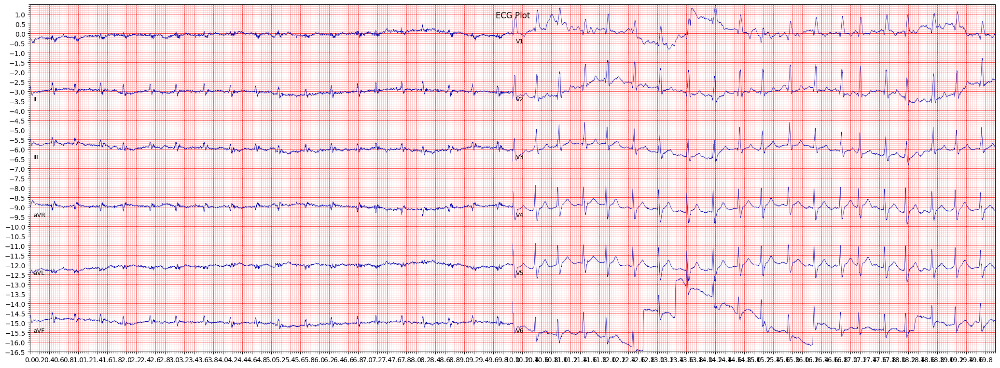

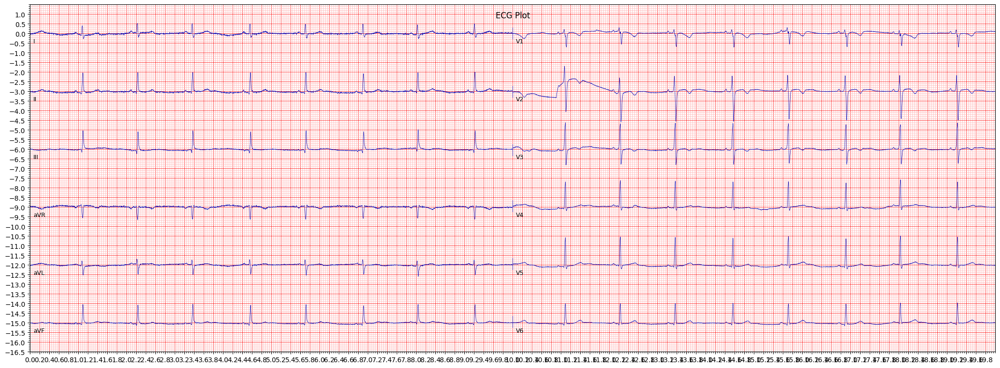

In [14]:
def plot_ecg(path):
    ecg_data = load_data(path)
    ecg_plot.plot(ecg_data[0]/1000, sample_rate=500, title='ECG Plot')
    ecg_plot.show()
plot_ecg('/content/dataset/WFDBRecords/01/010/JS00001.mat')
plot_ecg('/content/dataset/WFDBRecords/01/010/JS00002.mat')

## Configurating Data processing parameters

In [15]:
MAX_SECONDS = 30
WINDOW_SEC = 1.0
PRE_R_SEC = 0.5
LEAD_INDEX = 1
FS = 500

SNOMED_MAP = {
    "164889003": "Normal",
    "426177001": "AV_Block",
    "39732003":  "Other",
    "164909002": "AFib",
    "164931005": "Other",
    "251146004": "Other",
}
DEFAULT_LABEL = "Other"

## Helper Functions for extracting ECG data from .mat data files

In [16]:
def parse_header_label(hea_path: Path) -> str:
    with open(hea_path, "r") as f:
        for line in f:
            if line.startswith("#Dx:"):
                codes = re.findall(r"\d+", line)
                for c in codes:
                    if c in SNOMED_MAP:
                        return SNOMED_MAP[c]
    return DEFAULT_LABEL

def load_signal(record_base: Path, max_seconds: int | None) -> np.ndarray:
    rec = wfdb.rdrecord(str(record_base))
    sig = rec.p_signal
    if max_seconds is not None:
        sig = sig[: int(max_seconds * rec.fs)]
    return sig.astype(np.float32)

def detect_rpeaks(sig: np.ndarray, fs: int) -> np.ndarray:
    x = sig[:, LEAD_INDEX]
    peaks = wfproc.gqrs_detect(x, fs=fs)
    #print(peaks)
    #peaks = wfproc.correct_peaks(x, peak_inds=peaks, search_radius=int(0.05 * #fs), smooth_window_size=2)
    return peaks

def extract_beats(sig: np.ndarray, rpeaks: np.ndarray, fs: int) -> np.ndarray:
    half_win = int(WINDOW_SEC * fs / 2)
    beats = []
    for r in rpeaks:
        start = r - half_win
        end = r + half_win
        if start < 0 or end > len(sig):
            continue
        beat = sig[start:end, LEAD_INDEX]
        beats.append(beat)
    return np.stack(beats) if beats else np.empty((0, int(WINDOW_SEC * fs)))

def build_resnet(input_shape: tuple[int, int], num_classes: int) -> tf.keras.Model:
    def res_block(x, filters, kernel_size=7):
        shortcut = x
        x = layers.Conv1D(filters, kernel_size, padding="same")(x)
        x = layers.BatchNormalization()(x)
        x = layers.Activation("relu")(x)
        x = layers.Conv1D(filters, kernel_size, padding="same")(x)
        x = layers.BatchNormalization()(x)
        x = layers.Add()([x, shortcut])
        x = layers.Activation("relu")(x)
        return x

    inp = layers.Input(shape=input_shape)
    x = layers.Conv1D(32, 7, padding="same", activation="relu")(inp)
    x = layers.MaxPooling1D(2)(x)
    for f in [32, 64, 64, 128, 128, 256]:
        x = res_block(x, f)
        if f in {64, 128, 256}:
            x = layers.MaxPooling1D(2)(x)
    x = layers.GlobalAveragePooling1D()(x)
    x = layers.Dense(128, activation="relu")(x)
    out = layers.Dense(num_classes, activation="softmax")(x)
    return models.Model(inp, out, name="ResNet1D")

## Load and Preprocess Data

In [20]:
DATA_DIR = Path("dataset/WFDBRecords")  # path to the dataset
beats, labels = [], []
hea_files = sorted(DATA_DIR.rglob("*.hea"))
limit = 0
if limit:
    MAX_FILES = 20  # or any number you want to limit to
    hea_files = hea_files[:MAX_FILES]
    print(f"Limiting processing to the first {MAX_FILES} files")

print(f"Found {len(hea_files)} header files")

for hea in tqdm(hea_files, desc="Processing records"):
    label = parse_header_label(hea)
    record_base = hea.with_suffix("")
    try:
        sig = load_signal(record_base, MAX_SECONDS)
    except Exception as e:
        continue
    rpeaks = detect_rpeaks(sig, FS)
    record_beats = extract_beats(sig, rpeaks, FS)
    print(record_beats)
    if record_beats.size == 0:
        continue
    beats.append(record_beats)
    labels.extend([label] * len(record_beats))

X = np.concatenate(beats)
X = X[..., np.newaxis]
le = LabelEncoder()
y = le.fit_transform(labels)
CLASS_NAMES = le.classes_.tolist()

Found 45152 header files


Processing records:   0%|          | 2/45152 [00:00<37:58, 19.82it/s]

[[ 0.049  0.059  0.063 ...  0.059  0.068  0.073]
 [ 0.4    0.4    0.366 ...  0.254  0.234  0.278]
 [ 0.044  0.029  0.024 ...  0.049  0.049  0.034]
 ...
 [ 0.078  0.078  0.068 ...  0.024  0.029  0.015]
 [ 0.278  0.254  0.181 ...  0.015  0.088  0.122]
 [-0.034 -0.01  -0.005 ... -0.054 -0.054 -0.054]]
[[-0.078 -0.059 -0.049 ...  0.015  0.02   0.   ]
 [-0.024 -0.02  -0.01  ... -0.039 -0.015 -0.024]
 [-0.034 -0.039 -0.059 ...  0.015  0.005  0.005]
 ...
 [-0.049 -0.049 -0.054 ... -0.01  -0.024 -0.029]
 [-0.088 -0.073 -0.093 ... -0.01  -0.029 -0.029]
 [ 0.005  0.01   0.    ...  0.01   0.015  0.029]]
[[-0.02  -0.02  -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.024 -0.024 ... -0.068 -0.068 -0.068]
 [-0.044 -0.054 -0.054 ... -0.039 -0.039 -0.039]
 ...
 [-0.044 -0.039 -0.034 ... -0.044 -0.039 -0.034]
 [-0.034 -0.029 -0.039 ... -0.059 -0.059 -0.059]
 [-0.059 -0.059 -0.068 ... -0.107 -0.107 -0.107]]
[[-0.005  0.015  0.005 ... -0.137 -0.127 -0.093]
 [ 0.078  0.083  0.093 ... -0.098 -0.093 -0.088]
 [

Processing records:   0%|          | 5/45152 [00:00<34:01, 22.12it/s]

[[-0.044 -0.044 -0.039 ... -0.01  -0.015 -0.02 ]
 [-0.029 -0.039 -0.039 ... -0.039 -0.029 -0.029]
 [-0.024 -0.024 -0.024 ...  0.    -0.01  -0.01 ]
 ...
 [-0.034 -0.024 -0.02  ... -0.01  -0.02  -0.02 ]
 [-0.02  -0.02  -0.029 ... -0.049 -0.039 -0.039]
 [-0.039 -0.044 -0.044 ... -0.01  -0.01  -0.01 ]]


Processing records:   0%|          | 8/45152 [00:00<33:35, 22.39it/s]

[[ 0.122  0.098  0.127 ... -0.156 -0.137 -0.073]
 [-0.02  -0.005 -0.039 ... -0.049 -0.044 -0.063]
 [-0.127 -0.127 -0.137 ... -0.059 -0.024 -0.044]
 ...
 [ 0.142  0.146  0.127 ...  0.146  0.2    0.229]
 [-0.059 -0.083 -0.088 ... -0.024  0.005  0.029]
 [ 0.024  0.049  0.024 ... -0.015  0.015  0.005]]
[[-0.049 -0.054 -0.059 ... -0.068 -0.059 -0.063]
 [-0.063 -0.073 -0.059 ... -0.049 -0.063 -0.054]
 [-0.059 -0.054 -0.063 ... -0.049 -0.054 -0.054]
 ...
 [-0.039 -0.044 -0.049 ... -0.068 -0.063 -0.063]
 [-0.044 -0.049 -0.059 ...  0.005 -0.01   0.005]
 [-0.01   0.    -0.01  ... -0.029 -0.054 -0.034]]
[[-0.02  -0.02  -0.02  ... -0.029 -0.049 -0.044]
 [-0.059 -0.054 -0.059 ... -0.054 -0.054 -0.059]
 [-0.044 -0.049 -0.063 ... -0.02  -0.015 -0.01 ]
 ...
 [-0.059 -0.054 -0.054 ... -0.059 -0.054 -0.068]
 [-0.054 -0.068 -0.068 ... -0.015 -0.02  -0.024]
 [-0.044 -0.054 -0.044 ...  0.    -0.01  -0.005]]
[[-0.063 -0.049 -0.039 ...  0.054  0.054  0.049]
 [ 0.073  0.068  0.049 ...  0.034  0.029  0.029]
 [

Processing records:   0%|          | 14/45152 [00:00<32:52, 22.89it/s]

[[-0.088 -0.078 -0.054 ... -0.078 -0.117 -0.102]
 [-0.034 -0.024 -0.034 ... -0.063 -0.054 -0.034]
 [-0.117 -0.137 -0.166 ... -0.112 -0.073 -0.059]
 ...
 [-0.083 -0.068 -0.063 ... -0.078 -0.068 -0.102]
 [-0.073 -0.068 -0.073 ... -0.029 -0.044 -0.034]
 [-0.078 -0.068 -0.102 ... -0.029 -0.039 -0.044]]
[[-0.044 -0.049 -0.039 ... -0.073 -0.068 -0.059]
 [-0.054 -0.044 -0.039 ... -0.039 -0.024 -0.029]
 [-0.029 -0.024 -0.02  ... -0.029 -0.024 -0.024]
 ...
 [-0.01  -0.005 -0.005 ... -0.049 -0.054 -0.049]
 [-0.054 -0.049 -0.054 ... -0.034 -0.034 -0.039]
 [-0.005 -0.01  -0.01  ... -0.029 -0.024 -0.034]]
[[ 0.249  0.254  0.244 ... -0.102 -0.098 -0.093]
 [-0.102 -0.127 -0.122 ... -0.034 -0.137 -0.083]
 [-0.039 -0.063 -0.078 ... -0.093 -0.083 -0.102]
 ...
 [-0.039 -0.044 -0.034 ... -0.068 -0.063 -0.054]
 [ 0.078  0.093  0.112 ... -0.083 -0.083 -0.059]
 [-0.039 -0.049 -0.059 ... -0.093 -0.073 -0.049]]
[[-0.034 -0.034 -0.034 ... -0.005 -0.005 -0.01 ]
 [-0.005 -0.01  -0.015 ... -0.02  -0.02  -0.01 ]
 [

Processing records:   0%|          | 17/45152 [00:00<33:14, 22.63it/s]

[[-0.039 -0.015 -0.024 ... -0.059 -0.068 -0.059]
 [-0.054 -0.049 -0.039 ... -0.02  -0.039 -0.024]
 [-0.02  -0.024  0.    ... -0.034 -0.039 -0.063]
 ...
 [-0.044 -0.054 -0.063 ... -0.015 -0.044 -0.039]
 [-0.015 -0.01  -0.024 ... -0.024  0.    -0.01 ]
 [ 0.    -0.029 -0.039 ... -0.015 -0.015 -0.005]]
[[ 0.     0.01  -0.005 ...  0.005  0.015  0.015]
 [ 0.015  0.015  0.015 ...  0.034  0.034  0.044]
 [ 0.029  0.039  0.029 ... -0.024 -0.024 -0.034]
 ...
 [-0.049 -0.063 -0.073 ... -0.01  -0.005 -0.01 ]
 [-0.01  -0.015 -0.02  ... -0.078 -0.054 -0.039]
 [-0.073 -0.078 -0.068 ... -0.132 -0.112 -0.093]]
[[ 0.029  0.02  -0.005 ...  0.005  0.044  0.02 ]
 [ 0.005 -0.015 -0.029 ... -0.024  0.005 -0.02 ]
 [ 0.024  0.034  0.015 ... -0.01  -0.054 -0.059]
 ...
 [ 0.034  0.02   0.01  ... -0.015 -0.01   0.039]
 [-0.015 -0.01   0.039 ... -0.01   0.005 -0.029]
 [ 0.005  0.005  0.005 ...  0.    -0.024 -0.02 ]]
[[-0.015 -0.039 -0.054 ... -0.098 -0.137 -0.122]
 [-0.083 -0.068 -0.073 ...  0.024 -0.029 -0.049]
 [

Processing records:   0%|          | 20/45152 [00:00<33:11, 22.66it/s]

[[ 0.034  0.054  0.063 ... -0.044 -0.034 -0.02 ]
 [ 0.098  0.127  0.093 ...  0.005  0.029  0.   ]
 [ 0.029  0.054  0.068 ... -0.015 -0.039 -0.039]
 ...
 [ 0.063  0.093  0.049 ...  0.01   0.015 -0.005]
 [ 0.093  0.098  0.073 ...  0.039  0.02   0.01 ]
 [ 0.054  0.054  0.015 ...  0.005  0.015  0.024]]


Processing records:   0%|          | 23/45152 [00:01<33:03, 22.75it/s]

[[-0.068 -0.068 -0.068 ... -0.024 -0.034 -0.039]
 [ 0.01   0.     0.005 ... -0.142 -0.166 -0.185]
 [-0.137 -0.146 -0.142 ... -0.176 -0.161 -0.151]
 ...
 [ 0.068  0.068  0.063 ...  0.102  0.098  0.098]
 [ 0.107  0.102  0.098 ...  0.142  0.146  0.156]
 [ 0.229  0.215  0.176 ... -0.181 -0.176 -0.166]]
[[-0.073 -0.068 -0.063 ... -0.034 -0.029 -0.029]
 [-0.054 -0.049 -0.054 ... -0.01  -0.005  0.   ]
 [-0.029 -0.034 -0.039 ...  0.01   0.01   0.015]
 ...
 [ 0.049  0.063  0.068 ... -0.122 -0.122 -0.122]
 [-0.083 -0.088 -0.102 ...  0.02   0.024  0.034]
 [ 0.039  0.054  0.063 ... -0.015 -0.02  -0.01 ]]
[[ 0.249  0.327  0.395 ... -0.015  0.005 -0.01 ]
 [ 0.229  0.273  0.327 ... -0.054 -0.034 -0.034]
 [ 0.224  0.249  0.327 ... -0.029 -0.073 -0.073]
 ...
 [ 0.459  0.522  0.488 ... -0.015 -0.039 -0.059]
 [ 0.429  0.508  0.547 ... -0.024 -0.01   0.01 ]
 [ 0.327  0.395  0.483 ... -0.015 -0.02   0.   ]]
[[ 0.005  0.005  0.01  ...  0.005  0.005  0.015]
 [ 0.024  0.029  0.029 ... -0.015 -0.015 -0.005]
 [

Processing records:   0%|          | 29/45152 [00:01<33:30, 22.44it/s]

[[ 0.044  0.078  0.039 ... -0.01  -0.01   0.039]
 [-0.049 -0.078 -0.093 ...  0.005 -0.005 -0.029]
 [-0.029 -0.044 -0.049 ...  0.015 -0.01  -0.024]
 ...
 [ 0.    -0.015 -0.034 ... -0.02   0.005  0.034]
 [ 0.005  0.01   0.01  ... -0.039 -0.039 -0.044]
 [-0.054 -0.034 -0.034 ... -0.039 -0.049 -0.093]]
[[-0.039 -0.029 -0.059 ... -0.039 -0.015 -0.005]
 [ 0.005  0.015  0.024 ... -0.039 -0.024 -0.02 ]
 [-0.024 -0.005 -0.005 ...  0.02   0.     0.   ]
 ...
 [ 0.068  0.054  0.049 ... -0.029 -0.02  -0.024]
 [-0.078 -0.044 -0.029 ... -0.059 -0.054 -0.029]
 [-0.059 -0.073 -0.078 ...  0.073  0.068  0.078]]
[[-0.024 -0.024 -0.034 ...  0.01   0.015  0.029]
 [ 0.02   0.015  0.005 ... -0.015 -0.024 -0.024]
 [-0.063 -0.107 -0.151 ...  0.02   0.039  0.039]
 ...
 [-0.044 -0.059 -0.029 ...  0.029  0.01   0.029]
 [-0.039 -0.088 -0.063 ...  0.015  0.015  0.02 ]
 [-0.044 -0.054 -0.049 ...  0.024  0.015  0.015]]
[[-0.073 -0.063 -0.063 ... -0.049 -0.044 -0.044]
 [-0.054 -0.054 -0.044 ... -0.024 -0.024 -0.029]
 [

Processing records:   0%|          | 32/45152 [00:01<33:38, 22.35it/s]

[[-0.01  -0.01  -0.005 ... -0.059 -0.054 -0.049]
 [-0.044 -0.034 -0.039 ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ... -0.029 -0.034 -0.039]
 ...
 [-0.054 -0.029 -0.02  ... -0.039 -0.039 -0.039]
 [-0.054 -0.044 -0.044 ... -0.039 -0.039 -0.039]
 [-0.015 -0.015 -0.01  ... -0.049 -0.049 -0.044]]
[[-0.005 -0.015 -0.024 ...  0.063  0.068  0.078]
 [ 0.02   0.024  0.024 ... -0.151 -0.156 -0.156]
 [ 0.215  0.298  0.351 ... -0.068 -0.073 -0.093]
 ...
 [ 0.332  0.39   0.42  ... -0.029 -0.044 -0.049]
 [ 0.    -0.034 -0.02  ...  0.005  0.029  0.029]
 [-0.049 -0.02  -0.015 ... -0.015 -0.02  -0.015]]
[[ 0.161  0.171  0.176 ... -0.063 -0.059 -0.044]
 [-0.122 -0.107 -0.117 ...  0.02   0.029  0.029]
 [ 0.405  0.459  0.503 ... -0.005  0.005  0.029]
 ...
 [-0.044 -0.044 -0.054 ... -0.054 -0.059 -0.049]
 [-0.034 -0.034 -0.029 ... -0.039 -0.049 -0.039]
 [ 0.063  0.059  0.054 ...  0.376  0.273  0.107]]
[[-0.054 -0.049 -0.039 ... -0.044 -0.049 -0.078]
 [-0.088 -0.034  0.    ... -0.073 -0.078 -0.059]
 [

Processing records:   0%|          | 35/45152 [00:01<33:56, 22.15it/s]

[[-0.088 -0.098 -0.088 ...  0.346  0.156  0.044]
 [ 0.     0.     0.    ...  0.     0.015  0.015]
 [ 0.068  0.073  0.068 ...  0.059  0.     0.005]
 ...
 [-0.044 -0.039 -0.034 ...  0.     0.     0.   ]
 [ 0.132  0.127  0.122 ...  0.02   0.02   0.024]
 [ 0.063  0.029  0.034 ...  0.015  0.015  0.015]]


Processing records:   0%|          | 38/45152 [00:01<33:35, 22.38it/s]

[[ 0.024  0.     0.029 ... -0.063 -0.063 -0.044]
 [ 0.005 -0.015 -0.083 ... -0.034 -0.024 -0.01 ]
 [ 0.029  0.054  0.029 ... -0.083 -0.054 -0.02 ]
 ...
 [ 0.039 -0.01  -0.02  ... -0.039 -0.024 -0.029]
 [-0.039 -0.005  0.01  ...  0.024 -0.029 -0.015]
 [-0.034 -0.049 -0.024 ... -0.054 -0.068 -0.059]]
[[-0.029 -0.044  0.    ... -0.01  -0.015 -0.024]
 [ 0.083  0.102  0.073 ...  0.425  0.532  0.683]
 [-0.073 -0.044 -0.01  ... -0.098 -0.127 -0.088]
 ...
 [-0.054  0.068  0.02  ... -0.088 -0.068 -0.059]
 [ 0.054  0.098  0.112 ... -0.088 -0.044 -0.063]
 [ 0.068  0.117  0.112 ...  0.088  0.02  -0.01 ]]
[[-0.146 -0.151 -0.156 ... -0.068 -0.049 -0.049]
 [ 0.015 -0.015 -0.039 ... -0.044 -0.044 -0.044]
 [-0.112 -0.161 -0.117 ... -0.034 -0.034 -0.044]
 ...
 [-0.063 -0.078 -0.073 ...  0.273  0.244  0.195]
 [-0.044 -0.039 -0.039 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.01   0.    ... -0.063 -0.073 -0.073]]
[[ 0.02   0.02   0.02  ... -0.049 -0.044 -0.024]
 [ 0.127  0.132  0.132 ... -0.098 -0.098 -0.083]
 [

Processing records:   0%|          | 44/45152 [00:01<33:27, 22.47it/s]

[[-0.107 -0.107 -0.107 ... -0.063 -0.063 -0.068]
 [-0.049 -0.054 -0.054 ... -0.098 -0.093 -0.093]
 [-0.068 -0.068 -0.068 ... -0.034 -0.034 -0.039]
 ...
 [-0.029 -0.029 -0.029 ... -0.063 -0.063 -0.068]
 [-0.068 -0.068 -0.068 ... -0.063 -0.063 -0.068]
 [-0.054 -0.049 -0.059 ... -0.078 -0.083 -0.083]]
[[ 0.381  0.459  0.42  ... -0.185 -0.171 -0.151]
 [ 0.366  0.468  0.503 ... -0.156 -0.156 -0.166]
 [ 0.342  0.454  0.551 ... -0.137 -0.122 -0.122]
 ...
 [ 0.234  0.346  0.449 ... -0.098 -0.098 -0.117]
 [ 0.468  0.532  0.556 ... -0.112 -0.098 -0.078]
 [ 0.439  0.532  0.581 ... -0.01  -0.015 -0.01 ]]
[[-0.083 -0.073 -0.078 ... -0.19  -0.176 -0.181]
 [-0.166 -0.166 -0.176 ... -0.107 -0.146 -0.156]
 [-0.171 -0.122 -0.132 ...  0.039  0.015  0.   ]
 ...
 [-0.068 -0.073 -0.102 ... -0.122 -0.122 -0.102]
 [-0.093 -0.083 -0.078 ... -0.112 -0.132 -0.161]
 [-0.049 -0.059 -0.078 ...  0.815  0.888  0.937]]
[[ 0.171  0.176  0.181 ...  0.034  0.044  0.044]
 [ 0.254  0.239  0.249 ...  0.015  0.024  0.044]
 [

Processing records:   0%|          | 47/45152 [00:02<33:36, 22.37it/s]

[[-0.054 -0.044 -0.049 ...  0.024  0.044  0.049]
 [ 0.029  0.     0.02  ...  0.02   0.015  0.01 ]
 [ 0.044  0.024  0.015 ... -0.054 -0.039 -0.049]
 ...
 [ 0.02  -0.049 -0.063 ...  0.02  -0.005 -0.024]
 [ 0.02   0.005  0.015 ... -0.015 -0.039 -0.083]
 [-0.015 -0.024 -0.02  ...  0.01   0.049  0.015]]
[[-0.02  -0.02  -0.029 ... -0.01  -0.01  -0.01 ]
 [-0.078 -0.088 -0.088 ... -0.054 -0.049 -0.039]
 [ 0.005 -0.005 -0.005 ...  0.029  0.039  0.039]
 ...
 [-0.015 -0.024 -0.024 ... -0.044 -0.039 -0.039]
 [-0.015 -0.015 -0.024 ...  0.098  0.088  0.078]
 [ 0.029  0.029  0.024 ... -0.005  0.     0.01 ]]
[[ 0.137  0.142  0.112 ... -0.039 -0.054 -0.044]
 [ 0.127  0.146  0.156 ... -0.063 -0.063 -0.063]
 [ 0.156  0.137  0.122 ... -0.029 -0.044 -0.044]
 ...
 [ 0.054  0.073  0.049 ... -0.029 -0.034 -0.034]
 [ 0.02   0.005  0.01  ... -0.01   0.     0.   ]
 [ 0.054  0.039  0.034 ... -0.034 -0.039 -0.034]]
[[-0.02  -0.01   0.005 ...  0.102  0.102  0.102]
 [ 0.068  0.073  0.088 ...  0.044  0.044  0.02 ]
 [

Processing records:   0%|          | 50/45152 [00:02<34:31, 21.77it/s]

[[-0.005  0.    -0.029 ... -0.029 -0.02  -0.024]
 [-0.02  -0.005 -0.02  ... -0.063 -0.063 -0.049]
 [-0.024 -0.02  -0.049 ... -0.059 -0.063 -0.029]
 ...
 [-0.015 -0.029 -0.039 ... -0.049 -0.039 -0.02 ]
 [-0.034 -0.034 -0.029 ... -0.039 -0.059 -0.049]
 [-0.059 -0.049 -0.034 ... -0.039 -0.024 -0.029]]


Processing records:   0%|          | 53/45152 [00:02<34:54, 21.53it/s]

[[-0.039 -0.044 -0.039 ... -0.068 -0.068 -0.078]
 [-0.068 -0.078 -0.068 ...  0.005  0.029  0.029]
 [ 0.005  0.01   0.005 ... -0.205 -0.185 -0.205]
 ...
 [-0.034 -0.044 -0.049 ... -0.005 -0.01  -0.005]
 [-0.015 -0.01  -0.01  ... -0.073 -0.063 -0.068]
 [-0.054 -0.054 -0.049 ... -0.029 -0.029 -0.024]]
[[-0.078 -0.068 -0.068 ... -0.059 -0.059 -0.059]
 [-0.059 -0.063 -0.073 ... -0.02  -0.01  -0.015]
 [-0.034 -0.02  -0.015 ... -0.029 -0.029 -0.039]
 ...
 [-0.054 -0.063 -0.073 ... -0.088 -0.083 -0.083]
 [-0.088 -0.102 -0.107 ... -0.02  -0.02  -0.01 ]
 [-0.01  -0.01  -0.005 ...  0.01   0.01   0.01 ]]
[[-0.024 -0.02  -0.02  ... -0.059 -0.063 -0.063]
 [-0.044 -0.049 -0.039 ... -0.01  -0.01  -0.02 ]
 [ 0.005  0.     0.01  ... -0.02  -0.005  0.01 ]
 ...
 [-0.029 -0.015 -0.015 ... -0.044 -0.044 -0.054]
 [-0.054 -0.063 -0.054 ... -0.063 -0.073 -0.073]
 [-0.054 -0.039 -0.044 ... -0.02   0.005  0.01 ]]
[[ 0.137  0.146  0.137 ... -0.137 -0.137 -0.117]
 [ 0.117  0.137  0.146 ... -0.166 -0.166 -0.146]
 [

Processing records:   0%|          | 56/45152 [00:02<37:10, 20.22it/s]

[[ 0.063  0.059  0.054 ...  0.005  0.039  0.02 ]
 [ 0.063  0.059  0.059 ... -0.015 -0.01  -0.01 ]
 [ 0.024  0.039  0.054 ... -0.024 -0.029 -0.029]
 ...
 [ 0.078  0.093  0.068 ... -0.01  -0.024 -0.029]
 [ 0.068  0.059  0.073 ... -0.005 -0.015 -0.024]
 [ 0.02   0.024  0.024 ...  0.029  0.044  0.029]]
[[-0.107 -0.098 -0.093 ...  0.044  0.044  0.054]
 [-0.063 -0.063 -0.049 ...  0.044  0.044  0.044]
 [-0.073 -0.083 -0.073 ...  0.024  0.024  0.034]
 ...
 [-0.059 -0.063 -0.068 ...  0.049  0.039  0.029]
 [-0.088 -0.088 -0.088 ...  0.039  0.034  0.044]
 [-0.098 -0.088 -0.073 ...  0.059  0.039  0.044]]
[[-0.054 -0.049 -0.044 ...  0.01   0.01   0.005]
 [-0.005 -0.02   0.    ...  0.468  0.522  0.542]
 [-0.005  0.     0.015 ... -0.005 -0.005 -0.005]
 ...
 [ 0.005 -0.005 -0.01  ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.015 ... -0.02  -0.01  -0.005]
 [ 0.088  0.088  0.117 ...  0.029  0.029  0.024]]
[[ 0.024  0.034  0.02  ... -0.039 -0.039 -0.044]
 [-0.044 -0.078 -0.029 ... -0.029 -0.015 -0.049]
 [

Processing records:   0%|          | 59/45152 [00:02<35:43, 21.04it/s]

[[-0.054 -0.044 -0.044 ... -0.049 -0.063 -0.054]
 [-0.044 -0.044 -0.029 ... -0.049 -0.049 -0.063]
 [-0.049 -0.054 -0.044 ... -0.073 -0.088 -0.093]
 ...
 [-0.02  -0.02   0.    ... -0.024 -0.015 -0.029]
 [-0.039 -0.049 -0.024 ... -0.063 -0.063 -0.049]
 [-0.029 -0.015  0.    ... -0.068 -0.078 -0.078]]


Processing records:   0%|          | 62/45152 [00:02<34:56, 21.50it/s]

[[ 0.054  0.02   0.034 ... -0.078 -0.073 -0.063]
 [-0.088 -0.083 -0.049 ... -0.059 -0.059 -0.059]
 [-0.054 -0.02   0.005 ... -0.029 -0.034 -0.039]
 ...
 [-0.044 -0.063 -0.078 ... -0.02  -0.029 -0.024]
 [-0.049 -0.059 -0.073 ... -0.029 -0.024 -0.029]
 [-0.034 -0.029 -0.024 ... -0.01  -0.034 -0.059]]
[[ 0.015  0.01   0.02  ... -0.005 -0.005  0.   ]
 [ 0.015  0.01   0.005 ... -0.039 -0.039 -0.034]
 [ 0.02   0.005  0.01  ... -0.044 -0.049 -0.044]
 ...
 [ 0.01   0.01   0.005 ... -0.039 -0.044 -0.044]
 [-0.054 -0.049 -0.039 ... -0.024 -0.02  -0.02 ]
 [-0.098 -0.107 -0.112 ... -0.01  -0.015 -0.01 ]]
[[-0.049 -0.068 -0.073 ... -0.02  -0.02  -0.024]
 [-0.029 -0.024 -0.059 ... -0.044 -0.044 -0.054]
 [-0.039 -0.054 -0.034 ... -0.044 -0.054 -0.039]
 ...
 [-0.029 -0.044 -0.024 ... -0.054 -0.054 -0.034]
 [-0.054 -0.044 -0.049 ... -0.015 -0.015 -0.02 ]
 [-0.02  -0.02  -0.005 ... -0.02  -0.01  -0.015]]
[[-0.044 -0.044 -0.054 ... -0.024 -0.039 -0.049]
 [-0.088 -0.088 -0.093 ... -0.034 -0.044 -0.039]
 [

Processing records:   0%|          | 68/45152 [00:03<34:15, 21.93it/s]

[[-0.02  -0.01  -0.01  ... -0.024 -0.029 -0.029]
 [-0.049 -0.054 -0.054 ... -0.078 -0.078 -0.073]
 [-0.083 -0.083 -0.083 ... -0.029 -0.015 -0.015]
 ...
 [-0.078 -0.088 -0.078 ...  0.015  0.01   0.01 ]
 [ 0.044  0.044  0.039 ...  0.     0.    -0.005]
 [-0.01  -0.01  -0.005 ... -0.039 -0.039 -0.044]]
[[-0.376 -0.317 -0.268 ... -0.015 -0.02  -0.029]
 [ 0.068  0.088  0.078 ...  0.015  0.02   0.02 ]
 [ 0.127  0.044 -0.068 ...  0.088  0.132  0.2  ]
 ...
 [ 0.146  0.142  0.137 ... -0.024 -0.034 -0.034]
 [ 0.039  0.049  0.044 ...  0.093  0.088  0.093]
 [-0.029 -0.029 -0.034 ...  0.229  0.293  0.356]]
[[ 0.    -0.005 -0.015 ... -0.054 -0.059 -0.059]
 [-0.039 -0.044 -0.049 ... -0.054 -0.054 -0.049]
 [-0.034 -0.044 -0.054 ... -0.073 -0.068 -0.059]
 ...
 [-0.068 -0.068 -0.063 ... -0.034 -0.024 -0.01 ]
 [ 0.01   0.01  -0.015 ... -0.083 -0.083 -0.083]
 [-0.078 -0.073 -0.073 ... -0.083 -0.078 -0.068]]
[[-0.063 -0.068 -0.068 ...  0.39   0.542  0.747]
 [-0.029 -0.049 -0.044 ... -0.029 -0.02  -0.024]
 [

Processing records:   0%|          | 71/45152 [00:03<35:19, 21.27it/s]

[[-0.044 -0.039 -0.039 ... -0.049 -0.054 -0.063]
 [-0.044 -0.044 -0.044 ... -0.015 -0.015 -0.02 ]
 [-0.015 -0.01  -0.01  ... -0.054 -0.054 -0.059]
 ...
 [-0.024 -0.034 -0.034 ... -0.034 -0.034 -0.039]
 [-0.01  -0.01  -0.02  ... -0.044 -0.044 -0.049]
 [-0.034 -0.044 -0.039 ... -0.054 -0.054 -0.059]]
[[-0.039 -0.029 -0.029 ...  0.005  0.005  0.015]
 [ 0.005  0.    -0.005 ... -0.024 -0.024 -0.015]
 [ 0.024  0.029  0.039 ...  0.034  0.029  0.029]
 ...
 [ 0.005  0.005  0.005 ...  0.     0.01   0.02 ]
 [-0.034 -0.039 -0.039 ...  0.312  0.254  0.229]
 [ 0.327  0.298  0.273 ...  0.2    0.259  0.273]]
[[-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.049 -0.049 -0.049]
 [-0.054 -0.054 -0.054 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.034 -0.029 -0.029 ... -0.01  -0.01  -0.01 ]
 [ 0.     0.     0.    ... -0.049 -0.049 -0.049]
 [-0.054 -0.059 -0.059 ... -0.049 -0.049 -0.049]]
[[ 0.01   0.01   0.02  ... -0.112 -0.093 -0.059]
 [-0.146 -0.161 -0.166 ...  0.024  0.049  0.059]
 [

Processing records:   0%|          | 74/45152 [00:03<34:20, 21.87it/s]

[[-0.049 -0.039 -0.039 ... -0.073 -0.063 -0.049]
 [-0.063 -0.063 -0.073 ... -0.054 -0.088 -0.073]
 [-0.068 -0.059 -0.054 ... -0.039 -0.02  -0.02 ]
 ...
 [-0.005 -0.015 -0.029 ... -0.063 -0.063 -0.049]
 [-0.034 -0.034 -0.039 ... -0.059 -0.049 -0.039]
 [-0.034 -0.029 -0.039 ... -0.01  -0.01  -0.015]]


Processing records:   0%|          | 77/45152 [00:03<34:14, 21.94it/s]

[[-0.049 -0.029 -0.02  ...  0.083  0.142  0.098]
 [-0.029 -0.054 -0.088 ...  0.029  0.024  0.024]
 [-0.034 -0.039 -0.039 ... -0.01  -0.015 -0.02 ]
 ...
 [-0.044 -0.029 -0.063 ...  0.093  0.073 -0.015]
 [-0.015 -0.044 -0.049 ...  0.01   0.     0.015]
 [ 0.02   0.02   0.093 ...  0.034  0.015  0.024]]
[[-0.029 -0.044 -0.024 ... -0.015 -0.02  -0.034]
 [-0.063 -0.044 -0.044 ... -0.039 -0.044 -0.054]
 [-0.005  0.    -0.015 ... -0.024 -0.034 -0.02 ]
 ...
 [-0.015 -0.02  -0.024 ... -0.059 -0.068 -0.054]
 [-0.073 -0.063 -0.068 ...  0.005 -0.01  -0.024]
 [ 0.     0.015  0.01  ...  0.01   0.    -0.015]]
[[ 0.044  0.049  0.059 ... -0.073 -0.073 -0.059]
 [ 0.02   0.024  0.024 ... -0.034 -0.029 -0.01 ]
 [-0.137 -0.146 -0.142 ... -0.02  -0.01  -0.059]
 ...
 [-0.063 -0.078 -0.102 ... -0.039 -0.049 -0.044]
 [-0.059 -0.044 -0.034 ... -0.132 -0.122 -0.098]
 [-0.01  -0.015 -0.015 ... -0.039 -0.039 -0.029]]
[[-0.034 -0.015 -0.015 ... -0.2   -0.19  -0.176]
 [-0.073 -0.059 -0.054 ... -0.142 -0.137 -0.132]
 [

Processing records:   0%|          | 83/45152 [00:03<33:41, 22.30it/s]

[[-0.068 -0.073 -0.078 ... -0.054 -0.063 -0.068]
 [-0.088 -0.093 -0.068 ... -0.083 -0.078 -0.078]
 [-0.044 -0.044 -0.044 ... -0.073 -0.073 -0.078]
 ...
 [-0.029 -0.029 -0.039 ... -0.054 -0.054 -0.059]
 [-0.059 -0.059 -0.068 ... -0.073 -0.068 -0.068]
 [-0.083 -0.063 -0.068 ... -0.054 -0.063 -0.068]]
[[ 0.005  0.015 -0.005 ... -0.015  0.059  0.049]
 [ 0.088  0.063  0.029 ... -0.044 -0.049 -0.054]
 [-0.117 -0.078 -0.049 ... -0.063 -0.039 -0.02 ]
 ...
 [-0.015 -0.01  -0.029 ... -0.078 -0.063 -0.044]
 [-0.151 -0.142 -0.117 ... -0.049 -0.093 -0.073]
 [-0.029 -0.024  0.    ...  0.034  0.01   0.005]]
[[-0.151 -0.146 -0.161 ... -0.073 -0.073 -0.078]
 [-0.093 -0.107 -0.117 ... -0.039 -0.034 -0.034]
 [-0.015 -0.01  -0.01  ... -0.029 -0.044 -0.063]
 ...
 [ 0.605  0.649  0.708 ... -0.02  -0.029 -0.024]
 [ 0.093  0.107  0.107 ... -0.063 -0.068 -0.059]
 [-0.093 -0.112 -0.083 ... -0.029 -0.015 -0.02 ]]
[[-0.039 -0.044 -0.039 ...  1.137  1.157  1.166]
 [-0.049 -0.073 -0.093 ... -0.024 -0.044  0.015]
 [

Processing records:   0%|          | 86/45152 [00:03<33:51, 22.19it/s]

[[ 0.005 -0.01  -0.01  ... -0.039 -0.015 -0.024]
 [-0.073 -0.083 -0.098 ...  0.015  0.029  0.02 ]
 [-0.01  -0.024 -0.02  ... -0.005  0.029  0.029]
 ...
 [-0.015 -0.005 -0.01  ...  0.     0.01   0.015]
 [-0.039 -0.034 -0.015 ...  0.005  0.    -0.015]
 [-0.024 -0.024 -0.029 ...  0.024  0.029  0.039]]
[[ 0.049  0.029  0.02  ...  0.015 -0.01  -0.02 ]
 [-0.054 -0.122 -0.098 ...  0.127  0.112  0.083]
 [-0.063 -0.073 -0.068 ...  0.034  0.054  0.068]
 ...
 [-0.083 -0.054 -0.024 ... -0.142 -0.093 -0.098]
 [-0.112 -0.132 -0.161 ...  0.063  0.054  0.029]
 [ 0.073  0.044  0.02  ... -0.161 -0.161 -0.151]]
[[-0.029 -0.029 -0.034 ... -0.034 -0.029 -0.034]
 [-0.015 -0.005 -0.01  ... -0.098 -0.093 -0.093]
 [-0.093 -0.093 -0.088 ... -0.059 -0.059 -0.054]
 ...
 [ 0.098  0.093  0.088 ... -0.015 -0.015 -0.01 ]
 [-0.005 -0.01  -0.005 ... -0.029 -0.029 -0.024]
 [-0.029 -0.029 -0.029 ... -0.039 -0.034 -0.034]]
[[-0.098 -0.068 -0.068 ... -0.034 -0.044 -0.044]
 [-0.117 -0.127 -0.093 ... -0.015  0.01   0.01 ]
 [

Processing records:   0%|          | 89/45152 [00:04<34:05, 22.03it/s]

[[-0.059 -0.044 -0.034 ... -0.024 -0.02  -0.02 ]
 [-0.068 -0.063 -0.054 ... -0.005 -0.01  -0.015]
 [-0.044 -0.049 -0.054 ... -0.02  -0.02  -0.024]
 ...
 [-0.059 -0.054 -0.054 ... -0.039 -0.044 -0.059]
 [ 0.034  0.024  0.02  ... -0.02  -0.015 -0.015]
 [-0.02  -0.024 -0.024 ... -0.039 -0.039 -0.039]]


Processing records:   0%|          | 92/45152 [00:04<33:59, 22.10it/s]

[[ 0.     0.     0.    ...  0.01   0.02   0.01 ]
 [ 0.029  0.039  0.059 ... -0.01  -0.005 -0.005]
 [ 0.015  0.01  -0.005 ...  0.005  0.005  0.01 ]
 ...
 [ 0.024  0.039  0.054 ...  0.     0.     0.   ]
 [ 0.029  0.02   0.01  ... -0.039 -0.029 -0.029]
 [-0.005 -0.005 -0.01  ...  0.01   0.015  0.01 ]]
[[-0.146 -0.137 -0.146 ...  0.029  0.029  0.029]
 [-0.083 -0.073 -0.068 ...  0.151  0.161  0.156]
 [-0.093 -0.083 -0.078 ...  0.137  0.151  0.161]
 ...
 [-0.185 -0.181 -0.195 ...  0.127  0.142  0.146]
 [-0.19  -0.176 -0.166 ...  0.151  0.166  0.181]
 [-0.132 -0.117 -0.107 ...  0.22   0.22   0.22 ]]
[[-0.02  -0.029 -0.044 ... -0.122 -0.107 -0.088]
 [-0.122 -0.107 -0.073 ... -0.029  0.    -0.015]
 [-0.034 -0.015 -0.02  ... -0.083 -0.102 -0.112]
 ...
 [-0.005 -0.024 -0.039 ... -0.015 -0.034 -0.054]
 [-0.049 -0.068 -0.083 ... -0.02  -0.054 -0.073]
 [-0.054 -0.063 -0.063 ...  0.044  0.044  0.024]]
[[-0.21  -0.171 -0.142 ...  0.01   0.01  -0.02 ]
 [-0.112 -0.132 -0.098 ... -0.01  -0.015 -0.024]
 [

Processing records:   0%|          | 95/45152 [00:04<43:15, 17.36it/s]

[[ 0.059  0.063  0.068 ... -0.005  0.005  0.005]
 [ 0.229  0.224  0.215 ... -0.01  -0.01   0.   ]
 [ 0.098  0.098  0.107 ... -0.01  -0.015  0.005]
 ...
 [-0.024 -0.01  -0.024 ...  0.     0.015  0.015]
 [ 0.015  0.01   0.    ...  0.015  0.029  0.   ]
 [-0.024 -0.02   0.024 ...  0.068  0.044  0.024]]
[[-0.02  -0.02  -0.015 ... -0.132 -0.132 -0.132]
 [-0.098 -0.093 -0.093 ... -0.034 -0.034 -0.034]
 [-0.01  -0.01  -0.01  ...  0.034  0.034  0.034]
 ...
 [-0.098 -0.098 -0.098 ... -0.073 -0.073 -0.073]
 [-0.034 -0.034 -0.029 ...  0.054  0.054  0.054]
 [ 0.112  0.117  0.117 ...  0.093  0.093  0.093]]
[[-0.068 -0.073 -0.063 ...  0.005  0.    -0.02 ]
 [ 0.039  0.02   0.02  ...  0.029  0.024  0.029]
 [ 0.029  0.034  0.039 ... -0.015 -0.01  -0.005]
 ...
 [-0.024 -0.02  -0.029 ... -0.005 -0.024  0.01 ]
 [-0.005 -0.015 -0.005 ... -0.024 -0.024 -0.024]
 [-0.015  0.    -0.005 ... -0.005 -0.005 -0.005]]


Processing records:   0%|          | 97/45152 [00:04<48:43, 15.41it/s]

[[-0.039 -0.039 -0.039 ... -0.073 -0.078 -0.063]
 [-0.073 -0.073 -0.078 ... -0.034 -0.044 -0.039]
 [-0.024 -0.024 -0.029 ... -0.059 -0.054 -0.054]
 ...
 [-0.054 -0.059 -0.059 ... -0.02  -0.015 -0.029]
 [-0.029 -0.039 -0.029 ... -0.02  -0.029 -0.039]
 [-0.024 -0.024 -0.024 ...  0.     0.015  0.   ]]
[[ 0.015  0.    -0.005 ...  0.244  0.176  0.112]
 [-0.005 -0.078 -0.102 ...  0.181  0.132  0.063]
 [ 0.063  0.02   0.029 ...  0.249  0.171  0.068]
 ...
 [-0.015 -0.024 -0.024 ...  0.239  0.171  0.063]
 [ 0.015 -0.015  0.01  ...  0.317  0.254  0.195]
 [ 0.073  0.024 -0.024 ...  0.293  0.268  0.132]]


Processing records:   0%|          | 99/45152 [00:04<51:40, 14.53it/s]

[[-0.054 -0.063 -0.088 ... -0.054 -0.078 -0.078]
 [-0.068 -0.068 -0.063 ... -0.024 -0.015 -0.059]
 [-0.044 -0.059 -0.059 ... -0.068 -0.063 -0.059]
 ...
 [-0.049 -0.029 -0.049 ... -0.039 -0.039 -0.044]
 [-0.039 -0.039 -0.063 ... -0.054 -0.059 -0.059]
 [-0.102 -0.059 -0.005 ... -0.039 -0.02  -0.005]]


Processing records:   0%|          | 101/45152 [00:04<56:04, 13.39it/s]

[[-0.044 -0.049 -0.073 ... -0.02  -0.024  0.   ]
 [-0.01   0.005  0.    ...  0.02  -0.02  -0.068]
 [-0.044 -0.034 -0.015 ... -0.01  -0.02  -0.034]
 ...
 [ 0.015 -0.005 -0.034 ... -0.01  -0.024 -0.005]
 [ 0.015  0.063  0.024 ... -0.068 -0.039 -0.024]
 [-0.01  -0.02  -0.02  ...  0.005  0.015  0.029]]
[[-0.107 -0.098 -0.088 ...  0.112  0.073  0.068]
 [-0.088 -0.083 -0.068 ...  0.     0.    -0.01 ]
 [-0.063 -0.063 -0.059 ... -0.02  -0.029 -0.02 ]
 ...
 [-0.093 -0.088 -0.098 ... -0.044 -0.049 -0.044]
 [ 0.142  0.142  0.161 ... -0.073 -0.088 -0.102]
 [ 0.644  0.747  0.922 ... -0.088 -0.088 -0.093]]
[[-0.044 -0.039 -0.015 ... -0.039 -0.049 -0.039]
 [-0.068 -0.054 -0.044 ... -0.01   0.    -0.034]
 [-0.029 -0.049 -0.034 ... -0.049 -0.054 -0.063]
 ...
 [-0.063 -0.073 -0.073 ... -0.044 -0.078 -0.063]
 [-0.034 -0.054 -0.049 ... -0.02  -0.01   0.005]
 [-0.02  -0.02  -0.034 ... -0.015 -0.01   0.005]]


Processing records:   0%|          | 103/45152 [00:05<58:26, 12.85it/s]

[[-0.049 -0.073 -0.073 ... -0.054 -0.054 -0.059]
 [-0.059 -0.044 -0.059 ... -0.029 -0.034 -0.049]
 [-0.059 -0.063 -0.063 ... -0.024 -0.02  -0.029]
 ...
 [-0.073 -0.078 -0.088 ...  0.034  0.015  0.005]
 [-0.068 -0.068 -0.073 ...  0.005  0.    -0.005]
 [-0.039 -0.044 -0.039 ...  0.059  0.054  0.054]]
[[-0.102 -0.02   0.015 ... -0.024 -0.063 -0.083]
 [ 0.024  0.039  0.    ... -0.068 -0.059 -0.078]
 [-0.151 -0.127 -0.112 ... -0.015 -0.034 -0.044]
 ...
 [-0.083 -0.093 -0.073 ... -0.073 -0.102 -0.107]
 [-0.015  0.01   0.015 ... -0.044 -0.054 -0.034]
 [ 0.034  0.063  0.039 ... -0.078 -0.049 -0.029]]


Processing records:   0%|          | 105/45152 [00:05<1:00:32, 12.40it/s]

[[-0.093 -0.088 -0.083 ...  0.024  0.015 -0.005]
 [-0.029 -0.029 -0.02  ...  0.044  0.039  0.024]
 [ 0.107  0.088  0.083 ... -0.01  -0.02  -0.01 ]
 ...
 [-0.024 -0.029 -0.039 ...  0.044  0.034  0.024]
 [ 0.059  0.024  0.01  ... -0.02  -0.034 -0.024]
 [-0.049 -0.054 -0.059 ... -0.044 -0.024 -0.034]]


Processing records:   0%|          | 107/45152 [00:05<1:00:15, 12.46it/s]

[[-0.405 -0.356 -0.303 ... -0.112 -0.112 -0.098]
 [-0.342 -0.478 -0.551 ... -0.098 -0.102 -0.117]
 [-0.522 -0.459 -0.381 ... -0.098 -0.107 -0.112]
 ...
 [-0.566 -0.517 -0.439 ... -0.063 -0.063 -0.054]
 [ 0.366  0.117 -0.127 ... -0.029 -0.02  -0.024]
 [-0.449 -0.483 -0.468 ...  0.005  0.015 -0.01 ]]
[[ 0.044  0.034  0.034 ... -0.078 -0.044 -0.034]
 [-0.029 -0.059 -0.068 ... -0.01  -0.01  -0.039]
 [ 0.039  0.029  0.029 ... -0.059 -0.068 -0.059]
 ...
 [-0.039 -0.01  -0.034 ... -0.044 -0.015 -0.005]
 [ 0.01   0.024  0.015 ... -0.073 -0.063 -0.044]
 [-0.024  0.01   0.    ... -0.015 -0.005 -0.049]]
[[-0.02  -0.02  -0.02  ...  0.01   0.01   0.015]
 [-0.015 -0.015 -0.015 ...  0.     0.     0.005]
 [ 0.015  0.01   0.01  ...  0.02   0.02   0.034]
 ...
 [ 0.     0.     0.    ...  0.02   0.02   0.02 ]
 [-0.02  -0.029 -0.034 ...  0.029  0.029  0.034]
 [-0.039 -0.034 -0.029 ...  0.029  0.029  0.029]]


Processing records:   0%|          | 109/45152 [00:05<1:01:55, 12.12it/s]

[[-0.073 -0.078 -0.083 ... -0.073 -0.078 -0.078]
 [-0.068 -0.068 -0.063 ... -0.049 -0.054 -0.063]
 [-0.063 -0.059 -0.059 ... -0.02  -0.024 -0.02 ]
 ...
 [-0.054 -0.039 -0.039 ... -0.024 -0.024 -0.024]
 [-0.054 -0.073 -0.063 ... -0.049 -0.049 -0.034]
 [-0.078 -0.083 -0.083 ... -0.02  -0.015  0.01 ]]
[[-0.034 -0.024 -0.02  ...  0.015  0.005 -0.005]
 [-0.015 -0.015  0.    ... -0.02  -0.015 -0.015]
 [-0.034 -0.039 -0.034 ... -0.039 -0.054 -0.044]
 ...
 [-0.01  -0.01  -0.015 ... -0.039 -0.039 -0.02 ]
 [-0.034 -0.059 -0.054 ... -0.005 -0.005 -0.01 ]
 [-0.01  -0.024 -0.015 ...  0.034  0.02   0.   ]]


Processing records:   0%|          | 111/45152 [00:05<1:13:44, 10.18it/s]

[[-0.078 -0.083 -0.068 ... -0.024 -0.034 -0.044]
 [-0.034 -0.039 -0.039 ... -0.034 -0.029 -0.029]
 [-0.02  -0.024 -0.02  ... -0.039 -0.034 -0.029]
 ...
 [-0.039 -0.029 -0.024 ... -0.029 -0.029 -0.049]
 [-0.044 -0.044 -0.034 ... -0.02  -0.029 -0.054]
 [-0.01  -0.015 -0.015 ... -0.039 -0.02  -0.015]]
[[-0.01  -0.01  -0.02  ... -0.044 -0.044 -0.039]
 [-0.054 -0.054 -0.059 ... -0.054 -0.054 -0.054]
 [-0.073 -0.073 -0.078 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.049]
 [-0.034 -0.034 -0.034 ... -0.054 -0.054 -0.054]
 [-0.054 -0.054 -0.054 ... -0.044 -0.044 -0.044]]


Processing records:   0%|          | 114/45152 [00:06<1:27:42,  8.56it/s]

[[ 0.01   0.01   0.039 ... -0.029 -0.063 -0.054]
 [-0.039 -0.068 -0.068 ...  0.    -0.005 -0.049]
 [ 0.015  0.044  0.02  ... -0.039 -0.073 -0.063]
 ...
 [ 0.083  0.098  0.117 ... -0.068 -0.068 -0.098]
 [-0.005 -0.029 -0.049 ... -0.024  0.005 -0.02 ]
 [-0.02   0.01   0.044 ... -0.107 -0.078 -0.029]]
[[-0.024 -0.02  -0.024 ... -0.039 -0.039 -0.029]
 [-0.044 -0.039 -0.039 ... -0.063 -0.073 -0.063]
 [-0.063 -0.068 -0.063 ... -0.029 -0.034 -0.034]
 ...
 [-0.054 -0.068 -0.068 ... -0.015 -0.02  -0.02 ]
 [ 0.005  0.005  0.005 ... -0.024 -0.039 -0.044]
 [-0.029 -0.02  -0.024 ...  0.034  0.02   0.015]]


Processing records:   0%|          | 115/45152 [00:06<1:36:33,  7.77it/s]

[[ 0.063  0.044  0.068 ...  0.161  0.142  0.151]
 [ 0.098  0.122  0.127 ...  0.073  0.093  0.112]
 [ 0.083  0.093  0.102 ... -0.029 -0.02  -0.015]
 [ 0.015  0.02   0.024 ... -0.01  -0.01   0.029]
 [ 0.015  0.     0.005 ...  0.039  0.029  0.005]]


Processing records:   0%|          | 117/45152 [00:06<2:04:16,  6.04it/s]

[[ 0.     0.029  0.02  ... -0.122 -0.093 -0.049]
 [-0.093 -0.112 -0.093 ... -0.02  -0.054 -0.01 ]
 [ 0.    -0.02   0.    ... -0.015  0.    -0.034]
 ...
 [-0.063 -0.078 -0.093 ... -0.088 -0.093 -0.112]
 [-0.073 -0.088 -0.063 ...  0.02   0.015  0.02 ]
 [ 0.029  0.     0.039 ... -0.073 -0.063 -0.034]]
[[ 0.034  0.039  0.039 ... -0.093 -0.088 -0.083]
 [-0.146 -0.146 -0.146 ...  0.029  0.029  0.029]
 [ 0.02   0.024  0.034 ... -0.01  -0.005  0.   ]
 ...
 [-0.102 -0.107 -0.112 ...  0.02   0.02   0.02 ]
 [ 0.215  0.22   0.22  ...  0.     0.005  0.01 ]
 [ 0.024  0.034  0.02  ...  0.034  0.039  0.044]]


Processing records:   0%|          | 119/45152 [00:07<2:00:31,  6.23it/s]

[[-0.078 -0.073 -0.088 ... -0.102 -0.098 -0.112]
 [ 0.01  -0.01  -0.034 ... -0.112 -0.127 -0.083]
 [ 0.015  0.029  0.01  ... -0.034 -0.039 -0.034]
 ...
 [ 0.005  0.    -0.01  ...  0.005  0.    -0.005]
 [ 0.005  0.01   0.029 ...  0.185  0.234  0.303]
 [-0.024 -0.024  0.034 ... -0.059 -0.054 -0.059]]
[[ 0.093  0.102  0.098 ...  0.21   0.2    0.2  ]
 [-0.576 -0.576 -0.571 ...  0.015  0.024  0.024]
 [ 0.054  0.059  0.059 ...  0.171  0.181  0.181]
 [ 0.244  0.244  0.244 ... -0.063 -0.063 -0.063]
 [-0.078 -0.078 -0.078 ... -0.19  -0.181 -0.181]
 [-0.166 -0.166 -0.166 ... -0.054 -0.044 -0.044]]


Processing records:   0%|          | 121/45152 [00:07<2:02:32,  6.12it/s]

[[ 0.015  0.015  0.015 ... -0.044 -0.044 -0.044]
 [ 1.386  1.24   1.108 ... -0.049 -0.049 -0.044]
 [-0.088 -0.093 -0.102 ... -0.068 -0.063 -0.068]
 ...
 [ 0.142  0.005 -0.073 ...  0.049  0.039  0.034]
 [ 0.005  0.015 -0.005 ...  0.083  0.088  0.088]
 [ 0.054  0.049  0.049 ...  0.142  0.146  0.146]]
[[-0.107 -0.117 -0.117 ... -0.059 -0.059 -0.029]
 [-0.078 -0.088 -0.098 ... -0.107 -0.107 -0.107]
 [-0.454 -0.459 -0.464 ...  0.    -0.005 -0.044]
 ...
 [-0.151 -0.151 -0.151 ... -0.039 -0.039 -0.039]
 [-0.102 -0.107 -0.112 ... -0.024 -0.034 -0.024]
 [-0.049 -0.044 -0.044 ... -0.083 -0.083 -0.078]]


Processing records:   0%|          | 123/45152 [00:07<1:48:45,  6.90it/s]

[[-0.029 -0.029 -0.029 ... -0.102 -0.088 -0.073]
 [-0.073 -0.073 -0.063 ... -0.073 -0.054 -0.034]
 [-0.039 -0.049 -0.054 ... -0.034 -0.015  0.005]
 ...
 [-0.073 -0.088 -0.093 ... -0.063 -0.049 -0.034]
 [-0.02  -0.024 -0.049 ... -0.015  0.015 -0.024]
 [-0.063 -0.059 -0.054 ... -0.034 -0.005  0.024]]
[[ 0.02   0.005 -0.005 ...  0.005 -0.015  0.   ]
 [ 0.005  0.    -0.005 ...  0.015  0.01   0.02 ]
 [ 0.01   0.01   0.    ...  0.005  0.     0.   ]
 ...
 [ 0.     0.    -0.01  ...  0.029  0.034  0.039]
 [ 0.044  0.049  0.029 ...  0.029  0.024  0.024]
 [-0.01  -0.029 -0.044 ...  0.049  0.034  0.044]]


Processing records:   0%|          | 126/45152 [00:08<1:22:16,  9.12it/s]

[[-0.059 -0.054 -0.059 ... -0.029 -0.044 -0.039]
 [-0.02  -0.029 -0.024 ... -0.039 -0.029 -0.034]
 [-0.024 -0.049 -0.034 ... -0.015 -0.029 -0.029]
 ...
 [-0.005 -0.02   0.    ... -0.054 -0.049 -0.039]
 [-0.039 -0.039 -0.044 ... -0.005 -0.024 -0.039]
 [-0.044 -0.049 -0.005 ... -0.034 -0.02  -0.039]]
[[ 0.044  0.039  0.034 ... -0.044 -0.044 -0.039]
 [ 0.02   0.01   0.01  ... -0.01  -0.01  -0.005]
 [ 0.088  0.088  0.088 ... -0.044 -0.044 -0.034]
 ...
 [ 0.044  0.034  0.02  ...  0.02   0.015  0.024]
 [ 0.112  0.117  0.112 ...  0.01   0.005 -0.01 ]
 [ 0.059  0.044  0.054 ...  0.039  0.029  0.029]]
[[-0.059 -0.063 -0.088 ... -0.068 -0.073 -0.073]
 [-0.078 -0.093 -0.063 ... -0.059 -0.044 -0.059]
 [-0.029 -0.024 -0.024 ... -0.073 -0.083 -0.078]
 ...
 [-0.039 -0.024 -0.054 ... -0.098 -0.078 -0.054]
 [-0.063 -0.083 -0.088 ... -0.054 -0.063 -0.078]
 [-0.024 -0.034 -0.039 ... -0.049 -0.049 -0.068]]


Processing records:   0%|          | 128/45152 [00:08<1:14:25, 10.08it/s]

[[ 0.015  0.005 -0.005 ... -0.088 -0.102 -0.102]
 [ 0.073  0.063  0.01  ... -0.2   -0.229 -0.259]
 [-0.063 -0.054 -0.044 ... -0.205 -0.181 -0.151]
 ...
 [ 0.015  0.    -0.005 ... -0.063 -0.078 -0.078]
 [ 0.034  0.02   0.01  ... -0.068 -0.078 -0.068]
 [ 0.054  0.029  0.015 ... -0.098 -0.098 -0.122]]
[[-0.044 -0.107 -0.137 ... -0.083 -0.073 -0.078]
 [ 0.034  0.024  0.024 ... -0.21  -0.156 -0.122]
 [ 0.02   0.01   0.02  ... -0.161 -0.234 -0.298]
 ...
 [-0.117 -0.127 -0.112 ... -0.205 -0.195 -0.205]
 [-0.049 -0.024  0.    ... -0.298 -0.273 -0.21 ]
 [-0.02   0.01   0.015 ... -0.005  0.01   0.034]]
[[ 0.01   0.01   0.015 ... -0.063 -0.059 -0.054]
 [-0.044 -0.044 -0.044 ... -0.005  0.     0.005]
 [ 0.02   0.02   0.015 ... -0.078 -0.073 -0.073]
 ...
 [-0.112 -0.098 -0.098 ... -0.029 -0.024 -0.024]
 [-0.034 -0.034 -0.034 ... -0.049 -0.044 -0.044]
 [-0.015  0.01   0.02  ... -0.156 -0.151 -0.151]]


Processing records:   0%|          | 132/45152 [00:08<1:06:31, 11.28it/s]

[[-0.054 -0.054 -0.044 ... -0.029  0.     0.044]
 [ 0.024  0.02   0.039 ... -0.044 -0.039 -0.044]
 [-0.029 -0.044 -0.078 ... -0.063 -0.068 -0.068]
 ...
 [-0.024 -0.029 -0.034 ... -0.01  -0.015 -0.024]
 [ 0.01  -0.015 -0.029 ... -0.015 -0.024 -0.015]
 [-0.015 -0.01  -0.005 ... -0.015 -0.029 -0.024]]
[[ 0.195  0.205  0.2   ...  0.078  0.102  0.161]
 [ 0.137  0.068  0.049 ...  0.093  0.078  0.063]
 [ 0.     0.01   0.029 ...  0.127  0.083  0.039]
 ...
 [ 0.098  0.083  0.078 ...  0.117  0.122  0.122]
 [-0.4   -0.444 -0.483 ...  0.068  0.088  0.083]
 [-0.62  -0.654 -0.722 ...  0.093  0.102  0.102]]
[[-0.049 -0.083 -0.107 ... -0.146 -0.102 -0.132]
 [ 1.396  1.576  1.737 ...  0.947  1.088  1.186]
 [-0.127 -0.137 -0.146 ... -0.146 -0.122 -0.156]
 ...
 [-0.01  -0.029 -0.039 ...  0.02   0.02  -0.015]
 [-0.054 -0.039 -0.093 ...  0.     0.     0.01 ]
 [ 1.264  1.069  0.844 ...  0.039  0.044  0.054]]


Processing records:   0%|          | 137/45152 [00:08<48:51, 15.35it/s]

[[-0.049 -0.054 -0.054 ... -0.083 -0.083 -0.073]
 [-0.088 -0.098 -0.093 ... -0.024 -0.049 -0.044]
 [-0.039 -0.039 -0.039 ... -0.034 -0.054 -0.044]
 [-0.068 -0.068 -0.068 ... -0.015 -0.029 -0.024]
 [-0.059 -0.068 -0.068 ... -0.034 -0.034 -0.024]
 [-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.034]]
[[-0.024 -0.029 -0.024 ... -0.02  -0.024 -0.015]
 [-0.059 -0.068 -0.054 ...  0.01   0.01  -0.01 ]
 [-0.059 -0.054 -0.039 ...  0.01   0.     0.   ]
 ...
 [-0.054 -0.063 -0.068 ...  0.01   0.005  0.015]
 [-0.015 -0.024 -0.034 ... -0.005  0.     0.005]
 [-0.044 -0.039 -0.034 ...  0.039  0.034  0.024]]
[[ 0.059  0.034 -0.005 ... -0.015 -0.015 -0.01 ]
 [-0.063 -0.063 -0.063 ... -0.005 -0.005 -0.01 ]
 [-0.063 -0.073 -0.063 ... -0.029 -0.029 -0.029]
 ...
 [ 0.02   0.02  -0.005 ... -0.024 -0.015 -0.01 ]
 [-0.078 -0.083 -0.078 ... -0.024 -0.02  -0.02 ]
 [-0.078 -0.088 -0.088 ... -0.054 -0.059 -0.054]]
[[ 0.029  0.029  0.02  ... -0.068 -0.073 -0.073]
 [-0.039 -0.044 -0.059 ... -0.034 -0.039 -0.034]
 [-0.02

Processing records:   0%|          | 140/45152 [00:09<43:16, 17.34it/s]

[[-0.22  -0.195 -0.156 ... -0.078 -0.059 -0.054]
 [-0.327 -0.346 -0.351 ...  0.22   0.059 -0.054]
 [-0.049 -0.063 -0.078 ... -0.088 -0.083 -0.078]
 ...
 [-0.049 -0.049 -0.054 ...  0.029  0.024  0.02 ]
 [ 0.073  0.083  0.112 ... -0.059 -0.063 -0.063]
 [-0.195 -0.176 -0.127 ...  0.156 -0.005 -0.127]]
[[ 0.063  0.093  0.102 ...  0.015  0.     0.   ]
 [ 0.024  0.024  0.024 ...  0.    -0.029 -0.02 ]
 [-0.083 -0.098 -0.102 ...  0.005  0.015  0.015]
 ...
 [ 0.039  0.02   0.02  ... -0.054 -0.068 -0.049]
 [-0.171 -0.268 -0.376 ...  0.034  0.005  0.01 ]
 [-0.039 -0.039 -0.039 ...  0.044  0.024  0.02 ]]
[[ 0.176  0.176  0.176 ... -0.181 -0.181 -0.181]
 [-0.181 -0.176 -0.176 ... -0.102 -0.102 -0.102]
 [-0.102 -0.102 -0.098 ... -0.073 -0.073 -0.073]
 ...
 [-0.059 -0.059 -0.054 ... -0.005  0.     0.005]
 [-0.015 -0.015  0.    ...  0.044  0.044  0.044]
 [ 0.039  0.049  0.059 ... -0.034 -0.029 -0.024]]
[[-0.054 -0.049 -0.063 ... -0.063 -0.049 -0.059]
 [-0.063 -0.063 -0.059 ... -0.049 -0.059 -0.068]
 [

Processing records:   0%|          | 146/45152 [00:09<37:05, 20.23it/s]

[[ 0.088  0.088  0.088 ...  0.156  0.142  0.127]
 [ 0.088  0.088  0.088 ...  0.664  0.732  0.8  ]
 [-0.102 -0.098 -0.102 ...  0.049  0.049  0.049]
 ...
 [-0.059 -0.059 -0.059 ... -0.034 -0.039 -0.044]
 [-0.044 -0.034 -0.059 ...  1.103  1.113  1.122]
 [-0.142 -0.142 -0.127 ...  0.044  0.049  0.049]]
[[ 0.244  0.244  0.239 ... -0.015 -0.015 -0.015]
 [ 0.034  0.059  0.029 ... -0.805 -0.795 -0.805]
 [-0.698 -0.678 -0.688 ...  0.932  0.971  1.01 ]
 ...
 [-0.063 -0.063 -0.063 ...  0.332  0.332  0.342]
 [ 0.6    0.527  0.478 ...  0.298  0.293  0.278]
 [ 0.259  0.259  0.264 ... -0.122 -0.122 -0.107]]
[[-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.044]
 [-0.044 -0.044 -0.044 ... -0.029 -0.029 -0.024]
 [-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.015]
 ...
 [ 0.029  0.029  0.029 ... -0.107 -0.107 -0.102]
 [-0.107 -0.098 -0.098 ... -0.039 -0.039 -0.034]
 [-0.059 -0.063 -0.063 ... -0.049 -0.049 -0.044]]
[[-0.054 -0.073 -0.049 ... -0.054 -0.078 -0.093]
 [-0.073 -0.102 -0.098 ... -0.039 -0.024 -0.01 ]
 [

Processing records:   0%|          | 152/45152 [00:09<34:53, 21.49it/s]

[[-0.068 -0.083 -0.049 ... -0.01   0.01   0.034]
 [-0.015  0.    -0.01  ...  0.044  0.039  0.02 ]
 [ 0.    -0.005 -0.005 ...  0.054  0.049  0.039]
 ...
 [-0.054 -0.073 -0.088 ...  0.015  0.015  0.02 ]
 [-0.015 -0.01   0.024 ...  0.044  0.034  0.044]
 [-0.01  -0.044 -0.044 ...  0.     0.024  0.02 ]]
[[-0.015 -0.005 -0.01  ... -0.029 -0.039 -0.039]
 [-0.039 -0.039 -0.044 ... -0.029 -0.029 -0.024]
 [-0.039 -0.044 -0.044 ... -0.054 -0.059 -0.054]
 ...
 [-0.049 -0.049 -0.059 ... -0.024 -0.015 -0.02 ]
 [-0.029 -0.02  -0.02  ... -0.063 -0.049 -0.049]
 [-0.024 -0.034 -0.039 ...  0.02   0.02   0.029]]
[[ 0.049  0.044  0.039 ... -0.039 -0.039 -0.039]
 [ 0.005 -0.005  0.005 ... -0.039 -0.039 -0.039]
 [-0.034 -0.029 -0.015 ... -0.122 -0.122 -0.127]
 ...
 [-0.054 -0.049 -0.039 ... -0.059 -0.059 -0.059]
 [-0.02  -0.024 -0.024 ... -0.049 -0.049 -0.049]
 [ 0.     0.    -0.005 ... -0.02  -0.02  -0.02 ]]
[[-0.142 -0.146 -0.146 ... -0.117 -0.117 -0.117]
 [ 0.005 -0.083 -0.102 ... -0.034 -0.034 -0.034]
 [

Processing records:   0%|          | 155/45152 [00:09<35:49, 20.93it/s]

[[-0.063 -0.073 -0.049 ... -0.015  0.    -0.005]
 [-0.034 -0.02  -0.01  ... -0.039 -0.02  -0.02 ]
 [-0.083 -0.078 -0.098 ... -0.02  -0.039 -0.044]
 ...
 [-0.088 -0.098 -0.102 ...  0.    -0.029 -0.029]
 [-0.059 -0.044 -0.059 ... -0.029 -0.039 -0.034]
 [-0.049 -0.054 -0.063 ...  0.01   0.005  0.   ]]
[[-0.015 -0.02  -0.02  ... -0.122 -0.112 -0.024]
 [-0.034 -0.117 -0.132 ...  0.039  0.024  0.039]
 [ 0.078  0.093 -0.02  ... -0.41  -0.4   -0.166]
 ...
 [-0.151 -0.151 -0.127 ...  0.034  0.02   0.   ]
 [-0.049 -0.005  0.015 ...  0.059  0.059 -0.015]
 [ 0.039  0.078  0.024 ...  0.132  0.102  0.151]]
[[-0.015  0.    -0.005 ...  0.059  0.054  0.044]
 [ 0.029  0.01   0.    ... -0.044 -0.044 -0.044]
 [-0.054 -0.049 -0.049 ... -0.015 -0.02  -0.024]
 ...
 [-0.054 -0.049 -0.054 ... -0.039 -0.034 -0.034]
 [-0.044 -0.054 -0.059 ... -0.01  -0.005  0.005]
 [-0.02  -0.029 -0.034 ... -0.02  -0.02  -0.01 ]]
[[-0.161 -0.156 -0.151 ... -0.034 -0.039 -0.024]
 [-0.093 -0.093 -0.122 ... -0.01  -0.015 -0.039]
 [

Processing records:   0%|          | 161/45152 [00:09<34:29, 21.74it/s]

[[-0.059 -0.078 -0.078 ...  0.044  0.039  0.034]
 [-0.039 -0.044 -0.029 ... -0.093 -0.083 -0.049]
 [-0.078 -0.044 -0.044 ... -0.029 -0.034 -0.02 ]
 ...
 [-0.029 -0.015 -0.029 ...  0.01  -0.015 -0.015]
 [-0.034 -0.01  -0.01  ... -0.073 -0.088 -0.063]
 [-0.078 -0.083 -0.098 ...  0.029  0.034  0.044]]
[[-0.102 -0.102 -0.098 ... -0.102 -0.098 -0.088]
 [-0.102 -0.117 -0.137 ... -0.073 -0.073 -0.068]
 [-0.093 -0.112 -0.107 ...  0.015  0.029  0.049]
 ...
 [-0.112 -0.107 -0.107 ... -0.093 -0.088 -0.068]
 [-0.078 -0.078 -0.078 ... -0.073 -0.083 -0.088]
 [-0.083 -0.078 -0.073 ... -0.093 -0.098 -0.093]]
[[-0.044 -0.059 -0.073 ... -0.068 -0.093 -0.132]
 [-0.088 -0.088 -0.107 ... -0.02  -0.02  -0.039]
 [-0.044 -0.073 -0.059 ... -0.049 -0.049 -0.093]
 ...
 [-0.044 -0.034 -0.054 ... -0.083 -0.063 -0.073]
 [-0.059 -0.063 -0.073 ... -0.059 -0.029 -0.059]
 [-0.039 -0.049 -0.039 ... -0.029 -0.034 -0.049]]
[[ 0.     0.     0.    ... -0.01  -0.01  -0.015]
 [-0.015 -0.01  -0.01  ...  0.01   0.01   0.005]
 [

Processing records:   0%|          | 167/45152 [00:10<33:25, 22.43it/s]

[[-0.01  -0.01  -0.01  ... -0.059 -0.054 -0.054]
 [-0.054 -0.054 -0.063 ... -0.054 -0.054 -0.063]
 [-0.039 -0.034 -0.034 ...  0.015  0.015  0.015]
 ...
 [-0.044 -0.039 -0.029 ... -0.068 -0.063 -0.063]
 [-0.063 -0.054 -0.054 ... -0.034 -0.034 -0.044]
 [-0.039 -0.039 -0.039 ... -0.039 -0.044 -0.054]]
[[-0.093 -0.112 -0.098 ... -0.073 -0.083 -0.156]
 [-0.107 -0.102 -0.102 ... -0.083 -0.142 -0.205]
 [ 0.01   0.015 -0.005 ... -0.093 -0.151 -0.176]
 ...
 [-0.22  -0.137 -0.127 ... -0.068 -0.049 -0.049]
 [-0.161 -0.122 -0.044 ... -0.078 -0.068 -0.059]
 [-0.083 -0.063 -0.029 ... -0.005 -0.015  0.005]]
[[ 0.093  0.088  0.073 ... -0.029 -0.034 -0.034]
 [ 0.102  0.102  0.102 ... -0.059 -0.063 -0.063]
 [-0.015 -0.015 -0.015 ... -0.039 -0.044 -0.044]
 ...
 [-0.029 -0.024 -0.024 ... -0.068 -0.063 -0.063]
 [ 0.01   0.015  0.02  ... -0.088 -0.083 -0.083]
 [ 0.015  0.02   0.029 ... -0.088 -0.093 -0.093]]
[[-0.01  -0.01  -0.063 ...  0.    -0.029 -0.039]
 [-0.161 -0.185 -0.137 ... -0.142 -0.112 -0.132]
 [

Processing records:   0%|          | 170/45152 [00:10<33:18, 22.51it/s]

[[-0.083 -0.088 -0.098 ... -0.054 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.039]
 [-0.029 -0.029 -0.024 ... -0.073 -0.073 -0.068]
 ...
 [-0.107 -0.102 -0.098 ... -0.054 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.024 -0.02  -0.005]
 [ 0.     0.005  0.005 ...  0.005  0.     0.   ]]
[[-0.02  -0.02  -0.005 ... -0.02  -0.039 -0.02 ]
 [ 0.029  0.054  0.024 ... -0.01  -0.015 -0.02 ]
 [-0.005 -0.01  -0.024 ... -0.083 -0.073 -0.049]
 ...
 [-0.044 -0.034 -0.044 ...  0.005 -0.005 -0.005]
 [ 0.034  0.029  0.029 ... -0.02   0.     0.01 ]
 [ 0.049  0.034  0.049 ...  0.024  0.015 -0.005]]
[[-0.088 -0.098 -0.107 ... -0.054 -0.059 -0.068]
 [-0.01  -0.015 -0.015 ... -0.015 -0.02  -0.024]
 [-0.054 -0.044 -0.024 ... -0.083 -0.059 -0.049]
 ...
 [-0.02   0.    -0.034 ... -0.034  0.     0.02 ]
 [ 0.    -0.005 -0.024 ... -0.102 -0.088 -0.088]
 [-0.156 -0.122 -0.078 ... -0.19  -0.176 -0.166]]
[[ 0.039  0.029  0.034 ... -0.054 -0.034 -0.029]
 [-0.044 -0.063 -0.059 ...  0.229  0.283  0.332]
 [

Processing records:   0%|          | 176/45152 [00:10<34:22, 21.81it/s]

[[-0.098 -0.098 -0.098 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.059 ... -0.054 -0.054 -0.054]
 [-0.083 -0.078 -0.073 ... -0.054 -0.063 -0.063]
 ...
 [-0.063 -0.068 -0.068 ... -0.073 -0.073 -0.073]
 [-0.063 -0.073 -0.083 ... -0.102 -0.102 -0.102]
 [-0.078 -0.078 -0.083 ... -0.102 -0.102 -0.102]]
[[ 0.005 -0.024  0.    ... -0.039 -0.054 -0.049]
 [ 0.049  0.024  0.    ... -0.132 -0.137 -0.098]
 [-0.093 -0.083 -0.063 ... -0.015 -0.024 -0.024]
 ...
 [ 0.024 -0.02  -0.039 ... -0.024 -0.044 -0.039]
 [-0.024 -0.039  0.01  ... -0.093 -0.059 -0.054]
 [-0.005 -0.005 -0.02  ...  0.644  0.678  0.737]]
[[-0.249 -0.229 -0.22  ...  0.239  0.268  0.249]
 [ 0.21   0.19   0.22  ... -0.146 -0.161 -0.171]
 [-0.117 -0.166 -0.185 ... -0.02   0.    -0.044]
 ...
 [-0.054 -0.044 -0.054 ... -0.01  -0.054 -0.034]
 [ 0.005 -0.005 -0.015 ... -0.054 -0.039 -0.02 ]
 [-0.034 -0.044 -0.054 ...  0.005  0.039  0.02 ]]
[[ 1.015  0.888  0.756 ... -0.063 -0.024  0.059]
 [-0.088 -0.098 -0.132 ...  0.127  0.137  0.156]
 [

Processing records:   0%|          | 182/45152 [00:10<33:35, 22.32it/s]

[[-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.02 ]
 [-0.034 -0.034 -0.034 ...  0.044  0.044  0.049]
 [ 0.029  0.029  0.034 ...  0.024  0.029  0.029]
 ...
 [ 0.015  0.005  0.015 ...  0.039  0.044  0.054]
 [ 0.039  0.044  0.049 ...  0.049  0.044  0.044]
 [ 0.054  0.054  0.049 ...  0.005  0.01   0.01 ]]
[[ 0.02   0.015  0.005 ... -0.054 -0.059 -0.049]
 [-0.039 -0.049 -0.054 ... -0.029 -0.034 -0.024]
 [-0.034 -0.034 -0.029 ... -0.039 -0.034 -0.039]
 ...
 [-0.054 -0.039 -0.049 ... -0.01   0.     0.005]
 [ 0.     0.005  0.005 ... -0.024 -0.02  -0.02 ]
 [-0.024 -0.029 -0.029 ... -0.02  -0.015 -0.005]]
[[-0.088 -0.088 -0.088 ... -0.127 -0.127 -0.098]
 [-0.122 -0.112 -0.122 ... -0.059 -0.063 -0.068]
 [-0.063 -0.063 -0.054 ... -0.01  -0.01   0.   ]
 ...
 [-0.044 -0.044 -0.044 ... -0.034 -0.039 -0.039]
 [-0.117 -0.112 -0.102 ... -0.137 -0.137 -0.127]
 [-0.088 -0.102 -0.112 ... -0.01  -0.01  -0.01 ]]
[[-0.01  -0.01  -0.01  ... -0.083 -0.073 -0.068]
 [-0.01  -0.01   0.    ... -0.044 -0.024 -0.039]
 [

Processing records:   0%|          | 185/45152 [00:11<33:36, 22.29it/s]

[[-0.054 -0.073 -0.078 ...  0.117  0.127  0.146]
 [-0.005  0.024  0.054 ... -0.171 -0.146 -0.137]
 [-0.039 -0.068 -0.102 ...  0.137  0.127  0.156]
 ...
 [-0.02  -0.044 -0.054 ...  0.083  0.068  0.059]
 [ 0.044  0.059  0.049 ... -0.166 -0.156 -0.151]
 [-0.073 -0.068 -0.063 ...  0.088  0.093  0.059]]
[[-0.01  -0.01  -0.02  ...  0.    -0.02  -0.005]
 [ 0.015  0.02   0.005 ... -0.073 -0.088 -0.098]
 [-0.005 -0.029 -0.034 ... -0.044 -0.039 -0.034]
 ...
 [-0.01  -0.02  -0.063 ... -0.117 -0.039 -0.024]
 [-0.01  -0.024 -0.034 ... -0.068 -0.024 -0.049]
 [-0.015  0.    -0.01  ... -0.029 -0.015 -0.01 ]]
[[-0.063 -0.059 -0.063 ... -0.029 -0.024 -0.034]
 [-0.005 -0.015 -0.005 ... -0.078 -0.078 -0.073]
 [-0.039 -0.054 -0.054 ... -0.049 -0.044 -0.039]
 ...
 [-0.039 -0.049 -0.044 ... -0.034 -0.034 -0.034]
 [-0.024 -0.02  -0.015 ... -0.044 -0.029 -0.015]
 [-0.01  -0.015 -0.02  ... -0.02  -0.02  -0.015]]
[[-0.068 -0.059 -0.068 ...  0.005 -0.01  -0.02 ]
 [-0.01  -0.015 -0.015 ... -0.078 -0.054 -0.049]
 [

Processing records:   0%|          | 191/45152 [00:11<33:19, 22.49it/s]

[[-0.039 -0.034 -0.029 ... -0.034 -0.029 -0.024]
 [ 0.005  0.029  0.059 ...  0.005 -0.024 -0.044]
 [ 0.01   0.029  0.044 ... -0.063 -0.073 -0.044]
 ...
 [-0.01  -0.02  -0.01  ...  0.02   0.    -0.01 ]
 [-0.059 -0.044 -0.029 ... -0.063 -0.054 -0.029]
 [-0.005 -0.02   0.024 ... -0.02  -0.02  -0.01 ]]
[[-0.088 -0.093 -0.098 ... -0.102 -0.083 -0.02 ]
 [-0.088 -0.054 -0.083 ... -0.107 -0.068 -0.029]
 [-0.185 -0.161 -0.176 ... -0.088 -0.029  0.01 ]
 ...
 [-0.102 -0.102 -0.088 ...  0.005  0.068  0.181]
 [-0.068 -0.059 -0.068 ...  0.01   0.083  0.161]
 [-0.107 -0.098 -0.102 ... -0.039  0.     0.049]]
[[-0.029 -0.039 -0.024 ... -0.015 -0.044 -0.049]
 [-0.034 -0.029 -0.029 ... -0.054 -0.054 -0.034]
 [-0.044 -0.029 -0.034 ... -0.063 -0.059 -0.063]
 ...
 [-0.005 -0.029 -0.034 ...  0.078  0.161  0.166]
 [ 0.166  0.132  0.171 ... -0.063 -0.039 -0.068]
 [-0.005  0.01  -0.029 ...  0.029 -0.015 -0.005]]
[[-0.098 -0.093 -0.088 ...  0.049  0.044  0.054]
 [ 0.039  0.049  0.059 ...  0.068  0.054  0.054]
 [

Processing records:   0%|          | 197/45152 [00:11<33:11, 22.58it/s]

[[-0.073 -0.068 -0.054 ... -0.083 -0.054 -0.083]
 [ 0.005 -0.029 -0.073 ...  0.005 -0.024 -0.039]
 [-0.171 -0.112 -0.093 ... -0.19  -0.229 -0.185]
 ...
 [-0.059 -0.107 -0.142 ...  0.083  0.102  0.049]
 [ 0.024  0.029  0.005 ... -0.044 -0.132 -0.151]
 [-0.005 -0.02  -0.054 ...  0.02   0.073  0.063]]
[[-0.034 -0.039 -0.034 ...  0.005  0.024  0.015]
 [-0.005  0.02   0.024 ... -0.073 -0.054 -0.029]
 [-0.059 -0.068 -0.063 ...  0.02  -0.01  -0.029]
 ...
 [ 0.01   0.015 -0.015 ... -0.029 -0.015 -0.029]
 [-0.02  -0.024 -0.049 ...  0.    -0.044 -0.054]
 [-0.029 -0.029 -0.005 ... -0.02  -0.005 -0.01 ]]
[[ 0.034  0.054  0.049 ... -0.054 -0.059 -0.02 ]
 [-0.098 -0.127 -0.112 ...  0.034 -0.005  0.059]
 [ 0.073  0.059  0.049 ...  0.     0.029 -0.015]
 ...
 [-0.015 -0.034 -0.088 ... -0.029 -0.039 -0.024]
 [-0.005 -0.093 -0.083 ...  0.005  0.02  -0.054]
 [ 0.029  0.107  0.039 ...  0.015 -0.005 -0.02 ]]
[[-0.02  -0.029 -0.029 ... -0.02  -0.015 -0.01 ]
 [ 0.107  0.107  0.102 ... -0.005 -0.005 -0.01 ]
 [

Processing records:   0%|          | 200/45152 [00:11<34:19, 21.83it/s]

[[-0.078 -0.039 -0.039 ... -0.034 -0.034 -0.034]
 [-0.024 -0.039 -0.039 ...  0.01  -0.029 -0.039]
 [-0.024 -0.044 -0.029 ... -0.029 -0.034 -0.034]
 [-0.049 -0.068 -0.073 ...  0.    -0.02  -0.024]
 [-0.059 -0.054 -0.063 ... -0.044 -0.059 -0.063]
 [-0.073 -0.073 -0.078 ... -0.034  0.005 -0.005]]
[[-0.024 -0.034 -0.005 ... -0.029 -0.034 -0.024]
 [-0.01   0.005 -0.01  ...  0.015  0.01   0.02 ]
 [ 0.024  0.029  0.024 ... -0.146 -0.102 -0.117]
 ...
 [ 0.    -0.024 -0.02  ... -0.049 -0.078 -0.054]
 [-0.054 -0.063 -0.059 ...  0.    -0.005  0.005]
 [ 0.029  0.005  0.015 ... -0.02  -0.024 -0.039]]
[[-0.137 -0.054 -0.083 ...  0.044  0.015  0.   ]
 [-0.059 -0.059 -0.112 ... -0.068 -0.078 -0.073]
 [-0.068 -0.146 -0.132 ...  0.044  0.005 -0.054]
 ...
 [-0.117 -0.137 -0.146 ...  0.107  0.107  0.078]
 [-0.068 -0.02  -0.029 ...  0.137  0.098  0.078]
 [-0.122 -0.107 -0.107 ...  0.112  0.063  0.049]]
[[-0.034 -0.024 -0.059 ... -0.059 -0.107 -0.107]
 [-0.078 -0.063 -0.093 ... -0.034 -0.073 -0.049]
 [-0.11

Processing records:   0%|          | 206/45152 [00:11<33:32, 22.33it/s]

[[ 0.005 -0.005 -0.02  ... -0.044 -0.034 -0.015]
 [-0.034 -0.024 -0.02  ...  0.425  0.483  0.532]
 [-0.015 -0.015 -0.015 ... -0.01   0.    -0.01 ]
 ...
 [ 0.     0.005 -0.005 ... -0.01  -0.005  0.02 ]
 [-0.044 -0.044 -0.034 ... -0.059 -0.068 -0.063]
 [-0.049 -0.059 -0.068 ... -0.005 -0.01  -0.01 ]]
[[-0.195 -0.2   -0.195 ... -0.024 -0.024 -0.02 ]
 [-0.02  -0.015 -0.029 ... -0.049 -0.049 -0.049]
 [ 0.264  0.224  0.166 ...  0.005  0.01   0.005]
 ...
 [-0.024 -0.034 -0.034 ...  0.015  0.029  0.015]
 [-0.161 -0.156 -0.161 ...  0.01   0.005  0.01 ]
 [-0.044 -0.044 -0.059 ... -0.049 -0.054 -0.059]]
[[ 0.    -0.005 -0.02  ... -0.029 -0.029 -0.029]
 [-0.039 -0.024 -0.015 ... -0.02  -0.034 -0.029]
 [-0.029 -0.02  -0.01  ... -0.039 -0.034 -0.02 ]
 ...
 [-0.029 -0.039 -0.039 ... -0.024 -0.024 -0.02 ]
 [-0.005 -0.01  -0.005 ... -0.034 -0.029 -0.024]
 [-0.024 -0.034 -0.044 ... -0.005  0.     0.01 ]]
[[-0.059 -0.054 -0.049 ...  0.127  0.137  0.146]
 [-0.098 -0.112 -0.107 ...  0.088  0.068  0.054]
 [

Processing records:   0%|          | 212/45152 [00:12<33:09, 22.59it/s]

[[-0.039 -0.039 -0.039 ... -0.049 -0.044 -0.059]
 [-0.015 -0.005 -0.024 ...  0.    -0.02  -0.059]
 [-0.01  -0.02  -0.029 ... -0.029 -0.039 -0.068]
 ...
 [ 0.024  0.024  0.034 ...  0.039  0.039  0.024]
 [ 0.015  0.029  0.059 ...  0.034  0.039  0.02 ]
 [-0.005 -0.01  -0.01  ... -0.059 -0.059 -0.083]]
[[-0.161 -0.166 -0.161 ... -0.132 -0.142 -0.142]
 [-0.112 -0.102 -0.102 ... -0.127 -0.137 -0.132]
 [-0.098 -0.102 -0.073 ... -0.146 -0.137 -0.132]
 ...
 [-0.034  0.02   0.088 ... -0.073 -0.088 -0.088]
 [ 0.005  0.088  0.2   ... -0.083 -0.098 -0.098]
 [ 0.215  0.322  0.449 ... -0.054 -0.054 -0.059]]
[[-0.02   0.024  0.02  ...  0.044  0.063  0.044]
 [ 0.098  0.102  0.142 ...  0.    -0.005  0.02 ]
 [ 0.088  0.054  0.073 ...  0.01   0.015  0.034]
 ...
 [ 0.127  0.117  0.088 ...  0.044  0.039  0.   ]
 [-0.039 -0.02  -0.02  ...  0.078  0.068  0.063]
 [ 0.088  0.078  0.068 ...  0.039  0.     0.005]]
[[ 0.073  0.068  0.063 ...  0.005  0.005  0.005]
 [-0.044 -0.044 -0.044 ...  0.015  0.015  0.015]
 [

Processing records:   0%|          | 215/45152 [00:12<33:03, 22.66it/s]

[[-0.015  0.005 -0.02  ... -0.015  0.01   0.02 ]
 [ 0.024 -0.01   0.    ... -0.044 -0.039 -0.029]
 [ 0.02  -0.005 -0.02  ... -0.044 -0.034 -0.029]
 ...
 [-0.02  -0.024  0.015 ... -0.039 -0.049 -0.054]
 [-0.034 -0.054 -0.044 ... -0.039 -0.01   0.015]
 [-0.005 -0.015 -0.039 ... -0.024 -0.01  -0.024]]
[[ 0.986  0.766  0.532 ... -0.078 -0.073 -0.073]
 [ 0.996  1.064  1.049 ... -0.102 -0.088 -0.073]
 [ 0.932  1.01   1.088 ... -0.083 -0.078 -0.083]
 ...
 [ 0.034  0.137  0.273 ... -0.083 -0.083 -0.083]
 [-0.122 -0.098 -0.044 ... -0.059 -0.059 -0.049]
 [-0.132 -0.112 -0.083 ... -0.02  -0.01  -0.01 ]]
[[-0.024 -0.005 -0.005 ...  0.    -0.01  -0.01 ]
 [ 0.    -0.005 -0.01  ... -0.039 -0.049 -0.049]
 [-0.059 -0.059 -0.059 ... -0.049 -0.059 -0.059]
 ...
 [-0.059 -0.054 -0.039 ... -0.02  -0.029 -0.029]
 [-0.02  -0.029 -0.039 ... -0.088 -0.098 -0.098]
 [-0.088 -0.083 -0.088 ... -0.137 -0.146 -0.146]]
[[ 0.088  0.088  0.102 ... -0.02  -0.015 -0.015]
 [ 0.117  0.127  0.132 ... -0.039 -0.044 -0.054]
 [

Processing records:   0%|          | 221/45152 [00:12<32:57, 22.72it/s]

[[0.293 0.303 0.293 ... 0.473 0.468 0.464]
 [0.332 0.337 0.317 ... 0.488 0.488 0.498]
 [0.522 0.522 0.517 ... 0.2   0.19  0.2  ]
 ...
 [0.176 0.205 0.215 ... 0.669 0.664 0.649]
 [0.361 0.351 0.351 ... 0.708 0.722 0.737]
 [0.678 0.693 0.708 ... 0.712 0.698 0.712]]
[[-0.029 -0.039 -0.044 ... -0.005  0.    -0.01 ]
 [-0.015  0.     0.    ... -0.039 -0.054 -0.054]
 [-0.059 -0.059 -0.073 ... -0.02  -0.029 -0.024]
 ...
 [-0.049 -0.054 -0.063 ... -0.029 -0.02  -0.01 ]
 [-0.01  -0.015 -0.015 ... -0.029 -0.034 -0.034]
 [-0.029 -0.015 -0.02  ...  0.005 -0.005  0.   ]]
[[-0.024 -0.015  0.    ... -0.054 -0.078 -0.083]
 [-0.01  -0.059 -0.039 ... -0.01  -0.068 -0.078]
 [-0.029 -0.059 -0.029 ... -0.073 -0.005  0.005]
 ...
 [ 0.029  0.044  0.039 ... -0.029 -0.01  -0.01 ]
 [-0.049 -0.063  0.005 ...  0.     0.01   0.029]
 [-0.039 -0.005  0.    ...  0.    -0.044 -0.049]]
[[-0.059 -0.044 -0.039 ... -0.063 -0.049 -0.044]
 [-0.063 -0.063 -0.054 ... -0.024 -0.024 -0.01 ]
 [-0.015 -0.02  -0.005 ... -0.054 -0.0

Processing records:   1%|          | 227/45152 [00:12<34:05, 21.97it/s]

[[ 0.02   0.029  0.044 ... -0.024 -0.044 -0.068]
 [ 0.093  0.093  0.102 ... -0.117 -0.098 -0.059]
 [ 0.005  0.01   0.    ... -0.19  -0.2   -0.19 ]
 ...
 [-0.059 -0.034 -0.005 ... -0.015 -0.029 -0.02 ]
 [ 0.063  0.049  0.049 ...  0.054  0.039  0.034]
 [ 0.01   0.029  0.029 ...  0.024  0.015 -0.005]]
[[-0.029 -0.034 -0.024 ... -0.059 -0.049 -0.044]
 [-0.044 -0.034 -0.034 ... -0.044 -0.044 -0.039]
 [-0.01  -0.024 -0.039 ... -0.054 -0.063 -0.044]
 ...
 [-0.034 -0.039 -0.02  ... -0.059 -0.054 -0.054]
 [-0.054 -0.059 -0.054 ... -0.02  -0.029 -0.024]
 [-0.029 -0.029 -0.024 ... -0.005 -0.005 -0.01 ]]
[[-0.073 -0.063 -0.063 ...  0.059  0.039  0.034]
 [-0.098 -0.093 -0.102 ...  0.049  0.049  0.024]
 [-0.102 -0.102 -0.093 ...  0.059  0.054  0.054]
 ...
 [-0.293 -0.259 -0.239 ...  0.093  0.068  0.107]
 [-0.185 -0.161 -0.146 ...  0.088  0.083  0.078]
 [-0.093 -0.102 -0.107 ...  0.151  0.132  0.132]]
[[-0.073 -0.073 -0.073 ... -0.083 -0.083 -0.088]
 [-0.049 -0.063 -0.083 ... -0.068 -0.063 -0.063]
 [

Processing records:   1%|          | 230/45152 [00:13<35:47, 20.92it/s]

[[-0.005 -0.005 -0.059 ...  0.049  0.024 -0.015]
 [-0.029 -0.078 -0.078 ... -0.054 -0.107 -0.039]
 [-0.068 -0.107 -0.083 ... -0.015 -0.059 -0.088]
 ...
 [-0.005  0.    -0.02  ... -0.02  -0.078 -0.073]
 [-0.015 -0.054 -0.015 ... -0.024 -0.073 -0.059]
 [-0.01  -0.034 -0.098 ...  0.068  0.029  0.015]]
[[-0.088 -0.083 -0.078 ... -0.054 -0.068 -0.063]
 [-0.063 -0.098 -0.112 ...  0.024  0.015 -0.005]
 [-0.142 -0.132 -0.122 ... -0.005 -0.02  -0.015]
 ...
 [-0.102 -0.132 -0.102 ... -0.044 -0.034 -0.024]
 [ 0.024 -0.01  -0.063 ... -0.024 -0.024 -0.039]
 [-0.102 -0.083 -0.102 ... -0.098 -0.098 -0.107]]
[[ 0.122  0.078  0.015 ... -0.059 -0.059 -0.059]
 [ 0.083  0.102  0.102 ... -0.044 -0.044 -0.044]
 [ 0.342  0.361  0.342 ... -0.015 -0.005 -0.024]
 ...
 [-0.044 -0.044 -0.049 ... -0.034 -0.005  0.034]
 [-0.044 -0.039 -0.039 ...  0.327  0.342  0.351]
 [-0.029 -0.029 -0.015 ...  0.059  0.049  0.049]]
[[-0.127 -0.02  -0.054 ... -0.429 -0.454 -0.493]
 [ 0.034  0.088  0.102 ...  0.166  0.185  0.2  ]
 [

Processing records:   1%|          | 236/45152 [00:13<34:03, 21.98it/s]

[[-0.073 -0.073 -0.059 ...  0.     0.     0.   ]
 [-0.02  -0.015 -0.015 ...  0.01   0.01   0.01 ]
 [-0.029 -0.029 -0.024 ...  0.     0.     0.   ]
 ...
 [-0.068 -0.049 -0.049 ... -0.098 -0.098 -0.098]
 [-0.132 -0.132 -0.137 ... -0.049 -0.049 -0.049]
 [-0.063 -0.063 -0.068 ... -0.137 -0.137 -0.137]]
[[-0.083 -0.102 -0.093 ... -0.088 -0.093 -0.088]
 [-0.088 -0.068 -0.073 ... -0.068 -0.068 -0.068]
 [-0.127 -0.122 -0.137 ... -0.029 -0.024 -0.015]
 ...
 [-0.068 -0.088 -0.112 ... -0.078 -0.039 -0.029]
 [-0.137 -0.078 -0.049 ... -0.034 -0.063 -0.117]
 [-0.102 -0.083 -0.063 ... -0.02  -0.034 -0.034]]
[[-0.112 -0.098 -0.093 ...  0.044  0.039  0.039]
 [-0.249 -0.195 -0.205 ... -0.083 -0.068 -0.049]
 [ 0.054  0.063  0.068 ...  0.029  0.034  0.024]
 ...
 [-0.015 -0.005 -0.015 ... -0.005 -0.01  -0.01 ]
 [-0.039 -0.039 -0.034 ... -0.024 -0.02  -0.02 ]
 [ 0.556  0.634  0.63  ... -0.132 -0.132 -0.132]]
[[ 0.024  0.029  0.068 ...  0.063  0.005  0.015]
 [ 0.029  0.049  0.039 ...  0.015 -0.01  -0.029]
 [

Processing records:   1%|          | 242/45152 [00:13<33:48, 22.14it/s]

[[-0.176 -0.166 -0.146 ... -0.102 -0.098 -0.098]
 [-0.185 -0.137 -0.102 ... -0.078 -0.098 -0.088]
 [-0.107 -0.107 -0.117 ... -0.142 -0.142 -0.137]
 ...
 [-0.122 -0.112 -0.102 ... -0.112 -0.093 -0.073]
 [-0.102 -0.107 -0.117 ... -0.112 -0.122 -0.112]
 [-0.127 -0.122 -0.117 ... -0.171 -0.161 -0.161]]
[[-0.102 -0.083 -0.078 ... -0.083 -0.088 -0.073]
 [-0.088 -0.073 -0.093 ... -0.029 -0.054 -0.068]
 [-0.024 -0.029 -0.054 ... -0.093 -0.098 -0.083]
 ...
 [-0.127 -0.127 -0.127 ... -0.122 -0.098 -0.054]
 [-0.044 -0.039 -0.054 ...  0.073  0.068  0.083]
 [ 0.044  0.063  0.068 ...  0.059  0.034  0.029]]
[[-0.049 -0.044 -0.034 -0.039 -0.044 -0.044 -0.049 -0.049 -0.063 -0.034
  -0.01  -0.01  -0.015 -0.015 -0.015 -0.015 -0.02  -0.015 -0.024 -0.024
  -0.01  -0.015 -0.02  -0.02  -0.01  -0.005 -0.02  -0.015  0.01   0.029
   0.01   0.015  0.034  0.059  0.063  0.049  0.029  0.01   0.02   0.029
   0.02   0.015  0.039  0.054  0.054  0.029  0.029  0.034  0.02   0.01
   0.02   0.039  0.049  0.063  0.073  0.0

Processing records:   1%|          | 245/45152 [00:13<34:50, 21.48it/s]

[[-0.098 -0.107 -0.088 ... -0.073 -0.073 -0.068]
 [-0.132 -0.112 -0.098 ... -0.029 -0.024 -0.02 ]
 [-0.049 -0.049 -0.039 ... -0.039 -0.015 -0.02 ]
 ...
 [ 0.015  0.02  -0.005 ... -0.049 -0.059 -0.063]
 [-0.073 -0.059 -0.049 ... -0.093 -0.059 -0.073]
 [-0.102 -0.093 -0.083 ...  0.102  0.102  0.098]]
[[-0.029 -0.024 -0.02  ... -0.049 -0.049 -0.049]
 [-0.034 -0.005 -0.02  ... -0.049 -0.049 -0.049]
 [-0.029 -0.024 -0.02  ... -0.049 -0.054 -0.063]
 ...
 [ 0.024  0.024  0.015 ... -0.063 -0.059 -0.054]
 [-0.044 -0.039 -0.049 ... -0.068 -0.068 -0.068]
 [-0.024 -0.034 -0.034 ... -0.029 -0.029 -0.029]]
[[-0.234 -0.229 -0.22  ... -0.083 -0.088 -0.088]
 [-0.229 -0.215 -0.195 ... -0.088 -0.098 -0.107]
 [-0.171 -0.146 -0.122 ... -0.059 -0.073 -0.083]
 ...
 [-0.132 -0.117 -0.102 ... -0.005 -0.015 -0.024]
 [-0.107 -0.088 -0.078 ...  0.039  0.029  0.015]
 [-0.107 -0.093 -0.083 ...  0.078  0.059  0.044]]
[[-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ... -0.054 -0.049 -0.049]
 [

Processing records:   1%|          | 251/45152 [00:14<34:14, 21.86it/s]

[[-0.068 -0.063 -0.068 ...  0.059  0.063  0.044]
 [ 0.034  0.034  0.034 ... -0.005 -0.005 -0.005]
 [-0.039 -0.044 -0.044 ... -0.005  0.     0.005]
 ...
 [ 0.    -0.005 -0.01  ...  0.005  0.005  0.015]
 [-0.029 -0.049 -0.044 ...  0.02   0.015  0.02 ]
 [-0.02  -0.015 -0.015 ...  0.005  0.015  0.015]]
[[-0.132 -0.142 -0.142 ...  0.039  0.049  0.059]
 [-0.146 -0.151 -0.137 ...  0.117  0.127  0.127]
 [-0.073 -0.073 -0.068 ...  0.068  0.068  0.068]
 ...
 [-0.142 -0.142 -0.142 ...  0.098  0.102  0.107]
 [-0.088 -0.083 -0.083 ...  0.093  0.098  0.098]
 [-0.059 -0.054 -0.054 ...  0.     0.    -0.005]]
[[ 0.024  0.039  0.049 ...  0.181  0.137  0.083]
 [ 0.01   0.034  0.063 ... -0.034 -0.029 -0.039]
 [ 0.927  1.059  1.152 ... -0.034 -0.024 -0.024]
 ...
 [-0.102 -0.107 -0.107 ...  0.493  0.425  0.381]
 [-0.02  -0.02  -0.024 ...  0.034  0.039  0.034]
 [ 0.156  0.137  0.122 ... -0.034 -0.049 -0.059]]
[[-0.039 -0.034 -0.034 ... -0.034 -0.02  -0.015]
 [-0.039 -0.039 -0.049 ... -0.068 -0.068 -0.068]
 [

Processing records:   1%|          | 257/45152 [00:14<33:12, 22.53it/s]

[[-0.093 -0.078 -0.093 ... -0.059 -0.063 -0.068]
 [-0.117 -0.127 -0.142 ... -0.137 -0.146 -0.132]
 [-0.054 -0.063 -0.063 ... -0.01  -0.015 -0.02 ]
 ...
 [-0.063 -0.059 -0.049 ... -0.034 -0.039 -0.049]
 [-0.039 -0.054 -0.063 ...  0.015  0.01   0.   ]
 [-0.039 -0.044 -0.039 ...  0.112  0.098  0.098]]
[[-0.02  -0.034 -0.024 ... -0.01   0.    -0.01 ]
 [-0.044 -0.01  -0.005 ...  0.01   0.005 -0.024]
 [-0.029 -0.034 -0.034 ... -0.034 -0.01  -0.034]
 ...
 [-0.039 -0.029 -0.039 ... -0.039 -0.049 -0.039]
 [-0.044 -0.049 -0.044 ... -0.015 -0.01  -0.039]
 [-0.039 -0.029 -0.039 ...  0.005  0.    -0.01 ]]
[[-0.093 -0.098 -0.073 ... -0.063 -0.098 -0.102]
 [-0.117 -0.127 -0.122 ... -0.024 -0.049 -0.068]
 [ 0.     0.    -0.01  ...  0.     0.02   0.044]
 ...
 [-0.054 -0.054 -0.059 ... -0.02   0.    -0.005]
 [-0.054 -0.063 -0.068 ...  0.039  0.029  0.029]
 [ 0.024  0.054  0.063 ...  0.     0.     0.01 ]]
[[-0.005  0.015  0.01  ...  0.044  0.024  0.024]
 [ 0.    -0.068  0.034 ...  0.034  0.044 -0.005]
 [

Processing records:   1%|          | 260/45152 [00:14<33:07, 22.59it/s]

[[-0.039 -0.044 -0.034 ... -0.024 -0.02  -0.034]
 [-0.063 -0.044 -0.034 ... -0.049 -0.044 -0.034]
 [-0.024 -0.024 -0.044 ... -0.024 -0.024 -0.029]
 ...
 [-0.083 -0.078 -0.054 ... -0.02  -0.024 -0.029]
 [-0.024 -0.039 -0.049 ... -0.015 -0.015 -0.02 ]
 [-0.015 -0.015 -0.034 ... -0.034 -0.015 -0.01 ]]
[[ 0.049  0.063  0.054 ...  0.088  0.098  0.054]
 [ 0.088  0.088  0.083 ... -0.063 -0.049 -0.054]
 [-0.034 -0.039 -0.049 ... -0.122 -0.005  0.   ]
 ...
 [-0.044 -0.034 -0.039 ... -0.034 -0.029 -0.029]
 [ 0.005  0.005  0.01  ... -0.098 -0.093 -0.093]
 [-0.093 -0.102 -0.107 ... -0.093 -0.146 -0.073]]
[[-0.088 -0.098 -0.098 ...  0.029  0.039  0.039]
 [ 0.01   0.     0.005 ...  0.044  0.034  0.029]
 [ 0.039  0.024  0.02  ...  0.01   0.01   0.02 ]
 ...
 [-0.078 -0.054 -0.054 ...  0.02   0.024  0.02 ]
 [-0.02  -0.024 -0.029 ...  0.02   0.015  0.015]
 [-0.068 -0.073 -0.068 ...  0.015  0.015  0.015]]
[[ 0.015  0.     0.    ... -0.034 -0.039 -0.034]
 [-0.068 -0.063 -0.073 ...  0.01   0.01   0.   ]
 [

Processing records:   1%|          | 266/45152 [00:14<33:03, 22.63it/s]

[[ 0.083  0.078  0.073 ... -0.01   0.    -0.005]
 [ 0.132  0.132  0.122 ... -0.005  0.    -0.005]
 [ 0.19   0.195  0.181 ... -0.029 -0.029 -0.029]
 ...
 [-0.029 -0.029 -0.024 ... -0.015 -0.01  -0.005]
 [ 0.     0.015  0.015 ... -0.015 -0.005 -0.005]
 [-0.068 -0.063 -0.063 ... -0.063 -0.054 -0.049]]
[[-0.01  -0.024 -0.015 ... -0.054 -0.049 -0.059]
 [-0.049 -0.005  0.    ... -0.034 -0.015 -0.059]
 [-0.029 -0.039 -0.029 ... -0.01  -0.068 -0.088]
 [-0.088 -0.063 -0.063 ... -0.044 -0.054 -0.049]
 [-0.059 -0.068 -0.068 ... -0.063 -0.054 -0.024]
 [-0.005 -0.005  0.015 ... -0.01  -0.049 -0.039]]
[[-0.029 -0.015 -0.01  ... -0.034 -0.039 -0.034]
 [-0.02  -0.02  -0.029 ... -0.054 -0.049 -0.034]
 [-0.039 -0.044 -0.044 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.02  -0.02  -0.024 ... -0.029 -0.024 -0.02 ]
 [-0.044 -0.054 -0.044 ... -0.015 -0.005 -0.01 ]
 [ 0.    -0.01  -0.01  ...  0.034  0.039  0.039]]
[[-0.01  -0.024 -0.049 ... -0.049 -0.059 -0.068]
 [ 0.22   0.19   0.171 ... -0.156 -0.156 -0.156]
 [-0.15

Processing records:   1%|          | 269/45152 [00:14<39:42, 18.84it/s]

[[-0.063 -0.073 -0.078 ... -0.063 -0.054 -0.059]
 [-0.059 -0.039 -0.015 ... -0.049 -0.034 -0.034]
 [-0.049 -0.049 -0.063 ... -0.034 -0.039 -0.054]
 ...
 [-0.088 -0.098 -0.088 ... -0.044 -0.02  -0.024]
 [-0.044 -0.044 -0.073 ... -0.02  -0.029 -0.044]
 [-0.044 -0.044 -0.01  ... -0.005  0.02   0.015]]
[[-0.024  0.01   0.02  ... -0.166 -0.151 -0.146]
 [ 0.024 -0.078 -0.112 ... -0.078 -0.122 -0.127]
 [-0.102 -0.137 -0.137 ... -0.078 -0.054 -0.034]
 ...
 [-0.161 -0.146 -0.122 ... -0.049 -0.088 -0.107]
 [-0.171 -0.083 -0.088 ... -0.068 -0.107 -0.059]
 [-0.078 -0.029 -0.034 ... -0.02  -0.044 -0.024]]
[[-0.083 -0.088 -0.088 ... -0.049 -0.054 -0.054]
 [-0.044 -0.059 -0.063 ...  0.039  0.034  0.024]
 [-0.015  0.01   0.01  ... -0.059 -0.054 -0.054]
 ...
 [-0.005 -0.005 -0.015 ... -0.01  -0.015 -0.015]
 [-0.015 -0.015 -0.02  ... -0.029 -0.024 -0.024]
 [-0.049 -0.049 -0.059 ... -0.024 -0.02  -0.015]]


Processing records:   1%|          | 273/45152 [00:15<47:39, 15.69it/s]

[[-0.088 -0.073 -0.068 ... -0.059 -0.083 -0.088]
 [-0.059 -0.02   0.005 ... -0.098 -0.127 -0.112]
 [-0.093 -0.068 -0.054 ... -0.088 -0.098 -0.078]
 ...
 [-0.078 -0.059 -0.049 ... -0.098 -0.098 -0.078]
 [-0.068 -0.083 -0.063 ... -0.039 -0.059 -0.098]
 [-0.078 -0.083 -0.073 ... -0.01   0.005 -0.02 ]]
[[-0.078 -0.083 -0.068 ... -0.02  -0.015 -0.01 ]
 [-0.015  0.     0.    ... -0.068 -0.068 -0.063]
 [-0.054 -0.059 -0.049 ... -0.059 -0.054 -0.049]
 ...
 [-0.098 -0.088 -0.083 ... -0.044 -0.049 -0.054]
 [-0.034 -0.044 -0.039 ... -0.029 -0.034 -0.034]
 [-0.049 -0.054 -0.063 ...  0.    -0.01  -0.01 ]]
[[ 0.205  0.205  0.205 ... -0.102 -0.093 -0.073]
 [ 0.015  0.02   0.029 ... -0.005  0.01   0.015]
 [ 0.063  0.049  0.063 ... -0.049 -0.029 -0.015]
 ...
 [ 0.02   0.024  0.044 ...  0.01   0.024  0.029]
 [-0.01  -0.005 -0.015 ...  0.029  0.039  0.029]
 [ 0.029  0.015  0.02  ...  0.005 -0.005 -0.005]]


Processing records:   1%|          | 275/45152 [00:15<51:30, 14.52it/s]

[[-0.049 -0.039 -0.044 ... -0.073 -0.073 -0.078]
 [-0.063 -0.078 -0.068 ... -0.039 -0.044 -0.044]
 [-0.063 -0.063 -0.059 ... -0.049 -0.044 -0.039]
 ...
 [-0.039 -0.044 -0.034 ... -0.063 -0.049 -0.059]
 [-0.054 -0.059 -0.054 ... -0.049 -0.044 -0.039]
 [-0.034 -0.034 -0.034 ...  0.     0.01   0.01 ]]
[[-0.112 -0.127 -0.146 ...  0.     0.015  0.034]
 [-0.112 -0.132 -0.117 ... -0.034 -0.054 -0.059]
 [-0.146 -0.151 -0.137 ...  0.068  0.039  0.034]
 ...
 [-0.107 -0.181 -0.181 ... -0.01  -0.01  -0.044]
 [-0.171 -0.137 -0.098 ...  0.01   0.039  0.034]
 [-0.21  -0.166 -0.171 ... -0.015 -0.01   0.01 ]]
[[-0.02  -0.02  -0.029 ... -0.024 -0.024 -0.044]
 [-0.049 -0.059 -0.039 ...  0.005  0.01   0.01 ]
 [-0.015 -0.024 -0.005 ... -0.029 -0.024 -0.024]
 ...
 [-0.015 -0.015 -0.015 ... -0.049 -0.034 -0.015]
 [-0.039 -0.039 -0.024 ... -0.005 -0.01  -0.02 ]
 [-0.02  -0.024 -0.034 ...  0.015  0.01   0.   ]]


Processing records:   1%|          | 279/45152 [00:15<55:28, 13.48it/s]

[[-0.068 -0.068 -0.068 ... -0.068 -0.083 -0.093]
 [-0.068 -0.068 -0.073 ... -0.059 -0.059 -0.073]
 [-0.068 -0.068 -0.068 ... -0.059 -0.068 -0.073]
 ...
 [-0.054 -0.049 -0.049 ... -0.059 -0.073 -0.083]
 [-0.078 -0.083 -0.073 ... -0.083 -0.093 -0.088]
 [-0.068 -0.068 -0.073 ... -0.059 -0.059 -0.073]]
[[-0.01   0.     0.005 ... -0.005  0.     0.   ]
 [-0.02  -0.024 -0.015 ... -0.015 -0.005  0.005]
 [-0.02  -0.02  -0.034 ... -0.024 -0.024 -0.015]
 ...
 [-0.039 -0.024 -0.01  ... -0.01  -0.01   0.005]
 [ 0.01   0.01   0.015 ... -0.005  0.     0.01 ]
 [-0.01  -0.01   0.    ...  0.     0.    -0.005]]
[[-0.098 -0.098 -0.098 ...  0.005  0.005  0.   ]
 [ 0.634  0.634  0.644 ...  0.078  0.039  0.034]
 [-0.005 -0.01  -0.005 ... -0.054 -0.054 -0.059]
 ...
 [ 0.683  0.771  0.786 ...  0.029  0.02   0.02 ]
 [ 0.005  0.005 -0.005 ...  0.068  0.059  0.059]
 [ 0.01   0.01   0.015 ...  0.107  0.102  0.083]]


Processing records:   1%|          | 281/45152 [00:15<59:07, 12.65it/s]

[[-0.098 -0.088 -0.073 ... -0.327 -0.327 -0.264]
 [-0.068 -0.059 -0.054 ... -0.151 -0.107 -0.088]
 [-0.049 -0.049 -0.063 ... -0.19  -0.166 -0.176]
 ...
 [-0.039 -0.117 -0.195 ... -0.054 -0.034 -0.039]
 [-0.073 -0.093 -0.088 ...  0.107 -0.146 -0.298]
 [-0.083 -0.078 -0.083 ...  0.595  0.586  0.371]]
[[-0.044 -0.02  -0.02  ... -0.01  -0.02  -0.02 ]
 [-0.024 -0.015 -0.024 ... -0.02  -0.024 -0.044]
 [-0.049 -0.029  0.005 ... -0.015 -0.02  -0.034]
 ...
 [-0.01  -0.034  0.    ... -0.049 -0.044 -0.039]
 [-0.078 -0.078 -0.029 ... -0.015 -0.034 -0.034]
 [-0.054 -0.034 -0.02  ...  0.     0.029  0.029]]
[[-0.034 -0.039 -0.029 ... -0.039 -0.049 -0.049]
 [-0.044 -0.078 -0.102 ... -0.02  -0.024 -0.015]
 [-0.024 -0.015 -0.039 ... -0.059 -0.073 -0.083]
 ...
 [-0.083 -0.068 -0.078 ... -0.034 -0.049 -0.049]
 [-0.034 -0.044 -0.054 ... -0.044 -0.049 -0.034]
 [-0.059 -0.068 -0.068 ...  0.034  0.039  0.039]]


Processing records:   1%|          | 285/45152 [00:16<1:01:59, 12.06it/s]

[[-0.049 -0.083 -0.049 ... -0.044 -0.029 -0.044]
 [-0.015 -0.054 -0.039 ... -0.044 -0.029 -0.024]
 [-0.024 -0.029 -0.063 ... -0.01  -0.015 -0.029]
 ...
 [-0.073 -0.049 -0.02  ...  0.039 -0.005 -0.01 ]
 [-0.01   0.005  0.02  ... -0.02   0.024  0.029]
 [ 0.024  0.029 -0.005 ... -0.059 -0.054 -0.005]]
[[ 0.098  0.083  0.073 ... -0.244 -0.224 -0.205]
 [ 0.161  0.161  0.156 ... -0.42  -0.376 -0.351]
 [ 0.122  0.117  0.117 ... -0.21  -0.19  -0.176]
 ...
 [-0.02  -0.034 -0.039 ... -0.063 -0.063 -0.063]
 [ 0.044  0.244  0.473 ... -0.034 -0.039 -0.029]
 [ 0.776  0.454  0.054 ... -0.039 -0.063 -0.088]]
[[-0.054 -0.044 -0.02  ... -0.034 -0.034 -0.039]
 [-0.039 -0.034 -0.024 ... -0.059 -0.005 -0.034]
 [-0.063 -0.063 -0.054 ... -0.024 -0.029 -0.015]
 ...
 [-0.029 -0.034 -0.054 ... -0.044 -0.034 -0.054]
 [-0.034 -0.034 -0.049 ... -0.029 -0.039 -0.049]
 [-0.039 -0.029 -0.039 ... -0.034 -0.029 -0.034]]


Processing records:   1%|          | 287/45152 [00:16<1:03:23, 11.80it/s]

[[-0.059 -0.049 -0.059 ...  0.015  0.068  0.078]
 [-0.02  -0.01   0.    ... -0.015  0.015  0.015]
 [ 0.01   0.     0.005 ... -0.039 -0.044 -0.059]
 ...
 [-0.049 -0.044 -0.029 ...  0.     0.     0.005]
 [-0.034 -0.029 -0.059 ... -0.039 -0.059 -0.049]
 [-0.02  -0.024 -0.015 ...  0.015  0.02   0.01 ]]
[[-0.02  -0.024 -0.02  ... -0.02  -0.015 -0.02 ]
 [-0.015 -0.01  -0.005 ... -0.039 -0.034 -0.029]
 [-0.02  -0.02  -0.029 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.034 -0.034 -0.034 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.015 -0.02  ... -0.005 -0.015 -0.01 ]
 [-0.024 -0.029 -0.024 ... -0.005 -0.015 -0.015]]
[[-0.01  -0.02  -0.015 ... -0.054 -0.059 -0.054]
 [-0.059 -0.049 -0.054 ...  0.029  0.024  0.024]
 [ 0.034  0.044  0.054 ...  0.039  0.049  0.059]
 ...
 [-0.078 -0.088 -0.093 ... -0.029 -0.024 -0.02 ]
 [-0.02  -0.034 -0.024 ...  0.005  0.015  0.015]
 [ 0.015  0.01   0.005 ... -0.029 -0.02  -0.02 ]]


Processing records:   1%|          | 291/45152 [00:16<1:03:01, 11.86it/s]

[[-0.107 -0.112 -0.117 ... -0.063 -0.073 -0.073]
 [-0.083 -0.093 -0.093 ... -0.034 -0.034 -0.034]
 [-0.073 -0.068 -0.063 ...  0.083  0.083  0.083]
 ...
 [ 0.054  0.054  0.068 ... -0.102 -0.098 -0.093]
 [-0.083 -0.083 -0.083 ... -0.112 -0.102 -0.102]
 [-0.102 -0.102 -0.102 ...  0.039  0.044  0.049]]
[[-0.127 -0.078 -0.098 ... -0.112 -0.093 -0.073]
 [-0.073 -0.073 -0.054 ... -0.122 -0.107 -0.122]
 [-0.063 -0.107 -0.112 ... -0.161 -0.142 -0.117]
 ...
 [-0.049 -0.049 -0.068 ... -0.068 -0.073 -0.044]
 [-0.063 -0.049 -0.063 ... -0.068 -0.078 -0.107]
 [-0.059 -0.054 -0.059 ... -0.024 -0.039 -0.02 ]]
[[-0.039 -0.01   0.02  ... -0.034 -0.044 -0.044]
 [-0.049  0.02  -0.034 ... -0.005 -0.02  -0.01 ]
 [ 0.01  -0.005 -0.044 ... -0.005 -0.01  -0.02 ]
 ...
 [-0.034 -0.039 -0.029 ... -0.015 -0.024 -0.024]
 [-0.049  0.01   0.039 ... -0.029  0.024 -0.005]
 [-0.024 -0.063 -0.049 ... -0.029 -0.024 -0.068]]


Processing records:   1%|          | 293/45152 [00:16<1:03:12, 11.83it/s]

[[-0.034 -0.029 -0.034 ... -0.059 -0.063 -0.063]
 [-0.073 -0.073 -0.073 ... -0.034 -0.044 -0.049]
 [-0.073 -0.063 -0.073 ... -0.054 -0.063 -0.068]
 ...
 [-0.049 -0.054 -0.044 ... -0.063 -0.054 -0.063]
 [-0.078 -0.054 -0.054 ... -0.063 -0.073 -0.078]
 [-0.073 -0.059 -0.054 ... -0.054 -0.063 -0.068]]
[[-0.02  -0.015 -0.01  ... -0.073 -0.078 -0.063]
 [-0.073 -0.059 -0.049 ... -0.063 -0.083 -0.078]
 [-0.049 -0.044 -0.034 ... -0.029  0.01   0.01 ]
 ...
 [-0.063 -0.093 -0.107 ... -0.024 -0.005  0.   ]
 [-0.029 -0.073 -0.054 ... -0.029 -0.02  -0.034]
 [-0.039 -0.029 -0.034 ...  0.    -0.024 -0.029]]
[[ 0.     0.005  0.015 ...  0.005  0.    -0.005]
 [ 0.005  0.015  0.015 ... -0.024 -0.029 -0.024]
 [-0.034 -0.034 -0.034 ...  0.015  0.02   0.015]
 ...
 [-0.029 -0.02  -0.02  ...  0.01   0.015  0.015]
 [ 0.01   0.01   0.01  ...  0.015  0.01   0.005]
 [ 0.01   0.005  0.005 ...  0.02   0.024  0.024]]


Processing records:   1%|          | 297/45152 [00:17<1:00:43, 12.31it/s]

[[-0.381 -0.41  -0.439 ...  0.102  0.088  0.078]
 [-0.444 -0.405 -0.332 ...  0.083  0.088  0.088]
 [-0.073 -0.083 -0.117 ...  0.098  0.098  0.098]
 ...
 [-0.244 -0.268 -0.283 ...  0.059  0.034  0.02 ]
 [-0.298 -0.42  -0.483 ...  0.078  0.073  0.059]
 [-0.434 -0.454 -0.454 ...  0.029  0.029  0.02 ]]
[[-0.015 -0.044 -0.059 ...  0.098  0.102  0.102]
 [ 0.005  0.02   0.034 ... -0.088 -0.102 -0.107]
 [-0.181 -0.176 -0.171 ... -0.093 -0.088 -0.073]
 ...
 [-0.063 -0.088 -0.088 ... -0.088 -0.093 -0.093]
 [-0.088 -0.093 -0.083 ... -0.049 -0.039 -0.024]
 [-0.142 -0.146 -0.142 ... -0.063 -0.049 -0.054]]
[[-0.073 -0.098 -0.068 ...  0.005 -0.01   0.   ]
 [-0.044 -0.059 -0.063 ... -0.01   0.005  0.01 ]
 [-0.054 -0.049 -0.054 ... -0.024 -0.01  -0.024]
 ...
 [-0.102 -0.063 -0.049 ... -0.044 -0.015  0.029]
 [-0.024  0.    -0.015 ...  0.005  0.01   0.   ]
 [-0.068 -0.063 -0.049 ...  0.039  0.029  0.024]]


Processing records:   1%|          | 302/45152 [00:17<46:21, 16.12it/s]

[[-0.01  -0.029 -0.015 ... -0.073 -0.063 -0.073]
 [-0.039 -0.044 -0.063 ... -0.059 -0.044 -0.059]
 [-0.044 -0.059 -0.068 ... -0.073 -0.063 -0.059]
 ...
 [-0.054 -0.063 -0.049 ... -0.024 -0.029 -0.02 ]
 [-0.024 -0.024 -0.029 ... -0.063 -0.054 -0.044]
 [-0.034 -0.034 -0.029 ... -0.029 -0.029 -0.024]]
[[-0.005  0.    -0.01  ...  0.01   0.01   0.01 ]
 [ 0.    -0.01  -0.005 ...  0.059  0.059  0.059]
 [ 0.059  0.059  0.059 ... -0.039 -0.039 -0.039]
 ...
 [-0.024 -0.024 -0.015 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.02  ... -0.02  -0.01  -0.01 ]
 [-0.02  -0.01  -0.01  ... -0.01  -0.01  -0.01 ]]
[[-0.024 -0.01  -0.039 ... -0.059 -0.078 -0.088]
 [-0.107 -0.078 -0.088 ... -0.02  -0.034 -0.044]
 [-0.054 -0.024 -0.029 ... -0.024 -0.024 -0.029]
 [-0.034 -0.029 -0.039 ... -0.02  -0.039 -0.054]
 [-0.049 -0.059 -0.068 ...  0.029  0.    -0.01 ]
 [-0.029 -0.034 -0.044 ... -0.029 -0.034 -0.02 ]]
[[-0.068 -0.063 -0.063 ... -0.078 -0.078 -0.078]
 [-0.078 -0.073 -0.073 ... -0.059 -0.059 -0.059]
 [-0.05

Processing records:   1%|          | 305/45152 [00:17<42:13, 17.70it/s]

[[-0.039 -0.059 -0.044 ... -0.034 -0.029 -0.034]
 [-0.01  -0.024 -0.034 ... -0.039 -0.034 -0.039]
 [-0.044 -0.044 -0.059 ... -0.059 -0.059 -0.054]
 ...
 [-0.015 -0.005 -0.01  ... -0.005  0.01   0.005]
 [-0.02  -0.01  -0.01  ... -0.044 -0.049 -0.039]
 [-0.049 -0.039 -0.039 ...  0.054  0.054  0.054]]
[[-0.088 -0.063 -0.059 ...  0.024  0.015  0.   ]
 [-0.049 -0.073 -0.063 ...  0.034  0.01  -0.005]
 [-0.098 -0.063 -0.063 ...  0.054  0.034  0.005]
 ...
 [-0.068 -0.073 -0.059 ...  0.063  0.068  0.073]
 [-0.073 -0.073 -0.073 ...  0.098  0.098  0.098]
 [-0.122 -0.117 -0.112 ...  0.146  0.137  0.137]]
[[-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.049]
 [-0.039 -0.039 -0.063 ... -0.02  -0.029 -0.015]
 [-0.029 -0.015 -0.02  ... -0.044 -0.039 -0.029]
 ...
 [-0.034 -0.034 -0.034 ... -0.02  -0.029 -0.029]
 [-0.01  -0.024 -0.024 ... -0.024 -0.029 -0.01 ]
 [-0.02  -0.02  -0.015 ...  0.015  0.02   0.02 ]]
[[ 0.146  0.146 -0.015 ... -0.059 -0.059 -0.015]
 [-0.259 -0.303 -0.361 ...  0.093  0.044 -0.024]
 [

Processing records:   1%|          | 311/45152 [00:17<37:25, 19.97it/s]

[[-0.01  -0.005 -0.015 ... -0.005 -0.005  0.   ]
 [ 0.059  0.059  0.034 ... -0.02  -0.024 -0.024]
 [-0.024 -0.024 -0.024 ... -0.029 -0.02  -0.024]
 ...
 [-0.044 -0.044 -0.039 ...  0.005  0.     0.01 ]
 [-0.01  -0.01  -0.015 ... -0.01  -0.02  -0.02 ]
 [ 0.063  0.073  0.078 ... -0.01  -0.02  -0.02 ]]
[[-0.293 -0.307 -0.303 ... -0.337 -0.332 -0.317]
 [-0.332 -0.332 -0.342 ... -0.229 -0.244 -0.239]
 [-0.112 -0.044  0.015 ... -0.185 -0.195 -0.205]
 ...
 [ 0.039  0.01  -0.02  ... -0.01  -0.029 -0.01 ]
 [ 0.044  0.083  0.068 ...  0.4    0.278  0.166]
 [-0.029 -0.02  -0.02  ... -0.02  -0.039 -0.029]]
[[ 0.102  0.098  0.102 ... -0.01   0.    -0.005]
 [ 0.034  0.044  0.044 ... -0.054 -0.029 -0.01 ]
 [ 0.039  0.034  0.034 ...  0.215  0.22   0.239]
 ...
 [ 0.083  0.073  0.083 ... -0.029 -0.024 -0.034]
 [ 0.083  0.088  0.059 ...  0.005  0.01   0.01 ]
 [ 0.078  0.083  0.063 ... -0.039 -0.034 -0.039]]
[[ 0.005 -0.029 -0.034 ...  0.142  0.137  0.146]
 [-0.049 -0.044 -0.029 ... -0.098 -0.063 -0.059]
 [

Processing records:   1%|          | 317/45152 [00:18<36:07, 20.69it/s]

[[-0.156 -0.181 -0.205 ... -0.161 -0.142 -0.146]
 [ 0.19   0.205  0.21  ... -0.059 -0.059 -0.073]
 [-0.102 -0.107 -0.107 ...  0.288  0.264  0.254]
 ...
 [-0.049 -0.044 -0.01  ... -0.068 -0.083 -0.102]
 [ 0.19   0.142  0.102 ...  0.044  0.044  0.044]
 [-0.142 -0.161 -0.156 ...  0.049  0.039  0.015]]
[[-0.21  -0.176 -0.195 ... -0.049 -0.044 -0.029]
 [-0.034 -0.029 -0.01  ... -0.059 -0.044 -0.015]
 [-0.063 -0.054 -0.054 ... -0.02  -0.02  -0.049]
 ...
 [ 0.005 -0.01  -0.02  ... -0.034 -0.054 -0.068]
 [-0.005 -0.024 -0.059 ... -0.049 -0.054 -0.059]
 [-0.044 -0.044 -0.034 ...  0.034  0.044  0.015]]
[[ 0.044 -0.029 -0.083 ...  0.     0.044  0.044]
 [-0.083 -0.137 -0.127 ...  0.083  0.059 -0.01 ]
 [ 0.805  0.737  0.62  ... -0.059  0.015  0.073]
 ...
 [-0.024  0.     0.059 ...  0.093  0.029 -0.044]
 [ 0.254  0.356  0.483 ...  0.356  0.224  0.127]
 [ 0.039  0.02  -0.039 ... -0.059  0.     0.054]]
[[-0.005 -0.015 -0.005 ... -0.005  0.024  0.01 ]
 [ 0.     0.01  -0.005 ... -0.093 -0.122 -0.078]
 [

Processing records:   1%|          | 320/45152 [00:18<35:23, 21.11it/s]

[[-0.01  -0.02  -0.02  ...  0.01   0.01   0.   ]
 [-0.005 -0.005 -0.005 ...  0.     0.    -0.01 ]
 [-0.015 -0.01  -0.01  ... -0.02  -0.02  -0.029]
 ...
 [-0.015 -0.015 -0.01  ... -0.005 -0.01  -0.024]
 [-0.015 -0.01  -0.015 ... -0.01  -0.01  -0.02 ]
 [-0.02  -0.02  -0.01  ...  0.01   0.01   0.   ]]
[[-0.073 -0.068 -0.068 ...  0.107  0.093  0.059]
 [-0.093 -0.083 -0.083 ...  0.161  0.156  0.142]
 [-0.166 -0.156 -0.151 ...  0.171  0.166  0.171]
 ...
 [-0.102 -0.088 -0.088 ...  0.229  0.22   0.215]
 [-0.034 -0.034 -0.034 ...  0.19   0.156  0.132]
 [-0.063 -0.088 -0.078 ...  0.234  0.244  0.249]]
[[-0.098 -0.088 -0.098 ... -0.034 -0.034 -0.029]
 [-0.039 -0.044 -0.034 ...  0.    -0.015 -0.01 ]
 [ 0.034  0.024  0.029 ... -0.132 -0.127 -0.127]
 ...
 [-0.01  -0.005  0.005 ... -0.049 -0.054 -0.068]
 [ 0.434  0.488  0.551 ... -0.029 -0.034 -0.02 ]
 [-0.02  -0.02  -0.024 ...  0.015  0.01  -0.005]]
[[-0.034 -0.054 -0.063 ... -0.01  -0.005  0.01 ]
 [ 0.005  0.034  0.024 ... -0.068 -0.063 -0.059]
 [

Processing records:   1%|          | 326/45152 [00:18<34:22, 21.74it/s]

[[-0.073 -0.068 -0.068 ... -0.01  -0.034 -0.02 ]
 [-0.034 -0.029 -0.024 ... -0.063 -0.063 -0.088]
 [-0.039 -0.015  0.024 ... -0.039 -0.039 -0.034]
 ...
 [-0.063 -0.034 -0.034 ...  0.015  0.01   0.024]
 [-0.02   0.02   0.    ...  0.     0.     0.01 ]
 [-0.015 -0.029 -0.029 ... -0.029 -0.049 -0.034]]
[[ 0.059  0.059  0.059 ... -0.166 -0.151 -0.151]
 [-0.02  -0.02  -0.02  ...  0.224  0.171  0.093]
 [-0.215 -0.21  -0.215 ... -0.317 -0.307 -0.307]
 ...
 [ 0.01   0.015  0.01  ... -0.049 -0.059 -0.059]
 [ 0.039  0.02   0.01  ... -0.034 -0.029 -0.029]
 [ 0.024  0.015 -0.005 ...  0.068  0.068  0.068]]
[[ 0.024  0.02   0.015 ... -0.02  -0.005 -0.005]
 [-0.054 -0.054 -0.044 ... -0.029 -0.029 -0.029]
 [ 0.127  0.151  0.171 ... -0.01  -0.01  -0.015]
 ...
 [-0.01  -0.024 -0.01  ... -0.02  -0.029 -0.024]
 [-0.029 -0.039 -0.049 ...  0.024  0.029  0.029]
 [ 0.024  0.029  0.024 ... -0.039 -0.044 -0.034]]
[[-0.02  -0.005  0.    ... -0.073 -0.049 -0.029]
 [-0.01  -0.02  -0.015 ... -0.068 -0.029 -0.024]
 [

Processing records:   1%|          | 329/45152 [00:18<36:13, 20.62it/s]

[[-0.01  -0.02  -0.029 ... -0.039 -0.044 -0.049]
 [ 0.005  0.    -0.005 ... -0.015 -0.005 -0.005]
 [ 0.015  0.015  0.005 ... -0.093 -0.088 -0.083]
 ...
 [-0.034 -0.02  -0.02  ... -0.015 -0.015 -0.015]
 [-0.005  0.     0.    ... -0.024 -0.029 -0.034]
 [-0.063 -0.059 -0.054 ... -0.083 -0.083 -0.083]]
[[-0.098 -0.088 -0.088 ... -0.063 -0.068 -0.083]
 [-0.142 -0.107 -0.102 ...  0.    -0.005 -0.005]
 [-0.068 -0.073 -0.068 ... -0.068 -0.078 -0.078]
 ...
 [-0.068 -0.063 -0.063 ... -0.005 -0.015 -0.024]
 [-0.073 -0.063 -0.049 ...  0.     0.005  0.   ]
 [-0.029 -0.029 -0.02  ...  0.     0.    -0.005]]
[[-0.117 -0.117 -0.117 ... -0.024 -0.02  -0.024]
 [-0.098 -0.088 -0.088 ... -0.073 -0.063 -0.063]
 [-0.142 -0.142 -0.151 ... -0.083 -0.073 -0.073]
 ...
 [-0.166 -0.166 -0.156 ... -0.073 -0.063 -0.063]
 [-0.122 -0.117 -0.117 ... -0.029 -0.034 -0.029]
 [-0.093 -0.093 -0.093 ... -0.073 -0.063 -0.063]]


Processing records:   1%|          | 332/45152 [00:19<43:01, 17.36it/s]

[[-0.024 -0.02  -0.024 ... -0.034 -0.024 -0.039]
 [-0.02  -0.039 -0.034 ... -0.02  -0.034 -0.044]
 [-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.039]
 ...
 [-0.01  -0.02  -0.015 ... -0.015 -0.02  -0.02 ]
 [-0.034 -0.034 -0.024 ... -0.024 -0.034 -0.039]
 [-0.02  -0.01  -0.024 ... -0.029 -0.034 -0.029]]
[[-0.015 -0.015 -0.024 ...  0.01   0.01   0.01 ]
 [ 0.02   0.02   0.02  ... -0.029 -0.029 -0.039]
 [ 0.     0.     0.    ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.068  0.068  0.068 ... -0.029 -0.029 -0.029]
 [-0.005 -0.005 -0.005 ... -0.049 -0.049 -0.049]
 [-0.049 -0.059 -0.059 ... -0.098 -0.093 -0.088]]
[[-0.034 -0.049 -0.063 ... -0.102 -0.083 -0.059]
 [-0.044 -0.063 -0.059 ... -0.049 -0.078 -0.083]
 [-0.093 -0.083 -0.059 ... -0.049 -0.068 -0.078]
 ...
 [-0.039 -0.059 -0.054 ... -0.088 -0.073 -0.088]
 [-0.063 -0.044 -0.044 ... -0.098 -0.112 -0.093]
 [-0.049 -0.054 -0.054 ... -0.034 -0.059 -0.059]]


Processing records:   1%|          | 336/45152 [00:19<49:12, 15.18it/s]

[[ 0.034  0.029  0.024 ... -0.02  -0.015 -0.005]
 [-0.049 -0.039 -0.029 ... -0.01  -0.005 -0.005]
 [ 0.137  0.137  0.137 ...  0.132  0.146  0.151]
 [-0.156 -0.161 -0.166 ... -0.132 -0.132 -0.122]
 [-0.078 -0.078 -0.078 ... -0.029 -0.034 -0.044]
 [ 0.02   0.02   0.02  ... -0.024 -0.005 -0.005]]
[[-0.034 -0.029 -0.039 ... -0.088 -0.078 -0.088]
 [-0.078 -0.078 -0.093 ... -0.01   0.01   0.01 ]
 [ 0.    -0.01  -0.01  ... -0.015  0.01   0.   ]
 ...
 [-0.054 -0.059 -0.068 ... -0.054 -0.029 -0.039]
 [-0.049 -0.063 -0.078 ... -0.073 -0.049 -0.044]
 [-0.054 -0.049 -0.054 ... -0.088 -0.068 -0.068]]
[[-0.02  -0.02  -0.024 ... -0.02  -0.01  -0.005]
 [-0.034 -0.039 -0.044 ...  0.039  0.039  0.034]
 [ 0.244  0.234  0.259 ...  0.083  0.078  0.093]
 ...
 [-0.146 -0.137 -0.117 ... -0.029 -0.015 -0.005]
 [-0.01  -0.02  -0.015 ... -0.02  -0.015 -0.01 ]
 [-0.044 -0.02   0.029 ... -0.02  -0.01  -0.005]]


Processing records:   1%|          | 338/45152 [00:19<53:33, 13.95it/s]

[[-0.015 -0.015 -0.01  ... -0.034 -0.039 -0.054]
 [-0.015 -0.02  -0.029 ... -0.039 -0.044 -0.059]
 [-0.005  0.    -0.01  ... -0.044 -0.049 -0.054]
 ...
 [-0.034 -0.024 -0.034 ... -0.015 -0.02  -0.02 ]
 [ 0.01   0.005  0.    ... -0.059 -0.049 -0.039]
 [-0.049 -0.039 -0.034 ... -0.01  -0.01  -0.01 ]]
[[-0.161 -0.151 -0.176 ... -0.068 -0.083 -0.093]
 [-0.127 -0.102 -0.078 ... -0.034 -0.044 -0.039]
 [-0.102 -0.117 -0.093 ... -0.02  -0.01  -0.029]
 ...
 [ 0.264  0.146  0.044 ... -0.02  -0.02  -0.029]
 [-0.063 -0.083 -0.093 ... -0.024 -0.02  -0.034]
 [-0.068 -0.054 -0.024 ...  0.005 -0.01  -0.01 ]]
[[-0.015 -0.015 -0.01  ... -0.044 -0.034 -0.034]
 [-0.044 -0.034 -0.029 ... -0.044 -0.044 -0.034]
 [-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 ...
 [-0.049 -0.049 -0.049 ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.029 ... -0.02  -0.015 -0.029]
 [-0.039 -0.039 -0.039 ... -0.005 -0.005 -0.005]]


Processing records:   1%|          | 342/45152 [00:19<56:57, 13.11it/s]

[[-0.039 -0.054 -0.049 ... -0.029 -0.029 -0.02 ]
 [-0.044 -0.034 -0.024 ... -0.059 -0.054 -0.054]
 [-0.059 -0.059 -0.059 ... -0.029 -0.015 -0.015]
 ...
 [-0.059 -0.049 -0.059 ... -0.029 -0.029 -0.015]
 [-0.034 -0.02  -0.029 ... -0.01  -0.01  -0.02 ]
 [-0.015 -0.015 -0.029 ... -0.01  -0.02  -0.024]]
[[-0.093 -0.112 -0.107 ... -0.102 -0.063 -0.054]
 [-0.054 -0.073 -0.083 ... -0.078 -0.054 -0.063]
 [-0.083 -0.078 -0.102 ... -0.073 -0.132 -0.137]
 ...
 [-0.083 -0.068 -0.068 ... -0.059 -0.024 -0.015]
 [-0.093 -0.039  0.024 ... -0.063 -0.073 -0.078]
 [-0.063 -0.049 -0.039 ...  0.029  0.024 -0.02 ]]
[[-0.01  -0.015 -0.015 ... -0.01  -0.005 -0.015]
 [ 0.015  0.02   0.005 ... -0.039 -0.029 -0.015]
 [-0.015 -0.01   0.    ...  0.029  0.01   0.005]
 ...
 [-0.034 -0.034 -0.034 ...  0.01   0.005  0.01 ]
 [ 0.015  0.015  0.015 ...  0.     0.     0.   ]
 [ 0.    -0.005 -0.005 ...  0.01  -0.005  0.   ]]


Processing records:   1%|          | 344/45152 [00:19<58:05, 12.86it/s]

[[-0.049 -0.049 -0.049 ... -0.054 -0.054 -0.049]
 [-0.034 -0.034 -0.039 ... -0.024 -0.034 -0.034]
 [-0.01  -0.01   0.    ... -0.044 -0.044 -0.044]
 ...
 [-0.029 -0.029 -0.029 ... -0.054 -0.063 -0.063]
 [-0.054 -0.054 -0.054 ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.024 ... -0.054 -0.054 -0.054]]
[[-0.117 -0.102 -0.107 ... -0.073 -0.073 -0.073]
 [-0.054 -0.059 -0.063 ... -0.068 -0.073 -0.073]
 [-0.078 -0.078 -0.078 ... -0.068 -0.068 -0.063]
 ...
 [-0.044 -0.044 -0.049 ... -0.078 -0.083 -0.088]
 [-0.098 -0.088 -0.083 ... -0.024 -0.024 -0.034]
 [-0.024 -0.029 -0.024 ... -0.054 -0.054 -0.054]]
[[-0.02  -0.02  -0.02  ... -0.015 -0.02  -0.015]
 [-0.024 -0.02  -0.01  ... -0.005  0.    -0.005]
 [ 0.     0.01   0.01  ... -0.161 -0.156 -0.176]
 ...
 [-0.005 -0.005  0.005 ... -0.049 -0.049 -0.044]
 [-0.034 -0.034 -0.044 ... -0.034 -0.024 -0.015]
 [-0.02  -0.034 -0.024 ...  0.005 -0.005 -0.01 ]]


Processing records:   1%|          | 348/45152 [00:20<1:00:03, 12.43it/s]

[[ 0.049  0.044  0.044 ... -0.005  0.    -0.01 ]
 [ 0.005 -0.01  -0.024 ... -0.044 -0.034 -0.02 ]
 [-0.044 -0.029 -0.029 ...  0.005  0.02   0.   ]
 ...
 [-0.059 -0.039 -0.034 ...  0.005  0.005 -0.005]
 [ 0.01   0.     0.    ... -0.029 -0.034 -0.024]
 [ 0.02   0.02   0.02  ... -0.005  0.01   0.02 ]]
[[-0.098 -0.102 -0.093 ... -0.01  -0.015 -0.02 ]
 [-0.049 -0.049 -0.049 ... -0.083 -0.073 -0.083]
 [-0.146 -0.137 -0.137 ... -0.02  -0.02  -0.015]
 ...
 [-0.122 -0.117 -0.117 ... -0.049 -0.044 -0.029]
 [-0.078 -0.073 -0.083 ... -0.059 -0.054 -0.054]
 [-0.054 -0.059 -0.039 ... -0.068 -0.059 -0.049]]
[[-0.039 -0.054 -0.049 ... -0.029 -0.024 -0.024]
 [ 0.    -0.015 -0.02  ... -0.039 -0.039 -0.054]
 [-0.063 -0.024 -0.029 ... -0.015 -0.005 -0.034]
 ...
 [-0.054 -0.063 -0.059 ... -0.044 -0.039 -0.034]
 [-0.02  -0.01  -0.015 ... -0.029 -0.049 -0.049]
 [-0.02  -0.029 -0.039 ... -0.02  -0.034 -0.039]]


Processing records:   1%|          | 350/45152 [00:20<59:32, 12.54it/s]  

[[-0.039 -0.024 -0.034 ... -0.034 -0.024 -0.02 ]
 [-0.049 -0.049 -0.034 ... -0.029 -0.024 -0.024]
 [-0.044 -0.059 -0.059 ... -0.01  -0.015  0.   ]
 ...
 [-0.015 -0.015 -0.029 ...  0.005  0.005  0.   ]
 [-0.005  0.    -0.005 ... -0.034 -0.034 -0.039]
 [-0.078 -0.068 -0.068 ... -0.063 -0.063 -0.063]]
[[-0.01  -0.005 -0.01  ... -0.01  -0.015 -0.02 ]
 [-0.005 -0.01  -0.01  ... -0.015 -0.015 -0.02 ]
 [-0.01  -0.015 -0.015 ...  0.005  0.015  0.015]
 ...
 [ 0.044  0.039  0.029 ... -0.073 -0.068 -0.073]
 [-0.034 -0.029 -0.029 ...  0.     0.005  0.01 ]
 [ 0.01   0.005  0.01  ... -0.063 -0.049 -0.044]]
[[-0.029 -0.044 -0.034 ... -0.02  -0.01  -0.005]
 [ 0.015 -0.005 -0.005 ... -0.054 -0.063 -0.059]
 [-0.063 -0.063 -0.063 ... -0.024 -0.034 -0.054]
 ...
 [-0.068 -0.063 -0.059 ... -0.044 -0.02  -0.015]
 [-0.029 -0.034 -0.024 ... -0.034 -0.029 -0.029]
 [-0.034 -0.029 -0.034 ... -0.029 -0.015  0.005]]


Processing records:   1%|          | 354/45152 [00:20<59:52, 12.47it/s]

[[ 0.083  0.073  0.083 ... -0.015 -0.01  -0.01 ]
 [ 0.156  0.156  0.151 ...  0.005 -0.029 -0.039]
 [ 0.039  0.039  0.044 ... -0.078 -0.078 -0.078]
 ...
 [ 0.059  0.059  0.063 ...  0.015  0.01   0.   ]
 [ 0.088  0.098  0.098 ...  0.    -0.01   0.005]
 [ 0.015  0.02   0.024 ... -0.068 -0.059 -0.049]]
[[ 0.986  0.839  0.669 ... -0.176 -0.185 -0.176]
 [ 1.074  0.908  0.747 ... -0.156 -0.161 -0.166]
 [ 1.308  1.352  1.288 ... -0.161 -0.171 -0.176]
 ...
 [ 1.21   1.044  0.854 ... -0.19  -0.195 -0.195]
 [ 1.327  1.322  1.2   ... -0.22  -0.234 -0.239]
 [ 1.23   1.059  0.869 ... -0.342 -0.346 -0.346]]
[[-0.176 -0.185 -0.22  ...  0.049  0.054  0.059]
 [-0.083 -0.102 -0.137 ...  0.02   0.015  0.015]
 [-0.093 -0.112 -0.112 ...  0.039  0.049  0.044]
 ...
 [-0.112 -0.093 -0.078 ...  0.044  0.024  0.029]
 [-0.132 -0.102 -0.078 ...  0.073  0.059  0.054]
 [-0.078 -0.083 -0.063 ...  0.107  0.093  0.068]]


Processing records:   1%|          | 356/45152 [00:20<58:59, 12.66it/s]

[[-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.034]
 [-0.054 -0.054 -0.054 ...  0.005  0.005  0.005]
 [ 0.     0.     0.    ... -0.024 -0.024 -0.024]
 ...
 [-0.044 -0.044 -0.034 ... -0.034 -0.034 -0.034]
 [-0.029 -0.039 -0.039 ... -0.015 -0.015 -0.015]
 [-0.01  -0.02  -0.02  ... -0.044 -0.044 -0.044]]
[[ 0.024  0.024  0.01  ... -0.015 -0.034  0.005]
 [-0.093 -0.098 -0.098 ... -0.054  0.02   0.039]
 [ 0.024  0.034  0.024 ... -0.156 -0.19  -0.156]
 ...
 [-0.029 -0.02   0.    ... -0.02  -0.02  -0.005]
 [-0.034 -0.034 -0.02  ...  0.02   0.024  0.01 ]
 [-0.098 -0.093 -0.068 ...  0.156  0.132  0.098]]
[[-0.054 -0.054 -0.054 ... -0.068 -0.068 -0.068]
 [-0.054 -0.054 -0.054 ... -0.088 -0.088 -0.088]
 [-0.083 -0.083 -0.083 ... -0.068 -0.068 -0.068]
 ...
 [-0.054 -0.054 -0.054 ... -0.078 -0.078 -0.078]
 [-0.073 -0.073 -0.073 ... -0.078 -0.078 -0.068]
 [-0.073 -0.063 -0.063 ... -0.039 -0.039 -0.039]]


Processing records:   1%|          | 360/45152 [00:21<59:28, 12.55it/s]

[[ 0.146  0.156  0.166 ... -0.093 -0.093 -0.098]
 [ 0.161  0.166  0.171 ... -0.083 -0.083 -0.088]
 [ 0.122  0.132  0.142 ... -0.093 -0.093 -0.098]
 ...
 [-0.034 -0.015 -0.005 ... -0.063 -0.078 -0.078]
 [ 0.107  0.122  0.132 ... -0.063 -0.063 -0.068]
 [ 0.268  0.268  0.268 ... -0.054 -0.054 -0.059]]
[[-0.015 -0.02  -0.01  ... -0.005 -0.015 -0.034]
 [-0.039 -0.039 -0.039 ... -0.024 -0.034 -0.049]
 [-0.049 -0.049 -0.063 ... -0.015 -0.01  -0.024]
 ...
 [-0.049 -0.039 -0.029 ... -0.024 -0.034 -0.044]
 [-0.034 -0.034 -0.044 ... -0.015 -0.005 -0.015]
 [-0.029 -0.024 -0.015 ... -0.005  0.005 -0.005]]
[[-0.02  -0.024 -0.024 ... -0.029 -0.029 -0.029]
 [ 0.049  0.063  0.073 ... -0.059 -0.059 -0.054]
 [ 0.     0.005  0.015 ... -0.039 -0.029 -0.039]
 ...
 [ 0.063  0.063  0.073 ... -0.015 -0.01   0.   ]
 [ 0.22   0.22   0.224 ... -0.039 -0.054 -0.034]
 [ 0.2    0.2    0.205 ... -0.02  -0.015  0.   ]]


Processing records:   1%|          | 364/45152 [00:21<54:15, 13.76it/s]

[[-0.054 -0.039 -0.024 ... -0.029 -0.054 -0.049]
 [ 0.015 -0.01  -0.024 ...  0.029  0.024  0.01 ]
 [ 0.034  0.039  0.02  ... -0.093 -0.112 -0.098]
 ...
 [-0.054 -0.054 -0.044 ... -0.093 -0.078 -0.063]
 [-0.073 -0.083 -0.083 ... -0.054 -0.073 -0.088]
 [ 0.049  0.054  0.039 ... -0.01  -0.024 -0.034]]
[[ 0.537  0.41   0.307 ... -0.068 -0.088 -0.107]
 [ 0.21   0.098  0.059 ... -0.088 -0.093 -0.098]
 [ 0.346  0.161  0.059 ... -0.049 -0.039 -0.054]
 ...
 [ 0.02  -0.01  -0.073 ...  0.015  0.01   0.005]
 [-0.093 -0.122 -0.151 ...  0.044  0.049  0.049]
 [-0.137 -0.127 -0.127 ... -0.068 -0.068 -0.068]]
[[-0.083 -0.068 -0.039 ... -0.02  -0.015 -0.034]
 [ 0.    -0.005  0.    ... -0.015 -0.049 -0.054]
 [-0.01   0.02  -0.005 ... -0.068 -0.083 -0.059]
 ...
 [-0.073 -0.054 -0.073 ... -0.02  -0.015 -0.024]
 [-0.02   0.    -0.01  ...  0.015  0.    -0.029]
 [-0.029 -0.044 -0.039 ...  0.    -0.01  -0.029]]
[[ 0.034  0.029  0.039 ... -0.015 -0.01  -0.015]
 [ 0.068  0.073  0.088 ... -0.02  -0.02  -0.024]
 [

Processing records:   1%|          | 367/45152 [00:21<46:40, 15.99it/s]

[[-0.142 -0.127 -0.122 ... -0.02  -0.02  -0.015]
 [-0.127 -0.122 -0.107 ... -0.063 -0.078 -0.083]
 [-0.156 -0.161 -0.156 ... -0.068 -0.078 -0.078]
 ...
 [-0.137 -0.137 -0.137 ... -0.01  -0.02  -0.024]
 [-0.166 -0.161 -0.161 ... -0.015 -0.034 -0.034]
 [-0.098 -0.112 -0.107 ...  0.005  0.005  0.005]]
[[-0.073 -0.098 -0.102 ... -0.078 -0.073 -0.068]
 [-0.039 -0.039 -0.059 ... -0.039 -0.044 -0.054]
 [-0.049 -0.063 -0.044 ...  0.088  0.083  0.098]
 ...
 [-0.093 -0.078 -0.073 ... -0.024 -0.015 -0.005]
 [ 0.024  0.02   0.015 ...  0.112  0.122  0.117]
 [ 0.112  0.132  0.127 ... -0.483 -0.493 -0.493]]
[[-0.005 -0.015 -0.034 ... -0.044 -0.015  0.01 ]
 [-0.015 -0.034 -0.039 ...  0.01   0.015  0.02 ]
 [ 0.024  0.029  0.015 ... -0.005 -0.02   0.01 ]
 ...
 [ 0.005 -0.01  -0.01  ... -0.024  0.005  0.005]
 [-0.029 -0.024 -0.034 ... -0.01  -0.02  -0.034]
 [ 0.005  0.    -0.005 ... -0.024 -0.02   0.01 ]]
[[-0.005 -0.02  -0.029 ...  0.044  0.034  0.005]
 [-0.034 -0.063 -0.078 ... -0.024 -0.01  -0.02 ]
 [

Processing records:   1%|          | 372/45152 [00:21<42:44, 17.46it/s]

[[ 0.015  0.015  0.015 ...  0.063  0.049  0.049]
 [-0.132 -0.146 -0.171 ...  0.054  0.029  0.024]
 [-0.078 -0.078 -0.068 ...  0.01   0.015  0.01 ]
 ...
 [-0.151 -0.195 -0.229 ... -0.068 -0.093 -0.093]
 [-0.117 -0.132 -0.132 ...  0.005  0.015  0.015]
 [ 0.005  0.015  0.015 ...  0.015  0.015  0.01 ]]
[[-0.024 -0.015 -0.01  ... -0.02   0.     0.02 ]
 [ 0.088  0.142  0.181 ... -0.098 -0.093 -0.083]
 [-0.02  -0.01   0.    ...  0.024  0.02   0.015]
 ...
 [-0.127 -0.132 -0.122 ... -0.01   0.     0.005]
 [ 0.     0.     0.005 ...  0.049  0.049  0.039]
 [ 0.029  0.049  0.068 ... -0.029 -0.015 -0.01 ]]
[[ 0.02   0.029  0.029 ... -0.044 -0.039 -0.039]
 [-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.01 ]
 [ 0.044  0.034  0.034 ... -0.02  -0.029 -0.029]
 ...
 [-0.024 -0.029 -0.024 ... -0.024  0.    -0.015]
 [-0.01  -0.024 -0.029 ... -0.054 -0.059 -0.049]
 [-0.039 -0.049 -0.044 ...  0.     0.015  0.005]]
[[ 0.015  0.029  0.044 ... -0.146 -0.146 -0.142]
 [ 0.     0.029  0.034 ... -0.102 -0.098 -0.102]
 [

Processing records:   1%|          | 378/45152 [00:22<38:25, 19.42it/s]

[[-0.049 -0.034  0.01  ... -0.029  0.     0.02 ]
 [-0.02  -0.024 -0.034 ... -0.029 -0.015  0.   ]
 [-0.005 -0.034 -0.039 ... -0.049 -0.039 -0.059]
 ...
 [ 0.005  0.005 -0.005 ...  0.01   0.02  -0.02 ]
 [ 0.024  0.01   0.02  ... -0.015 -0.01  -0.005]
 [ 0.063  0.054  0.054 ...  0.029  0.01   0.015]]
[[-0.044 -0.049 -0.044 ... -0.068 -0.063 -0.073]
 [-0.059 -0.068 -0.068 ... -0.029 -0.024 -0.02 ]
 [-0.034 -0.034 -0.029 ...  0.112  0.102  0.112]
 ...
 [-0.044 -0.044 -0.054 ... -0.049 -0.054 -0.049]
 [-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.049]
 [-0.063 -0.068 -0.063 ... -0.01  -0.01  -0.015]]
[[-0.239 -0.22  -0.19  ...  0.01   0.005 -0.005]
 [-0.054 -0.049 -0.049 ...  0.19   0.176  0.171]
 [-0.073 -0.083 -0.078 ...  0.029  0.024  0.029]
 ...
 [-0.122 -0.117 -0.117 ...  0.127  0.122  0.112]
 [-0.142 -0.166 -0.19  ... -0.088 -0.073 -0.049]
 [-0.151 -0.151 -0.146 ...  0.102  0.107  0.117]]
[[ 0.717  0.805  0.947 ... -0.083 -0.073 -0.078]
 [ 0.659  0.766  0.922 ... -0.073 -0.093 -0.107]
 [

Processing records:   1%|          | 381/45152 [00:22<37:20, 19.98it/s]

[[-0.029 -0.024 -0.01  ... -0.024 -0.024 -0.034]
 [ 0.059  0.068  0.068 ... -0.029 -0.029 -0.029]
 [ 0.049  0.059  0.049 ... -0.039 -0.039 -0.039]
 ...
 [ 0.    -0.01  -0.01  ... -0.039 -0.039 -0.034]
 [ 0.078  0.083  0.059 ...  0.005  0.005  0.005]
 [ 0.068  0.054  0.044 ...  0.    -0.005  0.005]]
[[-0.01  -0.02  -0.02  ... -0.044 -0.044 -0.044]
 [-0.049 -0.049 -0.049 ... -0.034 -0.034 -0.034]
 [-0.029 -0.034 -0.034 ... -0.02  -0.015 -0.015]
 ...
 [-0.088 -0.088 -0.088 ... -0.093 -0.093 -0.093]
 [-0.068 -0.068 -0.068 ... -0.034 -0.034 -0.034]
 [ 0.01   0.01   0.01  ...  0.005  0.005  0.005]]
[[-0.078 -0.088 -0.093 ... -0.049 -0.054 -0.049]
 [-0.044 -0.044 -0.054 ... -0.093 -0.083 -0.102]
 [-0.068 -0.073 -0.078 ... -0.024 -0.054 -0.059]
 ...
 [-0.083 -0.078 -0.073 ...  0.034  0.034  0.01 ]
 [-0.088 -0.083 -0.078 ...  0.102  0.088  0.059]
 [-0.073 -0.083 -0.088 ...  0.132  0.146  0.127]]
[[-0.029 -0.024 -0.029 ...  0.024  0.01  -0.005]
 [-0.029 -0.02  -0.01  ... -0.005 -0.01  -0.01 ]
 [

Processing records:   1%|          | 387/45152 [00:22<35:14, 21.17it/s]

[[-0.2   -0.181 -0.156 ...  0.102  0.102  0.102]
 [-0.146 -0.146 -0.146 ...  0.029  0.034  0.029]
 [-0.098 -0.098 -0.093 ...  0.059  0.063  0.068]
 ...
 [-0.073 -0.073 -0.063 ... -0.02  -0.034 -0.034]
 [-0.142 -0.171 -0.195 ... -0.024 -0.024 -0.029]
 [-0.107 -0.132 -0.171 ...  0.073  0.059  0.044]]
[[ 0.322  0.195  0.073 ... -0.078 -0.083 -0.088]
 [ 0.444  0.264  0.146 ... -0.054 -0.068 -0.078]
 [ 0.478  0.288  0.176 ... -0.078 -0.088 -0.093]
 ...
 [ 0.537  0.366  0.234 ... -0.024 -0.029 -0.039]
 [ 0.493  0.381  0.293 ... -0.088 -0.088 -0.083]
 [ 0.454  0.351  0.195 ...  0.059  0.049  0.039]]
[[-0.185 -0.185 -0.19  ... -0.249 -0.244 -0.249]
 [-0.288 -0.283 -0.288 ...  0.249  0.264  0.273]
 [ 0.132  0.127  0.156 ...  0.166  0.166  0.166]
 ...
 [ 0.059  0.068  0.068 ... -0.068 -0.068 -0.068]
 [-0.078 -0.078 -0.088 ... -0.049 -0.044 -0.039]
 [-0.083 -0.102 -0.078 ... -0.093 -0.088 -0.093]]
[[-0.054 -0.054 -0.059 ... -0.049 -0.059 -0.039]
 [-0.039 -0.034 -0.049 ... -0.063 -0.063 -0.073]
 [

Processing records:   1%|          | 393/45152 [00:22<34:28, 21.64it/s]

[[-0.098 -0.122 -0.122 ...  0.073  0.034  0.034]
 [ 0.049  0.049  0.054 ... -0.02  -0.015 -0.015]
 [-0.024 -0.034 -0.039 ...  0.034  0.044  0.049]
 [ 0.024  0.024  0.02  ...  0.034  0.044  0.049]]
[[-0.063 -0.049 -0.02  ... -0.049 -0.029 -0.02 ]
 [-0.005  0.    -0.015 ... -0.073 -0.063 -0.059]
 [ 0.142  0.098  0.054 ... -0.005 -0.039 -0.034]
 ...
 [ 0.005  0.015  0.005 ... -0.059 -0.049 -0.034]
 [ 0.161  0.112  0.068 ...  0.532  0.595  0.586]
 [-0.078 -0.073 -0.054 ...  0.059  0.059  0.059]]
[[ 0.098  0.083  0.078 ... -0.127 -0.127 -0.127]
 [-0.176 -0.176 -0.176 ... -0.078 -0.078 -0.078]
 [-0.078 -0.078 -0.078 ... -0.088 -0.098 -0.098]
 ...
 [-0.195 -0.195 -0.195 ... -0.166 -0.166 -0.166]
 [-0.166 -0.171 -0.171 ...  0.01   0.01   0.01 ]
 [-0.098 -0.102 -0.107 ...  0.039  0.039  0.039]]
[[ 0.029  0.034  0.024 ... -0.088 -0.083 -0.083]
 [-0.132 -0.132 -0.127 ...  0.02   0.024  0.024]
 [-0.01  -0.01  -0.005 ...  0.01   0.015  0.015]
 ...
 [-0.083 -0.083 -0.083 ...  0.093  0.093  0.093]
 [

Processing records:   1%|          | 396/45152 [00:23<34:17, 21.75it/s]

[[-0.034 -0.029 -0.029 ... -0.049 -0.029 -0.044]
 [-0.02  -0.02  -0.029 ... -0.049 -0.034 -0.029]
 [-0.049 -0.024 -0.015 ... -0.029 -0.02  -0.015]
 ...
 [-0.034 -0.044 -0.02  ... -0.015 -0.02  -0.01 ]
 [ 0.005 -0.01  -0.015 ... -0.068 -0.068 -0.044]
 [-0.068 -0.044 -0.044 ... -0.024 -0.034 -0.039]]
[[ 0.049  0.049  0.049 ... -0.034 -0.034 -0.034]
 [ 0.049  0.044  0.039 ... -0.054 -0.054 -0.054]
 [ 0.073  0.083  0.088 ... -0.049 -0.044 -0.039]
 ...
 [-0.034 -0.034 -0.034 ... -0.029 -0.034 -0.039]
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [ 0.01   0.     0.    ... -0.034 -0.034 -0.039]]
[[-0.078 -0.078 -0.078 ... -0.073 -0.068 -0.063]
 [ 0.049  0.068  0.083 ... -0.185 -0.161 -0.146]
 [ 0.102  0.107  0.107 ... -0.117 -0.102 -0.098]
 ...
 [ 0.102  0.102  0.107 ... -0.224 -0.229 -0.259]
 [ 0.078  0.073  0.073 ... -0.249 -0.259 -0.268]
 [ 0.068  0.068  0.059 ...  0.137  0.122 -0.005]]
[[-0.01  -0.005  0.    ... -0.102 -0.093 -0.093]
 [ 0.63   0.61   0.61  ... -0.195 -0.2   -0.2  ]
 [

Processing records:   1%|          | 402/45152 [00:23<34:41, 21.50it/s]

[[-0.024 -0.01  -0.01  ... -0.122 -0.098 -0.093]
 [-0.039 -0.073 -0.102 ...  0.054  0.044  0.029]
 [-0.029 -0.059 -0.068 ...  0.034  0.039  0.015]
 ...
 [-0.015 -0.024 -0.034 ...  0.005  0.    -0.034]
 [ 0.    -0.005 -0.01  ... -0.073 -0.039 -0.02 ]
 [-0.01  -0.02  -0.054 ...  0.034  0.054  0.049]]
[[-0.171 -0.166 -0.161 ... -0.156 -0.059  0.049]
 [-0.132 -0.142 -0.142 ... -0.234 -0.122  0.015]
 [-0.112 -0.098 -0.102 ... -0.254 -0.176 -0.063]
 ...
 [-0.102 -0.117 -0.142 ... -0.283 -0.259 -0.176]
 [-0.117 -0.117 -0.117 ... -0.137 -0.044  0.049]
 [-0.102 -0.107 -0.117 ... -0.132 -0.059  0.039]]
[[-0.039 -0.039 -0.039 ... -0.005 -0.005 -0.005]
 [ 0.01   0.01   0.015 ...  0.185  0.156  0.146]
 [-0.195 -0.127 -0.034 ...  0.029  0.029  0.029]
 ...
 [-0.039 -0.039 -0.039 ... -0.01  -0.015 -0.015]
 [ 0.005  0.     0.    ... -0.039 -0.044 -0.044]
 [-0.034 -0.024 -0.024 ... -0.039 -0.044 -0.044]]
[[ 0.127  0.137  0.166 ... -0.024 -0.024 -0.029]
 [-0.054 -0.054 -0.049 ... -0.039 -0.039 -0.029]
 [

Processing records:   1%|          | 408/45152 [00:23<34:14, 21.78it/s]

[[ 0.02   0.029  0.029 ...  0.     0.02   0.02 ]
 [ 0.21   0.19   0.185 ... -0.005 -0.01  -0.02 ]
 [ 0.185  0.185  0.185 ... -0.02   0.     0.   ]
 ...
 [ 0.166  0.142  0.132 ...  0.01   0.01   0.015]
 [ 0.02   0.005  0.01  ... -0.01  -0.005 -0.005]
 [-0.01  -0.015  0.    ...  0.063  0.068  0.068]]
[[-0.02  -0.02  -0.02  ... -0.068 -0.068 -0.059]
 [-0.049 -0.049 -0.049 ... -0.059 -0.049 -0.039]
 [-0.024 -0.024 -0.024 ... -0.029 -0.02  -0.02 ]
 ...
 [ 0.049  0.034  0.044 ... -0.059 -0.068 -0.078]
 [-0.029 -0.029 -0.02  ... -0.039 -0.029 -0.029]
 [-0.049 -0.059 -0.063 ...  0.01   0.02   0.029]]
[[-0.039 -0.059 -0.073 ...  0.034  0.024  0.034]
 [-0.4   -0.254 -0.244 ...  0.02   0.034  0.039]
 [ 0.288  0.268  0.19  ... -0.01   0.005  0.015]
 ...
 [ 0.039  0.034  0.02  ... -0.01  -0.01  -0.005]
 [ 0.044  0.054  0.059 ...  0.01   0.01   0.01 ]
 [ 0.176  0.171  0.156 ... -0.063 -0.044 -0.044]]
[[-0.015 -0.005 -0.005 ... -0.005 -0.02  -0.02 ]
 [-0.005  0.005  0.005 ...  0.02   0.     0.   ]
 [

Processing records:   1%|          | 411/45152 [00:23<34:06, 21.87it/s]

[[-0.068 -0.059 -0.039 ... -0.034 -0.015 -0.01 ]
 [-0.034 -0.049 -0.049 ... -0.034 -0.044 -0.039]
 [-0.005 -0.02  -0.02  ... -0.073 -0.098 -0.088]
 ...
 [-0.049 -0.063 -0.073 ... -0.015 -0.024 -0.015]
 [-0.01  -0.005 -0.01  ... -0.034 -0.034 -0.029]
 [-0.034 -0.029 -0.034 ... -0.005  0.005  0.005]]
[[-0.01  -0.044 -0.073 ... -0.02  -0.015 -0.015]
 [-0.015 -0.01  -0.015 ... -0.039 -0.039 -0.034]
 [ 0.01   0.015  0.015 ...  0.02   0.02   0.024]
 ...
 [-0.059 -0.068 -0.073 ... -0.02  -0.01   0.005]
 [ 0.005  0.01  -0.005 ... -0.02  -0.02  -0.015]
 [-0.015 -0.005 -0.005 ... -0.059 -0.059 -0.063]]
[[-0.01  -0.044 -0.029 ... -0.068 -0.073 -0.059]
 [ 0.015 -0.01   0.    ... -0.112 -0.098 -0.098]
 [-0.039 -0.044 -0.034 ... -0.059 -0.063 -0.068]
 [-0.034 -0.034 -0.044 ... -0.107 -0.122 -0.117]
 [-0.122 -0.127 -0.112 ... -0.034 -0.039 -0.034]]
[[ 0.054  0.029  0.02  ... -0.005 -0.015 -0.039]
 [ 0.005  0.     0.024 ... -0.063 -0.049 -0.049]
 [-0.083 -0.083 -0.049 ... -0.107 -0.068 -0.063]
 ...
 [

Processing records:   1%|          | 417/45152 [00:24<33:20, 22.36it/s]

[[-0.044 -0.039 -0.029 ... -0.039 -0.039 -0.039]
 [-0.015 -0.029 -0.029 ... -0.117 -0.127 -0.117]
 [-0.078 -0.083 -0.078 ... -0.073 -0.078 -0.083]
 ...
 [ 0.    -0.02  -0.024 ... -0.044 -0.049 -0.034]
 [-0.039 -0.044 -0.063 ... -0.083 -0.088 -0.093]
 [-0.049 -0.049 -0.054 ... -0.044 -0.044 -0.029]]
[[-0.073 -0.063 -0.059 ... -0.015 -0.01  -0.029]
 [-0.068 -0.068 -0.073 ...  0.015  0.    -0.01 ]
 [-0.093 -0.098 -0.102 ... -0.024 -0.034 -0.029]
 ...
 [-0.083 -0.078 -0.068 ...  0.044  0.034  0.015]
 [-0.044 -0.059 -0.063 ...  0.049  0.034  0.039]
 [-0.034 -0.049 -0.054 ...  0.059  0.054  0.049]]
[[ 1.215  1.122  0.917 ... -0.068 -0.068 -0.078]
 [ 1.113  0.927  0.732 ... -0.156 -0.156 -0.146]
 [ 1.152  1.044  0.839 ... -0.107 -0.098 -0.098]
 ...
 [ 0.2    0.337  0.488 ... -0.107 -0.107 -0.107]
 [ 0.132  0.268  0.42  ... -0.039 -0.049 -0.049]
 [-0.034  0.039  0.112 ...  0.02   0.02   0.02 ]]
[[ 0.005 -0.005 -0.01  ... -0.024 -0.02  -0.078]
 [-0.01  -0.02  -0.029 ... -0.029 -0.02   0.01 ]
 [

Processing records:   1%|          | 423/45152 [00:24<33:44, 22.10it/s]

[[-0.02   0.01   0.015 ... -0.024 -0.029 -0.049]
 [-0.059 -0.044 -0.039 ...  0.    -0.01  -0.005]
 [-0.034 -0.044 -0.039 ... -0.024 -0.034 -0.034]
 ...
 [-0.034 -0.034 -0.029 ... -0.01  -0.034 -0.02 ]
 [-0.044 -0.024 -0.01  ... -0.039 -0.034 -0.024]
 [-0.02  -0.029 -0.029 ... -0.029 -0.034 -0.034]]
[[-0.073 -0.078 -0.098 ... -0.107 -0.102 -0.093]
 [-0.102 -0.093 -0.098 ... -0.039 -0.029 -0.015]
 [-0.02  -0.024 -0.02  ... -0.049 -0.049 -0.039]
 ...
 [-0.078 -0.049 -0.039 ... -0.024 -0.029 -0.034]
 [-0.005 -0.01  -0.015 ... -0.054 -0.059 -0.059]
 [-0.034 -0.034 -0.039 ... -0.005  0.01  -0.015]]
[[-0.034 -0.044 -0.044 ... -0.034 -0.049 -0.039]
 [-0.034 -0.039 -0.039 ... -0.034 -0.034 -0.02 ]
 [-0.054 -0.044 -0.049 ... -0.049 -0.044 -0.054]
 ...
 [-0.034 -0.049 -0.049 ... -0.015 -0.015 -0.01 ]
 [-0.015 -0.02  -0.024 ... -0.039 -0.029 -0.029]
 [-0.059 -0.054 -0.059 ...  0.    -0.015 -0.01 ]]
[[ 0.015  0.01   0.015 ... -0.02  -0.01  -0.015]
 [-0.015 -0.015 -0.01  ... -0.059 -0.059 -0.063]
 [

Processing records:   1%|          | 426/45152 [00:24<34:36, 21.54it/s]

[[-0.068 -0.063 -0.059 ... -0.039 -0.034 -0.049]
 [-0.005 -0.015 -0.005 ... -0.073 -0.068 -0.073]
 [-0.078 -0.068 -0.063 ... -0.02  -0.029 -0.029]
 ...
 [-0.054 -0.059 -0.054 ... -0.029 -0.024 -0.015]
 [-0.02  -0.02  -0.005 ... -0.024 -0.024 -0.029]
 [-0.005 -0.01  -0.015 ... -0.034 -0.034 -0.039]]
[[-0.054 -0.049 -0.073 ... -0.044 -0.068 -0.078]
 [-0.054 -0.024 -0.034 ... -0.068 -0.063 -0.063]
 [-0.059 -0.059 -0.063 ... -0.049 -0.054 -0.068]
 ...
 [-0.024 -0.015 -0.039 ... -0.063 -0.068 -0.078]
 [-0.059 -0.093 -0.078 ... -0.044 -0.049 -0.068]
 [-0.083 -0.039 -0.039 ... -0.063 -0.054 -0.034]]
[[-0.107 -0.107 -0.107 ... -0.029 -0.029 -0.044]
 [-0.044 -0.044 -0.039 ... -0.044 -0.039 -0.029]
 [-0.029 -0.034 -0.039 ...  0.015  0.02   0.029]
 ...
 [-0.078 -0.078 -0.078 ...  0.029  0.039  0.024]
 [ 0.01   0.02   0.02  ... -0.244 -0.244 -0.254]
 [-0.337 -0.322 -0.312 ... -0.264 -0.254 -0.273]]
[[ 0.    -0.005 -0.02  ... -0.049 -0.034 -0.054]
 [-0.063 -0.044 -0.068 ... -0.054 -0.015 -0.005]
 [

Processing records:   1%|          | 432/45152 [00:24<34:04, 21.87it/s]

[[ 0.029  0.01   0.02  ...  0.02   0.    -0.015]
 [ 0.054  0.02  -0.01  ... -0.015  0.02   0.024]
 [-0.054 -0.015 -0.01  ...  0.024 -0.024  0.005]
 ...
 [ 0.005 -0.015  0.    ... -0.117 -0.054 -0.049]
 [ 0.02   0.02   0.    ... -0.024 -0.068 -0.098]
 [-0.015 -0.02  -0.015 ...  0.     0.01  -0.005]]
[[ 0.2    0.195  0.22  ... -0.102 -0.093 -0.083]
 [ 0.185  0.2    0.215 ... -0.264 -0.254 -0.283]
 [ 0.249  0.21   0.19  ... -0.054 -0.073 -0.068]
 ...
 [ 0.166  0.171  0.166 ... -0.078 -0.083 -0.083]
 [ 0.166  0.161  0.142 ... -0.088 -0.068 -0.073]
 [ 0.122  0.142  0.176 ... -0.098 -0.098 -0.102]]
[[-0.083 -0.078 -0.078 ... -0.054 -0.059 -0.049]
 [-0.039 -0.049 -0.049 ...  0.005  0.01  -0.01 ]
 [-0.02  -0.024 -0.02  ... -0.034 -0.029 -0.034]
 ...
 [-0.039 -0.054 -0.068 ... -0.039 -0.034 -0.024]
 [ 0.    -0.01  -0.049 ... -0.054 -0.029 -0.063]
 [-0.054 -0.039 -0.039 ... -0.054 -0.059 -0.049]]
[[-0.044 -0.039 -0.029 ... -0.088 -0.083 -0.083]
 [-0.088 -0.098 -0.098 ...  0.029  0.029  0.024]
 [

Processing records:   1%|          | 438/45152 [00:24<34:08, 21.83it/s]

[[ 0.068  0.059  0.049 ... -0.117 -0.117 -0.117]
 [ 0.044  0.049  0.049 ... -0.098 -0.098 -0.098]
 [ 0.    -0.01  -0.005 ... -0.088 -0.078 -0.078]
 ...
 [ 0.015  0.    -0.005 ... -0.098 -0.093 -0.088]
 [ 0.054  0.059  0.068 ... -0.078 -0.078 -0.078]
 [ 0.088  0.088  0.088 ... -0.078 -0.078 -0.088]]
[[-0.029 -0.034 -0.034 ...  0.015  0.005  0.015]
 [-0.122 -0.122 -0.122 ...  0.044  0.039  0.029]
 [-0.102 -0.102 -0.102 ...  0.142  0.146  0.151]
 ...
 [-0.132 -0.117 -0.107 ... -0.005  0.     0.   ]
 [-0.088 -0.098 -0.098 ...  0.063  0.063  0.063]
 [-0.093 -0.088 -0.088 ... -0.015 -0.015 -0.024]]
[[-0.083 -0.049 -0.034 ... -0.044 -0.024 -0.02 ]
 [-0.034 -0.039 -0.039 ... -0.029 -0.024 -0.029]
 [-0.049 -0.044 -0.034 ... -0.034 -0.039 -0.063]
 ...
 [-0.034 -0.039 -0.034 ... -0.063 -0.034 -0.024]
 [-0.054 -0.054 -0.039 ... -0.034 -0.029 -0.039]
 [-0.054 -0.049 -0.039 ... -0.015 -0.02  -0.024]]
[[-0.039 -0.039 -0.049 ...  0.015  0.01   0.02 ]
 [ 0.005  0.    -0.005 ... -0.068 -0.078 -0.073]
 [

Processing records:   1%|          | 441/45152 [00:25<34:01, 21.90it/s]

[[ 0.029  0.029  0.029 ... -0.034 -0.029 -0.029]
 [-0.034 -0.034 -0.039 ... -0.034 -0.034 -0.029]
 [-0.044 -0.044 -0.054 ... -0.034 -0.034 -0.029]
 ...
 [ 0.039  0.039  0.039 ...  0.015  0.02   0.02 ]
 [ 0.    -0.01   0.    ... -0.073 -0.068 -0.068]
 [-0.083 -0.083 -0.083 ... -0.029 -0.029 -0.034]]
[[-0.044 -0.034 -0.049 ... -0.039 -0.039 -0.049]
 [-0.02  -0.024 -0.034 ... -0.044 -0.034 -0.039]
 [-0.024 -0.034 -0.029 ... -0.015 -0.015 -0.024]
 [-0.005 -0.015 -0.024 ... -0.054 -0.044 -0.039]
 [-0.029 -0.015 -0.01  ... -0.02  -0.015 -0.02 ]
 [-0.034 -0.034 -0.02  ... -0.059 -0.059 -0.054]]
[[ 0.005  0.015  0.015 ... -0.122 -0.132 -0.161]
 [ 0.015  0.024  0.049 ... -0.22  -0.22  -0.176]
 [-0.024  0.01  -0.01  ... -0.185 -0.22  -0.259]
 ...
 [-0.034 -0.039 -0.044 ... -0.132 -0.142 -0.142]
 [ 0.015  0.029 -0.034 ... -0.132 -0.151 -0.161]
 [-0.024 -0.044 -0.044 ... -0.146 -0.161 -0.176]]
[[ 0.059  0.059  0.044 ...  0.02   0.02   0.02 ]
 [ 0.005  0.005  0.01  ... -0.229 -0.224 -0.234]
 [-0.22

Processing records:   1%|          | 447/45152 [00:25<34:34, 21.55it/s]

[[-0.083 -0.073 -0.068 ... -0.039 -0.029 -0.034]
 [-0.102 -0.102 -0.102 ... -0.024 -0.029 -0.024]
 [-0.044 -0.044 -0.039 ... -0.049 -0.049 -0.044]
 ...
 [-0.063 -0.059 -0.059 ... -0.024 -0.02  -0.024]
 [-0.049 -0.044 -0.044 ... -0.044 -0.039 -0.039]
 [-0.083 -0.078 -0.083 ... -0.02  -0.01  -0.015]]
[[ 0.137  0.151  0.156 ... -0.127 -0.137 -0.151]
 [ 0.059  0.063  0.098 ... -0.151 -0.151 -0.161]
 [ 0.068  0.054  0.054 ... -0.151 -0.151 -0.156]
 ...
 [-0.005 -0.02  -0.02  ... -0.185 -0.185 -0.195]
 [-0.083 -0.083 -0.078 ... -0.151 -0.161 -0.156]
 [ 0.     0.01   0.01  ... -0.244 -0.254 -0.254]]
[[-0.142 -0.132 -0.146 ... -0.029 -0.088 -0.083]
 [-0.02  -0.034 -0.049 ... -0.078 -0.039 -0.063]
 [-0.083 -0.078 -0.068 ... -0.063 -0.054 -0.044]
 ...
 [-0.034 -0.073 -0.127 ... -0.073 -0.068 -0.083]
 [-0.059 -0.059 -0.078 ... -0.083 -0.049 -0.059]
 [-0.063 -0.078 -0.102 ... -0.054 -0.059 -0.068]]
[[-0.029 -0.034 -0.039 ...  0.137  0.171  0.21 ]
 [-0.093 -0.093 -0.083 ...  0.059  0.049  0.073]
 [

Processing records:   1%|          | 453/45152 [00:25<34:10, 21.80it/s]

[[ 0.02   0.005  0.02  ...  0.039  0.049  0.054]
 [-0.044 -0.039 -0.044 ...  0.024  0.029  0.024]
 [-0.039 -0.029 -0.015 ...  0.01   0.015  0.015]
 ...
 [-0.088 -0.098 -0.102 ... -0.049 -0.044 -0.024]
 [-0.044 -0.039 -0.029 ... -0.049 -0.054 -0.059]
 [-0.112 -0.107 -0.093 ... -0.015 -0.015 -0.029]]
[[-0.166 -0.088  0.    ... -0.181 -0.181 -0.19 ]
 [-0.205 -0.176 -0.078 ... -0.2   -0.21  -0.21 ]
 [-0.249 -0.249 -0.215 ... -0.117 -0.122 -0.122]
 ...
 [ 0.449  0.566  0.688 ... -0.01  -0.02  -0.02 ]
 [ 0.654  0.776  0.859 ... -0.01  -0.059 -0.088]
 [ 0.337  0.2    0.088 ... -0.088 -0.102 -0.132]]
[[-0.161 -0.166 -0.166 ... -0.078 -0.078 -0.073]
 [-0.088 -0.088 -0.078 ... -0.117 -0.117 -0.112]
 [-0.132 -0.132 -0.132 ... -0.156 -0.156 -0.156]
 ...
 [-0.151 -0.151 -0.146 ... -0.078 -0.078 -0.068]
 [-0.083 -0.078 -0.078 ... -0.059 -0.068 -0.063]
 [-0.078 -0.078 -0.088 ...  0.     0.     0.005]]
[[ 0.093  0.107  0.132 ...  0.029  0.024 -0.01 ]
 [ 0.024  0.024 -0.059 ...  0.01  -0.01  -0.015]
 [

Processing records:   1%|          | 456/45152 [00:25<34:00, 21.90it/s]

[[-0.044 -0.039 -0.034 ... -0.049 -0.039 -0.044]
 [-0.059 -0.068 -0.078 ... -0.039 -0.039 -0.034]
 [-0.039 -0.029 -0.044 ... -0.054 -0.044 -0.039]
 ...
 [-0.054 -0.039 -0.049 ... -0.054 -0.044 -0.049]
 [-0.073 -0.073 -0.068 ... -0.024 -0.029 -0.02 ]
 [-0.039 -0.044 -0.044 ... -0.039 -0.034 -0.034]]
[[-0.088 -0.088 -0.078 ... -0.039 -0.005  0.   ]
 [-0.107 -0.102 -0.098 ...  0.015  0.015  0.01 ]
 [-0.088 -0.083 -0.088 ...  0.024  0.02   0.01 ]
 ...
 [-0.122 -0.117 -0.102 ...  0.054  0.039  0.005]
 [-0.112 -0.122 -0.132 ...  0.     0.    -0.024]
 [-0.063 -0.068 -0.073 ... -0.02  -0.029 -0.029]]
[[-0.137 -0.151 -0.137 ...  0.044  0.044  0.044]
 [-0.176 -0.161 -0.166 ...  0.005 -0.005 -0.005]
 [-0.142 -0.142 -0.127 ... -0.015 -0.015 -0.024]
 ...
 [-0.21  -0.19  -0.19  ...  0.044  0.039  0.024]
 [-0.137 -0.146 -0.127 ...  0.088  0.059  0.059]
 [ 0.005 -0.005 -0.01  ...  0.005  0.01   0.015]]
[[-0.112 -0.098 -0.098 ...  0.015  0.049  0.073]
 [-0.054 -0.073 -0.063 ...  0.083  0.102  0.117]
 [

Processing records:   1%|          | 462/45152 [00:26<33:19, 22.35it/s]

[[ 0.     0.    -0.01  ... -0.088 -0.093 -0.093]
 [-0.073 -0.073 -0.073 ...  0.    -0.005 -0.005]
 [ 0.02   0.02   0.015 ...  0.034  0.034  0.034]
 ...
 [ 0.024  0.024  0.039 ...  0.     0.     0.005]
 [-0.024 -0.024 -0.024 ... -0.049 -0.054 -0.049]
 [-0.015 -0.015 -0.02  ... -0.029 -0.034 -0.034]]
[[-0.039 -0.034 -0.034 ... -0.044 -0.039 -0.029]
 [-0.02  -0.015 -0.01  ... -0.088 -0.088 -0.083]
 [-0.034 -0.034 -0.044 ... -0.01  -0.005 -0.01 ]
 ...
 [-0.034 -0.039 -0.044 ... -0.029 -0.024 -0.024]
 [ 0.01   0.01   0.005 ... -0.044 -0.044 -0.039]
 [-0.039 -0.044 -0.044 ... -0.029 -0.024 -0.024]]
[[-0.063 -0.059 -0.068 ... -0.063 -0.059 -0.063]
 [-0.059 -0.059 -0.068 ... -0.059 -0.063 -0.063]
 [-0.073 -0.063 -0.063 ... -0.063 -0.059 -0.059]
 ...
 [-0.029 -0.029 -0.034 ... -0.083 -0.078 -0.083]
 [-0.073 -0.068 -0.073 ... -0.044 -0.049 -0.044]
 [-0.034 -0.034 -0.044 ... -0.049 -0.044 -0.049]]
[[-0.127 -0.127 -0.127 ... -0.078 -0.063 -0.063]
 [-0.068 -0.068 -0.068 ... -0.029 -0.034 -0.034]
 [

Processing records:   1%|          | 468/45152 [00:26<33:17, 22.37it/s]

[[-0.102 -0.112 -0.049 ...  0.024  0.02  -0.01 ]
 [-0.122 -0.127 -0.112 ... -0.073 -0.078 -0.093]
 [-0.063 -0.059 -0.063 ... -0.039 -0.044 -0.054]
 ...
 [-0.102 -0.093 -0.102 ...  0.029  0.005  0.005]
 [-0.078 -0.068 -0.078 ... -0.029 -0.02  -0.034]
 [-0.039 -0.01  -0.024 ...  0.044  0.024  0.039]]
[[-0.312 -0.283 -0.249 ...  0.039  0.039  0.039]
 [-0.22  -0.215 -0.205 ... -0.054 -0.039 -0.02 ]
 [-0.171 -0.171 -0.181 ... -0.015 -0.015 -0.015]
 ...
 [-0.2   -0.185 -0.166 ...  0.044  0.034  0.034]
 [-0.244 -0.239 -0.224 ...  0.029  0.029  0.029]
 [-0.224 -0.22  -0.224 ...  0.078  0.078  0.078]]
[[ 0.088  0.073  0.068 ... -0.063 -0.059 -0.054]
 [-0.059 -0.063 -0.059 ... -0.015 -0.015 -0.01 ]
 [-0.01   0.     0.    ... -0.044 -0.054 -0.054]
 ...
 [-0.088 -0.068 -0.063 ...  0.02   0.005  0.005]
 [ 0.02   0.02   0.029 ... -0.059 -0.054 -0.059]
 [-0.059 -0.063 -0.068 ...  0.01   0.01   0.005]]
[[ 0.088  0.093  0.093 ... -0.098 -0.098 -0.098]
 [ 0.015  0.024  0.034 ... -0.054 -0.068 -0.078]
 [

Processing records:   1%|          | 471/45152 [00:26<34:32, 21.56it/s]

[[-0.005 -0.005 -0.005 ... -0.01  -0.01  -0.02 ]
 [-0.015 -0.005 -0.005 ... -0.01  -0.01  -0.01 ]
 [ 0.034  0.034  0.029 ... -0.02  -0.02  -0.015]
 ...
 [-0.024 -0.024 -0.024 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.024 -0.029 -0.029]
 [-0.005 -0.005 -0.005 ... -0.024 -0.029 -0.029]]
[[-0.029 -0.034 -0.02  ... -0.024 -0.049 -0.029]
 [-0.024 -0.039 -0.044 ... -0.024 -0.044 -0.015]
 [-0.049 -0.054 -0.039 ... -0.034 -0.015 -0.02 ]
 ...
 [-0.059 -0.063 -0.049 ... -0.024 -0.02  -0.005]
 [ 0.    -0.015 -0.039 ...  0.    -0.02  -0.02 ]
 [-0.034 -0.02  -0.029 ... -0.029 -0.049 -0.059]]
[[ 0.068  0.098  0.122 ... -0.029 -0.02  -0.015]
 [ 0.146  0.166  0.171 ... -0.078 -0.068 -0.044]
 [ 0.024  0.039  0.068 ... -0.029 -0.073 -0.098]
 ...
 [ 0.117  0.151  0.151 ... -0.063 -0.049 -0.024]
 [ 0.059  0.039  0.054 ...  0.063  0.024 -0.005]
 [ 0.156  0.098  0.117 ... -0.015 -0.02   0.029]]
[[-0.015  0.049 -0.005 ... -0.098 -0.088 -0.059]
 [-0.117 -0.146 -0.078 ...  0.015  0.02   0.   ]
 [

Processing records:   1%|          | 477/45152 [00:26<33:41, 22.10it/s]

[[-0.029 -0.029 -0.029 ... -0.02  -0.024 -0.024]
 [-0.01  -0.005 -0.01  ... -0.024 -0.015 -0.02 ]
 [-0.034 -0.029 -0.034 ... -0.02  -0.02  -0.015]
 ...
 [ 0.029  0.024  0.02  ... -0.054 -0.059 -0.049]
 [-0.005 -0.01  -0.02  ...  0.    -0.02  -0.01 ]
 [ 0.005  0.005  0.005 ... -0.005 -0.005  0.   ]]
[[-0.015 -0.015 -0.02  ... -0.01  -0.005 -0.02 ]
 [-0.01  -0.02  -0.024 ... -0.044 -0.054 -0.044]
 [-0.059 -0.054 -0.039 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.015 -0.034 -0.034 ... -0.039 -0.024 -0.02 ]
 [-0.029 -0.029 -0.034 ... -0.024 -0.024 -0.024]
 [-0.005 -0.02  -0.024 ...  0.015  0.     0.005]]
[[-0.068 -0.083 -0.093 ... -0.078 -0.078 -0.088]
 [-0.068 -0.073 -0.059 ... -0.102 -0.102 -0.093]
 [-0.112 -0.102 -0.112 ... -0.063 -0.063 -0.088]
 ...
 [-0.049 -0.059 -0.044 ... -0.073 -0.088 -0.078]
 [-0.088 -0.107 -0.093 ... -0.059 -0.054 -0.054]
 [-0.049 -0.054 -0.049 ... -0.059 -0.049 -0.049]]
[[ 0.01   0.01   0.01  ...  0.     0.     0.   ]
 [ 0.02   0.02   0.02  ... -0.059 -0.059 -0.059]
 [

Processing records:   1%|          | 483/45152 [00:27<33:02, 22.53it/s]

[[-0.044 -0.044 -0.024 ... -0.171 -0.161 -0.156]
 [-0.185 -0.195 -0.181 ...  0.205  0.21   0.195]
 [ 0.195  0.21   0.215 ... -0.02  -0.029 -0.039]
 ...
 [ 0.005 -0.034 -0.039 ...  1.552  1.22   0.903]
 [-0.034 -0.02  -0.039 ...  0.015  0.015  0.034]
 [ 0.595  0.761  0.961 ... -0.059 -0.063 -0.068]]
[[-0.063 -0.083 -0.073 ... -0.029 -0.029 -0.015]
 [-0.02  -0.044 -0.029 ... -0.054 -0.063 -0.068]
 [-0.068 -0.083 -0.088 ... -0.029 -0.039 -0.049]
 ...
 [-0.005 -0.015  0.005 ... -0.015  0.     0.005]
 [ 0.005  0.     0.015 ...  0.01   0.02   0.015]
 [ 0.024  0.01   0.015 ... -0.39  -0.4   -0.39 ]]
[[ 0.059  0.063  0.063 ... -0.063 -0.059 -0.044]
 [-0.098 -0.107 -0.098 ... -0.054 -0.068 -0.073]
 [-0.039 -0.054 -0.054 ... -0.068 -0.068 -0.083]
 ...
 [-0.093 -0.107 -0.102 ... -0.005 -0.015  0.   ]
 [ 0.005 -0.01  -0.029 ... -0.088 -0.078 -0.054]
 [-0.107 -0.098 -0.073 ...  0.01   0.02   0.029]]
[[-0.049 -0.044 -0.039 ... -0.015  0.     0.005]
 [-0.073 -0.054 -0.059 ...  0.01   0.005 -0.015]
 [

Processing records:   1%|          | 486/45152 [00:27<33:47, 22.03it/s]

[[-0.712 -0.742 -0.742 ... -0.166 -0.166 -0.166]
 [-0.224 -0.298 -0.312 ... -0.098 -0.098 -0.098]
 [-0.41  -0.459 -0.449 ...  0.093  0.078  0.063]
 ...
 [-0.098 -0.132 -0.176 ... -0.039 -0.039 -0.039]
 [-0.264 -0.264 -0.293 ...  0.073  0.059  0.044]
 [-0.346 -0.39  -0.381 ...  0.166  0.151  0.132]]
[[-0.093 -0.098 -0.102 ... -0.015 -0.015 -0.024]
 [-0.137 -0.137 -0.132 ... -0.01  -0.015 -0.039]
 [-0.146 -0.132 -0.156 ...  0.073  0.073  0.049]
 ...
 [-0.156 -0.156 -0.156 ... -0.034 -0.034 -0.034]
 [-0.142 -0.146 -0.146 ... -0.015 -0.015 -0.034]
 [-0.132 -0.117 -0.127 ... -0.005 -0.024 -0.039]]
[[-0.083 -0.02  -0.034 ... -0.078 -0.122 -0.112]
 [-0.146 -0.176 -0.185 ... -0.029 -0.049 -0.102]
 [-0.068 -0.088 -0.083 ... -0.117 -0.132 -0.059]
 ...
 [-0.068 -0.132 -0.083 ... -0.063 -0.137 -0.102]
 [-0.078 -0.122 -0.093 ... -0.029 -0.088 -0.107]
 [-0.093 -0.132 -0.142 ... -0.039  0.    -0.029]]
[[-0.01  -0.024 -0.029 ... -0.005 -0.015  0.005]
 [-0.02  -0.01  -0.015 ...  0.024  0.015  0.01 ]
 [

Processing records:   1%|          | 492/45152 [00:27<34:39, 21.47it/s]

[[-0.102 -0.107 -0.107 ... -0.015 -0.015 -0.01 ]
 [-0.034 -0.044 -0.044 ...  0.     0.     0.   ]
 [-0.088 -0.093 -0.088 ...  0.024  0.005  0.005]
 ...
 [-0.054 -0.059 -0.059 ...  0.005  0.015  0.015]
 [-0.039 -0.044 -0.059 ...  0.02   0.02   0.015]
 [-0.049 -0.049 -0.059 ...  0.029  0.029  0.034]]
[[-0.127 -0.122 -0.117 ... -0.015 -0.015 -0.005]
 [-0.054 -0.049 -0.059 ...  0.     0.     0.   ]
 [-0.044 -0.044 -0.039 ... -0.151 -0.151 -0.161]
 ...
 [ 0.127  0.156  0.166 ... -0.112 -0.107 -0.098]
 [ 0.478  0.351  0.249 ... -0.02  -0.01  -0.015]
 [-0.151 -0.151 -0.151 ... -0.015 -0.015 -0.005]]
[[-0.02  -0.029 -0.02  ...  0.054  0.044  0.029]
 [ 0.039  0.034  0.034 ... -0.01   0.024  0.039]
 [-0.02  -0.005 -0.005 ...  0.02   0.024  0.02 ]
 [ 0.029  0.01   0.015 ...  0.005  0.029  0.01 ]]
[[-0.093 -0.063 -0.073 ... -0.386 -0.376 -0.395]
 [-0.063 -0.054 -0.068 ... -0.405 -0.405 -0.415]
 [-0.073 -0.078 -0.078 ... -0.386 -0.312 -0.342]
 ...
 [-0.059 -0.059 -0.054 ... -0.371 -0.351 -0.303]
 [

Processing records:   1%|          | 498/45152 [00:27<34:17, 21.70it/s]

[[-0.068 -0.073 -0.068 ... -0.19  -0.205 -0.21 ]
 [-0.215 -0.161 -0.083 ...  0.122  0.093  0.054]
 [ 0.117  0.156  0.137 ...  0.034  0.005  0.029]
 ...
 [-0.015  0.    -0.01  ... -0.01  -0.034 -0.083]
 [-0.044 -0.029 -0.063 ... -0.054 -0.039 -0.02 ]
 [-0.01   0.02   0.029 ... -0.044 -0.054 -0.034]]
[[ 0.107  0.132  0.161 ... -0.024 -0.034 -0.044]
 [ 0.137  0.176  0.181 ... -0.029 -0.059 -0.039]
 [ 0.215  0.22   0.21  ... -0.059 -0.054 -0.059]
 ...
 [ 0.01  -0.005  0.02  ... -0.073 -0.068 -0.073]
 [ 0.044  0.015 -0.02  ... -0.024 -0.02  -0.005]
 [ 0.205  0.2    0.171 ... -0.024  0.     0.   ]]
[[-0.005 -0.015  0.    ... -0.054 -0.068 -0.059]
 [-0.044 -0.044 -0.063 ... -0.039 -0.029 -0.039]
 [-0.034 -0.024 -0.034 ... -0.029 -0.02   0.005]
 ...
 [-0.01  -0.024 -0.034 ... -0.034 -0.01  -0.01 ]
 [-0.005 -0.01  -0.02  ... -0.034 -0.039 -0.034]
 [ 0.    -0.01  -0.034 ...  0.    -0.01  -0.015]]
[[-0.029 -0.029 -0.029 ... -0.034 -0.044 -0.049]
 [-0.029 -0.039 -0.039 ... -0.034 -0.034 -0.029]
 [

Processing records:   1%|          | 501/45152 [00:27<34:10, 21.77it/s]

[[-0.044 -0.029 -0.034 ... -0.02  -0.01  -0.005]
 [-0.039 -0.044 -0.093 ... -0.034 -0.034 -0.039]
 [-0.073 -0.034 -0.005 ... -0.024 -0.044 -0.024]
 ...
 [-0.015 -0.024 -0.029 ...  0.005  0.    -0.01 ]
 [-0.039 -0.049 -0.063 ... -0.054 -0.049 -0.029]
 [-0.029 -0.02  -0.029 ... -0.005  0.005 -0.01 ]]
[[-0.029 -0.024 -0.015 ... -0.02  -0.024 -0.029]
 [-0.005  0.    -0.005 ... -0.029 -0.029 -0.034]
 [-0.029 -0.024 -0.02  ... -0.024 -0.034 -0.024]
 ...
 [-0.034 -0.034 -0.034 ... -0.005  0.005  0.005]
 [ 0.015  0.024  0.02  ... -0.049 -0.049 -0.049]
 [-0.034 -0.029 -0.034 ... -0.034 -0.034 -0.039]]
[[ 0.078  0.117  0.112 ... -0.088 -0.054 -0.088]
 [ 0.132  0.073  0.073 ... -0.049 -0.054 -0.093]
 [ 0.034  0.01  -0.024 ... -0.01  -0.024  0.005]
 ...
 [ 0.112  0.107  0.088 ... -0.029 -0.034 -0.005]
 [ 0.166  0.132  0.059 ...  0.     0.     0.02 ]
 [ 0.093  0.073  0.088 ...  0.083  0.078  0.039]]
[[-0.024 -0.024 -0.02  ... -0.029 -0.029 -0.015]
 [-0.02  -0.01   0.    ... -0.034 -0.068 -0.073]
 [

Processing records:   1%|          | 507/45152 [00:28<33:34, 22.16it/s]

[[-0.068 -0.083 -0.088 ... -0.098 -0.107 -0.093]
 [-0.054 -0.054 -0.049 ... -0.044 -0.049 -0.039]
 [-0.015 -0.015 -0.02  ... -0.068 -0.078 -0.063]
 ...
 [-0.039 -0.039 -0.039 ... -0.015 -0.02  -0.029]
 [-0.024 -0.024 -0.02  ... -0.059 -0.068 -0.063]
 [-0.029 -0.039 -0.039 ... -0.005 -0.01  -0.01 ]]
[[-0.049 -0.039 -0.039 ...  0.     0.005  0.01 ]
 [ 0.024  0.024  0.024 ... -0.024 -0.02  -0.02 ]
 [-0.01  -0.01  -0.02  ... -0.02  -0.015 -0.01 ]
 ...
 [ 0.005  0.     0.    ...  0.01   0.015  0.02 ]
 [ 0.015  0.015  0.02  ... -0.005  0.     0.   ]
 [-0.005  0.     0.    ... -0.015 -0.01  -0.01 ]]
[[-0.01  -0.02  -0.034 ... -0.088 -0.083 -0.073]
 [-0.029 -0.034 -0.054 ... -0.034 -0.02  -0.02 ]
 [-0.02  -0.039 -0.044 ... -0.044 -0.039 -0.049]
 ...
 [-0.034 -0.044 -0.044 ... -0.049 -0.054 -0.073]
 [-0.059 -0.068 -0.073 ... -0.005 -0.005 -0.024]
 [-0.039 -0.054 -0.049 ... -0.01  -0.01  -0.024]]
[[-0.034 -0.039 -0.044 ...  0.034  0.024  0.015]
 [-0.049 -0.054 -0.049 ... -0.01  -0.02  -0.024]
 [

Processing records:   1%|          | 513/45152 [00:28<33:01, 22.53it/s]

[[-0.02  -0.02  -0.01  ... -0.049 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.039]
 ...
 [-0.039 -0.039 -0.034 ... -0.039 -0.039 -0.039]
 [-0.044 -0.039 -0.039 ... -0.059 -0.059 -0.059]
 [-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.049]]
[[ 0.029  0.029  0.029 ... -0.063 -0.088 -0.093]
 [ 0.029  0.005 -0.015 ... -0.054 -0.078 -0.083]
 [-0.044 -0.044 -0.034 ... -0.093 -0.112 -0.112]
 ...
 [-0.034 -0.034 -0.029 ... -0.068 -0.063 -0.078]
 [-0.044 -0.034 -0.029 ... -0.054 -0.054 -0.073]
 [-0.005 -0.01  -0.015 ... -0.024 -0.039 -0.034]]
[[-0.039 -0.054 -0.039 ... -0.029 -0.029 -0.029]
 [-0.02  -0.029 -0.024 ... -0.029 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.049 -0.015 -0.01 ]
 ...
 [-0.049 -0.034  0.    ... -0.059 -0.063 -0.049]
 [-0.039 -0.034 -0.029 ... -0.039 -0.054 -0.049]
 [-0.024 -0.054 -0.068 ... -0.039 -0.054 -0.059]]
[[-0.098 -0.098 -0.107 ... -0.039 -0.039 -0.039]
 [-0.078 -0.068 -0.068 ... -0.049 -0.049 -0.049]
 [

Processing records:   1%|          | 516/45152 [00:28<34:54, 21.31it/s]

[[ 0.132  0.156  0.142 ... -0.054 -0.063 -0.073]
 [ 0.161  0.122  0.117 ...  0.01   0.029 -0.024]
 [ 0.156  0.166  0.156 ...  0.005  0.005  0.   ]
 ...
 [ 0.205  0.215  0.185 ... -0.01  -0.02  -0.005]
 [ 0.132  0.146  0.185 ... -0.029 -0.059 -0.059]
 [ 0.088  0.059  0.102 ... -0.049 -0.039 -0.034]]
[[-0.166 -0.161 -0.156 ... -0.063 -0.068 -0.063]
 [-0.088 -0.102 -0.088 ... -0.073 -0.073 -0.073]
 [-0.078 -0.083 -0.088 ... -0.142 -0.142 -0.142]
 ...
 [-0.068 -0.063 -0.073 ... -0.083 -0.083 -0.083]
 [-0.088 -0.098 -0.088 ... -0.122 -0.122 -0.122]
 [-0.156 -0.166 -0.156 ... -0.122 -0.122 -0.122]]
[[-0.107 -0.122 -0.112 ... -0.088 -0.107 -0.137]
 [-0.024  0.054 -0.063 ... -0.054 -0.059 -0.059]
 [-0.039  0.059  0.024 ... -0.102 -0.112 -0.122]
 ...
 [-0.093 -0.093 -0.059 ... -0.054 -0.015  0.039]
 [-0.015 -0.02  -0.083 ...  0.01  -0.02  -0.054]
 [-0.117 -0.132 -0.132 ...  0.029 -0.059 -0.098]]
[[ 0.073  0.063  0.083 ... -0.02  -0.01  -0.015]
 [ 0.02   0.005  0.005 ... -0.02  -0.029 -0.029]
 [

Processing records:   1%|          | 522/45152 [00:28<34:18, 21.68it/s]

[[-0.044 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 [ 0.029  0.029  0.034 ... -0.024 -0.029 -0.015]
 [-0.044 -0.039 -0.029 ... -0.039 -0.049 -0.049]
 ...
 [ 0.     0.     0.01  ... -0.005  0.     0.01 ]
 [-0.068 -0.073 -0.078 ...  0.005 -0.01  -0.01 ]
 [-0.044 -0.044 -0.044 ... -0.02   0.005  0.005]]
[[-0.039 -0.044 -0.044 ... -0.044 -0.044 -0.039]
 [-0.039 -0.044 -0.044 ... -0.044 -0.049 -0.049]
 [-0.059 -0.059 -0.068 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.068 -0.068 -0.078 ... -0.034 -0.039 -0.039]
 [-0.034 -0.039 -0.049 ... -0.054 -0.054 -0.054]
 [-0.059 -0.059 -0.073 ... -0.054 -0.054 -0.054]]
[[-0.161 -0.161 -0.161 ...  0.024  0.024  0.059]
 [-0.122 -0.122 -0.122 ... -0.112  0.005 -0.005]
 [-0.073 -0.078 -0.083 ... -0.054  0.015  0.02 ]
 ...
 [-0.112 -0.107 -0.107 ... -0.044 -0.024 -0.024]
 [-0.102 -0.122 -0.127 ...  0.005  0.005  0.005]
 [-0.044 -0.049 -0.049 ...  0.073  0.054  0.024]]
[[-0.063 -0.044 -0.02  ... -0.005 -0.01  -0.024]
 [-0.005  0.005 -0.005 ... -0.034 -0.044 -0.034]
 [

Processing records:   1%|          | 528/45152 [00:29<33:34, 22.15it/s]

[[-0.01  -0.01  -0.01  ... -0.02  -0.015 -0.015]
 [-0.098 -0.088 -0.088 ...  0.02   0.029  0.024]
 [-0.005 -0.005 -0.01  ... -0.015 -0.015 -0.015]
 ...
 [-0.01  -0.015 -0.015 ... -0.02  -0.01  -0.01 ]
 [-0.073 -0.078 -0.073 ...  0.015  0.01   0.015]
 [-0.02  -0.015 -0.015 ... -0.005 -0.015 -0.005]]
[[ 0.034  0.039  0.029 ... -0.098 -0.122 -0.132]
 [-0.107 -0.112 -0.127 ... -0.098 -0.107 -0.102]
 [-0.146 -0.132 -0.117 ...  0.049  0.034  0.034]
 ...
 [-0.02   0.005  0.01  ... -0.068 -0.083 -0.083]
 [ 0.049  0.059  0.044 ...  0.049  0.034  0.034]
 [ 0.029  0.034  0.044 ... -0.117 -0.117 -0.102]]
[[ 0.059  0.054  0.044 ... -0.015 -0.02  -0.044]
 [-0.068 -0.063 -0.049 ... -0.112 -0.093 -0.122]
 [-0.073 -0.083 -0.073 ... -0.034 -0.034 -0.049]
 ...
 [-0.068 -0.068 -0.063 ... -0.054 -0.063 -0.059]
 [ 0.146  0.083  0.083 ... -0.073 -0.078 -0.078]
 [-0.073 -0.083 -0.083 ... -0.024 -0.034 -0.034]]
[[ 0.049  0.049  0.049 ...  0.054  0.044  0.044]
 [ 0.02   0.01   0.01  ...  0.015  0.015  0.005]
 [

Processing records:   1%|          | 531/45152 [00:29<33:59, 21.87it/s]

[[-0.059 -0.098 -0.112 ... -0.005  0.01   0.015]
 [-0.029  0.015 -0.005 ...  0.102  0.059  0.024]
 [-0.015 -0.054 -0.063 ...  0.083  0.078  0.068]
 ...
 [-0.107 -0.107 -0.107 ... -0.005 -0.01  -0.02 ]
 [-0.142 -0.137 -0.132 ...  0.122  0.083  0.068]
 [-0.102 -0.107 -0.083 ... -0.068 -0.078 -0.083]]
[[-0.146 -0.112 -0.102 ... -0.054 -0.029 -0.02 ]
 [-0.088 -0.078 -0.059 ... -0.107 -0.107 -0.098]
 [-0.107 -0.122 -0.122 ...  0.4    0.39   0.332]
 ...
 [-0.049 -0.063 -0.054 ... -0.059 -0.044 -0.039]
 [-0.024 -0.02  -0.015 ... -0.073 -0.059 -0.034]
 [-0.083 -0.102 -0.102 ...  0.    -0.015  0.   ]]
[[-0.015 -0.015 -0.015 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.01 ]
 [ 0.     0.     0.    ... -0.02  -0.02  -0.02 ]
 ...
 [-0.024 -0.024 -0.02  ...  0.    -0.01  -0.01 ]
 [ 0.01   0.     0.005 ... -0.029 -0.029 -0.029]
 [-0.005 -0.005 -0.005 ... -0.068 -0.059 -0.059]]
[[-0.024  0.    -0.02  ... -0.01  -0.024 -0.024]
 [-0.015 -0.024 -0.034 ... -0.015 -0.02  -0.005]
 [

Processing records:   1%|          | 537/45152 [00:29<35:26, 20.98it/s]

[[ 0.117  0.127  0.112 ... -0.068 -0.063 -0.054]
 [-0.054 -0.073 -0.068 ... -0.024 -0.039 -0.029]
 [ 0.015  0.024  0.029 ... -0.029 -0.024 -0.044]
 ...
 [-0.024 -0.029 -0.01  ... -0.005  0.01  -0.01 ]
 [ 0.015  0.024  0.024 ... -0.015 -0.02  -0.024]
 [ 0.    -0.02  -0.034 ... -0.015 -0.02   0.   ]]
[[-0.083 -0.083 -0.098 ...  0.093  0.088  0.083]
 [-0.049 -0.049 -0.054 ...  0.015  0.01   0.005]
 [-0.073 -0.073 -0.078 ... -0.044 -0.034 -0.034]
 ...
 [-0.059 -0.083 -0.098 ...  0.015  0.024  0.024]
 [-0.112 -0.127 -0.146 ... -0.083 -0.059 -0.054]
 [-0.132 -0.127 -0.122 ... -0.142 -0.142 -0.142]]
[[-0.015 -0.02  -0.005 ... -0.034 -0.029 -0.044]
 [-0.02  -0.015 -0.024 ... -0.044 -0.044 -0.034]
 [-0.044 -0.034 -0.024 ... -0.024 -0.02  -0.029]
 ...
 [-0.029 -0.034 -0.024 ... -0.029 -0.029 -0.044]
 [-0.015 -0.015 -0.02  ... -0.063 -0.054 -0.049]
 [-0.049 -0.054 -0.059 ... -0.02  -0.034 -0.01 ]]
[[ 0.024  0.029  0.073 ... -0.078 -0.054 -0.073]
 [-0.083 -0.059 -0.034 ... -0.063 -0.068 -0.078]
 [

Processing records:   1%|          | 540/45152 [00:29<34:57, 21.27it/s]

[[-0.049 -0.049 -0.049 ... -0.029 -0.02  -0.024]
 [-0.02  -0.02  -0.02  ... -0.029 -0.039 -0.044]
 [-0.039 -0.039 -0.039 ... -0.049 -0.039 -0.044]
 ...
 [-0.073 -0.068 -0.068 ... -0.059 -0.059 -0.063]
 [-0.049 -0.049 -0.049 ... -0.02  -0.024 -0.024]
 [-0.044 -0.044 -0.039 ... -0.049 -0.054 -0.054]]
[[-0.02  -0.02  -0.029 ...  0.005  0.015  0.024]
 [-0.044 -0.044 -0.059 ...  0.005  0.01   0.01 ]
 [-0.015 -0.024 -0.005 ...  0.034  0.029  0.024]
 ...
 [ 0.     0.     0.    ... -0.078 -0.063 -0.063]
 [ 0.049  0.176  0.337 ...  0.176  0.166  0.137]
 [-0.029 -0.029 -0.039 ... -0.059 -0.054 -0.054]]
[[ 0.415  0.327  0.234 ... -0.093 -0.083 -0.073]
 [ 0.39   0.317  0.244 ... -0.073 -0.073 -0.083]
 [ 0.512  0.42   0.356 ... -0.088 -0.093 -0.102]
 ...
 [ 0.493  0.4    0.327 ... -0.063 -0.078 -0.068]
 [ 0.303  0.215  0.132 ... -0.049 -0.054 -0.059]
 [ 0.21   0.146  0.098 ... -0.059 -0.068 -0.059]]
[[-0.059 -0.063 -0.068 ... -0.068 -0.063 -0.068]
 [ 0.044  0.049  0.059 ... -0.054 -0.054 -0.054]
 [

Processing records:   1%|          | 546/45152 [00:29<34:10, 21.75it/s]

[[ 0.073  0.044  0.015 ... -0.137 -0.146 -0.151]
 [ 0.024  0.    -0.059 ...  0.005 -0.01  -0.024]
 [-0.176 -0.19  -0.205 ...  0.     0.005  0.   ]
 ...
 [ 0.264  0.215  0.171 ... -0.127 -0.127 -0.127]
 [ 0.2    0.166  0.117 ...  0.    -0.01  -0.01 ]
 [ 0.151  0.132  0.083 ...  0.176  0.161  0.146]]
[[-0.02  -0.024 -0.015 ... -0.029 -0.029 -0.039]
 [-0.044 -0.088 -0.083 ... -0.112 -0.117 -0.112]
 [-0.127 -0.161 -0.176 ... -0.068 -0.068 -0.078]
 ...
 [-0.054 -0.015 -0.039 ... -0.083 -0.088 -0.078]
 [-0.015  0.015 -0.01  ... -0.044 -0.049 -0.049]
 [-0.044 -0.034 -0.059 ...  0.    -0.005 -0.01 ]]
[[-0.112 -0.088 -0.059 ... -0.044 -0.039 -0.049]
 [-0.068 -0.098 -0.088 ... -0.005  0.015  0.029]
 [-0.01  -0.02   0.005 ...  0.039  0.059  0.054]
 ...
 [-0.005 -0.005 -0.005 ... -0.005 -0.005 -0.005]
 [ 0.    -0.005  0.    ... -0.01  -0.015  0.024]
 [ 0.01   0.005  0.015 ...  0.063  0.073  0.068]]
[[ 0.137  0.049 -0.005 ...  0.015  0.    -0.01 ]
 [ 0.146  0.142  0.142 ...  0.024  0.024  0.015]
 [

Processing records:   1%|          | 552/45152 [00:30<33:39, 22.09it/s]

[[ 0.102  0.161  0.122 ... -0.22  -0.185 -0.224]
 [-0.19  -0.249 -0.195 ... -0.4   -0.361 -0.346]
 [-0.166 -0.171 -0.195 ...  0.171  0.312  0.293]
 ...
 [-0.19  -0.195 -0.22  ... -0.107 -0.112 -0.19 ]
 [-0.161 -0.215 -0.19  ... -0.224 -0.21  -0.2  ]
 [-0.342 -0.366 -0.303 ...  0.22   0.254  0.264]]
[[ 0.01  -0.005 -0.01  ... -0.029 -0.024 -0.024]
 [-0.005 -0.015  0.005 ... -0.034 -0.02  -0.02 ]
 [ 0.    -0.01  -0.015 ... -0.015 -0.029 -0.02 ]
 ...
 [-0.01   0.005  0.    ... -0.015 -0.015 -0.015]
 [-0.005  0.     0.005 ... -0.02  -0.015 -0.02 ]
 [ 0.005  0.01   0.015 ... -0.01  -0.024 -0.029]]
[[-0.156 -0.142 -0.127 ...  0.034  0.034  0.024]
 [-0.117 -0.093 -0.088 ... -0.005 -0.015 -0.034]
 [-0.22  -0.195 -0.171 ...  0.059  0.054  0.039]
 ...
 [-0.288 -0.268 -0.244 ...  0.034  0.01   0.005]
 [-0.298 -0.273 -0.254 ...  0.088  0.083  0.083]
 [-0.181 -0.181 -0.176 ...  0.107  0.102  0.078]]
[[-0.049 -0.02  -0.044 ... -0.044  0.     0.   ]
 [ 0.015 -0.015 -0.029 ... -0.063 -0.059 -0.034]
 [

Processing records:   1%|          | 555/45152 [00:30<33:31, 22.17it/s]

[[-0.273 -0.239 -0.151 ... -0.112 -0.112 -0.117]
 [ 0.59   0.893  1.191 ... -0.112 -0.117 -0.107]
 [-0.2   -0.205 -0.2   ... -0.112 -0.107 -0.107]
 ...
 [ 0.073  0.268  0.522 ... -0.102 -0.102 -0.102]
 [ 0.844  1.093  1.249 ... -0.044 -0.049 -0.059]
 [ 0.459  0.732  0.991 ... -0.01  -0.02  -0.015]]
[[-0.337 -0.371 -0.4   ... -0.41  -0.41  -0.405]
 [-0.254 -0.283 -0.317 ... -0.395 -0.361 -0.268]
 [-0.249 -0.254 -0.288 ... -0.293 -0.322 -0.376]
 ...
 [-0.342 -0.371 -0.351 ... -0.224 -0.249 -0.273]
 [-0.293 -0.332 -0.337 ... -0.259 -0.298 -0.298]
 [-0.224 -0.249 -0.273 ... -0.259 -0.249 -0.21 ]]
[[-0.01  -0.024 -0.029 ... -0.083 -0.083 -0.078]
 [-0.093 -0.102 -0.102 ... -0.102 -0.093 -0.078]
 [-0.005 -0.015 -0.02  ... -0.137 -0.132 -0.122]
 ...
 [ 0.029  0.01   0.    ... -0.015 -0.01   0.   ]
 [ 0.034  0.029  0.024 ...  0.044  0.049  0.034]
 [ 0.288  0.288  0.288 ...  0.307  0.312  0.322]]
[[ 0.156  0.146  0.127 ... -0.02  -0.039 -0.059]
 [ 0.146  0.161  0.181 ... -0.015 -0.015 -0.039]
 [

Processing records:   1%|          | 561/45152 [00:30<34:31, 21.52it/s]

[[-0.02  -0.029 -0.068 ... -0.015 -0.029 -0.02 ]
 [-0.063 -0.029 -0.039 ... -0.01  -0.02   0.005]
 [-0.024 -0.015 -0.005 ... -0.005  0.039 -0.005]
 ...
 [ 0.024  0.015 -0.029 ...  0.034 -0.01  -0.024]
 [-0.034 -0.015 -0.029 ... -0.044 -0.059 -0.024]
 [-0.024 -0.015  0.024 ... -0.01  -0.01  -0.024]]
[[-0.122 -0.117 -0.088 ...  0.146  0.161  0.181]
 [-0.034 -0.039 -0.049 ...  0.083  0.078  0.098]
 [-0.073 -0.078 -0.078 ...  0.112  0.117  0.112]
 ...
 [ 0.02   0.044  0.068 ... -0.01  -0.005  0.005]
 [-0.015 -0.029 -0.015 ...  0.054  0.073  0.078]
 [ 0.142  0.137  0.161 ...  0.229  0.224  0.229]]
[[-0.034 -0.029 -0.029 ... -0.093 -0.078 -0.073]
 [-0.054 -0.044 -0.044 ... -0.039 -0.005 -0.034]
 [-0.063 -0.073 -0.078 ... -0.049 -0.059 -0.039]
 ...
 [-0.054 -0.029 -0.02  ... -0.039 -0.063 -0.054]
 [ 0.    -0.01  -0.029 ... -0.005 -0.01  -0.029]
 [-0.034 -0.063 -0.049 ...  0.005 -0.005  0.015]]
[[-0.112 -0.122 -0.098 ... -0.093 -0.068 -0.054]
 [-0.01  -0.005 -0.005 ...  0.068  0.029 -0.015]
 [

Processing records:   1%|▏         | 567/45152 [00:30<34:27, 21.56it/s]

[[-0.19  -0.161 -0.137 ... -0.151 -0.146 -0.142]
 [-0.181 -0.161 -0.146 ... -0.166 -0.166 -0.166]
 [-0.2   -0.181 -0.146 ... -0.127 -0.127 -0.127]
 ...
 [-0.137 -0.137 -0.137 ... -0.137 -0.137 -0.146]
 [-0.127 -0.146 -0.137 ... -0.117 -0.117 -0.132]
 [-0.21  -0.181 -0.166 ... -0.137 -0.137 -0.151]]
[[-0.049 -0.054 -0.039 ...  0.005  0.005  0.005]
 [-0.049 -0.039 -0.039 ...  0.01   0.015  0.005]
 [-0.059 -0.049 -0.049 ... -0.034 -0.034 -0.034]
 ...
 [-0.049 -0.054 -0.063 ...  0.015  0.005  0.   ]
 [-0.034 -0.034 -0.039 ...  0.005  0.005 -0.005]
 [-0.073 -0.078 -0.083 ... -0.015 -0.01  -0.01 ]]
[[-0.049 -0.049 -0.044 ... -0.029 -0.024 -0.024]
 [-0.039 -0.024 -0.02  ... -0.029 -0.015 -0.015]
 [-0.02  -0.039 -0.029 ... -0.039 -0.029 -0.029]
 ...
 [-0.073 -0.073 -0.068 ... -0.034 -0.024 -0.024]
 [-0.02  -0.029 -0.029 ...  1.23   1.269  1.308]
 [-0.039 -0.029 -0.029 ...  0.039  0.039  0.039]]
[[ 0.005 -0.024 -0.044 ... -0.005 -0.015 -0.029]
 [-0.068 -0.054 -0.068 ... -0.044 -0.054 -0.059]
 [

Processing records:   1%|▏         | 570/45152 [00:31<34:08, 21.77it/s]

[[-0.049 -0.039 -0.039 ... -0.044 -0.054 -0.068]
 [ 0.356  0.22   0.122 ...  0.     0.    -0.005]
 [ 0.015  0.015  0.015 ... -0.044 -0.054 -0.039]
 ...
 [ 0.054  0.049  0.049 ... -0.044 -0.029 -0.039]
 [-0.078 -0.073 -0.063 ... -0.015 -0.024 -0.015]
 [ 0.005  0.     0.015 ...  0.005  0.005  0.024]]
[[-0.054 -0.044 -0.054 ...  0.01   0.02   0.005]
 [-0.029 -0.02  -0.005 ... -0.049 -0.044 -0.044]
 [-0.034 -0.02  -0.02  ... -0.107 -0.098 -0.107]
 [-0.073 -0.088 -0.078 ... -0.127 -0.142 -0.127]
 [-0.029 -0.049 -0.054 ...  0.    -0.01  -0.015]
 [ 0.024  0.02   0.02  ... -0.073 -0.068 -0.054]]
[[ 0.156  0.132  0.117 ... -0.083 -0.093 -0.088]
 [-0.059 -0.073 -0.068 ... -0.01   0.    -0.015]
 [ 0.029  0.015  0.02  ... -0.054 -0.049 -0.054]
 ...
 [-0.044 -0.039 -0.049 ... -0.024 -0.02  -0.02 ]
 [ 0.02   0.01   0.005 ... -0.054 -0.063 -0.059]
 [-0.029 -0.029 -0.034 ... -0.02  -0.024 -0.029]]
[[-0.185 -0.195 -0.205 ... -0.112 -0.122 -0.117]
 [-0.176 -0.176 -0.176 ... -0.088 -0.083 -0.098]
 [-0.33

Processing records:   1%|▏         | 576/45152 [00:31<33:30, 22.17it/s]

[[-0.083 -0.078 -0.063 ...  0.015  0.    -0.02 ]
 [-0.044 -0.063 -0.063 ...  0.122  0.122  0.107]
 [-0.049 -0.059 -0.073 ...  0.122  0.117  0.102]
 ...
 [-0.073 -0.093 -0.093 ...  0.142  0.132  0.122]
 [-0.068 -0.073 -0.078 ...  0.117  0.102  0.102]
 [-0.073 -0.073 -0.063 ...  0.102  0.093  0.083]]
[[ 0.044  0.039  0.034 ... -0.078 -0.068 -0.059]
 [-0.063 -0.063 -0.059 ... -0.137 -0.132 -0.142]
 [-0.107 -0.107 -0.098 ... -0.039 -0.049 -0.044]
 ...
 [-0.034 -0.044 -0.039 ...  0.015  0.015  0.015]
 [-0.078 -0.083 -0.078 ... -0.029 -0.029 -0.029]
 [-0.088 -0.093 -0.059 ...  0.034  0.059  0.083]]
[[-0.068 -0.078 -0.083 ...  0.083  0.098  0.117]
 [-0.098 -0.102 -0.098 ...  0.078  0.102  0.093]
 [-0.034 -0.068 -0.078 ...  0.073  0.078  0.083]
 ...
 [-0.117 -0.132 -0.156 ...  0.093  0.044  0.059]
 [-0.102 -0.093 -0.068 ...  0.102  0.117  0.102]
 [-0.073 -0.073 -0.107 ...  0.093  0.102  0.122]]
[[ 0.078  0.059  0.059 ... -0.059 -0.088 -0.083]
 [-0.088 -0.083 -0.049 ... -0.024 -0.015 -0.039]
 [

Processing records:   1%|▏         | 579/45152 [00:31<33:41, 22.05it/s]

[[-0.122 -0.112 -0.117 ... -0.034 -0.039 -0.039]
 [-0.044 -0.039 -0.044 ... -0.088 -0.088 -0.093]
 [-0.073 -0.068 -0.059 ... -0.054 -0.049 -0.044]
 ...
 [-0.073 -0.078 -0.078 ... -0.063 -0.068 -0.059]
 [-0.059 -0.059 -0.059 ... -0.088 -0.078 -0.078]
 [-0.068 -0.073 -0.073 ... -0.024 -0.015 -0.005]]
[[-0.078 -0.063 -0.01  ...  0.02  -0.049 -0.132]
 [ 0.127  0.132  0.078 ... -0.083 -0.049  0.01 ]
 [-0.083 -0.034  0.063 ... -0.127 -0.156 -0.156]
 ...
 [-0.166 -0.171 -0.142 ...  0.049  0.    -0.059]
 [ 0.083  0.142  0.146 ... -0.137 -0.132 -0.068]
 [-0.083 -0.044  0.015 ...  0.044 -0.054 -0.107]]
[[-0.098 -0.078 -0.078 ... -0.088 -0.078 -0.088]
 [ 0.283  0.21   0.137 ... -0.078 -0.054 -0.063]
 [-0.034 -0.029 -0.068 ... -0.102 -0.093 -0.093]
 ...
 [-0.039 -0.029 -0.059 ... -0.039 -0.059 -0.049]
 [-0.005  0.02   0.02  ... -0.029 -0.024 -0.005]
 [-0.005 -0.049 -0.063 ... -0.02   0.029  0.029]]
[[-0.049 -0.049 -0.039 ... -0.063 -0.044 -0.049]
 [ 0.015  0.01  -0.005 ... -0.049 -0.054 -0.039]
 [

Processing records:   1%|▏         | 582/45152 [00:31<37:52, 19.61it/s]

[[-0.088 -0.088 -0.088 ... -0.122 -0.122 -0.122]
 [-0.142 -0.142 -0.142 ... -0.102 -0.102 -0.102]
 [-0.093 -0.093 -0.102 ... -0.015 -0.015 -0.015]
 ...
 [-0.044 -0.054 -0.054 ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.024 ... -0.122 -0.122 -0.122]]
[[ 0.351  0.224  0.2   ... -0.2   -0.2   -0.2  ]
 [ 0.073  0.049  0.059 ... -0.181 -0.185 -0.185]
 [ 0.151  0.132  0.117 ... -0.132 -0.137 -0.137]
 ...
 [-0.122 -0.127 -0.127 ... -0.112 -0.117 -0.122]
 [-0.127 -0.137 -0.142 ... -0.112 -0.112 -0.112]
 [-0.107 -0.122 -0.127 ... -0.112 -0.112 -0.112]]
[[-0.254 -0.264 -0.264 ... -0.068 -0.083 -0.083]
 [-0.068 -0.068 -0.068 ... -0.005 -0.005 -0.01 ]
 [-0.015 -0.005  0.005 ... -0.068 -0.078 -0.073]
 ...
 [-0.015 -0.024 -0.015 ...  0.     0.005  0.005]
 [-0.015 -0.005 -0.005 ... -0.039 -0.049 -0.044]
 [-0.049 -0.044 -0.039 ... -0.02  -0.015 -0.015]]


Processing records:   1%|▏         | 587/45152 [00:32<47:00, 15.80it/s]

[[ 0.015  0.01   0.015 ...  0.044  0.044  0.044]
 [ 0.039  0.039  0.029 ...  0.034  0.034  0.044]
 [ 0.024  0.039  0.049 ...  0.054  0.068  0.073]
 ...
 [-0.01  -0.005  0.    ... -0.024 -0.015 -0.015]
 [-0.015 -0.005  0.    ...  0.015  0.024  0.024]
 [ 0.015  0.029  0.034 ...  0.044  0.044  0.034]]
[[ 0.054  0.054  0.063 ... -0.015 -0.005 -0.005]
 [ 0.039  0.039  0.044 ... -0.029 -0.049 -0.054]
 [ 0.054  0.049  0.054 ... -0.034 -0.034 -0.034]
 ...
 [ 0.068  0.063  0.068 ... -0.049 -0.054 -0.049]
 [ 0.063  0.068  0.078 ... -0.005 -0.015  0.   ]
 [ 0.093  0.068  0.073 ... -0.005 -0.005  0.   ]]
[[-0.024 -0.029 -0.039 ... -0.024 -0.044 -0.034]
 [ 0.732  0.737  0.742 ...  0.029 -0.054 -0.137]
 [-0.024  0.044  0.054 ... -0.073 -0.044 -0.024]
 ...
 [-0.2   -0.195 -0.21  ... -0.024 -0.02   0.015]
 [-0.117 -0.088 -0.059 ... -0.283 -0.244 -0.215]
 [ 0.044  0.039  0.034 ...  0.068  0.107  0.078]]


Processing records:   1%|▏         | 589/45152 [00:32<49:30, 15.00it/s]

[[-0.088 -0.078 -0.088 ... -0.073 -0.049  0.015]
 [-0.073 -0.078 -0.068 ... -0.01  -0.02  -0.02 ]
 [-0.083 -0.098 -0.122 ... -0.015  0.005  0.034]
 ...
 [-0.063 -0.102 -0.083 ...  0.01  -0.02  -0.054]
 [ 0.015  0.015  0.02  ... -0.029 -0.054 -0.005]
 [-0.039 -0.015 -0.005 ... -0.005 -0.034 -0.024]]
[[-0.02  -0.073 -0.049 ... -0.01  -0.024 -0.034]
 [-0.059 -0.059 -0.029 ... -0.01  -0.015 -0.029]
 [ 0.015 -0.01  -0.02  ...  0.02  -0.044 -0.02 ]
 ...
 [-0.02  -0.034  0.    ... -0.039 -0.034 -0.034]
 [-0.093 -0.01   0.015 ... -0.015 -0.015 -0.02 ]
 [-0.049 -0.039 -0.039 ...  0.    -0.024 -0.029]]
[[-0.044 -0.049 -0.039 ... -0.073 -0.068 -0.063]
 [-0.039 -0.049 -0.034 ... -0.02  -0.02  -0.024]
 [-0.005 -0.005  0.    ...  0.029 -0.054 -0.083]
 ...
 [-0.029 -0.029 -0.02  ... -0.039 -0.049 -0.029]
 [-0.024 -0.015  0.    ... -0.01  -0.005 -0.02 ]
 [ 0.01   0.005  0.    ... -0.044 -0.029  0.   ]]


Processing records:   1%|▏         | 593/45152 [00:32<54:59, 13.51it/s]

[[-0.039 -0.039 -0.039 ... -0.088 -0.088 -0.102]
 [-0.044 -0.049 -0.063 ... -0.059 -0.059 -0.059]
 [ 0.039  0.01   0.    ... -0.112 -0.112 -0.122]
 ...
 [-0.049 -0.039 -0.015 ... -0.039 -0.044 -0.044]
 [-0.078 -0.073 -0.063 ... -0.01  -0.01  -0.02 ]
 [-0.024 -0.034 -0.02  ...  0.054  0.054  0.063]]
[[-0.029 -0.024 -0.02  ... -0.044 -0.044 -0.039]
 [-0.029 -0.024 -0.02  ... -0.049 -0.044 -0.034]
 [-0.024 -0.024 -0.034 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.02  -0.02  -0.044 ... -0.024 -0.02  -0.02 ]
 [ 0.     0.     0.    ... -0.083 -0.083 -0.078]
 [-0.068 -0.078 -0.068 ...  0.015  0.015  0.02 ]]
[[ 0.117  0.107  0.117 ... -0.034 -0.024 -0.024]
 [ 0.098  0.093  0.088 ... -0.024 -0.034 -0.044]
 [ 0.083  0.083  0.068 ... -0.029 -0.024 -0.034]
 ...
 [ 0.122  0.122  0.107 ... -0.034 -0.039 -0.039]
 [ 0.054  0.054  0.054 ... -0.02  -0.029 -0.029]
 [ 0.078  0.063  0.063 ... -0.02  -0.02  -0.015]]


Processing records:   1%|▏         | 595/45152 [00:32<57:46, 12.85it/s]

[[ 0.029  0.029  0.02  ... -0.01   0.005  0.015]
 [ 0.01   0.024  0.024 ...  0.     0.005  0.034]
 [-0.107 -0.102 -0.093 ...  0.02   0.02   0.02 ]
 [-0.02   0.01   0.034 ... -0.024 -0.01   0.015]]
[[-0.078 -0.093 -0.098 ...  0.015  0.039  0.049]
 [ 0.059  0.059  0.049 ... -0.044 -0.034 -0.029]
 [-0.078 -0.059 -0.02  ... -0.024 -0.01   0.   ]
 ...
 [-0.039 -0.034 -0.01  ...  0.059  0.029  0.015]
 [ 0.054  0.059  0.02  ... -0.034 -0.044 -0.02 ]
 [-0.049 -0.039 -0.029 ...  0.054  0.049  0.02 ]]
[[ 0.01  -0.029 -0.059 ... -0.049 -0.049 -0.044]
 [-0.078 -0.054 -0.078 ... -0.029 -0.005 -0.01 ]
 [-0.088 -0.078 -0.102 ... -0.059 -0.093 -0.122]
 ...
 [ 0.054  0.054  0.02  ...  0.234  0.215  0.229]
 [-0.034  0.029 -0.01  ...  0.01   0.068  0.039]
 [-0.063 -0.093 -0.098 ...  0.005 -0.024 -0.039]]


Processing records:   1%|▏         | 599/45152 [00:32<57:08, 12.99it/s]

[[ 0.     0.     0.    ... -0.024 -0.02  -0.015]
 [-0.005 -0.01  -0.01  ... -0.063 -0.068 -0.063]
 [-0.049 -0.049 -0.049 ... -0.02  -0.015 -0.015]
 ...
 [-0.049 -0.049 -0.049 ... -0.063 -0.049 -0.044]
 [-0.01  -0.01  -0.015 ... -0.054 -0.054 -0.049]
 [-0.02  -0.02  -0.029 ... -0.107 -0.102 -0.102]]
[[-0.024 -0.024 -0.015 ... -0.024 -0.024 -0.024]
 [-0.029 -0.024 -0.02  ... -0.063 -0.073 -0.073]
 [-0.078 -0.078 -0.078 ...  0.024  0.034  0.034]
 ...
 [ 0.     0.005  0.005 ... -0.005 -0.01  -0.015]
 [-0.024 -0.029 -0.02  ... -0.112 -0.112 -0.112]
 [-0.117 -0.117 -0.117 ... -0.015 -0.015 -0.015]]
[[ 0.044  0.054  0.063 ...  0.015  0.034  0.044]
 [ 0.015  0.005  0.034 ... -0.054 -0.059 -0.063]
 [-0.015 -0.005 -0.015 ... -0.039 -0.039 -0.029]
 ...
 [ 0.044  0.039  0.044 ...  0.039  0.039  0.073]
 [ 0.044  0.044  0.044 ...  0.503  0.512  0.454]
 [ 0.02   0.02   0.02  ...  0.142  0.093  0.059]]


Processing records:   1%|▏         | 601/45152 [00:33<57:28, 12.92it/s]

[[-0.029 -0.049 -0.049 ... -0.068 -0.073 -0.039]
 [-0.024 -0.044 -0.039 ... -0.02  -0.039 -0.029]
 [-0.01  -0.01  -0.029 ... -0.024 -0.024 -0.054]
 ...
 [ 0.01   0.005 -0.054 ... -0.044 -0.063 -0.059]
 [-0.059 -0.044 -0.049 ... -0.005  0.005 -0.024]
 [-0.01   0.005  0.024 ... -0.015 -0.034 -0.029]]
[[-0.078 -0.127 -0.117 ...  0.059  0.02  -0.015]
 [-0.229 -0.2   -0.195 ... -0.024 -0.005  0.015]
 [-0.376 -0.332 -0.254 ...  0.01  -0.044 -0.049]
 ...
 [-0.39  -0.366 -0.351 ... -0.02  -0.029 -0.049]
 [-0.303 -0.346 -0.361 ... -0.098 -0.083 -0.073]
 [ 0.737  0.556  0.395 ... -0.098 -0.093 -0.078]]
[[ 0.117  0.107  0.112 ... -0.112 -0.098 -0.093]
 [ 0.132  0.142  0.122 ... -0.122 -0.117 -0.093]
 [ 0.127  0.132  0.127 ... -0.083 -0.098 -0.098]
 ...
 [ 0.01   0.029  0.049 ... -0.102 -0.093 -0.083]
 [ 0.044  0.039  0.049 ... -0.024 -0.034 -0.054]
 [-0.059 -0.059 -0.059 ... -0.093 -0.073 -0.049]]


Processing records:   1%|▏         | 605/45152 [00:33<57:05, 13.00it/s]

[]
[[-0.083 -0.088 -0.088 ... -0.127 -0.122 -0.122]
 [-0.107 -0.132 -0.127 ... -0.059 -0.063 -0.068]
 [-0.132 -0.161 -0.107 ... -0.083 -0.083 -0.088]
 ...
 [-0.112 -0.102 -0.107 ... -0.034 -0.102 -0.117]
 [-0.049 -0.049 -0.049 ... -0.088 -0.078 -0.068]
 [-0.098 -0.102 -0.093 ... -0.044 -0.054 -0.068]]
[[-0.098 -0.107 -0.127 ... -0.044 -0.015  0.034]
 [-0.088 -0.093 -0.078 ...  0.024  0.054  0.112]
 [-0.166 -0.171 -0.185 ... -0.005  0.039  0.112]
 ...
 [-0.073 -0.073 -0.068 ...  0.249  0.376  0.527]
 [-0.063 -0.083 -0.083 ...  0.224  0.327  0.473]
 [-0.049 -0.078 -0.088 ...  0.215  0.273  0.405]]


Processing records:   1%|▏         | 607/45152 [00:33<57:59, 12.80it/s]

[[ 0.059  0.049  0.049 ...  0.102  0.107  0.112]
 [ 0.049  0.044  0.039 ...  0.005  0.005  0.015]
 [ 0.044  0.039  0.034 ...  0.054  0.063  0.063]
 ...
 [-0.229 -0.229 -0.229 ... -0.151 -0.151 -0.151]
 [-0.146 -0.146 -0.156 ... -0.034 -0.034 -0.024]
 [-0.039 -0.039 -0.034 ...  0.044  0.044  0.044]]
[[-0.044 -0.039 -0.039 ... -0.029 -0.034 -0.034]
 [-0.059 -0.063 -0.059 ... -0.044 -0.063 -0.059]
 [-0.044 -0.044 -0.044 ... -0.059 -0.044 -0.054]
 ...
 [-0.063 -0.054 -0.049 ... -0.029 -0.024 -0.039]
 [-0.044 -0.029 -0.034 ... -0.01  -0.015 -0.024]
 [-0.049 -0.059 -0.063 ...  0.034  0.024  0.015]]
[[-0.044 -0.034 -0.039 ... -0.02  -0.02  -0.044]
 [-0.024 -0.02   0.    ... -0.059 -0.068 -0.044]
 [-0.029 -0.039 -0.034 ... -0.02   0.005  0.01 ]
 ...
 [-0.005 -0.015 -0.02  ... -0.059 -0.073 -0.049]
 [-0.044 -0.02  -0.005 ... -0.02  -0.015 -0.02 ]
 [ 0.015  0.015  0.    ... -0.024 -0.024 -0.005]]


Processing records:   1%|▏         | 611/45152 [00:33<59:27, 12.48it/s]

[[-0.02  -0.01  -0.01  ... -0.049 -0.054 -0.059]
 [ 0.029  0.01  -0.029 ... -0.005 -0.02   0.   ]
 [-0.015  0.015  0.015 ... -0.093 -0.073  0.   ]
 ...
 [ 0.01  -0.015 -0.049 ...  0.039  0.02   0.005]
 [ 0.     0.01   0.015 ... -0.024 -0.01   0.029]
 [-0.029 -0.02  -0.015 ...  0.    -0.01  -0.01 ]]
[[-0.059 -0.059 -0.059 ... -0.098 -0.098 -0.098]
 [-0.093 -0.093 -0.093 ... -0.059 -0.059 -0.059]
 [-0.059 -0.059 -0.059 ... -0.029 -0.029 -0.029]
 ...
 [-0.044 -0.044 -0.044 ...  0.01   0.01   0.01 ]
 [-0.005 -0.005 -0.005 ... -0.015 -0.01  -0.01 ]
 [ 0.005  0.01   0.01  ...  0.098  0.098  0.098]]
[[ 0.044  0.059  0.068 ... -0.127 -0.122 -0.142]
 [ 0.024  0.078  0.112 ... -0.078 -0.102 -0.093]
 [ 0.054  0.068  0.078 ... -0.112 -0.098 -0.098]
 ...
 [ 0.195  0.181  0.176 ... -0.088 -0.083 -0.073]
 [ 0.093  0.088  0.102 ... -0.088 -0.054 -0.044]
 [ 0.2    0.19   0.185 ... -0.029 -0.059 -0.088]]


Processing records:   1%|▏         | 613/45152 [00:34<59:35, 12.46it/s]

[[ 0.015  0.044  0.034 ... -0.068 -0.039 -0.068]
 [ 0.156  0.137  0.117 ...  0.049  0.059  0.024]
 [ 0.2    0.195  0.176 ...  0.005 -0.029 -0.039]
 ...
 [ 0.112  0.127  0.142 ... -0.039 -0.02   0.02 ]
 [ 0.215  0.21   0.21  ... -0.063 -0.024  0.01 ]
 [ 0.176  0.137  0.161 ... -0.01  -0.015 -0.01 ]]
[[-0.01  -0.044 -0.098 ... -0.01  -0.034 -0.044]
 [-0.063 -0.054 -0.01  ...  0.166  0.229  0.303]
 [ 0.02   0.    -0.039 ... -0.015 -0.034  0.   ]
 ...
 [-0.059 -0.024 -0.015 ...  0.776  0.81   0.712]
 [ 0.01   0.044  0.024 ...  0.    -0.039 -0.054]
 [-0.102 -0.151 -0.166 ...  0.     0.02   0.005]]
[[ 0.015  0.005  0.    ...  0.005 -0.005 -0.005]
 [ 0.029  0.02   0.01  ... -0.015  0.    -0.01 ]
 [-0.015 -0.024 -0.034 ...  0.024  0.024  0.029]
 ...
 [ 0.01   0.01   0.005 ... -0.015  0.005  0.01 ]
 [ 0.005  0.    -0.005 ...  0.01   0.01   0.015]
 [ 0.024  0.024  0.005 ... -0.02  -0.02   0.005]]


Processing records:   1%|▏         | 617/45152 [00:34<56:25, 13.16it/s]  

[[ 0.034  0.039  0.039 ... -0.034 -0.034 -0.034]
 [ 0.171  0.156  0.156 ... -0.073 -0.063 -0.059]
 [ 0.054  0.054  0.063 ... -0.098 -0.093 -0.088]
 ...
 [-0.005  0.01   0.005 ... -0.039 -0.054 -0.059]
 [-0.044 -0.034 -0.044 ... -0.049 -0.02  -0.015]
 [ 0.     0.005  0.005 ...  0.01   0.01   0.015]]
[[-0.049 -0.039 -0.054 ... -0.073 -0.073 -0.073]
 [-0.063 -0.049 -0.039 ... -0.068 -0.068 -0.063]
 [-0.102 -0.078 -0.088 ... -0.059 -0.049 -0.059]
 ...
 [-0.044 -0.039 -0.039 ... -0.049 -0.034 -0.034]
 [-0.078 -0.068 -0.068 ... -0.044 -0.044 -0.049]
 [-0.063 -0.044 -0.063 ... -0.049 -0.039 -0.034]]
[[ 0.005  0.005  0.    ...  0.268  0.268  0.268]
 [ 0.229  0.224  0.215 ... -0.01  -0.01   0.005]
 [ 0.073  0.068  0.063 ... -0.034 -0.024 -0.02 ]
 ...
 [-0.034 -0.034 -0.029 ... -0.044 -0.054 -0.049]
 [-0.02  -0.005 -0.01  ...  0.029  0.034  0.039]
 [ 0.024  0.024  0.015 ... -0.039 -0.039 -0.024]]
[[-0.088 -0.098 -0.107 ... -0.088 -0.098 -0.039]
 [ 0.01   0.015  0.01  ... -0.034 -0.024 -0.049]
 [

Processing records:   1%|▏         | 623/45152 [00:34<42:34, 17.43it/s]

[[-0.029 -0.029 -0.029 ... -0.054 -0.034 -0.029]
 [-0.044 -0.044 -0.039 ...  0.034  0.034  0.049]
 [ 0.02   0.005  0.02  ... -0.044 -0.049 -0.049]
 ...
 [ 0.005 -0.005 -0.005 ... -0.024 -0.029 -0.029]
 [-0.049 -0.044 -0.039 ...  0.01   0.01   0.005]
 [-0.083 -0.083 -0.083 ...  0.015  0.015  0.015]]
[[-0.088 -0.088 -0.093 ... -0.132 -0.122 -0.117]
 [-0.068 -0.073 -0.078 ... -0.102 -0.102 -0.093]
 [-0.112 -0.117 -0.107 ... -0.088 -0.088 -0.093]
 ...
 [ 0.049  0.088  0.117 ...  0.01  -0.02  -0.034]
 [ 0.044  0.063  0.063 ... -0.02  -0.02  -0.02 ]
 [ 0.015  0.02   0.02  ... -0.127 -0.132 -0.142]]
[[-0.073 -0.083 -0.107 ... -0.122 -0.142 -0.156]
 [-0.117 -0.098 -0.117 ... -0.107 -0.112 -0.102]
 [-0.102 -0.098 -0.078 ... -0.083 -0.102 -0.107]
 ...
 [-0.049 -0.083 -0.098 ... -0.093 -0.088 -0.059]
 [-0.093 -0.049 -0.049 ... -0.068 -0.088 -0.102]
 [-0.068 -0.093 -0.059 ... -0.059 -0.083 -0.063]]
[[ 0.254  0.288  0.346 ... -0.034 -0.083 -0.063]
 [ 0.317  0.371  0.415 ... -0.268 -0.181 -0.137]
 [

Processing records:   1%|▏         | 626/45152 [00:34<40:21, 18.39it/s]

[[ 0.049  0.049  0.039 ... -0.044 -0.044 -0.039]
 [ 0.01   0.     0.01  ... -0.01  -0.01  -0.01 ]
 [ 0.068  0.059  0.063 ... -0.078 -0.068 -0.073]
 ...
 [ 0.01   0.01   0.    ... -0.039 -0.039 -0.034]
 [ 0.015  0.02   0.015 ... -0.02  -0.015 -0.02 ]
 [ 0.029  0.02   0.02  ...  0.     0.     0.005]]
[[-0.029 -0.024 -0.02  ... -1.083 -1.196 -1.264]
 [-0.029 -0.005  0.063 ... -1.347 -1.293 -1.244]
 [ 0.015  0.039  0.034 ... -1.366 -1.357 -1.352]
 ...
 [-0.005  0.005  0.029 ... -1.396 -1.44  -1.42 ]
 [-0.02  -0.02   0.01  ... -1.088 -1.205 -1.308]
 [ 0.132  0.151  0.171 ... -1.24  -1.215 -1.152]]
[[-0.049 -0.049 -0.044 ... -0.034 -0.029 -0.034]
 [-0.024 -0.024 -0.034 ... -0.024 -0.02  -0.02 ]
 [-0.024 -0.034 -0.034 ... -0.015  0.005  0.005]
 ...
 [-0.054 -0.049 -0.054 ... -0.02  -0.024 -0.015]
 [-0.01  -0.024 -0.02  ... -0.068 -0.073 -0.078]
 [-0.078 -0.078 -0.073 ...  0.024  0.029  0.034]]
[[-0.078 -0.063 -0.054 ... -0.073 -0.044 -0.024]
 [-0.054 -0.059 -0.054 ... -0.015 -0.01   0.   ]
 [

Processing records:   1%|▏         | 632/45152 [00:35<36:44, 20.20it/s]

[[-0.093 -0.005  0.054 ...  0.107  0.093  0.093]
 [-0.239 -0.171 -0.098 ...  0.229  0.215  0.205]
 [-0.083 -0.078 -0.078 ...  0.268  0.264  0.254]
 ...
 [ 0.     0.029  0.054 ...  0.19   0.176  0.142]
 [-0.015 -0.01  -0.02  ...  0.195  0.171  0.161]
 [-0.151 -0.063 -0.02  ...  0.205  0.195  0.19 ]]
[[-0.01   0.005 -0.005 ...  0.005 -0.005 -0.015]
 [-0.015  0.015  0.044 ... -0.078 -0.073 -0.049]
 [-0.039 -0.034 -0.063 ... -0.029 -0.015  0.005]
 ...
 [-0.029 -0.039 -0.039 ... -0.078 -0.078 -0.054]
 [ 0.     0.02   0.015 ...  0.01   0.01  -0.005]
 [ 0.044  0.049  0.059 ... -0.034 -0.029  0.   ]]
[[-0.029 -0.029 -0.02  ... -0.054 -0.054 -0.059]
 [-0.005 -0.005 -0.005 ... -0.044 -0.029 -0.029]
 [ 0.049  0.039  0.039 ... -0.054 -0.044 -0.039]
 ...
 [ 0.083  0.083  0.073 ... -0.063 -0.044 -0.039]
 [ 0.142  0.142  0.142 ... -0.073 -0.073 -0.059]
 [ 0.093  0.093  0.093 ... -0.102 -0.107 -0.107]]
[[ 0.02   0.02   0.015 ... -0.005 -0.005 -0.02 ]
 [ 0.039  0.029  0.029 ... -0.005 -0.01  -0.015]
 [

Processing records:   1%|▏         | 638/45152 [00:35<34:48, 21.31it/s]

[[-0.005  0.02   0.02  ...  0.054  0.054  0.044]
 [ 0.044  0.029  0.015 ... -0.02  -0.039 -0.029]
 [ 0.039  0.02   0.005 ...  0.063  0.054  0.049]
 ...
 [-0.073 -0.054 -0.039 ...  0.02  -0.029 -0.024]
 [ 0.01  -0.01  -0.024 ...  0.024  0.059  0.073]
 [ 0.02   0.044  0.034 ...  0.005  0.024  0.054]]
[[-0.107 -0.102 -0.127 ... -0.029 -0.02  -0.005]
 [-0.102 -0.098 -0.078 ... -0.044 -0.054 -0.068]
 [-0.029 -0.044 -0.059 ... -0.063 -0.029 -0.015]
 ...
 [-0.049 -0.078 -0.083 ... -0.01   0.01   0.005]
 [-0.024 -0.02  -0.049 ... -0.015 -0.005 -0.005]
 [-0.029 -0.049 -0.063 ...  0.01   0.024  0.024]]
[[-0.054 -0.068 -0.088 ...  0.098  0.088  0.078]
 [-0.078 -0.073 -0.049 ...  0.039  0.039  0.015]
 [-0.034 -0.029 -0.024 ...  0.078  0.088  0.088]
 ...
 [ 0.02   0.02  -0.02  ...  0.083  0.063  0.029]
 [-0.063 -0.044 -0.039 ...  0.068  0.044  0.029]
 [-0.039  0.039  0.049 ...  0.132  0.107  0.102]]
[[-0.068 -0.098 -0.117 ...  0.068  0.078  0.063]
 [-0.063 -0.073 -0.078 ...  0.034  0.015  0.01 ]
 [

Processing records:   1%|▏         | 641/45152 [00:35<34:23, 21.57it/s]

[[ 0.117  0.122  0.117 ... -0.034 -0.049 -0.054]
 [ 0.078  0.093  0.107 ... -0.01  -0.015 -0.015]
 [ 0.127  0.132  0.122 ... -0.02  -0.02  -0.015]
 ...
 [ 0.142  0.132  0.146 ... -0.02  -0.024 -0.015]
 [ 0.117  0.132  0.122 ... -0.015 -0.024 -0.02 ]
 [ 0.146  0.156  0.146 ... -0.005 -0.01  -0.005]]
[[-0.029 -0.034 -0.024 ... -0.015  0.    -0.01 ]
 [-0.015 -0.01  -0.01  ... -0.034 -0.02  -0.024]
 [-0.005 -0.029 -0.02  ... -0.034 -0.039 -0.01 ]
 ...
 [-0.039 -0.024 -0.015 ...  0.039  0.015  0.034]
 [-0.029 -0.029 -0.039 ... -0.034 -0.044 -0.039]
 [-0.029 -0.034 -0.029 ... -0.005  0.024  0.02 ]]
[[-0.005  0.024  0.054 ...  0.005  0.     0.02 ]
 [-0.112 -0.098 -0.083 ... -0.078 -0.059 -0.044]
 [-0.034 -0.024 -0.015 ... -0.01  -0.005 -0.01 ]
 ...
 [-0.049 -0.039 -0.063 ... -0.117 -0.107 -0.112]
 [ 0.02   0.005 -0.02  ...  0.039  0.039  0.01 ]
 [-0.283 -0.244 -0.215 ...  0.791  0.932  1.069]]
[[-0.024 -0.02  -0.024 ... -0.034 -0.039 -0.039]
 [-0.088 -0.078 -0.083 ...  0.015  0.     0.   ]
 [

Processing records:   1%|▏         | 647/45152 [00:35<34:01, 21.80it/s]

[[-0.054 -0.059 -0.049 ... -0.21  -0.21  -0.205]
 [-0.107 -0.122 -0.137 ... -0.088 -0.098 -0.107]
 [ 0.049 -0.039 -0.068 ... -0.015 -0.024 -0.029]
 ...
 [ 0.844  0.766  0.693 ...  0.01   0.01   0.01 ]
 [ 1.     0.991  0.922 ... -0.102 -0.107 -0.112]
 [ 0.273  0.342  0.4   ... -0.239 -0.239 -0.239]]
[[-0.024 -0.054  0.005 ...  0.    -0.015 -0.029]
 [-0.024 -0.029 -0.054 ... -0.005 -0.005 -0.005]
 [-0.059 -0.029 -0.029 ...  0.02   0.    -0.01 ]
 ...
 [-0.02   0.005  0.005 ... -0.034 -0.044 -0.054]
 [-0.039 -0.034 -0.02  ... -0.01  -0.005 -0.015]
 [-0.015  0.    -0.01  ... -0.01  -0.005  0.   ]]
[[ 0.039  0.044  0.029 ...  0.024  0.034  0.02 ]
 [ 0.02   0.039  0.029 ...  0.024  0.    -0.005]
 [ 0.098  0.098  0.112 ...  0.01  -0.024 -0.005]
 ...
 [ 0.005  0.015  0.    ... -0.029 -0.024  0.01 ]
 [-0.029 -0.024 -0.01  ...  0.029  0.024  0.044]
 [ 0.029  0.039  0.034 ...  0.029  0.024  0.01 ]]
[[ 0.122  0.132  0.132 ... -0.063 -0.063 -0.063]
 [ 0.166  0.166  0.171 ... -0.059 -0.059 -0.054]
 [

Processing records:   1%|▏         | 653/45152 [00:36<34:26, 21.53it/s]

[[-0.122 -0.088 -0.059 ... -0.059 -0.059 -0.054]
 [ 0.205  0.22   0.224 ...  0.024  0.005 -0.01 ]
 [-0.093 -0.068 -0.054 ...  0.029  0.015  0.015]
 ...
 [-0.044 -0.044 -0.044 ... -0.02  -0.02  -0.024]
 [ 0.224  0.234  0.244 ... -0.024 -0.024 -0.02 ]
 [ 0.151  0.176  0.176 ... -0.029 -0.034 -0.044]]
[[-0.034 -0.034 -0.029 ... -0.078 -0.078 -0.083]
 [-0.073 -0.068 -0.059 ...  0.039  0.039  0.024]
 [ 0.049  0.044  0.039 ...  0.005  0.015  0.015]
 ...
 [-0.024 -0.029 -0.034 ...  0.02   0.02   0.024]
 [ 0.024  0.02   0.024 ... -0.01  -0.015 -0.015]
 [-0.02  -0.034 -0.029 ...  0.015  0.005  0.015]]
[[ 0.059  0.073  0.063 ...  0.    -0.015 -0.024]
 [-0.02  -0.015 -0.024 ... -0.015 -0.02  -0.024]
 [-0.039 -0.034 -0.044 ... -0.01  -0.005  0.   ]
 ...
 [-0.034 -0.029 -0.029 ...  0.146  0.142  0.146]
 [ 0.112  0.117  0.127 ... -0.044 -0.029 -0.015]
 [-0.029 -0.029 -0.029 ... -0.01  -0.024 -0.034]]
[[ 0.02  -0.02  -0.054 ... -0.059 -0.073 -0.063]
 [-0.059 -0.02   0.015 ...  0.02   0.049  0.029]
 [

Processing records:   1%|▏         | 656/45152 [00:36<34:33, 21.46it/s]

[[-0.19  -0.195 -0.195 ...  0.01   0.02   0.034]
 [-0.137 -0.132 -0.132 ...  0.078  0.093  0.098]
 [-0.151 -0.161 -0.166 ...  0.054  0.054  0.054]
 ...
 [-0.078 -0.063 -0.063 ...  0.015  0.029  0.044]
 [-0.21  -0.215 -0.205 ...  0.068  0.073  0.073]
 [-0.117 -0.137 -0.142 ... -0.02  -0.029 -0.02 ]]
[[ 0.073  0.059  0.049 ... -0.01  -0.01   0.   ]
 [-0.01  -0.01  -0.01  ... -0.024 -0.02  -0.02 ]
 [-0.054 -0.049 -0.054 ... -0.039 -0.034 -0.039]
 ...
 [-0.054 -0.059 -0.049 ... -0.005 -0.005 -0.005]
 [-0.015 -0.01  -0.015 ... -0.01  -0.01  -0.015]
 [-0.073 -0.073 -0.068 ...  0.029  0.029  0.029]]
[[ 0.473  0.551  0.615 ...  0.137  0.117  0.078]
 [-0.078 -0.083 -0.083 ... -0.268 -0.268 -0.278]
 [ 0.4    0.4    0.4   ... -0.356 -0.351 -0.337]
 ...
 [ 0.107  0.102  0.098 ... -0.259 -0.259 -0.259]
 [-0.059 -0.054 -0.059 ... -0.268 -0.254 -0.249]
 [-0.254 -0.254 -0.254 ...  0.102  0.098  0.093]]
[[-0.049 -0.054 -0.054 ... -0.068 -0.054 -0.054]
 [-0.049 -0.044 -0.049 ... -0.044 -0.044 -0.049]
 [

Processing records:   1%|▏         | 662/45152 [00:36<34:00, 21.81it/s]

[[-0.049 -0.049 -0.049 ... -0.024 -0.02  -0.01 ]
 [-0.015 -0.015 -0.005 ... -0.093 -0.098 -0.098]
 [-0.059 -0.044 -0.044 ... -0.073 -0.073 -0.068]
 ...
 [-0.054 -0.054 -0.054 ... -0.054 -0.059 -0.059]
 [-0.049 -0.049 -0.049 ... -0.063 -0.063 -0.059]
 [-0.034 -0.034 -0.044 ... -0.073 -0.068 -0.059]]
[[-0.039 -0.024 -0.02  ... -0.01  -0.039 -0.02 ]
 [-0.083 -0.083 -0.083 ... -0.034 -0.034 -0.034]
 [-0.02  -0.02  -0.02  ... -0.073 -0.078 -0.078]
 ...
 [ 0.049  0.068  0.088 ... -0.029 -0.044 -0.044]
 [-0.059 -0.063 -0.073 ...  0.117  0.044  0.005]
 [-0.093 -0.093 -0.093 ... -0.029 -0.024 -0.024]]
[[-0.01  -0.02  -0.02  -0.02  -0.02  -0.015 -0.015 -0.02  -0.024 -0.029
  -0.034 -0.034 -0.029 -0.024 -0.02  -0.029 -0.02  -0.01  -0.01  -0.01
  -0.024 -0.024 -0.024 -0.029 -0.029 -0.02  -0.015 -0.015 -0.015 -0.015
  -0.024 -0.024 -0.029 -0.029 -0.029 -0.024 -0.024 -0.034 -0.034 -0.029
  -0.039 -0.029  0.    -0.015 -0.02  -0.024 -0.029 -0.02  -0.02  -0.02
  -0.02  -0.029 -0.029 -0.029 -0.029 -0.02

Processing records:   1%|▏         | 668/45152 [00:36<34:02, 21.77it/s]

[[-0.024 -0.029 -0.024 ... -0.02  -0.01  -0.01 ]
 [ 0.005 -0.005 -0.005 ... -0.049 -0.034 -0.029]
 [-0.005 -0.01  -0.02  ... -0.034 -0.034 -0.039]
 ...
 [-0.01  -0.01  -0.015 ... -0.024 -0.034 -0.029]
 [-0.01  -0.015 -0.02  ... -0.01  -0.015 -0.024]
 [-0.015 -0.024 -0.02  ... -0.044 -0.029 -0.024]]
[[-0.02  -0.063 -0.093 ... -0.044 -0.122 -0.142]
 [-0.088 -0.137 -0.112 ... -0.078 -0.142 -0.122]
 [-0.059 -0.112 -0.112 ... -0.142 -0.102 -0.044]
 ...
 [-0.068 -0.122 -0.122 ... -0.088 -0.142 -0.122]
 [-0.083 -0.083 -0.049 ... -0.098 -0.112 -0.093]
 [-0.122 -0.063 -0.059 ... -0.068 -0.063 -0.049]]
[[-0.054 -0.059 -0.054 ...  0.044  0.054  0.063]
 [-0.034 -0.059 -0.063 ... -0.005  0.01   0.034]
 [-0.063 -0.059 -0.054 ...  0.029  0.029  0.029]
 ...
 [-0.029 -0.039 -0.054 ...  0.039  0.039  0.063]
 [-0.049 -0.044 -0.039 ...  0.02   0.029  0.034]
 [-0.044 -0.063 -0.059 ...  0.044  0.068  0.078]]
[[ 0.02   0.005  0.015 ... -0.073 -0.029 -0.034]
 [-0.015 -0.005 -0.02  ... -0.054 -0.034 -0.01 ]
 [

Processing records:   1%|▏         | 671/45152 [00:36<33:55, 21.85it/s]

[[-0.059 -0.063 -0.039 ... -0.044 -0.044 -0.034]
 [-0.039 -0.049 -0.029 ... -0.029 -0.024 -0.024]
 [-0.015 -0.034 -0.024 ... -0.063 -0.059 -0.034]
 ...
 [-0.054 -0.049 -0.049 ... -0.044 -0.034 -0.029]
 [-0.01  -0.034 -0.024 ... -0.054 -0.063 -0.054]
 [-0.02  -0.02  -0.015 ... -0.005 -0.029 -0.01 ]]
[[ 0.307  0.02  -0.181 ... -0.137 -0.137 -0.142]
 [ 1.884  1.845  1.518 ... -0.176 -0.176 -0.181]
 [-0.132 -0.063 -0.02  ... -0.268 -0.273 -0.273]
 ...
 [ 0.049  0.044  0.088 ... -0.049 -0.049 -0.049]
 [ 1.464  1.718  1.962 ... -0.024 -0.029 -0.034]
 [ 2.059  1.791  1.425 ... -0.078 -0.078 -0.083]]
[[-0.054 -0.054 -0.063 ... -0.044 -0.029 -0.024]
 [-0.029 -0.039 -0.049 ...  0.01  -0.005 -0.005]
 [-0.005  0.    -0.01  ... -0.015 -0.024 -0.01 ]
 ...
 [ 0.    -0.005 -0.005 ... -0.088 -0.088 -0.073]
 [-0.083 -0.093 -0.073 ... -0.039 -0.039 -0.024]
 [-0.024 -0.024 -0.01  ... -0.029 -0.029 -0.034]]
[[-0.044 -0.059 -0.063 ... -0.376 -0.376 -0.356]
 [-0.039 -0.049 -0.063 ... -0.288 -0.356 -0.371]
 [

Processing records:   1%|▏         | 677/45152 [00:37<34:48, 21.29it/s]

[[-0.029 -0.049 -0.054 ... -0.024  0.     0.034]
 [ 0.132  0.146  0.142 ... -0.088 -0.083 -0.093]
 [ 0.034  0.015 -0.024 ... -0.073 -0.044  0.02 ]
 ...
 [-0.034 -0.039 -0.039 ...  0.029  0.01  -0.01 ]
 [ 0.073  0.059  0.078 ... -0.083 -0.102 -0.088]
 [-0.015  0.     0.024 ...  0.063  0.01   0.034]]
[[-0.073 -0.078 -0.073 ... -0.127 -0.176 -0.205]
 [-0.088 -0.093 -0.088 ... -0.049 -0.039 -0.068]
 [-0.088 -0.102 -0.102 ... -0.22  -0.254 -0.249]
 ...
 [-0.059 -0.063 -0.068 ... -0.093 -0.122 -0.171]
 [-0.093 -0.102 -0.107 ... -0.063 -0.102 -0.132]
 [-0.059 -0.054 -0.063 ...  0.029  0.005 -0.024]]
[[-0.098 -0.078 -0.054 ... -0.005  0.01   0.01 ]
 [-0.034 -0.044 -0.024 ... -0.015 -0.034 -0.039]
 [ 0.005 -0.015 -0.029 ...  0.078  0.063  0.029]
 [ 0.034  0.02   0.02  ... -0.063 -0.049 -0.029]
 [-0.005 -0.015 -0.034 ...  0.    -0.005 -0.015]
 [ 0.029  0.005 -0.01  ...  0.034  0.083  0.146]]
[[-0.078 -0.068 -0.063 ... -0.029 -0.024 -0.029]
 [-0.039 -0.068 -0.068 ... -0.044 -0.044 -0.039]
 [-0.03

Processing records:   2%|▏         | 683/45152 [00:37<33:52, 21.88it/s]

[[-0.073 -0.088 -0.093 ... -0.068 -0.063 -0.073]
 [-0.151 -0.151 -0.146 ...  0.     0.     0.   ]
 [-0.107 -0.107 -0.122 ... -0.005 -0.01   0.   ]
 ...
 [-0.142 -0.142 -0.151 ... -0.01  -0.01  -0.01 ]
 [ 0.22   0.161  0.068 ... -0.01  -0.024 -0.034]
 [-0.107 -0.102 -0.102 ... -0.024 -0.02  -0.015]]
[[-0.02  -0.024 -0.044 ... -0.029 -0.01  -0.024]
 [-0.015  0.     0.    ... -0.015 -0.029 -0.02 ]
 [-0.02  -0.02  -0.024 ... -0.02  -0.034 -0.029]
 ...
 [-0.024 -0.034 -0.049 ... -0.01  -0.005  0.005]
 [-0.02  -0.015  0.01  ... -0.024  0.    -0.034]
 [ 0.    -0.034 -0.049 ... -0.024 -0.02  -0.015]]
[[-0.078 -0.078 -0.078 ... -0.073 -0.073 -0.073]
 [-0.122 -0.127 -0.127 ... -0.122 -0.122 -0.102]
 [-0.2   -0.2   -0.19  ... -0.049 -0.044 -0.044]
 ...
 [-0.078 -0.068 -0.068 ... -0.024 -0.024 -0.024]
 [-0.107 -0.107 -0.102 ... -0.073 -0.068 -0.063]
 [-0.093 -0.088 -0.088 ...  0.029  0.039  0.044]]
[[-0.024 -0.034 -0.054 ... -0.034 -0.044 -0.034]
 [-0.034 -0.039 -0.02  ... -0.029 -0.024 -0.005]
 [

Processing records:   2%|▏         | 686/45152 [00:37<34:21, 21.57it/s]

[[-0.054 -0.039 -0.039 ... -0.063 -0.039 -0.005]
 [-0.005  0.034  0.039 ...  0.005  0.024  0.015]
 [ 0.039  0.063  0.078 ...  0.01  -0.02  -0.029]
 ...
 [-0.068 -0.044 -0.054 ... -0.005  0.029  0.059]
 [-0.068 -0.044 -0.039 ... -0.01  -0.054 -0.073]
 [-0.02   0.024 -0.005 ...  0.142  0.117  0.107]]
[[-0.02   0.02   0.01  ... -0.073 -0.073 -0.078]
 [-0.088 -0.049 -0.029 ...  0.078  0.049  0.024]
 [ 0.024  0.005 -0.005 ... -0.093 -0.039 -0.044]
 ...
 [-0.029 -0.049 -0.044 ... -0.01   0.063  0.029]
 [ 0.005 -0.005 -0.015 ... -0.073 -0.083 -0.102]
 [-0.01  -0.01  -0.068 ... -0.054  0.029  0.01 ]]
[[-0.093 -0.142 -0.122 ...  0.034 -0.015 -0.01 ]
 [ 0.366  0.224  0.298 ...  0.234  0.268  0.244]
 [-0.044 -0.078 -0.122 ... -0.942 -1.025 -1.049]
 ...
 [-0.088 -0.078 -0.083 ...  0.093  0.073  0.059]
 [-0.093 -0.068 -0.054 ... -0.049 -0.059 -0.054]
 [-0.049 -0.044 -0.024 ... -0.093 -0.098 -0.098]]
[[ 0.01   0.005  0.005 ...  0.005  0.01   0.005]
 [ 0.107  0.088  0.054 ... -0.01  -0.005 -0.005]
 [

Processing records:   2%|▏         | 692/45152 [00:37<33:53, 21.87it/s]

[[-0.063 -0.044 -0.059 ... -0.01  -0.005 -0.005]
 [ 0.02   0.02   0.015 ... -0.024 -0.049 -0.044]
 [-0.024 -0.034 -0.034 ... -0.015 -0.01  -0.01 ]
 ...
 [-0.02  -0.01  -0.039 ... -0.029 -0.044 -0.049]
 [-0.029 -0.029 -0.029 ...  0.     0.    -0.024]
 [ 0.01   0.     0.005 ... -0.049 -0.054 -0.029]]
[[ 0.02   0.049  0.039 ... -0.059 -0.054 -0.063]
 [-0.083 -0.093 -0.068 ...  0.005 -0.005  0.   ]
 [-0.015  0.01   0.034 ... -0.015 -0.01  -0.024]
 ...
 [-0.015  0.    -0.024 ... -0.034 -0.02  -0.029]
 [-0.034 -0.024 -0.034 ... -0.059 -0.034 -0.039]
 [-0.078 -0.039 -0.029 ...  0.034  0.049  0.01 ]]
[[-0.068 -0.063 -0.054 ... -0.039 -0.02  -0.029]
 [-0.049 -0.034 -0.034 ... -0.049 -0.054 -0.054]
 [-0.029 -0.049 -0.039 ... -0.083 -0.078 -0.083]
 ...
 [-0.068 -0.073 -0.073 ... -0.024 -0.02  -0.01 ]
 [-0.02  -0.034 -0.024 ... -0.02  -0.024 -0.02 ]
 [-0.068 -0.078 -0.029 ... -0.015 -0.024  0.   ]]
[[-0.063 -0.054 -0.068 ... -0.049 -0.049 -0.049]
 [-0.083 -0.083 -0.083 ... -0.049 -0.054 -0.059]
 [

Processing records:   2%|▏         | 698/45152 [00:38<34:13, 21.65it/s]

[[ 0.029  0.029  0.029 ... -0.015 -0.02  -0.02 ]
 [ 0.093  0.093  0.093 ... -0.01  -0.015 -0.02 ]
 [-0.01  -0.01  -0.015 ...  0.01   0.01   0.01 ]
 ...
 [ 0.068  0.078  0.088 ... -0.029 -0.029 -0.029]
 [ 0.117  0.117  0.117 ... -0.117 -0.112 -0.107]
 [-0.029 -0.024 -0.024 ... -0.107 -0.102 -0.098]]
[[-0.073 -0.093 -0.117 ... -0.02   0.015  0.039]
 [-0.122 -0.107 -0.098 ... -0.068 -0.068 -0.102]
 [-0.112 -0.083 -0.054 ... -0.073 -0.054  0.01 ]
 ...
 [ 1.41   1.352  1.283 ... -0.005  0.02   0.044]
 [ 0.02  -0.034 -0.059 ...  0.146  0.122  0.073]
 [-0.015 -0.015 -0.01  ...  0.205  0.185  0.166]]
[[-0.02  -0.01   0.    ... -0.059 -0.063 -0.063]
 [-0.078 -0.078 -0.073 ... -0.088 -0.093 -0.093]
 [-0.083 -0.088 -0.088 ... -0.039 -0.044 -0.044]
 ...
 [ 0.015  0.024 -0.01  ...  0.     0.005  0.   ]
 [ 0.     0.005  0.01  ... -0.039 -0.039 -0.034]
 [-0.044 -0.049 -0.049 ... -0.039 -0.044 -0.044]]
[[-0.015 -0.02  -0.024 ... -0.005 -0.005  0.   ]
 [-0.044 -0.039 -0.034 ... -0.024 -0.024  0.   ]
 [

Processing records:   2%|▏         | 701/45152 [00:38<34:30, 21.47it/s]

[[-0.01   0.    -0.005 ... -0.034 -0.029 -0.015]
 [-0.029 -0.049 -0.049 ... -0.02  -0.015 -0.024]
 [-0.068 -0.059 -0.054 ...  0.     0.    -0.01 ]
 [-0.059 -0.054 -0.044 ... -0.034 -0.034 -0.02 ]
 [-0.054 -0.044 -0.044 ...  0.005  0.    -0.029]
 [ 0.    -0.005 -0.029 ... -0.029 -0.024 -0.039]]
[[-0.059 -0.078 -0.063 ... -0.049 -0.044 -0.02 ]
 [-0.01   0.01   0.005 ... -0.044 -0.049 -0.054]
 [-0.039 -0.044 -0.034 ... -0.029 -0.029 -0.029]
 ...
 [ 0.024  0.015  0.01  ... -0.044 -0.02  -0.005]
 [-0.015 -0.02  -0.02  ... -0.049 -0.039 -0.02 ]
 [ 0.015  0.01   0.    ... -0.049 -0.054 -0.063]]
[[-0.059 -0.049 -0.049 ... -0.049 -0.034  0.005]
 [-0.015 -0.015 -0.005 ... -0.039 -0.029  0.005]
 [-0.054 -0.034 -0.015 ...  0.     0.034  0.024]
 ...
 [-0.176 -0.166 -0.151 ... -0.078 -0.073 -0.044]
 [-0.044 -0.034 -0.049 ... -0.078 -0.044 -0.044]
 [-0.024 -0.044 -0.054 ... -0.039 -0.029  0.005]]
[[ 0.039  0.024  0.02  ...  0.024  0.024  0.024]
 [ 0.005  0.    -0.005 ... -0.01  -0.01  -0.015]
 [ 0.03

Processing records:   2%|▏         | 707/45152 [00:38<33:53, 21.86it/s]

[[ 0.107  0.039 -0.015 ... -0.21  -0.205 -0.205]
 [ 0.639  0.571  0.488 ... -0.054 -0.054 -0.044]
 [-0.327 -0.322 -0.327 ...  0.181  0.195  0.19 ]
 ...
 [ 0.098  0.088  0.142 ...  0.249  0.259  0.264]
 [ 0.078  0.073  0.122 ... -0.142 -0.137 -0.156]
 [ 0.029 -0.049 -0.044 ... -0.249 -0.224 -0.215]]
[[ 0.063  0.059  0.059 ...  0.049  0.044  0.049]
 [-0.029 -0.029 -0.015 ... -0.02  -0.029 -0.044]
 [ 0.029  0.039  0.039 ... -0.005 -0.015 -0.005]
 ...
 [ 0.015  0.015  0.005 ...  0.005  0.005  0.01 ]
 [-0.039 -0.039 -0.039 ...  0.039  0.044  0.049]
 [-0.015 -0.015 -0.005 ...  0.044  0.044  0.039]]
[[-0.034 -0.029 -0.015 ... -0.093 -0.088 -0.088]
 [ 0.239  0.19   0.19  ... -0.054 -0.063 -0.073]
 [ 0.132  0.122  0.142 ... -0.049 -0.078 -0.078]
 ...
 [ 0.181  0.19   0.185 ... -0.034 -0.029 -0.024]
 [ 0.21   0.22   0.224 ... -0.039 -0.044 -0.029]
 [ 0.19   0.19   0.195 ...  0.     0.    -0.005]]
[[ 0.171  0.156  0.132 ... -0.02  -0.029 -0.034]
 [ 0.054  0.039  0.063 ... -0.151 -0.137 -0.117]
 [

Processing records:   2%|▏         | 713/45152 [00:38<33:55, 21.83it/s]

[[-0.024 -0.024 -0.029 ... -0.015 -0.01  -0.005]
 [-0.039 -0.054 -0.063 ... -0.029 -0.034 -0.044]
 [-0.049 -0.049 -0.059 ... -0.044 -0.034 -0.024]
 ...
 [-0.054 -0.049 -0.049 ... -0.054 -0.049 -0.044]
 [-0.044 -0.049 -0.059 ... -0.044 -0.044 -0.044]
 [-0.039 -0.044 -0.044 ... -0.083 -0.093 -0.093]]
[[ 0.083  0.088  0.088 ...  0.137  0.137  0.117]
 [ 0.615  0.586  0.547 ... -0.02  -0.02  -0.02 ]
 [ 0.     0.     0.01  ...  0.024  0.029  0.034]
 ...
 [ 0.112  0.098  0.083 ...  0.098  0.102  0.088]
 [ 0.088  0.098  0.098 ...  0.2    0.205  0.205]
 [ 0.063  0.063  0.059 ...  0.181  0.166  0.161]]
[[-0.054 -0.039 -0.044 ... -0.044 -0.054 -0.054]
 [-0.063 -0.068 -0.063 ... -0.034 -0.02  -0.024]
 [-0.024 -0.029 -0.034 ... -0.024 -0.029 -0.034]
 ...
 [-0.039 -0.034 -0.029 ... -0.049 -0.049 -0.039]
 [-0.044 -0.049 -0.054 ... -0.034 -0.044 -0.039]
 [-0.029 -0.029 -0.029 ... -0.01  -0.015 -0.024]]
[[-0.093 -0.078 -0.059 ...  0.024  0.02   0.063]
 [-0.107 -0.068 -0.059 ...  0.039  0.044  0.044]
 [

Processing records:   2%|▏         | 716/45152 [00:38<34:05, 21.72it/s]

[[ 0.151  0.171  0.229 ...  0.     0.005  0.01 ]
 [-0.034 -0.029 -0.02  ...  0.015  0.015  0.015]
 [-0.01   0.     0.005 ...  0.063  0.063  0.044]
 ...
 [-0.132 -0.137 -0.137 ...  0.024  0.024  0.029]
 [-0.049 -0.049 -0.054 ...  0.068  0.073  0.049]
 [-0.02  -0.02  -0.01  ...  0.093  0.083  0.083]]
[[ 0.161  0.044 -0.088 ... -0.078 -0.073 -0.068]
 [ 0.317  0.473  0.659 ... -0.029 -0.054 -0.068]
 [-0.151 -0.107 -0.063 ... -0.044 -0.029 -0.034]
 ...
 [ 0.205  0.317  0.454 ... -0.039 -0.039 -0.029]
 [-0.102 -0.068 -0.024 ... -0.054 -0.054 -0.054]
 [ 1.025  1.083  0.956 ... -0.122 -0.107 -0.073]]
[[-0.346 -0.337 -0.317 ...  0.083  0.088  0.068]
 [ 0.112  0.117  0.093 ... -0.059 -0.059 -0.024]
 [ 0.005  0.015  0.044 ...  0.    -0.034 -0.073]
 ...
 [-0.015 -0.024  0.01  ... -0.02  -0.01  -0.01 ]
 [-0.044  0.    -0.005 ... -0.015 -0.024 -0.039]
 [ 0.044  0.049  0.063 ... -0.029 -0.054 -0.059]]
[[-0.015 -0.02  -0.01  ... -0.015 -0.005 -0.015]
 [-0.005 -0.005  0.    ... -0.01  -0.01  -0.015]
 [

Processing records:   2%|▏         | 722/45152 [00:39<35:11, 21.05it/s]

[[-0.068 -0.073 -0.073 ... -0.068 -0.068 -0.073]
 [-0.083 -0.098 -0.098 ... -0.078 -0.078 -0.083]
 [-0.078 -0.088 -0.098 ... -0.078 -0.078 -0.083]
 ...
 [-0.078 -0.073 -0.073 ... -0.039 -0.039 -0.044]
 [-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.054]
 [-0.049 -0.054 -0.054 ... -0.049 -0.049 -0.054]]
[[ 0.288  0.283  0.264 ... -0.059 -0.059 -0.049]
 [ 0.278  0.244  0.234 ... -0.049 -0.039 -0.049]
 [ 0.044  0.02   0.02  ... -0.088 -0.068 -0.068]
 ...
 [ 0.234  0.234  0.229 ... -0.049 -0.049 -0.039]
 [ 0.229  0.229  0.229 ... -0.088 -0.059 -0.059]
 [ 0.195  0.195  0.19  ... -0.137 -0.137 -0.107]]
[[-0.117 -0.083 -0.102 ...  0.029  0.024  0.044]
 [-0.102 -0.088 -0.068 ...  0.01   0.015  0.01 ]
 [-0.093 -0.088 -0.088 ...  0.044  0.029  0.02 ]
 ...
 [-0.127 -0.107 -0.098 ...  0.005  0.02   0.02 ]
 [-0.146 -0.127 -0.117 ...  0.029  0.015  0.015]
 [-0.146 -0.146 -0.112 ...  0.049  0.054  0.063]]
[[0.039 0.02  0.015 ... 0.029 0.024 0.029]
 [0.    0.    0.005 ... 0.068 0.068 0.068]
 [0.059 0.083 

Processing records:   2%|▏         | 728/45152 [00:39<34:16, 21.60it/s]

[[-0.005 -0.01  -0.005 ... -0.054 -0.044 -0.054]
 [-0.024 -0.02  -0.034 ... -0.015 -0.015 -0.024]
 [ 0.029  0.024  0.02  ... -0.044 -0.044 -0.039]
 ...
 [-0.024 -0.024 -0.024 ... -0.02  -0.01  -0.015]
 [ 0.01   0.02   0.029 ... -0.044 -0.039 -0.049]
 [-0.015 -0.005 -0.005 ...  0.005  0.005  0.005]]
[[-0.068 -0.068 -0.068 ... -0.054 -0.054 -0.068]
 [-0.073 -0.078 -0.078 ... -0.059 -0.063 -0.059]
 [-0.059 -0.049 -0.049 ... -0.054 -0.054 -0.054]
 ...
 [-0.073 -0.078 -0.083 ...  0.005  0.005 -0.015]
 [-0.039 -0.044 -0.054 ... -0.034 -0.034 -0.034]
 [-0.034 -0.029 -0.024 ...  0.015  0.015  0.015]]
[[ 0.044  0.044  0.034 ...  0.    -0.015 -0.01 ]
 [ 0.039  0.034  0.029 ... -0.02  -0.02  -0.039]
 [ 0.102  0.093  0.093 ...  0.034  0.029  0.005]
 ...
 [ 0.029  0.005 -0.005 ... -0.117 -0.137 -0.137]
 [-0.005 -0.024 -0.034 ...  0.381  0.366  0.371]
 [ 0.181  0.2    0.195 ...  0.098  0.078  0.078]]
[[-0.01   0.01  -0.01  ...  0.015  0.02   0.01 ]
 [-0.02  -0.02  -0.02  ... -0.054 -0.049 -0.049]
 [

Processing records:   2%|▏         | 731/45152 [00:39<34:33, 21.43it/s]

[[-0.039 -0.039 -0.044 ... -0.083 -0.078 -0.083]
 [-0.044 -0.063 -0.049 ... -0.059 -0.063 -0.063]
 [-0.059 -0.029 -0.02  ... -0.024 -0.044 -0.049]
 ...
 [ 0.01   0.02  -0.005 ... -0.073 -0.059 -0.068]
 [ 0.142  0.146  0.137 ... -0.059 -0.059 -0.068]
 [-0.073 -0.063 -0.073 ... -0.049 -0.054 -0.049]]
[[ 0.312  0.268  0.224 ... -0.005  0.     0.005]
 [ 0.229  0.185  0.146 ... -0.01  -0.01   0.   ]
 [ 0.224  0.181  0.132 ... -0.005 -0.015 -0.005]
 ...
 [ 0.244  0.205  0.161 ... -0.005  0.     0.   ]
 [ 0.254  0.2    0.151 ...  0.    -0.005  0.   ]
 [ 0.307  0.264  0.229 ... -0.02  -0.02  -0.01 ]]
[[-0.049 -0.049 -0.049 ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 [-0.039 -0.044 -0.044 ... -0.034 -0.034 -0.034]
 ...
 [-0.02  -0.02  -0.02  ... -0.005 -0.005 -0.005]
 [ 0.005  0.     0.    ... -0.034 -0.034 -0.034]
 [-0.039 -0.034 -0.034 ... -0.063 -0.063 -0.063]]
[[-0.059 -0.059 -0.049 ... -0.132 -0.166 -0.166]
 [-0.21  -0.224 -0.224 ...  1.337  1.376  1.405]
 [

Processing records:   2%|▏         | 737/45152 [00:39<34:15, 21.61it/s]

[[-0.044 -0.049 -0.049 ...  0.044  0.044  0.029]
 [-0.029 -0.034 -0.049 ... -0.044 -0.039 -0.054]
 [-0.024 -0.015 -0.005 ... -0.005 -0.015 -0.029]
 ...
 [-0.034 -0.049 -0.044 ...  0.01   0.     0.005]
 [-0.029 -0.029 -0.039 ... -0.015 -0.01  -0.005]
 [ 0.024  0.015  0.01  ...  0.054  0.029  0.034]]
[[-0.107 -0.107 -0.107 ... -0.083 -0.073 -0.068]
 [-0.083 -0.107 -0.098 ...  0.01   0.005  0.005]
 [ 0.02   0.015  0.005 ... -0.015 -0.015 -0.005]
 ...
 [-0.166 -0.156 -0.151 ... -0.166 -0.171 -0.171]
 [-0.181 -0.166 -0.166 ... -0.063 -0.063 -0.054]
 [-0.107 -0.112 -0.122 ... -0.073 -0.073 -0.063]]
[[-0.029 -0.024 -0.015 ...  0.044  0.054  0.049]
 [ 0.049  0.054  0.068 ...  0.029  0.034  0.034]
 [ 0.054  0.054  0.059 ...  0.088  0.093  0.098]
 ...
 [-0.107 -0.102 -0.088 ... -0.107 -0.102 -0.098]
 [-0.093 -0.093 -0.088 ... -0.054 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.01  -0.005  0.   ]]
[[-0.073 -0.078 -0.078 ... -0.107 -0.088 -0.083]
 [-0.073 -0.073 -0.083 ... -0.049 -0.059 -0.054]
 [

Processing records:   2%|▏         | 743/45152 [00:40<34:44, 21.31it/s]

[[-0.068 -0.059 -0.044 ...  0.205  0.224  0.19 ]
 [-0.044 -0.039 -0.044 ...  0.19   0.161  0.151]
 [ 0.02   0.024  0.034 ... -0.034 -0.049 -0.049]
 ...
 [-0.01  -0.015 -0.015 ...  0.01   0.024  0.015]
 [ 0.     0.015  0.015 ... -0.078 -0.063 -0.054]
 [ 0.093  0.088  0.088 ... -0.068 -0.073 -0.059]]
[[-0.078 -0.083 -0.078 ... -0.034 -0.044 -0.054]
 [-0.068 -0.073 -0.054 ... -0.098 -0.102 -0.098]
 [-0.361 -0.361 -0.361 ...  0.068  0.073  0.049]
 ...
 [-0.19  -0.19  -0.19  ... -0.068 -0.073 -0.083]
 [-0.239 -0.205 -0.181 ...  0.029  0.044  0.044]
 [-0.322 -0.351 -0.361 ...  0.049  0.044  0.029]]
[[-0.039 -0.078 -0.068 ...  0.    -0.015 -0.029]
 [-0.054 -0.078 -0.088 ... -0.024 -0.01  -0.059]
 [-0.117 -0.117 -0.117 ... -0.029 -0.034 -0.059]
 ...
 [-0.049 -0.024 -0.01  ... -0.093 -0.088 -0.073]
 [-0.083 -0.059 -0.015 ... -0.088 -0.083 -0.093]
 [-0.117 -0.112 -0.088 ... -0.005 -0.034 -0.039]]
[[-0.078 -0.029 -0.029 ... -0.044 -0.034 -0.034]
 [-0.034  0.02   0.063 ...  0.278  0.425  0.512]
 [

Processing records:   2%|▏         | 746/45152 [00:40<35:07, 21.07it/s]

[[-0.029 -0.049  0.01  ... -0.093 -0.102 -0.073]
 [-0.303 -0.337 -0.337 ...  0.005  0.029  0.044]
 [ 0.063  0.083  0.102 ...  0.015 -0.029 -0.039]
 ...
 [ 0.054  0.024  0.01  ... -0.029 -0.024 -0.034]
 [-0.185 -0.161 -0.151 ...  0.088  0.049  0.034]
 [ 0.054  0.083  0.083 ...  0.01   0.063  0.015]]
[[-0.044 -0.059 -0.107 ...  0.015  0.024  0.   ]
 [ 0.171  0.132  0.102 ...  0.01   0.044  0.015]
 [ 0.132  0.132  0.102 ... -0.01  -0.039 -0.088]
 ...
 [ 0.049  0.068  0.054 ...  0.063  0.039  0.015]
 [-0.161 -0.166 -0.127 ... -0.146 -0.127 -0.127]
 [ 0.044  0.054  0.034 ... -0.073 -0.098 -0.068]]
[[-0.024 -0.01  -0.005 ... -0.029 -0.024 -0.029]
 [-0.068 -0.059 -0.063 ... -0.068 -0.054 -0.073]
 [-0.024 -0.02  -0.005 ... -0.039 -0.044 -0.039]
 ...
 [-0.044 -0.039 -0.034 ... -0.02  -0.039 -0.044]
 [-0.01  -0.015 -0.015 ...  0.039  0.02   0.015]
 [-0.034 -0.024 -0.034 ...  0.093  0.078  0.088]]
[[ 0.078  0.059  0.049 ...  0.078  0.083  0.083]
 [ 0.278  0.342  0.429 ...  0.034  0.054  0.068]
 [

Processing records:   2%|▏         | 752/45152 [00:40<34:22, 21.53it/s]

[[-0.029 -0.039 -0.029 ... -0.015 -0.005 -0.015]
 [-0.005 -0.01  -0.015 ... -0.034 -0.049 -0.044]
 [-0.039 -0.044 -0.049 ...  0.005  0.005  0.005]
 ...
 [-0.005  0.005  0.    ... -0.015 -0.024 -0.029]
 [-0.039 -0.029 -0.034 ... -0.005 -0.01  -0.005]
 [ 0.01   0.01   0.    ... -0.005 -0.01  -0.015]]
[[-0.044 -0.034 -0.034 ... -0.02  -0.005  0.024]
 [-0.034 -0.024 -0.049 ... -0.034 -0.049 -0.049]
 [-0.142 -0.132 -0.122 ... -0.049 -0.049 -0.039]
 ...
 [-0.083 -0.073 -0.059 ...  0.112  0.098  0.098]
 [-0.073 -0.088 -0.078 ... -0.034 -0.034 -0.054]
 [-0.039 -0.044 -0.039 ...  0.015  0.     0.005]]
[[ 0.093  0.112  0.127 ... -0.102 -0.098 -0.098]
 [ 0.088  0.093  0.083 ... -0.054 -0.068 -0.054]
 [-0.024 -0.039 -0.044 ... -0.015 -0.024 -0.029]
 ...
 [ 0.078  0.083  0.073 ... -0.059 -0.059 -0.02 ]
 [-0.01  -0.02  -0.005 ... -0.093 -0.107 -0.112]
 [-0.054 -0.063 -0.068 ... -0.02  -0.024 -0.02 ]]
[[-0.117 -0.112 -0.107 ... -0.044 -0.068 -0.073]
 [-0.112 -0.098 -0.107 ... -0.078 -0.073 -0.083]
 [

Processing records:   2%|▏         | 758/45152 [00:40<34:01, 21.74it/s]

[[ 0.059  0.063  0.049 ...  0.     0.01   0.02 ]
 [-0.01  -0.044 -0.059 ...  0.381  0.146 -0.132]
 [-0.034 -0.044 -0.015 ...  0.024  0.015  0.024]
 ...
 [-0.01  -0.015 -0.005 ...  0.093  0.063  0.078]
 [-0.059 -0.073 -0.068 ... -0.195 -0.205 -0.171]
 [ 0.049  0.039  0.044 ...  0.049  0.044  0.039]]
[[-0.127 -0.127 -0.122 ... -0.273 -0.288 -0.234]
 [-0.024 -0.015 -0.044 ... -0.62  -0.693 -0.673]
 [-0.098 -0.083 -0.063 ... -0.239 -0.146 -0.044]
 ...
 [-0.117 -0.098 -0.073 ... -0.254 -0.273 -0.293]
 [-0.068 -0.063 -0.068 ... -0.273 -0.249 -0.283]
 [-0.171 -0.22  -0.22  ... -0.146 -0.449 -0.669]]
[[ 0.649  0.776  0.839 ... -0.142 -0.137 -0.137]
 [ 0.2    0.307  0.444 ... -0.166 -0.166 -0.166]
 [-0.039  0.044  0.122 ... -0.146 -0.161 -0.161]
 ...
 [ 0.864  0.752  0.566 ... -0.132 -0.132 -0.132]
 [ 0.854  0.8    0.625 ... -0.142 -0.142 -0.146]
 [ 0.854  0.864  0.761 ... -0.176 -0.176 -0.176]]
[[-0.044 -0.054 -0.049 ...  0.005  0.005  0.01 ]
 [ 0.01   0.    -0.034 ... -0.132 -0.122 -0.117]
 [

Processing records:   2%|▏         | 761/45152 [00:41<34:25, 21.49it/s]

[[ 0.063  0.029  0.029 ...  0.083  0.098  0.054]
 [ 0.029  0.029  0.049 ...  0.063  0.024  0.01 ]
 [ 0.02   0.005  0.024 ... -0.044 -0.049 -0.034]
 ...
 [ 0.005  0.093  0.073 ... -0.044 -0.078 -0.059]
 [ 0.054  0.024  0.01  ...  0.015  0.02  -0.034]
 [ 0.142  0.137  0.166 ...  0.034  0.024  0.015]]
[[-0.063 -0.063 -0.068 ...  0.005  0.    -0.015]
 [-0.049 -0.039 -0.044 ...  0.01   0.005  0.005]
 [-0.039 -0.044 -0.044 ...  0.    -0.01  -0.005]
 ...
 [-0.039 -0.044 -0.029 ... -0.024 -0.024 -0.024]
 [-0.049 -0.049 -0.039 ... -0.005  0.    -0.005]
 [-0.054 -0.049 -0.049 ...  0.     0.005  0.01 ]]
[[-0.098 -0.107 -0.098 ... -0.054 -0.059 -0.054]
 [ 0.01   0.015  0.02  ...  0.044  0.063  0.102]
 [-0.049 -0.029 -0.024 ...  0.542  0.644  0.727]
 ...
 [-0.068 -0.049 -0.054 ... -0.039 -0.034 -0.054]
 [-0.102 -0.098 -0.098 ...  0.439  0.307  0.205]
 [-0.049 -0.044 -0.029 ... -0.02  -0.015 -0.01 ]]
[[ 0.005  0.005  0.005 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.068 -0.068 -0.068]
 [

Processing records:   2%|▏         | 767/45152 [00:41<34:29, 21.45it/s]

[[-0.049 -0.068 -0.068 ... -0.044 -0.015 -0.024]
 [ 0.     0.044  0.063 ... -0.039 -0.034 -0.024]
 [ 0.059  0.049  0.049 ... -0.054 -0.073 -0.088]
 ...
 [ 0.098  0.112  0.122 ... -0.146 -0.132 -0.122]
 [-0.098 -0.073 -0.093 ... -0.015  0.015  0.   ]
 [-0.015 -0.059 -0.044 ...  0.034  0.    -0.015]]
[[-0.039 -0.029 -0.015 ... -0.024 -0.02  -0.044]
 [-0.039 -0.054 -0.068 ...  0.034 -0.01  -0.029]
 [ 0.005  0.049  0.068 ... -0.063 -0.059 -0.049]
 ...
 [-0.024 -0.059 -0.083 ...  0.049 -0.015 -0.034]
 [-0.054 -0.088 -0.024 ... -0.078 -0.068 -0.049]
 [-0.02  -0.02  -0.034 ...  0.073  0.176  0.083]]
[[-0.142 -0.132 -0.146 ...  0.068  0.102  0.063]
 [-0.098 -0.059 -0.049 ...  0.083  0.117  0.132]
 [-0.083 -0.063 -0.068 ...  0.073  0.054  0.039]
 ...
 [-0.054 -0.049 -0.068 ...  0.054  0.    -0.049]
 [-0.029 -0.024 -0.029 ...  0.122  0.107  0.093]
 [-0.034 -0.049 -0.029 ...  0.132  0.112  0.107]]
[[ 0.054  0.063  0.    ... -0.049 -0.063 -0.068]
 [-0.034 -0.098 -0.088 ... -0.029 -0.029 -0.059]
 [

Processing records:   2%|▏         | 773/45152 [00:41<34:15, 21.59it/s]

[[-0.039 -0.02   0.    ... -0.107 -0.102 -0.063]
 [-0.098 -0.083 -0.068 ... -0.107 -0.068 -0.093]
 [-0.127 -0.151 -0.127 ... -0.098 -0.132 -0.122]
 ...
 [-0.102 -0.073 -0.078 ...  0.     0.015 -0.01 ]
 [-0.034  0.     0.015 ... -0.098 -0.083 -0.093]
 [-0.078 -0.117 -0.102 ... -0.02  -0.044 -0.102]]
[[ 0.    -0.01  -0.015 ... -0.015 -0.02  -0.034]
 [ 0.005  0.005  0.02  ...  0.039  0.024  0.039]
 [ 0.039  0.039  0.029 ...  0.005 -0.005 -0.024]
 ...
 [-0.01  -0.01  -0.005 ...  0.015  0.01  -0.005]
 [ 0.     0.015  0.01  ... -0.044 -0.054 -0.034]
 [ 0.063  0.054  0.049 ...  0.015  0.02   0.015]]
[[-0.117 -0.122 -0.122 ... -0.044 -0.063 -0.083]
 [-0.107 -0.107 -0.112 ...  0.049  0.039  0.024]
 [-0.151 -0.151 -0.146 ... -0.015 -0.034 -0.044]
 ...
 [ 0.024 -0.01  -0.049 ... -0.054 -0.044 -0.029]
 [-0.059 -0.088 -0.117 ... -0.068 -0.083 -0.083]
 [-0.078 -0.059 -0.078 ... -0.044 -0.068 -0.083]]
[[ 0.029  0.034  0.034 ... -0.01  -0.02  -0.015]
 [ 0.015  0.015  0.01  ... -0.068 -0.054 -0.044]
 [

Processing records:   2%|▏         | 776/45152 [00:41<34:29, 21.45it/s]

[[-0.024 -0.024 -0.024 ... -0.015 -0.015 -0.024]
 [-0.005 -0.005 -0.005 ... -0.063 -0.063 -0.059]
 [-0.029 -0.029 -0.029 ... -0.073 -0.083 -0.068]
 ...
 [-0.039 -0.054 -0.059 ... -0.063 -0.049 -0.039]
 [-0.029 -0.01  -0.02  ... -0.034 -0.034 -0.029]
 [-0.034 -0.024 -0.024 ... -0.01  -0.005 -0.024]]
[[ 0.01   0.02   0.015 ... -0.02  -0.02  -0.02 ]
 [-0.049 -0.044 -0.049 ... -0.015  0.005 -0.005]
 [-0.01  -0.029 -0.02  ... -0.044 -0.034 -0.01 ]
 ...
 [-0.049 -0.054 -0.054 ... -0.005 -0.015 -0.01 ]
 [ 0.01  -0.01  -0.015 ... -0.044 -0.039 -0.039]
 [-0.039 -0.039 -0.029 ...  0.015  0.01   0.005]]
[[ 0.    -0.01  -0.01  ... -0.044 -0.059 -0.059]
 [ 0.024  0.024  0.034 ... -0.132 -0.146 -0.146]
 [-0.01  -0.015 -0.01  ... -0.127 -0.137 -0.137]
 ...
 [-0.127 -0.127 -0.122 ... -0.137 -0.137 -0.137]
 [-0.132 -0.127 -0.117 ... -0.088 -0.088 -0.088]
 [-0.098 -0.083 -0.073 ... -0.166 -0.161 -0.156]]
[[-0.024 -0.039 -0.034 ... -0.088 -0.078 -0.049]
 [ 0.005 -0.015 -0.029 ... -0.029 -0.029 -0.059]
 [

Processing records:   2%|▏         | 782/45152 [00:42<33:55, 21.80it/s]

[[ 0.044  0.034  0.034 ...  0.005  0.     0.   ]
 [ 0.034  0.054  0.054 ...  0.024  0.029  0.02 ]
 [ 0.039  0.039  0.039 ... -0.005  0.     0.01 ]
 ...
 [-0.01  -0.015 -0.02  ... -0.093 -0.098 -0.098]
 [-0.078 -0.063 -0.063 ... -0.151 -0.156 -0.137]
 [-0.098 -0.093 -0.093 ... -0.024 -0.02  -0.015]]
[[-0.034 -0.039 -0.029 ... -0.02  -0.01   0.   ]
 [-0.039 -0.044 -0.039 ...  0.098  0.093  0.088]
 [ 0.112  0.112  0.112 ...  0.039  0.039  0.044]
 ...
 [ 0.024  0.024  0.024 ... -0.029 -0.02  -0.01 ]
 [ 0.005 -0.01  -0.015 ...  0.     0.     0.   ]
 [ 0.015  0.005  0.005 ...  0.049  0.049  0.054]]
[[-0.054 -0.034 -0.049 ... -0.073 -0.049 -0.02 ]
 [-0.02  -0.034 -0.039 ... -0.112 -0.117 -0.117]
 [-0.127 -0.127 -0.107 ... -0.01  -0.024 -0.029]
 ...
 [-0.073 -0.063 -0.063 ... -0.01   0.02   0.034]
 [ 0.     0.005  0.005 ... -0.044 -0.034 -0.029]
 [-0.068 -0.024 -0.049 ... -0.137 -0.181 -0.229]]
[[-0.02  -0.02  -0.02  ... -0.034 -0.034 -0.024]
 [-0.044 -0.049 -0.059 ... -0.034 -0.024 -0.034]
 [

Processing records:   2%|▏         | 788/45152 [00:42<34:43, 21.29it/s]

[[-0.02  -0.02  -0.02  ...  0.029  0.029  0.049]
 [ 0.044  0.044  0.044 ...  0.     0.02   0.005]
 [-0.01  -0.01   0.    ... -0.102 -0.088 -0.102]
 ...
 [ 0.     0.     0.    ... -0.088 -0.083 -0.059]
 [-0.029 -0.039 -0.049 ... -0.107 -0.107 -0.088]
 [-0.122 -0.112 -0.112 ... -0.185 -0.185 -0.166]]
[[-0.605 -0.615 -0.6   ...  0.01   0.015  0.015]
 [-0.068 -0.054 -0.054 ...  0.015  0.02   0.015]
 [ 0.093  0.098  0.083 ...  0.049  0.049  0.034]
 ...
 [-0.049 -0.044 -0.054 ... -0.02  -0.015 -0.005]
 [ 0.039  0.044  0.049 ... -0.132 -0.137 -0.137]
 [-0.083 -0.083 -0.073 ... -0.01  -0.02  -0.02 ]]
[[-0.044 -0.054 -0.146 ... -0.005 -0.049 -0.054]
 [-0.146 -0.063 -0.156 ...  0.083  0.112  0.029]
 [-0.044 -0.098 -0.132 ... -0.088 -0.073 -0.044]
 ...
 [-0.117 -0.068 -0.049 ...  0.    -0.024 -0.142]
 [-0.039 -0.093 -0.078 ... -0.01   0.01  -0.078]
 [-0.112 -0.166 -0.122 ... -0.039  0.024 -0.024]]
[[-0.054 -0.049 -0.068 ... -0.01  -0.029 -0.044]
 [ 0.005 -0.015 -0.015 ... -0.005  0.049  0.005]
 [

Processing records:   2%|▏         | 791/45152 [00:42<34:42, 21.30it/s]

[[-0.02  -0.015 -0.02  ... -0.054 -0.044 -0.054]
 [-0.039 -0.049 -0.049 ... -0.049 -0.054 -0.049]
 [-0.005 -0.01  -0.029 ...  0.005  0.     0.01 ]
 ...
 [-0.054 -0.054 -0.049 ... -0.02  -0.015 -0.02 ]
 [ 0.005  0.005 -0.005 ... -0.02  -0.015 -0.02 ]
 [-0.02  -0.034 -0.034 ... -0.015 -0.01  -0.01 ]]
[[ 0.029  0.029  0.029 ...  0.039  0.024  0.039]
 [ 0.034  0.039  0.049 ...  0.146  0.156  0.151]
 [ 0.068  0.068  0.063 ...  0.088  0.088  0.073]
 ...
 [-0.117 -0.122 -0.122 ... -0.039 -0.039 -0.054]
 [-0.049 -0.049 -0.044 ...  0.039  0.029  0.049]
 [-0.024 -0.029 -0.024 ...  0.029  0.029  0.015]]
[[-0.093 -0.102 -0.088 ... -0.034 -0.054 -0.054]
 [-0.015  0.005 -0.034 ... -0.029 -0.029 -0.024]
 [-0.049 -0.054 -0.054 ...  0.02   0.02   0.01 ]
 ...
 [-0.063 -0.063 -0.054 ...  0.005  0.015  0.015]
 [-0.015  0.    -0.01  ... -0.024 -0.02  -0.024]
 [-0.029 -0.034 -0.034 ...  0.    -0.02  -0.02 ]]
[[-0.273 -0.22  -0.166 ... -0.22  -0.22  -0.224]
 [ 0.     0.083  0.215 ... -0.22  -0.215 -0.215]
 [

Processing records:   2%|▏         | 797/45152 [00:42<34:22, 21.50it/s]

[[-0.098 -0.102 -0.102 ...  0.166  0.073  0.005]
 [ 0.01   0.01   0.01  ...  0.01   0.015  0.01 ]
 [-0.117 -0.117 -0.107 ...  0.     0.005  0.005]
 ...
 [-0.068 -0.059 -0.063 ... -0.054 -0.049 -0.054]
 [ 0.024  0.024  0.039 ... -0.059 -0.044 -0.044]
 [ 0.02   0.02   0.01  ...  0.01   0.015  0.015]]
[[-0.073 -0.088 -0.088 ... -0.015 -0.029 -0.029]
 [-0.015 -0.034 -0.029 ... -0.054 -0.063 -0.073]
 [-0.039 -0.044 -0.029 ... -0.024 -0.02  -0.024]
 ...
 [-0.039 -0.063 -0.059 ... -0.044 -0.054 -0.078]
 [-0.049 -0.068 -0.054 ... -0.054 -0.029 -0.034]
 [-0.044 -0.039 -0.049 ... -0.024 -0.01  -0.005]]
[[ 0.01   0.     0.005 ...  0.005 -0.005 -0.01 ]
 [ 0.029 -0.005 -0.01  ... -0.029 -0.044 -0.049]
 [-0.039 -0.029 -0.01  ...  0.005  0.01   0.01 ]
 ...
 [-0.02  -0.029 -0.024 ...  0.015  0.01   0.015]
 [-0.005 -0.005 -0.005 ...  0.01   0.005 -0.02 ]
 [-0.024 -0.029 -0.029 ... -0.015 -0.005 -0.005]]
[[-0.005 -0.015 -0.024 ... -0.024 -0.015 -0.015]
 [-0.024 -0.029 -0.068 ... -0.029 -0.015  0.005]
 [

Processing records:   2%|▏         | 803/45152 [00:43<33:54, 21.80it/s]

[[-0.029 -0.049 -0.054 ... -0.02  -0.029 -0.044]
 [-0.02  -0.054 -0.068 ... -0.073 -0.054 -0.059]
 [-0.044 -0.044 -0.02  ... -0.073 -0.068 -0.039]
 ...
 [-0.034 -0.029 -0.049 ... -0.073 -0.063 -0.029]
 [-0.024 -0.02  -0.015 ... -0.024 -0.01  -0.01 ]
 [-0.068 -0.063 -0.034 ... -0.059 -0.034 -0.044]]
[[ 0.107  0.107  0.107 ... -0.029 -0.029 -0.029]
 [ 0.132  0.127  0.127 ... -0.068 -0.068 -0.068]
 [ 0.063  0.063  0.073 ... -0.059 -0.063 -0.068]
 ...
 [ 0.268  0.268  0.264 ...  0.029  0.029  0.029]
 [ 0.161  0.161  0.161 ...  0.02   0.02   0.02 ]
 [ 0.151  0.151  0.151 ...  0.098  0.098  0.098]]
[[-0.024 -0.029 -0.02  ... -0.049 -0.054 -0.039]
 [-0.059 -0.068 -0.073 ... -0.02  -0.039 -0.029]
 [-0.029 -0.015 -0.01  ... -0.029 -0.015 -0.015]
 ...
 [-0.039 -0.044 -0.039 ... -0.029 -0.024 -0.015]
 [-0.029 -0.024 -0.01  ... -0.024 -0.029 -0.044]
 [-0.034 -0.034 -0.034 ...  0.029  0.029  0.015]]
[[-0.127 -0.127 -0.112 ...  0.049  0.049  0.054]
 [-0.098 -0.093 -0.093 ...  0.068  0.063  0.059]
 [

Processing records:   2%|▏         | 806/45152 [00:43<37:08, 19.90it/s]

[[ 0.044  0.039  0.054 ... -0.21  -0.205 -0.19 ]
 [-0.22  -0.239 -0.224 ...  0.054  0.049  0.049]
 [ 0.034  0.044  0.024 ... -0.059 -0.034 -0.024]
 ...
 [ 0.005  0.015  0.02  ... -0.044 -0.049 -0.039]
 [-0.034 -0.049 -0.054 ...  0.02   0.01   0.005]
 [ 0.01   0.02   0.005 ... -0.22  -0.21  -0.224]]
[[ 0.015  0.005 -0.005 ... -0.029 -0.015 -0.015]
 [-0.098 -0.098 -0.068 ... -0.024 -0.015 -0.005]
 [-0.02  -0.034 -0.034 ... -0.005  0.    -0.02 ]
 ...
 [-0.044 -0.044 -0.034 ... -0.034 -0.015 -0.01 ]
 [-0.059 -0.049 -0.039 ...  0.029  0.005  0.   ]
 [-0.005  0.     0.024 ... -0.015 -0.034 -0.039]]
[[-0.039 -0.039 -0.039 ... -0.063 -0.063 -0.063]
 [-0.039 -0.039 -0.049 ... -0.083 -0.088 -0.093]
 [-0.098 -0.098 -0.098 ... -0.034 -0.034 -0.034]
 [ 0.01   0.01   0.01  ... -0.044 -0.039 -0.034]
 [-0.029 -0.029 -0.029 ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.063 -0.054 -0.054]]
[[ 0.195  0.19   0.215 ... -0.015 -0.049 -0.029]
 [ 0.229  0.224  0.181 ... -0.078 -0.059 -0.015]
 [ 0.19

Processing records:   2%|▏         | 812/45152 [00:43<35:32, 20.79it/s]

[[ 0.     0.005 -0.029 ... -0.039 -0.044 -0.063]
 [-0.034 -0.005 -0.034 ... -0.054 -0.02  -0.005]
 [ 0.024  0.01  -0.029 ... -0.02  -0.02  -0.01 ]
 ...
 [ 0.024  0.02   0.029 ... -0.073 -0.078 -0.063]
 [-0.073 -0.093 -0.083 ... -0.039 -0.039 -0.044]
 [-0.01   0.015 -0.02  ...  0.01   0.     0.02 ]]
[[-0.049 -0.054 -0.024 ... -0.049 -0.029 -0.02 ]
 [-0.068 -0.063 -0.044 ... -0.049 -0.059 -0.039]
 [-0.078 -0.068 -0.059 ... -0.063 -0.078 -0.102]
 ...
 [-0.088 -0.078 -0.088 ...  0.015 -0.01  -0.015]
 [ 0.02   0.024  0.    ... -0.054 -0.059 -0.073]
 [-0.049 -0.098 -0.073 ... -0.068 -0.073 -0.068]]
[[-0.015 -0.063 -0.073 ...  0.142  0.151  0.127]
 [ 0.     0.01   0.029 ...  0.02   0.005  0.02 ]
 [-0.137 -0.029 -0.039 ... -0.244 -0.249 -0.249]
 ...
 [ 0.137  0.112  0.049 ... -0.024 -0.029 -0.039]
 [-0.044 -0.029 -0.029 ...  0.005  0.005  0.024]
 [-0.049 -0.054 -0.054 ... -0.01   0.005  0.005]]
[[-0.117 -0.117 -0.127 ... -0.059 -0.059 -0.059]
 [ 0.283  0.298  0.307 ...  0.156  0.166  0.151]
 [

Processing records:   2%|▏         | 815/45152 [00:43<35:09, 21.02it/s]

[[-0.005 -0.005  0.005 ... -0.039 -0.029 -0.029]
 [ 0.005  0.015  0.015 ... -0.039 -0.039 -0.049]
 [ 0.024  0.034  0.039 ... -0.02  -0.024 -0.029]
 ...
 [ 0.01   0.015  0.015 ... -0.088 -0.088 -0.088]
 [-0.024 -0.02  -0.02  ... -0.078 -0.078 -0.068]
 [-0.034 -0.044 -0.034 ... -0.029 -0.029 -0.029]]
[[ 0.01   0.01   0.015 ... -0.02  -0.024 -0.029]
 [-0.034 -0.034 -0.049 ... -0.015 -0.01   0.   ]
 [-0.063 -0.059 -0.054 ... -0.044 -0.039 -0.044]
 ...
 [ 0.093  0.098  0.102 ... -0.034 -0.024 -0.034]
 [ 0.005  0.005  0.005 ... -0.044 -0.024 -0.024]
 [-0.034 -0.039 -0.034 ...  0.    -0.005 -0.005]]
[[ 0.02   0.02   0.02  ...  0.015  0.015  0.02 ]
 [ 0.024  0.024  0.02  ... -0.005 -0.005  0.   ]
 [-0.005 -0.015 -0.005 ...  0.005  0.005  0.02 ]
 ...
 [-0.015 -0.02  -0.02  ... -0.015 -0.015 -0.01 ]
 [-0.01   0.     0.    ...  0.005  0.005  0.01 ]
 [ 0.02   0.02   0.02  ...  0.     0.005  0.005]]
[[-0.054 -0.054 -0.073 ... -0.005  0.015  0.049]
 [ 0.015  0.029  0.02  ... -0.049 -0.073 -0.059]
 [

Processing records:   2%|▏         | 821/45152 [00:43<34:24, 21.47it/s]

[[ 0.098  0.098  0.098 ...  0.044  0.044  0.054]
 [-0.02  -0.029 -0.01  ... -0.015 -0.034 -0.029]
 [-0.068 -0.083 -0.107 ... -0.102 -0.107 -0.102]
 ...
 [-0.088 -0.093 -0.098 ... -0.01  -0.015 -0.01 ]
 [-0.044 -0.054 -0.039 ... -0.054 -0.068 -0.049]
 [-0.098 -0.083 -0.073 ... -0.01  -0.029 -0.039]]
[[-0.073 -0.093 -0.088 ... -0.054 -0.044 -0.063]
 [-0.063 -0.068 -0.073 ... -0.142 -0.132 -0.142]
 [-0.102 -0.112 -0.127 ...  0.024  0.015  0.034]
 ...
 [-0.039 -0.039 -0.039 ... -0.088 -0.078 -0.083]
 [-0.112 -0.102 -0.078 ... -0.059 -0.054 -0.039]
 [-0.034 -0.039 -0.034 ... -0.044 -0.044 -0.039]]
[[ 0.034  0.     0.005 ...  0.02   0.054  0.034]
 [-0.029 -0.059 -0.068 ...  0.015  0.024  0.024]
 [ 0.015 -0.005 -0.005 ...  0.059  0.024  0.015]
 ...
 [ 0.049  0.024  0.    ...  0.02   0.034  0.034]
 [ 0.01  -0.005 -0.005 ... -0.01   0.005  0.005]
 [-0.044 -0.054 -0.039 ...  0.034  0.039  0.044]]
[[-0.063 -0.059 -0.059 ... -0.093 -0.098 -0.093]
 [-0.078 -0.102 -0.098 ... -0.068 -0.073 -0.068]
 [

Processing records:   2%|▏         | 827/45152 [00:44<33:40, 21.94it/s]

[[ 0.146  0.166  0.176 ... -0.01  -0.068 -0.029]
 [ 0.205  0.298  0.185 ... -0.19  -0.156 -0.185]
 [ 0.181  0.244  0.229 ... -0.166 -0.21  -0.151]
 ...
 [ 0.176  0.2    0.215 ... -0.19  -0.112 -0.098]
 [ 0.254  0.2    0.293 ... -0.2   -0.22  -0.215]
 [ 0.107  0.088  0.093 ... -0.01  -0.068 -0.127]]
[[-0.083 -0.098 -0.117 ... -0.229 -0.229 -0.224]
 [-0.034 -0.044 -0.029 ... -0.156 -0.151 -0.151]
 [ 0.137  0.132  0.132 ...  0.039  0.024  0.024]
 ...
 [ 0.205  0.151  0.098 ...  0.273  0.239  0.215]
 [-0.078 -0.073 -0.078 ... -0.015 -0.015 -0.02 ]
 [-0.093 -0.093 -0.093 ... -0.044 -0.029 -0.02 ]]
[[-0.039 -0.029 -0.029 ... -0.078 -0.073 -0.059]
 [-0.063 -0.083 -0.073 ... -0.088 -0.088 -0.078]
 [-0.068 -0.068 -0.063 ... -0.068 -0.063 -0.049]
 ...
 [ 0.039  0.024  0.02  ... -0.049 -0.044 -0.029]
 [-0.024 -0.034 -0.024 ... -0.029 -0.02   0.   ]
 [ 0.034  0.034  0.029 ...  0.     0.005  0.02 ]]
[[-0.059 -0.054 -0.049 ... -0.063 -0.063 -0.068]
 [-0.068 -0.068 -0.073 ... -0.068 -0.054 -0.054]
 [

Processing records:   2%|▏         | 830/45152 [00:44<35:23, 20.87it/s]

[[-0.029  0.01   0.01  ... -0.102 -0.024 -0.02 ]
 [-0.024  0.005  0.02  ... -0.127 -0.107 -0.068]
 [-0.107 -0.059 -0.054 ... -0.059 -0.083 -0.078]
 ...
 [-0.005 -0.005  0.049 ... -0.132 -0.059  0.015]
 [-0.02   0.01   0.054 ...  0.264  0.19   0.132]
 [ 0.068  0.039  0.034 ... -0.005 -0.024 -0.044]]
[[-0.02  -0.015 -0.01  ... -0.059 -0.054 -0.054]
 [-0.029 -0.024 -0.01  ... -0.054 -0.054 -0.059]
 [ 0.01   0.015  0.01  ... -0.078 -0.073 -0.073]
 ...
 [ 0.005  0.005  0.02  ... -0.034 -0.024 -0.02 ]
 [ 0.005  0.005  0.005 ... -0.093 -0.083 -0.078]
 [-0.02  -0.029 -0.029 ... -0.059 -0.054 -0.054]]
[[-0.02  -0.039 -0.073 ... -0.01   0.005  0.029]
 [-0.063 -0.059 -0.078 ...  0.02   0.049  0.054]
 [-0.049 -0.049 -0.044 ... -0.024 -0.01   0.039]
 ...
 [-0.015 -0.015 -0.024 ... -0.049 -0.015 -0.015]
 [-0.054 -0.044 -0.029 ... -0.01  -0.005 -0.02 ]
 [-0.039 -0.049 -0.02  ...  0.044  0.068  0.093]]
[[ 0.054  0.054 -0.005 ... -0.049 -0.122 -0.083]
 [ 0.039  0.024  0.049 ... -0.127 -0.112 -0.024]
 [

Processing records:   2%|▏         | 833/45152 [00:44<41:00, 18.01it/s]

[[-0.156 -0.21  -0.254 ... -0.049 -0.034 -0.044]
 [ 0.791  0.63   0.425 ... -0.068 -0.068 -0.068]
 [ 0.576  0.332  0.059 ... -0.034 -0.044 -0.044]
 ...
 [-0.254 -0.278 -0.259 ... -0.029 -0.039 -0.039]
 [ 0.088 -0.161 -0.293 ... -0.054 -0.054 -0.059]
 [ 0.083 -0.093 -0.156 ...  0.    -0.01  -0.01 ]]
[[-0.049 -0.059 -0.049 ... -0.01  -0.02  -0.034]
 [-0.005 -0.005 -0.01  ...  0.005 -0.034 -0.024]
 [ 0.01   0.015  0.    ...  0.02   0.015  0.01 ]
 ...
 [-0.01  -0.024 -0.005 ... -0.005 -0.02   0.   ]
 [ 0.    -0.01  -0.02  ... -0.005 -0.02  -0.024]
 [-0.015 -0.02  -0.01  ... -0.02   0.     0.01 ]]
[[ 0.01   0.02   0.024 ... -0.005  0.     0.   ]
 [-0.01  -0.015 -0.029 ...  0.039  0.039  0.034]
 [ 0.049  0.029  0.049 ...  0.    -0.01  -0.024]
 [-0.059 -0.049 -0.005 ... -0.005 -0.005 -0.01 ]
 [-0.015 -0.02  -0.034 ...  0.     0.    -0.024]]


Processing records:   2%|▏         | 837/45152 [00:44<47:40, 15.49it/s]

[[-0.02  -0.02  -0.02  ...  0.01   0.005  0.005]
 [-0.005 -0.01  -0.005 ... -0.02  -0.01   0.005]
 [-0.034 -0.02  -0.01  ... -0.039 -0.049 -0.044]
 ...
 [-0.039 -0.039 -0.024 ... -0.015 -0.02  -0.02 ]
 [-0.02  -0.024 -0.034 ... -0.01  -0.02  -0.015]
 [-0.01  -0.01  -0.02  ... -0.039 -0.049 -0.044]]
[[-0.024 -0.02  -0.005 ... -0.054 -0.054 -0.059]
 [-0.078 -0.063 -0.068 ... -0.024 -0.034 -0.034]
 [-0.029 -0.034 -0.024 ... -0.068 -0.059 -0.039]
 ...
 [-0.044 -0.039 -0.029 ... -0.034 -0.039 -0.039]
 [-0.083 -0.088 -0.078 ... -0.01  -0.02  -0.015]
 [-0.039 -0.044 -0.029 ... -0.005 -0.02  -0.015]]
[[-0.117 -0.107 -0.107 ... -0.02  -0.015 -0.015]
 [-0.015 -0.015 -0.015 ...  0.039  0.039  0.044]
 [ 0.039  0.044  0.044 ... -0.122 -0.122 -0.122]
 ...
 [-0.034 -0.034 -0.059 ... -0.068 -0.073 -0.073]
 [-0.078 -0.068 -0.083 ... -0.029 -0.029 -0.044]
 [-0.044 -0.044 -0.054 ...  0.01   0.01  -0.005]]


Processing records:   2%|▏         | 839/45152 [00:45<51:26, 14.36it/s]

[[-0.117 -0.112 -0.117 ... -0.063 -0.068 -0.063]
 [ 0.005 -0.005  0.    ...  0.     0.     0.015]
 [-0.078 -0.083 -0.093 ... -0.044 -0.044 -0.034]
 ...
 [-0.137 -0.117 -0.102 ... -0.049 -0.054 -0.054]
 [ 0.029  0.029  0.024 ...  0.049  0.049  0.01 ]
 [-0.083 -0.088 -0.093 ...  0.01   0.005 -0.005]]
[[-0.049 -0.044 -0.044 ... -0.039 -0.049 -0.049]
 [-0.044 -0.049 -0.049 ... -0.029 -0.039 -0.039]
 [-0.034 -0.034 -0.029 ... -0.039 -0.049 -0.049]
 ...
 [-0.02  -0.02  -0.01  ... -0.029 -0.039 -0.039]
 [-0.029 -0.039 -0.044 ... -0.049 -0.059 -0.059]
 [-0.054 -0.059 -0.059 ... -0.01  -0.02  -0.02 ]]
[[ 0.     0.     0.    ... -0.049 -0.044 -0.044]
 [-0.063 -0.054 -0.049 ... -0.137 -0.132 -0.127]
 [-0.151 -0.146 -0.142 ...  0.015  0.015  0.015]
 ...
 [-0.044 -0.049 -0.054 ...  0.01   0.005  0.005]
 [ 0.005  0.005  0.005 ...  0.01   0.005  0.005]
 [-0.005 -0.005  0.    ...  0.049  0.044  0.044]]


Processing records:   2%|▏         | 843/45152 [00:45<56:49, 13.00it/s]

[[-0.283 -0.254 -0.249 ...  0.224  0.22   0.205]
 [-0.127 -0.107 -0.098 ...  0.112  0.102  0.088]
 [-0.19  -0.171 -0.151 ...  0.059  0.054  0.049]
 ...
 [-0.371 -0.322 -0.298 ... -0.117 -0.117 -0.122]
 [-0.508 -0.498 -0.459 ...  0.156  0.151  0.142]
 [-0.405 -0.395 -0.386 ...  0.288  0.278  0.264]]
[[ 0.     0.     0.005 ... -0.005  0.     0.   ]
 [ 0.02   0.024  0.029 ... -0.02  -0.015 -0.005]
 [ 0.039  0.044  0.049 ... -0.039 -0.039 -0.039]
 ...
 [-0.02  -0.005 -0.005 ... -0.024 -0.02  -0.015]
 [ 0.029  0.034  0.039 ... -0.049 -0.049 -0.049]
 [-0.015 -0.01   0.    ... -0.02  -0.02   0.005]]
[[-0.063 -0.059 -0.024 ...  0.     0.005  0.01 ]
 [-0.015 -0.015 -0.015 ...  0.     0.005 -0.005]
 [ 0.024  0.039  0.044 ... -0.054 -0.044 -0.039]
 ...
 [ 0.044  0.034  0.024 ... -0.068 -0.068 -0.034]
 [-0.063 -0.059 -0.063 ...  0.029  0.029  0.029]
 [ 0.029  0.039  0.054 ... -0.044 -0.039 -0.029]]


Processing records:   2%|▏         | 845/45152 [00:45<57:31, 12.84it/s]

[[-0.117 -0.107 -0.107 ... -0.01  -0.083 -0.063]
 [-0.166 -0.142 -0.137 ... -0.029 -0.039 -0.005]
 [-0.176 -0.166 -0.176 ...  0.     0.    -0.01 ]
 ...
 [-0.146 -0.142 -0.156 ... -0.054 -0.059 -0.063]
 [-0.059 -0.054 -0.073 ... -0.059 -0.059 -0.073]
 [-0.098 -0.083 -0.093 ... -0.068 -0.078 -0.063]]
[[-0.039 -0.054 -0.054 ... -0.054 -0.054 -0.039]
 [-0.039 -0.044 -0.034 ... -0.024 -0.059 -0.083]
 [-0.073 -0.098 -0.088 ... -0.059 -0.054 -0.059]
 ...
 [-0.015 -0.034 -0.039 ... -0.044 -0.024 -0.024]
 [-0.054 -0.039 -0.054 ... -0.02  -0.029 -0.044]
 [-0.024 -0.034 -0.029 ... -0.015 -0.02  -0.024]]
[[ 0.195  0.2    0.337 ... -0.102  0.039 -0.024]
 [-0.102 -0.107 -0.093 ... -0.059 -0.102 -0.073]
 [ 1.337  1.035  0.669 ... -0.093 -0.034 -0.068]
 ...
 [-0.01  -0.181 -0.307 ... -0.132 -0.063 -0.049]
 [ 1.42   1.196  0.922 ... -0.127 -0.288 -0.259]
 [-0.176 -0.181 -0.215 ... -0.293 -0.464 -0.605]]


Processing records:   2%|▏         | 849/45152 [00:45<56:47, 13.00it/s]

[[ 0.02   0.015  0.005 ...  0.068  0.054  0.078]
 [ 0.059  0.059  0.063 ... -0.024 -0.015 -0.034]
 [-0.034 -0.049 -0.024 ... -0.068 -0.063 -0.063]
 ...
 [-0.093 -0.078 -0.078 ...  0.015  0.    -0.015]
 [ 0.005 -0.01   0.005 ... -0.039 -0.024 -0.015]
 [-0.039 -0.034  0.005 ...  0.005  0.     0.   ]]
[[-0.068 -0.083 -0.088 ... -0.015 -0.024 -0.083]
 [ 0.    -0.044 -0.059 ... -0.034 -0.054 -0.068]
 [-0.068 -0.054 -0.073 ...  0.044  0.112  0.093]
 ...
 [-0.063 -0.049 -0.068 ... -0.034 -0.049 -0.034]
 [-0.054 -0.063 -0.01  ...  0.02   0.059  0.005]
 [-0.029 -0.02  -0.049 ... -0.044 -0.098 -0.132]]
[[-0.039  0.015  0.034 ... -0.024 -0.078 -0.068]
 [-0.039 -0.039 -0.039 ... -0.01  -0.049 -0.02 ]
 [-0.029 -0.049 -0.029 ... -0.054 -0.054 -0.073]
 ...
 [-0.059 -0.034 -0.01  ...  0.01   0.02   0.02 ]
 [-0.005  0.     0.    ... -0.073 -0.073 -0.039]
 [-0.068 -0.073 -0.073 ...  0.005  0.    -0.005]]


Processing records:   2%|▏         | 851/45152 [00:45<56:42, 13.02it/s]

[[ 0.01   0.005  0.005 ...  0.005  0.     0.01 ]
 [ 0.088  0.073  0.068 ...  0.     0.     0.   ]
 [ 0.039  0.034  0.034 ... -0.039 -0.029 -0.024]
 ...
 [ 0.01   0.015  0.015 ... -0.015  0.     0.005]
 [ 0.015  0.02   0.024 ...  0.029  0.01   0.005]
 [ 0.015  0.015  0.    ...  0.059  0.054  0.054]]
[[-0.01  -0.015 -0.02  ... -0.059 -0.063 -0.063]
 [-0.059 -0.063 -0.054 ... -0.044 -0.044 -0.049]
 [-0.02  -0.029 -0.024 ... -0.015 -0.015 -0.015]
 ...
 [-0.073 -0.068 -0.073 ...  0.039  0.039  0.034]
 [ 0.068  0.078  0.078 ... -0.068 -0.073 -0.068]
 [-0.054 -0.049 -0.054 ...  0.059  0.059  0.068]]
[[ 0.034  0.034  0.024 ... -0.044 -0.034 -0.049]
 [-0.059 -0.063 -0.063 ... -0.015 -0.005 -0.02 ]
 [-0.024 -0.02  -0.01  ... -0.015 -0.005  0.005]
 ...
 [-0.137 -0.137 -0.137 ... -0.063 -0.054 -0.068]
 [-0.068 -0.068 -0.073 ... -0.073 -0.063 -0.078]
 [-0.068 -0.068 -0.068 ... -0.034 -0.024 -0.039]]


Processing records:   2%|▏         | 855/45152 [00:46<56:08, 13.15it/s]

[[ 0.01   0.005  0.    ... -0.039 -0.024 -0.024]
 [-0.02  -0.005 -0.01  ... -0.029 -0.029 -0.015]
 [-0.024 -0.034 -0.034 ... -0.029 -0.02  -0.024]
 ...
 [-0.024 -0.029 -0.015 ... -0.039 -0.024 -0.024]
 [ 0.024  0.024  0.02  ... -0.015 -0.02  -0.01 ]
 [-0.02  -0.015 -0.015 ... -0.029 -0.029 -0.015]]
[[-0.02  -0.015 -0.029 ... -0.024 -0.015  0.   ]
 [-0.044  0.01   0.039 ... -0.024 -0.068 -0.068]
 [-0.068 -0.063 -0.078 ... -0.073 -0.049 -0.029]
 ...
 [-0.02  -0.02  -0.01  ...  0.015  0.01   0.015]
 [ 0.029 -0.02  -0.034 ... -0.039 -0.015  0.   ]
 [ 0.029 -0.02   0.005 ... -0.093 -0.039 -0.015]]
[[ 0.098  0.034 -0.034 ... -0.063 -0.073 -0.078]
 [ 0.669  0.542  0.429 ...  0.059  0.044  0.02 ]
 [-0.029 -0.039 -0.059 ...  0.068  0.063  0.054]
 ...
 [-0.063 -0.068 -0.078 ...  0.142  0.142  0.132]
 [-0.093 -0.093 -0.098 ...  0.132  0.142  0.142]
 [-0.083 -0.078 -0.078 ...  0.195  0.176  0.171]]


Processing records:   2%|▏         | 857/45152 [00:46<59:11, 12.47it/s]

[[-0.049 -0.063 -0.073 ... -0.034 -0.039 -0.02 ]
 [-0.063 -0.054 -0.044 ... -0.039 -0.034 -0.024]
 [-0.039 -0.059 -0.063 ... -0.054 -0.034 -0.049]
 ...
 [-0.044 -0.049 -0.054 ... -0.034 -0.024 -0.015]
 [-0.02  -0.034 -0.059 ... -0.044 -0.024 -0.015]
 [-0.015 -0.024 -0.02  ... -0.039 -0.034 -0.02 ]]
[[-0.151 -0.151 -0.151 ...  0.     0.005  0.005]
 [ 0.01   0.01   0.005 ... -0.01  -0.005 -0.015]
 [-0.034 -0.024 -0.029 ...  0.01   0.015  0.005]
 ...
 [ 0.083  0.083  0.093 ... -0.132 -0.142 -0.142]
 [-0.22  -0.22  -0.22  ... -0.044 -0.034 -0.034]
 [-0.117 -0.117 -0.117 ... -0.059 -0.054 -0.063]]
[[ 0.063  0.044  0.044 ... -0.01   0.01  -0.01 ]
 [ 0.049  0.054  0.059 ...  0.029  0.029  0.029]
 [ 0.083  0.068  0.078 ... -0.073 -0.078 -0.102]
 ...
 [-0.015 -0.005 -0.005 ... -0.02  -0.02   0.   ]
 [ 0.039  0.029  0.034 ... -0.024  0.     0.   ]
 [ 0.034  0.039  0.049 ...  0.02   0.02   0.02 ]]


Processing records:   2%|▏         | 861/45152 [00:46<58:36, 12.59it/s]

[[-0.054  0.    -0.015 ... -0.005 -0.044 -0.029]
 [ 0.    -0.015 -0.005 ... -0.059 -0.063 -0.034]
 [-0.039 -0.073 -0.068 ... -0.024 -0.02   0.   ]
 ...
 [-0.02  -0.039 -0.039 ... -0.117 -0.117 -0.102]
 [-0.024 -0.024 -0.034 ...  0.005 -0.024 -0.034]
 [ 0.    -0.024  0.    ...  0.01   0.01   0.054]]
[[-0.068 -0.078 -0.088 ...  0.063  0.068  0.049]
 [ 0.098  0.088  0.078 ...  0.093  0.088  0.088]
 [ 0.229  0.224  0.215 ... -0.024 -0.02  -0.039]
 ...
 [-0.083 -0.098 -0.098 ...  0.088  0.088  0.068]
 [ 0.102  0.102  0.093 ... -0.049 -0.049 -0.054]
 [-0.005 -0.005 -0.005 ... -0.181 -0.176 -0.2  ]]
[[-0.078 -0.078 -0.078 ... -0.029 -0.029 -0.029]
 [-0.02  -0.02  -0.02  ...  0.098 -0.005 -0.034]
 [-0.029 -0.034 -0.024 ... -0.015 -0.02  -0.024]
 ...
 [-0.015 -0.015 -0.015 ...  0.01   0.015  0.015]
 [-0.049 -0.049 -0.049 ... -0.01  -0.01  -0.01 ]
 [-0.005  0.    -0.01  ... -0.01  -0.01  -0.01 ]]


Processing records:   2%|▏         | 863/45152 [00:46<58:52, 12.54it/s]

[[-0.044 -0.068 -0.059 ... -0.112 -0.102 -0.088]
 [-0.098 -0.088 -0.098 ... -0.02  -0.015 -0.02 ]
 [-0.088 -0.093 -0.088 ... -0.044 -0.044 -0.029]
 ...
 [-0.049 -0.059 -0.029 ... -0.068 -0.068 -0.049]
 [-0.068 -0.083 -0.073 ...  0.005  0.029  0.   ]
 [-0.005  0.     0.005 ... -0.034 -0.024 -0.02 ]]
[[-0.142 -0.132 -0.132 ... -0.073 -0.083 -0.088]
 [-0.054 -0.054 -0.063 ... -0.015 -0.015 -0.015]
 [ 1.405  1.176  0.932 ... -0.19  -0.176 -0.171]
 ...
 [-0.088 -0.088 -0.078 ... -0.078 -0.073 -0.078]
 [-0.044 -0.054 -0.049 ...  0.942  0.82   0.649]
 [-0.034 -0.034 -0.039 ... -0.059 -0.039 -0.039]]
[[0.024 0.029 0.039 ... 0.166 0.156 0.166]
 [0.059 0.063 0.073 ... 0.132 0.132 0.146]
 [0.078 0.088 0.088 ... 0.151 0.156 0.161]
 ...
 [0.083 0.098 0.083 ... 0.117 0.151 0.166]
 [0.02  0.02  0.044 ... 0.171 0.166 0.151]
 [0.063 0.098 0.127 ... 0.127 0.127 0.146]]


Processing records:   2%|▏         | 867/45152 [00:47<59:05, 12.49it/s]

[[-0.029 -0.029 -0.029 ...  0.02   0.015  0.015]
 [-0.039 -0.039 -0.039 ...  0.029  0.02   0.015]
 [-0.039 -0.039 -0.034 ...  0.029  0.005  0.015]
 ...
 [-0.029 -0.029 -0.049 ...  0.034  0.02   0.015]
 [-0.02  -0.029 -0.024 ...  0.01   0.01   0.005]
 [-0.044 -0.034 -0.039 ...  0.005  0.01   0.005]]
[[ 0.317  0.371  0.41  ... -0.117 -0.132 -0.137]
 [ 0.337  0.395  0.434 ... -0.117 -0.107 -0.122]
 [ 0.229  0.322  0.405 ... -0.117 -0.122 -0.132]
 ...
 [-0.107 -0.078 -0.024 ... -0.093 -0.083 -0.073]
 [-0.063 -0.005  0.068 ... -0.068 -0.078 -0.073]
 [-0.088 -0.073 -0.044 ... -0.068 -0.073 -0.063]]
[[-0.044 -0.005 -0.005 ... -0.039 -0.049 -0.054]
 [-0.02  -0.01  -0.034 ... -0.083 -0.078 -0.088]
 [-0.034 -0.029 -0.029 ... -0.02   0.024  0.054]
 ...
 [-0.005 -0.01  -0.005 ... -0.063 -0.068 -0.059]
 [ 0.     0.02   0.02  ... -0.034 -0.029 -0.02 ]
 [-0.049 -0.034 -0.029 ... -0.415 -0.42  -0.449]]


Processing records:   2%|▏         | 871/45152 [00:47<50:48, 14.53it/s]

[[-0.02  -0.02  -0.02  ... -0.024 -0.015 -0.015]
 [-0.005 -0.01   0.    ...  0.005  0.005  0.005]
 [ 0.034  0.034  0.034 ... -0.034 -0.034 -0.034]
 ...
 [ 0.005  0.005  0.005 ... -0.024 -0.024 -0.024]
 [ 0.005  0.01   0.01  ...  0.005  0.005  0.005]
 [ 0.029  0.029  0.02  ...  0.063  0.063  0.063]]
[[ 0.112  0.112  0.107 ... -0.049 -0.098 -0.112]
 [-0.107 -0.102 -0.102 ... -0.151 -0.142 -0.132]
 [ 0.005  0.063  0.107 ... -0.244 -0.254 -0.264]
 ...
 [-0.181 -0.181 -0.181 ... -0.351 -0.351 -0.351]
 [-0.185 -0.185 -0.19  ... -0.029 -0.093 -0.146]
 [-0.307 -0.303 -0.307 ...  0.024  0.015  0.02 ]]
[[-0.034 -0.044 -0.034 ... -0.073 -0.054 -0.049]
 [-0.059 -0.063 -0.068 ... -0.024 -0.029 -0.029]
 [-0.024 -0.029 -0.029 ... -0.088 -0.093 -0.083]
 ...
 [-0.059 -0.054 -0.054 ... -0.098 -0.102 -0.102]
 [-0.093 -0.098 -0.102 ... -0.088 -0.088 -0.093]
 [-0.098 -0.098 -0.093 ...  0.063  0.073  0.068]]
[[-0.039 -0.039 -0.039 ... -0.112 -0.107 -0.107]
 [-0.102 -0.102 -0.102 ... -0.112 -0.107 -0.107]
 [

Processing records:   2%|▏         | 876/45152 [00:47<41:38, 17.72it/s]

[[ 0.22   0.224  0.229 ... -0.039 -0.049 -0.049]
 [ 0.083  0.078  0.078 ... -0.059 -0.078 -0.078]
 [ 0.039  0.044  0.054 ... -0.01  -0.01   0.01 ]
 ...
 [ 0.078  0.088  0.102 ... -0.02  -0.034 -0.029]
 [ 0.039  0.049  0.049 ... -0.015  0.01   0.02 ]
 [ 0.024  0.02   0.024 ... -0.01  -0.005  0.02 ]]
[[ 0.146  0.146  0.146 ...  0.015  0.005 -0.005]
 [ 0.073  0.083  0.093 ... -0.039 -0.024 -0.029]
 [ 0.181  0.137  0.093 ... -0.073 -0.059 -0.054]
 ...
 [ 0.005  0.01   0.044 ... -0.015 -0.005 -0.015]
 [ 0.112  0.156  0.181 ...  0.015  0.01  -0.005]
 [ 0.171  0.171  0.176 ...  0.049  0.063  0.044]]
[[ 0.073  0.078  0.068 ...  0.088  0.088  0.088]
 [ 0.059  0.059  0.063 ... -0.044 -0.029 -0.034]
 [-0.034 -0.034 -0.029 ... -0.039 -0.029 -0.029]
 ...
 [-0.122 -0.127 -0.132 ...  0.015  0.     0.01 ]
 [ 0.     0.    -0.01  ... -0.059 -0.059 -0.054]
 [-0.063 -0.078 -0.068 ...  0.01   0.005  0.015]]
[[ 0.073  0.088  0.093 ... -0.015 -0.005 -0.01 ]
 [ 0.073  0.083  0.083 ... -0.059 -0.059 -0.078]
 [

Processing records:   2%|▏         | 882/45152 [00:48<36:58, 19.96it/s]

[[-0.088 -0.083 -0.083 ... -0.049 -0.034 -0.01 ]
 [-0.073 -0.063 -0.054 ... -0.112 -0.083 -0.059]
 [-0.068 -0.073 -0.088 ... -0.127 -0.102 -0.02 ]
 ...
 [-0.063 -0.059 -0.054 ... -0.107 -0.093 -0.059]
 [-0.039 -0.044 -0.034 ... -0.088 -0.059 -0.029]
 [-0.078 -0.083 -0.078 ... -0.039 -0.02  -0.005]]
[[-0.161 -0.146 -0.137 ... -0.161 -0.185 -0.2  ]
 [-0.127 -0.117 -0.151 ...  0.151  0.151  0.146]
 [ 0.137  0.142  0.127 ... -0.01   0.024  0.02 ]
 ...
 [ 0.117  0.122  0.112 ...  0.132  0.122  0.122]
 [ 0.122  0.107  0.107 ...  0.102  0.093  0.093]
 [ 0.054  0.063  0.073 ...  0.073  0.083  0.088]]
[[-0.044 -0.063 -0.049 ...  0.088  0.078  0.068]
 [-0.039 -0.024 -0.054 ...  0.146  0.122  0.098]
 [-0.078 -0.068 -0.059 ...  0.151  0.127  0.117]
 ...
 [-0.107 -0.122 -0.112 ...  0.181  0.166  0.146]
 [-0.005  0.005 -0.044 ...  0.259  0.264  0.264]
 [ 0.078  0.054  0.034 ...  0.415  0.41   0.415]]
[[-0.112 -0.146 -0.181 ... -0.034 -0.029 -0.029]
 [-0.127 -0.127 -0.122 ... -0.068 -0.063 -0.063]
 [

Processing records:   2%|▏         | 885/45152 [00:48<36:12, 20.38it/s]

[[-0.112 -0.127 -0.073 ... -0.161 -0.185 -0.156]
 [-0.122 -0.117 -0.117 ... -0.229 -0.21  -0.234]
 [-0.029 -0.073 -0.098 ... -0.185 -0.229 -0.215]
 ...
 [-0.068 -0.039 -0.024 ... -0.166 -0.171 -0.161]
 [-0.137 -0.098 -0.039 ... -0.176 -0.137 -0.063]
 [-0.088 -0.117 -0.127 ... -0.151 -0.088 -0.02 ]]
[[-0.059 -0.059 -0.059 ...  0.02  -0.029 -0.01 ]
 [-0.034 -0.044 -0.024 ...  0.044 -0.015 -0.049]
 [-0.029 -0.029 -0.02  ... -0.029 -0.015 -0.01 ]
 [-0.024 -0.024  0.005 ... -0.029 -0.024 -0.034]
 [-0.063 -0.059 -0.049 ... -0.02  -0.024 -0.029]
 [-0.01  -0.024 -0.044 ... -0.005 -0.005 -0.005]]
[[-0.078 -0.093 -0.098 ... -0.088 -0.146 -0.176]
 [-0.161 -0.122 -0.102 ... -0.112 -0.107 -0.093]
 [-0.093 -0.107 -0.098 ... -0.195 -0.21  -0.224]
 ...
 [-0.078 -0.107 -0.142 ... -0.093 -0.098 -0.098]
 [-0.063 -0.068 -0.044 ... -0.024 -0.039 -0.078]
 [-0.107 -0.073 -0.093 ...  0.005 -0.02  -0.02 ]]
[[-0.073 -0.073 -0.078 ...  0.205  0.244  0.268]
 [ 0.044  0.034  0.029 ... -0.112 -0.093 -0.073]
 [ 0.01

Processing records:   2%|▏         | 891/45152 [00:48<34:38, 21.30it/s]

[[-0.029 -0.029 -0.024 ... -0.083 -0.073 -0.073]
 [-0.093 -0.098 -0.102 ...  0.005  0.     0.005]
 [ 0.02   0.024  0.029 ... -0.054 -0.044 -0.039]
 ...
 [ 0.01   0.01  -0.01  ...  0.093  0.083  0.083]
 [ 0.01   0.    -0.005 ... -0.102 -0.098 -0.093]
 [-0.098 -0.112 -0.088 ...  0.005  0.01   0.015]]
[[-0.02  -0.034 -0.029 ...  0.005 -0.005 -0.005]
 [ 0.024  0.02   0.01  ... -0.005  0.     0.015]
 [-0.02  -0.024 -0.034 ...  0.015  0.    -0.005]
 ...
 [ 0.02   0.015  0.005 ... -0.02  -0.015 -0.015]
 [-0.034 -0.01  -0.015 ... -0.059 -0.044 -0.054]
 [-0.054 -0.073 -0.039 ...  0.015  0.02   0.005]]
[[ 0.049  0.049  0.049 ... -0.137 -0.127 -0.122]
 [-0.117 -0.122 -0.122 ... -0.117 -0.107 -0.102]
 [-0.093 -0.093 -0.093 ... -0.059 -0.054 -0.054]
 ...
 [-0.029 -0.034 -0.044 ... -0.049 -0.049 -0.044]
 [-0.015 -0.029 -0.029 ... -0.049 -0.029 -0.024]
 [ 0.    -0.01  -0.015 ...  0.     0.005  0.005]]
[[-0.034 -0.015  0.015 ... -0.029 -0.059 -0.078]
 [-0.039 -0.034 -0.024 ... -0.195 -0.181 -0.161]
 [

Processing records:   2%|▏         | 897/45152 [00:48<35:04, 21.03it/s]

[[-0.146 -0.146 -0.142 ...  0.122  0.122  0.122]
 [-0.137 -0.137 -0.137 ...  0.151  0.142  0.127]
 [-0.19  -0.195 -0.195 ...  0.137  0.142  0.146]
 ...
 [-0.127 -0.132 -0.132 ...  0.098  0.102  0.112]
 [-0.195 -0.195 -0.21  ...  0.078  0.083  0.093]
 [-0.166 -0.161 -0.161 ...  0.044  0.059  0.063]]
[[-0.01  -0.02  -0.029 ... -0.034 -0.024 -0.024]
 [-0.063 -0.068 -0.059 ... -0.024 -0.024 -0.034]
 [-0.078 -0.063 -0.059 ...  0.    -0.015 -0.024]
 ...
 [ 0.005  0.    -0.01  ... -0.044 -0.039 -0.024]
 [-0.054 -0.049 -0.044 ... -0.034 -0.044 -0.029]
 [-0.015 -0.034 -0.029 ... -0.024 -0.024 -0.024]]
[[-0.049 -0.039 -0.039 ... -0.034 -0.015 -0.02 ]
 [-0.063 -0.083 -0.068 ... -0.015 -0.024 -0.029]
 [-0.039 -0.039 -0.034 ... -0.015 -0.01   0.005]
 ...
 [-0.015 -0.029 -0.054 ... -0.015 -0.02  -0.015]
 [-0.015 -0.015  0.005 ... -0.044 -0.049 -0.063]
 [-0.015 -0.015 -0.054 ... -0.024 -0.015  0.   ]]
[[ 0.132  0.146  0.161 ... -0.059 -0.059 -0.049]
 [ 0.107  0.102  0.107 ... -0.059 -0.063 -0.059]
 [

Processing records:   2%|▏         | 900/45152 [00:48<35:07, 20.99it/s]

[[-0.039 -0.044 -0.029 ... -0.112 -0.107 -0.088]
 [-0.083 -0.093 -0.083 ... -0.102 -0.078 -0.078]
 [-0.049 -0.02  -0.049 ... -0.039  0.02   0.044]
 ...
 [-0.127 -0.142 -0.151 ...  0.015  0.02  -0.005]
 [ 0.    -0.01   0.02  ... -0.054 -0.034 -0.039]
 [-0.029 -0.039 -0.049 ...  0.044  0.02  -0.005]]
[[ 0.049 -0.01  -0.044 ... -0.024 -0.005 -0.024]
 [ 0.01  -0.015  0.049 ... -0.029 -0.049 -0.029]
 [ 0.054  0.063  0.029 ...  0.024  0.015  0.01 ]
 ...
 [-0.005  0.     0.005 ... -0.034 -0.044 -0.044]
 [ 0.068  0.068  0.098 ...  0.049  0.024  0.054]
 [ 0.107  0.029 -0.005 ... -0.044  0.    -0.029]]
[[ 0.005  0.005  0.005 ... -0.039 -0.034 -0.034]
 [-0.015 -0.024 -0.024 ... -0.063 -0.059 -0.049]
 [ 0.049  0.063  0.073 ...  0.01   0.01   0.01 ]
 ...
 [-0.044 -0.039 -0.039 ... -0.029 -0.039 -0.034]
 [-0.005 -0.01  -0.01  ...  0.01  -0.01  -0.005]
 [-0.005 -0.005  0.005 ... -0.02  -0.015 -0.02 ]]
[[-0.02  -0.034 -0.024 ... -0.088 -0.078 -0.049]
 [-0.078 -0.078 -0.044 ... -0.029 -0.073 -0.054]
 [

Processing records:   2%|▏         | 906/45152 [00:49<33:54, 21.74it/s]

[[ 0.083  0.068  0.044 ... -0.02  -0.034 -0.039]
 [-0.005  0.044  0.078 ... -0.005 -0.034 -0.02 ]
 [ 0.034  0.063  0.068 ... -0.034 -0.044 -0.063]
 ...
 [ 0.039  0.039  0.039 ... -0.039 -0.024 -0.034]
 [ 0.029  0.044  0.015 ... -0.034 -0.059 -0.078]
 [ 0.039  0.044  0.029 ... -0.02   0.     0.   ]]
[[-0.059 -0.059 -0.054 ... -0.102 -0.088 -0.112]
 [-0.088 -0.073 -0.078 ... -0.039 -0.049 -0.054]
 [-0.02  -0.015 -0.024 ... -0.073 -0.073 -0.078]
 ...
 [-0.044 -0.044 -0.049 ... -0.054 -0.039 -0.024]
 [-0.024 -0.024 -0.029 ... -0.068 -0.049 -0.034]
 [-0.029 -0.029 -0.044 ... -0.029 -0.015 -0.01 ]]
[[-0.02  -0.015 -0.024 ... -0.01  -0.015 -0.005]
 [-0.005  0.    -0.01  ... -0.015 -0.005 -0.015]
 [-0.02  -0.015 -0.01  ... -0.015 -0.015 -0.01 ]
 ...
 [-0.02  -0.024 -0.039 ... -0.005 -0.01   0.005]
 [ 0.01  -0.005 -0.005 ... -0.02  -0.024 -0.02 ]
 [-0.059 -0.049 -0.049 ...  0.005  0.01  -0.005]]
[[-0.039 -0.029 -0.029 ... -0.063 -0.049 -0.049]
 [-0.078 -0.083 -0.068 ... -0.146 -0.151 -0.132]
 [

Processing records:   2%|▏         | 912/45152 [00:49<34:01, 21.67it/s]

[[-0.049 -0.049 -0.044 ... -0.054 -0.054 -0.049]
 [-0.024 -0.029 -0.02  ... -0.039 -0.039 -0.044]
 [-0.024 -0.024 -0.01  ... -0.029 -0.029 -0.029]
 ...
 [-0.024 -0.029 -0.024 ... -0.063 -0.059 -0.063]
 [-0.015 -0.024 -0.02  ... -0.015 -0.02  -0.02 ]
 [-0.044 -0.039 -0.034 ...  0.015  0.02   0.02 ]]
[[ 0.078  0.068  0.059 ... -0.107 -0.107 -0.122]
 [ 0.054  0.049  0.049 ...  0.307  0.195  0.122]
 [ 0.059  0.063  0.068 ... -0.132 -0.137 -0.137]
 ...
 [ 0.054  0.059  0.054 ...  0.01  -0.054 -0.102]
 [ 0.02   0.024  0.02  ... -0.107 -0.107 -0.117]
 [ 0.02   0.029  0.024 ... -0.107 -0.117 -0.142]]
[[-0.029 -0.029 -0.029 ... -0.059 -0.059 -0.054]
 [-0.063 -0.063 -0.068 ...  0.02   0.02   0.02 ]
 [-0.112 -0.112 -0.112 ... -0.176 -0.176 -0.171]
 ...
 [-0.083 -0.083 -0.083 ... -0.049 -0.049 -0.044]
 [-0.024 -0.024 -0.024 ... -0.059 -0.059 -0.063]
 [-0.049 -0.049 -0.054 ... -0.107 -0.107 -0.102]]
[[-0.049 -0.049 -0.049 ... -0.244 -0.259 -0.273]
 [-0.039 -0.039 -0.039 ...  0.039  0.054  0.054]
 [

Processing records:   2%|▏         | 915/45152 [00:49<36:25, 20.24it/s]

[[-0.059 -0.054 -0.049 ... -0.034 -0.024 -0.015]
 [-0.024 -0.029 -0.039 ... -0.034 -0.039 -0.044]
 [-0.039 -0.044 -0.044 ... -0.029 -0.024 -0.024]
 [ 0.    -0.005 -0.005 ... -0.054 -0.059 -0.049]
 [-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.029]
 [-0.029 -0.024 -0.029 ... -0.01  -0.02  -0.029]]
[[-0.039 -0.039 -0.039 ... -0.044 -0.029 -0.039]
 [-0.044 -0.029 -0.029 ... -0.049 -0.039 -0.049]
 [-0.024 -0.024 -0.01  ... -0.02  -0.01  -0.01 ]
 ...
 [-0.049 -0.049 -0.044 ... -0.029 -0.02  -0.02 ]
 [ 0.01   0.005  0.    ... -0.02   0.     0.01 ]
 [-0.02  -0.015 -0.005 ... -0.034 -0.02  -0.024]]
[[-0.01  -0.02  -0.039 ...  0.015  0.039  0.044]
 [-0.005 -0.01  -0.024 ... -0.059 -0.02  -0.044]
 [-0.171 -0.181 -0.19  ...  0.029  0.005  0.029]
 ...
 [ 0.107  0.112  0.088 ... -0.068 -0.029  0.01 ]
 [ 0.459  0.468  0.434 ... -0.01   0.034  0.01 ]
 [-0.063 -0.063 -0.029 ... -0.02  -0.034 -0.078]]
[[ 0.02  -0.02  -0.029 ...  0.015  0.034  0.059]
 [-0.054 -0.054 -0.093 ...  0.015  0.068  0.083]
 [-0.03

Processing records:   2%|▏         | 921/45152 [00:49<35:02, 21.04it/s]

[[ 0.054  0.063  0.063 ... -0.395 -0.322 -0.264]
 [ 0.059  0.029  0.034 ... -0.283 -0.239 -0.195]
 [ 0.068  0.054  0.029 ... -0.259 -0.215 -0.176]
 ...
 [ 0.078  0.063  0.078 ... -0.195 -0.161 -0.132]
 [ 0.093  0.083  0.073 ... -0.156 -0.107 -0.088]
 [ 0.107  0.107  0.098 ... -0.137 -0.102 -0.093]]
[[-0.059 -0.044 -0.044 ... -0.054 -0.049 -0.054]
 [-0.049 -0.049 -0.054 ... -0.029 -0.034 -0.029]
 [-0.034 -0.034 -0.039 ... -0.063 -0.063 -0.054]
 ...
 [-0.039 -0.044 -0.039 ... -0.049 -0.049 -0.039]
 [-0.063 -0.063 -0.063 ... -0.034 -0.029 -0.029]
 [-0.034 -0.039 -0.039 ... -0.029 -0.024 -0.029]]
[[-0.02  -0.02  -0.02  ... -0.068 -0.068 -0.068]
 [ 0.02   0.015  0.01  ... -0.059 -0.054 -0.054]
 [-0.142 -0.102 -0.083 ... -0.049 -0.049 -0.039]
 ...
 [-0.015 -0.024 -0.015 ... -0.044 -0.044 -0.044]
 [ 0.005  0.005  0.015 ... -0.054 -0.054 -0.054]
 [-0.02  -0.029 -0.029 ... -0.039 -0.039 -0.049]]
[[-0.112 -0.093 -0.049 ... -0.01  -0.005 -0.029]
 [-0.078 -0.107 -0.107 ... -0.078 -0.117 -0.102]
 [

Processing records:   2%|▏         | 927/45152 [00:50<35:20, 20.85it/s]

[[-0.098 -0.093 -0.093 ... -0.107 -0.102 -0.132]
 [-0.029 -0.034 -0.044 ... -0.054 -0.059 -0.078]
 [-0.034 -0.044 -0.039 ...  0.029  0.034  0.034]
 ...
 [-0.063 -0.044 -0.039 ... -0.034 -0.039 -0.02 ]
 [-0.029 -0.034 -0.039 ...  0.434  0.547  0.669]
 [-0.068 -0.063 -0.078 ...  0.02   0.015 -0.01 ]]
[[-0.034 -0.039 -0.039 ... -0.073 -0.068 -0.059]
 [-0.054 -0.054 -0.059 ... -0.073 -0.073 -0.068]
 [-0.059 -0.063 -0.063 ... -0.083 -0.083 -0.078]
 ...
 [-0.073 -0.063 -0.063 ... -0.054 -0.044 -0.039]
 [ 0.005 -0.01  -0.015 ... -0.073 -0.073 -0.083]
 [ 0.054  0.049  0.039 ... -0.102 -0.107 -0.107]]
[[-0.498 -0.542 -0.561 ...  0.244  0.215  0.181]
 [ 0.425  0.439  0.444 ...  0.068  0.073  0.078]
 [-0.83  -0.849 -0.854 ... -0.127 -0.102 -0.078]
 ...
 [ 0.044  0.059  0.024 ... -0.005 -0.015 -0.024]
 [ 0.039  0.039  0.044 ... -0.093 -0.049 -0.034]
 [-0.01  -0.005 -0.029 ...  0.02   0.049  0.054]]
[[-0.039 -0.039 -0.02  ...  0.024  0.029  0.044]
 [-0.059 -0.044 -0.044 ...  0.049  0.059  0.063]
 [

Processing records:   2%|▏         | 930/45152 [00:50<35:12, 20.94it/s]

[[ 0.01  -0.01  -0.024 ... -0.01   0.    -0.015]
 [-0.083 -0.063 -0.054 ... -0.02  -0.01  -0.049]
 [ 0.024  0.015  0.02  ... -0.063 -0.073 -0.059]
 ...
 [ 0.005 -0.01   0.015 ... -0.044 -0.068 -0.039]
 [-0.039 -0.02  -0.015 ...  0.039  0.024  0.015]
 [-0.005 -0.024 -0.015 ... -0.01  -0.024 -0.015]]
[[-0.049 -0.005 -0.005 ...  0.112  0.112  0.137]
 [-0.059 -0.044 -0.068 ... -0.068 -0.059 -0.098]
 [-0.044 -0.049 -0.034 ... -0.034 -0.024  0.015]
 [-0.039 -0.044 -0.054 ...  0.    -0.01  -0.02 ]
 [ 0.054  0.054  0.034 ... -0.044 -0.049 -0.034]
 [-0.044 -0.054 -0.054 ...  0.005  0.01   0.01 ]]
[[-0.127 -0.137 -0.137 ...  0.078  0.068  0.054]
 [-0.122 -0.117 -0.117 ...  0.063  0.059  0.039]
 [-0.176 -0.171 -0.156 ...  0.146  0.132  0.137]
 ...
 [-0.01  -0.02  -0.02  ...  0.161  0.142  0.122]
 [ 0.     0.005  0.005 ...  0.195  0.181  0.156]
 [-0.054 -0.01   0.    ...  0.307  0.303  0.278]]
[[-0.034 -0.039 -0.044 ... -0.063 -0.063 -0.054]
 [-0.034 -0.039 -0.049 ...  0.015  0.015  0.005]
 [-0.02

Processing records:   2%|▏         | 936/45152 [00:50<35:40, 20.66it/s]

[[-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.039]
 [-0.034 -0.034 -0.029 ... -0.005 -0.005  0.   ]
 [ 0.    -0.01  -0.02  ...  0.005  0.005  0.01 ]
 ...
 [ 0.    -0.01  -0.015 ... -0.024 -0.024 -0.024]
 [ 0.02   0.01   0.005 ... -0.015 -0.015 -0.01 ]
 [ 0.049  0.049  0.049 ... -0.044 -0.044 -0.039]]
[[-0.024 -0.034 -0.059 ...  0.01   0.005 -0.005]
 [-0.015 -0.015 -0.044 ... -0.034 -0.034 -0.029]
 [-0.005  0.005 -0.005 ...  0.     0.    -0.005]
 ...
 [-0.024 -0.015 -0.005 ...  0.015 -0.01   0.005]
 [ 0.054  0.073  0.093 ... -0.044 -0.054 -0.078]
 [-0.005 -0.005 -0.015 ...  0.     0.    -0.005]]
[[ 0.024  0.005  0.005 ... -0.078 -0.063 -0.068]
 [ 0.049  0.015  0.029 ... -0.127 -0.088 -0.063]
 [ 0.049  0.054  0.044 ... -0.039  0.01   0.015]
 ...
 [ 0.112  0.112  0.102 ... -0.068 -0.054 -0.034]
 [ 0.093  0.068  0.083 ...  0.005  0.    -0.049]
 [ 0.039  0.049  0.039 ... -0.049 -0.054 -0.054]]
[[-0.356 -0.332 -0.346 ...  0.054  0.029  0.02 ]
 [-0.078 -0.088 -0.102 ...  0.029  0.02   0.005]
 [

Processing records:   2%|▏         | 942/45152 [00:50<34:41, 21.24it/s]

[[-0.293 -0.293 -0.293 ... -0.244 -0.249 -0.239]
 [-0.254 -0.239 -0.234 ... -0.249 -0.244 -0.239]
 [-0.254 -0.244 -0.244 ... -0.224 -0.229 -0.22 ]
 ...
 [ 0.244  0.244  0.244 ...  0.249  0.239  0.249]
 [ 0.293  0.303  0.303 ...  0.239  0.244  0.249]
 [ 0.298  0.293  0.298 ...  0.185  0.19   0.205]]
[[-0.005 -0.024 -0.029 ... -0.454 -0.478 -0.498]
 [ 0.117  0.063  0.02  ... -0.478 -0.483 -0.512]
 [ 0.083  0.049  0.029 ... -0.517 -0.551 -0.561]
 ...
 [ 0.01  -0.024 -0.024 ... -0.415 -0.439 -0.464]
 [ 0.083  0.029  0.015 ... -0.4   -0.415 -0.434]
 [ 0.102  0.073  0.059 ... -0.444 -0.478 -0.498]]
[[-0.024 -0.02  -0.01  ... -0.049 -0.054 -0.044]
 [ 0.005  0.005 -0.005 ... -0.024  0.    -0.02 ]
 [ 0.02   0.    -0.044 ...  0.049  0.063  0.078]
 ...
 [-0.01   0.005  0.    ... -0.063 -0.044 -0.059]
 [-0.029 -0.044 -0.078 ...  0.044  0.039  0.039]
 [ 0.029  0.054  0.093 ... -0.059 -0.02  -0.024]]
[[ 0.088  0.068  0.068 ... -0.039 -0.044 -0.029]
 [ 0.039  0.039  0.049 ...  0.005 -0.01  -0.005]
 [

Processing records:   2%|▏         | 945/45152 [00:51<34:55, 21.10it/s]

[[-0.01  -0.02  -0.024 ... -0.029 -0.034 -0.024]
 [-0.02  -0.024 -0.029 ... -0.005 -0.015 -0.02 ]
 [-0.01  -0.01  -0.015 ... -0.015 -0.01  -0.02 ]
 ...
 [-0.029 -0.044 -0.044 ... -0.029 -0.029 -0.024]
 [-0.02  -0.01  -0.015 ... -0.02  -0.024 -0.024]
 [-0.034 -0.034 -0.024 ...  0.    -0.01  -0.015]]
[[-0.049 -0.059 -0.049 ... -0.039 -0.034 -0.039]
 [-0.015 -0.005  0.    ...  0.02   0.024  0.01 ]
 [ 0.005 -0.005  0.    ...  0.     0.005  0.005]
 ...
 [ 0.024  0.024  0.015 ... -0.029 -0.029 -0.039]
 [-0.049 -0.054 -0.054 ... -0.054 -0.049 -0.049]
 [-0.034 -0.024 -0.024 ... -0.044 -0.034 -0.039]]
[[ 0.015  0.01   0.015 ... -0.044 -0.044 -0.044]
 [-0.049 -0.044 -0.044 ...  0.005  0.02   0.02 ]
 [-0.034 -0.034 -0.034 ...  0.024  0.034  0.034]
 ...
 [ 0.02   0.02   0.024 ... -0.044 -0.029 -0.034]
 [-0.034 -0.034 -0.039 ... -0.015 -0.015 -0.01 ]
 [ 0.     0.005  0.015 ...  0.039  0.039  0.039]]
[[-0.005 -0.01   0.    ...  0.02   0.02   0.015]
 [-0.063 -0.049 -0.063 ...  0.02   0.029  0.054]
 [

Processing records:   2%|▏         | 951/45152 [00:51<34:20, 21.45it/s]

[[ 0.02   0.015  0.    ...  0.049  0.073  0.049]
 [-0.039 -0.044 -0.024 ...  0.    -0.015 -0.015]
 [ 0.024  0.015 -0.02  ... -0.044 -0.049 -0.049]
 ...
 [-0.029 -0.02  -0.005 ...  0.015  0.    -0.015]
 [-0.005 -0.024 -0.034 ...  0.049  0.034  0.02 ]
 [ 0.02   0.    -0.034 ...  0.039  0.044  0.02 ]]
[[-0.01  -0.015 -0.01  ... -0.034 -0.01  -0.029]
 [-0.049 -0.039 -0.054 ... -0.034 -0.039 -0.02 ]
 [-0.034 -0.01   0.    ... -0.044 -0.049 -0.054]
 ...
 [-0.024 -0.02  -0.02  ...  0.005 -0.01  -0.01 ]
 [ 0.     0.01  -0.01  ... -0.034 -0.015 -0.015]
 [-0.01  -0.024 -0.02  ...  0.     0.    -0.01 ]]
[[ 0.024 -0.005  0.015 ... -0.044 -0.049 -0.049]
 [-0.054 -0.059 -0.054 ...  0.01   0.034  0.044]
 [ 0.024  0.054  0.044 ... -0.059 -0.039 -0.039]
 ...
 [ 0.    -0.039 -0.078 ...  0.029  0.01  -0.005]
 [-0.005  0.     0.02  ... -0.054 -0.073 -0.073]
 [-0.073 -0.073 -0.083 ...  0.044  0.     0.005]]
[[-0.034 -0.034 -0.063 ... -0.039 -0.039 -0.044]
 [-0.044 -0.044 -0.049 ... -0.059 -0.059 -0.063]
 [

Processing records:   2%|▏         | 957/45152 [00:51<34:26, 21.39it/s]

[[-0.107 -0.107 -0.107 ... -0.049 -0.054 -0.054]
 [-0.068 -0.063 -0.059 ... -0.044 -0.034 -0.029]
 [-0.039 -0.034 -0.029 ... -0.073 -0.059 -0.059]
 ...
 [-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.054]
 [-0.054 -0.054 -0.044 ... -0.029 -0.029 -0.034]
 [-0.039 -0.044 -0.049 ... -0.054 -0.049 -0.049]]
[[-0.029 -0.024 -0.02  ... -0.015 -0.01  -0.01 ]
 [-0.029 -0.034 -0.034 ... -0.029 -0.029 -0.029]
 [-0.034 -0.039 -0.039 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.049 -0.044 -0.044 ... -0.01  -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.024 -0.02  -0.02 ]
 [-0.044 -0.044 -0.044 ... -0.029 -0.039 -0.039]]
[[-0.4   -0.346 -0.244 ... -0.034 -0.029 -0.01 ]
 [ 0.273  0.342  0.39  ...  0.029  0.034  0.044]
 [ 0.02   0.02   0.02  ... -0.02  -0.015 -0.005]
 ...
 [ 0.029  0.02   0.029 ...  0.024  0.02   0.02 ]
 [-0.107 -0.102 -0.098 ...  0.015  0.02   0.024]
 [ 0.     0.039  0.063 ...  0.068  0.073  0.073]]
[[-0.029 -0.024 -0.034 ... -0.059 -0.063 -0.029]
 [-0.049 -0.063 -0.049 ...  0.015 -0.005 -0.015]
 [

Processing records:   2%|▏         | 960/45152 [00:51<35:42, 20.63it/s]

[[-0.112 -0.122 -0.117 ... -0.01   0.     0.015]
 [-0.21  -0.215 -0.224 ... -0.117 -0.102 -0.102]
 [-0.127 -0.137 -0.161 ... -0.073 -0.068 -0.078]
 ...
 [-0.176 -0.171 -0.161 ... -0.102 -0.093 -0.098]
 [-0.142 -0.176 -0.2   ...  0.298  0.156  0.083]
 [-0.073 -0.078 -0.083 ... -0.044 -0.063 -0.034]]
[[-0.142 -0.151 -0.059 ... -0.107 -0.02  -0.034]
 [-0.122 -0.127 -0.098 ... -0.054 -0.073 -0.083]
 [-0.137 -0.146 -0.142 ... -0.127 -0.083 -0.112]
 ...
 [ 0.02   0.112  0.059 ...  0.478  0.342  0.156]
 [-0.151 -0.146 -0.034 ...  0.878  0.673  0.551]
 [-0.122 -0.034 -0.059 ...  0.61   0.727  0.776]]
[[-0.039 -0.039 -0.039 ... -0.044 -0.029 -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.063 -0.044 -0.029]
 [-0.044 -0.054 -0.063 ... -0.063 -0.059 -0.049]
 ...
 [-0.049 -0.054 -0.054 ... -0.063 -0.054 -0.039]
 [-0.039 -0.039 -0.039 ... -0.102 -0.083 -0.068]
 [-0.063 -0.059 -0.059 ... -0.102 -0.102 -0.088]]
[[-0.049 -0.054 -0.063 ...  0.005 -0.015  0.015]
 [-0.024 -0.059 -0.044 ...  0.01  -0.015 -0.005]
 [

Processing records:   2%|▏         | 966/45152 [00:51<34:29, 21.36it/s]

[[ 0.02   0.024  0.024 ... -0.083 -0.083 -0.083]
 [-0.088 -0.093 -0.083 ... -0.029 -0.034 -0.044]
 [-0.034 -0.044 -0.039 ... -0.01  -0.005  0.   ]
 ...
 [-0.059 -0.063 -0.068 ...  0.    -0.005 -0.015]
 [-0.015 -0.015 -0.01  ... -0.054 -0.049 -0.059]
 [ 0.02   0.024  0.024 ... -0.054 -0.044 -0.039]]
[[ 0.044  0.049  0.059 ... -0.044 -0.059 -0.063]
 [ 0.01   0.005  0.015 ... -0.034 -0.044 -0.054]
 [-0.083 -0.078 -0.073 ... -0.02  -0.015 -0.01 ]
 ...
 [-0.029 -0.029 -0.024 ... -0.117 -0.21  -0.22 ]
 [-0.059 -0.054 -0.054 ... -0.01  -0.015 -0.02 ]
 [-0.015 -0.015 -0.02  ...  0.024  0.015  0.01 ]]
[[-0.029 -0.024 -0.01  ...  0.005 -0.015  0.005]
 [-0.024 -0.034 -0.02  ... -0.083 -0.078 -0.068]
 [-0.098 -0.112 -0.083 ... -0.137 -0.127 -0.107]
 ...
 [-0.049 -0.054 -0.044 ... -0.015 -0.005 -0.005]
 [-0.005 -0.024 -0.029 ... -0.073 -0.083 -0.073]
 [-0.063 -0.059 -0.068 ... -0.083 -0.083 -0.059]]
[[-0.073 -0.068 -0.049 ...  0.005  0.005  0.005]
 [ 0.015  0.015  0.    ...  0.059  0.049  0.059]
 [

Processing records:   2%|▏         | 972/45152 [00:52<33:48, 21.78it/s]

[[-0.034 -0.039 -0.044 ... -0.063 -0.063 -0.063]
 [-0.068 -0.063 -0.063 ... -0.039 -0.024 -0.029]
 [-0.01  -0.01  -0.005 ... -0.054 -0.049 -0.054]
 ...
 [-0.01  -0.015 -0.024 ... -0.083 -0.088 -0.073]
 [-0.083 -0.102 -0.098 ... -0.024 -0.024 -0.034]
 [-0.02  -0.01  -0.015 ... -0.01  -0.034 -0.039]]
[[-0.615 -0.542 -0.551 ...  0.947  0.952  0.971]
 [ 1.215  1.215  1.215 ...  1.118  1.132  1.161]
 [ 1.41   1.425  1.376 ...  0.859  0.898  0.898]
 ...
 [ 0.127  0.146  0.156 ...  0.288  0.283  0.283]
 [ 0.434  0.439  0.478 ... -0.068 -0.078 -0.112]
 [ 0.117  0.117  0.107 ... -0.459 -0.498 -0.503]]
[[-0.039 -0.044 -0.044 ... -0.054 -0.059 -0.054]
 [ 0.483  0.547  0.595 ...  0.     0.    -0.005]
 [ 0.039  0.029  0.024 ... -0.054 -0.044 -0.059]
 ...
 [ 0.039  0.039  0.029 ...  0.02   0.015  0.015]
 [ 0.     0.01   0.01  ... -0.005 -0.015 -0.015]
 [-0.044 -0.039 -0.039 ... -0.059 -0.078 -0.068]]
[[ 0.146  0.146  0.146 ... -0.005 -0.01  -0.01 ]
 [ 0.166  0.166  0.171 ...  0.02   0.02   0.024]
 [

Processing records:   2%|▏         | 975/45152 [00:52<34:04, 21.61it/s]

[[-0.107 -0.107 -0.107 ... -0.078 -0.078 -0.078]
 [-0.127 -0.127 -0.132 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.024 ... -0.005  0.01   0.01 ]
 ...
 [-0.039 -0.039 -0.039 ...  0.005  0.     0.   ]
 [-0.049 -0.049 -0.049 ... -0.054 -0.059 -0.059]
 [-0.098 -0.102 -0.102 ...  0.068  0.068  0.068]]
[[-0.054 -0.049 -0.063 ... -0.049 -0.049 -0.054]
 [-0.034 -0.044 -0.049 ... -0.068 -0.063 -0.054]
 [-0.059 -0.063 -0.059 ... -0.073 -0.063 -0.068]
 ...
 [-0.02  -0.015 -0.02  ... -0.063 -0.063 -0.068]
 [-0.049 -0.059 -0.059 ... -0.034 -0.029 -0.039]
 [-0.02  -0.024 -0.029 ... -0.02  -0.005 -0.01 ]]
[[ 0.     0.     0.015 ...  0.02   0.02   0.015]
 [-0.024 -0.039 -0.044 ... -0.015 -0.015 -0.02 ]
 [-0.034 -0.044 -0.039 ... -0.015 -0.005 -0.005]
 ...
 [ 0.01  -0.015  0.    ...  0.034  0.034  0.039]
 [ 0.044  0.054  0.068 ...  0.161  0.161  0.166]
 [ 0.137  0.132  0.117 ... -0.205 -0.195 -0.2  ]]
[[ 0.137  0.156  0.142 ... -0.078 -0.059 -0.049]
 [ 0.132  0.142  0.142 ... -0.015  0.005  0.005]
 [

Processing records:   2%|▏         | 981/45152 [00:52<35:29, 20.74it/s]

[[-0.093 -0.107 -0.073 ... -0.068 -0.054 -0.02 ]
 [-0.029 -0.039 -0.049 ... -0.059 -0.054 -0.049]
 [-0.083 -0.093 -0.078 ... -0.034 -0.054 -0.059]
 ...
 [-0.054 -0.083 -0.107 ... -0.039 -0.059 -0.034]
 [-0.024 -0.029 -0.039 ... -0.024 -0.015 -0.015]
 [-0.029 -0.02  -0.029 ...  0.039  0.044  0.029]]
[[-0.151 -0.127 -0.156 ...  0.049  0.039  0.02 ]
 [ 0.044  0.02   0.01  ... -0.02  -0.034 -0.054]
 [-0.005 -0.005  0.01  ... -0.005 -0.02  -0.02 ]
 ...
 [ 0.039  0.039  0.063 ... -0.034 -0.029 -0.024]
 [-0.483 -0.39  -0.307 ...  0.049  0.049  0.059]
 [ 0.029  0.034  0.034 ...  0.044  0.024 -0.01 ]]
[[ 0.063  0.063  0.054 ... -0.059 -0.049 -0.01 ]
 [-0.02   0.063  0.112 ... -0.073 -0.073 -0.068]
 [ 0.     0.029  0.039 ... -0.083 -0.068 -0.068]
 ...
 [ 0.185  0.171  0.21  ... -0.088 -0.073 -0.059]
 [ 0.195  0.19   0.244 ... -0.059 -0.039 -0.015]
 [ 0.2    0.22   0.171 ... -0.02  -0.029 -0.024]]
[[-0.029 -0.015 -0.034 ... -0.005 -0.015 -0.005]
 [ 0.005 -0.005  0.01  ... -0.034 -0.044 -0.044]
 [

Processing records:   2%|▏         | 987/45152 [00:52<34:06, 21.58it/s]

[[ 0.01   0.01  -0.005 ... -0.024 -0.01   0.024]
 [-0.039 -0.059 -0.039 ... -0.029 -0.059 -0.093]
 [ 0.034  0.039  0.044 ... -0.093 -0.083 -0.049]
 ...
 [ 0.063  0.098  0.102 ... -0.054 -0.054 -0.034]
 [ 0.02  -0.039 -0.083 ... -0.01  -0.015 -0.044]
 [-0.049 -0.005  0.02  ... -0.029 -0.068 -0.068]]
[[-0.049 -0.039 -0.034 ... -0.024 -0.029 -0.029]
 [-0.034 -0.034 -0.034 ... -0.024 -0.029 -0.029]
 [-0.044 -0.044 -0.039 ... -0.024 -0.029 -0.029]
 ...
 [-0.068 -0.063 -0.063 ... -0.029 -0.029 -0.024]
 [-0.024 -0.024 -0.029 ... -0.024 -0.029 -0.029]
 [-0.044 -0.039 -0.034 ... -0.063 -0.063 -0.059]]
[[-0.029 -0.029 -0.029 ... -0.049 -0.068 -0.093]
 [-0.049 -0.044 -0.039 ... -0.054 -0.068 -0.098]
 [-0.122 -0.122 -0.132 ... -0.088 -0.107 -0.132]
 ...
 [-0.054 -0.059 -0.034 ... -0.088 -0.078 -0.083]
 [-0.093 -0.098 -0.117 ... -0.063 -0.059 -0.068]
 [-0.054 -0.054 -0.073 ...  0.    -0.015 -0.034]]
[[-0.034 -0.024 -0.029 ...  0.     0.    -0.01 ]
 [-0.034 -0.02  -0.015 ...  0.122  0.107  0.093]
 [

Processing records:   2%|▏         | 990/45152 [00:53<34:18, 21.46it/s]

[[ 0.727  0.8    0.849 ...  0.268  0.293  0.293]
 [ 0.693  0.761  0.815 ...  0.254  0.264  0.259]
 [ 0.844  0.888  0.922 ...  0.312  0.312  0.293]
 ...
 [ 0.278  0.327  0.366 ... -0.185 -0.185 -0.176]
 [ 0.371  0.434  0.498 ... -0.122 -0.117 -0.122]
 [ 0.415  0.454  0.547 ... -0.083 -0.068 -0.054]]
[[-0.102 -0.098 -0.098 ... -0.005  0.    -0.005]
 [-0.034 -0.024 -0.024 ...  0.044  0.049  0.039]
 [-0.127 -0.083 -0.068 ... -0.02  -0.02  -0.029]
 ...
 [-0.005  0.    -0.005 ...  0.01   0.01   0.015]
 [-0.039 -0.029 -0.024 ... -0.015 -0.02  -0.015]
 [-0.02  -0.01  -0.01  ...  0.034  0.034  0.039]]
[[-0.039 -0.039 -0.034 ... -0.039 -0.039 -0.039]
 [-0.044 -0.044 -0.044 ...  0.     0.     0.   ]
 [-0.005 -0.005 -0.01  ... -0.049 -0.049 -0.049]
 ...
 [-0.029 -0.029 -0.024 ... -0.054 -0.049 -0.044]
 [-0.034 -0.039 -0.049 ... -0.039 -0.044 -0.049]
 [-0.044 -0.054 -0.054 ... -0.034 -0.039 -0.044]]
[[-0.029 -0.024 -0.024 ... -0.107 -0.122 -0.107]
 [-0.078 -0.083 -0.083 ...  0.795  0.781  0.664]
 [

Processing records:   2%|▏         | 996/45152 [00:53<34:12, 21.52it/s]

[[-0.044 -0.024 -0.02  ...  0.005  0.01   0.024]
 [-0.039 -0.034 -0.049 ...  0.024  0.024  0.015]
 [-0.015 -0.02  -0.01  ... -0.015 -0.005 -0.005]
 [-0.063 -0.054 -0.054 ...  0.015  0.015  0.01 ]
 [-0.059 -0.059 -0.059 ...  0.02   0.01   0.005]
 [ 0.005 -0.005 -0.005 ... -0.024 -0.015  0.   ]]
[[-0.059 -0.034 -0.034 ... -0.068 -0.054 -0.044]
 [-0.049 -0.049 -0.054 ... -0.044 -0.044 -0.059]
 [-0.049 -0.049 -0.044 ... -0.068 -0.068 -0.068]
 ...
 [-0.068 -0.068 -0.093 ... -0.039 -0.039 -0.029]
 [-0.044 -0.044 -0.02  ... -0.044 -0.029 -0.049]
 [-0.078 -0.068 -0.073 ...  0.005  0.034  0.01 ]]
[[-0.024 -0.015 -0.005 ... -0.039 -0.054 -0.044]
 [-0.029 -0.015  0.    ... -0.02  -0.039 -0.024]
 [-0.024 -0.02  -0.015 ... -0.054 -0.049 -0.044]
 ...
 [-0.015 -0.01  -0.01  ... -0.01  -0.01  -0.02 ]
 [ 0.005  0.015  0.02  ... -0.039 -0.024 -0.024]
 [-0.01  -0.01  -0.015 ... -0.024 -0.044 -0.039]]
[[-0.078 -0.073 -0.068 ... -0.049 -0.059 -0.059]
 [-0.049 -0.039 -0.024 ... -0.029 -0.044 -0.049]
 [-0.04

Processing records:   2%|▏         | 1002/45152 [00:53<31:26, 23.41it/s]

[[-0.02  -0.02  -0.01  ... -0.015 -0.02  -0.039]
 [-0.054 -0.029 -0.039 ... -0.015 -0.02  -0.02 ]
 [-0.029 -0.024  0.024 ... -0.029 -0.059 -0.034]
 ...
 [-0.063 -0.059 -0.059 ...  0.005  0.005  0.005]
 [ 0.024  0.01  -0.005 ...  0.    -0.005 -0.034]
 [-0.039 -0.005 -0.015 ... -0.029 -0.034 -0.02 ]]
[[ 0.024  0.015 -0.005 ... -0.01   0.     0.015]
 [ 0.    -0.015 -0.015 ... -0.029 -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.005  0.     0.029]
 ...
 [ 0.02   0.005  0.005 ... -0.015 -0.02  -0.024]
 [-0.029 -0.054 -0.054 ...  0.005 -0.005  0.01 ]
 [ 0.     0.005  0.029 ... -0.01  -0.01  -0.005]]
[[-0.068 -0.063 -0.088 ...  0.005 -0.02  -0.02 ]
 [-0.078 -0.078 -0.054 ... -0.02  -0.015 -0.02 ]
 [-0.029 -0.034 -0.024 ... -0.044 -0.039 -0.034]
 [-0.049 -0.039 -0.024 ... -0.029 -0.044 -0.039]
 [-0.068 -0.034 -0.029 ... -0.01  -0.029 -0.02 ]
 [-0.098 -0.122 -0.117 ... -0.01  -0.02  -0.029]]
[[-0.185 -0.19  -0.117 ... -0.005 -0.044 -0.01 ]
 [-0.059 -0.102 -0.132 ...  0.059 -0.005 -0.039]
 [-0.01

Processing records:   2%|▏         | 1005/45152 [00:53<34:36, 21.26it/s]

[[-0.264 -0.273 -0.273 ... -0.054  0.063  0.176]
 [-0.22  -0.224 -0.224 ...  0.034  0.142  0.234]
 [-0.2   -0.195 -0.195 ...  0.224  0.288  0.346]
 ...
 [-0.063 -0.073 -0.078 ...  0.322  0.415  0.512]
 [-0.044 -0.049 -0.054 ...  0.473  0.581  0.688]
 [-0.034 -0.059 -0.063 ...  0.454  0.59   0.712]]
[[-0.107 -0.122 -0.102 ... -0.127  0.005  0.229]
 [-0.112 -0.127 -0.112 ... -0.034  0.151  0.381]
 [-0.122 -0.098 -0.107 ... -0.264 -0.244 -0.185]
 ...
 [-0.117 -0.127 -0.132 ... -0.137 -0.181 -0.234]
 [-0.122 -0.142 -0.156 ... -0.2   -0.234 -0.229]
 [-0.063 -0.044 -0.044 ... -0.068 -0.083 -0.102]]
[[-0.054 -0.049 -0.044 ... -0.049 -0.059 -0.063]
 [-0.068 -0.063 -0.049 ... -0.015  0.     0.005]
 [-0.088 -0.098 -0.098 ... -0.029 -0.044 -0.024]
 [-0.059 -0.063 -0.049 ... -0.049 -0.015 -0.005]
 [-0.054 -0.054 -0.044 ... -0.01  -0.005 -0.015]
 [-0.059 -0.049 -0.054 ... -0.132 -0.112 -0.078]]
[[ 0.093  0.205  0.337 ... -0.098 -0.102 -0.112]
 [ 0.     0.102  0.229 ... -0.142 -0.142 -0.132]
 [-0.07

Processing records:   2%|▏         | 1011/45152 [00:54<35:30, 20.72it/s]

[[ 0.005 -0.01  -0.015 ... -0.093 -0.117 -0.132]
 [-0.146 -0.117 -0.102 ... -0.151 -0.151 -0.146]
 [-0.137 -0.151 -0.171 ... -0.063 -0.073 -0.098]
 ...
 [ 0.498  0.508  0.478 ... -0.093 -0.088 -0.073]
 [ 0.415  0.371  0.317 ... -0.078 -0.068 -0.068]
 [ 0.01  -0.024 -0.015 ... -0.088 -0.102 -0.098]]
[[-0.029 -0.024 -0.02  ... -0.068 -0.068 -0.068]
 [-0.073 -0.078 -0.088 ... -0.049 -0.049 -0.039]
 [-0.034 -0.034 -0.029 ... -0.078 -0.078 -0.093]
 ...
 [-0.063 -0.063 -0.068 ... -0.059 -0.059 -0.054]
 [-0.029 -0.015 -0.024 ... -0.083 -0.068 -0.083]
 [-0.078 -0.083 -0.083 ... -0.049 -0.049 -0.039]]
[[ 0.727  0.669  0.556 ... -0.107 -0.107 -0.112]
 [ 0.459  0.273  0.127 ... -0.171 -0.171 -0.166]
 [ 0.678  0.566  0.41  ... -0.029 -0.044 -0.054]
 ...
 [ 0.576  0.429  0.254 ... -0.098 -0.102 -0.102]
 [ 0.517  0.342  0.185 ...  0.049  0.059  0.054]
 [ 0.429  0.254  0.127 ... -0.098 -0.102 -0.102]]
[[-0.063 -0.059 -0.073 ... -0.078 -0.088 -0.088]
 [-0.054 -0.059 -0.083 ... -0.059 -0.068 -0.068]
 [

Processing records:   2%|▏         | 1017/45152 [00:54<35:24, 20.77it/s]

[[ 0.112  0.122  0.122 ... -0.005 -0.005 -0.015]
 [-0.068 -0.063 -0.063 ...  0.059  0.039  0.015]
 [-0.386 -0.42  -0.429 ... -0.107 -0.166 -0.229]
 ...
 [ 0.005  0.01   0.01  ... -0.034 -0.034 -0.039]
 [ 0.02   0.02   0.02  ...  0.01   0.005  0.01 ]
 [ 0.156  0.151  0.156 ...  0.034  0.039  0.044]]
[[-0.093 -0.098 -0.083 ... -0.029 -0.034 -0.024]
 [-0.078 -0.073 -0.068 ... -0.034 -0.039 -0.039]
 [-0.068 -0.078 -0.068 ... -0.044 -0.054 -0.054]
 ...
 [-0.093 -0.059 -0.039 ...  0.01   0.    -0.015]
 [-0.073 -0.088 -0.088 ... -0.005 -0.01  -0.01 ]
 [-0.029 -0.039 -0.044 ...  0.034  0.029  0.029]]
[[-0.068 -0.068 -0.059 ... -0.024 -0.02  -0.029]
 [ 0.     0.    -0.005 ... -0.073 -0.073 -0.083]
 [-0.078 -0.054 -0.049 ... -0.039 -0.034 -0.024]
 ...
 [-0.034 -0.02  -0.02  ... -0.034 -0.059 -0.059]
 [-0.02  -0.024 -0.034 ... -0.029 -0.005 -0.01 ]
 [-0.02  -0.039 -0.044 ... -0.034 -0.044 -0.054]]
[[-0.059 -0.059 -0.059 ... -0.039 -0.034 -0.039]
 [ 0.005 -0.005 -0.005 ... -0.059 -0.068 -0.068]
 [

Processing records:   2%|▏         | 1020/45152 [00:54<35:23, 20.78it/s]

[[-0.171 -0.171 -0.171 ...  0.342  0.346  0.327]
 [ 0.259  0.259  0.239 ... -0.161 -0.137 -0.127]
 [-0.029 -0.049 -0.034 ...  0.112  0.107  0.098]]
[[ 0.044  0.063  0.059 ... -0.317 -0.288 -0.234]
 [ 0.039  0.034  0.024 ... -0.332 -0.322 -0.264]
 [ 0.044  0.054  0.054 ... -0.303 -0.298 -0.283]
 ...
 [ 0.029  0.034  0.015 ... -0.259 -0.278 -0.239]
 [ 0.049  0.049  0.039 ... -0.283 -0.288 -0.229]
 [ 0.054  0.073  0.063 ... -0.19  -0.21  -0.224]]
[[-0.142 -0.171 -0.19  ... -0.083 -0.083 -0.073]
 [-0.063 -0.034 -0.059 ... -0.044 -0.054 -0.029]
 [-0.088 -0.029 -0.005 ... -0.024 -0.024 -0.049]
 ...
 [ 0.21   0.239  0.268 ...  0.01  -0.024 -0.024]
 [ 0.239  0.288  0.312 ... -0.054 -0.039 -0.024]
 [ 0.264  0.278  0.264 ... -0.034 -0.063 -0.049]]
[[-0.029 -0.029 -0.024 ... -0.073 -0.054 -0.049]
 [-0.107 -0.107 -0.102 ...  0.063  0.054  0.049]
 [-0.039 -0.044 -0.044 ... -0.059 -0.054 -0.063]
 ...
 [-0.805 -0.791 -0.781 ...  0.132  0.132  0.127]
 [ 0.088  0.107  0.127 ...  0.054  0.054  0.049]
 [

Processing records:   2%|▏         | 1026/45152 [00:54<36:33, 20.12it/s]

[[ 0.176  0.176  0.176 ...  0.059  0.059  0.054]
 [ 0.259  0.264  0.268 ...  0.     0.    -0.005]
 [ 0.21   0.21   0.21  ...  0.    -0.005 -0.005]
 ...
 [ 0.224  0.224  0.224 ...  0.01   0.005  0.005]
 [ 0.2    0.2    0.2   ...  0.02   0.015  0.015]
 [ 0.22   0.22   0.215 ... -0.049 -0.054 -0.054]]
[[-0.015 -0.015 -0.015 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.044 ... -0.039 -0.039 -0.044]
 [-0.059 -0.063 -0.059 ... -0.093 -0.098 -0.088]
 ...
 [-0.005  0.02   0.01  ...  0.     0.     0.   ]
 [ 0.005  0.01   0.01  ... -0.059 -0.059 -0.049]
 [-0.083 -0.063 -0.063 ...  0.     0.     0.   ]]
[[-0.029 -0.034 -0.044 ...  0.    -0.01  -0.034]
 [-0.044 -0.024 -0.015 ...  0.01   0.02   0.015]
 [-0.088 -0.068 -0.083 ... -0.063 -0.078 -0.078]
 ...
 [ 0.005  0.01   0.005 ... -0.059 -0.049 -0.054]
 [ 0.005  0.01  -0.02  ... -0.093 -0.078 -0.068]
 [-0.059 -0.054 -0.073 ...  0.068  0.059  0.034]]
[[ 0.044  0.044  0.039 ...  0.024  0.024  0.024]
 [-0.01  -0.01  -0.01  ... -0.024 -0.015 -0.015]
 [

Processing records:   2%|▏         | 1029/45152 [00:54<36:19, 20.25it/s]

[[ 0.093  0.078  0.034 ... -0.166 -0.19  -0.2  ]
 [ 0.068  0.073  0.054 ... -0.132 -0.127 -0.137]
 [ 0.034  0.044  0.034 ... -0.283 -0.259 -0.171]
 ...
 [ 0.039  0.029  0.015 ... -0.132 -0.088 -0.044]
 [ 0.151  0.161  0.161 ... -0.195 -0.244 -0.229]
 [ 0.127  0.073  0.112 ... -0.142 -0.146 -0.132]]
[[-0.039 -0.039 -0.029 ... -0.034 -0.034 -0.034]
 [-0.039 -0.049 -0.054 ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.044]
 ...
 [-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.015 ... -0.024 -0.024 -0.024]
 [ 0.005  0.005  0.005 ... -0.054 -0.054 -0.054]]
[[ 0.029  0.029  0.029 ... -0.068 -0.073 -0.073]
 [-0.068 -0.068 -0.063 ... -0.02  -0.02  -0.015]
 [-0.02  -0.02  -0.015 ...  0.     0.     0.005]
 ...
 [-0.029 -0.015 -0.01  ...  0.01   0.01   0.015]
 [ 0.02   0.02   0.02  ... -0.01  -0.015 -0.015]
 [-0.015 -0.015 -0.015 ... -0.044 -0.044 -0.034]]
[[-0.063 -0.054 -0.054 ... -0.01  -0.01  -0.01 ]
 [ 0.01   0.     0.    ...  0.015  0.02   0.02 ]
 [

Processing records:   2%|▏         | 1035/45152 [00:55<35:23, 20.78it/s]

[[-0.054 -0.054 -0.049 ... -0.059 -0.049 -0.044]
 [-0.063 -0.054 -0.049 ... -0.063 -0.063 -0.049]
 [-0.063 -0.068 -0.073 ... -0.015 -0.02  -0.015]
 ...
 [-0.078 -0.063 -0.073 ... -0.054 -0.039 -0.029]
 [-0.039 -0.029 -0.024 ... -0.054 -0.049 -0.039]
 [-0.054 -0.049 -0.054 ... -0.034 -0.029 -0.02 ]]
[[-0.107 -0.112 -0.107 ... -0.054 -0.059 -0.063]
 [-0.049 -0.063 -0.063 ... -0.054 -0.044 -0.024]
 [-0.005 -0.02  -0.02  ...  0.     0.015  0.02 ]
 ...
 [ 0.015  0.024  0.029 ... -0.034 -0.039 -0.044]
 [-0.059 -0.059 -0.093 ... -0.02  -0.039 -0.015]
 [ 0.034  0.    -0.005 ... -0.039 -0.044 -0.029]]
[[ 0.02   0.015 -0.01  ... -0.005 -0.01  -0.029]
 [ 0.146  0.137  0.078 ...  0.01  -0.005 -0.015]
 [ 0.083  0.093  0.073 ... -0.015  0.005 -0.01 ]
 ...
 [ 0.102  0.083  0.063 ... -0.015  0.005 -0.005]
 [ 0.073  0.088  0.083 ...  0.02   0.     0.005]
 [ 0.107  0.078  0.098 ...  0.054  0.029  0.039]]
[[-0.068 -0.049 -0.049 ...  0.02  -0.01  -0.039]
 [ 0.02   0.01   0.015 ... -0.024 -0.005  0.01 ]
 [

Processing records:   2%|▏         | 1041/45152 [00:55<35:01, 20.99it/s]

[[-0.127 -0.127 -0.127 ... -0.005  0.     0.005]
 [-0.112 -0.117 -0.122 ...  0.01   0.005 -0.005]
 [-0.117 -0.102 -0.098 ...  0.02   0.02   0.005]
 ...
 [-0.107 -0.107 -0.117 ...  0.039  0.034  0.049]
 [-0.112 -0.122 -0.132 ...  0.039  0.034  0.044]
 [-0.112 -0.107 -0.107 ...  0.078  0.078  0.083]]
[[-0.093 -0.083 -0.078 ...  0.     0.01   0.044]
 [-0.068 -0.059 -0.054 ...  0.     0.044  0.078]
 [-0.049 -0.049 -0.044 ...  0.107  0.098  0.093]
 ...
 [-0.098 -0.098 -0.098 ... -0.015 -0.024 -0.01 ]
 [-0.063 -0.068 -0.068 ... -0.02   0.     0.063]
 [-0.059 -0.054 -0.054 ... -0.029  0.024  0.059]]
[[-0.122 -0.112 -0.122 ... -0.059 -0.059 -0.063]
 [-0.063 -0.063 -0.078 ... -0.102 -0.107 -0.117]
 [-0.156 -0.156 -0.151 ... -0.049 -0.059 -0.059]
 ...
 [-0.049 -0.034 -0.024 ... -0.039 -0.039 -0.029]
 [-0.034 -0.034 -0.039 ... -0.063 -0.059 -0.044]
 [-0.068 -0.059 -0.054 ... -0.083 -0.078 -0.083]]
[[-0.078 -0.073 -0.083 ... -0.02  -0.034 -0.044]
 [-0.034 -0.034 -0.044 ... -0.034 -0.044 -0.054]
 [

Processing records:   2%|▏         | 1044/45152 [00:55<35:08, 20.92it/s]

[[ 0.029  0.029  0.029 ... -0.073 -0.073 -0.068]
 [-0.093 -0.088 -0.088 ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.039]
 ...
 [-0.029 -0.029 -0.029 ...  0.024  0.024  0.029]
 [ 0.02   0.02   0.015 ... -0.015 -0.015 -0.01 ]
 [-0.024 -0.024 -0.024 ...  0.063  0.063  0.078]]
[[-0.102 -0.117 -0.112 ... -0.029 -0.029 -0.039]
 [-0.039 -0.044 -0.049 ... -0.073 -0.088 -0.083]
 [-0.083 -0.078 -0.098 ... -0.054 -0.049 -0.044]
 ...
 [-0.093 -0.083 -0.068 ...  0.005 -0.005  0.   ]
 [-0.02  -0.02  -0.015 ... -0.049 -0.049 -0.039]
 [-0.039 -0.049 -0.049 ... -0.039 -0.059 -0.054]]
[[ 0.151  0.185  0.122 ...  0.059  0.063  0.024]
 [ 0.098  0.102  0.098 ...  0.044  0.029  0.039]
 [ 0.029  0.039  0.039 ...  0.098  0.107  0.059]
 ...
 [ 0.19   0.205  0.22  ...  0.063  0.034  0.063]
 [ 0.059  0.078  0.098 ...  0.029  0.015 -0.01 ]
 [ 0.073  0.078  0.078 ...  0.063  0.054  0.029]]
[[-0.083 -0.093 -0.068 ... -0.063 -0.068 -0.054]
 [-0.059 -0.078 -0.078 ... -0.02  -0.01  -0.01 ]
 [

Processing records:   2%|▏         | 1050/45152 [00:56<36:25, 20.18it/s]

[[-0.01  -0.029 -0.024 ... -0.01  -0.005  0.   ]
 [-0.005  0.    -0.005 ... -0.02  -0.024 -0.034]
 [-0.029 -0.029 -0.024 ... -0.01  -0.015 -0.024]
 ...
 [-0.01   0.    -0.005 ... -0.01  -0.02  -0.029]
 [-0.029 -0.02  -0.015 ... -0.039 -0.024 -0.029]
 [-0.02  -0.015 -0.015 ... -0.015  0.    -0.015]]
[[-0.112 -0.112 -0.102 ... -0.01  -0.01  -0.01 ]
 [-0.112 -0.093 -0.073 ... -0.107 -0.098 -0.088]
 [ 0.054  0.054  0.054 ... -0.054 -0.049 -0.049]
 ...
 [-0.049 -0.049 -0.049 ... -0.107 -0.107 -0.112]
 [-0.049 -0.044 -0.044 ... -0.083 -0.127 -0.137]
 [ 0.005  0.01   0.01  ... -0.059 -0.059 -0.063]]
[[-0.146 -0.161 -0.156 ...  0.029  0.029  0.02 ]
 [-0.142 -0.122 -0.112 ...  0.039  0.039  0.034]
 [-0.132 -0.132 -0.151 ...  0.044  0.039  0.024]
 ...
 [-0.161 -0.151 -0.146 ...  0.068  0.078  0.063]
 [-0.127 -0.166 -0.181 ...  0.102  0.093  0.073]
 [-0.098 -0.107 -0.112 ...  0.132  0.117  0.122]]
[[-0.156 -0.132 -0.093 ... -0.093 -0.073 -0.073]
 [-0.029 -0.112 -0.093 ...  0.039  0.034  0.063]
 [

Processing records:   2%|▏         | 1053/45152 [00:56<36:26, 20.16it/s]

[[-0.063 -0.059 -0.054 ... -0.088 -0.083 -0.078]
 [-0.083 -0.083 -0.068 ...  0.161  0.161  0.151]
 [ 0.073  0.078  0.063 ... -0.063 -0.063 -0.059]
 ...
 [ 0.015  0.015  0.    ... -0.039 -0.034 -0.049]
 [-0.044 -0.054 -0.049 ... -0.049 -0.044 -0.044]
 [-0.015 -0.015 -0.01  ...  0.098  0.098  0.093]]
[[-0.015 -0.015 -0.015 ...  1.854  1.806  1.688]
 [ 0.    -0.005 -0.005 ...  0.     0.    -0.005]
 [-0.049 -0.049 -0.049 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.059 -0.059 -0.059 ...  1.747  1.649  1.562]
 [-0.054 -0.054 -0.059 ...  0.     0.    -0.01 ]
 [ 0.01   0.01   0.01  ...  0.039  0.039  0.039]]
[[ 0.015  0.015  0.02  ... -0.049 -0.049 -0.059]
 [-0.039 -0.039 -0.049 ... -0.029 -0.049 -0.049]
 [-0.039 -0.044 -0.044 ... -0.063 -0.073 -0.063]
 ...
 [-0.039 -0.034 -0.029 ... -0.063 -0.059 -0.049]
 [-0.039 -0.049 -0.029 ... -0.015 -0.015 -0.015]
 [ 0.    -0.015 -0.01  ... -0.039 -0.029 -0.015]]
[[-0.063 -0.063 -0.063 ... -0.015 -0.015 -0.01 ]
 [-0.024 -0.029 -0.029 ... -0.049 -0.039 -0.034]
 [

Processing records:   2%|▏         | 1059/45152 [00:56<35:52, 20.48it/s]

[[-0.039 -0.044 -0.039 ... -0.049 -0.039 -0.039]
 [-0.098 -0.112 -0.117 ...  0.     0.015  0.01 ]
 [-0.024 -0.01  -0.02  ... -0.034 -0.02  -0.02 ]
 ...
 [-0.024 -0.015 -0.024 ...  0.005  0.015  0.01 ]
 [-0.093 -0.107 -0.093 ... -0.024 -0.029 -0.02 ]
 [-0.073 -0.073 -0.054 ...  0.034  0.034  0.024]]
[[ 0.02   0.02   0.01  ... -0.005 -0.005 -0.034]
 [-0.015 -0.034 -0.034 ... -0.029 -0.024 -0.034]
 [-0.059 -0.063 -0.054 ... -0.015 -0.02  -0.005]
 ...
 [-0.039 -0.034 -0.039 ... -0.029 -0.024 -0.02 ]
 [-0.029 -0.029 -0.044 ... -0.034 -0.034 -0.024]
 [-0.039 -0.034 -0.029 ... -0.024 -0.029 -0.034]]
[[ 0.     0.005  0.005 ...  0.     0.015  0.02 ]
 [ 0.044  0.044  0.044 ...  0.     0.01   0.01 ]
 [ 0.029  0.029  0.034 ... -0.02  -0.015 -0.02 ]
 ...
 [-0.01  -0.005 -0.015 ... -0.02  -0.01  -0.01 ]
 [ 0.024  0.024  0.01  ... -0.098 -0.088 -0.088]
 [-0.059 -0.049 -0.044 ... -0.01   0.005  0.01 ]]
[[ 0.015  0.01   0.005 ... -0.02  -0.02  -0.034]
 [ 0.01  -0.005  0.005 ... -0.049 -0.063 -0.063]
 [

Processing records:   2%|▏         | 1065/45152 [00:56<35:32, 20.67it/s]

[[ 0.132  0.142  0.132 ... -0.034 -0.039 -0.039]
 [ 0.083  0.093  0.098 ... -0.054 -0.054 -0.044]
 [ 0.088  0.088  0.098 ... -0.029 -0.02  -0.02 ]
 ...
 [ 0.029  0.044  0.054 ... -0.01  -0.02  -0.01 ]
 [ 0.098  0.107  0.102 ...  0.    -0.005  0.   ]
 [ 0.083  0.078  0.073 ... -0.039 -0.039 -0.044]]
[[-0.063 -0.073 -0.078 ... -0.039 -0.034 -0.029]
 [-0.029 -0.034 -0.024 ... -0.063 -0.049 -0.039]
 [-0.054 -0.049 -0.044 ... -0.049 -0.044 -0.044]
 ...
 [-0.044 -0.063 -0.059 ... -0.098 -0.107 -0.098]
 [-0.093 -0.098 -0.107 ...  0.029  0.024  0.034]
 [ 0.029  0.029  0.029 ... -0.029 -0.029 -0.024]]
[[-0.059 -0.044 -0.029 ...  0.02   0.015  0.005]
 [-0.059 -0.063 -0.068 ...  1.562  1.532  1.474]
 [ 0.024  0.024  0.024 ... -0.01  -0.005 -0.01 ]
 ...
 [ 0.029  0.034  0.034 ...  0.01  -0.005 -0.01 ]
 [-0.049 -0.049 -0.044 ... -0.02  -0.005  0.005]
 [-0.029 -0.024 -0.02  ...  0.078  0.107  0.127]]
[[ 0.142  0.146  0.161 ... -0.205 -0.21  -0.229]
 [-0.01   0.02   0.024 ... -0.127 -0.132 -0.156]
 [

Processing records:   2%|▏         | 1068/45152 [00:56<37:08, 19.78it/s]

[[-0.088 -0.068 -0.049 ... -0.098 -0.093 -0.093]
 [-0.088 -0.083 -0.083 ... -0.039 -0.039 -0.049]
 [ 0.005  0.005 -0.005 ... -0.039 -0.02  -0.024]
 ...
 [-0.083 -0.073 -0.073 ... -0.063 -0.059 -0.049]
 [-0.029 -0.029 -0.02  ... -0.059 -0.068 -0.059]
 [-0.054 -0.054 -0.073 ... -0.024 -0.029 -0.034]]
[[-0.088 -0.083 -0.078 ...  0.073  0.078  0.083]
 [-0.02  -0.015 -0.015 ...  0.029  0.039  0.044]
 [-0.044 -0.044 -0.044 ...  0.098  0.107  0.117]
 ...
 [-0.059 -0.059 -0.059 ...  0.073  0.083  0.093]
 [-0.02  -0.015 -0.015 ... -0.02  -0.01   0.   ]
 [-0.034 -0.034 -0.049 ... -0.024 -0.02  -0.015]]
[[ 0.029 -0.01  -0.01  ...  0.    -0.005 -0.01 ]
 [ 0.029  0.039  0.044 ... -0.015 -0.039 -0.024]
 [-0.005 -0.005 -0.005 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.02  -0.034 -0.029 ... -0.01  -0.01  -0.029]
 [-0.01  -0.029 -0.02  ...  0.015  0.01  -0.02 ]
 [-0.005 -0.024 -0.01  ... -0.015  0.005 -0.02 ]]
[[ 0.02   0.01   0.01  ... -0.02  -0.024 -0.029]
 [ 0.015  0.01   0.    ... -0.02  -0.01  -0.01 ]
 [

Processing records:   2%|▏         | 1074/45152 [00:57<35:53, 20.46it/s]

[[-0.078 -0.078 -0.088 ... -0.01  -0.01  -0.01 ]
 [-0.127 -0.132 -0.132 ...  0.02   0.01   0.01 ]
 [ 0.02   0.015  0.015 ... -0.005  0.     0.01 ]
 ...
 [-0.093 -0.093 -0.093 ... -0.005  0.     0.01 ]
 [-0.166 -0.166 -0.166 ...  0.049  0.049  0.054]
 [-0.229 -0.229 -0.229 ...  0.01   0.015  0.02 ]]
[[-0.029 -0.024 -0.029 ...  0.    -0.02  -0.01 ]
 [-0.01   0.015 -0.005 ...  0.    -0.015 -0.005]
 [-0.088 -0.068 -0.039 ...  0.01   0.02  -0.005]
 ...
 [-0.098 -0.059 -0.054 ...  0.01   0.015  0.005]
 [-0.02  -0.02  -0.005 ...  0.01   0.01  -0.005]
 [ 0.     0.005 -0.01  ...  0.054 -0.005 -0.02 ]]
[[-0.059 -0.059 -0.049 ... -0.024 -0.015 -0.005]
 [ 0.02   0.024  0.024 ... -0.039 -0.02  -0.015]
 [ 0.02   0.039  0.049 ... -0.005 -0.015 -0.005]
 ...
 [ 0.137  0.146  0.146 ...  0.01   0.01   0.005]
 [ 0.122  0.132  0.151 ...  0.     0.005 -0.005]
 [ 0.059  0.063  0.068 ... -0.005  0.01  -0.005]]
[[-0.078 -0.078 -0.063 ... -0.029 -0.029 -0.029]
 [-0.039 -0.044 -0.029 ... -0.029 -0.039 -0.039]
 [

Processing records:   2%|▏         | 1077/45152 [00:57<35:56, 20.44it/s]

[[-0.005 -0.01  -0.01  ...  0.073  0.078  0.078]
 [-0.029 -0.029 -0.024 ... -0.088 -0.088 -0.107]
 [-0.112 -0.107 -0.102 ...  0.005  0.01   0.01 ]
 ...
 [-0.073 -0.078 -0.078 ... -0.098 -0.098 -0.098]
 [ 0.127  0.093  0.083 ... -0.083 -0.083 -0.083]
 [-0.102 -0.107 -0.102 ... -0.024 -0.02  -0.02 ]]
[[ 0.21   0.132  0.107 ... -0.078 -0.088 -0.107]
 [ 0.327  0.332  0.317 ... -0.117 -0.117 -0.112]
 [ 0.522  0.527  0.547 ... -0.068 -0.063 -0.083]
 ...
 [ 0.366  0.366  0.351 ... -0.088 -0.083 -0.078]
 [ 0.22   0.171  0.146 ... -0.054 -0.059 -0.054]
 [ 0.185  0.166  0.122 ... -0.015 -0.034 -0.029]]
[[-0.039 -0.034 -0.029 ... -0.039 -0.039 -0.049]
 [-0.063 -0.063 -0.059 ... -0.01  -0.02  -0.02 ]
 [-0.034 -0.02  -0.034 ... -0.039 -0.029 -0.044]
 ...
 [-0.034 -0.015 -0.005 ... -0.029 -0.034 -0.034]
 [-0.024 -0.024 -0.015 ... -0.024 -0.044 -0.044]
 [-0.044 -0.029 -0.01  ...  0.     0.005  0.02 ]]
[[ 0.088  0.083  0.054 ... -0.41  -0.371 -0.346]
 [ 0.078  0.059  0.049 ... -0.473 -0.444 -0.439]
 [

Processing records:   2%|▏         | 1082/45152 [00:57<46:46, 15.70it/s]

[[-0.02  -0.015 -0.01  ... -0.068 -0.078 -0.078]
 [-0.054 -0.059 -0.063 ...  0.044  0.039  0.024]
 [ 0.044  0.044  0.049 ...  0.039  0.029  0.029]
 ...
 [-0.005 -0.005  0.    ...  0.02   0.02   0.024]
 [ 0.029  0.044  0.054 ...  0.     0.     0.02 ]
 [ 0.039  0.044  0.049 ...  0.185  0.185  0.195]]
[[ 0.015  0.015  0.015 ... -0.088 -0.078 -0.078]
 [ 0.029  0.029  0.029 ... -0.098 -0.098 -0.098]
 [ 0.034  0.044  0.054 ... -0.205 -0.21  -0.215]
 ...
 [-0.005 -0.015 -0.015 ... -0.073 -0.068 -0.068]
 [-0.078 -0.073 -0.073 ...  0.005 -0.01   0.024]
 [ 0.669  0.761  0.878 ... -0.024 -0.02   0.015]]
[[-0.015 -0.02  -0.02  ... -0.039 -0.034 -0.034]
 [-0.029 -0.039 -0.039 ... -0.005 -0.005 -0.005]
 [-0.005 -0.005 -0.005 ...  0.005  0.005  0.005]
 ...
 [-0.02  -0.02  -0.02  ... -0.01  -0.015 -0.015]
 [-0.015 -0.015 -0.015 ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.078 -0.083 -0.083]]


Processing records:   2%|▏         | 1084/45152 [00:57<51:23, 14.29it/s]

[[-0.044 -0.029 -0.015 ...  0.01  -0.005  0.   ]
 [ 0.024  0.02   0.02  ...  0.142  0.127  0.127]
 [ 0.195  0.185  0.181 ...  0.005  0.    -0.01 ]
 ...
 [ 0.068  0.068  0.054 ...  0.122  0.107  0.122]
 [ 0.176  0.19   0.2   ...  0.029  0.    -0.01 ]
 [-0.005 -0.01   0.    ...  0.078  0.078  0.088]]
[[-0.063 -0.059 -0.059 ... -0.059 -0.059 -0.063]
 [-0.029 -0.054 -0.063 ... -0.039 -0.054 -0.073]
 [-0.044 -0.059 -0.063 ... -0.029 -0.029 -0.054]
 ...
 [-0.044 -0.054 -0.073 ... -0.024 -0.01  -0.01 ]
 [-0.024 -0.044 -0.044 ... -0.039 -0.029 -0.049]
 [-0.029 -0.044 -0.039 ... -0.024 -0.01  -0.005]]
[[-0.088 -0.088 -0.088 ... -0.093 -0.093 -0.088]
 [-0.107 -0.107 -0.107 ...  0.054  0.054  0.054]
 [ 0.054  0.044  0.044 ... -0.054 -0.054 -0.054]
 ...
 [-0.01  -0.01  -0.02  ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.029 ... -0.005 -0.005 -0.005]
 [ 0.     0.005  0.005 ...  0.044  0.039  0.034]]


Processing records:   2%|▏         | 1088/45152 [00:58<56:40, 12.96it/s]

[[-0.029 -0.015 -0.024 ... -0.063 -0.059 -0.044]
 [-0.054 -0.063 -0.054 ... -0.029 -0.024 -0.024]
 [-0.01  -0.01  -0.015 ... -0.054 -0.054 -0.049]
 ...
 [-0.059 -0.063 -0.068 ... -0.02  -0.024 -0.039]
 [-0.005 -0.005 -0.005 ... -0.024 -0.01  -0.024]
 [-0.02  -0.01  -0.015 ...  0.     0.    -0.01 ]]
[[-0.044 -0.039 -0.039 ... -0.059 -0.063 -0.059]
 [-0.063 -0.059 -0.063 ... -0.034 -0.039 -0.029]
 [-0.044 -0.049 -0.044 ... -0.068 -0.068 -0.068]
 ...
 [-0.063 -0.059 -0.059 ... -0.02  -0.029 -0.029]
 [-0.039 -0.039 -0.049 ... -0.044 -0.039 -0.034]
 [-0.049 -0.049 -0.044 ... -0.024 -0.02  -0.02 ]]
[[-0.034 -0.044 -0.039 ... -0.044 -0.044 -0.049]
 [-0.044 -0.039 -0.054 ... -0.029 -0.039 -0.024]
 [-0.039 -0.034 -0.034 ... -0.049 -0.049 -0.044]
 ...
 [-0.015 -0.024 -0.029 ... -0.034 -0.049 -0.044]
 [-0.054 -0.044 -0.044 ... -0.049 -0.044 -0.029]
 [-0.02  -0.024 -0.02  ... -0.039 -0.068 -0.059]]


Processing records:   2%|▏         | 1090/45152 [00:58<59:50, 12.27it/s]

[[ 0.005  0.    -0.024 ... -0.024 -0.01  -0.005]
 [-0.01   0.005  0.015 ... -0.054 -0.068 -0.073]
 [-0.068 -0.054 -0.068 ... -0.044 -0.054 -0.054]
 ...
 [-0.083 -0.093 -0.093 ... -0.073 -0.063 -0.054]
 [-0.049 -0.049 -0.068 ... -0.054 -0.044 -0.044]
 [-0.024 -0.02  -0.015 ...  0.034  0.044  0.044]]
[[-0.044 -0.02  -0.02  ... -0.049 -0.034 -0.024]
 [-0.073 -0.063 -0.049 ... -0.034 -0.049 -0.054]
 [-0.015 -0.01   0.01  ... -0.029 -0.024 -0.01 ]
 ...
 [-0.049 -0.054 -0.078 ... -0.005 -0.01  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.01  -0.02  -0.02 ]
 [-0.024 -0.024 -0.024 ...  0.    -0.01   0.005]]
[[-0.034 -0.024 -0.034 ...  0.01   0.01   0.01 ]
 [ 0.01   0.01   0.01  ... -0.049 -0.059 -0.059]
 [-0.044 -0.049 -0.049 ... -0.029 -0.024 -0.02 ]
 ...
 [-0.01  -0.01  -0.024 ... -0.039 -0.034 -0.029]
 [-0.024 -0.029 -0.029 ... -0.01   0.005  0.01 ]
 [ 0.     0.    -0.005 ... -0.034 -0.029 -0.029]]


Processing records:   2%|▏         | 1094/45152 [00:58<59:40, 12.31it/s]  

[[-0.063 -0.068 -0.059 ... -0.137 -0.142 -0.132]
 [-0.146 -0.137 -0.142 ... -0.088 -0.093 -0.083]
 [-0.132 -0.127 -0.122 ...  0.239  0.239  0.244]
 ...
 [-0.01  -0.015  0.005 ... -0.039 -0.044 -0.044]
 [-0.054 -0.063 -0.068 ... -0.049 -0.054 -0.044]
 [-0.083 -0.068 -0.068 ...  0.015  0.02   0.024]]
[[ 0.     0.01   0.02  ...  0.029  0.034  0.024]
 [ 0.    -0.005 -0.01  ...  0.02   0.024  0.015]
 [-0.039 -0.034 -0.029 ... -0.102 -0.083 -0.073]
 ...
 [-0.059 -0.059 -0.059 ... -0.024 -0.034 -0.034]
 [-0.024 -0.015 -0.029 ...  0.049  0.054  0.044]
 [ 0.01   0.01   0.01  ... -0.01  -0.005  0.   ]]
[[ 0.044  0.039  0.059 ... -0.146 -0.112 -0.088]
 [ 0.01   0.02  -0.044 ... -0.049 -0.054 -0.039]
 [ 0.005 -0.024 -0.015 ... -0.02  -0.015 -0.029]
 ...
 [-0.044 -0.024 -0.01  ... -0.205 -0.259 -0.293]
 [-0.078 -0.068 -0.078 ... -0.063 -0.063 -0.068]
 [ 0.     0.01  -0.005 ...  0.015  0.02  -0.005]]


Processing records:   2%|▏         | 1096/45152 [00:58<1:02:46, 11.70it/s]

[[-0.02  -0.029 -0.039 ... -0.122 -0.068 -0.068]
 [ 0.005 -0.02  -0.024 ... -0.156 -0.161 -0.151]
 [-0.171 -0.181 -0.171 ... -0.171 -0.21  -0.215]
 ...
 [ 0.952  1.069  1.049 ... -0.098 -0.098 -0.098]
 [ 0.595  0.81   0.996 ... -0.054 -0.049 -0.044]
 [ 0.098  0.151  0.254 ... -0.044 -0.034 -0.044]]
[[-0.049 -0.044 -0.049 ...  0.093  0.024  0.   ]
 [-0.005 -0.005 -0.005 ...  0.02  -0.029 -0.049]
 [-0.024  0.005  0.005 ... -0.044 -0.034  0.015]
 ...
 [-0.02   0.015 -0.01  ... -0.024 -0.034 -0.024]
 [-0.01   0.01  -0.029 ... -0.044 -0.02  -0.029]
 [-0.005  0.    -0.01  ... -0.034 -0.02  -0.01 ]]
[[-0.049 -0.063 -0.054 ... -0.024 -0.029 -0.034]
 [-0.029 -0.034 -0.034 ... -0.039 -0.044 -0.029]
 [-0.049 -0.068 -0.054 ... -0.034 -0.024 -0.029]
 ...
 [-0.044 -0.049 -0.039 ... -0.034 -0.029 -0.024]
 [-0.034 -0.034 -0.024 ... -0.054 -0.073 -0.063]
 [-0.059 -0.073 -0.068 ... -0.02  -0.01  -0.024]]


Processing records:   2%|▏         | 1100/45152 [00:59<59:14, 12.39it/s]  

[[-0.049 -0.049 -0.063 ... -0.029 -0.024 -0.024]
 [-0.02  -0.029 -0.024 ... -0.024 -0.024 -0.02 ]
 [-0.044 -0.039 -0.044 ... -0.039 -0.034 -0.039]
 ...
 [-0.015 -0.015 -0.02  ... -0.049 -0.054 -0.054]
 [-0.054 -0.059 -0.054 ... -0.015 -0.024 -0.029]
 [-0.034 -0.024 -0.015 ... -0.044 -0.049 -0.024]]
[[ 0.01   0.01   0.02  ... -0.068 -0.078 -0.073]
 [-0.059 -0.083 -0.102 ...  0.01  -0.005 -0.005]
 [ 0.024  0.02   0.024 ... -0.024 -0.02  -0.02 ]
 ...
 [-0.005  0.005  0.005 ...  0.    -0.015 -0.01 ]
 [-0.005 -0.005  0.    ... -0.015 -0.02  -0.005]
 [ 0.01   0.024  0.024 ...  0.029  0.015  0.015]]
[[ 0.015 -0.01  -0.005 ... -0.044 -0.054 -0.078]
 [ 0.024  0.     0.005 ...  0.015 -0.01  -0.015]
 [ 0.171  0.142  0.127 ...  0.039  0.02  -0.02 ]
 ...
 [-0.005  0.     0.015 ...  0.034 -0.015 -0.049]
 [ 0.19   0.156  0.107 ...  0.049  0.078  0.068]
 [ 0.122  0.171  0.21  ...  0.015 -0.039 -0.049]]


Processing records:   2%|▏         | 1102/45152 [00:59<1:00:13, 12.19it/s]

[[-0.078 -0.117 -0.073 ... -0.073 -0.083 -0.039]
 [-0.034 -0.039 -0.068 ... -0.063 -0.049 -0.049]
 [-0.063 -0.073 -0.102 ... -0.054 -0.059 -0.059]
 ...
 [ 0.127  0.098  0.088 ...  1.606  1.684  1.708]
 [-0.01  -0.054 -0.02  ... -0.015  0.    -0.034]
 [-0.054 -0.044 -0.039 ... -0.024 -0.005 -0.034]]
[[-0.156 -0.156 -0.156 ... -0.024 -0.02  -0.034]
 [-0.054 -0.059 -0.044 ... -0.029  0.005  0.063]
 [ 0.005  0.015  0.034 ... -0.029 -0.024 -0.02 ]
 ...
 [-0.098 -0.098 -0.098 ...  0.005  0.005  0.005]
 [-0.122 -0.127 -0.146 ... -0.024 -0.024 -0.024]
 [-0.093 -0.083 -0.083 ... -0.02  -0.02  -0.02 ]]
[[ 0.01   0.     0.005 ... -0.049 -0.039 -0.029]
 [ 0.005  0.     0.    ... -0.015 -0.015 -0.005]
 [ 0.     0.005  0.029 ...  0.    -0.015 -0.015]
 [ 0.005 -0.01  -0.01  ... -0.034 -0.01  -0.005]
 [ 0.     0.    -0.005 ... -0.01  -0.024 -0.024]
 [ 0.005 -0.015 -0.015 ... -0.01  -0.005 -0.01 ]]


Processing records:   2%|▏         | 1106/45152 [00:59<1:01:37, 11.91it/s]

[[-0.078 -0.068 -0.068 ... -0.107 -0.117 -0.132]
 [-0.102 -0.102 -0.117 ... -0.093 -0.098 -0.107]
 [-0.073 -0.073 -0.073 ... -0.088 -0.098 -0.083]
 ...
 [ 0.02   0.005  0.005 ... -0.005 -0.01  -0.02 ]
 [-0.098 -0.098 -0.102 ... -0.098 -0.107 -0.093]
 [-0.054 -0.054 -0.059 ...  0.063  0.059  0.049]]
[[-0.185 -0.2   -0.151 ... -0.117 -0.146 -0.142]
 [-0.127 -0.127 -0.151 ...  1.132  1.064  0.83 ]
 [-0.054 -0.063 -0.063 ... -0.142 -0.093 -0.039]
 ...
 [-0.054 -0.054 -0.054 ... -0.112 -0.039  0.088]
 [-0.039 -0.034 -0.029 ... -0.2   -0.2   -0.146]
 [-0.088 -0.132 -0.166 ... -0.049 -0.068 -0.068]]
[[-0.02  -0.01   0.005 ...  0.    -0.01  -0.01 ]
 [ 0.01   0.005  0.    ... -0.039 -0.049 -0.068]
 [-0.054 -0.063 -0.063 ... -0.005  0.    -0.01 ]
 ...
 [ 0.029  0.024  0.01  ... -0.073 -0.088 -0.112]
 [-0.112 -0.102 -0.102 ... -0.024 -0.015 -0.01 ]
 [-0.015 -0.02  -0.024 ... -0.078 -0.049 -0.059]]


Processing records:   2%|▏         | 1108/45152 [00:59<1:01:35, 11.92it/s]

[[-0.098 -0.098 -0.098 ... -0.024 -0.024 -0.024]
 [-0.015 -0.029 -0.029 ... -0.034 -0.034 -0.024]
 [-0.059 -0.059 -0.049 ... -0.117 -0.117 -0.093]
 ...
 [-0.195 -0.21  -0.224 ... -0.039 -0.015 -0.015]
 [ 0.049  0.054  0.063 ...  0.351  0.386  0.395]
 [ 0.234  0.234  0.234 ... -0.098 -0.068 -0.063]]
[[ 0.117  0.122  0.127 ...  0.029  0.015  0.01 ]
 [ 0.093  0.102  0.102 ... -0.034 -0.034 -0.039]
 [ 0.083  0.088  0.098 ...  0.078  0.059  0.059]
 ...
 [ 0.22   0.22   0.224 ...  0.093  0.093  0.088]
 [ 0.176  0.176  0.181 ...  0.088  0.083  0.073]
 [ 0.224  0.215  0.215 ...  0.166  0.156  0.137]]
[[-0.054 -0.049 -0.059 ... -0.015 -0.015 -0.015]
 [-0.02  -0.024 -0.015 ... -0.078 -0.073 -0.068]
 [-0.059 -0.044 -0.054 ... -0.068 -0.073 -0.073]
 ...
 [-0.068 -0.093 -0.083 ... -0.059 -0.054 -0.034]
 [-0.034 -0.029 -0.015 ... -0.044 -0.039 -0.029]
 [-0.039 -0.044 -0.039 ... -0.039 -0.039 -0.044]]


Processing records:   2%|▏         | 1112/45152 [01:00<58:07, 12.63it/s]  

[[ 0.005  0.034  0.015 ...  0.015  0.005  0.   ]
 [-0.059 -0.073 -0.185 ... -0.029 -0.068 -0.039]
 [ 0.049  0.068  0.044 ... -0.117 -0.083 -0.073]
 ...
 [-0.073  0.02   0.    ...  0.01   0.034 -0.015]
 [ 0.029  0.093  0.054 ...  0.034  0.088  0.02 ]
 [ 0.024 -0.049 -0.044 ...  0.068  0.083  0.093]]
[[-0.21  -0.205 -0.234 ... -0.059 -0.063 -0.078]
 [-0.288 -0.283 -0.273 ... -0.078 -0.078 -0.054]
 [-0.195 -0.146 -0.176 ... -0.01   0.    -0.015]
 ...
 [-0.293 -0.298 -0.288 ... -0.044 -0.044  0.   ]
 [-0.22  -0.215 -0.229 ... -0.107 -0.185 -0.205]
 [-0.351 -0.4   -0.4   ...  0.112  0.083  0.063]]
[[ 0.005  0.005  0.01  ... -0.024 -0.024 -0.024]
 [-0.015 -0.024 -0.029 ... -0.015 -0.015 -0.015]
 [ 0.     0.    -0.005 ...  0.005  0.005  0.005]
 ...
 [-0.005  0.     0.01  ... -0.015 -0.015 -0.015]
 [-0.015 -0.015 -0.015 ... -0.024 -0.024 -0.024]
 [-0.02  -0.024 -0.024 ... -0.044 -0.044 -0.044]]
[[-0.034 -0.034 -0.044 ...  0.005  0.005  0.   ]
 [ 0.024  0.029  0.039 ... -0.024 -0.034 -0.039]
 [

Processing records:   2%|▏         | 1118/45152 [01:00<44:07, 16.63it/s]

[[ 0.068  0.068  0.054 ... -0.034 -0.068 -0.049]
 [-0.005 -0.024 -0.029 ...  0.005  0.024  0.02 ]
 [-0.02   0.02   0.034 ... -0.034 -0.063 -0.063]
 ...
 [-0.024 -0.02  -0.039 ...  0.024  0.015 -0.029]
 [-0.02  -0.005  0.005 ... -0.22  -0.22  -0.21 ]
 [-0.044 -0.029 -0.054 ...  0.029  0.039  0.059]]
[[-0.044 -0.049 -0.049 ... -0.098 -0.083 -0.083]
 [-0.117 -0.132 -0.122 ... -0.073 -0.073 -0.073]
 [-0.146 -0.132 -0.127 ...  0.015  0.029  0.044]
 ...
 [-0.088 -0.098 -0.098 ... -0.185 -0.176 -0.171]
 [-0.005  0.     0.015 ...  0.098  0.098  0.102]
 [ 0.171  0.176  0.19  ...  0.049  0.059  0.063]]
[[-0.156 -0.146 -0.132 ... -0.122 -0.127 -0.127]
 [-0.127 -0.112 -0.122 ... -0.073 -0.083 -0.083]
 [-0.093 -0.112 -0.122 ... -0.054 -0.063 -0.078]
 ...
 [ 0.493  0.268  0.127 ... -0.166 -0.181 -0.185]
 [ 0.908  0.722  0.522 ... -0.239 -0.239 -0.249]
 [ 0.766  0.844  0.878 ... -0.283 -0.273 -0.273]]
[[ 0.039  0.02   0.015 ...  0.034  0.034  0.034]
 [ 0.005 -0.005 -0.01  ... -0.01  -0.015 -0.015]
 [

Processing records:   2%|▏         | 1121/45152 [01:00<40:54, 17.94it/s]

[[ 0.01   0.01   0.005 ... -0.034 -0.039 -0.029]
 [-0.024 -0.024 -0.024 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.02 ]
 ...
 [-0.039 -0.034 -0.034 ... -0.01  -0.02  -0.015]
 [ 0.     0.     0.    ...  0.    -0.01  -0.005]
 [-0.005 -0.005 -0.005 ... -0.029 -0.029 -0.029]]
[[-0.049 -0.054 -0.059 ... -0.015 -0.02  -0.02 ]
 [-0.005  0.     0.005 ... -0.044 -0.039 -0.044]
 [-0.054 -0.063 -0.054 ... -0.029 -0.024 -0.029]
 [-0.044 -0.044 -0.044 ... -0.024 -0.02  -0.015]
 [-0.034 -0.044 -0.044 ... -0.029 -0.029 -0.034]
 [-0.039 -0.039 -0.039 ... -0.02  -0.015 -0.015]]
[[-0.015 -0.015 -0.015 ... -0.029 -0.024 -0.024]
 [-0.039 -0.039 -0.034 ... -0.029 -0.024 -0.024]
 [-0.054 -0.054 -0.034 ... -0.044 -0.044 -0.049]
 ...
 [-0.034 -0.029 -0.01  ... -0.02  -0.015 -0.015]
 [-0.015 -0.01  -0.01  ... -0.024 -0.015 -0.01 ]
 [-0.034 -0.029 -0.029 ... -0.068 -0.073 -0.083]]
[[-0.01  -0.01  -0.01  ... -0.039 -0.039 -0.034]
 [-0.02  -0.029 -0.029 ... -0.02  -0.02  -0.015]
 [ 0.  

Processing records:   2%|▏         | 1127/45152 [01:00<38:01, 19.29it/s]

[[-0.039 -0.029 -0.02  ... -0.068 -0.073 -0.068]
 [-0.059 -0.059 -0.044 ... -0.054 -0.054 -0.039]
 [-0.02  -0.005 -0.024 ... -0.024 -0.024 -0.029]
 ...
 [-0.029 -0.039 -0.024 ... -0.02  -0.024 -0.034]
 [ 0.117  0.122  0.127 ... -0.015 -0.015 -0.029]
 [ 0.015  0.024  0.015 ... -0.034 -0.034 -0.063]]
[[-0.039 -0.039 -0.039 ... -0.024 -0.01  -0.005]
 [ 0.02   0.015  0.024 ...  0.01   0.     0.   ]
 [-0.015 -0.01  -0.005 ... -0.107 -0.083 -0.073]
 ...
 [ 0.015  0.029  0.02  ... -0.005 -0.005  0.005]
 [ 0.024  0.01   0.01  ... -0.122 -0.127 -0.107]
 [-0.107 -0.107 -0.127 ...  0.005  0.    -0.029]]
[[-0.029 -0.044 -0.054 ... -0.039 -0.029 -0.02 ]
 [ 0.02   0.01   0.015 ... -0.078 -0.078 -0.073]
 [ 0.063  0.044  0.044 ... -0.034 -0.034 -0.039]
 ...
 [ 0.22   0.215  0.205 ... -0.059 -0.034 -0.063]
 [ 0.195  0.151  0.122 ... -0.034 -0.054 -0.039]
 [ 0.098  0.093  0.049 ... -0.063 -0.063 -0.044]]
[[ 0.146  0.127  0.117 ... -0.127 -0.137 -0.142]
 [-0.049 -0.049 -0.039 ... -0.015  0.01  -0.015]
 [

Processing records:   3%|▎         | 1132/45152 [01:01<37:13, 19.71it/s]

[[-0.093 -0.093 -0.093 ...  0.     0.029  0.078]
 [-0.044 -0.049 -0.049 ...  0.044  0.039  0.049]
 [-0.054 -0.063 -0.073 ... -0.063 -0.078 -0.078]
 ...
 [-0.078 -0.073 -0.073 ...  0.073  0.127  0.171]
 [-0.063 -0.063 -0.059 ...  0.132  0.166  0.195]
 [ 0.039  0.049  0.044 ...  0.224  0.273  0.342]]
[[-0.005 -0.01  -0.054 ...  0.034  0.034  0.059]
 [-0.049 -0.015 -0.015 ...  0.024 -0.029 -0.034]
 [ 0.     0.01   0.    ...  0.059  0.034  0.049]
 ...
 [ 0.039  0.044 -0.005 ...  0.034 -0.015 -0.049]
 [-0.015  0.    -0.01  ...  0.02   0.01   0.02 ]
 [-0.063 -0.059 -0.039 ...  0.034  0.01   0.005]]
[[-0.102 -0.102 -0.102 ... -0.02  -0.02  -0.024]
 [-0.039 -0.044 -0.044 ... -0.039 -0.044 -0.044]
 [-0.068 -0.068 -0.073 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.083 -0.083 -0.083 ... -0.02  -0.024 -0.024]
 [-0.015 -0.015 -0.02  ... -0.054 -0.049 -0.049]
 [-0.107 -0.117 -0.112 ...  0.005  0.01   0.015]]
[[-0.083 -0.083 -0.083 ...  0.01   0.01   0.01 ]
 [-0.005 -0.005  0.    ... -0.059 -0.049 -0.054]
 [

Processing records:   3%|▎         | 1137/45152 [01:01<36:07, 20.31it/s]

[[-0.034 -0.034 -0.039 ...  0.    -0.005 -0.01 ]
 [-0.039 -0.039 -0.039 ... -0.005 -0.02  -0.029]
 [ 0.     0.01   0.005 ... -0.044 -0.054 -0.039]
 ...
 [-0.024 -0.015 -0.024 ... -0.034 -0.02  -0.015]
 [-0.02  -0.024 -0.024 ... -0.039 -0.044 -0.029]
 [-0.044 -0.049 -0.059 ... -0.015 -0.024 -0.024]]
[[ 0.156  0.161  0.161 ...  0.176  0.176  0.181]
 [ 0.278  0.278  0.288 ...  0.117  0.117  0.122]
 [ 0.298  0.298  0.288 ... -0.215 -0.224 -0.215]
 ...
 [-0.41  -0.415 -0.425 ... -0.127 -0.137 -0.127]
 [-0.132 -0.132 -0.132 ...  0.068  0.078  0.083]
 [ 0.093  0.098  0.102 ...  0.273  0.264  0.264]]
[[-0.117 -0.117 -0.117 ...  0.122  0.127  0.127]
 [ 0.224  0.073 -0.161 ...  0.034  0.044  0.039]
 [-0.034 -0.054 -0.068 ...  0.083  0.078  0.078]
 ...
 [-0.117 -0.127 -0.132 ... -0.127 -0.117 -0.132]
 [-0.117 -0.107 -0.107 ... -0.01   0.     0.01 ]
 [-0.024 -0.02  -0.01  ... -0.02  -0.02  -0.02 ]]
[[-0.386 -0.371 -0.322 ... -0.146 -0.142 -0.156]
 [-0.42  -0.468 -0.454 ... -0.181 -0.161 -0.156]
 [

Processing records:   3%|▎         | 1140/45152 [01:01<36:25, 20.13it/s]

[[ 0.483  0.386  0.224 ... -0.093 -0.102 -0.117]
 [ 0.327  0.224  0.117 ... -0.093 -0.102 -0.117]
 [ 0.273  0.156  0.117 ... -0.102 -0.112 -0.127]
 ...
 [ 0.166  0.049 -0.093 ... -0.093 -0.083 -0.093]
 [ 0.185  0.107  0.063 ... -0.093 -0.107 -0.122]
 [ 0.322  0.205  0.127 ... -0.127 -0.137 -0.146]]
[[-0.059 -0.059 -0.059 ... -0.054 -0.054 -0.044]
 [-0.083 -0.073 -0.073 ...  0.093  0.102  0.112]
 [ 0.093  0.098  0.102 ... -0.054 -0.054 -0.044]
 ...
 [ 0.029  0.015  0.015 ...  0.034  0.034  0.034]
 [-0.034 -0.029 -0.024 ...  0.005  0.005  0.015]
 [ 0.005 -0.015 -0.015 ... -0.034 -0.034 -0.034]]
[[-0.02  -0.02  -0.015 ... -0.059 -0.059 -0.059]
 [-0.073 -0.073 -0.073 ... -0.029 -0.029 -0.034]
 [-0.039 -0.029 -0.029 ... -0.039 -0.039 -0.039]
 ...
 [-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.049]
 [-0.059 -0.063 -0.063 ... -0.068 -0.068 -0.068]
 [-0.083 -0.093 -0.093 ...  0.01   0.01   0.01 ]]
[[ 0.171  0.166  0.161 ... -0.098 -0.093 -0.093]
 [-0.044 -0.034 -0.029 ... -0.098 -0.083 -0.083]
 [

Processing records:   3%|▎         | 1146/45152 [01:01<36:08, 20.29it/s]

[[-0.088 -0.054 -0.039 ...  0.044  0.039  0.039]
 [ 0.034  0.015  0.02  ...  0.02  -0.005  0.01 ]
 [ 0.068  0.049  0.039 ...  0.024  0.015  0.   ]
 ...
 [ 0.015  0.    -0.039 ...  0.005  0.015  0.034]
 [-0.039 -0.054 -0.054 ... -0.107 -0.015  0.083]
 [-0.02  -0.034 -0.044 ...  0.068  0.039  0.029]]
[[-0.01  -0.015 -0.02  ... -0.015 -0.015 -0.029]
 [-0.024 -0.024 -0.024 ... -0.068 -0.078 -0.083]
 [-0.063 -0.063 -0.073 ... -0.073 -0.088 -0.078]
 ...
 [-0.034 -0.029 -0.029 ... -0.015 -0.015 -0.029]
 [-0.015 -0.029 -0.02  ... -0.024 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ... -0.073 -0.088 -0.078]]
[[-0.01  -0.024 -0.078 ...  0.312  0.181  0.132]
 [-0.02  -0.005 -0.054 ...  0.429  0.332  0.244]
 [-0.054 -0.054 -0.068 ...  0.312  0.303  0.224]
 ...
 [ 0.     0.015  0.005 ...  0.39   0.317  0.22 ]
 [-0.015 -0.01  -0.024 ...  0.468  0.425  0.4  ]
 [-0.005  0.02  -0.029 ...  0.673  0.683  0.644]]
[[-0.059 -0.063 -0.063 ...  0.015  0.024  0.039]
 [-0.088 -0.088 -0.093 ... -0.044 -0.02   0.   ]
 [

Processing records:   3%|▎         | 1152/45152 [01:02<36:41, 19.99it/s]

[[-0.82  -0.825 -0.805 ... -0.132 -0.137 -0.132]
 [-0.83  -0.834 -0.81  ... -0.088 -0.102 -0.107]
 [-0.869 -0.859 -0.825 ... -0.132 -0.142 -0.137]
 ...
 [-0.849 -0.839 -0.82  ... -0.098 -0.098 -0.098]
 [-0.81  -0.771 -0.742 ... -0.107 -0.122 -0.117]
 [-0.839 -0.795 -0.742 ...  0.029  0.049  0.059]]
[[-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.039]
 [ 0.063  0.063  0.063 ... -0.049 -0.088 -0.083]
 [-0.02  -0.02  -0.02  ...  0.01   0.01   0.005]
 ...
 [-0.044 -0.029 -0.029 ... -0.059 -0.059 -0.059]
 [-0.093 -0.088 -0.078 ...  0.498  0.483  0.454]
 [-0.083 -0.083 -0.083 ... -0.117 -0.117 -0.117]]
[[-0.024 -0.024 -0.024 ... -0.034 -0.034 -0.049]
 [-0.034 -0.034 -0.029 ... -0.02  -0.024 -0.02 ]
 [-0.073 -0.068 -0.068 ... -0.034 -0.034 -0.029]
 ...
 [-0.029 -0.024 -0.034 ...  0.015  0.015 -0.005]
 [-0.005 -0.01  -0.015 ... -0.01  -0.024 -0.024]
 [-0.054 -0.044 -0.034 ... -0.02  -0.02   0.   ]]
[[-0.049 -0.029 -0.02  ... -0.034 -0.02   0.   ]
 [ 0.     0.015  0.039 ...  0.     0.    -0.01 ]
 [

Processing records:   3%|▎         | 1155/45152 [01:02<36:01, 20.35it/s]

[[-0.029 -0.024 -0.059 ...  0.063  0.054  0.039]
 [-0.024 -0.039 -0.044 ...  0.044  0.029 -0.015]
 [-0.093 -0.083 -0.102 ...  0.063  0.049  0.054]]
[[-0.01  -0.02  -0.015 ... -0.02  -0.024 -0.02 ]
 [-0.039 -0.039 -0.039 ... -0.034 -0.02  -0.024]
 [-0.005 -0.01  -0.015 ... -0.029 -0.029 -0.02 ]
 ...
 [-0.054 -0.049 -0.054 ... -0.034 -0.029 -0.005]
 [ 0.     0.    -0.005 ... -0.029 -0.029 -0.024]
 [-0.024 -0.034 -0.029 ... -0.024 -0.02   0.   ]]
[[-0.02  -0.02  -0.024 ...  0.01   0.01   0.015]
 [ 0.01   0.015  0.015 ... -0.039 -0.039 -0.029]
 [-0.029 -0.029 -0.029 ... -0.029 -0.034 -0.029]
 ...
 [ 0.005  0.     0.01  ... -0.024 -0.029 -0.029]
 [-0.005 -0.01  -0.015 ... -0.039 -0.039 -0.029]
 [-0.049 -0.049 -0.059 ... -0.034 -0.039 -0.039]]
[[ 0.029  0.029 -0.005 ... -0.063 -0.059 -0.02 ]
 [-0.015  0.01   0.034 ... -0.059 -0.059 -0.059]
 [-0.029 -0.039 -0.024 ...  0.    -0.029 -0.005]
 ...
 [ 0.039 -0.039 -0.054 ... -0.093 -0.093 -0.068]
 [-0.039 -0.044 -0.02  ... -0.015 -0.034 -0.029]
 [

Processing records:   3%|▎         | 1161/45152 [01:02<35:22, 20.72it/s]

[[-0.029 -0.029 -0.029 ... -0.015 -0.005 -0.005]
 [-0.02  -0.015 -0.015 ... -0.034 -0.02  -0.024]
 [-0.034 -0.034 -0.044 ... -0.015 -0.02  -0.015]
 ...
 [-0.024 -0.029 -0.029 ...  0.     0.005  0.005]
 [-0.005  0.    -0.005 ... -0.015 -0.015 -0.029]
 [-0.054 -0.059 -0.059 ...  0.     0.005 -0.005]]
[[-0.122 -0.132 -0.142 ... -0.224 -0.215 -0.185]
 [-0.249 -0.239 -0.185 ...  0.029 -0.073 -0.107]
 [-0.093 -0.137 -0.137 ...  0.776  0.6    0.42 ]
 ...
 [ 0.254  0.371  0.522 ...  0.112  0.107  0.034]
 [-0.02   0.029  0.063 ...  0.015 -0.029 -0.034]
 [ 0.927  0.849  0.776 ...  0.098  0.088  0.024]]
[[-0.024 -0.024 -0.02  ...  0.073  0.068  0.078]
 [ 0.083  0.083  0.078 ...  0.049  0.049  0.049]
 [ 0.093  0.073  0.073 ...  0.112  0.122  0.117]
 ...
 [ 0.083  0.063  0.078 ...  0.22   0.234  0.229]
 [ 0.156  0.166  0.176 ...  0.234  0.234  0.234]
 [ 0.137  0.146  0.161 ...  0.088  0.102  0.107]]
[[-0.156 -0.156 -0.151 ... -0.034 -0.029 -0.024]
 [-0.185 -0.171 -0.161 ...  0.015  0.01  -0.005]
 [

Processing records:   3%|▎         | 1167/45152 [01:02<35:08, 20.86it/s]

[[-0.078 -0.088 -0.088 ... -0.107 -0.112 -0.117]
 [-0.303 -0.298 -0.298 ...  0.     0.005  0.01 ]
 [-0.146 -0.151 -0.151 ...  0.078  0.078  0.078]
 ...
 [-0.078 -0.073 -0.073 ...  0.029  0.029  0.029]
 [ 0.01   0.01   0.015 ...  0.015  0.02   0.02 ]
 [ 0.    -0.005 -0.02  ...  0.088  0.088  0.088]]
[[-0.029 -0.02  -0.02  ... -0.2   -0.205 -0.215]
 [-0.21  -0.21  -0.2   ... -0.005 -0.005 -0.01 ]
 [-0.024 -0.024 -0.024 ... -0.005 -0.005 -0.01 ]
 ...
 [-0.039 -0.039 -0.039 ... -0.068 -0.063 -0.063]
 [-0.083 -0.083 -0.083 ... -0.083 -0.083 -0.088]
 [-0.088 -0.088 -0.088 ... -0.083 -0.083 -0.088]]
[[-0.024 -0.01  -0.01  ... -0.034 -0.029 -0.039]
 [-0.117 -0.102 -0.098 ... -0.166 -0.171 -0.146]
 [-0.166 -0.151 -0.132 ...  0.02   0.02   0.01 ]
 ...
 [-0.102 -0.083 -0.049 ... -0.132 -0.107 -0.117]
 [-0.073 -0.068 -0.078 ... -0.024 -0.01  -0.005]
 [-0.059 -0.059 -0.073 ... -0.005 -0.02  -0.044]]
[[-0.185 -0.185 -0.185 ...  0.122  0.132  0.102]
 [ 0.029  0.059  0.088 ...  0.034  0.039  0.063]
 [

Processing records:   3%|▎         | 1170/45152 [01:03<36:51, 19.89it/s]

[[-0.01  -0.02  -0.024 ... -0.024 -0.02  -0.02 ]
 [-0.044 -0.039 -0.049 ... -0.015 -0.01  -0.01 ]
 [-0.024 -0.02  -0.024 ... -0.044 -0.039 -0.044]
 ...
 [ 0.     0.005  0.    ... -0.01   0.    -0.005]
 [-0.02  -0.024 -0.02  ...  0.015  0.005  0.01 ]
 [-0.005 -0.015 -0.01  ... -0.034 -0.034 -0.044]]
[[-0.054 -0.044 -0.034 ... -0.049 -0.049 -0.054]
 [-0.054 -0.059 -0.059 ... -0.098 -0.098 -0.098]
 [-0.078 -0.068 -0.059 ... -0.063 -0.063 -0.078]
 ...
 [-0.044 -0.039 -0.039 ... -0.068 -0.059 -0.063]
 [-0.054 -0.073 -0.054 ... -0.059 -0.063 -0.068]
 [-0.054 -0.054 -0.054 ... -0.015 -0.02  -0.015]]
[[ 0.21   0.215  0.205 ...  0.005  0.005  0.01 ]
 [ 0.02   0.024  0.024 ...  0.    -0.02  -0.02 ]
 [-0.083 -0.073 -0.059 ... -0.059 -0.034 -0.02 ]
 ...
 [ 0.02   0.02   0.024 ... -0.039 -0.034 -0.039]
 [ 0.151  0.146  0.161 ... -0.063 -0.063 -0.063]
 [-0.01  -0.005 -0.005 ...  0.    -0.01   0.   ]]
[[-0.005 -0.015 -0.024 ... -0.073 -0.068 -0.063]
 [-0.054 -0.054 -0.063 ... -0.01   0.     0.015]
 [

Processing records:   3%|▎         | 1176/45152 [01:03<35:40, 20.54it/s]

[[ 0.01  -0.01  -0.024 ... -0.034 -0.049 -0.039]
 [-0.029 -0.015  0.01  ... -0.01  -0.01   0.   ]
 [ 0.     0.    -0.01  ...  0.024  0.02   0.024]
 ...
 [ 0.059  0.059  0.054 ...  0.02   0.01   0.02 ]
 [ 0.02   0.02   0.024 ...  0.    -0.01   0.   ]
 [ 0.024  0.029  0.024 ... -0.02  -0.015  0.   ]]
[[-0.044 -0.063 -0.063 ...  0.039  0.034 -0.024]
 [-0.02  -0.02   0.    ... -0.029 -0.034 -0.015]
 [-0.059 -0.049 -0.049 ... -0.034 -0.063 -0.093]
 [ 0.088  0.073  0.044 ... -0.068 -0.073 -0.073]
 [-0.063 -0.054 -0.044 ... -0.029  0.024  0.044]
 [-0.073 -0.063 -0.044 ... -0.005 -0.015 -0.049]]
[[-0.112 -0.112 -0.107 ...  0.015  0.044  0.054]
 [ 0.142  0.112  0.107 ...  0.005 -0.01  -0.039]
 [ 0.024  0.02   0.034 ... -0.068 -0.034 -0.034]
 ...
 [ 0.054  0.054  0.024 ... -0.073 -0.068 -0.098]
 [ 0.078  0.083  0.059 ... -0.083 -0.093 -0.146]
 [ 0.034  0.029  0.005 ... -0.024 -0.029 -0.029]]
[[ 0.132  0.132  0.132 ... -0.02  -0.024 -0.034]
 [ 0.127  0.112  0.122 ... -0.049 -0.039 -0.034]
 [ 0.13

Processing records:   3%|▎         | 1179/45152 [01:03<36:02, 20.33it/s]

[[-0.127 -0.132 -0.122 ...  0.005  0.01   0.01 ]
 [-0.195 -0.161 -0.156 ...  0.015  0.02   0.015]
 [-0.181 -0.166 -0.127 ...  0.01   0.     0.   ]
 ...
 [-0.171 -0.151 -0.117 ...  0.     0.     0.   ]
 [-0.117 -0.112 -0.098 ...  0.029  0.024  0.02 ]
 [-0.185 -0.166 -0.117 ...  0.024  0.034  0.015]]
[[-0.176 -0.181 -0.181 ... -0.127 -0.127 -0.127]
 [-0.137 -0.137 -0.132 ... -0.098 -0.093 -0.088]
 [-0.083 -0.073 -0.073 ... -0.107 -0.102 -0.098]
 ...
 [-0.073 -0.063 -0.059 ... -0.107 -0.098 -0.088]
 [-0.088 -0.088 -0.093 ... -0.127 -0.127 -0.122]
 [-0.112 -0.112 -0.122 ... -0.073 -0.078 -0.078]]
[[0.185 0.181 0.171 ... 0.005 0.005 0.01 ]
 [0.044 0.034 0.01  ... 0.083 0.083 0.073]
 [0.112 0.093 0.073 ... 0.127 0.132 0.137]
 ...
 [0.034 0.039 0.039 ... 0.    0.015 0.024]
 [0.088 0.073 0.063 ... 0.049 0.044 0.034]
 [0.024 0.034 0.039 ... 0.024 0.029 0.029]]
[[ 0.029  0.044  0.015 ...  0.     0.015  0.015]
 [-0.068 -0.063 -0.063 ... -0.122 -0.142 -0.142]
 [ 0.088  0.102  0.059 ... -0.078 -0.0

Processing records:   3%|▎         | 1185/45152 [01:03<35:37, 20.57it/s]

[[-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.029]
 [-0.054 -0.054 -0.054 ... -0.049 -0.049 -0.049]
 ...
 [-0.01   0.     0.    ...  0.02   0.02   0.02 ]
 [ 0.02   0.02   0.024 ...  0.01   0.01   0.01 ]
 [-0.015 -0.015 -0.015 ... -0.01  -0.01  -0.01 ]]
[[ 0.024  0.024  0.015 ... -0.107 -0.107 -0.093]
 [-0.073 -0.068 -0.063 ... -0.063 -0.044 -0.049]
 [-0.049 -0.049 -0.049 ... -0.044 -0.059 -0.078]
 ...
 [-0.078 -0.059 -0.049 ... -0.063 -0.034 -0.024]
 [-0.02  -0.034 -0.02  ... -0.054 -0.044 -0.054]
 [-0.024 -0.034 -0.039 ... -0.044 -0.024 -0.005]]
[[-0.068 -0.039 -0.01  ... -0.107 -0.078 -0.068]
 [-0.054 -0.049 -0.054 ... -0.034 -0.01  -0.02 ]
 [-0.02  -0.015 -0.005 ... -0.054 -0.015 -0.02 ]
 ...
 [-0.044 -0.029 -0.029 ... -0.034 -0.044 -0.024]
 [-0.024 -0.049 -0.054 ... -0.059 -0.044 -0.034]
 [-0.059 -0.068 -0.059 ... -0.01   0.     0.   ]]
[[ 0.     0.     0.02  ... -0.059 -0.068 -0.063]
 [-0.083 -0.146 -0.171 ... -0.029 -0.015 -0.024]
 [

Processing records:   3%|▎         | 1191/45152 [01:04<36:16, 20.20it/s]

[[-0.332 -0.259 -0.132 ... -0.127 -0.098 -0.112]
 [-0.102  0.005  0.083 ... -0.049 -0.049 -0.049]
 [ 0.015  0.161  0.259 ... -0.039 -0.049 -0.029]
 ...
 [ 0.044  0.102  0.22  ... -0.049 -0.049 -0.024]
 [ 0.093  0.239  0.371 ... -0.088 -0.063 -0.083]
 [-0.015  0.122  0.22  ... -0.078 -0.078 -0.073]]
[[-0.049 -0.049 -0.034 ... -0.044 -0.044 -0.044]
 [-0.049 -0.044 -0.034 ...  0.054  0.049  0.039]
 [-0.356 -0.478 -0.61  ...  0.078  0.093  0.083]
 ...
 [ 0.039  0.044  0.039 ... -0.029 -0.024 -0.029]
 [-0.498 -0.449 -0.395 ...  0.029  0.034  0.039]
 [ 0.083  0.078  0.073 ...  0.156  0.142  0.142]]
[[-0.156 -0.166 -0.185 ... -0.015 -0.02  -0.015]
 [-0.083 -0.088 -0.093 ...  0.054  0.049  0.063]
 [-0.044 -0.044 -0.054 ...  0.102  0.112  0.107]
 ...
 [-0.146 -0.151 -0.146 ... -0.024 -0.024 -0.02 ]
 [ 0.005  0.01   0.01  ...  0.034  0.044  0.059]
 [-0.044 -0.044 -0.039 ...  0.    -0.01   0.   ]]
[[-0.371 -0.224 -0.083 ... -0.166 -0.166 -0.171]
 [-0.283 -0.127  0.024 ... -0.195 -0.181 -0.176]
 [

Processing records:   3%|▎         | 1194/45152 [01:04<36:06, 20.29it/s]

[[-0.029 -0.029 -0.029 ... -0.024 -0.029 -0.024]
 [-0.01  -0.029 -0.02  ... -0.024 -0.02  -0.054]
 [-0.02  -0.054 -0.068 ... -0.029 -0.059 -0.063]
 ...
 [-0.063 -0.059 -0.063 ... -0.039 -0.049 -0.044]
 [-0.024 -0.054 -0.049 ... -0.068 -0.063 -0.049]
 [-0.02  -0.034 -0.024 ... -0.054 -0.063 -0.02 ]]
[[-0.01  -0.01  -0.01  ... -0.005 -0.005 -0.005]
 [-0.005 -0.005 -0.005 ...  0.005  0.005  0.005]
 [-0.005 -0.005 -0.01  ...  0.005  0.005  0.005]
 ...
 [-0.015 -0.015 -0.015 ...  0.005  0.005  0.005]
 [ 0.     0.     0.    ... -0.034 -0.034 -0.034]
 [-0.044 -0.044 -0.044 ... -0.034 -0.034 -0.034]]
[[-0.083 -0.083 -0.054 ... -0.015 -0.02  -0.02 ]
 [ 0.02   0.015  0.02  ... -0.063 -0.078 -0.073]
 [-0.034 -0.039 -0.02  ...  0.015  0.02   0.034]
 ...
 [ 0.063  0.059  0.078 ... -0.005  0.    -0.01 ]
 [ 0.024  0.005  0.015 ... -0.063 -0.063 -0.059]
 [-0.044 -0.039 -0.044 ...  0.029 -0.01  -0.024]]
[[-0.059 -0.039 -0.024 ... -0.02  -0.029 -0.034]
 [-0.039 -0.039 -0.024 ... -0.034 -0.044 -0.044]
 [

Processing records:   3%|▎         | 1200/45152 [01:04<35:30, 20.63it/s]

[[-0.415 -0.346 -0.259 ...  0.044  0.049  0.044]
 [-0.356 -0.337 -0.307 ...  0.059  0.063  0.054]
 [-0.346 -0.288 -0.215 ...  0.015  0.015  0.015]
 ...
 [-0.078 -0.044 -0.024 ...  0.034  0.034  0.034]
 [-0.044 -0.024 -0.01  ... -0.2   -0.2   -0.185]
 [-0.254 -0.205 -0.171 ... -0.244 -0.254 -0.264]]
[[-0.034 -0.039 -0.024 ... -0.015 -0.029 -0.015]
 [-0.039 -0.039 -0.049 ... -0.01  -0.005  0.   ]
 [-0.039 -0.02  -0.015 ... -0.044 -0.034 -0.024]
 ...
 [-0.063 -0.063 -0.059 ... -0.029 -0.039 -0.039]
 [-0.049 -0.044 -0.044 ...  0.005 -0.015 -0.005]
 [-0.01  -0.01  -0.01  ... -0.01  -0.02  -0.024]]
[[-0.029 -0.024 -0.02  ... -0.205 -0.205 -0.21 ]
 [-0.044 -0.044 -0.024 ...  0.117  0.117  0.132]
 [ 0.073  0.063  0.059 ... -0.01   0.005  0.005]
 ...
 [ 0.098  0.112  0.112 ...  0.063  0.068  0.068]
 [ 0.107  0.102  0.088 ... -0.093 -0.102 -0.107]
 [-0.015 -0.01  -0.01  ...  0.112  0.112  0.102]]
[[-0.044 -0.034 -0.034 ... -0.015 -0.034 -0.029]
 [-0.049 -0.039 -0.049 ... -0.024 -0.02  -0.02 ]
 [

Processing records:   3%|▎         | 1206/45152 [01:04<36:04, 20.30it/s]

[[-0.054 -0.049 -0.044 ... -0.024 -0.01  -0.01 ]
 [-0.015 -0.015 -0.029 ... -0.034 -0.024 -0.01 ]
 [-0.059 -0.059 -0.059 ... -0.044 -0.034 -0.02 ]
 ...
 [-0.015 -0.034 -0.044 ... -0.01  -0.024 -0.034]
 [-0.034 -0.015 -0.02  ... -0.015 -0.01   0.005]
 [ 0.015  0.     0.    ...  0.02   0.015  0.01 ]]
[[-0.01  -0.015 -0.054 ... -0.044 -0.044 -0.039]
 [ 0.015 -0.005 -0.01  ...  0.005  0.039  0.078]
 [-0.059 -0.073 -0.083 ... -0.049 -0.039 -0.024]
 ...
 [ 0.039  0.078  0.093 ...  0.005  0.02   0.024]
 [-0.02   0.015  0.063 ...  0.005 -0.039 -0.059]
 [ 0.054  0.049  0.    ... -0.015  0.01   0.044]]
[[ 0.015  0.005 -0.005 ...  0.215  0.205  0.205]
 [ 0.166  0.185  0.195 ...  0.01   0.01   0.01 ]
 [ 0.078  0.068  0.078 ...  0.327  0.327  0.322]
 ...
 [-0.015 -0.015 -0.02  ... -0.005 -0.01  -0.015]
 [-0.024 -0.02  -0.01  ... -0.059 -0.068 -0.068]
 [ 0.     0.005  0.01  ... -0.068 -0.078 -0.078]]
[[-0.024 -0.059 -0.107 ... -0.024 -0.015 -0.049]
 [-0.093 -0.098 -0.102 ... -0.122 -0.107 -0.117]
 [

Processing records:   3%|▎         | 1209/45152 [01:05<36:27, 20.09it/s]

[[-0.112 -0.107 -0.102 ... -0.049 -0.054 -0.044]
 [-0.039 -0.029 -0.029 ... -0.073 -0.078 -0.083]
 [-0.083 -0.063 -0.059 ... -0.049 -0.044 -0.049]
 ...
 [-0.039 -0.039 -0.029 ... -0.063 -0.059 -0.059]
 [-0.098 -0.093 -0.098 ... -0.02  -0.034 -0.039]
 [-0.039 -0.024 -0.02  ... -0.034 -0.029 -0.029]]
[[-0.078 -0.078 -0.073 ... -0.039 -0.039 -0.034]
 [-0.034 -0.039 -0.039 ... -0.059 -0.068 -0.063]
 [-0.039 -0.039 -0.044 ... -0.078 -0.078 -0.073]
 ...
 [-0.068 -0.054 -0.059 ... -0.029 -0.029 -0.029]
 [-0.01  -0.005 -0.015 ... -0.078 -0.078 -0.073]
 [-0.059 -0.063 -0.059 ... -0.034 -0.029 -0.024]]
[[-0.078 -0.073 -0.088 ... -0.049 -0.049 -0.039]
 [-0.078 -0.078 -0.068 ...  0.015  0.024  0.034]
 [-0.078 -0.073 -0.078 ...  0.015  0.005  0.005]
 ...
 [ 0.293  0.293  0.303 ...  0.    -0.01   0.   ]
 [ 0.586  0.571  0.493 ...  0.034  0.024  0.034]
 [-0.093 -0.088 -0.088 ... -0.073 -0.068 -0.054]]
[[-0.088 -0.073 -0.068 ... -0.088 -0.093 -0.102]
 [-0.068 -0.068 -0.078 ... -0.059 -0.059 -0.059]
 [

Processing records:   3%|▎         | 1214/45152 [01:05<37:32, 19.51it/s]

[[ 0.41   0.454  0.517 ... -0.073 -0.083 -0.083]
 [ 0.107  0.039 -0.034 ... -0.068 -0.068 -0.068]
 [-0.068 -0.068 -0.068 ... -0.049 -0.049 -0.049]
 ...
 [ 0.41   0.39   0.317 ... -0.034 -0.029 -0.034]
 [ 0.273  0.317  0.366 ... -0.088 -0.088 -0.093]
 [ 0.498  0.488  0.415 ... -0.088 -0.083 -0.083]]
[[-0.078 -0.083 -0.098 ... -0.01  -0.005  0.   ]
 [-0.054 -0.049 -0.049 ...  0.054  0.054  0.054]
 [-0.107 -0.102 -0.102 ...  0.01   0.     0.   ]
 ...
 [-0.146 -0.171 -0.176 ...  0.464  0.415  0.39 ]
 [-0.044 -0.059 -0.044 ...  0.01  -0.005 -0.005]
 [-0.083 -0.088 -0.083 ... -0.015 -0.01   0.   ]]
[[-0.01  -0.005  0.01  ...  0.166  0.195  0.254]
 [-0.039 -0.005  0.02  ... -0.171 -0.176 -0.181]
 [-0.068 -0.039 -0.044 ... -0.078 -0.054 -0.034]
 ...
 [ 0.098  0.044 -0.015 ...  0.991  0.956  0.913]
 [-0.073 -0.083 -0.073 ... -0.034 -0.034 -0.029]
 [ 0.991  0.956  0.913 ... -0.029 -0.029 -0.029]]
[[-0.01  -0.015  0.    ...  0.     0.044  0.059]
 [-0.015 -0.049 -0.078 ...  0.034  0.     0.044]
 [

Processing records:   3%|▎         | 1220/45152 [01:05<36:28, 20.07it/s]

[[-0.137 -0.142 -0.132 ... -0.434 -0.503 -0.493]
 [-0.005  0.     0.005 ... -0.508 -0.342 -0.161]
 [-0.005  0.     0.01  ...  0.034  0.044  0.039]
 ...
 [ 0.063  0.059  0.054 ...  0.005  0.     0.02 ]
 [ 0.059  0.049  0.054 ...  0.439  0.434  0.439]
 [-0.015  0.     0.005 ... -0.264  0.     0.181]]
[[-0.093 -0.078 -0.054 ...  0.02  -0.024 -0.024]
 [ 0.02   0.02  -0.049 ...  0.024  0.015 -0.044]
 [-0.029  0.01   0.015 ...  0.029  0.015  0.015]
 ...
 [-0.093 -0.093 -0.093 ... -0.049 -0.029 -0.068]
 [-0.015 -0.034 -0.059 ... -0.054 -0.034  0.024]
 [-0.161 -0.229 -0.19  ...  0.088  0.029  0.054]]
[[ 0.239 -0.078 -0.327 ... -0.02  -0.015 -0.024]
 [ 0.654  0.444  0.19  ... -0.029 -0.024 -0.029]
 [ 0.698  0.483  0.259 ...  0.    -0.029 -0.044]
 ...
 [ 0.639  0.693  0.649 ... -0.044 -0.054 -0.068]
 [ 0.708  0.703  0.508 ... -0.068 -0.073 -0.073]
 [-0.068 -0.059 -0.054 ... -0.024 -0.024 -0.039]]
[[-0.063 -0.059 -0.073 ...  0.01   0.     0.01 ]
 [ 0.01   0.01   0.01  ... -0.02  -0.015 -0.02 ]
 [

Processing records:   3%|▎         | 1226/45152 [01:05<36:12, 20.22it/s]

[[-0.088 -0.088 -0.088 ...  0.561  0.527  0.503]
 [-0.078 -0.078 -0.068 ...  0.61   0.59   0.581]
 [-0.088 -0.078 -0.078 ...  0.581  0.561  0.547]
 ...
 [-0.068 -0.068 -0.068 ...  0.571  0.561  0.542]
 [-0.059 -0.059 -0.059 ...  0.532  0.532  0.537]
 [-0.059 -0.059 -0.059 ...  0.63   0.63   0.644]]
[[-0.059 -0.054 -0.073 ... -0.024 -0.005  0.01 ]
 [-0.073 -0.049 -0.039 ... -0.034 -0.02  -0.024]
 [-0.083 -0.054 -0.083 ... -0.063 -0.063 -0.039]
 ...
 [-0.01  -0.015 -0.029 ... -0.039 -0.049 -0.029]
 [-0.068 -0.059 -0.068 ... -0.122 -0.112 -0.132]
 [-0.049 -0.059 -0.049 ...  0.024 -0.005 -0.01 ]]
[[-0.898 -0.922 -0.917 ... -0.005 -0.005 -0.015]
 [-0.712 -0.708 -0.683 ... -0.015 -0.02  -0.029]
 [-0.708 -0.693 -0.678 ... -0.024 -0.029 -0.034]
 ...
 [-0.649 -0.639 -0.61  ... -0.142 -0.142 -0.146]
 [-0.644 -0.634 -0.634 ...  0.205  0.185  0.151]
 [-0.761 -0.732 -0.693 ... -0.005 -0.005  0.   ]]
[[ 0.425  0.42   0.415 ... -0.054 -0.054 -0.049]
 [-0.01  -0.01  -0.015 ...  0.005  0.005  0.   ]
 [

Processing records:   3%|▎         | 1229/45152 [01:06<36:02, 20.31it/s]

[[-0.068 -0.093 -0.078 ...  0.039  0.054  0.083]
 [-0.117 -0.146 -0.156 ...  0.034 -0.01  -0.024]
 [-0.107 -0.112 -0.146 ...  0.039  0.024  0.039]
 ...
 [-0.137 -0.107 -0.078 ...  0.005 -0.039  0.044]
 [-0.098 -0.098 -0.083 ...  0.059  0.01   0.054]
 [-0.137 -0.083 -0.034 ...  0.083  0.054  0.112]]
[[-0.107 -0.107 -0.088 ...  0.     0.01   0.024]
 [-0.049 -0.039 -0.034 ...  0.078  0.088  0.088]
 [-0.034 -0.044 -0.063 ...  0.049  0.059  0.059]
 ...
 [-0.205 -0.205 -0.205 ... -0.259 -0.264 -0.264]
 [-0.127 -0.137 -0.137 ...  0.727  0.542  0.425]
 [-0.195 -0.2   -0.205 ... -0.215 -0.215 -0.205]]
[[-0.127 -0.102 -0.063 ... -0.005  0.049  0.005]
 [-0.078 -0.063 -0.044 ... -0.029 -0.01  -0.02 ]
 [-0.034 -0.044 -0.054 ... -0.029 -0.049 -0.068]
 ...
 [-0.122 -0.127 -0.117 ... -0.044 -0.024 -0.034]
 [-0.049 -0.029 -0.034 ... -0.059 -0.039 -0.015]
 [-0.073 -0.078 -0.049 ... -0.034 -0.039 -0.024]]
[[ 0.029  0.02   0.01  ...  0.127  0.127  0.127]
 [ 0.171  0.171  0.171 ... -0.547 -0.547 -0.547]
 [

Processing records:   3%|▎         | 1235/45152 [01:06<36:32, 20.03it/s]

[[-0.112 -0.068 -0.015 ... -0.015 -0.034 -0.029]
 [-0.044 -0.063  0.    ... -0.039 -0.029 -0.005]
 [-0.068 -0.083 -0.054 ... -0.068 -0.054 -0.034]
 ...
 [-0.034 -0.054 -0.059 ... -0.059 -0.054 -0.068]
 [-0.034 -0.034 -0.029 ... -0.034 -0.054 -0.034]
 [-0.054 -0.044 -0.054 ... -0.034 -0.029 -0.029]]
[[-0.02   0.005  0.005 ... -0.063 -0.044 -0.015]
 [-0.049 -0.034 -0.005 ... -0.024  0.015  0.024]
 [-0.005  0.01   0.005 ... -0.024 -0.029 -0.044]
 ...
 [-0.049 -0.049 -0.024 ... -0.034 -0.015  0.   ]
 [ 0.    -0.005 -0.024 ... -0.005 -0.039 -0.029]
 [-0.029 -0.024 -0.005 ... -0.01  -0.024 -0.01 ]]
[[ 0.429  0.317  0.21  ... -0.093 -0.093 -0.093]
 [ 0.634  0.493  0.381 ... -0.156 -0.171 -0.176]
 [ 0.376  0.468  0.595 ... -0.117 -0.107 -0.112]
 ...
 [-0.068 -0.063 -0.063 ... -0.146 -0.156 -0.166]
 [-0.122 -0.127 -0.117 ... -0.107 -0.122 -0.137]
 [-0.166 -0.176 -0.176 ... -0.156 -0.176 -0.195]]
[[ 0.005 -0.005 -0.01  ... -0.059 -0.059 -0.054]
 [-0.063 -0.073 -0.059 ... -0.02  -0.015 -0.015]
 [

Processing records:   3%|▎         | 1238/45152 [01:06<36:09, 20.24it/s]

[[ 0.107  0.078 -0.015 ... -0.005  0.034  0.02 ]
 [ 0.127  0.063 -0.024 ...  0.122  0.112  0.059]
 [-0.039 -0.107 -0.161 ...  0.068  0.059  0.01 ]
 ...
 [ 0.068 -0.02  -0.054 ...  0.142  0.181  0.122]
 [-0.02   0.01  -0.034 ... -0.034 -0.078 -0.034]
 [-0.176 -0.142 -0.181 ...  0.142  0.107  0.068]]
[[-0.044 -0.059 -0.063 ... -0.044 -0.049 -0.044]
 [-0.039 -0.029 -0.024 ... -0.054 -0.054 -0.054]
 [-0.088 -0.102 -0.112 ... -0.015  0.    -0.01 ]
 ...
 [-0.083 -0.083 -0.093 ... -0.063 -0.073 -0.068]
 [-0.034 -0.039 -0.044 ... -0.034 -0.029 -0.02 ]
 [-0.029 -0.029 -0.044 ...  0.     0.005  0.02 ]]
[[ 0.259  0.205  0.171 ...  0.088  0.107  0.122]
 [ 0.117  0.166  0.195 ...  0.132  0.132  0.127]
 [ 0.21   0.21   0.176 ...  0.015 -0.01  -0.01 ]
 ...
 [ 0.029  0.     0.005 ...  0.044  0.063  0.083]
 [-0.088 -0.117 -0.127 ...  0.127  0.137  0.142]
 [ 0.156  0.098  0.049 ...  0.151  0.161  0.166]]
[[-0.156 -0.166 -0.151 ...  0.107  0.093  0.093]
 [-0.166 -0.166 -0.195 ...  0.068  0.059  0.059]
 [

Processing records:   3%|▎         | 1244/45152 [01:06<36:17, 20.17it/s]

[[-0.039 -0.044 -0.044 ... -0.024 -0.01  -0.01 ]
 [-0.054 -0.044 -0.049 ... -0.044 -0.034 -0.024]
 [-0.024 -0.02  -0.015 ... -0.044 -0.02  -0.02 ]
 ...
 [-0.029 -0.029 -0.024 ... -0.024 -0.024 -0.02 ]
 [-0.02  -0.015 -0.02  ... -0.049 -0.054 -0.049]
 [-0.02  -0.024 -0.02  ... -0.02  -0.02  -0.005]]
[[-0.015 -0.02  -0.02  ... -0.059 -0.063 -0.063]
 [-0.068 -0.063 -0.063 ...  0.132  0.137  0.146]
 [ 0.181  0.181  0.19  ...  0.117  0.117  0.112]
 [ 0.112  0.107  0.107 ...  0.068  0.059  0.054]
 [ 0.068  0.068  0.063 ... -0.102 -0.098 -0.088]]
[[-0.044 -0.039 -0.034 ...  0.044  0.039  0.029]
 [-0.01  -0.005 -0.01  ...  0.049  0.044  0.034]
 [ 0.015  0.     0.    ...  0.029  0.01   0.005]
 [ 0.015  0.02   0.015 ...  0.039  0.034  0.01 ]
 [ 0.024  0.02   0.02  ...  0.029  0.02   0.01 ]]
[[ 0.054  0.059  0.059 ... -0.22  -0.22  -0.22 ]
 [-0.024 -0.015 -0.015 ...  0.098  0.098  0.098]
 [ 0.068  0.059  0.059 ... -0.063 -0.063 -0.063]
 ...
 [ 0.205  0.176  0.132 ... -0.21  -0.21  -0.21 ]
 [-0.06

Processing records:   3%|▎         | 1250/45152 [01:07<35:23, 20.68it/s]

[[-0.01  -0.02  -0.029 ...  0.    -0.005 -0.005]
 [-0.044 -0.039 -0.044 ...  0.107  0.102  0.088]
 [ 0.039  0.024  0.01  ... -0.122 -0.117 -0.112]
 ...
 [-0.029 -0.054 -0.039 ...  0.005 -0.005 -0.005]
 [ 0.005  0.    -0.005 ...  0.044  0.039  0.044]
 [-0.059 -0.063 -0.059 ...  0.02   0.024  0.054]]
[[-0.083 -0.088 -0.054 ...  0.024  0.02   0.   ]
 [ 0.059  0.02  -0.005 ... -0.044 -0.029  0.   ]
 [-0.049 -0.078 -0.073 ...  0.005  0.005  0.015]
 ...
 [-0.034 -0.005  0.01  ... -0.034 -0.044 -0.034]
 [-0.073 -0.039  0.    ...  0.015 -0.01  -0.01 ]
 [ 0.054  0.059  0.049 ... -0.01   0.015  0.029]]
[[ 0.166  0.156  0.137 ... -0.015 -0.02  -0.049]
 [ 0.22   0.273  0.244 ... -0.063 -0.083 -0.049]
 [ 0.205  0.215  0.21  ... -0.068 -0.054 -0.068]
 ...
 [ 0.224  0.229  0.239 ... -0.034 -0.059 -0.039]
 [ 0.195  0.185  0.205 ... -0.02  -0.024 -0.015]
 [ 0.239  0.244  0.239 ...  0.029  0.015 -0.02 ]]
[[-0.029  0.005  0.083 ... -0.068 -0.068 -0.068]
 [-0.054 -0.005  0.083 ... -0.054 -0.039 -0.039]
 [

Processing records:   3%|▎         | 1253/45152 [01:07<35:32, 20.58it/s]

[[-0.054 -0.049 -0.049 ... -0.102 -0.102 -0.098]
 [-0.078 -0.098 -0.093 ...  0.742  0.727  0.61 ]
 [-0.063 -0.059 -0.054 ... -0.127 -0.132 -0.122]
 ...
 [-0.044 -0.049 -0.063 ... -0.083 -0.083 -0.083]
 [-0.049 -0.049 -0.039 ...  0.444  0.312  0.195]
 [-0.015 -0.039 -0.039 ... -0.063 -0.063 -0.044]]
[[-0.039 -0.044 -0.044 ...  0.029  0.029  0.02 ]
 [-0.029 -0.02  -0.02  ...  0.01   0.015  0.02 ]
 [-0.039 -0.034 -0.034 ...  0.     0.     0.   ]
 ...
 [-0.015 -0.015 -0.02  ...  0.029  0.029  0.01 ]
 [-0.024 -0.024 -0.024 ... -0.039 -0.039 -0.039]
 [-0.059 -0.059 -0.063 ...  0.     0.    -0.01 ]]
[[-0.102 -0.142 -0.171 ... -0.005 -0.02  -0.039]
 [ 0.034  0.015 -0.034 ...  0.01   0.01   0.   ]
 [-0.015 -0.054 -0.063 ... -0.01  -0.02  -0.034]
 ...
 [ 0.024 -0.024 -0.063 ...  0.02   0.01  -0.005]
 [-0.044 -0.054 -0.068 ...  0.015  0.005  0.   ]
 [-0.068 -0.063 -0.078 ... -0.02  -0.01  -0.02 ]]
[[ 0.005 -0.005 -0.005 ... -0.122 -0.112 -0.112]
 [ 0.2    0.2    0.195 ... -0.083 -0.078 -0.083]
 [

Processing records:   3%|▎         | 1259/45152 [01:07<36:20, 20.13it/s]

[[-0.01  -0.015 -0.02  ...  0.063  0.063  0.063]
 [-0.054 -0.039 -0.044 ...  0.049  0.039  0.024]
 [-0.02  -0.024 -0.015 ... -0.005 -0.024 -0.02 ]
 ...
 [ 0.029  0.015  0.015 ... -0.039 -0.029 -0.015]
 [-0.054 -0.059 -0.073 ... -0.024 -0.029 -0.005]
 [-0.054 -0.054 -0.015 ... -0.015 -0.024 -0.034]]
[[ 0.844  0.747  0.649 ... -0.078 -0.107 -0.112]
 [ 0.532  0.444  0.351 ... -0.088 -0.112 -0.122]
 [ 0.888  0.795  0.712 ... -0.107 -0.117 -0.098]
 ...
 [ 0.673  0.581  0.493 ... -0.034 -0.063 -0.068]
 [ 0.776  0.678  0.581 ... -0.029 -0.054 -0.059]
 [ 0.932  0.839  0.737 ...  0.     0.005 -0.01 ]]
[[-0.02   0.005  0.005 ...  0.034  0.034  0.034]
 [ 0.005  0.     0.    ... -0.029 -0.034 -0.039]
 [-0.059 -0.044 -0.044 ... -0.024 -0.024 -0.024]
 ...
 [-0.029 -0.034 -0.039 ... -0.024 -0.024 -0.024]
 [-0.049 -0.044 -0.039 ...  0.015  0.015  0.015]
 [ 0.005  0.     0.005 ...  0.112  0.102  0.102]]
[[ 0.068  0.049  0.039 ... -0.015 -0.044 -0.088]
 [-0.049 -0.039 -0.049 ... -0.117 -0.063 -0.029]
 [

Processing records:   3%|▎         | 1265/45152 [01:07<35:56, 20.35it/s]

[[-0.015 -0.024 -0.024 ... -0.02  -0.024 -0.02 ]
 [-0.034 -0.029 -0.039 ... -0.02  -0.015 -0.024]
 [-0.024 -0.024 -0.024 ... -0.049 -0.049 -0.054]
 ...
 [-0.015 -0.015 -0.015 ... -0.029 -0.024 -0.02 ]
 [-0.015 -0.01  -0.02  ... -0.015 -0.015 -0.029]
 [-0.029 -0.024 -0.02  ... -0.024 -0.02  -0.015]]
[[-0.161 -0.166 -0.176 ... -0.137 -0.132 -0.132]
 [-0.239 -0.229 -0.224 ...  0.005  0.01   0.005]
 [ 0.034  0.049  0.044 ...  0.059  0.059  0.049]
 ...
 [-0.049 -0.059 -0.063 ... -0.039 -0.029 -0.029]
 [-0.005  0.005  0.01  ... -0.044 -0.044 -0.039]
 [ 0.054  0.059  0.078 ... -0.063 -0.049 -0.044]]
[[-0.02  -0.02  -0.02  ... -0.034 -0.029 -0.029]
 [-0.049 -0.039 -0.039 ... -0.049 -0.049 -0.054]
 [-0.044 -0.049 -0.059 ... -0.029 -0.02  -0.024]
 ...
 [-0.005 -0.01  -0.024 ... -0.049 -0.049 -0.039]
 [-0.068 -0.068 -0.059 ...  0.015  0.02   0.02 ]
 [-0.024 -0.02  -0.015 ... -0.024 -0.024 -0.029]]
[[ 0.034 -0.039 -0.244 ...  0.024  0.063  0.098]
 [-0.054 -0.195 -0.381 ...  0.151  0.122  0.117]
 [

Processing records:   3%|▎         | 1268/45152 [01:07<35:38, 20.52it/s]

[[-0.059 -0.054 -0.044 ... -0.044  0.01   0.01 ]
 [-0.02  -0.029 -0.044 ... -0.054 -0.049 -0.005]
 [-0.01  -0.029 -0.034 ... -0.073 -0.102 -0.098]
 ...
 [-0.063 -0.073 -0.093 ... -0.054 -0.044 -0.039]
 [-0.029 -0.039 -0.044 ... -0.029 -0.024 -0.029]
 [-0.054 -0.034 -0.02  ... -0.01  -0.01  -0.015]]
[[ 0.01   0.024  0.044 ...  0.     0.005  0.005]
 [ 0.01   0.01   0.005 ...  0.024  0.024  0.039]
 [ 0.015  0.02   0.029 ...  0.015  0.015  0.015]
 ...
 [ 0.02   0.01   0.01  ... -0.005  0.01   0.01 ]
 [ 0.015  0.015  0.02  ...  0.01  -0.005  0.   ]
 [ 0.02   0.005 -0.005 ...  0.01   0.005  0.015]]
[[ 0.078  0.063  0.059 ... -0.029 -0.015 -0.024]
 [-0.015 -0.01  -0.005 ...  0.068  0.068  0.049]
 [ 0.029  0.034  0.044 ... -0.02  -0.015 -0.02 ]
 ...
 [-0.122 -0.122 -0.117 ...  0.     0.005  0.   ]
 [-0.083 -0.083 -0.078 ...  0.127  0.127  0.117]
 [ 0.098  0.063  0.068 ... -0.02  -0.024 -0.034]]
[[-0.107 -0.098 -0.088 ... -0.068 -0.059 -0.059]
 [-0.02  -0.034 -0.044 ...  0.005  0.    -0.005]
 [

Processing records:   3%|▎         | 1274/45152 [01:08<34:51, 20.98it/s]

[[-0.063 -0.005  0.015 ... -0.015  0.015  0.015]
 [-0.02   0.    -0.005 ... -0.142 -0.117 -0.034]
 [-0.088 -0.102 -0.073 ... -0.044 -0.039 -0.01 ]
 ...
 [-0.015 -0.01  -0.02  ... -0.088 -0.073  0.015]
 [-0.024 -0.029  0.015 ... -0.01  -0.015 -0.005]
 [-0.015 -0.015 -0.015 ... -0.029 -0.01   0.034]]
[[ 0.473  0.42   0.356 ... -0.044 -0.049 -0.054]
 [ 0.425  0.371  0.317 ... -0.068 -0.073 -0.054]
 [ 0.454  0.434  0.366 ... -0.039 -0.039 -0.039]
 ...
 [ 0.351  0.283  0.229 ... -0.054 -0.059 -0.068]
 [ 0.415  0.366  0.322 ... -0.151 -0.166 -0.215]
 [ 0.156  0.327  0.464 ...  0.483  0.493  0.537]]
[[-0.01  -0.015 -0.029 ... -0.068 -0.059 -0.073]
 [-0.049 -0.044 -0.039 ... -0.112 -0.098 -0.102]
 [-0.059 -0.059 -0.044 ... -0.02  -0.02  -0.01 ]
 ...
 [-0.01  -0.005  0.005 ... -0.059 -0.059 -0.054]
 [-0.054 -0.059 -0.034 ... -0.024 -0.01   0.   ]
 [-0.054 -0.039 -0.029 ... -0.01  -0.01   0.005]]
[[-0.098 -0.093 -0.093 ...  0.015  0.01   0.02 ]
 [-0.054 -0.054 -0.059 ... -0.005 -0.01   0.01 ]
 [

Processing records:   3%|▎         | 1280/45152 [01:08<36:24, 20.08it/s]

[[ 0.127  0.127  0.127 ...  0.005  0.024  0.024]
 [ 0.146  0.146  0.146 ...  0.024  0.024  0.024]
 [ 0.166  0.146  0.146 ...  0.02   0.024  0.02 ]
 ...
 [ 0.102  0.107  0.117 ... -0.083 -0.083 -0.093]
 [ 0.029  0.039  0.054 ... -0.122 -0.117 -0.122]
 [ 0.054  0.054  0.049 ... -0.112 -0.102 -0.102]]
[[-0.029 -0.029 -0.034 ... -0.21  -0.234 -0.254]
 [-0.024 -0.024 -0.029 ... -0.181 -0.205 -0.254]
 [-0.068 -0.088 -0.088 ... -0.166 -0.215 -0.229]
 ...
 [-0.01  -0.005 -0.01  ... -0.22  -0.234 -0.273]
 [-0.029 -0.024 -0.044 ... -0.151 -0.181 -0.22 ]
 [ 0.015  0.005 -0.01  ... -0.142 -0.166 -0.181]]
[[ 0.849  0.996  1.098 ... -0.127 -0.132 -0.156]
 [ 0.39   0.634  0.839 ... -0.161 -0.156 -0.151]
 [ 0.195  0.361  0.59  ... -0.142 -0.137 -0.142]
 ...
 [ 0.483  0.747  0.956 ... -0.137 -0.156 -0.151]
 [ 0.527  0.771  0.976 ... -0.127 -0.137 -0.107]
 [ 0.161  0.351  0.581 ... -0.098 -0.117 -0.102]]
[[-0.054 -0.054 -0.059 ... -0.102 -0.073 -0.054]
 [-0.063 -0.059 -0.068 ... -0.044 -0.059 -0.054]
 [

Processing records:   3%|▎         | 1283/45152 [01:08<36:47, 19.87it/s]

[[ 0.005  0.024  0.054 ... -0.02  -0.02  -0.02 ]
 [ 0.005  0.01   0.005 ... -0.044 -0.034 -0.024]
 [-0.015 -0.015 -0.024 ... -0.083 -0.078 -0.073]
 ...
 [-0.049 -0.049 -0.049 ... -0.024 -0.029 -0.029]
 [-0.171 -0.122 -0.088 ... -0.029 -0.039 -0.034]
 [-0.044 -0.034 -0.039 ...  0.093  0.01  -0.078]]
[[-0.156 -0.156 -0.156 ...  0.063  0.073  0.073]
 [ 0.039  0.039  0.039 ...  0.015  0.024  0.024]
 [-0.024 -0.015 -0.01  ... -0.093 -0.078 -0.073]
 ...
 [-0.015 -0.015 -0.024 ... -0.073 -0.073 -0.063]
 [-0.073 -0.073 -0.073 ...  0.005  0.01   0.015]
 [-0.015 -0.02  -0.015 ... -0.063 -0.063 -0.063]]
[[-0.176 -0.161 -0.137 ... -0.151 -0.156 -0.156]
 [ 0.63   0.898  1.196 ... -0.122 -0.127 -0.137]
 [-0.234 -0.176 -0.107 ... -0.181 -0.215 -0.254]
 ...
 [-0.049 -0.098 -0.137 ... -0.107 -0.117 -0.127]
 [ 0.102 -0.01  -0.029 ... -0.098 -0.112 -0.107]
 [ 1.815  1.762  1.542 ... -0.015 -0.02  -0.039]]
[[-0.054 -0.054 -0.049 ... -0.107 -0.093 -0.088]
 [-0.102 -0.112 -0.122 ...  0.102  0.093  0.102]
 [

Processing records:   3%|▎         | 1289/45152 [01:09<36:12, 20.19it/s]

[[-0.137 -0.171 -0.146 ...  0.273  0.264  0.259]
 [ 0.059  0.02   0.005 ... -0.044 -0.034 -0.029]
 [-0.098 -0.083 -0.073 ... -0.059 -0.073 -0.049]
 ...
 [-0.073 -0.068 -0.054 ... -0.02  -0.005 -0.005]
 [ 0.01  -0.01  -0.015 ... -0.024 -0.005 -0.005]
 [-0.049 -0.029 -0.015 ...  0.015  0.024  0.02 ]]
[[ 0.02   0.024  0.068 ... -0.039 -0.02  -0.044]
 [ 0.024  0.005  0.    ... -0.073 -0.068 -0.054]
 [ 0.088  0.078  0.078 ... -0.068 -0.083 -0.098]
 ...
 [ 0.044  0.039  0.024 ... -0.034 -0.059 -0.044]
 [ 0.093  0.059  0.059 ... -0.059 -0.059 -0.049]
 [ 0.078  0.068  0.083 ... -0.01   0.005  0.024]]
[[ 0.054  0.063  0.049 ...  0.01   0.01   0.01 ]
 [-0.015 -0.02  -0.005 ... -0.088 -0.073 -0.059]
 [-0.054 -0.029 -0.01  ... -0.029 -0.02  -0.029]
 ...
 [-0.044 -0.039 -0.01  ... -0.02  -0.02  -0.088]
 [ 0.01   0.044  0.054 ... -0.029 -0.039 -0.029]
 [-0.098 -0.098 -0.068 ... -0.01   0.049  0.049]]
[[-0.024 -0.049 -0.073 ...  0.039  0.034  0.034]
 [-0.063 -0.073 -0.093 ...  0.029  0.024  0.015]
 [

Processing records:   3%|▎         | 1295/45152 [01:09<35:01, 20.87it/s]

[[ 0.015  0.015  0.034 ... -0.024 -0.01   0.   ]
 [ 0.015  0.01  -0.005 ... -0.029 -0.039 -0.063]
 [-0.059 -0.034 -0.039 ...  0.01   0.02   0.02 ]
 ...
 [ 0.029  0.039  0.024 ... -0.01  -0.024 -0.034]
 [-0.029 -0.034 -0.039 ...  0.02   0.024  0.01 ]
 [ 0.029  0.034  0.024 ... -0.029 -0.005 -0.015]]
[[-0.02  -0.029 -0.024 ... -0.063 -0.073 -0.068]
 [-0.054 -0.039 -0.024 ... -0.034 -0.034 -0.024]
 [-0.059 -0.044 -0.039 ... -0.015 -0.01  -0.01 ]
 ...
 [-0.063 -0.059 -0.063 ... -0.02  -0.005  0.005]
 [-0.01  -0.029 -0.034 ... -0.024 -0.015  0.   ]
 [ 0.015 -0.005 -0.024 ... -0.044 -0.039 -0.024]]
[[-0.093 -0.093 -0.093 ... -0.044 -0.049 -0.049]
 [-0.059 -0.049 -0.044 ... -0.054 -0.059 -0.059]
 [-0.063 -0.063 -0.068 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.093 -0.093 -0.093 ... -0.112 -0.117 -0.117]
 [-0.137 -0.137 -0.132 ... -0.044 -0.049 -0.049]
 [-0.068 -0.068 -0.073 ...  0.015  0.015  0.01 ]]
[[-0.122 -0.132 -0.151 ...  0.01  -0.039 -0.107]
 [-0.01   0.02   0.044 ...  0.083  0.059  0.054]
 [

Processing records:   3%|▎         | 1298/45152 [01:09<36:52, 19.82it/s]

[[-0.005 -0.005  0.024 ...  0.083  0.068  0.078]
 [ 0.503  0.42   0.342 ...  0.107  0.132  0.176]
 [ 0.146  0.137  0.112 ... -0.156 -0.102 -0.059]
 ...
 [-0.024 -0.039 -0.049 ...  0.063  0.073  0.083]
 [ 0.151  0.176  0.137 ... -0.673 -0.649 -0.634]
 [-0.62  -0.625 -0.605 ... -0.024 -0.015 -0.015]]
[[-0.268 -0.303 -0.283 ...  0.078  0.083  0.142]
 [ 0.508  0.468  0.405 ... -0.034 -0.063 -0.054]
 [ 0.19   0.142  0.059 ...  0.049  0.02  -0.073]
 ...
 [ 0.493  0.434  0.405 ... -0.073  0.015 -0.044]
 [ 0.551  0.522  0.498 ... -0.02  -0.005 -0.005]
 [ 0.42   0.405  0.42  ...  0.01   0.068  0.044]]
[[ 0.459  0.259  0.073 ... -0.01   0.    -0.015]
 [-0.137 -0.205 -0.264 ...  0.044  0.029  0.015]
 [-0.195 -0.264 -0.303 ... -0.01  -0.015 -0.015]
 ...
 [-0.185 -0.215 -0.234 ...  0.049  0.044  0.039]
 [-0.303 -0.312 -0.298 ...  0.049  0.054  0.049]
 [-0.278 -0.229 -0.176 ...  0.083  0.078  0.088]]
[[ 0.01   0.01   0.01  ...  0.024  0.024  0.02 ]
 [ 0.034  0.034  0.034 ...  0.01   0.015  0.015]
 [

Processing records:   3%|▎         | 1304/45152 [01:09<36:15, 20.15it/s]

[[-0.029 -0.01   0.02  ... -0.01  -0.005 -0.01 ]
 [-0.117 -0.112 -0.102 ... -0.137 -0.142 -0.122]
 [-0.078 -0.093 -0.098 ... -0.039 -0.005  0.034]
 [-0.034 -0.02  -0.029 ... -0.044 -0.049 -0.049]
 [-0.107 -0.098 -0.102 ... -0.024 -0.02  -0.015]
 [-0.054 -0.059 -0.044 ... -0.029 -0.024 -0.024]]
[[-0.093 -0.078 -0.083 ...  0.078  0.054  0.044]
 [-0.024 -0.029 -0.034 ... -0.093 -0.093 -0.093]
 [-0.015 -0.005 -0.005 ... -0.161 -0.161 -0.161]
 ...
 [-0.02  -0.02  -0.024 ... -0.166 -0.171 -0.181]
 [-0.083 -0.088 -0.088 ... -0.122 -0.122 -0.132]
 [-0.156 -0.161 -0.151 ...  0.024  0.029  0.024]]
[[-0.361 -0.351 -0.346 ... -0.151 -0.142 -0.142]
 [-0.4   -0.381 -0.386 ... -0.034 -0.024 -0.01 ]
 [-0.386 -0.366 -0.425 ...  0.073  0.034  0.024]
 ...
 [ 0.088  0.049 -0.005 ...  0.073  0.068  0.054]
 [ 0.005  0.005 -0.015 ...  0.239  0.264  0.264]
 [-0.151 -0.161 -0.22  ...  0.288  0.283  0.264]]
[[ 1.752  1.688  1.474 ... -0.146 -0.156 -0.146]
 [ 1.606  1.352  1.03  ... -0.151 -0.151 -0.137]
 [ 1.38

Processing records:   3%|▎         | 1307/45152 [01:09<36:49, 19.84it/s]

[[ 0.039  0.039  0.024 ...  0.034  0.034  0.034]
 [ 0.024  0.02   0.029 ...  0.034  0.034  0.034]
 [ 0.049  0.049  0.049 ...  0.005  0.005  0.005]
 ...
 [ 0.005  0.    -0.01  ...  0.015  0.015  0.015]
 [-0.01   0.     0.005 ...  0.044  0.044  0.044]
 [ 0.054  0.054  0.049 ...  0.01   0.005  0.01 ]]
[[-0.034 -0.034 -0.02  ... -0.049 -0.049 -0.054]
 [-0.049 -0.049 -0.044 ... -0.02  -0.02  -0.015]
 [-0.029 -0.024 -0.02  ... -0.024 -0.024 -0.02 ]
 ...
 [ 0.005  0.005  0.    ...  0.     0.005  0.005]
 [-0.024 -0.024 -0.024 ... -0.039 -0.044 -0.039]
 [-0.024 -0.02  -0.015 ...  0.     0.     0.005]]
[[-0.029 -0.029 -0.029 ... -0.063 -0.083 -0.088]
 [-0.049 -0.034 -0.024 ... -0.093 -0.093 -0.102]
 [-0.073 -0.063 -0.059 ... -0.063 -0.063 -0.078]
 ...
 [-0.039 -0.039 -0.039 ... -0.083 -0.083 -0.078]
 [-0.029 -0.034 -0.039 ... -0.073 -0.093 -0.098]
 [-0.049 -0.044 -0.039 ... -0.068 -0.073 -0.078]]
[[-0.034 -0.024 -0.049 ...  0.     0.     0.005]
 [ 0.     0.    -0.015 ... -0.034 -0.039 -0.024]
 [

Processing records:   3%|▎         | 1313/45152 [01:10<35:54, 20.35it/s]

[[ 0.268  0.234  0.19  ...  0.02   0.01   0.   ]
 [ 0.102  0.127  0.137 ... -0.171 -0.112 -0.093]
 [ 0.034 -0.039 -0.049 ...  0.112  0.142  0.171]
 ...
 [ 0.029 -0.02  -0.034 ...  0.142  0.156  0.146]
 [ 0.117  0.122  0.122 ...  0.024  0.059  0.068]
 [ 0.063  0.054  0.039 ...  0.166  0.156  0.151]]
[[-0.059 -0.059 -0.059 ...  0.     0.005  0.01 ]
 [-0.005 -0.01  -0.024 ... -0.059 -0.049 -0.049]
 [-0.073 -0.078 -0.078 ... -0.078 -0.088 -0.088]
 ...
 [-0.02  -0.02  -0.029 ... -0.107 -0.107 -0.107]
 [-0.088 -0.098 -0.098 ... -0.044 -0.049 -0.049]
 [-0.088 -0.088 -0.073 ...  0.029  0.034  0.039]]
[[ 0.     0.     0.    ... -0.142 -0.146 -0.146]
 [-0.122 -0.127 -0.127 ... -0.068 -0.068 -0.078]
 [-0.015 -0.015 -0.005 ...  0.132  0.132  0.132]
 ...
 [-0.151 -0.142 -0.142 ...  0.029  0.029  0.029]
 [ 0.083  0.093  0.088 ...  0.054  0.054  0.054]
 [ 0.088  0.098  0.102 ... -0.122 -0.122 -0.132]]
[[-0.078 -0.083 -0.088 ... -0.034 -0.034 -0.039]
 [-0.034 -0.024 -0.015 ... -0.039 -0.054 -0.073]
 [

Processing records:   3%|▎         | 1316/45152 [01:10<43:54, 16.64it/s]

[[-0.068 -0.054 -0.034 ... -0.063 -0.044 -0.054]
 [-0.063 -0.044 -0.039 ... -0.068 -0.049 -0.073]
 [-0.059 -0.068 -0.083 ... -0.059 -0.073 -0.054]
 ...
 [-0.039 -0.068 -0.063 ... -0.063 -0.059 -0.044]
 [-0.049 -0.068 -0.088 ... -0.044 -0.063 -0.049]
 [-0.059 -0.054 -0.078 ... -0.034 -0.054 -0.044]]
[[-0.029 -0.029 -0.029 ... -0.054 -0.044 -0.044]
 [-0.049 -0.049 -0.049 ... -0.015 -0.005 -0.005]
 [-0.029 -0.039 -0.044 ... -0.02  -0.015  0.   ]
 ...
 [ 0.098  0.098  0.098 ... -0.034 -0.024 -0.024]
 [ 0.015  0.015  0.015 ... -0.063 -0.063 -0.073]
 [-0.073 -0.078 -0.078 ... -0.034 -0.034 -0.024]]
[[ 0.102  0.063  0.015 ... -0.063 -0.078 -0.083]
 [ 0.015  0.    -0.02  ... -0.093 -0.107 -0.107]
 [ 0.054  0.01  -0.005 ... -0.142 -0.156 -0.137]
 ...
 [ 0.22   0.146  0.063 ... -0.034 -0.059 -0.063]
 [ 0.127  0.068  0.044 ...  0.015  0.01  -0.005]
 [ 0.068  0.024 -0.01  ...  0.005 -0.005 -0.024]]


Processing records:   3%|▎         | 1318/45152 [01:10<48:16, 15.13it/s]

[[ 0.098  0.102  0.102 ... -0.044  0.044  0.083]
 [ 0.059  0.093  0.142 ... -0.02   0.01   0.   ]
 [ 0.024  0.034  0.054 ... -0.102 -0.112 -0.098]
 ...
 [ 0.054  0.068  0.063 ... -0.005  0.015  0.015]
 [ 0.117  0.112  0.107 ...  0.02  -0.01  -0.015]
 [ 0.093  0.088  0.093 ...  0.024 -0.015 -0.015]]
[[ 0.059  0.029  0.034 ...  0.088  0.127  0.122]
 [ 0.102  0.117  0.102 ... -0.098 -0.088 -0.068]
 [-0.093 -0.083 -0.083 ... -0.054 -0.063 -0.044]
 ...
 [ 0.044  0.039  0.083 ... -0.073 -0.073 -0.102]
 [-0.039 -0.088 -0.088 ... -0.054 -0.049 -0.034]
 [-0.02   0.005 -0.005 ...  0.107  0.059  0.059]]
[[ 0.034  0.01   0.02  ... -0.044 -0.029 -0.024]
 [-0.039 -0.034 -0.029 ... -0.015 -0.01  -0.005]
 [ 0.059  0.059  0.068 ... -0.068 -0.059 -0.054]
 ...
 [-0.005 -0.015 -0.005 ... -0.044 -0.034 -0.039]
 [ 0.093  0.093  0.093 ... -0.015 -0.029 -0.029]
 [ 0.132  0.137  0.142 ... -0.024 -0.029 -0.034]]


Processing records:   3%|▎         | 1322/45152 [01:10<54:00, 13.53it/s]

[[-0.029 -0.029 -0.029 ... -0.054 -0.054 -0.049]
 [-0.049 -0.049 -0.049 ... -0.063 -0.063 -0.059]
 [-0.078 -0.078 -0.073 ... -0.054 -0.054 -0.049]
 ...
 [-0.049 -0.059 -0.059 ... -0.054 -0.054 -0.049]
 [-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.039]
 [-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.049]]
[[ 0.063  0.068  0.063 ... -0.093 -0.098 -0.102]
 [-0.102 -0.112 -0.117 ...  0.049  0.059  0.049]
 [ 0.049  0.054  0.068 ...  0.098  0.107  0.098]
 ...
 [-0.166 -0.171 -0.171 ... -0.088 -0.098 -0.088]
 [-0.078 -0.073 -0.073 ... -0.059 -0.049 -0.059]
 [-0.039 -0.044 -0.054 ...  0.093  0.088  0.083]]
[[ 0.244  0.234  0.22  ... -0.083 -0.059 -0.063]
 [-0.063 -0.078 -0.098 ... -0.063 -0.039 -0.063]
 [-0.054 -0.049 -0.024 ... -0.073 -0.063 -0.063]
 ...
 [-0.044 -0.034 -0.039 ... -0.063 -0.078 -0.083]
 [-0.063 -0.054 -0.049 ... -0.024 -0.005  0.01 ]
 [-0.083 -0.073 -0.093 ... -0.044 -0.039 -0.034]]


Processing records:   3%|▎         | 1324/45152 [01:11<56:00, 13.04it/s]

[[-0.127 -0.112 -0.117 ...  0.005  0.005  0.   ]
 [-0.117 -0.132 -0.127 ... -0.049 -0.049 -0.049]
 [-0.127 -0.151 -0.127 ...  0.005  0.005 -0.01 ]
 ...
 [-0.137 -0.156 -0.166 ... -0.01  -0.01   0.005]
 [-0.127 -0.142 -0.132 ...  0.02   0.015  0.015]
 [-0.107 -0.112 -0.112 ...  0.068  0.034  0.02 ]]
[[ 0.    -0.015 -0.054 ... -0.107 -0.102 -0.073]
 [ 0.015  0.039 -0.049 ... -0.044 -0.059 -0.005]
 [ 0.    -0.063 -0.083 ... -0.01  -0.039 -0.039]
 ...
 [-0.093 -0.068 -0.044 ... -0.068 -0.034 -0.068]
 [-0.044 -0.083 -0.073 ... -0.132 -0.112 -0.098]
 [-0.063 -0.107 -0.083 ...  0.    -0.005 -0.039]]
[[ 0.029  0.029  0.029 ... -0.01  -0.01  -0.01 ]
 [-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.034]
 [-0.034 -0.024 -0.034 ...  0.029  0.029  0.024]
 ...
 [-0.068 -0.063 -0.063 ... -0.068 -0.068 -0.078]
 [-0.059 -0.059 -0.073 ...  0.015  0.01   0.015]
 [ 0.02   0.015  0.015 ...  0.034  0.039  0.039]]


Processing records:   3%|▎         | 1328/45152 [01:11<59:46, 12.22it/s]

[[ 0.059  0.034  0.034 ... -0.059 -0.063 -0.068]
 [ 0.142  0.146  0.146 ... -0.02  -0.015 -0.034]
 [ 0.102  0.098  0.093 ... -0.049 -0.083 -0.083]
 ...
 [ 0.083  0.068  0.059 ... -0.039 -0.088 -0.073]
 [ 0.083  0.088  0.073 ... -0.054 -0.039 -0.01 ]
 [ 0.156  0.171  0.176 ... -0.005 -0.02  -0.039]]
[[ 0.044  0.029  0.024 ...  0.044  0.044  0.044]
 [-0.024 -0.034 -0.039 ...  0.005  0.     0.005]
 [-0.054 -0.059 -0.073 ...  0.044  0.044  0.044]
 ...
 [ 0.039  0.02   0.01  ...  0.029  0.029  0.044]
 [ 0.41   0.454  0.537 ... -0.024 -0.029 -0.024]
 [-0.127 -0.127 -0.122 ...  0.054  0.049  0.044]]
[[-0.01  -0.005  0.    ... -0.029 -0.024 -0.024]
 [-0.034 -0.034 -0.029 ... -0.039 -0.034 -0.029]
 [-0.034 -0.039 -0.039 ... -0.02  -0.02  -0.015]
 ...
 [-0.02  -0.005  0.005 ... -0.024 -0.015 -0.024]
 [-0.024 -0.024 -0.029 ... -0.01  -0.01  -0.01 ]
 [-0.034 -0.02  -0.02  ...  0.015  0.01   0.015]]


Processing records:   3%|▎         | 1330/45152 [01:11<1:01:24, 11.89it/s]

[[-0.02  -0.02  -0.02  ... -0.059 -0.059 -0.049]
 [-0.039 -0.044 -0.049 ... -0.293 -0.293 -0.293]
 [-0.307 -0.317 -0.317 ... -0.425 -0.42  -0.429]
 ...
 [ 0.376  0.381  0.386 ...  0.059  0.059  0.073]
 [ 0.049  0.054  0.054 ... -0.117 -0.117 -0.102]
 [-0.102 -0.107 -0.122 ... -0.244 -0.244 -0.234]]
[[-0.024 -0.034 -0.015 ... -0.015 -0.015 -0.015]
 [-0.034 -0.034 -0.034 ... -0.005 -0.005 -0.005]
 [-0.02  -0.024  0.    ... -0.034 -0.034 -0.034]
 ...
 [-0.083 -0.102 -0.112 ... -0.024 -0.029 -0.034]
 [-0.039 -0.034 -0.029 ... -0.024 -0.02  -0.015]
 [ 0.005 -0.02  -0.034 ... -0.063 -0.059 -0.054]]
[[-0.137 -0.151 -0.142 ...  0.093  0.093  0.102]
 [-0.107 -0.122 -0.151 ...  0.    -0.01  -0.01 ]
 [ 0.039  0.049  0.063 ... -0.005 -0.005 -0.005]
 ...
 [-0.098 -0.107 -0.102 ...  0.029  0.044  0.044]
 [-0.063 -0.063 -0.063 ...  0.093  0.093  0.093]
 [-0.063 -0.059 -0.044 ...  0.146  0.151  0.132]]


Processing records:   3%|▎         | 1334/45152 [01:11<1:00:41, 12.03it/s]

[[-0.093 -0.088 -0.102 ...  0.083  0.083  0.093]
 [ 0.044  0.01  -0.01  ...  0.044  0.01   0.01 ]
 [ 0.015  0.015  0.024 ... -0.01  -0.015  0.02 ]
 ...
 [-0.054 -0.044 -0.02  ...  0.005  0.024  0.024]
 [-0.02  -0.005  0.015 ... -0.005  0.02   0.015]
 [-0.093 -0.142 -0.151 ...  0.015 -0.015 -0.029]]
[[ 0.005  0.    -0.02  ...  0.005 -0.015 -0.015]
 [-0.01  -0.01   0.01  ...  0.005 -0.01  -0.015]
 [-0.024 -0.01  -0.01  ... -0.039 -0.034 -0.073]
 ...
 [-0.02   0.005  0.02  ...  0.015  0.005  0.005]
 [-0.015  0.005  0.01  ... -0.039 -0.049 -0.024]
 [-0.034 -0.049 -0.063 ... -0.005 -0.01  -0.024]]
[[ 0.117  0.107  0.098 ...  0.078  0.078  0.068]
 [-0.015 -0.024 -0.029 ...  0.171  0.166  0.146]
 [ 0.229  0.249  0.254 ... -0.068 -0.083 -0.088]
 ...
 [ 0.034  0.039  0.054 ...  0.024  0.024 -0.005]
 [ 0.083  0.073  0.098 ...  0.049  0.034  0.024]
 [-0.039 -0.015 -0.024 ...  0.01  -0.005  0.005]]


Processing records:   3%|▎         | 1336/45152 [01:12<1:00:45, 12.02it/s]

[[-0.078 -0.068 -0.059 ...  0.005  0.024  0.049]
 [-0.005 -0.029 -0.054 ...  0.088  0.088  0.093]
 [-0.034 -0.049 -0.054 ...  0.093  0.107  0.117]
 ...
 [-0.02  -0.015 -0.02  ... -0.005 -0.029 -0.034]
 [-0.02   0.024  0.054 ...  0.166  0.151  0.137]
 [ 0.015  0.015  0.015 ...  0.278  0.293  0.288]]
[[ 0.059  0.054  0.054 ... -0.049 -0.049 -0.034]
 [ 0.024  0.034  0.044 ... -0.039 -0.044 -0.049]
 [ 0.034  0.044  0.044 ... -0.049 -0.044 -0.054]
 ...
 [ 0.034  0.034  0.034 ... -0.015 -0.02  -0.015]
 [ 0.083  0.088  0.098 ... -0.02  -0.024 -0.015]
 [ 0.122  0.137  0.146 ...  0.01   0.01   0.02 ]]
[[-0.293 -0.293 -0.293 ... -0.127 -0.122 -0.112]
 [-0.01  -0.029 -0.054 ... -0.059 -0.059 -0.054]
 [ 0.054  0.078  0.073 ... -0.068 -0.059 -0.044]
 ...
 [-0.068 -0.083 -0.112 ... -0.166 -0.161 -0.176]
 [-0.171 -0.156 -0.156 ... -0.098 -0.088 -0.073]
 [-0.117 -0.132 -0.146 ... -0.254 -0.259 -0.239]]


Processing records:   3%|▎         | 1340/45152 [01:12<1:00:56, 11.98it/s]

[[-0.02  -0.02  -0.015 ... -0.034 -0.044 -0.044]
 [-0.024 -0.024 -0.024 ... -0.024 -0.02  -0.015]
 [-0.024 -0.02  -0.015 ... -0.015 -0.024 -0.024]
 ...
 [-0.024 -0.024 -0.024 ... -0.015 -0.005 -0.005]
 [-0.01  -0.01  -0.005 ... -0.034 -0.034 -0.034]
 [-0.024 -0.029 -0.029 ... -0.054 -0.054 -0.054]]
[[ 0.844  0.737  0.639 ... -0.083 -0.083 -0.088]
 [ 0.805  0.717  0.586 ... -0.107 -0.107 -0.102]
 [ 0.776  0.664  0.532 ... -0.088 -0.088 -0.088]
 ...
 [ 0.883  0.786  0.669 ... -0.073 -0.078 -0.078]
 [ 0.932  0.83   0.737 ... -0.039 -0.044 -0.049]
 [ 0.932  0.82   0.732 ... -0.02  -0.024 -0.029]]
[[-0.049 -0.049 -0.049 ... -0.068 -0.068 -0.073]
 [-0.298 -0.303 -0.307 ... -0.01  -0.01  -0.015]
 [ 0.059  0.059  0.059 ...  0.098  0.098  0.093]
 [ 0.117  0.117  0.117 ...  0.005  0.01   0.01 ]
 [-0.107 -0.107 -0.117 ...  0.068  0.068  0.063]
 [ 0.01   0.01   0.01  ...  0.059  0.054  0.059]]


Processing records:   3%|▎         | 1342/45152 [01:12<1:02:14, 11.73it/s]

[[-0.063 -0.073 -0.068 ... -0.044 -0.034 -0.054]
 [ 0.01  -0.039 -0.039 ... -0.049 -0.024  0.   ]
 [-0.176 -0.205 -0.181 ...  0.005 -0.005  0.   ]
 ...
 [ 0.805  0.683  0.581 ... -0.034 -0.039 -0.054]
 [-0.049 -0.049 -0.049 ...  0.956  1.098  1.2  ]
 [-0.059 -0.078 -0.068 ...  0.     0.01   0.   ]]
[[-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.039]
 [-0.02  -0.02  -0.02  ... -0.01  -0.015 -0.02 ]
 [ 0.     0.     0.01  ... -0.068 -0.059 -0.059]
 ...
 [-0.015 -0.015 -0.015 ... -0.068 -0.059 -0.059]
 [-0.02  -0.02  -0.02  ... -0.068 -0.068 -0.068]
 [-0.044 -0.044 -0.044 ... -0.059 -0.059 -0.059]]
[[-0.005 -0.034 -0.034 ...  0.015 -0.01   0.01 ]
 [-0.024  0.     0.01  ... -0.063 -0.088 -0.102]
 [-0.088 -0.063 -0.112 ...  0.039  0.068  0.024]
 ...
 [-0.024 -0.039 -0.02  ...  0.029  0.024  0.024]
 [-0.01  -0.015 -0.039 ... -0.054 -0.063 -0.039]
 [-0.049 -0.005 -0.01  ...  0.005  0.029  0.049]]


Processing records:   3%|▎         | 1346/45152 [01:12<1:00:35, 12.05it/s]

[[-0.005  0.01  -0.005 ... -0.01  -0.034 -0.024]
 [-0.01  -0.01  -0.015 ... -0.015 -0.01  -0.024]
 [ 0.     0.005 -0.015 ...  0.    -0.02  -0.039]
 ...
 [-0.02  -0.02  -0.024 ...  0.01   0.005  0.   ]
 [-0.01  -0.005  0.005 ... -0.024 -0.029 -0.005]
 [ 0.01  -0.005 -0.015 ...  0.005 -0.005  0.015]]
[[ 0.117  0.117  0.098 ...  0.093  0.088  0.083]
 [-0.01   0.005  0.049 ...  0.005  0.005  0.005]
 [ 0.005  0.     0.005 ...  0.024  0.024  0.024]
 ...
 [ 0.024 -0.005  0.005 ...  0.024  0.024  0.02 ]
 [ 0.015  0.01   0.005 ...  0.054  0.054  0.068]
 [ 0.024  0.034  0.024 ...  0.132  0.132  0.132]]
[[ 0.293  0.303  0.303 ... -0.005 -0.01   0.   ]
 [ 0.     0.01   0.005 ... -0.029 -0.039 -0.049]
 [-0.02  -0.005 -0.005 ... -0.063 -0.068 -0.078]
 ...
 [-0.005  0.015  0.024 ... -0.039 -0.049 -0.034]
 [ 0.    -0.01  -0.02  ...  0.01  -0.005 -0.01 ]
 [-0.044 -0.049 -0.049 ... -0.166 -0.176 -0.171]]


Processing records:   3%|▎         | 1348/45152 [01:13<1:01:42, 11.83it/s]

[[ 1.635  1.298  1.064 ... -0.049 -0.054 -0.054]
 [ 0.859  0.644  0.405 ... -0.029 -0.039 -0.039]
 [ 0.415  0.229  0.059 ... -0.024 -0.029 -0.039]
 ...
 [ 1.322  1.503  1.674 ... -0.049 -0.049 -0.059]
 [ 1.103  1.313  1.498 ...  0.054  0.054  0.059]
 [ 1.391  1.576  1.747 ...  0.205  0.205  0.205]]
[[ 0.459  0.195 -0.054 ... -0.088 -0.093 -0.107]
 [-0.146 -0.195 -0.205 ... -0.073 -0.078 -0.078]
 [-0.322 -0.293 -0.249 ... -0.098 -0.093 -0.088]
 ...
 [ 0.049  0.054  0.059 ... -0.268 -0.278 -0.278]
 [-0.19  -0.161 -0.161 ... -0.259 -0.264 -0.268]
 [-0.337 -0.278 -0.278 ... -0.161 -0.166 -0.171]]
[[-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.029]
 [-0.015 -0.015 -0.015 ... -0.029 -0.029 -0.029]
 [-0.034 -0.034 -0.034 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.005 -0.005 -0.005 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.024 -0.024 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.02  -0.02  -0.02 ]]


Processing records:   3%|▎         | 1352/45152 [01:13<53:25, 13.66it/s]

[[ 0.381  0.454  0.547 ... -0.117 -0.117 -0.161]
 [ 0.41   0.542  0.63  ... -0.098 -0.132 -0.127]
 [ 0.878  0.996  1.078 ... -0.122 -0.137 -0.146]
 ...
 [ 0.21   0.127  0.049 ... -0.117 -0.073 -0.078]
 [ 0.81   0.581  0.41  ... -0.142 -0.117 -0.102]
 [ 0.893  0.678  0.473 ... -0.024 -0.024 -0.049]]
[[-0.127 -0.127 -0.127 ...  0.01   0.01   0.01 ]
 [-0.015 -0.015 -0.005 ...  0.     0.     0.   ]
 [-0.024 -0.024 -0.024 ... -0.049 -0.049 -0.049]
 ...
 [-0.02  -0.02  -0.024 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.059 -0.059 -0.059]
 [-0.049 -0.049 -0.049 ... -0.098 -0.098 -0.098]]
[[-0.19  -0.176 -0.19  ...  0.181  0.21   0.21 ]
 [-0.132 -0.122 -0.093 ... -0.015  0.01   0.01 ]
 [-0.259 -0.22  -0.229 ... -0.185 -0.176 -0.151]
 ...
 [-0.195 -0.161 -0.088 ...  0.229  0.224  0.278]
 [ 0.239  0.088 -0.088 ... -0.127 -0.117 -0.112]
 [-0.425 -0.444 -0.478 ...  0.107  0.132  0.093]]
[[ 0.01   0.01   0.01  ...  0.01   0.024  0.015]
 [ 0.137  0.137  0.137 ... -0.229 -0.21  -0.2  ]
 [

Processing records:   3%|▎         | 1355/45152 [01:13<46:23, 15.73it/s]

[[-0.185 -0.181 -0.166 ... -0.127 -0.117 -0.117]
 [-0.166 -0.161 -0.161 ... -0.127 -0.117 -0.117]
 [-0.161 -0.151 -0.151 ... -0.127 -0.127 -0.127]
 ...
 [-0.132 -0.132 -0.132 ... -0.005 -0.01  -0.015]
 [-0.054 -0.054 -0.049 ... -0.127 -0.117 -0.127]
 [-0.127 -0.122 -0.117 ... -0.146 -0.146 -0.146]]
[[-0.259 -0.254 -0.259 ... -0.098 -0.098 -0.088]
 [-0.122 -0.112 -0.112 ... -0.02  -0.02  -0.01 ]
 [-0.059 -0.034 -0.049 ... -0.029 -0.029 -0.02 ]
 ...
 [-0.029 -0.024 -0.029 ... -0.01   0.     0.005]
 [-0.01  -0.005  0.    ...  0.039  0.049  0.044]
 [ 0.029  0.039  0.039 ...  0.01   0.01   0.02 ]]
[[-0.068 -0.054  0.    ... -0.044 -0.029 -0.029]
 [-0.093 -0.039 -0.073 ... -0.102 -0.093 -0.093]
 [-0.039 -0.059 -0.039 ... -0.054 -0.034 -0.044]
 ...
 [-0.039 -0.005 -0.034 ... -0.078 -0.083 -0.039]
 [-0.112 -0.083 -0.098 ... -0.068 -0.063 -0.044]
 [-0.068 -0.063 -0.039 ...  0.361  0.351  0.381]]
[[-0.098 -0.107 -0.107 ... -0.078 -0.098 -0.093]
 [ 0.107  0.098  0.098 ... -0.102 -0.093 -0.083]
 [

Processing records:   3%|▎         | 1360/45152 [01:13<42:23, 17.22it/s]

[[ 0.02   0.015  0.015 ... -0.034 -0.024 -0.024]
 [-0.073 -0.078 -0.083 ...  0.01   0.005  0.   ]
 [ 0.015  0.024  0.024 ...  0.024  0.015  0.015]
 ...
 [-0.068 -0.059 -0.054 ... -0.02  -0.015 -0.01 ]
 [-0.01  -0.01  -0.02  ... -0.044 -0.034 -0.034]
 [ 0.127  0.122  0.117 ... -0.01  -0.005  0.   ]]
[[ 0.     0.     0.01  ... -0.01   0.029  0.015]
 [ 0.044  0.049  0.044 ...  0.059  0.044  0.039]
 [ 0.005 -0.015 -0.024 ...  0.02   0.029  0.029]
 ...
 [ 0.    -0.01  -0.015 ...  0.059  0.049  0.049]
 [ 0.029  0.024  0.039 ...  0.039  0.049  0.049]
 [ 0.034  0.024  0.054 ...  0.049  0.054  0.059]]
[[-0.063 -0.078 -0.068 ... -0.044 -0.039 -0.044]
 [-0.078 -0.073 -0.073 ... -0.059 -0.063 -0.049]
 [-0.098 -0.102 -0.102 ... -0.063 -0.059 -0.054]
 ...
 [-0.039 -0.024 -0.034 ... -0.098 -0.088 -0.088]
 [-0.107 -0.117 -0.112 ... -0.063 -0.059 -0.049]
 [-0.068 -0.068 -0.073 ... -0.034 -0.039 -0.044]]
[[-0.088 -0.093 -0.083 ...  0.    -0.01  -0.005]
 [-0.054 -0.039 -0.034 ... -0.02  -0.005  0.   ]
 [

Processing records:   3%|▎         | 1366/45152 [01:14<38:27, 18.98it/s]

[[-0.005  0.01   0.015 ... -0.029 -0.029 -0.039]
 [ 0.    -0.005 -0.015 ... -0.015 -0.02  -0.01 ]
 [ 0.01  -0.015 -0.02  ... -0.029 -0.044 -0.034]
 ...
 [-0.034 -0.015 -0.015 ... -0.054 -0.029 -0.005]
 [-0.039 -0.02   0.    ... -0.029 -0.02  -0.02 ]
 [-0.02  -0.005  0.    ... -0.029 -0.029 -0.02 ]]
[[ 0.049  0.054  0.049 ... -0.088 -0.088 -0.088]
 [-0.088 -0.093 -0.093 ...  0.044  0.049  0.044]
 [ 0.02   0.034  0.054 ... -0.029 -0.029 -0.039]
 ...
 [-0.01  -0.02  -0.034 ... -0.049 -0.054 -0.049]
 [ 0.059  0.063  0.073 ... -0.073 -0.068 -0.068]
 [-0.049 -0.039 -0.034 ...  0.039  0.034  0.034]]
[[-0.049 -0.049 -0.039 ... -0.005 -0.005 -0.01 ]
 [-0.024 -0.029 -0.034 ... -0.015 -0.015 -0.02 ]
 [-0.02  -0.01  -0.015 ... -0.034 -0.034 -0.039]
 ...
 [-0.049 -0.059 -0.063 ... -0.044 -0.044 -0.049]
 [-0.054 -0.054 -0.044 ... -0.063 -0.063 -0.068]
 [-0.068 -0.073 -0.063 ... -0.049 -0.054 -0.063]]
[[-0.034 -0.024 -0.024 ... -0.005 -0.015 -0.02 ]
 [-0.01  -0.024 -0.015 ... -0.068 -0.063 -0.054]
 [

Processing records:   3%|▎         | 1371/45152 [01:14<36:49, 19.82it/s]

[[ 0.054  0.049  0.054 ... -0.02  -0.01  -0.01 ]
 [-0.015 -0.029 -0.029 ...  0.039  0.039  0.039]
 [ 0.005 -0.015 -0.029 ... -0.088 -0.078 -0.093]
 ...
 [ 0.224  0.22   0.234 ...  0.176  0.19   0.195]
 [ 0.234  0.264  0.278 ... -0.259 -0.264 -0.273]
 [ 0.01   0.02   0.024 ... -0.137 -0.151 -0.146]]
[[-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.034]
 [-0.005 -0.005 -0.01  ... -0.02  -0.02  -0.024]
 [-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.024]
 ...
 [-0.044 -0.044 -0.044 ...  0.     0.    -0.005]
 [ 0.005  0.     0.    ... -0.01  -0.01  -0.015]
 [-0.005 -0.005  0.    ... -0.029 -0.029 -0.034]]
[[-0.005 -0.005  0.    ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.005 -0.005 ... -0.029 -0.029 -0.029]
 [-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.039]
 ...
 [-0.015 -0.01  -0.01  ... -0.01  -0.01  -0.01 ]
 [-0.005  0.     0.005 ... -0.029 -0.029 -0.029]
 [-0.01   0.     0.    ... -0.02  -0.02  -0.02 ]]
[[-0.098 -0.093 -0.093 ...  0.02   0.    -0.01 ]
 [-0.122 -0.117 -0.107 ...  0.059  0.049  0.049]
 [

Processing records:   3%|▎         | 1376/45152 [01:14<35:53, 20.33it/s]

[[-0.059 -0.068 -0.078 ...  0.039  0.034  0.034]
 [ 0.015  0.01   0.024 ... -0.044 -0.02  -0.015]
 [-0.024 -0.034 -0.024 ... -0.01  -0.024 -0.029]
 ...
 [-0.039 -0.054 -0.059 ... -0.015 -0.005 -0.015]
 [ 0.015  0.015 -0.029 ... -0.02  -0.024 -0.024]
 [-0.034 -0.024 -0.059 ...  0.005  0.015  0.01 ]]
[[-0.039 -0.044 -0.044 ... -0.029 -0.02  -0.02 ]
 [-0.015 -0.015 -0.02  ... -0.024 -0.02  -0.02 ]
 [-0.039 -0.034 -0.063 ...  0.     0.01   0.01 ]
 ...
 [ 0.     0.005  0.01  ... -0.024 -0.044 -0.059]
 [-0.054 -0.059 -0.049 ... -0.01  -0.015 -0.015]
 [-0.044 -0.029 -0.015 ...  0.     0.005  0.   ]]
[[-0.049 -0.034 -0.024 ... -0.01   0.005  0.   ]
 [-0.015 -0.015 -0.01  ... -0.024 -0.02  -0.029]
 [-0.029 -0.044 -0.044 ... -0.02  -0.024 -0.015]
 ...
 [-0.01  -0.015 -0.02  ... -0.015 -0.024 -0.02 ]
 [-0.005 -0.01  -0.02  ... -0.039 -0.054 -0.049]
 [-0.063 -0.059 -0.063 ...  0.01  -0.005  0.005]]
[[-0.786 -0.805 -0.81  ... -0.239 -0.229 -0.244]
 [-0.2   -0.19  -0.181 ... -0.346 -0.317 -0.366]
 [

Processing records:   3%|▎         | 1379/45152 [01:14<37:32, 19.43it/s]

[[-0.039 -0.039 -0.049 ... -0.034 -0.063 -0.063]
 [-0.029 -0.034 -0.054 ... -0.049 -0.054 -0.034]
 [-0.049 -0.059 -0.078 ... -0.054 -0.049 -0.034]
 ...
 [-0.054 -0.054 -0.054 ... -0.049 -0.054 -0.02 ]
 [-0.054 -0.049 -0.049 ... -0.034 -0.034 -0.034]
 [-0.024 -0.039 -0.063 ...  0.02   0.015  0.005]]
[[ 0.073  0.088  0.137 ... -0.029 -0.059 -0.059]
 [ 0.034  0.01   0.024 ... -0.02  -0.039 -0.039]
 [ 0.068  0.034  0.049 ...  0.02  -0.015 -0.005]
 ...
 [ 0.112  0.127  0.142 ... -0.01   0.    -0.015]
 [ 0.166  0.146  0.151 ...  0.    -0.034 -0.054]
 [ 0.102  0.098  0.083 ... -0.073 -0.078 -0.054]]
[[-0.049 -0.029 -0.02  ... -0.093 -0.098 -0.102]
 [-0.107 -0.102 -0.112 ... -0.039 -0.034 -0.034]
 [-0.078 -0.083 -0.088 ... -0.146 -0.137 -0.127]
 ...
 [-0.151 -0.151 -0.151 ... -0.088 -0.088 -0.083]
 [ 0.146  0.156  0.161 ... -0.02  -0.02  -0.015]
 [ 0.015  0.029  0.029 ... -0.073 -0.068 -0.083]]
[[ 0.049  0.039  0.029 ...  0.127  0.127  0.122]
 [ 0.127  0.127  0.122 ... -0.005  0.     0.005]
 [

Processing records:   3%|▎         | 1387/45152 [01:15<36:25, 20.03it/s]

[[ 0.044  0.068  0.078 ... -0.005  0.049 -0.005]
 [-0.083 -0.112 -0.093 ...  0.195  0.224  0.239]
 [ 0.171  0.181  0.19  ... -0.142 -0.142 -0.19 ]
 ...
 [-0.039 -0.034 -0.01  ...  0.142  0.161  0.166]
 [ 0.107  0.112  0.151 ... -0.278 -0.273 -0.307]
 [-0.029 -0.059 -0.029 ...  0.171  0.19   0.181]]
[[-0.166 -0.171 -0.171 ...  0.239  0.205  0.176]
 [-0.122 -0.132 -0.151 ...  0.283  0.278  0.224]
 [-0.122 -0.151 -0.2   ...  0.185  0.156  0.161]
 ...
 [-0.107 -0.117 -0.127 ...  0.229  0.205  0.176]
 [-0.078 -0.098 -0.093 ...  0.268  0.273  0.268]
 [-0.176 -0.156 -0.132 ...  0.366  0.346  0.351]]
[[-0.054 -0.039 -0.034 ... -0.015  0.    -0.005]
 [-0.029 -0.049 -0.049 ...  0.     0.015  0.01 ]
 [-0.029 -0.034 -0.049 ... -0.005  0.005  0.01 ]
 [-0.059 -0.059 -0.063 ... -0.02  -0.029 -0.015]
 [-0.049 -0.059 -0.063 ...  0.015  0.02   0.01 ]
 [-0.034 -0.034 -0.029 ... -0.005  0.02   0.005]]
[[-0.102 -0.107 -0.107 ...  0.156  0.156  0.156]
 [-0.01  -0.01  -0.01  ...  0.142  0.146  0.166]
 [ 0.03

Processing records:   3%|▎         | 1392/45152 [01:15<35:55, 20.30it/s]

[[-0.01  -0.015 -0.01  ... -0.02  -0.024 -0.044]
 [-0.024 -0.039 -0.044 ... -0.029 -0.02  -0.034]
 [-0.063 -0.063 -0.063 ...  0.     0.01   0.015]
 ...
 [-0.088 -0.083 -0.088 ... -0.005  0.     0.   ]
 [-0.015 -0.01  -0.015 ... -0.029  0.     0.005]
 [-0.015 -0.02  -0.044 ... -0.01   0.     0.01 ]]
[[ 0.005 -0.171 -0.332 ... -0.083 -0.083 -0.083]
 [-1.464 -1.566 -1.664 ...  0.039  0.073  0.093]
 [ 0.024 -0.19  -0.366 ...  0.083  0.122  0.146]
 ...
 [-0.444 -0.61  -0.844 ... -0.029 -0.034 -0.029]
 [-1.645 -1.669 -1.659 ...  0.049  0.112  0.132]
 [-0.298 -0.464 -0.644 ...  0.146  0.176  0.195]]
[[-0.059 -0.044 -0.044 ... -0.078 -0.093 -0.063]
 [-0.098 -0.102 -0.122 ... -0.063 -0.073 -0.068]
 [-0.044 -0.073 -0.054 ... -0.083 -0.107 -0.107]
 ...
 [-0.185 -0.2   -0.19  ... -0.044 -0.049 -0.034]
 [-0.054 -0.034  0.    ... -0.049 -0.039 -0.02 ]
 [-0.102 -0.093 -0.073 ...  0.044  0.029  0.034]]
[[ 0.068  0.049  0.044 ... -0.088 -0.088 -0.093]
 [ 0.039  0.024  0.015 ... -0.102 -0.107 -0.107]
 [

Processing records:   3%|▎         | 1395/45152 [01:15<36:07, 20.18it/s]

[[ 0.     0.024  0.    ... -0.01  -0.005  0.024]
 [ 0.015 -0.015 -0.015 ... -0.039  0.     0.02 ]
 [ 0.029  0.015  0.024 ... -0.034 -0.024 -0.02 ]
 ...
 [-0.029 -0.049 -0.054 ...  0.    -0.01   0.029]
 [ 0.     0.015  0.034 ... -0.024 -0.015 -0.015]
 [-0.029 -0.015 -0.034 ...  0.039  0.029  0.044]]
[[-0.142 -0.142 -0.142 ...  1.371  1.264  1.093]
 [-0.146 -0.137 -0.137 ... -0.049 -0.054 -0.054]
 [ 0.756  0.859  0.971 ... -0.073 -0.073 -0.073]
 ...
 [-0.185 -0.185 -0.185 ... -0.142 -0.146 -0.146]
 [-0.127 -0.122 -0.122 ... -0.127 -0.127 -0.132]
 [-0.098 -0.098 -0.102 ... -0.122 -0.132 -0.137]]
[[-0.01  -0.01  -0.01  ...  0.083  0.078  0.083]
 [-0.015 -0.015 -0.02  ... -0.049 -0.049 -0.044]
 [-0.015 -0.024 -0.029 ... -0.024 -0.034  0.   ]
 ...
 [ 0.015  0.02   0.02  ... -0.005 -0.01  -0.01 ]
 [ 0.054  0.044  0.029 ...  0.01   0.005  0.015]
 [ 0.01   0.005  0.015 ... -0.015 -0.029 -0.039]]
[[-0.044 -0.088 -0.039 ... -0.01   0.024  0.024]
 [-0.005  0.063  0.049 ... -0.044 -0.049 -0.083]
 [

Processing records:   3%|▎         | 1400/45152 [01:15<37:39, 19.36it/s]

[[ 0.02   0.015  0.015 ... -0.088 -0.137 -0.151]
 [-0.156 -0.127 -0.142 ...  0.283  0.278  0.327]
 [ 0.298  0.307  0.298 ... -1.85  -1.898 -2.015]
 ...
 [-0.137 -0.117 -0.117 ...  0.024  0.034  0.029]
 [ 0.068  0.068  0.088 ...  0.    -0.015 -0.029]
 [ 0.    -0.01  -0.034 ...  0.073  0.063  0.054]]
[[-0.298 -0.361 -0.459 ... -0.059 -0.039  0.015]
 [-0.342 -0.449 -0.547 ...  0.     0.024  0.034]
 [-0.239 -0.361 -0.488 ...  0.054  0.073  0.098]
 ...
 [-0.244 -0.371 -0.498 ... -0.02   0.01   0.015]
 [-0.293 -0.459 -0.576 ... -0.059 -0.059 -0.015]
 [-0.351 -0.478 -0.537 ... -0.098 -0.059 -0.059]]
[[ 0.005 -0.01  -0.02  ...  0.044  0.054  0.063]
 [ 0.049  0.034  0.024 ...  0.029  0.024  0.01 ]
 [-0.034 -0.093 -0.127 ... -0.034 -0.049 -0.015]
 ...
 [ 0.049  0.049  0.024 ...  0.044  0.02   0.   ]
 [-0.01  -0.029 -0.054 ...  0.029  0.02   0.   ]
 [-0.034 -0.054 -0.049 ... -0.015 -0.024 -0.024]]
[[-0.171 -0.19  -0.142 ...  0.049  0.039  0.02 ]
 [-0.054 -0.073 -0.083 ... -0.015 -0.039 -0.029]
 [

Processing records:   3%|▎         | 1403/45152 [01:15<37:03, 19.67it/s]

[[-0.068 -0.054 -0.059 ... -0.044 -0.049 -0.029]
 [-0.044 -0.049 -0.049 ... -0.073 -0.078 -0.078]
 [-0.083 -0.078 -0.078 ... -0.054 -0.044 -0.049]
 ...
 [-0.059 -0.059 -0.054 ... -0.059 -0.059 -0.059]
 [-0.054 -0.049 -0.044 ... -0.049 -0.049 -0.054]
 [-0.049 -0.054 -0.044 ... -0.015 -0.02  -0.029]]
[[ 0.146  0.151  0.146 ... -0.024 -0.015 -0.02 ]
 [ 0.107  0.098  0.098 ... -0.034 -0.034 -0.029]
 [ 0.127  0.132  0.132 ... -0.015 -0.02  -0.015]
 ...
 [ 0.127  0.117  0.122 ... -0.044 -0.034 -0.039]
 [ 0.142  0.146  0.151 ... -0.034 -0.029 -0.039]
 [ 0.093  0.093  0.102 ...  0.005  0.005  0.015]]
[[-0.107 -0.107 -0.093 ...  0.063  0.063  0.024]
 [-0.102 -0.112 -0.107 ...  0.039  0.059  0.039]
 [-0.054 -0.059 -0.044 ...  0.005  0.049  0.073]
 ...
 [-0.093 -0.088 -0.078 ...  0.039  0.039  0.059]
 [-0.044 -0.044 -0.034 ...  0.029  0.029  0.034]
 [-0.039 -0.044 -0.049 ...  0.093  0.088  0.093]]
[[-0.039 -0.054 -0.078 ... -0.01  -0.005 -0.005]
 [ 0.01  -0.01  -0.02  ... -0.044 -0.054 -0.034]
 [

Processing records:   3%|▎         | 1410/45152 [01:16<37:07, 19.63it/s]

[[ 0.    -0.01   0.    ...  0.176  0.254  0.337]
 [-0.059 -0.063 -0.063 ... -0.063 -0.063 -0.054]
 [-0.049 -0.039 -0.029 ...  0.41   0.449  0.488]
 ...
 [-0.073 -0.073 -0.078 ... -0.024 -0.044 -0.063]
 [-0.034 -0.039 -0.039 ... -0.01  -0.01  -0.029]
 [-0.049 -0.068 -0.068 ...  0.083  0.073  0.078]]
[[-0.01  -0.01  -0.01  ...  0.     0.005  0.   ]
 [ 0.    -0.01  -0.005 ... -0.015 -0.01  -0.005]
 [-0.015 -0.005 -0.01  ... -0.01   0.     0.01 ]
 ...
 [ 0.005 -0.005 -0.015 ... -0.01  -0.024 -0.01 ]
 [-0.024 -0.02  -0.015 ...  0.029  0.01  -0.005]
 [ 0.01   0.     0.005 ...  0.02   0.005  0.01 ]]
[[-0.068 -0.063 -0.073 ... -0.098 -0.098 -0.093]
 [-0.088 -0.073 -0.063 ... -0.049 -0.059 -0.063]
 [ 0.    -0.01  -0.01  ... -0.093 -0.083 -0.083]
 ...
 [-0.015 -0.02  -0.02  ... -0.078 -0.088 -0.083]
 [-0.039 -0.039 -0.029 ... -0.073 -0.068 -0.068]
 [ 0.02   0.02   0.029 ... -0.102 -0.102 -0.107]]
[[-0.015  0.01   0.    ...  0.01   0.01  -0.024]
 [ 0.005  0.005 -0.005 ... -0.059 -0.044 -0.049]
 [

Processing records:   3%|▎         | 1414/45152 [01:16<37:29, 19.44it/s]

[[-0.093 -0.161 -0.21  ... -0.254 -0.283 -0.332]
 [-0.19  -0.22  -0.303 ... -0.239 -0.215 -0.234]
 [-0.244 -0.2   -0.176 ... -0.259 -0.22  -0.171]
 ...
 [ 0.215  0.171  0.127 ...  0.239  0.244  0.249]
 [ 0.2    0.2    0.146 ...  0.224  0.259  0.303]
 [ 0.171  0.122  0.063 ...  0.366  0.361  0.337]]
[[-0.078  0.005  0.166 ... -0.063 -0.063 -0.073]
 [ 1.127  1.357  1.391 ... -0.093 -0.098 -0.098]
 [-0.098 -0.166 -0.19  ... -0.098 -0.093 -0.098]
 ...
 [ 1.059  0.83   0.532 ... -0.093 -0.093 -0.098]
 [ 1.069  1.274  1.269 ... -0.073 -0.068 -0.063]
 [-0.039  0.068  0.239 ...  0.078  0.068  0.068]]
[[-0.078 -0.078 -0.068 ... -0.068 -0.068 -0.068]
 [ 0.888  0.776  0.659 ... -0.063 -0.054 -0.054]
 [-0.059 -0.059 -0.049 ... -0.015 -0.005 -0.005]
 ...
 [-0.068 -0.068 -0.078 ...  0.     0.     0.   ]
 [-0.073 -0.073 -0.078 ...  0.034  0.034  0.034]
 [ 0.044  0.044  0.039 ... -0.01  -0.015  0.   ]]
[[ 0.078  0.093  0.093 ... -0.049 -0.049 -0.044]
 [ 0.02   0.02   0.02  ... -0.044 -0.049 -0.049]
 [

Processing records:   3%|▎         | 1420/45152 [01:16<40:52, 17.83it/s]

[[ 0.132  0.146  0.146 ... -0.034 -0.034 -0.034]
 [ 0.059  0.063  0.068 ... -0.005 -0.005 -0.005]
 [ 0.181  0.181  0.185 ... -0.054 -0.054 -0.054]
 ...
 [ 0.093  0.093  0.107 ... -0.083 -0.083 -0.083]
 [ 0.     0.005  0.01  ... -0.073 -0.068 -0.063]
 [-0.107 -0.117 -0.117 ... -0.015 -0.015 -0.015]]
[[-0.278 -0.278 -0.293 ...  0.029  0.    -0.044]
 [-0.22  -0.205 -0.254 ...  0.    -0.029 -0.068]
 [-0.224 -0.229 -0.176 ... -0.015  0.    -0.02 ]
 ...
 [-0.268 -0.264 -0.283 ... -0.068 -0.054 -0.02 ]
 [-0.264 -0.244 -0.2   ... -0.049 -0.044 -0.049]
 [-0.185 -0.166 -0.171 ... -0.024 -0.068 -0.063]]
[[ 0.02   0.024  0.01  ... -0.049 -0.063 -0.034]
 [ 0.029  0.029  0.005 ... -0.034 -0.015  0.005]
 [-0.01   0.015  0.    ...  0.    -0.039 -0.063]
 ...
 [ 0.02  -0.015 -0.024 ...  0.024  0.005  0.01 ]
 [-0.005 -0.044  0.005 ...  0.    -0.02  -0.059]
 [ 0.029  0.02   0.02  ...  0.     0.015 -0.005]]
[[-0.107 -0.132 -0.112 ...  0.107  0.078  0.034]
 [-0.049 -0.068 -0.078 ... -0.083 -0.078 -0.054]
 [

Processing records:   3%|▎         | 1425/45152 [01:17<38:39, 18.85it/s]

[[-0.044 -0.049 -0.059 ... -0.044 -0.044 -0.044]
 [-0.044 -0.034 -0.039 ... -0.059 -0.054 -0.063]
 [-0.059 -0.068 -0.078 ... -0.034 -0.034 -0.039]
 ...
 [-0.049 -0.049 -0.059 ... -0.034 -0.034 -0.034]
 [-0.029 -0.034 -0.034 ... -0.063 -0.059 -0.054]
 [-0.059 -0.059 -0.054 ... -0.054 -0.054 -0.054]]
[[-0.024 -0.01  -0.015 ... -0.073 -0.068 -0.063]
 [-0.039 -0.029 -0.039 ... -0.112 -0.102 -0.098]
 [-0.063 -0.054 -0.054 ... -0.142 -0.132 -0.117]
 ...
 [-0.049 -0.059 -0.044 ... -0.093 -0.088 -0.078]
 [-0.059 -0.068 -0.059 ... -0.102 -0.098 -0.093]
 [-0.063 -0.059 -0.049 ... -0.059 -0.063 -0.059]]
[[-0.005  0.015  0.049 ... -0.224 -0.351 -0.464]
 [ 0.01   0.049  0.098 ... -0.42  -0.527 -0.605]
 [ 0.015  0.039  0.078 ... -0.312 -0.439 -0.522]
 ...
 [-0.005  0.005  0.024 ... -0.488 -0.556 -0.625]
 [-0.005  0.029  0.054 ... -0.503 -0.571 -0.634]
 [-0.015  0.01   0.034 ... -0.478 -0.547 -0.615]]
[[ 0.107  0.073  0.083 ...  0.005  0.044  0.034]
 [ 0.049  0.044  0.078 ... -0.024 -0.01   0.01 ]
 [

Processing records:   3%|▎         | 1429/45152 [01:17<37:59, 19.18it/s]

[[ 0.122  0.127  0.122 ... -0.02  -0.029 -0.034]
 [-0.059 -0.044 -0.034 ... -0.039 -0.039 -0.049]
 [-0.068 -0.063 -0.063 ...  0.024  0.01   0.   ]
 ...
 [ 0.005  0.005  0.005 ...  0.005  0.     0.   ]
 [-0.015 -0.015 -0.015 ...  0.    -0.01  -0.01 ]
 [-0.005 -0.015 -0.015 ...  0.132  0.127  0.112]]
[[-0.078 -0.073 -0.078 ... -0.068 -0.078 -0.073]
 [-0.073 -0.068 -0.059 ... -0.107 -0.107 -0.112]
 [-0.112 -0.117 -0.127 ...  0.083  0.078  0.088]
 ...
 [-0.044 -0.044 -0.044 ... -0.054 -0.049 -0.049]
 [-0.044 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.029 ...  0.    -0.005  0.005]]
[[-0.073 -0.068 -0.039 ...  0.132  0.322  0.254]
 [-0.332 -0.288 -0.288 ...  0.015  0.02   0.034]
 [-0.127 -0.127 -0.151 ... -0.068 -0.029 -0.034]
 ...
 [ 0.205  0.21   0.195 ... -0.015 -0.02  -0.02 ]
 [ 0.146  0.137  0.146 ... -0.024 -0.029 -0.039]
 [ 0.083  0.107  0.107 ... -0.005 -0.01  -0.015]]
[[-0.073 -0.068 -0.093 ...  0.    -0.01  -0.024]
 [ 0.02  -0.005 -0.024 ... -0.063 -0.078 -0.073]
 [

Processing records:   3%|▎         | 1434/45152 [01:17<37:00, 19.69it/s]

[[-0.024 -0.024 -0.029 ... -0.063 -0.059 -0.054]
 [-0.01   0.015  0.029 ...  0.    -0.015 -0.01 ]
 [ 0.098  0.098  0.083 ... -0.078 -0.068 -0.059]
 ...
 [ 0.044  0.088  0.098 ...  0.015 -0.034 -0.049]
 [ 0.073  0.063  0.059 ... -0.015 -0.029 -0.029]
 [ 0.049  0.054  0.054 ...  0.029  0.029  0.024]]
[[-0.059 -0.054 -0.049 ... -0.029 -0.029 -0.024]
 [-0.01  -0.034 -0.039 ... -0.024 -0.01  -0.01 ]
 [-0.01  -0.024 -0.015 ... -0.024 -0.029 -0.024]
 ...
 [-0.02  -0.024 -0.029 ...  0.024  0.034  0.034]
 [ 0.054  0.049  0.024 ... -0.024 -0.015 -0.029]
 [ 0.    -0.005 -0.01  ...  0.01  -0.005  0.   ]]
[[-0.015 -0.005 -0.005 ...  0.005  0.005  0.005]
 [ 0.005  0.005  0.01  ...  0.015  0.024  0.024]
 [ 0.015  0.015  0.02  ...  0.005 -0.005 -0.005]
 ...
 [-0.059 -0.063 -0.063 ...  0.024  0.015  0.015]
 [ 0.015  0.015  0.02  ... -0.015 -0.015 -0.015]
 [-0.005 -0.005 -0.015 ...  0.015  0.015  0.015]]
[[-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.039]
 [-0.01  -0.039 -0.034 ... -0.034 -0.02  -0.015]
 [

Processing records:   3%|▎         | 1439/45152 [01:17<38:15, 19.04it/s]

[[ 0.059  0.059  0.054 ...  0.029  0.034  0.039]
 [ 0.068  0.059  0.059 ...  0.024  0.044  0.049]
 [ 0.068  0.078  0.093 ...  0.083  0.088  0.088]
 ...
 [ 0.034  0.024  0.024 ... -0.039 -0.024 -0.024]
 [-0.054 -0.054 -0.059 ...  0.146  0.151  0.156]
 [ 0.127  0.151  0.166 ...  0.181  0.181  0.176]]
[[-0.024 -0.01  -0.005 ... -0.039 -0.044 -0.015]
 [ 0.029  0.01   0.015 ...  0.02   0.01   0.   ]
 [-0.068 -0.039 -0.01  ...  0.005  0.005  0.015]
 [ 0.034  0.039  0.034 ...  0.029  0.02   0.01 ]
 [-0.034 -0.039 -0.029 ... -0.01  -0.02  -0.034]
 [-0.034 -0.049 -0.054 ...  0.049  0.054  0.049]]
[[-0.068 -0.068 -0.068 ... -0.098 -0.098 -0.093]
 [-0.107 -0.107 -0.098 ...  0.02   0.01   0.01 ]
 [ 0.01   0.01   0.005 ...  0.02   0.02   0.024]
 ...
 [-0.078 -0.078 -0.078 ... -0.049 -0.049 -0.044]
 [-0.063 -0.063 -0.063 ... -0.039 -0.039 -0.034]
 [-0.039 -0.039 -0.044 ... -0.117 -0.107 -0.107]]
[[-0.078 -0.078 -0.078 ... -0.01  -0.034 -0.073]
 [-0.078 -0.039  0.02  ...  0.063  0.073  0.127]
 [-0.06

Processing records:   3%|▎         | 1441/45152 [01:17<38:39, 18.84it/s]

[[ 0.049  0.049  0.049 ... -0.146 -0.137 -0.137]
 [-0.122 -0.127 -0.127 ... -0.088 -0.088 -0.088]
 [-0.044 -0.039 -0.044 ... -0.224 -0.215 -0.215]
 ...
 [ 0.088  0.088  0.088 ...  0.039  0.049  0.049]
 [ 0.093  0.088  0.098 ...  0.068  0.068  0.068]
 [ 0.107  0.107  0.107 ...  0.078  0.068  0.068]]
[[ 0.01   0.005 -0.02  ... -0.02  -0.024 -0.024]
 [ 0.024  0.01   0.005 ... -0.02  -0.01  -0.005]
 [ 0.059  0.068  0.068 ... -0.044 -0.024 -0.029]
 ...
 [ 0.098  0.083  0.068 ... -0.015 -0.029 -0.02 ]
 [ 0.068  0.063  0.054 ... -0.015 -0.005 -0.015]
 [ 0.107  0.083  0.063 ...  0.005  0.01   0.015]]
[[-0.02  -0.02  -0.02  ... -0.044 -0.029 -0.02 ]
 [-0.01  -0.015 -0.024 ... -0.034 -0.034 -0.029]
 [-0.049 -0.049 -0.039 ...  0.029  0.039  0.034]
 ...
 [-0.01   0.01   0.02  ...  0.     0.    -0.005]
 [ 0.02   0.02   0.01  ...  0.    -0.005 -0.015]
 [-0.015 -0.005 -0.01  ...  0.01   0.01   0.005]]
[[ 0.02   0.01   0.01  ... -0.093 -0.093 -0.093]
 [-0.078 -0.083 -0.088 ... -0.073 -0.073 -0.073]
 [

Processing records:   3%|▎         | 1449/45152 [01:18<36:48, 19.79it/s]

[[ 0.122  0.112  0.107 ... -0.068 -0.049 -0.049]
 [ 0.127  0.122  0.107 ... -0.078 -0.073 -0.098]
 [-0.01   0.005  0.034 ... -0.034 -0.029 -0.029]
 ...
 [ 0.039  0.029 -0.01  ... -0.059 -0.059 -0.049]
 [ 0.098  0.102  0.117 ... -0.049 -0.049 -0.044]
 [ 0.063  0.059  0.049 ... -0.02  -0.029 -0.02 ]]
[[ 1.352  1.293  1.098 ... -0.166 -0.171 -0.112]
 [ 1.093  0.956  0.81  ... -0.166 -0.151 -0.137]
 [ 1.376  1.342  1.093 ... -0.137 -0.127 -0.107]
 ...
 [ 1.337  1.381  1.23  ... -0.068 -0.073 -0.093]
 [ 1.132  1.249  1.318 ... -0.059 -0.054 -0.063]
 [ 1.196  1.332  1.337 ...  0.005 -0.01  -0.034]]
[[-0.044 -0.049 -0.049 ... -0.029 -0.039 -0.029]
 [-0.044 -0.039 -0.039 ... -0.034 -0.029 -0.029]
 [-0.02  -0.024 -0.024 ... -0.054 -0.034 -0.039]
 ...
 [-0.044 -0.049 -0.054 ... -0.024 -0.034 -0.034]
 [-0.024 -0.029 -0.029 ... -0.02  -0.015 -0.029]
 [-0.015 -0.015 -0.02  ... -0.029 -0.024 -0.02 ]]
[[-0.034 -0.044 -0.039 ...  0.083  0.073  0.078]
 [ 0.015  0.044  0.054 ...  0.088  0.078  0.073]
 [

Processing records:   3%|▎         | 1454/45152 [01:18<36:37, 19.88it/s]

[[-0.156 -0.146 -0.137 ... -0.083 -0.093 -0.093]
 [-0.102 -0.107 -0.112 ... -0.005 -0.039 -0.059]
 [-0.171 -0.171 -0.171 ...  0.024 -0.005 -0.039]
 ...
 [-0.137 -0.146 -0.151 ...  0.044  0.02  -0.005]
 [-0.19  -0.185 -0.181 ...  0.122  0.112  0.107]
 [-0.142 -0.137 -0.132 ...  0.093  0.083  0.063]]
[[-0.01  -0.005  0.005 ...  0.005 -0.015 -0.02 ]
 [ 0.073  0.068  0.059 ... -0.034 -0.024 -0.024]
 [ 0.02   0.015  0.015 ...  0.005 -0.01  -0.015]
 ...
 [ 0.068  0.063  0.059 ... -0.01  -0.01  -0.015]
 [ 0.024  0.039  0.034 ...  0.02   0.015  0.02 ]
 [ 0.059  0.059  0.049 ...  0.015  0.02  -0.005]]
[[-0.044 -0.049 -0.059 ... -0.161 -0.156 -0.161]
 [-0.166 -0.151 -0.151 ... -0.102 -0.098 -0.098]
 [-0.249 -0.249 -0.254 ... -0.024 -0.02  -0.029]
 ...
 [-0.185 -0.185 -0.185 ... -0.156 -0.156 -0.156]
 [-0.093 -0.088 -0.083 ...  0.005  0.01   0.   ]
 [-0.088 -0.083 -0.083 ... -0.083 -0.078 -0.088]]
[[ 0.195  0.21   0.2   ...  0.073  0.083  0.078]
 [ 0.146  0.151  0.151 ...  0.044  0.044  0.039]
 [

Processing records:   3%|▎         | 1459/45152 [01:18<37:35, 19.37it/s]

[[-0.059 -0.059 -0.059 ...  0.112  0.112  0.112]
 [ 0.083  0.083  0.083 ... -0.098 -0.093 -0.093]
 [-0.098 -0.098 -0.098 ...  0.059  0.063  0.063]
 ...
 [-0.015 -0.015 -0.015 ... -0.073 -0.073 -0.073]
 [-0.063 -0.068 -0.068 ...  0.015  0.015  0.015]
 [ 0.029  0.029  0.029 ...  0.063  0.063  0.063]]
[[-0.068 -0.073 -0.073 ... -0.039 -0.044 -0.054]
 [-0.102 -0.093 -0.093 ... -0.054 -0.049 -0.049]
 [-0.098 -0.102 -0.102 ... -0.054 -0.054 -0.054]
 ...
 [-0.156 -0.156 -0.156 ... -0.049 -0.044 -0.044]
 [-0.117 -0.107 -0.088 ... -0.137 -0.137 -0.137]
 [-0.122 -0.132 -0.132 ... -0.063 -0.054 -0.02 ]]
[[-0.088 -0.083 -0.093 ...  0.059  0.054  0.098]
 [ 0.19   0.166  0.185 ... -0.185 -0.185 -0.151]
 [-0.142 -0.117 -0.112 ...  0.073  0.063  0.068]
 ...
 [ 0.21   0.21   0.215 ...  0.039  0.059  0.039]
 [ 0.015  0.024  0.044 ... -0.039 -0.073 -0.063]
 [-0.063 -0.063 -0.044 ... -0.044 -0.054 -0.039]]
[[-0.054 -0.059 -0.068 ... -0.029 -0.024 -0.024]
 [ 0.     0.005 -0.005 ... -0.015 -0.029 -0.044]
 [

Processing records:   3%|▎         | 1463/45152 [01:19<37:38, 19.34it/s]

[[-0.005 -0.02  -0.015 ...  0.024  0.015  0.015]
 [ 0.024  0.034  0.034 ... -0.02  -0.015 -0.005]
 [-0.01  -0.005  0.    ... -0.039 -0.024 -0.024]
 [-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 [-0.01  -0.02  -0.015 ... -0.024 -0.02  -0.01 ]
 [-0.039 -0.029 -0.029 ... -0.005 -0.005 -0.015]]
[[-0.049 -0.054 -0.078 ...  0.444  0.478  0.498]
 [-0.049 -0.059 -0.073 ...  0.098  0.181  0.278]
 [-0.068 -0.068 -0.024 ...  0.449  0.468  0.439]
 ...
 [-0.02  -0.054 -0.078 ... -0.063 -0.059 -0.02 ]
 [ 0.185  0.298  0.376 ... -0.107 -0.088 -0.068]
 [-0.015 -0.01  -0.015 ... -0.073 -0.063 -0.059]]
[[-0.063 -0.073 -0.039 ... -0.078 -0.054 -0.049]
 [-0.049 -0.059 -0.063 ... -0.054 -0.068 -0.068]
 [-0.073 -0.073 -0.083 ... -0.078 -0.073 -0.098]
 ...
 [-0.073 -0.102 -0.068 ... -0.073 -0.083 -0.102]
 [-0.078 -0.073 -0.063 ... -0.112 -0.093 -0.073]
 [-0.093 -0.088 -0.063 ...  0.005  0.01   0.015]]
[[-0.029 -0.024 -0.024 ... -0.015 -0.005 -0.015]
 [-0.015 -0.005 -0.015 ... -0.059 -0.063 -0.063]
 [-0.05

Processing records:   3%|▎         | 1468/45152 [01:19<36:21, 20.02it/s]

[[ 0.02   0.024  0.029 ...  0.034  0.039  0.02 ]
 [ 0.015  0.024  0.024 ...  0.049  0.049  0.059]
 [ 0.161  0.161  0.151 ...  0.117  0.093  0.078]
 ...
 [ 0.01   0.015  0.015 ... -0.039 -0.054 -0.059]
 [-0.029 -0.034 -0.029 ... -0.127 -0.127 -0.151]
 [-0.102 -0.093 -0.088 ... -0.264 -0.264 -0.264]]
[[-0.029 -0.039 -0.039 ... -0.015 -0.01  -0.015]
 [-0.029 -0.024 -0.02  ...  0.102  0.107  0.102]
 [ 0.073  0.068  0.068 ...  0.039  0.049  0.049]
 ...
 [-0.112 -0.107 -0.102 ...  0.034  0.039  0.044]
 [-0.01   0.005  0.01  ...  0.059  0.059  0.044]
 [ 0.01   0.01   0.01  ... -0.015 -0.015 -0.024]]
[[ 0.039  0.024  0.015 ...  0.098  0.093  0.088]
 [ 0.02   0.024  0.024 ...  0.015  0.01   0.005]
 [ 0.029  0.024  0.015 ... -0.029 -0.029 -0.029]
 ...
 [ 0.068  0.063  0.054 ... -0.098 -0.098 -0.098]
 [ 0.151  0.146  0.132 ... -0.078 -0.078 -0.078]
 [-0.107 -0.102 -0.098 ...  0.059  0.059  0.059]]
[[ 0.098  0.093  0.083 ...  0.024  0.024  0.024]
 [ 0.054  0.054  0.068 ... -0.01  -0.005  0.   ]
 [

Processing records:   3%|▎         | 1474/45152 [01:19<36:08, 20.14it/s]

[[-0.029 -0.059 -0.078 ... -0.059 -0.01   0.039]
 [ 0.098  0.059  0.034 ... -0.015 -0.01  -0.01 ]
 [ 0.     0.034 -0.015 ... -0.01   0.    -0.005]
 ...
 [-0.093 -0.107 -0.117 ...  0.     0.015  0.024]
 [ 0.01   0.02  -0.005 ...  0.049  0.029  0.044]
 [ 0.068  0.063  0.059 ... -0.102 -0.146 -0.137]]
[[-0.024 -0.049 -0.063 ...  0.029  0.015  0.   ]
 [-0.054 -0.068 -0.102 ... -0.01  -0.034 -0.01 ]
 [-0.039 -0.024 -0.02  ... -0.024 -0.015 -0.029]
 ...
 [-0.005 -0.01  -0.02  ... -0.044 -0.039 -0.034]
 [-0.068 -0.068 -0.078 ... -0.024 -0.034 -0.034]
 [-0.034  0.     0.    ... -0.02  -0.02  -0.044]]
[[-0.024 -0.063 -0.063 ... -0.059 -0.054 -0.049]
 [ 0.02  -0.02  -0.044 ... -0.127 -0.127 -0.117]
 [ 0.156  0.098  0.083 ... -0.059 -0.059 -0.068]
 ...
 [-0.034 -0.044 -0.024 ... -0.102 -0.117 -0.117]
 [-0.137 -0.151 -0.171 ... -0.088 -0.088 -0.093]
 [-0.068 -0.083 -0.102 ... -0.166 -0.161 -0.156]]
[[-0.073 -0.098 -0.078 ... -0.049 -0.054 -0.034]
 [-0.049 -0.039 -0.034 ... -0.044 -0.039 -0.049]
 [

Processing records:   3%|▎         | 1479/45152 [01:19<36:42, 19.83it/s]

[[-0.034 -0.049 -0.054 ...  0.024  0.01   0.005]
 [ 0.029  0.029  0.029 ... -0.015 -0.01   0.005]
 [-0.049 -0.044 -0.049 ...  0.024  0.034  0.024]
 ...
 [-0.024 -0.02  -0.02  ...  0.005  0.01  -0.005]
 [ 0.005  0.     0.01  ... -0.024 -0.02  -0.02 ]
 [-0.039 -0.049 -0.034 ...  0.029  0.024  0.029]]
[[-0.078 -0.083 -0.078 ... -0.005  0.     0.   ]
 [-0.029 -0.029 -0.034 ...  0.034  0.039  0.039]
 [-0.083 -0.093 -0.102 ...  0.015  0.01   0.005]
 ...
 [ 0.059  0.044  0.024 ...  0.054  0.054  0.068]
 [ 0.039  0.029  0.015 ...  0.02   0.015  0.005]
 [ 0.005 -0.005 -0.015 ...  0.049  0.054  0.044]]
[[-0.078 -0.078 -0.078 ... -0.015 -0.01  -0.01 ]
 [-0.02  -0.015 -0.015 ... -0.005 -0.005  0.   ]
 [-0.01  -0.01  -0.01  ... -0.083 -0.078 -0.078]
 ...
 [-0.029 -0.034 -0.034 ... -0.024 -0.024 -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.024 -0.02  -0.02 ]
 [-0.01  -0.02  -0.02  ... -0.044 -0.039 -0.039]]
[[ 0.21   0.122 -0.029 ... -0.063 -0.063 -0.063]
 [ 0.22   0.107  0.    ...  0.    -0.005 -0.005]
 [

Processing records:   3%|▎         | 1484/45152 [01:20<37:18, 19.51it/s]

[[-0.015 -0.015 -0.01  ... -0.039 -0.039 -0.034]
 [-0.054 -0.054 -0.044 ... -0.039 -0.039 -0.034]
 [-0.059 -0.059 -0.063 ... -0.029 -0.029 -0.024]
 ...
 [-0.044 -0.044 -0.044 ... -0.02  -0.02  -0.02 ]
 [ 0.005  0.005  0.005 ... -0.059 -0.059 -0.054]
 [-0.059 -0.059 -0.059 ... -0.049 -0.049 -0.049]]
[[-0.059 -0.044 -0.044 ... -0.02  -0.024 -0.01 ]
 [-0.034 -0.044 -0.049 ...  0.     0.005  0.01 ]
 [-0.02  -0.02  -0.029 ... -0.078 -0.078 -0.088]
 ...
 [-0.044 -0.029 -0.02  ... -0.049 -0.049 -0.039]
 [-0.049 -0.034 -0.029 ... -0.039 -0.029 -0.029]
 [-0.078 -0.083 -0.083 ... -0.02  -0.02  -0.044]]
[[ 0.015  0.01  -0.063 ... -0.024 -0.039 -0.059]
 [-0.034 -0.059 -0.063 ...  0.    -0.029 -0.044]
 [-0.044  0.    -0.029 ... -0.02  -0.01  -0.034]
 ...
 [-0.049 -0.063 -0.044 ... -0.034  0.     0.059]
 [ 0.024 -0.01   0.    ... -0.088 -0.117 -0.054]
 [-0.093 -0.107 -0.049 ... -0.02  -0.01  -0.044]]
[[-0.073 -0.063 -0.059 ... -0.039 -0.054 -0.049]
 [-0.078 -0.078 -0.068 ... -0.044 -0.039 -0.039]
 [

Processing records:   3%|▎         | 1489/45152 [01:20<36:39, 19.85it/s]

[[-0.029  0.034  0.068 ... -0.078 -0.098 -0.063]
 [ 0.078  0.098  0.142 ... -0.049 -0.059 -0.029]
 [-0.063 -0.088 -0.068 ...  0.02   0.024 -0.005]
 ...
 [-0.088 -0.117 -0.107 ...  0.029  0.029 -0.01 ]
 [-0.024 -0.029 -0.029 ...  0.005 -0.015 -0.044]
 [ 0.073  0.078  0.088 ... -0.049 -0.044 -0.015]]
[[-0.029 -0.039 -0.039 ... -0.063 -0.063 -0.054]
 [-0.044 -0.049 -0.054 ... -0.015 -0.015 -0.024]
 [-0.015 -0.02  -0.024 ...  0.01   0.005  0.015]
 ...
 [-0.02  -0.02  -0.015 ... -0.029 -0.034 -0.034]
 [-0.039 -0.039 -0.044 ... -0.015 -0.015 -0.015]
 [ 0.01   0.    -0.01  ...  0.01   0.01   0.015]]
[[-0.127 -0.127 -0.127 ...  1.484  1.474  1.303]
 [ 0.01   0.     0.01  ... -0.039 -0.034 -0.029]
 [-0.181 -0.171 -0.171 ... -0.039 -0.039 -0.034]
 ...
 [-0.005 -0.015 -0.015 ... -0.01  -0.005  0.   ]
 [ 0.224  0.156  0.098 ... -0.039 -0.039 -0.039]
 [-0.142 -0.146 -0.161 ...  0.132  0.181  0.249]]
[[-0.132 -0.132 -0.127 ...  0.005  0.01   0.005]
 [ 0.063  0.059  0.059 ... -0.034 -0.039 -0.049]
 [

Processing records:   3%|▎         | 1494/45152 [01:20<36:36, 19.88it/s]

[[-0.024 -0.024 -0.02  ... -0.146 -0.146 -0.146]
 [-0.156 -0.156 -0.156 ...  0.156  0.156  0.156]
 [ 0.161  0.166  0.166 ... -0.078 -0.078 -0.078]
 ...
 [-0.054 -0.063 -0.054 ... -0.078 -0.078 -0.078]
 [-0.088 -0.083 -0.083 ... -0.068 -0.068 -0.068]
 [-0.083 -0.083 -0.093 ... -0.073 -0.078 -0.083]]
[[ 0.     0.049  0.015 ... -0.005 -0.005 -0.02 ]
 [ 0.034  0.063  0.024 ...  0.039  0.034 -0.02 ]
 [ 0.015  0.02   0.068 ...  0.024  0.029  0.034]
 ...
 [ 0.073  0.054  0.039 ... -0.029 -0.005  0.015]
 [ 0.117  0.078  0.063 ... -0.024 -0.034  0.015]
 [ 0.093  0.059  0.127 ...  0.044  0.088  0.039]]
[[-0.02  -0.039 -0.054 ... -0.107 -0.117 -0.112]
 [-0.044 -0.034 -0.039 ... -0.093 -0.117 -0.088]
 [-0.107 -0.117 -0.107 ...  0.083  0.083  0.098]
 [ 0.049  0.059  0.063 ...  0.151  0.146  0.122]
 [ 0.107  0.093  0.078 ... -0.117 -0.102 -0.098]
 [ 0.117  0.132  0.112 ... -0.117 -0.093 -0.078]]
[[-0.044 -0.039 -0.054 ... -0.039 -0.044 -0.039]
 [-0.166 -0.161 -0.166 ... -0.015 -0.024 -0.024]
 [ 0.08

Processing records:   3%|▎         | 1498/45152 [01:20<37:28, 19.41it/s]

[[ 1.322  1.049  0.732 ... -0.107 -0.142 -0.098]
 [ 0.298  0.107 -0.054 ...  0.015  0.078  0.059]
 [ 0.942  0.737  0.586 ... -0.059 -0.137 -0.21 ]
 ...
 [ 0.366  0.532  0.727 ... -0.049 -0.068 -0.098]
 [ 0.034  0.215  0.415 ... -0.059 -0.059 -0.059]
 [ 1.01   0.732  0.444 ...  0.215  0.327  0.439]]
[[-0.063 -0.039 -0.005 ... -0.112 -0.127 -0.127]
 [-0.098 -0.068 -0.034 ... -0.093 -0.098 -0.093]
 [-0.044 -0.024  0.    ... -0.117 -0.117 -0.127]
 ...
 [-0.015  0.01   0.054 ... -0.063 -0.068 -0.068]
 [-0.049 -0.01   0.015 ... -0.068 -0.063 -0.083]
 [-0.059 -0.024  0.005 ... -0.015 -0.015 -0.024]]
[[-0.093 -0.102 -0.078 ...  0.    -0.02  -0.024]
 [-0.034 -0.054 -0.039 ...  0.024  0.02   0.005]
 [-0.059 -0.044 -0.059 ... -0.024 -0.044 -0.068]
 ...
 [-0.049 -0.034 -0.029 ... -0.01  -0.015 -0.024]
 [-0.059 -0.024 -0.029 ...  0.024  0.049  0.039]
 [-0.034 -0.044 -0.024 ...  0.063  0.054  0.034]]
[[-0.146 -0.151 -0.156 ... -0.005  0.01   0.029]
 [-0.166 -0.156 -0.151 ...  0.     0.01   0.02 ]
 [

Processing records:   3%|▎         | 1502/45152 [01:21<39:07, 18.59it/s]

[[-0.146 -0.195 -0.22  ... -0.024 -0.029 -0.039]
 [-0.166 -0.22  -0.254 ...  0.054  0.049  0.059]
 [-0.254 -0.229 -0.205 ... -0.01  -0.024 -0.044]
 ...
 [-0.298 -0.298 -0.278 ...  0.02   0.01  -0.005]
 [-0.19  -0.293 -0.361 ... -0.029 -0.024 -0.034]
 [-0.127 -0.181 -0.215 ...  0.034  0.039  0.02 ]]
[[-0.029 -0.039 -0.039 ... -0.029 -0.029 -0.02 ]
 [-0.034 -0.02  -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.02  ... -0.005 -0.01   0.   ]
 ...
 [-0.029 -0.024 -0.015 ... -0.034 -0.029 -0.024]
 [-0.024 -0.024 -0.02  ... -0.01  -0.005  0.005]
 [-0.005 -0.01  -0.015 ... -0.005 -0.015 -0.02 ]]
[[-0.078 -0.078 -0.068 ... -0.015 -0.024 -0.029]
 [-0.054 -0.034 -0.054 ... -0.039 -0.054 -0.059]
 [-0.049 -0.029 -0.029 ... -0.024 -0.02  -0.024]
 ...
 [-0.088 -0.088 -0.063 ... -0.02   0.024  0.044]
 [-0.059 -0.063 -0.063 ... -0.01   0.034  0.059]
 [-0.039 -0.049 -0.054 ...  0.073  0.073  0.063]]
[[-0.107 -0.093 -0.112 ...  0.015  0.02   0.024]
 [-0.073 -0.083 -0.088 ... -0.083 -0.078 -0.088]
 [

Processing records:   3%|▎         | 1506/45152 [01:21<38:45, 18.77it/s]

[[ 0.029  0.02   0.005 ... -0.234 -0.224 -0.21 ]
 [-0.029 -0.044 -0.054 ... -0.098 -0.088 -0.073]
 [ 0.112  0.098  0.088 ... -0.195 -0.185 -0.171]
 ...
 [-0.059 -0.063 -0.068 ... -0.059 -0.054 -0.044]
 [-0.024 -0.039 -0.044 ... -0.083 -0.078 -0.059]
 [-0.029 -0.034 -0.039 ... -0.166 -0.142 -0.112]]
[[-0.02  -0.024 -0.01  ... -0.063 -0.078 -0.063]
 [-0.044 -0.039 -0.039 ... -0.029 -0.034 -0.044]
 [ 0.005 -0.005 -0.015 ... -0.024 -0.029 -0.024]
 ...
 [ 0.01   0.015 -0.024 ... -0.034 -0.034 -0.015]
 [-0.005 -0.01  -0.01  ... -0.005 -0.015 -0.024]
 [-0.039 -0.029 -0.044 ...  0.02   0.     0.01 ]]
[[ 0.01   0.01   0.015 ...  0.224  0.21   0.229]
 [-0.264 -0.254 -0.239 ...  0.337  0.239  0.146]
 [ 0.078  0.078  0.083 ...  0.     0.     0.024]
 ...
 [ 0.166  0.19   0.239 ...  0.015  0.015  0.01 ]
 [ 0.688  0.659  0.581 ...  0.073  0.078  0.083]
 [ 0.561  0.425  0.259 ... -0.073 -0.063 -0.059]]
[[-0.059 -0.044 -0.059 ... -0.054 -0.044 -0.059]
 [-0.068 -0.059 -0.054 ... -0.093 -0.093 -0.088]
 [

Processing records:   3%|▎         | 1510/45152 [01:21<38:52, 18.71it/s]

[[-0.015 -0.024 -0.029 ...  0.156  0.098  0.039]
 [-0.088 -0.112 -0.117 ... -0.059 -0.054 -0.049]
 [-0.005  0.015  0.024 ... -0.049 -0.024 -0.024]
 ...
 [ 0.615  0.688  0.761 ... -0.044 -0.034 -0.029]
 [ 0.132  0.161  0.171 ...  0.02   0.015  0.005]
 [ 0.21   0.22   0.224 ... -0.073 -0.068 -0.039]]
[[-0.039 -0.044 -0.024 ...  0.02   0.015  0.029]
 [ 0.059  0.063  0.063 ... -0.02  -0.034 -0.029]
 [-0.112 -0.122 -0.117 ... -0.049 -0.054 -0.059]
 ...
 [-0.01  -0.024 -0.024 ...  0.005  0.015  0.015]
 [ 0.02   0.01   0.01  ... -0.029 -0.039 -0.039]
 [-0.039 -0.049 -0.049 ... -0.024 -0.02  -0.015]]
[[-0.088 -0.098 -0.112 ... -0.068 -0.073 -0.049]
 [-0.063 -0.054 -0.054 ... -0.059 -0.068 -0.063]
 [-0.073 -0.078 -0.068 ... -0.063 -0.054 -0.054]
 ...
 [-0.083 -0.073 -0.073 ... -0.063 -0.063 -0.059]
 [-0.073 -0.083 -0.083 ... -0.054 -0.063 -0.049]
 [-0.059 -0.063 -0.059 ... -0.029 -0.024 -0.024]]
[[-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.039]
 [-0.015 -0.015 -0.005 ... -0.068 -0.068 -0.068]
 [

Processing records:   3%|▎         | 1514/45152 [01:21<39:02, 18.63it/s]

[[-0.083 -0.093 -0.073 ... -0.054 -0.059 -0.068]
 [-0.02  -0.02  -0.039 ... -0.01  -0.005 -0.044]
 [-0.01  -0.044 -0.024 ... -0.015 -0.02  -0.02 ]
 ...
 [-0.063 -0.063 -0.044 ... -0.049 -0.054 -0.039]
 [-0.054 -0.068 -0.068 ... -0.015 -0.01  -0.005]
 [-0.02  -0.015  0.015 ... -0.02  -0.02  -0.015]]
[[-0.059 -0.088 -0.107 ... -0.015 -0.029 -0.054]
 [ 0.102  0.049  0.034 ... -0.151 -0.137 -0.127]
 [ 0.054  0.063  0.083 ...  0.024  0.024  0.005]
 ...
 [-0.068 -0.093 -0.098 ... -0.049 -0.044 -0.054]
 [ 0.342  0.361  0.356 ... -0.063 -0.044 -0.054]
 [ 0.137  0.151  0.137 ...  0.01   0.01   0.024]]
[[ 0.005 -0.005 -0.015 ...  0.039  0.024  0.005]
 [-0.034 -0.029 -0.015 ...  0.015  0.015  0.01 ]
 [-0.015 -0.02  -0.02  ...  0.029  0.01   0.015]
 ...
 [-0.054 -0.063 -0.059 ...  0.068  0.078  0.088]
 [ 0.005  0.024  0.005 ...  0.     0.01  -0.01 ]
 [-0.044 -0.034 -0.034 ...  0.005  0.02   0.039]]
[[-0.049 -0.034 -0.044 ... -0.044 -0.044 -0.039]
 [-0.015 -0.024 -0.029 ... -0.039 -0.044 -0.044]
 [

Processing records:   3%|▎         | 1518/45152 [01:21<38:41, 18.80it/s]

[[-0.078 -0.083 -0.078 ...  0.029  0.01   0.02 ]
 [ 0.044  0.029  0.044 ... -0.01   0.005  0.029]
 [-0.049 -0.063 -0.078 ...  0.059  0.059  0.054]
 ...
 [-0.059 -0.063 -0.083 ...  0.034  0.024  0.024]
 [ 0.005  0.005  0.005 ...  0.015 -0.015 -0.02 ]
 [-0.049 -0.059 -0.02  ...  0.107  0.083  0.073]]
[[-0.015 -0.005  0.015 ...  0.122  0.215  0.224]
 [-0.127 -0.107 -0.112 ... -0.102 -0.107 -0.112]
 [-0.015 -0.039 -0.049 ... -0.044 -0.044 -0.039]
 ...
 [-0.005 -0.005 -0.005 ...  0.117  0.107  0.093]
 [ 0.176  0.176  0.181 ... -0.034 -0.034 -0.02 ]
 [ 0.117  0.098  0.127 ... -0.117 -0.132 -0.142]]
[[-0.107 -0.107 -0.107 ... -0.059 -0.059 -0.059]
 [-0.093 -0.083 -0.083 ...  0.     0.    -0.01 ]
 [ 0.     0.     0.    ...  0.049  0.039  0.039]
 ...
 [-0.039 -0.039 -0.044 ...  0.01   0.     0.   ]
 [-0.034 -0.034 -0.049 ...  0.029  0.02   0.02 ]
 [-0.015 -0.034 -0.039 ...  0.02   0.02   0.01 ]]
[[-0.034 -0.039 -0.039 ... -0.039 -0.034 -0.029]
 [-0.005 -0.015 -0.005 ... -0.063 -0.068 -0.054]
 [

Processing records:   3%|▎         | 1522/45152 [01:22<38:48, 18.74it/s]

[[ 0.376  0.361  0.322 ...  0.249  0.298  0.322]
 [ 0.322  0.307  0.278 ...  0.146  0.171  0.19 ]
 [ 0.156  0.132  0.088 ...  0.171  0.181  0.166]
 ...
 [ 0.029  0.005 -0.024 ...  0.166  0.156  0.171]
 [ 0.268  0.254  0.19  ... -0.229 -0.176 -0.166]
 [-0.102 -0.093 -0.102 ... -0.322 -0.342 -0.351]]
[[-0.068 -0.068 -0.068 ... -0.059 -0.054 -0.054]
 [-0.063 -0.054 -0.063 ... -0.078 -0.073 -0.068]
 [-0.073 -0.078 -0.083 ... -0.063 -0.059 -0.059]
 ...
 [-0.073 -0.068 -0.059 ... -0.078 -0.068 -0.068]
 [-0.078 -0.078 -0.073 ... -0.049 -0.044 -0.044]
 [-0.029 -0.034 -0.039 ... -0.024 -0.039 -0.039]]
[[-0.161 -0.146 -0.137 ...  0.054  0.078  0.083]
 [-0.249 -0.244 -0.249 ... -0.024 -0.034 -0.02 ]
 [-0.264 -0.254 -0.244 ... -0.024 -0.015 -0.015]
 ...
 [-0.176 -0.156 -0.137 ...  0.122  0.127  0.122]
 [-0.088 -0.068 -0.068 ...  0.049  0.054  0.049]
 [-0.142 -0.137 -0.132 ...  0.024  0.024  0.024]]
[[-0.098 -0.088 -0.088 ...  0.356  0.473  0.561]
 [-0.063 -0.073 -0.083 ...  0.605  0.659  0.683]
 [

Processing records:   3%|▎         | 1528/45152 [01:22<36:34, 19.88it/s]

[[-0.415 -0.664 -0.908 ... -0.034 -0.01  -0.02 ]
 [-0.805 -1.044 -1.166 ...  0.171  0.166  0.195]
 [ 0.215  0.215  0.229 ...  0.024  0.059  0.093]
 ...
 [-0.346 -0.351 -0.307 ...  0.078  0.122  0.137]
 [-0.01  -0.034 -0.083 ... -0.068 -0.063 -0.059]
 [-0.132 -0.068 -0.054 ...  0.049  0.054  0.073]]
[[ 0.171  0.239  0.259 ... -0.005  0.054  0.044]
 [-0.137 -0.117 -0.093 ... -0.01  -0.01  -0.01 ]
 [-0.083 -0.083 -0.078 ...  0.073  0.098  0.107]
 ...
 [ 0.044  0.039  0.034 ...  0.068  0.039  0.02 ]
 [ 0.063  0.    -0.024 ...  0.015  0.02   0.02 ]
 [ 0.102  0.117  0.127 ... -0.093 -0.078 -0.073]]
[[ 0.107  0.107  0.107 ... -0.063 -0.063 -0.059]
 [-0.044 -0.044 -0.039 ...  0.005  0.005  0.01 ]
 [ 0.015  0.02   0.02  ...  0.005  0.005  0.01 ]
 ...
 [-0.015 -0.015 -0.015 ... -0.063 -0.063 -0.059]
 [-0.068 -0.068 -0.068 ... -0.063 -0.049 -0.049]
 [-0.029 -0.029 -0.034 ...  0.005  0.005  0.   ]]
[[-0.029 -0.029 -0.02  ...  0.015  0.005  0.005]
 [-0.01   0.     0.    ... -0.015 -0.024 -0.034]
 [

Processing records:   3%|▎         | 1533/45152 [01:22<36:16, 20.04it/s]

[[-0.024 -0.044 -0.063 ... -0.083 -0.02   0.029]
 [-0.098 -0.044 -0.005 ...  0.137  0.112  0.112]
 [ 0.049 -0.044 -0.063 ...  0.044  0.044  0.059]
 ...
 [-0.146 -0.146 -0.112 ... -0.044 -0.039 -0.034]
 [-0.073 -0.063 -0.029 ... -0.083 -0.039 -0.039]
 [-0.083 -0.073 -0.059 ... -0.122 -0.107 -0.054]]
[[ 0.068  0.068  0.063 ... -0.063 -0.073 -0.063]
 [-0.044 -0.049 -0.049 ... -0.054 -0.054 -0.049]
 [-0.024 -0.029 -0.029 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.034 -0.034 -0.024 ... -0.029 -0.049 -0.054]
 [-0.034 -0.029 -0.039 ... -0.01  -0.01  -0.015]
 [-0.015 -0.02  -0.015 ... -0.039 -0.039 -0.054]]
[[ 0.    -0.01   0.005 ...  0.01  -0.005 -0.005]
 [-0.151 -0.317 -0.41  ...  0.039  0.054  0.098]
 [ 0.054  0.083  0.078 ... -0.024 -0.005  0.005]
 ...
 [ 0.005  0.029  0.039 ...  0.034  0.039  0.049]
 [-0.039 -0.068 -0.034 ... -0.049 -0.049 -0.049]
 [ 0.029  0.059  0.083 ...  0.015  0.02   0.029]]
[[-0.029 -0.054 -0.068 ... -0.063 -0.073 -0.059]
 [-0.034 -0.044 -0.039 ... -0.015 -0.024 -0.029]
 [

Processing records:   3%|▎         | 1538/45152 [01:22<36:22, 19.98it/s]

[[-0.073 -0.073 -0.073 ... -0.093 -0.083 -0.073]
 [-0.078 -0.088 -0.083 ... -0.083 -0.098 -0.088]
 [-0.073 -0.063 -0.068 ... -0.015 -0.015 -0.015]
 ...
 [-0.142 -0.142 -0.142 ...  0.02   0.015  0.039]
 [ 0.024  0.024  0.034 ... -0.063 -0.068 -0.068]
 [-0.059 -0.054 -0.044 ... -0.029 -0.02  -0.02 ]]
[[-0.078 -0.083 -0.088 ... -0.093 -0.088 -0.093]
 [-0.078 -0.093 -0.102 ... -0.093 -0.093 -0.102]
 [-0.029 -0.039 -0.059 ... -0.098 -0.088 -0.088]
 ...
 [ 0.073  0.078  0.088 ... -0.044 -0.02  -0.015]
 [ 0.039  0.039  0.039 ... -0.034 -0.029 -0.024]
 [ 0.268  0.244  0.22  ... -0.19  -0.176 -0.176]]
[[-0.093 -0.088 -0.098 ... -0.102 -0.146 -0.161]
 [-0.093 -0.088 -0.024 ... -0.146 -0.176 -0.2  ]
 [-0.049 -0.059 -0.049 ... -0.176 -0.215 -0.259]
 ...
 [-0.059 -0.078 -0.078 ... -0.049 -0.024 -0.044]
 [-0.073 -0.078 -0.102 ... -0.107 -0.078 -0.073]
 [-0.044 -0.059 -0.049 ...  0.    -0.073 -0.054]]
[[ 0.024  0.078  0.137 ... -0.093 -0.112 -0.156]
 [ 0.024  0.044  0.068 ... -0.068 -0.024 -0.015]
 [

Processing records:   3%|▎         | 1543/45152 [01:23<39:22, 18.46it/s]

[[-0.068 -0.049 -0.034 ... -0.039 -0.015 -0.015]
 [ 0.01   0.005  0.029 ...  0.483  0.361  0.195]
 [-0.01  -0.034 -0.024 ... -0.044 -0.059 -0.059]
 ...
 [ 0.073  0.034  0.073 ...  0.    -0.034 -0.068]
 [-0.005 -0.02  -0.015 ... -0.073 -0.088 -0.054]
 [-0.039 -0.093 -0.107 ...  0.     0.039  0.02 ]]
[[-0.078 -0.078 -0.078 ... -0.063 -0.063 -0.063]
 [-0.068 -0.068 -0.054 ...  0.015  0.015  0.015]
 [ 0.     0.     0.    ... -0.034 -0.034 -0.034]
 ...
 [ 0.039  0.039  0.039 ...  0.015  0.015  0.015]
 [ 0.02   0.02   0.02  ... -0.024 -0.024 -0.024]
 [-0.049 -0.044 -0.049 ... -0.073 -0.073 -0.073]]
[[-0.083 -0.088 -0.083 ...  0.059  0.088  0.093]
 [-0.127 -0.122 -0.137 ...  0.044  0.059  0.078]
 [-0.093 -0.083 -0.093 ...  0.068  0.078  0.078]
 ...
 [ 0.    -0.029 -0.01  ...  0.088  0.063  0.029]
 [-0.029 -0.059 -0.029 ...  0.063  0.039  0.024]
 [ 0.137  0.044 -0.015 ...  0.044  0.024  0.   ]]
[[-0.054 -0.049 -0.034 ... -0.02  -0.02  -0.024]
 [ 0.005  0.01   0.01  ... -0.02  -0.024 -0.029]
 [

Processing records:   3%|▎         | 1545/45152 [01:23<45:14, 16.07it/s]

[[-0.102 -0.093 -0.083 ... -0.088 -0.112 -0.093]
 [-0.112 -0.117 -0.112 ... -0.068 -0.068 -0.083]
 [-0.034 -0.024 -0.02  ... -0.044 -0.049 -0.054]
 ...
 [-0.088 -0.083 -0.093 ... -0.093 -0.068 -0.059]
 [-0.078 -0.063 -0.063 ... -0.068 -0.063 -0.044]
 [-0.117 -0.122 -0.117 ... -0.073 -0.068 -0.063]]
[[-0.039 -0.039 -0.039 ... -0.063 -0.063 -0.063]
 [-0.068 -0.068 -0.068 ... -0.073 -0.073 -0.083]
 [-0.068 -0.068 -0.068 ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.054]
 [-0.039 -0.039 -0.039 ... -0.063 -0.054 -0.054]
 [-0.078 -0.068 -0.068 ... -0.044 -0.044 -0.044]]
[[-0.059 -0.059 -0.059 ... -0.112 -0.102 -0.088]
 [ 0.078  0.073  0.059 ...  0.078  0.073  0.078]
 [ 0.102  0.102  0.112 ... -0.151 -0.151 -0.137]
 ...
 [-0.005 -0.005 -0.005 ... -0.044 -0.044 -0.044]
 [-0.039 -0.029 -0.029 ... -0.142 -0.142 -0.137]
 [-0.151 -0.142 -0.132 ... -0.015 -0.015 -0.015]]


Processing records:   3%|▎         | 1549/45152 [01:23<53:38, 13.55it/s]

[[ 0.137  0.146  0.146 ... -0.293 -0.278 -0.293]
 [-0.132 -0.132 -0.142 ... -0.107 -0.098 -0.098]
 [-0.703 -0.703 -0.698 ...  0.346  0.478  0.542]
 ...
 [-0.015 -0.02  -0.02  ... -0.005 -0.015  0.   ]
 [-0.107 -0.117 -0.098 ...  0.112  0.171  0.176]
 [-0.029 -0.024 -0.029 ...  0.434  0.517  0.581]]
[[-0.029 -0.024 -0.02  ... -0.02  -0.02  -0.015]
 [-0.029 -0.029 -0.029 ...  0.     0.     0.   ]
 [ 0.    -0.01  -0.01  ... -0.093 -0.098 -0.098]
 [-0.112 -0.102 -0.107 ... -0.044 -0.049 -0.039]
 [-0.039 -0.044 -0.049 ... -0.029 -0.015 -0.015]
 [-0.029 -0.029 -0.02  ...  0.01   0.01   0.015]]
[[-0.039 -0.039 -0.034 ... -0.068 -0.073 -0.083]
 [-0.063 -0.068 -0.078 ... -0.034 -0.034 -0.039]
 [-0.029  0.     0.01  ... -0.059 -0.039 -0.034]
 ...
 [-0.044 -0.044 -0.044 ... -0.063 -0.063 -0.073]
 [-0.054 -0.054 -0.054 ... -0.073 -0.083 -0.078]
 [-0.073 -0.083 -0.078 ... -0.01  -0.034 -0.054]]


Processing records:   3%|▎         | 1551/45152 [01:23<56:10, 12.93it/s]

[[-0.088 -0.088 -0.093 ... -0.059 -0.059 -0.073]
 [-0.156 -0.171 -0.181 ...  0.015 -0.005 -0.034]
 [-0.142 -0.142 -0.146 ... -0.059 -0.049 -0.054]
 ...
 [-0.127 -0.122 -0.098 ... -0.029 -0.02  -0.015]
 [-0.205 -0.2   -0.176 ... -0.029 -0.044 -0.02 ]
 [-0.102 -0.083 -0.102 ... -0.039 -0.034 -0.015]]
[[-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.059]
 [-0.039 -0.039 -0.039 ... -0.01  -0.01  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.029 -0.02  -0.02 ]
 ...
 [-0.039 -0.049 -0.049 ... -0.068 -0.068 -0.078]
 [-0.054 -0.054 -0.054 ...  0.     0.    -0.01 ]
 [-0.01  -0.01  -0.01  ...  0.02   0.02   0.02 ]]
[[-0.02  -0.01  -0.005 ... -0.044 -0.049 -0.029]
 [ 0.005 -0.01  -0.02  ... -0.068 -0.068 -0.054]
 [ 0.015  0.029  0.049 ... -0.034 -0.039 -0.039]
 ...
 [ 0.068  0.059  0.02  ... -0.054 -0.044 -0.024]
 [-0.029  0.005  0.024 ... -0.127 -0.142 -0.161]
 [-0.161 -0.166 -0.181 ... -0.024 -0.073 -0.127]]


Processing records:   3%|▎         | 1555/45152 [01:24<1:00:55, 11.93it/s]

[[-0.117 -0.117 -0.127 ...  0.029  0.034  0.039]
 [-0.156 -0.166 -0.166 ...  0.024  0.044  0.054]
 [-0.161 -0.161 -0.166 ...  0.044  0.054  0.054]
 ...
 [-0.112 -0.151 -0.161 ...  0.102  0.117  0.127]
 [-0.117 -0.122 -0.122 ...  0.034  0.054  0.063]
 [-0.107 -0.112 -0.112 ... -0.024 -0.005  0.005]]
[[-0.102 -0.122 -0.122 ...  0.024  0.015  0.   ]
 [-0.088 -0.098 -0.083 ...  0.039  0.029  0.005]
 [-0.059 -0.054 -0.063 ...  0.078  0.068  0.054]
 ...
 [-0.122 -0.137 -0.137 ...  0.049  0.044  0.029]
 [-0.073 -0.063 -0.098 ...  0.054  0.068  0.093]
 [-0.088 -0.088 -0.083 ...  0.107  0.088  0.063]]
[[-0.068 -0.068 -0.083 ...  0.181  0.156  0.161]
 [-0.088 -0.083 -0.083 ...  0.156  0.146  0.146]
 [-0.078 -0.068 -0.063 ...  0.142  0.151  0.166]
 ...
 [ 0.102  0.015 -0.068 ...  0.073  0.093  0.049]
 [-0.234 -0.254 -0.229 ...  0.161  0.142  0.112]
 [-0.224 -0.22  -0.195 ...  0.171  0.161  0.171]]


Processing records:   3%|▎         | 1557/45152 [01:24<1:02:35, 11.61it/s]

[[ 0.02  -0.063 -0.015 ...  0.068  0.024 -0.015]
 [-0.137 -0.083 -0.068 ... -0.063  0.029 -0.024]
 [-0.049 -0.098  0.068 ...  0.     0.059 -0.063]
 ...
 [ 0.078  0.054  0.142 ...  0.044  0.102  0.088]
 [ 0.137  0.117  0.19  ...  0.01  -0.024 -0.029]
 [-0.078 -0.02  -0.059 ...  0.034 -0.073 -0.059]]
[[ 0.029 -0.015 -0.044 ...  0.883  0.942  0.952]
 [-0.02   0.005 -0.005 ... -0.024 -0.024 -0.029]
 [-0.068 -0.049  0.005 ...  0.015  0.024  0.   ]
 ...
 [ 0.107  0.098  0.054 ...  0.059  0.049  0.088]
 [-0.088 -0.117 -0.137 ...  0.005  0.054  0.059]
 [ 0.683  0.786  0.834 ...  0.088  0.083 -0.01 ]]
[[-0.078 -0.078 -0.078 ... -0.073 -0.068 -0.068]
 [-0.088 -0.083 -0.078 ... -0.034 -0.039 -0.034]
 [-0.059 -0.073 -0.068 ... -0.098 -0.093 -0.098]
 ...
 [ 0.024  0.015  0.005 ... -0.039 -0.039 -0.034]
 [-0.01  -0.015 -0.015 ... -0.02  -0.015 -0.015]
 [-0.005 -0.01   0.    ...  0.029  0.015  0.01 ]]


Processing records:   3%|▎         | 1561/45152 [01:24<1:01:49, 11.75it/s]

[[-0.107 -0.098 -0.102 ... -0.034 -0.044 -0.024]
 [-0.059 -0.039 -0.049 ... -0.049 -0.039 -0.049]
 [-0.054 -0.078 -0.078 ... -0.039 -0.02  -0.005]
 ...
 [-0.102 -0.088 -0.073 ... -0.029 -0.039 -0.015]
 [-0.024 -0.024 -0.044 ... -0.024 -0.02  -0.01 ]
 [-0.044 -0.049 -0.063 ... -0.024  0.01   0.005]]
[[ 0.288  0.342  0.405 ... -0.073 -0.073 -0.059]
 [ 0.361  0.395  0.444 ... -0.068 -0.068 -0.078]
 [ 0.288  0.342  0.405 ... -0.088 -0.098 -0.102]
 ...
 [ 0.229  0.273  0.356 ... -0.083 -0.083 -0.078]
 [ 0.405  0.473  0.547 ... -0.102 -0.102 -0.107]
 [ 0.395  0.454  0.508 ... -0.142 -0.137 -0.137]]
[[-0.293 -0.293 -0.283 ...  0.029  0.02   0.015]
 [-0.244 -0.234 -0.224 ... -0.01  -0.015 -0.034]
 [-0.264 -0.254 -0.234 ...  0.044  0.024  0.01 ]
 ...
 [-0.239 -0.283 -0.283 ...  0.024  0.024  0.02 ]
 [ 0.049 -0.078 -0.151 ...  0.054  0.049  0.059]
 [ 0.029 -0.098 -0.161 ...  0.073  0.059  0.049]]


Processing records:   3%|▎         | 1563/45152 [01:25<1:01:22, 11.84it/s]

[[-0.054 -0.024 -0.02  ... -0.054 -0.068 -0.049]
 [ 0.    -0.015 -0.044 ...  0.     0.029  0.   ]
 [-0.044 -0.059 -0.039 ... -0.029 -0.039 -0.024]
 ...
 [ 0.005 -0.088  0.01  ... -0.039  0.005 -0.005]
 [ 0.015 -0.015 -0.015 ... -0.005  0.029 -0.01 ]
 [-0.049 -0.024 -0.005 ... -0.044 -0.054 -0.02 ]]
[[-0.039 -0.024 -0.024 ...  0.    -0.015 -0.029]
 [ 0.015  0.    -0.015 ... -0.024 -0.015 -0.024]
 [-0.049 -0.054 -0.034 ... -0.015 -0.02  -0.034]
 ...
 [-0.029 -0.015 -0.029 ... -0.015 -0.024 -0.024]
 [-0.039 -0.034 -0.049 ... -0.005 -0.02  -0.034]
 [ 0.     0.005 -0.029 ... -0.005 -0.01  -0.01 ]]
[[-0.195 -0.195 -0.195 ...  0.078  0.078  0.078]
 [ 0.01   0.015  0.024 ...  0.112  0.112  0.112]
 [ 0.151  0.151  0.156 ...  0.093  0.093  0.093]
 ...
 [ 0.029  0.029  0.034 ... -0.122 -0.122 -0.117]
 [ 0.005  0.     0.    ... -0.112 -0.112 -0.107]
 [-0.039 -0.039 -0.029 ... -0.151 -0.161 -0.151]]


Processing records:   3%|▎         | 1567/45152 [01:25<1:01:41, 11.78it/s]

[[ 0.015 -0.005 -0.024 ...  0.     0.034  0.063]
 [-0.02   0.024  0.063 ... -0.088 -0.142 -0.142]
 [-0.083 -0.088 -0.039 ...  0.044  0.01  -0.024]
 ...
 [-0.02   0.024  0.044 ... -0.044 -0.054 -0.049]
 [-0.068 -0.059 -0.044 ...  0.039 -0.005 -0.029]
 [-0.093 -0.073 -0.039 ... -0.005 -0.039 -0.073]]
[[-0.083 -0.083 -0.078 ...  0.088  0.073  0.063]
 [-0.005  0.005  0.    ...  0.102  0.093  0.083]
 [-0.044 -0.039 -0.059 ...  0.073  0.059  0.044]
 ...
 [-0.01   0.005  0.005 ... -0.039 -0.054 -0.073]
 [-0.078 -0.093 -0.102 ... -0.059 -0.073 -0.098]
 [-0.146 -0.161 -0.2   ...  0.015  0.005 -0.01 ]]
[[-0.005  0.     0.02  ... -0.054 -0.049 -0.049]
 [-0.068 -0.073 -0.083 ... -0.054 -0.01  -0.02 ]
 [ 0.19   0.19   0.176 ... -0.029 -0.054 -0.059]
 ...
 [-0.044 -0.044 -0.063 ... -0.01  -0.015 -0.024]
 [-0.078 -0.088 -0.078 ...  0.029  0.083  0.054]
 [-0.01  -0.024 -0.029 ... -0.083 -0.078 -0.068]]


Processing records:   3%|▎         | 1569/45152 [01:25<1:02:34, 11.61it/s]

[[-0.02  -0.02  -0.024 ... -0.044 -0.034 -0.039]
 [-0.034 -0.059 -0.044 ...  0.     0.    -0.024]
 [-0.034 -0.02  -0.015 ... -0.034 -0.029 -0.034]
 ...
 [-0.01  -0.01   0.    ... -0.034 -0.049 -0.044]
 [-0.054 -0.068 -0.044 ... -0.024 -0.024 -0.049]
 [-0.02  -0.029 -0.034 ... -0.015  0.005  0.01 ]]
[[-0.02  -0.02  -0.034 ... -0.02  -0.024 -0.029]
 [-0.049 -0.054 -0.049 ... -0.015 -0.015 -0.015]
 [-0.01  -0.015 -0.015 ... -0.034 -0.034 -0.024]
 ...
 [-0.029 -0.029 -0.039 ... -0.02  -0.029 -0.034]
 [-0.029 -0.034 -0.029 ...  0.034  0.039  0.039]
 [ 0.01   0.02   0.015 ... -0.034 -0.039 -0.039]]
[[-0.059 -0.054 -0.044 ... -0.015 -0.005 -0.01 ]
 [ 0.     0.005  0.01  ... -0.073 -0.063 -0.049]
 [-0.044 -0.044 -0.044 ... -0.029 -0.039 -0.039]
 ...
 [ 0.005 -0.005 -0.005 ... -0.039 -0.049 -0.049]
 [-0.02  -0.054 -0.063 ... -0.005 -0.015 -0.024]
 [ 0.015 -0.015 -0.015 ... -0.01  -0.01  -0.024]]


Processing records:   3%|▎         | 1573/45152 [01:25<1:01:01, 11.90it/s]

[[-0.02  -0.02  -0.02  ...  0.005 -0.005 -0.005]
 [-0.034 -0.015 -0.01  ... -0.102 -0.107 -0.098]
 [-0.098 -0.107 -0.107 ... -0.015 -0.02  -0.01 ]
 ...
 [ 0.02   0.     0.01  ... -0.034 -0.034 -0.02 ]
 [-0.127 -0.117 -0.127 ... -0.093 -0.093 -0.083]
 [-0.034 -0.049 -0.063 ...  0.005  0.01   0.029]]
[[ 0.034  0.024 -0.005 ... -0.039 -0.01  -0.01 ]
 [ 0.493  0.654  0.82  ... -0.044 -0.049 -0.068]
 [ 0.     0.015  0.059 ... -0.2   -0.2   -0.2  ]
 ...
 [-0.034 -0.049 -0.068 ... -0.2   -0.22  -0.234]
 [-0.015 -0.029 -0.034 ...  0.01   0.015 -0.015]
 [ 0.273  0.322  0.405 ...  0.176  0.2    0.215]]
[[-0.02  -0.02  -0.01  ... -0.029 -0.029 -0.039]
 [-0.029 -0.034 -0.039 ...  0.02   0.02   0.02 ]
 [-0.059 -0.059 -0.059 ...  0.     0.     0.   ]
 ...
 [-0.059 -0.059 -0.049 ... -0.049 -0.049 -0.039]
 [-0.078 -0.078 -0.078 ... -0.029 -0.029 -0.029]
 [-0.127 -0.127 -0.127 ... -0.02  -0.005  0.   ]]


Processing records:   3%|▎         | 1575/45152 [01:26<1:01:09, 11.88it/s]

[[-0.146 -0.156 -0.171 ...  0.059  0.098  0.117]
 [ 0.146  0.156  0.166 ...  0.093  0.083  0.073]
 [-0.107 -0.122 -0.156 ... -0.156 -0.146 -0.117]
 ...
 [-0.181 -0.181 -0.156 ... -0.205 -0.151 -0.122]
 [-0.185 -0.176 -0.176 ... -0.171 -0.107 -0.088]
 [-0.229 -0.22  -0.19  ... -0.044 -0.015  0.034]]
[[ 0.     0.034  0.098 ...  0.156  0.137  0.112]
 [ 0.195  0.205  0.229 ... -0.083 -0.063 -0.049]
 [-0.098 -0.098 -0.068 ...  0.146  0.137  0.112]
 ...
 [-0.068 -0.078 -0.102 ...  0.205  0.195  0.171]
 [ 0.034  0.073  0.112 ... -0.088 -0.093 -0.107]
 [-0.078 -0.083 -0.073 ...  0.117  0.102  0.063]]
[[ 0.     0.     0.005 ... -0.034 -0.029 -0.034]
 [-0.034 -0.034 -0.034 ... -0.151 -0.146 -0.142]
 [-0.151 -0.151 -0.146 ...  0.249  0.254  0.254]
 ...
 [-0.093 -0.093 -0.098 ... -0.132 -0.127 -0.132]
 [-0.161 -0.151 -0.151 ...  0.146  0.146  0.142]
 [ 0.176  0.166  0.171 ...  0.073  0.078  0.078]]


Processing records:   3%|▎         | 1579/45152 [01:26<56:12, 12.92it/s]  

[[-0.503 -0.493 -0.488 ...  0.068  0.063  0.049]
 [ 0.059  0.068  0.059 ...  0.024  0.024  0.034]
 [-0.034  0.015  0.02  ... -0.029 -0.02  -0.024]
 ...
 [-0.054 -0.044 -0.039 ... -0.01  -0.005  0.   ]
 [ 0.083  0.102  0.112 ...  0.01   0.024  0.015]
 [-0.063 -0.059 -0.078 ...  0.078  0.063  0.054]]
[[ 0.034  0.02   0.01  ... -0.034 -0.039 -0.039]
 [ 0.073  0.068  0.059 ... -0.034 -0.034 -0.039]
 [ 0.185  0.166  0.146 ... -0.063 -0.068 -0.068]
 ...
 [ 0.107  0.078  0.059 ... -0.02  -0.024 -0.034]
 [ 0.02   0.02   0.015 ... -0.083 -0.083 -0.088]
 [-0.078 -0.078 -0.073 ... -0.034 -0.029 -0.02 ]]
[[-0.059 -0.049 -0.044 ... -0.098 -0.088 -0.088]
 [-0.073 -0.073 -0.073 ... -0.088 -0.088 -0.088]
 [-0.083 -0.088 -0.088 ... -0.049 -0.049 -0.054]
 ...
 [ 0.     0.01   0.01  ... -0.078 -0.059 -0.059]
 [-0.049 -0.039 -0.039 ... -0.132 -0.132 -0.146]
 [-0.137 -0.142 -0.146 ... -0.127 -0.127 -0.132]]
[[-0.107 -0.112 -0.107 ... -0.01  -0.01  -0.01 ]
 [-0.01   0.015  0.029 ... -0.083 -0.083 -0.088]
 [

Processing records:   4%|▎         | 1585/45152 [01:26<43:04, 16.86it/s]

[[-0.063 -0.054 -0.034 ... -0.015 -0.059 -0.054]
 [ 0.005 -0.015 -0.015 ... -0.054 -0.044 -0.044]
 [-0.044 -0.049 -0.044 ... -0.029 -0.015 -0.039]
 ...
 [-0.049 -0.029 -0.02  ...  0.044  0.034  0.024]
 [-0.015 -0.039 -0.029 ... -0.044 -0.01  -0.034]
 [-0.034 -0.029 -0.02  ... -0.01  -0.044 -0.068]]
[[-0.02  -0.015  0.    ... -0.059 -0.044 -0.054]
 [-0.059 -0.063 -0.068 ... -0.044 -0.039 -0.044]
 [-0.049 -0.044 -0.039 ... -0.01  -0.015 -0.015]
 ...
 [-0.059 -0.063 -0.063 ... -0.024 -0.02  -0.024]
 [ 0.005 -0.005  0.015 ... -0.039 -0.034 -0.039]
 [-0.049 -0.059 -0.044 ... -0.02  -0.015 -0.015]]
[[ 0.132  0.137  0.142 ... -0.2   -0.2   -0.205]
 [ 0.156  0.137  0.132 ... -0.102 -0.102 -0.102]
 [ 0.015  0.02   0.024 ... -0.083 -0.073 -0.073]
 ...
 [ 0.024  0.029  0.034 ... -0.122 -0.122 -0.122]
 [-0.049 -0.044 -0.039 ... -0.132 -0.132 -0.122]
 [-0.088 -0.078 -0.078 ... -0.234 -0.239 -0.229]]
[[ 0.278  0.307  0.298 ...  0.    -0.015 -0.015]
 [-0.102 -0.112 -0.098 ... -0.01  -0.015 -0.015]
 [

Processing records:   4%|▎         | 1591/45152 [01:26<38:36, 18.81it/s]

[[ 0.005  0.029  0.005 ... -0.015 -0.01   0.005]
 [-0.015 -0.02  -0.02  ...  0.02   0.01   0.034]
 [ 0.02   0.015  0.005 ...  0.015  0.015  0.029]
 ...
 [ 0.073  0.054  0.049 ... -0.039 -0.054 -0.059]
 [-0.005 -0.005  0.005 ...  0.049  0.049  0.063]
 [ 0.    -0.005  0.005 ...  0.005  0.     0.005]]
[[-0.01  -0.005 -0.005 ...  0.059  0.059  0.059]
 [ 0.02   0.029  0.02  ...  0.01   0.01   0.015]
 [-0.015 -0.01  -0.02  ...  0.059  0.054  0.054]
 ...
 [ 0.     0.005  0.005 ...  0.132  0.137  0.151]
 [-0.005 -0.005 -0.005 ...  0.034  0.034  0.029]
 [ 0.    -0.005  0.005 ...  0.063  0.063  0.068]]
[[-0.049 -0.059 -0.063 ...  0.922  0.927  0.937]
 [-0.039 -0.049 -0.054 ... -0.102 -0.127 -0.127]
 [-0.034 -0.005 -0.015 ... -0.073 -0.088 -0.059]
 ...
 [-0.117 -0.117 -0.098 ...  0.024  0.044  0.059]
 [-0.029 -0.034 -0.034 ... -0.122 -0.117 -0.117]
 [ 0.024  0.    -0.029 ...  0.01  -0.005 -0.01 ]]
[[-0.005  0.015  0.02  ...  0.    -0.015 -0.029]
 [ 0.039  0.029  0.024 ... -0.039 -0.059 -0.049]
 [

Processing records:   4%|▎         | 1596/45152 [01:27<37:08, 19.55it/s]

[[-0.029 -0.039 -0.034 ... -0.181 -0.176 -0.176]
 [-0.224 -0.22  -0.215 ...  0.068  0.063  0.059]
 [-0.005 -0.01  -0.01  ...  0.239  0.22   0.22 ]
 ...
 [ 0.054  0.049  0.054 ... -0.112 -0.112 -0.112]
 [-0.19  -0.19  -0.185 ... -0.024 -0.029 -0.034]
 [-0.054 -0.054 -0.054 ... -0.098 -0.098 -0.093]]
[[ 0.024  0.034  0.029 ... -0.005 -0.01  -0.02 ]
 [ 0.049  0.054  0.049 ... -0.02  -0.015 -0.01 ]
 [-0.015 -0.015 -0.01  ... -0.01  -0.015 -0.015]
 ...
 [-0.029 -0.029 -0.039 ... -0.024 -0.029 -0.024]
 [-0.005 -0.01  -0.01  ... -0.01  -0.01  -0.005]
 [-0.02  -0.024 -0.015 ...  0.005  0.01   0.015]]
[[-0.024 -0.029 -0.029 ... -0.015 -0.029 -0.029]
 [-0.015 -0.02  -0.029 ... -0.068 -0.078 -0.063]
 [-0.02  -0.029 -0.054 ... -0.054 -0.063 -0.059]
 ...
 [-0.02  -0.005  0.02  ... -0.068 -0.078 -0.059]
 [-0.044 -0.034 -0.029 ... -0.01  -0.015 -0.024]
 [-0.02  -0.01  -0.015 ... -0.01   0.005 -0.015]]
[[ 0.303  0.264  0.239 ... -0.005  0.    -0.02 ]
 [-0.181 -0.161 -0.146 ...  0.01   0.01   0.005]
 [

Processing records:   4%|▎         | 1600/45152 [01:27<38:23, 18.90it/s]

[[-0.122 -0.122 -0.127 ...  0.049  0.059  0.078]
 [-0.107 -0.112 -0.117 ...  0.059  0.083  0.088]
 [-0.098 -0.107 -0.112 ...  0.029  0.044  0.059]
 ...
 [-0.068 -0.078 -0.088 ...  0.102  0.088  0.093]
 [-0.083 -0.088 -0.083 ...  0.102  0.102  0.102]
 [-0.093 -0.102 -0.122 ...  0.102  0.088  0.098]]
[[-0.049 -0.029 -0.034 ... -0.059 -0.073 -0.063]
 [-0.063 -0.063 -0.054 ... -0.049 -0.039 -0.039]
 [-0.029 -0.024 -0.029 ... -0.068 -0.068 -0.073]
 ...
 [-0.073 -0.063 -0.068 ... -0.015 -0.01  -0.015]
 [-0.029 -0.044 -0.024 ... -0.049 -0.054 -0.054]
 [-0.059 -0.054 -0.044 ...  0.02   0.034  0.005]]
[[-0.039 -0.029 -0.029 ... -0.034 -0.024 -0.024]
 [-0.02  -0.024 -0.024 ... -0.044 -0.049 -0.044]
 [-0.044 -0.049 -0.044 ... -0.044 -0.054 -0.044]
 ...
 [-0.015 -0.01  -0.01  ... -0.044 -0.054 -0.049]
 [-0.034 -0.044 -0.039 ... -0.029 -0.024 -0.029]
 [ 0.005  0.     0.    ... -0.024 -0.029 -0.029]]
[[-0.059 -0.044 -0.039 ... -0.039 -0.029 -0.029]
 [-0.034 -0.029 -0.029 ... -0.039 -0.034 -0.029]
 [

Processing records:   4%|▎         | 1605/45152 [01:27<37:13, 19.50it/s]

[[-0.068 -0.044 -0.015 ...  0.049  0.02   0.005]
 [ 0.005 -0.039 -0.024 ...  0.005  0.02   0.015]
 [-0.029 -0.015  0.005 ... -0.034 -0.063 -0.068]
 ...
 [ 0.464  0.454  0.366 ... -0.063 -0.034 -0.044]
 [-0.015 -0.02  -0.005 ... -0.034  0.005  0.024]
 [-0.112 -0.117 -0.078 ...  0.024  0.024  0.039]]
[[-0.034 -0.054 -0.034 ... -0.015 -0.015  0.02 ]
 [ 0.02   0.02   0.044 ... -0.034 -0.039 -0.034]
 [ 0.005 -0.015 -0.02  ... -0.044 -0.049 -0.015]
 ...
 [ 0.    -0.01  -0.024 ...  0.059  0.034  0.01 ]
 [ 0.083  0.044  0.049 ...  0.049  0.039  0.034]
 [ 0.005  0.015 -0.01  ... -0.02  -0.015  0.005]]
[[ 0.346  0.303  0.224 ...  0.468  0.503  0.542]
 [ 1.044  1.093  1.098 ... -0.102 -0.102 -0.093]
 [-0.556 -0.586 -0.595 ... -0.083 -0.078 -0.088]
 ...
 [-0.107 -0.107 -0.102 ... -0.02  -0.024 -0.005]
 [-0.371 -0.381 -0.395 ... -0.01   0.    -0.015]
 [-0.102 -0.107 -0.112 ...  0.81   0.854  0.874]]
[[-0.132 -0.122 -0.137 ...  0.517  0.634  0.625]
 [-0.156 -0.146 -0.166 ...  0.439  0.561  0.625]
 [

Processing records:   4%|▎         | 1609/45152 [01:27<37:42, 19.24it/s]

[[-0.156 -0.156 -0.156 ... -0.098 -0.098 -0.098]
 [-0.137 -0.137 -0.127 ... -0.034 -0.024 -0.024]
 [-0.063 -0.073 -0.073 ...  0.005  0.005  0.015]
 ...
 [-0.068 -0.068 -0.059 ...  0.068  0.054  0.054]
 [ 0.049  0.044  0.039 ... -0.005 -0.005  0.005]
 [-0.049 -0.049 -0.044 ... -0.063 -0.063 -0.054]]
[[ 0.01   0.01   0.01  ...  0.088  0.102  0.107]
 [ 0.146  0.132  0.127 ...  0.181  0.2    0.21 ]
 [ 0.156  0.181  0.2   ...  0.044  0.044  0.039]
 ...
 [-0.01  -0.01  -0.01  ...  0.137  0.146  0.137]
 [ 0.132  0.127  0.122 ...  0.098  0.102  0.107]
 [ 0.117  0.117  0.117 ...  0.083  0.102  0.112]]
[[-0.015 -0.015 -0.02  ... -0.059 -0.063 -0.054]
 [-0.01  -0.005 -0.015 ... -0.073 -0.078 -0.073]
 [-0.024 -0.024 -0.029 ... -0.054 -0.054 -0.049]
 ...
 [-0.005 -0.01  -0.005 ... -0.054 -0.059 -0.044]
 [-0.005  0.     0.    ... -0.068 -0.063 -0.059]
 [-0.024 -0.02  -0.029 ... -0.034 -0.039 -0.029]]
[[-0.01  -0.01   0.    ... -0.034 -0.029 -0.02 ]
 [-0.034 -0.044 -0.054 ...  0.    -0.015 -0.005]
 [

Processing records:   4%|▎         | 1613/45152 [01:28<37:20, 19.43it/s]

[[-0.029 -0.02  -0.02  ... -0.01  -0.01  -0.005]
 [-0.01  -0.01  -0.01  ... -0.039 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ... -0.01  -0.01  -0.005]
 [ 0.01   0.01   0.01  ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.029]
 [-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.024]]
[[ 0.005  0.02   0.01  ... -0.034 -0.039 -0.044]
 [-0.112 -0.112 -0.122 ... -0.034 -0.039 -0.044]
 [ 0.015  0.015  0.01  ... -0.034 -0.029 -0.024]
 ...
 [-0.044 -0.044 -0.049 ... -0.034 -0.034 -0.034]
 [ 0.024  0.01   0.005 ... -0.034 -0.034 -0.034]
 [-0.01  -0.02  -0.02  ...  0.015  0.015  0.015]]
[[ 0.029  0.005  0.024 ... -0.034 -0.039 -0.049]
 [ 0.054  0.054  0.049 ... -0.083 -0.083 -0.093]
 [-0.034 -0.029 -0.024 ... -0.073 -0.073 -0.054]
 ...
 [ 0.361  0.327  0.356 ...  0.    -0.044 -0.049]
 [-0.01   0.034  0.029 ...  0.02   0.005 -0.015]
 [ 0.029  0.049  0.059 ... -0.02  -0.005  0.015]]
[[-0.01  -0.01   0.    ... -0.059 -0.059 -0.059]
 [-0.044 -0.044 -0.044 ... -0.039 -0.039 -0.049]
 [-0.02

Processing records:   4%|▎         | 1619/45152 [01:28<36:05, 20.10it/s]

[[ 0.015  0.02   0.015 ...  0.02   0.005  0.01 ]
 [ 0.02  -0.034 -0.054 ...  0.     0.015 -0.005]
 [-0.02   0.005  0.015 ... -0.024 -0.005  0.005]
 ...
 [ 0.137  0.102  0.093 ... -0.039 -0.039 -0.049]
 [ 0.029 -0.02  -0.029 ... -0.005  0.024  0.005]
 [ 0.024  0.034 -0.029 ... -0.005 -0.063 -0.01 ]]
[[ 0.122  0.171  0.229 ...  0.005 -0.049 -0.122]
 [ 0.249  0.249  0.254 ... -0.059 -0.117 -0.083]
 [ 0.073  0.107  0.127 ... -0.044 -0.068 -0.068]
 ...
 [ 0.156  0.244  0.278 ... -0.112 -0.117 -0.102]
 [ 0.181  0.19   0.22  ... -0.02  -0.039 -0.029]
 [ 0.166  0.146  0.137 ... -0.059 -0.024  0.024]]
[[-0.171 -0.181 -0.19  ... -0.41  -0.342 -0.312]
 [-0.059 -0.059 -0.054 ... -0.039 -0.039 -0.039]
 [-0.015 -0.01  -0.005 ... -0.054 -0.063 -0.063]
 ...
 [-0.01  -0.02  -0.015 ... -0.044 -0.039 -0.049]
 [ 0.215  0.19   0.176 ... -0.381 -0.361 -0.351]
 [-0.054 -0.068 -0.068 ... -0.059 -0.059 -0.059]]
[[-0.181 -0.181 -0.166 ...  0.034  0.029  0.024]
 [ 0.005 -0.01   0.005 ... -0.02  -0.02  -0.015]
 [

Processing records:   4%|▎         | 1622/45152 [01:28<37:43, 19.23it/s]

[[-0.054 -0.049 -0.063 ... -0.054 -0.02  -0.034]
 [-0.044 -0.049 -0.049 ... -0.063 -0.054 -0.063]
 [-0.063 -0.078 -0.088 ... -0.029 -0.029 -0.029]
 ...
 [-0.054 -0.059 -0.059 ... -0.049 -0.039 -0.039]
 [-0.049 -0.059 -0.054 ... -0.068 -0.049 -0.049]
 [-0.049 -0.049 -0.054 ... -0.054 -0.039 -0.024]]
[[ 0.093  0.093  0.088 ... -0.127 -0.122 -0.107]
 [-0.049 -0.073 -0.083 ...  0.005  0.    -0.005]
 [-0.049 -0.054 -0.024 ...  0.083  0.078  0.073]
 ...
 [ 0.044  0.049  0.029 ... -0.068 -0.049 -0.034]
 [-0.054 -0.054 -0.044 ...  0.01   0.    -0.005]
 [ 0.024  0.024  0.01  ... -0.078 -0.068 -0.068]]
[[-0.034 -0.029 -0.034 ... -0.068 -0.073 -0.063]
 [-0.063 -0.068 -0.063 ... -0.015 -0.02  -0.015]
 [-0.029 -0.024 -0.015 ... -0.029 -0.024 -0.015]
 ...
 [-0.029 -0.02  -0.02  ... -0.034 -0.034 -0.029]
 [-0.044 -0.044 -0.034 ... -0.039 -0.034 -0.034]
 [-0.044 -0.039 -0.049 ... -0.02  -0.015 -0.015]]
[[ 0.771  0.756  0.747 ... -0.073 -0.044 -0.059]
 [ 0.    -0.044 -0.063 ... -0.224 -0.176 -0.132]
 [

Processing records:   4%|▎         | 1628/45152 [01:28<36:41, 19.77it/s]

[[-0.02  -0.02  -0.015 ... -0.01   0.    -0.005]
 [-0.005  0.     0.015 ... -0.01   0.01   0.015]
 [ 0.044  0.054  0.059 ...  0.029  0.034  0.034]
 ...
 [-0.102 -0.102 -0.098 ... -0.059 -0.049 -0.054]
 [-0.039 -0.034 -0.034 ... -0.049 -0.044 -0.044]
 [-0.039 -0.034 -0.024 ... -0.068 -0.059 -0.063]]
[[-0.093 -0.093 -0.073 ... -0.039 -0.044 -0.034]
 [-0.02  -0.024 -0.034 ... -0.049 -0.049 -0.044]
 [-0.034 -0.039 -0.039 ... -0.083 -0.088 -0.083]
 ...
 [-0.059 -0.068 -0.063 ... -0.054 -0.044 -0.049]
 [-0.054 -0.054 -0.059 ... -0.049 -0.044 -0.049]
 [-0.044 -0.044 -0.049 ... -0.01   0.     0.   ]]
[[-0.049 -0.059 -0.049 ...  0.01   0.005 -0.029]
 [ 0.     0.01   0.029 ... -0.029 -0.029 -0.029]
 [ 0.039  0.02   0.005 ...  0.039  0.024  0.015]
 ...
 [-0.059 -0.063 -0.049 ...  0.029  0.034  0.005]
 [-0.102 -0.098 -0.093 ...  0.015  0.005 -0.005]
 [-0.02  -0.044 -0.049 ... -0.01  -0.015 -0.015]]
[[-0.063 -0.049 -0.039 ... -0.024 -0.034 -0.049]
 [-0.117 -0.132 -0.137 ...  0.005 -0.024 -0.034]
 [

Processing records:   4%|▎         | 1633/45152 [01:29<36:15, 20.00it/s]

[[ 0.044  0.044  0.054 ...  1.044  1.059  0.932]
 [ 0.049  0.059  0.059 ...  0.947  1.069  1.142]
 [ 0.029  0.029  0.024 ...  0.571  0.678  0.781]
 ...
 [ 0.029  0.015  0.015 ...  0.844  0.966  1.03 ]
 [-0.005  0.    -0.01  ...  0.488  0.625  0.737]
 [-0.02  -0.034 -0.044 ... -0.293 -0.303 -0.327]]
[]
[[-0.059 -0.049 -0.049 ...  0.049  0.02   0.02 ]
 [-0.02  -0.034 -0.039 ...  0.034  0.049  0.034]
 [-0.107 -0.146 -0.132 ... -0.005 -0.015 -0.015]
 ...
 [-0.054  0.02   0.049 ...  0.063  0.059  0.049]
 [ 0.034  0.029  0.024 ...  0.107  0.137  0.161]
 [-0.01   0.02  -0.005 ...  0.063  0.049  0.039]]
[]
[[-0.01   0.024  0.015 ... -0.073 -0.068 -0.063]
 [-0.088 -0.063 -0.073 ... -0.029 -0.005 -0.039]
 [-0.01   0.01   0.015 ... -0.044 -0.044 -0.083]
 ...
 [ 0.02  -0.02  -0.005 ... -0.117 -0.098 -0.083]
 [-0.059 -0.073 -0.063 ... -0.015 -0.029 -0.073]
 [-0.029 -0.005  0.015 ... -0.063 -0.059 -0.068]]


Processing records:   4%|▎         | 1638/45152 [01:29<36:39, 19.78it/s]

[[-0.088 -0.098 -0.098 ... -0.088 -0.088 -0.088]
 [-0.176 -0.185 -0.161 ... -0.02  -0.02  -0.02 ]
 [ 0.673  0.527  0.386 ... -0.107 -0.107 -0.107]
 ...
 [-0.132 -0.132 -0.127 ... -0.137 -0.137 -0.137]
 [-0.171 -0.171 -0.161 ...  0.01   0.015  0.024]
 [-0.117 -0.102 -0.112 ...  0.01   0.01   0.01 ]]
[[-0.073 -0.083 -0.078 ...  0.01   0.005  0.005]
 [ 0.015  0.015  0.015 ... -0.005 -0.005  0.   ]
 [-0.02  -0.024 -0.024 ... -0.034 -0.034 -0.034]
 ...
 [-0.005  0.005  0.005 ... -0.01  -0.015 -0.015]
 [ 0.    -0.01  -0.015 ... -0.015 -0.015 -0.015]
 [-0.02  -0.02  -0.024 ... -0.02  -0.024 -0.024]]
[[-0.054 -0.083 -0.083 ... -0.054 -0.039 -0.015]
 [-0.063 -0.044 -0.015 ... -0.078 -0.063 -0.054]
 [-0.054 -0.054 -0.068 ... -0.029 -0.044 -0.054]
 ...
 [-0.088 -0.107 -0.073 ... -0.049 -0.039 -0.039]
 [-0.034 -0.054 -0.049 ... -0.049 -0.049 -0.034]
 [-0.068 -0.078 -0.059 ... -0.015 -0.005 -0.015]]
[[-0.034 -0.039 -0.049 ... -0.054 -0.054 -0.068]
 [-0.102 -0.107 -0.098 ... -0.015 -0.01  -0.01 ]
 [

Processing records:   4%|▎         | 1642/45152 [01:29<37:55, 19.12it/s]

[[-0.083 -0.068 -0.078 ... -0.024 -0.034 -0.034]
 [-0.054 -0.02  -0.024 ... -0.054 -0.044 -0.039]
 [-0.039 -0.039 -0.034 ... -0.049 -0.02  -0.034]
 ...
 [ 0.    -0.005 -0.029 ... -0.039 -0.034 -0.029]
 [-0.029 -0.02  -0.044 ... -0.005 -0.049 -0.039]
 [-0.02  -0.039 -0.034 ... -0.034 -0.039  0.   ]]
[[-0.02  -0.02  -0.02  ...  0.02   0.024  0.02 ]
 [ 0.    -0.005 -0.005 ...  0.02   0.029  0.015]
 [-0.054 -0.063 -0.054 ...  0.015  0.02   0.024]
 ...
 [-0.049 -0.049 -0.049 ...  0.039  0.024  0.034]
 [ 0.    -0.01  -0.01  ...  0.005 -0.005  0.   ]
 [-0.049 -0.039 -0.044 ...  0.049  0.059  0.063]]
[[-0.005 -0.005 -0.005 ...  0.015  0.02   0.02 ]
 [ 0.01   0.01   0.005 ... -0.005  0.    -0.01 ]
 [-0.005 -0.005 -0.005 ... -0.083 -0.083 -0.078]
 ...
 [-0.054 -0.049 -0.049 ... -0.063 -0.059 -0.059]
 [-0.054 -0.049 -0.049 ... -0.015 -0.01  -0.01 ]
 [-0.02  -0.02  -0.02  ... -0.151 -0.146 -0.156]]
[[ 0.02  -0.005 -0.063 ... -0.029 -0.029 -0.02 ]
 [ 0.     0.005  0.01  ... -0.034  0.005  0.01 ]
 [

Processing records:   4%|▎         | 1648/45152 [01:29<37:13, 19.48it/s]

[[-0.312 -0.244 -0.122 ... -0.254 -0.195 -0.205]
 [ 0.195  0.346  0.595 ... -0.264 -0.239 -0.205]
 [ 0.342  0.556  0.781 ... -0.107 -0.093 -0.151]
 ...
 [-0.024 -0.029  0.01  ... -0.224 -0.224 -0.215]
 [-0.005 -0.112 -0.22  ... -0.342 -0.342 -0.332]
 [ 0.356  0.576  0.83  ... -0.254 -0.244 -0.259]]
[[ 0.151  0.249  0.342 ...  0.42   0.386  0.332]
 [ 0.527  0.508  0.508 ... -1.313 -1.205 -1.157]
 [ 0.571  0.561  0.512 ... -1.444 -1.396 -1.327]
 ...
 [ 0.468  0.454  0.41  ... -1.684 -1.679 -1.674]
 [ 0.449  0.376  0.386 ... -1.791 -1.85  -1.859]
 [ 0.073  0.112  0.156 ... -0.01  -0.044 -0.161]]
[[-0.015 -0.015 -0.015 ... -0.01  -0.015 -0.02 ]
 [-0.015 -0.02  -0.039 ...  0.     0.005  0.005]
 [-0.02  -0.01   0.    ... -0.02  -0.024 -0.029]
 ...
 [-0.01  -0.005  0.005 ... -0.01   0.005  0.02 ]
 [-0.01   0.005  0.02  ... -0.005 -0.005 -0.005]
 [-0.005 -0.005 -0.005 ...  0.098  0.093  0.093]]
[[-0.063 -0.088 -0.107 ... -0.083 -0.024 -0.029]
 [ 0.     0.     0.005 ... -0.02  -0.01  -0.015]
 [

Processing records:   4%|▎         | 1652/45152 [01:30<37:31, 19.32it/s]

[[-0.112 -0.107 -0.112 ...  0.063  0.049  0.024]
 [-0.078 -0.078 -0.078 ...  0.024 -0.005 -0.005]
 [-0.107 -0.107 -0.102 ...  0.063  0.063  0.039]
 [-0.107 -0.102 -0.098 ...  0.024  0.039  0.01 ]
 [-0.102 -0.098 -0.088 ...  0.068  0.073  0.063]]
[[-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.024 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.044 -0.044 -0.044 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ... -0.049 -0.049 -0.049]
 [-0.034 -0.034 -0.034 ... -0.029 -0.029 -0.029]]
[[-0.02  -0.005  0.02  ...  1.044  0.961  0.717]
 [ 0.049 -0.01  -0.044 ... -0.537 -0.488 -0.215]
 [-0.083 -0.088 -0.088 ... -0.19  -0.185 -0.2  ]
 ...
 [-0.054 -0.024 -0.049 ... -0.176 -0.176 -0.176]
 [ 0.034  0.034  0.034 ... -0.185 -0.181 -0.181]
 [-0.117 -0.122 -0.146 ... -0.259 -0.234 -0.229]]
[[-0.059 -0.059 -0.059 ... -0.117 -0.117 -0.098]
 [-0.063 -0.054 -0.054 ... -0.088 -0.088 -0.073]
 [-0.044 -0.063 -0.063 ... -0.088 -0.088 -0.068]
 ...
 [

Processing records:   4%|▎         | 1658/45152 [01:30<36:21, 19.94it/s]

[[-0.068 -0.063 -0.059 ... -0.049 -0.049 -0.049]
 [ 0.034  0.049  0.054 ... -0.122 -0.102 -0.088]
 [-0.029 -0.034 -0.034 ...  0.517  0.61   0.669]
 ...
 [-0.068 -0.083 -0.093 ... -0.044 -0.049 -0.049]
 [-0.054 -0.068 -0.073 ...  0.864  0.844  0.752]
 [-0.015 -0.01  -0.01  ...  0.015  0.015  0.024]]
[[ 0.054  0.054  0.063 ... -0.073 -0.078 -0.063]
 [ 0.049  0.044  0.059 ... -0.039 -0.049 -0.039]
 [ 0.054  0.049  0.039 ... -0.054 -0.039 -0.024]
 ...
 [ 0.063  0.078  0.068 ... -0.044 -0.034 -0.015]
 [ 0.005  0.005 -0.005 ... -0.034 -0.049 -0.054]
 [-0.005  0.01  -0.015 ... -0.049 -0.054 -0.034]]
[[-0.01  -0.01  -0.01  ... -0.01  -0.005  0.015]
 [ 0.    -0.005 -0.02  ... -0.01   0.    -0.01 ]
 [-0.02  -0.02  -0.054 ... -0.01  -0.005 -0.005]
 ...
 [-0.029 -0.054 -0.034 ... -0.005 -0.005  0.005]
 [-0.029 -0.01  -0.015 ... -0.015 -0.024 -0.024]
 [-0.024 -0.044 -0.039 ... -0.029 -0.02  -0.005]]
[[ 0.005  0.005  0.01  ... -0.102 -0.102 -0.098]
 [ 0.088  0.098  0.107 ... -0.098 -0.098 -0.098]
 [

Processing records:   4%|▎         | 1662/45152 [01:30<38:42, 18.72it/s]

[[-0.015 -0.005 -0.005 ... -0.01  -0.02  -0.01 ]
 [-0.01  -0.024 -0.039 ... -0.024 -0.029 -0.029]
 [-0.005  0.    -0.005 ... -0.024 -0.015 -0.005]
 ...
 [-0.044 -0.039 -0.024 ... -0.024 -0.005  0.   ]
 [-0.039 -0.024 -0.01  ... -0.034 -0.029 -0.029]
 [-0.024 -0.044 -0.039 ... -0.005 -0.029 -0.024]]
[[-0.054 -0.054 -0.024 ...  0.    -0.005  0.029]
 [ 0.005  0.02   0.015 ... -0.039 -0.044 -0.039]
 [-0.005 -0.02   0.01  ... -0.049 -0.034  0.029]
 ...
 [-0.044 -0.044 -0.044 ... -0.02  -0.01   0.   ]
 [-0.083 -0.107 -0.049 ... -0.044 -0.049 -0.024]
 [-0.02  -0.005 -0.01  ... -0.049 -0.034 -0.005]]
[[ 0.166  0.156  0.137 ... -0.039 -0.039 -0.034]
 [ 0.102  0.088  0.083 ... -0.078 -0.078 -0.073]
 [ 0.    -0.015 -0.015 ... -0.098 -0.093 -0.093]
 ...
 [ 0.073  0.073  0.078 ... -0.107 -0.102 -0.102]
 [ 0.049  0.029  0.024 ... -0.068 -0.068 -0.063]
 [-0.044 -0.039 -0.044 ... -0.117 -0.117 -0.122]]
[[ 0.122  0.127  0.122 ... -0.063 -0.073 -0.073]
 [-0.063 -0.063 -0.073 ...  0.005 -0.005  0.005]
 [

Processing records:   4%|▎         | 1667/45152 [01:30<37:49, 19.16it/s]

[[-0.039 -0.044 -0.049 ...  0.034  0.034  0.034]
 [-0.02  -0.02  -0.02  ...  0.063  0.059  0.063]
 [ 0.054  0.054  0.054 ... -0.034 -0.034 -0.034]]
[[-0.088 -0.083 -0.078 ... -0.054 -0.063 -0.068]
 [-0.063 -0.068 -0.073 ... -0.034 -0.034 -0.029]
 [-0.049 -0.049 -0.049 ... -0.01  -0.015 -0.015]
 ...
 [-0.02  -0.01  -0.034 ... -0.029 -0.034 -0.034]
 [-0.049 -0.049 -0.054 ... -0.049 -0.054 -0.054]
 [-0.054 -0.054 -0.054 ... -0.039 -0.044 -0.044]]
[[ 0.     0.     0.    ... -0.054 -0.054 -0.059]
 [-0.005 -0.02  -0.02  ... -0.039 -0.034 -0.034]
 [-0.015 -0.005 -0.01  ... -0.054 -0.054 -0.044]
 ...
 [ 0.015  0.005 -0.005 ... -0.049 -0.044 -0.044]
 [-0.029 -0.024 -0.029 ... -0.059 -0.054 -0.054]
 [-0.039 -0.049 -0.049 ... -0.039 -0.034 -0.034]]
[[-0.059 -0.059 -0.039 ... -0.024 -0.063 -0.068]
 [-0.024 -0.034 -0.054 ... -0.034 -0.039 -0.029]
 [-0.005 -0.005 -0.02  ... -0.02  -0.034 -0.044]
 ...
 [-0.005  0.    -0.02  ... -0.01   0.01  -0.034]
 [ 0.005  0.024 -0.005 ... -0.015  0.005 -0.049]
 [

Processing records:   4%|▎         | 1672/45152 [01:31<37:12, 19.48it/s]

[[ 0.044  0.059  0.034 ... -0.044 -0.049 -0.02 ]
 [-0.02  -0.039 -0.02  ... -0.01  -0.01   0.029]
 [ 0.054  0.054  0.059 ... -0.073 -0.063 -0.059]
 ...
 [ 0.02   0.01   0.029 ...  0.024  0.029  0.02 ]
 [ 0.088  0.078  0.039 ... -0.073 -0.073 -0.059]
 [ 0.034 -0.005 -0.01  ... -0.049 -0.039 -0.029]]
[[-0.176 -0.156 -0.166 ...  0.049  0.049  0.029]
 [-0.093 -0.117 -0.132 ...  0.073  0.044  0.044]
 [-0.156 -0.166 -0.176 ...  0.088  0.068  0.063]
 ...
 [-0.098 -0.098 -0.093 ...  0.029  0.024  0.01 ]
 [-0.049 -0.132 -0.142 ...  0.039  0.034  0.034]
 [-0.088 -0.132 -0.102 ...  0.083  0.088  0.073]]
[[-0.02  -0.029 -0.029 ... -0.029 -0.029 -0.034]
 [-0.024 -0.029 -0.029 ...  0.    -0.02  -0.029]
 [ 0.01  -0.005  0.    ... -0.063 -0.059 -0.068]
 ...
 [-0.044 -0.034 -0.024 ... -0.01  -0.02  -0.039]
 [ 0.005 -0.005 -0.015 ... -0.005  0.     0.005]
 [-0.015 -0.034 -0.054 ... -0.029 -0.029 -0.02 ]]
[[ 0.     0.01  -0.015 ...  0.    -0.005  0.01 ]
 [ 0.    -0.01  -0.024 ...  0.024  0.024  0.024]
 [

Processing records:   4%|▎         | 1676/45152 [01:31<37:35, 19.28it/s]

[[ 0.166  0.156  0.176 ... -0.137 -0.132 -0.146]
 [-0.171 -0.161 -0.156 ...  0.195  0.19   0.185]
 [ 0.19   0.195  0.2   ...  0.015  0.005  0.015]
 ...
 [-0.083 -0.088 -0.093 ...  0.034  0.034  0.034]
 [ 0.     0.     0.015 ...  0.039  0.034  0.044]
 [ 0.102  0.093  0.098 ...  0.127  0.122  0.122]]
[[ 0.083  0.029  0.01  ... -0.059 -0.029 -0.01 ]
 [ 0.015  0.    -0.029 ...  0.024  0.     0.   ]
 [ 0.    -0.015 -0.044 ...  0.054  0.024  0.005]
 ...
 [-0.054 -0.063 -0.02  ... -0.034  0.01  -0.01 ]
 [-0.117 -0.049 -0.039 ...  0.005  0.015  0.02 ]
 [-0.005  0.02   0.073 ...  0.029 -0.029 -0.015]]
[[-0.039 -0.049 -0.059 ...  0.024  0.02   0.029]
 [-0.024 -0.02  -0.01  ...  0.151  0.132  0.132]
 [ 0.181  0.171  0.146 ... -0.01  -0.015 -0.01 ]
 ...
 [-0.005  0.005 -0.01  ...  0.    -0.015 -0.024]
 [-0.078 -0.078 -0.078 ... -0.005  0.    -0.01 ]
 [ 0.01  -0.01  -0.024 ...  0.02   0.01   0.01 ]]
[[-0.059 -0.044 -0.024 ... -0.283 -0.39  -0.41 ]
 [-0.068  0.02   0.01  ... -0.068 -0.107 -0.107]
 [

Processing records:   4%|▎         | 1681/45152 [01:31<38:16, 18.93it/s]

[[ 0.122  0.102  0.102 ... -0.239 -0.229 -0.215]
 [-0.088 -0.068 -0.127 ... -0.22  -0.21  -0.185]
 [-0.024 -0.024 -0.01  ... -0.068 -0.049 -0.044]
 ...
 [-0.024 -0.01   0.01  ...  0.117  0.137  0.146]
 [ 0.024  0.029  0.02  ...  0.02   0.005  0.02 ]
 [-0.346 -0.317 -0.268 ... -0.024 -0.015 -0.015]]
[[-0.044 -0.044 -0.063 ... -0.073 -0.044 -0.005]
 [-0.029 -0.034 -0.029 ... -0.054 -0.039 -0.054]
 [-0.059 -0.059 -0.063 ...  0.015  0.005 -0.034]
 ...
 [-0.059 -0.054 -0.068 ... -0.029 -0.029 -0.015]
 [-0.024 -0.024 -0.034 ... -0.054 -0.049 -0.054]
 [-0.049 -0.059 -0.049 ... -0.029 -0.034 -0.034]]
[[-0.083 -0.117 -0.151 ...  0.054  0.112  0.098]
 [-0.015 -0.088 -0.195 ...  0.195  0.224  0.107]
 [-0.073 -0.073  0.02  ... -0.005 -0.029 -0.044]
 ...
 [-0.205 -0.171 -0.122 ... -0.039 -0.034 -0.015]
 [-0.005  0.063  0.044 ...  0.078  0.088  0.102]
 [ 0.039  0.034  0.049 ...  0.083  0.063  0.034]]
[[ 0.024  0.029  0.029 ...  0.     0.02   0.015]
 [ 0.02   0.015  0.015 ...  1.152  1.181  1.24 ]
 [

Processing records:   4%|▎         | 1687/45152 [01:31<36:50, 19.67it/s]

[[-0.405 -0.415 -0.41  ...  0.146  0.146  0.142]
 [-0.395 -0.371 -0.342 ...  0.146  0.137  0.137]
 [-0.42  -0.425 -0.41  ...  0.142  0.146  0.161]
 ...
 [-0.356 -0.342 -0.298 ...  0.132  0.146  0.166]
 [-0.332 -0.322 -0.298 ...  0.137  0.146  0.156]
 [-0.293 -0.264 -0.244 ...  0.137  0.156  0.176]]
[[-0.059 -0.049 -0.049 ... -0.044 -0.039 -0.054]
 [-0.044 -0.039 -0.044 ... -0.083 -0.073 -0.063]
 [-0.049 -0.044 -0.063 ... -0.039 -0.049 -0.073]
 ...
 [-0.034 -0.049 -0.044 ... -0.044 -0.015 -0.005]
 [-0.063 -0.063 -0.059 ... -0.034 -0.034 -0.039]
 [-0.02  -0.01  -0.029 ... -0.044 -0.044 -0.034]]
[[-0.059 -0.073 -0.068 ... -0.044 -0.063 -0.068]
 [-0.166 -0.151 -0.146 ... -0.044 -0.044 -0.049]
 [-0.049 -0.039 -0.039 ... -0.059 -0.059 -0.029]
 ...
 [-0.073 -0.088 -0.098 ... -0.078 -0.063 -0.049]
 [-0.083 -0.078 -0.068 ...  0.005 -0.01  -0.02 ]
 [-0.054 -0.073 -0.073 ... -0.029 -0.024 -0.015]]
[[ 0.029  0.029  0.029 ... -0.044 -0.029 -0.034]
 [ 0.005  0.015  0.01  ... -0.01  -0.015 -0.01 ]
 [

Processing records:   4%|▎         | 1691/45152 [01:32<37:11, 19.48it/s]

[[-0.054 -0.044 -0.049 ... -0.137 -0.122 -0.137]
 [-0.151 -0.127 -0.117 ... -0.078 -0.088 -0.063]
 [ 0.    -0.029 -0.02  ...  0.     0.02   0.   ]
 ...
 [ 0.    -0.01  -0.005 ... -0.01  -0.02  -0.029]
 [-0.054 -0.049 -0.034 ...  0.    -0.039 -0.068]
 [-0.039 -0.015 -0.015 ... -0.005 -0.034 -0.073]]
[[-0.029 -0.059 -0.073 ... -0.063 -0.054 -0.049]
 [-0.044 -0.029 -0.059 ... -0.044 -0.049 -0.059]
 [-0.015 -0.029 -0.049 ... -0.083 -0.083 -0.088]
 ...
 [ 0.01  -0.005  0.024 ... -0.039 -0.024 -0.02 ]
 [-0.034 -0.024 -0.02  ... -0.015 -0.024 -0.039]
 [-0.029 -0.029 -0.039 ... -0.054 -0.034 -0.02 ]]
[[-0.02  -0.005  0.    ... -0.044 -0.054 -0.068]
 [ 0.     0.     0.01  ... -0.063 -0.073 -0.039]
 [ 0.044  0.063  0.063 ... -0.024 -0.02  -0.034]
 ...
 [ 0.073  0.088  0.102 ... -0.029 -0.059 -0.059]
 [ 0.054  0.044  0.044 ... -0.083 -0.093 -0.083]
 [ 0.034  0.039  0.034 ... -0.034 -0.044 -0.039]]
[[-0.039 -0.039 -0.039 ... -0.034 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.044 -0.044 -0.044]
 [

Processing records:   4%|▍         | 1696/45152 [01:32<36:03, 20.09it/s]

[[-0.01  -0.01  -0.01  ... -0.005 -0.01  -0.015]
 [-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.015 -0.015 -0.02 ]
 [-0.039 -0.029 -0.029 ... -0.044 -0.049 -0.054]
 [-0.039 -0.049 -0.049 ... -0.039 -0.034 -0.034]
 [-0.02  -0.02  -0.02  ... -0.005  0.005  0.005]]
[[-0.083 -0.078 -0.088 ... -0.068 -0.088 -0.098]
 [-0.122 -0.112 -0.098 ... -0.049 -0.063 -0.063]
 [-0.073 -0.073 -0.068 ...  0.015 -0.005  0.024]
 ...
 [-0.102 -0.078 -0.039 ... -0.049 -0.054 -0.063]
 [-0.088 -0.078 -0.083 ...  0.005  0.     0.005]
 [ 0.01   0.     0.    ...  0.059  0.039  0.02 ]]
[[-0.293 -0.19  -0.068 ...  0.844  0.908  0.913]
 [-0.205 -0.156 -0.112 ...  0.917  0.952  0.996]
 [-0.181 -0.185 -0.132 ...  0.839  0.83   0.859]
 ...
 [-0.098 -0.063 -0.063 ...  1.039  0.971  0.864]
 [-0.137 -0.117 -0.083 ...  0.795  0.844  0.903]
 [-0.107 -0.107 -0.117 ...  0.947  0.947  0.878]]
[[-0.088 -0.102 -0.049 ... -0.029 -0.01   0.029]
 [-0.054 -0.059 -0.059 ... -0.068 -0.088 -0.078]
 [ 0.03

Processing records:   4%|▍         | 1701/45152 [01:32<37:34, 19.27it/s]

[[-0.098 -0.083 -0.073 ...  0.01   0.01   0.01 ]
 [-0.146 -0.132 -0.137 ...  0.02   0.029  0.029]
 [-0.112 -0.112 -0.098 ... -0.005  0.02   0.049]
 ...
 [-0.059 -0.068 -0.068 ...  0.005  0.024  0.029]
 [-0.102 -0.088 -0.088 ...  0.073  0.073  0.078]
 [-0.078 -0.068 -0.078 ...  0.137  0.132  0.117]]
[[ 0.093  0.073  0.059 ... -0.039 -0.029 -0.034]
 [ 0.024  0.029  0.02  ...  0.01  -0.049 -0.039]
 [ 0.044  0.005  0.005 ... -0.059 -0.078 -0.044]
 ...
 [ 0.127  0.146  0.156 ... -0.049 -0.044 -0.02 ]
 [ 0.2    0.205  0.22  ... -0.049 -0.083 -0.078]
 [-0.039 -0.02  -0.024 ...  0.044  0.02   0.02 ]]
[[ 0.01   0.015  0.02  ... -0.21  -0.205 -0.166]
 [ 0.029  0.005  0.    ... -0.283 -0.298 -0.298]
 [-0.107 -0.107 -0.093 ... -0.146 -0.137 -0.132]
 ...
 [ 0.122  0.151  0.166 ... -0.034 -0.024 -0.024]
 [ 0.127  0.146  0.171 ... -0.02  -0.034 -0.024]
 [ 0.156  0.151  0.176 ... -0.059 -0.059 -0.107]]
[[ 0.024  0.034 -0.02  ...  0.02   0.005 -0.005]
 [-0.063 -0.078 -0.049 ...  0.063  0.098  0.059]
 [

Processing records:   4%|▍         | 1706/45152 [01:32<38:24, 18.86it/s]

[[-0.117 -0.102 -0.093 ...  1.352  1.205  1.132]
 [-0.112 -0.112 -0.117 ...  1.679  1.557  1.391]
 [-0.146 -0.156 -0.151 ...  1.127  1.122  1.088]
 ...
 [-0.166 -0.176 -0.171 ...  1.728  1.615  1.43 ]
 [-0.151 -0.156 -0.161 ...  1.742  1.566  1.542]
 [-0.151 -0.151 -0.156 ...  1.771  1.708  1.654]]
[[-0.044 -0.054 -0.068 ...  0.264  0.303  0.224]
 [-0.044 -0.049 -0.049 ...  0.229  0.278  0.249]
 [-0.063 -0.068 -0.068 ...  0.229  0.303  0.327]
 ...
 [-0.039 -0.034 -0.044 ...  0.337  0.288  0.215]
 [-0.029 -0.029 -0.044 ...  0.386  0.322  0.2  ]
 [-0.015 -0.024 -0.029 ...  0.298  0.19   0.142]]
[[-0.015  0.    -0.01  ...  0.    -0.005  0.01 ]
 [-0.005 -0.01  -0.01  ... -0.005 -0.01  -0.02 ]
 [-0.024 -0.034 -0.029 ...  0.034  0.034  0.015]
 [-0.063 -0.078 -0.083 ...  0.029  0.049  0.054]]
[[ 0.029  0.02   0.015 ...  0.049  0.049  0.059]
 [ 0.034  0.029  0.029 ... -0.283 -0.293 -0.273]
 [-0.278 -0.288 -0.298 ... -0.298 -0.322 -0.298]
 ...
 [-0.054 -0.044 -0.059 ...  0.01   0.02   0.02 ]
 [

Processing records:   4%|▍         | 1710/45152 [01:33<39:19, 18.41it/s]

[[-0.332 -0.366 -0.332 ...  0.02   0.049  0.068]
 [ 0.063  0.063  0.049 ...  0.073  0.039  0.   ]
 [ 0.063  0.122  0.102 ... -0.146 -0.117 -0.151]
 ...
 [-0.01  -0.044 -0.068 ... -0.01  -0.02   0.005]
 [ 0.    -0.005  0.015 ... -0.078 -0.044 -0.049]
 [-0.078 -0.039 -0.068 ... -0.01  -0.029 -0.034]]
[[-0.029 -0.024 -0.044 ...  0.01  -0.01  -0.005]
 [-0.127 -0.083 -0.049 ... -0.034 -0.059 -0.063]
 [-0.068 -0.059 -0.024 ... -0.024 -0.024 -0.078]
 ...
 [ 0.    -0.015 -0.005 ...  0.     0.     0.015]
 [-0.044 -0.059 -0.088 ...  0.073  0.068  0.02 ]
 [-0.034 -0.044 -0.054 ...  0.063  0.059  0.044]]
[[-0.073 -0.083 -0.083 ... -0.059 -0.054 -0.044]
 [-0.044 -0.044 -0.039 ... -0.039 -0.039 -0.034]
 [-0.049 -0.044 -0.034 ... -0.039 -0.039 -0.034]
 ...
 [-0.015 -0.024 -0.024 ... -0.078 -0.068 -0.063]
 [-0.039 -0.024 -0.029 ... -0.078 -0.083 -0.083]
 [-0.049 -0.044 -0.044 ...  0.    -0.005 -0.005]]
[[-0.029 -0.024 -0.044 ... -0.112 -0.112 -0.122]
 [ 0.127  0.122  0.098 ... -0.171 -0.171 -0.181]
 [

Processing records:   4%|▍         | 1715/45152 [01:33<36:59, 19.57it/s]

[[ 0.039  0.01  -0.005 ... -0.015  0.005  0.005]
 [-0.005 -0.01   0.005 ...  0.034  0.029  0.039]
 [ 0.024  0.02   0.01  ... -0.024 -0.039 -0.034]
 ...
 [-0.015 -0.005  0.    ... -0.005  0.     0.01 ]
 [ 0.005  0.024  0.02  ... -0.029 -0.029 -0.005]
 [-0.01  -0.01  -0.02  ... -0.044 -0.039 -0.024]]
[[-0.464 -0.434 -0.415 ...  0.029  0.029  0.005]
 [-0.107 -0.059 -0.039 ... -0.015  0.     0.01 ]
 [-0.107 -0.088 -0.073 ...  0.024  0.02  -0.005]
 ...
 [-0.176 -0.137 -0.073 ... -0.005 -0.029 -0.059]
 [-0.468 -0.459 -0.459 ... -0.01   0.02   0.029]
 [-0.556 -0.551 -0.517 ...  0.039  0.015 -0.01 ]]
[[-0.01  -0.024 -0.039 ... -0.112 -0.122 -0.122]
 [-0.073 -0.083 -0.073 ... -0.044 -0.054 -0.054]
 [-0.005 -0.01  -0.015 ... -0.088 -0.083 -0.093]
 ...
 [ 0.088  0.073  0.044 ... -0.063 -0.054 -0.054]
 [-0.015 -0.024 -0.01  ... -0.068 -0.063 -0.068]
 [ 0.01   0.005 -0.005 ... -0.054 -0.063 -0.073]]
[[ 0.029  0.029  0.015 ... -0.049 -0.044 -0.039]
 [-0.059 -0.044 -0.039 ... -0.02  -0.01  -0.005]
 [

Processing records:   4%|▍         | 1719/45152 [01:33<37:14, 19.43it/s]

[[ 0.049  0.049  0.049 ...  0.02   0.02   0.02 ]
 [ 0.01   0.01   0.005 ... -0.005 -0.005 -0.005]
 [-0.029 -0.049 -0.059 ...  0.     0.     0.   ]
 ...
 [ 0.078  0.015 -0.02  ... -0.063 -0.063 -0.054]
 [-0.161 -0.132 -0.107 ... -0.015 -0.02  -0.024]
 [-0.093 -0.093 -0.093 ... -0.024  0.005  0.078]]
[[-0.015 -0.01  -0.02  ... -0.034 -0.024 -0.034]
 [-0.029 -0.034 -0.024 ... -0.083 -0.054 -0.054]
 [-0.044 -0.039 -0.024 ... -0.039 -0.005 -0.015]
 ...
 [ 0.015  0.029  0.029 ... -0.083 -0.088 -0.098]
 [-0.044 -0.049 -0.029 ... -0.059 -0.068 -0.034]
 [ 0.005 -0.024 -0.044 ... -0.068 -0.024  0.005]]
[[ 0.015 -0.005 -0.015 ... -0.112 -0.185 -0.249]
 [ 0.005 -0.01  -0.024 ... -0.02  -0.093 -0.181]
 [ 0.    -0.005 -0.02  ... -0.029 -0.107 -0.185]
 ...
 [ 0.024  0.015  0.    ... -0.117 -0.181 -0.239]
 [ 0.024  0.01   0.    ... -0.068 -0.142 -0.195]
 [ 0.024  0.02   0.01  ... -0.039 -0.112 -0.166]]
[[ 0.029  0.029  0.029 ...  0.024  0.034  0.034]
 [ 0.024  0.024  0.024 ...  0.024  0.02   0.015]
 [

Processing records:   4%|▍         | 1724/45152 [01:33<37:54, 19.10it/s]

[[ 0.093  0.093  0.078 ...  0.122  0.142  0.171]
 [ 0.171  0.151  0.156 ...  0.185  0.19   0.19 ]
 [ 0.156  0.161  0.146 ...  0.195  0.224  0.215]
 ...
 [ 0.098  0.132  0.151 ...  0.044  0.054  0.059]
 [ 0.083  0.078  0.073 ... -0.015 -0.034 -0.039]
 [ 0.073  0.054  0.039 ...  0.112  0.132  0.102]]
[[ 1.181  1.298  1.279 ... -0.132 -0.151 -0.166]
 [ 1.171  1.244  1.279 ... -0.161 -0.171 -0.156]
 [ 1.327  1.337  1.366 ... -0.137 -0.171 -0.185]
 ...
 [ 1.049  1.23   1.298 ... -0.137 -0.156 -0.137]
 [ 1.186  1.24   1.308 ... -0.054 -0.073 -0.117]
 [ 1.181  1.313  1.396 ... -0.044 -0.063 -0.049]]
[[ 0.068  0.068  0.068 ... -0.112 -0.112 -0.112]
 [-0.122 -0.132 -0.127 ... -0.093 -0.093 -0.093]
 [-0.088 -0.093 -0.102 ... -0.059 -0.054 -0.049]
 ...
 [-0.015 -0.024 -0.029 ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.039 ... -0.02  -0.024 -0.029]
 [-0.024 -0.029 -0.029 ... -0.039 -0.044 -0.049]]
[[-0.034 -0.034 -0.029 ...  0.     0.     0.   ]
 [-0.005  0.01   0.005 ... -0.054 -0.034 -0.015]
 [

Processing records:   4%|▍         | 1729/45152 [01:34<37:35, 19.25it/s]

[[ 0.044  0.029  0.029 ...  0.073  0.078  0.078]
 [ 0.059  0.059  0.063 ... -0.102 -0.098 -0.088]
 [-0.063 -0.078 -0.078 ... -0.029 -0.029 -0.029]
 ...
 [ 0.044  0.044  0.039 ...  0.078  0.078  0.078]
 [ 0.044  0.034  0.029 ... -0.059 -0.059 -0.059]
 [-0.073 -0.078 -0.098 ... -0.098 -0.088 -0.093]]
[[ 0.034  0.    -0.005 ...  0.005  0.005  0.   ]
 [-0.015 -0.039 -0.029 ...  0.029  0.005  0.   ]
 [-0.01   0.02   0.034 ...  0.02  -0.01  -0.015]
 ...
 [ 0.024  0.01  -0.005 ...  0.015  0.02   0.01 ]
 [ 0.005  0.024 -0.015 ...  0.02   0.005 -0.02 ]
 [ 0.029  0.015 -0.005 ...  0.132  0.127  0.112]]
[[ 0.005 -0.005 -0.01  ... -0.049 -0.049 -0.044]
 [-0.034 -0.034 -0.029 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.015 ... -0.044 -0.039 -0.039]
 ...
 [-0.029 -0.034 -0.029 ...  0.015  0.015  0.015]
 [ 0.015  0.015  0.015 ... -0.083 -0.088 -0.093]
 [-0.088 -0.093 -0.093 ... -0.054 -0.049 -0.034]]
[[ 0.068  0.063  0.073 ... -0.107 -0.093 -0.078]
 [-0.059 -0.078 -0.078 ... -0.02  -0.029 -0.02 ]
 [

Processing records:   4%|▍         | 1734/45152 [01:34<37:32, 19.27it/s]

[[ 0.078  0.078  0.078 ... -0.024 -0.034 -0.02 ]
 [ 0.151  0.142  0.132 ... -0.024 -0.015 -0.015]
 [ 0.039  0.059  0.068 ... -0.034 -0.039 -0.029]
 ...
 [ 0.02   0.015  0.01  ...  0.     0.01   0.02 ]
 [ 0.034  0.044  0.024 ... -0.034 -0.029 -0.02 ]
 [-0.015  0.    -0.01  ...  0.029  0.029  0.005]]
[[ 0.22   0.049 -0.063 ... -0.024 -0.024 -0.029]
 [ 0.693  0.425  0.205 ...  0.034  0.034  0.029]
 [ 0.913  0.664  0.415 ... -0.015 -0.02  -0.02 ]
 ...
 [ 0.996  0.903  0.683 ... -0.127 -0.132 -0.132]
 [ 0.898  0.976  0.898 ... -0.117 -0.122 -0.122]
 [ 0.849  0.956  0.917 ... -0.01  -0.01  -0.015]]
[[ 0.273  0.278  0.283 ... -0.112 -0.122 -0.122]
 [ 0.288  0.298  0.298 ... -0.132 -0.142 -0.132]
 [ 0.142  0.132  0.117 ... -0.044 -0.054 -0.054]
 ...
 [ 0.205  0.19   0.171 ... -0.122 -0.132 -0.132]
 [ 0.19   0.185  0.185 ... -0.088 -0.102 -0.093]
 [ 0.312  0.312  0.298 ... -0.122 -0.132 -0.132]]
[[-0.02  -0.005  0.034 ... -0.068 -0.073 -0.073]
 [ 0.834  0.781  0.732 ... -0.063 -0.078 -0.068]
 [

Processing records:   4%|▍         | 1738/45152 [01:34<37:53, 19.10it/s]

[[ 0.024  0.024  0.    ...  0.029  0.01  -0.005]
 [-0.078 -0.039 -0.034 ... -0.01   0.005 -0.005]
 [ 0.005  0.005  0.01  ... -0.02  -0.005 -0.005]
 ...
 [ 0.044  0.034  0.015 ... -0.01  -0.024 -0.029]
 [-0.01  -0.015 -0.034 ... -0.039 -0.039  0.02 ]
 [ 0.02   0.044  0.015 ...  0.054  0.054  0.015]]
[[ 0.005  0.     0.    ... -0.264 -0.268 -0.268]
 [-0.01   0.    -0.005 ... -0.249 -0.254 -0.249]
 [-0.01  -0.02  -0.02  ... -0.259 -0.259 -0.259]
 ...
 [-0.005  0.    -0.005 ... -0.361 -0.361 -0.351]
 [ 0.049  0.059  0.059 ... -0.273 -0.273 -0.268]
 [ 0.078  0.068  0.068 ... -0.288 -0.283 -0.273]]
[[-0.102 -0.083 -0.088 ... -0.078 -0.088 -0.073]
 [-0.117 -0.107 -0.102 ... -0.102 -0.102 -0.088]
 [-0.102 -0.102 -0.098 ... -0.127 -0.098 -0.063]
 ...
 [-0.098 -0.088 -0.098 ...  0.     0.     0.01 ]
 [-0.142 -0.161 -0.132 ...  0.01  -0.01   0.   ]
 [-0.083 -0.068 -0.083 ... -0.078 -0.083 -0.088]]
[[-0.151 -0.151 -0.156 ...  0.059  0.063  0.068]
 [-0.142 -0.137 -0.137 ...  0.083  0.088  0.083]
 [

Processing records:   4%|▍         | 1742/45152 [01:34<39:06, 18.50it/s]

[[-0.049 -0.044 -0.049 ...  0.029  0.039  0.044]
 [-0.059 -0.049 -0.049 ... -0.049 -0.039 -0.029]
 [-0.098 -0.098 -0.112 ... -0.054 -0.044 -0.039]
 ...
 [-0.034 -0.039 -0.029 ... -0.068 -0.068 -0.068]
 [-0.068 -0.063 -0.059 ... -0.078 -0.078 -0.063]
 [-0.137 -0.127 -0.122 ...  0.029  0.02   0.02 ]]
[[ 0.024  0.024  0.029 ... -0.005 -0.015 -0.02 ]
 [ 0.01   0.01   0.01  ... -0.063 -0.044 -0.049]
 [ 0.083  0.088  0.088 ...  0.083  0.068  0.063]
 ...
 [ 0.112  0.132  0.146 ...  0.005  0.005  0.01 ]
 [ 0.068  0.054  0.039 ... -0.19  -0.195 -0.2  ]
 [-0.088 -0.083 -0.093 ... -0.073 -0.073 -0.068]]
[[ 0.01   0.01   0.005 ... -0.034 -0.034 -0.034]
 [-0.024 -0.02  -0.02  ... -0.059 -0.059 -0.059]
 [-0.02  -0.015 -0.02  ...  0.024  0.02   0.015]
 ...
 [ 0.415  0.41   0.405 ... -0.02  -0.015 -0.015]
 [ 0.151  0.181  0.205 ...  0.     0.005 -0.005]
 [-0.068 -0.073 -0.068 ...  0.01   0.015  0.015]]
[[-0.034 -0.024 -0.015 ...  0.01  -0.039 -0.059]
 [-0.044 -0.015 -0.054 ... -0.02  -0.029 -0.054]
 [

Processing records:   4%|▍         | 1746/45152 [01:35<39:14, 18.44it/s]

[[ 0.     0.01   0.01  ... -0.01   0.    -0.01 ]
 [-0.01   0.01   0.01  ... -0.01  -0.005  0.   ]
 [ 0.02   0.024  0.034 ... -0.01  -0.005 -0.015]
 ...
 [-0.083 -0.068 -0.063 ... -0.029 -0.02  -0.01 ]
 [-0.059 -0.063 -0.068 ... -0.029 -0.015 -0.01 ]
 [ 0.    -0.01  -0.005 ...  0.    -0.005 -0.01 ]]
[[-0.044 -0.034 -0.029 ...  0.02   0.015  0.01 ]
 [-0.034 -0.029 -0.039 ...  0.005 -0.029 -0.054]
 [-0.044 -0.088 -0.102 ... -0.044 -0.015  0.   ]
 ...
 [ 0.132  0.122  0.156 ... -0.034 -0.029 -0.024]
 [-0.059 -0.015  0.015 ...  0.054  0.044  0.034]
 [ 0.215  0.161  0.127 ... -0.039 -0.024 -0.02 ]]
[[-0.029 -0.029 -0.01  ...  0.     0.034  0.039]
 [ 0.034  0.029  0.024 ... -0.039 -0.049 -0.068]
 [-0.063 -0.049 -0.029 ...  0.029  0.024  0.01 ]
 ...
 [ 0.02   0.015  0.015 ...  0.    -0.01  -0.01 ]
 [ 0.01   0.015  0.024 ...  0.005  0.005 -0.01 ]
 [ 0.     0.024  0.005 ...  0.039  0.029  0.01 ]]
[[-0.054 -0.049 -0.034 ...  0.034  0.034  0.02 ]
 [-0.107 -0.117 -0.107 ... -0.034 -0.034 -0.024]
 [

Processing records:   4%|▍         | 1750/45152 [01:35<38:38, 18.72it/s]

[[ 0.088  0.034 -0.039 ... -0.02  -0.015 -0.005]
 [ 0.132  0.195  0.307 ... -0.02  -0.024 -0.024]
 [-0.117 -0.117 -0.122 ... -0.024 -0.024 -0.044]
 ...
 [ 0.093  0.112  0.088 ... -0.02  -0.015 -0.01 ]
 [ 0.029  0.    -0.02  ... -0.039 -0.059 -0.049]
 [-0.083 -0.078 -0.078 ...  0.024  0.01   0.015]]
[[ 0.166  0.156  0.156 ... -0.029 -0.02  -0.02 ]
 [-0.034 -0.034 -0.024 ...  0.     0.    -0.005]
 [ 0.02   0.024  0.024 ... -0.107 -0.098 -0.098]
 ...
 [ 0.078  0.078  0.073 ...  0.059  0.068  0.068]
 [ 0.054  0.054  0.054 ... -0.02  -0.01  -0.01 ]
 [-0.01  -0.005 -0.005 ... -0.068 -0.068 -0.063]]
[[-0.049 -0.044 -0.034 ...  0.015  0.024  0.005]
 [ 0.01   0.01   0.    ... -0.015 -0.044 -0.034]
 [-0.049 -0.054 -0.059 ... -0.039 -0.02  -0.02 ]
 ...
 [-0.034 -0.034 -0.034 ... -0.015 -0.024 -0.029]
 [ 0.02   0.039  0.024 ... -0.039 -0.063 -0.059]
 [-0.068 -0.059 -0.054 ... -0.039 -0.039 -0.015]]
[[ 0.     0.     0.    ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.015 -0.015 ...  0.01   0.01   0.01 ]
 [

Processing records:   4%|▍         | 1756/45152 [01:35<36:04, 20.05it/s]

[[-0.068 -0.088 -0.088 ... -0.024 -0.024 -0.024]
 [ 0.005  0.    -0.005 ... -0.049 -0.044 -0.068]
 [-0.034 -0.059 -0.068 ... -0.005 -0.024 -0.034]
 ...
 [-0.039 -0.073 -0.078 ... -0.005  0.005  0.015]
 [ 0.01   0.015  0.005 ... -0.029 -0.044 -0.049]
 [-0.01  -0.044 -0.054 ... -0.005  0.     0.   ]]
[[ 0.005  0.     0.    ... -0.044 -0.029 -0.039]
 [-0.063 -0.059 -0.044 ... -0.073 -0.083 -0.078]
 [-0.093 -0.073 -0.073 ... -0.098 -0.098 -0.137]
 ...
 [-0.122 -0.102 -0.083 ... -0.117 -0.078 -0.063]
 [-0.073 -0.059 -0.054 ... -0.083 -0.068 -0.034]
 [-0.059 -0.059 -0.063 ... -0.01  -0.02  -0.029]]
[[ 0.015  0.005 -0.02  ... -0.02  -0.015 -0.01 ]
 [-0.005 -0.02  -0.015 ... -0.005  0.     0.   ]
 [-0.02  -0.015 -0.024 ... -0.049 -0.054 -0.039]
 ...
 [-0.02  -0.01  -0.015 ... -0.005 -0.005 -0.005]
 [-0.005  0.    -0.015 ... -0.034 -0.029 -0.034]
 [-0.02  -0.029 -0.02  ... -0.01  -0.005 -0.005]]
[[ 0.005  0.015 -0.01  ... -0.054 -0.068 -0.073]
 [-0.054 -0.034  0.039 ... -0.054 -0.093 -0.083]
 [

Processing records:   4%|▍         | 1760/45152 [01:35<38:38, 18.72it/s]

[[ 0.024  0.044  0.034 ...  0.02   0.024  0.015]
 [-0.083 -0.102 -0.107 ...  0.215  0.229  0.259]
 [-0.137 -0.107 -0.088 ...  0.146  0.166  0.171]
 ...
 [-0.078 -0.078 -0.098 ...  0.059  0.088  0.117]
 [-0.049 -0.059 -0.059 ...  0.102  0.093  0.093]
 [-0.068 -0.063 -0.068 ...  0.224  0.21   0.21 ]]
[[ 0.01  -0.029 -0.02  ... -0.073 -0.044 -0.059]
 [-0.034 -0.024 -0.029 ... -0.063 -0.068 -0.093]
 [-0.093 -0.098 -0.102 ... -0.039 -0.034 -0.063]
 ...
 [-0.049 -0.02  -0.01  ... -0.01  -0.029 -0.029]
 [-0.059 -0.059 -0.059 ...  0.029  0.049 -0.005]
 [-0.029 -0.039 -0.01  ... -0.029 -0.034 -0.005]]
[[ 0.     0.015  0.039 ... -0.029 -0.034 -0.039]
 [-0.054 -0.068 -0.068 ...  0.044  0.024  0.01 ]
 [ 0.005  0.034  0.    ... -0.005 -0.024 -0.029]
 [-0.049 -0.054 -0.063 ...  0.02   0.02   0.015]
 [ 0.029  0.015  0.024 ... -0.005  0.005  0.024]
 [-0.005 -0.044 -0.034 ...  0.024  0.     0.015]]
[[-0.063 -0.059 -0.068 ... -0.02  -0.024 -0.024]
 [-0.005  0.    -0.005 ... -0.034 -0.039 -0.039]
 [-0.04

Processing records:   4%|▍         | 1765/45152 [01:35<36:53, 19.60it/s]

[[-0.024 -0.015 -0.015 ... -0.034 -0.024 -0.02 ]
 [-0.01  -0.015 -0.039 ...  0.02   0.015  0.005]
 [-0.024 -0.024 -0.02  ...  0.029  0.034  0.034]
 ...
 [ 0.     0.01   0.015 ...  0.01   0.015  0.015]
 [ 0.039  0.029  0.034 ... -0.015 -0.02  -0.024]
 [ 0.039  0.034  0.024 ... -0.02  -0.015 -0.015]]
[[-0.044 -0.034 -0.044 ... -0.054 -0.034 -0.034]
 [-0.054 -0.044 -0.024 ... -0.073 -0.078 -0.088]
 [-0.102 -0.102 -0.083 ... -0.039 -0.024 -0.029]
 ...
 [-0.029 -0.015  0.    ... -0.068 -0.073 -0.049]
 [-0.044 -0.034 -0.063 ... -0.034 -0.054 -0.068]
 [-0.034 -0.024 -0.029 ... -0.005 -0.024 -0.01 ]]
[[-0.01  -0.02  -0.005 ... -0.054 -0.054 -0.049]
 [-0.029 -0.034 -0.029 ... -0.039 -0.039 -0.039]
 [-0.029 -0.034 -0.044 ... -0.059 -0.054 -0.044]
 ...
 [-0.039 -0.039 -0.054 ... -0.044 -0.049 -0.054]
 [-0.054 -0.054 -0.039 ... -0.054 -0.044 -0.049]
 [-0.039 -0.054 -0.049 ...  0.     0.    -0.01 ]]
[[-0.029 -0.039 -0.039 ... -0.093 -0.093 -0.088]
 [ 0.005 -0.01  -0.02  ... -0.083 -0.073 -0.088]
 [

Processing records:   4%|▍         | 1769/45152 [01:36<37:41, 19.19it/s]

[[-0.015 -0.005  0.039 ... -0.054 -0.068 -0.059]
 [-0.083 -0.068 -0.063 ... -0.024 -0.029 -0.063]
 [ 0.483  0.532  0.556 ... -0.01   0.005  0.005]
 ...
 [ 0.039  0.015 -0.029 ... -0.024 -0.02  -0.01 ]
 [-0.034 -0.024 -0.029 ... -0.083 -0.068 -0.073]
 [-0.059 -0.059 -0.088 ...  0.015  0.01  -0.005]]
[[ 0.063  0.059  0.059 ...  0.044  0.049  0.049]
 [ 0.049  0.049  0.049 ...  0.005  0.005  0.01 ]
 [ 0.034  0.034  0.029 ...  0.015  0.015  0.01 ]
 ...
 [ 0.     0.     0.    ... -0.015 -0.015 -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.034 -0.034 -0.029]
 [-0.015 -0.015 -0.005 ... -0.005 -0.005 -0.01 ]]
[[-0.029 -0.029 -0.034 ... -0.034 -0.02  -0.015]
 [-0.029 -0.029 -0.034 ... -0.063 -0.073 -0.044]
 [-0.039 -0.049 -0.054 ... -0.029 -0.039 -0.039]
 ...
 [-0.029 -0.029 -0.044 ... -0.068 -0.068 -0.063]
 [-0.059 -0.059 -0.054 ... -0.005 -0.005 -0.01 ]
 [ 0.005 -0.01  -0.02  ... -0.073 -0.054 -0.044]]
[[-0.088 -0.078 -0.088 ... -0.063 -0.073 -0.073]
 [-0.142 -0.098 -0.073 ... -0.083 -0.078 -0.088]
 [

Processing records:   4%|▍         | 1771/45152 [01:36<43:59, 16.44it/s]

[[-0.151 -0.156 -0.142 ... -0.151 -0.151 -0.19 ]
 [-0.166 -0.166 -0.166 ...  0.717  0.615  0.493]
 [-0.176 -0.156 -0.146 ... -0.102 -0.102 -0.088]
 ...
 [-0.02   0.01   0.054 ... -0.278 -0.254 -0.278]
 [-0.293 -0.278 -0.288 ... -0.376 -0.39  -0.381]
 [-0.278 -0.268 -0.278 ... -0.429 -0.459 -0.473]]
[[-0.039 -0.039 -0.039 ... -0.029 -0.024  0.   ]
 [-0.029 -0.024  0.    ... -0.01   0.     0.015]
 [ 0.015  0.029  0.015 ... -0.039 -0.02  -0.024]
 ...
 [ 0.005  0.005 -0.02  ...  0.005 -0.024 -0.063]
 [-0.02   0.    -0.068 ... -0.044 -0.015  0.   ]
 [-0.029 -0.029 -0.01  ...  0.     0.02   0.02 ]]
[[ 0.     0.01   0.02  ... -0.112 -0.117 -0.127]
 [-0.151 -0.166 -0.171 ... -0.005  0.005  0.005]
 [-0.034 -0.044 -0.049 ... -0.01  -0.005 -0.01 ]
 ...
 [-0.059 -0.054 -0.049 ... -0.015 -0.024 -0.015]
 [-0.02  -0.039 -0.02  ... -0.029 -0.029 -0.02 ]
 [-0.039 -0.044 -0.044 ... -0.02  -0.029 -0.01 ]]


Processing records:   4%|▍         | 1775/45152 [01:36<52:57, 13.65it/s]

[[ 0.     0.005  0.01  ... -0.005 -0.005  0.015]
 [-0.01  -0.015 -0.005 ...  0.01  -0.015 -0.02 ]
 [ 0.005 -0.015 -0.01  ... -0.005  0.015  0.015]
 ...
 [ 0.     0.015  0.005 ...  0.024  0.034  0.02 ]
 [ 0.01   0.005  0.    ...  0.01   0.034  0.02 ]
 [ 0.01   0.02   0.039 ... -0.01   0.     0.   ]]
[[ 0.015  0.015  0.015 ...  0.044  0.049  0.039]
 [-0.088 -0.093 -0.078 ...  0.039  0.029  0.029]
 [-0.059 -0.054 -0.054 ... -0.01  -0.01  -0.005]
 ...
 [ 0.117  0.117  0.063 ...  0.01   0.005 -0.01 ]
 [ 0.059  0.029  0.005 ...  0.063  0.059  0.049]
 [ 0.02  -0.015  0.    ...  0.015  0.01  -0.024]]
[[ 0.024 -0.063 -0.073 ... -0.024 -0.029 -0.034]
 [-0.029 -0.059 -0.068 ... -0.029 -0.029 -0.054]
 [ 0.039  0.024 -0.01  ... -0.024 -0.029 -0.063]
 ...
 [-0.024 -0.005  0.01  ... -0.015  0.     0.   ]
 [-0.044 -0.02  -0.063 ... -0.01  -0.02  -0.029]
 [-0.02  -0.02  -0.029 ...  0.029  0.02   0.005]]


Processing records:   4%|▍         | 1777/45152 [01:36<56:26, 12.81it/s]

[[-0.098 -0.078 -0.088 ... -0.049 -0.059 -0.059]
 [ 0.073  0.073  0.068 ... -0.044 -0.049 -0.049]
 [-0.039 -0.01   0.    ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.024  0.02   0.039 ...  0.176  0.21   0.254]
 [-0.015 -0.02  -0.005 ... -0.049 -0.049 -0.039]
 [-0.088 -0.107 -0.102 ... -0.078 -0.078 -0.068]]
[[ 0.029  0.02   0.029 ... -0.088 -0.098 -0.102]
 [-0.127 -0.107 -0.098 ... -0.068 -0.049  0.   ]
 [-0.044 -0.068 -0.083 ... -0.015 -0.02  -0.024]
 ...
 [-0.054 -0.083 -0.098 ...  0.     0.02   0.024]
 [ 0.005  0.005  0.024 ...  0.     0.    -0.024]
 [-0.034 -0.034  0.    ... -0.024 -0.034 -0.054]]
[[-0.039 -0.034 -0.059 ... -0.01  -0.044 -0.044]
 [-0.117 -0.073 -0.044 ... -0.063 -0.044 -0.088]
 [-0.068 -0.054 -0.059 ... -0.088 -0.093 -0.102]
 ...
 [ 0.142  0.161  0.151 ...  0.063  0.044  0.049]
 [ 0.059  0.039  0.059 ... -0.015 -0.024 -0.039]
 [ 0.005 -0.005 -0.044 ...  0.005  0.039  0.054]]


Processing records:   4%|▍         | 1781/45152 [01:37<59:33, 12.14it/s]

[[-0.117 -0.142 -0.142 ...  0.     0.01  -0.024]
 [-0.015 -0.015 -0.034 ...  0.044  0.049  0.063]
 [ 0.054  0.039  0.029 ...  0.054  0.059  0.049]
 ...
 [ 0.01  -0.005  0.    ...  0.034  0.049  0.054]
 [ 0.024  0.034  0.034 ...  0.029  0.024  0.029]
 [-0.054 -0.059 -0.044 ...  0.034  0.039  0.049]]
[[-0.039 -0.044 -0.044 ... -0.068 -0.078 -0.073]
 [-0.073 -0.073 -0.073 ... -0.034 -0.039 -0.034]
 [-0.02  -0.024 -0.034 ... -0.073 -0.068 -0.068]
 ...
 [-0.039 -0.044 -0.054 ... -0.024 -0.024 -0.039]
 [-0.029 -0.034 -0.044 ... -0.049 -0.044 -0.049]
 [-0.049 -0.049 -0.044 ... -0.02  -0.024 -0.01 ]]
[[ 0.01   0.015  0.01  ...  0.195  0.195  0.185]
 [-0.034 -0.029 -0.029 ...  0.01   0.015  0.024]
 [-0.015 -0.02  -0.029 ...  0.068  0.059  0.054]
 [ 0.044  0.039  0.044 ...  0.127  0.137  0.137]
 [-0.073 -0.049 -0.049 ...  0.083  0.088  0.078]]


Processing records:   4%|▍         | 1783/45152 [01:37<1:00:42, 11.91it/s]

[[-0.044 -0.063 -0.073 ... -0.054 -0.068 -0.078]
 [-0.054 -0.054 -0.063 ... -0.024 -0.024 -0.024]
 [-0.034 -0.034 -0.039 ... -0.015 -0.015  0.01 ]
 ...
 [-0.039 -0.034 -0.059 ... -0.059 -0.054 -0.039]
 [-0.059 -0.063 -0.054 ... -0.034 -0.078 -0.054]
 [-0.054 -0.039 -0.039 ... -0.059 -0.068 -0.088]]
[[ 0.049  0.059  0.083 ...  0.117  0.107  0.102]
 [ 0.151  0.137  0.132 ...  0.029  0.029  0.029]
 [ 0.068  0.078  0.073 ...  0.029  0.01   0.01 ]
 ...
 [-0.063 -0.059 -0.063 ... -0.093 -0.088 -0.093]
 [-0.059 -0.063 -0.078 ... -0.01  -0.01  -0.029]
 [-0.02  -0.015 -0.01  ... -0.029 -0.054 -0.059]]
[[-0.034 -0.034 -0.029 ... -0.024 -0.029 -0.02 ]
 [-0.024 -0.029 -0.02  ... -0.015 -0.015 -0.02 ]
 [-0.039 -0.034 -0.034 ... -0.039 -0.044 -0.049]
 ...
 [-0.044 -0.039 -0.039 ... -0.024 -0.02  -0.024]
 [-0.02  -0.02  -0.01  ... -0.029 -0.029 -0.034]
 [-0.034 -0.039 -0.029 ... -0.01   0.    -0.005]]


Processing records:   4%|▍         | 1787/45152 [01:37<1:01:20, 11.78it/s]

[[ 0.     0.005 -0.024 ...  0.02   0.015  0.015]
 [ 0.024  0.015 -0.015 ... -0.044 -0.029 -0.029]
 [-0.01  -0.015  0.015 ...  0.015  0.005  0.01 ]
 ...
 [ 0.     0.015 -0.01  ...  0.02  -0.01  -0.02 ]
 [ 0.    -0.005  0.015 ... -0.005 -0.024 -0.02 ]
 [-0.015  0.01  -0.005 ...  0.02  -0.015 -0.005]]
[[-0.068 -0.132 -0.122 ...  0.024 -0.039  0.015]
 [-0.015 -0.024 -0.088 ...  0.005 -0.039 -0.112]
 [ 0.024 -0.024 -0.068 ... -0.01   0.029  0.059]
 ...
 [-0.054 -0.068 -0.049 ... -0.015 -0.005  0.044]
 [ 0.034  0.083  0.059 ...  0.005 -0.029 -0.024]
 [-0.098  0.029 -0.029 ... -0.044 -0.02  -0.029]]
[[-0.093 -0.083 -0.063 ... -0.073 -0.098 -0.117]
 [ 1.181  1.249  1.279 ...  0.098  0.098  0.098]
 [ 0.068  0.093  0.107 ... -0.049 -0.049 -0.029]
 ...
 [ 0.703  0.771  0.83  ... -0.088 -0.068 -0.098]
 [ 0.024  0.015  0.005 ... -0.273 -0.273 -0.288]
 [ 1.298  1.337  1.366 ... -0.224 -0.224 -0.224]]


Processing records:   4%|▍         | 1789/45152 [01:37<1:02:41, 11.53it/s]

[[ 1.03   1.083  1.166 ... -0.117 -0.117 -0.122]
 [-0.205 -0.176 -0.185 ... -0.137 -0.137 -0.137]
 [ 0.503  0.703  0.883 ... -0.132 -0.127 -0.127]
 ...
 [ 0.605  0.815  0.981 ... -0.298 -0.293 -0.288]
 [ 1.303  1.332  1.269 ... -0.151 -0.151 -0.146]
 [-0.356 -0.298 -0.19  ... -0.068 -0.073 -0.078]]
[[ 0.073  0.015 -0.015 ...  0.01  -0.015 -0.02 ]
 [-0.078 -0.068 -0.107 ... -0.024 -0.059 -0.078]
 [-0.01  -0.015 -0.034 ...  0.02   0.049  0.059]
 ...
 [ 0.01   0.015  0.044 ... -0.117 -0.107 -0.098]
 [-0.039 -0.034 -0.049 ... -0.049 -0.044 -0.034]
 [ 0.049  0.073  0.049 ...  0.005 -0.049 -0.044]]
[[ 0.01   0.005  0.005 ...  0.005  0.005  0.015]
 [ 0.     0.005  0.01  ...  0.01   0.034  0.029]
 [ 0.024  0.029  0.015 ...  0.059  0.044  0.039]
 ...
 [ 0.029  0.029  0.015 ...  0.015 -0.015 -0.029]
 [ 0.01  -0.005  0.015 ...  0.005  0.02   0.024]
 [ 0.01   0.01   0.01  ...  0.02   0.024  0.024]]


Processing records:   4%|▍         | 1793/45152 [01:38<1:00:49, 11.88it/s]

[[-0.098 -0.107 -0.078 ... -0.088 -0.088 -0.098]
 [-0.088 -0.083 -0.063 ... -0.029 -0.034 -0.044]
 [-0.039 -0.029 -0.01  ... -0.068 -0.059 -0.063]
 ...
 [-0.049 -0.059 -0.059 ... -0.059 -0.054 -0.078]
 [-0.059 -0.049 -0.044 ... -0.044 -0.029 -0.034]
 [-0.039 -0.029 -0.034 ... -0.039 -0.044 -0.044]]
[[-0.015 -0.015 -0.005 ...  0.156  0.156  0.156]
 [-0.015 -0.044 -0.054 ...  0.068  0.054  0.063]
 [ 0.029  0.029  0.034 ...  0.068  0.068  0.059]
 ...
 [-0.029 -0.034 -0.039 ...  0.044  0.054  0.049]
 [ 0.039  0.059  0.054 ...  0.063  0.078  0.068]
 [ 0.049  0.039  0.049 ...  0.088  0.088  0.088]]
[[-0.098 -0.098 -0.098 ... -0.059 -0.044 -0.059]
 [-0.073 -0.063 -0.059 ... -0.039 -0.049 -0.034]
 [-0.044 -0.044 -0.054 ... -0.088 -0.098 -0.083]
 ...
 [-0.034 -0.039 -0.044 ... -0.059 -0.044 -0.059]
 [-0.063 -0.059 -0.059 ... -0.078 -0.063 -0.078]
 [-0.073 -0.073 -0.083 ... -0.049 -0.049 -0.034]]


Processing records:   4%|▍         | 1795/45152 [01:38<1:00:07, 12.02it/s]

[[ 0.029  0.015  0.005 ...  0.02   0.02   0.01 ]
 [ 0.015  0.01  -0.005 ...  0.02   0.029  0.049]
 [ 0.034  0.034  0.039 ... -0.01  -0.01  -0.005]
 ...
 [ 0.015  0.01  -0.005 ...  0.039  0.044  0.039]
 [ 0.044  0.039  0.034 ... -0.054 -0.049 -0.063]
 [-0.005 -0.034 -0.029 ... -0.034 -0.039 -0.029]]
[[-0.185 -0.185 -0.181 ...  0.107  0.117  0.117]
 [-0.22  -0.22  -0.215 ...  0.107  0.102  0.107]
 [-0.205 -0.195 -0.195 ...  0.132  0.132  0.142]
 ...
 [-0.215 -0.224 -0.229 ...  0.156  0.156  0.146]
 [-0.171 -0.171 -0.185 ...  0.171  0.161  0.146]
 [-0.176 -0.171 -0.176 ...  0.19   0.2    0.176]]
[[-0.063 -0.078 -0.063 ... -0.029 -0.049 -0.054]
 [-0.054 -0.073 -0.083 ... -0.049 -0.039 -0.054]
 [-0.068 -0.073 -0.059 ... -0.049 -0.054 -0.054]
 ...
 [-0.024 -0.015  0.    ... -0.068 -0.073 -0.073]
 [-0.068 -0.073 -0.073 ... -0.088 -0.083 -0.073]
 [-0.015 -0.024 -0.044 ... -0.059 -0.059 -0.054]]


Processing records:   4%|▍         | 1799/45152 [01:38<58:50, 12.28it/s]

[[-0.01  -0.005 -0.005 ...  0.024  0.029  0.015]
 [-0.01   0.015  0.02  ...  0.024  0.02   0.029]
 [ 0.     0.005 -0.005 ...  0.02   0.02   0.01 ]
 ...
 [ 0.01   0.024  0.024 ...  0.039  0.039  0.024]
 [ 0.054  0.049  0.044 ...  0.044  0.005 -0.015]
 [-0.015 -0.005  0.005 ...  0.049  0.054  0.044]]
[[-0.02  -0.02  -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.005  0.    ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.024 -0.029 ... -0.02  -0.02  -0.015]
 ...
 [-0.034 -0.024 -0.044 ... -0.029 -0.029 -0.029]
 [-0.039 -0.049 -0.049 ... -0.01  -0.01  -0.01 ]
 [ 0.005  0.01  -0.005 ... -0.039 -0.039 -0.039]]
[[-0.005  0.     0.005 ...  0.015  0.029  0.029]
 [ 0.039  0.044  0.044 ...  0.044  0.044  0.039]
 [ 0.01   0.     0.005 ...  0.024  0.029  0.024]
 ...
 [-0.156 -0.161 -0.156 ...  0.01   0.01   0.01 ]
 [ 0.015  0.024  0.029 ...  0.044  0.049  0.049]
 [-0.029 -0.024 -0.024 ...  0.054  0.029  0.01 ]]


Processing records:   4%|▍         | 1801/45152 [01:38<1:01:42, 11.71it/s]

[[ 0.698  0.371  0.093 ... -0.205 -0.21  -0.224]
 [ 0.317  0.088  0.024 ... -0.185 -0.176 -0.185]
 [-0.024 -0.224 -0.307 ... -0.224 -0.244 -0.229]
 ...
 [ 0.049 -0.073 -0.166 ... -0.068 -0.078 -0.098]
 [ 0.303  0.083 -0.01  ... -0.112 -0.117 -0.127]
 [ 0.205 -0.005 -0.117 ... -0.132 -0.137 -0.132]]
[[-0.102 -0.107 -0.083 ... -0.059 -0.044 -0.054]
 [ 0.049  0.039  0.02  ... -0.034 -0.039 -0.039]
 [ 0.063  0.049  0.029 ... -0.005 -0.02  -0.01 ]
 ...
 [-0.083 -0.088 -0.098 ...  0.024  0.068  0.073]
 [ 0.054  0.049  0.039 ...  0.02  -0.01  -0.029]
 [ 0.107  0.107  0.098 ... -0.044 -0.044 -0.073]]
[[-0.039 -0.044 -0.029 ... -0.02  -0.039 -0.044]
 [-0.015 -0.015 -0.015 ... -0.054 -0.049 -0.024]
 [-0.044 -0.039 -0.029 ... -0.049 -0.054 -0.054]
 ...
 [-0.054 -0.044 -0.034 ... -0.054 -0.059 -0.059]
 [-0.024 -0.024 -0.024 ... -0.02  -0.024 -0.02 ]
 [-0.044 -0.034 -0.015 ... -0.039 -0.044 -0.039]]


Processing records:   4%|▍         | 1805/45152 [01:39<1:00:59, 11.84it/s]

[[ 0.    -0.01  -0.015 ... -0.078 -0.068 -0.083]
 [-0.078 -0.078 -0.083 ...  0.     0.024  0.029]
 [ 0.024  0.049  0.059 ... -0.078 -0.093 -0.068]
 ...
 [-0.054 -0.044 -0.024 ... -0.063 -0.054 -0.063]
 [-0.034 -0.049 -0.059 ... -0.083 -0.063 -0.063]
 [-0.054 -0.02  -0.024 ... -0.063 -0.059 -0.034]]
[[ 0.102  0.107  0.112 ...  0.171  0.171  0.19 ]
 [ 0.015  0.044  0.059 ... -0.049 -0.054 -0.068]
 [-0.068 -0.073 -0.078 ... -0.156 -0.171 -0.181]
 ...
 [-0.21  -0.21  -0.21  ... -0.185 -0.205 -0.254]
 [ 0.029  0.02   0.005 ...  0.039  0.063  0.088]
 [ 0.102  0.093  0.102 ...  0.151  0.166  0.181]]
[[ 0.117  0.102  0.073 ... -0.102 -0.127 -0.132]
 [-0.02  -0.029 -0.024 ... -0.034 -0.01   0.015]
 [ 0.049  0.034  0.049 ... -0.054 -0.059 -0.039]
 ...
 [ 0.083  0.068  0.054 ... -0.073 -0.083 -0.073]
 [ 0.024 -0.034 -0.039 ... -0.02  -0.034 -0.029]
 [ 0.015  0.02   0.063 ... -0.078 -0.063 -0.024]]


Processing records:   4%|▍         | 1810/45152 [01:39<48:00, 15.05it/s]

[[ 0.107  0.078  0.073 ...  0.224  0.205  0.185]
 [ 0.264  0.254  0.259 ...  0.395  0.42   0.42 ]
 [ 0.659  0.795  0.917 ... -0.244 -0.249 -0.229]
 ...
 [ 0.132  0.142  0.142 ... -0.049 -0.063 -0.078]
 [ 0.01   0.015  0.005 ... -0.088 -0.098 -0.088]
 [-0.303 -0.337 -0.346 ... -0.029 -0.034 -0.054]]
[[-0.049 -0.049 -0.054 ... -0.029 -0.029 -0.024]
 [-0.01   0.005  0.    ... -0.039 -0.059 -0.049]
 [-0.039 -0.039 -0.039 ... -0.015 -0.024 -0.024]
 ...
 [-0.029 -0.034 -0.034 ... -0.044 -0.059 -0.044]
 [-0.059 -0.049 -0.034 ... -0.01  -0.015 -0.02 ]
 [-0.015 -0.034 -0.039 ... -0.02  -0.02  -0.024]]
[[-0.015 -0.024 -0.015 ...  0.02   0.044  0.049]
 [ 0.     0.     0.005 ... -0.044 -0.049 -0.054]
 [-0.044 -0.063 -0.068 ... -0.044 -0.015 -0.029]
 [ 0.034  0.068  0.073 ...  0.02   0.005 -0.02 ]
 [-0.005  0.054  0.044 ...  0.029  0.029  0.039]
 [-0.054 -0.049 -0.049 ... -0.015 -0.005  0.015]]
[[-0.117 -0.112 -0.054 ...  0.112  0.073  0.093]
 [ 0.112  0.093  0.063 ... -0.059 -0.049 -0.029]
 [-0.03

Processing records:   4%|▍         | 1814/45152 [01:39<43:20, 16.67it/s]

[[-0.127 -0.132 -0.146 ... -0.044 -0.059 -0.049]
 [-0.034 -0.024 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.059 -0.054 -0.044 ... -0.059 -0.059 -0.073]
 ...
 [-0.039 -0.01  -0.01  ...  0.    -0.01  -0.01 ]
 [-0.093 -0.088 -0.117 ... -0.024 -0.015  0.005]
 [-0.01  -0.01  -0.029 ...  0.     0.     0.024]]
[[ 0.    -0.005  0.01  ...  0.005 -0.005  0.   ]
 [-0.039 -0.054 -0.044 ...  0.024 -0.02  -0.01 ]
 [ 0.093  0.054  0.005 ... -0.01   0.029  0.005]
 ...
 [-0.068 -0.049 -0.005 ...  0.    -0.02  -0.054]
 [-0.01  -0.01   0.005 ... -0.005 -0.005 -0.029]
 [ 0.024 -0.005  0.    ... -0.02   0.005  0.01 ]]
[[ 0.039  0.029  0.034  0.015  0.01   0.01   0.024  0.015  0.01   0.01
   0.02   0.005  0.01   0.01   0.01   0.005  0.005 -0.005  0.015  0.015
   0.024  0.024  0.029  0.024  0.02   0.005  0.029  0.01  -0.01  -0.015
   0.005  0.015  0.01   0.    -0.005  0.01   0.01  -0.02  -0.015  0.
   0.    -0.005 -0.005 -0.01  -0.01   0.005  0.01   0.    -0.005  0.
  -0.005 -0.02  -0.015 -0.015  0.     0.    -0.

Processing records:   4%|▍         | 1818/45152 [01:39<41:04, 17.58it/s]

[[-0.059 -0.059 -0.059 ... -0.029 -0.029 -0.029]
 [-0.024 -0.015 -0.034 ... -0.039 -0.039 -0.039]
 [-0.059 -0.059 -0.068 ... -0.029 -0.029 -0.029]
 ...
 [-0.044 -0.039 -0.034 ... -0.039 -0.039 -0.039]
 [-0.024 -0.034 -0.039 ... -0.029 -0.029 -0.029]
 [-0.044 -0.034 -0.034 ... -0.039 -0.039 -0.039]]
[[ 0.078  0.073  0.068 ...  0.005 -0.029 -0.029]
 [ 0.02   0.039  0.054 ...  0.02   0.     0.015]
 [ 0.107  0.083  0.078 ...  0.    -0.005 -0.01 ]
 ...
 [ 0.034  0.039  0.059 ...  0.005  0.01   0.005]
 [ 0.093  0.102  0.122 ... -0.02  -0.015 -0.054]
 [ 0.073  0.068  0.063 ...  0.02   0.01   0.029]]
[[ 0.02   0.02   0.02  ... -0.034 -0.034 -0.029]
 [-0.015 -0.015 -0.015 ... -0.015 -0.015 -0.01 ]
 [ 0.     0.     0.    ... -0.01  -0.005 -0.005]
 ...
 [-0.059 -0.059 -0.059 ...  0.015  0.015  0.02 ]
 [ 0.044  0.044  0.044 ... -0.034 -0.034 -0.039]
 [-0.005 -0.005 -0.01  ... -0.044 -0.044 -0.049]]
[[-0.034 -0.015 -0.049 ... -0.015 -0.015 -0.005]
 [ 0.01   0.01   0.005 ... -0.024 -0.015 -0.01 ]
 [

Processing records:   4%|▍         | 1822/45152 [01:40<39:40, 18.20it/s]

[[-0.078 -0.083 -0.063 ...  0.015 -0.005  0.015]
 [ 0.122  0.102  0.078 ... -0.02  -0.005  0.01 ]
 [ 0.059  0.044  0.005 ... -0.005 -0.034 -0.044]
 ...
 [-0.024 -0.01   0.    ... -0.015  0.    -0.005]
 [ 0.015  0.034  0.044 ... -0.005 -0.005  0.005]
 [ 0.015  0.02   0.005 ...  0.024  0.024  0.034]]
[[-0.01  -0.005  0.005 ... -0.015 -0.034 -0.049]
 [ 0.2    0.093  0.024 ...  0.    -0.015 -0.02 ]
 [-0.044 -0.059 -0.063 ...  0.337  0.244  0.185]
 ...
 [-0.088 -0.117 -0.137 ...  0.005 -0.015 -0.054]
 [-0.049 -0.029  0.005 ... -0.01  -0.024 -0.02 ]
 [-0.054 -0.059 -0.049 ...  0.039 -0.024 -0.044]]
[[-0.078 -0.073 -0.068 ... -0.054 -0.054 -0.059]
 [-0.132 -0.122 -0.107 ...  0.015  0.01   0.005]
 [-0.015 -0.015 -0.044 ... -0.024 -0.024 -0.029]
 ...
 [-0.059 -0.029 -0.029 ... -0.005 -0.005 -0.01 ]
 [-0.063 -0.039 -0.024 ... -0.073 -0.083 -0.093]
 [-0.117 -0.112 -0.083 ... -0.059 -0.063 -0.073]]
[[-0.102 -0.098 -0.098 ...  0.068  0.049  0.039]
 [-0.059 -0.063 -0.068 ...  0.054  0.039  0.024]
 [

Processing records:   4%|▍         | 1826/45152 [01:40<38:34, 18.72it/s]

[[-0.01  -0.015  0.    ...  0.039  0.034  0.   ]
 [ 0.107  0.112  0.117 ... -0.029 -0.015 -0.02 ]
 [-0.088 -0.102 -0.088 ... -0.068 -0.044 -0.034]
 ...
 [ 0.049  0.059  0.073 ... -0.068 -0.068 -0.049]
 [-0.073 -0.068 -0.073 ... -0.044 -0.049 -0.054]
 [-0.015 -0.01  -0.02  ...  0.039  0.024  0.044]]
[[-0.039 -0.049 -0.02  ...  0.015  0.024  0.015]
 [-0.083 -0.059 -0.059 ... -0.005 -0.005 -0.015]
 [-0.073 -0.039 -0.044 ... -0.142 -0.137 -0.142]
 ...
 [ 1.142  1.181  1.269 ... -1.03  -1.02  -1.02 ]
 [ 0.664  0.742  0.854 ... -0.551 -0.532 -0.566]
 [-1.366 -1.366 -1.362 ... -0.268 -0.307 -0.346]]
[[-0.127 -0.127 -0.127 ... -0.054 -0.063 -0.063]
 [-0.102 -0.102 -0.098 ... -0.005 -0.015 -0.015]
 [-0.034 -0.034 -0.029 ... -0.005 -0.015 -0.015]
 ...
 [-0.107 -0.107 -0.112 ... -0.073 -0.083 -0.083]
 [-0.102 -0.098 -0.098 ... -0.073 -0.063 -0.073]
 [-0.098 -0.093 -0.093 ... -0.034 -0.024 -0.034]]
[[-0.195 -0.195 -0.195 ...  0.063  0.059  0.049]
 [ 0.044  0.039  0.039 ... -0.049 -0.049 -0.049]
 [

Processing records:   4%|▍         | 1830/45152 [01:40<38:22, 18.82it/s]

[[ 0.039  0.039  0.039 ...  0.059  0.073  0.073]
 [ 0.073  0.073  0.068 ...  0.185  0.185  0.205]
 [ 0.2    0.2    0.21  ... -0.137 -0.142 -0.142]
 ...
 [ 0.039  0.039  0.039 ...  0.    -0.005 -0.005]
 [-0.01  -0.01  -0.01  ... -0.01  -0.015 -0.015]
 [-0.01  -0.01  -0.01  ...  0.054  0.054  0.054]]
[[ 0.054  0.059  0.068 ... -0.073 -0.068 -0.054]
 [-0.02  -0.02  -0.005 ... -0.034 -0.049 -0.059]
 [-0.049 -0.054 -0.044 ... -0.034 -0.039 -0.039]
 ...
 [-0.044 -0.039 -0.034 ... -0.039 -0.039 -0.034]
 [-0.063 -0.059 -0.059 ...  0.063  0.059  0.059]
 [ 0.107  0.117  0.107 ...  0.102  0.098  0.098]]
[[-0.098 -0.102 -0.107 ... -0.107 -0.117 -0.117]
 [-0.146 -0.137 -0.132 ... -0.205 -0.19  -0.195]
 [-0.185 -0.19  -0.195 ...  0.078  0.068  0.059]
 ...
 [ 0.088  0.078  0.083 ...  0.146  0.146  0.137]
 [ 0.122  0.146  0.151 ...  0.073  0.059  0.054]
 [ 0.073  0.088  0.093 ... -0.273 -0.283 -0.283]]
[[ 0.063  0.098  0.102 ... -0.063 -0.059 -0.034]
 [ 0.01   0.01  -0.005 ...  0.049  0.024  0.005]
 [

Processing records:   4%|▍         | 1834/45152 [01:40<38:04, 18.97it/s]

[[-0.034 -0.034 -0.049 ... -0.049 -0.044 -0.034]
 [-0.015 -0.029 -0.034 ... -0.063 -0.068 -0.083]
 [-0.083 -0.078 -0.073 ... -0.078 -0.073 -0.078]
 ...
 [-0.059 -0.068 -0.059 ... -0.078 -0.078 -0.068]
 [-0.039 -0.039 -0.044 ... -0.059 -0.063 -0.054]
 [-0.039 -0.024 -0.015 ... -0.054 -0.049 -0.049]]
[[-0.176 -0.176 -0.176 ... -0.054 -0.049 -0.049]
 [-0.068 -0.068 -0.063 ... -0.034 -0.029 -0.029]
 [-0.044 -0.044 -0.044 ... -0.068 -0.068 -0.068]
 ...
 [ 0.029  0.029  0.029 ...  0.063  0.068  0.068]
 [ 0.054  0.063  0.063 ...  0.     0.     0.01 ]
 [ 0.     0.     0.    ...  0.015  0.02   0.02 ]]
[[-0.068 -0.068 -0.068 ... -0.229 -0.229 -0.239]
 [-0.224 -0.224 -0.224 ... -0.005 -0.005  0.005]
 [-0.01  -0.01  -0.01  ...  0.132  0.132  0.127]
 ...
 [-0.244 -0.244 -0.249 ... -0.19  -0.19  -0.19 ]
 [-0.02  -0.039 -0.049 ... -0.22  -0.22  -0.22 ]
 [ 0.083  0.073  0.063 ...  0.102  0.102  0.102]]
[[-0.01  -0.02   0.005 ... -0.029 -0.01  -0.005]
 [-0.024 -0.02  -0.02  ... -0.02  -0.015  0.   ]
 [

Processing records:   4%|▍         | 1838/45152 [01:41<39:43, 18.18it/s]

[[-0.351 -0.298 -0.215 ... -0.151 -0.127 -0.127]
 [-0.122 -0.063 -0.024 ... -0.088 -0.024 -0.02 ]
 [-0.034 -0.044 -0.029 ... -0.059 -0.063 -0.122]
 ...
 [-0.078 -0.093 -0.093 ... -0.132 -0.117 -0.093]
 [-0.093 -0.068 -0.039 ... -0.059 -0.039 -0.078]
 [-0.142 -0.122 -0.088 ... -0.005  0.024 -0.054]]
[[-0.059 -0.059 -0.049 ... -0.059 -0.049 -0.049]
 [-0.044 -0.049 -0.059 ... -0.054 -0.054 -0.049]
 [-0.059 -0.059 -0.059 ... -0.059 -0.059 -0.063]
 ...
 [-0.034 -0.029 -0.039 ... -0.039 -0.029 -0.039]
 [-0.039 -0.034 -0.029 ... -0.039 -0.039 -0.034]
 [-0.034 -0.034 -0.029 ... -0.029 -0.034 -0.044]]
[[-0.01  -0.005 -0.01  ... -0.059 -0.034 -0.039]
 [-0.054 -0.063 -0.044 ... -0.044 -0.044 -0.059]
 [-0.063 -0.073 -0.063 ...  0.054  0.049  0.044]
 ...
 [ 0.    -0.005 -0.02  ... -0.024 -0.015 -0.029]
 [-0.005 -0.02  -0.02  ... -0.005 -0.015 -0.01 ]
 [-0.015 -0.029 -0.039 ... -0.015 -0.034 -0.015]]
[[ 0.044  0.054  0.059 ...  0.078  0.083  0.083]
 [-0.078 -0.078 -0.078 ...  0.171  0.142  0.122]
 [

Processing records:   4%|▍         | 1843/45152 [01:41<37:45, 19.12it/s]

[[ 0.005  0.    -0.01  ... -0.054 -0.044 -0.059]
 [-0.059 -0.034 -0.034 ... -0.015 -0.01  -0.005]
 [ 0.01   0.029  0.024 ... -0.059 -0.044 -0.044]
 ...
 [ 0.005  0.02   0.01  ... -0.044 -0.044 -0.029]
 [-0.044 -0.054 -0.063 ... -0.015 -0.02  -0.01 ]
 [ 0.01   0.005  0.01  ... -0.044 -0.049 -0.044]]
[[ 0.024  0.044  0.059 ... -0.034 -0.039 -0.049]
 [-0.059 -0.107 -0.073 ... -0.005 -0.01  -0.024]
 [-0.015 -0.044 -0.044 ... -0.024 -0.039 -0.063]
 ...
 [-0.039 -0.054 -0.049 ... -0.054 -0.098 -0.117]
 [-0.093 -0.107 -0.093 ... -0.054 -0.029 -0.029]
 [-0.044 -0.063 -0.073 ... -0.049 -0.02   0.01 ]]
[[-0.015  0.     0.01  ... -0.029 -0.01  -0.034]
 [-0.02   0.    -0.005 ... -0.015 -0.034 -0.01 ]
 [-0.273 -0.288 -0.288 ...  0.024  0.01   0.02 ]
 ...
 [-0.02   0.015  0.049 ... -0.01  -0.029 -0.02 ]
 [-0.005  0.    -0.01  ... -0.01  -0.01   0.01 ]
 [ 0.01   0.034  0.02  ... -0.039 -0.044 -0.015]]
[[-0.049 -0.063 -0.073 ... -0.01   0.029  0.146]
 [-0.098 -0.049  0.    ...  0.088  0.054  0.132]
 [

Processing records:   4%|▍         | 1848/45152 [01:41<36:42, 19.66it/s]

[[-0.049 -0.049 -0.049 ... -0.132 -0.122 -0.122]
 [-0.142 -0.137 -0.137 ... -0.034 -0.024 -0.024]
 [-0.02  -0.02  -0.02  ... -0.093 -0.083 -0.083]
 ...
 [-0.044 -0.044 -0.054 ... -0.015 -0.015 -0.015]
 [-0.005 -0.005 -0.005 ... -0.083 -0.083 -0.083]
 [-0.073 -0.063 -0.059 ... -0.063 -0.063 -0.063]]
[[-0.029 -0.024 -0.02  ... -0.015 -0.015 -0.024]
 [ 0.415  0.42   0.444 ... -0.024 -0.02  -0.015]
 [ 0.444  0.444  0.42  ... -0.02  -0.02  -0.024]
 ...
 [-0.034 -0.044 -0.049 ...  0.098  0.098  0.093]
 [ 0.122  0.127  0.137 ...  0.078  0.088  0.088]
 [ 0.093  0.098  0.098 ...  0.127  0.127  0.127]]
[[-0.049 -0.039 -0.039 ... -0.034 -0.024  0.005]
 [-0.034 -0.024 -0.024 ... -0.024 -0.024 -0.034]
 [-0.039 -0.044 -0.039 ... -0.024 -0.029 -0.015]
 ...
 [-0.078 -0.078 -0.063 ...  0.015  0.005  0.005]
 [-0.044 -0.044 -0.044 ...  0.024  0.02   0.034]
 [ 0.     0.     0.    ...  0.063  0.063  0.054]]
[[-0.029 -0.029 -0.029 ...  0.     0.    -0.005]
 [-0.015 -0.015 -0.015 ... -0.059 -0.059 -0.063]
 [

Processing records:   4%|▍         | 1853/45152 [01:41<35:51, 20.13it/s]

[[-0.034 -0.049 -0.049 ... -0.044 -0.039 -0.044]
 [-0.039 -0.044 -0.044 ... -0.044 -0.029 -0.034]
 [-0.098 -0.098 -0.093 ... -0.024 -0.029 -0.034]
 ...
 [-0.083 -0.073 -0.073 ... -0.01  -0.01  -0.015]
 [-0.024 -0.015 -0.024 ... -0.029 -0.029 -0.024]
 [-0.054 -0.059 -0.054 ... -0.005  0.     0.01 ]]
[[-0.039 -0.044 -0.029 ... -0.068 -0.059 -0.073]
 [-0.049 -0.044 -0.039 ... -0.044 -0.039 -0.049]
 [-0.044 -0.044 -0.049 ... -0.02  -0.029 -0.01 ]
 ...
 [-0.034 -0.024 -0.024 ... -0.034 -0.024 -0.02 ]
 [-0.034 -0.029 -0.024 ... -0.054 -0.049 -0.044]
 [-0.034 -0.034 -0.039 ...  0.01   0.    -0.015]]
[[-0.015 -0.039 -0.049 ... -0.015 -0.029 -0.015]
 [ 0.01  -0.005 -0.005 ... -0.024 -0.044 -0.029]
 [-0.02  -0.024 -0.01  ... -0.034 -0.029 -0.044]
 ...
 [-0.049 -0.054 -0.054 ... -0.029 -0.024 -0.024]
 [-0.068 -0.068 -0.054 ...  0.005 -0.005 -0.015]
 [-0.044 -0.059 -0.054 ... -0.034 -0.029 -0.034]]
[[ 0.02   0.02   0.02  ...  0.015  0.015  0.01 ]
 [-0.005 -0.005 -0.005 ...  0.029  0.02   0.015]
 [

Processing records:   4%|▍         | 1858/45152 [01:42<35:44, 20.19it/s]

[[ 0.034  0.039  0.034 ... -0.044 -0.054 -0.039]
 [-0.044 -0.039 -0.039 ... -0.059 -0.059 -0.059]
 [-0.02  -0.02  -0.02  ...  0.02   0.02   0.02 ]
 ...
 [ 0.     0.     0.    ... -0.068 -0.068 -0.068]
 [-0.005 -0.005 -0.01  ... -0.029 -0.029 -0.029]
 [ 0.083  0.073  0.073 ... -0.029 -0.029 -0.029]]
[[-0.024 -0.039 -0.039 ... -0.02  -0.029 -0.034]
 [-0.049 -0.034 -0.024 ... -0.044 -0.063 -0.044]
 [-0.068 -0.063 -0.063 ... -0.049 -0.034 -0.044]
 ...
 [-0.024 -0.024 -0.02  ... -0.039 -0.039 -0.063]
 [-0.039 -0.039 -0.054 ... -0.015 -0.01  -0.024]
 [-0.024 -0.024 -0.01  ... -0.01  -0.02  -0.015]]
[[-0.029 -0.029 -0.029 ...  0.01   0.02   0.024]
 [ 0.029  0.015  0.015 ... -0.034 -0.034 -0.039]
 [-0.068 -0.068 -0.068 ... -0.024 -0.024 -0.024]
 ...
 [-0.005  0.     0.005 ... -0.049 -0.049 -0.049]
 [ 0.005  0.039  0.078 ... -0.054 -0.054 -0.054]
 [ 0.449  0.537  0.6   ... -0.137 -0.146 -0.161]]
[[-0.098 -0.088 -0.098 ... -0.093 -0.083 -0.098]
 [-0.093 -0.088 -0.088 ... -0.073 -0.073 -0.088]
 [

Processing records:   4%|▍         | 1863/45152 [01:42<37:23, 19.30it/s]

[[-0.005 -0.024 -0.024 ... -0.01  -0.029 -0.02 ]
 [-0.01  -0.005  0.005 ... -0.034 -0.034 -0.024]
 [-0.02  -0.015 -0.024 ... -0.024 -0.024 -0.01 ]
 ...
 [ 0.024  0.02   0.02  ... -0.034 -0.024 -0.039]
 [-0.01  -0.01  -0.024 ... -0.02  -0.02  -0.005]
 [ 0.     0.005  0.005 ... -0.02  -0.02  -0.024]]
[[-0.024 -0.039 -0.044 ...  0.068  0.073  0.059]
 [-0.015  0.01   0.005 ... -0.024 -0.029  0.005]
 [-0.034 -0.049 -0.039 ... -0.102 -0.098 -0.102]
 ...
 [-0.034 -0.024 -0.02  ...  0.059  0.029  0.034]
 [ 0.005 -0.015 -0.024 ... -0.049 -0.049 -0.063]
 [ 0.063  0.068  0.059 ...  0.073  0.093  0.127]]
[[-0.098 -0.102 -0.088 ... -0.039 -0.034 -0.049]
 [-0.054 -0.059 -0.068 ... -0.078 -0.078 -0.088]
 [-0.063 -0.054 -0.044 ...  0.02   0.    -0.01 ]
 ...
 [-0.122 -0.068 -0.059 ... -0.088 -0.083 -0.078]
 [-0.078 -0.039 -0.068 ... -0.039 -0.039 -0.049]
 [-0.044 -0.059 -0.078 ... -0.049 -0.049 -0.044]]
[[-0.049 -0.063 -0.063 ... -0.015 -0.029 -0.02 ]
 [-0.01  -0.015  0.005 ... -0.063 -0.049 -0.044]
 [

Processing records:   4%|▍         | 1867/45152 [01:42<37:28, 19.25it/s]

[[-0.142 -0.137 -0.137 ... -0.185 -0.19  -0.22 ]
 [-0.215 -0.195 -0.176 ...  0.015 -0.01  -0.034]
 [-0.024 -0.015  0.005 ... -0.073 -0.088 -0.117]
 ...
 [-0.19  -0.215 -0.224 ... -0.127 -0.132 -0.132]
 [-0.098 -0.122 -0.146 ... -0.039 -0.01  -0.024]
 [-0.059 -0.054 -0.049 ... -0.059 -0.083 -0.083]]
[[ 0.01   0.015  0.02  ...  0.01   0.015  0.02 ]
 [ 0.039  0.049  0.054 ...  0.029  0.029  0.029]
 [ 0.029  0.02   0.015 ...  0.     0.    -0.015]
 ...
 [ 0.054  0.054  0.054 ... -0.151 -0.312 -0.395]
 [ 0.029  0.029  0.034 ...  0.039  0.024  0.02 ]
 [ 0.029  0.024  0.024 ...  0.029  0.029  0.029]]
[[-0.015 -0.01  -0.01  ...  0.02   0.02   0.015]
 [ 0.01   0.02   0.029 ...  0.005  0.     0.   ]
 [ 0.     0.005  0.02  ...  0.02   0.034  0.029]
 ...
 [-0.02  -0.029 -0.034 ... -0.02  -0.029 -0.024]
 [ 0.    -0.015 -0.005 ... -0.024 -0.01   0.005]
 [-0.01  -0.01  -0.024 ...  0.034  0.015 -0.015]]
[[-0.039 -0.063 -0.073 ... -0.029 -0.044 -0.039]
 [-0.024 -0.005 -0.02  ... -0.083 -0.054 -0.049]
 [

Processing records:   4%|▍         | 1871/45152 [01:42<37:55, 19.02it/s]

[[-0.049 -0.044 -0.049 ... -0.029 -0.01  -0.024]
 [-0.02  -0.029 -0.034 ... -0.044 -0.034 -0.029]
 [ 0.088  0.078  0.073 ... -0.015 -0.02  -0.024]
 ...
 [ 0.112  0.112  0.107 ... -0.039 -0.039 -0.049]
 [-0.039 -0.02  -0.01  ...  0.005 -0.01  -0.015]
 [ 0.093  0.078  0.063 ... -0.01  -0.015 -0.01 ]]
[[ 1.435  1.205  0.834 ... -0.078 -0.083 -0.093]
 [ 1.24   1.244  1.122 ... -0.112 -0.107 -0.117]
 [ 1.191  1.215  1.142 ... -0.151 -0.161 -0.156]
 ...
 [ 1.362  1.43   1.425 ... -0.073 -0.073 -0.083]
 [ 1.22   1.039  0.752 ... -0.151 -0.156 -0.117]
 [ 1.376  1.005  0.532 ... -0.034 -0.039 -0.039]]
[[-0.078 -0.098 -0.093 ... -0.049 -0.029 -0.015]
 [-0.015 -0.024 -0.024 ... -0.015 -0.029 -0.029]
 [-0.059 -0.034 -0.059 ... -0.059 -0.029 -0.01 ]
 ...
 [-0.039 -0.034 -0.024 ... -0.029 -0.054 -0.039]
 [-0.015 -0.044 -0.029 ... -0.01  -0.024 -0.005]
 [-0.015 -0.01  -0.034 ... -0.005 -0.024 -0.005]]
[[-0.044 -0.054 -0.039 ... -0.029 -0.02  -0.02 ]
 [-0.044 -0.044 -0.034 ... -0.029 -0.01  -0.01 ]
 [

Processing records:   4%|▍         | 1877/45152 [01:43<36:59, 19.50it/s]

[[-0.073 -0.078 -0.083 ... -0.029 -0.039 -0.044]
 [ 0.015  0.01   0.005 ... -0.02  -0.024 -0.029]
 [-0.078 -0.059 -0.049 ...  0.239  0.288  0.366]
 ...
 [ 0.088  0.146  0.151 ... -0.073 -0.063 -0.039]
 [ 0.034  0.034  0.054 ... -0.063 -0.063 -0.063]
 [-0.112 -0.112 -0.093 ...  0.005  0.01   0.015]]
[[ 0.02   0.02   0.02  ... -0.054 -0.054 -0.059]
 [-0.059 -0.063 -0.073 ... -0.015 -0.015 -0.02 ]
 [-0.024 -0.024 -0.029 ...  0.005  0.005 -0.01 ]
 ...
 [-0.083 -0.083 -0.073 ...  0.005  0.005  0.   ]
 [-0.024 -0.024 -0.029 ...  0.005  0.005 -0.01 ]
 [-0.054 -0.054 -0.054 ... -0.005 -0.005  0.   ]]
[[ 0.102  0.117  0.107 ... -0.098 -0.044 -0.02 ]
 [-0.122 -0.059 -0.005 ... -0.02  -0.029  0.029]
 [-0.02  -0.034 -0.029 ...  0.054  0.029 -0.029]
 ...
 [ 0.005 -0.049 -0.078 ... -0.078 -0.039 -0.01 ]
 [-0.029 -0.078 -0.132 ... -0.127 -0.146 -0.151]
 [-0.102 -0.093 -0.024 ... -0.049 -0.073 -0.044]]
[[-0.015 -0.015 -0.015 ... -0.005 -0.005 -0.005]
 [-0.029 -0.034 -0.029 ... -0.01  -0.005 -0.01 ]
 [

Processing records:   4%|▍         | 1882/45152 [01:43<37:34, 19.20it/s]

[[-0.02  -0.024 -0.034 ... -0.015 -0.01  -0.01 ]
 [-0.02  -0.02  -0.01  ... -0.054 -0.049 -0.049]
 [-0.044 -0.054 -0.054 ... -0.044 -0.034 -0.029]
 ...
 [-0.005 -0.015 -0.015 ... -0.024 -0.024 -0.02 ]
 [-0.015 -0.02  -0.02  ... -0.015 -0.024 -0.02 ]
 [-0.015 -0.02  -0.02  ... -0.034 -0.034 -0.029]]
[[ 0.073  0.073  0.083 ... -0.01  -0.015 -0.02 ]
 [-0.024 -0.02  -0.015 ... -0.029 -0.039 -0.029]
 [-0.02  -0.029 -0.02  ... -0.02  -0.054 -0.059]
 ...
 [ 0.    -0.005  0.    ... -0.01  -0.015  0.   ]
 [ 0.    -0.005 -0.005 ... -0.029 -0.024 -0.015]
 [-0.044 -0.059 -0.054 ... -0.049 -0.044 -0.034]]
[[-0.063 -0.068 -0.063 ... -0.039 -0.054 -0.049]
 [-0.049 -0.054 -0.059 ... -0.068 -0.059 -0.063]
 [-0.054 -0.063 -0.063 ... -0.024 -0.015 -0.02 ]
 ...
 [-0.054 -0.049 -0.044 ... -0.01  -0.02  -0.01 ]
 [-0.044 -0.024 -0.034 ... -0.039 -0.044 -0.044]
 [-0.063 -0.063 -0.078 ...  0.005  0.01   0.01 ]]
[[-0.078 -0.059 -0.088 ... -0.068 -0.083 -0.034]
 [-0.078 -0.078 -0.117 ... -0.044 -0.093 -0.142]
 [

Processing records:   4%|▍         | 1886/45152 [01:43<39:03, 18.46it/s]

[[-0.02  -0.054 -0.059 ... -0.068 -0.044  0.   ]
 [-0.029  0.034  0.02  ... -0.102 -0.039 -0.005]
 [-0.063 -0.039 -0.059 ... -0.034 -0.083 -0.102]
 ...
 [-0.054  0.024 -0.073 ... -0.044 -0.059 -0.049]
 [-0.073 -0.063 -0.034 ... -0.005 -0.083  0.054]
 [ 0.024 -0.054 -0.137 ... -0.039 -0.083 -0.098]]
[[-0.02  -0.02  -0.02  ... -0.059 -0.054 -0.054]
 [-0.093 -0.083 -0.088 ... -0.044 -0.029 -0.02 ]
 [-0.088 -0.068 -0.049 ... -0.02  -0.01  -0.024]
 ...
 [-0.054 -0.054 -0.059 ... -0.044 -0.024 -0.015]
 [ 0.078  0.083  0.093 ...  0.02   0.01   0.   ]
 [-0.029 -0.02  -0.005 ... -0.044 -0.049 -0.054]]
[[-0.088 -0.098 -0.098 ...  0.02   0.024  0.029]
 [-0.005  0.005  0.005 ...  0.059  0.049  0.044]
 [ 0.088  0.083  0.088 ...  0.029  0.029  0.02 ]
 ...
 [ 0.063  0.068  0.073 ...  0.01   0.    -0.005]
 [ 0.098  0.112  0.117 ... -0.054 -0.005  0.015]
 [-0.01  -0.024 -0.005 ...  0.034  0.039  0.049]]
[[ 0.054  0.039  0.029 ... -0.034 -0.049 -0.034]
 [ 0.102  0.102  0.098 ... -0.034 -0.044 -0.044]
 [

Processing records:   4%|▍         | 1891/45152 [01:43<37:09, 19.40it/s]

[[-0.024  0.     0.005 ... -0.166 -0.102 -0.005]
 [-0.059 -0.063 -0.083 ...  0.054  0.054  0.02 ]
 [ 0.024 -0.005 -0.029 ...  0.015  0.005 -0.024]
 ...
 [-0.029 -0.054 -0.073 ... -0.005  0.015  0.01 ]
 [-0.029 -0.039 -0.059 ...  0.01  -0.01   0.005]
 [-0.068 -0.034 -0.029 ... -0.034 -0.005  0.015]]
[[-0.073 -0.078 -0.073 ... -0.005 -0.005  0.   ]
 [-0.093 -0.073 -0.078 ...  0.029  0.024  0.015]
 [-0.068 -0.088 -0.098 ...  0.029  0.029  0.029]
 ...
 [ 0.059  0.073  0.073 ...  0.073  0.063  0.039]
 [-0.083 -0.068 -0.063 ...  0.029  0.024  0.02 ]
 [ 0.     0.034  0.034 ...  0.005  0.02   0.049]]
[[ 0.029  0.029  0.029 ... -0.024 -0.005  0.01 ]
 [ 0.063  0.054  0.039 ...  0.015  0.02   0.02 ]
 [ 0.015  0.015  0.01  ... -0.093 -0.093 -0.088]
 ...
 [-0.054 -0.054 -0.059 ... -0.015 -0.02  -0.029]
 [-0.034 -0.034 -0.034 ... -0.083 -0.073 -0.068]
 [ 0.005 -0.005 -0.005 ... -0.005  0.01   0.02 ]]
[[-0.01  -0.005 -0.015 ... -0.044 -0.044 -0.049]
 [-0.059 -0.068 -0.059 ... -0.029 -0.034 -0.034]
 [

Processing records:   4%|▍         | 1896/45152 [01:44<36:34, 19.71it/s]

[[-0.063 -0.078 -0.083 ... -0.02  -0.01  -0.02 ]
 [ 0.024  0.02   0.01  ... -0.059 -0.049 -0.034]
 [-0.054 -0.054 -0.063 ... -0.034 -0.02  -0.029]
 ...
 [-0.063 -0.049 -0.049 ... -0.02  -0.015  0.   ]
 [ 0.005  0.005  0.01  ... -0.049 -0.039 -0.044]
 [-0.039 -0.039 -0.034 ... -0.01   0.01   0.005]]
[[ 0.015 -0.01  -0.02  ... -0.073 -0.024  0.01 ]
 [-0.029 -0.044 -0.054 ...  0.01   0.01  -0.015]
 [-0.005  0.01   0.    ... -0.137 -0.151 -0.137]
 ...
 [-0.068 -0.088 -0.127 ... -0.176 -0.151 -0.151]
 [-0.171 -0.146 -0.132 ... -0.015 -0.024 -0.039]
 [-0.059 -0.039 -0.073 ...  0.005 -0.02  -0.024]]
[[-0.185 -0.132 -0.054 ...  0.029 -0.044 -0.02 ]
 [-0.171 -0.127 -0.059 ...  0.029  0.02  -0.059]
 [ 0.034 -0.024 -0.122 ...  0.146  0.151  0.117]
 ...
 [-0.063 -0.054 -0.029 ...  0.024  0.029  0.049]
 [-0.117 -0.107 -0.107 ... -0.02   0.     0.034]
 [-0.117 -0.083 -0.054 ... -0.015  0.01   0.063]]
[[-0.107 -0.102 -0.093 ... -0.083 -0.059 -0.073]
 [-0.088 -0.078 -0.083 ... -0.068 -0.083 -0.083]
 [

Processing records:   4%|▍         | 1900/45152 [01:44<38:13, 18.86it/s]

[[ 0.273  0.239  0.185 ... -0.078 -0.078 -0.024]
 [ 0.273  0.303  0.317 ... -0.078 -0.068 -0.059]
 [ 0.239  0.264  0.303 ... -0.073 -0.078 -0.059]
 ...
 [ 0.254  0.244  0.278 ... -0.039 -0.049 -0.034]
 [ 0.337  0.342  0.337 ...  0.02   0.01  -0.024]
 [ 0.283  0.288  0.254 ... -0.01   0.01   0.054]]
[[ 0.283  0.332  0.361 ...  0.132  0.102  0.127]
 [ 0.166  0.215  0.268 ... -0.259 -0.293 -0.307]
 [-0.166 -0.176 -0.146 ... -0.146 -0.229 -0.298]
 ...
 [-0.015  0.049  0.102 ... -0.537 -0.547 -0.527]
 [ 0.02  -0.029 -0.083 ... -0.293 -0.264 -0.278]
 [ 0.122  0.185  0.195 ... -0.571 -0.517 -0.459]]
[[-0.029 -0.024 -0.034 ... -0.044 -0.044 -0.044]
 [-0.088 -0.083 -0.073 ...  0.034  0.029  0.015]
 [ 0.     0.024  0.01  ... -0.073 -0.098 -0.083]
 ...
 [-0.029 -0.039 -0.059 ...  0.005  0.005 -0.02 ]
 [-0.049 -0.039 -0.044 ... -0.029 -0.005  0.015]
 [-0.02  -0.015 -0.024 ... -0.005 -0.005 -0.034]]
[[-0.234 -0.249 -0.244 ... -0.01   0.005  0.015]
 [-0.239 -0.2   -0.181 ... -0.073 -0.049 -0.078]
 [

Processing records:   4%|▍         | 1904/45152 [01:44<38:41, 18.63it/s]

[[-0.005 -0.034 -0.034 ... -0.127 -0.107 -0.107]
 [-0.107 -0.088 -0.078 ... -0.098 -0.122 -0.093]
 [-0.054 -0.044 -0.054 ... -0.083 -0.068 -0.078]
 ...
 [-0.102 -0.059 -0.039 ... -0.088 -0.107 -0.122]
 [-0.078 -0.098 -0.102 ...  0.049  0.039  0.034]
 [-0.024  0.    -0.015 ... -0.015 -0.015 -0.02 ]]
[[ 0.229  0.234  0.239 ...  0.224  0.171  0.151]
 [ 0.244  0.244  0.268 ...  0.005 -0.015 -0.029]
 [-0.161 -0.161 -0.142 ... -0.059 -0.068 -0.063]
 ...
 [ 0.185  0.117  0.171 ...  0.01   0.     0.005]
 [-0.02  -0.005 -0.01  ...  0.01  -0.029 -0.044]
 [-0.083 -0.063 -0.098 ... -0.049 -0.034 -0.015]]
[[-0.005  0.039  0.054 ... -0.024  0.01   0.029]
 [-0.02  -0.034 -0.088 ...  0.059  0.059  0.073]
 [ 0.02   0.029  0.034 ...  0.01   0.034  0.034]
 ...
 [-0.024 -0.078 -0.054 ... -0.005 -0.01  -0.005]
 [-0.073 -0.063 -0.073 ...  0.044  0.02  -0.005]
 [-0.015 -0.01  -0.039 ...  0.034  0.044  0.063]]
[[ 0.137  0.137  0.137 ...  0.059  0.049  0.039]
 [ 0.063  0.063  0.063 ...  0.01   0.01   0.   ]
 [

Processing records:   4%|▍         | 1908/45152 [01:44<39:21, 18.31it/s]

[[-0.166 -0.176 -0.166 ... -0.024 -0.02  -0.015]
 [ 0.034  0.029  0.039 ... -0.01  -0.01  -0.02 ]
 [ 0.029  0.005 -0.005 ... -0.078 -0.073 -0.068]
 ...
 [-0.015 -0.015 -0.024 ... -0.02  -0.029 -0.029]
 [-0.01  -0.01   0.005 ... -0.029 -0.039 -0.039]
 [-0.049 -0.034 -0.034 ... -0.093 -0.088 -0.083]]
[[ 0.888  0.903  0.913 ... -0.093 -0.088 -0.093]
 [-0.02  -0.005  0.02  ...  0.625  0.478  0.42 ]
 [-0.083 -0.078 -0.068 ... -0.181 -0.176 -0.171]
 ...
 [-0.078 -0.073 -0.083 ... -0.063 -0.073 -0.068]
 [-0.024 -0.015  0.    ... -0.142 -0.142 -0.127]
 [-0.029 -0.044 -0.054 ... -0.01  -0.015  0.   ]]
[[-0.054 -0.044 -0.039 ... -0.039 -0.044 -0.068]
 [-0.039 -0.044 -0.073 ... -0.029 -0.034 -0.034]
 [ 0.015  0.02   0.024 ...  0.049  0.015  0.034]
 ...
 [ 0.015 -0.01  -0.005 ... -0.054 -0.039 -0.02 ]
 [-0.054 -0.063 -0.073 ... -0.078 -0.083 -0.083]
 [-0.073 -0.049 -0.039 ... -0.015 -0.044 -0.02 ]]
[[-0.083 -0.078 -0.073 ...  0.102  0.093  0.078]
 [-0.132 -0.142 -0.132 ...  0.049  0.034  0.01 ]
 [

Processing records:   4%|▍         | 1912/45152 [01:44<39:21, 18.31it/s]

[[-0.049 -0.039 -0.039 ...  0.088  0.088  0.098]
 [-0.039 -0.034 -0.024 ...  0.01   0.029  0.039]
 [-0.024 -0.01  -0.02  ...  0.01   0.029  0.039]
 ...
 [-0.039 -0.029 -0.029 ...  0.088  0.083  0.083]
 [-0.044 -0.049 -0.054 ...  0.088  0.098  0.127]
 [-0.049 -0.044 -0.039 ...  0.01   0.02   0.029]]
[[ 0.029  0.029  0.034 ... -0.034 -0.02  -0.02 ]
 [ 0.015  0.029  0.034 ... -0.034 -0.049 -0.049]
 [-0.044 -0.054 -0.029 ... -0.024 -0.044 -0.054]
 ...
 [ 0.01   0.005  0.005 ... -0.029 -0.034 -0.034]
 [ 0.068  0.063  0.078 ...  0.015  0.02  -0.005]
 [ 0.044  0.063  0.054 ...  0.034  0.029  0.02 ]]
[[-0.073 -0.054 -0.078 ... -0.015 -0.02  -0.024]
 [-0.063 -0.068 -0.063 ... -0.044 -0.034 -0.02 ]
 [-0.029 -0.054 -0.044 ... -0.02  -0.029 -0.034]
 ...
 [ 0.     0.     0.01  ... -0.059 -0.054 -0.044]
 [-0.044 -0.039 -0.039 ... -0.024 -0.039 -0.024]
 [-0.034 -0.02  -0.029 ...  0.     0.039 -0.01 ]]
[[0.117 0.117 0.107 ... 0.512 0.625 0.756]
 [0.283 0.322 0.371 ... 0.059 0.059 0.059]
 [0.107 0.107 

Processing records:   4%|▍         | 1916/45152 [01:45<38:32, 18.70it/s]

[[-0.059 -0.054 -0.102 ... -0.044 -0.034 -0.029]
 [-0.171 -0.102 -0.137 ... -0.073 -0.02  -0.005]
 [-0.044 -0.049 -0.049 ... -0.044 -0.029  0.005]
 ...
 [-0.044 -0.054 -0.049 ... -0.024  0.    -0.01 ]
 [-0.063 -0.044 -0.059 ...  0.02   0.029  0.024]
 [-0.102 -0.083 -0.049 ...  0.063  0.088  0.073]]
[[-0.039 -0.039 -0.039 ...  0.029  0.034  0.029]
 [-0.029 -0.024 -0.024 ... -0.024 -0.02  -0.005]
 [-0.02  -0.02  -0.02  ... -0.083 -0.083 -0.073]
 ...
 [-0.044 -0.044 -0.044 ...  0.005  0.     0.005]
 [ 0.005  0.005  0.015 ... -0.034 -0.024 -0.024]
 [-0.059 -0.068 -0.063 ...  0.     0.015  0.02 ]]
[[-0.073 -0.078 -0.068 ... -0.054 -0.039 -0.034]
 [ 0.073  0.059  0.054 ... -0.01  -0.029 -0.02 ]
 [ 0.117  0.107  0.122 ... -0.059 -0.049 -0.044]
 ...
 [ 0.015  0.005 -0.005 ...  0.039  0.034  0.034]
 [-0.093 -0.093 -0.098 ... -0.029 -0.034 -0.034]
 [-0.02  -0.015 -0.02  ... -0.01  -0.01  -0.005]]
[[-0.151 -0.151 -0.146 ... -0.098 -0.102 -0.102]
 [-0.356 -0.342 -0.322 ... -0.059 -0.063 -0.068]
 [

Processing records:   4%|▍         | 1920/45152 [01:45<39:51, 18.08it/s]

[[-0.029 -0.029 -0.029 ... -0.005  0.    -0.005]
 [-0.01  -0.02  -0.015 ... -0.039 -0.049 -0.039]
 [-0.044 -0.054 -0.054 ... -0.034 -0.034 -0.029]
 ...
 [-0.044 -0.049 -0.049 ... -0.015 -0.015 -0.01 ]
 [-0.01  -0.02  -0.02  ... -0.02  -0.024 -0.024]
 [-0.024 -0.029 -0.02  ... -0.005 -0.005 -0.01 ]]
[[-0.083 -0.098 -0.063 ...  0.024 -0.01   0.024]
 [ 0.073  0.059  0.049 ... -0.01   0.015  0.049]
 [ 0.102  0.117  0.166 ...  0.049  0.112  0.146]
 ...
 [ 0.005 -0.01   0.005 ...  0.044  0.034  0.   ]
 [ 0.049  0.034  0.02  ... -0.015 -0.005 -0.015]
 [ 0.015  0.005 -0.005 ... -0.015 -0.034 -0.063]]
[[-0.102 -0.107 -0.102 ... -0.024 -0.034 -0.034]
 [-0.054 -0.083 -0.112 ...  0.005 -0.01  -0.024]
 [-0.098 -0.107 -0.107 ...  0.015  0.015  0.01 ]
 ...
 [ 0.083  0.059  0.005 ...  0.02   0.     0.   ]
 [ 0.005 -0.063 -0.073 ...  0.029  0.034  0.02 ]
 [-0.068 -0.102 -0.093 ...  0.063  0.063  0.063]]
[[ 0.015  0.015  0.034 ... -0.029 -0.015  0.   ]
 [-0.005 -0.005 -0.005 ... -0.005  0.005  0.029]
 [

Processing records:   4%|▍         | 1924/45152 [01:45<39:20, 18.31it/s]

[[-0.054 -0.068 -0.063 ... -0.01  -0.024 -0.02 ]
 [-0.029 -0.024 -0.02  ... -0.02  -0.029 -0.029]
 [-0.029 -0.01  -0.02  ...  0.    -0.029 -0.039]
 ...
 [ 0.02   0.01   0.    ... -0.039 -0.039 -0.024]
 [-0.039 -0.034 -0.029 ...  0.005 -0.029 -0.029]
 [-0.02  -0.034 -0.029 ... -0.02  -0.005 -0.01 ]]
[[-0.102 -0.054 -0.054 ... -0.083 -0.083 -0.093]
 [-0.112 -0.112 -0.098 ... -0.073 -0.073 -0.078]
 [-0.02  -0.024  0.02  ... -0.073 -0.102 -0.088]
 ...
 [-0.093 -0.088 -0.083 ... -0.078 -0.044 -0.044]
 [-0.044 -0.059 -0.068 ... -0.034 -0.044  0.01 ]
 [-0.005  0.005  0.024 ... -0.102 -0.107 -0.088]]
[[ 0.063  0.098  0.107 ... -0.088 -0.078 -0.068]
 [-0.122 -0.142 -0.19  ... -0.049 -0.063 -0.054]
 [-0.093 -0.093 -0.083 ... -0.005 -0.005 -0.01 ]
 ...
 [-0.054 -0.059 -0.063 ... -0.024 -0.024 -0.029]
 [-0.078 -0.068 -0.059 ... -0.034 -0.015 -0.01 ]
 [-0.083 -0.093 -0.073 ... -0.02  -0.02  -0.024]]
[[ 0.102  0.078  0.083 ...  0.024  0.02   0.02 ]
 [ 0.029  0.029  0.034 ...  0.044  0.039  0.015]
 [

Processing records:   4%|▍         | 1928/45152 [01:45<38:59, 18.48it/s]

[[-0.156 -0.142 -0.146 ...  0.054  0.039  0.   ]
 [-0.132 -0.151 -0.156 ...  0.02   0.029  0.015]
 [-0.146 -0.151 -0.166 ...  0.01   0.02   0.044]
 ...
 [-0.039 -0.102 -0.132 ...  0.024  0.024  0.015]
 [-0.102 -0.083 -0.107 ...  0.005  0.005  0.02 ]
 [-0.142 -0.132 -0.137 ...  0.034  0.034  0.054]]
[[-0.024 -0.02  -0.02  ... -0.044 -0.049 -0.063]
 [-0.044 -0.049 -0.049 ... -0.044 -0.054 -0.049]
 [-0.039 -0.029 -0.039 ... -0.098 -0.098 -0.083]
 ...
 [-0.054 -0.049 -0.054 ... -0.083 -0.068 -0.068]
 [-0.054 -0.039 -0.044 ... -0.024 -0.029 -0.039]
 [-0.005  0.    -0.01  ... -0.088 -0.078 -0.068]]
[[ 0.     0.    -0.029 ... -0.01  -0.034 -0.034]
 [-0.063  0.01   0.024 ...  0.01  -0.01  -0.015]
 [ 0.063  0.049  0.02  ... -0.054 -0.073  0.029]
 ...
 [-0.112 -0.137 -0.151 ... -0.083 -0.063 -0.063]
 [-0.083 -0.083 -0.034 ...  0.005 -0.005  0.005]
 [-0.049 -0.015  0.024 ... -0.073 -0.063 -0.015]]
[[-0.039 -0.039 -0.039 ... -0.063 -0.063 -0.063]
 [-0.059 -0.063 -0.063 ... -0.093 -0.093 -0.093]
 [

Processing records:   4%|▍         | 1932/45152 [01:46<39:01, 18.46it/s]

[[-0.088 -0.093 -0.102 ... -0.02  -0.034 -0.024]
 [-0.005  0.015  0.024 ... -0.078 -0.093 -0.093]
 [-0.112 -0.132 -0.146 ... -0.093 -0.083 -0.063]
 ...
 [-0.059 -0.068 -0.059 ... -0.063 -0.068 -0.044]
 [-0.107 -0.078 -0.073 ... -0.02  -0.015 -0.054]
 [-0.005 -0.024 -0.044 ...  0.     0.005 -0.005]]
[[-0.088 -0.098 -0.107 ... -0.034 -0.034 -0.044]
 [-0.112 -0.093 -0.078 ... -0.005 -0.015 -0.005]
 [-0.073 -0.073 -0.073 ... -0.132 -0.132 -0.142]
 ...
 [-0.073 -0.083 -0.083 ... -0.015 -0.015 -0.024]
 [-0.093 -0.093 -0.093 ...  0.01   0.005 -0.01 ]
 [-0.034 -0.02  -0.015 ...  0.063  0.063  0.054]]
[[-0.024 -0.029 -0.054 ... -0.102 -0.117 -0.102]
 [-0.083 -0.068 -0.083 ... -0.005 -0.005 -0.01 ]
 [ 0.024  0.024  0.029 ... -0.039 -0.054 -0.054]
 ...
 [-0.098 -0.098 -0.098 ... -0.063 -0.078 -0.093]
 [-0.073 -0.068 -0.073 ... -0.078 -0.083 -0.083]
 [-0.093 -0.088 -0.073 ... -0.142 -0.156 -0.146]]
[[-0.049 -0.039 -0.039 ... -0.024 -0.024 -0.024]
 [-0.049 -0.049 -0.044 ... -0.015 -0.015 -0.015]
 [

Processing records:   4%|▍         | 1936/45152 [01:46<38:23, 18.76it/s]

[[-0.122 -0.161 -0.176 ... -0.039 -0.034 -0.024]
 [ 0.     0.     0.015 ... -0.029 -0.034 -0.02 ]
 [ 0.137  0.156  0.137 ... -0.073 -0.078 -0.088]
 ...
 [-0.068 -0.088 -0.102 ... -0.034 -0.02  -0.02 ]
 [ 0.068  0.049  0.044 ... -0.059 -0.078 -0.073]
 [-0.02   0.01   0.02  ... -0.015 -0.024 -0.024]]
[[-0.01   0.    -0.015 ... -0.039 -0.039 -0.015]
 [-0.039 -0.005  0.    ... -0.015  0.005  0.044]
 [-0.024 -0.034 -0.029 ... -0.049 -0.049 -0.098]
 ...
 [-0.015 -0.01  -0.005 ... -0.068 -0.054 -0.039]
 [-0.049 -0.068 -0.059 ...  0.02   0.02  -0.024]
 [-0.005  0.01  -0.024 ...  0.01   0.01  -0.01 ]]
[[-0.01  -0.02   0.024 ...  0.034  0.024  0.005]
 [ 0.073  0.068  0.068 ... -0.015 -0.015 -0.01 ]
 [ 0.02   0.049  0.068 ...  0.044  0.029  0.039]
 ...
 [ 0.01   0.034  0.049 ...  0.    -0.005 -0.005]
 [ 0.02   0.005 -0.015 ...  0.029  0.024  0.005]
 [ 0.02   0.005  0.034 ...  0.01   0.01   0.063]]
[[-0.107 -0.107 -0.107 ...  0.659  0.444  0.278]
 [-0.083 -0.093 -0.093 ... -0.098 -0.068 -0.078]
 [

Processing records:   4%|▍         | 1940/45152 [01:46<39:45, 18.11it/s]

[[-0.059 -0.063 -0.054 ... -0.049 -0.063 -0.063]
 [-0.015 -0.02  -0.02  ... -0.059 -0.039 -0.029]
 [-0.054 -0.049 -0.063 ... -0.039 -0.02   0.005]
 ...
 [ 0.195  0.185  0.161 ...  0.361  0.361  0.41 ]
 [-0.088 -0.044 -0.029 ... -0.039 -0.044 -0.044]
 [ 0.127  0.112  0.093 ... -0.024 -0.005 -0.005]]
[[-0.02  -0.02  -0.01  ... -0.01  -0.01  -0.015]
 [ 0.005  0.01   0.    ... -0.073 -0.078 -0.088]
 [-0.063 -0.068 -0.068 ... -0.049 -0.059 -0.049]
 ...
 [-0.034 -0.029 -0.024 ... -0.049 -0.059 -0.063]
 [-0.024 -0.01  -0.01  ... -0.02  -0.029 -0.015]
 [ 0.     0.005  0.01  ... -0.034 -0.039 -0.049]]
[[-0.049 -0.039 -0.044 ... -0.039 -0.039 -0.044]
 [-0.063 -0.054 -0.059 ...  0.    -0.015 -0.034]
 [-0.059 -0.044 -0.024 ... -0.059 -0.063 -0.073]
 ...
 [-0.024 -0.029 -0.01  ... -0.029 -0.015 -0.015]
 [-0.015 -0.015 -0.02  ... -0.107 -0.093 -0.093]
 [-0.098 -0.073 -0.073 ... -0.088 -0.088 -0.093]]
[[-0.034 -0.049 -0.059 ... -0.029 -0.02  -0.01 ]
 [ 0.073  0.049  0.024 ... -0.063 -0.054 -0.078]
 [

Processing records:   4%|▍         | 1944/45152 [01:46<39:21, 18.29it/s]

[[ 0.024  0.015  0.015 ...  0.01   0.01   0.005]
 [ 0.02   0.02   0.01  ... -0.01  -0.015 -0.034]
 [-0.005  0.01   0.    ... -0.039 -0.039 -0.044]
 ...
 [-0.024 -0.015 -0.01  ... -0.039 -0.039 -0.044]
 [-0.044 -0.029 -0.02  ... -0.01  -0.015 -0.02 ]
 [-0.024 -0.02  -0.02  ... -0.059 -0.063 -0.073]]
[[-0.034 -0.039 -0.039 ... -0.02  -0.02  -0.01 ]
 [-0.015 -0.01  -0.01  ... -0.132 -0.122 -0.132]
 [-0.132 -0.137 -0.132 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.063 -0.059 -0.059 ... -0.029 -0.024 -0.029]
 [-0.024 -0.034 -0.02  ... -0.039 -0.039 -0.034]
 [-0.039 -0.024 -0.024 ... -0.01  -0.02  -0.015]]
[[ 0.02   0.015  0.02  ... -0.107 -0.117 -0.127]
 [-0.093 -0.083 -0.088 ... -0.059 -0.068 -0.078]
 [-0.151 -0.151 -0.127 ... -0.059 -0.063 -0.068]
 ...
 [-0.132 -0.122 -0.122 ... -0.029 -0.029 -0.02 ]
 [ 0.054  0.044  0.039 ...  0.01   0.01   0.01 ]
 [ 0.102  0.102  0.112 ...  0.049  0.044  0.039]]
[[-0.059 -0.063 -0.059 ... -0.107 -0.107 -0.107]
 [-0.098 -0.107 -0.107 ... -0.088 -0.088 -0.073]
 [

Processing records:   4%|▍         | 1948/45152 [01:46<39:03, 18.44it/s]

[[-0.005 -0.015 -0.02  ... -0.034 -0.024 -0.02 ]
 [-0.024 -0.029 -0.039 ... -0.029 -0.029 -0.024]
 [-0.02  -0.02  -0.01  ... -0.02  -0.015 -0.02 ]
 ...
 [-0.024 -0.034 -0.044 ... -0.024 -0.029 -0.029]
 [-0.015 -0.005 -0.024 ... -0.015 -0.015 -0.01 ]
 [-0.02  -0.015 -0.02  ... -0.005  0.    -0.015]]
[[-0.034 -0.039 -0.015 ... -0.029  0.005  0.029]
 [ 0.059  0.02   0.02  ... -0.015 -0.044 -0.049]
 [-0.039 -0.059 -0.029 ...  0.    -0.068 -0.063]
 ...
 [-0.015 -0.054 -0.102 ... -0.083 -0.093 -0.029]
 [-0.049 -0.044 -0.034 ... -0.029 -0.034 -0.01 ]
 [ 0.039 -0.015 -0.034 ... -0.024 -0.005  0.024]]
[[-0.059 -0.112 -0.107 ...  0.078  0.083 -0.005]
 [-0.122 -0.122 -0.098 ... -0.107 -0.146 -0.102]
 [-0.049 -0.044 -0.083 ... -0.044  0.005 -0.01 ]
 ...
 [ 0.01  -0.049 -0.024 ... -0.088 -0.059 -0.073]
 [-0.044  0.005 -0.005 ... -0.034 -0.029  0.015]
 [-0.073 -0.102 -0.063 ... -0.044 -0.01   0.088]]
[[ 0.029  0.039  0.049 ...  0.151  0.171  0.156]
 [-0.049 -0.034 -0.049 ... -0.049 -0.054 -0.054]
 [

Processing records:   4%|▍         | 1954/45152 [01:47<36:37, 19.66it/s]

[[ 0.015  0.029  0.02  ... -0.137 -0.132 -0.127]
 [-0.102 -0.093 -0.117 ... -0.102 -0.093 -0.059]
 [-0.088 -0.102 -0.107 ... -0.024 -0.005  0.   ]
 ...
 [ 0.    -0.044 -0.049 ... -0.078 -0.093 -0.083]
 [-0.059 -0.029 -0.044 ... -0.049 -0.063 -0.059]
 [-0.044 -0.034 -0.039 ... -0.024 -0.015  0.02 ]]
[[-0.034 -0.02  -0.02  ...  0.049  0.049  0.049]
 [-0.083 -0.078 -0.078 ...  0.024  0.029  0.024]
 [-0.083 -0.073 -0.083 ...  0.054  0.049  0.044]
 ...
 [ 0.024  0.039  0.039 ... -0.044 -0.034 -0.029]
 [-0.342 -0.337 -0.342 ...  0.029  0.024  0.029]
 [-0.303 -0.298 -0.303 ...  0.044  0.049  0.049]]
[[-0.005  0.    -0.01  ... -0.044 -0.049 -0.059]
 [ 0.088  0.093  0.088 ...  0.005  0.044  0.112]
 [-0.088 -0.073 -0.073 ... -0.01  -0.005 -0.02 ]
 ...
 [-0.049 -0.054 -0.049 ...  0.005  0.01   0.02 ]
 [ 0.024  0.005 -0.01  ...  0.039  0.005 -0.01 ]
 [-0.117 -0.112 -0.112 ... -0.005 -0.024 -0.039]]
[[ 0.015  0.015  0.005 ...  0.068  0.083  0.083]
 [ 0.049  0.039  0.039 ...  0.    -0.005 -0.01 ]
 [

Processing records:   4%|▍         | 1958/45152 [01:47<39:18, 18.31it/s]

[[ 0.005  0.01   0.    ... -0.234 -0.254 -0.244]
 [-0.015 -0.024 -0.015 ... -0.215 -0.224 -0.234]
 [ 0.     0.     0.005 ... -0.083 -0.088 -0.078]
 ...
 [ 0.063  0.063  0.063 ... -0.2   -0.2   -0.205]
 [-0.01   0.     0.015 ... -0.215 -0.229 -0.229]
 [-0.098 -0.044 -0.034 ... -0.137 -0.142 -0.161]]
[[ 0.005  0.    -0.015 ... -0.063 -0.068 -0.039]
 [-0.049 -0.044 -0.044 ... -0.029 -0.02  -0.01 ]
 [-0.005 -0.005 -0.005 ... -0.059 -0.059 -0.059]
 ...
 [-0.059 -0.034 -0.039 ... -0.015 -0.01  -0.02 ]
 [ 0.01   0.005 -0.02  ... -0.039 -0.044 -0.024]
 [-0.015 -0.024 -0.02  ...  0.    -0.01   0.005]]
[[-0.054 -0.054 -0.068 ... -0.005 -0.01  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.02  -0.005 -0.005]
 [-0.054 -0.063 -0.059 ...  0.     0.02  -0.01 ]
 ...
 [-0.02   0.005  0.005 ... -0.059 -0.039 -0.015]
 [-0.049 -0.063 -0.054 ...  0.     0.024  0.024]
 [-0.083 -0.078 -0.068 ...  0.02  -0.01  -0.01 ]]
[[ 0.386  0.185  0.073 ... -0.024 -0.034 -0.054]
 [ 0.142  0.068  0.034 ... -0.068 -0.073 -0.083]
 [

Processing records:   4%|▍         | 1963/45152 [01:47<37:23, 19.25it/s]

[[-0.059 -0.063 -0.063 ...  0.015  0.02   0.039]
 [-0.059 -0.054 -0.049 ...  0.005  0.005  0.02 ]
 [-0.083 -0.088 -0.088 ...  0.005  0.02   0.01 ]
 ...
 [-0.073 -0.063 -0.044 ...  0.024  0.015  0.02 ]
 [-0.059 -0.063 -0.063 ... -0.005  0.01   0.024]
 [-0.073 -0.073 -0.068 ... -0.01   0.     0.015]]
[[-0.049 -0.049 -0.034 ... -0.049 -0.039 -0.039]
 [-0.034 -0.024 -0.024 ... -0.059 -0.059 -0.059]
 [-0.073 -0.068 -0.073 ... -0.078 -0.083 -0.088]
 ...
 [-0.015 -0.015 -0.015 ... -0.039 -0.029 -0.029]
 [-0.015 -0.034 -0.034 ... -0.068 -0.068 -0.068]
 [-0.044 -0.063 -0.063 ... -0.049 -0.039 -0.039]]
[[-0.068 -0.073 -0.073 ... -0.039 -0.044 -0.049]
 [-0.059 -0.088 -0.083 ... -0.083 -0.063 -0.034]
 [-0.024 -0.029 -0.049 ... -0.054 -0.015 -0.044]
 ...
 [-0.039 -0.034 -0.024 ... -0.063 -0.068 -0.059]
 [-0.054 -0.029 -0.054 ...  0.005 -0.01  -0.015]
 [-0.044 -0.049 -0.068 ...  0.015  0.005 -0.02 ]]
[[ 0.034  0.02   0.029 ... -0.088 -0.083 -0.063]
 [ 0.073  0.122  0.137 ... -0.151 -0.151 -0.078]
 [

Processing records:   4%|▍         | 1968/45152 [01:47<37:25, 19.23it/s]

[[-0.054 -0.015  0.005 ...  0.107 -0.029 -0.185]
 [-0.044 -0.073 -0.054 ... -0.088 -0.083 -0.044]
 [-0.01  -0.015 -0.01  ... -0.107 -0.102 -0.117]
 ...
 [-0.205 -0.151 -0.122 ... -0.024 -0.073 -0.059]
 [ 0.01   0.029  0.098 ... -0.102 -0.132 -0.107]
 [ 0.088  0.083  0.068 ... -0.02  -0.005  0.   ]]
[[ 0.    -0.024 -0.044 ...  0.029  0.005  0.005]
 [-0.005  0.024  0.034 ... -0.01  -0.015 -0.02 ]
 [ 0.015  0.024 -0.015 ... -0.02   0.01   0.015]
 ...
 [-0.015  0.005 -0.01  ... -0.015 -0.015 -0.02 ]
 [ 0.029  0.02  -0.01  ... -0.005 -0.005  0.   ]
 [ 0.024  0.039  0.01  ...  0.     0.015  0.015]]
[[-0.054 -0.049 -0.049 ... -0.063 -0.088 -0.093]
 [-0.073 -0.068 -0.073 ... -0.073 -0.068 -0.063]
 [-0.044 -0.034 -0.039 ... -0.063 -0.073 -0.063]
 ...
 [-0.073 -0.078 -0.063 ... -0.063 -0.063 -0.078]
 [-0.049 -0.054 -0.049 ... -0.083 -0.083 -0.078]
 [-0.063 -0.054 -0.049 ... -0.054 -0.054 -0.044]]
[[-0.142 -0.117 -0.093 ... -0.063 -0.073 -0.093]
 [-0.151 -0.137 -0.117 ... -0.107 -0.098 -0.088]
 [

Processing records:   4%|▍         | 1973/45152 [01:48<36:30, 19.71it/s]

[[ 0.029  0.068  0.049 ... -0.063 -0.054 -0.044]
 [ 0.015  0.068  0.063 ... -0.098 -0.083 -0.073]
 [ 0.044 -0.01  -0.039 ... -0.029 -0.01   0.01 ]
 ...
 [-0.112 -0.093 -0.044 ...  0.034  0.029  0.039]
 [-0.01  -0.068 -0.054 ...  0.102  0.063  0.015]
 [-0.078 -0.059 -0.044 ... -0.02  -0.049 -0.088]]
[[ 0.01   0.     0.01  ...  0.249  0.229  0.22 ]
 [ 0.029  0.039  0.034 ...  0.346  0.293  0.259]
 [ 0.044  0.039  0.029 ...  0.224  0.19   0.166]
 ...
 [-0.102 -0.102 -0.098 ...  0.093  0.083  0.049]
 [-0.107 -0.107 -0.102 ...  0.117  0.093  0.093]
 [-0.078 -0.073 -0.073 ...  0.107  0.063  0.034]]
[[-0.024 -0.02   0.015 ... -0.034 -0.02   0.01 ]
 [ 0.034  0.034 -0.01  ...  0.005 -0.024 -0.01 ]
 [ 0.02   0.024  0.005 ... -0.01  -0.024 -0.024]
 ...
 [-0.005 -0.015 -0.015 ...  0.02   0.01   0.   ]
 [-0.024 -0.02  -0.024 ...  0.024  0.024  0.029]
 [ 0.034  0.024  0.005 ... -0.049 -0.024 -0.01 ]]
[[-0.01  -0.02  -0.029 ... -0.044 -0.059 -0.015]
 [-0.015 -0.005 -0.034 ... -0.039 -0.024 -0.024]
 [

Processing records:   4%|▍         | 1977/45152 [01:48<38:38, 18.62it/s]

[[-0.083 -0.093 -0.093 ... -0.02  -0.01   0.015]
 [-0.122 -0.083 -0.078 ...  0.093  0.112  0.137]
 [-0.088 -0.107 -0.112 ...  0.     0.024  0.049]
 ...
 [-0.127 -0.122 -0.112 ... -0.034 -0.02  -0.01 ]
 [-0.132 -0.122 -0.102 ...  0.015  0.01  -0.005]
 [-0.132 -0.112 -0.137 ... -0.063 -0.02  -0.024]]
[[-0.02  -0.02  -0.039 ... -0.02  -0.01  -0.005]
 [ 0.    -0.005 -0.005 ...  0.005  0.005 -0.01 ]
 [ 0.102  0.088  0.102 ... -0.083 -0.068 -0.068]
 ...
 [-0.005 -0.01  -0.01  ... -0.029 -0.029 -0.01 ]
 [-0.01   0.005  0.005 ... -0.02  -0.02   0.   ]
 [ 0.01   0.029  0.02  ... -0.005  0.005 -0.015]]
[[-0.078 -0.078 -0.073 ... -0.039 -0.029 -0.02 ]
 [-0.054 -0.068 -0.073 ... -0.059 -0.054 -0.059]
 [-0.054 -0.063 -0.059 ... -0.083 -0.083 -0.083]
 ...
 [-0.039 -0.039 -0.039 ... -0.015 -0.005  0.   ]
 [-0.054 -0.063 -0.073 ...  0.029  0.039  0.039]
 [ 0.078  0.073  0.068 ...  0.268  0.249  0.239]]
[[ 0.078  0.078  0.078 ...  0.088  0.088  0.083]
 [ 0.19   0.156  0.073 ...  0.088  0.078  0.073]
 [

Processing records:   4%|▍         | 1981/45152 [01:48<38:28, 18.70it/s]

[[-0.078 -0.049 -0.049 ... -0.264 -0.288 -0.283]
 [-0.029 -0.02  -0.029 ... -0.059 -0.039 -0.015]
 [-0.166 -0.19  -0.205 ...  0.371  0.498  0.669]
 ...
 [-0.01  -0.044 -0.024 ...  0.044  0.044  0.054]
 [-0.059 -0.098 -0.063 ...  0.034  0.034  0.049]
 [ 0.078  0.088  0.078 ... -0.005 -0.029 -0.01 ]]
[[ 0.205  0.181  0.156 ... -0.044 -0.054 -0.049]
 [ 0.049  0.049  0.049 ...  0.015  0.029  0.049]
 [ 0.088  0.088  0.088 ...  0.005  0.024  0.02 ]
 ...
 [ 0.059  0.049  0.059 ... -0.005 -0.005 -0.01 ]
 [ 0.127  0.117  0.127 ...  0.024  0.024  0.02 ]
 [ 0.127  0.127  0.117 ... -0.015  0.     0.   ]]
[[ 0.088  0.088  0.098 ...  0.005  0.005  0.005]
 [ 0.059  0.063  0.063 ... -0.024 -0.024 -0.024]
 [ 0.073  0.098  0.098 ... -0.024 -0.015 -0.015]
 ...
 [-0.078 -0.078 -0.078 ... -0.034 -0.034 -0.034]
 [-0.01  -0.01  -0.029 ... -0.005 -0.005 -0.005]
 [-0.029 -0.034 -0.039 ... -0.044 -0.049 -0.054]]
[[-0.029 -0.024 -0.044 ... -0.049 -0.044 -0.049]
 [-0.024 -0.02  -0.015 ... -0.049 -0.049 -0.044]
 [

Processing records:   4%|▍         | 1986/45152 [01:48<37:41, 19.09it/s]

[[-0.2   -0.21  -0.195 ...  0.015 -0.01  -0.005]
 [ 0.02   0.015  0.015 ... -0.303 -0.307 -0.312]
 [-0.22  -0.254 -0.273 ...  0.015  0.005  0.   ]
 ...
 [-0.039 -0.068 -0.068 ...  0.015  0.015  0.02 ]
 [-0.01   0.005 -0.005 ... -0.01  -0.02  -0.02 ]
 [ 0.01   0.015  0.    ... -0.005  0.015  0.024]]
[[ 0.068  0.088  0.078 ... -0.049 -0.039 -0.039]
 [-0.034  0.015  0.039 ... -0.029 -0.034 -0.034]
 [-0.034 -0.044 -0.044 ... -0.039 -0.049 -0.034]
 ...
 [ 0.059  0.059  0.054 ... -0.063 -0.063 -0.059]
 [-0.059 -0.059 -0.059 ...  0.029  0.01   0.01 ]
 [-0.044 -0.044 -0.049 ... -0.063 -0.063 -0.059]]
[[-0.078 -0.078 -0.073 ... -0.059 -0.054 -0.059]
 [-0.059 -0.063 -0.059 ... -0.098 -0.088 -0.078]
 [-0.083 -0.083 -0.083 ... -0.107 -0.093 -0.088]
 ...
 [-0.078 -0.073 -0.063 ... -0.068 -0.068 -0.063]
 [-0.049 -0.034 -0.005 ... -0.088 -0.083 -0.088]
 [-0.093 -0.083 -0.083 ... -0.02  -0.054 -0.059]]
[[ 0.117  0.088  0.049 ... -0.015 -0.005 -0.034]
 [ 0.024  0.005 -0.015 ...  0.117  0.107  0.093]
 [

Processing records:   4%|▍         | 1991/45152 [01:49<36:18, 19.81it/s]

[[ 0.005  0.005  0.    ... -0.083 -0.078 -0.112]
 [-0.063 -0.083 -0.063 ... -0.054 -0.039 -0.02 ]
 [ 0.068  0.068  0.073 ... -0.122 -0.088 -0.024]
 ...
 [-0.015 -0.02  -0.024 ... -0.176 -0.181 -0.176]
 [-0.015 -0.029 -0.034 ...  0.615  0.732  0.83 ]
 [-0.054 -0.054 -0.039 ... -0.268 -0.264 -0.259]]
[[ 0.117  0.107  0.098 ... -0.005 -0.005 -0.015]
 [ 0.156  0.117  0.127 ...  0.005 -0.015 -0.02 ]
 [ 0.176  0.176  0.181 ... -0.034 -0.039 -0.034]
 ...
 [ 0.137  0.142  0.132 ... -0.034 -0.039 -0.044]
 [ 0.151  0.156  0.171 ... -0.044 -0.044 -0.044]
 [ 0.127  0.122  0.132 ...  0.005  0.    -0.01 ]]
[[ 0.146  0.137  0.161 ...  0.    -0.044 -0.098]
 [ 0.171  0.166  0.195 ... -0.024 -0.083 -0.107]
 [ 0.    -0.059 -0.127 ... -0.024 -0.015 -0.02 ]
 ...
 [ 0.127  0.127  0.127 ... -0.015 -0.01  -0.015]
 [ 0.024  0.01  -0.015 ... -0.098 -0.068 -0.029]
 [-0.024 -0.015 -0.044 ... -0.024  0.015  0.034]]
[[ 0.015  0.015  0.01  ... -0.039 -0.039 -0.029]
 [-0.02  -0.015 -0.015 ... -0.059 -0.059 -0.059]
 [

Processing records:   4%|▍         | 1995/45152 [01:49<38:03, 18.90it/s]

[[-0.127 -0.132 -0.112 ... -0.102 -0.107 -0.127]
 [-0.107 -0.142 -0.161 ... -0.088 -0.102 -0.083]
 [-0.127 -0.156 -0.151 ... -0.112 -0.117 -0.122]
 ...
 [-0.137 -0.146 -0.171 ... -0.142 -0.181 -0.19 ]
 [-0.137 -0.142 -0.156 ... -0.083 -0.068 -0.024]
 [-0.127 -0.117 -0.122 ... -0.137 -0.137 -0.098]]
[[-0.254 -0.244 -0.249 ... -0.073 -0.073 -0.083]
 [-0.063 -0.054 -0.049 ... -0.059 -0.044 -0.059]
 [-0.034 -0.029 -0.01  ... -0.137 -0.142 -0.132]
 [-0.2   -0.195 -0.2   ... -0.068 -0.068 -0.063]
 [-0.029 -0.039 -0.034 ... -0.107 -0.132 -0.117]
 [-0.083 -0.073 -0.063 ...  0.     0.    -0.005]]
[[-0.049 -0.044 -0.015 ... -0.083 -0.112 -0.151]
 [-0.078 -0.078 -0.059 ... -0.005 -0.01  -0.02 ]
 [ 0.054  0.034  0.034 ... -0.107 -0.107 -0.107]
 ...
 [ 0.024  0.049  0.039 ... -0.083 -0.073 -0.068]
 [-0.063 -0.078 -0.054 ... -0.049 -0.039 -0.049]
 [-0.024  0.015  0.    ... -0.059 -0.083 -0.093]]
[[ 0.01   0.01   0.01  ... -0.049 -0.059 -0.054]
 [-0.015 -0.02  -0.015 ... -0.054 -0.068 -0.049]
 [-0.02

Processing records:   4%|▍         | 1997/45152 [01:49<45:17, 15.88it/s]

[[-0.073 -0.073 -0.073 ... -0.068 -0.068 -0.078]
 [-0.063 -0.054 -0.054 ... -0.015 -0.01  -0.01 ]
 [-0.034 -0.034 -0.024 ... -0.083 -0.078 -0.083]
 ...
 [-0.024 -0.015  0.    ... -0.059 -0.059 -0.068]
 [-0.073 -0.073 -0.063 ... -0.054 -0.059 -0.059]
 [-0.054 -0.059 -0.063 ... -0.015 -0.01  -0.015]]
[[-0.024 -0.034 -0.049 ... -0.029 -0.034 -0.024]
 [-0.049 -0.049 -0.054 ... -0.044 -0.034 -0.049]
 [-0.034 -0.039 -0.044 ... -0.024  0.    -0.01 ]
 ...
 [ 0.01   0.005 -0.01  ... -0.107 -0.093 -0.078]
 [-0.068 -0.068 -0.088 ... -0.015 -0.024 -0.034]
 [-0.01  -0.01   0.    ... -0.068 -0.068 -0.068]]
[[ 0.     0.01   0.01  ...  0.024  0.029  0.029]
 [ 0.024  0.024  0.034 ... -0.034 -0.029 -0.029]
 [-0.029 -0.034 -0.034 ... -0.049 -0.049 -0.044]
 ...
 [-0.034 -0.034 -0.02  ...  0.005  0.005  0.   ]
 [ 0.01   0.015  0.015 ... -0.005  0.     0.   ]
 [-0.024 -0.024 -0.015 ... -0.054 -0.049 -0.049]]


Processing records:   4%|▍         | 2001/45152 [01:49<54:02, 13.31it/s]

[[-0.049 -0.049 -0.049 ...  0.015  0.029  0.029]
 [ 0.     0.    -0.005 ... -0.083 -0.068 -0.068]
 [-0.078 -0.059 -0.059 ... -0.073 -0.078 -0.078]
 ...
 [-0.015  0.     0.005 ...  0.005  0.01   0.01 ]
 [ 0.015  0.01   0.005 ... -0.063 -0.073 -0.078]
 [-0.059 -0.054 -0.049 ... -0.063 -0.059 -0.059]]
[[ 0.    -0.005 -0.024 ... -0.01  -0.015 -0.005]
 [ 0.264  0.327  0.381 ...  0.015  0.029  0.034]
 [-0.049 -0.049 -0.044 ... -0.161 -0.171 -0.2  ]
 ...
 [-0.039 -0.024 -0.039 ... -0.073 -0.088 -0.068]
 [-0.068 -0.059 -0.059 ... -0.024  0.    -0.02 ]
 [-0.034 -0.078 -0.083 ...  0.     0.    -0.005]]
[[ 0.264  0.259  0.249 ...  0.332  0.454  0.547]
 [-0.093 -0.107 -0.132 ... -0.005  0.044  0.068]
 [-0.044 -0.044 -0.063 ...  0.029  0.039  0.039]
 ...
 [ 0.122  0.137  0.171 ...  0.59   0.615  0.571]
 [-0.034 -0.063 -0.068 ... -0.039 -0.015 -0.005]
 [-0.044 -0.068 -0.063 ...  0.586  0.488  0.361]]


Processing records:   4%|▍         | 2003/45152 [01:50<56:16, 12.78it/s]

[[-0.029 -0.034 -0.034 ... -0.024 -0.015 -0.024]
 [-0.024 -0.015 -0.024 ... -0.01  -0.015 -0.02 ]
 [-0.068 -0.059 -0.063 ...  0.005  0.01   0.015]
 ...
 [ 0.029  0.039  0.054 ... -0.024 -0.005 -0.005]
 [-0.024 -0.005 -0.005 ... -0.02  -0.005  0.005]
 [-0.01  -0.024 -0.044 ...  0.     0.     0.01 ]]
[[ 0.01   0.01   0.01  ... -0.015 -0.015 -0.01 ]
 [-0.02  -0.024 -0.024 ...  0.    -0.005 -0.005]
 [-0.015 -0.015 -0.01  ...  0.034  0.034  0.039]
 ...
 [-0.015 -0.01  -0.02  ...  0.015  0.02   0.02 ]
 [ 0.01   0.01   0.01  ...  0.024  0.029  0.029]
 [ 0.039  0.039  0.029 ...  0.     0.005  0.015]]
[[ 0.044  0.024  0.02  ... -0.029 -0.029 -0.024]
 [-0.029 -0.034 -0.029 ... -0.02  -0.015 -0.01 ]
 [-0.02  -0.02  -0.005 ... -0.044 -0.049 -0.049]
 ...
 [-0.054 -0.054 -0.059 ... -0.034 -0.029 -0.034]
 [-0.044 -0.039 -0.034 ... -0.02  -0.015 -0.024]
 [ 0.029  0.015  0.01  ...  0.02   0.024  0.024]]


Processing records:   4%|▍         | 2007/45152 [01:50<59:26, 12.10it/s]

[[-0.024  0.    -0.02  ... -0.093 -0.005 -0.073]
 [-0.054 -0.034 -0.088 ... -0.073  0.044  0.005]
 [-0.02  -0.073 -0.098 ... -0.015 -0.102 -0.093]
 ...
 [ 0.024 -0.005 -0.005 ... -0.024 -0.039 -0.039]
 [-0.044 -0.01  -0.039 ...  0.029 -0.024 -0.098]
 [ 0.     0.01   0.01  ... -0.029  0.039  0.02 ]]
[[-0.859 -0.859 -0.859 ... -0.034 -0.044 -0.044]
 [-0.029 -0.034 -0.044 ...  0.015 -0.01  -0.02 ]
 [-0.029 -0.02  -0.015 ... -0.005 -0.015 -0.005]
 ...
 [ 0.029  0.029  0.02  ... -0.039 -0.02  -0.015]
 [-0.024 -0.044 -0.059 ... -0.024 -0.015 -0.005]
 [-0.02  -0.015 -0.02  ...  0.015  0.034  0.034]]
[[-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.015]
 [-0.073 -0.073 -0.073 ... -0.151 -0.151 -0.151]
 [-0.185 -0.181 -0.176 ... -0.102 -0.102 -0.112]
 ...
 [-0.068 -0.073 -0.073 ... -0.073 -0.073 -0.073]
 [-0.117 -0.122 -0.122 ... -0.063 -0.063 -0.063]
 [-0.088 -0.098 -0.098 ...  0.024  0.024  0.034]]


Processing records:   4%|▍         | 2009/45152 [01:50<1:03:31, 11.32it/s]

[[-0.02  -0.034 -0.044 ... -0.044 -0.059 -0.049]
 [-0.068 -0.068 -0.054 ... -0.044 -0.015  0.   ]
 [ 0.005  0.015 -0.005 ... -0.063 -0.068 -0.059]
 ...
 [-0.044 -0.034 -0.039 ... -0.024 -0.073 -0.063]
 [-0.049 -0.049 -0.039 ...  0.029  0.044  0.024]
 [ 0.015  0.02   0.034 ...  0.    -0.01  -0.02 ]]
[[-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.054]
 [-0.044 -0.044 -0.039 ... -0.034 -0.034 -0.034]
 [-0.024 -0.034 -0.044 ... -0.015 -0.015 -0.024]
 ...
 [-0.015 -0.024 -0.024 ...  0.015  0.015  0.005]
 [ 0.     0.005  0.024 ... -0.068 -0.073 -0.078]
 [-0.073 -0.078 -0.078 ... -0.063 -0.063 -0.063]]
[[-0.795 -0.786 -0.742 ... -0.156 -0.161 -0.151]
 [ 0.01  -0.01  -0.01  ...  0.     0.02   0.024]
 [ 0.063  0.078  0.083 ...  0.068  0.073  0.068]
 ...
 [-0.015 -0.015 -0.01  ...  0.01   0.015 -0.01 ]
 [-0.015  0.    -0.005 ...  0.02   0.01   0.02 ]
 [ 0.005  0.01   0.01  ... -0.181 -0.093 -0.073]]


Processing records:   4%|▍         | 2013/45152 [01:50<1:01:18, 11.73it/s]

[[-0.02  -0.029 -0.015 ... -0.039 -0.039 -0.039]
 [-0.059 -0.054 -0.054 ... -0.01   0.     0.   ]
 [ 0.     0.005  0.015 ... -0.039 -0.044 -0.044]
 ...
 [-0.024 -0.02  -0.024 ... -0.034 -0.044 -0.039]
 [-0.078 -0.083 -0.088 ...  0.    -0.015 -0.005]
 [-0.034 -0.039 -0.034 ... -0.029 -0.02  -0.02 ]]
[[ 0.     0.     0.01  ...  0.005  0.005  0.005]
 [ 0.024  0.024  0.029 ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.049 -0.039 ... -0.034 -0.034 -0.034]
 ...
 [-0.02  -0.02  -0.02  ... -0.005 -0.005 -0.005]
 [ 0.     0.     0.005 ... -0.054 -0.054 -0.054]
 [-0.044 -0.044 -0.044 ...  0.044  0.049  0.054]]
[[-0.029 -0.029 -0.039 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.029]
 ...
 [-0.034 -0.034 -0.039 ... -0.029 -0.029 -0.029]
 [-0.034 -0.034 -0.039 ... -0.029 -0.029 -0.029]
 [-0.063 -0.059 -0.054 ... -0.01  -0.01  -0.01 ]]


Processing records:   4%|▍         | 2015/45152 [01:51<1:01:18, 11.73it/s]

[[-0.429 -0.381 -0.322 ... -0.142 -0.151 -0.151]
 [ 0.332  0.439  0.6   ... -0.083 -0.073 -0.073]
 [ 0.317  0.415  0.508 ... -0.02  -0.024 -0.034]
 ...
 [ 0.132  0.22   0.298 ... -0.161 -0.161 -0.156]
 [-0.005  0.122  0.249 ... -0.063 -0.063 -0.059]
 [-0.01   0.137  0.259 ... -0.107 -0.112 -0.122]]
[[ 0.068  0.078  0.073 ... -0.244 -0.254 -0.254]
 [-0.249 -0.259 -0.249 ...  0.2    0.185  0.176]
 [ 0.132  0.142  0.142 ...  0.063  0.    -0.01 ]
 ...
 [-0.083 -0.073 -0.073 ... -0.102 -0.078 -0.068]
 [-0.063 -0.073 -0.063 ...  0.005 -0.005 -0.034]
 [-0.005 -0.01   0.005 ... -0.01  -0.02  -0.015]]
[[-0.102 -0.093 -0.088 ...  0.01   0.01   0.01 ]
 [ 0.005  0.01   0.015 ...  0.068  0.073  0.078]
 [ 0.063  0.063  0.054 ... -0.088 -0.088 -0.088]
 ...
 [ 0.039  0.049  0.039 ... -0.039 -0.044 -0.049]
 [-0.039 -0.039 -0.044 ...  0.02   0.01   0.   ]
 [ 0.049  0.054  0.059 ...  0.083  0.088  0.088]]


Processing records:   4%|▍         | 2019/45152 [01:51<1:02:48, 11.44it/s]

[[ 0.088  0.088  0.088 ...  0.039  0.039  0.024]
 [ 0.039  0.039  0.039 ... -0.059 -0.063 -0.068]
 [-0.039 -0.049 -0.039 ...  0.02   0.    -0.02 ]
 ...
 [-0.024 -0.039 -0.039 ... -0.01  -0.015 -0.02 ]
 [ 0.015 -0.01  -0.01  ... -0.093 -0.098 -0.093]
 [-0.049 -0.049 -0.049 ... -0.068 -0.078 -0.088]]
[[ 0.166  0.166  0.166 ...  0.005  0.015  0.024]
 [ 0.093  0.093  0.088 ...  0.01   0.005  0.   ]
 [ 0.015  0.01   0.01  ... -0.015 -0.015 -0.015]
 ...
 [-0.024 -0.029 -0.039 ... -0.02  -0.024 -0.029]
 [ 0.063  0.029  0.005 ...  0.034  0.034  0.034]
 [ 0.039  0.049  0.054 ...  0.054  0.054  0.054]]
[[-0.015 -0.02  -0.01  ... -0.073 -0.049 -0.088]
 [-0.102 -0.093 -0.112 ... -0.137 -0.151 -0.117]
 [-0.088 -0.102 -0.068 ... -0.098 -0.112 -0.127]
 ...
 [ 0.171  0.137  0.122 ... -0.049 -0.054 -0.073]
 [-0.054 -0.044 -0.049 ... -0.02  -0.02   0.059]
 [ 0.01  -0.029  0.    ... -0.171 -0.19  -0.21 ]]


Processing records:   4%|▍         | 2021/45152 [01:51<1:02:17, 11.54it/s]

[[ 0.029  0.083  0.063 ...  0.054  0.044  0.039]
 [ 0.137  0.127  0.117 ... -0.073 -0.059 -0.039]
 [-0.034 -0.02  -0.029 ...  0.015  0.034  0.024]
 ...
 [-0.044 -0.034 -0.024 ... -0.01  -0.024 -0.024]
 [ 0.01  -0.015 -0.01  ...  0.005  0.    -0.01 ]
 [-0.039 -0.024 -0.01  ... -0.054 -0.063 -0.034]]
[[ 0.102  0.102  0.117 ... -0.044 -0.039 -0.024]
 [ 0.078  0.093  0.068 ... -0.005  0.005  0.   ]
 [-0.044 -0.039 -0.039 ... -0.024 -0.015 -0.015]
 ...
 [ 0.122  0.122  0.122 ... -0.024 -0.024 -0.029]
 [ 0.127  0.127  0.112 ... -0.005  0.005  0.01 ]
 [ 0.146  0.142  0.112 ...  0.034  0.044  0.029]]
[[-0.015 -0.01  -0.005 ... -0.068 -0.039 -0.039]
 [-0.039 -0.044 -0.044 ... -0.024 -0.024 -0.044]
 [-0.015 -0.024 -0.029 ... -0.02  -0.024 -0.02 ]
 ...
 [-0.005  0.01   0.024 ... -0.044 -0.039 -0.044]
 [-0.083 -0.098 -0.102 ...  0.054  0.049  0.039]
 [-0.088 -0.073 -0.068 ... -0.41  -0.439 -0.459]]


Processing records:   4%|▍         | 2025/45152 [01:52<1:03:16, 11.36it/s]

[[-0.083 -0.088 -0.088 ... -0.005 -0.005  0.   ]
 [-0.01   0.     0.    ... -0.073 -0.078 -0.088]
 [ 0.005  0.01   0.015 ... -0.093 -0.078 -0.078]
 ...
 [-0.112 -0.117 -0.117 ... -0.059 -0.068 -0.068]
 [-0.073 -0.073 -0.078 ... -0.098 -0.098 -0.098]
 [-0.015 -0.01  -0.005 ...  0.049  0.078  0.146]]
[[-0.01   0.     0.    ... -0.054 -0.044 -0.044]
 [ 0.    -0.01  -0.01  ... -0.044 -0.044 -0.054]
 [-0.029 -0.029 -0.029 ... -0.024 -0.01  -0.005]
 ...
 [-0.029 -0.029 -0.024 ... -0.112 -0.093 -0.093]
 [-0.039 -0.034 -0.029 ...  0.01   0.02   0.02 ]
 [ 0.825  0.956  0.976 ...  0.     0.    -0.015]]
[[-0.039 -0.044 -0.049 ... -0.088 -0.088 -0.078]
 [-0.059 -0.054 -0.083 ... -0.029 -0.029 -0.02 ]
 [-0.015 -0.005  0.    ... -0.068 -0.059 -0.039]
 ...
 [-0.088 -0.088 -0.088 ... -0.054 -0.049 -0.034]
 [-0.117 -0.127 -0.112 ... -0.044 -0.039 -0.024]
 [ 0.239  0.229  0.22  ... -0.083 -0.088 -0.083]]


Processing records:   4%|▍         | 2027/45152 [01:52<1:03:01, 11.40it/s]

[[-0.195 -0.205 -0.166 ...  0.015  0.054  0.068]
 [ 0.195  0.122  0.161 ... -0.151 -0.034 -0.039]
 [-0.181 -0.073 -0.098 ...  0.029  0.005 -0.122]
 ...
 [ 0.015 -0.029 -0.093 ... -0.127 -0.093 -0.093]
 [-0.029 -0.044 -0.063 ... -0.073 -0.034 -0.029]
 [ 0.029  0.083  0.005 ... -0.068 -0.054 -0.039]]
[[ 0.049  0.039  0.063 ... -0.01  -0.029 -0.02 ]
 [ 0.044  0.034  0.005 ... -0.039 -0.034 -0.039]
 [ 0.063  0.068  0.088 ... -0.049 -0.054 -0.049]
 ...
 [ 0.054  0.024  0.005 ... -0.015 -0.015 -0.01 ]
 [ 0.073  0.078  0.073 ... -0.024 -0.039 -0.02 ]
 [ 0.063  0.073  0.068 ...  0.049  0.039  0.044]]
[[-0.132 -0.098 -0.088 ... -0.073 -0.034 -0.054]
 [-0.049 -0.068 -0.059 ... -0.098 -0.117 -0.093]
 [ 0.039  0.112  0.181 ... -0.068 -0.054 -0.098]
 ...
 [-0.054 -0.044 -0.078 ... -0.068 -0.029 -0.02 ]
 [-0.142 -0.132 -0.063 ... -0.054 -0.029 -0.029]
 [-0.01   0.059  0.122 ...  0.029  0.024  0.044]]


Processing records:   4%|▍         | 2031/45152 [01:52<59:02, 12.17it/s]  

[[-0.039 -0.039 -0.044 ... -0.068 -0.068 -0.073]
 [-0.063 -0.063 -0.063 ... -0.034 -0.034 -0.034]
 [ 0.    -0.005 -0.01  ... -0.059 -0.063 -0.054]
 ...
 [-0.093 -0.088 -0.098 ... -0.029 -0.024 -0.034]
 [-0.024 -0.029 -0.029 ... -0.049 -0.039 -0.034]
 [-0.039 -0.049 -0.039 ... -0.039 -0.034 -0.029]]
[[ 0.102  0.107  0.107 ... -0.142 -0.142 -0.137]
 [-0.146 -0.146 -0.142 ...  0.029  0.034  0.024]
 [ 0.     0.005  0.02  ...  0.02   0.015  0.024]
 ...
 [-0.044 -0.044 -0.044 ...  0.005  0.015  0.01 ]
 [-0.054 -0.049 -0.039 ...  0.024  0.02   0.02 ]
 [-0.044 -0.054 -0.049 ...  0.034  0.029  0.029]]
[[-0.127 -0.117 -0.112 ... -0.029 -0.02   0.   ]
 [-0.151 -0.122 -0.117 ...  0.059  0.044  0.029]
 [-0.102 -0.093 -0.107 ...  0.068  0.063  0.059]
 ...
 [-0.122 -0.132 -0.117 ...  0.049  0.029  0.024]
 [-0.083 -0.098 -0.112 ...  0.02   0.02   0.   ]
 [-0.117 -0.122 -0.112 ...  0.034  0.02   0.   ]]
[[ 0.151  0.107  0.068 ...  0.039 -0.19  -0.312]
 [ 0.034  0.044  0.024 ... -0.19  -0.239 -0.288]
 [

Processing records:   5%|▍         | 2035/45152 [01:52<49:51, 14.41it/s]

[[-0.039 -0.039 -0.059 ... -0.083 -0.073 -0.073]
 [-0.083 -0.098 -0.088 ... -0.063 -0.059 -0.044]
 [-0.015 -0.039 -0.044 ... -0.059 -0.054 -0.039]
 ...
 [-0.01  -0.015 -0.02  ... -0.063 -0.068 -0.063]
 [-0.024 -0.029 -0.024 ... -0.049 -0.059 -0.054]
 [-0.024 -0.02  -0.034 ... -0.029 -0.029 -0.029]]
[[ 0.059  0.059  0.059 ...  0.078  0.078  0.078]
 [ 0.073  0.083  0.083 ... -0.039 -0.039 -0.049]
 [-0.054 -0.054 -0.054 ...  0.01   0.01   0.   ]
 ...
 [-0.005 -0.005 -0.005 ... -0.044 -0.049 -0.054]
 [-0.054 -0.059 -0.049 ...  0.049  0.049  0.049]
 [ 0.049  0.049  0.049 ...  0.078  0.078  0.078]]
[[-0.039 -0.015  0.    ... -0.034 -0.059 -0.088]
 [-0.039 -0.034 -0.024 ... -0.029 -0.039 -0.039]
 [-0.054 -0.049 -0.024 ... -0.015 -0.049 -0.059]
 ...
 [-0.059 -0.044 -0.044 ... -0.078 -0.063 -0.039]
 [-0.068 -0.068 -0.039 ... -0.073 -0.054  0.005]
 [-0.01  -0.005 -0.005 ... -0.024 -0.068 -0.073]]
[[ 0.19   0.156  0.122 ...  0.005 -0.01  -0.005]
 [ 0.195  0.195  0.176 ...  0.005 -0.005 -0.02 ]
 [

Processing records:   5%|▍         | 2039/45152 [01:52<44:29, 16.15it/s]

[[ 0.063  0.063  0.078 ... -0.273 -0.283 -0.278]
 [-0.063 -0.059 -0.049 ... -0.229 -0.205 -0.19 ]
 [-0.059 -0.063 -0.059 ... -0.22  -0.205 -0.19 ]
 ...
 [ 0.039  0.039  0.039 ... -0.322 -0.322 -0.327]
 [-0.02  -0.024 -0.024 ...  0.005 -0.015 -0.02 ]
 [ 0.    -0.005  0.    ...  0.537  0.581  0.62 ]]
[[-0.102 -0.093 -0.112 ...  0.01   0.127  0.288]
 [-0.093 -0.093 -0.078 ... -0.083  0.01   0.127]
 [-0.112 -0.122 -0.132 ... -0.161 -0.117 -0.034]
 ...
 [-0.078 -0.073 -0.093 ... -0.142 -0.146 -0.127]
 [-0.093 -0.102 -0.107 ... -0.151 -0.151 -0.146]
 [-0.059 -0.059 -0.049 ... -0.068 -0.088 -0.107]]
[[-0.098 -0.098 -0.107 ... -0.137 -0.137 -0.166]
 [-0.088 -0.098 -0.098 ... -0.181 -0.166 -0.142]
 [-0.151 -0.146 -0.137 ... -0.2   -0.181 -0.166]
 ...
 [-0.161 -0.137 -0.073 ... -0.146 -0.156 -0.156]
 [-0.117 -0.117 -0.127 ... -0.195 -0.2   -0.181]
 [-0.137 -0.146 -0.146 ... -0.19  -0.185 -0.146]]
[[-0.083 -0.078 -0.078 ...  0.029  0.024  0.029]
 [-0.088 -0.093 -0.098 ...  0.02   0.005 -0.005]
 [

Processing records:   5%|▍         | 2045/45152 [01:53<39:52, 18.02it/s]

[[-0.039 -0.039 -0.034 ... -0.049 -0.049 -0.044]
 [-0.044 -0.054 -0.049 ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.039 ...  0.     0.    -0.005]
 ...
 [-0.049 -0.059 -0.049 ... -0.049 -0.049 -0.049]
 [-0.054 -0.044 -0.044 ... -0.02  -0.015 -0.015]
 [-0.005 -0.015 -0.015 ... -0.039 -0.044 -0.044]]
[[ 0.024  0.015  0.015 ... -0.005 -0.01  -0.005]
 [ 0.005 -0.01   0.    ... -0.034 -0.024 -0.024]
 [-0.01  -0.02  -0.02  ... -0.02  -0.005  0.   ]
 ...
 [ 0.015  0.034  0.015 ...  0.005  0.02   0.015]
 [ 0.024  0.015  0.015 ... -0.049 -0.054 -0.063]
 [-0.049 -0.049 -0.049 ...  0.029  0.034  0.044]]
[[-0.02   0.024  0.015 ...  0.044  0.039  0.034]
 [-0.049 -0.078 -0.127 ...  0.01   0.029  0.   ]
 [-0.146 -0.107 -0.068 ...  0.024  0.044  0.029]
 ...
 [-0.098 -0.039 -0.024 ...  0.078  0.044  0.088]
 [-0.059 -0.054 -0.078 ...  0.01   0.093  0.112]
 [-0.029 -0.044 -0.083 ...  0.117  0.137  0.083]]
[[-0.044 -0.049 -0.044 ... -0.049 -0.044 -0.049]
 [-0.039 -0.049 -0.049 ... -0.029 -0.029 -0.02 ]
 [

Processing records:   5%|▍         | 2050/45152 [01:53<37:18, 19.26it/s]

[[-0.024  0.     0.02  ... -0.088 -0.073 -0.059]
 [ 0.    -0.005 -0.005 ... -0.049 -0.044 -0.02 ]
 [ 0.015  0.015  0.005 ... -0.083 -0.063 -0.02 ]
 ...
 [ 0.01  -0.01  -0.01  ... -0.078 -0.054 -0.015]
 [-0.039 -0.01  -0.024 ... -0.088 -0.078 -0.054]
 [-0.054 -0.059 -0.073 ...  0.044  0.034  0.015]]
[[-0.005  0.024  0.029 ...  0.776  0.786  0.722]
 [ 0.02  -0.015 -0.029 ...  0.703  0.693  0.615]
 [-0.039  0.005  0.01  ...  0.698  0.756  0.717]
 ...
 [-0.01  -0.034 -0.059 ...  0.698  0.752  0.8  ]
 [-0.02  -0.01  -0.02  ...  0.791  0.849  0.825]
 [-0.024 -0.044 -0.034 ...  0.834  0.893  0.888]]
[[-0.054 -0.049 -0.049 ... -0.02  -0.024 -0.034]
 [-0.029 -0.024 -0.024 ... -0.049 -0.044 -0.049]
 [-0.088 -0.068 -0.068 ... -0.015 -0.02  -0.029]
 ...
 [ 0.044  0.049  0.054 ... -0.039 -0.044 -0.049]
 [ 0.059  0.059  0.063 ... -0.02  -0.024 -0.02 ]
 [ 0.049  0.059  0.059 ...  0.01   0.02   0.015]]
[[-0.078 -0.068 -0.054 ... -0.073 -0.044 -0.039]
 [-0.024 -0.02   0.01  ... -0.146 -0.156 -0.156]
 [

Processing records:   5%|▍         | 2054/45152 [01:53<38:56, 18.45it/s]

[[-0.122 -0.239 -0.337 ... -0.029 -0.039 -0.049]
 [-0.239 -0.351 -0.415 ... -0.015 -0.093 -0.22 ]
 [-0.049 -0.068 -0.059 ... -0.034 -0.029 -0.034]
 ...
 [-0.005  0.015 -0.029 ...  0.     0.     0.   ]
 [-0.01  -0.054 -0.171 ... -0.024 -0.029 -0.034]
 [-0.215 -0.337 -0.4   ...  0.049  0.02   0.015]]
[[-0.054 -0.039 -0.024 ... -0.122 -0.142 -0.142]
 [-0.029 -0.029 -0.02  ...  0.063  0.073  0.078]
 [ 0.024  0.02   0.034 ...  0.059  0.083  0.088]]
[[ 0.117  0.117  0.137 ... -0.098 -0.083 -0.098]
 [ 0.029  0.005 -0.024 ... -0.078 -0.093 -0.073]
 [-0.029 -0.068 -0.068 ... -0.039 -0.02   0.02 ]
 ...
 [ 0.049  0.063  0.044 ... -0.029 -0.063 -0.059]
 [ 0.034  0.02   0.02  ... -0.068 -0.078 -0.073]
 [-0.034 -0.01   0.024 ... -0.059 -0.063 -0.044]]
[[ 0.044  0.078  0.117 ... -0.049 -0.039 -0.059]
 [-0.059 -0.054 -0.063 ... -0.117 -0.112 -0.122]
 [ 0.181  0.2    0.19  ... -0.005  0.01   0.015]
 ...
 [-0.01  -0.02  -0.015 ...  0.146  0.137  0.176]
 [ 0.029  0.01  -0.005 ...  0.19   0.142  0.044]
 [

Processing records:   5%|▍         | 2058/45152 [01:53<38:27, 18.68it/s]

[[-0.073 -0.078 -0.093 ...  0.068  0.015 -0.029]
 [ 0.039  0.039  0.039 ... -0.181 -0.181 -0.181]
 [-0.044 -0.049 -0.049 ... -0.146 -0.151 -0.151]
 ...
 [-0.078 -0.078 -0.078 ... -0.088 -0.122 -0.151]
 [-0.024 -0.024 -0.034 ... -0.132 -0.166 -0.176]
 [-0.102 -0.093 -0.098 ... -0.229 -0.229 -0.229]]
[[-0.068 -0.063 -0.059 ... -0.049 -0.054 -0.044]
 [-0.073 -0.068 -0.078 ... -0.029 -0.044 -0.054]
 [-0.083 -0.059 -0.054 ... -0.02  -0.029 -0.029]
 ...
 [-0.044 -0.044 -0.049 ... -0.049 -0.049 -0.054]
 [-0.063 -0.078 -0.054 ... -0.073 -0.054 -0.054]
 [-0.063 -0.068 -0.063 ... -0.02  -0.024 -0.024]]
[[-0.049 -0.049 -0.049 ...  0.029  0.029  0.02 ]
 [ 0.02   0.034  0.034 ...  0.     0.     0.   ]
 [-0.005  0.     0.    ... -0.02  -0.02  -0.02 ]
 ...
 [-0.015 -0.02  -0.02  ...  0.01   0.01   0.01 ]
 [ 0.     0.    -0.005 ...  0.01   0.01   0.01 ]
 [-0.005  0.     0.    ...  0.     0.     0.   ]]
[[-0.01  -0.02  -0.01  ...  0.024  0.029  0.024]
 [ 0.063  0.073  0.063 ... -0.02  -0.01  -0.015]
 [

Processing records:   5%|▍         | 2062/45152 [01:54<38:23, 18.71it/s]

[[-0.015 -0.015 -0.015 ... -0.01  -0.01  -0.01 ]
 [-0.029 -0.029 -0.024 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.029 -0.029 -0.029]
 ...
 [-0.024 -0.024 -0.024 ... -0.029 -0.029 -0.029]
 [-0.02  -0.02  -0.02  ... -0.01  -0.01  -0.01 ]
 [-0.005 -0.005 -0.005 ... -0.01  -0.01  -0.01 ]]
[[-0.039 -0.039 -0.039 ...  0.044  0.034  0.029]
 [-0.059 -0.059 -0.063 ... -0.015 -0.02  -0.029]
 [-0.044 -0.044 -0.059 ...  0.024  0.015  0.015]
 ...
 [-0.068 -0.063 -0.063 ...  0.01  -0.005 -0.01 ]
 [-0.049 -0.049 -0.039 ...  0.02   0.015  0.005]
 [-0.059 -0.063 -0.068 ...  0.059  0.059  0.039]]
[[ 0.015  0.024  0.02  ... -0.054 -0.059 -0.049]
 [ 0.063  0.068  0.083 ... -0.034 -0.01  -0.044]
 [-0.02   0.01  -0.01  ... -0.015  0.015 -0.024]
 ...
 [ 0.01   0.015  0.01  ... -0.034 -0.054 -0.063]
 [ 0.029  0.029  0.034 ... -0.02  -0.005 -0.01 ]
 [ 0.083  0.088  0.083 ...  0.029  0.02   0.015]]
[[-0.073 -0.107 -0.078 ... -0.063 -0.102 -0.088]
 [-0.098 -0.137 -0.098 ... -0.044 -0.015 -0.034]
 [

Processing records:   5%|▍         | 2065/45152 [01:54<37:55, 18.93it/s]

[[ 0.005  0.005  0.005 ... -0.034 -0.044 -0.049]
 [-0.01  -0.02  -0.024 ... -0.039 -0.044 -0.039]
 [ 0.005  0.015  0.02  ... -0.034 -0.044 -0.049]
 ...
 [-0.01  -0.005 -0.01  ... -0.024 -0.034 -0.024]
 [-0.044 -0.039 -0.029 ... -0.049 -0.034 -0.044]
 [-0.029 -0.034 -0.02  ... -0.029 -0.029 -0.029]]
[[ 0.273  0.2    0.059 ... -0.059 -0.059 -0.059]
 [ 0.63   0.556  0.493 ... -0.102 -0.107 -0.107]
 [ 0.42   0.307  0.176 ... -0.127 -0.137 -0.142]
 ...
 [ 0.176  0.054 -0.005 ... -0.054 -0.059 -0.059]
 [ 0.405  0.264  0.122 ... -0.093 -0.093 -0.088]
 [ 0.371  0.239  0.098 ... -0.015 -0.02  -0.029]]
[[-0.068 -0.068 -0.063 ... -0.093 -0.107 -0.117]
 [ 0.063  0.127  0.21  ... -0.073 -0.068 -0.068]
 [-0.127 -0.132 -0.117 ... -0.117 -0.117 -0.102]
 ...
 [-0.127 -0.122 -0.132 ... -0.024 -0.024 -0.024]
 [-0.073 -0.078 -0.088 ... -0.024  0.     0.034]
 [-0.142 -0.137 -0.122 ... -0.122 -0.127 -0.127]]
[[-0.068 -0.073 -0.068 ...  0.01  -0.015 -0.034]
 [-0.059 -0.044 -0.039 ...  0.     0.01   0.005]
 [

Processing records:   5%|▍         | 2073/45152 [01:54<36:18, 19.77it/s]

[[ 0.107  0.132  0.142 ... -0.102 -0.093 -0.098]
 [ 0.029  0.02   0.049 ... -0.024 -0.029 -0.02 ]
 [-0.005 -0.01  -0.005 ... -0.098 -0.102 -0.098]
 ...
 [ 0.063  0.063  0.083 ... -0.132 -0.127 -0.127]
 [-0.107 -0.098 -0.112 ... -0.073 -0.078 -0.073]
 [ 0.073  0.073  0.078 ... -0.059 -0.059 -0.063]]
[[-0.034 -0.063 -0.137 ...  0.039  0.02  -0.01 ]
 [-0.107 -0.093 -0.088 ...  0.068  0.054  0.02 ]
 [-0.068 -0.107 -0.112 ...  0.039  0.024  0.034]
 ...
 [-0.122 -0.146 -0.137 ...  0.093  0.088  0.093]
 [-0.098 -0.088 -0.078 ...  0.068  0.078  0.088]
 [-0.068 -0.073 -0.078 ...  0.107  0.112  0.102]]
[[ 0.024  0.024  0.015 ... -0.015 -0.01  -0.005]
 [ 0.015  0.015  0.015 ... -0.015 -0.005 -0.005]
 [-0.005 -0.01  -0.015 ...  0.015  0.024  0.024]
 ...
 [ 0.005  0.005  0.005 ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.093 -0.093 -0.093]
 [-0.054 -0.054 -0.054 ... -0.22  -0.215 -0.21 ]]
[[ 0.     0.    -0.01  ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.039 ...  0.093  0.088  0.083]
 [

Processing records:   5%|▍         | 2077/45152 [01:54<38:44, 18.53it/s]

[[-0.112 -0.117 -0.117 ... -0.029 -0.029 -0.029]
 [-0.107 -0.117 -0.107 ... -0.059 -0.059 -0.059]
 [-0.107 -0.112 -0.098 ... -0.107 -0.112 -0.102]
 ...
 [-0.117 -0.127 -0.132 ... -0.122 -0.102 -0.098]
 [-0.146 -0.137 -0.142 ... -0.102 -0.112 -0.102]
 [-0.146 -0.156 -0.161 ... -0.122 -0.122 -0.122]]
[[ 0.039  0.102  0.166 ... -0.137 -0.137 -0.137]
 [ 0.068  0.171  0.293 ... -0.146 -0.146 -0.146]
 [-0.044  0.029  0.112 ... -0.166 -0.156 -0.156]
 ...
 [ 0.717  0.864  1.    ...  0.039  0.034  0.02 ]
 [ 0.776  0.903  1.03  ... -0.054 -0.059 -0.059]
 [ 0.756  0.893  1.049 ... -0.024 -0.02  -0.015]]
[[ 0.015  0.02   0.015 ... -0.029 -0.039 -0.034]
 [-0.034 -0.039 -0.049 ...  0.088  0.093  0.083]
 [ 0.088  0.093  0.093 ... -0.024 -0.039 -0.029]
 ...
 [ 0.024  0.034  0.034 ... -0.034 -0.049 -0.039]
 [-0.054 -0.049 -0.049 ...  0.01   0.015  0.   ]
 [ 0.015  0.015  0.01  ... -0.015 -0.029 -0.024]]
[[ 0.073  0.078  0.093 ...  0.088  0.098  0.102]
 [ 0.078  0.078  0.068 ... -0.068 -0.068 -0.073]
 [

Processing records:   5%|▍         | 2082/45152 [01:55<36:59, 19.40it/s]

[[-0.112 -0.107 -0.049 ... -0.059 -0.073 -0.073]
 [-0.107 -0.098 -0.068 ... -0.068 -0.063 -0.073]
 [-0.054 -0.044 -0.044 ... -0.059 -0.054 -0.063]
 ...
 [-0.054 -0.049 -0.063 ... -0.034 -0.063 -0.068]
 [-0.122 -0.093 -0.073 ... -0.01  -0.059 -0.073]
 [-0.059 -0.049 -0.029 ... -0.01  -0.02  -0.034]]
[[ 0.029  0.02   0.005 ... -0.024 -0.01   0.015]
 [-0.063 -0.093 -0.107 ... -0.059 -0.102 -0.093]
 [-0.068 -0.059 -0.068 ... -0.015 -0.034 -0.044]
 ...
 [-0.02  -0.005 -0.01  ... -0.093 -0.073 -0.083]
 [ 0.185  0.303  0.434 ... -0.015 -0.039 -0.063]
 [-0.083 -0.093 -0.117 ... -0.073 -0.039 -0.02 ]]
[[ 0.     0.005 -0.005 ...  0.044  0.015 -0.01 ]
 [-0.005 -0.005  0.02  ... -0.02  -0.02  -0.015]
 [-0.049 -0.034 -0.039 ... -0.049 -0.039 -0.005]
 ...
 [-0.02   0.005 -0.005 ... -0.049 -0.059 -0.054]
 [-0.063 -0.063 -0.068 ... -0.02  -0.02  -0.039]
 [-0.034 -0.044 -0.044 ...  0.039  0.054  0.073]]
[[ 0.615  0.688  0.815 ...  0.063  0.073  0.068]
 [ 0.298  0.371  0.444 ...  0.02   0.024  0.034]
 [

Processing records:   5%|▍         | 2087/45152 [01:55<36:10, 19.84it/s]

[[ 0.181  0.171  0.176 ...  0.005 -0.02  -0.063]
 [ 0.22   0.224  0.259 ... -0.039 -0.044 -0.063]
 [ 0.181  0.176  0.19  ... -0.054 -0.063 -0.068]
 ...
 [ 0.2    0.215  0.224 ... -0.059 -0.078 -0.063]
 [ 0.254  0.249  0.264 ... -0.142 -0.083 -0.063]
 [ 0.107  0.098  0.151 ... -0.005  0.     0.005]]
[[ 0.015  0.015 -0.093 ...  0.02  -0.005 -0.073]
 [ 0.024  0.059  0.044 ... -0.054 -0.015 -0.093]
 [ 0.01  -0.015 -0.039 ...  0.015 -0.151 -0.049]
 ...
 [-0.044 -0.02  -0.093 ... -0.078 -0.078 -0.122]
 [-0.112 -0.093 -0.044 ... -0.015  0.029  0.049]
 [-0.088 -0.142 -0.127 ... -0.005 -0.015 -0.005]]
[[-0.268 -0.278 -0.273 ...  0.034  0.044  0.044]
 [-0.234 -0.224 -0.224 ...  0.    -0.005  0.01 ]
 [ 0.039  0.039  0.029 ...  0.     0.01   0.015]
 ...
 [-0.029 -0.034 -0.029 ... -0.112 -0.107 -0.102]
 [-0.073 -0.078 -0.078 ... -0.151 -0.142 -0.122]
 [-0.146 -0.142 -0.137 ... -0.088 -0.093 -0.098]]
[[ 0.     0.     0.    ... -0.005 -0.005 -0.01 ]
 [ 0.01   0.015  0.015 ... -0.054 -0.054 -0.054]
 [

Processing records:   5%|▍         | 2092/45152 [01:55<35:50, 20.02it/s]

[[-0.044 -0.034 -0.02  ... -0.034 -0.039 -0.024]
 [ 0.     0.    -0.015 ...  0.01   0.015  0.015]
 [ 0.029  0.02   0.024 ... -0.049 -0.049 -0.049]
 ...
 [-0.029 -0.029 -0.029 ... -0.024 -0.029 -0.02 ]
 [-0.024 -0.02  -0.02  ...  0.015  0.01   0.005]
 [ 0.     0.    -0.024 ... -0.063 -0.068 -0.063]]
[[-0.044 -0.049 -0.049 ... -0.054 -0.049 -0.044]
 [-0.073 -0.068 -0.054 ... -0.063 -0.059 -0.059]
 [-0.068 -0.059 -0.068 ... -0.039 -0.039 -0.039]
 ...
 [-0.073 -0.088 -0.088 ... -0.029 -0.024 -0.029]
 [-0.039 -0.044 -0.034 ... -0.049 -0.049 -0.054]
 [-0.068 -0.073 -0.083 ... -0.029 -0.029 -0.02 ]]
[[-0.161 -0.142 -0.142 ...  0.039  0.029  0.02 ]
 [-0.166 -0.156 -0.146 ...  0.059  0.054  0.063]
 [-0.156 -0.151 -0.146 ...  0.063  0.073  0.059]
 ...
 [-0.176 -0.161 -0.166 ...  0.059  0.039  0.029]
 [-0.127 -0.127 -0.117 ...  0.088  0.073  0.054]
 [-0.127 -0.127 -0.142 ...  0.122  0.098  0.088]]
[[ 0.005 -0.005 -0.01  ...  0.005 -0.01  -0.005]
 [ 0.015  0.    -0.015 ... -0.034 -0.044 -0.039]
 [

Processing records:   5%|▍         | 2096/45152 [01:55<38:40, 18.55it/s]

[[-0.054 -0.054 -0.044 ...  0.     0.     0.   ]
 [-0.02  -0.024 -0.015 ... -0.029 -0.029 -0.029]
 [-0.044 -0.034 -0.039 ... -0.02  -0.034 -0.024]
 ...
 [-0.034 -0.039 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.049 -0.039 -0.059 ...  0.015  0.015  0.02 ]
 [-0.015 -0.015  0.    ... -0.02  -0.02  -0.005]]
[[-0.151 -0.151 -0.156 ... -0.171 -0.171 -0.166]
 [-0.161 -0.156 -0.151 ... -0.117 -0.122 -0.127]
 [-0.137 -0.127 -0.122 ... -0.024 -0.029 -0.039]
 ...
 [ 0.078  0.088  0.093 ...  0.034  0.034  0.039]
 [ 0.112  0.117  0.122 ...  0.122  0.122  0.127]
 [ 0.185  0.19   0.185 ...  0.249  0.249  0.254]]
[[-0.024 -0.029 -0.024 ...  0.01   0.015  0.005]
 [-0.01  -0.005 -0.01  ...  0.034  0.024  0.02 ]
 [ 0.01   0.01   0.01  ...  0.02   0.024  0.024]
 ...
 [ 0.029  0.02   0.015 ...  0.02   0.01   0.   ]
 [ 0.01   0.01   0.01  ... -0.034 -0.024 -0.02 ]
 [-0.039 -0.039 -0.029 ... -0.005 -0.005  0.   ]]
[[-0.039 -0.063 -0.029 ... -0.156 -0.166 -0.137]
 [ 0.146  0.132  0.132 ... -0.078 -0.068 -0.059]
 [

Processing records:   5%|▍         | 2101/45152 [01:56<37:18, 19.23it/s]

[[-0.088 -0.098 -0.102 ...  0.02   0.02   0.02 ]
 [ 0.029  0.029  0.024 ...  0.     0.     0.005]
 [-0.015 -0.015 -0.015 ... -0.049 -0.054 -0.059]
 ...
 [ 0.039  0.039  0.039 ... -0.049 -0.049 -0.049]
 [-0.034 -0.034 -0.044 ...  0.01   0.01   0.01 ]
 [-0.005 -0.015 -0.015 ... -0.049 -0.034 -0.034]]
[[-0.044 -0.049 -0.049 ... -0.02  -0.029 -0.024]
 [-0.024 -0.02  -0.015 ... -0.01  -0.015 -0.01 ]
 [-0.029 -0.034 -0.029 ... -0.054 -0.044 -0.049]
 ...
 [ 0.195  0.176  0.166 ...  0.015  0.02   0.01 ]
 [-0.024 -0.02  -0.024 ... -0.054 -0.049 -0.049]
 [-0.054 -0.049 -0.049 ... -0.024 -0.029 -0.024]]
[[ 0.21   0.112 -0.01  ... -0.161 -0.161 -0.156]
 [ 0.117  0.161  0.093 ... -0.063 -0.063 -0.059]
 [ 0.088  0.122  0.102 ... -0.044 -0.054 -0.068]
 ...
 [ 0.171  0.229  0.185 ...  0.005  0.005 -0.024]
 [ 0.078  0.078  0.049 ...  0.068  0.049  0.01 ]
 [ 0.01   0.01  -0.093 ...  0.142  0.137  0.142]]
[[ 0.185  0.185  0.171 ... -0.049 -0.059 -0.049]
 [ 0.083  0.059  0.054 ... -0.098 -0.093 -0.088]
 [

Processing records:   5%|▍         | 2105/45152 [01:56<37:42, 19.02it/s]

[[-0.044 -0.068 -0.078 ...  0.034  0.039  0.02 ]
 [-0.024  0.     0.01  ... -0.015 -0.049 -0.029]
 [-0.039 -0.034 -0.029 ...  0.015  0.024  0.   ]
 ...
 [-0.088 -0.063 -0.098 ... -0.015 -0.029 -0.024]
 [-0.083 -0.044 -0.024 ... -0.01  -0.005 -0.01 ]
 [-0.044 -0.151 -0.185 ...  0.054  0.054  0.049]]
[[-0.078 -0.078 -0.073 ... -0.054 -0.059 -0.068]
 [-0.063 -0.063 -0.049 ...  0.01   0.02   0.02 ]
 [ 0.01   0.015  0.024 ... -0.098 -0.098 -0.098]
 ...
 [ 0.122  0.132  0.137 ...  0.     0.01   0.01 ]
 [ 0.156  0.171  0.185 ...  0.02   0.02   0.02 ]
 [ 0.249  0.254  0.259 ... -0.068 -0.068 -0.068]]
[[-0.068 -0.059 -0.059 ... -0.024 -0.015 -0.02 ]
 [-0.068 -0.068 -0.059 ... -0.02  -0.024 -0.02 ]
 [-0.049 -0.034 -0.02  ... -0.005 -0.01  -0.005]
 ...
 [-0.01  -0.005 -0.005 ... -0.015 -0.024 -0.01 ]
 [-0.039 -0.054 -0.049 ... -0.029 -0.02  -0.005]
 [-0.034 -0.039 -0.024 ...  0.02   0.01  -0.01 ]]
[[ 0.625  0.634  0.605 ... -0.049 -0.059 -0.063]
 [-0.054 -0.063 -0.088 ... -0.02  -0.015 -0.015]
 [

Processing records:   5%|▍         | 2109/45152 [01:56<37:45, 19.00it/s]

[[ 0.039  0.02   0.005 ...  0.005  0.01   0.005]
 [-0.005 -0.015 -0.02  ...  0.02   0.015  0.   ]
 [ 0.024  0.039  0.02  ...  0.005  0.    -0.015]
 ...
 [ 0.015  0.02   0.015 ... -0.039 -0.054 -0.044]
 [-0.005  0.    -0.02  ...  0.024  0.005  0.015]
 [ 0.02   0.015  0.034 ...  0.029  0.024  0.02 ]]
[[-0.005 -0.01  -0.024 ... -0.039 -0.034 -0.034]
 [-0.044 -0.044 -0.049 ... -0.093 -0.083 -0.078]
 [-0.098 -0.098 -0.088 ... -0.029 -0.029 -0.034]
 ...
 [-0.088 -0.093 -0.078 ... -0.029 -0.039 -0.02 ]
 [-0.02  -0.034 -0.029 ... -0.044 -0.029 -0.015]
 [-0.039 -0.039 -0.034 ... -0.02  -0.01  -0.01 ]]
[[-0.073 -0.073 -0.068 ... -0.005  0.005  0.005]
 [-0.034 -0.044 -0.034 ... -0.049 -0.039 -0.049]
 [-0.029 -0.029 -0.02  ... -0.063 -0.063 -0.059]
 ...
 [-0.024 -0.024 -0.024 ... -0.044 -0.044 -0.044]
 [-0.029 -0.034 -0.034 ... -0.059 -0.054 -0.054]
 [-0.02  -0.024 -0.034 ... -0.049 -0.044 -0.034]]
[[-0.522 -0.61  -0.664 ... -0.181 -0.142 -0.122]
 [-0.107 -0.122 -0.19  ... -0.127 -0.122 -0.107]
 [

Processing records:   5%|▍         | 2113/45152 [01:56<38:01, 18.86it/s]

[[-0.02  -0.044 -0.029 ... -0.029 -0.034 -0.034]
 [-0.029 -0.073 -0.068 ... -0.029 -0.01  -0.01 ]
 [-0.024 -0.024 -0.034 ... -0.049 -0.049 -0.034]
 ...
 [-0.054 -0.029 -0.024 ... -0.02  -0.005 -0.01 ]
 [-0.015 -0.01  -0.034 ... -0.044 -0.054 -0.063]
 [-0.044 -0.029 -0.024 ...  0.015  0.044  0.02 ]]
[[-0.244 -0.229 -0.215 ...  0.098  0.098  0.098]
 [-0.278 -0.268 -0.249 ...  0.078  0.078  0.078]
 [-0.259 -0.249 -0.239 ...  0.054  0.049  0.039]
 ...
 [-0.142 -0.142 -0.137 ...  0.02   0.02   0.039]
 [-0.122 -0.112 -0.117 ...  0.015  0.02   0.02 ]
 [-0.102 -0.102 -0.107 ...  0.024  0.029  0.029]]
[[-0.112 -0.122 -0.122 ... -0.068 -0.078 -0.063]
 [-0.005 -0.039 -0.083 ... -0.112 -0.098 -0.112]
 [-0.112 -0.098 -0.122 ...  0.    -0.015 -0.039]
 ...
 [-0.098 -0.083 -0.088 ... -0.01   0.    -0.015]
 [-0.02   0.02   0.029 ... -0.049 -0.088 -0.107]
 [-0.01   0.    -0.01  ...  0.098  0.137  0.102]]
[[ 1.444  1.518  1.44  ...  0.342  0.342  0.332]
 [ 0.395  0.342  0.259 ...  0.01  -0.02  -0.049]
 [

Processing records:   5%|▍         | 2117/45152 [01:57<39:30, 18.15it/s]

[[ 0.132  0.127  0.122 ... -0.024 -0.024 -0.02 ]
 [-0.044 -0.044 -0.034 ... -0.034 -0.034 -0.029]
 [-0.044 -0.044 -0.054 ... -0.015 -0.01  -0.01 ]
 ...
 [ 0.078  0.068  0.063 ... -0.063 -0.059 -0.059]
 [-0.073 -0.073 -0.073 ... -0.024 -0.015 -0.01 ]
 [-0.024 -0.015 -0.015 ... -0.005  0.     0.   ]]
[[-0.102 -0.122 -0.127 ... -0.029 -0.039 -0.024]
 [-0.015 -0.01  -0.015 ... -0.063 -0.073 -0.063]
 [-0.102 -0.093 -0.093 ... -0.024 -0.029 -0.01 ]
 ...
 [-0.083 -0.073 -0.063 ... -0.015 -0.02  -0.015]
 [-0.005 -0.02  -0.02  ... -0.049 -0.059 -0.063]
 [-0.029 -0.034 -0.039 ... -0.044 -0.044 -0.063]]
[[ 0.     0.     0.005 ...  0.     0.     0.005]
 [-0.005 -0.005 -0.01  ... -0.01   0.01   0.015]
 [ 0.005  0.     0.    ... -0.02  -0.015 -0.015]
 ...
 [-0.01  -0.01  -0.01  ... -0.02  -0.015 -0.015]
 [-0.02  -0.02  -0.02  ... -0.02  -0.005  0.005]
 [-0.015 -0.015 -0.02  ...  0.     0.     0.005]]
[[-0.01  -0.024 -0.029 ... -0.01  -0.005  0.   ]
 [-0.005  0.    -0.005 ... -0.029 -0.029 -0.024]
 [

Processing records:   5%|▍         | 2121/45152 [01:57<38:24, 18.68it/s]

[[-0.024 -0.034 -0.039 ... -0.034 -0.029 -0.093]
 [-0.049 -0.034 -0.024 ... -0.024 -0.059 -0.059]
 [-0.02  -0.068 -0.049 ... -0.059 -0.059 -0.049]
 ...
 [-0.015 -0.02  -0.029 ... -0.039 -0.059 -0.073]
 [ 0.005  0.    -0.02  ... -0.005 -0.044 -0.034]
 [-0.005  0.01   0.01  ... -0.01  -0.034 -0.029]]
[[ 0.024  0.024  0.024 ...  0.     0.005  0.005]
 [ 0.02   0.01   0.02  ... -0.034 -0.029 -0.034]
 [-0.059 -0.044 -0.054 ... -0.02  -0.02  -0.015]
 [ 0.    -0.01  -0.005 ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.024 ... -0.02  -0.024 -0.02 ]
 [-0.005 -0.015 -0.02  ... -0.029 -0.034 -0.029]]
[[ 0.6    0.459  0.346 ... -0.122 -0.127 -0.132]
 [ 0.381  0.288  0.264 ... -0.039 -0.059 -0.068]
 [ 0.366  0.381  0.361 ... -0.005 -0.024 -0.02 ]
 ...
 [ 0.317  0.254  0.264 ... -0.034 -0.039 -0.054]
 [ 0.752  0.59   0.449 ... -0.015 -0.029 -0.024]
 [ 0.61   0.444  0.327 ... -0.02  -0.044 -0.054]]
[[-0.029 -0.029 -0.063 ...  0.005 -0.01   0.01 ]
 [-0.039 -0.015  0.    ... -0.034 -0.01  -0.034]
 [ 0.01

Processing records:   5%|▍         | 2126/45152 [01:57<36:53, 19.44it/s]

[[ 0.005  0.     0.015 ... -0.049 -0.049 -0.049]
 [-0.034 -0.039 -0.044 ... -0.005  0.01   0.   ]
 [ 0.015  0.02   0.01  ... -0.034 -0.039 -0.044]
 ...
 [-0.034 -0.029 -0.024 ... -0.005 -0.015 -0.015]
 [-0.015 -0.01  -0.005 ...  0.029  0.024  0.024]
 [ 0.029  0.029  0.039 ... -0.015 -0.01  -0.01 ]]
[[ 0.029  0.063  0.102 ... -0.098 -0.107 -0.107]
 [ 0.181  0.254  0.386 ... -0.078 -0.078 -0.083]
 [ 0.205  0.405  0.576 ... -0.088 -0.078 -0.078]
 ...
 [ 0.171  0.254  0.386 ... -0.166 -0.156 -0.156]
 [ 0.307  0.449  0.659 ... -0.117 -0.117 -0.122]
 [ 0.01   0.093  0.224 ... -0.117 -0.107 -0.107]]
[[-0.029 -0.029 -0.039 ...  0.039  0.044  0.054]
 [-0.039 -0.039 -0.039 ...  0.02   0.02   0.034]
 [ 0.     0.     0.    ...  0.063  0.068  0.068]
 [-0.039 -0.039 -0.039 ...  0.059  0.063  0.044]
 [-0.015 -0.01  -0.005 ...  0.     0.     0.015]]
[[ 0.015  0.01   0.024 ... -0.088 -0.078 -0.078]
 [-0.063 -0.044 -0.054 ... -0.127 -0.112 -0.107]
 [-0.098 -0.112 -0.112 ... -0.054 -0.049 -0.039]
 ...
 [

Processing records:   5%|▍         | 2131/45152 [01:57<36:30, 19.64it/s]

[[-0.156 -0.156 -0.156 ... -0.039 -0.029 -0.039]
 [-0.034 -0.039 -0.049 ...  0.     0.01   0.   ]
 [-0.01  -0.01  -0.005 ... -0.078 -0.078 -0.068]
 ...
 [-0.005  0.    -0.015 ... -0.039 -0.029 -0.039]
 [-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.029]
 [-0.044 -0.054 -0.049 ... -0.059 -0.068 -0.059]]
[[ 0.044  0.049  0.039 ... -0.015  0.    -0.005]
 [-0.015 -0.015 -0.044 ...  0.     0.     0.02 ]
 [ 0.01   0.01   0.024 ... -0.005  0.    -0.034]
 ...
 [-0.015 -0.024 -0.02  ...  0.034  0.039  0.029]
 [ 0.034  0.039  0.049 ...  0.024  0.02   0.015]
 [-0.01   0.01   0.015 ...  0.01   0.029  0.034]]
[[-0.215 -0.205 -0.195 ...  0.171  0.181  0.181]
 [-0.166 -0.166 -0.181 ...  0.21   0.22   0.22 ]
 [-0.117 -0.117 -0.132 ...  0.166  0.181  0.19 ]
 ...
 [-0.166 -0.166 -0.161 ...  0.176  0.166  0.156]
 [-0.185 -0.195 -0.195 ... -0.005 -0.02  -0.02 ]
 [-0.098 -0.166 -0.2   ... -0.059 -0.068 -0.078]]
[[-0.024 -0.029 -0.02  ... -0.063 -0.078 -0.059]
 [-0.063 -0.073 -0.063 ... -0.024 -0.039 -0.034]
 [

Processing records:   5%|▍         | 2135/45152 [01:57<38:38, 18.56it/s]

[[-0.01   0.015  0.015 ...  0.    -0.005 -0.02 ]
 [-0.005 -0.005  0.034 ... -0.015 -0.034 -0.024]
 [-0.049 -0.005  0.005 ...  0.029  0.039  0.049]
 ...
 [ 0.034  0.049  0.059 ... -0.059 -0.049 -0.029]
 [-0.01  -0.024 -0.029 ...  0.02   0.024  0.01 ]
 [-0.015 -0.024  0.015 ...  0.034  0.049  0.034]]
[[-0.259 -0.259 -0.254 ... -0.034 -0.034 -0.015]
 [-0.073 -0.059 -0.054 ... -0.02   0.    -0.01 ]
 [-0.117 -0.093 -0.059 ...  0.     0.015  0.   ]
 ...
 [-0.034 -0.02   0.005 ...  0.02  -0.005 -0.034]
 [-0.044 -0.044 -0.015 ... -0.088 -0.068 -0.063]
 [-0.093 -0.083 -0.093 ...  0.473  0.425  0.434]]
[[-0.078 -0.083 -0.088 ...  0.127  0.132  0.132]
 [ 0.112  0.107  0.112 ...  0.42   0.425  0.425]
 [ 0.405  0.41   0.415 ...  0.054  0.063  0.059]
 ...
 [-0.054 -0.034 -0.024 ... -0.024 -0.034 -0.02 ]
 [ 0.01   0.01   0.005 ... -0.063 -0.063 -0.059]
 [-0.059 -0.054 -0.054 ... -0.122 -0.132 -0.122]]
[[ 1.176  1.318  1.518 ... -0.234 -0.234 -0.239]
 [ 0.386  0.532  0.669 ... -0.137 -0.122 -0.127]
 [

Processing records:   5%|▍         | 2139/45152 [01:58<38:38, 18.55it/s]

[[ 0.088  0.098  0.107 ... -0.088 -0.073 -0.073]
 [-0.044 -0.039 -0.039 ... -0.098 -0.093 -0.093]
 [ 0.039  0.039  0.059 ... -0.122 -0.122 -0.122]
 ...
 [-0.059 -0.059 -0.059 ... -0.107 -0.107 -0.107]
 [-0.068 -0.068 -0.068 ... -0.142 -0.142 -0.142]
 [-0.068 -0.054 -0.049 ... -0.185 -0.181 -0.181]]
[[-0.093 -0.078 -0.063 ... -0.02  -0.02  -0.039]
 [-0.034 -0.029 -0.024 ... -0.034 -0.029 -0.054]
 [-0.049 -0.039 -0.02  ... -0.063 -0.054 -0.049]
 ...
 [-0.02  -0.029 -0.059 ... -0.034 -0.029 -0.039]
 [-0.073 -0.068 -0.034 ... -0.102 -0.068 -0.044]
 [-0.039 -0.054 -0.078 ... -0.054 -0.034 -0.034]]
[[-0.02  -0.005  0.    ... -0.102 -0.088 -0.088]
 [-0.054 -0.054 -0.078 ... -0.024 -0.029 -0.029]
 [ 0.01   0.     0.    ...  0.142  0.146  0.117]
 ...
 [-0.005 -0.015  0.    ...  0.185  0.185  0.19 ]
 [ 0.234  0.244  0.244 ... -0.034 -0.054 -0.068]
 [-0.024 -0.044 -0.034 ...  0.01   0.    -0.02 ]]
[[-0.083 -0.054 -0.015 ...  0.01   0.005 -0.02 ]
 [-0.146 -0.137 -0.112 ...  0.039  0.034  0.044]
 [

Processing records:   5%|▍         | 2143/45152 [01:58<38:21, 18.68it/s]

[[-0.029 -0.02  -0.029 ... -0.005 -0.015  0.01 ]
 [ 0.01   0.015  0.005 ... -0.073 -0.059 -0.049]
 [-0.049 -0.039 -0.039 ... -0.034 -0.044 -0.054]
 ...
 [ 0.029  0.015  0.02  ... -0.029 -0.034 -0.039]
 [-0.029 -0.029 -0.029 ...  0.029  0.024  0.024]
 [ 0.02   0.029  0.029 ... -0.01  -0.01  -0.015]]
[[-0.039 -0.005  0.005 ... -0.059 -0.054 -0.044]
 [-0.044  0.005 -0.005 ... -0.034 -0.024 -0.005]
 [ 0.034  0.024  0.005 ... -0.068 -0.068 -0.02 ]
 ...
 [-0.029  0.02   0.049 ... -0.059 -0.063 -0.054]
 [-0.044 -0.054 -0.054 ... -0.054 -0.029  0.005]
 [ 0.068  0.044  0.    ... -0.029 -0.034 -0.068]]
[[ 0.142  0.137  0.151 ... -0.005 -0.034 -0.049]
 [ 0.185  0.185  0.181 ... -0.029 -0.044 -0.029]
 [ 0.161  0.181  0.181 ...  0.    -0.005 -0.02 ]
 ...
 [ 0.171  0.171  0.195 ...  0.005 -0.005 -0.02 ]
 [ 0.215  0.239  0.224 ... -0.024  0.01   0.01 ]
 [ 0.264  0.224  0.21  ...  0.    -0.01   0.   ]]
[[ 0.127  0.127  0.127 ...  0.176  0.181  0.19 ]
 [ 0.185  0.185  0.185 ...  0.034  0.034  0.039]
 [

Processing records:   5%|▍         | 2149/45152 [01:58<36:14, 19.78it/s]

[[-0.102 -0.107 -0.132 ... -0.083 -0.098 -0.059]
 [-0.039 -0.044 -0.044 ... -0.044 -0.054 -0.049]
 [ 0.02   0.054  0.039 ... -0.005 -0.005 -0.02 ]
 ...
 [-0.01  -0.02  -0.029 ... -0.034 -0.024  0.005]
 [ 0.044 -0.015 -0.088 ...  0.127  0.088  0.049]
 [-0.024 -0.015 -0.02  ...  0.005 -0.01   0.   ]]
[[-0.024 -0.02  -0.02  ...  0.015  0.005  0.01 ]
 [ 0.01   0.005  0.005 ...  0.02   0.015  0.024]
 [ 0.029 -0.015  0.02  ...  0.     0.015  0.01 ]
 ...
 [ 0.024  0.02  -0.01  ...  0.02   0.005  0.005]
 [-0.01   0.015  0.    ... -0.02  -0.01   0.01 ]
 [-0.015 -0.039 -0.02  ...  0.005  0.01   0.02 ]]
[[ 0.288  0.278  0.278 ... -0.371 -0.381 -0.381]
 [ 0.122  0.127  0.122 ... -0.146 -0.142 -0.137]
 [-0.166 -0.151 -0.137 ...  0.264  0.239  0.215]
 ...
 [-0.264 -0.264 -0.264 ... -0.195 -0.215 -0.215]
 [-0.327 -0.337 -0.327 ... -0.068 -0.063 -0.059]
 [-0.176 -0.171 -0.166 ... -0.01  -0.005 -0.015]]
[[-0.044 -0.044 -0.039 ... -0.029 -0.029 -0.034]
 [-0.024 -0.034 -0.029 ... -0.073 -0.083 -0.083]
 [

Processing records:   5%|▍         | 2153/45152 [01:58<37:07, 19.31it/s]

[[-0.078 -0.112 -0.098 ... -0.049 -0.073 -0.078]
 [-0.083 -0.049 -0.005 ... -0.068 -0.063 -0.068]
 [-0.049 -0.078 -0.063 ... -0.044 -0.044 -0.059]
 [-0.098 -0.093 -0.073 ... -0.034 -0.054 -0.044]
 [-0.01  -0.02  -0.02  ... -0.034 -0.015 -0.044]
 [-0.068 -0.044 -0.029 ... -0.083 -0.034 -0.024]]
[[-0.063 -0.049 -0.063 ...  0.361  0.4    0.488]
 [-0.044 -0.059 -0.063 ...  0.332  0.356  0.41 ]
 [-0.049 -0.054 -0.059 ...  0.332  0.332  0.395]
 ...
 [-0.039 -0.039 -0.039 ...  0.503  0.483  0.361]
 [ 0.02  -0.02  -0.039 ...  0.551  0.566  0.473]
 [-0.02  -0.02  -0.024 ...  0.517  0.41   0.249]]
[[ 0.015  0.02   0.015 ... -0.015 -0.015 -0.015]
 [-0.01  -0.02  -0.015 ... -0.093 -0.112 -0.122]
 [-0.034 -0.024 -0.029 ... -0.044 -0.078 -0.112]
 ...
 [-0.02  -0.029 -0.029 ... -0.054 -0.083 -0.083]
 [-0.059 -0.073 -0.073 ... -0.088 -0.102 -0.117]
 [ 0.01   0.005  0.01  ... -0.112 -0.093 -0.068]]
[[-0.2   -0.224 -0.264 ...  0.234  0.195  0.127]
 [ 0.01   0.01   0.    ...  0.005  0.    -0.005]
 [-0.00

Processing records:   5%|▍         | 2158/45152 [01:59<37:53, 18.91it/s]

[[-0.024 -0.029 -0.029 ... -0.063 -0.063 -0.063]
 [-0.02  -0.034 -0.034 ... -0.024 -0.044 -0.049]
 [-0.049 -0.073 -0.073 ... -0.034 -0.024 -0.024]
 ...
 [-0.039 -0.054 -0.029 ... -0.029 -0.049 -0.054]
 [-0.024 -0.024 -0.024 ...  0.     0.01   0.005]
 [-0.005 -0.01  -0.015 ... -0.044 -0.044 -0.015]]
[[-0.073 -0.073 -0.083 ...  0.054  0.049  0.049]
 [-0.083 -0.083 -0.083 ...  0.044  0.044  0.044]
 [-0.049 -0.049 -0.054 ...  0.054  0.059  0.054]
 ...
 [-0.088 -0.088 -0.073 ...  0.063  0.073  0.078]
 [-0.059 -0.063 -0.068 ...  0.044  0.049  0.059]
 [-0.073 -0.078 -0.068 ...  0.083  0.078  0.088]]
[[-0.059 -0.059 -0.059 ... -0.083 -0.083 -0.049]
 [-0.01  -0.015  0.    ... -0.015 -0.02  -0.054]
 [-0.029 -0.029 -0.015 ... -0.044 -0.044 -0.049]
 ...
 [-0.029 -0.034 -0.024 ... -0.059 -0.024 -0.083]
 [-0.068 -0.068 -0.059 ... -0.034 -0.034 -0.063]
 [-0.068 -0.044 -0.01  ... -0.059 -0.063 -0.005]]
[[ 0.063  0.029  0.034 ... -0.005  0.039  0.059]
 [ 0.015  0.054  0.083 ... -0.015 -0.044 -0.049]
 [

Processing records:   5%|▍         | 2163/45152 [01:59<37:02, 19.34it/s]

[[-0.102 -0.142 -0.137 ...  0.073  0.054  0.015]
 [ 0.024 -0.015 -0.059 ... -0.029  0.029  0.078]
 [-0.088 -0.088 -0.044 ...  0.049 -0.015 -0.059]
 ...
 [ 0.044  0.063  0.127 ...  0.102  0.049 -0.005]
 [-0.005 -0.063 -0.083 ...  0.088  0.063  0.029]
 [ 0.249  0.327  0.39  ...  0.    -0.063 -0.093]]
[[ 0.107  0.142  0.078 ... -0.205 -0.107 -0.083]
 [ 0.     0.049  0.034 ... -0.146 -0.068 -0.015]
 [-0.01  -0.054 -0.054 ... -0.395 -0.239 -0.234]
 ...
 [ 0.068  0.083  0.044 ... -0.107 -0.102 -0.088]
 [ 0.073  0.049  0.02  ... -0.137 -0.112 -0.107]
 [-0.01   0.     0.039 ... -0.127 -0.142 -0.107]]
[[-0.068 -0.068 -0.068 ... -0.049 -0.044 -0.044]
 [-0.01   0.     0.005 ...  0.005  0.005  0.   ]
 [ 0.029  0.034  0.039 ...  0.015  0.015  0.01 ]
 ...
 [ 0.127  0.132  0.142 ... -0.034 -0.039 -0.039]
 [-0.01  -0.01  -0.005 ... -0.073 -0.073 -0.078]
 [-0.083 -0.093 -0.093 ... -0.063 -0.063 -0.068]]
[[-0.137 -0.127 -0.112 ... -0.044 -0.02  -0.034]
 [ 0.01  -0.034 -0.146 ... -0.102 -0.034  0.   ]
 [

Processing records:   5%|▍         | 2168/45152 [01:59<36:42, 19.51it/s]

[[-0.024 -0.034 -0.024 ... -0.088 -0.098 -0.068]
 [-0.049 -0.059 -0.059 ... -0.015 -0.015 -0.015]
 [-0.049 -0.083 -0.068 ...  0.005  0.005 -0.02 ]
 ...
 [-0.088 -0.127 -0.137 ... -0.01  -0.015 -0.029]
 [-0.034 -0.02  -0.005 ...  0.029  0.02   0.01 ]
 [-0.044 -0.024 -0.044 ...  0.02   0.02   0.01 ]]
[[ 0.015  0.015  0.005 ...  0.054  0.054  0.059]
 [ 0.034  0.029  0.024 ...  0.02   0.029  0.044]
 [ 0.078  0.078  0.083 ... -0.029 -0.029 -0.024]
 ...
 [ 0.039  0.034  0.034 ...  0.02   0.02   0.024]
 [ 0.01   0.015  0.034 ...  0.02   0.024  0.034]
 [ 0.044  0.044  0.044 ... -0.01  -0.005 -0.005]]
[[-0.059 -0.054 -0.049 ... -0.039 -0.054 -0.059]
 [-0.039 -0.034 -0.034 ... -0.024 -0.034 -0.034]
 [-0.015 -0.015 -0.02  ... -0.044 -0.054 -0.054]
 ...
 [-0.02  -0.02  -0.005 ... -0.044 -0.054 -0.054]
 [ 0.015  0.015  0.01  ... -0.063 -0.054 -0.054]
 [-0.02  -0.015 -0.015 ... -0.054 -0.044 -0.044]]
[[-0.283 -0.273 -0.254 ... -0.024 -0.02  -0.02 ]
 [-0.215 -0.215 -0.205 ...  0.02   0.024  0.024]
 [

Processing records:   5%|▍         | 2173/45152 [01:59<36:33, 19.59it/s]

[[ 0.059  0.044  0.034 ... -0.078 -0.068 -0.059]
 [-0.107 -0.078 -0.044 ... -0.005 -0.02   0.   ]
 [ 0.015  0.024  0.024 ... -0.034 -0.034 -0.044]
 ...
 [-0.01   0.015  0.01  ... -0.059 -0.039 -0.005]
 [-0.024 -0.039 -0.039 ... -0.054 -0.039 -0.015]
 [-0.015 -0.034 -0.039 ... -0.034 -0.029 -0.034]]
[[-0.02  -0.02  -0.015 ...  0.132  0.132  0.132]
 [ 0.01   0.01   0.01  ... -0.063 -0.063 -0.063]
 [-0.059 -0.059 -0.059 ...  0.137  0.137  0.132]
 ...
 [-0.151 -0.156 -0.161 ...  0.005  0.005 -0.005]
 [-0.2   -0.195 -0.195 ...  0.02   0.024  0.02 ]
 [-0.195 -0.185 -0.185 ...  0.063  0.049  0.049]]
[[ 0.371  0.376  0.381 ...  0.034  0.044  0.044]
 [ 0.293  0.293  0.293 ... -0.015 -0.005  0.005]
 [ 0.102  0.117  0.117 ... -0.015 -0.015 -0.015]
 ...
 [ 0.229  0.229  0.229 ... -0.044 -0.044 -0.044]
 [ 0.078  0.078  0.078 ... -0.063 -0.059 -0.054]
 [-0.005  0.     0.01  ... -0.073 -0.063 -0.063]]
[[-0.073 -0.054 -0.073 ... -0.073 -0.098 -0.156]
 [-0.088 -0.059 -0.059 ...  0.122  0.132  0.185]
 [

Processing records:   5%|▍         | 2178/45152 [02:00<37:20, 19.18it/s]

[[ 0.029  0.029  0.02  ... -0.01  -0.01  -0.005]
 [ 0.005  0.01   0.005 ...  0.015  0.02   0.024]
 [ 0.029  0.029  0.029 ...  0.     0.005 -0.005]
 ...
 [ 0.044  0.034  0.034 ... -0.02  -0.015 -0.01 ]
 [ 0.    -0.005 -0.005 ...  0.01   0.024  0.02 ]
 [ 0.024  0.044  0.049 ... -0.01  -0.01  -0.005]]
[[ 0.039  0.034  0.039 ...  0.     0.01   0.01 ]
 [ 0.01   0.005 -0.005 ...  0.     0.024  0.005]
 [ 0.044  0.024 -0.005 ... -0.044 -0.039 -0.039]
 ...
 [-0.01  -0.01  -0.02  ...  0.054  0.039  0.044]
 [ 0.039  0.044  0.044 ...  0.015  0.005  0.01 ]
 [ 0.005  0.015  0.015 ...  0.01   0.015  0.029]]
[[-0.454 -0.434 -0.42  ... -0.137 -0.171 -0.161]
 [-0.376 -0.332 -0.317 ...  0.02   0.01   0.015]
 [-0.449 -0.386 -0.351 ... -0.029 -0.049 -0.039]
 ...
 [-0.493 -0.429 -0.395 ... -0.024 -0.015 -0.024]
 [-0.478 -0.459 -0.395 ... -0.088 -0.078 -0.073]
 [-0.42  -0.415 -0.371 ... -0.039 -0.005  0.01 ]]
[[-0.029 -0.029 -0.029 ... -0.063 -0.073 -0.078]
 [-0.059 -0.059 -0.054 ... -0.093 -0.098 -0.102]
 [

Processing records:   5%|▍         | 2183/45152 [02:00<36:35, 19.57it/s]

[[ 0.005  0.015  0.029 ...  0.005  0.015  0.01 ]
 [ 0.02   0.015  0.015 ... -0.029 -0.024 -0.024]
 [ 0.083  0.073  0.073 ...  0.02   0.02   0.015]
 ...
 [-0.664 -0.61  -0.547 ... -0.024 -0.024 -0.02 ]
 [-0.078 -0.083 -0.083 ...  0.02   0.024  0.034]
 [-0.01   0.    -0.005 ... -0.044 -0.034 -0.034]]
[[-0.127 -0.127 -0.127 ... -0.083 -0.088 -0.078]
 [-0.127 -0.098 -0.073 ... -0.078 -0.083 -0.083]
 [-0.01   0.034  0.117 ... -0.303 -0.303 -0.317]
 ...
 [ 0.044  0.166  0.288 ... -0.02  -0.024 -0.029]
 [ 0.2    0.337  0.454 ... -0.034 -0.034 -0.039]
 [ 0.61   0.732  0.791 ... -0.029 -0.039 -0.039]]
[[-0.068 -0.054 -0.068 ... -0.054 -0.054 -0.049]
 [-0.068 -0.015 -0.02  ... -0.093 -0.117 -0.088]
 [ 0.029  0.029  0.044 ... -0.039 -0.088 -0.073]
 ...
 [ 0.02   0.039  0.049 ... -0.054 -0.059 -0.073]
 [-0.088 -0.088 -0.102 ... -0.02  -0.02   0.   ]
 [-0.015  0.     0.01  ... -0.029  0.01   0.01 ]]
[[-0.044 -0.039 -0.034 ... -0.015 -0.015 -0.01 ]
 [-0.02  -0.02  -0.01  ... -0.102 -0.088 -0.083]
 [

Processing records:   5%|▍         | 2188/45152 [02:00<36:08, 19.81it/s]

[[ 0.01   0.044  0.181 ...  0.434  0.493  0.508]
 [ 0.088  0.171  0.303 ...  0.41   0.449  0.493]
 [ 0.146  0.346  0.425 ...  0.346  0.395  0.537]
 ...
 [-0.029 -0.044 -0.059 ... -0.517 -0.659 -0.81 ]
 [-0.098 -0.093 -0.107 ...  0.376  0.181 -0.005]
 [-0.054 -0.044 -0.024 ... -0.366 -0.605 -0.698]]
[[-0.024 -0.015 -0.005 ... -0.005 -0.01  -0.015]
 [-0.02  -0.02  -0.02  ... -0.02  -0.029 -0.029]
 [-0.029 -0.024 -0.02  ... -0.029 -0.029 -0.034]
 ...
 [-0.029 -0.029 -0.024 ...  0.005  0.    -0.005]
 [ 0.005  0.     0.005 ...  0.01   0.01   0.005]
 [ 0.01   0.015  0.01  ...  0.015  0.015  0.015]]
[[-0.078 -0.059 -0.054 ... -0.015 -0.02  -0.034]
 [-0.015 -0.01  -0.01  ... -0.054 -0.059 -0.054]
 [-0.049 -0.044 -0.039 ... -0.044 -0.054 -0.044]
 ...
 [-0.063 -0.073 -0.063 ... -0.024 -0.029 -0.039]
 [-0.015 -0.02  -0.02  ... -0.024 -0.034 -0.039]
 [-0.015 -0.02  -0.029 ... -0.015 -0.015 -0.02 ]]
[[-0.083 -0.093 -0.088 ... -0.249 -0.224 -0.205]
 [-0.005 -0.024 -0.024 ...  0.01   0.005  0.01 ]
 [

Processing records:   5%|▍         | 2192/45152 [02:00<36:47, 19.46it/s]

[[-0.059 -0.054 -0.049 ... -0.059 -0.049 -0.054]
 [-0.059 -0.039 -0.049 ... -0.039 -0.054 -0.073]
 [-0.059 -0.083 -0.088 ... -0.063 -0.044 -0.039]
 ...
 [-0.068 -0.049 -0.063 ... -0.015 -0.024 -0.015]
 [-0.073 -0.049  0.015 ... -0.049 -0.068 -0.059]
 [-0.024 -0.024 -0.054 ... -0.024 -0.015 -0.01 ]]
[[-0.059 -0.059 -0.068 ... -0.029 -0.024 -0.039]
 [-0.02  -0.044 -0.059 ... -0.024 -0.005  0.   ]
 [-0.068 -0.098 -0.078 ... -0.015 -0.015 -0.034]
 ...
 [-0.083 -0.102 -0.098 ...  0.015  0.024  0.034]
 [-0.049 -0.073 -0.068 ...  0.029  0.029  0.039]
 [-0.039 -0.049 -0.063 ...  0.039  0.044  0.029]]
[[-0.024  0.005 -0.015 ... -0.01  -0.049 -0.083]
 [-0.127 -0.083 -0.068 ... -0.015 -0.059 -0.059]
 [-0.132 -0.122 -0.117 ... -0.01  -0.005 -0.044]
 [-0.068 -0.112 -0.054 ... -0.068 -0.054 -0.059]
 [ 0.005  0.049  0.024 ... -0.127 -0.142 -0.112]
 [-0.156 -0.059 -0.059 ... -0.015 -0.01  -0.039]]
[[ 0.     0.     0.    ... -0.015 -0.015 -0.015]
 [-0.034 -0.034 -0.034 ... -0.034 -0.034 -0.029]
 [-0.02

Processing records:   5%|▍         | 2197/45152 [02:01<37:11, 19.25it/s]

[[ 0.093  0.088  0.083 ... -0.093 -0.093 -0.083]
 [-0.063 -0.063 -0.063 ... -0.059 -0.054 -0.039]
 [-0.044 -0.044 -0.044 ... -0.059 -0.063 -0.059]
 ...
 [ 0.078  0.073  0.073 ... -0.049 -0.054 -0.049]
 [-0.024 -0.024 -0.024 ... -0.024 -0.024 -0.015]
 [-0.049 -0.049 -0.039 ... -0.063 -0.049 -0.044]]
[[-0.102 -0.093 -0.078 ... -0.015 -0.039 -0.034]
 [-0.063 -0.078 -0.073 ...  0.    -0.034 -0.034]
 [-0.024 -0.02  -0.01  ... -0.005 -0.015  0.005]
 ...
 [-0.078 -0.078 -0.068 ...  0.068  0.078  0.063]
 [-0.034 -0.044 -0.078 ...  0.044  0.083  0.078]
 [-0.083 -0.083 -0.088 ...  0.083  0.039  0.039]]
[[ 0.156  0.166  0.181 ... -0.059 -0.054  0.   ]
 [ 0.146  0.166  0.176 ... -0.088 -0.049 -0.102]
 [ 0.112  0.122  0.107 ...  0.015 -0.024 -0.005]
 ...
 [ 0.171  0.142  0.112 ...  0.029 -0.039 -0.044]
 [ 0.215  0.239  0.264 ...  0.     0.005  0.01 ]
 [ 0.161  0.151  0.151 ... -0.005 -0.005  0.034]]
[[ 0.059  0.073  0.088 ... -0.102 -0.117 -0.122]
 [ 0.024  0.029  0.024 ... -0.059 -0.049 -0.054]
 [

Processing records:   5%|▍         | 2201/45152 [02:01<37:36, 19.04it/s]

[[-0.088 -0.073 -0.093 ... -0.059 -0.054 -0.044]
 [-0.034 -0.039 -0.039 ... -0.078 -0.063 -0.088]
 [-0.083 -0.098 -0.098 ... -0.068 -0.063 -0.049]
 ...
 [-0.068 -0.054 -0.049 ... -0.029 -0.039 -0.02 ]
 [-0.044 -0.039 -0.029 ... -0.024 -0.029 -0.044]
 [-0.039 -0.02  -0.02  ... -0.01   0.005 -0.02 ]]
[[ 0.795  0.996  1.083 ... -0.024 -0.02  -0.02 ]
 [ 1.015  1.103  1.137 ... -0.049 -0.054 -0.063]
 [ 1.137  1.166  1.196 ... -0.034 -0.044 -0.039]
 ...
 [ 0.117  0.303  0.527 ... -0.102 -0.102 -0.107]
 [ 1.074  1.171  1.196 ... -0.151 -0.166 -0.181]
 [ 0.854  1.025  1.064 ...  0.049  0.049  0.054]]
[[ 0.166  0.171  0.132 ...  0.059  0.044  0.049]
 [ 0.249  0.254  0.234 ...  0.01  -0.005 -0.015]
 [ 0.098  0.039  0.005 ... -0.015 -0.01  -0.024]
 ...
 [ 0.195  0.21   0.195 ...  0.024  0.01   0.005]
 [ 0.142  0.102  0.044 ... -0.02  -0.029 -0.02 ]
 [ 0.063  0.044  0.005 ...  0.024  0.034  0.029]]
[[ 0.268  0.249  0.298 ... -0.127 -0.112 -0.098]
 [-0.073 -0.073 -0.054 ... -0.034 -0.015 -0.015]
 [

Processing records:   5%|▍         | 2207/45152 [02:01<36:14, 19.75it/s]

[[ 1.035  1.093  1.137 ... -0.034 -0.044 -0.044]
 [-0.015 -0.024 -0.024 ...  0.005  0.005 -0.005]
 [-0.21  -0.2   -0.21  ...  0.044  0.054  0.049]
 ...
 [-0.059 -0.063 -0.068 ...  0.2    0.181  0.166]
 [ 0.268  0.268  0.264 ...  0.107  0.054  0.01 ]
 [ 0.093  0.093  0.093 ... -0.015 -0.044 -0.029]]
[[-0.132 -0.137 -0.132 ... -0.029 -0.024 -0.024]
 [-0.083 -0.088 -0.083 ... -0.015 -0.024 -0.02 ]
 [-0.112 -0.117 -0.112 ... -0.02  -0.015 -0.02 ]
 ...
 [-0.068 -0.073 -0.083 ... -0.01  -0.015 -0.015]
 [-0.054 -0.044 -0.049 ... -0.01  -0.01  -0.005]
 [-0.083 -0.088 -0.088 ...  0.044  0.029  0.034]]
[[-0.298 -0.278 -0.273 ... -0.2   -0.181 -0.166]
 [-0.791 -0.761 -0.703 ... -0.181 -0.185 -0.181]
 [-0.625 -0.537 -0.454 ... -0.185 -0.181 -0.195]
 ...
 [-0.156 -0.098 -0.049 ... -0.034 -0.034 -0.044]
 [-0.415 -0.527 -0.542 ... -0.264 -0.259 -0.254]
 [ 0.005  0.01   0.029 ... -0.156 -0.137 -0.156]]
[[ 0.19   0.195  0.185 ...  0.093  0.078  0.063]
 [ 0.312  0.356  0.337 ...  0.015  0.029  0.039]
 [

Processing records:   5%|▍         | 2211/45152 [02:01<36:50, 19.43it/s]

[[ 0.005  0.005  0.01  ... -0.01   0.    -0.01 ]
 [-0.044 -0.044 -0.054 ... -0.01   0.02   0.015]
 [-0.034 -0.02   0.015 ...  0.039  0.015 -0.01 ]
 ...
 [ 0.    -0.02  -0.02  ...  0.024  0.024  0.049]
 [ 0.015  0.024  0.034 ...  0.005 -0.005 -0.015]
 [ 0.005  0.029  0.015 ...  0.     0.005 -0.02 ]]
[[-0.459 -0.454 -0.454 ...  0.132  0.142  0.146]
 [ 0.146  0.137  0.146 ...  0.254  0.259  0.259]
 [ 0.264  0.264  0.259 ...  0.224  0.229  0.229]
 ...
 [-0.039 -0.039 -0.039 ... -0.059 -0.049 -0.044]
 [-0.044 -0.044 -0.049 ... -0.156 -0.151 -0.151]
 [-0.166 -0.156 -0.151 ... -0.283 -0.278 -0.278]]
[[ 0.02   0.015  0.01  ...  0.059  0.039  0.02 ]
 [ 0.049  0.029 -0.01  ...  0.01   0.     0.034]
 [ 0.    -0.034  0.005 ... -0.015 -0.02  -0.024]
 ...
 [ 0.02   0.034  0.054 ... -0.034 -0.02  -0.029]
 [ 0.015 -0.015 -0.049 ... -0.005  0.     0.024]
 [ 0.02   0.024  0.063 ... -0.01  -0.01   0.02 ]]
[[-0.181 -0.22  -0.229 ... -0.063 -0.068 -0.063]
 [-0.303 -0.293 -0.283 ... -0.083 -0.088 -0.083]
 [

Processing records:   5%|▍         | 2217/45152 [02:02<38:43, 18.48it/s]

[[ 0.063  0.049  0.039 ...  0.02   0.02   0.02 ]
 [ 0.029  0.039  0.039 ... -0.029 -0.029 -0.029]
 [-0.093 -0.098 -0.098 ...  0.005  0.01   0.01 ]
 [-0.088 -0.098 -0.098 ... -0.02  -0.005  0.   ]]
[[ 0.039  0.039  0.034 ...  0.093  0.078  0.068]
 [ 0.146  0.127  0.137 ... -0.044 -0.044 -0.034]
 [ 0.024  0.015  0.02  ... -0.015 -0.029 -0.029]
 ...
 [ 0.146  0.171  0.161 ... -0.039 -0.034 -0.024]
 [ 0.068  0.054  0.059 ... -0.02  -0.005 -0.005]
 [ 0.132  0.142  0.142 ... -0.02  -0.024 -0.024]]
[[-0.044 -0.049 -0.059 ... -0.093 -0.088 -0.073]
 [-0.054 -0.049 -0.039 ... -0.068 -0.068 -0.063]
 [-0.024 -0.024 -0.044 ... -0.098 -0.083 -0.078]
 ...
 [ 0.01  -0.029 -0.039 ... -0.21  -0.2   -0.19 ]
 [-0.127 -0.127 -0.132 ... -0.107 -0.093 -0.083]
 [-0.142 -0.127 -0.137 ... -0.283 -0.278 -0.273]]
[[-0.195 -0.312 -0.4   ...  0.029  0.044  0.063]
 [ 0.239  0.117 -0.068 ...  0.093  0.093  0.083]
 [ 0.283  0.137 -0.078 ...  0.132  0.166  0.142]
 ...
 [-0.215 -0.322 -0.39  ...  0.029  0.02   0.015]
 [

Processing records:   5%|▍         | 2221/45152 [02:02<42:22, 16.88it/s]

[[-0.146 -0.146 -0.151 ... -0.059 -0.01  -0.024]
 [-0.102 -0.107 -0.137 ... -0.059 -0.068 -0.073]
 [-0.063 -0.063 -0.098 ... -0.093 -0.117 -0.132]
 ...
 [-0.156 -0.161 -0.171 ... -0.078 -0.044  0.005]
 [-0.142 -0.127 -0.132 ... -0.044 -0.063 -0.083]
 [-0.161 -0.156 -0.142 ... -0.024 -0.034 -0.039]]
[[-0.015 -0.024 -0.039 ... -0.039 -0.049 -0.049]
 [-0.039 -0.049 -0.049 ... -0.044 -0.054 -0.034]
 [-0.029 -0.029 -0.034 ... -0.049 -0.049 -0.059]
 ...
 [-0.034 -0.034 -0.044 ... -0.024 -0.024 -0.02 ]
 [-0.029 -0.02  -0.01  ... -0.005 -0.029 -0.049]
 [-0.034 -0.024 -0.01  ... -0.01  -0.005  0.005]]
[[-0.063 -0.044 -0.068 ... -0.068 -0.034 -0.039]
 [-0.088 -0.088 -0.054 ... -0.015 -0.01   0.   ]
 [-0.029 -0.01  -0.015 ... -0.039 -0.054 -0.073]
 ...
 [-0.034 -0.049 -0.063 ... -0.024 -0.01  -0.024]
 [-0.059 -0.063 -0.063 ... -0.068 -0.049 -0.039]
 [-0.102 -0.083 -0.063 ... -0.039 -0.059 -0.039]]


Processing records:   5%|▍         | 2223/45152 [02:02<47:57, 14.92it/s]

[[ 0.049  0.054  0.054 ...  0.054  0.054  0.054]
 [-0.015 -0.005 -0.005 ...  0.122  0.122  0.122]
 [ 0.137  0.137  0.146 ...  0.049  0.054  0.059]
 ...
 [-0.02  -0.029 -0.015 ... -0.015 -0.015 -0.015]
 [ 0.024  0.024  0.015 ... -0.054 -0.054 -0.054]
 [-0.039 -0.034 -0.029 ... -0.059 -0.059 -0.054]]
[[ 0.01   0.015  0.015 ... -0.015 -0.015 -0.015]
 [-0.005 -0.005  0.    ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.024 -0.024 -0.015]
 ...
 [ 0.     0.005  0.005 ... -0.044 -0.044 -0.044]
 [-0.049 -0.044 -0.044 ... -0.015 -0.015 -0.024]
 [-0.005 -0.005 -0.005 ...  0.015  0.015  0.015]]
[[-0.049 -0.044 -0.044 ...  0.181  0.249  0.317]
 [ 0.01   0.005 -0.015 ...  0.068  0.122  0.21 ]
 [-0.034 -0.024 -0.039 ...  0.054  0.078  0.107]
 ...
 [-0.024 -0.039 -0.034 ...  0.049  0.059  0.088]
 [-0.034 -0.044 -0.049 ...  0.088  0.107  0.122]
 [-0.034 -0.044 -0.039 ...  0.137  0.132  0.146]]


Processing records:   5%|▍         | 2227/45152 [02:03<56:19, 12.70it/s]

[[-0.054 -0.044 -0.039 ... -0.029 -0.029 -0.044]
 [-0.034 -0.029 -0.02  ... -0.039 -0.039 -0.039]
 [-0.059 -0.054 -0.044 ... -0.024 -0.02  -0.005]
 ...
 [-0.112 -0.098 -0.093 ... -0.049 -0.049 -0.039]
 [-0.102 -0.102 -0.102 ... -0.029 -0.024 -0.029]
 [-0.059 -0.059 -0.059 ...  0.049  0.054  0.049]]
[[-0.049 -0.059 -0.049 ...  0.171  0.151  0.278]
 [ 0.01   0.    -0.005 ... -0.049 -0.054 -0.054]
 [ 0.254  0.151  0.093 ... -0.068 -0.073 -0.073]
 ...
 [ 0.005  0.005 -0.005 ... -0.044 -0.049 -0.049]
 [ 0.098  0.151  0.239 ... -0.127 -0.117 -0.093]
 [-0.063 -0.059 -0.039 ...  0.01   0.005  0.005]]
[[-0.102 -0.102 -0.127 ... -0.161 -0.156 -0.146]
 [-0.059 -0.063 -0.063 ... -0.239 -0.224 -0.215]
 [-0.073 -0.063 -0.054 ... -0.078 -0.093 -0.078]
 ...
 [-0.185 -0.21  -0.21  ... -0.073 -0.054 -0.049]
 [-0.195 -0.215 -0.22  ... -0.176 -0.146 -0.151]
 [ 0.005  0.005  0.02  ... -0.059 -0.049 -0.039]]


Processing records:   5%|▍         | 2229/45152 [02:03<59:48, 11.96it/s]

[[-0.01   0.    -0.02  ... -0.049 -0.034 -0.029]
 [-0.054 -0.054 -0.044 ... -0.015 -0.024 -0.005]
 [-0.024 -0.015 -0.024 ... -0.02   0.     0.005]
 ...
 [-0.078 -0.078 -0.083 ...  0.005 -0.005 -0.015]
 [ 0.005  0.005  0.    ... -0.034 -0.02  -0.02 ]
 [-0.029 -0.034 -0.024 ...  0.024  0.02   0.02 ]]
[[-0.107 -0.107 -0.107 ...  0.034  0.034  0.034]
 [-0.049 -0.049 -0.039 ...  0.034  0.034  0.034]
 [-0.039 -0.039 -0.039 ...  0.078  0.078  0.083]
 ...
 [-0.102 -0.102 -0.098 ... -0.015 -0.015 -0.024]
 [-0.078 -0.078 -0.078 ... -0.054 -0.054 -0.063]
 [-0.073 -0.073 -0.078 ... -0.063 -0.054 -0.049]]
[[-0.083 -0.073 -0.093 ... -0.078 -0.093 -0.093]
 [-0.039 -0.059 -0.059 ... -0.039 -0.039 -0.044]
 [-0.029 -0.029 -0.054 ... -0.063 -0.078 -0.078]
 ...
 [-0.073 -0.088 -0.078 ... -0.073 -0.098 -0.107]
 [-0.078 -0.068 -0.049 ... -0.034 -0.039 -0.054]
 [-0.078 -0.059 -0.034 ... -0.015 -0.02  -0.02 ]]


Processing records:   5%|▍         | 2233/45152 [02:03<1:01:12, 11.69it/s]

[[ 0.312  0.322  0.283 ... -0.063 -0.088 -0.049]
 [ 0.142  0.171  0.181 ...  0.073  0.073  0.102]
 [ 0.224  0.234  0.229 ... -0.137 -0.112 -0.122]
 ...
 [ 0.21   0.268  0.229 ...  0.117  0.107  0.088]
 [ 0.42   0.415  0.39  ...  0.01   0.005 -0.044]
 [ 0.176  0.2    0.268 ...  0.063  0.01  -0.015]]
[[-0.098 -0.078 -0.063 ... -0.083 -0.083 -0.073]
 [ 0.122  0.234  0.346 ... -0.068 -0.063 -0.063]
 [-0.054 -0.039  0.    ... -0.039 -0.029 -0.039]
 ...
 [ 0.327  0.439  0.532 ... -0.054 -0.059 -0.044]
 [-0.039  0.02   0.073 ... -0.034 -0.034 -0.02 ]
 [-0.02   0.029  0.112 ... -0.02  -0.015 -0.01 ]]
[[-0.039 -0.029 -0.02  ... -0.244 -0.224 -0.229]
 [-0.239 -0.249 -0.249 ...  0.146  0.166  0.161]
 [ 0.161  0.146  0.142 ...  0.107  0.142  0.142]
 ...
 [-0.122 -0.122 -0.137 ... -0.273 -0.264 -0.249]
 [-0.278 -0.288 -0.288 ... -0.205 -0.19  -0.19 ]
 [-0.229 -0.234 -0.234 ...  0.224  0.239  0.229]]


Processing records:   5%|▍         | 2235/45152 [02:03<1:00:48, 11.76it/s]

[[-0.093 -0.102 -0.098 ... -0.142 -0.132 -0.132]
 [-0.024 -0.02  -0.02  ... -0.083 -0.073 -0.063]
 [-0.098 -0.088 -0.088 ... -0.01  -0.01  -0.02 ]
 ...
 [ 0.059  0.068  0.073 ... -0.068 -0.073 -0.068]
 [-0.112 -0.098 -0.098 ... -0.029 -0.034 -0.034]
 [-0.078 -0.093 -0.083 ... -0.054 -0.054 -0.044]]
[[-0.015 -0.01   0.005 ... -0.044 -0.02  -0.039]
 [-0.063 -0.039 -0.029 ...  0.044  0.029  0.044]
 [ 0.078  0.059  0.044 ... -0.083 -0.132 -0.102]
 ...
 [ 0.039 -0.015 -0.063 ...  0.     0.059  0.073]
 [ 0.     0.005 -0.005 ... -0.083 -0.044 -0.02 ]
 [-0.068 -0.073 -0.063 ...  0.029  0.024  0.02 ]]
[[-0.112 -0.122 -0.127 ...  0.063  0.034  0.015]
 [-0.078 -0.083 -0.088 ...  0.083  0.063  0.049]
 [-0.107 -0.112 -0.117 ...  0.122  0.102  0.088]
 ...
 [-0.044 -0.054 -0.063 ...  0.195  0.185  0.181]
 [-0.078 -0.088 -0.098 ...  0.234  0.22   0.21 ]
 [-0.039 -0.054 -0.054 ...  0.224  0.195  0.181]]


Processing records:   5%|▍         | 2239/45152 [02:04<1:02:46, 11.39it/s]

[[-0.005 -0.005  0.005 ... -0.098 -0.098 -0.098]
 [ 0.054  0.024  0.005 ... -0.098 -0.098 -0.102]
 [ 0.171  0.098  0.054 ... -0.068 -0.068 -0.068]
 ...
 [ 0.185  0.122  0.088 ... -0.098 -0.102 -0.098]
 [ 0.244  0.176  0.112 ... -0.059 -0.063 -0.073]
 [ 0.195  0.132  0.068 ... -0.078 -0.078 -0.083]]
[[ 0.19   0.181  0.195 ... -0.015 -0.015 -0.015]
 [ 0.19   0.19   0.205 ... -0.005 -0.005 -0.005]
 [ 0.239  0.264  0.268 ...  0.    -0.005 -0.01 ]
 ...
 [ 0.21   0.215  0.234 ... -0.083 -0.073 -0.063]
 [ 0.122  0.142  0.151 ... -0.054 -0.054 -0.054]
 [ 0.127  0.142  0.127 ... -0.029 -0.034 -0.039]]
[[-0.054 -0.039 -0.039 ... -0.132 -0.127 -0.117]
 [-0.117 -0.107 -0.102 ... -0.063 -0.068 -0.088]
 [-0.083 -0.078 -0.073 ... -0.029 -0.044 -0.054]
 ...
 [ 0.    -0.005 -0.005 ... -0.049 -0.034 -0.024]
 [-0.059 -0.059 -0.054 ...  0.02   0.    -0.005]
 [-0.005 -0.005  0.005 ... -0.073 -0.063 -0.059]]


Processing records:   5%|▍         | 2241/45152 [02:04<1:03:59, 11.17it/s]

[[-0.078 -0.088 -0.049 ...  0.044  0.034 -0.015]
 [-0.044 -0.02   0.    ... -0.044 -0.073 -0.112]
 [-0.117 -0.098 -0.063 ... -0.02  -0.02  -0.059]
 ...
 [-0.049 -0.083 -0.083 ...  0.039  0.034 -0.01 ]
 [-0.181 -0.146 -0.078 ...  0.039 -0.005 -0.083]
 [-0.117 -0.073 -0.039 ... -0.029 -0.073 -0.107]]
[[ 0.127  0.132  0.127 ... -0.166 -0.166 -0.171]
 [ 0.    -0.01  -0.029 ... -0.268 -0.264 -0.259]
 [-0.02  -0.01   0.    ... -0.151 -0.166 -0.171]
 ...
 [ 0.146  0.146  0.142 ... -0.015 -0.015 -0.02 ]
 [ 0.     0.01   0.01  ...  0.039  0.029  0.024]
 [ 0.034 -0.024 -0.083 ... -0.098 -0.098 -0.098]]
[[ 0.234  0.22   0.205 ... -0.063 -0.049 -0.049]
 [ 0.2    0.181  0.161 ... -0.059 -0.054 -0.054]
 [ 0.185  0.185  0.181 ... -0.068 -0.068 -0.054]
 ...
 [ 0.127  0.102  0.088 ... -0.059 -0.078 -0.073]
 [ 0.166  0.146  0.127 ... -0.044 -0.063 -0.049]
 [ 0.161  0.146  0.156 ... -0.088 -0.083 -0.083]]


Processing records:   5%|▍         | 2245/45152 [02:04<1:02:28, 11.45it/s]

[[-0.122 -0.112 -0.102 ... -0.088 -0.088 -0.098]
 [-0.156 -0.166 -0.171 ... -0.063 -0.068 -0.078]
 [-0.151 -0.132 -0.117 ... -0.112 -0.107 -0.102]
 ...
 [-0.073 -0.093 -0.132 ... -0.063 -0.063 -0.049]
 [-0.112 -0.132 -0.083 ... -0.024 -0.059 -0.078]
 [-0.024  0.005  0.039 ...  0.068  0.049  0.039]]
[[-0.21  -0.229 -0.229 ... -0.015 -0.024 -0.029]
 [-0.098 -0.122 -0.127 ... -0.171 -0.176 -0.176]
 [-0.024 -0.015 -0.034 ... -0.088 -0.093 -0.102]
 ...
 [-0.068 -0.073 -0.083 ... -0.259 -0.259 -0.259]
 [-0.083 -0.098 -0.083 ... -0.02  -0.029 -0.024]
 [-0.337 -0.337 -0.327 ...  0.122  0.107  0.107]]
[[-0.024 -0.01  -0.02  ... -0.005 -0.005 -0.01 ]
 [-0.005  0.005  0.    ... -0.015 -0.024 -0.024]
 [-0.024 -0.024 -0.02  ... -0.024 -0.02  -0.015]
 ...
 [ 0.01   0.005 -0.005 ... -0.02  -0.024 -0.02 ]
 [-0.01  -0.029 -0.024 ... -0.005 -0.01  -0.005]
 [ 0.005  0.     0.    ... -0.005  0.005  0.01 ]]


Processing records:   5%|▍         | 2247/45152 [02:04<1:02:00, 11.53it/s]

[[-0.01  -0.034 -0.024 ... -0.049 -0.093 -0.039]
 [-0.102 -0.122 -0.093 ...  0.     0.01   0.044]
 [ 0.005  0.039  0.029 ... -0.102 -0.068 -0.112]
 ...
 [-0.029 -0.054 -0.024 ... -0.073 -0.063 -0.059]
 [-0.093 -0.088 -0.059 ...  0.029  0.02  -0.015]
 [ 0.01   0.02   0.02  ...  0.005  0.024  0.034]]
[[ 0.005  0.005 -0.034 ... -0.059 -0.029 -0.015]
 [ 0.005 -0.005  0.005 ... -0.029 -0.01  -0.024]
 [-0.034 -0.054 -0.059 ... -0.054 -0.083 -0.044]
 ...
 [-0.015 -0.01   0.015 ... -0.02  -0.015 -0.044]
 [-0.01   0.024 -0.02  ... -0.059 -0.063 -0.054]
 [ 0.015  0.029  0.02  ... -0.024 -0.029  0.015]]
[[-0.015 -0.024 -0.005 ...  0.068  0.083  0.142]
 [ 0.132  0.142  0.107 ... -0.2   -0.2   -0.166]
 [-0.185 -0.176 -0.19  ...  0.02   0.02   0.02 ]
 ...
 [ 0.    -0.005 -0.02  ...  0.054  0.073  0.049]
 [ 0.054  0.073  0.049 ...  0.063  0.044  0.005]
 [-0.029  0.01   0.068 ...  0.024  0.005 -0.005]]


Processing records:   5%|▍         | 2251/45152 [02:05<1:01:45, 11.58it/s]

[[ 0.122  0.122  0.112 ...  0.171  0.181  0.185]
 [ 0.137  0.137  0.137 ...  0.034  0.024  0.029]
 [-0.015 -0.01  -0.01  ...  0.015  0.02   0.02 ]
 ...
 [-0.054 -0.054 -0.054 ... -0.049 -0.044 -0.044]
 [-0.078 -0.078 -0.078 ... -0.015 -0.02  -0.02 ]
 [-0.073 -0.073 -0.073 ... -0.073 -0.073 -0.068]]
[[-0.049 -0.049 -0.059 ... -0.034 -0.039 -0.049]
 [-0.063 -0.063 -0.063 ... -0.01  -0.015 -0.015]
 [ 0.     0.015  0.015 ...  0.054  0.059  0.054]
 ...
 [-0.054 -0.054 -0.049 ... -0.015 -0.015 -0.01 ]
 [-0.02  -0.024 -0.024 ...  0.054  0.059  0.044]
 [-0.059 -0.068 -0.068 ...  0.024  0.044  0.049]]
[[-0.024 -0.029 -0.029 ... -0.029 -0.02  -0.02 ]
 [-0.034 -0.034 -0.034 ... -0.054 -0.054 -0.059]
 [-0.059 -0.054 -0.063 ... -0.029 -0.024 -0.029]
 ...
 [-0.054 -0.049 -0.059 ... -0.005 -0.005 -0.005]
 [-0.01  -0.01  -0.02  ... -0.02  -0.034 -0.024]
 [-0.039 -0.044 -0.039 ... -0.034 -0.024 -0.024]]


Processing records:   5%|▍         | 2253/45152 [02:05<1:05:00, 11.00it/s]

[[-0.005  0.    -0.01  ... -0.059 -0.049 -0.039]
 [-0.073 -0.068 -0.059 ... -0.073 -0.102 -0.093]
 [-0.063 -0.049 -0.063 ... -0.015 -0.044 -0.044]
 ...
 [-0.054 -0.029 -0.034 ... -0.024 -0.044 -0.063]
 [-0.015 -0.02  -0.044 ... -0.068 -0.049 -0.024]
 [-0.044 -0.054 -0.034 ... -0.054 -0.044 -0.02 ]]
[[ 0.107  0.195  0.264 ...  0.015 -0.005 -0.01 ]
 [ 0.493  0.571  0.634 ... -0.01  -0.01  -0.005]
 [ 0.156  0.264  0.366 ... -0.059 -0.059 -0.054]
 ...
 [ 0.376  0.444  0.527 ... -0.078 -0.068 -0.063]
 [-0.195 -0.185 -0.107 ... -0.005 -0.005 -0.015]
 [-0.205 -0.146 -0.098 ...  0.044  0.039  0.039]]
[[-0.024 -0.029 -0.029 ... -0.024 -0.02  -0.02 ]
 [-0.044 -0.044 -0.034 ... -0.02  -0.015 -0.015]
 [-0.044 -0.039 -0.039 ... -0.034 -0.029 -0.029]
 ...
 [-0.083 -0.088 -0.083 ... -0.029 -0.034 -0.029]
 [-0.015 -0.01  -0.01  ... -0.02  -0.024 -0.02 ]
 [-0.054 -0.059 -0.059 ... -0.01  -0.015 -0.005]]


Processing records:   5%|▍         | 2257/45152 [02:05<54:08, 13.20it/s]

[[ 0.02   0.01   0.01  ...  0.005  0.029  0.039]
 [ 0.015  0.029  0.039 ...  0.02   0.015  0.029]
 [ 0.044  0.044  0.034 ...  0.     0.015  0.005]
 ...
 [-0.068 -0.068 -0.049 ...  0.02   0.005  0.005]
 [ 0.015  0.02   0.034 ...  0.015  0.005  0.005]
 [ 0.     0.01   0.01  ... -0.054 -0.054 -0.049]]
[[-0.01  -0.024 -0.034 ... -0.024 -0.024 -0.029]
 [-0.039 -0.034 -0.029 ... -0.005  0.     0.   ]
 [ 0.01   0.015  0.01  ... -0.02  -0.024 -0.024]
 ...
 [-0.029 -0.039 -0.044 ... -0.01  -0.005  0.   ]
 [ 0.005  0.    -0.005 ... -0.029 -0.01  -0.005]
 [ 0.005  0.024  0.02  ...  0.02   0.01   0.015]]
[[-0.024 -0.024 -0.029 ... -0.029  0.015  0.01 ]
 [-0.01  -0.01  -0.034 ... -0.044 -0.049 -0.044]
 [-0.054 -0.054 -0.059 ... -0.01  -0.005 -0.005]
 ...
 [-0.063 -0.039 -0.01  ...  0.     0.005 -0.034]
 [-0.015 -0.005 -0.02  ... -0.034 -0.02  -0.039]
 [-0.044 -0.073 -0.078 ... -0.01   0.02   0.02 ]]
[[-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.015]
 [-0.024 -0.029 -0.029 ... -0.01  -0.01  -0.015]
 [

Processing records:   5%|▌         | 2261/45152 [02:05<46:29, 15.38it/s]

[[-0.02  -0.02  -0.02  ... -0.063 -0.063 -0.063]
 [-0.044 -0.049 -0.054 ... -0.063 -0.059 -0.063]
 [-0.088 -0.098 -0.098 ... -0.034 -0.015 -0.015]
 ...
 [ 0.     0.     0.005 ...  0.722  0.664  0.576]
 [-0.02  -0.02  -0.015 ...  0.024  0.01  -0.005]
 [-0.049 -0.049 -0.049 ...  0.     0.005  0.005]]
[[ 0.088  0.073  0.068 ... -0.049 -0.049 -0.049]
 [ 0.093  0.112  0.112 ... -0.01  -0.01  -0.01 ]
 [ 0.185  0.19   0.2   ... -0.068 -0.068 -0.068]
 ...
 [ 0.112  0.117  0.112 ... -0.059 -0.059 -0.059]
 [ 0.146  0.137  0.127 ... -0.068 -0.068 -0.068]
 [ 0.195  0.2    0.215 ...  0.01   0.01   0.01 ]]
[[-0.01  -0.01  -0.01  ... -0.01  -0.005 -0.005]
 [ 0.     0.     0.    ... -0.005 -0.005 -0.005]
 [ 0.01   0.01   0.005 ...  0.     0.005  0.015]
 ...
 [ 0.01   0.005  0.005 ... -0.039 -0.034 -0.044]
 [-0.034 -0.034 -0.034 ... -0.039 -0.034 -0.034]
 [-0.029 -0.02  -0.024 ... -0.005 -0.005 -0.005]]
[[ 0.102  0.117  0.112 ... -0.181 -0.181 -0.181]
 [-0.229 -0.224 -0.224 ... -0.039 -0.044 -0.044]
 [

Processing records:   5%|▌         | 2265/45152 [02:06<42:45, 16.72it/s]

[[ 0.361  0.434  0.473 ... -0.063 -0.044 -0.049]
 [-0.039 -0.049 -0.049 ... -0.034 -0.044 -0.029]
 [-0.029  0.005  0.039 ...  0.029  0.063  0.093]
 ...
 [-0.239 -0.185 -0.166 ...  0.02  -0.044 -0.122]
 [-0.068 -0.059 -0.039 ...  0.005  0.     0.015]
 [-0.029 -0.024 -0.024 ...  0.02   0.02   0.015]]
[[-0.068 -0.073 -0.098 ... -0.098 -0.107 -0.107]
 [-0.029 -0.044 -0.039 ...  0.098  0.088  0.078]
 [ 0.    -0.01  -0.029 ...  0.132  0.117  0.112]
 ...
 [-0.068 -0.093 -0.088 ... -0.249 -0.264 -0.254]
 [-0.102 -0.127 -0.132 ... -0.176 -0.171 -0.151]
 [ 0.063  0.063  0.068 ... -0.049 -0.054 -0.044]]
[[-0.01  -0.01  -0.01  ... -0.015 -0.029 -0.044]
 [ 0.102  0.102  0.093 ... -0.044 -0.059 -0.073]
 [ 0.049  0.054  0.034 ...  0.024  0.01  -0.005]
 ...
 [-0.005 -0.01  -0.01  ... -0.049 -0.063 -0.049]
 [ 0.073  0.078  0.083 ...  0.049  0.063  0.049]
 [ 0.088  0.093  0.093 ...  0.161  0.146  0.132]]
[[ 1.552  1.376  1.113 ... -0.142 -0.161 -0.146]
 [ 1.713  1.606  1.444 ... -0.142 -0.146 -0.146]
 [

Processing records:   5%|▌         | 2270/45152 [02:06<39:13, 18.22it/s]

[[-0.239 -0.239 -0.259 ...  0.19   0.161  0.093]
 [ 0.005  0.02  -0.02  ...  0.083  0.098  0.122]
 [-0.098 -0.102 -0.098 ...  0.127  0.132  0.156]
 ...
 [-0.083 -0.078 -0.063 ...  0.127  0.122  0.102]
 [-0.068 -0.073 -0.112 ...  0.117  0.127  0.146]
 [-0.073 -0.049 -0.054 ...  0.185  0.181  0.156]]
[[-0.02  -0.02  -0.02  ... -0.039 -0.02  -0.02 ]
 [-0.034 -0.029 -0.039 ... -0.029 -0.02  -0.02 ]
 [-0.024 -0.02  -0.029 ... -0.059 -0.059 -0.059]
 ...
 [-0.044 -0.044 -0.039 ... -0.005 -0.02  -0.01 ]
 [-0.024 -0.02  -0.01  ...  0.029  0.02   0.02 ]
 [ 0.01   0.01   0.02  ...  0.215  0.224  0.224]]
[[-0.044 -0.049 -0.049 ... -0.073 -0.078 -0.088]
 [-0.137 -0.142 -0.142 ...  0.059  0.049  0.039]
 [ 0.107  0.112  0.107 ...  0.049  0.078  0.098]
 ...
 [-0.395 -0.381 -0.303 ...  0.01   0.015  0.034]
 [-0.093 -0.073 -0.063 ...  0.166  0.166  0.166]
 [ 0.01   0.01   0.01  ...  0.268  0.342  0.415]]
[[-0.181 -0.151 -0.137 ... -0.2   -0.205 -0.2  ]
 [-0.239 -0.195 -0.181 ... -0.21  -0.22  -0.22 ]
 [

Processing records:   5%|▌         | 2274/45152 [02:06<39:17, 18.19it/s]

[[ 0.005  0.01   0.005 ... -0.044 -0.054 -0.054]
 [-0.049 -0.049 -0.063 ... -0.112 -0.107 -0.112]
 [-0.112 -0.107 -0.093 ... -0.054 -0.044 -0.024]
 ...
 [-0.054 -0.029 -0.044 ... -0.044 -0.034 -0.02 ]
 [ 0.     0.01  -0.005 ... -0.049 -0.034 -0.01 ]
 [-0.049 -0.044 -0.049 ... -0.059 -0.068 -0.068]]
[[-0.044 -0.068 -0.063 ... -0.01  -0.005 -0.073]
 [-0.034 -0.02  -0.024 ...  0.    -0.02  -0.01 ]
 [ 0.02  -0.02  -0.039 ... -0.049 -0.054 -0.039]
 ...
 [-0.073 -0.044 -0.044 ...  0.015 -0.024 -0.01 ]
 [-0.024 -0.073 -0.083 ...  0.029 -0.01   0.005]
 [-0.088 -0.044 -0.044 ... -0.054 -0.02  -0.01 ]]
[[ 0.122  0.117  0.088 ...  0.01   0.01  -0.01 ]
 [ 0.049  0.01  -0.02  ... -0.078 -0.068 -0.088]
 [-0.054 -0.044 -0.054 ... -0.049 -0.039 -0.059]
 ...
 [ 0.21   0.2    0.2   ... -0.078 -0.073 -0.088]
 [ 0.088  0.093  0.068 ... -0.02  -0.034 -0.059]
 [-0.059 -0.073 -0.078 ... -0.044 -0.068 -0.073]]
[[-0.098 -0.098 -0.098 ...  0.01   0.01   0.01 ]
 [-0.044 -0.039 -0.034 ... -0.015 -0.02  -0.02 ]
 [

Processing records:   5%|▌         | 2279/45152 [02:06<36:51, 19.38it/s]

[[-0.029 -0.034 -0.049 ...  0.068  0.029 -0.044]
 [ 0.093  0.034  0.015 ... -0.02   0.    -0.024]
 [-0.02  -0.005  0.005 ...  0.     0.015  0.01 ]
 ...
 [ 0.054  0.059  0.044 ...  0.083  0.078  0.039]
 [ 0.093  0.073  0.063 ...  0.005  0.02   0.02 ]
 [ 0.102  0.059  0.024 ... -0.015 -0.059 -0.078]]
[[-0.073 -0.01   0.02  ... -0.01   0.024  0.024]
 [-0.024 -0.039  0.    ... -0.024 -0.054  0.015]
 [-0.029  0.029  0.024 ... -0.005 -0.02  -0.015]
 ...
 [-0.049 -0.142 -0.161 ... -0.093 -0.098 -0.044]
 [-0.068 -0.039  0.    ...  0.005  0.029  0.015]
 [ 0.01  -0.039 -0.049 ... -0.098 -0.063 -0.034]]
[[-0.034 -0.044 -0.044 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.063 ... -0.083 -0.083 -0.083]
 [-0.078 -0.078 -0.078 ... -0.083 -0.083 -0.083]
 ...
 [-0.054 -0.054 -0.054 ... -0.054 -0.044 -0.044]
 [-0.054 -0.054 -0.054 ... -0.063 -0.063 -0.063]
 [-0.073 -0.073 -0.073 ... -0.083 -0.083 -0.083]]
[[-0.059 -0.059 -0.054 ...  0.039  0.039  0.044]
 [ 0.039  0.039  0.039 ... -0.039 -0.039 -0.039]
 [

Processing records:   5%|▌         | 2284/45152 [02:07<36:35, 19.53it/s]

[[ 0.254  0.254  0.254 ...  0.322  0.303  0.278]
 [ 0.185  0.176  0.161 ...  0.19   0.185  0.185]
 [ 0.107  0.117  0.122 ...  0.146  0.142  0.132]
 ...
 [ 0.02   0.029  0.034 ...  0.059  0.059  0.049]
 [-0.078 -0.093 -0.093 ...  0.122  0.122  0.117]
 [-0.039 -0.039 -0.044 ...  0.224  0.239  0.234]]
[[-0.098 -0.098 -0.088 ... -0.049 -0.039 -0.034]
 [ 0.01   0.005 -0.005 ... -0.059 -0.068 -0.068]
 [ 0.005  0.01   0.01  ... -0.059 -0.059 -0.054]
 ...
 [-0.127 -0.132 -0.132 ... -0.088 -0.098 -0.102]
 [ 0.054  0.054  0.034 ... -0.117 -0.117 -0.117]
 [-0.171 -0.156 -0.156 ... -0.102 -0.107 -0.107]]
[[ 0.     0.     0.01  ... -0.01  -0.01  -0.01 ]
 [-0.005 -0.005 -0.015 ...  0.039  0.039  0.039]
 [-0.063 -0.063 -0.073 ...  0.073  0.068  0.068]
 ...
 [ 0.044  0.039  0.039 ...  0.049  0.049  0.049]
 [ 0.039  0.039  0.039 ... -0.078 -0.078 -0.078]
 [-0.073 -0.078 -0.073 ... -0.02  -0.02  -0.02 ]]
[[-0.068 -0.083 -0.093 ... -0.015 -0.034 -0.059]
 [-0.044 -0.063 -0.063 ...  0.024 -0.01  -0.029]
 [

Processing records:   5%|▌         | 2288/45152 [02:07<37:14, 19.18it/s]

[[-0.093 -0.093 -0.107 ... -0.102 -0.098 -0.068]
 [-0.078 -0.078 -0.063 ...  0.01   0.     0.015]
 [ 0.    -0.005 -0.024 ... -0.112 -0.117 -0.098]
 ...
 [-0.137 -0.156 -0.176 ...  0.02   0.024  0.015]
 [ 0.088  0.083  0.098 ...  0.078  0.112  0.132]
 [-0.02  -0.005  0.01  ...  0.127  0.127  0.151]]
[[-0.093 -0.059  0.029 ...  0.02   0.015 -0.005]
 [-0.044 -0.034 -0.005 ... -0.054 -0.083 -0.063]
 [-0.073 -0.039 -0.059 ...  0.015 -0.059 -0.073]
 ...
 [-0.024 -0.034 -0.039 ... -0.068 -0.029 -0.015]
 [-0.024 -0.01   0.    ...  0.    -0.01  -0.039]
 [-0.015  0.015 -0.044 ... -0.01   0.     0.   ]]
[[-0.078 -0.078 -0.073 ... -0.024 -0.02  -0.01 ]
 [-0.049 -0.034 -0.029 ... -0.015 -0.01   0.   ]
 [-0.015 -0.015 -0.015 ... -0.195 -0.2   -0.2  ]
 ...
 [-0.059 -0.059 -0.049 ... -0.049 -0.054 -0.054]
 [-0.063 -0.059 -0.054 ... -0.078 -0.083 -0.083]
 [-0.078 -0.068 -0.068 ... -0.073 -0.068 -0.073]]
[[-0.005 -0.015 -0.015 ... -0.034 -0.029 -0.029]
 [-0.029 -0.02  -0.015 ... -0.02  -0.01  -0.029]
 [

Processing records:   5%|▌         | 2294/45152 [02:07<36:22, 19.64it/s]

[[-0.01  -0.01  -0.01  ... -0.063 -0.054 -0.049]
 [-0.044 -0.044 -0.029 ... -0.015 -0.024 -0.015]
 [-0.01  -0.02  -0.02  ... -0.024 -0.015 -0.01 ]
 ...
 [-0.02  -0.015 -0.005 ... -0.063 -0.068 -0.054]
 [-0.015 -0.015 -0.02  ... -0.005 -0.01  -0.015]
 [-0.059 -0.039 -0.029 ... -0.02  -0.005  0.005]]
[[ 0.464  0.356  0.176 ... -0.073 -0.073 -0.068]
 [ 0.508  0.395  0.229 ... -0.107 -0.107 -0.088]
 [ 0.615  0.532  0.371 ... -0.112 -0.117 -0.122]
 ...
 [ 0.283  0.107 -0.039 ... -0.093 -0.107 -0.102]
 [ 0.166 -0.01  -0.127 ... -0.049 -0.049 -0.034]
 [ 0.21   0.068 -0.068 ...  0.01   0.005 -0.005]]
[[-0.093 -0.102 -0.102 ... -0.068 -0.063 -0.063]
 [-0.112 -0.107 -0.117 ... -0.015 -0.034 -0.024]
 [-0.073 -0.073 -0.068 ... -0.073 -0.078 -0.073]
 ...
 [-0.098 -0.098 -0.102 ... -0.024 -0.029 -0.024]
 [-0.068 -0.073 -0.083 ... -0.034 -0.029 -0.015]
 [-0.098 -0.107 -0.117 ...  0.049  0.049  0.068]]
[[ 0.02   0.024  0.024 ... -0.166 -0.151 -0.151]
 [ 0.068  0.068  0.068 ... -0.171 -0.166 -0.156]
 [

Processing records:   5%|▌         | 2298/45152 [02:07<37:01, 19.29it/s]

[[-0.049 -0.049 -0.044 ...  0.005  0.015  0.   ]
 [ 0.015  0.     0.    ... -0.01  -0.005 -0.015]
 [-0.029 -0.015 -0.024 ...  0.122  0.122  0.122]
 ...
 [-0.01  -0.005 -0.01  ...  0.    -0.005  0.005]
 [-0.02  -0.02  -0.015 ...  0.034  0.029  0.02 ]
 [ 0.005  0.005  0.02  ...  0.049  0.054  0.059]]
[[-0.073 -0.073 -0.073 ... -0.015 -0.034 -0.029]
 [-0.02  -0.029 -0.02  ... -0.063 -0.059 -0.063]
 [-0.059 -0.054 -0.049 ...  0.005  0.     0.005]
 ...
 [-0.029 -0.034 -0.039 ... -0.078 -0.073 -0.063]
 [-0.083 -0.078 -0.078 ... -0.005 -0.015 -0.015]
 [ 0.01   0.    -0.01  ... -0.024 -0.015 -0.02 ]]
[[ 0.015  0.02   0.015 ... -0.205 -0.205 -0.205]
 [ 0.137  0.142  0.142 ... -0.351 -0.346 -0.346]
 [-0.01  -0.005 -0.005 ... -0.307 -0.298 -0.293]
 ...
 [-0.005 -0.005 -0.005 ... -0.307 -0.307 -0.312]
 [-0.01  -0.01  -0.015 ... -0.322 -0.317 -0.307]
 [-0.02  -0.015 -0.024 ... -0.337 -0.332 -0.327]]
[[ 0.068  0.093  0.102 ... -0.112 -0.112 -0.093]
 [ 0.044  0.044  0.078 ... -0.137 -0.151 -0.151]
 [

Processing records:   5%|▌         | 2303/45152 [02:08<36:54, 19.35it/s]

[[-0.068 -0.083 -0.068 ... -0.088 -0.137 -0.102]
 [-0.112 -0.122 -0.102 ... -0.039 -0.059 -0.059]
 [-0.049 -0.073 -0.098 ... -0.083 -0.078 -0.083]
 ...
 [-0.068 -0.054 -0.078 ... -0.044 -0.078 -0.049]
 [-0.049 -0.049 -0.02  ... -0.073 -0.073 -0.049]
 [-0.068 -0.083 -0.098 ...  0.01   0.034 -0.02 ]]
[[-0.024  0.005  0.005 ... -0.063 -0.073 -0.059]
 [-0.073 -0.049 -0.029 ... -0.059 -0.063 -0.049]
 [-0.059 -0.054 -0.068 ... -0.059 -0.059 -0.059]
 ...
 [-0.107 -0.063 -0.059 ... -0.059 -0.083 -0.073]
 [-0.054 -0.054 -0.059 ... -0.112 -0.117 -0.117]
 [-0.083 -0.083 -0.073 ... -0.01  -0.005 -0.01 ]]
[[-0.034 -0.044 -0.049 ... -0.044 -0.044 -0.039]
 [-0.039 -0.029 -0.015 ... -0.054 -0.049 -0.059]
 [-0.054 -0.039 -0.034 ... -0.039 -0.034 -0.034]
 ...
 [-0.024 -0.024 -0.015 ... -0.044 -0.044 -0.044]
 [-0.01  -0.01  -0.02  ... -0.015 -0.02  -0.029]
 [-0.015 -0.015 -0.015 ... -0.054 -0.049 -0.044]]
[[-0.039 -0.039 -0.024 ... -0.083 -0.059 -0.049]
 [-0.059 -0.049 -0.049 ... -0.083 -0.054 -0.039]
 [

Processing records:   5%|▌         | 2308/45152 [02:08<36:48, 19.40it/s]

[[-0.366 -0.4   -0.444 ... -0.195 -0.195 -0.21 ]
 [-0.488 -0.483 -0.39  ...  0.122  0.034 -0.054]
 [-0.176 -0.166 -0.185 ... -0.122 -0.117 -0.117]
 ...
 [ 0.098  0.059  0.083 ... -0.098 -0.117 -0.107]
 [-0.117 -0.142 -0.146 ...  0.098  0.244  0.556]
 [ 0.098  0.156  0.156 ...  0.683  0.659  0.581]]
[[ 0.063  0.068  0.068 ... -0.063 -0.068 -0.068]
 [-0.063 -0.068 -0.068 ... -0.039 -0.049 -0.049]
 [-0.044 -0.034 -0.034 ...  0.015  0.015  0.015]
 ...
 [-0.024 -0.02  -0.029 ... -0.005  0.     0.   ]
 [-0.005 -0.005  0.    ... -0.024 -0.02  -0.02 ]
 [-0.005 -0.015 -0.02  ...  0.02   0.015  0.01 ]]
[[ 0.01   0.01   0.01  ... -0.024 -0.029 -0.029]
 [-0.024 -0.024 -0.015 ... -0.02  -0.02  -0.015]
 [-0.029 -0.029 -0.029 ... -0.01  -0.01   0.   ]
 ...
 [ 0.132  0.137  0.132 ... -0.02  -0.029 -0.034]
 [-0.059 -0.059 -0.059 ...  0.024  0.02   0.02 ]
 [ 0.044  0.029  0.029 ... -0.054 -0.049 -0.044]]
[[-0.044 -0.044 -0.054 ...  0.024  0.01   0.   ]
 [-0.098 -0.078 -0.068 ...  0.029  0.029  0.034]
 [

Processing records:   5%|▌         | 2315/45152 [02:08<37:13, 19.18it/s]

[[ 0.21   0.22   0.22  ... -0.078 -0.078 -0.063]
 [ 0.176  0.171  0.161 ... -0.063 -0.068 -0.073]
 [ 0.171  0.176  0.171 ... -0.059 -0.098 -0.102]
 ...
 [ 0.181  0.176  0.171 ... -0.059 -0.063 -0.054]
 [ 0.181  0.176  0.21  ... -0.005 -0.02  -0.039]
 [ 0.2    0.224  0.239 ... -0.029 -0.029 -0.024]]
[[-0.039 -0.044 -0.034 ...  0.01   0.005  0.005]
 [-0.034 -0.02  -0.02  ...  0.02   0.     0.034]
 [-0.02   0.024  0.049 ... -0.054 -0.015 -0.005]
 ...
 [-0.029 -0.01   0.    ... -0.015  0.044  0.068]
 [ 0.01   0.02   0.005 ... -0.02  -0.039 -0.063]
 [-0.01  -0.015 -0.029 ...  0.024  0.024  0.034]]
[[ 0.039  0.073  0.146 ... -0.117 -0.083 -0.083]
 [-0.063 -0.049  0.02  ...  0.024  0.015  0.029]
 [ 0.117 -0.024 -0.181 ... -0.122 -0.02  -0.005]
 ...
 [-0.044 -0.073 -0.005 ...  0.083  0.088  0.132]
 [ 0.034  0.005 -0.02  ... -0.034 -0.049 -0.063]
 [-0.044 -0.063 -0.083 ...  0.02   0.005 -0.015]]
[[-0.015 -0.068 -0.059 ... -0.034 -0.02  -0.044]
 [-0.02  -0.039 -0.024 ... -0.083 -0.078 -0.068]
 [

Processing records:   5%|▌         | 2319/45152 [02:08<37:47, 18.89it/s]

[[-0.044  0.    -0.005 ...  0.024  0.024 -0.015]
 [ 0.034  0.005 -0.005 ... -0.059 -0.054 -0.029]
 [-0.073 -0.059 -0.078 ...  0.029  0.005  0.   ]
 ...
 [ 0.005 -0.044 -0.039 ...  0.054  0.024  0.024]
 [-0.034 -0.078 -0.088 ...  0.005 -0.02  -0.005]
 [ 0.039 -0.02  -0.01  ...  0.054  0.044  0.015]]
[[ 0.005  0.01   0.015 ... -0.005 -0.015 -0.02 ]
 [-0.015 -0.01   0.005 ... -0.039 -0.029 -0.044]
 [-0.054 -0.054 -0.039 ... -0.034 -0.034 -0.029]
 ...
 [-0.049 -0.029 -0.039 ...  0.005 -0.005 -0.02 ]
 [ 0.02   0.034  0.049 ...  0.024  0.034  0.015]
 [ 0.     0.02   0.    ... -0.005 -0.01  -0.02 ]]
[[-0.068 -0.068 -0.059 ... -0.059 -0.068 -0.068]
 [-0.068 -0.059 -0.054 ... -0.044 -0.059 -0.054]
 [-0.054 -0.068 -0.073 ... -0.054 -0.034 -0.02 ]
 ...
 [-0.122 -0.117 -0.112 ... -0.02  -0.015 -0.024]
 [-0.044 -0.029 -0.049 ... -0.088 -0.063 -0.049]
 [-0.078 -0.063 -0.049 ... -0.044 -0.054 -0.039]]
[[-0.059 -0.059 -0.059 ...  0.171  0.283  0.41 ]
 [ 0.02   0.122  0.2   ... -0.088 -0.078 -0.063]
 [

Processing records:   5%|▌         | 2323/45152 [02:09<38:08, 18.72it/s]

[[-0.078 -0.078 -0.078 ... -0.093 -0.093 -0.098]
 [-0.078 -0.078 -0.078 ... -0.102 -0.102 -0.107]
 [-0.088 -0.088 -0.088 ... -0.034 -0.034 -0.039]
 ...
 [-0.146 -0.146 -0.142 ... -0.054 -0.054 -0.059]
 [-0.078 -0.078 -0.078 ... -0.083 -0.083 -0.088]
 [-0.078 -0.078 -0.078 ... -0.044 -0.044 -0.049]]
[[-0.054 -0.049 -0.049 ... -0.039 -0.049 -0.044]
 [-0.054 -0.049 -0.049 ... -0.044 -0.049 -0.049]
 [-0.049 -0.044 -0.049 ... -0.029 -0.039 -0.024]
 ...
 [-0.059 -0.063 -0.054 ... -0.059 -0.049 -0.054]
 [-0.059 -0.068 -0.078 ... -0.02  -0.02  -0.02 ]
 [-0.005 -0.01  -0.005 ...  0.078  0.078  0.073]]
[[-0.01  -0.02  -0.02  ...  0.01   0.01   0.01 ]
 [-0.093 -0.088 -0.088 ... -0.483 -0.634 -0.717]
 [ 0.122  0.161  0.161 ...  0.083  0.098  0.088]
 ...
 [ 0.083  0.083  0.073 ...  0.093  0.102  0.088]
 [ 0.132  0.137  0.132 ...  0.049  0.054  0.059]
 [ 0.054  0.039  0.024 ... -0.015 -0.005  0.005]]
[[ 0.522  0.532  0.537 ... -0.054 -0.029  0.024]
 [ 1.049  1.142  1.24  ... -0.102 -0.122 -0.093]
 [

Processing records:   5%|▌         | 2327/45152 [02:09<38:49, 18.38it/s]

[[ 0.078  0.083  0.078 ... -0.015  0.029  0.078]
 [ 0.098  0.102  0.117 ... -0.395 -0.342 -0.298]
 [ 0.112  0.102  0.122 ... -0.317 -0.278 -0.244]
 ...
 [ 0.059  0.054  0.049 ... -0.361 -0.312 -0.264]
 [ 0.063  0.078  0.088 ... -0.454 -0.386 -0.327]
 [ 0.063  0.049  0.039 ... -0.459 -0.386 -0.346]]
[[ 0.044  0.029  0.039 ... -0.107 -0.107 -0.107]
 [-0.083 -0.088 -0.098 ...  0.024  0.039  0.024]
 [ 0.02   0.024  0.039 ...  0.024  0.015  0.015]
 ...
 [-0.024 -0.02  -0.005 ... -0.024 -0.024 -0.029]
 [-0.01  -0.01  -0.02  ... -0.015 -0.024 -0.029]
 [-0.024 -0.015 -0.01  ...  0.01   0.02   0.015]]
[[-0.005  0.015  0.01  ...  0.    -0.005 -0.015]
 [-0.005  0.    -0.02  ... -0.034 -0.029 -0.015]
 [-0.029 -0.024 -0.015 ...  0.     0.     0.   ]
 ...
 [-0.02  -0.005 -0.005 ...  0.005  0.005  0.   ]
 [ 0.02   0.01   0.005 ... -0.015 -0.02  -0.029]
 [ 0.     0.02  -0.015 ...  0.015  0.01   0.024]]
[[-0.039 -0.039 -0.044 ... -0.039 -0.039 -0.049]
 [-0.059 -0.059 -0.059 ...  0.02   0.02   0.01 ]
 [

Processing records:   5%|▌         | 2330/45152 [02:09<39:36, 18.02it/s]

[[-0.117 -0.224 -0.288 ... -0.039 -0.029 -0.034]
 [ 0.02  -0.078 -0.195 ... -0.137 -0.132 -0.098]
 [ 0.107 -0.024 -0.112 ... -0.054 -0.044 -0.049]
 ...
 [-0.181 -0.278 -0.327 ... -0.02  -0.039 -0.044]
 [ 0.312  0.19   0.073 ... -0.039 -0.059 -0.049]
 [ 0.093 -0.024 -0.132 ... -0.02  -0.029 -0.024]]
[[ 0.073  0.078  0.098 ... -0.01  -0.01  -0.015]
 [ 0.098  0.102  0.117 ... -0.083 -0.088 -0.088]
 [ 0.146  0.151  0.166 ... -0.117 -0.117 -0.112]
 ...
 [ 0.161  0.161  0.171 ... -0.049 -0.044 -0.044]
 [ 0.244  0.249  0.254 ... -0.068 -0.068 -0.063]
 [ 0.171  0.166  0.185 ... -0.088 -0.088 -0.093]]
[[-0.171 -0.171 -0.151 ... -0.073 -0.122 -0.059]
 [-0.068 -0.039 -0.054 ... -0.015 -0.068 -0.117]
 [ 0.107  0.059 -0.068 ...  0.234  0.22   0.249]
 ...
 [-0.176 -0.151 -0.054 ...  0.117  0.073  0.132]
 [-0.327 -0.351 -0.41  ... -0.107 -0.068  0.01 ]
 [-0.068 -0.044  0.029 ...  0.493  0.571  0.561]]
[[-0.098 -0.063 -0.044 ... -0.024 -0.059 -0.088]
 [-0.015 -0.02   0.02  ... -0.024 -0.015 -0.034]
 [

Processing records:   5%|▌         | 2335/45152 [02:09<38:16, 18.64it/s]

[[ 0.205  0.244  0.288 ... -0.039 -0.059 -0.005]
 [ 0.044  0.02  -0.01  ... -0.054 -0.068 -0.024]
 [ 0.059  0.044  0.034 ... -0.044 -0.059 -0.059]
 ...
 [ 0.005 -0.059 -0.039 ... -0.088 -0.068 -0.093]
 [ 0.034  0.039  0.015 ...  0.044  0.024  0.029]
 [ 0.137  0.137  0.195 ...  0.044  0.01   0.01 ]]
[[ 0.254  0.229  0.234 ... -0.039 -0.034 -0.02 ]
 [-0.068 -0.068 -0.063 ... -0.088 -0.078 -0.063]
 [ 0.02   0.024  0.029 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.063 -0.068 -0.054 ... -0.01  -0.015 -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.024 -0.015 -0.015]
 [-0.034 -0.034 -0.034 ...  0.     0.     0.005]]
[[-0.02  -0.015 -0.015 ... -0.034 -0.034 -0.039]
 [-0.02  -0.01  -0.005 ... -0.039 -0.034 -0.024]
 [-0.01  -0.015 -0.02  ... -0.02  -0.015 -0.005]
 ...
 [-0.02  -0.01  -0.005 ... -0.01  -0.02  -0.02 ]
 [ 0.005  0.015  0.005 ... -0.029 -0.024 -0.029]
 [-0.039 -0.024 -0.005 ...  0.015  0.005 -0.01 ]]
[[-0.059 -0.068 -0.078 ... -0.146 -0.146 -0.107]
 [-0.161 -0.156 -0.151 ... -0.117 -0.127 -0.127]
 [

Processing records:   5%|▌         | 2339/45152 [02:10<38:13, 18.66it/s]

[[-0.054 -0.039 -0.005 ...  0.117  0.137  0.142]
 [-0.049 -0.039 -0.034 ...  0.107  0.127  0.107]
 [ 0.02   0.005  0.015 ...  0.088  0.102  0.088]
 ...
 [-0.02   0.01   0.029 ...  0.068  0.093  0.112]
 [-0.122 -0.185 -0.156 ...  0.049  0.059  0.073]
 [-0.024 -0.034 -0.029 ...  0.005 -0.005  0.01 ]]
[[ 0.059  0.073  0.078 ... -0.02  -0.015 -0.02 ]
 [-0.029 -0.015 -0.01  ... -0.078 -0.068 -0.068]
 [-0.088 -0.093 -0.102 ... -0.049 -0.059 -0.068]
 ...
 [-0.015 -0.005 -0.005 ...  0.049  0.044  0.029]
 [ 0.093  0.088  0.083 ...  0.029  0.02   0.02 ]
 [ 0.02   0.029  0.029 ...  0.059  0.049  0.049]]
[[ 0.02   0.02   0.02  ...  0.02   0.02   0.024]
 [ 0.083  0.083  0.083 ...  0.02   0.02   0.024]
 [ 0.171  0.171  0.171 ... -0.029 -0.029 -0.024]
 ...
 [-0.039 -0.039 -0.039 ...  0.039  0.039  0.044]
 [ 0.059  0.059  0.063 ...  0.039  0.039  0.044]
 [ 0.034  0.034  0.034 ...  0.029  0.034  0.024]]
[[-0.034 -0.059 -0.049 ... -0.107 -0.093 -0.088]
 [-0.049 -0.059 -0.063 ...  0.029  0.029  0.024]
 [

Processing records:   5%|▌         | 2343/45152 [02:10<38:08, 18.70it/s]

[[-0.073 -0.083 -0.093 ...  0.034  0.029  0.01 ]
 [-0.127 -0.102 -0.088 ...  0.039  0.029  0.015]
 [-0.029 -0.059 -0.078 ...  0.02   0.02   0.01 ]
 ...
 [-0.083 -0.098 -0.117 ...  0.    -0.015  0.005]
 [-0.098 -0.102 -0.117 ...  0.01   0.015 -0.005]
 [-0.073 -0.093 -0.132 ... -0.005 -0.01   0.005]]
[[-0.117 -0.088 -0.132 ... -0.029 -0.044 -0.112]
 [-0.068 -0.029 -0.015 ... -0.024 -0.063 -0.049]
 [-0.059 -0.049 -0.073 ...  0.127  0.112  0.044]
 ...
 [ 0.005 -0.01  -0.039 ...  0.024 -0.059 -0.088]
 [ 0.029  0.078  0.102 ...  0.005 -0.024  0.   ]
 [-0.078 -0.073 -0.02  ... -0.073 -0.049 -0.073]]
[[-0.034 -0.044 -0.034 ... -0.049 -0.039 -0.039]
 [-0.02  -0.015 -0.029 ... -0.049 -0.044 -0.049]
 [-0.059 -0.044 -0.044 ... -0.039 -0.029 -0.034]
 ...
 [-0.044 -0.044 -0.039 ... -0.02   0.01   0.005]
 [-0.015 -0.02  -0.024 ... -0.02  -0.02  -0.024]
 [-0.02  -0.02  -0.024 ...  0.02   0.01   0.005]]
[[ 0.01   0.005  0.    ... -0.049 -0.073 -0.088]
 [-0.049 -0.049 -0.083 ...  0.093 -0.005 -0.034]
 [

Processing records:   5%|▌         | 2347/45152 [02:10<38:37, 18.47it/s]

[[ 0.195  0.195  0.195 ... -0.039 -0.044 -0.054]
 [ 0.102  0.083  0.063 ...  0.01   0.01   0.01 ]
 [ 0.195  0.2    0.142 ... -0.044 -0.049 -0.044]
 ...
 [ 0.112  0.098  0.088 ...  0.024  0.024  0.02 ]
 [ 0.063  0.049  0.024 ...  0.078  0.073  0.063]
 [ 0.264  0.229  0.171 ...  0.142  0.132  0.117]]
[[-0.122 -0.112 -0.098 ...  0.415  0.581  0.722]
 [-0.049 -0.059 -0.063 ... -0.02  -0.01  -0.005]
 [-0.063 -0.054 -0.044 ... -0.049 -0.059 -0.068]
 ...
 [-0.107 -0.107 -0.107 ... -0.493 -0.512 -0.542]
 [-0.151 -0.156 -0.161 ...  0.293  0.298  0.303]
 [-0.322 -0.312 -0.298 ...  0.303  0.293  0.293]]
[[ 0.171  0.171  0.166 ... -0.712 -0.712 -0.712]
 [ 0.063  0.034  0.024 ... -0.703 -0.712 -0.717]
 [-0.932 -0.922 -0.942 ... -0.444 -0.444 -0.444]
 ...
 [ 1.2    1.147  1.01  ... -0.083 -0.112 -0.137]
 [ 1.405  1.332  1.225 ... -0.898 -0.908 -0.913]
 [ 0.766  0.81   0.791 ... -0.971 -0.976 -0.976]]
[[ 0.049  0.063  0.054 ...  0.015  0.015  0.005]
 [ 0.049  0.034  0.049 ...  0.01  -0.005  0.005]
 [

Processing records:   5%|▌         | 2351/45152 [02:10<39:51, 17.90it/s]

[[-0.029 -0.083 -0.088 ...  0.088  0.161  0.22 ]
 [-0.068 -0.063 -0.054 ... -0.083 -0.044 -0.01 ]
 [-0.078 -0.098 -0.083 ... -0.039 -0.044 -0.034]
 ...
 [ 0.083  0.059  0.024 ... -0.02  -0.005 -0.044]
 [-0.083 -0.059 -0.039 ... -0.02   0.02  -0.054]
 [-0.029 -0.068 -0.029 ...  0.2    0.244  0.376]]
[[-0.112 -0.107 -0.112 ...  0.     0.005  0.015]
 [-0.054 -0.059 -0.059 ...  0.02   0.02   0.024]
 [-0.049 -0.054 -0.059 ...  0.049  0.049  0.054]
 ...
 [-0.146 -0.146 -0.146 ... -0.137 -0.137 -0.132]
 [-0.2   -0.2   -0.2   ... -0.049 -0.059 -0.059]
 [-0.112 -0.112 -0.102 ...  0.039  0.029  0.029]]
[[-0.078 -0.078 -0.078 ... -0.063 -0.063 -0.063]
 [-0.083 -0.083 -0.078 ... -0.083 -0.088 -0.088]
 [-0.083 -0.083 -0.083 ... -0.063 -0.054 -0.059]
 ...
 [-0.063 -0.059 -0.059 ... -0.093 -0.083 -0.088]
 [-0.093 -0.093 -0.093 ... -0.063 -0.063 -0.073]
 [-0.088 -0.088 -0.088 ... -0.044 -0.044 -0.034]]
[[ 0.02   0.01   0.01  ... -0.068 -0.073 -0.078]
 [ 0.102  0.127  0.132 ... -0.068 -0.078 -0.088]
 [

Processing records:   5%|▌         | 2355/45152 [02:10<39:44, 17.95it/s]

[[ 0.127  0.122  0.132 ... -0.015 -0.005  0.   ]
 [ 0.166  0.195  0.185 ...  0.015  0.029  0.029]
 [ 0.049  0.054  0.068 ... -0.02   0.005  0.005]
 ...
 [ 0.161  0.151  0.161 ... -0.039 -0.015 -0.005]
 [ 0.107  0.102  0.098 ...  0.034  0.034  0.039]
 [ 0.171  0.19   0.205 ...  0.044  0.039  0.034]]
[[ 0.083  0.083  0.088 ...  0.01   0.015  0.015]
 [ 0.078  0.083  0.073 ...  0.     0.    -0.005]
 [ 0.054  0.054  0.054 ...  0.01   0.01   0.01 ]
 ...
 [ 0.083  0.093  0.093 ...  0.015  0.015  0.005]
 [ 0.068  0.068  0.073 ...  0.02   0.029  0.024]
 [ 0.122  0.127  0.127 ...  0.029  0.02   0.029]]
[[-0.01  -0.005  0.034 ... -0.005  0.015  0.   ]
 [-0.049 -0.054 -0.054 ... -0.02  -0.029 -0.024]
 [-0.044 -0.039 -0.059 ... -0.015  0.02   0.015]
 ...
 [ 0.024  0.063  0.083 ... -0.039 -0.029  0.02 ]
 [ 0.    -0.005 -0.005 ... -0.02   0.     0.034]
 [ 0.015  0.049  0.073 ...  0.     0.015 -0.01 ]]
[[ 0.02   0.029  0.015 ... -0.034 -0.024 -0.02 ]
 [-0.034 -0.024 -0.02  ...  0.005 -0.015 -0.02 ]
 [

Processing records:   5%|▌         | 2359/45152 [02:11<39:21, 18.12it/s]

[[ 0.078  0.078  0.088 ...  0.02   0.024  0.034]
 [ 0.059  0.063  0.063 ...  0.    -0.005 -0.005]
 [-0.044 -0.044 -0.039 ...  0.02   0.02   0.02 ]
 ...
 [ 0.054  0.049  0.039 ...  0.029  0.029  0.034]
 [ 0.054  0.054  0.063 ...  0.029  0.029  0.034]
 [-0.02  -0.01  -0.01  ...  0.01   0.015  0.015]]
[[-0.02   0.01  -0.005 ...  0.01  -0.02  -0.029]
 [-0.049 -0.024  0.    ... -0.049 -0.01  -0.005]
 [-0.039 -0.044 -0.029 ... -0.039 -0.029 -0.029]
 ...
 [-0.02  -0.02  -0.039 ... -0.039 -0.059 -0.049]
 [-0.034 -0.039 -0.054 ... -0.02  -0.01  -0.02 ]
 [-0.029 -0.044 -0.029 ... -0.024 -0.044 -0.029]]
[[ 0.224  0.234  0.234 ... -0.005 -0.01   0.005]
 [ 0.117  0.107  0.088 ... -0.107 -0.107 -0.098]
 [-0.098 -0.107 -0.112 ...  0.02   0.024  0.024]
 ...
 [-0.015 -0.015 -0.034 ... -0.034 -0.029 -0.015]
 [ 0.098  0.088  0.059 ... -0.029 -0.024 -0.024]
 [ 0.    -0.015 -0.029 ...  0.01   0.01   0.015]]
[[ 0.117  0.117  0.112 ...  0.063  0.059  0.068]
 [ 0.073  0.073  0.073 ...  0.005  0.     0.005]
 [

Processing records:   5%|▌         | 2363/45152 [02:11<39:06, 18.24it/s]

[[-0.01   0.    -0.005 ... -0.068 -0.059 -0.078]
 [-0.059 -0.073 -0.078 ... -0.034 -0.049 -0.059]
 [-0.01  -0.015 -0.044 ... -0.078 -0.098 -0.107]
 ...
 [-0.063 -0.02  -0.015 ... -0.083 -0.059 -0.068]
 [ 0.01   0.02  -0.024 ... -0.059 -0.054 -0.059]
 [-0.01  -0.034 -0.024 ... -0.078 -0.098 -0.107]]
[[-0.117 -0.112 -0.122 ...  0.039  0.054  0.049]
 [-0.049 -0.068 -0.112 ...  0.005 -0.024 -0.034]
 [ 0.005  0.039  0.02  ...  0.039  0.029  0.039]
 ...
 [ 0.093  0.117  0.098 ... -0.005  0.01   0.015]
 [ 0.093  0.059  0.01  ...  0.024  0.044  0.073]
 [-0.088 -0.083 -0.049 ...  0.054  0.054  0.059]]
[[-0.249 -0.249 -0.254 ... -0.117 -0.098 -0.093]
 [-0.107 -0.102 -0.112 ... -0.029 -0.024 -0.024]
 [-0.049 -0.044 -0.039 ... -0.059 -0.054 -0.054]
 ...
 [-0.088 -0.078 -0.102 ... -0.078 -0.073 -0.073]
 [-0.073 -0.083 -0.083 ...  0.01   0.029  0.034]
 [ 0.     0.005  0.005 ... -0.01   0.     0.005]]
[[-0.034 -0.029 -0.024 ... -0.024 -0.024 -0.029]
 [-0.01  -0.02  -0.02  ... -0.01  -0.01  -0.005]
 [

Processing records:   5%|▌         | 2368/45152 [02:11<38:22, 18.59it/s]

[[ 0.005  0.     0.01  ... -0.039 -0.044 -0.039]
 [ 0.068  0.059  0.059 ... -0.02  -0.078 -0.142]
 [-0.068 -0.078 -0.078 ...  0.01   0.    -0.01 ]
 ...
 [ 0.024  0.029  0.024 ... -0.005 -0.01  -0.02 ]
 [-0.034 -0.029 -0.034 ...  0.063  0.044  0.034]
 [-0.01  -0.015 -0.015 ... -0.024 -0.024 -0.005]]
[[ 0.039  0.029  0.029 ...  0.083  0.088  0.088]
 [ 0.029  0.034  0.029 ...  0.029  0.039  0.039]
 [-0.029 -0.034 -0.029 ...  0.     0.005  0.01 ]
 ...
 [-0.01  -0.01  -0.01  ...  0.083  0.078  0.063]
 [-0.015 -0.02  -0.024 ...  0.088  0.073  0.068]
 [-0.01  -0.01  -0.01  ...  0.117  0.117  0.127]]
[[-0.049 -0.059 -0.059 ... -0.049 -0.049 -0.049]
 [-0.063 -0.068 -0.068 ... -0.083 -0.073 -0.078]
 [-0.088 -0.078 -0.083 ... -0.054 -0.044 -0.049]
 ...
 [-0.078 -0.078 -0.073 ... -0.029 -0.029 -0.039]
 [-0.034 -0.029 -0.029 ... -0.088 -0.088 -0.093]
 [-0.083 -0.083 -0.083 ...  0.01   0.005  0.01 ]]
[[-0.088 -0.083 -0.078 ... -0.059 -0.054 -0.054]
 [-0.112 -0.117 -0.122 ...  0.029 -0.02  -0.02 ]
 [

Processing records:   5%|▌         | 2372/45152 [02:11<39:34, 18.02it/s]

[[-0.156 -0.181 -0.224 ... -0.015 -0.015 -0.02 ]
 [-0.185 -0.215 -0.22  ...  0.    -0.01  -0.02 ]
 [-0.283 -0.293 -0.268 ...  0.054  0.063  0.054]
 ...
 [-0.215 -0.229 -0.215 ...  0.102  0.093  0.088]
 [-0.195 -0.195 -0.181 ...  0.098  0.098  0.098]
 [ 0.024  0.015  0.015 ...  0.346  0.346  0.346]]
[[-0.122 -0.127 -0.122 ...  0.02   0.015  0.01 ]
 [ 0.005  0.01   0.024 ...  0.02   0.024  0.01 ]
 [ 0.005 -0.01  -0.005 ... -0.273 -0.278 -0.273]
 ...
 [-0.034 -0.049 -0.049 ... -0.068 -0.073 -0.059]
 [-0.02  -0.024 -0.034 ... -0.054 -0.063 -0.044]
 [ 0.049  0.044  0.039 ... -0.01  -0.005  0.   ]]
[[ 0.    -0.01  -0.005 ... -0.054 -0.044 -0.039]
 [ 0.01   0.    -0.015 ... -0.068 -0.073 -0.073]
 [-0.049 -0.059 -0.054 ... -0.01  -0.01   0.005]
 ...
 [ 0.    -0.01  -0.005 ...  0.     0.01   0.015]
 [ 0.01   0.02   0.02  ... -0.044 -0.034 -0.039]
 [-0.054 -0.049 -0.054 ...  0.015  0.01   0.01 ]]
[[-0.029 -0.054 -0.059 ...  0.     0.068  0.112]
 [-0.088 -0.098 -0.112 ... -0.117 -0.151 -0.156]
 [

Processing records:   5%|▌         | 2378/45152 [02:12<37:21, 19.08it/s]

[[-0.156 -0.156 -0.137 ...  0.229  0.2    0.195]
 [-0.054 -0.063 -0.059 ...  0.454  0.454  0.434]
 [ 0.337  0.322  0.337 ... -0.151 -0.166 -0.2  ]
 ...
 [ 0.268  0.264  0.307 ... -0.044 -0.034 -0.054]
 [ 0.176  0.151  0.122 ... -0.093 -0.083 -0.098]
 [-0.166 -0.156 -0.146 ... -0.19  -0.181 -0.2  ]]
[[ 0.005 -0.01   0.01  ... -0.102 -0.102 -0.112]
 [-0.098 -0.093 -0.102 ... -0.142 -0.127 -0.132]
 [ 0.039  0.044  0.049 ... -0.142 -0.156 -0.171]
 ...
 [ 0.073  0.054  0.049 ... -0.083 -0.093 -0.102]
 [ 0.102  0.093  0.068 ... -0.034 -0.034 -0.054]
 [ 0.02   0.01   0.034 ...  0.068  0.083  0.078]]
[[ 0.039  0.034  0.005 ... -0.049 -0.02   0.01 ]
 [-0.132 -0.107 -0.093 ...  0.02   0.01  -0.01 ]
 [-0.01  -0.02  -0.039 ... -0.024 -0.015  0.005]
 ...
 [-0.073 -0.078 -0.073 ...  0.024  0.015 -0.015]
 [-0.024 -0.044 -0.059 ... -0.034 -0.034 -0.044]
 [-0.034 -0.02  -0.01  ... -0.102 -0.102 -0.093]]
[[-0.015  0.     0.02  ... -0.054 -0.049 -0.068]
 [-0.098 -0.102 -0.093 ... -0.015 -0.015  0.   ]
 [

Processing records:   5%|▌         | 2382/45152 [02:12<38:02, 18.74it/s]

[[ 0.669  0.795  0.864 ... -0.22  -0.215 -0.215]
 [ 0.737  0.834  0.898 ... -0.215 -0.22  -0.22 ]
 [ 0.844  0.908  0.961 ... -0.22  -0.234 -0.234]
 ...
 [ 0.869  0.937  1.    ... -0.176 -0.181 -0.185]
 [ 0.976  1.039  1.108 ... -0.122 -0.112 -0.122]
 [ 1.083  1.171  1.23  ... -0.102 -0.107 -0.107]]
[[-0.029 -0.039 -0.044 ... -0.054 -0.044 -0.054]
 [-0.049 -0.049 -0.063 ... -0.059 -0.063 -0.049]
 [-0.044 -0.039 -0.054 ... -0.054 -0.054 -0.054]
 ...
 [-0.015 -0.024 -0.024 ... -0.034 -0.044 -0.034]
 [-0.029 -0.02  -0.024 ... -0.063 -0.054 -0.049]
 [-0.059 -0.054 -0.054 ... -0.01  -0.005  0.   ]]
[[-0.059 -0.059 -0.044 ...  0.083 -0.078 -0.224]
 [-0.02  -0.02  -0.02  ... -0.239 -0.381 -0.483]
 [-0.015 -0.02  -0.02  ...  0.298  0.254  0.156]
 ...
 [ 0.024  0.034  0.034 ...  0.005  0.005 -0.005]
 [-0.063 -0.063 -0.049 ... -0.034 -0.029 -0.024]
 [ 0.181  0.224  0.268 ...  0.01   0.01   0.015]]
[[-0.01  -0.02  -0.02  ... -0.059 -0.049 -0.034]
 [-0.034 -0.034 -0.015 ... -0.068 -0.049 -0.034]
 [

Processing records:   5%|▌         | 2387/45152 [02:12<37:01, 19.25it/s]

[[-0.049 -0.044 -0.039 ...  0.054  0.034  0.039]
 [ 0.005  0.024  0.039 ...  0.015 -0.01   0.   ]
 [ 0.01   0.01   0.02  ... -0.044 -0.059 -0.049]
 ...
 [-0.029 -0.015 -0.015 ... -0.024 -0.024 -0.01 ]
 [ 0.005  0.01   0.01  ...  0.015  0.     0.01 ]
 [ 0.01   0.02   0.01  ...  0.044  0.024  0.029]]
[[ 0.     0.005  0.    ...  0.01  -0.01  -0.01 ]
 [-0.02  -0.029 -0.029 ...  0.034  0.029  0.029]
 [-0.015 -0.02  -0.005 ...  0.068  0.073  0.068]
 ...
 [ 0.02   0.024  0.034 ... -0.005 -0.02  -0.024]
 [-0.01   0.01  -0.005 ...  0.034  0.02   0.029]
 [ 0.098  0.093  0.098 ...  0.024  0.029  0.02 ]]
[[ 0.127  0.127  0.127 ... -0.049 -0.054 -0.054]
 [-0.122 -0.127 -0.117 ...  0.102  0.102  0.093]
 [-0.063 -0.063 -0.063 ...  0.044  0.029  0.029]
 ...
 [ 0.22   0.234  0.244 ... -0.205 -0.205 -0.181]
 [-0.093 -0.083 -0.083 ... -0.083 -0.083 -0.083]
 [ 0.132  0.137  0.142 ...  0.044  0.044  0.044]]
[[-0.078 -0.088 -0.078 ... -0.063 -0.073 -0.073]
 [-0.068 -0.068 -0.068 ... -0.044 -0.039 -0.054]
 [

Processing records:   5%|▌         | 2391/45152 [02:12<43:07, 16.52it/s]

[[ 0.088  0.029  0.054 ... -0.049  0.02  -0.039]
 [-0.068  0.    -0.044 ... -0.02   0.    -0.044]
 [ 0.044  0.151  0.078 ... -0.029 -0.024 -0.054]
 ...
 [ 0.044  0.039  0.054 ... -0.015 -0.059  0.005]
 [ 0.    -0.073  0.059 ... -0.039  0.024 -0.015]
 [-0.015 -0.059 -0.063 ...  0.049  0.063  0.029]]
[[ 0.107  0.088  0.068 ... -0.146 -0.146 -0.142]
 [ 0.259  0.239  0.2   ... -0.063 -0.049 -0.034]
 [ 0.151  0.142  0.117 ... -0.049 -0.024 -0.024]
 ...
 [ 0.273  0.268  0.254 ... -0.049 -0.054 -0.059]
 [ 0.166  0.137  0.122 ... -0.054 -0.024 -0.024]
 [ 0.317  0.298  0.283 ... -0.01  -0.01  -0.01 ]]
[[-0.161 -0.171 -0.185 ... -0.073 -0.078 -0.102]
 [-0.185 -0.205 -0.215 ... -0.127 -0.117 -0.146]
 [-0.078 -0.137 -0.161 ... -0.093 -0.083 -0.093]
 ...
 [-0.117 -0.088 -0.083 ... -0.107 -0.068 -0.054]
 [-0.122 -0.117 -0.107 ... -0.005 -0.073 -0.112]
 [-0.166 -0.107 -0.078 ... -0.015  0.01  -0.024]]


Processing records:   5%|▌         | 2393/45152 [02:13<46:58, 15.17it/s]

[[-0.088 -0.098 -0.093 ...  0.029  0.039  0.054]
 [-0.142 -0.142 -0.142 ... -0.01  -0.005 -0.005]
 [-0.132 -0.132 -0.132 ... -0.039 -0.039 -0.034]
 ...
 [-0.112 -0.112 -0.122 ...  0.059  0.049  0.054]
 [-0.093 -0.093 -0.093 ...  0.093  0.098  0.107]
 [-0.044 -0.015 -0.015 ...  0.098  0.107  0.117]]
[[-0.107 -0.107 -0.107 ...  0.068  0.059  0.063]
 [-0.088 -0.088 -0.088 ...  0.068  0.068  0.063]
 [-0.102 -0.112 -0.117 ...  0.146  0.137  0.137]
 ...
 [ 0.034  0.029  0.039 ...  0.156  0.146  0.146]
 [ 0.     0.005  0.005 ...  0.137  0.132  0.142]
 [-0.024 -0.024 -0.024 ...  0.015  0.034  0.049]]
[[-0.068 -0.063 -0.073 ... -0.005 -0.005 -0.005]
 [-0.02  -0.015 -0.015 ... -0.034 -0.034 -0.034]
 [-0.02  -0.02  -0.02  ... -0.034 -0.039 -0.044]
 ...
 [ 0.049  0.049  0.054 ...  0.005  0.005  0.01 ]
 [ 0.024  0.024  0.039 ... -0.005 -0.01  -0.015]
 [ 0.024  0.024  0.01  ...  0.005  0.    -0.005]]


Processing records:   5%|▌         | 2397/45152 [02:13<50:54, 14.00it/s]

[[ 0.     0.     0.    ...  0.107  0.102  0.102]
 [ 0.102  0.102  0.098 ...  0.    -0.005 -0.005]
 [-0.005 -0.005  0.    ... -0.039 -0.044 -0.044]
 ...
 [-0.029 -0.024 -0.024 ... -0.005 -0.005  0.   ]
 [-0.015 -0.015 -0.015 ... -0.01  -0.015 -0.015]
 [-0.01  -0.01  -0.01  ... -0.044 -0.044 -0.039]]
[[ 0.224  0.239  0.254 ... -0.068 -0.073 -0.078]
 [ 0.21   0.215  0.224 ... -0.059 -0.054 -0.054]
 [ 0.273  0.264  0.259 ... -0.063 -0.063 -0.059]
 ...
 [ 0.249  0.254  0.244 ... -0.039 -0.039 -0.039]
 [ 0.283  0.273  0.268 ... -0.039 -0.039 -0.034]
 [ 0.224  0.224  0.239 ... -0.01  -0.01  -0.01 ]]
[[ 0.015  0.015  0.005 ... -0.01  -0.005 -0.005]
 [-0.015  0.005  0.029 ... -0.024 -0.029 -0.02 ]
 [ 0.015  0.02   0.015 ... -0.024 -0.015 -0.015]
 ...
 [ 0.005  0.     0.    ... -0.059 -0.054 -0.039]
 [-0.029 -0.049 -0.054 ... -0.01  -0.015 -0.01 ]
 [ 0.     0.015  0.02  ... -0.024 -0.039 -0.029]]
[[ 0.01   0.005  0.005 ...  0.02   0.015  0.015]
 [ 0.    -0.005 -0.015 ...  0.024  0.024  0.015]
 [

Processing records:   5%|▌         | 2401/45152 [02:13<49:23, 14.43it/s]

[[-0.015 -0.015 -0.015 ... -0.024 -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.024 -0.02  -0.029]
 [-0.015 -0.015 -0.015 ... -0.015 -0.015 -0.015]
 ...
 [-0.015 -0.015 -0.024 ... -0.034 -0.029 -0.029]
 [-0.039 -0.034 -0.034 ... -0.034 -0.034 -0.029]
 [-0.01  -0.01  -0.01  ... -0.005 -0.005  0.   ]]
[[-0.063 -0.059 -0.063 ... -0.049 -0.063 -0.078]
 [-0.054 -0.054 -0.054 ... -0.054 -0.054 -0.029]
 [-0.02  -0.049 -0.039 ... -0.093 -0.093 -0.068]
 ...
 [-0.083 -0.044 -0.034 ... -0.039 -0.034 -0.029]
 [-0.039 -0.02  -0.034 ...  0.    -0.005 -0.039]
 [-0.049 -0.049 -0.039 ... -0.015 -0.02  -0.049]]
[[ 0.024  0.024  0.029 ... -0.063 -0.034 -0.02 ]
 [ 0.     0.005  0.024 ...  0.015  0.02  -0.01 ]
 [-0.005  0.    -0.034 ...  0.    -0.024 -0.02 ]
 ...
 [-0.024 -0.034 -0.02  ... -0.02  -0.024 -0.024]
 [ 0.     0.015  0.005 ...  0.01   0.01  -0.005]
 [ 0.024  0.034  0.039 ... -0.078 -0.068 -0.068]]


Processing records:   5%|▌         | 2403/45152 [02:13<52:30, 13.57it/s]

[[ 0.073  0.078  0.073 ...  0.039  0.039  0.039]
 [ 0.059  0.063  0.073 ... -0.078 -0.078 -0.078]
 [ 0.161  0.161  0.161 ... -0.024 -0.015 -0.01 ]
 ...
 [ 0.044  0.005  0.01  ... -0.029 -0.029 -0.029]
 [ 0.278  0.254  0.244 ...  0.029  0.029  0.029]
 [ 0.039  0.039  0.039 ... -0.01  -0.01  -0.01 ]]
[[ 0.083  0.068  0.063 ... -0.127 -0.151 -0.171]
 [ 0.015  0.015  0.02  ... -0.181 -0.205 -0.22 ]
 [-0.068 -0.078 -0.068 ... -0.146 -0.176 -0.185]
 ...
 [ 0.024  0.024  0.039 ... -0.078 -0.102 -0.107]
 [ 0.024  0.015  0.02  ...  0.078  0.039  0.005]
 [ 0.063  0.059  0.054 ...  0.039  0.01  -0.02 ]]
[[-0.024 -0.024 -0.01  ... -0.063 -0.063 -0.034]
 [-0.005 -0.005 -0.01  ... -0.044 -0.029 -0.015]
 [-0.005  0.01   0.01  ...  0.005  0.015  0.01 ]
 ...
 [ 0.01   0.01  -0.005 ... -0.073 -0.044 -0.024]
 [-0.039 -0.034 -0.015 ... -0.024 -0.02  -0.005]
 [-0.02  -0.034 -0.034 ...  0.005  0.01   0.015]]


Processing records:   5%|▌         | 2407/45152 [02:14<55:47, 12.77it/s]

[[-0.044 -0.068 -0.093 ... -0.142 -0.112 -0.073]
 [-0.005 -0.049 -0.088 ... -0.098 -0.098 -0.107]
 [-0.117 -0.146 -0.142 ... -0.078 -0.078 -0.068]
 ...
 [ 0.034  0.029 -0.044 ... -0.088 -0.083 -0.078]
 [-0.063 -0.088 -0.088 ... -0.024 -0.044 -0.044]
 [-0.049 -0.063 -0.063 ... -0.063 -0.059 -0.034]]
[[-0.049 -0.049 -0.049 ... -0.044 -0.054 -0.049]
 [-0.063 -0.049 -0.059 ... -0.093 -0.093 -0.088]
 [-0.107 -0.098 -0.098 ...  0.249  0.239  0.244]
 ...
 [-0.039 -0.024 -0.024 ... -0.034 -0.024 -0.02 ]
 [-0.015 -0.02  -0.02  ... -0.073 -0.083 -0.078]
 [-0.102 -0.088 -0.088 ... -0.083 -0.073 -0.068]]
[[-0.01  -0.005 -0.005 ... -0.156 -0.156 -0.161]
 [-0.029 -0.024 -0.024 ... -0.107 -0.102 -0.102]
 [-0.068 -0.063 -0.063 ...  0.059  0.063  0.063]
 ...
 [ 0.132  0.117  0.112 ...  0.068  0.068  0.063]
 [ 0.156  0.166  0.171 ... -0.029 -0.029 -0.034]
 [ 0.088  0.083  0.088 ... -0.059 -0.059 -0.063]]


Processing records:   5%|▌         | 2411/45152 [02:14<50:26, 14.12it/s]

[[-0.059 -0.059 -0.059 ... -0.073 -0.068 -0.068]
 [-0.039 -0.039 -0.044 ... -0.073 -0.068 -0.068]
 [-0.068 -0.063 -0.063 ...  0.005  0.01   0.01 ]
 ...
 [-0.039 -0.039 -0.039 ... -0.093 -0.088 -0.088]
 [-0.102 -0.098 -0.098 ... -0.112 -0.107 -0.107]
 [-0.102 -0.093 -0.093 ... -0.034 -0.034 -0.029]]
[[-0.024 -0.044 -0.063 ... -0.005  0.    -0.005]
 [-0.005 -0.01  -0.005 ... -0.044 -0.044 -0.029]
 [-0.039 -0.044 -0.034 ... -0.054 -0.059 -0.049]
 ...
 [ 0.015  0.034  0.024 ... -0.015 -0.029 -0.044]
 [-0.034 -0.029 -0.034 ... -0.024 -0.024 -0.024]
 [-0.024 -0.02  -0.015 ...  0.     0.005  0.01 ]]
[[ 0.049  0.049  0.049 ... -0.029 -0.024 -0.034]
 [-0.049 -0.078 -0.078 ... -0.044 -0.044 -0.044]
 [-0.029 -0.005  0.005 ... -0.024 -0.024 -0.024]
 ...
 [ 0.098  0.093  0.107 ... -0.068 -0.068 -0.059]
 [ 0.    -0.005 -0.015 ... -0.044 -0.044 -0.044]
 [-0.054 -0.054 -0.054 ... -0.015 -0.015 -0.015]]
[[-0.112 -0.112 -0.122 ... -0.005  0.     0.005]
 [-0.015 -0.01  -0.015 ... -0.049 -0.054 -0.054]
 [

Processing records:   5%|▌         | 2415/45152 [02:14<45:18, 15.72it/s]

[[ 0.049  0.049  0.049 ... -0.024 -0.015 -0.02 ]
 [-0.02  -0.034 -0.039 ...  0.01   0.005  0.005]
 [ 0.005  0.005  0.01  ...  0.    -0.005 -0.005]
 ...
 [-0.063 -0.063 -0.063 ... -0.015 -0.005 -0.005]
 [-0.054 -0.059 -0.063 ... -0.01  -0.005 -0.005]
 [-0.034 -0.034 -0.034 ... -0.068 -0.063 -0.054]]
[[-0.044 -0.044 -0.044 ... -0.063 -0.049 -0.049]
 [-0.063 -0.063 -0.068 ...  0.01   0.005  0.01 ]
 [-0.01  -0.01  -0.01  ... -0.039 -0.044 -0.039]
 ...
 [-0.01  -0.015 -0.024 ... -0.049 -0.049 -0.059]
 [-0.034 -0.044 -0.044 ... -0.029 -0.02  -0.015]
 [-0.015 -0.015 -0.02  ... -0.054 -0.049 -0.049]]
[[ 0.    -0.142 -0.229 ... -0.078 -0.063 -0.049]
 [-0.01  -0.098 -0.127 ...  0.005 -0.073 -0.088]
 [-0.176 -0.215 -0.268 ... -0.102 -0.088 -0.083]
 ...
 [ 0.634  0.517  0.273 ... -0.054 -0.098 -0.098]
 [ 0.498  0.298  0.122 ...  0.059  0.029 -0.015]
 [ 0.586  0.425  0.2   ...  0.005  0.073  0.063]]
[[ 0.215  0.224  0.224 ...  0.176  0.176  0.181]
 [ 0.171  0.171  0.171 ...  0.117  0.117  0.112]
 [

Processing records:   5%|▌         | 2419/45152 [02:14<45:29, 15.65it/s]

[[-0.01   0.015  0.029 ... -0.029 -0.02  -0.005]
 [-0.078 -0.059 -0.044 ... -0.01  -0.024 -0.024]
 [-0.005 -0.005 -0.005 ...  0.02   0.015  0.015]
 ...
 [ 0.005  0.005  0.01  ... -0.088 -0.073 -0.063]
 [ 0.288  0.288  0.273 ... -0.078 -0.068 -0.063]
 [ 0.068  0.059  0.049 ... -0.093 -0.093 -0.098]]
[[-0.039 -0.029 -0.029 ... -0.015 -0.02  -0.024]
 [-0.063 -0.063 -0.073 ...  0.02   0.02   0.02 ]
 [ 0.02   0.01   0.015 ... -0.049 -0.049 -0.059]
 ...
 [-0.024 -0.029 -0.034 ...  0.01   0.015  0.02 ]
 [-0.059 -0.059 -0.054 ... -0.01   0.     0.   ]
 [-0.073 -0.073 -0.059 ...  0.229  0.234  0.264]]
[[-0.005  0.01   0.02  ... -0.024  0.02   0.024]
 [ 0.098  0.122  0.093 ... -0.02  -0.034 -0.039]
 [ 0.083  0.093  0.088 ... -0.01  -0.024 -0.01 ]
 ...
 [ 0.078  0.078  0.073 ...  0.02   0.02   0.015]
 [ 0.068  0.059  0.063 ... -0.005 -0.01  -0.015]
 [-0.034 -0.044 -0.034 ...  0.029  0.039  0.024]]
[[-0.01  -0.02  -0.059 ... -0.01  -0.029 -0.054]
 [-0.015  0.02   0.024 ... -0.107 -0.078 -0.083]
 [

Processing records:   5%|▌         | 2423/45152 [02:15<44:30, 16.00it/s]

[[-0.059 -0.059 -0.059 ... -0.044 -0.044 -0.044]
 [-0.049 -0.044 -0.044 ... -0.044 -0.044 -0.044]
 [-0.034 -0.029 -0.024 ... -0.044 -0.039 -0.034]
 ...
 [-0.078 -0.068 -0.068 ... -0.088 -0.088 -0.078]
 [-0.098 -0.088 -0.093 ...  0.01   0.01   0.01 ]
 [-0.01  -0.015 -0.02  ... -0.015 -0.015 -0.015]]
[[ 0.063  0.024  0.024 ... -0.034 -0.034 -0.039]
 [-0.068 -0.063 -0.054 ... -0.02  -0.015 -0.029]
 [ 0.015 -0.01  -0.02  ... -0.049 -0.044 -0.039]
 ...
 [ 0.02   0.015  0.01  ... -0.039 -0.034 -0.02 ]
 [-0.015 -0.029 -0.02  ... -0.039 -0.049 -0.044]
 [-0.039 -0.034 -0.029 ...  0.01   0.    -0.005]]
[[ 0.127  0.122  0.122 ... -0.029 -0.034 -0.034]
 [ 0.044  0.034  0.024 ...  0.    -0.01  -0.01 ]
 [ 0.024  0.024  0.034 ... -0.034 -0.029 -0.029]
 ...
 [ 0.063  0.059  0.049 ...  0.     0.    -0.005]
 [ 0.083  0.078  0.073 ... -0.02  -0.02  -0.024]
 [ 0.132  0.122  0.117 ...  0.02   0.02   0.015]]
[[ 0.024  0.01   0.005 ... -0.005  0.015  0.015]
 [ 0.015 -0.005 -0.024 ... -0.044 -0.068 -0.054]
 [

Processing records:   5%|▌         | 2427/45152 [02:15<46:21, 15.36it/s]

[[-0.02  -0.024 -0.02  ... -0.039 -0.039 -0.029]
 [-0.054 -0.059 -0.068 ...  0.01   0.     0.   ]
 [ 0.024  0.029  0.024 ... -0.034 -0.039 -0.029]
 ...
 [-0.01  -0.015 -0.015 ... -0.054 -0.054 -0.049]
 [-0.029 -0.029 -0.034 ... -0.015 -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ...  0.01   0.01   0.   ]]
[[-0.068 -0.068 -0.068 ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.039]
 [-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.01 ]
 ...
 [-0.049 -0.049 -0.049 ... -0.005 -0.005  0.   ]
 [ 0.01   0.01   0.    ...  0.024  0.034  0.049]
 [ 0.039  0.034  0.034 ... -0.005 -0.01   0.   ]]
[[-0.044 -0.024 -0.02  ...  0.01   0.02   0.039]
 [-0.044 -0.049 -0.039 ...  0.01   0.005  0.01 ]
 [-0.005  0.005  0.015 ...  0.01   0.01   0.   ]
 ...
 [-0.078 -0.078 -0.088 ...  0.015 -0.005  0.015]
 [-0.068 -0.049 -0.044 ...  0.024  0.01   0.005]
 [ 0.015  0.01   0.    ...  0.039  0.039  0.034]]
[[-0.073 -0.073 -0.054 ... -0.059 -0.063 -0.054]
 [-0.068 -0.063 -0.059 ... -0.054 -0.088 -0.073]
 [

Processing records:   5%|▌         | 2429/45152 [02:15<46:38, 15.27it/s]

[[ 0.059  0.063  0.063 ... -0.078 -0.078 -0.068]
 [-0.029 -0.034 -0.034 ... -0.059 -0.059 -0.049]
 [-0.039 -0.034 -0.039 ... -0.02  -0.02  -0.024]]
[[-0.044 -0.039 -0.049 ... -0.039 -0.039 -0.039]
 [-0.054 -0.049 -0.044 ... -0.054 -0.068 -0.063]
 [-0.073 -0.059 -0.063 ... -0.029 -0.039 -0.044]
 ...
 [-0.039 -0.029 -0.044 ... -0.039 -0.044 -0.054]
 [-0.078 -0.093 -0.088 ... -0.034 -0.039 -0.039]
 [-0.044 -0.054 -0.054 ... -0.015 -0.024 -0.029]]
[[-0.078 -0.073 -0.088 ... -0.054 -0.034 -0.034]
 [-0.034 -0.02  -0.02  ... -0.024 -0.029 -0.02 ]
 [-0.068 -0.073 -0.059 ...  0.044  0.039  0.044]
 ...
 [-0.029 -0.024 -0.044 ...  0.029  0.029  0.029]
 [ 0.015  0.024  0.029 ... -0.063 -0.059 -0.068]
 [-0.068 -0.073 -0.083 ...  0.005 -0.005  0.01 ]]


Processing records:   5%|▌         | 2433/45152 [02:15<58:13, 12.23it/s]

[[-0.063 -0.039 -0.098 ...  0.049  0.015  0.015]
 [ 0.156  0.146  0.161 ... -0.063 -0.054 -0.054]
 [ 0.    -0.01   0.005 ... -0.029 -0.039 -0.029]
 ...
 [ 0.083  0.098  0.117 ...  0.01   0.005  0.005]
 [ 0.063  0.068  0.073 ... -0.034 -0.049 -0.044]
 [ 0.049  0.044  0.039 ...  0.005  0.02   0.024]]
[[-0.034 -0.044 -0.044 ... -0.073 -0.073 -0.078]
 [-0.21  -0.205 -0.215 ... -0.059 -0.068 -0.059]
 [-0.102 -0.098 -0.098 ... -0.044 -0.044 -0.039]
 ...
 [-0.112 -0.093 -0.088 ...  0.     0.039  0.088]
 [-0.088 -0.044 -0.01  ... -0.068 -0.063 -0.054]
 [-0.059 -0.059 -0.059 ... -0.063 -0.059 -0.059]]
[[-0.073 -0.073 -0.078 ... -0.063 -0.059 -0.059]
 [-0.083 -0.068 -0.063 ... -0.02  -0.02  -0.024]
 [-0.015 -0.005 -0.015 ...  0.005  0.01   0.01 ]
 ...
 [ 0.015  0.02   0.034 ...  0.024  0.029  0.029]
 [ 0.039  0.054  0.054 ...  0.078  0.078  0.073]
 [ 0.102  0.102  0.098 ...  0.078  0.073  0.054]]


Processing records:   5%|▌         | 2435/45152 [02:16<1:01:39, 11.55it/s]

[[-0.044 -0.044 -0.049 ... -0.034 -0.029 -0.044]
 [-0.039 -0.024 -0.034 ... -0.044 -0.044 -0.034]
 [-0.044 -0.044 -0.044 ... -0.034 -0.039 -0.029]
 ...
 [-0.044 -0.044 -0.039 ... -0.034 -0.044 -0.044]
 [-0.029 -0.024 -0.024 ... -0.015 -0.005 -0.015]
 [-0.02  -0.02  -0.029 ... -0.005 -0.01  -0.005]]
[[-0.117 -0.112 -0.107 ... -0.054 -0.044 -0.034]
 [-0.044 -0.049 -0.044 ... -0.044 -0.044 -0.034]
 [-0.034 -0.034 -0.024 ... -0.063 -0.054 -0.054]
 ...
 [-0.102 -0.098 -0.102 ... -0.132 -0.117 -0.102]
 [-0.127 -0.112 -0.102 ... -0.122 -0.117 -0.102]
 [-0.098 -0.098 -0.093 ... -0.005 -0.01  -0.005]]
[[ 0.102  0.102  0.107 ... -0.244 -0.195 -0.102]
 [ 0.151  0.127  0.122 ... -0.137 -0.098 -0.083]
 [ 0.161  0.19   0.21  ... -0.307 -0.264 -0.254]
 ...
 [ 0.039  0.034  0.034 ... -0.156 -0.151 -0.171]
 [ 0.146  0.122  0.098 ... -0.244 -0.161 -0.107]
 [ 0.073  0.098  0.102 ... -0.156 -0.156 -0.161]]


Processing records:   5%|▌         | 2439/45152 [02:16<1:02:05, 11.47it/s]

[[-0.015 -0.015 -0.02  ... -0.044 -0.059 -0.054]
 [-0.024 -0.034 -0.044 ... -0.039 -0.049 -0.039]
 [-0.059 -0.054 -0.044 ... -0.073 -0.054 -0.059]
 [ 0.     0.015 -0.015 ... -0.059 -0.024 -0.034]
 [-0.005 -0.024 -0.034 ... -0.054 -0.063 -0.098]
 [-0.034 -0.049 -0.049 ... -0.088 -0.073 -0.054]]
[[-0.049 -0.049 -0.049 ...  0.015  0.015  0.01 ]
 [-0.02  -0.02  -0.02  ... -0.073 -0.078 -0.078]
 [-0.088 -0.088 -0.088 ... -0.063 -0.063 -0.068]
 ...
 [-0.02  -0.02  -0.02  ... -0.102 -0.098 -0.098]
 [-0.102 -0.102 -0.102 ... -0.063 -0.063 -0.059]
 [-0.073 -0.073 -0.063 ...  0.342  0.4    0.478]]
[[-0.005 -0.01  -0.005 ...  0.02   0.01   0.02 ]
 [ 0.015  0.01  -0.01  ... -0.054 -0.039 -0.02 ]
 [-0.02  -0.024 -0.024 ... -0.02  -0.02  -0.039]
 ...
 [-0.024 -0.024 -0.01  ...  0.    -0.005 -0.005]
 [ 0.    -0.005 -0.01  ... -0.015  0.    -0.01 ]
 [ 0.02  -0.015 -0.039 ...  0.005  0.005 -0.015]]


Processing records:   5%|▌         | 2441/45152 [02:16<1:05:57, 10.79it/s]

[[-0.195 -0.19  -0.195 ... -0.278 -0.283 -0.283]
 [-0.351 -0.366 -0.371 ...  0.273  0.283  0.278]
 [-0.054 -0.044 -0.039 ...  0.029  0.024  0.015]
 ...
 [-0.142 -0.137 -0.127 ...  0.039  0.044  0.054]
 [-0.112 -0.102 -0.102 ...  0.088  0.073  0.063]
 [-0.132 -0.137 -0.127 ...  0.054  0.063  0.063]]
[[-0.049 -0.049 -0.049 ... -0.059 -0.049 -0.054]
 [-0.059 -0.059 -0.049 ... -0.049 -0.054 -0.054]
 [-0.034 -0.034 -0.034 ... -0.039 -0.044 -0.044]
 ...
 [-0.063 -0.063 -0.063 ... -0.039 -0.044 -0.044]
 [-0.024 -0.024 -0.024 ... -0.049 -0.044 -0.044]
 [ 0.005  0.005  0.005 ... -0.039 -0.039 -0.044]]
[[-0.015  0.015  0.059 ...  0.078  0.024  0.005]
 [ 0.107  0.059  0.01  ... -0.098 -0.034  0.029]
 [-0.044 -0.01  -0.068 ... -0.205 -0.161 -0.117]
 ...
 [ 0.264  0.22   0.195 ... -0.059 -0.039  0.015]
 [ 0.073  0.005 -0.01  ...  0.068  0.015 -0.044]
 [-0.005  0.044  0.088 ... -0.063 -0.088 -0.054]]


Processing records:   5%|▌         | 2445/45152 [02:17<1:06:13, 10.75it/s]

[[-0.337 -0.366 -0.39  ...  0.068  0.049  0.049]
 [-0.312 -0.312 -0.342 ...  0.112  0.112  0.107]
 [-0.142 -0.156 -0.176 ... -0.015 -0.015 -0.015]
 ...
 [-0.488 -0.478 -0.464 ...  0.107  0.107  0.102]
 [-0.259 -0.254 -0.254 ...  0.02   0.034  0.024]
 [-0.303 -0.307 -0.312 ...  0.044  0.044  0.044]]
[[ 0.    -0.015 -0.01  ...  0.005  0.005  0.01 ]
 [ 0.054  0.034  0.039 ... -0.005  0.     0.   ]
 [ 0.088  0.078  0.059 ... -0.034 -0.034 -0.034]
 ...
 [-0.01  -0.01  -0.01  ... -0.015 -0.005  0.   ]
 [ 0.024  0.015  0.    ...  0.015  0.     0.005]
 [ 0.049  0.049  0.039 ...  0.02   0.015  0.02 ]]
[[-0.073 -0.073 -0.083 ...  0.005  0.    -0.005]
 [-0.01  -0.01  -0.005 ...  0.673  0.586  0.503]
 [-0.049 -0.039 -0.039 ... -0.029 -0.039 -0.044]
 ...
 [-0.054 -0.059 -0.054 ... -0.049 -0.049 -0.049]
 [ 0.415  0.268  0.151 ... -0.039 -0.044 -0.049]
 [-0.029 -0.02  -0.02  ... -0.059 -0.054 -0.049]]


Processing records:   5%|▌         | 2447/45152 [02:17<1:05:22, 10.89it/s]

[[-0.21  -0.2   -0.2   ... -0.19  -0.19  -0.19 ]
 [-0.142 -0.112 -0.034 ... -0.102 -0.112 -0.112]
 [ 0.298  0.41   0.556 ... -0.044 -0.049 -0.059]
 ...
 [ 0.693  0.488  0.317 ... -0.044 -0.054 -0.059]
 [-0.332 -0.39  -0.405 ...  0.059  0.034  0.02 ]
 [-0.386 -0.371 -0.317 ...  0.073  0.059  0.039]]
[[ 0.459  0.405  0.317 ... -0.063 -0.063 -0.068]
 [ 0.449  0.434  0.371 ... -0.068 -0.073 -0.073]
 [ 0.376  0.449  0.478 ... -0.024 -0.024 -0.034]
 ...
 [ 0.166  0.02  -0.078 ...  0.005 -0.005 -0.01 ]
 [ 0.142  0.015 -0.059 ... -0.029 -0.034 -0.034]
 [-0.039 -0.083 -0.083 ...  0.02   0.02   0.024]]
[[ 0.029  0.029  0.02  ... -0.073 -0.078 -0.078]
 [-0.054 -0.059 -0.059 ... -0.024 -0.024 -0.02 ]
 [ 0.024  0.02   0.01  ... -0.024 -0.02  -0.01 ]
 ...
 [ 0.029  0.024  0.024 ... -0.059 -0.063 -0.063]
 [-0.039 -0.054 -0.054 ... -0.063 -0.063 -0.059]
 [-0.024 -0.044 -0.039 ... -0.024 -0.024 -0.02 ]]


Processing records:   5%|▌         | 2451/45152 [02:17<1:01:17, 11.61it/s]

[[-0.073 -0.068 -0.068 ...  0.    -0.02  -0.024]
 [-0.01  -0.015 -0.029 ... -0.029 -0.029 -0.024]
 [-0.029 -0.039 -0.049 ...  0.005  0.01   0.   ]
 ...
 [-0.024 -0.02  -0.02  ...  0.    -0.01  -0.02 ]
 [-0.049 -0.054 -0.054 ...  0.024  0.015  0.005]
 [ 0.015  0.029  0.024 ... -0.024 -0.015 -0.02 ]]
[[-0.063 -0.063 -0.063 ...  0.01   0.01   0.01 ]
 [-0.02  -0.02  -0.024 ... -0.049 -0.049 -0.049]
 [-0.034 -0.034 -0.034 ... -0.068 -0.068 -0.068]
 ...
 [-0.078 -0.083 -0.088 ... -0.098 -0.098 -0.098]
 [-0.059 -0.063 -0.059 ... -0.137 -0.137 -0.137]
 [-0.049 -0.059 -0.059 ...  0.034  0.039  0.044]]
[[ 0.083  0.156  0.244 ... -0.102 -0.112 -0.117]
 [ 0.01   0.063  0.142 ... -0.068 -0.083 -0.073]
 [ 0.063  0.093  0.132 ... -0.088 -0.093 -0.093]
 ...
 [ 0.102  0.171  0.234 ... -0.063 -0.063 -0.029]
 [ 0.102  0.166  0.215 ... -0.078 -0.093 -0.093]
 [ 0.127  0.215  0.283 ...  0.015 -0.005 -0.049]]


Processing records:   5%|▌         | 2453/45152 [02:17<1:01:50, 11.51it/s]

[[ 0.029  0.015  0.049 ...  0.102  0.063  0.112]
 [ 0.093  0.029  0.063 ... -0.01  -0.029 -0.039]
 [ 0.078  0.059  0.073 ...  0.024  0.015  0.039]
 ...
 [-0.063 -0.073 -0.054 ... -0.112 -0.093 -0.078]
 [ 0.005 -0.015 -0.063 ... -0.063 -0.068 -0.088]
 [-0.015 -0.005  0.01  ...  0.044  0.068  0.083]]
[[-0.01   0.    -0.015 ...  0.034  0.039  0.034]
 [-0.005 -0.02  -0.02  ... -0.063 -0.063 -0.054]
 [-0.073 -0.073 -0.073 ...  0.005  0.005  0.01 ]
 ...
 [-0.054 -0.054 -0.049 ... -0.044 -0.044 -0.024]
 [-0.054 -0.068 -0.083 ... -0.015  0.005  0.005]
 [-0.049 -0.049 -0.054 ...  0.005  0.024  0.024]]
[[-0.083 -0.068 -0.078 ... -0.029 -0.034 -0.029]
 [-0.049 -0.059 -0.054 ... -0.029 -0.02  -0.02 ]
 [ 0.     0.     0.    ... -0.034 -0.034 -0.034]
 ...
 [-0.083 -0.078 -0.093 ...  0.083  0.093  0.102]
 [-0.063 -0.059 -0.063 ... -0.054 -0.059 -0.049]
 [-0.01  -0.005 -0.005 ...  0.024  0.024  0.044]]


Processing records:   5%|▌         | 2457/45152 [02:18<1:02:50, 11.32it/s]

[[-0.078 -0.078 -0.078 ... -0.073 -0.083 -0.068]
 [-0.049 -0.049 -0.039 ... -0.098 -0.102 -0.098]
 [-0.102 -0.093 -0.093 ... -0.044 -0.049 -0.059]
 ...
 [-0.063 -0.073 -0.068 ... -0.088 -0.088 -0.083]
 [-0.068 -0.063 -0.059 ... -0.068 -0.083 -0.098]
 [-0.078 -0.059 -0.059 ... -0.054 -0.059 -0.059]]
[[-0.039 -0.039 -0.039 ... -0.059 -0.059 -0.054]
 [-0.078 -0.078 -0.078 ... -0.039 -0.039 -0.054]
 [-0.02  -0.02  -0.015 ...  0.044  0.049  0.034]
 ...
 [-0.049 -0.049 -0.039 ...  0.01   0.01   0.005]
 [ 0.     0.005  0.005 ... -0.034 -0.029 -0.044]
 [-0.034 -0.049 -0.049 ... -0.142 -0.146 -0.146]]
[[-0.01  -0.024 -0.029 ... -0.068 -0.073 -0.088]
 [-0.063 -0.078 -0.068 ...  0.    -0.02  -0.015]
 [ 0.029  0.005  0.015 ...  0.029  0.02   0.02 ]
 ...
 [-0.034 -0.034 -0.054 ... -0.088 -0.083 -0.088]
 [-0.137 -0.127 -0.102 ... -0.117 -0.107 -0.107]
 [-0.083 -0.088 -0.098 ... -0.112 -0.117 -0.142]]


Processing records:   5%|▌         | 2459/45152 [02:18<1:03:02, 11.29it/s]

[[-0.049 -0.054 -0.054 ... -0.044 -0.039 -0.024]
 [-0.024 -0.024 -0.02  ... -0.02  -0.005  0.   ]
 [-0.015 -0.039 -0.044 ... -0.063 -0.063 -0.063]
 ...
 [-0.049 -0.054 -0.039 ... -0.024 -0.029 -0.029]
 [-0.039 -0.044 -0.039 ... -0.039 -0.039 -0.039]
 [-0.049 -0.039 -0.034 ... -0.034 -0.024 -0.029]]
[[ 0.01   0.01   0.01  ... -0.039 -0.039 -0.044]
 [-0.029 -0.029 -0.02  ... -0.049 -0.049 -0.054]
 [-0.029 -0.029 -0.029 ...  0.     0.    -0.005]
 ...
 [-0.044 -0.044 -0.034 ... -0.068 -0.068 -0.073]
 [-0.063 -0.068 -0.068 ... -0.059 -0.059 -0.063]
 [-0.039 -0.039 -0.039 ... -0.127 -0.127 -0.132]]
[[-0.273 -0.239 -0.205 ...  0.01   0.01   0.01 ]
 [-0.439 -0.376 -0.303 ...  0.     0.    -0.01 ]
 [-0.215 -0.156 -0.132 ... -0.029 -0.02  -0.029]
 ...
 [-0.039 -0.049 -0.054 ... -0.059 -0.063 -0.059]
 [-0.029 -0.029 -0.02  ... -0.039 -0.039 -0.039]
 [-0.005  0.01   0.005 ... -0.044 -0.049 -0.049]]


Processing records:   5%|▌         | 2463/45152 [02:18<1:02:30, 11.38it/s]

[[ 0.029  0.029  0.029 ... -0.02  -0.02  -0.02 ]
 [ 0.02   0.015  0.015 ... -0.02  -0.02  -0.02 ]
 [ 0.024  0.024  0.015 ... -0.039 -0.039 -0.039]
 ...
 [-0.102 -0.107 -0.112 ... -0.049 -0.049 -0.049]
 [ 0.005  0.    -0.005 ...  0.     0.     0.   ]
 [ 0.024  0.02   0.015 ...  0.005  0.    -0.005]]
[[ 0.02   0.015  0.01  ... -0.044 -0.029 -0.029]
 [-0.039 -0.044 -0.044 ... -0.063 -0.063 -0.068]
 [-0.083 -0.083 -0.078 ... -0.112 -0.102 -0.088]
 ...
 [-0.015 -0.029 -0.034 ... -0.024 -0.015 -0.02 ]
 [-0.015 -0.01  -0.01  ...  0.034  0.049  0.059]
 [ 0.063  0.068  0.068 ... -0.044 -0.034 -0.02 ]]
[[-0.015 -0.01  -0.015 ... -0.029 -0.034 -0.044]
 [-0.088 -0.083 -0.093 ...  0.005 -0.005 -0.005]
 [ 0.005 -0.005  0.    ... -0.039 -0.049 -0.054]
 ...
 [ 0.015  0.024  0.015 ... -0.024 -0.024 -0.029]
 [-0.034 -0.039 -0.044 ...  0.    -0.005  0.   ]
 [ 0.015  0.005  0.005 ...  0.034  0.024  0.02 ]]


Processing records:   5%|▌         | 2465/45152 [02:18<1:02:25, 11.40it/s]

[[-0.02  -0.005 -0.005 ...  0.102  0.044  0.059]
 [-0.063 -0.093 -0.083 ...  0.142  0.142  0.127]
 [-0.015 -0.044 -0.112 ...  0.083  0.098  0.102]
 ...
 [-0.063 -0.073 -0.107 ...  0.132  0.137  0.117]
 [-0.083 -0.063 -0.049 ...  0.059  0.088  0.107]
 [-0.122 -0.132 -0.088 ...  0.244  0.229  0.22 ]]
[[-0.083 -0.107 -0.117 ... -0.098 -0.088 -0.078]
 [-0.088 -0.088 -0.078 ... -0.005  0.     0.01 ]
 [-0.024 -0.039 -0.063 ... -0.059 -0.049 -0.049]
 ...
 [-0.059 -0.063 -0.073 ... -0.068 -0.059 -0.059]
 [-0.083 -0.083 -0.083 ... -0.112 -0.107 -0.102]
 [-0.142 -0.142 -0.142 ... -0.044 -0.029 -0.044]]
[[ 0.01  -0.005 -0.015 ...  0.068  0.078  0.078]
 [ 0.024  0.024  0.034 ... -0.049 -0.059 -0.059]
 [-0.054 -0.054 -0.049 ...  0.039  0.039  0.039]
 [ 0.029  0.034  0.039 ...  0.01   0.02   0.02 ]]


Processing records:   5%|▌         | 2469/45152 [02:19<55:49, 12.74it/s]  

[[ 0.044  0.039  0.034 ...  0.068  0.068  0.073]
 [ 0.049  0.049  0.054 ...  0.054  0.059  0.059]
 [ 0.063  0.059  0.059 ... -0.039 -0.039 -0.034]
 ...
 [-0.01  -0.01  -0.005 ...  0.02   0.039  0.049]
 [-0.015 -0.024 -0.039 ...  0.029  0.024  0.029]
 [ 0.02   0.01   0.015 ...  0.059  0.059  0.059]]
[[ 0.049  0.049  0.054 ...  0.063  0.054  0.054]
 [ 0.039  0.029  0.024 ...  0.044  0.044  0.034]
 [ 0.01   0.005  0.005 ...  0.005  0.005  0.005]
 ...
 [ 0.024  0.029  0.034 ...  0.044  0.034  0.034]
 [ 0.049  0.049  0.049 ... -0.024 -0.015 -0.015]
 [ 0.01   0.01   0.005 ... -0.005 -0.015 -0.015]]
[[ 0.005  0.     0.005 ... -0.029 -0.02  -0.01 ]
 [-0.02  -0.029 -0.029 ... -0.054 -0.024 -0.015]
 [-0.02   0.    -0.01  ... -0.063 -0.054 -0.029]
 ...
 [-0.024 -0.005  0.015 ... -0.044 -0.068 -0.049]
 [-0.059 -0.063 -0.078 ... -0.024 -0.034 -0.034]
 [ 0.    -0.02  -0.02  ... -0.02  -0.02  -0.02 ]]
[[ 0.234  0.244  0.283 ...  0.005  0.029 -0.005]
 [ 0.239  0.264  0.278 ...  0.    -0.005 -0.01 ]
 [

Processing records:   5%|▌         | 2473/45152 [02:19<47:18, 15.03it/s]

[[ 0.034  0.034  0.039 ...  0.005  0.01   0.01 ]
 [ 0.015  0.015  0.015 ... -0.102 -0.098 -0.098]
 [-0.039 -0.044 -0.044 ... -0.102 -0.098 -0.098]
 ...
 [-0.039 -0.039 -0.049 ...  0.034  0.029  0.029]
 [ 0.     0.     0.    ... -0.063 -0.068 -0.068]
 [-0.093 -0.093 -0.093 ...  0.151  0.166  0.166]]
[[-0.083 -0.068 -0.059 ...  0.185  0.273  0.405]
 [-0.01  -0.005 -0.005 ... -0.054 -0.049 -0.039]
 [-0.015 -0.005  0.    ... -0.01  -0.015 -0.02 ]
 ...
 [ 0.034  0.029  0.034 ... -0.039 -0.049 -0.034]
 [-0.054 -0.049 -0.039 ...  0.283  0.21   0.161]
 [-0.029 -0.029 -0.029 ... -0.02  -0.024 -0.029]]
[[ 0.034  0.034  0.029 ... -0.039 -0.034 -0.029]
 [ 0.059  0.063  0.054 ... -0.015 -0.015 -0.02 ]
 [ 0.015  0.029  0.039 ... -0.068 -0.078 -0.073]
 ...
 [-0.039 -0.044 -0.044 ... -0.029 -0.029 -0.024]
 [-0.01   0.005  0.    ... -0.054 -0.068 -0.054]
 [ 0.02   0.029  0.034 ...  0.024  0.01   0.005]]
[[-0.039 -0.034 -0.034 ... -0.049 -0.059 -0.059]
 [-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.029]
 [

Processing records:   5%|▌         | 2477/45152 [02:19<43:08, 16.49it/s]

[[-0.049 -0.059 -0.059 ... -0.059 -0.059 -0.059]
 [-0.034 -0.054 -0.054 ... -0.029 -0.029 -0.029]
 [-0.005 -0.005 -0.01  ... -0.068 -0.068 -0.068]
 ...
 [-0.049 -0.044 -0.039 ... -0.044 -0.029 -0.044]
 [-0.063 -0.054 -0.049 ... -0.039 -0.034 -0.029]
 [-0.034 -0.029 -0.02  ... -0.059 -0.059 -0.059]]
[[ 0.688  0.742  0.708 ... -0.098 -0.102 -0.107]
 [ 0.688  0.761  0.766 ... -0.054 -0.059 -0.054]
 [ 0.566  0.664  0.712 ... -0.063 -0.083 -0.083]
 ...
 [ 0.273  0.307  0.346 ... -0.049 -0.044 -0.039]
 [ 0.244  0.283  0.332 ... -0.034 -0.024 -0.01 ]
 [ 0.146  0.19   0.249 ... -0.005 -0.005 -0.005]]
[[-0.01   0.     0.    ... -0.039 -0.049 -0.049]
 [-0.083 -0.083 -0.083 ...  0.01   0.     0.   ]
 [-0.049 -0.039 -0.063 ... -0.005 -0.01  -0.015]
 ...
 [ 0.049  0.034  0.029 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.024 -0.01  ... -0.029 -0.02  -0.02 ]
 [-0.068 -0.068 -0.063 ...  0.02   0.01   0.01 ]]
[[-0.049 -0.044 -0.044 ... -0.034 -0.029 -0.034]
 [-0.049 -0.029 -0.024 ... -0.059 -0.059 -0.063]
 [

Processing records:   5%|▌         | 2482/45152 [02:19<39:46, 17.88it/s]

[[-0.024 -0.034 -0.039 ... -0.029 -0.029 -0.029]
 [-0.029 -0.024 -0.024 ...  0.     0.     0.   ]
 [ 0.005 -0.005 -0.01  ...  0.02   0.02   0.02 ]
 ...
 [-0.02  -0.024 -0.024 ... -0.02  -0.029 -0.029]
 [-0.044 -0.049 -0.049 ... -0.059 -0.059 -0.059]
 [-0.054 -0.054 -0.063 ... -0.156 -0.156 -0.146]]
[[ 0.283  0.327  0.39  ... -0.02  -0.015 -0.059]
 [ 0.386  0.415  0.459 ... -0.049 -0.039 -0.059]
 [ 0.42   0.478  0.556 ... -0.083 -0.049 -0.024]
 ...
 [ 0.332  0.41   0.459 ... -0.059 -0.093 -0.049]
 [ 0.054  0.156  0.229 ... -0.02  -0.02  -0.044]
 [ 0.059  0.112  0.142 ... -0.054 -0.059 -0.029]]
[[-0.107 -0.146 -0.122 ...  0.698  0.732  0.727]
 [-0.122 -0.146 -0.142 ... -0.039 -0.054 -0.044]
 [-0.024  0.044  0.044 ... -0.073 -0.107 -0.073]
 ...
 [ 0.088  0.073  0.098 ... -0.166 -0.19  -0.195]
 [ 0.005  0.005  0.063 ...  0.059  0.034 -0.029]
 [-0.151 -0.146 -0.122 ... -0.01   0.005 -0.015]]
[[ 0.142  0.137  0.137 ... -0.039 -0.039 -0.039]
 [ 0.093  0.093  0.098 ... -0.044 -0.034 -0.034]
 [

Processing records:   6%|▌         | 2487/45152 [02:20<37:56, 18.74it/s]

[[ 0.224  0.264  0.322 ... -0.054 -0.063 -0.024]
 [ 0.054 -0.034 -0.049 ... -0.117 -0.127 -0.117]
 [-0.01   0.01   0.005 ... -0.161 -0.166 -0.112]
 ...
 [ 0.712  0.654  0.556 ... -0.137 -0.2   -0.195]
 [-0.112 -0.156 -0.181 ... -0.024 -0.039 -0.01 ]
 [-0.059 -0.024  0.    ... -0.063 -0.117 -0.146]]
[[-0.083 -0.073 -0.063 ...  0.     0.    -0.02 ]
 [-0.005 -0.01  -0.015 ... -0.073 -0.063 -0.049]
 [-0.073 -0.093 -0.088 ...  0.01   0.02   0.015]
 [ 0.02   0.     0.01  ... -0.054 -0.063 -0.044]
 [-0.039 -0.044 -0.054 ... -0.034 -0.054 -0.054]
 [-0.02  -0.015 -0.02  ... -0.029 -0.02  -0.02 ]]
[[-0.122 -0.098 -0.083 ...  0.102  0.078  0.059]
 [-0.122 -0.107 -0.088 ...  0.078  0.073  0.088]
 [-0.068 -0.039 -0.044 ...  0.132  0.112  0.078]
 ...
 [-0.088 -0.073 -0.088 ...  0.093  0.083  0.063]
 [-0.093 -0.083 -0.059 ...  0.137  0.127  0.112]
 [-0.102 -0.083 -0.059 ...  0.137  0.151  0.122]]
[[ 0.024 -0.005 -0.024 ... -0.01   0.005  0.01 ]
 [ 0.024  0.015  0.049 ... -0.005 -0.01  -0.02 ]
 [ 0.02

Processing records:   6%|▌         | 2491/45152 [02:20<38:59, 18.23it/s]

[[-0.054 -0.049 -0.054 ... -0.02  -0.024 -0.02 ]
 [-0.015 -0.015 -0.01  ... -0.01  -0.029 -0.024]
 [-0.024 -0.02  -0.024 ... -0.039 -0.049 -0.044]
 ...
 [-0.02  -0.02  -0.01  ... -0.039 -0.029 -0.024]
 [-0.029 -0.039 -0.029 ... -0.024 -0.024 -0.02 ]
 [-0.029 -0.024 -0.024 ... -0.02  -0.02  -0.029]]
[[ 0.063  0.034  0.039 ... -0.098 -0.107 -0.088]
 [-0.093 -0.098 -0.098 ... -0.112 -0.122 -0.137]
 [-0.063 -0.049 -0.093 ... -0.054 -0.059 -0.044]
 ...
 [-0.098 -0.132 -0.112 ... -0.029 -0.024 -0.054]
 [ 0.034  0.024  0.02  ... -0.088 -0.044 -0.054]
 [-0.024 -0.005 -0.005 ...  0.015 -0.049 -0.059]]
[[-0.039 -0.044 -0.024 ... -0.024 -0.01  -0.024]
 [-0.034 -0.024 -0.039 ... -0.034 -0.024 -0.02 ]
 [-0.024 -0.024 -0.01  ... -0.039 -0.02  -0.024]
 ...
 [-0.034 -0.029  0.034 ... -0.083 -0.059 -0.078]
 [-0.083 -0.068 -0.068 ... -0.02  -0.024 -0.01 ]
 [-0.02  -0.015 -0.01  ... -0.024 -0.02  -0.02 ]]
[[-0.01  -0.01   0.    ... -0.151 -0.151 -0.151]
 [-0.156 -0.156 -0.156 ... -0.015 -0.015 -0.015]
 [

Processing records:   6%|▌         | 2495/45152 [02:20<38:24, 18.51it/s]

[[ 0.054  0.049  0.102 ... -0.02  -0.005 -0.044]
 [ 0.015  0.015 -0.005 ... -0.015 -0.02  -0.015]
 [ 0.     0.034  0.049 ... -0.068 -0.044 -0.02 ]
 ...
 [ 0.01   0.005  0.01  ...  0.039  0.044  0.005]
 [ 0.059  0.078  0.083 ... -0.049 -0.024 -0.024]
 [ 0.02   0.029  0.015 ... -0.083 -0.078 -0.073]]
[[-0.151 -0.142 -0.156 ... -0.005  0.01   0.01 ]
 [ 0.     0.005  0.015 ... -0.02  -0.02  -0.024]
 [-0.01   0.     0.005 ... -0.044 -0.044 -0.024]
 ...
 [-0.02  -0.024 -0.034 ... -0.029 -0.015 -0.01 ]
 [-0.02  -0.024 -0.02  ... -0.029 -0.01  -0.01 ]
 [-0.01   0.    -0.01  ...  0.     0.     0.   ]]
[[-0.01  -0.015 -0.01  ... -0.029 -0.044 -0.039]
 [-0.024 -0.044 -0.034 ... -0.044 -0.054 -0.049]
 [-0.024 -0.034 -0.034 ... -0.063 -0.063 -0.063]
 ...
 [-0.015 -0.01   0.    ... -0.063 -0.054 -0.054]
 [-0.039 -0.049 -0.039 ... -0.044 -0.054 -0.049]
 [-0.054 -0.054 -0.034 ... -0.015 -0.015 -0.015]]
[[-0.029 -0.02  -0.02  ...  0.     0.     0.01 ]
 [-0.024 -0.024 -0.029 ... -0.02  -0.02  -0.01 ]
 [

Processing records:   6%|▌         | 2499/45152 [02:20<38:11, 18.62it/s]

[[ 0.132  0.127  0.122 ... -0.039 -0.039 -0.034]
 [ 0.859  0.947  1.025 ... -0.059 -0.044 -0.039]
 [-0.068 -0.063 -0.059 ... -0.054 -0.049 -0.054]
 ...
 [-0.073 -0.068 -0.063 ... -0.02  -0.029 -0.029]
 [-0.083 -0.088 -0.083 ... -0.078 -0.078 -0.068]
 [ 0.234  0.229  0.21  ... -0.059 -0.059 -0.059]]
[[-0.044 -0.049 -0.044 ... -0.015 -0.015 -0.02 ]
 [-0.024 -0.015 -0.024 ... -0.034 -0.034 -0.034]
 [-0.044 -0.039 -0.039 ... -0.044 -0.054 -0.049]
 ...
 [-0.049 -0.039 -0.044 ... -0.029 -0.029 -0.02 ]
 [-0.049 -0.049 -0.054 ... -0.02  -0.024 -0.02 ]
 [-0.054 -0.044 -0.049 ...  0.02   0.015  0.02 ]]
[[-0.073 -0.093 -0.088 ... -0.112 -0.112 -0.127]
 [ 0.327  0.415  0.547 ... -0.02   0.044  0.137]
 [-0.132 -0.142 -0.137 ... -0.132 -0.122 -0.127]
 ...
 [ 0.883  0.961  1.039 ... -0.137 -0.132 -0.088]
 [ 0.756  0.63   0.483 ...  0.517  0.425  0.351]
 [-0.107 -0.137 -0.132 ... -0.024 -0.024 -0.039]]
[[ 0.005  0.01   0.01  ...  0.02   0.015  0.015]
 [ 0.01   0.02   0.02  ... -0.015 -0.015 -0.015]
 [

Processing records:   6%|▌         | 2503/45152 [02:20<38:35, 18.42it/s]

[[-0.044 -0.044 -0.049 ... -0.02  -0.024 -0.024]
 [-0.01  -0.015 -0.015 ... -0.034 -0.034 -0.02 ]
 [-0.015 -0.015 -0.01  ... -0.01  -0.015 -0.015]
 ...
 [ 0.034  0.029  0.024 ... -0.039 -0.044 -0.044]
 [-0.044 -0.049 -0.049 ...  0.029  0.02   0.015]
 [ 0.01   0.01   0.01  ... -0.044 -0.044 -0.039]]
[[-0.063 -0.063 -0.068 ... -0.078 -0.01   0.083]
 [-0.054 -0.078 -0.088 ...  0.     0.112  0.21 ]
 [-0.049 -0.044 -0.054 ...  0.044  0.151  0.259]
 ...
 [-0.039 -0.039 -0.034 ... -0.024  0.078  0.19 ]
 [-0.078 -0.063 -0.073 ... -0.093 -0.044  0.049]
 [-0.044 -0.049 -0.054 ... -0.044 -0.039  0.02 ]]
[[ 0.01   0.02   0.024 ...  0.02   0.049  0.024]
 [ 0.151  0.151  0.156 ... -0.01  -0.029 -0.024]
 [ 0.059  0.039  0.015 ...  0.015  0.01   0.005]
 ...
 [ 0.122  0.112  0.122 ... -0.024 -0.02  -0.01 ]
 [-0.01  -0.005 -0.005 ...  0.01   0.01   0.024]
 [ 0.039  0.044  0.059 ...  0.015  0.029  0.024]]
[[ 0.034  0.02   0.024 ... -0.005 -0.049 -0.015]
 [ 0.015  0.01  -0.015 ...  0.049  0.015 -0.024]
 [

Processing records:   6%|▌         | 2507/45152 [02:21<40:53, 17.38it/s]

[[-0.044 -0.054 -0.073 ... -0.01  -0.01  -0.034]
 [-0.044 -0.054 -0.063 ...  0.005  0.029  0.   ]
 [-0.063 -0.054 -0.059 ...  0.01   0.01  -0.005]
 ...
 [-0.078 -0.063 -0.054 ... -0.039 -0.049 -0.049]
 [-0.063 -0.068 -0.059 ... -0.049 -0.049 -0.044]
 [-0.073 -0.078 -0.054 ... -0.015 -0.01  -0.005]]
[[-0.054 -0.034 -0.015 ...  0.01  -0.024 -0.044]
 [-0.015 -0.039 -0.034 ... -0.098 -0.068 -0.024]
 [-0.239 -0.215 -0.19  ...  0.068  0.083  0.078]
 ...
 [-0.02  -0.01  -0.039 ...  0.02   0.005 -0.024]
 [-0.02  -0.01   0.    ... -0.005 -0.02   0.   ]
 [-0.044 -0.044 -0.034 ...  0.059  0.044  0.034]]
[[-0.054 -0.044 -0.039 ... -0.005 -0.02  -0.024]
 [ 0.015 -0.005 -0.02  ... -0.039 -0.039 -0.029]
 [ 0.005  0.01   0.015 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.02  -0.02  -0.02  ... -0.02  -0.034 -0.015]
 [-0.005 -0.01  -0.024 ...  0.029 -0.005 -0.024]
 [ 0.039  0.024  0.034 ...  0.039  0.024  0.01 ]]
[[ 0.     0.01  -0.005 ... -0.005 -0.02  -0.015]
 [-0.083 -0.093 -0.029 ... -0.005 -0.029 -0.044]
 [

Processing records:   6%|▌         | 2511/45152 [02:21<39:56, 17.79it/s]

[[-0.161 -0.112 -0.117 ... -0.01  -0.015 -0.02 ]
 [-0.176 -0.185 -0.151 ... -0.059 -0.059 -0.063]
 [-0.122 -0.107 -0.117 ... -0.039 -0.059 -0.063]
 ...
 [-0.02  -0.01   0.005 ... -0.039 -0.059 -0.063]
 [-0.166 -0.151 -0.142 ... -0.054 -0.054 -0.044]
 [-0.151 -0.151 -0.176 ... -0.083 -0.093 -0.102]]
[[ 0.063  0.063  0.068 ... -0.19  -0.185 -0.176]
 [ 0.015  0.01  -0.01  ... -0.117 -0.122 -0.127]
 [-0.034 -0.044 -0.059 ... -0.122 -0.117 -0.088]
 ...
 [ 0.176  0.205  0.249 ...  0.498  0.459  0.361]
 [ 0.024  0.01   0.015 ... -0.112 -0.088 -0.083]
 [ 0.039  0.039  0.029 ...  0.049  0.063  0.068]]
[[-0.034 -0.078 -0.117 ...  0.068  0.083  0.063]
 [-0.039 -0.068 -0.083 ...  0.024  0.024 -0.02 ]
 [ 0.044  0.015 -0.039 ... -0.059 -0.015  0.01 ]
 ...
 [-0.068 -0.024  0.034 ... -0.073 -0.102 -0.098]
 [ 0.029  0.059  0.054 ... -0.132 -0.107 -0.063]
 [-0.156 -0.112 -0.059 ...  0.039  0.    -0.034]]
[[ 0.264  0.268  0.273 ... -0.088 -0.093 -0.078]
 [ 0.273  0.268  0.264 ... -0.063 -0.063 -0.063]
 [

Processing records:   6%|▌         | 2515/45152 [02:21<40:17, 17.64it/s]

[[ 0.137  0.127  0.132 ... -0.307 -0.288 -0.317]
 [-0.068 -0.102 -0.093 ...  0.088  0.098  0.093]
 [ 0.215  0.244  0.21  ... -0.059 -0.029  0.   ]
 ...
 [ 0.039  0.034  0.054 ...  0.005 -0.02  -0.034]
 [-0.034 -0.02   0.005 ...  0.044  0.044  0.024]
 [ 0.039  0.063  0.044 ...  0.034  0.     0.   ]]
[[ 0.015  0.01   0.005 ...  0.005  0.005  0.   ]
 [-0.02  -0.015 -0.015 ...  0.005  0.01   0.005]
 [-0.059 -0.054 -0.049 ... -0.029 -0.015 -0.02 ]
 ...
 [-0.063 -0.054 -0.039 ...  0.01   0.005  0.015]
 [ 0.005  0.024  0.02  ...  0.    -0.005 -0.005]
 [-0.01  -0.015 -0.01  ...  0.005  0.005  0.005]]
[[-0.063 -0.039 -0.024 ... -0.054 -0.054 -0.044]
 [-0.137 -0.127 -0.112 ...  0.054  0.044  0.059]
 [ 0.059  0.029  0.034 ... -0.059 -0.054 -0.063]
 [-0.029 -0.054 -0.054 ...  0.005  0.01  -0.02 ]
 [-0.034 -0.005 -0.01  ...  0.005  0.02   0.015]
 [-0.083 -0.102 -0.102 ...  0.029  0.005 -0.029]]
[[ 0.088  0.098  0.112 ... -0.044 -0.039 -0.039]
 [ 0.02   0.02   0.015 ... -0.054 -0.059 -0.054]
 [ 0.18

Processing records:   6%|▌         | 2519/45152 [02:21<39:25, 18.02it/s]

[[-0.015  0.01  -0.005 ... -0.054 -0.078 -0.083]
 [ 0.264  0.273  0.205 ... -0.068 -0.068 -0.112]
 [ 0.254  0.254  0.215 ...  0.015 -0.015 -0.054]
 ...
 [-0.005 -0.01   0.    ... -0.112 -0.049  0.   ]
 [-0.059 -0.078 -0.044 ... -0.044 -0.083 -0.112]
 [-0.044 -0.005 -0.005 ...  0.02  -0.005  0.01 ]]
[[-0.054 -0.063 -0.063 ... -0.034 -0.034 -0.029]
 [ 0.005  0.005  0.005 ... -0.039 -0.039 -0.034]
 [-0.024 -0.029 -0.034 ... -0.049 -0.039 -0.044]
 ...
 [ 0.01   0.01   0.005 ... -0.029 -0.039 -0.049]
 [ 0.054  0.049  0.054 ... -0.024 -0.02  -0.024]
 [ 0.029  0.029  0.024 ... -0.015 -0.024 -0.024]]
[[ 0.034  0.039  0.039 ...  0.01   0.024  0.024]
 [ 0.068  0.068  0.078 ... -0.039 -0.039 -0.044]
 [ 0.024  0.024  0.015 ... -0.02  -0.015 -0.015]
 ...
 [ 0.054  0.054  0.054 ...  0.    -0.005 -0.005]
 [ 0.024  0.024  0.024 ...  0.02   0.015  0.015]
 [ 0.054  0.059  0.059 ... -0.029 -0.029 -0.024]]
[[ 0.127  0.137  0.142 ... -0.073 -0.073 -0.068]
 [ 0.229  0.239  0.254 ... -0.093 -0.088 -0.078]
 [

Processing records:   6%|▌         | 2524/45152 [02:22<37:58, 18.71it/s]

[[-0.034 -0.034 -0.029 ... -0.005 -0.01   0.005]
 [ 0.005  0.     0.    ... -0.059 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.059 -0.054 -0.054]
 ...
 [-0.059 -0.059 -0.068 ... -0.088 -0.093 -0.093]
 [-0.083 -0.083 -0.083 ... -0.015 -0.015 -0.015]
 [-0.01  -0.01  -0.01  ... -0.015 -0.015 -0.015]]
[[ 0.146  0.146  0.127 ... -0.054 -0.083 -0.068]
 [ 0.161  0.161  0.142 ... -0.073 -0.107 -0.093]
 [ 0.156  0.127  0.137 ... -0.044  0.005  0.015]
 ...
 [ 0.195  0.171  0.156 ...  0.034  0.01  -0.024]
 [ 0.122  0.093  0.093 ... -0.044 -0.029 -0.034]
 [-0.005  0.034  0.044 ... -0.029 -0.068 -0.073]]
[[-0.039 -0.029  0.    ... -0.049 -0.049 -0.024]
 [-0.039 -0.029 -0.02  ... -0.059 -0.039 -0.024]
 [-0.005 -0.005 -0.005 ... -0.049 -0.054 -0.049]
 ...
 [-0.049 -0.049 -0.054 ... -0.034 -0.01   0.01 ]
 [-0.024  0.    -0.015 ... -0.049 -0.049 -0.029]
 [-0.068 -0.029 -0.02  ... -0.054 -0.01   0.005]]
[[ 0.005 -0.005 -0.01  ... -0.015 -0.029 -0.044]
 [-0.005 -0.015 -0.039 ...  0.024  0.     0.015]
 [

Processing records:   6%|▌         | 2528/45152 [02:22<39:12, 18.12it/s]

[[-0.112 -0.088 -0.083 ... -0.078 -0.088 -0.098]
 [-0.063 -0.073 -0.083 ... -0.049 -0.059 -0.059]
 [ 0.342  0.132  0.    ... -0.059 -0.073 -0.093]
 ...
 [ 0.093 -0.029 -0.088 ... -0.059 -0.078 -0.088]
 [ 0.444  0.21   0.044 ... -0.044 -0.049 -0.044]
 [ 0.795  0.644  0.42  ...  0.039  0.02  -0.02 ]]
[[ 0.244  0.249  0.259 ... -0.054 -0.059 -0.073]
 [ 0.205  0.21   0.229 ... -0.068 -0.044 -0.049]
 [ 0.327  0.332  0.317 ... -0.059 -0.068 -0.049]
 ...
 [ 0.239  0.239  0.244 ... -0.039 -0.029 -0.039]
 [ 0.185  0.181  0.195 ... -0.039 -0.029 -0.01 ]
 [ 0.098  0.098  0.122 ... -0.015 -0.015 -0.024]]
[[-0.054 -0.029 -0.068 ... -0.322 -0.278 -0.234]
 [-0.005 -0.039 -0.02  ... -0.02  -0.029  0.005]
 [ 0.132  0.205  0.229 ... -0.02  -0.02  -0.015]
 ...
 [ 0.049  0.044  0.093 ...  0.088  0.083  0.068]
 [ 0.044  0.073  0.044 ... -0.024 -0.039  0.015]
 [ 0.054  0.049  0.054 ...  0.039  0.083  0.029]]
[[-0.039 -0.024 -0.044 ... -0.015 -0.024 -0.024]
 [-0.005 -0.02  -0.015 ... -0.063 -0.068 -0.059]
 [

Processing records:   6%|▌         | 2532/45152 [02:22<40:07, 17.71it/s]

[[-0.005  0.    -0.01  ... -0.02  -0.029 -0.044]
 [-0.054 -0.054 -0.044 ... -0.01  -0.02  -0.024]
 [-0.015 -0.024 -0.024 ... -0.02  -0.02  -0.034]
 ...
 [-0.024 -0.024 -0.024 ... -0.01  -0.02  -0.02 ]
 [-0.015 -0.01  -0.015 ... -0.02  -0.029 -0.049]
 [-0.044 -0.059 -0.054 ... -0.01  -0.01  -0.024]]
[[ 1.02   0.81   0.4   ... -0.4   -0.395 -0.381]
 [-0.02  -0.122 -0.2   ... -0.171 -0.171 -0.171]
 [ 0.215  0.059 -0.024 ...  0.015 -0.01  -0.024]
 ...
 [-0.283 -0.273 -0.264 ... -0.2   -0.185 -0.181]
 [-0.303 -0.268 -0.229 ...  0.195  0.239  0.264]
 [-0.059 -0.059 -0.054 ...  0.386  0.405  0.444]]
[[-0.371 -0.42  -0.454 ... -0.073 -0.078 -0.088]
 [-0.371 -0.332 -0.264 ... -0.117 -0.098 -0.083]
 [-0.473 -0.473 -0.454 ... -0.049 -0.049 -0.078]
 ...
 [-0.283 -0.342 -0.361 ... -0.083 -0.029  0.005]
 [-0.073 -0.068 -0.068 ... -0.063 -0.068 -0.068]
 [-0.303 -0.22  -0.19  ...  0.01   0.005 -0.01 ]]
[[-0.102 -0.078 -0.073 ... -0.41  -0.429 -0.42 ]
 [-0.015 -0.029 -0.034 ... -0.015 -0.005 -0.005]
 [

Processing records:   6%|▌         | 2536/45152 [02:22<39:18, 18.07it/s]

[[-0.054 -0.063  0.005 ... -0.054 -0.073 -0.078]
 [-0.068 -0.073 -0.083 ... -0.054 -0.098 -0.083]
 [-0.142 -0.122 -0.117 ... -0.005  0.005 -0.005]
 ...
 [-0.093 -0.112 -0.093 ... -0.059 -0.059 -0.059]
 [-0.102 -0.088 -0.054 ... -0.024 -0.024 -0.015]
 [-0.01  -0.01  -0.024 ...  0.015  0.01   0.005]]
[[-0.02  -0.02  -0.02  ...  0.088  0.088  0.088]
 [ 0.083  0.088  0.088 ... -0.02  -0.02  -0.02 ]
 [ 0.01   0.01   0.005 ... -0.137 -0.137 -0.127]
 ...
 [ 0.073  0.073  0.083 ... -0.029 -0.029 -0.02 ]
 [-0.029 -0.029 -0.029 ...  0.     0.005  0.005]
 [-0.264 -0.215 -0.185 ...  0.117  0.117  0.117]]
[[-0.039 -0.059 -0.044 ... -0.21  -0.239 -0.234]
 [-0.166 -0.161 -0.127 ... -0.054 -0.005 -0.044]
 [-0.049 -0.107 -0.102 ... -0.049 -0.01  -0.068]
 ...
 [-0.005  0.01   0.02  ...  0.01  -0.01   0.   ]
 [-0.005  0.01  -0.01  ... -0.054 -0.02  -0.034]
 [-0.112 -0.063 -0.054 ... -0.068 -0.059 -0.015]]
[[-0.039 -0.039 -0.039 ...  0.     0.     0.   ]
 [-0.024 -0.024 -0.024 ... -0.02  -0.02  -0.02 ]
 [

Processing records:   6%|▌         | 2540/45152 [02:22<38:27, 18.46it/s]

[[ 0.059  0.054  0.049 ...  0.01   0.005  0.015]
 [-0.054 -0.054 -0.054 ... -0.122 -0.117 -0.112]
 [-0.112 -0.112 -0.112 ...  0.    -0.005  0.   ]
 ...
 [ 0.015  0.    -0.005 ... -0.005  0.005  0.005]
 [ 0.005  0.01   0.01  ... -0.02  -0.024 -0.02 ]
 [-0.024 -0.024 -0.039 ... -0.024 -0.02  -0.015]]
[[-0.137 -0.132 -0.132 ...  0.127  0.259  0.332]
 [-0.146 -0.122 -0.107 ... -0.117 -0.093 -0.059]
 [-0.137 -0.142 -0.122 ...  0.317  0.395  0.488]
 ...
 [-0.142 -0.127 -0.132 ...  0.024  0.132  0.268]
 [-0.117 -0.107 -0.107 ... -0.029  0.063  0.166]
 [-0.078 -0.102 -0.098 ... -0.059  0.     0.093]]
[[-0.073 -0.068 -0.068 ... -0.083 -0.088 -0.078]
 [-0.093 -0.093 -0.093 ... -0.044 -0.049 -0.039]
 [-0.034 -0.044 -0.044 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.078 -0.088 -0.098 ... -0.039 -0.044 -0.049]
 [-0.063 -0.063 -0.059 ... -0.054 -0.059 -0.049]
 [-0.049 -0.049 -0.054 ...  0.024  0.02   0.024]]
[[ 0.151  0.156  0.195 ... -0.063 -0.073 -0.068]
 [ 0.244  0.239  0.229 ... -0.005  0.    -0.005]
 [

Processing records:   6%|▌         | 2544/45152 [02:23<39:18, 18.06it/s]

[[-0.01  -0.005  0.    ... -0.102 -0.107 -0.107]
 [-0.015 -0.015 -0.015 ... -0.039 -0.039 -0.054]
 [ 0.     0.     0.005 ... -0.01  -0.01  -0.005]
 ...
 [ 0.02   0.024  0.029 ... -0.02  -0.02  -0.015]
 [ 0.059  0.068  0.068 ... -0.015 -0.02  -0.034]
 [ 0.078  0.078  0.078 ... -0.01  -0.01  -0.01 ]]
[[-0.029 -0.029 -0.029 ... -0.015 -0.02  -0.02 ]
 [ 0.078  0.088  0.078 ...  0.029  0.02   0.015]
 [ 0.068  0.059  0.049 ...  0.049  0.039  0.029]
 ...
 [-0.02  -0.029 -0.039 ... -0.029 -0.029 -0.039]
 [ 0.039  0.039  0.01  ... -0.142 -0.156 -0.166]
 [ 0.    -0.029 -0.054 ... -0.195 -0.21  -0.224]]
[[-0.098 -0.102 -0.102 ...  0.039  0.054  0.049]
 [ 0.142 -0.039 -0.151 ...  0.059  0.054  0.059]
 [ 0.083  0.098  0.088 ... -0.6   -0.605 -0.595]
 ...
 [-0.039 -0.034 -0.049 ... -0.024 -0.02  -0.015]
 [ 0.01   0.01   0.02  ... -0.054 -0.054 -0.049]
 [-0.029 -0.024 -0.029 ...  0.01   0.005  0.01 ]]
[[-0.098 -0.098 -0.098 ... -0.098 -0.093 -0.083]
 [-0.093 -0.117 -0.122 ...  0.068  0.068  0.073]
 [

Processing records:   6%|▌         | 2548/45152 [02:23<40:00, 17.75it/s]

[[ 0.044  0.02   0.044 ... -0.059 -0.034 -0.015]
 [-0.112 -0.107 -0.098 ...  0.015 -0.024 -0.093]
 [ 0.034 -0.02  -0.039 ...  0.02   0.044  0.059]
 ...
 [-0.029 -0.068 -0.049 ... -0.024 -0.039 -0.034]
 [-0.117 -0.132 -0.132 ... -0.01   0.015  0.039]
 [-0.063 -0.034  0.01  ... -0.049 -0.044 -0.063]]
[[-0.01  -0.015 -0.005 ... -0.024 -0.034 -0.039]
 [-0.039 -0.054 -0.054 ... -0.054 -0.029 -0.015]
 [-0.015 -0.015 -0.015 ... -0.024 -0.034 -0.054]
 ...
 [ 0.005  0.01   0.02  ... -0.044 -0.029 -0.024]
 [ 0.     0.015  0.01  ... -0.029 -0.029 -0.029]
 [-0.005 -0.015  0.005 ... -0.005 -0.005  0.005]]
[[-0.034 -0.034 -0.034 ... -0.059 -0.054 -0.054]
 [-0.068 -0.059 -0.059 ... -0.059 -0.049 -0.044]
 [-0.059 -0.059 -0.059 ... -0.098 -0.088 -0.083]
 ...
 [-0.239 -0.239 -0.234 ... -0.029 -0.02  -0.015]
 [-0.01  -0.01  -0.01  ...  0.117  0.117  0.122]
 [ 0.137  0.146  0.146 ... -0.195 -0.185 -0.181]]
[[-0.024 -0.024 -0.029 ... -0.044 -0.044 -0.039]
 [-0.044 -0.049 -0.049 ...  0.    -0.005 -0.01 ]
 [

Processing records:   6%|▌         | 2552/45152 [02:23<39:56, 17.77it/s]

[[-0.068 -0.063 -0.059 ... -0.073 -0.073 -0.063]
 [-0.063 -0.059 -0.059 ... -0.093 -0.093 -0.088]
 [-0.073 -0.073 -0.073 ... -0.102 -0.102 -0.098]
 ...
 [-0.376 -0.376 -0.381 ... -0.142 -0.142 -0.151]
 [-0.112 -0.102 -0.102 ...  0.015  0.015  0.005]
 [ 0.01   0.024  0.02  ...  0.063  0.054  0.054]]
[[ 0.01   0.005  0.    ... -0.132 -0.127 -0.127]
 [-0.015 -0.015 -0.005 ... -0.02  -0.02  -0.02 ]
 [-0.088 -0.088 -0.083 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.02  -0.02  -0.029 ...  0.01   0.01   0.   ]
 [ 0.024  0.029  0.029 ... -0.02  -0.02  -0.02 ]
 [ 0.005 -0.005 -0.005 ...  0.01   0.01   0.   ]]
[[-0.063 -0.073 -0.083 ... -0.063 -0.083 -0.083]
 [-0.073 -0.068 -0.054 ... -0.083 -0.078 -0.083]
 [-0.068 -0.063 -0.039 ... -0.059 -0.068 -0.063]
 ...
 [-0.054 -0.059 -0.068 ... -0.054 -0.059 -0.059]
 [-0.088 -0.098 -0.073 ... -0.102 -0.083 -0.078]
 [-0.063 -0.059 -0.029 ... -0.049 -0.063 -0.083]]
[[-0.107 -0.093 -0.063 ... -0.073 -0.073 -0.078]
 [-0.093 -0.068 -0.063 ... -0.078 -0.073 -0.068]
 [

Processing records:   6%|▌         | 2556/45152 [02:23<38:42, 18.34it/s]

[[-0.059 -0.049 -0.039 ... -0.01  -0.005 -0.005]
 [-0.024 -0.024 -0.029 ... -0.029 -0.034 -0.024]
 [-0.039 -0.039 -0.039 ... -0.01  -0.029 -0.024]
 ...
 [-0.044 -0.034 -0.029 ... -0.02  -0.015 -0.015]
 [-0.005 -0.005 -0.02  ... -0.068 -0.063 -0.073]
 [-0.01  -0.01  -0.005 ... -0.015 -0.005 -0.01 ]]
[[ 0.    -0.005 -0.01  ... -0.024 -0.024 -0.024]
 [-0.034 -0.024 -0.024 ... -0.044 -0.044 -0.044]
 [-0.063 -0.059 -0.054 ... -0.034 -0.034 -0.034]
 ...
 [-0.02  -0.015 -0.015 ... -0.093 -0.098 -0.102]
 [-0.102 -0.093 -0.102 ... -0.015 -0.015 -0.015]
 [-0.034 -0.034 -0.034 ... -0.044 -0.054 -0.054]]
[[ 0.073  0.054  0.073 ... -0.093 -0.107 -0.083]
 [-0.024 -0.029 -0.039 ... -0.146 -0.146 -0.132]
 [-0.083 -0.068 -0.068 ... -0.029 -0.063 -0.068]
 ...
 [ 0.015  0.01   0.005 ...  0.073  0.078  0.078]
 [ 0.078  0.093  0.078 ... -0.107 -0.117 -0.098]
 [-0.112 -0.093 -0.083 ... -0.059 -0.059 -0.039]]
[[-0.049 -0.049 -0.059 ... -0.122 -0.117 -0.117]
 [-0.107 -0.107 -0.112 ... -0.102 -0.098 -0.088]
 [

Processing records:   6%|▌         | 2561/45152 [02:24<37:50, 18.76it/s]

[[ 0.185  0.181  0.161 ...  0.063  0.063  0.063]
 [ 0.083  0.078  0.078 ...  0.024  0.01   0.005]
 [ 0.083  0.078  0.063 ... -0.176 -0.171 -0.166]
 ...
 [ 0.42   0.405  0.4   ...  0.02   0.024  0.029]
 [ 0.283  0.293  0.293 ...  0.093  0.093  0.093]
 [ 0.229  0.21   0.2   ... -0.005 -0.024 -0.034]]
[[ 0.156  0.156  0.132 ... -0.127 -0.122 -0.112]
 [ 0.112  0.093  0.054 ... -0.073 -0.098 -0.127]
 [ 0.107  0.088  0.049 ... -0.127 -0.132 -0.122]
 ...
 [ 0.073  0.044  0.01  ... -0.02  -0.049 -0.073]
 [ 0.127  0.112  0.102 ...  0.01  -0.034 -0.049]
 [ 0.044  0.044  0.054 ... -0.02  -0.059 -0.088]]
[[-0.068 -0.078 -0.088 ... -0.054 -0.049 -0.044]
 [-0.044 -0.044 -0.039 ... -0.015 -0.029 -0.024]
 [-0.005 -0.015 -0.029 ... -0.024 -0.039 -0.039]
 ...
 [-0.049 -0.059 -0.068 ... -0.01  -0.029 -0.034]
 [-0.063 -0.054 -0.044 ...  0.005  0.005  0.01 ]
 [-0.01  -0.005 -0.005 ...  0.024  0.024  0.02 ]]
[[-0.044 -0.044 -0.063 ...  0.02   0.02   0.005]
 [ 0.    -0.005 -0.01  ... -0.005  0.    -0.015]
 [

Processing records:   6%|▌         | 2566/45152 [02:24<38:18, 18.53it/s]

[[-0.059 -0.059 -0.059 ... -0.059 -0.068 -0.073]
 [-0.078 -0.078 -0.068 ...  0.005 -0.005 -0.01 ]
 [-0.02  -0.01  -0.01  ...  0.01   0.01   0.005]
 ...
 [-0.029 -0.029 -0.039 ... -0.029 -0.039 -0.044]
 [-0.039 -0.039 -0.039 ... -0.137 -0.146 -0.151]
 [-0.171 -0.166 -0.161 ... -0.249 -0.259 -0.264]]
[[-0.078 -0.078 -0.078 ...  0.015 -0.01  -0.024]
 [-0.039 -0.049 -0.044 ... -0.112 -0.102 -0.102]
 [-0.127 -0.127 -0.122 ... -0.078 -0.083 -0.068]
 ...
 [-0.024 -0.015 -0.015 ...  0.034  0.044  0.044]
 [ 0.015  0.024  0.024 ...  0.005  0.015  0.015]
 [ 0.    -0.015 -0.015 ... -0.161 -0.171 -0.161]]
[[ 0.029  0.078  0.122 ... -0.063 -0.063 -0.083]
 [-0.044  0.01   0.098 ... -0.034 -0.034 -0.073]
 [ 0.02   0.117  0.21  ... -0.102 -0.098 -0.073]
 ...
 [-0.122 -0.122 -0.083 ... -0.068 -0.059 -0.059]
 [-0.098 -0.117 -0.122 ... -0.044 -0.029 -0.024]
 [-0.088 -0.117 -0.137 ... -0.034 -0.034 -0.054]]
[[-0.171 -0.156 -0.127 ...  0.015  0.078  0.068]
 [-0.127 -0.137 -0.146 ...  0.034  0.034  0.039]
 [

Processing records:   6%|▌         | 2571/45152 [02:24<37:34, 18.88it/s]

[[-0.039 -0.015  0.    ... -0.059 -0.049 -0.049]
 [-0.039 -0.029 -0.029 ... -0.083 -0.063 -0.063]
 [-0.078 -0.054 -0.073 ... -0.024 -0.044 -0.073]
 ...
 [-0.049 -0.059 -0.054 ... -0.063 -0.054 -0.059]
 [-0.049 -0.049 -0.034 ... -0.059 -0.044 -0.034]
 [ 0.034  0.049  0.054 ... -0.01  -0.005 -0.015]]
[[ 0.044  0.034  0.029 ...  0.083  0.093  0.083]
 [-0.068 -0.063 -0.073 ... -0.01  -0.01  -0.01 ]
 [-0.098 -0.107 -0.112 ... -0.049 -0.049 -0.049]
 ...
 [-0.137 -0.132 -0.137 ...  0.015  0.01   0.005]
 [ 0.02   0.029  0.034 ... -0.083 -0.083 -0.088]
 [ 0.01   0.     0.    ...  0.034  0.034  0.044]]
[[-0.034 -0.01  -0.015 ...  0.005  0.015  0.01 ]
 [ 0.02   0.015  0.01  ...  0.015  0.01   0.01 ]
 [ 0.    -0.005 -0.005 ...  0.015  0.02   0.01 ]
 ...
 [ 0.02   0.015  0.01  ...  0.034  0.024  0.02 ]
 [-0.005 -0.015 -0.015 ... -0.01  -0.01  -0.024]
 [ 0.    -0.01  -0.015 ...  0.024  0.029  0.015]]
[[-0.2   -0.2   -0.19  ... -0.112 -0.093 -0.078]
 [-0.151 -0.166 -0.166 ... -0.02  -0.02  -0.02 ]
 [

Processing records:   6%|▌         | 2575/45152 [02:24<38:08, 18.61it/s]

[[ 0.005  0.     0.01  ... -0.156 -0.166 -0.171]
 [ 0.034  0.01   0.01  ...  0.02   0.005  0.01 ]
 [ 0.005  0.02   0.005 ... -0.024 -0.049 -0.029]
 ...
 [ 0.024  0.01   0.02  ... -0.02  -0.024 -0.015]
 [-0.059 -0.059 -0.054 ... -0.015 -0.015 -0.02 ]
 [-0.02  -0.029  0.    ... -0.005 -0.044 -0.059]]
[[ 0.102  0.112  0.112 ...  0.039  0.039  0.054]
 [ 0.029  0.029  0.039 ... -0.049 -0.054 -0.059]
 [-0.049 -0.049 -0.049 ... -0.024 -0.059 -0.068]
 ...
 [-0.044 -0.044 -0.034 ... -0.059 -0.068 -0.078]
 [-0.098 -0.093 -0.093 ...  0.107  0.117  0.102]
 [ 0.098  0.107  0.107 ...  0.044  0.044  0.01 ]]
[[ 0.015  0.01   0.005 ... -0.005 -0.005 -0.005]
 [-0.034 -0.039 -0.015 ... -0.01  -0.005  0.005]
 [-0.054 -0.054 -0.049 ... -0.01   0.005  0.   ]
 [-0.029 -0.039 -0.044 ... -0.005 -0.01  -0.01 ]
 [-0.015 -0.02  -0.02  ... -0.02  -0.015 -0.01 ]
 [-0.044 -0.039 -0.034 ... -0.029 -0.02  -0.024]]
[[ 0.176  0.185  0.181 ... -0.107 -0.102 -0.088]
 [ 0.171  0.19   0.19  ... -0.098 -0.093 -0.093]
 [ 0.18

Processing records:   6%|▌         | 2579/45152 [02:25<38:25, 18.46it/s]

[[-0.049 -0.039 -0.029 ... -0.078 -0.078 -0.078]
 [-0.054 -0.063 -0.049 ... -0.063 -0.063 -0.059]
 [-0.02  -0.024 -0.024 ...  0.01   0.005  0.01 ]
 ...
 [-0.024 -0.02  -0.029 ...  0.02   0.02   0.02 ]
 [-0.122 -0.132 -0.132 ... -0.039 -0.039 -0.034]
 [-0.054 -0.059 -0.054 ...  0.044  0.034  0.029]]
[[-0.078 -0.098 -0.122 ... -0.234 -0.239 -0.229]
 [-0.107 -0.102 -0.098 ...  0.303  0.322  0.317]
 [-0.151 -0.151 -0.137 ... -0.171 -0.098  0.005]
 ...
 [-0.054 -0.059 -0.063 ...  0.039  0.044  0.063]
 [ 0.     0.01   0.005 ...  0.078  0.078  0.088]
 [-0.078 -0.078 -0.068 ... -0.02  -0.01  -0.01 ]]
[[-0.034 -0.039 -0.034 ...  0.015  0.015  0.01 ]
 [-0.049 -0.044 -0.034 ...  0.     0.01   0.01 ]
 [-0.024 -0.024 -0.034 ... -0.02  -0.015 -0.01 ]
 [-0.029 -0.034 -0.034 ...  0.029  0.02   0.02 ]
 [-0.024 -0.02  -0.02  ... -0.015 -0.015 -0.02 ]
 [-0.015  0.    -0.005 ... -0.01  -0.015 -0.015]]
[[-0.088 -0.098 -0.107 ... -0.034 -0.044 -0.063]
 [-0.044 -0.044 -0.044 ...  0.039  0.029  0.02 ]
 [ 0.02

Processing records:   6%|▌         | 2584/45152 [02:25<39:14, 18.08it/s]

[[-0.078 -0.078 -0.078 ... -0.024 -0.029 -0.029]
 [-0.029 -0.02  -0.02  ... -0.073 -0.063 -0.059]
 [-0.059 -0.059 -0.063 ... -0.063 -0.078 -0.078]
 ...
 [-0.034 -0.054 -0.059 ... -0.044 -0.059 -0.059]
 [-0.049 -0.049 -0.049 ... -0.034 -0.039 -0.039]
 [-0.044 -0.034 -0.034 ... -0.044 -0.039 -0.039]]
[[-0.127 -0.142 -0.156 ...  0.073  0.063  0.059]
 [-0.107 -0.102 -0.102 ...  0.024  0.02   0.01 ]
 [-0.112 -0.127 -0.132 ...  0.     0.01   0.005]
 ...
 [-0.156 -0.171 -0.181 ...  0.093  0.093  0.083]
 [-0.171 -0.171 -0.176 ...  0.054  0.073  0.083]
 [-0.093 -0.102 -0.102 ...  0.039  0.039  0.039]]
[[ 0.376  0.547  0.756 ... -0.127 -0.132 -0.117]
 [ 0.244  0.386  0.551 ... -0.078 -0.068 -0.083]
 [ 0.288  0.429  0.625 ... -0.107 -0.107 -0.093]
 ...
 [ 0.708  0.893  1.108 ... -0.093 -0.098 -0.093]
 [ 0.59   0.791  0.981 ... -0.083 -0.073 -0.083]
 [ 0.742  0.922  1.152 ... -0.059 -0.078 -0.078]]
[[ 0.112  0.107  0.107 ... -0.127 -0.127 -0.127]
 [-0.098 -0.102 -0.107 ... -0.044 -0.044 -0.044]
 [

Processing records:   6%|▌         | 2588/45152 [02:25<38:27, 18.45it/s]

[[-0.01  -0.02  -0.015 ... -0.024 -0.039 -0.044]
 [ 0.005 -0.01  -0.02  ... -0.005 -0.024 -0.049]
 [-0.024 -0.034 -0.01  ... -0.024 -0.015 -0.01 ]
 [ 0.02  -0.005 -0.01  ... -0.024 -0.024 -0.024]]
[[-0.093 -0.063 -0.073 ... -0.039 -0.054 -0.054]
 [-0.054 -0.073 -0.078 ... -0.01  -0.015 -0.005]
 [-0.068 -0.059 -0.059 ... -0.044 -0.029 -0.024]
 [-0.078 -0.068 -0.063 ... -0.029 -0.029 -0.024]
 [-0.049 -0.039 -0.044 ... -0.044 -0.049 -0.029]
 [-0.039 -0.049 -0.054 ... -0.024 -0.01   0.005]]
[[-0.015 -0.039 -0.029 ...  0.     0.01   0.005]
 [ 0.     0.005 -0.01  ... -0.034 -0.015 -0.024]
 [-0.01  -0.029 -0.034 ... -0.049 -0.034 -0.029]
 ...
 [-0.029 -0.029 -0.02  ...  0.     0.029  0.024]
 [-0.044 -0.049 -0.044 ...  0.02   0.015  0.02 ]
 [ 0.005  0.005  0.02  ... -0.015 -0.015 -0.02 ]]
[[ 0.059  0.068  0.078 ... -0.034 -0.029 -0.024]
 [ 0.098  0.102  0.102 ... -0.039 -0.039 -0.039]
 [ 0.059  0.063  0.059 ... -0.024 -0.029 -0.034]
 ...
 [ 0.039  0.054  0.054 ... -0.029 -0.029 -0.029]
 [ 0.05

Processing records:   6%|▌         | 2592/45152 [02:25<38:00, 18.66it/s]

[[-0.044 -0.024 -0.02  ... -0.015 -0.005 -0.01 ]
 [-0.02  -0.01  -0.005 ... -0.024 -0.029 -0.044]
 [-0.024 -0.02  -0.024 ... -0.049 -0.044 -0.039]
 ...
 [-0.029 -0.024 -0.02  ...  0.    -0.01  -0.005]
 [ 0.015  0.01   0.    ... -0.024 -0.034 -0.024]
 [-0.039 -0.034 -0.024 ... -0.01  -0.005 -0.01 ]]
[[ 0.005  0.049  0.034 ... -0.425 -0.371 -0.283]
 [-0.059 -0.054 -0.039 ... -0.576 -0.59  -0.59 ]
 [-0.054 -0.059 -0.073 ... -0.468 -0.561 -0.625]
 ...
 [ 0.02   0.024  0.034 ... -0.517 -0.493 -0.473]
 [ 0.063  0.02   0.024 ... -0.556 -0.527 -0.429]
 [-0.039 -0.034 -0.024 ... -0.459 -0.356 -0.288]]
[[ 0.122  0.137  0.171 ...  0.151  0.146  0.122]
 [ 0.146  0.161  0.19  ... -0.21  -0.215 -0.19 ]
 [ 0.015  0.034  0.039 ... -0.02  -0.127 -0.2  ]
 ...
 [ 0.039  0.088  0.112 ... -0.181 -0.205 -0.21 ]
 [ 0.063  0.068  0.034 ...  0.01   0.005  0.015]
 [-0.205 -0.21  -0.195 ... -0.102 -0.185 -0.239]]
[[ 0.283  0.268  0.278 ... -0.044 -0.073 -0.107]
 [ 0.229  0.195  0.205 ...  0.102  0.102  0.088]
 [

Processing records:   6%|▌         | 2598/45152 [02:26<37:25, 18.95it/s]

[[-0.059 -0.059 -0.059 ... -0.024 -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.054 -0.044 -0.039]
 [-0.054 -0.044 -0.039 ... -0.063 -0.059 -0.059]
 ...
 [-0.039 -0.049 -0.039 ... -0.083 -0.078 -0.078]
 [-0.083 -0.083 -0.083 ... -0.024 -0.02  -0.02 ]
 [-0.049 -0.039 -0.039 ...  0.015  0.02   0.02 ]]
[[-0.122 -0.161 -0.181 ... -0.195 -0.161 -0.098]
 [-0.049 -0.142 -0.146 ... -0.117 -0.166 -0.234]
 [-0.161 -0.098 -0.171 ... -0.127 -0.166 -0.195]
 ...
 [-0.137 -0.171 -0.146 ... -0.107 -0.107 -0.127]
 [-0.22  -0.22  -0.22  ... -0.102 -0.127 -0.171]
 [-0.127 -0.156 -0.171 ... -0.185 -0.205 -0.205]]
[[ 0.137  0.181  0.239 ... -0.029  0.    -0.044]
 [ 0.2    0.22   0.239 ... -0.054 -0.054 -0.068]
 [ 0.381  0.39   0.342 ... -0.029 -0.02  -0.063]
 ...
 [-0.005  0.01   0.034 ... -0.102 -0.088 -0.063]
 [-0.01   0.015  0.049 ... -0.029 -0.034 -0.029]
 [ 0.073  0.102  0.171 ...  0.02   0.024  0.015]]
[[-0.063 -0.068 -0.083 ... -0.073 -0.073 -0.088]
 [-0.005 -0.01  -0.034 ... -0.078 -0.068 -0.068]
 [

Processing records:   6%|▌         | 2602/45152 [02:26<39:02, 18.17it/s]

[[ 0.132  0.142  0.156 ... -0.063 -0.049 -0.049]
 [ 0.093  0.093  0.112 ... -0.029 -0.02  -0.024]
 [ 0.039  0.034  0.024 ...  0.015  0.029  0.029]
 ...
 [ 0.083  0.102  0.112 ... -0.063 -0.039 -0.049]
 [ 0.054  0.044  0.034 ... -0.015 -0.029 -0.039]
 [-0.01  -0.005 -0.01  ...  0.01   0.015  0.01 ]]
[[-0.029 -0.044 -0.068 ... -0.044 -0.054 -0.059]
 [-0.127 -0.137 -0.107 ... -0.01  -0.034 -0.044]
 [-0.073 -0.078 -0.107 ... -0.005 -0.02  -0.02 ]
 ...
 [-0.078 -0.083 -0.073 ... -0.005 -0.015 -0.02 ]
 [-0.088 -0.078 -0.093 ...  0.    -0.024 -0.029]
 [-0.098 -0.102 -0.088 ...  0.005 -0.005 -0.024]]
[[-0.283 -0.254 -0.234 ... -0.132 -0.01   0.102]
 [-0.264 -0.254 -0.205 ...  0.059  0.142  0.239]
 [-0.098 -0.088 -0.059 ...  0.278  0.42   0.659]
 ...
 [-0.371 -0.332 -0.322 ... -0.161 -0.132 -0.049]
 [-0.205 -0.205 -0.195 ... -0.054  0.     0.083]
 [-0.127 -0.137 -0.117 ... -0.307 -0.185  0.015]]
[[-0.112 -0.112 -0.112 ... -0.371 -0.371 -0.371]
 [-0.317 -0.312 -0.312 ... -0.176 -0.166 -0.166]
 [

Processing records:   6%|▌         | 2606/45152 [02:26<39:27, 17.97it/s]

[[-0.034 -0.044 -0.049 ... -0.063 -0.059 -0.073]
 [-0.063 -0.039 -0.049 ... -0.044 -0.049 -0.029]
 [-0.024 -0.034 -0.039 ... -0.078 -0.073 -0.078]
 ...
 [-0.068 -0.073 -0.059 ... -0.02  -0.02  -0.029]
 [-0.005 -0.005 -0.029 ... -0.063 -0.049 -0.044]
 [-0.044 -0.044 -0.068 ...  0.015  0.02   0.01 ]]
[[ 0.01   0.02   0.029 ... -0.024 -0.024 -0.024]
 [-0.039 -0.029 -0.024 ... -0.093 -0.093 -0.093]
 [-0.083 -0.093 -0.093 ...  0.     0.005  0.01 ]
 ...
 [-0.005 -0.01  -0.02  ...  0.005  0.005  0.005]
 [ 0.02   0.015  0.015 ... -0.083 -0.083 -0.083]
 [ 0.185  0.195  0.195 ...  0.005  0.005  0.005]]
[[ 0.068  0.073  0.078 ... -0.068 -0.068 -0.073]
 [-0.029 -0.029 -0.024 ... -0.054 -0.049 -0.054]
 [-0.039 -0.044 -0.039 ... -0.049 -0.044 -0.044]
 ...
 [ 0.039  0.039  0.049 ... -0.02  -0.005 -0.005]
 [ 0.044  0.039  0.034 ... -0.029 -0.034 -0.034]
 [ 0.005  0.     0.    ... -0.044 -0.039 -0.034]]
[[-0.034 -0.039 -0.029 ... -0.059 -0.054 -0.054]
 [ 0.181  0.234  0.268 ... -0.02  -0.024 -0.049]
 [

Processing records:   6%|▌         | 2610/45152 [02:26<39:20, 18.02it/s]

[[-0.034 -0.029 -0.024 ... -0.034 -0.049 -0.073]
 [-0.093 -0.088 -0.068 ... -0.044 -0.063 -0.068]
 [-0.151 -0.117 -0.102 ... -0.044 -0.034 -0.054]
 ...
 [-0.015 -0.015 -0.005 ... -0.015 -0.024 -0.054]
 [ 0.02   0.01  -0.01  ...  0.049  0.024  0.015]
 [-0.015 -0.01  -0.005 ... -0.073 -0.073 -0.059]]
[[ 0.161  0.166  0.151 ...  0.    -0.02  -0.029]
 [ 0.254  0.229  0.229 ... -0.088 -0.083 -0.088]
 [ 0.205  0.21   0.21  ...  0.02   0.024  0.015]
 ...
 [ 0.142  0.161  0.176 ... -0.044 -0.034 -0.063]
 [ 0.229  0.224  0.215 ... -0.093 -0.088 -0.063]
 [ 0.239  0.229  0.21  ... -0.059 -0.034 -0.015]]
[[-0.015 -0.029 -0.029 ...  0.01   0.01   0.015]
 [-0.01  -0.01  -0.005 ... -0.039 -0.024 -0.034]
 [-0.044 -0.049 -0.063 ... -0.044 -0.039 -0.034]
 ...
 [ 0.029  0.015  0.015 ...  0.024  0.015  0.02 ]
 [-0.01  -0.01   0.    ... -0.034 -0.029 -0.034]
 [-0.024 -0.015 -0.02  ...  0.015  0.02   0.015]]
[[ 0.142  0.132  0.102 ... -0.068 -0.059 -0.054]
 [-0.044 -0.044  0.    ... -0.029 -0.078 -0.093]
 [

Processing records:   6%|▌         | 2615/45152 [02:27<38:03, 18.63it/s]

[[-0.029 -0.034 -0.034 ... -0.01  -0.015 -0.029]
 [-0.01   0.024  0.102 ... -0.039 -0.049 -0.054]
 [-0.044 -0.024  0.015 ... -0.049 -0.063 -0.078]
 [-0.059 -0.059 -0.049 ...  0.054  0.068  0.059]
 [-0.024 -0.005 -0.015 ... -0.015 -0.039 -0.024]
 [ 0.068  0.068  0.068 ... -0.034 -0.024 -0.015]]
[[-0.039 -0.039 -0.039 ... -0.073 -0.073 -0.068]
 [ 0.068 -0.015 -0.054 ... -0.015 -0.015  0.01 ]
 [ 0.     0.     0.005 ... -0.068 -0.068 -0.073]
 ...
 [-0.063 -0.063 -0.059 ... -0.107 -0.107 -0.107]
 [ 0.117  0.078 -0.01  ... -0.132 -0.132 -0.117]
 [-0.054 -0.049 -0.044 ... -0.298 -0.293 -0.293]]
[[-0.054 -0.044 -0.034 ... -0.005 -0.005 -0.015]
 [-0.054 -0.063 -0.068 ...  0.    -0.005 -0.005]
 [-0.039 -0.039 -0.034 ... -0.034 -0.029 -0.034]
 ...
 [-0.015 -0.01  -0.005 ... -0.034 -0.029 -0.044]
 [-0.049 -0.054 -0.054 ...  0.015  0.02   0.015]
 [-0.02  -0.015 -0.024 ...  0.    -0.005 -0.005]]
[[ 0.005  0.01  -0.005 ... -0.068 -0.102 -0.063]
 [ 0.     0.005 -0.024 ...  0.005  0.034  0.024]
 [-0.06

Processing records:   6%|▌         | 2619/45152 [02:27<38:04, 18.62it/s]

[[ 0.    -0.005  0.    ...  0.005 -0.005 -0.01 ]
 [ 0.     0.     0.015 ... -0.015 -0.024 -0.029]
 [-0.049 -0.049 -0.049 ...  0.005 -0.005 -0.01 ]
 ...
 [-0.015 -0.015 -0.015 ...  0.034  0.024  0.015]
 [ 0.01   0.01   0.01  ...  0.02   0.005 -0.005]
 [ 0.02   0.015  0.005 ...  0.024  0.015  0.01 ]]
[[-0.063 -0.063 -0.054 ... -0.039 -0.034 -0.024]
 [-0.049 -0.049 -0.054 ... -0.034 -0.024 -0.029]
 [-0.059 -0.054 -0.039 ... -0.044 -0.02  -0.029]
 ...
 [-0.039 -0.039 -0.044 ... -0.02  -0.024 -0.024]
 [-0.063 -0.049 -0.049 ... -0.039 -0.029 -0.034]
 [-0.073 -0.063 -0.049 ...  0.005  0.005 -0.015]]
[[-0.01  -0.01   0.    ...  0.005  0.024  0.02 ]
 [-0.02  -0.02  -0.024 ... -0.117 -0.107 -0.098]
 [-0.151 -0.151 -0.161 ... -0.176 -0.176 -0.181]
 ...
 [-0.034 -0.029 -0.029 ... -0.02  -0.059 -0.049]
 [ 0.005  0.02   0.02  ... -0.029 -0.039 -0.039]
 [ 0.015  0.01   0.02  ... -0.068 -0.098 -0.107]]
[[ 0.102  0.049  0.049 ...  0.059  0.049  0.049]
 [ 0.551  0.381  0.264 ...  0.088  0.088  0.088]
 [

Processing records:   6%|▌         | 2623/45152 [02:27<39:07, 18.12it/s]

[[-0.063 -0.039 -0.024 ... -0.024 -0.01  -0.029]
 [-0.034 -0.034 -0.015 ... -0.024 -0.01  -0.01 ]
 [-0.039 -0.044 -0.034 ... -0.049 -0.029 -0.029]
 ...
 [-0.02  -0.024 -0.024 ... -0.015 -0.029 -0.039]
 [-0.02  -0.015 -0.029 ...  0.034  0.005  0.   ]
 [ 0.015  0.034  0.034 ... -0.01  -0.029  0.   ]]
[[-0.059 -0.068 -0.059 ...  0.    -0.005  0.044]
 [ 0.024  0.029  0.024 ... -0.02  -0.039 -0.044]
 [-0.024 -0.039 -0.044 ... -0.039 -0.039 -0.068]
 ...
 [ 0.283  0.283  0.268 ...  0.098  0.102  0.078]
 [ 0.078  0.078  0.088 ... -0.005 -0.039 -0.059]
 [-0.044 -0.029 -0.024 ... -0.063 -0.088 -0.102]]
[[-0.01  -0.01  -0.02  ... -0.059 -0.059 -0.054]
 [-0.054 -0.059 -0.059 ... -0.01  -0.01  -0.015]
 [-0.01  -0.01  -0.01  ...  0.     0.    -0.005]
 ...
 [ 0.049  0.054  0.059 ...  0.059  0.059  0.054]
 [ 0.049  0.049  0.059 ...  0.059  0.059  0.059]
 [ 0.073  0.068  0.068 ...  0.166  0.151  0.151]]
[[ 0.156  0.161  0.19  ... -0.098 -0.073 -0.02 ]
 [ 0.146  0.146  0.185 ... -0.034  0.015  0.015]
 [

Processing records:   6%|▌         | 2627/45152 [02:27<38:55, 18.21it/s]

[[ 0.01   0.01   0.01  ...  0.005  0.005  0.005]
 [-0.127 -0.132 -0.127 ... -0.015 -0.005 -0.015]
 [ 0.005  0.005  0.015 ...  0.361  0.498  0.678]
 ...
 [ 0.024  0.024  0.024 ...  0.01  -0.005  0.   ]
 [-0.054 -0.044 -0.044 ... -0.049 -0.049 -0.068]
 [-0.088 -0.059 -0.068 ... -0.005 -0.005 -0.005]]
[[-0.02  -0.01   0.    ... -0.02  -0.029 -0.034]
 [ 0.005  0.005 -0.01  ... -0.039 -0.049 -0.054]
 [-0.029 -0.034 -0.054 ... -0.02  -0.024 -0.034]
 ...
 [-0.029 -0.029 -0.034 ... -0.01  -0.005  0.005]
 [ 0.015  0.    -0.005 ... -0.039 -0.039 -0.044]
 [-0.044 -0.024 -0.015 ... -0.059 -0.063 -0.073]]
[[ 0.049  0.039  0.034 ...  0.02   0.01   0.005]
 [-0.01  -0.049 -0.054 ... -0.063 -0.034 -0.068]
 [ 0.059  0.054  0.044 ...  0.005  0.02   0.039]
 ...
 [-0.039 -0.039 -0.044 ... -0.029 -0.044 -0.049]
 [ 0.068  0.078  0.102 ... -0.049 -0.029 -0.01 ]
 [ 0.02   0.024  0.039 ... -0.015 -0.015 -0.005]]
[[-0.02  -0.034 -0.029 ...  0.01   0.015  0.015]
 [ 0.005  0.02   0.01  ...  0.01   0.    -0.01 ]
 [

Processing records:   6%|▌         | 2631/45152 [02:27<39:16, 18.05it/s]

[[-0.078 -0.073 -0.073 ... -0.073 -0.063 -0.059]
 [-0.063 -0.068 -0.068 ... -0.068 -0.073 -0.078]
 [-0.088 -0.078 -0.063 ... -0.088 -0.088 -0.068]
 ...
 [-0.083 -0.083 -0.093 ... -0.059 -0.063 -0.059]
 [-0.054 -0.054 -0.034 ... -0.054 -0.049 -0.039]
 [-0.068 -0.068 -0.073 ...  0.015  0.    -0.01 ]]
[[-0.366 -0.366 -0.351 ... -0.044 -0.02  -0.005]
 [-0.005 -0.015  0.015 ... -0.044 -0.049 -0.024]
 [-0.039 -0.015  0.005 ... -0.044 -0.029 -0.01 ]
 ...
 [ 0.127  0.117  0.102 ...  0.029  0.029  0.024]
 [-0.015 -0.02   0.005 ...  0.049  0.024  0.039]
 [ 0.01   0.    -0.02  ...  0.005 -0.01  -0.034]]
[[-0.02  -0.005 -0.005 ...  0.044  0.034  0.02 ]
 [ 0.171  0.21   0.288 ...  0.005 -0.029 -0.049]
 [ 0.073  0.073  0.102 ...  0.278  0.303  0.317]
 ...
 [ 0.361  0.332  0.264 ...  0.083  0.102  0.088]
 [ 0.112  0.156  0.117 ...  0.059  0.088  0.049]
 [ 0.063  0.054 -0.005 ...  0.41   0.371  0.39 ]]
[[-0.015 -0.015  0.    ...  0.015  0.015  0.015]
 [-0.024 -0.024 -0.029 ...  0.01   0.015  0.005]
 [

Processing records:   6%|▌         | 2636/45152 [02:28<37:20, 18.97it/s]

[[-0.02  -0.02  -0.015 ... -0.059 -0.049 -0.049]
 [-0.044 -0.044 -0.039 ... -0.024 -0.024 -0.039]
 [-0.015 -0.02  -0.015 ... -0.039 -0.034 -0.029]
 ...
 [-0.034 -0.034 -0.034 ... -0.02  -0.029 -0.024]
 [-0.029 -0.024 -0.034 ... -0.039 -0.044 -0.044]
 [-0.024 -0.034 -0.024 ... -0.015 -0.02  -0.015]]
[[-0.073 -0.078 -0.078 ... -0.059 -0.044 -0.044]
 [-0.049 -0.054 -0.063 ... -0.044 -0.059 -0.059]
 [-0.015  0.    -0.005 ... -0.112 -0.068 -0.054]
 ...
 [ 0.034  0.01   0.015 ... -0.034 -0.029 -0.044]
 [-0.102 -0.112 -0.102 ... -0.073 -0.073 -0.063]
 [-0.054 -0.044 -0.044 ... -0.039 -0.044 -0.068]]
[[-0.059 -0.044 -0.039 ... -0.132 -0.132 -0.137]
 [-0.102 -0.117 -0.122 ... -0.044 -0.054 -0.068]
 [-0.024 -0.01  -0.005 ...  0.005  0.01   0.01 ]
 ...
 [ 0.015  0.015  0.015 ...  0.01   0.01   0.005]
 [-0.01   0.005  0.01  ... -0.063 -0.054 -0.049]
 [-0.044 -0.054 -0.063 ...  0.01   0.01   0.015]]
[[-0.151 -0.161 -0.161 ...  0.     0.005 -0.01 ]
 [-0.01   0.    -0.005 ... -0.024 -0.02  -0.02 ]
 [

Processing records:   6%|▌         | 2640/45152 [02:28<39:32, 17.92it/s]

[[-0.02  -0.005  0.01  ... -0.024  0.005  0.02 ]
 [ 0.02  -0.01  -0.029 ... -0.015 -0.01   0.005]
 [ 0.015  0.029  0.039 ... -0.024 -0.024 -0.015]
 [-0.015 -0.029 -0.083 ... -0.005  0.015  0.005]
 [ 0.02   0.044  0.034 ... -0.015 -0.02  -0.049]
 [ 0.005 -0.024 -0.039 ... -0.054  0.     0.02 ]]
[[-0.044 -0.039  0.005 ... -0.044 -0.054 -0.073]
 [-0.073 -0.059 -0.049 ... -0.044 -0.059 -0.044]
 [-0.005 -0.02   0.01  ... -0.049 -0.073 -0.054]
 ...
 [-0.059 -0.059 -0.044 ... -0.034 -0.063 -0.073]
 [-0.044 -0.068 -0.063 ... -0.034 -0.034 -0.044]
 [-0.024 -0.01  -0.044 ... -0.029 -0.029 -0.024]]
[[-0.122 -0.122 -0.122 ...  0.039  0.029  0.029]
 [-0.044 -0.039 -0.039 ...  0.088  0.093  0.083]
 [-0.088 -0.083 -0.073 ...  0.059  0.054  0.054]
 ...
 [-0.063 -0.059 -0.054 ...  0.078  0.063  0.073]
 [-0.049 -0.054 -0.078 ...  0.039  0.024  0.015]
 [-0.054 -0.068 -0.068 ...  0.049  0.049  0.044]]
[[ 0.005 -0.005  0.005 ... -0.068 -0.068 -0.059]
 [-0.02  -0.02  -0.039 ... -0.063 -0.068 -0.044]
 [-0.03

Processing records:   6%|▌         | 2644/45152 [02:28<39:16, 18.04it/s]

[[ 0.     0.    -0.01  ...  0.078  0.078  0.068]
 [ 0.078  0.078  0.078 ...  0.02   0.02   0.02 ]
 [ 0.024  0.029  0.029 ... -0.068 -0.078 -0.078]
 ...
 [ 0.078  0.078  0.078 ... -0.01  -0.01  -0.02 ]
 [ 0.005  0.005  0.    ... -0.039 -0.039 -0.029]
 [-0.02  -0.02  -0.02  ...  0.059  0.059  0.059]]
[[-0.02  -0.02  -0.024 ... -0.029 -0.01  -0.029]
 [-0.01  -0.024 -0.005 ... -0.039 -0.039 -0.059]
 [-0.029 -0.029 -0.029 ... -0.02  -0.015 -0.039]
 ...
 [-0.039 -0.029 -0.015 ... -0.059 -0.059 -0.078]
 [-0.034 -0.034 -0.039 ... -0.039 -0.029 -0.049]
 [-0.029 -0.024 -0.02  ... -0.039 -0.039 -0.059]]
[[-0.054 -0.039 -0.029 ... -0.02  -0.015 -0.02 ]
 [-0.015 -0.015 -0.005 ... -0.059 -0.068 -0.068]
 [-0.059 -0.063 -0.063 ... -0.093 -0.088 -0.068]
 ...
 [ 0.015  0.02   0.024 ... -0.054 -0.059 -0.049]
 [-0.029 -0.029 -0.024 ... -0.078 -0.088 -0.073]
 [-0.024 -0.034 -0.039 ... -0.039 -0.024 -0.015]]
[[ 0.146  0.132  0.117 ... -0.02  -0.015 -0.01 ]
 [ 0.02  -0.005  0.005 ... -0.102 -0.098 -0.112]
 [

Processing records:   6%|▌         | 2648/45152 [02:28<38:58, 18.18it/s]

[[ 0.005 -0.01  -0.024 ... -0.083 -0.078 -0.063]
 [-0.034 -0.034 -0.034 ... -0.049 -0.049 -0.039]
 [-0.015 -0.015 -0.015 ... -0.039 -0.029 -0.02 ]
 ...
 [-0.044 -0.039 -0.029 ...  0.01   0.02   0.01 ]
 [ 0.049  0.059  0.059 ... -0.049 -0.039 -0.039]
 [-0.02  -0.005  0.005 ... -0.068 -0.068 -0.059]]
[[ 0.151  0.151  0.156 ...  0.181  0.19   0.181]
 [ 0.181  0.181  0.185 ...  0.112  0.102  0.093]
 [ 0.112  0.112  0.102 ... -0.024 -0.005 -0.005]
 ...
 [ 0.102  0.102  0.102 ...  0.098  0.093  0.098]
 [ 0.117  0.137  0.127 ...  0.054  0.054  0.044]
 [ 0.044  0.044  0.049 ...  0.044  0.034  0.024]]
[[-0.117 -0.102 -0.098 ... -0.083 -0.122 -0.112]
 [-0.117 -0.122 -0.122 ... -0.088 -0.112 -0.127]
 [-0.142 -0.151 -0.132 ... -0.132 -0.112 -0.093]
 ...
 [-0.093 -0.088 -0.098 ... -0.098 -0.112 -0.122]
 [-0.117 -0.127 -0.137 ... -0.093 -0.112 -0.122]
 [-0.112 -0.107 -0.107 ... -0.034 -0.054 -0.059]]
[[-0.161 -0.239 -0.229 ...  0.01  -0.015 -0.029]
 [-0.278 -0.224 -0.19  ...  0.005 -0.005 -0.024]
 [

Processing records:   6%|▌         | 2650/45152 [02:29<43:31, 16.27it/s]

[[-0.307 -0.312 -0.307 ... -0.249 -0.229 -0.205]
 [-0.205 -0.205 -0.22  ... -0.312 -0.293 -0.293]
 [-0.239 -0.249 -0.254 ... -0.181 -0.254 -0.283]
 ...
 [-0.005 -0.005  0.005 ... -0.151 -0.146 -0.151]
 [-0.054 -0.054 -0.054 ... -0.249 -0.259 -0.259]
 [-0.19  -0.181 -0.181 ... -0.425 -0.42  -0.41 ]]
[[-0.781 -0.917 -1.015 ...  0.01   0.01   0.01 ]
 [-0.83  -0.781 -0.693 ... -0.039 -0.044 -0.049]
 [-0.81  -0.771 -0.712 ... -0.068 -0.068 -0.068]
 ...
 [-1.035 -1.044 -1.103 ...  0.01   0.01   0.024]
 [-0.703 -0.644 -0.605 ...  0.024  0.024  0.024]
 [-0.532 -0.498 -0.473 ...  0.044  0.039  0.034]]
[[-0.117 -0.107 -0.107 ... -0.039 -0.039 -0.039]
 [ 0.    -0.01  -0.01  ... -0.039 -0.039 -0.029]
 [-0.029 -0.029 -0.029 ... -0.068 -0.068 -0.068]
 ...
 [-0.088 -0.098 -0.098 ... -0.107 -0.107 -0.107]
 [-0.093 -0.093 -0.093 ... -0.098 -0.098 -0.098]
 [-0.068 -0.068 -0.073 ... -0.029 -0.029 -0.02 ]]


Processing records:   6%|▌         | 2654/45152 [02:29<51:46, 13.68it/s]

[[-0.039 -0.039 -0.039 ...  0.02   0.024  0.029]
 [ 0.     0.005  0.005 ... -0.098 -0.093 -0.088]
 [-0.107 -0.107 -0.107 ... -0.039 -0.034 -0.029]
 ...
 [ 0.044  0.044  0.034 ... -0.015 -0.01  -0.01 ]
 [-0.02  -0.02  -0.02  ... -0.312 -0.307 -0.303]
 [-0.298 -0.312 -0.312 ... -0.088 -0.083 -0.078]]
[[-0.024 -0.034 -0.02  ... -0.02  -0.015 -0.015]
 [-0.015  0.     0.034 ... -0.024 -0.034 -0.034]
 [-0.024 -0.015  0.    ...  0.02   0.02  -0.015]
 ...
 [-0.039 -0.034 -0.044 ... -0.039 -0.039 -0.039]
 [-0.039 -0.029 -0.034 ... -0.039 -0.024 -0.005]
 [-0.034 -0.039 -0.049 ... -0.034 -0.005  0.015]]
[[-0.015 -0.02  -0.034 ... -0.093 -0.083 -0.088]
 [-0.093 -0.059 -0.073 ... -0.049 -0.063 -0.054]
 [-0.029 -0.02  -0.029 ... -0.049 -0.063 -0.039]
 ...
 [ 0.    -0.01  -0.005 ... -0.039 -0.034 -0.044]
 [-0.02  -0.024 -0.02  ... -0.054 -0.059 -0.044]
 [-0.02  -0.02  -0.044 ... -0.054 -0.039  0.   ]]


Processing records:   6%|▌         | 2656/45152 [02:29<56:30, 12.54it/s]

[[-0.024  0.    -0.015 ... -0.054 -0.039 -0.034]
 [-0.015 -0.034 -0.024 ... -0.029 -0.029 -0.044]
 [-0.034 -0.034 -0.02  ...  0.02   0.024 -0.01 ]
 ...
 [-0.01  -0.01  -0.015 ...  0.024  0.005 -0.039]
 [-0.054 -0.015  0.005 ...  0.039  0.034  0.02 ]
 [ 0.005 -0.005  0.015 ... -0.034 -0.034 -0.005]]
[[-0.049 -0.029 -0.044 ... -0.059 -0.063 -0.059]
 [-0.088 -0.088 -0.059 ... -0.049 -0.034 -0.024]
 [-0.049 -0.034 -0.039 ... -0.034 -0.024 -0.034]
 ...
 [-0.063 -0.063 -0.054 ... -0.02  -0.01   0.02 ]
 [-0.015  0.     0.02  ... -0.054 -0.034 -0.024]
 [-0.044 -0.059 -0.039 ... -0.029 -0.034 -0.029]]
[[-0.044 -0.039 -0.059 ... -0.073 -0.098 -0.102]
 [-0.068 -0.063 -0.068 ... -0.049 -0.083 -0.098]
 [-0.02  -0.034 -0.039 ... -0.107 -0.088 -0.078]
 ...
 [-0.078 -0.068 -0.073 ... -0.078 -0.083 -0.093]
 [-0.063 -0.073 -0.068 ... -0.078 -0.063 -0.049]
 [-0.049 -0.049 -0.054 ... -0.049 -0.068 -0.073]]


Processing records:   6%|▌         | 2660/45152 [02:29<59:36, 11.88it/s]

[[-0.029 -0.02  -0.029 ... -0.039 -0.034 -0.034]
 [-0.029 -0.039 -0.044 ... -0.054 -0.049 -0.044]
 [-0.044 -0.044 -0.044 ... -0.024 -0.02  -0.015]
 ...
 [-0.024 -0.024 -0.029 ... -0.024 -0.02  -0.015]
 [-0.024 -0.029 -0.039 ... -0.059 -0.063 -0.063]
 [-0.063 -0.059 -0.059 ... -0.01  -0.015 -0.015]]
[[-0.102 -0.107 -0.098 ... -0.073 -0.073 -0.073]
 [ 0.    -0.005 -0.034 ... -0.098 -0.098 -0.107]
 [ 0.088  0.063  0.059 ... -0.107 -0.102 -0.102]
 ...
 [ 0.561  0.434  0.351 ... -0.093 -0.098 -0.098]
 [ 0.371  0.293  0.22  ... -0.107 -0.107 -0.107]
 [ 0.712  0.571  0.454 ... -0.117 -0.117 -0.117]]
[[-0.054 -0.054 -0.054 ... -0.073 -0.063 -0.063]
 [-0.068 -0.068 -0.073 ... -0.054 -0.059 -0.063]
 [-0.034 -0.049 -0.054 ... -0.063 -0.063 -0.054]
 ...
 [-0.059 -0.063 -0.068 ... -0.063 -0.073 -0.073]
 [-0.063 -0.068 -0.059 ... -0.063 -0.054 -0.054]
 [-0.039 -0.029 -0.024 ... -0.063 -0.059 -0.054]]


Processing records:   6%|▌         | 2662/45152 [02:30<1:03:14, 11.20it/s]

[[ 0.     0.02   0.039 ... -0.078 -0.054 -0.044]
 [ 0.024  0.    -0.068 ...  0.02   0.049  0.049]
 [ 0.024  0.029  0.01  ... -0.02  -0.059 -0.083]
 ...
 [ 0.571  0.566  0.551 ... -0.02  -0.029  0.015]
 [-0.02  -0.005 -0.039 ... -0.137 -0.059 -0.01 ]
 [ 0.039  0.049  0.039 ... -0.034 -0.059 -0.063]]
[[-0.015  0.005 -0.005 ... -0.005 -0.015 -0.024]
 [ 0.01  -0.005  0.    ... -0.005  0.024  0.02 ]
 [ 0.    -0.005 -0.005 ...  0.     0.01   0.015]
 [-0.02   0.005  0.015 ...  0.01   0.005  0.02 ]
 [ 0.005  0.01   0.01  ... -0.054 -0.024 -0.02 ]]
[[-0.024 -0.02  -0.029 ... -0.039 -0.054 -0.068]
 [ 0.     0.02   0.029 ... -0.02  -0.02  -0.02 ]
 [ 0.029  0.044  0.039 ... -0.029 -0.029 -0.029]
 ...
 [-0.034 -0.029 -0.029 ...  0.    -0.005 -0.01 ]
 [ 0.039  0.024  0.02  ...  0.01   0.01   0.01 ]
 [-0.01  -0.01  -0.015 ... -0.029 -0.02  -0.02 ]]


Processing records:   6%|▌         | 2666/45152 [02:30<1:01:59, 11.42it/s]

[[-0.137 -0.137 -0.122 ...  0.049  0.059  0.068]
 [-0.137 -0.146 -0.146 ...  0.093  0.098  0.083]
 [-0.117 -0.122 -0.122 ... -0.083 -0.122 -0.156]
 ...
 [-0.151 -0.156 -0.151 ... -0.127 -0.137 -0.117]
 [-0.137 -0.137 -0.137 ... -0.054 -0.029 -0.005]
 [-0.2   -0.205 -0.195 ... -0.088 -0.093 -0.117]]
[[-0.19  -0.234 -0.249 ... -0.137 -0.127 -0.132]
 [-0.161 -0.151 -0.151 ... -0.107 -0.093 -0.107]
 [-0.195 -0.146 -0.122 ... -0.112 -0.112 -0.102]
 ...
 [-0.161 -0.151 -0.137 ... -0.083 -0.078 -0.078]
 [-0.117 -0.102 -0.102 ... -0.093 -0.098 -0.088]
 [-0.137 -0.093 -0.039 ... -0.015 -0.01   0.   ]]
[[-0.054 -0.117 -0.039 ... -0.073 -0.044 -0.093]
 [ 0.2    0.264  0.342 ...  0.137  0.171  0.273]
 [-0.093 -0.063 -0.054 ...  0.185  0.249  0.332]
 ...
 [ 0.156  0.137  0.122 ...  0.    -0.02  -0.015]
 [ 0.029 -0.005 -0.01  ... -0.073 -0.029 -0.112]
 [-0.181 -0.19  -0.166 ... -0.039  0.054  0.005]]


Processing records:   6%|▌         | 2668/45152 [02:30<1:05:24, 10.83it/s]

[[-0.034 -0.044 -0.049 ... -0.039 -0.063 -0.049]
 [-0.005 -0.015 -0.015 ... -0.039 -0.034 -0.049]
 [-0.039 -0.049 -0.049 ... -0.049 -0.044 -0.044]
 ...
 [-0.015 -0.024 -0.02  ... -0.059 -0.078 -0.073]
 [-0.054 -0.059 -0.068 ... -0.039 -0.059 -0.039]
 [-0.02  -0.015 -0.02  ... -0.015 -0.015 -0.005]]
[[-0.039 -0.029 -0.034 ... -0.102 -0.107 -0.102]
 [-0.098 -0.093 -0.088 ... -0.083 -0.093 -0.088]
 [-0.059 -0.059 -0.059 ... -0.024 -0.024 -0.044]
 ...
 [-0.034 -0.044 -0.034 ... -0.083 -0.093 -0.102]
 [-0.039 -0.039 -0.044 ... -0.059 -0.059 -0.044]
 [-0.034 -0.039 -0.039 ... -0.049 -0.049 -0.044]]
[[-0.059 -0.054 -0.034 ... -0.029 -0.044 -0.059]
 [-0.049 -0.054 -0.049 ... -0.01  -0.01  -0.024]
 [-0.015 -0.029 -0.039 ... -0.039 -0.015  0.01 ]
 ...
 [-0.005 -0.029 -0.044 ... -0.068 -0.049 -0.029]
 [-0.073 -0.078 -0.068 ... -0.024 -0.034 -0.054]
 [-0.015 -0.015 -0.039 ... -0.024  0.     0.015]]


Processing records:   6%|▌         | 2672/45152 [02:31<1:02:33, 11.32it/s]

[[-0.137 -0.146 -0.122 ...  0.137  0.117  0.078]
 [-0.122 -0.127 -0.156 ...  0.054  0.02   0.029]
 [-0.063 -0.049 -0.02  ...  0.073  0.059  0.068]
 ...
 [-0.029 -0.02  -0.044 ...  0.054  0.049  0.059]
 [-0.059 -0.049 -0.044 ...  0.137  0.117  0.068]
 [-0.059 -0.093 -0.093 ...  0.107  0.068  0.068]]
[[-0.049 -0.059 -0.029 ... -0.024 -0.015 -0.015]
 [-0.02  -0.024 -0.029 ...  0.005 -0.005 -0.005]
 [-0.005  0.005  0.005 ...  0.02   0.024  0.024]
 ...
 [-0.029 -0.054 -0.054 ...  0.015  0.01   0.005]
 [-0.01  -0.005 -0.01  ... -0.005  0.005  0.024]
 [ 0.01   0.02   0.02  ...  0.015  0.005  0.   ]]
[[ 0.322  0.298  0.283 ... -0.034 -0.029 -0.059]
 [ 0.244  0.273  0.312 ... -0.044 -0.059 -0.083]
 [-0.02  -0.059 -0.088 ... -0.015 -0.034 -0.034]
 ...
 [ 0.049  0.    -0.029 ...  0.049  0.039  0.   ]
 [ 0.156  0.088  0.02  ... -0.039 -0.044 -0.049]
 [ 0.229  0.215  0.137 ... -0.02  -0.044 -0.059]]


Processing records:   6%|▌         | 2674/45152 [02:31<1:03:23, 11.17it/s]

[[-0.029 -0.039 -0.034 ... -0.029 -0.029 -0.034]
 [-0.029 -0.029 -0.029 ... -0.02  -0.024 -0.024]
 [-0.044 -0.034 -0.034 ... -0.029 -0.034 -0.034]
 ...
 [-0.015 -0.02  -0.029 ... -0.01  -0.015 -0.015]
 [-0.034 -0.044 -0.044 ... -0.02  -0.024 -0.024]
 [-0.054 -0.054 -0.054 ... -0.029 -0.029 -0.034]]
[[-0.117 -0.107 -0.083 ... -0.132 -0.117 -0.132]
 [-0.273 -0.268 -0.234 ... -0.185 -0.244 -0.288]
 [-0.137 -0.132 -0.156 ... -0.161 -0.171 -0.176]
 ...
 [ 0.142  0.288  0.429 ... -0.078 -0.088 -0.098]
 [-0.19  -0.117 -0.029 ... -0.122 -0.107 -0.122]
 [-0.19  -0.195 -0.171 ... -0.19  -0.185 -0.146]]
[[-0.127 -0.137 -0.127 ... -0.137 -0.044  0.083]
 [-0.161 -0.176 -0.185 ... -0.142 -0.137 -0.156]
 [-0.176 -0.176 -0.185 ... -0.093 -0.063 -0.093]
 ...
 [-0.161 -0.166 -0.166 ... -0.098 -0.098 -0.102]
 [-0.117 -0.117 -0.117 ... -0.122 -0.132 -0.073]
 [-0.088 -0.088 -0.098 ... -0.107 -0.059  0.044]]


Processing records:   6%|▌         | 2678/45152 [02:31<1:01:30, 11.51it/s]

[[-0.185 -0.229 -0.19  ...  0.01   0.205  0.229]
 [-0.117  0.01   0.02  ... -0.049  0.005  0.181]
 [-0.132 -0.107 -0.215 ...  0.059  0.205  0.342]
 ...
 [ 0.005  0.02  -0.029 ...  0.015  0.034  0.098]
 [ 0.02  -0.01  -0.068 ...  0.029  0.127  0.366]
 [ 0.137  0.132  0.146 ... -0.381 -0.229  0.088]]
[[ 0.015  0.024  0.015 ... -0.01  -0.005  0.005]
 [-0.005  0.005  0.005 ... -0.02  -0.02  -0.024]
 [-0.015 -0.005 -0.015 ... -0.015 -0.005 -0.015]
 ...
 [ 0.01   0.     0.    ... -0.005 -0.01   0.   ]
 [-0.015  0.005  0.01  ... -0.005 -0.015 -0.02 ]
 [-0.01  -0.005 -0.01  ...  0.02   0.005  0.01 ]]
[[ 0.005  0.049  0.024 ... -0.029  0.01   0.   ]
 [ 0.029  0.005 -0.02  ... -0.044 -0.024 -0.039]
 [-0.063 -0.059 -0.049 ... -0.088 -0.093 -0.059]
 ...
 [ 0.054  0.044  0.049 ... -0.039 -0.039 -0.049]
 [-0.029 -0.034 -0.024 ... -0.01  -0.02  -0.01 ]
 [-0.01   0.029 -0.024 ...  0.049  0.049  0.   ]]


Processing records:   6%|▌         | 2680/45152 [02:31<1:04:18, 11.01it/s]

[[-0.01  -0.024 -0.024 ...  0.771  0.649  0.454]
 [-0.044 -0.044 -0.054 ...  0.02   0.02  -0.005]
 [ 0.088  0.088  0.054 ...  0.044 -0.005  0.01 ]
 ...
 [-0.034 -0.083 -0.088 ... -0.049 -0.024 -0.044]
 [ 0.01   0.01   0.02  ...  0.039  0.049  0.024]
 [ 0.185  0.249  0.317 ...  0.547  0.664  0.742]]
[[-0.02   0.    -0.02  ... -0.02  -0.015 -0.015]
 [ 0.01  -0.005 -0.034 ... -0.049 -0.029 -0.034]
 [-0.034 -0.044 -0.029 ... -0.029 -0.078 -0.063]
 ...
 [-0.024 -0.029  0.005 ... -0.024 -0.034 -0.034]
 [-0.02  -0.049 -0.083 ... -0.029  0.    -0.01 ]
 [ 0.005 -0.02  -0.039 ... -0.049 -0.044 -0.059]]
[[-0.068 -0.063 -0.068 ... -0.024  0.     0.01 ]
 [ 0.005  0.005 -0.01  ... -0.034  0.005 -0.039]
 [-0.078 -0.068 -0.068 ...  0.     0.015 -0.024]
 ...
 [ 0.01   0.005 -0.01  ... -0.02  -0.015 -0.01 ]
 [-0.044 -0.039 -0.063 ...  0.015 -0.005  0.   ]
 [-0.005 -0.005 -0.015 ... -0.024 -0.029 -0.015]]


Processing records:   6%|▌         | 2684/45152 [02:32<1:02:56, 11.25it/s]

[[-0.059 -0.088 -0.083 ... -0.078 -0.029  0.039]
 [-0.098 -0.102 -0.093 ... -0.117 -0.112 -0.073]
 [-0.073 -0.142 -0.19  ... -0.161 -0.151 -0.117]
 ...
 [-0.098 -0.098 -0.112 ... -0.054 -0.059 -0.024]
 [-0.132 -0.078 -0.088 ... -0.049  0.005 -0.034]
 [-0.088 -0.088 -0.059 ... -0.005  0.029  0.044]]
[[-0.01   0.     0.    ...  0.049  0.049  0.049]
 [ 0.02   0.024  0.029 ... -0.029 -0.029 -0.029]
 [ 0.146  0.161  0.166 ... -0.068 -0.068 -0.068]
 ...
 [-0.049 -0.049 -0.044 ...  0.     0.     0.   ]
 [ 0.     0.01   0.01  ... -0.01  -0.01  -0.01 ]
 [ 0.078  0.078  0.068 ... -0.156 -0.151 -0.146]]
[[-0.078 -0.044 -0.054 ...  0.054  0.029 -0.044]
 [-0.083 -0.083 -0.107 ...  0.059  0.059  0.044]
 [-0.112 -0.137 -0.102 ...  0.039  0.02   0.02 ]
 ...
 [-0.273 -0.234 -0.185 ...  0.112  0.039  0.005]
 [-0.151 -0.112 -0.059 ...  0.146  0.112  0.093]
 [-0.142 -0.059 -0.044 ...  0.185  0.156  0.088]]


Processing records:   6%|▌         | 2688/45152 [02:32<53:17, 13.28it/s]  

[[-0.029  0.     0.015 ... -0.005 -0.015 -0.024]
 [-0.02  -0.034 -0.078 ... -0.01  -0.01   0.015]
 [ 0.005  0.01   0.005 ... -0.01  -0.039 -0.063]
 ...
 [ 0.029  0.024 -0.029 ... -0.078 -0.102 -0.098]
 [-0.088 -0.093 -0.098 ... -0.015 -0.049 -0.083]
 [ 0.039  0.029  0.024 ... -0.044 -0.044 -0.039]]
[[ 0.102  0.098  0.093 ... -0.049 -0.063 -0.063]
 [ 0.171  0.161  0.146 ... -0.063 -0.068 -0.063]
 [ 0.249  0.273  0.264 ... -0.049 -0.063 -0.063]
 ...
 [ 0.029  0.044  0.059 ...  0.273  0.273  0.288]
 [ 0.649  0.664  0.693 ... -0.117 -0.107 -0.083]
 [ 0.176  0.19   0.171 ... -0.166 -0.166 -0.151]]
[[-0.015 -0.015 -0.015 ... -0.005 -0.015 -0.015]
 [ 0.024  0.02   0.015 ... -0.005  0.     0.005]
 [ 0.039  0.034  0.034 ... -0.044 -0.044 -0.039]
 ...
 [-0.005 -0.01  -0.01  ... -0.029 -0.044 -0.054]
 [-0.015 -0.015 -0.015 ... -0.034 -0.029 -0.024]
 [ 0.005  0.015  0.015 ...  0.015  0.005  0.01 ]]
[[-0.039 -0.024 -0.02  ... -0.015 -0.024 -0.044]
 [-0.088 -0.078 -0.073 ... -0.034 -0.039 -0.01 ]
 [

Processing records:   6%|▌         | 2692/45152 [02:32<45:47, 15.45it/s]

[[-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.024 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.024 -0.029 ... -0.029 -0.029 -0.029]
 ...
 [-0.02  -0.024 -0.024 ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.029 ... -0.015 -0.01  -0.005]
 [-0.029 -0.034 -0.015 ... -0.039 -0.039 -0.039]]
[[-0.083 -0.083 -0.083 ... -0.117 -0.117 -0.107]
 [-0.107 -0.107 -0.107 ...  0.068  0.127  0.205]
 [-0.137 -0.122 -0.112 ... -0.068 -0.068 -0.068]
 ...
 [-0.005 -0.005 -0.005 ...  0.034  0.039  0.044]
 [ 0.02   0.02   0.02  ...  0.02   0.02   0.01 ]
 [ 0.073  0.068  0.059 ... -0.049 -0.049 -0.049]]
[[ 0.02   0.024  0.024 ...  0.044  0.024  0.02 ]
 [ 0.054  0.034  0.044 ... -0.005  0.029 -0.024]
 [ 0.02   0.005 -0.049 ... -0.01   0.015 -0.034]
 [-0.054 -0.049 -0.029 ...  0.068  0.073  0.044]
 [-0.005 -0.015  0.01  ...  0.02   0.01   0.015]]
[[-0.215 -0.215 -0.21  ... -0.293 -0.293 -0.293]
 [-0.288 -0.278 -0.268 ... -0.322 -0.317 -0.293]
 [-0.264 -0.259 -0.254 ... -0.327 -0.327 -0.322]
 ...
 [

Processing records:   6%|▌         | 2696/45152 [02:32<44:41, 15.83it/s]

[[-0.039 -0.029 -0.029 ... -0.073 -0.088 -0.093]
 [-0.093 -0.112 -0.122 ... -0.185 -0.161 -0.102]
 [ 0.063  0.049  0.015 ... -0.107 -0.078 -0.073]
 ...
 [-0.093 -0.112 -0.112 ... -0.049 -0.049 -0.073]
 [-0.049 -0.068 -0.063 ... -0.073 -0.068 -0.068]
 [ 0.073  0.068  0.044 ... -0.044 -0.034 -0.039]]
[[-0.059 -0.059 -0.068 ... -0.005 -0.015 -0.02 ]
 [ 0.    -0.01  -0.01  ... -0.034 -0.029 -0.029]
 [-0.049 -0.049 -0.049 ...  0.005  0.     0.   ]
 ...
 [-0.024 -0.02  -0.02  ...  0.005  0.     0.   ]
 [-0.01  -0.01  -0.02  ...  0.015  0.015  0.01 ]
 [ 0.01   0.015  0.024 ...  0.024  0.01   0.   ]]
[[-0.024  0.005  0.024 ... -0.015 -0.015  0.005]
 [-0.01   0.015  0.024 ... -0.039  0.024  0.029]
 [-0.015 -0.024 -0.029 ...  0.01   0.01  -0.005]
 ...
 [-0.015 -0.005 -0.024 ... -0.044 -0.059 -0.073]
 [-0.044 -0.054 -0.073 ...  0.049  0.044  0.039]
 [ 0.054  0.044  0.049 ...  0.034  0.054  0.068]]
[[-0.005 -0.029 -0.034 ... -0.024 -0.02  -0.029]
 [-0.015 -0.01  -0.015 ... -0.02  -0.015 -0.024]
 [

Processing records:   6%|▌         | 2701/45152 [02:33<40:14, 17.58it/s]

[[-0.005 -0.034 -0.039 ... -0.044 -0.044 -0.039]
 [-0.073 -0.088 -0.073 ... -0.029 -0.049 -0.049]
 [-0.034 -0.005  0.    ... -0.078 -0.059 -0.063]
 ...
 [-0.029 -0.01   0.039 ... -0.034 -0.034 -0.029]
 [ 0.234  0.298  0.346 ...  0.371  0.429  0.473]
 [-0.039 -0.044 -0.049 ...  0.015  0.024  0.024]]
[[ 0.005  0.01   0.02  ... -0.029 -0.02   0.01 ]
 [-0.02  -0.068 -0.102 ... -0.015 -0.029 -0.024]
 [-0.024 -0.029 -0.029 ... -0.034 -0.02  -0.049]
 ...
 [-0.063 -0.068 -0.093 ... -0.063 -0.063 -0.049]
 [-0.044  0.01   0.034 ...  0.01  -0.02  -0.059]
 [-0.088 -0.093 -0.122 ... -0.005  0.02  -0.01 ]]
[[ 0.083  0.083  0.078 ...  0.171  0.283  0.342]
 [-0.127 -0.098 -0.098 ... -0.073 -0.068 -0.063]
 [-0.176 -0.166 -0.166 ...  0.303  0.381  0.439]
 ...
 [-0.156 -0.137 -0.117 ... -0.059 -0.059 -0.059]
 [ 0.024  0.024  0.024 ... -0.088 -0.098 -0.098]
 [-0.21  -0.215 -0.22  ... -0.068 -0.073 -0.078]]
[[-0.117 -0.117 -0.098 ... -0.293 -0.322 -0.312]
 [-0.102 -0.112 -0.112 ... -0.068 -0.068 -0.068]
 [

Processing records:   6%|▌         | 2705/45152 [02:33<39:50, 17.76it/s]

[[-0.102 -0.107 -0.117 ... -0.044 -0.044 -0.044]
 [-0.02  -0.01  -0.005 ... -0.044 -0.044 -0.034]
 [-0.039 -0.039 -0.034 ... -0.073 -0.073 -0.073]
 ...
 [ 0.039  0.044  0.044 ... -0.146 -0.146 -0.142]
 [-0.098 -0.093 -0.093 ... -0.078 -0.083 -0.088]
 [-0.073 -0.068 -0.068 ... -0.024 -0.024 -0.024]]
[[-0.098 -0.093 -0.073 ... -0.068 -0.073 -0.063]
 [-0.01  -0.024 -0.034 ... -0.024 -0.02  -0.024]
 [-0.073 -0.098 -0.093 ... -0.054 -0.039 -0.044]
 ...
 [-0.054 -0.068 -0.068 ...  0.    -0.02  -0.01 ]
 [-0.049 -0.039 -0.054 ...  0.039  0.015  0.005]
 [-0.039 -0.029 -0.02  ...  0.049  0.049  0.034]]
[[ 0.005  0.    -0.015 ...  0.02   0.015  0.024]
 [-0.01  -0.01  -0.015 ...  0.005  0.005 -0.01 ]
 [-0.034 -0.039 -0.039 ...  0.029  0.034  0.044]
 ...
 [ 0.02   0.029  0.024 ...  0.029  0.024  0.02 ]
 [ 0.02   0.024  0.029 ...  0.01   0.01   0.01 ]
 [ 0.01   0.01   0.015 ...  0.01   0.029  0.029]]
[[-0.02  -0.02  -0.02  ... -0.024 -0.02  -0.015]
 [ 0.005 -0.01  -0.015 ... -0.024 -0.024 -0.024]
 [

Processing records:   6%|▌         | 2709/45152 [02:33<40:12, 17.60it/s]

[[ 0.107  0.088  0.059 ... -0.059 -0.073 -0.093]
 [ 0.82   0.834  0.781 ... -0.039 -0.034 -0.029]
 [-0.063 -0.044 -0.029 ... -0.054 -0.059 -0.059]
 ...
 [ 0.015  0.005 -0.01  ...  0.044  0.029  0.01 ]
 [ 0.781  0.717  0.561 ...  0.039  0.059  0.073]
 [-0.254 -0.376 -0.439 ...  0.068  0.054  0.024]]
[[-0.063 -0.063 -0.063 ... -0.034 -0.034 -0.034]
 [-0.049 -0.044 -0.039 ... -0.049 -0.039 -0.034]
 [-0.044 -0.044 -0.044 ... -0.049 -0.044 -0.039]
 ...
 [-0.054 -0.059 -0.063 ... -0.02  -0.015 -0.01 ]
 [-0.024 -0.034 -0.034 ... -0.01  -0.02  -0.015]
 [-0.029 -0.02  -0.015 ... -0.078 -0.073 -0.068]]
[[-0.044 -0.034 -0.029 ...  0.015  0.005 -0.005]
 [-0.02  -0.029 -0.024 ... -0.044 -0.044 -0.034]
 [-0.034 -0.034 -0.049 ... -0.005 -0.024 -0.024]
 [ 0.01   0.01  -0.01  ... -0.015 -0.029 -0.049]
 [-0.039 -0.029 -0.02  ... -0.01   0.     0.015]
 [-0.059 -0.024 -0.015 ...  0.     0.005  0.005]]
[[ 0.02   0.02   0.024 ... -0.063 -0.083 -0.054]
 [ 0.029  0.015 -0.01  ... -0.024  0.     0.01 ]
 [ 0.07

Processing records:   6%|▌         | 2713/45152 [02:33<39:12, 18.04it/s]

[[-0.166 -0.166 -0.156 ...  0.015  0.039  0.049]
 [-0.102 -0.102 -0.093 ...  0.073  0.059  0.049]
 [-0.181 -0.156 -0.142 ...  0.01   0.024  0.015]
 ...
 [-0.102 -0.112 -0.117 ... -0.063 -0.068 -0.073]
 [-0.137 -0.151 -0.122 ... -0.034 -0.059 -0.054]
 [-0.093 -0.088 -0.073 ...  0.034  0.063  0.078]]
[[ 0.034  0.029  0.02  ... -0.102 -0.102 -0.107]
 [ 0.015  0.005  0.    ...  0.015  0.01   0.   ]
 [ 0.093  0.088  0.088 ...  0.093  0.093  0.088]
 ...
 [-0.01  -0.01  -0.01  ... -0.142 -0.146 -0.156]
 [-0.02  -0.024 -0.015 ... -0.161 -0.161 -0.166]
 [-0.049 -0.049 -0.039 ... -0.181 -0.185 -0.176]]
[[-0.054 -0.034 -0.034 ... -0.049 -0.044 -0.044]
 [-0.029 -0.034 -0.039 ...  0.    -0.005 -0.005]
 [-0.005 -0.005 -0.005 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.044 -0.044 -0.039 ... -0.068 -0.059 -0.054]
 [-0.063 -0.059 -0.059 ... -0.029 -0.02  -0.015]
 [ 0.005  0.01   0.005 ... -0.029 -0.029 -0.039]]
[[-0.088 -0.088 -0.088 ... -0.083 -0.093 -0.098]
 [-0.107 -0.107 -0.102 ... -0.073 -0.078 -0.088]
 [

Processing records:   6%|▌         | 2717/45152 [02:33<40:00, 17.68it/s]

[[ 0.063  0.063  0.054 ... -0.024 -0.02  -0.015]
 [-0.112 -0.107 -0.107 ... -0.044 -0.044 -0.039]
 [-0.093 -0.093 -0.093 ...  0.098  0.102  0.093]
 ...
 [ 0.39   0.42   0.454 ...  0.02   0.005  0.   ]
 [-0.015 -0.02  -0.01  ... -0.063 -0.063 -0.063]
 [-0.122 -0.132 -0.137 ... -0.063 -0.063 -0.063]]
[[-0.005 -0.005  0.    ...  0.181  0.122  0.054]
 [ 0.015  0.005 -0.005 ... -0.146 -0.181 -0.195]
 [-0.034 -0.044  0.015 ...  0.132  0.059 -0.005]
 ...
 [-0.122 -0.112 -0.107 ...  0.142  0.093  0.029]
 [ 0.039  0.024  0.034 ... -0.151 -0.166 -0.166]
 [ 0.02   0.034  0.034 ... -0.107 -0.137 -0.161]]
[[-0.098 -0.088 -0.078 ... -0.063 -0.078 -0.059]
 [ 0.    -0.01  -0.01  ... -0.059 -0.034 -0.02 ]
 [-0.156 -0.156 -0.146 ...  0.015  0.024  0.029]
 ...
 [ 0.049  0.039  0.02  ...  0.137  0.132  0.132]
 [-0.351 -0.268 -0.21  ... -0.02  -0.02  -0.02 ]
 [-0.068 -0.068 -0.078 ...  0.039  0.024  0.01 ]]
[[-0.054 -0.059 -0.059 ... -0.005 -0.01  -0.005]
 [ 0.01   0.005  0.01  ... -0.059 -0.049 -0.059]
 [

Processing records:   6%|▌         | 2721/45152 [02:34<39:01, 18.12it/s]

[[ 0.088  0.093  0.093 ... -0.151 -0.146 -0.151]
 [-0.156 -0.151 -0.146 ... -0.015 -0.005 -0.005]
 [-0.005 -0.005 -0.005 ...  0.063  0.073  0.073]
 ...
 [-0.098 -0.093 -0.093 ...  0.005  0.024  0.024]
 [ 0.024  0.024  0.024 ...  0.122  0.127  0.122]
 [ 0.112  0.117  0.107 ... -0.098 -0.102 -0.112]]
[[ 0.107  0.122  0.127 ... -0.151 -0.151 -0.156]
 [ 0.127  0.132  0.122 ... -0.102 -0.102 -0.107]
 [ 0.054  0.068  0.068 ... -0.044 -0.044 -0.049]
 ...
 [ 0.185  0.185  0.19  ... -0.024 -0.024 -0.029]
 [ 0.166  0.171  0.161 ...  0.083  0.083  0.078]
 [ 0.268  0.268  0.273 ...  0.044  0.044  0.044]]
[[ 0.112  0.112  0.112 ... -0.098 -0.098 -0.093]
 [-0.137 -0.137 -0.137 ... -0.015 -0.01  -0.015]
 [-0.02  -0.015 -0.01  ... -0.059 -0.059 -0.049]
 ...
 [-0.044 -0.034 -0.029 ... -0.068 -0.068 -0.068]
 [-0.044 -0.044 -0.044 ... -0.132 -0.137 -0.137]
 [-0.127 -0.117 -0.117 ... -0.088 -0.093 -0.093]]
[[-0.151 -0.049 -0.015 ... -0.059 -0.088 -0.107]
 [-0.054 -0.005  0.049 ...  0.049  0.039  0.088]
 [

Processing records:   6%|▌         | 2725/45152 [02:34<39:51, 17.74it/s]

[[-0.068 -0.054 -0.044 ... -0.024 -0.044 -0.034]
 [-0.029 -0.01  -0.039 ... -0.01  -0.02  -0.034]
 [-0.015 -0.034 -0.054 ... -0.024 -0.044 -0.01 ]
 ...
 [-0.024 -0.054 -0.034 ... -0.054 -0.039 -0.034]
 [-0.073 -0.068 -0.044 ... -0.039 -0.063 -0.054]
 [-0.029 -0.034 -0.015 ... -0.054 -0.093 -0.029]]
[[-0.02  -0.02  -0.02  ... -0.039 -0.034 -0.034]
 [-0.054 -0.049 -0.049 ... -0.039 -0.034 -0.034]
 [-0.049 -0.034 -0.034 ... -0.034 -0.034 -0.049]
 ...
 [-0.083 -0.083 -0.088 ...  0.01   0.015  0.015]
 [-0.01  -0.01  -0.015 ... -0.039 -0.034 -0.034]
 [-0.039 -0.049 -0.049 ... -0.059 -0.054 -0.054]]
[[-0.02  -0.024 -0.034 ... -0.049 -0.029 -0.024]
 [-0.044 -0.034 -0.029 ... -0.034 -0.029 -0.02 ]
 [-0.044 -0.049 -0.054 ... -0.054 -0.049 -0.039]
 ...
 [-0.044 -0.044 -0.029 ... -0.029 -0.039 -0.044]
 [-0.049 -0.039 -0.039 ... -0.049 -0.02  -0.029]
 [-0.005 -0.02   0.    ... -0.034 -0.029 -0.054]]
[[-0.005  0.005  0.005 ...  0.005  0.     0.024]
 [ 0.015  0.01   0.01  ...  0.     0.005  0.01 ]
 [

Processing records:   6%|▌         | 2729/45152 [02:34<39:18, 17.98it/s]

[[ 0.054  0.044  0.049 ... -0.146 -0.142 -0.137]
 [-0.156 -0.151 -0.146 ... -0.137 -0.112 -0.102]
 [-0.117 -0.112 -0.083 ... -0.088 -0.098 -0.093]
 ...
 [-0.083 -0.063 -0.015 ...  0.107  0.083  0.073]
 [ 0.142  0.137  0.132 ...  0.044  0.059  0.068]
 [ 0.039  0.044  0.049 ...  0.22   0.21   0.195]]
[[-0.063 -0.054 -0.059 ...  0.049  0.049  0.049]
 [ 0.034  0.049  0.049 ...  0.01   0.02   0.02 ]
 [-0.049 -0.049 -0.049 ... -0.02  -0.01  -0.01 ]
 ...
 [-0.054 -0.054 -0.063 ... -0.02  -0.01  -0.01 ]
 [-0.034 -0.034 -0.034 ... -0.02  -0.02  -0.01 ]
 [-0.034 -0.034 -0.034 ... -0.01   0.01   0.01 ]]
[[-0.054 -0.024 -0.044 ...  0.039  0.098  0.107]
 [-0.078 -0.068 -0.073 ...  0.063  0.005 -0.054]
 [-0.029 -0.029 -0.005 ...  0.063  0.044  0.063]
 ...
 [-0.083 -0.054 -0.049 ... -0.02  -0.034  0.01 ]
 [-0.088 -0.044 -0.015 ...  0.049  0.039  0.02 ]
 [-0.083 -0.073 -0.073 ...  0.102  0.049  0.054]]
[[ 0.01   0.     0.024 ... -0.024 -0.044 -0.059]
 [-0.029 -0.01  -0.005 ... -0.01  -0.01  -0.02 ]
 [

Processing records:   6%|▌         | 2733/45152 [02:34<40:42, 17.37it/s]

[[-0.01  -0.02  -0.034 ...  0.039  0.024  0.034]
 [-0.029  0.    -0.02  ... -0.01  -0.024  0.   ]
 [ 0.024  0.039  0.039 ...  0.112  0.098  0.083]
 ...
 [ 0.01   0.01   0.039 ...  0.161  0.2    0.161]
 [-0.024  0.034  0.068 ...  0.088  0.117  0.093]
 [ 0.034  0.02   0.02  ...  0.166  0.146  0.166]]
[[-0.024  0.     0.073 ...  0.083  0.146  0.073]
 [ 0.088  0.063  0.049 ... -0.029 -0.029 -0.029]
 [ 0.034  0.01   0.054 ... -0.044 -0.02  -0.024]
 ...
 [ 0.088  0.127  0.093 ...  0.034  0.034  0.024]
 [ 0.039  0.029  0.088 ...  0.034  0.01   0.005]
 [ 0.049  0.078  0.068 ...  0.044  0.029  0.015]]
[[-0.029 -0.029 -0.029 ... -0.034 -0.063 -0.073]
 [-0.034 -0.068 -0.054 ... -0.015 -0.024 -0.049]
 [-0.029 -0.044 -0.024 ... -0.083 -0.088 -0.083]
 ...
 [-0.068 -0.078 -0.068 ... -0.102 -0.063 -0.034]
 [-0.029 -0.029 -0.039 ... -0.083 -0.088 -0.083]
 [-0.044 -0.039 -0.068 ... -0.024 -0.039 -0.039]]
[[ 0.132  0.122  0.122 ... -0.02  -0.02  -0.02 ]
 [ 0.137  0.132  0.132 ...  0.     0.     0.   ]
 [

Processing records:   6%|▌         | 2737/45152 [02:35<39:28, 17.91it/s]

[[-0.005  0.     0.005 ... -0.132 -0.132 -0.132]
 [-0.132 -0.132 -0.132 ... -0.122 -0.117 -0.098]
 [-0.054 -0.054 -0.083 ... -0.112 -0.142 -0.151]
 ...
 [-0.088 -0.049 -0.044 ... -0.059 -0.054 -0.068]
 [-0.024 -0.024 -0.073 ... -0.063 -0.02  -0.024]
 [-0.015 -0.044 -0.068 ... -0.01  -0.005  0.015]]
[[-0.01  -0.01  -0.015 ... -0.015 -0.015 -0.015]
 [-0.029 -0.034 -0.034 ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.024 ... -0.093 -0.093 -0.098]
 ...
 [-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.044]
 [-0.005 -0.005 -0.01  ... -0.054 -0.054 -0.054]
 [-0.024 -0.024 -0.02  ... -0.073 -0.073 -0.073]]
[[-0.073 -0.083 -0.083 ... -0.024 -0.039 -0.049]
 [-0.117 -0.107 -0.112 ... -0.137 -0.132 -0.137]
 [-0.21  -0.156 -0.127 ... -0.093 -0.107 -0.127]
 ...
 [-0.093 -0.098 -0.088 ...  0.024  0.01  -0.01 ]
 [-0.117 -0.117 -0.102 ... -0.029 -0.059 -0.078]
 [-0.073 -0.059 -0.068 ...  0.078  0.073  0.044]]
[[ 0.01   0.    -0.005 ...  0.078  0.078  0.083]
 [-0.063 -0.068 -0.068 ...  0.068  0.073  0.073]
 [

Processing records:   6%|▌         | 2742/45152 [02:35<38:00, 18.60it/s]

[[-0.068 -0.073 -0.068 ... -0.034 -0.034 -0.024]
 [ 0.034  0.039  0.034 ... -0.015 -0.01  -0.02 ]
 [ 0.034  0.034  0.024 ... -0.034 -0.039 -0.039]
 ...
 [ 0.015  0.01   0.01  ... -0.068 -0.063 -0.073]
 [-0.034 -0.029 -0.029 ... -0.049 -0.059 -0.054]
 [ 0.    -0.01  -0.01  ... -0.015 -0.005 -0.01 ]]
[[-0.024 -0.024 -0.039 ...  0.     0.     0.   ]
 [ 0.029  0.015  0.    ...  0.     0.005  0.015]
 [-0.01  -0.01  -0.005 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.015  0.005 -0.01  ...  0.02   0.02   0.024]
 [ 0.01   0.005  0.005 ... -0.029 -0.029 -0.029]
 [-0.024 -0.029 -0.039 ... -0.029 -0.039 -0.044]]
[[-0.068 -0.068 -0.068 ...  0.01   0.005  0.005]
 [-0.059 -0.049 -0.049 ... -0.078 -0.083 -0.083]
 [-0.078 -0.068 -0.063 ... -0.117 -0.112 -0.112]
 ...
 [-0.054 -0.059 -0.068 ... -0.039 -0.044 -0.044]
 [-0.029 -0.044 -0.044 ... -0.107 -0.112 -0.112]
 [-0.117 -0.107 -0.127 ... -0.02  -0.024 -0.024]]
[[-0.107 -0.107 -0.078 ...  0.024  0.     0.01 ]
 [-0.005  0.    -0.015 ... -0.02   0.     0.005]
 [

Processing records:   6%|▌         | 2746/45152 [02:35<38:40, 18.28it/s]

[[-0.073 -0.078 -0.083 ...  0.049  0.049  0.059]
 [-0.049 -0.049 -0.049 ...  0.02   0.029  0.034]
 [-0.01  -0.01  -0.01  ... -0.02  -0.02  -0.01 ]
 ...
 [-0.059 -0.068 -0.059 ...  0.068  0.078  0.073]
 [-0.161 -0.146 -0.146 ...  0.073  0.088  0.078]
 [-0.039 -0.039 -0.039 ...  0.039  0.039  0.049]]
[[-0.039 -0.029 -0.024 ...  0.01   0.015  0.01 ]
 [ 0.146  0.146  0.146 ... -0.054 -0.044 -0.044]
 [ 0.112  0.107  0.102 ... -0.015 -0.015  0.   ]
 ...
 [ 0.088  0.102  0.102 ...  0.01   0.005  0.005]
 [ 0.098  0.098  0.093 ...  0.029  0.029  0.029]
 [ 0.117  0.122  0.127 ...  0.034  0.039  0.034]]
[[-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.024]
 [-0.024 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [-0.034 -0.034 -0.039 ... -0.034 -0.024 -0.024]
 ...
 [-0.049 -0.049 -0.049 ... -0.024 -0.024 -0.024]
 [-0.024 -0.029 -0.029 ... -0.024 -0.024 -0.015]
 [-0.01  -0.01  -0.01  ... -0.034 -0.024 -0.024]]
[[-0.034 -0.039 -0.049 ... -0.029 -0.034 -0.024]
 [-0.024 -0.034 -0.034 ... -0.02  -0.02  -0.01 ]
 [

Processing records:   6%|▌         | 2751/45152 [02:35<37:11, 19.00it/s]

[[-0.102 -0.112 -0.102 ...  0.215  0.21   0.205]
 [-0.112 -0.117 -0.117 ...  0.029  0.034  0.034]
 [-0.039 -0.034 -0.024 ...  0.02   0.024  0.024]
 ...
 [-0.039 -0.034 -0.044 ...  0.063  0.054  0.059]
 [ 0.015  0.005  0.    ...  0.01   0.02   0.029]
 [-0.049 -0.039 -0.044 ...  0.093  0.093  0.083]]
[[-0.024 -0.034 -0.029 ...  0.005  0.005  0.01 ]
 [-0.02  -0.024 -0.015 ... -0.044 -0.039 -0.034]
 [-0.063 -0.068 -0.063 ... -0.034 -0.024 -0.024]
 ...
 [-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.034]
 [-0.054 -0.044 -0.054 ...  0.     0.005  0.005]
 [ 0.005 -0.005  0.    ... -0.01  -0.01  -0.005]]
[[-0.01  -0.015 -0.024 ... -0.063 -0.073 -0.073]
 [-0.034 -0.029 -0.039 ... -0.02  -0.015 -0.005]
 [ 0.    -0.005 -0.005 ... -0.083 -0.073 -0.073]
 ...
 [-0.02  -0.029 -0.029 ... -0.015 -0.02  -0.024]
 [-0.049 -0.049 -0.044 ... -0.063 -0.054 -0.063]
 [ 0.    -0.01   0.    ... -0.034 -0.024 -0.024]]
[[-0.015 -0.039 -0.049 ... -0.029 -0.039 -0.024]
 [-0.02   0.005 -0.02  ... -0.024 -0.039 -0.024]
 [

Processing records:   6%|▌         | 2755/45152 [02:36<38:43, 18.25it/s]

[[-0.093 -0.093 -0.088 ... -0.107 -0.102 -0.102]
 [-0.093 -0.102 -0.107 ... -0.122 -0.122 -0.122]
 [-0.117 -0.117 -0.112 ... -0.107 -0.102 -0.102]
 ...
 [-0.083 -0.083 -0.088 ... -0.132 -0.132 -0.132]
 [-0.132 -0.132 -0.117 ... -0.107 -0.102 -0.102]
 [-0.068 -0.063 -0.054 ... -0.059 -0.068 -0.063]]
[[-0.098 -0.098 -0.093 ... -0.063 -0.068 -0.078]
 [-0.054 -0.034 -0.068 ... -0.054 -0.063 -0.059]
 [-0.078 -0.073 -0.059 ... -0.098 -0.068 -0.063]
 ...
 [ 0.117  0.117  0.142 ... -0.063 -0.073 -0.073]
 [-0.059 -0.044 -0.034 ... -0.059 -0.068 -0.063]
 [-0.054 -0.039 -0.049 ...  0.     0.    -0.01 ]]
[[-0.01  -0.02   0.    ... -0.044 -0.02  -0.015]
 [-0.005 -0.01  -0.005 ... -0.02  -0.034 -0.015]
 [-0.024 -0.034 -0.044 ... -0.063 -0.044 -0.083]
 ...
 [-0.039 -0.039 -0.01  ... -0.029 -0.044 -0.039]
 [ 0.029  0.005 -0.015 ... -0.005 -0.005 -0.02 ]
 [ 0.005 -0.029 -0.005 ... -0.049 -0.054 -0.044]]
[[ 0.01  -0.005  0.01  ... -0.068 -0.063 -0.049]
 [-0.049 -0.034 -0.034 ... -0.01  -0.02  -0.024]
 [

Processing records:   6%|▌         | 2761/45152 [02:36<37:54, 18.64it/s]

[[-0.01  -0.02  -0.024 ... -0.029 -0.029 -0.029]
 [ 0.015  0.01  -0.005 ... -0.02  -0.02  -0.02 ]
 [-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.029]
 ...
 [-0.063 -0.063 -0.034 ...  0.005 -0.005 -0.015]
 [-0.078 -0.102 -0.088 ... -0.039 -0.039 -0.039]
 [-0.029  0.     0.005 ... -0.049 -0.029 -0.02 ]]
[[-0.122 -0.117 -0.107 ...  0.161  0.142  0.146]
 [-0.161 -0.151 -0.146 ...  0.088  0.073  0.059]
 [-0.059 -0.063 -0.083 ...  0.078  0.078  0.078]
 ...
 [-0.127 -0.122 -0.127 ...  0.146  0.122  0.112]
 [-0.102 -0.107 -0.102 ...  0.161  0.137  0.122]
 [-0.117 -0.122 -0.122 ...  0.146  0.142  0.132]]
[[-0.005 -0.005  0.    ... -0.029 -0.024 -0.02 ]
 [-0.039 -0.034 -0.044 ... -0.034  0.     0.   ]
 [-0.02  -0.01  -0.005 ... -0.093 -0.083 -0.088]
 ...
 [-0.039 -0.039 -0.029 ... -0.039 -0.034 -0.034]
 [-0.034 -0.039 -0.039 ... -0.054 -0.049 -0.044]
 [-0.049 -0.054 -0.044 ...  0.029  0.029  0.039]]
[[-0.029 -0.039 -0.039 ... -0.015  0.005  0.029]
 [ 0.02   0.01   0.    ... -0.034 -0.039 -0.034]
 [

Processing records:   6%|▌         | 2765/45152 [02:36<37:37, 18.78it/s]

[[ 0.015  0.005  0.005 ...  0.044  0.039  0.049]
 [ 0.054  0.049  0.049 ...  0.171  0.166  0.156]
 [ 0.039  0.034  0.024 ...  0.049  0.044  0.039]
 ...
 [-0.034 -0.029 -0.02  ...  0.039  0.044  0.044]
 [ 0.029  0.029 -0.005 ...  0.117  0.117  0.117]
 [ 0.024  0.01   0.01  ...  0.166  0.166  0.166]]
[[-0.005 -0.01  -0.02  ... -0.088 -0.088 -0.083]
 [-0.039 -0.059 -0.054 ... -0.073 -0.078 -0.083]
 [-0.098 -0.088 -0.083 ... -0.049 -0.044 -0.044]
 ...
 [-0.054 -0.044 -0.024 ... -0.044 -0.034 -0.039]
 [ 0.132  0.137  0.132 ... -0.059 -0.049 -0.044]
 [ 0.078  0.068  0.034 ... -0.005 -0.02  -0.02 ]]
[[ 0.888  1.035  1.166 ... -0.151 -0.161 -0.161]
 [ 0.927  1.069  1.205 ... -0.142 -0.151 -0.176]
 [ 0.854  1.015  1.118 ... -0.102 -0.112 -0.142]
 ...
 [ 1.166  1.274  1.376 ... -0.142 -0.112 -0.112]
 [ 1.352  1.293  1.23  ... -0.024 -0.039 -0.034]
 [ 1.225  1.327  1.337 ... -0.059 -0.054 -0.034]]
[[ 0.029  0.034  0.039 ... -0.073 -0.054 -0.059]
 [-0.005 -0.01   0.    ... -0.068 -0.059 -0.063]
 [

Processing records:   6%|▌         | 2771/45152 [02:36<38:42, 18.25it/s]

[[-0.024 -0.015 -0.02  ... -0.049 -0.024 -0.024]
 [-0.01   0.005 -0.01  ... -0.054 -0.049 -0.054]
 [-0.039 -0.02  -0.01  ... -0.059 -0.054 -0.049]
 ...
 [-0.044 -0.044 -0.044 ... -0.039 -0.044 -0.029]
 [-0.044 -0.039 -0.01  ... -0.068 -0.049 -0.054]
 [-0.015 -0.02  -0.01  ... -0.049 -0.034 -0.039]]
[[-0.142 -0.146 -0.137 ...  0.068  0.063  0.039]
 [-0.098 -0.083 -0.063 ...  0.034  0.024  0.01 ]
 [-0.146 -0.132 -0.117 ...  0.044  0.029  0.039]
 ...
 [-0.229 -0.2   -0.181 ...  0.01   0.    -0.01 ]
 [-0.254 -0.22  -0.215 ... -0.039 -0.073 -0.073]
 [-0.312 -0.244 -0.176 ...  0.005  0.005  0.029]]
[[-0.01   0.     0.015 ... -0.039 -0.02  -0.039]
 [-0.039 -0.02  -0.029 ... -0.073 -0.078 -0.102]
 [-0.054 -0.049 -0.073 ...  0.01   0.015 -0.015]
 ...
 [-0.029 -0.044 -0.073 ... -0.063 -0.059 -0.049]
 [-0.088 -0.054 -0.068 ...  0.015 -0.005 -0.029]
 [-0.005 -0.029 -0.015 ... -0.015 -0.029 -0.029]]
[[-0.02  -0.024 -0.034 ... -0.137 -0.156 -0.132]
 [ 0.063  0.029  0.    ... -0.039 -0.024  0.02 ]
 [

Processing records:   6%|▌         | 2775/45152 [02:37<38:31, 18.33it/s]

[[-0.083 -0.049 -0.029 ...  0.    -0.02  -0.029]
 [ 0.01   0.029  0.024 ... -0.039 -0.049 -0.039]
 [-0.054 -0.049 -0.054 ...  0.049 -0.005 -0.044]
 ...
 [-0.015  0.01  -0.005 ... -0.02  -0.059 -0.059]
 [ 0.063  0.098  0.073 ... -0.039 -0.112 -0.068]
 [-0.083 -0.083 -0.068 ... -0.068  0.01   0.024]]
[[-0.054 -0.034 -0.024 ... -0.083 -0.088 -0.078]
 [-0.054 -0.034 -0.02  ... -0.034 -0.044 -0.054]
 [-0.127 -0.117 -0.107 ... -0.049 -0.073 -0.059]
 ...
 [-0.029 -0.01  -0.01  ... -0.024 -0.029 -0.049]
 [-0.034 -0.063 -0.073 ...  0.01   0.    -0.02 ]
 [-0.034 -0.044 -0.034 ...  0.029  0.049  0.059]]
[[ 0.146  0.151  0.161 ... -0.015 -0.015  0.005]
 [ 0.015  0.005  0.    ... -0.015 -0.01  -0.02 ]
 [ 0.156  0.166  0.146 ... -0.029 -0.005 -0.02 ]
 ...
 [ 0.005  0.    -0.024 ...  0.005  0.024  0.034]
 [ 0.024  0.024  0.015 ...  0.034  0.029  0.02 ]
 [ 0.19   0.22   0.22  ... -0.039 -0.029 -0.015]]
[[-0.039 -0.024 -0.015 ...  0.024  0.024  0.024]
 [-0.015 -0.015 -0.024 ...  0.015  0.024  0.029]
 [

Processing records:   6%|▌         | 2779/45152 [02:37<38:34, 18.31it/s]

[[ 0.01   0.01   0.01  ... -0.005 -0.005 -0.005]
 [-0.01  -0.01  -0.024 ... -0.015 -0.015 -0.015]
 [-0.029 -0.034 -0.034 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.049 -0.044 -0.044 ... -0.024 -0.024 -0.024]
 [-0.015 -0.015 -0.015 ... -0.024 -0.024 -0.029]
 [-0.029 -0.029 -0.039 ... -0.024 -0.024 -0.01 ]]
[[-0.244 -0.234 -0.234 ...  0.098  0.078  0.083]
 [ 0.151  0.151  0.161 ...  0.    -0.005 -0.02 ]
 [-0.034 -0.034 -0.044 ... -0.298 -0.312 -0.303]
 ...
 [-0.166 -0.171 -0.176 ... -0.098 -0.107 -0.102]
 [-0.015 -0.034 -0.024 ...  0.181  0.166  0.151]
 [ 0.205  0.229  0.229 ... -0.239 -0.254 -0.244]]
[[-0.088 -0.073 -0.073 ...  0.049  0.059  0.068]
 [-0.024 -0.02  -0.02  ...  0.088  0.068  0.054]
 [-0.059 -0.054 -0.039 ...  0.044  0.063  0.054]
 ...
 [-0.01  -0.049 -0.054 ...  0.044  0.02   0.054]
 [-0.024 -0.029 -0.059 ...  0.063  0.068  0.063]
 [-0.039 -0.034 -0.024 ...  0.024  0.039  0.078]]
[[ 0.142  0.146  0.117 ... -0.039 -0.093 -0.039]
 [ 0.083  0.059  0.024 ... -0.029 -0.044 -0.015]
 [

Processing records:   6%|▌         | 2783/45152 [02:37<39:03, 18.08it/s]

[[ 0.    -0.005  0.005 ...  0.    -0.02  -0.015]
 [-0.039 -0.024 -0.059 ... -0.024 -0.024 -0.02 ]
 [ 0.01   0.005 -0.005 ...  0.02   0.015  0.034]
 ...
 [-0.044 -0.029 -0.02  ...  0.044  0.044  0.049]
 [ 0.    -0.029  0.    ...  0.015  0.029  0.049]
 [-0.005 -0.034 -0.029 ...  0.024  0.034  0.059]]
[[-0.034 -0.02  -0.029 ... -0.063 -0.063 -0.054]
 [ 0.063  0.063  0.073 ... -0.068 -0.078 -0.049]
 [-0.01   0.     0.    ... -0.024 -0.02  -0.02 ]
 ...
 [ 0.049  0.044  0.044 ...  0.015  0.02   0.005]
 [-0.039 -0.024 -0.015 ...  0.     0.02   0.029]
 [ 0.034  0.034  0.034 ...  0.02   0.029  0.029]]
[[-0.024 -0.039 -0.034 ... -0.039 -0.015  0.   ]
 [ 0.005 -0.005 -0.01  ... -0.049 -0.054 -0.059]
 [ 0.132  0.102  0.146 ... -0.029 -0.024 -0.024]
 ...
 [-0.034 -0.029 -0.034 ... -0.015 -0.015 -0.01 ]
 [-0.034 -0.044 -0.044 ...  0.015 -0.005  0.005]
 [-0.01   0.    -0.015 ...  0.    -0.005 -0.005]]
[[-0.083 -0.088 -0.102 ...  0.015  0.005  0.024]
 [-0.044 -0.049 -0.059 ...  0.029  0.015  0.034]
 [

Processing records:   6%|▌         | 2787/45152 [02:37<39:06, 18.06it/s]

[[-0.01  -0.01  -0.01  ... -0.112 -0.107 -0.107]
 [-0.166 -0.176 -0.176 ... -0.117 -0.117 -0.122]
 [-0.107 -0.107 -0.107 ... -0.01  -0.01  -0.015]
 [-0.039 -0.039 -0.039 ... -0.083 -0.078 -0.078]
 [-0.156 -0.156 -0.156 ... -0.142 -0.137 -0.137]
 [-0.146 -0.146 -0.146 ... -0.02  -0.02  -0.02 ]]
[[-0.039 -0.059 -0.054 ... -0.024 -0.029 -0.02 ]
 [-0.039 -0.034 -0.034 ... -0.015  0.    -0.005]
 [-0.034 -0.034 -0.029 ... -0.01  -0.005 -0.005]
 ...
 [-0.034 -0.034 -0.024 ... -0.01   0.005  0.015]
 [-0.015 -0.02  -0.02  ... -0.029 -0.015 -0.024]
 [-0.024 -0.02  -0.024 ... -0.02  -0.01  -0.015]]
[[-0.122 -0.132 -0.098 ...  0.063  0.107  0.029]
 [ 0.107  0.088  0.078 ... -0.024  0.005  0.015]
 [ 0.22   0.293  0.366 ...  0.625  0.732  0.805]
 ...
 [-0.073 -0.102 -0.107 ... -0.063 -0.034 -0.029]
 [ 0.063  0.029 -0.005 ...  0.224  0.283  0.346]
 [-0.01  -0.02   0.01  ... -0.054 -0.034 -0.034]]
[[ 0.049  0.044  0.054 ... -0.073 -0.059 -0.044]
 [-0.083 -0.068 -0.054 ... -0.156 -0.146 -0.151]
 [-0.09

Processing records:   6%|▌         | 2791/45152 [02:38<40:34, 17.40it/s]

[[-0.146 -0.146 -0.146 ... -0.034 -0.039 -0.034]
 [-0.142 -0.151 -0.146 ... -0.039 -0.034 -0.024]
 [-0.112 -0.112 -0.107 ... -0.034 -0.039 -0.044]
 ...
 [-0.156 -0.146 -0.142 ...  0.078  0.073  0.073]
 [-0.137 -0.132 -0.132 ...  0.044  0.063  0.063]
 [-0.151 -0.156 -0.156 ...  0.098  0.107  0.127]]
[[ 0.107  0.098  0.098 ...  0.171  0.176  0.161]
 [ 0.102  0.107  0.112 ...  0.166  0.176  0.176]
 [ 0.117  0.142  0.132 ...  0.098  0.102  0.107]
 ...
 [ 0.015  0.01   0.01  ...  0.078  0.078  0.078]
 [-0.015 -0.02  -0.02  ...  0.034  0.029  0.029]
 [ 0.005  0.01   0.01  ...  0.034  0.029  0.039]]
[[-0.024 -0.005  0.015 ... -0.039 -0.034 -0.01 ]
 [ 0.01   0.005  0.015 ... -0.112 -0.044 -0.034]
 [-0.02   0.02  -0.015 ... -0.063 -0.088 -0.054]
 ...
 [ 0.    -0.024  0.    ... -0.049 -0.049 -0.068]
 [-0.015 -0.01  -0.005 ... -0.02  -0.024 -0.005]
 [-0.02   0.024  0.005 ...  0.    -0.005 -0.034]]
[[ 0.015  0.005  0.01  ...  0.098  0.098  0.102]
 [ 0.098  0.102  0.098 ... -0.083 -0.093 -0.083]
 [

Processing records:   6%|▌         | 2796/45152 [02:38<37:51, 18.65it/s]

[[-0.039 -0.039 -0.039 ... -0.015 -0.015 -0.015]
 [-0.029 -0.029 -0.024 ...  0.024  0.024  0.02 ]
 [ 0.024  0.024  0.024 ...  0.029  0.034  0.034]
 ...
 [-0.029 -0.02  -0.01  ... -0.083 -0.083 -0.088]
 [-0.088 -0.083 -0.083 ... -0.078 -0.073 -0.073]
 [-0.063 -0.063 -0.068 ...  0.015  0.02   0.024]]
[[-0.029 -0.029 -0.029 ... -0.034 -0.039 -0.039]
 [-0.024 -0.029 -0.034 ... -0.073 -0.078 -0.078]
 [-0.093 -0.083 -0.083 ...  0.024  0.02   0.02 ]
 ...
 [-0.029 -0.029 -0.029 ... -0.093 -0.098 -0.098]
 [-0.083 -0.083 -0.073 ... -0.039 -0.039 -0.039]
 [-0.034 -0.024 -0.024 ...  0.01   0.01   0.015]]
[[-0.044 -0.044 -0.044 ... -0.024  0.     0.029]
 [ 0.005 -0.024  0.    ... -0.068 -0.024 -0.039]
 [-0.073 -0.059 -0.034 ... -0.059 -0.024 -0.01 ]
 ...
 [-0.049 -0.034 -0.039 ...  0.015  0.01   0.01 ]
 [ 0.029 -0.005  0.015 ... -0.005  0.     0.015]
 [ 0.015 -0.015 -0.015 ...  0.024  0.044  0.054]]
[[ 0.224  0.273  0.327 ...  0.059  0.059  0.044]
 [-0.293 -0.332 -0.322 ... -0.063 -0.063 -0.063]
 [

Processing records:   6%|▌         | 2800/45152 [02:38<38:33, 18.31it/s]

[[ 0.346  0.483  0.595 ...  0.024  0.02  -0.01 ]
 [-0.039 -0.02  -0.059 ...  0.054  0.049  0.034]
 [-0.073 -0.098 -0.088 ... -0.068 -0.063 -0.059]
 ...
 [-0.137 -0.112 -0.059 ... -0.029  0.005 -0.044]
 [-0.02  -0.088 -0.117 ... -0.166 -0.171 -0.195]
 [-0.054  0.015  0.083 ...  0.044 -0.005 -0.005]]
[[-0.029 -0.029 -0.029 ...  0.     0.     0.   ]
 [ 0.     0.     0.    ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ... -0.068 -0.068 -0.068]
 ...
 [-0.015 -0.015 -0.015 ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.02  ... -0.029 -0.02  -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.039 -0.039 -0.039]]
[[ 0.005  0.    -0.005 ... -0.039 -0.039 -0.034]
 [-0.039 -0.029 -0.039 ... -0.024 -0.015 -0.015]
 [-0.005 -0.015 -0.015 ... -0.034 -0.024 -0.034]
 ...
 [-0.024 -0.02  -0.024 ... -0.015 -0.015 -0.01 ]
 [ 0.01   0.005  0.01  ... -0.039 -0.039 -0.034]
 [-0.034 -0.02  -0.015 ... -0.02  -0.02  -0.024]]
[[ 0.029  0.024  0.015 ...  0.029  0.02   0.01 ]
 [ 0.015  0.029  0.005 ... -0.034 -0.01  -0.029]
 [

Processing records:   6%|▌         | 2804/45152 [02:38<38:36, 18.28it/s]

[[-0.034 -0.034 -0.034 ... -0.01  -0.01  -0.015]
 [-0.029 -0.02  -0.02  ...  0.     0.    -0.005]
 [-0.005 -0.015 -0.02  ... -0.063 -0.059 -0.059]
 ...
 [-0.044 -0.039 -0.039 ...  0.049  0.049  0.044]
 [ 0.049  0.039  0.039 ... -0.01  -0.01  -0.015]
 [-0.02  -0.02  -0.024 ...  0.     0.    -0.005]]
[[-0.078 -0.078 -0.078 ...  0.005 -0.01  -0.015]
 [ 0.346  0.332  0.288 ...  0.024  0.024  0.024]
 [ 0.039  0.039  0.039 ...  0.322  0.351  0.386]
 ...
 [ 0.322  0.356  0.381 ... -0.068 -0.078 -0.078]
 [-0.054 -0.049 -0.049 ...  0.044  0.049  0.034]
 [-0.059 -0.059 -0.049 ... -0.034 -0.005  0.   ]]
[[-0.029 -0.039 -0.039 ... -0.068 -0.059 -0.063]
 [-0.054 -0.068 -0.068 ... -0.049 -0.044 -0.049]
 [-0.054 -0.049 -0.054 ... -0.039 -0.044 -0.039]
 ...
 [-0.01  -0.015 -0.015 ... -0.083 -0.078 -0.078]
 [-0.068 -0.068 -0.063 ... -0.039 -0.039 -0.044]
 [-0.044 -0.034 -0.029 ...  0.005  0.015  0.02 ]]
[[ 0.068  0.068  0.083 ... -0.093 -0.083 -0.044]
 [-0.059 -0.063 -0.059 ...  0.02   0.02   0.015]
 [

Processing records:   6%|▌         | 2808/45152 [02:39<40:30, 17.42it/s]

[[ 0.     0.005  0.01  ...  0.107  0.127  0.156]
 [-0.024 -0.044 -0.073 ...  0.205  0.224  0.249]
 [-0.029 -0.029 -0.015 ...  0.015  0.01   0.015]
 ...
 [-0.024  0.     0.01  ... -0.02  -0.029 -0.024]
 [ 0.073  0.073  0.068 ... -0.024 -0.005  0.005]
 [ 0.01   0.02   0.015 ...  0.     0.02   0.024]]
[[ 0.024  0.024  0.024 ...  0.005  0.01   0.01 ]
 [-0.015 -0.015 -0.015 ... -0.005  0.     0.   ]
 [ 0.117  0.117  0.117 ... -0.054 -0.049 -0.049]
 ...
 [ 0.098  0.098  0.098 ...  0.005 -0.005  0.   ]
 [ 0.107  0.107  0.107 ... -0.005  0.     0.   ]
 [-0.034 -0.034 -0.039 ...  0.005  0.01   0.01 ]]
[[ 0.01   0.029  0.049 ...  0.059  0.059  0.068]
 [ 0.146  0.185  0.156 ...  0.     0.005 -0.005]
 [ 0.161  0.264  0.327 ...  0.522  0.454  0.454]
 ...
 [ 0.083  0.078  0.083 ...  0.093  0.034 -0.034]
 [-0.01  -0.024 -0.024 ...  0.264  0.327  0.366]
 [-0.034 -0.02  -0.02  ... -0.205 -0.2   -0.215]]
[[-0.102 -0.107 -0.102 ... -0.068 -0.059 -0.049]
 [-0.029 -0.039 -0.039 ... -0.059 -0.068 -0.059]
 [

Processing records:   6%|▌         | 2812/45152 [02:39<40:18, 17.51it/s]

[]
[[-0.01  -0.02  -0.024 ... -0.049 -0.054 -0.049]
 [-0.02  -0.029 -0.034 ... -0.049 -0.054 -0.049]
 [-0.083 -0.059 -0.039 ... -0.039 -0.024 -0.034]
 ...
 [-0.015 -0.015 -0.02  ... -0.029 -0.034 -0.044]
 [-0.024 -0.024 -0.029 ... -0.029 -0.02  -0.029]
 [-0.029 -0.02  -0.034 ... -0.049 -0.054 -0.044]]
[[ 0.02  -0.029 -0.005 ...  0.     0.024  0.015]
 [-0.005  0.024  0.044 ... -0.005 -0.029 -0.039]
 [-0.02  -0.029 -0.02  ... -0.024 -0.039 -0.039]
 ...
 [-0.02  -0.015 -0.01  ...  0.024  0.034  0.059]
 [-0.015 -0.024 -0.024 ...  0.015 -0.01   0.02 ]
 [ 0.049  0.059  0.039 ... -0.049 -0.024 -0.02 ]]
[[ 0.205  0.195  0.176 ... -0.063 -0.054 -0.078]
 [ 0.029  0.034  0.054 ... -0.015 -0.024 -0.029]
 [ 0.107  0.132  0.137 ... -0.034 -0.044 -0.054]
 ...
 [ 0.244  0.234  0.234 ... -0.01  -0.024 -0.024]
 [ 0.264  0.244  0.249 ...  0.005 -0.015 -0.029]
 [ 0.166  0.181  0.19  ...  0.005  0.02   0.01 ]]


Processing records:   6%|▌         | 2816/45152 [02:39<39:45, 17.75it/s]

[[-0.01  -0.024 -0.029 ...  0.107  0.127  0.142]
 [ 0.342  0.322  0.298 ...  0.088  0.088  0.083]
 [ 0.215  0.195  0.2   ...  0.098  0.102  0.102]
 ...
 [ 0.156  0.127  0.122 ... -0.073 -0.088 -0.083]
 [ 0.132  0.132  0.122 ... -0.039 -0.039 -0.044]
 [ 0.117  0.098  0.068 ... -0.078 -0.078 -0.083]]
[[ 0.039  0.039  0.039 ... -0.063 -0.102 -0.112]
 [ 0.625  0.771  0.908 ... -0.049 -0.039 -0.039]
 [ 0.015  0.    -0.005 ... -0.088 -0.098 -0.098]
 ...
 [-0.073 -0.102 -0.112 ...  0.02   0.015  0.01 ]
 [ 0.063  0.073  0.078 ... -0.039 -0.049 -0.029]
 [-0.132 -0.137 -0.142 ... -0.054 -0.029  0.   ]]
[[-0.059 -0.059 -0.068 ... -0.029 -0.044 -0.039]
 [-0.015 -0.01  -0.015 ... -0.059 -0.068 -0.054]
 [-0.054 -0.049 -0.039 ... -0.059 -0.063 -0.068]
 ...
 [-0.068 -0.083 -0.088 ... -0.034 -0.024  0.   ]
 [ 0.    -0.01  -0.034 ... -0.059 -0.049 -0.039]
 [-0.059 -0.034 -0.029 ... -0.024 -0.039 -0.024]]
[[-0.42  -0.381 -0.332 ...  0.    -0.02  -0.02 ]
 [-0.224 -0.21  -0.224 ...  0.073  0.063  0.054]
 [

Processing records:   6%|▌         | 2820/45152 [02:39<40:06, 17.59it/s]

[[-0.093 -0.068 -0.039 ... -0.063 -0.054 -0.063]
 [ 0.015  0.015 -0.029 ... -0.063 -0.039 -0.005]
 [-0.034 -0.024 -0.02  ... -0.059 -0.063 -0.054]
 ...
 [-0.093 -0.102 -0.112 ...  0.01  -0.005 -0.015]
 [ 0.    -0.01   0.01  ... -0.054 -0.049 -0.015]
 [-0.034 -0.02  -0.005 ... -0.039 -0.044 -0.024]]
[[ 0.039  0.034  0.034 ... -0.117 -0.117 -0.122]
 [-0.005 -0.005 -0.02  ... -0.044 -0.039 -0.034]
 [ 0.166  0.161  0.161 ...  0.044  0.044  0.034]
 [ 0.049  0.049  0.054 ...  0.005  0.005  0.015]
 [-0.015 -0.01   0.01  ...  0.02   0.01   0.015]
 [-0.02  -0.015 -0.024 ... -0.01  -0.01  -0.005]]
[[-0.01  -0.024 -0.01  ... -0.088 -0.059 -0.029]
 [-0.049 -0.063 -0.073 ... -0.185 -0.185 -0.166]
 [-0.166 -0.142 -0.146 ... -0.044 -0.044 -0.044]
 ...
 [-0.122 -0.107 -0.117 ... -0.117 -0.117 -0.098]
 [-0.107 -0.117 -0.073 ... -0.073 -0.054 -0.044]
 [-0.083 -0.063 -0.049 ...  0.    -0.024  0.024]]
[[ 0.156  0.146  0.151 ... -0.039 -0.039 -0.039]
 [ 0.161  0.176  0.195 ... -0.029 -0.029 -0.034]
 [ 0.17

Processing records:   6%|▋         | 2824/45152 [02:39<39:36, 17.81it/s]

[[-0.02   0.    -0.005 ...  0.005  0.01  -0.02 ]
 [ 0.088  0.107  0.102 ... -0.044 -0.049 -0.083]
 [-0.034 -0.034 -0.044 ... -0.024 -0.073 -0.029]
 ...
 [-0.02  -0.015 -0.034 ... -0.02  -0.005 -0.015]
 [-0.088 -0.098 -0.073 ... -0.029 -0.034 -0.015]
 [ 0.508  0.556  0.581 ... -0.029 -0.01  -0.015]]
[[ 1.044  1.02   0.922 ... -0.068 -0.054 -0.059]
 [-0.01  -0.073 -0.088 ... -0.093 -0.112 -0.146]
 [-0.093 -0.185 -0.161 ... -0.063 -0.098 -0.161]
 ...
 [-0.049 -0.073 -0.107 ... -0.102 -0.088 -0.088]
 [-0.166 -0.107 -0.083 ... -0.185 -0.185 -0.181]
 [-0.264 -0.249 -0.215 ... -0.117 -0.142 -0.146]]
[[-0.01  -0.01  -0.01  ... -0.034 -0.034 -0.039]
 [-0.039 -0.044 -0.049 ... -0.044 -0.054 -0.063]
 [-0.044 -0.044 -0.054 ... -0.015 -0.034 -0.039]
 ...
 [-0.049 -0.049 -0.059 ... -0.01  -0.015 -0.015]
 [-0.02  -0.01  -0.015 ... -0.059 -0.059 -0.049]
 [-0.039 -0.044 -0.044 ... -0.029 -0.044 -0.039]]
[[ 0.098  0.098  0.098 ... -0.044 -0.049 -0.049]
 [ 0.088  0.083  0.073 ... -0.034 -0.039 -0.039]
 [

Processing records:   6%|▋         | 2828/45152 [02:40<40:54, 17.25it/s]

[[-0.005 -0.024 -0.024 ...  0.078  0.117  0.146]
 [-0.01  -0.01  -0.015 ...  0.044  0.088  0.142]
 [-0.02  -0.02  -0.015 ...  0.078  0.117  0.151]
 ...
 [-0.024 -0.034 -0.039 ...  0.195  0.254  0.298]
 [-0.029 -0.024 -0.01  ...  0.176  0.224  0.268]
 [-0.005 -0.015 -0.029 ...  0.205  0.239  0.298]]
[[ 0.073  0.088  0.137 ... -0.117 -0.098 -0.098]
 [-0.239 -0.224 -0.239 ... -0.117 -0.132 -0.107]
 [-0.112 -0.088 -0.049 ...  0.107  0.107  0.102]
 ...
 [-0.068 -0.054 -0.059 ... -0.039 -0.024 -0.005]
 [-0.015 -0.02  -0.029 ... -0.029 -0.02  -0.034]
 [-0.02   0.005 -0.01  ... -0.029  0.     0.024]]
[[ 0.01   0.015  0.01  ... -0.029 -0.02  -0.015]
 [-0.054 -0.049 -0.068 ... -0.088 -0.073 -0.073]
 [ 0.     0.     0.    ... -0.278 -0.264 -0.259]
 ...
 [ 0.166  0.185  0.19  ...  0.098  0.107  0.117]
 [ 0.224  0.22   0.21  ...  0.19   0.19   0.19 ]
 [ 0.166  0.166  0.185 ...  0.195  0.2    0.205]]
[[-0.22  -0.205 -0.195 ...  0.073  0.059  0.044]
 [-0.21  -0.205 -0.2   ...  0.078  0.068  0.049]
 [

Processing records:   6%|▋         | 2832/45152 [02:40<39:46, 17.73it/s]

[[ 0.015  0.029  0.039 ... -0.059 -0.093 -0.102]
 [ 0.039  0.107  0.137 ... -0.044 -0.063 -0.068]
 [ 0.005  0.     0.    ... -0.068 -0.015  0.02 ]
 ...
 [ 0.054  0.039  0.02  ... -0.034 -0.039 -0.029]
 [-0.044 -0.078 -0.059 ... -0.112 -0.059 -0.063]
 [-0.005 -0.029 -0.024 ...  0.054  0.078  0.068]]
[[-0.029 -0.034 -0.049 ... -0.039 -0.02  -0.039]
 [-0.059 -0.039 -0.02  ...  0.    -0.015 -0.02 ]
 [-0.039 -0.039 -0.02  ... -0.049 -0.049 -0.044]
 ...
 [-0.034 -0.02  -0.024 ... -0.059 -0.073 -0.049]
 [-0.039 -0.039 -0.024 ... -0.078 -0.063 -0.044]
 [-0.083 -0.059 -0.049 ... -0.024 -0.015 -0.015]]
[[ 0.024  0.015  0.01  ...  0.088  0.093  0.098]
 [ 0.093  0.093  0.098 ...  0.02   0.024  0.029]
 [ 0.01   0.     0.    ... -0.127 -0.132 -0.137]
 ...
 [-0.02  -0.015 -0.044 ...  0.049  0.049  0.049]
 [ 0.078  0.088  0.083 ...  0.039  0.044  0.049]
 [ 0.039  0.039  0.049 ...  0.215  0.215  0.205]]
[[-0.049 -0.049 -0.049 ... -0.039 -0.054 -0.059]
 [-0.054 -0.044 -0.039 ... -0.039 -0.049 -0.049]
 [

Processing records:   6%|▋         | 2834/45152 [02:40<41:04, 17.17it/s]

[[-0.068 -0.068 -0.068 ... -0.088 -0.078 -0.088]
 [-0.083 -0.093 -0.088 ... -0.068 -0.063 -0.078]
 [-0.078 -0.078 -0.088 ... -0.049 -0.049 -0.039]
 ...
 [-0.024 -0.024 -0.024 ... -0.029 -0.02  -0.029]
 [-0.024 -0.024 -0.034 ... -0.059 -0.049 -0.059]
 [-0.039 -0.044 -0.044 ... -0.068 -0.059 -0.068]]
[[-0.171 -0.156 -0.117 ... -0.034 -0.039 -0.039]
 [-0.073 -0.093 -0.083 ... -0.039 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.02  -0.039 -0.044]
 ...
 [-0.049 -0.059 -0.059 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.039]
 [-0.059 -0.044 -0.039 ... -0.01  -0.015 -0.015]]
[[ 0.     0.     0.    ... -0.005 -0.005 -0.015]
 [-0.02  -0.02  -0.02  ...  0.034  0.034  0.024]
 [-0.029 -0.029 -0.029 ... -0.015 -0.015 -0.024]
 [-0.029 -0.029 -0.029 ...  0.024  0.024  0.015]
 [-0.059 -0.054 -0.049 ...  0.015  0.015  0.005]
 [ 0.    -0.005 -0.01  ...  0.054  0.044  0.044]]
[[ 0.19   0.312  0.381 ...  0.029 -0.02  -0.073]
 [ 0.195  0.239  0.322 ... -0.102 -0.093 -0.083]
 [ 0.25

Processing records:   6%|▋         | 2841/45152 [02:40<38:20, 18.39it/s]

[[ 0.068  0.083  0.088 ... -0.01  -0.005 -0.005]
 [-0.005  0.005  0.005 ...  0.034  0.029  0.039]
 [ 0.054  0.039  0.029 ...  0.015  0.01   0.01 ]
 ...
 [-0.034 -0.029 -0.039 ... -0.01  -0.015 -0.01 ]
 [-0.02  -0.005 -0.015 ...  0.005  0.024  0.005]
 [-0.024  0.024  0.063 ... -0.005 -0.01  -0.005]]
[[-0.122 -0.044 -0.059 ... -0.005 -0.005 -0.005]
 [-0.039 -0.029 -0.039 ... -0.039 -0.034 -0.049]
 [-0.059 -0.054 -0.059 ... -0.02  -0.039 -0.02 ]
 ...
 [-0.117 -0.122 -0.127 ... -0.034 -0.034 -0.039]
 [-0.015  0.01  -0.02  ... -0.039 -0.068 -0.054]
 [-0.132 -0.063 -0.078 ... -0.02  -0.02  -0.015]]
[[-0.171 -0.146 -0.122 ... -0.063 -0.063 -0.073]
 [-0.146 -0.117 -0.107 ... -0.063 -0.049 -0.063]
 [-0.161 -0.127 -0.122 ... -0.059 -0.039 -0.039]
 ...
 [-0.034 -0.029 -0.029 ... -0.044 -0.029 -0.034]
 [-0.395 -0.395 -0.346 ...  0.015 -0.005  0.   ]
 [-0.41  -0.405 -0.371 ...  0.264  0.239  0.229]]
[[-0.098 -0.093 -0.088 ... -0.093 -0.093 -0.093]
 [-0.107 -0.117 -0.107 ... -0.073 -0.073 -0.083]
 [

Processing records:   6%|▋         | 2845/45152 [02:41<39:57, 17.65it/s]

[[-0.02  -0.015 -0.01  ... -0.044 -0.049 -0.044]
 [ 0.039  0.039  0.044 ... -0.02  -0.02  -0.02 ]
 [ 0.063  0.063  0.073 ... -0.117 -0.122 -0.127]
 ...
 [ 0.098  0.088  0.093 ... -0.01  -0.02  -0.029]
 [ 0.112  0.117  0.132 ... -0.117 -0.122 -0.127]
 [ 0.059  0.073  0.078 ... -0.215 -0.205 -0.2  ]]
[[-0.127 -0.205 -0.181 ... -0.063 -0.049 -0.054]
 [-0.107 -0.112 -0.107 ... -0.024 -0.093 -0.073]
 [-0.054 -0.029 -0.039 ... -0.049 -0.054 -0.068]
 ...
 [-0.073 -0.034 -0.044 ... -0.02  -0.044 -0.068]
 [-0.112 -0.098 -0.024 ... -0.102 -0.005 -0.044]
 [-0.034 -0.039 -0.049 ... -0.024 -0.024  0.005]]
[[ 0.093  0.102  0.102 ...  0.015  0.01   0.029]
 [ 0.063  0.068  0.073 ...  0.     0.024  0.034]
 [ 0.059  0.073  0.059 ... -0.01   0.02  -0.01 ]
 ...
 [ 0.049  0.068  0.063 ...  0.015  0.015  0.015]
 [ 0.112  0.132  0.161 ... -0.005 -0.005  0.01 ]
 [ 0.083  0.078  0.088 ...  0.039  0.039  0.024]]
[[ 0.005  0.     0.    ... -0.049 -0.059 -0.063]
 [-0.029 -0.029 -0.039 ... -0.01  -0.02  -0.024]
 [

Processing records:   6%|▋         | 2849/45152 [02:41<40:15, 17.52it/s]

[[ 0.21   0.205  0.195 ... -0.063 -0.073 -0.073]
 [ 0.122  0.132  0.127 ... -0.044 -0.039 -0.059]
 [ 0.098  0.093  0.093 ... -0.054 -0.059 -0.044]
 ...
 [ 0.117  0.132  0.137 ... -0.044 -0.049 -0.054]
 [ 0.117  0.132  0.132 ...  0.    -0.005 -0.005]
 [ 0.156  0.166  0.166 ...  0.01   0.01   0.024]]
[[-0.078 -0.083 -0.078 ...  0.127  0.127  0.132]
 [-0.098 -0.098 -0.102 ...  0.117  0.127  0.132]
 [-0.044 -0.049 -0.034 ...  0.078  0.088  0.102]
 ...
 [-0.059 -0.063 -0.063 ...  0.059  0.054  0.049]
 [-0.068 -0.059 -0.078 ...  0.068  0.059  0.068]
 [-0.063 -0.068 -0.063 ...  0.078  0.088  0.093]]
[[-0.083 -0.078 -0.073 ... -0.049 -0.044 -0.044]
 [-0.01  -0.02  -0.024 ...  0.029  0.029  0.024]
 [ 0.024  0.024  0.029 ... -0.039 -0.034 -0.034]
 ...
 [ 0.054  0.049  0.049 ...  0.02   0.02   0.015]
 [ 0.029  0.024  0.024 ...  0.01   0.01   0.01 ]
 [-0.01  -0.015 -0.015 ...  0.059  0.054  0.044]]
[[ 0.024  0.02   0.015 ...  0.005  0.     0.005]
 [-0.024 -0.039 -0.044 ... -0.054 -0.063 -0.063]
 [

Processing records:   6%|▋         | 2854/45152 [02:41<38:04, 18.51it/s]

[[ 0.21   0.259  0.351 ... -0.151 -0.161 -0.156]
 [ 0.273  0.229  0.19  ... -0.102 -0.107 -0.107]
 [-0.386 -0.42  -0.425 ... -0.107 -0.112 -0.122]
 ...
 [-0.195 -0.278 -0.346 ... -0.044 -0.063 -0.068]
 [-0.337 -0.361 -0.386 ... -0.029 -0.034 -0.034]
 [-0.093 -0.088 -0.083 ... -0.049 -0.049 -0.049]]
[[-0.063 -0.02  -0.059 ... -0.029 -0.039 -0.005]
 [ 0.015 -0.034 -0.029 ...  0.093  0.107  0.102]
 [ 0.078  0.063  0.083 ...  0.005 -0.005 -0.059]
 ...
 [-0.029 -0.024 -0.01  ... -0.063 -0.059 -0.029]
 [-0.015 -0.034 -0.039 ... -0.024 -0.063 -0.049]
 [-0.029 -0.029 -0.039 ...  0.005  0.02   0.015]]
[[ 0.146 -0.015 -0.122 ... -0.029 -0.034 -0.059]
 [ 0.605  0.708  0.747 ... -0.063 -0.083 -0.093]
 [ 0.61   0.522  0.376 ... -0.063 -0.068 -0.044]
 ...
 [ 0.547  0.449  0.298 ... -0.044 -0.034 -0.039]
 [ 0.478  0.356  0.2   ... -0.029 -0.034 -0.063]
 [ 0.307  0.21   0.059 ... -0.02  -0.039 -0.063]]
[[-0.02  -0.029 -0.029 ... -0.054 -0.044 -0.044]
 [-0.039 -0.049 -0.049 ... -0.02  -0.034 -0.024]
 [

Processing records:   6%|▋         | 2858/45152 [02:41<38:47, 18.17it/s]

[[ 0.044  0.044  0.044 ...  0.005  0.01   0.015]
 [-0.01  -0.01   0.    ... -0.015 -0.005  0.005]
 [-0.034 -0.034 -0.039 ... -0.044 -0.039 -0.034]
 ...
 [-0.02  -0.02  -0.015 ...  0.059  0.059  0.063]
 [ 0.059  0.054  0.049 ...  0.01   0.005  0.005]
 [ 0.005  0.     0.    ...  0.049  0.049  0.049]]
[[-0.01   0.    -0.01  ... -0.015 -0.015 -0.005]
 [-0.015 -0.02  -0.015 ...  0.    -0.024 -0.02 ]
 [ 0.01  -0.015 -0.01  ... -0.005 -0.01  -0.005]
 [ 0.015  0.005  0.005 ... -0.01  -0.005 -0.01 ]
 [-0.01  -0.005  0.    ...  0.    -0.01  -0.015]]
[[-0.073 -0.127 -0.142 ... -0.151 -0.166 -0.137]
 [-0.01  -0.068 -0.02  ...  0.02   0.029  0.029]
 [-0.059 -0.039 -0.083 ...  0.039  0.01   0.039]
 ...
 [-0.024 -0.034 -0.063 ...  0.142  0.146  0.312]
 [-0.112 -0.142 -0.044 ...  0.088  0.024 -0.024]
 [-0.044 -0.054 -0.078 ...  0.     0.005  0.063]]
[[ 0.029  0.024  0.044 ...  0.044 -0.01  -0.078]
 [ 0.068  0.059  0.01  ... -0.01  -0.015 -0.015]
 [-0.029 -0.024 -0.01  ... -0.01  -0.01  -0.01 ]
 ...
 [

Processing records:   6%|▋         | 2862/45152 [02:42<38:34, 18.27it/s]

[[-0.02  -0.02  -0.02  ...  0.005 -0.005 -0.005]
 [-0.02  -0.024 -0.024 ...  0.015  0.015  0.015]
 [-0.024 -0.024 -0.024 ... -0.005  0.005  0.005]
 ...
 [ 0.     0.    -0.005 ...  0.034  0.034  0.034]
 [ 0.015  0.005  0.005 ...  0.015  0.015  0.01 ]
 [ 0.01   0.015  0.015 ...  0.044  0.044  0.039]]
[[-0.049 -0.02  -0.01  ... -0.015 -0.01   0.   ]
 [-0.005 -0.01  -0.005 ... -0.005 -0.029 -0.034]
 [-0.024 -0.024 -0.015 ... -0.015 -0.024 -0.039]
 ...
 [ 0.015  0.015  0.02  ...  0.    -0.02  -0.029]
 [-0.01   0.    -0.02  ... -0.005 -0.01   0.015]
 [ 0.005  0.01   0.005 ... -0.015 -0.024 -0.034]]
[[-0.063 -0.024 -0.029 ...  0.093  0.098  0.117]
 [ 0.044  0.083  0.093 ...  0.     0.01  -0.015]
 [ 0.01   0.    -0.024 ...  0.039  0.005  0.   ]
 ...
 [-0.132 -0.117 -0.098 ...  0.024  0.024  0.024]
 [-0.059 -0.059 -0.059 ...  0.034  0.024  0.029]
 [-0.249 -0.215 -0.166 ...  0.093  0.098  0.117]]
[[-0.015 -0.02  -0.005 ... -0.054 -0.044 -0.063]
 [-0.054 -0.059 -0.068 ... -0.039 -0.044 -0.054]
 [

Processing records:   6%|▋         | 2864/45152 [02:42<44:49, 15.72it/s]

[[-0.098 -0.088 -0.073 ... -0.024 -0.029 -0.039]
 [-0.015 -0.049 -0.059 ... -0.054 -0.01   0.005]
 [-0.132 -0.093 -0.078 ...  0.059  0.059  0.063]
 ...
 [-0.073 -0.078 -0.059 ...  0.068  0.034  0.063]
 [ 0.063  0.073  0.098 ... -0.02   0.063  0.078]
 [ 0.034  0.029  0.    ... -0.029 -0.024 -0.029]]
[[-0.117 -0.132 -0.122 ...  0.02   0.02   0.02 ]
 [ 0.01   0.015  0.005 ... -0.015 -0.01  -0.015]
 [-0.015 -0.01  -0.005 ... -0.044 -0.034 -0.034]
 ...
 [-0.034 -0.044 -0.034 ... -0.029 -0.029 -0.039]
 [-0.034 -0.029  0.    ... -0.054 -0.054 -0.059]
 [-0.034 -0.039 -0.044 ... -0.024 -0.029 -0.02 ]]
[[ 0.044  0.039  0.044 ...  0.     0.01   0.024]
 [ 0.01   0.024  0.034 ...  0.034  0.015  0.029]
 [ 0.044  0.034  0.02  ...  0.    -0.01   0.049]
 ...
 [-0.039 -0.024 -0.039 ...  0.02   0.029  0.02 ]
 [ 0.073  0.034  0.01  ...  0.015  0.029  0.034]
 [ 0.034  0.044  0.024 ...  0.024  0.029  0.029]]


Processing records:   6%|▋         | 2868/45152 [02:42<51:47, 13.61it/s]

[[-0.029 -0.034 -0.034 ... -0.01   0.     0.   ]
 [ 0.     0.005  0.01  ...  0.02   0.029  0.039]
 [ 0.015  0.02   0.024 ... -0.078 -0.068 -0.078]
 [-0.078 -0.083 -0.088 ... -0.049 -0.059 -0.059]
 [-0.044 -0.039 -0.049 ... -0.054 -0.049 -0.039]
 [-0.049 -0.049 -0.034 ... -0.054 -0.039 -0.049]]
[[-0.034 -0.039 -0.068 ... -0.034 -0.024 -0.024]
 [-0.01  -0.02  -0.02  ... -0.029 -0.029 -0.024]
 [ 0.073  0.024 -0.005 ... -0.049 -0.044 -0.039]
 ...
 [ 0.    -0.029 -0.034 ... -0.049 -0.049 -0.049]
 [-0.078 -0.059 -0.059 ... -0.01   0.01   0.005]
 [-0.01  -0.005  0.    ... -0.029 -0.024 -0.024]]
[[-0.059 -0.073 -0.073 ...  0.39   0.478  0.551]
 [-0.078 -0.054 -0.059 ...  0.537  0.454  0.278]
 [-0.059 -0.059 -0.054 ...  0.478  0.342  0.127]
 ...
 [-0.093 -0.083 -0.098 ... -0.068 -0.093 -0.102]
 [-0.044 -0.029 -0.044 ... -0.039 -0.044 -0.024]
 [-0.078 -0.073 -0.059 ... -0.054 -0.059 -0.02 ]]


Processing records:   6%|▋         | 2870/45152 [02:42<54:33, 12.92it/s]

[[ 0.02   0.02   0.005 ... -0.02  -0.015 -0.02 ]
 [ 0.015  0.     0.005 ... -0.039 -0.059 -0.044]
 [ 0.249  0.259  0.21  ... -0.088 -0.034  0.   ]
 ...
 [-0.024 -0.029 -0.015 ... -0.024 -0.024 -0.02 ]
 [ 0.02   0.029  0.059 ... -0.01  -0.024 -0.044]
 [ 0.2    0.224  0.171 ... -0.034 -0.034 -0.029]]
[[ 0.029  0.029  0.029 ... -0.044 -0.039 -0.039]
 [-0.039 -0.044 -0.049 ... -0.029 -0.039 -0.039]
 [-0.044 -0.034 -0.034 ...  0.02   0.034  0.039]
 ...
 [-0.034 -0.034 -0.029 ... -0.049 -0.044 -0.039]
 [-0.029 -0.024 -0.024 ...  0.01   0.02   0.029]
 [ 0.029  0.034  0.024 ...  0.044  0.049  0.049]]
[[-0.039 -0.049 -0.068 ...  0.195  0.205  0.22 ]
 [-0.2   -0.171 -0.21  ...  0.234  0.229  0.224]
 [-0.098 -0.117 -0.132 ...  0.259  0.254  0.249]
 ...
 [-0.044 -0.088 -0.098 ...  0.142  0.19   0.215]
 [-0.142 -0.151 -0.151 ...  0.215  0.224  0.249]
 [-0.132 -0.132 -0.142 ...  0.244  0.249  0.249]]


Processing records:   6%|▋         | 2874/45152 [02:43<58:25, 12.06it/s]

[[ 0.024  0.005 -0.01  ... -0.01  -0.005  0.005]
 [-0.024 -0.039 -0.029 ... -0.063 -0.063 -0.073]
 [-0.054 -0.049 -0.049 ... -0.029 -0.034 -0.034]
 ...
 [-0.01  -0.029 -0.034 ...  0.005  0.    -0.024]
 [ 0.005  0.01   0.005 ...  0.     0.    -0.005]
 [ 0.02   0.015  0.01  ... -0.02  -0.02  -0.005]]
[[-0.039 -0.063 -0.068 ... -0.122 -0.088 -0.068]
 [ 0.029  0.049  0.073 ... -0.054 -0.088 -0.068]
 [-0.049 -0.044 -0.029 ...  0.049  0.063  0.093]
 ...
 [-0.024 -0.049 -0.029 ... -0.044 -0.054 -0.078]
 [ 0.02   0.068  0.088 ...  0.034  0.088  0.102]
 [-0.093 -0.088 -0.093 ...  0.107  0.098  0.122]]
[[-0.083 -0.068 -0.059 ... -0.102 -0.093 -0.098]
 [-0.078 -0.068 -0.068 ... -0.034 -0.049 -0.059]
 [ 0.039  0.029  0.029 ...  0.029  0.01   0.005]
 ...
 [ 0.112  0.102  0.083 ... -0.005 -0.01  -0.005]
 [ 0.093  0.088  0.063 ... -0.073 -0.059 -0.073]
 [ 0.034  0.029  0.02  ...  0.015  0.     0.01 ]]


Processing records:   6%|▋         | 2876/45152 [02:43<1:01:00, 11.55it/s]

[[-0.015  0.039  0.063 ... -0.015 -0.015 -0.02 ]
 [ 0.034  0.044  0.054 ... -0.059 -0.044 -0.034]
 [-0.024 -0.029 -0.029 ... -0.034 -0.034 -0.029]
 [ 0.059  0.073  0.083 ... -0.034 -0.034 -0.039]]
[[-0.039 -0.039 -0.034 ... -0.112 -0.102 -0.088]
 [-0.122 -0.132 -0.122 ... -0.093 -0.078 -0.088]
 [-0.146 -0.151 -0.151 ... -0.024 -0.024 -0.01 ]
 ...
 [-0.01  -0.01  -0.01  ... -0.039 -0.039 -0.044]
 [-0.083 -0.083 -0.078 ... -0.034 -0.044 -0.044]
 [-0.005 -0.024 -0.024 ... -0.073 -0.083 -0.078]]
[[-0.034 -0.039 -0.015 ... -0.029  0.005  0.029]
 [ 0.059  0.02   0.02  ... -0.015 -0.044 -0.049]
 [-0.039 -0.059 -0.029 ...  0.    -0.068 -0.063]
 ...
 [-0.015 -0.054 -0.102 ... -0.083 -0.093 -0.029]
 [-0.049 -0.044 -0.034 ... -0.029 -0.034 -0.01 ]
 [ 0.039 -0.015 -0.034 ... -0.024 -0.005  0.024]]


Processing records:   6%|▋         | 2880/45152 [02:43<1:04:10, 10.98it/s]

[[ 0.078  0.044  0.    ... -0.02   0.01  -0.005]
 [-0.02   0.01   0.024 ... -0.059 -0.088 -0.093]
 [-0.01   0.024  0.049 ... -0.098 -0.098 -0.054]
 ...
 [ 0.059  0.093  0.137 ... -0.102 -0.078 -0.059]
 [-0.044 -0.01   0.02  ... -0.015 -0.063 -0.083]
 [-0.029 -0.054 -0.093 ...  0.063  0.034  0.01 ]]
[[-0.034 -0.034 -0.034 ... -0.127 -0.117 -0.112]
 [-0.083 -0.083 -0.083 ... -0.127 -0.127 -0.132]
 [-0.005 -0.005  0.    ...  0.02   0.029  0.034]
 ...
 [ 0.015  0.015  0.    ...  0.029  0.039  0.044]
 [ 0.078  0.068  0.059 ...  0.02   0.02   0.024]
 [ 0.093  0.093  0.088 ...  0.088  0.093  0.093]]
[[ 0.234  0.239  0.249 ...  0.078  0.088  0.117]
 [ 0.146  0.166  0.21  ...  0.093  0.112  0.127]
 [ 0.078  0.059  0.015 ...  0.224  0.229  0.234]
 ...
 [ 0.234  0.254  0.288 ...  0.     0.015  0.049]
 [ 0.224  0.254  0.288 ...  0.049  0.083  0.107]
 [ 0.244  0.224  0.229 ...  0.    -0.029 -0.039]]


Processing records:   6%|▋         | 2882/45152 [02:43<1:02:57, 11.19it/s]

[[-0.034 -0.02  -0.015 ... -0.024 -0.034  0.   ]
 [ 0.     0.024  0.044 ...  0.054  0.024  0.039]
 [-0.005 -0.02   0.024 ...  0.015  0.005  0.005]
 ...
 [ 0.005  0.049  0.073 ...  0.015  0.    -0.015]
 [-0.049 -0.029 -0.02  ... -0.024 -0.005  0.015]
 [ 0.01   0.    -0.024 ... -0.034 -0.029 -0.024]]
[[-0.083 -0.098 -0.102 ...  0.947  1.142  1.308]
 [-0.098 -0.102 -0.122 ...  1.103  1.279  1.288]
 [-0.088 -0.093 -0.102 ...  0.268  0.    -0.19 ]
 ...
 [-0.098 -0.112 -0.127 ...  0.464  0.107 -0.112]
 [-0.054 -0.068 -0.088 ...  0.166 -0.063 -0.273]
 [-0.02  -0.034 -0.049 ...  1.015  0.859  0.703]]
[[-0.049 -0.054 -0.044 ... -0.049 -0.078 -0.102]
 [-0.068 -0.088 -0.073 ... -0.156 -0.171 -0.171]
 [-0.034 -0.015 -0.015 ... -0.117 -0.107 -0.112]
 ...
 [-0.029 -0.054 -0.073 ... -0.063 -0.049 -0.078]
 [-0.049 -0.054 -0.068 ...  0.015  0.01  -0.005]
 [-0.02  -0.005  0.015 ... -0.083 -0.102 -0.2  ]]


Processing records:   6%|▋         | 2886/45152 [02:44<1:02:53, 11.20it/s]

[[ 0.005  0.005  0.005 ... -0.02  -0.02  -0.024]
 [-0.015 -0.024 -0.024 ...  0.01   0.039  0.015]
 [ 0.    -0.005  0.01  ... -0.02   0.005 -0.005]
 ...
 [-0.01   0.005  0.    ... -0.005 -0.01  -0.005]
 [-0.015 -0.015 -0.01  ... -0.005  0.     0.01 ]
 [-0.005  0.015  0.024 ...  0.02   0.015  0.015]]
[[-0.02  -0.015 -0.024 ... -0.039 -0.034 -0.044]
 [-0.02  -0.029 -0.024 ... -0.054 -0.054 -0.054]
 [-0.029 -0.02  -0.01  ... -0.054 -0.044 -0.054]
 ...
 [-0.044 -0.039 -0.039 ... -0.059 -0.049 -0.049]
 [-0.039 -0.034 -0.029 ... -0.044 -0.054 -0.054]
 [-0.049 -0.034 -0.029 ... -0.039 -0.049 -0.049]]
[[-0.005  0.005 -0.005 ... -0.049 -0.024  0.005]
 [-0.098 -0.068 -0.107 ... -0.02  -0.01  -0.044]
 [-0.049 -0.063 -0.034 ... -0.034 -0.059 -0.024]
 ...
 [-0.132 -0.122 -0.185 ... -0.01  -0.029 -0.059]
 [-0.02  -0.054 -0.059 ...  0.049  0.093  0.088]
 [ 0.015  0.     0.024 ...  0.059  0.015 -0.024]]


Processing records:   6%|▋         | 2888/45152 [02:44<1:05:17, 10.79it/s]

[[-0.073 -0.068 -0.063 ... -0.059 -0.059 -0.039]
 [-0.024 -0.024 -0.024 ... -0.083 -0.078 -0.088]
 [-0.107 -0.107 -0.102 ... -0.156 -0.156 -0.146]
 ...
 [ 0.005 -0.015  0.    ... -0.088 -0.088 -0.102]
 [-0.068 -0.073 -0.073 ... -0.039 -0.029 -0.029]
 [-0.015 -0.01  -0.02  ...  0.02   0.029  0.029]]
[[-0.02   0.005  0.    ... -0.02  -0.02  -0.015]
 [-0.015 -0.015 -0.015 ... -0.039 -0.039 -0.049]
 [-0.039 -0.044 -0.039 ... -0.029 -0.02  -0.01 ]
 ...
 [ 0.049  0.059  0.063 ... -0.034 -0.049 -0.039]
 [-0.029 -0.024 -0.024 ... -0.01  -0.005 -0.01 ]
 [ 0.005  0.     0.01  ...  0.     0.     0.   ]]
[[-0.073 -0.078 -0.083 ... -0.034 -0.024 -0.02 ]
 [-0.054 -0.059 -0.054 ... -0.039 -0.01  -0.01 ]
 [-0.015 -0.02  -0.02  ... -0.039 -0.049 -0.049]
 ...
 [-0.039 -0.024 -0.02  ... -0.029 -0.034 -0.034]
 [-0.005 -0.02  -0.02  ... -0.015 -0.024 -0.034]
 [-0.049 -0.039 -0.044 ... -0.015 -0.024 -0.015]]


Processing records:   6%|▋         | 2892/45152 [02:44<1:02:08, 11.33it/s]

[[-0.063 -0.068 -0.073 ...  0.034  0.024  0.024]
 [-0.034 -0.039 -0.034 ...  0.073  0.078  0.078]
 [-0.02  -0.029 -0.029 ...  0.015  0.005  0.01 ]
 [-0.078 -0.083 -0.078 ...  0.024  0.024  0.02 ]
 [-0.024 -0.02  -0.029 ...  0.029  0.024  0.029]
 [-0.02  -0.024 -0.02  ...  0.054  0.059  0.054]]
[[-0.112 -0.137 -0.171 ...  0.078  0.073  0.063]
 [-0.166 -0.161 -0.185 ...  0.088  0.083  0.063]
 [-0.088 -0.098 -0.132 ...  0.102  0.068  0.034]
 ...
 [-0.083 -0.068 -0.181 ...  0.102  0.102  0.098]
 [-0.112 -0.127 -0.093 ...  0.112  0.102  0.088]
 [-0.098 -0.102 -0.127 ...  0.132  0.122  0.132]]
[[-0.303 -0.303 -0.327 ...  0.102  0.107  0.098]
 [-0.107 -0.117 -0.117 ...  0.107  0.112  0.132]
 [-0.151 -0.137 -0.142 ...  0.112  0.112  0.112]
 ...
 [-0.112 -0.107 -0.112 ...  0.107  0.117  0.132]
 [-0.122 -0.098 -0.093 ...  0.117  0.102  0.093]
 [-0.112 -0.107 -0.088 ...  0.117  0.122  0.112]]


Processing records:   6%|▋         | 2894/45152 [02:44<1:02:40, 11.24it/s]

[[-0.044 -0.044 -0.044 ... -0.039 -0.029 -0.029]
 [-0.034 -0.034 -0.034 ... -0.073 -0.068 -0.059]
 [-0.054 -0.054 -0.049 ... -0.034 -0.029 -0.029]
 ...
 [-0.02  -0.02  -0.005 ... -0.054 -0.049 -0.049]
 [-0.034 -0.034 -0.039 ... -0.044 -0.039 -0.049]
 [-0.049 -0.044 -0.044 ... -0.039 -0.039 -0.039]]
[[-0.01  -0.015 -0.034 ... -0.01  -0.005  0.005]
 [-0.01  -0.024 -0.034 ... -0.024 -0.005  0.   ]
 [-0.015 -0.01  -0.034 ... -0.024  0.005 -0.005]
 ...
 [ 0.01   0.029  0.024 ... -0.024 -0.044 -0.034]
 [-0.015 -0.024 -0.039 ... -0.02  -0.015 -0.024]
 [ 0.     0.    -0.02  ...  0.     0.     0.015]]
[[-0.376 -0.298 -0.224 ... -0.01  -0.01  -0.015]
 [-0.015 -0.02  -0.015 ...  0.005  0.02   0.039]
 [-0.015 -0.01  -0.02  ... -0.02  -0.01  -0.02 ]
 ...
 [-0.01   0.     0.02  ...  0.044  0.039  0.029]
 [ 0.039  0.049  0.068 ...  0.02   0.029  0.029]
 [ 0.049  0.059  0.029 ... -0.005 -0.005 -0.01 ]]


Processing records:   6%|▋         | 2898/45152 [02:45<1:00:55, 11.56it/s]

[[-0.029 -0.034 -0.029 ... -0.024 -0.02  -0.01 ]
 [-0.01  -0.005 -0.005 ... -0.024 -0.029 -0.034]
 [-0.024 -0.029 -0.024 ... -0.049 -0.054 -0.044]
 ...
 [-0.01  -0.01  -0.005 ... -0.034 -0.034 -0.024]
 [-0.029 -0.029 -0.034 ... -0.02  -0.024 -0.024]
 [-0.02  -0.005 -0.005 ... -0.039 -0.034 -0.039]]
[[-0.102 -0.088 -0.088 ... -0.039 -0.039 -0.044]
 [ 0.     0.02   0.02  ... -0.068 -0.068 -0.059]
 [-0.049 -0.054 -0.068 ... -0.054 -0.044 -0.02 ]
 ...
 [-0.083 -0.073 -0.083 ...  0.005  0.015  0.02 ]
 [-0.059 -0.054 -0.054 ... -0.015 -0.02  -0.02 ]
 [-0.054 -0.039 -0.034 ...  0.044  0.039  0.039]]
[[-0.068 -0.068 -0.068 ...  0.039  0.044  0.044]
 [ 0.02   0.02   0.02  ...  0.02   0.024  0.024]
 [-0.117 -0.117 -0.117 ... -0.156 -0.156 -0.161]
 ...
 [-0.049 -0.049 -0.044 ...  0.005  0.015 -0.005]
 [ 0.01   0.01   0.    ... -0.044 -0.044 -0.068]
 [-0.185 -0.185 -0.195 ...  0.054  0.054  0.034]]


Processing records:   6%|▋         | 2900/45152 [02:45<1:03:21, 11.12it/s]

[[-0.083 -0.088 -0.088 ... -0.176 -0.185 -0.195]
 [-0.059 -0.063 -0.078 ... -0.117 -0.112 -0.098]
 [-0.078 -0.063 -0.054 ... -0.005 -0.01  -0.015]
 ...
 [-0.107 -0.112 -0.107 ... -0.01  -0.024 -0.02 ]
 [ 0.029  0.024  0.024 ... -0.015 -0.02  -0.02 ]
 [ 0.956  0.903  0.854 ...  0.044  0.054  0.049]]
[[ 0.142  0.02   0.02  ... -0.132 -0.156 -0.142]
 [ 0.761  0.864  0.947 ...  0.063  0.093  0.078]
 [ 0.244  0.312  0.425 ... -0.185 -0.181 -0.2  ]
 ...
 [-0.039 -0.107 -0.107 ... -0.268 -0.264 -0.303]
 [ 0.195  0.078 -0.059 ... -0.132 -0.122 -0.112]
 [-0.215 -0.303 -0.303 ... -0.229 -0.22  -0.22 ]]
[[-0.063 -0.049  0.005 ... -0.088 -0.137 -0.102]
 [-0.059 -0.054 -0.034 ... -0.049 -0.005  0.005]
 [-0.039 -0.024 -0.059 ...  0.049  0.049  0.073]
 ...
 [-0.063 -0.063 -0.054 ... -0.059 -0.024 -0.02 ]
 [ 0.    -0.024 -0.005 ... -0.054 -0.02  -0.015]
 [-0.02  -0.054 -0.068 ...  0.024 -0.01  -0.01 ]]


Processing records:   6%|▋         | 2904/45152 [02:45<52:26, 13.43it/s]

[[-0.029 -0.029 -0.029 ... -0.068 -0.044 -0.039]
 [-0.044 -0.039 -0.039 ... -0.063 -0.078 -0.073]
 [-0.039 -0.063 -0.059 ... -0.024 -0.01  -0.005]
 ...
 [-0.039 -0.034 -0.039 ... -0.029 -0.024 -0.024]
 [-0.02  -0.005 -0.005 ... -0.063 -0.059 -0.059]
 [-0.039 -0.02  -0.015 ... -0.029 -0.024 -0.005]]
[[-0.054 -0.059 -0.063 ...  0.005  0.01   0.015]
 [ 0.02   0.024  0.015 ... -0.02  -0.005 -0.01 ]
 [-0.024 -0.024 -0.029 ...  0.015  0.024  0.024]
 ...
 [ 0.01   0.015  0.034 ... -0.005  0.005  0.01 ]
 [ 0.005  0.005  0.005 ... -0.039 -0.034 -0.029]
 [-0.034 -0.034 -0.034 ... -0.005  0.     0.01 ]]
[[ 0.176  0.181  0.181 ... -0.034 -0.059 -0.068]
 [ 0.166  0.166  0.181 ... -0.078 -0.063 -0.044]
 [ 0.112  0.127  0.127 ... -0.015 -0.054 -0.083]
 ...
 [ 0.146  0.151  0.171 ... -0.063 -0.068 -0.054]
 [ 0.2    0.229  0.239 ...  0.005 -0.015 -0.034]
 [ 0.224  0.21   0.22  ... -0.059 -0.034 -0.02 ]]
[[-0.034 -0.039 -0.034 ... -0.034 -0.015 -0.01 ]
 [-0.015  0.    -0.02  ... -0.034 -0.044 -0.068]
 [

Processing records:   6%|▋         | 2908/45152 [02:45<45:40, 15.42it/s]

[[-0.102 -0.049 -0.039 ... -0.029 -0.024 -0.034]
 [-0.059 -0.034 -0.015 ... -0.02  -0.02  -0.044]
 [-0.068 -0.02  -0.01  ... -0.054 -0.068 -0.034]
 ...
 [-0.083 -0.063 -0.049 ... -0.059 -0.044 -0.059]
 [-0.068 -0.063 -0.063 ... -0.063 -0.073 -0.063]
 [-0.049 -0.068 -0.088 ... -0.039 -0.059 -0.054]]
[[-0.059 -0.054 -0.063 ... -0.034 -0.015  0.   ]
 [ 0.005  0.005  0.005 ... -0.01  -0.029 -0.049]
 [-0.02  -0.015 -0.02  ... -0.044 -0.029 -0.005]
 [-0.054 -0.034 -0.029 ...  0.     0.005 -0.005]
 [-0.034 -0.005 -0.029 ... -0.034 -0.024 -0.024]
 [-0.044 -0.044 -0.044 ...  0.005 -0.01  -0.005]]
[[ 0.034  0.024  0.015 ...  0.063  0.054  0.054]
 [-0.059 -0.049 -0.049 ...  0.127  0.156  0.21 ]
 [-0.005 -0.01   0.005 ...  0.098  0.034  0.005]
 ...
 [-0.029 -0.029 -0.034 ...  0.    -0.024 -0.01 ]
 [-0.01  -0.015  0.01  ... -0.029 -0.039 -0.024]
 [ 0.039  0.039  0.049 ... -0.01  -0.015 -0.039]]
[[-0.049 -0.049 -0.039 ... -0.029 -0.015 -0.01 ]
 [ 0.02   0.005 -0.005 ... -0.073 -0.068 -0.063]
 [-0.07

Processing records:   6%|▋         | 2912/45152 [02:46<43:05, 16.34it/s]

[[ 0.005  0.     0.01  ... -0.049 -0.024 -0.01 ]
 [-0.044 -0.039 -0.049 ... -0.059 -0.063 -0.083]
 [-0.049 -0.063 -0.049 ... -0.093 -0.102 -0.088]
 ...
 [-0.059 -0.063 -0.059 ... -0.029 -0.024 -0.02 ]
 [-0.044 -0.029 -0.044 ... -0.059 -0.059 -0.039]
 [-0.112 -0.088 -0.068 ... -0.049 -0.029 -0.034]]
[[-0.015 -0.024 -0.024 ... -0.02  -0.029 -0.024]
 [ 0.01   0.005 -0.005 ... -0.005 -0.005 -0.01 ]
 [ 0.    -0.005 -0.005 ... -0.049 -0.044 -0.049]
 ...
 [-0.02  -0.024 -0.029 ... -0.02  -0.02  -0.029]
 [-0.015 -0.015 -0.015 ... -0.039 -0.044 -0.059]
 [-0.029 -0.024 -0.024 ... -0.024 -0.015 -0.02 ]]
[[-0.039 -0.044 -0.044 ... -0.059 -0.059 -0.068]
 [-0.093 -0.083 -0.063 ... -0.068 -0.068 -0.073]
 [-0.078 -0.073 -0.068 ... -0.088 -0.083 -0.073]
 ...
 [-0.073 -0.059 -0.054 ...  0.024  0.01   0.01 ]
 [-0.044 -0.039 -0.034 ...  0.044  0.044  0.01 ]
 [-0.029 -0.044 -0.02  ... -0.039 -0.039 -0.029]]
[[ 0.059  0.059  0.049 ... -0.059 -0.088 -0.073]
 [ 0.044  0.024 -0.005 ... -0.107 -0.083 -0.098]
 [

Processing records:   6%|▋         | 2916/45152 [02:46<42:00, 16.76it/s]

[[-0.044 -0.039 -0.044 ...  0.034  0.015  0.005]
 [ 0.    -0.02  -0.029 ... -0.005  0.005  0.029]
 [ 0.     0.    -0.005 ... -0.005  0.     0.02 ]
 [-0.029 -0.029 -0.029 ...  0.029  0.005  0.   ]
 [-0.02  -0.02  -0.02  ... -0.005 -0.024 -0.015]
 [-0.039 -0.039 -0.039 ...  0.024  0.01   0.02 ]]
[[-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 [-0.024 -0.024 -0.034 ... -0.049 -0.049 -0.049]
 [-0.063 -0.059 -0.059 ... -0.059 -0.059 -0.059]
 ...
 [-0.054 -0.054 -0.054 ... -0.02  -0.01  -0.01 ]
 [-0.024 -0.015 -0.01  ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.034 ...  0.049  0.049  0.049]]
[[-0.063 -0.059 -0.049 ... -0.083 -0.073 -0.068]
 [-0.078 -0.059 -0.024 ... -0.117 -0.112 -0.093]
 [-0.093 -0.088 -0.02  ... -0.083 -0.059 -0.039]
 ...
 [-0.059 -0.068 -0.073 ... -0.059 -0.068 -0.054]
 [-0.059 -0.059 -0.054 ... -0.034 -0.039 -0.024]
 [-0.015 -0.029 -0.039 ... -0.044 -0.034 -0.039]]
[[-0.015 -0.01  -0.02  ... -0.029 -0.005 -0.005]
 [-0.02  -0.054 -0.059 ... -0.015 -0.005 -0.024]
 [-0.02

Processing records:   6%|▋         | 2920/45152 [02:46<42:15, 16.66it/s]

[[ 0.137  0.127  0.137 ... -0.005 -0.024 -0.024]
 [ 0.171  0.176  0.171 ... -0.068 -0.063 -0.059]
 [ 0.117  0.112  0.098 ... -0.039 -0.02  -0.029]
 ...
 [ 0.078  0.068  0.073 ... -0.005 -0.02  -0.015]
 [ 0.073  0.088  0.068 ... -0.02  -0.015 -0.029]
 [ 0.073  0.044  0.034 ...  0.029  0.034  0.029]]
[[ 0.015  0.01  -0.039 ... -0.049 -0.049 -0.059]
 [-0.044 -0.015  0.02  ... -0.005  0.005 -0.015]
 [-0.039 -0.029  0.    ... -0.015 -0.015 -0.005]
 ...
 [-0.01   0.     0.034 ... -0.02  -0.024 -0.034]
 [ 0.034  0.034  0.044 ...  0.005 -0.029 -0.015]
 [-0.034 -0.029 -0.029 ...  0.015  0.005 -0.015]]
[[-0.068 -0.063 -0.073 ... -0.054 -0.049 -0.039]
 [-0.098 -0.093 -0.088 ... -0.137 -0.122 -0.127]
 [ 0.02   0.01   0.015 ... -0.059 -0.039 -0.039]
 ...
 [-0.102 -0.112 -0.117 ... -0.02  -0.029 -0.015]
 [ 0.044  0.039  0.049 ...  0.02   0.029  0.044]
 [ 0.029  0.01   0.02  ... -0.063 -0.059 -0.063]]
[[-0.044 -0.034 -0.044 ... -0.054 -0.054 -0.049]
 [-0.024 -0.029 -0.034 ... -0.054 -0.054 -0.049]
 [

Processing records:   6%|▋         | 2924/45152 [02:46<41:48, 16.83it/s]

[[-0.054 -0.029 -0.029 ... -0.044 -0.059 -0.024]
 [-0.073 -0.073 -0.078 ... -0.005  0.005  0.029]
 [-0.029 -0.015 -0.034 ... -0.171 -0.327 -0.439]
 ...
 [-0.024 -0.034 -0.039 ... -0.039 -0.005 -0.015]
 [ 0.366  0.278  0.249 ... -0.024 -0.034 -0.029]
 [ 0.278  0.205  0.171 ...  0.005  0.     0.   ]]
[[-0.044 -0.039 -0.034 ... -0.015 -0.015 -0.015]
 [-0.024 -0.02  -0.02  ... -0.073 -0.073 -0.073]
 [-0.068 -0.063 -0.093 ... -0.005  0.029 -0.005]
 ...
 [-0.029 -0.024 -0.02  ... -0.01   0.    -0.01 ]
 [-0.039 -0.049 -0.054 ... -0.01   0.01   0.   ]
 [-0.02  -0.005 -0.005 ...  0.    -0.015 -0.005]]
[[-0.01  -0.005 -0.015 ...  0.015  0.015  0.01 ]
 [ 0.01   0.005  0.01  ... -0.005 -0.005 -0.01 ]
 [ 0.005 -0.01  -0.01  ...  0.    -0.01  -0.01 ]
 [ 0.015  0.024  0.02  ... -0.02  -0.024 -0.02 ]
 [-0.005 -0.01  -0.01  ...  0.005  0.     0.005]
 [ 0.02   0.01   0.005 ...  0.005 -0.01  -0.015]]
[[ 0.005  0.    -0.015 ...  0.522  0.278  0.068]
 [-0.01  -0.034 -0.049 ...  0.795  0.649  0.415]
 [-0.02

Processing records:   6%|▋         | 2928/45152 [02:47<40:34, 17.35it/s]

[[-0.015 -0.005 -0.01  ...  0.02   0.015  0.015]
 [-0.024 -0.02  -0.024 ...  0.024  0.015 -0.005]
 [ 0.054  0.049  0.049 ... -0.005 -0.005  0.   ]
 ...
 [-0.005 -0.01  -0.01  ... -0.015 -0.015 -0.01 ]
 [-0.044 -0.044 -0.034 ...  0.029  0.024  0.02 ]
 [-0.142 -0.127 -0.122 ...  0.01   0.005  0.   ]]
[[-0.161 -0.166 -0.181 ... -0.01  -0.02  -0.02 ]
 [-0.098 -0.117 -0.122 ... -0.073 -0.073 -0.073]
 [ 0.361  0.342  0.312 ... -0.059 -0.054 -0.044]
 ...
 [-0.161 -0.166 -0.171 ...  0.088  0.073  0.049]
 [-0.181 -0.181 -0.185 ...  0.005  0.005 -0.005]
 [-0.132 -0.132 -0.137 ...  0.093  0.078  0.063]]
[[ 0.059  0.059  0.059 ... -0.205 -0.215 -0.224]
 [-0.122 -0.122 -0.112 ... -0.039 -0.049 -0.044]
 [-0.049 -0.044 -0.039 ... -0.146 -0.156 -0.151]
 ...
 [ 0.059  0.049  0.049 ...  0.029  0.029  0.02 ]
 [ 0.015  0.005  0.005 ...  0.029  0.024  0.01 ]
 [ 0.024  0.024  0.024 ... -0.078 -0.088 -0.088]]
[[-0.034 -0.01   0.034 ... -0.02  -0.029 -0.029]
 [-0.015 -0.005 -0.02  ...  0.015  0.024  0.02 ]
 [

Processing records:   6%|▋         | 2932/45152 [02:47<41:23, 17.00it/s]

[[-0.015 -0.015  0.    ... -0.02  -0.01  -0.029]
 [ 0.01   0.    -0.015 ... -0.034 -0.063 -0.078]
 [-0.039 -0.034 -0.039 ...  0.01  -0.01  -0.029]
 ...
 [-0.02  -0.005 -0.02  ...  0.01  -0.01  -0.034]
 [-0.02  -0.039 -0.034 ...  0.01  -0.005  0.005]
 [ 0.024  0.029  0.    ... -0.02   0.015  0.005]]
[[ 0.005  0.049  0.049 ... -0.083 -0.068 -0.078]
 [-0.107 -0.102 -0.078 ... -0.039 -0.059 -0.044]
 [-0.029 -0.01  -0.005 ...  0.093  0.078  0.044]
 ...
 [ 0.     0.     0.02  ... -0.093 -0.093 -0.122]
 [-0.063 -0.059 -0.078 ... -0.054 -0.044 -0.059]
 [ 0.005 -0.01  -0.01  ... -0.024 -0.034 -0.044]]
[[-0.112 -0.117 -0.122 ... -0.112 -0.107 -0.107]
 [-0.102 -0.088 -0.098 ... -0.063 -0.063 -0.068]
 [-0.054 -0.054 -0.063 ... -0.093 -0.083 -0.083]
 ...
 [-0.093 -0.112 -0.117 ... -0.063 -0.054 -0.049]
 [-0.093 -0.083 -0.073 ... -0.083 -0.073 -0.073]
 [-0.063 -0.063 -0.098 ... -0.073 -0.078 -0.088]]
[[-0.137 -0.142 -0.146 ... -0.146 -0.146 -0.146]
 [-0.146 -0.146 -0.151 ... -0.078 -0.078 -0.078]
 [

Processing records:   7%|▋         | 2936/45152 [02:47<42:37, 16.51it/s]

[[-0.161 -0.161 -0.166 ...  0.02   0.02   0.015]
 [-0.063 -0.068 -0.068 ...  0.015  0.01   0.02 ]
 [ 0.034  0.039  0.039 ... -0.054 -0.059 -0.063]
 ...
 [-0.015 -0.015 -0.01  ... -0.034 -0.034 -0.015]
 [-0.034 -0.015 -0.024 ... -0.049 -0.024 -0.024]
 [-0.063 -0.073 -0.073 ...  0.     0.01   0.015]]
[[-0.073 -0.102 -0.068 ... -0.234 -0.224 -0.229]
 [-0.254 -0.298 -0.239 ... -0.303 -0.293 -0.259]
 [-0.185 -0.171 -0.166 ... -0.044 -0.044 -0.015]
 ...
 [-0.054 -0.059 -0.107 ...  0.171  0.117  0.088]
 [ 0.039 -0.034 -0.117 ... -0.425 -0.488 -0.459]
 [-0.088 -0.088 -0.073 ... -0.063 -0.127 -0.185]]
[[ 0.     0.     0.    ... -0.024 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ...  0.005  0.005  0.005]
 [-0.005 -0.005 -0.005 ... -0.034 -0.034 -0.034]
 ...
 [ 0.01   0.     0.005 ... -0.015 -0.024 -0.024]
 [-0.015 -0.015 -0.015 ... -0.044 -0.044 -0.044]
 [-0.049 -0.049 -0.049 ... -0.122 -0.112 -0.112]]
[[ 0.044  0.063  0.059 ... -0.024 -0.034 -0.02 ]
 [ 0.078  0.098  0.083 ... -0.01  -0.029 -0.049]
 [

Processing records:   7%|▋         | 2940/45152 [02:47<40:49, 17.23it/s]

[[ 0.044  0.068  0.117 ...  0.288  0.249  0.181]
 [-0.054 -0.068 -0.063 ...  0.01   0.005  0.   ]
 [-0.01   0.    -0.005 ... -0.034 -0.034 -0.01 ]
 ...
 [-0.02  -0.02  -0.029 ... -0.01  -0.015 -0.005]
 [ 0.029  0.02   0.02  ... -0.029 -0.015 -0.01 ]
 [-0.02  -0.015  0.01  ...  0.029  0.024  0.02 ]]
[[ 0.024  0.029  0.024 ...  0.024  0.029  0.039]
 [ 0.044  0.054  0.073 ...  0.02   0.02   0.029]
 [ 0.024  0.02   0.01  ...  0.02   0.044  0.049]
 ...
 [-0.068 -0.054 -0.059 ...  0.063  0.059  0.063]
 [-0.049 -0.059 -0.059 ...  0.112  0.127  0.132]
 [-0.034 -0.02   0.029 ... -0.044 -0.059 -0.073]]
[[ 0.054  0.039  0.054 ... -0.234 -0.215 -0.2  ]
 [ 0.059  0.044  0.034 ... -0.234 -0.22  -0.21 ]
 [ 0.078  0.093  0.098 ... -0.229 -0.205 -0.181]
 ...
 [ 0.034  0.01  -0.015 ... -0.244 -0.283 -0.317]
 [ 0.127  0.088  0.063 ... -0.239 -0.273 -0.254]
 [ 0.137  0.122  0.102 ... -0.034 -0.127 -0.215]]
[[ 1.518  1.444  1.2   ... -0.122 -0.098 -0.098]
 [ 1.381  1.547  1.64  ... -0.073 -0.049 -0.029]
 [

Processing records:   7%|▋         | 2944/45152 [02:48<40:08, 17.53it/s]

[[-0.195 -0.195 -0.195 ...  0.044  0.034  0.029]
 [-0.132 -0.151 -0.146 ...  0.01   0.     0.005]
 [-0.039 -0.054 -0.063 ... -0.015 -0.034 -0.044]
 ...
 [ 0.181  0.195  0.21  ...  0.044  0.044  0.049]
 [-0.093 -0.093 -0.093 ... -0.044 -0.049 -0.049]
 [-0.146 -0.146 -0.146 ...  0.063  0.063  0.054]]
[[ 0.073  0.054  0.054 ...  0.01   0.02   0.015]
 [ 0.049  0.054  0.063 ...  0.005  0.02   0.02 ]
 [ 0.107  0.112  0.127 ...  0.195  0.205  0.205]
 ...
 [ 0.098  0.088  0.088 ...  0.049  0.054  0.068]
 [-0.034 -0.034 -0.034 ...  0.059  0.068  0.073]
 [ 0.234  0.234  0.249 ...  0.234  0.254  0.244]]
[[-0.015 -0.015 -0.01  ... -0.02   0.     0.024]
 [-0.034  0.01   0.015 ... -0.024 -0.034 -0.029]
 [-0.024 -0.024 -0.054 ... -0.02  -0.044 -0.015]
 [ 0.205  0.185  0.117 ...  0.01   0.029  0.044]]
[[-0.112 -0.102 -0.107 ... -0.039 -0.034 -0.039]
 [-0.078 -0.088 -0.088 ... -0.034 -0.039 -0.029]
 [-0.044 -0.029 -0.039 ... -0.029 -0.063 -0.054]
 ...
 [-0.049 -0.044 -0.044 ... -0.059 -0.068 -0.063]
 [

Processing records:   7%|▋         | 2948/45152 [02:48<40:11, 17.50it/s]

[[ 0.229  0.312  0.405 ... -0.054 -0.054 -0.049]
 [ 0.386  0.439  0.473 ...  0.    -0.029 -0.054]
 [ 0.351  0.429  0.522 ... -0.034 -0.02  -0.029]
 ...
 [ 0.449  0.512  0.571 ... -0.044 -0.02  -0.024]
 [ 0.439  0.542  0.644 ...  0.    -0.005 -0.02 ]
 [ 0.473  0.61   0.683 ... -0.044 -0.063 -0.068]]
[[ 0.098  0.107  0.073 ...  0.015 -0.029 -0.034]
 [-0.015  0.044  0.112 ...  0.073  0.024 -0.005]
 [ 0.029  0.049  0.039 ...  0.005 -0.02  -0.015]
 ...
 [ 0.01   0.029  0.015 ...  0.005 -0.005  0.063]
 [ 0.029  0.102  0.107 ...  0.029 -0.034  0.024]
 [ 0.029  0.044  0.088 ...  0.024  0.049  0.02 ]]
[[-0.146 -0.142 -0.132 ...  0.015  0.024  0.02 ]
 [-0.093 -0.098 -0.093 ... -0.005 -0.015 -0.015]
 [-0.102 -0.098 -0.093 ...  0.044  0.029  0.02 ]
 ...
 [-0.137 -0.127 -0.127 ...  0.098  0.122  0.112]
 [-0.151 -0.142 -0.137 ...  0.117  0.117  0.117]
 [-0.112 -0.112 -0.107 ...  0.132  0.117  0.127]]
[[-0.117 -0.117 -0.117 ... -0.01  -0.005  0.   ]
 [-0.049 -0.039 -0.024 ...  0.039  0.044  0.049]
 [

Processing records:   7%|▋         | 2952/45152 [02:48<39:27, 17.83it/s]

[[-0.098 -0.098 -0.098 ... -0.059 -0.068 -0.059]
 [-0.122 -0.122 -0.122 ... -0.049 -0.054 -0.059]
 [-0.098 -0.102 -0.102 ... -0.049 -0.049 -0.049]
 ...
 [ 0.029  0.029  0.034 ... -0.044 -0.049 -0.049]
 [ 0.     0.02   0.029 ... -0.054 -0.059 -0.059]
 [-0.068 -0.059 -0.049 ... -0.044 -0.049 -0.059]]
[[-0.063 -0.068 -0.073 ...  0.049  0.034  0.039]
 [-0.01  -0.01  -0.005 ... -0.029 -0.029 -0.024]
 [-0.059 -0.063 -0.073 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.137 -0.151 -0.146 ... -0.02  -0.01  -0.01 ]
 [-0.068 -0.083 -0.098 ... -0.034 -0.015 -0.005]
 [-0.044 -0.024 -0.029 ...  0.029  0.034  0.034]]
[[-0.102 -0.117 -0.122 ... -0.054 -0.073 -0.068]
 [-0.088 -0.054 -0.039 ... -0.093 -0.093 -0.078]
 [ 0.088  0.102  0.093 ...  0.02   0.039  0.02 ]
 ...
 [-0.068 -0.054 -0.044 ... -0.127 -0.102 -0.088]
 [-0.049 -0.039 -0.059 ... -0.098 -0.078 -0.073]
 [-0.02  -0.029 -0.068 ...  0.142  0.176  0.171]]
[[-0.078 -0.083 -0.078 ... -0.102 -0.088 -0.088]
 [-0.102 -0.112 -0.102 ... -0.044 -0.005 -0.024]
 [

Processing records:   7%|▋         | 2956/45152 [02:48<41:15, 17.05it/s]

[[-0.117 -0.093 -0.102 ... -0.02  -0.029 -0.039]
 [-0.029 -0.034 -0.039 ... -0.083 -0.063 -0.059]
 [-0.098 -0.098 -0.088 ...  0.068  0.059  0.034]
 ...
 [-0.029 -0.024 -0.024 ...  0.02   0.044  0.044]
 [ 0.015  0.015  0.015 ... -0.039 -0.039 -0.029]
 [-0.078 -0.078 -0.078 ...  0.029  0.02   0.02 ]]
[[-0.171 -0.171 -0.181 ... -0.005  0.01   0.005]
 [-0.166 -0.146 -0.142 ...  0.01   0.034  0.039]
 [-0.19  -0.19  -0.2   ...  0.039  0.034  0.049]
 ...
 [-0.156 -0.171 -0.176 ... -0.015 -0.029 -0.024]
 [-0.107 -0.122 -0.132 ...  0.024  0.024  0.01 ]
 [-0.137 -0.132 -0.122 ...  0.083  0.063  0.063]]
[[ 0.054  0.044 -0.005 ... -0.049 -0.049 -0.063]
 [-0.21  -0.22  -0.215 ... -0.02   0.015 -0.005]
 [-0.122 -0.137 -0.137 ...  0.015  0.    -0.029]
 ...
 [-0.127 -0.127 -0.142 ...  0.015 -0.02   0.01 ]
 [-0.132 -0.122 -0.137 ...  0.     0.024  0.005]
 [-0.166 -0.142 -0.142 ... -0.034 -0.054 -0.059]]
[[-0.02  -0.029 -0.044 ...  0.029  0.01   0.015]
 [ 0.01   0.029  0.039 ... -0.029 -0.034 -0.049]
 [

Processing records:   7%|▋         | 2960/45152 [02:48<39:35, 17.76it/s]

[[ 0.063  0.054  0.029 ...  0.024  0.039  0.044]
 [-0.068 -0.073 -0.078 ...  0.093  0.122  0.107]
 [ 0.     0.02   0.034 ...  0.068  0.068  0.054]
 ...
 [-0.049 -0.034 -0.005 ...  0.093  0.098  0.098]
 [ 0.098  0.098  0.083 ...  0.034  0.063  0.063]
 [ 0.005  0.01   0.005 ...  0.078  0.078  0.078]]
[[-0.01  -0.024 -0.024 ...  0.054  0.059  0.054]
 [ 0.083  0.098  0.098 ... -0.098 -0.093 -0.078]
 [-0.034 -0.039 -0.015 ...  0.    -0.015  0.005]
 ...
 [-0.01  -0.01   0.005 ... -0.078 -0.054 -0.049]
 [-0.063 -0.068 -0.054 ... -0.093 -0.093 -0.093]
 [-0.068 -0.059 -0.063 ...  0.015 -0.015 -0.02 ]]
[[-0.068 -0.078 -0.068 ... -0.078 -0.083 -0.088]
 [ 1.547  1.191  0.83  ...  0.034  0.049  0.044]
 [-0.088 -0.068 -0.044 ... -0.244 -0.21  -0.239]
 ...
 [-0.044 -0.054 -0.034 ...  0.015  0.01   0.029]
 [-0.102 -0.117 -0.107 ... -0.015 -0.01   0.   ]
 [ 0.02   0.015  0.015 ... -0.088 -0.083 -0.107]]
[[-0.029 -0.034 -0.044 ... -0.044 -0.049 -0.078]
 [-0.063 -0.073 -0.063 ... -0.024 -0.029 -0.034]
 [

Processing records:   7%|▋         | 2966/45152 [02:49<38:56, 18.06it/s]

[[ 0.2    0.185  0.176 ... -0.073 -0.078 -0.078]
 [ 0.42   0.488  0.566 ... -0.083 -0.078 -0.083]
 [-0.01  -0.01  -0.01  ... -0.073 -0.068 -0.073]
 ...
 [-0.029 -0.015 -0.01  ... -0.078 -0.068 -0.078]
 [ 0.098  0.137  0.2   ... -0.093 -0.083 -0.073]
 [-0.034 -0.029 -0.015 ... -0.107 -0.122 -0.117]]
[[-0.073 -0.068 -0.073 ... -0.034 -0.034 -0.024]
 [ 0.01   0.005  0.01  ... -0.034 -0.034 -0.039]
 [-0.024 -0.034 -0.029 ... -0.049 -0.054 -0.034]
 ...
 [-0.049 -0.059 -0.059 ... -0.063 -0.063 -0.073]
 [-0.059 -0.063 -0.054 ... -0.093 -0.093 -0.088]
 [-0.063 -0.063 -0.059 ... -0.054 -0.054 -0.054]]
[[-0.005 -0.02  -0.015 ... -0.034 -0.039 -0.049]
 [-0.059 -0.059 -0.073 ... -0.039 -0.034 -0.01 ]
 [-0.034 -0.034 -0.039 ... -0.044 -0.044 -0.034]
 ...
 [-0.054 -0.029 -0.034 ... -0.029 -0.034 -0.039]
 [-0.01  -0.034 -0.034 ... -0.005 -0.029 -0.044]
 [-0.039 -0.039 -0.024 ...  0.     0.005  0.034]]
[[-0.049 -0.049 -0.049 ...  0.015  0.015  0.015]
 [ 0.015  0.01   0.005 ...  0.024  0.024  0.024]
 [

Processing records:   7%|▋         | 2970/45152 [02:49<39:40, 17.72it/s]

[[-0.112 -0.112 -0.127 ...  0.063  0.059  0.068]
 [-0.171 -0.176 -0.171 ...  0.024  0.034  0.044]
 [-0.132 -0.132 -0.142 ...  0.034  0.024  0.024]
 ...
 [-0.171 -0.151 -0.156 ...  0.044  0.044  0.034]
 [-0.151 -0.151 -0.151 ...  0.063  0.059  0.063]
 [-0.132 -0.142 -0.142 ...  0.059  0.044  0.039]]
[[-0.102 -0.088 -0.063 ...  0.029  0.029  0.02 ]
 [-0.02   0.     0.02  ... -0.083 -0.068 -0.088]
 [-0.073 -0.078 -0.083 ... -0.049 -0.049 -0.044]
 ...
 [-0.029 -0.02  -0.015 ... -0.049 -0.039 -0.049]
 [-0.044 -0.049 -0.039 ... -0.034 -0.029 -0.044]
 [-0.044 -0.054 -0.039 ...  0.02   0.005  0.01 ]]
[[-0.132 -0.132 -0.122 ... -0.02  -0.029 -0.034]
 [-0.093 -0.093 -0.098 ...  0.044  0.044  0.044]
 [-0.102 -0.102 -0.107 ...  0.039  0.039  0.044]
 ...
 [-0.083 -0.088 -0.078 ... -0.063 -0.063 -0.068]
 [-0.078 -0.098 -0.088 ... -0.107 -0.107 -0.093]
 [-0.181 -0.151 -0.146 ... -0.044 -0.049 -0.049]]
[[-0.01   0.005  0.01  ... -0.034 -0.039 -0.044]
 [-0.015 -0.034 -0.044 ... -0.015 -0.024 -0.044]
 [

Processing records:   7%|▋         | 2974/45152 [02:49<44:13, 15.89it/s]

[[-0.166 -0.161 -0.156 ...  0.068  0.073  0.078]
 [-0.161 -0.161 -0.166 ...  0.044  0.044  0.039]
 [-0.161 -0.166 -0.156 ...  0.093  0.098  0.102]
 ...
 [-0.166 -0.171 -0.185 ...  0.107  0.098  0.112]
 [-0.185 -0.181 -0.171 ...  0.093  0.102  0.107]
 [-0.102 -0.107 -0.102 ...  0.156  0.156  0.161]]
[[-0.083 -0.176 -0.2   ... -0.142 -0.137 -0.122]
 [-0.034 -0.127 -0.151 ... -0.005 -0.005  0.   ]
 [-0.166 -0.181 -0.19  ...  0.127  0.117  0.107]
 ...
 [-0.01  -0.122 -0.156 ...  0.068  0.068  0.068]
 [ 0.317  0.195  0.054 ... -0.078 -0.078 -0.073]
 [ 0.127 -0.005 -0.049 ...  0.107  0.107  0.117]]
[[-0.127 -0.146 -0.146 ... -0.063 -0.073 -0.088]
 [-0.137 -0.146 -0.142 ... -0.054 -0.044 -0.039]
 [-0.176 -0.176 -0.171 ...  0.029  0.034  0.034]
 ...
 [-0.059 -0.073 -0.083 ...  0.029  0.039  0.054]
 [-0.083 -0.083 -0.083 ...  0.015  0.015  0.015]
 [-0.117 -0.107 -0.102 ...  0.054  0.059  0.063]]
[[-0.015  0.01   0.024 ... -0.005 -0.02  -0.024]
 [-0.034 -0.093 -0.073 ... -0.049 -0.059 -0.015]
 [

Processing records:   7%|▋         | 2978/45152 [02:49<41:15, 17.04it/s]

[[ 0.62   0.6    0.415 ... -0.073 -0.083 -0.083]
 [ 0.434  0.224  0.146 ... -0.088 -0.088 -0.112]
 [-0.005 -0.054 -0.088 ... -0.127 -0.112 -0.107]
 ...
 [ 0.566  0.625  0.61  ... -0.063 -0.078 -0.083]
 [ 0.449  0.532  0.59  ... -0.078 -0.068 -0.073]
 [ 0.4    0.439  0.468 ... -0.024 -0.039 -0.054]]
[[-0.039 -0.034 -0.034 ... -0.234 -0.205 -0.215]
 [ 0.029  0.029  0.039 ...  0.839  0.766  0.634]
 [ 0.063  0.068  0.068 ...  0.732  0.771  0.81 ]
 ...
 [ 1.035  1.064  1.025 ... -0.039 -0.039 -0.02 ]
 [ 1.035  1.064  1.083 ... -0.142 -0.137 -0.137]
 [ 0.917  0.869  0.815 ... -0.107 -0.107 -0.098]]
[[-0.088 -0.102 -0.093 ...  0.166  0.156  0.176]
 [-0.181 -0.171 -0.171 ...  0.132  0.156  0.142]
 [-0.151 -0.142 -0.122 ...  0.107  0.098  0.093]
 ...
 [-0.146 -0.122 -0.142 ... -0.054 -0.044 -0.029]
 [-0.093 -0.117 -0.127 ...  0.039  0.054  0.024]
 [-0.073 -0.078 -0.112 ...  0.078  0.044  0.024]]
[[ 0.083  0.093  0.122 ... -0.024 -0.02  -0.02 ]
 [ 0.088  0.088  0.102 ...  0.01   0.005  0.01 ]
 [

Processing records:   7%|▋         | 2982/45152 [02:50<40:26, 17.38it/s]

[[-0.029 -0.01  -0.005 ... -0.005  0.     0.005]
 [-0.005  0.    -0.01  ... -0.054 -0.054 -0.049]
 [-0.029 -0.029 -0.049 ... -0.01  -0.029 -0.059]
 ...
 [-0.044 -0.039 -0.034 ... -0.044 -0.039 -0.044]
 [-0.039 -0.044 -0.049 ... -0.01  -0.02  -0.02 ]
 [ 0.     0.     0.    ... -0.029 -0.015  0.   ]]
[[-0.063 -0.063 -0.068 ...  0.005  0.     0.005]
 [-0.093 -0.102 -0.107 ... -0.229 -0.2   -0.181]
 [-0.083 -0.102 -0.112 ... -0.229 -0.205 -0.19 ]
 ...
 [ 0.024  0.005  0.005 ... -0.22  -0.205 -0.166]
 [-0.039 -0.049 -0.054 ... -0.171 -0.146 -0.127]
 [-0.02  -0.015 -0.024 ... -0.098 -0.088 -0.068]]
[[ 0.117  0.171  0.19  ... -0.346 -0.317 -0.346]
 [-0.62  -0.664 -0.605 ... -0.063 -0.044 -0.039]
 [-0.415 -0.468 -0.527 ... -0.239 -0.278 -0.288]
 ...
 [-0.522 -0.62  -0.659 ...  0.054  0.112  0.176]
 [-0.825 -0.859 -0.854 ...  0.185  0.22   0.249]
 [-0.102 -0.161 -0.102 ...  0.132  0.142  0.102]]
[[ 0.02   0.024  0.024 ... -0.029 -0.083 -0.073]
 [-0.068 -0.098 -0.093 ... -0.098 -0.054 -0.015]
 [

Processing records:   7%|▋         | 2986/45152 [02:50<40:18, 17.43it/s]

[[-0.078 -0.078 -0.078 ... -0.015 -0.015 -0.024]
 [-0.044 -0.044 -0.034 ...  0.034  0.034  0.024]
 [ 0.044  0.049  0.039 ...  0.024  0.02   0.024]
 ...
 [ 0.044  0.054  0.039 ... -0.034 -0.034 -0.044]
 [-0.039 -0.049 -0.049 ... -0.044 -0.054 -0.054]
 [-0.088 -0.078 -0.059 ... -0.102 -0.102 -0.112]]
[[-0.049 -0.068 -0.107 ...  0.005 -0.034 -0.039]
 [-0.049 -0.049 -0.044 ... -0.059 -0.059 -0.063]
 [-0.039 -0.059 -0.068 ... -0.01   0.015  0.   ]
 ...
 [-0.024 -0.029 -0.029 ... -0.015 -0.015 -0.029]
 [-0.059 -0.049 -0.049 ... -0.093 -0.083 -0.073]
 [ 0.01  -0.01  -0.005 ...  0.034  0.024  0.015]]
[[ 0.049  0.073  0.078 ... -0.068 -0.068 -0.068]
 [-0.176 -0.171 -0.166 ... -0.073 -0.068 -0.059]
 [ 0.    -0.005  0.    ... -0.073 -0.068 -0.059]
 ...
 [-0.059 -0.063 -0.078 ... -0.102 -0.127 -0.127]
 [-0.063 -0.054 -0.034 ... -0.024 -0.024 -0.02 ]
 [-0.132 -0.122 -0.083 ... -0.015 -0.015 -0.01 ]]
[[-0.122 -0.132 -0.146 ...  0.151  0.161  0.166]
 [ 0.171  0.171  0.171 ... -0.142 -0.137 -0.137]
 [

Processing records:   7%|▋         | 2990/45152 [02:50<39:28, 17.80it/s]

[[-0.088 -0.083 -0.093 ... -0.01  -0.015 -0.02 ]
 [-0.02  -0.015 -0.01  ... -0.059 -0.054 -0.054]
 [-0.054 -0.049 -0.059 ... -0.054 -0.054 -0.059]
 ...
 [-0.049 -0.049 -0.039 ... -0.039 -0.059 -0.049]
 [-0.049 -0.054 -0.054 ... -0.059 -0.049 -0.044]
 [-0.044 -0.054 -0.054 ... -0.015 -0.024 -0.015]]
[[ 0.034  0.024 -0.015 ...  0.015  0.044  0.02 ]
 [-0.024 -0.005  0.005 ...  0.024  0.    -0.005]
 [ 0.     0.01   0.    ... -0.024 -0.039 -0.034]
 ...
 [-0.02  -0.015 -0.024 ...  0.049  0.024 -0.015]
 [-0.005 -0.005  0.005 ...  0.029  0.039  0.029]
 [-0.024 -0.034  0.    ...  0.02   0.005  0.005]]
[[-0.01  -0.015 -0.034 ...  0.112  0.117  0.107]
 [-0.063 -0.093 -0.073 ...  0.039  0.039  0.024]
 [-0.024 -0.049 -0.044 ...  0.068  0.059  0.02 ]
 ...
 [ 0.01   0.01   0.01  ...  0.244  0.156  0.117]
 [-0.054 -0.039 -0.044 ...  0.264  0.185  0.156]
 [-0.034 -0.073 -0.078 ...  0.556  0.473  0.386]]
[[-0.039 -0.029 -0.029 ... -0.044 -0.044 -0.039]
 [ 0.     0.005  0.005 ... -0.049 -0.054 -0.054]
 [

Processing records:   7%|▋         | 2994/45152 [02:50<39:48, 17.65it/s]

[[-0.039 -0.049 -0.059 ... -0.024 -0.034 -0.024]
 [-0.029 -0.02  -0.029 ... -0.024 -0.024 -0.029]
 [-0.039 -0.049 -0.049 ... -0.024 -0.02  -0.034]
 ...
 [-0.034 -0.029 -0.039 ... -0.02  -0.024 -0.02 ]
 [-0.029 -0.034 -0.034 ... -0.015 -0.024 -0.01 ]
 [-0.024 -0.02  -0.02  ...  0.01   0.    -0.02 ]]
[[-0.098 -0.107 -0.098 ...  0.024  0.039  0.039]
 [ 0.024  0.024  0.039 ... -0.015 -0.015 -0.015]
 [-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.034]
 ...
 [ 0.02   0.005  0.005 ... -0.02  -0.039 -0.044]
 [-0.02  -0.02  -0.024 ... -0.024 -0.015 -0.01 ]
 [-0.02  -0.02  -0.024 ... -0.068 -0.073 -0.063]]
[[-0.2    0.01   0.039 ... -0.088 -0.044 -0.005]
 [-0.029  0.049  0.088 ...  0.02   0.024 -0.01 ]
 [-0.015 -0.01   0.034 ... -0.034  0.005  0.005]
 ...
 [ 0.21   0.337  0.449 ... -0.024 -0.044 -0.059]
 [ 0.102  0.176  0.273 ... -0.073 -0.054 -0.044]
 [ 0.005  0.078  0.166 ... -0.044 -0.054 -0.029]]
[[-0.19  -0.195 -0.19  ...  1.152  1.401  1.601]
 [-0.112 -0.107 -0.093 ... -0.073 -0.073 -0.083]
 [

Processing records:   7%|▋         | 3000/45152 [02:51<37:59, 18.49it/s]

[[-0.063 -0.063 -0.049 ... -0.005 -0.005 -0.005]
 [ 0.005  0.005  0.005 ... -0.01  -0.005 -0.015]
 [ 0.029  0.029  0.029 ... -0.024 -0.015 -0.015]
 ...
 [ 0.146  0.151  0.161 ... -0.044 -0.034 -0.044]
 [-0.107 -0.098 -0.088 ... -0.044 -0.044 -0.044]
 [ 0.176  0.185  0.2   ...  0.024  0.029  0.034]]
[[-0.054 -0.054 -0.044 ... -0.044 -0.039 -0.049]
 [-0.024 -0.024 -0.029 ... -0.073 -0.078 -0.078]
 [-0.059 -0.063 -0.068 ...  0.    -0.005  0.005]
 ...
 [-0.015  0.    -0.005 ... -0.073 -0.078 -0.083]
 [-0.054 -0.068 -0.063 ... -0.024 -0.029 -0.015]
 [-0.049 -0.039 -0.034 ...  0.005  0.015  0.01 ]]
[[-0.039 -0.029 -0.029 ... -0.039 -0.054 -0.049]
 [ 0.02   0.024  0.01  ... -0.059 -0.073 -0.054]
 [ 0.005 -0.049 -0.068 ... -0.039 -0.044 -0.029]
 ...
 [ 0.015  0.005  0.015 ... -0.044 -0.02  -0.063]
 [-0.049 -0.039 -0.01  ...  0.01   0.029 -0.005]
 [ 0.01   0.     0.029 ... -0.068 -0.059 -0.073]]
[[ 0.229  0.224  0.22  ... -0.029 -0.024 -0.024]
 [ 0.283  0.283  0.273 ... -0.02  -0.015 -0.015]
 [

Processing records:   7%|▋         | 3004/45152 [02:51<38:48, 18.10it/s]

[[-0.098 -0.093 -0.093 ...  0.005 -0.005 -0.015]
 [-0.122 -0.093 -0.098 ...  0.01   0.029  0.034]
 [-0.127 -0.122 -0.112 ...  0.02   0.029  0.044]
 ...
 [-0.151 -0.151 -0.142 ...  0.015  0.015  0.005]
 [-0.112 -0.127 -0.151 ...  0.02   0.029  0.01 ]
 [-0.083 -0.073 -0.088 ... -0.029 -0.015 -0.01 ]]
[[ 0.181  0.229  0.293 ... -0.049 -0.049 -0.063]
 [ 0.283  0.342  0.386 ... -0.039 -0.034 -0.034]
 [ 0.195  0.259  0.327 ... -0.083 -0.068 -0.049]
 ...
 [ 0.405  0.425  0.4   ... -0.029 -0.039 -0.039]
 [ 0.449  0.449  0.415 ... -0.044 -0.049 -0.044]
 [ 0.346  0.264  0.171 ... -0.005 -0.02  -0.039]]
[[-0.01  -0.02  -0.054 ...  0.02   0.01   0.01 ]
 [-0.083 -0.083 -0.068 ...  0.005  0.029  0.02 ]
 [-0.029 -0.024 -0.005 ... -0.015 -0.005 -0.01 ]
 [ 0.01   0.015  0.005 ...  0.02   0.015  0.   ]
 [-0.054 -0.015 -0.01  ...  0.044  0.02   0.01 ]
 [-0.059 -0.078 -0.078 ...  0.044  0.054  0.024]]
[[-0.01   0.054  0.088 ... -0.088 -0.093 -0.083]
 [-0.029  0.024  0.068 ... -0.102 -0.107 -0.102]
 [-0.11

Processing records:   7%|▋         | 3008/45152 [02:51<39:57, 17.58it/s]

[[ 0.107  0.102  0.063 ...  0.015 -0.034 -0.059]
 [-0.39  -0.317 -0.229 ... -0.21  -0.195 -0.142]
 [-0.005  0.005  0.01  ... -0.049 -0.059 -0.02 ]
 ...
 [-0.034 -0.039  0.    ...  0.044  0.054  0.049]
 [-0.044 -0.068 -0.088 ... -0.098 -0.078 -0.044]
 [ 0.098  0.117  0.117 ...  0.02   0.015  0.039]]
[[-0.195 -0.127 -0.122 ... -0.049 -0.049 -0.044]
 [-0.02   0.015  0.054 ... -0.093 -0.093 -0.083]
 [-0.073 -0.059 -0.068 ... -0.205 -0.21  -0.22 ]
 ...
 [-0.005 -0.005  0.02  ... -0.049 -0.054 -0.073]
 [-0.132 -0.127 -0.127 ...  0.01   0.005 -0.015]
 [-0.093 -0.137 -0.146 ...  0.02   0.02   0.029]]
[[-0.02  -0.02  -0.029 ...  0.    -0.02  -0.01 ]
 [-0.01  -0.01  -0.024 ...  0.     0.005  0.01 ]
 [-0.02  -0.029 -0.024 ... -0.034 -0.01  -0.029]
 ...
 [ 0.015 -0.015 -0.01  ... -0.005 -0.01  -0.01 ]
 [-0.029 -0.01  -0.01  ... -0.005 -0.01  -0.029]
 [-0.034 -0.029 -0.039 ...  0.049  0.024  0.01 ]]
[[-0.093 -0.093 -0.093 ... -0.034 -0.029 -0.039]
 [-0.102 -0.107 -0.112 ... -0.093 -0.088 -0.078]
 [

Processing records:   7%|▋         | 3012/45152 [02:51<40:55, 17.16it/s]

[[ 0.044  0.039  0.044 ... -0.034 -0.02  -0.039]
 [ 0.02   0.01   0.01  ... -0.039  0.     0.015]
 [-0.005  0.     0.005 ...  0.024  0.015 -0.005]
 ...
 [ 0.054  0.059  0.059 ... -0.029 -0.024 -0.015]
 [-0.01   0.015  0.02  ...  0.044  0.02   0.01 ]
 [ 0.029  0.015  0.024 ...  0.068  0.054  0.054]]
[[-0.029 -0.024 -0.029 ... -0.063 -0.068 -0.063]
 [-0.044 -0.044 -0.054 ... -0.044 -0.044 -0.034]
 [-0.034 -0.034 -0.039 ... -0.034 -0.034 -0.044]
 ...
 [-0.044 -0.034 -0.034 ... -0.059 -0.039 -0.039]
 [-0.039 -0.044 -0.039 ... -0.049 -0.049 -0.044]
 [-0.044 -0.034 -0.024 ... -0.044 -0.039 -0.044]]
[[-0.376 -0.327 -0.254 ...  0.137  0.22   0.195]
 [-0.024 -0.01   0.044 ... -0.034 -0.005  0.034]
 [-0.083 -0.02  -0.039 ... -0.034 -0.005 -0.024]
 ...
 [-0.268 -0.351 -0.312 ... -0.024 -0.005  0.024]
 [ 0.005 -0.01   0.02  ... -0.054 -0.024  0.005]
 [-0.054 -0.083 -0.063 ... -0.083 -0.005  0.044]]
[[-0.044 -0.024 -0.02  ... -0.117 -0.142 -0.166]
 [-0.117 -0.107 -0.117 ... -0.049 -0.049 -0.034]
 [

Processing records:   7%|▋         | 3016/45152 [02:52<41:05, 17.09it/s]

[[-0.117 -0.142 -0.137 ... -0.044 -0.063 -0.054]
 [-0.063 -0.054 -0.063 ...  0.068  0.068  0.049]
 [ 0.015  0.01   0.029 ...  0.024  0.054  0.039]
 ...
 [-0.024 -0.054 -0.044 ...  0.02   0.005 -0.02 ]
 [-0.029  0.005  0.02  ...  0.015 -0.034 -0.034]
 [ 0.029  0.015  0.    ... -0.059 -0.039  0.005]]
[[ 0.024  0.029  0.044 ... -0.024 -0.01  -0.01 ]
 [ 0.112  0.107  0.112 ... -0.01  -0.005  0.01 ]
 [ 0.063  0.063  0.063 ...  0.015  0.02   0.02 ]
 ...
 [ 0.044  0.039  0.059 ...  0.01   0.005  0.01 ]
 [ 0.054  0.049  0.068 ... -0.005  0.     0.   ]
 [ 0.015  0.005  0.005 ...  0.015  0.02   0.02 ]]
[[-0.068 -0.068 -0.063 ... -0.044 -0.034 -0.024]
 [-0.078 -0.078 -0.078 ... -0.093 -0.088 -0.083]
 [-0.107 -0.117 -0.112 ... -0.073 -0.073 -0.063]
 [-0.088 -0.088 -0.088 ... -0.063 -0.063 -0.054]
 [-0.068 -0.068 -0.073 ... -0.034 -0.034 -0.024]
 [-0.078 -0.078 -0.088 ... -0.102 -0.102 -0.093]]
[[-0.102 -0.034 -0.102 ... -0.132 -0.093 -0.093]
 [-0.093 -0.142 -0.142 ... -0.22  -0.132 -0.054]
 [-0.15

Processing records:   7%|▋         | 3020/45152 [02:52<40:08, 17.50it/s]

[[-0.098 -0.088 -0.078 ... -0.039 -0.059 -0.063]
 [-0.063 -0.044 -0.044 ... -0.029 -0.054 -0.059]
 [-0.044 -0.034 -0.024 ... -0.093 -0.083 -0.093]
 ...
 [-0.034 -0.015  0.    ... -0.034 -0.034 -0.029]
 [-0.034 -0.024 -0.034 ... -0.098 -0.068 -0.063]
 [-0.059 -0.054 -0.054 ... -0.049 -0.039 -0.049]]
[[-0.029 -0.039 -0.049 ... -0.01  -0.015 -0.005]
 [ 0.    -0.005 -0.01  ...  0.039  0.    -0.024]
 [-0.078 -0.068 -0.039 ... -0.02  -0.015 -0.01 ]
 ...
 [-0.083 -0.059 -0.063 ... -0.005 -0.005 -0.005]
 [-0.01  -0.034 -0.044 ... -0.049 -0.044 -0.034]
 [-0.063 -0.093 -0.073 ... -0.054 -0.034 -0.015]]
[[-0.093 -0.102 -0.078 ... -0.117 -0.132 -0.117]
 [-0.068 -0.098 -0.112 ... -0.098 -0.132 -0.146]
 [-0.078 -0.117 -0.132 ... -0.142 -0.142 -0.142]
 ...
 [-0.005 -0.034 -0.063 ... -0.044 -0.054 -0.063]
 [-0.078 -0.117 -0.137 ... -0.083 -0.088 -0.083]
 [-0.029 -0.073 -0.068 ... -0.039 -0.063 -0.068]]
[[-0.029 -0.034 -0.029 ... -0.029 -0.015 -0.015]
 [-0.005 -0.005 -0.005 ... -0.112 -0.112 -0.122]
 [

Processing records:   7%|▋         | 3024/45152 [02:52<40:06, 17.51it/s]

[[-0.078 -0.029 -0.073 ... -0.015 -0.049 -0.039]
 [-0.098 -0.068 -0.044 ... -0.039 -0.015  0.005]
 [-0.117 -0.107  0.    ...  0.068  0.078  0.054]
 ...
 [ 0.083  0.054  0.034 ... -0.093 -0.107 -0.098]
 [-0.073 -0.034  0.015 ... -0.029 -0.044 -0.029]
 [-0.024 -0.015 -0.059 ... -0.098 -0.029  0.039]]
[[ 0.024  0.01   0.024 ... -0.073 -0.088 -0.146]
 [-0.044 -0.078 -0.093 ... -0.088 -0.063 -0.049]
 [-0.093 -0.073 -0.073 ... -0.098 -0.088 -0.034]
 ...
 [ 0.01   0.034  0.088 ... -0.073 -0.098 -0.073]
 [ 0.093  0.083 -0.034 ... -0.068 -0.02  -0.015]
 [-0.054  0.01   0.029 ...  0.    -0.073 -0.059]]
[[-0.01  -0.02  -0.02  ... -0.024 -0.024 -0.024]
 [-0.044 -0.044 -0.044 ... -0.024 -0.024 -0.024]
 [-0.044 -0.034 -0.029 ... -0.054 -0.054 -0.054]
 ...
 [-0.024 -0.024 -0.024 ... -0.005 -0.005 -0.015]
 [-0.034 -0.034 -0.034 ... -0.063 -0.063 -0.054]
 [-0.073 -0.078 -0.078 ... -0.054 -0.054 -0.054]]
[[-0.083 -0.059 -0.063 ... -0.029 -0.034 -0.039]
 [-0.034 -0.034 -0.024 ... -0.073 -0.068 -0.063]
 [

Processing records:   7%|▋         | 3028/45152 [02:52<41:51, 16.77it/s]

[[-0.224 -0.239 -0.239 ...  0.     0.015  0.   ]
 [ 0.02   0.063  0.127 ... -0.102 -0.107 -0.137]
 [-0.005 -0.01  -0.015 ... -0.029 -0.015  0.029]
 ...
 [-0.034 -0.034 -0.039 ...  0.024  0.02   0.01 ]
 [ 0.     0.     0.005 ... -0.049 -0.029 -0.029]
 [-0.039 -0.034 -0.039 ... -0.029  0.02   0.063]]
[[-0.044 -0.044 -0.005 ...  0.234  0.224  0.229]
 [ 0.293  0.278  0.249 ...  0.181  0.215  0.239]
 [ 0.307  0.312  0.303 ...  0.     0.02   0.049]
 ...
 [ 0.181  0.278  0.395 ...  0.068  0.039 -0.005]
 [ 0.01  -0.024 -0.054 ...  0.068  0.068  0.054]
 [ 0.088  0.054  0.034 ...  0.088  0.098  0.078]]
[[ 0.024  0.024  0.024 ...  0.015  0.015  0.015]
 [ 0.024  0.024  0.02  ...  0.029  0.024  0.02 ]
 [ 0.015  0.01   0.01  ... -0.015 -0.015 -0.015]
 ...
 [-0.117 -0.107 -0.107 ...  0.034  0.034  0.034]
 [ 0.029  0.029  0.029 ...  0.005  0.005  0.005]
 [-0.015 -0.01  -0.01  ... -0.005 -0.005 -0.005]]
[[-0.078 -0.083 -0.078 ... -0.049 -0.039 -0.039]
 [-0.063 -0.063 -0.063 ... -0.039 -0.044 -0.049]
 [

Processing records:   7%|▋         | 3032/45152 [02:53<40:49, 17.19it/s]

[[-0.039 -0.029 -0.029 ... -0.063 -0.054 -0.059]
 [-0.049 -0.063 -0.063 ... -0.063 -0.063 -0.054]
 [-0.063 -0.059 -0.054 ... -0.078 -0.083 -0.078]
 ...
 [-0.083 -0.083 -0.073 ... -0.127 -0.132 -0.122]
 [-0.117 -0.117 -0.112 ... -0.073 -0.078 -0.083]
 [-0.063 -0.078 -0.083 ... -0.044 -0.039 -0.034]]
[[ 0.107  0.098  0.107 ... -0.039 -0.024 -0.024]
 [ 0.117  0.088  0.068 ... -0.034 -0.02  -0.034]
 [ 0.117  0.132  0.127 ... -0.039 -0.034 -0.039]
 ...
 [ 0.098  0.098  0.098 ... -0.059 -0.063 -0.039]
 [ 0.102  0.102  0.117 ... -0.01   0.005 -0.024]
 [ 0.083  0.093  0.088 ...  0.005  0.015  0.005]]
[[-0.015 -0.005  0.015 ... -0.02  -0.015 -0.02 ]
 [-0.015 -0.005 -0.01  ... -0.029 -0.044 -0.039]
 [-0.034 -0.034 -0.044 ... -0.068 -0.088 -0.088]
 ...
 [-0.093 -0.102 -0.088 ... -0.01   0.01   0.015]
 [ 0.01   0.02   0.024 ... -0.073 -0.083 -0.078]
 [-0.063 -0.049 -0.049 ...  0.005  0.005  0.02 ]]
[[ 0.024 -0.005 -0.024 ... -0.029 -0.015 -0.005]
 [ 0.024  0.015  0.015 ... -0.015 -0.024 -0.024]
 [

Processing records:   7%|▋         | 3036/45152 [02:53<39:22, 17.83it/s]

[[ 0.01   0.01   0.02  ...  0.229  0.244  0.244]
 [ 0.19   0.146  0.093 ...  0.039  0.024  0.024]
 [ 0.02   0.044  0.059 ...  0.063  0.073  0.098]
 ...
 [ 1.039  1.049  1.015 ...  0.195  0.19   0.185]
 [ 0.444  0.468  0.473 ... -0.234 -0.2   -0.171]
 [-0.776 -0.737 -0.717 ...  0.488  0.498  0.512]]
[[ 0.371  0.386  0.381 ... -0.015 -0.02  -0.024]
 [-0.005 -0.005  0.    ...  0.     0.     0.01 ]
 [-0.005 -0.005 -0.005 ... -0.044 -0.044 -0.034]
 ...
 [-0.02  -0.02  -0.029 ... -0.005 -0.01  -0.015]
 [ 0.132  0.142  0.137 ...  0.073  0.088  0.078]
 [-0.259 -0.454 -0.6   ... -0.034 -0.049 -0.054]]
[[-0.078 -0.063 -0.063 ... -0.049 -0.049 -0.049]
 [-0.088 -0.102 -0.083 ... -0.034 -0.034 -0.054]
 [-0.122 -0.117 -0.112 ... -0.034 -0.044 -0.044]
 ...
 [ 0.02   0.015  0.02  ... -0.034 -0.034 -0.02 ]
 [ 0.088  0.073  0.088 ... -0.034 -0.034 -0.034]
 [ 0.063  0.049  0.049 ...  0.01  -0.015 -0.024]]
[[-0.088 -0.088 -0.093 ... -0.039 -0.039 -0.034]
 [-0.044 -0.044 -0.029 ... -0.024 -0.039 -0.029]
 [

Processing records:   7%|▋         | 3040/45152 [02:53<39:45, 17.65it/s]

[[ 0.088  0.083  0.083 ... -0.298 -0.215 -0.146]
 [ 0.073  0.073  0.054 ... -0.088 -0.102 -0.098]
 [ 0.068  0.054  0.054 ... -0.137 -0.117 -0.102]
 ...
 [ 0.01   0.     0.01  ...  0.     0.     0.   ]
 [ 0.181  0.171  0.166 ... -0.063 -0.063 -0.059]
 [-0.063 -0.054 -0.054 ...  0.02   0.01  -0.005]]
[[-0.049 -0.049 -0.049 ... -0.01  -0.01  -0.01 ]
 [-0.039 -0.039 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.059 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 [-0.054 -0.054 -0.054 ... -0.049 -0.049 -0.049]
 [-0.068 -0.068 -0.068 ...  0.     0.     0.   ]
 [-0.024 -0.024 -0.024 ...  0.     0.     0.   ]]
[[-0.088 -0.059 -0.024 ...  0.029  0.024 -0.005]
 [ 0.078  0.063  0.034 ... -0.005 -0.02  -0.01 ]
 [ 0.054  0.083  0.098 ... -0.005 -0.044 -0.024]
 ...
 [ 0.029  0.01  -0.01  ... -0.054 -0.02  -0.029]
 [-0.107 -0.049 -0.005 ...  0.054  0.029  0.063]
 [ 0.02   0.044  0.059 ...  0.024  0.059  0.044]]
[[-0.063 -0.068 -0.059 ... -0.054 -0.059 -0.073]
 [-0.039 -0.044 -0.044 ... -0.039 -0.073 -0.083]
 [-0.02

Processing records:   7%|▋         | 3044/45152 [02:53<39:16, 17.87it/s]

[[-0.059 -0.063 -0.063 ... -0.049 -0.044 -0.049]
 [-0.078 -0.078 -0.088 ...  0.039  0.068  0.068]
 [-0.034 -0.054 -0.049 ... -0.049 -0.049 -0.039]
 ...
 [-0.063 -0.063 -0.054 ... -0.088 -0.073 -0.068]
 [-0.102 -0.102 -0.102 ... -0.107 -0.102 -0.107]
 [-0.127 -0.117 -0.122 ... -0.029 -0.02  -0.034]]
[[-0.127 -0.122 -0.117 ... -0.049 -0.039 -0.039]
 [-0.054 -0.059 -0.059 ... -0.039 -0.034 -0.039]
 [-0.039 -0.034 -0.039 ... -0.098 -0.088 -0.088]
 ...
 [ 0.     0.015  0.024 ... -0.039 -0.034 -0.039]
 [-0.044 -0.034 -0.015 ... -0.078 -0.068 -0.068]
 [-0.068 -0.068 -0.059 ... -0.039 -0.024 -0.02 ]]
[[-0.088 -0.127 -0.122 ... -0.137 -0.054  0.063]
 [-0.117 -0.117 -0.122 ... -0.122 -0.039  0.044]
 [-0.161 -0.171 -0.161 ... -0.278 -0.259 -0.161]
 ...
 [-0.117 -0.142 -0.137 ... -0.21  -0.2   -0.151]
 [-0.088 -0.068 -0.068 ... -0.229 -0.19  -0.142]
 [-0.107 -0.107 -0.122 ... -0.044 -0.083 -0.117]]
[[-0.068 -0.068 -0.063 ...  0.083  0.098  0.088]
 [ 0.122  0.132  0.122 ...  0.073  0.088  0.098]
 [

Processing records:   7%|▋         | 3048/45152 [02:53<40:05, 17.51it/s]

[[-0.005 -0.005 -0.005 ... -0.054 -0.054 -0.054]
 [-0.054 -0.054 -0.054 ... -0.024 -0.024 -0.024]
 [-0.02  -0.01  -0.015 ... -0.054 -0.054 -0.054]
 ...
 [-0.044 -0.044 -0.044 ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.005 -0.005 -0.005]
 [ 0.     0.01   0.    ... -0.063 -0.063 -0.063]]
[[ 0.093  0.098  0.102 ... -0.078 -0.078 -0.073]
 [ 0.02   0.024  0.024 ... -0.02  -0.029 -0.034]
 [ 0.088  0.088  0.098 ... -0.049 -0.059 -0.059]
 ...
 [ 0.054  0.054  0.049 ... -0.049 -0.039 -0.039]
 [ 0.093  0.107  0.107 ... -0.024 -0.02  -0.024]
 [ 0.098  0.098  0.093 ... -0.01  -0.015 -0.01 ]]
[[ 0.015  0.01   0.015 ...  0.     0.005  0.   ]
 [ 0.19   0.249  0.317 ...  0.054  0.039  0.01 ]
 [ 0.024  0.054  0.063 ...  0.     0.02   0.005]
 ...
 [ 0.024  0.029  0.044 ...  0.02  -0.005 -0.005]
 [ 0.005  0.049  0.039 ...  0.049  0.049  0.039]
 [ 0.    -0.044 -0.034 ...  0.024  0.044  0.059]]
[[-0.029 -0.024 -0.024 ... -0.02  -0.02  -0.024]
 [-0.01  -0.015 -0.01  ... -0.01  -0.015 -0.01 ]
 [

Processing records:   7%|▋         | 3052/45152 [02:54<39:19, 17.84it/s]

[[ 0.659  0.83   0.986 ... -0.156 -0.156 -0.166]
 [ 0.425  0.551  0.722 ... -0.156 -0.156 -0.156]
 [ 0.293  0.415  0.542 ... -0.107 -0.107 -0.107]
 ...
 [ 0.576  0.312  0.195 ... -0.098 -0.098 -0.098]
 [ 1.03   0.766  0.42  ... -0.098 -0.098 -0.098]
 [ 1.03   1.088  0.952 ... -0.107 -0.107 -0.112]]
[[-0.044 -0.059 -0.049 ... -0.044 -0.039 -0.059]
 [-0.078 -0.088 -0.068 ... -0.049 -0.054 -0.054]
 [-0.049 -0.039 -0.054 ... -0.059 -0.059 -0.063]
 [-0.063 -0.059 -0.049 ... -0.029 -0.034 -0.029]
 [-0.029 -0.024 -0.034 ... -0.039 -0.044 -0.029]]
[[-0.059 -0.059 -0.059 ... -0.102 -0.098 -0.088]
 [-0.073 -0.059 -0.059 ... -0.005 -0.054 -0.034]
 [-0.02   0.    -0.01  ... -0.059 -0.054 -0.005]
 ...
 [-0.059 -0.034 -0.005 ... -0.029 -0.039 -0.024]
 [-0.039  0.    -0.005 ... -0.015 -0.034 -0.049]
 [-0.024 -0.034 -0.024 ... -0.034 -0.02  -0.01 ]]
[[ 0.054  0.044  0.015 ...  0.102  0.112  0.137]
 [ 0.093  0.098  0.122 ...  0.146  0.127  0.137]
 [-0.073 -0.078 -0.078 ...  0.005 -0.039 -0.073]
 ...
 [

Processing records:   7%|▋         | 3056/45152 [02:54<39:07, 17.93it/s]

[[-0.044 -0.044 -0.029 ... -0.059 -0.068 -0.073]
 [-0.02  -0.015 -0.034 ... -0.078 -0.078 -0.093]
 [-0.078 -0.068 -0.049 ... -0.068 -0.059 -0.044]
 ...
 [-0.078 -0.107 -0.112 ... -0.029 -0.034 -0.054]
 [-0.039 -0.044 -0.044 ... -0.049 -0.054 -0.049]
 [-0.063 -0.073 -0.063 ... -0.044 -0.044 -0.059]]
[[ 0.068  0.068  0.068 ...  0.039  0.049  0.063]
 [ 0.059  0.054  0.063 ... -0.059 -0.073 -0.063]
 [-0.059 -0.039 -0.039 ... -0.029 -0.024 -0.01 ]
 ...
 [-0.117 -0.112 -0.098 ... -0.029 -0.024 -0.024]
 [-0.049 -0.054 -0.063 ... -0.005 -0.005 -0.005]
 [ 0.024  0.01   0.    ... -0.01   0.     0.005]]
[[ 0.073  0.073  0.102 ... -0.185 -0.142 -0.21 ]
 [ 0.102  0.059  0.093 ... -0.176 -0.151 -0.107]
 [ 0.146  0.132  0.137 ... -0.176 -0.137 -0.122]
 ...
 [ 0.088  0.156  0.146 ... -0.22  -0.205 -0.185]
 [ 0.127  0.229  0.254 ... -0.098 -0.098 -0.151]
 [ 0.166  0.2    0.229 ... -0.044 -0.083 -0.102]]
[[ 0.029  0.029  0.029 ...  0.005  0.005  0.   ]
 [ 0.049  0.059  0.059 ...  0.039  0.049  0.049]
 [

Processing records:   7%|▋         | 3060/45152 [02:54<39:05, 17.95it/s]

[[ 0.044  0.005 -0.024 ...  0.264  0.151  0.122]
 [ 0.034  0.059  0.034 ...  0.122  0.015 -0.102]
 [-0.112 -0.117 -0.098 ... -0.005 -0.039  0.005]
 ...
 [-0.01   0.029 -0.034 ...  0.029  0.039  0.068]
 [ 0.068  0.049  0.015 ...  0.01   0.068  0.102]
 [ 0.093  0.039  0.073 ...  0.     0.    -0.01 ]]
[[-0.054 -0.029 -0.054 ... -0.029 -0.029 -0.02 ]
 [-0.024 -0.083 -0.068 ... -0.01  -0.049 -0.063]
 [-0.054 -0.049 -0.029 ... -0.215 -0.181 -0.181]
 ...
 [-0.063 -0.059 -0.034 ... -0.024 -0.063 -0.083]
 [-0.039 -0.044 -0.024 ... -0.063 -0.054 -0.063]
 [-0.063 -0.034 -0.034 ...  0.005  0.02   0.02 ]]
[[-0.088 -0.098 -0.102 ... -0.098 -0.098 -0.112]
 [-0.205 -0.19  -0.2   ... -0.098 -0.088 -0.107]
 [-0.195 -0.2   -0.181 ... -0.083 -0.088 -0.088]
 ...
 [-0.039 -0.063 -0.083 ...  0.346  0.346  0.332]
 [-0.322 -0.351 -0.356 ...  0.39   0.4    0.405]
 [ 0.644  0.664  0.673 ...  0.068  0.054  0.049]]
[[-0.02  -0.02  -0.015 ... -0.083 -0.073 -0.063]
 [-0.02   0.     0.    ... -0.054 -0.044 -0.024]
 [

Processing records:   7%|▋         | 3064/45152 [02:54<39:13, 17.88it/s]

[[ 0.039  0.068  0.044 ... -0.005 -0.005 -0.015]
 [ 0.063  0.112  0.078 ... -0.024  0.    -0.029]
 [ 0.034  0.02   0.044 ... -0.005  0.02  -0.024]
 ...
 [-0.015  0.    -0.024 ...  0.005 -0.01  -0.01 ]
 [ 0.088  0.102  0.073 ... -0.02  -0.015 -0.034]
 [ 0.117  0.127  0.117 ...  0.01   0.005  0.01 ]]
[[-0.088 -0.107 -0.107 ... -0.127 -0.107  0.01 ]
 [ 0.015 -0.005 -0.01  ... -0.044 -0.107 -0.156]
 [ 0.224  0.156  0.112 ...  0.    -0.005 -0.034]
 ...
 [-0.015 -0.02   0.01  ... -0.049 -0.059 -0.063]
 [-0.034 -0.029 -0.034 ...  0.02   0.073  0.102]
 [ 0.137  0.176  0.229 ... -0.024  0.015  0.024]]
[[-0.01  -0.01  -0.005 ... -0.039 -0.049 -0.039]
 [-0.063 -0.059 -0.059 ... -0.029 -0.029 -0.034]
 [-0.039 -0.029 -0.029 ... -0.039 -0.044 -0.039]
 ...
 [-0.02  -0.01  -0.024 ... -0.024 -0.034 -0.044]
 [-0.044 -0.044 -0.039 ...  0.    -0.005  0.   ]
 [ 0.01   0.005  0.    ... -0.029 -0.029 -0.029]]
[[ 0.024  0.01   0.015 ... -0.024 -0.01  -0.02 ]
 [ 0.088  0.078  0.073 ... -0.02  -0.029 -0.029]
 [

Processing records:   7%|▋         | 3068/45152 [02:55<40:19, 17.39it/s]

[[0.039 0.044 0.039 ... 0.063 0.063 0.054]
 [0.054 0.054 0.054 ... 0.054 0.054 0.054]
 [0.044 0.044 0.044 ... 0.063 0.063 0.063]
 ...
 [0.039 0.044 0.044 ... 0.054 0.054 0.054]
 [0.049 0.054 0.059 ... 0.034 0.034 0.044]
 [0.034 0.034 0.034 ... 0.063 0.063 0.073]]
[[-0.02  -0.029 -0.015 ... -0.029 -0.024 -0.02 ]
 [-0.029 -0.039 -0.039 ...  0.005 -0.005 -0.005]
 [-0.068 -0.059 -0.029 ... -0.015 -0.02  -0.024]
 ...
 [-0.029 -0.034 -0.049 ...  0.015  0.02   0.01 ]
 [-0.034 -0.02  -0.02  ... -0.039 -0.054 -0.054]
 [-0.068 -0.059 -0.039 ... -0.01  -0.02  -0.044]]
[[-0.034 -0.034 -0.024 ...  0.015  0.015  0.02 ]
 [ 0.01   0.01   0.01  ...  0.015  0.015  0.02 ]
 [ 0.02   0.02   0.015 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.063 -0.063 -0.063 ... -0.073 -0.073 -0.068]
 [-0.063 -0.059 -0.049 ... -0.054 -0.049 -0.049]
 [-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.02 ]]
[[-0.054 -0.054 -0.049 ...  0.093  0.073  0.054]
 [-0.034 -0.029 -0.034 ... -0.049 -0.054 -0.059]
 [-0.02  -0.024 -0.024 ...  0.376  0.3

Processing records:   7%|▋         | 3072/45152 [02:55<39:39, 17.69it/s]

[[ 0.083  0.073  0.068 ... -0.059 -0.063 -0.073]
 [ 0.137  0.127  0.112 ... -0.073 -0.083 -0.083]
 [ 0.083  0.078  0.068 ...  0.146  0.142  0.142]
 ...
 [ 0.117  0.102  0.093 ... -0.102 -0.102 -0.102]
 [ 0.063  0.059  0.049 ... -0.171 -0.181 -0.176]
 [-0.049 -0.059 -0.068 ... -0.107 -0.112 -0.112]]
[[-0.454 -0.454 -0.454 ...  0.303  0.298  0.298]
 [ 0.005  0.01   0.005 ...  0.083  0.088  0.083]
 [ 0.249  0.254  0.254 ... -0.034 -0.039 -0.044]
 ...
 [-0.063 -0.054 -0.049 ... -0.029 -0.034 -0.039]
 [-0.063 -0.068 -0.059 ... -0.034 -0.039 -0.059]
 [-0.083 -0.093 -0.093 ... -0.039 -0.049 -0.059]]
[[-0.02  -0.029 -0.044 ... -0.029 -0.039 -0.039]
 [-0.034  0.01   0.01  ... -0.02  -0.02   0.029]
 [-0.039 -0.044 -0.049 ... -0.005 -0.01   0.01 ]
 ...
 [-0.02  -0.005 -0.005 ...  0.005 -0.005 -0.02 ]
 [ 0.005 -0.005 -0.02  ... -0.015 -0.02  -0.02 ]
 [-0.034 -0.029 -0.039 ... -0.01   0.005  0.015]]
[[-0.015 -0.02  -0.024 ... -0.015  0.     0.015]
 [-0.015 -0.015 -0.015 ... -0.063 -0.049 -0.034]
 [

Processing records:   7%|▋         | 3076/45152 [02:55<43:03, 16.29it/s]

[[-0.107 -0.117 -0.117 ...  0.     0.005  0.01 ]
 [-1.327 -1.347 -1.366 ...  0.132  0.117  0.102]
 [-0.317 -0.332 -0.332 ...  0.034  0.02   0.005]
 ...
 [-0.166 -0.166 -0.166 ...  2.167  2.245  2.323]
 [-0.059 -0.054 -0.054 ...  0.     0.     0.015]
 [-1.108 -1.074 -1.015 ...  0.02  -0.024 -0.01 ]]
[[-0.088 -0.078 -0.078 ...  0.015  0.     0.01 ]
 [-0.005 -0.01  -0.029 ... -0.015 -0.005 -0.015]
 [-0.049 -0.063 -0.083 ...  0.005 -0.005 -0.005]
 [-0.024 -0.029 -0.034 ...  0.01   0.01  -0.015]
 [-0.029 -0.029 -0.059 ... -0.02  -0.01   0.   ]
 [-0.063 -0.049 -0.054 ...  0.02   0.015  0.024]]
[[-0.029 -0.049 -0.063 ... -0.029 -0.02  -0.039]
 [-0.078 -0.122 -0.049 ...  0.     0.005 -0.044]
 [-0.01  -0.015 -0.024 ... -0.034 -0.029 -0.02 ]
 ...
 [-0.059 -0.059 -0.044 ... -0.005  0.     0.005]
 [-0.02  -0.02   0.    ...  0.01  -0.044 -0.063]
 [-0.034 -0.039 -0.034 ... -0.034 -0.093 -0.02 ]]


Processing records:   7%|▋         | 3078/45152 [02:55<48:35, 14.43it/s]

[[ 0.112  0.093  0.117 ... -0.039 -0.02   0.015]
 [ 0.    -0.029 -0.024 ...  0.     0.029  0.054]
 [ 0.024  0.015 -0.01  ...  0.02   0.    -0.01 ]
 ...
 [-0.029 -0.049 -0.049 ...  0.039  0.059  0.049]
 [ 0.063  0.049  0.049 ... -0.005 -0.01   0.   ]
 [-0.039 -0.039 -0.039 ...  0.005  0.015  0.01 ]]
[[ 0.01   0.    -0.005 ...  0.    -0.02   0.   ]
 [-0.093 -0.049 -0.01  ... -0.005 -0.01  -0.02 ]
 [-0.01  -0.015 -0.015 ... -0.024 -0.02  -0.024]
 ...
 [-0.044 -0.024  0.    ... -0.049 -0.015  0.015]
 [-0.029 -0.029 -0.039 ...  0.    -0.02  -0.015]
 [-0.054 -0.054 -0.049 ... -0.015 -0.02  -0.005]]
[[ 0.068  0.078  0.078 ... -0.044 -0.034 -0.029]
 [ 0.068  0.068  0.088 ... -0.044 -0.044 -0.039]
 [-0.005 -0.01  -0.01  ... -0.112 -0.102 -0.098]
 ...
 [ 0.127  0.132  0.122 ... -0.015 -0.024  0.01 ]
 [-0.063 -0.054 -0.049 ... -0.112 -0.122 -0.112]
 [ 0.01   0.01   0.01  ... -0.015 -0.02  -0.02 ]]


Processing records:   7%|▋         | 3082/45152 [02:56<56:27, 12.42it/s]

[[-0.098 -0.098 -0.112 ...  0.156  0.22   0.293]
 [-0.107 -0.102 -0.102 ...  0.     0.02   0.068]
 [-0.112 -0.102 -0.112 ... -0.054 -0.054 -0.068]
 ...
 [ 0.156  0.151  0.156 ...  0.376  0.459  0.508]
 [ 0.137  0.142  0.142 ...  0.073  0.073  0.073]
 [ 0.205  0.273  0.376 ...  0.81   0.903  1.025]]
[[-0.049 -0.049 -0.054 ... -0.049 -0.054 -0.054]
 [-0.034 -0.034 -0.029 ... -0.059 -0.049 -0.049]
 [-0.059 -0.049 -0.054 ... -0.044 -0.049 -0.063]
 ...
 [-0.044 -0.044 -0.044 ... -0.049 -0.044 -0.039]
 [-0.044 -0.054 -0.054 ... -0.01  -0.015 -0.029]
 [-0.039 -0.034 -0.039 ... -0.015 -0.01   0.   ]]
[[-0.044 -0.044 -0.054 ... -0.044 -0.059 -0.049]
 [-0.054 -0.059 -0.059 ... -0.073 -0.063 -0.059]
 [-0.029 -0.034 -0.039 ... -0.054 -0.049 -0.054]
 ...
 [-0.059 -0.063 -0.049 ... -0.137 -0.146 -0.151]
 [-0.107 -0.117 -0.107 ... -0.068 -0.059 -0.054]
 [-0.059 -0.063 -0.059 ... -0.039 -0.029 -0.039]]


Processing records:   7%|▋         | 3084/45152 [02:56<59:47, 11.73it/s]

[[-0.015 -0.02  -0.024 ... -0.049 -0.044 -0.039]
 [-0.054 -0.039 -0.049 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.01  -0.01  ... -0.063 -0.059 -0.054]
 ...
 [-0.049 -0.044 -0.049 ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.015 ... -0.029 -0.029 -0.024]
 [-0.02  -0.024 -0.024 ... -0.024 -0.015 -0.01 ]]
[[-0.01  -0.01   0.    ... -0.039 -0.029 -0.029]
 [-0.039 -0.034 -0.044 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.015 -0.02  ...  0.01   0.02   0.02 ]
 ...
 [ 0.    -0.01  -0.01  ... -0.039 -0.039 -0.039]
 [-0.068 -0.059 -0.054 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.02  -0.015 ... -0.078 -0.078 -0.078]]
[[ 0.156  0.02  -0.044 ...  0.024  0.034  0.02 ]
 [ 0.434  0.239  0.088 ... -0.059 -0.063 -0.059]
 [ 0.386  0.288  0.185 ... -0.034 -0.034 -0.029]
 ...
 [ 0.415  0.346  0.264 ... -0.039 -0.039 -0.034]
 [ 0.454  0.346  0.239 ... -0.024 -0.039 -0.049]
 [ 0.454  0.386  0.288 ...  0.102  0.083  0.078]]


Processing records:   7%|▋         | 3088/45152 [02:56<1:01:03, 11.48it/s]

[[-0.059 -0.029 -0.01  ...  0.078  0.093  0.093]
 [ 0.068  0.063  0.068 ... -0.01  -0.005  0.01 ]
 [-0.015 -0.005  0.    ... -0.01  -0.005 -0.01 ]
 ...
 [-0.01  -0.005 -0.02  ... -0.02  -0.02  -0.015]
 [-0.015 -0.01  -0.005 ...  0.     0.01   0.015]
 [ 0.005  0.005  0.    ... -0.049 -0.049 -0.034]]
[[ 0.015  0.01  -0.005 ...  0.073  0.078  0.083]
 [ 0.015  0.02   0.039 ...  0.01   0.     0.005]
 [-0.005 -0.005 -0.015 ...  0.024  0.034  0.034]
 ...
 [ 0.024  0.049  0.044 ...  0.049  0.044  0.054]
 [-0.015  0.    -0.005 ...  0.049  0.054  0.049]
 [-0.015 -0.029 -0.024 ... -0.005 -0.005  0.   ]]
[[ 0.068  0.068  0.073 ... -0.039 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ... -0.088 -0.088 -0.088]
 [-0.083 -0.078 -0.078 ...  0.     0.     0.   ]
 ...
 [ 0.02   0.02   0.02  ... -0.015 -0.02  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.059 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.01  -0.01  -0.01 ]]


Processing records:   7%|▋         | 3090/45152 [02:56<1:02:25, 11.23it/s]

[[ 0.063  0.102  0.098 ... -0.083 -0.112 -0.117]
 [ 0.015 -0.02  -0.049 ... -0.02   0.01   0.01 ]
 [ 0.166  0.112  0.024 ... -0.024 -0.015  0.005]
 ...
 [ 0.083  0.054  0.059 ... -0.01   0.02   0.059]
 [ 0.039  0.005  0.005 ...  0.01  -0.005 -0.034]
 [ 0.068  0.015  0.01  ... -0.02  -0.02  -0.015]]
[[-0.063 -0.059 -0.073 ...  0.034  0.049  0.034]
 [ 0.02   0.01   0.01  ... -0.01  -0.01  -0.024]
 [-0.068 -0.073 -0.068 ...  0.029  0.029  0.039]
 ...
 [-0.054 -0.063 -0.029 ...  0.024  0.049  0.01 ]
 [-0.005 -0.01  -0.02  ... -0.015 -0.005 -0.02 ]
 [-0.054 -0.073 -0.068 ...  0.054  0.049  0.01 ]]
[[-0.068 -0.063 -0.054 ... -0.015  0.034  0.   ]
 [-0.029 -0.044  0.    ... -0.005  0.015  0.   ]
 [-0.024 -0.02   0.005 ... -0.044 -0.073 -0.054]
 ...
 [-0.024 -0.005  0.    ... -0.044 -0.039 -0.039]
 [-0.01  -0.02  -0.034 ...  0.005  0.     0.   ]
 [-0.054 -0.024 -0.02  ...  0.    -0.005 -0.01 ]]


Processing records:   7%|▋         | 3094/45152 [02:57<1:01:51, 11.33it/s]

[[-0.2   -0.2   -0.195 ... -0.039 -0.044 -0.049]
 [-0.161 -0.161 -0.161 ... -0.063 -0.063 -0.059]
 [ 0.083  0.161  0.268 ...  0.024  0.01   0.005]
 ...
 [-0.112 -0.107 -0.107 ... -0.005  0.005  0.01 ]
 [ 0.2    0.288  0.395 ... -0.034 -0.044 -0.059]
 [-0.107 -0.112 -0.117 ...  0.024  0.029  0.024]]
[[-0.01   0.     0.    ... -0.2   -0.19  -0.19 ]
 [-0.176 -0.171 -0.171 ...  0.005  0.015  0.015]
 [ 0.02   0.015  0.01  ... -0.034 -0.034 -0.044]
 ...
 [-0.049 -0.039 -0.024 ...  0.005  0.015  0.015]
 [ 0.01   0.015 -0.039 ...  0.015  0.015  0.005]
 [-0.015 -0.01   0.01  ...  0.044  0.054  0.063]]
[[ 0.551  0.59   0.6   ... -0.102 -0.088 -0.122]
 [ 0.595  0.639  0.6   ... -0.093 -0.142 -0.112]
 [ 0.464  0.537  0.605 ... -0.102 -0.146 -0.176]
 ...
 [ 0.425  0.464  0.551 ... -0.063 -0.083 -0.122]
 [ 0.673  0.683  0.62  ... -0.078 -0.102 -0.083]
 [-0.473 -0.425 -0.381 ...  0.029 -0.015 -0.059]]


Processing records:   7%|▋         | 3096/45152 [02:57<1:03:28, 11.04it/s]

[[ 0.039  0.039  0.039 ... -0.005 -0.005 -0.01 ]
 [ 0.137  0.137  0.142 ... -0.024 -0.015 -0.01 ]
 [ 0.073  0.078  0.059 ... -0.054 -0.044 -0.039]
 ...
 [-0.068 -0.059 -0.049 ... -0.102 -0.102 -0.117]
 [-0.117 -0.117 -0.117 ... -0.142 -0.137 -0.132]
 [-0.107 -0.117 -0.107 ...  0.054  0.054  0.049]]
[[-0.049 -0.044 -0.039 ...  0.078  0.093  0.112]
 [-0.024 -0.02  -0.015 ...  0.166  0.166  0.156]
 [ 0.044  0.044  0.044 ...  0.063  0.054  0.059]
 ...
 [-0.015 -0.029 -0.034 ...  0.083  0.102  0.112]
 [ 0.005  0.01   0.015 ...  0.059  0.068  0.083]
 [ 0.     0.     0.005 ...  0.029  0.039  0.044]]
[[ 0.024  0.015  0.02  ...  0.     0.     0.015]
 [-0.005 -0.029 -0.005 ...  0.02   0.    -0.02 ]
 [-0.015 -0.015  0.    ... -0.039 -0.044 -0.059]
 ...
 [-0.039 -0.049 -0.049 ... -0.034 -0.01   0.02 ]
 [ 0.02   0.005  0.    ... -0.029 -0.02   0.005]
 [-0.015 -0.029 -0.049 ...  0.01   0.005  0.   ]]


Processing records:   7%|▋         | 3100/45152 [02:57<1:02:54, 11.14it/s]

[[ 0.078  0.078  0.078 ...  0.098  0.093  0.088]
 [ 0.156  0.156  0.166 ... -0.01  -0.02  -0.02 ]
 [ 0.059  0.049  0.049 ...  0.088  0.093  0.098]
 ...
 [ 0.239  0.264  0.273 ...  0.088  0.093  0.098]
 [ 0.244  0.249  0.249 ...  0.098  0.098  0.098]
 [ 0.117  0.122  0.122 ...  0.234  0.234  0.234]]
[[ 0.005  0.015  0.02  ... -0.01  -0.015 -0.029]
 [-0.049 -0.034 -0.024 ...  0.     0.01   0.005]
 [ 0.     0.005  0.015 ... -0.024 -0.02  -0.015]
 ...
 [-0.01  -0.01  -0.01  ... -0.024 -0.02  -0.005]
 [-0.029 -0.029 -0.02  ... -0.024  0.     0.   ]
 [-0.015  0.01   0.01  ... -0.02  -0.01  -0.01 ]]
[[ 0.024  0.015  0.005 ...  0.078  0.073  0.068]
 [ 0.078  0.083  0.088 ... -0.102 -0.098 -0.102]
 [-0.059 -0.063 -0.068 ... -0.059 -0.063 -0.039]
 ...
 [ 0.088  0.088  0.083 ... -0.088 -0.068 -0.063]
 [-0.073 -0.068 -0.068 ...  0.     0.01   0.015]
 [ 0.015  0.015  0.015 ... -0.049 -0.054 -0.044]]


Processing records:   7%|▋         | 3102/45152 [02:57<1:03:40, 11.01it/s]

[[-0.195 -0.122 -0.068 ...  0.005  0.005  0.   ]
 [-0.005  0.    -0.01  ... -0.02  -0.02  -0.02 ]
 [ 0.19   0.181  0.171 ... -0.01  -0.01  -0.02 ]
 ...
 [-0.005  0.     0.    ...  0.01   0.024  0.024]
 [-0.112 -0.102 -0.102 ... -0.078 -0.088 -0.088]
 [ 0.039  0.01  -0.005 ... -0.117 -0.117 -0.117]]
[[-0.044  0.     0.005 ... -0.098 -0.093 -0.078]
 [-0.068 -0.063 -0.039 ...  0.005 -0.015 -0.02 ]
 [-0.029 -0.015 -0.02  ... -0.024 -0.034 -0.044]
 ...
 [-0.015  0.005  0.01  ... -0.073 -0.054 -0.039]
 [-0.039 -0.029 -0.015 ... -0.034 -0.039 -0.029]
 [-0.015 -0.034 -0.029 ... -0.005 -0.015  0.005]]
[[ 0.044  0.044  0.024 ... -0.068 -0.063 -0.059]
 [-0.029 -0.034 -0.039 ... -0.049 -0.044 -0.039]
 [-0.015 -0.005 -0.015 ...  0.01  -0.015  0.   ]
 ...
 [ 0.024  0.02   0.029 ... -0.083 -0.078 -0.068]
 [-0.107 -0.102 -0.102 ... -0.049 -0.054 -0.063]
 [-0.01  -0.02  -0.01  ... -0.029 -0.015 -0.015]]


Processing records:   7%|▋         | 3106/45152 [02:58<1:03:08, 11.10it/s]

[[ 0.151  0.151  0.151 ...  0.063  0.122  0.181]
 [ 0.034  0.034  0.029 ...  0.142  0.142  0.156]
 [-0.176 -0.254 -0.322 ... -1.152 -1.113 -1.01 ]
 ...
 [-0.283 -0.293 -0.322 ...  0.293  0.303  0.303]
 [ 0.459  0.459  0.459 ...  0.244  0.244  0.234]
 [ 0.625  0.639  0.644 ...  0.224  0.215  0.215]]
[[-0.054 -0.054 -0.054 ... -0.034 -0.029 -0.02 ]
 [-0.015 -0.015 -0.01  ... -0.054 -0.049 -0.039]
 [-0.039 -0.039 -0.039 ... -0.034 -0.029 -0.029]
 ...
 [-0.029 -0.024 -0.015 ...  0.015  0.02   0.01 ]
 [ 0.02   0.02   0.024 ... -0.034 -0.029 -0.02 ]
 [-0.02  -0.02  -0.024 ... -0.034 -0.029 -0.039]]
[[ 0.093  0.073  0.059 ... -0.01  -0.01  -0.01 ]
 [-0.478 -0.459 -0.434 ... -0.034 -0.044 -0.049]
 [-0.093 -0.098 -0.093 ... -0.059 -0.063 -0.083]
 ...
 [-0.429 -0.405 -0.381 ...  0.073  0.039  0.024]
 [-0.054 -0.049 -0.068 ... -0.005 -0.01  -0.015]
 [-0.132 -0.122 -0.117 ...  0.693  0.547  0.371]]


Processing records:   7%|▋         | 3108/45152 [02:58<1:03:27, 11.04it/s]

[[ 0.947  0.961  0.913 ... -0.005 -0.01  -0.01 ]
 [ 0.883  0.883  0.839 ... -0.073 -0.068 -0.068]
 [ 1.03   0.956  0.893 ... -0.117 -0.117 -0.112]
 ...
 [ 0.708  0.693  0.61  ... -0.044 -0.049 -0.059]
 [ 0.673  0.747  0.766 ... -0.176 -0.171 -0.171]
 [ 0.654  0.752  0.834 ... -0.224 -0.229 -0.229]]
[[ 0.073  0.083  0.083 ... -0.073 -0.029 -0.005]
 [ 0.054  0.083  0.083 ...  0.039  0.054  0.049]
 [-0.029 -0.029 -0.024 ... -0.098 -0.044  0.   ]
 ...
 [ 0.034  0.044  0.039 ...  0.068  0.098  0.093]
 [-0.015 -0.005 -0.024 ... -0.317 -0.254 -0.215]
 [ 0.044  0.054  0.049 ...  0.049  0.088  0.107]]
[[-0.024 -0.039 -0.029 ... -0.049 -0.044 -0.044]
 [-0.034 -0.029 -0.005 ... -0.054 -0.073 -0.083]
 [-0.054 -0.054 -0.034 ... -0.059 -0.049 -0.054]
 ...
 [-0.029 -0.029 -0.044 ... -0.044 -0.054 -0.063]
 [-0.049 -0.049 -0.068 ... -0.044 -0.034 -0.044]
 [-0.029 -0.039 -0.02  ... -0.073 -0.063 -0.068]]


Processing records:   7%|▋         | 3112/45152 [02:58<1:00:15, 11.63it/s]

[[ 0.356  0.22   0.068 ... -0.132 -0.132 -0.132]
 [ 0.42   0.283  0.151 ... -0.073 -0.073 -0.078]
 [ 0.459  0.327  0.19  ... -0.102 -0.112 -0.102]
 ...
 [-0.127 -0.21  -0.278 ... -0.024 -0.044 -0.049]
 [-0.122 -0.19  -0.273 ... -0.005 -0.015 -0.029]
 [-0.049 -0.137 -0.205 ...  0.02   0.015  0.02 ]]
[[ 0.142  0.107  0.088 ... -0.029  0.039  0.093]
 [-0.303 -0.283 -0.249 ... -0.024 -0.185 -0.254]
 [ 0.205  0.166  0.146 ...  0.102  0.093  0.117]
 ...
 [-0.034 -0.112 -0.259 ... -0.059 -0.2   -0.342]
 [ 0.078  0.044  0.024 ...  0.146  0.171  0.142]
 [-0.059 -0.2   -0.342 ... -0.2   -0.161 -0.176]]
[[-0.454 -0.512 -0.551 ... -0.127 -0.132 -0.137]
 [-0.551 -0.522 -0.483 ... -0.142 -0.151 -0.132]
 [-0.459 -0.522 -0.537 ... -0.142 -0.146 -0.132]
 ...
 [-0.132 -0.259 -0.381 ... -0.098 -0.107 -0.122]
 [ 0.054 -0.132 -0.283 ... -0.039 -0.029 -0.024]
 [ 0.673  0.356  0.088 ... -0.054 -0.059 -0.034]]


Processing records:   7%|▋         | 3116/45152 [02:59<49:36, 14.12it/s]

[[-0.024 -0.01  -0.015 ... -0.088 -0.093 -0.083]
 [-0.078 -0.078 -0.059 ... -0.034 -0.049 -0.039]
 [ 0.024  0.034  0.049 ... -0.073 -0.054 -0.049]
 ...
 [ 0.02   0.015 -0.015 ... -0.029 -0.039 -0.034]
 [-0.024  0.005  0.039 ... -0.049 -0.034 -0.039]
 [-0.005 -0.005  0.005 ...  0.063  0.024  0.005]]
[[-0.107 -0.122 -0.112 ...  0.015  0.01   0.005]
 [-0.137 -0.112 -0.112 ...  0.005 -0.005  0.01 ]
 [-0.088 -0.112 -0.088 ...  0.044  0.039  0.039]
 ...
 [-0.127 -0.127 -0.137 ... -0.01   0.005 -0.01 ]
 [-0.083 -0.078 -0.068 ...  0.005 -0.02  -0.01 ]
 [-0.117 -0.102 -0.117 ...  0.039  0.01  -0.005]]
[[-0.088 -0.093 -0.073 ... -0.049 -0.01  -0.024]
 [-0.005  0.034  0.005 ... -0.068 -0.093 -0.112]
 [-0.039 -0.029 -0.024 ...  0.093  0.151  0.244]
 ...
 [ 0.449  0.468  0.508 ... -0.054 -0.044 -0.073]
 [ 0.561  0.566  0.488 ...  0.02  -0.005  0.044]
 [ 0.571  0.62   0.63  ...  0.024 -0.029  0.005]]
[[-0.044 -0.034 -0.049 ... -0.073 -0.088 -0.083]
 [-0.01  -0.005 -0.015 ...  0.644  0.634  0.634]
 [

Processing records:   7%|▋         | 3120/45152 [02:59<46:49, 14.96it/s]

[[-0.044 -0.049 -0.059 ... -0.015 -0.005  0.   ]
 [-0.015 -0.015 -0.01  ... -0.015 -0.024 -0.034]
 [-0.054 -0.059 -0.059 ... -0.005 -0.005 -0.01 ]
 ...
 [-0.054 -0.054 -0.049 ... -0.024 -0.02  -0.029]
 [-0.049 -0.049 -0.044 ... -0.015 -0.015 -0.01 ]
 [-0.01  -0.015 -0.02  ... -0.02  -0.029 -0.029]]
[[ 0.029  0.029  0.02  ...  0.015  0.015  0.01 ]
 [ 0.01   0.01   0.01  ... -0.073 -0.073 -0.078]
 [-0.063 -0.063 -0.063 ... -0.054 -0.059 -0.063]
 ...
 [ 0.     0.005 -0.005 ... -0.015 -0.015 -0.02 ]
 [ 0.005 -0.005 -0.005 ...  0.015  0.01   0.005]
 [ 0.034  0.034  0.034 ...  0.083  0.078  0.073]]
[[-0.151 -0.142 -0.142 ... -0.068 -0.078 -0.107]
 [-0.137 -0.132 -0.137 ... -0.029 -0.015 -0.024]
 [-0.117 -0.137 -0.132 ... -0.005  0.005  0.005]
 ...
 [-0.059 -0.059 -0.054 ... -0.029 -0.034 -0.054]
 [-0.088 -0.088 -0.083 ... -0.024 -0.034 -0.039]
 [-0.093 -0.098 -0.078 ... -0.024 -0.02  -0.01 ]]
[[ 0.01   0.01   0.01  ... -0.034 -0.024 -0.024]
 [-0.024 -0.015 -0.02  ... -0.015 -0.015 -0.024]
 [

Processing records:   7%|▋         | 3124/45152 [02:59<42:59, 16.29it/s]

[[-0.044 -0.054 -0.054 ...  0.029  0.044  0.024]
 [-0.02  -0.024 -0.024 ... -0.024 -0.015 -0.024]
 [-0.063 -0.068 -0.083 ...  0.01   0.01   0.005]
 ...
 [-0.049 -0.039 -0.02  ... -0.015  0.    -0.005]
 [-0.034 -0.005 -0.02  ... -0.059 -0.068 -0.073]
 [-0.054 -0.049 -0.049 ...  0.127  0.127  0.146]]
[[-0.137 -0.156 -0.127 ... -0.127 -0.112 -0.117]
 [ 0.244  0.346  0.517 ... -0.132 -0.142 -0.161]
 [-0.02  -0.039 -0.073 ... -0.088 -0.068 -0.024]
 ...
 [-0.117 -0.098 -0.073 ... -0.117 -0.132 -0.127]
 [-0.171 -0.19  -0.224 ... -0.029 -0.044 -0.063]
 [-0.068 -0.049 -0.068 ...  0.22   0.386  0.561]]
[[-0.293 -0.293 -0.293 ...  0.278  0.283  0.283]
 [ 0.298  0.288  0.288 ... -0.054 -0.049 -0.059]
 [-0.132 -0.132 -0.142 ... -0.2   -0.195 -0.195]
 ...
 [-0.278 -0.293 -0.293 ... -0.132 -0.127 -0.137]
 [-0.098 -0.093 -0.088 ...  0.415  0.42   0.41 ]
 [ 0.4    0.395  0.39  ... -0.22  -0.215 -0.215]]
[[ 0.093  0.063  0.063 ...  0.122  0.146  0.137]
 [ 0.102  0.107  0.102 ...  0.005  0.005 -0.005]
 [

Processing records:   7%|▋         | 3128/45152 [02:59<41:19, 16.95it/s]

[[-0.034 -0.039 -0.049 ...  0.02   0.02   0.015]
 [ 0.     0.     0.01  ...  0.     0.    -0.005]
 [ 0.005  0.01   0.01  ...  0.024  0.02   0.029]
 ...
 [-0.044 -0.044 -0.039 ...  0.    -0.005 -0.005]
 [-0.054 -0.054 -0.044 ...  0.01   0.01   0.01 ]
 [-0.024 -0.029 -0.024 ... -0.02  -0.015 -0.01 ]]
[[-0.083 -0.088 -0.083 ... -0.112 -0.117 -0.112]
 [-0.122 -0.107 -0.112 ... -0.063 -0.059 -0.059]
 [-0.054 -0.073 -0.083 ...  0.01   0.005 -0.02 ]
 ...
 [-0.044 -0.039 -0.049 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.02  -0.015 ... -0.01  -0.024 -0.029]
 [-0.044 -0.039 -0.029 ... -0.015 -0.015 -0.015]]
[[-0.068 -0.112 -0.151 ...  0.137  0.093  0.044]
 [-0.054 -0.127 -0.146 ...  0.093  0.059 -0.005]
 [-0.137 -0.083 -0.049 ...  0.     0.02   0.073]
 ...
 [-0.034 -0.01  -0.088 ...  0.181  0.156  0.151]
 [ 0.049 -0.01  -0.039 ...  0.181  0.19   0.171]
 [-0.029 -0.039 -0.142 ...  0.19   0.166  0.146]]
[[ 0.     0.005  0.01  ... -0.093 -0.073 -0.059]
 [-0.093 -0.127 -0.132 ... -0.059 -0.073 -0.083]
 [

Processing records:   7%|▋         | 3132/45152 [02:59<39:35, 17.69it/s]

[[ 0.073  0.059  0.044 ... -0.059 -0.039 -0.039]
 [ 0.054  0.054  0.034 ... -0.059 -0.059 -0.068]
 [-0.029 -0.049 -0.034 ... -0.044 -0.044 -0.034]
 ...
 [-0.039 -0.054 -0.068 ...  0.01   0.015  0.005]
 [ 0.063  0.054  0.049 ... -0.049 -0.054 -0.059]
 [-0.005 -0.015  0.    ... -0.034 -0.044 -0.029]]
[[ 0.093  0.083  0.068 ...  0.024  0.024 -0.01 ]
 [-0.024  0.005  0.015 ... -0.01  -0.029 -0.024]
 [-0.01   0.005 -0.024 ... -0.029 -0.049 -0.049]
 ...
 [-0.059 -0.034 -0.039 ... -0.024 -0.01  -0.02 ]
 [ 0.01  -0.02  -0.024 ...  0.01   0.015  0.024]
 [-0.02  -0.024 -0.029 ...  0.034  0.034  0.039]]
[[-0.068 -0.059 -0.059 ... -0.083 -0.107 -0.102]
 [ 0.073  0.054  0.068 ... -0.02  -0.015 -0.029]
 [ 0.024  0.005  0.    ... -0.005 -0.02  -0.039]
 ...
 [-0.088 -0.107 -0.107 ... -0.078 -0.098 -0.107]
 [ 0.054  0.054  0.029 ... -0.088 -0.107 -0.146]
 [ 0.137  0.132  0.142 ... -0.137 -0.127 -0.137]]
[[-0.078 -0.068 -0.068 ...  0.625  0.693  0.708]
 [-0.059 -0.063 -0.078 ...  0.478  0.571  0.693]
 [

Processing records:   7%|▋         | 3136/45152 [03:00<39:24, 17.77it/s]

[[ 0.107  0.112  0.088 ... -0.01  -0.02  -0.015]
 [ 0.083  0.083  0.073 ... -0.034 -0.044 -0.039]
 [ 0.078  0.068  0.073 ... -0.078 -0.078 -0.068]
 ...
 [ 0.059  0.044  0.054 ... -0.02  -0.015 -0.005]
 [ 0.112  0.098  0.088 ... -0.039 -0.034 -0.049]
 [ 0.073  0.078  0.063 ...  0.02   0.015  0.005]]
[[-0.273 -0.268 -0.278 ... -0.024  0.02  -0.01 ]
 [-0.122 -0.054 -0.088 ... -0.083 -0.02  -0.029]
 [-0.161 -0.22  -0.205 ...  0.049 -0.024 -0.102]
 ...
 [ 1.562  1.742  1.918 ... -0.122 -0.068 -0.005]
 [ 1.2    1.244  1.347 ... -0.073 -0.073 -0.01 ]
 [ 1.362  1.469  1.542 ... -0.049  0.02   0.127]]
[[-0.01  -0.02  -0.015 ... -0.059 -0.059 -0.044]
 [-0.078 -0.073 -0.044 ... -0.034 -0.029 -0.044]
 [ 0.015  0.005 -0.005 ... -0.063 -0.068 -0.054]
 ...
 [-0.01  -0.034 -0.049 ... -0.005 -0.015 -0.044]
 [-0.005 -0.024 -0.039 ... -0.015 -0.02  -0.034]
 [-0.049 -0.063 -0.059 ... -0.01   0.01   0.024]]
[[ 0.034  0.024  0.078 ...  0.029  0.068  0.068]
 [ 0.     0.034  0.049 ... -0.044 -0.044 -0.024]
 [

Processing records:   7%|▋         | 3140/45152 [03:00<40:29, 17.29it/s]

[[-0.102 -0.112 -0.122 ... -0.078 -0.083 -0.083]
 [-0.054 -0.054 -0.054 ... -0.078 -0.083 -0.083]
 [-0.063 -0.063 -0.063 ... -0.088 -0.093 -0.093]
 ...
 [-0.024 -0.02  -0.024 ... -0.088 -0.093 -0.093]
 [-0.093 -0.093 -0.078 ... -0.039 -0.044 -0.044]
 [-0.024 -0.024 -0.024 ...  0.     0.     0.005]]
[[-1.757 -1.752 -1.752 ...  0.015  0.02   0.024]
 [-0.234 -0.268 -0.278 ...  0.01   0.024  0.029]
 [ 0.029  0.049  0.029 ... -0.073 -0.078 -0.063]
 ...
 [-0.034 -0.049 -0.049 ... -0.073 -0.049 -0.054]
 [-0.034 -0.049 -0.044 ... -0.039 -0.034 -0.02 ]
 [-0.049 -0.078 -0.059 ... -0.083 -0.059 -0.059]]
[[ 0.024  0.02   0.029 ... -0.034 -0.024 -0.024]
 [-0.034 -0.034 -0.034 ... -0.005  0.005  0.005]
 [-0.01  -0.005  0.    ...  0.024  0.034  0.034]
 ...
 [ 0.015  0.02   0.024 ... -0.063 -0.054 -0.054]
 [-0.02  -0.01  -0.024 ... -0.005  0.005  0.005]
 [ 0.005  0.01   0.01  ... -0.034 -0.024 -0.024]]
[[ 0.005 -0.01  -0.015 ...  0.054  0.059  0.068]
 [ 0.054  0.054  0.039 ... -0.02  -0.034 -0.029]
 [

Processing records:   7%|▋         | 3144/45152 [03:00<39:56, 17.53it/s]

[[-0.024 -0.015 -0.01  ...  0.02   0.02   0.024]
 [ 0.01   0.01   0.01  ... -0.005 -0.01  -0.01 ]
 [ 0.054  0.059  0.068 ... -0.054 -0.039 -0.024]
 ...
 [ 0.01   0.005 -0.005 ... -0.034 -0.054 -0.073]
 [-0.024 -0.034 -0.034 ...  0.01   0.01   0.015]
 [ 0.005  0.     0.    ...  0.02   0.01   0.01 ]]
[[-0.073 -0.083 -0.073 ... -0.015 -0.02  -0.029]
 [-0.044 -0.059 -0.054 ... -0.044 -0.049 -0.044]
 [-0.073 -0.078 -0.088 ... -0.039 -0.044 -0.039]
 ...
 [-0.088 -0.073 -0.068 ... -0.01  -0.005 -0.005]
 [-0.015  0.    -0.02  ... -0.01   0.    -0.01 ]
 [-0.01  -0.015 -0.015 ... -0.039 -0.039 -0.034]]
[[-0.059 -0.059 -0.054 ... -0.024 -0.02  -0.01 ]
 [-0.083 -0.083 -0.083 ...  0.01   0.015  0.02 ]
 [-0.078 -0.068 -0.068 ... -0.024 -0.01  -0.01 ]
 ...
 [-0.073 -0.073 -0.073 ...  0.01   0.01   0.015]
 [-0.078 -0.073 -0.073 ... -0.029 -0.024 -0.024]
 [-0.073 -0.068 -0.068 ... -0.098 -0.093 -0.093]]
[[-0.063 -0.02  -0.034 ... -0.034 -0.024 -0.039]
 [-0.093 -0.088 -0.098 ...  0.005  0.01  -0.01 ]
 [

Processing records:   7%|▋         | 3148/45152 [03:00<41:17, 16.95it/s]

[[-0.244 -0.215 -0.176 ... -0.01  -0.02  -0.02 ]
 [-0.254 -0.224 -0.205 ... -0.015 -0.02  -0.034]
 [-0.195 -0.176 -0.137 ...  0.005  0.005  0.015]
 ...
 [-0.083 -0.224 -0.224 ... -0.005 -0.01  -0.02 ]
 [-0.264 -0.288 -0.312 ... -0.005 -0.01  -0.02 ]
 [-0.234 -0.249 -0.234 ... -0.176 -0.181 -0.171]]
[[ 0.19   0.195  0.2   ...  0.015  0.     0.005]
 [ 0.063  0.059  0.059 ... -0.073 -0.073 -0.063]
 [-0.063 -0.063 -0.063 ... -0.093 -0.093 -0.093]
 ...
 [ 0.073  0.073  0.078 ... -0.161 -0.161 -0.151]
 [-0.029 -0.029 -0.039 ... -0.054 -0.063 -0.054]
 [-0.005 -0.005 -0.01  ... -0.083 -0.083 -0.073]]
[[ 0.029  0.029  0.029 ...  0.19   0.171  0.181]
 [ 0.185  0.19   0.195 ...  0.102  0.112  0.117]
 [ 0.059  0.068  0.068 ...  0.044  0.024  0.034]
 ...
 [ 0.     0.     0.    ... -0.063 -0.063 -0.054]
 [-0.078 -0.083 -0.083 ... -0.054 -0.063 -0.054]
 [-0.117 -0.127 -0.127 ... -0.063 -0.063 -0.054]]
[[ 0.     0.     0.    ... -0.005 -0.005 -0.005]
 [-0.005 -0.005 -0.005 ...  0.005  0.005  0.005]
 [

Processing records:   7%|▋         | 3152/45152 [03:01<39:50, 17.57it/s]

[[ 0.088  0.083  0.068 ... -0.054 -0.054 -0.054]
 [-0.063 -0.039 -0.029 ... -0.068 -0.044 -0.034]
 [-0.073 -0.078 -0.054 ... -0.059 -0.054 -0.054]
 ...
 [-0.107 -0.098 -0.107 ... -0.015 -0.015 -0.005]
 [-0.024 -0.015  0.    ... -0.005 -0.005 -0.015]
 [-0.01  -0.015  0.01  ... -0.015 -0.02  -0.015]]
[[-0.029 -0.073 -0.088 ... -0.02  -0.044 -0.059]
 [-0.005 -0.015  0.    ... -0.024 -0.059 -0.088]
 [-0.02  -0.024 -0.059 ...  0.005  0.005  0.01 ]
 ...
 [-0.059 -0.044 -0.044 ... -0.068 -0.063 -0.068]
 [ 0.034  0.    -0.049 ... -0.049 -0.083 -0.049]
 [-0.024 -0.01  -0.073 ...  0.015  0.01   0.005]]
[[-0.059 -0.063 -0.059 ...  0.078  0.093  0.102]
 [-0.068 -0.083 -0.088 ...  0.098  0.098  0.107]
 [-0.083 -0.078 -0.073 ...  0.073  0.073  0.068]
 ...
 [-0.02  -0.015 -0.029 ...  0.117  0.122  0.098]
 [-0.059 -0.063 -0.073 ...  0.156  0.161  0.161]
 [-0.063 -0.068 -0.078 ...  0.181  0.171  0.171]]
[[ 0.029  0.034  0.039 ... -0.039 -0.024 -0.034]
 [ 0.151  0.151  0.166 ... -0.029 -0.039 -0.005]
 [

Processing records:   7%|▋         | 3156/45152 [03:01<41:56, 16.69it/s]

[[-0.083 -0.083 -0.073 ... -0.044 -0.044 -0.024]
 [-0.044 -0.024 -0.039 ... -0.068 -0.073 -0.063]
 [-0.039 -0.059 -0.049 ... -0.054 -0.059 -0.068]
 ...
 [-0.044 -0.054 -0.068 ... -0.059 -0.054 -0.059]
 [-0.049 -0.063 -0.073 ... -0.059 -0.059 -0.088]
 [-0.073 -0.073 -0.063 ... -0.073 -0.068 -0.068]]
[[ 0.039  0.049  0.034 ...  0.     0.015  0.005]
 [-0.029 -0.039 -0.044 ... -0.044 -0.005  0.039]
 [-0.005 -0.02  -0.024 ...  0.029  0.029  0.034]
 ...
 [ 0.    -0.01   0.005 ...  0.     0.005  0.029]
 [ 0.015  0.     0.005 ... -0.034  0.01   0.039]
 [ 0.005  0.029  0.054 ...  0.044  0.044  0.044]]
[[-0.01  -0.01  -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.01   0.     0.   ]
 [ 0.01   0.01   0.01  ... -0.01  -0.01  -0.01 ]
 ...
 [-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ...  0.     0.     0.   ]
 [ 0.01   0.01   0.005 ... -0.02  -0.02  -0.02 ]]
[[-0.015  0.01   0.015 ...  0.005 -0.029 -0.054]
 [-0.029 -0.02  -0.034 ... -0.015  0.    -0.049]
 [

Processing records:   7%|▋         | 3160/45152 [03:01<41:32, 16.84it/s]

[[-0.029  0.01   0.102 ... -0.02  -0.024 -0.024]
 [-0.107 -0.112 -0.117 ... -0.02  -0.02  -0.02 ]
 [-0.254 -0.249 -0.234 ...  0.015  0.024  0.02 ]
 ...
 [-0.151 -0.151 -0.161 ...  0.     0.    -0.005]
 [-0.127 -0.122 -0.117 ... -0.034 -0.039 -0.044]
 [-0.156 -0.132 -0.112 ... -0.049 -0.059 -0.063]]
[[ 0.029  0.034  0.044 ...  0.034  0.054  0.068]
 [ 0.034  0.039  0.034 ...  0.049  0.049  0.044]
 [ 0.044  0.029  0.044 ...  0.122  0.117  0.127]
 ...
 [ 0.107  0.117  0.107 ... -0.083 -0.078 -0.078]
 [-0.156 -0.156 -0.146 ...  0.     0.01   0.02 ]
 [-0.063 -0.083 -0.083 ... -0.063 -0.059 -0.054]]
[[ 0.054  0.059  0.049 ... -0.356 -0.361 -0.361]
 [ 0.098  0.088  0.078 ... -0.332 -0.332 -0.327]
 [-0.093 -0.068 -0.059 ... -0.468 -0.468 -0.464]
 ...
 [-0.063 -0.044 -0.039 ...  0.039  0.039  0.039]
 [ 0.063  0.068  0.078 ...  0.029  0.034  0.029]
 [ 0.19   0.21   0.215 ... -0.268 -0.273 -0.273]]
[[-0.059 -0.068 -0.068 ...  0.761  0.781  0.781]
 [-0.02  -0.024 -0.024 ...  0.015  0.024  0.039]
 [

Processing records:   7%|▋         | 3164/45152 [03:01<40:35, 17.24it/s]

[[-0.02  -0.01  -0.005 ...  0.034  0.063  0.093]
 [-0.015 -0.005 -0.01  ... -0.093 -0.063 -0.044]
 [-0.02  -0.039 -0.034 ...  0.015  0.015 -0.01 ]
 ...
 [-0.029 -0.039 -0.034 ...  0.083  0.088  0.073]
 [-0.395 -0.346 -0.288 ...  0.     0.039  0.029]
 [-0.024 -0.024 -0.039 ...  0.005  0.    -0.015]]
[[ 0.078  0.078  0.078 ...  0.015 -0.005 -0.029]
 [ 0.122  0.127  0.132 ...  0.034  0.034  0.063]
 [ 0.093  0.093  0.093 ... -0.015 -0.024 -0.039]
 ...
 [ 0.098  0.107  0.107 ... -0.059 -0.073 -0.093]
 [ 0.029  0.034  0.039 ... -0.112 -0.122 -0.137]
 [-0.049 -0.044 -0.039 ... -0.005 -0.015 -0.029]]
[[-0.176 -0.171 -0.161 ... -0.054 -0.049 -0.044]
 [-0.039 -0.044 -0.039 ... -0.063 -0.044 -0.054]
 [-0.068 -0.054 -0.073 ... -0.044 -0.039 -0.044]
 ...
 [-0.117 -0.127 -0.132 ... -0.068 -0.059 -0.054]
 [-0.039 -0.039 -0.034 ... -0.073 -0.083 -0.078]
 [-0.063 -0.044 -0.049 ... -0.044 -0.044 -0.049]]
[[ 0.273  0.312  0.337 ...  0.078  0.078  0.078]
 [ 0.029  0.029  0.029 ...  0.093  0.083  0.093]
 [

Processing records:   7%|▋         | 3168/45152 [03:02<39:40, 17.63it/s]

[[-0.078 -0.093 -0.088 ... -0.054 -0.083  0.01 ]
 [ 0.029  0.044  0.02  ... -0.059 -0.093 -0.093]
 [-0.102 -0.078 -0.102 ... -0.005  0.01   0.   ]
 ...
 [-0.039 -0.029 -0.01  ... -0.015 -0.029 -0.039]
 [-0.054 -0.039 -0.054 ...  0.     0.     0.   ]
 [-0.078 -0.068 -0.063 ... -0.059 -0.049 -0.034]]
[[ 0.176  0.195  0.19  ... -0.039 -0.044 -0.049]
 [-0.171 -0.132 -0.107 ... -0.024 -0.01  -0.024]
 [-0.039 -0.142 -0.21  ... -0.039 -0.034 -0.029]
 ...
 [-0.01   0.     0.01  ... -0.024 -0.02  -0.024]
 [-0.034 -0.039 -0.034 ... -0.005 -0.034 -0.034]
 [-0.088 -0.171 -0.224 ... -0.01  -0.01  -0.01 ]]
[[ 0.322  0.332  0.307 ... -0.034  0.    -0.02 ]
 [ 0.088  0.176  0.224 ... -0.02  -0.029 -0.029]
 [-0.088 -0.073 -0.059 ... -0.015 -0.029  0.02 ]
 ...
 [-0.068 -0.044 -0.02  ...  0.01   0.02   0.005]
 [ 0.112  0.117  0.073 ...  0.112  0.122  0.117]
 [-0.005 -0.024 -0.01  ...  0.059  0.102  0.137]]
[[-0.078  0.     0.146 ... -0.132 -0.146 -0.142]
 [-0.2   -0.185 -0.151 ... -0.224 -0.239 -0.22 ]
 [

Processing records:   7%|▋         | 3172/45152 [03:02<40:22, 17.33it/s]

[[-0.054 -0.049 -0.054 ...  0.02   0.02   0.029]
 [-0.054 -0.059 -0.059 ...  0.015  0.015  0.005]
 [-0.049 -0.044 -0.044 ...  0.015  0.02   0.029]
 ...
 [-0.093 -0.093 -0.098 ...  0.024  0.024  0.02 ]
 [-0.063 -0.054 -0.049 ...  0.029  0.029  0.029]
 [-0.049 -0.044 -0.044 ...  0.054  0.063  0.059]]
[[-0.049 -0.049 -0.073 ... -0.059 -0.073 -0.083]
 [-0.044 -0.034 -0.059 ... -0.015 -0.015 -0.01 ]
 [-0.02  -0.029 -0.02  ... -0.015 -0.02  -0.015]
 ...
 [-0.078 -0.068 -0.059 ...  0.005  0.015  0.   ]
 [ 0.    -0.005 -0.005 ... -0.024 -0.02  -0.01 ]
 [-0.02  -0.01  -0.01  ... -0.034 -0.054 -0.068]]
[[-0.068 -0.059 -0.059 ... -0.034 -0.068 -0.054]
 [-0.068 -0.054 -0.029 ... -0.034 -0.029 -0.039]
 [-0.024 -0.024 -0.034 ... -0.015 -0.02  -0.02 ]
 ...
 [-0.029 -0.024 -0.029 ... -0.034 -0.039 -0.039]
 [-0.024 -0.02  -0.049 ... -0.034 -0.029 -0.029]
 [-0.024 -0.02  -0.024 ... -0.049 -0.059 -0.034]]
[[-0.215 -0.215 -0.215 ... -0.185 -0.185 -0.185]
 [-0.307 -0.307 -0.312 ... -0.273 -0.273 -0.273]
 [

Processing records:   7%|▋         | 3176/45152 [03:02<40:47, 17.15it/s]

[[-0.054 -0.054 -0.049 ... -0.068 -0.059 -0.063]
 [-0.024 -0.039 -0.044 ... -0.112 -0.102 -0.107]
 [-0.146 -0.146 -0.151 ... -0.024 -0.02  -0.024]
 ...
 [-0.073 -0.073 -0.073 ... -0.068 -0.068 -0.073]
 [-0.088 -0.093 -0.093 ... -0.024 -0.02  -0.02 ]
 [ 0.005  0.    -0.005 ... -0.01  -0.015 -0.005]]
[[-0.093 -0.137 -0.142 ... -0.088 -0.083 -0.102]
 [-0.122 -0.112 -0.107 ... -0.107 -0.102 -0.088]
 [-0.098 -0.107 -0.083 ... -0.122 -0.102 -0.117]
 ...
 [-0.088 -0.083 -0.068 ... -0.112 -0.112 -0.107]
 [ 0.483  0.571  0.625 ... -0.015  0.049  0.107]
 [ 0.532  0.595  0.639 ...  0.02   0.112  0.156]]
[[ 0.005 -0.01  -0.015 ... -0.02  -0.02  -0.015]
 [-0.029 -0.024 -0.02  ... -0.029 -0.02  -0.02 ]
 [-0.005 -0.005 -0.01  ... -0.044 -0.044 -0.024]
 ...
 [ 0.083  0.083  0.068 ... -0.02  -0.034 -0.044]
 [ 0.049  0.034  0.024 ... -0.01  -0.015 -0.005]
 [ 0.102  0.098  0.093 ...  0.005  0.005  0.   ]]
[[-0.039 -0.039 -0.029 ... -0.005  0.    -0.01 ]
 [-0.034 -0.039 -0.039 ... -0.044 -0.039 -0.034]
 [

Processing records:   7%|▋         | 3180/45152 [03:02<39:54, 17.53it/s]

[[-0.054 -0.054 -0.054 ... -0.044 -0.039 -0.039]
 [-0.059 -0.059 -0.063 ... -0.054 -0.049 -0.049]
 [-0.068 -0.063 -0.063 ... -0.034 -0.024 -0.02 ]
 ...
 [-0.083 -0.083 -0.083 ... -0.083 -0.078 -0.078]
 [-0.107 -0.112 -0.102 ... -0.054 -0.049 -0.049]
 [-0.098 -0.088 -0.083 ... -0.044 -0.034 -0.029]]
[[-0.01  -0.015 -0.02  ... -0.02  -0.015 -0.015]
 [-0.01  -0.01  -0.015 ...  0.029  0.029  0.034]
 [ 0.015  0.015  0.015 ... -0.059 -0.059 -0.054]
 ...
 [-0.02  -0.02  -0.02  ...  0.01   0.02   0.024]
 [-0.059 -0.059 -0.059 ...  0.068  0.073  0.073]
 [ 0.093  0.093  0.093 ... -0.088 -0.083 -0.083]]
[[-0.034 -0.034 -0.034 ... -0.078 -0.073 -0.073]
 [-0.049 -0.049 -0.049 ... -0.059 -0.059 -0.054]
 [-0.039 -0.039 -0.039 ... -0.107 -0.107 -0.102]
 ...
 [-0.02  -0.02  -0.024 ... -0.059 -0.049 -0.044]
 [-0.02  -0.02  -0.02  ... -0.088 -0.093 -0.093]
 [-0.083 -0.073 -0.073 ... -0.068 -0.063 -0.063]]
[[-0.005 -0.015 -0.015 ... -0.039 -0.029 -0.029]
 [ 0.005  0.     0.01  ... -0.02  -0.015 -0.015]
 [

Processing records:   7%|▋         | 3184/45152 [03:02<39:25, 17.74it/s]

[[-0.093 -0.088 -0.078 ...  0.024  0.02   0.   ]
 [-0.073 -0.083 -0.083 ...  0.01   0.005  0.01 ]
 [-0.102 -0.102 -0.098 ...  0.02  -0.005 -0.024]
 ...
 [-0.102 -0.107 -0.098 ...  0.044  0.02   0.005]
 [-0.068 -0.068 -0.078 ...  0.073  0.063  0.063]
 [-0.107 -0.107 -0.112 ...  0.137  0.117  0.098]]
[[ 1.015  1.044  0.961 ...  0.044  0.054  0.059]
 [ 1.035  0.893  0.566 ... -0.088 -0.093 -0.093]
 [ 1.059  1.044  0.849 ... -0.127 -0.122 -0.127]
 ...
 [ 0.908  0.888  0.703 ... -0.088 -0.088 -0.083]
 [ 0.874  0.913  0.854 ... -0.088 -0.083 -0.098]
 [ 0.024  0.005 -0.01  ... -0.083 -0.088 -0.088]]
[[ 0.01   0.01   0.01  ... -0.024 -0.024 -0.034]
 [-0.068 -0.068 -0.068 ... -0.029 -0.029 -0.029]
 [-0.063 -0.073 -0.078 ... -0.098 -0.107 -0.107]
 ...
 [-0.054 -0.049 -0.049 ... -0.034 -0.024 -0.034]
 [-0.112 -0.102 -0.102 ... -0.073 -0.073 -0.083]
 [-0.151 -0.146 -0.137 ...  0.22   0.22   0.21 ]]
[[-0.151 -0.137 -0.161 ...  0.063  0.102  0.107]
 [-0.146 -0.166 -0.185 ...  0.088  0.093  0.098]
 [

Processing records:   7%|▋         | 3188/45152 [03:03<39:49, 17.56it/s]

[[-0.117 -0.142 -0.151 ...  0.01   0.01   0.01 ]
 [-0.068 -0.024  0.01  ...  0.044  0.063  0.054]
 [ 0.034  0.054  0.054 ...  0.005  0.01   0.015]
 ...
 [ 0.039  0.005 -0.01  ...  0.054  0.039  0.034]
 [-0.054 -0.054 -0.049 ...  0.015  0.01   0.005]
 [-0.054 -0.054 -0.054 ...  0.02   0.024  0.029]]
[[-0.063 -0.059 -0.054 ... -0.034 -0.024 -0.024]
 [-0.039 -0.034 -0.034 ... -0.078 -0.078 -0.083]
 [-0.059 -0.068 -0.068 ... -0.083 -0.068 -0.068]
 ...
 [-0.073 -0.073 -0.068 ... -0.063 -0.063 -0.054]
 [-0.083 -0.078 -0.078 ... -0.068 -0.078 -0.068]
 [-0.049 -0.049 -0.049 ... -0.068 -0.073 -0.063]]
[[ 0.112  0.122  0.146 ... -0.029 -0.034 -0.044]
 [ 0.112  0.093  0.083 ... -0.044 -0.039 -0.044]
 [ 0.229  0.234  0.215 ... -0.054 -0.088 -0.063]
 ...
 [-0.024 -0.039 -0.034 ... -0.005  0.    -0.01 ]
 [-0.029 -0.054 -0.073 ... -0.024 -0.024  0.01 ]
 [-0.044 -0.059 -0.054 ... -0.01   0.02   0.024]]
[[-0.01  -0.01  -0.015 ... -0.044 -0.044 -0.039]
 [-0.044 -0.044 -0.039 ... -0.044 -0.044 -0.034]
 [

Processing records:   7%|▋         | 3192/45152 [03:03<41:43, 16.76it/s]

[[ 0.024  0.039  0.054 ... -0.005  0.01   0.005]
 [-0.024 -0.024  0.    ... -0.034 -0.024 -0.015]
 [-0.015 -0.02  -0.034 ...  0.024  0.029 -0.005]
 ...
 [-0.015  0.005  0.01  ...  0.    -0.01  -0.029]
 [-0.029 -0.039 -0.024 ... -0.024 -0.024 -0.01 ]
 [ 0.01  -0.01  -0.029 ...  0.073  0.034  0.039]]
[[-0.161 -0.166 -0.166 ...  0.117  0.107  0.112]
 [ 0.21   0.215  0.21  ... -0.01   0.01  -0.005]
 [ 0.112  0.127  0.127 ... -0.02  -0.034 -0.039]
 ...
 [-0.122 -0.122 -0.132 ... -0.039 -0.02  -0.024]
 [ 0.137  0.142  0.127 ... -0.029 -0.024 -0.029]
 [ 0.664  0.532  0.366 ...  0.024  0.     0.005]]
[[ 0.029  0.029  0.044 ... -0.005  0.015  0.005]
 [ 0.02   0.029  0.029 ... -0.054 -0.044 -0.054]
 [-0.044 -0.034 -0.044 ... -0.044 -0.054 -0.054]
 ...
 [-0.015 -0.005 -0.015 ... -0.044 -0.054 -0.054]
 [-0.039 -0.039 -0.034 ...  0.005 -0.005 -0.005]
 [ 0.015  0.02   0.024 ...  0.015  0.034  0.024]]
[[-0.083 -0.059 -0.059 ... -0.068 -0.078 -0.083]
 [-0.044 -0.068 -0.068 ... -0.054 -0.063 -0.073]
 [

Processing records:   7%|▋         | 3196/45152 [03:03<40:20, 17.33it/s]

[[-0.054 -0.083 -0.078 ... -0.039 -0.054 -0.083]
 [-0.029 -0.059 -0.068 ... -0.054 -0.059 -0.059]
 [-0.083 -0.073 -0.098 ... -0.073 -0.068 -0.068]
 ...
 [ 0.     0.005  0.005 ... -0.034 -0.039 -0.044]
 [-0.034 -0.024 -0.024 ... -0.02  -0.029 -0.044]
 [-0.049 -0.029 -0.015 ...  0.005 -0.01  -0.005]]
[[-0.063 -0.063 -0.073 ...  0.005  0.     0.005]
 [-0.034 -0.039 -0.054 ... -0.005 -0.015 -0.01 ]
 [-0.029 -0.039 -0.039 ... -0.005 -0.015 -0.015]
 [-0.034 -0.029 -0.029 ... -0.015 -0.02  -0.015]
 [-0.015 -0.015 -0.024 ... -0.01  -0.005 -0.01 ]
 [-0.02  -0.015 -0.024 ...  0.     0.     0.   ]]
[[-0.024 -0.02  -0.01  ... -0.073 -0.068 -0.063]
 [-0.054 -0.054 -0.054 ... -0.015 -0.01  -0.005]
 [-0.005 -0.015 -0.015 ... -0.044 -0.039 -0.034]
 ...
 [-0.034 -0.034 -0.034 ... -0.024 -0.02  -0.015]
 [-0.024 -0.015 -0.015 ... -0.039 -0.039 -0.039]
 [-0.034 -0.029 -0.02  ... -0.054 -0.049 -0.044]]
[[ 0.283  0.288  0.283 ... -0.068 -0.063 -0.059]
 [ 0.044  0.044  0.063 ... -0.054 -0.049 -0.054]
 [ 0.01

Processing records:   7%|▋         | 3200/45152 [03:03<40:12, 17.39it/s]

[[-0.039 -0.054 -0.049 ... -0.063 -0.044 -0.034]
 [-0.044 -0.024 -0.01  ... -0.044 -0.054 -0.063]
 [-0.059 -0.039 -0.029 ... -0.068 -0.059 -0.068]
 ...
 [-0.01  -0.015 -0.034 ... -0.059 -0.073 -0.093]
 [-0.034 -0.054 -0.078 ... -0.049 -0.054 -0.02 ]
 [-0.029 -0.024 -0.02  ... -0.029 -0.078 -0.083]]
[[-0.107 -0.107 -0.117 ... -0.005 -0.005 -0.005]
 [ 0.     0.    -0.005 ...  0.054  0.044  0.044]
 [ 0.044  0.034  0.034 ... -0.01  -0.005  0.   ]
 ...
 [ 0.     0.005  0.005 ...  0.015  0.015  0.015]
 [ 0.005  0.005 -0.005 ...  0.005 -0.005 -0.005]
 [-0.01  -0.01  -0.02  ... -0.142 -0.142 -0.142]]
[[-0.059 -0.054 -0.068 ...  0.034  0.034  0.039]
 [ 0.093  0.068  0.044 ... -0.063 -0.073 -0.102]
 [ 0.015  0.005  0.005 ... -0.024 -0.02  -0.01 ]
 ...
 [ 0.078  0.093  0.063 ...  0.024 -0.02  -0.068]
 [ 0.01   0.015  0.02  ... -0.02   0.01  -0.005]
 [ 0.049  0.054  0.029 ...  0.    -0.015 -0.02 ]]
[[-0.015 -0.01  -0.015 ... -0.127 -0.132 -0.122]
 [-0.117 -0.117 -0.117 ... -0.044 -0.049 -0.049]
 [

Processing records:   7%|▋         | 3204/45152 [03:04<40:08, 17.41it/s]

[[-0.093 -0.093 -0.088 ...  0.078  0.098  0.107]
 [-0.132 -0.127 -0.107 ...  0.039  0.044  0.054]
 [-0.098 -0.088 -0.078 ...  0.054  0.068  0.093]
 ...
 [-0.112 -0.088 -0.083 ...  0.078  0.078  0.083]
 [-0.059 -0.063 -0.068 ...  0.068  0.068  0.083]
 [-0.078 -0.078 -0.078 ...  0.122  0.127  0.117]]
[[-0.039 -0.088 -0.083 ...  0.     0.     0.024]
 [-0.005 -0.01  -0.005 ... -0.01  -0.005 -0.01 ]
 [-0.005 -0.01  -0.024 ...  0.005  0.     0.005]
 ...
 [ 0.01  -0.01  -0.015 ... -0.029 -0.005  0.005]
 [-0.039 -0.039 -0.02  ...  0.024  0.044  0.02 ]
 [-0.005 -0.034 -0.034 ...  0.024  0.015  0.02 ]]
[[ 0.068  0.098  0.098 ... -0.054 -0.063 -0.088]
 [ 0.142  0.102  0.034 ... -0.059 -0.073 -0.059]
 [ 0.102  0.127  0.117 ... -0.044 -0.01  -0.01 ]
 ...
 [ 0.205  0.166  0.117 ... -0.068 -0.093 -0.059]
 [ 0.215  0.171  0.171 ... -0.054 -0.049 -0.063]
 [ 0.098  0.078  0.102 ... -0.005 -0.005 -0.005]]
[[-0.054 -0.015  0.    ... -0.029 -0.044 -0.059]
 [-0.107 -0.088 -0.063 ... -0.044 -0.034 -0.049]
 [

Processing records:   7%|▋         | 3208/45152 [03:04<41:19, 16.92it/s]

[[-0.083 -0.083 -0.083 ...  0.117  0.122  0.132]
 [-0.063 -0.054 -0.054 ...  0.059  0.063  0.088]
 [-0.122 -0.112 -0.112 ...  0.137  0.142  0.142]
 ...
 [ 0.942  0.825  0.634 ...  0.049  0.024  0.01 ]
 [-0.224 -0.278 -0.293 ...  0.151  0.142  0.122]
 [-0.107 -0.068 -0.059 ... -0.024 -0.015  0.005]]
[[-0.068 -0.01   0.    ... -0.044 -0.044 -0.049]
 [-0.078 -0.117 -0.107 ... -0.029 -0.029 -0.054]
 [-0.078 -0.083 -0.083 ... -0.01  -0.015 -0.029]
 ...
 [-0.068 -0.068 -0.137 ... -0.044 -0.063 -0.059]
 [-0.005 -0.02  -0.024 ... -0.049 -0.029 -0.02 ]
 [-0.049 -0.044 -0.054 ...  0.01  -0.005 -0.01 ]]
[[-0.098  0.073  0.288 ... -0.107 -0.132 -0.117]
 [ 0.161  0.381  0.6   ... -0.137 -0.117 -0.112]
 [ 0.537  0.805  1.059 ... -0.083 -0.093 -0.078]
 ...
 [ 0.488  0.659  0.913 ... -0.063 -0.054 -0.049]
 [ 0.312  0.464  0.756 ... -0.068 -0.093 -0.127]
 [ 0.659  0.893  1.122 ...  0.015  0.015  0.   ]]
[[-0.059 -0.063 -0.093 ... -0.073 -0.044 -0.044]
 [-0.044 -0.044 -0.039 ... -0.132 -0.122 -0.083]
 [

Processing records:   7%|▋         | 3212/45152 [03:04<41:58, 16.65it/s]

[[ 0.059  0.059  0.068 ... -0.029 -0.005  0.005]
 [ 0.059  0.034  0.015 ... -0.029  0.     0.015]
 [-0.01  -0.024 -0.02  ... -0.034 -0.054 -0.059]
 ...
 [ 0.015  0.029  0.024 ... -0.054 -0.054 -0.049]
 [ 0.005  0.01   0.02  ... -0.005  0.02   0.005]
 [-0.01  -0.01  -0.02  ... -0.039 -0.054 -0.059]]
[[-0.063 -0.054 -0.068 ...  0.015  0.02   0.015]
 [ 0.015  0.     0.    ...  0.381  0.298  0.224]
 [-0.078 -0.078 -0.078 ...  0.815  0.898  0.947]
 ...
 [-0.054 -0.039 -0.034 ... -0.024 -0.02  -0.02 ]
 [-0.107 -0.117 -0.102 ... -0.01  -0.005 -0.024]
 [-0.073 -0.063 -0.054 ...  0.     0.     0.005]]
[[-0.029 -0.02   0.005 ... -0.039 -0.034 -0.015]
 [-0.024 -0.034 -0.034 ... -0.093 -0.102 -0.093]
 [-0.107 -0.083 -0.107 ...  0.073  0.063  0.059]
 ...
 [-0.073 -0.034 -0.02  ... -0.005 -0.01  -0.02 ]
 [ 0.015  0.02   0.005 ... -0.044 -0.029 -0.01 ]
 [-0.015 -0.024  0.    ... -0.01  -0.01   0.   ]]
[[ 0.01   0.015  0.024 ... -0.02  -0.034 -0.029]
 [-0.039 -0.034 -0.054 ... -0.029 -0.054 -0.029]
 [

Processing records:   7%|▋         | 3216/45152 [03:04<41:14, 16.95it/s]

[[-0.21  -0.205 -0.185 ... -0.015 -0.015 -0.015]
 [ 0.068  0.044  0.068 ... -0.078 -0.073 -0.054]
 [-0.029 -0.034 -0.024 ... -0.02  -0.015 -0.01 ]
 ...
 [-0.122 -0.122 -0.127 ... -0.088 -0.088 -0.098]
 [ 0.049  0.049  0.059 ... -0.01   0.     0.   ]
 [ 0.005  0.005 -0.005 ... -0.093 -0.088 -0.059]]
[[-0.122 -0.161 -0.181 ... -0.171 -0.049  0.01 ]
 [-0.415 -0.425 -0.322 ... -0.088 -0.078 -0.127]
 [-0.185 -0.303 -0.264 ... -0.068 -0.098 -0.156]
 ...
 [ 0.342  0.146  0.024 ...  0.039 -0.078 -0.107]
 [-0.303 -0.278 -0.307 ...  0.029  0.088  0.127]
 [-0.02  -0.2   -0.268 ...  0.146  0.2    0.224]]
[[-0.059 -0.054 -0.054 ... -0.083 -0.083 -0.102]
 [-0.093 -0.083 -0.093 ... -0.083 -0.083 -0.088]
 [-0.063 -0.073 -0.073 ... -0.083 -0.083 -0.083]
 ...
 [-0.078 -0.068 -0.068 ... -0.068 -0.073 -0.073]
 [-0.073 -0.073 -0.068 ... -0.073 -0.073 -0.078]
 [-0.068 -0.068 -0.068 ... -0.073 -0.073 -0.083]]
[[ 0.     0.    -0.005 ...  0.088  0.107  0.083]
 [-0.073 -0.034  0.005 ... -0.02  -0.044 -0.034]
 [

Processing records:   7%|▋         | 3220/45152 [03:05<41:00, 17.04it/s]

[[-0.098 -0.102 -0.107 ...  0.02  -0.024 -0.044]
 [-0.117 -0.122 -0.127 ... -0.176 -0.176 -0.176]
 [-0.156 -0.142 -0.142 ...  0.068  0.059  0.049]
 ...
 [-0.088 -0.088 -0.083 ...  0.732  0.659  0.581]
 [-0.015 -0.01  -0.005 ...  0.215  0.166  0.117]
 [ 0.     0.     0.    ... -0.073 -0.068 -0.078]]
[[ 0.049  0.044  0.044 ...  0.059  0.054  0.063]
 [ 0.283  0.293  0.273 ...  0.151  0.156  0.156]
 [ 0.117  0.102  0.098 ... -0.298 -0.298 -0.303]
 ...
 [ 0.    -0.029 -0.054 ...  0.171  0.181  0.176]
 [-0.078 -0.024  0.005 ...  0.122  0.132  0.146]
 [ 0.024  0.029  0.044 ...  0.215  0.21   0.2  ]]
[[ 0.01   0.     0.    ... -0.078 -0.098 -0.161]
 [-0.185 -0.205 -0.2   ... -0.024  0.01   0.01 ]
 [-0.224 -0.195 -0.2   ... -0.073 -0.034 -0.059]
 ...
 [-0.024 -0.054 -0.063 ...  0.005 -0.063  0.   ]
 [ 0.049  0.063  0.117 ... -0.098 -0.059 -0.059]
 [ 0.029 -0.068 -0.049 ... -0.024 -0.015 -0.029]]
[[-0.088 -0.098 -0.088 ...  0.063  0.078  0.073]
 [-0.137 -0.146 -0.137 ...  0.107  0.107  0.112]
 [

Processing records:   7%|▋         | 3224/45152 [03:05<40:10, 17.39it/s]

[[-0.083 -0.063 -0.068 ... -0.098 -0.088 -0.083]
 [-0.102 -0.142 -0.112 ... -0.049 -0.054 -0.054]
 [-0.112 -0.132 -0.117 ... -0.029 -0.044 -0.049]
 ...
 [-0.088 -0.107 -0.127 ... -0.073 -0.073 -0.122]
 [-0.137 -0.117 -0.107 ...  0.     0.024 -0.005]
 [-0.024 -0.039 -0.063 ... -0.005 -0.024 -0.044]]
[[ 0.029  0.015 -0.005 ... -0.039 -0.049 -0.049]
 [-0.029 -0.005  0.015 ... -0.054 -0.049 -0.049]
 [-0.083 -0.088 -0.093 ... -0.059 -0.073 -0.073]
 ...
 [ 0.049  0.059  0.068 ... -0.044 -0.039 -0.034]
 [ 0.029  0.029  0.029 ... -0.034 -0.044 -0.054]
 [-0.093 -0.102 -0.093 ... -0.005  0.005  0.   ]]
[[ 0.171  0.181  0.176 ... -0.02  -0.02  -0.024]
 [-0.029 -0.039 -0.059 ... -0.068 -0.063 -0.059]
 [ 0.298  0.317  0.337 ...  0.029  0.034  0.039]
 ...
 [-0.054 -0.054 -0.054 ...  0.039  0.039  0.039]
 [-0.029 -0.02  -0.024 ...  0.122  0.156  0.171]
 [ 0.342  0.142 -0.073 ...  0.473  0.41   0.356]]
[[-0.117 -0.117 -0.132 ...  0.015  0.005  0.02 ]
 [-0.068 -0.073 -0.073 ...  0.005  0.    -0.015]
 [

Processing records:   7%|▋         | 3228/45152 [03:05<42:42, 16.36it/s]

[[-0.02  -0.02  -0.029 ... -0.029 -0.029 -0.024]
 [-0.024 -0.024 -0.024 ... -0.02  -0.029 -0.029]
 [-0.02  -0.02  -0.02  ... -0.054 -0.049 -0.039]
 ...
 [ 0.     0.     0.005 ...  0.029  0.029  0.034]
 [ 0.039  0.039  0.039 ...  0.215  0.215  0.22 ]
 [ 0.151  0.142  0.142 ... -0.39  -0.39  -0.386]]
[[-0.029 -0.02  -0.02  ... -0.049 -0.049 -0.044]
 [-0.044 -0.034 -0.034 ... -0.005  0.    -0.015]
 [-0.024 -0.02  -0.015 ... -0.02  -0.02  -0.024]
 ...
 [ 0.063  0.073  0.083 ... -0.044 -0.049 -0.034]
 [ 0.015  0.015  0.024 ... -0.039 -0.039 -0.034]
 [ 0.054  0.044  0.049 ... -0.068 -0.063 -0.063]]
[[-0.02  -0.02  -0.02  ... -0.034 -0.029 -0.024]
 [-0.029 -0.029 -0.034 ... -0.063 -0.063 -0.063]
 [-0.054 -0.049 -0.049 ... -0.044 -0.044 -0.044]
 ...
 [-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.034]
 [-0.029 -0.039 -0.044 ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.083 -0.083 -0.083]]
[[-0.098 -0.102 -0.083 ...  0.151  0.161  0.171]
 [-0.01  -0.02  -0.029 ...  0.132  0.132  0.142]
 [

Processing records:   7%|▋         | 3232/45152 [03:05<40:50, 17.11it/s]

[[ 0.063  0.034  0.039 ... -0.142 -0.156 -0.161]
 [-0.054 -0.034 -0.068 ... -0.151 -0.161 -0.166]
 [ 0.063  0.054  0.049 ...  0.386  0.327  0.224]
 ...
 [ 0.     0.     0.    ... -0.059 -0.044 -0.024]
 [-0.044 -0.034 -0.024 ... -0.083 -0.063 -0.063]
 [ 0.     0.     0.    ... -0.039 -0.044 -0.039]]
[[-0.063 -0.073 -0.073 ... -0.039 -0.063 -0.063]
 [-0.078 -0.078 -0.068 ... -0.039 -0.063 -0.063]
 [-0.073 -0.073 -0.073 ... -0.01  -0.029 -0.034]
 ...
 [-0.049 -0.049 -0.059 ... -0.049 -0.063 -0.063]
 [-0.054 -0.063 -0.063 ... -0.039 -0.054 -0.054]
 [-0.054 -0.054 -0.059 ... -0.039 -0.044 -0.044]]
[[ 0.088  0.107  0.117 ... -0.063 -0.068 -0.068]
 [-0.073 -0.078 -0.078 ...  0.039  0.034  0.029]
 [-0.034 -0.034 -0.034 ...  0.166  0.166  0.166]
 ...
 [ 0.059  0.044  0.044 ...  0.083  0.078  0.073]
 [ 0.068  0.073  0.083 ...  0.01   0.01   0.01 ]
 [ 0.024  0.024  0.024 ... -0.176 -0.176 -0.176]]
[[ 0.068  0.073  0.078 ... -0.024 -0.024 -0.024]
 [-0.005 -0.01  -0.015 ... -0.034 -0.044 -0.044]
 [

Processing records:   7%|▋         | 3236/45152 [03:06<41:44, 16.74it/s]

[[ 0.029  0.029  0.029 ... -0.024 -0.024 -0.029]
 [-0.01  -0.01  -0.015 ... -0.083 -0.088 -0.088]
 [-0.029 -0.029 -0.029 ... -0.073 -0.073 -0.078]
 ...
 [ 0.049  0.044  0.044 ...  0.024  0.024  0.02 ]
 [ 0.044  0.049  0.049 ... -0.034 -0.034 -0.039]
 [-0.02  -0.02  -0.024 ...  0.024  0.024  0.02 ]]
[[-0.39  -0.405 -0.405 ...  0.024  0.02   0.015]
 [-0.376 -0.376 -0.346 ... -0.015 -0.015 -0.015]
 [-0.381 -0.39  -0.386 ... -0.005 -0.01  -0.015]
 ...
 [-0.361 -0.327 -0.317 ...  0.068  0.054  0.049]
 [-0.298 -0.278 -0.249 ...  0.098  0.083  0.078]
 [-0.059 -0.059 -0.059 ... -0.049 -0.049 -0.049]]
[[-0.102 -0.098 -0.107 ... -0.063 -0.073 -0.068]
 [-0.044 -0.068 -0.088 ...  0.005  0.    -0.015]
 [ 0.015  0.015  0.005 ...  0.083  0.088  0.093]
 ...
 [-0.239 -0.234 -0.21  ... -0.078 -0.088 -0.078]
 [-0.068 -0.068 -0.068 ... -0.102 -0.093 -0.102]
 [-0.098 -0.098 -0.098 ... -0.083 -0.073 -0.078]]
[[-0.049 -0.039 -0.034 ... -0.068 -0.054 -0.059]
 [-0.093 -0.093 -0.093 ...  0.005  0.005  0.015]
 [

Processing records:   7%|▋         | 3240/45152 [03:06<40:52, 17.09it/s]

[[ 0.229  0.224  0.22  ... -0.078 -0.098 -0.083]
 [ 0.22   0.229  0.259 ... -0.039 -0.073 -0.073]
 [ 0.176  0.195  0.195 ...  0.    -0.005  0.   ]
 ...
 [ 0.132  0.137  0.137 ... -0.029 -0.029 -0.049]
 [ 0.21   0.21   0.2   ...  0.039  0.034  0.024]
 [ 0.195  0.205  0.229 ...  0.049  0.044  0.015]]
[[-0.015 -0.039 -0.034 ... -0.029 -0.01   0.01 ]
 [-0.034 -0.024 -0.024 ... -0.039 -0.039 -0.068]
 [ 0.078  0.068  0.034 ... -0.005 -0.015 -0.054]
 ...
 [-0.039 -0.059 -0.088 ... -0.029 -0.02  -0.02 ]
 [ 0.015 -0.005 -0.015 ... -0.034 -0.034 -0.029]
 [-0.063 -0.093 -0.088 ... -0.039 -0.02  -0.049]]
[[-0.024 -0.029 -0.02  ... -0.005 -0.015 -0.02 ]
 [-0.044 -0.044 -0.039 ... -0.044 -0.049 -0.054]
 [-0.054 -0.059 -0.078 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.024 -0.01  -0.015 ... -0.024 -0.02  -0.015]
 [-0.034 -0.02  -0.024 ...  0.005  0.01   0.015]
 [ 0.    -0.005 -0.015 ... -0.005 -0.029 -0.024]]
[[ 0.088  0.088  0.083 ...  0.083  0.083  0.093]
 [ 0.166  0.171  0.166 ... -0.054 -0.049 -0.044]
 [

Processing records:   7%|▋         | 3244/45152 [03:06<40:19, 17.32it/s]

[[-0.142 -0.146 -0.146 ...  0.791  0.708  0.478]
 [-0.161 -0.161 -0.176 ...  0.703  0.62   0.371]
 [-0.239 -0.239 -0.244 ...  0.722  0.703  0.6  ]
 ...
 [-0.244 -0.254 -0.254 ...  0.303  0.512  0.63 ]
 [-0.312 -0.312 -0.312 ...  0.512  0.649  0.722]
 [-0.342 -0.342 -0.342 ...  0.776  0.839  0.859]]
[[ 0.054  0.054 -0.01  ... -0.054 -0.049 -0.068]
 [-0.059 -0.054 -0.054 ... -0.098 -0.083 -0.088]
 [ 0.254  0.224  0.185 ... -0.078 -0.059 -0.083]
 ...
 [ 0.078  0.073  0.112 ... -0.039 -0.068 -0.083]
 [-0.063 -0.054 -0.059 ...  0.073  0.078  0.088]
 [ 0.034  0.029  0.073 ... -0.093 -0.073 -0.054]]
[[-0.366 -0.356 -0.327 ... -0.049 -0.044 -0.049]
 [-0.327 -0.346 -0.327 ...  0.01   0.015  0.005]
 [-0.229 -0.234 -0.278 ... -0.078 -0.073 -0.078]
 ...
 [-0.029 -0.005  0.005 ... -0.122 -0.112 -0.112]
 [-0.21  -0.161 -0.117 ... -0.088 -0.102 -0.102]
 [-0.317 -0.268 -0.224 ... -0.098 -0.107 -0.117]]
[[-0.137 -0.122 -0.122 ...  0.01  -0.01  -0.01 ]
 [-0.088 -0.093 -0.132 ... -0.049 -0.015  0.02 ]
 [

Processing records:   7%|▋         | 3248/45152 [03:06<40:54, 17.07it/s]

[[-0.142 -0.137 -0.122 ...  0.044  0.039  0.029]
 [ 0.176  0.161  0.156 ...  0.098  0.049 -0.024]
 [ 0.21   0.21   0.205 ...  0.268  0.337  0.376]
 ...
 [ 0.195  0.19   0.19  ... -0.034 -0.029 -0.024]
 [-0.278 -0.273 -0.278 ...  0.132  0.151  0.171]
 [-0.029 -0.024 -0.02  ... -0.02  -0.005 -0.005]]
[[-0.107 -0.107 -0.107 ...  0.093  0.093  0.093]
 [-0.112 -0.102 -0.102 ...  0.059  0.073  0.073]
 [-0.078 -0.083 -0.083 ...  0.068  0.078  0.078]
 ...
 [-0.122 -0.122 -0.122 ...  0.049  0.034  0.029]
 [-0.127 -0.107 -0.107 ...  0.01  -0.005 -0.02 ]
 [-0.093 -0.166 -0.234 ...  0.024  0.01  -0.005]]
[[-0.176 -0.181 -0.181 ... -0.073 -0.073 -0.068]
 [-0.073 -0.068 -0.068 ... -0.102 -0.102 -0.107]
 [-0.132 -0.127 -0.112 ... -0.054 -0.054 -0.059]
 ...
 [-0.117 -0.117 -0.127 ... -0.102 -0.107 -0.107]
 [-0.156 -0.156 -0.156 ... -0.044 -0.034 -0.044]
 [-0.088 -0.093 -0.093 ... -0.005 -0.005  0.01 ]]
[[ 0.112  0.117  0.107 ... -0.044 -0.059 -0.059]
 [-0.015 -0.024 -0.024 ... -0.073 -0.068 -0.068]
 [

Processing records:   7%|▋         | 3252/45152 [03:06<40:15, 17.35it/s]

[[-0.117 -0.117 -0.112 ... -0.044 -0.049  0.005]
 [ 0.024 -0.02  -0.039 ... -0.029 -0.039 -0.063]
 [-0.107 -0.098 -0.083 ... -0.054 -0.044 -0.039]
 ...
 [-0.039 -0.024  0.    ... -0.068 -0.024 -0.015]
 [-0.078 -0.102 -0.117 ... -0.039 -0.039  0.01 ]
 [ 0.02   0.029 -0.029 ... -0.039 -0.024 -0.034]]
[[-0.005  0.     0.01  ... -0.049 -0.049 -0.044]
 [ 0.02   0.02   0.024 ... -0.049 -0.049 -0.044]
 [ 0.02   0.02   0.029 ... -0.078 -0.063 -0.063]
 ...
 [ 0.088  0.098  0.098 ...  0.     0.     0.02 ]
 [ 0.088  0.098  0.112 ...  0.029  0.029  0.024]
 [ 0.088  0.093  0.098 ...  0.049  0.049  0.044]]
[[ 0.044  0.044  0.024 ...  0.02   0.039  0.029]
 [-0.093 -0.102 -0.068 ...  0.059  0.063  0.059]
 [-0.015 -0.015 -0.039 ...  0.093  0.102  0.102]
 ...
 [-0.063 -0.098 -0.083 ... -0.049 -0.044 -0.044]
 [-0.059 -0.063 -0.059 ... -0.063 -0.039 -0.005]
 [-0.015 -0.01  -0.034 ...  0.029  0.01  -0.01 ]]
[[-0.02  -0.02  -0.02  ...  0.    -0.005  0.005]
 [-0.005  0.005  0.02  ... -0.029 -0.029 -0.024]
 [

Processing records:   7%|▋         | 3256/45152 [03:07<39:48, 17.54it/s]

[[-0.029 -0.054 -0.049 ... -0.088 -0.093 -0.127]
 [-0.024 -0.024 -0.054 ... -0.044  0.015  0.   ]
 [ 0.078  0.049  0.024 ... -0.02  -0.01   0.   ]
 ...
 [ 0.059  0.073  0.078 ... -0.049 -0.039 -0.059]
 [-0.034 -0.015 -0.029 ...  0.     0.     0.   ]
 [-0.015 -0.015 -0.015 ...  0.044  0.024  0.   ]]
[[-0.059 -0.063 -0.063 ... -0.024 -0.024 -0.02 ]
 [-0.02  -0.015 -0.02  ... -0.044 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.005 -0.01  -0.005]
 [-0.02  -0.02  -0.02  ... -0.034 -0.044 -0.049]
 [-0.098 -0.102 -0.093 ... -0.024 -0.02  -0.024]
 [-0.029 -0.029 -0.034 ... -0.034 -0.039 -0.044]]
[[ 0.166  0.171  0.166 ... -0.073 -0.078 -0.093]
 [-0.093 -0.102 -0.102 ... -0.117 -0.083 -0.015]
 [-0.073 -0.083 -0.083 ...  0.41   0.42   0.415]
 ...
 [ 0.029  0.029  0.005 ... -0.024 -0.029 -0.015]
 [ 0.405  0.405  0.337 ...  0.034  0.098  0.181]
 [-0.049 -0.078 -0.039 ...  0.532  0.581  0.595]]
[[-0.19  -0.181 -0.215 ...  0.083  0.244  0.498]
 [-0.21  -0.278 -0.278 ...  0.039  0.098  0.244]
 [ 0.10

Processing records:   7%|▋         | 3260/45152 [03:07<39:13, 17.80it/s]

[[-0.078 -0.059 -0.078 ... -0.02  -0.029 -0.015]
 [-0.044 -0.039 -0.039 ... -0.01  -0.034 -0.01 ]
 [-0.01   0.024  0.005 ... -0.044 -0.049 -0.044]
 ...
 [ 0.024  0.034  0.044 ... -0.024 -0.01  -0.02 ]
 [ 0.02   0.015  0.024 ... -0.044 -0.068 -0.073]
 [ 0.    -0.005  0.    ... -0.044 -0.029 -0.034]]
[[ 0.01   0.015  0.01  ... -0.039  0.005  0.117]
 [-0.049 -0.083 -0.093 ...  0.02   0.015 -0.02 ]
 [-0.02  -0.024 -0.029 ... -0.02  -0.005  0.005]
 ...
 [-0.102 -0.083 -0.083 ...  0.532  0.498  0.449]
 [-0.02  -0.02  -0.02  ... -0.034  0.01   0.01 ]
 [ 0.532  0.498  0.449 ... -0.005  0.034  0.02 ]]
[[ 0.122  0.107  0.122 ... -0.098 -0.098 -0.098]
 [ 0.078  0.083  0.078 ... -0.093 -0.073 -0.059]
 [-0.054 -0.078 -0.112 ...  0.063  0.093  0.088]
 ...
 [ 0.166  0.176  0.176 ... -0.005 -0.029 -0.029]
 [-0.034  0.     0.01  ...  0.083  0.073  0.102]
 [ 0.054  0.044  0.02  ...  0.107  0.073  0.063]]
[[ 0.005  0.01   0.005 ...  0.015  0.01   0.005]
 [ 0.01   0.005  0.01  ...  0.     0.005  0.005]
 [

Processing records:   7%|▋         | 3265/45152 [03:07<39:50, 17.52it/s]

[[-0.078 -0.068 -0.059 ...  0.044  0.044  0.039]
 [-0.102 -0.102 -0.083 ... -0.015 -0.005  0.   ]
 [ 0.02   0.005 -0.01  ... -0.049 -0.044 -0.044]
 ...
 [-0.049 -0.049 -0.034 ... -0.049 -0.044 -0.044]
 [-0.059 -0.063 -0.059 ... -0.015 -0.005  0.   ]
 [-0.024 -0.01  -0.015 ...  0.078  0.083  0.083]]
[[-0.039 -0.049 -0.044 ... -0.02  -0.01  -0.01 ]
 [-0.039 -0.039 -0.044 ... -0.024 -0.02  -0.02 ]
 [-0.034 -0.034 -0.044 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.039 -0.034 -0.034 ... -0.034 -0.044 -0.039]
 [-0.049 -0.049 -0.059 ... -0.01  -0.005 -0.01 ]
 [-0.005 -0.005 -0.01  ...  0.     0.005  0.015]]
[[-0.054 -0.044 -0.059 ... -0.034 -0.049 -0.034]
 [-0.049 -0.034 -0.029 ... -0.063 -0.054 -0.063]
 [-0.059 -0.068 -0.063 ... -0.054 -0.059 -0.073]
 ...
 [-0.059 -0.063 -0.063 ... -0.078 -0.068 -0.054]
 [-0.059 -0.054 -0.044 ... -0.073 -0.073 -0.068]
 [-0.059 -0.059 -0.049 ... -0.029 -0.02  -0.02 ]]
[[ 0.044  0.054  0.054 ... -0.098 -0.098 -0.093]
 [-0.239 -0.171 -0.137 ...  0.005  0.005 -0.01 ]
 [

Processing records:   7%|▋         | 3269/45152 [03:07<40:00, 17.45it/s]

[[-0.02  -0.02  -0.02  ... -0.034 -0.029 -0.039]
 [-0.029 -0.02  -0.034 ... -0.005  0.    -0.01 ]
 [-0.034 -0.034 -0.034 ...  0.02   0.034  0.02 ]
 ...
 [-0.01   0.    -0.015 ... -0.039 -0.044 -0.029]
 [-0.005  0.    -0.005 ... -0.049 -0.054 -0.044]
 [-0.005  0.01   0.015 ...  0.185  0.166  0.142]]
[[ 0.059  0.049  0.034 ... -0.029 -0.029 -0.029]
 [ 0.073  0.059  0.049 ... -0.054 -0.063 -0.063]
 [-0.02  -0.02  -0.034 ... -0.049 -0.044 -0.034]
 ...
 [ 0.073  0.073  0.063 ... -0.034 -0.039 -0.039]
 [ 0.039  0.024  0.024 ... -0.034 -0.039 -0.029]
 [ 0.078  0.068  0.059 ...  0.01  -0.02  -0.005]]
[[ 0.195  0.215  0.205 ...  0.054  0.015  0.01 ]
 [ 0.039  0.068  0.039 ...  0.005  0.02   0.029]
 [ 0.112  0.078  0.015 ...  0.039  0.063  0.029]
 ...
 [ 0.054  0.024 -0.02  ...  0.068  0.083  0.083]
 [ 0.054  0.054  0.122 ...  0.049  0.063  0.054]
 [ 0.049  0.044  0.039 ...  0.049  0.039  0.059]]
[[-0.02  -0.039 -0.024 ... -0.059 -0.054 -0.024]
 [-0.024 -0.039 -0.054 ... -0.059 -0.059 -0.063]
 [

Processing records:   7%|▋         | 3273/45152 [03:08<39:20, 17.74it/s]

[[-0.083 -0.078 -0.088 ... -0.083 -0.073 -0.068]
 [-0.083 -0.083 -0.083 ...  0.01   0.015  0.015]
 [ 0.015  0.015  0.01  ... -0.088 -0.083 -0.083]
 ...
 [ 0.034  0.029  0.029 ...  0.01   0.015  0.015]
 [ 0.01   0.01   0.015 ... -0.059 -0.054 -0.054]
 [-0.049 -0.044 -0.044 ... -0.068 -0.063 -0.063]]
[[-0.005  0.005  0.015 ... -0.039 -0.049 -0.039]
 [-0.044 -0.044 -0.034 ...  0.029  0.049  0.073]
 [ 0.015  0.005 -0.029 ...  0.024  0.024  0.02 ]
 ...
 [-0.078 -0.098 -0.107 ...  0.034  0.01  -0.005]
 [-0.015  0.005  0.005 ...  0.005 -0.01   0.   ]
 [-0.01   0.     0.015 ...  0.029  0.01  -0.01 ]]
[[-0.127 -0.146 -0.156 ... -0.059  0.024  0.088]
 [-0.015 -0.02  -0.015 ...  0.01  -0.01  -0.005]
 [-0.049 -0.039 -0.015 ... -0.015 -0.039 -0.073]
 ...
 [-0.02  -0.049 -0.068 ... -0.01  -0.029 -0.044]
 [-0.01  -0.029 -0.044 ...  0.01   0.01   0.024]
 [ 0.015 -0.015 -0.02  ... -0.068 -0.063 -0.044]]
[[ 0.01   0.015  0.015 ... -0.01  -0.01  -0.01 ]
 [-0.005  0.    -0.005 ... -0.02  -0.015 -0.015]
 [

Processing records:   7%|▋         | 3277/45152 [03:08<39:46, 17.55it/s]

[[-0.176 -0.19  -0.171 ... -0.268 -0.268 -0.239]
 [-0.22  -0.229 -0.249 ... -0.273 -0.254 -0.273]
 [-0.185 -0.215 -0.249 ... -0.342 -0.278 -0.215]
 ...
 [-0.278 -0.298 -0.278 ... -0.42  -0.434 -0.4  ]
 [-0.234 -0.229 -0.224 ... -0.366 -0.381 -0.371]
 [-0.298 -0.259 -0.205 ... -0.337 -0.337 -0.332]]
[[-0.063 -0.054 -0.044 ... -0.015 -0.02  -0.029]
 [ 0.059  0.049  0.034 ...  0.015  0.005  0.01 ]
 [-0.044 -0.044 -0.039 ... -0.029 -0.024  0.   ]
 ...
 [ 0.015  0.005  0.015 ...  0.015  0.02   0.01 ]
 [ 0.117  0.132  0.127 ... -0.005 -0.005 -0.015]
 [ 0.083  0.088  0.093 ...  0.01   0.01   0.015]]
[[-0.376 -0.346 -0.288 ... -0.088 -0.078 -0.078]
 [-0.098 -0.068 -0.034 ... -0.098 -0.093 -0.093]
 [-0.146 -0.102 -0.059 ... -0.029 -0.044 -0.059]
 ...
 [-0.185 -0.083 -0.044 ... -0.044 -0.054 -0.078]
 [-0.078 -0.024  0.01  ... -0.059 -0.063 -0.039]
 [-0.161 -0.102 -0.078 ...  0.005  0.029  0.024]]
[[ 0.093  0.117  0.122 ... -0.039 -0.044 -0.049]
 [-0.02  -0.034 -0.044 ...  0.01   0.01  -0.005]
 [

Processing records:   7%|▋         | 3281/45152 [03:08<39:46, 17.54it/s]

[[ 0.254  0.244  0.244 ... -0.078 -0.073 -0.073]
 [ 0.234  0.234  0.224 ... -0.098 -0.093 -0.102]
 [ 0.224  0.229  0.229 ... -0.083 -0.083 -0.083]
 ...
 [ 0.049  0.034  0.029 ... -0.024 -0.015 -0.024]
 [ 0.068  0.054  0.039 ... -0.01  -0.005  0.005]
 [ 0.024  0.02   0.01  ...  0.054  0.063  0.063]]
[[-0.093 -0.098 -0.107 ...  0.083  0.063  0.044]
 [-0.107 -0.107 -0.098 ...  0.102  0.088  0.063]
 [-0.107 -0.093 -0.107 ...  0.059  0.044  0.034]
 ...
 [-0.073 -0.059 -0.093 ...  0.117  0.117  0.112]
 [-0.059 -0.078 -0.083 ...  0.112  0.122  0.127]
 [-0.049 -0.068 -0.068 ...  0.156  0.156  0.146]]
[[ 0.044  0.078  0.068 ... -0.024 -0.034 -0.039]
 [-0.068 -0.083 -0.059 ...  0.107  0.102  0.117]
 [-0.059 -0.078 -0.102 ...  0.02   0.005 -0.044]
 [ 0.     0.02   0.015 ... -0.112 -0.073 -0.049]]
[[ 0.073  0.083  0.073 ...  0.005 -0.005 -0.054]
 [-0.127 -0.107 -0.044 ... -0.059 -0.083 -0.068]
 [-0.063 -0.073 -0.044 ... -0.073 -0.029 -0.024]
 ...
 [-0.068 -0.073 -0.044 ...  0.01  -0.005  0.02 ]
 [

Processing records:   7%|▋         | 3285/45152 [03:08<44:07, 15.81it/s]

[[-0.054 -0.059 -0.063 ... -0.054 -0.054 -0.049]
 [-0.049 -0.054 -0.044 ... -0.059 -0.059 -0.059]
 [-0.054 -0.059 -0.059 ... -0.059 -0.059 -0.054]
 ...
 [-0.039 -0.039 -0.044 ... -0.029 -0.039 -0.039]
 [-0.044 -0.044 -0.044 ... -0.054 -0.049 -0.054]
 [-0.054 -0.059 -0.059 ... -0.005 -0.01  -0.005]]
[[ 0.756  0.703  0.649 ... -0.01  -0.015 -0.005]
 [ 0.054  0.054  0.059 ...  0.068  0.068  0.083]
 [ 0.039  0.029  0.034 ... -0.137 -0.142 -0.142]
 ...
 [-0.01  -0.005 -0.02  ...  0.     0.005  0.015]
 [ 0.034  0.029  0.02  ...  0.034  0.024  0.015]
 [-0.844 -0.825 -0.712 ...  0.698  0.61   0.293]]
[[ 0.005  0.     0.    ... -0.044 -0.029 -0.039]
 [-0.063 -0.059 -0.044 ... -0.073 -0.083 -0.078]
 [-0.093 -0.073 -0.073 ... -0.098 -0.098 -0.137]
 ...
 [-0.122 -0.102 -0.083 ... -0.117 -0.078 -0.063]
 [-0.073 -0.059 -0.054 ... -0.083 -0.068 -0.034]
 [-0.059 -0.059 -0.063 ... -0.01  -0.02  -0.029]]


Processing records:   7%|▋         | 3287/45152 [03:09<50:36, 13.79it/s]

[[ 0.     0.     0.    ...  0.01   0.015  0.01 ]
 [ 0.059  0.049  0.054 ... -0.005  0.     0.015]
 [ 0.01   0.01   0.    ... -0.054 -0.054 -0.044]
 ...
 [-0.059 -0.059 -0.059 ... -0.005 -0.005  0.005]
 [ 0.015  0.     0.    ...  0.024  0.015  0.024]
 [ 0.024  0.034  0.034 ... -0.005  0.005  0.005]]
[[ 0.039  0.044  0.049 ...  0.078  0.068  0.049]
 [-0.083 -0.073 -0.068 ... -0.029 -0.029 -0.005]
 [ 0.195  0.19   0.171 ... -0.054 -0.054 -0.054]
 ...
 [ 0.049 -0.015 -0.078 ... -0.02  -0.024 -0.039]
 [ 0.044  0.034  0.024 ... -0.024 -0.024 -0.044]
 [ 0.034  0.039  0.059 ...  0.161  0.161  0.127]]
[[-0.059 -0.063 -0.068 ... -0.034 -0.039 -0.039]
 [-0.044 -0.039 -0.029 ... -0.054 -0.044 -0.044]
 [-0.039 -0.039 -0.044 ... -0.068 -0.049 -0.049]
 [-0.054 -0.054 -0.063 ... -0.039 -0.049 -0.044]
 [-0.039 -0.034 -0.024 ... -0.063 -0.044 -0.044]
 [-0.049 -0.059 -0.054 ... -0.044 -0.039 -0.034]]


Processing records:   7%|▋         | 3291/45152 [03:09<55:29, 12.57it/s]

[[-0.107 -0.107 -0.093 ... -0.098 -0.098 -0.112]
 [-0.088 -0.088 -0.073 ...  0.078  0.078  0.068]
 [ 0.063  0.049  0.063 ... -0.029 -0.054 -0.083]
 ...
 [ 0.01   0.01   0.01  ... -0.068 -0.078 -0.088]
 [-0.068 -0.063 -0.044 ... -0.068 -0.049 -0.054]
 [-0.059 -0.054 -0.054 ... -0.088 -0.098 -0.112]]
[[-0.054 -0.054 -0.044 ... -0.063 -0.063 -0.063]
 [-0.063 -0.073 -0.073 ... -0.054 -0.059 -0.054]
 [-0.039 -0.059 -0.063 ... -0.039 -0.034 -0.034]
 ...
 [-0.029 -0.024 -0.02  ... -0.063 -0.059 -0.059]
 [-0.073 -0.068 -0.068 ... -0.034 -0.029 -0.039]
 [-0.039 -0.044 -0.049 ... -0.015 -0.015 -0.01 ]]
[[-0.063 -0.034 -0.054 ... -0.054 -0.049 -0.02 ]
 [-0.054 -0.01  -0.02  ...  0.01   0.005 -0.02 ]
 [-0.015  0.029  0.02  ... -0.049 -0.034 -0.01 ]
 ...
 [-0.024 -0.029 -0.02  ... -0.054  0.005 -0.005]
 [-0.054 -0.073 -0.059 ... -0.015 -0.029 -0.015]
 [-0.039 -0.049 -0.063 ...  0.054  0.059  0.02 ]]


Processing records:   7%|▋         | 3293/45152 [03:09<59:37, 11.70it/s]

[[ 0.059  0.039  0.02  ... -0.039 -0.02  -0.005]
 [-0.137 -0.122 -0.112 ...  0.     0.02   0.029]
 [-0.034 -0.015  0.    ... -0.044 -0.039 -0.024]
 ...
 [ 0.083  0.073  0.083 ...  0.02   0.01   0.005]
 [-0.098 -0.102 -0.107 ...  0.059  0.132  0.19 ]
 [ 0.015  0.015  0.005 ...  0.005 -0.01  -0.01 ]]
[[-0.054 -0.039 -0.034 ...  0.117  0.215  0.322]
 [-0.083 -0.078 -0.073 ... -0.068 -0.068 -0.063]
 [-0.127 -0.127 -0.132 ...  0.    -0.029 -0.059]
 ...
 [ 0.029 -0.005 -0.02  ... -0.005 -0.01  -0.01 ]
 [-0.156 -0.146 -0.142 ... -0.117 -0.127 -0.146]
 [-0.078 -0.088 -0.098 ... -0.088 -0.098 -0.102]]
[[-0.083 -0.088 -0.098 ...  0.049  0.063  0.068]
 [-0.093 -0.102 -0.117 ...  0.024  0.024  0.039]
 [-0.088 -0.088 -0.093 ...  0.063  0.068  0.059]
 ...
 [-0.156 -0.156 -0.156 ... -0.024 -0.02  -0.015]
 [-0.117 -0.127 -0.142 ...  0.015  0.015  0.015]
 [-0.078 -0.078 -0.078 ...  0.02   0.01   0.02 ]]


Processing records:   7%|▋         | 3297/45152 [03:09<1:01:55, 11.26it/s]

[[-0.068 -0.063 -0.024 ...  0.005  0.01   0.005]
 [-0.024 -0.015 -0.01  ... -0.01   0.     0.01 ]
 [-0.054 -0.044 -0.044 ... -0.005 -0.015 -0.024]
 ...
 [-0.039 -0.029 -0.039 ...  0.024  0.039  0.01 ]
 [-0.015 -0.039 -0.01  ...  0.015 -0.01  -0.02 ]
 [-0.034 -0.024 -0.049 ... -0.005  0.005  0.005]]
[[-0.059 -0.068 -0.054 ... -0.215 -0.254 -0.273]
 [-0.039 -0.039 -0.049 ... -0.205 -0.215 -0.278]
 [-0.049 -0.068 -0.059 ... -0.21  -0.229 -0.224]
 ...
 [-0.083 -0.068 -0.083 ... -0.205 -0.22  -0.21 ]
 [-0.034 -0.01  -0.054 ... -0.181 -0.21  -0.205]
 [-0.044 -0.054 -0.059 ... -0.093 -0.127 -0.171]]
[[ 0.078  0.073  0.068 ...  0.     0.    -0.01 ]
 [ 0.088  0.083  0.078 ... -0.078 -0.078 -0.078]
 [ 0.034  0.029  0.024 ... -0.107 -0.107 -0.107]
 ...
 [ 0.049  0.044  0.044 ... -0.02  -0.02  -0.02 ]
 [ 0.083  0.078  0.073 ...  0.01   0.01   0.01 ]
 [ 0.122  0.117  0.112 ... -0.029 -0.029 -0.029]]


Processing records:   7%|▋         | 3299/45152 [03:10<1:02:56, 11.08it/s]

[[-0.049 -0.039 -0.039 ... -0.044 -0.044 -0.039]
 [-0.044 -0.049 -0.049 ... -0.132 -0.132 -0.127]
 [-0.122 -0.122 -0.122 ... -0.102 -0.098 -0.098]
 ...
 [-0.102 -0.102 -0.098 ...  0.005  0.01   0.01 ]
 [ 0.039  0.044  0.044 ... -0.093 -0.093 -0.088]
 [-0.044 -0.054 -0.054 ...  0.034  0.039  0.039]]
[[-0.068 -0.078 -0.078 ... -0.073 -0.093 -0.107]
 [-0.093 -0.093 -0.088 ... -0.054 -0.054 -0.068]
 [-0.059 -0.054 -0.059 ... -0.005 -0.02  -0.029]
 ...
 [-0.039 -0.044 -0.054 ... -0.015 -0.029 -0.039]
 [-0.054 -0.044 -0.039 ... -0.034 -0.039 -0.039]
 [-0.068 -0.068 -0.063 ...  0.015  0.005  0.   ]]
[[-0.083 -0.083 -0.088 ... -0.068 -0.068 -0.078]
 [-0.073 -0.073 -0.068 ... -0.054 -0.054 -0.054]
 [-0.02  -0.02  -0.034 ... -0.024 -0.024 -0.024]
 ...
 [-0.059 -0.059 -0.073 ...  0.747  0.742  0.825]
 [-0.073 -0.073 -0.073 ... -0.039 -0.034 -0.049]
 [-0.083 -0.083 -0.063 ... -0.029 -0.024 -0.02 ]]


Processing records:   7%|▋         | 3303/45152 [03:10<1:01:59, 11.25it/s]

[[-0.078 -0.078 -0.083 ... -0.02  -0.024 -0.015]
 [-0.024 -0.024 -0.024 ... -0.063 -0.068 -0.059]
 [-0.059 -0.054 -0.063 ... -0.034 -0.054 -0.054]
 ...
 [-0.083 -0.078 -0.078 ... -0.044 -0.039 -0.034]
 [-0.015 -0.02  -0.02  ... -0.063 -0.054 -0.044]
 [-0.044 -0.034 -0.044 ... -0.02  -0.02  -0.02 ]]
[[-0.049 -0.049 -0.054 ... -0.005 -0.01   0.   ]
 [ 0.005  0.015  0.02  ... -0.068 -0.078 -0.073]
 [-0.063 -0.063 -0.068 ... -0.01  -0.02  -0.015]
 ...
 [-0.093 -0.093 -0.088 ... -0.039 -0.039 -0.044]
 [-0.044 -0.049 -0.049 ... -0.073 -0.073 -0.068]
 [-0.078 -0.073 -0.073 ...  0.146  0.151  0.156]]
[[-0.029 -0.02  -0.02  ... -0.205 -0.195 -0.195]
 [ 0.737  0.639  0.551 ... -0.054 -0.083 -0.098]
 [-0.185 -0.185 -0.195 ... -0.015 -0.029 -0.039]
 ...
 [-0.054 -0.059 -0.039 ... -0.049 -0.068 -0.063]
 [-0.068 -0.068 -0.073 ... -0.054 -0.049 -0.068]
 [-0.059 -0.054 -0.054 ... -0.054 -0.044 -0.059]]


Processing records:   7%|▋         | 3305/45152 [03:10<1:01:30, 11.34it/s]

[[-0.02  -0.015  0.01  ... -0.083 -0.073 -0.073]
 [-0.039 -0.02  -0.034 ... -0.063 -0.073 -0.078]
 [-0.044 -0.049 -0.039 ... -0.049 -0.049 -0.063]
 ...
 [-0.029 -0.039 -0.049 ... -0.049 -0.044 -0.034]
 [-0.034 -0.024 -0.015 ... -0.049 -0.049 -0.044]
 [-0.015  0.024  0.024 ... -0.068 -0.063 -0.068]]
[[-0.063 -0.059 -0.049 ... -0.054 -0.054 -0.054]
 [-0.068 -0.068 -0.059 ... -0.049 -0.049 -0.049]
 [-0.049 -0.054 -0.054 ... -0.088 -0.068 -0.083]
 ...
 [-0.059 -0.063 -0.063 ... -0.078 -0.073 -0.063]
 [-0.088 -0.093 -0.083 ... -0.044 -0.039 -0.044]
 [-0.039 -0.024 -0.034 ... -0.034 -0.039 -0.049]]
[[-0.063 -0.088 -0.088 ... -0.005 -0.044 -0.059]
 [-0.049 -0.049 -0.049 ... -0.024 -0.044 -0.049]
 [-0.039 -0.039 -0.039 ... -0.01  -0.01  -0.015]
 ...
 [-0.039 -0.059 -0.054 ... -0.044 -0.049 -0.049]
 [-0.015 -0.034 -0.034 ... -0.01   0.015 -0.01 ]
 [ 0.034  0.039  0.044 ...  0.044  0.01   0.   ]]


Processing records:   7%|▋         | 3309/45152 [03:11<1:03:02, 11.06it/s]

[[-0.078 -0.063 -0.073 ... -0.063 -0.059 -0.049]
 [-0.059 -0.063 -0.049 ... -0.063 -0.059 -0.044]
 [-0.044 -0.049 -0.059 ... -0.068 -0.059 -0.049]
 ...
 [-0.068 -0.073 -0.083 ... -0.078 -0.083 -0.063]
 [-0.024 -0.039 -0.059 ... -0.02  -0.024 -0.034]
 [-0.02  -0.02  -0.039 ... -0.049 -0.068 -0.059]]
[[-0.029 -0.034 -0.063 ... -0.073 -0.078 -0.068]
 [-0.034 -0.039 -0.039 ... -0.088 -0.068 -0.034]
 [-0.054 -0.059 -0.054 ... -0.068 -0.063 -0.029]
 ...
 [-0.039 -0.024 -0.049 ... -0.063 -0.039 -0.034]
 [-0.044 -0.039 -0.049 ... -0.049 -0.073 -0.054]
 [-0.039 -0.054 -0.063 ... -0.073 -0.068 -0.005]]
[[-0.049 -0.063 -0.068 ... -0.024 -0.034 -0.029]
 [-0.049 -0.054 -0.054 ... -0.049 -0.01   0.   ]
 [-0.029 -0.01  -0.005 ... -0.049 -0.054 -0.044]
 [-0.049  0.005 -0.015 ... -0.034 -0.029 -0.029]
 [-0.059 -0.059 -0.054 ... -0.034 -0.024 -0.024]
 [-0.063 -0.059 -0.059 ... -0.024 -0.029 -0.039]]


Processing records:   7%|▋         | 3311/45152 [03:11<1:05:03, 10.72it/s]

[[-0.049 -0.039 -0.034 ... -0.024 -0.024 -0.034]
 [-0.039 -0.034 -0.044 ... -0.034 -0.029 -0.029]
 [-0.024 -0.024 -0.024 ... -0.029 -0.029 -0.029]
 ...
 [-0.039 -0.024 -0.024 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.015 -0.029 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ... -0.01  -0.015 -0.02 ]]
[[-0.029 -0.044  0.02  ...  0.039  0.068  0.01 ]
 [-0.195 -0.142 -0.151 ... -0.059 -0.015  0.054]
 [ 0.083  0.102  0.166 ...  0.059  0.073  0.112]
 ...
 [ 0.02   0.059  0.049 ... -0.078 -0.059 -0.01 ]
 [-0.02   0.044  0.093 ...  0.351  0.317  0.268]
 [-0.039 -0.005 -0.029 ...  0.044  0.029  0.015]]
[[ 0.     0.    -0.005 ... -0.034 -0.029 -0.024]
 [-0.024 -0.02  -0.024 ... -0.034 -0.02  -0.015]
 [-0.01  -0.024 -0.039 ... -0.005  0.005 -0.005]
 ...
 [ 0.02   0.01   0.015 ... -0.059 -0.054 -0.049]
 [-0.049 -0.029 -0.034 ... -0.02  -0.024 -0.01 ]
 [ 0.005  0.005  0.    ... -0.015  0.     0.005]]


Processing records:   7%|▋         | 3315/45152 [03:11<1:03:01, 11.06it/s]

[[-0.044 -0.049 -0.039 ...  0.376  0.298  0.22 ]
 [-0.02  -0.01  -0.01  ...  0.517  0.512  0.488]
 [-0.029 -0.044 -0.044 ...  0.005  0.    -0.01 ]
 ...
 [-0.029 -0.024 -0.024 ...  0.088  0.088  0.137]
 [ 0.029  0.049  0.073 ...  0.307  0.259  0.21 ]
 [ 0.02   0.029  0.029 ...  0.327  0.366  0.39 ]]
[[-0.059 -0.059 -0.059 ... -0.044 -0.049 -0.049]
 [-0.049 -0.049 -0.068 ... -0.034 -0.034 -0.029]
 [-0.049 -0.049 -0.049 ... -0.054 -0.054 -0.059]
 ...
 [-0.049 -0.039 -0.049 ... -0.024 -0.024 -0.039]
 [-0.049 -0.054 -0.054 ... -0.063 -0.063 -0.059]
 [-0.068 -0.078 -0.073 ... -0.107 -0.107 -0.107]]
[[-0.112 -0.102 -0.102 ...  0.049  0.044  0.044]
 [-0.102 -0.102 -0.102 ...  0.098  0.098  0.098]
 [-0.054 -0.049 -0.049 ...  0.098  0.098  0.098]
 ...
 [-0.181 -0.161 -0.151 ...  0.005  0.005 -0.01 ]
 [-0.142 -0.142 -0.132 ...  0.029  0.024  0.024]
 [-0.142 -0.142 -0.132 ...  0.049  0.049  0.059]]


Processing records:   7%|▋         | 3317/45152 [03:11<1:03:08, 11.04it/s]

[[-0.034 -0.01  -0.015 ... -0.029 -0.005  0.005]
 [ 0.02   0.044  0.024 ... -0.034 -0.034 -0.063]
 [-0.024 -0.039 -0.029 ... -0.029 -0.02  -0.005]
 ...
 [-0.015 -0.005 -0.01  ... -0.054 -0.054 -0.044]
 [-0.024 -0.039 -0.039 ... -0.034 -0.034 -0.015]
 [ 0.01   0.005  0.    ... -0.015 -0.01  -0.005]]
[[-0.039 -0.034 -0.029 ... -0.044 -0.034 -0.034]
 [-0.024 -0.039 -0.039 ... -0.059 -0.044 -0.039]
 [-0.034 -0.044 -0.044 ... -0.054 -0.054 -0.059]
 ...
 [-0.049 -0.044 -0.054 ... -0.054 -0.044 -0.044]
 [-0.039 -0.044 -0.044 ... -0.044 -0.034 -0.034]
 [-0.024 -0.024 -0.015 ... -0.063 -0.063 -0.068]]
[[-0.034 -0.034 -0.039 ... -0.02  -0.015 -0.015]
 [-0.029 -0.02  -0.024 ...  0.034  0.034  0.039]
 [ 0.029  0.039  0.034 ... -0.015 -0.005  0.   ]
 [ 0.005  0.015  0.01  ... -0.005 -0.01  -0.01 ]]


Processing records:   7%|▋         | 3321/45152 [03:12<59:42, 11.68it/s]  

[[ 0.    -0.005 -0.01  ... -0.005 -0.01  -0.02 ]
 [ 0.    -0.015 -0.034 ...  0.01   0.    -0.005]
 [-0.015 -0.005  0.01  ... -0.005 -0.01  -0.039]
 ...
 [-0.029 -0.02  -0.024 ...  0.039  0.044  0.024]
 [-0.01  -0.015 -0.01  ...  0.034  0.02   0.01 ]
 [-0.156 -0.166 -0.185 ... -0.068 -0.059 -0.059]]
[[ 0.083  0.078  0.088 ... -0.093 -0.098 -0.098]
 [-0.307 -0.278 -0.259 ... -0.117 -0.112 -0.112]
 [-0.317 -0.288 -0.224 ... -0.112 -0.117 -0.117]
 ...
 [-0.039 -0.039 -0.039 ... -0.102 -0.112 -0.117]
 [-0.151 -0.151 -0.161 ... -0.171 -0.181 -0.176]
 [-0.21  -0.22  -0.2   ... -0.2   -0.21  -0.215]]
[[ 0.    -0.005  0.01  ... -0.054 -0.044 -0.063]
 [-0.015  0.     0.01  ...  0.464  0.381  0.356]
 [-0.005 -0.049 -0.039 ... -0.039 -0.044 -0.024]
 ...
 [ 0.01   0.029  0.039 ...  0.005 -0.054 -0.112]
 [-0.029 -0.044 -0.01  ... -0.054 -0.049 -0.024]
 [-0.044 -0.039 -0.034 ... -0.005  0.034  0.02 ]]


Processing records:   7%|▋         | 3325/45152 [03:12<49:57, 13.95it/s]

[[ 0.    -0.049 -0.054 ... -0.02  -0.005  0.01 ]
 [ 0.02   0.     0.01  ... -0.107 -0.093 -0.015]
 [-0.112 -0.083 -0.029 ... -0.093 -0.083 -0.063]
 ...
 [-0.015 -0.034 -0.039 ... -0.029 -0.02   0.01 ]
 [-0.024 -0.02  -0.02  ... -0.039 -0.005 -0.01 ]
 [-0.054 -0.029 -0.02  ...  0.044  0.034  0.049]]
[[-0.073 -0.073 -0.068 ... -0.049 -0.059 -0.049]
 [-0.044 -0.049 -0.059 ... -0.088 -0.093 -0.088]
 [ 0.068  0.049  0.054 ... -0.054 -0.068 -0.068]
 ...
 [ 0.166  0.171  0.181 ... -0.02  -0.005  0.   ]
 [-0.015 -0.02  -0.024 ... -0.059 -0.059 -0.039]
 [-0.039 -0.034 -0.034 ... -0.044 -0.034 -0.029]]
[[ 0.039  0.029  0.02  ... -0.151 -0.132 -0.122]
 [ 0.02   0.02   0.029 ... -0.161 -0.171 -0.156]
 [ 0.024  0.015  0.005 ... -0.166 -0.146 -0.137]
 ...
 [ 0.078  0.068  0.063 ... -0.054 -0.049 -0.054]
 [ 0.083  0.088  0.083 ... -0.059 -0.029 -0.01 ]
 [ 0.078  0.078  0.088 ... -0.02  -0.015 -0.015]]
[[ 0.034  0.044  0.059 ...  0.088  0.088  0.088]
 [-0.215 -0.215 -0.244 ...  0.054  0.044  0.059]
 [

Processing records:   7%|▋         | 3329/45152 [03:12<43:59, 15.84it/s]

[[-0.063 -0.073 -0.073 ...  0.146  0.151  0.161]
 [ 0.224  0.22   0.239 ...  0.039  0.044  0.059]
 [ 0.161  0.156  0.181 ...  0.195  0.205  0.205]
 ...
 [-0.093 -0.093 -0.117 ... -0.127 -0.137 -0.102]
 [-0.366 -0.273 -0.254 ...  0.029 -0.01   0.029]
 [ 0.088  0.088  0.068 ... -0.254 -0.254 -0.264]]
[[-0.039 -0.029 -0.029 ... -0.01   0.     0.   ]
 [-0.02  -0.01  -0.01  ... -0.049 -0.049 -0.039]
 [-0.02  -0.02  -0.02  ...  0.029  0.029  0.029]
 ...
 [ 0.015  0.01   0.01  ... -0.049 -0.049 -0.059]
 [-0.034 -0.034 -0.039 ... -0.02  -0.02  -0.029]
 [ 0.015  0.005  0.005 ...  0.02   0.02   0.02 ]]
[[-0.088 -0.063 -0.078 ... -0.039 -0.024 -0.024]
 [-0.059 -0.049 -0.049 ... -0.083 -0.088 -0.083]
 [-0.098 -0.083 -0.078 ... -0.054 -0.068 -0.073]
 ...
 [-0.068 -0.073 -0.083 ... -0.083 -0.063 -0.049]
 [-0.059 -0.049 -0.044 ... -0.054 -0.059 -0.068]
 [-0.054 -0.068 -0.063 ... -0.039 -0.044 -0.044]]
[[-0.044 -0.068 -0.068 ... -0.044 -0.015 -0.015]
 [-0.02  -0.02  -0.029 ... -0.161 -0.151 -0.151]
 [

Processing records:   7%|▋         | 3333/45152 [03:12<41:38, 16.74it/s]

[[-0.01  -0.01  -0.005 ... -0.044 -0.039 -0.024]
 [-0.034 -0.02  -0.034 ... -0.039 -0.024 -0.005]
 [ 0.    -0.005 -0.02  ... -0.034 -0.059 -0.068]
 ...
 [-0.049 -0.068 -0.078 ... -0.034 -0.034 -0.029]
 [-0.034 -0.063 -0.059 ... -0.039 -0.034 -0.044]
 [-0.024 -0.034 -0.024 ... -0.024  0.005  0.015]]
[[-0.005 -0.029 -0.034 ... -0.01  -0.02   0.005]
 [ 0.005 -0.015 -0.024 ...  0.     0.024  0.024]
 [ 0.02   0.034  0.015 ...  0.02   0.005  0.005]
 ...
 [-0.005 -0.005 -0.01  ...  0.     0.01  -0.005]
 [ 0.015  0.     0.01  ...  0.024  0.005 -0.01 ]
 [ 0.024  0.005 -0.01  ... -0.015 -0.01  -0.01 ]]
[[-0.049 -0.044 -0.044 ... -0.049 -0.054 -0.054]
 [-0.049 -0.059 -0.054 ... -0.054 -0.054 -0.059]
 [-0.049 -0.049 -0.049 ... -0.034 -0.039 -0.034]
 ...
 [-0.044 -0.044 -0.054 ... -0.054 -0.063 -0.049]
 [-0.059 -0.054 -0.068 ... -0.02  -0.02  -0.024]
 [-0.015 -0.02  -0.02  ... -0.024 -0.02  -0.029]]
[[-0.063 -0.054 -0.078 ...  0.063  0.068  0.044]
 [-0.063 -0.068 -0.068 ...  0.063  0.063  0.063]
 [

Processing records:   7%|▋         | 3337/45152 [03:13<42:34, 16.37it/s]

[[-0.01  -0.015 -0.024 ... -0.107 -0.093 -0.098]
 [-0.229 -0.224 -0.215 ... -0.02  -0.024 -0.024]
 [-0.181 -0.185 -0.185 ... -0.073 -0.073 -0.073]
 ...
 [ 0.224  0.283  0.332 ... -0.039 -0.029 -0.02 ]
 [-0.029 -0.034 -0.044 ...  0.761  0.63   0.561]
 [ 0.005  0.005  0.005 ... -0.078 -0.083 -0.083]]
[[-0.054 -0.044 -0.054 ... -0.015 -0.015 -0.029]
 [-0.01  -0.015 -0.039 ... -0.02  -0.034 -0.024]
 [-0.034 -0.029 -0.029 ... -0.01  -0.02  -0.02 ]
 ...
 [-0.029 -0.015 -0.024 ... -0.029 -0.024 -0.029]
 [-0.039 -0.044 -0.039 ...  0.01   0.029  0.024]
 [ 0.015  0.01   0.005 ... -0.034 -0.039 -0.049]]
[[-0.039 -0.059 -0.083 ... -0.044 -0.034 -0.054]
 [-0.005 -0.01   0.005 ... -0.102 -0.098 -0.107]
 [ 0.078  0.093  0.102 ...  0.122  0.117  0.093]
 ...
 [ 0.102  0.117  0.132 ... -0.024 -0.02   0.005]
 [-0.059 -0.083 -0.073 ...  0.264  0.244  0.2  ]
 [-0.078 -0.098 -0.098 ... -0.044 -0.073 -0.059]]
[[ 0.034  0.02   0.01  ...  0.     0.005  0.02 ]
 [ 0.063  0.054  0.054 ... -0.015 -0.029 -0.039]
 [

Processing records:   7%|▋         | 3341/45152 [03:13<40:25, 17.24it/s]

[[-0.044 -0.034 -0.029 ...  0.    -0.01  -0.02 ]
 [-0.01  -0.02  -0.034 ... -0.039 -0.044 -0.029]
 [-0.039 -0.049 -0.039 ... -0.044 -0.034 -0.034]
 ...
 [-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.034]
 [-0.039 -0.039 -0.059 ... -0.039 -0.034 -0.034]
 [-0.068 -0.059 -0.059 ... -0.005  0.005  0.01 ]]
[[-0.059 -0.059 -0.059 ... -0.088 -0.078 -0.068]
 [-0.068 -0.068 -0.078 ... -0.039 -0.039 -0.039]
 [-0.059 -0.054 -0.044 ...  0.049  0.049  0.049]
 ...
 [ 0.083  0.083  0.083 ... -0.01  -0.01  -0.01 ]
 [ 0.005  0.005  0.015 ...  0.117  0.117  0.107]
 [ 0.107  0.117  0.122 ...  0.088  0.088  0.078]]
[[ 0.122  0.132  0.132 ...  0.034  0.039  0.034]
 [-0.039 -0.049 -0.049 ... -0.01  -0.02  -0.024]
 [-0.185 -0.185 -0.195 ... -0.22  -0.215 -0.215]
 [-0.063 -0.059 -0.063 ... -0.068 -0.068 -0.063]
 [-0.078 -0.078 -0.078 ... -0.146 -0.146 -0.142]
 [-0.122 -0.142 -0.142 ... -0.039 -0.039 -0.029]]
[]


Processing records:   7%|▋         | 3345/45152 [03:13<39:17, 17.73it/s]

[[-0.054 -0.054 -0.054 ... -0.137 -0.146 -0.156]
 [-0.127 -0.127 -0.127 ... -0.078 -0.078 -0.098]
 [-0.098 -0.098 -0.098 ... -0.015 -0.015 -0.015]
 ...
 [ 0.024  0.024  0.024 ... -0.078 -0.068 -0.078]
 [-0.054 -0.044 -0.044 ... -0.039 -0.049 -0.049]
 [-0.107 -0.107 -0.107 ...  0.01   0.02   0.02 ]]
[[-0.034 -0.044 -0.029 ... -0.005 -0.029 -0.024]
 [-0.02  -0.034 -0.02  ... -0.024 -0.039 -0.034]
 [-0.049 -0.029 -0.02  ... -0.054 -0.049 -0.044]
 ...
 [-0.039 -0.029 -0.029 ...  0.02   0.02   0.02 ]
 [ 0.02   0.02   0.039 ... -0.068 -0.063 -0.049]
 [-0.049 -0.034 -0.029 ... -0.049 -0.049 -0.039]]
[[ 0.02   0.02   0.02  ... -0.029 -0.029 -0.029]
 [-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 [-0.054 -0.054 -0.054 ... -0.029 -0.029 -0.029]
 ...
 [-0.151 -0.161 -0.161 ... -0.088 -0.088 -0.088]
 [-0.088 -0.088 -0.088 ... -0.068 -0.068 -0.068]
 [-0.063 -0.063 -0.063 ... -0.039 -0.039 -0.039]]
[[-0.278 -0.249 -0.249 ... -0.044 -0.054 -0.049]
 [-0.229 -0.229 -0.22  ...  0.     0.005  0.01 ]
 [

Processing records:   7%|▋         | 3349/45152 [03:13<41:57, 16.60it/s]

[[ 0.005  0.02   0.02  ... -0.02  -0.01  -0.005]
 [-0.044 -0.034 -0.034 ... -0.01  -0.005 -0.024]
 [ 0.478  0.395  0.283 ... -0.024 -0.02  -0.02 ]
 ...
 [-0.059 -0.044 -0.044 ... -0.01  -0.005 -0.005]
 [-0.034 -0.034 -0.029 ... -0.044 -0.044 -0.034]
 [ 0.02   0.01   0.005 ...  0.132  0.156  0.142]]
[[-0.01  -0.015 -0.02  ... -0.073 -0.059 -0.044]
 [-0.059 -0.059 -0.059 ... -0.024 -0.034 -0.02 ]
 [-0.01  -0.015 -0.015 ... -0.054 -0.054 -0.054]
 ...
 [-0.024 -0.044 -0.034 ... -0.029 -0.034 -0.034]
 [-0.02  -0.02  -0.02  ... -0.063 -0.063 -0.063]
 [-0.039 -0.044 -0.054 ...  0.01   0.01   0.01 ]]
[[-0.049 -0.039 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.024 -0.024 ...  0.068  0.068  0.068]
 [ 0.098  0.098  0.107 ...  0.02   0.02   0.01 ]
 ...
 [ 0.039  0.039  0.039 ...  0.098  0.093  0.088]
 [ 0.127  0.127  0.127 ...  0.059  0.068  0.068]
 [ 0.156  0.156  0.142 ... -0.029 -0.029 -0.029]]
[[-0.02  -0.02  -0.034 ... -0.005  0.005 -0.005]
 [-0.01  -0.015 -0.029 ... -0.01  -0.02  -0.015]
 [

Processing records:   7%|▋         | 3353/45152 [03:13<41:12, 16.91it/s]

[[-0.015 -0.078 -0.068 ... -0.029 -0.02  -0.039]
 [-0.063 -0.039 -0.049 ... -0.015 -0.02  -0.02 ]
 [ 0.    -0.02   0.034 ...  0.015  0.039  0.005]
 ...
 [ 0.098  0.093  0.088 ...  0.083  0.117  0.063]
 [ 0.273  0.156  0.098 ... -0.054 -0.039 -0.054]
 [ 0.059  0.068  0.059 ...  0.049  0.063  0.034]]
[[ 0.127  0.132  0.151 ... -0.078 -0.073 -0.068]
 [ 0.034  0.039  0.034 ... -0.039 -0.044 -0.044]
 [ 0.039  0.049  0.054 ... -0.024 -0.039 -0.044]
 ...
 [-0.029 -0.024 -0.024 ... -0.059 -0.063 -0.073]
 [ 0.01   0.024  0.02  ... -0.068 -0.063 -0.059]
 [ 0.049  0.063  0.068 ...  0.     0.    -0.01 ]]
[[-0.107 -0.083 -0.054 ... -0.171 -0.176 -0.176]
 [-0.039 -0.044 -0.049 ... -0.102 -0.098 -0.093]
 [ 0.     0.     0.    ... -0.078 -0.083 -0.088]
 ...
 [-0.166 -0.151 -0.146 ... -0.102 -0.098 -0.088]
 [-0.034 -0.034 -0.029 ... -0.122 -0.117 -0.127]
 [ 0.059  0.059  0.059 ... -0.059 -0.054 -0.054]]
[[-0.395 -0.678 -0.547 ...  0.088  0.073  0.01 ]
 [-0.303 -0.249 -0.298 ...  0.039 -0.01  -0.151]
 [

Processing records:   7%|▋         | 3357/45152 [03:14<41:30, 16.78it/s]

[[ 0.     0.005  0.015 ... -0.117 -0.117 -0.098]
 [-0.117 -0.112 -0.093 ...  0.01   0.029  0.015]
 [-0.02  -0.034 -0.02  ... -0.02  -0.044 -0.059]
 ...
 [-0.054 -0.059 -0.063 ... -0.117 -0.127 -0.122]
 [-0.107 -0.093 -0.088 ...  0.024  0.02   0.029]
 [ 0.068  0.068  0.068 ... -0.01  -0.02  -0.02 ]]
[[-0.02  -0.044 -0.049 ...  0.161  0.224  0.307]
 [-0.034 -0.039 -0.054 ...  0.02   0.02   0.078]
 [-0.01  -0.015 -0.034 ...  0.078  0.102  0.127]
 ...
 [-0.059 -0.068 -0.059 ... -0.054 -0.068 -0.054]
 [-0.083 -0.073 -0.068 ... -0.044 -0.044 -0.034]
 [-0.068 -0.054 -0.049 ... -0.044 -0.054 -0.034]]
[[ 0.488  0.444  0.356 ... -0.034 -0.034 -0.015]
 [ 0.478  0.434  0.346 ... -0.039 -0.029 -0.024]
 [-0.156 -0.215 -0.254 ... -0.02  -0.024 -0.034]
 ...
 [ 0.473  0.42   0.371 ... -0.068 -0.063 -0.063]
 [ 0.22   0.166  0.102 ... -0.02  -0.01  -0.015]
 [-0.171 -0.215 -0.239 ... -0.029 -0.034 -0.02 ]]
[[-0.068 -0.068 -0.068 ...  0.107  0.107  0.107]
 [ 0.132  0.127  0.137 ...  0.     0.     0.   ]
 [

Processing records:   7%|▋         | 3361/45152 [03:14<39:55, 17.45it/s]

[[ 0.005  0.01   0.005 ... -0.034 -0.029 -0.029]
 [-0.005 -0.015 -0.015 ... -0.039 -0.039 -0.039]
 [-0.044 -0.039 -0.029 ... -0.024 -0.02  -0.02 ]
 ...
 [-0.044 -0.044 -0.044 ... -0.029 -0.02  -0.01 ]
 [ 0.015  0.005  0.005 ... -0.02  -0.015 -0.01 ]
 [-0.005  0.005  0.005 ... -0.063 -0.059 -0.059]]
[[ 0.068  0.073  0.063 ... -0.039 -0.044 -0.044]
 [ 0.029  0.034  0.044 ... -0.044 -0.034 -0.034]
 [ 0.2    0.224  0.224 ... -0.054 -0.059 -0.059]
 ...
 [ 0.205  0.21   0.21  ... -0.044 -0.054 -0.049]
 [ 0.063  0.059  0.068 ... -0.049 -0.044 -0.044]
 [ 0.083  0.093  0.107 ... -0.01  -0.005 -0.01 ]]
[[ 0.     0.     0.01  ... -0.015 -0.01  -0.01 ]
 [-0.005 -0.005 -0.005 ... -0.02  -0.024 -0.044]
 [-0.02  -0.029 -0.029 ... -0.01  -0.02  -0.034]
 ...
 [-0.005  0.     0.    ...  0.     0.    -0.005]
 [-0.015  0.005  0.01  ... -0.02  -0.024 -0.044]
 [-0.015 -0.024 -0.029 ... -0.029 -0.044 -0.073]]
[[-0.068 -0.054 -0.054 ... -0.068 -0.068 -0.068]
 [ 0.049 -0.024 -0.078 ...  0.049  0.039  0.034]
 [

Processing records:   7%|▋         | 3365/45152 [03:14<39:27, 17.65it/s]

[[ 0.044  0.078  0.093 ... -0.054 -0.078 -0.093]
 [ 0.015  0.044  0.054 ... -0.073 -0.083 -0.112]
 [-0.02   0.02   0.039 ... -0.093 -0.078 -0.088]
 ...
 [ 0.049  0.068  0.083 ... -0.005 -0.039 -0.024]
 [ 0.102  0.122  0.127 ... -0.059 -0.049 -0.044]
 [ 0.063  0.102  0.112 ...  0.005 -0.01  -0.024]]
[[-0.083 -0.073 -0.073 ...  0.01   0.005  0.005]
 [ 0.005  0.005  0.005 ... -0.01  -0.01  -0.01 ]
 [ 0.     0.     0.    ... -0.024 -0.024 -0.029]
 ...
 [-0.063 -0.059 -0.054 ...  0.029  0.024  0.01 ]
 [-0.01   0.     0.015 ...  0.02   0.02   0.015]
 [ 0.015  0.02   0.029 ...  0.068  0.063  0.059]]
[[-0.083 -0.068 -0.049 ...  0.01   0.015 -0.01 ]
 [ 0.059  0.059  0.034 ... -0.078 -0.117 -0.093]
 [-0.063 -0.063 -0.063 ... -0.02  -0.024 -0.044]
 ...
 [ 0.01   0.005 -0.005 ... -0.059 -0.054 -0.073]
 [-0.049 -0.01  -0.015 ... -0.029 -0.01  -0.015]
 [-0.015  0.01   0.005 ... -0.024 -0.01  -0.029]]
[[ 0.049  0.039  0.044 ...  0.039  0.039  0.044]
 [ 0.     0.01   0.005 ... -0.083 -0.068 -0.059]
 [

Processing records:   7%|▋         | 3369/45152 [03:14<39:39, 17.56it/s]

[[-0.029 -0.034 -0.029 ... -0.024 -0.034 -0.044]
 [ 0.     0.005 -0.024 ... -0.02  -0.02  -0.015]
 [-0.01   0.005  0.    ... -0.034 -0.024 -0.024]
 ...
 [ 0.015  0.02   0.005 ... -0.015 -0.01  -0.054]
 [-0.039 -0.024  0.005 ... -0.02  -0.034 -0.024]
 [-0.02  -0.024 -0.02  ... -0.01  -0.015  0.015]]
[[-0.078 -0.01  -0.029 ... -0.112 -0.112 -0.112]
 [-0.102 -0.102 -0.088 ... -0.098 -0.102 -0.112]
 [-0.083 -0.083 -0.078 ... -0.093 -0.088 -0.078]
 ...
 [-0.059 -0.049 -0.049 ... -0.102 -0.107 -0.098]
 [-0.107 -0.112 -0.102 ... -0.044 -0.054 -0.049]
 [-0.044 -0.044 -0.034 ... -0.073 -0.068 -0.068]]
[[-0.005 -0.02  -0.029 ... -0.02   0.005  0.049]
 [ 0.015 -0.01  -0.02  ...  0.     0.005 -0.02 ]
 [-0.029 -0.054 -0.068 ...  0.146  0.132  0.161]
 ...
 [-0.02   0.01   0.024 ... -0.015 -0.024 -0.01 ]
 [-0.034  0.015  0.005 ...  0.    -0.024 -0.029]
 [-0.044 -0.059 -0.024 ...  0.005  0.02   0.063]]
[[-0.063 -0.078 -0.078 ... -0.073 -0.039 -0.02 ]
 [-0.044 -0.024 -0.073 ... -0.039 -0.005 -0.029]
 [

Processing records:   7%|▋         | 3373/45152 [03:15<40:29, 17.19it/s]

[[ 0.098  0.098  0.112 ... -0.044 -0.044 -0.029]
 [ 0.127  0.122  0.107 ... -0.029 -0.034 -0.029]
 [ 0.102  0.102  0.107 ... -0.02  -0.02  -0.015]
 ...
 [ 0.132  0.137  0.132 ... -0.059 -0.059 -0.054]
 [ 0.161  0.156  0.156 ... -0.049 -0.054 -0.054]
 [ 0.146  0.132  0.127 ... -0.024 -0.034 -0.029]]
[[ 0.02   0.02   0.054 ...  0.112  0.102  0.073]
 [-0.005  0.015  0.015 ...  0.044  0.054  0.054]
 [ 0.044  0.044  0.059 ...  0.034  0.005  0.054]
 ...
 [ 0.039  0.054  0.068 ...  0.059  0.063  0.044]
 [ 0.034  0.029  0.02  ...  0.039  0.107  0.117]
 [ 0.039  0.034  0.054 ...  0.093  0.078  0.063]]
[[-0.005 -0.01  -0.01  ... -0.083 -0.078 -0.083]
 [-0.039 -0.039 -0.039 ... -0.044 -0.039 -0.044]
 [-0.024 -0.029 -0.029 ... -0.063 -0.063 -0.063]
 ...
 [-0.034 -0.044 -0.039 ... -0.039 -0.034 -0.039]
 [-0.054 -0.049 -0.049 ... -0.049 -0.049 -0.034]
 [ 0.005  0.005  0.01  ... -0.049 -0.039 -0.039]]
[[-0.059 -0.054 -0.049 ... -0.044 -0.049 -0.054]
 [-0.044 -0.039 -0.044 ... -0.029 -0.039 -0.029]
 [

Processing records:   7%|▋         | 3377/45152 [03:15<39:30, 17.62it/s]

[[-0.015  0.005  0.02  ... -0.029 -0.029 -0.034]
 [-0.054 -0.039 -0.039 ... -0.044 -0.049 -0.059]
 [-0.068 -0.059 -0.068 ... -0.054 -0.034 -0.034]
 ...
 [-0.01  -0.01   0.005 ... -0.098 -0.093 -0.093]
 [-0.083 -0.112 -0.122 ...  0.02  -0.005 -0.015]
 [-0.024 -0.034 -0.054 ... -0.005 -0.005 -0.01 ]]
[[-0.146 -0.102 -0.093 ...  0.063  0.063  0.059]
 [-0.137 -0.132 -0.151 ...  0.137  0.151  0.132]
 [ 0.059  0.044  0.029 ...  0.054  0.044  0.059]
 ...
 [-0.015 -0.024 -0.015 ...  0.034  0.049  0.068]
 [-0.122 -0.137 -0.146 ...  0.117  0.137  0.151]
 [ 0.024  0.015  0.    ...  0.059  0.049  0.059]]
[[-0.122 -0.107 -0.102 ... -0.029  0.     0.015]
 [-0.093 -0.083 -0.078 ...  0.01   0.    -0.01 ]
 [-0.034 -0.039 -0.039 ... -0.044 -0.02   0.005]
 ...
 [-0.029 -0.039 -0.044 ... -0.029 -0.034 -0.034]
 [-0.068 -0.039 -0.039 ... -0.02  -0.029 -0.034]
 [-0.029 -0.005 -0.024 ... -0.024 -0.024 -0.029]]
[[-0.088 -0.093 -0.093 ...  0.059  0.059  0.044]
 [-0.098 -0.093 -0.083 ...  0.059  0.044  0.029]
 [

Processing records:   7%|▋         | 3381/45152 [03:15<39:18, 17.71it/s]

[[-0.063 -0.063 -0.059 ... -0.068 -0.063 -0.073]
 [-0.102 -0.093 -0.093 ... -0.083 -0.088 -0.093]
 [-0.137 -0.132 -0.137 ... -0.044 -0.049 -0.054]
 ...
 [-0.122 -0.132 -0.146 ... -0.049 -0.049 -0.034]
 [-0.098 -0.098 -0.093 ... -0.068 -0.073 -0.073]
 [-0.068 -0.073 -0.073 ... -0.078 -0.083 -0.088]]
[[-0.093 -0.078 -0.078 ... -0.073 -0.073 -0.059]
 [-0.044 -0.044 -0.049 ...  0.024  0.039  0.034]
 [ 0.059  0.059  0.059 ... -0.19  -0.19  -0.176]
 ...
 [-0.044 -0.049 -0.044 ... -0.044 -0.029 -0.034]
 [-0.02  -0.02   0.    ... -0.083 -0.078 -0.059]
 [-0.039 -0.034 -0.034 ... -0.093 -0.078 -0.093]]
[[-0.049 -0.049 -0.02  ... -0.015 -0.102 -0.073]
 [ 0.039 -0.049 -0.122 ... -0.102 -0.059 -0.005]
 [-0.102 -0.059 -0.005 ... -0.088 -0.093 -0.078]
 ...
 [-0.102 -0.083 -0.068 ...  0.034  0.024 -0.02 ]
 [ 0.029  0.034  0.005 ... -0.01   0.024 -0.005]
 [-0.063 -0.078 -0.054 ...  0.039  0.01   0.   ]]
[[-0.039 -0.039 -0.049 ... -0.044 -0.044 -0.029]
 [-0.073 -0.073 -0.068 ... -0.034 -0.044 -0.049]
 [

Processing records:   7%|▋         | 3385/45152 [03:15<39:38, 17.56it/s]

[[-0.22  -0.195 -0.176 ...  0.142  0.127  0.185]
 [-0.166 -0.215 -0.181 ...  0.229  0.21   0.088]
 [-0.171 -0.127 -0.083 ... -0.039  0.068  0.156]
 ...
 [-0.268 -0.254 -0.21  ...  0.044  0.068  0.029]
 [-0.02  -0.029 -0.068 ...  0.161  0.137  0.093]
 [-0.288 -0.234 -0.151 ...  0.19   0.195  0.22 ]]
[[-0.317 -0.317 -0.312 ... -0.4   -0.405 -0.41 ]
 [-0.581 -0.586 -0.581 ... -0.156 -0.156 -0.161]
 [-0.298 -0.303 -0.312 ...  0.024  0.029  0.029]
 ...
 [ 0.024  0.02   0.02  ...  0.01   0.01   0.005]
 [-0.015 -0.02  -0.02  ...  0.005  0.005  0.005]
 [-0.044 -0.039 -0.044 ...  0.044  0.044  0.044]]
[[-0.107 -0.107 -0.107 ... -0.098 -0.098 -0.098]
 [-0.122 -0.098 -0.098 ... -0.049 -0.049 -0.039]
 [-0.049 -0.049 -0.039 ... -0.054 -0.059 -0.059]
 ...
 [-0.068 -0.059 -0.059 ...  0.034  0.029  0.034]
 [ 0.015  0.024  0.029 ... -0.029 -0.029 -0.02 ]
 [-0.024 -0.039 -0.044 ...  0.005  0.     0.015]]
[[-0.044 -0.059 -0.059 ... -0.005 -0.005 -0.02 ]
 [-0.029 -0.015 -0.029 ... -0.005 -0.005 -0.02 ]
 [

Processing records:   8%|▊         | 3389/45152 [03:16<38:52, 17.91it/s]

[[-0.034 -0.039 -0.073 ... -0.01  -0.015 -0.029]
 [ 0.029  0.034  0.029 ... -0.054 -0.068 -0.044]
 [-0.01   0.029  0.02  ...  0.     0.    -0.024]
 ...
 [ 0.01   0.01   0.02  ... -0.02  -0.01  -0.029]
 [-0.005 -0.005  0.029 ... -0.02  -0.015 -0.034]
 [ 0.029  0.015 -0.005 ... -0.098 -0.088 -0.112]]
[[-0.068 -0.068 -0.068 ...  0.005 -0.005 -0.01 ]
 [-0.005 -0.005 -0.01  ... -0.02  -0.02  -0.015]
 [-0.049 -0.049 -0.049 ... -0.015 -0.02  -0.01 ]
 ...
 [-0.024 -0.034 -0.039 ...  0.005  0.005  0.005]
 [ 0.005  0.01   0.005 ... -0.044 -0.034 -0.029]
 [-0.059 -0.054 -0.054 ...  0.024  0.024  0.039]]
[[ 0.034  0.029  0.02  ... -0.029 -0.029 -0.039]
 [-0.029 -0.029 -0.024 ... -0.059 -0.068 -0.063]
 [-0.054 -0.044 -0.044 ...  0.     0.005  0.   ]
 ...
 [-0.029 -0.024 -0.029 ...  0.015  0.01   0.   ]
 [-0.015 -0.015  0.    ...  0.005 -0.01  -0.005]
 [-0.01  -0.01  -0.01  ... -0.02  -0.029 -0.044]]
[[-0.195 -0.19  -0.195 ... -0.054 -0.127 -0.142]
 [-0.083 -0.132 -0.122 ... -0.181 -0.122 -0.122]
 [

Processing records:   8%|▊         | 3393/45152 [03:16<40:07, 17.34it/s]

[[ 0.068  0.078  0.059 ...  0.361  0.386  0.376]
 [-0.029 -0.02  -0.02  ... -0.029 -0.005 -0.015]
 [-0.137 -0.132 -0.146 ...  0.127  0.102  0.078]
 ...
 [-0.093 -0.083 -0.078 ... -0.083 -0.083 -0.083]
 [-0.112 -0.098 -0.112 ...  0.     0.015  0.   ]
 [-0.049 -0.039 -0.039 ... -0.024 -0.039 -0.005]]
[[-0.015 -0.015 -0.015 ... -0.151 -0.151 -0.156]
 [-0.122 -0.117 -0.117 ... -0.088 -0.088 -0.083]
 [-0.054 -0.063 -0.063 ... -0.088 -0.078 -0.073]
 ...
 [ 0.015  0.015  0.015 ...  0.     0.01   0.015]
 [ 0.015  0.024  0.029 ... -0.049 -0.044 -0.044]
 [-0.015 -0.01  -0.015 ... -0.117 -0.112 -0.112]]
[[ 0.112  0.122  0.117 ...  0.01   0.02   0.005]
 [ 0.132  0.117  0.102 ... -0.039 -0.034 -0.02 ]
 [ 0.098  0.083  0.093 ... -0.068 -0.068 -0.059]
 ...
 [ 0.161  0.146  0.146 ... -0.029 -0.02  -0.034]
 [ 0.098  0.088  0.068 ... -0.117 -0.117 -0.107]
 [-0.024 -0.015 -0.02  ...  0.     0.01  -0.005]]
[[-0.02  -0.005  0.015 ... -0.054 -0.063 -0.039]
 [-0.049  0.005 -0.039 ... -0.054 -0.039 -0.059]
 [

Processing records:   8%|▊         | 3397/45152 [03:16<39:10, 17.76it/s]

[[-0.063 -0.083 -0.083 ...  0.    -0.039 -0.034]
 [-0.005  0.015 -0.01  ... -0.102 -0.073 -0.093]
 [-0.078 -0.083 -0.078 ... -0.044 -0.029  0.01 ]
 ...
 [-0.029 -0.049 -0.054 ... -0.02   0.    -0.02 ]
 [-0.039  0.02   0.024 ...  0.    -0.01  -0.015]
 [-0.049 -0.068 -0.063 ... -0.01  -0.02  -0.015]]
[[-0.039 -0.039 -0.039 ... -0.024 -0.015  0.   ]
 [-0.005  0.01   0.005 ... -0.034 -0.015  0.   ]
 [-0.039 -0.054 -0.059 ...  0.01   0.01  -0.005]
 ...
 [ 0.015  0.029  0.034 ... -0.044 -0.039 -0.034]
 [-0.073 -0.078 -0.063 ...  0.02   0.015 -0.01 ]
 [-0.015  0.005  0.034 ... -0.029 -0.029 -0.029]]
[[-0.093 -0.107 -0.127 ...  0.005  0.     0.   ]
 [ 0.005  0.    -0.005 ... -0.044 -0.063 -0.059]
 [-0.068 -0.059 -0.063 ... -0.039 -0.044 -0.024]
 ...
 [-0.039 -0.049 -0.044 ... -0.024 -0.034 -0.034]
 [-0.029 -0.039 -0.024 ... -0.02  -0.029 -0.02 ]
 [-0.044 -0.029 -0.044 ... -0.029 -0.005  0.005]]
[[-0.151 -0.137 -0.132 ... -0.063 -0.068 -0.068]
 [-0.059 -0.059 -0.049 ... -0.083 -0.078 -0.078]
 [

Processing records:   8%|▊         | 3401/45152 [03:16<39:22, 17.67it/s]

[[-0.068 -0.068 -0.068 ...  0.     0.    -0.01 ]
 [-0.078 -0.073 -0.073 ... -0.078 -0.078 -0.073]
 [ 0.2    0.185  0.176 ... -0.088 -0.117 -0.112]
 ...
 [ 0.132  0.137  0.132 ... -0.029 -0.029 -0.024]
 [ 0.063  0.059  0.063 ... -0.01  -0.005 -0.005]
 [ 0.142  0.142  0.151 ...  0.063  0.063  0.059]]
[[-0.254 -0.425 -0.551 ...  0.503  0.566  0.62 ]
 [-0.044 -0.005  0.01  ...  0.039  0.044  0.044]
 [-0.034 -0.039 -0.029 ... -0.024 -0.039 -0.039]
 ...
 [ 0.752  0.595  0.381 ...  0.029  0.01   0.01 ]
 [ 0.786  0.703  0.561 ...  0.005  0.01   0.   ]
 [-0.034 -0.288 -0.468 ...  0.015  0.024  0.02 ]]
[[-0.039 -0.044 -0.034 ... -0.068 -0.059 -0.054]
 [-0.049 -0.049 -0.054 ... -0.054 -0.054 -0.063]
 [-0.078 -0.068 -0.054 ... -0.044 -0.039 -0.034]
 ...
 [-0.068 -0.059 -0.059 ... -0.054 -0.044 -0.034]
 [-0.029 -0.039 -0.054 ... -0.029 -0.015 -0.015]
 [-0.01  -0.01  -0.015 ... -0.044 -0.044 -0.049]]
[[ 0.073  0.073  0.078 ...  0.039  0.039  0.039]
 [ 0.254  0.22   0.224 ... -0.039 -0.039 -0.029]
 [

Processing records:   8%|▊         | 3405/45152 [03:16<40:37, 17.13it/s]

[[ 0.39   0.41   0.429 ... -0.156 -0.117 -0.127]
 [ 0.351  0.361  0.366 ... -0.361 -0.351 -0.356]
 [-0.41  -0.4   -0.395 ... -0.371 -0.327 -0.322]
 ...
 [-0.2   -0.19  -0.19  ... -0.078 -0.073 -0.098]
 [ 0.     0.02   0.034 ... -0.078 -0.044 -0.049]
 [ 0.112  0.127  0.117 ... -0.117 -0.107 -0.112]]
[[-0.063 -0.078 -0.054 ... -0.083 -0.083 -0.093]
 [-0.059 -0.098 -0.068 ... -0.088 -0.073 -0.049]
 [-0.088 -0.073 -0.049 ... -0.063 -0.039 -0.054]
 ...
 [-0.029 -0.02  -0.059 ... -0.093 -0.049 -0.068]
 [-0.063 -0.029 -0.034 ...  0.015 -0.059 -0.083]
 [-0.039 -0.039 -0.024 ... -0.049 -0.039 -0.024]]
[[-0.02   0.044  0.015 ... -0.093 -0.127 -0.063]
 [ 0.044  0.015 -0.024 ... -0.063 -0.068 -0.054]
 [ 0.073 -0.02  -0.044 ... -0.02   0.005  0.02 ]
 ...
 [-0.005 -0.034 -0.063 ... -0.117 -0.098 -0.127]
 [-0.029 -0.015 -0.02  ... -0.127 -0.151 -0.122]
 [-0.049 -0.034  0.    ... -0.117 -0.146 -0.156]]
[[-0.059 -0.059 -0.059 ...  0.386  0.537  0.644]
 [-0.078 -0.078 -0.093 ... -0.078 -0.078 -0.098]
 [

Processing records:   8%|▊         | 3409/45152 [03:17<41:38, 16.70it/s]

[[-0.02  -0.024 -0.024 ... -0.02  -0.015 -0.01 ]
 [-0.049 -0.034 -0.029 ...  0.005  0.034  0.054]
 [ 0.02   0.02   0.02  ... -0.015 -0.015 -0.02 ]
 ...
 [ 0.015  0.024  0.029 ... -0.015 -0.015 -0.02 ]
 [-0.015 -0.029 -0.024 ... -0.02  -0.02  -0.015]
 [ 0.039  0.039  0.034 ... -0.005 -0.01  -0.005]]
[[-0.063 -0.068 -0.093 ... -0.073 -0.068 -0.063]
 [-0.054 -0.049 -0.049 ... -0.073 -0.068 -0.073]
 [-0.024 -0.039 -0.068 ... -0.054 -0.049 -0.054]
 ...
 [-0.078 -0.044 -0.059 ... -0.068 -0.068 -0.044]
 [-0.01  -0.024 -0.039 ... -0.044 -0.044 -0.039]
 [-0.054 -0.068 -0.078 ...  0.015  0.024  0.054]]
[[-0.156 -0.098 -0.073 ... -0.073 -0.034 -0.024]
 [-0.015  0.015 -0.015 ...  0.024 -0.054 -0.112]
 [-0.073  0.024  0.059 ... -0.073 -0.039 -0.029]
 ...
 [ 0.107  0.029 -0.029 ...  0.112  0.112  0.132]
 [ 0.112  0.195  0.205 ...  0.059  0.039  0.049]
 [-0.107 -0.059  0.049 ...  0.044  0.098  0.142]]
[[-0.132 -0.117 -0.112 ... -0.01   0.02   0.049]
 [-0.073 -0.073 -0.073 ... -0.044 -0.044 -0.044]
 [

Processing records:   8%|▊         | 3413/45152 [03:17<40:10, 17.32it/s]

[[ 0.117  0.068  0.073 ... -0.19  -0.205 -0.215]
 [-0.19  -0.229 -0.195 ... -0.127 -0.146 -0.146]
 [-0.146 -0.146 -0.137 ... -0.107 -0.112 -0.117]
 ...
 [-0.083 -0.073 -0.098 ... -0.039 -0.063 -0.068]
 [-0.059 -0.029 -0.063 ...  0.044  0.02   0.01 ]
 [ 0.054  0.044  0.034 ... -0.098 -0.093 -0.088]]
[[-0.068 -0.088 -0.132 ... -0.034 -0.02   0.02 ]
 [ 0.02   0.044  0.034 ...  0.01   0.01   0.034]
 [-0.098 -0.161 -0.273 ...  0.01  -0.005  0.   ]
 [ 0.093  0.093 -0.034 ...  0.015 -0.073 -0.078]
 [ 0.049  0.063  0.039 ...  0.078  0.01   0.02 ]
 [ 0.039  0.063  0.122 ... -0.005 -0.063 -0.039]]
[[ 0.073  0.068  0.068 ... -0.005 -0.005 -0.01 ]
 [-0.049 -0.049 -0.039 ... -0.068 -0.083 -0.083]
 [-0.078 -0.078 -0.063 ... -0.044 -0.044 -0.039]
 ...
 [ 0.039  0.039  0.039 ... -0.054 -0.054 -0.054]
 [ 0.024  0.034  0.039 ...  0.    -0.005  0.005]
 [-0.005  0.     0.    ...  0.054  0.054  0.059]]
[[-0.181 -0.181 -0.19  ...  0.312  0.298  0.312]
 [ 0.268  0.268  0.288 ...  0.176  0.176  0.185]
 [ 0.37

Processing records:   8%|▊         | 3417/45152 [03:17<39:34, 17.57it/s]

[[ 0.122  0.122  0.117 ... -0.015 -0.029 -0.029]
 [ 0.088  0.083  0.073 ... -0.024 -0.015 -0.02 ]
 [ 0.102  0.112  0.117 ... -0.024 -0.034 -0.034]
 ...
 [ 0.112  0.117  0.107 ... -0.029 -0.049 -0.034]
 [ 0.083  0.102  0.107 ... -0.024 -0.034 -0.024]
 [ 0.093  0.098  0.107 ...  0.015  0.005 -0.005]]
[[-0.063 -0.039 -0.034 ... -0.078 -0.093 -0.112]
 [ 0.307  0.239  0.195 ... -0.063 -0.063 -0.059]
 [-0.112 -0.102 -0.098 ... -0.034 -0.044 -0.059]
 ...
 [-0.093 -0.093 -0.083 ... -0.029 -0.034 -0.034]
 [ 0.    -0.015 -0.005 ...  0.034  0.049  0.034]
 [ 0.059  0.049  0.049 ...  0.024  0.015  0.005]]
[[-0.068 -0.078 -0.078 ... -0.015 -0.015 -0.02 ]
 [-0.044 -0.049 -0.049 ...  0.015  0.01   0.01 ]
 [-0.049 -0.049 -0.049 ... -0.024 -0.034 -0.039]
 ...
 [-0.068 -0.059 -0.054 ...  0.005  0.     0.   ]
 [-0.059 -0.068 -0.068 ... -0.02  -0.02  -0.015]
 [-0.068 -0.068 -0.078 ...  0.073  0.068  0.068]]
[[-0.02  -0.02  -0.015 ...  0.034  0.    -0.024]
 [ 0.044  0.049  0.029 ... -0.063 -0.059 -0.029]
 [

Processing records:   8%|▊         | 3421/45152 [03:17<39:46, 17.48it/s]

[[-0.093 -0.093 -0.093 ... -0.005  0.01   0.063]
 [-0.068 -0.073 -0.073 ... -0.059 -0.015  0.063]
 [-0.063 -0.073 -0.073 ...  0.01   0.073  0.122]
 ...
 [-0.107 -0.088 -0.078 ...  0.073  0.127  0.166]
 [-0.068 -0.059 -0.049 ... -0.054 -0.039 -0.015]
 [-0.039 -0.034 -0.039 ...  0.02   0.02   0.044]]
[[-0.024 -0.015 -0.02  ... -0.059 -0.039 -0.044]
 [-0.015 -0.054 -0.034 ... -0.01  -0.02  -0.024]
 [-0.049 -0.049 -0.015 ... -0.049 -0.049 -0.078]
 ...
 [-0.059 -0.034 -0.034 ... -0.078 -0.059 -0.063]
 [-0.029 -0.029  0.005 ... -0.054 -0.063 -0.073]
 [-0.068 -0.078 -0.039 ... -0.015 -0.039 -0.059]]
[[-0.01  -0.01  -0.01  ...  0.01   0.039  0.078]
 [ 0.049  0.054  0.059 ... -0.044 -0.044 -0.059]
 [ 0.029  0.059  0.039 ... -0.063 -0.073 -0.054]
 ...
 [ 0.02   0.    -0.01  ... -0.093 -0.088 -0.088]
 [ 0.039  0.039  0.029 ... -0.127 -0.107 -0.068]
 [-0.02  -0.049 -0.049 ...  0.068  0.088  0.137]]
[[-0.034 -0.044 -0.068 ... -0.059 -0.063 -0.073]
 [-0.054 -0.049 -0.039 ...  0.029  0.01   0.02 ]
 [

Processing records:   8%|▊         | 3425/45152 [03:18<39:44, 17.50it/s]

[[-0.029 -0.029 -0.029 ...  0.044  0.054  0.059]
 [ 0.039  0.039  0.034 ...  0.02   0.02   0.02 ]
 [-0.044 -0.044 -0.034 ... -0.039 -0.034 -0.02 ]
 ...
 [-0.01  -0.005  0.    ... -0.039 -0.034 -0.034]
 [-0.01  -0.02  -0.02  ...  0.034  0.049  0.049]
 [-0.024 -0.015 -0.034 ... -0.02  -0.024 -0.024]]
[[ 0.073  0.073  0.059 ...  0.059  0.059  0.059]
 [ 0.083  0.068  0.068 ...  0.01   0.01   0.029]
 [ 0.029  0.02   0.029 ... -0.068 -0.068 -0.063]
 ...
 [ 0.034  0.034  0.049 ...  0.049  0.044  0.039]
 [ 0.073  0.068  0.063 ...  0.02   0.01   0.01 ]
 [ 0.029  0.039  0.039 ... -0.127 -0.127 -0.117]]
[[-0.054 -0.054 -0.068 ... -0.005 -0.015 -0.044]
 [-0.034 -0.054 -0.039 ... -0.083 -0.068 -0.073]
 [ 0.083  0.073  0.102 ...  0.02   0.044  0.068]
 ...
 [-0.054 -0.054 -0.073 ... -0.024  0.    -0.015]
 [-0.029 -0.039 -0.034 ... -0.054 -0.054 -0.049]
 [-0.015  0.01   0.024 ... -0.054 -0.059 -0.029]]
[[-0.029 -0.024  0.034 ... -0.034 -0.015 -0.015]
 [ 0.01  -0.039 -0.02  ...  0.259  0.283  0.239]
 [

Processing records:   8%|▊         | 3429/45152 [03:18<40:53, 17.00it/s]

[[-0.166 -0.166 -0.142 ... -0.088 -0.059 -0.049]
 [-0.01  -0.02  -0.039 ... -0.044 -0.044 -0.044]
 [-0.063 -0.068 -0.063 ... -0.015  0.01  -0.005]
 ...
 [-0.059 -0.078 -0.073 ... -0.083 -0.093 -0.088]
 [-0.005  0.024  0.059 ...  0.    -0.02  -0.015]
 [-0.063 -0.054 -0.034 ... -0.034 -0.02  -0.015]]
[[-0.024 -0.029 -0.01  ... -0.073 -0.063 -0.068]
 [-0.063 -0.054 -0.049 ...  0.015 -0.024 -0.029]
 [ 0.078  0.054  0.02  ... -0.088 -0.068 -0.059]
 ...
 [-0.02  -0.034 -0.015 ...  0.015 -0.015 -0.015]
 [ 0.02   0.    -0.039 ... -0.044 -0.029 -0.024]
 [-0.024  0.029  0.039 ...  0.044  0.005 -0.005]]
[[ 0.039  0.083  0.132 ...  0.01   0.049 -0.02 ]
 [ 0.073  0.156  0.171 ... -0.049 -0.034 -0.024]
 [ 0.054 -0.005  0.034 ... -0.024 -0.049 -0.054]
 ...
 [-0.151 -0.122 -0.117 ... -0.059 -0.029 -0.005]
 [-0.102 -0.098 -0.063 ... -0.015 -0.059 -0.122]
 [-0.176 -0.19  -0.166 ...  0.171  0.224  0.166]]
[[-0.117 -0.117 -0.107 ... -0.005 -0.01  -0.01 ]
 [ 0.044  0.054  0.068 ... -0.049 -0.049 -0.049]
 [

Processing records:   8%|▊         | 3433/45152 [03:18<39:20, 17.68it/s]

[[-0.068 -0.044 -0.024 ... -0.039 -0.044 -0.039]
 [-0.049 -0.054 -0.059 ... -0.068 -0.063 -0.044]
 [-0.088 -0.112 -0.088 ... -0.034 -0.034 -0.01 ]
 ...
 [-0.024  0.    -0.034 ... -0.049  0.005 -0.01 ]
 [-0.054 -0.073 -0.068 ...  0.01  -0.044 -0.054]
 [-0.015 -0.034 -0.039 ... -0.029 -0.054 -0.024]]
[[-0.029 -0.044 -0.039 ...  0.    -0.015  0.   ]
 [-0.039 -0.044 -0.039 ... -0.029 -0.029 -0.01 ]
 [-0.039 -0.044 -0.034 ... -0.01  -0.02   0.   ]
 ...
 [-0.078 -0.083 -0.093 ... -0.024 -0.02  -0.02 ]
 [-0.068 -0.068 -0.059 ... -0.01   0.     0.005]
 [-0.054 -0.063 -0.049 ... -0.005 -0.005  0.015]]
[[ 0.098  0.098  0.073 ...  0.078  0.098  0.083]
 [ 0.044  0.063 -0.005 ...  0.132  0.117  0.146]
 [ 0.073  0.068  0.068 ...  0.224  0.239  0.273]
 ...
 [ 0.185  0.205  0.107 ...  0.185  0.151  0.107]
 [ 0.151  0.181  0.151 ...  0.112  0.083  0.063]
 [ 0.088  0.063  0.029 ...  0.132  0.083  0.005]]
[[ 0.21   0.234  0.215 ...  0.068  0.059  0.049]
 [ 0.161  0.215  0.254 ... -0.015 -0.039 -0.039]
 [

Processing records:   8%|▊         | 3437/45152 [03:18<39:01, 17.81it/s]

[[-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.02 ]
 [ 0.    -0.005 -0.005 ... -0.005 -0.005  0.   ]
 [ 0.024  0.024  0.024 ...  0.063  0.063  0.068]
 ...
 [ 0.059  0.059  0.059 ...  0.005  0.005  0.01 ]
 [ 0.024  0.024  0.024 ... -0.044 -0.039 -0.039]
 [-0.024 -0.024 -0.029 ... -0.034 -0.034 -0.034]]
[[-0.015 -0.015 -0.02  ... -0.049 -0.049 -0.063]
 [-0.068 -0.059 -0.068 ... -0.029 -0.029 -0.02 ]
 [-0.024 -0.024 -0.039 ... -0.059 -0.059 -0.054]
 [-0.024 -0.015 -0.02  ... -0.029 -0.024 -0.034]
 [-0.024 -0.034 -0.039 ... -0.015 -0.02  -0.029]
 [-0.005 -0.015 -0.029 ... -0.068 -0.044 -0.039]]
[[ 0.005 -0.015  0.    ... -0.034 -0.039 -0.039]
 [-0.054 -0.049 -0.044 ...  0.015  0.01   0.   ]
 [-0.02  -0.029 -0.02  ... -0.024 -0.024 -0.024]
 ...
 [-0.02  -0.015 -0.024 ...  0.01   0.005  0.   ]
 [-0.02  -0.005 -0.01  ... -0.015 -0.02  -0.015]
 [-0.034 -0.039 -0.044 ... -0.01  -0.02  -0.015]]
[[-0.059 -0.059 -0.049 ... -0.117 -0.098 -0.059]
 [ 0.049  0.059  0.063 ... -0.02  -0.024 -0.024]
 [ 0.00

Processing records:   8%|▊         | 3441/45152 [03:19<39:20, 17.67it/s]

[[-0.034 -0.068 -0.078 ... -0.512 -0.498 -0.503]
 [-0.22  -0.215 -0.22  ...  0.151  0.142  0.127]
 [-0.6   -0.595 -0.59  ... -0.307 -0.317 -0.332]
 ...
 [-0.015 -0.044 -0.059 ... -0.059 -0.049 -0.039]
 [ 0.01   0.073  0.151 ...  0.01  -0.005  0.   ]
 [ 0.01   0.01   0.024 ... -0.078 -0.078 -0.088]]
[[-0.078 -0.102 -0.088 ... -0.088 -0.093 -0.093]
 [-0.034 -0.039 -0.049 ...  0.01  -0.02  -0.015]
 [-0.083 -0.107 -0.088 ... -0.063 -0.034 -0.049]
 ...
 [ 0.273  0.307  0.317 ...  0.127  0.098  0.073]
 [-0.049 -0.059 -0.059 ... -0.029 -0.029 -0.034]
 [-0.049 -0.029  0.    ... -0.005 -0.015 -0.024]]
[[ 0.073  0.107  0.093 ...  0.049  0.117  0.2  ]
 [-0.127 -0.127 -0.102 ... -0.088 -0.107 -0.112]
 [-0.151 -0.166 -0.146 ... -0.078 -0.083 -0.088]
 ...
 [ 0.015 -0.01  -0.054 ... -0.073 -0.054 -0.073]
 [-0.039 -0.044  0.005 ... -0.083 -0.059 -0.024]
 [-0.049 -0.068 -0.068 ... -0.024  0.01   0.029]]
[[-0.083 -0.088 -0.078 ... -0.063 -0.068 -0.073]
 [-0.044 -0.029 -0.034 ... -0.049 -0.059 -0.044]
 [

Processing records:   8%|▊         | 3445/45152 [03:19<41:06, 16.91it/s]

[[ 0.493  0.293  0.083 ... -0.024 -0.024 -0.029]
 [ 0.986  0.927  0.761 ... -0.088 -0.088 -0.083]
 [ 1.113  1.093  1.064 ... -0.112 -0.117 -0.112]
 ...
 [-0.185 -0.176 -0.156 ...  0.063  0.068  0.063]
 [-0.161 -0.156 -0.151 ...  0.132  0.117  0.112]
 [-0.127 -0.127 -0.132 ...  0.171  0.171  0.156]]
[[-0.024 -0.029 -0.015 ... -0.029 -0.024 -0.02 ]
 [ 0.068  0.068  0.068 ... -0.098 -0.098 -0.098]
 [ 0.078  0.078  0.093 ... -0.068 -0.068 -0.068]
 ...
 [ 0.049  0.063  0.068 ... -0.024 -0.024 -0.024]
 [ 0.068  0.078  0.078 ...  0.     0.     0.   ]
 [ 0.063  0.068  0.073 ... -0.185 -0.19  -0.195]]
[[ 0.151  0.161  0.137 ... -0.034 -0.029 -0.034]
 [ 0.034  0.015  0.02  ...  0.107  0.088  0.063]
 [-0.02  -0.024 -0.015 ... -0.015 -0.02  -0.078]
 ...
 [-0.181 -0.19  -0.156 ...  0.015 -0.044 -0.044]
 [ 0.049  0.01  -0.01  ...  0.039 -0.02  -0.083]
 [ 0.127  0.137  0.078 ... -0.015 -0.02  -0.034]]
[[ 0.029  0.005 -0.024 ... -0.024 -0.005  0.   ]
 [-0.132 -0.093 -0.073 ... -0.049 -0.049 -0.073]
 [

Processing records:   8%|▊         | 3449/45152 [03:19<40:01, 17.37it/s]

[[-0.117 -0.19  -0.215 ...  0.005  0.015  0.02 ]
 [-0.166 -0.185 -0.185 ... -0.029 -0.044 -0.049]
 [ 0.547  0.517  0.332 ...  0.02   0.01  -0.005]
 ...
 [ 0.371  0.146  0.005 ... -0.015 -0.02  -0.029]
 [ 0.303  0.117  0.044 ...  0.083  0.073  0.059]
 [-0.161 -0.146 -0.176 ...  0.205  0.22   0.22 ]]
[[ 0.6    0.722  0.844 ... -0.117 -0.098 -0.098]
 [ 0.127  0.273  0.439 ... -0.02  -0.151 -0.093]
 [ 0.561  0.756  0.859 ... -0.068 -0.093 -0.112]
 ...
 [ 0.937  1.039  0.961 ... -0.107 -0.098 -0.093]
 [ 0.922  1.01   1.069 ... -0.049 -0.044 -0.049]
 [ 0.727  0.825  0.971 ... -0.034  0.02  -0.015]]
[[-0.19  -0.185 -0.259 ...  0.034  0.049  0.034]
 [-0.259 -0.337 -0.4   ...  0.059  0.063  0.088]
 [-0.405 -0.351 -0.327 ...  0.102  0.093  0.107]
 ...
 [-0.288 -0.283 -0.239 ...  0.107  0.122  0.132]
 [-0.278 -0.215 -0.151 ...  0.112  0.132  0.137]
 [-0.293 -0.249 -0.205 ...  0.156  0.142  0.142]]
[[ 0.005 -0.063 -0.02  ... -0.122 -0.063 -0.029]
 [-0.01  -0.059 -0.024 ... -0.117 -0.195 -0.234]
 [

Processing records:   8%|▊         | 3453/45152 [03:19<39:09, 17.75it/s]

[[ 0.273  0.259  0.181 ... -0.005 -0.005 -0.015]
 [-0.039 -0.039 -0.039 ...  0.01   0.01   0.   ]
 [ 0.547  0.586  0.688 ... -0.02  -0.02  -0.024]
 ...
 [-0.117 -0.117 -0.112 ... -0.01   0.     0.01 ]
 [-0.02  -0.015  0.    ...  0.    -0.01  -0.01 ]
 [-0.029 -0.029 -0.039 ... -0.039 -0.034 -0.024]]
[[-0.112 -0.117 -0.127 ... -0.259 -0.234 -0.234]
 [-0.059 -0.059 -0.054 ... -0.293 -0.278 -0.254]
 [ 0.063  0.059  0.044 ...  0.298  0.249  0.146]
 ...
 [ 0.151  0.146  0.137 ...  0.205  0.083 -0.034]
 [ 0.083  0.083  0.078 ... -0.151 -0.249 -0.322]
 [ 0.039  0.024  0.015 ... -0.2   -0.293 -0.351]]
[[-0.015 -0.01   0.    ... -0.107 -0.098 -0.078]
 [ 0.039  0.029  0.02  ...  0.029  0.029  0.02 ]
 [ 0.146  0.146  0.146 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.005  0.005  0.005 ...  0.029  0.015  0.   ]
 [ 0.068  0.068  0.068 ...  0.063  0.059  0.044]
 [-0.01  -0.01   0.    ...  0.024  0.024  0.024]]
[[-0.029 -0.044 -0.059 ... -0.029 -0.049 -0.044]
 [-0.034 -0.034 -0.039 ... -0.073 -0.063 -0.054]
 [

Processing records:   8%|▊         | 3457/45152 [03:19<39:06, 17.77it/s]

[[-0.068 -0.098 -0.093 ...  0.083  0.073  0.078]
 [-0.088 -0.107 -0.098 ...  0.063  0.068  0.068]
 [-0.098 -0.117 -0.156 ...  0.068  0.068  0.073]
 ...
 [-0.088 -0.088 -0.107 ...  0.044  0.039  0.044]
 [-0.083 -0.112 -0.098 ...  0.063  0.049  0.054]
 [-0.063 -0.083 -0.093 ...  0.034  0.029  0.029]]
[[-0.127 -0.132 -0.107 ... -0.034 -0.044  0.01 ]
 [-0.073 -0.088 -0.083 ... -0.029 -0.015 -0.034]
 [-0.112 -0.102 -0.122 ... -0.102 -0.088 -0.068]
 ...
 [-0.01  -0.02  -0.015 ... -0.112 -0.093 -0.073]
 [ 0.02   0.034  0.015 ... -0.063 -0.059 -0.054]
 [ 0.015  0.034  0.034 ... -0.078 -0.083 -0.078]]
[[-0.01  -0.024 -0.029 ... -0.015 -0.01  -0.02 ]
 [ 0.005  0.015  0.02  ... -0.024 -0.034 -0.049]
 [ 0.039  0.034  0.034 ... -0.005  0.005  0.02 ]
 [-0.024 -0.015 -0.029 ... -0.01   0.    -0.005]]
[[-0.02  -0.034 -0.039 ... -0.039 -0.068 -0.068]
 [-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.039]
 [-0.054 -0.044 -0.039 ... -0.093 -0.078 -0.073]
 ...
 [-0.054 -0.039 -0.044 ... -0.078 -0.093 -0.088]
 [

Processing records:   8%|▊         | 3461/45152 [03:20<39:13, 17.71it/s]

[[ 0.01   0.024  0.02  ... -0.039 -0.039 -0.034]
 [ 0.005  0.02   0.034 ... -0.063 -0.068 -0.093]
 [-0.093 -0.098 -0.078 ... -0.068 -0.073 -0.054]
 ...
 [-0.005  0.005 -0.015 ... -0.034 -0.044 -0.044]
 [-0.034 -0.015  0.005 ... -0.034 -0.02  -0.029]
 [ 0.01  -0.024 -0.005 ... -0.015 -0.029 -0.005]]
[[-0.508 -0.449 -0.42  ...  0.068  0.098  0.117]
 [-0.029 -0.078 -0.073 ... -0.059 -0.073 -0.083]
 [-0.063 -0.034 -0.054 ... -0.093 -0.073 -0.073]
 ...
 [-0.307 -0.342 -0.356 ... -0.015 -0.005  0.005]
 [ 0.117  0.078  0.02  ...  0.024 -0.01  -0.015]
 [ 0.181  0.078  0.    ...  0.112  0.098  0.098]]
[[-0.024 -0.034 -0.034 ...  0.137  0.146  0.166]
 [ 0.317  0.249  0.146 ...  0.01   0.005  0.   ]
 [-0.029 -0.039 -0.039 ... -0.039 -0.034 -0.039]
 ...
 [-0.029 -0.044 -0.068 ... -0.083 -0.078 -0.083]
 [-0.005 -0.039 -0.054 ... -0.063 -0.049 -0.044]
 [-0.024 -0.02  -0.015 ... -0.059 -0.063 -0.068]]
[[ 0.049  0.054  0.049 ... -0.054 -0.044 -0.029]
 [ 0.01   0.054  0.102 ... -0.044 -0.044 -0.039]
 [

Processing records:   8%|▊         | 3465/45152 [03:20<40:16, 17.25it/s]

[[ 0.127  0.117  0.127 ...  0.005 -0.005 -0.01 ]
 [ 0.005  0.01   0.    ...  0.015  0.015  0.   ]
 [-0.01  -0.01   0.    ... -0.01  -0.015 -0.005]
 ...
 [ 0.083  0.088  0.078 ...  0.034  0.     0.   ]
 [ 0.024  0.029  0.015 ... -0.01   0.    -0.005]
 [-0.015 -0.024 -0.02  ...  0.02   0.015  0.005]]
[[-0.288 -0.254 -0.22  ... -0.054 -0.049 -0.054]
 [-0.015 -0.005 -0.015 ...  0.015  0.005  0.005]
 [-0.278 -0.288 -0.303 ... -0.02  -0.024 -0.029]
 ...
 [-0.264 -0.273 -0.273 ... -0.01  -0.01  -0.01 ]
 [ 0.    -0.01  -0.01  ...  0.054  0.054  0.044]
 [-0.249 -0.259 -0.264 ...  0.     0.02   0.029]]
[[-0.283 -0.317 -0.361 ... -0.068 -0.068 -0.063]
 [-0.093 -0.195 -0.244 ... -0.049 -0.029 -0.01 ]
 [-0.171 -0.239 -0.303 ... -0.073 -0.088 -0.088]
 ...
 [-0.117 -0.224 -0.293 ... -0.005 -0.029 -0.039]
 [-0.268 -0.307 -0.332 ... -0.005 -0.034 -0.01 ]
 [-0.254 -0.307 -0.307 ...  0.005 -0.01   0.02 ]]
[[-0.044 -0.068 -0.049 ... -0.01  -0.02  -0.015]
 [-0.034 -0.054 -0.02  ... -0.107 -0.122 -0.112]
 [

Processing records:   8%|▊         | 3469/45152 [03:20<39:27, 17.60it/s]

[[ 0.127  0.127  0.132 ... -0.024 -0.034 -0.034]
 [ 0.142  0.146  0.151 ... -0.024 -0.024 -0.024]
 [ 0.122  0.127  0.127 ... -0.015 -0.024 -0.024]
 ...
 [ 0.044  0.049  0.059 ... -0.073 -0.083 -0.083]
 [-0.01  -0.005  0.01  ... -0.054 -0.054 -0.063]
 [-0.054 -0.039 -0.029 ... -0.073 -0.083 -0.083]]
[[ 0.029  0.034  0.039 ... -0.049 -0.054 -0.078]
 [-0.015 -0.054 -0.063 ... -0.088 -0.078 -0.078]
 [-0.073 -0.098 -0.049 ... -0.234 -0.224 -0.224]
 ...
 [-0.102 -0.107 -0.093 ... -0.098 -0.093 -0.107]
 [-0.093 -0.093 -0.151 ... -0.185 -0.166 -0.156]
 [-0.151 -0.132 -0.156 ... -0.02  -0.02  -0.039]]
[[-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.034]
 [-0.044 -0.034 -0.02  ... -0.034 -0.029 -0.029]
 [-0.015 -0.02  -0.01  ... -0.044 -0.039 -0.039]
 ...
 [-0.029 -0.01  -0.005 ... -0.024 -0.02  -0.02 ]
 [-0.024 -0.02  -0.01  ... -0.039 -0.029 -0.024]
 [ 0.005  0.01   0.01  ... -0.039 -0.044 -0.044]]
[[ 0.068  0.063  0.063 ... -0.054 -0.063 -0.054]
 [ 0.049  0.068  0.073 ... -0.063 -0.034 -0.01 ]
 [

Processing records:   8%|▊         | 3473/45152 [03:20<39:00, 17.81it/s]

[[ 0.01   0.005 -0.02  ... -0.083 -0.098 -0.088]
 [ 0.068  0.054  0.02  ... -0.029 -0.049 -0.068]
 [-0.044  0.034  0.161 ... -0.181 -0.185 -0.19 ]
 ...
 [-0.088 -0.059 -0.044 ... -0.117 -0.102 -0.102]
 [ 0.083  0.073  0.078 ... -0.146 -0.117 -0.117]
 [ 0.054  0.01  -0.02  ... -0.029  0.005 -0.02 ]]
[[ 0.01   0.005  0.    ... -0.044 -0.054 -0.044]
 [-0.078 -0.078 -0.078 ...  0.01   0.01   0.01 ]
 [-0.02  -0.024 -0.01  ... -0.044 -0.044 -0.049]
 ...
 [-0.02  -0.024 -0.024 ... -0.039 -0.029 -0.034]
 [-0.083 -0.073 -0.073 ...  0.02   0.024  0.034]
 [-0.01  -0.01  -0.005 ... -0.015 -0.02  -0.02 ]]
[[ 0.     0.01   0.02  ... -0.049 -0.029  0.005]
 [-0.063 -0.044 -0.044 ...  0.107  0.078  0.102]
 [ 0.049  0.063  0.083 ...  0.127  0.161  0.156]
 ...
 [-0.059 -0.073 -0.083 ... -0.117 -0.107 -0.083]
 [-0.117 -0.098 -0.098 ...  0.034  0.01   0.02 ]
 [ 0.034  0.01   0.02  ...  0.078  0.078  0.102]]
[[-0.029 -0.029 -0.029 ... -0.024 -0.015 -0.015]
 [ 0.098  0.088  0.093 ... -0.034 -0.029 -0.024]
 [

Processing records:   8%|▊         | 3477/45152 [03:21<38:36, 17.99it/s]

[[ 0.029  0.02   0.02  ... -0.039 -0.044 -0.029]
 [-0.02   0.015  0.068 ...  0.112  0.117  0.142]
 [-0.054 -0.049 -0.063 ...  0.015  0.015  0.005]
 ...
 [ 0.     0.01   0.01  ...  0.    -0.005 -0.015]
 [-0.039 -0.039 -0.01  ...  0.005 -0.005  0.005]
 [-0.029 -0.005  0.01  ... -0.059 -0.073 -0.078]]
[[-0.137 -0.137 -0.137 ...  0.01   0.01   0.01 ]
 [-0.02  -0.02  -0.02  ... -0.166 -0.166 -0.166]
 [-0.137 -0.132 -0.122 ...  0.     0.     0.   ]
 ...
 [-0.083 -0.083 -0.083 ... -0.02  -0.02  -0.02 ]
 [-0.039 -0.029 -0.039 ... -0.059 -0.059 -0.059]
 [-0.078 -0.068 -0.078 ... -0.01  -0.02  -0.02 ]]
[[-0.029 -0.02  -0.02  ... -0.049 -0.059 -0.068]
 [-0.029 -0.039 -0.044 ... -0.039 -0.039 -0.049]
 [-0.029 -0.02  -0.01  ... -0.063 -0.059 -0.068]
 ...
 [-0.054 -0.049 -0.044 ...  0.01  -0.01  -0.02 ]
 [-0.034 -0.034 -0.029 ... -0.049 -0.039 -0.054]
 [-0.02  -0.02  -0.029 ... -0.039 -0.044 -0.049]]
[[-0.01  -0.01  -0.01  ...  0.     0.     0.   ]
 [ 0.005  0.005  0.005 ...  0.01   0.01   0.01 ]
 [

Processing records:   8%|▊         | 3481/45152 [03:21<40:49, 17.01it/s]

[[-0.098 -0.088 -0.083 ... -0.132 -0.137 -0.122]
 [-0.088 -0.102 -0.107 ... -0.054 -0.054 -0.054]
 [-0.151 -0.146 -0.137 ...  0.068  0.063  0.054]
 ...
 [ 0.107  0.117  0.107 ...  0.098  0.098  0.083]
 [ 0.     0.01   0.029 ...  0.181  0.195  0.205]
 [ 0.073  0.078  0.083 ...  0.298  0.307  0.327]]
[[-0.137 -0.137 -0.122 ...  0.908  1.059  1.127]
 [-0.098 -0.088 -0.102 ... -0.083 -0.054 -0.029]
 [-0.127 -0.132 -0.132 ...  0.351  0.303  0.249]
 ...
 [-0.049 -0.063 -0.078 ... -0.039 -0.044 -0.029]
 [-0.029 -0.024 -0.024 ... -0.063 -0.039  0.005]
 [-0.073 -0.049 -0.034 ... -0.015 -0.029 -0.034]]
[[-0.098 -0.093 -0.083 ... -0.01  -0.01   0.005]
 [-0.039 -0.039 -0.044 ... -0.039 -0.034 -0.02 ]
 [-0.068 -0.039 -0.015 ...  0.01   0.02   0.034]
 ...
 [ 0.     0.005  0.    ... -0.044 -0.059 -0.044]
 [ 0.039  0.039  0.029 ... -0.01  -0.02  -0.034]
 [ 0.083  0.098  0.107 ...  0.005  0.     0.005]]
[[-0.063 -0.083 -0.063 ... -0.083 -0.088 -0.073]
 [-0.088 -0.029 -0.034 ... -0.049 -0.024 -0.024]
 [

Processing records:   8%|▊         | 3485/45152 [03:21<40:38, 17.09it/s]

[[ 0.01   0.01   0.005 ...  0.    -0.015  0.005]
 [ 0.039  0.049  0.054 ... -0.024 -0.024 -0.024]
 [ 0.02   0.005  0.02  ... -0.015 -0.034 -0.02 ]
 ...
 [-0.024 -0.024 -0.024 ... -0.015 -0.015 -0.015]
 [ 0.01   0.015  0.015 ... -0.01  -0.01   0.02 ]
 [ 0.034  0.093  0.161 ... -0.005  0.    -0.01 ]]
[[-0.068 -0.059 -0.068 ... -0.02  -0.024 -0.024]
 [-0.102 -0.098 -0.107 ...  0.01   0.005 -0.005]
 [-0.073 -0.078 -0.088 ... -0.029 -0.024 -0.024]
 ...
 [-0.088 -0.073 -0.083 ...  0.039  0.024  0.024]
 [-0.117 -0.132 -0.132 ...  0.02   0.024  0.024]
 [-0.068 -0.083 -0.102 ...  0.044  0.044  0.059]]
[[ 0.185  0.2    0.215 ... -0.049 -0.054 -0.054]
 [ 0.21   0.205  0.205 ... -0.005 -0.01  -0.024]
 [ 0.254  0.264  0.259 ... -0.068 -0.078 -0.078]
 ...
 [ 0.21   0.19   0.195 ... -0.034 -0.044 -0.024]
 [ 0.22   0.2    0.195 ... -0.024 -0.029 -0.034]
 [ 0.093  0.078  0.068 ... -0.039 -0.068 -0.029]]
[[-0.083 -0.068 -0.059 ... -0.039 -0.039 -0.044]
 [-0.034 -0.034 -0.029 ... -0.059 -0.054 -0.059]
 [

Processing records:   8%|▊         | 3489/45152 [03:21<39:39, 17.51it/s]

[[-0.683 -0.61  -0.542 ...  0.395  0.371  0.346]
 [-0.381 -0.405 -0.42  ...  0.156  0.161  0.127]
 [ 0.376  0.39   0.361 ... -0.244 -0.229 -0.234]
 ...
 [-0.054 -0.044 -0.029 ...  0.342  0.366  0.4  ]
 [ 0.317  0.244  0.176 ...  0.049  0.044  0.039]
 [ 0.015  0.02   0.034 ...  0.073  0.078  0.083]]
[[-0.078 -0.078 -0.078 ... -0.054 -0.059 -0.054]
 [-0.044 -0.02  -0.01  ... -0.044 -0.039 -0.039]
 [-0.093 -0.102 -0.102 ... -0.01  -0.005  0.   ]
 ...
 [ 0.098  0.098  0.112 ... -0.054 -0.049 -0.039]
 [-0.034 -0.034 -0.029 ... -0.015 -0.02  -0.01 ]
 [-0.078 -0.068 -0.068 ... -0.059 -0.054 -0.059]]
[[-0.034 -0.034 -0.044 ... -0.098 -0.083 -0.073]
 [-0.112 -0.107 -0.073 ... -0.049 -0.063 -0.063]
 [-0.063 -0.039 -0.039 ... -0.034 -0.029 -0.049]
 ...
 [-0.024 -0.029 -0.034 ... -0.039 -0.049 -0.059]
 [-0.039 -0.034 -0.024 ... -0.049 -0.049 -0.044]
 [-0.01  -0.034 -0.034 ... -0.044 -0.034 -0.005]]
[[-0.01  -0.015 -0.01  ... -0.049 -0.044 -0.034]
 [-0.073 -0.068 -0.068 ... -0.029 -0.024 -0.024]
 [

Processing records:   8%|▊         | 3493/45152 [03:22<39:12, 17.71it/s]

[[ 0.01   0.     0.    ...  0.     0.     0.005]
 [ 0.015  0.015  0.005 ...  0.     0.005  0.005]
 [ 0.015  0.015  0.015 ...  0.059  0.059  0.054]
 ...
 [-0.054 -0.054 -0.063 ...  0.01   0.015  0.015]
 [ 0.015  0.005  0.    ...  0.     0.     0.005]
 [ 0.02   0.02   0.015 ...  0.     0.     0.005]]
[[-0.039 -0.059 -0.054 ... -0.02  -0.029 -0.054]
 [-0.068 -0.044 -0.063 ... -0.005  0.005 -0.029]
 [-0.01  -0.029 -0.015 ... -0.063 -0.039 -0.059]
 ...
 [-0.117 -0.127 -0.073 ... -0.029 -0.005 -0.015]
 [-0.01  -0.015 -0.039 ... -0.054 -0.054 -0.102]
 [-0.034 -0.059 -0.088 ... -0.015 -0.01   0.02 ]]
[[ 0.039  0.039  0.049 ... -0.068 -0.063 -0.063]
 [-0.049 -0.044 -0.039 ... -0.088 -0.083 -0.083]
 [-0.083 -0.078 -0.088 ... -0.039 -0.034 -0.034]
 ...
 [-0.044 -0.044 -0.044 ... -0.044 -0.034 -0.029]
 [-0.024 -0.02  -0.02  ... -0.049 -0.044 -0.044]
 [-0.024 -0.024 -0.024 ... -0.063 -0.054 -0.049]]
[[ 0.029  0.029  0.029 ... -0.039 -0.039 -0.039]
 [-0.078 -0.078 -0.088 ... -0.029 -0.02  -0.02 ]
 [

Processing records:   8%|▊         | 3495/45152 [03:22<45:07, 15.38it/s]

[[-0.142 -0.093 -0.083 ... -0.102 -0.127 -0.098]
 [-0.044 -0.063 -0.024 ... -0.151 -0.132 -0.122]
 [-0.093 -0.107 -0.107 ... -0.107 -0.107 -0.171]
 ...
 [-0.112 -0.107 -0.137 ... -0.117 -0.185 -0.181]
 [-0.039 -0.015 -0.01  ... -0.122 -0.054 -0.044]
 [-0.073 -0.034 -0.044 ... -0.024 -0.005 -0.044]]
[[-0.044 -0.049 -0.044 ... -0.024 -0.029 -0.024]
 [-0.059 -0.054 -0.054 ... -0.015 -0.01  -0.015]
 [-0.068 -0.063 -0.059 ... -0.073 -0.068 -0.063]
 ...
 [-0.024 -0.02  -0.01  ...  0.01   0.015  0.02 ]
 [-0.068 -0.068 -0.078 ...  0.791  0.766  0.712]
 [-0.054 -0.054 -0.054 ... -0.034 -0.049 -0.059]]
[[-0.088 -0.049 -0.044 ... -0.039 -0.059 -0.073]
 [ 0.102  0.078  0.034 ... -0.102 -0.122 -0.112]
 [-0.015 -0.015 -0.01  ... -0.029 -0.024 -0.024]
 ...
 [ 0.054  0.044  0.068 ...  0.088  0.185  0.288]
 [-0.024 -0.02  -0.039 ... -0.059 -0.078 -0.102]
 [-0.112 -0.102 -0.107 ...  0.19   0.176  0.151]]


Processing records:   8%|▊         | 3499/45152 [03:22<54:27, 12.75it/s]

[[ 0.02   0.029  0.029 ... -0.015 -0.015 -0.01 ]
 [ 0.078  0.078  0.073 ... -0.039 -0.049 -0.044]
 [-0.059 -0.063 -0.063 ... -0.029 -0.029 -0.024]
 ...
 [-0.01  -0.005 -0.005 ... -0.024 -0.044 -0.044]
 [-0.029 -0.034 -0.015 ... -0.044 -0.029 -0.015]
 [-0.039 -0.034 -0.039 ... -0.063 -0.054 -0.054]]
[[-0.166 -0.151 -0.161 ... -0.083 -0.078 -0.078]
 [-0.229 -0.19  -0.161 ... -0.088 -0.137 -0.137]
 [-0.161 -0.146 -0.122 ... -0.088 -0.083 -0.073]
 ...
 [-0.063 -0.063 -0.039 ... -0.068 -0.059 -0.054]
 [-0.239 -0.229 -0.195 ... -0.044 -0.039 -0.049]
 [-0.112 -0.083 -0.073 ... -0.01  -0.005  0.024]]
[[-0.063 -0.059 -0.059 ... -0.044 -0.034 -0.034]
 [-0.088 -0.088 -0.068 ... -0.01  -0.005  0.   ]
 [-0.029 -0.034 -0.039 ...  0.034  0.005 -0.039]
 ...
 [-0.01  -0.01  -0.02  ... -0.098 -0.107 -0.107]
 [-0.088 -0.088 -0.098 ... -0.054 -0.059 -0.063]
 [-0.151 -0.146 -0.137 ... -0.02  -0.02  -0.02 ]]


Processing records:   8%|▊         | 3501/45152 [03:22<56:04, 12.38it/s]

[[ 0.01   0.01   0.015 ... -0.044 -0.044 -0.044]
 [-0.039 -0.049 -0.049 ...  0.015  0.015  0.02 ]
 [ 0.    -0.01  -0.01  ... -0.044 -0.044 -0.039]
 ...
 [-0.02  -0.029 -0.024 ... -0.005 -0.005  0.   ]
 [ 0.     0.005  0.005 ... -0.015 -0.015 -0.01 ]
 [-0.005 -0.005 -0.005 ... -0.005 -0.005 -0.005]]
[[-0.015 -0.005 -0.01  ...  0.039  0.078  0.029]
 [-0.127 -0.132 -0.107 ... -0.015  0.01   0.059]
 [-0.054  0.029  0.068 ... -0.039 -0.029 -0.024]
 ...
 [-0.151 -0.166 -0.088 ...  0.088  0.068  0.088]
 [ 0.063  0.083  0.039 ...  0.068  0.098  0.166]
 [-0.146 -0.195 -0.176 ...  0.068  0.049 -0.005]]
[[-0.01  -0.01  -0.015 ...  0.317  0.307  0.293]
 [ 0.498  0.512  0.522 ... -0.005 -0.005  0.   ]
 [-0.015 -0.01  -0.015 ...  0.112  0.112  0.102]
 ...
 [-0.063 -0.078 -0.068 ... -0.142 -0.146 -0.156]
 [-0.112 -0.112 -0.107 ... -0.132 -0.127 -0.137]
 [-0.102 -0.102 -0.117 ... -0.112 -0.107 -0.117]]


Processing records:   8%|▊         | 3505/45152 [03:23<1:00:05, 11.55it/s]

[[-0.039 -0.039 -0.049 ... -0.039 -0.024 -0.01 ]
 [-0.068 -0.059 -0.068 ... -0.044 -0.034 -0.024]
 [-0.049 -0.029 -0.005 ... -0.01  -0.015 -0.005]
 [-0.044 -0.049 -0.044 ... -0.029 -0.029 -0.044]
 [-0.015 -0.039 -0.044 ...  0.01  -0.02  -0.029]
 [-0.029 -0.039 -0.029 ... -0.01  -0.005 -0.005]]
[[-0.015 -0.02  -0.01  ... -0.049 -0.039 -0.029]
 [-0.029 -0.02  -0.029 ... -0.039 -0.049 -0.059]
 [-0.063 -0.059 -0.054 ... -0.044 -0.039 -0.054]
 ...
 [ 0.029  0.029  0.049 ... -0.015 -0.015 -0.024]
 [-0.068 -0.059 -0.059 ... -0.039 -0.044 -0.044]
 [-0.054 -0.049 -0.049 ...  0.01  -0.005 -0.005]]
[[-0.166 -0.166 -0.166 ... -0.034 -0.044 -0.054]
 [-0.156 -0.156 -0.151 ... -0.063 -0.063 -0.063]
 [-0.117 -0.127 -0.127 ...  0.005 -0.005 -0.044]
 ...
 [-0.102 -0.102 -0.093 ... -0.093 -0.112 -0.112]
 [-0.102 -0.102 -0.102 ... -0.151 -0.132 -0.102]
 [-0.19  -0.19  -0.19  ...  0.498  0.512  0.517]]


Processing records:   8%|▊         | 3507/45152 [03:23<59:33, 11.65it/s]  

[[-0.298 -0.278 -0.249 ...  0.229  0.229  0.195]
 [-0.298 -0.288 -0.322 ...  0.102  0.098  0.117]
 [ 0.312  0.317  0.342 ...  0.102  0.122  0.098]
 ...
 [-0.107 -0.117 -0.112 ... -0.01   0.    -0.024]
 [-0.044 -0.073 -0.073 ... -0.117 -0.112 -0.112]
 [-0.073 -0.044 -0.068 ...  0.21   0.166  0.161]]
[[-0.068 -0.049 -0.044 ... -0.034 -0.034 -0.039]
 [-0.039 -0.049 -0.059 ... -0.059 -0.02  -0.024]
 [-0.049 -0.054 -0.068 ... -0.01  -0.02   0.   ]
 ...
 [-0.078 -0.068 -0.054 ... -0.093 -0.122 -0.137]
 [-0.01   0.01   0.01  ...  0.034  0.049  0.044]
 [ 0.156  0.137  0.102 ... -0.029 -0.02  -0.01 ]]
[[-0.039 -0.024 -0.024 ... -0.083 -0.044 -0.059]
 [-0.02  -0.029 -0.049 ... -0.059 -0.044 -0.049]
 [-0.088 -0.049 -0.049 ... -0.068 -0.034 -0.039]
 ...
 [-0.068 -0.054 -0.02  ... -0.088 -0.098 -0.078]
 [-0.068 -0.083 -0.073 ... -0.039 -0.068 -0.034]
 [-0.054 -0.029 -0.029 ... -0.015 -0.005  0.01 ]]


Processing records:   8%|▊         | 3511/45152 [03:23<1:00:42, 11.43it/s]

[[-0.195 -0.195 -0.195 ...  0.015  0.015  0.024]
 [-0.01  -0.01  -0.01  ...  0.054  0.054  0.054]
 [ 0.01   0.015  0.024 ...  0.015  0.02   0.024]
 ...
 [ 0.781  0.581  0.356 ...  0.044  0.063  0.088]
 [ 0.024  0.02   0.02  ...  0.059  0.059  0.059]
 [-0.073 -0.112 -0.151 ...  0.054  0.054  0.063]]
[[-0.059 -0.068 -0.068 ...  0.088  0.073  0.049]
 [-0.054 -0.054 -0.063 ...  0.176  0.156  0.122]
 [-0.034 -0.034 -0.029 ...  0.19   0.19   0.185]
 ...
 [-0.005 -0.005  0.005 ...  0.278  0.171  0.054]
 [ 0.034  0.024  0.015 ...  0.02   0.015  0.015]
 [ 0.01   0.01  -0.005 ...  0.078  0.078  0.078]]
[[ 0.537  0.654  0.766 ... -0.054 -0.054 -0.054]
 [-0.024 -0.029 -0.024 ... -0.02  -0.02  -0.02 ]
 [-0.049 -0.039 -0.034 ... -0.044 -0.044 -0.044]
 ...
 [-0.122 -0.112 -0.107 ... -0.073 -0.068 -0.063]
 [-0.044 -0.044 -0.044 ... -0.264 -0.273 -0.239]
 [-0.093 -0.093 -0.102 ... -0.073 -0.088 -0.093]]


Processing records:   8%|▊         | 3513/45152 [03:23<1:01:17, 11.32it/s]

[[-0.02  -0.029 -0.044 ... -0.049 -0.029 -0.024]
 [-0.015 -0.049 -0.054 ... -0.01  -0.01  -0.01 ]
 [-0.059 -0.049  0.024 ... -0.02  -0.02  -0.005]
 ...
 [-0.039 -0.039 -0.044 ...  0.005  0.005  0.   ]
 [-0.024 -0.02  -0.029 ... -0.02  -0.02   0.005]
 [ 0.    -0.01  -0.015 ...  0.     0.024  0.01 ]]
[[-0.259 -0.293 -0.303 ... -0.024 -0.034 -0.02 ]
 [-0.185 -0.239 -0.254 ... -0.063 -0.01   0.005]
 [-0.215 -0.224 -0.239 ... -0.044 -0.024 -0.015]
 ...
 [-0.264 -0.268 -0.224 ... -0.01  -0.029 -0.029]
 [-0.195 -0.21  -0.244 ... -0.005 -0.01  -0.015]
 [ 0.02   0.044  0.02  ...  0.059  0.044  0.034]]
[[-0.132 -0.112 -0.102 ... -0.034 -0.029 -0.039]
 [ 0.01   0.015  0.01  ... -0.112 -0.093 -0.073]
 [-0.02  -0.029 -0.044 ...  0.078  0.068  0.049]
 ...
 [-0.01  -0.01  -0.015 ...  0.044  0.024  0.   ]
 [-0.312 -0.312 -0.303 ...  0.156  0.132  0.093]
 [ 0.039  0.02  -0.015 ... -0.005 -0.005 -0.01 ]]


Processing records:   8%|▊         | 3517/45152 [03:24<1:01:19, 11.31it/s]

[[ 0.     0.     0.01  ... -0.088 -0.078 -0.078]
 [-0.078 -0.078 -0.088 ... -0.117 -0.117 -0.117]
 [-0.122 -0.117 -0.127 ... -0.039 -0.039 -0.049]
 ...
 [-0.078 -0.078 -0.068 ... -0.059 -0.049 -0.049]
 [-0.063 -0.063 -0.054 ... -0.068 -0.059 -0.059]
 [-0.059 -0.073 -0.078 ... -0.059 -0.044 -0.039]]
[[ 0.127  0.127  0.132 ... -0.02  -0.01  -0.005]
 [-0.015 -0.015 -0.02  ... -0.01  -0.005 -0.005]
 [-0.049 -0.049 -0.049 ... -0.029 -0.024 -0.024]
 ...
 [ 0.044  0.029  0.02  ...  0.01   0.015  0.015]
 [ 0.049  0.039  0.039 ... -0.02  -0.02  -0.015]
 [ 0.166  0.146  0.127 ... -0.039 -0.039 -0.034]]
[[-0.259 -0.254 -0.244 ...  0.117  0.088  0.068]
 [-0.205 -0.19  -0.185 ...  0.142  0.156  0.166]
 [-0.112 -0.132 -0.122 ...  0.181  0.171  0.156]
 ...
 [-0.083 -0.078 -0.063 ...  0.107  0.132  0.156]
 [-0.068 -0.054 -0.049 ...  0.166  0.176  0.185]
 [-0.039 -0.059 -0.049 ...  0.195  0.195  0.195]]


Processing records:   8%|▊         | 3519/45152 [03:24<1:00:56, 11.38it/s]

[[-0.005 -0.039 -0.049 ... -0.049  0.029 -0.054]
 [ 0.01   0.02  -0.02  ... -0.083 -0.112 -0.068]
 [ 0.005 -0.054 -0.127 ... -0.132 -0.137 -0.029]
 ...
 [-0.054 -0.068 -0.024 ... -0.005 -0.122 -0.078]
 [-0.098 -0.068 -0.059 ...  0.034  0.044 -0.024]
 [ 0.    -0.054  0.029 ...  0.01   0.039  0.015]]
[[-0.044 -0.044 -0.049 ... -0.049 -0.059 -0.049]
 [-0.024 -0.029 -0.044 ... -0.02  -0.024 -0.029]
 [-0.029 -0.044 -0.024 ... -0.039 -0.044 -0.044]
 ...
 [-0.063 -0.073 -0.068 ...  0.024  0.029  0.015]
 [ 0.034  0.049  0.029 ... -0.039 -0.054 -0.059]
 [-0.039 -0.024 -0.034 ... -0.102 -0.107 -0.102]]
[[ 0.015  0.02   0.024 ... -0.024 -0.034 -0.024]
 [-0.034 -0.034 -0.049 ... -0.039 -0.044 -0.054]
 [-0.059 -0.054 -0.054 ... -0.02  -0.024 -0.015]
 ...
 [-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.024]
 [-0.01  -0.01  -0.015 ... -0.049 -0.054 -0.054]
 [-0.049 -0.054 -0.059 ... -0.093 -0.102 -0.093]]


Processing records:   8%|▊         | 3523/45152 [03:24<1:04:05, 10.82it/s]

[[-0.02  -0.005  0.005  0.024  0.02   0.005  0.015  0.02   0.005  0.
   0.     0.     0.    -0.005  0.     0.     0.     0.005  0.     0.
   0.005  0.005  0.    -0.01  -0.02  -0.02  -0.02  -0.02  -0.015 -0.01
  -0.01  -0.01   0.005  0.005  0.     0.005  0.005 -0.005 -0.01  -0.015
  -0.015 -0.01  -0.01  -0.024 -0.02  -0.015  0.015  0.005 -0.005 -0.005
  -0.005 -0.005 -0.015 -0.024 -0.024 -0.024 -0.024 -0.01  -0.015 -0.01
  -0.005 -0.005 -0.005 -0.015 -0.024 -0.02  -0.029 -0.024 -0.015 -0.02
  -0.01  -0.01   0.005  0.005  0.     0.     0.    -0.02  -0.01  -0.015
  -0.015 -0.02  -0.02  -0.024 -0.034 -0.039 -0.024 -0.024 -0.005  0.01
   0.     0.01   0.02   0.02   0.01  -0.01  -0.024 -0.034 -0.044 -0.039
  -0.034 -0.034 -0.024 -0.02  -0.01  -0.01   0.005  0.015  0.005  0.
   0.005 -0.015 -0.024 -0.039 -0.044 -0.049 -0.054 -0.02  -0.005 -0.01
   0.005 -0.01   0.     0.005 -0.005 -0.01  -0.01  -0.015 -0.01  -0.005
  -0.005 -0.01  -0.01  -0.005 -0.01  -0.015  0.    -0.01  -0.02  -0.015
  -0.0

Processing records:   8%|▊         | 3525/45152 [03:24<1:01:18, 11.32it/s]

[[-0.034 -0.039 -0.02  ... -0.024 -0.005  0.01 ]
 [-0.029 -0.02  -0.024 ... -0.02  -0.02  -0.044]
 [ 0.098  0.083  0.078 ... -0.029 -0.039 -0.034]
 ...
 [-0.015 -0.02  -0.02  ... -0.068 -0.068 -0.078]
 [-0.024 -0.01  -0.034 ... -0.195 -0.2   -0.185]
 [-0.122 -0.127 -0.122 ...  0.039  0.034  0.024]]
[[-0.029 -0.015  0.049 ... -0.083 -0.093 -0.078]
 [-0.161 -0.112 -0.073 ... -0.073 -0.073 -0.044]
 [ 0.029  0.024  0.01  ... -0.093 -0.107 -0.083]
 ...
 [-0.049 -0.049 -0.02  ... -0.005 -0.02  -0.049]
 [ 0.034  0.024  0.01  ... -0.029 -0.054 -0.078]
 [-0.151 -0.117 -0.093 ... -0.029  0.005  0.01 ]]
[[-0.049 -0.049 -0.049 ... -0.049 -0.044 -0.049]
 [-0.063 -0.073 -0.073 ... -0.039 -0.039 -0.049]
 [-0.059 -0.059 -0.059 ... -0.029 -0.024 -0.029]
 [-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.049]
 [-0.02  -0.034 -0.039 ... -0.049 -0.049 -0.059]
 [-0.039 -0.054 -0.068 ... -0.039 -0.044 -0.059]]


Processing records:   8%|▊         | 3529/45152 [03:25<1:00:59, 11.37it/s]

[[-0.098 -0.112 -0.102 ... -0.059 -0.049 -0.049]
 [-0.044 -0.054 -0.054 ... -0.088 -0.083 -0.078]
 [-0.078 -0.073 -0.073 ... -0.063 -0.054 -0.063]
 ...
 [-0.068 -0.073 -0.068 ... -0.059 -0.049 -0.044]
 [-0.078 -0.078 -0.068 ... -0.039 -0.029 -0.034]
 [-0.039 -0.029 -0.029 ... -0.024 -0.024 -0.02 ]]
[[-0.02  -0.034 -0.044 ... -0.044 -0.024 -0.02 ]
 [ 0.02  -0.005 -0.015 ... -0.039 -0.044 -0.01 ]
 [-0.034 -0.029 -0.029 ... -0.044 -0.039 -0.029]
 ...
 [-0.005 -0.029 -0.029 ... -0.044 -0.015 -0.015]
 [-0.039  0.     0.005 ...  0.005 -0.02  -0.02 ]
 [ 0.01   0.01   0.005 ... -0.034 -0.049 -0.039]]
[[-0.054 -0.054 -0.054 ...  0.6    0.415  0.288]
 [-0.044 -0.049 -0.054 ...  0.434  0.317  0.215]
 [-0.083 -0.083 -0.088 ...  0.913  0.844  0.669]
 ...
 [-0.073 -0.078 -0.078 ...  0.708  0.717  0.727]
 [-0.083 -0.078 -0.083 ...  0.288  0.19   0.098]
 [-0.034 -0.039 -0.044 ...  0.346  0.22   0.132]]


Processing records:   8%|▊         | 3531/45152 [03:25<59:32, 11.65it/s]  

[[-0.01   0.     0.    ... -0.024 -0.034 -0.034]
 [ 0.034  0.034  0.039 ... -0.02  -0.015 -0.024]
 [-0.039 -0.039 -0.034 ... -0.039 -0.034 -0.044]
 ...
 [ 0.015  0.015  0.024 ... -0.005  0.     0.005]
 [ 0.034  0.039  0.039 ... -0.015 -0.01  -0.005]
 [-0.029 -0.029 -0.029 ...  0.     0.005  0.02 ]]
[[-0.127 -0.127 -0.127 ...  0.673  0.532  0.425]
 [-0.068 -0.068 -0.063 ... -0.034 -0.034 -0.034]
 [ 0.888  0.854  0.8   ...  0.434  0.307  0.166]
 ...
 [-0.068 -0.073 -0.078 ... -0.068 -0.068 -0.068]
 [-0.132 -0.112 -0.102 ... -0.049 -0.049 -0.02 ]
 [-0.029 -0.015  0.039 ...  0.815  0.859  0.864]]
[[ 0.073  0.068  0.078 ... -0.151 -0.161 -0.161]
 [-0.278 -0.264 -0.278 ... -0.098 -0.112 -0.093]
 [-0.01  -0.02  -0.029 ... -0.024 -0.039 -0.01 ]
 ...
 [-0.024 -0.02  -0.015 ... -0.015 -0.024 -0.02 ]
 [-0.439 -0.39  -0.332 ... -0.044 -0.034 -0.024]
 [-0.044 -0.034 -0.034 ...  0.078  0.063  0.063]]


Processing records:   8%|▊         | 3535/45152 [03:25<55:00, 12.61it/s]

[[-0.142 -0.142 -0.142 ...  0.063  0.054  0.044]
 [-0.039 -0.029 -0.029 ... -0.024 -0.024 -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.044 -0.044 -0.039]
 ...
 [-0.059 -0.059 -0.063 ... -0.015 -0.015 -0.01 ]
 [-0.029 -0.029 -0.029 ... -0.073 -0.073 -0.068]
 [-0.083 -0.083 -0.083 ... -0.044 -0.044 -0.039]]
[[ 0.015 -0.02  -0.044 ... -0.024 -0.024  0.005]
 [-0.078 -0.024  0.015 ... -0.073 -0.054 -0.054]
 [ 0.    -0.044 -0.088 ... -0.034 -0.029 -0.02 ]
 ...
 [-0.034 -0.01   0.024 ...  0.024  0.02   0.034]
 [ 0.    -0.024 -0.02  ... -0.039  0.015 -0.005]
 [-0.024 -0.054 -0.054 ... -0.005 -0.02  -0.01 ]]
[[-0.083 -0.068 -0.078 ... -0.034 -0.034 -0.039]
 [-0.039 -0.044 -0.039 ... -0.073 -0.068 -0.073]
 [-0.068 -0.073 -0.078 ... -0.034 -0.044 -0.049]
 ...
 [-0.049 -0.044 -0.049 ... -0.029 -0.024 -0.029]
 [-0.034 -0.039 -0.039 ... -0.02  -0.015 -0.015]
 [-0.015 -0.01  -0.015 ... -0.015 -0.02  -0.02 ]]
[[-0.088 -0.088 -0.078 ... -0.024 -0.024 -0.024]
 [-0.02  -0.024 -0.024 ...  0.01   0.015  0.015]
 [

Processing records:   8%|▊         | 3537/45152 [03:25<52:02, 13.33it/s]

[[-0.015 -0.01  -0.01  ... -0.039 -0.029 -0.029]
 [-0.005 -0.015 -0.015 ... -0.029 -0.029 -0.034]
 [-0.005 -0.024 -0.015 ... -0.029 -0.029 -0.024]
 ...
 [-0.024 -0.02  -0.01  ... -0.034 -0.015 -0.015]
 [-0.015 -0.015 -0.02  ... -0.005 -0.01  -0.01 ]
 [ 0.     0.005  0.005 ... -0.02  -0.01  -0.02 ]]
[[ 0.     0.    -0.015 ... -0.029 -0.039 -0.039]
 [-0.005 -0.02  -0.029 ... -0.044 -0.039 -0.034]
 [-0.02  -0.02  -0.01  ... -0.044 -0.054 -0.068]
 ...
 [-0.029 -0.029 -0.034 ... -0.015 -0.015  0.   ]
 [-0.015 -0.015 -0.015 ... -0.039 -0.044 -0.059]
 [-0.005 -0.01  -0.005 ... -0.024 -0.02  -0.029]]


Processing records:   8%|▊         | 3539/45152 [03:26<1:06:58, 10.35it/s]

[[-0.068 -0.063 -0.063 ... -0.044 -0.044 -0.044]
 [-0.034 -0.044 -0.049 ... -0.034 -0.039 -0.044]
 [-0.034 -0.044 -0.044 ... -0.083 -0.078 -0.073]
 ...
 [-0.02  -0.029 -0.024 ... -0.044 -0.044 -0.044]
 [-0.049 -0.049 -0.049 ... -0.054 -0.049 -0.044]
 [-0.034 -0.039 -0.039 ... -0.054 -0.054 -0.054]]
[[ 0.034  0.039  0.039 ...  0.088  0.088  0.083]
 [-0.054 -0.059 -0.049 ...  0.137  0.161  0.161]
 [-0.073 -0.068 -0.063 ... -0.005  0.     0.005]
 ...
 [-0.059 -0.059 -0.049 ...  0.137  0.127  0.112]
 [-0.01   0.     0.015 ...  0.01   0.005 -0.01 ]
 [-0.059 -0.054 -0.049 ... -0.015 -0.015 -0.02 ]]


Processing records:   8%|▊         | 3541/45152 [03:27<3:28:04,  3.33it/s]

[[ 0.039  0.039  0.039 ...  0.005  0.005  0.005]
 [-0.01  -0.01  -0.01  ... -0.015 -0.015 -0.015]
 [-0.029 -0.029 -0.029 ... -0.005 -0.005 -0.005]
 ...
 [-0.044 -0.044 -0.049 ... -0.015 -0.015 -0.015]
 [-0.024 -0.024 -0.02  ...  0.015  0.015  0.024]
 [ 0.01   0.01   0.01  ...  0.034  0.034  0.044]]


Processing records:   8%|▊         | 3542/45152 [03:28<4:09:56,  2.77it/s]

[[-0.107 -0.093 -0.102 ...  0.073  0.063  0.054]
 [-0.088 -0.078 -0.073 ...  0.044  0.029 -0.005]
 [-0.088 -0.073 -0.068 ...  0.005  0.005  0.015]
 ...
 [-0.127 -0.137 -0.117 ... -0.015 -0.024 -0.015]
 [-0.102 -0.102 -0.102 ... -0.024 -0.024 -0.044]
 [-0.068 -0.117 -0.117 ...  0.015  0.015 -0.005]]


Processing records:   8%|▊         | 3543/45152 [03:28<4:23:56,  2.63it/s]

[[ 0.093  0.078  0.098 ... -0.024 -0.044 -0.044]
 [ 0.132  0.098  0.088 ... -0.02  -0.044 -0.034]
 [ 0.137  0.132  0.127 ...  0.     0.01   0.005]
 ...
 [ 0.107  0.102  0.122 ... -0.005 -0.02   0.005]
 [ 0.107  0.078  0.088 ...  0.015 -0.005  0.044]
 [ 0.112  0.107  0.102 ...  0.024  0.049  0.068]]


Processing records:   8%|▊         | 3544/45152 [03:29<5:38:38,  2.05it/s]

[[-0.039 -0.039 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.068 -0.068 -0.068]
 [-0.093 -0.098 -0.112 ...  0.024  0.02   0.015]
 ...
 [-0.015 -0.029 -0.015 ... -0.005 -0.01  -0.015]
 [-0.029 -0.029 -0.01  ...  0.044  0.049  0.054]
 [ 0.034  0.034  0.039 ... -0.029 -0.029 -0.029]]


Processing records:   8%|▊         | 3545/45152 [03:30<6:44:01,  1.72it/s]

[[-0.039 -0.034 -0.039 ... -0.01  -0.015 -0.01 ]
 [-0.02  -0.034 -0.01  ... -0.054 -0.049 -0.063]
 [-0.049 -0.063 -0.063 ...  0.024  0.015  0.024]
 ...
 [ 0.005  0.01   0.02  ... -0.063 -0.063 -0.063]
 [-0.068 -0.059 -0.044 ...  0.024  0.01  -0.01 ]
 [ 0.024  0.015  0.015 ... -0.02  -0.024 -0.005]]


Processing records:   8%|▊         | 3546/45152 [03:31<6:37:04,  1.75it/s]

[[-0.098 -0.098 -0.112 ... -0.127 -0.122 -0.132]
 [-0.029 -0.034 -0.049 ... -0.137 -0.127 -0.117]
 [-0.054 -0.068 -0.093 ... -0.142 -0.142 -0.146]
 ...
 [-0.029 -0.029 -0.054 ... -0.112 -0.117 -0.112]
 [-0.054 -0.063 -0.078 ... -0.107 -0.117 -0.107]
 [-0.049 -0.049 -0.049 ... -0.093 -0.088 -0.083]]


Processing records:   8%|▊         | 3548/45152 [03:31<5:14:16,  2.21it/s]

[[-0.068 -0.059 -0.059 ... -0.073 -0.073 -0.073]
 [-0.078 -0.088 -0.078 ...  0.054  0.054  0.054]
 [ 0.034  0.039  0.034 ... -0.015 -0.015 -0.015]
 ...
 [-0.005 -0.005 -0.005 ... -0.063 -0.063 -0.063]
 [-0.034 -0.039 -0.054 ...  0.005  0.005  0.005]
 [-0.005  0.     0.005 ...  0.054  0.063  0.063]]
[[ 0.044  0.044  0.044 ... -0.073 -0.059 -0.054]
 [ 0.073  0.073  0.068 ... -0.137 -0.132 -0.122]
 [ 0.039  0.034  0.024 ... -0.156 -0.171 -0.19 ]
 ...
 [-0.127 -0.122 -0.112 ... -0.137 -0.132 -0.117]
 [-0.181 -0.171 -0.156 ... -0.239 -0.195 -0.156]
 [-0.029 -0.029 -0.034 ... -0.039 -0.005  0.034]]


Processing records:   8%|▊         | 3550/45152 [03:32<3:19:05,  3.48it/s]

[[-0.015 -0.02  -0.029 ... -0.015 -0.024 -0.024]
 [-0.029 -0.029 -0.029 ... -0.02  -0.029 -0.02 ]
 [-0.039 -0.029 -0.024 ... -0.029 -0.02  -0.024]
 ...
 [-0.063 -0.054 -0.054 ... -0.034 -0.029 -0.034]
 [-0.024 -0.024 -0.02  ... -0.034 -0.029 -0.024]
 [-0.034 -0.034 -0.029 ... -0.024 -0.034 -0.024]]
[[-0.073 -0.059 -0.059 ...  0.752  0.429  0.405]
 [ 0.068  0.049  0.02  ... -0.039 -0.015 -0.015]
 [-0.112 -0.161 -0.137 ... -0.015  0.044  0.098]
 ...
 [ 0.02   0.015  0.049 ... -0.185 -0.215 -0.142]
 [-0.073 -0.083 -0.049 ...  0.073  0.156  0.21 ]
 [ 0.02  -0.02  -0.01  ... -0.22  -0.185 -0.156]]


Processing records:   8%|▊         | 3553/45152 [03:32<1:56:47,  5.94it/s]

[[-0.098 -0.098 -0.098 ...  0.02   0.02   0.01 ]
 [ 0.083  0.083  0.083 ...  0.02   0.02   0.029]
 [-0.068 -0.068 -0.059 ...  0.059  0.059  0.059]
 ...
 [ 0.02   0.024  0.029 ...  0.02   0.02   0.029]
 [ 0.01   0.     0.    ... -0.088 -0.098 -0.102]
 [-0.015 -0.015 -0.015 ...  0.02   0.01   0.01 ]]
[[-0.122 -0.122 -0.102 ... -0.156 -0.112 -0.088]
 [-0.132 -0.127 -0.127 ... -0.215 -0.176 -0.176]
 [-0.161 -0.151 -0.151 ... -0.224 -0.195 -0.127]
 ...
 [-0.132 -0.122 -0.112 ... -0.283 -0.239 -0.166]
 [-0.093 -0.083 -0.137 ... -0.122 -0.107 -0.137]
 [-0.151 -0.142 -0.142 ... -0.146 -0.107 -0.068]]
[[ 0.132  0.029 -0.068 ... -0.01  -0.024 -0.024]
 [ 0.093  0.015  0.024 ... -0.059 -0.073 -0.024]
 [ 0.098  0.024 -0.063 ... -0.112 -0.049  0.01 ]
 [ 0.107  0.073 -0.049 ... -0.024 -0.039 -0.015]
 [ 0.146  0.059 -0.049 ... -0.078 -0.073 -0.073]
 [ 0.151  0.122  0.073 ...  0.044  0.024 -0.01 ]]


Processing records:   8%|▊         | 3555/45152 [03:32<1:42:52,  6.74it/s]

[[-0.063 -0.078 -0.088 ... -0.107 -0.142 -0.088]
 [-0.181 -0.161 -0.146 ... -0.029 -0.029 -0.024]
 [-0.161 -0.19  -0.181 ... -0.083 -0.093 -0.059]
 ...
 [-0.19  -0.2   -0.166 ... -0.044 -0.073 -0.063]
 [-0.117 -0.137 -0.156 ... -0.024 -0.034 -0.02 ]
 [-0.132 -0.146 -0.156 ...  0.083  0.024  0.01 ]]
[[-0.117 -0.127 -0.122 ...  0.142  0.142  0.093]
 [-0.078 -0.088 -0.122 ...  0.102  0.054  0.059]
 [-0.166 -0.156 -0.185 ... -0.093 -0.088 -0.093]
 ...
 [-0.127 -0.117 -0.088 ... -0.342 -0.361 -0.307]
 [-0.083 -0.117 -0.166 ... -0.122 -0.122 -0.112]
 [ 0.185  0.21   0.215 ... -0.068 -0.063  0.   ]]


Processing records:   8%|▊         | 3557/45152 [03:32<1:39:02,  7.00it/s]

[[ 0.    -0.02  -0.02  ... -0.039 -0.01  -0.005]
 [-0.015 -0.039 -0.049 ... -0.02  -0.015 -0.039]
 [-0.024  0.    -0.01  ... -0.015 -0.024 -0.034]
 ...
 [-0.034 -0.044 -0.044 ...  0.015  0.02   0.015]
 [-0.039 -0.044 -0.024 ...  0.034  0.015 -0.005]
 [-0.039 -0.039 -0.005 ... -0.044 -0.024 -0.015]]
[[-0.02  -0.015  0.    ... -0.059 -0.059 -0.054]
 [-0.068 -0.083 -0.073 ... -0.044 -0.034 -0.044]
 [-0.054 -0.044 -0.044 ... -0.054 -0.039 -0.049]
 ...
 [-0.044 -0.029 -0.039 ... -0.063 -0.063 -0.044]
 [-0.044 -0.049 -0.063 ... -0.034 -0.044 -0.049]
 [-0.034 -0.044 -0.059 ... -0.044 -0.024 -0.02 ]]


Processing records:   8%|▊         | 3559/45152 [03:33<1:34:38,  7.32it/s]

[[-0.078 -0.102 -0.132 ... -0.137 -0.083 -0.005]
 [-0.039 -0.151 -0.185 ... -0.166 -0.063 -0.024]
 [-0.024  0.029  0.063 ...  0.098  0.034  0.015]
 ...
 [-0.098 -0.112 -0.132 ... -0.054 -0.093 -0.059]
 [ 0.039 -0.044 -0.161 ... -0.127 -0.137 -0.146]
 [-0.049 -0.054 -0.063 ...  0.015 -0.02  -0.029]]
[[-0.049 -0.039 -0.029 ... -0.024 -0.015 -0.01 ]
 [-0.02  -0.02  -0.024 ... -0.044 -0.039 -0.039]
 [ 0.    -0.01  -0.024 ... -0.039 -0.039 -0.044]
 ...
 [-0.024 -0.024 -0.024 ... -0.039 -0.039 -0.049]
 [-0.034 -0.024 -0.024 ... -0.073 -0.073 -0.078]
 [-0.054 -0.054 -0.059 ... -0.044 -0.029 -0.02 ]]


Processing records:   8%|▊         | 3561/45152 [03:33<1:30:31,  7.66it/s]

[[-0.01  -0.005  0.    ... -0.01   0.    -0.005]
 [-0.063 -0.063 -0.044 ...  0.02   0.02  -0.005]
 [-0.044 -0.034 -0.02  ... -0.005 -0.024 -0.01 ]
 ...
 [-0.102 -0.093 -0.073 ...  0.024  0.044  0.054]
 [ 0.029  0.039  0.049 ... -0.054 -0.044 -0.034]
 [-0.063 -0.039 -0.044 ...  0.02   0.02   0.005]]
[[-0.02  -0.029 -0.029 ... -0.029 -0.029 -0.029]
 [ 0.063  0.054  0.049 ... -0.088 -0.078 -0.068]
 [-0.161 -0.142 -0.107 ... -0.049 -0.054 -0.054]
 ...
 [ 0.093  0.107  0.107 ... -0.054 -0.039 -0.044]
 [-0.063 -0.054 -0.054 ... -0.068 -0.068 -0.068]
 [-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.02 ]]


Processing records:   8%|▊         | 3563/45152 [03:33<1:26:25,  8.02it/s]

[[-0.078 -0.078 -0.078 ... -0.024 -0.024 -0.024]
 [-0.049 -0.049 -0.049 ... -0.015 -0.015 -0.015]
 [-0.044 -0.049 -0.049 ... -0.015 -0.024 -0.024]
 ...
 [-0.02  -0.02  -0.029 ... -0.044 -0.044 -0.044]
 [-0.068 -0.068 -0.068 ... -0.024 -0.024 -0.024]
 [-0.049 -0.049 -0.059 ... -0.005 -0.005 -0.005]]
[[ 0.02   0.039  0.039 ...  0.005  0.    -0.005]
 [-0.01   0.     0.005 ... -0.02  -0.02  -0.01 ]
 [-0.015 -0.01  -0.01  ... -0.01  -0.01  -0.005]
 ...
 [ 0.     0.     0.    ... -0.015 -0.015 -0.01 ]
 [-0.024 -0.02  -0.015 ...  0.005  0.005  0.005]
 [-0.034 -0.029 -0.034 ...  0.005  0.005  0.005]]


Processing records:   8%|▊         | 3565/45152 [03:33<1:23:42,  8.28it/s]

[[ 0.005  0.01   0.005 ...  0.01   0.005  0.015]
 [-0.01  -0.01  -0.01  ... -0.01  -0.02  -0.015]
 [-0.015 -0.024 -0.015 ...  0.015  0.015  0.015]
 ...
 [ 0.015  0.005  0.005 ... -0.024 -0.02  -0.005]
 [-0.02  -0.015 -0.01  ...  0.015  0.015  0.01 ]
 [ 0.005  0.005  0.    ...  0.01   0.01   0.01 ]]
[[-0.034 -0.039 -0.044 ... -0.005 -0.01  -0.01 ]
 [-0.034 -0.029 -0.054 ...  0.01   0.005  0.   ]
 [-0.063 -0.059 -0.044 ...  0.015  0.02   0.015]
 [-0.034 -0.024 -0.039 ... -0.015 -0.02  -0.02 ]
 [-0.039 -0.044 -0.044 ...  0.02   0.024  0.029]
 [-0.029 -0.005  0.034 ... -0.054 -0.034 -0.029]]


Processing records:   8%|▊         | 3567/45152 [03:34<1:25:55,  8.07it/s]

[[-0.049 -0.044 -0.034 ... -0.029 -0.034 -0.044]
 [-0.044 -0.034 -0.029 ... -0.015 -0.005 -0.015]
 [-0.015 -0.015 -0.01  ... -0.049 -0.044 -0.049]
 ...
 [-0.024 -0.034 -0.024 ... -0.024 -0.02  -0.034]
 [-0.02  -0.015 -0.02  ... -0.024 -0.029 -0.029]
 [-0.029 -0.034 -0.029 ...  0.015  0.005 -0.005]]
[[-0.015 -0.024 -0.034 ... -0.073 -0.063 -0.068]
 [-0.068 -0.034 -0.02  ... -0.049 -0.063 -0.049]
 [-0.039 -0.039 -0.034 ... -0.044 -0.024 -0.015]
 ...
 [-0.078 -0.073 -0.073 ... -0.02   0.     0.015]
 [ 0.029 -0.02  -0.02  ... -0.102 -0.078 -0.068]
 [-0.034 -0.029 -0.024 ... -0.083 -0.088 -0.078]]


Processing records:   8%|▊         | 3569/45152 [03:34<1:27:29,  7.92it/s]

[[-0.083 -0.088 -0.083 ... -0.034 -0.034 -0.039]
 [-0.029 -0.02  -0.029 ... -0.005 -0.005 -0.01 ]
 [ 0.005  0.005  0.    ...  0.024  0.02   0.02 ]
 ...
 [ 0.005  0.005 -0.005 ... -0.015 -0.015 -0.015]
 [-0.02  -0.02  -0.015 ... -0.005 -0.005 -0.01 ]
 [-0.005 -0.005 -0.01  ...  0.044  0.039  0.039]]
[[-0.063 -0.034 -0.039 ...  0.034  0.024  0.024]
 [ 0.015  0.02   0.02  ...  0.195  0.171  0.146]
 [ 0.039  0.034  0.034 ...  0.117  0.117  0.102]
 ...
 [ 0.01   0.015  0.02  ...  0.01   0.005  0.   ]
 [-0.039 -0.034 -0.024 ...  0.029  0.034  0.034]
 [-0.024 -0.02  -0.024 ...  0.093  0.078  0.049]]


Processing records:   8%|▊         | 3572/45152 [03:34<1:19:11,  8.75it/s]

[[-0.015 -0.005 -0.01  ...  0.073  0.063  0.049]
 [ 0.112  0.117  0.122 ... -0.068 -0.044 -0.029]
 [-0.01  -0.02  -0.024 ... -0.005  0.005 -0.005]
 ...
 [ 0.01   0.005  0.    ...  0.015  0.02   0.029]
 [-0.093 -0.088 -0.088 ... -0.005  0.005  0.   ]
 [-0.063 -0.054 -0.039 ...  0.044  0.054  0.039]]
[[ 0.132  0.117  0.102 ... -0.049 -0.063 -0.068]
 [-0.029 -0.024 -0.005 ... -0.068 -0.059 -0.039]
 [-0.088 -0.098 -0.107 ... -0.044 -0.059 -0.049]
 ...
 [-0.068 -0.059 -0.073 ... -0.015 -0.015 -0.024]
 [-0.098 -0.098 -0.088 ... -0.039 -0.039 -0.029]
 [-0.068 -0.078 -0.059 ... -0.088 -0.078 -0.063]]
[[ 0.034  0.024  0.034 ... -0.01  -0.024 -0.02 ]
 [ 0.049  0.039  0.049 ... -0.015 -0.02  -0.015]
 [-0.015 -0.01  -0.005 ... -0.039 -0.044 -0.044]
 ...
 [ 0.054  0.059  0.054 ... -0.005 -0.005 -0.015]
 [ 0.083  0.083  0.068 ... -0.02  -0.015 -0.015]
 [ 0.049  0.049  0.034 ...  0.02   0.029  0.024]]


Processing records:   8%|▊         | 3574/45152 [03:34<1:18:50,  8.79it/s]

[[ 0.122  0.107  0.102 ... -0.039 -0.049 -0.049]
 [ 0.088  0.083  0.093 ... -0.034 -0.044 -0.044]
 [ 0.117  0.122  0.127 ... -0.02  -0.01  -0.02 ]
 ...
 [ 0.122  0.083  0.102 ... -0.005 -0.01  -0.01 ]
 [ 0.122  0.112  0.122 ... -0.02  -0.024 -0.024]
 [ 0.088  0.102  0.122 ...  0.015  0.02   0.024]]
[[-0.078 -0.073 -0.068 ... -0.078 -0.102 -0.117]
 [-0.083 -0.063 -0.083 ... -0.107 -0.098 -0.112]
 [-0.01   0.102  0.142 ... -0.063 -0.063 -0.059]
 ...
 [-0.093 -0.063 -0.054 ... -0.073 -0.083 -0.088]
 [-0.068 -0.068 -0.059 ... -0.044 -0.049 -0.054]
 [-0.073 -0.093 -0.093 ...  0.005  0.01   0.   ]]


Processing records:   8%|▊         | 3576/45152 [03:35<1:22:43,  8.38it/s]

[[ 0.078  0.088  0.088 ... -0.093 -0.102 -0.098]
 [-0.073 -0.073 -0.083 ... -0.22  -0.215 -0.215]
 [-0.229 -0.229 -0.229 ... -0.063 -0.059 -0.059]
 ...
 [ 0.132  0.132  0.142 ...  0.054  0.054  0.059]
 [ 0.049  0.054  0.054 ... -0.063 -0.063 -0.059]
 [-0.024 -0.024 -0.029 ...  0.073  0.073  0.078]]
[[ 0.371  0.22   0.088 ... -0.239 -0.254 -0.239]
 [ 0.737  0.586  0.439 ... -0.224 -0.224 -0.22 ]
 [ 0.386  0.249  0.146 ... -0.259 -0.249 -0.254]
 ...
 [ 0.049 -0.034 -0.068 ... -0.142 -0.137 -0.122]
 [-0.005 -0.068 -0.054 ... -0.102 -0.146 -0.142]
 [-0.088 -0.146 -0.142 ... -0.063 -0.073 -0.063]]


Processing records:   8%|▊         | 3578/45152 [03:35<1:23:55,  8.26it/s]

[[-0.049 -0.093 -0.073 ... -0.02  -0.054 -0.063]
 [-0.029 -0.039 -0.068 ... -0.044 -0.039 -0.029]
 [-0.063 -0.034 -0.01  ... -0.039 -0.044 -0.054]
 ...
 [-0.01  -0.015 -0.005 ... -0.078 -0.073 -0.059]
 [-0.034 -0.039 -0.029 ... -0.059 -0.034 -0.02 ]
 [-0.024 -0.049 -0.059 ...  0.015  0.01  -0.01 ]]
[[-0.112 -0.102 -0.083 ... -0.044 -0.044 -0.039]
 [ 0.761  0.703  0.654 ... -0.039 -0.034 -0.034]
 [ 0.625  0.61   0.556 ... -0.005 -0.005 -0.01 ]
 ...
 [ 0.727  0.654  0.634 ... -0.049 -0.049 -0.039]
 [-0.142 -0.142 -0.142 ... -0.093 -0.107 -0.102]
 [-0.088 -0.117 -0.112 ... -0.054 -0.039 -0.044]]


Processing records:   8%|▊         | 3580/45152 [03:35<1:29:13,  7.77it/s]

[[-0.02  -0.015 -0.02  ... -0.049 -0.044 -0.054]
 [-0.029 -0.029 -0.029 ... -0.039 -0.029 -0.039]
 [-0.034 -0.039 -0.039 ... -0.054 -0.044 -0.049]
 ...
 [-0.02  -0.015 -0.024 ... -0.063 -0.049 -0.039]
 [-0.049 -0.044 -0.054 ... -0.034 -0.034 -0.029]
 [-0.024 -0.015 -0.015 ... -0.054 -0.049 -0.049]]
[[-0.01  -0.01  -0.005 ...  0.039  0.039  0.034]
 [ 0.039  0.039  0.044 ...  0.083  0.068  0.063]
 [ 0.015  0.015  0.015 ... -0.02  -0.02  -0.029]
 ...
 [-0.102 -0.137 -0.142 ...  0.01   0.01   0.024]
 [-0.02  -0.02  -0.015 ...  0.015  0.015  0.02 ]
 [-0.005 -0.005 -0.005 ...  0.01   0.01   0.   ]]


Processing records:   8%|▊         | 3582/45152 [03:35<1:32:54,  7.46it/s]

[[-0.005  0.    -0.005 ... -0.01  -0.02  -0.02 ]
 [-0.005 -0.01  -0.005 ... -0.01  -0.015 -0.01 ]
 [ 0.01   0.01   0.015 ... -0.005  0.     0.   ]
 ...
 [ 0.044  0.044  0.049 ... -0.01  -0.01  -0.005]
 [ 0.01   0.02   0.02  ...  0.     0.005  0.   ]
 [ 0.024  0.024  0.024 ...  0.005  0.    -0.005]]
[[-0.034 -0.029  0.01  ... -0.044 -0.039 -0.039]
 [-0.024 -0.02  -0.02  ... -0.088 -0.063 -0.039]
 [-0.015 -0.029 -0.015 ... -0.063 -0.034 -0.01 ]
 ...
 [-0.039 -0.054 -0.02  ... -0.02  -0.034 -0.034]
 [-0.029 -0.039 -0.073 ... -0.029 -0.029 -0.01 ]
 [ 0.005  0.01  -0.005 ... -0.01  -0.02  -0.01 ]]


Processing records:   8%|▊         | 3584/45152 [03:36<1:19:59,  8.66it/s]

[[-0.098 -0.098 -0.098 ...  0.098  0.098  0.102]
 [ 0.107  0.107  0.117 ... -0.068 -0.068 -0.063]
 [-0.093 -0.093 -0.083 ... -0.215 -0.215 -0.21 ]
 ...
 [-0.181 -0.181 -0.171 ... -0.068 -0.068 -0.063]
 [-0.049 -0.054 -0.054 ... -0.029 -0.029 -0.024]
 [-0.015 -0.015 -0.024 ...  0.02   0.02   0.024]]
[[-0.044 -0.034 -0.034 ... -0.024 -0.024 -0.02 ]
 [-0.015 -0.02  -0.015 ... -0.039 -0.029 -0.034]
 [-0.034 -0.044 -0.054 ... -0.034 -0.029 -0.034]
 ...
 [-0.039 -0.049 -0.044 ... -0.034 -0.029 -0.034]
 [-0.015 -0.029 -0.015 ... -0.024 -0.039 -0.034]
 [-0.044 -0.044 -0.049 ...  0.005  0.01   0.005]]


Processing records:   8%|▊         | 3586/45152 [03:36<1:17:15,  8.97it/s]

[[-0.117 -0.112 -0.107 ... -0.01  -0.029 -0.049]
 [-0.044 -0.049 -0.039 ... -0.024 -0.034 -0.054]
 [-0.073 -0.044 -0.034 ...  0.01   0.015  0.015]
 ...
 [ 0.039  0.024  0.02  ... -0.029 -0.024 -0.015]
 [-0.02  -0.034 -0.054 ...  0.02   0.029  0.02 ]
 [ 0.054  0.024  0.02  ... -0.049 -0.044 -0.039]]
[[-0.034 -0.039 -0.034 ... -0.02  -0.024 -0.044]
 [-0.015 -0.015 -0.02  ... -0.039  0.    -0.02 ]
 [ 0.024  0.034 -0.01  ... -0.059 -0.039 -0.034]
 ...
 [-0.093 -0.059 -0.01  ... -0.044 -0.02   0.005]
 [-0.02  -0.044 -0.015 ... -0.01   0.024  0.   ]
 [-0.005  0.024  0.059 ... -0.039 -0.039 -0.029]]
[[ 0.259  0.278  0.249 ... -0.024 -0.024 -0.034]
 [ 0.2    0.2    0.19  ...  0.015  0.024 -0.015]
 [ 0.303  0.283  0.254 ... -0.054 -0.068 -0.078]
 ...
 [ 0.195  0.2    0.234 ... -0.044 -0.054 -0.063]
 [ 0.283  0.273  0.259 ... -0.073 -0.078 -0.068]
 [ 0.288  0.288  0.273 ... -0.039 -0.049 -0.059]]


Processing records:   8%|▊         | 3590/45152 [03:36<1:08:31, 10.11it/s]

[[-0.073 -0.068 -0.068 ... -0.02  -0.034 -0.039]
 [ 0.029  0.034  0.039 ...  0.029  0.044  0.049]
 [ 0.02   0.005 -0.02  ...  0.054  0.049  0.054]
 ...
 [ 0.102  0.098  0.093 ... -0.083 -0.083 -0.073]
 [-0.078 -0.088 -0.088 ...  0.039  0.054  0.054]
 [-0.098 -0.093 -0.088 ... -0.122 -0.112 -0.102]]
[[-0.117 -0.132 -0.137 ...  0.02   0.01  -0.029]
 [ 0.039  0.044  0.029 ... -0.107 -0.078 -0.02 ]
 [ 0.059  0.024 -0.024 ... -0.093 -0.054 -0.034]
 ...
 [-0.049 -0.005  0.049 ... -0.073 -0.102 -0.107]
 [ 0.01   0.034  0.02  ... -0.098 -0.039  0.005]
 [-0.015  0.029  0.034 ... -0.098 -0.063 -0.02 ]]
[[ 0.02   0.015  0.015 ... -0.015 -0.01  -0.01 ]
 [ 0.063  0.049  0.044 ... -0.088 -0.093 -0.083]
 [ 0.122  0.117  0.117 ... -0.01  -0.01  -0.02 ]
 ...
 [ 0.059  0.049  0.054 ... -0.024 -0.01  -0.01 ]
 [ 0.029  0.024  0.005 ... -0.063 -0.063 -0.059]
 [-0.034 -0.034 -0.044 ...  0.005  0.     0.   ]]


Processing records:   8%|▊         | 3592/45152 [03:36<1:05:56, 10.50it/s]

[[-0.102 -0.093 -0.102 ... -0.01  -0.01  -0.01 ]
 [-0.117 -0.112 -0.127 ...  0.034  0.029  0.02 ]
 [-0.161 -0.161 -0.166 ... -0.01  -0.01   0.   ]
 ...
 [-0.156 -0.185 -0.185 ...  0.01   0.    -0.005]
 [-0.117 -0.098 -0.117 ...  0.044  0.034  0.024]
 [-0.137 -0.127 -0.098 ...  0.073  0.049  0.034]]
[[-0.078 -0.078 -0.088 ... -0.024 -0.034 -0.034]
 [-0.054 -0.049 -0.049 ... -0.054 -0.059 -0.063]
 [-0.029 -0.034 -0.034 ...  0.005  0.     0.   ]
 ...
 [ 0.005  0.015  0.005 ... -0.059 -0.059 -0.068]
 [-0.044 -0.039 -0.049 ... -0.039 -0.029 -0.034]
 [-0.059 -0.063 -0.049 ... -0.024 -0.01  -0.01 ]]
[[-0.02  -0.02  -0.02  ... -0.015 -0.01   0.   ]
 [ 0.122  0.117  0.107 ...  0.005  0.015  0.02 ]
 [ 0.137  0.117  0.102 ... -0.112 -0.127 -0.127]
 ...
 [ 0.093  0.088  0.088 ...  0.015  0.02   0.029]
 [ 0.151  0.137  0.127 ...  0.024  0.015  0.02 ]
 [ 0.185  0.185  0.166 ... -0.015 -0.029 -0.029]]


Processing records:   8%|▊         | 3596/45152 [03:37<1:04:35, 10.72it/s]

[[-0.054 -0.059 -0.049 ...  0.059  0.049  0.02 ]
 [-0.107 -0.093 -0.093 ...  0.01   0.005  0.   ]
 [-0.063 -0.063 -0.054 ...  0.015 -0.005 -0.02 ]
 ...
 [-0.063 -0.078 -0.078 ...  0.049  0.034  0.029]
 [-0.054 -0.039 -0.044 ...  0.     0.     0.005]
 [-0.059 -0.049 -0.068 ...  0.01   0.015  0.01 ]]
[[ 0.     0.015  0.02  ... -0.093 -0.098 -0.107]
 [ 1.01   0.776  0.566 ... -0.078 -0.063 -0.054]
 [-0.073 -0.083 -0.088 ...  0.688  0.766  0.952]
 ...
 [-0.137 -0.132 -0.132 ... -0.02  -0.02  -0.034]
 [-0.078 -0.083 -0.093 ... -0.2   -0.2   -0.2  ]
 [-0.161 -0.161 -0.176 ...  0.039  0.054  0.063]]
[[ 0.156  0.215  0.283 ... -0.054 -0.049 -0.049]
 [-0.005 -0.01  -0.01  ... -0.015 -0.015 -0.015]
 [-0.068 -0.029  0.059 ... -0.039 -0.034 -0.029]
 ...
 [-0.068 -0.068 -0.054 ... -0.088 -0.078 -0.078]
 [-0.063 -0.059 -0.059 ...  0.     0.     0.   ]
 [-0.039 -0.044 -0.049 ... -0.034 -0.039 -0.039]]


Processing records:   8%|▊         | 3598/45152 [03:37<1:03:40, 10.88it/s]

[[ 0.     0.005 -0.015 ...  0.     0.005  0.029]
 [-0.015 -0.005  0.    ... -0.01  -0.02  -0.02 ]
 [-0.068 -0.059 -0.049 ... -0.034 -0.029 -0.039]
 [ 0.034  0.02   0.01  ... -0.02  -0.005 -0.01 ]
 [-0.059 -0.059 -0.044 ...  0.034  0.044  0.039]
 [ 0.034  0.029  0.039 ...  0.156  0.176  0.156]]
[[-0.005 -0.029 -0.044 ...  0.088  0.063  0.054]
 [ 0.156  0.063  0.005 ... -0.142 -0.19  -0.224]
 [ 0.029  0.039  0.049 ... -0.059 -0.039 -0.02 ]
 ...
 [ 0.088  0.059  0.029 ...  0.6    0.586  0.542]
 [ 0.078  0.098  0.083 ...  0.381  0.332  0.268]
 [ 0.122  0.122  0.107 ...  0.386  0.4    0.366]]
[[ 0.01   0.01   0.01  ...  0.     0.    -0.01 ]
 [ 0.01   0.01   0.01  ... -0.029 -0.024 -0.029]
 [-0.029 -0.029 -0.015 ... -0.039 -0.049 -0.049]
 ...
 [ 0.02   0.01   0.01  ... -0.005 -0.01  -0.02 ]
 [ 0.    -0.005 -0.015 ... -0.054 -0.068 -0.063]
 [-0.044 -0.034 -0.029 ... -0.029 -0.029 -0.039]]


Processing records:   8%|▊         | 3602/45152 [03:37<1:02:17, 11.12it/s]

[[ 0.068  0.068  0.054 ... -0.185 -0.166 -0.132]
 [-0.127 -0.156 -0.185 ... -0.122 -0.117 -0.107]
 [-0.102 -0.093 -0.107 ... -0.137 -0.137 -0.127]
 ...
 [-0.122 -0.117 -0.122 ... -0.093 -0.093 -0.083]
 [-0.127 -0.122 -0.112 ... -0.127 -0.132 -0.122]
 [-0.083 -0.102 -0.107 ... -0.205 -0.195 -0.176]]
[[-0.132 -0.132 -0.142 ...  0.078  0.093  0.093]
 [-0.146 -0.161 -0.146 ...  0.088  0.107  0.098]
 [-0.093 -0.112 -0.127 ...  0.015  0.034  0.049]
 ...
 [-0.107 -0.098 -0.078 ...  0.107  0.063  0.024]
 [-0.098 -0.122 -0.117 ...  0.083  0.093  0.102]
 [-0.098 -0.083 -0.063 ...  0.127  0.102  0.117]]
[[ 0.02   0.01   0.015 ... -0.005 -0.005  0.   ]
 [ 0.024  0.02   0.005 ... -0.054 -0.054 -0.049]
 [-0.029 -0.029 -0.044 ... -0.034 -0.029 -0.024]
 ...
 [-0.015 -0.024 -0.02  ... -0.005 -0.005  0.   ]
 [-0.029 -0.024 -0.02  ... -0.01  -0.005  0.005]
 [-0.015 -0.02  -0.02  ... -0.029 -0.024 -0.015]]


Processing records:   8%|▊         | 3604/45152 [03:37<1:03:31, 10.90it/s]

[[-0.083 -0.151 -0.224 ...  0.093  0.137  0.224]
 [-0.024 -0.029  0.024 ...  0.181  0.254  0.293]
 [ 0.22   0.176  0.122 ... -0.527 -0.488 -0.439]
 ...
 [ 0.088  0.073  0.112 ...  0.01   0.073  0.078]
 [ 0.029  0.     0.049 ... -0.142 -0.112 -0.063]
 [-0.034  0.01   0.073 ... -0.288 -0.171 -0.156]]
[[-0.059 -0.059 -0.059 ... -0.015 -0.005 -0.005]
 [-0.034 -0.034 -0.039 ... -0.005 -0.01  -0.015]
 [-0.02  -0.005 -0.015 ...  0.015  0.015  0.015]
 ...
 [-0.054 -0.049 -0.059 ...  0.063  0.049  0.044]
 [ 0.029  0.02   0.034 ...  0.034  0.015  0.005]
 [ 0.029  0.034  0.039 ...  0.044  0.044  0.044]]
[[-0.029 -0.01   0.    ... -0.098 -0.088 -0.078]
 [-0.059 -0.073 -0.059 ... -0.068 -0.054 -0.059]
 [ 0.005  0.005  0.015 ...  0.073  0.054  0.02 ]
 ...
 [-0.112 -0.107 -0.098 ... -0.024 -0.024 -0.039]
 [-0.044 -0.044 -0.049 ... -0.005 -0.005 -0.005]
 [ 0.117  0.112  0.093 ...  0.01  -0.005  0.015]]


Processing records:   8%|▊         | 3608/45152 [03:38<1:01:46, 11.21it/s]

[[ 0.795  0.669  0.512 ... -0.122 -0.137 -0.127]
 [ 1.069  0.971  0.849 ... -0.151 -0.156 -0.142]
 [ 1.279  1.147  1.035 ... -0.083 -0.112 -0.117]
 ...
 [-0.034 -0.073 -0.068 ... -0.107 -0.127 -0.137]
 [ 0.112  0.01  -0.034 ... -0.059 -0.068 -0.083]
 [-0.005 -0.029 -0.034 ... -0.044 -0.044 -0.068]]
[[-0.024 -0.015 -0.015 ...  0.02   0.02   0.02 ]
 [ 0.112  0.098  0.044 ...  0.093  0.093  0.088]
 [ 0.015  0.029  0.029 ...  0.063  0.049  0.044]
 ...
 [ 0.137  0.073  0.054 ...  0.117  0.098  0.073]
 [ 0.044  0.02   0.    ...  0.156  0.151  0.132]
 [-0.005  0.024  0.063 ...  0.127  0.107  0.088]]
[[ 0.01   0.01   0.015 ... -0.01  -0.02  -0.01 ]
 [-0.024 -0.024 -0.029 ... -0.015 -0.02  -0.01 ]
 [ 0.     0.015  0.    ... -0.005 -0.015 -0.024]
 ...
 [-0.02  -0.029 -0.029 ... -0.005  0.    -0.02 ]
 [-0.024 -0.015 -0.015 ... -0.005  0.015  0.024]
 [-0.005 -0.005 -0.015 ...  0.01   0.005  0.005]]


Processing records:   8%|▊         | 3610/45152 [03:38<1:03:53, 10.84it/s]

[[-0.059 -0.063 -0.068 ...  0.864  0.986  1.069]
 [-0.054 -0.063 -0.102 ...  0.337  0.532  0.688]
 [-0.063 -0.083 -0.063 ...  0.878  0.981  1.035]
 ...
 [-0.063 -0.063 -0.063 ...  0.034  0.117  0.205]
 [-0.098 -0.102 -0.102 ... -0.083 -0.024  0.059]
 [-0.068 -0.073 -0.078 ... -0.054  0.     0.078]]
[[ 0.01  -0.01  -0.034 ... -0.083 -0.083 -0.083]
 [-0.142 -0.146 -0.142 ... -0.029 -0.044 -0.039]
 [-0.132 -0.142 -0.132 ... -0.024 -0.039 -0.049]
 ...
 [-0.024 -0.039 -0.044 ... -0.005  0.005 -0.015]
 [-0.151 -0.146 -0.137 ... -0.039 -0.029 -0.02 ]
 [-0.044 -0.034 -0.034 ... -0.083 -0.078 -0.063]]
[[-0.044 -0.029 -0.015 ... -0.044 -0.059 -0.083]
 [-0.059 -0.049 -0.034 ... -0.034 -0.034 -0.005]
 [-0.029 -0.024  0.005 ... -0.02  -0.063 -0.078]
 ...
 [ 0.02  -0.01   0.005 ... -0.068 -0.068 -0.02 ]
 [-0.024 -0.024  0.005 ... -0.015 -0.044 -0.034]
 [ 0.005  0.024 -0.005 ...  0.     0.     0.005]]


Processing records:   8%|▊         | 3614/45152 [03:38<1:05:09, 10.63it/s]

[[ 0.024  0.034  0.024 ... -0.078 -0.068 -0.088]
 [ 0.02   0.02   0.034 ... -0.044 -0.049 -0.02 ]
 [ 0.059  0.059  0.044 ... -0.068 -0.063 -0.073]
 ...
 [ 0.068  0.083  0.078 ... -0.02  -0.034 -0.024]
 [ 0.034  0.039  0.015 ...  0.     0.005  0.01 ]
 [ 0.102  0.098  0.073 ... -0.029 -0.044 -0.039]]
[[-0.078 -0.059 -0.039 ...  0.054  0.039  0.01 ]
 [-0.098 -0.098 -0.083 ...  0.024  0.029  0.015]
 [-0.078 -0.088 -0.083 ...  0.054  0.034  0.024]
 ...
 [-0.098 -0.088 -0.078 ...  0.039  0.029  0.029]
 [-0.068 -0.054 -0.059 ...  0.098  0.083  0.063]
 [-0.054 -0.049 -0.049 ...  0.142  0.132  0.142]]
[[ 0.029  0.024  0.029 ... -0.044 -0.059 -0.054]
 [-0.049 -0.059 -0.059 ...  0.005  0.     0.   ]
 [-0.01  -0.02  -0.005 ...  0.01   0.02   0.02 ]
 ...
 [-0.015 -0.01  -0.015 ...  0.024  0.024  0.024]
 [ 0.039  0.034  0.029 ...  0.01   0.01   0.005]
 [ 0.     0.005  0.005 ...  0.    -0.005 -0.01 ]]


Processing records:   8%|▊         | 3616/45152 [03:39<1:04:59, 10.65it/s]

[[-0.039 -0.01   0.005 ... -0.044 -0.024 -0.049]
 [-0.073 -0.093 -0.063 ... -0.02  -0.02  -0.024]
 [ 0.01  -0.024 -0.034 ... -0.039 -0.049 -0.054]
 ...
 [-0.01   0.    -0.01  ... -0.029 -0.034 -0.044]
 [-0.049 -0.039 -0.029 ... -0.073 -0.063 -0.039]
 [-0.059 -0.054 -0.044 ...  0.005 -0.01  -0.034]]
[[-0.107 -0.102 -0.098 ... -0.005 -0.01  -0.01 ]
 [ 0.015  0.02   0.029 ... -0.049 -0.059 -0.063]
 [-0.083 -0.068 -0.049 ... -0.015 -0.02  -0.02 ]
 ...
 [-0.015 -0.015 -0.02  ... -0.039 -0.034 -0.039]
 [-0.044 -0.063 -0.049 ... -0.029 -0.029 -0.034]
 [-0.039 -0.029 -0.034 ...  0.015  0.01   0.01 ]]
[[ 0.024  0.029  0.029 ... -0.083 -0.078 -0.078]
 [-0.088 -0.088 -0.088 ... -0.049 -0.049 -0.049]
 [-0.039 -0.044 -0.039 ...  0.029  0.034  0.029]
 ...
 [-0.015 -0.02  -0.015 ...  0.005  0.01   0.02 ]
 [ 0.02   0.024  0.024 ... -0.015 -0.01  -0.01 ]
 [ 0.    -0.005 -0.005 ...  0.    -0.005  0.   ]]


Processing records:   8%|▊         | 3620/45152 [03:39<1:01:44, 11.21it/s]

[[-0.01  -0.01  -0.034 ... -0.02  -0.049 -0.054]
 [-0.044 -0.02  -0.01  ...  0.01  -0.02  -0.024]
 [-0.01  -0.005  0.01  ... -0.01  -0.039 -0.044]
 ...
 [-0.01  -0.015 -0.024 ...  0.039  0.01   0.005]
 [ 0.02   0.024  0.015 ...  0.146  0.122  0.122]
 [ 0.166  0.185  0.19  ... -0.664 -0.644 -0.669]]
[[ 0.024  0.044  0.029 ... -0.073 -0.132 -0.146]
 [ 0.     0.01   0.005 ...  0.029 -0.029 -0.112]
 [-0.01   0.005  0.005 ...  0.102  0.102  0.024]
 ...
 [ 0.034  0.049  0.039 ... -0.078 -0.132 -0.127]
 [ 0.024  0.015  0.015 ... -0.024 -0.083 -0.127]
 [ 0.     0.02   0.024 ... -0.068 -0.107 -0.112]]
[[ 0.01  -0.029 -0.029 ... -0.005 -0.166 -0.176]
 [ 0.063  0.059  0.034 ... -0.049 -0.039 -0.005]
 [ 0.049  0.073  0.088 ... -0.142 -0.137 -0.132]
 ...
 [-0.063 -0.059 -0.054 ... -0.029 -0.039 -0.039]
 [-0.005  0.039  0.068 ...  0.073  0.098  0.093]
 [-0.049 -0.024 -0.029 ...  0.    -0.015 -0.02 ]]


Processing records:   8%|▊         | 3624/45152 [03:39<51:52, 13.34it/s]

[[ 0.02   0.02   0.    ... -0.078 -0.078 -0.073]
 [-0.107 -0.088 -0.078 ...  0.078  0.083  0.083]
 [-0.083 -0.078 -0.078 ...  0.    -0.005 -0.005]
 [ 0.034  0.024  0.029 ...  0.059  0.063  0.059]
 [ 0.063  0.059  0.059 ... -0.005 -0.01  -0.01 ]]
[[ 0.01   0.    -0.005 ... -0.088 -0.083 -0.078]
 [-0.088 -0.073 -0.068 ...  0.117  0.122  0.122]
 [ 0.132  0.132  0.137 ... -0.034 -0.029 -0.02 ]
 ...
 [ 0.     0.    -0.005 ... -0.034 -0.039 -0.034]
 [-0.02  -0.01  -0.01  ... -0.01  -0.015 -0.02 ]
 [ 0.01   0.015  0.005 ... -0.01  -0.02  -0.015]]
[[ 0.024  0.029  0.02  ... -0.015 -0.01  -0.024]
 [-0.059 -0.049 -0.059 ... -0.029 -0.029 -0.034]
 [-0.02  -0.044 -0.054 ... -0.034 -0.039 -0.029]
 ...
 [-0.01  -0.029 -0.044 ... -0.015 -0.02  -0.029]
 [-0.015 -0.02  -0.024 ... -0.039 -0.039 -0.024]
 [-0.073 -0.068 -0.059 ... -0.049 -0.049 -0.054]]
[[-0.029 -0.02  -0.024 ...  0.024  0.034  0.044]
 [ 0.068  0.068  0.073 ... -0.024 -0.024 -0.029]
 [ 0.02   0.015  0.005 ... -0.015 -0.01  -0.01 ]
 ...
 [

Processing records:   8%|▊         | 3628/45152 [03:39<45:33, 15.19it/s]

[[-0.015 -0.015  0.005 ... -0.029 -0.034 -0.039]
 [-0.044 -0.044 -0.034 ...  0.024  0.029  0.02 ]
 [ 0.02   0.02   0.02  ... -0.029 -0.029 -0.034]
 ...
 [-0.029 -0.029 -0.029 ... -0.01  -0.024 -0.01 ]
 [-0.005  0.01   0.02  ...  0.005  0.015  0.015]
 [-0.015 -0.01  -0.005 ... -0.029 -0.015 -0.005]]
[[-0.01  -0.039 -0.044 ... -0.078 -0.078 -0.073]
 [-0.059 -0.044 -0.039 ... -0.039 -0.034 -0.015]
 [-0.063 -0.078 -0.068 ... -0.02  -0.029 -0.034]
 ...
 [-0.024 -0.015 -0.005 ... -0.029 -0.024 -0.024]
 [-0.01  -0.015 -0.02  ... -0.054 -0.044 -0.02 ]
 [-0.01   0.01   0.024 ... -0.034 -0.034 -0.02 ]]
[[ 0.093  0.142  0.181 ... -0.044 -0.029 -0.005]
 [ 0.268  0.259  0.244 ... -0.054 -0.054 -0.049]
 [ 0.19   0.161  0.146 ... -0.127 -0.122 -0.107]
 ...
 [ 0.264  0.229  0.21  ...  0.278  0.298  0.293]
 [ 0.6    0.595  0.59  ... -0.234 -0.22  -0.205]
 [-0.156 -0.146 -0.166 ... -0.054 -0.044 -0.039]]
[[ 0.107  0.107  0.112 ...  0.01   0.    -0.044]
 [-0.005  0.     0.02  ...  0.073  0.078  0.063]
 [

Processing records:   8%|▊         | 3632/45152 [03:40<42:37, 16.24it/s]

[[-0.127 -0.098 -0.093 ...  0.029  0.024  0.02 ]
 [-0.005  0.005  0.015 ... -0.034 -0.034 -0.034]
 [-0.059 -0.078 -0.083 ...  0.024  0.015  0.034]
 ...
 [-0.044 -0.029 -0.029 ...  0.01   0.005  0.   ]
 [-0.015 -0.039 -0.044 ...  0.02   0.015  0.02 ]
 [ 0.024  0.029  0.039 ...  0.02   0.02   0.02 ]]
[[ 0.605  0.595  0.586 ...  0.386  0.307  0.244]
 [-0.059 -0.054 -0.005 ...  0.044  0.01  -0.02 ]
 [ 0.259  0.244  0.234 ... -0.063  0.024  0.083]
 ...
 [-0.005  0.024  0.044 ... -0.054 -0.107 -0.122]
 [-0.029  0.024  0.054 ...  0.205  0.161  0.093]
 [ 0.02   0.005 -0.083 ...  0.62   0.605  0.556]]
[[ 0.102  0.093  0.088 ... -0.049 -0.059 -0.059]
 [ 0.01   0.     0.    ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ... -0.02  -0.02  -0.01 ]
 ...
 [-0.024 -0.024 -0.024 ... -0.068 -0.059 -0.059]
 [-0.01  -0.01   0.    ... -0.039 -0.039 -0.039]
 [-0.059 -0.059 -0.054 ... -0.01  -0.01  -0.02 ]]
[[ 0.239  0.224  0.234 ... -0.073 -0.098 -0.088]
 [ 0.029  0.029  0.054 ... -0.088 -0.088 -0.073]
 [

Processing records:   8%|▊         | 3636/45152 [03:40<40:36, 17.04it/s]

[[-0.01  -0.01  -0.01  ... -0.024 -0.029 -0.034]
 [-0.049 -0.039 -0.039 ... -0.02  -0.02  -0.02 ]
 [-0.039 -0.039 -0.039 ...  0.02   0.02   0.02 ]
 ...
 [ 0.     0.    -0.005 ... -0.039 -0.039 -0.039]
 [-0.049 -0.049 -0.049 ... -0.068 -0.068 -0.068]
 [-0.068 -0.068 -0.068 ... -0.107 -0.107 -0.107]]
[[ 0.176  0.117  0.073 ... -0.024 -0.024 -0.01 ]
 [-0.239 -0.249 -0.264 ...  0.068  0.107  0.122]
 [ 0.176  0.22   0.288 ... -0.063 -0.063 -0.073]
 ...
 [ 0.063  0.073  0.102 ... -0.049 -0.044 -0.049]
 [-0.034 -0.044 -0.044 ...  0.356  0.366  0.371]
 [ 0.02   0.024  0.044 ...  0.42   0.429  0.395]]
[[-0.107 -0.107 -0.093 ... -0.093 -0.098 -0.098]
 [-0.073 -0.063 -0.054 ... -0.093 -0.088 -0.088]
 [-0.005  0.005  0.015 ... -0.068 -0.073 -0.093]
 ...
 [-0.01  -0.01  -0.005 ... -0.029 -0.034 -0.049]
 [ 0.117  0.117  0.122 ... -0.049 -0.049 -0.049]
 [ 0.146  0.142  0.142 ... -0.044 -0.063 -0.068]]
[[-0.029 -0.034 -0.029 ... -0.049 -0.044 -0.024]
 [-0.044 -0.024 -0.015 ... -0.044 -0.059 -0.059]
 [

Processing records:   8%|▊         | 3640/45152 [03:40<40:25, 17.11it/s]

[[ 0.063  0.083  0.102 ...  0.005  0.015  0.015]
 [ 0.078  0.073  0.073 ...  0.     0.02   0.02 ]
 [ 0.088  0.073  0.059 ...  0.034  0.02   0.02 ]
 ...
 [ 0.049  0.054  0.044 ...  0.024  0.015  0.01 ]
 [ 0.088  0.078  0.078 ... -0.034 -0.044 -0.044]
 [ 0.088  0.098  0.098 ... -0.024 -0.005 -0.005]]
[[ 0.088  0.078  0.068 ... -0.063 -0.063 -0.063]
 [ 0.01   0.005  0.    ... -0.073 -0.073 -0.073]
 [-0.044 -0.049 -0.044 ... -0.044 -0.044 -0.044]
 ...
 [ 0.166  0.166  0.176 ... -0.093 -0.093 -0.088]
 [ 0.146  0.151  0.171 ... -0.063 -0.063 -0.063]
 [ 0.122  0.132  0.137 ... -0.083 -0.083 -0.083]]
[[-0.024 -0.02  -0.024 ... -0.034 -0.02  -0.02 ]
 [-0.024 -0.015 -0.02  ...  0.02   0.015  0.01 ]
 [ 0.     0.01  -0.015 ... -0.01   0.     0.   ]
 ...
 [-0.059 -0.059 -0.059 ... -0.054 -0.063 -0.049]
 [-0.034 -0.029 -0.024 ...  0.     0.005 -0.01 ]
 [-0.034 -0.005  0.015 ...  0.005 -0.005 -0.02 ]]
[[-0.059 -0.112 -0.156 ...  0.073  0.068  0.078]
 [-0.112 -0.102 -0.132 ...  0.127  0.166  0.039]
 [

Processing records:   8%|▊         | 3644/45152 [03:40<40:31, 17.07it/s]

[[-0.034  0.01   0.054 ... -0.088 -0.039 -0.039]
 [-0.034  0.034  0.02  ...  0.034 -0.142 -0.171]
 [ 0.015  0.054  0.088 ... -0.024 -0.015 -0.063]
 ...
 [ 0.102  0.063 -0.044 ... -0.107 -0.117 -0.024]
 [-0.044 -0.063 -0.01  ... -0.073 -0.02  -0.005]
 [ 0.034  0.01  -0.107 ... -0.029 -0.049 -0.01 ]]
[[-0.034 -0.039 -0.02  ... -0.029 -0.015 -0.02 ]
 [-0.034 -0.039  0.    ... -0.054 -0.068 -0.059]
 [-0.01  -0.01  -0.02  ... -0.049 -0.063 -0.059]
 ...
 [-0.083 -0.068 -0.059 ... -0.039 -0.024 -0.01 ]
 [-0.039 -0.039 -0.034 ... -0.078 -0.063 -0.063]
 [-0.054 -0.054 -0.059 ... -0.044 -0.044 -0.054]]
[[-0.166 -0.166 -0.146 ...  0.185  0.166  0.181]
 [ 0.112  0.122  0.142 ... -0.098 -0.093 -0.102]
 [-0.015 -0.029 -0.02  ... -0.19  -0.229 -0.244]
 ...
 [-0.073 -0.093 -0.127 ...  0.117  0.088  0.088]
 [ 0.8    0.737  0.669 ... -0.224 -0.244 -0.229]
 [ 1.     0.898  0.859 ... -0.132 -0.127 -0.127]]
[[-0.268 -0.259 -0.239 ...  0.059  0.054  0.054]
 [-0.322 -0.303 -0.283 ...  0.054  0.034  0.029]
 [

Processing records:   8%|▊         | 3648/45152 [03:41<39:52, 17.35it/s]

[[-0.01   0.     0.01  ... -0.024 -0.015 -0.005]
 [-0.166 -0.166 -0.176 ... -0.054 -0.063 -0.068]
 [-0.024 -0.02  -0.024 ... -0.059 -0.049 -0.029]
 ...
 [ 0.039  0.039  0.044 ... -0.029 -0.024 -0.01 ]
 [-0.044 -0.049 -0.049 ... -0.02  -0.029 -0.02 ]
 [-0.029 -0.02  -0.029 ... -0.024 -0.01   0.005]]
[[ 0.02   0.    -0.015 ... -0.073 -0.093 -0.132]
 [ 0.     0.005  0.01  ... -0.029 -0.044 -0.068]
 [-0.01   0.01   0.029 ... -0.054 -0.083 -0.088]
 ...
 [ 0.039  0.024  0.005 ... -0.039 -0.02  -0.024]
 [ 0.     0.     0.005 ... -0.039 -0.054 -0.068]
 [ 0.    -0.01  -0.01  ... -0.068 -0.093 -0.122]]
[[-0.127 -0.127 -0.127 ... -0.059 -0.059 -0.059]
 [-0.049 -0.049 -0.049 ... -0.01  -0.01   0.   ]
 [ 0.     0.     0.    ... -0.039 -0.039 -0.039]
 ...
 [ 0.068  0.068  0.068 ...  0.039  0.049  0.049]
 [ 0.02   0.02   0.02  ... -0.098 -0.098 -0.098]
 [-0.088 -0.088 -0.093 ... -0.02  -0.02  -0.02 ]]
[[-0.078 -0.078 -0.073 ... -0.059 -0.059 -0.044]
 [-0.034 -0.034 -0.02  ... -0.044 -0.044 -0.044]
 [

Processing records:   8%|▊         | 3652/45152 [03:41<39:04, 17.70it/s]

[[-0.005 -0.005 -0.005 ... -0.054 -0.054 -0.049]
 [-0.088 -0.083 -0.088 ... -0.059 -0.054 -0.049]
 [-0.029 -0.039 -0.034 ... -0.078 -0.068 -0.054]
 ...
 [-0.01   0.    -0.01  ... -0.068 -0.078 -0.073]
 [-0.068 -0.068 -0.063 ... -0.039 -0.034 -0.024]
 [-0.034 -0.044 -0.049 ... -0.039 -0.029 -0.029]]
[[-0.005  0.005  0.005 ... -0.029 -0.024 -0.024]
 [-0.029 -0.039 -0.039 ... -0.005 -0.005 -0.01 ]
 [-0.005  0.005 -0.005 ... -0.039 -0.044 -0.039]
 ...
 [-0.005 -0.015 -0.029 ... -0.029 -0.029 -0.039]
 [-0.054 -0.063 -0.068 ... -0.015 -0.005 -0.005]
 [-0.015  0.005  0.    ... -0.039 -0.044 -0.049]]
[[-0.02  -0.01  -0.01  ... -0.054 -0.049 -0.059]
 [-0.054 -0.054 -0.059 ... -0.068 -0.068 -0.059]
 [-0.049 -0.039 -0.034 ... -0.015 -0.01  -0.02 ]
 ...
 [ 0.015  0.     0.    ... -0.015 -0.01  -0.015]
 [-0.005  0.     0.    ... -0.073 -0.068 -0.068]
 [-0.044 -0.044 -0.039 ... -0.063 -0.059 -0.059]]
[[ 0.171  0.166  0.161 ... -0.068 -0.073 -0.093]
 [ 0.039  0.049  0.039 ... -0.107 -0.112 -0.117]
 [

Processing records:   8%|▊         | 3656/45152 [03:41<40:00, 17.29it/s]

[[-0.024 -0.039 -0.049 ...  0.02   0.015  0.015]
 [ 0.    -0.005  0.    ... -0.029 -0.024 -0.039]
 [-0.044 -0.044 -0.059 ... -0.005  0.034  0.029]
 ...
 [-0.015 -0.01   0.01  ... -0.029 -0.029 -0.044]
 [-0.039 -0.054 -0.083 ...  0.024  0.01  -0.005]
 [-0.02  -0.024  0.    ...  0.01   0.01  -0.01 ]]
[[-0.117 -0.117 -0.117 ... -0.054 -0.054 -0.054]
 [-0.059 -0.063 -0.063 ... -0.054 -0.054 -0.054]
 [-0.068 -0.063 -0.059 ...  0.015  0.015  0.015]
 ...
 [-0.054 -0.054 -0.054 ... -0.083 -0.083 -0.083]
 [-0.068 -0.068 -0.068 ... -0.102 -0.102 -0.102]
 [-0.102 -0.107 -0.107 ... -0.073 -0.073 -0.073]]
[[ 0.146  0.137  0.132 ... -0.063 -0.059 -0.059]
 [ 0.22   0.21   0.2   ... -0.034 -0.02  -0.02 ]
 [ 0.234  0.229  0.239 ...  0.     0.    -0.01 ]
 ...
 [ 0.19   0.181  0.166 ... -0.054 -0.039 -0.039]
 [ 0.273  0.268  0.268 ... -0.093 -0.098 -0.098]
 [ 0.2    0.21   0.215 ... -0.078 -0.078 -0.088]]
[[-0.122 -0.137 -0.156 ... -0.161 -0.176 -0.2  ]
 [-0.122 -0.161 -0.176 ... -0.117 -0.112 -0.142]
 [

Processing records:   8%|▊         | 3660/45152 [03:41<40:44, 16.97it/s]

[[ 0.156  0.156  0.161 ...  0.01   0.015  0.02 ]
 [ 0.054  0.049  0.059 ... -0.034 -0.029 -0.02 ]
 [ 0.02   0.034  0.054 ...  0.005  0.01   0.015]
 ...
 [ 0.117  0.117  0.117 ... -0.044 -0.044 -0.044]
 [ 0.093  0.107  0.107 ... -0.034 -0.034 -0.034]
 [ 0.073  0.088  0.098 ... -0.132 -0.142 -0.142]]
[[-0.01   0.     0.    ... -0.078 -0.078 -0.083]
 [-0.083 -0.083 -0.073 ... -0.049 -0.049 -0.054]
 [-0.049 -0.044 -0.039 ... -0.015 -0.02  -0.029]
 ...
 [-0.093 -0.083 -0.083 ... -0.039 -0.039 -0.044]
 [-0.024 -0.02  -0.02  ... -0.039 -0.039 -0.044]
 [-0.044 -0.039 -0.039 ... -0.02  -0.02  -0.024]]
[[-0.044 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.034 ... -0.063 -0.063 -0.063]
 [-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.024]
 ...
 [ 0.024  0.024  0.024 ... -0.093 -0.093 -0.093]
 [-0.078 -0.078 -0.078 ... -0.024 -0.024 -0.024]
 [ 0.     0.     0.01  ...  0.015  0.015  0.015]]
[[-0.01  -0.005 -0.005 ... -0.029 -0.024 -0.024]
 [-0.01  -0.015 -0.01  ... -0.015 -0.02  -0.005]
 [

Processing records:   8%|▊         | 3664/45152 [03:42<39:24, 17.55it/s]

[[-0.044 -0.044 -0.054 ... -0.01   0.    -0.005]
 [ 0.     0.     0.    ... -0.068 -0.049 -0.049]
 [-0.054 -0.049 -0.054 ... -0.088 -0.083 -0.088]
 ...
 [-0.01   0.     0.01  ... -0.029 -0.005  0.   ]
 [-0.078 -0.078 -0.073 ...  0.02   0.024  0.024]
 [ 0.     0.    -0.01  ... -0.044 -0.02  -0.02 ]]
[[-0.078 -0.078 -0.068 ... -0.054 -0.054 -0.054]
 [-0.059 -0.073 -0.073 ... -0.054 -0.054 -0.049]
 [-0.142 -0.146 -0.166 ...  0.024  0.034  0.005]
 ...
 [ 0.034  0.024  0.029 ... -0.034 -0.034 -0.034]
 [-0.044 -0.054 -0.044 ...  0.044  0.054  0.044]
 [-0.151 -0.142 -0.132 ...  0.088  0.083  0.078]]
[[ 0.049  0.    -0.024 ...  0.01  -0.005 -0.01 ]
 [-0.073 -0.01  -0.068 ... -0.029 -0.059  0.005]
 [ 0.024  0.044  0.049 ... -0.054 -0.01  -0.054]
 ...
 [-0.088 -0.088 -0.102 ... -0.083 -0.054 -0.083]
 [-0.029  0.005 -0.039 ... -0.039 -0.073 -0.122]
 [-0.142 -0.146 -0.083 ...  0.024  0.     0.005]]
[[-0.024 -0.015  0.    ... -0.01  -0.02  -0.034]
 [-0.024 -0.039 -0.039 ... -0.015 -0.024 -0.02 ]
 [

Processing records:   8%|▊         | 3668/45152 [03:42<39:31, 17.49it/s]

[[ 0.083  0.083  0.068 ... -0.239 -0.244 -0.239]
 [ 0.049  0.044  0.029 ... -0.259 -0.264 -0.259]
 [-0.268 -0.264 -0.264 ... -0.098 -0.093 -0.098]
 ...
 [-0.151 -0.161 -0.161 ... -0.039 -0.049 -0.049]
 [-0.029 -0.034 -0.049 ... -0.049 -0.059 -0.059]
 [-0.054 -0.054 -0.063 ...  0.02   0.01   0.01 ]]
[[-0.073 -0.073 -0.083 ... -0.068 -0.088 -0.102]
 [-0.112 -0.093 -0.098 ... -0.039 -0.039 -0.059]
 [-0.117 -0.093 -0.068 ... -0.029 -0.034 -0.044]
 ...
 [-0.054 -0.049 -0.044 ... -0.024 -0.049 -0.049]
 [-0.19  -0.161 -0.151 ... -0.088 -0.073 -0.098]
 [-0.112 -0.093 -0.083 ... -0.054 -0.039 -0.039]]
[[-0.083 -0.083 -0.078 ... -0.215 -0.224 -0.185]
 [-0.024 -0.024 -0.029 ... -0.02  -0.024 -0.029]
 [ 0.005  0.005  0.005 ... -0.068 -0.073 -0.078]
 ...
 [-0.024 -0.015 -0.01  ...  0.4    0.464  0.449]
 [-0.083 -0.083 -0.083 ... -0.102 -0.156 -0.146]
 [-0.059 -0.068 -0.059 ...  0.415  0.429  0.434]]
[[ 0.791  0.898  1.074 ... -0.063 -0.063 -0.073]
 [ 0.776  0.903  1.074 ... -0.093 -0.083 -0.093]
 [

Processing records:   8%|▊         | 3672/45152 [03:42<39:48, 17.36it/s]

[[-0.146 -0.122 -0.107 ... -0.083 -0.098 -0.088]
 [-0.156 -0.132 -0.132 ... -0.059 -0.112 -0.098]
 [-0.122 -0.107 -0.063 ... -0.068 -0.034 -0.049]
 ...
 [-0.078 -0.117 -0.122 ... -0.137 -0.127 -0.093]
 [-0.034 -0.059 -0.083 ... -0.005 -0.015  0.034]
 [-0.102 -0.088 -0.063 ...  0.068  0.049  0.029]]
[[ 0.02   0.039  0.02  ... -0.078 -0.054 -0.073]
 [-0.039 -0.029 -0.034 ... -0.01   0.01   0.049]
 [ 0.02   0.029  0.034 ... -0.049 -0.049 -0.029]
 ...
 [-0.015 -0.029 -0.029 ... -0.083 -0.078 -0.054]
 [-0.054 -0.049 -0.044 ... -0.02   0.005 -0.015]
 [-0.029 -0.039 -0.01  ... -0.049 -0.039 -0.073]]
[[ 0.015 -0.005  0.015 ... -0.049 -0.039 -0.054]
 [-0.107 -0.078 -0.054 ...  0.005  0.015 -0.01 ]
 [-0.005 -0.029 -0.005 ... -0.049 -0.039 -0.068]
 ...
 [-0.024 -0.015 -0.005 ... -0.059 -0.059 -0.024]
 [-0.049 -0.049 -0.059 ... -0.01  -0.01  -0.039]
 [-0.01  -0.029 -0.015 ... -0.078 -0.059 -0.034]]
[[-0.029 -0.039 -0.039 ... -0.068 -0.063 -0.063]
 [-0.063 -0.063 -0.073 ... -0.044 -0.044 -0.044]
 [

Processing records:   8%|▊         | 3676/45152 [03:42<40:32, 17.05it/s]

[[-0.034 -0.034 -0.039 ... -0.039 -0.044 -0.039]
 [-0.039 -0.034 -0.034 ... -0.005 -0.01   0.   ]
 [ 0.039  0.029  0.029 ... -0.015  0.015  0.029]
 ...
 [ 0.088  0.063  0.063 ... -0.039 -0.034 -0.034]
 [ 0.015  0.01   0.02  ... -0.039 -0.024 -0.029]
 [-0.044 -0.034 -0.039 ...  0.024  0.02   0.015]]
[[-0.107 -0.112 -0.151 ...  0.181  0.166  0.146]
 [-0.039 -0.068 -0.024 ...  0.112  0.127  0.117]
 [-0.21  -0.21  -0.229 ...  0.063  0.093  0.049]
 ...
 [-0.171 -0.229 -0.224 ...  0.185  0.137  0.146]
 [ 0.049  0.044  0.039 ...  0.063  0.059  0.063]
 [-0.112 -0.088 -0.098 ...  0.224  0.234  0.21 ]]
[[ 0.01  -0.01   0.005 ... -0.01  -0.039 -0.024]
 [-0.078 -0.078 -0.112 ...  0.02   0.005 -0.015]
 [-0.073 -0.083 -0.088 ...  0.044  0.015  0.034]
 ...
 [-0.21  -0.181 -0.171 ... -0.024 -0.049 -0.054]
 [-0.112 -0.142 -0.142 ... -0.068 -0.044 -0.044]
 [-0.029 -0.083 -0.117 ... -0.049  0.01   0.005]]
[[-0.068 -0.059 -0.059 ...  0.181  0.215  0.254]
 [-0.039 -0.034 -0.029 ...  0.176  0.2    0.205]
 [

Processing records:   8%|▊         | 3680/45152 [03:42<41:17, 16.74it/s]

[[ 0.312  0.249  0.181 ... -1.249 -1.288 -1.288]
 [-0.039 -0.034 -0.054 ... -0.049 -0.054 -0.059]
 [ 0.107  0.112  0.117 ...  0.01  -0.02  -0.029]
 ...
 [-0.117 -0.122 -0.142 ...  0.078  0.088  0.098]
 [ 0.068  0.093  0.098 ... -0.049 -0.044 -0.039]
 [ 0.317  0.303  0.288 ...  0.142  0.137  0.19 ]]
[[-0.034 -0.034 -0.039 ... -0.054 -0.063 -0.054]
 [-0.044 -0.044 -0.044 ... -0.024 -0.034 -0.034]
 [-0.049 -0.054 -0.059 ... -0.029 -0.034 -0.034]
 ...
 [-0.049 -0.059 -0.068 ... -0.044 -0.044 -0.054]
 [-0.049 -0.049 -0.054 ... -0.034 -0.034 -0.044]
 [-0.02  -0.024 -0.039 ...  0.    -0.01  -0.01 ]]
[[-0.01  -0.015 -0.02  ...  0.005  0.005  0.   ]
 [ 0.015  0.024  0.01  ...  0.     0.    -0.015]
 [-0.029 -0.024 -0.01  ... -0.005 -0.005 -0.005]
 ...
 [-0.005  0.005  0.015 ... -0.01  -0.005 -0.02 ]
 [-0.024 -0.034 -0.005 ...  0.005  0.     0.   ]
 [ 0.029  0.024  0.005 ... -0.015 -0.015 -0.02 ]]
[[-0.01  -0.02  -0.01  ... -0.049 -0.044 -0.049]
 [-0.044 -0.049 -0.044 ... -0.049 -0.015 -0.005]
 [

Processing records:   8%|▊         | 3684/45152 [03:43<40:59, 16.86it/s]

[[-0.015 -0.029 -0.034 ... -0.024 -0.02  -0.015]
 [ 0.166  0.137  0.142 ... -0.01  -0.024 -0.024]
 [-0.034 -0.02  -0.024 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.049 -0.063 -0.073 ...  0.005  0.02   0.034]
 [-0.034 -0.054 -0.063 ...  0.117  0.112  0.122]
 [ 0.     0.01   0.01  ...  0.015  0.029  0.015]]
[[-0.127 -0.137 -0.142 ... -0.088 -0.093 -0.088]
 [-0.132 -0.122 -0.098 ... -0.024 -0.02  -0.029]
 [-0.015 -0.029 -0.024 ... -0.068 -0.068 -0.083]
 ...
 [ 0.054  0.059  0.054 ...  1.415  1.523  1.43 ]
 [-0.054 -0.054 -0.054 ...  0.322  0.244  0.19 ]
 [-0.088 -0.098 -0.093 ...  0.005 -0.005  0.005]]
[[ 0.434  0.303  0.205 ...  0.044  0.054  0.005]
 [-0.024 -0.059 -0.029 ... -0.034 -0.024 -0.02 ]
 [ 0.     0.02   0.039 ...  0.02   0.039  0.044]
 ...
 [ 1.054  0.903  0.786 ... -0.098 -0.049 -0.049]
 [ 1.122  1.118  1.025 ... -0.039 -0.068 -0.063]
 [ 0.952  1.147  1.225 ...  0.01  -0.029 -0.034]]
[[-0.029 -0.034 -0.034 ...  0.376  0.366  0.366]
 [-0.059 -0.073 -0.078 ...  0.015 -0.005 -0.034]
 [

Processing records:   8%|▊         | 3688/45152 [03:43<40:53, 16.90it/s]

[[-0.098 -0.093 -0.088 ... -0.083 -0.088 -0.088]
 [-0.088 -0.083 -0.078 ...  0.044  0.039  0.039]
 [ 0.054  0.059  0.059 ... -0.015 -0.02  -0.02 ]
 ...
 [-0.039 -0.039 -0.039 ... -0.005 -0.01  -0.01 ]
 [-0.02  -0.02  -0.024 ...  0.015  0.015  0.01 ]
 [ 0.029  0.034  0.029 ...  0.083  0.078  0.078]]
[[ 0.112  0.102  0.102 ... -0.024 -0.02  -0.034]
 [-0.054 -0.049 -0.034 ... -0.176 -0.176 -0.156]
 [-0.039 -0.044 -0.059 ... -0.02  -0.029 -0.029]
 ...
 [-0.034 -0.034 -0.039 ...  0.073  0.088  0.083]
 [-0.01  -0.015  0.    ...  0.083  0.049  0.054]
 [ 0.444  0.371  0.307 ...  0.044  0.063  0.063]]
[[ 0.054  0.068  0.059 ... -0.02  -0.01   0.01 ]
 [-0.039 -0.059 -0.059 ... -0.015 -0.024 -0.029]
 [-0.054 -0.049 -0.049 ...  0.     0.01   0.015]
 [-0.024 -0.01   0.005 ... -0.029 -0.029 -0.039]
 [-0.044 -0.044 -0.039 ... -0.01  -0.015 -0.01 ]
 [-0.034 -0.029 -0.034 ...  0.02   0.029  0.034]]
[[-0.073 -0.088 -0.073 ...  0.    -0.01  -0.024]
 [-0.029 -0.034 -0.034 ... -0.02  -0.005 -0.01 ]
 [-0.06

Processing records:   8%|▊         | 3692/45152 [03:43<40:22, 17.11it/s]

[[ 0.049  0.059  0.068 ...  0.107  0.01  -0.063]
 [-0.059  0.02  -0.034 ...  0.278  0.337  0.229]
 [ 0.073 -0.049 -0.068 ...  0.2    0.181  0.151]
 ...
 [ 0.093  0.107  0.088 ...  0.288  0.298  0.2  ]
 [-0.005  0.054  0.122 ...  0.054  0.    -0.049]
 [-0.024 -0.044 -0.063 ...  0.171  0.21   0.229]]
[[-0.029 -0.049 -0.073 ...  0.01   0.015  0.029]
 [ 0.01   0.005  0.01  ...  0.01   0.015  0.005]
 [ 0.068  0.049  0.054 ...  0.054  0.083  0.107]
 ...
 [ 0.049  0.044  0.024 ... -0.024 -0.005  0.015]
 [-0.024 -0.034 -0.039 ... -0.005 -0.015 -0.034]
 [ 0.039  0.054  0.059 ... -0.049 -0.049 -0.039]]
[[ 0.015  0.024  0.024 ... -0.073 -0.049 -0.044]
 [ 0.044  0.034  0.034 ...  0.444  0.517  0.571]
 [-0.02  -0.02  -0.02  ... -0.024 -0.015 -0.005]
 ...
 [ 0.015  0.015  0.02  ... -0.029 -0.029 -0.024]
 [ 0.605  0.63   0.6   ...  0.02   0.01   0.02 ]
 [-0.054 -0.073 -0.059 ...  0.132  0.132  0.132]]
[[-0.156 -0.156 -0.156 ... -0.02  -0.024 -0.024]
 [-0.185 -0.215 -0.2   ... -0.034 -0.044 -0.044]
 [

Processing records:   8%|▊         | 3696/45152 [03:43<45:02, 15.34it/s]

[[-0.049 -0.039 -0.024 ... -0.264 -0.249 -0.234]
 [ 0.259  0.244  0.239 ... -0.327 -0.317 -0.322]
 [ 0.137  0.132  0.132 ...  0.112  0.112  0.117]
 ...
 [-0.415 -0.415 -0.415 ... -0.669 -0.654 -0.664]
 [-0.063 -0.068 -0.073 ...  0.249  0.259  0.273]
 [-0.063 -0.063 -0.054 ...  0.888  0.893  0.893]]
[[ 0.015 -0.015 -0.005 ... -0.054 -0.054 -0.049]
 [-0.01  -0.015 -0.01  ... -0.073 -0.059 -0.024]
 [-0.039 -0.02  -0.02  ... -0.049 -0.049 -0.054]
 ...
 [-0.029 -0.015 -0.01  ... -0.044 -0.029 -0.034]
 [-0.005  0.005  0.01  ... -0.015 -0.005  0.005]
 [ 0.    -0.005 -0.015 ...  0.029  0.029  0.02 ]]
[[ 0.005  0.01   0.    ... -0.024 -0.015 -0.02 ]
 [-0.034 -0.034 -0.029 ...  0.01   0.01   0.   ]
 [-0.01   0.    -0.005 ... -0.005 -0.01  -0.015]
 ...
 [ 0.024  0.015  0.015 ...  0.029  0.015  0.015]
 [ 0.029  0.034  0.024 ...  0.034  0.044  0.029]
 [ 0.044  0.044  0.039 ...  0.015  0.015  0.024]]


Processing records:   8%|▊         | 3700/45152 [03:44<42:05, 16.41it/s]

[[ 0.015  0.015  0.02  ...  0.005 -0.005  0.02 ]
 [-0.054 -0.054 -0.054 ... -0.039 -0.034 -0.029]
 [ 0.049  0.024  0.039 ... -0.015 -0.005  0.005]
 ...
 [ 0.     0.02   0.034 ...  0.005  0.024  0.02 ]
 [-0.029 -0.034 -0.034 ...  0.01   0.01   0.   ]
 [ 0.2    0.254  0.361 ...  0.034  0.029  0.044]]
[[ 0.     0.     0.    ... -0.01  -0.01  -0.01 ]
 [-0.034 -0.034 -0.034 ... -0.078 -0.078 -0.083]
 [-0.078 -0.088 -0.088 ... -0.068 -0.068 -0.068]
 ...
 [-0.029 -0.039 -0.039 ... -0.049 -0.049 -0.044]
 [-0.024 -0.024 -0.024 ... -0.059 -0.059 -0.059]
 [-0.059 -0.059 -0.059 ... -0.049 -0.049 -0.049]]
[[ 0.098  0.083  0.093 ... -0.098 -0.093 -0.098]
 [ 0.078  0.068  0.063 ... -0.117 -0.112 -0.102]
 [ 0.176  0.161  0.146 ... -0.049 -0.054 -0.049]
 ...
 [ 0.068  0.049  0.024 ... -0.02  -0.02  -0.02 ]
 [ 0.205  0.195  0.181 ... -0.122 -0.122 -0.122]
 [ 0.034  0.034  0.024 ...  0.059  0.054  0.039]]
[[-0.034 -0.039 -0.034 ... -0.127 -0.127 -0.137]
 [ 0.073  0.059  0.034 ...  0.795  0.903  1.03 ]
 [

Processing records:   8%|▊         | 3704/45152 [03:44<41:28, 16.66it/s]

[[-0.049 -0.039  0.    ...  0.059  0.044  0.005]
 [-0.015 -0.049 -0.102 ...  0.015 -0.024 -0.044]
 [-0.054 -0.024 -0.02  ...  0.01   0.024  0.049]
 ...
 [-0.02  -0.063 -0.054 ...  0.088  0.073  0.054]
 [ 0.005 -0.034 -0.083 ...  0.176  0.181  0.151]
 [ 0.044  0.049  0.078 ...  0.107  0.078  0.054]]
[[ 0.    -0.02   0.    ... -0.073 -0.068 -0.054]
 [ 0.029  0.029  0.039 ... -0.093 -0.078 -0.117]
 [-0.015 -0.034 -0.024 ... -0.088 -0.054 -0.073]
 [ 0.054  0.029  0.01  ... -0.054 -0.02  -0.034]]
[[ 0.117  0.117  0.102 ... -0.088 -0.073 -0.073]
 [ 0.01   0.01   0.005 ... -0.112 -0.112 -0.107]
 [ 0.708  0.771  0.795 ...  0.6    0.708  0.8  ]
 ...
 [ 0.756  0.825  0.849 ...  0.02   0.005  0.01 ]
 [ 0.     0.    -0.005 ... -0.034 -0.024 -0.024]
 [ 0.     0.    -0.005 ...  1.01   0.947  0.844]]
[[-0.029 -0.029 -0.024 ... -0.024 -0.049 -0.015]
 [ 0.02   0.024  0.034 ... -0.068 -0.054 -0.049]
 [-0.073 -0.054 -0.039 ... -0.01  -0.024  0.   ]
 ...
 [ 0.    -0.005 -0.02  ... -0.044 -0.039 -0.054]
 [

Processing records:   8%|▊         | 3708/45152 [03:44<40:53, 16.89it/s]

[[-0.068 -0.044 -0.039 ...  0.586  0.6    0.61 ]
 [-0.029 -0.029 -0.005 ... -0.078 -0.073 -0.054]
 [-0.005  0.005 -0.024 ... -0.078 -0.024 -0.015]
 ...
 [ 0.015  0.015  0.    ... -0.044 -0.024 -0.063]
 [-0.015  0.     0.029 ... -0.068 -0.059 -0.073]
 [ 0.068  0.073  0.083 ... -0.078 -0.063 -0.059]]
[[ 0.049  0.063  0.078 ...  0.029  0.    -0.01 ]
 [-0.029 -0.039 -0.049 ... -0.01   0.01   0.015]
 [ 0.039  0.029  0.059 ... -0.015 -0.029 -0.01 ]
 ...
 [-0.02  -0.015 -0.005 ... -0.02  -0.029 -0.034]
 [ 0.024  0.024  0.029 ...  0.01   0.01   0.015]
 [ 0.054  0.044  0.083 ...  0.005 -0.015 -0.024]]
[[-0.059 -0.049 -0.034 ... -0.093 -0.102 -0.112]
 [-0.078 -0.078 -0.073 ...  0.015  0.005 -0.005]
 [ 0.02   0.039  0.068 ... -0.024 -0.034 -0.044]
 ...
 [-0.024 -0.024 -0.024 ... -0.083 -0.093 -0.102]
 [-0.088 -0.088 -0.073 ... -0.073 -0.073 -0.063]
 [-0.073 -0.078 -0.083 ... -0.049 -0.054 -0.068]]
[[ 0.088  0.078  0.059 ...  0.073  0.059  0.054]
 [ 0.137  0.142  0.142 ...  0.068  0.059  0.039]
 [

Processing records:   8%|▊         | 3712/45152 [03:44<40:30, 17.05it/s]

[[ 0.02   0.02   0.02  ... -0.059 -0.063 -0.063]
 [-0.078 -0.078 -0.068 ... -0.005  0.01   0.   ]
 [-0.024 -0.024 -0.02  ... -0.005 -0.005  0.005]
 ...
 [-0.049 -0.049 -0.054 ...  0.005 -0.01  -0.01 ]
 [-0.024 -0.01  -0.015 ...  0.     0.01   0.005]
 [-0.02  -0.01  -0.01  ... -0.024 -0.024 -0.034]]
[[-0.034 -0.044 -0.044 ... -0.039 -0.044 -0.044]
 [-0.024 -0.024 -0.029 ... -0.024 -0.024 -0.024]
 [-0.015 -0.015 -0.024 ... -0.044 -0.034 -0.029]
 ...
 [-0.034 -0.015 -0.015 ...  0.01   0.015  0.   ]
 [-0.005  0.005  0.005 ...  0.005  0.005 -0.005]
 [ 0.015  0.01   0.005 ...  0.034  0.024  0.02 ]]
[[-0.078 -0.19  -0.371 ... -0.024 -0.039 -0.029]
 [-0.561 -0.649 -0.673 ... -0.049 -0.063 -0.068]
 [-0.63  -0.605 -0.566 ... -0.02  -0.029 -0.039]
 ...
 [-0.312 -0.264 -0.205 ...  0.034  0.034  0.024]
 [-0.117 -0.117 -0.112 ...  0.098  0.088  0.078]
 [-0.088 -0.083 -0.088 ...  0.137  0.122  0.112]]
[[-0.005 -0.015 -0.015 ... -0.093 -0.093 -0.102]
 [ 0.034  0.02   0.015 ... -0.054 -0.054 -0.039]
 [

Processing records:   8%|▊         | 3716/45152 [03:45<41:42, 16.56it/s]

[[-0.039 -0.039 -0.029 ...  0.02   0.01   0.024]
 [-0.059 -0.059 -0.044 ...  0.063  0.063  0.083]
 [-0.049 -0.054 -0.049 ... -0.02  -0.01  -0.029]
 ...
 [-0.044 -0.049 -0.044 ...  0.112  0.156  0.146]
 [-0.112 -0.044 -0.015 ...  0.166  0.195  0.2  ]
 [ 0.005 -0.107 -0.161 ...  0.127  0.122  0.107]]
[[-0.024 -0.02  -0.015 ... -0.005 -0.01   0.   ]
 [-0.015 -0.029 -0.024 ... -0.029 -0.015 -0.024]
 [-0.015 -0.024 -0.054 ... -0.034 -0.044 -0.049]
 ...
 [-0.039 -0.029 -0.024 ... -0.054 -0.054 -0.039]
 [-0.054 -0.044 -0.029 ...  0.     0.005  0.02 ]
 [-0.024 -0.029 -0.024 ...  0.02   0.02   0.02 ]]
[[-0.239 -0.244 -0.249 ... -0.098 -0.102 -0.098]
 [ 0.215  0.142  0.068 ... -0.107 -0.093 -0.073]
 [ 0.834  0.966  1.005 ... -0.117 -0.107 -0.107]
 ...
 [-0.259 -0.288 -0.293 ... -0.015 -0.015 -0.01 ]
 [-0.215 -0.176 -0.151 ...  0.063  0.063  0.068]
 [-0.098 -0.098 -0.093 ...  0.078  0.063  0.078]]
[[-0.088 -0.073 -0.059 ...  0.107  0.102  0.102]
 [-0.02  -0.01  -0.01  ...  0.029  0.015  0.005]
 [

Processing records:   8%|▊         | 3720/45152 [03:45<41:21, 16.70it/s]

[[ 0.947  1.059  1.108 ...  0.078  0.073  0.068]
 [ 0.044  0.039  0.029 ...  0.059  0.054  0.049]
 [ 0.005  0.005  0.005 ...  0.078  0.083  0.083]
 ...
 [-0.107 -0.098 -0.093 ... -0.249 -0.259 -0.244]
 [-0.171 -0.156 -0.151 ... -0.405 -0.371 -0.366]
 [-0.244 -0.239 -0.234 ... -0.342 -0.327 -0.322]]
[[-0.029  0.005 -0.015 ... -0.02  -0.049 -0.059]
 [-0.054 -0.039 -0.039 ... -0.029 -0.01   0.02 ]
 [-0.029 -0.068 -0.083 ... -0.098 -0.029  0.02 ]
 ...
 [-0.088 -0.088 -0.068 ...  0.01   0.015  0.01 ]
 [-0.015 -0.029 -0.054 ...  0.024 -0.005 -0.02 ]
 [-0.005 -0.02  -0.029 ...  0.034  0.01   0.   ]]
[[-0.059 -0.068 -0.068 ...  0.039  0.034  0.034]
 [ 0.005  0.005  0.005 ...  0.039  0.034  0.029]
 [-0.073 -0.073 -0.024 ...  0.034  0.024  0.063]
 ...
 [-0.083 -0.088 -0.088 ... -0.005 -0.02  -0.029]
 [-0.049 -0.049 -0.044 ... -0.068 -0.088 -0.098]
 [-0.01  -0.01  -0.005 ... -0.112 -0.122 -0.117]]
[[ 0.224  0.224  0.224 ...  0.088  0.088  0.093]
 [ 0.044  0.044  0.044 ... -0.02  -0.02  -0.024]
 [

Processing records:   8%|▊         | 3724/45152 [03:45<40:45, 16.94it/s]

[[-0.039 -0.034 -0.024 ... -0.054 -0.059 -0.078]
 [ 0.151  0.156  0.176 ... -0.039 -0.039 -0.049]
 [-0.083 -0.088 -0.083 ... -0.049 -0.039 -0.029]
 ...
 [-0.063 -0.063 -0.063 ... -0.039 -0.044 -0.039]
 [-0.02  -0.005 -0.005 ... -0.068 -0.073 -0.054]
 [ 0.156  0.156  0.151 ...  1.122  1.093  1.005]]
[[-0.039 -0.024  0.    ... -0.044 -0.034 -0.039]
 [-0.049 -0.044 -0.049 ... -0.034 -0.024 -0.02 ]
 [-0.034 -0.024 -0.02  ... -0.083 -0.088 -0.073]
 ...
 [-0.039 -0.049 -0.054 ... -0.029 -0.02  -0.02 ]
 [-0.01  -0.005  0.01  ... -0.044 -0.044 -0.044]
 [-0.049 -0.049 -0.049 ... -0.005 -0.01  -0.02 ]]
[[-0.044  0.068  0.044 ...  0.059  0.049  0.005]
 [ 0.039  0.029  0.02  ... -0.02   0.01   0.059]
 [ 0.068  0.098  0.107 ... -0.059  0.    -0.029]
 ...
 [ 0.2    0.21   0.264 ... -0.034 -0.044 -0.039]
 [ 0.068  0.132  0.239 ... -0.059 -0.029  0.039]
 [-0.029 -0.117 -0.19  ...  0.029  0.102  0.117]]
[[-0.093 -0.093 -0.078 ... -0.034 -0.024 -0.024]
 [-0.024 -0.029 -0.015 ... -0.049 -0.049 -0.054]
 [

Processing records:   8%|▊         | 3728/45152 [03:45<40:36, 17.00it/s]

[[ 0.02   0.01   0.01  ... -0.054 -0.068 -0.068]
 [ 0.029  0.034  0.024 ... -0.073 -0.088 -0.088]
 [-0.034 -0.039 -0.044 ... -0.102 -0.107 -0.107]
 ...
 [ 0.098  0.088  0.093 ... -0.024 -0.02  -0.02 ]
 [ 0.054  0.054  0.044 ... -0.063 -0.068 -0.068]
 [ 0.02   0.01   0.    ... -0.073 -0.078 -0.078]]
[[-0.068 -0.078 -0.02  ... -0.102 -0.205 -0.112]
 [ 0.034  0.01   0.029 ... -0.181 -0.161 -0.029]
 [ 0.029  0.01  -0.073 ... -0.083 -0.015 -0.083]
 ...
 [-0.063 -0.024 -0.088 ... -0.112 -0.024  0.176]
 [ 0.029 -0.015 -0.078 ...  0.024  0.034 -0.117]
 [-0.117 -0.063 -0.029 ... -0.181 -0.02   0.044]]
[[-0.034 -0.024 -0.029 ... -0.02  -0.029 -0.029]
 [-0.024 -0.024 -0.034 ... -0.039 -0.029 -0.039]
 [-0.034 -0.034 -0.034 ... -0.039 -0.029 -0.039]
 ...
 [-0.039 -0.049 -0.049 ... -0.029 -0.02  -0.029]
 [-0.034 -0.029 -0.029 ... -0.039 -0.029 -0.039]
 [-0.044 -0.044 -0.029 ... -0.01  -0.02  -0.02 ]]
[[-0.044 -0.039 -0.024 ... -0.171 -0.161 -0.166]
 [-0.063 -0.039 -0.039 ...  0.015  0.015  0.005]
 [

Processing records:   8%|▊         | 3732/45152 [03:46<43:24, 15.90it/s]

[[-0.02  -0.024 -0.024 ... -0.063 -0.068 -0.068]
 [-0.059 -0.059 -0.068 ... -0.073 -0.068 -0.073]
 [-0.063 -0.063 -0.063 ... -0.088 -0.078 -0.088]
 ...
 [ 0.005  0.01   0.01  ... -0.034 -0.029 -0.034]
 [-0.024 -0.024 -0.029 ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ... -0.034 -0.029 -0.034]]
[[-0.137 -0.127 -0.156 ...  0.151  0.161  0.166]
 [-0.146 -0.156 -0.146 ...  0.166  0.166  0.166]
 [-0.107 -0.146 -0.176 ...  0.02   0.005  0.   ]
 ...
 [ 0.761  0.917  0.947 ... -0.044 -0.049 -0.054]
 [ 0.791  0.869  0.888 ... -0.024 -0.024 -0.034]
 [ 0.888  0.956  0.986 ...  0.083  0.044  0.015]]
[[-0.039 -0.039 -0.039 ... -0.059 -0.063 -0.063]
 [-0.034 -0.034 -0.034 ... -0.029 -0.029 -0.024]
 [ 0.     0.     0.    ... -0.049 -0.049 -0.044]
 ...
 [ 0.02   0.02   0.024 ... -0.059 -0.059 -0.054]
 [-0.034 -0.039 -0.039 ... -0.039 -0.034 -0.024]
 [-0.02  -0.024 -0.024 ...  0.     0.     0.005]]
[[-0.078 -0.068 -0.054 ...  0.02   0.01   0.029]
 [-0.044 -0.059 -0.059 ...  0.054  0.039  0.034]
 [

Processing records:   8%|▊         | 3736/45152 [03:46<41:07, 16.78it/s]

[[-0.02   0.01  -0.01  ... -0.102 -0.107 -0.088]
 [-0.107 -0.122 -0.117 ...  0.01   0.01   0.02 ]
 [-0.005 -0.005  0.01  ...  0.034  0.039  0.044]
 ...
 [-0.078 -0.068 -0.068 ...  0.063  0.054  0.049]
 [ 0.063  0.054  0.049 ... -0.034 -0.029 -0.039]
 [-0.054 -0.039 -0.044 ...  0.054  0.059  0.054]]
[[-0.02  -0.02  -0.015 ... -0.024 -0.02  -0.005]
 [-0.054 -0.039 -0.024 ... -0.02  -0.005  0.   ]
 [-0.005 -0.029 -0.044 ...  0.049  0.063  0.068]
 ...
 [ 0.22   0.22   0.229 ... -0.117 -0.117 -0.107]
 [ 0.01   0.02   0.02  ... -0.078 -0.078 -0.088]
 [-0.01  -0.02  -0.02  ...  0.01  -0.01  -0.02 ]]
[[-0.059 -0.068 -0.034 ... -0.034 -0.054 -0.054]
 [-0.005 -0.029 -0.01  ... -0.063 -0.098 -0.083]
 [-0.054 -0.044 -0.049 ... -0.034 -0.054 -0.063]
 [-0.024 -0.02  -0.044 ... -0.063 -0.068 -0.088]
 [-0.102 -0.107 -0.112 ...  0.015 -0.02  -0.029]
 [-0.054 -0.029 -0.01  ... -0.01  -0.005 -0.044]]
[[-0.02  -0.02  -0.01  ...  0.029  0.024  0.039]
 [ 0.068  0.059  0.059 ...  0.     0.     0.   ]
 [-0.03

Processing records:   8%|▊         | 3740/45152 [03:46<40:34, 17.01it/s]

[[-0.024 -0.024 -0.039 ... -0.034 -0.039 -0.054]
 [-0.039 -0.059 -0.063 ... -0.044 -0.059 -0.015]
 [-0.024 -0.029 -0.054 ... -0.024 -0.054 -0.054]
 ...
 [-0.039 -0.054 -0.054 ...  0.093  0.088  0.122]
 [ 0.122  0.117  0.127 ... -0.102 -0.083 -0.073]
 [-0.039 -0.049 -0.078 ... -0.083 -0.098 -0.098]]
[[ 0.361  0.366  0.327 ... -0.078 -0.137 -0.117]
 [ 0.112  0.098  0.142 ... -0.049 -0.015 -0.029]
 [ 0.195  0.195  0.185 ...  0.015 -0.01   0.005]
 ...
 [ 0.224  0.234  0.224 ... -0.044  0.005  0.005]
 [ 0.185  0.171  0.181 ...  0.063 -0.015 -0.044]
 [ 0.229  0.254  0.293 ...  0.044  0.02   0.034]]
[[-0.327 -0.356 -0.366 ...  0.078  0.083  0.073]
 [-0.083 -0.063 -0.024 ... -0.078 -0.073 -0.063]
 [ 0.063  0.112  0.151 ... -0.156 -0.151 -0.161]
 ...
 [-0.102 -0.102 -0.093 ...  0.059  0.063  0.073]
 [ 0.024  0.034  0.073 ...  0.215  0.215  0.215]
 [ 0.063  0.044  0.034 ...  0.322  0.322  0.322]]
[[ 0.044  0.054  0.073 ... -0.01  -0.02  -0.005]
 [ 0.005 -0.005  0.024 ...  0.039  0.01   0.02 ]
 [

Processing records:   8%|▊         | 3744/45152 [03:46<39:58, 17.27it/s]

[[ 0.     0.     0.005 ... -0.132 -0.132 -0.137]
 [-0.127 -0.127 -0.122 ... -0.142 -0.146 -0.146]
 [-0.146 -0.142 -0.137 ... -0.063 -0.059 -0.049]
 ...
 [ 0.244  0.229  0.171 ... -0.039 -0.039 -0.029]
 [-0.039 -0.039 -0.039 ... -0.024 -0.029 -0.029]
 [ 0.029  0.02   0.015 ...  0.039  0.039  0.044]]
[[-0.024  0.02   0.024 ... -0.054 -0.073 -0.063]
 [-0.01   0.005  0.015 ... -0.02  -0.015 -0.029]
 [ 0.     0.01   0.015 ... -0.029 -0.034 -0.039]
 ...
 [-0.039 -0.059 -0.063 ... -0.005  0.005  0.015]
 [-0.024 -0.024 -0.024 ... -0.02  -0.02  -0.039]
 [-0.063 -0.044 -0.015 ...  0.029  0.02   0.01 ]]
[[ 0.21   0.205  0.229 ...  0.146  0.181  0.156]
 [ 0.166  0.166  0.156 ... -0.215 -0.205 -0.195]
 [ 0.137  0.112  0.088 ... -0.151 -0.151 -0.181]
 ...
 [-0.083 -0.078 -0.088 ...  0.156  0.127  0.093]
 [ 0.02   0.024  0.073 ...  0.088  0.107  0.132]
 [ 0.073  0.093  0.117 ...  0.312  0.322  0.327]]
[[ 0.     0.015  0.015 ... -0.044 -0.039 -0.024]
 [-0.015  0.015  0.034 ... -0.044 -0.024 -0.015]
 [

Processing records:   8%|▊         | 3748/45152 [03:47<41:46, 16.52it/s]

[[-0.244 -0.278 -0.288 ... -0.015 -0.02  -0.024]
 [-0.024 -0.015 -0.01  ... -0.034 -0.029 -0.005]
 [-0.122 -0.127 -0.122 ... -0.005 -0.015 -0.029]
 ...
 [-0.093 -0.083 -0.088 ... -0.015 -0.01  -0.015]
 [-0.073 -0.068 -0.073 ... -0.029 -0.024 -0.029]
 [-0.098 -0.098 -0.098 ...  0.015  0.01  -0.005]]
[[-0.01  -0.01   0.01  ... -0.02  -0.034 -0.054]
 [-0.049 -0.049 -0.054 ... -0.029 -0.054 -0.034]
 [-0.068 -0.063 -0.059 ... -0.02  -0.015 -0.024]
 ...
 [-0.078 -0.034 -0.02  ...  0.015  0.005 -0.059]
 [-0.039 -0.044 -0.063 ... -0.029 -0.015 -0.059]
 [-0.059 -0.054 -0.034 ... -0.024 -0.039 -0.024]]
[[-0.122 -0.098 -0.102 ... -0.083 -0.102 -0.078]
 [-0.015 -0.024 -0.015 ... -0.068 -0.059 -0.059]
 [ 0.005  0.     0.    ... -0.049 -0.049 -0.054]
 ...
 [-0.044 -0.02  -0.039 ... -0.054 -0.054 -0.039]
 [-0.039 -0.063 -0.073 ... -0.078 -0.078 -0.078]
 [-0.034 -0.029 -0.039 ...  0.005 -0.005  0.   ]]
[[ 0.098  0.098  0.098 ... -0.098 -0.102 -0.107]
 [-0.102 -0.102 -0.098 ... -0.185 -0.185 -0.185]
 [

Processing records:   8%|▊         | 3752/45152 [03:47<41:13, 16.74it/s]

[[-0.059 -0.049 -0.049 ... -0.088 -0.098 -0.083]
 [-0.083 -0.068 -0.063 ... -0.083 -0.068 -0.078]
 [-0.083 -0.088 -0.078 ... -0.146 -0.166 -0.171]
 ...
 [-0.127 -0.127 -0.127 ... -0.195 -0.195 -0.205]
 [-0.122 -0.117 -0.117 ... -0.034 -0.034 -0.024]
 [-0.015 -0.024 -0.029 ... -0.093 -0.093 -0.083]]
[[-0.137 -0.146 -0.132 ... -0.142 -0.137 -0.156]
 [-0.117 -0.132 -0.137 ... -0.151 -0.088 -0.049]
 [-0.137 -0.146 -0.146 ... -0.171 -0.156 -0.161]
 ...
 [-0.166 -0.156 -0.151 ... -0.181 -0.156 -0.078]
 [-0.112 -0.102 -0.107 ... -0.2   -0.185 -0.2  ]
 [-0.102 -0.107 -0.107 ... -0.127 -0.127 -0.146]]
[[ 0.     0.01   0.015 ... -0.049 -0.059 -0.059]
 [-0.073 -0.063 -0.068 ... -0.02  -0.029 -0.024]
 [-0.015 -0.015 -0.01  ... -0.034 -0.034 -0.02 ]
 ...
 [-0.015 -0.02  -0.02  ... -0.02  -0.005 -0.01 ]
 [ 0.005  0.    -0.005 ... -0.029 -0.039 -0.034]
 [-0.039 -0.044 -0.039 ...  0.    -0.02  -0.015]]
[[-0.059 -0.054 -0.073 ...  0.015  0.029  0.029]
 [ 0.015  0.    -0.01  ... -0.015 -0.005  0.   ]
 [

Processing records:   8%|▊         | 3756/45152 [03:47<40:22, 17.09it/s]

[[-0.024 -0.024 -0.02  ... -0.063 -0.054 -0.039]
 [-0.073 -0.078 -0.073 ... -0.049 -0.059 -0.054]
 [-0.054 -0.059 -0.054 ...  0.01   0.01   0.   ]
 ...
 [ 0.039  0.034  0.039 ...  0.059  0.054  0.059]
 [ 0.063  0.078  0.083 ...  0.068  0.068  0.063]
 [ 0.029  0.029  0.034 ...  0.073  0.073  0.068]]
[[-0.029 -0.044 -0.073 ... -0.01  -0.005 -0.005]
 [-0.01  -0.015 -0.024 ... -0.029 -0.015 -0.01 ]
 [-0.039 -0.054 -0.049 ...  0.005  0.02   0.02 ]
 ...
 [-0.024 -0.015 -0.029 ...  0.01  -0.01  -0.005]
 [-0.015 -0.039 -0.044 ...  0.     0.01   0.015]
 [-0.01  -0.039 -0.02  ...  0.015  0.015  0.005]]
[[-0.088 -0.093 -0.102 ... -0.059 -0.063 -0.049]
 [-0.054 -0.059 -0.054 ... -0.059 -0.02  -0.029]
 [-0.078 -0.088 -0.083 ... -0.02  -0.024 -0.024]
 ...
 [-0.068 -0.078 -0.073 ... -0.059 -0.049 -0.063]
 [-0.098 -0.088 -0.098 ... -0.02  -0.039 -0.034]
 [-0.054 -0.049 -0.044 ... -0.029 -0.039 -0.044]]
[[-0.054 -0.059 -0.073 ... -0.054 -0.059 -0.063]
 [-0.044 -0.054 -0.063 ... -0.063 -0.063 -0.059]
 [

Processing records:   8%|▊         | 3760/45152 [03:47<39:45, 17.35it/s]

[[ 0.117  0.122  0.112 ...  0.029  0.029  0.049]
 [ 0.044  0.044  0.044 ... -0.01  -0.01   0.005]
 [ 0.024  0.024  0.024 ...  0.     0.     0.   ]
 ...
 [ 0.068  0.073  0.078 ...  0.02   0.02   0.024]
 [ 0.029  0.039  0.044 ...  0.049  0.049  0.068]
 [ 0.112  0.117  0.122 ...  0.068  0.068  0.073]]
[[-0.171 -0.112 -0.112 ... -0.117 -0.049 -0.068]
 [ 0.41   0.337  0.249 ... -0.063 -0.093 -0.083]
 [ 0.395  0.268  0.176 ... -0.068 -0.039  0.005]
 ...
 [-0.156 -0.137 -0.132 ...  0.361  0.556  0.81 ]
 [-0.107 -0.083 -0.102 ...  0.068  0.176  0.332]
 [-0.146 -0.127 -0.156 ... -0.107 -0.083 -0.073]]
[[-0.039 -0.034 -0.039 ...  0.01  -0.005  0.01 ]
 [ 0.068  0.049  0.034 ...  0.     0.005 -0.01 ]
 [ 0.054  0.083  0.107 ...  0.049  0.044  0.039]
 ...
 [-0.166 -0.161 -0.161 ...  0.132  0.083  0.054]
 [-0.112 -0.107 -0.117 ... -0.044 -0.039 -0.049]
 [ 0.156  0.156  0.132 ...  1.039  1.     0.922]]
[[-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [-0.02  -0.024 -0.024 ... -0.034 -0.034 -0.034]
 [

Processing records:   8%|▊         | 3764/45152 [03:48<39:06, 17.64it/s]

[[ 0.     0.024  0.02  ... -0.015  0.    -0.015]
 [ 0.     0.005  0.015 ... -0.024 -0.005 -0.01 ]
 [ 0.02   0.     0.029 ... -0.01   0.    -0.024]
 ...
 [ 0.029  0.02   0.    ... -0.024 -0.039 -0.044]
 [ 0.005  0.02  -0.005 ... -0.049 -0.039 -0.039]
 [ 0.005 -0.01   0.    ...  0.    -0.024 -0.039]]
[[ 0.02   0.02   0.02  ... -0.063 -0.063 -0.068]
 [-0.083 -0.083 -0.083 ... -0.102 -0.112 -0.117]
 [-0.102 -0.102 -0.112 ... -0.02  -0.015 -0.005]
 ...
 [-0.044 -0.049 -0.049 ... -0.083 -0.083 -0.088]
 [-0.102 -0.102 -0.102 ... -0.015 -0.015 -0.005]
 [ 0.015  0.005  0.005 ...  0.005  0.005  0.   ]]
[[-0.034 -0.029  0.    ... -0.078 -0.054 -0.063]
 [-0.039 -0.044 -0.034 ... -0.044 -0.054 -0.073]
 [-0.039 -0.059 -0.063 ... -0.029 -0.044 -0.068]
 ...
 [-0.049 -0.049 -0.049 ... -0.029 -0.02  -0.034]
 [-0.029 -0.034 -0.044 ... -0.029 -0.005 -0.015]
 [-0.034 -0.034 -0.029 ... -0.029 -0.024 -0.034]]
[[ 0.039  0.044  0.044 ... -0.015 -0.024 -0.029]
 [-0.01  -0.029 -0.024 ... -0.073 -0.049 -0.044]
 [

Processing records:   8%|▊         | 3768/45152 [03:48<40:48, 16.90it/s]

[[-0.059 -0.059 -0.068 ... -0.068 -0.073 -0.078]
 [-0.078 -0.078 -0.078 ... -0.068 -0.073 -0.078]
 [-0.054 -0.059 -0.059 ... -0.059 -0.063 -0.068]
 ...
 [-0.078 -0.078 -0.088 ... -0.068 -0.073 -0.078]
 [-0.078 -0.078 -0.068 ... -0.068 -0.073 -0.078]
 [-0.068 -0.068 -0.068 ... -0.068 -0.073 -0.078]]
[[-0.102 -0.107 -0.102 ...  0.029  0.034  0.054]
 [-0.132 -0.142 -0.142 ...  0.015  0.01   0.005]
 [-0.078 -0.063 -0.083 ...  0.029  0.039  0.054]
 ...
 [-0.102 -0.083 -0.073 ...  0.005  0.029  0.044]
 [-0.102 -0.112 -0.112 ...  0.127  0.132  0.132]
 [-0.102 -0.102 -0.112 ...  0.     0.     0.034]]
[[-0.132 -0.102 -0.073 ...  0.112  0.029 -0.034]
 [-0.093 -0.078 -0.059 ...  0.112  0.049 -0.015]
 [-0.073 -0.049 -0.029 ...  0.    -0.059 -0.122]
 ...
 [-0.059 -0.049 -0.049 ... -0.063 -0.029 -0.015]
 [ 0.034  0.049  0.049 ... -0.078 -0.078 -0.044]
 [-0.054 -0.088 -0.083 ...  0.215  0.151  0.107]]
[[ 0.     0.     0.01  ... -0.059 -0.078 -0.063]
 [ 0.078  0.078  0.083 ... -0.024 -0.015 -0.029]
 [

Processing records:   8%|▊         | 3772/45152 [03:48<40:13, 17.15it/s]

[[-0.049 -0.049 -0.054 ... -0.039 -0.039 -0.034]
 [-0.02  -0.02  -0.029 ... -0.034 -0.034 -0.029]
 [-0.029 -0.024 -0.02  ... -0.127 -0.146 -0.151]
 [-0.088 -0.098 -0.098 ... -0.073 -0.073 -0.068]
 [-0.127 -0.127 -0.127 ...  0.029  0.029  0.034]
 [ 0.02   0.02   0.02  ... -0.039 -0.044 -0.044]]
[[-0.078 -0.054 -0.044 ... -0.005 -0.044 -0.078]
 [-0.078 -0.078 -0.063 ...  0.01  -0.02  -0.034]
 [-0.063 -0.059 -0.024 ... -0.083 -0.107 -0.107]
 ...
 [-0.078 -0.093 -0.102 ...  0.029  0.02   0.   ]
 [-0.088 -0.078 -0.059 ...  0.01  -0.015 -0.039]
 [-0.107 -0.102 -0.054 ...  0.005 -0.01  -0.068]]
[[-0.068 -0.068 -0.078 ... -0.039 -0.039 -0.044]
 [-0.088 -0.083 -0.073 ... -0.01  -0.015 -0.015]
 [-0.049 -0.049 -0.044 ... -0.034 -0.034 -0.029]
 ...
 [-0.068 -0.059 -0.059 ... -0.015 -0.015 -0.01 ]
 [-0.044 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 [ 0.    -0.01   0.015 ...  0.     0.     0.   ]]
[[ 0.063  0.063  0.063 ... -0.015 -0.015 -0.02 ]
 [ 0.088  0.083  0.078 ... -0.015 -0.024 -0.024]
 [ 0.07

Processing records:   8%|▊         | 3776/45152 [03:48<40:12, 17.15it/s]

[[ 0.068  0.078  0.063 ... -0.034 -0.073 -0.073]
 [ 0.102  0.078  0.098 ... -0.044 -0.039 -0.029]
 [ 0.185  0.171  0.166 ... -0.054 -0.059 -0.059]
 ...
 [ 0.229  0.181  0.156 ...  0.02  -0.024 -0.054]
 [ 0.254  0.254  0.249 ...  0.005  0.024  0.015]
 [ 0.273  0.268  0.249 ...  0.049  0.034  0.015]]
[[-0.107 -0.107 -0.107 ... -0.083 -0.073 -0.068]
 [-0.093 -0.088 -0.083 ...  0.063  0.068  0.068]
 [ 0.054  0.059  0.063 ... -0.024 -0.02  -0.02 ]
 ...
 [-0.034 -0.034 -0.034 ... -0.054 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.102 -0.098 -0.098]
 [-0.122 -0.122 -0.122 ... -0.112 -0.107 -0.107]]
[[ 0.054  0.039  0.044 ... -0.068 -0.073 -0.063]
 [-0.024 -0.039 -0.044 ... -0.039 -0.039 -0.029]
 [-0.005  0.    -0.01  ... -0.039 -0.044 -0.049]
 ...
 [-0.034 -0.039 -0.039 ... -0.029 -0.034 -0.024]
 [-0.034 -0.034 -0.029 ... -0.054 -0.054 -0.049]
 [-0.059 -0.059 -0.063 ... -0.01  -0.005 -0.015]]
[[-0.078 -0.078 -0.078 ... -0.01  -0.01  -0.015]
 [-0.054 -0.063 -0.068 ...  0.054  0.059  0.059]
 [

Processing records:   8%|▊         | 3780/45152 [03:48<39:38, 17.39it/s]

[[-0.229 -0.21  -0.2   ...  0.068  0.073  0.078]
 [-0.137 -0.127 -0.122 ...  0.093  0.102  0.112]
 [-0.171 -0.171 -0.181 ...  0.161  0.142  0.112]
 ...
 [-0.146 -0.137 -0.122 ...  0.073  0.083  0.093]
 [-0.156 -0.151 -0.151 ...  0.078  0.088  0.088]
 [-0.137 -0.146 -0.142 ...  0.107  0.117  0.132]]
[[ 0.02   0.02   0.005 ...  0.005  0.     0.   ]
 [ 0.01  -0.005 -0.005 ... -0.088 -0.088 -0.098]
 [-0.088 -0.098 -0.073 ...  0.029  0.015  0.034]
 ...
 [-0.034 -0.029 -0.024 ... -0.107 -0.098 -0.073]
 [-0.088 -0.078 -0.078 ... -0.01   0.     0.024]
 [ 0.02   0.02   0.02  ... -0.039 -0.039 -0.039]]
[[ 0.307  0.254  0.293 ... -0.044 -0.049 -0.063]
 [ 0.298  0.293  0.283 ... -0.063 -0.044 -0.059]
 [ 0.278  0.293  0.303 ... -0.054 -0.063 -0.044]
 ...
 [ 0.307  0.307  0.264 ... -0.049 -0.098 -0.068]
 [ 0.259  0.239  0.239 ... -0.068 -0.093 -0.044]
 [ 0.278  0.254  0.239 ...  0.005  0.    -0.01 ]]
[[ 0.059  0.059  0.059 ...  0.    -0.015 -0.024]
 [ 0.063  0.068  0.073 ... -0.034 -0.044 -0.054]
 [

Processing records:   8%|▊         | 3784/45152 [03:49<41:26, 16.63it/s]

[[-0.029 -0.024 -0.029 ...  0.151  0.22   0.293]
 [-0.098 -0.112 -0.107 ... -0.098 -0.107 -0.102]
 [-0.088 -0.078 -0.093 ... -0.098 -0.088 -0.093]
 ...
 [ 0.    -0.005 -0.01  ...  0.    -0.005  0.005]
 [ 0.102  0.112  0.102 ... -0.049 -0.049 -0.049]
 [-0.044 -0.049 -0.044 ...  0.483  0.581  0.649]]
[[-0.073 -0.078 -0.078 ... -0.073 -0.059 -0.073]
 [-0.117 -0.107 -0.112 ... -0.059 -0.059 -0.044]
 [-0.059 -0.068 -0.068 ... -0.098 -0.093 -0.093]
 ...
 [-0.098 -0.083 -0.093 ... -0.054 -0.063 -0.063]
 [-0.063 -0.073 -0.083 ... -0.098 -0.088 -0.083]
 [-0.063 -0.068 -0.068 ... -0.034 -0.039 -0.044]]
[[-0.093 -0.102 -0.098 ... -0.034 -0.044 -0.054]
 [-0.044 -0.044 -0.044 ... -0.039 -0.049 -0.034]
 [-0.044 -0.063 -0.083 ... -0.024 -0.034 -0.044]
 ...
 [-0.078 -0.078 -0.112 ... -0.044 -0.044 -0.068]
 [-0.054 -0.049 -0.044 ...  0.01  -0.005  0.   ]
 [-0.073 -0.068 -0.049 ...  0.029  0.034  0.024]]
[[ 0.029  0.024  0.024 ... -0.029 -0.039 -0.02 ]
 [ 0.005  0.005  0.    ... -0.039 -0.039 -0.054]
 [

Processing records:   8%|▊         | 3788/45152 [03:49<41:29, 16.61it/s]

[[-0.01   0.005 -0.01  ...  0.005 -0.005 -0.005]
 [-0.015 -0.01  -0.005 ... -0.005 -0.005 -0.005]
 [-0.005  0.     0.005 ...  0.005  0.005  0.005]
 ...
 [-0.034 -0.015 -0.005 ...  0.005 -0.005 -0.005]
 [ 0.024  0.029  0.034 ... -0.049 -0.044 -0.029]
 [-0.054 -0.039 -0.02  ... -0.024 -0.024 -0.024]]
[[-0.181 -0.229 -0.205 ... -0.034 -0.02  -0.044]
 [-0.224 -0.234 -0.21  ... -0.083 -0.107 -0.098]
 [-0.22  -0.166 -0.107 ... -0.054 -0.078 -0.083]
 ...
 [-0.185 -0.259 -0.244 ... -0.029 -0.054 -0.049]
 [-0.122 -0.181 -0.205 ... -0.01  -0.034 -0.024]
 [-0.122 -0.181 -0.215 ... -0.029 -0.029 -0.02 ]]
[[-0.137 -0.117 -0.112 ...  0.039  0.054  0.073]
 [-0.259 -0.239 -0.215 ...  0.    -0.015 -0.005]
 [-0.107 -0.083 -0.073 ...  0.015  0.02   0.   ]
 ...
 [-0.132 -0.102 -0.098 ...  0.054  0.044  0.02 ]
 [-0.093 -0.102 -0.107 ...  0.083  0.078  0.063]
 [-0.098 -0.098 -0.107 ...  0.112  0.112  0.102]]
[[-0.093 -0.093 -0.093 ...  0.337  0.386  0.346]
 [-0.102 -0.102 -0.102 ...  0.21   0.317  0.356]
 [

Processing records:   8%|▊         | 3790/45152 [03:49<49:42, 13.87it/s]

[[ 0.029  0.039  0.044 ... -0.01  -0.024 -0.024]
 [ 0.     0.    -0.01  ... -0.015 -0.015 -0.005]
 [-0.059 -0.063 -0.073 ...  0.02   0.005  0.   ]
 ...
 [-0.034 -0.029 -0.029 ...  0.063  0.073  0.063]
 [ 0.01   0.005  0.015 ...  0.02   0.01   0.01 ]
 [-0.02  -0.015 -0.01  ...  0.029  0.044  0.039]]
[[-0.01  -0.01  -0.01  ... -0.024 -0.029 -0.034]
 [ 0.073  0.068  0.059 ... -0.088 -0.088 -0.088]
 [-0.102 -0.098 -0.098 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.166  0.171  0.171 ...  0.005  0.01   0.015]
 [ 0.039  0.039  0.034 ... -0.049 -0.049 -0.049]
 [-0.029 -0.034 -0.039 ... -0.146 -0.146 -0.146]]
[[-0.073 -0.078 -0.073 ... -0.049 -0.049 -0.054]
 [-0.083 -0.054 -0.054 ... -0.063 -0.068 -0.078]
 [-0.049 -0.059 -0.054 ... -0.039 -0.054 -0.054]
 ...
 [-0.054 -0.034 -0.039 ... -0.02  -0.044 -0.063]
 [-0.059 -0.063 -0.059 ... -0.034 -0.024 -0.015]
 [ 0.    -0.015 -0.024 ... -0.01   0.005  0.005]]


Processing records:   8%|▊         | 3794/45152 [03:50<54:27, 12.66it/s]

[[-0.073 -0.093 -0.102 ... -0.029 -0.034 -0.044]
 [-0.068 -0.093 -0.102 ... -0.039 -0.049 -0.054]
 [-0.034 -0.049 -0.063 ... -0.054 -0.059 -0.044]
 ...
 [ 0.151  0.122  0.078 ... -0.039 -0.039 -0.044]
 [ 0.288  0.244  0.185 ... -0.02  -0.029 -0.024]
 [ 0.2    0.156  0.112 ...  0.024  0.01   0.005]]
[[ 0.015  0.015  0.015 ... -0.078 -0.083 -0.088]
 [-0.088 -0.083 -0.078 ... -0.088 -0.083 -0.078]
 [-0.083 -0.078 -0.078 ... -0.029 -0.024 -0.024]
 ...
 [-0.039 -0.039 -0.039 ... -0.039 -0.029 -0.034]
 [-0.01  -0.024 -0.024 ... -0.068 -0.063 -0.059]
 [-0.063 -0.059 -0.059 ... -0.01  -0.005 -0.005]]
[[-0.024 -0.039 -0.034 ... -0.034 -0.024 -0.034]
 [-0.054 -0.044 -0.024 ...  0.005 -0.01  -0.01 ]
 [-0.034 -0.024 -0.054 ... -0.015  0.02   0.02 ]
 ...
 [-0.024 -0.044 -0.063 ...  0.015 -0.005  0.015]
 [-0.005  0.01  -0.005 ... -0.063 -0.049 -0.044]
 [-0.078 -0.054 -0.049 ...  0.005 -0.01   0.015]]


Processing records:   8%|▊         | 3796/45152 [03:50<57:19, 12.02it/s]

[[ 0.015 -0.024 -0.044 ... -0.22  -0.2   -0.2  ]
 [-0.093 -0.034 -0.01  ... -0.02   0.112  0.049]
 [-0.142 -0.185 -0.176 ... -0.107 -0.112 -0.122]
 ...
 [-0.122 -0.063 -0.117 ... -0.054 -0.059 -0.068]
 [ 0.532  0.62   0.669 ...  0.151  0.161  0.117]
 [-0.024 -0.078 -0.059 ... -0.122 -0.161 -0.137]]
[[-0.029 -0.029 -0.029 ...  0.005  0.005  0.005]
 [ 0.034  0.034  0.034 ...  0.005  0.005 -0.005]
 [-0.054 -0.059 -0.049 ... -0.034 -0.034 -0.044]
 ...
 [-0.024 -0.024 -0.02  ... -0.044 -0.044 -0.044]
 [-0.083 -0.083 -0.088 ... -0.024 -0.024 -0.024]
 [-0.015 -0.01  -0.02  ...  0.015  0.015  0.024]]
[[-0.068 -0.068 -0.059 ... -0.034 -0.034 -0.039]
 [-0.02  -0.034 -0.024 ... -0.093 -0.098 -0.098]
 [-0.093 -0.093 -0.098 ... -0.088 -0.088 -0.088]
 ...
 [-0.049 -0.039 -0.044 ... -0.059 -0.059 -0.059]
 [-0.044 -0.039 -0.044 ... -0.083 -0.093 -0.093]
 [-0.078 -0.078 -0.073 ... -0.034 -0.044 -0.044]]


Processing records:   8%|▊         | 3800/45152 [03:50<1:01:46, 11.16it/s]

[[-0.054 -0.054 -0.054 ... -0.083 -0.083 -0.083]
 [-0.068 -0.063 -0.068 ... -0.034 -0.049 -0.034]
 [-0.039 -0.039 -0.044 ... -0.049 -0.059 -0.063]
 ...
 [-0.059 -0.059 -0.063 ... -0.039 -0.044 -0.034]
 [-0.024 -0.024 -0.034 ... -0.063 -0.054 -0.044]
 [-0.059 -0.063 -0.059 ... -0.029 -0.034 -0.044]]
[[-0.107 -0.112 -0.107 ...  0.132  0.254  0.39 ]
 [-0.102 -0.102 -0.093 ...  0.229  0.356  0.498]
 [-0.068 -0.073 -0.078 ...  0.283  0.41   0.512]
 ...
 [-0.117 -0.112 -0.107 ...  0.259  0.39   0.508]
 [-0.078 -0.073 -0.068 ...  0.259  0.395  0.498]
 [-0.063 -0.063 -0.054 ...  0.337  0.473  0.6  ]]
[[ 1.03   1.137  1.283 ... -0.02  -0.02  -0.02 ]
 [ 1.566  1.527  1.469 ... -0.254 -0.254 -0.254]
 [ 1.566  1.537  1.479 ... -0.254 -0.264 -0.273]
 ...
 [ 1.176  1.303  1.347 ... -0.185 -0.19  -0.195]
 [ 1.03   1.147  1.244 ... -0.224 -0.234 -0.259]
 [ 0.771  0.883  0.991 ... -0.278 -0.283 -0.273]]


Processing records:   8%|▊         | 3802/45152 [03:50<1:04:09, 10.74it/s]

[[-0.063 -0.073 -0.049 ...  0.029  0.029  0.02 ]
 [-0.102 -0.098 -0.093 ... -0.005  0.015  0.034]
 [-0.102 -0.122 -0.122 ... -0.005  0.     0.   ]
 ...
 [-0.112 -0.112 -0.093 ... -0.02   0.034  0.049]
 [-0.059 -0.063 -0.073 ...  0.02   0.029  0.049]
 [-0.088 -0.083 -0.068 ...  0.054  0.054  0.063]]
[[ 0.005  0.     0.    ...  0.024 -0.015  0.015]
 [-0.024 -0.034 -0.034 ...  0.    -0.01  -0.024]
 [ 0.005  0.029  0.    ... -0.034 -0.034 -0.039]
 ...
 [-0.049 -0.059 -0.039 ...  0.024 -0.005  0.   ]
 [-0.029  0.005  0.034 ...  0.044  0.    -0.029]
 [-0.015  0.054  0.024 ...  0.024  0.02   0.01 ]]
[[-0.063 -0.083 -0.068 ... -0.068 -0.083 -0.078]
 [-0.034 -0.049 -0.049 ...  0.034  0.044  0.039]
 [ 0.029  0.044  0.049 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.02  -0.034 -0.034 ...  0.005  0.01  -0.01 ]
 [ 0.     0.02   0.015 ... -0.034 -0.029 -0.029]
 [-0.039 -0.024 -0.01  ...  0.044  0.049  0.039]]


Processing records:   8%|▊         | 3806/45152 [03:51<1:02:17, 11.06it/s]

[[-0.088 -0.078 -0.039 ... -0.005 -0.044 -0.059]
 [-0.068 -0.073 -0.049 ...  0.059  0.059  0.044]
 [-0.01  -0.015 -0.005 ... -0.02   0.     0.005]
 ...
 [-0.024 -0.024 -0.015 ... -0.029 -0.01  -0.015]
 [-0.068 -0.059 -0.063 ... -0.039 -0.005  0.005]
 [-0.015 -0.024 -0.044 ... -0.005  0.01   0.039]]
[[-0.054 -0.044  0.    ... -0.044 -0.049 -0.039]
 [-0.029 -0.02  -0.024 ... -0.024 -0.068 -0.015]
 [ 0.039  0.005  0.02  ...  0.039  0.068  0.049]
 ...
 [-0.068 -0.059 -0.034 ... -0.059 -0.024 -0.029]
 [-0.049 -0.078 -0.059 ...  0.015 -0.01   0.01 ]
 [-0.015  0.015  0.01  ... -0.039 -0.029  0.015]]
[[-0.185 -0.181 -0.181 ... -0.015 -0.005 -0.005]
 [ 0.015  0.015  0.005 ... -0.195 -0.2   -0.2  ]
 [-0.2   -0.205 -0.195 ... -0.224 -0.215 -0.205]
 ...
 [-0.142 -0.146 -0.142 ... -0.073 -0.073 -0.068]
 [-0.059 -0.068 -0.063 ... -0.063 -0.073 -0.049]
 [-0.049 -0.059 -0.049 ...  0.034  0.029  0.029]]


Processing records:   8%|▊         | 3808/45152 [03:51<1:01:55, 11.13it/s]

[[-0.044 -0.068 -0.059 ...  0.234  0.229  0.176]
 [ 0.02  -0.024 -0.068 ...  0.112  0.161  0.088]
 [-0.005 -0.054 -0.049 ...  0.195  0.137  0.029]
 ...
 [-0.742 -0.703 -0.639 ...  1.078  0.996  0.942]
 [ 0.693  0.586  0.547 ... -0.044  0.01  -0.015]
 [-0.429 -0.366 -0.322 ... -0.102 -0.112 -0.137]]
[[-0.02  -0.024 -0.029 ...  0.     0.     0.015]
 [ 0.02   0.01   0.015 ... -0.005 -0.015 -0.034]
 [-0.068 -0.063 -0.044 ... -0.015 -0.02  -0.015]
 ...
 [-0.063 -0.049 -0.029 ...  0.01   0.015  0.015]
 [ 0.01   0.     0.    ... -0.029 -0.039 -0.044]
 [-0.054 -0.068 -0.063 ...  0.015  0.01  -0.005]]
[[-0.078 -0.054 -0.063 ... -0.063 -0.054 -0.039]
 [-0.073 -0.059 -0.068 ... -0.049 -0.078 -0.063]
 [-0.044 -0.034 -0.039 ... -0.044 -0.049 -0.063]
 ...
 [-0.083 -0.088 -0.073 ... -0.024  0.    -0.01 ]
 [ 0.    -0.005 -0.005 ...  0.01   0.01  -0.02 ]
 [ 0.015  0.01  -0.005 ... -0.054 -0.063 -0.034]]


Processing records:   8%|▊         | 3812/45152 [03:51<1:02:02, 11.11it/s]

[[-0.02  -0.01  -0.024 ...  0.005  0.    -0.015]
 [ 0.024 -0.01   0.01  ... -0.029 -0.015  0.039]
 [-0.01   0.     0.    ... -0.044 -0.024 -0.044]
 [-0.015 -0.029 -0.059 ... -0.015 -0.02  -0.029]]
[[ 0.02   0.02   0.015 ... -0.054 -0.054 -0.034]
 [-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.044]
 [-0.044 -0.044 -0.039 ... -0.049 -0.044 -0.049]
 ...
 [-0.01  -0.024 -0.034 ... -0.024 -0.024 -0.01 ]
 [ 0.01   0.01   0.01  ... -0.039 -0.039 -0.034]
 [-0.02  -0.029 -0.005 ... -0.039 -0.039 -0.034]]
[[ 0.059  0.112  0.122 ...  0.049  0.005  0.044]
 [ 0.093  0.083  0.029 ... -0.044 -0.034  0.039]
 [ 0.     0.059  0.102 ...  0.034  0.005 -0.02 ]
 ...
 [-0.063  0.     0.049 ... -0.093 -0.054 -0.068]
 [-0.132 -0.166 -0.112 ...  0.083 -0.068 -0.073]
 [ 0.034 -0.015 -0.039 ...  0.288  0.132  0.024]]


Processing records:   8%|▊         | 3814/45152 [03:51<1:02:59, 10.94it/s]

[[-0.049 -0.059 -0.073 ...  0.02   0.01   0.   ]
 [-0.034 -0.063 -0.063 ...  0.    -0.015 -0.015]
 [-0.063 -0.068 -0.078 ...  0.015  0.005 -0.005]
 ...
 [-0.024 -0.029 -0.029 ... -0.015 -0.015 -0.015]
 [-0.063 -0.078 -0.063 ... -0.01  -0.005 -0.005]
 [-0.024 -0.024 -0.029 ... -0.024 -0.024 -0.02 ]]
[[-0.098 -0.098 -0.098 ...  0.044  0.034  0.034]
 [-0.093 -0.088 -0.088 ...  0.991  0.956  0.874]
 [ 0.029  0.024  0.024 ... -0.083 -0.088 -0.088]
 ...
 [-0.073 -0.073 -0.083 ... -0.078 -0.078 -0.068]
 [-0.063 -0.054 -0.049 ... -0.107 -0.102 -0.107]
 [-0.029 -0.029 -0.029 ... -0.098 -0.098 -0.098]]
[[-0.005 -0.005  0.    ...  0.034  0.039  0.029]
 [-0.015 -0.024 -0.024 ... -0.029 -0.039 -0.039]
 [-0.054 -0.049 -0.054 ... -0.054 -0.078 -0.088]
 ...
 [-0.029 -0.039 -0.044 ... -0.015 -0.02  -0.039]
 [-0.049 -0.034 -0.005 ... -0.005 -0.02  -0.039]
 [-0.01  -0.01  -0.02  ...  0.029  0.02   0.01 ]]


Processing records:   8%|▊         | 3818/45152 [03:52<1:00:42, 11.35it/s]

[[-0.181 -0.181 -0.181 ... -0.117 -0.132 -0.132]
 [-0.21  -0.195 -0.181 ... -0.039 -0.029 -0.02 ]
 [-0.21  -0.21  -0.229 ...  0.024  0.02   0.02 ]
 ...
 [ 0.512  0.605  0.615 ...  0.117  0.117  0.132]
 [ 0.205  0.185  0.185 ...  0.205  0.303  0.425]
 [ 0.015  0.02   0.034 ... -0.137 -0.127 -0.137]]
[[ 0.01   0.01   0.024 ...  0.029  0.029  0.024]
 [ 0.029  0.034  0.034 ...  0.22   0.264  0.264]
 [ 0.298  0.288  0.288 ...  0.     0.005 -0.005]
 ...
 [-0.171 -0.142 -0.112 ...  0.034  0.044  0.039]
 [ 0.117  0.127  0.117 ... -0.005  0.015  0.01 ]
 [ 0.     0.01   0.02  ...  0.005  0.01   0.015]]
[[ 0.068  0.073  0.073 ... -0.034 -0.024 -0.024]
 [ 0.102  0.107  0.107 ... -0.034 -0.044 -0.044]
 [ 0.102  0.102  0.107 ... -0.054 -0.054 -0.054]
 ...
 [ 0.029  0.029  0.029 ... -0.063 -0.063 -0.063]
 [ 0.039  0.039  0.049 ...  0.005  0.005  0.005]
 [ 0.063  0.068  0.073 ... -0.024 -0.024 -0.024]]


Processing records:   8%|▊         | 3820/45152 [03:52<1:00:34, 11.37it/s]

[[-0.015 -0.034 -0.005 ... -0.029 -0.039 -0.039]
 [ 0.02   0.005  0.02  ... -0.005 -0.005  0.   ]
 [ 0.02   0.024  0.01  ... -0.015 -0.029 -0.039]
 ...
 [ 0.     0.005  0.    ...  0.034  0.029  0.029]
 [ 0.015  0.01   0.024 ... -0.024 -0.015 -0.01 ]
 [ 0.024  0.005 -0.005 ... -0.015 -0.059 -0.083]]
[[ 0.054  0.049  0.049 ... -0.01  -0.01  -0.005]
 [ 0.073  0.073  0.078 ...  0.156  0.156  0.151]
 [ 0.19   0.181  0.19  ... -0.078 -0.088 -0.088]
 ...
 [ 0.02   0.01   0.005 ... -0.01   0.005  0.005]
 [-0.005 -0.01  -0.005 ... -0.039 -0.039 -0.049]
 [-0.02  -0.029 -0.034 ... -0.015 -0.02  -0.01 ]]
[[-0.059 -0.02  -0.029 ...  0.015  0.024  0.024]
 [ 0.005 -0.01  -0.029 ... -0.024 -0.044 -0.034]
 [-0.088 -0.093 -0.083 ...  0.034  0.01   0.005]
 ...
 [ 0.005  0.015  0.005 ...  0.039  0.02  -0.02 ]
 [-0.024 -0.02   0.    ...  0.029  0.    -0.029]
 [ 0.02   0.049  0.029 ... -0.039 -0.034 -0.034]]


Processing records:   8%|▊         | 3824/45152 [03:52<1:01:20, 11.23it/s]

[[-0.166 -0.122 -0.078 ...  0.01   0.049 -0.029]
 [-0.083 -0.044 -0.054 ... -0.029 -0.044 -0.059]
 [-0.054  0.024  0.063 ... -0.029 -0.044  0.015]
 ...
 [-0.073 -0.117 -0.107 ... -0.034 -0.049  0.01 ]
 [-0.098 -0.083 -0.078 ...  0.049  0.024 -0.015]
 [ 0.005 -0.034 -0.059 ...  0.083  0.102  0.063]]
[[-0.054 -0.044 -0.044 ... -0.015 -0.02  -0.024]
 [-0.039 -0.039 -0.039 ... -0.024 -0.02  -0.015]
 [-0.039 -0.034 -0.039 ... -0.034 -0.029 -0.034]
 ...
 [-0.068 -0.068 -0.059 ... -0.02  -0.024 -0.024]
 [-0.02  -0.024 -0.024 ... -0.029 -0.024 -0.024]
 [-0.034 -0.044 -0.044 ... -0.034 -0.029 -0.029]]
[[-0.146 -0.146 -0.127 ... -0.059 -0.049 -0.044]
 [-0.068 -0.034 -0.049 ... -0.039 -0.044 -0.015]
 [-0.054 -0.054 -0.054 ...  0.049  0.039  0.024]
 ...
 [-0.068 -0.059 -0.02  ... -0.059 -0.107 -0.142]
 [-0.029 -0.044 -0.044 ...  0.01   0.     0.005]
 [-0.015 -0.024 -0.054 ...  0.005 -0.02  -0.01 ]]


Processing records:   8%|▊         | 3826/45152 [03:52<1:01:45, 11.15it/s]

[[-0.034 -0.029 -0.034 ...  0.005  0.     0.01 ]
 [-0.02  -0.029 -0.029 ... -0.029 -0.029 -0.034]
 [-0.068 -0.059 -0.059 ...  0.     0.005  0.005]
 ...
 [ 0.01   0.005  0.    ... -0.015 -0.015 -0.015]
 [-0.049 -0.044 -0.049 ...  0.015  0.015  0.01 ]
 [-0.034 -0.024 -0.034 ... -0.02  -0.024 -0.02 ]]
[[-0.073 -0.063 -0.054 ... -0.029 -0.015 -0.029]
 [-0.015 -0.02  -0.02  ... -0.068 -0.063 -0.068]
 [-0.034 -0.029 -0.029 ... -0.005 -0.024 -0.029]
 [-0.054 -0.059 -0.083 ... -0.029 -0.044 -0.049]
 [-0.024 -0.024 -0.01  ... -0.029 -0.029 -0.049]
 [-0.088 -0.083 -0.078 ... -0.005  0.01   0.   ]]
[[ 0.02   0.02   0.01  ... -0.073 -0.073 -0.073]
 [-0.098 -0.098 -0.098 ...  0.024  0.024  0.024]
 [ 0.02   0.02   0.015 ...  0.005  0.005  0.005]
 ...
 [ 0.054  0.054  0.049 ...  0.005  0.005  0.005]
 [-0.005 -0.005 -0.005 ... -0.073 -0.073 -0.073]
 [-0.063 -0.063 -0.063 ... -0.093 -0.083 -0.083]]


Processing records:   8%|▊         | 3830/45152 [03:53<53:46, 12.81it/s]  

[[-0.015 -0.02   0.02  ... -0.034 -0.029 -0.029]
 [ 0.034  0.044  0.039 ... -0.015 -0.01  -0.02 ]
 [ 0.059  0.054  0.068 ...  0.024  0.039  0.024]
 ...
 [ 0.059  0.063  0.068 ...  0.029  0.015  0.01 ]
 [ 0.078  0.068  0.083 ... -0.01  -0.01  -0.015]
 [ 0.107  0.098  0.098 ... -0.01   0.    -0.02 ]]
[[-0.127 -0.122 -0.137 ... -0.112 -0.098 -0.102]
 [-0.122 -0.127 -0.132 ... -0.059 -0.059 -0.049]
 [-0.127 -0.122 -0.112 ... -0.078 -0.078 -0.073]
 ...
 [-0.142 -0.142 -0.142 ... -0.068 -0.078 -0.073]
 [-0.122 -0.127 -0.122 ... -0.034 -0.049 -0.039]
 [-0.073 -0.073 -0.068 ... -0.073 -0.073 -0.063]]
[[ 0.224  0.088 -0.02  ... -0.093 -0.088 -0.093]
 [-0.112 -0.146 -0.166 ... -0.102 -0.112 -0.107]
 [ 0.522  0.356  0.2   ... -0.102 -0.107 -0.107]
 ...
 [ 0.937  0.83   0.766 ... -0.073 -0.063 -0.063]
 [ 0.942  0.908  0.81  ... -0.083 -0.078 -0.078]
 [ 0.971  0.864  0.805 ... -0.015 -0.015 -0.024]]
[[-0.063 -0.059 -0.068 ... -0.059 -0.034 -0.044]
 [-0.02  -0.01  -0.02  ...  0.078  0.102  0.093]
 [

Processing records:   8%|▊         | 3834/45152 [03:53<47:10, 14.60it/s]

[[ 0.122  0.127  0.127 ...  1.235  1.449  1.63 ]
 [ 0.151  0.137  0.137 ...  0.971  1.205  1.454]
 [ 0.176  0.156  0.151 ...  0.088  0.049  0.034]
 ...
 [-0.049 -0.049 -0.068 ... -0.146 -0.142 -0.156]
 [ 1.196  1.298  1.288 ...  0.483  0.678  0.869]
 [-0.151 -0.151 -0.156 ... -0.249 -0.176 -0.112]]
[[ 0.21   0.215  0.224 ... -0.063 -0.112 -0.146]
 [ 0.127  0.107  0.083 ... -0.068 -0.127 -0.102]
 [ 0.21   0.195  0.176 ... -0.088 -0.122 -0.171]
 ...
 [ 0.185  0.098  0.083 ... -0.034 -0.073 -0.117]
 [ 0.142  0.112  0.068 ... -0.093 -0.078 -0.112]
 [ 0.161  0.151  0.151 ... -0.093 -0.049 -0.015]]
[[-0.078 -0.059 -0.049 ... -0.039 -0.029 -0.02 ]
 [ 0.005  0.005  0.005 ...  0.005 -0.024 -0.024]
 [ 0.     0.01  -0.034 ... -0.063 -0.073 -0.068]
 ...
 [ 0.01  -0.01  -0.054 ... -0.015 -0.01  -0.005]
 [ 0.068  0.073  0.063 ...  0.02  -0.005 -0.005]
 [ 0.049  0.078  0.063 ... -0.044 -0.029 -0.02 ]]
[[-0.02  -0.02  -0.02  ... -0.01  -0.01   0.   ]
 [-0.039 -0.049 -0.049 ...  0.039  0.039  0.049]
 [

Processing records:   9%|▊         | 3838/45152 [03:53<43:58, 15.66it/s]

[[ 0.02   0.02   0.029 ...  0.151  0.161  0.171]
 [ 0.02   0.01   0.005 ...  0.093  0.088  0.083]
 [ 0.088  0.098  0.107 ... -0.039 -0.034 -0.034]
 ...
 [-0.132 -0.127 -0.122 ...  0.029  0.024  0.029]
 [-0.102 -0.102 -0.102 ...  0.112  0.102  0.093]
 [-0.02  -0.029 -0.029 ...  0.044  0.039  0.034]]
[[-0.102 -0.107 -0.112 ... -0.059 -0.073 -0.073]
 [-0.044 -0.044 -0.024 ... -0.049 -0.049 -0.049]
 [-0.068 -0.078 -0.068 ... -0.073 -0.083 -0.073]
 [-0.117 -0.107 -0.112 ... -0.059 -0.063 -0.054]
 [-0.088 -0.083 -0.068 ... -0.063 -0.073 -0.073]
 [-0.078 -0.083 -0.083 ... -0.049 -0.044 -0.039]]
[[ 0.015  0.01   0.01  ... -0.029 -0.039 -0.024]
 [-0.029 -0.039 -0.02  ... -0.034 -0.029 -0.034]
 [ 0.    -0.024 -0.01  ... -0.02  -0.02  -0.034]
 ...
 [-0.02  -0.01   0.    ...  0.01   0.01   0.   ]
 [ 0.    -0.005  0.    ... -0.049 -0.029 -0.024]
 [-0.024 -0.029 -0.02  ... -0.044 -0.029 -0.024]]
[[-0.049 -0.054 -0.054 ...  0.     0.     0.015]
 [ 0.015  0.01   0.02  ...  0.034 -0.015 -0.054]
 [-0.02

Processing records:   9%|▊         | 3842/45152 [03:53<41:55, 16.42it/s]

[[-0.093 -0.117 -0.024 ... -0.093 -0.059 -0.044]
 [ 0.059  0.01   0.02  ... -0.044 -0.029 -0.044]
 [-0.049 -0.068 -0.059 ... -0.073 -0.083 -0.093]
 ...
 [ 0.01  -0.024 -0.054 ... -0.005 -0.01   0.02 ]
 [ 0.02  -0.005  0.    ... -0.117 -0.142 -0.122]
 [-0.039 -0.078 -0.137 ... -0.02   0.01   0.034]]
[[-0.015 -0.01  -0.005 ... -0.078 -0.078 -0.068]
 [-0.078 -0.083 -0.088 ... -0.098 -0.112 -0.107]
 [-0.029 -0.039 -0.054 ...  0.049  0.034  0.039]
 ...
 [ 0.     0.005  0.01  ... -0.02  -0.02  -0.029]
 [ 0.     0.01  -0.005 ...  0.029  0.029  0.044]
 [ 0.044  0.044  0.054 ...  0.02   0.01   0.01 ]]
[[-0.459 -0.449 -0.41  ... -0.117 -0.146 -0.117]
 [-0.547 -0.508 -0.459 ... -0.239 -0.171 -0.127]
 [-0.498 -0.429 -0.361 ... -0.122 -0.132 -0.102]
 ...
 [ 0.346  0.351  0.293 ... -0.039 -0.044 -0.039]
 [-0.371 -0.342 -0.254 ... -0.039 -0.088 -0.122]
 [-0.371 -0.351 -0.303 ...  0.02   0.029  0.039]]
[[-0.054 -0.059 -0.063 ... -0.068 -0.078 -0.063]
 [-0.034 -0.039 -0.034 ... -0.029 -0.039 -0.049]
 [

Processing records:   9%|▊         | 3846/45152 [03:54<40:15, 17.10it/s]

[[-0.117 -0.112 -0.122 ...  0.029  0.034  0.029]
 [-0.044 -0.044 -0.049 ...  0.059  0.068  0.078]
 [-0.049 -0.044 -0.054 ...  0.068  0.059  0.054]
 ...
 [-0.024 -0.029 -0.034 ...  0.122  0.132  0.151]
 [-0.005  0.    -0.005 ...  0.185  0.166  0.176]
 [-0.063 -0.073 -0.068 ...  0.161  0.161  0.171]]
[[ 0.    -0.005  0.015 ... -0.039 -0.044 -0.054]
 [-0.039 -0.039 -0.039 ...  0.    -0.005  0.   ]
 [ 0.015  0.01   0.024 ... -0.063 -0.059 -0.063]
 ...
 [-0.015 -0.024 -0.024 ... -0.029 -0.01   0.   ]
 [-0.005  0.01   0.024 ... -0.024 -0.044 -0.029]
 [-0.029  0.     0.015 ... -0.078 -0.088 -0.098]]
[[-0.063 -0.063 -0.068 ... -0.054 -0.039 -0.034]
 [-0.039 -0.024 -0.024 ... -0.054 -0.054 -0.049]
 [-0.02  -0.015 -0.034 ... -0.034 -0.024 -0.029]
 ...
 [-0.049 -0.059 -0.054 ... -0.005  0.01   0.01 ]
 [ 0.02   0.024  0.029 ... -0.054 -0.059 -0.044]
 [-0.054 -0.059 -0.054 ... -0.049 -0.044 -0.054]]
[[ 0.259  0.22   0.171 ...  0.063  0.059  0.073]
 [ 0.156  0.161  0.21  ... -0.01   0.    -0.005]
 [

Processing records:   9%|▊         | 3850/45152 [03:54<40:23, 17.04it/s]

[[ 0.005 -0.005  0.005 ... -0.02  -0.02  -0.024]
 [-0.024 -0.02  -0.02  ... -0.005 -0.005 -0.005]
 [-0.005  0.     0.    ... -0.005  0.005 -0.015]
 ...
 [-0.024 -0.024 -0.024 ... -0.02  -0.024 -0.015]
 [-0.024 -0.02  -0.024 ... -0.005 -0.01   0.   ]
 [ 0.005  0.    -0.005 ...  0.015  0.02   0.02 ]]
[[-0.01  -0.02  -0.02  ... -0.054 -0.054 -0.044]
 [-0.039 -0.049 -0.049 ...  0.024  0.034  0.034]
 [-0.059 -0.059 -0.059 ... -0.132 -0.132 -0.122]
 [-0.185 -0.195 -0.195 ...  0.073  0.083  0.088]
 [ 0.01   0.01   0.01  ...  0.044  0.034  0.034]
 [-0.005 -0.02  -0.015 ...  0.005  0.005 -0.005]]
[[-0.132 -0.127 -0.122 ...  1.288  1.152  1.   ]
 [-0.127 -0.117 -0.142 ...  1.098  0.927  0.825]
 [-0.102 -0.098 -0.137 ...  0.888  0.8    0.722]
 ...
 [-0.137 -0.146 -0.112 ...  1.02   1.166  1.322]
 [-0.122 -0.122 -0.117 ...  1.235  1.357  1.435]
 [-0.137 -0.146 -0.151 ...  1.078  1.22   1.362]]
[[-0.01  -0.01  -0.01  ... -0.068 -0.073 -0.073]
 [-0.01  -0.015 -0.02  ... -0.102 -0.112 -0.102]
 [-0.03

Processing records:   9%|▊         | 3854/45152 [03:54<41:17, 16.67it/s]

[[-0.088 -0.102 -0.127 ... -0.117 -0.122 -0.112]
 [-0.146 -0.127 -0.102 ...  0.19   0.181  0.181]
 [ 0.19   0.195  0.195 ... -0.063 -0.068 -0.059]
 ...
 [ 0.     0.005 -0.029 ...  0.073  0.059  0.049]
 [ 0.059  0.063  0.034 ... -0.063 -0.049 -0.063]
 [-0.132 -0.068 -0.068 ... -0.005 -0.02  -0.029]]
[[-0.049 -0.044 -0.024 ... -0.073 -0.073 -0.083]
 [-0.068 -0.059 -0.054 ...  0.761  0.874  0.986]
 [ 0.2    0.151  0.117 ... -0.068 -0.083 -0.088]
 ...
 [ 0.    -0.01  -0.02  ... -0.098 -0.093 -0.078]
 [-0.073 -0.063 -0.068 ...  0.786  0.898  1.01 ]
 [ 0.21   0.161  0.122 ... -0.039 -0.044 -0.034]]
[[-0.029 -0.02  -0.02  ...  0.024  0.015  0.005]
 [-0.063 -0.049 -0.044 ...  0.034  0.034  0.034]
 [-0.015  0.015  0.015 ... -0.005 -0.02  -0.034]
 ...
 [ 0.034  0.024  0.02  ...  0.005  0.01   0.01 ]
 [ 0.005  0.     0.    ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.005 -0.01  ...  0.    -0.005 -0.01 ]]
[[-0.044 -0.049 -0.054 ... -0.029 -0.034 -0.029]
 [-0.039 -0.034 -0.024 ... -0.015 -0.01  -0.02 ]
 [

Processing records:   9%|▊         | 3858/45152 [03:54<40:37, 16.94it/s]

[[-0.059 -0.054 -0.049 ... -0.049 -0.044 -0.044]
 [-0.054 -0.049 -0.044 ... -0.049 -0.054 -0.054]
 [-0.049 -0.054 -0.044 ... -0.068 -0.063 -0.049]
 ...
 [-0.039 -0.044 -0.039 ... -0.044 -0.049 -0.044]
 [-0.034 -0.049 -0.044 ... -0.034 -0.029 -0.029]
 [-0.049 -0.054 -0.044 ... -0.024 -0.029 -0.029]]
[[-0.01  -0.015 -0.015 ... -0.039 -0.049 -0.054]
 [-0.029 -0.024 -0.034 ... -0.054 -0.049 -0.059]
 [-0.054 -0.049 -0.034 ... -0.01   0.     0.02 ]
 ...
 [-0.005 -0.01  -0.005 ... -0.015 -0.005 -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.029 -0.034 -0.029]
 [-0.034 -0.029 -0.034 ... -0.054 -0.049 -0.049]]
[[-0.059 -0.049 -0.049 ... -0.024 -0.034 -0.029]
 [-0.029 -0.02  -0.02  ... -0.005 -0.029 -0.029]
 [-0.01  -0.01   0.    ...  0.005  0.005 -0.01 ]
 [-0.034 -0.029 -0.034 ... -0.054 -0.059 -0.059]
 [-0.068 -0.068 -0.068 ... -0.054 -0.059 -0.049]
 [-0.049 -0.049 -0.039 ... -0.005 -0.029 -0.029]]
[[-0.01  -0.01  -0.005 ... -0.029 -0.034 -0.049]
 [-0.024 -0.034 -0.029 ... -0.034 -0.029 -0.029]
 [-0.02

Processing records:   9%|▊         | 3862/45152 [03:55<40:03, 17.18it/s]

[[-0.049 -0.054 -0.063 ... -0.01  -0.02  -0.015]
 [-0.029 -0.049 -0.034 ... -0.063 -0.063 -0.059]
 [-0.02  -0.044 -0.029 ... -0.063 -0.073 -0.063]
 ...
 [-0.049 -0.049 -0.039 ... -0.098 -0.078 -0.054]
 [-0.063 -0.049 -0.049 ...  0.01   0.005  0.015]
 [-0.029 -0.024 -0.02  ...  0.005  0.    -0.015]]
[[-0.024 -0.039 -0.015 ...  0.034  0.044  0.049]
 [ 0.059  0.015  0.039 ... -0.015 -0.044 -0.093]
 [-0.049 -0.088 -0.034 ... -0.102 -0.098 -0.073]
 ...
 [ 0.142  0.088 -0.01  ...  0.595  0.634  0.634]
 [ 0.132  0.142  0.156 ...  0.229  0.21   0.181]
 [ 0.195  0.176  0.195 ...  0.239  0.2    0.234]]
[[ 0.073  0.132  0.137 ... -0.005  0.     0.015]
 [-0.073 -0.083 -0.083 ...  0.01   0.02  -0.01 ]
 [ 0.078  0.078  0.093 ... -0.195 -0.19  -0.2  ]
 ...
 [ 0.005 -0.034 -0.054 ...  0.015  0.01   0.005]
 [-0.132 -0.083 -0.044 ... -0.024 -0.039 -0.034]
 [ 0.015 -0.005 -0.034 ... -0.015 -0.015  0.01 ]]
[[-0.02  -0.005 -0.024 ...  0.107  0.098  0.093]
 [-0.01  -0.01  -0.015 ...  0.063  0.098  0.088]
 [

Processing records:   9%|▊         | 3866/45152 [03:55<40:06, 17.16it/s]

[[-0.02  -0.024 -0.024 ... -0.044 -0.034 -0.029]
 [-0.029 -0.024 -0.024 ... -0.039 -0.034 -0.029]
 [-0.034 -0.049 -0.059 ... -0.029 -0.029 -0.029]
 ...
 [-0.049 -0.039 -0.039 ... -0.049 -0.039 -0.034]
 [-0.054 -0.049 -0.044 ... -0.02  -0.015 -0.02 ]
 [-0.029 -0.034 -0.02  ...  0.005 -0.005 -0.005]]
[[-0.039 -0.039 -0.039 ...  0.015  0.015  0.   ]
 [-0.02  -0.01  -0.01  ... -0.02  -0.02  -0.024]
 [ 0.     0.     0.    ... -0.063 -0.073 -0.068]
 ...
 [-0.02  -0.02  -0.015 ... -0.049 -0.049 -0.049]
 [-0.049 -0.054 -0.049 ... -0.01  -0.015 -0.024]
 [ 0.034  0.029  0.024 ... -0.024 -0.02  -0.01 ]]
[[-0.02  -0.02  -0.02  ... -0.024 -0.005 -0.01 ]
 [-0.02  -0.015 -0.029 ...  0.049  0.054  0.049]
 [-0.005  0.02   0.01  ... -0.088 -0.102 -0.078]
 [-0.005 -0.01   0.039 ...  0.034  0.029  0.054]
 [-0.039 -0.044 -0.059 ...  0.063  0.073  0.083]
 [-0.083 -0.068 -0.059 ...  0.068  0.073  0.107]]
[[-0.127 -0.098 -0.068 ... -0.01  -0.034 -0.059]
 [ 0.005 -0.024 -0.024 ... -0.02  -0.039 -0.054]
 [ 0.02

Processing records:   9%|▊         | 3870/45152 [03:55<40:39, 16.92it/s]

[[ 0.083  0.083  0.112 ... -0.137 -0.142 -0.044]
 [-0.024 -0.024 -0.034 ... -0.029 -0.005 -0.005]
 [-0.044 -0.049 -0.044 ... -0.015 -0.024 -0.02 ]
 [-0.044  0.     0.015 ...  0.01   0.     0.   ]
 [ 0.     0.01  -0.005 ... -0.059 -0.068 -0.054]]
[[-0.015 -0.01   0.    ... -0.054 -0.039 -0.044]
 [-0.01  -0.02  -0.034 ... -0.044 -0.024 -0.029]
 [ 0.039  0.039 -0.01  ... -0.054 -0.005 -0.029]
 ...
 [ 0.151  0.088  0.044 ... -0.024 -0.024 -0.015]
 [ 0.083  0.127  0.142 ...  0.    -0.02  -0.005]
 [ 0.146  0.117  0.093 ...  0.024  0.005 -0.02 ]]
[[-0.078 -0.063 -0.015 ... -0.264 -0.239 -0.224]
 [-0.059  0.078  0.098 ... -0.493 -0.473 -0.478]
 [-0.078  0.024  0.132 ... -0.044 -0.02   0.015]
 ...
 [-0.122 -0.127 -0.078 ...  0.005  0.015 -0.005]
 [-0.21  -0.146 -0.068 ... -0.034 -0.015  0.063]
 [ 0.049  0.088  0.117 ...  0.    -0.01   0.   ]]
[[-0.068 -0.054 -0.044 ...  0.02   0.059  0.068]
 [ 0.    -0.024 -0.01  ...  0.044  0.044  0.039]
 [ 0.254  0.254  0.278 ... -0.029 -0.01  -0.034]
 ...
 [

Processing records:   9%|▊         | 3874/45152 [03:55<41:07, 16.73it/s]

[[ 0.024  0.005  0.01  ... -0.034 -0.034 -0.044]
 [-0.044 -0.029 -0.034 ... -0.015 -0.02  -0.054]
 [ 0.015 -0.01   0.    ... -0.015  0.024  0.034]
 ...
 [ 0.054  0.02   0.    ... -0.024 -0.024 -0.059]
 [ 0.01  -0.034 -0.044 ... -0.01  -0.02  -0.024]
 [-0.005  0.     0.029 ...  0.029  0.015  0.005]]
[[-0.01  -0.02  -0.059 ... -0.039 -0.044 -0.039]
 [ 0.02   0.024  0.01  ... -0.005  0.    -0.005]
 [-0.02   0.    -0.024 ... -0.015  0.005 -0.01 ]
 ...
 [ 0.015 -0.02  -0.034 ... -0.015 -0.015 -0.005]
 [ 0.     0.    -0.02  ... -0.039 -0.02   0.005]
 [ 0.005  0.02   0.024 ... -0.024 -0.034 -0.044]]
[[-0.346 -0.337 -0.351 ...  0.039  0.049  0.015]
 [-0.034 -0.029  0.005 ... -0.02  -0.034  0.01 ]
 [ 0.01   0.    -0.029 ...  0.063  0.063  0.068]
 ...
 [ 0.044  0.024  0.015 ... -0.005  0.01   0.005]
 [-0.015 -0.029 -0.024 ...  0.034  0.015  0.   ]
 [ 0.02   0.024  0.039 ... -0.044 -0.039 -0.039]]
[[ 0.049  0.049  0.039 ... -0.107 -0.107 -0.098]
 [-0.098 -0.088 -0.078 ...  0.073  0.078  0.083]
 [

Processing records:   9%|▊         | 3878/45152 [03:56<40:10, 17.12it/s]

[[-0.049 -0.049 -0.059 ... -0.034 -0.044 -0.039]
 [-0.024 -0.02  -0.029 ... -0.044 -0.049 -0.049]
 [-0.044 -0.039 -0.034 ... -0.068 -0.073 -0.073]
 ...
 [-0.044 -0.039 -0.034 ... -0.034 -0.039 -0.044]
 [-0.054 -0.044 -0.044 ... -0.01  -0.02  -0.02 ]
 [-0.02  -0.034 -0.02  ...  0.005  0.005 -0.01 ]]
[[-0.049 -0.034 -0.054 ... -0.02  -0.005  0.   ]
 [-0.024 -0.029 -0.01  ... -0.078 -0.063 -0.068]
 [-0.029 -0.015 -0.024 ... -0.015  0.    -0.029]
 ...
 [-0.088 -0.093 -0.078 ...  0.02  -0.01  -0.02 ]
 [ 0.     0.    -0.01  ... -0.034 -0.02  -0.049]
 [-0.093 -0.063 -0.054 ... -0.054 -0.054 -0.044]]
[[-0.015 -0.029 -0.039 ... -0.176 -0.185 -0.185]
 [-0.098 -0.117 -0.127 ... -0.024 -0.005 -0.01 ]
 [-0.156 -0.098 -0.059 ... -0.044 -0.054 -0.073]
 ...
 [ 0.649  0.761  0.874 ...  0.029  0.073  0.117]
 [-0.137 -0.137 -0.156 ... -0.361 -0.273 -0.205]
 [-0.317 -0.307 -0.283 ...  0.132  0.244  0.346]]
[[ 0.02   0.005  0.    ... -0.146 -0.146 -0.142]
 [-0.127 -0.127 -0.112 ... -0.088 -0.078 -0.073]
 [

Processing records:   9%|▊         | 3882/45152 [03:56<39:39, 17.35it/s]

[[ 0.054  0.039  0.029 ... -0.093 -0.083 -0.073]
 [-0.083 -0.073 -0.117 ... -0.073 -0.068 -0.093]
 [-0.059 -0.059 -0.024 ... -0.049 -0.044 -0.02 ]
 ...
 [-0.054 -0.083 -0.073 ...  0.    -0.039 -0.068]
 [-0.127 -0.156 -0.132 ... -0.029 -0.039 -0.059]
 [-0.02   0.01  -0.015 ... -0.049 -0.059 -0.093]]
[[-0.024 -0.059 -0.034 ...  0.146  0.127  0.112]
 [ 0.039  0.059  0.054 ... -0.015 -0.02  -0.024]
 [-0.054 -0.024 -0.02  ...  0.005  0.005 -0.005]
 ...
 [-0.015 -0.01   0.015 ... -0.034 -0.024 -0.01 ]
 [ 0.039 -0.024 -0.029 ... -0.029 -0.005  0.   ]
 [ 0.02   0.049  0.034 ... -0.049 -0.083 -0.024]]
[[-0.02  -0.015 -0.073 ... -0.054 -0.024 -0.02 ]
 [-0.054 -0.054 -0.039 ... -0.054 -0.068 -0.034]
 [-0.068 -0.054 -0.059 ...  0.015  0.005  0.   ]
 ...
 [-0.059 -0.034 -0.015 ... -0.01  -0.029 -0.049]
 [-0.088 -0.063 -0.039 ...  0.015 -0.054 -0.059]
 [-0.005 -0.02  -0.039 ...  0.015  0.    -0.024]]
[[-0.029 -0.039 -0.039 ... -0.024 -0.015 -0.015]
 [-0.005 -0.01  -0.01  ... -0.127 -0.127 -0.127]
 [

Processing records:   9%|▊         | 3886/45152 [03:56<40:22, 17.04it/s]

[[-0.02  -0.02  -0.02  ... -0.02  -0.024 -0.024]
 [-0.044 -0.044 -0.049 ...  0.    -0.005 -0.015]
 [ 0.059  0.054  0.049 ... -0.044 -0.049 -0.044]
 ...
 [ 0.02   0.02   0.02  ... -0.063 -0.059 -0.063]
 [-0.044 -0.044 -0.049 ...  0.02   0.02   0.01 ]
 [ 0.068  0.068  0.063 ... -0.049 -0.049 -0.054]]
[[-0.044 -0.049 -0.039 ... -0.034 -0.054 -0.054]
 [-0.015 -0.02  -0.015 ...  0.005 -0.005 -0.015]
 [-0.088 -0.073 -0.063 ...  0.005 -0.015 -0.024]
 ...
 [-0.054 -0.054 -0.059 ...  0.068  0.054  0.059]
 [-0.073 -0.059 -0.063 ...  0.078  0.073  0.073]
 [-0.044 -0.029 -0.034 ...  0.107  0.102  0.098]]
[[-0.029 -0.029 -0.029 ... -0.063 -0.063 -0.063]
 [-0.049 -0.059 -0.059 ... -0.142 -0.142 -0.142]
 [-0.078 -0.083 -0.088 ... -0.02  -0.015 -0.034]
 ...
 [-0.024 -0.024 -0.02  ... -0.034 -0.034 -0.034]
 [-0.034 -0.049 -0.054 ... -0.054 -0.054 -0.059]
 [-0.029 -0.034 -0.039 ... -0.054 -0.054 -0.059]]
[[ 0.854  0.805  0.737 ... -0.093 -0.098 -0.098]
 [ 0.19   0.117  0.049 ... -0.181 -0.181 -0.181]
 [

Processing records:   9%|▊         | 3890/45152 [03:56<42:33, 16.16it/s]

[[-0.015 -0.015 -0.029 ...  0.    -0.005 -0.01 ]
 [-0.01  -0.005  0.    ... -0.044 -0.024 -0.024]
 [-0.049 -0.049 -0.059 ... -0.005 -0.01  -0.005]
 ...
 [-0.015 -0.015 -0.01  ...  0.     0.015  0.01 ]
 [-0.024 -0.029 -0.015 ... -0.02  -0.015 -0.024]
 [-0.015 -0.015 -0.01  ... -0.015 -0.015 -0.02 ]]
[[-0.122 -0.122 -0.122 ...  0.112  0.117  0.122]
 [ 0.093  0.102  0.112 ... -0.01  -0.024 -0.029]
 [ 0.151  0.142  0.122 ... -0.054 -0.054 -0.054]
 ...
 [-0.015 -0.005 -0.005 ...  0.02   0.01   0.015]
 [ 0.01   0.    -0.01  ...  0.146  0.259  0.42 ]
 [ 0.073  0.063  0.073 ... -0.161 -0.181 -0.181]]
[[-0.015 -0.005 -0.034 ...  0.    -0.044 -0.039]
 [-0.049 -0.054 -0.117 ... -0.034 -0.044 -0.054]
 [ 0.     0.02  -0.005 ... -0.02  -0.029 -0.059]
 ...
 [-0.112 -0.142 -0.117 ...  0.112  0.102 -0.005]
 [-0.049 -0.059 -0.029 ... -0.039 -0.039 -0.01 ]
 [ 0.005 -0.054 -0.117 ... -0.044 -0.054 -0.044]]
[[ 0.137  0.112  0.107 ...  0.098  0.088  0.063]
 [ 0.127  0.112  0.117 ...  0.015  0.02  -0.01 ]
 [

Processing records:   9%|▊         | 3894/45152 [03:56<40:26, 17.00it/s]

[[-0.029 -0.039 -0.034 ... -0.054 -0.063 -0.059]
 [-0.029 -0.034 -0.034 ... -0.044 -0.034 -0.034]
 [-0.024 -0.029 -0.024 ... -0.044 -0.044 -0.049]
 ...
 [-0.02  -0.02  -0.034 ... -0.024 -0.029 -0.044]
 [-0.02  -0.02  -0.034 ... -0.044 -0.044 -0.034]
 [ 0.068  0.049  0.044 ... -0.029 -0.034 -0.029]]
[[ 0.044  0.029  0.029 ...  0.185  0.181  0.161]
 [-0.044 -0.054 -0.039 ...  0.059  0.063  0.068]
 [-0.029  0.01   0.02  ...  0.049  0.049  0.039]
 ...
 [-0.41  -0.405 -0.39  ... -0.049 -0.059 -0.063]
 [-0.024 -0.02  -0.024 ...  0.044  0.034  0.024]
 [-0.034 -0.039 -0.039 ...  0.029  0.024  0.015]]
[[ 0.234  0.234  0.239 ... -0.107 -0.132 -0.127]
 [-0.117 -0.107 -0.098 ...  0.059  0.063  0.068]
 [ 0.078  0.068  0.078 ... -0.073 -0.054 -0.044]
 ...
 [-0.059 -0.049 -0.02  ... -0.015 -0.024 -0.029]
 [-0.01  -0.01  -0.01  ...  0.     0.005  0.005]
 [-0.005  0.024  0.    ...  0.01   0.015  0.005]]
[[ 0.156  0.151  0.156 ... -0.073 -0.093 -0.098]
 [-0.098 -0.088 -0.093 ... -0.024 -0.029 -0.034]
 [

Processing records:   9%|▊         | 3898/45152 [03:57<39:46, 17.29it/s]

[[ 0.083  0.083  0.073 ... -0.029 -0.015 -0.015]
 [ 0.088  0.093  0.078 ... -0.015 -0.029 -0.029]
 [ 0.146  0.122  0.102 ... -0.015 -0.02  -0.034]
 ...
 [ 0.098  0.098  0.068 ... -0.01  -0.034 -0.034]
 [ 0.078  0.098  0.112 ... -0.005  0.     0.   ]
 [ 0.015  0.024  0.02  ... -0.005 -0.005  0.02 ]]
[[-0.059 -0.073 -0.078 ... -0.01  -0.01  -0.01 ]
 [-0.044 -0.034 -0.029 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.01 ]
 ...
 [-0.01  -0.01  -0.01  ...  0.     0.     0.   ]
 [-0.015 -0.01  -0.005 ...  0.029  0.029  0.029]
 [ 0.015  0.01  -0.005 ... -0.029 -0.029 -0.029]]
[[ 0.01  -0.093 -0.151 ...  0.161  0.166  0.029]
 [-0.02  -0.098 -0.107 ... -0.137  0.044  0.117]
 [ 0.132  0.156  0.044 ... -0.024 -0.073 -0.137]
 ...
 [-0.112 -0.112 -0.176 ...  0.268  0.205  0.117]
 [-0.166 -0.078  0.024 ... -0.034 -0.044 -0.029]
 [ 0.078  0.068 -0.005 ...  0.273  0.127  0.024]]
[[-0.063 -0.073 -0.127 ... -0.142 -0.107 -0.098]
 [-0.068 -0.049 -0.024 ...  0.049  0.02   0.   ]
 [

Processing records:   9%|▊         | 3902/45152 [03:57<40:02, 17.17it/s]

[[-0.063 -0.054 -0.044 ... -0.034 -0.02  -0.024]
 [ 0.    -0.02  -0.005 ... -0.029 -0.015 -0.034]
 [-0.029 -0.034 -0.068 ... -0.039 -0.049 -0.039]
 ...
 [-0.005  0.    -0.024 ... -0.015 -0.044 -0.039]
 [-0.034 -0.039 -0.034 ...  0.01  -0.015 -0.049]
 [-0.078 -0.029 -0.005 ... -0.015 -0.044 -0.044]]
[[-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.029]
 [ 0.063  0.059  0.049 ... -0.015 -0.015 -0.02 ]
 [ 0.024  0.02   0.015 ... -0.054 -0.054 -0.054]
 ...
 [-0.068 -0.068 -0.068 ... -0.034 -0.024 -0.029]
 [-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.063 -0.063 -0.063]]
[[ 0.61   0.625  0.605 ... -0.068 -0.073 -0.068]
 [ 0.307  0.215  0.176 ... -0.054 -0.044 -0.039]
 [-0.059 -0.068 -0.073 ... -0.01  -0.01  -0.024]
 ...
 [-0.054 -0.049 -0.034 ... -0.059 -0.059 -0.044]
 [ 0.122  0.093  0.063 ... -0.054 -0.044 -0.02 ]
 [-0.005 -0.005  0.    ...  0.083  0.083  0.068]]
[[ 0.01   0.01   0.01  ... -0.024 -0.015 -0.02 ]
 [-0.024 -0.024 -0.029 ... -0.083 -0.063 -0.059]
 [

Processing records:   9%|▊         | 3906/45152 [03:57<41:16, 16.65it/s]

[[-0.01   0.01   0.    ...  0.01   0.    -0.01 ]
 [-0.005  0.01   0.    ... -0.015 -0.024 -0.029]
 [-0.02  -0.015 -0.024 ... -0.02  -0.024 -0.034]
 ...
 [ 0.02   0.005  0.005 ...  0.    -0.02  -0.015]
 [-0.02  -0.024 -0.024 ... -0.029 -0.015 -0.01 ]
 [-0.005  0.     0.005 ... -0.029 -0.024 -0.024]]
[[-0.029 -0.024 -0.02  ... -0.063 -0.088 -0.068]
 [ 0.024 -0.039 -0.107 ...  0.62   0.659  0.683]
 [-0.054 -0.044 -0.054 ...  0.273  0.273  0.259]
 ...
 [-0.063 -0.044 -0.029 ...  0.634  0.566  0.493]
 [-0.005  0.005  0.01  ...  0.151  0.122  0.132]
 [ 0.     0.01   0.    ... -0.756 -0.761 -0.756]]
[[-0.054 -0.049 -0.049 ... -0.039 -0.02  -0.015]
 [-0.049 -0.049 -0.034 ... -0.02  -0.015 -0.024]
 [-0.024 -0.034 -0.02  ... -0.049 -0.054 -0.049]
 ...
 [-0.01  -0.015 -0.02  ...  0.005  0.005  0.029]
 [ 0.039  0.029  0.02  ... -0.078 -0.078 -0.083]
 [-0.088 -0.098 -0.102 ... -0.059 -0.049 -0.059]]


Processing records:   9%|▊         | 3910/45152 [03:57<41:45, 16.46it/s]

[[ 0.234  0.249  0.278 ... -0.039 -0.059 -0.059]
 [ 0.239  0.239  0.249 ... -0.063 -0.054 -0.068]
 [ 0.264  0.249  0.249 ... -0.063 -0.073 -0.093]
 ...
 [ 0.288  0.273  0.293 ... -0.029 -0.005 -0.01 ]
 [ 0.303  0.327  0.346 ... -0.049 -0.078 -0.102]
 [-0.054 -0.054 -0.073 ... -0.063 -0.059 -0.054]]
[[-0.127 -0.088 -0.073 ... -0.068 -0.078 -0.093]
 [-0.137 -0.107 -0.107 ... -0.059 -0.068 -0.078]
 [-0.093 -0.107 -0.117 ... -0.029 -0.029 -0.029]
 ...
 [-0.117 -0.098 -0.102 ... -0.049 -0.039 -0.049]
 [-0.137 -0.117 -0.083 ... -0.039 -0.044 -0.054]
 [-0.127 -0.093 -0.117 ... -0.029 -0.029 -0.039]]
[[-0.015 -0.015 -0.005 ... -0.044 -0.029 -0.049]
 [-0.039 -0.01  -0.015 ... -0.088 -0.093 -0.122]
 [-0.029 -0.029 -0.024 ... -0.054 -0.054 -0.054]
 ...
 [ 0.073  0.049  0.059 ... -0.015 -0.063 -0.083]
 [ 0.029  0.073  0.054 ...  0.005 -0.02  -0.049]
 [-0.02  -0.034 -0.049 ...  0.024  0.039  0.029]]
[[-0.02  -0.02  -0.015 ...  0.01   0.     0.005]
 [-0.005  0.005  0.01  ... -0.024 -0.029 -0.029]
 [

Processing records:   9%|▊         | 3914/45152 [03:58<40:39, 16.91it/s]

[[-0.127 -0.107 -0.093 ...  0.034  0.049  0.059]
 [-0.117 -0.122 -0.137 ... -0.005 -0.029 -0.039]
 [-0.083 -0.093 -0.078 ... -0.039 -0.024 -0.049]
 ...
 [-0.176 -0.146 -0.151 ...  0.029  0.015  0.044]
 [-0.078 -0.068 -0.073 ...  0.005  0.024  0.049]
 [-0.073 -0.073 -0.054 ...  0.054  0.059  0.073]]
[[-0.083 -0.102 -0.083 ... -0.078 -0.137 -0.244]
 [-0.044 -0.068 -0.122 ...  0.034 -0.059 -0.078]
 [-0.156 -0.146 -0.044 ... -0.02  -0.083 -0.102]
 ...
 [-0.161 -0.176 -0.117 ... -0.127 -0.171 -0.146]
 [-0.088 -0.088 -0.059 ... -0.039  0.005  0.044]
 [-0.151 -0.171 -0.151 ...  0.093  0.078  0.078]]
[[-0.02  -0.024 -0.039 ... -0.01  -0.02  -0.02 ]
 [ 0.     0.01   0.015 ... -0.024 -0.024 -0.029]
 [-0.039 -0.054 -0.068 ... -0.039 -0.039 -0.039]
 ...
 [ 0.073  0.034  0.02  ...  0.    -0.005 -0.005]
 [-0.02  -0.02  -0.024 ... -0.044 -0.039 -0.015]
 [ 0.02   0.098  0.205 ...  0.024  0.024  0.02 ]]
[[-0.01  -0.015 -0.02  ...  0.005  0.01   0.   ]
 [-0.015 -0.015 -0.015 ... -0.029 -0.029 -0.029]
 [

Processing records:   9%|▊         | 3918/45152 [03:58<40:40, 16.90it/s]

[[ 0.102  0.083  0.098 ... -0.547 -0.532 -0.508]
 [-0.005 -0.024 -0.049 ... -0.493 -0.503 -0.503]
 [-0.234 -0.278 -0.268 ... -0.429 -0.429 -0.434]
 ...
 [-0.244 -0.264 -0.268 ... -0.571 -0.59  -0.581]
 [-0.332 -0.332 -0.351 ... -0.615 -0.625 -0.644]
 [-0.342 -0.337 -0.366 ... -0.703 -0.669 -0.673]]
[[ 0.02   0.024  0.049 ...  0.    -0.034 -0.015]
 [ 0.029  0.044  0.034 ... -0.024 -0.005  0.034]
 [-0.024 -0.049 -0.029 ...  0.    -0.024  0.005]
 ...
 [-0.01  -0.01   0.005 ...  0.029  0.044  0.034]
 [-0.024 -0.015 -0.01  ...  0.024  0.059  0.044]
 [ 0.02   0.039  0.034 ...  0.01   0.039  0.063]]
[]
[[ 0.224  0.293  0.342 ...  0.21   0.21   0.21 ]
 [ 0.224  0.22   0.224 ...  0.083  0.083  0.083]
 [ 0.205  0.205  0.205 ...  0.088  0.083  0.083]
 ...
 [-0.224 -0.195 -0.166 ... -0.151 -0.156 -0.161]
 [-0.425 -0.351 -0.283 ... -0.044 -0.044 -0.039]
 [-0.615 -0.527 -0.454 ... -0.044 -0.054 -0.054]]


Processing records:   9%|▊         | 3922/45152 [03:58<40:47, 16.85it/s]

[[-0.029 -0.029 -0.029 ... -0.044 -0.039 -0.039]
 [ 0.054  0.054  0.024 ... -0.044 -0.034 -0.029]
 [-0.039 -0.039 -0.034 ... -0.02  -0.024 -0.029]
 ...
 [ 0.107  0.107  0.112 ... -0.112 -0.112 -0.107]
 [-0.117 -0.117 -0.112 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.044 ... -0.039 -0.039 -0.039]]
[[-0.127 -0.127 -0.127 ... -0.078 -0.078 -0.078]
 [-0.083 -0.083 -0.083 ... -0.059 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.083 -0.083 -0.083 ...  0.     0.     0.   ]
 [-0.029 -0.029 -0.034 ... -0.029 -0.029 -0.029]
 [-0.059 -0.059 -0.059 ... -0.01  -0.01  -0.01 ]]
[[ 0.015  0.049  0.044 ...  0.02   0.029  0.   ]
 [-0.059 -0.029  0.    ... -0.02  -0.034 -0.024]
 [ 0.029  0.    -0.01  ... -0.039 -0.02  -0.029]
 ...
 [-0.015 -0.059 -0.049 ... -0.024 -0.01   0.01 ]
 [-0.029 -0.034  0.    ... -0.034 -0.01  -0.01 ]
 [ 0.02   0.044  0.063 ...  0.02   0.02   0.015]]
[[-0.02  -0.029  0.005 ... -0.063 -0.059 -0.054]
 [-0.063 -0.063 -0.034 ... -0.054 -0.054 -0.049]
 [

Processing records:   9%|▊         | 3926/45152 [03:58<41:37, 16.51it/s]

[[-0.176 -0.156 -0.122 ...  0.044  0.054  0.044]
 [-0.049 -0.059 -0.059 ...  0.19   0.19   0.21 ]
 [ 0.     0.01   0.034 ...  0.054  0.049  0.063]
 ...
 [-0.049 -0.054 -0.049 ... -0.01   0.01   0.024]
 [-0.039 -0.059 -0.059 ... -0.049 -0.034 -0.024]
 [-0.112 -0.107 -0.127 ... -0.054 -0.063 -0.073]]
[[-0.073 -0.102 -0.098 ...  0.01   0.    -0.01 ]
 [ 0.01   0.02  -0.005 ... -0.01   0.01   0.015]
 [-0.029 -0.063 -0.044 ...  0.059  0.034  0.005]
 ...
 [ 0.029  0.02  -0.029 ... -0.01   0.     0.029]
 [ 0.015  0.    -0.015 ...  0.034  0.049  0.059]
 [-0.049 -0.015  0.02  ...  0.02  -0.02  -0.044]]
[[ 0.01   0.    -0.024 ...  0.    -0.005  0.   ]
 [ 0.     0.01   0.02  ... -0.044 -0.049 -0.049]
 [-0.049 -0.044 -0.034 ... -0.024 -0.024 -0.034]
 ...
 [-0.039 -0.044 -0.034 ... -0.044 -0.049 -0.034]
 [-0.039 -0.034 -0.029 ... -0.005  0.    -0.015]
 [-0.015 -0.01  -0.02  ... -0.015 -0.024 -0.034]]
[[ 1.21   1.21   1.118 ... -0.078 -0.117 -0.122]
 [ 0.215  0.102  0.005 ... -0.068 -0.073 -0.029]
 [

Processing records:   9%|▊         | 3930/45152 [03:59<40:10, 17.10it/s]

[[ 0.059  0.049  0.059 ...  0.01  -0.005  0.015]
 [ 0.044  0.02   0.039 ...  0.044  0.044  0.029]
 [ 0.054  0.068  0.059 ...  0.01   0.005  0.   ]
 ...
 [-0.01   0.005  0.029 ... -0.078 -0.078 -0.073]
 [-0.19  -0.21  -0.195 ... -0.083 -0.083 -0.078]
 [-0.078 -0.068 -0.068 ...  0.181  0.176  0.176]]
[[-0.015 -0.024 -0.024 ... -0.059 -0.054 -0.049]
 [-0.005 -0.01  -0.01  ... -0.029 -0.034 -0.063]
 [-0.093 -0.078 -0.063 ...  0.054  0.054  0.015]
 ...
 [ 0.034  0.    -0.02  ... -0.059 -0.049 -0.059]
 [ 0.083  0.083  0.083 ... -0.156 -0.142 -0.132]
 [-0.068 -0.054 -0.083 ... -0.015 -0.029 -0.034]]
[[-0.034 -0.029 -0.039 ...  0.01  -0.005 -0.015]
 [-0.005  0.01   0.    ... -0.029 -0.02  -0.029]
 [-0.01  -0.029 -0.039 ... -0.01   0.005  0.005]
 ...
 [-0.01   0.005 -0.024 ... -0.044 -0.044 -0.024]
 [-0.034 -0.015 -0.034 ... -0.01   0.005 -0.005]
 [-0.01  -0.005 -0.01  ...  0.005 -0.01   0.005]]
[[-0.02  -0.024 -0.029 ... -0.054 -0.073 -0.063]
 [ 0.01   0.015  0.015 ... -0.063 -0.068 -0.088]
 [

Processing records:   9%|▊         | 3934/45152 [03:59<39:39, 17.32it/s]

[[-0.063 -0.063 -0.063 ...  0.098  0.098  0.107]
 [ 0.093  0.093  0.093 ...  0.059  0.059  0.068]
 [ 0.063  0.068  0.059 ...  0.059  0.063  0.078]
 ...
 [-0.044 -0.059 -0.044 ... -0.034 -0.029 -0.034]
 [-0.078 -0.063 -0.063 ... -0.029 -0.029 -0.02 ]
 [-0.034 -0.034 -0.034 ... -0.039 -0.034 -0.02 ]]
[[-0.063 -0.054 -0.044 ...  0.049  0.078  0.107]
 [-0.015 -0.015 -0.029 ... -0.176 -0.181 -0.166]
 [ 0.039  0.034  0.044 ... -0.044 -0.059 -0.063]
 ...
 [ 0.024  0.034  0.015 ... -0.024 -0.029 -0.034]
 [-0.054 -0.034 -0.034 ...  0.625  0.586  0.478]
 [ 0.015  0.024  0.039 ...  0.307  0.224  0.142]]
[[-0.005 -0.005 -0.005 ... -0.054 -0.054 -0.063]
 [-0.073 -0.083 -0.083 ... -0.083 -0.083 -0.083]
 [-0.093 -0.093 -0.093 ... -0.044 -0.044 -0.044]
 ...
 [-0.054 -0.054 -0.054 ... -0.044 -0.044 -0.044]
 [-0.063 -0.073 -0.073 ... -0.015 -0.015 -0.015]
 [-0.039 -0.039 -0.039 ... -0.015 -0.015 -0.015]]
[[-0.078 -0.078 -0.078 ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.02  ... -0.005 -0.005 -0.005]
 [

Processing records:   9%|▊         | 3938/45152 [03:59<40:06, 17.13it/s]

[[-0.107 -0.059 -0.034 ...  0.029  0.     0.   ]
 [ 0.01   0.029  0.049 ... -0.078 -0.078 -0.02 ]
 [-0.024 -0.029 -0.049 ...  0.063  0.059  0.034]
 ...
 [ 0.015  0.005  0.    ...  0.02   0.015  0.015]
 [-0.059 -0.005  0.    ... -0.029 -0.063  0.005]
 [-0.024  0.     0.    ...  0.01   0.005 -0.029]]
[[-0.044 -0.063 -0.049 ... -0.044 -0.029 -0.034]
 [-0.049 -0.044 -0.039 ... -0.078 -0.083 -0.083]
 [-0.093 -0.073 -0.068 ... -0.039 -0.044 -0.034]
 ...
 [-0.059 -0.059 -0.059 ... -0.049 -0.054 -0.054]
 [-0.073 -0.054 -0.063 ... -0.039 -0.034 -0.034]
 [ 0.    -0.01  -0.01  ... -0.049 -0.034 -0.029]]
[[ 0.054  0.146  0.264 ... -0.063 -0.078 -0.073]
 [-0.02   0.01   0.073 ... -0.098 -0.093 -0.102]
 [-0.029 -0.005  0.029 ... -0.068 -0.073 -0.068]
 ...
 [-0.078 -0.078 -0.049 ... -0.073 -0.068 -0.068]
 [ 0.132  0.264  0.381 ... -0.088 -0.078 -0.093]
 [-0.005  0.02   0.044 ... -0.034 -0.029 -0.024]]
[[-0.015 -0.015 -0.034 ... -0.01  -0.005 -0.005]
 [-0.01   0.01   0.01  ... -0.01   0.01   0.005]
 [

Processing records:   9%|▊         | 3942/45152 [03:59<41:19, 16.62it/s]

[[-0.015 -0.01  -0.005 ... -0.01  -0.015 -0.005]
 [-0.005 -0.01  -0.015 ... -0.01  -0.01  -0.005]
 [-0.015 -0.01  -0.005 ... -0.034 -0.029 -0.029]
 ...
 [-0.024 -0.02  -0.02  ... -0.01  -0.01  -0.01 ]
 [ 0.01   0.01   0.015 ... -0.054 -0.049 -0.054]
 [-0.044 -0.044 -0.039 ...  0.024  0.02   0.024]]
[[-0.449 -0.444 -0.425 ...  0.015  0.015  0.   ]
 [-0.478 -0.468 -0.439 ...  0.029  0.024  0.02 ]
 [-0.439 -0.42  -0.4   ...  0.02   0.01   0.005]
 ...
 [-0.439 -0.42  -0.4   ...  0.029  0.015  0.005]
 [-0.439 -0.415 -0.41  ...  0.102  0.093  0.073]
 [-0.381 -0.346 -0.298 ...  0.146  0.146  0.142]]
[[-0.024 -0.024 -0.029 ... -0.059 -0.034 -0.034]
 [-0.063 -0.063 -0.073 ... -0.039 -0.044 -0.034]
 [-0.039 -0.039 -0.034 ... -0.044 -0.034 -0.02 ]
 ...
 [-0.01  -0.015 -0.02  ... -0.063 -0.054 -0.049]
 [-0.073 -0.063 -0.063 ... -0.024 -0.01   0.   ]
 [-0.01  -0.015 -0.01  ... -0.029 -0.029 -0.029]]
[[-0.117 -0.107 -0.102 ...  0.137  0.142  0.142]
 [-0.088 -0.088 -0.093 ...  0.142  0.142  0.142]
 [

Processing records:   9%|▊         | 3946/45152 [04:00<40:21, 17.01it/s]

[[-0.015 -0.005  0.    ... -0.02  -0.024 -0.02 ]
 [ 0.005 -0.005  0.    ... -0.039 -0.049 -0.044]
 [-0.034 -0.024 -0.029 ... -0.049 -0.039 -0.044]
 ...
 [-0.024 -0.029 -0.029 ... -0.034 -0.029 -0.029]
 [-0.02  -0.02  -0.024 ... -0.044 -0.029 -0.034]
 [-0.015 -0.024 -0.029 ... -0.02  -0.015 -0.034]]
[[-0.059 -0.054 -0.049 ... -0.059 -0.044 -0.039]
 [-0.054 -0.059 -0.054 ...  0.054  0.049  0.049]
 [ 0.     0.     0.    ...  0.063  0.059  0.059]
 ...
 [-0.034 -0.044 -0.034 ...  0.     0.01   0.01 ]
 [-0.01  -0.01   0.01  ... -0.029 -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ...  0.005  0.     0.005]]
[[ 0.044  0.054  0.049 ...  0.117  0.117  0.098]
 [-0.039 -0.034 -0.034 ... -0.054 -0.063 -0.073]
 [ 0.    -0.02  -0.02  ...  0.034  0.034 -0.024]
 ...
 [ 0.039  0.034  0.049 ... -0.005 -0.015  0.02 ]
 [ 0.039  0.054  0.054 ... -0.669 -0.62  -0.517]
 [ 0.044  0.029  0.015 ...  0.005  0.015  0.02 ]]
[[ 0.034  0.02   0.005 ... -0.044 -0.015 -0.039]
 [ 0.     0.044  0.049 ... -0.073 -0.068 -0.093]
 [

Processing records:   9%|▊         | 3950/45152 [04:00<40:16, 17.05it/s]

[[-0.068 -0.068 -0.068 ... -0.068 -0.073 -0.088]
 [-0.098 -0.107 -0.117 ...  0.01   0.01   0.   ]
 [-0.02  -0.01  -0.024 ... -0.029 -0.029 -0.039]
 ...
 [-0.122 -0.112 -0.112 ... -0.02  -0.02  -0.029]
 [-0.034 -0.044 -0.054 ... -0.039 -0.039 -0.049]
 [-0.083 -0.073 -0.073 ... -0.068 -0.068 -0.078]]
[[ 0.034  0.02   0.01  ... -0.054 -0.024 -0.015]
 [-0.024 -0.049 -0.044 ... -0.005 -0.02  -0.02 ]
 [-0.01  -0.02  -0.015 ... -0.049 -0.059 -0.068]
 ...
 [ 0.    -0.02  -0.034 ... -0.024 -0.024 -0.024]
 [ 0.073  0.093  0.088 ... -0.005 -0.005  0.   ]
 [ 0.073  0.098  0.098 ...  0.01   0.01   0.005]]
[[ 0.093  0.088  0.078 ... -0.073 -0.068 -0.068]
 [ 0.161  0.161  0.161 ... -0.098 -0.093 -0.083]
 [ 0.083  0.093  0.093 ... -0.073 -0.078 -0.068]
 ...
 [ 0.024  0.029  0.034 ... -0.039 -0.044 -0.044]
 [ 0.054  0.059  0.063 ... -0.039 -0.044 -0.049]
 [ 0.054  0.059  0.063 ... -0.015 -0.02  -0.024]]
[[-0.015 -0.073 -0.024 ...  0.02  -0.039 -0.029]
 [ 0.049  0.068 -0.005 ...  0.02   0.015 -0.01 ]
 [

Processing records:   9%|▉         | 3954/45152 [04:00<40:10, 17.09it/s]

[[-0.015 -0.015 -0.02  ... -0.02  -0.015 -0.015]
 [ 0.    -0.005 -0.005 ... -0.049 -0.054 -0.063]
 [-0.034 -0.039 -0.044 ... -0.029 -0.024 -0.01 ]
 ...
 [-0.02  -0.015  0.    ... -0.054 -0.054 -0.054]
 [-0.054 -0.049 -0.039 ...  0.029  0.039  0.044]
 [ 0.054  0.059  0.068 ... -0.049 -0.049 -0.059]]
[[-0.039 -0.029 -0.01  ... -0.083 -0.073 -0.073]
 [-0.068 -0.078 -0.063 ... -0.083 -0.063 -0.073]
 [-0.059 -0.063 -0.054 ... -0.073 -0.068 -0.044]
 ...
 [-0.044 -0.044 -0.039 ... -0.083 -0.078 -0.073]
 [-0.063 -0.059 -0.068 ... -0.054 -0.049 -0.063]
 [-0.059 -0.054 -0.039 ... -0.054 -0.054 -0.063]]
[[-0.273 -0.2   -0.127 ... -0.185 -0.21  -0.21 ]
 [-0.293 -0.239 -0.171 ... -0.132 -0.142 -0.137]
 [-0.19  -0.083  0.044 ... -0.185 -0.185 -0.176]
 ...
 [-0.356 -0.337 -0.312 ...  0.752  1.039  1.332]
 [-0.024 -0.039 -0.044 ... -0.005 -0.015 -0.02 ]
 [-0.312 -0.327 -0.342 ... -0.078 -0.083 -0.068]]
[[-0.22  -0.205 -0.21  ... -0.029 -0.02  -0.02 ]
 [-0.049 -0.098 -0.112 ... -0.059 -0.063 -0.059]
 [

Processing records:   9%|▉         | 3958/45152 [04:00<41:00, 16.74it/s]

[[-0.059 -0.049 -0.044 ... -0.093 -0.083 -0.093]
 [-0.181 -0.181 -0.185 ... -0.112 -0.132 -0.122]
 [-0.2   -0.22  -0.2   ... -0.112 -0.098 -0.088]
 ...
 [-0.161 -0.156 -0.127 ... -0.034 -0.054 -0.054]
 [-0.166 -0.166 -0.156 ... -0.078 -0.059 -0.01 ]
 [-0.112 -0.107 -0.078 ... -0.029 -0.015 -0.01 ]]
[[-0.059 -0.039 -0.073 ... -0.02   0.01   0.015]
 [-0.015 -0.049 -0.098 ... -0.044 -0.029 -0.02 ]
 [ 0.049  0.029  0.01  ...  0.122  0.063  0.039]
 ...
 [ 0.098  0.107  0.098 ... -0.142 -0.142 -0.156]
 [-0.112 -0.083 -0.098 ...  0.903  0.844  0.703]
 [ 0.029  0.     0.    ... -0.059 -0.054 -0.073]]
[[ 0.268  0.078 -0.117 ... -0.093 -0.093 -0.093]
 [ 0.576  0.664  0.669 ... -0.381 -0.371 -0.39 ]
 [ 0.156  0.156  0.156 ... -0.059 -0.049 -0.049]
 ...
 [ 0.078  0.063  0.059 ... -0.039 -0.049 -0.049]
 [-0.02  -0.015 -0.01  ... -0.059 -0.063 -0.063]
 [-0.259 -0.317 -0.4   ... -0.112 -0.112 -0.132]]
[[-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.059]
 [-0.039 -0.029 -0.054 ... -0.054 -0.059 -0.068]
 [

Processing records:   9%|▉         | 3962/45152 [04:01<42:47, 16.04it/s]

[[ 0.     0.     0.    ... -0.015 -0.005 -0.015]
 [-0.049 -0.049 -0.049 ...  0.01   0.015  0.   ]
 [-0.049 -0.034 -0.044 ...  0.024  0.034  0.024]
 ...
 [-0.02  -0.02  -0.01  ... -0.015 -0.005 -0.015]
 [-0.049 -0.054 -0.054 ... -0.112 -0.102 -0.093]
 [-0.137 -0.142 -0.146 ... -0.063 -0.054 -0.063]]
[[-0.039 -0.039 -0.039 ...  0.098  0.107  0.107]
 [ 0.    -0.005  0.01  ...  0.     0.    -0.015]
 [-0.068 -0.073 -0.073 ...  0.078  0.088  0.088]
 ...
 [-0.034 -0.024 -0.015 ...  0.015  0.029  0.034]
 [-0.054 -0.059 -0.063 ...  0.     0.01   0.01 ]
 [-0.059 -0.059 -0.049 ...  0.01   0.02   0.02 ]]
[[-0.078 -0.068 -0.068 ... -0.044 -0.02  -0.024]
 [-0.073 -0.063 -0.093 ... -0.005 -0.015 -0.01 ]
 [-0.098 -0.093 -0.054 ... -0.005 -0.01   0.015]
 ...
 [-0.029 -0.063 -0.039 ... -0.098 -0.093 -0.063]
 [-0.044 -0.029 -0.039 ...  0.024 -0.024  0.   ]
 [ 0.    -0.005 -0.005 ...  0.     0.015 -0.01 ]]
[[-0.083 -0.088 -0.073 ...  0.005 -0.01   0.098]
 [ 0.068  0.039  0.005 ...  0.005  0.029  0.034]
 [

Processing records:   9%|▉         | 3966/45152 [04:01<41:51, 16.40it/s]

[[-0.02  -0.02  -0.02  ... -0.039 -0.054 -0.054]
 [-0.029 -0.029 -0.029 ... -0.039 -0.054 -0.063]
 [-0.039 -0.044 -0.049 ... -0.039 -0.054 -0.044]
 ...
 [-0.039 -0.049 -0.044 ... -0.034 -0.034 -0.029]
 [-0.015 -0.02  -0.024 ... -0.049 -0.063 -0.068]
 [-0.034 -0.034 -0.034 ... -0.044 -0.063 -0.059]]
[[-0.01  -0.02  -0.029 ... -0.049 -0.063 -0.039]
 [-0.024 -0.024 -0.029 ... -0.034 -0.049 -0.034]
 [-0.024 -0.039 -0.01  ... -0.044 -0.029 -0.034]
 ...
 [-0.054 -0.068 -0.059 ... -0.063 -0.073 -0.078]
 [-0.044 -0.044 -0.059 ... -0.024  0.     0.005]
 [-0.024 -0.01  -0.015 ... -0.093 -0.088 -0.088]]
[[ 0.054  0.044  0.    ...  0.039  0.029  0.02 ]
 [ 0.049  0.049  0.044 ... -0.015 -0.01   0.   ]
 [ 0.    -0.01  -0.01  ... -0.024 -0.029 -0.02 ]
 ...
 [ 0.01   0.029  0.015 ... -0.015 -0.024 -0.029]
 [ 0.015 -0.01  -0.005 ...  0.015  0.015  0.005]
 [ 0.005 -0.005 -0.015 ... -0.015 -0.02  -0.029]]
[[-0.151 -0.102 -0.093 ... -0.034 -0.034 -0.015]
 [-0.312 -0.293 -0.239 ... -0.073 -0.063 -0.054]
 [

Processing records:   9%|▉         | 3970/45152 [04:01<41:09, 16.68it/s]

[[ 0.015  0.078  0.156 ... -0.063 -0.073 -0.068]
 [ 0.195  0.195  0.176 ... -0.054 -0.044 -0.044]
 [ 0.151  0.19   0.215 ... -0.063 -0.078 -0.073]
 ...
 [ 0.     0.059  0.122 ... -0.024 -0.039 -0.049]
 [ 0.185  0.176  0.146 ... -0.015 -0.015 -0.015]
 [ 0.107  0.181  0.224 ... -0.029 -0.044 -0.054]]
[[-0.073 -0.068 -0.063 ...  0.142  0.127  0.117]
 [-0.034 -0.044 -0.054 ...  0.122  0.107  0.098]
 [ 0.005  0.015  0.005 ...  0.098  0.083  0.083]
 ...
 [-0.054 -0.054 -0.059 ...  0.112  0.112  0.122]
 [-0.049 -0.049 -0.044 ...  0.098  0.098  0.093]
 [-0.078 -0.073 -0.073 ...  0.039  0.039  0.034]]
[[ 0.02   0.005  0.005 ... -0.024 -0.015 -0.01 ]
 [ 0.02   0.024  0.029 ... -0.005 -0.005  0.02 ]
 [ 0.054  0.054  0.054 ... -0.015 -0.02  -0.024]
 ...
 [ 0.034  0.029  0.039 ... -0.024 -0.034 -0.029]
 [ 0.044  0.039  0.034 ...  0.02   0.02   0.024]
 [ 0.093  0.073  0.093 ... -0.029 -0.02  -0.005]]
[[ 0.015  0.054 -0.01  ... -0.024 -0.034 -0.029]
 [-0.049 -0.063 -0.049 ...  0.054  0.005  0.   ]
 [

Processing records:   9%|▉         | 3974/45152 [04:01<40:38, 16.88it/s]

[[-0.078 -0.068 -0.073 ... -0.078 -0.088 -0.083]
 [-0.078 -0.068 -0.088 ... -0.107 -0.132 -0.137]
 [-0.068 -0.044 -0.024 ... -0.112 -0.117 -0.112]
 ...
 [-0.073 -0.073 -0.068 ... -0.063 -0.039 -0.044]
 [ 0.034  0.024  0.024 ... -0.117 -0.132 -0.176]
 [ 0.044  0.005  0.005 ... -0.005  0.015  0.01 ]]
[[-0.044 -0.049 -0.063 ... -0.01   0.     0.   ]
 [-0.034 -0.015 -0.015 ... -0.005 -0.01  -0.02 ]
 [-0.029 -0.049 -0.049 ... -0.02  -0.029 -0.034]
 [-0.02  -0.029 -0.034 ... -0.005 -0.015 -0.034]
 [-0.059 -0.054 -0.049 ...  0.024  0.005  0.   ]
 [-0.049 -0.044 -0.049 ... -0.015 -0.01  -0.015]]
[[-0.02  -0.02  -0.01  ... -0.049 -0.059 -0.044]
 [ 0.195  0.205  0.21  ... -0.059 -0.063 -0.063]
 [ 0.112  0.117  0.127 ... -0.044 -0.034 -0.044]
 ...
 [ 0.088  0.093  0.102 ... -0.02  -0.015 -0.029]
 [ 0.112  0.107  0.107 ... -0.044 -0.044 -0.039]
 [ 0.142  0.146  0.151 ... -0.02  -0.02  -0.02 ]]
[[-0.146 -0.142 -0.146 ...  0.     0.01   0.02 ]
 [-0.015 -0.039 -0.054 ...  0.039  0.039  0.054]
 [-0.10

Processing records:   9%|▉         | 3978/45152 [04:02<41:41, 16.46it/s]

[[-0.054 -0.054 -0.068 ...  0.039  0.    -0.02 ]
 [ 0.137  0.107  0.049 ... -0.054 -0.029 -0.039]
 [ 0.244  0.264  0.185 ...  0.015  0.     0.039]
 ...
 [ 0.259  0.283  0.273 ... -0.015 -0.024 -0.015]
 [ 0.215  0.229  0.151 ... -0.024 -0.005  0.034]
 [ 0.195  0.176  0.234 ...  0.02   0.    -0.034]]
[[-0.01  -0.015 -0.015 ... -0.039 -0.029 -0.029]
 [-0.029 -0.029 -0.024 ... -0.02  -0.02  -0.029]
 [-0.01  -0.005 -0.015 ... -0.029 -0.029 -0.029]
 ...
 [ 0.01   0.005  0.005 ... -0.01  -0.01  -0.01 ]
 [ 0.005  0.005  0.    ... -0.029 -0.029 -0.029]
 [-0.005 -0.01  -0.01  ... -0.005 -0.01  -0.01 ]]
[[-0.044 -0.054 -0.078 ... -0.21  -0.21  -0.21 ]
 [-0.181 -0.176 -0.185 ... -0.22  -0.229 -0.229]
 [-0.21  -0.229 -0.224 ... -0.122 -0.122 -0.122]
 ...
 [ 0.332  0.176  0.127 ... -0.068 -0.068 -0.068]
 [ 0.127  0.112  0.034 ... -0.039 -0.044 -0.049]
 [ 0.068  0.054  0.034 ... -0.098 -0.098 -0.093]]
[[-0.054 -0.059 -0.063 ...  0.01   0.029  0.039]
 [ 0.015  0.01   0.02  ... -0.063 -0.054 -0.044]
 [

Processing records:   9%|▉         | 3982/45152 [04:02<40:24, 16.98it/s]

[[ 0.063  0.063  0.063 ...  0.039  0.029  0.   ]
 [ 0.068  0.078  0.083 ...  0.01   0.01   0.01 ]
 [ 0.005  0.005  0.005 ...  0.034  0.034  0.034]
 ...
 [-0.083 -0.068 -0.063 ... -0.078 -0.078 -0.083]
 [-0.063 -0.049 -0.044 ... -0.127 -0.132 -0.132]
 [-0.093 -0.083 -0.083 ... -0.093 -0.093 -0.098]]
[[-0.132 -0.137 -0.142 ... -0.063 -0.063 -0.063]
 [-0.088 -0.078 -0.078 ... -0.044 -0.044 -0.044]
 [-0.044 -0.049 -0.044 ... -0.024 -0.015 -0.015]
 [-0.059 -0.059 -0.059 ... -0.073 -0.078 -0.083]
 [-0.117 -0.107 -0.107 ... -0.112 -0.102 -0.102]
 [-0.107 -0.107 -0.107 ... -0.073 -0.083 -0.083]]
[[ 0.063  0.054  0.039 ...  0.205  0.2    0.21 ]
 [ 0.249  0.249  0.234 ... -0.107 -0.112 -0.122]
 [-0.117 -0.112 -0.112 ... -0.024 -0.034 -0.034]
 ...
 [ 0.063  0.059  0.054 ...  0.02   0.015  0.02 ]
 [ 0.02   0.015  0.024 ...  0.005  0.01   0.015]
 [ 0.01   0.01   0.01  ...  0.024  0.005  0.01 ]]
[[-0.112 -0.122 -0.127 ...  0.     0.     0.015]
 [-0.146 -0.142 -0.132 ... -0.01  -0.015 -0.024]
 [-0.21

Processing records:   9%|▉         | 3986/45152 [04:02<40:57, 16.75it/s]

[[-0.049 -0.054 -0.044 ... -0.049 -0.049 -0.054]
 [-0.073 -0.078 -0.063 ... -0.059 -0.059 -0.049]
 [-0.078 -0.078 -0.078 ... -0.059 -0.063 -0.054]
 ...
 [-0.02  -0.02  -0.02  ... -0.034 -0.034 -0.044]
 [-0.078 -0.088 -0.088 ... -0.039 -0.039 -0.034]
 [-0.029 -0.02  -0.024 ... -0.015 -0.02  -0.024]]
[[ 0.039  0.029  0.005 ... -0.078 -0.068 -0.059]
 [-0.02  -0.034 -0.034 ... -0.01  -0.024 -0.005]
 [ 0.039  0.02  -0.01  ... -0.093 -0.083 -0.093]
 ...
 [-0.044 -0.049 -0.054 ... -0.024 -0.039 -0.044]
 [-0.029 -0.039 -0.034 ... -0.088 -0.083 -0.078]
 [-0.068 -0.078 -0.054 ... -0.01  -0.02  -0.044]]
[[-0.107 -0.112 -0.098 ... -0.063 -0.059 -0.044]
 [-0.117 -0.107 -0.098 ... -0.024 -0.024 -0.029]
 [-0.107 -0.107 -0.122 ...  0.044  0.063  0.059]
 ...
 [-0.102 -0.107 -0.107 ...  0.049  0.039  0.044]
 [-0.122 -0.127 -0.132 ...  0.029  0.024  0.   ]
 [-0.122 -0.127 -0.122 ...  0.112  0.073  0.073]]
[[ 0.034  0.024 -0.039 ...  0.049  0.059  0.02 ]
 [-0.01  -0.015 -0.093 ... -0.024 -0.039 -0.068]
 [

Processing records:   9%|▉         | 3990/45152 [04:02<41:17, 16.62it/s]

[[-0.029 -0.029 -0.024 ...  0.     0.     0.   ]
 [-0.161 -0.156 -0.142 ... -0.044 -0.073 -0.093]
 [-0.146 -0.156 -0.127 ... -0.059 -0.049 -0.049]
 ...
 [ 0.    -0.01  -0.029 ... -0.02  -0.02  -0.02 ]
 [ 1.503  1.376  1.244 ... -0.098 -0.127 -0.083]
 [ 0.005 -0.024 -0.024 ... -0.02  -0.02  -0.02 ]]
[[-0.02  -0.029 -0.024 ... -0.029 -0.034 -0.034]
 [-0.039 -0.049 -0.044 ... -0.034 -0.034 -0.034]
 [-0.015 -0.024 -0.034 ... -0.039 -0.029 -0.029]
 ...
 [-0.063 -0.054 -0.049 ... -0.034 -0.034 -0.049]
 [-0.024 -0.029 -0.024 ... -0.029 -0.034 -0.029]
 [-0.049 -0.044 -0.054 ... -0.02  -0.02   0.   ]]
[[-0.044 -0.049 -0.054 ... -0.117 -0.132 -0.137]
 [-0.054 -0.049 -0.054 ... -0.142 -0.146 -0.142]
 [ 0.22   0.454  0.747 ... -0.176 -0.176 -0.166]
 ...
 [ 0.083 -0.054 -0.112 ... -0.093 -0.093 -0.093]
 [ 0.39   0.127 -0.024 ... -0.112 -0.146 -0.137]
 [ 0.015 -0.005  0.    ... -0.034 -0.034 -0.029]]
[[-0.083 -0.078 -0.083 ... -0.107 -0.112 -0.107]
 [-0.068 -0.088 -0.078 ... -0.127 -0.122 -0.127]
 [

Processing records:   9%|▉         | 3994/45152 [04:03<41:50, 16.39it/s]

[[-0.024 -0.015 -0.015 ... -0.02  -0.024 -0.024]
 [ 0.    -0.005 -0.01  ... -0.029 -0.02  -0.015]
 [-0.024 -0.034 -0.029 ... -0.068 -0.063 -0.054]
 ...
 [-0.044 -0.044 -0.044 ...  0.102  0.107  0.102]
 [ 0.078  0.073  0.088 ... -0.039 -0.029 -0.039]
 [ 0.01   0.01   0.01  ...  0.    -0.005 -0.005]]
[[ 0.117  0.112  0.112 ... -0.176 -0.205 -0.215]
 [-0.2   -0.161 -0.127 ...  0.063  0.093  0.132]
 [ 0.093  0.093  0.093 ... -0.044 -0.024 -0.029]
 ...
 [ 0.063  0.068  0.044 ... -0.063 -0.044 -0.063]
 [-0.049 -0.039 -0.044 ...  0.073  0.068  0.098]
 [ 0.068  0.063  0.073 ... -0.088 -0.059 -0.059]]
[[-0.034 -0.054 -0.034 ...  0.073  0.088  0.078]
 [-0.02  -0.029 -0.044 ...  0.02   0.005  0.005]
 [-0.01  -0.015 -0.005 ...  0.039  0.034  0.049]
 ...
 [-0.117 -0.088 -0.078 ... -0.049 -0.02   0.029]
 [ 0.01   0.029  0.024 ... -0.044 -0.049 -0.054]
 [ 0.068  0.098  0.112 ...  0.029  0.029  0.   ]]
[[-0.049 -0.049 -0.049 ... -0.054 -0.044 -0.039]
 [-0.049 -0.049 -0.054 ... -0.054 -0.049 -0.039]
 [

Processing records:   9%|▉         | 3996/45152 [04:03<46:33, 14.73it/s]

[[ 0.083  0.078  0.088 ...  0.034  0.044  0.034]
 [ 0.151  0.146  0.146 ... -0.02  -0.029 -0.015]
 [ 0.122  0.137  0.137 ...  0.01   0.015  0.   ]
 ...
 [ 0.161  0.156  0.151 ... -0.015 -0.015 -0.005]
 [ 0.093  0.083  0.088 ...  0.034  0.034  0.034]
 [ 0.142  0.142  0.127 ...  0.049  0.059  0.049]]
[[-0.039 -0.039 -0.044 ... -0.068 -0.059 -0.059]
 [-0.073 -0.078 -0.068 ... -0.088 -0.078 -0.088]
 [-0.083 -0.073 -0.078 ... -0.068 -0.083 -0.088]
 ...
 [-0.127 -0.107 -0.107 ... -0.078 -0.068 -0.063]
 [-0.039 -0.029 -0.015 ... -0.068 -0.063 -0.049]
 [-0.068 -0.063 -0.054 ... -0.034 -0.034 -0.029]]
[[-0.117 -0.117 -0.117 ...  0.054  0.049  0.049]
 [-0.142 -0.137 -0.137 ...  0.054  0.049  0.049]
 [-0.107 -0.107 -0.107 ...  0.059  0.049  0.044]
 ...
 [-0.127 -0.127 -0.122 ...  0.039  0.039  0.024]
 [-0.107 -0.107 -0.117 ...  0.024  0.02   0.01 ]
 [-0.093 -0.098 -0.107 ...  0.044  0.034  0.034]]


Processing records:   9%|▉         | 4000/45152 [04:03<53:21, 12.85it/s]

[[-0.034 -0.029 -0.034 ... -0.044 -0.044 -0.049]
 [-0.015 -0.02  -0.02  ... -0.049 -0.054 -0.044]
 [-0.034 -0.039 -0.049 ... -0.039 -0.029 -0.034]
 ...
 [-0.049 -0.039 -0.034 ... -0.044 -0.044 -0.049]
 [-0.02  -0.024 -0.029 ... -0.059 -0.063 -0.049]
 [-0.034 -0.039 -0.049 ... -0.039 -0.049 -0.059]]
[[-0.005  0.01   0.01  ...  0.02   0.029  0.054]
 [-0.005 -0.024 -0.029 ...  0.029  0.015  0.015]
 [-0.073 -0.054 -0.044 ...  0.024  0.029  0.029]
 ...
 [-0.024 -0.005  0.005 ...  0.     0.005  0.005]
 [-0.034 -0.063 -0.029 ...  0.063  0.068  0.029]
 [ 0.029  0.02   0.029 ...  0.049  0.054  0.029]]
[[-0.054 -0.005  0.015 ... -0.024  0.01   0.015]
 [-0.054 -0.01   0.02  ... -0.073 -0.068 -0.039]
 [-0.044 -0.01   0.015 ... -0.024  0.     0.   ]
 ...
 [-0.063 -0.044  0.024 ...  0.01  -0.005  0.029]
 [-0.005 -0.01  -0.015 ... -0.01  -0.005 -0.029]
 [ 0.005  0.029  0.063 ...  0.015  0.029  0.015]]


Processing records:   9%|▉         | 4002/45152 [04:03<57:12, 11.99it/s]

[[-0.054 -0.049 -0.049 ... -0.054 -0.063 -0.059]
 [-0.049 -0.059 -0.068 ... -0.02  -0.044 -0.044]
 [-0.015 -0.015 -0.02  ... -0.049 -0.049 -0.039]
 ...
 [-0.024 -0.049 -0.088 ... -0.083 -0.088 -0.078]
 [-0.054 -0.054 -0.049 ... -0.044 -0.039 -0.029]
 [-0.054 -0.034 -0.029 ... -0.054 -0.054 -0.063]]
[[-0.107 -0.107 -0.107 ...  0.078  0.078  0.078]
 [-0.02  -0.02  -0.015 ... -0.059 -0.063 -0.068]
 [-0.137 -0.137 -0.137 ... -0.117 -0.112 -0.107]
 ...
 [-0.029 -0.034 -0.039 ...  0.068  0.068  0.068]
 [ 0.01   0.01   0.01  ... -0.049 -0.049 -0.049]
 [-0.117 -0.117 -0.117 ...  0.117  0.117  0.117]]
[[-0.132 -0.132 -0.137 ... -0.01   0.073  0.181]
 [-0.122 -0.122 -0.122 ...  0.093  0.19   0.312]
 [-0.142 -0.142 -0.132 ...  0.21   0.337  0.468]
 ...
 [-0.142 -0.142 -0.132 ... -0.015  0.083  0.215]
 [-0.137 -0.142 -0.142 ...  0.127  0.264  0.395]
 [-0.166 -0.171 -0.171 ...  0.356  0.498  0.61 ]]


Processing records:   9%|▉         | 4006/45152 [04:04<1:00:50, 11.27it/s]

[[-0.093 -0.083 -0.083 ...  0.029  0.039  0.039]
 [ 0.054  0.054  0.054 ...  0.029  0.029  0.029]
 [ 0.024  0.024  0.024 ... -0.01  -0.01  -0.02 ]
 ...
 [-0.02  -0.029 -0.034 ...  0.02   0.029  0.029]
 [ 0.034  0.034  0.034 ...  0.01   0.     0.   ]
 [ 0.015  0.015  0.005 ... -0.029 -0.029 -0.029]]
[[ 0.366  0.371  0.376 ...  0.01   0.01   0.   ]
 [ 0.078  0.093  0.107 ...  0.088  0.088  0.073]
 [ 0.356  0.366  0.366 ... -0.185 -0.185 -0.176]
 ...
 [ 0.171  0.185  0.205 ... -0.059 -0.049 -0.054]
 [ 0.229  0.239  0.249 ... -0.029 -0.044 -0.044]
 [ 0.137  0.127  0.107 ...  0.     0.    -0.01 ]]
[[-0.054 -0.068 -0.068 ... -0.059 -0.059 -0.059]
 [-0.073 -0.078 -0.078 ... -0.049 -0.049 -0.059]
 [-0.117 -0.117 -0.122 ... -0.078 -0.068 -0.068]
 ...
 [-0.063 -0.063 -0.063 ... -0.01  -0.015 -0.02 ]
 [-0.107 -0.107 -0.107 ... -0.059 -0.044 -0.039]
 [-0.093 -0.088 -0.083 ...  0.02   0.029  0.029]]


Processing records:   9%|▉         | 4008/45152 [04:04<1:03:46, 10.75it/s]

[[-0.049 -0.112 -0.171 ... -0.083 -0.093 -0.098]
 [-0.063 -0.093 -0.142 ... -0.005 -0.049 -0.102]
 [ 0.952  0.766  0.522 ... -0.044 -0.088 -0.098]
 ...
 [-0.244 -0.22  -0.234 ...  0.122  0.054  0.034]
 [-0.166 -0.142 -0.161 ...  0.054  0.054  0.044]
 [-0.02  -0.039 -0.034 ...  0.098  0.078  0.073]]
[[-0.132 -0.107 -0.093 ... -0.054 -0.059 -0.049]
 [-0.083 -0.068 -0.073 ...  0.678  0.61   0.532]
 [-0.054 -0.059 -0.073 ... -0.127 -0.137 -0.117]
 ...
 [ 0.122  0.122  0.107 ... -0.005 -0.015 -0.02 ]
 [-0.093 -0.088 -0.083 ... -0.039 -0.044 -0.063]
 [-0.127 -0.122 -0.122 ...  0.049  0.029  0.01 ]]
[[-0.02  -0.015 -0.01  ... -0.049 -0.049 -0.044]
 [-0.039 -0.024 -0.054 ... -0.088 -0.093 -0.093]
 [-0.093 -0.078 -0.073 ... -0.073 -0.088 -0.098]
 ...
 [-0.034 -0.039 -0.044 ... -0.02  -0.029 -0.034]
 [ 0.     0.015  0.02  ... -0.049 -0.054 -0.054]
 [-0.02  -0.02  -0.039 ... -0.068 -0.083 -0.093]]


Processing records:   9%|▉         | 4012/45152 [04:04<1:04:05, 10.70it/s]

[[ 0.039  0.034  0.024 ... -0.01  -0.01  -0.01 ]
 [ 0.029 -0.068 -0.127 ...  0.034  0.024  0.02 ]
 [-0.02  -0.034 -0.039 ...  0.034  0.029  0.034]
 ...
 [-0.039 -0.039 -0.039 ...  0.054  0.063  0.073]
 [ 0.02   0.024  0.029 ...  0.127  0.161  0.19 ]
 [ 0.166  0.127  0.059 ...  0.059  0.059  0.054]]
[[-0.146 -0.117 -0.107 ...  0.    -0.015 -0.029]
 [-0.083 -0.068 -0.063 ... -0.015 -0.024 -0.029]
 [-0.107 -0.112 -0.102 ... -0.024 -0.024 -0.024]
 ...
 [-0.132 -0.132 -0.117 ... -0.005 -0.02  -0.02 ]
 [-0.107 -0.093 -0.068 ... -0.01  -0.015 -0.01 ]
 [-0.098 -0.098 -0.078 ...  0.112  0.098  0.083]]
[[-0.083 -0.063 -0.161 ...  0.01  -0.005 -0.01 ]
 [-0.034  0.01  -0.024 ...  0.015  0.024  0.005]
 [-0.034 -0.005  0.059 ...  0.005  0.049  0.044]
 ...
 [-0.015 -0.063 -0.102 ... -0.049 -0.054 -0.063]
 [-0.029 -0.068 -0.102 ... -0.039 -0.059 -0.054]
 [-0.063 -0.083 -0.054 ... -0.039  0.029  0.005]]


Processing records:   9%|▉         | 4014/45152 [04:04<1:04:22, 10.65it/s]

[[-0.078 -0.078 -0.073 ... -0.073 -0.073 -0.059]
 [-0.049 -0.049 -0.049 ... -0.073 -0.063 -0.054]
 [-0.073 -0.073 -0.063 ... -0.093 -0.083 -0.073]
 ...
 [-0.068 -0.073 -0.083 ... -0.054 -0.063 -0.054]
 [-0.083 -0.083 -0.083 ... -0.078 -0.083 -0.088]
 [-0.054 -0.054 -0.059 ... -0.059 -0.054 -0.063]]
[[-0.02  -0.01  -0.029 ...  0.01  -0.01   0.005]
 [-0.029 -0.01   0.005 ... -0.015 -0.015 -0.005]
 [-0.005 -0.02  -0.024 ... -0.029 -0.01   0.   ]
 ...
 [ 0.015  0.     0.01  ... -0.034 -0.02  -0.039]
 [ 0.005 -0.005 -0.005 ...  0.005  0.024  0.   ]
 [ 0.005  0.01   0.029 ... -0.005 -0.005 -0.005]]
[[-0.132 -0.107 -0.078 ...  0.039  0.034  0.015]
 [ 0.195  0.156  0.185 ...  0.029  0.049  0.02 ]
 [ 0.166  0.156  0.122 ... -0.024 -0.024 -0.005]
 ...
 [-0.132 -0.127 -0.083 ... -0.005 -0.034 -0.044]
 [ 0.195  0.19   0.21  ... -0.049 -0.01  -0.049]
 [-0.024 -0.029  0.    ...  0.01   0.049  0.068]]


Processing records:   9%|▉         | 4018/45152 [04:05<1:04:21, 10.65it/s]

[[-0.049 -0.049 -0.054 ... -0.059 -0.059 -0.054]
 [-0.073 -0.068 -0.059 ... -0.117 -0.117 -0.102]
 [-0.142 -0.146 -0.161 ... -0.102 -0.093 -0.102]
 ...
 [-0.117 -0.117 -0.117 ...  0.054  0.054  0.059]
 [-0.268 -0.273 -0.288 ... -0.044 -0.039 -0.029]
 [-0.171 -0.185 -0.19  ... -0.039 -0.029 -0.024]]
[[ 0.029  0.024  0.015 ... -0.073 -0.068 -0.039]
 [-0.034 -0.02  -0.01  ... -0.073 -0.112 -0.132]
 [ 0.029  0.073  0.117 ... -0.068 -0.093 -0.107]
 ...
 [ 0.181  0.171  0.176 ... -0.068 -0.054 -0.088]
 [ 0.459  0.4    0.366 ... -0.112 -0.146 -0.122]
 [ 0.312  0.283  0.249 ... -0.029 -0.073 -0.112]]
[[-0.088 -0.088 -0.088 ... -0.034 -0.034 -0.024]
 [ 0.029  0.024  0.02  ... -0.044 -0.044 -0.044]
 [-0.054 -0.059 -0.068 ... -0.034 -0.034 -0.029]
 ...
 [ 0.146  0.127  0.107 ... -0.102 -0.102 -0.093]
 [-0.102 -0.107 -0.107 ... -0.112 -0.122 -0.132]
 [ 0.093  0.102  0.107 ... -0.21  -0.21  -0.224]]


Processing records:   9%|▉         | 4020/45152 [04:05<1:04:54, 10.56it/s]

[[-0.01   0.     0.015 ... -0.132 -0.122 -0.132]
 [-0.093 -0.088 -0.063 ...  0.005  0.029  0.01 ]
 [-0.005  0.01  -0.005 ... -0.049 -0.049 -0.073]
 ...
 [ 0.039  0.02   0.    ... -0.059 -0.088 -0.078]
 [-0.059 -0.034 -0.059 ... -0.005 -0.015 -0.024]
 [-0.005 -0.015 -0.015 ... -0.029 -0.044  0.   ]]
[[ 0.82   0.644  0.42  ... -0.024 -0.034 -0.044]
 [-0.171 -0.151 -0.146 ... -0.073 -0.073 -0.073]
 [ 0.039  0.054  0.073 ... -0.195 -0.181 -0.181]
 ...
 [ 0.122  0.122  0.122 ... -0.185 -0.181 -0.166]
 [-0.088 -0.093 -0.098 ... -0.029 -0.029 -0.015]
 [-0.117 -0.098 -0.107 ...  0.034  0.039  0.029]]
[[ 0.19   0.205  0.244 ... -0.029 -0.029 -0.034]
 [-0.073 -0.073 -0.078 ... -0.049 -0.049 -0.049]
 [ 0.039  0.024  0.024 ... -0.049 -0.054 -0.054]
 ...
 [ 0.02   0.024  0.02  ... -0.029 -0.01   0.005]
 [-0.039 -0.054 -0.054 ... -0.024  0.     0.   ]
 [ 0.015 -0.005  0.    ...  0.015  0.01   0.02 ]]


Processing records:   9%|▉         | 4024/45152 [04:05<1:02:02, 11.05it/s]

[[ 0.078  0.078  0.083 ... -0.098 -0.093 -0.078]
 [ 0.122  0.146  0.156 ...  0.049  0.029  0.029]
 [ 0.224  0.22   0.234 ...  0.01  -0.01  -0.02 ]
 ...
 [ 0.044  0.039  0.015 ...  0.    -0.024 -0.029]
 [ 0.073  0.059  0.049 ... -0.102 -0.107 -0.112]
 [ 0.166  0.171  0.161 ... -0.078 -0.102 -0.117]]
[[ 0.117  0.127  0.127 ... -0.083 -0.078 -0.078]
 [ 0.063  0.054  0.049 ... -0.088 -0.088 -0.088]
 [-0.01   0.005  0.005 ... -0.054 -0.049 -0.049]
 ...
 [ 0.088  0.098  0.102 ... -0.181 -0.185 -0.185]
 [-0.068 -0.068 -0.068 ... -0.117 -0.122 -0.132]
 [-0.112 -0.117 -0.122 ... -0.093 -0.093 -0.098]]
[[ 0.961  0.83   0.698 ... -0.176 -0.171 -0.151]
 [ 0.146  0.171  0.171 ... -0.151 -0.161 -0.161]
 [ 0.     0.151  0.346 ... -0.112 -0.117 -0.122]
 ...
 [ 0.41   0.537  0.605 ... -0.161 -0.161 -0.151]
 [ 0.654  0.722  0.761 ...  0.073  0.073  0.083]
 [ 0.791  0.82   0.844 ...  0.     0.01   0.015]]


Processing records:   9%|▉         | 4026/45152 [04:05<1:03:43, 10.76it/s]

[[ 0.005  0.01   0.    ...  0.098  0.098  0.102]
 [ 0.098  0.102  0.102 ... -0.146 -0.146 -0.142]
 [-0.156 -0.156 -0.156 ... -0.049 -0.049 -0.049]
 ...
 [ 0.02   0.02   0.02  ... -0.029 -0.029 -0.024]
 [-0.039 -0.039 -0.039 ... -0.127 -0.127 -0.122]
 [-0.034 -0.034 -0.024 ... -0.01  -0.01  -0.01 ]]
[[-0.015 -0.029 -0.044 ... -0.005 -0.015 -0.024]
 [-0.044 -0.044 -0.054 ... -0.063 -0.049 -0.034]
 [-0.01  -0.01  -0.029 ... -0.034 -0.044 -0.054]
 ...
 [ 0.02   0.029  0.015 ... -0.029 -0.034 -0.039]
 [-0.01   0.02   0.    ... -0.029 -0.034 -0.044]
 [ 0.005 -0.005  0.    ... -0.024 -0.015 -0.01 ]]
[[-0.029 -0.024 -0.024 ...  0.024  0.024  0.01 ]
 [ 0.02   0.02   0.01  ... -0.098 -0.098 -0.098]
 [-0.024 -0.015 -0.005 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.078 -0.078 -0.068 ... -0.083 -0.088 -0.088]
 [-0.068 -0.073 -0.073 ... -0.005 -0.015 -0.02 ]
 [-0.068 -0.068 -0.063 ... -0.015 -0.02  -0.015]]


Processing records:   9%|▉         | 4030/45152 [04:06<1:02:25, 10.98it/s]

[[-0.039 -0.039 -0.044 ... -0.029 -0.024 -0.024]
 [-0.029 -0.02  -0.02  ... -0.054 -0.059 -0.063]
 [-0.054 -0.049 -0.049 ... -0.068 -0.073 -0.083]
 ...
 [-0.049 -0.049 -0.044 ... -0.049 -0.044 -0.049]
 [-0.044 -0.049 -0.044 ... -0.034 -0.034 -0.039]
 [-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.044]]
[[-0.068 -0.146 -0.224 ... -0.098 -0.073 -0.024]
 [ 0.102 -0.034 -0.137 ...  0.039  0.034 -0.005]
 [-0.073 -0.161 -0.278 ...  0.098  0.22   0.156]
 ...
 [-0.146 -0.122 -0.137 ...  0.039 -0.024 -0.112]
 [-0.102 -0.093 -0.098 ... -0.088 -0.034 -0.044]
 [-0.098 -0.068  0.01  ... -0.049 -0.088 -0.142]]
[[ 0.049  0.049  0.054 ...  0.015  0.015  0.015]
 [-0.005 -0.005 -0.005 ...  0.01   0.005  0.01 ]
 [ 0.01   0.015  0.024 ...  0.024  0.02   0.015]
 ...
 [-0.049 -0.049 -0.049 ...  0.063  0.063  0.068]
 [-0.01  -0.01  -0.02  ...  0.034  0.034  0.034]
 [ 0.049  0.049  0.039 ...  0.122  0.122  0.137]]


Processing records:   9%|▉         | 4032/45152 [04:06<1:02:54, 10.89it/s]

[[-0.015 -0.015 -0.015 ... -0.005  0.     0.   ]
 [ 0.21   0.273  0.332 ...  0.024  0.024  0.024]
 [ 0.01   0.01   0.005 ... -0.044 -0.044 -0.044]
 ...
 [-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.015]
 [ 0.    -0.005 -0.01  ... -0.054 -0.054 -0.054]
 [-0.034 -0.044 -0.044 ... -0.083 -0.083 -0.083]]
[[ 0.039  0.02   0.029 ... -0.063 -0.078 -0.063]
 [-0.083 -0.098 -0.093 ... -0.029 -0.024 -0.02 ]
 [-0.005 -0.005 -0.005 ... -0.029 -0.024 -0.029]
 ...
 [-0.024 -0.029 -0.015 ... -0.039 -0.049 -0.054]
 [-0.049 -0.054 -0.054 ... -0.039 -0.034 -0.034]
 [-0.015 -0.01  -0.02  ... -0.034 -0.029 -0.029]]
[[ 0.112  0.122  0.122 ... -0.054 -0.054 -0.049]
 [ 0.039  0.059  0.029 ... -0.044 -0.034 -0.039]
 [ 0.073  0.093  0.112 ... -0.039 -0.024 -0.034]
 ...
 [ 0.088  0.098  0.102 ... -0.083 -0.068 -0.063]
 [ 0.093  0.093  0.083 ... -0.01  -0.01  -0.029]
 [ 0.132  0.122  0.112 ... -0.059 -0.054 -0.054]]


Processing records:   9%|▉         | 4036/45152 [04:06<54:53, 12.48it/s]  

[[ 0.015 -0.005  0.02  ... -0.02  -0.034 -0.024]
 [-0.01   0.    -0.02  ... -0.024 -0.01  -0.015]
 [-0.029 -0.034 -0.024 ... -0.054 -0.039 -0.044]
 ...
 [-0.039 -0.044 -0.054 ... -0.024 -0.024 -0.029]
 [-0.039 -0.024 -0.005 ...  0.01   0.029  0.049]
 [ 0.01   0.     0.    ...  0.005 -0.005 -0.005]]
[[ 0.078  0.117  0.195 ...  0.01  -0.015 -0.024]
 [-0.068 -0.083 -0.063 ...  0.024 -0.005 -0.039]
 [ 0.922  0.932  0.849 ... -0.02  -0.01   0.01 ]
 ...
 [-0.01  -0.01  -0.034 ... -0.063 -0.034 -0.015]
 [-0.01  -0.029 -0.029 ... -0.01  -0.015 -0.02 ]
 [ 0.2    0.02  -0.059 ...  0.02  -0.01  -0.039]]
[[-0.029  0.02   0.029 ... -0.039 -0.034 -0.034]
 [-0.029 -0.02  -0.02  ... -0.034 -0.02  -0.015]
 [-0.024 -0.005 -0.005 ... -0.039 -0.024 -0.034]
 ...
 [ 0.02   0.005 -0.015 ... -0.039 -0.039 -0.01 ]
 [-0.01  -0.01  -0.015 ... -0.01  -0.044 -0.034]
 [-0.02  -0.015 -0.01  ... -0.034  0.    -0.024]]
[[-0.107 -0.122 -0.132 ... -0.098 -0.107 -0.102]
 [-0.112 -0.117 -0.117 ...  0.015  0.    -0.01 ]
 [

Processing records:   9%|▉         | 4040/45152 [04:07<47:26, 14.44it/s]

[[-0.039 -0.02  -0.005 ...  0.024  0.015  0.034]
 [ 0.01   0.01   0.005 ... -0.054 -0.044 -0.029]
 [ 0.054  0.049  0.034 ...  0.005 -0.02  -0.034]
 ...
 [ 0.054  0.073  0.068 ... -0.024 -0.024 -0.005]
 [-0.005 -0.01  -0.01  ... -0.063 -0.059 -0.059]
 [ 0.039  0.044  0.034 ... -0.01   0.    -0.015]]
[[0.122 0.132 0.137 ... 0.142 0.161 0.166]
 [0.112 0.137 0.142 ... 0.122 0.137 0.151]
 [0.107 0.107 0.102 ... 0.122 0.117 0.112]
 ...
 [0.068 0.063 0.068 ... 0.034 0.034 0.044]
 [0.088 0.088 0.068 ... 0.034 0.044 0.039]
 [0.039 0.034 0.029 ... 0.161 0.156 0.151]]
[[ 0.039  0.024 -0.005 ...  0.215  0.21   0.224]
 [ 0.259  0.239  0.244 ... -0.112 -0.117 -0.107]
 [ 0.     0.01   0.005 ... -0.498 -0.503 -0.503]
 ...
 [ 0.171  0.166  0.166 ... -0.21  -0.21  -0.205]
 [-0.117 -0.122 -0.127 ...  0.107  0.107  0.102]
 [ 0.166  0.166  0.176 ...  0.     0.015  0.01 ]]
[[-0.01  -0.02  -0.005 ... -0.02  -0.01  -0.039]
 [-0.044 -0.068 -0.083 ... -0.005  0.005 -0.015]
 [-0.02  -0.063 -0.034 ... -0.054 -0.0

Processing records:   9%|▉         | 4044/45152 [04:07<45:27, 15.07it/s]

[[ 0.029  0.02   0.015 ... -0.161 -0.146 -0.142]
 [ 0.244  0.229  0.205 ... -0.073 -0.078 -0.063]
 [ 0.229  0.22   0.21  ... -0.171 -0.161 -0.156]
 ...
 [ 0.327  0.307  0.293 ... -0.054 -0.059 -0.063]
 [ 0.273  0.264  0.244 ... -0.078 -0.083 -0.073]
 [ 0.386  0.386  0.371 ... -0.005  0.    -0.01 ]]
[[-0.283 -0.234 -0.22  ...  0.166  0.146  0.083]
 [ 0.805  0.732  0.678 ...  0.073  0.044  0.146]
 [ 0.078  0.102  0.093 ... -0.024 -0.093 -0.161]
 ...
 [ 0.098  0.02  -0.049 ...  0.234  0.381  0.449]
 [-0.01  -0.078 -0.127 ...  0.307  0.298  0.239]
 [ 0.112  0.102  0.059 ... -0.2   -0.22  -0.181]]
[[-0.122 -0.122 -0.122 ... -0.034 -0.054 -0.073]
 [-0.107 -0.093 -0.112 ... -0.083 -0.093 -0.102]
 [-0.083 -0.073 -0.093 ... -0.02  -0.005 -0.029]
 ...
 [-0.107 -0.112 -0.098 ...  0.059  0.039  0.039]
 [-0.068 -0.068 -0.073 ...  0.024  0.     0.   ]
 [-0.073 -0.098 -0.107 ...  0.044  0.029  0.029]]


Processing records:   9%|▉         | 4048/45152 [04:07<42:57, 15.95it/s]

[[-0.029 -0.034 -0.029 ... -0.015  0.     0.   ]
 [ 0.264  0.215  0.181 ...  0.307  0.244  0.234]
 [-0.015 -0.01  -0.034 ... -0.02  -0.02  -0.01 ]
 ...
 [-0.054 -0.049 -0.049 ...  0.     0.01   0.01 ]
 [ 0.224  0.268  0.303 ... -0.02  -0.02  -0.034]
 [-0.029 -0.049 -0.039 ... -0.005  0.     0.   ]]
[[ 0.029 -0.044 -0.01  ... -0.049 -0.039 -0.073]
 [-0.024  0.     0.015 ... -0.005 -0.034  0.   ]
 [-0.029 -0.034  0.01  ... -0.024 -0.054 -0.063]
 ...
 [ 0.044  0.059  0.049 ... -0.015 -0.005 -0.039]
 [ 0.005  0.005  0.    ...  0.034  0.015 -0.01 ]
 [ 0.034  0.029  0.029 ...  0.093  0.054  0.02 ]]
[[ 0.063  0.073  0.088 ... -0.112 -0.132 -0.132]
 [ 0.024  0.059  0.137 ... -0.059 -0.059 -0.054]
 [ 0.054  0.059  0.068 ...  0.024 -0.029 -0.073]
 ...
 [-0.088 -0.083 -0.083 ... -0.044 -0.054 -0.059]
 [ 0.034  0.029  0.024 ... -0.068 -0.073 -0.073]
 [-0.024 -0.015 -0.005 ...  0.756  0.747  0.698]]
[[-0.054 -0.054 -0.049 ...  0.181  0.161  0.151]
 [ 0.093  0.112  0.102 ...  0.171  0.161  0.142]
 [

Processing records:   9%|▉         | 4052/45152 [04:07<40:55, 16.74it/s]

[[-0.039 -0.029 -0.024 ...  0.005  0.01   0.02 ]
 [-0.088 -0.088 -0.078 ... -0.049 -0.049 -0.024]
 [-0.093 -0.093 -0.093 ... -0.117 -0.112 -0.112]
 ...
 [-0.059 -0.054 -0.054 ... -0.015 -0.01  -0.01 ]
 [-0.034 -0.034 -0.034 ...  0.005 -0.005 -0.01 ]
 [-0.078 -0.078 -0.073 ... -0.024 -0.015 -0.01 ]]
[[ 0.02   0.02   0.02  ...  0.054  0.049  0.049]
 [ 0.063  0.068  0.068 ... -0.02  -0.029 -0.029]
 [-0.044 -0.044 -0.044 ... -0.044 -0.044 -0.044]
 ...
 [ 0.029  0.029  0.029 ...  0.044  0.034  0.029]
 [ 0.088  0.098  0.098 ... -0.02  -0.015 -0.005]
 [ 0.22   0.224  0.215 ... -0.015 -0.005  0.01 ]]
[[ 0.117  0.117  0.117 ... -0.049 -0.049 -0.059]
 [-0.044 -0.059 -0.054 ... -0.127 -0.127 -0.127]
 [-0.098 -0.102 -0.112 ... -0.107 -0.107 -0.122]
 ...
 [-0.185 -0.176 -0.171 ...  0.005  0.    -0.005]
 [ 0.024  0.024  0.029 ...  0.078  0.088  0.063]
 [ 0.073  0.073  0.068 ...  0.034  0.039  0.029]]
[[ 0.02  -0.015 -0.044 ... -0.078 -0.063 -0.059]
 [-0.127 -0.112 -0.107 ... -0.029 -0.073 -0.029]
 [

Processing records:   9%|▉         | 4056/45152 [04:08<40:42, 16.83it/s]

[[ 0.127  0.137  0.146 ...  0.151  0.151  0.151]
 [ 0.122  0.127  0.127 ...  0.063  0.063  0.054]
 [ 0.039  0.034  0.049 ... -0.063 -0.063 -0.063]
 ...
 [-0.044 -0.034 -0.029 ... -0.142 -0.142 -0.132]
 [-0.044 -0.049 -0.049 ...  0.044  0.044  0.044]
 [ 0.703  0.664  0.571 ... -0.01  -0.005 -0.005]]
[[ 0.01   0.01   0.    ... -0.015 -0.015 -0.005]
 [ 0.    -0.005 -0.005 ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.039]
 ...
 [-0.093 -0.093 -0.093 ... -0.112 -0.112 -0.107]
 [-0.142 -0.142 -0.137 ... -0.229 -0.229 -0.229]
 [-0.034 -0.024 -0.024 ...  0.151  0.151  0.146]]
[[-0.132 -0.059  0.161 ... -0.059 -0.049 -0.024]
 [-0.293 -0.22  -0.264 ...  0.02   0.059  0.039]
 [-0.127 -0.117 -0.117 ...  0.     0.024  0.   ]
 ...
 [-0.171 -0.22  -0.327 ... -0.083 -0.005 -0.024]
 [-0.244 -0.317 -0.317 ...  0.068  0.088  0.073]
 [-0.029 -0.098 -0.234 ...  0.093  0.083  0.083]]
[[ 0.049  0.063  0.073 ...  0.01   0.034  0.049]
 [-0.088 -0.083 -0.078 ... -0.142 -0.146 -0.142]
 [

Processing records:   9%|▉         | 4060/45152 [04:08<39:58, 17.13it/s]

[[-0.024 -0.01  -0.01  ... -0.078 -0.073 -0.073]
 [-0.088 -0.093 -0.098 ... -0.024 -0.024 -0.029]
 [-0.044 -0.044 -0.044 ... -0.024 -0.024 -0.024]
 ...
 [-0.034 -0.044 -0.054 ... -0.02  -0.015 -0.015]
 [-0.034 -0.034 -0.034 ... -0.044 -0.044 -0.044]
 [-0.059 -0.054 -0.063 ... -0.127 -0.122 -0.122]]
[[-0.039 -0.039 -0.034 ... -0.059 -0.034 -0.044]
 [-0.044 -0.02  -0.034 ... -0.049 -0.044 -0.054]
 [-0.063 -0.054 -0.039 ... -0.068 -0.044 -0.054]
 ...
 [-0.063 -0.049 -0.073 ... -0.039 -0.054 -0.073]
 [-0.034 -0.029 -0.015 ... -0.059 -0.044 -0.054]
 [-0.044 -0.044 -0.044 ... -0.117 -0.098 -0.102]]
[[ 0.059 -0.015 -0.068 ... -0.146 -0.171 -0.185]
 [ 0.259  0.19   0.093 ... -0.01  -0.01  -0.029]
 [ 0.151  0.083  0.063 ... -0.044 -0.107 -0.161]
 ...
 [ 0.234  0.171  0.107 ... -0.044 -0.015 -0.054]
 [ 0.015 -0.049 -0.122 ... -0.054 -0.02   0.015]
 [ 0.268  0.176  0.093 ... -0.102 -0.088 -0.073]]
[[-0.093 -0.102 -0.093 ... -0.044 -0.054 -0.044]
 [-0.083 -0.083 -0.093 ...  0.024  0.015  0.024]
 [

Processing records:   9%|▉         | 4064/45152 [04:08<41:30, 16.50it/s]

[[-0.039 -0.063 -0.083 ... -0.034 -0.034 -0.024]
 [-0.015 -0.029 -0.049 ... -0.059 -0.073 -0.073]
 [-0.044 -0.049 -0.054 ... -0.049 -0.034 -0.044]
 ...
 [-0.029 -0.039 -0.049 ... -0.068 -0.068 -0.063]
 [-0.063 -0.059 -0.059 ... -0.063 -0.068 -0.059]
 [-0.049 -0.044 -0.049 ... -0.02  -0.034 -0.049]]
[[-0.029 -0.044 -0.044 ... -0.005  0.015  0.024]
 [-0.083 -0.063 -0.068 ... -0.054 -0.044 -0.034]
 [-0.049 -0.049 -0.039 ... -0.044 -0.049 -0.034]
 ...
 [-0.02  -0.024 -0.029 ... -0.034 -0.02  -0.029]
 [-0.044 -0.054 -0.049 ... -0.015 -0.005  0.015]
 [ 0.015  0.034  0.029 ... -0.015 -0.02  -0.02 ]]
[[-0.205 -0.244 -0.273 ... -0.039 -0.059 -0.044]
 [-0.132 -0.19  -0.176 ...  0.024  0.005  0.024]
 [-0.156 -0.068 -0.015 ...  0.122  0.093  0.078]
 ...
 [-0.029 -0.034 -0.059 ...  0.044  0.059  0.059]
 [ 0.005 -0.005  0.    ...  0.132  0.073  0.083]
 [-0.005  0.049  0.024 ...  0.142  0.171  0.166]]
[[ 0.029 -0.01  -0.01  ... -0.049 -0.039 -0.039]
 [ 0.083  0.059  0.034 ... -0.063 -0.059 -0.063]
 [

Processing records:   9%|▉         | 4068/45152 [04:08<40:47, 16.79it/s]

[[-0.083 -0.078 -0.034 ... -0.044 -0.029 -0.029]
 [-0.098 -0.098 -0.117 ... -0.054 -0.073 -0.083]
 [-0.093 -0.098 -0.088 ... -0.044 -0.024  0.   ]
 ...
 [-0.024 -0.029 -0.034 ... -0.029 -0.034 -0.059]
 [-0.063 -0.063 -0.083 ... -0.063 -0.068 -0.059]
 [-0.054 -0.054 -0.049 ... -0.02  -0.015 -0.039]]
[[-0.059 -0.073 -0.059 ... -0.073  0.083  0.151]
 [-0.083 -0.137 -0.142 ...  0.024  0.044 -0.107]
 [-0.122 -0.059 -0.166 ...  0.156  0.176  0.176]
 ...
 [-0.098 -0.078 -0.005 ... -0.063 -0.059  0.015]
 [ 0.024  0.015 -0.015 ...  0.127  0.073 -0.029]
 [-0.2   -0.127 -0.215 ...  0.146  0.132  0.142]]
[[ 0.044  0.039  0.039 ... -0.117 -0.117 -0.107]
 [-0.054 -0.054 -0.063 ... -0.112 -0.107 -0.122]
 [-0.078 -0.083 -0.083 ... -0.098 -0.098 -0.102]
 ...
 [ 0.02   0.015  0.015 ... -0.01  -0.01  -0.005]
 [ 0.117  0.107  0.112 ... -0.029 -0.029 -0.034]
 [ 0.054  0.049  0.049 ... -0.107 -0.102 -0.098]]
[[ 0.01   0.005  0.005 ...  0.024  0.024  0.024]
 [-0.005 -0.005 -0.005 ... -0.024 -0.024 -0.024]
 [

Processing records:   9%|▉         | 4072/45152 [04:08<40:07, 17.06it/s]

[[-0.044 -0.029 -0.034 ... -0.093 -0.098 -0.083]
 [-0.068 -0.073 -0.024 ... -0.005 -0.034 -0.049]
 [-0.034 -0.044 -0.054 ... -0.068 -0.059 -0.059]
 ...
 [-0.068 -0.059 -0.068 ... -0.078 -0.073 -0.073]
 [ 0.01  -0.005 -0.044 ... -0.044 -0.034 -0.034]
 [-0.054 -0.063 -0.063 ... -0.059 -0.024  0.005]]
[[ 0.054  0.068  0.049 ... -0.02  -0.02  -0.01 ]
 [ 0.068  0.039  0.049 ... -0.005 -0.005  0.01 ]
 [ 0.102  0.088  0.039 ... -0.005 -0.01   0.015]
 ...
 [ 0.107  0.107  0.112 ... -0.01  -0.01  -0.01 ]
 [ 0.063  0.059  0.049 ...  0.01   0.005  0.01 ]
 [ 0.093  0.073  0.068 ...  0.015  0.01   0.01 ]]
[[ 0.156  0.146  0.137 ...  0.093  0.093  0.093]
 [-0.059 -0.063 -0.059 ...  0.054  0.054  0.054]
 [ 0.098  0.098  0.098 ...  0.005 -0.005 -0.015]
 ...
 [ 0.039  0.005 -0.005 ...  0.083  0.098  0.102]
 [ 0.005 -0.015  0.    ...  0.039  0.039  0.039]
 [-0.088 -0.088 -0.088 ...  0.112  0.112  0.112]]
[[-0.029 -0.044 -0.059 ...  0.034  0.034  0.039]
 [-0.098 -0.098 -0.098 ...  0.034  0.034  0.044]
 [

Processing records:   9%|▉         | 4076/45152 [04:09<39:32, 17.31it/s]

[[-0.059 -0.073 -0.068 ... -0.044 -0.039 -0.034]
 [-0.024 -0.044 -0.054 ... -0.039 -0.039 -0.049]
 [-0.02  -0.01  -0.029 ... -0.044 -0.039 -0.039]
 ...
 [-0.034 -0.044 -0.044 ... -0.059 -0.073 -0.078]
 [-0.059 -0.059 -0.054 ... -0.054 -0.049 -0.049]
 [-0.049 -0.054 -0.049 ... -0.029 -0.034 -0.049]]
[[-0.02   0.054 -0.073 ...  0.039  0.     0.005]
 [ 0.815  0.874  0.844 ...  0.    -0.01  -0.015]
 [-0.044 -0.063 -0.02  ... -0.024  0.054  0.146]
 ...
 [-0.039 -0.054 -0.122 ...  0.024  0.044  0.039]
 [ 0.078  0.039  0.034 ...  0.22   0.307  0.405]
 [-0.161 -0.2   -0.195 ...  0.     0.    -0.01 ]]
[[-0.01  -0.015 -0.01  ... -0.039 -0.01  -0.044]
 [-0.029 -0.029 -0.02  ... -0.044 -0.015 -0.054]
 [-0.034 -0.024 -0.02  ... -0.02  -0.024 -0.029]
 ...
 [-0.015 -0.015 -0.024 ... -0.02  -0.02  -0.005]
 [ 0.029  0.024  0.01  ...  0.    -0.024 -0.024]
 [-0.015 -0.015 -0.015 ... -0.015  0.     0.01 ]]
[[-0.01  -0.01  -0.005 ...  0.     0.005  0.01 ]
 [ 0.005 -0.005 -0.005 ... -0.039 -0.029 -0.034]
 [

Processing records:   9%|▉         | 4080/45152 [04:09<41:38, 16.44it/s]

[[ 0.224  0.22   0.229 ... -0.039 -0.039 -0.059]
 [ 0.234  0.224  0.224 ... -0.063 -0.059 -0.063]
 [ 0.288  0.278  0.278 ... -0.078 -0.073 -0.068]
 ...
 [ 0.234  0.224  0.22  ... -0.039 -0.02  -0.015]
 [ 0.259  0.249  0.259 ... -0.039 -0.039 -0.059]
 [ 0.268  0.244  0.22  ... -0.024 -0.039 -0.029]]
[[ 0.02   0.015  0.015 ... -0.005 -0.005  0.029]
 [ 0.     0.005  0.01  ... -0.005  0.005  0.005]
 [-0.034 -0.034 -0.01  ... -0.015 -0.02  -0.01 ]
 ...
 [-0.024 -0.024 -0.015 ... -0.039 -0.02  -0.015]
 [-0.034 -0.034 -0.034 ... -0.005 -0.015 -0.02 ]
 [-0.02  -0.02  -0.01  ... -0.01  -0.01  -0.01 ]]
[[-0.098 -0.098 -0.098 ... -0.044 -0.044 -0.034]
 [-0.024 -0.024 -0.024 ... -0.024 -0.024 -0.015]
 [-0.024 -0.034 -0.034 ... -0.034 -0.024 -0.034]
 ...
 [-0.02  -0.024 -0.029 ... -0.063 -0.054 -0.054]
 [-0.068 -0.068 -0.068 ... -0.093 -0.093 -0.093]
 [-0.063 -0.063 -0.068 ... -0.015 -0.039 -0.049]]
[[-0.107 -0.122 -0.132 ...  0.146  0.156  0.156]
 [-0.049 -0.049 -0.049 ...  0.098  0.088  0.078]
 [

Processing records:   9%|▉         | 4084/45152 [04:09<41:04, 16.66it/s]

[[ 0.068  0.054  0.088 ...  0.01   0.01   0.024]
 [ 0.146  0.224  0.322 ... -0.244 -0.229 -0.244]
 [ 0.044  0.049  0.029 ...  0.249  0.303  0.366]
 ...
 [ 0.127  0.122  0.112 ...  0.024  0.039  0.049]
 [ 0.869  0.981  1.098 ... -0.049 -0.039 -0.034]
 [ 0.142  0.146  0.146 ... -0.093 -0.059 -0.083]]
[[-0.005  0.    -0.005 ... -0.02  -0.02  -0.02 ]
 [-0.049 -0.054 -0.039 ... -0.024 -0.029 -0.034]
 [-0.029 -0.029 -0.034 ... -0.024 -0.015 -0.01 ]
 [-0.044 -0.054 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.034 -0.044 -0.039 ... -0.034 -0.02  -0.02 ]
 [-0.02  -0.039 -0.024 ... -0.01  -0.01  -0.01 ]]
[[-0.054 -0.063 -0.063 ... -0.102 -0.098 -0.098]
 [-0.029 -0.024 -0.024 ...  0.107  0.098  0.078]
 [-0.151 -0.151 -0.132 ...  0.02   0.015  0.   ]
 ...
 [-0.039 -0.049 -0.044 ...  0.059  0.068  0.059]
 [-0.039 -0.049 -0.029 ...  0.112  0.107  0.112]
 [-0.059 -0.049 -0.044 ...  0.083  0.083  0.083]]
[[-0.024 -0.02  -0.029 ...  0.005  0.015  0.029]
 [-0.01  -0.024 -0.024 ... -0.005  0.    -0.005]
 [-0.03

Processing records:   9%|▉         | 4088/45152 [04:09<40:24, 16.93it/s]

[[-0.078 -0.073 -0.083 ... -0.112 -0.127 -0.156]
 [-0.063 -0.068 -0.063 ... -0.112 -0.132 -0.166]
 [-0.044 -0.044 -0.044 ... -0.127 -0.137 -0.171]
 ...
 [-0.039 -0.034 -0.034 ... -0.112 -0.132 -0.176]
 [-0.059 -0.078 -0.102 ... -0.088 -0.102 -0.137]
 [-0.059 -0.039 -0.049 ... -0.122 -0.151 -0.156]]
[[-0.049 -0.049 -0.049 ... -0.093 -0.093 -0.093]
 [-0.107 -0.107 -0.107 ... -0.073 -0.063 -0.063]
 [-0.044 -0.044 -0.059 ... -0.054 -0.044 -0.044]
 [-0.098 -0.098 -0.098 ... -0.093 -0.093 -0.093]
 [-0.034 -0.039 -0.044 ... -0.063 -0.063 -0.059]
 [-0.088 -0.088 -0.098 ...  0.122  0.132  0.132]]
[[ 0.015  0.01   0.005 ... -0.015  0.    -0.005]
 [-0.01  -0.015 -0.015 ... -0.015 -0.01  -0.005]
 [-0.024 -0.024 -0.02  ...  0.005  0.015  0.029]
 ...
 [-0.005  0.005  0.01  ...  0.     0.029  0.029]
 [ 0.005  0.    -0.005 ... -0.015 -0.01  -0.024]
 [-0.01   0.015  0.01  ... -0.01  -0.015  0.005]]
[[ 0.073  0.063  0.059 ... -0.02  -0.039 -0.049]
 [ 0.054  0.059  0.059 ... -0.039 -0.02  -0.024]
 [ 0.10

Processing records:   9%|▉         | 4092/45152 [04:10<40:00, 17.10it/s]

[[-0.02  -0.029 -0.029 ... -0.02  -0.015 -0.01 ]
 [ 0.024  0.015  0.024 ... -0.034 -0.039 -0.034]
 [ 0.527  0.586  0.556 ... -0.063 -0.054 -0.059]
 ...
 [ 0.093  0.102  0.098 ...  0.01   0.005  0.005]
 [ 0.586  0.654  0.644 ... -0.107 -0.117 -0.117]
 [-0.02  -0.01  -0.005 ...  0.039  0.044  0.059]]
[[-0.01  -0.015 -0.029 ... -0.015 -0.02  -0.005]
 [ 0.     0.    -0.01  ...  0.     0.     0.   ]
 [ 0.     0.005 -0.005 ... -0.02  -0.02  -0.015]
 ...
 [ 0.02   0.015  0.02  ... -0.024 -0.024 -0.01 ]
 [ 0.098  0.088  0.083 ...  0.005  0.005  0.01 ]
 [ 0.005  0.01   0.    ...  0.024  0.029  0.024]]
[[-0.005 -0.005 -0.005 ... -0.078 -0.068 -0.059]
 [-0.005 -0.02  -0.005 ... -0.181 -0.176 -0.185]
 [-0.166 -0.156 -0.151 ...  0.649  0.649  0.62 ]
 ...
 [-0.01  -0.02  -0.029 ...  0.107  0.117  0.112]
 [ 0.059  0.054  0.039 ...  0.166  0.156  0.166]
 [ 0.073  0.088  0.093 ...  0.229  0.224  0.224]]
[[-0.132 -0.19  -0.249 ... -0.005 -0.02  -0.015]
 [ 0.488  0.22  -0.005 ... -0.166 -0.142 -0.112]
 [

Processing records:   9%|▉         | 4096/45152 [04:10<40:26, 16.92it/s]

[[-0.107 -0.137 -0.146 ... -0.093 -0.098 -0.107]
 [-0.088 -0.146 -0.205 ... -0.102 -0.112 -0.112]
 [-0.02  -0.107 -0.156 ... -0.088 -0.083 -0.088]
 ...
 [-0.127 -0.112 -0.078 ... -0.024  0.005  0.   ]
 [-0.127 -0.078 -0.034 ... -0.044 -0.049 -0.088]
 [-0.049 -0.063 -0.044 ...  0.059  0.034  0.039]]
[[-0.059 -0.068 -0.068 ... -0.054 -0.049 -0.039]
 [-0.005 -0.015 -0.02  ... -0.078 -0.063 -0.054]
 [-0.073 -0.063 -0.049 ... -0.039 -0.034 -0.034]
 ...
 [-0.054 -0.054 -0.054 ... -0.068 -0.098 -0.083]
 [-0.054 -0.059 -0.044 ... -0.044 -0.054 -0.044]
 [-0.034 -0.015 -0.02  ... -0.083 -0.073 -0.049]]
[[-0.073 -0.049 -0.054 ... -0.073 -0.054 -0.02 ]
 [-0.132 -0.112 -0.117 ... -0.02  -0.02   0.015]
 [-0.166 -0.146 -0.142 ... -0.044 -0.049 -0.029]
 ...
 [-0.142 -0.132 -0.107 ...  0.    -0.015 -0.024]
 [-0.127 -0.137 -0.137 ...  0.02   0.015 -0.005]
 [-0.112 -0.093 -0.088 ...  0.098  0.102  0.102]]
[[-0.02  -0.044 -0.054 ... -0.117 -0.127 -0.132]
 [-0.029 -0.059 -0.049 ... -0.088 -0.088 -0.093]
 [

Processing records:   9%|▉         | 4100/45152 [04:10<40:50, 16.75it/s]

[[0.488 0.508 0.42  ... 0.429 0.473 0.483]
 [0.488 0.473 0.327 ... 0.415 0.449 0.522]
 [0.517 0.332 0.102 ... 0.444 0.483 0.488]
 ...
 [0.468 0.473 0.488 ... 0.59  0.605 0.576]
 [0.503 0.483 0.312 ... 0.551 0.561 0.566]
 [0.493 0.234 0.054 ... 0.542 0.649 0.678]]
[[-0.049 -0.024 -0.02  ... -0.068 -0.073 -0.073]
 [-0.059 -0.049 -0.039 ... -0.024 -0.024 -0.034]
 [-0.029 -0.02   0.    ... -0.073 -0.083 -0.078]
 ...
 [-0.054 -0.059 -0.059 ... -0.029 -0.029 -0.024]
 [ 0.01   0.024  0.015 ... -0.078 -0.093 -0.083]
 [-0.098 -0.146 -0.107 ... -0.054 -0.049 -0.054]]
[[ 0.107  0.102  0.112 ... -0.039 -0.01  -0.039]
 [-0.049 -0.044 -0.02  ...  0.107  0.102  0.107]
 [ 0.063  0.054  0.054 ... -0.01  -0.01  -0.015]
 ...
 [-0.034 -0.034 -0.015 ... -0.024 -0.024 -0.024]
 [ 0.     0.    -0.005 ...  0.01   0.     0.   ]
 [ 0.02   0.029  0.02  ...  0.078  0.068  0.059]]
[[ 0.224  0.229  0.244 ...  0.054  0.049  0.034]
 [ 0.02   0.01  -0.005 ... -0.024 -0.02  -0.02 ]
 [ 0.     0.01   0.01  ...  0.088  0.0

Processing records:   9%|▉         | 4104/45152 [04:10<40:52, 16.74it/s]

[[ 0.015  0.01   0.    ... -0.068 -0.054 -0.044]
 [-0.083 -0.068 -0.068 ... -0.146 -0.166 -0.195]
 [-0.195 -0.2   -0.176 ... -0.063 -0.068 -0.063]
 ...
 [-0.034 -0.024 -0.029 ... -0.029 -0.024 -0.02 ]
 [ 0.005  0.005 -0.015 ... -0.054 -0.063 -0.034]
 [-0.01   0.01   0.    ... -0.024 -0.049 -0.034]]
[[ 0.054  0.044  0.039 ... -0.044 -0.049 -0.083]
 [ 0.063  0.024  0.039 ... -0.063 -0.068 -0.063]
 [ 0.015  0.005 -0.02  ... -0.015 -0.029 -0.034]
 ...
 [-0.024 -0.039 -0.054 ... -0.01  -0.01  -0.005]
 [ 0.01  -0.015  0.005 ... -0.137 -0.142 -0.146]
 [ 0.029  0.024  0.005 ...  0.02   0.02  -0.005]]
[[ 0.059  0.073  0.098 ...  0.029  0.01  -0.005]
 [ 0.049  0.063  0.059 ...  0.063  0.034  0.024]
 [ 0.059  0.068  0.083 ...  0.093  0.078  0.059]
 ...
 [ 0.537  0.537  0.542 ...  0.683  0.659  0.659]
 [ 0.581  0.595  0.6   ...  0.776  0.776  0.742]
 [ 0.693  0.717  0.727 ...  0.82   0.786  0.766]]
[[-0.127 -0.107 -0.093 ... -0.068 -0.039 -0.02 ]
 [ 0.073  0.039  0.02  ... -0.044 -0.024 -0.029]
 [

Processing records:   9%|▉         | 4108/45152 [04:11<40:45, 16.78it/s]

[[-0.059 -0.063 -0.068 ... -0.063 -0.073 -0.073]
 [-0.093 -0.093 -0.083 ... -0.054 -0.049 -0.044]
 [-0.059 -0.063 -0.054 ... -0.015 -0.01  -0.005]
 ...
 [-0.073 -0.063 -0.063 ... -0.054 -0.054 -0.054]
 [-0.059 -0.059 -0.054 ... -0.073 -0.063 -0.063]
 [-0.083 -0.083 -0.088 ... -0.044 -0.039 -0.034]]
[[-0.034 -0.039 -0.02  ... -0.088 -0.088 -0.102]
 [-0.044 -0.063 -0.049 ... -0.029 -0.044 -0.063]
 [-0.068 -0.059 -0.059 ... -0.044 -0.039 -0.049]
 ...
 [-0.078 -0.063 -0.063 ... -0.068 -0.054 -0.054]
 [-0.068 -0.059 -0.039 ... -0.049 -0.054 -0.073]
 [-0.068 -0.063 -0.068 ...  0.    -0.015  0.   ]]
[[ 0.005 -0.02  -0.005 ... -0.117 -0.117 -0.132]
 [-0.181 -0.151 -0.112 ... -0.073 -0.088 -0.083]
 [-0.039 -0.039 -0.034 ...  0.02  -0.024  0.015]
 ...
 [-0.024 -0.02   0.005 ... -0.117 -0.107 -0.083]
 [-0.102 -0.122 -0.102 ...  0.01   0.    -0.029]
 [-0.02  -0.034 -0.029 ... -0.059 -0.044 -0.049]]
[[-0.137 -0.132 -0.142 ...  0.996  0.966  0.932]
 [-0.224 -0.156 -0.098 ...  0.859  0.834  0.8  ]
 [

Processing records:   9%|▉         | 4112/45152 [04:11<40:55, 16.71it/s]

[[0.078 0.049 0.024 ... 0.049 0.034 0.024]
 [0.034 0.034 0.039 ... 0.049 0.034 0.02 ]
 [0.093 0.083 0.078 ... 0.024 0.024 0.044]
 ...
 [0.034 0.034 0.024 ... 0.039 0.029 0.02 ]
 [0.078 0.063 0.049 ... 0.034 0.039 0.029]
 [0.024 0.015 0.029 ... 0.015 0.02  0.034]]
[[ 0.239  0.234  0.229 ... -0.063 -0.073 -0.073]
 [ 0.298  0.268  0.259 ... -0.054 -0.039 -0.039]
 [ 0.303  0.264  0.254 ... -0.054 -0.024 -0.044]
 ...
 [ 0.293  0.307  0.307 ... -0.054 -0.059 -0.059]
 [ 0.268  0.268  0.259 ... -0.044 -0.044 -0.054]
 [ 0.327  0.332  0.307 ... -0.015 -0.005 -0.015]]
[[-0.01  -0.015 -0.005 ... -0.049 -0.049 -0.049]
 [-0.068 -0.063 -0.059 ... -0.015 -0.02  -0.015]
 [-0.01  -0.005 -0.01  ... -0.049 -0.059 -0.059]
 ...
 [-0.005 -0.005 -0.01  ... -0.054 -0.054 -0.059]
 [-0.054 -0.054 -0.054 ... -0.015 -0.02  -0.015]
 [-0.02  -0.024 -0.024 ... -0.039 -0.029 -0.029]]
[[-0.122 -0.122 -0.107 ...  0.     0.02   0.034]
 [-0.112 -0.117 -0.107 ...  0.015  0.01  -0.005]
 [-0.185 -0.195 -0.195 ...  0.073  0.0

Processing records:   9%|▉         | 4116/45152 [04:11<41:39, 16.42it/s]

[[-0.039 -0.054 -0.054 ...  0.054  0.049  0.049]
 [ 0.059  0.059  0.063 ...  0.068  0.059  0.059]
 [ 0.112  0.127  0.142 ...  0.029  0.044  0.049]
 ...
 [ 0.029  0.059  0.024 ...  0.034  0.059  0.049]
 [ 0.039  0.044  0.039 ...  0.034  0.024  0.039]
 [ 0.     0.02   0.01  ...  0.029  0.029  0.034]]
[[-0.063 -0.049 -0.029 ... -0.059 -0.063 -0.063]
 [-0.073 -0.059 -0.073 ... -0.039 -0.049 -0.039]
 [-0.049 -0.034 -0.024 ... -0.029 -0.029 -0.029]
 ...
 [-0.059 -0.039 -0.068 ...  0.005  0.005  0.005]
 [-0.02  -0.024 -0.02  ... -0.039 -0.029 -0.024]
 [-0.039 -0.029 -0.044 ... -0.024 -0.024 -0.015]]
[[ 0.254  0.254  0.254 ... -0.185 -0.176 -0.166]
 [-0.185 -0.19  -0.181 ... -0.093 -0.088 -0.083]
 [-0.098 -0.088 -0.088 ... -0.034 -0.029 -0.039]
 ...
 [-0.063 -0.044 -0.044 ... -0.054 -0.054 -0.054]
 [-0.039 -0.039 -0.029 ... -0.02  -0.02  -0.039]
 [-0.054 -0.063 -0.068 ...  0.01   0.01   0.01 ]]
[[-0.015 -0.02   0.    ... -0.02  -0.02  -0.01 ]
 [-0.015 -0.049 -0.068 ...  0.    -0.015 -0.039]
 [

Processing records:   9%|▉         | 4120/45152 [04:11<40:26, 16.91it/s]

[[ 0.146  0.122  0.107 ... -0.039 -0.044 -0.039]
 [-0.059 -0.059 -0.073 ... -0.005  0.    -0.005]
 [-0.034 -0.039 -0.029 ... -0.029 -0.024 -0.024]
 ...
 [-0.078 -0.088 -0.102 ... -0.049 -0.044 -0.039]
 [-0.049 -0.054 -0.049 ...  0.005  0.    -0.005]
 [ 0.     0.015  0.01  ... -0.005 -0.005 -0.005]]
[[-0.268 -0.283 -0.273 ...  0.039  0.054  0.083]
 [-0.068 -0.059 -0.039 ... -0.02  -0.02  -0.02 ]
 [ 0.078  0.068  0.063 ... -0.049 -0.068 -0.078]
 ...
 [ 0.054  0.102  0.176 ... -0.054 -0.054 -0.054]
 [-0.234 -0.234 -0.239 ... -0.044 -0.039 -0.039]
 [-0.166 -0.166 -0.171 ... -0.098 -0.107 -0.093]]
[[-0.083 -0.083 -0.078 ... -0.015 -0.015 -0.02 ]
 [-0.054 -0.059 -0.049 ... -0.029 -0.029 -0.024]
 [-0.039 -0.044 -0.044 ... -0.029 -0.024 -0.02 ]
 ...
 [-0.029 -0.034 -0.034 ... -0.029 -0.029 -0.029]
 [-0.044 -0.044 -0.044 ... -0.02  -0.029 -0.029]
 [-0.039 -0.039 -0.044 ... -0.01  -0.015 -0.01 ]]
[[ 0.044  0.059  0.049 ...  0.024  0.01   0.01 ]
 [ 0.156  0.132  0.166 ... -0.102 -0.093 -0.073]
 [

Processing records:   9%|▉         | 4124/45152 [04:12<39:25, 17.35it/s]

[[-0.015 -0.02  -0.024 ... -0.02   0.     0.005]
 [ 0.     0.005  0.01  ... -0.044 -0.054 -0.073]
 [-0.024 -0.005  0.    ... -0.049 -0.044 -0.054]
 ...
 [ 0.015  0.02   0.029 ... -0.063 -0.059 -0.059]
 [-0.029 -0.029 -0.024 ... -0.02  -0.015 -0.024]
 [ 0.068  0.078  0.083 ... -0.049 -0.049 -0.063]]
[[-0.015 -0.015 -0.015 ... -0.029 -0.024 -0.015]
 [-0.049 -0.063 -0.059 ... -0.02  -0.015 -0.005]
 [-0.039 -0.044 -0.044 ...  0.     0.01   0.024]
 ...
 [-0.102 -0.098 -0.098 ... -0.01  -0.02  -0.024]
 [-0.024 -0.024 -0.024 ... -0.02  -0.015 -0.005]
 [-0.039 -0.049 -0.039 ... -0.02  -0.02  -0.015]]
[[ 0.    -0.01  -0.01  ... -0.059 -0.073 -0.083]
 [-0.005  0.    -0.024 ... -0.068 -0.068 -0.083]
 [-0.078 -0.078 -0.073 ... -0.044 -0.044 -0.073]
 ...
 [-0.034 -0.024 -0.02  ...  0.     0.005 -0.005]
 [ 0.063  0.068  0.083 ... -0.059 -0.049 -0.039]
 [ 0.595  0.595  0.571 ... -0.029 -0.044 -0.049]]
[[-0.015 -0.015 -0.02  ... -0.02  -0.02  -0.02 ]
 [ 0.01   0.01   0.01  ...  0.01   0.01   0.01 ]
 [

Processing records:   9%|▉         | 4128/45152 [04:12<39:11, 17.45it/s]

[[ 0.059  0.078  0.098 ... -0.034 -0.049 -0.044]
 [ 0.127  0.122  0.102 ... -0.059 -0.063 -0.059]
 [ 0.078  0.068  0.059 ... -0.029 -0.029 -0.039]
 ...
 [ 0.083  0.083  0.102 ... -0.01   0.005  0.02 ]
 [ 0.093  0.093  0.088 ...  0.     0.015  0.005]
 [ 0.166  0.166  0.151 ... -0.024 -0.02  -0.029]]
[[-0.088 -0.088 -0.083 ... -0.034 -0.01  -0.01 ]
 [-0.166 -0.156 -0.156 ... -0.039 -0.034 -0.029]
 [-0.171 -0.161 -0.156 ...  0.029  0.029  0.029]
 ...
 [-0.122 -0.117 -0.117 ...  0.01   0.015  0.015]
 [-0.098 -0.093 -0.093 ...  0.029  0.029  0.034]
 [-0.083 -0.078 -0.078 ...  0.049  0.049  0.049]]
[[ 0.283  0.224  0.185 ... -0.122 -0.137 -0.146]
 [ 0.439  0.337  0.273 ... -0.112 -0.117 -0.112]
 [ 0.62   0.439  0.288 ... -0.112 -0.127 -0.137]
 ...
 [ 0.522  0.439  0.366 ... -0.068 -0.068 -0.068]
 [ 0.883  0.63   0.41  ... -0.039 -0.049 -0.049]
 [ 0.537  0.376  0.264 ... -0.034 -0.034 -0.049]]
[[ 0.02   0.02   0.005 ... -0.039 -0.063 -0.063]
 [-0.093 -0.112 -0.112 ... -0.059 -0.059 -0.078]
 [

Processing records:   9%|▉         | 4132/45152 [04:12<40:59, 16.68it/s]

[[ 0.01   0.    -0.015 ... -0.024 -0.029 -0.029]
 [ 0.063  0.034  0.015 ...  0.054  0.039  0.029]
 [ 0.215  0.2    0.195 ... -0.078 -0.073 -0.068]
 ...
 [ 0.195  0.195  0.205 ...  0.034  0.029  0.029]
 [ 0.234  0.224  0.224 ...  0.073  0.068  0.068]
 [ 0.332  0.337  0.332 ...  0.059  0.059  0.059]]
[[ 0.063  0.083  0.093 ... -0.039 -0.044 -0.073]
 [-0.073 -0.073 -0.068 ... -0.044 -0.039 -0.024]
 [ 0.083  0.068  0.068 ... -0.01   0.005  0.015]
 ...
 [-0.024 -0.01  -0.015 ... -0.068 -0.078 -0.073]
 [-0.02   0.005  0.015 ... -0.02  -0.02  -0.015]
 [ 0.029  0.024  0.015 ... -0.01   0.     0.015]]
[[-0.171 -0.205 -0.205 ... -0.015 -0.015  0.005]
 [ 0.034  0.044  0.005 ...  1.366  1.425  1.44 ]
 [-0.039 -0.02   0.01  ... -0.166 -0.161 -0.132]
 ...
 [-0.044  0.     0.01  ...  1.269  1.288  1.318]
 [-0.083 -0.059 -0.044 ... -0.068 -0.078 -0.107]
 [-0.234 -0.19  -0.166 ...  0.098  0.117  0.137]]
[[-0.073 -0.083 -0.068 ... -0.176 -0.156 -0.195]
 [-0.195 -0.137 -0.146 ... -0.181 -0.181 -0.176]
 [

Processing records:   9%|▉         | 4136/45152 [04:12<40:33, 16.86it/s]

[[-0.029 -0.024 -0.02  ... -0.088 -0.068 -0.073]
 [-0.073 -0.063 -0.063 ... -0.088 -0.078 -0.083]
 [-0.083 -0.063 -0.054 ... -0.083 -0.078 -0.078]
 ...
 [-0.078 -0.059 -0.059 ... -0.068 -0.068 -0.073]
 [-0.059 -0.054 -0.049 ... -0.034 -0.029 -0.02 ]
 [ 0.01   0.    -0.005 ... -0.049 -0.049 -0.039]]
[[-0.073 -0.034  0.    ... -0.112 -0.122 -0.132]
 [ 0.039  0.054  0.078 ... -0.034 -0.039 -0.039]
 [ 0.005  0.024  0.083 ... -0.054 -0.054 -0.073]
 ...
 [ 0.259  0.395  0.503 ... -0.015 -0.034 -0.044]
 [ 0.039  0.112  0.171 ... -0.005 -0.044 -0.049]
 [ 0.146  0.215  0.283 ...  0.024  0.005 -0.005]]
[[-0.044 -0.049 -0.059 ... -0.029 -0.034 -0.034]
 [-0.107 -0.112 -0.132 ... -0.063 -0.078 -0.059]
 [-0.088 -0.073 -0.068 ...  0.044  0.059  0.068]
 ...
 [ 0.049  0.034  0.024 ... -0.01   0.005  0.   ]
 [-0.068 -0.088 -0.093 ... -0.015  0.005  0.02 ]
 [-0.063 -0.088 -0.098 ... -0.01   0.    -0.005]]
[[ 0.     0.     0.005 ... -0.054 -0.049 -0.039]
 [-0.063 -0.068 -0.063 ...  0.01   0.015  0.01 ]
 [

Processing records:   9%|▉         | 4140/45152 [04:13<39:54, 17.13it/s]

[[-0.068 -0.068 -0.068 ... -0.049 -0.059 -0.059]
 [-0.068 -0.068 -0.068 ... -0.088 -0.088 -0.078]
 [-0.088 -0.088 -0.078 ... -0.049 -0.049 -0.049]
 [-0.078 -0.078 -0.078 ... -0.059 -0.059 -0.068]
 [-0.088 -0.088 -0.078 ... -0.039 -0.029 -0.029]
 [-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.029]]
[[-0.044 -0.015  0.034 ... -0.034 -0.039 -0.044]
 [-0.044 -0.054 -0.02  ... -0.034 -0.044 -0.029]
 [ 0.078  0.093  0.034 ... -0.044 -0.029  0.005]
 ...
 [-0.02  -0.049 -0.015 ... -0.005  0.005  0.005]
 [ 0.034  0.     0.005 ... -0.02  -0.02   0.005]
 [ 0.068  0.098  0.068 ...  0.122  0.2    0.239]]
[[-0.083 -0.083 -0.088 ... -0.029 -0.034 -0.034]
 [-0.029 -0.029 -0.024 ... -0.059 -0.063 -0.068]
 [-0.098 -0.093 -0.098 ... -0.02  -0.015 -0.02 ]
 ...
 [-0.029 -0.029 -0.029 ... -0.049 -0.054 -0.044]
 [-0.059 -0.063 -0.063 ... -0.034 -0.029 -0.034]
 [-0.039 -0.034 -0.034 ... -0.02  -0.01  -0.01 ]]
[[-0.005 -0.005 -0.005 ... -0.62  -0.576 -0.542]
 [ 0.034  0.034  0.024 ... -0.727 -0.717 -0.659]
 [-0.03

Processing records:   9%|▉         | 4144/45152 [04:13<39:27, 17.32it/s]

[[-0.054 -0.063 -0.044 ...  0.01   0.    -0.01 ]
 [-0.049 -0.029  0.    ... -0.005 -0.015 -0.044]
 [ 0.049  0.01  -0.005 ...  0.005  0.    -0.005]
 [-0.01  -0.015 -0.01  ... -0.005 -0.01  -0.01 ]
 [-0.044 -0.044 -0.044 ...  0.039  0.02  -0.005]]
[[ 0.024  0.005 -0.005 ...  0.034  0.034  0.024]
 [-0.034 -0.054 -0.063 ...  0.005 -0.005  0.005]
 [ 0.005  0.029  0.039 ... -0.039 -0.054 -0.049]
 ...
 [-0.039 -0.034 -0.034 ... -0.049 -0.054 -0.039]
 [-0.054 -0.044 -0.044 ... -0.083 -0.088 -0.093]
 [-0.039 -0.02  -0.034 ... -0.039 -0.044 -0.029]]
[[-0.044 -0.015 -0.02  ... -0.054 -0.068 -0.088]
 [-0.102 -0.083 -0.059 ... -0.044 -0.024 -0.01 ]
 [-0.044 -0.073 -0.054 ... -0.039 -0.005  0.   ]
 [ 0.01   0.01   0.005 ...  0.     0.005 -0.063]
 [-0.059 -0.049 -0.049 ... -0.02  -0.005 -0.005]
 [-0.024 -0.029 -0.02  ...  0.02   0.039  0.024]]
[[-0.034 -0.02  -0.039 ... -0.039 -0.02  -0.02 ]
 [-0.005  0.005 -0.01  ... -0.02  -0.01  -0.024]
 [-0.039 -0.029 -0.034 ... -0.015 -0.01  -0.02 ]
 ...
 [-0.04

Processing records:   9%|▉         | 4148/45152 [04:13<40:04, 17.05it/s]

[[-0.024 -0.024 -0.02  ... -0.029 -0.039 -0.039]
 [ 0.2    0.21   0.2   ... -0.054 -0.059 -0.063]
 [-0.054 -0.049 -0.049 ... -0.01  -0.029 -0.029]
 ...
 [-0.034 -0.034 -0.015 ... -0.02  -0.02  -0.029]
 [ 0.234  0.22   0.205 ... -0.034 -0.01  -0.015]
 [-0.073 -0.059 -0.044 ...  0.034  0.024  0.044]]
[[-0.049 -0.054 -0.083 ... -0.122 -0.122 -0.093]
 [-0.073 -0.083 -0.098 ...  0.005  0.005  0.01 ]
 [-0.049 -0.068 -0.083 ...  0.029  0.034  0.039]
 ...
 [-0.005  0.     0.01  ... -0.015 -0.005 -0.015]
 [ 0.     0.     0.005 ...  0.01   0.     0.01 ]
 [-0.005 -0.01  -0.01  ... -0.01  -0.015 -0.01 ]]
[[ 0.     0.015  0.02  ... -0.049 -0.039  0.01 ]
 [-0.034 -0.039 -0.024 ...  0.356  0.42   0.551]
 [ 0.     0.01   0.005 ...  0.166  0.264  0.386]
 ...
 [ 0.024 -0.005 -0.015 ...  0.142  0.229  0.312]
 [ 0.01  -0.005 -0.01  ...  0.117  0.195  0.259]
 [ 0.024  0.01  -0.015 ...  0.093  0.166  0.259]]
[[ 0.288  0.249  0.239 ... -0.044 -0.034 -0.02 ]
 [ 0.244  0.268  0.249 ... -0.073 -0.093 -0.063]
 [

Processing records:   9%|▉         | 4152/45152 [04:13<42:00, 16.27it/s]

[[ 0.171  0.185  0.19  ... -0.01  -0.034 -0.029]
 [ 0.146  0.146  0.166 ... -0.059 -0.073 -0.039]
 [ 0.034  0.068  0.107 ... -0.088 -0.049  0.   ]
 ...
 [ 0.044  0.044  0.083 ... -0.098 -0.098 -0.029]
 [ 0.112  0.068  0.117 ... -0.088 -0.068 -0.039]
 [ 0.117  0.137  0.078 ...  0.039  0.029  0.054]]
[[-0.005 -0.01   0.005 ... -0.049 -0.039 -0.034]
 [-0.015 -0.024 -0.024 ... -0.034 -0.044 -0.044]
 [-0.02  -0.024 -0.02  ... -0.117 -0.122 -0.117]
 ...
 [-0.015 -0.02  -0.02  ... -0.078 -0.073 -0.073]
 [-0.049 -0.049 -0.044 ... -0.044 -0.044 -0.039]
 [-0.029 -0.034 -0.034 ... -0.044 -0.054 -0.054]]
[[ 0.005  0.015 -0.01  ...  0.063  0.078  0.059]
 [-0.137 -0.137 -0.142 ...  0.034  0.049  0.049]
 [ 0.039  0.034  0.02  ...  0.039  0.034  0.029]
 ...
 [-0.02  -0.029 -0.044 ...  0.098  0.093  0.093]
 [ 0.083  0.078  0.083 ...  0.044  0.034  0.054]
 [-0.078 -0.063 -0.068 ... -0.01  -0.02  -0.015]]
[[-0.039 -0.024 -0.029 ... -0.02  -0.024 -0.02 ]
 [-0.029 -0.034 -0.039 ... -0.029 -0.034 -0.044]
 [

Processing records:   9%|▉         | 4156/45152 [04:14<45:26, 15.03it/s]

[[ 0.849  1.01   1.142 ... -0.068 -0.054 -0.063]
 [-0.054 -0.063 -0.059 ... -0.059 -0.068 -0.068]
 [ 0.    -0.01   0.005 ... -0.102 -0.083 -0.083]
 ...
 [-0.029 -0.015 -0.029 ... -0.093 -0.083 -0.054]
 [-0.098 -0.088 -0.088 ... -0.054 -0.083 -0.088]
 [-0.078 -0.093 -0.112 ... -0.024  0.024  0.024]]
[[-0.068 -0.093 -0.088 ... -0.054 -0.049 -0.044]
 [-0.044 -0.044 -0.063 ... -0.059 -0.063 -0.054]
 [-0.044 -0.044 -0.029 ... -0.015 -0.02  -0.02 ]
 ...
 [ 0.     0.    -0.02  ... -0.02  -0.039 -0.044]
 [-0.044 -0.049 -0.049 ...  0.015  0.    -0.02 ]
 [ 0.039  0.024  0.    ... -0.005 -0.01   0.   ]]
[[-0.005 -0.01  -0.015 ... -0.083 -0.098 -0.098]
 [-0.127 -0.127 -0.127 ... -0.122 -0.127 -0.127]
 [-0.132 -0.127 -0.107 ...  0.151  0.156  0.156]
 ...
 [-0.146 -0.146 -0.156 ...  0.     0.     0.005]
 [ 0.005  0.01  -0.005 ... -0.093 -0.088 -0.078]
 [-0.098 -0.098 -0.098 ...  0.083  0.063  0.059]]
[[-0.112 -0.122 -0.112 ... -0.044 -0.034 -0.01 ]
 [ 0.054  0.059  0.044 ... -0.068 -0.068 -0.063]
 [

Processing records:   9%|▉         | 4160/45152 [04:14<42:21, 16.13it/s]

[[ 0.098  0.01  -0.044 ...  0.005  0.01   0.034]
 [ 0.117  0.146  0.151 ... -0.049 -0.049 -0.059]
 [ 0.01   0.005 -0.005 ... -0.054 -0.063 -0.068]
 [-0.015 -0.029 -0.034 ...  0.21   0.21   0.2  ]
 [ 0.229  0.244  0.264 ...  0.049  0.054  0.044]
 [ 0.024 -0.034 -0.054 ... -0.176 -0.176 -0.176]]
[[-0.005 -0.024 -0.02  ... -0.078 -0.068 -0.073]
 [-0.059 -0.088 -0.093 ... -0.063 -0.049 -0.034]
 [-0.034 -0.039 -0.059 ... -0.024 -0.039 -0.039]
 ...
 [-0.044 -0.049 -0.063 ... -0.054 -0.044 -0.068]
 [-0.068 -0.117 -0.093 ... -0.054 -0.073 -0.068]
 [-0.068 -0.039 -0.005 ... -0.034 -0.034 -0.024]]
[[ 0.156  0.142  0.127 ... -0.024 -0.024 -0.024]
 [ 0.166  0.146  0.132 ...  0.015  0.015  0.015]
 [ 0.351  0.337  0.327 ... -0.044 -0.044 -0.044]
 ...
 [-0.117 -0.117 -0.117 ... -0.073 -0.073 -0.073]
 [-0.005 -0.01  -0.02  ... -0.073 -0.073 -0.073]
 [-0.078 -0.078 -0.078 ...  0.034  0.034  0.034]]
[[ 0.039  0.034  0.029 ...  0.005  0.01   0.005]
 [ 0.    -0.01  -0.015 ...  0.034  0.029  0.029]
 [-0.07

Processing records:   9%|▉         | 4164/45152 [04:14<41:14, 16.57it/s]

[[-0.049 -0.059 -0.049 ... -0.415 -0.395 -0.351]
 [-0.068 -0.063 -0.063 ...  0.278  0.098 -0.054]
 [-0.054 -0.039 -0.034 ... -0.034 -0.039 -0.034]
 ...
 [ 0.034 -0.098 -0.185 ... -0.063 -0.059 -0.049]
 [-0.142 -0.161 -0.171 ... -0.068 -0.059 -0.073]
 [ 0.107  0.244  0.356 ... -0.107 -0.068 -0.029]]
[[-0.117 -0.068 -0.005 ...  0.146  0.073  0.02 ]
 [-0.146 -0.112 -0.078 ...  0.059  0.005  0.029]
 [-0.303 -0.268 -0.244 ... -0.044 -0.039 -0.049]
 ...
 [ 0.059  0.068  0.024 ...  0.303  0.312  0.361]
 [ 0.068  0.034 -0.015 ...  0.195  0.259  0.317]
 [-0.049 -0.088 -0.122 ...  0.112  0.185  0.254]]
[[-0.171 -0.171 -0.156 ... -0.102 -0.078 -0.068]
 [ 0.024  0.02   0.024 ... -0.068 -0.054 -0.063]
 [ 0.005  0.005  0.015 ... -0.068 -0.059 -0.054]
 [-0.083 -0.073 -0.083 ... -0.005 -0.024 -0.024]
 [-0.073 -0.068 -0.063 ... -0.02  -0.01  -0.02 ]
 [-0.01  -0.02  -0.044 ... -0.068 -0.078 -0.068]]
[[ 0.078  0.137  0.151 ... -0.02  -0.029  0.02 ]
 [-0.005  0.01  -0.01  ... -0.093 -0.063 -0.029]
 [ 0.06

Processing records:   9%|▉         | 4168/45152 [04:14<41:49, 16.33it/s]

[[-0.063 -0.063 -0.078 ... -0.029 -0.024 -0.02 ]
 [-0.029 -0.02  -0.02  ... -0.078 -0.073 -0.073]
 [-0.063 -0.073 -0.078 ...  0.005  0.01   0.   ]
 ...
 [-0.005 -0.015 -0.02  ... -0.068 -0.068 -0.068]
 [-0.039 -0.039 -0.039 ...  0.     0.005  0.   ]
 [-0.005 -0.01   0.015 ... -0.024 -0.015 -0.015]]
[[-0.02  -0.01  -0.005 ... -0.029 -0.01   0.   ]
 [-0.024 -0.02   0.    ... -0.005  0.024  0.01 ]
 [-0.034 -0.029 -0.059 ...  0.015  0.034  0.015]
 ...
 [-0.02  -0.015 -0.073 ...  0.01   0.029  0.073]
 [-0.024 -0.034 -0.015 ...  0.02   0.015  0.029]
 [-0.029 -0.034 -0.024 ...  0.029  0.034  0.024]]
[[ 0.005  0.044  0.068 ... -0.034 -0.01  -0.015]
 [-0.068 -0.132 -0.19  ... -0.078 -0.102 -0.073]
 [ 0.044  0.005 -0.039 ... -0.044 -0.098 -0.059]
 ...
 [-0.01  -0.02  -0.063 ... -0.024 -0.005 -0.015]
 [ 0.039  0.059  0.01  ... -0.073 -0.044 -0.054]
 [ 0.117  0.102  0.102 ... -0.059 -0.044 -0.034]]
[[ 0.083  0.22   0.342 ... -0.054 -0.063 -0.063]
 [ 0.361  0.468  0.537 ... -0.024 -0.039 -0.044]
 [

Processing records:   9%|▉         | 4172/45152 [04:15<41:03, 16.64it/s]

[[ 0.     0.     0.    ...  0.015  0.02   0.01 ]
 [ 0.029  0.029  0.034 ... -0.044 -0.039 -0.029]
 [-0.02  -0.005  0.015 ... -0.034 -0.024 -0.005]
 ...
 [ 0.049  0.059  0.054 ... -0.01  -0.015 -0.005]
 [ 0.     0.005  0.    ... -0.005  0.005  0.005]
 [-0.015 -0.024  0.    ...  0.024  0.024  0.01 ]]
[[ 0.112  0.083  0.059 ... -0.059 -0.029 -0.039]
 [ 0.054  0.049  0.029 ... -0.078 -0.083 -0.078]
 [ 0.166  0.166  0.151 ... -0.068 -0.049 -0.034]
 ...
 [ 0.088  0.073  0.078 ... -0.083 -0.073 -0.063]
 [ 0.093  0.088  0.073 ... -0.034 -0.073 -0.054]
 [ 0.088  0.063  0.039 ... -0.049 -0.068 -0.068]]
[[-0.049 -0.039 -0.02  ... -0.024 -0.029 -0.034]
 [-0.044 -0.039 -0.029 ... -0.024 -0.015 -0.034]
 [-0.039 -0.024 -0.029 ... -0.034 -0.034 -0.044]
 [-0.005 -0.005 -0.005 ... -0.024 -0.02  -0.029]
 [ 0.02   0.02   0.02  ... -0.059 -0.034 -0.005]
 [-0.02  -0.02  -0.029 ... -0.029 -0.024 -0.024]]
[[ 0.078  0.078  0.068 ... -0.054 -0.054 -0.054]
 [ 0.049  0.039  0.039 ... -0.073 -0.073 -0.073]
 [ 0.11

Processing records:   9%|▉         | 4176/45152 [04:15<40:24, 16.90it/s]

[[-0.059 -0.059 -0.068 ... -0.034 -0.039 -0.039]
 [-0.029 -0.024 -0.015 ... -0.01  -0.01  -0.005]
 [ 0.    -0.01  -0.01  ... -0.01  -0.005  0.005]
 ...
 [ 0.015  0.015  0.02  ... -0.029 -0.029 -0.024]
 [ 0.    -0.005 -0.005 ... -0.073 -0.078 -0.073]
 [-0.039 -0.039 -0.044 ...  0.029  0.015  0.015]]
[[-0.132 -0.137 -0.132 ...  0.     0.     0.   ]
 [-0.063 -0.063 -0.073 ... -0.01  -0.01  -0.02 ]
 [-0.093 -0.088 -0.088 ... -0.044 -0.039 -0.039]
 ...
 [-0.044 -0.049 -0.044 ... -0.01  -0.01  -0.015]
 [-0.059 -0.059 -0.059 ... -0.024 -0.024 -0.024]
 [-0.098 -0.098 -0.088 ...  0.029  0.024  0.02 ]]
[[-0.063 -0.054 -0.049 ... -0.034 -0.044 -0.039]
 [-0.034 -0.039 -0.039 ... -0.024 -0.015 -0.015]
 [-0.034 -0.034 -0.044 ... -0.01   0.    -0.024]
 ...
 [-0.01  -0.029 -0.02  ... -0.049 -0.059 -0.054]
 [-0.015 -0.024 -0.02  ... -0.083 -0.083 -0.083]
 [-0.054 -0.088 -0.102 ... -0.039 -0.029 -0.02 ]]
[[-0.02  -0.029 -0.029 ... -0.034 -0.039 -0.039]
 [-0.029 -0.034 -0.034 ... -0.039 -0.049 -0.054]
 [

Processing records:   9%|▉         | 4180/45152 [04:15<40:26, 16.89it/s]

[[-0.068 -0.059 -0.068 ... -0.044 -0.044 -0.044]
 [-0.088 -0.166 -0.146 ...  0.015  0.005  0.039]
 [ 0.249  0.259  0.254 ... -0.127 -0.102 -0.088]
 ...
 [ 0.044  0.044  0.059 ...  0.034  0.005  0.029]
 [-0.024 -0.015  0.015 ... -0.01  -0.029 -0.005]
 [-0.073 -0.068 -0.112 ... -0.049 -0.034 -0.029]]
[[-0.151 -0.098 -0.029 ...  0.078  0.073  0.083]
 [ 0.068  0.044  0.034 ... -0.098 -0.107 -0.102]
 [-0.102 -0.073 -0.093 ...  0.063  0.059  0.063]
 ...
 [ 0.034  0.059  0.063 ...  0.078  0.083  0.078]
 [ 0.024  0.02   0.02  ...  0.063  0.068  0.059]
 [ 0.024  0.024  0.02  ... -0.015 -0.01  -0.015]]
[[-0.01  -0.01  -0.01  ... -0.059 -0.059 -0.054]
 [-0.102 -0.102 -0.102 ... -0.02  -0.02  -0.015]
 [-0.039 -0.039 -0.044 ... -0.02  -0.02  -0.015]
 ...
 [-0.039 -0.039 -0.039 ...  0.01   0.01   0.015]
 [ 0.005  0.005  0.    ... -0.02  -0.02  -0.015]
 [-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.024]]
[[ 0.024  0.024  0.015 ... -0.073 -0.073 -0.073]
 [-0.059 -0.059 -0.063 ... -0.112 -0.102 -0.102]
 [

Processing records:   9%|▉         | 4184/45152 [04:15<42:26, 16.09it/s]

[[-0.02  -0.02  -0.02  ...  0.137  0.142  0.156]
 [-0.01  -0.01  -0.01  ...  0.112  0.112  0.112]
 [-0.01   0.     0.    ...  0.151  0.151  0.151]
 ...
 [-0.063 -0.063 -0.063 ...  0.029  0.034  0.034]
 [-0.083 -0.083 -0.093 ...  0.01   0.015  0.015]
 [-0.102 -0.098 -0.098 ...  0.22   0.224  0.229]]
[[-0.005  0.005  0.034 ... -0.054 -0.054 -0.054]
 [-0.044 -0.029 -0.054 ...  0.01   0.005 -0.005]
 [-0.005 -0.063 -0.005 ...  0.01  -0.005  0.01 ]
 ...
 [-0.049 -0.005  0.02  ... -0.054 -0.015 -0.029]
 [-0.088 -0.088 -0.068 ...  0.024  0.02   0.024]
 [ 0.034  0.039  0.024 ...  0.02   0.044  0.015]]
[[ 0.107  0.117  0.127 ...  0.029  0.029  0.029]
 [ 0.161  0.166  0.171 ...  0.    -0.005  0.   ]
 [ 0.078  0.073  0.088 ...  0.024  0.024  0.024]
 ...
 [ 0.166  0.166  0.176 ...  0.039  0.034  0.039]
 [ 0.029  0.029  0.024 ...  0.01   0.01  -0.005]
 [ 0.303  0.283  0.273 ...  0.039  0.049  0.044]]
[[-0.039  0.005 -0.005 ... -0.044 -0.044 -0.088]
 [ 0.063  0.024 -0.01  ... -0.068 -0.049 -0.024]
 [

Processing records:   9%|▉         | 4188/45152 [04:16<42:07, 16.21it/s]

[[-0.063 -0.059 -0.078 ... -0.015 -0.02  -0.015]
 [-0.015 -0.015 -0.005 ... -0.039 -0.059 -0.049]
 [-0.029 -0.039 -0.034 ... -0.029 -0.024 -0.02 ]
 ...
 [-0.073 -0.078 -0.073 ... -0.029 -0.024 -0.029]
 [-0.02  -0.029 -0.034 ... -0.054 -0.063 -0.063]
 [-0.034 -0.034 -0.034 ... -0.039 -0.034 -0.044]]
[[-0.005  0.     0.    ... -0.029 -0.034 -0.029]
 [-0.02  -0.01   0.    ...  0.     0.005  0.01 ]
 [-0.005  0.005  0.    ... -0.005 -0.005 -0.01 ]
 ...
 [ 0.01   0.02   0.01  ...  0.    -0.005  0.   ]
 [-0.005  0.    -0.005 ... -0.005 -0.005 -0.005]
 [-0.01  -0.005 -0.005 ...  0.01   0.02   0.01 ]]
[[ 0.029  0.029  0.034 ... -0.059 -0.073 -0.073]
 [ 0.049  0.073  0.054 ... -0.059 -0.054 -0.073]
 [ 0.102  0.102  0.146 ... -0.063 -0.029 -0.015]
 ...
 [ 0.098  0.093  0.073 ...  0.005 -0.01  -0.044]
 [ 0.142  0.112  0.093 ... -0.039 -0.068 -0.039]
 [ 0.088  0.078  0.068 ... -0.01   0.005 -0.005]]
[[-0.029 -0.024 -0.02  ... -0.054 -0.054 -0.044]
 [ 0.063  0.049  0.034 ... -0.039 -0.029  0.   ]
 [

Processing records:   9%|▉         | 4192/45152 [04:16<41:25, 16.48it/s]

[[-0.015 -0.015 -0.02  ... -0.024 -0.02  -0.039]
 [-0.044 -0.044 -0.054 ... -0.024 -0.02  -0.02 ]
 [ 0.01   0.02   0.005 ... -0.068 -0.059 -0.059]
 ...
 [-0.01  -0.01   0.005 ... -0.02  -0.034 -0.039]
 [-0.01  -0.005 -0.01  ... -0.034 -0.024 -0.024]
 [ 0.01   0.005 -0.005 ... -0.01  -0.015 -0.01 ]]
[[ 0.005  0.    -0.01  ... -0.005 -0.005 -0.059]
 [-0.034  0.01  -0.005 ...  0.029  0.024  0.015]
 [ 0.034  0.044  0.068 ...  0.063  0.059  0.039]
 ...
 [-0.093 -0.078 -0.068 ...  0.015  0.024  0.029]
 [ 0.21   0.239  0.293 ...  0.024  0.    -0.029]
 [-0.054 -0.029 -0.059 ...  0.049  0.005  0.015]]
[[ 0.063  0.063  0.068 ... -0.024 -0.02  -0.015]
 [-0.024 -0.02  -0.015 ... -0.078 -0.063 -0.054]
 [-0.01  -0.02  -0.01  ... -0.005  0.     0.01 ]
 ...
 [-0.044 -0.039 -0.039 ... -0.015 -0.02  -0.015]
 [ 0.093  0.098  0.098 ... -0.098 -0.098 -0.107]
 [ 0.005  0.01   0.005 ...  0.102  0.117  0.107]]
[[-0.356 -0.342 -0.337 ... -0.102 -0.093 -0.098]
 [-0.566 -0.551 -0.473 ... -0.054 -0.054 -0.049]
 [

Processing records:   9%|▉         | 4196/45152 [04:16<40:01, 17.05it/s]

[[-0.059 -0.063 -0.068 ... -0.02  -0.015 -0.015]
 [-0.059 -0.054 -0.049 ...  0.    -0.015  0.01 ]
 [-0.024 -0.029 -0.02  ... -0.015 -0.01  -0.015]
 ...
 [-0.039 -0.044 -0.049 ...  0.    -0.02  -0.02 ]
 [-0.054 -0.068 -0.068 ...  0.01  -0.005  0.   ]
 [-0.029 -0.029 -0.024 ...  0.     0.01   0.01 ]]
[[-0.073 -0.059 -0.054 ...  0.112  0.112  0.112]
 [-0.107 -0.117 -0.117 ...  0.098  0.122  0.137]
 [-0.215 -0.229 -0.234 ...  0.117  0.117  0.127]
 ...
 [-0.112 -0.107 -0.098 ...  0.127  0.127  0.112]
 [-0.078 -0.073 -0.068 ...  0.132  0.137  0.137]
 [-0.127 -0.117 -0.107 ...  0.117  0.112  0.117]]
[[ 0.02   0.02   0.01  ...  0.063  0.063  0.054]
 [ 0.107  0.098  0.083 ... -0.015 -0.024 -0.015]
 [ 0.024  0.029  0.044 ...  0.015  0.015  0.   ]
 ...
 [-0.029 -0.02  -0.044 ... -0.044 -0.054 -0.054]
 [-0.034 -0.029 -0.02  ... -0.005  0.02   0.034]
 [ 0.029  0.034  0.049 ... -0.083 -0.059 -0.044]]
[[-0.039 -0.029 -0.034 ... -0.054 -0.063 -0.044]
 [-0.112 -0.112 -0.122 ... -0.059 -0.068 -0.073]
 [

Processing records:   9%|▉         | 4198/45152 [04:16<41:13, 16.56it/s]

[[ 0.19   0.151  0.137 ... -0.024 -0.044 -0.063]
 [ 0.107  0.098  0.088 ... -0.039 -0.049 -0.049]
 [ 0.049  0.088  0.039 ... -0.059 -0.073 -0.059]
 ...
 [ 0.171  0.137  0.127 ... -0.068 -0.063 -0.107]
 [ 0.312  0.239  0.2   ... -0.024 -0.054 -0.024]
 [ 0.171  0.142  0.127 ...  0.024  0.005 -0.01 ]]
[[ 0.537  0.688  0.859 ...  0.005 -0.024 -0.029]
 [-0.078 -0.068 -0.073 ... -0.049 -0.054 -0.054]
 [-0.039 -0.063 -0.063 ...  0.049  0.044  0.039]
 ...
 [-0.039 -0.059 -0.044 ... -0.054 -0.029 -0.024]
 [-0.054 -0.044 -0.044 ...  0.185  0.303  0.444]
 [-0.024 -0.015 -0.024 ...  0.01   0.005  0.   ]]
[[-0.039 -0.029 -0.024 ... -0.024 -0.015 -0.015]
 [-0.034 -0.034 -0.034 ...  0.015  0.015 -0.01 ]
 [ 0.034  0.034  0.034 ... -0.044 -0.054 -0.034]
 ...
 [-0.034 -0.034 -0.034 ... -0.034 -0.034 -0.024]
 [-0.015 -0.01  -0.01  ...  0.024  0.024  0.01 ]
 [ 0.02   0.015  0.024 ... -0.005 -0.024 -0.015]]


Processing records:   9%|▉         | 4202/45152 [04:17<52:18, 13.05it/s]

[[ 0.093  0.063  0.034 ... -0.098 -0.107 -0.112]
 [ 0.122  0.083  0.068 ... -0.093 -0.117 -0.127]
 [ 0.078  0.063  0.034 ... -0.088 -0.088 -0.093]
 ...
 [ 0.034  0.    -0.005 ... -0.044 -0.029 -0.024]
 [ 0.015  0.01   0.005 ... -0.01   0.     0.005]
 [ 0.02   0.01   0.005 ... -0.01  -0.005  0.01 ]]
[[ 0.146  0.146  0.146 ... -0.059 -0.049 -0.049]
 [ 0.127  0.122  0.132 ... -0.068 -0.059 -0.059]
 [ 0.024  0.015  0.034 ...  0.01   0.02   0.02 ]
 ...
 [ 0.146  0.161  0.161 ... -0.078 -0.073 -0.078]
 [ 0.093  0.102  0.102 ... -0.098 -0.088 -0.088]
 [ 0.029  0.029  0.029 ... -0.059 -0.054 -0.059]]
[[-0.122 -0.146 -0.122 ... -0.049 -0.024  0.015]
 [-0.039 -0.059 -0.073 ...  0.029  0.044  0.054]
 [-0.044 -0.029 -0.029 ... -0.024 -0.005  0.015]
 ...
 [ 0.595  0.61   0.62  ... -0.395 -0.395 -0.425]
 [ 0.181  0.185  0.171 ... -0.088 -0.054 -0.044]
 [-0.307 -0.268 -0.244 ...  0.044  0.044  0.054]]


Processing records:   9%|▉         | 4204/45152 [04:17<55:09, 12.37it/s]

[[-0.068 -0.088 -0.176 ... -0.166 -0.171 -0.171]
 [-0.307 -0.361 -0.376 ...  0.039  0.039  0.044]
 [-0.244 -0.239 -0.303 ...  0.395  0.376  0.381]
 ...
 [ 0.176  0.146  0.127 ...  0.239  0.22   0.21 ]
 [ 0.361  0.22   0.117 ...  0.151  0.156  0.166]
 [ 0.566  0.429  0.273 ... -0.034 -0.044 -0.063]]
[[-0.078 -0.102 -0.117 ...  0.054  0.039  0.015]
 [-0.098 -0.122 -0.107 ...  0.059  0.039 -0.005]
 [ 0.015  0.005 -0.005 ... -0.063 -0.029  0.005]
 ...
 [ 0.01  -0.039 -0.068 ...  0.034  0.073  0.083]
 [ 0.054  0.059  0.039 ... -0.098 -0.059 -0.02 ]
 [ 0.02  -0.015 -0.049 ... -0.01   0.029  0.068]]
[[ 0.146  0.146  0.156 ...  0.005 -0.01  -0.015]
 [ 0.088  0.117  0.142 ... -0.005  0.    -0.01 ]
 [ 0.137  0.142  0.146 ... -0.024 -0.044 -0.073]
 ...
 [ 0.117  0.117  0.127 ...  0.005 -0.02  -0.039]
 [ 0.117  0.107  0.117 ... -0.005  0.005  0.015]
 [ 0.146  0.146  0.137 ...  0.029  0.02   0.005]]


Processing records:   9%|▉         | 4208/45152 [04:17<58:40, 11.63it/s]

[[-0.454 -0.454 -0.468 ...  0.161  0.146  0.142]
 [-0.478 -0.468 -0.4   ...  0.142  0.132  0.151]
 [-0.42  -0.434 -0.464 ...  0.117  0.112  0.107]
 ...
 [-0.312 -0.439 -0.415 ...  0.151  0.142  0.137]
 [-0.268 -0.205 -0.161 ... -0.049 -0.02  -0.02 ]
 [-0.268 -0.185 -0.171 ...  0.098  0.088 -0.005]]
[[-0.029 -0.029 -0.029 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.063 ... -0.044 -0.044 -0.044]
 [-0.049 -0.049 -0.049 ... -0.005 -0.005 -0.005]
 ...
 [-0.005 -0.005 -0.005 ...  0.005  0.005  0.005]
 [ 0.005  0.005  0.005 ... -0.005  0.005  0.005]
 [ 0.049  0.039  0.039 ...  0.063  0.063  0.063]]
[[ 0.117  0.112  0.117 ... -0.005  0.     0.005]
 [ 0.205  0.215  0.21  ... -0.034 -0.02  -0.024]
 [ 0.063  0.068  0.078 ... -0.039 -0.029 -0.024]
 ...
 [ 0.073  0.063  0.059 ... -0.015 -0.02  -0.015]
 [ 0.122  0.132  0.107 ... -0.02  -0.01  -0.015]
 [ 0.195  0.215  0.215 ...  0.    -0.005  0.   ]]


Processing records:   9%|▉         | 4210/45152 [04:17<1:02:06, 10.99it/s]

[[-0.02  -0.029 -0.02  ... -0.039 -0.029 -0.015]
 [-0.024 -0.029 -0.029 ... -0.02  -0.049 -0.054]
 [-0.044 -0.059 -0.063 ...  0.005 -0.024 -0.015]
 ...
 [-0.01  -0.029 -0.034 ...  0.    -0.029 -0.029]
 [-0.02   0.024 -0.005 ... -0.044 -0.034 -0.034]
 [-0.039 -0.049 -0.039 ... -0.02  -0.02  -0.015]]
[[-0.229 -0.376 -0.498 ...  0.005 -0.01  -0.034]
 [ 0.005  0.005  0.02  ...  0.01  -0.01  -0.015]
 [ 0.059  0.049  0.039 ...  0.102  0.112  0.127]
 ...
 [-0.054 -0.024 -0.015 ... -0.01  -0.005  0.01 ]
 [-0.01   0.     0.015 ...  0.     0.    -0.005]
 [ 0.044  0.059  0.063 ...  0.039  0.029  0.024]]
[[ 0.034  0.029  0.015 ... -0.015 -0.054 -0.044]
 [ 0.21   0.21   0.161 ... -0.044 -0.063 -0.024]
 [ 0.268  0.224  0.224 ... -0.127 -0.088 -0.078]
 ...
 [ 0.073  0.083  0.054 ... -0.024  0.005 -0.029]
 [ 0.054  0.063  0.044 ...  0.024  0.     0.01 ]
 [ 0.073  0.068  0.068 ...  0.    -0.005  0.02 ]]


Processing records:   9%|▉         | 4214/45152 [04:18<1:01:25, 11.11it/s]

[[ 0.073  0.093  0.068 ...  0.024  0.034  0.029]
 [-0.034 -0.054 -0.054 ... -0.054 -0.049 -0.024]
 [ 0.112  0.102  0.117 ...  0.029  0.005  0.024]
 ...
 [ 0.049  0.044  0.049 ...  0.029  0.024  0.054]
 [ 0.107  0.005 -0.083 ...  0.034  0.02   0.005]
 [ 0.073  0.073  0.083 ... -0.005 -0.01  -0.015]]
[[-0.137 -0.107 -0.088 ...  0.068  0.063  0.073]
 [-0.102 -0.112 -0.102 ...  0.088  0.102  0.102]
 [-0.073 -0.088 -0.083 ...  0.088  0.078  0.073]
 ...
 [-0.112 -0.093 -0.078 ...  0.073  0.073  0.063]
 [-0.083 -0.078 -0.083 ...  0.112  0.137  0.166]
 [-0.054 -0.049 -0.039 ...  0.015  0.02   0.122]]
[[-0.107 -0.112 -0.127 ... -0.107 -0.029 -0.02 ]
 [-0.112 -0.098 -0.098 ... -0.151 -0.151 -0.137]
 [-0.059 -0.102 -0.132 ... -0.132 -0.117 -0.122]
 ...
 [-0.078 -0.005 -0.034 ... -0.059 -0.034 -0.02 ]
 [ 0.805  0.883  0.986 ...  0.059  0.02  -0.015]
 [-0.049 -0.039 -0.063 ... -0.063 -0.088 -0.068]]


Processing records:   9%|▉         | 4216/45152 [04:18<1:01:35, 11.08it/s]

[[ 0.049  0.044  0.044 ... -0.088 -0.083 -0.083]
 [ 0.044  0.039  0.034 ... -0.02  -0.015 -0.02 ]
 [-0.142 -0.151 -0.166 ...  0.01   0.    -0.02 ]
 ...
 [ 0.024  0.015  0.02  ... -0.02  -0.02  -0.015]
 [ 0.     0.005  0.005 ... -0.024 -0.029 -0.005]
 [ 0.024  0.034  0.034 ... -0.02  -0.02  -0.005]]
[[-0.024 -0.029 -0.005 ...  0.171  0.171  0.171]
 [ 0.112  0.112  0.132 ... -0.063  0.    -0.015]
 [ 0.    -0.024 -0.015 ... -0.01   0.015  0.005]
 ...
 [ 0.142  0.161  0.122 ...  0.01   0.01  -0.01 ]
 [-0.078 -0.098 -0.068 ...  0.024  0.039  0.054]
 [ 0.068  0.059  0.005 ...  0.     0.02   0.02 ]]
[[-0.005  0.015  0.034 ... -0.015  0.02  -0.01 ]
 [-0.024 -0.029 -0.044 ... -0.005 -0.01  -0.005]
 [-0.005 -0.024  0.    ...  0.044  0.049  0.   ]
 ...
 [-0.02   0.01   0.044 ... -0.01  -0.005 -0.029]
 [-0.005  0.    -0.044 ... -0.059 -0.024 -0.044]
 [-0.034 -0.054 -0.044 ...  0.01   0.015  0.024]]


Processing records:   9%|▉         | 4220/45152 [04:18<58:23, 11.68it/s]  

[[ 0.39   0.278  0.19  ... -0.059 -0.063 -0.068]
 [ 0.039  0.049  0.024 ...  0.102  0.059  0.015]
 [-0.059 -0.059 -0.059 ...  0.005 -0.01  -0.01 ]
 ...
 [-0.024 -0.024 -0.049 ... -0.078 -0.078 -0.078]
 [ 0.19   0.156  0.107 ... -0.068 -0.039 -0.01 ]
 [-0.024 -0.024 -0.059 ... -0.054 -0.059 -0.068]]
[[ 0.049  0.054  0.059 ...  0.073  0.088  0.102]
 [ 0.029  0.015 -0.01  ... -0.073 -0.078 -0.073]
 [-0.029 -0.02  -0.01  ... -0.088 -0.068 -0.068]
 ...
 [-0.005 -0.029 -0.034 ...  0.171  0.181  0.181]
 [-0.068 -0.044 -0.029 ... -0.078 -0.049 -0.039]
 [ 0.02   0.029  0.024 ...  0.054  0.059  0.068]]
[[-0.044 -0.039 -0.015 ... -0.171 -0.181 -0.185]
 [-0.156 -0.161 -0.156 ... -0.176 -0.166 -0.19 ]
 [-0.21  -0.19  -0.185 ... -0.098 -0.122 -0.117]
 ...
 [ 0.049  0.059  0.059 ...  0.034  0.029  0.034]
 [ 0.059  0.059  0.059 ...  0.127  0.132  0.127]
 [ 0.093  0.088  0.088 ...  0.2    0.215  0.224]]


Processing records:   9%|▉         | 4222/45152 [04:18<59:06, 11.54it/s]

[[-0.068 -0.068 -0.063 ... -0.059 -0.049 -0.039]
 [-0.059 -0.063 -0.054 ... -0.044 -0.044 -0.039]
 [-0.059 -0.049 -0.049 ... -0.015 -0.015 -0.029]
 ...
 [-0.093 -0.098 -0.102 ... -0.039 -0.029 -0.015]
 [-0.024 -0.039 -0.039 ... -0.02  -0.02  -0.029]
 [-0.073 -0.078 -0.078 ... -0.005 -0.01  -0.01 ]]
[[ 0.01   0.01   0.01  ...  0.127  0.117  0.117]
 [ 0.112  0.117  0.102 ...  0.01   0.     0.   ]
 [ 0.     0.005  0.005 ...  0.049  0.049  0.049]
 ...
 [-0.024 -0.015 -0.01  ...  0.     0.     0.   ]
 [-0.02  -0.02  -0.029 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.02  ...  0.01   0.01   0.01 ]]
[[-0.054 -0.059 -0.054 ... -0.049 -0.049 -0.044]
 [-0.054 -0.059 -0.054 ... -0.073 -0.083 -0.068]
 [-0.063 -0.078 -0.083 ... -0.073 -0.073 -0.073]
 ...
 [ 0.005  0.    -0.005 ... -0.083 -0.093 -0.088]
 [-0.015 -0.015 -0.02  ... -0.029 -0.039 -0.039]
 [ 0.098  0.093  0.088 ... -0.044 -0.044 -0.034]]


Processing records:   9%|▉         | 4226/45152 [04:19<1:01:11, 11.15it/s]

[[ 0.425  0.508  0.605 ... -0.098 -0.098 -0.088]
 [ 0.215  0.303  0.42  ... -0.063 -0.063 -0.063]
 [-0.005  0.015  0.083 ... -0.063 -0.078 -0.083]
 ...
 [ 0.459  0.556  0.605 ... -0.122 -0.117 -0.112]
 [ 0.712  0.795  0.834 ... -0.156 -0.156 -0.156]
 [ 0.527  0.605  0.722 ... -0.117 -0.117 -0.122]]
[[ 0.01  -0.049 -0.073 ... -0.034 -0.029 -0.034]
 [-0.029 -0.005  0.044 ... -0.073 -0.078 -0.063]
 [ 0.034 -0.02  -0.073 ... -0.034 -0.059 -0.063]
 ...
 [-0.073 -0.102 -0.083 ...  0.005  0.    -0.01 ]
 [ 0.19   0.161  0.102 ... -0.01  -0.015 -0.02 ]
 [ 0.132  0.059 -0.029 ...  0.039  0.063  0.078]]
[[-0.171 -0.176 -0.176 ... -0.078 -0.088 -0.078]
 [-0.107 -0.107 -0.102 ... -0.068 -0.068 -0.078]
 [-0.332 -0.303 -0.273 ... -0.107 -0.107 -0.107]
 ...
 [ 0.771  0.693  0.561 ...  0.044  0.044  0.044]
 [-0.039 -0.049 -0.049 ... -0.029 -0.034 -0.039]
 [ 1.035  0.952  0.888 ... -0.122 -0.117 -0.112]]


Processing records:   9%|▉         | 4228/45152 [04:19<1:02:58, 10.83it/s]

[[-0.098 -0.034 -0.024 ...  0.02   0.024  0.044]
 [ 0.024  0.015  0.024 ...  0.024 -0.015 -0.024]
 [-0.02  -0.034 -0.049 ... -0.01   0.005  0.039]
 ...
 [-0.024 -0.015 -0.01  ...  0.029  0.005  0.005]
 [ 0.234  0.293  0.337 ...  0.024  0.     0.   ]
 [ 0.405  0.39   0.264 ... -0.005  0.005 -0.005]]
[[-0.01  -0.02  -0.034 ... -0.01  -0.005  0.005]
 [ 0.005  0.     0.    ...  0.024  0.015  0.005]
 [-0.024 -0.02  -0.024 ... -0.01  -0.015 -0.015]
 ...
 [-0.01  -0.005 -0.02  ... -0.229 -0.137 -0.078]
 [-0.01  -0.01  -0.01  ...  0.01   0.005  0.005]
 [-0.044 -0.049 -0.054 ...  0.068  0.078  0.078]]
[[ 0.02   0.02   0.02  ... -0.117 -0.156 -0.156]
 [-0.024 -0.024 -0.02  ... -0.049 -0.034 -0.029]
 [ 0.01   0.02   0.029 ... -0.176 -0.127 -0.117]
 ...
 [ 0.005 -0.015 -0.034 ...  0.01   0.01   0.01 ]
 [ 0.005  0.01   0.015 ... -0.049 -0.059 -0.049]
 [-0.015  0.    -0.015 ...  0.049  0.063  0.068]]


Processing records:   9%|▉         | 4232/45152 [04:19<1:00:43, 11.23it/s]

[[-0.171 -0.161 -0.166 ... -0.239 -0.224 -0.185]
 [-0.298 -0.381 -0.429 ... -0.249 -0.181 -0.122]
 [-0.107 -0.088 -0.112 ... -0.151 -0.063  0.   ]
 ...
 [-0.117 -0.117 -0.122 ... -0.102  0.015  0.142]
 [-0.117 -0.132 -0.142 ... -0.171 -0.083 -0.01 ]
 [-0.132 -0.151 -0.132 ... -0.122 -0.044  0.039]]
[[ 0.049  0.005 -0.01  ... -0.078 -0.029  0.01 ]
 [-0.02  -0.02  -0.127 ... -0.01   0.01   0.093]
 [-0.098 -0.083 -0.112 ... -0.034  0.     0.034]
 ...
 [-0.073 -0.024  0.    ... -0.112 -0.171 -0.185]
 [ 0.005  0.005 -0.015 ... -0.102 -0.073 -0.024]
 [ 0.015 -0.073 -0.078 ... -0.024  0.063  0.054]]
[[-0.01  -0.024 -0.049 ... -0.078 -0.049 -0.044]
 [-0.039 -0.039 -0.024 ... -0.054 -0.049 -0.044]
 [-0.054 -0.049 -0.059 ... -0.039 -0.059 -0.093]
 ...
 [ 0.049  0.034 -0.005 ... -0.049 -0.088 -0.093]
 [-0.029 -0.039 -0.039 ... -0.098 -0.088 -0.083]
 [-0.073 -0.073 -0.093 ... -0.063 -0.059 -0.044]]


Processing records:   9%|▉         | 4234/45152 [04:19<1:02:08, 10.97it/s]

[[ 0.024 -0.005  0.    ... -0.039 -0.054 -0.054]
 [-0.068 -0.068 -0.059 ... -0.078 -0.068 -0.068]
 [ 0.117  0.132  0.137 ... -0.078 -0.078 -0.088]
 ...
 [ 0.059  0.054  0.049 ... -0.049 -0.039 -0.034]
 [-0.01  -0.01  -0.02  ... -0.044 -0.059 -0.059]
 [-0.054 -0.049 -0.039 ... -0.078 -0.063 -0.059]]
[[-0.005  0.     0.    ...  0.005  0.01   0.015]
 [ 0.02   0.024  0.024 ... -0.005 -0.005 -0.005]
 [ 0.015  0.015  0.015 ... -0.005 -0.005 -0.005]
 ...
 [-0.02  -0.015 -0.015 ... -0.015 -0.015 -0.015]
 [-0.015 -0.01  -0.01  ... -0.024 -0.024 -0.024]
 [-0.005 -0.005  0.005 ... -0.015 -0.015 -0.015]]
[[ 0.059  0.054  0.068 ... -0.029 -0.02  -0.024]
 [ 0.029  0.039  0.054 ... -0.039 -0.039 -0.024]
 [ 0.039  0.049  0.044 ... -0.01  -0.015 -0.005]
 ...
 [ 0.059  0.073  0.073 ... -0.029 -0.024 -0.02 ]
 [ 0.073  0.068  0.078 ... -0.015 -0.015 -0.024]
 [ 0.068  0.078  0.083 ...  0.     0.     0.01 ]]


Processing records:   9%|▉         | 4238/45152 [04:20<1:01:50, 11.03it/s]

[[-0.005  0.    -0.015 ... -0.044 -0.049 -0.044]
 [-0.034 -0.034 -0.039 ... -0.029 -0.034 -0.034]
 [-0.02  -0.015 -0.01  ... -0.044 -0.044 -0.049]
 ...
 [-0.029 -0.034 -0.044 ... -0.024 -0.034 -0.034]
 [-0.024 -0.029 -0.034 ... -0.015 -0.015 -0.02 ]
 [-0.029 -0.024 -0.015 ...  0.     0.015  0.005]]
[[-0.146 -0.146 -0.132 ... -0.893 -0.722 -0.62 ]
 [ 0.029  0.024  0.044 ...  0.073  0.088  0.142]
 [-0.112 -0.195 -0.268 ... -0.132 -0.083 -0.059]
 ...
 [ 0.039  0.005  0.034 ... -0.903 -0.747 -0.62 ]
 [ 0.029  0.039  0.078 ...  0.059  0.093  0.078]
 [ 0.063  0.068  0.039 ... -0.015 -0.015  0.005]]
[[ 0.01   0.01  -0.01  ... -0.161 -0.127 -0.093]
 [-0.02  -0.02  -0.02  ... -0.176 -0.166 -0.166]
 [-0.01  -0.005  0.01  ...  0.078  0.078  0.088]
 ...
 [ 0.01   0.01   0.01  ... -0.259 -0.249 -0.239]
 [-0.059 -0.044 -0.034 ... -0.039 -0.039 -0.044]
 [-0.088 -0.088 -0.088 ... -0.288 -0.273 -0.239]]


Processing records:   9%|▉         | 4242/45152 [04:20<55:13, 12.35it/s]  

[[-0.078 -0.102 -0.093 ... -0.044 -0.024 -0.02 ]
 [ 0.005  0.024  0.029 ... -0.068 -0.063 -0.078]
 [ 0.02  -0.02   0.005 ... -0.024 -0.02  -0.049]
 ...
 [ 0.366  0.371  0.381 ... -0.083 -0.078 -0.044]
 [ 0.332  0.371  0.395 ... -0.029 -0.024 -0.049]
 [ 0.405  0.386  0.356 ...  0.02   0.039  0.044]]
[[-0.015 -0.015 -0.02  ...  0.005  0.005 -0.005]
 [ 0.    -0.005 -0.01  ... -0.044 -0.054 -0.049]
 [-0.054 -0.054 -0.059 ...  0.    -0.005  0.005]
 ...
 [-0.034 -0.024 -0.024 ... -0.029 -0.029 -0.039]
 [-0.034 -0.034 -0.029 ...  0.034  0.024  0.044]
 [ 0.024  0.02   0.02  ... -0.039 -0.039 -0.029]]
[[-0.015 -0.02   0.01  ... -0.01  -0.02  -0.005]
 [ 0.005  0.    -0.005 ... -0.054 -0.034 -0.01 ]
 [-0.049 -0.01   0.01  ... -0.034 -0.029 -0.024]
 ...
 [-0.054 -0.059 -0.039 ... -0.054 -0.039 -0.029]
 [-0.059 -0.063 -0.068 ...  0.02   0.01  -0.01 ]
 [ 0.02  -0.01   0.005 ... -0.059 -0.073 -0.054]]
[[-0.044 -0.029  0.    ... -0.049 -0.049 -0.039]
 [-0.044 -0.044 -0.024 ... -0.029 -0.02  -0.01 ]
 [

Processing records:   9%|▉         | 4246/45152 [04:20<47:36, 14.32it/s]

[[ 1.264  1.279  1.293 ... -0.249 -0.244 -0.215]
 [-0.498 -0.493 -0.473 ... -0.073 -0.068 -0.049]
 [-0.2   -0.205 -0.215 ...  1.269  1.225  1.269]
 ...
 [-0.22  -0.22  -0.21  ... -0.142 -0.142 -0.122]
 [-0.268 -0.278 -0.327 ...  1.537  1.542  1.552]
 [-0.054 -0.005 -0.015 ... -0.068 -0.098 -0.117]]
[[-0.049 -0.044 -0.034 ...  0.464  0.488  0.542]
 [-0.039 -0.054 -0.049 ... -0.093 -0.088 -0.093]
 [ 0.259  0.371  0.527 ... -0.112 -0.107 -0.098]
 ...
 [ 0.063  0.054  0.049 ...  0.01   0.005 -0.005]
 [-0.029  0.005  0.015 ... -0.273 -0.268 -0.264]
 [-0.059 -0.068 -0.059 ...  0.556  0.498  0.464]]
[[-0.073 -0.063 -0.059 ... -0.029 -0.034 -0.034]
 [-0.01  -0.015 -0.024 ... -0.078 -0.078 -0.078]
 [-0.068 -0.073 -0.078 ... -0.024 -0.034 -0.034]
 ...
 [-0.059 -0.068 -0.073 ... -0.054 -0.049 -0.059]
 [-0.024 -0.039 -0.059 ... -0.059 -0.059 -0.054]
 [-0.034 -0.044 -0.054 ... -0.005 -0.029 -0.02 ]]
[[-0.024 -0.034 -0.024 ...  0.    -0.005 -0.005]
 [ 0.005  0.005  0.    ... -0.171 -0.166 -0.166]
 [

Processing records:   9%|▉         | 4250/45152 [04:21<45:23, 15.02it/s]

[[-0.063 -0.039 -0.068 ... -0.039 -0.059 -0.088]
 [-0.098 -0.083 -0.083 ... -0.088 -0.078 -0.083]
 [-0.117 -0.098 -0.078 ... -0.073 -0.083 -0.073]
 ...
 [-0.093 -0.083 -0.098 ... -0.049 -0.015 -0.01 ]
 [-0.063 -0.063 -0.083 ... -0.098 -0.093 -0.078]
 [-0.098 -0.083 -0.078 ... -0.005  0.01   0.015]]
[[ 0.029  0.029  0.034 ...  0.073  0.063  0.054]
 [ 0.049  0.049  0.054 ...  0.142  0.142  0.142]
 [ 0.107  0.102  0.088 ...  0.112  0.112  0.112]
 ...
 [-0.142 -0.127 -0.127 ...  0.039  0.044  0.049]
 [ 0.     0.     0.    ...  0.024  0.024  0.024]
 [-0.01  -0.015 -0.005 ... -0.122 -0.112 -0.112]]
[[-0.059 -0.063 -0.063 ... -0.049 -0.039 -0.049]
 [-0.044 -0.034 -0.029 ... -0.015 -0.01  -0.01 ]
 [-0.02  -0.015 -0.015 ... -0.039 -0.029 -0.029]
 ...
 [-0.005 -0.005 -0.01  ... -0.039 -0.029 -0.029]
 [-0.029 -0.029 -0.034 ... -0.039 -0.029 -0.029]
 [-0.039 -0.039 -0.039 ...  0.039  0.049  0.049]]
[[ 0.005  0.015  0.02  ... -0.034 -0.024 -0.024]
 [ 0.005 -0.01  -0.015 ... -0.01  -0.01  -0.01 ]
 [

Processing records:   9%|▉         | 4254/45152 [04:21<42:34, 16.01it/s]

[[ 0.029  0.02   0.005 ... -0.039 -0.029 -0.015]
 [ 0.005 -0.01  -0.015 ...  0.02   0.029  0.029]
 [ 0.02   0.015  0.01  ...  0.005  0.    -0.01 ]
 ...
 [ 0.01   0.024  0.015 ... -0.01  -0.02  -0.015]
 [-0.02  -0.024 -0.029 ... -0.01  -0.005  0.   ]
 [-0.02  -0.015 -0.015 ...  0.005 -0.005  0.005]]
[[-0.054 -0.044 -0.049 ... -0.02  -0.024 -0.024]
 [-0.024 -0.024 -0.024 ... -0.063 -0.059 -0.044]
 [-0.068 -0.059 -0.039 ...  0.005  0.01   0.02 ]
 ...
 [-0.034 -0.034 -0.044 ... -0.029 -0.034 -0.029]
 [-0.039 -0.049 -0.054 ... -0.01  -0.01  -0.005]
 [-0.024 -0.029 -0.034 ...  0.02   0.02   0.029]]
[[-0.185 -0.19  -0.176 ...  0.044  0.034  0.039]
 [ 0.034  0.015  0.015 ... -0.049 -0.063 -0.063]
 [-0.068 -0.063 -0.054 ... -0.122 -0.132 -0.127]
 ...
 [-0.024 -0.039 -0.039 ... -0.088 -0.078 -0.093]
 [-0.102 -0.102 -0.112 ... -0.117 -0.127 -0.142]
 [-0.102 -0.083 -0.088 ... -0.234 -0.229 -0.239]]
[[-0.098 -0.098 -0.098 ... -0.068 -0.073 -0.068]
 [-0.078 -0.078 -0.078 ... -0.02  -0.02  -0.024]
 [

Processing records:   9%|▉         | 4258/45152 [04:21<41:47, 16.31it/s]

[[-0.073 -0.073 -0.073 ... -0.068 -0.078 -0.083]
 [-0.083 -0.088 -0.093 ... -0.112 -0.107 -0.107]
 [-0.122 -0.117 -0.117 ... -0.088 -0.088 -0.088]
 ...
 [-0.063 -0.063 -0.063 ...  0.766  0.625  0.522]
 [-0.078 -0.088 -0.088 ... -0.107 -0.107 -0.112]
 [-0.107 -0.107 -0.107 ...  0.8    0.6    0.449]]
[[-0.083 -0.063 -0.063 ... -0.059 -0.054 -0.039]
 [-0.039 -0.049 -0.059 ... -0.107 -0.102 -0.088]
 [-0.078 -0.083 -0.083 ... -0.034 -0.039 -0.039]
 ...
 [-0.049 -0.049 -0.039 ... -0.073 -0.073 -0.073]
 [-0.068 -0.073 -0.059 ... -0.073 -0.078 -0.068]
 [-0.068 -0.078 -0.063 ... -0.054 -0.029 -0.02 ]]
[[ 0.054  0.034  0.024 ... -0.176 -0.224 -0.244]
 [ 0.059  0.054  0.034 ... -0.093 -0.181 -0.229]
 [ 0.059  0.039  0.005 ... -0.029 -0.102 -0.151]
 ...
 [ 0.068  0.054  0.034 ... -0.249 -0.254 -0.239]
 [ 0.078  0.068  0.044 ... -0.185 -0.224 -0.254]
 [ 0.068  0.044  0.029 ... -0.161 -0.19  -0.205]]
[[-0.034 -0.029 -0.024 ... -0.068 -0.068 -0.073]
 [-0.073 -0.063 -0.068 ... -0.049 -0.049 -0.054]
 [

Processing records:   9%|▉         | 4262/45152 [04:21<41:20, 16.49it/s]

[[ 0.068  0.02  -0.049 ... -0.112 -0.098 -0.073]
 [-0.151 -0.171 -0.161 ... -0.132 -0.142 -0.161]
 [-0.044 -0.054 -0.073 ... -0.068 -0.083 -0.078]
 ...
 [-0.088 -0.098 -0.122 ... -0.078 -0.098 -0.083]
 [-0.088 -0.098 -0.098 ... -0.049 -0.068 -0.049]
 [-0.024 -0.068 -0.073 ... -0.01  -0.01  -0.015]]
[[-0.054 -0.029 -0.01  ... -0.044 -0.034 -0.034]
 [-0.039 -0.039 -0.015 ... -0.02  -0.049 -0.039]
 [-0.034 -0.029 -0.049 ... -0.039 -0.039 -0.054]
 ...
 [ 0.005 -0.029 -0.015 ... -0.102 -0.107 -0.083]
 [-0.107 -0.068 -0.039 ...  0.029  0.    -0.01 ]
 [ 0.    -0.005  0.    ... -0.034 -0.029 -0.02 ]]
[[-0.395 -0.39  -0.351 ...  0.029  0.02   0.005]
 [-0.278 -0.249 -0.205 ...  0.102  0.078  0.044]
 [-0.063 -0.059 -0.059 ...  0.176  0.156  0.122]
 ...
 [-0.093 -0.088 -0.083 ...  0.215  0.205  0.19 ]
 [-0.073 -0.088 -0.088 ...  0.244  0.224  0.2  ]
 [-0.073 -0.083 -0.078 ...  0.185  0.161  0.146]]
[[-0.029 -0.029 -0.029 ...  0.029  0.029  0.02 ]
 [-0.073 -0.068 -0.068 ...  0.254  0.312  0.366]
 [

Processing records:   9%|▉         | 4266/45152 [04:22<40:28, 16.84it/s]

[[-0.073 -0.073 -0.073 ...  0.02   0.02   0.02 ]
 [-0.098 -0.102 -0.122 ...  0.054  0.049  0.044]
 [-0.093 -0.093 -0.107 ...  0.054  0.039  0.039]
 ...
 [-0.195 -0.185 -0.181 ... -0.059 -0.049 -0.049]
 [-0.2   -0.195 -0.185 ... -0.02  -0.02  -0.02 ]
 [-0.151 -0.151 -0.146 ...  0.039  0.039  0.054]]
[[-0.078 -0.078 -0.078 ... -0.073 -0.054 -0.068]
 [-0.059 -0.049 -0.054 ... -0.024 -0.005 -0.029]
 [ 0.    -0.005  0.    ... -0.083 -0.093 -0.088]
 ...
 [-0.044 -0.044 -0.049 ... -0.034 -0.015 -0.039]
 [-0.005 -0.01  -0.01  ... -0.015 -0.039 -0.039]
 [-0.015 -0.02  -0.02  ... -0.034 -0.054 -0.059]]
[[ 0.078  0.034  0.044 ...  0.005 -0.015  0.   ]
 [ 0.429  0.434  0.366 ...  0.01   0.054  0.039]
 [-0.01  -0.01   0.029 ...  0.303  0.356  0.454]
 ...
 [ 0.034 -0.02   0.015 ... -0.073 -0.044 -0.024]
 [-0.059 -0.068 -0.068 ... -0.005  0.02   0.088]
 [ 0.488  0.449  0.439 ... -0.01  -0.02  -0.029]]
[[ 0.039  0.02   0.02  ... -0.073 -0.024  0.015]
 [-0.024 -0.039 -0.039 ...  0.01   0.063  0.049]
 [

Processing records:   9%|▉         | 4270/45152 [04:22<41:28, 16.43it/s]

[[ 0.039  0.039  0.039 ... -0.024 -0.02  -0.01 ]
 [-0.044 -0.049 -0.054 ... -0.01  -0.005  0.   ]
 [ 0.176  0.127  0.088 ...  0.122  0.117  0.132]
 ...
 [ 0.005 -0.005 -0.02  ... -0.039 -0.024 -0.02 ]
 [-0.029 -0.024 -0.02  ... -0.107 -0.112 -0.117]
 [ 0.107  0.107  0.107 ... -0.01  -0.024 -0.015]]
[[-0.059 -0.068 -0.068 ... -0.029 -0.02  -0.02 ]
 [-0.054 -0.059 -0.059 ...  0.    -0.005 -0.005]
 [-0.093 -0.102 -0.093 ... -0.034 -0.049 -0.049]
 ...
 [-0.102 -0.107 -0.112 ... -0.02  -0.015 -0.01 ]
 [-0.073 -0.078 -0.083 ... -0.044 -0.039 -0.024]
 [-0.068 -0.063 -0.083 ...  0.005  0.01   0.02 ]]
[[-0.161 -0.137 -0.132 ...  0.01   0.015  0.005]
 [-0.137 -0.146 -0.176 ...  0.02   0.02   0.02 ]
 [-0.122 -0.122 -0.142 ... -0.068 -0.073 -0.078]
 ...
 [ 1.196  1.41   1.606 ... -0.01  -0.01  -0.01 ]
 [ 1.41   1.093  0.805 ...  0.078  0.073  0.059]
 [-0.127 -0.107 -0.112 ...  0.098  0.098  0.098]]
[[-0.117 -0.117 -0.117 ... -0.137 -0.132 -0.142]
 [ 0.005  0.024  0.039 ... -0.181 -0.181 -0.181]
 [

Processing records:   9%|▉         | 4274/45152 [04:22<40:40, 16.75it/s]

[[ 0.    -0.015 -0.015 ... -0.054 -0.063 -0.068]
 [ 0.151  0.146  0.146 ... -0.093 -0.093 -0.102]
 [ 0.112  0.049  0.073 ... -0.083 -0.073 -0.068]
 ...
 [ 0.068  0.034  0.005 ... -0.044 -0.024 -0.029]
 [ 0.063  0.054  0.049 ... -0.059 -0.049 -0.029]
 [ 0.01   0.02   0.039 ... -0.029 -0.039 -0.049]]
[[-0.049 -0.049 -0.044 ... -0.034 -0.034 -0.034]
 [-0.112 -0.122 -0.127 ... -0.161 -0.151 -0.156]
 [-0.215 -0.205 -0.195 ... -0.21  -0.215 -0.21 ]
 ...
 [-0.117 -0.112 -0.098 ... -0.122 -0.127 -0.117]
 [-0.029 -0.024 -0.029 ... -0.054 -0.044 -0.039]
 [-0.059 -0.059 -0.059 ... -0.063 -0.049 -0.044]]
[[-0.01  -0.01  -0.015 ...  0.    -0.015 -0.015]
 [ 0.024  0.024  0.02  ... -0.02  -0.01  -0.015]
 [-0.015 -0.005  0.015 ... -0.02  -0.01  -0.034]
 ...
 [ 0.015  0.02   0.02  ... -0.024 -0.02  -0.024]
 [-0.015  0.005  0.01  ... -0.029 -0.034 -0.034]
 [-0.024 -0.015  0.005 ... -0.034 -0.02  -0.034]]
[[-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.039]
 [-0.039 -0.049 -0.049 ... -0.049 -0.049 -0.049]
 [

Processing records:   9%|▉         | 4278/45152 [04:22<40:06, 16.98it/s]

[[-0.102 -0.112 -0.112 ... -0.102 -0.102 -0.102]
 [-0.073 -0.059 -0.068 ... -0.176 -0.171 -0.166]
 [-0.166 -0.166 -0.166 ... -0.005  0.005  0.015]
 ...
 [-0.063 -0.059 -0.039 ... -0.073 -0.073 -0.073]
 [-0.078 -0.078 -0.078 ... -0.054 -0.054 -0.054]
 [-0.034 -0.034 -0.034 ... -0.063 -0.063 -0.063]]
[[ 0.029  0.039  0.01  ... -0.024 -0.039 -0.049]
 [ 0.044  0.039  0.02  ... -0.039 -0.029 -0.024]
 [ 0.054  0.039  0.01  ... -0.024 -0.029 -0.02 ]
 ...
 [ 0.039  0.049  0.039 ...  0.024 -0.005  0.01 ]
 [ 0.068  0.044 -0.005 ... -0.01   0.    -0.01 ]
 [ 0.083  0.044  0.024 ...  0.015  0.024  0.044]]
[[ 0.024  0.049  0.063 ... -0.024 -0.024 -0.024]
 [-0.122 -0.127 -0.127 ... -0.02  -0.02  -0.02 ]
 [-0.039 -0.034 -0.034 ... -0.137 -0.132 -0.142]
 ...
 [-0.107 -0.098 -0.093 ... -0.112 -0.112 -0.112]
 [-0.093 -0.093 -0.083 ... -0.122 -0.122 -0.112]
 [-0.151 -0.146 -0.146 ... -0.078 -0.068 -0.063]]
[[-0.034 -0.02  -0.015 ... -0.063 -0.044 -0.02 ]
 [-0.005  0.02   0.029 ... -0.21  -0.205 -0.19 ]
 [

Processing records:   9%|▉         | 4282/45152 [04:23<39:55, 17.06it/s]

[[-0.107 -0.107 -0.107 ... -0.049 -0.049 -0.039]
 [-0.073 -0.078 -0.068 ... -0.078 -0.078 -0.068]
 [-0.098 -0.102 -0.102 ... -0.049 -0.049 -0.039]
 ...
 [-0.083 -0.083 -0.088 ... -0.049 -0.049 -0.039]
 [-0.068 -0.068 -0.068 ... -0.039 -0.039 -0.029]
 [-0.117 -0.127 -0.127 ... -0.068 -0.068 -0.068]]
[[-0.024 -0.015 -0.02  ... -0.068 -0.068 -0.059]
 [-0.034 -0.024 -0.024 ... -0.059 -0.029  0.034]
 [-0.088 -0.102 -0.102 ... -0.01  -0.005  0.   ]
 ...
 [-0.093 -0.093 -0.083 ...  0.01   0.    -0.01 ]
 [ 1.513  1.518  1.444 ... -0.044 -0.049 -0.063]
 [-0.098 -0.102 -0.093 ... -0.098 -0.083 -0.068]]
[[ 0.    -0.015 -0.034 ... -0.063 -0.049 -0.034]
 [ 0.034  0.024  0.034 ... -0.288 -0.224 -0.176]
 [ 0.049  0.063  0.044 ... -0.005  0.005 -0.029]
 ...
 [-0.117 -0.098 -0.068 ... -0.264 -0.259 -0.22 ]
 [ 0.078  0.083  0.083 ...  0.01   0.015 -0.005]
 [-0.02  -0.029 -0.02  ... -0.02   0.034  0.044]]
[[-0.02  -0.02  -0.024 ...  0.039  0.049  0.044]
 [-0.063 -0.054 -0.054 ... -0.059  0.     0.093]
 [

Processing records:   9%|▉         | 4286/45152 [04:23<41:03, 16.59it/s]

[[-0.039 -0.063 -0.068 ... -0.093 -0.098 -0.102]
 [-0.01  -0.005  0.    ... -0.098 -0.088 -0.088]
 [ 0.049  0.059  0.073 ... -0.117 -0.117 -0.122]
 ...
 [-0.078 -0.083 -0.083 ... -0.059 -0.059 -0.059]
 [-0.01  -0.024 -0.024 ... -0.088 -0.088 -0.088]
 [-0.078 -0.088 -0.088 ... -0.029 -0.029 -0.029]]
[[-0.049 -0.044 -0.039 ... -0.107 -0.098 -0.093]
 [-0.098 -0.068 -0.088 ... -0.049 -0.054 -0.044]
 [-0.078 -0.083 -0.063 ... -0.034 -0.029 -0.034]
 ...
 [-0.054 -0.044 -0.049 ... -0.039 -0.044 -0.068]
 [-0.034 -0.015 -0.02  ... -0.107 -0.112 -0.112]
 [-0.073 -0.073 -0.093 ...  0.     0.    -0.01 ]]
[[ 0.117  0.132  0.151 ... -0.054 -0.068 -0.054]
 [ 0.015  0.02   0.015 ... -0.005 -0.015 -0.024]
 [-0.034 -0.034 -0.044 ... -0.005 -0.01  -0.005]
 ...
 [-0.029 -0.024 -0.034 ... -0.005  0.01   0.01 ]
 [-0.005  0.    -0.01  ... -0.015 -0.024 -0.034]
 [-0.024 -0.024 -0.01  ... -0.039 -0.024 -0.029]]
[[-0.063 -0.049 -0.039 ... -0.029 -0.054 -0.039]
 [-0.029 -0.02  -0.01  ... -0.044 -0.059 -0.073]
 [

Processing records:  10%|▉         | 4290/45152 [04:23<41:00, 16.61it/s]

[[-0.166 -0.161 -0.161 ... -0.176 -0.176 -0.166]
 [-0.142 -0.142 -0.151 ... -0.112 -0.127 -0.132]
 [-0.127 -0.117 -0.112 ... -0.078 -0.088 -0.088]
 ...
 [-0.015 -0.005  0.    ... -0.088 -0.088 -0.078]
 [-0.049 -0.049 -0.039 ...  0.    -0.01  -0.01 ]
 [ 0.005  0.    -0.01  ... -0.029 -0.039 -0.039]]
[[ 0.137  0.122  0.117 ... -0.015 -0.015  0.   ]
 [ 0.102  0.102  0.107 ...  0.005  0.029  0.02 ]
 [ 0.146  0.137  0.137 ...  0.     0.02   0.015]
 ...
 [ 0.107  0.107  0.107 ... -0.034 -0.034 -0.02 ]
 [ 0.102  0.098  0.093 ...  0.024  0.049  0.054]
 [ 0.049  0.078  0.098 ... -0.215 -0.195 -0.19 ]]
[[-0.024 -0.02  -0.024 ...  0.    -0.02  -0.015]
 [ 0.015  0.    -0.024 ... -0.024 -0.029 -0.039]
 [-0.034 -0.063 -0.063 ...  0.005  0.039  0.054]
 ...
 [ 0.01   0.01   0.01  ...  0.     0.005  0.015]
 [ 0.034  0.02   0.02  ... -0.02   0.     0.005]
 [-0.005  0.     0.01  ...  0.015  0.049  0.01 ]]
[[-0.024 -0.02  -0.015 ... -0.01  -0.02  -0.024]
 [-0.029 -0.015 -0.02  ... -0.024 -0.029 -0.063]
 [

Processing records:  10%|▉         | 4294/45152 [04:23<40:47, 16.69it/s]

[[-0.088 -0.098 -0.117 ... -0.024 -0.015 -0.029]
 [-0.068 -0.068 -0.073 ... -0.049 -0.039 -0.029]
 [-0.088 -0.083 -0.068 ... -0.073 -0.059 -0.039]
 ...
 [-0.122 -0.117 -0.122 ... -0.034 -0.063 -0.063]
 [-0.063 -0.068 -0.073 ... -0.078 -0.073 -0.063]
 [-0.127 -0.112 -0.112 ... -0.015 -0.029 -0.039]]
[[ 0.137  0.137  0.142 ...  0.015  0.     0.005]
 [ 0.098  0.102  0.107 ...  0.02   0.02   0.039]
 [ 0.068  0.068  0.088 ...  0.02   0.02   0.015]
 ...
 [ 0.102  0.098  0.093 ...  0.005 -0.02  -0.015]
 [ 0.127  0.137  0.142 ... -0.059 -0.054 -0.063]
 [ 0.112  0.083  0.093 ...  0.024  0.029  0.034]]
[[-0.024 -0.024 -0.034 ... -0.005 -0.005  0.   ]
 [-0.049 -0.049 -0.044 ... -0.024 -0.02  -0.015]
 [-0.137 -0.137 -0.132 ... -0.024 -0.015 -0.024]
 ...
 [ 0.     0.     0.    ...  0.015  0.029  0.029]
 [ 0.01   0.015  0.015 ... -0.044 -0.049 -0.054]
 [-0.034 -0.034 -0.034 ... -0.166 -0.161 -0.156]]
[[-0.024 -0.02  -0.02  ... -0.02  -0.024 -0.024]
 [-0.029 -0.029 -0.039 ... -0.02  -0.029 -0.015]
 [

Processing records:  10%|▉         | 4298/45152 [04:23<41:20, 16.47it/s]

[[-0.303 -0.239 -0.205 ...  0.059  0.059  0.073]
 [-0.117 -0.078 -0.112 ...  0.088  0.093  0.063]
 [-0.107 -0.098 -0.107 ...  0.049  0.044  0.005]
 ...
 [-0.068 -0.098 -0.078 ...  0.049  0.044  0.024]
 [-0.078 -0.068 -0.112 ...  0.054  0.044  0.039]
 [-0.146 -0.146 -0.156 ...  0.063  0.049  0.039]]
[[-0.117 -0.132 -0.078 ... -0.088 -0.073 -0.024]
 [-0.044 -0.049 -0.044 ...  0.132  0.063  0.063]
 [-0.044 -0.01  -0.015 ... -0.171 -0.039  0.   ]
 ...
 [-0.122 -0.127 -0.078 ... -0.098  0.029  0.151]
 [ 0.034  0.088  0.088 ... -0.024 -0.01   0.19 ]
 [-0.078 -0.034 -0.02  ... -0.185 -0.073  0.039]]
[[-0.024 -0.015  0.024 ... -0.024 -0.005 -0.015]
 [-0.015  0.     0.    ... -0.054 -0.044 -0.02 ]
 [-0.049 -0.063 -0.034 ... -0.024 -0.029 -0.02 ]
 ...
 [ 0.     0.    -0.02  ... -0.044 -0.024 -0.029]
 [-0.015 -0.034 -0.049 ... -0.015 -0.01  -0.015]
 [-0.044 -0.024 -0.015 ... -0.049 -0.049 -0.034]]
[[-0.044 -0.015  0.024 ...  0.029 -0.005 -0.015]
 [ 0.034  0.034 -0.01  ...  0.005  0.034  0.029]
 [

Processing records:  10%|▉         | 4302/45152 [04:24<42:51, 15.88it/s]

[[ 0.039  0.039  0.049 ... -0.02  -0.029 -0.039]
 [-0.073 -0.083 -0.093 ... -0.039 -0.054 -0.073]
 [-0.049 -0.039 -0.034 ...  0.005  0.    -0.005]
 ...
 [-0.029 -0.005  0.    ... -0.029 -0.039 -0.049]
 [-0.054 -0.054 -0.054 ...  0.    -0.01  -0.02 ]
 [-0.015  0.     0.005 ...  0.059  0.044  0.024]]
[[-0.029 -0.024 -0.039 ... -0.054 -0.054 -0.044]
 [-0.005 -0.02  -0.039 ... -0.01  -0.01  -0.005]
 [ 0.049  0.034  0.044 ... -0.059 -0.054 -0.054]
 ...
 [-0.039 -0.029 -0.039 ... -0.02  -0.01  -0.005]
 [ 0.005  0.024  0.015 ... -0.039 -0.039 -0.044]
 [-0.024 -0.029 -0.024 ... -0.083 -0.093 -0.078]]
[[ 0.02   0.02   0.029 ... -0.01   0.     0.01 ]
 [-0.02  -0.024 -0.024 ... -0.044 -0.039 -0.039]
 [-0.039 -0.039 -0.029 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.01  -0.015 -0.015 ...  0.005  0.01   0.01 ]
 [ 0.     0.005  0.01  ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.02  -0.015 ... -0.01  -0.01  -0.01 ]]
[[-0.049 -0.049 -0.059 ... -0.044 -0.054 -0.044]
 [-0.024 -0.024 -0.029 ... -0.044 -0.034 -0.034]
 [

Processing records:  10%|▉         | 4306/45152 [04:24<41:42, 16.32it/s]

[[ 0.054  0.044  0.    ... -0.083 -0.024  0.015]
 [-0.127 -0.142 -0.122 ... -0.02  -0.078 -0.122]
 [-0.078 -0.132 -0.161 ...  0.054  0.044 -0.015]
 ...
 [-0.039 -0.088 -0.132 ...  0.059  0.054  0.01 ]
 [ 0.    -0.054 -0.078 ...  0.054  0.039 -0.015]
 [ 0.015  0.063  0.088 ... -0.146 -0.107 -0.049]]
[[ 0.493  0.386  0.278 ... -0.044 -0.049 -0.049]
 [ 0.42   0.312  0.205 ... -0.059 -0.054 -0.063]
 [ 0.42   0.327  0.244 ... -0.063 -0.059 -0.063]
 ...
 [ 0.317  0.229  0.151 ... -0.044 -0.039 -0.02 ]
 [ 0.249  0.151  0.049 ... -0.054 -0.039 -0.034]
 [ 0.171  0.068  0.015 ... -0.005  0.005  0.   ]]
[[ 0.708  0.908  1.074 ... -0.073 -0.078 -0.093]
 [-0.102 -0.093 -0.098 ...  0.029  0.181  0.366]
 [-0.142 -0.137 -0.137 ... -0.112 -0.102 -0.098]
 ...
 [-0.049 -0.044 -0.059 ... -0.029 -0.029 -0.029]
 [ 0.117  0.122  0.132 ... -0.02  -0.02  -0.02 ]
 [ 0.078  0.068  0.068 ... -0.093 -0.083 -0.083]]
[[-0.083 -0.088 -0.098 ...  0.098  0.098  0.102]
 [-0.068 -0.073 -0.088 ...  0.073  0.073  0.073]
 [

Processing records:  10%|▉         | 4310/45152 [04:24<41:09, 16.54it/s]

[[ 0.049  0.    -0.02  ...  0.059  0.083  0.029]
 [ 0.044  0.02   0.029 ... -0.146 -0.137 -0.122]
 [ 0.044  0.024  0.024 ...  0.034  0.02  -0.029]
 ...
 [ 0.132  0.098  0.054 ... -0.044 -0.049  0.01 ]
 [ 0.127  0.112  0.039 ... -0.005 -0.029 -0.059]
 [ 0.015  0.044 -0.102 ...  0.454  0.332  0.176]]
[[-0.02  -0.02  -0.049 ... -0.029 -0.093 -0.093]
 [-0.102 -0.059 -0.059 ... -0.034 -0.063 -0.063]
 [-0.029 -0.015 -0.005 ...  0.044  0.005  0.02 ]
 ...
 [-0.073 -0.063 -0.059 ...  0.02   0.02   0.015]
 [ 0.034  0.063  0.024 ... -0.034 -0.059 -0.005]
 [-0.005 -0.029  0.01  ... -0.005 -0.034 -0.054]]
[[-0.054 -0.049 -0.049 ...  0.    -0.015 -0.005]
 [-0.005 -0.005  0.01  ...  0.063  0.117  0.185]
 [-0.02  -0.02  -0.015 ... -0.073 -0.054 -0.068]
 ...
 [ 0.307  0.21   0.127 ... -0.005 -0.005 -0.01 ]
 [-0.029 -0.024 -0.024 ...  0.005  0.01   0.01 ]
 [ 0.029  0.044  0.029 ... -0.005 -0.01  -0.01 ]]
[[ 0.039  0.034  0.029 ... -0.215 -0.205 -0.215]
 [-0.19  -0.19  -0.185 ... -0.137 -0.127 -0.132]
 [

Processing records:  10%|▉         | 4314/45152 [04:24<40:33, 16.78it/s]

[[-0.059 -0.039 -0.029 ...  0.    -0.015 -0.029]
 [ 0.068  0.073  0.059 ... -0.078 -0.059 -0.029]
 [-0.039 -0.024 -0.015 ...  0.078  0.073  0.059]
 ...
 [-0.02  -0.024 -0.054 ... -0.029 -0.034 -0.01 ]
 [ 0.044  0.059  0.112 ... -0.024  0.005  0.015]
 [-0.02  -0.01  -0.024 ...  0.015  0.039  0.034]]
[[ 0.229  0.166  0.151 ... -0.093 -0.088 -0.083]
 [ 0.156  0.146  0.107 ... -0.102 -0.117 -0.107]
 [ 0.195  0.166  0.098 ... -0.122 -0.112 -0.088]
 ...
 [ 0.215  0.185  0.146 ... -0.068 -0.088 -0.083]
 [ 0.224  0.171  0.171 ... -0.02  -0.024 -0.039]
 [ 0.229  0.215  0.185 ... -0.024 -0.044 -0.02 ]]
[[-0.112 -0.112 -0.117 ... -0.073 -0.073 -0.093]
 [-0.098 -0.093 -0.093 ... -0.098 -0.107 -0.112]
 [-0.112 -0.107 -0.093 ... -0.078 -0.083 -0.083]
 ...
 [-0.093 -0.083 -0.078 ... -0.078 -0.088 -0.088]
 [-0.112 -0.112 -0.107 ... -0.068 -0.078 -0.083]
 [-0.068 -0.078 -0.083 ... -0.054 -0.054 -0.054]]
[[-0.029 -0.024  0.029 ... -0.063 -0.054 -0.063]
 [-0.063 -0.068 -0.044 ... -0.034 -0.049 -0.044]
 [

Processing records:  10%|▉         | 4318/45152 [04:25<40:00, 17.01it/s]

[[-0.02  -0.02  -0.029 ...  0.005  0.     0.005]
 [-0.034 -0.029 -0.024 ...  0.005  0.02   0.024]
 [-0.02  -0.015 -0.015 ...  0.     0.01  -0.005]]
[[-0.005 -0.015 -0.02  ... -0.02  -0.015 -0.02 ]
 [-0.015 -0.02  -0.015 ... -0.005 -0.005  0.   ]
 [ 0.005  0.     0.005 ... -0.034 -0.039 -0.039]
 ...
 [-0.034 -0.024 -0.024 ...  0.     0.005  0.015]
 [-0.005 -0.005  0.005 ... -0.015 -0.024 -0.015]
 [-0.02  -0.015 -0.01  ...  0.005  0.005 -0.005]]
[[-0.044 -0.039 -0.039 ... -0.024 -0.029 -0.024]
 [-0.01  -0.02  -0.024 ... -0.005  0.005  0.01 ]
 [-0.005  0.024  0.024 ... -0.044 -0.049 -0.054]
 ...
 [-0.029  0.005 -0.015 ... -0.034 -0.049 -0.059]
 [-0.044 -0.044 -0.029 ... -0.01  -0.015  0.   ]
 [ 0.024  0.029  0.029 ... -0.029 -0.024 -0.005]]
[[-0.947 -0.927 -0.908 ...  2.089  2.001  1.835]
 [-0.059 -0.088 -0.102 ... -0.049 -0.054 -0.059]
 [-0.981 -0.986 -0.991 ...  1.835  1.932  1.991]
 ...
 [-0.049 -0.039 -0.02  ... -0.068 -0.063 -0.059]
 [-1.074 -1.074 -1.074 ...  1.659  1.708  1.796]
 [

Processing records:  10%|▉         | 4322/45152 [04:25<41:26, 16.42it/s]

[[-0.083 -0.029  0.015 ... -0.034 -0.068 -0.059]
 [-0.02  -0.068 -0.073 ... -0.044 -0.063 -0.078]
 [-0.073 -0.102 -0.088 ... -0.029 -0.088 -0.132]
 ...
 [-0.034 -0.044  0.005 ... -0.137 -0.127 -0.117]
 [-0.122 -0.093 -0.102 ... -0.01  -0.044 -0.059]
 [ 0.029 -0.01  -0.054 ... -0.01   0.034  0.015]]
[[ 0.059  0.078  0.088 ... -0.078 -0.073 -0.049]
 [-0.054 -0.054 -0.078 ... -0.024  0.    -0.02 ]
 [-0.015 -0.044 -0.02  ...  0.015 -0.024 -0.044]
 ...
 [ 0.005  0.044  0.049 ... -0.029 -0.029 -0.029]
 [-0.049 -0.02  -0.034 ...  0.068  0.102  0.083]
 [ 0.073  0.078  0.068 ... -0.024 -0.015  0.02 ]]
[[-0.093 -0.083 -0.073 ... -0.054 -0.044 -0.044]
 [ 0.015  0.024  0.024 ... -0.171 -0.171 -0.151]
 [ 0.093  0.171  0.264 ... -0.283 -0.293 -0.298]
 ...
 [ 0.068  0.068  0.078 ... -0.01  -0.02  -0.015]
 [-0.015 -0.01  -0.015 ...  0.029  0.039  0.044]
 [ 0.02   0.029  0.034 ... -0.112 -0.112 -0.112]]
[[ 0.249  0.254  0.264 ... -0.332 -0.337 -0.337]
 [-0.181 -0.171 -0.151 ... -0.034 -0.034 -0.039]
 [

Processing records:  10%|▉         | 4326/45152 [04:25<41:09, 16.53it/s]

[[-0.034 -0.029 -0.024 ... -0.039 -0.044 -0.039]
 [-0.054 -0.044 -0.039 ...  0.059  0.039  0.044]
 [-0.02  -0.024 -0.01  ... -0.088 -0.102 -0.117]
 ...
 [-0.107 -0.083 -0.093 ...  0.039  0.034  0.034]
 [-0.005 -0.02  -0.044 ...  0.083  0.088  0.093]
 [-0.034 -0.034 -0.015 ...  0.122  0.122  0.127]]
[[-0.122 -0.073 -0.054 ... -0.034 -0.039 -0.039]
 [-0.005  0.005  0.    ...  0.005  0.005  0.024]
 [ 0.01  -0.02  -0.039 ... -0.005 -0.02  -0.015]
 ...
 [ 0.054  0.078  0.083 ... -0.024 -0.063 -0.068]
 [-0.059 -0.059 -0.059 ... -0.156 -0.093 -0.024]
 [-0.098 -0.102 -0.083 ... -0.063 -0.078 -0.083]]
[[-0.049 -0.054 -0.044 ... -0.044 -0.029 -0.068]
 [-0.029 -0.039 -0.029 ... -0.078 -0.068 -0.044]
 [-0.078 -0.088 -0.088 ... -0.068 -0.083 -0.059]
 ...
 [-0.044 -0.044 -0.049 ... -0.049 -0.044 -0.034]
 [ 0.029  0.024  0.039 ... -0.083 -0.063 -0.044]
 [-0.029 -0.024 -0.039 ...  0.    -0.015 -0.029]]
[[-0.117 -0.112 -0.078 ... -0.059 -0.059 -0.073]
 [-0.02  -0.02  -0.02  ... -0.005 -0.024 -0.02 ]
 [

Processing records:  10%|▉         | 4330/45152 [04:25<41:32, 16.37it/s]

[[-0.039 -0.039 -0.039 ...  0.01   0.01   0.   ]
 [ 0.015  0.015  0.005 ...  0.01   0.005  0.   ]
 [-0.005  0.     0.005 ...  0.01   0.01   0.01 ]
 ...
 [-0.024 -0.034 -0.034 ...  0.107  0.102  0.098]
 [ 0.117  0.122  0.112 ... -0.01  -0.02  -0.01 ]
 [ 0.02   0.024  0.015 ... -0.01   0.     0.   ]]
[[-0.093 -0.098 -0.107 ... -0.054 -0.049 -0.049]
 [-0.049 -0.049 -0.044 ... -0.039 -0.024 -0.034]
 [-0.029 -0.039 -0.044 ... -0.063 -0.059 -0.049]
 ...
 [-0.098 -0.093 -0.098 ... -0.063 -0.068 -0.063]
 [-0.059 -0.054 -0.059 ... -0.068 -0.063 -0.078]
 [-0.063 -0.063 -0.054 ... -0.039 -0.034 -0.024]]
[[ 0.22   0.215  0.21  ... -0.059 -0.049 -0.059]
 [ 0.229  0.22   0.22  ...  0.039  0.039  0.029]
 [ 0.229  0.215  0.2   ...  0.117  0.117  0.107]
 ...
 [ 0.224  0.224  0.215 ... -0.039 -0.039 -0.049]
 [ 0.127  0.112  0.107 ...  0.01   0.01   0.01 ]
 [ 0.146  0.137  0.127 ... -0.102 -0.102 -0.107]]
[[-0.073 -0.083 -0.088 ... -0.034 -0.039 -0.039]
 [-0.02  -0.02  -0.015 ... -0.044 -0.044 -0.049]
 [

Processing records:  10%|▉         | 4334/45152 [04:26<40:29, 16.80it/s]

[[ 0.029  0.093  0.181 ...  0.088  0.005 -0.044]
 [-0.034 -0.044 -0.039 ... -0.039  0.     0.049]
 [-0.059 -0.049 -0.044 ... -0.073 -0.073 -0.068]
 ...
 [-0.029 -0.024 -0.02  ... -0.029 -0.024 -0.02 ]
 [ 0.093  0.166  0.234 ... -0.063 -0.059 -0.059]
 [-0.093 -0.088 -0.078 ... -0.015 -0.024 -0.02 ]]
[[-0.039 -0.039 -0.029 ... -0.049 -0.039 -0.039]
 [-0.049 -0.049 -0.049 ... -0.068 -0.068 -0.068]
 [-0.068 -0.068 -0.068 ... -0.068 -0.059 -0.059]
 ...
 [-0.063 -0.063 -0.063 ... -0.059 -0.059 -0.068]
 [-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.044 ... -0.078 -0.078 -0.068]]
[[-0.142 -0.068 -0.073 ... -0.088 -0.107 -0.078]
 [-0.098 -0.039 -0.068 ...  0.098  0.117  0.107]
 [ 0.088  0.127  0.039 ... -0.078 -0.054 -0.078]
 ...
 [-0.088 -0.015  0.01  ... -0.102 -0.151 -0.176]
 [-0.059 -0.044 -0.029 ...  0.19   0.366  0.21 ]
 [-0.01   0.02   0.107 ...  0.02  -0.039  0.039]]
[[ 0.244  0.244  0.244 ...  0.81   0.805  0.688]
 [ 0.181  0.181  0.185 ...  0.142  0.142  0.142]
 [

Processing records:  10%|▉         | 4338/45152 [04:26<41:03, 16.57it/s]

[[-0.024  0.     0.    ...  0.01   0.    -0.005]
 [ 0.117  0.088  0.068 ... -0.034 -0.029  0.   ]
 [ 0.059  0.078  0.054 ...  0.005  0.015  0.029]
 ...
 [ 0.059  0.078  0.059 ...  0.     0.015  0.   ]
 [ 0.093  0.102  0.098 ... -0.029 -0.034 -0.044]
 [ 0.024  0.02   0.02  ... -0.024 -0.02  -0.024]]
[[-0.117 -0.137 -0.181 ... -0.122 -0.132 -0.098]
 [-0.249 -0.229 -0.2   ... -0.102 -0.098 -0.107]
 [-0.034  0.01   0.088 ... -0.039 -0.073 -0.073]
 ...
 [-0.166 -0.171 -0.185 ... -0.088 -0.088 -0.093]
 [-0.307 -0.268 -0.234 ... -0.2   -0.122 -0.093]
 [ 0.034  0.088  0.098 ... -0.229 -0.171 -0.093]]
[[-0.005 -0.005 -0.005 ... -0.024 -0.015 -0.024]
 [-0.034 -0.034 -0.029 ...  0.     0.015  0.   ]
 [-0.024 -0.029 -0.029 ... -0.054 -0.044 -0.054]
 ...
 [-0.039 -0.044 -0.049 ... -0.039 -0.024 -0.034]
 [-0.029 -0.044 -0.044 ... -0.034 -0.024 -0.034]
 [-0.044 -0.029 -0.029 ...  0.005 -0.005 -0.015]]
[[ 0.098  0.098  0.083 ...  0.063  0.063  0.083]
 [ 0.063  0.063  0.068 ...  0.015  0.015  0.049]
 [

Processing records:  10%|▉         | 4342/45152 [04:26<40:52, 16.64it/s]

[[-0.112 -0.093 -0.083 ...  0.151  0.146  0.132]
 [-0.054 -0.054 -0.088 ...  0.176  0.176  0.176]
 [ 0.024 -0.034 -0.068 ...  0.156  0.146  0.146]
 ...
 [-0.122 -0.117 -0.098 ...  0.137  0.132  0.137]
 [-0.093 -0.132 -0.073 ...  0.142  0.137  0.122]
 [-0.024 -0.063 -0.044 ...  0.156  0.156  0.151]]
[[ 0.01   0.02   0.02  ...  0.01   0.005  0.005]
 [-0.005  0.     0.    ...  0.068  0.073  0.088]
 [ 0.015  0.015  0.029 ...  0.029  0.02   0.024]
 ...
 [ 0.015  0.029  0.034 ... -0.034 -0.029 -0.024]
 [-0.039 -0.044 -0.034 ... -0.02  -0.01  -0.005]
 [-0.02  -0.005 -0.005 ...  0.024  0.029  0.029]]
[[ 0.015  0.02   0.024 ... -0.02  -0.015 -0.01 ]
 [-0.005 -0.015 -0.015 ... -0.024 -0.024 -0.02 ]
 [-0.01  -0.01  -0.015 ... -0.02  -0.029 -0.02 ]
 ...
 [ 0.039  0.049  0.044 ...  0.044  0.044  0.034]
 [ 0.01   0.     0.005 ...  0.015  0.015  0.005]
 [ 0.01   0.     0.01  ... -0.01  -0.005  0.   ]]
[[-0.093 -0.102 -0.102 ...  0.034  0.029  0.015]
 [-0.088 -0.098 -0.098 ... -0.024 -0.02  -0.029]
 [

Processing records:  10%|▉         | 4346/45152 [04:26<41:35, 16.35it/s]

[[-0.054 -0.059 -0.059 ...  0.093  0.093  0.112]
 [-0.063 -0.078 -0.049 ...  0.044  0.024  0.049]
 [-0.029 -0.034 -0.039 ...  0.01   0.01   0.029]
 ...
 [-0.102 -0.102 -0.098 ...  0.049  0.059  0.039]
 [-0.063 -0.068 -0.078 ...  0.068  0.068  0.063]
 [-0.098 -0.102 -0.098 ...  0.098  0.098  0.098]]
[[-0.01  -0.01  -0.01  ...  0.029  0.029  0.034]
 [ 0.01   0.01   0.015 ...  0.059  0.059  0.063]
 [ 0.029  0.029  0.029 ... -0.049 -0.044 -0.044]
 ...
 [-0.044 -0.054 -0.063 ...  0.02   0.024  0.024]
 [ 0.02   0.01   0.01  ...  0.02   0.02   0.024]
 [-0.024 -0.034 -0.024 ... -0.059 -0.054 -0.054]]
[[ 0.02   0.005 -0.005 ...  0.    -0.01  -0.005]
 [-0.005  0.    -0.005 ... -0.02  -0.039 -0.054]
 [-0.015 -0.029 -0.02  ... -0.049 -0.039 -0.034]
 ...
 [ 0.029  0.039  0.044 ... -0.005 -0.005  0.   ]
 [ 0.044  0.039  0.039 ... -0.054 -0.039 -0.024]
 [-0.015 -0.024 -0.029 ... -0.005  0.     0.015]]
[[ 0.156  0.137  0.132 ...  0.073  0.068  0.073]
 [ 0.185  0.176  0.161 ... -0.034 -0.054 -0.044]
 [

Processing records:  10%|▉         | 4350/45152 [04:27<40:20, 16.86it/s]

[[-0.083 -0.093 -0.083 ... -0.2   -0.195 -0.185]
 [ 0.093  0.098  0.098 ... -0.005  0.     0.005]
 [-0.098 -0.098 -0.107 ...  0.029  0.02   0.015]
 ...
 [ 0.327  0.278  0.185 ...  0.     0.    -0.005]
 [ 0.112  0.132  0.137 ...  0.049  0.034  0.029]
 [-0.054 -0.054 -0.059 ...  0.029  0.029  0.02 ]]
[]
[[-0.083 -0.083 -0.078 ... -0.029 -0.024 -0.024]
 [-0.034 -0.039 -0.034 ... -0.039 -0.034 -0.034]
 [-0.068 -0.063 -0.068 ... -0.034 -0.034 -0.039]
 ...
 [-0.083 -0.083 -0.083 ... -0.02  -0.015 -0.015]
 [-0.044 -0.039 -0.039 ... -0.073 -0.078 -0.073]
 [-0.088 -0.093 -0.098 ... -0.015 -0.01   0.   ]]
[[ 0.034  0.005  0.005 ... -0.107 -0.107 -0.088]
 [-0.049 -0.024 -0.039 ... -0.01  -0.015 -0.02 ]
 [-0.054 -0.015  0.005 ... -0.024 -0.039 -0.059]
 ...
 [-0.01   0.005  0.015 ... -0.034 -0.015 -0.015]
 [-0.029  0.     0.01  ... -0.054 -0.059 -0.034]
 [-0.044 -0.034 -0.039 ...  0.     0.034  0.02 ]]


Processing records:  10%|▉         | 4354/45152 [04:27<41:55, 16.22it/s]

[[ 0.02   0.02   0.02  ... -0.034 -0.039 -0.039]
 [-0.063 -0.059 -0.063 ... -0.054 -0.054 -0.059]
 [-0.024 -0.044 -0.049 ... -0.068 -0.054 -0.078]
 ...
 [-0.049 -0.039 -0.044 ... -0.049 -0.049 -0.034]
 [-0.059 -0.063 -0.063 ... -0.029 -0.02  -0.005]
 [-0.039 -0.054 -0.059 ... -0.039 -0.039 -0.029]]
[[ 0.015  0.02   0.029 ... -0.049 -0.044 -0.029]
 [ 0.01  -0.039 -0.054 ...  0.02   0.01   0.049]
 [-0.015 -0.044 -0.039 ...  0.015  0.015 -0.015]
 ...
 [ 0.034  0.024  0.005 ... -0.059 -0.049 -0.059]
 [-0.039 -0.024 -0.029 ... -0.024 -0.049 -0.02 ]
 [ 0.005  0.005  0.01  ...  0.073 -0.005 -0.024]]
[[-0.034 -0.02  -0.005 ...  0.    -0.024 -0.015]
 [-0.015 -0.015 -0.01  ... -0.02  -0.024 -0.02 ]
 [ 0.22   0.205  0.205 ...  0.01  -0.01  -0.005]
 ...
 [ 0.078  0.054  0.034 ... -0.01   0.005  0.   ]
 [-0.181 -0.19  -0.195 ...  0.844  0.859  0.878]
 [ 0.034  0.039  0.049 ...  0.698  0.722  0.737]]
[[-0.029 -0.029 -0.039 ... -0.059 -0.059 -0.054]
 [-0.078 -0.073 -0.068 ... -0.059 -0.059 -0.054]
 [

Processing records:  10%|▉         | 4358/45152 [04:27<41:39, 16.32it/s]

[[-0.024 -0.029 -0.034 ... -0.02  -0.024 -0.034]
 [-0.054 -0.054 -0.054 ... -0.034 -0.01  -0.02 ]
 [-0.059 -0.024 -0.01  ... -0.073 -0.078 -0.044]
 ...
 [-0.005 -0.01  -0.034 ...  0.005  0.039  0.029]
 [-0.02  -0.02  -0.024 ...  0.    -0.01  -0.015]
 [ 0.     0.     0.    ... -0.029 -0.034  0.   ]]
[[-0.195 -0.166 -0.146 ... -0.049 -0.02  -0.02 ]
 [-0.083 -0.112 -0.107 ... -0.068 -0.078 -0.068]
 [-0.146 -0.112 -0.107 ... -0.029 -0.024 -0.01 ]
 ...
 [-0.185 -0.176 -0.151 ... -0.059 -0.073 -0.044]
 [-0.19  -0.176 -0.171 ... -0.044 -0.044 -0.034]
 [-0.264 -0.22  -0.19  ... -0.034 -0.024 -0.024]]
[[ 0.093  0.073  0.068 ... -0.01  -0.02  -0.029]
 [ 0.117  0.117  0.112 ... -0.098 -0.112 -0.117]
 [-0.107 -0.107 -0.102 ... -0.059 -0.059 -0.059]
 ...
 [ 0.132  0.127  0.127 ... -0.156 -0.156 -0.156]
 [-0.059 -0.049 -0.049 ... -0.078 -0.088 -0.088]
 [-0.054 -0.063 -0.098 ...  0.024  0.02   0.015]]
[[ 0.264  0.317  0.322 ...  0.034  0.049  0.024]
 [-0.176 -0.166 -0.107 ... -0.005 -0.005 -0.01 ]
 [

Processing records:  10%|▉         | 4362/45152 [04:27<41:39, 16.32it/s]

[[ 0.034  0.059  0.049 ...  0.093  0.054  0.029]
 [ 0.112  0.137  0.132 ... -0.01   0.     0.029]
 [-0.571 -0.537 -0.503 ... -0.4   -0.361 -0.322]
 ...
 [-0.249 -0.19  -0.107 ...  0.054  0.063  0.073]
 [-0.303 -0.356 -0.449 ...  0.093  0.073  0.098]
 [ 0.249  0.283  0.244 ...  0.068  0.059  0.054]]
[[-0.01   0.01  -0.02  ... -0.078 -0.093 -0.088]
 [-0.02  -0.02  -0.054 ... -0.02  -0.01   0.   ]
 [-0.044 -0.039 -0.02  ... -0.039 -0.044 -0.029]
 ...
 [ 0.024  0.02   0.01  ... -0.005  0.    -0.024]
 [-0.034  0.     0.02  ... -0.054 -0.049 -0.039]
 [-0.054 -0.034 -0.02  ... -0.024 -0.01  -0.01 ]]
[[-0.093 -0.117 -0.083 ... -0.02  -0.015  0.005]
 [-0.049 -0.063 -0.044 ...  0.059  0.073  0.068]
 [ 0.083  0.068  0.068 ... -0.049 -0.063 -0.059]
 ...
 [-0.059 -0.063 -0.063 ... -0.015 -0.01  -0.01 ]
 [-0.039 -0.029 -0.024 ... -0.034 -0.02  -0.015]
 [-0.029 -0.044 -0.024 ... -0.015 -0.024  0.   ]]
[[-0.059 -0.049 -0.068 ... -0.054 -0.063 -0.063]
 [-0.063 -0.059 -0.063 ... -0.068 -0.054 -0.044]
 [

Processing records:  10%|▉         | 4366/45152 [04:28<41:02, 16.56it/s]

[[ 0.     0.    -0.029 ... -0.02  -0.039 -0.063]
 [-0.02  -0.005  0.    ... -0.039 -0.024  0.005]
 [ 0.01  -0.015 -0.044 ... -0.078 -0.068 -0.063]
 ...
 [-0.005 -0.024 -0.044 ... -0.029 -0.044 -0.029]
 [-0.01  -0.039 -0.073 ... -0.044 -0.034 -0.024]
 [-0.068 -0.054 -0.054 ...  0.01   0.01  -0.005]]
[[-0.049 -0.049 -0.044 ...  0.     0.005 -0.005]
 [-0.039 -0.044 -0.044 ... -0.01  -0.01  -0.005]
 [-0.063 -0.054 -0.063 ...  0.    -0.005 -0.005]
 ...
 [-0.073 -0.073 -0.073 ...  0.     0.005  0.015]
 [-0.044 -0.039 -0.039 ...  0.015  0.015  0.015]
 [-0.034 -0.024 -0.029 ...  0.034  0.034  0.039]]
[[-0.098 -0.102 -0.107 ...  0.127  0.117  0.117]
 [-0.029  0.005  0.083 ...  0.049  0.039  0.039]
 [-0.068 -0.068 -0.068 ... -0.044 -0.054 -0.039]
 ...
 [-0.054 -0.054 -0.054 ...  0.054  0.054  0.044]
 [ 0.073  0.073  0.073 ... -0.054 -0.049 -0.039]
 [ 0.059  0.049  0.049 ... -0.059 -0.049 -0.049]]
[[ 0.303  0.303  0.312 ... -0.098 -0.098 -0.093]
 [ 0.239  0.254  0.264 ... -0.107 -0.107 -0.107]
 [

Processing records:  10%|▉         | 4370/45152 [04:28<42:07, 16.14it/s]

[[ 0.     0.005  0.01  ...  0.015  0.015  0.015]
 [ 0.01   0.015  0.024 ... -0.005 -0.005 -0.005]
 [ 0.     0.     0.01  ... -0.039 -0.044 -0.039]
 ...
 [ 0.015  0.015  0.015 ... -0.01  -0.005  0.005]
 [-0.005  0.005  0.    ... -0.024 -0.024 -0.024]
 [-0.01  -0.005 -0.015 ... -0.005 -0.005  0.005]]
[[-0.015 -0.01  -0.01  ... -0.054 -0.054 -0.054]
 [-0.044 -0.034 -0.029 ... -0.015 -0.015 -0.005]
 [-0.02  -0.024 -0.029 ... -0.044 -0.039 -0.044]
 ...
 [-0.024 -0.039 -0.044 ... -0.049 -0.049 -0.044]
 [-0.034 -0.034 -0.015 ... -0.059 -0.034 -0.029]
 [-0.039 -0.039 -0.044 ... -0.024 -0.015 -0.024]]
[[ 0.01   0.01   0.02  ...  0.049  0.049  0.059]
 [-0.029 -0.034 -0.029 ...  0.19   0.181  0.171]
 [ 0.024  0.024  0.02  ...  0.112  0.117  0.132]
 ...
 [ 0.     0.     0.01  ...  0.01   0.005  0.029]
 [-0.015 -0.01  -0.01  ...  0.107  0.093  0.083]
 [ 0.02   0.029  0.039 ...  0.005 -0.005 -0.02 ]]
[[ 0.151  0.122  0.112 ...  0.034  0.029  0.024]
 [-0.068 -0.107 -0.098 ... -0.044 -0.107 -0.083]
 [

Processing records:  10%|▉         | 4374/45152 [04:28<41:06, 16.53it/s]

[[-0.073 -0.088 -0.059 ... -0.073 -0.083 -0.088]
 [-0.059 -0.083 -0.059 ... -0.039 -0.054 -0.044]
 [-0.039 -0.029 -0.049 ... -0.078 -0.083 -0.083]
 ...
 [-0.063 -0.078 -0.083 ... -0.039 -0.044 -0.054]
 [-0.024 -0.039 -0.02  ... -0.063 -0.054 -0.024]
 [-0.054 -0.034 -0.02  ...  0.029  0.039  0.039]]
[[-0.044 -0.044 -0.044 ... -0.098 -0.107 -0.107]
 [-0.185 -0.185 -0.181 ... -0.127 -0.127 -0.127]
 [-0.127 -0.107 -0.102 ... -0.137 -0.146 -0.156]
 ...
 [-0.01  -0.005 -0.005 ... -0.176 -0.176 -0.176]
 [-0.171 -0.166 -0.176 ... -0.215 -0.21  -0.205]
 [-0.176 -0.156 -0.151 ... -0.254 -0.244 -0.244]]
[[-0.063 -0.088 -0.088 ... -0.024 -0.02  -0.015]
 [-0.063 -0.049 -0.073 ... -0.049 -0.049 -0.049]
 [-0.088 -0.088 -0.073 ...  0.029  0.039  0.049]
 ...
 [-0.102 -0.098 -0.107 ... -0.063 -0.059 -0.068]
 [-0.01  -0.044 -0.078 ... -0.059 -0.059 -0.059]
 [-0.01  -0.024 -0.015 ... -0.102 -0.093 -0.083]]
[[-0.185 -0.161 -0.137 ...  0.02   0.015  0.02 ]
 [-0.02  -0.034 -0.039 ...  0.044  0.005  0.015]
 [

Processing records:  10%|▉         | 4378/45152 [04:28<41:32, 16.36it/s]

[[-0.068 -0.063 -0.044 ... -0.078 -0.063 -0.059]
 [-0.054 -0.044 -0.059 ... -0.029 -0.044 -0.054]
 [-0.063 -0.054 -0.063 ... -0.044 -0.063 -0.083]
 ...
 [-0.049 -0.054 -0.049 ... -0.083 -0.078 -0.073]
 [-0.059 -0.059 -0.049 ... -0.044 -0.049 -0.063]
 [-0.059 -0.054 -0.039 ... -0.039 -0.034 -0.059]]
[[-0.107 -0.107 -0.102 ... -0.2   -0.195 -0.195]
 [-0.205 -0.205 -0.195 ... -0.142 -0.142 -0.137]
 [-0.117 -0.102 -0.088 ...  0.054  0.054  0.059]
 ...
 [-0.098 -0.093 -0.093 ... -0.19  -0.19  -0.185]
 [-0.151 -0.151 -0.156 ... -0.034 -0.034 -0.029]
 [-0.034 -0.034 -0.039 ... -0.102 -0.098 -0.098]]
[[ 0.01  -0.049 -0.034 ...  0.078  0.078 -0.029]
 [ 0.02   0.024  0.01  ...  0.005 -0.02  -0.093]
 [-0.122 -0.078 -0.039 ... -0.029 -0.029 -0.068]
 ...
 [ 0.015 -0.005  0.044 ... -0.024 -0.044 -0.098]
 [-0.044 -0.034 -0.073 ... -0.049 -0.01  -0.005]
 [ 0.078  0.039 -0.029 ... -0.098 -0.005 -0.015]]
[[ 0.044  0.01  -0.024 ...  0.029  0.054  0.063]
 [ 0.     0.005  0.015 ...  0.005  0.029  0.029]
 [

Processing records:  10%|▉         | 4382/45152 [04:29<40:11, 16.91it/s]

[[ 0.234  0.254  0.342 ... -0.395 -0.4   -0.41 ]
 [-0.166 -0.078 -0.015 ...  0.151  0.146  0.142]
 [ 0.015 -0.166 -0.268 ...  0.181  0.156  0.151]
 ...
 [ 0.298  0.298  0.195 ... -0.464 -0.468 -0.473]
 [-0.429 -0.532 -0.537 ... -0.112 -0.107 -0.093]
 [-0.527 -0.59  -0.615 ... -0.122 -0.137 -0.142]]
[[-0.059 -0.059 -0.073 ... -0.083 -0.107 -0.102]
 [-0.073 -0.049 -0.098 ... -0.029 -0.044 -0.024]
 [-0.073 -0.015 -0.01  ... -0.02  -0.102 -0.049]
 ...
 [-0.078 -0.015 -0.024 ... -0.132  0.005  0.015]
 [-0.093 -0.093 -0.073 ... -0.005 -0.059 -0.078]
 [ 0.034 -0.054 -0.068 ... -0.01  -0.015 -0.073]]
[[-0.068 -0.044 -0.024 ... -0.044 -0.02   0.01 ]
 [ 0.005  0.015  0.005 ... -0.039 -0.034 -0.024]
 [-0.029 -0.02  -0.034 ... -0.034 -0.015 -0.02 ]
 ...
 [-0.034 -0.01   0.    ... -0.034 -0.029 -0.029]
 [-0.059 -0.078 -0.073 ... -0.01  -0.01  -0.01 ]
 [-0.029 -0.034 -0.024 ... -0.005 -0.005  0.005]]
[[-0.029 -0.015 -0.015 ... -0.083 -0.083 -0.073]
 [ 0.102  0.122  0.122 ... -0.166 -0.166 -0.166]
 [

Processing records:  10%|▉         | 4386/45152 [04:29<39:51, 17.04it/s]

[[ 0.22   0.21   0.2   ...  0.039  0.039  0.039]
 [ 0.122  0.112  0.102 ... -0.039 -0.039 -0.039]
 [ 0.054  0.039  0.024 ... -0.185 -0.185 -0.185]
 ...
 [ 0.049  0.044  0.039 ... -0.205 -0.205 -0.205]
 [-0.088 -0.093 -0.098 ... -0.039 -0.039 -0.039]
 [ 0.098  0.098  0.088 ...  0.283  0.293  0.293]]
[[-0.098 -0.137 -0.142 ... -0.059 -0.063 -0.068]
 [-0.083 -0.073 -0.034 ... -0.098 -0.117 -0.093]
 [-0.049 -0.044 -0.059 ... -0.054 -0.044 -0.063]
 ...
 [-0.015  0.    -0.039 ... -0.049 -0.02  -0.01 ]
 [-0.039 -0.049 -0.044 ... -0.088 -0.073 -0.059]
 [ 0.034  0.034  0.015 ... -0.063 -0.083 -0.073]]
[[-0.015 -0.015 -0.015 ...  0.005  0.005  0.005]
 [-0.01  -0.015 -0.015 ... -0.01  -0.01  -0.01 ]
 [-0.044 -0.049 -0.044 ...  0.     0.005  0.   ]
 ...
 [-0.005 -0.02  -0.024 ... -0.01  -0.01  -0.005]
 [-0.029 -0.029 -0.029 ...  0.    -0.015 -0.015]
 [-0.005 -0.015 -0.02  ... -0.015 -0.02  -0.01 ]]
[[-0.029 -0.029 -0.024 ... -0.078 -0.088 -0.083]
 [-0.078 -0.078 -0.078 ... -0.063 -0.063 -0.063]
 [

Processing records:  10%|▉         | 4390/45152 [04:29<41:46, 16.26it/s]

[[-0.029 -0.034 -0.034 ...  0.02   0.024  0.024]
 [ 0.005 -0.02  -0.044 ... -0.015 -0.024 -0.024]
 [-0.005 -0.005 -0.005 ...  0.015  0.024  0.01 ]
 ...
 [ 0.005 -0.005 -0.034 ... -0.01   0.01   0.01 ]
 [ 0.005 -0.005 -0.005 ... -0.039 -0.044 -0.049]
 [-0.034 -0.039 -0.054 ...  0.02   0.01   0.039]]
[[-0.049 -0.054 -0.044 ... -0.054 -0.044 -0.063]
 [-0.054 -0.068 -0.083 ... -0.029 -0.039 -0.039]
 [-0.034 -0.049 -0.054 ... -0.078 -0.068 -0.024]
 ...
 [-0.039 -0.024 -0.02  ... -0.034 -0.059 -0.063]
 [-0.02  -0.034 -0.039 ... -0.049 -0.059 -0.049]
 [-0.059 -0.049 -0.063 ... -0.078 -0.059 -0.034]]
[[ 0.     0.     0.    ...  0.039  0.044  0.039]
 [-0.024 -0.024 -0.024 ... -0.039 -0.044 -0.059]
 [-0.039 -0.044 -0.044 ...  0.005  0.005 -0.005]
 ...
 [-0.005 -0.015 -0.02  ...  0.01   0.015  0.01 ]
 [ 0.01   0.005  0.005 ... -0.005 -0.005 -0.015]
 [-0.039 -0.034 -0.029 ...  0.049  0.054  0.049]]
[[ 1.269  1.215  1.161 ... -0.059 -0.054 -0.054]
 [-0.054 -0.059 -0.063 ... -0.039 -0.034 -0.029]
 [

Processing records:  10%|▉         | 4394/45152 [04:29<41:47, 16.26it/s]

[[-0.034  0.01  -0.005 ... -0.088 -0.083 -0.078]
 [-0.024  0.01   0.    ... -0.034 -0.029 -0.024]
 [ 0.029  0.029 -0.015 ... -0.112 -0.132 -0.146]
 ...
 [-0.029 -0.059 -0.029 ... -0.039 -0.068 -0.049]
 [-0.034 -0.024 -0.02  ... -0.015  0.015  0.024]
 [ 0.054  0.044  0.029 ... -0.034 -0.029 -0.02 ]]
[[-0.107 -0.098 -0.083 ...  0.02   0.02   0.005]
 [-0.083 -0.093 -0.098 ...  0.029  0.02   0.01 ]
 [-0.073 -0.078 -0.073 ... -0.024 -0.039 -0.039]
 ...
 [ 0.107  0.122  0.102 ... -0.039 -0.044 -0.034]
 [ 0.005  0.    -0.015 ...  0.117  0.132  0.132]
 [-0.078 -0.063 -0.068 ...  0.039  0.044  0.039]]
[[-0.107 -0.107 -0.112 ...  0.01   0.005  0.005]
 [ 0.01   0.01   0.01  ... -0.078 -0.083 -0.088]
 [-0.083 -0.083 -0.088 ... -0.22  -0.21  -0.205]
 ...
 [-0.044 -0.044 -0.049 ...  0.434  0.425  0.434]
 [ 0.395  0.39   0.39  ... -0.024 -0.024 -0.02 ]
 [-0.029 -0.034 -0.034 ... -0.02  -0.024 -0.024]]
[[-0.049 -0.054 -0.044 ... -0.029 -0.029 -0.029]
 [-0.029 -0.02  -0.024 ... -0.044 -0.059 -0.059]
 [

Processing records:  10%|▉         | 4398/45152 [04:30<41:50, 16.23it/s]

[[-0.093 -0.029 -0.015 ...  0.005 -0.02  -0.044]
 [ 0.044  0.088  0.117 ... -0.044 -0.029 -0.01 ]
 [-0.078 -0.054 -0.049 ... -0.015 -0.073 -0.063]
 ...
 [ 0.02   0.049  0.059 ... -0.078 -0.088 -0.029]
 [-0.015  0.044  0.059 ... -0.054 -0.049  0.   ]
 [-0.049 -0.029  0.01  ... -0.029 -0.093 -0.073]]
[[-0.068 -0.049 -0.093 ... -0.127 -0.112 -0.137]
 [-0.054 -0.039 -0.063 ... -0.156 -0.161 -0.176]
 [-0.117 -0.132 -0.098 ... -0.068 -0.083 -0.102]
 ...
 [-0.044 -0.044 -0.034 ...  0.034  0.049  0.044]
 [-0.02  -0.039 -0.039 ...  0.078  0.068  0.059]
 [-0.044 -0.024 -0.005 ...  0.068  0.054  0.054]]
[[ 0.156  0.171  0.185 ... -0.146 -0.137 -0.151]
 [ 0.312  0.322  0.307 ... -0.107 -0.102 -0.122]
 [ 0.322  0.332  0.351 ... -0.01   0.005 -0.005]
 ...
 [ 0.366  0.361  0.366 ... -0.01   0.    -0.015]
 [ 0.322  0.307  0.283 ...  0.156  0.166  0.151]
 [ 0.342  0.312  0.293 ...  0.166  0.185  0.181]]
[[-0.098 -0.098 -0.093 ...  1.352  1.425  1.449]
 [-0.093 -0.098 -0.112 ...  1.264  1.078  0.913]
 [

Processing records:  10%|▉         | 4402/45152 [04:30<42:02, 16.16it/s]

[[-0.02  -0.02  -0.02  ... -0.088 -0.088 -0.088]
 [-0.093 -0.093 -0.083 ... -0.049 -0.054 -0.059]
 [-0.063 -0.054 -0.068 ... -0.078 -0.073 -0.068]
 ...
 [-0.102 -0.102 -0.093 ... -0.049 -0.059 -0.059]
 [-0.029 -0.024 -0.034 ... -0.068 -0.059 -0.049]
 [-0.015 -0.01  -0.01  ... -0.02  -0.024 -0.029]]
[[ 0.093  0.161  0.166 ... -0.151 -0.122 -0.107]
 [-0.132 -0.142 -0.166 ... -0.122 -0.127 -0.166]
 [-0.098 -0.112 -0.137 ... -0.068 -0.024  0.063]
 ...
 [-0.21  -0.19  -0.195 ...  0.137  0.156  0.176]
 [ 0.117  0.117  0.112 ...  0.181  0.21   0.195]
 [ 0.259  0.273  0.288 ...  0.112  0.117  0.088]]
[[ 0.015 -0.01  -0.078 ... -0.054 -0.093 -0.107]
 [-0.01  -0.01  -0.054 ...  0.015 -0.044 -0.059]
 [-0.122 -0.088 -0.039 ...  0.    -0.01  -0.024]
 ...
 [-0.112 -0.171 -0.122 ...  0.117 -0.024 -0.127]
 [-0.166 -0.181 -0.132 ...  0.049 -0.083 -0.181]
 [-0.068 -0.166 -0.161 ...  0.122  0.039 -0.044]]
[[-0.039 -0.054 -0.068 ...  0.024 -0.381 -0.678]
 [-0.068 -0.083 -0.107 ... -0.293 -0.649 -0.844]
 [

Processing records:  10%|▉         | 4404/45152 [04:30<47:21, 14.34it/s]

[[ 0.015  0.     0.02  ...  0.615  0.756  0.913]
 [-0.073 -0.059 -0.044 ... -0.137 -0.142 -0.132]
 [-0.044 -0.054 -0.049 ... -0.01  -0.015 -0.029]
 ...
 [-0.044 -0.034 -0.024 ... -0.01  -0.024 -0.049]
 [-0.059 -0.049 -0.034 ... -0.02   0.     0.015]
 [ 0.156  0.161  0.146 ...  0.024  0.054  0.059]]
[[-0.02  -0.02  -0.02  ... -0.063 -0.044 -0.034]
 [-0.02  -0.024 -0.024 ... -0.024 -0.034 -0.024]
 [-0.015 -0.015 -0.015 ... -0.024 -0.015 -0.005]
 ...
 [-0.044 -0.044 -0.039 ... -0.034 -0.049 -0.044]
 [-0.005 -0.005 -0.015 ... -0.034 -0.024 -0.024]
 [-0.005 -0.005 -0.015 ... -0.015 -0.02  -0.015]]
[[ 0.098  0.098  0.098 ...  0.01   0.015  0.01 ]
 [ 0.127  0.127  0.127 ...  0.015  0.015  0.02 ]
 [ 0.132  0.137  0.137 ... -0.02  -0.02  -0.029]
 ...
 [ 0.078  0.078  0.088 ...  0.015  0.02   0.024]
 [ 0.127  0.137  0.137 ...  0.015  0.015  0.015]
 [ 0.112  0.122  0.127 ...  0.015  0.02   0.02 ]]


Processing records:  10%|▉         | 4408/45152 [04:30<52:15, 13.00it/s]

[[-0.063 -0.054 -0.044 ...  0.054  0.059  0.068]
 [-0.083 -0.078 -0.068 ...  0.102  0.102  0.122]
 [-0.059 -0.059 -0.063 ...  0.073  0.068  0.068]
 ...
 [-0.107 -0.122 -0.127 ...  0.039  0.034  0.039]
 [-0.044 -0.044 -0.02  ...  0.098  0.098  0.098]
 [-0.117 -0.117 -0.117 ...  0.063  0.073  0.078]]
[[-0.049 -0.049 -0.049 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.02  -0.02  ... -0.01  -0.01  -0.01 ]
 [ 0.    -0.01  -0.01  ... -0.029 -0.029 -0.029]
 ...
 [-0.073 -0.073 -0.083 ...  0.039  0.039  0.059]
 [ 0.015  0.005 -0.01  ...  0.059  0.059  0.078]
 [ 0.063  0.063  0.063 ... -0.01  -0.01  -0.01 ]]
[[ 0.112  0.098  0.083 ...  0.161  0.083  0.044]
 [ 0.015 -0.01  -0.024 ...  0.181  0.102  0.034]
 [-0.039 -0.054 -0.073 ...  0.015 -0.005 -0.044]
 [-0.078 -0.078 -0.078 ...  0.156  0.127  0.112]
 [ 0.039  0.024  0.    ...  0.259  0.171  0.102]]


Processing records:  10%|▉         | 4410/45152 [04:31<55:22, 12.26it/s]

[[ 0.01   0.039  0.024 ... -0.005  0.    -0.005]
 [-0.015 -0.02  -0.02  ...  0.     0.029  0.015]
 [-0.029  0.01   0.02  ...  0.029  0.034  0.01 ]
 ...
 [-0.039 -0.039 -0.024 ... -0.01  -0.015 -0.01 ]
 [-0.005  0.005 -0.01  ... -0.015 -0.015 -0.024]
 [-0.01  -0.015 -0.005 ...  0.     0.005  0.01 ]]
[[ 0.029  0.029  0.029 ...  0.01   0.01   0.01 ]
 [ 0.171  0.161  0.156 ...  0.068  0.068  0.068]
 [ 0.063  0.073  0.073 ... -0.029 -0.039 -0.039]
 ...
 [ 0.132  0.132  0.132 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.024 -0.029 ...  0.    -0.01  -0.01 ]
 [ 0.088  0.093  0.098 ... -0.01   0.     0.   ]]
[[ 0.112  0.112  0.112 ...  0.044  0.068  0.073]
 [ 0.156  0.176  0.19  ...  0.073  0.073  0.093]
 [ 0.112  0.112  0.127 ... -0.151 -0.132 -0.132]
 ...
 [ 0.107  0.078  0.073 ...  0.102  0.117  0.122]
 [ 0.122  0.127  0.127 ...  0.102  0.122  0.122]
 [ 0.127  0.132  0.142 ...  0.093  0.117  0.122]]


Processing records:  10%|▉         | 4414/45152 [04:31<58:43, 11.56it/s]

[[-0.093 -0.093 -0.093 ... -0.068 -0.088 -0.068]
 [-0.059 -0.059 -0.049 ...  0.005 -0.01  -0.034]
 [-0.059 -0.015 -0.024 ... -0.044 -0.063 -0.063]
 ...
 [-0.063 -0.049 -0.029 ... -0.049 -0.039 -0.02 ]
 [-0.01  -0.01  -0.024 ...  0.     0.     0.01 ]
 [ 0.     0.01  -0.029 ... -0.059 -0.049 -0.059]]
[[-0.01  -0.01  -0.01  ...  0.044  0.039  0.049]
 [ 0.01   0.01   0.01  ... -0.034 -0.024 -0.01 ]
 [-0.039 -0.034 -0.024 ...  0.015  0.024  0.039]
 ...
 [ 0.02   0.01   0.015 ... -0.024 -0.039 -0.029]
 [-0.024 -0.029 -0.034 ...  0.024  0.024  0.024]
 [ 0.015  0.02   0.02  ... -0.005  0.     0.02 ]]
[[-0.083 -0.088 -0.098 ...  0.088  0.078  0.049]
 [-0.039 -0.034 -0.015 ...  0.039  0.034  0.   ]
 [-0.112 -0.117 -0.127 ...  0.039  0.029  0.005]
 ...
 [-0.107 -0.083 -0.068 ...  0.088  0.112  0.112]
 [-0.146 -0.151 -0.176 ...  0.059  0.044  0.029]
 [-0.034 -0.034 -0.083 ...  0.02   0.     0.034]]


Processing records:  10%|▉         | 4416/45152 [04:31<1:02:14, 10.91it/s]

[[ 0.093  0.093  0.093 ... -0.098 -0.098 -0.117]
 [-0.029  0.     0.034 ...  0.02   0.015  0.01 ]
 [ 0.112  0.112  0.132 ... -0.137 -0.146 -0.146]
 ...
 [ 0.063  0.073  0.078 ... -0.146 -0.171 -0.21 ]
 [-0.049 -0.059 -0.073 ... -0.093 -0.088 -0.078]
 [-0.102 -0.093 -0.088 ... -0.063 -0.063 -0.063]]
[[ 0.234  0.239  0.224 ... -0.02  -0.02  -0.02 ]
 [ 0.215  0.22   0.229 ... -0.024 -0.02  -0.02 ]
 [ 0.229  0.229  0.229 ... -0.02  -0.02  -0.01 ]
 ...
 [ 0.22   0.229  0.234 ... -0.049 -0.054 -0.059]
 [ 0.156  0.161  0.171 ... -0.049 -0.039 -0.034]
 [ 0.2    0.22   0.229 ... -0.073 -0.068 -0.078]]
[[-0.078 -0.068 -0.039 ...  0.015 -0.01  -0.005]
 [-0.039 -0.039 -0.034 ... -0.049 -0.049 -0.039]
 [-0.01  -0.01  -0.054 ... -0.117 -0.117 -0.117]
 ...
 [-0.029 -0.02  -0.024 ... -0.059 -0.054 -0.039]
 [-0.063 -0.068 -0.059 ... -0.068 -0.024 -0.054]
 [-0.044 -0.049 -0.054 ... -0.083 -0.083 -0.083]]


Processing records:  10%|▉         | 4420/45152 [04:32<1:02:34, 10.85it/s]

[[-0.024 -0.015 -0.039 ... -0.015 -0.015 -0.02 ]
 [-0.02  -0.015 -0.015 ... -0.024 -0.024 -0.02 ]
 [ 0.005  0.    -0.024 ... -0.039 -0.039 -0.039]
 ...
 [ 0.    -0.01   0.    ... -0.063 -0.063 -0.063]
 [-0.044 -0.029 -0.039 ... -0.034 -0.054 -0.059]
 [-0.01  -0.029 -0.029 ...  0.015  0.02   0.029]]
[[-0.029 -0.024 -0.02  ... -0.015 -0.015 -0.015]
 [-0.083 -0.083 -0.083 ...  0.024  0.024  0.024]
 [-0.078 -0.073 -0.068 ...  0.063  0.063  0.063]
 ...
 [-0.312 -0.312 -0.317 ...  0.029  0.029  0.024]
 [-0.112 -0.107 -0.098 ...  0.059  0.059  0.054]
 [-0.068 -0.063 -0.059 ...  0.083  0.083  0.078]]
[[-0.034  0.005  0.034 ... -0.102 -0.083 -0.088]
 [ 0.322  0.312  0.303 ...  0.185  0.215  0.224]
 [-0.151 -0.146 -0.166 ...  0.2    0.195  0.151]
 ...
 [ 0.102 -0.073 -0.137 ...  0.127  0.073  0.015]
 [ 0.434  0.117 -0.054 ... -0.088 -0.098 -0.107]
 [ 0.756  0.913  0.986 ... -0.024 -0.054 -0.063]]


Processing records:  10%|▉         | 4422/45152 [04:32<1:02:26, 10.87it/s]

[[-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.024]
 [-0.005 -0.005 -0.005 ... -0.024 -0.024 -0.024]
 [-0.005 -0.005 -0.005 ... -0.034 -0.024 -0.024]
 ...
 [-0.015 -0.015 -0.02  ... -0.034 -0.034 -0.024]
 [-0.02  -0.015  0.    ... -0.034 -0.034 -0.034]
 [-0.01  -0.015 -0.02  ... -0.034 -0.034 -0.034]]
[[ 1.327  1.401  1.332 ... -0.127 -0.127 -0.127]
 [ 1.308  1.332  1.225 ... -0.117 -0.122 -0.127]
 [ 1.171  1.274  1.274 ... -0.122 -0.117 -0.107]
 ...
 [ 1.02   1.21   1.347 ... -0.127 -0.122 -0.122]
 [ 0.981  1.181  1.298 ... -0.127 -0.127 -0.132]
 [ 0.956  1.142  1.244 ... -0.156 -0.151 -0.151]]
[[-0.054 -0.049 -0.054 ... -0.054 -0.054 -0.054]
 [-0.073 -0.078 -0.073 ... -0.093 -0.093 -0.093]
 [-0.112 -0.112 -0.107 ... -0.102 -0.098 -0.093]
 ...
 [-0.068 -0.068 -0.059 ... -0.102 -0.107 -0.112]
 [-0.117 -0.107 -0.093 ... -0.073 -0.073 -0.073]
 [-0.073 -0.073 -0.088 ... -0.063 -0.068 -0.073]]


Processing records:  10%|▉         | 4426/45152 [04:32<1:02:23, 10.88it/s]

[[-0.029 -0.029 -0.024 ... -0.039 -0.044 -0.039]
 [-0.039 -0.01   0.02  ... -0.02   0.    -0.01 ]
 [-0.024 -0.01  -0.02  ... -0.01   0.01  -0.01 ]
 ...
 [-0.02  -0.024 -0.024 ...  0.005  0.005  0.   ]
 [ 0.024 -0.005 -0.01  ...  0.156  0.146  0.176]
 [ 0.098  0.093  0.078 ... -0.127 -0.132 -0.117]]
[[-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 [ 0.024  0.029  0.034 ... -0.054 -0.054 -0.054]
 [-0.049 -0.039 -0.039 ... -0.063 -0.063 -0.063]
 ...
 [-0.034 -0.039 -0.039 ... -0.054 -0.054 -0.054]
 [-0.063 -0.054 -0.054 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.049 ... -0.073 -0.073 -0.073]]
[[-0.068 -0.083 -0.034 ... -0.005  0.005 -0.029]
 [ 0.01  -0.063 -0.083 ...  0.112  0.083  0.049]
 [-0.029 -0.049 -0.01  ...  0.073  0.098  0.146]
 ...
 [-0.049 -0.083 -0.127 ... -0.176 -0.176 -0.22 ]
 [-0.088 -0.107 -0.132 ... -0.288 -0.249 -0.239]
 [-0.2   -0.205 -0.215 ... -0.259 -0.224 -0.21 ]]


Processing records:  10%|▉         | 4428/45152 [04:32<1:05:28, 10.37it/s]

[[-0.039 -0.054 -0.024 ... -0.01  -0.02  -0.02 ]
 [-0.327 -0.332 -0.337 ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.044 -0.044 -0.039]
 ...
 [-0.029 -0.029 -0.015 ... -0.02  -0.02  -0.02 ]
 [-0.371 -0.381 -0.386 ... -0.024 -0.024 -0.02 ]
 [-0.034 -0.034 -0.02  ... -0.049 -0.054 -0.044]]
[[-0.093 -0.102 -0.088 ...  0.029  0.024  0.034]
 [-0.102 -0.112 -0.117 ...  0.01   0.     0.005]
 [-0.098 -0.107 -0.112 ...  0.078  0.059  0.015]
 ...
 [-0.127 -0.151 -0.146 ...  0.054  0.039  0.02 ]
 [-0.083 -0.102 -0.098 ...  0.078  0.093  0.068]
 [-0.102 -0.093 -0.117 ...  0.102  0.068  0.073]]
[[ 0.142  0.151  0.151 ... -0.024 -0.029 -0.068]
 [ 0.142  0.127  0.088 ...  0.01   0.     0.015]
 [ 0.166  0.166  0.146 ...  0.01   0.024 -0.01 ]
 ...
 [ 0.093  0.068  0.073 ...  0.034  0.039  0.02 ]
 [ 0.21   0.176  0.181 ...  0.015 -0.01   0.015]
 [ 0.146  0.161  0.156 ...  0.039  0.054  0.078]]


Processing records:  10%|▉         | 4432/45152 [04:33<1:03:28, 10.69it/s]

[[-0.034 -0.02  -0.044 ... -0.02  -0.063 -0.078]
 [ 0.044  0.034 -0.01  ... -0.098 -0.117 -0.102]
 [ 0.    -0.059 -0.029 ... -0.02  -0.01  -0.01 ]
 ...
 [ 0.093  0.107  0.102 ... -0.049 -0.098 -0.098]
 [ 0.015  0.088  0.127 ... -0.151 -0.132 -0.146]
 [ 0.059  0.068  0.063 ... -0.02  -0.044 -0.039]]
[[ 0.005  0.005 -0.01  ... -0.029 -0.049 -0.024]
 [-0.039 -0.01  -0.024 ... -0.015  0.    -0.01 ]
 [ 0.01   0.    -0.01  ... -0.039 -0.024 -0.005]
 ...
 [-0.015 -0.01  -0.02  ... -0.01  -0.024 -0.024]
 [-0.029 -0.024 -0.029 ... -0.039 -0.049 -0.024]
 [-0.015 -0.015 -0.02  ... -0.039 -0.015 -0.015]]
[[-0.063  0.059  0.093 ... -0.068 -0.142 -0.137]
 [ 0.063  0.078  0.049 ... -0.063 -0.063 -0.068]
 [-0.088 -0.059 -0.054 ... -0.049 -0.005  0.02 ]
 ...
 [ 0.029  0.054  0.054 ... -0.259 -0.176 -0.132]
 [-0.02   0.02   0.034 ... -0.127 -0.205 -0.278]
 [ 0.015  0.054 -0.029 ... -0.024 -0.039 -0.034]]


Processing records:  10%|▉         | 4434/45152 [04:33<1:04:25, 10.53it/s]

[[ 0.142  0.171  0.112 ... -0.093 -0.107 -0.073]
 [ 0.117  0.098  0.107 ... -0.049 -0.063 -0.049]
 [ 0.117  0.122  0.132 ... -0.083 -0.073 -0.088]
 ...
 [ 0.156  0.181  0.2   ... -0.068 -0.039 -0.024]
 [ 0.171  0.239  0.244 ... -0.044 -0.049 -0.063]
 [ 0.185  0.185  0.171 ... -0.02   0.01   0.02 ]]
[[-0.01  -0.005  0.01  ...  0.005  0.034  0.029]
 [ 0.015  0.015  0.024 ... -0.034 -0.029 -0.024]
 [ 0.    -0.005 -0.005 ...  0.02   0.034  0.029]
 ...
 [ 0.029  0.029  0.024 ...  0.    -0.005 -0.005]
 [ 0.015  0.02   0.01  ...  0.024  0.034  0.02 ]
 [ 0.039  0.039  0.044 ... -0.005  0.     0.01 ]]
[[-0.054 -0.059 -0.078 ... -0.024 -0.02  -0.005]
 [-0.024 -0.039 -0.054 ... -0.034 -0.029 -0.024]
 [-0.034 -0.024 -0.005 ... -0.02  -0.029 -0.015]
 [-0.059 -0.063 -0.068 ... -0.015 -0.02  -0.01 ]
 [-0.059 -0.049 -0.049 ...  0.039  0.044  0.044]
 [ 0.024  0.02   0.029 ... -0.029 -0.049 -0.054]]


Processing records:  10%|▉         | 4438/45152 [04:33<1:02:58, 10.78it/s]

[[-0.059 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 [-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.044]
 [-0.039 -0.039 -0.044 ... -0.029 -0.029 -0.029]
 ...
 [-0.059 -0.059 -0.059 ... -0.029 -0.029 -0.029]
 [-0.039 -0.039 -0.039 ... -0.049 -0.039 -0.039]
 [-0.049 -0.049 -0.049 ... -0.059 -0.059 -0.059]]
[[ 0.01   0.01   0.01  ...  0.     0.     0.   ]
 [ 0.034  0.034  0.034 ... -0.049 -0.049 -0.049]
 [-0.005 -0.005  0.    ... -0.059 -0.059 -0.059]
 ...
 [-0.015 -0.015 -0.015 ... -0.117 -0.117 -0.117]
 [-0.068 -0.068 -0.068 ... -0.049 -0.049 -0.039]
 [ 0.024  0.024  0.024 ... -0.107 -0.107 -0.107]]
[[-0.044 -0.049 -0.029 ...  0.176  0.171  0.151]
 [-0.195 -0.19  -0.195 ...  0.771  0.698  0.595]
 [ 0.034  0.02   0.029 ... -0.117 -0.137 -0.137]
 ...
 [ 0.595  0.644  0.678 ... -0.049 -0.054 -0.054]
 [ 0.42   0.4    0.381 ... -0.005  0.015  0.02 ]
 [-0.063 -0.059 -0.039 ... -0.142 -0.137 -0.156]]


Processing records:  10%|▉         | 4440/45152 [04:33<1:03:23, 10.70it/s]

[[-0.063 -0.015 -0.015 ...  0.005 -0.068 -0.054]
 [ 0.02   0.015  0.01  ... -0.102 -0.122 -0.117]
 [-0.102 -0.093 -0.078 ... -0.029 -0.044 -0.01 ]
 ...
 [-0.054 -0.073 -0.107 ... -0.063  0.01   0.034]
 [ 0.005 -0.02  -0.039 ...  0.01  -0.039 -0.015]
 [-0.068 -0.083 -0.059 ... -0.063 -0.015 -0.005]]
[[ 0.342  0.439  0.527 ...  0.376  0.449  0.522]
 [-0.049 -0.054 -0.063 ... -0.073 -0.078 -0.078]
 [-0.02  -0.02  -0.015 ...  0.825  0.771  0.708]
 ...
 [-0.015 -0.005  0.    ... -0.054 -0.044 -0.049]
 [-0.039 -0.044 -0.044 ... -0.049 -0.049 -0.054]
 [-0.02  -0.024 -0.015 ... -0.063 -0.063 -0.054]]
[[ 0.234  0.234  0.239 ... -0.01  -0.01  -0.02 ]
 [ 0.137  0.137  0.137 ... -0.01  -0.01  -0.02 ]
 [ 0.117  0.127  0.132 ...  0.068  0.068  0.063]
 ...
 [ 0.156  0.166  0.166 ... -0.088 -0.088 -0.078]
 [ 0.215  0.215  0.215 ... -0.088 -0.098 -0.098]
 [ 0.137  0.146  0.146 ... -0.068 -0.068 -0.068]]


Processing records:  10%|▉         | 4444/45152 [04:34<1:02:13, 10.90it/s]

[[-0.029 -0.02   0.    ... -0.02  -0.015 -0.01 ]
 [-0.034 -0.044 -0.054 ... -0.01  -0.02  -0.02 ]
 [-0.034 -0.044 -0.059 ... -0.068 -0.059 -0.059]
 ...
 [-0.068 -0.068 -0.083 ... -0.176 -0.176 -0.185]
 [-0.249 -0.249 -0.244 ...  0.185  0.185  0.181]
 [ 0.146  0.146  0.146 ...  0.01   0.01   0.   ]]
[[-0.146 -0.117 -0.107 ... -0.088 -0.078 -0.083]
 [-0.093 -0.122 -0.171 ... -0.078 -0.098 -0.093]
 [-0.088 -0.088 -0.078 ... -0.078 -0.093 -0.034]
 ...
 [-0.073 -0.088 -0.078 ... -0.02   0.    -0.02 ]
 [ 0.    -0.049 -0.039 ... -0.063 -0.059 -0.005]
 [-0.044 -0.054 -0.02  ... -0.107 -0.098 -0.083]]
[[-0.024 -0.02  -0.02  ... -0.01  -0.015 -0.01 ]
 [-0.01  -0.005 -0.005 ... -0.01  -0.005 -0.005]
 [-0.01  -0.005  0.    ...  0.01   0.01   0.005]
 ...
 [-0.024 -0.024 -0.02  ... -0.024 -0.029  0.005]
 [ 0.    -0.015 -0.024 ... -0.024 -0.02  -0.01 ]
 [-0.01  -0.02  -0.015 ...  0.     0.015  0.01 ]]


Processing records:  10%|▉         | 4448/45152 [04:34<51:38, 13.14it/s]

[[ 0.029  0.029  0.034 ... -0.063 -0.068 -0.063]
 [-0.059 -0.063 -0.049 ... -0.054 -0.054 -0.059]
 [-0.083 -0.098 -0.098 ...  0.029  0.02   0.02 ]
 ...
 [ 0.039  0.034  0.029 ... -0.034 -0.039 -0.024]
 [ 0.024  0.015  0.    ... -0.049 -0.059 -0.049]
 [-0.063 -0.063 -0.063 ...  0.015  0.01   0.015]]
[[-0.078 -0.068 -0.083 ...  0.015  0.02   0.015]
 [-0.015 -0.063 -0.073 ...  0.029  0.024  0.005]
 [-0.034 -0.034 -0.044 ... -0.01  -0.01  -0.02 ]
 ...
 [-0.015 -0.034 -0.063 ... -0.029 -0.034 -0.054]
 [-0.029 -0.034 -0.029 ...  0.005  0.01   0.   ]
 [-0.039 -0.059 -0.063 ...  0.054  0.059  0.054]]
[[-0.161 -0.156 -0.176 ... -0.01  -0.02  -0.024]
 [-0.044 -0.049 -0.054 ...  0.073  0.068  0.068]
 [ 0.078  0.059  0.054 ... -0.039 -0.049 -0.054]
 ...
 [-0.063 -0.059 -0.059 ... -0.01  -0.02  -0.024]
 [-0.024 -0.029 -0.049 ... -0.01  -0.02  -0.024]
 [-0.039 -0.024 -0.024 ...  0.024  0.02   0.02 ]]
[[-0.034 -0.034 -0.034 ... -0.034 -0.029 -0.034]
 [-0.044 -0.049 -0.054 ... -0.078 -0.078 -0.063]
 [

Processing records:  10%|▉         | 4452/45152 [04:34<46:15, 14.66it/s]

[[ 0.644  0.537  0.293 ... -0.044 -0.024 -0.063]
 [ 0.732  0.566  0.346 ...  0.078  0.029  0.029]
 [ 0.029 -0.034 -0.015 ...  0.    -0.01  -0.015]
 ...
 [ 0.015 -0.005 -0.044 ...  0.049  0.02   0.02 ]
 [ 0.078  0.039 -0.005 ...  0.083  0.049  0.024]
 [ 0.063 -0.029 -0.054 ...  0.098  0.132  0.107]]
[[-0.098 -0.078 -0.049 ...  0.034 -0.02  -0.049]
 [-0.117 -0.098 -0.078 ...  0.015  0.01   0.029]
 [-0.181 -0.176 -0.151 ...  0.005  0.    -0.015]
 ...
 [-0.068 -0.054 -0.063 ...  0.054  0.039  0.034]
 [-0.117 -0.098 -0.107 ...  0.224  0.224  0.205]
 [-0.034 -0.015 -0.024 ...  0.166  0.142  0.142]]
[[-0.059 -0.049 -0.039 ... -0.049 -0.044 -0.049]
 [-0.073 -0.073 -0.063 ... -0.034 -0.039 -0.034]
 [-0.049 -0.044 -0.039 ... -0.034 -0.034 -0.034]
 ...
 [-0.049 -0.049 -0.049 ... -0.029 -0.02  -0.024]
 [-0.029 -0.024 -0.034 ... -0.029 -0.034 -0.029]
 [-0.034 -0.049 -0.054 ...  0.01   0.01   0.01 ]]
[[ 0.01   0.01   0.01  ...  0.029  0.029  0.029]
 [ 0.029  0.029  0.029 ...  0.     0.     0.   ]
 [

Processing records:  10%|▉         | 4456/45152 [04:35<45:12, 15.00it/s]

[[-0.029 -0.029 -0.029 ... -0.083 -0.083 -0.083]
 [-0.078 -0.078 -0.078 ... -0.122 -0.112 -0.112]
 [-0.107 -0.098 -0.098 ... -0.044 -0.044 -0.044]
 ...
 [-0.068 -0.068 -0.063 ... -0.073 -0.073 -0.073]
 [-0.068 -0.068 -0.068 ... -0.083 -0.083 -0.083]
 [-0.098 -0.098 -0.098 ... -0.161 -0.171 -0.171]]
[[-0.195 -0.224 -0.229 ...  0.088  0.078  0.093]
 [-0.205 -0.161 -0.151 ... -0.02   0.    -0.005]
 [-0.044 -0.107 -0.195 ...  0.088  0.107  0.102]
 ...
 [-0.205 -0.171 -0.161 ...  0.083  0.083  0.088]
 [-0.205 -0.151 -0.132 ...  0.078  0.078  0.068]
 [-0.132 -0.181 -0.224 ...  0.117  0.112  0.098]]
[[-0.078 -0.083 -0.078 ... -0.01  -0.005 -0.015]
 [-0.02  -0.02  -0.034 ... -0.059 -0.068 -0.063]
 [-0.083 -0.088 -0.078 ... -0.034 -0.029 -0.049]
 ...
 [-0.054 -0.063 -0.068 ... -0.034 -0.049 -0.044]
 [-0.054 -0.054 -0.063 ... -0.02  -0.034 -0.029]
 [-0.073 -0.098 -0.098 ... -0.039 -0.039 -0.015]]
[[-0.049 -0.073 -0.078 ... -0.02  -0.029 -0.054]
 [-0.063 -0.098 -0.112 ... -0.005 -0.01  -0.024]
 [

Processing records:  10%|▉         | 4460/45152 [04:35<42:51, 15.82it/s]

[[ 0.044  0.054  0.044 ... -0.02  -0.024 -0.02 ]
 [ 0.068  0.063  0.063 ... -0.02  -0.02  -0.024]
 [ 0.078  0.088  0.088 ... -0.02  -0.024 -0.034]
 ...
 [ 0.098  0.098  0.093 ... -0.049 -0.044 -0.044]
 [ 0.     0.005  0.005 ... -0.01  -0.005  0.   ]
 [ 0.073  0.088  0.088 ... -0.039 -0.029 -0.024]]
[[-0.029 -0.029 -0.029 ...  0.     0.    -0.01 ]
 [-0.005  0.    -0.005 ...  0.01   0.    -0.005]
 [-0.005  0.    -0.01  ...  0.    -0.015 -0.015]
 ...
 [-0.054 -0.054 -0.049 ... -0.01  -0.01  -0.024]
 [-0.039 -0.049 -0.049 ... -0.029 -0.029 -0.024]
 [-0.024 -0.039 -0.044 ... -0.01  -0.01  -0.015]]
[[-0.02  -0.034 -0.02  ...  0.015  0.02   0.029]
 [-0.034 -0.029 -0.015 ... -0.073 -0.073 -0.073]
 [-0.083 -0.093 -0.102 ...  0.024  0.034  0.034]
 ...
 [-0.044 -0.049 -0.034 ... -0.005 -0.01  -0.005]
 [-0.127 -0.117 -0.122 ...  0.029  0.024  0.02 ]
 [ 0.059  0.049  0.039 ...  0.034  0.024  0.039]]
[[-0.161 -0.22  -0.264 ...  0.073  0.039  0.02 ]
 [-0.239 -0.234 -0.234 ... -0.244 -0.322 -0.395]
 [

Processing records:  10%|▉         | 4464/45152 [04:35<42:11, 16.07it/s]

[[-0.068 -0.068 -0.073 ... -0.034 -0.024 -0.024]
 [-0.015 -0.029 -0.034 ... -0.088 -0.098 -0.107]
 [-0.078 -0.063 -0.063 ... -0.044 -0.044 -0.059]
 ...
 [-0.073 -0.073 -0.073 ... -0.034 -0.029 -0.029]
 [-0.01  -0.01  -0.01  ... -0.083 -0.083 -0.083]
 [-0.054 -0.059 -0.063 ... -0.024 -0.024 -0.005]]
[[ 0.078  0.073  0.068 ... -0.054 -0.063 -0.054]
 [ 0.049  0.044  0.044 ... -0.01  -0.005 -0.005]
 [ 0.01   0.01   0.015 ...  0.01   0.015  0.034]
 ...
 [ 0.015  0.01   0.005 ...  0.01   0.005  0.005]
 [ 0.02   0.024  0.02  ... -0.063 -0.039  0.   ]
 [ 0.    -0.015 -0.02  ... -0.044 -0.039 -0.01 ]]
[[-0.005 -0.01  -0.029 ...  0.02   0.02   0.01 ]
 [ 0.024 -0.005  0.    ...  0.005 -0.01  -0.015]
 [-0.024 -0.015 -0.029 ...  0.015  0.01   0.015]
 ...
 [-0.01   0.01  -0.034 ...  0.01   0.029  0.005]
 [-0.01   0.015  0.029 ... -0.068 -0.063 -0.039]
 [-0.049 -0.049 -0.054 ... -0.19  -0.205 -0.205]]
[[-0.107 -0.098 -0.098 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.024 ... -0.02  -0.029 -0.029]
 [

Processing records:  10%|▉         | 4468/45152 [04:35<40:52, 16.59it/s]

[[-0.112 -0.102 -0.112 ...  0.029  0.029  0.029]
 [-0.151 -0.142 -0.137 ... -0.044 -0.024 -0.015]
 [-0.029 -0.02  -0.015 ...  0.068  0.054  0.054]
 ...
 [-0.088 -0.088 -0.073 ...  0.024  0.034  0.02 ]
 [ 0.395  0.395  0.434 ... -0.01  -0.015 -0.01 ]
 [ 0.015  0.    -0.015 ... -0.01  -0.015 -0.02 ]]
[[ 0.078  0.059  0.054 ... -0.024 -0.039 -0.054]
 [ 0.005  0.005  0.    ... -0.034 -0.02  -0.029]
 [ 0.132  0.127  0.102 ... -0.015 -0.02  -0.005]
 ...
 [ 0.142  0.112  0.122 ...  0.024  0.039  0.02 ]
 [ 0.088  0.059  0.093 ...  0.     0.015  0.034]
 [ 0.068  0.068  0.054 ... -0.005  0.029  0.034]]
[[ 0.034  0.054  0.059 ... -0.063 -0.039 -0.024]
 [-0.146 -0.185 -0.166 ...  0.02   0.02  -0.029]
 [ 0.    -0.034 -0.024 ... -0.059 -0.044 -0.049]
 ...
 [-0.117 -0.122 -0.127 ... -0.073 -0.02  -0.029]
 [-0.132 -0.098 -0.044 ...  0.039  0.024  0.054]
 [ 0.078  0.054  0.039 ... -0.02  -0.005 -0.02 ]]
[[ 0.132  0.137  0.151 ... -0.039 -0.054 -0.063]
 [ 0.268  0.259  0.254 ... -0.049 -0.034 -0.034]
 [

Processing records:  10%|▉         | 4472/45152 [04:36<42:36, 15.91it/s]

[[-0.171 -0.151 -0.142 ... -0.166 -0.146 -0.146]
 [-0.02  -0.02  -0.024 ... -0.088 -0.107 -0.117]
 [-0.059 -0.059 -0.034 ... -0.137 -0.137 -0.127]
 ...
 [-0.166 -0.181 -0.171 ... -0.166 -0.166 -0.146]
 [-0.029  0.01  -0.005 ... -0.098 -0.093 -0.073]
 [-0.039 -0.039 -0.039 ... -0.068 -0.073 -0.073]]
[[-0.132 -0.112 -0.112 ... -0.044 -0.02  -0.029]
 [ 0.005 -0.044 -0.054 ... -0.015 -0.01   0.005]
 [ 0.644  0.454  0.264 ... -0.078 -0.015  0.01 ]
 ...
 [-0.083 -0.015 -0.02  ...  0.    -0.015 -0.015]
 [-0.117 -0.156 -0.083 ... -0.073 -0.015  0.015]
 [ 0.82   0.654  0.488 ...  0.102  0.078  0.02 ]]
[[ 0.068  0.049  0.059 ...  0.02   0.01   0.02 ]
 [ 0.015  0.01  -0.01  ...  0.01  -0.005  0.024]
 [ 0.     0.01   0.    ... -0.01  -0.034 -0.034]
 ...
 [-0.034 -0.039 -0.02  ...  0.005  0.01   0.005]
 [ 0.    -0.005 -0.01  ...  0.005  0.024  0.015]
 [-0.024 -0.039 -0.039 ...  0.039  0.068  0.073]]
[[-0.083 -0.049 -0.034 ... -0.063 -0.049 -0.029]
 [-0.088 -0.083 -0.088 ... -0.039 -0.039 -0.054]
 [

Processing records:  10%|▉         | 4476/45152 [04:36<42:00, 16.14it/s]

[[-0.059 -0.093 -0.142 ... -0.005 -0.005  0.   ]
 [ 0.01  -0.01   0.01  ...  0.088  0.044  0.005]
 [-0.893 -1.025 -1.142 ... -0.059 -0.049 -0.029]
 ...
 [ 0.    -0.02  -0.01  ... -0.01  -0.068 -0.088]
 [-0.766 -0.898 -1.025 ... -1.181 -1.074 -0.971]
 [ 0.049  0.088  0.068 ... -0.059 -0.059 -0.054]]
[[ 0.005  0.015  0.01  ... -0.034 -0.034 -0.039]
 [ 0.059  0.063  0.059 ... -0.024 -0.029 -0.029]
 [ 0.054  0.059  0.059 ... -0.044 -0.044 -0.054]
 ...
 [ 0.024  0.02   0.01  ... -0.024 -0.034 -0.034]
 [ 0.049  0.044  0.024 ... -0.015 -0.005  0.   ]
 [ 0.054  0.049  0.039 ...  0.005 -0.005  0.005]]
[[-0.083 -0.083 -0.132 ...  0.068  0.059 -0.044]
 [-0.059 -0.156 -0.156 ...  0.02   0.029 -0.01 ]
 [-0.127 -0.151 -0.161 ... -0.093 -0.01  -0.01 ]
 ...
 [-0.234 -0.215 -0.2   ...  0.054  0.117  0.176]
 [-0.059 -0.078 -0.068 ...  0.117  0.185  0.22 ]
 [-0.063 -0.068 -0.122 ...  0.176  0.146  0.151]]
[[ 0.    -0.005 -0.005 ... -0.166 -0.156 -0.161]
 [-0.02  -0.029 -0.034 ... -0.122 -0.122 -0.112]
 [

Processing records:  10%|▉         | 4480/45152 [04:36<42:03, 16.12it/s]

[[-0.073 -0.083 -0.083 ... -0.054 -0.059 -0.044]
 [-0.024 -0.015  0.    ... -0.054 -0.059 -0.063]
 [ 0.059  0.059  0.059 ... -0.078 -0.068 -0.073]
 ...
 [ 0.473  0.371  0.278 ... -0.029 -0.039 -0.039]
 [-0.059 -0.054 -0.039 ... -0.059 -0.039 -0.029]
 [ 0.015  0.01   0.005 ... -0.024 -0.024 -0.02 ]]
[[ 0.063  0.063  0.063 ...  0.02   0.039  0.044]
 [ 0.249  0.229  0.22  ...  0.01   0.005  0.01 ]
 [ 0.151  0.156  0.156 ... -0.049 -0.044 -0.044]
 ...
 [ 0.146  0.142  0.132 ... -0.034 -0.034 -0.024]
 [-0.054 -0.059 -0.068 ... -0.029 -0.029 -0.02 ]
 [-0.044 -0.044 -0.039 ... -0.098 -0.098 -0.083]]
[[-0.156 -0.156 -0.156 ... -0.005 -0.044 -0.063]
 [-0.229 -0.224 -0.215 ... -0.039 -0.054 -0.088]
 [-0.229 -0.215 -0.205 ...  0.054  0.044  0.024]
 ...
 [-0.224 -0.229 -0.229 ...  0.142  0.107  0.083]
 [-0.068 -0.063 -0.073 ... -0.034 -0.054 -0.073]
 [-0.102 -0.102 -0.107 ... -0.034 -0.054 -0.073]]
[[-0.063 -0.059 -0.059 ... -0.044 -0.034 -0.034]
 [-0.112 -0.098 -0.102 ...  0.005  0.01  -0.005]
 [

Processing records:  10%|▉         | 4484/45152 [04:36<40:52, 16.58it/s]

[[ 0.005 -0.024  0.005 ...  0.029  0.059  0.063]
 [ 0.029  0.039  0.034 ...  0.02   0.029  0.01 ]
 [ 0.02   0.034  0.039 ...  0.01  -0.005  0.02 ]
 ...
 [ 0.024  0.015  0.02  ...  0.088  0.107  0.083]
 [ 0.068  0.073  0.068 ...  0.024  0.034  0.049]
 [ 0.039  0.034  0.044 ... -0.034 -0.01   0.   ]]
[[ 0.039  0.029  0.01  ... -0.063 -0.049 -0.054]
 [-0.039 -0.049 -0.039 ...  0.024  0.034 -0.005]
 [-0.01  -0.034 -0.049 ... -0.02  -0.02   0.   ]
 ...
 [ 0.02   0.029  0.02  ... -0.015  0.005 -0.005]
 [ 0.039  0.029  0.005 ... -0.029 -0.039 -0.034]
 [ 0.02   0.     0.    ...  0.005  0.     0.029]]
[[-0.02  -0.01   0.    ...  0.005  0.005  0.   ]
 [ 0.01   0.02   0.02  ... -0.005 -0.01  -0.01 ]
 [ 0.02   0.024  0.034 ...  0.034  0.029  0.029]
 ...
 [ 0.01   0.01   0.029 ... -0.005 -0.005 -0.01 ]
 [-0.029 -0.02  -0.024 ... -0.024 -0.034 -0.039]
 [-0.034 -0.039 -0.024 ...  0.005  0.     0.   ]]
[[-0.078 -0.083 -0.078 ... -0.039 -0.049 -0.029]
 [-0.034 -0.049 -0.039 ... -0.039 -0.049 -0.044]
 [

Processing records:  10%|▉         | 4488/45152 [04:37<41:56, 16.16it/s]

[[-0.132 -0.098 -0.078 ... -0.005 -0.005 -0.01 ]
 [ 0.62   0.586  0.566 ... -0.039 -0.034 -0.029]
 [-0.059 -0.044 -0.029 ... -0.073 -0.068 -0.073]
 ...
 [ 0.063  0.068  0.068 ... -0.078 -0.078 -0.073]
 [-0.142 -0.137 -0.132 ...  0.405  0.439  0.449]
 [-0.039 -0.039 -0.024 ...  0.547  0.527  0.508]]
[[ 0.063  0.068  0.054 ... -0.024 -0.015 -0.01 ]
 [ 0.161  0.161  0.161 ... -0.054 -0.044 -0.044]
 [ 0.127  0.142  0.156 ... -0.098 -0.093 -0.073]
 ...
 [ 0.093  0.088  0.117 ... -0.137 -0.132 -0.137]
 [ 0.068  0.059  0.073 ... -0.044 -0.044 -0.029]
 [ 0.127  0.137  0.122 ... -0.102 -0.112 -0.117]]
[[-0.093 -0.093 -0.088 ...  0.02   0.02   0.015]
 [-0.098 -0.098 -0.098 ... -0.005  0.005  0.005]
 [-0.073 -0.088 -0.078 ...  0.02   0.02   0.02 ]
 ...
 [-0.073 -0.088 -0.073 ...  0.024  0.029  0.02 ]
 [-0.073 -0.063 -0.063 ...  0.063  0.059  0.044]
 [-0.034 -0.039 -0.034 ...  0.098  0.098  0.098]]
[[-0.02  -0.02  -0.01  ...  0.059  0.059  0.054]
 [-0.044 -0.044 -0.029 ... -0.078 -0.073 -0.068]
 [

Processing records:  10%|▉         | 4492/45152 [04:37<40:28, 16.74it/s]

[[-0.088 -0.088 -0.073 ... -0.02  -0.024 -0.029]
 [-0.073 -0.078 -0.059 ... -0.117 -0.107 -0.117]
 [-0.029 -0.049 -0.034 ... -0.039 -0.029  0.   ]
 ...
 [-0.034 -0.034 -0.024 ... -0.088 -0.068 -0.068]
 [ 0.015  0.024  0.024 ...  0.02   0.02   0.029]
 [-0.098 -0.088 -0.088 ... -0.093 -0.098 -0.083]]
[[ 0.     0.024  0.034 ... -0.039 -0.039 -0.044]
 [-0.239 -0.234 -0.229 ...  0.     0.02   0.005]
 [-0.093 -0.068 -0.078 ...  0.01   0.024  0.005]
 ...
 [-0.024 -0.059 -0.054 ...  0.    -0.039 -0.029]
 [-0.234 -0.249 -0.234 ... -0.054 -0.068 -0.059]
 [-0.005 -0.015  0.    ... -0.01   0.     0.005]]
[[-0.117 -0.146 -0.098 ... -0.102 -0.083 -0.073]
 [-0.054 -0.049 -0.098 ... -0.127 -0.142 -0.083]
 [-0.083 -0.059 -0.044 ... -0.049 -0.073 -0.063]
 ...
 [-0.049 -0.044 -0.054 ... -0.005  0.029  0.059]
 [-0.02  -0.01   0.    ... -0.068 -0.098 -0.063]
 [-0.068 -0.039  0.005 ...  0.01  -0.02  -0.029]]
[[-0.029 -0.029 -0.029 ... -0.073 -0.068 -0.068]
 [-0.107 -0.102 -0.102 ... -0.02  -0.02  -0.024]
 [

Processing records:  10%|▉         | 4496/45152 [04:37<40:30, 16.73it/s]

[[-0.102 -0.112 -0.112 ... -0.098 -0.098 -0.098]
 [-0.098 -0.088 -0.088 ... -0.195 -0.195 -0.195]
 [-0.185 -0.185 -0.185 ...  0.039  0.039  0.029]
 ...
 [ 0.049  0.049  0.049 ... -0.029 -0.029 -0.029]
 [-0.02  -0.02  -0.02  ... -0.098 -0.098 -0.098]
 [-0.098 -0.098 -0.098 ... -0.137 -0.137 -0.137]]
[[-0.073 -0.083 -0.073 ... -0.02  -0.005 -0.034]
 [-0.044 -0.044 -0.049 ... -0.054 -0.068 -0.098]
 [-0.083 -0.088 -0.073 ... -0.063 -0.063 -0.039]
 ...
 [-0.044 -0.063 -0.073 ... -0.029 -0.039 -0.054]
 [-0.063 -0.063 -0.078 ... -0.078 -0.093 -0.083]
 [-0.068 -0.083 -0.083 ... -0.039 -0.039 -0.049]]
[[-0.117 -0.132 -0.137 ... -0.044  0.015  0.005]
 [-0.107 -0.181 -0.063 ... -0.039 -0.034 -0.049]
 [-0.024 -0.039 -0.015 ... -0.068 -0.063 -0.083]
 ...
 [-0.073 -0.039 -0.005 ... -0.088 -0.127 -0.093]
 [-0.098 -0.063 -0.098 ...  0.073  0.024 -0.039]
 [-0.044  0.02   0.102 ...  0.     0.005  0.015]]
[[-0.034 -0.039 -0.034 ... -0.088 -0.093 -0.078]
 [-0.107 -0.102 -0.102 ... -0.059 -0.073 -0.054]
 [

Processing records:  10%|▉         | 4500/45152 [04:37<41:30, 16.32it/s]

[[-0.161 -0.122 -0.093 ... -0.181 -0.195 -0.195]
 [-0.171 -0.205 -0.181 ... -0.146 -0.156 -0.142]
 [ 0.063 -0.112 -0.215 ... -0.185 -0.195 -0.161]
 ...
 [-0.073 -0.098 -0.093 ... -0.078 -0.054 -0.112]
 [-0.107 -0.093 -0.068 ... -0.083 -0.088 -0.088]
 [-0.029 -0.02  -0.01  ...  0.068 -0.005 -0.044]]
[[-0.015 -0.029 -0.034 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.015 -0.024 ... -0.049 -0.039 -0.034]
 [-0.015 -0.02  -0.01  ... -0.044 -0.029 -0.024]
 ...
 [-0.024 -0.034 -0.029 ... -0.049 -0.049 -0.044]
 [-0.039 -0.049 -0.044 ... -0.054 -0.049 -0.059]
 [-0.059 -0.059 -0.068 ... -0.044 -0.049 -0.044]]
[[ 0.005  0.063  0.122 ... -0.098 -0.107 -0.107]
 [ 0.205  0.303  0.429 ... -0.083 -0.063 -0.059]
 [ 0.01   0.059  0.137 ... -0.093 -0.088 -0.073]
 ...
 [ 0.151  0.259  0.381 ... -0.068 -0.054 -0.054]
 [ 0.049  0.107  0.224 ... -0.054 -0.059 -0.044]
 [ 0.102  0.195  0.317 ... -0.039 -0.005 -0.015]]
[[-0.059 -0.059 -0.059 ... -0.044 -0.044 -0.034]
 [-0.039 -0.044 -0.054 ... -0.112 -0.132 -0.098]
 [

Processing records:  10%|▉         | 4504/45152 [04:37<40:58, 16.54it/s]

[[-0.039 -0.024 -0.02  ... -0.039 -0.029 -0.015]
 [-0.122 -0.093 -0.083 ... -0.039 -0.034 -0.02 ]
 [-0.073 -0.073 -0.059 ... -0.054 -0.039 -0.005]
 ...
 [-0.024 -0.039 -0.044 ... -0.005 -0.005  0.   ]
 [-0.078 -0.078 -0.068 ...  0.083  0.088  0.083]
 [-0.073 -0.093 -0.083 ...  0.098  0.093  0.102]]
[[ 0.02  -0.005 -0.015 ... -0.063 -0.054 -0.088]
 [-0.049 -0.102 -0.049 ... -0.015 -0.02  -0.044]
 [-0.029 -0.02  -0.039 ... -0.029 -0.024 -0.015]
 ...
 [-0.015 -0.015  0.    ... -0.078 -0.044 -0.034]
 [ 0.    -0.01   0.    ...  0.015 -0.024 -0.054]
 [-0.005  0.049  0.    ... -0.039 -0.068 -0.034]]
[[-0.015 -0.01  -0.015 ...  0.005 -0.005 -0.005]
 [ 0.02   0.005  0.015 ...  0.024  0.02  -0.005]
 [ 0.024  0.039  0.049 ...  0.024  0.024  0.029]
 ...
 [ 0.039  0.044  0.02  ... -0.024 -0.034 -0.034]
 [-0.024 -0.02  -0.039 ...  0.044  0.015  0.01 ]
 [ 0.044  0.024  0.034 ... -0.039 -0.044 -0.029]]
[[-0.142 -0.146 -0.142 ...  0.063  0.098  0.137]
 [-0.078 -0.078 -0.078 ...  0.264  0.312  0.327]
 [

Processing records:  10%|▉         | 4508/45152 [04:38<42:01, 16.12it/s]

[[ 0.869  0.966  1.02  ... -0.054 -0.054 -0.054]
 [ 0.756  0.864  0.952 ... -0.078 -0.073 -0.073]
 [ 0.664  0.776  0.888 ... -0.068 -0.059 -0.059]
 ...
 [ 1.     1.03   1.03  ... -0.029 -0.044 -0.049]
 [ 1.01   1.044  1.03  ... -0.044 -0.044 -0.059]
 [ 0.996  1.044  1.049 ... -0.01  -0.015 -0.02 ]]
[[-0.049 -0.049 -0.049 ... -0.063 -0.083 -0.083]
 [-0.063 -0.054 -0.059 ... -0.078 -0.073 -0.073]
 [-0.102 -0.102 -0.098 ... -0.049 -0.049 -0.059]
 ...
 [-0.068 -0.073 -0.078 ... -0.039 -0.049 -0.044]
 [-0.078 -0.078 -0.083 ... -0.01  -0.01  -0.015]
 [-0.015 -0.024 -0.024 ... -0.039 -0.034 -0.039]]
[[-0.073 -0.059 -0.044 ... -0.034 -0.034 -0.039]
 [ 0.034  0.044  0.044 ... -0.054 -0.054 -0.083]
 [-0.01  -0.005 -0.01  ... -0.034 -0.015 -0.005]
 ...
 [-0.024 -0.01  -0.005 ... -0.034 -0.044 -0.024]
 [-0.02  -0.005  0.    ...  0.     0.    -0.005]
 [ 0.015  0.024  0.029 ...  0.005  0.005  0.005]]
[[-0.024 -0.068 -0.034 ...  0.044  0.015  0.   ]
 [-0.054 -0.039 -0.024 ... -0.102 -0.083 -0.078]
 [

Processing records:  10%|▉         | 4512/45152 [04:38<41:29, 16.32it/s]

[[ 0.634  0.825  0.947 ... -0.049 -0.054 -0.054]
 [ 0.478  0.634  0.8   ... -0.073 -0.078 -0.098]
 [ 0.639  0.83   0.966 ... -0.068 -0.073 -0.068]
 ...
 [ 0.63   0.415  0.229 ... -0.024 -0.034 -0.034]
 [ 0.005 -0.112 -0.21  ...  0.015 -0.01  -0.015]
 [ 0.215  0.117  0.015 ... -0.044 -0.029 -0.024]]
[[ 0.156  0.166  0.166 ... -0.01  -0.01  -0.01 ]
 [ 0.195  0.195  0.195 ... -0.039 -0.039 -0.039]
 [ 0.176  0.176  0.176 ... -0.029 -0.029 -0.029]
 ...
 [ 0.059  0.063  0.068 ... -0.059 -0.059 -0.059]
 [ 0.078  0.088  0.093 ... -0.068 -0.068 -0.068]
 [ 0.044  0.049  0.059 ... -0.088 -0.088 -0.098]]
[[-0.02  -0.01  -0.01  ... -0.049 -0.044 -0.039]
 [-0.044 -0.029 -0.029 ... -0.073 -0.068 -0.068]
 [-0.078 -0.083 -0.083 ...  0.01   0.01   0.02 ]
 ...
 [ 0.044  0.039  0.034 ...  0.049  0.059  0.068]
 [ 0.054  0.039  0.024 ...  0.015  0.02   0.02 ]
 [ 0.049  0.044  0.024 ...  0.078  0.083  0.088]]
[[-0.112 -0.127 -0.127 ...  0.044  0.049  0.034]
 [-0.054 -0.068 -0.083 ...  0.034  0.034  0.024]
 [

Processing records:  10%|█         | 4516/45152 [04:38<40:38, 16.66it/s]

[[-0.044 -0.049 -0.044 ... -0.005 -0.005 -0.005]
 [ 0.029  0.024  0.02  ...  0.02   0.     0.005]
 [ 0.015  0.     0.01  ... -0.024 -0.02  -0.005]
 ...
 [-0.044 -0.059 -0.063 ...  0.     0.     0.005]
 [-0.005 -0.015  0.005 ... -0.024 -0.02   0.   ]
 [-0.024 -0.024 -0.029 ...  0.    -0.01  -0.01 ]]
[[-0.039 -0.02  -0.024 ... -0.044 -0.039 -0.034]
 [-0.044 -0.049 -0.063 ... -0.044 -0.029 -0.02 ]
 [-0.063 -0.044  0.01  ... -0.063 -0.068 -0.054]
 ...
 [-0.073 -0.083 -0.073 ... -0.049 -0.059 -0.049]
 [-0.054 -0.063  0.    ... -0.024 -0.02   0.   ]
 [-0.024 -0.024  0.005 ...  0.01   0.02  -0.015]]
[[-0.005 -0.005 -0.015 ...  0.01   0.015 -0.01 ]
 [-0.005  0.005  0.02  ...  0.049 -0.005 -0.015]
 [ 0.049  0.024 -0.02  ...  0.015  0.015  0.   ]
 ...
 [-0.024 -0.034 -0.029 ...  0.005  0.015 -0.01 ]
 [-0.02  -0.01  -0.01  ...  0.    -0.015  0.01 ]
 [ 0.     0.005 -0.01  ... -0.01   0.02   0.024]]
[[ 0.264  0.264  0.264 ...  0.215  0.215  0.215]
 [ 0.205  0.205  0.205 ... -0.098 -0.098 -0.098]
 [

Processing records:  10%|█         | 4520/45152 [04:38<40:54, 16.56it/s]

[[-0.122 -0.102 -0.102 ...  0.073  0.078  0.068]
 [-0.054 -0.039 -0.034 ...  0.     0.024  0.039]
 [-0.151 -0.127 -0.137 ...  0.049  0.034  0.029]
 ...
 [-0.151 -0.127 -0.166 ... -0.024 -0.044 -0.054]
 [-0.195 -0.161 -0.142 ...  0.112  0.093  0.083]
 [-0.234 -0.254 -0.264 ...  0.156  0.112  0.098]]
[[-0.029 -0.024 -0.015 ... -0.039 -0.049 -0.059]
 [-0.068 -0.102 -0.112 ... -0.02  -0.034 -0.034]
 [-0.005 -0.015 -0.015 ... -0.02  -0.029 -0.015]
 [-0.054 -0.049 -0.039 ... -0.054 -0.059 -0.063]
 [-0.029 -0.039 -0.049 ... -0.024 -0.034 -0.01 ]
 [-0.01  -0.029 -0.034 ... -0.015 -0.02  -0.005]]
[[-0.073 -0.02  -0.029 ... -0.137 -0.142 -0.122]
 [-0.122 -0.137 -0.132 ... -0.049 -0.044 -0.054]
 [-0.093 -0.088 -0.073 ... -0.117 -0.083 -0.117]
 ...
 [-0.063 -0.068 -0.039 ... -0.068 -0.068 -0.083]
 [ 0.034  0.02   0.015 ... -0.044 -0.122 -0.088]
 [-0.034 -0.029 -0.039 ... -0.107 -0.063 -0.083]]
[[ 0.073  0.185  0.264 ... -0.01  -0.039 -0.044]
 [ 0.878  0.82   0.688 ...  0.    -0.005 -0.024]
 [ 0.04

Processing records:  10%|█         | 4524/45152 [04:39<41:49, 16.19it/s]

[[-0.054  0.005 -0.01  ... -0.015 -0.02  -0.015]
 [ 0.015  0.005 -0.02  ... -0.029 -0.02  -0.039]
 [ 0.     0.005 -0.034 ...  0.029  0.01   0.01 ]
 ...
 [-0.02  -0.024 -0.015 ...  0.005  0.    -0.024]
 [-0.02  -0.024 -0.01  ...  0.024  0.02   0.034]
 [ 0.044  0.059  0.063 ... -0.005 -0.01  -0.015]]
[[-0.078 -0.078 -0.078 ... -0.049 -0.049 -0.049]
 [-0.044 -0.054 -0.054 ... -0.029 -0.029 -0.029]
 [-0.02  -0.01   0.005 ... -0.029 -0.029 -0.029]
 [-0.039 -0.024 -0.029 ... -0.059 -0.059 -0.059]
 [-0.068 -0.073 -0.078 ... -0.059 -0.059 -0.059]
 [-0.044 -0.044 -0.049 ... -0.01  -0.01  -0.01 ]]
[[ 0.02   0.068  0.059 ... -0.039 -0.02   0.005]
 [ 0.024  0.005  0.015 ...  0.073  0.088  0.098]
 [ 0.024  0.01   0.02  ...  0.024  0.054  0.068]
 ...
 [-0.073 -0.073 -0.073 ... -0.029 -0.039 -0.034]
 [-0.561 -0.581 -0.586 ...  0.156  0.146  0.137]
 [-0.088 -0.078 -0.098 ...  0.073  0.054  0.049]]
[[-0.039 -0.059 -0.034 ... -0.049 -0.049 -0.044]
 [-0.068 -0.059 -0.054 ... -0.039 -0.054 -0.044]
 [-0.02

Processing records:  10%|█         | 4528/45152 [04:39<40:47, 16.60it/s]

[[-0.024 -0.029 -0.02  ... -0.044 -0.044 -0.044]
 [-0.024 -0.029 -0.034 ... -0.01   0.    -0.01 ]
 [-0.039 -0.029 -0.029 ... -0.029 -0.034 -0.044]
 ...
 [-0.039 -0.034 -0.044 ... -0.015 -0.034 -0.02 ]
 [-0.044 -0.044 -0.044 ...  0.     0.    -0.015]
 [-0.054 -0.039 -0.02  ...  0.    -0.005  0.005]]
[[-0.024 -0.029 -0.024 ... -0.059 -0.063 -0.063]
 [-0.068 -0.063 -0.063 ... -0.005 -0.01   0.   ]
 [ 0.015  0.005  0.    ... -0.049 -0.044 -0.049]
 ...
 [-0.02  -0.029 -0.034 ... -0.039 -0.029 -0.029]
 [-0.02  -0.039 -0.029 ... -0.049 -0.049 -0.029]
 [-0.049 -0.044 -0.049 ... -0.01   0.     0.005]]
[[-0.078 -0.063 -0.102 ... -0.01  -0.044 -0.049]
 [ 0.005 -0.005 -0.024 ... -0.02  -0.015  0.015]
 [-0.073 -0.068 -0.054 ... -0.015  0.    -0.049]
 ...
 [-0.112 -0.112 -0.132 ... -0.239 -0.22  -0.229]
 [-0.112 -0.137 -0.142 ... -0.273 -0.264 -0.21 ]
 [-0.127 -0.127 -0.161 ... -0.244 -0.229 -0.19 ]]
[[ 0.229  0.224  0.259 ... -0.034 -0.039 -0.063]
 [ 0.024  0.01   0.024 ... -0.054 -0.054 -0.034]
 [

Processing records:  10%|█         | 4532/45152 [04:39<41:07, 16.47it/s]

[[-0.078 -0.083 -0.083 ... -0.044 -0.044 -0.044]
 [-0.059 -0.063 -0.054 ...  0.005 -0.005 -0.005]
 [-0.024 -0.024 -0.024 ... -0.024 -0.02  -0.015]
 ...
 [-0.083 -0.073 -0.073 ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.024 -0.024 -0.024]]
[[-0.078 -0.059 -0.054 ... -0.034 -0.024 -0.024]
 [-0.039 -0.034 -0.029 ... -0.024 -0.024 -0.029]
 [ 0.117  0.185  0.229 ... -0.049 -0.054 -0.049]
 ...
 [-0.024 -0.015 -0.02  ... -0.049 -0.049 -0.049]
 [-0.068 -0.059 -0.044 ... -0.044 -0.039 -0.034]
 [-0.029 -0.039 -0.044 ...  0.024  0.015  0.015]]
[[-0.029 -0.029 -0.029 ...  0.156  0.161  0.156]
 [ 0.029  0.015  0.005 ...  0.19   0.2    0.195]
 [ 0.112  0.122  0.132 ...  0.176  0.181  0.185]
 ...
 [-0.107 -0.107 -0.107 ...  0.21   0.22   0.22 ]
 [-0.068 -0.078 -0.088 ...  0.278  0.288  0.278]
 [-0.078 -0.088 -0.088 ...  0.195  0.21   0.2  ]]
[[-0.005  0.005  0.02  ... -0.02  -0.01  -0.015]
 [-0.054 -0.063 -0.059 ... -0.049 -0.039 -0.044]
 [

Processing records:  10%|█         | 4536/45152 [04:39<41:33, 16.29it/s]

[[ 0.669  0.586  0.542 ...  0.02   0.015  0.01 ]
 [ 0.786  0.659  0.547 ... -0.02  -0.024 -0.01 ]
 [ 0.932  0.795  0.63  ...  0.039  0.034  0.024]
 ...
 [ 0.581  0.449  0.405 ... -0.02  -0.024 -0.024]
 [ 0.737  0.561  0.4   ...  0.015  0.01   0.005]
 [ 0.571  0.468  0.425 ...  0.049  0.044  0.039]]
[[-0.068 -0.083 -0.073 ... -0.039 -0.044 -0.063]
 [-0.039 -0.083 -0.107 ...  0.005 -0.063 -0.083]
 [-0.015 -0.024 -0.034 ...  0.059  0.063  0.049]
 ...
 [-0.029  0.005  0.    ... -0.02  -0.054 -0.083]
 [-0.039 -0.054 -0.034 ... -0.01  -0.029 -0.039]
 [ 0.     0.015 -0.01  ...  0.049  0.059  0.059]]
[[-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.044]
 [-0.024 -0.024 -0.024 ... -0.015 -0.015 -0.005]
 [-0.024 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 ...
 [-0.049 -0.049 -0.059 ... -0.015 -0.015 -0.024]
 [-0.02  -0.024 -0.024 ...  0.015  0.015  0.015]
 [ 0.015  0.015  0.015 ...  0.034  0.034  0.024]]
[[ 0.078  0.044  0.044 ... -0.068 -0.029  0.   ]
 [-0.068 -0.132 -0.107 ...  0.015 -0.024 -0.01 ]
 [

Processing records:  10%|█         | 4540/45152 [04:40<42:59, 15.74it/s]

[[-0.093 -0.068 -0.059 ...  0.02   0.005 -0.01 ]
 [-0.015 -0.01   0.005 ... -0.049 -0.029 -0.02 ]
 [ 0.     0.024  0.054 ... -0.01  -0.005 -0.01 ]
 ...
 [-0.005  0.    -0.015 ...  0.01   0.015 -0.005]
 [-0.024  0.005  0.015 ... -0.005 -0.01  -0.015]
 [-0.034 -0.039 -0.044 ...  0.     0.024  0.024]]
[[-0.142 -0.151 -0.161 ...  0.112  0.102  0.102]
 [-0.151 -0.171 -0.176 ...  0.063  0.078  0.093]
 [-0.195 -0.19  -0.171 ...  0.063  0.093  0.107]
 ...
 [-0.171 -0.161 -0.156 ...  0.044  0.059  0.073]
 [-0.181 -0.181 -0.176 ...  0.112  0.117  0.122]
 [-0.19  -0.2   -0.21  ...  0.161  0.161  0.161]]
[[ 0.02  -0.005 -0.02  ... -0.015 -0.01  -0.039]
 [-0.039 -0.029 -0.054 ...  0.034 -0.059 -0.059]
 [-0.015 -0.01  -0.005 ...  0.005  0.024  0.02 ]
 ...
 [-0.078 -0.015  0.034 ... -0.024 -0.015 -0.02 ]
 [-0.059 -0.049 -0.054 ...  0.034  0.015 -0.024]
 [-0.005  0.02  -0.034 ...  0.073 -0.029 -0.049]]
[[-0.093 -0.078 -0.073 ...  0.083  0.078  0.068]
 [ 0.127  0.127  0.132 ... -0.029 -0.029 -0.044]
 [

Processing records:  10%|█         | 4544/45152 [04:40<42:14, 16.02it/s]

[[-0.054 -0.083 -0.078 ... -0.127 -0.127 -0.156]
 [-0.127 -0.107 -0.102 ...  0.107  0.102  0.088]
 [-0.059 -0.034 -0.039 ... -0.01  -0.044 -0.054]
 ...
 [-0.024 -0.049 -0.054 ... -0.01  -0.005 -0.005]
 [ 0.02   0.029 -0.02  ... -0.034 -0.059 -0.034]
 [-0.034 -0.034 -0.02  ... -0.078 -0.039 -0.024]]
[[-0.669 -0.6   -0.522 ... -0.278 -0.283 -0.19 ]
 [ 0.005 -0.005 -0.063 ...  0.015  0.024  0.034]
 [-0.029 -0.015  0.005 ... -0.278 -0.21  -0.122]
 ...
 [-0.468 -0.405 -0.307 ... -0.044 -0.068 -0.024]
 [-0.059 -0.044 -0.005 ... -0.034  0.     0.034]
 [ 0.093  0.049 -0.015 ... -0.059 -0.034 -0.02 ]]
[[ 0.    -0.02  -0.029 ... -0.029 -0.029 -0.015]
 [-0.024 -0.039 -0.044 ... -0.02  -0.005 -0.015]
 [-0.005 -0.005 -0.02  ... -0.024 -0.029 -0.024]
 [-0.02  -0.02  -0.015 ... -0.01  -0.005  0.005]
 [-0.015 -0.029 -0.029 ...  0.005 -0.01   0.   ]
 [-0.029 -0.039 -0.039 ...  0.01  -0.005 -0.02 ]]
[[-0.078 -0.01   0.054 ... -0.068 -0.059 -0.063]
 [-0.073 -0.093 -0.088 ... -0.073 -0.073 -0.054]
 [-0.04

Processing records:  10%|█         | 4548/45152 [04:40<41:30, 16.30it/s]

[[-0.049 -0.039 -0.034 ... -0.024 -0.024 -0.034]
 [-0.024 -0.024 -0.029 ... -0.024 -0.039 -0.044]
 [-0.044 -0.039 -0.049 ... -0.024 -0.029 -0.029]
 ...
 [-0.024 -0.02  -0.005 ... -0.034 -0.039 -0.039]
 [-0.034 -0.029 -0.039 ...  0.    -0.005 -0.01 ]
 [-0.01  -0.015 -0.01  ... -0.039 -0.029 -0.029]]
[[-0.044 -0.049 -0.054 ... -0.059 -0.059 -0.068]
 [-0.063 -0.059 -0.044 ... -0.039 -0.049 -0.034]
 [-0.039 -0.044 -0.039 ... -0.059 -0.054 -0.049]
 ...
 [-0.034 -0.024 -0.024 ... -0.034 -0.044 -0.039]
 [-0.034 -0.034 -0.039 ... -0.049 -0.059 -0.054]
 [-0.049 -0.054 -0.049 ... -0.054 -0.054 -0.049]]
[[-0.195 -0.19  -0.185 ...  0.337  0.337  0.356]
 [ 0.268  0.259  0.268 ...  0.434  0.42   0.415]
 [ 0.493  0.493  0.483 ...  0.015  0.01   0.015]
 ...
 [-0.205 -0.2   -0.195 ...  0.381  0.386  0.4  ]
 [ 0.429  0.425  0.41  ...  0.215  0.22   0.215]
 [ 0.327  0.312  0.312 ... -0.142 -0.146 -0.142]]
[[-0.029 -0.034 -0.034 ... -0.029 -0.005 -0.015]
 [-0.044  0.015  0.015 ... -0.049 -0.039 -0.02 ]
 [

Processing records:  10%|█         | 4552/45152 [04:40<41:21, 16.36it/s]

[[-0.029 -0.034 -0.039 ... -0.122 -0.102 -0.102]
 [-0.049 -0.054 -0.088 ... -0.112 -0.112 -0.132]
 [-0.044 -0.078 -0.122 ... -0.088 -0.112 -0.151]
 ...
 [-0.073 -0.098 -0.093 ... -0.044 -0.054 -0.054]
 [-0.059 -0.102 -0.093 ... -0.049 -0.083 -0.083]
 [-0.044 -0.044 -0.054 ... -0.034 -0.029 -0.044]]
[[ 0.     0.005  0.    ... -0.039 -0.039 -0.034]
 [-0.054 -0.044 -0.044 ...  0.005  0.01   0.015]
 [-0.01  -0.02  -0.029 ... -0.005  0.01   0.005]
 [ 0.005  0.01  -0.005 ... -0.015 -0.024 -0.02 ]
 [-0.029 -0.029 -0.02  ...  0.     0.     0.005]]
[[ 0.005  0.01   0.01  ... -0.054 -0.044 -0.034]
 [-0.059 -0.068 -0.068 ... -0.02  -0.01  -0.015]
 [-0.005 -0.005  0.    ... -0.015 -0.015 -0.015]
 ...
 [ 0.015  0.024  0.01  ... -0.029 -0.029 -0.024]
 [-0.044 -0.044 -0.049 ...  0.044  0.049  0.049]
 [ 0.054  0.044  0.049 ... -0.029 -0.034 -0.034]]
[[ 0.102  0.083  0.078 ...  0.083  0.073  0.063]
 [ 0.093  0.088  0.063 ...  0.112  0.107  0.093]
 [ 0.063  0.068  0.01  ...  0.015  0.029  0.039]
 ...
 [

Processing records:  10%|█         | 4556/45152 [04:41<42:27, 15.93it/s]

[[ 0.068  0.068  0.068 ... -0.049 -0.044 -0.044]
 [-0.073 -0.063 -0.068 ... -0.059 -0.054 -0.054]
 [-0.078 -0.078 -0.078 ... -0.039 -0.034 -0.034]
 ...
 [-0.005 -0.005 -0.01  ... -0.01  -0.01  -0.005]
 [-0.015 -0.015 -0.02  ... -0.034 -0.034 -0.039]
 [-0.083 -0.093 -0.102 ... -0.024 -0.024 -0.029]]
[[-0.078 -0.078 -0.078 ... -0.049 -0.044 -0.044]
 [-0.034 -0.029  0.005 ...  0.049  0.054  0.068]
 [ 0.112  0.117  0.083 ... -0.185 -0.185 -0.181]
 ...
 [ 0.034  0.029  0.034 ... -0.088 -0.088 -0.083]
 [-0.054 -0.039 -0.02  ... -0.151 -0.142 -0.122]
 [-0.146 -0.112 -0.127 ...  0.01   0.029  0.054]]
[[-0.005  0.005 -0.054 ... -0.068 -0.059 -0.029]
 [ 0.034  0.01   0.034 ... -0.073 -0.059 -0.073]
 [ 0.054  0.063  0.088 ... -0.19  -0.195 -0.176]
 ...
 [ 0.02   0.015  0.005 ... -0.039 -0.039 -0.063]
 [ 0.107  0.073  0.073 ... -0.098 -0.054 -0.049]
 [-0.078 -0.098 -0.049 ... -0.015 -0.024 -0.029]]
[[-0.088 -0.088 -0.088 ...  0.078  0.078  0.068]
 [-0.054 -0.063 -0.063 ...  0.078  0.068  0.068]
 [

Processing records:  10%|█         | 4560/45152 [04:41<41:19, 16.37it/s]

[[ 0.176  0.166  0.068 ... -0.029 -0.054 -0.063]
 [ 0.005  0.044  0.073 ... -0.034 -0.054 -0.093]
 [ 0.039  0.044  0.059 ... -0.059 -0.054 -0.049]
 ...
 [ 0.063  0.024 -0.01  ... -0.063 -0.073 -0.049]
 [ 0.068  0.088  0.029 ... -0.015 -0.015 -0.01 ]
 [ 0.029  0.049  0.073 ...  0.     0.    -0.01 ]]
[[-0.039 -0.054 -0.049 ... -0.034 -0.005  0.02 ]
 [ 0.049  0.02   0.    ... -0.01   0.005 -0.01 ]
 [-0.049 -0.049 -0.044 ... -0.024 -0.029 -0.029]
 ...
 [-0.039 -0.034 -0.015 ... -0.059 -0.044 -0.049]
 [-0.107 -0.088 -0.078 ... -0.068 -0.044 -0.073]
 [ 0.01  -0.005 -0.01  ... -0.01  -0.054 -0.044]]
[[-0.034  0.005  0.005 ... -0.039 -0.024 -0.049]
 [-0.073 -0.044 -0.044 ...  0.044  0.024  0.029]
 [ 0.02   0.02   0.    ... -0.005 -0.029 -0.005]
 ...
 [ 0.005 -0.044 -0.044 ... -0.034  0.015 -0.01 ]
 [-0.039 -0.063 -0.063 ...  0.024  0.015 -0.01 ]
 [-0.039 -0.024 -0.029 ... -0.005  0.005 -0.015]]
[[-0.029 -0.02  -0.034 ... -0.2   -0.185 -0.185]
 [-0.024 -0.049 -0.039 ... -0.015  0.054  0.083]
 [

Processing records:  10%|█         | 4564/45152 [04:41<41:08, 16.44it/s]

[[ 0.    -0.034 -0.049 ... -0.015 -0.01   0.   ]
 [-0.01  -0.005 -0.024 ... -0.01  -0.01   0.   ]
 [ 0.    -0.01  -0.005 ... -0.049 -0.068 -0.054]
 ...
 [-0.044 -0.044 -0.054 ... -0.024 -0.02   0.   ]
 [-0.005  0.    -0.015 ... -0.059 -0.024 -0.015]
 [-0.024 -0.054 -0.063 ... -0.024 -0.029  0.005]]
[[ 0.024  0.    -0.005 ...  0.024 -0.02  -0.005]
 [-0.029 -0.005 -0.01  ... -0.02  -0.044 -0.015]
 [-0.039 -0.01  -0.049 ... -0.044 -0.049 -0.044]
 ...
 [-0.068 -0.034 -0.049 ...  0.088  0.122  0.073]
 [ 0.078  0.059  0.049 ... -0.039 -0.059 -0.029]
 [-0.024 -0.054 -0.063 ...  0.049  0.01  -0.005]]
[[ 0.024 -0.005  0.005 ... -0.063 -0.024  0.015]
 [-0.034  0.005 -0.005 ... -0.02  -0.059 -0.059]
 [ 0.005 -0.059 -0.068 ... -0.029 -0.02  -0.024]
 ...
 [-0.029 -0.034 -0.024 ... -0.034 -0.029 -0.063]
 [-0.073 -0.078 -0.073 ... -0.034 -0.088 -0.049]
 [-0.073 -0.073 -0.107 ... -0.049 -0.005 -0.015]]
[[-0.044 -0.02  -0.015 ... -0.015 -0.015 -0.01 ]
 [ 0.039  0.049  0.049 ...  0.     0.01   0.02 ]
 [

Processing records:  10%|█         | 4568/45152 [04:41<40:16, 16.80it/s]

[[-0.054 -0.049 -0.044 ... -0.098 -0.098 -0.098]
 [-0.156 -0.156 -0.151 ... -0.02  -0.015 -0.01 ]
 [-0.015 -0.01  -0.005 ... -0.02  -0.02  -0.015]
 ...
 [-0.107 -0.107 -0.112 ... -0.078 -0.078 -0.068]
 [-0.102 -0.098 -0.098 ... -0.02  -0.01  -0.01 ]
 [-0.059 -0.063 -0.054 ... -0.088 -0.088 -0.088]]
[[ 1.074  1.049  1.01  ... -0.171 -0.127 -0.073]
 [-0.063 -0.029 -0.044 ... -0.088 -0.059 -0.068]
 [ 1.01   0.961  0.839 ... -0.122 -0.112 -0.112]
 ...
 [-0.039 -0.005 -0.044 ... -0.01  -0.024 -0.015]
 [-0.024 -0.034 -0.059 ...  0.146  0.112  0.078]
 [-0.063 -0.073 -0.063 ... -0.102 -0.112 -0.107]]
[[-0.059 -0.073 -0.098 ... -0.078 -0.083 -0.078]
 [-0.068 -0.024 -0.044 ... -0.059 -0.083 -0.078]
 [-0.039 -0.059 -0.044 ... -0.01  -0.024 -0.005]
 ...
 [-0.063 -0.049 -0.044 ... -0.054 -0.049 -0.063]
 [-0.039 -0.063 -0.083 ... -0.059 -0.054 -0.034]
 [-0.02  -0.01  -0.02  ...  0.005 -0.005 -0.015]]
[[-0.059 -0.054 -0.054 ... -0.039 -0.034 -0.039]
 [-0.044 -0.034 -0.049 ... -0.078 -0.078 -0.073]
 [

Processing records:  10%|█         | 4572/45152 [04:42<40:22, 16.75it/s]

[[ 0.005  0.005  0.    ... -0.029 -0.059 -0.044]
 [-0.044 -0.063 -0.088 ... -0.005 -0.015 -0.02 ]
 [-0.068 -0.088 -0.063 ... -0.068 -0.102 -0.073]
 ...
 [ 0.029  0.044  0.054 ... -0.034 -0.024 -0.034]
 [-0.024 -0.024  0.    ...  0.005 -0.034 -0.024]
 [ 0.049  0.039  0.005 ... -0.054 -0.034  0.015]]
[[-0.059 -0.054 -0.078 ...  0.034  0.029  0.005]
 [-0.083 -0.088 -0.088 ... -0.02  -0.024 -0.02 ]
 [-0.049 -0.024 -0.034 ...  0.049  0.068  0.049]
 ...
 [-0.083 -0.088 -0.088 ...  0.015  0.01  -0.005]
 [-0.039 -0.034 -0.044 ...  0.039  0.029  0.02 ]
 [-0.078 -0.073 -0.068 ...  0.015 -0.005 -0.01 ]]
[[ 0.02   0.02   0.02  ...  0.088  0.088  0.098]
 [ 0.151  0.151  0.122 ... -0.015 -0.01   0.   ]
 [-0.02  -0.015 -0.015 ... -0.02  -0.02  -0.01 ]
 ...
 [-0.049 -0.049 -0.034 ... -0.088 -0.073 -0.059]
 [-0.054 -0.044 -0.039 ... -0.054 -0.049 -0.034]
 [-0.024 -0.039 -0.015 ...  0.078  0.078  0.078]]
[[ 0.117  0.117  0.117 ...  0.044  0.039  0.02 ]
 [ 0.176  0.161  0.166 ... -0.044 -0.034 -0.039]
 [

Processing records:  10%|█         | 4576/45152 [04:42<42:47, 15.80it/s]

[[ 0.01  -0.015  0.005 ... -0.107 -0.142 -0.117]
 [-0.005 -0.015 -0.029 ... -0.151 -0.098 -0.068]
 [-0.063 -0.044  0.005 ... -0.102 -0.102 -0.132]
 ...
 [-0.078 -0.063 -0.034 ... -0.02  -0.054 -0.029]
 [-0.044 -0.024 -0.01  ... -0.059 -0.029 -0.039]
 [-0.044 -0.029 -0.005 ...  0.01   0.     0.024]]
[[ 0.    -0.005 -0.029 ... -0.01  -0.01  -0.024]
 [-0.015 -0.005 -0.02  ...  0.    -0.02  -0.015]
 [ 0.029  0.039  0.039 ... -0.01  -0.02  -0.034]
 ...
 [-0.024 -0.044 -0.024 ... -0.039 -0.02  -0.02 ]
 [ 0.     0.01   0.02  ... -0.01   0.    -0.005]
 [ 0.049  0.044  0.039 ... -0.005 -0.01   0.   ]]
[[-0.044 -0.039 -0.024 ... -0.098 -0.098 -0.078]
 [-0.142 -0.117 -0.112 ... -0.02  -0.01  -0.024]
 [-0.024 -0.039 -0.034 ... -0.068 -0.063 -0.063]
 ...
 [-0.117 -0.122 -0.117 ... -0.054 -0.049 -0.049]
 [-0.039 -0.049 -0.054 ... -0.005  0.     0.   ]
 [-0.015 -0.005  0.    ... -0.039 -0.044 -0.054]]
[[-0.034 -0.034 -0.034 ... -0.102 -0.102 -0.112]
 [ 0.01   0.01   0.01  ... -0.093 -0.107 -0.112]
 [

Processing records:  10%|█         | 4580/45152 [04:42<42:00, 16.10it/s]

[[ 0.473  0.512  0.551 ... -0.005  0.01   0.01 ]
 [ 0.493  0.488  0.468 ... -0.02  -0.02  -0.034]
 [ 0.02  -0.034 -0.063 ... -0.039 -0.02  -0.054]
 ...
 [-0.049 -0.078 -0.039 ... -0.083 -0.102 -0.083]
 [ 0.537  0.571  0.6   ...  0.02   0.015  0.034]
 [ 0.024  0.054  0.059 ...  0.     0.01   0.   ]]
[[-0.044 -0.034 -0.024 ...  0.015 -0.015 -0.068]
 [-0.049 -0.029 -0.059 ... -0.02  -0.044 -0.054]
 [-0.054 -0.049 -0.073 ... -0.078 -0.049 -0.015]
 ...
 [-0.059 -0.029 -0.01  ... -0.088 -0.088 -0.083]
 [-0.049 -0.054 -0.049 ... -0.029 -0.015 -0.005]
 [ 0.     0.01   0.01  ... -0.024 -0.024 -0.02 ]]
[[-0.015 -0.02  -0.034 ... -0.068 -0.068 -0.068]
 [ 0.005 -0.005 -0.005 ... -0.063 -0.059 -0.054]
 [-0.073 -0.073 -0.068 ...  0.015  0.01   0.01 ]
 ...
 [ 0.059  0.049  0.044 ... -0.098 -0.088 -0.088]
 [-0.083 -0.088 -0.078 ...  0.01   0.01   0.005]
 [ 0.034  0.049  0.068 ... -0.005 -0.005  0.   ]]
[[-0.02  -0.02  -0.02  ... -0.039 -0.034 -0.034]
 [-0.034 -0.039 -0.044 ... -0.044 -0.054 -0.063]
 [

Processing records:  10%|█         | 4584/45152 [04:42<40:46, 16.58it/s]

[[-0.059 -0.059 -0.063 ... -0.098 -0.088 -0.083]
 [-0.107 -0.098 -0.107 ... -0.073 -0.078 -0.078]
 [-0.059 -0.054 -0.059 ...  0.     0.    -0.005]
 ...
 [-0.034 -0.059 -0.049 ... -0.063 -0.078 -0.088]
 [-0.073 -0.078 -0.078 ... -0.039 -0.039 -0.044]
 [-0.039 -0.044 -0.034 ... -0.044 -0.049 -0.049]]
[[-0.146 -0.127 -0.112 ... -0.049 -0.034 -0.01 ]
 [-0.156 -0.176 -0.142 ...  0.015  0.015  0.005]
 [-0.059 -0.063 -0.068 ...  0.034  0.01   0.015]
 ...
 [-0.093 -0.117 -0.117 ... -0.01   0.    -0.01 ]
 [-0.185 -0.166 -0.142 ... -0.059 -0.059 -0.039]
 [-0.088 -0.132 -0.132 ...  0.01   0.02   0.015]]
[[-0.029 -0.054 -0.049 ...  0.02  -0.024 -0.039]
 [-0.015 -0.015 -0.005 ... -0.044 -0.044 -0.054]
 [-0.049 -0.049 -0.044 ... -0.02  -0.02  -0.01 ]
 ...
 [ 0.015  0.     0.015 ... -0.039 -0.034 -0.024]
 [-0.034 -0.02   0.    ...  0.015  0.005  0.044]
 [-0.005  0.024  0.029 ...  0.005 -0.029 -0.029]]
[[ 0.044  0.049  0.039 ...  0.146  0.161  0.176]
 [ 0.059  0.063  0.054 ...  0.044  0.039  0.034]
 [

Processing records:  10%|█         | 4588/45152 [04:43<40:28, 16.70it/s]

[[ 0.19   0.161  0.161 ...  0.298  0.293  0.283]
 [ 0.078  0.107  0.088 ...  0.268  0.268  0.249]
 [ 0.288  0.288  0.303 ...  0.22   0.224  0.21 ]
 ...
 [ 0.083  0.073  0.068 ...  0.132  0.112  0.122]
 [ 0.137  0.098  0.073 ... -0.117 -0.166 -0.181]
 [ 0.015  0.    -0.029 ... -0.161 -0.171 -0.234]]
[[ 0.517  0.449  0.288 ... -0.078 -0.098 -0.117]
 [ 0.673  0.551  0.468 ... -0.102 -0.112 -0.117]
 [ 0.561  0.488  0.449 ... -0.093 -0.078 -0.073]
 ...
 [ 0.551  0.517  0.439 ... -0.068 -0.093 -0.102]
 [ 0.512  0.459  0.42  ... -0.156 -0.142 -0.146]
 [ 0.498  0.478  0.454 ... -0.029 -0.054 -0.054]]
[[ 0.224  0.234  0.244 ...  0.254  0.264  0.249]
 [ 0.512  0.512  0.517 ... -0.039 -0.029 -0.02 ]
 [ 0.166  0.166  0.181 ... -0.093 -0.088 -0.083]
 ...
 [ 0.244  0.234  0.229 ...  0.029  0.039  0.029]
 [ 0.234  0.244  0.249 ... -0.068 -0.059 -0.059]
 [ 0.249  0.254  0.259 ... -0.098 -0.088 -0.137]]
[[-0.024  0.    -0.02  ... -0.068 -0.073 -0.073]
 [-0.044 -0.073 -0.063 ... -0.078 -0.039 -0.063]
 [

Processing records:  10%|█         | 4592/45152 [04:43<41:43, 16.20it/s]

[[-0.015 -0.015 -0.005 ... -0.024 -0.015 -0.024]
 [-0.039 -0.039 -0.039 ... -0.01  -0.005  0.   ]
 [-0.005 -0.005  0.    ... -0.01  -0.01  -0.015]
 ...
 [-0.024 -0.02  -0.024 ...  0.029  0.034  0.034]
 [ 0.024  0.034  0.029 ... -0.015 -0.01  -0.005]
 [-0.015 -0.01  -0.005 ...  0.039  0.039  0.044]]
[[-0.063 -0.063 -0.063 ... -0.117 -0.132 -0.132]
 [ 0.    -0.015 -0.02  ... -0.054 -0.059 -0.054]
 [-0.059 -0.054 -0.044 ... -0.078 -0.063 -0.054]
 ...
 [-0.029 -0.044 -0.039 ... -0.039 -0.034 -0.034]
 [-0.068 -0.063 -0.068 ...  0.024  0.054  0.034]
 [-0.078 -0.068 -0.068 ...  0.063  0.054  0.059]]
[[-0.059 -0.063 -0.054 ...  0.02   0.02  -0.01 ]
 [ 0.01   0.01   0.005 ... -0.02  -0.02  -0.024]
 [-0.015 -0.01  -0.01  ...  0.024  0.015  0.029]
 ...
 [-0.083 -0.083 -0.078 ... -0.01  -0.005  0.005]
 [-0.01  -0.01  -0.015 ... -0.024 -0.029 -0.034]
 [-0.005 -0.015 -0.029 ... -0.005 -0.029 -0.029]]
[[-0.044 -0.039 -0.039 ... -0.01  -0.029 -0.024]
 [-0.044 -0.029 -0.024 ... -0.039 -0.029 -0.039]
 [

Processing records:  10%|█         | 4596/45152 [04:43<41:37, 16.24it/s]

[[-0.049 -0.044 -0.039 ... -0.039 -0.049 -0.063]
 [ 0.581  0.551  0.444 ... -0.063 -0.078 -0.083]
 [ 0.59   0.532  0.425 ... -0.063 -0.059 -0.078]
 ...
 [-0.059 -0.039 -0.02  ...  0.     0.02   0.005]
 [-0.044 -0.02   0.005 ... -0.024 -0.044 -0.083]
 [-0.029  0.     0.024 ... -0.02  -0.015 -0.005]]
[[-0.02  -0.01  -0.01  ... -0.015 -0.015 -0.02 ]
 [-0.088 -0.083 -0.068 ... -0.005 -0.015 -0.015]
 [-0.068 -0.088 -0.088 ... -0.044 -0.034 -0.044]
 ...
 [ 0.01   0.005 -0.005 ... -0.024 -0.034 -0.034]
 [ 0.01  -0.015 -0.02  ... -0.034 -0.015 -0.005]
 [-0.063 -0.054 -0.044 ...  0.044  0.044  0.044]]
[[-0.039 -0.029 -0.024 ... -0.029 -0.029 -0.029]
 [-0.005 -0.01  -0.01  ... -0.02  -0.01  -0.005]
 [-0.024 -0.034 -0.029 ... -0.034 -0.015 -0.005]
 ...
 [-0.01  -0.024 -0.034 ... -0.02  -0.02  -0.015]
 [-0.039 -0.024 -0.02  ...  0.    -0.015 -0.024]
 [-0.029 -0.034 -0.029 ...  0.    -0.01  -0.02 ]]
[[ 0.146  0.005 -0.102 ... -0.024 -0.02  -0.029]
 [ 0.059  0.063  0.059 ... -0.044 -0.049 -0.024]
 [

Processing records:  10%|█         | 4600/45152 [04:43<41:00, 16.48it/s]

[[-0.176 -0.161 -0.171 ...  0.102  0.068  0.059]
 [-0.215 -0.205 -0.2   ...  0.01   0.068  0.088]
 [-0.2   -0.229 -0.224 ...  0.029  0.029  0.073]
 ...
 [-0.185 -0.181 -0.205 ...  0.107  0.112  0.117]
 [-0.132 -0.137 -0.098 ...  0.063  0.073  0.059]
 [-0.098 -0.137 -0.19  ...  0.054  0.059  0.088]]
[[-0.112 -0.112 -0.117 ... -0.02  -0.024 -0.039]
 [-0.059 -0.059 -0.059 ... -0.059 -0.054 -0.063]
 [-0.059 -0.088 -0.083 ...  0.     0.01  -0.005]
 ...
 [-0.044 -0.034 -0.044 ... -0.02  -0.044 -0.054]
 [-0.068 -0.073 -0.107 ...  0.     0.    -0.01 ]
 [-0.02  -0.02  -0.024 ...  0.029  0.044  0.024]]
[[-0.034 -0.029 -0.02  ...  0.01   0.015  0.024]
 [ 0.015  0.01   0.01  ... -0.029 -0.029 -0.024]
 [-0.024 -0.034 -0.034 ... -0.039 -0.034 -0.034]
 ...
 [ 0.01   0.01   0.01  ... -0.034 -0.024 -0.02 ]
 [-0.034 -0.034 -0.029 ... -0.039 -0.034 -0.034]
 [-0.02  -0.034 -0.034 ...  0.059  0.059  0.063]]
[[-0.02  -0.024 -0.029 ...  0.073  0.068  0.059]
 [ 0.02   0.024  0.034 ...  0.015  0.015  0.02 ]
 [

Processing records:  10%|█         | 4602/45152 [04:44<43:51, 15.41it/s]

[[-0.034 -0.073 -0.063 ... -0.039 -0.024 -0.049]
 [-0.029 -0.01  -0.005 ... -0.054 -0.039 -0.005]
 [ 0.015  0.029 -0.005 ... -0.01  -0.039 -0.063]
 ...
 [-0.044 -0.024 -0.024 ... -0.059 -0.068 -0.093]
 [-0.083 -0.063 -0.068 ... -0.054 -0.044 -0.039]
 [-0.015 -0.015 -0.01  ...  0.078  0.059  0.059]]
[[ 0.044  0.034  0.054 ... -0.015 -0.015 -0.024]
 [ 0.034  0.029  0.024 ... -0.005  0.005 -0.015]
 [ 0.059  0.059  0.029 ...  0.02   0.015 -0.044]
 ...
 [-0.029 -0.024 -0.029 ...  0.02   0.024  0.029]
 [ 0.01   0.005  0.01  ... -0.01   0.     0.02 ]
 [ 0.044  0.044  0.039 ... -0.01  -0.01   0.02 ]]
[[-0.029 -0.029 -0.034 ... -0.02  -0.024 -0.024]
 [-0.015 -0.024 -0.024 ... -0.029 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ... -0.083 -0.083 -0.083]
 ...
 [ 0.005  0.005  0.005 ... -0.01  -0.015 -0.015]
 [ 0.     0.     0.    ... -0.083 -0.083 -0.083]
 [-0.049 -0.049 -0.049 ...  0.02   0.015  0.015]]
[[-0.156 -0.161 -0.166 ... -0.122 -0.122 -0.132]
 [-0.127 -0.132 -0.137 ... -0.112 -0.112 -0.122]
 [

Processing records:  10%|█         | 4606/45152 [04:44<49:49, 13.56it/s]

[[-0.01   0.005 -0.005 ... -0.112 -0.122 -0.073]
 [-0.039 -0.063 -0.059 ... -0.044 -0.088 -0.093]
 [ 0.034 -0.01  -0.044 ...  0.015  0.029  0.039]
 ...
 [ 0.005 -0.005 -0.029 ... -0.088 -0.039  0.005]
 [-0.093 -0.083 -0.063 ... -0.039 -0.005 -0.039]
 [-0.02  -0.01  -0.029 ...  0.034  0.029 -0.024]]
[[-0.049 -0.049 -0.034 ... -0.02  -0.049 -0.068]
 [ 0.01  -0.005 -0.015 ... -0.054 -0.063 -0.083]
 [-0.044 -0.054 -0.078 ... -0.02  -0.039 -0.044]
 ...
 [-0.029 -0.024  0.01  ... -0.054 -0.073 -0.073]
 [-0.098 -0.107 -0.063 ... -0.034 -0.054 -0.049]
 [-0.039 -0.02  -0.015 ... -0.01  -0.01  -0.01 ]]
[[ 0.005  0.01   0.005 ... -0.068 -0.059 -0.039]
 [-0.034 -0.063 -0.078 ...  0.    -0.039 -0.049]
 [ 0.034  0.005  0.01  ... -0.029 -0.015 -0.024]
 ...
 [-0.02  -0.01  -0.029 ... -0.029 -0.015  0.005]
 [ 0.02   0.015  0.01  ... -0.054 -0.039 -0.02 ]
 [-0.078 -0.078 -0.073 ...  0.024  0.005  0.015]]


Processing records:  10%|█         | 4610/45152 [04:44<53:58, 12.52it/s]

[[-0.059 -0.078 -0.063 ...  0.059  0.093  0.112]
 [ 0.098  0.093  0.059 ... -0.01   0.015  0.024]
 [ 0.024  0.024  0.005 ...  0.044  0.005  0.   ]
 ...
 [ 0.083  0.073  0.088 ... -0.063 -0.059 -0.034]
 [ 0.146  0.127  0.102 ... -0.039 -0.015 -0.005]
 [ 0.142  0.142  0.142 ... -0.059 -0.049 -0.02 ]]
[[ 0.01  -0.005 -0.01  ...  0.059  0.049  0.049]
 [ 0.054  0.024  0.039 ...  0.073  0.059  0.049]
 [ 0.088  0.054  0.059 ...  0.044  0.039  0.049]
 [ 0.029  0.029  0.029 ... -0.034 -0.039 -0.049]
 [-0.034 -0.039 -0.039 ...  0.01  -0.005 -0.01 ]
 [ 0.024  0.029  0.015 ...  0.078  0.068  0.068]]
[[-0.044 -0.039 -0.039 ... -0.049 -0.054 -0.059]
 [-0.054 -0.054 -0.054 ... -0.044 -0.044 -0.044]
 [-0.02  -0.024 -0.029 ... -0.054 -0.059 -0.063]
 ...
 [ 0.01   0.015  0.    ... -0.034 -0.034 -0.034]
 [-0.005 -0.015 -0.02  ... -0.039 -0.039 -0.044]
 [-0.01  -0.005  0.    ...  0.     0.     0.   ]]


Processing records:  10%|█         | 4612/45152 [04:44<56:49, 11.89it/s]

[[-0.039 -0.039 -0.039 ... -0.024 -0.01  -0.015]
 [-0.039 -0.029 -0.02  ... -0.039 -0.029 -0.024]
 [-0.039 -0.049 -0.039 ... -0.029 -0.034 -0.02 ]
 ...
 [-0.059 -0.059 -0.063 ...  0.01   0.    -0.005]
 [-0.01  -0.024 -0.02  ... -0.015 -0.02  -0.01 ]
 [-0.01  -0.02  -0.015 ...  0.01   0.01  -0.005]]
[[ 0.2    0.234  0.278 ... -0.098 -0.098 -0.112]
 [ 0.156  0.176  0.181 ... -0.088 -0.073 -0.078]
 [ 0.112  0.112  0.112 ... -0.068 -0.063 -0.083]
 ...
 [ 0.117  0.132  0.156 ... -0.122 -0.146 -0.142]
 [ 0.185  0.21   0.2   ... -0.083 -0.093 -0.088]
 [ 0.229  0.239  0.254 ...  0.    -0.024 -0.024]]
[[-0.01  -0.01  -0.01  ... -0.044 -0.044 -0.034]
 [ 0.054  0.059  0.068 ... -0.044 -0.044 -0.044]
 [-0.063 -0.068 -0.073 ... -0.093 -0.102 -0.107]
 ...
 [-0.176 -0.181 -0.166 ... -0.02  -0.015 -0.02 ]
 [-0.02  -0.015 -0.02  ... -0.024 -0.024 -0.054]
 [-0.024 -0.039 -0.039 ... -0.044 -0.039 -0.034]]


Processing records:  10%|█         | 4616/45152 [04:45<59:28, 11.36it/s]

[[-0.049 -0.049 -0.059 ... -0.029 -0.024 -0.015]
 [-0.015 -0.024 -0.02  ... -0.02  -0.024 -0.044]
 [-0.073 -0.068 -0.059 ... -0.015 -0.005 -0.005]
 ...
 [-0.024 -0.034 -0.024 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.029 -0.034 ... -0.02  -0.02  -0.02 ]
 [-0.039 -0.029 -0.063 ... -0.015 -0.015 -0.034]]
[[-0.015 -0.02  -0.034 ... -0.088 -0.098 -0.102]
 [-0.098 -0.098 -0.122 ... -0.029 -0.039 -0.029]
 [-0.015 -0.015 -0.015 ... -0.063 -0.054 -0.063]
 ...
 [-0.024 -0.005 -0.005 ... -0.01  -0.01  -0.005]
 [-0.01   0.005  0.034 ... -0.029 -0.034 -0.034]
 [-0.059 -0.054 -0.039 ... -0.005 -0.015 -0.01 ]]
[[ 0.01   0.01   0.    ... -0.034 -0.024 -0.034]
 [-0.039 -0.039 -0.059 ... -0.029  0.005  0.015]
 [-0.02  -0.015 -0.024 ... -0.034 -0.039 -0.034]
 ...
 [-0.039 -0.029 -0.015 ... -0.005 -0.024 -0.01 ]
 [ 0.     0.015  0.024 ... -0.029 -0.024  0.   ]
 [-0.024 -0.015 -0.015 ...  0.044  0.02  -0.015]]


Processing records:  10%|█         | 4618/45152 [04:45<1:03:21, 10.66it/s]

[[ 1.113  1.059  0.917 ... -0.107 -0.093 -0.078]
 [ 1.083  1.088  1.083 ... -0.068 -0.063 -0.059]
 [ 1.049  1.054  0.991 ... -0.078 -0.073 -0.093]
 ...
 [ 0.703  0.473  0.298 ... -0.059 -0.044 -0.039]
 [ 0.942  0.781  0.615 ...  0.024  0.01  -0.024]
 [ 0.854  0.673  0.488 ...  0.024  0.01   0.   ]]
[[ 0.005  0.     0.005 ... -0.068 -0.073 -0.098]
 [-0.029 -0.015 -0.015 ... -0.029 -0.034 -0.049]
 [-0.015 -0.01   0.005 ...  0.005  0.005 -0.02 ]
 ...
 [-0.098 -0.078 -0.068 ... -0.063 -0.083 -0.073]
 [-0.073 -0.039 -0.005 ... -0.039 -0.034 -0.039]
 [-0.01  -0.024 -0.024 ...  0.015  0.015 -0.005]]
[[ 0.01   0.005  0.    ... -0.059 -0.068 -0.068]
 [-0.044 -0.044 -0.054 ...  0.005  0.01   0.01 ]
 [ 0.02   0.01   0.005 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.039 -0.039 -0.039 ... -0.024 -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ...  0.044  0.039  0.02 ]
 [ 0.015  0.015  0.02  ... -0.034 -0.029 -0.029]]


Processing records:  10%|█         | 4622/45152 [04:45<1:02:39, 10.78it/s]

[[ 0.     0.02  -0.005 ... -0.034 -0.005  0.005]
 [-0.034 -0.054 -0.039 ... -0.059 -0.044 -0.029]
 [ 0.    -0.005  0.015 ...  0.     0.015  0.   ]
 ...
 [ 0.024 -0.02  -0.01  ...  0.015  0.029  0.059]
 [-0.029 -0.034 -0.039 ...  0.015 -0.01  -0.02 ]
 [ 0.    -0.02  -0.024 ...  0.005  0.     0.   ]]
[[-0.073 -0.078 -0.088 ... -0.015 -0.01   0.   ]
 [-0.02  -0.02  -0.005 ... -0.034 -0.029 -0.01 ]
 [-0.054 -0.049 -0.039 ... -0.005 -0.044 -0.044]
 ...
 [-0.059 -0.049 -0.059 ... -0.024 -0.02  -0.01 ]
 [-0.034 -0.034 -0.054 ... -0.005 -0.005  0.005]
 [-0.049 -0.039 -0.044 ...  0.02   0.015  0.005]]
[[-0.039 -0.029 -0.02  ... -0.029 -0.02  -0.029]
 [-0.01  -0.005  0.01  ...  0.02   0.02   0.02 ]
 [-0.01  -0.015 -0.015 ... -0.034 -0.044 -0.054]
 ...
 [ 0.137  0.132  0.142 ... -0.01   0.    -0.01 ]
 [-0.024  0.    -0.02  ... -0.073 -0.059 -0.044]
 [ 0.029  0.02   0.    ...  0.     0.01   0.02 ]]


Processing records:  10%|█         | 4624/45152 [04:46<1:02:47, 10.76it/s]

[[ 0.146  0.137  0.132 ... -0.088 -0.102 -0.107]
 [-0.107 -0.122 -0.088 ... -0.107 -0.102 -0.059]
 [ 0.068  0.088  0.107 ... -0.063 -0.029 -0.02 ]
 ...
 [ 0.063  0.044  0.015 ... -0.063 -0.049 -0.02 ]
 [ 0.063  0.059  0.073 ... -0.034 -0.054 -0.059]
 [ 0.078  0.073  0.088 ...  0.01   0.024  0.029]]
[[ 0.01  -0.02  -0.039 ...  0.01   0.015 -0.005]
 [ 0.127  0.151  0.142 ... -0.054 -0.059 -0.068]
 [ 0.029  0.044  0.039 ... -0.059 -0.063 -0.083]
 ...
 [ 0.054  0.029  0.02  ... -0.112 -0.093 -0.102]
 [-0.024 -0.034 -0.044 ...  0.127  0.122  0.102]
 [ 0.01   0.     0.005 ... -0.015 -0.01  -0.015]]
[[ 0.     0.     0.005 ... -0.059 -0.063 -0.083]
 [-0.083 -0.098 -0.098 ... -0.044 -0.049 -0.029]
 [ 0.034  0.02   0.01  ... -0.102 -0.088 -0.049]
 ...
 [-0.034 -0.039 -0.02  ... -0.073 -0.088 -0.073]
 [-0.049 -0.039 -0.044 ... -0.01   0.     0.   ]
 [ 0.034  0.01  -0.005 ... -0.083 -0.073 -0.073]]


Processing records:  10%|█         | 4628/45152 [04:46<1:02:44, 10.76it/s]

[[-0.005 -0.01  -0.034 ... -0.078 -0.083 -0.054]
 [-0.107 -0.102 -0.107 ...  0.078  0.073  0.073]
 [ 0.054  0.054  0.063 ... -0.073 -0.073 -0.083]
 ...
 [-0.122 -0.127 -0.142 ...  0.024  0.044 -0.034]
 [-0.034 -0.02  -0.015 ... -0.044 -0.029 -0.034]
 [-0.088 -0.083 -0.073 ... -0.029 -0.054 -0.039]]
[[ 0.317  0.166  0.034 ... -0.102 -0.088 -0.132]
 [-0.059 -0.102 -0.132 ... -0.132 -0.098 -0.098]
 [ 0.078 -0.054 -0.122 ... -0.063 -0.083 -0.088]
 ...
 [-0.171 -0.166 -0.166 ... -0.005 -0.02  -0.063]
 [-0.161 -0.19  -0.224 ...  0.01  -0.02  -0.063]
 [-0.181 -0.215 -0.21  ... -0.024  0.015  0.034]]
[[ 0.015  0.01   0.01  ... -0.01  -0.024 -0.034]
 [ 0.005  0.01   0.01  ... -0.039 -0.039 -0.029]
 [-0.093 -0.073 -0.049 ... -0.015 -0.015 -0.015]]


Processing records:  10%|█         | 4630/45152 [04:46<1:03:19, 10.66it/s]

[[-0.01  -0.01  -0.005 ... -0.059 -0.059 -0.054]
 [-0.005 -0.01   0.049 ...  0.02   0.02   0.024]
 [ 0.298  0.449  0.561 ...  0.659  0.376  0.098]
 ...
 [ 0.156  0.205  0.21  ...  0.024  0.049  0.068]
 [-0.151 -0.264 -0.307 ...  0.161  0.166  0.151]
 [ 0.102  0.083  0.063 ...  0.244  0.264  0.254]]
[[ 0.024  0.024 -0.005 ... -0.044 -0.029 -0.02 ]
 [ 0.02   0.01  -0.01  ... -0.102 -0.117 -0.098]
 [-0.127 -0.161 -0.142 ... -0.034 -0.044 -0.039]
 ...
 [ 0.     0.015  0.039 ... -0.107 -0.049  0.   ]
 [ 0.029  0.024 -0.005 ... -0.034 -0.049 -0.015]
 [-0.005 -0.029 -0.01  ... -0.132 -0.122 -0.083]]
[[ 0.776  0.61   0.342 ... -0.005 -0.005  0.   ]
 [-0.049 -0.063 -0.059 ... -0.005 -0.01  -0.01 ]
 [-0.483 -0.41  -0.303 ... -0.093 -0.098 -0.102]
 ...
 [-0.107 -0.107 -0.112 ... -0.054 -0.049 -0.044]
 [-0.747 -0.727 -0.712 ... -0.078 -0.083 -0.088]
 [ 0.039  0.034  0.039 ... -0.024 -0.024 -0.024]]


Processing records:  10%|█         | 4634/45152 [04:47<1:02:32, 10.80it/s]

[[-0.122 -0.137 -0.142 ... -0.039 -0.039 -0.034]
 [-0.132 -0.132 -0.122 ...  0.107  0.117  0.122]
 [-0.034 -0.073 -0.063 ...  0.073  0.073  0.102]
 ...
 [-0.054 -0.063 -0.073 ...  0.029  0.034  0.039]
 [-0.039 -0.049 -0.049 ...  0.039  0.034  0.029]
 [-0.088 -0.098 -0.098 ...  0.073  0.073  0.068]]
[[-0.034 -0.029 -0.029 ...  0.    -0.01  -0.029]
 [-0.039 -0.044 -0.044 ... -0.068 -0.059 -0.059]
 [-0.024 -0.029 -0.059 ... -0.015 -0.005  0.005]
 [-0.005 -0.024 -0.02  ... -0.044 -0.034 -0.059]
 [-0.098 -0.098 -0.107 ... -0.039 -0.029 -0.024]
 [-0.059 -0.039 -0.054 ...  0.034  0.059  0.015]]
[[-0.098 -0.088 -0.073 ... -0.054 -0.044 -0.039]
 [-0.054 -0.034 -0.029 ... -0.098 -0.107 -0.093]
 [-0.044 -0.054 -0.073 ... -0.059 -0.039 -0.034]
 ...
 [-0.039 -0.039 -0.059 ... -0.044 -0.068 -0.093]
 [-0.068 -0.078 -0.078 ...  0.005 -0.005 -0.005]
 [-0.005 -0.02  -0.039 ...  0.02   0.024  0.015]]


Processing records:  10%|█         | 4636/45152 [04:47<1:02:51, 10.74it/s]

[[-0.215 -0.229 -0.229 ... -0.293 -0.293 -0.293]
 [-0.22  -0.22  -0.22  ... -0.229 -0.234 -0.229]
 [-0.181 -0.171 -0.171 ... -0.063 -0.059 -0.059]
 ...
 [-0.4   -0.41  -0.42  ... -0.371 -0.371 -0.371]
 [-0.254 -0.264 -0.268 ...  0.664  0.654  0.644]
 [ 0.395  0.395  0.395 ...  0.839  0.839  0.844]]
[[-0.142 -0.049  0.    ... -0.229 -0.229 -0.224]
 [-0.059 -0.044 -0.039 ... -0.088 -0.098 -0.107]
 [-0.176 -0.156 -0.142 ... -0.112 -0.107 -0.102]
 ...
 [-0.273 -0.268 -0.224 ... -0.327 -0.327 -0.322]
 [-0.117 -0.127 -0.146 ... -0.166 -0.156 -0.146]
 [-0.151 -0.151 -0.151 ... -0.112 -0.117 -0.117]]
[[ 0.039  0.029  0.024 ...  0.039  0.034  0.01 ]
 [-0.039 -0.02  -0.029 ...  0.039  0.024  0.015]
 [ 0.127  0.107  0.078 ... -0.185 -0.2   -0.205]
 ...
 [-0.005  0.024  0.024 ... -0.044 -0.078 -0.117]
 [-0.029  0.024  0.    ... -0.044 -0.039 -0.034]
 [ 0.024 -0.005 -0.034 ... -0.02  -0.029 -0.039]]


Processing records:  10%|█         | 4640/45152 [04:47<1:01:59, 10.89it/s]

[[ 0.     0.     0.    ...  0.    -0.015 -0.02 ]
 [ 0.029  0.024  0.01  ...  0.185  0.171  0.166]
 [ 0.21   0.195  0.185 ... -0.161 -0.171 -0.176]
 ...
 [-0.078 -0.054 -0.044 ... -0.01  -0.024 -0.029]
 [-0.049 -0.054 -0.063 ...  0.034  0.029  0.015]
 [ 0.054  0.044  0.015 ...  0.024  0.029  0.039]]
[[-0.278 -0.2   -0.19  ... -0.078 -0.107 -0.122]
 [-0.317 -0.303 -0.264 ... -0.107 -0.122 -0.137]
 [-0.268 -0.239 -0.239 ... -0.049 -0.044 -0.044]
 ...
 [-0.142 -0.122 -0.093 ... -0.024 -0.088 -0.073]
 [-0.268 -0.273 -0.259 ...  0.024 -0.024 -0.029]
 [-0.288 -0.22  -0.234 ...  0.034  0.049 -0.015]]
[[ 0.088  0.117  0.068 ... -0.054 -0.044 -0.049]
 [ 0.034  0.02   0.02  ... -0.054 -0.039 -0.034]
 [ 0.005  0.01   0.    ... -0.01  -0.005 -0.024]
 ...
 [-0.146 -0.156 -0.107 ...  0.024  0.039  0.034]
 [ 0.005  0.024  0.034 ... -0.054 -0.039 -0.054]
 [-0.073 -0.088 -0.073 ... -0.034 -0.044 -0.039]]


Processing records:  10%|█         | 4642/45152 [04:47<1:03:29, 10.63it/s]

[[-0.093 -0.112 -0.117 ... -0.034 -0.039 -0.054]
 [ 0.034  0.01  -0.005 ... -0.034 -0.068 -0.059]
 [-0.142 -0.142 -0.142 ... -0.044 -0.063 -0.078]
 ...
 [ 0.02  -0.059 -0.068 ... -0.01  -0.029 -0.044]
 [ 0.229  0.146  0.098 ... -0.005 -0.024 -0.029]
 [ 0.303  0.239  0.185 ... -0.005  0.024  0.   ]]
[[-0.224 -0.264 -0.273 ...  0.02  -0.029 -0.073]
 [-0.185 -0.142 -0.102 ...  0.005  0.015 -0.005]
 [ 0.005  0.005  0.    ... -0.01  -0.01  -0.024]
 ...
 [ 0.054  0.068  0.049 ... -0.044 -0.039 -0.039]
 [-0.059 -0.059 -0.078 ...  0.029  0.044  0.02 ]
 [-0.229 -0.254 -0.264 ...  0.561  0.6    0.664]]
[[-0.429 -0.42  -0.395 ... -0.044 -0.054 -0.039]
 [-0.503 -0.498 -0.454 ... -0.073 -0.054 -0.059]
 [-0.444 -0.454 -0.434 ... -0.063 -0.063 -0.044]
 ...
 [-0.522 -0.473 -0.468 ... -0.068 -0.049 -0.078]
 [-0.395 -0.39  -0.361 ... -0.044 -0.054 -0.059]
 [-0.434 -0.395 -0.346 ...  0.02   0.034  0.015]]


Processing records:  10%|█         | 4646/45152 [04:48<1:02:13, 10.85it/s]

[[ 0.122  0.122  0.127 ... -0.02  -0.029 -0.044]
 [-0.024 -0.02  -0.029 ...  0.01   0.005  0.015]
 [ 0.005  0.01   0.01  ...  0.02   0.024  0.024]
 ...
 [-0.01  -0.005 -0.005 ...  0.005 -0.01  -0.015]
 [ 0.01   0.015  0.005 ... -0.01  -0.005  0.005]
 [-0.01  -0.015 -0.01  ...  0.    -0.015 -0.015]]
[[-0.024 -0.044 -0.034 ... -0.117 -0.127 -0.122]
 [-0.068 -0.068 -0.068 ... -0.034 -0.039 -0.049]
 [-0.024 -0.024 -0.024 ... -0.024 -0.029 -0.039]
 [-0.039 -0.039 -0.039 ... -0.034 -0.039 -0.049]
 [-0.029 -0.029 -0.029 ... -0.054 -0.063 -0.078]
 [-0.044 -0.044 -0.044 ...  0.024  0.02   0.01 ]]
[[-0.059 -0.068 -0.078 ... -0.459 -0.449 -0.459]
 [-0.063 -0.073 -0.078 ...  0.151  0.254  0.332]
 [-0.068 -0.083 -0.083 ...  0.093  0.181  0.283]
 ...
 [-0.088 -0.102 -0.107 ... -0.102 -0.098 -0.098]
 [-0.02  -0.01  -0.01  ...  0.224  0.234  0.264]
 [-0.098 -0.059 -0.029 ... -0.015  0.039  0.088]]


Processing records:  10%|█         | 4650/45152 [04:48<53:22, 12.65it/s]  

[[-0.127 -0.122 -0.117 ...  0.044  0.049  0.039]
 [-0.078 -0.088 -0.078 ...  0.044  0.044  0.063]
 [-0.112 -0.117 -0.122 ...  0.054  0.034  0.02 ]
 ...
 [-0.112 -0.117 -0.112 ...  0.029  0.054  0.063]
 [-0.078 -0.078 -0.073 ...  0.073  0.093  0.083]
 [-0.132 -0.127 -0.127 ...  0.063  0.088  0.083]]
[[ 0.298  0.244  0.22  ... -0.054 -0.015 -0.039]
 [-0.024 -0.059 -0.098 ...  0.015 -0.068 -0.068]
 [-0.005 -0.005 -0.044 ... -0.024  0.029  0.049]
 ...
 [ 0.107  0.112  0.024 ...  0.127  0.044 -0.015]
 [ 0.024  0.015  0.01  ...  0.034  0.073  0.088]
 [ 0.01  -0.034 -0.029 ...  0.127  0.137  0.088]]
[[-0.044 -0.068 -0.098 ...  0.981  0.727  0.454]
 [ 0.015 -0.01  -0.029 ...  0.61   0.371  0.161]
 [-0.088 -0.073 -0.063 ...  0.268  0.063 -0.19 ]
 ...
 [ 0.01   0.029 -0.005 ...  0.278  0.102 -0.098]
 [-0.02  -0.024 -0.015 ...  0.102 -0.107 -0.317]
 [-0.005  0.01   0.005 ...  0.346  0.107 -0.171]]
[[-0.054 -0.063 -0.068 ... -0.044 -0.029 -0.049]
 [-0.054 -0.059 -0.059 ...  0.005  0.01   0.029]
 [

Processing records:  10%|█         | 4654/45152 [04:48<46:21, 14.56it/s]

[[-0.073 -0.068 -0.073 ... -0.044 -0.049 -0.054]
 [-0.059 -0.054 -0.063 ... -0.102 -0.102 -0.102]
 [-0.098 -0.083 -0.078 ... -0.059 -0.044 -0.044]
 ...
 [-0.063 -0.068 -0.063 ... -0.088 -0.093 -0.088]
 [-0.088 -0.093 -0.083 ... -0.185 -0.181 -0.171]
 [-0.176 -0.185 -0.185 ... -0.044 -0.029 -0.034]]
[[-0.015 -0.024 -0.029 ...  0.005  0.01   0.02 ]
 [ 0.005  0.01   0.02  ... -0.029 -0.034 -0.049]
 [-0.044 -0.044 -0.044 ...  0.01   0.01   0.01 ]
 ...
 [ 0.005  0.005 -0.02  ...  0.01   0.005 -0.02 ]
 [-0.024 -0.024 -0.015 ... -0.039 -0.029 -0.024]
 [-0.02  -0.02  -0.029 ...  0.    -0.005 -0.005]]
[[ 0.005  0.     0.02  ...  0.     0.01   0.01 ]
 [-0.015 -0.02  -0.034 ...  0.054  0.024  0.034]
 [ 0.    -0.015 -0.005 ...  0.102  0.083  0.049]
 ...
 [-0.024 -0.063 -0.068 ... -0.073 -0.029  0.   ]
 [ 0.024 -0.005  0.    ...  0.044  0.068  0.073]
 [ 0.005 -0.02  -0.044 ...  0.034  0.039  0.024]]
[[-0.044 -0.044 -0.054 ... -0.049 -0.049 -0.039]
 [-0.039 -0.034 -0.034 ... -0.049 -0.044 -0.049]
 [

Processing records:  10%|█         | 4658/45152 [04:48<44:54, 15.03it/s]

[[-0.049 -0.049 -0.049 ... -0.063 -0.059 -0.054]
 [-0.054 -0.054 -0.054 ... -0.044 -0.039 -0.049]
 [-0.059 -0.059 -0.049 ... -0.01  -0.02  -0.024]
 ...
 [-0.039 -0.039 -0.039 ... -0.034 -0.029 -0.029]
 [-0.024 -0.029 -0.029 ... -0.005  0.     0.   ]
 [ 0.     0.     0.    ...  0.117  0.117  0.122]]
[[-0.005 -0.015 -0.024 ... -0.024 -0.015  0.   ]
 [-0.044 -0.044 -0.044 ...  0.015  0.029  0.024]
 [ 0.024  0.02   0.    ... -0.039 -0.039 -0.044]
 ...
 [-0.029 -0.029 -0.024 ... -0.024 -0.029 -0.034]
 [-0.044 -0.044 -0.049 ...  0.015  0.015  0.015]
 [ 0.176  0.176  0.171 ...  0.005 -0.015 -0.024]]
[[-0.068 -0.068 -0.068 ... -0.01   0.     0.   ]
 [-0.005 -0.02  -0.024 ... -0.059 -0.063 -0.078]
 [-0.059 -0.049 -0.044 ... -0.049 -0.049 -0.059]
 ...
 [-0.063 -0.059 -0.054 ... -0.039 -0.034 -0.039]
 [-0.024 -0.02  -0.024 ... -0.049 -0.054 -0.068]
 [-0.034 -0.024 -0.044 ... -0.098 -0.098 -0.107]]
[[-0.029 -0.015 -0.015 ... -0.005 -0.01  -0.02 ]
 [ 0.029  0.02   0.015 ... -0.039 -0.034 -0.039]
 [

Processing records:  10%|█         | 4662/45152 [04:49<42:26, 15.90it/s]

[[ 0.029  0.039  0.024 ...  0.005  0.015 -0.015]
 [ 0.054  0.024  0.015 ... -0.015 -0.029 -0.015]
 [ 0.     0.     0.015 ... -0.024 -0.02  -0.015]
 ...
 [ 0.034  0.049  0.049 ... -0.005 -0.01  -0.015]
 [ 0.01   0.01   0.005 ... -0.005 -0.005  0.005]
 [ 0.01   0.01   0.015 ...  0.044  0.049  0.044]]
[[-0.112 -0.132 -0.151 ... -0.029  0.01   0.049]
 [-0.083 -0.078 -0.137 ... -0.049  0.     0.044]
 [-0.078 -0.063 -0.078 ... -0.112 -0.049 -0.015]
 ...
 [-0.107 -0.112 -0.146 ... -0.093 -0.127 -0.117]
 [-0.068 -0.063 -0.171 ... -0.083 -0.078 -0.054]
 [-0.078 -0.083 -0.063 ... -0.024 -0.005  0.005]]
[[ 0.01   0.044  0.02  ... -0.039 -0.029 -0.02 ]
 [ 0.02   0.02   0.015 ... -0.068 -0.083 -0.073]
 [ 0.005  0.01   0.024 ... -0.039 -0.01   0.015]
 ...
 [-0.01   0.039  0.063 ... -0.073 -0.059 -0.068]
 [-0.015 -0.02  -0.029 ... -0.049  0.015  0.063]
 [-0.015 -0.005 -0.029 ... -0.044 -0.015 -0.01 ]]
[[-0.005 -0.005 -0.01  ... -0.015 -0.01  -0.01 ]
 [ 0.     0.     0.    ... -0.122 -0.117 -0.117]
 [

Processing records:  10%|█         | 4666/45152 [04:49<41:52, 16.11it/s]

[[-0.02  -0.01  -0.015 ... -0.005 -0.02  -0.029]
 [-0.015 -0.029 -0.02  ... -0.024 -0.034 -0.029]
 [-0.015 -0.02   0.    ... -0.044 -0.024 -0.029]
 ...
 [ 0.005  0.02   0.01  ... -0.039 -0.034 -0.054]
 [-0.015 -0.02  -0.02  ... -0.024 -0.029 -0.01 ]
 [-0.024  0.     0.005 ... -0.024 -0.015 -0.005]]
[[ 0.015 -0.01  -0.005 ...  0.005 -0.005 -0.005]
 [-0.068 -0.054 -0.063 ...  0.01   0.    -0.005]
 [ 0.039  0.01   0.015 ...  0.02   0.015  0.02 ]
 ...
 [ 0.039  0.039  0.024 ... -0.024 -0.034 -0.054]
 [-0.034 -0.01  -0.039 ...  0.024  0.034  0.063]
 [ 0.073  0.088  0.127 ...  0.024 -0.005  0.01 ]]
[[-0.176 -0.176 -0.176 ...  0.02   0.024  0.039]
 [-0.21  -0.205 -0.205 ...  0.088  0.088  0.083]
 [-0.19  -0.19  -0.19  ...  0.098  0.083  0.068]
 ...
 [-0.102 -0.102 -0.102 ...  0.107  0.112  0.117]
 [-0.122 -0.117 -0.117 ...  0.098  0.102  0.107]
 [-0.132 -0.132 -0.132 ...  0.142  0.146  0.146]]
[[-0.073 -0.078 -0.063 ...  0.    -0.029 -0.034]
 [-0.137 -0.142 -0.132 ... -0.029 -0.01   0.   ]
 [

Processing records:  10%|█         | 4670/45152 [04:49<43:05, 15.66it/s]

[[ 0.015  0.034  0.034 ... -0.034 -0.044 -0.044]
 [ 0.034  0.039  0.034 ... -0.034 -0.054 -0.063]
 [-0.015 -0.01   0.01  ... -0.015 -0.02  -0.015]
 ...
 [-0.024 -0.015  0.005 ... -0.044 -0.054 -0.054]
 [-0.024 -0.015  0.015 ... -0.005 -0.015 -0.015]
 [-0.015 -0.005  0.005 ...  0.015  0.005  0.005]]
[[ 0.137  0.137  0.137 ...  0.063  0.073  0.073]
 [ 0.068  0.068  0.068 ... -0.073 -0.078 -0.083]
 [-0.078 -0.078 -0.078 ... -0.171 -0.171 -0.171]
 ...
 [ 0.01   0.01   0.01  ...  0.093  0.093  0.093]
 [ 0.122  0.107  0.107 ...  0.044  0.044  0.044]
 [ 0.063  0.068  0.068 ... -0.034 -0.034 -0.044]]
[[-0.068 -0.068 -0.073 ... -0.049 -0.049 -0.059]
 [-0.059 -0.049 -0.049 ... -0.01  -0.01  -0.02 ]
 [-0.015 -0.024 -0.024 ... -0.02  -0.02  -0.029]
 ...
 [-0.044 -0.044 -0.049 ... -0.049 -0.049 -0.059]
 [-0.063 -0.063 -0.068 ... -0.049 -0.049 -0.059]
 [-0.049 -0.049 -0.044 ... -0.078 -0.078 -0.088]]
[[ 0.059  0.059  0.059 ... -0.015 -0.015 -0.01 ]
 [ 0.034  0.044  0.034 ... -0.01   0.     0.005]
 [

Processing records:  10%|█         | 4674/45152 [04:49<43:20, 15.56it/s]

[[-0.029 -0.029 -0.039 ...  0.01   0.01   0.01 ]
 [ 0.     0.     0.    ...  0.     0.     0.   ]
 [ 0.02   0.01   0.01  ... -0.049 -0.049 -0.059]
 ...
 [-0.005 -0.01  -0.01  ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.024 ... -0.02  -0.029 -0.029]
 [-0.01  -0.01  -0.01  ...  0.    -0.01  -0.01 ]]
[[-0.034 -0.034 -0.034 ...  0.02   0.02   0.029]
 [-0.01   0.    -0.015 ... -0.044 -0.049 -0.044]
 [ 0.01  -0.015 -0.034 ... -0.005 -0.015 -0.015]
 ...
 [-0.039 -0.054 -0.054 ...  0.073  0.059  0.063]
 [ 0.073  0.059  0.063 ... -0.034 -0.029 -0.015]
 [-0.015 -0.02   0.005 ...  0.01  -0.01  -0.01 ]]
[[ 0.02   0.029  0.034 ...  0.429  0.464  0.551]
 [-0.117 -0.127 -0.142 ... -0.02  -0.029 -0.02 ]
 [-0.083 -0.078 -0.068 ...  0.312  0.342  0.356]
 ...
 [ 0.078  0.102  0.127 ...  0.127  0.122  0.122]
 [ 0.151  0.122  0.093 ...  0.878  0.917  0.996]
 [ 0.137  0.137  0.146 ...  0.19   0.161  0.166]]
[[ 0.678  0.795  0.966 ...  0.029  0.063  0.068]
 [-0.063 -0.039 -0.029 ...  0.029  0.01   0.029]
 [

Processing records:  10%|█         | 4678/45152 [04:50<40:59, 16.46it/s]

[[-0.107 -0.107 -0.088 ... -0.039 -0.039 -0.059]
 [-0.034 -0.044 -0.044 ... -0.029 -0.029 -0.039]
 [-0.044 -0.034 -0.034 ... -0.049 -0.049 -0.063]
 ...
 [-0.049 -0.034 -0.029 ... -0.078 -0.078 -0.083]
 [-0.117 -0.098 -0.093 ... -0.078 -0.083 -0.068]
 [-0.063 -0.063 -0.078 ... -0.117 -0.137 -0.127]]
[[-0.005  0.     0.02  ... -0.034 -0.024 -0.029]
 [-0.073 -0.073 -0.059 ...  0.    -0.01   0.044]
 [-0.015 -0.024  0.005 ... -0.068 -0.083 -0.073]
 ...
 [-0.117 -0.102 -0.078 ...  0.039  0.078  0.049]
 [-0.029 -0.01  -0.029 ... -0.005  0.005 -0.039]
 [-0.063 -0.068 -0.049 ...  0.059  0.059  0.049]]
[[-0.039 -0.029 -0.039 ...  0.034  0.024  0.02 ]
 [-0.044 -0.034 -0.029 ... -0.059 -0.054 -0.049]
 [ 0.063  0.044  0.005 ... -0.049 -0.044 -0.044]
 ...
 [-0.049 -0.054 -0.049 ...  0.015  0.    -0.01 ]
 [ 0.005  0.    -0.015 ...  0.015  0.015  0.01 ]
 [ 0.02   0.02   0.02  ... -0.015 -0.039 -0.059]]
[[-0.034 -0.024  0.    ...  0.024  0.029  0.015]
 [ 0.029  0.015  0.005 ... -0.039 -0.039 -0.034]
 [

Processing records:  10%|█         | 4682/45152 [04:50<40:43, 16.56it/s]

[[-0.083 -0.088 -0.093 ...  0.024  0.02   0.015]
 [-0.054 -0.059 -0.078 ...  0.024  0.039  0.029]
 [-0.073 -0.068 -0.068 ...  0.015  0.029  0.029]
 ...
 [-0.244 -0.229 -0.181 ...  0.02   0.02   0.   ]
 [-0.19  -0.161 -0.132 ...  0.024  0.024  0.015]
 [-0.102 -0.098 -0.078 ...  0.029  0.034  0.01 ]]
[[-0.049 -0.068 -0.063 ...  0.01  -0.015 -0.049]
 [-0.102 -0.107 -0.078 ... -0.024 -0.01  -0.005]
 [-0.083 -0.083 -0.054 ... -0.024 -0.093 -0.068]
 ...
 [-0.083 -0.063 -0.034 ... -0.034 -0.054 -0.02 ]
 [-0.093 -0.083 -0.039 ... -0.02  -0.005 -0.034]
 [-0.054 -0.044 -0.068 ... -0.049 -0.024 -0.029]]
[[-0.049 -0.024 -0.005 ...  0.078  0.059  0.029]
 [-0.015 -0.049 -0.068 ...  0.078  0.063  0.063]
 [ 0.015  0.015  0.    ...  0.151  0.166  0.166]
 ...
 [-0.039 -0.049 -0.098 ...  0.073  0.063  0.02 ]
 [-0.054 -0.073 -0.024 ...  0.083  0.078  0.083]
 [-0.049 -0.034 -0.059 ...  0.127  0.107  0.117]]
[[-0.044 -0.059 -0.068 ...  0.01   0.02   0.01 ]
 [ 0.005 -0.02  -0.01  ... -0.054 -0.049 -0.049]
 [

Processing records:  10%|█         | 4686/45152 [04:50<40:57, 16.47it/s]

[[ 0.     0.     0.    ...  0.029  0.029  0.024]
 [ 0.039  0.039  0.029 ... -0.078 -0.078 -0.068]
 [-0.049 -0.049 -0.049 ... -0.078 -0.063 -0.063]
 ...
 [ 0.034  0.039  0.044 ... -0.01   0.005  0.005]
 [ 0.015  0.02   0.02  ... -0.088 -0.073 -0.063]
 [-0.063 -0.063 -0.068 ... -0.098 -0.098 -0.102]]
[[ 0.015  0.015  0.005 ... -0.005  0.     0.015]
 [-0.063 -0.044 -0.024 ...  0.02   0.01   0.   ]
 [-0.044 -0.059 -0.059 ... -0.005 -0.005 -0.02 ]
 ...
 [-0.068 -0.068 -0.073 ...  0.005  0.005 -0.005]
 [ 0.    -0.015 -0.015 ... -0.034 -0.034 -0.049]
 [-0.093 -0.073 -0.073 ... -0.005 -0.01  -0.01 ]]
[[-0.073 -0.088 -0.083 ... -0.024 -0.024 -0.02 ]
 [ 0.024  0.034  0.034 ... -0.059 -0.054 -0.059]
 [-0.02  -0.029 -0.01  ...  0.068  0.068  0.059]
 ...
 [-0.015 -0.015 -0.039 ...  0.41   0.337  0.21 ]
 [-0.005 -0.005  0.01  ... -0.034 -0.02  -0.034]
 [-0.024 -0.034 -0.034 ...  0.312  0.337  0.342]]
[[-0.005 -0.02  -0.015 ... -0.02  -0.029 -0.039]
 [-0.015 -0.015 -0.039 ... -0.01  -0.02  -0.015]
 [

Processing records:  10%|█         | 4690/45152 [04:50<42:06, 16.01it/s]

[[-0.063 -0.059 -0.063 ... -0.034 -0.039 -0.044]
 [-0.02  -0.029 -0.024 ... -0.044 -0.039 -0.039]
 [-0.054 -0.054 -0.059 ... -0.044 -0.044 -0.059]
 ...
 [-0.02  -0.024 -0.024 ... -0.054 -0.054 -0.059]
 [-0.049 -0.049 -0.054 ... -0.029 -0.015 -0.015]
 [-0.024 -0.02  -0.005 ... -0.054 -0.049 -0.039]]
[[ 0.561  0.527  0.522 ... -0.224 -0.215 -0.215]
 [-0.024 -0.049 -0.049 ... -0.034 -0.02  -0.01 ]
 [ 0.259  0.249  0.234 ... -0.073 -0.073 -0.059]
 ...
 [ 0.137  0.142  0.137 ... -0.02  -0.015 -0.005]
 [ 0.229  0.205  0.185 ... -0.015 -0.044 -0.054]
 [ 0.142  0.117  0.112 ... -0.029 -0.015 -0.01 ]]
[[ 0.039  0.024  0.029 ... -0.049 -0.054 -0.049]
 [ 0.005 -0.044 -0.068 ... -0.02  -0.049 -0.039]
 [-0.044 -0.063 -0.029 ... -0.083 -0.059  0.005]
 ...
 [-0.034  0.005  0.    ... -0.01  -0.005  0.005]
 [ 0.015  0.024  0.015 ... -0.015 -0.044 -0.044]
 [-0.01  -0.005  0.    ...  0.01   0.029 -0.02 ]]
[[-0.234 -0.181 -0.117 ... -0.137 -0.127 -0.132]
 [-0.098 -0.117 -0.122 ...  0.059  0.063  0.063]
 [

Processing records:  10%|█         | 4694/45152 [04:51<40:49, 16.51it/s]

[[-0.039 -0.044 -0.049 ... -0.093 -0.078 -0.073]
 [-0.068 -0.078 -0.078 ... -0.039 -0.063 -0.049]
 [-0.039 -0.049 -0.049 ... -0.02  -0.044 -0.029]
 ...
 [-0.083 -0.063 -0.059 ... -0.063 -0.049 -0.044]
 [-0.044 -0.044 -0.039 ... -0.039 -0.063 -0.049]
 [-0.044 -0.044 -0.039 ... -0.044 -0.073 -0.063]]
[[-0.02  -0.044 -0.015 ...  0.005  0.024  0.02 ]
 [-0.049 -0.063 -0.054 ...  0.005  0.059  0.059]
 [-0.073 -0.088 -0.078 ...  0.005 -0.024 -0.024]
 ...
 [-0.083 -0.117 -0.117 ...  0.01  -0.02  -0.054]
 [-0.034 -0.024 -0.034 ...  0.044  0.02  -0.01 ]
 [-0.015 -0.02  -0.049 ...  0.029  0.01   0.005]]
[[-0.039 -0.034 -0.024 ... -0.039 -0.034 -0.029]
 [ 0.     0.     0.    ... -0.059 -0.054 -0.059]
 [-0.029 -0.034 -0.039 ... -0.029 -0.015 -0.01 ]
 ...
 [ 0.029  0.029  0.02  ... -0.044 -0.039 -0.039]
 [-0.01  -0.015 -0.015 ... -0.015 -0.015 -0.01 ]
 [ 0.005  0.015  0.01  ... -0.024 -0.034 -0.034]]
[[ 0.156  0.171  0.146 ... -0.073 -0.063 -0.098]
 [-0.01   0.005 -0.01  ... -0.005  0.     0.044]
 [

Processing records:  10%|█         | 4698/45152 [04:51<40:09, 16.79it/s]

[[-0.264 -0.273 -0.312 ... -0.273 -0.303 -0.332]
 [-0.312 -0.337 -0.366 ... -0.288 -0.317 -0.337]
 [-0.244 -0.273 -0.303 ... -0.234 -0.264 -0.293]
 ...
 [-0.171 -0.21  -0.229 ... -0.083 -0.098 -0.122]
 [-0.156 -0.185 -0.205 ... -0.039 -0.049 -0.078]
 [-0.151 -0.181 -0.2   ... -0.02  -0.044 -0.073]]
[[ 0.005  0.01   0.01  ... -0.024 -0.02  -0.015]
 [-0.034 -0.039 -0.049 ...  0.059  0.059  0.059]
 [ 0.059  0.049  0.054 ... -0.054 -0.054 -0.049]
 ...
 [-0.039 -0.039 -0.059 ...  0.01   0.005  0.005]
 [ 0.005  0.005  0.005 ... -0.029 -0.02  -0.02 ]
 [-0.034 -0.034 -0.039 ... -0.01  -0.01   0.   ]]
[[-0.107 -0.107 -0.063 ... -0.098 -0.088 -0.098]
 [ 0.034  0.039  0.029 ... -0.098 -0.117 -0.122]
 [-0.02  -0.02  -0.02  ... -0.093 -0.102 -0.078]
 ...
 [-0.098 -0.107 -0.098 ... -0.054 -0.039 -0.054]
 [-0.039 -0.044 -0.049 ... -0.024 -0.02  -0.024]
 [ 0.185  0.117  0.034 ... -0.093 -0.054 -0.059]]
[[-0.015 -0.015 -0.015 ...  0.102  0.083  0.049]
 [-0.034 -0.034 -0.034 ... -0.063 -0.073 -0.063]
 [

Processing records:  10%|█         | 4702/45152 [04:51<40:50, 16.50it/s]

[[ 0.107  0.098  0.093 ...  0.005 -0.02  -0.02 ]
 [-0.054 -0.039 -0.039 ... -0.024 -0.039 -0.034]
 [ 0.224  0.298  0.381 ...  0.01   0.    -0.015]
 ...
 [-0.024 -0.02  -0.02  ... -0.01  -0.005  0.   ]
 [-0.117 -0.093 -0.039 ...  0.068  0.068  0.063]
 [ 0.063  0.059  0.063 ...  0.005  0.     0.   ]]
[[-0.122 -0.107 -0.093 ...  0.102  0.102  0.083]
 [-0.156 -0.137 -0.112 ...  0.068  0.063  0.073]
 [-0.102 -0.117 -0.132 ...  0.093  0.088  0.063]
 ...
 [-0.078 -0.063 -0.044 ...  0.068  0.083  0.137]
 [-0.063 -0.078 -0.112 ...  0.083  0.078  0.117]
 [-0.063 -0.034 -0.039 ...  0.098  0.102  0.112]]
[[-0.024 -0.034 -0.024 ...  0.02   0.034  0.044]
 [ 0.068  0.063  0.073 ... -0.078 -0.073 -0.063]
 [-0.078 -0.093 -0.117 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.039 -0.044 -0.034 ... -0.01  -0.01  -0.024]
 [-0.015  0.     0.005 ... -0.029 -0.015 -0.005]
 [ 0.068  0.073  0.078 ...  0.015  0.015  0.005]]
[[ 0.054  0.049  0.044 ... -0.068 -0.078 -0.083]
 [-0.039 -0.039 -0.034 ... -0.039 -0.044 -0.054]
 [

Processing records:  10%|█         | 4706/45152 [04:51<42:28, 15.87it/s]

[[-0.029 -0.044 -0.039 ... -0.146 -0.093 -0.039]
 [-0.024 -0.02  -0.01  ... -0.01   0.005  0.034]
 [-0.024 -0.024 -0.024 ...  0.044  0.054  0.063]
 ...
 [-0.044 -0.034 -0.034 ... -0.068 -0.029  0.005]
 [-0.02  -0.029 -0.029 ...  0.054  0.068  0.083]
 [-0.02  -0.024 -0.02  ...  0.059  0.073  0.083]]
[[-0.185 -0.19  -0.2   ...  0.    -0.005 -0.005]
 [-0.005 -0.034 -0.02  ... -0.107 -0.102 -0.088]
 [-0.137 -0.132 -0.127 ... -0.107 -0.107 -0.107]
 ...
 [-0.005  0.01   0.015 ... -0.137 -0.146 -0.146]
 [-0.137 -0.142 -0.146 ... -0.054 -0.049 -0.049]
 [-0.029 -0.044 -0.044 ... -0.049 -0.039 -0.044]]
[[-0.039 -0.034 -0.039 ... -0.034 -0.024 -0.015]
 [-0.039 -0.039 -0.044 ... -0.015  0.005  0.005]
 [ 0.015  0.015  0.    ... -0.044 -0.054 -0.063]
 ...
 [-0.015 -0.005 -0.005 ... -0.063 -0.063 -0.034]
 [-0.024 -0.029 -0.02  ... -0.024 -0.029 -0.034]
 [-0.024 -0.029 -0.034 ... -0.049 -0.044 -0.054]]
[[-0.088 -0.073 -0.073 ... -0.005  0.015  0.024]
 [-0.078 -0.093 -0.093 ... -0.078 -0.054 -0.044]
 [

Processing records:  10%|█         | 4710/45152 [04:52<41:52, 16.10it/s]

[[-0.142 -0.146 -0.137 ...  0.952  1.103  1.215]
 [-0.142 -0.142 -0.151 ...  0.839  0.996  1.122]
 [-0.142 -0.127 -0.161 ...  0.102  0.229  0.405]
 ...
 [-0.117 -0.156 -0.156 ...  0.503  0.678  0.82 ]
 [-0.102 -0.102 -0.107 ...  1.064  1.191  1.293]
 [-0.083 -0.088 -0.088 ...  1.274  1.352  1.405]]
[[-0.049 -0.054 -0.059 ... -0.005 -0.005  0.005]
 [-0.088 -0.088 -0.083 ... -0.029 -0.024 -0.034]
 [ 0.005  0.005 -0.01  ... -0.102 -0.117 -0.122]
 ...
 [-0.078 -0.078 -0.073 ... -0.034 -0.029 -0.029]
 [-0.044 -0.044 -0.049 ...  0.429  0.395  0.351]
 [-0.015 -0.005 -0.005 ... -0.044  0.     0.01 ]]
[[ 0.029  0.029  0.029 ... -0.034 -0.039 -0.039]
 [-0.034 -0.039 -0.054 ... -0.005 -0.005 -0.01 ]
 [ 0.005 -0.005 -0.005 ... -0.044 -0.034 -0.024]
 ...
 [-0.015 -0.02  -0.015 ... -0.015 -0.015 -0.015]
 [-0.063 -0.063 -0.063 ... -0.02  -0.015 -0.005]
 [ 0.01  -0.005  0.    ... -0.034 -0.034 -0.029]]
[[-0.039 -0.024 -0.01  ... -0.068 -0.063 -0.083]
 [ 0.034 -0.01   0.02  ... -0.049 -0.059 -0.049]
 [

Processing records:  10%|█         | 4714/45152 [04:52<41:27, 16.25it/s]

[[ 0.015  0.015  0.015 ...  0.005  0.01   0.01 ]
 [ 0.02   0.02   0.015 ... -0.024 -0.02  -0.02 ]
 [-0.024 -0.02  -0.02  ...  0.005  0.01   0.01 ]
 ...
 [-0.02  -0.02  -0.015 ... -0.005  0.     0.   ]
 [-0.034 -0.029 -0.029 ... -0.029 -0.029 -0.02 ]
 [-0.044 -0.039 -0.039 ... -0.024 -0.02  -0.02 ]]
[[ 0.02   0.024  0.02  ... -0.02  -0.024 -0.024]
 [-0.029 -0.034 -0.034 ... -0.044 -0.054 -0.054]
 [ 0.039  0.029  0.01  ... -0.015 -0.024 -0.039]
 ...
 [ 0.015  0.005 -0.005 ... -0.039 -0.054 -0.044]
 [-0.029 -0.024 -0.02  ... -0.059 -0.083 -0.073]
 [-0.015 -0.005 -0.005 ...  0.015  0.005 -0.005]]
[[-0.02  -0.01  -0.01  ... -0.059 -0.068 -0.044]
 [-0.044 -0.049 -0.059 ...  0.059  0.054  0.068]
 [-0.068 -0.093 -0.117 ... -0.049  0.01  -0.068]
 ...
 [ 0.068  0.054  0.073 ... -0.039 -0.01   0.01 ]
 [-0.034 -0.034 -0.024 ...  0.068  0.068  0.068]
 [ 0.005 -0.02  -0.024 ...  0.005  0.01   0.015]]
[[ 0.137  0.137  0.137 ...  0.264  0.264  0.264]
 [ 0.327  0.327  0.327 ... -0.078 -0.078 -0.078]
 [

Processing records:  10%|█         | 4718/45152 [04:52<40:29, 16.64it/s]

[[ 0.01   0.024  0.029 ... -0.073 -0.078 -0.083]
 [-0.073 -0.078 -0.078 ... -0.181 -0.181 -0.185]
 [-0.185 -0.19  -0.2   ...  0.142  0.127  0.112]
 ...
 [ 0.063  0.063  0.049 ... -0.244 -0.254 -0.264]
 [-0.039 -0.029 -0.034 ... -0.029 -0.039 -0.049]
 [-0.044 -0.054 -0.059 ... -0.005 -0.01  -0.015]]
[[-0.146 -0.151 -0.156 ...  0.015  0.015  0.015]
 [-0.239 -0.239 -0.239 ... -0.01  -0.02  -0.01 ]
 [-0.063 -0.132 -0.171 ... -0.049 -0.054 -0.044]
 ...
 [-0.244 -0.239 -0.259 ... -0.063 -0.059 -0.059]
 [-0.22  -0.181 -0.137 ... -0.029 -0.034 -0.039]
 [-0.024 -0.024 -0.02  ...  0.19   0.195  0.205]]
[[-0.02  -0.029 -0.029 ... -0.02  -0.02  -0.024]
 [-0.024 -0.029 -0.015 ... -0.01  -0.01  -0.015]
 [-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.034]
 ...
 [ 0.005  0.005  0.005 ... -0.01  -0.01  -0.015]
 [-0.015 -0.015 -0.015 ... -0.02  -0.02  -0.024]
 [-0.024 -0.024 -0.034 ...  0.     0.    -0.005]]
[[ 0.083  0.093  0.073 ... -0.059 -0.059 -0.088]
 [-0.005 -0.01  -0.005 ... -0.093 -0.098 -0.083]
 [

Processing records:  10%|█         | 4720/45152 [04:52<42:18, 15.93it/s]

[[-0.049 -0.054 -0.059 ... -0.02  -0.015 -0.005]
 [-0.024 -0.029 -0.034 ... -0.059 -0.059 -0.059]
 [-0.039 -0.029 -0.029 ... -0.024 -0.02  -0.015]
 ...
 [-0.063 -0.068 -0.073 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.024 -0.029 ... -0.034 -0.029 -0.024]
 [-0.039 -0.029 -0.029 ... -0.029 -0.02  -0.034]]
[[-0.078 -0.078 -0.088 ...  0.034  0.034  0.029]
 [-0.083 -0.078 -0.083 ... -0.039 -0.049 -0.059]
 [-0.098 -0.102 -0.102 ... -0.039 -0.034 -0.029]
 ...
 [-0.049 -0.054 -0.049 ... -0.024 -0.02  -0.024]
 [-0.054 -0.049 -0.049 ...  0.    -0.015 -0.005]
 [-0.063 -0.054 -0.059 ...  0.01   0.005  0.   ]]
[[-0.083 -0.102 -0.117 ...  0.112  0.112  0.059]
 [-0.132 -0.102 -0.107 ...  0.112  0.083  0.029]
 [-0.01   0.015 -0.005 ...  0.098  0.029  0.02 ]
 ...
 [ 0.049  0.034  0.044 ...  0.039  0.024 -0.029]
 [-0.117 -0.068 -0.049 ...  0.078  0.102  0.078]
 [-0.19  -0.166 -0.073 ...  0.098  0.083  0.02 ]]
[[-0.039 -0.039 -0.034 ...  0.01   0.01   0.015]
 [-0.054 -0.059 -0.059 ...  0.078  0.078  0.083]
 [

Processing records:  10%|█         | 4726/45152 [04:53<41:26, 16.26it/s]

[[-0.039 -0.044 -0.049 ...  0.    -0.005 -0.01 ]
 [ 0.02   0.024  0.029 ... -0.005  0.     0.01 ]
 [-0.044 -0.044 -0.044 ... -0.01  -0.005  0.   ]
 ...
 [ 0.024  0.024  0.015 ... -0.005  0.    -0.01 ]
 [ 0.01   0.01   0.01  ...  0.083  0.088  0.078]
 [ 0.078  0.068  0.068 ...  0.015  0.02   0.01 ]]
[[-0.102 -0.083 -0.078 ... -0.024 -0.024 -0.024]
 [-0.034 -0.044 -0.039 ... -0.024 -0.024 -0.024]
 [-0.063 -0.054 -0.054 ...  0.024  0.029  0.034]
 ...
 [-0.146 -0.146 -0.142 ... -0.054 -0.054 -0.054]
 [-0.073 -0.073 -0.073 ... -0.034 -0.034 -0.034]
 [-0.063 -0.063 -0.068 ...  0.034  0.034  0.034]]
[[-0.054 -0.063 -0.059 ...  0.273  0.264  0.244]
 [-0.078 -0.078 -0.073 ...  0.249  0.244  0.244]
 [-0.049 -0.029 -0.029 ...  0.283  0.298  0.273]
 ...
 [-0.044 -0.083 -0.083 ...  0.244  0.19   0.166]
 [-0.059 -0.068 -0.063 ...  0.307  0.268  0.215]
 [-0.024 -0.049 -0.054 ...  0.195  0.132  0.059]]
[[-0.054 -0.049 -0.044 ... -0.034 -0.029 -0.029]
 [-0.034 -0.029 -0.024 ... -0.039 -0.034 -0.034]
 [

Processing records:  10%|█         | 4730/45152 [04:53<41:36, 16.19it/s]

[[ 0.127  0.112  0.102 ... -0.712 -0.737 -0.752]
 [ 0.224  0.2    0.205 ...  0.083  0.078  0.083]
 [ 0.005  0.01   0.005 ...  0.015  0.015  0.02 ]
 ...
 [ 0.     0.005  0.    ...  0.029  0.039  0.034]
 [-0.044 -0.044 -0.039 ... -0.19  -0.142 -0.088]
 [-0.01  -0.02  -0.015 ...  0.083  0.088  0.098]]
[[ 0.005  0.005  0.005 ... -0.02  -0.024 -0.02 ]
 [-0.034 -0.029 -0.024 ...  0.01   0.005 -0.005]
 [ 0.005 -0.005 -0.015 ... -0.015  0.005 -0.005]
 ...
 [-0.024 -0.029 -0.029 ...  0.02   0.015  0.015]
 [ 0.015 -0.005 -0.02  ...  0.005  0.     0.01 ]
 [-0.01  -0.024 -0.029 ...  0.02   0.024  0.029]]
[[-0.244 -0.264 -0.273 ... -0.01  -0.024 -0.01 ]
 [-0.059 -0.054 -0.059 ...  0.005  0.01   0.01 ]
 [-0.166 -0.171 -0.166 ... -0.049 -0.044 -0.054]
 ...
 [-0.307 -0.298 -0.278 ... -0.063 -0.063 -0.044]
 [ 0.737  0.771  0.795 ... -0.044 -0.034 -0.044]
 [-0.078 -0.083 -0.083 ... -0.044 -0.034 -0.029]]
[[ 0.01   0.024  0.029 ...  0.063  0.034  0.005]
 [ 0.054  0.02   0.029 ...  0.029  0.024  0.005]
 [

Processing records:  10%|█         | 4734/45152 [04:53<40:55, 16.46it/s]

[[ 0.844  0.927  0.952 ... -0.2   -0.195 -0.19 ]
 [ 0.981  1.02   1.02  ... -0.068 -0.068 -0.078]
 [ 0.571  0.717  0.839 ... -0.049 -0.049 -0.049]
 ...
 [-0.122 -0.117 -0.112 ...  0.029  0.005 -0.02 ]
 [-0.132 -0.132 -0.137 ...  0.107  0.112  0.093]
 [-0.268 -0.264 -0.264 ...  0.137  0.127  0.122]]
[[-0.024 -0.029 -0.024 ... -0.039 -0.034 -0.039]
 [-0.015 -0.02  -0.024 ... -0.044 -0.059 -0.059]
 [-0.049 -0.049 -0.034 ... -0.044 -0.044 -0.054]
 ...
 [-0.044 -0.044 -0.034 ... -0.029 -0.015 -0.005]
 [-0.059 -0.059 -0.049 ...  0.005  0.02   0.015]
 [-0.02  -0.015 -0.02  ...  0.029  0.034  0.034]]
[[-0.029 -0.024 -0.034 ... -0.054 -0.059 -0.078]
 [-0.063 -0.068 -0.063 ... -0.073 -0.049 -0.039]
 [-0.024 -0.039 -0.054 ... -0.029 -0.034 -0.034]
 ...
 [-0.088 -0.088 -0.073 ... -0.054 -0.044 -0.039]
 [-0.044 -0.024 -0.015 ... -0.039 -0.015 -0.02 ]
 [-0.044 -0.049 -0.039 ... -0.029 -0.015 -0.02 ]]
[[-0.029 -0.02  -0.02  ... -0.059 -0.049 -0.044]
 [-0.024 -0.039 -0.044 ... -0.01  -0.02  -0.015]
 [

Processing records:  10%|█         | 4738/45152 [04:53<40:54, 16.47it/s]

[[-0.029 -0.029 -0.034 ...  0.034  0.044  0.049]
 [-0.078 -0.083 -0.083 ... -0.049 -0.044 -0.044]
 [-0.049 -0.049 -0.049 ... -0.068 -0.063 -0.063]
 ...
 [-0.166 -0.156 -0.156 ...  0.029  0.034  0.034]
 [ 0.02   0.029  0.029 ...  0.122  0.122  0.122]
 [ 0.107  0.112  0.112 ... -0.078 -0.073 -0.073]]
[[-0.039 -0.029 -0.02  ... -0.039 -0.044 -0.034]
 [-0.029 -0.005  0.015 ... -0.068 -0.054 -0.034]
 [-0.063 -0.059 -0.039 ...  0.02  -0.005 -0.015]
 ...
 [-0.02  -0.024 -0.034 ... -0.024 -0.02   0.005]
 [ 0.005  0.005 -0.01  ... -0.02   0.005  0.005]
 [-0.02  -0.024 -0.024 ... -0.015 -0.01  -0.024]]
[[-0.156 -0.137 -0.112 ... -0.039 -0.015 -0.015]
 [ 0.005  0.005  0.015 ... -0.01  -0.02  -0.029]
 [ 0.068  0.044  0.044 ... -0.063 -0.039 -0.039]
 ...
 [ 0.02   0.024  0.049 ...  0.015  0.015  0.005]
 [ 0.024  0.01   0.015 ... -0.039 -0.02   0.   ]
 [ 0.     0.    -0.015 ...  0.029  0.02   0.02 ]]
[[-0.02  -0.02  -0.01  ...  0.02   0.015  0.01 ]
 [-0.005 -0.01  -0.015 ... -0.02  -0.029 -0.029]
 [

Processing records:  11%|█         | 4742/45152 [04:54<42:29, 15.85it/s]

[[-0.093 -0.049 -0.039 ...  0.     0.    -0.029]
 [ 0.137  0.127  0.117 ...  0.015  0.024  0.024]
 [-0.02   0.    -0.02  ... -0.024 -0.01  -0.039]
 ...
 [-0.054 -0.063 -0.063 ... -0.029 -0.024 -0.024]
 [ 0.015  0.015 -0.015 ... -0.059 -0.039 -0.039]
 [-0.02  -0.015 -0.02  ...  0.024 -0.02  -0.015]]
[[-0.102 -0.098 -0.039 ... -0.415 -0.415 -0.342]
 [ 0.068  0.073  0.063 ... -0.317 -0.259 -0.224]
 [ 0.063  0.044  0.01  ... -0.303 -0.244 -0.205]
 ...
 [-0.068 -0.102 -0.137 ... -0.298 -0.283 -0.244]
 [ 0.039 -0.015 -0.039 ... -0.42  -0.415 -0.439]
 [ 0.039  0.049  0.024 ... -0.132 -0.317 -0.468]]
[[-0.02  -0.034 -0.049 ...  0.063  0.054  0.044]
 [-0.054 -0.068 -0.063 ... -0.039 -0.024 -0.024]
 [-0.034 -0.034 -0.039 ... -0.024 -0.02  -0.024]
 ...
 [-0.039 -0.044 -0.039 ...  0.005 -0.005 -0.015]
 [-0.054 -0.039 -0.034 ...  0.005  0.005 -0.005]
 [-0.054 -0.049 -0.049 ... -0.034 -0.039 -0.029]]
[[-0.049 -0.034 -0.034 ... -0.049 -0.044 -0.049]
 [-0.044 -0.049 -0.054 ... -0.044 -0.039 -0.034]
 [

Processing records:  11%|█         | 4746/45152 [04:54<42:36, 15.80it/s]

[[-0.044 -0.034 -0.034 ... -0.015 -0.015 -0.029]
 [-0.015 -0.015 -0.01  ... -0.034 -0.034 -0.034]
 [-0.029 -0.044 -0.044 ... -0.029 -0.024 -0.02 ]
 ...
 [-0.029 -0.02  -0.024 ... -0.029 -0.029 -0.034]
 [-0.024 -0.039 -0.029 ... -0.01  -0.01  -0.01 ]
 [ 0.     0.005  0.    ... -0.024 -0.024 -0.029]]
[[-0.059 -0.059 -0.049 ... -0.078 -0.078 -0.093]
 [-0.063 -0.059 -0.044 ... -0.059 -0.059 -0.063]
 [-0.039 -0.054 -0.049 ... -0.059 -0.054 -0.054]
 ...
 [ 0.005  0.005  0.005 ... -0.063 -0.049 -0.029]
 [-0.054 -0.063 -0.059 ... -0.044 -0.054 -0.059]
 [-0.049 -0.029 -0.024 ...  0.    -0.005 -0.01 ]]
[[ 0.337  0.107 -0.024 ...  0.034  0.034  0.   ]
 [ 0.     0.054  0.093 ... -0.171 -0.298 -0.176]
 [-0.151 -0.356 -0.444 ... -0.02   0.093  0.146]
 ...
 [ 0.195  0.107 -0.039 ...  0.024  0.054  0.073]
 [-0.107 -0.098 -0.176 ...  0.063  0.063  0.   ]
 [-0.044 -0.102 -0.181 ... -0.073 -0.02   0.   ]]
[[-0.034 -0.039 -0.044 ...  0.02   0.     0.   ]
 [-0.02  -0.02   0.005 ... -0.024 -0.044 -0.039]
 [

Processing records:  11%|█         | 4750/45152 [04:54<42:09, 15.97it/s]

[[-0.054 -0.024  0.015 ... -0.039 -0.02  -0.02 ]
 [-0.01  -0.024 -0.024 ... -0.044 -0.034 -0.044]
 [-0.02   0.    -0.073 ... -0.02   0.    -0.044]
 ...
 [-0.02   0.01  -0.029 ... -0.088 -0.093 -0.088]
 [-0.088 -0.102 -0.117 ...  0.068  0.093  0.132]
 [ 0.117  0.156  0.171 ... -0.029 -0.049 -0.098]]
[[-0.098 -0.102 -0.093 ... -0.01  -0.005  0.005]
 [-0.01  -0.005 -0.005 ... -0.034 -0.029 -0.024]
 [-0.078 -0.073 -0.063 ... -0.029 -0.024 -0.02 ]
 [-0.054 -0.063 -0.059 ... -0.024 -0.039 -0.029]
 [-0.083 -0.073 -0.059 ... -0.044 -0.034 -0.015]
 [-0.054 -0.049 -0.059 ... -0.029 -0.044 -0.039]]
[[-0.02  -0.073 -0.054 ...  0.834  0.634  0.4  ]
 [-0.015 -0.068 -0.127 ... -0.098 -0.122 -0.156]
 [-0.181 -0.137 -0.102 ... -0.068 -0.068 -0.063]
 ...
 [-0.054 -0.102 -0.063 ... -0.078 -0.093 -0.063]
 [-0.195 -0.161 -0.151 ... -0.059 -0.024 -0.024]
 [ 0.176  0.195  0.234 ...  0.015  0.029  0.02 ]]
[[ 0.029  0.034  0.049 ... -0.024 -0.024 -0.024]
 [-0.02  -0.02   0.01  ... -0.015 -0.01  -0.024]
 [ 0.01

Processing records:  11%|█         | 4754/45152 [04:54<40:57, 16.44it/s]

[[ 0.185  0.068 -0.024 ... -0.073 -0.093 -0.107]
 [ 0.19   0.063 -0.015 ... -0.083 -0.068 -0.102]
 [ 0.059  0.     0.005 ... -0.078 -0.083 -0.078]
 ...
 [-0.015 -0.063 -0.015 ... -0.093 -0.088 -0.088]
 [ 0.078 -0.005 -0.01  ... -0.029 -0.024 -0.044]
 [ 0.039 -0.044 -0.024 ... -0.01   0.    -0.024]]
[[-0.19  -0.185 -0.195 ...  0.    -0.02  -0.034]
 [-0.142 -0.112 -0.156 ...  0.142  0.142  0.132]
 [-0.19  -0.19  -0.19  ...  0.122  0.127  0.127]
 ...
 [-0.117 -0.102 -0.112 ...  0.117  0.112  0.107]
 [-0.151 -0.161 -0.146 ...  0.137  0.132  0.122]
 [-0.171 -0.171 -0.181 ...  0.044  0.029  0.01 ]]
[[ 0.059  0.049  0.029 ... -0.015 -0.024 -0.02 ]
 [ 1.078  1.049  0.986 ...  0.937  0.732  0.532]
 [-0.01  -0.015 -0.015 ... -0.024 -0.02  -0.015]
 ...
 [ 0.02  -0.015 -0.015 ... -0.034 -0.034 -0.034]
 [ 0.893  1.015  1.078 ...  0.005  0.01   0.005]
 [-0.093 -0.088 -0.098 ...  0.122  0.205  0.298]]
[[-0.024 -0.059 -0.063 ... -0.015  0.054  0.039]
 [-0.029  0.01   0.068 ... -0.005 -0.049 -0.024]
 [

Processing records:  11%|█         | 4758/45152 [04:55<41:35, 16.19it/s]

[[ 0.02   0.    -0.005 ... -0.024 -0.059 -0.044]
 [-0.044 -0.059 -0.034 ... -0.02  -0.068 -0.073]
 [-0.02  -0.029 -0.039 ... -0.01  -0.005 -0.024]
 ...
 [-0.054 -0.049 -0.049 ...  0.005 -0.015 -0.024]
 [-0.039 -0.034 -0.059 ...  0.    -0.005 -0.005]
 [-0.044 -0.059 -0.054 ... -0.063  0.    -0.01 ]]
[[-0.073 -0.073 -0.078 ... -0.015 -0.005 -0.02 ]
 [ 0.005  0.     0.    ...  0.005  0.015  0.029]
 [ 0.01   0.01   0.015 ... -0.059 -0.044 -0.024]
 ...
 [-0.02  -0.024 -0.034 ... -0.083 -0.068 -0.078]
 [-0.088 -0.088 -0.083 ... -0.029 -0.039 -0.054]
 [-0.034 -0.034 -0.015 ... -0.102 -0.093 -0.107]]
[[-0.005  0.    -0.015 ... -0.054 -0.059 -0.063]
 [-0.044 -0.039 -0.044 ... -0.049 -0.054 -0.049]
 [-0.049 -0.049 -0.039 ... -0.068 -0.068 -0.063]
 ...
 [-0.049 -0.054 -0.049 ... -0.059 -0.063 -0.059]
 [-0.039 -0.034 -0.049 ... -0.044 -0.044 -0.034]
 [-0.01  -0.01  -0.015 ... -0.015 -0.02  -0.024]]
[[-0.044 -0.044 -0.039 ... -0.083 -0.083 -0.078]
 [-0.093 -0.083 -0.088 ... -0.068 -0.059 -0.063]
 [

Processing records:  11%|█         | 4762/45152 [04:55<41:03, 16.40it/s]

[[-0.049 -0.044 -0.049 ... -0.02  -0.034 -0.01 ]
 [ 0.005  0.024  0.015 ...  0.039  0.059  0.049]
 [ 0.044  0.034  0.034 ... -0.049 -0.039 -0.039]
 ...
 [-0.044 -0.01   0.01  ... -0.107 -0.107 -0.102]
 [-0.034 -0.024 -0.024 ... -0.088 -0.093 -0.088]
 [-0.122 -0.107 -0.107 ...  0.073  0.088  0.088]]
[[-0.029 -0.034 -0.039 ... -0.068 -0.068 -0.068]
 [-0.146 -0.156 -0.156 ... -0.01  -0.01  -0.01 ]
 [-0.049 -0.049 -0.054 ...  0.024 -0.015 -0.034]
 ...
 [-0.054 -0.039 -0.034 ...  0.     0.005  0.015]
 [-0.054 -0.063 -0.068 ...  0.01   0.01   0.01 ]
 [-0.02  -0.02  -0.01  ...  0.039  0.039  0.039]]
[[ 0.024  0.029  0.034 ...  0.01   0.02   0.024]
 [ 0.059  0.039  0.044 ... -0.044 -0.049 -0.034]
 [ 0.005  0.005  0.005 ...  0.005 -0.005  0.005]
 ...
 [-0.044 -0.044 -0.034 ...  0.054  0.049  0.044]
 [ 0.059  0.054  0.059 ...  0.015  0.01   0.015]
 [-0.01   0.     0.005 ...  0.044  0.049  0.039]]
[[-0.078 -0.068 -0.068 ... -0.19  -0.185 -0.19 ]
 [-0.112 -0.107 -0.107 ... -0.264 -0.259 -0.249]
 [

Processing records:  11%|█         | 4766/45152 [04:55<40:09, 16.76it/s]

[[ 0.083  0.078  0.068 ...  0.063  0.054  0.073]
 [-0.044 -0.049 -0.044 ...  0.039  0.068  0.063]
 [ 0.005  0.01   0.015 ...  0.044  0.063  0.059]
 ...
 [-0.039 -0.039 -0.039 ...  0.054  0.034  0.029]
 [ 0.039  0.039  0.034 ...  0.005 -0.01  -0.029]
 [ 0.02   0.02   0.029 ...  0.029  0.034  0.02 ]]
[[ 0.029  0.044  0.054 ... -0.029 -0.005 -0.01 ]
 [ 0.01   0.02   0.    ...  0.02   0.024  0.   ]
 [ 0.034  0.024  0.01  ... -0.02  -0.024 -0.02 ]
 ...
 [ 0.02   0.02   0.02  ...  0.015  0.049  0.044]
 [ 0.01   0.039  0.015 ...  0.02   0.029  0.024]
 [ 0.049  0.039  0.034 ...  0.005  0.034  0.029]]
[[-0.093 -0.083 -0.083 ...  0.    -0.015 -0.02 ]
 [ 0.    -0.015 -0.02  ...  0.024  0.02   0.01 ]
 [-0.005  0.005  0.01  ... -0.098 -0.098 -0.098]
 ...
 [ 0.19   0.2    0.215 ... -0.02  -0.039 -0.059]
 [ 0.2    0.224  0.249 ... -0.098 -0.117 -0.117]
 [ 0.02  -0.015 -0.049 ... -0.039 -0.02  -0.02 ]]
[[-0.112 -0.112 -0.088 ... -0.054 -0.034 -0.015]
 [-0.102 -0.102 -0.102 ... -0.073 -0.063 -0.049]
 [

Processing records:  11%|█         | 4770/45152 [04:55<40:06, 16.78it/s]

[[ 0.005  0.     0.005 ... -0.063 -0.063 -0.073]
 [-0.078 -0.083 -0.068 ... -0.02  -0.015 -0.005]
 [-0.054 -0.054 -0.054 ... -0.024 -0.024 -0.024]
 ...
 [ 0.01  -0.005 -0.01  ... -0.015 -0.024 -0.01 ]
 [-0.044 -0.049 -0.049 ... -0.039 -0.029 -0.015]
 [-0.059 -0.054 -0.054 ...  0.005  0.01   0.015]]
[[ 0.185  0.259  0.298 ... -0.029 -0.039 -0.044]
 [-0.029 -0.049 -0.068 ...  0.    -0.015 -0.029]
 [-0.039 -0.063 -0.063 ...  0.005  0.    -0.01 ]
 ...
 [-0.107 -0.059 -0.054 ...  0.049 -0.015 -0.054]
 [ 0.005  0.     0.    ... -0.034 -0.039 -0.054]
 [-0.039 -0.034 -0.02  ...  0.     0.     0.01 ]]
[[ 0.312  0.317  0.317 ...  0.029  0.034  0.034]
 [ 0.132  0.132  0.142 ... -0.039 -0.034 -0.034]
 [ 0.02   0.02   0.02  ... -0.02  -0.015 -0.015]
 ...
 [ 0.078  0.078  0.078 ...  0.     0.005  0.005]
 [ 0.073  0.068  0.063 ...  0.     0.005  0.005]
 [ 0.054  0.049  0.044 ...  0.029  0.029  0.034]]
[[ 0.024  0.024  0.02  ... -0.015 -0.01  -0.02 ]
 [-0.083 -0.093 -0.093 ... -0.005 -0.005 -0.015]
 [

Processing records:  11%|█         | 4774/45152 [04:56<41:12, 16.33it/s]

[[-0.122 -0.122 -0.122 ...  0.171  0.161  0.146]
 [-0.063 -0.063 -0.073 ...  0.151  0.151  0.151]
 [-0.112 -0.122 -0.122 ...  0.073  0.073  0.063]
 ...
 [-0.288 -0.288 -0.288 ...  0.259  0.249  0.239]
 [-0.034 -0.024 -0.034 ...  0.127  0.117  0.122]
 [-0.068 -0.078 -0.068 ...  0.137  0.112  0.098]]
[[ 0.005  0.005 -0.01  ... -0.015 -0.005 -0.015]
 [ 0.029  0.02   0.02  ... -0.005 -0.015 -0.015]
 [ 0.024  0.034  0.034 ...  0.015  0.01   0.015]
 [ 0.015  0.02   0.02  ... -0.063 -0.059 -0.049]
 [ 0.005 -0.01   0.01  ... -0.005  0.005 -0.005]
 [ 0.024  0.02   0.    ...  0.044  0.029  0.024]]
[[-0.059 -0.059 -0.059 ... -0.054 -0.059 -0.059]
 [-0.029 -0.029 -0.029 ... -0.083 -0.088 -0.088]
 [-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.039]
 ...
 [-0.039 -0.049 -0.049 ... -0.068 -0.068 -0.068]
 [-0.034 -0.034 -0.034 ... -0.024 -0.029 -0.029]
 [-0.015 -0.015 -0.015 ... -0.02  -0.02  -0.02 ]]
[[-0.063 -0.049 -0.049 ...  0.015  0.02   0.01 ]
 [ 0.029  0.034  0.029 ... -0.146 -0.146 -0.132]
 [-0.08

Processing records:  11%|█         | 4778/45152 [04:56<41:18, 16.29it/s]

[[-0.024 -0.02  -0.039 ... -0.024 -0.044 -0.015]
 [-0.015  0.015  0.068 ... -0.005 -0.024 -0.034]
 [-0.073 -0.093 -0.059 ... -0.005  0.01   0.   ]
 ...
 [-0.039 -0.039 -0.034 ... -0.044 -0.049 -0.024]
 [ 0.19   0.22   0.264 ...  0.034  0.029  0.02 ]
 [-0.068 -0.063 -0.054 ... -0.01  -0.015 -0.034]]
[[-0.01   0.005 -0.01  ...  0.02  -0.02   0.   ]
 [-0.059 -0.073 -0.059 ...  0.068  0.024  0.01 ]
 [ 0.02   0.044  0.024 ...  0.049  0.039 -0.005]
 ...
 [ 0.034  0.034  0.02  ...  0.015  0.02  -0.005]
 [ 0.02   0.005 -0.049 ...  0.034  0.039  0.029]
 [ 0.     0.015 -0.005 ...  0.034  0.049  0.034]]
[[-0.024 -0.034 -0.044 ... -0.132 -0.146 -0.137]
 [-0.049 -0.044 -0.049 ... -0.151 -0.137 -0.132]
 [-0.029 -0.034 -0.049 ... -0.088 -0.122 -0.146]
 ...
 [-0.034 -0.039 -0.039 ... -0.122 -0.102 -0.088]
 [-0.039 -0.049 -0.059 ... -0.083 -0.073 -0.059]
 [ 0.015  0.005 -0.01  ... -0.068 -0.068 -0.059]]
[[-0.117 -0.102 -0.093 ... -0.029 -0.029 -0.039]
 [-0.054 -0.034 -0.029 ... -0.049 -0.054 -0.059]
 [

Processing records:  11%|█         | 4782/45152 [04:56<40:38, 16.55it/s]

[[-0.02  -0.015 -0.02  ... -0.054 -0.063 -0.068]
 [-0.029 -0.01  -0.01  ... -0.039 -0.039 -0.044]
 [ 0.     0.     0.    ... -0.054 -0.059 -0.059]
 ...
 [-0.049 -0.034 -0.034 ... -0.059 -0.059 -0.054]
 [-0.02  -0.024 -0.029 ... -0.039 -0.039 -0.024]
 [-0.02  -0.02  -0.015 ... -0.039 -0.039 -0.044]]
[[ 0.005  0.005  0.01  ... -0.068 -0.063 -0.073]
 [-0.049 -0.049 -0.059 ... -0.034 -0.044 -0.039]
 [-0.029 -0.029 -0.029 ... -0.034 -0.039 -0.034]
 ...
 [ 0.044  0.049  0.044 ... -0.039 -0.044 -0.054]
 [-0.063 -0.068 -0.063 ... -0.02  -0.015 -0.024]
 [ 0.01   0.01   0.015 ... -0.049 -0.049 -0.054]]
[[ 0.015  0.005 -0.01  ...  0.024  0.02   0.02 ]
 [ 0.034  0.034  0.034 ...  0.034  0.02   0.01 ]
 [ 0.034  0.02   0.01  ...  0.024  0.02   0.02 ]
 ...
 [ 0.     0.02  -0.005 ...  0.02   0.02   0.034]
 [ 0.02   0.02   0.029 ...  0.015  0.015  0.02 ]
 [ 0.005  0.005  0.005 ... -0.005 -0.005  0.   ]]
[[-0.024 -0.029 -0.039 ... -0.015 -0.024 -0.024]
 [-0.029 -0.029 -0.02  ... -0.015 -0.024 -0.024]
 [

Processing records:  11%|█         | 4786/45152 [04:56<40:09, 16.75it/s]

[[-0.01  -0.01  -0.02  ...  0.005  0.005  0.005]
 [-0.024 -0.024 -0.02  ...  0.     0.     0.   ]
 [ 0.005 -0.015 -0.024 ...  0.02   0.024  0.029]
 ...
 [-0.02  -0.02  -0.02  ... -0.034 -0.034 -0.034]
 [-0.054 -0.044 -0.044 ... -0.01  -0.01  -0.015]
 [-0.015 -0.005  0.01  ...  0.034  0.034  0.034]]
[[-0.02  -0.024 -0.049 ... -0.073 -0.063 -0.029]
 [-0.015 -0.01   0.005 ... -0.029 -0.044 -0.059]
 [-0.063 -0.063 -0.063 ... -0.093 -0.059 -0.083]
 ...
 [-0.054 -0.044 -0.029 ...  0.    -0.015 -0.029]
 [-0.029 -0.01   0.    ... -0.063 -0.029 -0.054]
 [-0.01  -0.01  -0.024 ... -0.063 -0.029 -0.054]]
[[ 0.     0.005  0.01  ... -0.088 -0.107 -0.112]
 [ 0.098  0.088  0.088 ... -0.01  -0.024 -0.034]
 [-0.01  -0.015 -0.02  ... -0.049 -0.044 -0.034]
 ...
 [ 0.005  0.01   0.015 ... -0.01  -0.039 -0.054]
 [-0.098 -0.093 -0.073 ... -0.073 -0.088 -0.088]
 [-0.034 -0.039 -0.029 ...  0.078  0.068  0.073]]
[[ 0.01   0.005 -0.039 ...  0.02   0.073  0.044]
 [ 0.01   0.02   0.01  ... -0.068 -0.005  0.005]
 [

Processing records:  11%|█         | 4790/45152 [04:57<41:40, 16.14it/s]

[[ 0.01   0.     0.    ... -0.01  -0.015 -0.01 ]
 [-0.034 -0.029 -0.029 ... -0.01  -0.015 -0.024]
 [-0.024 -0.02  -0.029 ... -0.034 -0.034 -0.034]
 ...
 [ 0.    -0.015 -0.015 ...  0.02   0.024  0.02 ]
 [ 0.015  0.    -0.005 ... -0.005  0.    -0.005]
 [ 0.029  0.024  0.024 ...  0.015  0.02   0.015]]
[[-0.044 -0.034 -0.044 ... -0.059 -0.068 -0.063]
 [-0.068 -0.068 -0.059 ... -0.024 -0.01  -0.02 ]
 [-0.039 -0.039 -0.044 ... -0.073 -0.078 -0.078]
 ...
 [-0.049 -0.049 -0.039 ...  0.02   0.024  0.034]
 [ 0.039  0.039  0.029 ... -0.059 -0.054 -0.063]
 [-0.005 -0.01  -0.015 ...  0.024  0.015  0.02 ]]
[[-0.029 -0.015  0.    ... -0.02  -0.024 -0.02 ]
 [-0.122 -0.107 -0.083 ...  0.054  0.054  0.039]
 [-0.044 -0.068 -0.063 ...  0.068  0.098  0.083]
 ...
 [-0.054 -0.034 -0.024 ... -0.029  0.     0.02 ]
 [-0.068 -0.054 -0.059 ...  0.02   0.015  0.024]
 [-0.112 -0.112 -0.098 ... -0.005 -0.01  -0.01 ]]
[[-0.044 -0.024 -0.024 ... -0.107 -0.112 -0.112]
 [-0.093 -0.093 -0.093 ...  0.02   0.015  0.015]
 [

Processing records:  11%|█         | 4794/45152 [04:57<40:49, 16.47it/s]

[[ 0.532  0.517  0.473 ... -0.078 -0.073 -0.093]
 [ 0.566  0.6    0.561 ... -0.02  -0.005 -0.005]
 [ 0.654  0.664  0.63  ... -0.107 -0.132 -0.112]
 ...
 [-0.176 -0.215 -0.234 ...  0.01   0.005 -0.01 ]
 [-0.151 -0.107 -0.098 ...  0.029  0.02   0.015]
 [-0.083 -0.093 -0.093 ...  0.029  0.034  0.034]]
[[-0.264 -0.127  0.083 ... -0.127 -0.137 -0.142]
 [ 0.654  0.732  0.678 ... -0.19  -0.19  -0.195]
 [ 0.712  0.771  0.8   ... -0.112 -0.112 -0.112]
 ...
 [ 0.732  0.634  0.654 ... -0.176 -0.181 -0.181]
 [ 0.83   0.849  0.791 ... -0.171 -0.181 -0.181]
 [ 0.639  0.488  0.298 ... -0.122 -0.122 -0.122]]
[[-0.024 -0.015  0.01  ... -0.024 -0.024 -0.034]
 [ 0.02   0.005  0.01  ... -0.029 -0.02  -0.02 ]
 [ 0.024  0.005 -0.01  ... -0.024 -0.01   0.005]
 ...
 [-0.039  0.     0.01  ... -0.039 -0.049 -0.044]
 [ 0.005 -0.005 -0.01  ...  0.01   0.005  0.02 ]
 [-0.029 -0.02   0.015 ... -0.005 -0.015 -0.01 ]]
[[-0.307 -0.327 -0.361 ... -0.034 -0.049 -0.044]
 [-0.439 -0.449 -0.454 ... -0.034 -0.034 -0.039]
 [

Processing records:  11%|█         | 4798/45152 [04:57<40:28, 16.62it/s]

[[ 0.181  0.161  0.166 ... -0.029 -0.029 -0.024]
 [ 0.181  0.185  0.195 ... -0.039 -0.034 -0.049]
 [ 0.156  0.156  0.161 ... -0.024 -0.02  -0.024]
 ...
 [ 0.161  0.156  0.146 ... -0.059 -0.044 -0.034]
 [ 0.181  0.181  0.171 ... -0.034 -0.044 -0.049]
 [ 0.185  0.19   0.19  ... -0.034 -0.044 -0.063]]
[[-0.024 -0.063 -0.107 ... -0.024 -0.039 -0.063]
 [-0.02  -0.073 -0.107 ... -0.127 -0.102 -0.044]
 [-0.073 -0.078 -0.073 ...  0.    -0.034 -0.073]
 ...
 [-0.083 -0.122 -0.146 ... -0.024 -0.034 -0.034]
 [-0.063 -0.059 -0.024 ... -0.015 -0.015 -0.02 ]
 [-0.054 -0.107 -0.102 ...  0.054  0.073  0.151]]
[[-0.068 -0.068 -0.068 ... -0.044 -0.039 -0.039]
 [-0.02  -0.024 -0.024 ... -0.005  0.     0.   ]
 [-0.005  0.     0.    ...  0.029  0.029  0.029]
 ...
 [-0.068 -0.068 -0.073 ... -0.21  -0.205 -0.205]
 [-0.176 -0.176 -0.181 ... -0.112 -0.107 -0.107]
 [ 0.01   0.     0.    ... -0.132 -0.127 -0.127]]
[[-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.01 ]
 [ 0.02   0.02   0.015 ...  0.     0.    -0.01 ]
 [

Processing records:  11%|█         | 4802/45152 [04:57<40:57, 16.42it/s]

[[-0.015 -0.02  -0.024 ...  0.063  0.039  0.01 ]
 [-0.039 -0.02  -0.01  ... -0.054 -0.063 -0.078]
 [-0.029 -0.029 -0.01  ...  0.015  0.02   0.029]
 ...
 [-0.01  -0.015 -0.01  ...  0.02   0.02   0.034]
 [-0.054 -0.049 -0.029 ... -0.029 -0.039 -0.029]
 [ 0.054  0.029  0.049 ... -0.039 -0.049 -0.029]]
[[ 0.088  0.083  0.068 ... -0.034 -0.073 -0.102]
 [-0.112 -0.102 -0.117 ... -0.039 -0.024 -0.039]
 [-0.059 -0.034 -0.068 ... -0.024  0.     0.029]
 ...
 [ 0.01   0.029  0.049 ... -0.068 -0.073 -0.073]
 [-0.078 -0.073 -0.073 ...  0.015  0.     0.005]
 [-0.024  0.    -0.024 ... -0.015  0.     0.015]]
[[ 0.02   0.005  0.    ... -0.015 -0.02  -0.044]
 [-0.024 -0.02  -0.005 ... -0.044 -0.044 -0.039]
 [-0.049 -0.059 -0.063 ... -0.039 -0.034 -0.034]
 ...
 [-0.068 -0.088 -0.083 ... -0.029 -0.034 -0.044]
 [-0.034 -0.059 -0.054 ... -0.034 -0.034 -0.029]
 [-0.039 -0.039 -0.054 ...  0.054  0.024  0.01 ]]
[[-0.029 -0.034 -0.02  ... -0.034 -0.029 -0.029]
 [-0.059 -0.063 -0.063 ... -0.01  -0.015 -0.01 ]
 [

Processing records:  11%|█         | 4806/45152 [04:58<42:19, 15.89it/s]

[[ 0.181  0.156  0.21  ... -0.02   0.01  -0.02 ]
 [ 0.181  0.156  0.112 ... -0.005 -0.034  0.   ]
 [ 0.132  0.093  0.166 ... -0.01  -0.015 -0.044]
 ...
 [ 0.127  0.132  0.171 ...  0.059  0.024  0.054]
 [ 0.127  0.146  0.127 ...  0.059 -0.005 -0.02 ]
 [ 0.185  0.19   0.2   ...  0.078  0.068  0.024]]
[[ 0.044  0.185  0.376 ... -0.054 -0.063 -0.073]
 [ 0.625  0.859  1.015 ... -0.132 -0.137 -0.142]
 [ 0.839  1.015  1.142 ... -0.166 -0.156 -0.151]
 ...
 [ 0.005  0.146  0.327 ... -0.146 -0.137 -0.132]
 [ 0.205  0.386  0.61  ... -0.083 -0.083 -0.083]
 [ 0.61   0.81   0.966 ... -0.054 -0.054 -0.049]]
[[-0.034 -0.039 -0.049 ... -0.093 -0.093 -0.098]
 [-0.024 -0.039 -0.044 ... -0.112 -0.112 -0.117]
 [-0.005  0.    -0.005 ... -0.102 -0.102 -0.107]
 ...
 [-0.01  -0.005 -0.01  ... -0.112 -0.117 -0.117]
 [ 0.034  0.02   0.024 ... -0.112 -0.117 -0.117]
 [ 0.044  0.01  -0.015 ... -0.088 -0.107 -0.107]]
[[-0.049 -0.034 -0.034 ... -0.01  -0.005 -0.01 ]
 [-0.024 -0.02  -0.024 ... -0.039 -0.034 -0.039]
 [

Processing records:  11%|█         | 4808/45152 [04:58<46:27, 14.48it/s]

[[-0.059 -0.044 -0.049 ... -0.049 -0.073 -0.073]
 [-0.059 -0.083 -0.088 ... -0.034 -0.02  -0.01 ]
 [-0.024 -0.039 -0.039 ... -0.01  -0.02  -0.02 ]
 ...
 [-0.034 -0.034 -0.049 ... -0.034 -0.01  -0.015]
 [ 0.01   0.01   0.    ... -0.015 -0.01  -0.02 ]
 [-0.015 -0.015 -0.02  ... -0.044 -0.034 -0.029]]
[[-0.059 -0.078 -0.083 ... -0.063 -0.063 -0.073]
 [-0.068 -0.054 -0.044 ... -0.068 -0.073 -0.063]
 [-0.054 -0.049 -0.068 ... -0.054 -0.073 -0.078]
 ...
 [-0.039 -0.029 -0.034 ... -0.054 -0.073 -0.107]
 [-0.044 -0.059 -0.073 ... -0.078 -0.093 -0.073]
 [-0.059 -0.054 -0.054 ... -0.073 -0.063 -0.049]]
[[-0.249 -0.239 -0.249 ... -0.068 -0.078 -0.093]
 [ 0.044 -0.112 -0.224 ... -0.039 -0.059 -0.059]
 [-0.268 -0.371 -0.459 ...  0.171  0.146  0.122]
 ...
 [-0.205 -0.278 -0.288 ... -0.02  -0.049 -0.073]
 [-0.088 -0.185 -0.288 ...  0.005 -0.015 -0.034]
 [ 0.039 -0.063 -0.2   ...  0.151  0.137  0.122]]


Processing records:  11%|█         | 4812/45152 [04:58<52:59, 12.69it/s]

[[ 0.098  0.171  0.185 ... -0.127 -0.112 -0.112]
 [ 0.166  0.249  0.259 ... -0.083 -0.112 -0.107]
 [ 0.078  0.142  0.195 ... -0.098 -0.098 -0.098]
 ...
 [ 0.132  0.195  0.244 ... -0.088 -0.117 -0.127]
 [ 0.068  0.112  0.132 ... -0.078 -0.083 -0.088]
 [ 0.029  0.107  0.195 ... -0.034 -0.034 -0.044]]
[[ 0.039  0.02  -0.049 ... -0.093 -0.034  0.024]
 [ 0.02  -0.049 -0.024 ... -0.059 -0.063 -0.034]
 [ 0.005 -0.059 -0.068 ... -0.024  0.     0.   ]
 ...
 [-0.073 -0.083 -0.112 ... -0.024  0.01  -0.093]
 [-0.132 -0.102 -0.127 ...  0.015  0.005  0.029]
 [-0.034  0.088  0.073 ...  0.044  0.044  0.054]]
[[-0.098 -0.093 -0.088 ...  0.049  0.044  0.034]
 [-0.098 -0.083 -0.078 ...  0.02   0.024  0.034]
 [-0.142 -0.137 -0.117 ...  0.02   0.024  0.034]
 ...
 [-0.161 -0.156 -0.156 ...  0.    -0.015 -0.024]
 [-0.185 -0.181 -0.185 ... -0.024 -0.024 -0.029]
 [-0.137 -0.142 -0.122 ... -0.068 -0.083 -0.098]]


Processing records:  11%|█         | 4814/45152 [04:58<56:34, 11.88it/s]

[[ 0.039  0.034  0.029 ... -0.107 -0.117 -0.102]
 [ 0.044  0.063  0.063 ...  0.088  0.088  0.102]
 [ 0.049  0.049  0.049 ...  0.102  0.122  0.117]
 ...
 [ 0.102  0.102  0.112 ...  0.132  0.122  0.122]
 [ 0.122  0.132  0.137 ...  0.215  0.229  0.22 ]
 [ 0.229  0.229  0.234 ... -0.449 -0.459 -0.444]]
[[-0.073 -0.078 -0.073 ... -0.029 -0.029 -0.029]
 [-0.024 -0.02  -0.015 ... -0.049 -0.034 -0.034]
 [-0.078 -0.078 -0.078 ...  0.024  0.039  0.034]
 ...
 [-0.083 -0.078 -0.073 ... -0.024 -0.029 -0.02 ]
 [-0.029 -0.039 -0.044 ... -0.054 -0.054 -0.059]
 [-0.029 -0.039 -0.034 ... -0.01  -0.015 -0.01 ]]
[[-0.02  -0.005 -0.034 ... -0.078 -0.112 -0.088]
 [-0.02  -0.024 -0.049 ... -0.063 -0.039 -0.044]
 [ 0.181  0.156  0.146 ... -0.059 -0.044 -0.049]
 ...
 [-0.068 -0.083 -0.059 ... -0.044 -0.029 -0.044]
 [-0.029 -0.063 -0.083 ... -0.088 -0.068 -0.054]
 [-0.059 -0.098 -0.117 ... -0.093 -0.068 -0.068]]


Processing records:  11%|█         | 4816/45152 [04:59<58:03, 11.58it/s]

[[-0.034 -0.034 -0.044 ... -0.015 -0.005 -0.01 ]
 [ 0.034  0.034  0.039 ...  0.117  0.117  0.137]
 [ 0.073  0.083  0.078 ... -0.112 -0.117 -0.117]
 ...
 [ 0.083  0.088  0.093 ... -0.049 -0.049 -0.049]
 [ 0.073  0.068  0.068 ... -0.039 -0.039 -0.044]
 [ 0.059  0.073  0.054 ...  0.02   0.024  0.02 ]]
[[-0.059 -0.059 -0.059 ... -0.015 -0.015 -0.024]
 [-0.059 -0.059 -0.059 ...  0.005  0.    -0.015]
 [-0.078 -0.078 -0.078 ... -0.005 -0.005 -0.015]
 [-0.117 -0.117 -0.117 ...  0.083  0.078  0.063]
 [-0.112 -0.107 -0.102 ...  0.01  -0.005 -0.005]]
[[-0.156 -0.176 -0.2   ... -0.205 -0.2   -0.185]
 [-0.161 -0.181 -0.195 ... -0.161 -0.176 -0.176]
 [-0.171 -0.185 -0.205 ... -0.166 -0.176 -0.181]
 ...
 [-0.166 -0.151 -0.146 ... -0.146 -0.176 -0.176]
 [-0.137 -0.146 -0.142 ... -0.102 -0.112 -0.127]
 [-0.146 -0.176 -0.176 ... -0.073 -0.073 -0.068]]


Processing records:  11%|█         | 4820/45152 [04:59<1:03:56, 10.51it/s]

[[-0.107 -0.107 -0.107 ... -0.078 -0.088 -0.102]
 [-0.137 -0.137 -0.146 ... -0.02  -0.02  -0.024]
 [-0.098 -0.107 -0.127 ...  0.02   0.005 -0.01 ]
 ...
 [-0.19  -0.195 -0.195 ...  0.078  0.063  0.049]
 [-0.117 -0.102 -0.098 ...  0.112  0.112  0.098]
 [-0.029 -0.015 -0.01  ...  0.142  0.142  0.137]]
[[-0.044 -0.068 -0.073 ... -0.156 -0.171 -0.171]
 [ 0.049  0.068  0.068 ... -0.215 -0.224 -0.224]
 [-0.205 -0.21  -0.195 ...  0.01   0.02   0.02 ]
 ...
 [-0.22  -0.215 -0.22  ...  0.044  0.059  0.044]
 [-0.034 -0.034 -0.024 ...  0.073  0.083  0.073]
 [-0.166 -0.166 -0.161 ...  0.029  0.024  0.029]]
[[-0.039 -0.039 -0.039 ... -0.059 -0.059 -0.049]
 [-0.024 -0.029 -0.029 ...  0.049  0.049  0.049]
 [ 0.044  0.044  0.044 ...  0.107  0.112  0.112]
 ...
 [-0.185 -0.185 -0.185 ... -0.088 -0.083 -0.083]
 [-0.083 -0.083 -0.083 ...  0.063  0.068  0.063]
 [ 0.068  0.068  0.068 ...  0.127  0.107  0.088]]


Processing records:  11%|█         | 4824/45152 [04:59<1:03:59, 10.50it/s]

[[ 0.02   0.015  0.01  ... -0.015 -0.02  -0.034]
 [ 0.073  0.054  0.034 ...  0.063  0.068  0.063]
 [ 0.127  0.112  0.122 ... -0.102 -0.107 -0.117]
 ...
 [ 0.132  0.146  0.122 ... -0.029 -0.063 -0.073]
 [ 0.2    0.166  0.146 ... -0.02  -0.02  -0.039]
 [ 0.083  0.054  0.034 ...  0.    -0.029 -0.034]]
[[-0.059 -0.029 -0.029 ... -0.049 -0.049 -0.015]
 [-0.049 -0.078 -0.122 ... -0.044 -0.044 -0.107]
 [-0.044 -0.059 -0.054 ... -0.034 -0.054 -0.088]
 ...
 [-0.054 -0.049 -0.059 ... -0.024 -0.01   0.   ]
 [-0.039 -0.029 -0.029 ... -0.063 -0.059 -0.039]
 [-0.059 -0.049 -0.063 ... -0.005 -0.015  0.   ]]
[[-0.015  0.024 -0.015 ... -0.059 -0.059 -0.044]
 [-0.029 -0.029 -0.034 ... -0.054 -0.044 -0.049]
 [-0.015 -0.034 -0.034 ... -0.005 -0.034 -0.039]
 ...
 [ 0.029  0.02   0.034 ...  0.01   0.01  -0.005]
 [-0.024 -0.039 -0.063 ... -0.02  -0.02  -0.01 ]
 [ 0.049  0.054  0.039 ...  0.029  0.02   0.02 ]]


Processing records:  11%|█         | 4826/45152 [05:00<1:03:35, 10.57it/s]

[[ 0.005 -0.049 -0.102 ... -0.044  0.015  0.073]
 [ 0.063  0.02  -0.01  ... -0.078 -0.122 -0.073]
 [-0.005  0.005  0.01  ...  0.029  0.044  0.029]
 ...
 [-0.024 -0.049 -0.039 ...  0.063  0.049  0.034]
 [-0.093 -0.073 -0.063 ...  0.01   0.02   0.005]
 [-0.015  0.02   0.024 ... -0.063 -0.059 -0.059]]
[[-0.039 -0.044 -0.034 ... -0.024 -0.024 -0.02 ]
 [-0.039 -0.039 -0.039 ... -0.029 -0.02  -0.029]
 [-0.015 -0.015 -0.01  ... -0.029 -0.029 -0.02 ]
 ...
 [-0.005 -0.01  -0.01  ... -0.034 -0.044 -0.054]
 [-0.073 -0.049 -0.054 ... -0.015 -0.015 -0.01 ]
 [ 0.005 -0.015 -0.01  ... -0.029 -0.02  -0.02 ]]
[[-0.185 -0.21  -0.21  ... -0.039 -0.034 -0.029]
 [ 0.024  0.029 -0.015 ... -0.176 -0.166 -0.142]
 [-0.146 -0.102 -0.098 ... -0.024 -0.005 -0.034]
 ...
 [ 0.156  0.098  0.044 ...  0.586  0.468  0.337]
 [-0.059 -0.054 -0.039 ... -0.2   -0.205 -0.185]
 [-0.044 -0.024 -0.005 ... -0.127 -0.127 -0.127]]


Processing records:  11%|█         | 4830/45152 [05:00<1:01:50, 10.87it/s]

[[-0.093 -0.098 -0.078 ... -0.015 -0.005 -0.015]
 [ 0.137  0.127  0.098 ... -0.078 -0.117 -0.127]
 [ 0.102  0.083  0.059 ... -0.112 -0.073 -0.068]
 ...
 [-0.083 -0.127 -0.146 ... -0.083 -0.088 -0.107]
 [ 0.195  0.185  0.146 ... -0.122 -0.127 -0.122]
 [-0.044 -0.024  0.    ... -0.063 -0.068 -0.005]]
[[ 0.098  0.088  0.102 ... -0.088 -0.068 -0.059]
 [ 0.073  0.073  0.093 ... -0.039 -0.039 -0.059]
 [ 0.205  0.215  0.21  ... -0.044 -0.029 -0.024]
 ...
 [ 0.181  0.176  0.195 ... -0.078 -0.073 -0.068]
 [ 0.161  0.171  0.185 ... -0.02  -0.039 -0.049]
 [ 0.166  0.171  0.19  ... -0.049 -0.039 -0.029]]
[[-0.083 -0.088 -0.093 ... -0.054 -0.054 -0.049]
 [-0.034 -0.029 -0.029 ... -0.073 -0.073 -0.068]
 [-0.073 -0.063 -0.059 ... -0.078 -0.073 -0.073]
 ...
 [-0.073 -0.078 -0.078 ... -0.068 -0.088 -0.093]
 [-0.068 -0.068 -0.063 ... -0.083 -0.083 -0.078]
 [-0.083 -0.073 -0.073 ... -0.117 -0.122 -0.107]]


Processing records:  11%|█         | 4832/45152 [05:00<1:04:36, 10.40it/s]

[[ 0.01   0.01   0.01  ...  0.005  0.005  0.   ]
 [-0.015 -0.02  -0.02  ... -0.034 -0.034 -0.034]
 [-0.044 -0.044 -0.044 ... -0.034 -0.034 -0.024]
 ...
 [-0.015 -0.015 -0.01  ...  0.044  0.044  0.054]
 [ 0.034  0.029  0.029 ... -0.005 -0.005  0.005]
 [-0.02  -0.01  -0.01  ...  0.034  0.034  0.034]]
[[ 0.054  0.    -0.039 ...  0.039  0.029  0.005]
 [-0.059 -0.024  0.015 ...  0.024  0.015 -0.015]
 [ 0.063  0.088  0.088 ...  0.005 -0.02   0.01 ]
 ...
 [-0.034 -0.024 -0.029 ... -0.015  0.    -0.005]
 [ 0.     0.01   0.005 ...  0.02   0.02   0.029]
 [-0.02   0.005  0.02  ...  0.02   0.029  0.039]]
[[ 0.02   0.015  0.01  ... -0.024 -0.054 -0.068]
 [-0.049 -0.049 -0.078 ... -0.049 -0.039 -0.029]
 [ 0.024  0.02  -0.02  ... -0.059 -0.024 -0.024]
 ...
 [-0.02  -0.015  0.01  ... -0.049 -0.039 -0.034]
 [-0.024 -0.005 -0.005 ... -0.02  -0.02   0.005]
 [ 0.    -0.01  -0.024 ... -0.034 -0.044 -0.02 ]]


Processing records:  11%|█         | 4836/45152 [05:00<1:02:14, 10.80it/s]

[[-0.117 -0.098 -0.122 ...  0.093  0.078  0.068]
 [-0.078 -0.059 -0.083 ...  0.098  0.063  0.054]
 [-0.117 -0.112 -0.078 ...  0.063  0.127  0.146]
 ...
 [-0.41  -0.415 -0.371 ...  0.063  0.005  0.02 ]
 [-0.351 -0.317 -0.259 ...  0.029  0.034  0.005]
 [-0.415 -0.322 -0.22  ...  0.132  0.107  0.044]]
[[ 0.     0.     0.    ... -0.034 -0.024 -0.015]
 [-0.049 -0.049 -0.049 ... -0.024 -0.005  0.005]
 [-0.059 -0.059 -0.059 ... -0.005  0.024  0.034]
 ...
 [-0.059 -0.059 -0.054 ... -0.005 -0.015  0.005]
 [ 0.02   0.02   0.02  ... -0.015 -0.005  0.005]
 [-0.029 -0.029 -0.029 ...  0.024  0.015  0.024]]
[[-0.073 -0.073 -0.088 ... -0.015 -0.005 -0.01 ]
 [-0.01   0.    -0.01  ...  0.    -0.005 -0.005]
 [ 0.     0.005 -0.005 ... -0.059 -0.039 -0.029]
 ...
 [-0.01  -0.024 -0.039 ... -0.015  0.005 -0.015]
 [-0.024 -0.024 -0.029 ... -0.029 -0.039 -0.039]
 [-0.049 -0.054 -0.044 ...  0.005  0.     0.   ]]


Processing records:  11%|█         | 4838/45152 [05:01<1:01:48, 10.87it/s]

[[-0.078 -0.059 -0.044 ... -0.112 -0.122 -0.117]
 [-0.137 -0.156 -0.142 ...  0.029  0.005  0.   ]
 [-0.093 -0.078 -0.083 ... -0.01  -0.029 -0.059]
 ...
 [ 0.6    0.425  0.166 ...  0.112  0.102  0.117]
 [-0.117 -0.068 -0.073 ...  0.176  0.181  0.171]
 [-0.259 -0.254 -0.254 ...  0.107  0.107  0.093]]
[[-0.068 -0.083 -0.083 ... -0.078 -0.083 -0.088]
 [ 0.42   0.249  0.063 ... -0.083 -0.088 -0.093]
 [ 0.673  0.537  0.376 ... -0.073 -0.073 -0.088]
 ...
 [-0.127 -0.127 -0.127 ... -0.024 -0.034 -0.044]
 [-0.146 -0.142 -0.137 ...  0.024  0.034  0.054]
 [-0.063 -0.073 -0.083 ... -0.015 -0.005 -0.015]]
[[-0.02  -0.024 -0.044 ... -0.034 -0.034 -0.044]
 [-0.059 -0.054 -0.054 ... -0.015 -0.029 -0.044]
 [ 0.    -0.005  0.    ... -0.063 -0.073 -0.059]
 ...
 [-0.088 -0.073 -0.054 ... -0.049 -0.054 -0.049]
 [-0.068 -0.044 -0.039 ... -0.024 -0.059 -0.063]
 [-0.024 -0.02  -0.015 ... -0.039 -0.029 -0.029]]


Processing records:  11%|█         | 4842/45152 [05:01<1:01:56, 10.85it/s]

[[-0.049 -0.049 -0.049 ... -0.093 -0.083 -0.083]
 [-0.102 -0.102 -0.102 ... -0.068 -0.063 -0.059]
 [-0.063 -0.063 -0.073 ... -0.059 -0.054 -0.049]
 ...
 [-0.029 -0.024 -0.034 ... -0.044 -0.034 -0.034]
 [-0.044 -0.034 -0.034 ... -0.034 -0.044 -0.044]
 [-0.059 -0.054 -0.049 ... -0.073 -0.073 -0.073]]
[[-0.005  0.     0.    ...  0.02   0.029  0.029]
 [-0.005  0.     0.    ...  0.034  0.029  0.029]
 [ 0.015  0.     0.    ... -0.01  -0.01  -0.01 ]
 ...
 [-0.015 -0.015 -0.02  ...  0.01   0.02   0.02 ]
 [ 0.01   0.015  0.015 ...  0.    -0.005 -0.01 ]
 [-0.034 -0.034 -0.049 ...  0.029  0.029  0.029]]
[[-0.102 -0.102 -0.117 ... -0.078 -0.068 -0.059]
 [-0.068 -0.078 -0.078 ... -0.059 -0.059 -0.049]
 [-0.107 -0.107 -0.098 ... -0.107 -0.098 -0.102]
 ...
 [-0.034 -0.044 -0.054 ... -0.088 -0.078 -0.078]
 [ 0.01   0.    -0.005 ... -0.098 -0.088 -0.088]
 [-0.039 -0.049 -0.054 ... -0.078 -0.068 -0.059]]


Processing records:  11%|█         | 4844/45152 [05:01<1:02:45, 10.70it/s]

[[-0.039 -0.039 -0.039 ... -0.059 -0.059 -0.068]
 [-0.063 -0.068 -0.068 ...  0.     0.005  0.01 ]
 [ 0.005  0.005  0.005 ...  0.     0.     0.   ]
 ...
 [-0.024 -0.024 -0.024 ... -0.039 -0.039 -0.039]
 [-0.054 -0.054 -0.054 ... -0.078 -0.078 -0.078]
 [-0.073 -0.078 -0.078 ... -0.088 -0.088 -0.088]]
[[-0.039 -0.034 -0.029 ... -0.01  -0.005 -0.005]
 [-0.01  -0.015 -0.005 ...  0.005  0.005 -0.005]
 [-0.02  -0.02  -0.01  ... -0.059 -0.054 -0.054]
 ...
 [ 0.029  0.024  0.029 ...  0.015  0.015  0.024]
 [-0.01  -0.01  -0.005 ...  0.     0.005  0.005]
 [-0.029 -0.024 -0.02  ...  0.     0.005  0.005]]
[[-0.049 -0.054 -0.02  ... -0.063 -0.063 -0.034]
 [-0.098 -0.068 -0.073 ... -0.005 -0.029 -0.059]
 [-0.112 -0.088 -0.078 ... -0.039 -0.029 -0.059]
 ...
 [-0.049 -0.054 -0.112 ... -0.102 -0.034 -0.005]
 [-0.083 -0.068 -0.073 ... -0.01  -0.01  -0.044]
 [-0.049 -0.049  0.    ... -0.107 -0.083 -0.039]]


Processing records:  11%|█         | 4848/45152 [05:02<59:58, 11.20it/s]  

[[ 0.024  0.01   0.01  ...  0.    -0.005 -0.01 ]
 [ 0.029  0.015 -0.005 ...  0.    -0.02  -0.015]
 [ 0.029  0.049  0.059 ... -0.005 -0.015 -0.024]
 ...
 [ 0.044  0.054  0.044 ...  0.     0.     0.005]
 [ 0.054  0.034  0.034 ...  0.034  0.015  0.029]
 [ 0.059  0.044  0.054 ... -0.02  -0.015  0.01 ]]
[[-0.166 -0.176 -0.171 ...  0.049  0.044  0.039]
 [-0.2   -0.2   -0.181 ...  0.034  0.029  0.024]
 [-0.185 -0.171 -0.161 ...  0.005 -0.005 -0.005]
 ...
 [-0.146 -0.137 -0.132 ...  0.034  0.034  0.02 ]
 [-0.146 -0.146 -0.156 ...  0.054  0.054  0.039]
 [-0.156 -0.161 -0.176 ...  0.029  0.02   0.015]]
[[-0.005 -0.005 -0.015 ...  0.063  0.059  0.068]
 [ 0.068  0.073  0.083 ...  0.01   0.01   0.02 ]
 [ 0.02   0.024  0.01  ...  0.029  0.029  0.034]
 ...
 [ 0.068  0.068  0.073 ...  0.015  0.01   0.01 ]
 [ 0.034  0.034  0.034 ...  0.029  0.034  0.029]
 [ 0.054  0.054  0.059 ...  0.054  0.049  0.044]]


Processing records:  11%|█         | 4852/45152 [05:02<49:18, 13.62it/s]

[[ 0.127  0.127  0.127 ...  0.049  0.054  0.063]
 [ 0.088  0.112  0.117 ... -0.361 -0.366 -0.386]
 [ 0.166  0.171  0.166 ...  1.376  1.391  1.401]
 ...
 [-0.107 -0.083 -0.063 ... -0.898 -0.82  -0.771]
 [ 0.078  0.073  0.078 ... -0.107 -0.107 -0.122]
 [ 0.088  0.088  0.088 ...  0.01   0.015  0.02 ]]
[[-0.01   0.     0.01  ...  0.029  0.049  0.088]
 [-0.073 -0.083 -0.088 ...  0.034  0.015  0.039]
 [-0.107 -0.102 -0.078 ... -0.005 -0.029 -0.049]
 ...
 [-0.063 -0.073 -0.054 ... -0.117 -0.093 -0.098]
 [-0.02  -0.039 -0.044 ... -0.015 -0.024 -0.049]
 [ 0.015 -0.005 -0.01  ... -0.161 -0.151 -0.166]]
[[-0.005 -0.02  -0.005 ... -0.073 -0.063 -0.049]
 [-0.044 -0.034 -0.029 ... -0.059 -0.059 -0.059]
 [-0.02  -0.049 -0.044 ... -0.059 -0.039 -0.039]
 ...
 [-0.005  0.     0.    ... -0.078 -0.073 -0.073]
 [-0.059 -0.044 -0.044 ...  0.    -0.01   0.   ]
 [ 0.01   0.    -0.005 ... -0.034 -0.029 -0.034]]
[[ 0.059  0.039  0.039 ... -0.088 -0.083 -0.102]
 [ 0.    -0.02  -0.029 ... -0.015 -0.01  -0.024]
 [

Processing records:  11%|█         | 4856/45152 [05:02<47:25, 14.16it/s]

[[-0.078 -0.029 -0.005 ... -0.059 -0.088 -0.083]
 [-0.054 -0.024  0.    ... -0.073 -0.059 -0.063]
 [-0.073 -0.068 -0.068 ...  0.059  0.029  0.015]
 ...
 [-0.01  -0.01   0.005 ... -0.122 -0.107 -0.093]
 [ 0.063  0.073  0.078 ... -0.132 -0.151 -0.171]
 [ 0.024  0.015  0.    ...  0.039  0.015  0.054]]
[[-0.029 -0.039 -0.039 ...  0.078  0.059  0.039]
 [-0.02  -0.024 -0.034 ...  0.073  0.049  0.039]
 [-0.049 -0.063 -0.044 ...  0.034  0.02   0.   ]
 ...
 [ 0.059  0.049  0.024 ...  0.01   0.02   0.01 ]
 [ 0.005 -0.029 -0.034 ...  0.02   0.024  0.034]
 [ 0.01   0.005  0.01  ...  0.044  0.054  0.049]]
[[ 0.015  0.01   0.    ... -0.054 -0.063 -0.059]
 [ 0.01   0.    -0.01  ... -0.068 -0.078 -0.078]
 [ 0.01  -0.01  -0.024 ... -0.039 -0.054 -0.063]
 ...
 [-0.01  -0.039 -0.049 ... -0.029 -0.029 -0.034]
 [ 0.063  0.049  0.029 ... -0.015 -0.02  -0.024]
 [ 0.024  0.02   0.005 ...  0.02   0.015  0.02 ]]
[[ 0.    -0.01  -0.005 ... -0.068 -0.059 -0.059]
 [-0.034 -0.044 -0.044 ... -0.039 -0.039 -0.039]
 [

Processing records:  11%|█         | 4860/45152 [05:02<44:06, 15.22it/s]

[[-0.098  0.039  0.215 ... -0.132 -0.117 -0.088]
 [ 0.01   0.117  0.224 ... -0.166 -0.156 -0.127]
 [-0.205 -0.137  0.    ... -0.059 -0.049 -0.073]
 ...
 [ 0.054  0.161  0.283 ... -0.102 -0.146 -0.151]
 [ 0.02   0.146  0.288 ... -0.039 -0.044 -0.049]
 [ 0.249  0.405  0.566 ... -0.068 -0.078 -0.098]]
[[ 0.02   0.024  0.015 ... -0.02  -0.024 -0.024]
 [ 0.    -0.01  -0.01  ... -0.029 -0.029 -0.034]
 [ 0.059  0.059  0.049 ... -0.02  -0.029 -0.039]
 [ 0.005  0.005  0.    ... -0.005  0.    -0.01 ]
 [-0.015 -0.01  -0.01  ...  0.01   0.005  0.   ]
 [ 0.005  0.005  0.005 ...  0.     0.    -0.005]]
[[ 0.049  0.063  0.078 ... -0.02  -0.01  -0.01 ]
 [ 0.063  0.073  0.083 ... -0.015 -0.02  -0.015]
 [ 0.034  0.044  0.059 ... -0.02  -0.02  -0.01 ]
 ...
 [ 0.01   0.044  0.063 ... -0.02  -0.02  -0.01 ]
 [ 0.005 -0.005  0.015 ... -0.029 -0.02  -0.02 ]
 [ 0.063  0.073  0.083 ... -0.034 -0.029 -0.015]]
[[-0.059 -0.059 -0.063 ...  0.073  0.068  0.068]
 [ 0.068  0.078  0.073 ...  0.034  0.029  0.029]
 [ 0.06

Processing records:  11%|█         | 4864/45152 [05:03<42:19, 15.87it/s]

[[-0.01  -0.01  -0.01  ...  0.039  0.029  0.02 ]
 [ 0.068  0.049  0.01  ... -0.01   0.     0.029]
 [ 0.078  0.137  0.137 ... -0.068 -0.054 -0.039]
 ...
 [-0.059 -0.039 -0.029 ...  0.044  0.024  0.02 ]
 [-0.039 -0.044 -0.049 ...  0.005 -0.01  -0.024]
 [ 0.     0.01   0.005 ... -0.054 -0.044 -0.034]]
[[-0.073 -0.078 -0.083 ...  0.059  0.063  0.078]
 [-0.034 -0.044 -0.049 ...  0.132  0.122  0.122]
 [-0.386 -0.337 -0.351 ...  0.181  0.156  0.132]
 ...
 [-0.049 -0.039 -0.029 ...  0.02   0.02   0.015]
 [-0.151 -0.146 -0.127 ... -0.005  0.005  0.005]
 [-0.229 -0.2   -0.142 ... -0.093 -0.098 -0.098]]
[[-0.034 -0.024 -0.034 ... -0.034 -0.049 -0.049]
 [-0.039 -0.039 -0.044 ... -0.034 -0.029 -0.024]
 [-0.034 -0.029 -0.024 ... -0.024 -0.029 -0.029]
 ...
 [-0.034 -0.039 -0.034 ... -0.015 -0.024 -0.01 ]
 [-0.005 -0.01  -0.015 ...  0.    -0.005 -0.005]
 [-0.005 -0.005 -0.005 ... -0.02  -0.02  -0.015]]
[[-0.005 -0.01  -0.015 ... -0.049 -0.039 -0.068]
 [-0.044 -0.054 -0.039 ... -0.088 -0.068 -0.039]
 [

Processing records:  11%|█         | 4868/45152 [05:03<41:13, 16.29it/s]

[[-0.049 -0.044 -0.029 ... -0.068 -0.054 -0.068]
 [-0.063 -0.088 -0.054 ... -0.054 -0.034 -0.01 ]
 [-0.034 -0.034 -0.063 ... -0.015  0.     0.01 ]
 ...
 [-0.073 -0.059 -0.049 ... -0.083 -0.078 -0.059]
 [-0.044 -0.054 -0.068 ...  0.029  0.02   0.02 ]
 [-0.005 -0.015  0.005 ...  0.185  0.195  0.19 ]]
[[-0.376 -0.371 -0.366 ... -0.083 -0.078 -0.073]
 [-0.093 -0.102 -0.098 ...  0.015  0.02   0.01 ]
 [ 0.068  0.083  0.093 ... -0.044 -0.039 -0.039]
 ...
 [-0.107 -0.098 -0.088 ... -0.19  -0.19  -0.185]
 [-0.19  -0.19  -0.181 ... -0.142 -0.137 -0.146]
 [-0.161 -0.161 -0.161 ... -0.102 -0.098 -0.102]]
[[ 0.029  0.068  0.098 ... -0.068 -0.063 -0.059]
 [ 0.117  0.127  0.181 ... -0.083 -0.083 -0.088]
 [ 0.151  0.224  0.322 ... -0.068 -0.073 -0.083]
 ...
 [ 0.083  0.112  0.137 ...  0.    -0.015 -0.015]
 [ 0.     0.029  0.039 ... -0.078 -0.073 -0.054]
 [ 0.166  0.215  0.278 ... -0.029 -0.024  0.005]]
[[ 0.142  0.098  0.078 ... -0.117 -0.117 -0.102]
 [ 0.176  0.146  0.112 ... -0.068 -0.059 -0.063]
 [

Processing records:  11%|█         | 4872/45152 [05:03<42:05, 15.95it/s]

[[-0.02  -0.02  -0.02  ... -0.039 -0.034 -0.034]
 [-0.02  -0.02  -0.02  ...  0.02   0.024  0.024]
 [ 0.029  0.029  0.034 ...  0.029  0.029  0.034]
 ...
 [-0.034 -0.034 -0.034 ... -0.02  -0.015 -0.015]
 [ 0.015  0.015  0.005 ... -0.029 -0.024 -0.024]
 [-0.034 -0.034 -0.034 ... -0.039 -0.034 -0.034]]
[[-0.024 -0.024 -0.015 ... -0.034 -0.049 -0.034]
 [-0.015 -0.02  -0.044 ... -0.015 -0.02  -0.029]
 [-0.02  -0.015 -0.01  ... -0.039 -0.034 -0.039]
 ...
 [-0.034 -0.029 -0.02  ... -0.039 -0.029 -0.044]
 [-0.005 -0.01  -0.01  ... -0.024 -0.02  -0.01 ]
 [-0.024 -0.024 -0.029 ... -0.01  -0.015 -0.01 ]]
[[-0.01   0.005  0.02  ...  0.    -0.01   0.   ]
 [-0.005  0.015  0.005 ... -0.068 -0.073 -0.054]
 [ 0.02   0.029  0.049 ... -0.068 -0.068 -0.073]
 ...
 [-0.024  0.024  0.034 ...  0.102  0.132  0.122]
 [ 0.049  0.073  0.039 ...  0.122  0.098  0.068]
 [ 0.137  0.127  0.132 ... -0.161 -0.146 -0.156]]
[[-0.073 -0.107 -0.117 ...  0.039  0.02  -0.005]
 [-0.122 -0.132 -0.063 ...  0.029  0.01  -0.015]
 [

Processing records:  11%|█         | 4876/45152 [05:03<41:42, 16.10it/s]

[[ 0.034 -0.034  0.    ... -0.005 -0.044 -0.054]
 [-0.078 -0.049 -0.029 ...  0.063  0.039 -0.02 ]
 [ 0.015  0.015  0.    ...  0.015  0.    -0.029]
 ...
 [-0.029 -0.059 -0.049 ...  0.063  0.059  0.049]
 [ 0.015  0.024  0.034 ...  0.054  0.039  0.02 ]
 [-0.024  0.    -0.024 ...  0.044  0.044  0.063]]
[[ 0.268  0.283  0.288 ... -0.098 -0.054 -0.044]
 [ 0.098  0.102  0.102 ... -0.156 -0.132 -0.142]
 [-0.107 -0.102 -0.117 ... -0.039 -0.015 -0.024]
 ...
 [ 0.044  0.029  0.044 ... -0.107 -0.083 -0.093]
 [ 0.     0.005 -0.02  ... -0.107 -0.073 -0.073]
 [-0.02  -0.029 -0.039 ... -0.054 -0.044 -0.068]]
[[-0.088 -0.083 -0.049 ... -0.015 -0.029 -0.034]
 [ 0.005  0.01   0.039 ... -0.054 -0.068 -0.093]
 [-0.049 -0.005  0.039 ... -0.029 -0.049 -0.049]
 ...
 [-0.059 -0.054 -0.029 ... -0.015  0.    -0.005]
 [ 0.044 -0.059 -0.054 ... -0.054 -0.049 -0.049]
 [-0.005  0.015  0.029 ... -0.034 -0.034  0.01 ]]
[[-0.093 -0.117 -0.107 ... -0.059 -0.063 -0.068]
 [-0.059 -0.063 -0.068 ... -0.059 -0.068 -0.078]
 [

Processing records:  11%|█         | 4880/45152 [05:04<41:15, 16.27it/s]

[[ 0.02   0.01   0.01  ... -0.039 -0.039 -0.044]
 [-0.059 -0.059 -0.059 ... -0.029 -0.039 -0.034]
 [-0.034 -0.039 -0.02  ... -0.049 -0.044 -0.029]
 ...
 [-0.02  -0.02  -0.029 ... -0.054 -0.063 -0.068]
 [-0.063 -0.059 -0.059 ... -0.029 -0.029 -0.024]
 [-0.034 -0.029 -0.024 ... -0.024 -0.024 -0.029]]
[[-0.102 -0.102 -0.093 ... -0.059 -0.054 -0.054]
 [ 0.     0.     0.02  ... -0.068 -0.073 -0.073]
 [-0.044 -0.049 -0.049 ... -0.063 -0.034 -0.01 ]
 ...
 [-0.229 -0.215 -0.22  ...  0.039  0.034  0.034]
 [ 0.063  0.059  0.073 ...  0.083  0.127  0.166]
 [-0.029 -0.049 -0.039 ... -0.049 -0.034 -0.049]]
[[-0.337 -0.278 -0.234 ... -0.015 -0.02  -0.015]
 [-0.493 -0.468 -0.444 ... -0.01  -0.015 -0.024]
 [-0.205 -0.19  -0.161 ... -0.01  -0.029 -0.034]
 ...
 [-0.361 -0.322 -0.268 ... -0.005 -0.005 -0.01 ]
 [-0.317 -0.259 -0.244 ... -0.005 -0.01  -0.015]
 [-0.259 -0.229 -0.205 ...  0.029  0.015  0.005]]
[[-0.059 -0.054 -0.049 ... -0.083 -0.073 -0.054]
 [ 0.     0.01  -0.005 ... -0.024 -0.029 -0.044]
 [

Processing records:  11%|█         | 4884/45152 [05:04<40:25, 16.60it/s]

[[-0.102 -0.073 -0.063 ... -0.029 -0.029 -0.02 ]
 [-0.039 -0.039 -0.083 ... -0.098 -0.029 -0.015]
 [-0.029 -0.068 -0.088 ... -0.088 -0.044 -0.005]
 ...
 [-0.059 -0.088 -0.078 ... -0.024 -0.039 -0.034]
 [-0.02   0.005 -0.039 ... -0.015 -0.015 -0.029]
 [-0.083 -0.059 -0.029 ... -0.024 -0.054 -0.054]]
[[-0.034 -0.049 -0.039 ... -0.049 -0.034 -0.029]
 [ 0.024  0.049  0.    ... -0.044 -0.044 -0.054]
 [-0.02   0.    -0.039 ...  0.    -0.039 -0.01 ]
 ...
 [-0.054 -0.059 -0.063 ...  0.01  -0.005  0.034]
 [ 0.02   0.054  0.044 ... -0.01  -0.024 -0.01 ]
 [ 0.356  0.473  0.581 ... -0.034 -0.049 -0.054]]
[[-0.02  -0.02  -0.02  ... -0.005  0.     0.005]
 [-0.015 -0.02  -0.024 ... -0.044 -0.039 -0.034]
 [-0.063 -0.083 -0.078 ... -0.063 -0.044 -0.039]
 ...
 [ 0.01   0.02   0.029 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.024 ... -0.029 -0.029 -0.029]
 [-0.029 -0.024 -0.024 ... -0.054 -0.054 -0.059]]
[[ 0.02   0.02   0.02  ...  0.029  0.029  0.029]
 [ 0.01   0.01   0.015 ...  0.024  0.015  0.024]
 [

Processing records:  11%|█         | 4888/45152 [05:04<42:12, 15.90it/s]

[[-0.151 -0.142 -0.127 ... -0.102 -0.102 -0.127]
 [-0.478 -0.488 -0.473 ... -0.102 -0.093 -0.151]
 [-0.449 -0.429 -0.434 ... -0.283 -0.259 -0.259]
 ...
 [-1.039 -1.    -1.005 ... -1.606 -1.62  -1.625]
 [-0.971 -1.02  -1.049 ... -1.776 -1.786 -1.781]
 [-1.444 -1.415 -1.405 ... -1.903 -1.913 -1.869]]
[[ 0.093  0.083  0.073 ...  0.     0.02   0.054]
 [ 0.005  0.005  0.02  ... -0.059 -0.044 -0.044]
 [ 0.376  0.361  0.342 ...  0.322  0.346  0.342]
 ...
 [-0.039 -0.015  0.024 ...  0.054 -0.01  -0.059]
 [-0.029 -0.049 -0.029 ...  0.239  0.224  0.244]
 [-0.01   0.     0.005 ... -0.132 -0.137 -0.156]]
[[-0.088 -0.088 -0.088 ... -0.054 -0.054 -0.059]
 [-0.049 -0.059 -0.063 ... -0.01  -0.015 -0.005]
 [-0.02  -0.024 -0.01  ... -0.02  -0.01  -0.005]
 ...
 [ 0.     0.    -0.005 ... -0.044 -0.054 -0.049]
 [-0.049 -0.054 -0.049 ... -0.005  0.    -0.005]
 [ 0.    -0.005  0.    ... -0.01  -0.024 -0.024]]
[[-0.039 -0.039 -0.039 ...  0.     0.     0.   ]
 [ 0.024  0.024  0.044 ... -0.078 -0.078 -0.078]
 [

Processing records:  11%|█         | 4892/45152 [05:04<41:48, 16.05it/s]

[[-0.02  -0.02  -0.02  ... -0.063 -0.063 -0.068]
 [-0.093 -0.088 -0.098 ... -0.034 -0.024 -0.039]
 [-0.024 -0.029 -0.029 ... -0.044 -0.054 -0.044]
 ...
 [-0.024 -0.024 -0.029 ... -0.034 -0.039 -0.024]
 [-0.049 -0.054 -0.049 ... -0.034 -0.029 -0.034]
 [ 0.015  0.015  0.01  ... -0.044 -0.049 -0.059]]
[[ 0.068  0.01   0.015 ... -0.01  -0.049 -0.063]
 [ 0.381  0.327  0.303 ... -0.034 -0.02  -0.024]
 [-0.054 -0.029  0.01  ... -0.029 -0.034  0.   ]
 ...
 [-0.122 -0.117 -0.093 ...  0.083  0.005 -0.068]
 [ 0.034 -0.02  -0.044 ... -0.005  0.029  0.029]
 [-0.102 -0.093 -0.093 ... -0.083 -0.034  0.029]]
[[-0.005  0.     0.034 ...  0.015  0.02   0.005]
 [-0.044  0.029  0.024 ... -0.029 -0.029 -0.029]
 [ 0.073  0.073  0.063 ... -0.049 -0.039 -0.034]]
[[ 0.     0.005 -0.005 ... -0.044 -0.049 -0.044]
 [-0.029 -0.034 -0.039 ... -0.034 -0.029 -0.024]
 [ 0.    -0.01  -0.01  ... -0.02  -0.02  -0.015]
 ...
 [-0.005 -0.01  -0.01  ... -0.044 -0.039 -0.049]
 [-0.034 -0.034 -0.034 ... -0.063 -0.054 -0.049]
 [

Processing records:  11%|█         | 4896/45152 [05:05<40:53, 16.41it/s]

[[-0.034 -0.015 -0.005 ... -0.024 -0.054 -0.034]
 [-0.049 -0.034 -0.034 ... -0.034 -0.039 -0.068]
 [-0.049 -0.044 -0.034 ...  0.005 -0.02  -0.024]
 ...
 [-0.054 -0.068 -0.059 ... -0.015 -0.049 -0.039]
 [-0.034 -0.015 -0.02  ... -0.068 -0.073 -0.068]
 [-0.068 -0.049 -0.054 ... -0.005 -0.029 -0.029]]
[[-0.039 -0.044 -0.054 ... -0.059 -0.049 -0.049]
 [-0.044 -0.039 -0.059 ... -0.029 -0.034 -0.044]
 [-0.02  -0.01  -0.005 ... -0.039 -0.039 -0.049]
 ...
 [-0.029 -0.024 -0.015 ... -0.068 -0.073 -0.068]
 [-0.039 -0.044 -0.044 ... -0.024 -0.024 -0.015]
 [ 0.     0.005  0.01  ... -0.054 -0.049 -0.049]]
[[-0.098 -0.098 -0.098 ... -0.029 -0.039 -0.039]
 [-0.024 -0.02  -0.02  ... -0.049 -0.044 -0.049]
 [-0.059 -0.054 -0.049 ...  0.127  0.127  0.117]
 ...
 [ 0.029  0.024  0.015 ...  0.029  0.029  0.02 ]
 [-0.01  -0.01  -0.01  ... -0.098 -0.098 -0.107]
 [-0.137 -0.132 -0.132 ... -0.142 -0.137 -0.137]]
[[-0.024 -0.024 -0.024 ... -0.078 -0.068 -0.068]
 [-0.083 -0.078 -0.078 ... -0.01   0.     0.   ]
 [

Processing records:  11%|█         | 4900/45152 [05:05<40:26, 16.59it/s]

[[-0.063 -0.078 -0.068 ... -0.015 -0.034 -0.02 ]
 [ 0.005 -0.005 -0.024 ... -0.01  -0.029 -0.063]
 [-0.054 -0.054 -0.029 ... -0.054 -0.034 -0.029]
 ...
 [-0.063 -0.059 -0.078 ... -0.088 -0.107 -0.102]
 [-0.063 -0.068 -0.049 ... -0.088 -0.093 -0.073]
 [-0.044 -0.063 -0.068 ... -0.005 -0.005 -0.01 ]]
[[-0.146 -0.166 -0.146 ... -0.181 -0.078 -0.059]
 [-0.161 -0.146 -0.151 ... -0.161 -0.102 -0.078]
 [-0.098 -0.181 -0.171 ... -0.098 -0.088 -0.098]
 ...
 [-0.088 -0.127 -0.21  ... -0.102 -0.078 -0.107]
 [-0.181 -0.176 -0.19  ... -0.142 -0.146 -0.117]
 [-0.166 -0.185 -0.19  ... -0.127 -0.161 -0.122]]
[[ 0.044  0.054  0.068 ...  0.005  0.     0.015]
 [ 0.054  0.049  0.059 ... -0.005 -0.005  0.   ]
 [ 0.054  0.039  0.034 ...  0.    -0.01   0.   ]
 ...
 [ 0.078  0.083  0.088 ... -0.02  -0.015 -0.024]
 [ 0.034  0.034  0.039 ... -0.015 -0.029 -0.015]
 [ 0.049  0.054  0.044 ...  0.02   0.015  0.01 ]]
[[-0.029 -0.044 -0.029 ... -0.02  -0.02  -0.039]
 [ 0.01   0.01  -0.02  ...  0.02   0.    -0.01 ]
 [

Processing records:  11%|█         | 4904/45152 [05:05<41:09, 16.30it/s]

[[-0.078 -0.083 -0.083 ...  0.332  0.303  0.273]
 [ 0.015  0.015  0.02  ...  0.264  0.249  0.244]
 [ 0.049  0.049  0.049 ...  0.029  0.    -0.02 ]
 ...
 [-0.249 -0.229 -0.185 ...  0.034  0.01  -0.02 ]
 [-0.161 -0.117 -0.171 ... -0.015 -0.049 -0.034]
 [-0.132 -0.156 -0.161 ... -0.02  -0.034 -0.068]]
[[ 0.151  0.151  0.151 ...  0.176  0.176  0.166]
 [ 0.156  0.156  0.151 ... -0.02  -0.02  -0.029]
 [-0.029 -0.029 -0.024 ...  0.078  0.078  0.068]
 ...
 [-0.073 -0.083 -0.088 ... -0.068 -0.068 -0.078]
 [-0.102 -0.102 -0.102 ... -0.068 -0.068 -0.078]
 [-0.117 -0.117 -0.122 ...  0.176  0.171  0.176]]
[[-0.176 -0.171 -0.166 ...  0.049  0.044  0.044]
 [-0.112 -0.127 -0.132 ...  0.059  0.059  0.059]
 [-0.102 -0.112 -0.117 ...  0.039  0.034  0.024]
 ...
 [-0.132 -0.127 -0.122 ... -0.005 -0.005 -0.005]
 [-0.132 -0.127 -0.127 ... -0.044 -0.044 -0.049]
 [-0.166 -0.166 -0.166 ... -0.054 -0.049 -0.049]]
[[ 0.063  0.073  0.078 ... -0.015  0.02   0.029]
 [ 0.02   0.034  0.054 ...  0.01   0.015  0.015]
 [

Processing records:  11%|█         | 4908/45152 [05:05<41:59, 15.97it/s]

[[ 0.    -0.015  0.015 ... -0.049 -0.054 -0.039]
 [-0.024 -0.01   0.    ...  0.    -0.02   0.005]
 [ 0.02   0.015  0.029 ... -0.005 -0.024 -0.029]
 ...
 [ 0.015 -0.034 -0.034 ...  0.01  -0.01  -0.015]
 [ 0.02   0.005  0.015 ... -0.005 -0.005 -0.029]
 [ 0.015  0.02  -0.005 ... -0.005 -0.005 -0.029]]
[[-0.044 -0.039 -0.034 ... -0.224 -0.224 -0.224]
 [-0.146 -0.137 -0.137 ... -0.156 -0.156 -0.156]
 [-0.005  0.005  0.005 ... -0.078 -0.078 -0.073]
 ...
 [ 0.044  0.039  0.039 ...  0.088  0.088  0.088]
 [ 0.068  0.068  0.078 ...  0.088  0.078  0.078]
 [ 0.166  0.166  0.171 ...  0.181  0.176  0.171]]
[[ 0.307  0.351  0.415 ... -0.098 -0.102 -0.112]
 [ 0.795  0.781  0.732 ... -0.024 -0.039 -0.02 ]
 [ 0.449  0.527  0.6   ... -0.054 -0.034  0.029]
 ...
 [ 0.869  0.81   0.844 ... -0.078 -0.088 -0.024]
 [-0.332 -0.361 -0.298 ...  0.346  0.4    0.483]
 [-0.195 -0.205 -0.205 ...  0.888  0.844  0.834]]
[[-0.005 -0.005 -0.005 ... -0.005  0.     0.   ]
 [ 0.024  0.01   0.005 ... -0.068 -0.063 -0.054]
 [

Processing records:  11%|█         | 4912/45152 [05:06<41:16, 16.25it/s]

[[-0.151 -0.137 -0.112 ... -0.171 -0.151 -0.142]
 [-0.088 -0.059 -0.063 ... -0.132 -0.176 -0.137]
 [-0.142 -0.146 -0.088 ... -0.161 -0.142 -0.102]
 ...
 [-0.093 -0.088 -0.078 ... -0.102 -0.122 -0.102]
 [-0.142 -0.098 -0.073 ... -0.078 -0.054 -0.059]
 [-0.107 -0.059 -0.024 ... -0.068 -0.029 -0.054]]
[[ 0.098  0.107  0.112 ...  0.039  0.029  0.015]
 [ 0.107  0.127  0.151 ... -0.034 -0.049 -0.073]
 [ 0.083  0.049  0.029 ...  0.034  0.005  0.   ]
 ...
 [ 0.073  0.049  0.049 ... -0.005  0.005  0.   ]
 [ 0.112  0.078  0.063 ...  0.029  0.054  0.044]
 [ 0.122  0.117  0.088 ...  0.054  0.083  0.073]]
[[-0.049 -0.039 -0.029 ... -0.059 -0.054 -0.044]
 [-0.034 -0.034 -0.054 ... -0.024 -0.024 -0.015]
 [-0.024 -0.039 -0.044 ... -0.02  -0.01  -0.01 ]
 ...
 [-0.02  -0.024 -0.044 ... -0.029 -0.029 -0.029]
 [-0.024 -0.054 -0.049 ... -0.034 -0.034 -0.005]
 [-0.059 -0.039 -0.029 ... -0.034 -0.024 -0.02 ]]
[[-0.02   0.01  -0.01  ...  0.093  0.083  0.098]
 [ 0.039  0.029  0.024 ... -0.059 -0.034 -0.015]
 [

Processing records:  11%|█         | 4916/45152 [05:06<40:59, 16.36it/s]

[[-0.249 -0.264 -0.195 ...  0.468  0.415  0.395]
 [ 0.927  0.893  0.927 ...  0.005 -0.015 -0.063]
 [-0.112 -0.112 -0.024 ... -0.029 -0.024 -0.02 ]
 ...
 [ 0.483  0.493  0.488 ... -0.034 -0.044 -0.044]
 [ 0.146  0.112  0.088 ... -0.039 -0.029 -0.029]
 [-0.059 -0.039 -0.034 ... -0.02  -0.015 -0.01 ]]
[[-0.029 -0.034 -0.024 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.01 ]
 [-0.034 -0.029 -0.029 ... -0.01  -0.015 -0.015]
 ...
 [-0.039 -0.044 -0.044 ... -0.024 -0.02  -0.029]
 [-0.024 -0.024 -0.024 ... -0.02  -0.01  -0.005]
 [-0.039 -0.034 -0.034 ... -0.02  -0.01  -0.005]]
[[ 0.088  0.088  0.088 ... -0.049 -0.054 -0.059]
 [ 0.059  0.059  0.059 ...  0.029  0.024  0.02 ]
 [ 0.015  0.01   0.015 ...  0.049  0.044  0.039]
 ...
 [ 0.015  0.015  0.015 ...  0.02   0.02   0.015]
 [ 0.039  0.034  0.034 ...  0.    -0.005 -0.01 ]
 [ 0.044  0.034  0.024 ... -0.068 -0.073 -0.078]]
[[-0.244 -0.229 -0.229 ...  0.015  0.01   0.   ]
 [-0.195 -0.098 -0.088 ...  0.01   0.044  0.049]
 [

Processing records:  11%|█         | 4920/45152 [05:06<41:05, 16.32it/s]

[[ 0.02   0.024  0.029 ... -0.044 -0.044 -0.049]
 [ 0.029  0.024  0.034 ... -0.039 -0.029 -0.034]
 [ 0.015  0.02   0.015 ... -0.044 -0.049 -0.039]
 ...
 [-0.034 -0.02  -0.015 ... -0.039 -0.034 -0.039]
 [ 0.044  0.049  0.039 ... -0.049 -0.044 -0.039]
 [-0.034 -0.029 -0.02  ...  0.02   0.005  0.01 ]]
[[ 0.034  0.02   0.024 ... -0.02  -0.044 -0.063]
 [-0.137 -0.137 -0.112 ...  0.005  0.01   0.034]
 [-0.015  0.029  0.059 ...  0.     0.01  -0.024]
 ...
 [-0.068 -0.063 -0.059 ... -0.054 -0.044 -0.054]
 [ 0.063  0.063  0.049 ... -0.01  -0.029 -0.049]
 [-0.088 -0.098 -0.102 ...  0.01   0.044  0.054]]
[[-0.024 -0.049 -0.059 ... -0.049 -0.068 -0.068]
 [-0.063 -0.054 -0.029 ... -0.083 -0.078 -0.102]
 [-0.044 -0.049 -0.063 ... -0.073 -0.049 -0.049]
 ...
 [-0.073 -0.161 -0.088 ...  0.01  -0.01  -0.044]
 [-0.044 -0.112 -0.112 ... -0.078 -0.088 -0.068]
 [-0.049 -0.049 -0.068 ... -0.068 -0.044 -0.024]]
[[-0.117 -0.117 -0.107 ... -0.039 -0.044 -0.034]
 [-0.029 -0.024 -0.034 ...  0.044  0.044  0.049]
 [

Processing records:  11%|█         | 4924/45152 [05:06<41:39, 16.09it/s]

[[-0.156 -0.088 -0.039 ... -0.01  -0.015 -0.054]
 [-0.024 -0.029 -0.034 ... -0.098 -0.039 -0.034]
 [-0.078 -0.068 -0.083 ...  0.01   0.034  0.034]
 ...
 [-0.122 -0.122 -0.107 ... -0.044  0.     0.015]
 [-0.034 -0.044 -0.02  ... -0.044 -0.02  -0.039]
 [-0.015  0.    -0.039 ... -0.005  0.005 -0.01 ]]
[[-0.068 -0.01  -0.063 ... -0.039 -0.034 -0.029]
 [-0.293 -0.268 -0.234 ... -0.029  0.01   0.054]
 [ 0.039 -0.068 -0.146 ... -0.044 -0.063 -0.063]
 ...
 [-0.015 -0.01   0.005 ... -0.005  0.034  0.063]
 [-0.454 -0.59  -0.708 ...  0.02   0.024  0.049]
 [-0.376 -0.512 -0.698 ... -0.117 -0.102 -0.098]]
[[-0.063 -0.063 -0.063 ... -0.073 -0.078 -0.073]
 [-0.063 -0.059 -0.063 ... -0.059 -0.059 -0.059]
 [-0.034 -0.044 -0.039 ... -0.073 -0.078 -0.078]
 ...
 [-0.049 -0.054 -0.054 ... -0.054 -0.059 -0.063]
 [-0.059 -0.063 -0.063 ... -0.054 -0.059 -0.059]
 [-0.024 -0.029 -0.034 ... -0.059 -0.073 -0.068]]
[[-0.015 -0.015 -0.024 ... -0.044 -0.063 -0.049]
 [-0.054 -0.049 -0.054 ... -0.073 -0.068 -0.063]
 [

Processing records:  11%|█         | 4928/45152 [05:07<40:47, 16.43it/s]

[[ 0.024  0.024  0.005 ...  0.02   0.015  0.01 ]
 [-0.02   0.015 -0.01  ... -0.029 -0.02  -0.059]
 [ 0.    -0.005  0.024 ...  0.005  0.01   0.02 ]
 ...
 [ 0.015  0.029  0.015 ... -0.029 -0.02  -0.034]
 [ 0.088  0.083  0.073 ...  0.015  0.015 -0.015]
 [ 0.068  0.068  0.078 ...  0.02   0.    -0.02 ]]
[[ 0.01   0.015  0.015 ...  0.005  0.     0.   ]
 [ 0.01   0.005  0.015 ...  0.005 -0.005 -0.01 ]
 [-0.015 -0.015 -0.01  ...  0.005  0.005  0.   ]
 ...
 [-0.01  -0.01  -0.005 ...  0.015  0.024  0.02 ]
 [ 0.029  0.024  0.024 ...  0.024  0.015  0.01 ]
 [ 0.024  0.024  0.024 ...  0.083  0.093  0.088]]
[[-0.517 -0.512 -0.503 ...  0.015 -0.015 -0.015]
 [ 0.005  0.034  0.059 ... -0.02  -0.034 -0.044]
 [-0.39  -0.449 -0.468 ... -0.044 -0.039 -0.088]
 ...
 [-0.683 -0.532 -0.493 ... -0.054 -0.054 -0.059]
 [-0.054 -0.151 -0.303 ...  0.015  0.005  0.01 ]
 [-0.464 -0.473 -0.478 ... -0.005  0.     0.01 ]]
[[ 0.015  0.024  0.02  ... -0.054 -0.034 -0.044]
 [ 0.02   0.044  0.049 ... -0.01  -0.005 -0.005]
 [

Processing records:  11%|█         | 4932/45152 [05:07<41:02, 16.33it/s]

[[-0.059 -0.068 -0.044 ...  0.332  0.312  0.322]
 [ 0.029  0.029  0.015 ...  0.156  0.21   0.283]
 [-0.029 -0.044 -0.039 ...  0.059  0.    -0.049]
 ...
 [ 0.01   0.015  0.02  ... -0.01  -0.01  -0.024]
 [-0.078 -0.063 -0.102 ... -0.015 -0.034 -0.039]
 [-0.044 -0.054 -0.034 ... -0.01   0.005  0.015]]
[[ 0.005  0.005  0.005 ...  1.015  1.088  1.137]
 [ 0.024  0.015 -0.005 ...  0.947  1.059  1.108]
 [-0.005 -0.015 -0.024 ...  0.644  0.815  0.976]
 ...
 [ 0.005  0.044  0.098 ...  0.566  0.688  0.859]
 [ 0.005 -0.005  0.005 ...  0.996  1.098  1.166]
 [-0.024 -0.024  0.015 ...  1.049  1.137  1.191]]
[[-0.049 -0.049 -0.049 ... -0.044 -0.029 -0.039]
 [-0.034 -0.034 -0.029 ... -0.01  -0.02  -0.029]
 [-0.01  -0.01  -0.015 ... -0.039 -0.049 -0.059]
 ...
 [-0.034 -0.029 -0.029 ... -0.054 -0.039 -0.049]
 [-0.054 -0.078 -0.073 ... -0.083 -0.068 -0.078]
 [-0.063 -0.073 -0.078 ...  0.    -0.01  -0.02 ]]
[[-0.068 -0.034 -0.01  ... -0.063 -0.093 -0.068]
 [-0.078 -0.083 -0.059 ... -0.029 -0.024 -0.044]
 [

Processing records:  11%|█         | 4936/45152 [05:07<41:04, 16.32it/s]

[[-0.078 -0.088 -0.093 ... -0.102 -0.107 -0.132]
 [-0.117 -0.122 -0.127 ... -0.151 -0.151 -0.142]
 [-0.093 -0.098 -0.093 ... -0.127 -0.142 -0.156]
 ...
 [-0.054 -0.063 -0.059 ... -0.098 -0.112 -0.142]
 [-0.088 -0.093 -0.088 ... -0.005  0.005 -0.044]
 [-0.068 -0.059 -0.068 ... -0.01  -0.024 -0.054]]
[[ 0.015  0.01   0.    ... -0.015 -0.024 -0.029]
 [-0.01  -0.015 -0.01  ... -0.015 -0.015 -0.015]
 [ 0.01   0.005  0.02  ... -0.024 -0.034 -0.029]
 ...
 [-0.01  -0.029 -0.024 ... -0.005 -0.01  -0.005]
 [ 0.015  0.024  0.024 ... -0.039 -0.044 -0.039]
 [-0.02  -0.02  -0.029 ... -0.029 -0.02  -0.02 ]]
[[-0.054 -0.093 -0.112 ...  0.005 -0.005  0.005]
 [-0.005 -0.029 -0.029 ... -0.059 -0.054 -0.054]
 [-0.044 -0.034 -0.024 ... -0.005  0.005 -0.044]
 ...
 [-0.078 -0.039 -0.024 ... -0.073 -0.059 -0.02 ]
 [-0.059 -0.024 -0.039 ... -0.044 -0.01   0.   ]
 [-0.049 -0.088 -0.068 ... -0.02  -0.015  0.005]]
[[-0.083 -0.083 -0.078 ... -0.151 -0.146 -0.137]
 [-0.205 -0.205 -0.195 ... -0.01  -0.01  -0.005]
 [

Processing records:  11%|█         | 4940/45152 [05:07<43:19, 15.47it/s]

[[-0.098 -0.088 -0.068 ...  0.117  0.093  0.068]
 [-0.039 -0.015 -0.034 ...  0.088  0.073  0.063]
 [-0.044 -0.073 -0.054 ...  0.044  0.024  0.063]
 ...
 [-0.127 -0.137 -0.146 ...  0.029  0.024  0.01 ]
 [-0.034 -0.049 -0.054 ...  0.029  0.049  0.049]
 [-0.01  -0.029 -0.049 ...  0.078  0.073  0.063]]
[[-0.068 -0.044 -0.059 ... -0.059 -0.054  0.015]
 [-0.024 -0.049  0.024 ... -0.034 -0.039 -0.034]
 [-0.068 -0.078 -0.073 ... -0.049 -0.044 -0.024]
 ...
 [-0.068 -0.068 -0.112 ... -0.015 -0.068 -0.015]
 [ 0.01  -0.01  -0.054 ... -0.015 -0.044 -0.049]
 [-0.068 -0.029 -0.063 ... -0.054 -0.122 -0.102]]
[[ 0.015  0.02   0.02  ...  0.049  0.049  0.039]
 [ 0.005  0.005  0.005 ...  0.005  0.005  0.   ]
 [-0.024 -0.015 -0.024 ... -0.034 -0.039 -0.039]
 ...
 [ 0.073  0.078  0.078 ...  0.02   0.02   0.01 ]
 [ 0.19   0.185  0.185 ...  0.029  0.029  0.02 ]
 [ 0.015  0.02   0.02  ... -0.034 -0.02  -0.02 ]]
[[ 0.371  0.2    0.049 ... -0.01  -0.005 -0.005]
 [-0.127 -0.117 -0.122 ...  0.     0.005  0.015]
 [

Processing records:  11%|█         | 4944/45152 [05:08<41:47, 16.04it/s]

[[-0.093 -0.029 -0.02  ... -0.024 -0.02   0.005]
 [-0.005  0.     0.029 ... -0.01   0.01   0.01 ]
 [-0.034 -0.078 -0.107 ... -0.034 -0.024 -0.01 ]
 ...
 [-0.029 -0.059 -0.078 ... -0.073 -0.054 -0.024]
 [-0.005 -0.029 -0.073 ...  0.005 -0.039 -0.02 ]
 [-0.024 -0.02  -0.015 ...  0.02   0.015 -0.01 ]]
[[-0.01  -0.01  -0.02  ... -0.005 -0.005 -0.015]
 [-0.02  -0.02  -0.02  ... -0.005 -0.005 -0.005]
 [-0.029 -0.029 -0.029 ... -0.015 -0.015 -0.015]
 ...
 [ 0.029  0.029  0.024 ...  0.024  0.024  0.015]
 [-0.015 -0.015 -0.01  ...  0.063  0.063  0.063]
 [ 0.063  0.063  0.068 ... -0.132 -0.132 -0.132]]
[[ 0.039  0.01  -0.01  ... -0.059 -0.039 -0.01 ]
 [ 0.054  0.034  0.029 ... -0.059 -0.078 -0.054]
 [-0.01  -0.029 -0.029 ... -0.078 -0.093 -0.098]
 ...
 [ 0.029  0.049  0.063 ... -0.059 -0.034 -0.107]
 [ 0.063  0.044  0.01  ... -0.029  0.034  0.015]
 [ 0.142  0.132  0.161 ... -0.034 -0.015 -0.005]]
[[-0.059 -0.059 -0.059 ... -0.102 -0.093 -0.093]
 [-0.093 -0.098 -0.098 ... -0.034 -0.034 -0.029]
 [

Processing records:  11%|█         | 4948/45152 [05:08<40:38, 16.49it/s]

[[-0.015 -0.01  -0.034 ... -0.044  0.005  0.044]
 [-0.015 -0.01  -0.005 ... -0.249 -0.224 -0.156]
 [-0.083 -0.083 -0.073 ... -0.015 -0.005 -0.015]
 ...
 [ 0.083  0.068  0.049 ... -0.039 -0.083 -0.078]
 [-0.049 -0.034 -0.015 ... -0.054 -0.034 -0.039]
 [-0.034 -0.068 -0.073 ... -0.059 -0.049  0.005]]
[[-0.049 -0.054 -0.054 ...  0.01   0.015  0.015]
 [-0.044 -0.039 -0.024 ... -0.02  -0.029 -0.02 ]
 [ 0.039  0.034  0.029 ... -0.044 -0.029 -0.024]
 ...
 [-0.034 -0.044 -0.034 ...  0.015  0.015  0.02 ]
 [ 0.029  0.02   0.034 ... -0.02  -0.024 -0.02 ]
 [-0.044 -0.049 -0.059 ...  0.029  0.015  0.01 ]]
[[ 0.181  0.176  0.171 ... -0.044 -0.034 -0.02 ]
 [-0.02  -0.005 -0.01  ... -0.073 -0.073 -0.068]
 [-0.063 -0.054 -0.063 ... -0.093 -0.093 -0.088]
 ...
 [-0.083 -0.083 -0.083 ... -0.063 -0.063 -0.059]
 [-0.059 -0.044 -0.044 ... -0.029 -0.034 -0.034]
 [-0.015 -0.029 -0.034 ... -0.044 -0.044 -0.039]]
[[-0.054 -0.034 -0.005 ... -0.015 -0.01  -0.01 ]
 [ 0.01   0.024  0.049 ... -0.054 -0.024 -0.054]
 [

Processing records:  11%|█         | 4952/45152 [05:08<40:47, 16.43it/s]

[[-0.034 -0.054 -0.049 ... -0.01  -0.034 -0.034]
 [-0.044 -0.044 -0.054 ...  0.015  0.01   0.024]
 [-0.005 -0.005  0.005 ... -0.107 -0.102 -0.112]
 ...
 [-0.02  -0.02  -0.024 ... -0.088 -0.088 -0.078]
 [-0.063 -0.063 -0.073 ... -0.024 -0.01  -0.024]
 [-0.034 -0.024 -0.034 ... -0.02  -0.024 -0.024]]
[[ 0.068  0.063  0.063 ... -0.029 -0.015 -0.024]
 [-0.034 -0.024 -0.015 ... -0.039 -0.029 -0.029]
 [-0.02  -0.005  0.    ...  0.02   0.015  0.005]
 ...
 [-0.083 -0.078 -0.078 ...  0.029  0.029  0.029]
 [-0.049 -0.034 -0.034 ...  0.01   0.01   0.015]
 [-0.039 -0.049 -0.039 ...  0.054  0.059  0.068]]
[[-0.005  0.    -0.01  ... -0.024 -0.024 -0.039]
 [-0.063 -0.054 -0.039 ...  0.005  0.005  0.005]
 [-0.073 -0.063 -0.044 ... -0.034 -0.034 -0.044]
 ...
 [-0.049 -0.044 -0.034 ... -0.01  -0.02  -0.039]
 [-0.034 -0.034 -0.039 ...  0.044  0.049  0.059]
 [ 0.01   0.01   0.005 ... -0.098 -0.093 -0.063]]
[[ 0.044  0.01  -0.02  ... -0.425 -0.478 -0.556]
 [ 0.034  0.    -0.029 ... -0.498 -0.556 -0.644]
 [

Processing records:  11%|█         | 4956/45152 [05:08<42:43, 15.68it/s]

[[ 0.039  0.029  0.02  ...  0.01   0.034  0.005]
 [ 0.063  0.068  0.054 ...  0.093  0.073  0.078]
 [ 0.098  0.063  0.098 ... -0.01  -0.01  -0.015]]
[[-0.044 -0.044 -0.044 ... -0.015 -0.015 -0.015]
 [ 0.005  0.005  0.015 ... -0.122 -0.122 -0.122]
 [-0.117 -0.107 -0.117 ... -0.054 -0.054 -0.054]
 ...
 [-0.024 -0.024 -0.02  ... -0.054 -0.054 -0.054]
 [-0.054 -0.049 -0.054 ... -0.054 -0.054 -0.054]
 [-0.024 -0.024 -0.02  ... -0.024 -0.024 -0.024]]
[[-0.151 -0.127 -0.132 ...  0.063  0.034  0.034]
 [-0.083 -0.063 -0.088 ... -0.063 -0.039 -0.049]
 [ 0.429  0.727  0.927 ...  0.01   0.029  0.024]
 ...
 [-0.093 -0.093 -0.078 ... -0.146 -0.151 -0.156]
 [ 0.049  0.073  0.034 ...  0.01   0.     0.   ]
 [-0.005  0.01   0.034 ... -0.112 -0.098 -0.059]]
[[ 0.    -0.005 -0.02  ...  0.005 -0.005  0.01 ]
 [ 0.078  0.059  0.059 ... -0.049 -0.049 -0.039]
 [-0.02  -0.029 -0.024 ... -0.015 -0.015 -0.015]
 ...
 [-0.005 -0.005 -0.015 ...  0.02   0.024  0.015]
 [ 0.068  0.054  0.049 ... -0.039 -0.024 -0.02 ]
 [

Processing records:  11%|█         | 4960/45152 [05:09<41:45, 16.04it/s]

[[-0.059 -0.054 -0.059 ... -0.044 -0.083 -0.054]
 [-0.044 -0.059 -0.073 ... -0.02  -0.02  -0.034]
 [-0.015 -0.024 -0.049 ...  0.024  0.015  0.02 ]
 ...
 [ 0.015  0.015  0.024 ... -0.054 -0.063 -0.063]
 [-0.073 -0.044 -0.054 ... -0.015 -0.015 -0.02 ]
 [-0.015  0.     0.    ... -0.039 -0.054 -0.02 ]]
[[-0.01  -0.015  0.01  ...  0.034  0.005  0.   ]
 [ 0.034  0.034  0.029 ...  0.054  0.054  0.044]
 [ 0.063  0.059  0.093 ... -0.01  -0.02  -0.02 ]
 ...
 [-0.015  0.01   0.015 ... -0.01   0.015  0.01 ]
 [-0.176 -0.176 -0.166 ...  0.034  0.029  0.024]
 [-0.068 -0.029 -0.015 ...  1.157  1.074  0.932]]
[[-0.049 -0.059 -0.054 ... -0.005  0.005  0.015]
 [ 0.049  0.044  0.039 ... -0.034 -0.044 -0.054]
 [-0.034 -0.029 -0.029 ...  0.01   0.    -0.01 ]
 ...
 [-0.059 -0.049 -0.044 ... -0.034 -0.024 -0.005]
 [ 0.    -0.005 -0.01  ... -0.039 -0.039 -0.034]
 [ 0.     0.     0.    ... -0.01  -0.02  -0.015]]
[[-0.054 -0.044 -0.034 ... -0.063 -0.083 -0.083]
 [-0.059 -0.063 -0.054 ... -0.059 -0.059 -0.039]
 [

Processing records:  11%|█         | 4964/45152 [05:09<41:23, 16.18it/s]

[[-0.073 -0.073 -0.068 ... -0.005 -0.005  0.005]
 [-0.068 -0.068 -0.059 ...  0.01   0.005  0.015]
 [-0.01   0.     0.    ... -0.02  -0.01  -0.02 ]
 [-0.049 -0.039 -0.034 ... -0.015 -0.015 -0.01 ]
 [-0.068 -0.059 -0.059 ...  0.005  0.015  0.02 ]
 [-0.044 -0.044 -0.044 ...  0.039  0.034  0.039]]
[[-0.059 -0.044 -0.005 ... -0.083 -0.063 -0.044]
 [-0.093 -0.083 -0.093 ... -0.01  -0.015 -0.015]
 [-0.015 -0.01  -0.01  ...  0.02   0.01   0.01 ]
 ...
 [-0.068 -0.063 -0.054 ...  0.01  -0.01  -0.024]
 [-0.015 -0.029 -0.02  ... -0.029 -0.024 -0.015]
 [-0.02  -0.039 -0.039 ... -0.01  -0.015 -0.02 ]]
[[-0.117 -0.117 -0.117 ...  0.073  0.063  0.078]
 [-0.039 -0.049 -0.044 ...  0.059  0.054  0.054]
 [-0.112 -0.102 -0.098 ...  0.059  0.073  0.088]
 ...
 [-0.098 -0.102 -0.107 ...  0.015  0.024  0.039]
 [-0.093 -0.088 -0.088 ... -0.005 -0.01   0.   ]
 [-0.073 -0.078 -0.088 ... -0.01   0.     0.01 ]]
[[ 0.146  0.146  0.156 ... -0.044 -0.034 -0.029]
 [ 0.102  0.098  0.093 ... -0.015 -0.005 -0.005]
 [ 0.02

Processing records:  11%|█         | 4968/45152 [05:09<41:50, 16.01it/s]

[[ 0.063  0.049 -0.01  ... -0.102 -0.039 -0.039]
 [ 0.19   0.127  0.078 ... -0.049 -0.098 -0.073]
 [ 0.224  0.098  0.024 ... -0.093 -0.078 -0.083]
 ...
 [ 0.517  0.356  0.185 ... -0.063 -0.024 -0.01 ]
 [ 0.146  0.098  0.049 ... -0.059 -0.034 -0.049]
 [ 0.137  0.127  0.098 ...  0.024 -0.024 -0.078]]
[[-0.02  -0.015 -0.005 ... -0.024 -0.024 -0.024]
 [-0.005 -0.005 -0.005 ... -0.01  -0.015 -0.024]
 [ 0.01   0.01   0.01  ...  0.     0.     0.   ]
 ...
 [ 0.093  0.098  0.098 ... -0.005 -0.005 -0.005]
 [-0.02  -0.029 -0.024 ... -0.015 -0.01  -0.01 ]
 [-0.005 -0.015 -0.01  ... -0.054 -0.054 -0.049]]
[[-0.146 -0.142 -0.137 ... -0.093 -0.049 -0.093]
 [-0.054 -0.049 -0.034 ... -0.117 -0.112 -0.059]
 [-0.059 -0.102 -0.112 ... -0.068 -0.059 -0.049]
 ...
 [-0.059 -0.073 -0.112 ... -0.112 -0.068 -0.073]
 [-0.093 -0.054 -0.049 ... -0.063 -0.088 -0.083]
 [-0.044 -0.039 -0.059 ...  0.02  -0.034 -0.005]]
[[-0.093 -0.151 -0.19  ... -0.059 -0.063 -0.068]
 [-0.088 -0.088 -0.088 ... -0.151 -0.146 -0.142]
 [

Processing records:  11%|█         | 4972/45152 [05:09<43:04, 15.54it/s]

[[ 0.054  0.01   0.    ... -0.015 -0.005 -0.024]
 [-0.024 -0.034 -0.029 ... -0.044 -0.029 -0.039]
 [-0.083 -0.049 -0.005 ... -0.015 -0.01  -0.02 ]
 ...
 [ 0.015  0.     0.005 ...  0.015 -0.005 -0.024]
 [-0.02  -0.024 -0.024 ...  0.015  0.02   0.015]
 [-0.02  -0.01  -0.01  ... -0.029 -0.01  -0.029]]
[[-0.142 -0.146 -0.156 ... -0.112 -0.117 -0.088]
 [ 0.264  0.283  0.293 ...  0.063  0.073  0.088]
 [ 0.556  0.571  0.581 ... -0.634 -0.62  -0.6  ]
 ...
 [-0.029 -0.015 -0.015 ... -0.752 -0.732 -0.722]
 [-0.063 -0.063 -0.039 ... -0.703 -0.673 -0.644]
 [-0.049 -0.049 -0.063 ...  0.044  0.073  0.102]]
[[-0.034 -0.039 -0.024 ... -0.005 -0.015 -0.01 ]
 [-0.054 -0.049 -0.044 ...  0.01  -0.005 -0.015]
 [-0.024 -0.034 -0.034 ... -0.005 -0.02  -0.039]
 ...
 [ 0.02   0.015  0.015 ... -0.034 -0.034 -0.039]
 [-0.068 -0.078 -0.073 ...  0.039  0.039  0.024]
 [-0.015 -0.01  -0.01  ...  0.005  0.02   0.029]]
[[-0.083 -0.054 -0.044 ...  0.005 -0.005 -0.005]
 [-0.142 -0.142 -0.146 ...  0.024  0.029  0.029]
 [

Processing records:  11%|█         | 4976/45152 [05:10<41:43, 16.05it/s]

[[-0.063 -0.068 -0.068 ... -0.127 -0.132 -0.132]
 [-0.132 -0.142 -0.142 ... -0.088 -0.088 -0.083]
 [-0.117 -0.122 -0.122 ...  0.029  0.029  0.034]
 ...
 [-0.107 -0.117 -0.122 ... -0.078 -0.078 -0.073]
 [-0.068 -0.068 -0.083 ... -0.078 -0.078 -0.073]
 [-0.063 -0.073 -0.088 ... -0.176 -0.176 -0.171]]
[[-0.054 -0.059 -0.049 ... -0.034 -0.049 -0.039]
 [-0.034 -0.044 -0.059 ... -0.083 -0.093 -0.078]
 [-0.083 -0.088 -0.098 ... -0.078 -0.088 -0.083]
 ...
 [-0.098 -0.088 -0.083 ... -0.049 -0.063 -0.063]
 [-0.049 -0.059 -0.054 ...  0.039  0.044  0.054]
 [ 0.054  0.059  0.063 ... -0.161 -0.132 -0.137]]
[[-0.01   0.015  0.034 ...  0.     0.01   0.015]
 [-0.005 -0.005  0.01  ... -0.024 -0.015 -0.005]
 [ 0.    -0.005  0.029 ...  0.034  0.039  0.02 ]
 ...
 [-0.024 -0.029  0.    ... -0.01   0.    -0.029]
 [ 0.02   0.005  0.02  ...  0.02   0.02   0.02 ]
 [-0.029 -0.02  -0.02  ...  0.044  0.049  0.039]]
[[-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.102 -0.102 -0.102]
 [

Processing records:  11%|█         | 4980/45152 [05:10<41:52, 15.99it/s]

[[-0.273 -0.283 -0.278 ...  0.288  0.381  0.488]
 [-0.176 -0.176 -0.195 ...  0.264  0.332  0.42 ]
 [-0.19  -0.2   -0.185 ...  0.185  0.264  0.351]
 ...
 [-0.386 -0.366 -0.371 ...  0.229  0.312  0.468]
 [-0.166 -0.176 -0.176 ...  0.556  0.649  0.776]
 [-0.102 -0.073 -0.068 ...  0.361  0.473  0.561]]
[[ 0.024  0.015  0.01  ...  0.068  0.068  0.063]
 [ 0.068  0.068  0.088 ... -0.02  -0.015 -0.029]
 [-0.049 -0.049 -0.054 ...  0.02   0.02   0.005]
 ...
 [-0.044 -0.034 -0.034 ...  0.     0.005  0.   ]
 [ 0.     0.     0.01  ...  0.     0.    -0.01 ]
 [-0.029 -0.02  -0.02  ... -0.01   0.    -0.01 ]]
[[-0.273 -0.264 -0.254 ... -0.102 -0.195 -0.303]
 [-0.234 -0.239 -0.249 ... -0.122 -0.132 -0.234]
 [-0.303 -0.307 -0.298 ... -0.185 -0.268 -0.317]
 ...
 [-0.254 -0.249 -0.244 ... -0.127 -0.117 -0.112]
 [-0.224 -0.229 -0.234 ... -0.307 -0.283 -0.283]
 [-0.234 -0.234 -0.234 ... -0.19  -0.312 -0.429]]
[[-0.02  -0.02  -0.01  ... -0.039 -0.049 -0.049]
 [ 0.073  0.068  0.059 ... -0.049 -0.034 -0.029]
 [

Processing records:  11%|█         | 4984/45152 [05:10<41:51, 15.99it/s]

[[-0.034 -0.02  -0.034 ... -0.034 -0.034 -0.02 ]
 [ 0.005  0.029  0.034 ...  0.005 -0.005  0.005]
 [-0.049 -0.054 -0.068 ...  0.024  0.01   0.01 ]
 ...
 [-0.005 -0.01   0.    ... -0.024 -0.01  -0.005]
 [ 0.005  0.005  0.005 ...  0.005  0.015  0.01 ]
 [ 0.005  0.015  0.015 ... -0.02  -0.02   0.01 ]]
[[-0.078 -0.078 -0.073 ... -0.068 -0.078 -0.088]
 [-0.054 -0.063 -0.059 ... -0.073 -0.078 -0.073]
 [-0.073 -0.073 -0.073 ... -0.078 -0.073 -0.073]
 ...
 [-0.054 -0.054 -0.044 ... -0.068 -0.068 -0.059]
 [-0.059 -0.059 -0.059 ... -0.068 -0.068 -0.059]
 [-0.059 -0.054 -0.059 ... -0.054 -0.054 -0.049]]
[[ 0.029  0.029  0.029 ...  0.     0.     0.   ]
 [ 0.049  0.049  0.049 ...  0.     0.005  0.015]
 [-0.02  -0.015 -0.01  ... -0.088 -0.088 -0.088]
 ...
 [ 0.117  0.117  0.117 ... -0.024 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.039 -0.039 -0.039]
 [-0.029 -0.024 -0.024 ... -0.039 -0.034 -0.034]]
[[-0.371 -0.342 -0.322 ...  0.093  0.093  0.098]
 [-0.4   -0.356 -0.361 ...  0.073  0.073  0.078]
 [

Processing records:  11%|█         | 4988/45152 [05:10<42:49, 15.63it/s]

[[-0.024 -0.029 -0.039 ... -0.015 -0.02  -0.015]
 [-0.015 -0.01  -0.01  ... -0.02  -0.01  -0.01 ]
 [ 0.     0.     0.01  ... -0.015 -0.01  -0.01 ]
 ...
 [-0.01  -0.005  0.    ... -0.034 -0.034 -0.034]
 [-0.015 -0.015 -0.01  ... -0.049 -0.044 -0.034]
 [-0.015 -0.015 -0.01  ... -0.054 -0.044 -0.044]]
[[ 0.02   0.01   0.01  ... -0.044 -0.044 -0.039]
 [-0.034 -0.044 -0.044 ... -0.054 -0.054 -0.039]
 [-0.054 -0.054 -0.039 ... -0.044 -0.044 -0.049]
 ...
 [-0.049 -0.049 -0.049 ... -0.044 -0.049 -0.054]
 [-0.039 -0.029 -0.029 ... -0.063 -0.059 -0.054]
 [-0.049 -0.049 -0.059 ... -0.054 -0.054 -0.059]]
[[ 0.356  0.464  0.556 ... -0.19  -0.161 -0.117]
 [ 0.395  0.493  0.566 ... -0.132 -0.127 -0.122]
 [ 0.517  0.63   0.673 ... -0.112 -0.098 -0.117]
 ...
 [ 0.215  0.307  0.415 ... -0.112 -0.093 -0.098]
 [ 0.268  0.317  0.39  ... -0.083 -0.088 -0.098]
 [ 0.42   0.517  0.63  ... -0.044 -0.034 -0.034]]
[[ 0.005  0.01   0.    ...  0.029  0.02   0.029]
 [-0.029 -0.024 -0.024 ...  0.054  0.049  0.034]
 [

Processing records:  11%|█         | 4992/45152 [05:11<42:22, 15.80it/s]

[[-0.024 -0.039 -0.024 ... -0.029 -0.063 -0.049]
 [-0.044 -0.054 -0.063 ... -0.063 -0.049 -0.039]
 [-0.049 -0.054 -0.049 ... -0.054 -0.034 -0.034]
 ...
 [-0.02  -0.015 -0.044 ... -0.054 -0.034 -0.059]
 [-0.063 -0.088 -0.078 ... -0.034  0.     0.01 ]
 [-0.083 -0.029 -0.024 ...  0.    -0.015 -0.015]]
[[ 0.185  0.185  0.185 ... -0.015 -0.015 -0.024]
 [-0.015 -0.01  -0.024 ...  0.005  0.005  0.015]
 [-0.054 -0.044 -0.044 ... -0.015 -0.005 -0.01 ]
 ...
 [-0.044 -0.039 -0.039 ... -0.034 -0.024 -0.029]
 [-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.044]
 [-0.063 -0.054 -0.059 ... -0.034 -0.024 -0.029]]
[[ 0.02   0.034  0.029 ... -0.01  -0.015 -0.02 ]
 [-0.039 -0.044 -0.029 ...  0.005 -0.01  -0.01 ]
 [ 0.063  0.063  0.049 ...  0.    -0.01  -0.005]
 ...
 [-0.264 -0.317 -0.342 ...  0.029  0.02   0.02 ]
 [-0.01   0.    -0.005 ...  0.02   0.024  0.034]
 [ 0.039  0.039  0.044 ... -0.034 -0.029 -0.029]]
[[-0.205 -0.249 -0.322 ... -0.073 -0.073 -0.078]
 [-0.337 -0.4   -0.459 ... -0.093 -0.088 -0.093]
 [

Processing records:  11%|█         | 4996/45152 [05:11<41:05, 16.28it/s]

[[-0.117 -0.112 -0.098 ... -0.039 -0.029 -0.024]
 [-0.024 -0.059 -0.054 ... -0.098 -0.034 -0.015]
 [-0.146 -0.156 -0.132 ... -0.068 -0.068 -0.039]
 ...
 [-0.137 -0.156 -0.181 ... -0.029 -0.015 -0.024]
 [-0.049 -0.029 -0.015 ... -0.034 -0.063 -0.073]
 [-0.054 -0.039 -0.039 ...  0.059  0.005 -0.015]]
[[ 0.244  0.224  0.21  ... -0.137 -0.161 -0.176]
 [-0.088 -0.098 -0.127 ... -0.034 -0.02  -0.015]
 [ 0.029  0.039  0.034 ...  0.01   0.024  0.015]
 ...
 [-0.244 -0.239 -0.22  ... -0.02  -0.005 -0.015]
 [-0.029 -0.005 -0.01  ... -0.044 -0.029 -0.029]
 [-0.024 -0.039 -0.02  ...  0.01   0.005  0.015]]
[[-0.015 -0.015  0.    ... -0.024 -0.024 -0.024]
 [-0.039 -0.044 -0.039 ... -0.024 -0.029 -0.024]
 [-0.034 -0.049 -0.02  ... -0.034 -0.029 -0.024]
 ...
 [-0.059 -0.054 -0.044 ... -0.029 -0.024 -0.039]
 [-0.024 -0.024 -0.034 ... -0.024 -0.015 -0.01 ]
 [-0.049 -0.049 -0.049 ... -0.02   0.005  0.   ]]
[[-0.02  -0.054  0.    ...  0.029  0.02   0.039]
 [ 0.015  0.029  0.063 ... -0.098 -0.029  0.024]
 [

Processing records:  11%|█         | 5000/45152 [05:11<40:55, 16.35it/s]

[[ 0.493  0.498  0.503 ... -0.102 -0.093 -0.093]
 [-0.049 -0.049 -0.049 ...  0.073  0.083  0.083]
 [-0.029 -0.015  0.    ...  0.024  0.029  0.029]
 ...
 [-0.132 -0.107 -0.102 ... -0.02  -0.024 -0.039]
 [-0.039 -0.034 -0.029 ... -0.015 -0.005 -0.005]
 [ 0.039  0.063  0.068 ... -0.034 -0.044 -0.059]]
[[-0.024 -0.029 -0.024 ...  0.029  0.034  0.024]
 [ 0.02   0.02   0.015 ... -0.049 -0.054 -0.044]
 [-0.044 -0.059 -0.059 ...  0.015  0.015  0.02 ]
 ...
 [ 0.02   0.02   0.015 ... -0.024 -0.024 -0.034]
 [-0.039 -0.039 -0.039 ... -0.02  -0.024 -0.024]
 [ 0.     0.    -0.005 ... -0.024 -0.024 -0.024]]
[[-0.498 -0.415 -0.342 ... -0.034 -0.034 -0.039]
 [ 0.059  0.063  0.054 ...  0.024  0.015  0.005]
 [ 0.068  0.049  0.044 ...  0.02   0.02   0.005]
 ...
 [-0.039 -0.044 -0.049 ...  0.029  0.015  0.02 ]
 [ 0.166  0.161  0.151 ...  0.005  0.     0.02 ]
 [-0.049 -0.049 -0.049 ...  0.01   0.     0.   ]]
[[-0.02  -0.02  -0.02  ... -0.039 -0.049 -0.034]
 [-0.005 -0.005 -0.005 ... -0.039 -0.039 -0.049]
 [

Processing records:  11%|█         | 5004/45152 [05:11<41:13, 16.23it/s]

[[-0.054 -0.059 -0.063 ... -0.034 -0.039 -0.02 ]
 [-0.054 -0.044 -0.024 ... -0.005  0.01   0.029]
 [-0.068 -0.068 -0.063 ...  0.     0.01  -0.005]
 ...
 [-0.068 -0.068 -0.073 ...  0.005  0.02   0.005]
 [-0.059 -0.063 -0.054 ... -0.01   0.01   0.01 ]
 [-0.044 -0.044 -0.044 ... -0.054 -0.049 -0.044]]
[[ 0.01   0.    -0.034 -0.044 -0.029 -0.005  0.02   0.039  0.034  0.034
   0.044  0.024  0.01   0.     0.02   0.02   0.054  0.083  0.049  0.015
   0.015  0.02   0.005  0.034  0.005  0.005  0.02   0.054  0.063  0.054
   0.034  0.049  0.015  0.02  -0.005  0.02   0.049  0.068  0.059  0.039
   0.015 -0.015 -0.024 -0.01   0.015  0.044  0.049  0.049  0.039  0.029
   0.029  0.005  0.02  -0.005 -0.01   0.01   0.029  0.068  0.039  0.029
   0.02   0.02  -0.015 -0.024 -0.029 -0.005  0.024  0.034  0.02   0.034
   0.02   0.005 -0.005 -0.015 -0.02   0.01   0.044  0.049  0.049  0.044
   0.024  0.02  -0.015  0.005  0.015  0.024  0.063  0.073  0.073  0.068
   0.029  0.029  0.024  0.039  0.039  0.039  0.049  

Processing records:  11%|█         | 5006/45152 [05:12<44:04, 15.18it/s]

[[-0.054 -0.059 -0.068 ...  0.015  0.01   0.01 ]
 [-0.049 -0.054 -0.044 ... -0.005 -0.005  0.   ]
 [-0.112 -0.093 -0.102 ...  0.034  0.039  0.044]
 ...
 [-0.063 -0.063 -0.068 ...  0.039  0.049  0.054]
 [-0.029 -0.029 -0.024 ...  0.049  0.059  0.063]
 [-0.068 -0.068 -0.068 ...  0.039  0.049  0.054]]
[[-0.059 -0.059 -0.059 ... -0.044 -0.044 -0.044]
 [-0.054 -0.054 -0.049 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.063 ... -0.034 -0.034 -0.034]
 ...
 [-0.063 -0.063 -0.063 ... -0.054 -0.054 -0.054]
 [-0.063 -0.078 -0.078 ... -0.024 -0.024 -0.024]
 [-0.059 -0.059 -0.049 ... -0.073 -0.073 -0.073]]
[[ 0.078  0.088  0.083 ...  0.02   0.02   0.02 ]
 [-0.254 -0.249 -0.239 ...  0.034 -0.024 -0.049]
 [-0.024 -0.034 -0.039 ...  0.093  0.102  0.107]
 ...
 [ 0.678  0.732  0.786 ...  0.059  0.073  0.073]
 [ 0.576  0.59   0.63  ... -0.01  -0.005 -0.005]
 [ 0.766  0.722  0.673 ...  0.151  0.176  0.224]]


Processing records:  11%|█         | 5010/45152 [05:12<49:05, 13.63it/s]

[[-0.073 -0.068 -0.068 ... -0.068 -0.068 -0.073]
 [-0.073 -0.073 -0.083 ... -0.068 -0.068 -0.068]
 [-0.107 -0.098 -0.112 ... -0.039 -0.039 -0.039]
 ...
 [ 0.073  0.073  0.073 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.015 -0.015 ...  0.01   0.01   0.01 ]
 [ 0.005  0.     0.    ...  0.039  0.039  0.044]]
[[-0.015 -0.02  -0.029 ... -0.02  -0.024 -0.02 ]
 [ 0.     0.    -0.015 ... -0.024 -0.02  -0.024]
 [-0.015 -0.02  -0.02  ... -0.029 -0.02   0.   ]
 ...
 [-0.034 -0.02  -0.024 ... -0.015 -0.015  0.   ]
 [-0.024 -0.005 -0.015 ... -0.015 -0.02  -0.015]
 [-0.02  -0.039 -0.034 ... -0.005  0.015  0.029]]
[[-0.132 -0.127 -0.137 ... -0.034 -0.049 -0.049]
 [-0.059 -0.088 -0.088 ... -0.015 -0.034 -0.029]
 [-0.078 -0.122 -0.137 ... -0.054 -0.039 -0.044]
 ...
 [-0.161 -0.161 -0.166 ...  0.024  0.024  0.01 ]
 [-0.146 -0.166 -0.181 ...  0.02   0.    -0.005]
 [-0.151 -0.151 -0.146 ... -0.02  -0.01  -0.02 ]]


Processing records:  11%|█         | 5012/45152 [05:12<52:17, 12.80it/s]

[[ 0.083  0.073  0.068 ...  0.034  0.01   0.01 ]
 [ 0.005  0.02   0.034 ...  0.02   0.024 -0.005]
 [-0.01   0.005 -0.02  ...  0.005 -0.02  -0.02 ]
 ...
 [-0.083 -0.078 -0.083 ... -0.132 -0.156 -0.156]
 [-0.142 -0.166 -0.156 ... -0.044 -0.073 -0.078]
 [-0.054 -0.054 -0.054 ...  0.132  0.142  0.117]]
[[-0.015 -0.01  -0.01  ...  0.024 -0.01  -0.029]
 [ 0.142  0.122  0.093 ... -0.015 -0.01   0.005]
 [ 0.098  0.102  0.083 ... -0.068 -0.073 -0.068]
 ...
 [ 0.083  0.098  0.088 ... -0.044 -0.063 -0.063]
 [-0.015 -0.01   0.    ... -0.054 -0.073 -0.063]
 [ 0.063  0.044  0.049 ...  0.029  0.02   0.   ]]
[[-0.2   -0.151 -0.112 ... -0.098 -0.063 -0.078]
 [-0.112 -0.117 -0.142 ... -0.01  -0.005  0.01 ]
 [ 0.005 -0.034 -0.029 ... -0.039 -0.054 -0.054]
 ...
 [-0.054 -0.059 -0.054 ... -0.024 -0.044 -0.039]
 [-0.088 -0.093 -0.088 ... -0.015 -0.015 -0.01 ]
 [-0.068 -0.073 -0.063 ...  0.     0.005 -0.024]]


Processing records:  11%|█         | 5016/45152 [05:12<56:41, 11.80it/s]

[[-0.044 -0.054 -0.044 ... -0.044 -0.044 -0.054]
 [-0.049 -0.044 -0.044 ... -0.024 -0.034 -0.034]
 [-0.024 -0.024 -0.02  ... -0.049 -0.054 -0.063]
 ...
 [-0.034 -0.039 -0.039 ... -0.044 -0.044 -0.054]
 [-0.054 -0.049 -0.049 ... -0.02  -0.024 -0.024]
 [-0.02  -0.024 -0.029 ... -0.034 -0.034 -0.054]]
[[ 0.01   0.     0.    ...  0.02   0.02   0.02 ]
 [ 0.015  0.015  0.015 ... -0.039 -0.039 -0.039]
 [ 0.034  0.029  0.024 ... -0.088 -0.088 -0.088]
 ...
 [ 0.132  0.122  0.117 ... -0.098 -0.098 -0.098]
 [ 0.     0.     0.    ... -0.039 -0.039 -0.039]
 [-0.049 -0.044 -0.039 ... -0.005 -0.01  -0.015]]
[[-0.034 -0.024 -0.02  ... -0.054 -0.034 -0.02 ]
 [-0.044 -0.063 -0.054 ... -0.078 -0.054 -0.049]
 [-0.029 -0.024 -0.029 ... -0.078 -0.054 -0.059]
 ...
 [ 0.029  0.005  0.01  ... -0.083 -0.098 -0.073]
 [-0.049 -0.044 -0.059 ... -0.024 -0.024 -0.024]
 [-0.015 -0.024 -0.02  ... -0.044 -0.034 -0.039]]


Processing records:  11%|█         | 5018/45152 [05:13<59:24, 11.26it/s]

[[-0.068 -0.068 -0.068 ...  0.088 -0.029 -0.107]
 [ 0.005  0.015  0.02  ... -0.02  -0.059 -0.068]
 [ 0.044  0.015 -0.029 ... -0.229 -0.21  -0.264]
 ...
 [-0.068 -0.044 -0.029 ...  0.     0.    -0.024]
 [ 0.054  0.083  0.098 ... -0.088 -0.029  0.039]
 [ 0.034  0.132  0.19  ... -0.303 -0.312 -0.322]]
[[-0.083 -0.107 -0.093 ...  0.005 -0.039 -0.054]
 [-0.049 -0.01   0.024 ... -0.088 -0.073 -0.063]
 [-0.015 -0.054 -0.073 ... -0.034  0.005  0.005]
 ...
 [ 0.005 -0.005 -0.01  ... -0.044 -0.015 -0.005]
 [-0.083 -0.044 -0.005 ... -0.102 -0.093 -0.073]
 [-0.112 -0.078 -0.059 ... -0.02  -0.034 -0.034]]
[[ 0.098  0.098  0.107 ... -0.044 -0.029 -0.034]
 [ 0.156  0.161  0.161 ... -0.034 -0.024 -0.034]
 [ 0.19   0.19   0.195 ... -0.054 -0.044 -0.054]
 ...
 [ 0.161  0.161  0.166 ... -0.054 -0.044 -0.054]
 [ 0.19   0.19   0.195 ... -0.083 -0.073 -0.083]
 [ 0.088  0.107  0.102 ... -0.083 -0.073 -0.083]]


Processing records:  11%|█         | 5022/45152 [05:13<1:01:27, 10.88it/s]

[[-0.083 -0.078 -0.078 ... -0.029 -0.029 -0.034]
 [-0.054 -0.044 -0.049 ... -0.02  -0.005 -0.01 ]
 [-0.044 -0.039 -0.034 ... -0.015 -0.02  -0.029]
 ...
 [ 0.034  0.024  0.015 ...  0.    -0.01  -0.01 ]
 [-0.02  -0.024 -0.024 ...  0.01   0.01   0.024]
 [ 0.01   0.005  0.01  ... -0.01   0.     0.005]]
[[ 0.015  0.02   0.01  ... -0.083 -0.078 -0.083]
 [ 0.073  0.073  0.063 ... -0.02  -0.024 -0.029]
 [-0.063 -0.059 -0.063 ... -0.029 -0.034 -0.063]
 ...
 [ 0.044  0.039  0.044 ... -0.005 -0.015 -0.005]
 [-0.034 -0.024 -0.024 ... -0.039 -0.049 -0.029]
 [ 0.02   0.029  0.039 ...  0.01   0.005  0.   ]]
[[-0.01  -0.02  -0.01  ... -0.093 -0.059 -0.029]
 [-0.015 -0.015  0.005 ... -0.054 -0.029 -0.005]
 [ 0.005 -0.005 -0.02  ... -0.039 -0.024 -0.015]
 ...
 [ 0.02   0.024  0.029 ... -0.054 -0.049 -0.059]
 [ 0.054  0.039  0.059 ... -0.024 -0.044 -0.059]
 [ 0.073  0.083  0.102 ...  0.     0.015 -0.01 ]]


Processing records:  11%|█         | 5024/45152 [05:13<1:02:42, 10.66it/s]

[[-0.068 -0.059 -0.068 ... -0.02  -0.029 -0.039]
 [-0.078 -0.068 -0.073 ...  0.059  0.039 -0.02 ]
 [ 0.01   0.005  0.    ... -0.078 -0.078 -0.078]
 ...
 [ 0.093  0.039 -0.034 ...  0.049 -0.029 -0.098]
 [-0.068 -0.063 -0.059 ... -0.059 -0.059 -0.063]
 [-0.322 -0.312 -0.303 ... -0.049 -0.049 -0.044]]
[[-0.098 -0.063 -0.059 ... -0.024 -0.024 -0.098]
 [ 0.044  0.024 -0.039 ...  0.093  0.073  0.068]
 [ 0.068  0.029  0.024 ... -0.083 -0.039 -0.039]
 ...
 [-0.029 -0.02   0.    ... -0.039 -0.054 -0.044]
 [ 0.273  0.254  0.254 ...  0.    -0.01  -0.005]
 [-0.005 -0.01   0.005 ... -0.01   0.015 -0.01 ]]
[[-0.088 -0.083 -0.078 ... -0.034 -0.024 -0.034]
 [-0.02  -0.024 -0.039 ... -0.068 -0.054 -0.049]
 [-0.068 -0.059 -0.044 ... -0.059 -0.044 -0.054]
 [-0.063 -0.063 -0.073 ... -0.044 -0.044 -0.02 ]
 [-0.073 -0.073 -0.059 ... -0.024 -0.029 -0.024]
 [-0.107 -0.098 -0.107 ... -0.015  0.     0.   ]]


Processing records:  11%|█         | 5028/45152 [05:13<59:01, 11.33it/s]  

[[-0.039 -0.024 -0.029 ...  0.005  0.005 -0.01 ]
 [-0.059 -0.054 -0.049 ... -0.015 -0.01  -0.01 ]
 [-0.044 -0.029 -0.015 ... -0.005  0.    -0.01 ]
 ...
 [-0.063 -0.059 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.049 -0.039 -0.034 ... -0.01  -0.005  0.01 ]
 [-0.049 -0.034 -0.015 ...  0.02   0.015  0.01 ]]
[[-0.034 -0.029 -0.029 ... -0.068 -0.068 -0.078]
 [-0.073 -0.073 -0.078 ... -0.083 -0.068 -0.073]
 [-0.044 -0.029 -0.034 ...  0.078  0.093  0.093]
 ...
 [ 0.005  0.     0.    ... -0.059 -0.063 -0.068]
 [-0.073 -0.083 -0.083 ... -0.039 -0.044 -0.044]
 [-0.034 -0.029 -0.039 ... -0.078 -0.088 -0.073]]
[[-0.029 -0.073 -0.078 ... -0.039  0.024  0.083]
 [-0.112 -0.127 -0.132 ... -0.088 -0.024  0.02 ]
 [-0.102 -0.083 -0.078 ... -0.088 -0.01   0.093]
 ...
 [-0.073 -0.068 -0.093 ...  0.151  0.249  0.361]
 [-0.063 -0.078 -0.068 ...  0.127  0.234  0.327]
 [-0.068 -0.044 -0.034 ...  0.19   0.249  0.327]]


Processing records:  11%|█         | 5030/45152 [05:14<59:07, 11.31it/s]

[[-0.205 -0.176 -0.146 ... -0.005 -0.01  -0.02 ]
 [-0.303 -0.264 -0.249 ... -0.005 -0.02  -0.024]
 [-0.156 -0.142 -0.132 ... -0.102 -0.107 -0.107]
 ...
 [-0.122 -0.102 -0.098 ...  0.068  0.059  0.049]
 [-0.112 -0.112 -0.112 ...  0.098  0.112  0.122]
 [-0.102 -0.093 -0.088 ...  0.117  0.132  0.132]]
[[-0.01  -0.044 -0.034 ... -0.039 -0.039 -0.044]
 [ 0.078  0.063  0.054 ... -0.049 -0.063 -0.068]
 [ 0.068  0.044  0.02  ... -0.098 -0.117 -0.098]
 ...
 [-0.015 -0.02  -0.029 ... -0.068 -0.068 -0.083]
 [ 0.073  0.039  0.039 ... -0.063 -0.059 -0.059]
 [ 0.073  0.063  0.054 ... -0.068 -0.063 -0.054]]
[[ 0.024  0.015  0.    ... -0.063 -0.054 -0.068]
 [-0.039 -0.015  0.005 ... -0.166 -0.156 -0.083]
 [-0.044 -0.059 -0.073 ... -0.015 -0.005 -0.01 ]
 ...
 [-0.073 -0.049 -0.039 ...  0.024  0.     0.015]
 [-0.01   0.039  0.049 ... -0.044 -0.044 -0.034]
 [-0.044 -0.039 -0.049 ...  0.005 -0.029 -0.049]]


Processing records:  11%|█         | 5034/45152 [05:14<56:47, 11.77it/s]

[[-0.01   0.     0.005 ...  0.015  0.029  0.024]
 [-0.088 -0.073 -0.068 ...  0.02   0.024  0.02 ]
 [ 0.01   0.01   0.015 ... -0.01   0.005 -0.015]
 [-0.054 -0.039 -0.034 ... -0.015 -0.01   0.   ]
 [-0.059 -0.073 -0.088 ...  0.02   0.029  0.015]
 [ 0.005  0.005  0.01  ...  0.005  0.     0.005]]
[[-0.054 -0.049 -0.044 ... -0.029 -0.029 -0.029]
 [ 0.137  0.117  0.098 ... -0.015 -0.015 -0.015]
 [ 0.015  0.024  0.083 ... -0.02  -0.029 -0.029]
 ...
 [-0.024 -0.024 -0.024 ... -0.01  -0.01  -0.01 ]
 [ 0.01   0.005  0.015 ... -0.02  -0.02   0.   ]
 [ 0.083  0.083  0.073 ... -0.288 -0.293 -0.283]]
[[ 0.024  0.02   0.005 ... -0.044 -0.044 -0.044]
 [ 0.063  0.073  0.054 ... -0.034 -0.054 -0.059]
 [-0.02  -0.02  -0.02  ... -0.073 -0.098 -0.098]
 ...
 [-0.044 -0.049 -0.039 ... -0.122 -0.122 -0.127]
 [ 0.005  0.005  0.    ...  0.054  0.054  0.029]
 [ 0.083  0.083  0.093 ... -0.107 -0.112 -0.127]]


Processing records:  11%|█         | 5036/45152 [05:14<55:05, 12.14it/s]

[[-0.02   0.    -0.024 ... -0.034 -0.029 -0.005]
 [-0.02  -0.015  0.005 ... -0.024 -0.049 -0.068]
 [-0.039 -0.02  -0.024 ... -0.059 -0.054 -0.024]
 ...
 [-0.02  -0.029 -0.054 ... -0.059 -0.034 -0.054]
 [-0.044 -0.039 -0.024 ...  0.02   0.     0.01 ]
 [ 0.01  -0.01  -0.034 ... -0.029 -0.015  0.01 ]]
[[-0.024 -0.024 -0.034 ...  0.044  0.049  0.044]
 [-0.01   0.005  0.034 ... -0.015 -0.015 -0.015]
 [-0.044 -0.054 -0.054 ... -0.015  0.015  0.01 ]
 ...
 [ 0.034  0.039  0.015 ...  0.    -0.005 -0.015]
 [-0.024 -0.039 -0.049 ...  0.02   0.01   0.   ]
 [ 0.024  0.034  0.029 ...  0.01   0.015  0.015]]
[[-0.005  0.     0.01  ... -0.015  0.    -0.005]
 [ 0.015  0.01   0.    ... -0.034 -0.029 -0.034]
 [ 0.005 -0.005  0.    ... -0.015 -0.02  -0.024]
 ...
 [ 0.    -0.005  0.01  ...  0.     0.01   0.01 ]
 [ 0.034  0.034  0.034 ... -0.024 -0.02  -0.024]
 [ 0.005  0.015  0.005 ...  0.024  0.029  0.02 ]]


Processing records:  11%|█         | 5040/45152 [05:14<53:32, 12.49it/s]

[[ 0.127  0.151  0.122 ...  0.015  0.015  0.01 ]
 [ 0.107  0.083  0.102 ... -0.034 -0.034 -0.044]
 [ 0.049  0.044  0.034 ... -0.146 -0.117 -0.059]
 ...
 [-0.283 -0.264 -0.268 ... -0.166 -0.161 -0.146]
 [-0.166 -0.161 -0.161 ... -0.185 -0.176 -0.176]
 [-0.117 -0.107 -0.117 ... -0.102 -0.102 -0.093]]
[[-0.01   0.    -0.005 ...  0.01   0.005 -0.01 ]
 [ 0.005  0.01   0.01  ...  0.     0.    -0.01 ]
 [ 0.039  0.029  0.01  ... -0.029 -0.049 -0.059]
 [-0.024 -0.015 -0.005 ...  0.01   0.02   0.01 ]
 [ 0.029  0.024  0.015 ... -0.015 -0.02  -0.015]
 [ 0.    -0.005 -0.01  ... -0.034 -0.049 -0.054]]
[[ 0.034  0.02   0.024 ... -0.029 -0.039 -0.039]
 [ 0.088  0.098  0.068 ... -0.029  0.     0.029]
 [ 0.078  0.093  0.088 ... -0.039 -0.034 -0.049]
 ...
 [ 0.034  0.01   0.02  ... -0.015 -0.005  0.005]
 [ 0.044  0.059  0.073 ...  0.015 -0.005  0.005]
 [ 0.117  0.078  0.044 ...  0.029  0.068  0.059]]


Processing records:  11%|█         | 5042/45152 [05:15<54:31, 12.26it/s]

[[ 0.078  0.078  0.063 ... -0.015 -0.024 -0.024]
 [ 0.088  0.088  0.073 ... -0.054 -0.054 -0.054]
 [ 0.044  0.039  0.034 ... -0.083 -0.083 -0.083]
 ...
 [ 0.112  0.107  0.088 ... -0.073 -0.073 -0.073]
 [ 0.166  0.161  0.146 ... -0.093 -0.083 -0.083]
 [ 0.078  0.068  0.068 ... -0.073 -0.088 -0.093]]
[[ 0.322  0.405  0.503 ... -0.02  -0.049  0.   ]
 [ 0.176  0.151  0.142 ... -0.01  -0.01  -0.073]
 [-0.059 -0.093 -0.146 ... -0.098 -0.142 -0.132]
 ...
 [ 0.234  0.024 -0.122 ...  0.    -0.005  0.005]
 [-0.015 -0.005 -0.034 ... -0.044 -0.063 -0.054]
 [ 0.176  0.166  0.151 ...  0.005 -0.029 -0.034]]
[[-0.068 -0.054 -0.015 ... -0.078 -0.068 -0.073]
 [ 0.01   0.029  0.024 ... -0.068 -0.063 -0.054]
 [ 0.107  0.068  0.039 ...  0.    -0.02  -0.005]
 ...
 [ 0.083  0.078  0.117 ... -0.039 -0.054 -0.059]
 [-0.088 -0.093 -0.098 ... -0.034 -0.02   0.   ]
 [-0.029 -0.01   0.015 ... -0.093 -0.098 -0.078]]


Processing records:  11%|█         | 5046/45152 [05:15<57:35, 11.60it/s]

[[ 0.254  0.288  0.4   ... -0.073 -0.073 -0.063]
 [ 0.137  0.2    0.224 ... -0.078 -0.127 -0.185]
 [-0.02   0.02   0.088 ... -0.107 -0.107 -0.127]
 ...
 [-0.122 -0.107 -0.107 ... -0.107 -0.093 -0.063]
 [-0.146 -0.132 -0.093 ... -0.068 -0.049 -0.068]
 [-0.054 -0.054 -0.029 ... -0.02   0.     0.024]]
[[-0.02  -0.029 -0.044 ... -0.049 -0.044 -0.054]
 [ 0.005  0.    -0.01  ... -0.049 -0.034 -0.034]
 [-0.039 -0.029 -0.02  ...  0.     0.015  0.015]
 ...
 [-0.039 -0.039 -0.01  ... -0.049 -0.034 -0.034]
 [-0.024 -0.029 -0.039 ... -0.024 -0.024 -0.029]
 [-0.029 -0.029 -0.024 ... -0.01   0.01   0.015]]
[[-0.034 -0.039 -0.039 ... -0.034 -0.034 -0.044]
 [-0.034 -0.024 -0.039 ... -0.015 -0.02  -0.02 ]
 [-0.093 -0.088 -0.102 ...  0.024  0.01   0.005]
 ...
 [-0.054 -0.044 -0.054 ...  0.01   0.    -0.005]
 [-0.01  -0.005  0.01  ... -0.034 -0.024 -0.015]
 [-0.059 -0.059 -0.063 ... -0.005 -0.005  0.01 ]]


Processing records:  11%|█         | 5048/45152 [05:15<57:33, 11.61it/s]

[[ 0.005  0.005  0.005 ... -0.015 -0.01  -0.02 ]
 [ 0.01   0.015  0.02  ...  0.039  0.034  0.02 ]
 [ 0.    -0.005  0.01  ... -0.005  0.01   0.024]
 [-0.059 -0.049 -0.049 ...  0.049  0.039  0.034]
 [ 0.     0.     0.01  ... -0.005  0.    -0.005]]
[[-0.01  -0.034 -0.083 ...  0.547  0.351  0.249]
 [-0.112 -0.107 -0.127 ...  0.351  0.312  0.312]
 [-0.102 -0.044 -0.054 ...  0.005  0.01  -0.024]
 ...
 [-0.024 -0.039 -0.034 ...  0.161  0.181  0.259]
 [-0.024 -0.029 -0.083 ...  0.01  -0.054 -0.083]
 [ 0.122  0.151  0.176 ...  0.249  0.254  0.239]]
[[ 0.063  0.059  0.034 ...  0.073  0.049 -0.005]
 [ 0.005 -0.01  -0.024 ...  0.054  0.068  0.059]
 [-0.015 -0.044 -0.107 ...  0.073  0.063  0.059]
 ...
 [ 0.068  0.059  0.034 ...  0.073  0.059  0.059]
 [ 0.059  0.073  0.059 ...  0.01  -0.015 -0.049]
 [ 0.02  -0.01  -0.015 ... -0.059 -0.02  -0.034]]


Processing records:  11%|█         | 5052/45152 [05:16<1:00:37, 11.02it/s]

[[-0.029 -0.059 -0.044 ... -0.049 -0.049 -0.102]
 [ 0.01  -0.015 -0.034 ... -0.044 -0.112 -0.142]
 [-0.029 -0.01  -0.015 ... -0.098 -0.093 -0.093]
 ...
 [-0.029 -0.068 -0.063 ... -0.049 -0.054 -0.059]
 [-0.059 -0.015 -0.054 ... -0.098 -0.063 -0.039]
 [-0.024 -0.034 -0.102 ...  0.015 -0.054 -0.063]]
[[ 0.127  0.127  0.127 ... -0.024 -0.332 -0.532]
 [ 0.132  0.127  0.127 ...  0.908  0.82   0.566]
 [ 0.078  0.063  0.054 ...  0.898  0.908  0.83 ]
 ...
 [-0.054 -0.068 -0.078 ...  0.566  0.644  0.708]
 [ 0.151  0.151  0.137 ...  0.771  0.883  0.966]
 [ 0.112  0.102  0.093 ...  0.917  0.976  0.927]]
[[ 0.02   0.034  0.029 ... -0.02  -0.024 -0.024]
 [-0.22  -0.122 -0.073 ...  0.029  0.02   0.01 ]
 [-0.02  -0.015 -0.034 ...  0.015  0.015  0.015]
 ...
 [-0.015 -0.015 -0.01  ... -0.205 -0.224 -0.234]
 [ 0.039  0.039  0.015 ...  0.02   0.015 -0.005]
 [-0.244 -0.234 -0.254 ... -0.029 -0.034 -0.039]]


Processing records:  11%|█         | 5054/45152 [05:16<59:03, 11.32it/s]  

[[-0.059 -0.059 -0.059 ... -0.068 -0.063 -0.073]
 [-0.059 -0.063 -0.059 ... -0.039 -0.034 -0.029]
 [-0.015 -0.01   0.005 ... -0.034 -0.029 -0.034]
 ...
 [-0.073 -0.083 -0.078 ... -0.073 -0.068 -0.059]
 [-0.044 -0.049 -0.054 ... -0.068 -0.068 -0.068]
 [-0.063 -0.063 -0.073 ... -0.005 -0.015 -0.02 ]]
[[-0.849 -0.834 -0.8   ...  0.01   0.044  0.034]
 [ 0.102  0.102  0.102 ... -0.044 -0.078 -0.049]
 [ 0.029  0.029  0.005 ... -0.088 -0.112 -0.156]
 ...
 [-0.063 -0.049  0.02  ... -0.093 -0.034  0.039]
 [-0.015 -0.029 -0.102 ...  0.015  0.049  0.083]
 [ 0.024  0.015  0.039 ... -0.034 -0.015  0.005]]
[[-0.039 -0.044 -0.054 ... -0.024 -0.01  -0.015]
 [-0.049 -0.039 -0.049 ... -0.088 -0.073 -0.044]
 [-0.068 -0.054 -0.044 ... -0.093 -0.102 -0.112]
 ...
 [ 0.059  0.049  0.034 ... -0.054 -0.078 -0.088]
 [-0.098 -0.083 -0.093 ... -0.034 -0.044 -0.034]
 [ 0.005 -0.024 -0.02  ... -0.044 -0.049 -0.034]]


Processing records:  11%|█         | 5058/45152 [05:16<58:07, 11.50it/s]

[[-0.112 -0.107 -0.107 ... -0.034 -0.044 -0.049]
 [-0.049 -0.044 -0.054 ...  0.034  0.034  0.034]
 [ 0.01   0.02   0.02  ... -0.054 -0.059 -0.063]
 ...
 [ 0.034  0.034  0.029 ... -0.005  0.005  0.005]
 [ 0.015  0.01   0.005 ... -0.044 -0.044 -0.039]
 [-0.054 -0.059 -0.063 ... -0.034 -0.024 -0.024]]
[[-0.024 -0.024 -0.029 ...  0.02   0.02   0.02 ]
 [-0.005 -0.005 -0.005 ... -0.01  -0.005 -0.005]
 [-0.034 -0.034 -0.034 ... -0.01  -0.01  -0.005]
 [-0.024 -0.024 -0.024 ...  0.088  0.088  0.093]
 [ 0.015  0.015  0.015 ...  0.     0.     0.01 ]]
[[-0.02  -0.02  -0.02  ...  0.034  0.044  0.054]
 [-0.083 -0.088 -0.083 ... -0.054 -0.044 -0.034]
 [ 0.107  0.107  0.107 ... -0.024 -0.01   0.   ]
 ...
 [-0.078 -0.078 -0.078 ... -0.02  -0.034 -0.034]
 [-0.024 -0.029 -0.029 ...  0.044  0.049  0.054]
 [-0.029 -0.039 -0.039 ... -0.063 -0.049 -0.049]]


Processing records:  11%|█         | 5062/45152 [05:16<52:52, 12.63it/s]

[[-0.049 -0.044 -0.054 ... -0.039 -0.029 -0.024]
 [-0.039 -0.039 -0.039 ... -0.063 -0.063 -0.073]
 [-0.088 -0.093 -0.112 ... -0.059 -0.063 -0.063]
 ...
 [-0.073 -0.073 -0.063 ... -0.068 -0.063 -0.083]
 [-0.132 -0.127 -0.127 ... -0.044 -0.039 -0.044]
 [ 0.    -0.02  -0.02  ... -0.059 -0.044 -0.039]]
[[ 0.088  0.093  0.078 ...  0.024  0.01   0.024]
 [-0.02  -0.034 -0.039 ... -0.01  -0.005  0.005]
 [-0.049 -0.024 -0.029 ... -0.034 -0.054 -0.068]
 ...
 [-0.005 -0.01  -0.02  ... -0.01  -0.015 -0.029]
 [-0.029 -0.02  -0.015 ...  0.005  0.    -0.024]
 [-0.078 -0.102 -0.098 ...  0.083  0.078  0.078]]
[[-0.049 -0.054 -0.044 ... -0.078 -0.063 -0.063]
 [-0.063 -0.059 -0.059 ... -0.044 -0.039 -0.044]
 [-0.044 -0.054 -0.049 ... -0.068 -0.068 -0.063]
 ...
 [-0.054 -0.063 -0.054 ... -0.059 -0.049 -0.034]
 [-0.024 -0.034 -0.039 ... -0.044 -0.049 -0.049]
 [-0.054 -0.044 -0.054 ... -0.024 -0.02  -0.015]]
[[-0.034 -0.034 -0.063 ... -0.01  -0.029 -0.024]
 [-0.059 -0.122 -0.142 ... -0.029 -0.044 -0.063]
 [

Processing records:  11%|█         | 5066/45152 [05:17<46:05, 14.49it/s]

[[-0.078 -0.073 -0.098 ... -0.068 -0.088 -0.088]
 [-0.098 -0.083 -0.078 ... -0.024 -0.039 -0.063]
 [-0.088 -0.107 -0.107 ... -0.034 -0.005 -0.049]
 ...
 [-0.059 -0.088 -0.098 ... -0.078 -0.083 -0.063]
 [-0.054 -0.073 -0.054 ... -0.049 -0.059 -0.063]
 [-0.078 -0.102 -0.088 ... -0.029 -0.024 -0.054]]
[[-0.078 -0.088 -0.063 ... -0.122 -0.098 -0.054]
 [-0.054 -0.088 -0.073 ... -0.093 -0.107 -0.073]
 [-0.063 -0.054 -0.083 ... -0.093 -0.049 -0.02 ]
 [-0.156 -0.176 -0.19  ...  0.02   0.01   0.024]
 [ 0.098  0.078  0.054 ... -0.044 -0.073 -0.088]
 [-0.098 -0.054 -0.073 ... -0.073 -0.112 -0.137]]
[[ 0.    -0.005 -0.024 ... -0.034 -0.034 -0.044]
 [-0.078 -0.073 -0.063 ... -0.029 -0.034 -0.039]
 [-0.015 -0.02  -0.02  ... -0.054 -0.054 -0.049]
 ...
 [-0.02  -0.01   0.    ... -0.039 -0.034 -0.039]
 [-0.039 -0.063 -0.083 ... -0.029 -0.024 -0.024]
 [-0.015 -0.034 -0.044 ... -0.039 -0.039 -0.034]]
[[-0.01  -0.01  -0.01  ...  0.01   0.01   0.01 ]
 [ 0.02   0.02   0.015 ... -0.01  -0.01  -0.01 ]
 [-0.03

Processing records:  11%|█         | 5070/45152 [05:17<43:10, 15.48it/s]

[[ 0.01   0.02   0.01  ...  0.034  0.039  0.054]
 [-0.02  -0.024 -0.024 ... -0.151 -0.156 -0.151]
 [ 0.02   0.039  0.044 ... -0.298 -0.298 -0.288]
 ...
 [-0.01  -0.02  -0.01  ...  0.005 -0.005  0.015]
 [-0.342 -0.342 -0.356 ...  0.083  0.083  0.093]
 [-0.024 -0.034 -0.024 ... -0.005  0.005 -0.015]]
[[-0.039 -0.024 -0.005 ...  0.024  0.005 -0.01 ]
 [-0.059 -0.083 -0.083 ...  0.    -0.01  -0.015]
 [-0.039 -0.029  0.    ... -0.005  0.005  0.005]
 ...
 [-0.034 -0.039 -0.039 ... -0.015 -0.02  -0.024]
 [-0.01  -0.01  -0.015 ...  0.029  0.044  0.02 ]
 [-0.024 -0.034 -0.039 ... -0.02  -0.02   0.024]]
[[-0.049 -0.054 -0.059 ... -0.054 -0.054 -0.054]
 [-0.059 -0.059 -0.049 ... -0.044 -0.044 -0.044]
 [-0.015 -0.024 -0.024 ... -0.034 -0.034 -0.054]
 ...
 [ 0.044  0.044  0.039 ... -0.034 -0.034 -0.034]
 [ 0.034  0.039  0.044 ...  0.054  0.054  0.054]
 [ 0.093  0.093  0.093 ...  0.015  0.01   0.005]]
[[ 0.078  0.083  0.093 ...  0.015  0.029  0.029]
 [-0.083 -0.088 -0.078 ...  0.     0.024  0.   ]
 [

Processing records:  11%|█         | 5074/45152 [05:17<42:46, 15.62it/s]

[[-0.01  -0.01   0.005 ...  0.    -0.005 -0.015]
 [ 0.015  0.02   0.005 ...  0.039  0.024  0.005]
 [ 0.015  0.029  0.02  ...  0.088  0.083  0.073]
 ...
 [ 0.039  0.049  0.054 ...  0.02   0.01  -0.005]
 [ 0.039  0.049  0.049 ... -0.02  -0.024 -0.034]
 [ 0.039  0.039  0.054 ... -0.02  -0.024 -0.024]]
[[-0.078 -0.078 -0.073 ...  0.029  0.024 -0.029]
 [-0.068 -0.059 -0.049 ... -0.059 -0.063 -0.049]
 [ 0.068  0.034 -0.005 ...  0.039  0.063  0.059]
 ...
 [ 0.054 -0.005 -0.044 ... -0.083 -0.059 -0.044]
 [-0.068 -0.054 -0.039 ... -0.015 -0.02  -0.015]
 [ 0.044 -0.01  -0.088 ... -0.039 -0.015  0.015]]
[[-0.073 -0.049 -0.078 ... -0.039 -0.039 -0.044]
 [-0.073 -0.078 -0.059 ... -0.132 -0.112 -0.068]
 [-0.117 -0.132 -0.112 ... -0.02  -0.049 -0.044]
 ...
 [-0.098 -0.093 -0.083 ... -0.063 -0.049 -0.073]
 [-0.063 -0.049 -0.073 ... -0.063 -0.068 -0.054]
 [-0.083 -0.107 -0.078 ... -0.068 -0.078 -0.054]]
[[ 0.425  0.361  0.249 ...  0.044  0.054  0.005]
 [ 0.356  0.273  0.205 ... -0.01  -0.01   0.005]
 [

Processing records:  11%|█         | 5078/45152 [05:17<41:08, 16.23it/s]

[[-0.049 -0.068 -0.068 ... -0.015 -0.024 -0.02 ]
 [ 0.005 -0.01   0.01  ... -0.073 -0.083 -0.068]
 [ 0.034  0.034  0.015 ... -0.044 -0.044 -0.054]
 ...
 [ 0.034  0.029  0.02  ... -0.059 -0.059 -0.039]
 [ 0.102  0.098  0.078 ... -0.024 -0.024 -0.024]
 [-0.005 -0.02  -0.01  ... -0.059 -0.054 -0.059]]
[[ 0.098  0.088  0.093 ... -0.112 -0.117 -0.102]
 [-0.112 -0.102 -0.102 ...  0.01   0.015 -0.01 ]
 [ 0.015  0.024 -0.005 ... -0.02  -0.034 -0.049]
 ...
 [-0.029 -0.034 -0.024 ... -0.005  0.    -0.01 ]
 [-0.029 -0.049 -0.044 ... -0.02  -0.01   0.   ]
 [-0.005  0.    -0.01  ...  0.029  0.02   0.01 ]]
[[-0.098 -0.098 -0.098 ... -0.171 -0.166 -0.176]
 [ 0.259  0.215  0.19  ... -0.22  -0.215 -0.22 ]
 [-0.278 -0.273 -0.283 ... -0.151 -0.166 -0.171]
 ...
 [-0.278 -0.283 -0.293 ... -0.107 -0.102 -0.102]
 [-0.195 -0.176 -0.156 ... -0.156 -0.156 -0.156]
 [ 0.059  0.068  0.093 ...  0.029  0.02   0.02 ]]
[[-0.049 -0.039 -0.063 ... -0.024 -0.015  0.015]
 [-0.049 -0.02  -0.005 ... -0.044 -0.083 -0.088]
 [

Processing records:  11%|█▏        | 5082/45152 [05:18<41:03, 16.27it/s]

[[-0.015 -0.015 -0.015 ...  0.059  0.054  0.049]
 [ 0.044  0.039  0.039 ... -0.093 -0.088 -0.083]
 [-0.088 -0.083 -0.078 ...  0.     0.     0.   ]
 ...
 [ 0.015  0.015  0.02  ... -0.073 -0.073 -0.063]
 [-0.146 -0.166 -0.166 ...  0.     0.     0.   ]
 [ 0.     0.     0.    ... -0.059 -0.059 -0.059]]
[[ 0.     0.044  0.049 ... -0.063 -0.098 -0.088]
 [-0.034 -0.073 -0.029 ...  0.044  0.049  0.059]
 [-0.005 -0.029 -0.005 ... -0.02  -0.005  0.005]
 ...
 [-0.01  -0.024 -0.054 ... -0.112 -0.107 -0.122]
 [-0.063 -0.088 -0.088 ... -0.098 -0.088 -0.034]
 [-0.068 -0.039  0.015 ...  0.078  0.083  0.044]]
[[-0.142 -0.137 -0.127 ...  0.337  0.444  0.537]
 [-0.132 -0.127 -0.127 ... -0.078 -0.083 -0.098]
 [-0.063 -0.068 -0.063 ...  0.024  0.039  0.044]
 ...
 [-0.166 -0.161 -0.161 ... -0.112 -0.112 -0.107]
 [-0.078 -0.073 -0.068 ... -0.024 -0.02  -0.02 ]
 [ 0.054  0.054  0.068 ... -0.034 -0.029 -0.039]]
[[-0.195 -0.185 -0.176 ...  0.015  0.015  0.005]
 [-0.078 -0.063 -0.068 ...  0.005  0.005 -0.005]
 [

Processing records:  11%|█▏        | 5086/45152 [05:18<40:15, 16.59it/s]

[[-0.151 -0.146 -0.142 ...  0.351  0.356  0.361]
 [-0.093 -0.093 -0.083 ... -0.102 -0.083 -0.054]
 [-0.102 -0.093 -0.093 ...  0.395  0.39   0.395]
 ...
 [-0.098 -0.098 -0.093 ...  0.293  0.322  0.332]
 [-0.117 -0.117 -0.112 ...  0.429  0.449  0.41 ]
 [-0.093 -0.098 -0.102 ...  0.381  0.381  0.376]]
[[-0.029 -0.02  -0.034 ... -0.02  -0.044 -0.034]
 [ 0.02   0.005 -0.015 ... -0.063 -0.063 -0.044]
 [-0.083 -0.102 -0.117 ... -0.02  -0.005 -0.02 ]
 ...
 [-0.039 -0.005  0.024 ... -0.054 -0.049 -0.044]
 [-0.078 -0.073 -0.102 ... -0.044 -0.049 -0.029]
 [-0.005 -0.039 -0.044 ... -0.063 -0.068 -0.054]]
[[-0.005 -0.024 -0.029 ... -0.273 -0.244 -0.229]
 [-0.029 -0.034 -0.029 ... -0.015 -0.015 -0.01 ]
 [ 0.122  0.098  0.083 ... -0.073 -0.093 -0.102]
 ...
 [ 0.093  0.088  0.073 ... -0.024 -0.024 -0.024]
 [ 0.068  0.063  0.073 ... -0.034 -0.044 -0.044]
 [ 0.078  0.083  0.078 ... -0.102 -0.093 -0.083]]
[[-0.059 -0.049 -0.029 ... -0.039 -0.02  -0.01 ]
 [-0.01  -0.034 -0.044 ... -0.02  -0.015 -0.02 ]
 [

Processing records:  11%|█▏        | 5090/45152 [05:18<42:07, 15.85it/s]

[[ 0.127  0.132  0.156 ... -0.068 -0.078 -0.093]
 [ 0.122  0.127  0.112 ... -0.034 -0.034 -0.02 ]
 [ 0.093  0.107  0.127 ... -0.142 -0.142 -0.127]
 ...
 [ 0.215  0.224  0.234 ... -0.034  0.    -0.015]
 [ 0.078  0.073  0.068 ... -0.02  -0.01  -0.01 ]
 [ 0.102  0.102  0.098 ... -0.005  0.01   0.02 ]]
[[ 0.044  0.059  0.073 ... -0.039 -0.044 -0.029]
 [ 0.063  0.068  0.063 ...  0.    -0.015 -0.02 ]
 [ 0.039  0.024  0.024 ... -0.02  -0.02  -0.024]
 ...
 [ 0.078  0.078  0.088 ...  0.01   0.015 -0.02 ]
 [ 0.034  0.02   0.01  ... -0.029 -0.02  -0.02 ]
 [ 0.098  0.088  0.098 ...  0.005 -0.005 -0.024]]
[[ 0.    -0.015 -0.034 ...  0.044  0.059  0.024]
 [-0.044 -0.068 -0.049 ... -0.029 -0.01   0.005]
 [-0.078 -0.098 -0.112 ... -0.039 -0.029 -0.02 ]
 ...
 [-0.005 -0.02  -0.044 ...  0.044  0.034  0.015]
 [-0.054 -0.078 -0.068 ...  0.015  0.049  0.063]
 [-0.093 -0.098 -0.102 ...  0.054  0.049  0.054]]
[[-0.01  -0.02  -0.029 ... -0.034 -0.01   0.005]
 [-0.034 -0.01   0.005 ... -0.029 -0.039 -0.029]
 [

Processing records:  11%|█▏        | 5094/45152 [05:18<41:28, 16.10it/s]

[[-0.517 -0.498 -0.498 ... -0.132 -0.132 -0.132]
 [-0.405 -0.478 -0.425 ... -0.068 -0.102 -0.137]
 [-0.39  -0.298 -0.254 ... -0.19  -0.215 -0.22 ]
 ...
 [-0.068 -0.112 -0.19  ... -0.156 -0.205 -0.205]
 [ 0.337  0.102 -0.01  ... -0.146 -0.181 -0.146]
 [ 0.2    0.005 -0.137 ...  0.122  0.2    0.107]]
[[-0.039 -0.024 -0.005 ... -0.054 -0.068 -0.068]
 [-0.049 -0.015 -0.054 ... -0.059 -0.059 -0.049]
 [-0.029 -0.02  -0.02  ... -0.083 -0.083 -0.093]
 ...
 [-0.059 -0.059 -0.063 ... -0.049 -0.059 -0.063]
 [-0.044 -0.034 -0.024 ... -0.073 -0.078 -0.059]
 [-0.063 -0.068 -0.073 ... -0.024 -0.024 -0.02 ]]
[[ 0.229  0.239  0.224 ...  0.02  -0.02  -0.02 ]
 [ 0.224  0.215  0.205 ... -0.405 -0.415 -0.405]
 [-0.171 -0.19  -0.2   ... -0.581 -0.595 -0.595]
 ...
 [ 0.107  0.098  0.073 ...  0.     0.     0.005]
 [ 0.059  0.044  0.044 ... -0.024 -0.024 -0.029]
 [-0.039 -0.034 -0.054 ... -0.02   0.005  0.015]]
[[-0.044 -0.044 -0.024 ... -0.063 -0.044 -0.054]
 [-0.029  0.005 -0.039 ...  0.     0.01   0.029]
 [

Processing records:  11%|█▏        | 5098/45152 [05:19<41:06, 16.24it/s]

[[-0.024 -0.034 -0.02  ... -0.039 -0.054 -0.068]
 [-0.005  0.     0.005 ...  0.     0.039  0.078]
 [ 0.049  0.059  0.063 ... -0.044 -0.049 -0.063]
 ...
 [ 0.098  0.107  0.127 ... -0.039 -0.049 -0.049]
 [-0.054 -0.049 -0.068 ...  0.034  0.049  0.054]
 [ 0.015  0.015  0.02  ... -0.117 -0.122 -0.127]]
[[-0.083 -0.059 -0.054 ... -0.059 -0.059 -0.054]
 [-0.068 -0.093 -0.073 ... -0.039 -0.044 -0.054]
 [-0.073 -0.083 -0.073 ... -0.049 -0.044 -0.039]
 ...
 [-0.088 -0.063 -0.049 ... -0.02  -0.024 -0.039]
 [-0.063 -0.063 -0.034 ... -0.02  -0.015 -0.02 ]
 [-0.088 -0.093 -0.093 ...  0.005 -0.01  -0.02 ]]
[[-0.151 -0.161 -0.146 ...  0.    -0.02  -0.015]
 [-0.132 -0.151 -0.146 ...  0.039  0.034  0.054]
 [-0.098 -0.102 -0.112 ... -0.063 -0.039 -0.044]
 ...
 [-0.137 -0.146 -0.151 ...  0.029  0.039  0.044]
 [-0.098 -0.102 -0.102 ... -0.059 -0.054 -0.049]
 [-0.166 -0.156 -0.156 ...  0.059  0.059  0.059]]
[[-0.068 -0.049 -0.02  ... -0.02  -0.015  0.   ]
 [-0.068 -0.049 -0.044 ...  0.005  0.005 -0.005]
 [

Processing records:  11%|█▏        | 5102/45152 [05:19<40:51, 16.34it/s]

[[-0.02  -0.029 -0.02  ... -0.02  -0.01  -0.015]
 [-0.015 -0.015 -0.02  ... -0.02  -0.02  -0.015]
 [-0.02  -0.024 -0.02  ... -0.01  -0.024 -0.02 ]
 ...
 [-0.015 -0.01   0.    ... -0.005  0.005  0.   ]
 [-0.034 -0.054 -0.059 ... -0.01  -0.024 -0.039]
 [ 0.024  0.015  0.005 ...  0.01  -0.005 -0.015]]
[[ 0.059  0.059  0.059 ...  0.239  0.239  0.239]
 [ 0.21   0.205  0.2   ... -0.063 -0.063 -0.073]
 [-0.039 -0.029 -0.029 ...  0.059  0.063  0.054]
 ...
 [ 0.     0.    -0.005 ...  0.034  0.029  0.024]
 [ 0.039  0.034  0.029 ... -0.01  -0.015 -0.015]
 [ 0.142  0.151  0.151 ...  0.024  0.02   0.015]]
[[-0.059 -0.054 -0.068 ...  0.068  0.059  0.059]
 [-0.132 -0.127 -0.122 ...  0.029  0.039  0.039]
 [-0.098 -0.083 -0.102 ...  0.063  0.054  0.034]
 ...
 [-0.098 -0.098 -0.117 ...  0.039  0.02   0.029]
 [-0.127 -0.122 -0.107 ...  0.024  0.029  0.02 ]
 [-0.161 -0.137 -0.083 ...  0.029  0.044  0.044]]
[[-0.229 -0.229 -0.229 ... -0.078 -0.078 -0.073]
 [-0.029 -0.029 -0.039 ...  0.098  0.102  0.112]
 [

Processing records:  11%|█▏        | 5106/45152 [05:19<41:42, 16.00it/s]

[[-0.205 -0.205 -0.205 ... -0.039 -0.034 -0.044]
 [-0.122 -0.078 -0.02  ... -0.083 -0.078 -0.049]
 [ 0.068  0.073  0.088 ...  0.068  0.073  0.073]
 ...
 [-0.239 -0.224 -0.215 ... -0.293 -0.288 -0.283]
 [-0.259 -0.254 -0.259 ... -0.337 -0.322 -0.322]
 [-0.229 -0.234 -0.239 ... -0.532 -0.527 -0.532]]
[[-0.01  -0.01  -0.005 ... -0.068 -0.063 -0.068]
 [-0.054 -0.049 -0.049 ... -0.073 -0.049 -0.044]
 [-0.034 -0.054 -0.049 ... -0.044 -0.054 -0.063]
 ...
 [-0.029 -0.024 -0.029 ... -0.059 -0.059 -0.059]
 [-0.049 -0.044 -0.029 ... -0.024 -0.034 -0.024]
 [-0.029 -0.034 -0.02  ... -0.029 -0.015 -0.02 ]]
[[-0.005  0.005  0.015 ...  0.     0.039  0.068]
 [-0.039 -0.034 -0.024 ... -0.068 -0.044 -0.024]
 [ 0.112  0.122  0.127 ... -0.093 -0.063 -0.024]
 ...
 [ 0.015  0.005  0.    ... -0.063 -0.054 -0.029]
 [ 0.044  0.034  0.01  ... -0.015 -0.029 -0.034]
 [ 0.093  0.093  0.068 ...  0.    -0.01  -0.01 ]]
[[ 0.    -0.005 -0.01  ... -0.015 -0.015 -0.015]
 [ 0.02   0.02   0.015 ...  0.073  0.073  0.073]
 [

Processing records:  11%|█▏        | 5110/45152 [05:19<40:36, 16.43it/s]

[[-0.039 -0.044 -0.059 ...  0.659  0.864  1.02 ]
 [-0.034 -0.044 -0.049 ...  1.157  1.21   1.161]
 [-0.068 -0.073 -0.063 ...  1.083  0.83   0.454]
 ...
 [-0.078 -0.098 -0.098 ...  0.     0.137  0.293]
 [-0.063 -0.059 -0.078 ...  0.122  0.268  0.415]
 [-0.078 -0.083 -0.078 ...  0.195  0.342  0.527]]
[[-0.029 -0.039 -0.039 ...  0.    -0.005 -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.034 -0.039 -0.039]
 [-0.029 -0.029 -0.039 ... -0.029 -0.029 -0.034]
 ...
 [-0.083 -0.088 -0.088 ... -0.063 -0.063 -0.063]
 [-0.078 -0.078 -0.078 ... -0.039 -0.044 -0.049]
 [-0.039 -0.039 -0.044 ... -0.054 -0.059 -0.059]]
[[-0.063 -0.063 -0.059 ... -0.02  -0.02  -0.01 ]
 [-0.039 -0.039 -0.039 ...  0.     0.     0.   ]
 [-0.02  -0.015 -0.015 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.029 -0.029 -0.024 ... -0.029 -0.029 -0.02 ]
 [-0.024 -0.024 -0.024 ...  0.01   0.01   0.01 ]
 [ 0.01   0.01   0.01  ... -0.02  -0.02  -0.02 ]]
[[ 0.556  0.712  0.878 ... -0.151 -0.156 -0.156]
 [ 0.81   0.956  1.059 ... -0.137 -0.142 -0.146]
 [

Processing records:  11%|█▏        | 5114/45152 [05:20<40:34, 16.45it/s]

[[-0.122 -0.142 -0.176 ...  0.078  0.093  0.088]
 [-0.01  -0.083 -0.088 ...  0.039  0.029  0.039]
 [-0.078 -0.034 -0.063 ...  0.029  0.039  0.044]
 ...
 [-0.098 -0.054 -0.063 ...  0.063  0.073  0.093]
 [-0.044 -0.039 -0.083 ...  0.029  0.068  0.093]
 [-0.112 -0.117 -0.132 ...  0.059  0.073  0.068]]
[[ 0.039  0.054  0.063 ...  0.093  0.093  0.112]
 [-0.029 -0.049 -0.059 ...  0.039 -0.063 -0.224]
 [ 0.068  0.063  0.088 ... -0.395 -0.556 -0.659]
 ...
 [ 0.063  0.049  0.024 ... -0.083 -0.063 -0.078]
 [ 0.044  0.034  0.034 ...  0.015  0.034  0.054]
 [ 0.    -0.02  -0.015 ...  0.059  0.063  0.073]]
[[-0.034 -0.039 -0.034 ... -0.02  -0.02  -0.029]
 [-0.02  -0.024 -0.029 ... -0.049 -0.059 -0.044]
 [-0.029 -0.034 -0.039 ... -0.015 -0.02  -0.029]
 ...
 [-0.029 -0.039 -0.049 ... -0.02  -0.02  -0.029]
 [-0.02  -0.02  -0.029 ... -0.034 -0.039 -0.034]
 [-0.039 -0.044 -0.034 ... -0.039 -0.049 -0.044]]
[[ 0.005  0.    -0.005 ... -0.034 -0.02  -0.015]
 [-0.01  -0.015 -0.005 ...  0.005  0.005  0.   ]
 [

Processing records:  11%|█▏        | 5118/45152 [05:20<40:19, 16.55it/s]

[[-0.049 -0.039 -0.029 ...  0.     0.     0.005]
 [-0.02  -0.02  -0.049 ... -0.039 -0.039 -0.039]
 [-0.029 -0.024 -0.024 ... -0.059 -0.049 -0.044]
 ...
 [-0.02  -0.015 -0.01  ... -0.044 -0.049 -0.054]
 [-0.024 -0.02  -0.044 ... -0.039 -0.039 -0.039]
 [-0.029 -0.039 -0.039 ... -0.049 -0.049 -0.049]]
[[ 0.005  0.     0.015 ...  0.156  0.2    0.239]
 [-0.01  -0.024 -0.034 ... -0.22  -0.205 -0.21 ]
 [-0.034 -0.024 -0.024 ...  0.215  0.146  0.02 ]
 ...
 [-0.151 -0.142 -0.112 ... -0.015  0.005 -0.005]
 [ 0.142  0.2    0.234 ...  0.049  0.054  0.054]
 [ 0.19   0.21   0.181 ...  0.161  0.249  0.307]]
[[-0.039 -0.029 -0.015 ...  0.034  0.039  0.049]
 [ 0.073  0.068  0.063 ... -0.2   -0.19  -0.195]
 [-0.151 -0.156 -0.161 ... -0.063 -0.054 -0.063]
 ...
 [-0.02  -0.029 -0.024 ... -0.049 -0.029 -0.029]
 [ 0.137  0.132  0.127 ...  0.005 -0.01  -0.02 ]
 [ 0.063  0.063  0.068 ... -0.039 -0.015  0.01 ]]
[[-0.205 -0.171 -0.137 ... -0.083 -0.059 -0.024]
 [-0.02   0.     0.015 ... -0.005 -0.02  -0.024]
 [

Processing records:  11%|█▏        | 5122/45152 [05:20<41:42, 15.99it/s]

[[-0.01   0.01   0.034 ... -0.171 -0.161 -0.176]
 [-0.068 -0.068 -0.059 ... -0.073 -0.054 -0.049]
 [-0.195 -0.2   -0.21  ...  0.264  0.298  0.346]
 ...
 [ 0.054  0.034  0.039 ... -0.039 -0.044 -0.044]
 [-0.024 -0.039 -0.049 ... -0.029 -0.029 -0.024]
 [ 0.005  0.01   0.029 ...  0.132  0.122  0.083]]
[[-0.156 -0.146 -0.132 ... -0.185 -0.185 -0.185]
 [-0.137 -0.137 -0.137 ... -0.185 -0.166 -0.156]
 [-0.146 -0.137 -0.137 ... -0.176 -0.176 -0.156]
 ...
 [-0.151 -0.146 -0.132 ... -0.176 -0.176 -0.171]
 [-0.122 -0.132 -0.122 ... -0.19  -0.205 -0.19 ]
 [-0.142 -0.137 -0.142 ... -0.195 -0.195 -0.205]]
[[-0.024 -0.024 -0.029 ... -0.049 -0.039 -0.034]
 [-0.059 -0.054 -0.039 ...  0.015  0.02   0.02 ]
 [ 0.005  0.005  0.015 ... -0.029 -0.02  -0.02 ]
 ...
 [ 0.054  0.049  0.054 ... -0.073 -0.068 -0.073]
 [-0.102 -0.088 -0.098 ... -0.015 -0.024 -0.029]
 [-0.005 -0.015 -0.01  ...  0.01   0.015  0.015]]
[[-0.068 -0.039 -0.024 ...  0.    -0.015  0.005]
 [-0.107 -0.107 -0.078 ...  0.02   0.029  0.063]
 [

Processing records:  11%|█▏        | 5126/45152 [05:20<41:04, 16.24it/s]

[[ 0.264  0.41   0.547 ... -0.102 -0.102 -0.102]
 [ 0.63   0.717  0.786 ... -0.063 -0.063 -0.054]
 [ 0.756  0.854  0.942 ... -0.122 -0.127 -0.132]
 ...
 [ 0.278  0.088 -0.083 ... -0.054 -0.059 -0.063]
 [ 0.4    0.2    0.01  ... -0.054 -0.059 -0.063]
 [ 0.444  0.244  0.054 ... -0.039 -0.044 -0.049]]
[[-0.083 -0.083 -0.083 ... -0.049 -0.039 -0.044]
 [-0.059 -0.059 -0.073 ... -0.063 -0.068 -0.063]
 [-0.039 -0.049 -0.054 ... -0.024 -0.029 -0.034]
 ...
 [-0.029 -0.039 -0.034 ...  0.044  0.029  0.02 ]
 [ 0.005  0.005  0.01  ...  0.02   0.015  0.005]
 [ 0.    -0.005 -0.01  ... -0.01  -0.015 -0.024]]
[[ 0.     0.01   0.01  ... -0.034 -0.034 -0.029]
 [-0.034 -0.024 -0.034 ... -0.034 -0.044 -0.039]
 [-0.029 -0.029 -0.029 ... -0.024 -0.02  -0.01 ]
 ...
 [-0.029 -0.029 -0.034 ... -0.044 -0.039 -0.039]
 [-0.024 -0.029 -0.029 ... -0.024 -0.034 -0.029]
 [-0.02  -0.024 -0.015 ...  0.015  0.02   0.02 ]]
[[ 0.     0.005  0.005 ... -0.049 -0.059 -0.054]
 [-0.112 -0.122 -0.132 ...  0.02   0.01   0.01 ]
 [

Processing records:  11%|█▏        | 5130/45152 [05:21<40:27, 16.49it/s]

[[ 0.283  0.268  0.195 ... -0.142 -0.166 -0.161]
 [-0.063 -0.029 -0.029 ... -0.034 -0.083 -0.098]
 [-0.073 -0.039 -0.01  ... -0.059 -0.063 -0.01 ]
 ...
 [-0.073 -0.034 -0.01  ... -0.049 -0.029 -0.044]
 [ 0.122  0.151  0.102 ... -0.02  -0.024 -0.054]
 [ 0.146  0.166  0.137 ... -0.01   0.034  0.049]]
[[-0.068 -0.068 -0.083 ... -0.01  -0.034 -0.029]
 [-0.073 -0.068 -0.054 ... -0.01  -0.024 -0.044]
 [ 0.254  0.2    0.171 ...  0.044  0.044  0.   ]
 ...
 [ 0.429  0.464  0.449 ...  0.01  -0.005 -0.054]
 [-0.015 -0.034 -0.054 ...  0.01  -0.02  -0.024]
 [ 0.376  0.39   0.361 ...  0.024  0.01   0.   ]]
[[ 0.029  0.044  0.049 ...  0.112  0.112  0.029]
 [ 0.19   0.146  0.151 ... -0.112 -0.156 -0.054]
 [ 0.195  0.142  0.068 ... -0.034  0.    -0.015]
 ...
 [-0.049 -0.02  -0.059 ... -0.049  0.     0.054]
 [ 0.088  0.044  0.049 ... -0.21  -0.2   -0.239]
 [-0.2   -0.239 -0.268 ... -0.054 -0.088 -0.015]]
[[-0.078 -0.059 -0.039 ... -0.039 -0.073 -0.073]
 [ 0.01  -0.029 -0.034 ... -0.049 -0.073 -0.054]
 [

Processing records:  11%|█▏        | 5134/45152 [05:21<40:16, 16.56it/s]

[[ 0.039  0.039  0.039 ...  0.068  0.068  0.068]
 [ 0.078  0.078  0.068 ...  0.02   0.02   0.02 ]
 [ 0.02   0.029  0.029 ... -0.049 -0.049 -0.049]
 ...
 [-0.015 -0.01  -0.01  ...  0.02   0.02   0.02 ]
 [ 0.015  0.01   0.01  ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.02  -0.015 ...  0.01   0.01   0.01 ]]
[[-0.161 -0.142 -0.166 ...  0.    -0.01  -0.029]
 [-0.288 -0.268 -0.215 ...  0.     0.01   0.01 ]
 [-0.22  -0.181 -0.19  ...  0.015  0.005  0.005]
 ...
 [-0.156 -0.137 -0.117 ... -0.01   0.    -0.01 ]
 [-0.142 -0.132 -0.117 ...  0.01   0.01   0.02 ]
 [-0.142 -0.132 -0.107 ...  0.049  0.054  0.068]]
[[ 0.024  0.029  0.039 ...  0.093  0.01  -0.02 ]
 [ 0.102  0.107  0.088 ...  0.034  0.063  0.024]
 [ 0.    -0.005  0.073 ... -0.039  0.    -0.02 ]
 ...
 [ 0.059  0.054  0.054 ... -0.005 -0.029 -0.059]
 [ 0.039  0.029  0.034 ...  0.015 -0.005 -0.039]
 [-0.015 -0.054 -0.024 ...  0.073  0.049  0.063]]
[[-0.073 -0.073 -0.083 ... -0.224 -0.249 -0.239]
 [-0.054 -0.049 -0.044 ... -0.171 -0.166 -0.181]
 [

Processing records:  11%|█▏        | 5138/45152 [05:21<40:08, 16.61it/s]

[[ 0.005  0.01   0.02  ... -0.078 -0.078 -0.083]
 [ 0.     0.005  0.01  ... -0.02  -0.02  -0.034]
 [ 0.01   0.01   0.024 ... -0.088 -0.088 -0.112]
 ...
 [ 0.02   0.02   0.029 ... -0.068 -0.068 -0.068]
 [-0.015 -0.01  -0.005 ... -0.059 -0.059 -0.063]
 [-0.078 -0.059 -0.059 ... -0.068 -0.039 -0.029]]
[[-0.083 -0.112 -0.166 ...  0.088  0.073  0.068]
 [-0.166 -0.161 -0.151 ...  0.156  0.102  0.073]
 [-0.224 -0.195 -0.156 ...  0.078  0.024  0.078]
 ...
 [-0.317 -0.185 -0.166 ...  0.078 -0.005 -0.078]
 [-0.166 -0.151 -0.132 ...  0.068  0.02   0.015]
 [-0.224 -0.224 -0.195 ...  0.015  0.034  0.068]]
[[-0.176 -0.166 -0.166 ... -0.151 -0.132 -0.151]
 [ 0.737  0.937  1.108 ... -0.185 -0.205 -0.234]
 [-0.151 -0.102 -0.122 ... -0.063 -0.068 -0.049]
 ...
 [-0.224 -0.239 -0.234 ... -0.22  -0.19  -0.239]
 [-0.195 -0.224 -0.21  ... -0.376 -0.366 -0.366]
 [-0.293 -0.312 -0.332 ... -0.517 -0.532 -0.512]]
[[-0.015 -0.005  0.044 ... -0.049 -0.068 -0.063]
 [-0.015 -0.015  0.01  ... -0.127 -0.098 -0.044]
 [

Processing records:  11%|█▏        | 5142/45152 [05:21<41:25, 16.10it/s]

[[ 0.068  0.088  0.102 ...  0.044  0.049  0.063]
 [-0.039 -0.044 -0.034 ...  0.098  0.102  0.098]
 [ 0.01   0.005  0.    ... -0.01   0.     0.01 ]
 ...
 [-0.005  0.     0.005 ...  0.02   0.029  0.015]
 [-0.005 -0.01   0.    ...  0.107  0.117  0.117]
 [ 0.005  0.015  0.02  ...  0.01   0.01   0.01 ]]
[[-0.171 -0.176 -0.181 ...  0.024  0.02   0.029]
 [-0.156 -0.151 -0.156 ...  0.02   0.02   0.015]
 [-0.166 -0.176 -0.181 ...  0.02   0.005  0.01 ]
 ...
 [ 0.     0.     0.015 ...  0.029  0.029  0.029]
 [ 0.015  0.02   0.029 ...  0.015  0.029  0.024]
 [ 0.029  0.029  0.029 ... -0.039 -0.054 -0.098]]
[[-0.088 -0.098 -0.098 ... -0.044 -0.044 -0.054]
 [-0.054 -0.054 -0.054 ... -0.063 -0.063 -0.073]
 [-0.068 -0.068 -0.068 ... -0.093 -0.093 -0.102]
 ...
 [-0.078 -0.088 -0.093 ... -0.059 -0.063 -0.073]
 [-0.073 -0.063 -0.059 ... -0.034 -0.044 -0.054]
 [-0.044 -0.049 -0.044 ... -0.054 -0.054 -0.063]]
[[ 0.005  0.029  0.034 ...  0.01   0.024  0.005]
 [ 0.024  0.02   0.034 ... -0.102 -0.078 -0.088]
 [

Processing records:  11%|█▏        | 5146/45152 [05:22<40:28, 16.47it/s]

[[ 0.005  0.    -0.024 ...  0.02   0.015  0.01 ]
 [-0.054 -0.073 -0.078 ...  0.015  0.005 -0.024]
 [ 0.029  0.024  0.    ...  0.015  0.015 -0.005]
 ...
 [-0.068 -0.063 -0.029 ... -0.015 -0.029  0.059]
 [-0.01   0.049  0.    ...  0.015 -0.02   0.029]
 [ 0.01   0.02   0.015 ...  0.015 -0.01  -0.044]]
[[-0.044 -0.044 -0.039 ...  0.078  0.098  0.112]
 [-0.083 -0.083 -0.088 ...  0.073  0.063  0.078]
 [-0.054 -0.059 -0.044 ...  0.112  0.122  0.117]
 ...
 [-0.063 -0.063 -0.063 ...  0.112  0.112  0.122]
 [-0.063 -0.068 -0.049 ...  0.112  0.122  0.132]
 [-0.063 -0.049 -0.039 ...  0.127  0.142  0.137]]
[[-0.068 -0.068 -0.068 ... -0.068 -0.063 -0.063]
 [-0.073 -0.073 -0.078 ...  0.     0.005  0.005]
 [-0.034 -0.034 -0.029 ... -0.01  -0.01  -0.015]
 ...
 [-0.273 -0.278 -0.278 ...  0.078  0.083  0.083]
 [ 0.049  0.049  0.049 ...  0.185  0.19   0.19 ]
 [ 0.185  0.185  0.185 ...  0.083  0.088  0.093]]
[[-0.073 -0.083 -0.093 ...  0.     0.01   0.015]
 [-0.024 -0.01  -0.01  ... -0.044 -0.054 -0.059]
 [

Processing records:  11%|█▏        | 5150/45152 [05:22<39:47, 16.76it/s]

[[ 0.    -0.01  -0.01  ... -0.034 -0.024 -0.024]
 [-0.029 -0.024 -0.02  ... -0.102 -0.093 -0.093]
 [-0.102 -0.102 -0.107 ... -0.093 -0.083 -0.083]
 ...
 [-0.02  -0.02  -0.02  ... -0.005  0.005  0.005]
 [ 0.     0.     0.    ... -0.068 -0.063 -0.068]
 [-0.034 -0.034 -0.034 ... -0.044 -0.034 -0.034]]
[[-0.039 -0.034 -0.044 ...  0.054  0.049  0.073]
 [ 0.034  0.034  0.024 ...  0.     0.01   0.02 ]
 [ 0.068  0.073  0.063 ... -0.293 -0.278 -0.273]
 ...
 [-0.112 -0.098 -0.098 ...  0.439  0.42   0.41 ]
 [-0.127 -0.127 -0.127 ...  0.039  0.039  0.049]
 [ 0.015  0.02   0.024 ... -0.029 -0.029 -0.02 ]]
[[-0.029 -0.044 -0.034 ... -0.005 -0.029 -0.029]
 [-0.015 -0.024 -0.024 ... -0.093 -0.068 -0.083]
 [-0.098 -0.093 -0.083 ...  0.02   0.029  0.02 ]
 ...
 [-0.029 -0.02  -0.024 ... -0.01   0.    -0.005]
 [-0.01  -0.024 -0.029 ... -0.024 -0.029 -0.034]
 [-0.02  -0.039 -0.039 ...  0.     0.    -0.015]]
[[-0.049 -0.02  -0.02  ...  0.371  0.39   0.405]
 [ 0.146  0.234  0.205 ...  0.791  0.742  0.63 ]
 [

Processing records:  11%|█▏        | 5154/45152 [05:22<39:44, 16.77it/s]

[[ 0.088  0.088  0.088 ... -0.146 -0.137 -0.146]
 [-0.01  -0.01   0.    ... -0.098 -0.098 -0.088]
 [-0.088 -0.146 -0.137 ... -0.088 -0.088 -0.098]
 ...
 [-0.107 -0.107 -0.117 ... -0.098 -0.078 -0.078]
 [-0.039 -0.039 -0.039 ... -0.049 -0.039 -0.059]
 [-0.049 -0.088 -0.098 ...  0.01  -0.01  -0.01 ]]
[[ 0.073  0.054  0.054 ... -0.151 -0.078 -0.049]
 [ 0.19   0.2    0.059 ... -0.083 -0.073 -0.029]
 [ 0.005  0.015  0.02  ... -0.127 -0.142 -0.078]
 ...
 [-0.249 -0.22  -0.171 ... -0.171 -0.205 -0.215]
 [-0.195 -0.171 -0.224 ... -0.039 -0.083 -0.063]
 [-0.156 -0.073 -0.024 ... -0.337 -0.322 -0.268]]
[[-0.029 -0.029 -0.034 ... -0.063 -0.054 -0.068]
 [-0.063 -0.054 -0.059 ... -0.059 -0.059 -0.059]
 [-0.059 -0.063 -0.044 ... -0.073 -0.068 -0.068]
 ...
 [-0.059 -0.059 -0.054 ... -0.063 -0.068 -0.063]
 [-0.049 -0.054 -0.063 ... -0.059 -0.049 -0.063]
 [-0.059 -0.054 -0.063 ... -0.039 -0.039 -0.044]]
[[ 0.005  0.     0.005 ...  0.01   0.005  0.005]
 [-0.02  -0.005  0.    ... -0.01  -0.005  0.005]
 [

Processing records:  11%|█▏        | 5158/45152 [05:22<41:16, 16.15it/s]

[[-0.01  -0.005  0.01  ... -0.015  0.     0.   ]
 [ 0.127  0.122  0.137 ... -0.034 -0.02  -0.044]
 [-0.02  -0.01  -0.005 ... -0.034 -0.039 -0.024]
 [ 0.     0.02   0.024 ... -0.049 -0.034 -0.02 ]
 [-0.01   0.01   0.039 ...  0.02   0.005 -0.005]
 [ 0.132  0.122  0.117 ... -0.088 -0.093 -0.063]]
[[ 0.615  0.493  0.405 ... -0.073 -0.088 -0.088]
 [-0.283 -0.293 -0.278 ... -0.015 -0.015 -0.024]
 [-0.2   -0.2   -0.205 ... -0.039 -0.039 -0.039]
 ...
 [-0.098 -0.093 -0.107 ... -0.063 -0.068 -0.073]
 [-0.059 -0.049 -0.044 ... -0.059 -0.054 -0.024]
 [ 0.561  0.61   0.654 ... -0.029 -0.029 -0.054]]
[[-0.063 -0.059 -0.039 ... -0.039 -0.029 -0.034]
 [-0.054 -0.049 -0.029 ... -0.049 -0.024 -0.024]
 [-0.059 -0.054 -0.049 ... -0.02  -0.024 -0.029]
 ...
 [-0.034 -0.034 -0.034 ... -0.034 -0.034 -0.024]
 [-0.034 -0.005 -0.005 ... -0.034 -0.039 -0.044]
 [-0.024 -0.024 -0.034 ... -0.044 -0.049 -0.059]]
[[-0.054 -0.054 -0.054 ... -0.088 -0.093 -0.102]
 [-0.083 -0.098 -0.102 ... -0.088 -0.088 -0.068]
 [-0.07

Processing records:  11%|█▏        | 5162/45152 [05:23<40:25, 16.49it/s]

[[-0.049 -0.049 -0.054 ... -0.044 -0.049 -0.044]
 [-0.039 -0.049 -0.044 ... -0.029 -0.029 -0.02 ]
 [-0.029 -0.029 -0.024 ... -0.01   0.     0.   ]
 ...
 [-0.024 -0.015 -0.01  ... -0.024 -0.02  -0.02 ]
 [-0.015 -0.01  -0.015 ... -0.02  -0.024 -0.029]
 [-0.015 -0.01  -0.01  ... -0.034 -0.029 -0.034]]
[[-0.088 -0.088 -0.088 ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.029 -0.029 ... -0.063 -0.068 -0.078]
 [-0.083 -0.083 -0.088 ... -0.049 -0.059 -0.063]
 ...
 [-0.068 -0.073 -0.073 ... -0.068 -0.059 -0.059]
 [-0.034 -0.049 -0.068 ...  0.005  0.    -0.01 ]
 [-0.015 -0.005 -0.005 ... -0.059 -0.059 -0.063]]
[[-0.029 -0.034 -0.044 ... -0.024 -0.024 -0.044]
 [-0.02  -0.015 -0.005 ... -0.073 -0.059 -0.063]
 [-0.059 -0.054 -0.059 ... -0.015 -0.01  -0.015]
 ...
 [-0.068 -0.054 -0.049 ... -0.024 -0.01   0.01 ]
 [-0.015 -0.015 -0.015 ... -0.054 -0.049 -0.034]
 [-0.059 -0.063 -0.068 ...  0.02   0.015  0.024]]
[[-0.005  0.015  0.024 ... -0.054 -0.054 -0.054]
 [-0.02  -0.024 -0.01  ...  0.044  0.024  0.02 ]
 [

Processing records:  11%|█▏        | 5166/45152 [05:23<40:12, 16.58it/s]

[[-0.098 -0.102 -0.107 ... -0.02  -0.024 -0.039]
 [-0.083 -0.093 -0.107 ... -0.083 -0.083 -0.088]
 [-0.112 -0.107 -0.127 ... -0.068 -0.063 -0.063]
 ...
 [-0.01   0.005  0.015 ...  0.034  0.039  0.039]
 [-0.015 -0.024 -0.024 ... -0.02  -0.02  -0.024]
 [-0.044 -0.044 -0.02  ...  0.015  0.01   0.02 ]]
[[-0.166 -0.117 -0.049 ... -0.229 -0.234 -0.244]
 [-0.185 -0.156 -0.088 ... -0.234 -0.234 -0.239]
 [-0.234 -0.215 -0.166 ... -0.176 -0.176 -0.166]
 ...
 [-0.215 -0.185 -0.146 ... -0.19  -0.195 -0.205]
 [-0.156 -0.098  0.    ... -0.21  -0.21  -0.21 ]
 [-0.039  0.078  0.2   ... -0.2   -0.2   -0.205]]
[[-0.083 -0.088 -0.083 ... -0.156 -0.171 -0.171]
 [-0.054 -0.049 -0.068 ...  0.317  0.205  0.078]
 [-0.127 -0.122 -0.117 ... -0.073 -0.102 -0.122]
 ...
 [ 0.005  0.02   0.015 ...  1.005  0.834  0.678]
 [ 0.015  0.039  0.059 ...  0.132  0.078  0.054]
 [ 0.093  0.083  0.073 ...  0.083  0.088  0.122]]
[[ 0.098  0.098  0.098 ... -0.039 -0.039 -0.059]
 [ 0.503  0.346  0.332 ... -0.01  -0.02  -0.029]
 [

Processing records:  11%|█▏        | 5170/45152 [05:23<39:41, 16.79it/s]

[[ 0.063  0.078  0.093 ... -0.024 -0.034 -0.044]
 [ 0.107  0.107  0.127 ... -0.015 -0.015 -0.024]
 [ 0.171  0.166  0.156 ... -0.015 -0.005 -0.015]
 ...
 [ 0.112  0.117  0.117 ... -0.044 -0.049 -0.054]
 [ 0.102  0.107  0.122 ... -0.073 -0.073 -0.073]
 [ 0.083  0.098  0.107 ... -0.093 -0.093 -0.083]]
[[-0.029  0.02   0.02  ... -0.02  -0.005 -0.029]
 [-0.068 -0.039  0.01  ... -0.083 -0.063 -0.015]
 [-0.044 -0.049 -0.049 ...  0.015  0.015 -0.044]
 ...
 [-0.024 -0.049 -0.063 ...  0.01   0.024  0.044]
 [ 0.01   0.     0.02  ... -0.01  -0.024 -0.078]
 [-0.024 -0.024  0.015 ... -0.039 -0.059 -0.034]]
[[ 0.02   0.02   0.015 ...  0.005  0.005 -0.01 ]
 [ 0.02   0.024  0.024 ... -0.034 -0.039 -0.034]
 [ 0.034  0.034  0.034 ... -0.029 -0.034 -0.034]
 ...
 [ 0.307  0.322  0.337 ... -0.176 -0.185 -0.19 ]
 [-0.19  -0.195 -0.195 ... -0.044 -0.039 -0.044]
 [-0.132 -0.132 -0.132 ... -0.059 -0.054 -0.039]]
[[-0.044 -0.044 -0.044 ...  0.039  0.068  0.044]
 [ 0.02   0.     0.01  ...  0.034  0.034  0.029]
 [

Processing records:  11%|█▏        | 5174/45152 [05:23<41:54, 15.90it/s]

[[ 0.132  0.234  0.337 ... -0.078 -0.073 -0.073]
 [ 0.107  0.2    0.303 ... -0.078 -0.088 -0.088]
 [ 0.151  0.254  0.366 ... -0.088 -0.098 -0.098]
 ...
 [ 0.015  0.078  0.161 ... -0.054 -0.049 -0.054]
 [ 0.107  0.19   0.307 ... -0.054 -0.049 -0.059]
 [ 0.215  0.332  0.425 ... -0.005 -0.01  -0.005]]
[[ 0.127  0.142  0.107 ... -0.015 -0.059 -0.073]
 [ 0.015 -0.029 -0.068 ... -0.029 -0.034 -0.01 ]
 [ 0.039  0.01   0.    ... -0.054 -0.063 -0.059]
 ...
 [-0.01  -0.044 -0.068 ... -0.068 -0.083 -0.059]
 [-0.068 -0.098 -0.102 ...  0.005  0.02   0.02 ]
 [ 0.117  0.102  0.098 ... -0.015 -0.024 -0.039]]
[[-0.088 -0.088 -0.088 ... -0.039 -0.029 -0.029]
 [-0.039 -0.039 -0.039 ... -0.01   0.     0.   ]
 [ 0.02   0.02   0.01  ... -0.088 -0.078 -0.078]
 ...
 [-0.01  -0.01  -0.01  ... -0.068 -0.059 -0.059]
 [-0.049 -0.059 -0.059 ...  0.     0.     0.   ]
 [ 0.01   0.02   0.02  ...  0.02   0.02   0.02 ]]
[[ 0.044  0.029  0.02  ... -0.078 -0.073 -0.083]
 [-0.054 -0.063 -0.068 ...  0.    -0.005 -0.029]
 [

Processing records:  11%|█▏        | 5178/45152 [05:24<40:56, 16.27it/s]

[[-0.068 -0.083 -0.078 ...  0.278  0.337  0.42 ]
 [-0.083 -0.063 -0.093 ...  0.376  0.449  0.508]
 [-0.063 -0.078 -0.073 ...  0.483  0.556  0.62 ]
 ...
 [-0.054 -0.073 -0.068 ...  0.59   0.586  0.561]
 [-0.059 -0.059 -0.054 ...  0.605  0.595  0.586]
 [-0.034 -0.034 -0.034 ...  0.683  0.639  0.61 ]]
[[-0.093 -0.102 -0.098 ... -0.068 -0.063 -0.063]
 [-0.078 -0.078 -0.078 ... -0.034 -0.034 -0.044]
 [-0.054 -0.054 -0.059 ... -0.073 -0.073 -0.083]
 ...
 [-0.073 -0.073 -0.073 ... -0.034 -0.034 -0.034]
 [-0.02  -0.024 -0.034 ... -0.063 -0.063 -0.054]
 [-0.049 -0.054 -0.059 ... -0.073 -0.073 -0.063]]
[[-0.088 -0.078 -0.068 ...  0.005  0.005 -0.005]
 [-0.029 -0.029 -0.029 ...  0.024  0.02   0.02 ]
 [-0.005 -0.005 -0.01  ...  0.015  0.01   0.02 ]
 ...
 [-0.044 -0.049 -0.049 ... -0.088 -0.088 -0.088]
 [ 0.356  0.415  0.449 ... -0.044 -0.034 -0.034]
 [ 0.015  0.005 -0.005 ... -0.059 -0.049 -0.059]]
[[-0.015 -0.034 -0.034 ... -0.054 -0.059 -0.054]
 [-0.068 -0.063 -0.059 ... -0.029 -0.024 -0.024]
 [

Processing records:  11%|█▏        | 5182/45152 [05:24<40:21, 16.51it/s]

[[ 0.805  0.6    0.42  ... -0.054 -0.044 -0.049]
 [ 0.937  0.795  0.634 ... -0.102 -0.093 -0.102]
 [ 1.064  0.917  0.727 ... -0.185 -0.19  -0.176]
 ...
 [ 0.834  0.961  1.054 ... -0.098 -0.102 -0.093]
 [ 1.025  1.044  0.976 ... -0.063 -0.068 -0.083]
 [ 1.054  1.069  0.996 ... -0.029 -0.029 -0.024]]
[[-0.015 -0.02  -0.039 ... -0.059 -0.059 -0.054]
 [-0.054 -0.044 -0.044 ... -0.034 -0.034 -0.039]
 [-0.059 -0.063 -0.068 ... -0.02  -0.024 -0.029]
 ...
 [-0.034 -0.039 -0.044 ... -0.01  -0.01  -0.015]
 [-0.015 -0.024 -0.02  ... -0.034 -0.029 -0.02 ]
 [-0.01  -0.02  -0.024 ... -0.01  -0.005 -0.005]]
[[-0.176 -0.176 -0.176 ... -0.083 -0.083 -0.083]
 [-0.083 -0.083 -0.083 ... -0.054 -0.054 -0.054]
 [-0.024 -0.024 -0.024 ... -0.005 -0.005 -0.005]
 ...
 [-0.044 -0.044 -0.044 ... -0.015 -0.015 -0.015]
 [-0.024 -0.024 -0.024 ...  0.034  0.034  0.029]
 [ 0.02   0.015  0.015 ...  0.015  0.015  0.015]]
[[-0.039 -0.044 -0.024 ... -0.01   0.     0.005]
 [-0.2   -0.21  -0.215 ... -0.059 -0.068 -0.039]
 [

Processing records:  11%|█▏        | 5186/45152 [05:24<39:52, 16.70it/s]

[[-0.02  -0.02  -0.02  ...  0.01   0.024  0.024]
 [ 0.015  0.005  0.015 ...  0.034  0.034  0.015]
 [ 0.024  0.02   0.02  ... -0.01   0.005  0.005]
 ...
 [ 0.059  0.054  0.044 ...  0.     0.015  0.015]
 [-0.015 -0.01   0.005 ... -0.01   0.005  0.005]
 [-0.024 -0.015 -0.02  ... -0.02   0.005  0.015]]
[[-0.132 -0.122 -0.112 ... -0.171 -0.176 -0.185]
 [ 0.107  0.224  0.342 ... -0.171 -0.171 -0.176]
 [ 0.703  0.805  0.922 ... -0.073 -0.063 -0.059]
 ...
 [-0.137 -0.127 -0.127 ... -0.137 -0.137 -0.137]
 [-0.063 -0.063 -0.073 ... -0.088 -0.088 -0.088]
 [-0.127 -0.132 -0.137 ... -0.122 -0.122 -0.122]]
[[ 0.171  0.161  0.2   ... -0.117 -0.102 -0.083]
 [ 0.151  0.112  0.068 ... -0.083 -0.063 -0.078]
 [ 0.112  0.083 -0.02  ... -0.156 -0.21  -0.234]
 ...
 [ 0.02   0.039  0.068 ... -0.107 -0.088 -0.151]
 [ 0.063  0.112  0.098 ... -0.117 -0.088 -0.102]
 [ 0.098  0.156  0.176 ... -0.132 -0.137 -0.112]]
[[-0.107 -0.107 -0.112 ... -0.029 -0.029 -0.029]
 [-0.078 -0.078 -0.078 ... -0.024 -0.015 -0.015]
 [

Processing records:  11%|█▏        | 5190/45152 [05:24<42:09, 15.80it/s]

[[-0.049 -0.039 -0.039 ... -0.044 -0.059 -0.049]
 [-0.102 -0.112 -0.083 ... -0.044 -0.049 -0.059]
 [-0.024 -0.049 -0.059 ... -0.083 -0.063 -0.029]
 [-0.073 -0.068 -0.073 ... -0.029 -0.044 -0.049]
 [-0.195 -0.181 -0.185 ... -0.093 -0.102 -0.122]
 [-0.073 -0.068 -0.063 ... -0.024 -0.044 -0.049]]
[[ 0.659  0.688  0.727 ... -0.049 -0.098 -0.088]
 [ 0.63   0.673  0.722 ... -0.063 -0.054 -0.063]
 [ 0.698  0.683  0.727 ... -0.024 -0.029 -0.078]
 ...
 [ 0.62   0.415  0.278 ... -0.034 -0.029 -0.034]
 [ 0.752  0.605  0.434 ... -0.01  -0.029 -0.034]
 [ 0.722  0.542  0.4   ... -0.024 -0.049 -0.044]]
[[-0.01  -0.015 -0.044 ...  0.112  0.015 -0.059]
 [-0.063 -0.044 -0.01  ...  0.015 -0.039 -0.083]
 [-0.083 -0.078 -0.054 ... -0.068 -0.107 -0.088]
 ...
 [ 0.015 -0.005 -0.01  ...  0.044  0.049  0.034]
 [ 0.156  0.156  0.156 ...  0.244  0.098 -0.024]
 [ 0.044  0.039  0.044 ...  0.161  0.039 -0.034]]
[[-0.127 -0.132 -0.117 ... -0.029  0.     0.02 ]
 [-0.083 -0.083 -0.073 ... -0.034 -0.039 -0.059]
 [-0.05

Processing records:  12%|█▏        | 5194/45152 [05:25<40:54, 16.28it/s]

[[ 0.    -0.078 -0.093 ... -0.044 -0.068 -0.005]
 [-0.068 -0.005 -0.01  ... -0.068 -0.063 -0.049]
 [ 0.005 -0.01  -0.093 ... -0.034 -0.039 -0.078]
 ...
 [ 0.034  0.063  0.015 ... -0.068 -0.029 -0.063]
 [ 0.015 -0.015 -0.059 ... -0.073 -0.098 -0.098]
 [-0.044 -0.088 -0.029 ... -0.024 -0.029 -0.044]]
[[-0.049 -0.054 -0.054 ... -0.015 -0.015 -0.005]
 [-0.039 -0.039 -0.039 ... -0.029 -0.024 -0.029]
 [-0.059 -0.059 -0.059 ... -0.02  -0.01  -0.005]
 ...
 [-0.034 -0.039 -0.034 ... -0.024 -0.024 -0.015]
 [-0.049 -0.044 -0.054 ... -0.005 -0.01  -0.01 ]
 [-0.068 -0.063 -0.063 ...  0.024  0.02   0.02 ]]
[[-0.088 -0.078 -0.078 ... -0.073 -0.073 -0.073]
 [-0.029 -0.039 -0.039 ... -0.063 -0.063 -0.049]
 [-0.083 -0.078 -0.083 ... -0.063 -0.059 -0.044]
 [-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.049]
 [-0.078 -0.068 -0.063 ... -0.029 -0.034 -0.039]
 [-0.029 -0.029 -0.029 ... -0.059 -0.054 -0.054]]
[[-0.073 -0.063 -0.015 ... -0.107 -0.112 -0.122]
 [-0.039 -0.029 -0.063 ...  0.005  0.    -0.005]
 [ 0.07

Processing records:  12%|█▏        | 5198/45152 [05:25<40:25, 16.47it/s]

[[-0.078 -0.063 -0.044 ...  0.029  0.024  0.039]
 [-0.117 -0.107 -0.117 ...  0.005  0.     0.   ]
 [ 0.044  0.005 -0.029 ...  0.015  0.029 -0.005]
 ...
 [-0.137 -0.088 -0.073 ...  0.02   0.039  0.015]
 [ 0.01  -0.005 -0.024 ... -0.015 -0.02  -0.024]
 [-0.039 -0.054 -0.063 ...  0.02   0.015 -0.005]]
[[-0.024 -0.034 -0.039 ...  0.034  0.039  0.02 ]
 [-0.034 -0.029 -0.029 ...  0.029  0.029  0.029]
 [-0.02  -0.02  -0.01  ...  0.01   0.01   0.005]
 [-0.02  -0.029 -0.034 ...  0.015  0.01   0.02 ]
 [-0.02  -0.015 -0.029 ...  0.02   0.02   0.02 ]
 [-0.029 -0.034 -0.029 ...  0.044  0.029  0.034]]
[[ 0.01   0.01   0.01  ... -0.044 -0.034 -0.044]
 [-0.034 -0.039 -0.034 ... -0.024 -0.029 -0.039]
 [-0.02  -0.024 -0.015 ... -0.142 -0.146 -0.142]
 ...
 [ 0.059  0.044  0.039 ... -0.024 -0.039 -0.044]
 [-0.068 -0.073 -0.068 ...  0.073  0.088  0.093]
 [ 0.093  0.093  0.098 ... -0.151 -0.146 -0.156]]
[[-0.044 -0.059  0.    ...  0.034  0.073  0.088]
 [ 0.073  0.088  0.107 ...  0.02   0.02  -0.044]
 [-0.09

Processing records:  12%|█▏        | 5202/45152 [05:25<40:17, 16.52it/s]

[[-0.063 -0.054 -0.054 ... -0.029 -0.029 -0.015]
 [-0.059 -0.063 -0.049 ... -0.01  -0.005 -0.02 ]
 [-0.063 -0.063 -0.059 ... -0.01  -0.02  -0.01 ]
 ...
 [-0.088 -0.083 -0.088 ...  0.005  0.005 -0.005]
 [-0.044 -0.044 -0.049 ... -0.024 -0.02  -0.024]
 [-0.068 -0.078 -0.078 ... -0.015 -0.015 -0.024]]
[[-0.01  -0.024 -0.02  ... -0.049 -0.039 -0.02 ]
 [-0.024 -0.029 -0.044 ... -0.02  -0.015 -0.02 ]
 [-0.034 -0.024 -0.024 ... -0.054 -0.049 -0.044]
 ...
 [-0.015  0.    -0.01  ... -0.044 -0.054 -0.054]
 [-0.049 -0.044 -0.044 ... -0.015 -0.024 -0.02 ]
 [ 0.005  0.     0.    ... -0.02  -0.024 -0.034]]
[[-0.107 -0.107 -0.102 ... -0.01  -0.01   0.   ]
 [-0.059 -0.049 -0.063 ... -0.015 -0.02  -0.02 ]
 [-0.054 -0.054 -0.054 ... -0.01  -0.01   0.   ]
 ...
 [-0.073 -0.073 -0.073 ... -0.059 -0.059 -0.059]
 [-0.102 -0.088 -0.083 ... -0.083 -0.088 -0.068]
 [-0.102 -0.102 -0.102 ... -0.063 -0.063 -0.054]]
[[ 0.015  0.005  0.005 ... -0.029 -0.02  -0.02 ]
 [-0.039 -0.034 -0.039 ... -0.005 -0.005 -0.015]
 [

Processing records:  12%|█▏        | 5206/45152 [05:25<40:45, 16.33it/s]

[[-0.073 -0.078 -0.083 ... -0.005 -0.015 -0.024]
 [-0.088 -0.098 -0.088 ... -0.029 -0.039 -0.049]
 [-0.068 -0.059 -0.063 ... -0.049 -0.063 -0.083]
 ...
 [-0.059 -0.073 -0.073 ... -0.024 -0.029 -0.029]
 [-0.02  -0.015 -0.029 ... -0.024 -0.034 -0.044]
 [-0.01  -0.024 -0.034 ...  0.029  0.015  0.02 ]]
[[-0.063 -0.063 -0.063 ... -0.059 -0.044 -0.054]
 [-0.063 -0.063 -0.063 ... -0.005 -0.024 -0.034]
 [-0.024 -0.024 -0.015 ... -0.093 -0.107 -0.112]
 ...
 [ 0.005  0.015  0.005 ... -0.151 -0.156 -0.151]
 [-0.161 -0.161 -0.161 ...  0.034  0.024  0.024]
 [ 0.034  0.034  0.029 ... -0.083 -0.083 -0.102]]
[[-0.039  0.02   0.049 ...  0.044  0.049  0.068]
 [-0.068 -0.068 -0.02  ... -0.083 -0.083 -0.098]
 [-0.034 -0.098 -0.195 ... -0.015 -0.015 -0.024]
 ...
 [-0.034 -0.054 -0.034 ... -0.059 -0.049 -0.049]
 [-0.034 -0.044 -0.049 ...  0.088  0.083  0.068]
 [-0.02  -0.049 -0.039 ...  0.005  0.    -0.02 ]]
[[-0.01  -0.01   0.005 ... -0.024 -0.034 -0.039]
 [-0.044 -0.054 -0.054 ... -0.044 -0.029 -0.029]
 [

Processing records:  12%|█▏        | 5210/45152 [05:26<41:16, 16.13it/s]

[[ 0.02   0.02   0.02  ... -0.059 -0.059 -0.049]
 [-0.049 -0.054 -0.054 ... -0.059 -0.059 -0.059]
 [-0.078 -0.078 -0.078 ... -0.005 -0.02  -0.01 ]
 ...
 [-0.078 -0.088 -0.088 ...  0.    -0.01  -0.02 ]
 [-0.01  -0.01  -0.005 ...  0.127  0.127  0.127]
 [ 0.112  0.122  0.127 ...  0.117  0.117  0.117]]
[[-0.005 -0.005  0.    ...  0.02   0.02   0.015]
 [ 0.    -0.005 -0.015 ... -0.029 -0.02  -0.024]
 [ 0.    -0.01   0.01  ...  0.01   0.015  0.02 ]
 ...
 [ 0.    -0.024  0.    ...  0.01   0.029  0.024]
 [ 0.034  0.039  0.034 ...  0.024  0.024  0.029]
 [-0.01  -0.005 -0.005 ...  0.034  0.01   0.   ]]
[[-0.049 -0.049 -0.049 ... -0.054 -0.059 -0.059]
 [-0.054 -0.054 -0.054 ... -0.054 -0.054 -0.059]
 [-0.059 -0.063 -0.039 ... -0.044 -0.039 -0.044]
 ...
 [-0.102 -0.102 -0.107 ... -0.078 -0.078 -0.088]
 [-0.078 -0.093 -0.093 ... -0.093 -0.088 -0.093]
 [-0.083 -0.083 -0.088 ... -0.054 -0.039 -0.039]]
[[-0.01  -0.005  0.005 ... -0.02  -0.024 -0.029]
 [-0.01  -0.015 -0.02  ... -0.02  -0.024 -0.039]
 [

Processing records:  12%|█▏        | 5214/45152 [05:26<40:26, 16.46it/s]

[[-0.166 -0.156 -0.127 ...  0.049  0.049  0.029]
 [-0.102 -0.054 -0.005 ...  0.083  0.054  0.039]
 [-0.146 -0.078 -0.024 ...  0.083  0.044  0.024]
 ...
 [-0.19  -0.142 -0.088 ...  0.088  0.083  0.073]
 [-0.015 -0.015 -0.01  ...  0.02  -0.01  -0.024]
 [-0.132 -0.146 -0.132 ...  0.156  0.151  0.132]]
[[ 0.029  0.029  0.029 ... -0.073 -0.068 -0.068]
 [-0.073 -0.073 -0.073 ...  0.015  0.02   0.02 ]
 [ 0.029  0.029  0.029 ... -0.015 -0.02  -0.02 ]
 ...
 [-0.01  -0.01  -0.01  ... -0.034 -0.029 -0.029]
 [-0.044 -0.044 -0.044 ... -0.059 -0.059 -0.054]
 [-0.059 -0.063 -0.063 ... -0.063 -0.059 -0.059]]
[[-0.02  -0.039 -0.005 ... -0.073 -0.029 -0.02 ]
 [-0.093 -0.122 -0.102 ... -0.073 -0.083 -0.093]
 [-0.161 -0.137 -0.122 ... -0.063 -0.054 -0.063]
 ...
 [-0.137 -0.151 -0.127 ... -0.112 -0.107 -0.122]
 [ 0.015 -0.063 -0.083 ...  0.049  0.039  0.024]
 [ 0.073  0.088  0.083 ...  0.107  0.083  0.049]]
[[-0.049 -0.068 -0.078 ...  0.029  0.044  0.   ]
 [-0.068 -0.073 -0.049 ...  0.888  0.698  0.527]
 [

Processing records:  12%|█▏        | 5218/45152 [05:26<40:51, 16.29it/s]

[[-0.088 -0.073 -0.088 ...  0.107  0.098  0.063]
 [ 0.01   0.005  0.005 ... -0.029 -0.024 -0.015]
 [ 0.166  0.234  0.327 ...  0.063  0.063  0.059]
 ...
 [-0.02  -0.024 -0.024 ... -0.073 -0.054 -0.049]
 [-0.068 -0.059 -0.059 ...  0.405  0.371  0.322]
 [-0.01  -0.02  -0.029 ... -0.024 -0.029 -0.029]]
[[ 0.127  0.205  0.312 ... -0.054 -0.054 -0.059]
 [-0.054 -0.015  0.039 ... -0.039 -0.054 -0.054]
 [-0.088 -0.088 -0.078 ... -0.049 -0.063 -0.054]
 ...
 [ 0.21   0.288  0.4   ... -0.034 -0.029 -0.029]
 [ 0.615  0.737  0.766 ... -0.068 -0.083 -0.078]
 [ 0.434  0.542  0.63  ... -0.059 -0.063 -0.059]]
[[-0.059 -0.068 -0.059 ... -0.059 -0.068 -0.068]
 [-0.063 -0.068 -0.068 ...  0.049  0.049  0.049]
 [ 0.068  0.068  0.068 ...  0.073  0.073  0.073]
 ...
 [-0.049 -0.054 -0.059 ... -0.005 -0.005  0.005]
 [ 0.024  0.01   0.02  ... -0.107 -0.107 -0.117]
 [-0.102 -0.102 -0.107 ... -0.049 -0.049 -0.054]]
[[ 0.956  0.883  0.737 ... -0.078 -0.063 -0.054]
 [ 0.927  0.791  0.639 ... -0.054 -0.063 -0.054]
 [

Processing records:  12%|█▏        | 5220/45152 [05:26<41:24, 16.07it/s]

[[ 0.029  0.029  0.044 ...  0.088  0.083  0.073]
 [ 0.142  0.127  0.137 ... -0.024 -0.024 -0.034]
 [-0.112 -0.107 -0.093 ...  0.054  0.063  0.068]
 ...
 [-0.107 -0.107 -0.107 ...  0.015  0.005  0.01 ]
 [-0.127 -0.127 -0.117 ...  0.083  0.093  0.098]
 [ 0.137  0.137  0.146 ... -0.229 -0.234 -0.234]]
[[-0.19  -0.21  -0.2   ... -0.137 -0.137 -0.132]
 [-0.195 -0.195 -0.176 ... -0.088 -0.102 -0.112]
 [-0.137 -0.137 -0.171 ... -0.107 -0.117 -0.117]
 ...
 [-0.142 -0.171 -0.181 ... -0.102 -0.107 -0.117]
 [-0.127 -0.151 -0.166 ... -0.068 -0.073 -0.078]
 [-0.166 -0.156 -0.122 ... -0.073 -0.073 -0.068]]
[[ 0.     0.005  0.005 ... -0.039 -0.029 -0.039]
 [-0.015 -0.01  -0.005 ... -0.068 -0.059 -0.063]
 [-0.049 -0.049 -0.049 ... -0.059 -0.059 -0.049]
 ...
 [ 0.01   0.01   0.01  ... -0.029 -0.02  -0.024]
 [ 0.015  0.015  0.024 ... -0.02  -0.01  -0.034]
 [-0.005  0.005  0.005 ... -0.054 -0.049 -0.063]]


Processing records:  12%|█▏        | 5224/45152 [05:27<49:38, 13.40it/s]

[[ 0.015  0.02   0.02  ... -0.083 -0.088 -0.093]
 [ 0.01   0.005  0.005 ... -0.059 -0.063 -0.063]
 [-0.171 -0.166 -0.156 ...  0.049  0.044  0.044]
 ...
 [-0.01  -0.01  -0.01  ... -0.059 -0.063 -0.059]
 [ 0.015  0.015  0.02  ... -0.02  -0.024 -0.024]
 [-0.107 -0.112 -0.112 ...  0.015  0.01   0.005]]
[[-0.024 -0.024 -0.015 ...  0.034  0.029  0.024]
 [ 0.015  0.005  0.005 ... -0.01  -0.015 -0.005]
 [-0.024 -0.029 -0.029 ...  0.112  0.112  0.112]
 ...
 [-0.112 -0.102 -0.102 ...  0.21   0.205  0.2  ]
 [ 0.21   0.21   0.21  ...  0.015  0.01   0.005]
 [-0.015 -0.015 -0.015 ... -0.093 -0.098 -0.102]]
[[-0.088 -0.083 -0.088 ... -0.039 -0.063 -0.073]
 [-0.107 -0.112 -0.083 ... -0.02  -0.005 -0.015]
 [-0.059 -0.054 -0.063 ... -0.054 -0.078 -0.083]
 [-0.093 -0.107 -0.107 ... -0.054 -0.024 -0.015]
 [-0.073 -0.068 -0.083 ... -0.054 -0.068 -0.078]
 [-0.044 -0.068 -0.068 ... -0.054 -0.024 -0.02 ]]


Processing records:  12%|█▏        | 5226/45152 [05:27<51:30, 12.92it/s]

[[-0.239 -0.249 -0.268 ...  0.171  0.156  0.166]
 [-0.205 -0.171 -0.146 ...  0.034  0.02   0.034]
 [-0.166 -0.146 -0.161 ...  0.21   0.195  0.176]
 ...
 [-0.386 -0.342 -0.273 ...  0.01  -0.005 -0.01 ]
 [-0.156 -0.176 -0.171 ...  0.229  0.21   0.205]
 [ 0.044  0.044  0.039 ...  0.088  0.093  0.102]]
[[-0.107 -0.122 -0.127 ... -0.005  0.     0.029]
 [-0.034 -0.049 -0.059 ... -0.024  0.044  0.078]
 [ 0.044  0.063  0.039 ... -0.034 -0.063 -0.078]
 ...
 [ 0.    -0.005 -0.01  ... -0.029 -0.098 -0.083]
 [-0.015 -0.005 -0.015 ...  0.054  0.034  0.01 ]
 [-0.068 -0.059 -0.059 ... -0.063 -0.063 -0.054]]
[[-0.049 -0.049 -0.054 ...  0.059  0.059  0.044]
 [-0.073 -0.073 -0.068 ...  0.034  0.02   0.02 ]
 [-0.044 -0.068 -0.073 ...  0.005 -0.01  -0.01 ]
 ...
 [-0.029 -0.02  -0.02  ...  0.02   0.02   0.02 ]
 [-0.073 -0.073 -0.073 ...  0.015  0.02   0.   ]
 [-0.122 -0.122 -0.122 ... -0.029 -0.024 -0.039]]


Processing records:  12%|█▏        | 5230/45152 [05:27<53:35, 12.41it/s]

[[ 0.2    0.2    0.205 ... -0.317 -0.342 -0.351]
 [ 0.185  0.185  0.19  ... -0.312 -0.346 -0.342]
 [ 0.166  0.171  0.171 ... -0.293 -0.327 -0.351]
 ...
 [ 0.181  0.185  0.195 ... -0.317 -0.293 -0.278]
 [ 0.195  0.205  0.224 ... -0.317 -0.293 -0.288]
 [ 0.195  0.195  0.205 ... -0.312 -0.298 -0.278]]
[[-0.073 -0.083 -0.073 ...  0.005  0.024  0.024]
 [-0.063 -0.073 -0.073 ...  0.029  0.034  0.034]
 [-0.073 -0.073 -0.073 ...  0.015  0.02   0.02 ]
 ...
 [-0.063 -0.059 -0.063 ...  0.034  0.034  0.034]
 [-0.073 -0.068 -0.063 ...  0.059  0.073  0.073]
 [-0.029 -0.02  -0.039 ...  0.044  0.059  0.054]]
[[ 0.034  0.049 -0.01  ...  0.01  -0.005 -0.044]
 [-0.024  0.005  0.    ... -0.029 -0.015 -0.093]
 [-0.078 -0.029  0.054 ... -0.034 -0.039  0.005]
 ...
 [-0.039 -0.02  -0.024 ... -0.005 -0.015 -0.015]
 [-0.01   0.093  0.102 ... -0.063  0.024  0.029]
 [-0.044 -0.01  -0.024 ... -0.034  0.034  0.117]]


Processing records:  12%|█▏        | 5232/45152 [05:27<57:25, 11.59it/s]

[[ 0.029  0.015 -0.015 ... -0.029 -0.01  -0.005]
 [ 0.068  0.083  0.054 ... -0.024 -0.054 -0.054]
 [ 0.02   0.063  0.093 ... -0.063 -0.063 -0.039]
 ...
 [ 0.063  0.068  0.088 ... -0.054 -0.068 -0.015]
 [ 0.044  0.063  0.039 ... -0.059 -0.034 -0.024]
 [ 0.039  0.093  0.107 ... -0.034 -0.044  0.005]]
[[ 0.039  0.083  0.093 ... -0.02  -0.005  0.005]
 [ 0.039  0.034  0.039 ... -0.117 -0.102 -0.098]
 [ 0.024  0.024  0.02  ... -0.034 -0.049 -0.029]
 [ 0.156  0.137  0.132 ... -0.024 -0.034 -0.039]]
[[-0.063 -0.068 -0.059 ... -0.073 -0.063 -0.073]
 [-0.039 -0.039 -0.054 ... -0.229 -0.21  -0.171]
 [-0.073 -0.063 -0.073 ... -0.078 -0.068 -0.083]
 ...
 [ 0.044 -0.059 -0.151 ... -0.039 -0.039 -0.039]
 [-0.024 -0.039 -0.063 ... -0.059 -0.068 -0.068]
 [-0.054 -0.044 -0.054 ... -0.044 -0.063 -0.054]]


Processing records:  12%|█▏        | 5236/45152 [05:28<1:00:56, 10.92it/s]

[[-0.078 -0.083 -0.088 ... -0.112 -0.093 -0.083]
 [-0.093 -0.098 -0.098 ... -0.078 -0.068 -0.059]
 [-0.063 -0.068 -0.059 ... -0.078 -0.078 -0.078]
 ...
 [-0.068 -0.093 -0.093 ... -0.024  0.    -0.01 ]
 [-0.034 -0.029 -0.02  ... -0.044 -0.039 -0.049]
 [-0.01  -0.005 -0.02  ... -0.102 -0.098 -0.102]]
[[ 0.176  0.176  0.166 ... -0.005 -0.005 -0.005]
 [ 0.     0.005 -0.005 ...  0.41   0.176 -0.02 ]
 [ 0.146  0.146  0.166 ...  0.088  0.088  0.088]
 ...
 [-0.029 -0.029 -0.029 ... -0.005 -0.005 -0.005]
 [-0.01  -0.024 -0.029 ...  0.024  0.024  0.024]
 [ 0.024  0.024  0.02  ... -0.01  -0.01  -0.01 ]]
[[-0.122 -0.107 -0.073 ... -0.112 -0.132 -0.102]
 [ 0.049  0.039  0.    ... -0.015 -0.024 -0.034]
 [ 0.078  0.088  0.088 ... -0.044 -0.044 -0.049]
 ...
 [ 0.044  0.044  0.024 ...  0.029 -0.015 -0.029]
 [ 0.059  0.049  0.073 ... -0.073 -0.078 -0.068]
 [-0.01  -0.024  0.005 ...  0.024  0.049  0.054]]


Processing records:  12%|█▏        | 5238/45152 [05:28<59:18, 11.22it/s]  

[[-0.059 -0.059 -0.059 ... -0.054 -0.049 -0.049]
 [ 0.024  0.024  0.02  ... -0.02  -0.02  -0.024]
 [-0.049 -0.049 -0.044 ... -0.059 -0.039 -0.039]
 ...
 [ 0.     0.005 -0.01  ...  0.049  0.049  0.044]
 [ 0.02   0.015  0.    ... -0.01  -0.01  -0.015]
 [-0.02  -0.029 -0.049 ...  0.02   0.02   0.015]]
[[ 0.01   0.015  0.    ... -0.029 -0.029 -0.024]
 [-0.044 -0.054 -0.083 ...  0.01  -0.01  -0.005]
 [-0.049 -0.034 -0.034 ...  0.015  0.02   0.005]
 ...
 [-0.049 -0.044 -0.054 ...  0.02   0.005 -0.02 ]
 [ 0.034  0.054  0.054 ...  0.01   0.005 -0.01 ]
 [-0.054 -0.044 -0.029 ... -0.02  -0.02  -0.005]]
[[-0.088 -0.063 -0.073 ... -0.044 -0.029 -0.02 ]
 [-0.093 -0.102 -0.088 ... -0.024 -0.005 -0.005]
 [-0.107 -0.102 -0.078 ... -0.005 -0.005 -0.005]
 ...
 [-0.117 -0.117 -0.132 ...  0.029  0.024 -0.005]
 [-0.107 -0.117 -0.117 ...  0.044  0.049  0.044]
 [-0.088 -0.073 -0.073 ...  0.063  0.059  0.039]]


Processing records:  12%|█▏        | 5242/45152 [05:28<58:11, 11.43it/s]

[[-0.342 -0.337 -0.332 ...  0.059  0.063  0.063]
 [-0.156 -0.142 -0.098 ...  0.22   0.215  0.215]
 [ 0.181  0.156  0.156 ...  0.2    0.205  0.185]
 ...
 [ 0.117  0.283  0.356 ... -0.034 -0.039 -0.054]
 [ 0.234  0.351  0.449 ... -0.029 -0.044 -0.049]
 [ 0.293  0.4    0.527 ...  0.073  0.073  0.063]]
[[ 0.156  0.093  0.122 ... -0.102 -0.078 -0.063]
 [ 0.605  0.415  0.346 ... -0.215 -0.098  0.02 ]
 [ 0.976  0.874  0.581 ... -0.078 -0.068 -0.039]
 ...
 [ 0.698  0.693  0.517 ... -0.054 -0.015  0.   ]
 [ 0.756  0.898  0.927 ... -0.005  0.01  -0.034]
 [ 0.654  0.825  0.956 ...  0.015 -0.029 -0.01 ]]
[[-0.098 -0.102 -0.078 ... -0.098 -0.088 -0.059]
 [-0.049 -0.024 -0.068 ... -0.059 -0.015 -0.034]
 [-0.02   0.015  0.015 ... -0.098 -0.059 -0.024]
 ...
 [-0.112 -0.073 -0.088 ... -0.02  -0.01  -0.01 ]
 [-0.01  -0.024 -0.029 ... -0.024 -0.054 -0.073]
 [-0.063 -0.068 -0.039 ... -0.059 -0.112 -0.098]]


Processing records:  12%|█▏        | 5244/45152 [05:28<56:23, 11.80it/s]

[[-0.073 -0.063 -0.059 ...  0.405  0.332  0.254]
 [-0.044 -0.039 -0.039 ...  0.005  0.005 -0.005]
 [-0.156 -0.156 -0.156 ... -0.015  0.005 -0.005]
 ...
 [-0.19  -0.2   -0.21  ... -0.005  0.01   0.02 ]
 [ 0.468  0.503  0.551 ... -0.029 -0.02  -0.01 ]
 [-0.01  -0.005 -0.005 ...  0.166  0.166  0.161]]
[[-0.015 -0.015 -0.015 ... -0.151 -0.142 -0.146]
 [-0.049 -0.054 -0.059 ... -0.044 -0.034 -0.024]
 [ 0.029  0.024  0.02  ... -0.054 -0.049 -0.049]
 ...
 [-0.054 -0.059 -0.034 ... -0.034 -0.029 -0.024]
 [-0.034 -0.029 -0.015 ... -0.005 -0.005 -0.005]
 [-0.015 -0.01  -0.005 ... -0.034 -0.02  -0.02 ]]
[[-0.029 -0.024 -0.044 ...  0.078  0.098  0.093]
 [ 0.112  0.088  0.078 ... -0.029 -0.01   0.   ]
 [ 0.005  0.034  0.02  ... -0.005 -0.049 -0.034]
 ...
 [ 0.034  0.005  0.015 ...  0.063  0.044  0.029]
 [ 0.083  0.049  0.034 ...  0.088  0.112  0.107]
 [ 0.132  0.112  0.117 ...  0.01  -0.039 -0.024]]


Processing records:  12%|█▏        | 5248/45152 [05:29<55:17, 12.03it/s]

[[ 0.054  0.049  0.063 ... -0.068 -0.063 -0.054]
 [-0.063 -0.054 -0.049 ... -0.039 -0.049 -0.044]
 [-0.034 -0.034 -0.029 ... -0.02  -0.015 -0.005]
 ...
 [-0.029 -0.039 -0.044 ... -0.029 -0.039 -0.034]
 [-0.044 -0.044 -0.029 ... -0.078 -0.068 -0.063]
 [-0.049 -0.059 -0.063 ... -0.098 -0.098 -0.093]]
[[-0.029 -0.029 -0.029 ... -0.054 -0.063 -0.063]
 [-0.068 -0.068 -0.068 ... -0.024 -0.024 -0.024]
 [-0.02  -0.02  -0.02  ... -0.024 -0.034 -0.034]
 [-0.059 -0.059 -0.059 ... -0.034 -0.044 -0.044]
 [-0.029 -0.029 -0.02  ... -0.01   0.005 -0.005]
 [-0.01  -0.01  -0.01  ... -0.112 -0.112 -0.112]]
[[ 0.01   0.015  0.02  ... -0.059 -0.059 -0.068]
 [ 0.024  0.024  0.034 ... -0.039 -0.039 -0.049]
 [ 0.049  0.054  0.054 ...  0.    -0.01  -0.01 ]
 ...
 [-0.054 -0.049 -0.049 ...  0.039  0.029  0.039]
 [ 0.005  0.01   0.005 ...  0.078  0.068  0.068]
 [ 0.161  0.166  0.166 ...  0.068  0.068  0.059]]


Processing records:  12%|█▏        | 5250/45152 [05:29<55:06, 12.07it/s]

[[ 0.244  0.239  0.234 ... -0.02  -0.024 -0.024]
 [ 0.22   0.21   0.205 ... -0.024 -0.024 -0.024]
 [ 0.195  0.185  0.19  ...  0.024  0.024  0.01 ]
 ...
 [ 0.171  0.181  0.19  ... -0.098 -0.102 -0.093]
 [ 0.073  0.049  0.039 ... -0.078 -0.083 -0.083]
 [ 0.127  0.122  0.102 ... -0.044 -0.044 -0.054]]
[[ 0.122  0.112  0.112 ...  0.039  0.068  0.049]
 [ 0.122  0.088  0.068 ... -0.005  0.    -0.005]
 [ 0.088  0.098  0.112 ... -0.005 -0.01  -0.015]
 [ 0.127  0.122  0.054 ... -0.034 -0.005  0.029]
 [ 0.137  0.122  0.122 ...  0.024  0.015  0.024]]
[[-0.102 -0.093 -0.083 ... -0.112 -0.098 -0.127]
 [ 0.083 -0.01  -0.127 ...  1.03   1.059  1.083]
 [-0.098 -0.073 -0.063 ... -0.098 -0.098 -0.093]
 ...
 [-0.039 -0.029 -0.029 ...  0.478  0.322  0.171]
 [-0.063 -0.044 -0.059 ...  0.644  0.756  0.82 ]
 [-0.098 -0.083 -0.063 ...  0.005  0.01  -0.005]]


Processing records:  12%|█▏        | 5254/45152 [05:29<54:57, 12.10it/s]

[[-0.029 -0.029 -0.029 ... -0.078 -0.044 -0.044]
 [-0.024 -0.029 -0.039 ...  0.073  0.068  0.059]
 [ 0.01   0.005  0.005 ... -0.015 -0.01  -0.015]
 ...
 [ 0.068  0.054  0.044 ...  0.102  0.102  0.102]
 [ 0.054  0.059  0.059 ... -0.049 -0.054 -0.068]
 [-0.029 -0.063 -0.049 ... -0.073 -0.049 -0.039]]
[[-0.005 -0.015 -0.034 ... -0.059 -0.078 -0.088]
 [-0.029 -0.029 -0.024 ... -0.044 -0.049 -0.049]
 [-0.059  0.01   0.024 ... -0.024 -0.039 -0.049]
 ...
 [-0.024 -0.01  -0.039 ... -0.073 -0.044 -0.063]
 [-0.044 -0.059 -0.054 ... -0.029 -0.029 -0.029]
 [ 0.01   0.01   0.01  ... -0.034 -0.034 -0.039]]
[[-0.054 -0.044 -0.049 ...  0.005  0.     0.01 ]
 [-0.093 -0.083 -0.083 ...  0.068  0.059  0.054]
 [-0.093 -0.093 -0.093 ...  0.015  0.015  0.01 ]
 ...
 [-0.137 -0.156 -0.132 ... -0.01  -0.024 -0.039]
 [-0.166 -0.137 -0.122 ... -0.054 -0.049 -0.054]
 [-0.146 -0.185 -0.205 ... -0.049 -0.054 -0.063]]


Processing records:  12%|█▏        | 5256/45152 [05:29<56:31, 11.76it/s]

[[-0.307 -0.273 -0.288 ... -0.498 -0.473 -0.493]
 [-0.688 -0.747 -0.776 ... -0.171 -0.19  -0.156]
 [-1.244 -1.283 -1.254 ... -0.264 -0.239 -0.176]
 ...
 [ 0.034  0.068  0.044 ... -0.869 -0.849 -0.888]
 [ 0.044  0.044  0.049 ... -0.869 -0.991 -1.059]
 [-0.093 -0.054 -0.029 ... -1.118 -1.142 -1.157]]
[[-0.015 -0.059 -0.073 ...  0.044  0.054  0.054]
 [-0.063 -0.093 -0.088 ...  0.059  0.068  0.078]
 [-0.083 -0.093 -0.107 ...  0.078  0.078  0.098]
 ...
 [-0.078 -0.083 -0.093 ...  0.078  0.063  0.01 ]
 [-0.122 -0.142 -0.146 ...  0.224  0.234  0.234]
 [-0.029 -0.039 -0.059 ...  0.142  0.107  0.127]]
[[-0.068 -0.083 -0.098 ... -0.078 -0.088 -0.102]
 [-0.137 -0.142 -0.146 ...  0.015  0.049  0.02 ]
 [-0.083 -0.093 -0.107 ...  0.015  0.     0.015]
 ...
 [-0.068 -0.073 -0.093 ...  0.039  0.024  0.029]
 [-0.024  0.015 -0.015 ...  0.024  0.015  0.02 ]
 [-0.098 -0.088 -0.088 ...  0.078  0.078  0.063]]


Processing records:  12%|█▏        | 5260/45152 [05:30<57:43, 11.52it/s]

[[-0.112 -0.112 -0.073 ... -0.01  -0.015 -0.02 ]
 [ 0.171  0.063 -0.015 ... -0.063 -0.063 -0.063]
 [ 0.132  0.044 -0.005 ... -0.063 -0.063 -0.073]
 ...
 [-0.005  0.005 -0.034 ... -0.068 -0.068 -0.068]
 [ 0.024  0.005 -0.063 ... -0.02  -0.02  -0.02 ]
 [-0.044 -0.073 -0.112 ... -0.029 -0.029 -0.029]]
[[-0.068 -0.083 -0.093 ... -0.015 -0.015 -0.024]
 [ 0.229  0.166  0.142 ...  0.102  0.073  0.054]
 [-0.063 -0.039 -0.02  ...  0.102  0.068  0.049]
 ...
 [-0.034 -0.078 -0.102 ... -0.044 -0.063 -0.073]
 [ 0.024  0.044  0.    ...  0.459  0.337  0.249]
 [-0.049 -0.034 -0.034 ...  0.015  0.02   0.005]]
[[ 0.005  0.005  0.01  ...  0.029  0.024  0.024]
 [ 0.034  0.039  0.054 ...  0.    -0.01   0.005]
 [ 0.034  0.039  0.039 ...  0.01   0.01   0.01 ]
 ...
 [-0.02  -0.02  -0.015 ... -0.029 -0.034 -0.034]
 [ 0.024  0.024  0.024 ... -0.078 -0.078 -0.073]
 [-0.02  -0.02  -0.024 ... -0.117 -0.122 -0.122]]


Processing records:  12%|█▏        | 5262/45152 [05:30<58:44, 11.32it/s]

[[-0.029 -0.029 -0.034 ... -0.034 -0.034 -0.039]
 [-0.049 -0.049 -0.044 ... -0.005 -0.01  -0.015]
 [-0.024 -0.039 -0.039 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.029 -0.029 -0.024 ...  0.005  0.    -0.01 ]
 [-0.02  -0.02  -0.005 ... -0.024 -0.015 -0.015]
 [-0.029 -0.02  -0.01  ... -0.054 -0.054 -0.059]]
[[-0.068 -0.063 -0.059 ...  0.063  0.068  0.068]
 [ 0.068  0.073  0.078 ... -0.054 -0.049 -0.049]
 [-0.02  -0.029 -0.029 ... -0.024 -0.02  -0.02 ]
 ...
 [ 0.029  0.029  0.034 ... -0.068 -0.068 -0.068]
 [-0.039 -0.044 -0.049 ... -0.063 -0.049 -0.049]
 [-0.059 -0.059 -0.059 ...  0.063  0.078  0.078]]
[[-0.039 -0.01   0.005 ... -0.137 -0.137 -0.166]
 [-0.024 -0.01  -0.015 ... -0.161 -0.181 -0.171]
 [-0.034 -0.054 -0.054 ... -0.068 -0.093 -0.073]
 ...
 [ 0.02   0.01   0.015 ... -0.059 -0.073 -0.098]
 [ 0.054  0.063  0.049 ... -0.039 -0.034 -0.024]
 [ 0.    -0.02  -0.034 ... -0.034 -0.034 -0.02 ]]


Processing records:  12%|█▏        | 5266/45152 [05:30<57:48, 11.50it/s]

[[ 0.02   0.02   0.029 ... -0.102 -0.098 -0.093]
 [ 0.068  0.068  0.068 ... -0.073 -0.073 -0.073]
 [ 0.073  0.068  0.073 ... -0.112 -0.112 -0.102]
 ...
 [ 0.068  0.049  0.044 ... -0.098 -0.093 -0.088]
 [ 0.049  0.049  0.054 ... -0.083 -0.083 -0.083]
 [ 0.059  0.059  0.059 ... -0.068 -0.073 -0.063]]
[[-0.117 -0.107 -0.107 ...  0.122  0.117  0.117]
 [-0.083 -0.054 -0.039 ...  0.063  0.054  0.044]
 [ 0.039  0.039  0.039 ... -0.02  -0.024 -0.024]
 ...
 [-0.073 -0.063 -0.044 ... -0.117 -0.117 -0.117]
 [ 0.01   0.02   0.02  ... -0.112 -0.117 -0.127]
 [ 0.449  0.483  0.498 ... -0.171 -0.176 -0.176]]
[[-0.005 -0.015  0.01  ...  0.005 -0.024 -0.034]
 [-0.005 -0.039 -0.01  ... -0.059 -0.029 -0.015]
 [ 0.01  -0.005 -0.029 ...  0.024  0.039  0.029]
 ...
 [-0.005 -0.005  0.015 ... -0.015 -0.015 -0.044]
 [-0.034 -0.029 -0.024 ... -0.02   0.     0.015]
 [ 0.029  0.02   0.005 ... -0.02  -0.049 -0.034]]


Processing records:  12%|█▏        | 5268/45152 [05:30<1:00:29, 10.99it/s]

[[-0.029 -0.024 -0.029 ... -0.054  0.005  0.02 ]
 [ 0.024  0.029  0.029 ...  0.01  -0.005 -0.02 ]
 [-0.039 -0.039 -0.034 ... -0.029 -0.049 -0.054]
 ...
 [ 0.044  0.034  0.01  ... -0.01   0.     0.   ]
 [-0.024 -0.024 -0.015 ...  0.005  0.01   0.01 ]
 [ 0.034  0.059  0.068 ...  0.01   0.    -0.01 ]]
[[-0.112 -0.073 -0.078 ... -0.049 -0.054 -0.059]
 [-0.146 -0.142 -0.142 ...  0.    -0.01  -0.02 ]
 [-0.224 -0.19  -0.161 ... -0.01  -0.015 -0.024]
 ...
 [-0.107 -0.102 -0.102 ... -0.049 -0.059 -0.068]
 [-0.181 -0.151 -0.132 ... -0.039 -0.059 -0.068]
 [-0.171 -0.19  -0.181 ... -0.068 -0.088 -0.098]]
[[-0.054 -0.054 -0.073 ... -0.029 -0.01  -0.01 ]
 [-0.068 -0.034 -0.049 ... -0.02  -0.01  -0.01 ]
 [-0.039 -0.029 -0.005 ... -0.054 -0.024 -0.005]
 ...
 [-0.059 -0.083 -0.088 ... -0.068 -0.029 -0.02 ]
 [ 0.02   0.044  0.039 ... -0.044 -0.044 -0.049]
 [-0.039 -0.054 -0.02  ... -0.024  0.005 -0.005]]


Processing records:  12%|█▏        | 5272/45152 [05:31<59:26, 11.18it/s]  

[[-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.024]
 [-0.015 -0.015 -0.024 ... -0.024 -0.024 -0.024]
 [-0.02  -0.02  -0.02  ... -0.005 -0.005 -0.005]
 ...
 [ 0.     0.     0.    ... -0.073 -0.073 -0.063]
 [-0.068 -0.068 -0.068 ... -0.083 -0.083 -0.083]
 [-0.068 -0.068 -0.068 ... -0.073 -0.073 -0.073]]
[[ 0.    -0.005  0.    ... -0.005  0.005  0.005]
 [ 0.117  0.107  0.107 ... -0.005  0.005  0.005]
 [ 0.     0.     0.    ... -0.02  -0.024 -0.015]
 ...
 [ 0.034  0.049  0.049 ...  0.005  0.015  0.015]
 [ 0.176  0.181  0.171 ...  0.034  0.054  0.063]
 [-0.054 -0.054 -0.054 ... -0.005  0.005  0.005]]
[[ 0.049 -0.029 -0.127 ...  0.073  0.137  0.088]
 [-0.112 -0.112 -0.088 ...  0.049 -0.039 -0.137]
 [ 0.01  -0.112 -0.185 ...  0.078  0.117  0.093]
 ...
 [-0.093 -0.044  0.02  ... -0.093 -0.176 -0.2  ]
 [-0.185 -0.21  -0.166 ...  0.171  0.102  0.015]
 [ 0.039 -0.054 -0.117 ...  0.078  0.117  0.073]]


Processing records:  12%|█▏        | 5276/45152 [05:31<50:52, 13.06it/s]

[[-0.044 -0.049 -0.054 ... -0.088 -0.083 -0.083]
 [-0.054 -0.054 -0.054 ...  0.361  0.181  0.044]
 [-0.112 -0.107 -0.117 ... -0.19  -0.185 -0.195]
 ...
 [-0.034 -0.034 -0.034 ... -0.088 -0.078 -0.068]
 [-0.161 -0.161 -0.161 ... -0.142 -0.151 -0.151]
 [ 0.698  0.869  1.054 ... -0.117 -0.117 -0.117]]
[[-0.049 -0.049 -0.034 ... -0.015 -0.01  -0.01 ]
 [ 0.039  0.054  0.044 ...  0.005 -0.02  -0.029]
 [ 0.034  0.02   0.029 ...  0.    -0.01  -0.015]
 ...
 [ 0.063  0.068  0.068 ... -0.005  0.01   0.005]
 [ 0.054  0.039  0.039 ...  0.     0.015  0.015]
 [ 0.029  0.034  0.024 ...  0.005  0.005  0.02 ]]
[[ 0.     0.    -0.005 ...  0.01  -0.01  -0.015]
 [-0.044 -0.029 -0.029 ... -0.044 -0.039 -0.039]
 [-0.044 -0.044 -0.015 ... -0.044 -0.029 -0.034]
 ...
 [ 0.434  0.429  0.405 ... -0.015 -0.01  -0.015]
 [-0.093 -0.102 -0.107 ... -0.044 -0.049 -0.044]
 [ 0.366  0.293  0.22  ... -0.01   0.015  0.024]]
[[ 0.176  0.176  0.161 ...  0.015  0.015  0.02 ]
 [ 0.049  0.034  0.029 ... -0.024 -0.024 -0.02 ]
 [

Processing records:  12%|█▏        | 5280/45152 [05:31<45:33, 14.59it/s]

[[-0.024 -0.02  -0.02  ... -0.049 -0.044 -0.049]
 [-0.059 -0.059 -0.054 ... -0.054 -0.059 -0.063]
 [-0.054 -0.063 -0.078 ... -0.015 -0.01  -0.01 ]
 ...
 [-0.054 -0.063 -0.063 ... -0.054 -0.049 -0.049]
 [-0.039 -0.039 -0.034 ... -0.054 -0.044 -0.044]
 [-0.049 -0.044 -0.054 ... -0.02  -0.024 -0.015]]
[[ 0.088  0.083  0.078 ...  0.044  0.044  0.059]
 [ 0.054  0.073  0.093 ...  0.059  0.063  0.083]
 [ 0.049  0.073  0.098 ...  0.02   0.015  0.024]
 ...
 [-0.01  -0.01  -0.005 ... -0.005 -0.005  0.01 ]
 [ 0.015  0.029  0.024 ...  0.    -0.005  0.005]
 [ 0.    -0.01  -0.01  ...  0.02   0.01   0.005]]
[[ 0.029  0.029  0.029 ... -0.054 -0.054 -0.054]
 [-0.073 -0.073 -0.068 ... -0.073 -0.073 -0.073]
 [-0.078 -0.078 -0.068 ... -0.044 -0.044 -0.054]
 ...
 [-0.102 -0.102 -0.093 ... -0.063 -0.068 -0.073]
 [-0.078 -0.083 -0.083 ... -0.034 -0.039 -0.044]
 [-0.029 -0.039 -0.039 ... -0.063 -0.059 -0.054]]
[[ 0.024  0.015  0.    ... -0.029 -0.029 -0.039]
 [-0.029 -0.015  0.01  ... -0.098 -0.093 -0.102]
 [

Processing records:  12%|█▏        | 5284/45152 [05:31<43:06, 15.41it/s]

[[-0.083 -0.073 -0.078 ... -0.122 -0.107 -0.102]
 [ 0.127  0.122  0.112 ... -0.088 -0.078 -0.068]
 [ 0.029  0.024  0.034 ... -0.034 -0.029 -0.024]
 ...
 [-0.024 -0.029 -0.039 ... -0.098 -0.088 -0.088]
 [-0.039 -0.049 -0.059 ... -0.098 -0.098 -0.098]
 [ 0.029  0.034  0.029 ... -0.112 -0.122 -0.127]]
[[ 0.268  0.298  0.342 ... -0.054 -0.029 -0.078]
 [-0.02   0.005 -0.029 ... -0.068 -0.093 -0.127]
 [-0.088 -0.073 -0.054 ... -0.117 -0.078 -0.044]
 ...
 [-0.063 -0.044 -0.078 ... -0.117 -0.102 -0.078]
 [-0.054 -0.059 -0.073 ... -0.117 -0.117 -0.078]
 [-0.068 -0.098 -0.083 ... -0.078 -0.073 -0.063]]
[[-0.059 -0.044 -0.02  ... -0.049 -0.034 -0.034]
 [-0.029 -0.034 -0.034 ... -0.039 -0.034 -0.024]
 [-0.078 -0.083 -0.083 ... -0.044 -0.044 -0.034]
 ...
 [-0.049 -0.029 -0.024 ... -0.024 -0.01  -0.01 ]
 [-0.078 -0.068 -0.068 ...  0.005 -0.01  -0.02 ]
 [-0.034 -0.024 -0.02  ... -0.01  -0.005  0.   ]]
[[ 0.02   0.034  0.034 ... -0.049 -0.044  0.   ]
 [ 0.132  0.112  0.122 ... -0.034 -0.054 -0.078]
 [

Processing records:  12%|█▏        | 5288/45152 [05:32<41:18, 16.08it/s]

[[-0.088 -0.088 -0.098 ... -0.044 -0.054 -0.049]
 [-0.024 -0.029 -0.024 ... -0.083 -0.073 -0.073]
 [-0.078 -0.083 -0.088 ... -0.049 -0.059 -0.063]
 ...
 [-0.059 -0.083 -0.088 ... -0.024 -0.049 -0.049]
 [-0.02  -0.02  -0.02  ... -0.015  0.    -0.005]
 [-0.02  -0.02  -0.039 ... -0.015 -0.02  -0.02 ]]
[[-0.024 -0.02  -0.02  ... -0.049 -0.034 -0.088]
 [-0.068 -0.098 -0.083 ... -0.01   0.01  -0.015]
 [ 0.005  0.005  0.024 ...  0.034  0.01   0.015]
 ...
 [-0.029 -0.029 -0.044 ... -0.024 -0.01  -0.01 ]
 [ 0.01   0.024  0.039 ...  0.01   0.01   0.024]
 [ 0.02   0.024  0.029 ... -0.044 -0.039 -0.049]]
[[-0.122 -0.102 -0.068 ... -0.044 -0.044 -0.049]
 [-0.117 -0.102 -0.112 ... -0.034 -0.039 -0.059]
 [-0.127 -0.122 -0.112 ...  0.005 -0.005 -0.024]
 ...
 [-0.093 -0.093 -0.102 ...  0.088  0.073  0.073]
 [-0.093 -0.102 -0.102 ...  0.044  0.044  0.02 ]
 [-0.102 -0.083 -0.078 ...  0.063  0.054  0.054]]
[[ 0.054  0.049  0.039 ... -0.034 -0.034 -0.049]
 [-0.034 -0.034 -0.054 ... -0.063 -0.063 -0.049]
 [

Processing records:  12%|█▏        | 5292/45152 [05:32<41:56, 15.84it/s]

[[ 0.     0.    -0.01  ... -0.044 -0.044 -0.044]
 [-0.049 -0.049 -0.039 ... -0.024 -0.02  -0.029]
 [-0.034 -0.029 -0.024 ... -0.024 -0.02  -0.024]
 ...
 [-0.029 -0.029 -0.029 ... -0.039 -0.029 -0.034]
 [-0.02  -0.02  -0.015 ... -0.02  -0.02  -0.024]
 [-0.005  0.     0.    ... -0.01  -0.01  -0.005]]
[[ 0.059  0.063  0.068 ...  0.264  0.161  0.093]
 [ 0.029  0.029  0.02  ... -0.073 -0.063 -0.049]
 [-0.088 -0.088 -0.098 ...  0.     0.     0.01 ]
 ...
 [-0.054 -0.049 -0.044 ...  0.073  0.063  0.054]
 [-0.049 -0.049 -0.049 ...  0.566  0.522  0.478]
 [ 0.024  0.02   0.02  ...  0.117  0.127  0.107]]
[[ 0.005  0.01   0.01  ...  0.     0.01   0.005]
 [ 0.01   0.     0.005 ... -0.049 -0.054 -0.044]
 [-0.015 -0.015 -0.015 ... -0.015 -0.015 -0.015]
 ...
 [-0.005 -0.005 -0.005 ... -0.029 -0.024 -0.029]
 [-0.02  -0.024 -0.02  ... -0.02  -0.015 -0.015]
 [-0.005 -0.01  -0.005 ... -0.054 -0.054 -0.044]]
[[ 0.024  0.015  0.024 ...  0.005  0.005  0.   ]
 [ 0.005  0.005  0.01  ...  0.059  0.068  0.063]
 [

Processing records:  12%|█▏        | 5296/45152 [05:32<41:11, 16.13it/s]

[[ 0.034  0.02   0.005 ... -0.024 -0.01   0.015]
 [ 0.142  0.127  0.112 ...  0.    -0.015 -0.024]
 [ 0.015  0.029  0.02  ...  0.01   0.044  0.024]
 ...
 [ 0.137  0.112  0.088 ... -0.088 -0.107 -0.102]
 [ 0.127  0.088  0.049 ...  0.034  0.005 -0.015]
 [ 0.137  0.117  0.093 ...  0.015  0.044  0.054]]
[[-0.034  0.     0.    ... -0.024 -0.01  -0.01 ]
 [-0.015  0.    -0.005 ...  0.    -0.005 -0.005]
 [-0.01  -0.005  0.01  ... -0.01  -0.01   0.015]]
[[-0.024 -0.029 -0.024 ...  0.029  0.054  0.078]
 [-0.02  -0.02  -0.02  ... -0.215 -0.293 -0.283]
 [-0.059 -0.073 -0.088 ... -0.059 -0.059 -0.059]
 ...
 [ 0.015  0.02   0.024 ...  0.    -0.015  0.   ]
 [ 0.049  0.02   0.01  ...  0.     0.005  0.01 ]
 [-0.005  0.005  0.01  ...  0.083  0.078  0.073]]
[[-0.059 -0.098 -0.093 ...  0.083  0.078  0.01 ]
 [-0.01   0.01   0.039 ...  0.005 -0.049 -0.078]
 [-0.083 -0.073 -0.068 ...  0.029 -0.02  -0.039]
 ...
 [-0.049 -0.044 -0.024 ... -0.024 -0.034 -0.054]
 [-0.015  0.02   0.024 ... -0.068 -0.059 -0.044]
 [

Processing records:  12%|█▏        | 5300/45152 [05:32<40:36, 16.36it/s]

[[-0.054 -0.049 -0.049 ... -0.107 -0.093 -0.073]
 [-0.063 -0.073 -0.068 ... -0.083 -0.102 -0.117]
 [-0.098 -0.107 -0.112 ... -0.132 -0.137 -0.146]
 ...
 [ 0.146  0.142  0.142 ...  0.059  0.049  0.063]
 [ 0.112  0.102  0.093 ...  0.117  0.107  0.122]
 [ 0.146  0.146  0.146 ... -0.039 -0.049 -0.034]]
[[-0.034 -0.044 -0.054 ... -0.024 -0.029 -0.029]
 [-0.034 -0.034 -0.029 ... -0.029 -0.029 -0.029]
 [ 0.312  0.454  0.625 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.02  -0.015 -0.015 ... -0.039 -0.039 -0.039]
 [-0.044 -0.049 -0.054 ...  0.82   0.781  0.708]
 [-0.068 -0.073 -0.073 ... -0.181 -0.171 -0.171]]
[[-0.107 -0.107 -0.098 ... -0.01  -0.01  -0.005]
 [-0.034 -0.034 -0.034 ... -0.059 -0.059 -0.054]
 [-0.098 -0.107 -0.107 ... -0.088 -0.088 -0.083]
 ...
 [-0.034 -0.034 -0.034 ... -0.029 -0.039 -0.039]
 [-0.068 -0.068 -0.068 ... -0.049 -0.049 -0.044]
 [-0.068 -0.068 -0.068 ...  0.     0.01   0.01 ]]
[[ 0.044  0.039  0.039 ... -0.02  -0.059 -0.088]
 [-0.02   0.     0.005 ... -0.02  -0.029 -0.054]
 [

Processing records:  12%|█▏        | 5304/45152 [05:33<41:07, 16.15it/s]

[[ 0.024  0.024  0.015 ...  0.015  0.02   0.029]
 [ 0.02   0.01   0.01  ...  0.059  0.073  0.068]
 [-0.029 -0.039 -0.054 ...  0.063  0.059  0.063]
 ...
 [-0.249 -0.22  -0.19  ...  0.01   0.02   0.01 ]
 [ 0.112  0.112  0.112 ...  0.078  0.078  0.083]
 [ 0.4    0.405  0.366 ...  0.112  0.112  0.102]]
[[ 0.02   0.02   0.02  ... -0.02  -0.02  -0.01 ]
 [-0.01  -0.01  -0.005 ...  0.059  0.059  0.068]
 [ 0.161  0.171  0.156 ... -0.068 -0.073 -0.068]
 ...
 [ 0.015  0.034  0.034 ... -0.078 -0.078 -0.078]
 [ 0.029  0.044  0.029 ... -0.044 -0.049 -0.049]
 [-0.01  -0.02  -0.015 ...  0.     0.01   0.02 ]]
[[-0.015 -0.02  -0.039 ... -0.034 -0.034 -0.029]
 [-0.029 -0.034 -0.039 ... -0.024 -0.02  -0.024]
 [-0.02  -0.034 -0.01  ... -0.039 -0.039 -0.044]
 ...
 [-0.015 -0.02  -0.024 ... -0.02  -0.01  -0.02 ]
 [-0.01  -0.02  -0.005 ... -0.015 -0.01  -0.01 ]
 [-0.015 -0.01  -0.024 ... -0.005 -0.005 -0.005]]
[[-0.073 -0.098 -0.132 ...  0.01   0.024  0.039]
 [-0.098 -0.078 -0.083 ...  0.015  0.02   0.024]
 [

Processing records:  12%|█▏        | 5308/45152 [05:33<42:23, 15.66it/s]

[[-0.078 -0.078 -0.078 ... -0.093 -0.088 -0.083]
 [-0.083 -0.073 -0.068 ... -0.078 -0.078 -0.078]
 [-0.034 -0.049 -0.063 ... -0.024 -0.039 -0.054]
 ...
 [-0.059 -0.063 -0.078 ... -0.122 -0.112 -0.107]
 [-0.024 -0.068 -0.083 ... -0.049 -0.063 -0.073]
 [-0.054 -0.049 -0.044 ...  0.02   0.02   0.02 ]]
[[-0.01   0.    -0.01  ...  0.083  0.078  0.029]
 [-0.015 -0.034 -0.01  ...  0.161  0.161  0.142]
 [ 0.166  0.166  0.181 ...  0.132  0.122  0.117]
 ...
 [ 0.005  0.039  0.029 ... -0.195 -0.19  -0.21 ]
 [-0.244 -0.244 -0.195 ... -0.361 -0.361 -0.346]
 [-0.229 -0.229 -0.239 ... -0.512 -0.503 -0.537]]
[[-0.034 -0.039 -0.034 ... -0.01  -0.015 -0.01 ]
 [-0.02  -0.024 -0.024 ...  0.005  0.     0.   ]
 [-0.015 -0.024 -0.02  ...  0.029  0.029  0.029]
 ...
 [-0.044 -0.044 -0.044 ... -0.02  -0.01  -0.005]
 [-0.034 -0.039 -0.034 ...  0.     0.01   0.005]
 [-0.029 -0.024 -0.024 ...  0.02   0.029  0.024]]
[[-0.049 -0.059 -0.059 ... -0.034  0.015  0.005]
 [-0.063 -0.063 -0.073 ...  0.01   0.015 -0.01 ]
 [

Processing records:  12%|█▏        | 5312/45152 [05:33<41:26, 16.02it/s]

[[ 0.088  0.078  0.073 ...  0.073  0.029  0.015]
 [ 0.059  0.073  0.059 ...  0.054  0.024  0.015]
 [ 0.054  0.049  0.015 ...  0.068  0.083  0.039]
 ...
 [-0.005 -0.005 -0.005 ...  0.063  0.054  0.054]
 [ 0.044  0.073  0.093 ...  0.024  0.034 -0.005]
 [-0.01  -0.005  0.015 ...  0.044  0.01  -0.005]]
[[-0.078 -0.078 -0.078 ... -0.088 -0.078 -0.093]
 [-0.093 -0.093 -0.093 ... -0.024 -0.034 -0.034]
 [-0.015 -0.015 -0.015 ... -0.063 -0.073 -0.073]
 ...
 [-0.029 -0.02  -0.024 ... -0.059 -0.044 -0.054]
 [-0.054 -0.073 -0.068 ... -0.073 -0.083 -0.083]
 [-0.093 -0.098 -0.102 ... -0.093 -0.102 -0.102]]
[[-0.005 -0.01  -0.015 ...  0.059  0.068  0.073]
 [-0.005 -0.015 -0.02  ... -0.044 -0.044 -0.039]
 [-0.015 -0.029 -0.034 ...  0.044  0.039  0.039]
 ...
 [ 0.049  0.059  0.049 ...  0.127  0.132  0.137]
 [ 0.029  0.024  0.015 ...  0.098  0.107  0.107]
 [ 0.024  0.024  0.029 ... -0.034 -0.039 -0.039]]
[[-0.083 -0.088 -0.088 ... -0.137 -0.137 -0.132]
 [-0.151 -0.161 -0.161 ... -0.005  0.     0.   ]
 [

Processing records:  12%|█▏        | 5316/45152 [05:33<40:58, 16.20it/s]

[[-0.044 -0.029 -0.059 ... -0.093 -0.093 -0.093]
 [ 0.259  0.054 -0.088 ... -0.102 -0.083 -0.068]
 [-0.117 -0.107 -0.107 ... -0.049 -0.049 -0.015]
 ...
 [-0.112 -0.093 -0.088 ... -0.107 -0.093 -0.093]
 [-0.083 -0.112 -0.098 ... -0.049 -0.059 -0.049]
 [-0.015 -0.02  -0.005 ... -0.059 -0.063 -0.068]]
[[-0.166 -0.166 -0.166 ...  0.034  0.034  0.029]
 [ 0.049  0.068  0.068 ...  0.171  0.176  0.176]
 [ 0.102  0.093  0.093 ...  0.078  0.078  0.083]
 ...
 [ 0.044  0.054  0.054 ... -0.068 -0.068 -0.063]
 [ 0.    -0.005 -0.015 ...  0.063  0.073  0.073]
 [ 0.078  0.078  0.073 ... -0.078 -0.073 -0.059]]
[[ 0.039  0.024  0.01  ... -0.063 -0.073 -0.078]
 [-0.078 -0.068 -0.024 ... -0.073 -0.073 -0.088]
 [-0.02   0.    -0.005 ... -0.034 -0.034 -0.005]
 ...
 [-0.005  0.    -0.005 ... -0.054 -0.068 -0.083]
 [ 0.127  0.127  0.112 ...  0.024  0.02   0.02 ]
 [-0.054 -0.054 -0.054 ...  0.044  0.054  0.073]]
[[-0.039 -0.039 -0.039 ... -0.107 -0.122 -0.122]
 [-0.039 -0.039 -0.029 ... -0.078 -0.078 -0.088]
 [

Processing records:  12%|█▏        | 5320/45152 [05:34<40:22, 16.44it/s]

[[-0.171 -0.185 -0.161 ...  0.02   0.01  -0.005]
 [-0.166 -0.156 -0.132 ...  0.039  0.029  0.024]
 [-0.185 -0.19  -0.156 ...  0.024  0.02   0.005]
 ...
 [-0.078 -0.122 -0.142 ...  0.049  0.039  0.054]
 [-0.102 -0.083 -0.112 ...  0.044  0.039  0.044]
 [-0.073 -0.068 -0.093 ...  0.093  0.102  0.102]]
[[-0.02  -0.029 -0.029 ... -0.102 -0.112 -0.112]
 [-0.117 -0.117 -0.098 ... -0.049 -0.054 -0.049]
 [-0.015 -0.024 -0.034 ...  0.024  0.015  0.015]
 ...
 [-0.015 -0.015 -0.02  ... -0.015 -0.015 -0.024]
 [-0.005 -0.005 -0.005 ... -0.093 -0.078 -0.083]
 [-0.107 -0.093 -0.107 ... -0.034 -0.044 -0.044]]
[[-0.029 -0.029 -0.015 ...  0.02   0.02   0.024]
 [-0.02  -0.039 -0.039 ...  0.02   0.015  0.005]
 [-0.029 -0.02  -0.029 ...  0.044  0.029  0.034]
 ...
 [-0.029 -0.029 -0.034 ...  0.024  0.015  0.015]
 [-0.034 -0.034 -0.044 ...  0.054  0.034  0.029]
 [-0.005 -0.01  -0.005 ...  0.049  0.059  0.063]]
[[-0.024 -0.024  0.    ... -0.024 -0.015 -0.054]
 [-0.078 -0.088 -0.083 ... -0.024 -0.039 -0.029]
 [

Processing records:  12%|█▏        | 5324/45152 [05:34<41:38, 15.94it/s]

[[-0.02  -0.024 -0.029 ... -0.044 -0.054 -0.068]
 [-0.039 -0.039 -0.049 ...  0.02   0.015  0.015]
 [ 0.039  0.029  0.029 ...  0.    -0.005 -0.02 ]
 ...
 [ 0.049  0.049  0.044 ... -0.005 -0.015 -0.015]
 [ 0.098  0.098  0.112 ... -0.039 -0.039 -0.034]
 [-0.005 -0.005  0.    ... -0.044 -0.044 -0.044]]
[[-0.029 -0.044 -0.059 ... -0.044 -0.054 -0.054]
 [-0.083 -0.078 -0.073 ...  0.034  0.034  0.034]
 [ 0.029  0.024  0.024 ...  0.005 -0.01  -0.015]
 ...
 [-0.132 -0.112 -0.093 ... -0.098 -0.093 -0.088]
 [-0.151 -0.146 -0.142 ... -0.073 -0.063 -0.063]
 [-0.078 -0.078 -0.083 ... -0.015 -0.02  -0.024]]
[[-0.029 -0.024 -0.02  ... -0.015 -0.015 -0.02 ]
 [ 0.    -0.005 -0.005 ... -0.112 -0.102 -0.107]
 [-0.102 -0.098 -0.098 ...  0.176  0.181  0.176]
 ...
 [-0.044 -0.034 -0.039 ... -0.044 -0.049 -0.054]
 [-0.059 -0.063 -0.063 ... -0.02  -0.02  -0.02 ]
 [-0.005 -0.01  -0.01  ... -0.044 -0.039 -0.029]]
[[ 0.054  0.039  0.02  ... -0.054 -0.063 -0.044]
 [-0.039 -0.039 -0.034 ... -0.039 -0.039 -0.039]
 [

Processing records:  12%|█▏        | 5328/45152 [05:34<40:52, 16.24it/s]

[[-0.332 -0.342 -0.342 ... -0.005  0.     0.   ]
 [-0.234 -0.234 -0.239 ...  0.078  0.068  0.068]
 [-0.039 -0.044 -0.044 ...  0.122  0.112  0.127]
 ...
 [-0.034 -0.034 -0.034 ... -0.146 -0.146 -0.146]
 [-0.278 -0.288 -0.288 ...  0.063  0.068  0.068]
 [-0.098 -0.102 -0.102 ...  0.386  0.39   0.376]]
[[-0.039 -0.034 -0.02  ... -0.029 -0.059 -0.049]
 [-0.063 -0.078 -0.029 ... -0.01  -0.005 -0.005]
 [ 0.    -0.005 -0.01  ...  0.073  0.078  0.068]
 ...
 [ 0.    -0.005 -0.005 ...  0.059  0.068  0.073]
 [ 0.078  0.083  0.078 ... -0.039 -0.039 -0.044]
 [-0.024 -0.029 -0.029 ... -0.029 -0.029 -0.029]]
[[ 0.171  0.176  0.176 ... -0.059 -0.054 -0.054]
 [ 0.005  0.005  0.005 ... -0.083 -0.083 -0.078]
 [-0.044 -0.044 -0.034 ... -0.005  0.     0.005]
 ...
 [ 0.034  0.034  0.029 ... -0.044 -0.044 -0.039]
 [-0.015 -0.01  -0.01  ... -0.005  0.     0.005]
 [ 0.01   0.005  0.005 ...  0.049  0.054  0.044]]
[[-0.029 -0.044 -0.049 ... -0.059 -0.063 -0.068]
 [-0.029 -0.044 -0.034 ... -0.054 -0.059 -0.068]
 [

Processing records:  12%|█▏        | 5332/45152 [05:34<41:46, 15.89it/s]

[[-0.015 -0.02  -0.02  ...  0.054  0.059  0.049]
 [ 0.039  0.044  0.049 ... -0.063 -0.059 -0.054]
 [-0.024 -0.054 -0.02  ... -0.015 -0.01  -0.01 ]
 ...
 [-0.044 -0.02  -0.029 ... -0.029 -0.039 -0.044]
 [-0.039 -0.039 -0.059 ...  0.015  0.015  0.02 ]
 [ 0.034  0.024  0.015 ... -0.02  -0.034 -0.039]]
[[ 0.01   0.01   0.005 ... -0.054 -0.063 -0.068]
 [ 0.078  0.078  0.073 ... -0.029 -0.029 -0.034]
 [-0.127 -0.127 -0.127 ...  0.    -0.005 -0.005]
 ...
 [-0.068 -0.059 -0.059 ... -0.02  -0.02  -0.024]
 [-0.039 -0.044 -0.044 ... -0.146 -0.137 -0.142]
 [-0.161 -0.166 -0.166 ... -0.19  -0.19  -0.185]]
[[-0.044 -0.059 -0.049 ...  0.063  0.093  0.083]
 [-0.024 -0.005  0.    ...  0.015  0.005  0.   ]
 [-0.015 -0.024 -0.01  ...  0.054  0.054  0.068]
 ...
 [-0.049 -0.039 -0.034 ...  0.029  0.029  0.005]
 [-0.098 -0.093 -0.088 ...  0.088  0.078  0.078]
 [ 0.029  0.039  0.024 ...  0.034  0.02   0.039]]
[[ 1.205  1.21   1.176 ... -0.02  -0.024 -0.01 ]
 [ 0.156  0.151  0.146 ...  0.01   0.015  0.005]
 [

Processing records:  12%|█▏        | 5336/45152 [05:35<40:50, 16.25it/s]

[[ 0.02   0.024  0.029 ...  0.02   0.01   0.005]
 [ 0.073  0.073  0.073 ... -0.044 -0.039 -0.039]
 [ 0.049  0.054  0.054 ... -0.005 -0.005  0.   ]
 ...
 [ 0.117  0.117  0.117 ... -0.093 -0.088 -0.098]
 [ 0.078  0.068  0.068 ... -0.083 -0.083 -0.078]
 [ 0.015  0.02   0.02  ... -0.249 -0.244 -0.244]]
[[-0.083 -0.078 -0.078 ... -0.015 -0.02  -0.015]
 [-0.034 -0.029 -0.034 ... -0.029 -0.029 -0.029]
 [-0.054 -0.059 -0.054 ... -0.024 -0.02  -0.024]
 ...
 [-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.044]
 [-0.059 -0.054 -0.054 ... -0.024 -0.034 -0.029]
 [-0.039 -0.039 -0.054 ...  0.024  0.015  0.015]]
[[-0.068 -0.039 -0.034 ... -0.093 -0.093 -0.102]
 [-0.063 -0.054 -0.049 ... -0.098 -0.112 -0.107]
 [-0.093 -0.088 -0.083 ... -0.073 -0.073 -0.073]
 ...
 [-0.044 -0.049 -0.049 ... -0.088 -0.088 -0.093]
 [-0.063 -0.068 -0.073 ... -0.088 -0.088 -0.088]
 [-0.068 -0.073 -0.073 ... -0.049 -0.044 -0.049]]
[[ 0.264  0.264  0.259 ... -0.005 -0.005 -0.01 ]
 [ 0.19   0.195  0.195 ... -0.073 -0.073 -0.063]
 [

Processing records:  12%|█▏        | 5340/45152 [05:35<41:35, 15.95it/s]

[[-0.039 -0.049 -0.059 ... -0.029 -0.015 -0.059]
 [ 0.02   0.015  0.054 ...  0.02  -0.029 -0.107]
 [-0.024 -0.029 -0.024 ... -0.234 -0.303 -0.361]
 ...
 [-0.015 -0.015 -0.02  ...  0.02   0.049  0.059]
 [-0.254 -0.351 -0.4   ... -0.078 -0.049 -0.024]
 [ 0.015  0.005  0.005 ... -0.01  -0.059 -0.122]]
[[-0.068 -0.068 -0.068 ... -0.054 -0.054 -0.049]
 [-0.059 -0.063 -0.068 ... -0.049 -0.049 -0.039]
 [-0.049 -0.059 -0.059 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.063 -0.059 -0.049 ... -0.034 -0.029 -0.02 ]
 [-0.049 -0.049 -0.054 ... -0.044 -0.044 -0.039]
 [-0.068 -0.068 -0.068 ... -0.054 -0.049 -0.034]]
[[ 0.     0.01   0.078 ...  0.039  0.063  0.044]
 [ 0.088  0.073  0.034 ...  0.029  0.044  0.073]
 [ 0.005  0.02   0.054 ...  0.029  0.034  0.015]
 ...
 [-0.088 -0.176 -0.142 ... -0.015 -0.024 -0.015]
 [-0.059 -0.044 -0.005 ...  0.01  -0.01  -0.01 ]
 [-0.088 -0.049 -0.029 ... -0.039 -0.049 -0.044]]
[[-0.049 -0.049 -0.054 ... -0.044 -0.044 -0.054]
 [-0.029 -0.029 -0.029 ... -0.034 -0.029 -0.029]
 [

Processing records:  12%|█▏        | 5344/45152 [05:35<41:47, 15.88it/s]

[[-0.054 -0.044 -0.044 ... -0.044 -0.039 -0.039]
 [-0.044 -0.049 -0.049 ... -0.034 -0.034 -0.024]
 [-0.029 -0.039 -0.034 ... -0.034 -0.034 -0.024]
 ...
 [-0.059 -0.068 -0.059 ... -0.039 -0.039 -0.034]
 [-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.029]
 [-0.034 -0.02  -0.029 ... -0.015 -0.015 -0.015]]
[[-0.068 -0.068 -0.068 ...  0.015  0.024  0.024]
 [-0.015 -0.015 -0.02  ... -0.063 -0.063 -0.063]
 [-0.059 -0.059 -0.059 ... -0.005 -0.005 -0.005]
 ...
 [-0.068 -0.068 -0.068 ... -0.024 -0.024 -0.024]
 [-0.044 -0.044 -0.054 ...  0.005  0.005  0.005]
 [-0.039 -0.039 -0.044 ... -0.054 -0.063 -0.063]]
[[ 0.034  0.049  0.054 ...  0.078  0.102  0.122]
 [ 0.161  0.122  0.112 ... -0.107 -0.117 -0.117]
 [ 0.185  0.19   0.2   ... -0.132 -0.122 -0.098]
 ...
 [ 0.132  0.117  0.083 ... -0.015 -0.005 -0.015]
 [ 0.063  0.034  0.    ... -0.034 -0.02  -0.02 ]
 [ 0.249  0.229  0.205 ...  0.049  0.044  0.034]]
[[ 0.029  0.029  0.029 ... -0.19  -0.195 -0.2  ]
 [-0.195 -0.19  -0.205 ... -0.156 -0.151 -0.146]
 [

Processing records:  12%|█▏        | 5348/45152 [05:36<41:37, 15.94it/s]

[[-0.117 -0.117 -0.117 ... -0.063 -0.073 -0.068]
 [ 0.01   0.01   0.024 ... -0.034 -0.044 -0.039]
 [ 0.015  0.02   0.024 ... -0.024 -0.024 -0.02 ]
 ...
 [ 0.029  0.034  0.034 ... -0.093 -0.083 -0.078]
 [-0.005 -0.01   0.    ... -0.083 -0.083 -0.083]
 [-0.024 -0.02  -0.015 ... -0.073 -0.063 -0.059]]
[[ 0.01   0.015 -0.01  ... -0.117 -0.102 -0.034]
 [ 0.015 -0.059 -0.068 ...  0.01  -0.034 -0.102]
 [-0.083 -0.083 -0.049 ...  0.068  0.005  0.015]
 ...
 [-0.049 -0.083 -0.156 ...  0.044  0.039  0.083]
 [-0.029 -0.063 -0.024 ...  0.044  0.093  0.132]
 [ 0.024  0.059  0.029 ... -0.005 -0.083 -0.151]]
[[ 0.     0.     0.    ... -0.029 -0.029 -0.029]
 [-0.015 -0.015 -0.015 ... -0.059 -0.059 -0.059]
 [-0.024 -0.024 -0.024 ...  0.029  0.029  0.029]
 ...
 [-0.02  -0.015 -0.015 ...  0.039  0.039  0.039]
 [ 0.059  0.063  0.063 ... -0.137 -0.137 -0.137]
 [-0.132 -0.142 -0.142 ... -0.039 -0.039 -0.039]]
[[ 0.122  0.127  0.127 ...  0.01  -0.005 -0.005]
 [ 0.063  0.078  0.088 ... -0.054 -0.059 -0.063]
 [

Processing records:  12%|█▏        | 5352/45152 [05:36<41:05, 16.14it/s]

[[-0.034 -0.039 -0.049 ... -0.054 -0.068 -0.059]
 [ 0.063  0.054  0.039 ... -0.078 -0.073 -0.059]
 [-0.044 -0.034 -0.01  ...  0.049 -0.01   0.02 ]
 ...
 [ 0.039  0.039  0.039 ... -0.054 -0.049 -0.044]
 [ 0.068  0.068  0.059 ... -0.029 -0.024 -0.01 ]
 [ 0.    -0.01  -0.01  ... -0.044 -0.034 -0.015]]
[[ 0.005 -0.024 -0.005 ... -0.059 -0.049 -0.044]
 [-0.068 -0.063 -0.039 ...  0.01  -0.015 -0.005]
 [-0.015 -0.015  0.015 ...  0.005  0.029 -0.005]
 [ 0.029  0.063  0.02  ...  0.059  0.054  0.024]
 [-0.039 -0.01   0.015 ...  0.005 -0.005  0.005]
 [ 0.059  0.01  -0.005 ... -0.039 -0.068 -0.059]]
[[ 0.    -0.005  0.    ... -0.044 -0.02  -0.034]
 [ 0.     0.024 -0.005 ... -0.054 -0.117 -0.102]
 [-0.073 -0.137 -0.151 ... -0.224 -0.229 -0.268]
 ...
 [ 0.    -0.005 -0.01  ... -0.01   0.02  -0.029]
 [-0.044 -0.039 -0.034 ... -0.029 -0.024 -0.02 ]
 [ 0.024  0.073  0.078 ...  0.024 -0.01   0.015]]
[[ 0.039  0.024  0.02  ... -0.054 -0.049 -0.049]
 [ 0.073  0.068  0.039 ...  0.     0.    -0.005]
 [-0.06

Processing records:  12%|█▏        | 5356/45152 [05:36<40:48, 16.25it/s]

[[ 0.039  0.02   0.    ... -0.063 -0.073 -0.059]
 [-0.039 -0.054 -0.063 ... -0.054 -0.044 -0.01 ]
 [-0.024 -0.029 -0.039 ... -0.034 -0.024  0.01 ]
 ...
 [ 0.107  0.107  0.102 ... -0.015 -0.01   0.005]
 [ 0.142  0.112  0.102 ...  0.029  0.054  0.102]
 [ 0.156  0.161  0.161 ...  0.146  0.151  0.181]]
[[-0.005 -0.005 -0.005 ... -0.015 -0.015 -0.01 ]
 [-0.005 -0.01  -0.01  ...  0.015  0.01   0.02 ]
 [ 0.02   0.02   0.02  ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.01   0.005  0.01  ...  0.005 -0.015 -0.015]
 [ 0.01   0.01   0.015 ... -0.005  0.    -0.01 ]
 [-0.015 -0.005 -0.005 ... -0.005 -0.005  0.   ]]
[[-0.024 -0.024 -0.029 ... -0.054 -0.054 -0.054]
 [-0.068 -0.073 -0.078 ... -0.005 -0.01  -0.015]
 [-0.024 -0.01  -0.01  ... -0.024 -0.015 -0.015]
 ...
 [-0.112 -0.102 -0.098 ...  0.034  0.029  0.024]
 [ 0.     0.01   0.015 ...  0.015  0.015  0.015]
 [-0.083 -0.088 -0.068 ... -0.102 -0.098 -0.093]]
[[ 0.02   0.029  0.029 ...  0.005  0.     0.   ]
 [ 0.073  0.132  0.181 ... -0.015 -0.02  -0.005]
 [

Processing records:  12%|█▏        | 5360/45152 [05:36<43:11, 15.35it/s]

[[ 0.     0.005  0.    ...  0.015  0.01   0.005]
 [ 0.005  0.01   0.005 ... -0.049 -0.059 -0.049]
 [ 0.     0.005  0.01  ...  0.    -0.01  -0.005]
 ...
 [ 0.015  0.005 -0.015 ... -0.039 -0.049 -0.034]
 [-0.02  -0.005 -0.005 ... -0.029 -0.024  0.005]
 [-0.039 -0.054 -0.039 ... -0.02  -0.02  -0.01 ]]
[[-0.098 -0.088 -0.078 ... -0.112 -0.088 -0.078]
 [-0.039 -0.034 -0.029 ... -0.039 -0.049 -0.059]
 [-0.01  -0.01  -0.005 ... -0.054 -0.059 -0.059]
 ...
 [-0.117 -0.098 -0.093 ... -0.005 -0.005 -0.01 ]
 [-0.01   0.     0.01  ...  0.005  0.02   0.02 ]
 [ 0.039  0.039  0.039 ... -0.063 -0.049 -0.039]]
[[-0.068 -0.059 -0.063 ... -0.073 -0.088 -0.068]
 [-0.068 -0.068 -0.063 ... -0.024 -0.054 -0.088]
 [-0.039 -0.024 -0.039 ... -0.093 -0.063 -0.049]
 ...
 [-0.132 -0.137 -0.146 ... -0.049 -0.049 -0.068]
 [-0.059 -0.078 -0.054 ... -0.029 -0.02  -0.034]
 [-0.059 -0.034 -0.024 ... -0.059 -0.088 -0.093]]
[[-0.044 -0.039 -0.034 ... -0.039 -0.044 -0.039]
 [ 0.015  0.02   0.005 ...  0.005 -0.015 -0.024]
 [

Processing records:  12%|█▏        | 5364/45152 [05:37<42:18, 15.68it/s]

[[-0.034 -0.015 -0.02  ... -0.039 -0.034 -0.044]
 [-0.049 -0.034 -0.049 ... -0.01  -0.01  -0.059]
 [ 0.073  0.073  0.059 ... -0.107 -0.093 -0.078]
 ...
 [-0.039 -0.044 -0.088 ... -0.015  0.005  0.   ]
 [-0.015 -0.024 -0.049 ... -0.034 -0.049 -0.039]
 [-0.059 -0.049 -0.044 ... -0.024 -0.015 -0.005]]
[[-0.02  -0.02  -0.02  ...  0.     0.02   0.024]
 [-0.005 -0.01  -0.01  ...  0.01   0.015  0.015]
 [-0.005 -0.01  -0.01  ... -0.049 -0.034 -0.024]
 ...
 [-0.01  -0.005  0.    ...  0.039  0.044  0.044]
 [ 0.029  0.034  0.039 ...  0.039  0.044  0.044]
 [ 0.063  0.068  0.073 ... -0.034 -0.034 -0.039]]
[[ 0.151  0.151  0.161 ...  0.122  0.127  0.122]
 [ 0.146  0.137  0.137 ... -0.078 -0.083 -0.088]
 [ 0.63   0.61   0.6   ... -0.151 -0.142 -0.151]
 ...
 [ 0.073  0.083  0.093 ...  0.02   0.01   0.005]
 [ 0.439  0.488  0.512 ... -0.063 -0.063 -0.059]
 [-0.161 -0.171 -0.146 ...  0.068  0.059  0.054]]
[[ 0.551  0.683  0.83  ... -0.059 -0.059 -0.063]
 [-0.083 -0.088 -0.088 ... -0.029 -0.039 -0.063]
 [

Processing records:  12%|█▏        | 5368/45152 [05:37<41:08, 16.11it/s]

[[-0.068 -0.088 -0.059 ... -0.015 -0.01  -0.015]
 [-0.039 -0.059 -0.054 ... -0.044 -0.054 -0.054]
 [ 0.005 -0.01  -0.034 ... -0.049 -0.078 -0.088]
 ...
 [-0.063 -0.073 -0.059 ... -0.049 -0.024 -0.044]
 [-0.088 -0.068 -0.088 ... -0.005 -0.005  0.015]
 [ 0.    -0.01   0.    ... -0.015  0.039  0.054]]
[[-0.034 -0.034 -0.034 ...  0.015  0.01   0.01 ]
 [ 0.029  0.029  0.029 ...  0.015  0.     0.   ]
 [ 0.01   0.005  0.005 ... -0.059 -0.059 -0.054]
 ...
 [ 0.01   0.01   0.01  ... -0.073 -0.068 -0.068]
 [-0.063 -0.063 -0.054 ... -0.034 -0.034 -0.039]
 [ 0.005  0.005  0.005 ... -0.005 -0.005 -0.01 ]]
[[-0.024 -0.015 -0.02  ... -0.015  0.     0.015]
 [-0.049 -0.054 -0.073 ...  0.102  0.102  0.073]
 [ 0.161  0.166  0.166 ... -0.073 -0.054 -0.049]
 ...
 [ 0.059  0.024  0.054 ... -0.063 -0.063 -0.073]
 [-0.034 -0.015 -0.005 ... -0.049 -0.049 -0.024]
 [ 0.02  -0.015 -0.005 ...  0.005  0.024 -0.02 ]]
[[-0.117 -0.098 -0.093 ...  0.015  0.034  0.015]
 [ 0.024  0.01   0.015 ... -0.039 -0.034 -0.02 ]
 [

Processing records:  12%|█▏        | 5372/45152 [05:37<40:46, 16.26it/s]

[[ 0.     0.005  0.01  ... -0.015 -0.02  -0.024]
 [-0.015 -0.015 -0.015 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.015 -0.005 ... -0.039 -0.039 -0.039]
 ...
 [ 0.01   0.005  0.005 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.015 -0.01  ... -0.039 -0.049 -0.049]
 [-0.034 -0.029 -0.029 ... -0.039 -0.034 -0.029]]
[[-0.073 -0.068 -0.068 ...  0.381  0.454  0.493]
 [-0.049 -0.054 -0.054 ...  0.381  0.434  0.468]
 [-0.063 -0.068 -0.054 ...  0.356  0.42   0.449]
 ...
 [-0.063 -0.078 -0.083 ...  0.088  0.132  0.171]
 [-0.078 -0.073 -0.073 ...  0.078  0.146  0.205]
 [-0.044 -0.039 -0.039 ...  0.127  0.185  0.249]]
[[ 0.015  0.039  0.044 ... -0.029 -0.029 -0.029]
 [-0.029 -0.039 -0.024 ...  0.01   0.    -0.024]
 [-0.049 -0.044 -0.049 ... -0.015 -0.029 -0.024]
 ...
 [-0.02  -0.029 -0.01  ... -0.01  -0.01   0.   ]
 [ 0.01   0.01   0.005 ...  0.015 -0.01   0.   ]
 [ 0.02   0.024  0.01  ... -0.044 -0.034 -0.01 ]]
[[ 0.122  0.073  0.044 ... -0.024 -0.01  -0.015]
 [-0.034 -0.049 -0.044 ... -0.02  -0.034 -0.039]
 [

Processing records:  12%|█▏        | 5376/45152 [05:37<41:22, 16.02it/s]

[[ 0.015  0.005  0.    ...  0.068  0.088  0.088]
 [-0.01  -0.02  -0.034 ...  0.127  0.127  0.142]
 [-0.029 -0.024 -0.02  ...  0.054  0.059  0.063]
 ...
 [-0.073 -0.068 -0.049 ...  0.024  0.02   0.034]
 [ 0.01   0.024  0.02  ... -0.034 -0.039 -0.044]
 [ 0.234  0.307  0.386 ... -0.02  -0.034 -0.049]]
[[-0.02  -0.024 -0.034 ...  0.01   0.034  0.015]
 [ 0.044  0.     0.    ... -0.015 -0.029  0.029]
 [-0.015 -0.01  -0.01  ...  0.005  0.01  -0.024]
 ...
 [-0.005 -0.005 -0.01  ...  0.015  0.01  -0.01 ]
 [ 0.005  0.02   0.    ...  0.024  0.024  0.02 ]
 [ 0.005 -0.005 -0.005 ...  0.01   0.015  0.029]]
[[-0.044 -0.049 -0.039 ... -0.049 -0.044 -0.049]
 [-0.044 -0.054 -0.049 ... -0.078 -0.078 -0.083]
 [-0.039 -0.034 -0.039 ... -0.068 -0.073 -0.073]
 ...
 [-0.063 -0.063 -0.068 ... -0.078 -0.073 -0.083]
 [-0.083 -0.088 -0.107 ... -0.073 -0.078 -0.078]
 [-0.088 -0.093 -0.083 ... -0.093 -0.093 -0.093]]
[[ 0.127  0.122  0.117 ... -0.01  -0.024 -0.029]
 [ 0.156  0.151  0.132 ... -0.034 -0.039 -0.054]
 [

Processing records:  12%|█▏        | 5380/45152 [05:38<41:05, 16.13it/s]

[[ 0.034  0.049  0.063 ...  0.039  0.024  0.034]
 [ 0.039  0.029  0.034 ...  0.044  0.024  0.024]
 [ 0.059  0.078  0.093 ... -0.01   0.015  0.029]
 ...
 [ 0.059  0.039  0.044 ...  0.068  0.054  0.039]
 [ 0.063  0.068  0.088 ...  0.034  0.034  0.044]
 [ 0.068  0.063  0.044 ...  0.059  0.059  0.078]]
[[-0.073 -0.107 -0.112 ...  0.39   0.351  0.171]
 [-0.093 -0.088 -0.063 ...  0.239  0.068 -0.034]
 [-0.063 -0.102 -0.122 ...  0.171  0.039 -0.063]
 ...
 [-0.146 -0.171 -0.171 ...  0.239  0.166 -0.083]
 [ 0.054  0.063  0.093 ...  0.288  0.195  0.229]
 [-0.063 -0.063 -0.098 ...  0.371  0.322  0.307]]
[[-0.029 -0.015 -0.01  ... -0.493 -0.459 -0.4  ]
 [-0.049 -0.049 -0.039 ... -0.22  -0.156 -0.093]
 [-0.024 -0.034 -0.034 ... -0.122 -0.059 -0.029]
 ...
 [-0.034 -0.034 -0.024 ... -0.376 -0.327 -0.254]
 [-0.029 -0.034 -0.034 ... -0.508 -0.468 -0.41 ]
 [-0.015 -0.029 -0.029 ... -0.473 -0.439 -0.4  ]]
[[-0.054 -0.068 -0.073 ... -0.098 -0.098 -0.117]
 [-0.034 -0.039 -0.068 ... -0.024 -0.02  -0.02 ]
 [

Processing records:  12%|█▏        | 5384/45152 [05:38<40:18, 16.45it/s]

[[-0.122 -0.122 -0.132 ...  0.044  0.039  0.029]
 [-0.171 -0.171 -0.181 ...  0.176  0.176  0.166]
 [-0.093 -0.093 -0.098 ...  0.068  0.063  0.054]
 ...
 [ 0.02   0.    -0.015 ... -0.02  -0.039 -0.059]
 [-0.117 -0.117 -0.102 ...  0.01  -0.005 -0.02 ]
 [-0.161 -0.146 -0.137 ...  0.107  0.088  0.068]]
[[-0.039 -0.054 -0.039 ... -0.034 -0.029 -0.034]
 [-0.029 -0.054 -0.039 ... -0.039 -0.049 -0.044]
 [-0.039 -0.049 -0.054 ... -0.034 -0.02  -0.01 ]
 ...
 [-0.039 -0.039 -0.034 ... -0.024 -0.015 -0.02 ]
 [ 0.    -0.005  0.015 ... -0.005  0.     0.   ]
 [-0.005  0.     0.    ... -0.01  -0.005 -0.005]]
[[ 0.01   0.015  0.029 ...  0.015  0.015  0.01 ]
 [ 0.356  0.468  0.566 ... -0.034 -0.034 -0.039]
 [-0.093 -0.093 -0.088 ... -0.044 -0.044 -0.044]
 ...
 [ 0.024  0.024  0.039 ...  0.117  0.054  0.039]
 [ 0.005  0.005  0.005 ... -0.073 -0.068 -0.063]
 [-0.083 -0.088 -0.083 ...  0.644  0.703  0.737]]
[[-0.034 -0.029 -0.039 ... -0.005  0.     0.005]
 [-0.015 -0.005 -0.01  ... -0.024 -0.02  -0.015]
 [

Processing records:  12%|█▏        | 5388/45152 [05:38<40:37, 16.32it/s]

[[ 0.122  0.024 -0.005 ...  0.122  0.117  0.102]
 [ 0.078  0.073 -0.01  ...  0.059  0.083  0.054]
 [ 0.083  0.024  0.039 ...  0.137  0.127  0.122]
 ...
 [ 0.083  0.024 -0.005 ...  0.176  0.171  0.112]
 [ 0.029  0.083  0.102 ...  0.161  0.146  0.151]
 [ 0.078  0.059  0.083 ...  0.176  0.132  0.166]]
[[-0.015 -0.068 -0.107 ... -0.063 -0.049 -0.054]
 [-0.078 -0.122 -0.156 ... -0.024 -0.024 -0.029]
 [-0.029 -0.068 -0.112 ... -0.049 -0.039 -0.044]
 ...
 [-0.102 -0.117 -0.137 ... -0.049 -0.059 -0.059]
 [-0.093 -0.102 -0.107 ... -0.039 -0.039 -0.049]
 [-0.063 -0.073 -0.107 ...  0.015  0.01   0.01 ]]
[[-0.059 -0.059 -0.073 ... -0.107 -0.107 -0.107]
 [-0.093 -0.088 -0.078 ...  0.024  0.01   0.015]
 [ 0.015  0.01   0.01  ... -0.02  -0.024 -0.029]
 ...
 [-0.093 -0.107 -0.112 ... -0.063 -0.088 -0.093]
 [-0.054 -0.054 -0.054 ... -0.039 -0.039 -0.039]
 [-0.073 -0.068 -0.063 ... -0.029 -0.029 -0.029]]
[[-0.01  -0.024 -0.01  ... -0.054 -0.049 -0.044]
 [-0.059 -0.044 -0.029 ... -0.039 -0.049 -0.102]
 [

Processing records:  12%|█▏        | 5392/45152 [05:38<41:49, 15.84it/s]

[[-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 [-0.059 -0.059 -0.059 ... -0.049 -0.039 -0.039]
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 ...
 [-0.049 -0.039 -0.044 ... -0.049 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.049]
 [-0.063 -0.063 -0.063 ... -0.049 -0.049 -0.049]]
[[-0.005  0.01  -0.01  ... -0.059 -0.063 -0.034]
 [-0.049 -0.044 -0.068 ... -0.054 -0.029 -0.049]
 [-0.029 -0.02  -0.024 ... -0.059 -0.068 -0.068]
 ...
 [-0.02  -0.039 -0.034 ... -0.054 -0.049 -0.049]
 [-0.063 -0.054 -0.039 ... -0.073 -0.054 -0.063]
 [-0.049 -0.039 -0.02  ... -0.02  -0.029 -0.024]]
[[-0.059 -0.088 -0.083 ... -0.054 -0.049 -0.034]
 [-0.063 -0.024  0.01  ...  0.024  0.015 -0.005]
 [-0.034 -0.015 -0.024 ... -0.01   0.     0.01 ]
 ...
 [ 0.005 -0.02  -0.015 ... -0.088 -0.088 -0.073]
 [-0.102 -0.088 -0.083 ...  0.029  0.    -0.01 ]
 [ 0.02  -0.005  0.    ... -0.039 -0.044  0.005]]
[[-0.024 -0.02  -0.029 ...  0.     0.     0.   ]
 [-0.02  -0.02  -0.015 ... -0.039 -0.039 -0.039]
 [

Processing records:  12%|█▏        | 5396/45152 [05:39<40:59, 16.16it/s]

[[-0.02  -0.015 -0.005 ... -0.02  -0.015  0.005]
 [ 0.    -0.015 -0.02  ... -0.024  0.005  0.01 ]
 [-0.044 -0.029 -0.039 ... -0.059 -0.059 -0.015]
 ...
 [-0.029 -0.029 -0.015 ... -0.02  -0.029 -0.024]
 [-0.015 -0.029 -0.034 ... -0.02   0.005  0.005]
 [ 0.     0.005 -0.015 ... -0.029 -0.01   0.024]]
[[ 0.039  0.063  0.102 ... -0.142 -0.137 -0.107]
 [ 0.044  0.054  0.107 ... -0.102 -0.093 -0.054]
 [ 0.024  0.093  0.068 ... -0.117 -0.083 -0.102]
 ...
 [ 0.054  0.044  0.078 ... -0.098 -0.093 -0.078]
 [ 0.078  0.098  0.107 ... -0.093 -0.093 -0.093]
 [ 0.059  0.054  0.063 ... -0.083 -0.054 -0.044]]
[[-0.039 -0.034 -0.029 ... -0.034 -0.034 -0.034]
 [-0.049 -0.044 -0.029 ... -0.044 -0.044 -0.044]
 [-0.093 -0.093 -0.093 ... -0.049 -0.044 -0.039]
 ...
 [-0.029 -0.034 -0.039 ... -0.034 -0.024 -0.015]
 [-0.044 -0.049 -0.049 ... -0.049 -0.054 -0.059]
 [-0.107 -0.098 -0.098 ... -0.034 -0.034 -0.034]]
[[-0.098 -0.098 -0.098 ... -0.127 -0.122 -0.127]
 [-0.078 -0.078 -0.083 ... -0.083 -0.088 -0.093]
 [

Processing records:  12%|█▏        | 5400/45152 [05:39<40:23, 16.41it/s]

[[-0.088 -0.073 -0.068 ... -0.044 -0.039 -0.054]
 [-0.049 -0.059 -0.059 ... -0.049 -0.054 -0.044]
 [-0.039 -0.034 -0.039 ... -0.029 -0.034 -0.034]
 ...
 [-0.049 -0.054 -0.059 ... -0.039 -0.049 -0.034]
 [-0.034 -0.039 -0.039 ... -0.024 -0.024 -0.034]
 [-0.02  -0.02  -0.015 ...  0.005  0.005  0.015]]
[[-0.039 -0.034 -0.029 ... -0.005  0.     0.005]
 [ 0.024  0.015  0.015 ... -0.034 -0.049 -0.054]
 [-0.029 -0.029 -0.029 ...  0.024  0.024  0.01 ]
 ...
 [-0.02  -0.02  -0.02  ... -0.044 -0.034 -0.034]
 [-0.02  -0.015 -0.02  ... -0.039 -0.044 -0.034]
 [-0.02  -0.029 -0.02  ... -0.054 -0.054 -0.054]]
[[-0.049 -0.044 -0.054 ... -0.015 -0.02  -0.005]
 [-0.01   0.049  0.073 ...  0.049  0.039  0.005]
 [ 0.02  -0.005 -0.039 ...  0.068  0.059  0.049]
 ...
 [ 0.01   0.024  0.024 ...  0.02   0.01   0.015]
 [-0.044 -0.039 -0.015 ...  0.078  0.039  0.   ]
 [-0.015  0.029  0.054 ...  0.059  0.034  0.029]]
[[-0.049 -0.049 -0.049 ... -0.054 -0.054 -0.059]
 [ 0.01  -0.005 -0.005 ... -0.034 -0.034 -0.039]
 [

Processing records:  12%|█▏        | 5404/45152 [05:39<40:16, 16.45it/s]

[[-0.527 -0.483 -0.483 ... -0.083 -0.107 -0.102]
 [-0.229 -0.215 -0.19  ... -0.029 -0.049 -0.063]
 [-0.205 -0.176 -0.166 ... -0.049 -0.034 -0.054]
 ...
 [ 0.034 -0.127 -0.21  ... -0.078 -0.088 -0.102]
 [ 0.425  0.229  0.034 ... -0.102 -0.102 -0.112]
 [ 0.283  0.088 -0.098 ... -0.068 -0.068 -0.063]]
[[-0.073 -0.068 -0.054 ... -0.02  -0.024 -0.044]
 [-0.049 -0.034 -0.015 ... -0.083 -0.083 -0.073]
 [-0.063 -0.068 -0.078 ...  0.005 -0.015 -0.005]
 ...
 [-0.083 -0.083 -0.078 ... -0.049 -0.054 -0.063]
 [-0.068 -0.059 -0.054 ... -0.024 -0.034 -0.024]
 [-0.034 -0.024 -0.015 ... -0.029 -0.034 -0.034]]
[[-0.059 -0.073 -0.083 ... -0.102 -0.122 -0.117]
 [-0.054 -0.083 -0.112 ... -0.107 -0.122 -0.112]
 [-0.073 -0.073 -0.073 ... -0.083 -0.083 -0.083]
 ...
 [-0.044 -0.054 -0.083 ... -0.059 -0.078 -0.068]
 [-0.049 -0.063 -0.083 ... -0.034 -0.029 -0.034]
 [-0.01  -0.02  -0.02  ... -0.034 -0.044 -0.049]]
[[-0.122 -0.112 -0.112 ...  0.161  0.176  0.176]
 [-0.156 -0.176 -0.185 ...  0.19   0.185  0.176]
 [

Processing records:  12%|█▏        | 5408/45152 [05:39<42:26, 15.61it/s]

[[ 0.02   0.02   0.02  ...  0.01   0.01   0.01 ]
 [-0.005 -0.005 -0.015 ... -0.063 -0.059 -0.039]
 [-0.049 -0.049 -0.044 ...  0.     0.     0.015]
 ...
 [ 0.     0.015  0.015 ... -0.029 -0.029 -0.029]
 [-0.024 -0.02  -0.02  ...  0.01   0.01   0.024]
 [ 0.015  0.005  0.015 ...  0.024  0.02   0.029]]
[[ 0.    -0.01  -0.01  ... -0.034 -0.034 -0.034]
 [ 0.078  0.083  0.083 ...  0.054  0.049  0.044]
 [ 0.161  0.161  0.161 ...  0.102  0.102  0.102]
 ...
 [ 0.171  0.176  0.181 ...  0.112  0.112  0.102]
 [ 0.205  0.21   0.21  ...  0.132  0.132  0.132]
 [ 0.234  0.244  0.249 ...  0.029  0.024  0.024]]
[[-0.005 -0.005 -0.005 ... -0.039 -0.034 -0.049]
 [-0.078 -0.078 -0.083 ... -0.01  -0.015 -0.015]
 [-0.029 -0.029 -0.034 ... -0.034 -0.039 -0.039]
 ...
 [-0.068 -0.068 -0.063 ... -0.034 -0.044 -0.054]
 [-0.005 -0.01  -0.015 ... -0.054 -0.044 -0.054]
 [-0.068 -0.073 -0.088 ... -0.029 -0.039 -0.044]]
[[ 0.    -0.024 -0.01  ... -0.01  -0.015  0.01 ]
 [-0.224 -0.239 -0.229 ... -0.005  0.015 -0.015]
 [

Processing records:  12%|█▏        | 5412/45152 [05:40<42:09, 15.71it/s]

[[-0.059 -0.039 -0.068 ... -0.02  -0.063 -0.078]
 [-0.176 -0.083 -0.044 ... -0.049 -0.015  0.005]
 [-0.078 -0.073 -0.063 ... -0.059 -0.098 -0.102]
 ...
 [-0.078 -0.059 -0.063 ... -0.098 -0.088 -0.098]
 [-0.093 -0.093 -0.107 ... -0.044 -0.02   0.005]
 [-0.063 -0.029 -0.044 ...  0.005 -0.034 -0.039]]
[[-0.102 -0.088 -0.093 ... -0.044 -0.015  0.005]
 [-0.044 -0.044 -0.029 ... -0.063 -0.054  0.01 ]
 [ 0.034  0.044  0.024 ... -0.005 -0.034 -0.049]
 ...
 [-0.049 -0.044 -0.015 ... -0.049 -0.044 -0.039]
 [-0.073 -0.063 -0.034 ... -0.083 -0.088 -0.034]
 [-0.039 -0.02  -0.029 ... -0.015  0.01   0.   ]]
[[-0.093 -0.093 -0.102 ...  0.127  0.137  0.161]
 [-0.068 -0.054 -0.073 ...  0.054  0.068  0.078]
 [-0.122 -0.093 -0.063 ...  0.078  0.073  0.073]
 ...
 [-0.107 -0.117 -0.073 ...  0.054  0.039  0.015]
 [-0.132 -0.098 -0.107 ...  0.088  0.063  0.034]
 [-0.244 -0.205 -0.142 ...  0.107  0.122  0.137]]
[[ 0.005  0.    -0.02  ...  0.    -0.005 -0.005]
 [-0.088 -0.063 -0.054 ... -0.02  -0.02  -0.02 ]
 [

Processing records:  12%|█▏        | 5416/45152 [05:40<41:01, 16.14it/s]

[[ 0.    -0.015 -0.044 ...  0.195  0.224  0.234]
 [-0.034  0.015  0.02  ...  0.093  0.078  0.107]
 [-0.312 -0.649 -0.908 ...  0.083  0.083  0.098]
 ...
 [ 0.044  0.005 -0.034 ...  0.02   0.029  0.034]
 [-0.312 -0.273 -0.205 ... -0.068 -0.049 -0.034]
 [-0.029  0.     0.015 ... -0.122 -0.142 -0.117]]
[[-0.239 -0.229 -0.224 ... -0.073 -0.078 -0.078]
 [-0.068 -0.068 -0.078 ... -0.117 -0.127 -0.127]
 [-0.132 -0.142 -0.142 ...  0.249  0.337  0.39 ]
 ...
 [-0.005  0.     0.01  ...  0.015  0.01   0.01 ]
 [ 0.537  0.473  0.415 ...  0.142  0.185  0.239]
 [-0.01  -0.01  -0.01  ...  0.127  0.127  0.132]]
[[-0.01  -0.029 -0.034 ...  0.015  0.029  0.054]
 [-0.127 -0.137 -0.117 ...  0.088  0.049 -0.005]
 [-0.024 -0.039 -0.034 ...  0.039  0.054  0.059]
 ...
 [-0.098 -0.078 -0.063 ...  0.     0.015  0.034]
 [ 0.039  0.034  0.039 ...  0.293  0.361  0.449]
 [-0.068 -0.073 -0.083 ... -0.039 -0.049 -0.044]]
[[-0.01   0.     0.    ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ... -0.01  -0.01  -0.01 ]
 [

Processing records:  12%|█▏        | 5420/45152 [05:40<41:25, 15.98it/s]

[[-0.088 -0.088 -0.078 ... -0.098 -0.098 -0.098]
 [ 0.039  0.029  0.039 ... -0.098 -0.098 -0.098]
 [-0.088 -0.083 -0.073 ... -0.127 -0.127 -0.127]
 ...
 [ 0.015  0.01   0.005 ... -0.122 -0.117 -0.107]
 [-0.107 -0.107 -0.098 ...  0.586  0.712  0.854]
 [-0.122 -0.127 -0.137 ... -0.146 -0.146 -0.146]]
[[-0.151 -0.151 -0.137 ... -0.122 -0.127 -0.132]
 [-0.093 -0.093 -0.093 ... -0.137 -0.137 -0.132]
 [-0.102 -0.088 -0.088 ... -0.142 -0.127 -0.117]
 ...
 [-0.117 -0.122 -0.112 ... -0.078 -0.093 -0.078]
 [-0.107 -0.132 -0.137 ... -0.098 -0.093 -0.093]
 [-0.024 -0.059 -0.078 ... -0.054 -0.049 -0.054]]
[[ 0.01   0.01   0.015 ... -0.015 -0.02  -0.024]
 [ 0.01   0.005 -0.005 ... -0.034 -0.034 -0.034]
 [-0.044 -0.039 -0.034 ... -0.029 -0.034 -0.039]
 ...
 [ 0.073  0.073  0.073 ... -0.005 -0.005 -0.005]
 [ 0.049  0.059  0.059 ... -0.005 -0.005 -0.005]
 [ 0.063  0.063  0.063 ...  0.    -0.005 -0.01 ]]
[[-0.195 -0.205 -0.2   ... -0.156 -0.161 -0.171]
 [-0.205 -0.205 -0.2   ... -0.146 -0.151 -0.161]
 [

Processing records:  12%|█▏        | 5424/45152 [05:40<43:00, 15.40it/s]

[[-0.005 -0.01  -0.015 ... -0.024 -0.024 -0.024]
 [ 0.     0.     0.    ... -0.044 -0.044 -0.044]
 [-0.049 -0.054 -0.059 ... -0.024 -0.024 -0.024]
 ...
 [-0.005  0.     0.    ... -0.015 -0.015 -0.015]
 [-0.059 -0.054 -0.059 ... -0.059 -0.054 -0.049]
 [-0.063 -0.073 -0.073 ... -0.073 -0.073 -0.073]]
[[-0.068 -0.073 -0.063 ... -0.059 -0.059 -0.063]
 [-0.059 -0.059 -0.059 ... -0.088 -0.073 -0.078]
 [-0.034 -0.029 -0.029 ... -0.068 -0.063 -0.068]
 ...
 [ 0.137  0.132  0.127 ... -0.127 -0.146 -0.142]
 [-0.093 -0.083 -0.088 ... -0.063 -0.054 -0.049]
 [-0.049 -0.034 -0.044 ... -0.063 -0.044 -0.039]]
[[-0.063 -0.068 -0.049 ... -0.073 -0.059 -0.044]
 [-0.063 -0.059 -0.078 ... -0.044 -0.039 -0.039]
 [ 0.01  -0.01  -0.024 ... -0.044 -0.088 -0.073]
 ...
 [-0.054 -0.02  -0.054 ... -0.059 -0.049 -0.044]
 [-0.049 -0.063 -0.073 ... -0.054 -0.063 -0.054]
 [-0.039 -0.029 -0.039 ... -0.049 -0.039 -0.044]]
[[-0.029 -0.015 -0.01  ... -0.059 -0.063 -0.063]
 [-0.005  0.     0.02  ... -0.029 -0.039 -0.039]
 [

Processing records:  12%|█▏        | 5428/45152 [05:41<41:50, 15.82it/s]

[[-0.024 -0.015 -0.02  ... -0.312 -0.298 -0.283]
 [-0.024 -0.034 -0.024 ... -0.312 -0.303 -0.273]
 [ 0.015  0.024  0.034 ... -0.288 -0.288 -0.278]
 ...
 [ 0.054  0.073  0.078 ... -0.205 -0.205 -0.205]
 [ 0.034  0.039  0.054 ... -0.195 -0.195 -0.195]
 [ 0.083  0.078  0.098 ... -0.185 -0.181 -0.171]]
[[-0.107 -0.107 -0.107 ... -0.044 -0.044 -0.044]
 [-0.034 -0.049 -0.049 ...  0.005  0.005  0.005]
 [-0.005 -0.01  -0.01  ...  0.015  0.015  0.015]
 ...
 [ 0.029  0.02   0.02  ... -0.034 -0.034 -0.034]
 [ 0.01   0.015  0.    ... -0.054 -0.054 -0.044]
 [-0.068 -0.068 -0.049 ... -0.098 -0.102 -0.098]]
[[-0.132 -0.093 -0.059 ...  0.107  0.112  0.112]
 [-0.122 -0.093 -0.088 ...  0.063  0.049  0.044]
 [-0.2   -0.19  -0.176 ...  0.073  0.073  0.068]
 ...
 [-0.127 -0.112 -0.112 ...  0.054  0.059  0.059]
 [-0.132 -0.098 -0.093 ...  0.024  0.024  0.02 ]
 [-0.229 -0.2   -0.166 ... -0.024 -0.024 -0.024]]
[[-0.005 -0.015 -0.02  ...  0.127  0.122  0.112]
 [ 0.127  0.122  0.112 ... -0.073 -0.083 -0.088]
 [

Processing records:  12%|█▏        | 5430/45152 [05:41<44:45, 14.79it/s]

[[-0.039 -0.039 -0.039 ... -0.083 -0.083 -0.083]
 [-0.039 -0.049 -0.054 ... -0.024 -0.024 -0.024]
 [-0.034 -0.034 -0.034 ... -0.034 -0.034 -0.034]
 ...
 [ 0.005  0.005  0.005 ...  0.015  0.015  0.015]
 [ 0.005  0.005  0.005 ... -0.024 -0.024 -0.024]
 [-0.02  -0.024 -0.024 ...  0.044  0.044  0.044]]
[[ 0.176  0.122  0.112 ... -0.102 -0.112 -0.102]
 [ 0.205  0.161  0.127 ... -0.068 -0.049 -0.059]
 [ 0.312  0.215  0.142 ... -0.073 -0.098 -0.112]
 ...
 [ 0.771  0.664  0.61  ... -0.117 -0.107 -0.117]
 [ 0.805  0.742  0.693 ... -0.054 -0.034 -0.02 ]
 [ 0.683  0.615  0.503 ...  0.    -0.034 -0.044]]
[[-0.034 -0.039 -0.044 ... -0.024 -0.024 -0.024]
 [-0.02  -0.024 -0.024 ... -0.039 -0.034 -0.029]
 [-0.024 -0.029 -0.029 ...  0.005  0.005  0.005]
 ...
 [-0.029 -0.024 -0.02  ... -0.024 -0.024 -0.024]
 [-0.02  -0.02  -0.02  ... -0.034 -0.034 -0.034]
 [-0.02  -0.024 -0.024 ... -0.024 -0.024 -0.024]]


Processing records:  12%|█▏        | 5434/45152 [05:41<50:39, 13.07it/s]

[[-0.068 -0.078 -0.088 ... -0.01  -0.015 -0.02 ]
 [-0.044 -0.049 -0.044 ... -0.015 -0.024 -0.024]
 [-0.015 -0.02  -0.015 ... -0.005  0.     0.015]
 ...
 [-0.054 -0.049 -0.054 ... -0.039 -0.044 -0.049]
 [-0.054 -0.039 -0.044 ... -0.044 -0.059 -0.063]
 [-0.024 -0.044 -0.054 ... -0.063 -0.083 -0.093]]
[[ 0.015  0.024  0.034 ...  0.068  0.054  0.024]
 [-0.029 -0.024 -0.02  ... -0.015 -0.02  -0.024]
 [ 0.073  0.063  0.073 ...  0.132  0.181  0.293]
 ...
 [-0.112 -0.112 -0.112 ...  0.151  0.229  0.303]
 [-0.059 -0.044 -0.029 ...  0.63   0.503  0.381]
 [-0.098 -0.073 -0.063 ... -0.02  -0.01  -0.01 ]]
[[ 0.273  0.259  0.254 ... -0.073 -0.073 -0.073]
 [ 0.049  0.034  0.02  ... -0.063 -0.063 -0.063]
 [-0.005 -0.029 -0.029 ... -0.044 -0.044 -0.044]
 ...
 [ 0.088  0.083  0.068 ... -0.063 -0.063 -0.063]
 [ 0.054  0.044  0.039 ... -0.083 -0.083 -0.083]
 [-0.078 -0.078 -0.078 ... -0.063 -0.063 -0.063]]


Processing records:  12%|█▏        | 5436/45152 [05:41<55:19, 11.96it/s]

[[-0.049 -0.049 -0.049 ...  0.     0.     0.   ]
 [ 0.     0.     0.    ... -0.029 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.049]
 ...
 [-0.034 -0.034 -0.034 ...  0.01   0.01   0.01 ]
 [ 0.     0.     0.    ...  0.01   0.01   0.   ]
 [ 0.     0.     0.01  ... -0.01   0.     0.   ]]
[[ 0.01  -0.005  0.005 ... -0.098 -0.044 -0.029]
 [-0.078 -0.127 -0.107 ...  0.015  0.005  0.029]
 [ 0.054  0.063  0.059 ...  0.049  0.034  0.034]
 ...
 [ 0.054  0.073  0.088 ... -0.034 -0.049 -0.039]
 [-0.039 -0.054 -0.083 ... -0.054 -0.029 -0.044]
 [-0.039 -0.02  -0.049 ...  0.029  0.044  0.049]]
[[-0.068 -0.054 -0.054 ...  0.683  0.747  0.81 ]
 [-0.098 -0.088 -0.078 ...  0.146  0.244  0.327]
 [-0.044 -0.029 -0.024 ... -0.005  0.01   0.049]
 ...
 [-0.059 -0.044 -0.034 ... -0.029 -0.029 -0.029]
 [-0.02  -0.02   0.01  ... -0.156 -0.156 -0.127]
 [-0.068 -0.059 -0.059 ...  0.039  0.039  0.039]]


Processing records:  12%|█▏        | 5440/45152 [05:42<56:49, 11.65it/s]

[[-0.059 -0.063 -0.073 ...  0.098  0.088  0.083]
 [-0.107 -0.088 -0.083 ...  0.122  0.112  0.112]
 [-0.132 -0.102 -0.107 ...  0.176  0.171  0.181]
 ...
 [-0.161 -0.122 -0.098 ...  0.127  0.142  0.142]
 [-0.122 -0.098 -0.093 ...  0.117  0.117  0.098]
 [-0.146 -0.117 -0.102 ...  0.127  0.117  0.117]]
[[ 0.063  0.049  0.039 ...  0.     0.005  0.005]
 [ 0.088  0.083  0.073 ... -0.005 -0.015 -0.024]
 [-0.015 -0.015 -0.015 ... -0.044 -0.044 -0.044]
 ...
 [ 0.073  0.068  0.059 ... -0.068 -0.063 -0.063]
 [-0.005 -0.005 -0.005 ... -0.039 -0.049 -0.054]
 [ 0.02   0.01   0.005 ... -0.049 -0.059 -0.063]]
[[-0.063 -0.059 -0.054 ... -0.015 -0.015 -0.005]
 [ 0.01  -0.01  -0.029 ... -0.054 -0.049 -0.034]
 [-0.088 -0.088 -0.088 ... -0.102 -0.102 -0.093]
 [-0.098 -0.098 -0.098 ... -0.005 -0.01  -0.005]
 [-0.01  -0.005  0.    ... -0.054 -0.049 -0.034]
 [-0.059 -0.059 -0.059 ... -0.049 -0.044 -0.044]]


Processing records:  12%|█▏        | 5442/45152 [05:42<55:48, 11.86it/s]

[[-0.039 -0.049 -0.068 ...  0.034  0.024  0.015]
 [ 0.044  0.073  0.068 ... -0.073 -0.063 -0.049]
 [-0.02  -0.015  0.01  ... -0.063 -0.068 -0.083]
 ...
 [ 0.083  0.122  0.122 ... -0.098 -0.117 -0.107]
 [ 0.088  0.059  0.02  ... -0.01   0.015  0.029]
 [ 0.024  0.039  0.054 ... -0.02  -0.024 -0.01 ]]
[[-0.01   0.015 -0.01  ...  0.005 -0.015 -0.015]
 [ 0.01   0.01   0.01  ... -0.039 -0.034 -0.039]
 [ 0.083  0.078  0.068 ... -0.005 -0.015 -0.01 ]
 ...
 [ 0.171  0.176  0.171 ... -0.024 -0.02  -0.015]
 [ 0.181  0.185  0.176 ... -0.01   0.     0.   ]
 [ 0.156  0.146  0.142 ...  0.01   0.005  0.024]]
[[-0.059 -0.063 -0.054 ... -0.41  -0.508 -0.498]
 [ 0.034  0.039  0.083 ... -0.517 -0.581 -0.654]
 [ 0.     0.093  0.146 ... -0.883 -0.893 -0.922]
 ...
 [-0.044 -0.044 -0.054 ... -0.386 -0.449 -0.488]
 [-0.015  0.024  0.073 ... -0.356 -0.459 -0.517]
 [ 0.054  0.059  0.112 ... -0.698 -0.756 -0.786]]


Processing records:  12%|█▏        | 5446/45152 [05:42<54:15, 12.20it/s]

[[-0.005 -0.005 -0.005 ...  0.02   0.02   0.02 ]
 [ 0.063  0.063  0.049 ...  0.059  0.059  0.054]
 [ 0.137  0.137  0.127 ...  0.01  -0.005  0.005]
 ...
 [-0.02  -0.01   0.005 ... -0.059 -0.059 -0.044]
 [-0.054 -0.054 -0.054 ...  0.044  0.049  0.049]
 [ 0.161  0.181  0.19  ...  0.068  0.068  0.054]]
[[ 0.234  0.234  0.239 ... -0.049 -0.039 -0.044]
 [ 0.     0.    -0.015 ...  0.185  0.195  0.259]
 [ 0.332  0.322  0.322 ... -0.473 -0.468 -0.464]
 ...
 [ 0.059  0.073  0.02  ... -0.088 -0.088 -0.068]
 [-0.039 -0.044 -0.054 ... -0.039 -0.059 -0.039]
 [ 0.044  0.049  0.044 ...  0.127  0.127  0.112]]
[[ 0.068  0.107  0.088 ... -0.015  0.    -0.01 ]
 [-0.024  0.     0.    ...  0.098  0.093  0.093]
 [ 0.068  0.034  0.044 ... -0.02   0.029  0.029]
 ...
 [-0.015 -0.015 -0.034 ...  0.    -0.005 -0.039]
 [-0.024 -0.024 -0.049 ...  0.02   0.024  0.049]
 [-0.049 -0.039 -0.054 ...  0.005  0.     0.   ]]


Processing records:  12%|█▏        | 5448/45152 [05:42<53:45, 12.31it/s]

[[ 0.61   0.483  0.371 ... -0.127 -0.132 -0.112]
 [ 0.547  0.434  0.39  ... -0.142 -0.142 -0.117]
 [ 0.371  0.293  0.293 ... -0.122 -0.107 -0.102]
 ...
 [ 0.986  0.996  0.913 ... -0.093 -0.112 -0.112]
 [ 0.908  0.956  0.913 ... -0.049 -0.049 -0.083]
 [ 0.864  0.937  0.883 ... -0.024 -0.034 -0.034]]
[[ 0.063  0.049  0.044 ... -0.127 -0.122 -0.132]
 [-0.078 -0.078 -0.073 ... -0.039 -0.044 -0.034]
 [-0.049 -0.034 -0.059 ... -0.02  -0.029 -0.039]
 ...
 [-0.102 -0.112 -0.102 ... -0.044 -0.034 -0.024]
 [ 0.059  0.063  0.068 ... -0.044 -0.044 -0.039]
 [-0.049 -0.049 -0.044 ...  0.034  0.029  0.029]]
[[ 0.    -0.024 -0.054 ...  0.098  0.093  0.063]
 [ 0.044  0.093  0.117 ... -0.137 -0.181 -0.176]
 [ 0.005  0.059  0.088 ...  0.01  -0.024 -0.054]
 ...
 [ 0.61   0.673  0.717 ... -0.078 -0.093 -0.078]
 [-0.117 -0.112 -0.088 ... -0.02  -0.044 -0.073]
 [ 0.137  0.122  0.078 ... -0.005  0.024  0.044]]


Processing records:  12%|█▏        | 5452/45152 [05:43<54:46, 12.08it/s]

[[ 0.024  0.151  0.298 ...  0.664  0.893  1.196]
 [-0.093 -0.083 -0.063 ...  0.605  0.83   1.078]
 [-0.107 -0.132 -0.112 ...  0.122  0.078  0.044]
 ...
 [ 0.337  0.268  0.229 ...  0.371  0.595  0.844]
 [-0.293 -0.278 -0.268 ...  0.874  1.147  1.41 ]
 [-0.098 -0.122 -0.122 ... -0.171 -0.176 -0.195]]
[[-0.034 -0.044 -0.034 ... -0.039 -0.029 -0.024]
 [-0.015 -0.005 -0.005 ... -0.029 -0.034 -0.024]
 [ 0.     0.01   0.01  ... -0.068 -0.078 -0.078]
 ...
 [-0.024 -0.029 -0.039 ... -0.044 -0.049 -0.039]
 [-0.005 -0.005 -0.01  ... -0.034 -0.039 -0.039]
 [-0.015 -0.015 -0.005 ... -0.02  -0.02  -0.024]]
[[-0.005 -0.024 -0.02  ...  0.02   0.    -0.015]
 [-0.049 -0.034 -0.005 ... -0.015 -0.015 -0.02 ]
 [-0.063 -0.059 -0.049 ... -0.01  -0.015 -0.01 ]
 ...
 [-0.078 -0.078 -0.068 ... -0.01  -0.015 -0.015]
 [-0.068 -0.049 -0.029 ...  0.034  0.044  0.034]
 [ 0.    -0.005  0.005 ... -0.005 -0.005  0.01 ]]


Processing records:  12%|█▏        | 5454/45152 [05:43<54:11, 12.21it/s]

[[-0.015  0.005  0.015 ... -0.063 -0.049 -0.068]
 [-0.098 -0.088 -0.078 ... -0.01   0.024  0.044]
 [-0.02   0.    -0.02  ... -0.02  -0.029 -0.049]]
[[ 0.166  0.166  0.166 ...  0.42   0.322  0.22 ]
 [-0.068 -0.034 -0.005 ...  0.044  0.215  0.371]
 [-0.161 -0.127 -0.142 ... -0.02  -0.054 -0.059]
 ...
 [-0.005 -0.005 -0.005 ...  0.02   0.02   0.02 ]
 [ 0.024  0.024  0.024 ... -0.073 -0.093 -0.137]
 [-0.02  -0.039 -0.083 ... -0.068 -0.034 -0.068]]
[[-0.215 -0.195 -0.176 ... -0.059 -0.093 -0.127]
 [-0.264 -0.234 -0.215 ... -0.059 -0.068 -0.078]
 [-0.088 -0.083 -0.083 ...  0.791  0.737  0.698]
 ...
 [-0.19  -0.21  -0.234 ...  0.02   0.049  0.049]
 [-0.122 -0.112 -0.127 ... -0.005  0.015  0.044]
 [-0.117 -0.156 -0.176 ... -0.039 -0.059 -0.059]]


Processing records:  12%|█▏        | 5458/45152 [05:43<52:41, 12.56it/s]

[[-0.005 -0.015 -0.02  ...  0.151  0.166  0.146]
 [-0.01  -0.01   0.005 ...  0.181  0.19   0.161]
 [ 0.02   0.034  0.044 ...  0.151  0.166  0.176]
 ...
 [-0.005  0.005  0.015 ...  0.205  0.2    0.2  ]
 [ 0.039  0.034  0.02  ...  0.249  0.229  0.215]
 [ 0.024  0.029  0.044 ...  0.229  0.229  0.21 ]]
[[-0.156 -0.112 -0.088 ... -0.015 -0.015 -0.01 ]
 [-0.185 -0.146 -0.122 ...  0.    -0.01  -0.024]
 [-0.234 -0.19  -0.156 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.054 -0.034 -0.024 ...  0.059  0.044  0.039]
 [-0.024 -0.034 -0.039 ...  0.093  0.078  0.068]
 [-0.063 -0.068 -0.078 ...  0.093  0.078  0.068]]
[[-0.015 -0.015 -0.02  ... -0.005  0.     0.   ]
 [-0.01   0.    -0.015 ...  0.034  0.039  0.059]
 [ 0.     0.01   0.01  ...  0.024  0.029  0.029]
 ...
 [-0.029 -0.024 -0.024 ...  0.029  0.029  0.029]
 [-0.01  -0.005 -0.01  ...  0.288  0.166  0.044]
 [ 0.049  0.039  0.044 ...  0.015  0.024  0.039]]


Processing records:  12%|█▏        | 5460/45152 [05:43<52:19, 12.64it/s]

[[ 0.024  0.059  0.073 ... -0.039 -0.015  0.   ]
 [ 0.654  0.854  0.991 ... -0.127 -0.122 -0.122]
 [ 0.029  0.059  0.049 ... -0.112 -0.137 -0.137]
 ...
 [-0.605 -0.683 -0.664 ... -0.634 -0.595 -0.556]
 [ 0.015  0.015 -0.005 ...  1.366  1.484  1.518]
 [ 0.01   0.    -0.024 ... -0.005  0.01   0.034]]
[[-0.073 -0.073 -0.063 ... -0.054 -0.073 -0.034]
 [-0.02  -0.039 -0.039 ... -0.034 -0.01   0.015]
 [-0.039 -0.049 -0.068 ... -0.059 -0.068 -0.054]
 ...
 [-0.078 -0.078 -0.059 ... -0.024 -0.02  -0.034]
 [-0.024 -0.063 -0.054 ... -0.068 -0.044 -0.039]
 [-0.088 -0.107 -0.107 ... -0.01  -0.024 -0.005]]
[[ 0.029  0.024  0.02  ... -0.024 -0.024 -0.024]
 [-0.02  -0.01  -0.01  ... -0.044 -0.044 -0.044]
 [-0.024 -0.029 -0.034 ... -0.068 -0.073 -0.073]
 ...
 [ 0.01   0.    -0.005 ... -0.015 -0.015 -0.024]
 [-0.01  -0.005 -0.005 ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ... -0.073 -0.073 -0.073]]


Processing records:  12%|█▏        | 5464/45152 [05:44<53:43, 12.31it/s]

[[-0.029 -0.029 -0.02  ...  0.073  0.073  0.073]
 [ 0.068  0.093  0.098 ... -0.02  -0.01  -0.024]
 [-0.024 -0.029 -0.044 ... -0.029 -0.029 -0.005]
 ...
 [ 0.063  0.068  0.078 ...  0.029  0.024  0.005]
 [ 0.059  0.054  0.059 ... -0.146 -0.151 -0.146]
 [-0.132 -0.102 -0.098 ...  0.039  0.049  0.039]]
[[-0.039 -0.034 -0.02  ...  0.132  0.122  0.122]
 [ 0.078  0.088  0.093 ... -0.049 -0.034 -0.015]
 [-0.024 -0.034 -0.039 ... -0.02  -0.024 -0.015]
 ...
 [-0.02  -0.01  -0.005 ... -0.02  -0.034 -0.015]
 [-0.01  -0.024 -0.015 ... -0.034 -0.024 -0.029]
 [-0.024 -0.029 -0.02  ... -0.01   0.005  0.015]]
[[-0.283 -0.283 -0.283 ... -0.161 -0.161 -0.156]
 [-0.288 -0.273 -0.273 ... -0.063 -0.068 -0.054]
 [-0.176 -0.176 -0.185 ...  0.005  0.024  0.024]
 ...
 [-0.224 -0.288 -0.303 ... -0.146 -0.161 -0.171]
 [-0.356 -0.381 -0.361 ...  0.151  0.151  0.137]
 [-0.171 -0.185 -0.185 ...  0.259  0.234  0.215]]


Processing records:  12%|█▏        | 5466/45152 [05:44<53:17, 12.41it/s]

[[ 0.107  0.156  0.21  ...  0.024  0.005  0.024]
 [ 0.054  0.044  0.054 ...  0.015  0.01  -0.015]
 [-0.039 -0.039 -0.044 ... -0.044 -0.054 -0.044]
 ...
 [-0.029 -0.039 -0.039 ... -0.029 -0.029 -0.005]
 [-0.088 -0.112 -0.127 ... -0.01  -0.024 -0.034]
 [ 0.    -0.02  -0.015 ... -0.015  0.    -0.01 ]]
[[ 0.024  0.     0.01  ... -0.039 -0.039 -0.034]
 [-0.054 -0.063 -0.063 ... -0.02  -0.015  0.02 ]
 [ 0.005  0.01   0.024 ... -0.063 -0.073 -0.059]
 ...
 [-0.034 -0.024  0.01  ... -0.029 -0.015 -0.02 ]
 [-0.117 -0.083 -0.049 ... -0.029 -0.029 -0.024]
 [-0.01   0.005  0.02  ... -0.029 -0.015  0.   ]]
[[-0.039 -0.049 -0.029 ... -0.059 -0.049 -0.044]
 [-0.039 -0.059 -0.024 ... -0.034 -0.015 -0.044]
 [ 0.039  0.034  0.02  ... -0.039 -0.044 -0.073]
 ...
 [-0.02  -0.01  -0.015 ... -0.063 -0.073 -0.073]
 [-0.039 -0.068 -0.054 ... -0.044 -0.029 -0.01 ]
 [-0.024 -0.024 -0.024 ... -0.015 -0.005 -0.024]]


Processing records:  12%|█▏        | 5470/45152 [05:44<56:36, 11.68it/s]

[[-0.049 -0.054 -0.059 ...  0.02   0.015  0.01 ]
 [-0.01   0.    -0.005 ...  0.01  -0.005 -0.01 ]
 [ 0.01   0.02   0.039 ... -0.02  -0.049 -0.044]
 ...
 [-0.01  -0.01  -0.015 ...  0.02   0.02   0.024]
 [-0.039 -0.039 -0.034 ...  0.034  0.034  0.02 ]
 [-0.01   0.015  0.029 ...  0.01  -0.005 -0.01 ]]
[[ 0.049  0.049  0.034 ... -0.073 -0.063 -0.054]
 [-0.059 -0.068 -0.078 ... -0.063 -0.054 -0.059]
 [-0.093 -0.088 -0.073 ...  0.     0.01   0.01 ]
 ...
 [-0.034 -0.039 -0.059 ... -0.015 -0.024 -0.02 ]
 [-0.078 -0.078 -0.078 ... -0.039 -0.054 -0.044]
 [-0.068 -0.083 -0.054 ... -0.005  0.015  0.01 ]]
[[-0.063 -0.059 -0.078 ...  0.005  0.005  0.029]
 [-0.093 -0.112 -0.098 ... -0.063 -0.029 -0.02 ]
 [-0.088 -0.098 -0.073 ... -0.029  0.    -0.049]
 ...
 [-0.122 -0.117 -0.142 ...  0.107  0.117  0.122]
 [ 0.005  0.02   0.024 ...  0.015 -0.02  -0.01 ]
 [-0.224 -0.215 -0.181 ...  0.02   0.02   0.024]]


Processing records:  12%|█▏        | 5472/45152 [05:44<57:52, 11.43it/s]

[[ 0.024  0.029  0.039 ... -0.054 -0.078  0.029]
 [-0.059  0.005  0.034 ...  0.024  0.034 -0.039]
 [-0.01   0.034  0.029 ...  0.039 -0.02  -0.059]
 ...
 [-0.015  0.029 -0.015 ... -0.029  0.005 -0.034]
 [-0.039 -0.088 -0.068 ... -0.039 -0.063 -0.049]
 [-0.01   0.015 -0.015 ...  0.049  0.078  0.059]]
[[-0.024 -0.024 -0.015 ... -0.098 -0.093 -0.083]
 [-0.029 -0.034 -0.034 ... -0.054 -0.054 -0.049]
 [-0.054 -0.054 -0.024 ... -0.068 -0.078 -0.073]
 ...
 [-0.049 -0.054 -0.063 ... -0.049 -0.044 -0.054]
 [-0.054 -0.054 -0.049 ... -0.049 -0.049 -0.044]
 [-0.059 -0.059 -0.059 ... -0.044 -0.054 -0.063]]
[[ 0.029  0.029  0.029 ... -0.01  -0.01  -0.005]
 [ 0.005  0.005  0.005 ... -0.02  -0.024 -0.024]
 [-0.01  -0.01  -0.02  ...  0.     0.005  0.005]
 ...
 [-0.005 -0.005 -0.005 ... -0.02  -0.024 -0.024]
 [-0.029 -0.02  -0.02  ... -0.01  -0.024 -0.024]
 [ 0.005  0.     0.    ... -0.015 -0.015 -0.015]]


Processing records:  12%|█▏        | 5474/45152 [05:44<59:28, 11.12it/s]

[[-0.024 -0.029 -0.029 ... -0.049 -0.044 -0.063]
 [-0.015 -0.01   0.    ... -0.049 -0.054 -0.049]
 [ 0.01   0.01   0.02  ... -0.137 -0.132 -0.117]
 ...
 [ 0.01   0.005 -0.005 ... -0.122 -0.132 -0.132]
 [-0.059 -0.049 -0.049 ... -0.068 -0.063 -0.049]
 [ 0.015  0.02   0.015 ... -0.059 -0.054 -0.039]]
[[ 0.127  0.127  0.127 ...  0.063  0.063  0.068]
 [ 0.068  0.068  0.063 ...  0.005  0.005  0.01 ]
 [ 0.005  0.005  0.005 ... -0.034 -0.034 -0.029]
 ...
 [-0.024 -0.024 -0.024 ... -0.005  0.     0.   ]
 [ 0.005  0.005  0.005 ...  0.034  0.034  0.039]
 [ 0.054  0.054  0.054 ...  0.054  0.054  0.059]]


Processing records:  12%|█▏        | 5476/45152 [05:45<1:02:19, 10.61it/s]

[[ 0.029  0.034  0.024 ... -0.088 -0.073 -0.073]
 [ 0.039  0.034  0.029 ... -0.107 -0.112 -0.132]
 [-0.054 -0.068 -0.059 ... -0.098 -0.083 -0.083]
 ...
 [-0.073 -0.068 -0.073 ... -0.098 -0.078 -0.073]
 [-0.132 -0.132 -0.122 ... -0.176 -0.166 -0.171]
 [ 0.059  0.059  0.078 ... -0.185 -0.166 -0.161]]
[[-0.073 -0.083 -0.088 ... -0.005 -0.005  0.005]
 [-0.02  -0.02   0.    ... -0.015 -0.015  0.   ]
 [ 0.005 -0.015 -0.015 ... -0.093 -0.088 -0.093]
 ...
 [-0.151 -0.127 -0.122 ...  0.    -0.005  0.005]
 [-0.049 -0.044 -0.039 ... -0.005  0.005  0.029]
 [ 0.049  0.044  0.02  ... -0.005  0.005  0.015]]
[[-0.083 -0.093 -0.083 ... -0.068 -0.073 -0.073]
 [-0.034 -0.034 -0.034 ... -0.068 -0.059 -0.059]
 [ 0.112  0.098  0.088 ... -0.093 -0.078 -0.083]
 ...
 [ 0.293  0.283  0.283 ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ... -0.034 -0.044 -0.054]
 [-0.049 -0.029 -0.044 ... -0.024 -0.015 -0.029]]


Processing records:  12%|█▏        | 5480/45152 [05:45<1:01:58, 10.67it/s]

[[ 0.839  0.986  1.127 ... -0.146 -0.156 -0.122]
 [ 0.766  0.869  0.956 ... -0.171 -0.146 -0.137]
 [ 0.825  0.947  1.054 ... -0.205 -0.185 -0.181]
 ...
 [ 1.137  1.171  1.122 ... -0.093 -0.068 -0.112]
 [ 1.161  1.137  1.035 ... -0.063 -0.054 -0.059]
 [ 1.108  1.157  1.127 ... -0.054 -0.073 -0.146]]
[[-0.083 -0.078 -0.02  ... -0.132 -0.127 -0.161]
 [-0.098 -0.068 -0.063 ... -0.039 -0.044 -0.034]
 [-0.034 -0.044 -0.024 ... -0.049 -0.039 -0.093]
 ...
 [-0.044 -0.02  -0.005 ... -0.049 -0.073 -0.093]
 [-0.073 -0.078 -0.039 ... -0.059 -0.044 -0.059]
 [-0.059 -0.054 -0.034 ...  0.015  0.005  0.   ]]
[[-0.054 -0.015 -0.01  ...  0.     0.015  0.015]
 [ 0.     0.005  0.015 ... -0.015 -0.005  0.   ]
 [-0.02  -0.034 -0.039 ...  0.    -0.01  -0.005]
 ...
 [-0.015 -0.015  0.    ... -0.049 -0.034 -0.005]
 [-0.024 -0.01  -0.01  ... -0.015  0.01   0.015]
 [ 0.01   0.01   0.02  ...  0.005 -0.029 -0.054]]


Processing records:  12%|█▏        | 5484/45152 [05:45<59:31, 11.11it/s]  

[[-0.039 -0.044 -0.034 ... -0.063 -0.044 -0.039]
 [-0.059 -0.068 -0.063 ... -0.01  -0.015 -0.015]
 [-0.015 -0.044 -0.024 ... -0.034 -0.005 -0.01 ]
 ...
 [-0.034 -0.034 -0.039 ... -0.02  -0.01  -0.02 ]
 [-0.034 -0.034 -0.01  ... -0.02  -0.02  -0.024]
 [-0.039 -0.024 -0.034 ... -0.015 -0.02  -0.024]]
[[ 0.381  0.327  0.259 ... -0.093 -0.063 -0.029]
 [ 0.161  0.068  0.005 ... -0.088 -0.078 -0.078]
 [-0.024 -0.02   0.005 ... -0.068 -0.088 -0.088]
 ...
 [-0.088 -0.063 -0.024 ...  0.02  -0.034 -0.059]
 [ 0.034  0.02  -0.029 ... -0.015  0.02   0.054]
 [ 0.093  0.068  0.029 ...  0.01   0.044  0.078]]
[[ 0.063  0.054  0.049 ... -0.166 -0.176 -0.176]
 [ 0.044  0.024  0.005 ... -0.156 -0.151 -0.161]
 [ 0.063  0.039  0.034 ... -0.127 -0.127 -0.137]
 ...
 [ 0.034  0.059  0.063 ... -0.185 -0.205 -0.205]
 [ 0.102  0.068  0.039 ... -0.102 -0.093 -0.098]
 [ 0.078  0.107  0.112 ... -0.19  -0.2   -0.195]]


Processing records:  12%|█▏        | 5486/45152 [05:46<1:01:54, 10.68it/s]

[[-0.049 -0.059 -0.059 ... -0.015 -0.034 -0.034]
 [-0.039 -0.039 -0.044 ... -0.112 -0.112 -0.102]
 [-0.088 -0.088 -0.093 ... -0.102 -0.112 -0.112]
 ...
 [-0.02  -0.024 -0.029 ... -0.083 -0.083 -0.093]
 [-0.088 -0.088 -0.088 ... -0.044 -0.044 -0.059]
 [-0.054 -0.054 -0.054 ...  0.005 -0.015 -0.015]]
[[-0.015 -0.015 -0.078 ...  0.122  0.098  0.098]
 [ 0.005  0.01   0.015 ... -0.034 -0.039 -0.039]
 [ 0.068  0.068  0.068 ... -0.005 -0.005 -0.01 ]
 ...
 [-0.093 -0.088 -0.083 ... -0.059 -0.059 -0.049]
 [-0.098 -0.102 -0.112 ...  0.039  0.029  0.029]
 [-0.19  -0.176 -0.166 ...  0.59   0.512  0.434]]
[[ 0.434  0.517  0.6   ... -0.073 -0.073 -0.093]
 [ 0.376  0.464  0.547 ... -0.054 -0.073 -0.073]
 [-0.098 -0.02   0.068 ... -0.063 -0.059 -0.054]
 ...
 [-0.107 -0.107 -0.049 ... -0.054 -0.063 -0.044]
 [ 0.107  0.156  0.229 ... -0.02   0.005  0.   ]
 [ 0.185  0.268  0.346 ... -0.029 -0.044 -0.015]]


Processing records:  12%|█▏        | 5490/45152 [05:46<56:30, 11.70it/s]  

[[-0.01  -0.015 -0.01  ... -0.029 -0.078 -0.098]
 [-0.049 -0.024 -0.005 ... -0.044 -0.034 -0.034]
 [-0.02  -0.034 -0.039 ...  0.02   0.029  0.039]
 ...
 [-0.015 -0.02  -0.029 ... -0.034 -0.029 -0.029]
 [-0.01  -0.005 -0.005 ...  0.01   0.    -0.005]
 [ 0.005  0.005  0.    ... -0.005  0.01   0.015]]
[[ 0.083  0.088  0.078 ...  0.068  0.083  0.078]
 [ 0.063  0.063  0.059 ...  0.034  0.029  0.034]
 [ 0.137  0.127  0.127 ... -0.005 -0.015 -0.005]
 ...
 [ 0.176  0.039 -0.073 ...  0.166  0.239  0.322]
 [-0.029 -0.034 -0.029 ... -0.332 -0.307 -0.259]
 [ 0.015  0.01   0.005 ...  0.566  0.537  0.434]]
[[-0.01  -0.01  -0.01  ... -0.063 -0.078 -0.068]
 [-0.093 -0.093 -0.088 ... -0.078 -0.088 -0.088]
 [-0.088 -0.098 -0.098 ... -0.098 -0.107 -0.107]
 ...
 [-0.049 -0.044 -0.039 ... -0.044 -0.049 -0.049]
 [-0.073 -0.078 -0.078 ... -0.029 -0.039 -0.049]
 [-0.059 -0.059 -0.049 ... -0.005 -0.02  -0.015]]
[[-0.088 -0.093 -0.088 ... -0.015  0.    -0.02 ]
 [ 0.005  0.02   0.005 ... -0.073 -0.073 -0.093]
 [

Processing records:  12%|█▏        | 5494/45152 [05:46<48:17, 13.69it/s]

[[ 0.005  0.005 -0.005 ...  0.054  0.054  0.044]
 [ 0.024  0.034  0.034 ... -0.044 -0.044 -0.029]
 [-0.024 -0.015 -0.024 ... -0.044 -0.024 -0.024]
 ...
 [ 0.034  0.024  0.034 ...  0.034  0.034  0.044]
 [ 0.034  0.02   0.015 ...  0.005  0.029  0.034]
 [ 0.015  0.015  0.015 ...  0.093  0.093  0.093]]
[[ 0.024  0.02   0.015 ...  0.059  0.059  0.059]
 [-0.015 -0.015 -0.02  ... -0.098 -0.098 -0.098]
 [-0.049 -0.049 -0.054 ... -0.098 -0.098 -0.098]
 ...
 [ 0.015  0.005  0.005 ... -0.068 -0.068 -0.068]
 [-0.02  -0.024 -0.029 ... -0.059 -0.059 -0.059]
 [ 0.     0.    -0.005 ...  0.117  0.117  0.117]]
[[-0.01  -0.029 -0.02  ...  0.102  0.122  0.093]
 [ 0.117  0.117  0.078 ...  0.059  0.073  0.063]
 [ 0.107  0.088  0.073 ...  0.054  0.054  0.078]
 ...
 [-0.185 -0.185 -0.2   ... -0.049 -0.044 -0.034]
 [-0.2   -0.2   -0.215 ... -0.068 -0.049 -0.044]
 [-0.049 -0.059 -0.063 ... -0.054 -0.049 -0.059]]
[[-0.01  -0.01  -0.02  ... -0.02  -0.015 -0.005]
 [-0.044 -0.049 -0.059 ...  0.068  0.073  0.083]
 [

Processing records:  12%|█▏        | 5498/45152 [05:46<45:06, 14.65it/s]

[[-0.137 -0.185 -0.278 ...  0.059  0.068  0.039]
 [-0.2   -0.283 -0.322 ...  0.015  0.059  0.073]
 [-0.205 -0.273 -0.288 ...  0.     0.015 -0.01 ]
 ...
 [-0.327 -0.264 -0.22  ...  0.102  0.083  0.059]
 [-0.273 -0.244 -0.195 ...  0.049  0.039  0.034]
 [-0.254 -0.215 -0.151 ...  0.063  0.039  0.049]]
[[-0.063 -0.049 -0.063 ...  0.02   0.01   0.02 ]
 [-0.005  0.     0.005 ... -0.083 -0.088 -0.083]
 [-0.068 -0.078 -0.078 ... -0.024 -0.02  -0.015]
 ...
 [-0.044 -0.024 -0.024 ... -0.039 -0.039 -0.044]
 [-0.044 -0.044 -0.044 ... -0.01  -0.024 -0.039]
 [-0.01  -0.024 -0.039 ... -0.005  0.01   0.015]]
[[ 0.024  0.01   0.005 ... -0.044 -0.034 -0.01 ]
 [ 0.02  -0.01  -0.015 ... -0.039 -0.063 -0.049]
 [ 0.093  0.088  0.068 ... -0.073 -0.063 -0.059]
 ...
 [ 0.029  0.005  0.024 ... -0.024 -0.049 -0.029]
 [ 0.005  0.02   0.01  ... -0.024 -0.024 -0.024]
 [ 0.073  0.073  0.068 ...  0.02   0.034  0.029]]
[[ 0.834  0.82   0.722 ... -0.073 -0.073 -0.063]
 [ 0.044  0.029  0.029 ... -0.024 -0.049 -0.078]
 [

Processing records:  12%|█▏        | 5502/45152 [05:47<43:25, 15.22it/s]

[[-0.073 -0.059 -0.049 ... -0.083 -0.054 -0.059]
 [-0.034 -0.083 -0.073 ... -0.054 -0.015  0.01 ]
 [-0.063 -0.029 -0.039 ... -0.01  -0.01   0.01 ]
 ...
 [-0.029 -0.01  -0.02  ...  0.346  0.229  0.215]
 [-0.02  -0.054 -0.059 ... -0.093 -0.102 -0.078]
 [-0.024  0.005 -0.029 ...  0.01   0.015  0.   ]]
[[ 0.361  0.39   0.405 ... -0.02  -0.029 -0.024]
 [-0.2   -0.181 -0.151 ...  0.078  0.059  0.063]
 [-0.059 -0.068 -0.059 ... -0.049 -0.039 -0.039]
 ...
 [ 0.02   0.029  0.059 ... -0.132 -0.181 -0.185]
 [ 0.049  0.049  0.039 ... -0.049 -0.054 -0.073]
 [-0.005 -0.01  -0.015 ... -0.034 -0.093 -0.137]]
[[-0.029 -0.044 -0.024 ... -0.098 -0.054 -0.049]
 [-0.024 -0.068 -0.083 ... -0.054 -0.068 -0.098]
 [-0.098 -0.044  0.005 ... -0.078 -0.068 -0.088]
 ...
 [-0.098 -0.098 -0.063 ...  0.     0.     0.024]
 [-0.088 -0.054 -0.068 ... -0.024 -0.063 -0.049]
 [ 0.351  0.303  0.268 ... -0.015 -0.059 -0.024]]
[[-0.039 -0.034 -0.029 ... -0.093 -0.083 -0.083]
 [-0.034 -0.034 -0.044 ... -0.063 -0.068 -0.078]
 [

Processing records:  12%|█▏        | 5506/45152 [05:47<44:17, 14.92it/s]

[[-0.234 -0.234 -0.234 ... -0.215 -0.215 -0.215]
 [-0.215 -0.21  -0.195 ...  0.029  0.039  0.039]
 [ 0.083  0.068  0.068 ...  0.166  0.156  0.156]
 ...
 [-0.298 -0.293 -0.283 ... -0.146 -0.146 -0.146]
 [-0.142 -0.146 -0.146 ...  0.029  0.029  0.029]
 [ 0.02   0.02   0.024 ...  0.166  0.166  0.166]]
[[-0.107 -0.127 -0.112 ... -0.02  -0.029 -0.015]
 [ 0.034 -0.02  -0.02  ... -0.098 -0.117 -0.098]
 [-0.073 -0.088 -0.049 ... -0.02  -0.049 -0.039]
 ...
 [-0.059 -0.039 -0.039 ... -0.02  -0.005 -0.015]
 [ 0.015 -0.015 -0.01  ... -0.088 -0.098 -0.083]
 [-0.044 -0.059 -0.068 ...  0.     0.02   0.054]]
[[-0.063 -0.059 -0.054 ... -0.015 -0.034 -0.044]
 [-0.02  -0.024 -0.034 ... -0.073 -0.054 -0.054]
 [-0.059 -0.068 -0.063 ... -0.054 -0.059 -0.049]
 ...
 [ 0.01   0.005  0.    ... -0.034 -0.024 -0.029]
 [-0.024 -0.034 -0.039 ... -0.015 -0.029 -0.039]
 [-0.01   0.     0.    ... -0.01  -0.015 -0.01 ]]


Processing records:  12%|█▏        | 5510/45152 [05:47<43:11, 15.30it/s]

[[-0.761 -0.756 -0.766 ...  0.059  0.054  0.029]
 [ 0.073  0.093  0.073 ... -0.044 -0.049 -0.049]
 [-0.122 -0.107 -0.127 ...  0.015  0.015  0.   ]
 ...
 [ 0.059  0.044  0.034 ...  0.    -0.015 -0.015]
 [-0.093 -0.093 -0.088 ... -0.01  -0.01  -0.015]
 [-0.01  -0.01   0.005 ...  0.015  0.02   0.01 ]]
[[ 0.049  0.054  0.044 ...  0.044  0.039  0.044]
 [ 0.039  0.039  0.039 ... -0.01  -0.015 -0.02 ]
 [-0.063 -0.059 -0.049 ...  0.044  0.034  0.024]
 ...
 [ 0.044  0.054  0.054 ...  0.     0.     0.01 ]
 [ 0.02   0.02   0.039 ... -0.005 -0.005  0.005]
 [ 0.054  0.039  0.044 ...  0.024  0.02   0.01 ]]
[[-0.117 -0.122 -0.117 ...  0.073  0.098  0.098]
 [-0.112 -0.122 -0.122 ...  0.063  0.093  0.098]
 [-0.093 -0.102 -0.102 ...  0.054  0.054  0.054]
 ...
 [-0.093 -0.093 -0.098 ...  0.039  0.034  0.024]
 [-0.107 -0.127 -0.132 ...  0.044  0.059  0.073]
 [-0.102 -0.107 -0.117 ...  0.107  0.102  0.117]]
[[0.293 0.293 0.293 ... 0.205 0.215 0.22 ]
 [0.22  0.205 0.215 ... 0.137 0.146 0.151]
 [0.132 0.142 

Processing records:  12%|█▏        | 5514/45152 [05:47<41:36, 15.88it/s]

[[-0.039 -0.034 -0.034 ... -0.02  -0.029 -0.015]
 [-0.024 -0.029 -0.029 ...  0.    -0.005  0.   ]
 [-0.005  0.    -0.015 ...  0.    -0.015 -0.02 ]
 ...
 [-0.044 -0.044 -0.039 ...  0.015  0.015  0.005]
 [-0.044 -0.054 -0.039 ... -0.02  -0.02  -0.01 ]
 [-0.024 -0.049 -0.088 ...  0.137  0.117  0.117]]
[[ 0.039  0.029  0.039 ... -0.01  -0.02  -0.01 ]
 [ 0.054  0.054  0.059 ... -0.039 -0.049 -0.039]
 [ 0.015  0.02   0.029 ... -0.039 -0.029 -0.029]
 ...
 [ 0.034  0.034  0.039 ... -0.02  -0.02  -0.02 ]
 [ 0.029  0.024  0.034 ... -0.039 -0.029 -0.029]
 [ 0.01   0.01   0.01  ...  0.005  0.01   0.005]]
[[-0.034 -0.034 -0.029 ...  0.029  0.029  0.029]
 [ 0.01   0.015  0.015 ... -0.029 -0.029 -0.029]
 [ 0.034  0.034  0.015 ... -0.049 -0.049 -0.049]
 ...
 [ 0.005 -0.015 -0.015 ... -0.01  -0.01  -0.01 ]
 [ 0.015  0.015  0.005 ...  0.02   0.02   0.02 ]
 [-0.005  0.005  0.005 ...  0.054  0.049  0.044]]
[[-0.044 -0.059 -0.029 ... -0.005  0.005  0.   ]
 [ 0.01   0.015  0.    ... -0.029 -0.029 -0.01 ]
 [

Processing records:  12%|█▏        | 5518/45152 [05:48<41:28, 15.93it/s]

[[-0.078 -0.083 -0.073 ... -0.015 -0.015 -0.024]
 [-0.034 -0.029 -0.015 ... -0.083 -0.073 -0.083]
 [-0.073 -0.073 -0.073 ... -0.063 -0.078 -0.073]
 ...
 [-0.024 -0.034 -0.049 ... -0.068 -0.063 -0.044]
 [-0.063 -0.059 -0.059 ... -0.02  -0.01  -0.005]
 [ 0.005  0.    -0.01  ... -0.044 -0.044 -0.034]]
[[ 0.166  0.088  0.029 ... -0.059 -0.059 -0.049]
 [ 0.137  0.078  0.015 ... -0.117 -0.112 -0.093]
 [ 0.21   0.137  0.093 ... -0.127 -0.127 -0.127]
 ...
 [-0.02  -0.083 -0.137 ... -0.088 -0.117 -0.127]
 [-0.068 -0.132 -0.176 ... -0.02  -0.01  -0.02 ]
 [-0.073 -0.117 -0.146 ...  0.015  0.01   0.015]]
[[-0.005 -0.015 -0.01  ... -0.059 -0.044 -0.044]
 [-0.093 -0.088 -0.083 ... -0.024 -0.02  -0.01 ]
 [ 0.029  0.024  0.034 ...  0.01   0.005  0.01 ]
 ...
 [ 0.049  0.044  0.049 ... -0.02  -0.02  -0.01 ]
 [-0.063 -0.059 -0.059 ...  0.01   0.01   0.01 ]
 [ 0.029  0.034  0.024 ... -0.034 -0.039 -0.054]]
[[-0.122 -0.107 -0.107 ... -0.024 -0.029 -0.015]
 [-0.127 -0.127 -0.127 ... -0.166 -0.156 -0.156]
 [

Processing records:  12%|█▏        | 5522/45152 [05:48<42:50, 15.42it/s]

[[-0.044 -0.044 -0.044 ... -0.044 -0.039 -0.034]
 [-0.068 -0.044 -0.029 ... -0.059 -0.044 -0.049]
 [-0.063 -0.054 -0.073 ... -0.063 -0.059 -0.073]
 ...
 [-0.029  0.    -0.005 ... -0.034 -0.024 -0.024]
 [-0.039 -0.029 -0.034 ... -0.024 -0.029 -0.034]
 [-0.039 -0.044 -0.02  ... -0.02  -0.005 -0.015]]
[[-0.029 -0.024 -0.02  ... -0.029 -0.044 -0.044]
 [-0.054 -0.054 -0.059 ... -0.02  -0.024 -0.024]
 [-0.039 -0.039 -0.039 ...  0.034  0.029  0.024]
 ...
 [-0.015 -0.005 -0.005 ...  0.    -0.01  -0.015]
 [ 0.024  0.039  0.049 ... -0.039 -0.039 -0.034]
 [ 0.039  0.039  0.049 ... -0.059 -0.068 -0.063]]
[[ 0.01   0.015 -0.005 ... -0.024 -0.01  -0.01 ]
 [-0.024 -0.029 -0.024 ... -0.044 -0.039 -0.034]
 [-0.015 -0.044 -0.044 ... -0.063 -0.063 -0.059]
 ...
 [ 0.    -0.005 -0.005 ... -0.029 -0.044 -0.039]
 [ 0.039  0.054  0.083 ... -0.039 -0.024 -0.015]
 [ 0.015  0.005  0.005 ... -0.029 -0.029 -0.01 ]]
[[-0.015 -0.015 -0.005 ... -0.015 -0.015 -0.005]
 [-0.02  -0.024 -0.034 ...  0.     0.01   0.015]
 [

Processing records:  12%|█▏        | 5526/45152 [05:48<41:15, 16.01it/s]

[[-0.068 -0.078 -0.068 ... -0.024 -0.029 -0.024]
 [-0.059 -0.049 -0.039 ...  0.015  0.01   0.015]
 [-0.02  -0.029 -0.049 ... -0.015 -0.015 -0.005]
 ...
 [-0.024 -0.034 -0.02  ... -0.049 -0.034 -0.029]
 [-0.049 -0.039 -0.039 ... -0.107 -0.093 -0.088]
 [-0.107 -0.102 -0.098 ... -0.117 -0.112 -0.117]]
[[-0.034 -0.029 -0.024 ... -0.073 -0.068 -0.068]
 [ 0.005  0.015  0.01  ... -0.024 -0.024 -0.015]
 [-0.068 -0.068 -0.063 ... -0.088 -0.078 -0.083]
 [ 0.01   0.005  0.01  ...  0.02   0.029  0.024]
 [ 0.034  0.024  0.024 ... -0.02  -0.015 -0.02 ]]
[[-0.024 -0.02  -0.029 ... -0.059 -0.049 -0.02 ]
 [-0.039 -0.059 -0.044 ... -0.044 -0.015 -0.005]
 [-0.059 -0.083 -0.044 ... -0.015 -0.039 -0.039]
 [-0.073 -0.063 -0.073 ... -0.029 -0.02  -0.024]
 [ 0.    -0.049 -0.02  ... -0.034 -0.063 -0.068]
 [-0.068 -0.059 -0.059 ...  0.01  -0.015 -0.024]]
[[-0.044 -0.034 -0.049 ... -0.034 -0.044 -0.029]
 [ 0.005 -0.02  -0.024 ... -0.068 -0.073 -0.073]
 [-0.039 -0.054 -0.024 ... -0.01  -0.02  -0.024]
 ...
 [-0.02

Processing records:  12%|█▏        | 5530/45152 [05:48<40:44, 16.21it/s]

[[-0.005 -0.024 -0.029 ... -0.024 -0.039 -0.029]
 [-0.039 -0.039 -0.039 ...  0.005  0.005  0.005]
 [ 0.015  0.005  0.005 ... -0.005  0.    -0.005]
 ...
 [-0.102 -0.093 -0.054 ... -0.029 -0.024 -0.015]
 [-0.039 -0.024 -0.054 ... -0.005 -0.01   0.005]
 [ 0.01  -0.005  0.01  ... -0.088 -0.093 -0.078]]
[[ 0.     0.     0.    ...  0.     0.     0.   ]
 [ 0.327  0.381  0.405 ...  0.034  0.029  0.024]
 [-0.049 -0.054 -0.059 ... -0.024 -0.02  -0.015]
 ...
 [-0.034 -0.044 -0.024 ... -0.029 -0.029 -0.029]
 [-0.02  -0.034 -0.024 ... -0.024 -0.034 -0.039]
 [-0.034 -0.039 -0.044 ... -0.015 -0.024 -0.029]]
[[-0.029 -0.034 -0.015 ...  0.01   0.015 -0.005]
 [ 0.029  0.029  0.015 ...  0.    -0.02  -0.01 ]
 [ 0.     0.     0.005 ... -0.02  -0.005 -0.01 ]
 ...
 [ 0.088  0.102  0.083 ... -0.024 -0.029 -0.02 ]
 [ 0.024  0.034  0.039 ... -0.039 -0.034 -0.044]
 [-0.015 -0.02  -0.005 ...  0.029  0.044  0.02 ]]
[[-0.2   -0.2   -0.2   ... -0.01  -0.02  -0.005]
 [-0.029 -0.049 -0.059 ...  0.02   0.024  0.029]
 [

Processing records:  12%|█▏        | 5534/45152 [05:49<40:17, 16.39it/s]

[[ 0.098  0.093  0.088 ...  0.024  0.02   0.005]
 [-0.146 -0.181 -0.21  ...  0.029  0.015  0.029]
 [ 0.063  0.049  0.024 ...  0.029  0.049  0.029]
 ...
 [-0.01   0.024  0.01  ... -0.044 -0.02   0.   ]
 [ 0.049  0.068  0.088 ... -0.444 -0.483 -0.503]
 [ 0.093  0.068  0.102 ...  0.098  0.088  0.117]]
[[-0.029 -0.063 -0.098 ...  0.015  0.02   0.02 ]
 [-0.044 -0.015 -0.01  ... -0.01   0.034  0.083]
 [-0.078 -0.068 -0.093 ... -0.02  -0.01  -0.015]
 [ 0.01  -0.005 -0.029 ... -0.02  -0.005  0.044]]
[[-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.029]
 [-0.034 -0.034 -0.024 ... -0.029 -0.029 -0.029]
 [-0.034 -0.034 -0.034 ... -0.029 -0.029 -0.029]
 ...
 [-0.029 -0.029 -0.029 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.059 -0.059 -0.059]]
[[-0.054 -0.049 -0.044 ... -0.073 -0.01  -0.01 ]
 [-0.068 -0.083 -0.098 ... -0.01  -0.024  0.005]
 [-0.01  -0.01  -0.005 ... -0.102 -0.107 -0.117]
 ...
 [ 0.073  0.068  0.063 ... -0.034 -0.049 -0.063]
 [

Processing records:  12%|█▏        | 5538/45152 [05:49<40:47, 16.19it/s]

[[ 0.063  0.059  0.054 ...  0.073  0.078  0.078]
 [ 0.093  0.083  0.083 ...  0.034  0.039  0.044]
 [ 0.     0.01   0.01  ... -0.024 -0.029 -0.029]
 ...
 [-0.005  0.     0.01  ...  0.024  0.024  0.029]
 [ 0.     0.     0.    ... -0.015 -0.015 -0.01 ]
 [-0.01  -0.039 -0.049 ... -0.073 -0.073 -0.068]]
[[-0.093 -0.102 -0.102 ...  0.054  0.063  0.063]
 [-0.102 -0.112 -0.132 ...  0.059  0.059  0.054]
 [-0.142 -0.142 -0.132 ...  0.015  0.039  0.068]
 ...
 [-0.034 -0.034 -0.034 ...  0.034  0.044  0.044]
 [-0.098 -0.102 -0.112 ...  0.054  0.068  0.068]
 [-0.142 -0.146 -0.146 ...  0.029  0.015  0.01 ]]
[[ 0.    -0.015 -0.005 ... -0.068 -0.054 -0.044]
 [-0.029 -0.024 -0.029 ... -0.068 -0.078 -0.068]
 [-0.044 -0.039 -0.029 ... -0.024 -0.02  -0.029]
 ...
 [-0.029 -0.01  -0.024 ... -0.005 -0.024 -0.024]
 [ 0.    -0.01   0.005 ... -0.029 -0.044 -0.044]
 [-0.005 -0.015 -0.024 ... -0.015 -0.01   0.005]]
[[-0.024 -0.01  -0.02  ...  0.     0.005 -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.063 -0.063 -0.068]
 [

Processing records:  12%|█▏        | 5542/45152 [05:49<41:43, 15.82it/s]

[[-0.029 -0.044 -0.039 ... -0.063 -0.059 -0.049]
 [-0.059 -0.044 -0.054 ... -0.039 -0.063 -0.054]
 [-0.01   0.039 -0.02  ... -0.049 -0.049 -0.049]
 ...
 [-0.044 -0.034 -0.034 ... -0.063 -0.059 -0.054]
 [-0.015  0.005 -0.02  ... -0.049 -0.054 -0.044]
 [-0.059 -0.054 -0.049 ... -0.034 -0.024  0.   ]]
[[ 0.01  -0.01  -0.015 ...  0.    -0.005  0.01 ]
 [-0.044 -0.063 -0.054 ... -0.039 -0.063 -0.093]
 [-0.024 -0.039 -0.044 ... -0.034 -0.02  -0.015]
 ...
 [-0.049 -0.059 -0.059 ... -0.059 -0.029 -0.029]
 [ 0.01   0.005 -0.015 ... -0.005 -0.034 -0.024]
 [-0.02  -0.024 -0.02  ...  0.005 -0.005 -0.02 ]]
[[0.278 0.264 0.254 ... 0.117 0.117 0.117]
 [0.015 0.029 0.02  ... 0.19  0.19  0.185]
 [0.151 0.156 0.161 ... 0.088 0.161 0.239]
 ...
 [0.229 0.239 0.239 ... 0.346 0.351 0.337]
 [0.473 0.561 0.634 ... 0.41  0.41  0.4  ]
 [0.293 0.278 0.234 ... 0.444 0.444 0.449]]
[[-0.034 -0.034 -0.039 ... -0.034 -0.034 -0.034]
 [-0.02  -0.02  -0.02  ... -0.122 -0.146 -0.161]
 [-0.161 -0.2   -0.215 ... -0.02  -0.0

Processing records:  12%|█▏        | 5546/45152 [05:49<40:47, 16.18it/s]

[[-0.102 -0.078 -0.068 ... -0.024 -0.034 -0.039]
 [-0.049 -0.02   0.01  ... -0.02  -0.034 -0.068]
 [-0.234 -0.244 -0.229 ... -0.059 -0.044 -0.054]
 ...
 [ 0.298  0.346  0.42  ... -0.293 -0.288 -0.268]
 [ 0.     0.005  0.015 ... -0.068 -0.068 -0.063]
 [ 1.318  1.274  1.21  ... -0.088 -0.073 -0.063]]
[[-0.024 -0.044 -0.054 ... -0.024 -0.034 -0.005]
 [-0.107 -0.132 -0.107 ... -0.039 -0.063 -0.02 ]
 [-0.029 -0.034 -0.029 ... -0.054 -0.044 -0.059]
 ...
 [ 0.029 -0.005 -0.02  ... -0.01  -0.005 -0.024]
 [ 0.527  0.527  0.512 ... -0.015 -0.01   0.   ]
 [-0.044 -0.029 -0.034 ... -0.029 -0.034 -0.034]]
[[-0.02  -0.01   0.    ... -0.005 -0.015 -0.015]
 [-0.078 -0.073 -0.073 ... -0.093 -0.093 -0.102]
 [-0.166 -0.156 -0.151 ... -0.137 -0.142 -0.156]
 ...
 [ 0.049  0.098  0.146 ... -0.137 -0.151 -0.151]
 [ 0.107  0.146  0.2   ... -0.127 -0.122 -0.122]
 [ 0.107  0.146  0.181 ... -0.078 -0.078 -0.083]]
[[-0.078 -0.078 -0.073 ... -0.015 -0.01  -0.005]
 [ 0.063  0.063  0.063 ...  0.     0.     0.   ]
 [

Processing records:  12%|█▏        | 5550/45152 [05:50<40:45, 16.19it/s]

[[-0.015 -0.02  -0.034 ...  0.044  0.093  0.034]
 [ 0.034  0.024  0.005 ... -0.039 -0.054 -0.073]
 [-0.073 -0.059 -0.078 ... -0.015 -0.029 -0.015]
 ...
 [-0.034 -0.034 -0.024 ... -0.073 -0.044 -0.049]
 [-0.054 -0.054 -0.034 ... -0.112 -0.088 -0.107]
 [-0.098 -0.063 -0.059 ...  0.     0.01   0.02 ]]
[[ 0.068  0.068  0.068 ...  0.02   0.02   0.02 ]
 [-0.029 -0.029 -0.024 ... -0.059 -0.059 -0.059]
 [-0.059 -0.059 -0.059 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.024 -0.034 -0.024 ... -0.059 -0.059 -0.059]
 [-0.078 -0.078 -0.068 ... -0.029 -0.029 -0.029]
 [ 0.005  0.005 -0.005 ...  0.039  0.039  0.039]]
[[-0.029 -0.029 -0.039 ...  0.01   0.02   0.015]
 [ 0.02   0.02   0.034 ...  0.049  0.059  0.039]
 [ 0.024  0.024  0.044 ...  0.005  0.02  -0.005]
 ...
 [ 0.039  0.049  0.034 ...  0.01   0.015  0.02 ]
 [ 0.049  0.034  0.034 ... -0.059 -0.049 -0.073]
 [-0.063 -0.073 -0.073 ...  0.02   0.029  0.015]]
[[ 0.049  0.049  0.049 ...  0.005  0.005  0.005]
 [ 0.015  0.01   0.    ... -0.015 -0.005 -0.005]
 [

Processing records:  12%|█▏        | 5554/45152 [05:50<40:51, 16.15it/s]

[[-0.102 -0.078 -0.073 ... -0.034 -0.01  -0.02 ]
 [-0.073 -0.073 -0.073 ... -0.073 -0.088 -0.063]
 [-0.083 -0.078 -0.083 ... -0.015 -0.01  -0.015]
 [-0.107 -0.098 -0.088 ...  0.    -0.01  -0.024]
 [-0.054 -0.078 -0.083 ... -0.039 -0.054 -0.039]
 [-0.024 -0.005 -0.034 ... -0.024 -0.034 -0.039]]
[[-0.044 -0.059 -0.068 ... -0.068 -0.054 -0.044]
 [-0.068 -0.078 -0.073 ... -0.039 -0.049 -0.054]
 [-0.059 -0.049 -0.039 ... -0.044 -0.044 -0.044]
 ...
 [-0.098 -0.093 -0.083 ... -0.015 -0.024 -0.034]
 [-0.02  -0.005 -0.005 ... -0.039 -0.02  -0.029]
 [-0.078 -0.063 -0.054 ...  0.005  0.     0.01 ]]
[[-0.034 -0.034 -0.034 ...  0.493  0.459  0.425]
 [-0.01  -0.02  -0.02  ... -0.039 -0.039 -0.039]
 [-0.102 -0.102 -0.102 ... -0.02  -0.029 -0.029]
 ...
 [ 0.044  0.049  0.049 ... -0.098 -0.098 -0.098]
 [ 0.586  0.634  0.669 ...  0.503  0.444  0.405]
 [-0.107 -0.102 -0.102 ...  0.264  0.268  0.273]]
[[-0.029 -0.029 -0.02  ... -0.049 -0.044 -0.039]
 [-0.024 -0.015 -0.024 ... -0.024 -0.034 -0.02 ]
 [-0.02

Processing records:  12%|█▏        | 5558/45152 [05:50<42:06, 15.67it/s]

[[0.127 0.127 0.127 ... 0.093 0.093 0.093]
 [0.078 0.078 0.083 ... 0.112 0.112 0.112]
 [0.098 0.098 0.088 ... 0.083 0.083 0.083]
 ...
 [0.078 0.078 0.078 ... 0.093 0.102 0.102]
 [0.068 0.073 0.073 ... 0.151 0.151 0.151]
 [0.112 0.112 0.102 ... 0.327 0.327 0.327]]
[[-0.146 -0.112 -0.083 ... -0.102 -0.117 -0.107]
 [-0.059 -0.059 -0.044 ... -0.024 -0.039 -0.049]
 [-0.2   -0.2   -0.185 ...  0.044  0.029  0.015]
 ...
 [-0.073 -0.068 -0.059 ...  0.215  0.21   0.205]
 [-0.01  -0.005  0.015 ...  0.166  0.151  0.146]
 [-0.005 -0.01  -0.015 ...  0.112  0.107  0.098]]
[[ 0.386  0.22   0.044 ... -0.044 -0.039 -0.029]
 [ 0.142 -0.039 -0.181 ...  0.005 -0.01   0.005]
 [ 0.278  0.127 -0.054 ... -0.024 -0.034 -0.024]
 ...
 [-0.054 -0.063 -0.093 ...  0.146  0.142  0.142]
 [-0.117 -0.117 -0.107 ...  0.161  0.132  0.132]
 [-0.063 -0.073 -0.063 ...  0.151  0.156  0.151]]
[[-0.132 -0.059  0.034 ... -0.049 -0.063 -0.078]
 [-0.181 -0.142 -0.088 ... -0.073 -0.093 -0.088]
 [-0.161 -0.098 -0.024 ... -0.073 -0.0

Processing records:  12%|█▏        | 5562/45152 [05:51<41:35, 15.87it/s]

[[-0.02  -0.02  -0.02  ... -0.024 -0.02  -0.02 ]
 [-0.005 -0.005 -0.005 ... -0.015 -0.01  -0.01 ]
 [ 0.005  0.005  0.    ... -0.073 -0.068 -0.068]
 ...
 [-0.059 -0.049 -0.044 ... -0.034 -0.034 -0.029]
 [-0.044 -0.044 -0.044 ... -0.054 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.044 -0.039 -0.039]]
[[-0.059 -0.044 -0.059 ... -0.015 -0.02  -0.034]
 [-0.024 -0.029 -0.02  ... -0.039 -0.044 -0.044]
 [-0.059 -0.044 -0.039 ... -0.024 -0.024 -0.029]
 ...
 [-0.054 -0.059 -0.054 ... -0.034 -0.029 -0.029]
 [-0.034 -0.034 -0.034 ... -0.029 -0.039 -0.039]
 [-0.049 -0.054 -0.063 ... -0.034 -0.029 -0.01 ]]
[[-0.102 -0.107 -0.112 ...  0.239  0.234  0.2  ]
 [-0.112 -0.102 -0.093 ...  0.337  0.332  0.278]
 [-0.132 -0.122 -0.112 ...  0.283  0.307  0.322]
 ...
 [-0.063 -0.068 -0.083 ...  0.093  0.088  0.093]
 [-0.034 -0.029 -0.015 ...  0.107  0.117  0.132]
 [-0.068 -0.068 -0.068 ...  0.351  0.361  0.361]]
[[-0.039 -0.059 -0.068 ... -0.005 -0.01  -0.005]
 [ 0.005  0.005 -0.015 ... -0.01  -0.015 -0.02 ]
 [

Processing records:  12%|█▏        | 5566/45152 [05:51<41:24, 15.93it/s]

[[-0.254 -0.361 -0.42  ...  0.049  0.02   0.02 ]
 [-0.112 -0.107 -0.146 ...  0.034  0.01  -0.015]
 [-0.029 -0.078 -0.146 ...  0.024  0.    -0.024]
 ...
 [ 0.229  0.088 -0.02  ...  0.02   0.    -0.024]
 [ 0.205  0.02  -0.112 ...  0.039  0.    -0.01 ]
 [-0.039 -0.2   -0.283 ...  0.02   0.029  0.024]]
[[-0.249 -0.449 -0.6   ...  0.156  0.171  0.185]
 [-0.595 -0.644 -0.664 ...  0.181  0.195  0.195]
 [-0.781 -0.752 -0.752 ...  0.22   0.234  0.234]
 ...
 [-0.039 -0.288 -0.517 ...  0.176  0.166  0.146]
 [ 0.366  0.127 -0.098 ...  0.244  0.234  0.229]
 [-0.059 -0.259 -0.4   ...  0.224  0.224  0.224]]
[[-0.122 -0.117 -0.107 ...  0.034 -0.024 -0.01 ]
 [-0.127 -0.176 -0.151 ...  0.107  0.088  0.044]
 [-0.068 -0.063 -0.102 ...  0.044  0.063  0.093]
 ...
 [-0.117 -0.078 -0.039 ...  0.    -0.039 -0.024]
 [-0.098 -0.117 -0.171 ...  0.151  0.117  0.117]
 [-0.107 -0.078 -0.073 ...  0.093  0.015  0.02 ]]
[[-0.015  0.01   0.029 ... -0.049 -0.034 -0.034]
 [-0.029 -0.029 -0.054 ... -0.005 -0.015 -0.02 ]
 [

Processing records:  12%|█▏        | 5570/45152 [05:51<41:17, 15.98it/s]

[[ 0.015  0.024  0.015 ... -0.049 -0.049 -0.049]
 [-0.039 -0.034 -0.029 ... -0.034 -0.029 -0.015]
 [-0.039 -0.034 -0.049 ... -0.049 -0.039 -0.039]
 ...
 [ 0.02   0.029  0.034 ... -0.01  -0.005 -0.01 ]
 [ 0.146  0.195  0.259 ... -0.068 -0.068 -0.068]
 [ 0.     0.005  0.01  ...  0.224  0.22   0.215]]
[[ 0.     0.02   0.024 ...  0.112  0.063  0.063]
 [-0.024 -0.015 -0.02  ... -0.083 -0.088 -0.059]
 [-0.098 -0.102 -0.122 ... -0.083 -0.073 -0.073]
 [-0.112 -0.127 -0.151 ... -0.151 -0.102 -0.117]
 [-0.137 -0.122 -0.112 ... -0.078 -0.073 -0.073]
 [-0.151 -0.142 -0.132 ... -0.151 -0.146 -0.151]]
[[ 0.107  0.107  0.107 ... -0.029 -0.029 -0.044]
 [ 0.034  0.039  0.039 ... -0.054 -0.059 -0.068]
 [ 0.073  0.073  0.063 ... -0.024 -0.029 -0.024]
 ...
 [ 0.034  0.029  0.029 ... -0.01   0.    -0.015]
 [-0.01  -0.005 -0.005 ... -0.078 -0.078 -0.073]
 [ 0.039  0.044  0.039 ... -0.088 -0.107 -0.117]]
[[-0.054 -0.054 -0.054 ... -0.034 -0.024 -0.024]
 [-0.049 -0.044 -0.034 ... -0.015 -0.005 -0.01 ]
 [-0.04

Processing records:  12%|█▏        | 5574/45152 [05:51<41:47, 15.79it/s]

[[-0.049 -0.039 -0.039 ... -0.107 -0.102 -0.098]
 [-0.073 -0.088 -0.122 ... -0.059 -0.054 -0.068]
 [-0.034 -0.063 -0.083 ... -0.044 -0.039 -0.02 ]
 ...
 [-0.093 -0.107 -0.107 ... -0.005 -0.005 -0.01 ]
 [-0.005  0.005  0.    ... -0.073 -0.073 -0.068]
 [-0.078 -0.044 -0.039 ... -0.073 -0.073 -0.083]]
[[-0.029 -0.015 -0.024 ...  0.     0.029  0.039]
 [ 0.044  0.029  0.005 ...  0.005 -0.01  -0.02 ]
 [ 0.024 -0.01  -0.01  ...  0.015  0.029  0.029]
 ...
 [ 0.029  0.005 -0.01  ...  0.039  0.034  0.034]
 [ 0.039  0.024  0.    ...  0.049  0.034  0.034]
 [ 0.024  0.029  0.029 ...  0.015 -0.02  -0.029]]
[[-0.039 -0.029 -0.044 ...  0.005 -0.005 -0.01 ]
 [ 0.005  0.015  0.02  ...  0.015  0.    -0.02 ]
 [-0.029 -0.029 -0.024 ...  0.     0.01   0.   ]
 ...
 [ 0.01   0.01   0.024 ...  0.054  0.059  0.063]
 [ 0.029  0.024  0.044 ...  0.     0.015  0.005]
 [-0.02  -0.024 -0.029 ... -0.02  -0.039 -0.034]]
[[-0.083 -0.093 -0.102 ... -0.044 -0.054 -0.059]
 [-0.049 -0.063 -0.073 ... -0.034 -0.029 -0.029]
 [

Processing records:  12%|█▏        | 5578/45152 [05:52<41:32, 15.88it/s]

[[ 0.01  -0.005 -0.01  ... -0.044 -0.049 -0.029]
 [-0.024 -0.005 -0.01  ... -0.029 -0.029 -0.029]
 [-0.01  -0.005 -0.015 ... -0.01  -0.01   0.   ]
 ...
 [ 0.    -0.01  -0.005 ...  0.005  0.    -0.01 ]
 [-0.01  -0.01  -0.005 ... -0.029 -0.029 -0.034]
 [-0.039 -0.034 -0.029 ...  0.     0.005  0.01 ]]
[[-0.083 -0.102 -0.088 ... -0.127 -0.049  0.063]
 [-0.073 -0.088 -0.073 ...  0.322  0.522  0.703]
 [-0.044 -0.039 -0.044 ...  0.386  0.566  0.708]
 ...
 [-0.083 -0.078 -0.063 ...  0.034  0.161  0.312]
 [-0.054 -0.068 -0.068 ...  0.395  0.59   0.791]
 [-0.054 -0.049 -0.039 ...  0.898  0.932  0.908]]
[[-0.078 -0.083 -0.088 ... -0.01  -0.01   0.005]
 [-0.02  -0.015 -0.01  ...  0.073  0.078  0.063]
 [ 0.02   0.01   0.02  ... -0.049 -0.049 -0.039]
 ...
 [-0.024  0.     0.015 ...  0.02   0.02   0.01 ]
 [-0.015 -0.02  -0.039 ... -0.049 -0.044 -0.034]
 [-0.049 -0.059 -0.054 ...  0.     0.     0.005]]
[[-0.054 -0.107 -0.093 ...  0.068  0.054  0.073]
 [-0.166 -0.117 -0.068 ...  0.029  0.01   0.02 ]
 [

Processing records:  12%|█▏        | 5582/45152 [05:52<40:30, 16.28it/s]

[[ 0.264  0.268  0.249 ... -0.015 -0.029 -0.034]
 [ 0.351  0.342  0.303 ... -0.029 -0.034 -0.024]
 [-0.005 -0.024 -0.044 ... -0.005 -0.015 -0.005]
 ...
 [-0.034 -0.024 -0.049 ...  0.044  0.034  0.02 ]
 [-0.01  -0.01  -0.02  ...  0.371  0.351  0.337]
 [ 0.01   0.02   0.02  ... -0.01  -0.024 -0.059]]
[[-0.049 -0.063 -0.068 ...  0.015  0.01   0.015]
 [ 0.024  0.029  0.029 ...  0.044  0.029  0.024]
 [ 0.049  0.054  0.034 ...  0.088  0.088  0.078]
 ...
 [-0.059 -0.063 -0.063 ... -0.029 -0.039 -0.039]
 [-0.01  -0.02  -0.01  ...  0.02   0.01   0.01 ]
 [ 0.01   0.01   0.024 ... -0.02  -0.015 -0.02 ]]
[[-0.039 -0.039 -0.039 ... -0.073 -0.063 -0.063]
 [-0.02  -0.024 -0.039 ... -0.078 -0.073 -0.083]
 [-0.049 -0.059 -0.044 ... -0.073 -0.068 -0.063]
 ...
 [-0.044 -0.049 -0.054 ... -0.073 -0.073 -0.073]
 [-0.029 -0.029 -0.034 ... -0.063 -0.063 -0.063]
 [-0.02  -0.029 -0.034 ... -0.034 -0.039 -0.044]]
[[-0.044 -0.034 -0.034 ...  0.     0.005  0.   ]
 [-0.015 -0.005 -0.01  ... -0.02  -0.024 -0.034]
 [

Processing records:  12%|█▏        | 5586/45152 [05:52<40:11, 16.40it/s]

[[-0.093 -0.093 -0.093 ... -0.127 -0.117 -0.107]
 [-0.049 -0.044 -0.054 ... -0.02  -0.01  -0.029]
 [-0.015  0.015  0.01  ...  0.005  0.02   0.034]
 ...
 [-0.029 -0.039 -0.039 ... -0.098 -0.078 -0.088]
 [-0.034 -0.015 -0.015 ... -0.049 -0.034 -0.049]
 [-0.034 -0.034 -0.015 ... -0.093 -0.078 -0.063]]
[[-0.039 -0.039 -0.039 ... -0.078 -0.073 -0.073]
 [-0.059 -0.063 -0.073 ...  0.049  0.054  0.054]
 [ 0.039  0.049  0.049 ... -0.01  -0.005 -0.005]
 ...
 [ 0.063  0.063  0.063 ...  0.039  0.044  0.044]
 [ 0.034  0.034  0.034 ... -0.02  -0.02  -0.015]
 [-0.015 -0.015 -0.015 ...  0.088  0.093  0.093]]
[[-0.01   0.01   0.029 ... -0.039 -0.044 -0.029]
 [ 0.005  0.005 -0.02  ... -0.039 -0.024 -0.024]
 [-0.034 -0.034 -0.039 ... -0.137 -0.142 -0.132]
 ...
 [ 0.01   0.    -0.029 ... -0.088 -0.073 -0.068]
 [-0.059 -0.068 -0.088 ... -0.015 -0.01  -0.02 ]
 [ 0.     0.015  0.005 ... -0.063 -0.054 -0.044]]
[[-0.039 -0.039 -0.039 ...  0.044  0.044  0.039]
 [-0.059 -0.059 -0.049 ...  0.083  0.073  0.059]
 [

Processing records:  12%|█▏        | 5590/45152 [05:52<42:56, 15.35it/s]

[[-0.102 -0.156 -0.146 ... -0.215 -0.22  -0.205]
 [-0.073 -0.073 -0.039 ... -0.156 -0.142 -0.063]
 [-0.054 -0.088 -0.102 ... -0.088 -0.073 -0.112]
 ...
 [-0.054  0.005  0.    ... -0.049  0.063  0.293]
 [ 0.01  -0.029 -0.063 ... -0.127 -0.049  0.044]
 [-0.102 -0.049 -0.073 ... -0.166 -0.195 -0.098]]
[[-0.054 -0.059 -0.044 ... -0.044 -0.029 -0.034]
 [-0.088 -0.078 -0.063 ... -0.044 -0.034 -0.039]
 [-0.059 -0.073 -0.073 ... -0.034 -0.039 -0.039]
 ...
 [-0.059 -0.054 -0.073 ... -0.005 -0.02  -0.024]
 [-0.024 -0.029 -0.024 ... -0.039 -0.029 -0.034]
 [-0.054 -0.059 -0.059 ... -0.005 -0.005  0.   ]]
[[-0.044 -0.059 -0.063 ... -0.044 -0.044 -0.049]
 [-0.063 -0.059 -0.068 ... -0.054 -0.044 -0.039]
 [-0.029 -0.034 -0.044 ... -0.015 -0.029 -0.039]
 ...
 [-0.029 -0.044 -0.034 ... -0.054 -0.063 -0.059]
 [-0.049 -0.059 -0.044 ... -0.034 -0.049 -0.049]
 [-0.049 -0.049 -0.054 ... -0.029 -0.034 -0.049]]
[[-0.029 -0.044 -0.049 ... -0.02  -0.02  -0.02 ]
 [-0.049 -0.049 -0.049 ...  0.117  0.117  0.117]
 [

Processing records:  12%|█▏        | 5594/45152 [05:53<41:39, 15.83it/s]

[[-0.044 -0.034 -0.044 ... -0.044 -0.049 -0.059]
 [-0.015  0.015  0.015 ... -0.059 -0.059 -0.059]
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.044]
 ...
 [-0.034 -0.034 -0.02  ... -0.02  -0.029 -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.054 -0.068 -0.059]
 [ 0.024  0.015  0.015 ... -0.024 -0.02  -0.024]]
[[ 0.049  0.059  0.059 ...  0.049  0.059  0.049]
 [ 0.039  0.039  0.039 ...  0.044  0.088  0.161]
 [-0.049 -0.049 -0.049 ...  0.005  0.005  0.005]
 ...
 [-0.005 -0.005 -0.01  ... -0.073 -0.063 -0.068]
 [-0.029 -0.01  -0.005 ...  0.044  0.044  0.039]
 [ 0.093  0.093  0.093 ...  0.264  0.322  0.371]]
[[-0.063 -0.039  0.    ...  0.41   0.361  0.288]
 [-0.039 -0.054 -0.068 ... -0.093 -0.112 -0.107]
 [-0.122 -0.132 -0.122 ... -0.161 -0.171 -0.176]
 ...
 [-0.039 -0.059 -0.073 ... -0.151 -0.171 -0.171]
 [-0.098 -0.122 -0.122 ... -0.244 -0.234 -0.181]
 [ 0.024  0.059  0.024 ... -0.166 -0.22  -0.21 ]]
[[-0.02  -0.015 -0.02  ... -0.044 -0.044 -0.039]
 [ 0.034  0.02  -0.029 ...  0.005 -0.02  -0.02 ]
 [

Processing records:  12%|█▏        | 5598/45152 [05:53<40:58, 16.09it/s]

[[ 0.01  -0.005 -0.01  ... -0.044 -0.054 -0.063]
 [-0.034 -0.073 -0.078 ... -0.029 -0.02  -0.02 ]
 [-0.015  0.005  0.01  ... -0.063 -0.073 -0.093]
 ...
 [-0.093 -0.083 -0.073 ... -0.044 -0.034 -0.054]
 [-0.005 -0.005 -0.02  ... -0.063 -0.068 -0.078]
 [-0.039 -0.034 -0.034 ...  0.01   0.005  0.015]]
[[-0.093 -0.112 -0.117 ...  1.23   1.298  1.21 ]
 [-0.073 -0.112 -0.117 ...  1.166  1.205  1.22 ]
 [-0.093 -0.083 -0.112 ...  1.225  1.244  1.176]
 ...
 [-0.059 -0.054 -0.054 ...  0.952  0.825  0.756]
 [-0.059 -0.059 -0.068 ...  0.81   0.722  0.63 ]
 [-0.029 -0.039 -0.044 ...  0.922  0.771  0.678]]
[[-0.034 -0.029  0.005 ...  0.083  0.073  0.068]
 [ 0.029  0.034  0.029 ...  0.005 -0.01  -0.024]
 [ 0.068  0.073  0.063 ... -0.034 -0.024 -0.039]
 ...
 [-0.029 -0.039 -0.063 ... -0.01  -0.01  -0.015]
 [-0.068 -0.068 -0.088 ...  0.015  0.02   0.024]
 [ 0.    -0.01  -0.029 ...  0.049  0.054  0.029]]
[[-0.024 -0.024 -0.024 ... -0.024 -0.02  -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.054 -0.054 -0.049]
 [

Processing records:  12%|█▏        | 5602/45152 [05:53<41:05, 16.04it/s]

[[ 0.088  0.083  0.078 ... -0.161 -0.146 -0.146]
 [-0.107 -0.102 -0.112 ... -0.264 -0.264 -0.259]
 [-0.278 -0.264 -0.264 ...  0.015  0.029  0.034]
 ...
 [ 0.161  0.142  0.107 ... -0.395 -0.4   -0.405]
 [-0.517 -0.522 -0.522 ... -0.224 -0.224 -0.22 ]
 [-0.22  -0.229 -0.224 ...  0.127  0.137  0.142]]
[[ 0.112  0.102  0.117 ... -0.034 -0.01  -0.034]
 [ 0.083  0.088  0.102 ... -0.049 -0.054 -0.049]
 [ 0.132  0.112  0.122 ... -0.034 -0.029 -0.039]
 ...
 [ 0.132  0.117  0.102 ... -0.01   0.005  0.01 ]
 [ 0.142  0.176  0.171 ... -0.034 -0.024 -0.01 ]
 [ 0.078  0.068  0.088 ... -0.005 -0.029 -0.005]]
[[ 0.015  0.005  0.    ... -0.054 -0.068 -0.068]
 [-0.039 -0.049 -0.049 ...  0.005  0.005  0.   ]
 [ 0.005  0.01   0.01  ... -0.024 -0.029 -0.034]
 ...
 [-0.063 -0.059 -0.054 ... -0.044 -0.039 -0.044]
 [-0.049 -0.059 -0.039 ...  0.    -0.005 -0.024]
 [-0.02  -0.01  -0.015 ... -0.015 -0.02  -0.02 ]]
[[-0.068 -0.068 -0.073 ...  0.    -0.015 -0.039]
 [-0.063 -0.063 -0.054 ... -0.029 -0.015 -0.005]
 [

Processing records:  12%|█▏        | 5606/45152 [05:53<43:01, 15.32it/s]

[[-0.093 -0.088 -0.088 ... -0.029 -0.029 -0.034]
 [-0.093 -0.098 -0.093 ... -0.083 -0.093 -0.093]
 [ 0.112  0.098  0.059 ... -0.005 -0.015 -0.029]
 ...
 [-0.107 -0.102 -0.102 ... -0.039 -0.029 -0.024]
 [-0.098 -0.088 -0.093 ... -0.029 -0.039 -0.044]
 [-0.005 -0.015 -0.01  ...  0.015  0.015  0.015]]
[[ 0.029  0.    -0.02  ... -0.02  -0.098 -0.102]
 [-0.078 -0.098 -0.078 ... -0.024 -0.024 -0.024]
 [-0.063 -0.044 -0.059 ... -0.015 -0.015 -0.015]
 ...
 [-0.039 -0.049 -0.068 ... -0.02  -0.01  -0.015]
 [-0.015 -0.024 -0.024 ...  0.     0.02   0.039]
 [-0.034 -0.029 -0.024 ...  0.029  0.024  0.005]]
[[-0.068 -0.068 -0.068 ... -0.015  0.005  0.   ]
 [ 0.01   0.02   0.054 ...  0.     0.    -0.005]
 [-0.005 -0.015 -0.01  ... -0.015 -0.005  0.005]
 ...
 [-0.049 -0.039 -0.029 ...  0.     0.01   0.   ]
 [ 0.01   0.01   0.    ...  0.015  0.024  0.024]
 [ 0.01   0.015  0.02  ...  0.    -0.015  0.   ]]
[[-0.088 -0.098 -0.093 ... -0.029 -0.029 -0.034]
 [-0.034 -0.034 -0.044 ... -0.005 -0.005 -0.01 ]
 [

Processing records:  12%|█▏        | 5610/45152 [05:54<42:12, 15.61it/s]

[[-0.039 -0.039 -0.024 ... -0.034 -0.029 -0.02 ]
 [-0.039 -0.044 -0.044 ... -0.073 -0.073 -0.068]
 [-0.073 -0.083 -0.088 ... -0.044 -0.039 -0.039]
 ...
 [-0.005 -0.015 -0.02  ... -0.063 -0.059 -0.049]
 [-0.059 -0.049 -0.054 ... -0.039 -0.029 -0.039]
 [-0.054 -0.049 -0.044 ...  0.024  0.029  0.034]]
[[-0.068 -0.083 -0.088 ... -0.112 -0.117 -0.112]
 [-0.024 -0.088 -0.132 ... -0.093 -0.098 -0.102]
 [ 0.132  0.029 -0.054 ... -0.083 -0.088 -0.093]
 ...
 [ 0.19   0.098  0.034 ... -0.098 -0.102 -0.093]
 [ 0.278  0.22   0.127 ... -0.083 -0.088 -0.093]
 [-0.073 -0.083 -0.054 ... -0.098 -0.112 -0.127]]
[[-0.029 -0.039 -0.044 ... -0.132 -0.161 -0.171]
 [-0.068 -0.068 -0.059 ... -0.142 -0.137 -0.122]
 [-0.073 -0.083 -0.102 ... -0.161 -0.142 -0.171]
 ...
 [-0.264 -0.205 -0.098 ... -0.171 -0.181 -0.185]
 [-0.132 -0.22  -0.254 ... -0.259 -0.244 -0.259]
 [-0.195 -0.098  0.024 ... -0.327 -0.327 -0.337]]
[[0.083 0.112 0.098 ... 0.    0.015 0.01 ]
 [0.    0.015 0.024 ... 0.005 0.024 0.015]
 [0.146 0.127 

Processing records:  12%|█▏        | 5614/45152 [05:54<40:48, 16.15it/s]

[[ 0.059  0.039  0.024 ... -0.078 -0.073 -0.083]
 [ 0.015  0.01   0.005 ... -0.117 -0.117 -0.107]
 [ 0.205  0.185  0.156 ... -0.039 -0.049 -0.063]
 ...
 [ 0.     0.015 -0.015 ... -0.044 -0.059 -0.073]
 [ 0.176  0.142  0.156 ... -0.049 -0.054 -0.054]
 [ 0.166  0.142  0.112 ... -0.049 -0.044 -0.029]]
[[ 0.024  0.02   0.    ... -0.059 -0.024 -0.039]
 [-0.049 -0.073 -0.093 ... -0.054 -0.02   0.01 ]
 [-0.034 -0.044 -0.073 ...  0.044  0.01  -0.015]
 ...
 [-0.01  -0.02  -0.02  ... -0.034 -0.044 -0.054]
 [-0.078 -0.083 -0.068 ...  0.015  0.01   0.015]
 [ 0.    -0.005  0.02  ... -0.063 -0.044 -0.02 ]]
[[ 0.     0.     0.015 ... -0.01   0.01   0.02 ]
 [ 0.029  0.034  0.034 ... -0.005  0.005  0.02 ]
 [-0.049 -0.054 -0.034 ... -0.01   0.005  0.015]
 ...
 [-0.073 -0.078 -0.063 ... -0.005  0.02   0.024]
 [ 0.039  0.029  0.005 ...  0.01   0.005  0.01 ]
 [-0.054 -0.059 -0.034 ...  0.     0.015  0.02 ]]
[[-0.068 -0.054 -0.049 ... -0.049 -0.029 -0.024]
 [-0.063 -0.073 -0.059 ...  0.01   0.005  0.005]
 [

Processing records:  12%|█▏        | 5618/45152 [05:54<40:48, 16.15it/s]

[[-0.054 -0.073 -0.098 ... -0.239 -0.181 -0.176]
 [-0.049 -0.068 -0.049 ... -0.107 -0.093 -0.049]
 [-0.054 -0.107 -0.132 ...  0.059  0.156  0.244]
 ...
 [-0.088 -0.122 -0.102 ...  0.371  0.459  0.498]
 [-0.005 -0.015 -0.024 ... -0.142 -0.166 -0.19 ]
 [-0.146 -0.166 -0.093 ...  0.102  0.127  0.254]]
[[-0.02  -0.029 -0.02  ...  0.024  0.024  0.015]
 [ 0.034  0.039  0.039 ...  0.01   0.01   0.01 ]
 [ 0.     0.005  0.    ...  0.    -0.005  0.005]
 ...
 [ 0.029  0.02   0.034 ... -0.01  -0.01  -0.02 ]
 [-0.015 -0.02  -0.015 ...  0.01   0.005  0.005]
 [ 0.02   0.02   0.01  ... -0.01  -0.01   0.   ]]
[[-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.005]
 [-0.024 -0.02  -0.02  ...  0.005  0.     0.005]
 [-0.005  0.01   0.01  ... -0.02  -0.024 -0.024]
 ...
 [-0.02  -0.015 -0.02  ... -0.02  -0.01  -0.01 ]
 [-0.015 -0.015 -0.005 ... -0.02  -0.01  -0.01 ]
 [-0.015 -0.02  -0.015 ... -0.024 -0.015 -0.015]]
[[-0.034 -0.034 -0.039 ... -0.005  0.02   0.02 ]
 [-0.059 -0.078 -0.068 ...  0.015  0.029  0.034]
 [

Processing records:  12%|█▏        | 5622/45152 [05:54<42:19, 15.57it/s]

[[ 0.185  0.181  0.156 ... -0.029 -0.01   0.005]
 [-0.015  0.     0.005 ... -0.078 -0.083 -0.093]
 [-0.039 -0.015 -0.01  ... -0.161 -0.146 -0.132]
 ...
 [-0.059 -0.039 -0.02  ... -0.073 -0.088 -0.068]
 [ 0.02   0.02   0.015 ... -0.044 -0.005  0.015]
 [-0.059 -0.054 -0.049 ... -0.049 -0.044 -0.005]]
[[ 0.     0.015  0.044 ... -0.01  -0.034 -0.02 ]
 [-0.059 -0.063 -0.034 ... -0.142 -0.161 -0.146]
 [ 0.024  0.039  0.039 ...  0.02   0.015  0.005]
 ...
 [-0.122 -0.137 -0.127 ... -0.015 -0.01   0.01 ]
 [ 0.039  0.034  0.005 ... -0.059 -0.073 -0.054]
 [ 0.034 -0.015 -0.039 ... -0.054 -0.073 -0.049]]
[[-0.083 -0.054 -0.039 ... -0.034 -0.02   0.   ]
 [ 0.005 -0.02  -0.029 ...  0.005 -0.02  -0.044]
 [-0.034 -0.044 -0.054 ...  0.049  0.02   0.01 ]
 ...
 [-0.02  -0.01  -0.034 ... -0.005 -0.005 -0.01 ]
 [-0.01   0.     0.029 ... -0.039 -0.029 -0.029]
 [-0.073 -0.073 -0.073 ...  0.     0.015  0.034]]
[[-0.034 -0.039 -0.073 ... -0.01   0.005  0.039]
 [ 0.478  0.551  0.581 ... -0.02  -0.039 -0.044]
 [

Processing records:  12%|█▏        | 5626/45152 [05:55<41:44, 15.78it/s]

[[-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.02  ... -0.054 -0.049 -0.049]
 [-0.083 -0.088 -0.093 ... -0.039 -0.029 -0.024]
 [-0.059 -0.059 -0.059 ... -0.063 -0.059 -0.059]
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 [-0.068 -0.068 -0.068 ... -0.02  -0.02  -0.02 ]]
[[-0.049 -0.054 -0.059 ... -0.024 -0.029 -0.034]
 [-0.044 -0.049 -0.049 ... -0.034 -0.044 -0.039]
 [-0.044 -0.039 -0.02  ... -0.024 -0.029 -0.024]
 [-0.063 -0.059 -0.044 ... -0.044 -0.044 -0.044]
 [-0.054 -0.044 -0.039 ... -0.015 -0.01  -0.005]]
[[ 0.034  0.    -0.005 ... -0.01  -0.01  -0.034]
 [-0.02  -0.005 -0.015 ... -0.02  -0.02  -0.005]
 [-0.01   0.    -0.005 ... -0.034 -0.034 -0.024]
 ...
 [-0.049 -0.054 -0.054 ... -0.02  -0.015  0.   ]
 [ 0.     0.     0.005 ...  0.01   0.     0.   ]
 [-0.01   0.     0.    ... -0.02  -0.01  -0.01 ]]
[[ 0.229  0.215  0.215 ... -0.039 -0.044 -0.049]
 [ 0.088  0.117  0.137 ... -0.054 -0.049 -0.044]
 [ 0.288  0.278  0.268 ... -0.029 -0.039 -0.02 ]
 ...
 [-0.02

Processing records:  12%|█▏        | 5630/45152 [05:55<40:58, 16.08it/s]

[[ 0.01   0.034  0.01  ...  0.005  0.015  0.015]
 [ 0.049  0.029  0.015 ...  0.005 -0.01   0.02 ]
 [-0.034  0.005  0.117 ...  0.054  0.015  0.01 ]
 ...
 [ 0.132 -0.029 -0.088 ... -0.029 -0.02  -0.01 ]
 [ 0.298  0.439  0.581 ...  0.068  0.068 -0.02 ]
 [ 0.156 -0.005 -0.146 ...  0.088  0.044 -0.024]]
[[-0.293 -0.293 -0.307 ...  0.02   0.024  0.015]
 [-0.137 -0.117 -0.107 ...  0.01   0.024  0.034]
 [-0.083 -0.068 -0.073 ...  0.044  0.034  0.02 ]
 ...
 [-0.244 -0.259 -0.259 ...  0.024  0.015  0.005]
 [-0.249 -0.215 -0.176 ...  0.049  0.034  0.015]
 [-0.229 -0.205 -0.166 ...  0.083  0.078  0.059]]
[[-0.039 -0.034 -0.049 ... -0.054 -0.078 -0.083]
 [-0.059 -0.068 -0.068 ... -0.039 -0.02  -0.024]
 [-0.02  -0.01  -0.005 ... -0.078 -0.073 -0.054]
 ...
 [ 0.029  0.049  0.049 ... -0.049 -0.083 -0.073]
 [ 0.01   0.015  0.005 ... -0.059 -0.044 -0.059]
 [ 0.083  0.098  0.078 ... -0.029 -0.015 -0.02 ]]
[[-0.049 -0.059 -0.049 ... -0.107 -0.102 -0.107]
 [-0.063 -0.063 -0.068 ... -0.132 -0.137 -0.132]
 [

Processing records:  12%|█▏        | 5634/45152 [05:55<40:59, 16.07it/s]

[[ 0.176  0.171  0.171 ... -0.039 -0.039 -0.034]
 [ 0.146  0.146  0.151 ... -0.059 -0.059 -0.054]
 [ 0.137  0.137  0.142 ... -0.039 -0.039 -0.034]
 ...
 [ 0.146  0.146  0.142 ... -0.049 -0.044 -0.044]
 [ 0.132  0.127  0.127 ... -0.078 -0.078 -0.073]
 [ 0.161  0.151  0.142 ... -0.039 -0.034 -0.034]]
[[-0.005 -0.02  -0.034 ... -0.005 -0.015  0.005]
 [ 0.083  0.059  0.049 ...  0.005  0.     0.024]
 [ 0.073  0.063  0.044 ... -0.054 -0.068 -0.054]
 ...
 [-0.015 -0.024 -0.034 ...  0.024  0.01   0.024]
 [ 0.156  0.156  0.146 ... -0.02   0.005 -0.005]
 [ 0.049  0.049  0.039 ...  0.024  0.01   0.024]]
[[-0.015 -0.01  -0.01  ... -0.161 -0.176 -0.181]
 [-0.195 -0.205 -0.205 ... -0.093 -0.107 -0.112]
 [-0.146 -0.146 -0.122 ... -0.112 -0.127 -0.132]
 ...
 [-0.088 -0.088 -0.088 ... -0.093 -0.107 -0.112]
 [-0.117 -0.122 -0.122 ... -0.102 -0.117 -0.122]
 [-0.107 -0.107 -0.117 ... -0.063 -0.078 -0.083]]
[[-0.01  -0.015 -0.039 ... -0.024 -0.029 -0.029]
 [-0.029 -0.024 -0.039 ...  0.146  0.146  0.142]
 [

Processing records:  12%|█▏        | 5638/45152 [05:55<42:42, 15.42it/s]

[[-0.068 -0.068 -0.068 ... -0.005 -0.005 -0.005]
 [-0.024 -0.024 -0.024 ... -0.024 -0.024 -0.024]
 [-0.024 -0.034 -0.039 ... -0.044 -0.044 -0.044]
 ...
 [-0.049 -0.044 -0.039 ... -0.044 -0.044 -0.044]
 [-0.044 -0.059 -0.063 ... -0.034 -0.044 -0.044]
 [-0.068 -0.068 -0.063 ... -0.034 -0.034 -0.034]]
[[-0.029 -0.034 -0.034 ...  0.02  -0.01  -0.02 ]
 [-0.01  -0.02  -0.039 ...  0.005 -0.01   0.   ]
 [-0.068 -0.078 -0.083 ... -0.005 -0.02  -0.02 ]
 ...
 [-0.015 -0.005 -0.015 ... -0.029 -0.005 -0.02 ]
 [ 0.01   0.     0.005 ... -0.005 -0.015 -0.015]
 [ 0.044  0.044  0.015 ...  0.    -0.015 -0.015]]
[[-0.005 -0.01  -0.015 ... -0.024 -0.034 -0.02 ]
 [-0.088 -0.063 -0.034 ... -0.029 -0.029 -0.015]
 [-0.015 -0.024 -0.015 ... -0.049 -0.039 -0.034]
 ...
 [-0.029 -0.024 -0.024 ... -0.049 -0.049 -0.059]
 [-0.073 -0.068 -0.078 ...  0.02   0.005 -0.005]
 [ 0.024  0.015 -0.02  ... -0.029 -0.02  -0.01 ]]
[[ 0.015  0.015  0.02  ... -0.054 -0.049 -0.039]
 [ 0.078 -0.044 -0.122 ... -0.063 -0.063 -0.073]
 [

Processing records:  12%|█▏        | 5642/45152 [05:56<41:17, 15.95it/s]

[[-0.054 -0.054 -0.049 ...  0.     0.02   0.015]
 [ 0.     0.02  -0.005 ... -0.034 -0.015 -0.029]
 [-0.044 -0.034 -0.034 ...  0.044  0.083  0.015]
 ...
 [ 0.02   0.024  0.063 ... -0.034 -0.024 -0.015]
 [-0.024 -0.034  0.    ... -0.005  0.015  0.029]
 [ 0.024  0.034  0.024 ... -0.005  0.024  0.02 ]]
[[ 0.     0.    -0.005 ... -0.02  -0.029 -0.034]
 [-0.137 -0.142 -0.117 ...  0.083  0.068  0.063]
 [-0.049 -0.034 -0.054 ... -0.015 -0.015 -0.034]
 ...
 [-0.068 -0.054 -0.049 ... -0.005 -0.005  0.005]
 [-0.059 -0.093 -0.083 ...  0.     0.01   0.029]
 [-0.063 -0.073 -0.078 ...  0.01   0.     0.01 ]]
[[-0.093 -0.117 -0.122 ...  0.093  0.078  0.068]
 [-0.102 -0.073 -0.068 ...  0.098  0.063  0.054]
 [-0.112 -0.122 -0.117 ...  0.073  0.059  0.049]
 ...
 [-0.098 -0.088 -0.112 ...  0.059  0.029  0.029]
 [-0.039 -0.015 -0.063 ...  0.107  0.054  0.01 ]
 [-0.083 -0.093 -0.137 ...  0.224  0.102 -0.005]]
[[-0.059 -0.049 -0.063 ... -0.024 -0.029 -0.044]
 [ 0.234  0.254  0.254 ... -0.034 -0.039 -0.044]
 [

Processing records:  12%|█▎        | 5644/45152 [05:56<43:53, 15.00it/s]

[[-0.327 -0.327 -0.322 ...  0.166  0.171  0.176]
 [-0.264 -0.264 -0.264 ...  0.327  0.327  0.337]
 [ 0.093  0.083  0.083 ...  0.122  0.102  0.098]
 ...
 [-0.039 -0.024 -0.024 ... -0.02  -0.015 -0.015]
 [-0.107 -0.093 -0.093 ...  0.088  0.102  0.107]
 [-0.156 -0.156 -0.142 ...  0.156  0.161  0.166]]
[[-0.132 -0.127 -0.112 ...  0.107  0.112  0.142]
 [ 0.122  0.127  0.122 ... -0.054 -0.049 -0.068]
 [-0.024 -0.015 -0.01  ... -0.088 -0.098 -0.088]
 ...
 [-0.044 -0.063 -0.063 ... -0.063 -0.068 -0.054]
 [-0.093 -0.083 -0.078 ... -0.049 -0.034 -0.034]
 [-0.083 -0.083 -0.068 ... -0.073 -0.068 -0.073]]
[[ 0.42   0.288  0.127 ...  0.034  0.088  0.059]
 [ 0.493  0.551  0.517 ...  0.024  0.059  0.063]
 [ 0.278  0.259  0.22  ...  0.044  0.01   0.005]
 ...
 [ 0.181  0.093  0.02  ... -0.01  -0.049 -0.054]
 [ 0.127  0.283  0.429 ... -0.122 -0.098 -0.063]
 [ 0.278  0.288  0.342 ...  0.02   0.063  0.073]]


Processing records:  13%|█▎        | 5648/45152 [05:56<51:22, 12.82it/s]

[[-0.049 -0.054 -0.063 ...  0.029  0.02   0.015]
 [ 0.    -0.005 -0.01  ...  0.    -0.01  -0.01 ]
 [-0.059 -0.068 -0.063 ... -0.005  0.01   0.015]
 ...
 [-0.034 -0.029 -0.024 ...  0.005  0.02   0.015]
 [-0.039 -0.034 -0.034 ...  0.039  0.02   0.029]
 [-0.01   0.01   0.005 ...  0.024  0.063  0.102]]
[[-0.166 -0.156 -0.171 ... -0.02  -0.024 -0.02 ]
 [-0.127 -0.132 -0.137 ... -0.088 -0.088 -0.078]
 [-0.151 -0.127 -0.127 ... -0.127 -0.127 -0.117]
 ...
 [ 0.034  0.024  0.039 ...  0.166  0.166  0.176]
 [ 0.166  0.166  0.176 ...  0.     0.     0.01 ]
 [-0.015 -0.024 -0.024 ...  0.156  0.156  0.166]]
[[ 0.132  0.2    0.283 ...  0.02   0.029  0.015]
 [ 0.034  0.024  0.039 ...  0.068  0.078  0.068]
 [-0.161 -0.137 -0.117 ... -0.024 -0.024 -0.024]
 ...
 [-0.21  -0.2   -0.161 ... -0.005 -0.005 -0.024]
 [-0.054  0.     0.083 ...  0.005  0.01   0.029]
 [ 0.102  0.102  0.107 ...  0.029  0.034  0.034]]


Processing records:  13%|█▎        | 5650/45152 [05:56<55:49, 11.79it/s]

[[-0.02  -0.02  -0.02  ... -0.015 -0.024 -0.02 ]
 [-0.044 -0.044 -0.059 ... -0.034 -0.034 -0.029]
 [-0.054 -0.054 -0.054 ... -0.044 -0.054 -0.049]
 ...
 [-0.063 -0.063 -0.063 ... -0.015 -0.015 -0.01 ]
 [-0.044 -0.044 -0.044 ... -0.024 -0.024 -0.02 ]
 [-0.049 -0.049 -0.049 ... -0.034 -0.034 -0.034]]
[[-0.024 -0.005  0.005 ... -0.015  0.    -0.005]
 [ 0.    -0.005 -0.01  ...  0.     0.02   0.01 ]
 [-0.01   0.005  0.    ... -0.02  -0.01  -0.005]
 ...
 [-0.044 -0.049 -0.039 ... -0.039 -0.044 -0.049]
 [-0.044 -0.049 -0.044 ... -0.015 -0.01  -0.02 ]
 [-0.024 -0.029 -0.034 ...  0.     0.     0.   ]]
[[-0.063 -0.024 -0.029 ...  0.093  0.098  0.117]
 [ 0.044  0.083  0.093 ...  0.     0.01  -0.015]
 [ 0.01   0.    -0.024 ...  0.039  0.005  0.   ]
 ...
 [-0.132 -0.117 -0.098 ...  0.024  0.024  0.024]
 [-0.059 -0.059 -0.059 ...  0.034  0.024  0.029]
 [-0.249 -0.215 -0.166 ...  0.093  0.098  0.117]]


Processing records:  13%|█▎        | 5654/45152 [05:57<56:15, 11.70it/s]

[[-0.054 -0.073 -0.098 ... -0.049 -0.034 -0.044]
 [-0.039 -0.039 -0.054 ...  0.005  0.01  -0.005]
 [ 0.    -0.02  -0.015 ... -0.039 -0.034 -0.02 ]
 ...
 [-0.02  -0.02  -0.034 ...  0.    -0.005  0.005]
 [ 0.01   0.     0.01  ... -0.029 -0.024 -0.02 ]
 [-0.039 -0.034 -0.044 ...  0.015  0.015  0.   ]]
[[-0.073 -0.093 -0.102 ... -0.015 -0.02  -0.015]
 [-0.02  -0.029 -0.029 ... -0.054 -0.059 -0.054]
 [-0.049 -0.049 -0.044 ... -0.029 -0.015 -0.02 ]
 ...
 [-0.044 -0.034 -0.029 ... -0.039 -0.049 -0.059]
 [-0.044 -0.054 -0.049 ...  0.044  0.073  0.073]
 [ 0.     0.01   0.039 ... -0.02  -0.029 -0.029]]
[[-0.059 -0.063 -0.063 ...  0.005  0.005  0.005]
 [ 0.015  0.015  0.015 ... -0.024 -0.034 -0.034]
 [-0.024 -0.024 -0.034 ... -0.063 -0.054 -0.054]
 ...
 [-0.034 -0.034 -0.034 ... -0.054 -0.063 -0.063]
 [-0.102 -0.102 -0.107 ... -0.044 -0.044 -0.044]
 [-0.073 -0.083 -0.078 ... -0.024 -0.024 -0.024]]


Processing records:  13%|█▎        | 5656/45152 [05:57<58:08, 11.32it/s]

[[ 0.073  0.078  0.073 ...  0.005  0.02   0.02 ]
 [-0.039 -0.034 -0.029 ... -0.034 -0.039 -0.034]
 [-0.01  -0.005 -0.01  ... -0.054 -0.044 -0.049]
 ...
 [ 0.     0.024  0.039 ... -0.039 -0.054 -0.039]
 [-0.063 -0.083 -0.083 ... -0.005  0.     0.005]
 [ 0.044  0.034  0.024 ... -0.015 -0.024 -0.029]]
[[ 0.825  0.961  1.059 ... -0.083 -0.112 -0.098]
 [ 0.586  0.683  0.874 ... -0.049 -0.063 -0.034]
 [ 0.532  0.703  0.859 ... -0.034 -0.039  0.005]
 ...
 [ 0.337  0.429  0.537 ...  0.015 -0.039 -0.068]
 [ 0.737  0.932  1.093 ...  0.02   0.024  0.034]
 [ 0.927  1.093  1.235 ...  0.073  0.068  0.083]]
[[-0.029 -0.034 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.005 -0.02  -0.02  ... -0.034 -0.034 -0.029]
 [-0.029 -0.029 -0.034 ... -0.005  0.005  0.005]
 ...
 [ 0.005  0.    -0.005 ... -0.01  -0.01  -0.01 ]
 [-0.049 -0.044 -0.044 ... -0.024 -0.02  -0.02 ]
 [-0.005 -0.005  0.005 ... -0.01  -0.01  -0.01 ]]


Processing records:  13%|█▎        | 5660/45152 [05:57<58:45, 11.20it/s]

[[-0.005  0.     0.    ... -0.107 -0.098 -0.093]
 [-0.088 -0.098 -0.098 ...  0.024  0.029  0.039]
 [-0.02  -0.02  -0.02  ...  0.049  0.044  0.024]
 [ 0.029  0.029  0.029 ... -0.029 -0.029 -0.034]
 [ 0.     0.01   0.02  ... -0.034 -0.01  -0.034]
 [-0.039 -0.039 -0.034 ... -0.02  -0.015 -0.015]]
[[-0.122 -0.132 -0.132 ... -0.122 -0.068 -0.068]
 [-0.181 -0.176 -0.161 ... -0.107 -0.146 -0.151]
 [ 0.102  0.005 -0.049 ... -0.112 -0.098 -0.093]
 ...
 [ 0.229  0.083 -0.024 ... -0.132 -0.127 -0.166]
 [ 0.234  0.078 -0.059 ... -0.068 -0.107 -0.063]
 [ 0.288  0.176  0.059 ...  0.015  0.015  0.015]]
[[-0.107 -0.117 -0.102 ... -0.132 -0.132 -0.122]
 [-0.117 -0.098 -0.083 ... -0.073 -0.073 -0.063]
 [-0.073 -0.073 -0.073 ... -0.005  0.01   0.02 ]
 ...
 [ 0.059  0.063  0.068 ...  0.015  0.005  0.005]
 [ 0.005  0.005  0.015 ...  0.034  0.034  0.044]
 [ 0.054  0.059  0.059 ...  0.088  0.093  0.107]]


Processing records:  13%|█▎        | 5662/45152 [05:57<1:01:20, 10.73it/s]

[[-0.088 -0.132 -0.127 ... -0.122 -0.107 -0.127]
 [-0.166 -0.2   -0.151 ... -0.142 -0.142 -0.142]
 [-0.146 -0.151 -0.132 ... -0.117 -0.156 -0.156]
 ...
 [-0.166 -0.156 -0.122 ... -0.102 -0.078 -0.107]
 [-0.19  -0.181 -0.166 ... -0.112 -0.068 -0.093]
 [-0.083 -0.098 -0.156 ... -0.049 -0.039 -0.034]]
[[-0.039 -0.024 -0.029 ...  0.    -0.02  -0.015]
 [ 0.    -0.01  -0.01  ... -0.02  -0.02  -0.005]
 [-0.005  0.005  0.005 ... -0.005  0.01   0.02 ]
 ...
 [ 0.005  0.005 -0.01  ... -0.01  -0.02  -0.01 ]
 [ 0.     0.02   0.034 ... -0.015 -0.01   0.005]
 [ 0.     0.01   0.015 ...  0.005  0.005  0.015]]
[[-0.029 -0.034 -0.024 ... -0.02  -0.024 -0.024]
 [-0.073 -0.083 -0.088 ... -0.015 -0.02  -0.015]
 [-0.073 -0.054 -0.049 ... -0.039 -0.024 -0.024]
 ...
 [-0.107 -0.102 -0.102 ... -0.01  -0.024 -0.02 ]
 [-0.088 -0.088 -0.068 ...  0.01  -0.01  -0.015]
 [-0.024 -0.024  0.005 ... -0.015 -0.01  -0.015]]


Processing records:  13%|█▎        | 5666/45152 [05:58<58:30, 11.25it/s]  

[[-0.063 -0.034 -0.029 ... -0.029  0.029  0.005]
 [-0.088 -0.088 -0.02  ... -0.088 -0.059 -0.029]
 [-0.054 -0.049 -0.024 ... -0.034  0.024 -0.02 ]
 ...
 [-0.02  -0.044 -0.044 ... -0.02  -0.024 -0.029]
 [ 0.005  0.01  -0.024 ...  0.054  0.059  0.068]
 [-0.029 -0.005  0.    ...  0.063  0.078  0.083]]
[[-0.029 -0.039 -0.034 ... -0.088 -0.088 -0.088]
 [-0.078 -0.068 -0.068 ... -0.088 -0.078 -0.083]
 [-0.171 -0.171 -0.171 ...  0.054  0.054  0.054]
 ...
 [-0.01  -0.01  -0.005 ... -0.049 -0.049 -0.049]
 [-0.078 -0.068 -0.063 ... -0.015 -0.01  -0.005]
 [-0.083 -0.078 -0.078 ... -0.049 -0.049 -0.034]]
[[ 0.127  0.059  0.063 ...  0.239  0.244  0.244]
 [ 0.288  0.288  0.259 ... -0.029 -0.039 -0.063]
 [-0.01  -0.015 -0.02  ... -0.029  0.005 -0.034]
 ...
 [-0.02  -0.02  -0.01  ... -0.015 -0.059 -0.117]
 [-0.059 -0.01  -0.02  ... -0.063 -0.107 -0.093]
 [-0.063 -0.054 -0.068 ...  0.005 -0.02   0.015]]


Processing records:  13%|█▎        | 5668/45152 [05:58<56:48, 11.59it/s]

[[-0.068 -0.073 -0.063 ... -0.039 -0.044 -0.049]
 [-0.039 -0.039 -0.034 ... -0.068 -0.068 -0.063]
 [-0.068 -0.073 -0.088 ... -0.073 -0.049 -0.063]
 ...
 [-0.015 -0.01  -0.015 ... -0.034 -0.049 -0.054]
 [-0.005 -0.01  -0.015 ... -0.049 -0.024 -0.024]
 [-0.024 -0.034 -0.015 ... -0.02  -0.02  -0.029]]
[[-0.088 -0.083 -0.088 ... -0.034 -0.039 -0.034]
 [-0.039 -0.015 -0.005 ...  0.005  0.005  0.   ]
 [ 0.015 -0.02  -0.005 ... -0.029 -0.044 -0.049]
 ...
 [ 0.015  0.029  0.029 ... -0.039 -0.02  -0.039]
 [-0.029 -0.024 -0.049 ...  0.02   0.02   0.029]
 [ 0.039  0.039  0.068 ... -0.005 -0.039 -0.024]]
[[ 0.112  0.117  0.112 ... -0.034 -0.039 -0.039]
 [ 0.054  0.054  0.054 ... -0.044 -0.039 -0.039]
 [ 0.044  0.034  0.029 ... -0.044 -0.044 -0.049]
 ...
 [ 0.054  0.054  0.054 ... -0.015 -0.015 -0.01 ]
 [ 0.083  0.083  0.083 ... -0.063 -0.059 -0.059]
 [ 0.068  0.068  0.063 ... -0.102 -0.098 -0.098]]


Processing records:  13%|█▎        | 5672/45152 [05:58<53:42, 12.25it/s]

[[-0.049 -0.039 -0.034 ... -0.005 -0.005 -0.005]
 [-0.01  -0.024 -0.034 ... -0.02  -0.024 -0.029]
 [-0.024 -0.015 -0.015 ... -0.054 -0.044 -0.044]
 ...
 [ 0.    -0.005  0.005 ... -0.054 -0.039  0.005]
 [-0.034 -0.039 -0.054 ... -0.015 -0.02  -0.029]
 [-0.044 -0.02  -0.01  ...  0.     0.01   0.01 ]]
[[-0.054 -0.083 -0.122 ...  0.01  -0.02  -0.063]
 [ 0.02   0.    -0.029 ... -0.005  0.    -0.054]
 [-0.156 -0.044 -0.054 ... -0.088 -0.083 -0.029]
 [ 0.029  0.005 -0.034 ... -0.02   0.02   0.005]
 [-0.122 -0.112 -0.093 ... -0.112 -0.088  0.044]
 [ 0.024 -0.024 -0.024 ... -0.059 -0.024 -0.059]]
[[-0.034 -0.029 -0.039 ...  0.063  0.054  0.015]
 [-0.049 -0.068 -0.049 ... -0.029 -0.02   0.02 ]
 [-0.039 -0.034 -0.054 ...  0.044  0.039  0.039]
 ...
 [-0.049 -0.063 -0.049 ...  0.02   0.024  0.02 ]
 [-0.005 -0.02  -0.029 ...  0.024  0.024  0.034]
 [-0.015 -0.02  -0.063 ...  0.044  0.039  0.054]]


Processing records:  13%|█▎        | 5674/45152 [05:58<52:43, 12.48it/s]

[[ 0.2    0.229  0.273 ... -0.034 -0.024 -0.015]
 [-0.044 -0.049 -0.054 ... -0.005 -0.01  -0.005]
 [ 0.185  0.112  0.102 ...  0.029  0.034  0.044]
 ...
 [-0.093 -0.102 -0.107 ... -0.073 -0.073 -0.073]
 [ 0.346  0.405  0.459 ... -0.02  -0.024 -0.024]
 [-0.029 -0.029 -0.039 ...  0.02   0.01   0.005]]
[[-0.21  -0.21  -0.215 ... -0.01   0.01  -0.054]
 [-0.088 -0.063 -0.039 ... -0.01   0.005 -0.054]
 [-0.156 -0.161 -0.156 ... -0.029 -0.083 -0.127]
 ...
 [-0.054 -0.068 -0.083 ... -0.01  -0.01  -0.01 ]
 [-0.107 -0.107 -0.117 ...  0.102  0.078  0.054]
 [-0.132 -0.137 -0.122 ...  0.127  0.107  0.083]]
[[-0.039 -0.059 -0.073 ... -0.059 -0.063 -0.063]
 [-0.059 -0.059 -0.054 ... -0.073 -0.078 -0.088]
 [-0.044 -0.054 -0.063 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.015 -0.015 -0.024 ... -0.039 -0.039 -0.034]
 [-0.034 -0.034 -0.039 ... -0.015 -0.02  -0.02 ]
 [-0.015 -0.015 -0.02  ... -0.039 -0.039 -0.029]]


Processing records:  13%|█▎        | 5678/45152 [05:59<54:58, 11.97it/s]

[[ 0.039  0.02   0.034 ... -0.117 -0.132 -0.142]
 [-0.117 -0.117 -0.127 ... -0.063 -0.073 -0.073]
 [-0.029 -0.039 -0.044 ... -0.059 -0.039 -0.034]
 ...
 [ 0.01   0.005  0.015 ... -0.093 -0.078 -0.073]
 [-0.083 -0.078 -0.078 ... -0.02  -0.005 -0.005]
 [ 0.015  0.015  0.015 ... -0.054 -0.059 -0.054]]
[[-0.024 -0.015 -0.01  ... -0.059 -0.059 -0.059]
 [-0.015 -0.044 -0.063 ... -0.044 -0.034 -0.024]
 [-0.093 -0.073 -0.049 ... -0.044 -0.083 -0.102]
 ...
 [ 0.005 -0.024 -0.029 ... -0.02   0.     0.01 ]
 [-0.024 -0.005 -0.015 ... -0.059 -0.054 -0.044]
 [-0.024 -0.005 -0.01  ... -0.059 -0.024 -0.01 ]]
[[-0.029 -0.049 -0.044 ... -0.059 -0.083 -0.093]
 [-0.059 -0.034 -0.073 ...  0.01  -0.024 -0.029]
 [-0.029 -0.01   0.01  ... -0.078 -0.068 -0.083]
 ...
 [ 0.576  0.673  0.732 ... -0.029 -0.049 -0.083]
 [ 0.    -0.015  0.    ... -0.005  0.034  0.024]
 [ 0.517  0.337  0.2   ...  0.6    0.512  0.395]]


Processing records:  13%|█▎        | 5680/45152 [05:59<57:13, 11.50it/s]

[[-0.044 -0.059 -0.093 ... -0.02   0.     0.034]
 [-0.117 -0.102 -0.117 ...  0.044  0.049  0.029]
 [-0.068 -0.102 -0.098 ...  0.044  0.034 -0.024]
 ...
 [-0.005  0.01  -0.024 ... -0.024 -0.044 -0.063]
 [-0.112 -0.049 -0.049 ... -0.054 -0.029 -0.039]
 [-0.02  -0.078 -0.073 ...  0.063  0.02   0.054]]
[[-0.054 -0.049 -0.054 ... -0.034 -0.049 -0.029]
 [-0.039 -0.034 -0.034 ... -0.049 -0.054 -0.059]
 [-0.049 -0.063 -0.059 ... -0.054 -0.029 -0.049]
 ...
 [-0.024 -0.034 -0.039 ... -0.01  -0.034 -0.044]
 [-0.02  -0.029 -0.029 ... -0.054 -0.059 -0.049]
 [-0.015 -0.02  -0.02  ... -0.01   0.015 -0.005]]
[[-0.112 -0.117 -0.107 ... -0.127 -0.127 -0.127]
 [-0.078 -0.088 -0.093 ... -0.112 -0.107 -0.107]
 [-0.112 -0.122 -0.127 ... -0.146 -0.146 -0.151]
 ...
 [-0.02  -0.015 -0.015 ... -0.044 -0.049 -0.049]
 [-0.068 -0.063 -0.054 ... -0.137 -0.137 -0.137]
 [-0.098 -0.107 -0.117 ... -0.117 -0.117 -0.107]]


Processing records:  13%|█▎        | 5684/45152 [05:59<58:55, 11.16it/s]

[[-0.024 -0.02  -0.02  ... -0.044 -0.039 -0.044]
 [-0.015 -0.024 -0.034 ... -0.015 -0.01  -0.015]
 [-0.044 -0.039 -0.034 ... -0.039 -0.029 -0.029]
 ...
 [-0.059 -0.063 -0.063 ... -0.01  -0.01   0.01 ]
 [-0.024 -0.024 -0.015 ... -0.01  -0.01  -0.02 ]
 [-0.034 -0.029 -0.029 ...  0.127  0.132  0.137]]
[[-0.107  0.005  0.21  ... -0.122 -0.151 -0.161]
 [-0.176 -0.112  0.068 ... -0.02   0.01   0.024]
 [-0.254 -0.068  0.098 ... -0.068 -0.146 -0.176]
 ...
 [-0.073  0.034  0.093 ... -0.102 -0.039 -0.083]
 [-0.112 -0.063 -0.034 ... -0.049 -0.098 -0.142]
 [-0.268 -0.205 -0.078 ... -0.039 -0.029 -0.059]]
[[-0.01   0.005  0.015 ... -0.039 -0.029 -0.029]
 [ 0.054  0.034  0.02  ... -0.034 -0.024 -0.02 ]
 [ 0.063  0.059  0.093 ... -0.044 -0.029 -0.02 ]
 ...
 [ 0.015  0.     0.005 ... -0.137 -0.132 -0.127]
 [-0.024 -0.044 -0.063 ... -0.039 -0.044 -0.068]
 [ 0.034  0.034  0.029 ...  0.122  0.132  0.117]]


Processing records:  13%|█▎        | 5686/45152 [06:00<58:19, 11.28it/s]

[[ 0.024  0.029  0.024 ... -0.083 -0.083 -0.088]
 [-0.024 -0.029 -0.034 ... -0.049 -0.054 -0.049]
 [-0.088 -0.083 -0.073 ... -0.034 -0.039 -0.044]
 ...
 [ 0.029  0.029  0.024 ... -0.029 -0.029 -0.029]
 [ 0.088  0.083  0.083 ... -0.049 -0.059 -0.059]
 [-0.029 -0.024 -0.024 ... -0.117 -0.137 -0.137]]
[[-0.044 -0.039 -0.029 ... -0.063 -0.059 -0.049]
 [-0.044 -0.034 -0.039 ... -0.034 -0.039 -0.029]
 [-0.015 -0.015 -0.024 ... -0.01  -0.015 -0.01 ]
 ...
 [-0.024 -0.02  -0.015 ... -0.034 -0.034 -0.029]
 [-0.005 -0.01  -0.015 ... -0.034 -0.024 -0.02 ]
 [-0.01  -0.005 -0.015 ... -0.034 -0.034 -0.029]]
[[-0.039 -0.02  -0.034 ... -0.088 -0.098 -0.083]
 [-0.117 -0.102 -0.107 ... -0.044 -0.034 -0.02 ]
 [-0.034 -0.049 -0.029 ... -0.054 -0.059 -0.029]
 ...
 [-0.054 -0.059 -0.054 ... -0.063 -0.054 -0.044]
 [-0.005 -0.024 -0.029 ... -0.054 -0.049 -0.039]
 [-0.063 -0.029 -0.01  ... -0.034 -0.029 -0.024]]


Processing records:  13%|█▎        | 5690/45152 [06:00<59:03, 11.14it/s]

[[ 0.059  0.063  0.068 ... -0.015 -0.029 -0.039]
 [-0.19  -0.185 -0.185 ... -0.054 -0.049 -0.054]
 [-0.244 -0.259 -0.244 ... -0.044 -0.044 -0.054]
 ...
 [-0.073 -0.063 -0.063 ... -0.151 -0.151 -0.151]
 [-0.005 -0.039 -0.063 ... -0.024 -0.029 -0.015]
 [-0.195 -0.176 -0.166 ... -0.01  -0.015 -0.02 ]]
[[-0.034  0.015  0.049 ... -0.122 -0.098 -0.112]
 [ 0.005  0.     0.005 ... -0.161 -0.127 -0.073]
 [-0.005  0.     0.015 ... -0.102 -0.093 -0.117]
 ...
 [-0.083 -0.078 -0.102 ... -0.107 -0.117 -0.083]
 [-0.039 -0.039 -0.054 ... -0.039  0.015 -0.005]
 [-0.112 -0.102 -0.073 ...  0.02   0.    -0.029]]
[[ 0.083  0.068  0.102 ... -0.015 -0.034 -0.015]
 [-0.029 -0.039 -0.039 ...  0.005 -0.024 -0.01 ]
 [ 0.259  0.293  0.332 ... -0.039 -0.044 -0.073]
 ...
 [-0.127 -0.083 -0.049 ... -0.02  -0.034 -0.039]
 [ 0.02  -0.044 -0.098 ...  0.024 -0.01  -0.015]
 [-0.083 -0.059 -0.059 ... -0.981 -0.961 -0.966]]


Processing records:  13%|█▎        | 5692/45152 [06:00<59:43, 11.01it/s]

[[-0.039 -0.044 -0.049 ... -0.024 -0.029 -0.029]
 [-0.034 -0.039 -0.024 ...  0.015  0.01   0.01 ]
 [-0.034 -0.024 -0.024 ... -0.044 -0.049 -0.049]
 ...
 [-0.098 -0.093 -0.088 ... -0.005 -0.01  -0.01 ]
 [ 0.083  0.083  0.088 ... -0.039 -0.039 -0.034]
 [-0.039 -0.029 -0.02  ... -0.02  -0.029 -0.034]]
[[-0.034 -0.054 -0.049 ... -0.034 -0.024 -0.029]
 [-0.024 -0.02  -0.024 ... -0.024 -0.029 -0.024]
 [-0.029 -0.039 -0.049 ... -0.005  0.     0.005]
 ...
 [-0.039 -0.034 -0.024 ... -0.02  -0.015 -0.005]
 [-0.024 -0.039 -0.039 ... -0.024 -0.024 -0.015]
 [-0.034 -0.029 -0.049 ... -0.01  -0.005  0.   ]]
[[ 0.024  0.068  0.093 ... -0.029 -0.024 -0.034]
 [-0.044 -0.088 -0.107 ...  0.132  0.171  0.151]
 [ 0.205  0.19   0.156 ... -0.034  0.01   0.044]
 ...
 [-0.122 -0.117 -0.107 ...  0.132  0.102  0.117]
 [ 0.146  0.146  0.151 ... -0.537 -0.522 -0.522]
 [-0.61  -0.59  -0.586 ...  0.307  0.293  0.273]]


Processing records:  13%|█▎        | 5696/45152 [06:00<56:59, 11.54it/s]  

[[-0.088 -0.093 -0.093 ...  0.034  0.039  0.034]
 [-0.049 -0.034 -0.029 ...  0.039  0.044  0.054]
 [-0.112 -0.117 -0.098 ...  0.098  0.093  0.098]
 ...
 [-0.02  -0.015 -0.02  ...  0.049  0.059  0.054]
 [-0.102 -0.093 -0.098 ...  0.024  0.024  0.049]
 [-0.024 -0.015 -0.02  ...  0.078  0.068  0.073]]
[[ 0.015  0.039  0.02  ...  0.    -0.01  -0.01 ]
 [-0.015 -0.015 -0.02  ... -0.054 -0.034 -0.01 ]
 [-0.01  -0.024 -0.02  ... -0.029 -0.034 -0.044]
 ...
 [ 0.005  0.01   0.015 ... -0.068 -0.078 -0.059]
 [-0.059 -0.059 -0.059 ... -0.005 -0.005  0.01 ]
 [ 0.005  0.     0.005 ... -0.02  -0.01  -0.015]]
[[-0.034 -0.044 -0.039 ... -0.024 -0.024 -0.02 ]
 [-0.02  -0.005 -0.005 ... -0.029 -0.029 -0.024]
 [ 0.    -0.005 -0.01  ... -0.02  -0.024 -0.015]
 ...
 [-0.024 -0.024 -0.024 ... -0.029 -0.024 -0.015]
 [-0.015 -0.02  -0.01  ... -0.044 -0.034 -0.029]
 [-0.034 -0.034 -0.02  ... -0.044 -0.039 -0.044]]
[[-0.151 -0.166 -0.176 ...  0.049  0.059  0.049]
 [ 0.024  0.049  0.049 ... -0.078 -0.088 -0.054]
 [

Processing records:  13%|█▎        | 5700/45152 [06:01<49:32, 13.27it/s]

[[ 0.     0.     0.    ... -0.024 -0.029 -0.054]
 [-0.068 -0.083 -0.073 ... -0.059 -0.063 -0.054]
 [-0.034 -0.044 -0.034 ... -0.044 -0.005 -0.02 ]
 ...
 [ 0.005  0.01  -0.005 ... -0.039 -0.02  -0.005]
 [ 0.02   0.024  0.034 ... -0.112 -0.093 -0.093]
 [-0.073 -0.078 -0.078 ... -0.137 -0.127 -0.107]]
[[ 0.005  0.034  0.039 ... -0.01  -0.005 -0.005]
 [ 0.     0.     0.034 ... -0.005 -0.01  -0.01 ]
 [-0.005  0.01   0.    ...  0.01   0.005  0.005]
 ...
 [ 0.02   0.02   0.029 ... -0.044 -0.029 -0.029]
 [ 0.    -0.01  -0.01  ...  0.015 -0.005  0.   ]
 [ 0.005  0.005 -0.015 ...  0.034  0.015 -0.01 ]]
[[-0.044 -0.049 -0.068 ... -0.005 -0.005 -0.02 ]
 [-0.073 -0.039 -0.039 ...  0.044  0.02   0.015]
 [-0.098 -0.098 -0.112 ...  0.029 -0.005  0.005]
 ...
 [-0.049 -0.044 -0.073 ...  0.054  0.049  0.054]
 [-0.024 -0.054 -0.059 ...  0.078  0.083  0.088]
 [-0.044 -0.049 -0.059 ...  0.054  0.054  0.059]]
[[-0.029 -0.029 -0.029 ...  0.02   0.02   0.02 ]
 [-0.024 -0.024 -0.029 ... -0.01  -0.01  -0.01 ]
 [

Processing records:  13%|█▎        | 5704/45152 [06:01<48:17, 13.61it/s]

[[ 0.078  0.078  0.073 ...  0.039  0.039  0.029]
 [ 0.049  0.044  0.039 ... -0.029 -0.02  -0.02 ]
 [ 0.117  0.107  0.093 ...  0.02   0.02   0.01 ]
 ...
 [ 0.044  0.034  0.039 ...  0.078  0.078  0.068]
 [ 0.132  0.132  0.137 ...  0.039  0.039  0.029]
 [ 0.127  0.122  0.122 ...  0.01   0.01   0.   ]]
[[ 0.     0.     0.    ...  0.024  0.015 -0.005]
 [-0.185 -0.19  -0.195 ... -0.181 -0.156 -0.161]
 [-0.322 -0.317 -0.307 ... -0.093 -0.102 -0.088]
 ...
 [-0.049 -0.059 -0.059 ...  0.005 -0.005  0.01 ]
 [ 0.005 -0.02  -0.015 ... -0.005 -0.005 -0.015]
 [ 0.     0.     0.01  ...  0.024  0.02   0.039]]
[[-0.039 -0.034 -0.044 ... -0.02  -0.02  -0.02 ]
 [-0.005 -0.015 -0.029 ... -0.01  -0.02  -0.015]
 [-0.024 -0.01  -0.02  ... -0.02  -0.02  -0.005]
 ...
 [-0.01  -0.024 -0.044 ... -0.029 -0.024 -0.02 ]
 [-0.02  -0.034 -0.029 ... -0.01  -0.029 -0.039]
 [ 0.005 -0.01  -0.029 ... -0.029 -0.034 -0.034]]


Processing records:  13%|█▎        | 5708/45152 [06:01<44:51, 14.66it/s]

[[-0.059 -0.049 -0.039 ... -0.063 -0.073 -0.068]
 [-0.078 -0.078 -0.083 ... -0.02  -0.015 -0.02 ]
 [-0.024 -0.024 -0.039 ... -0.073 -0.073 -0.073]
 ...
 [-0.068 -0.063 -0.073 ... -0.039 -0.034 -0.039]
 [-0.034 -0.029 -0.024 ... -0.083 -0.078 -0.073]
 [-0.107 -0.107 -0.102 ...  0.034  0.039  0.039]]
[[-0.02  -0.024 -0.039 ...  0.02   0.    -0.005]
 [-0.102 -0.102 -0.102 ... -0.02  -0.01  -0.02 ]
 [-0.029 -0.024 -0.005 ...  0.005  0.015  0.005]
 ...
 [ 0.02   0.01   0.015 ...  0.01   0.015  0.01 ]
 [-0.151 -0.132 -0.122 ...  0.01   0.    -0.01 ]
 [ 0.005  0.015  0.01  ...  0.029  0.01   0.039]]
[[-0.166 -0.146 -0.137 ...  0.044  0.059  0.088]
 [-0.078 -0.073 -0.073 ...  0.073  0.088  0.088]
 [-0.049 -0.063 -0.054 ...  0.005  0.029  0.059]
 ...
 [ 0.073  0.015  0.005 ...  0.063  0.063  0.039]
 [ 0.024  0.005 -0.015 ...  0.073  0.034  0.005]
 [-0.024  0.015 -0.005 ...  0.112  0.073  0.044]]
[[-0.107 -0.093 -0.063 ...  0.    -0.015  0.015]
 [-0.234 -0.259 -0.268 ...  0.063 -0.01   0.005]
 [

Processing records:  13%|█▎        | 5712/45152 [06:01<42:40, 15.40it/s]

[[-0.01  -0.02  -0.029 ... -0.02  -0.015 -0.01 ]
 [-0.034 -0.029 -0.024 ... -0.02  -0.029 -0.029]
 [-0.029 -0.039 -0.044 ... -0.024 -0.034 -0.024]
 ...
 [-0.024 -0.024 -0.029 ... -0.039 -0.034 -0.034]
 [-0.059 -0.059 -0.054 ... -0.005  0.     0.   ]
 [-0.005 -0.01  -0.015 ... -0.059 -0.054 -0.044]]
[[ 0.181  0.2    0.21  ...  0.107  0.112  0.107]
 [ 0.078  0.068  0.078 ... -0.107 -0.107 -0.107]
 [-0.044 -0.078 -0.098 ... -0.093 -0.093 -0.093]
 ...
 [ 0.142  0.122  0.102 ... -0.02  -0.024 -0.015]
 [ 0.356  0.351  0.346 ...  0.19   0.19   0.19 ]
 [ 0.122  0.117  0.117 ... -0.234 -0.234 -0.249]]
[[-0.083 -0.102 -0.102 ... -0.078 -0.098 -0.127]
 [-0.112 -0.039 -0.034 ... -0.068 -0.073 -0.068]
 [-0.059 -0.054  0.    ... -0.02  -0.034 -0.068]
 ...
 [-0.015  0.015 -0.029 ... -0.068 -0.044 -0.068]
 [-0.02  -0.098 -0.083 ... -0.044 -0.024 -0.034]
 [ 0.024  0.02  -0.015 ... -0.029 -0.034 -0.015]]
[[-0.093 -0.093 -0.088 ... -0.073 -0.068 -0.068]
 [-0.088 -0.093 -0.117 ... -0.073 -0.063 -0.049]
 [

Processing records:  13%|█▎        | 5716/45152 [06:02<41:26, 15.86it/s]

[[-0.346 -0.41  -0.425 ... -0.088 -0.102 -0.107]
 [-0.522 -0.556 -0.527 ... -0.151 -0.029  0.054]
 [-0.429 -0.483 -0.508 ... -0.161 -0.176 -0.185]
 ...
 [-0.093 -0.034 -0.01  ... -0.088 -0.107 -0.093]
 [ 0.     0.034  0.049 ... -0.029  0.005 -0.005]
 [-0.317 -0.303 -0.229 ...  0.112  0.112  0.142]]
[[ 0.    -0.01   0.    ... -0.059 -0.049 -0.054]
 [-0.063 -0.083 -0.073 ...  0.     0.     0.005]
 [ 0.02   0.015  0.01  ... -0.039 -0.044 -0.049]
 ...
 [-0.054 -0.044 -0.02  ... -0.02  -0.005 -0.02 ]
 [-0.02  -0.01  -0.005 ... -0.024 -0.024  0.015]
 [-0.01  -0.024 -0.044 ... -0.029 -0.01   0.   ]]
[[ 0.015  0.01   0.015 ...  0.02   0.02   0.02 ]
 [ 0.015  0.015  0.024 ...  0.039  0.039  0.039]
 [-0.01  -0.01  -0.015 ...  0.     0.     0.   ]
 ...
 [-0.059 -0.044 -0.039 ...  0.039  0.039  0.039]
 [ 0.02   0.01   0.01  ...  0.029  0.029  0.029]
 [ 0.024  0.029  0.024 ... -0.049 -0.044 -0.039]]
[[-0.005 -0.015 -0.054 ... -0.034 -0.029 -0.073]
 [-0.073 -0.083 -0.054 ... -0.088 -0.049 -0.054]
 [

Processing records:  13%|█▎        | 5720/45152 [06:02<42:32, 15.45it/s]

[[-0.059 -0.059 -0.044 ... -0.063 -0.054 -0.044]
 [ 0.024  0.029  0.044 ... -0.015 -0.029 -0.024]
 [-0.034 -0.063 -0.098 ... -0.039 -0.059 -0.059]
 ...
 [-0.005  0.005 -0.005 ... -0.034 -0.01   0.02 ]
 [-0.063 -0.049 -0.049 ... -0.024 -0.029 -0.01 ]
 [-0.039 -0.024 -0.01  ...  0.02   0.024  0.024]]
[[-0.093 -0.078 -0.054 ... -0.098 -0.098 -0.098]
 [ 0.01   0.01   0.01  ... -0.015 -0.005  0.02 ]
 [-0.054 -0.049 -0.049 ... -0.093 -0.093 -0.093]
 ...
 [-0.005 -0.005 -0.005 ...  0.01   0.     0.01 ]
 [ 0.01   0.015  0.015 ...  0.098  0.098  0.098]
 [ 0.063  0.044  0.078 ... -0.151 -0.161 -0.146]]
[[ 0.181  0.181  0.166 ... -0.029 -0.024 -0.029]
 [ 0.166  0.137  0.098 ... -0.102 -0.073 -0.068]
 [ 0.298  0.303  0.298 ... -0.044 -0.034 -0.068]
 ...
 [ 0.176  0.142  0.093 ... -0.029 -0.049 -0.034]
 [ 0.073  0.083  0.063 ... -0.034 -0.054 -0.068]
 [ 0.156  0.142  0.142 ... -0.005  0.005 -0.01 ]]
[[-0.054  0.005 -0.02  ...  0.01   0.039 -0.078]
 [-0.015 -0.015  0.02  ...  0.02  -0.02  -0.015]
 [

Processing records:  13%|█▎        | 5724/45152 [06:02<42:07, 15.60it/s]

[[ 0.     0.005  0.    ... -0.005 -0.005 -0.005]
 [-0.015 -0.015 -0.005 ... -0.112 -0.117 -0.122]
 [-0.107 -0.107 -0.127 ...  0.073  0.073  0.073]
 ...
 [ 0.059  0.063  0.063 ... -0.346 -0.351 -0.356]
 [-0.337 -0.322 -0.303 ... -0.005 -0.005 -0.005]
 [-0.005 -0.005 -0.005 ... -0.015 -0.015 -0.015]]
[[-0.117 -0.117 -0.117 ...  0.044  0.039  0.039]
 [ 0.054  0.068  0.059 ... -0.073 -0.068 -0.068]
 [-0.034 -0.034 -0.044 ... -0.063 -0.068 -0.068]
 ...
 [ 0.02   0.024  0.024 ... -0.044 -0.039 -0.039]
 [-0.029 -0.02  -0.02  ... -0.044 -0.039 -0.039]
 [-0.029 -0.039 -0.039 ... -0.034 -0.039 -0.039]]
[[-0.029 -0.029 -0.02  ...  0.    -0.01  -0.02 ]
 [-0.02  -0.02  -0.034 ...  0.073  0.029  0.005]
 [ 0.059  0.054  0.029 ...  0.029  0.024  0.039]
 ...
 [ 0.161  0.161  0.137 ...  0.117  0.137  0.146]
 [ 0.059  0.054  0.063 ...  0.122  0.117  0.117]
 [ 0.054  0.059  0.078 ...  0.024 -0.015 -0.034]]
[[ 0.015  0.015  0.02  ... -0.02  -0.034 -0.034]
 [-0.054 -0.059 -0.049 ... -0.005  0.01  -0.005]
 [

Processing records:  13%|█▎        | 5728/45152 [06:02<40:56, 16.05it/s]

[[-0.059 -0.059 -0.063 ... -0.054 -0.049 -0.059]
 [-0.049 -0.044 -0.044 ... -0.02  -0.015 -0.015]
 [ 0.01   0.01   0.    ... -0.063 -0.059 -0.068]
 [-0.078 -0.068 -0.078 ... -0.024 -0.015 -0.005]
 [ 0.02   0.01  -0.005 ... -0.049 -0.054 -0.054]
 [-0.083 -0.073 -0.078 ... -0.024 -0.024 -0.024]]
[[ 0.005  0.01   0.01  ... -0.059 -0.054 -0.049]
 [ 0.098  0.093  0.098 ... -0.02  -0.024 -0.029]
 [-0.107 -0.107 -0.098 ... -0.029 -0.029 -0.029]
 ...
 [ 0.098  0.117  0.127 ... -0.02  -0.024 -0.029]
 [ 0.059  0.059  0.068 ... -0.181 -0.254 -0.356]
 [ 0.093  0.107  0.112 ...  0.049  0.039  0.039]]
[[-0.029 -0.029 -0.02  ...  0.     0.005  0.005]
 [-0.02  -0.015 -0.015 ... -0.029 -0.024 -0.024]
 [-0.044 -0.034 -0.054 ... -0.015 -0.005 -0.005]
 ...
 [-0.024 -0.015 -0.015 ... -0.024 -0.034 -0.02 ]
 [-0.02  -0.01  -0.01  ... -0.015 -0.01   0.   ]
 [-0.029 -0.034  0.01  ...  0.005 -0.005  0.015]]
[[ 0.015  0.02   0.024 ... -0.034 -0.029 -0.039]
 [-0.005  0.005  0.005 ... -0.02  -0.015 -0.024]
 [ 0.01

Processing records:  13%|█▎        | 5732/45152 [06:03<40:34, 16.20it/s]

[[ 0.068  0.068  0.068 ...  0.02   0.01   0.   ]
 [ 0.02   0.034  0.039 ... -0.161 -0.161 -0.156]
 [-0.117 -0.117 -0.137 ... -0.02  -0.01  -0.01 ]
 ...
 [-0.054 -0.054 -0.049 ... -0.102 -0.098 -0.107]
 [-0.088 -0.088 -0.102 ... -0.166 -0.161 -0.166]
 [-0.166 -0.185 -0.171 ...  0.171  0.176  0.161]]
[[-0.093 -0.083 -0.093 ... -0.01  -0.005 -0.01 ]
 [-0.21  -0.22  -0.229 ...  0.015  0.015 -0.029]
 [-0.537 -0.59  -0.61  ...  0.083  0.083  0.137]
 ...
 [-0.073 -0.083 -0.083 ... -0.029 -0.034 -0.068]
 [ 1.771  1.703  1.693 ... -0.132 -0.098 -0.044]
 [ 0.581  0.508  0.454 ...  0.     0.039  0.083]]
[[-0.044 -0.039 -0.024 ...  0.     0.005  0.01 ]
 [ 0.029  0.02   0.005 ... -0.01  -0.01  -0.02 ]
 [-0.029 -0.039 -0.029 ...  0.005  0.015  0.01 ]
 ...
 [-0.015  0.005 -0.015 ... -0.049 -0.049 -0.034]
 [-0.015 -0.024 -0.049 ...  0.005  0.02   0.02 ]
 [ 0.    -0.015 -0.02  ... -0.034 -0.029 -0.015]]
[[ 0.117  0.171  0.234 ... -0.083 -0.078 -0.078]
 [ 0.181  0.244  0.342 ... -0.098 -0.098 -0.102]
 [

Processing records:  13%|█▎        | 5736/45152 [06:03<42:12, 15.56it/s]

[[-0.029 -0.024 -0.02  ... -0.01   0.015  0.024]
 [-0.024 -0.029 -0.029 ... -0.02  -0.01  -0.01 ]
 [-0.024 -0.029 -0.034 ... -0.005 -0.005 -0.01 ]
 ...
 [-0.005 -0.02  -0.015 ... -0.039 -0.054 -0.039]
 [-0.015  0.     0.    ...  0.049  0.049  0.044]
 [-0.063 -0.059 -0.068 ...  0.044  0.054  0.039]]
[[-0.122 -0.151 -0.156 ... -0.107 -0.122 -0.112]
 [-0.195 -0.215 -0.22  ...  0.185  0.185  0.185]
 [-0.117 -0.102 -0.093 ...  0.293  0.303  0.303]
 ...
 [ 0.073  0.127  0.21  ...  0.273  0.278  0.273]
 [ 0.146  0.21   0.303 ...  0.307  0.307  0.303]
 [ 0.376  0.41   0.483 ...  0.137  0.132  0.137]]
[[-0.176 -0.195 -0.122 ... -0.068 -0.068 -0.068]
 [ 0.078  0.166  0.307 ...  0.005 -0.01  -0.015]
 [-0.015 -0.117 -0.171 ... -0.005 -0.015 -0.034]
 ...
 [-0.171 -0.171 -0.171 ... -0.01  -0.02  -0.029]
 [-0.239 -0.239 -0.239 ... -0.068 -0.083 -0.088]
 [-0.19  -0.254 -0.278 ... -0.059 -0.068 -0.083]]
[[ 0.02   0.029  0.068 ... -0.068  0.005  0.024]
 [ 0.044  0.034  0.044 ... -0.034 -0.039 -0.039]
 [

Processing records:  13%|█▎        | 5740/45152 [06:03<41:46, 15.72it/s]

[[-0.229 -0.21  -0.21  ... -0.151 -0.142 -0.146]
 [ 0.005  0.005  0.005 ... -0.102 -0.083 -0.068]
 [-0.166 -0.161 -0.181 ... -0.185 -0.185 -0.176]
 ...
 [-0.029 -0.029 -0.02  ...  1.42   1.279  1.083]
 [-0.059 -0.054 -0.054 ... -0.151 -0.146 -0.142]
 [-0.049 -0.049 -0.049 ...  1.298  1.43   1.479]]
[[ 0.044  0.054  0.044 ... -0.024 -0.015 -0.015]
 [-0.02  -0.029 -0.039 ...  0.01   0.005  0.   ]
 [-0.015 -0.02  -0.029 ...  0.015  0.034  0.044]
 ...
 [-0.024 -0.039 -0.029 ... -0.015  0.     0.   ]
 [-0.015 -0.02  -0.024 ...  0.024  0.015  0.005]
 [ 0.01   0.01   0.005 ... -0.063 -0.068 -0.059]]
[[ 0.015  0.005  0.005 ... -0.098 -0.102 -0.107]
 [ 0.02  -0.005 -0.02  ...  0.     0.     0.   ]
 [-0.19  -0.19  -0.171 ... -0.117 -0.112 -0.117]
 ...
 [-0.049 -0.054 -0.039 ...  0.015  0.02   0.029]
 [-0.083 -0.078 -0.078 ... -0.254 -0.229 -0.195]
 [-0.034 -0.059 -0.044 ... -0.02   0.005 -0.005]]
[[ 0.005 -0.102 -0.088 ... -0.142 -0.093  0.044]
 [-0.049 -0.132 -0.093 ...  0.102  0.156  0.171]
 [

Processing records:  13%|█▎        | 5744/45152 [06:04<40:38, 16.16it/s]

[[-0.176 -0.102 -0.024 ... -0.181 -0.181 -0.2  ]
 [-0.2   -0.21  -0.229 ... -0.19  -0.19  -0.19 ]
 [-0.327 -0.307 -0.293 ... -0.19  -0.19  -0.19 ]
 ...
 [-0.21  -0.171 -0.127 ...  0.068  0.054  0.049]
 [ 1.596  1.396  0.996 ... -0.054 -0.054 -0.054]
 [ 0.049  0.112  0.2   ... -0.2   -0.2   -0.2  ]]
[[-0.039 -0.034 -0.039 ... -0.132 -0.112 -0.112]
 [-0.044 -0.059 -0.088 ... -0.098 -0.102 -0.122]
 [-0.063 -0.073 -0.068 ... -0.107 -0.083 -0.073]
 ...
 [-0.088 -0.049 -0.054 ... -0.078 -0.102 -0.098]
 [-0.034 -0.054 -0.068 ... -0.063 -0.088 -0.073]
 [-0.044 -0.049 -0.059 ... -0.029  0.005 -0.01 ]]
[[ 0.068  0.068  0.068 ... -0.142 -0.146 -0.146]
 [-0.176 -0.161 -0.156 ... -0.068 -0.068 -0.073]
 [-0.063 -0.059 -0.059 ...  0.059  0.059  0.054]
 ...
 [ 0.02   0.02   0.02  ...  0.107  0.107  0.102]
 [ 0.117  0.122  0.117 ...  0.01   0.01  -0.005]
 [-0.005 -0.01  -0.015 ... -0.049 -0.049 -0.063]]
[[-0.073 -0.073 -0.068 ... -0.078 -0.078 -0.073]
 [-0.034 -0.054 -0.049 ... -0.083 -0.083 -0.073]
 [

Processing records:  13%|█▎        | 5748/45152 [06:04<40:33, 16.20it/s]

[[-0.039 -0.044  0.015 ...  0.01   0.024  0.024]
 [ 0.024  0.024  0.039 ...  0.024  0.034  0.01 ]
 [ 0.02   0.005  0.034 ...  0.02   0.01   0.039]
 ...
 [ 0.01  -0.01  -0.01  ...  0.015  0.01   0.   ]
 [ 0.024  0.024  0.024 ...  0.01   0.015  0.024]
 [ 0.015  0.049  0.034 ... -0.02  -0.005 -0.02 ]]
[[ 0.468  0.62   0.737 ... -0.068 -0.083 -0.093]
 [ 0.586  0.727  0.8   ... -0.068 -0.078 -0.078]
 [ 0.786  0.791  0.756 ... -0.059 -0.073 -0.098]
 ...
 [ 0.82   0.82   0.791 ... -0.049 -0.049 -0.039]
 [ 0.771  0.766  0.722 ... -0.059 -0.068 -0.078]
 [ 0.747  0.81   0.8   ...  0.     0.005 -0.01 ]]
[[ 0.029  0.029  0.029 ... -0.059 -0.044 -0.049]
 [-0.034 -0.034 -0.034 ... -0.137 -0.146 -0.156]
 [-0.151 -0.151 -0.142 ... -0.049 -0.063 -0.088]
 ...
 [-0.024 -0.024 -0.024 ... -0.068 -0.059 -0.078]
 [-0.088 -0.078 -0.068 ... -0.117 -0.107 -0.117]
 [-0.112 -0.117 -0.117 ... -0.039 -0.029 -0.039]]
[[-0.029 -0.02  -0.034 ...  0.    -0.005  0.   ]
 [-0.02  -0.005  0.005 ...  0.     0.01   0.015]
 [

Processing records:  13%|█▎        | 5752/45152 [06:04<42:04, 15.61it/s]

[[ 0.015 -0.024 -0.034 ...  0.01   0.059  0.034]
 [-0.073 -0.088 -0.098 ...  0.034  0.044  0.054]
 [-0.088 -0.063 -0.054 ...  0.063  0.078  0.063]
 ...
 [-0.005  0.    -0.029 ...  0.01   0.015  0.015]
 [-0.039  0.024  0.039 ... -0.039 -0.005 -0.005]
 [-0.034 -0.024 -0.044 ...  0.015  0.024  0.02 ]]
[[-0.024 -0.015  0.    ... -0.073 -0.073 -0.059]
 [-0.044 -0.034 -0.029 ... -0.107 -0.107 -0.102]
 [-0.083 -0.078 -0.059 ... -0.039 -0.034 -0.034]
 ...
 [-0.034 -0.034 -0.02  ...  0.02   0.015  0.02 ]
 [-0.127 -0.142 -0.142 ...  0.508  0.425  0.361]
 [-0.029 -0.024 -0.024 ... -0.029 -0.039 -0.034]]
[[ 0.01   0.01   0.    ... -0.034 -0.039 -0.039]
 [ 0.02   0.02   0.01  ... -0.015 -0.01   0.   ]
 [-0.068 -0.068 -0.068 ... -0.015 -0.02  -0.02 ]
 ...
 [ 0.005  0.005  0.02  ... -0.01  -0.01  -0.01 ]
 [-0.01   0.    -0.01  ... -0.039 -0.039 -0.039]
 [-0.029 -0.049 -0.049 ... -0.078 -0.063 -0.059]]
[[-0.034 -0.039 -0.024 ... -0.068 -0.029 -0.078]
 [-0.102 -0.098 -0.073 ... -0.068 -0.054 -0.02 ]
 [

Processing records:  13%|█▎        | 5756/45152 [06:04<41:44, 15.73it/s]

[[ 0.107  0.093  0.049 ... -0.063 -0.078 -0.127]
 [-0.142 -0.142 -0.142 ... -0.01  -0.015 -0.005]
 [ 0.185  0.2    0.19  ... -0.015 -0.029 -0.015]
 ...
 [ 0.02   0.005  0.005 ... -0.024 -0.034 -0.059]
 [ 0.024 -0.01  -0.005 ... -0.02  -0.063 -0.088]
 [ 0.239  0.259  0.234 ... -0.024  0.     0.01 ]]
[[-0.088 -0.078 -0.088 ... -0.098 -0.102 -0.102]
 [-0.137 -0.151 -0.176 ... -0.054 -0.054 -0.068]
 [-0.078 -0.068 -0.063 ... -0.024 -0.044 -0.063]
 [-0.107 -0.093 -0.093 ... -0.015 -0.034 -0.029]
 [-0.068 -0.054 -0.068 ... -0.039 -0.044 -0.039]
 [-0.073 -0.083 -0.088 ... -0.078 -0.044 -0.015]]
[[ 0.117  0.083  0.054 ... -0.063 -0.073 -0.073]
 [ 0.078  0.063  0.073 ... -0.088 -0.102 -0.102]
 [ 0.161  0.132  0.098 ... -0.102 -0.093 -0.088]
 ...
 [ 0.112  0.098  0.093 ... -0.107 -0.127 -0.132]
 [ 0.112  0.073  0.054 ... -0.049 -0.068 -0.073]
 [ 0.093  0.083  0.049 ... -0.068 -0.073 -0.073]]
[[-0.171 -0.156 -0.142 ... -0.181 -0.166 -0.161]
 [-0.107 -0.102 -0.112 ...  0.805  0.376  0.059]
 [-0.11

Processing records:  13%|█▎        | 5760/45152 [06:05<40:52, 16.06it/s]

[[-0.078 -0.078 -0.078 ... -0.059 -0.059 -0.063]
 [-0.078 -0.073 -0.073 ... -0.063 -0.068 -0.078]
 [-0.068 -0.073 -0.088 ... -0.088 -0.088 -0.093]
 ...
 [-0.044 -0.044 -0.044 ... -0.068 -0.068 -0.073]
 [-0.073 -0.073 -0.073 ... -0.049 -0.049 -0.054]
 [-0.049 -0.049 -0.059 ... -0.098 -0.088 -0.088]]
[[ 0.    -0.005 -0.01  ... -0.054 -0.054 -0.049]
 [-0.049 -0.054 -0.063 ... -0.029 -0.034 -0.024]
 [-0.015 -0.015 -0.01  ... -0.039 -0.044 -0.049]
 ...
 [-0.054 -0.044 -0.044 ... -0.044 -0.044 -0.049]
 [-0.02  -0.015 -0.02  ... -0.054 -0.054 -0.059]
 [-0.049 -0.059 -0.059 ... -0.02  -0.024 -0.015]]
[[-0.039 -0.049 -0.059 ... -0.059 -0.063 -0.034]
 [-0.034 -0.024 -0.034 ... -0.054 -0.039 -0.039]
 [-0.044 -0.024  0.    ... -0.073 -0.054 -0.039]
 [-0.044 -0.044 -0.049 ... -0.029 -0.059 -0.054]
 [-0.049 -0.02  -0.039 ... -0.034 -0.029 -0.029]
 [-0.029 -0.024 -0.029 ... -0.044 -0.049 -0.024]]
[[-0.063 -0.059 -0.054 ... -0.034 -0.039 -0.034]
 [-0.078 -0.088 -0.083 ... -0.029 -0.015 -0.02 ]
 [-0.05

Processing records:  13%|█▎        | 5764/45152 [06:05<40:34, 16.18it/s]

[[-0.166 -0.161 -0.151 ... -0.044 -0.034 -0.034]
 [-0.049 -0.049 -0.049 ... -0.083 -0.083 -0.073]
 [-0.063 -0.063 -0.059 ... -0.039 -0.034 -0.034]
 ...
 [-0.098 -0.098 -0.107 ...  0.083  0.083  0.078]
 [-0.166 -0.166 -0.166 ... -0.054 -0.054 -0.044]
 [-0.044 -0.044 -0.044 ... -0.063 -0.063 -0.068]]
[[-0.054 -0.059 -0.054 ... -0.039 -0.039 -0.039]
 [-0.029 -0.015 -0.015 ... -0.063 -0.054 -0.039]
 [-0.054 -0.054 -0.044 ... -0.054 -0.039 -0.034]
 ...
 [-0.024 -0.024 -0.015 ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.029 ... -0.034 -0.034 -0.039]
 [-0.01  -0.02  -0.024 ... -0.034 -0.044 -0.034]]
[[-0.098 -0.112 -0.102 ... -0.122 -0.127 -0.107]
 [-0.151 -0.156 -0.151 ... -0.059 -0.068 -0.054]
 [-0.063 -0.093 -0.093 ... -0.054 -0.059 -0.044]
 ...
 [-0.068 -0.093 -0.122 ... -0.112 -0.093 -0.112]
 [-0.102 -0.093 -0.093 ... -0.059 -0.063 -0.063]
 [-0.098 -0.093 -0.073 ... -0.054 -0.039 -0.049]]
[[-0.059 -0.034 -0.034 ... -0.054 -0.059 -0.049]
 [-0.044 -0.034 -0.029 ... -0.068 -0.088 -0.088]
 [

Processing records:  13%|█▎        | 5768/45152 [06:05<41:36, 15.77it/s]

[[-0.068 -0.068 -0.078 ... -0.054 -0.049 -0.044]
 [-0.044 -0.039 -0.039 ... -0.112 -0.112 -0.107]
 [-0.102 -0.102 -0.112 ... -0.098 -0.102 -0.088]
 ...
 [-0.049 -0.054 -0.059 ... -0.063 -0.068 -0.068]
 [-0.063 -0.063 -0.063 ... -0.088 -0.093 -0.083]
 [-0.059 -0.068 -0.068 ... -0.073 -0.073 -0.078]]
[[-0.756 -0.737 -0.727 ...  0.088  0.078  0.078]
 [ 0.088  0.088  0.088 ... -0.034 -0.034 -0.034]
 [-0.063 -0.054 -0.034 ... -0.01  -0.005 -0.01 ]
 ...
 [-0.063 -0.063 -0.068 ... -0.01  -0.015 -0.005]
 [-0.005 -0.01  -0.02  ... -0.034 -0.034 -0.029]
 [-0.034 -0.039 -0.039 ...  0.005  0.01  -0.005]]
[[-0.059 -0.034 -0.034 ...  0.02   0.01   0.015]
 [ 0.21   0.176  0.146 ...  0.02   0.024  0.015]
 [ 0.185  0.181  0.166 ... -0.044 -0.034 -0.029]
 ...
 [ 0.039  0.088  0.137 ... -0.059 -0.068 -0.024]
 [-0.059 -0.073 -0.083 ... -0.029 -0.024 -0.024]
 [ 0.176  0.01  -0.107 ... -0.005  0.    -0.024]]
[[-0.093 -0.102 -0.102 ...  0.059  0.049  0.049]
 [-0.088 -0.098 -0.098 ...  0.039  0.039  0.029]
 [

Processing records:  13%|█▎        | 5772/45152 [06:05<41:44, 15.72it/s]

[[ 0.288  0.283  0.278 ... -0.01  -0.02  -0.02 ]
 [ 0.171  0.166  0.151 ... -0.049 -0.049 -0.049]
 [ 0.132  0.122  0.107 ... -0.068 -0.068 -0.068]
 ...
 [ 0.293  0.293  0.288 ... -0.117 -0.117 -0.117]
 [ 0.234  0.234  0.239 ... -0.117 -0.117 -0.117]
 [ 0.176  0.166  0.166 ... -0.156 -0.156 -0.156]]
[[-0.098 -0.088 -0.039 ... -0.034 -0.034 -0.034]
 [-0.332 -0.303 -0.254 ...  0.005 -0.005 -0.005]
 [-0.21  -0.171 -0.151 ...  0.073  0.083  0.073]
 ...
 [-0.22  -0.2   -0.181 ...  0.034  0.034  0.044]
 [-0.054 -0.059 -0.049 ...  0.098  0.098  0.098]
 [ 0.059  0.054  0.049 ...  0.044  0.044  0.049]]
[[ 0.581  0.888  1.191 ... -0.107 -0.117 -0.117]
 [ 0.527  0.8    1.049 ... -0.088 -0.078 -0.083]
 [ 0.239  0.473  0.756 ... -0.088 -0.088 -0.098]
 ...
 [-0.02  -0.044 -0.024 ... -0.083 -0.083 -0.083]
 [ 0.024  0.015  0.    ... -0.029 -0.034 -0.044]
 [ 0.054  0.044  0.039 ... -0.068 -0.059 -0.049]]
[[-0.015 -0.029 -0.034 ... -0.078 -0.063 -0.059]
 [ 0.024  0.029  0.039 ... -0.049 -0.049 -0.044]
 [

Processing records:  13%|█▎        | 5776/45152 [06:06<41:17, 15.90it/s]

[[ 0.01   0.02   0.024 ... -0.039 -0.044 -0.034]
 [-0.029 -0.029 -0.02  ... -0.063 -0.059 -0.063]
 [-0.083 -0.093 -0.093 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.107 -0.102 -0.098 ... -0.02  -0.029 -0.024]
 [ 0.171  0.166  0.161 ... -0.005 -0.015 -0.015]
 [-0.034 -0.034 -0.034 ... -0.015 -0.015 -0.015]]
[[ 0.19   0.181  0.176 ... -0.029 -0.029 -0.01 ]
 [ 0.181  0.181  0.181 ... -0.039 -0.049 -0.044]
 [ 0.185  0.195  0.2   ... -0.029 -0.034 -0.034]
 ...
 [ 0.146  0.156  0.181 ... -0.044 -0.039 -0.034]
 [ 0.132  0.132  0.127 ... -0.015 -0.02  -0.015]
 [ 0.2    0.2    0.2   ... -0.015 -0.005 -0.005]]
[[-0.034 -0.039 -0.054 ... -0.01  -0.005  0.015]
 [-0.024 -0.039 -0.02  ... -0.015 -0.024 -0.02 ]
 [-0.029 -0.049 -0.039 ... -0.024  0.     0.01 ]
 ...
 [-0.01   0.    -0.005 ...  0.02   0.02   0.029]
 [-0.005 -0.005  0.    ... -0.02  -0.024 -0.024]
 [-0.039 -0.049 -0.054 ...  0.    -0.005  0.005]]
[[-0.122 -0.122 -0.098 ... -0.063 -0.054 -0.049]
 [-0.166 -0.176 -0.171 ... -0.054 -0.068 -0.068]
 [

Processing records:  13%|█▎        | 5780/45152 [06:06<40:58, 16.01it/s]

[[ 0.024  0.015  0.    ... -0.078 -0.083 -0.01 ]
 [-0.059 -0.063 -0.098 ... -0.044 -0.049 -0.063]
 [-0.029 -0.039 -0.059 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.029 -0.044 -0.068 ... -0.039 -0.049 -0.044]
 [-0.034 -0.044 -0.034 ... -0.088 -0.117 -0.102]
 [-0.024 -0.054 -0.073 ... -0.093 -0.132 -0.117]]
[[-0.098 -0.059 -0.102 ... -0.249 -0.268 -0.249]
 [-0.063 -0.039 -0.015 ... -0.146 -0.151 -0.146]
 [-0.21  -0.195 -0.176 ... -0.234 -0.229 -0.142]
 ...
 [-0.059 -0.039 -0.005 ... -0.107 -0.122 -0.098]
 [-0.137 -0.117 -0.073 ... -0.137 -0.137 -0.146]
 [-0.098 -0.102 -0.078 ... -0.054 -0.078 -0.093]]
[[-0.049 -0.059 -0.073 ... -0.073 -0.015  0.015]
 [-0.068 -0.005 -0.039 ... -0.049 -0.024 -0.02 ]
 [-0.005  0.015  0.015 ... -0.024 -0.054 -0.068]
 ...
 [-0.029 -0.024 -0.015 ... -0.054 -0.024 -0.02 ]
 [ 0.005 -0.005 -0.044 ...  0.01  -0.015  0.   ]
 [-0.005 -0.034 -0.039 ... -0.015 -0.015 -0.054]]
[[-0.059 -0.049 -0.063 ... -0.044 -0.039 -0.024]
 [-0.039 -0.039 -0.044 ... -0.039 -0.02  -0.01 ]
 [

Processing records:  13%|█▎        | 5784/45152 [06:06<40:34, 16.17it/s]

[[ 0.146  0.088  0.093 ... -0.049 -0.034 -0.054]
 [ 0.063  0.102  0.146 ... -0.137 -0.161 -0.083]
 [ 0.122  0.102  0.098 ... -0.083 -0.098 -0.137]
 ...
 [ 0.127  0.102  0.078 ...  0.083 -0.044 -0.132]
 [ 0.127  0.166  0.117 ... -0.093 -0.068 -0.073]
 [ 0.181  0.185  0.161 ... -0.02  -0.044 -0.059]]
[[ 0.024  0.02   0.005 ... -0.034 -0.044 -0.039]
 [ 0.068  0.059  0.059 ... -0.029 -0.039 -0.02 ]
 [-0.039 -0.029 -0.02  ... -0.078 -0.073 -0.098]
 ...
 [-0.039 -0.039 -0.024 ...  0.185  0.181  0.185]
 [ 0.381  0.356  0.371 ... -0.02  -0.02  -0.015]
 [-0.024 -0.044 -0.029 ...  0.088  0.098  0.093]]
[[-0.054 -0.054 -0.054 ... -0.063 -0.068 -0.068]
 [-0.068 -0.063 -0.068 ... -0.044 -0.044 -0.049]
 [-0.068 -0.068 -0.068 ... -0.093 -0.088 -0.088]
 ...
 [-0.107 -0.107 -0.098 ... -0.073 -0.073 -0.078]
 [-0.068 -0.073 -0.068 ... -0.068 -0.068 -0.063]
 [-0.073 -0.068 -0.063 ... -0.024 -0.024 -0.034]]
[[-0.185 -0.185 -0.195 ... -0.01  -0.01   0.   ]
 [ 0.117  0.122  0.117 ...  0.068  0.088  0.088]
 [

Processing records:  13%|█▎        | 5788/45152 [06:06<42:33, 15.41it/s]

[[-0.073 -0.049 -0.054 ... -0.088 -0.088 -0.068]
 [-0.088 -0.078 -0.063 ... -0.112 -0.102 -0.088]
 [-0.102 -0.093 -0.088 ... -0.098 -0.078 -0.068]
 ...
 [-0.059 -0.049 -0.059 ... -0.078 -0.083 -0.093]
 [-0.107 -0.098 -0.098 ... -0.049 -0.044 -0.029]
 [-0.088 -0.088 -0.088 ... -0.01   0.     0.   ]]
[[ 0.044  0.039  0.034 ... -0.093 -0.078 -0.063]
 [-0.034 -0.034 -0.034 ... -0.02  -0.02  -0.02 ]
 [ 0.039  0.034  0.034 ...  0.02   0.034  0.039]
 ...
 [ 0.039  0.059  0.073 ... -0.059 -0.044 -0.039]
 [-0.054 -0.029 -0.039 ... -0.088 -0.078 -0.078]
 [-0.034 -0.029 -0.024 ... -0.024 -0.02  -0.034]]
[[-0.005 -0.015 -0.01  ...  0.     0.01   0.01 ]
 [-0.005 -0.005 -0.005 ...  0.054  0.044  0.024]
 [ 0.034  0.024  0.015 ... -0.059 -0.073 -0.068]
 ...
 [-0.093 -0.093 -0.098 ...  0.     0.015  0.024]
 [ 0.015  0.01   0.015 ... -0.151 -0.156 -0.151]
 [-0.132 -0.127 -0.112 ...  0.059  0.054  0.059]]
[[ 0.176  0.19   0.195 ...  0.268  0.278  0.293]
 [-0.029 -0.024 -0.02  ...  0.01   0.024  0.015]
 [

Processing records:  13%|█▎        | 5792/45152 [06:07<41:15, 15.90it/s]

[[-0.024  0.    -0.005 ...  0.02   0.029  0.063]
 [-0.068 -0.093 -0.112 ...  0.01   0.039  0.029]
 [-0.044  0.01  -0.005 ...  0.015  0.029 -0.005]
 ...
 [-0.039 -0.073 -0.102 ... -0.005  0.029  0.029]
 [-0.093 -0.102 -0.102 ...  0.029  0.01   0.029]
 [-0.044 -0.029 -0.024 ...  0.127  0.142  0.122]]
[[ 0.039  0.039  0.015 ... -0.049 -0.054  0.02 ]
 [ 0.063  0.073  0.078 ... -0.015  0.044 -0.034]
 [-0.029  0.024  0.01  ...  0.142  0.088  0.098]
 ...
 [-0.02   0.024  0.034 ...  0.044  0.005  0.005]
 [ 0.029  0.049  0.015 ... -0.005  0.039  0.068]
 [ 0.039  0.098  0.054 ...  0.02   0.02   0.02 ]]
[[-0.029 -0.02  -0.029 ... -0.029 -0.029 -0.039]
 [ 0.015  0.005  0.01  ... -0.02  -0.024 -0.02 ]
 [ 0.     0.     0.005 ...  0.005  0.02   0.024]
 ...
 [-0.01  -0.005 -0.005 ... -0.029 -0.02  -0.029]
 [-0.044 -0.054 -0.049 ... -0.015 -0.02  -0.015]
 [-0.015 -0.01  -0.01  ...  0.015  0.02   0.024]]
[[-0.049 -0.034 -0.039 ...  0.015  0.01   0.02 ]
 [-0.049 -0.034 -0.039 ...  0.02   0.015  0.   ]
 [

Processing records:  13%|█▎        | 5796/45152 [06:07<40:36, 16.15it/s]

[[-0.068 -0.068 -0.068 ... -0.093 -0.093 -0.093]
 [-0.464 -0.464 -0.454 ... -0.146 -0.146 -0.146]
 [ 0.005  0.005  0.005 ...  0.049  0.054  0.059]
 ...
 [-0.029 -0.029 -0.039 ... -0.137 -0.137 -0.137]
 [-0.468 -0.444 -0.405 ... -0.166 -0.156 -0.156]
 [-0.024 -0.015 -0.02  ...  0.     0.     0.   ]]
[[-0.161 -0.176 -0.176 ...  0.151  0.054 -0.02 ]
 [-0.151 -0.161 -0.156 ...  0.073 -0.01  -0.068]
 [-0.151 -0.151 -0.161 ...  0.171  0.063 -0.039]
 ...
 [-0.151 -0.156 -0.161 ...  0.083 -0.02  -0.083]
 [-0.137 -0.142 -0.142 ...  0.078 -0.01  -0.083]
 [-0.102 -0.117 -0.112 ...  0.093  0.024 -0.044]]
[[-0.054 -0.059 -0.059 ... -0.044 -0.049 -0.049]
 [-0.059 -0.044 -0.049 ... -0.063 -0.059 -0.063]
 [-0.063 -0.063 -0.059 ... -0.063 -0.054 -0.059]
 ...
 [-0.059 -0.063 -0.059 ... -0.054 -0.049 -0.044]
 [-0.049 -0.044 -0.044 ... -0.073 -0.068 -0.063]
 [-0.049 -0.059 -0.059 ... -0.039 -0.049 -0.049]]
[[ 0.015  0.02   0.02  ...  0.005  0.005  0.   ]
 [ 0.005  0.     0.    ...  0.01   0.01   0.015]
 [

Processing records:  13%|█▎        | 5800/45152 [06:07<40:33, 16.17it/s]

[[-0.073 -0.073 -0.068 ... -0.039 -0.029 -0.054]
 [-0.015 -0.015 -0.01  ... -0.034 -0.02  -0.024]
 [-0.024 -0.02  -0.015 ... -0.063 -0.059 -0.044]
 ...
 [-0.049 -0.059 -0.059 ... -0.049 -0.049 -0.059]
 [-0.039 -0.044 -0.044 ... -0.083 -0.088 -0.088]
 [-0.044 -0.054 -0.059 ...  0.    -0.005  0.   ]]
[[ 0.015  0.02   0.02  ...  0.015  0.015  0.015]
 [-0.005 -0.029 -0.044 ... -0.044 -0.029 -0.02 ]
 [ 0.044  0.039  0.005 ... -0.044 -0.054 -0.054]]
[[ 0.039  0.044  0.054 ... -0.034 -0.034 -0.034]
 [ 0.02   0.02   0.02  ... -0.063 -0.063 -0.068]
 [ 0.01   0.015  0.024 ... -0.049 -0.039 -0.034]
 ...
 [-0.054 -0.059 -0.044 ...  0.049  0.049  0.049]
 [-0.029 -0.034 -0.034 ...  0.029  0.024  0.02 ]
 [ 0.015 -0.005 -0.044 ...  0.034  0.039  0.024]]
[[-0.005 -0.005 -0.005 ... -0.142 -0.127 -0.122]
 [-0.015  0.    -0.005 ... -0.049 -0.024 -0.005]
 [ 0.283  0.239  0.283 ... -0.029 -0.02  -0.039]
 ...
 [ 0.    -0.01  -0.015 ...  0.59   0.6    0.683]
 [-0.029 -0.034 -0.039 ...  0.2    0.2    0.176]
 [

Processing records:  13%|█▎        | 5804/45152 [06:07<42:11, 15.54it/s]

[[-0.098 -0.122 -0.117 ...  0.073  0.024  0.01 ]
 [ 0.005  0.015  0.01  ... -0.015  0.024  0.029]
 [-0.039 -0.01  -0.015 ... -0.034 -0.078 -0.088]
 ...
 [-0.059 -0.029 -0.02  ... -0.102 -0.117 -0.078]
 [ 0.015  0.049  0.059 ... -0.015 -0.005 -0.034]
 [-0.024 -0.02   0.02  ...  0.029  0.024  0.   ]]
[]
[[ 1.059  0.903  0.693 ... -0.034 -0.063 -0.068]
 [ 0.888  0.659  0.434 ...  0.005 -0.01  -0.015]
 [ 0.712  0.468  0.327 ... -0.01  -0.024 -0.034]
 ...
 [ 0.386  0.244  0.102 ... -0.015 -0.024 -0.024]
 [ 0.122  0.    -0.059 ...  0.024  0.024  0.024]
 [ 0.278  0.137  0.02  ...  0.044  0.02   0.024]]
[[-0.112 -0.107 -0.107 ... -0.146 -0.151 -0.146]
 [-0.127 -0.117 -0.112 ... -0.156 -0.156 -0.146]
 [-0.351 -0.342 -0.332 ... -0.098 -0.112 -0.112]
 ...
 [-0.107 -0.093 -0.078 ... -0.044 -0.039 -0.044]
 [-0.073 -0.068 -0.083 ... -0.063 -0.049 -0.059]
 [-0.078 -0.083 -0.093 ... -0.029 -0.02  -0.01 ]]


Processing records:  13%|█▎        | 5808/45152 [06:08<41:24, 15.84it/s]

[[-0.029 -0.029 -0.029 ... -0.024 -0.015 -0.01 ]
 [-0.02  -0.024 -0.024 ... -0.024 -0.034 -0.029]
 [-0.029 -0.034 -0.034 ... -0.024 -0.02  -0.02 ]
 ...
 [-0.039 -0.029 -0.029 ... -0.024 -0.015 -0.01 ]
 [-0.015 -0.02  -0.005 ... -0.044 -0.044 -0.039]
 [-0.024 -0.024 -0.02  ... -0.034 -0.039 -0.039]]
[[ 0.293  0.395  0.449 ...  0.093  0.078  0.059]
 [ 0.034  0.044  0.059 ...  0.054  0.029  0.029]
 [-0.02  -0.039 -0.059 ...  0.005  0.01   0.005]
 ...
 [ 0.078  0.073  0.073 ...  0.102  0.117  0.132]
 [-0.015  0.02   0.088 ...  0.088  0.093  0.093]
 [ 0.142  0.122  0.093 ...  0.083  0.054  0.029]]
[[-0.107 -0.083 -0.068 ... -0.024 -0.015 -0.024]
 [-0.059 -0.073 -0.083 ... -0.083 -0.093 -0.073]
 [-0.039 -0.054 -0.063 ... -0.054 -0.054 -0.054]
 ...
 [-0.039 -0.01  -0.049 ... -0.054 -0.054 -0.054]
 [-0.088 -0.107 -0.102 ... -0.01  -0.005 -0.034]
 [-0.063 -0.063 -0.073 ...  0.005 -0.015 -0.024]]
[[ 0.    -0.005  0.015 ... -0.024 -0.039 -0.024]
 [ 1.293  1.254  1.093 ... -0.02  -0.029 -0.054]
 [

Processing records:  13%|█▎        | 5812/45152 [06:08<41:16, 15.89it/s]

[[-0.083 -0.073 -0.073 ... -0.112 -0.093 -0.073]
 [-0.102 -0.039 -0.024 ... -0.146 -0.142 -0.137]
 [-0.073 -0.098 -0.122 ... -0.102 -0.068 -0.102]
 [-0.088 -0.112 -0.117 ... -0.132 -0.112 -0.142]
 [-0.127 -0.107 -0.088 ... -0.039 -0.054 -0.102]
 [-0.112 -0.127 -0.161 ...  0.024  0.049  0.   ]]
[[-0.073 -0.083 -0.083 ... -0.093 -0.102 -0.098]
 [-0.093 -0.093 -0.088 ... -0.005 -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.073 -0.083 -0.078]
 ...
 [-0.02  -0.005 -0.01  ... -0.068 -0.073 -0.083]
 [-0.083 -0.073 -0.078 ... -0.098 -0.102 -0.093]
 [-0.083 -0.098 -0.088 ... -0.024 -0.015 -0.01 ]]
[[-0.039 -0.01  -0.02  ... -0.034 -0.024  0.   ]
 [-0.015 -0.029 -0.015 ... -0.039 -0.068 -0.049]
 [-0.029 -0.029 -0.044 ... -0.015 -0.034 -0.015]
 ...
 [-0.049 -0.029 -0.039 ... -0.01  -0.01  -0.005]
 [-0.015 -0.015 -0.029 ... -0.024 -0.044 -0.049]
 [-0.034 -0.024 -0.034 ...  0.02   0.005 -0.015]]
[[ 0.371  0.337  0.303 ...  0.098  0.093  0.088]
 [-0.098 -0.049 -0.01  ...  0.054  0.054  0.049]
 [ 0.09

Processing records:  13%|█▎        | 5816/45152 [06:08<40:45, 16.09it/s]

[[ 0.049  0.049  0.049 ... -0.161 -0.156 -0.161]
 [-0.029 -0.015 -0.029 ... -0.073 -0.068 -0.063]
 [-0.112 -0.107 -0.093 ...  0.024  0.024  0.02 ]
 ...
 [-0.073 -0.078 -0.078 ... -0.093 -0.083 -0.078]
 [ 0.112  0.117  0.122 ... -0.02  -0.029 -0.02 ]
 [ 0.01  -0.005  0.    ... -0.068 -0.063 -0.054]]
[[ 0.054 -0.034 -0.088 ... -0.02  -0.015 -0.015]
 [ 0.337  0.195  0.146 ... -0.015 -0.01  -0.024]
 [ 0.21   0.083 -0.024 ... -0.005  0.015  0.   ]
 ...
 [ 0.332  0.229  0.117 ...  0.01  -0.005  0.01 ]
 [ 0.395  0.283  0.181 ... -0.034 -0.024  0.01 ]
 [ 0.478  0.342  0.224 ...  0.    -0.034 -0.044]]
[[-0.054 -0.059 -0.044 ... -0.039 -0.024 -0.024]
 [ 0.049  0.015  0.02  ...  0.439  0.39   0.327]
 [-0.049 -0.059 -0.063 ...  0.     0.073  0.166]
 ...
 [ 0.063  0.073  0.161 ...  0.     0.024  0.024]
 [-0.02   0.015  0.01  ... -0.024 -0.029 -0.024]
 [-0.015 -0.01  -0.015 ...  0.     0.02   0.044]]
[[-0.317 -0.317 -0.307 ... -0.059 -0.083 -0.088]
 [-0.049 -0.054 -0.034 ... -0.059 -0.044 -0.063]
 [

Processing records:  13%|█▎        | 5820/45152 [06:08<42:39, 15.37it/s]

[[-0.034 -0.054 -0.044 ... -0.078 -0.059 -0.039]
 [-0.049 -0.054 -0.024 ... -0.073 -0.063 -0.049]
 [-0.039 -0.02  -0.039 ... -0.102 -0.117 -0.054]
 ...
 [-0.068 -0.078 -0.034 ... -0.063 -0.054 -0.044]
 [-0.034 -0.039 -0.039 ... -0.073 -0.054 -0.024]
 [-0.005 -0.039 -0.078 ... -0.049 -0.044 -0.044]]
[[ 0.054  0.039  0.073 ... -0.215 -0.22  -0.239]
 [-0.063  0.054  0.044 ... -0.176 -0.166 -0.146]
 [-0.02   0.049  0.034 ...  0.107  0.054  0.015]
 ...
 [-0.161 -0.137 -0.127 ...  0.029  0.029 -0.02 ]
 [-0.098 -0.142 -0.151 ...  0.01  -0.029 -0.034]
 [-0.224 -0.244 -0.307 ...  0.01  -0.034 -0.015]]
[[-0.068 -0.063 -0.068 ...  0.034  0.049  0.059]
 [ 0.029  0.029  0.034 ...  0.073  0.059  0.063]
 [-0.01  -0.029 -0.039 ...  0.049  0.054  0.059]
 ...
 [-0.039 -0.044 -0.029 ...  0.063  0.078  0.078]
 [-0.02  -0.005 -0.024 ...  0.063  0.063  0.063]
 [-0.005  0.015  0.02  ...  0.073  0.088  0.093]]
[[-0.088 -0.078 -0.063 ... -0.063 -0.044 -0.044]
 [-0.034 -0.054 -0.049 ... -0.049 -0.063 -0.044]
 [

Processing records:  13%|█▎        | 5824/45152 [06:09<41:53, 15.65it/s]

[[ 0.088  0.073  0.049 ...  0.093  0.088  0.093]
 [ 0.059  0.059  0.083 ... -0.024 -0.005 -0.02 ]
 [ 0.005 -0.015 -0.044 ... -0.01   0.029  0.054]
 ...
 [-0.312 -0.249 -0.195 ... -0.015 -0.034 -0.039]
 [ 0.2    0.21   0.244 ... -0.034 -0.034 -0.02 ]
 [ 0.264  0.259  0.229 ...  0.01   0.02   0.024]]
[[-0.059 -0.068 -0.073 ... -0.034 -0.039 -0.029]
 [-0.044 -0.049 -0.039 ... -0.049 -0.044 -0.044]
 [-0.054 -0.059 -0.049 ... -0.039 -0.02  -0.024]
 ...
 [-0.015 -0.005 -0.005 ... -0.049 -0.044 -0.044]
 [-0.068 -0.098 -0.088 ... -0.005 -0.015 -0.015]
 [ 0.    -0.01  -0.01  ... -0.005  0.     0.   ]]
[[ 0.439  0.283  0.22  ...  0.059  0.083  0.063]
 [-0.034 -0.029 -0.024 ... -0.059 -0.088 -0.107]
 [-0.059 -0.02  -0.02  ...  0.01  -0.005 -0.01 ]
 ...
 [-0.19  -0.185 -0.195 ...  0.01   0.02   0.024]
 [-0.132 -0.132 -0.137 ...  0.005  0.     0.005]
 [-0.137 -0.171 -0.166 ... -0.005  0.005  0.029]]
[[ 0.049  0.127  0.239 ... -0.073 -0.088 -0.088]
 [ 0.02   0.117  0.234 ... -0.078 -0.078 -0.083]
 [

Processing records:  13%|█▎        | 5828/45152 [06:09<42:12, 15.53it/s]

[[-0.02  -0.02  -0.02  ...  0.034  0.034  0.034]
 [ 0.005  0.005  0.005 ...  0.015  0.015  0.015]
 [-0.024 -0.02  -0.02  ...  0.005  0.005  0.005]
 ...
 [-0.059 -0.059 -0.059 ...  0.015  0.024  0.024]
 [-0.01  -0.01  -0.01  ...  0.034  0.034  0.034]
 [-0.029 -0.029 -0.02  ...  0.063  0.073  0.073]]
[[-0.127 -0.122 -0.107 ... -0.102 -0.112 -0.112]
 [-0.073 -0.063 -0.059 ... -0.073 -0.088 -0.083]
 [-0.132 -0.146 -0.137 ...  0.     0.015  0.015]
 ...
 [-0.029 -0.034 -0.059 ... -0.146 -0.142 -0.156]
 [-0.02  -0.024 -0.015 ... -0.107 -0.102 -0.093]
 [-0.073 -0.078 -0.083 ... -0.005 -0.01  -0.005]]
[[-0.024 -0.015 -0.024 ...  0.024  0.068  0.068]
 [ 0.024  0.    -0.01  ...  0.039  0.044  0.083]
 [ 0.034  0.039  0.063 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.     0.    -0.005 ...  0.005  0.005  0.034]
 [ 0.01   0.024  0.063 ... -0.034 -0.01   0.02 ]
 [ 0.015  0.     0.01  ... -0.039 -0.039 -0.02 ]]
[[-0.039 -0.02  -0.01  ... -0.015 -0.024 -0.005]
 [ 0.024  0.005  0.029 ... -0.02   0.005 -0.005]
 [

Processing records:  13%|█▎        | 5832/45152 [06:09<41:54, 15.64it/s]

[[ 0.039 -0.02  -0.098 ...  0.078  0.078 -0.073]
 [-0.098 -0.176 -0.185 ... -0.039 -0.005 -0.049]
 [-0.151 -0.054 -0.044 ...  0.049  0.034  0.029]
 ...
 [-0.351 -0.322 -0.288 ... -0.146 -0.146 -0.078]
 [-0.151 -0.107 -0.112 ...  0.195  0.224  0.137]
 [ 0.015 -0.112  0.137 ...  0.176  0.146  0.068]]
[[ 0.068  0.078  0.078 ...  0.063  0.044  0.049]
 [-0.015 -0.02  -0.029 ... -0.068 -0.093 -0.098]
 [-0.068 -0.093 -0.098 ... -0.083 -0.073 -0.073]
 [-0.303 -0.322 -0.322 ... -0.034 -0.034 -0.044]
 [-0.063 -0.044 -0.02  ...  0.078  0.083  0.083]
 [ 0.137  0.137  0.142 ... -0.068 -0.054 -0.044]]
[[-0.02  -0.02  -0.005 ...  0.     0.     0.   ]
 [ 0.312  0.39   0.444 ... -0.088 -0.083 -0.073]
 [-0.059 -0.049 -0.054 ... -0.049 -0.044 -0.039]
 ...
 [-0.078 -0.068 -0.073 ... -0.029 -0.034 -0.039]
 [-0.098 -0.102 -0.102 ... -0.093 -0.088 -0.098]
 [-0.024 -0.015 -0.005 ... -0.132 -0.137 -0.127]]
[[-0.01  -0.015 -0.01  ...  0.054  0.068  0.068]
 [ 0.054  0.073  0.068 ... -0.049 -0.054 -0.054]
 [-0.04

Processing records:  13%|█▎        | 5836/45152 [06:09<42:18, 15.49it/s]

[[ 0.083  0.19   0.195 ...  0.088  0.088  0.049]
 [-0.024 -0.034 -0.083 ...  0.029 -0.059 -0.083]
 [-0.034 -0.107 -0.117 ... -0.078 -0.034  0.039]
 ...
 [-0.078 -0.078 -0.059 ...  0.137  0.107  0.063]
 [-0.044 -0.068 -0.098 ...  0.156  0.068  0.088]
 [ 0.054  0.063  0.063 ...  0.102  0.093  0.098]]
[[ 0.     0.01   0.015 ...  0.     0.005  0.   ]
 [ 0.024  0.034  0.049 ... -0.02  -0.015 -0.015]
 [-0.015 -0.015 -0.01  ... -0.01  -0.005 -0.015]
 ...
 [-0.068 -0.059 -0.054 ... -0.01   0.005 -0.005]
 [ 0.005  0.005  0.01  ... -0.029 -0.039 -0.044]
 [-0.054 -0.063 -0.068 ...  0.005  0.015  0.015]]
[[-0.02  -0.024 -0.02  ...  0.029  0.029  0.024]
 [-0.015 -0.02  -0.015 ...  0.093  0.068  0.054]
 [-0.063 -0.068 -0.078 ... -0.22  -0.239 -0.239]
 ...
 [ 0.01   0.024  0.024 ... -0.02  -0.015 -0.01 ]
 [-0.151 -0.122 -0.088 ... -0.015 -0.005  0.015]
 [ 0.093  0.068  0.024 ...  0.005  0.005  0.   ]]
[[ 0.088  0.093  0.117 ... -0.044 -0.024 -0.02 ]
 [ 0.127  0.137  0.142 ... -0.102 -0.088 -0.073]
 [

Processing records:  13%|█▎        | 5840/45152 [06:10<41:22, 15.83it/s]

[[-0.078 -0.078 -0.078 ... -0.015 -0.02  -0.024]
 [-0.034 -0.029 -0.02  ... -0.034 -0.039 -0.029]
 [-0.01  -0.01   0.    ... -0.02  -0.039 -0.034]
 ...
 [-0.088 -0.083 -0.078 ... -0.049 -0.063 -0.068]
 [-0.088 -0.083 -0.083 ... -0.024 -0.029 -0.039]
 [-0.044 -0.044 -0.054 ... -0.029 -0.029 -0.034]]
[[-0.093 -0.132 -0.127 ... -0.059 -0.063 -0.063]
 [-0.093 -0.102 -0.127 ... -0.117 -0.122 -0.122]
 [-0.122 -0.117 -0.107 ... -0.088 -0.098 -0.102]
 ...
 [ 0.029 -0.01  -0.044 ... -0.054 -0.049 -0.049]
 [ 0.01  -0.044 -0.102 ... -0.049 -0.054 -0.039]
 [-0.054 -0.054 -0.059 ... -0.005  0.01   0.02 ]]
[[-0.005 -0.01  -0.015 ...  0.02   0.024  0.024]
 [ 0.366  0.434  0.478 ...  0.512  0.547  0.566]
 [ 0.024  0.024  0.029 ...  0.078  0.098  0.098]
 ...
 [-0.098 -0.093 -0.083 ...  0.024  0.029  0.049]
 [ 0.146  0.146  0.146 ...  0.083  0.073  0.088]
 [ 0.024  0.024  0.02  ...  0.137  0.127  0.142]]
[[-0.049 -0.102 -0.073 ... -0.015 -0.02  -0.039]
 [ 0.039  0.024 -0.015 ... -0.068 -0.059 -0.039]
 [

Processing records:  13%|█▎        | 5844/45152 [06:10<41:14, 15.88it/s]

[[ 0.029  0.039  0.    ...  0.02   0.005  0.01 ]
 [-0.015 -0.044 -0.039 ... -0.005 -0.005  0.01 ]
 [-0.015 -0.024 -0.02  ... -0.024 -0.024  0.005]
 ...
 [-0.029 -0.02  -0.034 ...  0.034  0.024  0.015]
 [ 0.029  0.029  0.015 ... -0.049 -0.034 -0.034]
 [-0.02  -0.054 -0.024 ... -0.024 -0.005  0.   ]]
[[ 0.415  0.278  0.185 ...  0.005 -0.049 -0.044]
 [-0.005 -0.059 -0.122 ... -0.137 -0.161 -0.171]
 [-0.244 -0.298 -0.327 ... -0.024 -0.034 -0.034]
 ...
 [-0.146 -0.234 -0.268 ... -0.049 -0.044 -0.049]
 [-0.156 -0.239 -0.283 ... -0.01  -0.024 -0.034]
 [ 0.078 -0.029 -0.112 ... -0.015 -0.01   0.005]]
[[-0.034 -0.029 -0.034 ... -0.039 -0.034 -0.039]
 [ 0.151  0.239  0.307 ... -0.078 -0.078 -0.083]
 [-0.054 -0.068 -0.068 ... -0.01  -0.01  -0.024]
 ...
 [-0.093 -0.093 -0.102 ... -0.029 -0.01  -0.01 ]
 [-0.039 -0.024 -0.029 ... -0.093 -0.073 -0.068]
 [-0.005 -0.01  -0.02  ... -0.015  0.     0.02 ]]
[[ 0.083  0.083  0.093 ... -0.005  0.     0.   ]
 [ 0.039  0.044  0.054 ... -0.015  0.     0.   ]
 [

Processing records:  13%|█▎        | 5848/45152 [06:10<41:05, 15.94it/s]

[[ 0.024  0.039  0.044 ... -0.093 -0.107 -0.078]
 [-0.029 -0.039 -0.063 ...  0.005 -0.029 -0.034]
 [-0.005 -0.015 -0.01  ...  0.024  0.039  0.034]
 ...
 [-0.059 -0.039 -0.02  ...  0.024  0.02   0.01 ]
 [-0.024 -0.015  0.    ...  0.01   0.005  0.01 ]
 [-0.015 -0.034 -0.024 ...  0.029  0.02   0.01 ]]
[[ 0.102  0.107  0.107 ... -0.02  -0.015 -0.015]
 [ 0.102  0.098  0.112 ...  0.005  0.005  0.01 ]
 [ 0.117  0.132  0.132 ...  0.01   0.005 -0.005]
 ...
 [ 0.093  0.098  0.102 ... -0.01  -0.015 -0.015]
 [ 0.122  0.122  0.117 ... -0.029 -0.029 -0.034]
 [ 0.107  0.107  0.117 ... -0.068 -0.059 -0.063]]
[[-0.107 -0.107 -0.107 ... -0.083 -0.093 -0.088]
 [-0.078 -0.088 -0.088 ... -0.01   0.     0.01 ]
 [ 0.    -0.01  -0.01  ...  0.005  0.005  0.01 ]
 ...
 [-0.02  -0.024 -0.029 ... -0.044 -0.054 -0.049]
 [-0.039 -0.029 -0.029 ... -0.063 -0.059 -0.054]
 [-0.049 -0.044 -0.039 ... -0.024 -0.029 -0.029]]
[[-0.034 -0.034 -0.029 ... -0.059 -0.049 -0.049]
 [-0.02  -0.024 -0.024 ... -0.054 -0.044 -0.049]
 [

Processing records:  13%|█▎        | 5850/45152 [06:10<46:53, 13.97it/s]

[[ 0.268  0.259  0.259 ... -0.264 -0.273 -0.268]
 [ 0.273  0.259  0.254 ... -0.249 -0.254 -0.249]
 [ 0.259  0.254  0.254 ... -0.254 -0.249 -0.259]
 ...
 [ 0.288  0.268  0.254 ... -0.298 -0.307 -0.303]
 [ 0.22   0.215  0.2   ... -0.307 -0.307 -0.298]
 [ 0.259  0.244  0.249 ... -0.307 -0.307 -0.312]]
[[-0.054 -0.054 -0.049 ...  0.005  0.005  0.01 ]
 [ 0.    -0.005 -0.005 ... -0.024 -0.024 -0.024]
 [-0.044 -0.044 -0.054 ... -0.005 -0.005  0.005]
 ...
 [ 0.024  0.024  0.024 ...  0.005  0.005  0.005]
 [ 0.     0.     0.    ... -0.005 -0.005 -0.015]
 [-0.024 -0.029 -0.034 ...  0.     0.005  0.   ]]
[[-0.156 -0.137 -0.059 ...  0.151  0.161  0.112]
 [-0.049 -0.059 -0.127 ...  0.254  0.244  0.239]
 [-0.107 -0.093 -0.088 ...  0.156  0.093  0.107]
 ...
 [-0.2   -0.117 -0.044 ... -0.122 -0.117 -0.142]
 [ 0.205  0.244  0.229 ... -0.02  -0.078 -0.127]
 [-0.068 -0.029 -0.044 ...  0.024 -0.049 -0.063]]


Processing records:  13%|█▎        | 5854/45152 [06:11<51:03, 12.83it/s]

[[ 0.005  0.005 -0.005 ... -0.073 -0.083 -0.068]
 [ 0.029  0.029  0.024 ... -0.107 -0.107 -0.098]
 [ 0.034  0.054  0.049 ... -0.068 -0.063 -0.059]
 ...
 [ 0.083  0.059  0.054 ... -0.044 -0.039 -0.034]
 [ 0.039  0.054  0.054 ... -0.117 -0.068 -0.073]
 [ 0.01   0.029  0.073 ... -0.015 -0.015 -0.029]]
[[-0.054 -0.098 -0.112 ...  0.093  0.049  0.01 ]
 [-0.063 -0.078 -0.088 ...  0.259  0.19   0.112]
 [-0.093 -0.083 -0.073 ...  0.332  0.288  0.244]
 ...
 [-0.073 -0.073 -0.093 ...  0.361  0.327  0.268]
 [-0.063 -0.039 -0.034 ...  0.337  0.22   0.156]
 [ 0.    -0.034 -0.039 ...  0.166  0.102  0.063]]
[[ 0.029 -0.01   0.029 ...  0.     0.     0.024]
 [ 0.063  0.063  0.063 ... -0.015 -0.005  0.005]
 [ 0.024  0.015  0.024 ... -0.005  0.     0.01 ]
 ...
 [ 0.     0.     0.034 ... -0.015  0.     0.   ]
 [-0.005  0.005 -0.01  ...  0.015  0.005  0.02 ]
 [ 0.093  0.078  0.083 ...  0.005  0.015  0.034]]


Processing records:  13%|█▎        | 5856/45152 [06:11<52:38, 12.44it/s]

[[ 0.171  0.181  0.181 ... -0.024 -0.029 -0.029]
 [ 0.122  0.122  0.127 ... -0.01  -0.01   0.   ]
 [ 0.151  0.161  0.161 ... -0.01  -0.02  -0.015]
 ...
 [ 0.117  0.122  0.127 ... -0.024 -0.024 -0.024]
 [ 0.107  0.122  0.122 ... -0.01  -0.015 -0.02 ]
 [ 0.132  0.132  0.137 ...  0.     0.    -0.005]]
[[ 0.02   0.015  0.01  ... -0.054 -0.049 -0.049]
 [-0.039 -0.044 -0.039 ...  0.015  0.024  0.02 ]
 [ 0.034  0.044  0.02  ... -0.063 -0.059 -0.063]
 ...
 [-0.059 -0.063 -0.059 ... -0.024 -0.029 -0.02 ]
 [-0.044 -0.034 -0.044 ... -0.044 -0.044 -0.039]
 [-0.029 -0.024 -0.029 ... -0.005  0.    -0.005]]
[[-0.151 -0.166 -0.166 ... -0.034 -0.034 -0.02 ]
 [-0.034 -0.029 -0.034 ... -0.098 -0.102 -0.098]
 [-0.039 -0.044 -0.039 ... -0.102 -0.107 -0.102]
 [-0.039 -0.039 -0.049 ... -0.078 -0.083 -0.078]]


Processing records:  13%|█▎        | 5860/45152 [06:11<53:58, 12.13it/s]

[[ 0.146  0.156  0.156 ... -0.029 -0.024 -0.029]
 [ 0.059  0.073  0.073 ... -0.01  -0.005  0.005]
 [ 0.146  0.142  0.146 ... -0.059 -0.068 -0.068]
 ...
 [ 0.112  0.107  0.107 ... -0.02  -0.029 -0.039]
 [ 0.049  0.054  0.063 ... -0.015 -0.02   0.   ]
 [ 0.044  0.054  0.063 ...  0.     0.     0.005]]
[[ 0.01  -0.005 -0.024 ... -0.02  -0.02  -0.015]
 [-0.02  -0.015 -0.02  ...  0.    -0.005  0.005]
 [ 0.01   0.01   0.015 ... -0.034 -0.01  -0.005]
 ...
 [ 0.029  0.029  0.02  ... -0.01  -0.01  -0.044]
 [-0.015 -0.015 -0.029 ... -0.029 -0.034 -0.039]
 [-0.01  -0.015 -0.029 ... -0.01  -0.024 -0.039]]
[[-0.024 -0.029 -0.01  ...  0.024  0.015 -0.005]
 [ 0.015  0.     0.    ... -0.024 -0.049 -0.034]
 [-0.01   0.005  0.01  ... -0.024 -0.034 -0.039]
 ...
 [ 0.005  0.024 -0.005 ... -0.024 -0.024 -0.034]
 [-0.059 -0.059 -0.039 ...  0.024  0.029  0.054]
 [ 0.024  0.039  0.039 ... -0.01  -0.02  -0.029]]


Processing records:  13%|█▎        | 5862/45152 [06:11<54:14, 12.07it/s]

[[-0.303 -0.332 -0.371 ...  0.22   0.244  0.244]
 [-0.264 -0.205 -0.224 ...  0.137  0.098  0.068]
 [-0.215 -0.254 -0.254 ...  0.01   0.093  0.098]
 ...
 [-0.327 -0.283 -0.327 ...  0.2    0.146  0.029]
 [-0.181 -0.137 -0.239 ...  0.083  0.078  0.093]
 [-0.395 -0.317 -0.259 ...  0.102  0.142  0.083]]
[[-0.015 -0.015 -0.01  ...  0.063  0.068  0.068]
 [ 0.059  0.059  0.063 ... -0.054 -0.054 -0.049]
 [ 0.01   0.015  0.015 ... -0.171 -0.171 -0.166]
 ...
 [-0.005 -0.005  0.005 ... -0.034 -0.034 -0.029]
 [-0.02  -0.01  -0.005 ... -0.005 -0.005  0.   ]
 [ 0.005  0.005  0.01  ... -0.005 -0.005 -0.01 ]]
[[ 0.264  0.268  0.273 ... -0.054 -0.059 -0.063]
 [ 0.254  0.259  0.268 ... -0.02  -0.02  -0.02 ]
 [ 0.322  0.327  0.337 ... -0.078 -0.078 -0.078]
 ...
 [ 0.195  0.195  0.2   ... -0.161 -0.156 -0.156]
 [ 0.224  0.229  0.234 ... -0.127 -0.127 -0.127]
 [ 0.181  0.19   0.195 ... -0.088 -0.088 -0.088]]


Processing records:  13%|█▎        | 5866/45152 [06:12<53:07, 12.32it/s]

[[ 0.015  0.005 -0.02  ... -0.132 -0.112 -0.127]
 [ 0.02  -0.005 -0.029 ... -0.117 -0.112 -0.112]
 [ 0.01  -0.034 -0.024 ... -0.137 -0.151 -0.176]
 ...
 [ 0.024 -0.034 -0.063 ... -0.117 -0.142 -0.122]
 [-0.005  0.034  0.063 ... -0.073 -0.107 -0.102]
 [ 0.024  0.024  0.049 ... -0.102 -0.102 -0.107]]
[[-0.039 -0.049 -0.049 ... -0.039 -0.039 -0.034]
 [-0.039 -0.039 -0.044 ... -0.029 -0.02  -0.015]
 [-0.02  -0.02  -0.02  ... -0.049 -0.039 -0.034]
 ...
 [-0.181 -0.181 -0.181 ... -0.068 -0.078 -0.073]
 [-0.049 -0.049 -0.049 ...  0.029  0.029  0.034]
 [ 0.02   0.02   0.029 ...  0.029  0.02   0.024]]
[[-0.034 -0.029 -0.029 ... -0.068 -0.059 -0.073]
 [-0.024 -0.044 -0.049 ... -0.068 -0.068 -0.063]
 [ 0.083  0.093  0.063 ...  0.073  0.088  0.117]
 ...
 [-0.122 -0.137 -0.132 ...  0.024  0.02   0.015]
 [ 0.063  0.063  0.068 ... -0.083 -0.083 -0.073]
 [ 0.068  0.068  0.054 ...  0.127  0.171  0.259]]


Processing records:  13%|█▎        | 5868/45152 [06:12<52:59, 12.36it/s]

[[-0.029 -0.029 -0.029 ...  0.024  0.024  0.024]
 [ 0.034  0.029  0.024 ... -0.102 -0.102 -0.102]
 [ 0.132  0.122  0.122 ... -0.073 -0.073 -0.073]
 ...
 [ 0.02   0.015  0.015 ... -0.015 -0.015 -0.015]
 [-0.005 -0.015 -0.015 ... -0.005 -0.005 -0.005]
 [ 0.02   0.015  0.015 ...  0.005  0.005  0.005]]
[[-0.01  -0.015 -0.02  ... -0.054 -0.044 -0.049]
 [-0.034 -0.063 -0.054 ... -0.044  0.     0.01 ]
 [-0.039 -0.02  -0.024 ... -0.049 -0.059 -0.049]
 ...
 [-0.034 -0.039 -0.063 ... -0.054 -0.073 -0.049]
 [-0.054 -0.044 -0.039 ... -0.054 -0.049 -0.02 ]
 [ 0.    -0.044 -0.044 ... -0.063 -0.059 -0.024]]
[[-0.049 -0.049 -0.049 ... -0.063 -0.063 -0.063]
 [-0.093 -0.093 -0.093 ... -0.005  0.     0.005]
 [-0.029 -0.034 -0.02  ... -0.005 -0.005  0.005]
 ...
 [ 0.005 -0.01  -0.005 ... -0.044 -0.044 -0.034]
 [-0.029 -0.029 -0.029 ... -0.054 -0.054 -0.044]
 [-0.034 -0.034 -0.049 ... -0.024 -0.024 -0.005]]


Processing records:  13%|█▎        | 5872/45152 [06:12<52:30, 12.47it/s]

[[ 0.068  0.039  0.034 ... -0.088 -0.034  0.01 ]
 [-0.029 -0.005  0.005 ... -0.02  -0.044 -0.054]
 [ 0.015  0.02   0.024 ... -0.054 -0.044 -0.024]
 ...
 [ 0.068  0.015 -0.01  ...  0.044  0.015  0.   ]
 [-0.01  -0.005 -0.024 ... -0.024  0.015  0.044]
 [ 0.02   0.034  0.049 ...  0.005 -0.01   0.   ]]
[[-0.054 -0.049 -0.049 ...  0.01   0.015  0.01 ]
 [ 0.039  0.034  0.049 ... -0.054 -0.068 -0.059]
 [-0.054 -0.039 -0.044 ... -0.034 -0.054 -0.059]
 ...
 [-0.015 -0.02  -0.034 ... -0.063 -0.059 -0.063]
 [-0.02  -0.02  -0.02  ... -0.049 -0.029 -0.029]
 [-0.015 -0.015 -0.01  ... -0.015 -0.02  -0.029]]
[[-0.059 -0.068 -0.068 ... -0.049 -0.044 -0.049]
 [-0.034 -0.02  -0.02  ... -0.029 -0.039 -0.039]
 [ 0.044  0.044  0.044 ...  0.22   0.317  0.464]
 ...
 [ 0.005  0.01   0.015 ...  0.098 -0.039 -0.073]
 [-0.029 -0.044 -0.049 ... -0.161 -0.156 -0.146]
 [-0.059 -0.059 -0.059 ... -0.073 -0.068 -0.063]]


Processing records:  13%|█▎        | 5874/45152 [06:12<52:50, 12.39it/s]

[[ 0.195  0.146  0.127 ... -0.127 -0.073 -0.078]
 [ 0.093  0.044  0.024 ... -0.146 -0.205 -0.185]
 [-0.044 -0.102 -0.073 ... -0.2   -0.234 -0.137]
 ...
 [-0.312 -0.312 -0.307 ... -0.434 -0.468 -0.537]
 [-0.381 -0.342 -0.307 ... -0.503 -0.478 -0.634]
 [-0.415 -0.361 -0.376 ... -0.429 -0.434 -0.483]]
[[ 0.068  0.078  0.078 ... -0.083 -0.078 -0.073]
 [ 0.024  0.024  0.034 ... -0.073 -0.083 -0.073]
 [-0.049 -0.049 -0.049 ... -0.01  -0.015 -0.015]
 ...
 [ 0.01   0.    -0.005 ... -0.059 -0.054 -0.049]
 [-0.049 -0.044 -0.039 ...  0.049  0.049  0.054]
 [-0.142 -0.142 -0.142 ...  0.132  0.137  0.137]]
[[-0.059 -0.059 -0.063 ...  0.029  0.034  0.034]
 [-0.01  -0.024 -0.029 ... -0.054 -0.054 -0.054]
 [-0.034 -0.029 -0.029 ... -0.068 -0.063 -0.063]
 ...
 [-0.01  -0.01  -0.01  ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ... -0.059 -0.059 -0.063]
 [-0.015 -0.024 -0.015 ... -0.068 -0.063 -0.063]]


Processing records:  13%|█▎        | 5878/45152 [06:13<54:34, 12.00it/s]

[[-0.073 -0.063 -0.088 ... -0.205 -0.195 -0.19 ]
 [-0.117 -0.117 -0.102 ... -0.068 -0.044 -0.029]
 [-0.112 -0.122 -0.122 ...  0.205  0.176  0.156]
 ...
 [-0.098 -0.068 -0.044 ...  0.117  0.112  0.107]
 [-0.093 -0.083 -0.107 ... -0.215 -0.229 -0.244]
 [-0.307 -0.298 -0.298 ... -0.273 -0.293 -0.288]]
[[-0.361 -0.386 -0.351 ...  0.039  0.015  0.   ]
 [-0.259 -0.239 -0.224 ...  0.132  0.137  0.137]
 [-0.127 -0.098 -0.059 ...  0.078  0.093  0.098]
 ...
 [-0.054 -0.039 -0.005 ...  0.146  0.137  0.117]
 [-0.117 -0.063 -0.054 ...  0.176  0.181  0.156]
 [-0.176 -0.146 -0.102 ...  0.117  0.093  0.098]]
[[ 0.307  0.185  0.112 ... -0.049 -0.049 -0.054]
 [ 0.434  0.264  0.185 ... -0.073 -0.078 -0.078]
 [ 0.659  0.473  0.303 ... -0.122 -0.117 -0.117]
 ...
 [ 0.171  0.078 -0.034 ... -0.117 -0.127 -0.137]
 [ 0.61   0.4    0.215 ... -0.156 -0.156 -0.156]
 [ 0.127  0.063 -0.059 ... -0.161 -0.166 -0.166]]


Processing records:  13%|█▎        | 5880/45152 [06:13<53:16, 12.28it/s]

[[ 0.039  0.039  0.039 ...  0.015  0.015  0.015]
 [ 0.034  0.034  0.029 ... -0.063 -0.063 -0.063]
 [-0.068 -0.068 -0.063 ... -0.024 -0.024 -0.029]
 ...
 [ 0.063  0.059  0.059 ...  0.083  0.083  0.078]
 [ 0.063  0.054  0.054 ...  0.005  0.005  0.005]
 [ 0.015  0.015  0.015 ... -0.054 -0.054 -0.054]]
[[-0.063 -0.073 -0.078 ... -0.044 -0.039 -0.034]
 [ 0.    -0.005 -0.02  ... -0.059 -0.059 -0.063]
 [-0.039 -0.044 -0.029 ... -0.063 -0.063 -0.059]
 [-0.049 -0.059 -0.059 ... -0.049 -0.054 -0.054]
 [-0.01  -0.015 -0.02  ... -0.063 -0.063 -0.059]
 [-0.034 -0.034 -0.029 ... -0.063 -0.049 -0.063]]
[[-0.02  -0.01  -0.01  ... -0.015 -0.02  -0.015]
 [ 0.024  0.005 -0.01  ... -0.034 -0.024 -0.02 ]
 [ 0.049  0.029  0.    ... -0.059 -0.044 -0.049]
 [-0.01   0.    -0.02  ...  0.005  0.005  0.01 ]
 [-0.034 -0.029 -0.02  ... -0.015 -0.015 -0.005]
 [-0.01   0.     0.015 ... -0.015 -0.015 -0.039]]


Processing records:  13%|█▎        | 5884/45152 [06:13<52:00, 12.59it/s]

[[-0.039 -0.044 -0.049 ... -0.073 -0.054 -0.059]
 [-0.098 -0.088 -0.073 ... -0.024 -0.024 -0.005]
 [-0.005 -0.029 -0.034 ... -0.049 -0.059 -0.083]
 ...
 [ 0.     0.01   0.015 ... -0.039 -0.063 -0.078]
 [-0.093 -0.068 -0.078 ... -0.044 -0.039 -0.02 ]
 [-0.02  -0.024 -0.029 ... -0.054 -0.044 -0.054]]
[[-0.112 -0.112 -0.098 ...  0.21   0.205  0.19 ]
 [-0.098 -0.102 -0.093 ...  0.181  0.156  0.117]
 [-0.044 -0.068 -0.054 ...  0.215  0.229  0.22 ]
 ...
 [-0.073 -0.078 -0.107 ...  0.19   0.185  0.156]
 [-0.063 -0.083 -0.093 ...  0.19   0.195  0.176]
 [-0.024 -0.024 -0.039 ...  0.288  0.278  0.268]]
[[-0.034 -0.054 -0.054 ... -0.044 -0.049 -0.044]
 [-0.039 -0.039 -0.039 ... -0.063 -0.063 -0.059]
 [-0.024 -0.024 -0.029 ... -0.054 -0.054 -0.049]
 ...
 [-0.059 -0.063 -0.059 ... -0.063 -0.063 -0.059]
 [-0.034 -0.049 -0.029 ... -0.073 -0.073 -0.068]
 [-0.029 -0.029 -0.029 ... -0.083 -0.078 -0.073]]


Processing records:  13%|█▎        | 5886/45152 [06:13<51:22, 12.74it/s]

[[-0.039 -0.049 -0.039 ... -0.01  -0.029 -0.01 ]
 [ 0.034  0.039  0.093 ... -0.093 -0.078 -0.107]
 [-0.049 -0.073 -0.078 ... -0.059 -0.024 -0.039]
 ...
 [-0.02   0.015  0.005 ... -0.049 -0.039 -0.049]
 [ 0.    -0.005 -0.01  ... -0.059 -0.073 -0.083]
 [-0.034 -0.024 -0.029 ... -0.024 -0.02  -0.039]]
[[-0.01   0.     0.    ... -0.044 -0.039 -0.029]
 [-0.039 -0.054 -0.044 ... -0.005 -0.005 -0.024]
 [-0.005 -0.01   0.    ... -0.029 -0.029 -0.02 ]
 ...
 [-0.01  -0.005 -0.01  ... -0.02  -0.029 -0.029]
 [-0.039 -0.029  0.    ...  0.005  0.015  0.034]
 [ 0.01   0.01   0.015 ... -0.01   0.005  0.   ]]
[[ 0.029  0.049  0.049 ... -0.098 -0.059 -0.049]
 [-0.112 -0.049 -0.034 ... -0.088 -0.083 -0.044]
 [-0.059 -0.015 -0.024 ...  0.01   0.029  0.01 ]
 ...
 [ 0.039  0.024  0.049 ... -0.059 -0.024 -0.049]
 [ 0.044  0.029 -0.005 ... -0.054 -0.039 -0.024]
 [-0.029  0.     0.015 ...  0.015 -0.01  -0.015]]


Processing records:  13%|█▎        | 5890/45152 [06:14<51:59, 12.59it/s]

[[ 0.068  0.049  0.063 ...  0.039  0.039  0.044]
 [ 0.044  0.034  0.029 ...  0.078  0.073  0.073]
 [ 0.059  0.059  0.059 ...  0.039  0.039  0.044]
 ...
 [-0.029 -0.034 -0.034 ... -0.049 -0.054 -0.054]
 [-0.049 -0.063 -0.063 ... -0.01  -0.015  0.   ]
 [ 0.044  0.049  0.034 ...  0.127  0.122  0.122]]
[[ 0.01   0.005  0.005 ...  0.015  0.015  0.01 ]
 [-0.005  0.    -0.005 ...  0.005  0.01   0.01 ]
 [ 0.005  0.     0.01  ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.     0.     0.005 ... -0.02  -0.029 -0.029]
 [-0.02  -0.024 -0.034 ...  0.005  0.     0.005]
 [ 0.024  0.029  0.039 ... -0.01  -0.005 -0.01 ]]
[[-0.039 -0.039 -0.039 ... -0.078 -0.078 -0.073]
 [-0.054 -0.054 -0.054 ... -0.078 -0.078 -0.073]
 [-0.068 -0.068 -0.068 ... -0.059 -0.059 -0.049]
 ...
 [-0.107 -0.112 -0.102 ...  0.049  0.049  0.049]
 [ 0.068  0.073  0.073 ... -0.01  -0.01  -0.01 ]
 [ 0.005  0.005  0.005 ... -0.068 -0.068 -0.063]]


Processing records:  13%|█▎        | 5892/45152 [06:14<54:56, 11.91it/s]

[[ 0.488  0.503  0.488 ... -0.683 -0.742 -0.8  ]
 [ 0.024  0.034  0.044 ... -0.771 -0.81  -0.869]
 [ 0.215  0.205  0.195 ... -0.952 -1.005 -1.064]
 ...
 [ 0.054  0.063  0.059 ... -1.03  -0.956 -0.864]
 [ 0.215  0.21   0.2   ... -0.659 -0.761 -0.83 ]
 [ 0.2    0.181  0.161 ... -0.966 -0.956 -0.961]]
[[-0.029 -0.024 -0.02  ... -0.024 -0.024 -0.024]
 [-0.063 -0.063 -0.068 ... -0.034 -0.034 -0.034]
 [-0.054 -0.039 -0.034 ... -0.015 -0.005  0.   ]
 ...
 [-0.054 -0.044 -0.049 ...  0.02   0.024  0.01 ]
 [-0.039 -0.029 -0.029 ... -0.005 -0.005 -0.005]
 [-0.044 -0.039 -0.034 ... -0.005 -0.005 -0.005]]
[[ 0.542  0.478  0.415 ... -0.005 -0.01  -0.015]
 [-0.044 -0.044 -0.049 ... -0.059 -0.059 -0.059]
 [-0.107 -0.107 -0.102 ... -0.078 -0.078 -0.078]
 ...
 [-0.059 -0.059 -0.059 ... -0.029 -0.005  0.029]
 [-0.107 -0.107 -0.098 ... -0.044 -0.039 -0.039]
 [ 0.771  0.81   0.8   ... -0.029 -0.029 -0.029]]


Processing records:  13%|█▎        | 5896/45152 [06:14<56:41, 11.54it/s]

[[ 0.405  0.566  0.703 ... -0.059 -0.073 -0.073]
 [ 0.02   0.171  0.312 ... -0.078 -0.088 -0.083]
 [ 0.386  0.576  0.727 ... -0.073 -0.078 -0.073]
 ...
 [ 0.63   0.771  0.898 ... -0.063 -0.068 -0.068]
 [ 0.2    0.361  0.512 ... -0.02  -0.015 -0.02 ]
 [ 0.615  0.761  0.883 ... -0.02  -0.024 -0.02 ]]
[[-0.01  -0.01  -0.01  ...  0.02   0.029  0.039]
 [ 0.054  0.054  0.054 ...  0.039  0.034  0.024]
 [ 0.02   0.02   0.02  ... -0.098 -0.088 -0.088]
 ...
 [ 0.078  0.078  0.078 ... -0.024 -0.029 -0.029]
 [ 0.     0.     0.    ... -0.049 -0.054 -0.054]
 [-0.02  -0.01   0.    ...  0.088  0.083  0.098]]
[[-0.005 -0.015 -0.02  ... -0.029 -0.029 -0.029]
 [-0.01  -0.01  -0.01  ... -0.049 -0.049 -0.039]
 [-0.029 -0.02  -0.01  ...  0.005  0.01   0.005]
 ...
 [ 0.01   0.005 -0.005 ... -0.02  -0.01  -0.005]
 [ 0.     0.005 -0.005 ... -0.039 -0.039 -0.034]
 [-0.029 -0.039 -0.044 ... -0.015 -0.024 -0.024]]


Processing records:  13%|█▎        | 5898/45152 [06:14<56:37, 11.56it/s]

[[ 0.224  0.156  0.132 ... -0.049 -0.059 -0.063]
 [ 0.21   0.171  0.127 ... -0.093 -0.098 -0.107]
 [ 0.913  0.683  0.498 ... -0.068 -0.073 -0.078]
 ...
 [ 1.191  0.947  0.722 ... -0.044 -0.054 -0.054]
 [ 1.035  0.805  0.639 ... -0.049 -0.044 -0.034]
 [ 1.254  1.098  0.878 ... -0.01  -0.024 -0.01 ]]
[[-0.039 -0.029 -0.049 ...  0.273  0.278  0.283]
 [ 0.068  0.049  0.049 ...  0.273  0.278  0.283]
 [ 0.156  0.156  0.137 ...  0.273  0.273  0.298]
 ...
 [-0.127 -0.102 -0.107 ...  0.205  0.21   0.2  ]
 [ 0.015  0.01   0.005 ...  0.2    0.205  0.21 ]
 [ 0.049  0.063  0.054 ...  0.259  0.268  0.264]]
[[ 0.     0.005  0.01  ...  0.034  0.034  0.034]
 [ 0.029  0.034  0.034 ... -0.024 -0.024 -0.024]
 [-0.005 -0.005 -0.01  ... -0.044 -0.044 -0.044]
 ...
 [ 0.015  0.02   0.02  ... -0.005 -0.005 -0.005]
 [ 0.015  0.024  0.034 ... -0.044 -0.044 -0.044]
 [-0.039 -0.049 -0.049 ... -0.073 -0.073 -0.073]]


Processing records:  13%|█▎        | 5902/45152 [06:15<56:24, 11.60it/s]

[[-0.288 -0.254 -0.293 ... -0.332 -0.346 -0.346]
 [-0.102 -0.102 -0.107 ... -0.151 -0.137 -0.142]
 [-0.317 -0.293 -0.312 ... -0.522 -0.571 -0.478]
 ...
 [-0.181 -0.195 -0.185 ...  0.395  0.473  0.493]
 [-0.317 -0.278 -0.244 ... -0.005 -0.01   0.   ]
 [-0.005 -0.02  -0.039 ... -0.264 -0.264 -0.249]]
[[ 0.015  0.01   0.059 ... -0.005 -0.02  -0.039]
 [-0.005  0.     0.    ...  0.01  -0.005 -0.005]
 [-0.034 -0.054 -0.049 ... -0.059 -0.063 -0.063]
 ...
 [ 0.024  0.029  0.02  ...  0.    -0.005 -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.024 -0.005  0.005]
 [-0.029 -0.02  -0.049 ... -0.024 -0.01   0.034]]
[[ 0.029  0.029  0.029 ... -0.102 -0.098 -0.088]
 [-0.083 -0.088 -0.088 ... -0.005  0.     0.01 ]
 [ 0.044  0.034  0.024 ... -0.005 -0.015 -0.02 ]
 ...
 [-0.063 -0.054 -0.063 ... -0.102 -0.102 -0.098]
 [-0.063 -0.068 -0.068 ... -0.083 -0.083 -0.078]
 [-0.034 -0.024 -0.029 ... -0.005 -0.005  0.   ]]


Processing records:  13%|█▎        | 5904/45152 [06:15<59:07, 11.06it/s]

[[ 0.034  0.034  0.029 ... -0.059 -0.063 -0.063]
 [-0.127 -0.127 -0.117 ... -0.063 -0.063 -0.059]
 [ 0.049  0.049  0.049 ...  0.093  0.015 -0.102]
 ...
 [-0.185 -0.181 -0.181 ... -0.063 -0.063 -0.059]
 [ 0.02   0.     0.015 ...  0.229  0.073 -0.034]
 [-0.093 -0.093 -0.093 ... -0.01  -0.015 -0.015]]
[[ 0.054  0.02  -0.015 ...  0.127  0.137  0.117]
 [ 0.161  0.137  0.142 ...  0.01   0.005  0.015]
 [-0.039 -0.029 -0.029 ...  0.088  0.068  0.059]
 ...
 [-0.083 -0.044 -0.054 ... -0.102 -0.107 -0.102]
 [-0.112 -0.112 -0.132 ...  0.044  0.01  -0.015]
 [ 0.     0.015  0.02  ...  0.005  0.049  0.034]]
[[ 0.015  0.02  -0.005 ... -0.005 -0.044 -0.01 ]
 [-0.063 -0.029 -0.034 ...  0.005  0.     0.01 ]
 [ 0.005 -0.015 -0.039 ... -0.015 -0.024 -0.015]
 [-0.034 -0.029  0.01  ... -0.005 -0.024 -0.039]
 [-0.029 -0.049 -0.024 ...  0.049  0.059  0.078]
 [-0.098 -0.088 -0.068 ...  0.107  0.107  0.098]]


Processing records:  13%|█▎        | 5908/45152 [06:15<59:44, 10.95it/s]

[[ 0.127  0.146  0.156 ... -0.059 -0.063 -0.063]
 [ 0.059  0.059  0.073 ... -0.049 -0.049 -0.044]
 [ 0.059  0.059  0.073 ... -0.063 -0.068 -0.073]
 ...
 [ 0.068  0.068  0.083 ... -0.049 -0.049 -0.049]
 [ 0.005  0.01   0.034 ... -0.049 -0.049 -0.049]
 [-0.024 -0.029 -0.02  ... -0.088 -0.088 -0.088]]
[[ 0.068  0.073  0.073 ... -0.049 -0.059 -0.063]
 [ 0.098  0.102  0.112 ... -0.029 -0.015 -0.015]
 [ 0.185  0.19   0.2   ...  0.034  0.024  0.02 ]
 ...
 [ 0.132  0.117  0.107 ... -0.078 -0.083 -0.083]
 [ 0.2    0.19   0.19  ... -0.122 -0.132 -0.137]
 [ 0.117  0.122  0.122 ... -0.117 -0.122 -0.122]]
[[ 0.049  0.039  0.049 ... -0.229 -0.19  -0.161]
 [ 0.083  0.083  0.083 ...  0.     0.01  -0.01 ]
 [-0.015  0.005  0.02  ... -0.01  -0.015 -0.024]
 ...
 [-0.029 -0.029 -0.024 ...  0.029  0.024  0.034]
 [ 0.049  0.044  0.029 ... -0.02   0.015  0.039]
 [ 0.049  0.059  0.068 ...  0.01   0.015  0.024]]


Processing records:  13%|█▎        | 5910/45152 [06:15<59:08, 11.06it/s]

[[-0.054 -0.112 -0.112 ...  0.073  0.073  0.088]
 [-0.063 -0.088  0.    ...  0.049  0.059  0.059]
 [-0.024 -0.049 -0.02  ...  0.068  0.088  0.112]
 ...
 [-0.02  -0.059 -0.122 ...  0.049  0.083  0.073]
 [-0.068 -0.078 -0.005 ...  0.22   0.151  0.098]
 [-0.161 -0.151 -0.059 ... -0.068 -0.083 -0.122]]
[[-0.078 -0.078 -0.078 ... -0.029 -0.029 -0.029]
 [-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.039]
 [-0.024 -0.029 -0.029 ... -0.059 -0.068 -0.068]
 ...
 [-0.034 -0.024 -0.024 ... -0.059 -0.049 -0.049]
 [-0.049 -0.049 -0.044 ... -0.02  -0.01  -0.01 ]
 [-0.024 -0.024 -0.024 ... -0.039 -0.039 -0.039]]


Processing records:  13%|█▎        | 5912/45152 [06:16<1:02:55, 10.39it/s]

[[ 0.02   0.01   0.005 ... -0.044 -0.039 -0.029]
 [-0.005 -0.01  -0.024 ... -0.02  -0.015 -0.034]
 [ 0.     0.     0.    ... -0.039 -0.049 -0.068]
 ...
 [-0.024  0.049  0.063 ...  0.005  0.015  0.044]
 [ 0.029 -0.063 -0.107 ... -0.078 -0.117 -0.112]
 [-0.161 -0.142 -0.166 ... -0.015  0.034  0.005]]
[[ 0.005 -0.039 -0.034 ... -0.005 -0.005 -0.034]
 [ 0.    -0.01   0.01  ... -0.063 -0.078 -0.078]
 [-0.044 -0.059 -0.034 ... -0.049 -0.059 -0.039]
 ...
 [ 0.    -0.015 -0.01  ... -0.078 -0.088 -0.073]
 [-0.029 -0.01  -0.02  ... -0.049 -0.029 -0.034]
 [-0.029 -0.029 -0.024 ... -0.01   0.005  0.034]]
[[ 0.015  0.02   0.015 ...  0.    -0.005  0.   ]
 [ 0.024  0.039  0.039 ... -0.02  -0.024 -0.02 ]
 [-0.02  -0.015 -0.02  ... -0.029 -0.024 -0.02 ]
 ...
 [ 0.005  0.01  -0.01  ... -0.024 -0.024 -0.044]
 [-0.059 -0.044 -0.029 ... -0.015  0.015  0.024]
 [ 0.102  0.098  0.093 ...  0.015  0.015  0.034]]


Processing records:  13%|█▎        | 5916/45152 [06:16<1:00:45, 10.76it/s]

[[-0.073 -0.078 -0.078 ...  0.117  0.117  0.127]
 [-0.102 -0.117 -0.137 ...  0.088  0.088  0.112]
 [-0.4   -0.41  -0.42  ...  0.215  0.2    0.195]
 ...
 [-0.234 -0.264 -0.244 ...  0.098  0.132  0.137]
 [-0.361 -0.356 -0.351 ...  0.151  0.156  0.171]
 [-0.132 -0.093 -0.093 ...  0.059  0.059  0.059]]
[[-0.034 -0.044 -0.024 ... -0.015 -0.024 -0.024]
 [ 0.005 -0.005 -0.015 ...  0.005  0.005  0.   ]
 [-0.015 -0.005  0.005 ... -0.005 -0.015 -0.015]
 ...
 [-0.01  -0.02  -0.005 ... -0.024 -0.024 -0.015]
 [-0.01  -0.01  -0.005 ...  0.015  0.015  0.01 ]
 [ 0.01   0.005 -0.01  ...  0.005 -0.005 -0.005]]
[[ 0.078  0.078  0.063 ... -0.078 -0.049 -0.059]
 [ 0.     0.005  0.005 ... -0.073 -0.063 -0.063]
 [-0.015  0.     0.024 ... -0.034 -0.029 -0.029]
 ...
 [ 0.005 -0.005 -0.01  ... -0.005 -0.015 -0.01 ]
 [ 0.01   0.024  0.029 ... -0.039 -0.034 -0.024]
 [ 0.005  0.024  0.015 ... -0.005 -0.024 -0.015]]


Processing records:  13%|█▎        | 5918/45152 [06:16<58:16, 11.22it/s]  

[[-0.029 -0.02  -0.01  ... -0.068 -0.083 -0.068]
 [-0.044 -0.054 -0.063 ... -0.029 -0.024 -0.029]
 [-0.039 -0.049 -0.059 ... -0.029 -0.024 -0.034]
 ...
 [-0.049 -0.054 -0.049 ... -0.015 -0.015 -0.015]
 [-0.039 -0.034 -0.054 ... -0.039 -0.034 -0.049]
 [-0.073 -0.078 -0.083 ... -0.024 -0.024 -0.024]]
[[-0.166 -0.171 -0.161 ...  0.156  0.166  0.171]
 [-0.127 -0.122 -0.156 ...  0.234  0.21   0.195]
 [-0.127 -0.176 -0.176 ...  0.19   0.181  0.151]
 ...
 [-0.137 -0.137 -0.142 ...  0.215  0.2    0.195]
 [-0.185 -0.146 -0.137 ...  0.132  0.137  0.127]
 [-0.146 -0.127 -0.137 ...  0.059  0.059  0.054]]
[[-0.034 -0.024 -0.01  ... -0.02  -0.02  -0.01 ]
 [-0.059 -0.049 -0.063 ... -0.01   0.     0.   ]
 [-0.039 -0.034 -0.034 ... -0.02  -0.02  -0.01 ]
 ...
 [-0.381 -0.371 -0.327 ...  0.039  0.039  0.039]
 [ 0.039  0.039  0.039 ...  0.137  0.181  0.239]
 [ 0.137  0.083  0.044 ...  0.156  0.156  0.171]]


Processing records:  13%|█▎        | 5922/45152 [06:16<50:56, 12.83it/s]

[[ 0.01  -0.044 -0.088 ... -0.073 -0.039 -0.005]
 [ 0.132  0.132  0.142 ...  0.    -0.015 -0.059]
 [ 0.01   0.044  0.029 ... -0.073 -0.166 -0.2  ]
 ...
 [ 0.054  0.098  0.112 ... -0.015 -0.039  0.   ]
 [-0.083 -0.112 -0.102 ...  0.005 -0.005 -0.049]
 [-0.005  0.     0.015 ... -0.088 -0.044 -0.024]]
[[-0.107 -0.098 -0.088 ... -0.151 -0.151 -0.185]
 [-0.181 -0.215 -0.22  ... -0.327 -0.307 -0.283]
 [-0.268 -0.298 -0.298 ...  0.034  0.063  0.049]
 ...
 [ 0.063  0.063  0.059 ...  0.024  0.015 -0.02 ]
 [ 0.005  0.029  0.02  ...  0.024  0.02  -0.01 ]
 [ 0.039  0.    -0.029 ... -0.063 -0.049 -0.068]]
[[ 0.     0.     0.    ... -0.034 -0.015 -0.005]
 [ 0.039  0.049  0.049 ...  0.01   0.015  0.005]
 [ 0.068  0.068  0.068 ...  0.01  -0.02  -0.054]
 ...
 [-0.312 -0.312 -0.303 ...  0.654  0.473  0.371]
 [-0.102 -0.112 -0.112 ...  0.059  0.044  0.034]
 [ 0.156  0.146  0.142 ...  0.171  0.254  0.317]]


Processing records:  13%|█▎        | 5926/45152 [06:17<45:58, 14.22it/s]

[[ 0.664  0.566  0.464 ...  0.078  0.078  0.073]
 [-0.425 -0.42  -0.434 ... -0.02  -0.039 -0.063]
 [-0.132 -0.132 -0.132 ...  1.757  1.747  1.747]
 ...
 [-0.176 -0.161 -0.156 ... -0.073 -0.073 -0.073]
 [-0.142 -0.107 -0.107 ... -0.083 -0.083 -0.083]
 [-0.185 -0.195 -0.171 ...  1.864  1.825  1.776]]
[[-0.171 -0.151 -0.161 ...  0.078  0.088  0.093]
 [-0.151 -0.122 -0.142 ...  0.312  0.283  0.298]
 [-0.02  -0.01  -0.02  ...  0.21   0.205  0.21 ]
 ...
 [-0.264 -0.283 -0.322 ... -0.059 -0.049 -0.024]
 [-0.283 -0.278 -0.244 ... -0.054 -0.088 -0.112]
 [-0.278 -0.273 -0.254 ...  0.059  0.063  0.059]]
[[-0.117 -0.127 -0.127 ...  0.039  0.029  0.02 ]
 [-0.093 -0.098 -0.117 ...  0.02   0.01  -0.015]
 [-0.093 -0.093 -0.098 ... -0.034 -0.044 -0.049]
 ...
 [-0.132 -0.151 -0.161 ... -0.024 -0.02  -0.02 ]
 [-0.117 -0.122 -0.142 ... -0.015 -0.024 -0.029]
 [-0.117 -0.102 -0.112 ... -0.088 -0.088 -0.093]]
[[ 0.    -0.005 -0.01  ...  0.01   0.005  0.005]
 [ 0.02   0.02   0.02  ... -0.039 -0.049 -0.054]
 [

Processing records:  13%|█▎        | 5930/45152 [06:17<43:48, 14.92it/s]

[[ 0.015 -0.015 -0.024 ... -0.029  0.     0.029]
 [-0.049 -0.059 -0.146 ...  0.146  0.059  0.044]
 [ 0.059 -0.005 -0.073 ...  0.459  0.4    0.342]
 ...
 [-0.02   0.049  0.063 ...  0.068 -0.005  0.   ]
 [-0.059 -0.063 -0.117 ...  0.015 -0.059 -0.015]
 [ 0.068 -0.005  0.    ...  0.024  0.044  0.044]]
[[ 0.049  0.034  0.039 ... -0.063 -0.059 -0.063]
 [-0.059 -0.054 -0.044 ... -0.2   -0.205 -0.205]
 [-0.185 -0.171 -0.166 ... -0.024 -0.029 -0.015]
 ...
 [ 0.015  0.02   0.015 ... -0.044 -0.029 -0.039]
 [-0.01  -0.024 -0.029 ... -0.029 -0.034 -0.039]
 [-0.034 -0.034 -0.039 ... -0.015 -0.02  -0.02 ]]
[[-0.015 -0.015 -0.015 ... -0.034 -0.034 -0.034]
 [-0.005 -0.005 -0.005 ... -0.044 -0.044 -0.044]
 [-0.015 -0.015 -0.02  ... -0.054 -0.054 -0.054]
 ...
 [-0.024 -0.024 -0.024 ... -0.044 -0.044 -0.044]
 [-0.024 -0.024 -0.024 ... -0.044 -0.044 -0.044]
 [-0.01  -0.01  -0.01  ... -0.063 -0.063 -0.063]]
[[-0.01  -0.01  -0.01  ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.024 ...  0.005  0.005  0.005]
 [

Processing records:  13%|█▎        | 5934/45152 [06:17<43:17, 15.10it/s]

[[ 0.551  0.634  0.678 ... -0.098 -0.102 -0.102]
 [ 0.669  0.703  0.634 ... -0.107 -0.117 -0.102]
 [ 0.698  0.737  0.683 ... -0.093 -0.098 -0.117]
 ...
 [ 0.688  0.688  0.605 ... -0.098 -0.102 -0.093]
 [ 0.615  0.673  0.698 ... -0.073 -0.078 -0.093]
 [ 0.571  0.644  0.698 ... -0.034 -0.02   0.   ]]
[[-0.073 -0.073 -0.078 ... -0.063 -0.063 -0.078]
 [-0.054 -0.063 -0.063 ...  0.034  0.034  0.02 ]
 [ 0.093  0.088  0.083 ...  0.005  0.005  0.02 ]
 ...
 [-0.005 -0.029 -0.054 ...  0.054  0.063  0.059]
 [-0.01   0.     0.015 ... -0.034 -0.034 -0.024]
 [-0.024 -0.015  0.005 ... -0.024 -0.034 -0.024]]
[[-0.054 -0.059 -0.049 ... -0.044 -0.049 -0.044]
 [-0.039 -0.044 -0.029 ... -0.049 -0.039 -0.049]
 [-0.044 -0.044 -0.044 ... -0.029 -0.02  -0.024]
 ...
 [-0.034 -0.044 -0.029 ... -0.02  -0.024 -0.029]
 [-0.029 -0.024 -0.034 ... -0.015 -0.01  -0.024]
 [-0.02  -0.02  -0.01  ... -0.024 -0.024 -0.024]]
[[-0.063 -0.059 -0.059 ...  0.005  0.01   0.02 ]
 [-0.063 -0.073 -0.083 ... -0.029 -0.015 -0.02 ]
 [

Processing records:  13%|█▎        | 5938/45152 [06:18<41:48, 15.63it/s]

[[-0.127 -0.132 -0.132 ...  0.142  0.117  0.098]
 [-0.078 -0.083 -0.083 ...  0.195  0.166  0.137]
 [-0.02  -0.024 -0.024 ...  0.    -0.02  -0.024]
 ...
 [-0.088 -0.088 -0.102 ... -0.088 -0.098 -0.102]
 [-0.049 -0.054 -0.073 ... -0.142 -0.156 -0.176]
 [-0.244 -0.249 -0.259 ... -0.083 -0.107 -0.127]]
[[ 0.903  0.644  0.454 ... -0.059 -0.068 -0.078]
 [ 0.473  0.254  0.137 ... -0.063 -0.083 -0.088]
 [ 1.176  1.074  0.8   ... -0.083 -0.093 -0.093]
 ...
 [ 0.107  0.088  0.005 ... -0.181 -0.2   -0.205]
 [ 0.366  0.298  0.234 ... -0.161 -0.185 -0.249]
 [ 0.117  0.029  0.005 ... -0.337 -0.259 -0.137]]
[[-0.01  -0.015 -0.015 ... -0.034 -0.02  -0.068]
 [-0.049 -0.049 -0.068 ... -0.039 -0.029 -0.083]
 [-0.127  0.     0.024 ... -0.039 -0.083 -0.102]
 ...
 [-0.039 -0.039 -0.01  ...  0.005 -0.049 -0.068]
 [-0.015 -0.029 -0.029 ...  0.039 -0.024 -0.005]
 [ 0.015 -0.029 -0.02  ... -0.049  0.    -0.01 ]]
[[ 0.029  0.034  0.059 ... -0.142 -0.142 -0.137]
 [ 0.024  0.024  0.049 ... -0.181 -0.142 -0.117]
 [

Processing records:  13%|█▎        | 5942/45152 [06:18<41:23, 15.79it/s]

[[-0.029 -0.039 -0.034 ... -0.02  -0.034 -0.034]
 [-0.02  -0.015 -0.024 ... -0.02  -0.029 -0.039]
 [-0.024 -0.029 -0.024 ... -0.005 -0.01  -0.024]
 ...
 [-0.034 -0.029 -0.024 ... -0.024 -0.029 -0.02 ]
 [-0.024 -0.02  -0.024 ... -0.034 -0.015 -0.015]
 [-0.039 -0.029 -0.034 ... -0.02  -0.02  -0.015]]
[[-0.034 -0.044 -0.054 ... -0.049 -0.059 -0.063]
 [-0.083 -0.083 -0.083 ... -0.044 -0.029 -0.029]
 [-0.039 -0.044 -0.044 ... -0.049 -0.054 -0.054]
 ...
 [-0.029 -0.029 -0.049 ... -0.049 -0.044 -0.034]
 [-0.029 -0.024 -0.029 ... -0.015  0.    -0.005]
 [-0.01  -0.02  -0.02  ... -0.088 -0.088 -0.078]]
[[ 0.122  0.229  0.361 ... -0.063 -0.068 -0.063]
 [ 0.054  0.137  0.264 ... -0.068 -0.059 -0.054]
 [ 0.049  0.156  0.268 ... -0.073 -0.078 -0.078]
 ...
 [ 0.102  0.073  0.063 ... -0.059 -0.059 -0.059]
 [ 0.41   0.512  0.522 ... -0.029 -0.024 -0.015]
 [ 0.146  0.264  0.39  ... -0.029 -0.015 -0.015]]
[[-0.039 -0.024  0.005 ... -0.034 -0.029 -0.024]
 [-0.005 -0.02  -0.01  ... -0.029  0.01  -0.02 ]
 [

Processing records:  13%|█▎        | 5946/45152 [06:18<41:00, 15.94it/s]

[[-0.049  0.01   0.02  ...  0.044  0.02  -0.015]
 [ 0.005  0.02   0.    ... -0.034 -0.068 -0.063]
 [-0.005  0.005 -0.015 ... -0.068 -0.068 -0.039]
 ...
 [ 0.02   0.024  0.054 ... -0.039 -0.044 -0.049]
 [-0.244 -0.205 -0.166 ... -0.088 -0.054 -0.01 ]
 [ 0.107  0.102  0.156 ...  0.205  0.244  0.303]]
[[ 0.449  0.517  0.542 ...  0.264  0.249  0.244]
 [ 0.102  0.122  0.132 ...  0.293  0.264  0.22 ]
 [ 0.059  0.063  0.063 ...  0.054  0.049  0.029]
 ...
 [-0.142 -0.142 -0.127 ... -0.142 -0.142 -0.132]
 [-0.181 -0.166 -0.132 ... -0.346 -0.351 -0.351]
 [-0.21  -0.244 -0.259 ... -0.312 -0.322 -0.327]]
[[-0.034 -0.034 -0.039 ... -0.059 -0.029 -0.049]
 [-0.088 -0.093 -0.088 ... -0.024  0.    -0.005]
 [-0.083 -0.073 -0.078 ... -0.029 -0.024 -0.005]
 [-0.049 -0.054 -0.049 ... -0.015  0.     0.005]
 [-0.044 -0.044 -0.059 ... -0.02  -0.015 -0.01 ]
 [-0.073 -0.073 -0.063 ... -0.034 -0.039 -0.015]]
[[-0.049 -0.044 -0.063 ... -0.039 -0.063 -0.059]
 [-0.122 -0.102 -0.102 ... -0.005 -0.029  0.02 ]
 [-0.05

Processing records:  13%|█▎        | 5950/45152 [06:18<42:01, 15.55it/s]

[[-0.19  -0.215 -0.205 ... -0.083 -0.068 -0.063]
 [ 0.293  0.142 -0.01  ... -0.083 -0.083 -0.093]
 [ 0.337  0.268  0.264 ... -0.137 -0.122 -0.107]
 ...
 [ 0.356  0.244  0.063 ... -0.068 -0.063 -0.059]
 [-0.127 -0.195 -0.205 ... -0.063 -0.054 -0.044]
 [ 0.078 -0.024 -0.107 ... -0.083 -0.083 -0.083]]
[[-0.068 -0.078 -0.054 ... -0.068 -0.093 -0.093]
 [-0.088 -0.073 -0.073 ... -0.044 -0.029 -0.024]
 [-0.078 -0.068 -0.078 ... -0.073 -0.068 -0.039]
 [-0.073 -0.083 -0.088 ... -0.073 -0.054 -0.059]
 [-0.044 -0.015 -0.01  ... -0.034 -0.034 -0.054]
 [-0.039 -0.029 -0.02  ... -0.059 -0.049 -0.024]]
[[-0.02  -0.02  -0.02  ...  0.01   0.005  0.005]
 [-0.049 -0.039 -0.049 ...  0.034  0.034  0.039]
 [ 0.024  0.034  0.044 ... -0.088 -0.093 -0.093]
 ...
 [-0.054 -0.068 -0.063 ...  0.049  0.044  0.044]
 [ 0.01  -0.005  0.02  ... -0.024 -0.024 -0.02 ]
 [ 0.005  0.    -0.005 ...  0.01   0.005  0.005]]
[[-0.024 -0.034 -0.024 ... -0.02  -0.039 -0.039]
 [ 0.    -0.005  0.015 ... -0.078 -0.063 -0.049]
 [-0.05

Processing records:  13%|█▎        | 5954/45152 [06:19<41:00, 15.93it/s]

[[-0.054 -0.044 -0.044 ...  0.029  0.034  0.02 ]
 [ 0.034  0.02   0.015 ... -0.034 -0.024 -0.02 ]
 [-0.029 -0.024 -0.024 ...  0.044  0.049  0.063]
 ...
 [ 0.015  0.01   0.01  ... -0.024 -0.029 -0.029]
 [-0.029 -0.044 -0.049 ...  0.015  0.01   0.015]
 [ 0.005  0.024  0.02  ... -0.034 -0.034 -0.044]]
[[-0.02  -0.02  -0.024 ... -0.054 -0.063 -0.073]
 [-0.239 -0.244 -0.244 ... -0.112 -0.112 -0.112]
 [-0.303 -0.268 -0.244 ... -0.054 -0.049 -0.039]
 ...
 [ 0.21   0.22   0.224 ...  0.044  0.044  0.034]
 [-0.068 -0.068 -0.063 ... -0.19  -0.21  -0.22 ]
 [-0.21  -0.22  -0.239 ... -0.156 -0.161 -0.161]]
[[-0.005  0.    -0.01  ... -0.044 -0.044 -0.039]
 [-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.034]
 [-0.02  -0.02  -0.024 ... -0.039 -0.024 -0.01 ]
 [-0.01   0.     0.    ... -0.049 -0.049 -0.044]]
[[ 0.2    0.102  0.044 ... -0.068 -0.068 -0.083]
 [-0.01  -0.005 -0.01  ... -0.054 -0.044 -0.054]
 [-0.068 -0.068 -0.059 ... -0.068 -0.049 -0.059]
 ...
 [ 0.39   0.376  0.337 ... -0.015 -0.02  -0.024]
 [

Processing records:  13%|█▎        | 5958/45152 [06:19<40:40, 16.06it/s]

[[-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.029]
 [-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.029]
 [-0.049 -0.049 -0.039 ... -0.029 -0.029 -0.029]
 ...
 [-0.059 -0.059 -0.049 ... -0.029 -0.029 -0.029]
 [-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 [-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.029]]
[[-0.029 -0.029 -0.029 ... -0.054 -0.063 -0.063]
 [-0.068 -0.078 -0.068 ...  0.034  0.044  0.044]
 [ 0.029  0.024  0.024 ...  0.015  0.005  0.005]
 ...
 [-0.034 -0.034 -0.034 ... -0.015 -0.015 -0.015]
 [-0.029 -0.034 -0.034 ... -0.024 -0.015 -0.015]
 [-0.015 -0.015 -0.02  ...  0.005  0.005  0.   ]]
[[-0.078 -0.078 -0.078 ... -0.039 -0.039 -0.039]
 [-0.054 -0.054 -0.054 ... -0.049 -0.049 -0.049]
 [-0.034 -0.029 -0.034 ... -0.117 -0.127 -0.127]
 ...
 [-0.068 -0.078 -0.083 ... -0.098 -0.098 -0.098]
 [-0.098 -0.098 -0.098 ... -0.117 -0.117 -0.117]
 [-0.127 -0.122 -0.122 ... -0.146 -0.146 -0.137]]
[[ 0.039  0.073  0.063 ... -0.01   0.    -0.01 ]
 [-0.01   0.005  0.    ... -0.059 -0.059 -0.068]
 [

Processing records:  13%|█▎        | 5962/45152 [06:19<40:49, 16.00it/s]

[[ 0.015  0.01   0.024 ... -0.059 -0.054 -0.024]
 [ 0.02   0.005 -0.02  ...  0.01  -0.029 -0.02 ]
 [ 0.098  0.068  0.073 ... -0.044 -0.054 -0.034]
 ...
 [ 0.015  0.044  0.068 ... -0.024 -0.034 -0.029]
 [ 0.059  0.044  0.049 ... -0.015  0.015 -0.005]
 [ 0.034  0.024  0.    ...  0.005  0.039  0.034]]
[[-0.117 -0.122 -0.132 ... -0.015  0.     0.005]
 [-0.01  -0.029 -0.039 ... -0.02  -0.034 -0.039]
 [-0.005 -0.005 -0.015 ... -0.063 -0.049 -0.054]
 ...
 [-0.068 -0.068 -0.054 ... -0.034 -0.049 -0.063]
 [-0.029 -0.024  0.005 ... -0.029 -0.024 -0.044]
 [-0.049 -0.059 -0.054 ... -0.02   0.    -0.015]]
[[-0.015 -0.01  -0.02  ... -0.049 -0.044 -0.029]
 [-0.024 -0.024 -0.029 ... -0.044 -0.029 -0.034]
 [-0.034 -0.044 -0.039 ... -0.059 -0.063 -0.063]
 ...
 [-0.034 -0.034 -0.029 ... -0.049 -0.039 -0.044]
 [-0.034 -0.034 -0.049 ... -0.039 -0.039 -0.044]
 [-0.034 -0.029 -0.029 ... -0.059 -0.044 -0.049]]
[[-0.034 -0.049  0.01  ... -0.039 -0.044 -0.054]
 [ 0.015 -0.005  0.01  ...  0.005 -0.049 -0.049]
 [

Processing records:  13%|█▎        | 5964/45152 [06:19<45:39, 14.30it/s]

[[-0.02  -0.029 -0.029 ... -0.063 -0.063 -0.059]
 [-0.044 -0.039 -0.02  ... -0.005 -0.005 -0.015]
 [-0.02   0.    -0.024 ... -0.054 -0.044 -0.039]
 ...
 [-0.107 -0.102 -0.112 ... -0.059 -0.063 -0.049]
 [-0.039 -0.034 -0.044 ... -0.063 -0.063 -0.059]
 [-0.039 -0.059 -0.049 ... -0.034 -0.034 -0.029]]
[[ 0.005  0.     0.005 ... -0.044 -0.059 -0.054]
 [-0.049 -0.034 -0.059 ... -0.024 -0.039 -0.024]
 [-0.039 -0.034 -0.039 ... -0.054 -0.063 -0.059]
 ...
 [ 0.137  0.122  0.117 ... -0.039 -0.049 -0.059]
 [-0.01  -0.024 -0.02  ... -0.029 -0.024 -0.039]
 [-0.024 -0.034 -0.02  ... -0.005  0.     0.02 ]]
[[-0.024 -0.024 -0.005 ... -0.039 -0.044 -0.015]
 [-0.068 -0.044 -0.024 ... -0.01   0.024  0.015]
 [ 0.029  0.02   0.01  ... -0.063 -0.044 -0.039]
 ...
 [-0.024 -0.024 -0.029 ... -0.015 -0.015 -0.01 ]
 [ 0.01  -0.024 -0.024 ...  0.01   0.    -0.024]
 [ 0.01  -0.029 -0.02  ... -0.034 -0.024 -0.02 ]]


Processing records:  13%|█▎        | 5968/45152 [06:19<44:21, 14.73it/s]

[[-0.039 -0.049 -0.049 ...  0.005 -0.005  0.01 ]
 [-0.02  -0.015  0.01  ...  0.044  0.054  0.049]
 [ 0.039  0.015  0.01  ...  0.054  0.044  0.059]
 ...
 [ 0.083  0.078  0.059 ...  0.034  0.034  0.024]
 [ 0.049  0.063  0.044 ...  0.015  0.01   0.005]
 [ 0.029  0.     0.015 ...  0.112  0.102  0.117]]
[[ 0.098  0.073  0.054 ... -0.029  0.015  0.029]
 [-0.054 -0.107 -0.078 ... -0.127  0.02   0.073]
 [ 0.059  0.088  0.112 ... -0.039 -0.015 -0.039]
 ...
 [-0.024 -0.024 -0.029 ...  0.039  0.059  0.093]
 [-0.005  0.015 -0.039 ... -0.122 -0.137 -0.176]
 [-0.122 -0.044 -0.049 ... -0.137 -0.161 -0.024]]
[[-0.044 -0.044 -0.044 ... -0.034 -0.029 -0.029]
 [-0.024 -0.029 -0.024 ... -0.029 -0.049 -0.044]
 [-0.044 -0.034 -0.034 ... -0.029 -0.029 -0.039]
 ...
 [ 0.    -0.01  -0.01  ... -0.049 -0.039 -0.049]
 [-0.063 -0.063 -0.049 ... -0.034 -0.024 -0.029]
 [-0.01  -0.015 -0.024 ... -0.015 -0.015 -0.02 ]]


Processing records:  13%|█▎        | 5972/45152 [06:20<42:57, 15.20it/s]

[[-0.034 -0.015 -0.024 ...  0.01   0.01   0.029]
 [ 0.376  0.4    0.425 ... -0.049 -0.054 -0.044]
 [ 0.307  0.337  0.327 ... -0.02  -0.015 -0.039]
 ...
 [ 0.2    0.171  0.176 ... -0.015 -0.02  -0.029]
 [ 0.068  0.054  0.059 ...  0.01  -0.01   0.005]
 [-0.02  -0.01  -0.005 ...  0.02   0.    -0.01 ]]
[[-0.137 -0.063 -0.054 ...  0.122  0.107  0.078]
 [ 0.185  0.181  0.166 ...  0.122  0.117  0.127]
 [-0.063 -0.059 -0.044 ...  0.112  0.107  0.093]
 ...
 [-0.098 -0.088 -0.068 ...  0.059  0.039  0.049]
 [-0.044 -0.049 -0.024 ...  0.102  0.093  0.068]
 [-0.059 -0.063 -0.054 ...  0.083  0.107  0.098]]
[[-0.049 -0.054 -0.054 ... -0.083 -0.054 -0.054]
 [-0.112 -0.102 -0.112 ... -0.093 -0.083 -0.083]
 [-0.049 -0.059 -0.059 ... -0.063 -0.078 -0.088]
 ...
 [-0.039 -0.049 -0.044 ... -0.093 -0.098 -0.088]
 [-0.068 -0.049 -0.059 ... -0.083 -0.107 -0.117]
 [-0.102 -0.112 -0.112 ... -0.034 -0.039 -0.054]]
[[-0.059 -0.068 -0.068 ... -0.112 -0.088 -0.102]
 [-0.078 -0.083 -0.107 ... -0.312 -0.254 -0.22 ]
 [

Processing records:  13%|█▎        | 5976/45152 [06:20<42:05, 15.51it/s]

[[-0.024 -0.024 -0.015 ... -0.059 -0.049 -0.044]
 [-0.034 -0.054 -0.059 ... -0.122 -0.127 -0.122]
 [-0.151 -0.132 -0.117 ...  0.02   0.02   0.02 ]
 ...
 [ 0.005 -0.015  0.    ... -0.039 -0.039 -0.039]
 [ 0.029  0.029  0.029 ... -0.01  -0.01  -0.01 ]
 [ 0.146  0.151  0.142 ... -0.01  -0.01   0.01 ]]
[[-0.015 -0.01  -0.02  ... -0.049 -0.039 -0.034]
 [-0.02  -0.039 -0.049 ... -0.088 -0.078 -0.073]
 [-0.098 -0.107 -0.107 ... -0.078 -0.083 -0.093]
 ...
 [-0.083 -0.078 -0.093 ...  0.029  0.039  0.044]
 [-0.01  -0.01  -0.005 ... -0.059 -0.049 -0.044]
 [-0.034 -0.044 -0.044 ... -0.029 -0.02  -0.015]]
[[ 0.132  0.161  0.181 ...  0.464  0.542  0.542]
 [-0.044 -0.039 -0.054 ... -0.215 -0.171 -0.142]
 [ 0.278  0.249  0.21  ... -0.293 -0.273 -0.239]
 ...
 [ 0.224  0.195  0.161 ... -0.005 -0.01   0.   ]
 [ 0.107  0.098  0.107 ...  0.039  0.112  0.176]
 [-0.078 -0.078 -0.073 ...  0.078  0.093  0.083]]
[[ 0.137  0.146  0.156 ...  0.015  0.015  0.015]
 [ 0.098  0.102  0.112 ... -0.093 -0.093 -0.088]
 [

Processing records:  13%|█▎        | 5980/45152 [06:20<43:20, 15.06it/s]

[[-0.132 -0.127 -0.098 ... -0.034 -0.015 -0.049]
 [-0.063 -0.049 -0.063 ...  0.005 -0.005  0.   ]
 [ 0.044  0.059  0.015 ...  0.005  0.015 -0.01 ]
 ...
 [ 0.098  0.098  0.102 ... -0.02  -0.034 -0.024]
 [ 0.078  0.063  0.093 ... -0.015 -0.005  0.   ]
 [ 0.132  0.161  0.132 ... -0.005 -0.02  -0.015]]
[[ 0.059  0.039  0.034 ... -0.054 -0.039 -0.044]
 [ 0.005  0.005  0.005 ... -0.044 -0.044 -0.054]
 [ 0.039  0.029  0.034 ... -0.044 -0.054 -0.059]
 ...
 [-0.005 -0.005 -0.005 ... -0.054 -0.054 -0.063]
 [-0.044 -0.044 -0.054 ... -0.005 -0.01  -0.02 ]
 [ 0.005  0.005  0.015 ... -0.02  -0.02  -0.024]]
[[ 0.02   0.005 -0.029 ... -0.054 -0.117 -0.171]
 [-0.02  -0.02  -0.01  ... -0.015 -0.005  0.044]
 [-0.224 -0.215 -0.156 ... -0.01   0.034  0.044]
 ...
 [-0.205 -0.205 -0.19  ... -0.034 -0.029 -0.01 ]
 [ 0.01  -0.01  -0.063 ...  0.024 -0.02  -0.029]
 [-0.122 -0.102 -0.054 ...  0.029  0.029  0.02 ]]
[[-0.049 -0.049 -0.044 ... -0.029 -0.039 -0.034]
 [-0.049 -0.049 -0.044 ... -0.034 -0.029 -0.034]
 [

Processing records:  13%|█▎        | 5984/45152 [06:21<42:08, 15.49it/s]

[[-0.078 -0.073 -0.093 ... -0.015 -0.024 -0.024]
 [-0.093 -0.093 -0.068 ...  0.024  0.034  0.02 ]
 [ 0.029  0.039  0.039 ... -0.01  -0.005  0.   ]
 ...
 [-0.049 -0.044 -0.039 ... -0.083 -0.059 -0.063]
 [ 0.005  0.02   0.01  ... -0.054 -0.068 -0.034]
 [-0.078 -0.078 -0.093 ...  0.029  0.024  0.034]]
[[-0.073 -0.068 -0.063 ... -0.044 -0.034 -0.029]
 [-0.073 -0.073 -0.063 ... -0.01  -0.02  -0.02 ]
 [-0.073 -0.068 -0.063 ... -0.073 -0.063 -0.068]
 ...
 [-0.029 -0.029 -0.024 ... -0.059 -0.039 -0.044]
 [-0.073 -0.073 -0.073 ...  0.63   0.342  0.054]
 [-0.112 -0.107 -0.083 ... -0.22  -0.205 -0.171]]
[[ 0.234  0.215  0.234 ... -0.098 -0.068 -0.044]
 [ 0.185  0.205  0.171 ... -0.029 -0.039 -0.005]
 [ 0.176  0.195  0.205 ... -0.034 -0.044 -0.073]
 ...
 [ 0.19   0.2    0.185 ... -0.039 -0.054 -0.059]
 [ 0.195  0.249  0.264 ... -0.02  -0.024 -0.02 ]
 [ 0.161  0.166  0.146 ... -0.049 -0.029 -0.024]]
[[-0.015 -0.01  -0.015 ... -0.005  0.01  -0.015]
 [-0.005 -0.02  -0.034 ... -0.059 -0.078 -0.049]
 [

Processing records:  13%|█▎        | 5988/45152 [06:21<42:33, 15.34it/s]

[[-0.083 -0.068  0.    ... -0.117 -0.093 -0.073]
 [ 0.    -0.029 -0.024 ...  0.176  0.102  0.088]
 [-0.054 -0.063 -0.054 ... -0.073 -0.078 -0.098]
 ...
 [-0.01  -0.015 -0.024 ...  0.015 -0.034 -0.039]
 [-0.073 -0.059 -0.054 ...  0.078  0.054  0.049]
 [-0.063 -0.078 -0.049 ...  0.01   0.02  -0.01 ]]
[[-0.078 -0.073 -0.068 ... -0.088 -0.098 -0.078]
 [-0.029 -0.024 -0.044 ... -0.088 -0.073 -0.049]
 [-0.02  -0.029 -0.034 ...  0.078  0.078  0.063]
 ...
 [-0.049 -0.049 -0.054 ... -0.063 -0.068 -0.059]
 [-0.029 -0.049 -0.034 ... -0.02  -0.034 -0.02 ]
 [-0.049 -0.039 -0.039 ... -0.068 -0.078 -0.059]]
[[ 0.044  0.068  0.068 ...  0.112  0.073  0.073]
 [ 0.073  0.054  0.049 ...  0.049  0.049  0.034]
 [ 0.073  0.049  0.059 ... -0.298 -0.293 -0.264]
 ...
 [ 0.024  0.01  -0.01  ...  0.039  0.039  0.034]
 [ 0.005  0.01   0.005 ... -0.059 -0.034 -0.034]
 [-0.01  -0.02   0.005 ...  0.102  0.098  0.088]]
[[-0.005 -0.02  -0.029 ... -0.054 -0.044 -0.049]
 [-0.059 -0.063 -0.063 ... -0.034 -0.024 -0.005]
 [

Processing records:  13%|█▎        | 5992/45152 [06:21<42:35, 15.33it/s]

[[ 0.     0.015  0.024  0.024  0.015  0.015  0.02   0.024  0.015  0.005
   0.02   0.015  0.     0.    -0.01  -0.01  -0.01   0.     0.005 -0.005
  -0.01  -0.005  0.    -0.005 -0.01   0.    -0.005 -0.01   0.     0.029
   0.029  0.024  0.015  0.01  -0.01  -0.034 -0.02  -0.02  -0.005  0.015
   0.02   0.015  0.015  0.02   0.02   0.015  0.015 -0.015 -0.039 -0.005
  -0.005  0.     0.005  0.01   0.01   0.01   0.015  0.015  0.     0.
  -0.005 -0.005  0.005 -0.01  -0.02  -0.015 -0.005  0.005  0.    -0.005
   0.005  0.015  0.    -0.02  -0.024 -0.005  0.01  -0.005 -0.01  -0.01
   0.01   0.029  0.02   0.005  0.01   0.01   0.01   0.01  -0.005  0.005
   0.005 -0.005 -0.005 -0.024 -0.02   0.005  0.024  0.029  0.015  0.01
   0.    -0.024 -0.034 -0.029 -0.02  -0.015 -0.024 -0.02  -0.005 -0.01
  -0.005 -0.02  -0.015 -0.01  -0.02  -0.034 -0.029 -0.005  0.01   0.01
   0.01   0.015  0.015  0.01   0.01   0.015 -0.005 -0.015 -0.01  -0.005
   0.     0.005  0.01   0.015  0.015  0.005  0.015  0.    -0.024 -0.005

Processing records:  13%|█▎        | 5996/45152 [06:21<43:22, 15.04it/s]

[[-0.102 -0.098 -0.112 ... -0.127 -0.112 -0.093]
 [-0.093 -0.078 -0.078 ...  0.439  0.351  0.298]
 [ 0.078  0.102  0.112 ... -0.063 -0.068 -0.073]
 ...
 [-0.098 -0.073 -0.059 ... -0.039 -0.054 -0.039]
 [-0.117 -0.107 -0.098 ... -0.059 -0.054 -0.044]
 [-0.117 -0.098 -0.107 ... -0.044 -0.015 -0.034]]
[[-0.039 -0.068 -0.083 ... -0.029 -0.01   0.024]
 [-0.005 -0.044 -0.059 ... -0.059 -0.059 -0.078]
 [-0.015 -0.083 -0.039 ... -0.039 -0.063 -0.044]
 ...
 [-0.039 -0.112 -0.185 ... -0.024 -0.044 -0.132]
 [-0.044 -0.063 -0.093 ... -0.005  0.01  -0.02 ]
 [-0.117 -0.156 -0.146 ...  0.01   0.039  0.029]]
[[ 0.083  0.068  0.068 ... -0.034 -0.054 -0.059]
 [-0.073 -0.063 -0.063 ... -0.059 -0.063 -0.063]
 [-0.063 -0.059 -0.063 ... -0.015 -0.02  -0.024]
 ...
 [ 0.22   0.205  0.19  ... -0.01  -0.005 -0.015]
 [ 0.142  0.098  0.054 ... -0.029 -0.034 -0.034]
 [-0.039 -0.059 -0.063 ... -0.039 -0.029 -0.039]]
[[ 0.102  0.127  0.107 ...  0.029  0.02   0.01 ]
 [ 0.132  0.156  0.137 ... -0.044 -0.054 -0.029]
 [

Processing records:  13%|█▎        | 6000/45152 [06:22<42:15, 15.44it/s]

[[-0.161 -0.112 -0.127 ... -0.132 -0.161 -0.176]
 [-0.078 -0.044 -0.093 ... -0.127 -0.132 -0.098]
 [-0.122 -0.083 -0.039 ... -0.015  0.112  0.244]
 ...
 [-0.083 -0.068 -0.049 ... -0.034  0.083  0.146]
 [-0.127 -0.093 -0.049 ...  0.425  0.576  0.712]
 [-0.054 -0.107 -0.093 ...  0.176  0.322  0.478]]
[[ 0.044  0.024  0.005 ...  0.015 -0.024 -0.024]
 [-0.039 -0.029 -0.029 ...  0.034  0.034  0.054]
 [ 0.039  0.044  0.02  ... -0.078 -0.063 -0.078]
 ...
 [-0.024 -0.024 -0.039 ...  0.     0.005  0.   ]
 [-0.005  0.    -0.005 ... -0.024 -0.02  -0.015]
 [-0.015 -0.034 -0.01  ...  0.015  0.005  0.   ]]
[[ 0.146  0.142  0.137 ...  0.005  0.029  0.049]
 [ 0.049  0.044  0.034 ... -0.625 -0.6   -0.6  ]
 [-0.6   -0.6   -0.595 ...  0.059  0.054  0.029]
 ...
 [-0.063 -0.024 -0.015 ... -0.034 -0.029 -0.078]
 [ 0.01   0.015  0.005 ... -0.059 -0.059 -0.054]
 [-0.024 -0.029 -0.015 ... -0.22  -0.234 -0.22 ]]
[[ 0.     0.024  0.059 ...  0.068  0.01  -0.034]
 [ 0.034  0.02   0.015 ... -0.034 -0.024 -0.054]
 [

Processing records:  13%|█▎        | 6004/45152 [06:22<42:51, 15.22it/s]

[[-0.088 -0.107 -0.083 ...  0.112  0.122  0.107]
 [-0.039 -0.068 -0.068 ...  0.083  0.088  0.083]
 [-0.083 -0.088 -0.088 ...  0.083  0.098  0.093]
 ...
 [-0.034 -0.034 -0.029 ...  0.068  0.073  0.068]
 [-0.015 -0.015 -0.01  ...  0.102  0.093  0.083]
 [-0.01  -0.029 -0.029 ...  0.093  0.098  0.088]]
[[-0.01  -0.01  -0.02  ... -0.054 -0.054 -0.054]
 [ 0.488  0.361  0.234 ... -0.068 -0.083 -0.083]
 [-0.068 -0.068 -0.068 ... -0.102 -0.112 -0.112]
 ...
 [-0.317 -0.327 -0.317 ... -0.059 -0.059 -0.063]
 [ 0.112  0.117  0.127 ... -0.112 -0.098 -0.088]
 [-0.122 -0.127 -0.122 ... -0.151 -0.151 -0.161]]
[[-0.039 -0.039 -0.039 ... -0.029 -0.034 -0.034]
 [-0.029 -0.039 -0.039 ... -0.02  -0.024 -0.024]
 [ 0.01   0.     0.    ... -0.034 -0.044 -0.034]
 ...
 [-0.024 -0.029 -0.029 ... -0.01  -0.02  -0.024]
 [-0.029 -0.02  -0.02  ... -0.01  -0.01  -0.02 ]
 [-0.015 -0.01  -0.015 ... -0.068 -0.068 -0.063]]
[[-0.029 -0.02  -0.029 ... -0.195 -0.19  -0.19 ]
 [-0.029 -0.034 -0.024 ... -0.21  -0.2   -0.2  ]
 [

Processing records:  13%|█▎        | 6008/45152 [06:22<42:38, 15.30it/s]

[[ 0.073  0.078  0.083 ... -0.068 -0.068 -0.068]
 [-0.059 -0.059 -0.063 ... -0.029 -0.029 -0.029]
 [-0.049 -0.044 -0.039 ... -0.059 -0.063 -0.059]
 ...
 [-0.044 -0.039 -0.049 ... -0.01  -0.015 -0.02 ]
 [-0.044 -0.039 -0.024 ... -0.02  -0.02  -0.02 ]
 [-0.156 -0.156 -0.156 ... -0.02  -0.015 -0.01 ]]
[[-0.024 -0.024 -0.01  ... -0.02  -0.005 -0.015]
 [-0.054 -0.073 -0.088 ...  0.    -0.015 -0.024]
 [-0.044 -0.024 -0.015 ... -0.029 -0.015 -0.005]
 ...
 [-0.02  -0.068 -0.083 ... -0.02  -0.029 -0.024]
 [-0.015 -0.044 -0.078 ... -0.029 -0.044 -0.054]
 [-0.024 -0.049 -0.034 ... -0.039 -0.039 -0.054]]
[[-0.054 -0.088 -0.146 ... -0.142 -0.117 -0.068]
 [-0.078 -0.059 -0.107 ... -0.073 -0.185 -0.176]
 [-0.107 -0.132 -0.122 ... -0.063 -0.063 -0.088]]
[[-0.005  0.015 -0.005 ... -0.083 -0.088 -0.083]
 [-0.063 -0.034 -0.01  ... -0.054 -0.049 -0.039]
 [-0.029 -0.039 -0.024 ... -0.063 -0.063 -0.024]
 ...
 [ 0.024  0.024  0.    ...  0.01  -0.024  0.   ]
 [ 0.054  0.029 -0.01  ... -0.073 -0.063 -0.039]
 [

Processing records:  13%|█▎        | 6012/45152 [06:22<44:42, 14.59it/s]

[[ 0.063  0.073  0.068 ... -0.405 -0.386 -0.346]
 [ 0.068  0.039  0.01  ... -0.381 -0.386 -0.356]
 [ 0.073  0.049  0.034 ... -0.327 -0.332 -0.288]
 ...
 [-0.029 -0.044 -0.083 ...  0.161  0.063 -0.107]
 [-0.034 -0.068 -0.078 ...  0.102  0.005 -0.181]
 [-0.044 -0.049 -0.059 ... -0.01  -0.195 -0.317]]
[[-0.073 -0.063 -0.059 ... -0.098 -0.088 -0.073]
 [ 0.01   0.015 -0.005 ... -0.039 -0.073 -0.088]
 [-0.005 -0.01  -0.005 ... -0.078 -0.078 -0.068]
 ...
 [-0.044 -0.049 -0.049 ... -0.049 -0.093 -0.059]
 [-0.098 -0.122 -0.107 ... -0.083 -0.078 -0.063]
 [ 0.     0.039  0.054 ... -0.054 -0.039 -0.024]]
[[ 0.015  0.015  0.029 ... -0.01  -0.01  -0.015]
 [-0.015 -0.02  -0.02  ... -0.005 -0.005  0.005]
 [ 0.024  0.02   0.029 ...  0.     0.01   0.005]
 ...
 [-0.029 -0.015 -0.01  ...  0.029  0.02   0.01 ]
 [ 0.024  0.029  0.034 ...  0.015  0.005  0.005]
 [-0.01   0.    -0.005 ... -0.005 -0.005  0.01 ]]
[[-0.029 -0.049 -0.073 ... -0.063 -0.059 -0.073]
 [ 0.161  0.181  0.166 ... -0.044 -0.029 -0.015]
 [

Processing records:  13%|█▎        | 6016/45152 [06:23<43:30, 14.99it/s]

[[ 0.024  0.02   0.    ...  0.078  0.068  0.02 ]
 [-0.039 -0.054 -0.068 ... -0.054  0.     0.024]
 [-0.01   0.     0.02  ... -0.01  -0.015  0.005]
 ...
 [ 0.015  0.015  0.01  ... -0.02  -0.034 -0.034]
 [-0.117 -0.049 -0.015 ... -0.02  -0.029 -0.02 ]
 [ 0.01   0.015  0.015 ...  0.059  0.044  0.024]]
[[-0.024  0.078  0.2   ...  0.063  0.078  0.083]
 [-0.766 -0.766 -0.761 ...  1.098  1.083  1.069]
 [-0.102 -0.102 -0.098 ...  0.049  0.049  0.059]
 ...
 [-0.771 -0.776 -0.781 ...  1.093  1.093  1.083]
 [-0.098 -0.102 -0.117 ...  0.044  0.039  0.049]
 [-0.771 -0.771 -0.781 ...  1.093  1.093  1.074]]
[[-0.078 -0.054 -0.059 ... -0.044 -0.068 -0.063]
 [-0.005  0.    -0.01  ... -0.078 -0.073 -0.083]
 [ 0.078  0.098  0.122 ... -0.093 -0.117 -0.073]
 ...
 [ 0.195  0.195  0.181 ...  0.049  0.049  0.029]
 [ 0.21   0.22   0.215 ... -0.102 -0.093 -0.078]
 [ 0.083  0.112  0.112 ... -0.02  -0.034 -0.034]]
[[ 0.171  0.156  0.156 ... -0.083 -0.068 -0.063]
 [ 0.044  0.049  0.01  ... -0.059 -0.059 -0.063]
 [

Processing records:  13%|█▎        | 6020/45152 [06:23<42:13, 15.45it/s]

[[-0.054 -0.049 -0.049 ... -0.029 -0.034 -0.034]
 [-0.073 -0.063 -0.059 ... -0.024 -0.02  -0.044]
 [-0.063 -0.054 -0.049 ... -0.029 -0.024 -0.034]
 [-0.049 -0.044 -0.049 ... -0.02  -0.024 -0.029]
 [-0.029 -0.039 -0.039 ... -0.039 -0.039 -0.034]
 [-0.039 -0.049 -0.054 ... -0.02  -0.024 -0.015]]
[[ 0.005  0.01  -0.005 ... -0.01  -0.01  -0.02 ]
 [-0.024 -0.015 -0.01  ...  0.976  0.634  0.4  ]
 [ 0.    -0.01  -0.02  ... -0.01  -0.01  -0.02 ]
 ...
 [ 0.034  0.039  0.044 ... -0.01  -0.005  0.   ]
 [-0.034 -0.015  0.005 ...  0.005  0.005 -0.015]
 [ 0.068  0.063  0.049 ... -0.063 -0.063 -0.063]]
[[ 0.005 -0.044 -0.029 ... -0.029 -0.01  -0.029]
 [ 0.015  0.015  0.01  ...  0.024  0.034  0.   ]
 [ 0.024  0.015 -0.01  ...  0.254  0.278  0.264]
 ...
 [ 0.005  0.01   0.034 ...  0.    -0.015  0.02 ]
 [-0.044 -0.005 -0.005 ...  0.005  0.015  0.   ]
 [ 0.044  0.044  0.054 ... -0.015 -0.005  0.015]]
[[-0.059 -0.024 -0.02  ... -0.122 -0.132 -0.151]
 [-0.112 -0.137 -0.122 ... -0.024  0.    -0.01 ]
 [ 0.01

Processing records:  13%|█▎        | 6024/45152 [06:23<41:46, 15.61it/s]

[[-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.049]
 [-0.034 -0.039 -0.039 ... -0.01  -0.01  -0.02 ]
 [-0.02  -0.015 -0.01  ... -0.02  -0.02  -0.02 ]
 ...
 [-0.044 -0.039 -0.034 ... -0.088 -0.088 -0.088]
 [-0.073 -0.073 -0.073 ... -0.049 -0.049 -0.049]
 [-0.024 -0.024 -0.024 ... -0.049 -0.049 -0.049]]
[[-0.102 -0.117 -0.122 ... -0.146 -0.161 -0.176]
 [ 0.205  0.176  0.098 ...  0.098  0.044  0.015]
 [-0.015  0.01   0.029 ... -0.005 -0.034 -0.054]
 [-0.02  -0.049 -0.161 ... -0.156 -0.151 -0.146]
 [-0.083 -0.078 -0.02  ... -0.024 -0.059 -0.068]
 [-0.034 -0.068 -0.102 ... -0.142 -0.156 -0.161]]
[[-0.015 -0.02  -0.015 ... -0.068 -0.068 -0.078]
 [-0.063 -0.054 -0.044 ... -0.029 -0.029 -0.039]
 [-0.02  -0.024 -0.024 ... -0.039 -0.039 -0.049]
 ...
 [-0.029 -0.039 -0.039 ...  0.     0.    -0.01 ]
 [-0.01  -0.015 -0.015 ...  0.01   0.     0.   ]
 [ 0.005 -0.005 -0.01  ...  0.     0.    -0.01 ]]
[[-0.02  -0.034  0.005 ... -0.054 -0.039 -0.029]
 [ 0.     0.005  0.    ... -0.029 -0.039  0.   ]
 [ 0.01

Processing records:  13%|█▎        | 6028/45152 [06:23<43:04, 15.14it/s]

[[ 0.049  0.049  0.049 ... -0.151 -0.151 -0.161]
 [-0.185 -0.181 -0.195 ... -0.112 -0.132 -0.132]
 [-0.112 -0.122 -0.122 ...  0.063  0.054  0.054]
 ...
 [ 0.005  0.015  0.015 ... -0.083 -0.093 -0.093]
 [-0.098 -0.088 -0.088 ... -0.005 -0.005 -0.005]
 [-0.005 -0.005 -0.005 ...  0.054  0.044  0.044]]
[[-0.093 -0.063 -0.088 ... -0.005 -0.02  -0.068]
 [-0.024 -0.054 -0.049 ... -0.054 -0.088 -0.102]
 [-0.073 -0.068 -0.078 ... -0.034 -0.054 -0.005]
 ...
 [-0.049 -0.059 -0.073 ... -0.02  -0.049 -0.068]
 [-0.059 -0.063 -0.073 ...  0.005 -0.029 -0.02 ]
 [-0.049 -0.01   0.    ... -0.029 -0.005  0.024]]
[[ 0.02   0.02   0.02  ...  0.01   0.01   0.01 ]
 [-0.01  -0.01  -0.01  ... -0.034 -0.034 -0.044]
 [ 0.102  0.102  0.112 ... -0.024 -0.024 -0.024]
 ...
 [ 0.01   0.01   0.01  ...  0.024  0.024  0.024]
 [ 0.063  0.063  0.063 ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.029 ...  0.034  0.034  0.034]]
[[-0.02  -0.02  -0.01  ...  0.068  0.083  0.063]
 [ 0.     0.005 -0.005 ... -0.078 -0.044 -0.044]
 [

Processing records:  13%|█▎        | 6032/45152 [06:24<42:56, 15.18it/s]

[[-0.059 -0.024 -0.01  ...  0.063  0.029 -0.024]
 [-0.054 -0.083 -0.063 ...  0.02   0.068  0.102]
 [-0.024 -0.034 -0.02  ...  0.142  0.185  0.2  ]
 ...
 [-0.005  0.005  0.01  ...  0.132  0.122  0.132]
 [ 0.039  0.054  0.059 ...  0.185  0.205  0.264]
 [-0.015  0.     0.034 ...  0.273  0.307  0.346]]
[[ 0.127  0.063  0.039 ... -0.063 -0.068 -0.073]
 [ 0.068  0.034 -0.034 ... -0.054 -0.068 -0.098]
 [-0.02  -0.049 -0.122 ... -0.024 -0.039 -0.063]
 ...
 [ 0.063  0.    -0.102 ... -0.029 -0.034 -0.044]
 [-0.005 -0.034 -0.132 ... -0.029 -0.024 -0.024]
 [ 0.02  -0.063 -0.146 ...  0.01  -0.015 -0.024]]
[[-0.005  0.005  0.005 ... -0.005  0.    -0.005]
 [ 0.    -0.015 -0.034 ... -0.01  -0.034 -0.024]
 [ 0.024  0.01   0.01  ... -0.005  0.    -0.01 ]
 [ 0.    -0.02  -0.005 ... -0.039 -0.034 -0.015]
 [-0.015 -0.02  -0.015 ...  0.015 -0.005 -0.015]
 [-0.015 -0.024 -0.015 ...  0.005  0.02   0.02 ]]
[[-0.024 -0.054 -0.073 ... -0.01   0.02  -0.01 ]
 [-0.01  -0.024 -0.02  ... -0.063 -0.078 -0.063]
 [ 0.00

Processing records:  13%|█▎        | 6036/45152 [06:24<42:30, 15.34it/s]

[[ 0.01   0.01   0.01  ...  0.005  0.005  0.005]
 [-0.039 -0.039 -0.049 ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.024 ...  0.005  0.005  0.005]
 [-0.01  -0.01  -0.01  ... -0.024 -0.024 -0.024]]
[[-0.015 -0.015  0.005 ... -0.015 -0.005  0.024]
 [-0.034 -0.044 -0.049 ... -0.078 -0.039  0.01 ]
 [ 0.083  0.102  0.098 ... -0.059 -0.049 -0.01 ]
 ...
 [ 0.054  0.044  0.049 ... -0.015  0.     0.029]
 [ 0.068  0.093  0.161 ... -0.005  0.01   0.029]
 [ 0.005 -0.034 -0.039 ...  0.049  0.059  0.068]]
[[-0.083 -0.088 -0.01  ... -0.039 -0.059 -0.044]
 [ 0.156  0.2    0.161 ... -0.102  0.024  0.088]
 [-0.127 -0.156 -0.107 ... -0.005 -0.02   0.068]
 ...
 [-0.039 -0.02   0.005 ...  0.039  0.024  0.005]
 [-0.083 -0.029  0.01  ...  0.044  0.005 -0.015]
 [ 0.093  0.034  0.024 ... -0.034 -0.005  0.029]]
[[-0.102 -0.107 -0.112 ... -0.044 -0.044 -0.039]
 [-0.034 -0.02  -0.005 ... -0.054 -0.054 -0.049]
 [-0.05

Processing records:  13%|█▎        | 6040/45152 [06:24<42:36, 15.30it/s]

[[-0.034  0.015  0.044 ... -0.024 -0.034  0.01 ]
 [-0.117 -0.117 -0.098 ...  0.039  0.024  0.02 ]
 [ 0.015  0.029  0.063 ... -0.005  0.005 -0.02 ]
 ...
 [ 0.083  0.073  0.049 ... -0.059 -0.059 -0.054]
 [-0.107 -0.098 -0.107 ... -0.02   0.005 -0.005]
 [ 0.     0.01   0.01  ... -0.024 -0.005  0.088]]
[[-0.02  -0.005  0.005 ... -0.054 -0.068 -0.049]
 [ 0.127  0.02  -0.029 ... -0.054 -0.049 -0.044]
 [-0.034 -0.068 -0.098 ... -0.01  -0.005 -0.02 ]
 ...
 [ 0.122  0.156  0.176 ... -0.039 -0.063 -0.073]
 [-0.029 -0.01  -0.029 ... -0.029 -0.02   0.   ]
 [-0.039 -0.024 -0.034 ... -0.044 -0.044 -0.034]]
[[-0.059 -0.059 -0.034 ... -0.039 -0.034 -0.015]
 [ 0.063  0.059  0.068 ... -0.029 -0.024 -0.005]
 [-0.088 -0.088 -0.088 ... -0.029 -0.029 -0.024]
 [-0.098 -0.088 -0.088 ... -0.078 -0.049 -0.024]
 [-0.039 -0.034 -0.029 ... -0.029 -0.005 -0.015]
 [-0.015 -0.02  -0.024 ... -0.063 -0.044 -0.059]]
[[ 0.371  0.254  0.078 ... -0.078 -0.137 -0.098]
 [-0.088 -0.063 -0.029 ... -0.083 -0.068 -0.059]
 [-0.19

Processing records:  13%|█▎        | 6044/45152 [06:25<43:28, 14.99it/s]

[[ 0.283  0.293  0.303 ... -0.02  -0.015 -0.015]
 [ 0.122  0.142  0.161 ...  0.024  0.024  0.024]
 [ 0.078  0.083  0.088 ... -0.185 -0.181 -0.171]
 ...
 [ 0.015 -0.005 -0.015 ... -0.044 -0.044 -0.044]
 [ 0.156  0.151  0.142 ... -0.044 -0.044 -0.044]
 [ 0.22   0.22   0.22  ... -0.039 -0.034 -0.029]]
[[-0.303 -0.268 -0.22  ... -0.112 -0.117 -0.107]
 [-0.166 -0.229 -0.293 ... -0.073 -0.088 -0.088]
 [-0.337 -0.293 -0.254 ... -0.073 -0.083 -0.078]
 ...
 [-0.073 -0.078 -0.083 ...  0.107  0.093  0.073]
 [-0.098 -0.107 -0.102 ...  0.005 -0.015 -0.005]
 [-0.127 -0.122 -0.093 ...  0.088  0.073  0.059]]
[[ 0.029  0.034  0.015 ...  0.01   0.015  0.024]
 [-0.015 -0.015 -0.005 ... -0.02  -0.024 -0.024]
 [-0.02  -0.015 -0.01  ...  0.005  0.015  0.015]
 ...
 [-0.029 -0.029 -0.024 ... -0.015 -0.005 -0.005]
 [-0.02  -0.02  -0.01  ... -0.024 -0.024  0.005]
 [ 0.015  0.015  0.024 ... -0.02  -0.029 -0.034]]
[[-0.063 -0.054 -0.039 ... -0.049 -0.049 -0.063]
 [-0.01  -0.024 -0.034 ... -0.015 -0.024 -0.024]
 [

Processing records:  13%|█▎        | 6048/45152 [06:25<42:46, 15.23it/s]

[[-0.01  -0.029 -0.039 ... -0.029 -0.034 -0.039]
 [-0.029 -0.02  -0.02  ... -0.029 -0.029 -0.029]
 [-0.024 -0.015 -0.01  ... -0.024 -0.01  -0.005]
 ...
 [-0.044 -0.039 -0.029 ... -0.039 -0.034 -0.029]
 [-0.029 -0.044 -0.049 ... -0.059 -0.059 -0.059]
 [-0.039 -0.039 -0.029 ... -0.073 -0.068 -0.073]]
[[ 0.224  0.176  0.142 ...  0.005  0.01   0.02 ]
 [-0.112 -0.137 -0.127 ... -0.054 -0.044 -0.044]
 [-0.039 -0.059 -0.063 ... -0.044 -0.034 -0.054]
 ...
 [ 0.     0.    -0.005 ...  0.044  0.039  0.024]
 [-0.137 -0.137 -0.137 ... -0.024 -0.044 -0.024]
 [ 0.185  0.117  0.122 ...  0.01  -0.015  0.02 ]]
[[-0.063 -0.049 -0.049 ... -0.024 -0.015  0.01 ]
 [ 0.029  0.005 -0.034 ... -0.059 -0.054 -0.059]
 [-0.088 -0.059 -0.054 ...  0.    -0.024 -0.024]
 ...
 [-0.005 -0.024 -0.01  ...  0.015  0.     0.044]
 [-0.054 -0.024 -0.02  ...  0.049  0.     0.   ]
 [-0.005  0.02   0.015 ... -0.059 -0.044 -0.049]]
[[-0.088 -0.054 -0.044 ... -0.02   0.01   0.024]
 [ 0.02   0.024  0.024 ... -0.015  0.     0.   ]
 [

Processing records:  13%|█▎        | 6052/45152 [06:25<42:11, 15.44it/s]

[[ 0.146  0.137  0.142 ... -0.024 -0.029 -0.034]
 [ 0.142  0.127  0.146 ... -0.034 -0.034 -0.029]
 [ 0.146  0.156  0.151 ... -0.024 -0.024 -0.015]
 ...
 [ 0.146  0.142  0.161 ... -0.029 -0.039 -0.034]
 [ 0.117  0.098  0.102 ...  0.02   0.01   0.02 ]
 [ 0.127  0.127  0.142 ...  0.015  0.015  0.029]]
[[-0.161 -0.161 -0.166 ...  1.518  1.479  1.401]
 [-0.19  -0.166 -0.156 ...  1.537  1.459  1.386]
 [-0.249 -0.249 -0.259 ...  1.537  1.498  1.435]
 ...
 [-0.19  -0.181 -0.181 ...  1.43   1.347  1.332]
 [-0.229 -0.229 -0.234 ...  1.43   1.332  1.191]
 [-0.22  -0.2   -0.185 ...  1.469  1.435  1.401]]
[[ 0.    -0.029 -0.02  ... -0.059 -0.044 -0.063]
 [-0.098 -0.054 -0.068 ... -0.093 -0.015  0.054]
 [-0.029 -0.01  -0.005 ...  0.024  0.005  0.005]
 ...
 [-0.01   0.024 -0.015 ... -0.044 -0.039 -0.054]
 [-0.088 -0.078 -0.088 ...  0.078  0.054  0.044]
 [-0.024 -0.005  0.015 ... -0.059 -0.073 -0.024]]
[[ 0.039  0.063  0.107 ...  0.    -0.039 -0.083]
 [-0.068 -0.01   0.039 ... -0.034 -0.078 -0.078]
 [

Processing records:  13%|█▎        | 6056/45152 [06:25<41:51, 15.57it/s]

[[ 0.073  0.063  0.068 ...  0.059  0.059  0.059]
 [ 0.068  0.068  0.063 ...  0.01   0.01   0.01 ]
 [ 0.044  0.044  0.054 ...  0.088  0.088  0.093]
 ...
 [ 0.015  0.015  0.015 ... -0.049 -0.049 -0.049]
 [-0.034 -0.02  -0.01  ...  0.01   0.01   0.01 ]
 [ 0.015  0.02   0.024 ...  0.02   0.02   0.02 ]]
[[ 0.093  0.098  0.098 ... -0.02  -0.02  -0.02 ]
 [ 0.098  0.093  0.098 ...  0.029  0.029  0.029]
 [ 0.078  0.083  0.093 ... -0.02  -0.015 -0.01 ]
 ...
 [ 0.039  0.044  0.044 ... -0.024 -0.029 -0.034]
 [ 0.063  0.068  0.073 ... -0.029 -0.029 -0.029]
 [ 0.063  0.073  0.078 ... -0.039 -0.039 -0.039]]
[[-0.088 -0.102 -0.088 ... -0.059 -0.063 -0.073]
 [-0.137 -0.093 -0.063 ...  0.024 -0.02  -0.024]
 [-0.024  0.024  0.083 ...  0.005 -0.015 -0.044]
 ...
 [-0.078 -0.073 -0.059 ...  0.005  0.005 -0.005]
 [ 0.     0.005  0.005 ... -0.083 -0.093 -0.112]
 [-0.068 -0.068 -0.073 ...  0.054  0.044  0.024]]
[[ 0.156  0.146  0.137 ... -0.029 -0.034 -0.044]
 [-0.044 -0.039 -0.049 ... -0.01  -0.024 -0.024]
 [

Processing records:  13%|█▎        | 6060/45152 [06:26<43:13, 15.07it/s]

[[ 0.22   0.259  0.249 ... -0.049 -0.049 -0.059]
 [ 0.088  0.117  0.112 ...  0.01  -0.034  0.   ]
 [ 0.054  0.054  0.054 ... -0.024  0.015 -0.01 ]
 ...
 [ 0.137  0.142  0.142 ... -0.044 -0.02  -0.029]
 [ 0.088  0.078  0.083 ... -0.024 -0.049 -0.068]
 [ 0.059  0.024  0.01  ...  0.098  0.049  0.049]]
[[ 0.088  0.098  0.127 ... -0.122 -0.161 -0.195]
 [ 0.088  0.112  0.117 ... -0.151 -0.137 -0.122]
 [ 0.137  0.146  0.142 ... -0.142 -0.161 -0.146]
 ...
 [ 0.117  0.132  0.107 ... -0.176 -0.185 -0.117]
 [ 0.088  0.127  0.156 ... -0.156 -0.181 -0.171]
 [ 0.181  0.185  0.215 ... -0.112 -0.098 -0.122]]
[[ 0.024  0.039  0.029 ... -0.024 -0.029 -0.02 ]
 [ 0.     0.005 -0.005 ... -0.044 -0.039 -0.054]
 [-0.068 -0.029 -0.024 ...  0.01   0.02  -0.02 ]
 ...
 [-0.049 -0.063 -0.054 ... -0.044 -0.039 -0.063]
 [-0.102 -0.063 -0.078 ... -0.01  -0.01  -0.029]
 [-0.005 -0.01   0.    ... -0.063 -0.049 -0.049]]
[[-0.166 -0.181 -0.185 ... -0.171 -0.176 -0.185]
 [-0.137 -0.137 -0.151 ... -0.146 -0.146 -0.151]
 [

Processing records:  13%|█▎        | 6062/45152 [06:26<47:47, 13.63it/s]

[[-0.132 -0.137 -0.146 ... -0.073 -0.078 -0.068]
 [-0.068 -0.054 -0.034 ... -0.049 -0.063 -0.049]
 [-0.054 -0.049 -0.044 ... -0.054 -0.063 -0.063]
 ...
 [-0.054 -0.068 -0.068 ... -0.093 -0.093 -0.107]
 [-0.088 -0.083 -0.088 ...  0.024  0.02   0.034]
 [ 0.02   0.01   0.02  ... -0.034 -0.005 -0.015]]
[[-0.029 -0.029 -0.029 ... -0.044 -0.039 -0.034]
 [-0.039 -0.039 -0.049 ... -0.102 -0.112 -0.112]
 [-0.102 -0.102 -0.112 ...  0.054  0.049  0.054]
 ...
 [-0.034 -0.034 -0.039 ... -0.063 -0.073 -0.102]
 [-0.039 -0.029 -0.024 ... -0.151 -0.146 -0.132]
 [-0.039 -0.039 -0.029 ... -0.02  -0.024 -0.034]]
[[-0.078 -0.083 -0.098 ... -0.068 -0.068 -0.068]
 [-0.049 -0.039 -0.044 ... -0.083 -0.083 -0.098]
 [-0.068 -0.068 -0.063 ... -0.073 -0.083 -0.078]
 ...
 [-0.059 -0.044 -0.039 ... -0.068 -0.063 -0.073]
 [-0.063 -0.078 -0.078 ... -0.054 -0.044 -0.029]
 [-0.044 -0.039 -0.029 ... -0.049 -0.063 -0.078]]


Processing records:  13%|█▎        | 6066/45152 [06:26<52:43, 12.36it/s]

[[-0.015 -0.034 -0.024 ... -0.034 -0.02  -0.015]
 [-0.049  0.024  0.01  ... -0.034 -0.034 -0.005]
 [-0.02   0.    -0.005 ... -0.044 -0.049 -0.063]
 ...
 [-0.073 -0.044 -0.039 ...  0.024 -0.015 -0.015]
 [-0.063 -0.039 -0.039 ... -0.029 -0.034 -0.054]
 [-0.015 -0.005  0.01  ...  0.034  0.024 -0.039]]
[[-0.01   0.     0.    ... -0.098 -0.093 -0.093]
 [-0.088 -0.083 -0.078 ... -0.093 -0.093 -0.078]
 [-0.059 -0.073 -0.078 ... -0.044 -0.044 -0.039]
 ...
 [-0.107 -0.107 -0.093 ... -0.083 -0.078 -0.078]
 [-0.059 -0.063 -0.059 ... -0.063 -0.063 -0.049]
 [-0.054 -0.059 -0.049 ... -0.093 -0.093 -0.088]]
[[-0.044 -0.039 -0.039 ... -0.005 -0.005 -0.015]
 [-0.005  0.     0.    ... -0.034 -0.039 -0.034]
 [-0.029 -0.034 -0.029 ... -0.02  -0.024 -0.015]
 ...
 [-0.005 -0.01  -0.02  ... -0.02  -0.015 -0.01 ]
 [-0.024 -0.02  -0.02  ... -0.02  -0.02  -0.015]
 [-0.015 -0.005 -0.005 ... -0.015 -0.02   0.   ]]


Processing records:  13%|█▎        | 6068/45152 [06:26<55:48, 11.67it/s]

[[-0.049 -0.049 -0.049 ...  0.02   0.02   0.02 ]
 [-0.015 -0.024 -0.029 ...  0.     0.     0.01 ]
 [ 0.093  0.098  0.098 ... -0.098 -0.093 -0.093]
 ...
 [-0.244 -0.244 -0.239 ... -0.283 -0.283 -0.283]
 [ 0.249  0.249  0.244 ... -0.39  -0.42  -0.434]
 [-0.327 -0.327 -0.317 ...  0.029  0.024  0.024]]
[[-0.093 -0.098 -0.088 ...  0.088  0.078  0.073]
 [-0.073 -0.083 -0.093 ...  0.083  0.088  0.088]
 [-0.093 -0.098 -0.102 ...  0.122  0.117  0.122]
 ...
 [-0.044 -0.029 -0.015 ... -0.083 -0.078 -0.083]
 [ 0.029  0.063  0.127 ... -0.054 -0.049 -0.049]
 [ 0.376  0.429  0.42  ...  0.151  0.132  0.112]]
[[ 0.117  0.132  0.137 ...  0.063  0.073  0.063]
 [ 0.122  0.122  0.122 ...  0.068  0.083  0.073]
 [ 0.093  0.112  0.102 ...  0.063  0.059  0.049]
 ...
 [ 0.049  0.059  0.063 ... -0.029 -0.029 -0.015]
 [ 0.02   0.02   0.02  ... -0.073 -0.063 -0.049]
 [-0.015 -0.015 -0.02  ... -0.142 -0.122 -0.102]]


Processing records:  13%|█▎        | 6072/45152 [06:27<59:23, 10.97it/s]

[[-0.063 -0.073 -0.078 ...  0.073  0.102  0.098]
 [-0.102 -0.122 -0.151 ...  0.039  0.034  0.049]
 [-0.132 -0.122 -0.088 ...  0.117  0.117  0.122]
 ...
 [-0.156 -0.171 -0.161 ...  0.107  0.151  0.151]
 [-0.039 -0.073 -0.063 ...  0.171  0.195  0.19 ]
 [-0.083 -0.073 -0.063 ...  0.215  0.22   0.224]]
[[-0.059 -0.054 -0.054 ... -0.073 -0.059 -0.073]
 [-0.068 -0.068 -0.063 ... -0.034 -0.029 -0.054]
 [-0.044 -0.039 -0.034 ... -0.073 -0.078 -0.068]
 ...
 [-0.01  -0.015 -0.02  ... -0.073 -0.088 -0.068]
 [-0.063 -0.078 -0.088 ... -0.049 -0.054 -0.049]
 [-0.039 -0.039 -0.054 ... -0.049 -0.049 -0.044]]
[[-0.015 -0.029 -0.049 ... -0.029 -0.024 -0.02 ]
 [ 0.01   0.005  0.01  ...  0.02   0.01  -0.005]
 [-0.029 -0.049 -0.059 ... -0.029 -0.034 -0.029]
 ...
 [ 0.039  0.044  0.024 ...  0.034  0.044  0.015]
 [ 0.351  0.332  0.342 ... -0.02  -0.034 -0.039]
 [ 0.015  0.02   0.015 ...  0.049  0.054  0.044]]


Processing records:  13%|█▎        | 6074/45152 [06:27<58:16, 11.18it/s]

[[ 0.049  0.044  0.044 ...  0.059  0.059  0.049]
 [ 0.098  0.093  0.078 ...  0.063  0.054  0.059]
 [ 0.044  0.039  0.039 ...  0.02   0.005  0.   ]
 ...
 [-0.02  -0.034 -0.034 ...  0.303  0.332  0.317]
 [-0.029 -0.034 -0.039 ... -0.093 -0.088 -0.073]
 [-0.078 -0.073 -0.068 ... -0.078 -0.088 -0.068]]
[[-0.234 -0.224 -0.195 ... -0.034 -0.034 -0.034]
 [-0.2   -0.268 -0.288 ... -0.054 -0.054 -0.054]
 [-0.142 -0.181 -0.2   ... -0.063 -0.073 -0.083]
 ...
 [-0.224 -0.205 -0.171 ... -0.049 -0.054 -0.054]
 [-0.293 -0.312 -0.293 ... -0.034 -0.039 -0.049]
 [-0.283 -0.22  -0.205 ... -0.015 -0.02  -0.034]]
[[-0.098 -0.112 -0.107 ...  0.024  0.02   0.024]
 [-0.088 -0.093 -0.093 ...  0.039  0.034  0.034]
 [-0.088 -0.093 -0.107 ...  0.063  0.059  0.044]
 ...
 [-0.112 -0.107 -0.107 ...  0.034  0.024  0.024]
 [-0.146 -0.146 -0.137 ...  0.029  0.044  0.034]
 [-0.107 -0.093 -0.093 ...  0.068  0.068  0.068]]


Processing records:  13%|█▎        | 6076/45152 [06:27<59:07, 11.02it/s]

[[-0.059 -0.063 -0.078 ... -0.073 -0.078 -0.054]
 [ 1.025  1.093  0.986 ... -0.112 -0.112 -0.122]
 [-0.151 -0.185 -0.205 ... -0.059 -0.063 -0.044]
 ...
 [ 0.981  0.732  0.503 ... -0.068 -0.073 -0.054]
 [ 0.073  0.166  0.259 ... -0.127 -0.107  0.034]
 [-0.117 -0.054  0.024 ...  0.005  0.01  -0.005]]
[[ 0.044  0.049  0.059 ... -0.088 -0.083 -0.102]
 [ 0.01   0.    -0.005 ... -0.142 -0.156 -0.156]
 [-0.01  -0.015 -0.024 ... -0.181 -0.176 -0.176]
 ...
 [-0.098 -0.088 -0.078 ... -0.054 -0.068 -0.068]
 [-0.063 -0.049 -0.059 ... -0.078 -0.078 -0.068]
 [-0.059 -0.054 -0.049 ...  0.029  0.034  0.024]]


Processing records:  13%|█▎        | 6080/45152 [06:27<1:03:16, 10.29it/s]

[[-0.02  -0.015 -0.01  ... -0.044 -0.049 -0.054]
 [-0.02  -0.02  -0.015 ... -0.063 -0.059 -0.054]
 [ 0.034  0.039  0.049 ...  0.015 -0.005 -0.005]
 ...
 [-0.068 -0.068 -0.054 ... -0.029 -0.034 -0.059]
 [ 0.083  0.083  0.088 ...  0.117  0.117  0.122]
 [ 0.    -0.005 -0.005 ...  0.21   0.19   0.19 ]]
[[-0.049 -0.054 -0.063 ...  0.078  0.083  0.088]
 [ 0.068  0.063  0.029 ...  0.01   0.005 -0.005]
 [ 0.063  0.068  0.054 ... -0.093 -0.088 -0.039]
 ...
 [-0.195 -0.205 -0.181 ...  0.063  0.063  0.039]
 [ 0.039  0.039  0.044 ... -0.02  -0.015  0.005]
 [-0.044 -0.039 -0.039 ... -0.02  -0.005 -0.029]]
[[-0.073 -0.073 -0.068 ...  0.     0.01   0.015]
 [-0.063 -0.063 -0.063 ...  0.122  0.127  0.142]
 [-0.039 -0.059 -0.059 ...  0.185  0.19   0.195]
 ...
 [-0.044 -0.044 -0.044 ...  0.01   0.005  0.015]
 [-0.044 -0.044 -0.034 ...  0.029  0.029  0.024]
 [-0.044 -0.044 -0.054 ...  0.059  0.029  0.024]]


Processing records:  13%|█▎        | 6082/45152 [06:28<1:04:44, 10.06it/s]

[[-0.063 -0.068 -0.078 ...  0.034  0.029  0.034]
 [ 0.034  0.029  0.029 ... -0.049 -0.044 -0.044]
 [-0.034 -0.029 -0.029 ... -0.029 -0.039 -0.044]
 ...
 [-0.024 -0.044 -0.044 ... -0.044 -0.039 -0.034]
 [-0.01  -0.024 -0.01  ... -0.039 -0.015 -0.034]
 [-0.024 -0.015 -0.029 ... -0.005  0.005 -0.01 ]]
[[-0.034 -0.029 -0.029 ...  0.454  0.405  0.332]
 [-0.02  -0.034 -0.049 ... -0.073 -0.073 -0.068]
 [-0.093 -0.083 -0.068 ...  0.     0.01   0.034]
 ...
 [ 0.337  0.273  0.181 ... -0.117 -0.117 -0.102]
 [-0.024 -0.029 -0.02  ... -0.112 -0.117 -0.127]
 [-0.088 -0.107 -0.102 ...  0.01   0.02   0.015]]


Processing records:  13%|█▎        | 6084/45152 [06:28<1:04:40, 10.07it/s]

[[-0.029 -0.039 -0.059 ... -0.024 -0.044 -0.044]
 [-0.015 -0.015 -0.01  ... -0.049 -0.039 -0.039]
 [-0.02  -0.02  -0.029 ... -0.054 -0.049 -0.059]
 [ 0.142  0.146  0.127 ... -0.02  -0.024 -0.034]
 [ 0.137  0.156  0.156 ... -0.029 -0.029 -0.024]]
[[ 0.039  0.024  0.    ... -0.073 -0.088 -0.088]
 [-0.024 -0.034 -0.034 ...  0.005 -0.01  -0.01 ]
 [ 0.    -0.015  0.005 ... -0.024 -0.005 -0.015]
 ...
 [-0.068 -0.073 -0.073 ... -0.015  0.     0.   ]
 [ 0.093  0.127  0.181 ... -0.02  -0.015 -0.024]
 [-0.054 -0.054 -0.054 ...  0.015 -0.005 -0.01 ]]
[[-0.059 -0.054 -0.039 ... -0.068 -0.059 -0.029]
 [-0.073 -0.068 -0.078 ...  0.156  0.156  0.156]
 [-0.01  -0.015 -0.005 ... -0.068 -0.073 -0.073]
 ...
 [-0.083 -0.078 -0.068 ...  0.049  0.044  0.044]
 [-0.068 -0.068 -0.068 ...  0.029  0.02   0.034]
 [-0.034 -0.054 -0.054 ...  0.142  0.137  0.117]]


Processing records:  13%|█▎        | 6088/45152 [06:28<1:02:09, 10.47it/s]

[[-0.039 -0.039 -0.039 ...  0.02   0.029  0.02 ]
 [ 0.02   0.005 -0.02  ...  0.     0.     0.   ]
 [-0.073 -0.054 -0.049 ... -0.098 -0.088 -0.068]
 ...
 [-0.068 -0.054 -0.073 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.024 -0.059 ... -0.083 -0.078 -0.054]
 [-0.024 -0.034 -0.039 ... -0.034 -0.02  -0.005]]
[[-0.156 -0.171 -0.146 ... -0.098 -0.083 -0.068]
 [-0.229 -0.205 -0.215 ...  0.     0.    -0.034]
 [-0.307 -0.303 -0.298 ... -0.024  0.02   0.005]
 ...
 [-0.264 -0.195 -0.171 ... -0.083 -0.093 -0.122]
 [-0.161 -0.224 -0.22  ... -0.01   0.005 -0.01 ]
 [-0.264 -0.278 -0.234 ...  0.054  0.059  0.083]]
[[ 0.054  0.039  0.034 ...  0.098  0.083  0.083]
 [-0.259 -0.244 -0.234 ...  0.02   0.063  0.049]
 [ 0.137  0.142  0.107 ...  0.098  0.093  0.093]
 ...
 [-0.278 -0.273 -0.298 ... -0.005  0.034  0.01 ]
 [ 0.098  0.098  0.083 ...  0.078  0.098  0.117]
 [-0.22  -0.205 -0.22  ...  0.029  0.015  0.024]]


Processing records:  13%|█▎        | 6090/45152 [06:28<1:01:50, 10.53it/s]

[[ 1.728  1.815  1.679 ... -0.102 -0.102 -0.102]
 [ 0.537  0.786  1.025 ... -0.122 -0.122 -0.122]
 [ 0.537  0.766  0.996 ... -0.2   -0.2   -0.2  ]
 ...
 [ 0.903  0.634  0.512 ... -0.146 -0.161 -0.161]
 [ 1.142  0.834  0.625 ... -0.146 -0.156 -0.156]
 [ 1.137  0.82   0.6   ... -0.2   -0.21  -0.215]]
[[-0.093 -0.073 -0.068 ... -0.005 -0.034 -0.063]
 [ 0.    -0.02  -0.034 ...  0.005 -0.015 -0.034]
 [ 0.01  -0.015 -0.015 ... -0.059 -0.044 -0.059]
 ...
 [-0.044 -0.034 -0.039 ... -0.034 -0.029 -0.024]
 [-0.044 -0.039 -0.005 ... -0.039 -0.024 -0.02 ]
 [-0.029 -0.02   0.034 ... -0.034 -0.034 -0.024]]
[[-0.049 -0.01  -0.024 ...  0.     0.015  0.024]
 [ 0.034  0.024  0.02  ... -0.039  0.029  0.078]
 [ 0.02   0.044  0.02  ... -0.083 -0.107 -0.156]
 ...
 [-0.024 -0.039 -0.068 ...  0.029 -0.02  -0.059]
 [-0.029  0.02   0.039 ... -0.005 -0.044 -0.059]
 [-0.005 -0.034 -0.024 ...  0.     0.059  0.015]]


Processing records:  13%|█▎        | 6094/45152 [06:29<1:03:07, 10.31it/s]

[[-0.029 -0.024 -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.049 -0.049 -0.049]
 [-0.029 -0.044 -0.044 ... -0.029 -0.029 -0.029]
 ...
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 [-0.01  -0.01  -0.005 ... -0.039 -0.039 -0.039]
 [-0.02  -0.015 -0.015 ... -0.029 -0.024 -0.02 ]]
[[-0.044 -0.049 -0.034 ...  0.132  0.127  0.127]
 [ 0.122  0.127  0.161 ... -0.059 -0.078 -0.029]
 [ 0.005 -0.015 -0.024 ... -0.01   0.     0.   ]
 ...
 [ 0.015  0.024  0.005 ... -0.049 -0.054 -0.049]
 [-0.02  -0.039 -0.029 ...  0.005 -0.01  -0.02 ]
 [ 0.02   0.029  0.02  ... -0.024 -0.024 -0.015]]
[[ 0.049  0.049  0.117 ...  0.015 -0.01  -0.024]
 [-0.034 -0.044  0.005 ... -0.029 -0.024 -0.01 ]
 [ 0.142  0.171  0.151 ... -0.049 -0.044 -0.059]
 ...
 [ 0.029  0.054  0.049 ... -0.107 -0.088 -0.078]
 [ 0.117  0.127  0.132 ... -0.054 -0.068 -0.034]
 [-0.054  0.     0.034 ... -0.137 -0.088 -0.073]]


Processing records:  14%|█▎        | 6096/45152 [06:29<1:02:56, 10.34it/s]

[[-0.156 -0.127 -0.063 ... -0.122 -0.117 -0.122]
 [-0.185 -0.176 -0.185 ... -0.059 -0.078 -0.093]
 [-0.234 -0.244 -0.234 ...  0.127  0.107  0.102]
 ...
 [-0.181 -0.171 -0.171 ...  0.024  0.02   0.02 ]
 [ 0.02   0.024  0.044 ... -0.078 -0.088 -0.107]
 [-0.054 -0.054 -0.059 ... -0.102 -0.107 -0.107]]
[[ 0.044  0.054  0.059 ...  0.02   0.01   0.024]
 [ 0.059  0.039  0.054 ... -0.039 -0.059 -0.044]
 [ 0.063  0.088  0.083 ...  0.    -0.015 -0.01 ]
 ...
 [ 0.083  0.098  0.073 ...  0.     0.005  0.015]
 [ 0.059  0.044  0.063 ...  0.01   0.024  0.034]
 [ 0.107  0.117  0.132 ...  0.107  0.107  0.102]]
[[-0.283 -0.303 -0.327 ... -0.02  -0.024 -0.01 ]
 [-0.107 -0.107 -0.107 ...  0.112  0.137  0.137]
 [-0.21  -0.195 -0.176 ... -0.02  -0.02  -0.01 ]
 ...
 [-0.395 -0.332 -0.278 ...  0.102  0.146  0.171]
 [-0.132 -0.068 -0.034 ...  0.068  0.049  0.029]
 [-0.459 -0.4   -0.317 ...  0.083  0.093  0.083]]


Processing records:  14%|█▎        | 6100/45152 [06:29<1:02:00, 10.50it/s]

[[ 0.029  0.024  0.034 ... -0.088 -0.102 -0.083]
 [ 0.049  0.059  0.02  ... -0.112 -0.098 -0.098]
 [ 0.088  0.063  0.029 ... -0.059 -0.059 -0.083]
 ...
 [ 0.156  0.117  0.088 ... -0.049 -0.044 -0.059]
 [ 0.068  0.059  0.068 ... -0.015  0.    -0.015]
 [ 0.122  0.122  0.117 ...  0.024  0.015  0.015]]
[[-0.054 -0.039 -0.034 ... -0.073 -0.02  -0.044]
 [-0.078 -0.049 -0.078 ... -0.049 -0.107 -0.127]
 [-0.068 -0.078 -0.078 ... -0.034 -0.01  -0.02 ]
 ...
 [-0.044 -0.059 -0.024 ... -0.073 -0.063 -0.078]
 [-0.078 -0.102 -0.112 ... -0.049 -0.049 -0.024]
 [-0.049 -0.044 -0.054 ... -0.059 -0.078 -0.044]]
[[-0.088 -0.093 -0.098 ...  0.029  0.039  0.034]
 [-0.005  0.015  0.015 ...  0.068  0.039  0.01 ]
 [-0.049 -0.044 -0.039 ... -0.049 -0.044 -0.039]
 ...
 [-0.01  -0.02  -0.01  ... -0.049 -0.059 -0.073]
 [ 0.005  0.02   0.01  ... -0.005 -0.015  0.   ]
 [-0.098 -0.098 -0.098 ...  0.029  0.015  0.015]]


Processing records:  14%|█▎        | 6102/45152 [06:30<1:02:09, 10.47it/s]

[[-0.044 -0.078 -0.112 ...  0.078  0.083  0.093]
 [-0.137 -0.151 -0.142 ...  0.073  0.088  0.093]
 [-0.122 -0.122 -0.132 ...  0.102  0.112  0.112]
 ...
 [-0.029 -0.078 -0.088 ...  0.122  0.122  0.112]
 [-0.122 -0.122 -0.132 ...  0.132  0.132  0.132]
 [-0.112 -0.122 -0.132 ...  0.142  0.132  0.132]]
[[-0.005 -0.01  -0.015 ... -0.005 -0.015 -0.02 ]
 [ 0.005  0.029  0.049 ...  0.024  0.034  0.034]
 [ 0.117  0.112  0.088 ...  0.029  0.02   0.02 ]
 ...
 [ 0.034  0.034  0.059 ... -0.015 -0.01  -0.01 ]
 [ 0.039  0.029  0.024 ...  0.029  0.034  0.049]
 [ 0.054  0.063  0.044 ...  0.     0.01  -0.015]]
[[-0.098 -0.078 -0.039 ... -0.029 -0.034 -0.01 ]
 [ 0.132  0.146  0.142 ... -0.102 -0.083 -0.049]
 [ 0.146  0.132  0.112 ... -0.059 -0.063 -0.073]
 ...
 [ 0.068  0.122  0.142 ... -0.02   0.005  0.   ]
 [ 0.024  0.039  0.063 ...  0.     0.044  0.024]
 [ 0.151  0.151  0.195 ... -0.073 -0.063 -0.059]]


Processing records:  14%|█▎        | 6106/45152 [06:30<1:01:06, 10.65it/s]

[[-0.029 -0.029 -0.029 ... -0.015 -0.015 -0.015]
 [-0.015 -0.015 -0.015 ... -0.005 -0.005 -0.005]
 [-0.024 -0.024 -0.029 ... -0.015 -0.024 -0.02 ]
 ...
 [-0.059 -0.059 -0.059 ...  0.015  0.015  0.024]
 [ 0.024  0.024  0.02  ...  0.024  0.024  0.024]
 [ 0.02   0.01   0.01  ... -0.034 -0.044 -0.039]]
[[ 0.063  0.078  0.078 ... -0.01  -0.01   0.   ]
 [ 0.146  0.137  0.127 ... -0.015 -0.02  -0.024]
 [ 0.102  0.107  0.102 ... -0.049 -0.054 -0.054]
 ...
 [ 0.142  0.127  0.137 ...  0.    -0.005 -0.01 ]
 [ 0.083  0.078  0.088 ... -0.034 -0.034 -0.029]
 [ 0.112  0.102  0.102 ...  0.02  -0.005 -0.005]]
[[-0.005 -0.01   0.015 ... -0.078 -0.088 -0.068]
 [-0.044 -0.044 -0.039 ... -0.049 -0.034 -0.034]
 [-0.029 -0.024 -0.024 ... -0.044 -0.059 -0.059]
 ...
 [-0.044 -0.044 -0.034 ... -0.059 -0.068 -0.063]
 [ 0.044  0.039  0.044 ... -0.034 -0.054 -0.059]
 [ 0.039  0.039  0.049 ... -0.068 -0.068 -0.059]]


Processing records:  14%|█▎        | 6108/45152 [06:30<1:05:08,  9.99it/s]

[[-0.01  -0.005 -0.005 ...  0.034  0.024  0.02 ]
 [ 0.02   0.029  0.039 ... -0.01  -0.01  -0.015]
 [-0.034 -0.034 -0.039 ... -0.015 -0.005 -0.02 ]
 ...
 [ 0.029  0.029  0.039 ... -0.024 -0.02  -0.015]
 [-0.024 -0.029 -0.029 ... -0.015 -0.024 -0.034]
 [-0.034 -0.024 -0.02  ... -0.024 -0.02  -0.015]]
[[-0.4   -0.42  -0.429 ... -0.049 -0.063 -0.073]
 [ 0.088  0.083  0.063 ...  0.     0.     0.02 ]
 [ 0.185  0.229  0.288 ... -0.049 -0.049 -0.049]
 ...
 [-0.107 -0.102 -0.098 ... -0.02  -0.024 -0.034]
 [-0.078 -0.078 -0.078 ...  0.02   0.015  0.015]
 [ 0.073  0.073  0.078 ...  0.01  -0.005 -0.015]]
[[-0.039 -0.029 -0.029 ...  0.005  0.01   0.02 ]
 [ 0.024  0.024  0.024 ...  0.049  0.049  0.024]
 [ 0.015  0.005  0.015 ...  0.024  0.024  0.034]
 ...
 [ 0.015  0.02   0.024 ... -0.029 -0.034 -0.034]
 [-0.005  0.005  0.01  ...  0.034  0.039  0.034]
 [ 0.039  0.034  0.039 ... -0.015 -0.01  -0.005]]


Processing records:  14%|█▎        | 6112/45152 [06:30<55:36, 11.70it/s]

[[ 0.01  -0.01  -0.024 ...  0.024  0.054  0.054]
 [ 0.015  0.005  0.005 ...  0.346  0.356  0.346]
 [ 0.015  0.     0.005 ...  0.376  0.361  0.351]
 ...
 [ 0.02   0.005  0.    ... -0.073 -0.059 -0.024]
 [ 0.024  0.044  0.049 ...  0.205  0.2    0.185]
 [-0.054 -0.049 -0.049 ... -0.049 -0.02  -0.024]]
[[-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.015]
 [-0.015 -0.015 -0.015 ... -0.044 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ... -0.005 -0.005 -0.005]
 ...
 [-0.044 -0.044 -0.034 ... -0.015 -0.015 -0.015]
 [-0.015 -0.015 -0.01  ... -0.005 -0.005 -0.005]
 [ 0.     0.    -0.01  ... -0.034 -0.034 -0.024]]
[[ 0.078  0.073  0.068 ... -0.005 -0.005  0.005]
 [ 0.107  0.107  0.107 ...  0.024  0.024  0.01 ]
 [ 0.161  0.151  0.146 ... -0.034 -0.02  -0.015]
 ...
 [ 0.093  0.088  0.063 ... -0.024 -0.024 -0.024]
 [ 0.059  0.059  0.054 ... -0.015 -0.015  0.   ]
 [ 0.068  0.063  0.054 ...  0.005  0.005  0.005]]


Processing records:  14%|█▎        | 6116/45152 [06:31<48:25, 13.44it/s]

[[-0.264 -0.254 -0.254 ...  0.151  0.151  0.151]
 [ 0.22   0.224  0.229 ...  0.166  0.161  0.146]
 [ 0.083  0.083  0.083 ... -0.346 -0.346 -0.346]
 ...
 [-0.117 -0.117 -0.117 ... -0.112 -0.112 -0.112]
 [-0.156 -0.161 -0.156 ...  0.093  0.093  0.093]
 [ 0.049  0.049  0.049 ... -0.073 -0.073 -0.073]]
[[-0.054 -0.063 -0.073 ... -0.264 -0.273 -0.234]
 [-0.049 -0.054 -0.068 ... -0.005 -0.015 -0.015]
 [-0.078 -0.102 -0.127 ... -0.093 -0.098 -0.102]
 ...
 [-1.078 -1.078 -1.098 ... -0.049 -0.063 -0.063]
 [-0.083 -0.088 -0.098 ...  0.    -0.024 -0.024]
 [-0.083 -0.102 -0.122 ...  0.    -0.01  -0.01 ]]
[[-0.015 -0.015 -0.015 ... -0.073 -0.073 -0.073]
 [-0.098 -0.093 -0.093 ... -0.073 -0.083 -0.083]
 [-0.088 -0.088 -0.088 ... -0.024 -0.034 -0.034]
 ...
 [-0.098 -0.098 -0.088 ... -0.049 -0.054 -0.049]
 [-0.044 -0.049 -0.059 ... -0.024 -0.024 -0.024]
 [-0.02  -0.02  -0.029 ... -0.024 -0.034 -0.034]]
[[-0.02  -0.015 -0.024 ... -0.029 -0.029 -0.049]
 [-0.059 -0.039 -0.029 ... -0.044 -0.039 -0.02 ]
 [

Processing records:  14%|█▎        | 6120/45152 [06:31<46:33, 13.97it/s]

[[-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.02 ]
 [-0.029 -0.02  -0.01  ... -0.039 -0.02  -0.01 ]
 [-0.034 -0.029 -0.034 ... -0.02  -0.034 -0.029]]
[[-0.088 -0.132 -0.132 ... -0.381 -0.381 -0.327]
 [-0.259 -0.234 -0.19  ... -0.049  0.034  0.024]
 [-0.083 -0.088 -0.073 ...  0.078  0.02   0.024]
 ...
 [ 0.015  0.005 -0.005 ...  0.127  0.024 -0.02 ]
 [-0.229 -0.215 -0.146 ... -0.029 -0.024  0.005]
 [ 0.239  0.127  0.024 ... -0.22  -0.273 -0.254]]
[[-0.049  0.034  0.015 ...  0.146  0.342  0.4  ]
 [ 0.02  -0.015 -0.068 ...  0.195  0.268  0.312]
 [-0.059 -0.073 -0.117 ...  0.137  0.273  0.322]
 ...
 [-0.059 -0.049 -0.063 ...  0.112  0.098  0.117]
 [ 0.01  -0.024  0.    ...  0.151  0.176  0.22 ]
 [-0.078 -0.039 -0.01  ...  0.098  0.146  0.146]]
[[ 0.015  0.005  0.005 ... -0.015 -0.024 -0.02 ]
 [-0.039 -0.034 -0.029 ... -0.044 -0.044 -0.029]
 [-0.024 -0.024 -0.024 ... -0.054 -0.054 -0.039]
 ...
 [-0.005 -0.01  -0.015 ... -0.005 -0.005  0.01 ]
 [ 0.005  0.015  0.005 ... -0.073 -0.073 -0.059]
 [

Processing records:  14%|█▎        | 6124/45152 [06:31<43:37, 14.91it/s]

[[ 0.029  0.029  0.029 ...  0.107  0.102  0.102]
 [ 0.015  0.029  0.044 ...  0.122  0.122  0.127]
 [ 0.039  0.044  0.054 ...  0.2    0.2    0.205]
 ...
 [-0.088 -0.083 -0.083 ... -0.029 -0.034 -0.034]
 [-0.093 -0.093 -0.098 ... -0.01  -0.01  -0.015]
 [-0.073 -0.063 -0.068 ...  0.    -0.015 -0.024]]
[[-0.063 -0.073 -0.073 ...  0.015  0.024 -0.02 ]
 [ 0.005  0.005 -0.049 ...  0.024  0.063  0.02 ]
 [ 0.     0.015  0.024 ...  0.02  -0.054 -0.078]
 ...
 [-0.02  -0.049 -0.073 ... -0.015 -0.005 -0.034]
 [-0.039 -0.059 -0.024 ... -0.059 -0.005  0.063]
 [-0.078 -0.024 -0.059 ... -0.044  0.005 -0.024]]
[[-0.024 -0.039 -0.034 ... -0.02  -0.029 -0.054]
 [-0.049 -0.039 -0.044 ... -0.015 -0.02  -0.034]
 [-0.024 -0.024 -0.02  ... -0.01  -0.01  -0.015]
 ...
 [-0.044 -0.054 -0.029 ... -0.02  -0.034 -0.02 ]
 [-0.034 -0.039 -0.039 ... -0.024 -0.029 -0.034]
 [-0.015 -0.024 -0.02  ... -0.005 -0.01  -0.01 ]]
[[-0.01  -0.015 -0.015 ... -0.039 -0.034 -0.024]
 [-0.054 -0.034 -0.034 ... -0.029 -0.029 -0.029]
 [

Processing records:  14%|█▎        | 6128/45152 [06:32<42:45, 15.21it/s]

[[-0.054 -0.015 -0.02  ... -0.034 -0.039 -0.039]
 [-0.063 -0.029 -0.034 ... -0.068 -0.063 -0.049]
 [-0.024 -0.044 -0.068 ... -0.02   0.015  0.015]
 ...
 [-0.049 -0.059 -0.054 ... -0.02  -0.01   0.01 ]
 [-0.005  0.029  0.068 ... -0.024 -0.034 -0.034]
 [-0.078 -0.073 -0.063 ...  0.015 -0.034 -0.039]]
[[ 0.381  0.625  0.82  ... -0.132 -0.117 -0.132]
 [ 0.439  0.673  0.839 ... -0.142 -0.127 -0.107]
 [ 0.556  0.742  0.908 ... -0.117 -0.132 -0.142]
 ...
 [ 0.371  0.595  0.781 ... -0.107 -0.122 -0.142]
 [ 0.752  0.878  1.035 ... -0.19  -0.2   -0.185]
 [ 0.625  0.791  0.908 ... -0.307 -0.303 -0.283]]
[[-0.088 -0.073 -0.068 ... -0.142 -0.151 -0.146]
 [-0.073 -0.044 -0.059 ... -0.151 -0.132 -0.112]
 [-0.068 -0.073 -0.073 ... -0.137 -0.137 -0.142]
 ...
 [-0.073 -0.073 -0.068 ... -0.127 -0.132 -0.127]
 [-0.083 -0.073 -0.073 ... -0.127 -0.127 -0.132]
 [-0.059 -0.068 -0.093 ... -0.117 -0.142 -0.122]]
[[ 0.903  0.913  0.815 ... -0.122 -0.127 -0.127]
 [ 0.737  0.844  0.874 ... -0.068 -0.068 -0.073]
 [

Processing records:  14%|█▎        | 6132/45152 [06:32<41:39, 15.61it/s]

[[ 0.005  0.005  0.    ... -0.015 -0.015 -0.015]
 [-0.132 -0.122 -0.083 ...  0.     0.     0.005]
 [-0.024 -0.02  -0.005 ... -0.073 -0.073 -0.073]
 ...
 [ 0.029  0.029  0.029 ... -0.015 -0.029 -0.029]
 [ 0.     0.     0.    ... -0.068 -0.088 -0.068]
 [-0.01  -0.01  -0.01  ...  0.151  0.151  0.156]]
[[-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.029]
 [-0.054 -0.054 -0.054 ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.024 ...  0.     0.     0.   ]
 ...
 [-0.063 -0.063 -0.063 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.02  -0.015 ... -0.029 -0.029 -0.029]]
[[-0.249 -0.254 -0.264 ... -0.122 -0.107 -0.102]
 [-0.127 -0.112 -0.117 ... -0.044 -0.01  -0.015]
 [-0.02  -0.015  0.024 ... -0.029 -0.034 -0.054]
 ...
 [-0.073 -0.078 -0.063 ... -0.049 -0.039 -0.049]
 [-0.029 -0.02  -0.039 ... -0.024 -0.044 -0.054]
 [-0.044 -0.015 -0.01  ...  0.005  0.     0.   ]]
[[ 0.015  0.015  0.015 ...  0.61   0.493  0.405]
 [-0.044 -0.039 -0.039 ... -0.088 -0.088 -0.088]
 [

Processing records:  14%|█▎        | 6136/45152 [06:32<43:17, 15.02it/s]

[[-0.029 -0.02  -0.005 ...  0.039  0.063  0.088]
 [-0.01   0.    -0.005 ...  0.02   0.02   0.01 ]
 [-0.02  -0.02  -0.005 ... -0.02  -0.02  -0.029]
 ...
 [-0.054 -0.068 -0.049 ...  0.015  0.029  0.034]
 [-0.01  -0.02  -0.024 ...  0.     0.    -0.01 ]
 [ 0.005  0.02   0.005 ... -0.01  -0.024 -0.02 ]]
[[-0.029 -0.029 -0.034 ... -0.01  -0.02  -0.039]
 [-0.01  -0.005 -0.01  ... -0.02  -0.059 -0.059]
 [-0.073 -0.049 -0.049 ... -0.039 -0.039  0.005]
 ...
 [-0.029 -0.034 -0.01  ... -0.063 -0.049 -0.054]
 [-0.034 -0.044 -0.054 ...  0.    -0.015  0.005]
 [ 0.044  0.034  0.024 ... -0.024 -0.02   0.005]]
[[ 0.044  0.059  0.054 ... -0.005 -0.01  -0.015]
 [-0.039 -0.015  0.01  ...  0.015  0.015 -0.01 ]
 [ 0.    -0.01   0.    ...  0.015 -0.02  -0.005]
 ...
 [-0.029 -0.015 -0.029 ...  0.039  0.024  0.024]
 [-0.005  0.     0.01  ... -0.029 -0.029 -0.029]
 [-0.024 -0.02   0.    ...  0.02   0.005  0.005]]
[[-0.112 -0.068 -0.049 ...  0.073  0.024  0.024]
 [-0.137 -0.151 -0.146 ...  0.137  0.078  0.073]
 [

Processing records:  14%|█▎        | 6140/45152 [06:32<42:25, 15.32it/s]

[[-0.171 -0.142 -0.029 ... -0.034 -0.156 -0.22 ]
 [ 0.112  0.166  0.112 ... -0.142 -0.044  0.034]
 [-0.146 -0.215 -0.205 ...  0.117  0.034 -0.083]
 ...
 [-0.22  -0.156 -0.044 ... -0.039 -0.161 -0.234]
 [-0.166 -0.107 -0.015 ... -0.039 -0.151 -0.215]
 [-0.146 -0.166 -0.146 ...  0.112  0.024 -0.078]]
[[-0.078 -0.078 -0.083 ... -0.015  0.     0.   ]
 [-0.034 -0.024 -0.039 ... -0.029 -0.034 -0.044]
 [-0.029 -0.024 -0.034 ... -0.044 -0.044 -0.059]
 ...
 [-0.073 -0.068 -0.054 ...  0.005 -0.01  -0.005]
 [ 0.    -0.005 -0.015 ... -0.01  -0.01  -0.015]
 [-0.015 -0.02  -0.005 ...  0.024  0.034  0.02 ]]
[[ 0.098  0.098  0.107 ...  0.02   0.034  0.024]
 [ 0.166  0.151  0.161 ... -0.039 -0.059 -0.059]
 [-0.029 -0.02  -0.034 ... -0.049 -0.039 -0.039]
 ...
 [ 0.024  0.029  0.044 ... -0.005  0.015  0.034]
 [-0.029  0.     0.01  ... -0.02  -0.02   0.01 ]
 [ 0.054  0.054  0.039 ...  0.02   0.029  0.029]]
[[-0.029 -0.049 -0.054 ... -0.063 -0.068 -0.083]
 [-0.015 -0.02  -0.015 ... -0.049 -0.059 -0.059]
 [

Processing records:  14%|█▎        | 6144/45152 [06:33<41:40, 15.60it/s]

[[ 0.693  0.561  0.429 ...  0.107  0.102  0.093]
 [ 0.151  0.132  0.068 ...  0.083  0.102  0.112]
 [ 0.112  0.078  0.005 ...  0.117  0.107  0.102]
 ...
 [ 0.2    0.21   0.2   ...  0.102  0.098  0.088]
 [ 0.054  0.024 -0.029 ...  0.122  0.093  0.088]
 [ 0.132  0.093  0.063 ...  0.112  0.112  0.107]]
[[-0.102 -0.083 -0.044 ...  0.     0.    -0.024]
 [-0.034  0.049  0.02  ...  0.054  0.024 -0.083]
 [-0.044 -0.059 -0.015 ...  0.034 -0.049 -0.127]
 [-0.054 -0.039 -0.029 ... -0.078 -0.107 -0.073]
 [ 0.044  0.005 -0.029 ... -0.01   0.01   0.054]
 [ 0.093 -0.024 -0.029 ... -0.068 -0.02  -0.034]]
[[ 0.254  0.259  0.234 ... -0.049 -0.02  -0.044]
 [ 0.005  0.024  0.044 ... -0.039 -0.039 -0.029]
 [ 0.102  0.063  0.063 ... -0.112 -0.068 -0.029]
 ...
 [ 0.102  0.049  0.073 ...  0.02   0.034  0.039]
 [ 0.132  0.088  0.088 ...  0.    -0.01   0.   ]
 [ 0.112  0.063  0.049 ...  0.015  0.005  0.005]]
[[0.054 0.059 0.059 ... 0.034 0.039 0.01 ]
 [0.024 0.015 0.01  ... 0.02  0.015 0.02 ]
 [0.005 0.024 0.029

Processing records:  14%|█▎        | 6148/45152 [06:33<41:55, 15.50it/s]

[[-0.068 -0.078 -0.083 ... -0.049 -0.059 -0.049]
 [-0.073 -0.083 -0.078 ... -0.059 -0.068 -0.063]
 [-0.068 -0.073 -0.078 ... -0.078 -0.073 -0.073]
 ...
 [-0.078 -0.078 -0.083 ... -0.039 -0.039 -0.044]
 [-0.039 -0.044 -0.029 ... -0.063 -0.054 -0.063]
 [-0.073 -0.073 -0.073 ... -0.029 -0.039 -0.034]]
[[ 0.171  0.156  0.146 ... -0.015 -0.029 -0.044]
 [ 0.132  0.142  0.142 ... -0.068 -0.068 -0.068]
 [ 0.156  0.151  0.171 ... -0.078 -0.078 -0.073]
 ...
 [ 0.161  0.166  0.181 ... -0.024 -0.029 -0.029]
 [ 0.166  0.161  0.142 ... -0.02  -0.024 -0.044]
 [ 0.166  0.146  0.132 ... -0.015  0.    -0.015]]
[[-0.039 -0.024 -0.034 ... -0.015 -0.029 -0.029]
 [-0.015 -0.015 -0.034 ... -0.005 -0.005 -0.044]
 [-0.024 -0.015 -0.02  ... -0.034 -0.034 -0.044]
 ...
 [-0.059 -0.068 -0.073 ... -0.005  0.015  0.   ]
 [ 0.015  0.    -0.005 ... -0.029 -0.034 -0.039]
 [-0.049 -0.049 -0.039 ... -0.024 -0.015  0.015]]
[[ 0.151  0.137  0.132 ... -0.073 -0.073 -0.063]
 [ 0.249  0.195  0.107 ... -0.015 -0.024 -0.02 ]
 [

Processing records:  14%|█▎        | 6150/45152 [06:33<43:34, 14.92it/s]

[[-0.068 -0.059 -0.049 ... -0.034 -0.024 -0.029]
 [-0.063 -0.063 -0.054 ... -0.044 -0.044 -0.044]
 [-0.102 -0.107 -0.107 ... -0.054 -0.044 -0.049]
 [-0.068 -0.068 -0.068 ... -0.015 -0.005 -0.01 ]
 [-0.029 -0.02  -0.02  ...  0.054  0.029  0.01 ]
 [-0.059 -0.049 -0.049 ... -0.054 -0.073 -0.063]]
[[-0.586 -0.571 -0.556 ...  0.078  0.068  0.054]
 [-0.571 -0.556 -0.532 ...  0.107  0.107  0.117]
 [-0.493 -0.464 -0.386 ...  0.132  0.137  0.137]
 ...
 [-0.356 -0.312 -0.268 ...  0.122  0.127  0.122]
 [-0.259 -0.22  -0.229 ...  0.088  0.083  0.078]
 [-0.224 -0.21  -0.195 ...  0.015  0.044  0.049]]
[[-0.029 -0.02  -0.034 ... -0.112 -0.122 -0.127]
 [ 0.59   0.483  0.39  ... -0.068 -0.063 -0.059]
 [ 0.059  0.049  0.054 ... -0.088 -0.083 -0.088]
 ...
 [ 0.098  0.112  0.112 ...  0.137  0.132  0.132]
 [ 0.083  0.093  0.088 ... -0.024 -0.02  -0.029]
 [ 0.044 -0.029 -0.068 ...  0.039  0.029  0.02 ]]
[[ 0.195  0.19   0.171 ... -0.049 -0.02  -0.005]
 [ 0.078  0.063  0.034 ... -0.049 -0.02  -0.02 ]
 [ 0.17

Processing records:  14%|█▎        | 6156/45152 [06:33<42:13, 15.39it/s]

[[-0.039 -0.034 -0.044 ... -0.044 -0.044 -0.024]
 [-0.034 -0.034 -0.034 ...  0.     0.    -0.015]
 [-0.029 -0.005  0.    ... -0.015 -0.01  -0.01 ]
 ...
 [-0.034 -0.039 -0.029 ...  0.    -0.01  -0.005]
 [ 0.02   0.02   0.01  ... -0.039 -0.024 -0.015]
 [-0.044 -0.039 -0.01  ...  0.01   0.02   0.02 ]]
[[ 0.029  0.034  0.01  ...  0.054  0.059  0.063]
 [-0.015 -0.029 -0.029 ...  0.059  0.063  0.063]
 [ 0.005  0.015  0.029 ...  0.098  0.112  0.127]
 ...
 [-0.19  -0.19  -0.2   ... -0.088 -0.083 -0.078]
 [-0.117 -0.102 -0.088 ... -0.063 -0.059 -0.049]
 [-0.107 -0.098 -0.083 ... -0.132 -0.098 -0.098]]
[[ 0.883  0.888  0.888 ... -0.298 -0.278 -0.278]
 [ 0.059  0.063  0.083 ... -0.356 -0.356 -0.337]
 [-0.361 -0.381 -0.366 ... -0.093 -0.068 -0.073]
 ...
 [ 0.029  0.034  0.024 ... -0.356 -0.337 -0.337]
 [-0.278 -0.288 -0.298 ...  0.132  0.161  0.161]
 [-0.102 -0.088 -0.073 ...  0.005  0.005  0.024]]
[[ 0.024  0.02   0.02  ... -0.005 -0.005 -0.005]
 [ 0.161  0.171  0.151 ... -0.005 -0.015 -0.054]
 [

Processing records:  14%|█▎        | 6160/45152 [06:34<41:30, 15.66it/s]

[[-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.02 ]
 [-0.039 -0.039 -0.039 ... -0.034 -0.029 -0.02 ]
 [-0.029 -0.034 -0.044 ... -0.059 -0.059 -0.059]
 ...
 [-0.039 -0.039 -0.039 ... -0.015 -0.015 -0.01 ]
 [-0.044 -0.039 -0.034 ... -0.044 -0.044 -0.039]
 [-0.073 -0.063 -0.054 ... -0.054 -0.059 -0.059]]
[[-0.132 -0.146 -0.102 ... -0.112 -0.068 -0.059]
 [-0.068 -0.063 -0.054 ...  0.063  0.073  0.044]
 [ 0.029  0.024  0.034 ...  0.044 -0.005 -0.024]
 ...
 [-0.093 -0.088 -0.098 ...  0.02   0.    -0.005]
 [ 0.024 -0.015 -0.02  ... -0.024 -0.049 -0.01 ]
 [ 0.102  0.146  0.161 ...  0.01   0.024 -0.029]]
[[-0.117 -0.102 -0.112 ...  1.142  1.225  1.24 ]
 [-0.083 -0.083 -0.102 ...  1.118  1.215  1.24 ]
 [-0.122 -0.127 -0.102 ...  1.152  1.24   1.23 ]
 ...
 [-0.098 -0.078 -0.063 ...  0.898  1.098  1.215]
 [-0.102 -0.102 -0.107 ...  1.157  1.269  1.347]
 [-0.078 -0.02  -0.044 ...  1.166  1.283  1.371]]
[[ 0.234  0.195  0.142 ...  0.029  0.034 -0.02 ]
 [ 0.068  0.02   0.    ... -0.068 -0.024  0.   ]
 [

Processing records:  14%|█▎        | 6164/45152 [06:34<41:40, 15.59it/s]

[[-0.02  -0.02  -0.01  ... -0.054 -0.054 -0.049]
 [ 0.029  0.029  0.029 ... -0.044 -0.039 -0.029]
 [-0.059 -0.068 -0.073 ...  0.756  0.752  0.669]
 ...
 [-0.117 -0.117 -0.122 ...  0.029  0.029  0.029]
 [-0.044 -0.044 -0.049 ...  0.024  0.02   0.015]
 [ 0.02   0.02   0.02  ...  0.034  0.034  0.034]]
[[-0.029 -0.088 -0.098 ... -0.044 -0.015 -0.039]
 [-0.039 -0.059 -0.044 ...  0.    -0.015 -0.02 ]
 [-0.01  -0.034 -0.049 ... -0.039 -0.029  0.015]
 ...
 [-0.049 -0.078 -0.083 ... -0.005  0.005  0.015]
 [-0.093 -0.073 -0.034 ...  0.    -0.034 -0.054]
 [-0.01  -0.02  -0.02  ...  0.034  0.02   0.01 ]]
[[-0.059 -0.059 -0.063 ... -0.044 -0.044 -0.044]
 [-0.063 -0.063 -0.063 ... -0.063 -0.063 -0.059]
 [-0.063 -0.063 -0.063 ...  0.024  0.024  0.024]
 ...
 [-0.068 -0.068 -0.068 ... -0.102 -0.093 -0.093]
 [-0.122 -0.122 -0.117 ...  0.015  0.015  0.015]
 [ 0.01   0.01   0.005 ... -0.024 -0.024 -0.024]]
[[-0.088 -0.068 -0.073 ...  0.039  0.039  0.034]
 [-0.156 -0.132 -0.117 ...  0.039  0.034  0.029]
 [

Processing records:  14%|█▎        | 6168/45152 [06:34<43:18, 15.01it/s]

[[ 0.015  0.024  0.01  ... -0.049 -0.059 -0.068]
 [-0.015 -0.015 -0.02  ... -0.049 -0.049 -0.049]
 [-0.059 -0.044 -0.034 ... -0.015 -0.01  -0.005]
 ...
 [-0.005  0.     0.    ... -0.005  0.     0.005]
 [ 0.01   0.005 -0.015 ... -0.054 -0.039 -0.024]
 [-0.034 -0.054 -0.073 ...  0.01   0.    -0.01 ]]
[[-0.088 -0.088 -0.088 ... -0.112 -0.102 -0.102]
 [-0.093 -0.102 -0.112 ...  0.005  0.01   0.01 ]
 [-0.054 -0.054 -0.049 ... -0.005  0.01   0.005]
 ...
 [ 0.054  0.059  0.068 ...  0.498  0.566  0.644]
 [-0.049 -0.044 -0.034 ...  0.093  0.088  0.083]
 [-0.083 -0.083 -0.083 ...  0.098  0.098  0.098]]
[[ 0.073  0.073  0.068 ...  0.044  0.034  0.044]
 [ 0.073  0.073  0.068 ... -0.044 -0.044 -0.034]
 [ 0.     0.     0.01  ...  0.171  0.171  0.181]
 ...
 [-0.02  -0.034 -0.034 ... -0.024 -0.024 -0.015]
 [ 0.107  0.102  0.107 ... -0.112 -0.102 -0.083]
 [-0.054 -0.049 -0.049 ... -0.059 -0.044 -0.02 ]]
[[ 0.371  0.215  0.059 ...  0.098  0.102  0.107]
 [-0.122 -0.117 -0.117 ...  0.088  0.098  0.102]
 [

Processing records:  14%|█▎        | 6172/45152 [06:34<42:11, 15.40it/s]

[[-0.068 -0.044 -0.054 ... -0.029 -0.029 -0.015]
 [-0.059 -0.054 -0.073 ... -0.024 -0.024 -0.029]
 [-0.024 -0.02  -0.015 ... -0.054 -0.068 -0.039]
 ...
 [-0.015 -0.024 -0.039 ... -0.078 -0.073 -0.059]
 [-0.039 -0.049 -0.039 ... -0.044 -0.044 -0.054]
 [-0.039 -0.059 -0.049 ... -0.02  -0.02  -0.005]]
[[ 0.127  0.166  0.146 ... -0.127 -0.244 -0.288]
 [ 0.005  0.024  0.015 ... -0.054 -0.059 -0.068]
 [-0.034 -0.015 -0.02  ... -0.068 -0.015  0.01 ]
 ...
 [ 0.078  0.102  0.112 ... -0.059 -0.049 -0.054]
 [ 0.    -0.005  0.    ... -0.029 -0.044 -0.024]
 [-0.288 -0.249 -0.249 ...  0.     0.01  -0.02 ]]
[[ 0.01   0.     0.    ... -0.01   0.     0.02 ]
 [ 0.005  0.01   0.024 ...  0.02   0.039  0.024]
 [ 0.005  0.015  0.    ... -0.029 -0.02   0.   ]
 ...
 [ 0.005  0.    -0.005 ...  0.02   0.015  0.029]
 [ 0.005  0.     0.015 ... -0.01   0.02   0.015]
 [ 0.     0.02   0.029 ... -0.02  -0.01   0.01 ]]
[[-0.151 -0.156 -0.161 ...  0.132  0.127  0.122]
 [ 0.039  0.039  0.039 ... -0.063 -0.068 -0.059]
 [

Processing records:  14%|█▎        | 6176/45152 [06:35<42:50, 15.16it/s]

[[-0.146 -0.083 -0.039 ... -0.181 -0.185 -0.181]
 [-0.107 -0.102 -0.102 ... -0.015 -0.049 -0.073]
 [-0.21  -0.215 -0.21  ...  0.093  0.107  0.112]
 ...
 [ 0.205  0.093  0.029 ...  0.098  0.093  0.107]
 [ 0.224  0.229  0.215 ...  0.083  0.093  0.102]
 [ 0.312  0.298  0.288 ... -0.439 -0.429 -0.444]]
[[-0.029  0.     0.01  ...  0.015  0.039  0.024]
 [ 0.068  0.044  0.054 ... -0.02  -0.029 -0.034]
 [-0.034 -0.054 -0.039 ...  0.024  0.024  0.   ]
 ...
 [ 0.054  0.039  0.024 ... -0.005  0.    -0.005]
 [ 0.034  0.024 -0.015 ...  0.     0.005  0.   ]
 [ 0.039  0.005  0.034 ... -0.005  0.    -0.005]]
[[ 0.044  0.049  0.054 ... -0.039 -0.049 -0.049]
 [-0.005 -0.005  0.    ... -0.029 -0.024 -0.02 ]
 [ 0.093  0.073  0.024 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.024 -0.02  -0.02  ... -0.01  -0.02  -0.02 ]
 [-0.01  -0.02  -0.034 ... -0.005  0.    -0.005]
 [ 0.02   0.024  0.024 ...  0.015  0.01   0.01 ]]
[[-0.01  -0.02  -0.024 ... -0.015 -0.02  -0.01 ]
 [-0.015 -0.015 -0.005 ... -0.029 -0.039 -0.034]
 [

Processing records:  14%|█▎        | 6180/45152 [06:35<42:18, 15.35it/s]

[[-0.063 -0.078 -0.068 ... -0.063 -0.063 -0.044]
 [-0.073 -0.059 -0.044 ... -0.044 -0.054 -0.044]
 [-0.039 -0.044 -0.044 ... -0.068 -0.063 -0.049]
 ...
 [-0.049 -0.073 -0.049 ... -0.029 -0.015  0.01 ]
 [-0.01   0.     0.01  ... -0.049 -0.059 -0.054]
 [-0.029 -0.029 -0.034 ... -0.039 -0.015 -0.005]]
[[-0.029 -0.005 -0.02  ... -0.034 -0.024 -0.024]
 [-0.01  -0.02  -0.044 ... -0.02  -0.034 -0.02 ]
 [-0.005  0.    -0.005 ... -0.059 -0.049 -0.029]
 ...
 [-0.015 -0.015 -0.015 ...  0.     0.    -0.015]
 [ 0.01   0.    -0.015 ... -0.044 -0.039 -0.024]
 [-0.029 -0.02  -0.015 ...  0.029  0.01   0.015]]
[[-0.068 -0.063 -0.063 ... -0.02  -0.02  -0.024]
 [ 0.01   0.     0.01  ... -0.029 -0.044 -0.039]
 [-0.049 -0.044 -0.054 ... -0.015 -0.015 -0.005]
 ...
 [-0.044 -0.049 -0.039 ... -0.024 -0.024 -0.024]
 [-0.034 -0.039 -0.039 ...  0.01   0.005  0.02 ]
 [ 0.005 -0.005 -0.015 ... -0.039 -0.024 -0.015]]
[[-0.185 -0.181 -0.181 ...  0.024  0.01   0.01 ]
 [-0.176 -0.166 -0.171 ...  0.02   0.02   0.029]
 [

Processing records:  14%|█▎        | 6184/45152 [06:35<43:40, 14.87it/s]

[[-0.063 -0.063 -0.044 ... -0.005 -0.005 -0.005]
 [ 0.     0.005 -0.01  ... -0.029 -0.024 -0.029]
 [-0.078 -0.059 -0.049 ... -0.024  0.01   0.015]
 ...
 [-0.015 -0.015 -0.005 ... -0.059 -0.034 -0.039]
 [-0.049 -0.054 -0.044 ... -0.01   0.     0.01 ]
 [ 0.     0.01   0.    ... -0.029  0.    -0.02 ]]
[[-0.063 -0.059 -0.093 ... -0.068 -0.059 -0.049]
 [-0.044 -0.073 -0.049 ... -0.054 -0.063 -0.063]
 [-0.073 -0.059 -0.034 ... -0.063 -0.044 -0.044]
 ...
 [-0.063 -0.029 -0.029 ... -0.015 -0.024 -0.059]
 [-0.044 -0.068 -0.117 ... -0.083 -0.083 -0.039]
 [-0.068 -0.083 -0.044 ... -0.024 -0.044 -0.024]]
[[-0.005 -0.005 -0.005 ... -0.024 -0.024 -0.02 ]
 [-0.039 -0.049 -0.044 ... -0.044 -0.044 -0.044]
 [ 0.015  0.024  0.024 ... -0.01  -0.005  0.   ]
 ...
 [-0.01  -0.005 -0.005 ... -0.024 -0.024 -0.024]
 [-0.005 -0.005 -0.02  ... -0.034 -0.034 -0.029]
 [-0.015 -0.015 -0.015 ... -0.02  -0.024 -0.029]]
[[-0.015 -0.034 -0.024 ... -0.02  -0.024 -0.005]
 [-0.024 -0.029 -0.039 ... -0.039 -0.034 -0.039]
 [

Processing records:  14%|█▎        | 6188/45152 [06:36<42:09, 15.41it/s]

[[-0.059 -0.059 -0.059 ... -0.02  -0.024 -0.029]
 [-0.054 -0.054 -0.044 ... -0.029 -0.039 -0.039]
 [ 0.01   0.02   0.02  ... -0.01   0.     0.   ]
 ...
 [-0.015 -0.024 -0.029 ... -0.02  -0.005  0.   ]
 [ 0.029  0.029  0.029 ...  0.02   0.02   0.02 ]
 [ 0.029  0.034  0.039 ...  0.137  0.127  0.127]]
[[ 0.078  0.068  0.054 ... -0.049 -0.054 -0.063]
 [ 0.029  0.024  0.034 ... -0.034 -0.034 -0.015]
 [ 0.005  0.01   0.015 ...  0.005 -0.005  0.   ]
 ...
 [ 0.     0.039  0.039 ... -0.054 -0.049 -0.044]
 [ 0.005  0.01   0.005 ... -0.107 -0.112 -0.098]
 [-0.015 -0.02  -0.024 ... -0.034 -0.02  -0.024]]
[[ 0.015  0.02   0.015 ... -0.039 -0.044 -0.044]
 [ 0.22   0.181  0.127 ...  0.039  0.044  0.034]
 [-0.034 -0.034 -0.034 ... -0.02  -0.024 -0.02 ]
 ...
 [-0.01  -0.01  -0.015 ...  0.185  0.249  0.307]
 [-0.049 -0.049 -0.054 ... -0.039 -0.034 -0.029]
 [-0.034 -0.039 -0.034 ... -0.039 -0.034 -0.044]]
[[-0.02  -0.024 -0.029 ... -0.039 -0.039 -0.044]
 [-0.02  -0.02  -0.015 ... -0.068 -0.059 -0.054]
 [

Processing records:  14%|█▎        | 6192/45152 [06:36<42:29, 15.28it/s]

[[ 0.034  0.015  0.02  ... -0.01  -0.024 -0.034]
 [ 0.    -0.02  -0.029 ...  0.015  0.024 -0.005]
 [ 0.024  0.02   0.015 ... -0.015 -0.02   0.   ]
 ...
 [-0.005 -0.005 -0.02  ...  0.015  0.029  0.015]
 [ 0.     0.005  0.    ...  0.005 -0.005 -0.015]
 [ 0.005 -0.01  -0.02  ...  0.01   0.    -0.015]]
[[ 0.024  0.024  0.029 ... -0.078 -0.068 -0.054]
 [ 0.185  0.19   0.146 ... -0.166 -0.137 -0.127]
 [-0.068 -0.083 -0.073 ... -0.063 -0.068 -0.093]
 ...
 [-0.005  0.005  0.    ... -0.127 -0.112 -0.102]
 [ 0.088  0.039  0.034 ... -0.029 -0.029 -0.054]
 [ 0.093  0.088  0.093 ...  0.029  0.015 -0.029]]
[[-0.146 -0.151 -0.146 ... -0.02  -0.024 -0.02 ]
 [-0.005 -0.015 -0.02  ... -0.02  -0.029 -0.024]
 [-0.015 -0.024 -0.029 ... -0.02  -0.024 -0.024]
 ...
 [-0.005 -0.02  -0.034 ... -0.073 -0.049 -0.054]
 [-0.029 -0.039 -0.063 ... -0.024 -0.044 -0.063]
 [-0.015 -0.029 -0.024 ...  0.024  0.01   0.024]]
[[-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.039]
 [-0.034 -0.034 -0.029 ... -0.054 -0.059 -0.044]
 [

Processing records:  14%|█▎        | 6196/45152 [06:36<41:47, 15.53it/s]

[[-0.107 -0.102 -0.098 ...  0.024  0.01   0.005]
 [-0.122 -0.127 -0.112 ...  0.039  0.029  0.024]
 [ 0.049  0.005 -0.059 ...  0.122  0.127  0.127]
 ...
 [-0.137 -0.132 -0.137 ...  0.102  0.098  0.102]
 [-0.117 -0.127 -0.127 ...  0.117  0.117  0.112]
 [-0.176 -0.171 -0.171 ...  0.093  0.098  0.102]]
[[-0.034 -0.034 -0.024 ...  0.063  0.063  0.068]
 [-0.044 -0.034 -0.044 ...  0.034  0.034  0.024]
 [-0.039 -0.044 -0.049 ...  0.044  0.039  0.054]
 ...
 [-0.044 -0.044 -0.059 ...  0.054  0.044  0.054]
 [-0.059 -0.059 -0.054 ...  0.068  0.078  0.068]
 [-0.054 -0.054 -0.039 ...  0.112  0.122  0.117]]
[[-0.01  -0.015 -0.005 ...  0.     0.01   0.039]
 [-0.005 -0.015 -0.005 ...  0.049  0.044  0.01 ]
 [-0.02  -0.005 -0.015 ... -0.073 -0.073 -0.044]
 ...
 [ 0.088  0.049  0.01  ...  0.054  0.083  0.059]
 [-0.029 -0.044 -0.039 ...  0.059  0.063  0.049]
 [ 0.044  0.034  0.054 ... -0.044 -0.029 -0.039]]
[[-0.024 -0.078 -0.049 ... -0.473 -0.395 -0.298]
 [-0.034 -0.015  0.    ... -0.537 -0.473 -0.39 ]
 [

Processing records:  14%|█▎        | 6200/45152 [06:36<43:27, 14.94it/s]

[[ 0.039  0.044  0.044 ...  0.005  0.005  0.015]
 [ 0.078  0.083  0.083 ...  0.015  0.02   0.034]
 [-0.005  0.     0.    ...  0.015  0.015  0.02 ]
 [ 0.015  0.02   0.02  ...  0.005  0.005  0.005]
 [-0.01  -0.01  -0.01  ... -0.01  -0.015 -0.015]
 [-0.015 -0.005 -0.005 ...  0.005  0.    -0.005]]
[[-0.063 -0.059 -0.073 ... -0.005 -0.015 -0.02 ]
 [-0.01  -0.005 -0.015 ... -0.044 -0.034 -0.02 ]
 [-0.024 -0.01  -0.01  ...  0.01   0.005  0.01 ]
 ...
 [-0.034 -0.015  0.005 ... -0.039 -0.034 -0.01 ]
 [-0.01  -0.005 -0.024 ...  0.024  0.034  0.059]
 [ 0.024  0.034  0.059 ...  0.015  0.005 -0.005]]
[[-0.132 -0.112 -0.117 ...  0.039  0.024  0.   ]
 [ 0.073  0.083  0.093 ... -0.034 -0.049 -0.034]
 [ 0.    -0.005 -0.01  ... -0.01  -0.015 -0.015]
 ...
 [-0.083 -0.088 -0.102 ...  0.01  -0.005 -0.01 ]
 [ 0.015  0.005  0.015 ... -0.029 -0.024 -0.015]
 [-0.083 -0.073 -0.034 ...  0.024  0.015  0.029]]
[[-0.049 -0.049 -0.049 ... -0.024 -0.024 -0.024]
 [-0.044 -0.039 -0.039 ... -0.015 -0.015 -0.015]
 [-0.03

Processing records:  14%|█▎        | 6204/45152 [06:37<42:35, 15.24it/s]

[[-0.078 -0.078 -0.078 ... -0.083 -0.093 -0.093]
 [ 0.005  0.015 -0.005 ... -0.01  -0.005 -0.005]
 [ 0.083  0.059  0.02  ... -0.132 -0.117 -0.107]
 ...
 [-0.264 -0.132 -0.01  ...  0.088 -0.2   -0.444]
 [-0.039 -0.034 -0.029 ... -0.01   0.01   0.029]
 [-0.01  -0.01  -0.01  ... -0.161 -0.112 -0.093]]
[[ 0.015 -0.01  -0.01  ... -0.044 -0.034 -0.039]
 [-0.01  -0.02  -0.015 ... -0.01   0.02   0.015]
 [ 0.029  0.005  0.02  ...  0.039  0.034  0.029]]
[[ 0.239  0.239  0.239 ...  0.229  0.229  0.224]
 [ 0.259  0.259  0.249 ...  0.176  0.176  0.176]
 [ 0.2    0.2    0.205 ...  0.171  0.176  0.176]
 ...
 [ 0.049  0.039  0.039 ... -0.059 -0.063 -0.063]
 [ 0.054  0.054  0.073 ... -0.01  -0.024 -0.039]
 [ 0.02   0.024  0.049 ...  0.005 -0.005 -0.015]]
[[-0.049 -0.049 -0.034 ...  0.015  0.024  0.005]
 [ 0.015  0.024  0.024 ... -0.034 -0.034 -0.029]
 [-0.039 -0.024 -0.024 ...  0.01   0.01   0.02 ]
 ...
 [ 0.024  0.029  0.024 ... -0.015 -0.005  0.01 ]
 [ 0.     0.    -0.015 ...  0.034  0.024  0.015]
 [

Processing records:  14%|█▎        | 6208/45152 [06:37<42:43, 15.19it/s]

[[-0.054 -0.049 -0.044 ... -0.034 -0.039 -0.044]
 [-0.059 -0.059 -0.068 ... -0.054 -0.054 -0.054]
 [-0.059 -0.059 -0.059 ... -0.034 -0.034 -0.034]
 ...
 [-0.039 -0.034 -0.034 ... -0.054 -0.054 -0.054]
 [-0.044 -0.049 -0.049 ... -0.102 -0.102 -0.102]
 [-0.083 -0.083 -0.088 ... -0.151 -0.151 -0.151]]
[[ 0.02   0.024  0.029 ... -0.054 -0.024  0.005]
 [-0.024  0.015  0.049 ...  0.01   0.     0.01 ]
 [ 0.039  0.029  0.029 ... -0.044 -0.059 -0.117]
 ...
 [-0.054 -0.039 -0.01  ... -0.024 -0.01   0.029]
 [ 0.015  0.029  0.029 ...  0.039  0.068  0.029]
 [-0.146 -0.146 -0.137 ...  0.034  0.024  0.063]]
[[-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.024 -0.024 -0.024]
 [-0.02  -0.02  -0.02  ... -0.034 -0.034 -0.034]
 ...
 [-0.01  -0.01  -0.01  ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.024 ... -0.063 -0.063 -0.059]
 [-0.054 -0.054 -0.044 ... -0.015 -0.015 -0.015]]
[[ 0.     0.01  -0.005 ... -0.039 -0.034 -0.029]
 [-0.034 -0.024 -0.015 ... -0.039 -0.039 -0.039]
 [

Processing records:  14%|█▍        | 6212/45152 [06:37<42:20, 15.32it/s]

[[-0.088 -0.078 -0.063 ...  0.005  0.02   0.005]
 [-0.024 -0.015 -0.02  ...  0.015 -0.015  0.   ]
 [-0.039 -0.039 -0.01  ...  0.029  0.039  0.063]
 ...
 [-0.039 -0.044 -0.01  ... -0.015 -0.01  -0.02 ]
 [-0.039 -0.034 -0.01  ...  0.     0.02   0.029]
 [ 0.005  0.029  0.034 ... -0.054 -0.044 -0.049]]
[[ 0.01   0.01   0.    ... -0.044 -0.049 -0.054]
 [-0.005 -0.044 -0.063 ...  0.02   0.005  0.01 ]
 [-0.029 -0.024 -0.039 ... -0.005  0.    -0.034]
 ...
 [-0.088 -0.039 -0.039 ... -0.02  -0.039 -0.068]
 [-0.015  0.024  0.005 ...  0.01  -0.02  -0.059]
 [-0.034 -0.044 -0.068 ... -0.005 -0.01   0.029]]
[[-0.088 -0.107 -0.132 ...  0.054  0.054  0.054]
 [-0.034 -0.024 -0.005 ... -0.029 -0.054 -0.059]
 [-0.088 -0.054 -0.034 ...  0.     0.005  0.015]
 ...
 [-0.029 -0.059 -0.049 ... -0.034  0.02   0.068]
 [-0.005  0.     0.029 ... -0.054 -0.102 -0.034]
 [-0.073 -0.039 -0.068 ...  0.024  0.024  0.044]]
[[-0.063 -0.063 -0.039 ... -0.054 -0.049 -0.044]
 [-0.059 -0.063 -0.063 ...  0.     0.    -0.063]
 [

Processing records:  14%|█▍        | 6216/45152 [06:37<43:50, 14.80it/s]

[[-0.039 -0.044 -0.029 ... -0.039 -0.01  -0.02 ]
 [ 0.005  0.005  0.005 ... -0.044 -0.02  -0.024]
 [-0.029 -0.044 -0.039 ... -0.054 -0.068 -0.068]
 ...
 [ 0.029  0.02   0.    ... -0.049 -0.039 -0.039]
 [ 0.044  0.059  0.063 ... -0.02  -0.015 -0.024]
 [ 0.     0.005  0.005 ... -0.01  -0.024 -0.015]]
[[-0.137 -0.151 -0.142 ... -0.132 -0.093 -0.093]
 [-0.112 -0.098 -0.112 ... -0.005 -0.01  -0.02 ]
 [-0.034 -0.044 -0.024 ... -0.122 -0.132 -0.122]
 ...
 [-0.073 -0.063 -0.073 ... -0.146 -0.137 -0.132]
 [-0.098 -0.059 -0.098 ... -0.059 -0.059 -0.039]
 [-0.073 -0.068 -0.063 ... -0.034 -0.063 -0.068]]
[[ 0.005 -0.171 -0.332 ... -0.083 -0.083 -0.083]
 [-1.464 -1.566 -1.664 ...  0.039  0.073  0.093]
 [ 0.024 -0.19  -0.366 ...  0.083  0.122  0.146]
 ...
 [-0.444 -0.61  -0.844 ... -0.029 -0.034 -0.029]
 [-1.645 -1.669 -1.659 ...  0.049  0.112  0.132]
 [-0.298 -0.464 -0.644 ...  0.146  0.176  0.195]]
[[-0.093 -0.083 -0.083 ...  0.073  0.059  0.068]
 [-0.107 -0.102 -0.098 ...  0.039  0.039  0.049]
 [

Processing records:  14%|█▍        | 6220/45152 [06:38<42:55, 15.12it/s]

[[-0.073 -0.073 -0.068 ...  0.034  0.034  0.034]
 [-0.024 -0.005  0.    ... -0.024 -0.015 -0.02 ]
 [ 0.005  0.005  0.01  ...  0.098  0.098  0.098]
 ...
 [-0.005 -0.005 -0.005 ... -0.024 -0.034 -0.02 ]
 [-0.01  -0.005 -0.034 ... -0.02  -0.01  -0.01 ]
 [-0.015 -0.015 -0.015 ...  0.068  0.068  0.068]]
[[-0.049 -0.044 -0.039 ... -0.005 -0.01  -0.005]
 [ 0.083  0.044  0.01  ... -0.029 -0.029 -0.039]
 [ 0.005  0.     0.01  ... -0.049 -0.054 -0.049]
 ...
 [-0.02  -0.015  0.005 ...  0.063  0.078  0.117]
 [-0.024 -0.02  -0.01  ... -0.029 -0.044 -0.024]
 [-0.02  -0.01  -0.005 ... -0.034 -0.029 -0.029]]
[[-0.044 -0.049 -0.049 ... -0.024  0.    -0.02 ]
 [-0.054  0.     0.01  ... -0.068 -0.024 -0.054]
 [-0.078 -0.063 -0.059 ... -0.01  -0.039 -0.063]
 [-0.063 -0.059 -0.049 ... -0.029 -0.02  -0.029]
 [-0.059 -0.044 -0.054 ... -0.029 -0.039 -0.02 ]
 [-0.054 -0.068 -0.063 ... -0.034 -0.049 -0.039]]
[[ 0.429  0.429  0.429 ...  0.049  0.049  0.054]
 [ 0.01   0.01   0.005 ...  0.029  0.034  0.034]
 [ 0.01

Processing records:  14%|█▍        | 6224/45152 [06:38<42:28, 15.27it/s]

[[ 0.039  0.044  0.049 ... -0.034 -0.02  -0.029]
 [ 0.01  -0.01   0.005 ... -0.034 -0.02  -0.029]
 [ 0.015  0.02   0.02  ... -0.063 -0.049 -0.059]
 ...
 [-0.083 -0.078 -0.078 ... -0.112 -0.107 -0.127]
 [-0.132 -0.132 -0.122 ... -0.059 -0.039 -0.044]
 [-0.005  0.     0.01  ... -0.044 -0.029 -0.039]]
[[ 0.     0.015 -0.063 ... -0.02  -0.005 -0.034]
 [-0.015 -0.049  0.01  ... -0.093 -0.093 -0.049]
 [-0.024 -0.054 -0.078 ... -0.059  0.044 -0.01 ]
 ...
 [ 0.01  -0.024 -0.024 ... -0.073 -0.01  -0.024]
 [-0.059 -0.039 -0.088 ...  0.005 -0.029 -0.029]
 [ 0.029 -0.01  -0.02  ... -0.044 -0.024  0.044]]
[[ 0.    -0.005 -0.059 ... -0.015 -0.044 -0.049]
 [-0.073 -0.029 -0.005 ... -0.127 -0.068 -0.049]
 [-0.049 -0.01   0.024 ... -0.029 -0.039  0.   ]
 ...
 [-0.029 -0.01   0.024 ... -0.015  0.015 -0.015]
 [-0.054 -0.073 -0.068 ... -0.039 -0.034 -0.068]
 [ 0.024 -0.054 -0.024 ... -0.039 -0.049 -0.029]]
[[ 0.083  0.059  0.034 ... -0.049 -0.054 -0.073]
 [ 0.068  0.078  0.088 ...  0.015  0.034  0.049]
 [

Processing records:  14%|█▍        | 6228/45152 [06:38<42:05, 15.41it/s]

[[ 0.015  0.005  0.005 ...  0.    -0.015 -0.024]
 [-0.039 -0.039 -0.029 ...  0.205  0.181  0.166]
 [-0.044 -0.034 -0.024 ... -0.015 -0.029 -0.034]
 ...
 [-0.054 -0.054 -0.054 ...  0.151  0.137  0.132]
 [-0.063 -0.063 -0.054 ...  0.078  0.063  0.054]
 [-0.044 -0.054 -0.044 ... -0.015 -0.024 -0.044]]
[[ 0.044  0.068  0.083 ... -0.083 -0.063 -0.078]
 [-0.068 -0.083 -0.102 ... -0.063 -0.039 -0.063]
 [ 0.024  0.015  0.01  ... -0.073 -0.083 -0.049]
 ...
 [-0.02  -0.029  0.005 ...  0.01  -0.024 -0.005]
 [-0.01  -0.034 -0.039 ...  0.    -0.02  -0.049]
 [ 0.02   0.     0.02  ... -0.054 -0.029 -0.02 ]]
[[-0.039 -0.044 -0.044 ... -0.034 -0.039 -0.029]
 [-0.024 -0.024 -0.029 ...  0.005  0.    -0.029]
 [-0.049 -0.044 -0.024 ... -0.01   0.     0.   ]
 ...
 [-0.02  -0.005 -0.005 ... -0.015 -0.02  -0.02 ]
 [-0.015  0.005 -0.005 ... -0.015 -0.005 -0.02 ]
 [-0.039 -0.034 -0.039 ... -0.005  0.005  0.005]]
[[-0.049 -0.039 -0.039 ... -0.039 -0.029 -0.024]
 [-0.044 -0.044 -0.044 ... -0.039 -0.029 -0.024]
 [

Processing records:  14%|█▍        | 6232/45152 [06:38<43:31, 14.90it/s]

[[-0.078 -0.083 -0.083 ... -0.068 -0.059 -0.059]
 [-0.054 -0.059 -0.059 ... -0.068 -0.054 -0.049]
 [-0.039 -0.039 -0.044 ... -0.059 -0.059 -0.054]
 ...
 [-0.034 -0.034 -0.029 ... -0.059 -0.059 -0.059]
 [-0.059 -0.059 -0.059 ... -0.059 -0.068 -0.068]
 [-0.088 -0.088 -0.088 ... -0.02  -0.01  -0.01 ]]
[[-0.015 -0.029 -0.024 ... -0.034 -0.02  -0.015]
 [-0.02  -0.02  -0.015 ...  0.01  -0.01   0.01 ]
 [-0.024 -0.015  0.    ... -0.01  -0.02  -0.02 ]
 ...
 [-0.029 -0.02  -0.005 ... -0.01  -0.015 -0.034]
 [-0.015 -0.029 -0.024 ...  0.005 -0.01  -0.005]
 [ 0.     0.     0.02  ... -0.02  -0.044 -0.029]]
[[ 0.    -0.01  -0.01  ...  0.137  0.181  0.215]
 [-0.112 -0.112 -0.117 ...  0.029  0.024  0.01 ]
 [ 0.02   0.015  0.01  ...  0.02   0.024  0.015]
 ...
 [ 0.01   0.01   0.015 ...  0.02   0.005  0.   ]
 [ 0.063  0.049  0.059 ... -0.024 -0.029 -0.029]
 [ 0.039  0.049  0.049 ...  0.     0.005  0.015]]
[[-0.049 -0.059 -0.054 ...  0.327  0.366  0.366]
 [-0.034 -0.024 -0.029 ... -0.039 -0.015  0.005]
 [

Processing records:  14%|█▍        | 6236/45152 [06:39<42:47, 15.16it/s]

[[ 0.122  0.122  0.117 ...  0.005  0.01   0.01 ]
 [ 0.156  0.156  0.151 ... -0.024 -0.02  -0.02 ]
 [ 0.161  0.146  0.146 ... -0.034 -0.029 -0.029]
 ...
 [ 0.102  0.098  0.098 ... -0.059 -0.054 -0.068]
 [ 0.112  0.122  0.117 ... -0.078 -0.078 -0.098]
 [ 0.083  0.083  0.093 ... -0.059 -0.049 -0.044]]
[[ 0.044  0.024  0.02  ... -0.01   0.015  0.034]
 [ 0.098  0.112  0.117 ... -0.073 -0.059 -0.029]
 [ 0.005  0.005  0.    ... -0.039 -0.039 -0.034]
 ...
 [ 0.054  0.034  0.049 ...  0.054  0.059  0.059]
 [ 0.02   0.034  0.02  ... -0.01  -0.005 -0.005]
 [ 0.059  0.063  0.068 ... -0.039 -0.029 -0.015]]
[[-0.059 -0.059 -0.059 ... -0.049 -0.044 -0.02 ]
 [-0.039 -0.024 -0.024 ... -0.044 -0.044 -0.049]
 [ 0.015  0.015  0.029 ... -0.059 -0.054 -0.059]
 ...
 [ 0.102  0.102  0.107 ... -0.068 -0.063 -0.049]
 [ 0.102  0.102  0.107 ... -0.049 -0.044 -0.049]
 [ 0.117  0.117  0.122 ... -0.049 -0.049 -0.044]]
[[-0.142 -0.122 -0.112 ... -0.078 -0.083 -0.093]
 [-0.083 -0.132 -0.161 ... -0.044 -0.049 -0.054]
 [

Processing records:  14%|█▍        | 6240/45152 [06:39<42:19, 15.32it/s]

[[-0.044 -0.02  -0.005 ... -0.01  -0.029 -0.015]
 [-0.034 -0.029 -0.039 ...  0.    -0.034 -0.044]
 [-0.044 -0.024 -0.015 ... -0.024 -0.034 -0.024]
 ...
 [-0.01  -0.005 -0.039 ... -0.01  -0.02  -0.02 ]
 [-0.005 -0.015 -0.044 ... -0.02  -0.01   0.01 ]
 [-0.029 -0.015  0.01  ...  0.01  -0.02  -0.01 ]]
[[-0.132 -0.142 -0.142 ... -0.151 -0.166 -0.185]
 [-0.127 -0.146 -0.156 ... -0.112 -0.142 -0.146]
 [-0.151 -0.166 -0.185 ... -0.083 -0.083 -0.098]
 ...
 [-0.122 -0.142 -0.161 ... -0.054 -0.063 -0.063]
 [-0.132 -0.142 -0.151 ... -0.083 -0.098 -0.117]
 [-0.117 -0.127 -0.132 ... -0.034 -0.049 -0.068]]
[[ 0.151  0.21   0.303 ... -0.063 -0.063 -0.063]
 [-0.127 -0.112 -0.112 ...  0.512  0.61   0.688]
 [-0.068 -0.068 -0.068 ... -0.044 -0.049 -0.039]
 ...
 [ 0.015  0.02   0.02  ...  0.039  0.044  0.044]
 [ 0.01   0.015  0.024 ...  0.049  0.049  0.059]
 [ 0.171  0.102  0.005 ...  0.122  0.122  0.112]]
[[ 0.005  0.029  0.005 ...  0.005  0.015  0.034]
 [ 0.     0.02   0.029 ... -0.063 -0.073 -0.083]
 [

Processing records:  14%|█▍        | 6244/45152 [06:39<42:10, 15.38it/s]

[[ 0.083  0.034 -0.01  ...  0.049  0.054  0.059]
 [-0.088 -0.093 -0.083 ...  0.054  0.029  0.024]
 [ 0.039  0.01  -0.005 ... -0.02  -0.005  0.005]
 ...
 [-0.02  -0.02  -0.024 ...  0.063  0.059  0.039]
 [-0.078 -0.083 -0.093 ...  0.073  0.083  0.063]
 [-0.044 -0.039 -0.024 ...  0.102  0.073  0.073]]
[[-0.068 -0.068 -0.068 ... -0.083 -0.078 -0.068]
 [-0.049 -0.059 -0.068 ... -0.068 -0.068 -0.068]
 [-0.024 -0.024 -0.015 ... -0.068 -0.068 -0.068]
 ...
 [-0.059 -0.049 -0.029 ... -0.068 -0.068 -0.063]
 [-0.02  -0.01  -0.02  ... -0.078 -0.093 -0.098]
 [-0.068 -0.068 -0.073 ... -0.029 -0.029 -0.029]]
[[ 0.015  0.034  0.034 ... -0.054 -0.044 -0.044]
 [-0.015 -0.029 -0.015 ... -0.049 -0.024 -0.039]
 [-0.044 -0.044 -0.029 ... -0.059 -0.039 -0.059]
 [-0.034 -0.034 -0.049 ... -0.01  -0.005  0.   ]
 [-0.044 -0.073 -0.088 ... -0.039 -0.044 -0.044]]
[[-0.117 -0.102 -0.102 ...  0.063  0.073  0.073]
 [ 0.054  0.068  0.068 ...  0.039  0.039  0.039]
 [ 0.078  0.068  0.059 ...  0.034  0.029  0.015]
 ...
 [

Processing records:  14%|█▍        | 6248/45152 [06:40<43:45, 14.82it/s]

[[ 0.078  0.059  0.049 ... -0.151 -0.151 -0.142]
 [ 0.039  0.039  0.034 ... -0.142 -0.132 -0.132]
 [-0.024 -0.029 -0.01  ... -0.054 -0.054 -0.054]
 ...
 [ 0.171  0.137  0.112 ...  0.02   0.015  0.02 ]
 [ 0.264  0.229  0.215 ...  0.034  0.034  0.034]
 [ 0.112  0.117  0.112 ...  0.015  0.02   0.024]]
[[-0.176 -0.161 -0.171 ...  0.063  0.063  0.063]
 [ 0.054  0.049  0.054 ... -0.02  -0.015 -0.02 ]
 [-0.015 -0.01  -0.02  ... -0.181 -0.171 -0.156]
 ...
 [-0.034 -0.034 -0.024 ... -0.054 -0.029 -0.029]
 [-0.044 -0.059 -0.059 ... -0.005  0.005  0.005]
 [ 0.044  0.039  0.049 ...  0.039  0.044  0.049]]
[[-0.2   -0.19  -0.19  ... -0.239 -0.234 -0.239]
 [ 0.015  0.01   0.    ...  0.093  0.098  0.098]
 [-0.137 -0.132 -0.132 ...  0.054  0.034  0.039]
 ...
 [-0.127 -0.142 -0.146 ...  0.073  0.073  0.063]
 [ 0.01   0.005 -0.005 ...  0.532  0.547  0.532]
 [-0.039 -0.039 -0.059 ... -0.059 -0.059 -0.059]]
[[ 0.112  0.112  0.112 ...  0.063  0.054  0.049]
 [ 0.024  0.024  0.02  ... -0.044 -0.044 -0.044]
 [

Processing records:  14%|█▍        | 6252/45152 [06:40<42:29, 15.26it/s]

[[-0.059 -0.068 -0.068 ... -0.024 -0.034 -0.034]
 [ 0.01   0.    -0.015 ... -0.068 -0.078 -0.107]
 [ 0.024 -0.01  -0.044 ... -0.122 -0.132 -0.127]
 ...
 [ 0.337  0.346  0.342 ... -0.117 -0.132 -0.102]
 [ 0.293  0.312  0.317 ... -0.02  -0.034 -0.039]
 [ 0.327  0.293  0.298 ... -0.059 -0.073 -0.054]]
[[-0.117 -0.093 -0.088 ... -0.054 -0.054 -0.054]
 [-0.068 -0.063 -0.073 ... -0.073 -0.063 -0.068]
 [-0.039 -0.049 -0.049 ... -0.049 -0.059 -0.054]
 ...
 [-0.049 -0.044 -0.024 ... -0.054 -0.059 -0.068]
 [-0.029 -0.024 -0.029 ... -0.059 -0.054 -0.063]
 [-0.049 -0.049 -0.054 ... -0.024 -0.034 -0.02 ]]
[[-0.024 -0.02  -0.02  ... -0.044 -0.044 -0.039]
 [-0.034 -0.039 -0.049 ... -0.005  0.    -0.02 ]
 [ 0.01   0.01   0.01  ... -0.029 -0.034 -0.034]
 ...
 [ 0.    -0.01  -0.024 ...  0.005  0.02   0.015]
 [-0.005 -0.005  0.    ... -0.024 -0.02  -0.029]
 [-0.01   0.     0.    ...  0.005  0.01   0.005]]
[[ 0.122  0.132  0.151 ... -0.068 -0.063 -0.073]
 [ 0.117  0.107  0.098 ... -0.068 -0.093 -0.112]
 [

Processing records:  14%|█▍        | 6256/45152 [06:40<42:17, 15.33it/s]

[[ 0.02   0.02   0.024 ...  0.034  0.034  0.054]
 [ 0.054  0.049  0.044 ...  0.063  0.063  0.083]
 [ 0.068  0.073  0.078 ...  0.005  0.005  0.024]
 ...
 [ 0.068  0.068  0.068 ...  0.024  0.024  0.044]
 [ 0.039  0.039  0.039 ... -0.01  -0.015  0.   ]
 [-0.01  -0.01  -0.01  ...  0.024  0.024  0.044]]
[[ 0.034  0.029  0.049 ... -0.034 -0.029 -0.024]
 [-0.063 -0.078 -0.073 ...  0.068  0.044  0.029]
 [-0.093 -0.088 -0.107 ...  0.146  0.151  0.142]
 ...
 [-0.054 -0.059 -0.039 ...  0.068  0.068  0.068]
 [-0.098 -0.098 -0.073 ...  0.127  0.127  0.112]
 [-0.029 -0.02  -0.005 ...  0.102  0.098  0.093]]
[[-0.029 -0.029 -0.029 ...  0.    -0.005 -0.01 ]
 [-0.044 -0.044 -0.044 ...  0.02   0.005  0.   ]
 [-0.024 -0.024 -0.02  ...  0.     0.01   0.01 ]
 ...
 [-0.024 -0.034 -0.044 ...  0.029  0.02   0.02 ]
 [-0.02  -0.015 -0.015 ...  0.     0.01   0.01 ]
 [-0.034 -0.044 -0.029 ... -0.02  -0.01  -0.01 ]]
[[-0.044 -0.049 -0.049 ... -0.049 -0.039 -0.039]
 [-0.039 -0.034 -0.024 ... -0.073 -0.068 -0.078]
 [

Processing records:  14%|█▍        | 6258/45152 [06:40<44:07, 14.69it/s]

[[-0.005 -0.005 -0.015 ... -0.039 -0.024 -0.024]
 [-0.01  -0.024 -0.034 ... -0.054 -0.034 -0.029]
 [-0.054 -0.054 -0.059 ... -0.039 -0.024 -0.024]
 ...
 [-0.059 -0.059 -0.049 ... -0.049 -0.034 -0.034]
 [-0.039 -0.039 -0.029 ... -0.049 -0.034 -0.034]
 [-0.044 -0.044 -0.034 ... -0.059 -0.044 -0.044]]
[[-0.063 -0.059 -0.054 ... -0.059 -0.063 -0.068]
 [-0.132 -0.142 -0.137 ... -0.01  -0.01  -0.024]
 [ 0.888  0.878  0.786 ... -0.039 -0.024 -0.02 ]
 ...
 [ 0.088  0.093  0.102 ... -0.039 -0.024 -0.029]
 [ 0.493  0.634  0.698 ... -0.049 -0.039 -0.039]
 [-0.073 -0.073 -0.078 ... -0.059 -0.049 -0.039]]
[[ 0.     0.015  0.01  ... -0.005  0.     0.   ]
 [ 0.005  0.005  0.005 ... -0.015 -0.015 -0.015]
 [-0.005 -0.01   0.005 ... -0.015 -0.015 -0.01 ]
 ...
 [ 0.005  0.     0.    ... -0.02  -0.02   0.005]
 [ 0.015  0.01   0.01  ... -0.02  -0.005  0.   ]
 [ 0.    -0.005  0.    ... -0.005  0.     0.   ]]


Processing records:  14%|█▍        | 6262/45152 [06:41<50:55, 12.73it/s]

[[-0.112 -0.102 -0.098 ...  0.059  0.039  0.024]
 [-0.049 -0.039 -0.054 ... -0.005  0.01   0.015]
 [-0.093 -0.102 -0.078 ...  0.049  0.073  0.073]
 ...
 [-0.073 -0.098 -0.122 ...  0.063  0.068  0.063]
 [ 0.122  0.142  0.151 ... -0.015 -0.005 -0.015]
 [-0.088 -0.083 -0.073 ...  0.078  0.063  0.049]]
[[-0.205 -0.19  -0.21  ...  1.23   1.362  1.469]
 [-0.22  -0.21  -0.19  ...  0.942  1.064  1.2  ]
 [-0.161 -0.21  -0.22  ...  0.625  0.747  0.854]
 ...
 [-0.185 -0.229 -0.215 ...  0.864  1.015  1.161]
 [-0.185 -0.181 -0.21  ...  0.527  0.678  0.81 ]
 [-0.156 -0.19  -0.171 ...  0.488  0.576  0.732]]
[[-0.063 -0.068 -0.054 ...  0.068  0.073  0.068]
 [-0.02  -0.015 -0.01  ...  0.02   0.024  0.049]
 [-0.093 -0.093 -0.098 ...  0.034  0.054  0.054]
 ...
 [-0.039 -0.049 -0.063 ...  0.01   0.015  0.005]
 [-0.093 -0.098 -0.102 ...  0.039  0.054  0.063]
 [-0.015 -0.015 -0.034 ...  0.063  0.063  0.044]]


Processing records:  14%|█▍        | 6264/45152 [06:41<55:25, 11.70it/s]

[[-0.049 -0.059 -0.059 ... -0.107 -0.112 -0.117]
 [-0.083 -0.093 -0.098 ... -0.088 -0.093 -0.098]
 [-0.063 -0.078 -0.073 ... -0.098 -0.098 -0.098]
 ...
 [-0.063 -0.059 -0.073 ... -0.059 -0.054 -0.049]
 [-0.088 -0.083 -0.083 ... -0.078 -0.083 -0.088]
 [-0.122 -0.117 -0.102 ... -0.068 -0.083 -0.098]]
[[ 0.093  0.088  0.083 ... -0.068 -0.083 -0.073]
 [ 0.073  0.073  0.054 ...  0.005 -0.015 -0.02 ]
 [ 0.171  0.142  0.122 ... -0.024 -0.039 -0.01 ]
 ...
 [ 0.068  0.068  0.073 ...  0.01   0.    -0.005]
 [ 0.088  0.083  0.073 ... -0.034  0.005 -0.01 ]
 [ 0.112  0.112  0.088 ...  0.     0.015  0.015]]
[[-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.034]
 [-0.049 -0.049 -0.049 ...  0.039  0.029  0.029]
 [ 0.107  0.102  0.112 ... -0.059 -0.068 -0.083]
 ...
 [-0.083 -0.078 -0.073 ...  0.02   0.02   0.015]
 [ 0.015  0.02   0.015 ... -0.015 -0.01  -0.01 ]
 [-0.044 -0.044 -0.039 ... -0.088 -0.088 -0.093]]


Processing records:  14%|█▍        | 6268/45152 [06:41<57:26, 11.28it/s]

[[-0.044 -0.044 -0.059 ... -0.059 -0.073 -0.063]
 [-0.049 -0.054 -0.059 ... -0.102 -0.098 -0.102]
 [-0.039 -0.044 -0.049 ... -0.044 -0.059 -0.059]
 ...
 [-0.054 -0.059 -0.054 ... -0.029 -0.024 -0.034]
 [ 0.     0.005  0.    ... -0.049 -0.063 -0.083]
 [ 0.005  0.    -0.015 ...  0.039  0.029  0.024]]
[[-0.015 -0.029 -0.029 ... -0.049 -0.068 -0.059]
 [-0.054 -0.044 -0.059 ... -0.054 -0.049 -0.068]
 [-0.063 -0.063 -0.059 ... -0.034 -0.024  0.   ]
 ...
 [-0.068 -0.054 -0.044 ... -0.015  0.    -0.005]
 [-0.02  -0.039 -0.02  ... -0.049 -0.034 -0.029]
 [-0.049 -0.054 -0.039 ... -0.034 -0.034 -0.034]]
[[-0.146 -0.142 -0.137 ... -0.259 -0.268 -0.259]
 [-0.132 -0.117 -0.107 ... -0.346 -0.327 -0.327]
 [-0.215 -0.205 -0.205 ... -0.454 -0.464 -0.464]
 ...
 [-0.132 -0.132 -0.132 ...  0.229  0.2    0.161]
 [-0.073 -0.078 -0.083 ... -0.01   0.01   0.01 ]
 [ 0.122  0.132  0.132 ... -0.049 -0.049 -0.049]]


Processing records:  14%|█▍        | 6270/45152 [06:41<1:00:11, 10.77it/s]

[[ 0.005  0.01   0.024 ...  0.654  0.717  0.781]
 [-0.054 -0.029 -0.015 ... -0.107 -0.117 -0.102]
 [-0.112 -0.098 -0.142 ... -0.034 -0.024 -0.039]
 ...
 [ 0.005  0.02   0.029 ... -0.034 -0.034  0.01 ]
 [-0.039 -0.029  0.01  ...  0.083  0.073  0.02 ]
 [-0.078 -0.073 -0.039 ... -0.024 -0.029 -0.024]]
[[ 0.151  0.137  0.156 ... -0.307 -0.288 -0.312]
 [ 0.068  0.078  0.102 ...  0.024  0.01   0.   ]
 [ 0.303  0.273  0.303 ... -0.054 -0.054 -0.049]
 ...
 [ 0.122  0.122  0.112 ... -0.224 -0.215 -0.21 ]
 [ 0.146  0.142  0.142 ...  0.078  0.063  0.044]
 [ 0.483  0.444  0.39  ...  0.    -0.015  0.02 ]]
[[ 0.039  0.029 -0.01  ... -0.054 -0.063 -0.044]
 [ 0.088  0.063  0.034 ... -0.083 -0.083 -0.088]
 [ 0.083  0.073  0.049 ... -0.088 -0.093 -0.093]
 ...
 [ 0.02   0.015  0.015 ... -0.029 -0.049 -0.054]
 [-0.034 -0.034 -0.044 ... -0.01  -0.01  -0.005]
 [ 0.102  0.102  0.083 ... -0.02  -0.02  -0.024]]


Processing records:  14%|█▍        | 6274/45152 [06:42<1:03:14, 10.25it/s]

[[ 0.005  0.049  0.02  ...  0.    -0.005 -0.029]
 [-0.073 -0.068 -0.083 ...  0.034  0.02   0.005]
 [ 0.015  0.01   0.    ...  0.     0.044  0.029]
 ...
 [ 0.02   0.034  0.029 ... -0.073 -0.059 -0.098]
 [-0.015 -0.02  -0.015 ... -0.024 -0.015  0.   ]
 [ 0.    -0.01   0.01  ... -0.024 -0.01   0.   ]]
[[-0.059 -0.054 -0.059 ...  0.034  0.034  0.034]
 [-0.268 -0.224 -0.195 ... -0.044 -0.039 -0.024]
 [ 0.015  0.02   0.005 ...  0.869  0.844  0.786]
 ...
 [-0.02  -0.01  -0.015 ...  0.922  0.854  0.756]
 [-0.005  0.    -0.015 ... -0.088 -0.088 -0.093]
 [-0.034 -0.02  -0.024 ...  0.01   0.02   0.034]]
[[ 0.    -0.01  -0.02  ... -0.039 -0.039 -0.034]
 [-0.029 -0.034 -0.054 ... -0.063 -0.068 -0.073]
 [-0.049 -0.049 -0.044 ... -0.078 -0.078 -0.078]
 ...
 [-0.039 -0.039 -0.039 ... -0.078 -0.078 -0.073]
 [-0.107 -0.112 -0.117 ... -0.01  -0.01  -0.005]
 [-0.024 -0.02  -0.02  ...  0.039  0.039  0.044]]


Processing records:  14%|█▍        | 6276/45152 [06:42<1:02:38, 10.34it/s]

[[ 0.005 -0.029 -0.02  ...  0.015  0.005  0.005]
 [ 0.     0.005  0.015 ... -0.015 -0.054 -0.054]
 [ 0.01  -0.024 -0.02  ... -0.015 -0.01  -0.015]
 ...
 [-0.01  -0.02  -0.01  ...  0.     0.015  0.015]
 [ 0.024  0.024  0.024 ...  0.015 -0.005 -0.005]
 [ 0.01  -0.005  0.01  ...  0.01   0.01  -0.024]]
[[-0.044 -0.054 -0.054 ... -0.039 -0.024 -0.024]
 [-0.015 -0.015 -0.01  ... -0.073 -0.078 -0.073]
 [-0.049 -0.054 -0.059 ... -0.01  -0.015 -0.01 ]
 ...
 [-0.068 -0.078 -0.078 ...  0.     0.005  0.   ]
 [ 0.005  0.01   0.015 ... -0.059 -0.059 -0.063]
 [-0.044 -0.039 -0.039 ... -0.029 -0.024 -0.024]]
[[ 0.02   0.02   0.02  ... -0.024 -0.024 -0.024]
 [ 0.024  0.024  0.02  ... -0.015 -0.015 -0.015]
 [ 0.02   0.015  0.024 ... -0.034 -0.034 -0.034]
 ...
 [ 0.     0.01   0.015 ... -0.073 -0.063 -0.054]
 [ 0.029  0.024  0.02  ...  0.015  0.015  0.015]
 [-0.005  0.005  0.005 ...  0.     0.    -0.005]]


Processing records:  14%|█▍        | 6280/45152 [06:42<1:01:31, 10.53it/s]

[[-0.361 -0.361 -0.366 ... -0.034 -0.029 -0.02 ]
 [ 0.303  0.332  0.337 ... -0.054 -0.059 -0.054]
 [-0.054 -0.068 -0.059 ... -0.039 -0.044 -0.054]
 ...
 [ 0.     0.034  0.098 ...  0.434  0.527  0.586]
 [-0.054 -0.059 -0.054 ...  0.434  0.332  0.264]
 [-0.068 -0.068 -0.049 ...  0.     0.024  0.049]]
[[-0.068 -0.068 -0.068 ... -0.049 -0.049 -0.049]
 [-0.078 -0.063 -0.063 ... -0.039 -0.039 -0.039]
 [-0.059 -0.059 -0.063 ... -0.029 -0.029 -0.029]
 ...
 [-0.063 -0.059 -0.068 ... -0.039 -0.039 -0.039]
 [-0.078 -0.068 -0.068 ... -0.029 -0.029 -0.029]
 [-0.054 -0.049 -0.049 ... -0.01  -0.01  -0.01 ]]
[[ 0.054  0.068  0.054 ... -0.024 -0.034 -0.044]
 [-0.015 -0.034 -0.044 ... -0.015 -0.024 -0.034]
 [ 0.    -0.01  -0.01  ... -0.044 -0.034 -0.034]
 ...
 [ 0.024  0.044  0.034 ...  0.     0.015 -0.005]
 [ 0.029  0.044  0.054 ... -0.029 -0.049 -0.054]
 [-0.005  0.01   0.02  ...  0.068  0.059  0.049]]


Processing records:  14%|█▍        | 6282/45152 [06:43<1:03:04, 10.27it/s]

[[-0.024 -0.049 -0.049 ...  0.127  0.127  0.112]
 [ 0.122  0.112  0.107 ...  0.083  0.078  0.063]
 [ 0.029  0.044  0.078 ...  0.054  0.054  0.049]
 ...
 [ 0.098  0.107  0.122 ...  0.254  0.244  0.244]
 [ 0.195  0.2    0.215 ... -0.073 -0.068 -0.068]
 [-0.229 -0.249 -0.244 ... -0.278 -0.283 -0.298]]
[[ 0.2    0.234  0.268 ...  0.005 -0.005 -0.015]
 [ 0.234  0.229  0.185 ...  0.034  0.02   0.024]
 [ 0.22   0.156  0.063 ...  0.024  0.034  0.059]
 ...
 [ 0.224  0.181  0.112 ...  0.068  0.059  0.063]
 [ 0.049  0.024  0.015 ...  0.127  0.117  0.098]
 [ 0.049  0.024 -0.005 ...  0.068  0.068  0.039]]
[[-0.449 -0.488 -0.503 ...  0.029  0.034  0.039]
 [-0.449 -0.449 -0.425 ... -0.005 -0.005 -0.005]
 [-0.508 -0.517 -0.483 ... -0.005  0.005  0.015]
 ...
 [-0.473 -0.429 -0.42  ... -0.029 -0.029 -0.034]
 [-0.708 -0.752 -0.791 ... -0.093 -0.093 -0.093]
 [-0.332 -0.512 -0.595 ...  0.01   0.    -0.01 ]]


Processing records:  14%|█▍        | 6286/45152 [06:43<1:00:19, 10.74it/s]

[[ 0.049  0.059  0.059 ...  0.02   0.02   0.02 ]
 [ 0.01   0.01   0.01  ...  0.01   0.015  0.02 ]
 [-0.01  -0.01  -0.005 ... -0.01  -0.015 -0.01 ]
 ...
 [-0.029 -0.034 -0.029 ... -0.039 -0.029 -0.02 ]
 [-0.024 -0.015 -0.015 ... -0.068 -0.063 -0.059]
 [-0.02  -0.02  -0.024 ... -0.02  -0.02  -0.01 ]]
[[-0.059 -0.059 -0.059 ... -0.034 -0.024 -0.02 ]
 [ 0.    -0.01  -0.005 ... -0.073 -0.068 -0.068]
 [-0.063 -0.068 -0.068 ... -0.044 -0.039 -0.039]
 ...
 [-0.015 -0.02  -0.02  ... -0.063 -0.078 -0.078]
 [-0.054 -0.054 -0.049 ... -0.054 -0.049 -0.049]
 [-0.029 -0.029 -0.029 ... -0.142 -0.137 -0.137]]
[[ 0.02  -0.005 -0.02  ...  0.039  0.034 -0.005]
 [ 0.044  0.059  0.073 ... -0.049 -0.063 -0.073]
 [ 0.024  0.     0.    ... -0.02  -0.02  -0.01 ]
 ...
 [-0.034 -0.02  -0.024 ... -0.068 -0.078 -0.044]
 [ 0.049  0.044  0.034 ... -0.063 -0.024  0.   ]
 [-0.029 -0.024 -0.054 ... -0.029 -0.029 -0.024]]


Processing records:  14%|█▍        | 6288/45152 [06:43<59:21, 10.91it/s]  

[[ 0.073  0.073  0.068 ... -0.083 -0.083 -0.088]
 [-0.068 -0.088 -0.088 ... -0.015 -0.015 -0.005]
 [-0.059 -0.063 -0.068 ...  0.01  -0.015 -0.015]
 ...
 [-0.078 -0.088 -0.083 ... -0.044 -0.029 -0.039]
 [-0.078 -0.093 -0.093 ... -0.005 -0.01  -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.063 -0.063 -0.068]]
[[ 0.288  0.224  0.176 ... -0.059 -0.063 -0.068]
 [ 0.088  0.054 -0.005 ...  0.015  0.01  -0.02 ]
 [-0.024 -0.078 -0.098 ... -0.029 -0.049 -0.054]
 ...
 [ 0.869  0.864  0.82  ... -0.054 -0.039 -0.034]
 [ 0.381  0.459  0.547 ... -0.088 -0.083 -0.068]
 [ 0.59   0.708  0.776 ... -0.044 -0.029 -0.029]]
[[ 0.     0.02   0.034 ...  0.449  0.381  0.273]
 [-0.01   0.015  0.029 ... -0.015 -0.015 -0.029]
 [-0.088 -0.073 -0.078 ... -0.044 -0.054 -0.044]
 ...
 [-0.044 -0.034 -0.024 ... -0.034 -0.039 -0.059]
 [ 0.     0.015  0.034 ... -0.029 -0.029 -0.039]
 [-0.039 -0.054 -0.049 ...  0.034  0.02   0.02 ]]


Processing records:  14%|█▍        | 6292/45152 [06:43<1:00:42, 10.67it/s]

[[-0.015  0.     0.    ... -0.068 -0.063 -0.068]
 [ 0.029  0.015  0.015 ...  0.049  0.059  0.059]
 [ 0.078  0.083  0.083 ... -0.02  -0.02  -0.01 ]
 ...
 [ 0.044  0.063  0.068 ... -0.024 -0.029 -0.024]
 [ 0.015  0.015  0.029 ...  0.01   0.029  0.039]
 [ 0.039  0.044  0.059 ...  0.146  0.156  0.156]]
[[-0.015 -0.01  -0.015 ... -0.005 -0.015 -0.015]
 [ 0.    -0.01  -0.005 ... -0.02  -0.02  -0.015]
 [-0.01  -0.024 -0.039 ... -0.073 -0.073 -0.044]
 ...
 [-0.015 -0.005 -0.01  ... -0.044 -0.044 -0.034]
 [-0.034 -0.039 -0.049 ... -0.029 -0.029 -0.039]
 [-0.02  -0.02  -0.015 ...  0.     0.01   0.005]]
[[-0.005 -0.015 -0.015 ... -0.015 -0.01  -0.015]
 [-0.015 -0.02  -0.02  ... -0.02  -0.02  -0.015]
 [-0.005 -0.005 -0.005 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.015 -0.015 -0.015 ... -0.039 -0.044 -0.049]
 [-0.024 -0.02  -0.015 ... -0.049 -0.049 -0.039]
 [-0.034 -0.024 -0.034 ... -0.02  -0.015 -0.01 ]]


Processing records:  14%|█▍        | 6294/45152 [06:44<1:02:45, 10.32it/s]

[[-0.029 -0.029 -0.034 ... -0.01   0.005  0.01 ]
 [ 0.01   0.015  0.015 ... -0.015 -0.005 -0.005]
 [-0.024 -0.024 -0.024 ... -0.024 -0.015 -0.015]
 ...
 [-0.024 -0.015 -0.015 ... -0.044 -0.034 -0.034]
 [-0.044 -0.044 -0.034 ...  0.054  0.054  0.063]
 [ 0.059  0.054  0.054 ... -0.044 -0.034 -0.034]]
[[-0.024 -0.063 -0.083 ...  0.02   0.029  0.01 ]
 [-0.161 -0.161 -0.156 ... -0.015 -0.059 -0.083]
 [-0.029 -0.034 -0.054 ...  0.093  0.078  0.068]
 ...
 [ 0.117  0.132  0.161 ... -0.117 -0.137 -0.083]
 [-0.093 -0.102 -0.107 ...  0.015 -0.034 -0.073]
 [ 0.     0.02   0.034 ... -0.034 -0.029 -0.015]]
[[ 0.01   0.01   0.01  ... -0.02  -0.015 -0.049]
 [-0.044 -0.073 -0.083 ...  0.01   0.029  0.02 ]
 [-0.044 -0.024 -0.005 ... -0.068 -0.039 -0.029]
 ...
 [ 0.054  0.039  0.015 ...  0.     0.    -0.015]
 [-0.049 -0.039 -0.049 ...  0.039  0.044  0.039]
 [ 0.024  0.01   0.029 ...  0.024  0.024 -0.01 ]]


Processing records:  14%|█▍        | 6298/45152 [06:44<1:00:31, 10.70it/s]

[[-0.098 -0.093 -0.088 ... -0.039  0.073  0.176]
 [-0.049 -0.054 -0.049 ... -0.088  0.     0.083]
 [-0.132 -0.122 -0.122 ...  0.181  0.215  0.22 ]
 ...
 [-0.098 -0.107 -0.112 ...  0.425  0.468  0.517]
 [-0.059 -0.049 -0.068 ... -0.146 -0.029  0.073]
 [-0.083 -0.107 -0.122 ... -0.083 -0.029  0.078]]
[[ 0.429  0.444  0.278 ... -0.059 -0.073 -0.078]
 [ 0.659  0.547  0.288 ... -0.044 -0.063 -0.093]
 [ 0.586  0.498  0.278 ...  0.01  -0.015 -0.029]
 ...
 [-0.166 -0.224 -0.254 ... -0.029 -0.054 -0.063]
 [ 0.254  0.078 -0.073 ...  0.005 -0.015 -0.02 ]
 [ 0.21  -0.034 -0.2   ...  0.068  0.063  0.049]]
[[ 0.005 -0.005 -0.005 ...  0.171  0.156  0.161]
 [-0.015 -0.01  -0.015 ...  0.337  0.337  0.322]
 [ 0.029  0.029  0.02  ... -0.278 -0.264 -0.254]
 ...
 [-0.254 -0.254 -0.249 ...  0.01   0.    -0.02 ]
 [-0.161 -0.161 -0.166 ...  0.068  0.059  0.039]
 [ 0.176  0.254  0.371 ... -0.02  -0.039 -0.029]]


Processing records:  14%|█▍        | 6300/45152 [06:44<1:02:20, 10.39it/s]

[[ 0.024  0.02   0.015 ...  0.02   0.01   0.01 ]
 [-0.112 -0.146 -0.122 ... -0.005 -0.02  -0.02 ]
 [-0.024 -0.005  0.01  ... -0.063 -0.078 -0.083]
 ...
 [ 0.005 -0.005 -0.01  ... -0.068 -0.063 -0.059]
 [ 0.088  0.073  0.063 ... -0.068 -0.078 -0.078]
 [ 0.4    0.39   0.322 ... -0.063 -0.068 -0.063]]
[[ 0.508  0.488  0.449 ... -0.185 -0.195 -0.185]
 [-0.039 -0.029 -0.034 ... -0.039 -0.049 -0.073]
 [-0.19  -0.19  -0.181 ...  0.034  0.073  0.102]
 ...
 [ 0.278  0.381  0.429 ...  0.088  0.112  0.093]
 [ 0.098  0.093  0.088 ...  0.166  0.166  0.151]
 [-0.024 -0.034 -0.039 ... -0.029 -0.02  -0.01 ]]


Processing records:  14%|█▍        | 6302/45152 [06:44<1:05:32,  9.88it/s]

[[ 0.015 -0.01   0.024 ... -0.054 -0.02  -0.034]
 [ 0.107  0.112  0.112 ... -0.02  -0.049 -0.068]
 [ 0.015  0.029  0.059 ... -0.02  -0.015 -0.015]
 ...
 [ 0.151  0.142  0.166 ...  0.005 -0.015 -0.01 ]
 [ 0.249  0.259  0.264 ... -0.02  -0.02  -0.034]
 [ 0.21   0.22   0.22  ... -0.029 -0.029 -0.034]]
[[-0.039 -0.049 -0.049 ...  0.112  0.156  0.185]
 [ 0.19   0.122  0.044 ...  0.01   0.01   0.015]
 [ 0.01   0.015 -0.005 ...  0.005  0.    -0.024]
 ...
 [-0.01  -0.005 -0.02  ... -0.015 -0.024 -0.015]
 [-0.024 -0.029 -0.029 ... -0.01   0.005  0.   ]
 [-0.01  -0.015 -0.015 ...  0.024  0.01   0.015]]


Processing records:  14%|█▍        | 6305/45152 [06:45<1:04:47,  9.99it/s]

[[-0.63  -0.747 -0.732 ... -0.102 -0.102 -0.107]
 [-0.737 -0.8   -0.761 ... -0.098 -0.102 -0.102]
 [-0.742 -0.698 -0.664 ... -0.093 -0.083 -0.083]
 ...
 [-0.581 -0.527 -0.522 ... -0.161 -0.156 -0.156]
 [-0.693 -0.649 -0.634 ... -0.156 -0.151 -0.142]
 [-0.688 -0.673 -0.63  ... -0.132 -0.127 -0.127]]
[[ 0.059  0.078  0.083 ... -0.02  -0.02  -0.034]
 [-0.049 -0.068 -0.044 ...  0.     0.015  0.02 ]
 [-0.024  0.005  0.034 ... -0.049 -0.02  -0.034]
 ...
 [-0.054 -0.078 -0.088 ...  0.015 -0.029 -0.059]
 [-0.005 -0.005  0.    ... -0.005  0.024  0.02 ]
 [ 0.059  0.054  0.044 ... -0.239 -0.244 -0.22 ]]
[[ 0.01   0.01   0.01  ... -0.102 -0.102 -0.102]
 [ 0.029  0.024  0.02  ... -0.132 -0.132 -0.117]
 [ 0.01   0.015  0.024 ... -0.088 -0.093 -0.083]
 ...
 [ 0.029  0.039  0.044 ... -0.044 -0.039 -0.034]
 [ 0.063  0.059  0.068 ... -0.044 -0.044 -0.044]
 [ 0.078  0.088  0.083 ... -0.029 -0.034 -0.044]]


Processing records:  14%|█▍        | 6307/45152 [06:45<1:03:22, 10.22it/s]

[[-0.059 -0.049 -0.049 ... -0.02  -0.02  -0.01 ]
 [ 0.01   0.015  0.005 ... -0.049 -0.049 -0.049]
 [-0.049 -0.044 -0.034 ... -0.083 -0.088 -0.088]
 [-0.049 -0.059 -0.059 ...  0.02   0.029  0.029]
 [-0.02  -0.02  -0.01  ... -0.112 -0.117 -0.117]
 [-0.068 -0.068 -0.068 ... -0.005 -0.01  -0.01 ]]
[[-0.049 -0.063 -0.054 ... -0.029 -0.034 -0.034]
 [-0.029 -0.034 -0.029 ... -0.068 -0.073 -0.073]
 [-0.063 -0.063 -0.068 ... -0.034 -0.044 -0.039]
 ...
 [-0.024 -0.024 -0.029 ... -0.024 -0.029 -0.029]
 [-0.039 -0.049 -0.049 ...  0.01   0.01   0.015]
 [ 0.02   0.029  0.039 ... -0.02  -0.024 -0.024]]
[[ 0.015  0.01   0.01  ...  0.     0.    -0.015]
 [-0.039 -0.024 -0.024 ...  0.01   0.005 -0.02 ]
 [-0.015 -0.015 -0.029 ... -0.054 -0.024 -0.029]
 ...
 [-0.044 -0.044 -0.049 ...  0.     0.015  0.01 ]
 [-0.015 -0.024 -0.02  ... -0.034 -0.029 -0.024]
 [-0.054 -0.049 -0.049 ...  0.005  0.    -0.02 ]]


Processing records:  14%|█▍        | 6311/45152 [06:45<53:18, 12.14it/s]  

[[-0.073 -0.068 -0.093 ...  0.083  0.078  0.073]
 [-0.059 -0.068 -0.073 ...  0.083  0.083  0.078]
 [-0.059 -0.063 -0.063 ...  0.093  0.093  0.078]
 ...
 [-0.063 -0.063 -0.063 ...  0.098  0.083  0.102]
 [-0.049 -0.049 -0.063 ...  0.137  0.132  0.132]
 [-0.039 -0.049 -0.034 ...  0.117  0.122  0.107]]
[[ 0.005  0.005 -0.02  ... -0.02  -0.015 -0.01 ]
 [ 0.034  0.029  0.049 ... -0.005 -0.005 -0.01 ]
 [ 0.01   0.015  0.02  ... -0.034 -0.029 -0.02 ]
 ...
 [ 0.     0.005  0.005 ... -0.01  -0.02  -0.01 ]
 [ 0.015  0.015  0.    ... -0.024 -0.005 -0.005]
 [ 0.01   0.015  0.024 ...  0.005  0.01   0.   ]]
[[-0.049 -0.054 -0.073 ...  0.156  0.303  0.439]
 [-0.073 -0.063 -0.068 ...  0.234  0.346  0.493]
 [-0.088 -0.093 -0.083 ...  0.386  0.127  0.015]
 ...
 [-0.059 -0.068 -0.078 ...  0.693  0.386  0.137]
 [-0.078 -0.068 -0.078 ... -0.205 -0.068  0.146]
 [-0.073 -0.054 -0.044 ... -0.171 -0.034  0.171]]
[[ 0.054  0.049  0.059 ... -0.059 -0.068 -0.078]
 [ 0.039  0.02   0.01  ... -0.054 -0.049 -0.049]
 [

Processing records:  14%|█▍        | 6315/45152 [06:45<47:29, 13.63it/s]

[[ 0.     0.     0.034 ... -0.039 -0.044 -0.02 ]
 [ 0.102  0.068  0.059 ... -0.063 -0.029 -0.039]
 [-0.005  0.005  0.024 ... -0.059 -0.054 -0.024]
 ...
 [ 0.034  0.015  0.01  ... -0.02  -0.034 -0.039]
 [ 0.107  0.117  0.117 ... -0.01  -0.01   0.   ]
 [ 0.029  0.029  0.02  ... -0.005 -0.005  0.024]]
[[-0.02  -0.015 -0.02  ... -0.078 -0.039 -0.039]
 [-0.068 -0.068 -0.088 ... -0.059 -0.054 -0.049]
 [-0.078 -0.063 -0.054 ... -0.268 -0.264 -0.278]
 ...
 [-0.024 -0.024  0.015 ... -0.044 -0.029  0.01 ]
 [-0.044 -0.044 -0.098 ...  0.     0.024 -0.005]
 [-0.137 -0.132 -0.083 ... -0.024 -0.039 -0.039]]
[[-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.063]
 [-0.054 -0.054 -0.054 ... -0.024 -0.024 -0.024]
 [-0.024 -0.039 -0.039 ... -0.024 -0.024 -0.024]
 ...
 [-0.083 -0.083 -0.083 ... -0.044 -0.044 -0.054]
 [-0.088 -0.088 -0.088 ... -0.034 -0.034 -0.044]
 [-0.073 -0.073 -0.068 ... -0.122 -0.122 -0.122]]
[[ 0.088  0.107  0.137 ... -0.054 -0.059 -0.054]
 [ 0.176  0.185  0.176 ... -0.063 -0.078 -0.083]
 [

Processing records:  14%|█▍        | 6319/45152 [06:46<44:46, 14.45it/s]

[[ 0.024  0.    -0.039 ... -0.005  0.02   0.034]
 [-0.015  0.015  0.044 ... -0.073 -0.044  0.01 ]
 [-0.063 -0.063 -0.039 ...  0.015 -0.044 -0.029]
 ...
 [-0.044 -0.059 -0.054 ... -0.005 -0.015 -0.063]
 [-0.005 -0.005 -0.015 ... -0.029 -0.005  0.015]
 [-0.039 -0.034 -0.044 ...  0.005  0.034  0.029]]
[[ 0.605  0.654  0.537 ... -0.024 -0.029 -0.049]
 [ 0.503  0.605  0.576 ... -0.02  -0.02  -0.029]
 [ 0.493  0.556  0.488 ... -0.044 -0.068 -0.078]
 ...
 [ 0.561  0.581  0.454 ... -0.015 -0.044 -0.049]
 [ 0.634  0.605  0.444 ... -0.024 -0.024 -0.029]
 [ 0.512  0.6    0.542 ... -0.024 -0.044 -0.034]]
[[-0.054 -0.049 -0.054 ...  0.01   0.005  0.01 ]
 [-0.039 -0.039 -0.039 ... -0.01  -0.01  -0.005]
 [-0.044 -0.059 -0.059 ...  0.    -0.01  -0.005]
 ...
 [-0.044 -0.044 -0.039 ... -0.01  -0.005  0.005]
 [-0.059 -0.059 -0.059 ... -0.01  -0.005 -0.005]
 [-0.049 -0.044 -0.049 ...  0.02   0.015  0.01 ]]
[[ 0.054  0.059  0.068 ... -0.073 -0.073 -0.068]
 [ 0.107  0.098  0.088 ... -0.083 -0.083 -0.083]
 [

Processing records:  14%|█▍        | 6323/45152 [06:46<45:19, 14.28it/s]

[[-0.132 -0.098 -0.102 ...  0.029  0.098  0.102]
 [-0.068 -0.088 -0.068 ...  0.039  0.068  0.093]
 [-0.093 -0.088 -0.083 ...  0.098  0.054  0.029]
 ...
 [-0.132 -0.122 -0.122 ...  0.161  0.156  0.137]
 [-0.127 -0.117 -0.112 ...  0.122  0.112  0.127]
 [-0.044 -0.054 -0.063 ...  0.059  0.117  0.151]]
[[ 0.249  0.264  0.273 ... -0.102 -0.088 -0.088]
 [-0.068 -0.093 -0.098 ... -0.078 -0.034 -0.029]
 [-0.049 -0.088 -0.102 ... -0.098 -0.112 -0.117]
 ...
 [-0.054 -0.044 -0.044 ... -0.029 -0.039 -0.068]
 [ 0.166  0.093  0.015 ... -0.151 -0.181 -0.21 ]
 [ 0.015 -0.024 -0.015 ... -0.098 -0.093 -0.142]]
[[-0.044 -0.039 -0.039 ... -0.078 -0.073 -0.063]
 [-0.054 -0.049 -0.049 ... -0.059 -0.049 -0.063]
 [-0.098 -0.083 -0.093 ... -0.024 -0.005 -0.01 ]
 ...
 [-0.034 -0.039 -0.024 ... -0.059 -0.054 -0.039]
 [ 0.005  0.005  0.02  ... -0.049 -0.054 -0.044]
 [-0.054 -0.049 -0.049 ...  0.005 -0.005 -0.015]]


Processing records:  14%|█▍        | 6327/45152 [06:46<43:29, 14.88it/s]

[[-0.01  -0.063 -0.088 ... -0.034 -0.034 -0.034]
 [ 0.02   0.024  0.024 ...  0.015 -0.015 -0.015]
 [ 0.029  0.024  0.039 ... -0.024 -0.049 -0.044]
 ...
 [ 0.044  0.029  0.034 ... -0.054 -0.063 -0.034]
 [ 0.024  0.034  0.049 ...  0.034  0.034 -0.015]
 [-0.034 -0.063 -0.088 ... -0.229 -0.224 -0.239]]
[[-0.039 -0.015 -0.005 ... -0.039 -0.049 -0.039]
 [-0.059 -0.049 -0.078 ... -0.039 -0.044 -0.029]
 [-0.024 -0.039 -0.039 ... -0.049 -0.039 -0.044]
 ...
 [-0.034 -0.054 -0.034 ...  0.    -0.015 -0.039]
 [ 0.02   0.005 -0.005 ... -0.034 -0.059 -0.034]
 [-0.049 -0.024 -0.01  ...  0.01  -0.01  -0.015]]
[[-0.142 -0.137 -0.127 ... -0.127 -0.132 -0.137]
 [-0.127 -0.122 -0.127 ... -0.151 -0.151 -0.137]
 [-0.132 -0.142 -0.132 ... -0.063 -0.073 -0.078]
 ...
 [-0.073 -0.083 -0.073 ... -0.073 -0.078 -0.078]
 [-0.073 -0.063 -0.059 ... -0.063 -0.063 -0.059]
 [-0.068 -0.063 -0.063 ... -0.034 -0.034 -0.029]]
[[-0.01  -0.01  -0.01  ...  0.029  0.034  0.039]
 [ 0.049  0.049  0.049 ...  0.005  0.01   0.01 ]
 [

Processing records:  14%|█▍        | 6331/45152 [06:47<42:40, 15.16it/s]

[[-0.112 -0.093 -0.083 ... -0.161 -0.156 -0.166]
 [-0.102 -0.107 -0.093 ... -0.156 -0.166 -0.161]
 [-0.142 -0.142 -0.127 ...  0.234  0.151  0.176]
 ...
 [-0.093 -0.117 -0.102 ...  0.01   0.024  0.005]
 [-0.039 -0.029  0.034 ...  0.127  0.093  0.078]
 [ 0.029  0.024 -0.005 ...  0.039  0.034  0.029]]
[[-0.039 -0.029 -0.024 ... -0.063 -0.068 -0.078]
 [-0.029 -0.034 -0.034 ... -0.024 -0.024 -0.024]
 [-0.005  0.005  0.    ... -0.054 -0.054 -0.059]
 ...
 [-0.059 -0.054 -0.044 ... -0.005 -0.005 -0.005]
 [ 0.039  0.039  0.034 ... -0.015 -0.02  -0.029]
 [ 0.     0.     0.    ... -0.054 -0.054 -0.059]]
[[-0.059 -0.049 -0.049 ... -0.024 -0.024 -0.015]
 [-0.024 -0.015 -0.015 ... -0.005 -0.005 -0.005]
 [-0.01  -0.01  -0.01  ... -0.039 -0.044 -0.044]
 ...
 [ 0.044  0.034  0.034 ...  0.02   0.015  0.015]
 [ 0.015  0.015  0.02  ...  0.024  0.024  0.024]
 [ 0.015  0.015  0.015 ... -0.015 -0.015 -0.015]]
[[ 0.039  0.01  -0.015 ... -0.088 -0.093 -0.083]
 [-0.059 -0.073 -0.039 ... -0.029 -0.01  -0.005]
 [

Processing records:  14%|█▍        | 6335/45152 [06:47<42:56, 15.07it/s]

[[-0.034 -0.054 -0.063 ... -0.049 -0.083 -0.098]
 [-0.044 -0.063 -0.063 ... -0.112 -0.044 -0.088]
 [-0.093 -0.063 -0.068 ... -0.098 -0.107 -0.073]
 ...
 [-0.044 -0.068 -0.068 ... -0.049 -0.024 -0.01 ]
 [-0.029 -0.039 -0.02  ... -0.054 -0.078 -0.044]
 [-0.039 -0.034 -0.068 ... -0.137 -0.112 -0.059]]
[[ 0.063  0.068  0.078 ... -0.024 -0.029 -0.024]
 [-0.029 -0.049 -0.039 ... -0.156 -0.156 -0.151]
 [-0.088 -0.107 -0.098 ...  0.029  0.049  0.049]
 ...
 [ 0.005  0.024  0.024 ...  0.088  0.093  0.127]
 [ 0.093  0.078  0.068 ... -0.01  -0.024 -0.024]
 [-0.005 -0.015 -0.02  ...  0.029  0.024  0.024]]
[[-0.093 -0.098 -0.098 ... -0.112 -0.132 -0.102]
 [-0.102 -0.093 -0.093 ...  0.015  0.02   0.029]
 [ 0.01   0.024  0.029 ... -0.088 -0.088 -0.083]
 ...
 [-0.024 -0.034 -0.039 ... -0.083 -0.059 -0.073]
 [-0.083 -0.073 -0.068 ... -0.068 -0.063 -0.049]
 [-0.039 -0.039 -0.029 ... -0.054 -0.039 -0.059]]
[[-0.044 -0.034 -0.034 ... -0.073 -0.063 -0.063]
 [-0.059 -0.063 -0.054 ... -0.063 -0.068 -0.068]
 [

Processing records:  14%|█▍        | 6339/45152 [06:47<44:14, 14.62it/s]

[[ 0.107  0.102  0.107 ...  0.044  0.034  0.02 ]
 [-0.01  -0.005  0.    ... -0.117 -0.127 -0.127]
 [ 0.     0.015  0.01  ...  0.068  0.063  0.044]
 ...
 [ 0.102  0.098  0.098 ... -0.063 -0.073 -0.059]
 [ 0.117  0.185  0.215 ... -0.02  -0.02  -0.02 ]
 [-0.054 -0.054 -0.063 ... -0.063 -0.063 -0.068]]
[[-0.039 -0.039 -0.034 ... -0.034 -0.039 -0.039]
 [-0.024 -0.02  -0.049 ... -0.068 -0.068 -0.078]
 [-0.044 -0.034 -0.054 ... -0.01  -0.01   0.   ]
 ...
 [-0.015 -0.029 -0.024 ... -0.005 -0.01  -0.01 ]
 [ 0.    -0.01  -0.005 ... -0.024 -0.024 -0.02 ]
 [ 0.    -0.01  -0.015 ...  0.005  0.015  0.   ]]
[[-0.039 -0.044 -0.049 ... -0.102 -0.093 -0.068]
 [ 0.088  0.102  0.112 ... -0.049 -0.044 -0.024]
 [ 0.137  0.122  0.117 ... -0.073 -0.059 -0.059]
 ...
 [ 0.063  0.054  0.059 ... -0.063 -0.063 -0.049]
 [-0.029 -0.029 -0.024 ... -0.049 -0.044 -0.024]
 [ 0.137  0.127  0.127 ... -0.083 -0.068 -0.073]]
[[-0.215 -0.264 -0.166 ... -0.107  0.015  0.078]
 [-0.083 -0.093 -0.073 ...  0.     0.015  0.   ]
 [

Processing records:  14%|█▍        | 6343/45152 [06:47<43:28, 14.88it/s]

[[-0.078 -0.073 -0.063 ... -0.029 -0.02  -0.015]
 [-0.054 -0.054 -0.034 ...  0.02   0.024  0.034]
 [-0.078 -0.068 -0.059 ...  0.01   0.024  0.029]
 ...
 [-0.01  -0.01   0.    ... -0.005 -0.005 -0.01 ]
 [-0.054 -0.049 -0.054 ...  0.02   0.01   0.015]
 [-0.024 -0.024 -0.034 ...  0.039  0.015  0.015]]
[[-0.02  -0.024 -0.029 ... -0.005 -0.029 -0.029]
 [-0.02  -0.024 -0.029 ... -0.039 -0.039 -0.029]
 [-0.063 -0.063 -0.049 ... -0.02  -0.01  -0.01 ]
 ...
 [-0.015 -0.02  -0.015 ... -0.049 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ... -0.015 -0.029 -0.029]
 [-0.01  -0.015 -0.02  ... -0.005 -0.01  -0.01 ]]
[[-0.063 -0.063 -0.059 ... -0.068 -0.059 -0.068]
 [-0.034 -0.078 -0.068 ... -0.049 -0.034 -0.039]
 [-0.068 -0.078 -0.068 ...  0.    -0.015 -0.029]
 ...
 [-0.039 -0.078 -0.059 ...  0.005 -0.005 -0.015]
 [-0.039 -0.044 -0.024 ...  0.005 -0.015 -0.034]
 [-0.063 -0.049 -0.039 ...  0.015  0.024  0.02 ]]
[[-0.01  -0.01  -0.01  ...  0.034  0.034  0.039]
 [ 0.024  0.024  0.02  ... -0.015 -0.015 -0.01 ]
 [

Processing records:  14%|█▍        | 6347/45152 [06:48<41:56, 15.42it/s]

[[-0.054 -0.063 -0.063 ... -0.005 -0.01  -0.015]
 [-0.015 -0.005  0.    ... -0.024 -0.029 -0.024]
 [-0.005 -0.01  -0.005 ... -0.024 -0.015 -0.02 ]
 ...
 [-0.02  -0.029 -0.029 ... -0.039 -0.029 -0.024]
 [-0.015 -0.015 -0.01  ... -0.015 -0.01  -0.015]
 [-0.02  -0.015 -0.015 ... -0.015 -0.015 -0.015]]
[[ 0.078  0.107  0.137 ... -0.083 -0.146 -0.132]
 [-0.015 -0.034 -0.107 ... -0.01  -0.044 -0.102]
 [ 0.102  0.088  0.083 ...  0.024  0.02   0.044]
 ...
 [ 0.083  0.073  0.068 ...  0.034  0.029  0.005]
 [ 0.132  0.093  0.054 ...  0.059  0.029  0.015]
 [ 0.088  0.093  0.112 ...  0.073  0.024 -0.02 ]]
[[-0.024 -0.024 -0.02  ... -0.039 -0.044 -0.049]
 [ 0.029  0.015  0.02  ... -0.029 -0.029 -0.034]
 [-0.044 -0.059 -0.059 ...  0.    -0.01   0.   ]
 ...
 [-0.049 -0.029  0.005 ...  0.112  0.044 -0.098]
 [-0.024 -0.015 -0.01  ...  0.029  0.029  0.029]
 [-0.049 -0.044 -0.02  ...  0.02   0.02   0.01 ]]
[[-0.142 -0.142 -0.19  ... -0.156 -0.195 -0.229]
 [-0.2   -0.185 -0.146 ... -0.234 -0.205 -0.185]
 [

Processing records:  14%|█▍        | 6351/45152 [06:48<43:06, 15.00it/s]

[[-0.029 -0.034  0.    ... -0.005  0.024 -0.01 ]
 [-0.029 -0.034 -0.02  ... -0.063 -0.078 -0.098]
 [-0.137 -0.132 -0.107 ... -0.039 -0.049 -0.02 ]
 ...
 [-0.024 -0.039 -0.029 ... -0.039 -0.083 -0.059]
 [-0.005  0.005 -0.063 ...  0.029  0.029  0.01 ]
 [-0.01   0.01   0.029 ... -0.029 -0.015 -0.044]]
[[-0.063 -0.063 -0.073 ...  0.059  0.049  0.039]
 [-0.088 -0.083 -0.078 ... -0.015 -0.024 -0.029]
 [-0.059 -0.068 -0.073 ...  0.054  0.044  0.054]
 ...
 [-0.185 -0.19  -0.21  ... -0.02  -0.029 -0.029]
 [-0.171 -0.176 -0.19  ...  0.073  0.078  0.083]
 [-0.093 -0.112 -0.122 ...  0.156  0.132  0.122]]
[[-0.063 -0.049 -0.039 ... -0.073 -0.088 -0.112]
 [-0.093 -0.088 -0.083 ... -0.161 -0.171 -0.19 ]
 [-0.298 -0.278 -0.239 ... -0.122 -0.142 -0.156]
 ...
 [-0.327 -0.283 -0.239 ... -0.137 -0.132 -0.132]
 [-0.395 -0.346 -0.298 ... -0.093 -0.098 -0.107]
 [-0.327 -0.278 -0.239 ... -0.044 -0.054 -0.068]]
[[-0.029 -0.024 -0.024 ... -0.059 -0.059 -0.059]
 [ 0.    -0.005  0.005 ... -0.054 -0.049 -0.049]
 [

Processing records:  14%|█▍        | 6353/45152 [06:48<43:48, 14.76it/s]

[[-0.127 -0.112 -0.107 ...  0.708  0.6    0.493]
 [-0.02  -0.01  -0.005 ... -0.059  0.02   0.078]
 [-0.049 -0.073 -0.073 ...  0.893  0.878  0.874]
 ...
 [-0.156 -0.151 -0.151 ...  0.005 -0.01  -0.029]
 [-0.088 -0.088 -0.088 ...  0.01   0.01  -0.005]
 [-0.107 -0.102 -0.107 ...  0.02   0.02   0.02 ]]
[[ 0.024  0.034  0.029 ... -0.034 -0.029 -0.034]
 [-0.005 -0.005  0.    ... -0.044 -0.039 -0.034]
 [-0.005 -0.015 -0.01  ... -0.039 -0.029 -0.034]
 ...
 [-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.024]
 [-0.01  -0.005  0.01  ... -0.005  0.     0.   ]]
[[-0.112 -0.078 -0.068 ... -0.059 -0.083 -0.088]
 [-0.044 -0.127 -0.176 ... -0.024 -0.015 -0.029]
 [-0.093 -0.142 -0.176 ... -0.112 -0.083 -0.078]
 ...
 [-0.102 -0.132 -0.156 ... -0.024  0.029  0.044]
 [-0.2   -0.244 -0.293 ... -0.073 -0.044 -0.034]
 [-0.22  -0.229 -0.244 ...  0.049  0.049  0.073]]
[[-0.024 -0.02  -0.015 ... -0.005 -0.005 -0.01 ]
 [-0.02  -0.039 -0.039 ... -0.015 -0.024 -0.029]
 [

Processing records:  14%|█▍        | 6359/45152 [06:48<42:46, 15.11it/s]

[[-0.112 -0.102 -0.088 ...  0.039  0.044  0.034]
 [ 0.054  0.063  0.063 ...  0.059  0.063  0.063]
 [ 0.088  0.102  0.093 ...  0.01   0.015  0.02 ]
 ...
 [-0.015 -0.02  -0.044 ... -0.059 -0.054 -0.054]
 [-0.054 -0.049 -0.054 ... -0.078 -0.078 -0.073]
 [-0.073 -0.078 -0.073 ...  0.     0.005  0.   ]]
[[ 0.171  0.19   0.22  ... -0.078 -0.068 -0.015]
 [ 0.068 -0.063 -0.146 ...  0.015 -0.054 -0.083]
 [ 0.21   0.185  0.078 ... -0.093 -0.054 -0.02 ]
 ...
 [ 0.22   0.215  0.102 ...  0.005  0.039  0.044]
 [ 0.093  0.049  0.    ...  0.015 -0.01   0.02 ]
 [ 0.244  0.254  0.142 ... -0.063 -0.01   0.015]]
[[-0.068 -0.068 -0.073 ... -0.034 -0.02  -0.02 ]
 [-0.044 -0.034 -0.054 ... -0.068 -0.034 -0.068]
 [-0.093 -0.078 -0.078 ... -0.015 -0.02  -0.024]
 [-0.024 -0.049 -0.063 ... -0.029 -0.005 -0.005]
 [-0.049 -0.029 -0.039 ... -0.024 -0.039 -0.029]
 [ 0.024 -0.015 -0.01  ... -0.039 -0.034 -0.029]]
[[ 0.098  0.093  0.073 ... -0.029 -0.029 -0.02 ]
 [ 0.171  0.166  0.166 ... -0.02  -0.01  -0.01 ]
 [ 0.18

Processing records:  14%|█▍        | 6363/45152 [06:49<42:07, 15.35it/s]

[[-0.078 -0.088 -0.093 ... -0.049 -0.034 -0.044]
 [-0.044 -0.063 -0.063 ... -0.015  0.    -0.015]
 [-0.083 -0.073 -0.068 ... -0.024 -0.029  0.015]
 ...
 [-0.034 -0.029 -0.02  ... -0.029 -0.029 -0.034]
 [-0.029 -0.059 -0.068 ... -0.029 -0.029 -0.005]
 [-0.059 -0.054 -0.044 ... -0.015 -0.024 -0.005]]
[[-0.034 -0.059 -0.054 ... -0.02  -0.015  0.   ]
 [-0.024 -0.02  -0.024 ... -0.024 -0.02  -0.034]
 [-0.015  0.    -0.01  ... -0.068 -0.078 -0.083]
 ...
 [-0.024 -0.039 -0.039 ... -0.039 -0.034 -0.034]
 [-0.049 -0.049 -0.063 ... -0.024 -0.02  -0.005]
 [-0.01   0.     0.    ... -0.034 -0.02  -0.015]]
[[-0.117 -0.093 -0.137 ... -0.029 -0.005  0.005]
 [ 0.    -0.015 -0.02  ...  0.049 -0.005 -0.01 ]
 [-0.063 -0.102 -0.146 ... -0.024 -0.015 -0.054]
 ...
 [-0.083 -0.063 -0.063 ... -0.029 -0.015 -0.034]
 [ 0.005 -0.024 -0.059 ... -0.156 -0.073 -0.122]
 [-0.054 -0.112 -0.122 ... -0.146 -0.156 -0.146]]
[[-0.215 -0.205 -0.195 ... -0.039 -0.039 -0.063]
 [-0.02  -0.01  -0.01  ... -0.049 -0.049 -0.049]
 [

Processing records:  14%|█▍        | 6367/45152 [06:49<43:01, 15.02it/s]

[[-0.024  0.02   0.029 ...  0.107  0.117  0.127]
 [ 0.093  0.127  0.083 ... -0.059 -0.093 -0.068]
 [-0.044 -0.039 -0.059 ... -0.039 -0.024 -0.034]
 ...
 [-0.01   0.    -0.01  ... -0.063 -0.01  -0.024]
 [-0.024 -0.054 -0.073 ... -0.02  -0.029  0.015]
 [ 0.005 -0.015  0.029 ... -0.024 -0.015 -0.054]]
[[ 0.361  0.361  0.356 ... -0.029 -0.029 -0.02 ]
 [-0.02  -0.049 -0.063 ... -0.029 -0.034 -0.034]
 [-0.024 -0.044 -0.059 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.063  0.078  0.078 ... -0.02  -0.024 -0.02 ]
 [ 0.176  0.181  0.22  ... -0.005  0.     0.   ]
 [ 0.298  0.288  0.278 ...  0.02   0.01  -0.015]]
[[ 0.015  0.015  0.02  ... -0.229 -0.239 -0.259]
 [-0.01   0.     0.015 ... -0.137 -0.137 -0.166]
 [-0.068 -0.073 -0.083 ... -0.098 -0.098 -0.107]
 ...
 [-0.049 -0.039 -0.044 ... -0.063 -0.073 -0.078]
 [ 0.049  0.054  0.059 ...  0.005  0.005  0.005]
 [-0.034 -0.049 -0.049 ... -0.015 -0.015  0.005]]
[[ 0.02   0.02   0.02  ...  0.024  0.02   0.015]
 [ 0.     0.    -0.01  ... -0.068 -0.068 -0.068]
 [

Processing records:  14%|█▍        | 6369/45152 [06:49<44:47, 14.43it/s]

[[ 0.039  0.049  0.049 ... -0.054 -0.059 -0.059]
 [ 0.005  0.01   0.024 ... -0.029 -0.02  -0.024]
 [ 0.083  0.083  0.093 ... -0.034 -0.044 -0.039]
 ...
 [ 0.049  0.049  0.059 ... -0.02  -0.02  -0.024]
 [ 0.054  0.073  0.078 ...  0.01   0.015  0.024]
 [ 0.044  0.059  0.063 ...  0.02   0.029  0.029]]
[[-0.151 -0.156 -0.146 ... -0.088 -0.088 -0.088]
 [-0.044 -0.063 -0.068 ... -0.078 -0.078 -0.078]
 [-0.088 -0.098 -0.107 ... -0.146 -0.146 -0.137]
 ...
 [-0.024 -0.02  -0.015 ...  0.02   0.02   0.02 ]
 [ 0.029  0.034  0.029 ... -0.02  -0.024 -0.029]
 [-0.024 -0.024 -0.034 ...  0.059  0.059  0.059]]
[[ 0.073  0.054  0.044 ... -0.015 -0.01  -0.02 ]
 [-0.127 -0.142 -0.132 ... -0.034 -0.015 -0.02 ]
 [-0.044 -0.044 -0.044 ...  0.034  0.     0.   ]
 ...
 [ 0.02   0.    -0.02  ... -0.039 -0.024 -0.01 ]
 [ 0.029  0.024  0.005 ...  0.059  0.068  0.059]
 [ 0.029  0.024  0.005 ... -0.132 -0.117 -0.112]]


Processing records:  14%|█▍        | 6373/45152 [06:49<46:20, 13.94it/s]

[[-0.059 -0.059 -0.059 ... -0.02  -0.024 -0.024]
 [-0.039 -0.049 -0.049 ... -0.049 -0.054 -0.063]
 [-0.127 -0.117 -0.117 ... -0.049 -0.049 -0.054]
 ...
 [-0.044 -0.049 -0.049 ... -0.059 -0.059 -0.063]
 [-0.088 -0.093 -0.098 ... -0.049 -0.054 -0.054]
 [-0.054 -0.059 -0.059 ... -0.049 -0.054 -0.054]]
[[-0.01  -0.015 -0.015 ... -0.01  -0.01  -0.015]
 [ 0.005  0.01  -0.01  ... -0.054 -0.049 -0.044]
 [-0.049 -0.073 -0.054 ... -0.054 -0.063 -0.049]
 ...
 [ 0.059  0.063  0.054 ... -0.049 -0.044 -0.059]
 [-0.024 -0.024 -0.024 ... -0.015 -0.029 -0.029]
 [ 0.01  -0.015 -0.015 ... -0.024 -0.024 -0.024]]
[[-0.376 -0.361 -0.366 ... -0.234 -0.254 -0.244]
 [ 0.22   0.185  0.151 ...  0.376  0.4    0.4  ]
 [-0.2   -0.195 -0.166 ... -0.054 -0.059 -0.073]
 ...
 [ 0.054  0.024 -0.005 ...  0.146  0.127  0.117]
 [-0.312 -0.283 -0.268 ... -0.2   -0.205 -0.215]
 [ 0.195  0.195  0.21  ...  0.137  0.122  0.102]]


Processing records:  14%|█▍        | 6377/45152 [06:50<44:03, 14.67it/s]

[[-0.722 -0.703 -0.698 ... -0.073 -0.083 -0.112]
 [-0.737 -0.717 -0.717 ... -0.093 -0.107 -0.102]
 [-0.673 -0.62  -0.537 ... -0.063 -0.063 -0.068]
 ...
 [-0.683 -0.688 -0.664 ... -0.073 -0.054 -0.059]
 [-0.747 -0.722 -0.717 ... -0.024 -0.029 -0.034]
 [-0.659 -0.61  -0.537 ... -0.039 -0.049 -0.059]]
[[-0.127 -0.127 -0.127 ... -0.005  0.    -0.01 ]
 [-0.059 -0.049 -0.049 ... -0.083 -0.078 -0.078]
 [-0.068 -0.068 -0.068 ... -0.063 -0.063 -0.059]
 ...
 [-0.054 -0.049 -0.049 ... -0.063 -0.059 -0.049]
 [-0.059 -0.059 -0.059 ... -0.024 -0.024 -0.02 ]
 [-0.005 -0.01  -0.01  ... -0.024 -0.024 -0.02 ]]
[[ 0.01   0.01   0.01  ...  0.034  0.044  0.054]
 [ 0.054  0.049  0.039 ...  0.015  0.015  0.015]
 [ 0.005 -0.005 -0.02  ... -0.015 -0.01  -0.005]
 ...
 [ 0.005  0.     0.    ...  0.005  0.01   0.015]
 [-0.015 -0.01  -0.02  ... -0.029 -0.024 -0.02 ]
 [-0.005 -0.005 -0.01  ...  0.044  0.044  0.039]]
[[-0.034 -0.024 -0.005 ...  0.01   0.024 -0.005]
 [-0.029 -0.029 -0.02  ... -0.029 -0.024  0.015]
 [

Processing records:  14%|█▍        | 6381/45152 [06:50<45:04, 14.33it/s]

[[-0.02  -0.024 -0.024 ... -0.015 -0.01   0.01 ]
 [ 0.015  0.005  0.005 ... -0.039 -0.024 -0.029]
 [-0.01   0.     0.    ... -0.054 -0.049 -0.044]
 ...
 [ 0.     0.015  0.01  ... -0.01  -0.02  -0.015]
 [ 0.     0.    -0.01  ... -0.02  -0.029 -0.015]
 [ 0.005 -0.015 -0.01  ... -0.034 -0.024 -0.02 ]]
[[ 0.137  0.146  0.146 ...  0.005  0.01   0.02 ]
 [ 0.098  0.098  0.098 ... -0.268 -0.268 -0.264]
 [ 0.02   0.02   0.02  ...  0.356  0.356  0.361]
 ...
 [-0.405 -0.41  -0.415 ...  0.478  0.473  0.473]
 [ 0.346  0.351  0.351 ...  0.454  0.454  0.459]
 [ 0.483  0.483  0.478 ...  0.551  0.566  0.586]]
[[-0.01  -0.01  -0.01  ... -0.044 -0.039 -0.029]
 [-0.029 -0.039 -0.029 ... -0.02  -0.01  -0.01 ]
 [-0.01   0.    -0.01  ...  0.    -0.005 -0.005]
 ...
 [-0.005 -0.005 -0.005 ... -0.024 -0.02  -0.01 ]
 [-0.005 -0.005  0.    ... -0.029 -0.034 -0.034]
 [-0.01  -0.01  -0.01  ... -0.049 -0.039 -0.049]]
[[-0.049 -0.02   0.    ... -0.049 -0.029 -0.039]
 [-0.068 -0.029 -0.024 ... -0.015 -0.01   0.029]
 [

Processing records:  14%|█▍        | 6385/45152 [06:50<43:44, 14.77it/s]

[[-0.059 -0.098 -0.078 ... -0.068 -0.078 -0.083]
 [-0.088 -0.068 -0.098 ... -0.02  -0.039 -0.049]
 [-0.049 -0.039 -0.015 ... -0.137 -0.117 -0.093]
 ...
 [-0.107 -0.146 -0.122 ... -0.137 -0.102 -0.102]
 [-0.117 -0.098 -0.088 ...  0.02  -0.024  0.02 ]
 [ 0.02  -0.02  -0.044 ...  0.195  0.215  0.229]]
[[-0.044 -0.073 -0.083 ...  0.044  0.01   0.049]
 [ 0.     0.005 -0.02  ... -0.283  0.117  0.107]
 [-0.054 -0.054 -0.015 ...  0.059  0.049  0.044]
 ...
 [ 0.073  0.107  0.034 ... -0.01  -0.029  0.015]
 [-0.044 -0.078 -0.063 ...  0.083  0.093  0.02 ]
 [ 0.073  0.029  0.039 ...  0.044  0.029  0.005]]
[[ 0.717  0.805  0.752 ... -0.137 -0.142 -0.151]
 [ 0.747  0.722  0.62  ... -0.117 -0.122 -0.112]
 [ 0.669  0.556  0.415 ... -0.102 -0.102 -0.107]
 ...
 [ 0.781  0.649  0.508 ... -0.088 -0.093 -0.102]
 [ 0.776  0.615  0.493 ... -0.059 -0.063 -0.054]
 [ 0.834  0.712  0.551 ...  0.015  0.015  0.015]]
[[ 0.024  0.01  -0.005 ... -0.049 -0.029 -0.034]
 [-0.034 -0.024 -0.024 ...  0.     0.01   0.   ]
 [

Processing records:  14%|█▍        | 6389/45152 [06:51<44:54, 14.38it/s]

[[ 0.034  0.034  0.029 ... -0.039 -0.044 -0.044]
 [ 0.02   0.029  0.039 ... -0.039 -0.024 -0.029]
 [ 0.015  0.015  0.015 ... -0.034 -0.034 -0.034]
 ...
 [ 0.01   0.005  0.    ... -0.01  -0.005  0.005]
 [ 0.024  0.015  0.015 ...  0.005  0.01   0.02 ]
 [ 0.02   0.01   0.015 ...  0.034  0.034  0.039]]
[[-0.054 -0.049 -0.039 ... -0.034 -0.029 -0.039]
 [-0.005  0.005  0.    ... -0.015 -0.024 -0.024]
 [-0.024 -0.029 -0.029 ... -0.044 -0.034 -0.044]
 ...
 [-0.054 -0.039 -0.049 ... -0.044 -0.039 -0.039]
 [-0.054 -0.044 -0.029 ... -0.01  -0.005 -0.029]
 [ 0.024  0.029  0.024 ... -0.015 -0.015 -0.005]]
[[ 0.029  0.02   0.02  ...  0.     0.     0.005]
 [-0.005 -0.005  0.    ... -0.01  -0.01  -0.005]
 [-0.034 -0.02  -0.024 ...  0.02   0.024  0.024]
 ...
 [-0.02  -0.024 -0.02  ... -0.02  -0.02  -0.015]
 [-0.015 -0.01  -0.01  ... -0.02  -0.02  -0.015]
 [-0.015 -0.015 -0.01  ... -0.02  -0.024 -0.024]]
[[-0.034 -0.034 -0.039 ... -0.098 -0.107 -0.093]
 [-0.078 -0.073 -0.073 ... -0.073 -0.063 -0.073]
 [

Processing records:  14%|█▍        | 6393/45152 [06:51<43:10, 14.96it/s]

[[-0.029 -0.029 -0.029 ... -0.107 -0.112 -0.107]
 [-0.102 -0.102 -0.102 ...  0.02   0.015  0.02 ]
 [ 0.039  0.039  0.034 ...  0.117  0.112  0.117]
 ...
 [-0.161 -0.156 -0.151 ... -0.093 -0.093 -0.083]
 [-0.117 -0.112 -0.117 ... -0.093 -0.088 -0.083]
 [-0.078 -0.088 -0.088 ... -0.083 -0.083 -0.073]]
[[-0.024 -0.015  0.01  ...  0.     0.005  0.   ]
 [-0.01   0.    -0.005 ... -0.01  -0.01  -0.005]
 [-0.015 -0.029 -0.029 ...  0.015  0.005  0.024]
 [-0.024 -0.02  -0.01  ...  0.005  0.     0.015]
 [-0.044 -0.044 -0.049 ...  0.01   0.015  0.01 ]
 [-0.039 -0.015  0.    ... -0.005 -0.02  -0.024]]
[[-0.102 -0.063 -0.044 ... -0.01  -0.039 -0.068]
 [-0.073 -0.024 -0.029 ...  0.015 -0.015 -0.059]
 [-0.054 -0.073 -0.039 ... -0.02  -0.01  -0.02 ]
 ...
 [-0.005 -0.015 -0.005 ... -0.068 -0.073 -0.059]
 [-0.049 -0.024 -0.01  ... -0.02   0.01   0.024]
 [ 0.044  0.063  0.059 ... -0.054 -0.054 -0.039]]
[[-0.029 -0.034 -0.039 ... -0.024 -0.034 -0.024]
 [-0.005 -0.01  -0.01  ... -0.029 -0.024 -0.029]
 [-0.00

Processing records:  14%|█▍        | 6397/45152 [06:51<42:09, 15.32it/s]

[[-0.039 -0.083 -0.063 ... -0.005 -0.039 -0.034]
 [-0.01  -0.005 -0.01  ... -0.01   0.     0.01 ]
 [-0.039 -0.063 -0.063 ...  0.044  0.059  0.059]
 ...
 [ 0.01   0.005 -0.015 ...  0.01   0.    -0.005]
 [ 0.034  0.    -0.02  ...  0.015  0.039  0.054]
 [-0.015 -0.024 -0.024 ... -0.015 -0.02  -0.034]]
[[ 0.112  0.044  0.054 ... -0.034 -0.029 -0.029]
 [-0.024 -0.049 -0.029 ...  0.     0.     0.005]
 [-0.01   0.01   0.    ...  0.01   0.02   0.015]
 ...
 [ 0.024  0.024  0.029 ... -0.044 -0.029 -0.024]
 [-0.024 -0.01  -0.005 ... -0.015  0.02   0.029]
 [-0.015 -0.015 -0.02  ... -0.015 -0.015 -0.01 ]]
[[0.068 0.059 0.054 ... 0.02  0.01  0.015]
 [0.088 0.088 0.098 ... 0.01  0.    0.   ]
 [0.137 0.122 0.112 ... 0.029 0.029 0.02 ]
 ...
 [0.078 0.059 0.044 ... 0.02  0.02  0.01 ]
 [0.127 0.117 0.107 ... 0.059 0.059 0.049]
 [0.156 0.151 0.156 ... 0.02  0.01  0.01 ]]
[[-0.02  -0.02  -0.02  ... -0.005 -0.005 -0.005]
 [-0.005  0.005  0.005 ... -0.039 -0.039 -0.029]
 [-0.039 -0.039 -0.044 ... -0.024 -0.0

Processing records:  14%|█▍        | 6401/45152 [06:51<42:35, 15.16it/s]

[[ 0.029  0.034  0.02  ... -0.068 -0.078 -0.078]
 [ 0.049  0.049  0.059 ...  0.039  0.039  0.029]
 [ 0.029  0.073  0.088 ...  0.015  0.024  0.02 ]
 ...
 [ 0.02   0.02   0.024 ...  0.063  0.059  0.054]
 [ 0.039  0.049  0.044 ...  0.005 -0.005  0.   ]
 [ 0.01   0.024  0.029 ...  0.034  0.034  0.029]]
[[-0.117 -0.117 -0.161 ... -0.102 -0.073 -0.044]
 [-0.127 -0.132 -0.132 ...  1.937  1.82   1.547]
 [-0.054 -0.039 -0.063 ... -0.181 -0.161 -0.137]
 ...
 [-0.063 -0.068 -0.078 ... -0.054 -0.063 -0.083]
 [ 0.01  -0.029 -0.044 ... -0.122 -0.117 -0.083]
 [ 1.796  1.659  1.474 ... -0.063 -0.073 -0.093]]
[[ 0.015  0.029  0.005 ...  0.02  -0.015 -0.01 ]
 [ 0.468  0.478  0.478 ... -0.005 -0.049 -0.083]
 [ 0.063  0.059  0.044 ...  0.039  0.102  0.171]
 ...
 [ 0.132  0.151  0.117 ... -0.195 -0.151 -0.122]
 [-0.122 -0.107 -0.083 ... -0.083 -0.102 -0.161]
 [-0.044 -0.005  0.01  ... -0.034 -0.063 -0.117]]
[[-0.039 -0.044 -0.049 ... -0.029 -0.039 -0.068]
 [-0.054 -0.059 -0.029 ... -0.063 -0.049 -0.015]
 [

Processing records:  14%|█▍        | 6405/45152 [06:52<43:14, 14.94it/s]

[[-0.005 -0.015 -0.015 ... -0.039 -0.039 -0.029]
 [ 0.005  0.005  0.    ... -0.034 -0.044 -0.029]
 [-0.044 -0.044 -0.054 ... -0.034 -0.034 -0.039]
 ...
 [-0.039 -0.044 -0.039 ... -0.029 -0.024 -0.02 ]
 [-0.01  -0.015 -0.015 ... -0.063 -0.068 -0.059]
 [-0.02   0.    -0.01  ... -0.029 -0.044 -0.049]]
[[-0.039 -0.034 -0.034 ... -0.044 -0.044 -0.049]
 [-0.01   0.01  -0.01  ... -0.054 -0.063 -0.054]
 [-0.034 -0.049 -0.049 ... -0.049 -0.049 -0.039]
 ...
 [-0.044 -0.054 -0.044 ... -0.049 -0.039 -0.034]
 [-0.044 -0.01  -0.005 ... -0.044 -0.015 -0.01 ]
 [ 0.    -0.005 -0.015 ... -0.059 -0.044 -0.049]]
[[-0.078 -0.078 -0.078 ... -0.063 -0.063 -0.063]
 [-0.029 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.044 ... -0.044 -0.044 -0.044]
 ...
 [-0.029 -0.034 -0.034 ... -0.093 -0.093 -0.088]
 [-0.063 -0.063 -0.068 ... -0.083 -0.083 -0.078]
 [-0.034 -0.029 -0.029 ... -0.054 -0.054 -0.054]]
[[-0.146 -0.166 -0.142 ... -0.02  -0.01  -0.029]
 [-0.083 -0.083 -0.063 ... -0.044 -0.039 -0.039]
 [

Processing records:  14%|█▍        | 6409/45152 [06:52<42:47, 15.09it/s]

[[-0.22  -0.234 -0.22  ... -0.19  -0.2   -0.2  ]
 [-0.176 -0.185 -0.195 ... -0.132 -0.146 -0.151]
 [-0.171 -0.176 -0.176 ... -0.142 -0.132 -0.132]
 ...
 [-0.024 -0.02  -0.005 ...  0.044  0.054  0.054]
 [ 0.039  0.029  0.02  ... -0.381 -0.376 -0.381]
 [-0.449 -0.454 -0.459 ... -0.298 -0.288 -0.288]]
[[-0.034 -0.034 -0.039 ...  0.127  0.132  0.137]
 [-0.054 -0.059 -0.049 ...  0.059  0.059  0.063]
 [-0.059 -0.059 -0.054 ... -0.01  -0.01  -0.005]
 ...
 [-0.088 -0.098 -0.088 ...  0.054  0.068  0.073]
 [-0.127 -0.127 -0.127 ...  0.029  0.034  0.049]
 [-0.137 -0.146 -0.142 ...  0.151  0.151  0.161]]
[[-0.015 -0.015 -0.024 ... -0.049 -0.054 -0.054]
 [-0.059 -0.054 -0.054 ... -0.029 -0.029 -0.024]
 [-0.029 -0.039 -0.039 ... -0.029 -0.024 -0.015]
 ...
 [-0.059 -0.044 -0.054 ... -0.039 -0.039 -0.034]
 [-0.034 -0.044 -0.044 ... -0.059 -0.054 -0.044]
 [-0.063 -0.068 -0.068 ... -0.039 -0.039 -0.034]]
[[ 0.01   0.02   0.029 ... -0.02  -0.02  -0.039]
 [-0.01  -0.005 -0.024 ... -0.039 -0.044 -0.044]
 [

Processing records:  14%|█▍        | 6413/45152 [06:52<42:26, 15.21it/s]

[[ 0.01   0.024  0.015 ...  0.005  0.01   0.005]
 [-0.02  -0.02  -0.044 ... -0.039 -0.01  -0.005]
 [ 0.015  0.015  0.015 ...  0.     0.005 -0.02 ]
 ...
 [-0.044 -0.044 -0.034 ...  0.    -0.015 -0.02 ]
 [ 0.015  0.005 -0.01  ... -0.024 -0.01  -0.005]
 [ 0.005  0.     0.    ... -0.073 -0.078 -0.059]]
[[ 0.01   0.01   0.01  ...  0.01   0.01   0.005]
 [-0.054 -0.049 -0.044 ...  0.     0.    -0.005]
 [-0.039 -0.049 -0.049 ... -0.068 -0.068 -0.073]
 ...
 [-0.044 -0.054 -0.063 ... -0.01  -0.01  -0.015]
 [-0.034 -0.034 -0.024 ... -0.049 -0.049 -0.054]
 [-0.054 -0.039 -0.049 ... -0.029 -0.029 -0.034]]
[[ 0.    -0.005 -0.015 ... -0.015 -0.015  0.005]
 [ 0.015  0.029  0.039 ... -0.01  -0.015 -0.02 ]
 [-0.024 -0.015 -0.02  ...  0.073  0.078  0.083]
 [ 0.078  0.083  0.073 ...  0.078  0.068  0.073]
 [ 0.117  0.117  0.117 ...  0.146  0.137  0.137]
 [ 0.068  0.078  0.078 ...  0.259  0.273  0.268]]
[[ 0.268  0.264  0.259 ... -0.098 -0.098 -0.093]
 [-0.088 -0.112 -0.112 ... -0.039 -0.039 -0.044]
 [-0.02

Processing records:  14%|█▍        | 6417/45152 [06:52<43:08, 14.96it/s]

[[-0.073 -0.029 -0.054 ...  0.024  0.02   0.015]
 [-0.068 -0.054 -0.044 ... -0.015 -0.029  0.005]
 [-0.063 -0.059 -0.054 ...  0.024  0.029  0.015]
 ...
 [-0.049 -0.039 -0.034 ...  0.054  0.049  0.02 ]
 [-0.068 -0.078 -0.083 ... -0.01   0.     0.005]
 [-0.039 -0.024 -0.015 ...  0.044  0.029  0.054]]
[[ 0.    -0.01  -0.01  ... -0.02  -0.015 -0.024]
 [-0.029 -0.039 -0.044 ... -0.044 -0.029 -0.01 ]
 [-0.039 -0.044 -0.044 ... -0.029 -0.029 -0.034]
 ...
 [-0.039 -0.044 -0.044 ... -0.034 -0.02  -0.005]
 [-0.01  -0.02  -0.02  ...  0.01   0.024  0.024]
 [ 0.02   0.02   0.02  ...  0.01   0.029  0.034]]
[[-0.156 -0.132 -0.112 ...  0.039  0.015  0.   ]
 [-0.073 -0.068 -0.063 ...  0.005  0.01   0.   ]
 [-0.073 -0.112 -0.132 ...  0.005  0.02   0.044]
 ...
 [-0.166 -0.161 -0.146 ...  0.054  0.044  0.039]
 [-0.166 -0.161 -0.137 ...  0.024  0.005  0.029]
 [-0.117 -0.102 -0.068 ...  0.039  0.024  0.02 ]]
[[-0.22  -0.2   -0.181 ... -0.01  -0.029 -0.044]
 [-0.41  -0.4   -0.381 ... -0.059 -0.063 -0.073]
 [

Processing records:  14%|█▍        | 6421/45152 [06:53<43:20, 14.90it/s]

[[-0.151 -0.146 -0.156 ... -0.122 -0.107 -0.088]
 [ 0.02   0.01  -0.005 ...  0.102  0.117  0.146]
 [ 0.249  0.268  0.312 ... -0.044 -0.054 -0.088]
 ...
 [-0.01  -0.005  0.    ... -0.005 -0.005 -0.01 ]
 [-0.01  -0.01   0.015 ...  0.122  0.205  0.273]
 [-0.029  0.049  0.029 ...  0.059  0.034  0.049]]
[[-0.034 -0.049 -0.054 ... -0.02  -0.01  -0.02 ]
 [-0.029 -0.015 -0.02  ... -0.029 -0.029 -0.034]
 [-0.039 -0.054 -0.063 ...  0.    -0.01  -0.01 ]
 ...
 [-0.015 -0.005 -0.01  ... -0.02  -0.01  -0.015]
 [-0.039 -0.044 -0.039 ... -0.029 -0.02  -0.005]
 [-0.024 -0.015 -0.005 ... -0.01  -0.01  -0.02 ]]
[[-0.01  -0.02  -0.029 ... -0.034 -0.049 -0.044]
 [-0.01  -0.005 -0.024 ... -0.068 -0.088 -0.083]
 [-0.034 -0.039 -0.02  ... -0.054 -0.049 -0.024]
 [-0.015 -0.029 -0.034 ... -0.078 -0.073 -0.063]
 [-0.039 -0.02  -0.034 ... -0.073 -0.063 -0.039]
 [-0.024 -0.024 -0.039 ... -0.024 -0.024 -0.024]]
[[-0.02  -0.02  -0.029 ...  0.068  0.068  0.059]
 [-0.044 -0.049 -0.054 ... -0.088 -0.044 -0.015]
 [ 0.02

Processing records:  14%|█▍        | 6425/45152 [06:53<43:03, 14.99it/s]

[[-0.039 -0.063 -0.059 ... -0.044 -0.034 -0.034]
 [ 0.005  0.015  0.02  ... -0.093 -0.068 -0.078]
 [-0.068 -0.068 -0.088 ... -0.049 -0.034 -0.034]
 ...
 [-0.01  -0.015  0.005 ... -0.039 -0.039 -0.015]
 [ 0.015  0.    -0.039 ... -0.034 -0.049 -0.073]
 [ 0.02  -0.01  -0.015 ...  0.01   0.005 -0.02 ]]
[[ 0.    -0.01  -0.005 ... -0.039 -0.034 -0.039]
 [-0.034 -0.029 -0.024 ... -0.039 -0.039 -0.044]
 [ 0.034  0.034  0.039 ... -0.049 -0.049 -0.054]
 ...
 [ 0.029  0.029  0.039 ... -0.039 -0.034 -0.039]
 [ 0.049  0.059  0.059 ... -0.02  -0.02  -0.029]
 [ 0.093  0.102  0.102 ...  0.005  0.01   0.01 ]]
[[ 0.015  0.015  0.005 ... -0.059 -0.029 -0.024]
 [ 0.044  0.117  0.195 ... -0.01   0.005  0.015]
 [ 0.132  0.151  0.142 ...  0.024  0.029  0.02 ]
 [-0.029 -0.073 -0.117 ...  0.059  0.068  0.093]
 [-0.039 -0.029 -0.01  ...  0.02   0.01  -0.015]
 [ 0.024  0.039  0.039 ...  0.034  0.029  0.01 ]]
[[-0.107 -0.127 -0.122 ... -0.059 -0.049 -0.049]
 [-0.005 -0.01   0.    ... -0.049 -0.044 -0.049]
 [-0.05

Processing records:  14%|█▍        | 6429/45152 [06:53<42:39, 15.13it/s]

[[-0.098 -0.107 -0.083 ... -0.581 -0.605 -0.615]
 [-0.488 -0.464 -0.493 ... -0.254 -0.21  -0.21 ]
 [-0.493 -0.517 -0.586 ... -0.21  -0.215 -0.205]
 ...
 [-0.283 -0.283 -0.249 ... -0.137 -0.156 -0.171]
 [-0.259 -0.249 -0.229 ... -0.049 -0.102 -0.107]
 [-0.166 -0.2   -0.205 ... -0.01   0.    -0.02 ]]
[[-0.063 -0.073 -0.049 ... -0.039 -0.02  -0.044]
 [-0.054 -0.083 -0.054 ... -0.005 -0.005 -0.01 ]
 [-0.054 -0.039 -0.01  ... -0.015 -0.059 -0.039]
 [-0.024 -0.015 -0.015 ... -0.044 -0.015 -0.024]
 [-0.029 -0.024 -0.034 ... -0.044 -0.029 -0.02 ]
 [-0.039 -0.02  -0.005 ... -0.02  -0.024 -0.02 ]]
[[-0.005 -0.01   0.005 ...  0.029  0.015  0.01 ]
 [ 0.02   0.015  0.015 ...  0.098  0.098  0.088]
 [ 0.088  0.088  0.088 ...  0.073  0.117  0.117]
 ...
 [ 0.205  0.205  0.19  ... -0.229 -0.234 -0.239]
 [-0.088 -0.098 -0.102 ... -0.278 -0.268 -0.249]
 [-0.146 -0.146 -0.146 ... -0.156 -0.146 -0.146]]
[[ 0.    -0.005 -0.137 ... -0.005  0.034 -0.054]
 [-0.098 -0.054 -0.039 ... -0.01  -0.044 -0.054]
 [-0.04

Processing records:  14%|█▍        | 6433/45152 [06:54<43:29, 14.84it/s]

[[ 0.307  0.327  0.307 ...  0.059  0.059  0.068]
 [ 0.    -0.02  -0.005 ... -0.039 -0.039 -0.049]
 [-0.054 -0.044 -0.039 ...  0.     0.     0.   ]
 ...
 [-0.054 -0.044 -0.039 ... -0.02  -0.015 -0.015]
 [ 0.005 -0.005  0.015 ... -0.044 -0.034 -0.039]
 [ 0.088  0.107  0.132 ...  0.332  0.342  0.351]]
[[-0.02  -0.02  -0.02  ... -0.098 -0.093 -0.093]
 [-0.107 -0.102 -0.093 ... -0.068 -0.063 -0.078]
 [-0.054 -0.049 -0.044 ... -0.098 -0.083 -0.073]
 ...
 [-0.073 -0.059 -0.063 ... -0.068 -0.073 -0.073]
 [-0.063 -0.083 -0.083 ... -0.068 -0.083 -0.088]
 [-0.039 -0.024 -0.02  ... -0.049 -0.054 -0.054]]
[[-0.024 -0.034 -0.063 ... -0.02  -0.02   0.   ]
 [ 0.    -0.039 -0.049 ... -0.098 -0.093 -0.054]
 [-0.073 -0.098 -0.063 ... -0.02  -0.01  -0.02 ]
 ...
 [-0.034 -0.063 -0.059 ... -0.005  0.01   0.029]
 [ 0.     0.024  0.024 ... -0.01   0.005  0.029]
 [-0.029 -0.044 -0.044 ... -0.029 -0.044 -0.034]]
[[-0.044 -0.049 -0.049 ... -0.068 -0.068 -0.063]
 [-0.039 -0.034 -0.049 ... -0.034 -0.034 -0.039]
 [

Processing records:  14%|█▍        | 6437/45152 [06:54<42:15, 15.27it/s]

[[-0.185 -0.166 -0.161 ... -0.02  -0.015 -0.01 ]
 [ 0.005  0.     0.01  ... -0.039 -0.039 -0.039]
 [-0.015 -0.024 -0.024 ... -0.195 -0.195 -0.195]
 ...
 [-0.22  -0.215 -0.205 ... -0.127 -0.117 -0.117]
 [-0.132 -0.127 -0.146 ... -0.02  -0.015 -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.063 -0.059 -0.054]]
[[-0.039 -0.049 -0.059 ... -0.059 -0.039 -0.029]
 [-0.039 -0.029 -0.015 ... -0.073 -0.083 -0.078]
 [-0.059 -0.054 -0.049 ... -0.049 -0.063 -0.063]
 ...
 [-0.054 -0.044 -0.049 ... -0.039 -0.029 -0.034]
 [-0.034 -0.034 -0.029 ... -0.059 -0.039 -0.024]
 [-0.054 -0.049 -0.039 ... -0.039 -0.054 -0.044]]
[[ 0.015  0.015 -0.005 ...  0.146  0.132  0.112]
 [-0.02  -0.024 -0.02  ...  0.088  0.107  0.098]
 [ 0.     0.01   0.034 ...  0.112  0.107  0.107]
 ...
 [ 0.024  0.039  0.059 ...  0.132  0.117  0.078]
 [-0.02  -0.015 -0.01  ...  0.088  0.093  0.102]
 [ 0.024  0.063  0.083 ...  0.122  0.117  0.107]]
[[-0.024 -0.01   0.015 ... -0.024 -0.039 -0.02 ]
 [-0.068 -0.063 -0.024 ...  0.    -0.01   0.02 ]
 [

Processing records:  14%|█▍        | 6441/45152 [06:54<42:02, 15.34it/s]

[[-0.049 -0.049 -0.068 ... -0.117 -0.117 -0.122]
 [-0.112 -0.122 -0.132 ... -0.044 -0.049 -0.054]
 [-0.044 -0.044 -0.049 ... -0.063 -0.068 -0.068]
 ...
 [-0.034 -0.029 -0.034 ... -0.083 -0.088 -0.093]
 [-0.078 -0.073 -0.078 ... -0.034 -0.034 -0.024]
 [-0.034 -0.029 -0.039 ... -0.02  -0.024 -0.024]]
[[ 0.454  0.444  0.439 ... -0.161 -0.166 -0.171]
 [ 0.22   0.21   0.2   ... -0.303 -0.312 -0.312]
 [-0.21  -0.21  -0.21  ...  0.39   0.39   0.39 ]
 ...
 [ 0.449  0.444  0.439 ... -0.361 -0.361 -0.361]
 [-0.063 -0.073 -0.078 ... -0.01  -0.01  -0.01 ]
 [ 0.005 -0.005 -0.005 ...  0.249  0.254  0.259]]
[[-0.02  -0.039 -0.088 ... -0.034 -0.015  0.015]
 [-0.024 -0.044 -0.044 ... -0.029 -0.034 -0.024]
 [ 0.102 -0.034 -0.112 ... -0.024 -0.029 -0.029]
 ...
 [-0.127 -0.127 -0.127 ... -0.015 -0.029 -0.029]
 [-0.015  0.054  0.107 ... -0.039 -0.039 -0.039]
 [-0.083 -0.093 -0.112 ... -0.054 -0.059 -0.049]]
[[-0.029 -0.024 -0.02  ... -0.029 -0.02  -0.02 ]
 [-0.029 -0.024 -0.024 ... -0.059 -0.054 -0.049]
 [

Processing records:  14%|█▍        | 6445/45152 [06:54<42:11, 15.29it/s]

[[-0.073 -0.068 -0.068 ... -0.054 -0.059 -0.059]
 [-0.049 -0.049 -0.049 ... -0.059 -0.059 -0.054]
 [-0.049 -0.049 -0.054 ... -0.049 -0.049 -0.044]
 ...
 [-0.059 -0.059 -0.063 ... -0.063 -0.078 -0.078]
 [-0.068 -0.068 -0.068 ... -0.088 -0.088 -0.083]
 [-0.078 -0.078 -0.078 ... -0.122 -0.137 -0.137]]
[[-0.024 -0.015  0.    ... -0.068 -0.073 -0.073]
 [-0.093 -0.063 -0.073 ... -0.093 -0.102 -0.102]
 [-0.107 -0.078 -0.059 ... -0.054 -0.073 -0.078]
 ...
 [-0.107 -0.088 -0.078 ...  0.    -0.029 -0.029]
 [-0.02  -0.01  -0.005 ... -0.029 -0.02  -0.039]
 [-0.049 -0.078 -0.093 ... -0.029 -0.024 -0.049]]
[[ 0.205  0.195  0.195 ... -0.117 -0.117 -0.117]
 [ 0.073  0.073  0.078 ... -0.102 -0.093 -0.088]
 [ 0.073  0.073  0.073 ... -0.132 -0.127 -0.112]
 ...
 [ 0.098  0.107  0.102 ... -0.122 -0.127 -0.117]
 [ 0.083  0.063  0.063 ... -0.127 -0.127 -0.137]
 [ 0.024  0.015  0.02  ... -0.142 -0.146 -0.146]]
[[-0.088 -0.112 -0.117 ... -0.005 -0.029 -0.049]
 [-0.127 -0.127 -0.156 ... -0.039  0.01   0.059]
 [

Processing records:  14%|█▍        | 6449/45152 [06:55<43:56, 14.68it/s]

[[-0.224 -0.229 -0.215 ...  0.039  0.02   0.015]
 [-0.181 -0.176 -0.161 ...  0.044  0.01  -0.01 ]
 [-0.156 -0.151 -0.127 ...  0.    -0.02  -0.024]
 ...
 [-0.185 -0.171 -0.127 ...  0.102  0.098  0.088]
 [-0.102 -0.093 -0.083 ...  0.059  0.063  0.059]
 [-0.093 -0.083 -0.083 ...  0.059  0.063  0.059]]
[[-0.005 -0.005  0.    ... -0.142 -0.142 -0.137]
 [ 0.024  0.024  0.024 ... -0.015 -0.015 -0.01 ]
 [ 0.127  0.132  0.137 ...  0.034  0.034  0.039]
 ...
 [ 0.2    0.2    0.2   ...  0.054  0.054  0.059]
 [ 0.151  0.156  0.166 ...  0.015  0.015  0.02 ]
 [ 0.161  0.166  0.166 ...  0.054  0.054  0.054]]
[[-0.044 -0.044 -0.024 ... -0.015 -0.02  -0.044]
 [-0.044  0.    -0.02  ... -0.044 -0.044 -0.039]
 [-0.024 -0.029 -0.044 ...  0.078  0.044  0.049]
 ...
 [ 0.005 -0.015 -0.029 ... -0.063 -0.029  0.005]
 [-0.015 -0.024 -0.049 ... -0.044 -0.049 -0.034]
 [-0.015 -0.029 -0.034 ...  0.015  0.029  0.024]]
[[ 0.229  0.371  0.522 ... -0.205 -0.2   -0.2  ]
 [ 0.127  0.215  0.332 ... -0.166 -0.166 -0.166]
 [

Processing records:  14%|█▍        | 6451/45152 [06:55<44:21, 14.54it/s]

[[-0.117 -0.117 -0.117 ... -0.078 -0.063 -0.068]
 [ 0.01   0.015  0.024 ... -0.039 -0.059 -0.059]
 [-0.029 -0.01   0.    ...  0.337  0.283  0.288]
 ...
 [-0.015 -0.039 -0.054 ...  0.034  0.054  0.039]
 [ 0.303  0.468  0.595 ... -0.029 -0.049 -0.073]
 [ 0.239  0.205  0.146 ...  0.571  0.42   0.273]]
[[-0.049 -0.059 -0.049 ... -0.039 -0.034 -0.034]
 [-0.063 -0.054 -0.054 ... -0.029  0.    -0.029]
 [-0.02  -0.054 -0.029 ... -0.01  -0.02   0.   ]
 [-0.01   0.015  0.01  ...  0.024 -0.039 -0.068]
 [-0.029 -0.005 -0.024 ... -0.005 -0.005 -0.015]]
[[-0.171 -0.176 -0.132 ... -0.029 -0.02  -0.02 ]
 [-0.049 -0.029 -0.029 ...  0.063  0.059  0.102]
 [-0.166 -0.185 -0.156 ... -0.005  0.044  0.049]
 ...
 [-0.122 -0.137 -0.098 ...  0.117  0.112  0.078]
 [-0.137 -0.112 -0.151 ...  0.073  0.137  0.185]
 [-0.122 -0.19  -0.181 ...  0.181  0.176  0.176]]


Processing records:  14%|█▍        | 6455/45152 [06:55<52:33, 12.27it/s]

[[ 0.224  0.229  0.224 ...  0.01   0.02   0.005]
 [-0.01  -0.015 -0.01  ... -0.063 -0.073 -0.059]
 [-0.083 -0.059 -0.054 ... -0.039 -0.034 -0.039]
 ...
 [-0.02  -0.02  -0.024 ... -0.063 -0.078 -0.063]
 [-0.059 -0.044 -0.049 ... -0.029 -0.02  -0.034]
 [-0.02  -0.024 -0.02  ...  0.    -0.01  -0.01 ]]
[[ 0.029  0.029  0.034 ... -0.059 -0.054 -0.063]
 [-0.059 -0.068 -0.059 ... -0.073 -0.073 -0.059]
 [-0.083 -0.073 -0.063 ... -0.015 -0.024 -0.029]
 ...
 [-0.034 -0.059 -0.059 ... -0.063 -0.063 -0.059]
 [-0.044 -0.054 -0.054 ... -0.044 -0.039 -0.049]
 [-0.029 -0.024 -0.029 ...  0.     0.     0.01 ]]
[[-0.088 -0.083 -0.112 ... -0.039 -0.054 -0.029]
 [-0.068 -0.083 -0.083 ...  0.049  0.044  0.015]
 [-0.039 -0.039 -0.024 ... -0.029 -0.02  -0.039]
 ...
 [-0.01  -0.039 -0.049 ... -0.005  0.024  0.015]
 [-0.015 -0.015 -0.029 ... -0.02  -0.024 -0.024]
 [-0.02  -0.034 -0.063 ... -0.015 -0.005  0.063]]


Processing records:  14%|█▍        | 6457/45152 [06:55<54:48, 11.77it/s]

[[-0.015 -0.01  -0.01  ... -0.063 -0.073 -0.068]
 [-0.278 -0.185 -0.137 ... -0.063 -0.063 -0.054]
 [-0.122 -0.093 -0.078 ... -0.059 -0.059 -0.054]
 ...
 [-0.034 -0.029 -0.029 ... -0.029 -0.024 -0.024]
 [-0.034 -0.034 -0.029 ... -0.044 -0.034 -0.039]
 [ 0.     0.    -0.005 ... -0.005 -0.01  -0.015]]
[[ 0.039  0.01   0.205 ...  0.005 -0.005  0.029]
 [-0.063 -0.029 -0.122 ...  0.024  0.    -0.005]
 [-0.093 -0.122 -0.146 ...  0.049  0.034  0.02 ]
 ...
 [-0.063 -0.083 -0.102 ... -0.034 -0.034 -0.02 ]
 [-0.034 -0.044 -0.024 ...  0.005  0.034  0.039]
 [-0.039 -0.049 -0.054 ...  0.049  0.073  0.059]]
[[-0.107 -0.107 -0.078 ...  0.112  0.112  0.107]
 [-0.322 -0.283 -0.264 ...  0.059  0.063  0.073]
 [-0.2   -0.166 -0.171 ...  0.044  0.054  0.054]
 ...
 [-0.02  -0.083 -0.146 ...  0.102  0.093  0.068]
 [-0.303 -0.41  -0.449 ...  0.068  0.063  0.059]
 [-0.127 -0.132 -0.122 ...  0.049  0.059  0.059]]


Processing records:  14%|█▍        | 6461/45152 [06:56<58:57, 10.94it/s]

[[-0.068 -0.059 -0.059 ... -0.015 -0.015 -0.02 ]
 [-0.015 -0.02  -0.024 ... -0.034 -0.034 -0.039]
 [-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.049]
 ...
 [-0.073 -0.083 -0.083 ... -0.054 -0.054 -0.059]
 [-0.054 -0.054 -0.054 ... -0.005 -0.005 -0.01 ]
 [-0.063 -0.073 -0.073 ... -0.073 -0.078 -0.078]]
[[-0.015 -0.024 -0.024 ... -0.02  -0.015  0.005]
 [ 0.01   0.02   0.015 ... -0.059 -0.059 -0.049]
 [-0.054 -0.063 -0.073 ... -0.015 -0.029 -0.015]
 ...
 [-0.029 -0.034 -0.024 ...  0.005 -0.024 -0.049]
 [-0.01  -0.015 -0.005 ... -0.054 -0.049 -0.044]
 [-0.044 -0.049 -0.034 ... -0.015 -0.024 -0.039]]
[[ 0.    -0.01  -0.01  ...  0.039  0.054  0.068]
 [ 0.039  0.029  0.024 ... -0.039 -0.015  0.01 ]
 [-0.029 -0.01   0.005 ... -0.02  -0.049 -0.054]
 ...
 [ 0.098  0.083  0.073 ...  0.005  0.02  -0.01 ]
 [ 0.083  0.068  0.059 ...  0.005  0.015 -0.02 ]
 [ 0.024  0.015  0.005 ... -0.005  0.005  0.015]]


Processing records:  14%|█▍        | 6463/45152 [06:56<58:29, 11.02it/s]

[[ 0.088  0.01  -0.073 ... -0.171 -0.181 -0.156]
 [ 0.146  0.098  0.044 ... -0.078 -0.063 -0.039]
 [ 0.278  0.161  0.093 ... -0.142 -0.098 -0.098]
 ...
 [ 0.439  0.41   0.395 ... -0.156 -0.142 -0.132]
 [ 0.468  0.4    0.425 ... -0.078 -0.102 -0.073]
 [ 0.508  0.493  0.473 ... -0.083 -0.059 -0.049]]
[[-0.049 -0.039 -0.049 ... -0.054 -0.044 -0.054]
 [-0.044 -0.015  0.005 ... -0.107 -0.093 -0.044]
 [-0.02  -0.039 -0.112 ...  0.303  0.322  0.303]
 ...
 [-0.034 -0.049 -0.054 ... -0.005  0.01   0.02 ]
 [-0.034 -0.034 -0.024 ...  0.161  0.181  0.171]
 [-0.088 -0.117 -0.107 ...  0.015  0.034  0.029]]
[[ 0.005 -0.02  -0.024 ... -0.029 -0.024 -0.015]
 [ 0.107  0.117  0.107 ... -0.054 -0.039 -0.034]
 [ 0.059  0.063  0.039 ... -0.039 -0.044 -0.044]
 ...
 [-0.029 -0.039 -0.044 ... -0.059 -0.063 -0.063]
 [ 0.024  0.02   0.    ... -0.068 -0.059 -0.054]
 [ 0.034  0.015  0.005 ... -0.088 -0.088 -0.083]]


Processing records:  14%|█▍        | 6465/45152 [06:56<1:01:40, 10.45it/s]

[[-0.024 -0.059 -0.029 ... -0.034 -0.039 -0.034]
 [-0.054 -0.059 -0.049 ... -0.005 -0.02  -0.054]
 [-0.029 -0.024 -0.024 ... -0.044 -0.049 -0.029]
 ...
 [-0.073 -0.073 -0.063 ... -0.029 -0.015 -0.015]
 [-0.049 -0.039 -0.049 ... -0.059 -0.034 -0.063]
 [-0.049 -0.063 -0.049 ...  0.034  0.034  0.005]]
[[-0.01  -0.02  -0.073 ... -0.073 -0.054 -0.044]
 [-0.049 -0.059 -0.063 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.015 ... -0.02   0.005  0.01 ]
 ...
 [-0.049 -0.059 -0.059 ... -0.073 -0.054 -0.034]
 [-0.063 -0.068 -0.073 ...  0.01  -0.044 -0.088]
 [-0.068 -0.034 -0.024 ... -0.044 -0.034 -0.049]]


Processing records:  14%|█▍        | 6469/45152 [06:56<1:00:40, 10.63it/s]

[[-0.405 -0.425 -0.405 ... -0.02   0.005 -0.005]
 [-0.029 -0.034 -0.073 ... -0.146 -0.146 -0.137]
 [-0.117 -0.088 -0.078 ... -0.068 -0.063 -0.034]
 ...
 [-0.024 -0.034 -0.039 ...  0.083  0.073  0.068]
 [ 0.039  0.024  0.015 ... -0.083 -0.102 -0.093]
 [-0.063 -0.029 -0.029 ...  0.044  0.024  0.01 ]]
[[-0.049 -0.059 -0.059 ... -0.049 -0.059 -0.029]
 [-0.117 -0.137 -0.112 ...  0.078  0.078  0.063]
 [ 0.093  0.049  0.024 ...  0.039  0.02   0.029]]
[[-0.024 -0.039 -0.039 ... -0.005  0.005 -0.015]
 [-0.063 -0.039 -0.024 ... -0.029 -0.063 -0.044]
 [-0.024 -0.049 -0.044 ... -0.044 -0.063 -0.034]
 ...
 [-0.049 -0.059 -0.073 ... -0.005  0.029  0.015]
 [-0.024 -0.034 -0.02  ... -0.083 -0.112 -0.107]
 [-0.083 -0.068 -0.039 ... -0.029 -0.039 -0.005]]


Processing records:  14%|█▍        | 6471/45152 [06:57<1:02:42, 10.28it/s]

[[-0.044 -0.059 -0.049 ... -0.029 -0.029 -0.01 ]
 [-0.01  -0.024 -0.02  ... -0.054 -0.054 -0.049]
 [-0.059 -0.083 -0.093 ...  0.054  0.049  0.034]
 ...
 [-0.02  -0.02  -0.005 ... -0.088 -0.083 -0.073]
 [-0.083 -0.088 -0.102 ... -0.015 -0.044 -0.039]
 [-0.024 -0.015 -0.015 ...  0.01  -0.01  -0.024]]
[[-0.015 -0.024 -0.024 ... -0.059 -0.059 -0.059]
 [-0.049 -0.049 -0.049 ... -0.088 -0.088 -0.088]
 [-0.073 -0.059 -0.059 ... -0.078 -0.078 -0.078]
 ...
 [-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.039]
 [-0.044 -0.044 -0.034 ...  0.     0.     0.   ]
 [-0.015 -0.015 -0.015 ... -0.01  -0.01  -0.01 ]]
[[ 0.01   0.015  0.015 ...  0.02   0.01  -0.005]
 [-0.015 -0.015  0.    ... -0.005  0.     0.   ]
 [ 0.044  0.044  0.034 ...  0.02   0.02   0.015]
 ...
 [ 0.039  0.034  0.02  ...  0.049  0.049  0.044]
 [ 0.049  0.049  0.049 ...  0.049  0.049  0.044]
 [ 0.049  0.044  0.044 ...  0.181  0.185  0.185]]


Processing records:  14%|█▍        | 6473/45152 [06:57<1:00:49, 10.60it/s]

[[-0.029 -0.024 -0.02  ...  0.     0.     0.01 ]
 [ 0.039  0.039  0.039 ...  0.02   0.024  0.024]
 [ 0.024  0.02   0.015 ...  0.039  0.039  0.044]
 ...
 [-0.02  -0.02  -0.02  ... -0.127 -0.127 -0.117]
 [-0.102 -0.102 -0.098 ...  0.049  0.054  0.054]
 [ 0.078  0.078  0.078 ...  0.107  0.122  0.127]]
[[ 0.     0.     0.    ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ...  0.     0.     0.   ]
 [-0.005 -0.005 -0.005 ... -0.029 -0.029 -0.029]
 ...
 [ 0.024  0.024  0.02  ... -0.088 -0.088 -0.078]
 [-0.088 -0.088 -0.083 ... -0.01  -0.01  -0.01 ]
 [ 0.005  0.005  0.005 ...  0.     0.     0.   ]]


Processing records:  14%|█▍        | 6477/45152 [06:57<1:02:49, 10.26it/s]

[[-0.068 -0.083 -0.073 ...  0.083  0.054  0.044]
 [-0.068 -0.054 -0.029 ...  0.034  0.049  0.078]
 [-0.132 -0.137 -0.112 ...  0.093  0.088  0.093]
 ...
 [-0.063 -0.039 -0.029 ...  0.039  0.044  0.049]
 [-0.039 -0.024 -0.049 ...  0.078  0.093  0.102]
 [-0.029 -0.029 -0.024 ...  0.112  0.112  0.132]]
[[ 0.181  0.195  0.22  ...  0.093  0.088  0.102]
 [ 0.268  0.283  0.298 ...  0.102  0.112  0.122]
 [ 0.346  0.346  0.351 ...  0.024  0.024  0.044]
 ...
 [ 0.01   0.024  0.034 ...  0.034  0.024  0.034]
 [ 0.151  0.156  0.161 ...  0.073  0.063  0.073]
 [ 0.151  0.166  0.19  ... -0.015 -0.02  -0.005]]
[[-0.02  -0.029 -0.02  ... -0.063 -0.044 -0.059]
 [-0.063 -0.068 -0.083 ... -0.039 -0.034 -0.034]
 [-0.044 -0.049 -0.039 ...  0.005  0.01   0.015]
 ...
 [-0.063 -0.068 -0.078 ... -0.068 -0.078 -0.093]
 [-0.063 -0.068 -0.068 ... -0.005 -0.01  -0.015]
 [-0.015 -0.02  -0.02  ...  0.029  0.024  0.029]]


Processing records:  14%|█▍        | 6479/45152 [06:57<1:02:53, 10.25it/s]

[[ 0.337  0.376  0.449 ...  0.029  0.02   0.015]
 [ 0.005  0.02   0.063 ...  0.415  0.547  0.712]
 [-0.005  0.02   0.034 ...  1.078  1.127  1.161]
 ...
 [-0.063 -0.049 -0.098 ...  0.059  0.073  0.015]
 [-0.024 -0.039 -0.01  ...  0.063  0.044  0.049]
 [-0.161 -0.127 -0.102 ... -0.02  -0.034 -0.044]]
[[ 0.059  0.059  0.059 ...  0.     0.     0.   ]
 [ 0.107  0.098  0.098 ...  0.02   0.02   0.02 ]
 [ 0.117  0.112  0.112 ... -0.049 -0.049 -0.049]
 ...
 [ 0.102  0.112  0.112 ... -0.02  -0.029 -0.029]
 [ 0.112  0.117  0.117 ...  0.01   0.01   0.01 ]
 [ 0.127  0.127  0.122 ... -0.01  -0.01  -0.01 ]]
[[ 0.01   0.005  0.    ... -0.078 -0.063 -0.044]
 [-0.029 -0.01  -0.015 ... -0.137 -0.142 -0.137]
 [ 0.02   0.024  0.024 ... -0.059 -0.068 -0.073]
 ...
 [-0.039 -0.044 -0.049 ... -0.02  -0.034 -0.034]
 [-0.01  -0.015 -0.01  ... -0.068 -0.078 -0.093]
 [-0.068 -0.054 -0.054 ... -0.039 -0.049 -0.054]]


Processing records:  14%|█▍        | 6483/45152 [06:58<1:02:15, 10.35it/s]

[[-0.107 -0.107 -0.112 ...  0.024  0.039  0.068]
 [-0.088 -0.088 -0.063 ...  0.024  0.02   0.02 ]
 [-0.059 -0.039 -0.059 ...  0.015  0.02   0.02 ]
 ...
 [-0.049 -0.073 -0.083 ...  0.015  0.02   0.024]
 [-0.059 -0.054 -0.049 ...  0.034  0.024  0.029]
 [-0.034 -0.044 -0.054 ...  0.049  0.039  0.039]]
[[-0.127 -0.112 -0.088 ... -0.132 -0.166 -0.176]
 [-0.132 -0.117 -0.112 ... -0.107 -0.166 -0.19 ]
 [-0.107 -0.127 -0.142 ... -0.068 -0.122 -0.156]
 ...
 [-0.127 -0.117 -0.107 ... -0.151 -0.122 -0.063]
 [-0.102 -0.107 -0.088 ... -0.146 -0.098 -0.073]
 [-0.098 -0.093 -0.107 ... -0.068 -0.044  0.024]]
[[ 0.039  0.039  0.039 ...  0.034  0.034  0.044]
 [ 0.054  0.059  0.068 ...  0.039  0.044  0.059]
 [ 0.044  0.044  0.059 ...  0.054  0.039  0.034]
 ...
 [ 0.039  0.044  0.044 ... -0.034 -0.034 -0.024]
 [-0.034 -0.034 -0.024 ... -0.015 -0.015 -0.005]
 [-0.015 -0.01  -0.02  ...  0.142  0.142  0.151]]


Processing records:  14%|█▍        | 6485/45152 [06:58<1:00:34, 10.64it/s]

[[-0.039 -0.024 -0.029 ... -0.044 -0.039 -0.034]
 [-0.088 -0.083 -0.078 ...  0.005  0.     0.01 ]
 [-0.044 -0.039 -0.049 ... -0.01  -0.005  0.   ]
 [-0.034 -0.054 -0.049 ... -0.005 -0.01  -0.01 ]
 [-0.073 -0.073 -0.078 ... -0.01  -0.02  -0.01 ]
 [-0.039 -0.044 -0.029 ... -0.02  -0.015 -0.015]]
[[-0.078 -0.063 -0.054 ...  0.054  0.029  0.054]
 [-0.059 -0.059 -0.068 ... -0.005 -0.005 -0.015]
 [-0.054 -0.068 -0.044 ...  0.01   0.039  0.054]
 ...
 [-0.083 -0.083 -0.098 ...  0.132  0.142  0.137]
 [-0.078 -0.093 -0.093 ...  0.21   0.22   0.244]
 [-0.073 -0.083 -0.068 ...  0.215  0.21   0.215]]
[[-0.093 -0.088 -0.088 ... -0.059 -0.063 -0.063]
 [-0.068 -0.054 -0.044 ... -0.068 -0.073 -0.073]
 [-0.088 -0.112 -0.132 ... -0.063 -0.063 -0.083]
 ...
 [-0.039 -0.039 -0.039 ... -0.024 -0.02  -0.015]
 [-0.088 -0.088 -0.088 ... -0.078 -0.073 -0.068]
 [-0.078 -0.073 -0.068 ... -0.112 -0.122 -0.122]]


Processing records:  14%|█▍        | 6489/45152 [06:58<58:38, 10.99it/s]  

[[-0.088 -0.083 -0.078 ... -0.264 -0.254 -0.249]
 [-0.161 -0.166 -0.161 ... -0.181 -0.166 -0.166]
 [-0.171 -0.161 -0.137 ... -0.224 -0.205 -0.195]
 ...
 [-0.015 -0.005  0.01  ... -0.127 -0.137 -0.142]
 [-0.034 -0.039 -0.034 ... -0.137 -0.127 -0.122]
 [-0.063 -0.059 -0.054 ... -0.166 -0.156 -0.161]]
[[ 0.381  0.503  0.634 ... -0.068 -0.088 -0.078]
 [ 0.454  0.576  0.693 ... -0.078 -0.073 -0.063]
 [ 0.561  0.673  0.742 ... -0.059 -0.068 -0.063]
 ...
 [ 0.561  0.673  0.737 ... -0.044 -0.049 -0.039]
 [ 0.649  0.737  0.786 ... -0.039 -0.029 -0.039]
 [ 0.639  0.727  0.781 ... -0.024 -0.005 -0.005]]
[[ 0.185  0.185  0.185 ...  0.107  0.112  0.117]
 [ 0.102  0.112  0.102 ... -0.039 -0.034 -0.029]
 [ 0.024  0.015 -0.005 ... -0.098 -0.098 -0.093]
 ...
 [-0.078 -0.063 -0.059 ... -0.049 -0.044 -0.039]
 [-0.039 -0.034 -0.039 ...  0.01   0.015  0.02 ]
 [ 0.034  0.029  0.024 ...  0.278  0.283  0.293]]


Processing records:  14%|█▍        | 6491/45152 [06:59<59:10, 10.89it/s]

[[ 0.02   0.02   0.01  ... -0.005 -0.005 -0.005]
 [-0.02  -0.024 -0.029 ... -0.005 -0.005  0.   ]
 [ 0.005  0.005  0.005 ... -0.005 -0.005  0.005]
 ...
 [-0.015 -0.005 -0.01  ...  0.015  0.015  0.015]
 [ 0.024  0.015  0.01  ... -0.024 -0.024 -0.024]
 [-0.054 -0.059 -0.054 ... -0.015 -0.015 -0.01 ]]
[[ 0.024  0.034  0.034 ...  0.151  0.146  0.142]
 [-0.015 -0.024 -0.029 ...  0.132  0.127  0.122]
 [-0.117 -0.112 -0.112 ...  0.102  0.112  0.112]
 ...
 [-0.181 -0.181 -0.185 ...  0.024  0.024  0.024]
 [-0.132 -0.132 -0.127 ...  0.093  0.093  0.102]
 [-0.137 -0.127 -0.122 ...  0.083  0.068  0.054]]
[[-0.088 -0.078 -0.073 ...  0.088  0.068  0.063]
 [-0.117 -0.117 -0.122 ...  0.088  0.068  0.049]
 [-0.127 -0.132 -0.137 ...  0.078  0.068  0.073]
 ...
 [-0.049 -0.054 -0.059 ...  0.015  0.01   0.005]
 [-0.049 -0.059 -0.073 ... -0.005 -0.005 -0.005]
 [-0.112 -0.117 -0.107 ... -0.005 -0.005 -0.005]]


Processing records:  14%|█▍        | 6495/45152 [06:59<1:00:03, 10.73it/s]

[[-0.068 -0.068 -0.068 ... -0.054 -0.063 -0.054]
 [-0.044 -0.049 -0.059 ...  0.015  0.015  0.015]
 [-0.054 -0.059 -0.078 ... -0.063 -0.068 -0.078]
 ...
 [-0.063 -0.068 -0.068 ... -0.049 -0.063 -0.063]
 [-0.059 -0.059 -0.059 ... -0.068 -0.078 -0.083]
 [-0.034 -0.044 -0.049 ... -0.034 -0.044 -0.044]]
[[-0.049 -0.059 -0.054 ... -0.024 -0.029 -0.044]
 [-0.059 -0.044 -0.024 ... -0.059 -0.054 -0.044]
 [-0.078 -0.078 -0.083 ... -0.044 -0.034 -0.044]
 ...
 [-0.107 -0.098 -0.083 ... -0.142 -0.156 -0.146]
 [-0.156 -0.151 -0.156 ... -0.044 -0.044 -0.063]
 [-0.088 -0.068 -0.059 ... -0.034 -0.034 -0.02 ]]
[[ 0.01   0.015  0.01  ... -0.078 -0.073 -0.093]
 [-0.034 -0.039 -0.039 ...  0.    -0.005 -0.005]
 [ 0.024  0.02   0.024 ... -0.02  -0.034 -0.029]
 ...
 [-0.024 -0.034 -0.029 ... -0.015 -0.01  -0.02 ]
 [ 0.005  0.015  0.02  ... -0.039 -0.049 -0.063]
 [-0.02  -0.015 -0.015 ... -0.093 -0.098 -0.059]]


Processing records:  14%|█▍        | 6497/45152 [06:59<1:03:04, 10.21it/s]

[[ 0.054  0.029  0.024 ...  0.005  0.01   0.015]
 [ 0.049  0.02   0.044 ... -0.029 -0.01   0.005]
 [-0.015 -0.034 -0.044 ...  0.024  0.034  0.024]
 ...
 [ 0.083  0.068  0.054 ...  0.005  0.005  0.005]
 [ 0.044  0.049  0.068 ...  0.02   0.029  0.015]
 [ 0.049  0.039  0.059 ...  0.059  0.068  0.054]]
[[-0.01  -0.02  -0.02  ... -0.068 -0.068 -0.068]
 [-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 [-0.01  -0.034 -0.039 ... -0.059 -0.059 -0.059]
 ...
 [-0.059 -0.049 -0.059 ... -0.059 -0.059 -0.059]
 [-0.059 -0.063 -0.063 ... -0.054 -0.059 -0.063]
 [-0.039 -0.039 -0.039 ... -0.059 -0.059 -0.059]]
[[-0.059 -0.049 -0.029 ... -0.068 -0.059 -0.044]
 [-0.049 -0.059 -0.054 ... -0.044 -0.034 -0.005]
 [-0.015 -0.005 -0.01  ... -0.044 -0.063 -0.063]
 ...
 [-0.044 -0.015  0.005 ... -0.044 -0.02   0.   ]
 [-0.024 -0.029 -0.024 ... -0.01  -0.02  -0.015]
 [-0.01  -0.01  -0.01  ... -0.01  -0.029 -0.005]]


Processing records:  14%|█▍        | 6501/45152 [06:59<54:23, 11.84it/s]

[[ 0.224  0.224  0.215 ...  0.044  0.044  0.039]
 [ 0.293  0.288  0.283 ... -0.122 -0.122 -0.127]
 [ 0.151  0.137  0.127 ... -0.112 -0.117 -0.117]
 ...
 [ 0.278  0.283  0.283 ... -0.044 -0.049 -0.049]
 [ 0.264  0.264  0.264 ... -0.073 -0.083 -0.088]
 [ 0.239  0.244  0.234 ... -0.073 -0.083 -0.088]]
[[-0.039 -0.039 -0.039 ...  0.034  0.034  0.034]
 [-0.083 -0.083 -0.083 ...  0.    -0.005 -0.005]
 [ 0.01   0.01   0.01  ...  0.039  0.034  0.034]
 ...
 [-0.01  -0.01  -0.015 ...  0.059  0.054  0.054]
 [ 0.063  0.068  0.068 ...  0.01   0.    -0.005]
 [-0.034 -0.034 -0.039 ...  0.039  0.034  0.034]]
[[ 0.02   0.02   0.02  ... -0.063 -0.068 -0.068]
 [-0.054 -0.054 -0.054 ...  0.005  0.     0.   ]
 [ 0.015  0.01   0.01  ... -0.054 -0.059 -0.059]
 ...
 [-0.015 -0.005  0.    ... -0.015 -0.02  -0.02 ]
 [-0.005  0.01   0.01  ...  0.015  0.01   0.01 ]
 [ 0.01   0.015  0.015 ... -0.005 -0.01  -0.01 ]]
[[-0.044 -0.044 -0.029 ... -0.039 -0.015 -0.029]
 [-0.063 -0.059 -0.044 ... -0.02  -0.02  -0.029]
 [

Processing records:  14%|█▍        | 6505/45152 [07:00<48:32, 13.27it/s]

[[-0.073 -0.107 -0.088 ... -0.034 -0.034 -0.024]
 [-0.068 -0.068 -0.049 ... -0.044 -0.063 -0.049]
 [-0.024 -0.034 -0.039 ... -0.068 -0.049 -0.049]
 ...
 [ 0.005 -0.01  -0.01  ... -0.049 -0.059 -0.049]
 [-0.02  -0.02  -0.034 ... -0.059 -0.059 -0.049]
 [-0.034 -0.034 -0.024 ... -0.039 -0.015 -0.024]]
[[ 0.02   0.02   0.02  ... -0.059 -0.049 -0.049]
 [-0.049 -0.044 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ...  0.     0.     0.   ]
 ...
 [-0.029 -0.029 -0.029 ...  0.107  0.107  0.107]
 [ 0.093  0.093  0.088 ... -0.322 -0.332 -0.332]
 [-0.332 -0.342 -0.332 ... -0.137 -0.137 -0.137]]
[[ 0.098  0.102  0.122 ... -0.02  -0.029 -0.029]
 [ 0.156  0.151  0.151 ... -0.015 -0.024 -0.049]
 [ 0.151  0.127  0.098 ... -0.02  -0.029 -0.034]
 ...
 [ 0.151  0.156  0.146 ... -0.01  -0.024 -0.02 ]
 [ 0.142  0.142  0.142 ...  0.005  0.    -0.024]
 [ 0.137  0.146  0.142 ...  0.02   0.024  0.015]]
[[-0.015  0.     0.01  ... -0.098 -0.088 -0.088]
 [-0.166 -0.171 -0.171 ... -0.088 -0.088 -0.088]
 [

Processing records:  14%|█▍        | 6509/45152 [07:00<45:18, 14.22it/s]

[[ 0.015  0.029  0.02  ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.024 -0.029 ...  0.02   0.029  0.024]
 [ 0.039  0.039  0.029 ... -0.044 -0.034 -0.034]
 ...
 [-0.01   0.005  0.    ... -0.005  0.015  0.015]
 [ 0.02   0.024  0.039 ... -0.01  -0.02  -0.015]
 [ 0.     0.01   0.02  ... -0.02  -0.02  -0.02 ]]
[[-0.049 -0.088 -0.102 ... -0.068 -0.093 -0.078]
 [-0.088 -0.073 -0.102 ... -0.02  -0.063 -0.102]
 [-0.044 -0.029 -0.039 ... -0.02  -0.073 -0.063]
 ...
 [-0.083 -0.044 -0.063 ... -0.068 -0.068 -0.054]
 [-0.073 -0.049 -0.044 ... -0.005  0.01  -0.024]
 [-0.02  -0.005  0.005 ... -0.039 -0.029 -0.063]]
[[-0.142 -0.151 -0.166 ...  0.015  0.029  0.034]
 [ 0.161  0.176  0.185 ... -0.049 -0.054 -0.054]
 [-0.068 -0.068 -0.083 ...  0.005  0.     0.024]
 ...
 [-0.156 -0.151 -0.171 ... -0.049 -0.054 -0.059]
 [-0.049 -0.063 -0.078 ... -0.01   0.    -0.015]
 [-0.01  -0.024 -0.02  ... -0.02  -0.024 -0.029]]


Processing records:  14%|█▍        | 6513/45152 [07:00<45:33, 14.14it/s]

[[-0.024 -0.015  0.    ... -0.024 -0.024 -0.049]
 [-0.029 -0.024 -0.01  ... -0.063 -0.063 -0.044]
 [-0.044 -0.02  -0.024 ... -0.044 -0.063 -0.054]
 ...
 [-0.034 -0.044 -0.049 ... -0.049 -0.073 -0.063]
 [ 0.02  -0.015 -0.024 ... -0.024 -0.015 -0.039]
 [-0.024 -0.044 -0.054 ... -0.024 -0.049 -0.029]]
[[-0.102 -0.098 -0.132 ... -0.039 -0.02  -0.024]
 [-0.127 -0.127 -0.137 ... -0.068 -0.02  -0.063]
 [-0.039 -0.034 -0.044 ... -0.078 -0.078 -0.093]
 [-0.073 -0.083 -0.112 ... -0.059 -0.029 -0.054]
 [-0.093 -0.107 -0.088 ... -0.034 -0.024 -0.034]
 [-0.039 -0.015 -0.044 ... -0.044 -0.029 -0.034]]
[[-0.122 -0.112 -0.112 ... -0.122 -0.107 -0.132]
 [-0.078 -0.083 -0.083 ... -0.151 -0.166 -0.2  ]
 [-0.098 -0.102 -0.112 ... -0.185 -0.19  -0.215]
 ...
 [-0.098 -0.102 -0.107 ... -0.137 -0.142 -0.107]
 [-0.068 -0.073 -0.059 ... -0.127 -0.117 -0.102]
 [-0.122 -0.117 -0.102 ... -0.098 -0.132 -0.185]]
[[-0.171 -0.156 -0.146 ...  0.068  0.073  0.083]
 [-0.102 -0.102 -0.107 ...  0.161  0.161  0.156]
 [ 0.03

Processing records:  14%|█▍        | 6517/45152 [07:01<43:32, 14.79it/s]

[[-0.005 -0.015 -0.01  ...  0.024  0.     0.015]
 [ 0.01  -0.02  -0.005 ... -0.029 -0.015 -0.01 ]
 [ 0.029  0.049  0.063 ... -0.01  -0.024 -0.005]
 [-0.01  -0.01   0.01  ... -0.01  -0.024 -0.024]
 [-0.063 -0.039 -0.029 ...  0.01   0.01   0.005]
 [-0.029 -0.029 -0.015 ...  0.02   0.01   0.039]]
[[ 0.166  0.176  0.2   ... -0.01  -0.029 -0.02 ]
 [ 0.132  0.137  0.107 ... -0.01  -0.01  -0.01 ]
 [ 0.093  0.098  0.098 ...  0.024  0.024 -0.029]
 ...
 [ 0.044  0.029  0.024 ...  0.015  0.01   0.01 ]
 [ 0.171  0.156  0.161 ...  0.005 -0.005  0.015]
 [ 0.137  0.146  0.137 ...  0.015 -0.005  0.   ]]
[[-0.039 -0.039 -0.034 ... -0.029 -0.029 -0.02 ]
 [-0.005 -0.005 -0.015 ... -0.005 -0.005 -0.005]
 [ 0.005  0.     0.    ...  0.01   0.005  0.01 ]
 ...
 [-0.005 -0.005  0.    ...  0.01   0.01   0.01 ]
 [ 0.015  0.015  0.005 ... -0.068 -0.063 -0.063]
 [-0.059 -0.063 -0.054 ...  0.     0.005 -0.005]]
[[-0.098 -0.098 -0.088 ... -0.068 -0.059 -0.063]
 [-0.068 -0.068 -0.068 ... -0.02  -0.005 -0.005]
 [ 0.02

Processing records:  14%|█▍        | 6521/45152 [07:01<43:50, 14.69it/s]

[[-0.02  -0.024 -0.029 ...  0.015  0.015  0.015]
 [-0.029 -0.029 -0.039 ...  0.034  0.034  0.034]
 [ 0.01   0.01   0.01  ...  0.068  0.083  0.088]
 ...
 [ 0.024  0.034  0.034 ... -0.234 -0.224 -0.224]
 [ 0.112  0.107  0.102 ... -0.078 -0.088 -0.088]
 [ 0.049  0.059  0.059 ... -0.19  -0.19  -0.19 ]]
[[ 0.063  0.059  0.063 ... -0.273 -0.273 -0.278]
 [ 0.156  0.146  0.132 ... -0.2   -0.205 -0.21 ]
 [-0.039 -0.044 -0.054 ... -0.132 -0.137 -0.127]
 ...
 [ 0.015  0.005  0.    ... -0.146 -0.132 -0.127]
 [ 0.049  0.034  0.044 ... -0.151 -0.146 -0.146]
 [ 0.117  0.112  0.102 ... -0.234 -0.234 -0.239]]
[[-0.015 -0.039  0.015 ...  0.059  0.078  0.093]
 [ 0.01   0.    -0.039 ... -0.098 -0.088 -0.034]
 [-0.029 -0.054 -0.044 ... -0.078 -0.083 -0.098]
 ...
 [-0.059 -0.029 -0.024 ... -0.01  -0.034 -0.044]
 [ 0.044  0.054 -0.01  ... -0.083 -0.098 -0.068]
 [-0.068 -0.039 -0.005 ... -0.005  0.015  0.015]]
[[ 0.22   0.229  0.234 ...  0.015  0.015  0.015]
 [ 0.161  0.176  0.185 ... -0.181 -0.181 -0.181]
 [

Processing records:  14%|█▍        | 6525/45152 [07:01<43:43, 14.73it/s]

[[-0.039 -0.044 -0.049 ... -0.073 -0.078 -0.068]
 [-0.068 -0.063 -0.068 ... -0.039 -0.044 -0.049]
 [-0.01  -0.02  -0.02  ...  0.    -0.005 -0.01 ]
 ...
 [-0.034 -0.034 -0.044 ... -0.044 -0.049 -0.049]
 [ 0.015  0.005  0.    ... -0.112 -0.117 -0.107]
 [-0.107 -0.112 -0.112 ... -0.107 -0.107 -0.107]]
[[-0.156 -0.146 -0.117 ... -0.088 -0.078 -0.059]
 [-0.122 -0.137 -0.137 ... -0.063 -0.088 -0.059]
 [-0.137 -0.156 -0.156 ... -0.005  0.     0.015]
 ...
 [-0.205 -0.195 -0.195 ... -0.068 -0.054 -0.063]
 [-0.098 -0.088 -0.078 ... -0.093 -0.054 -0.02 ]
 [-0.137 -0.146 -0.142 ...  0.034  0.029  0.039]]
[[ 0.112  0.098  0.093 ... -0.049 -0.049 -0.054]
 [-0.039 -0.044 -0.044 ...  0.039  0.039  0.044]
 [ 0.049  0.059  0.059 ...  0.005  0.005  0.005]
 ...
 [-0.059 -0.059 -0.059 ...  0.005  0.005  0.005]
 [ 0.015  0.015  0.015 ...  0.     0.01   0.01 ]
 [-0.01  -0.01  -0.01  ...  0.01   0.01   0.01 ]]
[[-0.01  -0.005  0.    ... -0.044 -0.024 -0.024]
 [-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.015]
 [

Processing records:  14%|█▍        | 6529/45152 [07:01<42:39, 15.09it/s]

[[-0.137 -0.117 -0.122 ... -0.015 -0.029 -0.039]
 [-0.044 -0.049 -0.059 ... -0.102 -0.088 -0.098]
 [-0.063 -0.068 -0.059 ... -0.01   0.01  -0.015]
 ...
 [ 0.005 -0.005 -0.02  ... -0.029 -0.049 -0.044]
 [-0.034 -0.044 -0.039 ... -0.039 -0.024 -0.005]
 [ 0.     0.005  0.005 ... -0.005 -0.034 -0.049]]
[[-0.039 -0.029 -0.015 ...  0.005  0.024  0.034]
 [ 0.    -0.015 -0.02  ... -0.049 -0.024 -0.024]
 [-0.02  -0.024 -0.044 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.024 -0.039 -0.054 ...  0.059  0.044  0.054]
 [ 0.049  0.059  0.078 ... -0.068 -0.078 -0.054]
 [-0.039 -0.049 -0.044 ...  0.     0.02   0.005]]
[[ 0.151  0.151  0.063 ...  0.078  0.068  0.039]
 [-0.083 -0.088 -0.088 ...  0.034  0.034  0.039]
 [ 0.205  0.224  0.19  ...  0.073  0.078  0.098]
 ...
 [ 0.205  0.268  0.322 ...  0.107  0.093  0.073]
 [ 0.093  0.034  0.005 ...  0.039  0.044  0.029]
 [-0.073 -0.044 -0.005 ...  0.059  0.059  0.063]]
[[-0.015 -0.015 -0.02  ... -0.015 -0.005 -0.024]
 [-0.01  -0.015 -0.015 ... -0.015 -0.005 -0.024]
 [

Processing records:  14%|█▍        | 6533/45152 [07:02<42:19, 15.20it/s]

[[ 0.02   0.044  0.049 ... -0.073 -0.049  0.   ]
 [ 0.078  0.059  0.02  ... -0.005  0.02   0.039]
 [-0.01  -0.054 -0.059 ...  0.054  0.059  0.029]
 ...
 [-0.01   0.029  0.029 ... -0.039 -0.054 -0.049]
 [ 0.044  0.039  0.034 ... -0.054 -0.015  0.005]
 [-0.073 -0.068 -0.02  ...  0.    -0.034 -0.059]]
[[-0.332 -0.415 -0.483 ... -0.176 -0.205 -0.317]
 [-0.259 -0.259 -0.259 ... -0.127 -0.088 -0.117]
 [-0.151 -0.156 -0.166 ... -0.034 -0.029 -0.029]
 ...
 [-0.117 -0.127 -0.122 ... -0.054 -0.044 -0.039]
 [-0.127 -0.215 -0.278 ...  0.039  0.029 -0.039]
 [-0.044 -0.039 -0.059 ...  0.127  0.127  0.127]]
[[-0.054 -0.059 -0.063 ... -0.063 -0.054 -0.059]
 [ 0.039  0.063  0.044 ... -0.054 -0.049 -0.054]
 [-0.073 -0.029 -0.01  ... -0.073 -0.059 -0.034]
 ...
 [-0.029  0.015  0.034 ... -0.063 -0.054 -0.029]
 [-0.015 -0.005 -0.015 ... -0.098 -0.093 -0.059]
 [-0.005  0.    -0.01  ... -0.063 -0.054 -0.039]]
[[-0.049 -0.049 -0.049 ...  0.044  0.049  0.059]
 [ 0.015  0.015  0.02  ...  0.073  0.078  0.073]
 [

Processing records:  14%|█▍        | 6537/45152 [07:02<42:23, 15.18it/s]

[[-0.073 -0.054 -0.059 ... -0.063 -0.073 -0.068]
 [-0.039 -0.044 -0.054 ... -0.098 -0.098 -0.102]
 [-0.073 -0.078 -0.093 ... -0.059 -0.049 -0.059]
 ...
 [-0.024 -0.034 -0.024 ... -0.102 -0.102 -0.093]
 [-0.093 -0.088 -0.088 ... -0.034 -0.02  -0.024]
 [-0.02  -0.024 -0.029 ... -0.059 -0.073 -0.068]]
[[ 0.01  -0.005 -0.02  ... -0.02  -0.024  0.01 ]
 [-0.044 -0.044 -0.054 ...  0.01   0.005 -0.024]
 [-0.039 -0.029 -0.049 ... -0.005  0.01   0.005]
 ...
 [-0.093 -0.098 -0.088 ...  0.02   0.02   0.005]
 [ 0.044  0.029  0.005 ...  0.024  0.015  0.005]
 [ 0.005  0.01   0.    ...  0.049  0.044  0.015]]
[[-0.073 -0.073 -0.068 ... -0.107 -0.107 -0.107]
 [-0.127 -0.132 -0.132 ... -0.059 -0.059 -0.063]
 [-0.073 -0.088 -0.068 ... -0.044 -0.054 -0.054]
 ...
 [-0.044 -0.049 -0.063 ... -0.054 -0.078 -0.073]
 [-0.122 -0.142 -0.142 ... -0.005 -0.015 -0.015]
 [-0.005 -0.015 -0.015 ... -0.078 -0.063 -0.073]]
[[ 0.029  0.034  0.039 ... -0.039 -0.034 -0.039]
 [-0.039 -0.039 -0.049 ... -0.015 -0.01  -0.039]
 [

Processing records:  14%|█▍        | 6539/45152 [07:02<43:39, 14.74it/s]

[[ 0.02  -0.015 -0.039 ...  0.029  0.039  0.049]
 [ 0.054  0.024 -0.034 ... -0.005 -0.049 -0.024]
 [ 0.146  0.146  0.132 ... -0.005 -0.049 -0.068]
 ...
 [-0.059 -0.083 -0.112 ... -0.02   0.     0.   ]
 [-0.078 -0.078 -0.088 ... -0.029 -0.015 -0.034]
 [ 0.537  0.659  0.747 ... -0.015 -0.02  -0.034]]
[[-0.039 -0.044 -0.049 ... -0.015 -0.01  -0.005]
 [-0.059 -0.059 -0.068 ... -0.02  -0.005  0.   ]
 [-0.068 -0.059 -0.049 ...  0.     0.     0.   ]
 ...
 [ 0.    -0.005 -0.01  ... -0.044 -0.044 -0.059]
 [-0.029 -0.039 -0.049 ... -0.02  -0.02  -0.01 ]
 [-0.01  -0.01   0.005 ... -0.029 -0.029 -0.029]]
[[-0.015 -0.005  0.02  ... -0.034 -0.088 -0.107]
 [-0.029 -0.015 -0.024 ... -0.024 -0.02   0.024]
 [-0.059 -0.029  0.005 ... -0.015  0.005  0.054]
 ...
 [-0.01  -0.034  0.005 ...  0.    -0.034 -0.024]
 [ 0.02  -0.024 -0.024 ... -0.024 -0.01  -0.015]
 [-0.049 -0.024  0.005 ... -0.034 -0.02  -0.078]]
[[-0.059 -0.078 -0.068 ... -0.063 -0.049 -0.029]
 [-0.039 -0.029 -0.02  ... -0.005  0.005 -0.005]
 [

Processing records:  14%|█▍        | 6545/45152 [07:02<42:41, 15.07it/s]

[[-0.205 -0.185 -0.171 ...  0.039  0.029  0.015]
 [-0.2   -0.19  -0.161 ... -0.02  -0.024 -0.034]
 [-0.215 -0.2   -0.176 ... -0.01  -0.015 -0.029]
 ...
 [-0.259 -0.244 -0.224 ...  0.    -0.01  -0.02 ]
 [-0.254 -0.239 -0.22  ...  0.02   0.01  -0.005]
 [-0.259 -0.249 -0.239 ...  0.005  0.     0.005]]
[[ 0.    -0.005  0.005 ... -0.005 -0.005 -0.005]
 [ 0.02   0.024  0.01  ...  0.039  0.039  0.039]
 [-0.005 -0.005  0.    ...  0.029  0.039  0.049]
 ...
 [ 0.005  0.015  0.015 ...  0.     0.01   0.   ]
 [-0.19  -0.185 -0.161 ...  0.005  0.005 -0.01 ]
 [ 0.034  0.039  0.044 ...  0.015  0.    -0.005]]
[[-0.112 -0.102 -0.146 ...  0.234  0.054 -0.093]
 [-0.059 -0.107 -0.112 ... -0.029 -0.049 -0.068]
 [-0.107 -0.083 -0.088 ... -0.063 -0.078 -0.083]
 ...
 [ 0.098  0.137  0.146 ...  0.117  0.127  0.132]
 [ 0.102  0.049  0.054 ...  0.639  0.346  0.142]
 [ 0.161  0.142  0.122 ...  0.098  0.132  0.078]]
[[-0.015 -0.039 -0.054 ... -0.029 -0.039 -0.063]
 [ 0.059  0.068 -0.049 ... -0.117 -0.093 -0.059]
 [

Processing records:  15%|█▍        | 6549/45152 [07:03<42:06, 15.28it/s]

[[ 0.117  0.102  0.107 ... -0.034 -0.02  -0.02 ]
 [ 0.166  0.171  0.176 ... -0.039 -0.029 -0.005]
 [ 0.122  0.146  0.146 ... -0.015 -0.049 -0.068]
 ...
 [ 0.122  0.093  0.078 ...  0.    -0.005 -0.01 ]
 [ 0.166  0.181  0.185 ...  0.02   0.024 -0.015]
 [ 0.171  0.161  0.171 ... -0.024 -0.039 -0.054]]
[[-0.073 -0.083 -0.088 ... -0.024 -0.034 -0.044]
 [-0.034 -0.039 -0.044 ...  0.649  0.703  0.761]
 [-0.068 -0.073 -0.054 ... -0.068 -0.068 -0.063]
 ...
 [ 0.644  0.625  0.615 ...  0.068  0.073  0.078]
 [ 0.073  0.088  0.078 ...  0.917  1.088  1.171]
 [ 0.215  0.224  0.234 ... -0.605 -0.683 -0.761]]
[[ 0.268  0.264  0.273 ...  0.059  0.068  0.059]
 [ 0.044  0.044  0.039 ... -0.02  -0.02   0.   ]
 [-0.029 -0.029 -0.01  ... -0.234 -0.234 -0.229]
 ...
 [-0.044 -0.015 -0.044 ...  0.005  0.    -0.015]
 [ 0.063  0.093  0.088 ... -0.02  -0.024 -0.02 ]
 [ 0.137  0.171  0.161 ...  0.083  0.093  0.088]]
[[-0.293 -0.283 -0.283 ... -0.166 -0.176 -0.171]
 [-0.176 -0.176 -0.171 ... -0.068 -0.078 -0.073]
 [

Processing records:  15%|█▍        | 6553/45152 [07:03<41:36, 15.46it/s]

[[-0.044 -0.029 -0.059 ... -0.015 -0.01  -0.034]
 [-0.029 -0.034 -0.02  ... -0.088 -0.083 -0.083]
 [-0.088 -0.078 -0.068 ... -0.044 -0.049 -0.044]
 ...
 [-0.054 -0.068 -0.073 ... -0.049 -0.054 -0.054]
 [-0.054 -0.054 -0.073 ... -0.044 -0.073 -0.073]
 [-0.029 -0.029 -0.039 ... -0.024 -0.029 -0.024]]
[[-0.083 -0.073 -0.063 ...  0.015  0.005 -0.01 ]
 [-0.151 -0.137 -0.132 ...  0.044  0.024  0.005]
 [-0.112 -0.093 -0.083 ...  0.059  0.029  0.015]
 ...
 [-0.122 -0.107 -0.093 ...  0.029  0.024  0.015]
 [-0.112 -0.102 -0.098 ...  0.049  0.029  0.029]
 [-0.117 -0.112 -0.107 ...  0.059  0.054  0.054]]
[[-0.088 -0.107 -0.107 ... -0.029 -0.029 -0.02 ]
 [-0.127 -0.132 -0.122 ...  0.063  0.063  0.078]
 [-0.127 -0.151 -0.137 ...  0.039  0.049  0.059]
 ...
 [-0.098 -0.088 -0.073 ... -0.02  -0.005  0.01 ]
 [-0.122 -0.112 -0.063 ... -0.024 -0.02  -0.034]
 [-0.034 -0.034 -0.034 ... -0.01  -0.005  0.01 ]]
[[-0.078 -0.078 -0.083 ... -0.044 -0.049 -0.068]
 [-0.039 -0.044 -0.044 ... -0.039 -0.034 -0.034]
 [

Processing records:  15%|█▍        | 6557/45152 [07:03<43:21, 14.83it/s]

[[ 0.044  0.054  0.073 ...  0.073  0.083  0.112]
 [ 0.142  0.132  0.137 ... -0.102 -0.098 -0.049]
 [-0.151 -0.19  -0.195 ...  0.02   0.015  0.029]
 ...
 [-0.171 -0.171 -0.181 ...  0.     0.029  0.034]
 [-0.059 -0.083 -0.098 ...  0.024  0.     0.015]
 [-0.044 -0.049 -0.044 ...  0.029  0.02   0.02 ]]
[[-0.156 -0.156 -0.156 ... -0.19  -0.185 -0.185]
 [-0.205 -0.205 -0.195 ...  0.044  0.044  0.049]
 [ 0.01   0.01   0.01  ... -0.024 -0.024 -0.02 ]
 [-0.068 -0.068 -0.068 ... -0.063 -0.063 -0.059]
 [-0.059 -0.059 -0.049 ... -0.063 -0.063 -0.059]
 [-0.078 -0.078 -0.078 ... -0.015 -0.015 -0.01 ]]
[[-0.088 -0.088 -0.088 ... -0.073 -0.063 -0.054]
 [-0.054 -0.049 -0.059 ... -0.029 -0.034 -0.039]
 [-0.015 -0.02  -0.024 ... -0.005 -0.005 -0.005]
 [ 0.     0.01   0.    ... -0.063 -0.068 -0.073]
 [-0.068 -0.068 -0.068 ... -0.02  -0.005  0.01 ]
 [-0.029 -0.02  -0.02  ...  0.024  0.024  0.024]]
[[-0.029 -0.029 -0.039 ... -0.029 -0.024 -0.024]
 [-0.088 -0.068 -0.059 ...  0.01   0.01   0.015]
 [-0.029 -0.

Processing records:  15%|█▍        | 6561/45152 [07:04<42:26, 15.15it/s]

[[-0.01   0.015  0.005 ...  0.029  0.01   0.005]
 [ 0.     0.015  0.034 ...  0.024  0.    -0.024]
 [-0.029 -0.034 -0.02  ...  0.049  0.054  0.044]
 ...
 [-0.039 -0.029  0.005 ...  0.024  0.034  0.024]
 [ 0.     0.005  0.    ...  0.02   0.049  0.049]
 [ 0.02   0.039 -0.005 ...  0.015 -0.015 -0.044]]
[[-0.078 -0.078 -0.078 ... -0.044 -0.044 -0.044]
 [-0.059 -0.059 -0.059 ... -0.034 -0.034 -0.034]
 [-0.068 -0.068 -0.068 ... -0.024 -0.024 -0.024]
 ...
 [-0.117 -0.117 -0.117 ...  0.083  0.083  0.083]
 [ 0.039  0.039  0.029 ... -0.015 -0.015 -0.015]
 [-0.063 -0.063 -0.063 ...  0.068  0.063  0.059]]
[[-0.361 -0.371 -0.351 ... -0.029 -0.044 -0.063]
 [-0.181 -0.166 -0.19  ...  0.    -0.039 -0.059]
 [-0.112 -0.107 -0.132 ... -0.156 -0.161 -0.137]
 ...
 [-0.078 -0.098 -0.107 ... -0.088 -0.078 -0.112]
 [-0.015  0.01   0.024 ... -0.117 -0.127 -0.112]
 [ 0.029  0.044  0.039 ... -0.063 -0.083 -0.063]]
[[-0.2   -0.205 -0.2   ...  0.122  0.117  0.117]
 [-0.205 -0.22  -0.181 ...  0.098  0.117  0.112]
 [

Processing records:  15%|█▍        | 6565/45152 [07:04<41:53, 15.35it/s]

[[-0.127 -0.137 -0.137 ... -0.093 -0.083 -0.078]
 [-0.142 -0.161 -0.171 ... -0.088 -0.098 -0.093]
 [-0.19  -0.19  -0.19  ... -0.078 -0.088 -0.088]
 ...
 [-0.083 -0.073 -0.063 ...  0.181  0.185  0.181]
 [-0.132 -0.171 -0.166 ...  0.239  0.268  0.293]
 [ 0.205  0.19   0.185 ...  0.41   0.405  0.39 ]]
[[-0.039 -0.039 -0.024 ... -0.034 -0.039 -0.059]
 [-0.054 -0.059 -0.059 ... -0.044 -0.049 -0.034]
 [-0.054 -0.054 -0.063 ... -0.049 -0.059 -0.054]
 ...
 [-0.059 -0.059 -0.063 ... -0.029 -0.044 -0.044]
 [-0.024 -0.044 -0.044 ... -0.088 -0.068 -0.078]
 [-0.063 -0.059 -0.059 ... -0.015 -0.01  -0.02 ]]
[[-0.049 -0.039 -0.029 ... -0.049 -0.054 -0.059]
 [-0.039 -0.039 -0.029 ...  0.024  0.01  -0.01 ]
 [ 0.005  0.    -0.01  ... -0.078 -0.078 -0.063]
 ...
 [-0.034 -0.034 -0.029 ... -0.049 -0.073 -0.063]
 [ 0.029  0.049  0.054 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.044]]
[[-0.093 -0.088 -0.083 ... -0.088 -0.073 -0.059]
 [-0.098 -0.102 -0.102 ... -0.049 -0.039 -0.044]
 [

Processing records:  15%|█▍        | 6569/45152 [07:04<42:11, 15.24it/s]

[[ 0.093  0.054  0.049 ... -0.044 -0.054 -0.054]
 [-0.137 -0.166 -0.166 ... -0.044 -0.049 -0.054]
 [-0.112 -0.112 -0.098 ... -0.054 -0.059 -0.063]
 ...
 [ 0.039  0.    -0.068 ... -0.156 -0.161 -0.151]
 [ 0.    -0.039 -0.107 ... -0.181 -0.171 -0.171]
 [-0.029 -0.049 -0.088 ... -0.185 -0.185 -0.185]]
[[ 0.02   0.02   0.02  ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.02  -0.02  ...  0.     0.     0.   ]
 ...
 [-0.034 -0.034 -0.034 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.02  -0.01  ... -0.01  -0.01  -0.01 ]
 [-0.005 -0.01  -0.01  ... -0.044 -0.039 -0.039]]
[[-0.054 -0.059 -0.059 ... -0.015 -0.01  -0.01 ]
 [-0.02  -0.024 -0.024 ... -0.029 -0.024 -0.024]
 [-0.054 -0.059 -0.054 ... -0.034 -0.039 -0.034]
 ...
 [-0.034 -0.034 -0.029 ... -0.02  -0.01  -0.005]
 [-0.024 -0.029 -0.029 ... -0.044 -0.039 -0.034]
 [-0.054 -0.059 -0.049 ... -0.015 -0.01  -0.01 ]]
[[-0.005 -0.005 -0.015 ... -0.034 -0.034 -0.034]
 [-0.059 -0.054 -0.054 ... -0.015  0.     0.005]
 [

Processing records:  15%|█▍        | 6571/45152 [07:04<43:28, 14.79it/s]

[[ 0.024  0.029  0.034 ...  0.01   0.02   0.02 ]
 [ 0.049  0.059  0.044 ...  0.088  0.088  0.088]
 [ 0.078  0.059  0.054 ...  0.078  0.068  0.068]
 ...
 [ 0.073  0.083  0.083 ...  0.024  0.029  0.029]
 [ 0.088  0.073  0.063 ... -0.01   0.005  0.02 ]
 [ 0.049  0.049  0.049 ...  0.02   0.02   0.02 ]]
[[-0.024 -0.029 -0.034 ...  0.02   0.034  0.034]
 [-0.02  -0.015  0.    ... -0.029 -0.029 -0.02 ]
 [-0.015  0.     0.    ... -0.005 -0.015 -0.02 ]
 ...
 [-0.073 -0.068 -0.068 ... -0.015 -0.029  0.   ]
 [-0.054 -0.049 -0.044 ... -0.068 -0.068 -0.054]
 [-0.102 -0.102 -0.102 ... -0.039 -0.039 -0.039]]
[[ 0.02   0.024  0.034 ...  0.322  0.171  0.063]
 [-0.02  -0.02  -0.015 ... -0.02  -0.049 -0.049]
 [-0.039 -0.034 -0.034 ...  0.19   0.054 -0.039]
 ...
 [-0.015 -0.02  -0.02  ...  0.151  0.049 -0.01 ]
 [-0.029 -0.029 -0.024 ...  0.366  0.19   0.039]
 [-0.029 -0.024 -0.024 ...  0.361  0.21   0.083]]
[[-0.063 -0.054 -0.054 ...  0.01   0.02   0.02 ]
 [-0.034 -0.034 -0.029 ... -0.034 -0.029 -0.029]
 [

Processing records:  15%|█▍        | 6577/45152 [07:05<42:53, 14.99it/s]

[[-0.01  -0.01  -0.01  ... -0.063 -0.063 -0.063]
 [-0.029 -0.02  -0.015 ... -0.044 -0.044 -0.054]
 [-0.054 -0.059 -0.039 ... -0.073 -0.073 -0.073]
 ...
 [-0.015 -0.015 -0.015 ... -0.059 -0.063 -0.054]
 [-0.034 -0.034 -0.034 ... -0.063 -0.063 -0.078]
 [-0.024 -0.029 -0.049 ... -0.063 -0.063 -0.054]]
[[-0.122 -0.117 -0.107 ...  0.088  0.088  0.102]
 [-0.122 -0.112 -0.102 ...  0.151  0.161  0.127]
 [-0.127 -0.132 -0.132 ...  0.083  0.088  0.112]
 ...
 [-0.156 -0.151 -0.142 ... -0.088 -0.093 -0.078]
 [-0.132 -0.132 -0.127 ... -0.107 -0.112 -0.117]
 [-0.112 -0.112 -0.112 ... -0.117 -0.093 -0.083]]
[[-0.112 -0.127 -0.132 ... -0.063 -0.068 -0.068]
 [-0.112 -0.102 -0.112 ... -0.039 -0.044 -0.039]
 [-0.044 -0.049 -0.059 ... -0.063 -0.083 -0.098]
 ...
 [-0.02   0.005  0.029 ...  0.034  0.044  0.068]
 [ 0.122  0.137  0.156 ...  0.093  0.102  0.093]
 [ 0.054  0.049  0.044 ...  0.117  0.117  0.151]]
[]


Processing records:  15%|█▍        | 6581/45152 [07:05<42:36, 15.09it/s]

[[ 0.068  0.068  0.068 ... -0.059 -0.059 -0.073]
 [-0.005 -0.015 -0.029 ...  0.02   0.034  0.059]
 [-0.034 -0.029 -0.015 ...  0.034  0.039  0.044]
 ...
 [-0.063 -0.059 -0.059 ... -0.01  -0.01  -0.024]
 [ 0.015  0.015  0.015 ... -0.107 -0.098 -0.102]
 [-0.034 -0.024 -0.005 ... -0.122 -0.122 -0.122]]
[[-0.044 -0.024 -0.015 ...  0.    -0.01  -0.02 ]
 [-0.059 -0.059 -0.054 ... -0.029 -0.029 -0.015]
 [-0.063 -0.049 -0.049 ... -0.034 -0.034 -0.029]
 ...
 [-0.005 -0.01  -0.015 ... -0.054 -0.044 -0.034]
 [-0.093 -0.073 -0.093 ... -0.039 -0.044 -0.039]
 [-0.039 -0.039 -0.049 ...  0.054  0.049  0.049]]
[[ 0.     0.    -0.01  ...  0.093  0.122  0.151]
 [-0.039 -0.044 -0.044 ... -0.054 -0.054 -0.044]
 [-0.01  -0.01  -0.015 ... -0.044 -0.059 -0.054]
 ...
 [ 0.034  0.01  -0.01  ...  0.029  0.034  0.029]
 [ 0.    -0.015 -0.029 ... -0.029 -0.005  0.   ]
 [-0.034 -0.054 -0.063 ...  0.005 -0.005 -0.039]]
[[-0.234 -0.205 -0.195 ... -0.142 -0.161 -0.166]
 [-0.142 -0.185 -0.229 ... -0.059 -0.078 -0.068]
 [

Processing records:  15%|█▍        | 6585/45152 [07:05<41:56, 15.32it/s]

[[-0.044 -0.054 -0.054 ...  0.044  0.029  0.029]
 [ 0.02   0.02   0.005 ...  0.078  0.044  0.015]
 [ 0.117  0.132  0.146 ...  0.059  0.063  0.063]
 ...
 [-0.156 -0.156 -0.156 ... -0.249 -0.254 -0.273]
 [ 0.    -0.02  -0.02  ...  0.02   0.015  0.024]
 [-0.078 -0.078 -0.078 ... -0.024 -0.02  -0.01 ]]
[[ 0.205  0.205  0.181 ...  0.142  0.117  0.107]
 [ 0.224  0.244  0.254 ... -0.268 -0.283 -0.303]
 [ 0.156  0.127  0.142 ...  0.083  0.132  0.122]
 ...
 [ 0.137  0.156  0.195 ... -0.205 -0.21  -0.224]
 [-0.249 -0.249 -0.244 ... -0.278 -0.264 -0.278]
 [-0.444 -0.425 -0.425 ...  0.059  0.034  0.02 ]]
[[ 0.024  0.015  0.    ... -0.015  0.     0.01 ]
 [ 0.005  0.01   0.005 ... -0.005  0.015  0.049]
 [ 0.034  0.024  0.02  ...  0.     0.034  0.068]
 ...
 [ 0.054  0.063  0.063 ...  0.049  0.093  0.127]
 [ 0.059  0.039  0.005 ...  0.049  0.073  0.098]
 [ 0.02   0.01   0.005 ...  0.044  0.059  0.059]]
[[-0.063 -0.044 -0.034 ... -0.049 -0.049 -0.049]
 [-0.01   0.005  0.01  ... -0.059 -0.054 -0.044]
 [

Processing records:  15%|█▍        | 6589/45152 [07:05<43:00, 14.95it/s]

[[-0.068 -0.068 -0.044 ... -0.039 -0.039 -0.029]
 [-0.039 -0.059 -0.039 ... -0.029 -0.024  0.01 ]
 [ 0.     0.    -0.005 ... -0.01  -0.015 -0.029]
 ...
 [-0.015 -0.015 -0.01  ... -0.029 -0.015 -0.01 ]
 [ 0.01  -0.005 -0.015 ...  0.024 -0.02  -0.039]
 [-0.044 -0.039 -0.029 ... -0.02   0.005  0.029]]
[[-0.083 -0.073 -0.059 ... -0.02  -0.039 -0.02 ]
 [-0.015 -0.024 -0.029 ... -0.01   0.01   0.024]
 [ 0.005  0.02   0.02  ... -0.059 -0.068 -0.049]
 ...
 [-0.01  -0.005  0.005 ...  0.112  0.107  0.107]
 [ 0.278  0.229  0.268 ... -0.029 -0.039 -0.044]
 [ 0.054  0.054  0.063 ... -0.127 -0.117 -0.112]]
[[-0.059 -0.059 -0.054 ... -0.034 -0.034 -0.034]
 [-0.049 -0.049 -0.054 ... -0.059 -0.059 -0.054]
 [-0.054 -0.054 -0.054 ... -0.059 -0.054 -0.054]
 ...
 [-0.137 -0.137 -0.137 ...  0.088  0.098  0.102]
 [ 0.088  0.088  0.098 ... -0.029 -0.024 -0.024]
 [-0.068 -0.068 -0.068 ... -0.078 -0.073 -0.073]]
[[ 0.01  -0.005 -0.005 ...  0.     0.     0.01 ]
 [-0.015 -0.015 -0.01  ... -0.005  0.    -0.005]
 [

Processing records:  15%|█▍        | 6593/45152 [07:06<42:11, 15.23it/s]

[[-0.029 -0.039 -0.039 ... -0.054 -0.073 -0.078]
 [-0.059 -0.059 -0.059 ... -0.054 -0.059 -0.063]
 [-0.054 -0.039 -0.044 ... -0.059 -0.049 -0.059]
 ...
 [-0.015 -0.015 -0.015 ... -0.059 -0.049 -0.049]
 [-0.049 -0.063 -0.068 ... -0.054 -0.054 -0.044]
 [-0.015 -0.029 -0.024 ... -0.054 -0.054 -0.059]]
[[ 0.142  0.156  0.151 ... -0.044 -0.039 -0.02 ]
 [ 0.068  0.063  0.068 ... -0.049 -0.039 -0.059]
 [ 0.098  0.107  0.102 ...  0.015  0.01   0.01 ]
 ...
 [ 0.107  0.098  0.083 ...  0.02   0.015  0.015]
 [ 0.181  0.181  0.19  ...  0.005  0.005  0.005]
 [ 0.151  0.151  0.166 ...  0.005  0.005  0.   ]]
[[-0.024 -0.039 -0.073 ...  0.    -0.02  -0.054]
 [-0.039 -0.024 -0.054 ... -0.063 -0.054 -0.068]
 [-0.073 -0.063 -0.068 ... -0.024 -0.02  -0.034]
 ...
 [-0.039 -0.029 -0.024 ... -0.034 -0.034  0.005]
 [-0.015 -0.024 -0.054 ... -0.039 -0.044 -0.039]
 [-0.005  0.01   0.    ... -0.01  -0.015 -0.01 ]]
[[-0.142 -0.102 -0.073 ...  0.015 -0.01  -0.02 ]
 [-0.039 -0.02  -0.015 ... -0.039 -0.044 -0.098]
 [

Processing records:  15%|█▍        | 6597/45152 [07:06<41:58, 15.31it/s]

[[-0.122 -0.117 -0.122 ...  0.    -0.151 -0.268]
 [-0.049 -0.054 -0.054 ... -0.049 -0.044 -0.049]
 [-0.054 -0.054 -0.049 ... -0.01  -0.02  -0.029]
 ...
 [-0.107 -0.107 -0.107 ...  0.039  0.015  0.02 ]
 [-0.063 -0.073 -0.059 ... -0.015 -0.02  -0.015]
 [-0.098 -0.102 -0.107 ...  0.029  0.015  0.02 ]]
[[-0.029 -0.059 -0.034 ... -0.073 -0.073 -0.078]
 [-0.078 -0.078 -0.083 ... -0.039 -0.044 -0.059]
 [-0.034 -0.029 -0.029 ... -0.059 -0.063 -0.073]
 ...
 [-0.063 -0.073 -0.068 ...  0.01   0.015  0.005]
 [ 0.024  0.024  0.005 ... -0.073 -0.083 -0.073]
 [-0.078 -0.068 -0.063 ... -0.02  -0.02  -0.005]]
[[-0.01  -0.02  -0.029 ...  0.61   0.825  1.103]
 [-0.156 -0.166 -0.166 ...  0.669  0.913  1.2  ]
 [-0.107 -0.107 -0.107 ...  0.371  0.551  0.756]
 ...
 [-0.151 -0.146 -0.151 ...  0.01   0.083  0.234]
 [-0.117 -0.117 -0.117 ...  0.044  0.146  0.283]
 [-0.142 -0.146 -0.137 ...  0.063  0.215  0.429]]
[[-0.049 -0.044 -0.039 ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.039 ... -0.029 -0.02  -0.02 ]
 [

Processing records:  15%|█▍        | 6601/45152 [07:06<42:06, 15.26it/s]

[[ 0.098  0.093  0.093 ...  0.229  0.22   0.19 ]
 [ 0.063  0.059  0.068 ... -0.068 -0.063 -0.034]
 [-0.049 -0.034 -0.054 ... -0.034 -0.029 -0.029]
 ...
 [-0.068 -0.073 -0.083 ... -0.005 -0.029 -0.039]
 [-0.044 -0.044 -0.059 ... -0.01   0.02   0.024]
 [-0.01  -0.005 -0.02  ...  0.029  0.029  0.02 ]]
[[ 0.112  0.107  0.132 ...  0.185  0.356  0.547]
 [-0.073  0.     0.005 ... -0.215 -0.181 -0.205]
 [ 0.083  0.068  0.    ... -0.151 -0.181 -0.249]
 ...
 [ 0.01   0.044  0.039 ... -0.117 -0.078 -0.088]
 [-0.117 -0.078 -0.078 ...  0.015  0.01   0.   ]
 [-0.02  -0.02  -0.02  ...  0.054  0.068  0.029]]
[[-0.005  0.005  0.01  ... -0.093 -0.088 -0.093]
 [-0.112 -0.112 -0.107 ... -0.132 -0.117 -0.112]
 [-0.132 -0.132 -0.122 ... -0.02  -0.01  -0.01 ]
 ...
 [ 0.015  0.005  0.005 ...  0.005  0.02   0.024]
 [ 0.015  0.015  0.015 ... -0.068 -0.059 -0.059]
 [-0.083 -0.083 -0.088 ... -0.068 -0.059 -0.059]]
[[-0.215 -0.21  -0.185 ... -0.054 -0.059 -0.068]
 [-0.249 -0.249 -0.234 ... -0.024 -0.049 -0.044]
 [

Processing records:  15%|█▍        | 6603/45152 [07:06<45:11, 14.22it/s]

[[-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.044]
 [-0.044 -0.054 -0.059 ... -0.034 -0.039 -0.039]
 [ 0.102  0.098  0.088 ... -0.098 -0.102 -0.112]
 ...
 [ 0.044  0.059  0.054 ... -0.024 -0.029 -0.029]
 [-0.063 -0.073 -0.078 ...  0.     0.     0.005]
 [-0.005 -0.005 -0.005 ... -0.034 -0.044 -0.049]]
[[-0.005  0.005 -0.005 ... -0.024 -0.034 -0.024]
 [-0.015 -0.02  -0.015 ... -0.029 -0.034 -0.039]
 [-0.029 -0.024 -0.015 ... -0.015 -0.015 -0.024]
 ...
 [-0.015 -0.01  -0.005 ... -0.024 -0.02  -0.024]
 [-0.005 -0.01  -0.02  ... -0.02  -0.015 -0.005]
 [-0.015 -0.005  0.    ... -0.015 -0.005 -0.02 ]]
[[ 0.224  0.22   0.215 ... -0.015 -0.005  0.005]
 [-0.063 -0.063 -0.054 ...  0.171  0.161  0.161]
 [ 0.063  0.054  0.054 ...  0.117  0.112  0.102]
 ...
 [-0.02  -0.015 -0.02  ...  0.132  0.132  0.132]
 [ 0.083  0.078  0.068 ...  0.088  0.083  0.098]
 [ 0.122  0.107  0.098 ... -0.259 -0.268 -0.268]]
[[-0.127 -0.127 -0.127 ... -0.044 -0.049 -0.049]
 [-0.02  -0.02  -0.02  ... -0.063 -0.068 -0.068]
 [

Processing records:  15%|█▍        | 6609/45152 [07:07<43:05, 14.91it/s]

[[-0.044 -0.117 -0.166 ... -0.083 -0.093 -0.093]
 [-0.156 -0.176 -0.142 ... -0.073 -0.078 -0.073]
 [-0.137 -0.137 -0.156 ... -0.083 -0.093 -0.093]
 ...
 [ 1.039  0.961  0.81  ... -0.117 -0.117 -0.117]
 [ 0.508  0.727  0.908 ... -0.112 -0.122 -0.127]
 [ 1.005  1.039  0.971 ... -0.093 -0.098 -0.102]]
[[-0.029 -0.044 -0.034 ... -0.005 -0.015 -0.02 ]
 [-0.02  -0.005 -0.005 ... -0.029 -0.02  -0.024]
 [-0.01  -0.024 -0.024 ... -0.015 -0.015 -0.024]
 ...
 [ 0.015  0.    -0.01  ... -0.024 -0.015 -0.015]
 [-0.034 -0.044 -0.059 ... -0.005 -0.015  0.   ]
 [ 0.01   0.015  0.    ... -0.01  -0.034 -0.029]]
[[ 0.015  0.029  0.034 ... -0.098 -0.083 -0.107]
 [-0.044 -0.054 -0.059 ... -0.132 -0.127 -0.112]
 [-0.132 -0.142 -0.122 ... -0.083 -0.083 -0.073]
 ...
 [ 0.024  0.044  0.068 ... -0.146 -0.151 -0.156]
 [-0.132 -0.137 -0.132 ... -0.093 -0.093 -0.083]
 [-0.171 -0.181 -0.166 ...  0.083  0.088  0.102]]
[[ 1.22   1.269  1.215 ... -0.054 -0.059 -0.068]
 [ 0.81   0.996  1.118 ... -0.083 -0.073 -0.093]
 [

Processing records:  15%|█▍        | 6613/45152 [07:07<42:53, 14.98it/s]

[[-0.039 -0.054 -0.059 ... -0.039 -0.044 -0.039]
 [-0.068 -0.073 -0.073 ... -0.034 -0.029 -0.034]
 [-0.112 -0.112 -0.093 ... -0.078 -0.083 -0.093]
 ...
 [-0.044 -0.054 -0.049 ... -0.078 -0.083 -0.073]
 [-0.107 -0.107 -0.112 ... -0.068 -0.054 -0.029]
 [-0.078 -0.068 -0.078 ... -0.044 -0.029 -0.024]]
[[-0.132 -0.127 -0.102 ... -0.078 -0.078 -0.088]
 [-0.049 -0.044 -0.039 ... -0.049 -0.049 -0.063]
 [-0.024 -0.02  -0.01  ... -0.034 -0.024 -0.02 ]
 ...
 [ 0.059  0.049  0.034 ...  0.112  0.107  0.122]
 [ 0.122  0.132  0.142 ...  0.137  0.142  0.142]
 [ 0.215  0.2    0.2   ...  0.21   0.224  0.234]]
[[-0.034 -0.039 -0.015 ... -0.063 -0.127 -0.127]
 [ 0.049  0.02   0.    ...  0.02   0.02   0.054]
 [ 0.    -0.044 -0.044 ... -0.02  -0.01   0.01 ]
 ...
 [ 0.02   0.034 -0.01  ...  0.122  0.142  0.176]
 [-0.02  -0.005  0.02  ...  0.     0.005  0.005]
 [ 0.02   0.01   0.029 ... -0.029 -0.015  0.02 ]]
[[ 0.034  0.015  0.024 ... -0.063 -0.039 -0.01 ]
 [ 0.029  0.    -0.015 ... -0.005 -0.015 -0.029]
 [

Processing records:  15%|█▍        | 6617/45152 [07:07<42:55, 14.96it/s]

[[ 0.068  0.117  0.127 ... -0.02  -0.024 -0.029]
 [-0.02  -0.039 -0.024 ... -0.039 -0.059 -0.078]
 [-0.034 -0.049 -0.044 ...  0.444  0.61   0.742]
 ...
 [ 0.044  0.01  -0.015 ... -0.02  -0.02  -0.029]
 [-0.005  0.     0.02  ... -0.068 -0.078 -0.088]
 [-0.02  -0.02  -0.02  ...  0.    -0.01  -0.02 ]]
[[-0.054 -0.054 -0.059 ... -0.088 -0.083 -0.083]
 [-0.107 -0.117 -0.112 ... -0.073 -0.068 -0.059]
 [-0.083 -0.078 -0.083 ... -0.054 -0.054 -0.049]
 ...
 [-0.063 -0.059 -0.068 ... -0.044 -0.044 -0.049]
 [-0.049 -0.044 -0.044 ... -0.044 -0.039 -0.039]
 [-0.059 -0.054 -0.059 ... -0.049 -0.049 -0.049]]
[[-0.088 -0.088 -0.088 ... -0.024 -0.029 -0.029]
 [ 0.005  0.005  0.    ... -0.02  -0.024 -0.029]
 [ 0.015  0.005  0.005 ... -0.01  -0.01  -0.005]
 ...
 [ 0.112  0.107  0.102 ...  0.117  0.122  0.117]
 [ 0.132  0.132  0.137 ...  0.01   0.01   0.01 ]
 [ 0.024  0.034  0.015 ...  0.029  0.034  0.029]]
[[-0.034 -0.034 -0.034 ... -0.02  -0.024 -0.024]
 [-0.024 -0.015 -0.005 ... -0.039 -0.044 -0.049]
 [

Processing records:  15%|█▍        | 6621/45152 [07:08<43:36, 14.72it/s]

[[ 0.059  0.054  0.049 ...  0.39   0.478  0.576]
 [ 0.039  0.039  0.044 ...  0.576  0.605  0.62 ]
 [-0.01  -0.01  -0.01  ...  0.361  0.449  0.488]
 ...
 [-0.146 -0.156 -0.156 ...  0.381  0.459  0.478]
 [-0.107 -0.107 -0.102 ...  0.39   0.459  0.517]
 [-0.102 -0.098 -0.088 ...  0.488  0.527  0.547]]
[[-0.312 -0.303 -0.298 ...  0.712  0.527  0.332]
 [-0.264 -0.278 -0.288 ...  0.566  0.595  0.61 ]
 [ 0.034  0.034  0.034 ...  0.595  0.673  0.717]
 ...
 [ 0.02   0.029  0.039 ...  0.034  0.044  0.054]
 [-0.132 -0.239 -0.342 ...  0.634  0.708  0.766]
 [ 0.015  0.01   0.    ... -0.024 -0.02  -0.02 ]]
[[-0.024 -0.024 -0.039 ... -0.107 -0.122 -0.083]
 [-0.01  -0.015 -0.024 ... -0.015 -0.024 -0.02 ]
 [ 0.005  0.01   0.024 ... -0.083 -0.078 -0.093]
 ...
 [-0.102 -0.107 -0.102 ... -0.146 -0.137 -0.132]
 [-0.073 -0.068 -0.049 ... -0.127 -0.122 -0.112]
 [-0.078 -0.063 -0.083 ... -0.073 -0.068 -0.049]]
[[-0.083 -0.083 -0.083 ...  0.547  0.756  0.942]
 [-0.063 -0.068 -0.059 ...  0.522  0.703  0.883]
 [

Processing records:  15%|█▍        | 6625/45152 [07:08<42:27, 15.12it/s]

[[ 0.015  0.015  0.015 ...  0.015  0.024  0.029]
 [-0.005 -0.015 -0.01  ... -0.039 -0.054 -0.063]
 [-0.044 -0.054 -0.059 ...  0.015  0.02   0.015]
 ...
 [ 0.024  0.015  0.029 ...  0.     0.    -0.005]
 [-0.015 -0.02  -0.024 ...  0.01   0.01   0.   ]
 [-0.005 -0.01  -0.015 ...  0.01   0.    -0.015]]
[[-0.02  -0.005  0.    ...  0.024  0.024  0.024]
 [ 0.01   0.015  0.029 ...  0.015  0.015  0.015]
 [ 0.005  0.015  0.015 ...  0.024  0.024  0.024]
 ...
 [-0.015  0.     0.    ... -0.034 -0.034 -0.034]
 [ 0.005  0.    -0.015 ... -0.005 -0.005 -0.005]
 [-0.024 -0.015 -0.015 ...  0.005  0.005  0.005]]
[[-0.137 -0.132 -0.132 ... -0.02  -0.015 -0.01 ]
 [-0.142 -0.146 -0.151 ... -0.01   0.005  0.01 ]
 [-0.137 -0.122 -0.137 ... -0.029 -0.029 -0.044]
 ...
 [-0.112 -0.112 -0.127 ... -0.015 -0.01  -0.005]
 [-0.093 -0.093 -0.088 ... -0.024 -0.01   0.   ]
 [-0.166 -0.181 -0.176 ...  0.024  0.029  0.02 ]]
[[-0.059 -0.054 -0.049 ... -0.029 -0.029 -0.034]
 [-0.039 -0.034 -0.034 ... -0.068 -0.068 -0.073]
 [

Processing records:  15%|█▍        | 6629/45152 [07:08<42:35, 15.08it/s]

[[-0.078 -0.088 -0.088 ... -0.029 -0.029 -0.029]
 [-0.015 -0.015 -0.01  ...  0.01   0.01   0.005]
 [-0.02  -0.01  -0.01  ... -0.078 -0.078 -0.088]
 ...
 [-0.102 -0.107 -0.107 ... -0.146 -0.137 -0.142]
 [-0.176 -0.176 -0.166 ... -0.068 -0.068 -0.068]
 [-0.083 -0.073 -0.073 ... -0.02  -0.02  -0.02 ]]
[[-0.151 -0.151 -0.146 ...  0.356  0.503  0.693]
 [-0.137 -0.142 -0.137 ...  0.259  0.386  0.537]
 [-0.117 -0.122 -0.112 ...  0.132  0.224  0.298]
 ...
 [-0.049  0.029  0.102 ... -0.137 -0.146 -0.171]
 [-0.039  0.034  0.156 ... -0.166 -0.171 -0.161]
 [-0.112 -0.049  0.049 ... -0.21  -0.19  -0.185]]
[[-0.015 -0.02  -0.01  ... -0.068 -0.063 -0.054]
 [-0.078 -0.088 -0.083 ...  0.    -0.01  -0.083]
 [-0.044 -0.044 -0.029 ... -0.098 -0.098 -0.098]
 ...
 [-0.029 -0.034 -0.029 ...  0.015 -0.005 -0.015]
 [ 0.     0.    -0.005 ... -0.034 -0.044 -0.044]
 [-0.049 -0.029 -0.034 ...  0.     0.005  0.   ]]
[[-0.01  -0.005 -0.005 ... -0.024 -0.02  -0.015]
 [-0.024 -0.024 -0.02  ...  0.024  0.029  0.024]
 [

Processing records:  15%|█▍        | 6633/45152 [07:08<42:29, 15.11it/s]

[[-0.088 -0.102 -0.137 ...  0.556  0.595  0.561]
 [-0.117 -0.127 -0.112 ... -0.112 -0.107 -0.112]
 [-0.137 -0.122 -0.146 ... -0.098 -0.112 -0.107]
 ...
 [ 0.102  0.112  0.102 ...  0.044  0.034  0.034]
 [ 0.356  0.39   0.42  ...  0.059  0.044  0.068]
 [ 0.054  0.049  0.015 ...  0.781  0.81   0.781]]
[[ 0.059  0.049  0.059 ... -0.029 -0.034 -0.039]
 [ 0.166  0.171  0.161 ... -0.02  -0.01  -0.024]
 [ 0.264  0.254  0.249 ... -0.039 -0.049 -0.044]
 ...
 [ 0.283  0.278  0.307 ... -0.024 -0.01   0.   ]
 [ 0.239  0.254  0.249 ...  0.02   0.024  0.02 ]
 [ 0.332  0.342  0.332 ... -0.005 -0.01  -0.01 ]]
[[ 0.02   0.049  0.044 ... -0.024 -0.015  0.005]
 [-0.034 -0.054 -0.049 ...  0.01   0.024  0.02 ]
 [-0.102 -0.107 -0.117 ...  0.029 -0.01  -0.024]
 ...
 [ 0.01   0.005 -0.015 ... -0.049 -0.068 -0.059]
 [-0.044 -0.024 -0.054 ... -0.015  0.     0.   ]
 [ 0.01   0.     0.005 ...  0.132  0.146  0.156]]
[[ 0.054  0.073  0.122 ...  0.073  0.02  -0.015]
 [ 0.078  0.122  0.142 ... -0.068 -0.059 -0.073]
 [

Processing records:  15%|█▍        | 6635/45152 [07:09<46:48, 13.71it/s]

[[ 0.093  0.088  0.083 ... -0.029 -0.015 -0.015]
 [ 0.093  0.083  0.073 ... -0.039 -0.024 -0.024]
 [ 0.005  0.01   0.01  ... -0.02  -0.01  -0.015]
 ...
 [-0.005 -0.01  -0.005 ... -0.049 -0.039 -0.044]
 [ 0.142  0.137  0.132 ... -0.005 -0.015 -0.01 ]
 [ 0.088  0.093  0.098 ... -0.068 -0.054 -0.054]]
[[-0.063 -0.034 -0.034 ... -0.078 -0.073 -0.059]
 [ 0.005  0.01  -0.034 ... -0.059 -0.078 -0.073]
 [ 0.132  0.132  0.137 ... -0.02  -0.029 -0.015]
 ...
 [ 0.005  0.01   0.015 ... -0.054 -0.034 -0.034]
 [-0.044 -0.034 -0.049 ...  0.015  0.     0.015]
 [ 0.    -0.005  0.005 ...  0.005 -0.005  0.005]]
[[ 0.161  0.161  0.166 ... -0.02  -0.015 -0.015]
 [ 0.151  0.156  0.151 ... -0.01  -0.01  -0.015]
 [ 0.142  0.137  0.132 ... -0.029 -0.029 -0.02 ]
 ...
 [ 0.059  0.054  0.029 ... -0.029 -0.015 -0.015]
 [ 0.127  0.127  0.107 ... -0.029 -0.034 -0.034]
 [ 0.146  0.146  0.122 ... -0.02  -0.029 -0.034]]
[[-0.063 -0.063 -0.054 ... -0.254 -0.264 -0.273]
 [-0.059 -0.054 -0.059 ... -0.351 -0.366 -0.371]
 [

Processing records:  15%|█▍        | 6641/45152 [07:09<43:17, 14.83it/s]

[[-0.015 -0.024 -0.039 ...  0.01   0.    -0.005]
 [ 0.01   0.01   0.01  ...  0.005  0.005  0.02 ]
 [ 0.01   0.005  0.    ... -0.005 -0.01  -0.01 ]
 ...
 [-0.01  -0.02  -0.024 ...  0.02   0.029  0.024]
 [ 0.015  0.02   0.024 ...  0.01   0.005 -0.005]
 [-0.01  -0.015  0.    ...  0.024  0.024  0.039]]
[[ 0.278  0.371  0.307 ...  0.068  0.034  0.029]
 [ 0.107  0.083  0.102 ... -0.005  0.     0.029]
 [ 0.068  0.073  0.146 ... -0.107 -0.137 -0.137]
 ...
 [-0.127 -0.156 -0.146 ...  0.024  0.02   0.02 ]
 [ 0.142  0.2    0.181 ...  0.034  0.024  0.034]
 [ 0.088  0.122  0.137 ... -0.044 -0.102 -0.039]]
[[ 0.029  0.029  0.024 ...  0.02   0.02   0.   ]
 [ 0.     0.01   0.01  ...  0.049  0.049  0.049]
 [ 0.049  0.044  0.034 ...  0.044  0.039  0.039]
 ...
 [ 0.     0.     0.    ...  0.01   0.01   0.01 ]
 [ 0.01   0.01   0.024 ...  0.02   0.02   0.02 ]
 [ 0.024  0.015  0.015 ... -0.005 -0.02  -0.01 ]]
[[ 0.039  0.02  -0.005 ... -0.078 -0.078 -0.039]
 [-0.049 -0.059 -0.093 ... -0.059 -0.054 -0.073]
 [

Processing records:  15%|█▍        | 6643/45152 [07:09<44:19, 14.48it/s]

[[-0.083 -0.068 -0.063 ...  0.02   0.    -0.015]
 [-0.059 -0.054 -0.059 ...  0.024  0.024  0.034]
 [-0.073 -0.049 -0.015 ...  0.034  0.01   0.   ]
 ...
 [-0.015 -0.01  -0.024 ...  0.049  0.063  0.059]
 [-0.049 -0.02  -0.044 ...  0.     0.02   0.059]
 [-0.029 -0.029 -0.005 ...  0.054  0.063  0.068]]
[[-0.02  -0.02  -0.01  ... -0.078 -0.073 -0.049]
 [-0.073 -0.029 -0.059 ... -0.054 -0.068 -0.059]
 [-0.024 -0.039 -0.039 ... -0.068 -0.068 -0.083]
 ...
 [-0.015 -0.024 -0.024 ... -0.034 -0.005 -0.01 ]
 [-0.015 -0.034 -0.034 ... -0.068 -0.112 -0.112]
 [-0.083 -0.088 -0.098 ... -0.01  -0.01   0.005]]
[[-0.039 -0.039 -0.044 ... -0.068 -0.068 -0.063]
 [-0.068 -0.068 -0.068 ... -0.059 -0.063 -0.073]
 [-0.063 -0.073 -0.073 ... -0.063 -0.063 -0.059]
 ...
 [-0.054 -0.049 -0.049 ... -0.068 -0.049 -0.059]
 [-0.068 -0.068 -0.078 ... -0.078 -0.102 -0.102]
 [ 0.122  0.102  0.088 ... -0.063 -0.054 -0.049]]


Processing records:  15%|█▍        | 6647/45152 [07:09<50:37, 12.68it/s]

[[ 0.005 -0.005 -0.005 ... -0.029 -0.015 -0.01 ]
 [-0.005 -0.005  0.01  ... -0.02  -0.02  -0.024]
 [ 0.024  0.02   0.02  ... -0.039 -0.029 -0.029]
 [ 0.005  0.     0.01  ... -0.015 -0.02  -0.015]
 [ 0.015  0.015  0.015 ... -0.015 -0.015 -0.02 ]]
[[ 0.01   0.005  0.005 ...  0.034  0.054  0.063]
 [ 0.083  0.088  0.088 ...  0.044  0.054  0.039]
 [ 0.034  0.034  0.024 ...  0.044  0.054  0.039]
 ...
 [-0.01  -0.02  -0.039 ... -0.044 -0.024 -0.015]
 [-0.039 -0.039 -0.039 ... -0.083 -0.073 -0.088]
 [-0.068 -0.078 -0.068 ... -0.083 -0.063 -0.054]]
[[ 0.112  0.117  0.112 ... -0.039 -0.044 -0.039]
 [ 0.205  0.185  0.181 ... -0.049 -0.034 -0.02 ]
 [ 0.181  0.176  0.181 ...  0.005  0.02   0.015]
 ...
 [ 0.215  0.2    0.185 ... -0.02  -0.024 -0.024]
 [ 0.215  0.205  0.205 ... -0.02  -0.02  -0.034]
 [ 0.229  0.21   0.21  ... -0.029 -0.034 -0.029]]


Processing records:  15%|█▍        | 6649/45152 [07:10<56:04, 11.44it/s]

[[-0.054 -0.059 -0.054 ... -0.015 -0.005 -0.005]
 [ 0.39   0.337  0.268 ... -0.068 -0.068 -0.068]
 [-0.049 -0.049 -0.039 ... -0.024 -0.02  -0.01 ]
 ...
 [-0.015  0.015  0.029 ... -0.059 -0.073 -0.049]
 [-0.093 -0.078 -0.073 ...  0.     0.005 -0.005]
 [-0.19  -0.195 -0.185 ... -0.005 -0.005 -0.01 ]]
[[-0.02  -0.059 -0.073 ... -0.034 -0.039 -0.044]
 [-0.102 -0.093 -0.073 ... -0.015 -0.02  -0.005]
 [ 0.02   0.02   0.02  ... -0.039 -0.039 -0.034]
 ...
 [ 0.151  0.151  0.161 ...  0.171  0.142  0.176]
 [-0.044 -0.039 -0.039 ... -0.049 -0.054 -0.054]
 [-0.039 -0.039 -0.044 ... -0.093 -0.102 -0.093]]
[[-0.02  -0.029 -0.029 ... -0.083 -0.073 -0.073]
 [ 0.039  0.039  0.024 ...  0.    -0.01   0.   ]
 [ 0.015  0.015  0.015 ... -0.01  -0.005  0.005]
 ...
 [ 0.044  0.054  0.054 ... -0.049 -0.034 -0.034]
 [ 0.068  0.063  0.044 ...  0.639  0.63   0.512]
 [ 0.01   0.024  0.02  ... -0.01  -0.005 -0.01 ]]


Processing records:  15%|█▍        | 6653/45152 [07:10<56:19, 11.39it/s]

[[ 0.015  0.005  0.005 ... -0.229 -0.317 -0.42 ]
 [-0.224 -0.22  -0.205 ... -0.312 -0.273 -0.239]
 [-0.039 -0.01   0.029 ...  0.181  0.127  0.049]
 ...
 [-0.015 -0.049 -0.015 ... -0.268 -0.288 -0.293]
 [-0.068 -0.098 -0.088 ...  0.     0.044  0.093]
 [-0.166 -0.229 -0.249 ...  0.049  0.093  0.098]]
[[-0.034 -0.02  -0.02  ...  0.01   0.024  0.034]
 [ 0.02   0.024  0.024 ... -0.054 -0.054 -0.044]
 [-0.044 -0.044 -0.054 ... -0.024 -0.015 -0.01 ]
 ...
 [-0.029 -0.034 -0.039 ... -0.029 -0.024 -0.01 ]
 [-0.039 -0.044 -0.039 ... -0.044 -0.049 -0.044]
 [-0.039 -0.039 -0.039 ...  0.015  0.01   0.005]]
[[-0.005 -0.005 -0.005 ... -0.005 -0.01   0.   ]
 [-0.01   0.     0.    ... -0.005  0.005  0.005]
 [-0.01  -0.005  0.005 ... -0.029 -0.024 -0.029]
 ...
 [-0.024 -0.039 -0.034 ... -0.034 -0.034 -0.024]
 [-0.02  -0.024 -0.024 ...  0.    -0.005 -0.005]
 [ 0.015  0.01   0.    ... -0.005 -0.015 -0.015]]


Processing records:  15%|█▍        | 6655/45152 [07:10<57:49, 11.10it/s]

[[-0.078 -0.151 -0.195 ...  0.     0.015  0.029]
 [ 0.127  0.122  0.093 ... -0.083 -0.044  0.015]
 [ 0.039 -0.024 -0.063 ... -0.024  0.049 -0.034]
 ...
 [-0.229 -0.22  -0.259 ... -0.049 -0.029 -0.015]
 [ 0.02  -0.02   0.    ...  0.132  0.166  0.181]
 [ 0.     0.005 -0.015 ...  0.059  0.073  0.044]]
[[-0.068 -0.068 -0.068 ... -0.059 -0.059 -0.059]
 [-0.059 -0.059 -0.059 ... -0.068 -0.068 -0.068]
 [-0.039 -0.044 -0.049 ... -0.068 -0.068 -0.068]
 ...
 [-0.098 -0.088 -0.088 ... -0.039 -0.034 -0.029]
 [-0.024 -0.024 -0.034 ... -0.068 -0.068 -0.068]
 [-0.049 -0.049 -0.054 ... -0.039 -0.039 -0.039]]


Processing records:  15%|█▍        | 6657/45152 [07:10<59:46, 10.73it/s]

[[-0.034 -0.024  0.015 ...  0.024  0.024  0.015]
 [ 0.049  0.039  0.029 ... -0.073 -0.083 -0.102]
 [-0.156 -0.137 -0.117 ... -0.059 -0.054 -0.059]
 ...
 [ 0.01   0.029  0.073 ... -0.029 -0.024 -0.029]
 [-0.029 -0.024 -0.01  ...  0.005  0.005 -0.005]
 [ 0.02   0.02   0.039 ... -0.044 -0.044 -0.054]]
[[ 0.068  0.068  0.063 ...  0.098  0.093  0.093]
 [ 0.015  0.005  0.005 ...  0.068  0.049  0.01 ]
 [-0.049 -0.029 -0.039 ...  0.078  0.068  0.049]
 ...
 [-0.107 -0.112 -0.107 ...  0.054  0.059  0.049]
 [-0.073 -0.068 -0.054 ...  0.073  0.073  0.078]
 [-0.098 -0.088 -0.078 ...  0.078  0.083  0.083]]
[[-0.054 -0.039 -0.034 ...  0.039  0.029  0.015]
 [-0.093 -0.078 -0.078 ... -0.01  -0.015 -0.005]
 [-0.039 -0.068 -0.078 ...  0.049  0.059  0.054]
 ...
 [-0.044 -0.054 -0.059 ...  0.068  0.059  0.029]
 [-0.054 -0.044 -0.044 ...  0.083  0.078  0.063]
 [-0.029 -0.039 -0.063 ...  0.098  0.088  0.049]]


Processing records:  15%|█▍        | 6661/45152 [07:11<59:01, 10.87it/s]

[[-0.049 -0.044 -0.034 ... -0.01  -0.015 -0.01 ]
 [-0.005 -0.01  -0.01  ...  0.005 -0.005 -0.005]
 [ 0.015  0.015  0.02  ... -0.02  -0.015  0.   ]
 ...
 [ 0.054  0.063  0.083 ... -0.102 -0.102 -0.102]
 [-0.068 -0.068 -0.078 ... -0.166 -0.161 -0.146]
 [-0.161 -0.176 -0.185 ... -0.307 -0.307 -0.298]]
[[ 0.068  0.059  0.059 ...  0.137  0.137  0.137]
 [ 0.078  0.078  0.068 ...  0.01   0.005  0.   ]
 [ 0.107  0.102  0.102 ... -0.088 -0.083 -0.083]
 ...
 [-0.068 -0.068 -0.059 ...  0.127  0.156  0.156]
 [ 0.02  -0.01  -0.044 ...  0.098  0.098  0.098]
 [ 0.083  0.078  0.078 ...  0.122  0.122  0.127]]
[[-0.132 -0.156 -0.107 ... -0.161 -0.161 -0.127]
 [-0.122 -0.122 -0.083 ... -0.059 -0.127 -0.112]
 [-0.112 -0.112 -0.132 ... -0.195 -0.215 -0.132]
 ...
 [-0.171 -0.122 -0.132 ... -0.107 -0.117 -0.122]
 [-0.093 -0.068 -0.063 ... -0.029  0.039 -0.005]
 [ 0.073  0.132  0.205 ... -0.083 -0.132 -0.073]]


Processing records:  15%|█▍        | 6663/45152 [07:11<58:17, 11.01it/s]

[[-0.166 -0.166 -0.166 ... -0.054 -0.044 -0.068]
 [-0.244 -0.234 -0.234 ... -0.112 -0.117 -0.112]
 [ 0.122 -0.088 -0.264 ... -0.059 -0.063 -0.068]
 ...
 [ 0.059  0.068  0.068 ... -0.161 -0.161 -0.161]
 [-0.068 -0.049 -0.044 ... -0.142 -0.137 -0.132]
 [-0.151 -0.151 -0.156 ... -0.142 -0.142 -0.142]]
[[-0.005 -0.005 -0.015 ...  0.83   0.859  0.917]
 [-0.059 -0.059 -0.059 ...  0.     0.005  0.01 ]
 [-0.171 -0.156 -0.151 ...  0.049  0.044  0.039]
 ...
 [-0.078 -0.078 -0.083 ... -0.059 -0.059 -0.059]
 [-0.049 -0.044 -0.039 ... -0.005 -0.01  -0.01 ]
 [-0.044 -0.044 -0.029 ... -0.01  -0.015 -0.02 ]]
[[-0.093 -0.098 -0.098 ... -0.059 -0.059 -0.044]
 [-0.044 -0.039 -0.049 ... -0.112 -0.112 -0.098]
 [-0.122 -0.122 -0.107 ...  0.024 -0.039 -0.063]
 ...
 [-0.063 -0.063 -0.073 ... -0.107 -0.112 -0.107]
 [-0.102 -0.102 -0.107 ... -0.078 -0.083 -0.083]
 [-0.078 -0.083 -0.088 ... -0.039 -0.044 -0.039]]


Processing records:  15%|█▍        | 6665/45152 [07:11<59:26, 10.79it/s]

[[-0.049 -0.063 -0.068 ...  0.015  0.029  0.01 ]
 [-0.112 -0.117 -0.117 ... -0.02  -0.015 -0.015]
 [ 0.024  0.02   0.029 ... -0.127 -0.142 -0.137]
 ...
 [-0.054 -0.059 -0.044 ...  0.044  0.078  0.156]
 [-0.005  0.     0.    ...  0.107  0.068  0.073]
 [-0.005 -0.015 -0.015 ... -0.02  -0.015 -0.02 ]]
[[ 0.02   0.015  0.01  ... -0.093 -0.029  0.137]
 [-0.059 -0.063 -0.063 ... -0.015 -0.015 -0.015]
 [ 0.293  0.454  0.712 ... -0.039 -0.039 -0.039]
 ...
 [-0.029 -0.02  -0.01  ...  0.     0.     0.   ]
 [-0.146 -0.161 -0.161 ... -0.029 -0.034 -0.039]
 [-0.264 -0.283 -0.288 ... -0.078 -0.078 -0.078]]
[[ 0.137  0.142  0.146 ...  0.01   0.015  0.029]
 [ 0.2    0.21   0.22  ... -0.015 -0.015 -0.005]
 [ 0.015  0.015  0.049 ... -0.122 -0.122 -0.112]
 ...
 [ 0.01   0.005  0.005 ... -0.015 -0.015  0.015]
 [ 0.073  0.073  0.078 ... -0.288 -0.288 -0.278]
 [-0.19  -0.2   -0.21  ... -0.088 -0.093 -0.088]]


Processing records:  15%|█▍        | 6669/45152 [07:11<58:19, 11.00it/s]  

[[ 0.151  0.151  0.181 ... -0.049 -0.049 -0.049]
 [ 0.166  0.146  0.146 ... -0.044 -0.059 -0.054]
 [ 0.156  0.156  0.166 ... -0.063 -0.054 -0.044]
 ...
 [ 0.063  0.039  0.039 ... -0.034 -0.034 -0.015]
 [ 0.195  0.205  0.185 ... -0.068 -0.068 -0.063]
 [ 0.2    0.171  0.181 ...  0.02   0.02   0.   ]]
[[-0.015 -0.015 -0.034 ... -0.024 -0.029 -0.015]
 [-0.029 -0.029 -0.034 ... -0.015 -0.015 -0.024]
 [-0.02  -0.034 -0.029 ... -0.015 -0.01  -0.01 ]
 ...
 [-0.044 -0.044 -0.039 ... -0.029 -0.024 -0.02 ]
 [-0.039 -0.049 -0.044 ... -0.01  -0.015 -0.01 ]
 [ 0.     0.005  0.005 ...  0.015  0.015  0.005]]
[[-0.02  -0.02  -0.024 ... -0.029 -0.024 -0.015]
 [-0.039 -0.049 -0.044 ... -0.01  -0.005  0.015]
 [-0.01  -0.005  0.    ...  0.02   0.024  0.02 ]
 ...
 [-0.112 -0.102 -0.093 ... -0.078 -0.073 -0.059]
 [-0.073 -0.073 -0.083 ... -0.049 -0.044 -0.034]
 [-0.024 -0.029 -0.039 ... -0.049 -0.049 -0.044]]


Processing records:  15%|█▍        | 6673/45152 [07:12<1:00:40, 10.57it/s]

[[ 0.     0.     0.    ...  0.005  0.     0.   ]
 [ 0.01   0.01   0.039 ... -0.234 -0.234 -0.229]
 [ 0.005  0.005  0.005 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.049 -0.054 -0.044 ... -0.029 -0.039 -0.039]
 [-0.029 -0.034 -0.029 ... -0.049 -0.059 -0.044]
 [-0.034 -0.034 -0.039 ... -0.034 -0.039 -0.039]]
[[-0.049 -0.054 -0.059 ... -0.039 -0.034 -0.034]
 [-0.039 -0.024 -0.039 ... -0.068 -0.063 -0.063]
 [-0.078 -0.078 -0.078 ... -0.059 -0.054 -0.054]
 ...
 [-0.078 -0.088 -0.088 ... -0.02  -0.015 -0.015]
 [-0.029 -0.029 -0.024 ... -0.024 -0.024 -0.029]
 [-0.054 -0.054 -0.034 ... -0.044 -0.044 -0.049]]
[[-0.015 -0.024 -0.01  ... -0.088 -0.088 -0.078]
 [-0.073 -0.093 -0.088 ... -0.073 -0.068 -0.078]
 [-0.063 -0.068 -0.088 ... -0.034 -0.034 -0.029]
 ...
 [-0.01  -0.015 -0.029 ... -0.088 -0.083 -0.083]
 [-0.068 -0.068 -0.083 ... -0.005 -0.015 -0.01 ]
 [-0.015 -0.024 -0.02  ... -0.049 -0.029 -0.034]]


Processing records:  15%|█▍        | 6675/45152 [07:12<59:22, 10.80it/s]  

[[-0.098 -0.098 -0.102 ...  0.542  0.405  0.307]
 [-0.093 -0.093 -0.073 ...  0.498  0.41   0.322]
 [-0.117 -0.112 -0.098 ...  0.756  0.737  0.556]
 ...
 [-0.127 -0.137 -0.132 ...  0.766  0.644  0.464]
 [-0.127 -0.122 -0.088 ...  0.766  0.703  0.498]
 [-0.093 -0.088 -0.068 ...  0.468  0.322  0.234]]
[[-0.015  0.02   0.024 ...  0.044  0.034  0.044]
 [ 0.098  0.132  0.137 ... -0.024 -0.029 -0.029]
 [-0.034  0.02  -0.015 ...  0.015  0.039  0.049]
 ...
 [-0.029 -0.039 -0.02  ...  0.029  0.02   0.044]
 [-0.01   0.    -0.029 ... -0.059 -0.024 -0.034]
 [-0.068 -0.063  0.    ...  0.039  0.     0.01 ]]
[[-0.024 -0.176 -0.268 ...  0.039  0.01  -0.02 ]
 [-0.107 -0.239 -0.303 ... -0.01  -0.02  -0.029]
 [ 0.127 -0.005 -0.107 ... -0.02  -0.039 -0.044]
 ...
 [-0.254 -0.249 -0.2   ...  0.083  0.068  0.059]
 [-0.312 -0.307 -0.283 ...  0.107  0.093  0.073]
 [-0.249 -0.215 -0.176 ...  0.239  0.234  0.224]]


Processing records:  15%|█▍        | 6677/45152 [07:12<1:00:38, 10.58it/s]

[[ 0.317  0.322  0.327 ... -0.244 -0.234 -0.22 ]
 [-0.034 -0.024 -0.034 ... -0.366 -0.342 -0.317]
 [-0.078 -0.063 -0.073 ... -0.283 -0.264 -0.268]
 ...
 [ 0.503  0.503  0.508 ...  0.322  0.342  0.346]
 [ 0.586  0.576  0.561 ...  0.156  0.176  0.171]
 [ 0.41   0.395  0.39  ... -0.063 -0.039 -0.049]]
[[-0.083 -0.049 -0.049 ... -0.059 -0.073 -0.063]
 [-0.01  -0.01   0.024 ... -0.083 -0.059 -0.049]
 [-0.063 -0.078 -0.078 ... -0.034 -0.049 -0.034]
 ...
 [-0.054 -0.054 -0.088 ... -0.039 -0.063 -0.044]
 [-0.01  -0.044 -0.098 ... -0.049 -0.029 -0.024]
 [-0.039 -0.068 -0.054 ... -0.068 -0.093 -0.054]]
[[-0.088 -0.093 -0.117 ... -0.039 -0.049 -0.078]
 [-0.034 -0.034 -0.039 ... -0.029 -0.034 -0.024]
 [-0.068 -0.083 -0.083 ...  0.034  0.034  0.029]
 ...
 [-0.063 -0.068 -0.059 ... -0.044 -0.044 -0.049]
 [-0.049 -0.059 -0.054 ... -0.059 -0.039 -0.044]
 [-0.102 -0.098 -0.098 ...  0.     0.     0.005]]


Processing records:  15%|█▍        | 6681/45152 [07:13<1:01:01, 10.51it/s]

[[-0.005  0.     0.005 ... -0.015 -0.015 -0.024]
 [-0.01  -0.024 -0.015 ... -0.015 -0.024 -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.02  -0.024 -0.02 ]
 ...
 [ 0.    -0.01  -0.029 ... -0.015 -0.01  -0.01 ]
 [-0.015 -0.015 -0.02  ... -0.029 -0.024 -0.029]
 [-0.029 -0.015 -0.005 ...  0.015  0.02   0.01 ]]
[[-0.02  -0.024 -0.049 ... -0.044 -0.005  0.015]
 [-0.015 -0.029 -0.029 ... -0.005 -0.024 -0.02 ]
 [-0.02  -0.049 -0.029 ... -0.049 -0.029 -0.01 ]
 ...
 [-0.015 -0.029 -0.015 ... -0.015 -0.02  -0.024]
 [-0.029 -0.015  0.015 ... -0.068 -0.034 -0.054]
 [-0.024 -0.073 -0.068 ...  0.015  0.015  0.02 ]]
[[-0.015 -0.015 -0.015 ...  0.     0.005  0.   ]
 [ 0.005  0.01   0.01  ... -0.015 -0.015 -0.01 ]
 [-0.01   0.     0.005 ... -0.044 -0.039 -0.034]
 ...
 [-0.005 -0.005 -0.005 ... -0.054 -0.039 -0.024]
 [-0.01  -0.02  -0.029 ... -0.024 -0.024 -0.024]
 [-0.034 -0.034 -0.029 ... -0.034 -0.034 -0.02 ]]


Processing records:  15%|█▍        | 6685/45152 [07:13<1:01:16, 10.46it/s]

[[0.122 0.127 0.151 ... 0.102 0.083 0.078]
 [0.176 0.205 0.21  ... 0.102 0.107 0.093]
 [0.2   0.195 0.2   ... 0.005 0.01  0.   ]
 ...
 [0.005 0.063 0.112 ... 0.01  0.015 0.034]
 [0.034 0.068 0.083 ... 0.049 0.034 0.024]
 [0.088 0.093 0.117 ... 0.063 0.068 0.083]]
[[-0.068 -0.068 -0.083 ... -0.024 -0.024 -0.029]
 [-0.068 -0.063 -0.068 ...  0.059  0.044  0.044]
 [-0.01  -0.005  0.005 ...  0.029  0.034  0.044]
 ...
 [ 0.    -0.015 -0.015 ... -0.005 -0.01  -0.015]
 [ 0.034  0.039  0.029 ...  0.132  0.132  0.132]
 [ 0.161 -0.024 -0.146 ...  0.117  0.107  0.122]]
[[ 0.049  0.054  0.068 ... -0.005 -0.015 -0.005]
 [ 0.244  0.234  0.234 ... -0.02  -0.034 -0.024]
 [ 0.044  0.044  0.049 ... -0.049 -0.054 -0.044]
 ...
 [-0.063 -0.049 -0.044 ... -0.059 -0.073 -0.068]
 [-0.005 -0.015 -0.005 ... -0.029 -0.02  -0.02 ]
 [-0.034 -0.029 -0.024 ... -0.039 -0.044 -0.029]]


Processing records:  15%|█▍        | 6687/45152 [07:13<1:01:43, 10.39it/s]

[[-0.029 -0.005  0.005 ... -0.063 -0.024 -0.02 ]
 [-0.049 -0.039 -0.044 ... -0.039 -0.063 -0.078]
 [-0.063 -0.068 -0.039 ... -0.093 -0.073 -0.049]
 ...
 [-0.093 -0.088 -0.063 ... -0.054 -0.039 -0.034]
 [ 0.005  0.    -0.029 ... -0.049 -0.039 -0.024]
 [-0.039 -0.049 -0.059 ... -0.039 -0.034 -0.02 ]]
[[ 0.034  0.024  0.029 ... -0.059 -0.073 -0.059]
 [-0.034 -0.02  -0.02  ... -0.029 -0.044 -0.02 ]
 [ 0.005  0.005  0.    ... -0.044 -0.034 -0.034]
 ...
 [-0.034 -0.049 -0.044 ...  0.01  -0.005 -0.024]
 [ 0.015  0.005  0.005 ... -0.054 -0.063 -0.068]
 [-0.044 -0.039 -0.054 ... -0.005 -0.029 -0.015]]
[[-0.122 -0.098 -0.117 ...  0.102  0.098  0.088]
 [-0.166 -0.171 -0.156 ...  0.156  0.142  0.137]
 [-0.127 -0.117 -0.098 ...  0.181  0.176  0.166]
 ...
 [-0.044 -0.044 -0.034 ...  0.146  0.142  0.142]
 [-0.093 -0.078 -0.078 ...  0.156  0.146  0.142]
 [-0.102 -0.102 -0.107 ...  0.102  0.102  0.098]]


Processing records:  15%|█▍        | 6689/45152 [07:13<1:02:18, 10.29it/s]

[[-0.146 -0.132 -0.127 ...  0.874  0.883  0.81 ]
 [-0.127 -0.122 -0.137 ...  0.61   0.669  0.756]
 [-0.132 -0.117 -0.122 ...  0.62   0.727  0.815]
 ...
 [-0.117 -0.127 -0.132 ...  0.956  0.922  0.864]
 [-0.107 -0.107 -0.112 ...  0.786  0.869  0.932]
 [-0.063 -0.068 -0.073 ...  0.605  0.752  0.849]]
[[ 0.205  0.239  0.249 ... -0.029 -0.02  -0.024]
 [ 0.249  0.234  0.259 ... -0.063 -0.049  0.005]
 [ 0.307  0.327  0.293 ... -0.044 -0.039 -0.059]
 ...
 [ 0.083  0.107  0.132 ... -0.054 -0.044 -0.044]
 [ 0.181  0.22   0.181 ... -0.044 -0.02  -0.02 ]
 [ 0.239  0.234  0.234 ...  0.029  0.01  -0.005]]


Processing records:  15%|█▍        | 6693/45152 [07:14<1:04:10,  9.99it/s]

[[-0.21  -0.156 -0.142 ...  0.078  0.068  0.068]
 [-0.127 -0.078 -0.054 ...  0.015  0.024  0.029]
 [ 0.068  0.073  0.068 ... -0.01  -0.005  0.   ]
 ...
 [-0.054 -0.054 -0.059 ... -0.039 -0.049 -0.039]
 [-0.049 -0.049 -0.049 ... -0.088 -0.078 -0.078]
 [-0.068 -0.083 -0.083 ... -0.015 -0.015 -0.02 ]]
[[-0.015 -0.034 -0.054 ...  0.039  0.039  0.039]
 [ 0.039  0.044  0.034 ... -0.034 -0.029 -0.029]
 [-0.044 -0.034 -0.054 ...  0.112  0.117  0.117]
 ...
 [ 0.054  0.034  0.015 ...  0.073  0.078  0.078]
 [ 0.088  0.088  0.088 ...  0.088  0.088  0.098]
 [ 0.083  0.088  0.088 ...  0.024  0.029  0.029]]
[[ 0.405  0.405  0.395 ... -0.356 -0.322 -0.312]
 [ 0.376  0.346  0.346 ... -0.268 -0.244 -0.249]
 [-0.088 -0.142 -0.171 ... -0.205 -0.21  -0.2  ]
 ...
 [ 1.835  1.864  1.908 ...  1.879  1.947  1.884]
 [ 1.889  1.903  1.937 ...  1.464  1.435  1.469]
 [ 1.923  1.947  1.942 ...  1.508  1.474  1.435]]


Processing records:  15%|█▍        | 6695/45152 [07:14<1:04:49,  9.89it/s]

[[ 0.273  0.264  0.264 ... -0.22  -0.195 -0.185]
 [ 0.317  0.312  0.293 ... -0.171 -0.171 -0.176]
 [ 0.283  0.268  0.254 ... -0.19  -0.19  -0.195]
 ...
 [ 0.312  0.293  0.273 ... -0.224 -0.239 -0.254]
 [ 0.322  0.312  0.317 ... -0.19  -0.19  -0.195]
 [ 0.303  0.293  0.288 ... -0.156 -0.171 -0.185]]
[[-0.078 -0.049 -0.063 ... -0.059 -0.049 -0.049]
 [-0.088 -0.102 -0.088 ... -0.034 -0.034 -0.034]
 [-0.039 -0.024 -0.02  ... -0.112 -0.112 -0.098]
 ...
 [-0.039 -0.039 -0.02  ... -0.098 -0.107 -0.093]
 [-0.073 -0.073 -0.078 ... -0.044 -0.044 -0.059]
 [-0.059 -0.073 -0.083 ...  0.005  0.015 -0.015]]
[[ 0.01   0.005  0.    ...  0.01   0.01   0.   ]
 [-0.054 -0.054 -0.063 ... -0.015 -0.015 -0.015]
 [ 0.029  0.034  0.024 ...  0.322  0.327  0.327]
 ...
 [ 0.005 -0.005 -0.005 ... -0.083 -0.083 -0.078]
 [-0.068 -0.073 -0.073 ... -0.044 -0.059 -0.063]
 [-0.088 -0.088 -0.083 ... -0.015 -0.02  -0.02 ]]


Processing records:  15%|█▍        | 6699/45152 [07:14<53:51, 11.90it/s]

[[-0.078 -0.078 -0.088 ... -0.107 -0.112 -0.102]
 [-0.083 -0.088 -0.093 ... -0.137 -0.137 -0.137]
 [-0.107 -0.102 -0.107 ... -0.044 -0.044 -0.039]
 [-0.171 -0.195 -0.205 ... -0.049 -0.044 -0.049]
 [-0.142 -0.137 -0.132 ... -0.054 -0.054 -0.044]]
[[-0.098 -0.102 -0.112 ...  0.024  0.059  0.039]
 [ 0.044  0.044  0.044 ... -0.044 -0.054 -0.054]
 [-0.063 -0.049 -0.044 ...  0.005  0.    -0.02 ]
 ...
 [-0.098 -0.059 -0.088 ...  0.078  0.054  0.039]
 [ 0.049  0.034  0.044 ... -0.059 -0.078 -0.088]
 [-0.093 -0.102 -0.088 ... -0.005 -0.01  -0.01 ]]
[[ 0.     0.02   0.029 ... -0.034 -0.024 -0.015]
 [-0.005  0.024  0.02  ... -0.068 -0.068 -0.063]
 [-0.024 -0.02  -0.015 ... -0.029 -0.034 -0.02 ]
 [-0.024 -0.015 -0.02  ... -0.049 -0.054 -0.059]
 [-0.005 -0.005 -0.005 ... -0.059 -0.063 -0.059]]
[[ 0.029  0.029  0.029 ...  0.024  0.02   0.02 ]
 [ 0.02   0.02   0.02  ...  0.    -0.01  -0.01 ]
 [-0.015 -0.024 -0.024 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.     0.005  0.01  ...  0.02   0.01   0.01 ]
 [ 0.01

Processing records:  15%|█▍        | 6703/45152 [07:15<48:57, 13.09it/s]

[[-0.034 -0.039 -0.054 ... -0.107 -0.107 -0.102]
 [-0.083 -0.073 -0.073 ... -0.068 -0.068 -0.078]
 [-0.054 -0.054 -0.044 ... -0.068 -0.049 -0.039]
 ...
 [-0.107 -0.117 -0.112 ... -0.068 -0.059 -0.059]
 [-0.039 -0.049 -0.059 ... -0.127 -0.117 -0.107]
 [-0.093 -0.093 -0.083 ... -0.117 -0.117 -0.117]]
[[-0.034 -0.01  -0.044 ... -0.054 -0.073 -0.068]
 [-0.049 -0.078 -0.078 ... -0.044 -0.049 -0.029]
 [-0.015 -0.01  -0.005 ... -0.068 -0.049 -0.083]
 ...
 [-0.063 -0.015 -0.01  ... -0.034 -0.039 -0.063]
 [-0.039 -0.029 -0.024 ... -0.034 -0.044 -0.044]
 [-0.01  -0.015 -0.029 ... -0.02  -0.029  0.01 ]]
[[ 0.4    0.322  0.259 ... -0.132 -0.142 -0.142]
 [ 0.322  0.264  0.171 ... -0.19  -0.151 -0.156]
 [ 0.224  0.166  0.122 ... -0.122 -0.161 -0.166]
 ...
 [ 0.605  0.493  0.41  ... -0.171 -0.181 -0.171]
 [ 0.556  0.444  0.342 ... -0.117 -0.112 -0.112]
 [ 0.415  0.298  0.224 ... -0.059 -0.063 -0.102]]
[[ 0.078  0.078  0.078 ... -0.093 -0.107 -0.107]
 [-0.02  -0.02  -0.01  ... -0.234 -0.249 -0.259]
 [

Processing records:  15%|█▍        | 6707/45152 [07:15<45:55, 13.95it/s]

[[-0.117 -0.063 -0.039 ...  0.01  -0.039 -0.068]
 [ 0.039  0.078  0.098 ... -0.059 -0.054 -0.02 ]
 [ 0.073  0.059 -0.005 ... -0.049 -0.015  0.039]
 ...
 [ 0.029 -0.02  -0.059 ...  0.044  0.073  0.083]
 [ 0.01   0.049  0.093 ... -0.107 -0.107 -0.078]
 [-0.127 -0.132 -0.098 ...  0.049  0.    -0.044]]
[[-0.054 -0.078 -0.078 ...  0.034  0.034 -0.015]
 [-0.044 -0.034 -0.044 ... -0.005 -0.029 -0.034]
 [-0.102 -0.088 -0.093 ...  0.    -0.024 -0.024]
 ...
 [-0.156 -0.142 -0.137 ...  0.088  0.083  0.059]
 [ 0.    -0.024 -0.024 ...  0.112  0.117  0.078]
 [-0.102 -0.093 -0.102 ...  0.039  0.005  0.   ]]
[[-0.054 -0.044 -0.049 ... -0.015 -0.015 -0.005]
 [-0.059 -0.049 -0.044 ...  0.     0.005  0.   ]
 [-0.059 -0.044 -0.044 ... -0.02  -0.029 -0.029]
 [-0.024 -0.034 -0.049 ... -0.01  -0.01  -0.015]
 [-0.063 -0.068 -0.068 ... -0.024 -0.034 -0.029]
 [-0.063 -0.063 -0.059 ... -0.024 -0.034 -0.029]]


Processing records:  15%|█▍        | 6709/45152 [07:15<50:53, 12.59it/s]

[[ 0.01   0.     0.    ... -0.049 -0.059 -0.063]
 [-0.088 -0.088 -0.093 ... -0.068 -0.068 -0.063]
 [-0.117 -0.117 -0.112 ...  0.     0.     0.005]
 ...
 [ 0.044  0.034  0.034 ...  0.01   0.005  0.005]
 [-0.073 -0.068 -0.083 ... -0.029 -0.034 -0.034]
 [-0.102 -0.098 -0.088 ...  0.    -0.005 -0.005]]
[[ 0.756  0.727  0.664 ...  0.024  0.029  0.   ]
 [ 0.02  -0.01   0.005 ... -0.073 -0.049 -0.039]
 [ 0.024  0.01  -0.005 ... -0.015 -0.034 -0.029]
 ...
 [ 0.054  0.039  0.044 ...  0.02   0.02   0.034]
 [ 0.078  0.151  0.229 ...  0.015  0.005 -0.068]
 [ 0.044  0.015  0.02  ...  0.     0.01   0.059]]
[[ 0.073  0.083  0.073 ...  0.298  0.293  0.288]
 [-0.01  -0.015 -0.01  ...  0.176  0.171  0.161]
 [ 0.073  0.063  0.054 ...  0.127  0.117  0.107]
 ...
 [-0.234 -0.224 -0.215 ... -0.078 -0.098 -0.107]
 [-0.142 -0.151 -0.176 ... -0.054 -0.083 -0.098]
 [-0.171 -0.107 -0.039 ... -0.015 -0.034 -0.044]]


Processing records:  15%|█▍        | 6713/45152 [07:15<47:52, 13.38it/s]

[[ 0.127  0.127  0.127 ... -0.112 -0.107 -0.102]
 [-0.015 -0.015  0.005 ... -0.083 -0.078 -0.078]
 [-0.098 -0.093 -0.107 ... -0.073 -0.078 -0.083]
 ...
 [ 0.049  0.049  0.044 ... -0.024 -0.039 -0.044]
 [-0.01  -0.015 -0.024 ... -0.02  -0.015 -0.02 ]
 [ 0.132  0.122  0.122 ...  0.049  0.054  0.049]]
[[-0.22  -0.22  -0.22  ... -0.005 -0.005  0.   ]
 [ 0.059  0.068  0.078 ...  0.044  0.044  0.054]
 [ 0.049  0.049  0.049 ...  0.024  0.024  0.034]
 ...
 [ 0.249  0.249  0.254 ... -0.024 -0.024 -0.015]
 [-0.01  -0.01  -0.01  ... -0.142 -0.142 -0.146]
 [-0.132 -0.132 -0.137 ... -0.005  0.    -0.005]]
[[ 0.01  -0.039 -0.068 ...  0.01   0.049  0.02 ]
 [ 0.112  0.107  0.083 ... -0.054 -0.054 -0.083]
 [-0.034 -0.01  -0.015 ... -0.078 -0.093 -0.029]
 ...
 [ 0.015  0.02  -0.01  ...  0.005  0.01  -0.005]
 [-0.078 -0.098 -0.078 ...  0.088  0.073  0.049]
 [ 0.054  0.054  0.059 ... -0.029 -0.034 -0.029]]


Processing records:  15%|█▍        | 6715/45152 [07:16<48:14, 13.28it/s]

[[ 0.005  0.005 -0.005 ...  0.     0.     0.   ]
 [-0.005 -0.005  0.    ...  0.     0.01   0.005]
 [ 0.015  0.005  0.015 ... -0.02  -0.024 -0.024]
 ...
 [-0.015 -0.015 -0.01  ... -0.034 -0.034 -0.029]
 [-0.044 -0.054 -0.049 ...  0.02   0.015  0.02 ]
 [-0.005 -0.01  -0.015 ... -0.02  -0.015 -0.015]]
[[-0.195 -0.19  -0.195 ... -0.049 -0.059 -0.078]
 [-0.22  -0.224 -0.239 ...  0.039  0.039  0.039]
 [-0.024 -0.034 -0.044 ... -0.268 -0.264 -0.268]
 ...
 [-0.117 -0.142 -0.156 ... -0.239 -0.224 -0.22 ]
 [-0.102 -0.117 -0.127 ... -0.112 -0.127 -0.137]
 [-0.551 -0.556 -0.542 ...  0.044  0.029  0.034]]
[[ 0.049  0.073  0.059 ... -0.005  0.    -0.01 ]
 [ 0.039  0.044  0.005 ... -0.054 -0.044 -0.059]
 [ 0.01   0.005  0.    ... -0.039 -0.005 -0.005]
 ...
 [ 0.02   0.01  -0.015 ... -0.073 -0.063 -0.024]
 [ 0.029  0.024  0.01  ...  0.005  0.    -0.015]
 [ 0.005  0.005 -0.01  ...  0.039  0.063  0.044]]
[[-0.088 -0.083 -0.088 ... -0.015 -0.015 -0.015]
 [ 0.     0.     0.005 ...  0.034  0.063  0.049]
 [

Processing records:  15%|█▍        | 6721/45152 [07:16<44:11, 14.49it/s]

[[-0.015  0.005  0.02  ... -0.063 -0.049 -0.034]
 [-0.02  -0.01   0.024 ... -0.015 -0.078 -0.054]
 [-0.049 -0.029 -0.024 ...  0.01  -0.02  -0.024]
 ...
 [ 0.02   0.034  0.049 ... -0.049 -0.039 -0.02 ]
 [-0.015 -0.049 -0.059 ...  0.044  0.02   0.015]
 [ 0.01  -0.015 -0.024 ...  0.039  0.024  0.   ]]
[[-0.034 -0.024 -0.029 ... -0.034 -0.034 -0.044]
 [-0.044 -0.034 -0.039 ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.029 ... -0.049 -0.044 -0.039]
 ...
 [-0.039 -0.029 -0.034 ... -0.039 -0.044 -0.039]
 [-0.029 -0.029 -0.024 ... -0.044 -0.054 -0.039]
 [-0.039 -0.034 -0.039 ... -0.024 -0.015 -0.024]]
[[-0.078 -0.088 -0.005 ...  0.034  0.044  0.029]
 [ 0.01   0.005  0.059 ...  0.093  0.132  0.078]
 [-0.02   0.01   0.107 ... -0.063 -0.063 -0.078]
 ...
 [ 0.015  0.034  0.044 ... -0.068 -0.122 -0.054]
 [ 0.122  0.137  0.044 ...  0.137  0.073  0.107]
 [-0.034 -0.039  0.049 ...  0.561  0.61   0.678]]
[[ 0.083  0.083  0.083 ... -0.034 -0.034 -0.034]
 [ 0.024  0.029  0.02  ... -0.015 -0.01  -0.005]
 [

Processing records:  15%|█▍        | 6723/45152 [07:16<45:17, 14.14it/s]

[[-0.029 -0.034 -0.049 ... -0.049 -0.039 -0.049]
 [-0.029 -0.024 -0.024 ... -0.02   0.    -0.005]
 [ 0.015  0.02   0.015 ... -0.039 -0.049 -0.049]
 ...
 [-0.015 -0.034 -0.034 ... -0.039 -0.044 -0.049]
 [-0.029 -0.029 -0.015 ... -0.049 -0.034 -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.024 -0.034 -0.02 ]]
[[-0.02  -0.01  -0.01  ... -0.015 -0.02  -0.02 ]
 [-0.01  -0.01   0.005 ... -0.112 -0.117 -0.117]
 [-0.127 -0.122 -0.117 ... -0.029 -0.039 -0.044]
 ...
 [-0.054 -0.049 -0.063 ... -0.098 -0.098 -0.093]
 [-0.083 -0.083 -0.068 ... -0.098 -0.098 -0.093]
 [-0.098 -0.093 -0.073 ... -0.039 -0.049 -0.054]]
[[ 0.142  0.171  0.137 ... -0.024 -0.049 -0.059]
 [ 0.224  0.146  0.098 ... -0.015 -0.073 -0.102]
 [ 0.195  0.137  0.185 ... -0.02  -0.068 -0.049]
 ...
 [ 0.156  0.181  0.156 ...  0.059  0.    -0.073]
 [ 0.185  0.156  0.21  ... -0.005 -0.063 -0.078]
 [ 0.112  0.132  0.181 ... -0.015 -0.034 -0.034]]
[[ 0.01   0.015  0.02  ... -0.078 -0.083 -0.088]
 [-0.083 -0.073 -0.078 ... -0.044 -0.039 -0.034]
 [

Processing records:  15%|█▍        | 6729/45152 [07:16<44:01, 14.55it/s]

[[-0.073 -0.078 -0.083 ... -0.01  -0.015 -0.024]
 [-0.029 -0.029 -0.029 ... -0.01  -0.015 -0.015]
 [ 0.024  0.    -0.01  ... -0.024 -0.034 -0.039]
 ...
 [-0.029 -0.02  -0.02  ... -0.039 -0.039 -0.044]
 [-0.044 -0.059 -0.039 ... -0.02  -0.029 -0.034]
 [-0.02  -0.02  -0.02  ... -0.029 -0.02  -0.024]]
[[-0.034 -0.029 -0.034 ... -0.015  0.029  0.024]
 [-0.034 -0.005 -0.034 ... -0.044 -0.02   0.005]
 [ 0.005  0.01   0.029 ... -0.093 -0.068 -0.068]
 ...
 [-0.059 -0.059 -0.054 ... -0.034 -0.02  -0.015]
 [-0.059 -0.059 -0.044 ...  0.02   0.015  0.02 ]
 [ 0.     0.015  0.01  ... -0.034  0.005 -0.01 ]]
[[-0.034 -0.039 -0.044 ... -0.039 -0.044 -0.044]
 [-0.068 -0.059 -0.059 ... -0.034 -0.039 -0.049]
 [-0.049 -0.054 -0.059 ... -0.015 -0.024 -0.024]
 ...
 [-0.039 -0.044 -0.049 ... -0.029 -0.024 -0.015]
 [-0.034 -0.039 -0.044 ... -0.034 -0.024 -0.015]
 [-0.015 -0.024 -0.029 ... -0.02  -0.015 -0.01 ]]
[[-0.005  0.    -0.005 ... -0.039 -0.039 -0.039]
 [-0.029 -0.034 -0.029 ... -0.015 -0.01  -0.015]
 [

Processing records:  15%|█▍        | 6733/45152 [07:17<43:23, 14.76it/s]

[[-0.093 -0.166 -0.195 ... -0.034 -0.015 -0.015]
 [-0.273 -0.234 -0.117 ...  0.029 -0.063 -0.049]
 [ 0.273  0.166  0.015 ... -0.049 -0.098 -0.078]
 ...
 [ 0.303  0.249  0.176 ... -0.044 -0.049 -0.034]
 [ 0.137  0.029 -0.068 ...  0.015 -0.01  -0.02 ]
 [-0.185 -0.229 -0.254 ...  0.024 -0.005 -0.024]]
[[-0.146 -0.156 -0.151 ... -0.181 -0.176 -0.161]
 [ 0.615  0.722  0.927 ... -0.122 -0.137 -0.151]
 [ 1.24   1.42   1.381 ... -0.132 -0.176 -0.171]
 ...
 [ 0.215  0.381  0.508 ... -0.137 -0.146 -0.142]
 [ 0.298  0.459  0.61  ... -0.073 -0.073 -0.083]
 [ 1.435  1.366  1.108 ... -0.024 -0.029 -0.054]]
[[-0.068 -0.059 -0.049 ... -0.073 -0.088 -0.093]
 [-0.029 -0.029 -0.039 ...  0.015  0.024  0.024]
 [-0.01  -0.015 -0.01  ... -0.034 -0.034 -0.039]
 ...
 [-0.181 -0.142 -0.112 ...  0.039  0.02  -0.01 ]
 [-0.024  0.     0.024 ...  0.044  0.034  0.029]
 [ 0.049  0.054  0.059 ... -0.073 -0.054 -0.044]]
[[-0.02  -0.029 -0.054 ... -0.01   0.015  0.   ]
 [-0.063 -0.088 -0.098 ...  0.073  0.044  0.005]
 [

Processing records:  15%|█▍        | 6737/45152 [07:17<43:14, 14.81it/s]

[[-0.059 -0.088 -0.083 ...  0.005  0.015  0.01 ]
 [-0.015  0.     0.01  ... -0.059 -0.039 -0.054]
 [-0.034 -0.049 -0.044 ...  0.029  0.029  0.044]
 ...
 [-0.088 -0.078 -0.044 ... -0.015  0.015  0.024]
 [-0.034  0.024  0.044 ... -0.01  -0.015 -0.039]
 [-0.049 -0.093 -0.112 ...  0.005 -0.005 -0.049]]
[[ 0.039  0.034  0.029 ... -0.132 -0.132 -0.132]
 [-0.127 -0.127 -0.137 ...  0.024  0.024  0.024]
 [ 0.029  0.029  0.029 ... -0.034 -0.034 -0.034]
 ...
 [-0.166 -0.166 -0.166 ... -0.073 -0.073 -0.073]
 [-0.073 -0.073 -0.073 ... -0.015 -0.015 -0.015]
 [-0.039 -0.039 -0.039 ... -0.073 -0.073 -0.073]]
[[ 0.044  0.059  0.049 ... -0.044 -0.049 -0.044]
 [ 0.073  0.093  0.102 ... -0.073 -0.063 -0.068]
 [ 0.039  0.024  0.029 ... -0.127 -0.122 -0.132]
 ...
 [ 0.034  0.015  0.02  ... -0.093 -0.049 -0.034]
 [-0.029 -0.029 -0.015 ... -0.049 -0.039 -0.044]
 [ 0.083  0.073  0.068 ...  0.22   0.244  0.239]]
[[-0.107 -0.102 -0.093 ... -0.01  -0.024 -0.054]
 [ 0.093  0.102  0.112 ... -0.034 -0.034 -0.044]
 [

Processing records:  15%|█▍        | 6739/45152 [07:17<45:06, 14.19it/s]

[[-0.029 -0.02  -0.01  ... -0.083 -0.102 -0.122]
 [-0.098 -0.112 -0.117 ... -0.073 -0.078 -0.063]
 [-0.044 -0.049 -0.044 ... -0.01   0.024  0.005]
 ...
 [ 0.    -0.01  -0.024 ...  0.     0.005  0.   ]
 [-0.015 -0.059 -0.068 ... -0.02  -0.024 -0.039]
 [-0.049 -0.049 -0.039 ...  0.01   0.044  0.02 ]]
[[-0.068 -0.068 -0.044 ... -0.049 -0.068 -0.029]
 [-0.034 -0.029 -0.005 ... -0.044 -0.044 -0.049]
 [-0.029  0.    -0.059 ...  0.024  0.044  0.049]
 [ 0.     0.005  0.029 ... -0.039 -0.01  -0.029]
 [-0.024 -0.117 -0.088 ... -0.054 -0.078 -0.015]
 [-0.068 -0.078 -0.054 ... -0.01  -0.02  -0.068]]
[[-0.01  -0.01  -0.01  ... -0.034 -0.029 -0.054]
 [-0.059 -0.049 -0.059 ... -0.039 -0.049 -0.044]
 [-0.024 -0.024 -0.024 ...  0.     0.    -0.005]
 ...
 [-0.137 -0.137 -0.142 ... -0.059 -0.068 -0.073]
 [-0.039 -0.039 -0.044 ...  0.029  0.029  0.02 ]
 [ 0.049  0.029  0.024 ...  0.044  0.049  0.039]]
[[ 0.     0.     0.    ...  0.054  0.054  0.049]
 [ 0.054  0.054  0.054 ... -0.015 -0.015 -0.02 ]
 [-0.01

Processing records:  15%|█▍        | 6745/45152 [07:18<42:23, 15.10it/s]

[[-0.02  -0.029 -0.039 ... -0.029 -0.039 -0.034]
 [-0.015 -0.029 -0.029 ... -0.029 -0.029 -0.039]
 [-0.044 -0.044 -0.054 ... -0.029 -0.034 -0.034]
 ...
 [-0.034 -0.02  -0.029 ... -0.01  -0.015 -0.005]
 [ 0.01   0.015  0.01  ... -0.034 -0.02  -0.024]
 [-0.044 -0.039 -0.044 ...  0.01   0.015  0.01 ]]
[[-0.015 -0.01  -0.005 ... -0.044 -0.039 -0.039]
 [-0.039 -0.044 -0.034 ... -0.049 -0.049 -0.044]
 [-0.02  -0.02  -0.02  ... -0.034 -0.039 -0.029]
 ...
 [-0.054 -0.054 -0.059 ... -0.059 -0.059 -0.054]
 [-0.059 -0.044 -0.039 ... -0.068 -0.068 -0.059]
 [-0.054 -0.044 -0.044 ... -0.059 -0.049 -0.044]]
[[-0.068 -0.068 -0.068 ... -0.02  -0.024 -0.029]
 [-0.039 -0.029 -0.024 ... -0.02  -0.015 -0.01 ]
 [-0.005 -0.005  0.    ... -0.039 -0.039 -0.029]
 ...
 [-0.044 -0.029 -0.02  ... -0.039 -0.039 -0.029]
 [-0.049 -0.034 -0.034 ... -0.078 -0.073 -0.068]
 [-0.078 -0.083 -0.083 ... -0.02  -0.024 -0.029]]
[[-0.176 -0.176 -0.166 ...  0.034 -0.044 -0.024]
 [ 0.005  0.005  0.01  ...  0.259  0.273  0.254]
 [

Processing records:  15%|█▍        | 6749/45152 [07:18<42:26, 15.08it/s]

[[-0.151 -0.156 -0.171 ... -0.102 -0.112 -0.122]
 [-0.239 -0.249 -0.249 ... -0.181 -0.19  -0.19 ]
 [-0.234 -0.239 -0.215 ... -0.259 -0.268 -0.273]
 ...
 [-0.181 -0.19  -0.151 ... -0.02  -0.029 -0.039]
 [-0.195 -0.19  -0.161 ... -0.01  -0.02  -0.029]
 [-0.205 -0.181 -0.161 ... -0.049 -0.054 -0.059]]
[[-0.117 -0.171 -0.21  ...  1.098  1.127  1.054]
 [ 0.093  0.073  0.068 ...  0.078  0.059  0.044]
 [ 0.068  0.078  0.068 ... -0.044 -0.024 -0.024]
 ...
 [-0.078 -0.078 -0.063 ... -0.166 -0.171 -0.185]
 [-0.093 -0.083 -0.088 ...  0.21   0.034 -0.068]
 [-0.195 -0.21  -0.215 ...  0.517  0.649  0.761]]
[[-0.044 -0.044 -0.039 ... -0.054 -0.039 -0.039]
 [-0.039 -0.049 -0.049 ... -0.054 -0.044 -0.039]
 [-0.049 -0.034 -0.034 ... -0.059 -0.068 -0.063]
 ...
 [-0.039 -0.029 -0.024 ... -0.054 -0.044 -0.049]
 [-0.034 -0.024 -0.02  ... -0.059 -0.049 -0.063]
 [-0.015 -0.029 -0.034 ... -0.049 -0.068 -0.049]]
[[-0.029 -0.029 -0.024 ... -0.044 -0.044 -0.049]
 [-0.054 -0.049 -0.054 ... -0.044 -0.049 -0.044]
 [

Processing records:  15%|█▍        | 6753/45152 [07:18<42:43, 14.98it/s]

[[-0.02  -0.01  -0.034 ...  0.005  0.005  0.   ]
 [ 0.01   0.005  0.005 ... -0.024 -0.024 -0.024]
 [-0.015 -0.015 -0.01  ... -0.034 -0.034 -0.039]
 ...
 [-0.044 -0.049 -0.049 ... -0.015 -0.015 -0.02 ]
 [-0.024 -0.024 -0.02  ... -0.005 -0.005 -0.005]
 [-0.005 -0.015 -0.02  ... -0.044 -0.044 -0.049]]
[[-0.015 -0.024 -0.024 ... -0.59  -0.517 -0.42 ]
 [-0.015 -0.015 -0.005 ... -0.639 -0.639 -0.615]
 [ 0.    -0.01  -0.024 ... -0.405 -0.478 -0.551]
 ...
 [ 0.01   0.     0.01  ... -0.337 -0.273 -0.22 ]
 [ 0.     0.    -0.005 ... -0.39  -0.322 -0.268]
 [ 0.02   0.005  0.015 ... -0.473 -0.381 -0.312]]
[[-0.034 -0.039 -0.044 ... -0.049 -0.054 -0.068]
 [-0.059 -0.059 -0.059 ...  0.015  0.015  0.005]
 [ 0.029  0.049  0.034 ...  0.005 -0.005  0.005]
 ...
 [-0.034 -0.034 -0.039 ... -0.073 -0.083 -0.073]
 [-0.068 -0.083 -0.083 ... -0.054 -0.054 -0.063]
 [-0.044 -0.044 -0.054 ... -0.044 -0.044 -0.054]]
[[ 0.049  0.054  0.034 ... -0.063 -0.063 -0.068]
 [ 0.068  0.083  0.083 ... -0.044 -0.059 -0.054]
 [

Processing records:  15%|█▍        | 6755/45152 [07:18<46:07, 13.87it/s]

[[ 0.054  0.024  0.    ...  0.     0.01   0.015]
 [ 0.464  0.434  0.351 ... -0.068 -0.073 -0.073]
 [-0.059 -0.049 -0.054 ...  0.137  0.122  0.117]
 ...
 [-0.02  -0.01  -0.005 ...  0.029  0.015  0.005]
 [-0.234 -0.181 -0.132 ... -0.005 -0.044 -0.044]
 [ 0.02   0.01   0.015 ...  0.142  0.156  0.137]]
[[-0.068 -0.083 -0.088 ...  0.02   0.015  0.02 ]
 [-0.02  -0.024 -0.029 ...  0.02   0.024  0.029]
 [-0.068 -0.068 -0.073 ... -0.005 -0.005 -0.005]
 ...
 [-0.063 -0.063 -0.054 ... -0.015  0.     0.01 ]
 [-0.059 -0.054 -0.049 ...  0.     0.005  0.02 ]
 [-0.044 -0.044 -0.039 ...  0.034  0.044  0.049]]
[[-0.034 -0.024 -0.034 ... -0.059 -0.063 -0.068]
 [-0.005 -0.01  -0.005 ...  0.239  0.254  0.293]
 [-0.039 -0.044 -0.029 ... -0.02  -0.02  -0.029]
 ...
 [ 0.    -0.005 -0.005 ...  0.01   0.005  0.01 ]
 [-0.049 -0.049 -0.044 ... -0.029 -0.034 -0.024]
 [ 0.044  0.039  0.034 ...  0.039  0.039  0.034]]


Processing records:  15%|█▍        | 6759/45152 [07:19<44:32, 14.36it/s]

[[0.356 0.356 0.342 ... 0.122 0.171 0.181]
 [0.293 0.317 0.268 ... 0.156 0.151 0.156]
 [0.244 0.249 0.278 ... 0.171 0.107 0.088]
 ...
 [0.312 0.283 0.288 ... 0.351 0.312 0.278]
 [0.4   0.361 0.307 ... 0.42  0.425 0.434]
 [0.327 0.342 0.395 ... 0.532 0.498 0.439]]
[[-0.073 -0.059 -0.049 ... -0.068 -0.068 -0.073]
 [-0.02   0.005  0.    ... -0.054 -0.059 -0.068]
 [ 0.015  0.02   0.039 ... -0.059 -0.054 -0.063]
 ...
 [-0.024 -0.02  -0.029 ... -0.049 -0.049 -0.054]
 [-0.068 -0.078 -0.068 ... -0.015 -0.01   0.005]
 [-0.024 -0.034 -0.034 ... -0.044 -0.044 -0.039]]
[[-0.029 -0.039 -0.054 ...  0.     0.01   0.024]
 [-0.034 -0.024 -0.015 ...  0.059  0.049  0.02 ]
 [-0.112 -0.107 -0.112 ...  0.034  0.029  0.01 ]
 ...
 [-0.176 -0.127 -0.107 ... -0.024 -0.039 -0.078]
 [-0.19  -0.137 -0.098 ... -0.005  0.     0.01 ]
 [-0.068 -0.083 -0.073 ...  0.054  0.063  0.068]]


Processing records:  15%|█▍        | 6763/45152 [07:19<43:07, 14.84it/s]

[[ 0.02   0.029  0.029 ... -0.029 -0.024 -0.029]
 [-0.034 -0.034 -0.034 ... -0.063 -0.063 -0.054]
 [-0.068 -0.083 -0.073 ... -0.054 -0.054 -0.044]
 ...
 [-0.024 -0.024 -0.02  ... -0.005  0.005  0.01 ]
 [ 0.034  0.034  0.029 ...  0.015  0.015  0.024]
 [-0.015 -0.024 -0.024 ... -0.024 -0.029 -0.029]]
[[-0.102 -0.102 -0.112 ... -0.142 -0.181 -0.195]
 [-0.132 -0.132 -0.137 ... -0.073 -0.137 -0.244]
 [-0.102 -0.093 -0.107 ... -0.156 -0.205 -0.259]
 ...
 [-0.132 -0.093 -0.117 ... -0.224 -0.195 -0.195]
 [-0.107 -0.112 -0.112 ... -0.224 -0.259 -0.259]
 [-0.083 -0.068 -0.078 ... -0.107 -0.146 -0.161]]
[[-0.02  -0.02  -0.024 ... -0.024 -0.02  -0.034]
 [-0.029 -0.039 -0.02  ... -0.029 -0.039 -0.024]
 [-0.034 -0.034 -0.029 ... -0.029 -0.024 -0.029]
 ...
 [-0.01  -0.01  -0.005 ... -0.024 -0.039 -0.039]
 [-0.024 -0.039 -0.024 ... -0.01   0.015  0.005]
 [-0.015 -0.029 -0.024 ...  0.01   0.01   0.005]]
[[ 0.488  0.488  0.488 ...  0.142  0.151  0.166]
 [ 0.21   0.22   0.21  ...  0.015  0.01   0.01 ]
 [

Processing records:  15%|█▍        | 6767/45152 [07:19<42:31, 15.04it/s]

[[-0.039 -0.024 -0.029 ... -0.054 -0.044 -0.034]
 [ 0.015 -0.01  -0.02  ...  0.005  0.005  0.005]
 [-0.015  0.015  0.    ... -0.044 -0.044 -0.054]
 ...
 [-0.044 -0.063 -0.054 ... -0.02  -0.024 -0.024]
 [-0.02  -0.005  0.005 ... -0.024 -0.029 -0.039]
 [ 0.049  0.039  0.029 ...  0.005  0.01   0.005]]
[[ 0.039  0.01   0.005 ... -0.02  -0.02  -0.015]
 [-0.029 -0.034 -0.054 ...  0.049  0.039  0.044]
 [ 0.024  0.024  0.02  ...  0.     0.005  0.029]
 ...
 [-0.015 -0.024 -0.054 ... -0.034 -0.024 -0.015]
 [ 0.044  0.024  0.02  ... -0.024 -0.024  0.   ]
 [ 0.005 -0.01  -0.029 ... -0.107 -0.117 -0.098]]
[[-0.034 -0.01  -0.024 ... -0.093 -0.073 -0.093]
 [-0.088 -0.102 -0.102 ... -0.034 -0.034 -0.02 ]
 [ 0.    -0.01  -0.01  ... -0.073 -0.068 -0.068]
 ...
 [-0.02  -0.02  -0.015 ... -0.02  -0.044 -0.059]
 [-0.044 -0.02  -0.029 ... -0.088 -0.068 -0.078]
 [-0.039 -0.054 -0.068 ... -0.029 -0.005 -0.005]]
[[-0.01   0.    -0.005 ...  0.     0.02   0.005]
 [-0.005  0.     0.    ...  0.     0.     0.005]
 [

Processing records:  15%|█▍        | 6769/45152 [07:19<44:09, 14.49it/s]

[[-0.015 -0.015 -0.02  ... -0.034 -0.034 -0.034]
 [-0.024 -0.029 -0.034 ... -0.029 -0.034 -0.034]
 [-0.044 -0.044 -0.044 ... -0.039 -0.029 -0.024]
 ...
 [-0.054 -0.059 -0.059 ... -0.02  -0.024 -0.024]
 [-0.024 -0.024 -0.024 ... -0.034 -0.034 -0.034]
 [-0.029 -0.039 -0.039 ... -0.029 -0.029 -0.034]]
[[ 0.044  0.024  0.02  ...  0.093  0.073  0.034]
 [-0.068 -0.073 -0.073 ... -0.185 -0.181 -0.185]
 [ 0.059  0.044  0.039 ... -0.068 -0.063 -0.073]
 ...
 [-0.01  -0.005 -0.029 ...  0.     0.     0.   ]
 [ 0.088  0.044  0.02  ... -0.063 -0.039 -0.068]
 [-0.039 -0.088 -0.068 ... -0.02  -0.015 -0.005]]
[[-0.029 -0.073 -0.01  ... -0.015 -0.068 -0.044]
 [-0.059 -0.088 -0.049 ... -0.049  0.034 -0.034]
 [-0.039 -0.034 -0.044 ... -0.049 -0.034 -0.063]
 ...
 [ 0.024 -0.005 -0.029 ... -0.059 -0.132 -0.142]
 [-0.029 -0.073 -0.059 ... -0.005 -0.015 -0.039]
 [-0.054 -0.049 -0.034 ... -0.029 -0.073 -0.088]]
[[-0.137 -0.146 -0.156 ... -0.132 -0.137 -0.151]
 [-0.215 -0.215 -0.185 ... -0.107 -0.107 -0.102]
 [

Processing records:  15%|█▌        | 6775/45152 [07:20<42:39, 15.00it/s]

[[ 0.01   0.005  0.005 ... -0.059 -0.049 -0.044]
 [-0.049 -0.044 -0.039 ... -0.039 -0.034 -0.039]
 [-0.02  -0.01  -0.01  ... -0.034 -0.034 -0.034]
 ...
 [-0.034 -0.034 -0.02  ... -0.054 -0.044 -0.049]
 [-0.063 -0.054 -0.039 ... -0.01  -0.015 -0.015]
 [-0.01   0.005  0.    ... -0.02  -0.024 -0.034]]
[[-0.01  -0.015 -0.02  ...  0.005  0.015  0.024]
 [ 0.02   0.     0.    ... -0.02  -0.005  0.   ]
 [-0.01  -0.029 -0.029 ... -0.024 -0.034 -0.024]
 ...
 [-0.039 -0.049 -0.044 ...  0.005  0.015  0.015]
 [ 0.005  0.     0.005 ... -0.02  -0.005  0.   ]
 [-0.005 -0.005  0.    ... -0.015 -0.005 -0.005]]
[[ 0.01   0.    -0.01  ...  0.01   0.02   0.039]
 [-0.034 -0.044 -0.044 ... -0.151 -0.151 -0.156]
 [-0.063 -0.054 -0.054 ... -0.185 -0.181 -0.166]
 ...
 [-0.059 -0.059 -0.059 ...  0.044  0.059  0.054]
 [-0.063 -0.063 -0.054 ... -0.039 -0.034 -0.02 ]
 [-0.068 -0.059 -0.039 ... -0.059 -0.054 -0.039]]
[[-0.015 -0.024 -0.024 ... -0.015 -0.034 -0.049]
 [-0.005 -0.029 -0.034 ... -0.024  0.01  -0.005]
 [

Processing records:  15%|█▌        | 6779/45152 [07:20<42:08, 15.18it/s]

[[ 0.     0.02   0.005 ... -0.068 -0.054 -0.034]
 [-0.024  0.    -0.005 ... -0.049 -0.059 -0.029]
 [-0.029 -0.039 -0.034 ...  0.    -0.005 -0.024]
 ...
 [-0.01  -0.049 -0.059 ... -0.049 -0.02  -0.024]
 [-0.088 -0.049 -0.039 ... -0.044 -0.02   0.015]
 [ 0.     0.005  0.024 ...  0.01  -0.029 -0.039]]
[[-0.039 -0.059 -0.054 ... -0.137 -0.142 -0.142]
 [-0.005 -0.005  0.    ... -0.142 -0.146 -0.146]
 [-0.044 -0.044 -0.029 ... -0.142 -0.132 -0.132]
 ...
 [-0.024 -0.039 -0.034 ... -0.161 -0.166 -0.151]
 [-0.034 -0.049 -0.039 ... -0.146 -0.156 -0.142]
 [-0.054 -0.054 -0.044 ... -0.161 -0.161 -0.156]]
[[ 0.044  0.034  0.034 ...  0.088  0.083  0.049]
 [ 0.059  0.068  0.083 ... -0.039  0.02   0.015]
 [ 0.078  0.093  0.102 ... -0.034 -0.068 -0.02 ]
 ...
 [ 0.107  0.127  0.122 ...  0.     0.015  0.01 ]
 [ 0.039  0.039  0.049 ...  0.02   0.02  -0.015]
 [ 0.107  0.093  0.112 ...  0.02  -0.015 -0.039]]
[[ 0.039  0.024  0.02  ...  0.063  0.073  0.073]
 [ 0.22   0.215  0.205 ... -0.02  -0.015 -0.005]
 [

Processing records:  15%|█▌        | 6783/45152 [07:20<42:13, 15.14it/s]

[[-0.073 -0.093 -0.117 ... -0.063 -0.005 -0.015]
 [-0.132 -0.073 -0.122 ... -0.102 -0.078 -0.083]
 [-0.034  0.015  0.059 ... -0.063 -0.093 -0.078]
 ...
 [-0.112 -0.132 -0.112 ... -0.034 -0.078 -0.093]
 [-0.054 -0.034 -0.01  ... -0.039 -0.029 -0.063]
 [-0.073 -0.063 -0.054 ...  0.    -0.005 -0.01 ]]
[[-0.029 -0.054 -0.044 ... -0.029 -0.01  -0.029]
 [-0.049 -0.054 -0.063 ... -0.015 -0.024 -0.024]
 [-0.044 -0.054 -0.049 ... -0.054 -0.059 -0.049]
 ...
 [-0.024 -0.039 -0.044 ... -0.024 -0.015 -0.029]
 [-0.029 -0.044 -0.054 ... -0.039 -0.044 -0.068]
 [-0.029 -0.039 -0.039 ... -0.049 -0.039 -0.034]]
[[ 0.068  0.098  0.098 ... -0.044 -0.039 -0.024]
 [ 0.098  0.088  0.083 ... -0.02  -0.024 -0.049]
 [ 0.068  0.078  0.054 ... -0.02  -0.015 -0.034]
 ...
 [ 0.102  0.112  0.122 ... -0.039 -0.039 -0.039]
 [ 0.127  0.132  0.142 ...  0.01   0.01   0.005]
 [ 0.107  0.098  0.107 ...  0.015  0.    -0.015]]
[[ 0.122  0.146  0.137 ... -0.073 -0.078 -0.068]
 [-0.049 -0.039 -0.044 ... -0.073 -0.078 -0.068]
 [

Processing records:  15%|█▌        | 6787/45152 [07:20<43:08, 14.82it/s]

[[ 0.     0.005  0.01  ...  0.005  0.02   0.015]
 [ 0.005  0.005  0.005 ... -0.005 -0.01   0.01 ]
 [-0.166 -0.181 -0.176 ...  0.044  0.039  0.024]
 ...
 [-0.102 -0.195 -0.224 ... -0.044 -0.059 -0.049]
 [-0.063 -0.059 -0.054 ...  0.02   0.024  0.034]
 [-0.044 -0.029 -0.024 ...  0.034  0.024  0.039]]
[[ 0.015  0.01   0.02  ... -0.02  -0.015 -0.01 ]
 [-0.034 -0.029 -0.024 ... -0.005  0.01   0.005]
 [ 0.02   0.015  0.024 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.015 -0.02  -0.024 ...  0.    -0.005 -0.005]
 [ 0.     0.    -0.005 ... -0.005 -0.005  0.   ]
 [ 0.     0.015  0.005 ...  0.02   0.02   0.015]]
[[-0.034 -0.029 -0.029 ...  0.02   0.02   0.015]
 [ 0.02   0.024  0.02  ... -0.034 -0.044 -0.034]
 [-0.044 -0.044 -0.044 ... -0.015 -0.015 -0.015]
 ...
 [ 0.01   0.01   0.015 ... -0.024 -0.029 -0.034]
 [-0.049 -0.049 -0.049 ... -0.01  -0.01   0.   ]
 [ 0.005 -0.005 -0.005 ... -0.01   0.    -0.005]]
[[-0.044 -0.059 -0.098 ... -0.098 -0.102 -0.093]
 [ 0.054  0.029  0.01  ... -0.068 -0.083 -0.088]
 [

Processing records:  15%|█▌        | 6791/45152 [07:21<42:02, 15.21it/s]

[[ 0.    -0.02   0.005 ... -0.01   0.015  0.015]
 [ 0.039  0.01   0.01  ...  0.005  0.015  0.   ]
 [ 0.024  0.02   0.01  ... -0.005  0.02   0.02 ]
 ...
 [-0.029  0.039  0.034 ...  0.015  0.049 -0.005]
 [ 0.024  0.024  0.063 ...  0.015 -0.02  -0.02 ]
 [-0.049 -0.024 -0.024 ...  0.01   0.02   0.049]]
[[-0.034 -0.044 -0.044 ...  0.039  0.     0.029]
 [ 0.005  0.015  0.073 ... -0.059 -0.063 -0.034]
 [-0.044  0.    -0.015 ... -0.015  0.    -0.044]
 ...
 [ 0.083  0.054  0.049 ... -0.054 -0.044 -0.083]
 [-0.063 -0.034 -0.044 ... -0.059 -0.005 -0.015]
 [ 0.02   0.024 -0.01  ...  0.024  0.029 -0.044]]
[[ 0.068  0.068  0.068 ... -0.063 -0.068 -0.068]
 [-0.083 -0.083 -0.088 ... -0.132 -0.137 -0.137]
 [-0.137 -0.132 -0.132 ... -0.112 -0.112 -0.107]
 ...
 [-0.078 -0.078 -0.078 ... -0.122 -0.117 -0.117]
 [-0.142 -0.142 -0.137 ... -0.044 -0.049 -0.049]
 [-0.044 -0.049 -0.054 ...  0.015  0.01   0.01 ]]
[[-0.19  -0.215 -0.22  ... -0.054 -0.059 -0.063]
 [-0.156 -0.112 -0.112 ... -0.093 -0.102 -0.098]
 [

Processing records:  15%|█▌        | 6795/45152 [07:21<41:49, 15.29it/s]

[[-0.142 -0.137 -0.132 ... -0.122 -0.137 -0.112]
 [-0.112 -0.127 -0.127 ... -0.132 -0.137 -0.127]
 [-0.093 -0.107 -0.112 ... -0.146 -0.127 -0.098]
 ...
 [-0.083 -0.073 -0.063 ... -0.107 -0.093 -0.098]
 [-0.083 -0.068 -0.068 ... -0.073 -0.063 -0.083]
 [-0.107 -0.102 -0.078 ... -0.034 -0.034 -0.034]]
[[-0.005 -0.02  -0.039 ... -0.068 -0.093 -0.098]
 [-0.068 -0.063 -0.068 ...  0.    -0.034 -0.034]
 [-0.02  -0.024 -0.029 ... -0.063 -0.068 -0.063]
 ...
 [-0.024 -0.024 -0.015 ... -0.044 -0.039 -0.054]
 [-0.024 -0.02  -0.02  ... -0.063 -0.063 -0.059]
 [-0.073 -0.068 -0.073 ... -0.034 -0.029 -0.024]]
[[ 0.151  0.151  0.166 ... -0.02  -0.029 -0.029]
 [ 0.224  0.224  0.234 ... -0.01  -0.015 -0.02 ]
 [ 0.2    0.2    0.195 ... -0.039 -0.034 -0.034]
 ...
 [ 0.098  0.112  0.112 ... -0.024 -0.024 -0.024]
 [ 0.244  0.234  0.239 ...  0.015  0.01   0.005]
 [ 0.185  0.181  0.185 ... -0.005 -0.005 -0.01 ]]
[[-0.078 -0.083 -0.078 ... -0.107 -0.093 -0.059]
 [-0.054 -0.039 -0.044 ... -0.112 -0.093 -0.107]
 [

Processing records:  15%|█▌        | 6799/45152 [07:21<42:12, 15.14it/s]

[[-0.054 -0.083 -0.102 ... -0.029 -0.034 -0.044]
 [-0.044 -0.073 -0.073 ... -0.024 -0.024 -0.024]
 [-0.024 -0.015  0.024 ...  0.01  -0.01  -0.024]
 ...
 [ 0.063  0.039 -0.02  ... -0.059 -0.078 -0.102]
 [ 0.093  0.088  0.059 ... -0.083 -0.083 -0.078]
 [ 0.02  -0.005  0.015 ... -0.132 -0.132 -0.127]]
[[ 0.02   0.02   0.015 ...  0.073  0.083  0.093]
 [ 0.107  0.102  0.112 ...  0.151  0.161  0.171]
 [ 0.166  0.171  0.181 ... -0.024 -0.02  -0.015]
 ...
 [-0.117 -0.122 -0.127 ...  0.044  0.044  0.034]
 [ 0.239  0.244  0.239 ...  0.073  0.078  0.083]
 [ 0.142  0.142  0.142 ... -0.063 -0.063 -0.063]]
[[-0.102 -0.122 -0.098 ... -0.132 -0.102 -0.107]
 [-0.117 -0.107 -0.107 ... -0.107 -0.098 -0.098]
 [-0.088 -0.078 -0.063 ... -0.195 -0.132 -0.122]
 ...
 [-0.029 -0.078 -0.137 ... -0.112 -0.083 -0.088]
 [-0.088 -0.132 -0.112 ... -0.083 -0.063 -0.088]
 [-0.098 -0.088 -0.098 ... -0.024 -0.024 -0.015]]
[[-0.063 -0.083 -0.102 ... -0.068 -0.073 -0.073]
 [-0.083 -0.088 -0.093 ... -0.02  -0.015 -0.029]
 [

Processing records:  15%|█▌        | 6803/45152 [07:22<43:16, 14.77it/s]

[[-0.005  0.01   0.01  ... -0.01  -0.015 -0.02 ]
 [-0.024 -0.024 -0.029 ...  0.005  0.02   0.01 ]
 [ 0.01   0.     0.005 ... -0.029 -0.024 -0.02 ]
 ...
 [ 0.01   0.005  0.02  ... -0.02  -0.01  -0.01 ]
 [ 0.     0.01   0.005 ... -0.005 -0.01  -0.01 ]
 [-0.029 -0.029 -0.044 ... -0.01  -0.01  -0.02 ]]
[[ 0.19   0.2    0.19  ...  0.117  0.127  0.098]
 [ 0.244  0.151  0.2   ... -0.049 -0.005 -0.044]
 [ 0.244  0.283  0.312 ... -0.01   0.029  0.015]
 ...
 [ 0.215  0.224  0.234 ...  0.01   0.024  0.   ]
 [ 0.166  0.21   0.185 ...  0.005 -0.049 -0.024]
 [ 0.146  0.22   0.215 ...  0.    -0.01  -0.044]]
[[-0.024 -0.029 -0.034 ... -0.015 -0.005  0.   ]
 [ 0.005  0.005  0.01  ...  0.039  0.024  0.015]
 [ 0.093  0.054  0.059 ... -0.005 -0.005  0.   ]
 ...
 [-0.005  0.01   0.    ...  0.005  0.005  0.015]
 [ 0.015  0.024  0.029 ... -0.01  -0.005 -0.01 ]
 [-0.01  -0.029  0.015 ...  0.005  0.01   0.01 ]]
[[ 0.024  0.024  0.024 ... -0.107 -0.107 -0.098]
 [ 0.049  0.034  0.024 ... -0.122 -0.107 -0.107]
 [

Processing records:  15%|█▌        | 6807/45152 [07:22<43:06, 14.83it/s]

[[-0.02  -0.015 -0.024 ... -0.059 -0.059 -0.063]
 [-0.044 -0.049 -0.049 ... -0.024 -0.02  -0.034]
 [-0.005  0.005 -0.005 ... -0.029 -0.044 -0.068]
 ...
 [ 0.005 -0.015 -0.034 ... -0.063 -0.044 -0.02 ]
 [-0.034 -0.02  -0.005 ... -0.063 -0.049 -0.049]
 [-0.054 -0.039 -0.044 ...  0.19   0.19   0.181]]
[[-0.029 -0.02  -0.005 ... -0.132 -0.127 -0.112]
 [-0.034 -0.029 -0.024 ...  0.029  0.039  0.044]
 [-0.102 -0.102 -0.102 ... -0.01  -0.005  0.   ]
 ...
 [-0.083 -0.083 -0.073 ... -0.059 -0.034 -0.029]
 [-0.073 -0.068 -0.059 ...  0.044  0.049  0.059]
 [-0.078 -0.083 -0.078 ...  0.049  0.059  0.049]]
[[ 0.015  0.015  0.02  ...  0.029  0.029  0.034]
 [-0.044 -0.034 -0.029 ... -0.015  0.    -0.01 ]
 [-0.054 -0.049 -0.059 ... -0.005 -0.015 -0.01 ]
 [-0.044 -0.049 -0.039 ... -0.098 -0.088 -0.078]
 [-0.122 -0.137 -0.122 ...  0.039  0.049  0.049]
 [-0.049 -0.059 -0.063 ...  0.068  0.068  0.063]]
[[ 0.034  0.034  0.039 ... -0.063 -0.063 -0.063]
 [-0.015 -0.015 -0.005 ... -0.063 -0.063 -0.063]
 [ 0.05

Processing records:  15%|█▌        | 6811/45152 [07:22<43:22, 14.73it/s]

[[ 0.132  0.127  0.146 ... -0.024 -0.107 -0.122]
 [ 0.044  0.054  0.039 ... -0.117 -0.083 -0.039]
 [ 0.     0.     0.039 ...  0.024 -0.02  -0.039]
 ...
 [ 0.22   0.239  0.234 ... -0.132 -0.107 -0.063]
 [-0.02   0.015  0.02  ... -0.098 -0.102 -0.088]
 [ 0.21   0.181  0.137 ...  0.093  0.142  0.132]]
[[ 0.01   0.01   0.01  ... -0.151 -0.156 -0.151]
 [ 0.02   0.02   0.02  ... -0.264 -0.264 -0.239]
 [ 0.01   0.01   0.01  ...  0.434  0.439  0.415]
 ...
 [-0.327 -0.298 -0.312 ... -0.322 -0.312 -0.303]
 [ 0.     0.     0.    ...  0.01   0.01   0.005]
 [-0.044 -0.039 -0.034 ...  0.024  0.02   0.015]]
[[-0.024 -0.029 -0.029 ... -0.044 -0.049 -0.063]
 [-0.044 -0.039 -0.034 ... -0.01  -0.02  -0.015]
 [-0.015 -0.02  -0.024 ... -0.044 -0.044 -0.029]
 ...
 [-0.015 -0.015 -0.015 ... -0.034 -0.039 -0.029]
 [-0.015 -0.015 -0.015 ... -0.034 -0.029 -0.029]
 [-0.02  -0.029 -0.044 ...  0.     0.    -0.015]]
[[ 0.059  0.068  0.068 ...  0.01   0.02   0.02 ]
 [ 0.01   0.01   0.01  ...  0.     0.    -0.005]
 [

Processing records:  15%|█▌        | 6815/45152 [07:22<42:35, 15.00it/s]

[[-0.088 -0.054 -0.039 ... -0.054 -0.029 -0.02 ]
 [-0.102 -0.088 -0.088 ... -0.02  -0.039 -0.073]
 [-0.088 -0.063 -0.039 ... -0.02   0.     0.01 ]
 ...
 [-0.059 -0.083 -0.093 ...  0.024  0.    -0.01 ]
 [-0.059 -0.039 -0.01  ...  0.005  0.015 -0.005]
 [ 0.01   0.024  0.034 ...  0.005  0.01  -0.005]]
[[-0.693 -0.712 -0.732 ...  0.117  0.088  0.063]
 [-0.151 -0.117 -0.117 ...  0.02  -0.015 -0.029]
 [-0.361 -0.234 -0.117 ...  0.093  0.073  0.049]
 ...
 [-0.264 -0.264 -0.293 ...  1.366  1.366  1.415]
 [ 0.    -0.01  -0.024 ... -0.078 -0.073 -0.068]
 [-0.673 -0.678 -0.683 ...  0.063  0.083  0.078]]
[[ 0.005  0.    -0.005 ...  0.029  0.024  0.005]
 [-0.029 -0.039 -0.034 ... -0.044 -0.044 -0.015]
 [ 0.005  0.005 -0.01  ... -0.034 -0.01   0.005]
 ...
 [ 0.    -0.059 -0.073 ... -0.029 -0.044 -0.063]
 [ 0.034  0.015 -0.015 ...  0.     0.024  0.024]
 [-0.054 -0.068 -0.093 ... -0.049 -0.044 -0.015]]
[[-0.073 -0.078 -0.078 ...  0.156  0.146  0.156]
 [ 0.122  0.127  0.117 ... -0.049 -0.049 -0.049]
 [

Processing records:  15%|█▌        | 6817/45152 [07:23<46:22, 13.78it/s]

[[-0.054 -0.054 -0.059 ... -0.049 -0.063 -0.063]
 [-0.034 -0.034 -0.039 ... -0.049 -0.044 -0.044]
 [-0.044 -0.044 -0.029 ... -0.02  -0.034 -0.034]
 ...
 [-0.039 -0.039 -0.068 ... -0.02  -0.034 -0.044]
 [-0.039 -0.054 -0.044 ... -0.044 -0.044 -0.044]
 [-0.054 -0.044 -0.044 ... -0.039 -0.034 -0.029]]
[[-0.063 -0.063 -0.068 ... -0.083 -0.093 -0.093]
 [-0.059 -0.059 -0.068 ... -0.044 -0.044 -0.044]
 [-0.024 -0.02  -0.02  ... -0.015 -0.015 -0.005]
 ...
 [ 0.02   0.02   0.015 ... -0.005 -0.005 -0.005]
 [ 0.01   0.02   0.02  ... -0.024 -0.034 -0.034]
 [ 0.     0.    -0.01  ... -0.015 -0.015 -0.015]]
[[-0.005  0.     0.02  ... -0.034 -0.029 -0.044]
 [ 0.073  0.078  0.093 ... -0.02  -0.034 -0.049]
 [ 0.054  0.039  0.015 ... -0.034 -0.034 -0.02 ]
 ...
 [-0.005  0.005  0.01  ... -0.039 -0.039 -0.044]
 [-0.015 -0.01  -0.024 ...  0.005 -0.02  -0.024]
 [ 0.034  0.01   0.02  ... -0.088 -0.098 -0.102]]
[[-0.083 -0.083 -0.083 ... -0.01  -0.015 -0.015]
 [ 0.    -0.005 -0.005 ... -0.098 -0.078 -0.078]
 [

Processing records:  15%|█▌        | 6823/45152 [07:23<44:07, 14.48it/s]

[[0.078 0.088 0.098 ... 0.078 0.078 0.073]
 [0.083 0.093 0.093 ... 0.039 0.024 0.015]
 [0.088 0.093 0.088 ... 0.029 0.024 0.024]
 ...
 [0.102 0.098 0.098 ... 0.029 0.039 0.044]
 [0.073 0.068 0.063 ... 0.068 0.078 0.073]
 [0.073 0.068 0.049 ... 0.176 0.161 0.151]]
[[-0.024 -0.039 -0.068 ... -0.068 -0.054 -0.02 ]
 [-0.034 -0.029 -0.029 ... -0.039 -0.049 -0.044]
 [-0.073 -0.107 -0.083 ... -0.088 -0.063 -0.054]
 ...
 [-0.015  0.024 -0.005 ... -0.024  0.01   0.049]
 [ 0.024  0.     0.    ... -0.044 -0.039 -0.044]
 [ 0.01   0.01  -0.024 ...  0.     0.005  0.005]]
[[-0.088 -0.068 -0.059 ...  0.029  0.024  0.024]
 [-0.02  -0.015 -0.015 ... -0.029 -0.005  0.   ]
 [ 0.039  0.039  0.044 ... -0.044 -0.034 -0.02 ]
 ...
 [ 0.005 -0.01   0.005 ...  0.029  0.044  0.024]
 [-0.01  -0.02  -0.029 ...  0.024  0.015  0.02 ]
 [-0.02  -0.039 -0.029 ... -0.039 -0.024 -0.005]]
[[ 0.02   0.02   0.    ... -0.098 -0.102 -0.088]
 [-0.078 -0.098 -0.102 ...  0.395  0.381  0.371]
 [ 0.317  0.312  0.298 ... -0.063 -0.0

Processing records:  15%|█▌        | 6827/45152 [07:23<43:03, 14.83it/s]

[[ 0.137  0.166  0.146 ... -0.059 -0.039 -0.039]
 [ 0.107  0.122  0.122 ... -0.039 -0.044 -0.059]
 [ 0.185  0.156  0.151 ... -0.02  -0.034 -0.044]
 ...
 [ 0.122  0.127  0.146 ... -0.02  -0.01  -0.01 ]
 [ 0.151  0.142  0.151 ... -0.029 -0.049 -0.034]
 [ 0.205  0.2    0.185 ... -0.01  -0.015 -0.024]]
[[-0.044 -0.044 -0.054 ... -0.044 -0.024 -0.034]
 [-0.029 -0.034 -0.044 ...  0.005 -0.005 -0.005]
 [ 0.005  0.005  0.    ... -0.073 -0.088 -0.088]
 ...
 [-0.059 -0.049 -0.059 ... -0.039 -0.029 -0.024]
 [-0.015 -0.02  -0.015 ... -0.015 -0.015 -0.02 ]
 [-0.015 -0.015 -0.015 ...  0.005  0.01   0.01 ]]
[[ 0.532  0.63   0.654 ...  0.015  0.015  0.01 ]
 [ 0.429  0.551  0.698 ... -0.073 -0.073 -0.073]
 [ 0.639  0.747  0.781 ... -0.098 -0.098 -0.102]
 ...
 [ 0.337  0.283  0.244 ... -0.049 -0.059 -0.059]
 [ 0.605  0.454  0.327 ... -0.029 -0.029 -0.029]
 [ 0.59   0.464  0.42  ... -0.039 -0.039 -0.039]]
[[-0.029 -0.029 -0.034 ... -0.029 -0.029 -0.024]
 [-0.059 -0.054 -0.044 ... -0.024 -0.029 -0.044]
 [

Processing records:  15%|█▌        | 6831/45152 [07:23<42:08, 15.16it/s]

[[-0.102 -0.127 -0.112 ...  0.063  0.112  0.098]
 [-0.068 -0.107 -0.171 ...  0.093  0.044  0.073]
 [-0.01  -0.039 -0.068 ...  0.068  0.068  0.068]
 ...
 [-0.054 -0.093 -0.117 ...  0.063  0.01   0.   ]
 [-0.073 -0.078 -0.083 ...  0.     0.     0.098]
 [-0.107 -0.117 -0.146 ...  0.039  0.029  0.044]]
[[-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.024 -0.024 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.02  ... -0.039 -0.039 -0.039]
 ...
 [-0.034 -0.034 -0.034 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.024 -0.024 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.015 -0.01  -0.005]]
[[ 0.005  0.01   0.005 ... -0.02  -0.029 -0.039]
 [ 0.044  0.059  0.054 ...  0.166  0.195  0.205]
 [-0.054 -0.049 -0.054 ... -0.044 -0.044 -0.039]
 ...
 [-0.078 -0.088 -0.083 ... -0.049 -0.049 -0.054]
 [ 0.054  0.039  0.034 ... -0.044 -0.039 -0.029]
 [ 0.044  0.039  0.024 ... -0.024 -0.024 -0.015]]
[[-0.088 -0.078 -0.054 ...  0.     0.005 -0.005]
 [ 0.029  0.029  0.02  ... -0.024 -0.005 -0.005]
 [

Processing records:  15%|█▌        | 6835/45152 [07:24<43:45, 14.60it/s]

[[ 0.     0.    -0.005 ... -0.063 -0.063 -0.063]
 [-0.034 -0.029 -0.02  ... -0.059 -0.054 -0.049]
 [-0.029 -0.029 -0.034 ... -0.073 -0.073 -0.073]
 ...
 [-0.059 -0.059 -0.054 ... -0.073 -0.073 -0.073]
 [-0.044 -0.039 -0.024 ... -0.044 -0.044 -0.039]
 [-0.01   0.    -0.005 ... -0.044 -0.044 -0.044]]
[[-0.015 -0.02  -0.01  ... -0.151 -0.151 -0.142]
 [-0.161 -0.161 -0.151 ...  0.039  0.024  0.039]
 [ 0.024  0.02   0.029 ... -0.073 -0.063 -0.059]
 ...
 [-0.044 -0.044 -0.039 ... -0.063 -0.054 -0.059]
 [-0.039 -0.049 -0.054 ... -0.02  -0.01  -0.029]
 [ 0.02   0.01  -0.02  ... -0.024 -0.039 -0.034]]
[[-0.02  -0.02  -0.015 ... -0.02   0.024  0.02 ]
 [-0.088 -0.088 -0.122 ... -0.102 -0.122 -0.112]
 [-0.093 -0.073 -0.088 ... -0.015 -0.044 -0.02 ]
 ...
 [-0.034 -0.063 -0.049 ... -0.063 -0.054 -0.029]
 [ 0.015 -0.005 -0.01  ... -0.063 -0.059 -0.044]
 [-0.156 -0.151 -0.151 ...  0.02   0.005  0.024]]
[[-0.059 -0.059 -0.059 ... -0.044 -0.034 -0.034]
 [-0.01   0.     0.01  ... -0.039 -0.034 -0.034]
 [

Processing records:  15%|█▌        | 6837/45152 [07:24<44:54, 14.22it/s]

[[-0.049 -0.044 -0.034 ... -0.029 -0.024 -0.034]
 [-0.049 -0.059 -0.059 ...  0.    -0.01  -0.024]
 [-0.029 -0.034 -0.039 ...  0.039  0.024  0.015]
 ...
 [-0.039 -0.034 -0.054 ... -0.029 -0.024 -0.034]
 [-0.063 -0.059 -0.049 ...  0.01   0.005  0.005]
 [-0.034 -0.034 -0.034 ... -0.029 -0.024 -0.034]]
[[-0.068 -0.073 -0.073 ... -0.029 -0.01  -0.015]
 [-0.049 -0.039 -0.034 ... -0.054 -0.049 -0.049]
 [-0.063 -0.059 -0.063 ... -0.015 -0.02  -0.01 ]
 ...
 [-0.029 -0.034 -0.024 ... -0.02  -0.015 -0.01 ]
 [-0.015 -0.029 -0.024 ... -0.015 -0.01  -0.015]
 [ 0.    -0.005  0.005 ... -0.054 -0.049 -0.039]]
[[-0.029 -0.034 -0.034 ... -0.015 -0.005 -0.005]
 [ 0.     0.01  -0.015 ... -0.029 -0.029 -0.024]
 [-0.02  -0.024 -0.034 ... -0.049 -0.039 -0.044]
 ...
 [-0.015 -0.029 -0.034 ... -0.02  -0.029 -0.039]
 [-0.02  -0.005 -0.015 ...  0.    -0.01  -0.005]
 [-0.02  -0.02  -0.015 ... -0.02  -0.024 -0.024]]


Processing records:  15%|█▌        | 6841/45152 [07:24<49:44, 12.83it/s]

[[-0.029 -0.024 -0.02  ...  0.005 -0.005 -0.01 ]
 [ 0.015  0.01   0.015 ... -0.054 -0.068 -0.049]
 [-0.029 -0.029 -0.034 ... -0.024 -0.039 -0.02 ]
 ...
 [-0.054 -0.049 -0.049 ... -0.005 -0.024 -0.039]
 [-0.005 -0.02  -0.02  ... -0.034 -0.049 -0.029]
 [-0.039 -0.029 -0.02  ... -0.044 -0.068 -0.049]]
[[ 0.039  0.073  0.107 ... -0.127 -0.112 -0.083]
 [ 0.088  0.127  0.2   ... -0.093 -0.083 -0.078]
 [ 0.117  0.088  0.073 ... -0.063 -0.054 -0.073]
 ...
 [ 0.146  0.176  0.21  ... -0.024  0.    -0.01 ]
 [ 0.161  0.195  0.254 ... -0.015  0.015 -0.005]
 [ 0.205  0.2    0.244 ...  0.005  0.02   0.01 ]]
[[-0.02  -0.049 -0.02  ... -0.107 -0.107 -0.098]
 [ 0.132  0.112  0.078 ... -0.239 -0.254 -0.239]
 [-0.146 -0.132 -0.132 ... -0.098 -0.078 -0.049]
 ...
 [ 0.195  0.161  0.151 ...  0.151  0.127  0.132]
 [ 0.483  0.464  0.483 ...  0.049  0.039  0.059]
 [-0.015 -0.015 -0.024 ...  0.278  0.254  0.259]]


Processing records:  15%|█▌        | 6843/45152 [07:24<52:40, 12.12it/s]

[[-0.039 -0.034 -0.044 ... -0.059 -0.068 -0.068]
 [-0.127 -0.127 -0.142 ... -0.112 -0.112 -0.117]
 [-0.068 -0.068 -0.063 ... -0.024 -0.029 -0.034]
 ...
 [-0.112 -0.088 -0.073 ... -0.039 -0.034 -0.039]
 [-0.283 -0.273 -0.283 ... -0.142 -0.142 -0.142]
 [ 0.024  0.029  0.02  ...  0.024  0.015  0.02 ]]
[[ 0.078  0.068  0.063 ...  0.473  0.547  0.561]
 [ 0.381  0.434  0.454 ...  0.029  0.01   0.015]
 [-0.156 -0.142 -0.098 ...  0.039  0.063  0.083]
 ...
 [-0.049 -0.054 -0.01  ...  0.083  0.073  0.034]
 [ 0.02   0.    -0.054 ...  0.005  0.059  0.063]
 [ 0.005  0.034  0.044 ... -0.639 -0.576 -0.503]]
[[ 0.181  0.312  0.459 ...  0.107  0.151  0.146]
 [ 0.239  0.239  0.244 ...  0.088  0.078  0.068]
 [-0.024 -0.039 -0.039 ... -0.015  0.    -0.015]
 ...
 [ 0.039  0.029  0.029 ...  0.015  0.029  0.015]
 [-0.015 -0.02  -0.034 ...  0.015  0.005  0.02 ]
 [-0.044 -0.044 -0.029 ... -0.054 -0.039 -0.054]]


Processing records:  15%|█▌        | 6847/45152 [07:25<56:38, 11.27it/s]

[[ 0.005 -0.015  0.015 ...  0.02   0.024  0.034]
 [-0.039 -0.01   0.01  ...  0.02   0.024  0.034]
 [ 0.005  0.005  0.02  ...  0.029  0.02   0.02 ]
 ...
 [ 0.02   0.044  0.02  ...  0.059  0.059  0.063]
 [ 0.073  0.063  0.063 ...  0.01   0.    -0.005]
 [ 0.01   0.01  -0.005 ...  0.029  0.02   0.015]]
[[-0.039 -0.034 -0.039 ... -0.024 -0.02  -0.015]
 [-0.005 -0.01  -0.005 ...  0.024  0.034  0.034]
 [ 0.029  0.02   0.02  ... -0.054 -0.049 -0.034]
 ...
 [-0.029 -0.024 -0.01  ... -0.029 -0.029 -0.024]
 [-0.029 -0.024 -0.034 ... -0.01  -0.005  0.   ]
 [ 0.     0.     0.015 ... -0.024 -0.029 -0.024]]
[[ 0.132  0.122  0.102 ... -0.181 -0.166 -0.098]
 [ 0.024  0.015  0.015 ... -0.005  0.2    0.093]
 [-0.132 -0.171 -0.171 ... -0.068 -0.068 -0.068]
 ...
 [-0.029 -0.029  0.015 ... -0.024 -0.005  0.   ]
 [-0.02   0.039  0.015 ...  0.137  0.122  0.078]
 [ 0.112  0.107  0.083 ... -0.293 -0.278 -0.268]]


Processing records:  15%|█▌        | 6849/45152 [07:25<57:48, 11.04it/s]

[[ 0.024  0.005 -0.015 ... -0.034 -0.034 -0.034]
 [ 0.034  0.044  0.029 ... -0.059 -0.059 -0.054]
 [ 0.034  0.044  0.039 ... -0.063 -0.049 -0.039]
 ...
 [ 0.098  0.107  0.117 ... -0.068 -0.039 -0.029]
 [ 0.117  0.093  0.093 ... -0.029 -0.049 -0.044]
 [ 0.142  0.156  0.171 ... -0.049 -0.049 -0.054]]
[[-0.234 -0.254 -0.234 ... -0.044 -0.068 -0.088]
 [-0.21  -0.156 -0.171 ... -0.137 -0.132 -0.117]
 [-0.21  -0.161 -0.142 ... -0.083 -0.107 -0.083]
 ...
 [-0.107 -0.102 -0.112 ... -0.068 -0.044 -0.063]
 [-0.039 -0.054 -0.044 ... -0.039 -0.054 -0.049]
 [-0.102 -0.083 -0.063 ... -0.024 -0.049 -0.044]]


Processing records:  15%|█▌        | 6851/45152 [07:25<1:01:58, 10.30it/s]

[[-0.059 -0.063 -0.059 ...  0.068  0.059  0.049]
 [-0.073 -0.073 -0.078 ...  0.049  0.039  0.044]
 [-0.073 -0.078 -0.088 ...  0.063  0.068  0.049]
 ...
 [-0.063 -0.073 -0.083 ...  0.098  0.073  0.059]
 [-0.054 -0.063 -0.059 ...  0.083  0.093  0.073]
 [-0.083 -0.073 -0.078 ...  0.078  0.083  0.078]]
[[-0.107 -0.107 -0.112 ... -0.039 -0.039 -0.044]
 [-0.068 -0.073 -0.078 ... -0.078 -0.068 -0.063]
 [-0.088 -0.093 -0.083 ... -0.02  -0.044 -0.01 ]
 ...
 [-0.015 -0.024 -0.029 ...  0.005 -0.024 -0.039]
 [-0.044 -0.049 -0.049 ...  0.034  0.02   0.005]
 [-0.029 -0.044 -0.049 ...  0.068  0.073  0.068]]
[[ 0.068  0.068  0.068 ...  0.029  0.029  0.039]
 [ 0.063  0.068  0.078 ... -0.166 -0.166 -0.156]
 [-0.142 -0.132 -0.137 ...  0.078  0.078  0.088]
 ...
 [ 0.005  0.005 -0.005 ... -0.039 -0.039 -0.029]
 [-0.029 -0.015 -0.02  ... -0.029 -0.029 -0.02 ]
 [-0.005 -0.005  0.005 ...  0.     0.005  0.02 ]]


Processing records:  15%|█▌        | 6855/45152 [07:26<1:02:07, 10.28it/s]

[[-0.005 -0.02  -0.024 ...  0.     0.039  0.   ]
 [ 0.    -0.02  -0.024 ...  0.015 -0.01   0.   ]
 [-0.01  -0.01   0.    ... -0.02   0.     0.   ]
 ...
 [ 0.02   0.029  0.    ... -0.015 -0.034 -0.029]
 [-0.044 -0.044 -0.029 ...  0.005  0.02   0.01 ]
 [ 0.     0.02   0.005 ...  0.034  0.02   0.01 ]]
[[-0.049 -0.049 -0.049 ... -0.151 -0.142 -0.122]
 [-0.073 -0.083 -0.088 ... -0.146 -0.142 -0.132]
 [-0.151 -0.156 -0.166 ... -0.132 -0.127 -0.117]
 ...
 [-0.117 -0.127 -0.127 ... -0.078 -0.073 -0.063]
 [-0.068 -0.083 -0.088 ... -0.015 -0.01   0.   ]
 [-0.088 -0.088 -0.083 ... -0.088 -0.107 -0.107]]
[[-0.181 -0.156 -0.102 ... -0.068 -0.083 -0.088]
 [-0.166 -0.2   -0.19  ... -0.093 -0.098 -0.102]
 [-0.063  0.015  0.102 ... -0.073 -0.088 -0.107]
 ...
 [ 0.059  0.146  0.22  ... -0.059 -0.039 -0.049]
 [ 0.146  0.249  0.342 ... -0.083 -0.063 -0.068]
 [-0.268 -0.312 -0.317 ...  0.01  -0.034 -0.059]]


Processing records:  15%|█▌        | 6857/45152 [07:26<1:01:30, 10.38it/s]

[[-0.049 -0.059 -0.049 ... -0.024 -0.024 -0.039]
 [-0.063 -0.068 -0.063 ... -0.044 -0.039 -0.039]
 [-0.083 -0.083 -0.078 ...  0.    -0.02  -0.02 ]
 ...
 [-0.049 -0.049 -0.049 ... -0.029 -0.024 -0.015]
 [-0.039 -0.034 -0.034 ... -0.024 -0.029 -0.029]
 [-0.073 -0.073 -0.054 ... -0.015 -0.02  -0.01 ]]
[[-0.005 -0.02  -0.015 ... -0.024 -0.024 -0.01 ]
 [-0.078 -0.068 -0.068 ...  0.063  0.073  0.078]
 [-0.01  -0.015 -0.015 ... -0.024 -0.015  0.   ]
 ...
 [ 0.01  -0.015 -0.034 ...  0.01   0.01  -0.02 ]
 [-0.059 -0.034 -0.02  ...  0.     0.005  0.029]
 [-0.024 -0.01  -0.02  ...  0.059  0.054  0.02 ]]
[[-0.093 -0.078 -0.073 ... -0.049 -0.015  0.137]
 [-0.098 -0.112 -0.102 ... -0.078 -0.024  0.054]
 [-0.093 -0.068 -0.078 ...  0.015  0.078  0.176]
 ...
 [-0.083 -0.083 -0.068 ...  0.024  0.088  0.215]
 [-0.063 -0.068 -0.049 ... -0.068  0.01   0.117]
 [ 0.015 -0.034 -0.029 ... -0.01   0.054  0.137]]


Processing records:  15%|█▌        | 6859/45152 [07:26<1:00:51, 10.49it/s]

[[-0.2   -0.185 -0.19  ... -0.088 -0.098 -0.102]
 [-0.102 -0.112 -0.112 ... -0.049 -0.059 -0.073]
 [-0.073 -0.078 -0.078 ... -0.029 -0.02  -0.024]
 ...
 [-0.005 -0.005  0.005 ...  0.01   0.01   0.005]
 [ 0.015  0.015  0.015 ... -0.02  -0.02  -0.01 ]
 [ 0.073  0.073  0.073 ... -0.107 -0.107 -0.112]]
[[-0.083 -0.093 -0.068 ... -0.01   0.     0.   ]
 [-0.02  -0.015 -0.029 ... -0.054 -0.054 -0.049]
 [-0.049 -0.044 -0.049 ... -0.024 -0.044 -0.049]
 ...
 [-0.049 -0.059 -0.049 ... -0.02  -0.039 -0.063]
 [-0.044 -0.039 -0.029 ... -0.063 -0.078 -0.063]
 [-0.049 -0.039 -0.059 ... -0.049 -0.054 -0.039]]
[[ 0.02   0.02   0.015 ...  0.068  0.029  0.024]
 [ 0.024  0.029  0.015 ...  0.    -0.01  -0.005]
 [-0.015  0.005 -0.01  ...  0.02   0.015  0.   ]
 ...
 [ 0.015  0.02  -0.01  ... -0.034  0.015  0.034]
 [-0.005  0.024  0.024 ... -0.005 -0.005 -0.029]
 [ 0.005 -0.01  -0.01  ...  0.034  0.015 -0.01 ]]


Processing records:  15%|█▌        | 6863/45152 [07:26<1:02:18, 10.24it/s]

[[-0.078 -0.083 -0.078 ... -0.132 -0.122 -0.117]
 [-0.112 -0.112 -0.102 ... -0.073 -0.02   0.063]
 [-0.078 -0.088 -0.078 ... -0.098 -0.098 -0.083]
 ...
 [-0.098 -0.083 -0.093 ... -0.02   0.    -0.01 ]
 [-0.029 -0.034 -0.044 ... -0.01  -0.02  -0.02 ]
 [ 0.102  0.093  0.098 ...  0.005  0.015  0.024]]
[[-0.117 -0.122 -0.127 ... -0.078 -0.078 -0.078]
 [-0.044 -0.049 -0.054 ... -0.117 -0.117 -0.117]
 [ 0.093  0.083  0.063 ... -0.117 -0.117 -0.122]
 ...
 [-0.107 -0.107 -0.102 ... -0.049 -0.054 -0.059]
 [-0.093 -0.093 -0.093 ... -0.015 -0.01  -0.029]
 [-0.054 -0.049 -0.044 ...  0.01   0.01   0.01 ]]
[[-0.034 -0.063 -0.068 ...  0.547  0.288  0.088]
 [-0.024 -0.034 -0.044 ...  0.508  0.278  0.122]
 [-0.024 -0.029 -0.049 ... -0.015 -0.22  -0.337]
 ...
 [ 0.039  0.02  -0.005 ...  0.844  0.547  0.337]
 [-0.068 -0.083 -0.063 ... -0.22  -0.361 -0.444]
 [ 0.02  -0.005 -0.024 ...  1.044  0.776  0.508]]


Processing records:  15%|█▌        | 6867/45152 [07:27<1:01:57, 10.30it/s]

[[-0.044 -0.049 -0.044 ... -0.024 -0.02  -0.005]
 [-0.024 -0.039 -0.059 ... -0.039 -0.044 -0.063]
 [-0.01   0.005  0.015 ...  0.     0.024  0.034]
 ...
 [-0.059 -0.044 -0.02  ... -0.059 -0.054 -0.063]
 [-0.059 -0.059 -0.054 ... -0.049 -0.039 -0.024]
 [-0.034 -0.02  -0.02  ... -0.01  -0.01   0.005]]
[[-0.044 -0.034 -0.02  ... -0.049 -0.044 -0.039]
 [-0.049 -0.049 -0.049 ... -0.02  -0.024 -0.029]
 [-0.015 -0.01   0.    ... -0.015 -0.015 -0.02 ]
 ...
 [-0.024 -0.034 -0.039 ... -0.024 -0.02  -0.034]
 [-0.015 -0.02  -0.024 ... -0.029 -0.02  -0.024]
 [-0.024 -0.024 -0.039 ... -0.015 -0.024 -0.02 ]]
[[-0.098 -0.107 -0.063 ... -0.005 -0.02  -0.005]
 [-0.02  -0.005  0.    ... -0.034 -0.029 -0.049]
 [-0.078 -0.054 -0.059 ... -0.034 -0.049 -0.005]
 ...
 [-0.088 -0.093 -0.078 ...  0.015  0.005  0.01 ]
 [ 0.034  0.    -0.02  ... -0.078 -0.093 -0.083]
 [-0.088 -0.102 -0.078 ... -0.005  0.     0.01 ]]


Processing records:  15%|█▌        | 6869/45152 [07:27<1:02:07, 10.27it/s]

[[-0.059 -0.044 -0.034 ... -0.205 -0.19  -0.176]
 [ 0.    -0.01  -0.02  ...  0.     0.02   0.015]
 [-0.21  -0.195 -0.205 ... -0.02  -0.005  0.   ]
 ...
 [-0.029 -0.044 -0.054 ...  0.     0.005  0.02 ]
 [-0.005  0.    -0.01  ... -0.01  -0.029 -0.024]
 [-0.024 -0.024 -0.029 ... -0.01  -0.024 -0.029]]
[[-0.02  -0.024 -0.029 ... -0.029 -0.02  -0.02 ]
 [-0.005  0.01   0.015 ... -0.02  -0.02  -0.034]
 [-0.029 -0.024 -0.015 ...  0.    -0.02  -0.024]
 ...
 [ 0.01   0.024  0.044 ... -0.029 -0.015 -0.029]
 [-0.059 -0.059 -0.059 ...  0.02   0.029  0.024]
 [ 0.044  0.049  0.044 ... -0.049 -0.044 -0.044]]
[[ 0.024  0.015  0.01  ...  0.01   0.01   0.02 ]
 [ 0.02   0.02   0.015 ...  0.01   0.005  0.   ]
 [ 0.029  0.029  0.034 ... -0.059 -0.068 -0.059]
 ...
 [ 0.029  0.02   0.02  ... -0.01  -0.02  -0.02 ]
 [ 0.107  0.112  0.112 ...  0.02   0.02   0.029]
 [ 0.083  0.068  0.068 ...  0.029  0.034  0.039]]


Processing records:  15%|█▌        | 6873/45152 [07:27<1:00:00, 10.63it/s]

[[ 0.127  0.166  0.2   ... -0.034 -0.024 -0.029]
 [-0.039 -0.044 -0.034 ... -0.063 -0.049 -0.044]
 [-0.029 -0.024 -0.02  ... -0.063 -0.068 -0.063]
 ...
 [-0.005 -0.01  -0.005 ... -0.015 -0.02  -0.024]
 [-0.034 -0.034 -0.039 ...  0.02   0.01   0.01 ]
 [-0.024 -0.02  -0.024 ...  0.005  0.005  0.01 ]]
[[-0.034 -0.039 -0.049 ... -0.034 -0.039 -0.044]
 [-0.049 -0.039 -0.044 ... -0.015 -0.005 -0.01 ]
 [-0.02  -0.01   0.    ... -0.059 -0.068 -0.059]
 ...
 [ 0.     0.    -0.005 ... -0.034 -0.02  -0.015]
 [-0.015 -0.029 -0.034 ...  0.005  0.02   0.005]
 [ 0.029  0.015  0.02  ...  0.015  0.024  0.02 ]]
[[ 0.234  0.22   0.224 ... -0.054 -0.049 -0.054]
 [ 0.185  0.195  0.185 ... -0.068 -0.068 -0.078]
 [ 0.146  0.166  0.171 ... -0.102 -0.112 -0.112]
 ...
 [ 0.229  0.229  0.224 ... -0.039 -0.034 -0.039]
 [ 0.205  0.19   0.185 ... -0.02  -0.024 -0.029]
 [ 0.176  0.161  0.171 ... -0.005 -0.01  -0.005]]


Processing records:  15%|█▌        | 6875/45152 [07:28<1:00:39, 10.52it/s]

[[-0.059 -0.059 -0.034 ... -0.098 -0.093 -0.107]
 [-0.078 -0.088 -0.093 ... -0.059 -0.068 -0.059]
 [-0.088 -0.088 -0.083 ... -0.034 -0.034 -0.068]
 ...
 [-0.083 -0.083 -0.078 ... -0.039 -0.039 -0.039]
 [-0.078 -0.102 -0.112 ... -0.044 -0.044 -0.039]
 [-0.024 -0.029 -0.063 ... -0.073 -0.073 -0.093]]
[[-0.015 -0.039 -0.039 ... -0.01  -0.02  -0.005]
 [-0.015 -0.034  0.015 ... -0.015 -0.015 -0.01 ]
 [ 0.356  0.244  0.102 ...  0.015  0.024  0.02 ]
 ...
 [ 0.034  0.02   0.029 ... -0.029 -0.015 -0.024]
 [ 0.039  0.039  0.049 ... -0.024 -0.029 -0.039]
 [ 0.107  0.142  0.215 ... -0.02   0.024 -0.015]]
[[ 0.01   0.01   0.01  ...  0.015  0.015  0.015]
 [ 0.005  0.01   0.    ...  0.034  0.034  0.044]
 [-0.02  -0.02  -0.02  ...  0.015  0.015  0.015]
 ...
 [ 0.015  0.015  0.015 ...  0.015  0.015  0.015]
 [ 0.     0.     0.    ...  0.029  0.029  0.029]
 [-0.015 -0.015 -0.015 ...  0.005  0.005  0.005]]


Processing records:  15%|█▌        | 6877/45152 [07:28<1:00:06, 10.61it/s]

[[ 0.054 -0.034 -0.024 ... -0.127 -0.107 -0.107]
 [-0.02  -0.073 -0.112 ... -0.088 -0.205 -0.254]
 [ 0.     0.005  0.044 ... -0.049 -0.034 -0.137]
 ...
 [-0.132 -0.142 -0.063 ...  0.01  -0.049 -0.146]
 [ 0.693  0.83   0.898 ... -0.044  0.01   0.029]
 [ 0.059  0.034  0.015 ... -0.034 -0.166 -0.137]]
[[-1.083 -1.098 -1.113 ...  0.005  0.    -0.02 ]
 [ 0.63   0.405  0.229 ... -0.093 -0.107 -0.112]
 [ 1.23   1.225  1.127 ... -0.346 -0.371 -0.381]
 ...
 [-0.273 -0.264 -0.264 ...  0.024  0.015  0.005]
 [-0.298 -0.288 -0.273 ... -0.312 -0.322 -0.332]
 [ 0.132  0.132  0.132 ... -0.039 -0.039 -0.039]]
[[-0.039 -0.049 -0.049 ... -0.039 -0.029 -0.029]
 [-0.034 -0.024 -0.029 ... -0.049 -0.059 -0.068]
 [-0.029 -0.029 -0.029 ... -0.073 -0.073 -0.063]
 ...
 [-0.044 -0.049 -0.039 ... -0.049 -0.044 -0.044]
 [-0.049 -0.049 -0.039 ... -0.063 -0.049 -0.049]
 [-0.039 -0.039 -0.044 ...  0.01   0.005  0.01 ]]


Processing records:  15%|█▌        | 6881/45152 [07:28<1:01:17, 10.41it/s]

[[-0.102 -0.078 -0.093 ... -0.068 -0.068 -0.068]
 [-0.059 -0.063 -0.059 ... -0.083 -0.083 -0.078]
 [-0.088 -0.088 -0.088 ... -0.015 -0.005 -0.029]
 ...
 [-0.034 -0.049 -0.044 ... -0.044 -0.034 -0.054]
 [-0.093 -0.102 -0.093 ... -0.039 -0.039 -0.034]
 [-0.029 -0.044 -0.054 ... -0.005 -0.005 -0.024]]
[[ 0.117  0.117  0.117 ...  0.005  0.024  0.01 ]
 [ 0.151  0.161  0.137 ... -0.054 -0.054 -0.039]
 [ 0.029  0.024  0.054 ... -0.01  -0.015 -0.02 ]
 ...
 [ 0.102  0.098  0.107 ...  0.    -0.015 -0.02 ]
 [ 0.161  0.146  0.151 ... -0.044 -0.063 -0.044]
 [ 0.117  0.112  0.122 ...  0.029  0.02   0.024]]
[[ 0.073  0.083  0.078 ... -0.478 -0.42  -0.337]
 [ 0.015  0.034  0.034 ... -0.542 -0.532 -0.459]
 [ 0.054  0.068  0.073 ... -0.59  -0.576 -0.542]
 ...
 [ 0.083  0.093  0.098 ... -0.459 -0.459 -0.395]
 [ 0.083  0.093  0.093 ... -0.381 -0.298 -0.22 ]
 [ 0.039  0.063  0.083 ... -0.498 -0.478 -0.439]]


Processing records:  15%|█▌        | 6883/45152 [07:28<1:00:40, 10.51it/s]

[[-0.005 -0.005 -0.005 ...  0.063  0.063  0.059]
 [ 0.054  0.039  0.034 ...  0.073  0.073  0.068]
 [ 0.005  0.005  0.005 ...  0.024  0.024  0.02 ]]
[[-0.068 -0.068 -0.059 ... -0.063 -0.054 -0.063]
 [-0.054 -0.063 -0.063 ... -0.005 -0.005 -0.015]
 [-0.01  -0.01  -0.015 ... -0.015 -0.024 -0.024]
 ...
 [-0.015 -0.015 -0.01  ... -0.034 -0.024 -0.034]
 [-0.034 -0.034 -0.029 ... -0.005 -0.02  -0.034]
 [-0.034 -0.02  -0.034 ...  0.034  0.024  0.015]]


Processing records:  15%|█▌        | 6887/45152 [07:29<58:20, 10.93it/s]  

[[-0.024 -0.029 -0.029 ... -0.029 -0.034 -0.039]
 [-0.015 -0.02  -0.005 ... -0.049 -0.044 -0.039]
 [-0.02  -0.024 -0.024 ... -0.039 -0.039 -0.039]
 ...
 [-0.015 -0.02  -0.015 ... -0.01  -0.015 -0.02 ]
 [-0.005 -0.005 -0.005 ... -0.01  -0.01  -0.01 ]
 [ 0.01   0.005 -0.005 ... -0.01  -0.01  -0.01 ]]
[[-0.049 -0.044 -0.044 ... -0.063 -0.054 -0.049]
 [-0.049 -0.054 -0.034 ... -0.054 -0.044 -0.039]
 [-0.039 -0.034 -0.029 ... -0.073 -0.073 -0.068]
 ...
 [-0.054 -0.054 -0.063 ... -0.029 -0.034 -0.034]
 [-0.039 -0.029 -0.024 ... -0.054 -0.054 -0.049]
 [-0.024 -0.02  -0.039 ... -0.044 -0.039 -0.039]]
[[-0.01  -0.029 -0.039 ... -0.029 -0.024 -0.029]
 [-0.059 -0.054 -0.059 ... -0.034 -0.034 -0.029]
 [-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.034]
 ...
 [-0.054 -0.049 -0.039 ... -0.102 -0.107 -0.102]
 [-0.142 -0.142 -0.137 ...  0.02   0.034  0.029]
 [-0.01  -0.024 -0.024 ...  0.015  0.005  0.01 ]]


Processing records:  15%|█▌        | 6891/45152 [07:29<50:02, 12.74it/s]

[[-0.039 -0.029 -0.015 ...  0.005  0.02  -0.01 ]
 [-0.01  -0.005 -0.01  ... -0.034 -0.044 -0.049]
 [ 0.    -0.01  -0.01  ... -0.044 -0.029 -0.039]
 ...
 [ 0.02   0.02   0.01  ... -0.034 -0.039 -0.024]
 [-0.01  -0.005  0.005 ... -0.044 -0.039 -0.029]
 [-0.029 -0.034 -0.039 ... -0.034 -0.02  -0.044]]
[[-0.073 -0.054 -0.024 ...  0.     0.029  0.02 ]
 [ 0.015  0.039  0.044 ... -0.083 -0.054 -0.024]
 [-0.073 -0.054 -0.034 ...  0.088  0.078  0.054]
 ...
 [ 0.02   0.059  0.049 ...  0.059  0.024  0.059]
 [ 0.015  0.02   0.01  ... -0.054 -0.078 -0.083]
 [-0.039 -0.039 -0.039 ...  0.01   0.049  0.039]]
[[-0.234 -0.224 -0.234 ...  0.093  0.2    0.332]
 [-0.078 -0.073 -0.078 ...  0.078  0.176  0.293]
 [-0.112 -0.112 -0.107 ...  0.229  0.361  0.508]
 ...
 [-0.107 -0.127 -0.107 ...  0.62   0.781  0.898]
 [-0.112 -0.093 -0.083 ...  0.698  0.815  0.903]
 [-0.059 -0.063 -0.068 ...  0.595  0.742  0.869]]
[[-0.107 -0.102 -0.098 ... -0.044 -0.039 -0.039]
 [-0.044 -0.044 -0.044 ...  0.02   0.029  0.024]
 [

Processing records:  15%|█▌        | 6893/45152 [07:29<50:30, 12.63it/s]

[[-0.029 -0.029 -0.029 ... -0.127 -0.127 -0.127]
 [-0.117 -0.117 -0.122 ... -0.029 -0.029 -0.02 ]
 [-0.024 -0.029 -0.029 ... -0.068 -0.068 -0.059]
 ...
 [-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ...  0.01   0.01   0.01 ]
 [ 0.01   0.01   0.01  ... -0.068 -0.068 -0.068]]
[[ 0.068  0.039  0.029 ... -0.02  -0.024 -0.024]
 [-0.054 -0.034 -0.054 ... -0.063 -0.039 -0.039]
 [-0.073 -0.088 -0.073 ... -0.088 -0.078 -0.024]
 ...
 [-0.044 -0.063 -0.054 ...  0.    -0.015 -0.034]
 [-0.063 -0.044 -0.015 ...  0.005  0.005 -0.01 ]
 [-0.024 -0.044 -0.044 ...  0.029  0.034  0.029]]
[[-0.024 -0.034 -0.02  ... -0.039 -0.029 -0.01 ]
 [-0.044 -0.044 -0.034 ... -0.015 -0.029 -0.029]
 [-0.024 -0.029 -0.034 ... -0.01  -0.02  -0.02 ]
 ...
 [-0.015  0.     0.005 ... -0.015 -0.029 -0.02 ]
 [-0.024 -0.005 -0.005 ... -0.015 -0.029 -0.024]
 [-0.024 -0.034 -0.034 ...  0.01   0.005  0.02 ]]
[[-0.049 -0.059 -0.063 ... -0.024 -0.024 -0.024]
 [-0.02  -0.02  -0.02  ... -0.054 -0.054 -0.054]
 [

Processing records:  15%|█▌        | 6899/45152 [07:30<44:51, 14.21it/s]

[[-0.01  -0.02   0.    ... -0.015 -0.01   0.005]
 [ 0.522  0.615  0.698 ... -0.049 -0.044 -0.034]
 [ 0.034  0.039  0.049 ... -0.01  -0.015 -0.015]
 ...
 [-0.005  0.015  0.015 ... -0.073 -0.073 -0.073]
 [-0.054 -0.102 -0.146 ... -0.044 -0.039 -0.034]
 [-0.034 -0.034 -0.029 ... -0.024 -0.015 -0.015]]
[[-0.034 -0.049 -0.073 ...  0.034  0.039  0.024]
 [ 0.005 -0.005 -0.024 ...  0.01   0.034  0.02 ]
 [ 0.024  0.029  0.049 ... -0.073 -0.063 -0.034]
 ...
 [ 0.078  0.059  0.044 ...  0.078  0.102  0.102]
 [ 0.015  0.044  0.073 ... -0.078 -0.107 -0.102]
 [ 0.024 -0.01  -0.029 ...  0.039  0.068  0.063]]
[[-0.024 -0.01  -0.059 ... -0.034 -0.049 -0.054]
 [-0.005  0.01  -0.024 ... -0.039 -0.054 -0.044]
 [-0.054 -0.024 -0.029 ...  0.024 -0.005  0.015]
 ...
 [-0.01   0.005  0.005 ... -0.068 -0.093 -0.015]
 [-0.059 -0.044 -0.054 ...  0.039  0.015  0.02 ]
 [-0.02  -0.034  0.01  ...  0.    -0.02  -0.039]]
[[ 0.093  0.083  0.117 ... -0.078 -0.059 -0.039]
 [ 0.068  0.083  0.102 ... -0.049 -0.034 -0.034]
 [

Processing records:  15%|█▌        | 6903/45152 [07:30<43:48, 14.55it/s]

[[-0.156 -0.156 -0.156 ...  0.005  0.005  0.005]
 [-0.142 -0.142 -0.137 ...  0.015  0.015  0.015]
 [-0.166 -0.166 -0.171 ...  0.054  0.059  0.063]
 ...
 [-0.117 -0.117 -0.112 ...  0.044  0.044  0.054]
 [-0.093 -0.088 -0.088 ... -0.034 -0.024 -0.024]
 [-0.151 -0.151 -0.151 ... -0.102 -0.102 -0.102]]
[[-0.029 -0.02  -0.024 ... -0.024 -0.015  0.005]
 [ 0.024  0.01   0.005 ... -0.024 -0.024 -0.015]
 [-0.034 -0.034 -0.02  ... -0.068 -0.059 -0.054]
 ...
 [-0.01   0.     0.    ...  0.01   0.015  0.029]
 [ 0.01   0.01   0.01  ... -0.039 -0.044 -0.044]
 [-0.01  -0.02  -0.029 ... -0.02  -0.015 -0.015]]
[[-0.098 -0.102 -0.102 ... -0.024 -0.029 -0.034]
 [-0.034 -0.034 -0.034 ... -0.093 -0.098 -0.107]
 [-0.098 -0.112 -0.112 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.039 -0.039 -0.034 ... -0.044 -0.049 -0.049]
 [-0.049 -0.054 -0.049 ... -0.02  -0.02  -0.024]
 [-0.049 -0.039 -0.034 ... -0.01  -0.01  -0.015]]
[[ 0.068  0.054  0.068 ... -0.029 -0.049 -0.063]
 [ 0.     0.     0.005 ... -0.039 -0.044 -0.024]
 [

Processing records:  15%|█▌        | 6907/45152 [07:30<43:26, 14.67it/s]

[[-0.049 -0.059 -0.054 ... -0.054 -0.049 -0.034]
 [-0.02  -0.015 -0.02  ... -0.01   0.    -0.01 ]
 [-0.029 -0.029 -0.024 ... -0.068 -0.063 -0.063]
 ...
 [ 0.01   0.01   0.034 ... -0.044 -0.049 -0.044]
 [-0.01  -0.01  -0.01  ... -0.078 -0.083 -0.093]
 [-0.063 -0.078 -0.088 ...  0.039  0.02   0.039]]
[[-0.112 -0.098 -0.083 ... -0.015  0.005  0.02 ]
 [-0.171 -0.161 -0.146 ...  0.02   0.034  0.005]
 [-0.234 -0.161 -0.146 ...  0.039  0.02   0.01 ]
 ...
 [-0.132 -0.122 -0.146 ...  0.005  0.005  0.005]
 [-0.132 -0.137 -0.151 ...  0.02  -0.005  0.02 ]
 [-0.107 -0.107 -0.093 ...  0.122  0.098  0.093]]
[[ 0.054  0.059  0.044 ... -0.015 -0.024 -0.02 ]
 [ 0.107  0.112  0.117 ...  0.015 -0.015 -0.024]
 [ 0.078  0.083  0.093 ...  0.02   0.034  0.024]
 ...
 [ 0.078  0.102  0.146 ... -0.015  0.01  -0.005]
 [ 0.117  0.117  0.117 ...  0.044  0.034  0.024]
 [ 0.068  0.068  0.059 ...  0.01   0.01   0.034]]
[[-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.049]
 [

Processing records:  15%|█▌        | 6909/45152 [07:30<46:05, 13.83it/s]

[[ 0.005 -0.063 -0.078 ... -0.054 -0.054 -0.024]
 [-0.034 -0.044 -0.039 ... -0.063 -0.054 -0.049]
 [-0.073 -0.073 -0.073 ... -0.005  0.     0.005]
 ...
 [-0.034 -0.063 -0.078 ... -0.029 -0.039 -0.039]
 [-0.044 -0.063 -0.068 ...  0.    -0.01  -0.005]
 [-0.01  -0.015 -0.005 ... -0.073 -0.063 -0.044]]
[[-0.02  -0.02  -0.02  ... -0.024 -0.015 -0.024]
 [-0.02  -0.01  -0.01  ... -0.063 -0.054 -0.044]
 [-0.039 -0.039 -0.049 ... -0.024 -0.015 -0.005]
 [ 0.     0.     0.    ... -0.054 -0.054 -0.044]
 [-0.049 -0.049 -0.054 ... -0.063 -0.054 -0.039]
 [ 0.02   0.02   0.02  ... -0.063 -0.054 -0.063]]
[[-0.054 -0.049 -0.049 ... -0.098 -0.117 -0.151]
 [-0.063 -0.029 -0.063 ... -0.049 -0.088 -0.146]
 [-0.054 -0.054 -0.049 ... -0.107 -0.176 -0.171]
 ...
 [-0.059 -0.054 -0.044 ...  0.244  0.127  0.049]
 [-0.088 -0.073 -0.068 ...  0.303  0.195  0.117]
 [-0.024 -0.034 -0.044 ...  0.107  0.005 -0.063]]


Processing records:  15%|█▌        | 6913/45152 [07:30<44:50, 14.21it/s]

[[-0.044 -0.044 -0.044 ... -0.005 -0.005  0.   ]
 [-0.054 -0.044 -0.039 ... -0.02  -0.024 -0.015]
 [-0.073 -0.073 -0.073 ... -0.005 -0.015 -0.005]
 ...
 [-0.034 -0.039 -0.044 ...  0.034  0.034  0.024]
 [-0.034 -0.034 -0.034 ...  0.044  0.054  0.044]
 [-0.034 -0.034 -0.034 ...  0.024  0.015  0.024]]
[[ 0.088  0.102  0.083 ... -0.063 -0.083 -0.063]
 [ 0.107  0.078  0.044 ... -0.273 -0.268 -0.273]
 [ 0.102  0.088  0.093 ... -0.034 -0.044 -0.049]
 ...
 [ 0.083  0.078  0.059 ... -0.02  -0.029 -0.044]
 [ 0.127  0.093  0.078 ... -0.107 -0.107 -0.112]
 [ 0.112  0.078  0.059 ...  0.     0.    -0.01 ]]
[[ 0.    -0.005 -0.01  ...  0.02   0.015  0.02 ]
 [ 0.01  -0.01  -0.005 ... -0.034 -0.024 -0.024]
 [ 0.063  0.049  0.054 ... -0.034 -0.024 -0.02 ]
 ...
 [ 0.044  0.054  0.063 ...  0.015  0.068  0.054]
 [ 0.029  0.029  0.029 ... -0.029 -0.02  -0.02 ]
 [ 0.005  0.    -0.01  ... -0.034 -0.029 -0.02 ]]


Processing records:  15%|█▌        | 6917/45152 [07:31<43:08, 14.77it/s]

[[-0.02  -0.024 -0.024 ... -0.024 -0.034 -0.054]
 [-0.039 -0.015  0.015 ...  0.044  0.015 -0.029]
 [-0.078 -0.083 -0.063 ... -0.005 -0.005  0.015]
 ...
 [-0.054 -0.039 -0.005 ...  0.005 -0.02  -0.044]
 [-0.015  0.01  -0.015 ...  0.029  0.015 -0.005]
 [-0.093 -0.088 -0.063 ...  0.01   0.005  0.02 ]]
[[ 0.146  0.156  0.161 ... -0.093 -0.083 -0.073]
 [-0.049 -0.049 -0.059 ... -0.068 -0.059 -0.063]
 [-0.01  -0.015 -0.02  ...  0.     0.015  0.02 ]
 ...
 [-0.01  -0.02  -0.01  ... -0.073 -0.073 -0.063]
 [ 0.01   0.024  0.01  ... -0.029 -0.029 -0.02 ]
 [ 0.059  0.044  0.059 ...  0.044  0.039  0.039]]
[[ 0.181  0.181  0.181 ... -0.093 -0.088 -0.073]
 [-0.107 -0.112 -0.112 ... -0.161 -0.171 -0.161]
 [-0.132 -0.142 -0.142 ... -0.132 -0.122 -0.112]
 [-0.146 -0.132 -0.142 ... -0.127 -0.132 -0.132]
 [-0.142 -0.151 -0.137 ...  0.054  0.044  0.054]
 [ 0.049  0.034  0.034 ... -0.005 -0.005  0.005]]
[[-0.02  -0.01  -0.01  ... -0.034 -0.044 -0.015]
 [-0.01  -0.005 -0.005 ... -0.034 -0.024 -0.029]
 [-0.01

Processing records:  15%|█▌        | 6921/45152 [07:31<43:14, 14.74it/s]

[[-0.054 -0.049 -0.049 ... -0.054 -0.059 -0.054]
 [-0.049 -0.044 -0.044 ... -0.029 -0.034 -0.044]
 [-0.049 -0.044 -0.044 ... -0.068 -0.044 -0.044]
 ...
 [-0.044 -0.029 -0.015 ... -0.083 -0.083 -0.044]
 [-0.059 -0.054 -0.039 ... -0.044 -0.034 -0.024]
 [-0.054 -0.059 -0.044 ... -0.068 -0.073 -0.088]]
[[-0.059 -0.068 -0.078 ...  0.005  0.01   0.01 ]
 [-0.098 -0.102 -0.102 ... -0.005  0.     0.02 ]
 [-0.102 -0.098 -0.093 ...  0.005  0.     0.   ]
 ...
 [-0.083 -0.078 -0.073 ...  0.02   0.029  0.034]
 [-0.093 -0.054 -0.044 ...  0.024  0.029  0.029]
 [-0.102 -0.088 -0.078 ...  0.039  0.054  0.054]]
[[-0.005 -0.01  -0.01  ... -0.015 -0.01  -0.015]
 [-0.01  -0.015 -0.01  ... -0.02  -0.015  0.   ]
 [-0.01  -0.005 -0.01  ... -0.005 -0.01  -0.005]
 ...
 [-0.034 -0.024 -0.029 ... -0.005 -0.01  -0.005]
 [-0.024 -0.034 -0.029 ... -0.01   0.     0.005]
 [-0.015 -0.029 -0.024 ...  0.01   0.     0.   ]]
[[-0.024  0.    -0.01  ... -0.117 -0.088 -0.073]
 [-0.01   0.01   0.02  ...  0.005  0.02   0.01 ]
 [

Processing records:  15%|█▌        | 6923/45152 [07:31<44:59, 14.16it/s]

[[ 0.01   0.005 -0.015 ... -0.02  -0.005  0.029]
 [ 0.024  0.024 -0.005 ... -0.034 -0.034 -0.029]
 [-0.039 -0.044 -0.078 ... -0.054 -0.015  0.015]
 ...
 [-0.039  0.    -0.005 ... -0.078 -0.098 -0.098]
 [-0.044 -0.02  -0.049 ...  0.     0.015  0.015]
 [-0.068 -0.005  0.02  ...  0.049  0.039  0.02 ]]
[[-0.2   -0.181 -0.156 ...  1.137  0.991  0.776]
 [-0.102 -0.171 -0.2   ...  1.127  1.166  1.054]
 [-0.259 -0.171 -0.102 ...  1.147  1.157  1.03 ]
 ...
 [-0.151 -0.137 -0.117 ...  0.756  0.693  0.595]
 [-0.132 -0.137 -0.102 ...  1.044  0.883  0.805]
 [-0.117 -0.146 -0.127 ...  0.883  0.742  0.605]]
[[-0.02  -0.005 -0.029 ... -0.049 -0.02  -0.029]
 [-0.029 -0.02  -0.015 ...  0.029  0.01   0.015]
 [-0.112 -0.102 -0.088 ...  0.024  0.034  0.024]
 ...
 [-0.024 -0.024 -0.02  ...  0.381  0.454  0.532]
 [-0.063 -0.068 -0.049 ... -0.01  -0.005 -0.005]
 [-0.02  -0.039 -0.029 ...  0.049  0.049  0.054]]


Processing records:  15%|█▌        | 6927/45152 [07:31<45:12, 14.09it/s]

[[-0.034 -0.034 -0.029 ... -0.059 -0.049 -0.054]
 [ 0.054  0.093  0.029 ... -0.059 -0.02  -0.01 ]
 [-0.039 -0.029  0.02  ... -0.005 -0.015 -0.024]
 ...
 [-0.088 -0.083 -0.044 ... -0.015  0.029  0.044]
 [-0.015 -0.01  -0.01  ...  0.102  0.107  0.093]
 [ 0.254  0.273  0.2   ...  0.078  0.098  0.083]]
[[ 0.     0.005 -0.02  ... -0.127 -0.117 -0.107]
 [-0.083 -0.088 -0.112 ... -0.098 -0.107 -0.083]
 [-0.083 -0.059 -0.063 ... -0.112 -0.176 -0.146]
 ...
 [-0.073 -0.093 -0.107 ... -0.083 -0.093 -0.098]
 [-0.068 -0.068 -0.078 ... -0.132 -0.088 -0.122]
 [-0.073 -0.068 -0.102 ... -0.059 -0.024 -0.02 ]]
[[ 0.02  -0.005  0.    ...  0.063  0.078  0.083]
 [-0.029 -0.024  0.01  ... -0.059 -0.059 -0.029]
 [ 0.01   0.034  0.059 ... -0.059 -0.073 -0.078]
 ...
 [ 0.02   0.034  0.054 ...  0.01  -0.005  0.029]
 [-0.01  -0.049 -0.059 ...  0.039  0.044  0.034]
 [ 0.059  0.034  0.015 ...  0.059  0.063  0.068]]


Processing records:  15%|█▌        | 6931/45152 [07:32<44:07, 14.43it/s]

[[-0.063 -0.059 -0.044 ... -0.024 -0.02  -0.02 ]
 [-0.049 -0.049 -0.034 ... -0.01  -0.005 -0.015]
 [-0.034 -0.02  -0.034 ... -0.015 -0.01  -0.02 ]
 ...
 [-0.034 -0.015 -0.005 ...  0.015  0.039  0.02 ]
 [-0.078 -0.063 -0.063 ...  0.02   0.024  0.015]
 [-0.01  -0.005 -0.005 ...  0.029  0.029  0.039]]
[[ 0.024 -0.015 -0.034 ... -0.063 -0.068 -0.078]
 [ 0.029  0.068  0.049 ... -0.2   -0.21  -0.146]
 [-0.112 -0.102 -0.112 ... -0.063 -0.054 -0.049]
 ...
 [ 0.02   0.005  0.    ... -0.137 -0.122 -0.107]
 [-0.034 -0.024 -0.044 ... -0.078 -0.078 -0.059]
 [-0.024 -0.059 -0.098 ... -0.034 -0.034  0.   ]]
[[-0.039 -0.049 -0.059 ... -0.029 -0.029 -0.024]
 [ 0.054  0.034  0.044 ...  0.132  0.137  0.156]
 [-0.063 -0.034 -0.039 ...  0.073  0.068  0.078]
 ...
 [ 0.073  0.068  0.063 ... -0.107 -0.127 -0.098]
 [-0.005 -0.015 -0.034 ...  0.102  0.098  0.098]
 [-0.034 -0.044 -0.049 ...  0.063  0.068  0.049]]
[[ 0.01   0.034  0.063 ...  0.005 -0.024 -0.044]
 [-0.02  -0.015  0.005 ... -0.039 -0.049 -0.044]
 [

Processing records:  15%|█▌        | 6935/45152 [07:32<43:43, 14.57it/s]

[[ 0.41   0.268  0.151 ... -0.024 -0.039 -0.049]
 [ 0.059  0.049  0.024 ... -0.024 -0.024  0.005]
 [ 0.005  0.01   0.015 ... -0.034 -0.073 -0.073]
 ...
 [ 0.005  0.015  0.078 ... -0.059 -0.034 -0.034]
 [ 0.063  0.049  0.039 ... -0.024  0.024  0.049]
 [-0.102 -0.098 -0.068 ... -0.083 -0.098 -0.088]]
[[-0.005 -0.054 -0.088 ... -0.146 -0.156 -0.166]
 [-0.029 -0.059 -0.068 ... -0.034 -0.034 -0.039]
 [ 0.898  0.703  0.556 ...  0.244  0.19   0.156]
 ...
 [ 0.102  0.112  0.102 ...  0.542  0.664  0.8  ]
 [-0.151 -0.156 -0.171 ...  0.659  0.498  0.41 ]
 [-0.059 -0.044 -0.029 ... -0.151 -0.161 -0.156]]
[[-0.034 -0.034 -0.015 ...  0.01   0.015  0.015]
 [-0.005  0.005  0.015 ... -0.024 -0.02  -0.01 ]
 [ 0.01  -0.005  0.    ...  0.     0.     0.005]
 [-0.02  -0.024 -0.029 ... -0.029 -0.024 -0.024]
 [ 0.     0.005  0.    ... -0.005 -0.005 -0.01 ]]
[[-0.093 -0.078 -0.083 ... -0.044 -0.034 -0.039]
 [-0.176 -0.181 -0.181 ... -0.034 -0.034 -0.015]
 [-0.063 -0.063 -0.078 ... -0.044 -0.049 -0.044]
 ...
 [

Processing records:  15%|█▌        | 6937/45152 [07:32<46:00, 13.84it/s]

[[-0.22  -0.127 -0.063 ...  0.    -0.088 -0.059]
 [ 0.044  0.005 -0.005 ... -0.176 -0.122 -0.029]
 [ 0.034 -0.151 -0.122 ...  0.01  -0.02  -0.068]
 ...
 [-0.029 -0.029  0.029 ... -0.054 -0.098 -0.122]
 [-0.054 -0.044 -0.063 ... -0.132 -0.127 -0.117]
 [ 0.039  0.039  0.01  ... -0.059 -0.083 -0.117]]
[[ 0.015  0.015  0.005 ... -0.059 -0.039 -0.039]
 [-0.044 -0.054 -0.049 ... -0.044 -0.024 -0.034]
 [ 0.166  0.161  0.151 ... -0.034 -0.029 -0.034]
 ...
 [-0.024 -0.015 -0.01  ...  0.005  0.     0.005]
 [-0.029 -0.024 -0.01  ... -0.005 -0.01   0.005]
 [-0.034 -0.059 -0.073 ... -0.005 -0.005 -0.015]]
[[-0.005 -0.015 -0.005 ...  0.02   0.02   0.02 ]
 [ 0.015  0.005  0.015 ... -0.02  -0.02  -0.015]
 [-0.044 -0.039 -0.029 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.015 -0.015 -0.015 ... -0.02  -0.02  -0.02 ]
 [-0.054 -0.044 -0.044 ...  0.     0.     0.   ]
 [-0.063 -0.044 -0.034 ... -0.005 -0.01  -0.01 ]]


Processing records:  15%|█▌        | 6941/45152 [07:32<45:33, 13.98it/s]

[[ 0.034  0.039  0.044 ... -0.02  -0.024  0.   ]
 [-0.039 -0.034 -0.015 ... -0.054 -0.039 -0.039]
 [-0.054 -0.049 -0.044 ... -0.015  0.     0.   ]
 ...
 [-0.054 -0.054 -0.059 ...  0.01   0.015  0.02 ]
 [ 0.005  0.005  0.02  ... -0.059 -0.063 -0.034]
 [-0.024 -0.015 -0.024 ...  0.049  0.049  0.034]]
[[ 0.259  0.303  0.342 ... -0.151 -0.112 -0.107]
 [ 0.112  0.059  0.063 ... -0.117 -0.127 -0.137]
 [ 0.093  0.039  0.    ... -0.034 -0.102 -0.098]
 ...
 [ 0.185  0.205  0.239 ... -0.107 -0.073 -0.049]
 [ 0.044  0.039  0.024 ... -0.063 -0.098 -0.107]
 [ 0.102  0.088  0.093 ... -0.059 -0.093 -0.088]]
[[-0.024 -0.015 -0.01  ...  0.02   0.029  0.039]
 [ 0.044  0.059  0.068 ... -0.015 -0.005 -0.01 ]
 [ 0.01   0.     0.005 ...  0.    -0.015 -0.01 ]
 ...
 [ 0.034  0.034  0.034 ... -0.02  -0.024 -0.02 ]
 [-0.005 -0.005 -0.015 ...  0.02   0.01   0.02 ]
 [ 0.024  0.02   0.02  ... -0.005 -0.015 -0.02 ]]


Processing records:  15%|█▌        | 6945/45152 [07:33<44:45, 14.23it/s]

[[-0.122 -0.137 -0.142 ... -0.146 -0.146 -0.142]
 [-0.2   -0.185 -0.176 ... -0.176 -0.171 -0.161]
 [-0.195 -0.181 -0.161 ... -0.22  -0.224 -0.224]
 ...
 [-0.122 -0.132 -0.132 ... -0.244 -0.254 -0.259]
 [-0.21  -0.21  -0.215 ... -0.41  -0.425 -0.439]
 [-0.351 -0.351 -0.346 ...  0.468  0.473  0.483]]
[[ 0.098  0.083  0.078 ... -0.005 -0.024  0.   ]
 [ 0.102  0.117  0.107 ... -0.02  -0.01  -0.01 ]
 [ 0.063  0.068  0.063 ... -0.005 -0.029  0.005]
 ...
 [ 0.185  0.176  0.185 ... -0.039 -0.049 -0.054]
 [-0.054 -0.088 -0.107 ... -0.117 -0.083 -0.015]
 [-0.093 -0.093 -0.068 ...  0.005  0.039  0.044]]
[[-0.137 -0.142 -0.146 ...  0.112  0.107  0.107]
 [ 0.117  0.127  0.117 ...  0.093  0.088  0.102]
 [ 0.098  0.102  0.122 ... -0.044 -0.054 -0.059]
 ...
 [-0.034 -0.049 -0.059 ...  0.015  0.01   0.01 ]
 [ 0.02   0.015  0.015 ... -0.039 -0.039 -0.029]
 [-0.029 -0.029 -0.024 ...  0.005  0.005  0.   ]]
[[-0.205 -0.205 -0.21  ... -0.107 -0.078 -0.093]
 [ 0.283  0.473  0.678 ...  0.034  0.039  0.049]
 [

Processing records:  15%|█▌        | 6949/45152 [07:33<43:43, 14.56it/s]

[[-0.024 -0.02  -0.015 ...  0.444  0.449  0.439]
 [-0.01  -0.01  -0.01  ...  0.063  0.049  0.039]
 [ 0.215  0.215  0.21  ...  0.063  0.073  0.073]
 ...
 [-0.083 -0.083 -0.078 ...  0.034  0.024  0.015]
 [ 0.024  0.005 -0.01  ...  0.    -0.02  -0.024]
 [ 0.059  0.039  0.029 ... -0.02  -0.024 -0.029]]
[[-0.078 -0.073 -0.068 ...  1.303  1.303  1.181]
 [ 0.02  -0.029  0.01  ... -0.088 -0.102 -0.122]
 [-0.015 -0.02  -0.02  ...  0.117  0.078  0.054]
 ...
 [-0.156 -0.166 -0.146 ... -0.122 -0.117 -0.112]
 [-0.034 -0.034 -0.029 ... -0.098 -0.098 -0.093]
 [ 0.034  0.034  0.024 ... -0.078 -0.078 -0.078]]
[[ 0.01   0.005  0.    ... -0.059 -0.063 -0.068]
 [-0.151 -0.146 -0.127 ... -0.156 -0.166 -0.166]
 [-0.117 -0.117 -0.117 ... -0.117 -0.127 -0.137]
 ...
 [-0.005  0.     0.    ... -0.195 -0.195 -0.185]
 [-0.005  0.005  0.01  ...  0.429  0.542  0.708]
 [-0.005 -0.01  -0.01  ... -0.02  -0.02  -0.02 ]]
[[-0.034 -0.02  -0.029 ... -0.034 -0.029 -0.024]
 [-0.024 -0.02  -0.02  ... -0.015 -0.029 -0.015]
 [

Processing records:  15%|█▌        | 6953/45152 [07:33<43:31, 14.63it/s]

[[ 0.146  0.146  0.146 ...  0.102  0.102  0.088]
 [ 0.088  0.083  0.083 ... -0.02  -0.024 -0.01 ]
 [-0.029 -0.01   0.    ...  0.063  0.063  0.059]
 ...
 [ 0.015  0.015  0.015 ...  0.005  0.005  0.005]
 [ 0.024  0.029  0.034 ...  0.068  0.063  0.078]
 [ 0.073  0.068  0.059 ...  0.029  0.024  0.034]]
[[-0.01   0.     0.01  ... -0.049 -0.039 -0.044]
 [-0.073 -0.044 -0.044 ...  0.01   0.02   0.01 ]
 [ 0.02   0.005 -0.005 ... -0.049 -0.039 -0.054]
 [-0.083 -0.083 -0.098 ...  0.005  0.02   0.015]
 [ 0.039  0.029 -0.005 ... -0.015 -0.005  0.   ]
 [-0.093 -0.093 -0.078 ... -0.005 -0.01  -0.015]]
[[-0.034 -0.029 -0.039 ...  0.2    0.151  0.142]
 [ 0.137  0.146  0.151 ...  0.029  0.044  0.049]
 [-0.034 -0.034 -0.034 ...  0.112  0.112  0.078]
 ...
 [-0.005  0.005  0.005 ...  0.083  0.073  0.015]
 [ 0.161  0.146  0.161 ... -0.024 -0.039 -0.059]
 [-0.059 -0.068 -0.073 ...  0.073  0.093  0.098]]
[[-0.078 -0.063  0.015 ... -0.078 -0.098 -0.112]
 [-0.161 -0.102 -0.112 ... -0.068 -0.102 -0.098]
 [-0.08

Processing records:  15%|█▌        | 6957/45152 [07:34<43:17, 14.70it/s]

[[ 0.    -0.015 -0.015 ...  0.015  0.029  0.039]
 [ 0.015 -0.005 -0.005 ... -0.01  -0.015  0.01 ]
 [ 0.    -0.01  -0.015 ... -0.01  -0.01   0.01 ]
 [-0.01  -0.005  0.005 ...  0.024  0.039  0.034]
 [ 0.015  0.024  0.024 ...  0.     0.005  0.024]]
[[ 0.024  0.015  0.015 ...  0.01   0.     0.005]
 [ 0.005  0.005  0.005 ...  0.    -0.01  -0.005]
 [-0.024 -0.02  -0.015 ...  0.01   0.005 -0.005]
 [-0.005 -0.005 -0.005 ...  0.068  0.068  0.073]
 [ 0.054  0.054  0.054 ...  0.01   0.015  0.015]]
[[-0.088 -0.088 -0.088 ... -0.098 -0.107 -0.093]
 [-0.117 -0.098 -0.088 ... -0.088 -0.088 -0.073]
 [-0.19  -0.185 -0.181 ...  0.112  0.117  0.112]
 ...
 [-0.088 -0.093 -0.093 ... -0.117 -0.112 -0.112]
 [ 0.317  0.268  0.21  ... -0.102 -0.102 -0.112]
 [ 0.61   0.693  0.737 ...  0.029  0.029  0.029]]
[[-0.127 -0.137 -0.142 ...  0.112  0.132  0.161]
 [-0.156 -0.142 -0.132 ...  0.142  0.171  0.195]
 [-0.122 -0.112 -0.127 ...  0.117  0.161  0.2  ]
 ...
 [-0.102 -0.117 -0.122 ...  0.122  0.151  0.205]
 [-0.09

Processing records:  15%|█▌        | 6961/45152 [07:34<42:35, 14.95it/s]

[[-0.01  -0.02  -0.02  ...  0.005  0.005  0.   ]
 [ 0.    -0.005 -0.01  ...  0.015  0.005  0.005]
 [-0.02  -0.02  -0.015 ... -0.015 -0.015 -0.015]
 ...
 [ 0.024  0.024  0.024 ...  0.044  0.049  0.059]
 [ 0.049  0.044  0.024 ... -0.01  -0.015  0.   ]
 [-0.039 -0.039 -0.044 ...  0.015  0.024  0.02 ]]
[[ 0.015  0.024  0.044 ... -0.068 -0.059 -0.063]
 [-0.117 -0.117 -0.122 ... -0.107 -0.098 -0.112]
 [-0.044 -0.049 -0.044 ... -0.098 -0.098 -0.093]
 ...
 [-0.005 -0.01  -0.02  ... -0.049 -0.039 -0.044]
 [-0.049 -0.049 -0.054 ... -0.039 -0.049 -0.054]
 [-0.063 -0.068 -0.063 ... -0.02  -0.01  -0.02 ]]
[[-0.059 -0.049 -0.049 ... -0.049 -0.02  -0.02 ]
 [-0.054 -0.044 -0.029 ... -0.054 -0.034 -0.034]
 [-0.039 -0.044 -0.049 ... -0.039 -0.049 -0.049]
 ...
 [-0.034 -0.034 -0.039 ... -0.039 -0.044 -0.044]
 [-0.049 -0.039 -0.044 ... -0.034 -0.029 -0.029]
 [-0.024 -0.034 -0.034 ... -0.044 -0.039 -0.044]]
[[-0.029 -0.024 -0.024 ... -0.034 -0.024 -0.034]
 [-0.024 -0.029 -0.029 ... -0.02  -0.02  -0.024]
 [

Processing records:  15%|█▌        | 6965/45152 [07:34<42:48, 14.87it/s]

[[-0.01   0.005  0.01  ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.02  ... -0.005 -0.015 -0.024]
 [ 0.049  0.034  0.024 ... -0.073 -0.059 -0.044]
 ...
 [ 0.024  0.024  0.015 ... -0.015 -0.005  0.   ]
 [ 0.02   0.024  0.024 ... -0.02  -0.01  -0.01 ]
 [ 0.005  0.024  0.024 ... -0.078 -0.083 -0.083]]
[[ 0.122  0.107  0.112 ... -0.02  -0.039 -0.039]
 [ 0.156  0.146  0.127 ... -0.044 -0.044 -0.054]
 [ 0.078  0.083  0.078 ...  0.005 -0.015 -0.015]
 ...
 [ 0.088  0.083  0.078 ... -0.054 -0.054 -0.078]
 [ 0.093  0.098  0.083 ... -0.054 -0.039 -0.024]
 [ 0.098  0.093  0.083 ... -0.059 -0.063 -0.044]]
[[-0.039 -0.029 -0.024 ... -0.039 -0.039 -0.039]
 [-0.044 -0.054 -0.044 ... -0.02  -0.015 -0.02 ]
 [-0.029 -0.029 -0.034 ... -0.034 -0.034 -0.024]
 ...
 [-0.024 -0.029 -0.024 ... -0.01  -0.015 -0.01 ]
 [-0.049 -0.044 -0.044 ... -0.029 -0.039 -0.029]
 [-0.073 -0.078 -0.068 ...  0.005  0.005  0.01 ]]
[[-0.044 -0.049 -0.049 ...  0.     0.005  0.015]
 [ 0.01   0.01   0.005 ... -0.01  -0.015 -0.024]
 [

Processing records:  15%|█▌        | 6969/45152 [07:34<43:52, 14.51it/s]

[[-0.293 -0.288 -0.283 ... -0.137 -0.127 -0.127]
 [-0.102 -0.098 -0.132 ...  0.054  0.049  0.059]
 [ 0.063  0.063  0.059 ...  0.137  0.137  0.137]
 ...
 [ 0.02   0.044  0.059 ...  0.088  0.088  0.088]
 [ 0.107  0.102  0.102 ...  0.068  0.063  0.059]
 [ 0.054  0.049  0.049 ...  0.073  0.068  0.063]]
[[-0.059 -0.059 -0.049 ...  0.     0.     0.01 ]
 [ 0.005  0.005  0.005 ... -0.039 -0.039 -0.039]
 [-0.02  -0.02  -0.02  ... -0.059 -0.059 -0.068]
 ...
 [-0.005 -0.005 -0.015 ... -0.039 -0.039 -0.029]
 [-0.039 -0.029 -0.029 ... -0.049 -0.049 -0.049]
 [-0.059 -0.059 -0.068 ... -0.059 -0.059 -0.068]]
[[-0.102 -0.098 -0.098 ...  0.054  0.063  0.068]
 [-0.102 -0.127 -0.117 ... -0.034 -0.054 -0.044]
 [-0.146 -0.137 -0.093 ... -0.029 -0.024 -0.039]
 ...
 [-0.146 -0.102 -0.102 ...  0.    -0.005 -0.01 ]
 [-0.132 -0.068 -0.039 ... -0.093 -0.112 -0.093]
 [-0.151 -0.137 -0.107 ...  0.015  0.024  0.024]]
[[-0.049 -0.049 -0.049 ... -0.024 -0.024 -0.024]
 [-0.044 -0.044 -0.054 ... -0.02  -0.024 -0.029]
 [

Processing records:  15%|█▌        | 6973/45152 [07:35<43:32, 14.61it/s]

[[ 0.098  0.088  0.098 ... -0.068 -0.068 -0.068]
 [ 0.039  0.034  0.02  ... -0.029 -0.029 -0.029]
 [ 0.068  0.068  0.068 ...  0.01   0.015  0.02 ]
 ...
 [-0.039 -0.044 -0.049 ... -0.015 -0.015 -0.024]
 [ 0.42   0.415  0.346 ... -0.137 -0.137 -0.137]
 [-0.054 -0.054 -0.049 ...  0.01   0.01   0.01 ]]
[[-0.039 -0.049 -0.034 ...  0.049  0.054  0.063]
 [ 0.073  0.088  0.039 ... -0.034 -0.02  -0.005]
 [ 0.024  0.01   0.034 ... -0.02   0.005  0.024]
 ...
 [ 0.024  0.01   0.005 ... -0.059 -0.054 -0.044]
 [-0.034 -0.049 -0.054 ...  0.049  0.059  0.073]
 [ 0.015  0.015 -0.01  ... -0.039 -0.01   0.01 ]]
[[ 0.     0.01   0.01  ...  0.054  0.044  0.039]
 [-0.049 -0.049 -0.049 ... -0.015 -0.02  -0.015]
 [-0.102 -0.107 -0.098 ...  0.078  0.068  0.059]
 ...
 [-0.078 -0.073 -0.068 ...  0.015  0.02   0.034]
 [-0.068 -0.088 -0.107 ... -0.024 -0.039 -0.049]
 [-0.146 -0.117 -0.102 ...  0.015 -0.005 -0.02 ]]
[[ 0.093  0.102  0.102 ...  0.005  0.     0.005]
 [ 0.107  0.102  0.112 ... -0.024 -0.024 -0.02 ]
 [

Processing records:  15%|█▌        | 6977/45152 [07:35<42:32, 14.95it/s]

[[-0.02  -0.02  -0.015 ... -0.034 -0.034 -0.044]
 [-0.049 -0.049 -0.044 ... -0.024 -0.024 -0.034]
 [-0.059 -0.059 -0.063 ...  0.063  0.054  0.054]
 ...
 [-0.015 -0.015 -0.015 ... -0.034 -0.034 -0.044]
 [-0.01  -0.015 -0.024 ... -0.015 -0.024 -0.024]
 [-0.059 -0.059 -0.054 ... -0.044 -0.044 -0.054]]
[[ 0.029  0.029  0.02  ... -0.01  -0.005  0.   ]
 [-0.005 -0.015 -0.01  ...  0.029  0.034  0.034]
 [-0.063 -0.059 -0.049 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.029 -0.034 -0.02  ...  0.039  0.044  0.054]
 [ 0.     0.     0.01  ...  0.029  0.029  0.024]
 [-0.02  -0.01  -0.01  ...  0.054  0.049  0.029]]
[[-0.088 -0.073 -0.063 ...  0.     0.     0.005]
 [-0.015 -0.01  -0.01  ... -0.024  0.     0.01 ]
 [-0.02  -0.005  0.005 ... -0.093 -0.107 -0.117]
 ...
 [-0.01  -0.01  -0.01  ...  0.093  0.093  0.088]
 [ 0.102  0.102  0.102 ...  0.088  0.078  0.073]
 [ 0.122  0.122  0.102 ...  0.024  0.02   0.02 ]]
[[ 0.093  0.093  0.088 ... -0.024 -0.005 -0.01 ]
 [ 0.049  0.049  0.049 ...  0.02   0.015  0.024]
 [

Processing records:  15%|█▌        | 6981/45152 [07:35<42:35, 14.94it/s]

[[ 0.02   0.02   0.024 ... -0.146 -0.146 -0.146]
 [-0.156 -0.156 -0.156 ...  0.088  0.078  0.078]
 [ 0.029  0.029  0.029 ... -0.205 -0.19  -0.205]
 ...
 [ 0.02   0.02   0.015 ... -0.044 -0.039 -0.039]
 [-0.044 -0.039 -0.044 ... -0.112 -0.107 -0.112]
 [-0.054 -0.063 -0.054 ...  0.005  0.005  0.   ]]
[[-0.107 -0.112 -0.107 ... -0.024 -0.02  -0.02 ]
 [ 0.571  0.508  0.454 ... -0.02  -0.024 -0.024]
 [ 0.02   0.01   0.    ...  0.044  0.044  0.044]
 ...
 [-0.059 -0.054 -0.054 ...  0.    -0.005  0.   ]
 [-0.024 -0.02   0.    ... -0.01  -0.01  -0.015]
 [-0.073 -0.078 -0.049 ...  0.029  0.024  0.024]]
[[-0.01  -0.01  -0.01  ... -0.005 -0.01   0.005]
 [ 0.015  0.01   0.02  ... -0.005  0.     0.005]
 [-0.01  -0.005  0.    ... -0.015 -0.029 -0.029]
 ...
 [-0.005  0.     0.    ...  0.02   0.024  0.024]
 [-0.005 -0.005  0.    ...  0.    -0.005 -0.02 ]
 [-0.02  -0.01  -0.01  ...  0.005  0.02   0.024]]
[[ 0.088  0.088  0.088 ... -0.015 -0.005 -0.01 ]
 [ 0.088  0.078  0.073 ... -0.029 -0.029 -0.039]
 [

Processing records:  15%|█▌        | 6983/45152 [07:35<43:58, 14.47it/s]

[[-0.015 -0.02  -0.015 ...  0.088  0.093  0.093]
 [-0.249 -0.22  -0.2   ...  0.117  0.142  0.181]
 [-0.01  -0.005 -0.005 ... -0.063 -0.044 -0.044]
 ...
 [-0.054 -0.054 -0.044 ... -0.005  0.01   0.02 ]
 [-0.166 -0.161 -0.156 ... -0.005 -0.015 -0.02 ]
 [-0.034 -0.054 -0.054 ...  1.054  1.157  1.249]]
[[-0.073 -0.073 -0.073 ...  0.    -0.005 -0.005]
 [-0.015 -0.015 -0.015 ...  0.005  0.005  0.005]
 [ 0.005  0.005  0.005 ... -0.005 -0.005 -0.005]
 ...
 [-0.034 -0.044 -0.044 ...  0.02   0.015  0.015]
 [ 0.005  0.005  0.005 ...  0.005  0.005  0.005]
 [ 0.015  0.015  0.02  ... -0.029 -0.034 -0.034]]
[[-0.068 -0.078 -0.088 ... -0.127 -0.127 -0.117]
 [-0.112 -0.102 -0.102 ... -0.024 -0.02  -0.005]
 [-0.02  -0.039 -0.054 ... -0.19  -0.195 -0.19 ]
 ...
 [-0.146 -0.107 -0.093 ... -0.078 -0.098 -0.098]
 [-0.059 -0.088 -0.088 ... -0.088 -0.078 -0.059]
 [-0.093 -0.088 -0.083 ... -0.059 -0.068 -0.068]]
[[-0.029 -0.015  0.    ... -0.376 -0.386 -0.376]
 [-0.044 -0.063 -0.083 ... -0.361 -0.371 -0.376]
 [

Processing records:  15%|█▌        | 6989/45152 [07:36<42:31, 14.96it/s]

[[ 0.015  0.015  0.01  ... -0.005 -0.005  0.01 ]
 [ 0.005  0.005  0.005 ... -0.005  0.    -0.01 ]
 [-0.01   0.     0.01  ... -0.039 -0.039 -0.039]
 ...
 [-0.005  0.005  0.01  ... -0.039 -0.039 -0.034]
 [-0.024 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.015 -0.029 ... -0.029 -0.02  -0.005]]
[[-0.078 -0.073 -0.068 ... -0.054 -0.059 -0.063]
 [-0.088 -0.098 -0.083 ... -0.029 -0.034 -0.049]
 [ 0.678  0.551  0.444 ...  0.005  0.     0.005]
 ...
 [-0.161 -0.171 -0.161 ... -0.034 -0.029 -0.029]
 [-0.024 -0.024 -0.024 ...  0.029  0.02   0.024]
 [ 0.024  0.01  -0.005 ... -0.049 -0.054 -0.059]]
[[-0.01  -0.01  -0.015 ... -0.034 -0.034 -0.024]
 [-0.034 -0.024 -0.024 ... -0.029 -0.02  -0.01 ]
 [-0.034 -0.034 -0.024 ... -0.039 -0.034 -0.044]
 ...
 [-0.054 -0.054 -0.059 ... -0.034 -0.024 -0.02 ]
 [-0.029 -0.024 -0.029 ... -0.024 -0.034 -0.039]
 [-0.029 -0.024 -0.039 ...  0.005  0.005  0.01 ]]
[[-0.142 -0.127 -0.112 ...  0.093  0.073  0.083]
 [-0.049 -0.063 -0.093 ...  0.015  0.02   0.015]
 [

Processing records:  15%|█▌        | 6993/45152 [07:36<41:44, 15.23it/s]

[[-0.01  -0.005  0.005 ...  0.01   0.015  0.   ]
 [ 0.01   0.005  0.005 ... -0.01   0.     0.005]
 [-0.005 -0.005 -0.015 ...  0.01   0.01   0.005]
 ...
 [-0.01   0.     0.024 ...  0.01   0.005 -0.005]
 [ 0.024  0.005 -0.015 ...  0.    -0.005 -0.005]
 [-0.01   0.    -0.005 ...  0.015  0.005 -0.005]]
[[-0.088 -0.078 -0.088 ... -0.01  -0.034 -0.039]
 [-0.024 -0.034 -0.039 ... -0.02  -0.015 -0.005]
 [-0.049 -0.049 -0.039 ... -0.063 -0.059 -0.063]
 ...
 [-0.015 -0.015 -0.02  ... -0.029 -0.029 -0.029]
 [-0.068 -0.059 -0.059 ... -0.034 -0.029 -0.034]
 [-0.005 -0.02  -0.015 ... -0.034 -0.044 -0.01 ]]
[[ 0.01   0.015 -0.01  ... -0.132 -0.132 -0.127]
 [-0.151 -0.137 -0.117 ... -0.039 -0.034 -0.024]
 [-0.039 -0.049 -0.078 ... -0.093 -0.093 -0.083]
 ...
 [-0.015 -0.015 -0.034 ... -0.068 -0.073 -0.088]
 [-0.098 -0.073 -0.078 ... -0.029 -0.044 -0.044]
 [-0.063 -0.059 -0.034 ...  0.02   0.024  0.01 ]]
[[ 0.083  0.088  0.078 ...  0.029  0.02   0.029]
 [ 0.044  0.054  0.054 ... -0.01  -0.02  -0.01 ]
 [

Processing records:  15%|█▌        | 6997/45152 [07:36<42:07, 15.10it/s]

[[ 0.063  0.068  0.078 ... -0.078 -0.088 -0.098]
 [ 0.273  0.239  0.21  ... -0.059 -0.063 -0.078]
 [ 0.205  0.185  0.171 ... -0.244 -0.244 -0.254]
 ...
 [ 0.176  0.161  0.176 ... -0.02  -0.015 -0.02 ]
 [-0.029 -0.049 -0.039 ... -0.049 -0.039 -0.039]
 [-0.083 -0.078 -0.088 ... -0.127 -0.117 -0.127]]
[[-0.063 -0.049 -0.049 ... -0.039 -0.054 -0.054]
 [-0.044 -0.044 -0.024 ... -0.02  -0.034 -0.039]
 [-0.01  -0.005 -0.02  ...  0.015  0.005  0.005]
 ...
 [-0.015 -0.024 -0.024 ... -0.015 -0.034 -0.044]
 [-0.005 -0.024 -0.034 ...  0.02   0.015 -0.005]
 [ 0.01   0.029  0.034 ...  0.01   0.015  0.005]]
[[-0.151 -0.151 -0.166 ...  0.044  0.005 -0.015]
 [-0.112 -0.137 -0.132 ... -0.005 -0.029 -0.044]
 [-0.132 -0.137 -0.146 ...  0.    -0.015 -0.039]
 ...
 [-0.146 -0.102 -0.102 ...  0.015 -0.024 -0.029]
 [-0.117 -0.117 -0.107 ...  0.063  0.049  0.034]
 [-0.142 -0.132 -0.146 ...  0.083  0.049  0.054]]
[[ 0.444  0.625  0.776 ... -0.098 -0.098 -0.088]
 [ 0.068  0.195  0.356 ... -0.166 -0.161 -0.161]
 [

Processing records:  16%|█▌        | 7001/45152 [07:37<43:17, 14.69it/s]

[[ 0.    -0.005 -0.068 ... -0.029 -0.059 -0.044]
 [-0.054  0.005 -0.039 ...  0.029  0.    -0.034]
 [-0.034 -0.034 -0.01  ... -0.068 -0.024 -0.01 ]
 ...
 [-0.088 -0.068  0.005 ... -0.063 -0.039 -0.049]
 [ 0.    -0.005 -0.039 ... -0.015 -0.054 -0.044]
 [-0.049 -0.068  0.    ...  0.029  0.132  0.005]]
[[-0.044 -0.044 -0.054 ... -0.034 -0.029 -0.029]
 [-0.024 -0.029 -0.034 ... -0.029 -0.034 -0.059]
 [-0.044 -0.039 -0.024 ... -0.024 -0.015 -0.01 ]
 ...
 [-0.044 -0.054 -0.054 ... -0.034 -0.039 -0.044]
 [-0.034 -0.029 -0.034 ... -0.015 -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.02  -0.01  -0.02 ]]
[[-0.029 -0.02  -0.005 ... -0.054 -0.049 -0.034]
 [-0.054 -0.059 -0.059 ... -0.049 -0.059 -0.044]
 [ 0.     0.    -0.01  ...  0.024  0.034  0.029]
 ...
 [ 0.054  0.034  0.049 ... -0.005 -0.02  -0.024]
 [-0.054 -0.044 -0.039 ... -0.054 -0.049 -0.059]
 [-0.068 -0.078 -0.083 ... -0.005 -0.01  -0.015]]
[[ 0.02   0.01   0.01  ... -0.044 -0.044 -0.034]
 [ 0.117  0.146  0.142 ... -0.049 -0.034 -0.034]
 [

Processing records:  16%|█▌        | 7005/45152 [07:37<42:32, 14.95it/s]

[[ 0.161  0.151  0.122 ... -0.005 -0.01  -0.005]
 [ 0.024  0.    -0.005 ... -0.122 -0.122 -0.117]
 [ 0.068  0.034  0.029 ...  0.015  0.01   0.   ]
 [ 0.044  0.054  0.083 ... -0.024 -0.029 -0.034]
 [ 0.02   0.029  0.044 ... -0.059 -0.049 -0.044]]
[[-0.054 -0.054 -0.054 ... -0.01  -0.01  -0.015]
 [-0.01  -0.02  -0.02  ... -0.107 -0.117 -0.117]
 [-0.088 -0.088 -0.083 ... -0.049 -0.059 -0.059]
 ...
 [-0.029 -0.029 -0.029 ... -0.059 -0.059 -0.049]
 [-0.059 -0.059 -0.068 ... -0.059 -0.059 -0.059]
 [-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.029]]
[[-0.098 -0.098 -0.083 ... -0.068 -0.073 -0.063]
 [-0.073 -0.078 -0.083 ... -0.068 -0.068 -0.059]
 [-0.039 -0.049 -0.054 ... -0.078 -0.063 -0.054]
 ...
 [-0.059 -0.049 -0.059 ... -0.068 -0.073 -0.068]
 [-0.078 -0.068 -0.073 ... -0.083 -0.063 -0.063]
 [-0.063 -0.068 -0.073 ... -0.068 -0.063 -0.054]]
[[-0.039 -0.034 -0.034 ...  0.405  0.342  0.322]
 [-0.063 -0.063 -0.068 ... -0.024 -0.024 -0.024]
 [-0.088 -0.088 -0.083 ... -0.029 -0.029 -0.02 ]
 ...
 [

Processing records:  16%|█▌        | 7009/45152 [07:37<41:58, 15.15it/s]

[[-0.044 -0.039 -0.039 ...  0.073  0.078  0.073]
 [ 0.068  0.063  0.059 ... -0.107 -0.088 -0.102]
 [-0.093 -0.102 -0.098 ... -0.054 -0.044 -0.054]
 ...
 [-0.059 -0.049 -0.068 ... -0.024 -0.02  -0.029]
 [-0.029 -0.024 -0.024 ... -0.015 -0.024 -0.029]
 [-0.039 -0.044 -0.044 ... -0.02  -0.02  -0.029]]
[[ 0.883  1.049  1.191 ... -0.088 -0.078 -0.068]
 [-0.185 -0.185 -0.19  ... -0.122 -0.122 -0.146]
 [-0.098 -0.102 -0.122 ... -0.171 -0.151 -0.142]
 ...
 [-0.083 -0.088 -0.078 ...  0.132  0.283  0.449]
 [-0.059 -0.034 -0.015 ...  0.    -0.01  -0.024]
 [ 0.02   0.02   0.005 ... -0.054 -0.044 -0.024]]
[[-0.034 -0.039 -0.015 ...  0.107  0.098  0.088]
 [-0.039 -0.015 -0.015 ...  0.068  0.039  0.02 ]
 [-0.112 -0.102 -0.102 ...  0.102  0.073  0.039]
 [-0.078 -0.088 -0.083 ...  0.02   0.02   0.   ]
 [-0.044 -0.039 -0.059 ...  0.034  0.02   0.   ]
 [-0.034 -0.034 -0.059 ...  0.059  0.054  0.034]]
[[ 0.059  0.073  0.083 ...  0.059  0.073  0.073]
 [ 0.044  0.044  0.049 ... -0.029 -0.02  -0.024]
 [-0.01

Processing records:  16%|█▌        | 7013/45152 [07:37<42:27, 14.97it/s]

[[ 0.005 -0.024 -0.049 ...  0.     0.01   0.01 ]
 [ 0.073  0.063  0.039 ... -0.039 -0.063 -0.073]
 [-0.044 -0.049 -0.054 ...  0.     0.005 -0.005]
 ...
 [-0.029 -0.02  -0.015 ... -0.01  -0.02  -0.015]
 [-0.078 -0.063 -0.034 ...  0.01   0.005 -0.005]
 [ 0.02   0.044  0.049 ... -0.034 -0.029 -0.039]]
[[-0.039 -0.024 -0.039 ... -0.029 -0.034 -0.029]
 [-0.029 -0.02  -0.01  ... -0.044 -0.024 -0.02 ]
 [-0.044 -0.049 -0.044 ... -0.044 -0.044 -0.044]
 ...
 [-0.02  -0.015 -0.034 ... -0.034 -0.044 -0.059]
 [-0.078 -0.063 -0.059 ... -0.039 -0.044 -0.034]
 [-0.034 -0.024 -0.015 ... -0.034 -0.02  -0.01 ]]
[[-0.117 -0.112 -0.142 ...  0.059  0.049  0.054]
 [ 0.034  0.039  0.034 ... -0.078 -0.088 -0.073]
 [-0.112 -0.137 -0.122 ... -0.005 -0.029 -0.024]
 ...
 [-0.137 -0.102 -0.054 ... -0.01  -0.01  -0.015]
 [ 0.02   0.034  0.015 ... -0.054 -0.059 -0.034]
 [-0.088 -0.088 -0.093 ... -0.015  0.01   0.029]]
[[-0.088 -0.093 -0.102 ... -0.068 -0.083 -0.088]
 [-0.166 -0.171 -0.161 ... -0.005 -0.005 -0.005]
 [

Processing records:  16%|█▌        | 7015/45152 [07:38<45:22, 14.01it/s]

[[ 0.024  0.01   0.034 ... -0.015  0.     0.015]
 [ 0.01  -0.01  -0.024 ...  0.015  0.01   0.02 ]
 [ 0.02   0.029  0.034 ... -0.01  -0.01  -0.024]
 ...
 [-0.024 -0.024 -0.024 ... -0.005  0.02   0.039]
 [ 0.005 -0.015 -0.034 ...  0.01   0.015  0.   ]
 [ 0.029 -0.005 -0.005 ...  0.034  0.029  0.024]]
[[-0.039 -0.044 -0.049 ... -0.005 -0.015 -0.015]
 [-0.015 -0.015 -0.015 ... -0.015 -0.015 -0.01 ]
 [-0.024 -0.02  -0.02  ... -0.015 -0.015 -0.01 ]
 ...
 [-0.01  -0.01  -0.015 ...  0.015  0.015  0.015]
 [ 0.015  0.015  0.015 ...  0.112  0.112  0.112]
 [ 0.098  0.098  0.098 ... -0.122 -0.122 -0.117]]
[[-0.068 -0.073 -0.073 ... -0.093 -0.098 -0.098]
 [-0.127 -0.132 -0.146 ... -0.044 -0.044 -0.049]
 [-0.034 -0.034 -0.029 ... -0.073 -0.063 -0.059]
 ...
 [-0.083 -0.083 -0.093 ... -0.078 -0.078 -0.078]
 [-0.127 -0.122 -0.102 ... -0.034 -0.029 -0.024]
 [-0.024 -0.034 -0.039 ... -0.034 -0.029 -0.024]]


Processing records:  16%|█▌        | 7019/45152 [07:38<44:58, 14.13it/s]

[[-0.01  -0.015  0.015 ...  0.015  0.005  0.005]
 [ 0.029  0.029  0.02  ...  0.093  0.093  0.054]
 [-0.044 -0.044 -0.024 ...  0.01   0.024  0.005]
 ...
 [-0.068 -0.059 -0.034 ... -0.02  -0.005  0.034]
 [-0.049 -0.078 -0.073 ...  0.005  0.015  0.029]
 [ 0.01   0.024  0.005 ...  0.039  0.063  0.059]]
[[-0.015 -0.01   0.005 ... -0.083 -0.083 -0.083]
 [-0.083 -0.083 -0.083 ... -0.112 -0.107 -0.112]
 [-0.112 -0.112 -0.112 ...  0.     0.    -0.005]
 ...
 [-0.073 -0.073 -0.073 ... -0.024 -0.029 -0.034]
 [-0.054 -0.049 -0.049 ...  0.005  0.005  0.005]
 [-0.005 -0.005 -0.005 ... -0.059 -0.059 -0.063]]
[[-0.063 -0.068 -0.068 ...  0.01  -0.01  -0.02 ]
 [ 0.078  0.049  0.049 ...  0.024  0.01   0.029]
 [ 0.059  0.054  0.049 ...  0.    -0.01  -0.024]
 ...
 [-0.054 -0.034 -0.044 ...  0.024  0.029  0.015]
 [-0.029 -0.024 -0.034 ...  0.005 -0.005  0.005]
 [-0.044 -0.049 -0.044 ...  0.054  0.039  0.044]]


Processing records:  16%|█▌        | 7023/45152 [07:38<42:56, 14.80it/s]

[[-0.132 -0.098 -0.137 ... -0.024  0.005  0.029]
 [-0.02  -0.034  0.005 ... -0.107 -0.078 -0.073]
 [-0.078 -0.102 -0.098 ... -0.049 -0.049 -0.054]
 ...
 [-0.117 -0.112 -0.102 ... -0.059 -0.059 -0.098]
 [-0.024 -0.044 -0.068 ... -0.029 -0.024 -0.049]
 [ 0.059  0.049  0.063 ...  0.093  0.063  0.029]]
[[-0.02  -0.029 -0.029 ...  0.005  0.005  0.005]
 [ 0.005  0.005  0.015 ...  0.015  0.015  0.015]
 [ 0.015  0.015  0.015 ...  0.005  0.005  0.005]
 ...
 [-0.01  -0.01  -0.01  ... -0.034 -0.024 -0.024]
 [-0.034 -0.034 -0.034 ... -0.005 -0.005 -0.005]
 [-0.005 -0.01  -0.01  ...  0.005  0.005  0.005]]
[[ 0.01   0.    -0.01  ...  0.02   0.005 -0.02 ]
 [-0.073 -0.039 -0.024 ... -0.02  -0.024 -0.01 ]
 [-0.034 -0.02  -0.029 ... -0.005  0.039 -0.01 ]
 ...
 [-0.02  -0.034 -0.034 ...  0.015 -0.015 -0.005]
 [ 0.02   0.01   0.    ... -0.024  0.029  0.034]
 [ 0.015  0.02   0.005 ...  0.029  0.024  0.   ]]
[[-0.059 -0.068 -0.068 ... -0.034 -0.039 -0.049]
 [-0.005  0.005  0.015 ...  0.088  0.088  0.078]
 [

Processing records:  16%|█▌        | 7025/45152 [07:38<44:58, 14.13it/s]

[[-0.015 -0.02  -0.029 ... -0.068 -0.049 -0.01 ]
 [ 0.024  0.015  0.015 ... -0.039 -0.044 -0.034]
 [ 0.21   0.234  0.21  ... -0.02  -0.024 -0.024]
 [ 0.137  0.146  0.146 ... -0.049 -0.039 -0.049]]
[[ 0.005  0.005  0.015 ... -0.01  -0.01  -0.015]
 [-0.029 -0.039 -0.059 ... -0.039 -0.034 -0.049]
 [-0.044 -0.044 -0.044 ... -0.049 -0.039 -0.034]
 ...
 [ 0.01   0.     0.01  ...  0.005  0.    -0.005]
 [-0.015 -0.005 -0.005 ... -0.02  -0.01   0.015]
 [-0.029 -0.029 -0.039 ... -0.015 -0.01  -0.01 ]]
[[ 0.01   0.01  -0.01  ...  0.059  0.054  0.049]
 [ 0.102  0.102  0.098 ... -0.181 -0.181 -0.176]
 [ 0.976  0.947  0.82  ...  0.015  0.015  0.015]
 ...
 [ 0.054  0.063  0.063 ... -0.015 -0.015 -0.015]
 [-0.015 -0.01  -0.01  ... -0.01  -0.005  0.   ]
 [-0.156 -0.156 -0.166 ...  0.2    0.2    0.2  ]]
[[ 0.117  0.117  0.107 ... -0.083 -0.093 -0.102]
 [-0.049 -0.044 -0.044 ... -0.112 -0.112 -0.112]
 [ 0.    -0.01  -0.01  ...  0.02   0.01   0.01 ]
 ...
 [-0.01  -0.005 -0.005 ... -0.073 -0.073 -0.073]
 [

Processing records:  16%|█▌        | 7029/45152 [07:39<46:44, 13.59it/s]

[[-0.029 -0.029 -0.029 ... -0.015  0.    -0.005]
 [-0.02  -0.02  -0.005 ... -0.044 -0.01   0.005]
 [-0.029 -0.015 -0.015 ... -0.034 -0.005 -0.005]
 ...
 [-0.044 -0.034 -0.015 ... -0.005  0.024  0.024]
 [-0.01  -0.005 -0.005 ... -0.039 -0.034 -0.024]
 [-0.024 -0.02  -0.024 ... -0.029 -0.024 -0.005]]
[[-0.044 -0.078 -0.078 ... -0.054 -0.054 -0.054]
 [-0.054 -0.063 -0.063 ... -0.054 -0.049 -0.044]
 [-0.054 -0.083 -0.073 ... -0.044 -0.044 -0.054]
 ...
 [-0.093 -0.098 -0.112 ... -0.044 -0.054 -0.063]
 [-0.059 -0.049 -0.039 ... -0.063 -0.068 -0.073]
 [-0.102 -0.063 -0.054 ... -0.024 -0.02  -0.015]]
[[-0.024 -0.024 -0.029 ... -0.015 -0.005 -0.015]
 [ 0.005  0.015  0.    ... -0.015 -0.02  -0.024]
 [-0.015 -0.015 -0.005 ... -0.029 -0.02  -0.024]
 ...
 [-0.029 -0.015 -0.02  ... -0.015 -0.005 -0.015]
 [ 0.005  0.01   0.024 ... -0.034 -0.034 -0.044]
 [-0.01  -0.044 -0.044 ...  0.024  0.024  0.029]]


Processing records:  16%|█▌        | 7033/45152 [07:39<50:21, 12.62it/s]

[[ 0.024  0.024  0.024 ...  0.049  0.049  0.044]
 [ 0.039 -0.01  -0.015 ...  0.034  0.039  0.034]
 [-0.049 -0.049 -0.024 ...  0.059  0.039  0.034]
 ...
 [ 0.039  0.063  0.073 ... -0.015  0.044  0.107]
 [-0.024 -0.039 -0.024 ... -0.068 -0.102 -0.073]
 [-0.142 -0.098 -0.078 ... -0.029  0.054  0.122]]
[[-0.02  -0.015 -0.024 ... -0.102 -0.102 -0.107]
 [-0.024 -0.034 -0.029 ... -0.068 -0.088 -0.078]
 [-0.049 -0.054 -0.068 ... -0.083 -0.073 -0.078]
 ...
 [-0.073 -0.078 -0.078 ...  0.054  0.034  0.029]
 [-0.102 -0.107 -0.102 ...  0.093  0.083  0.078]
 [-0.073 -0.073 -0.063 ...  0.083  0.088  0.088]]
[[-0.249 -0.244 -0.181 ...  0.107  0.098  0.073]
 [-0.268 -0.22  -0.205 ...  0.088  0.083  0.112]
 [-0.151 -0.137 -0.127 ...  0.078  0.073  0.073]
 ...
 [-0.078 -0.078 -0.083 ...  0.102  0.078  0.088]
 [-0.117 -0.088 -0.078 ...  0.146  0.156  0.137]
 [-0.117 -0.102 -0.083 ...  0.137  0.137  0.132]]


Processing records:  16%|█▌        | 7035/45152 [07:39<51:19, 12.38it/s]

[[-0.063 -0.073 -0.078 ... -0.005 -0.01   0.   ]
 [ 0.005  0.     0.015 ... -0.059 -0.034 -0.029]
 [-0.088 -0.093 -0.083 ... -0.068 -0.088 -0.093]
 ...
 [-0.024 -0.024 -0.034 ...  0.01   0.015  0.015]
 [ 0.034  0.039  0.049 ... -0.044 -0.049 -0.039]
 [-0.024 -0.024 -0.02  ... -0.005  0.    -0.005]]
[[-0.083 -0.088 -0.102 ... -0.049 -0.024 -0.024]
 [-0.044 -0.015 -0.02  ... -0.054 -0.049 -0.049]
 [-0.054 -0.049 -0.078 ... -0.068 -0.054 -0.073]
 ...
 [-0.059 -0.044 -0.073 ... -0.098 -0.098 -0.093]
 [-0.098 -0.083 -0.088 ... -0.044 -0.034 -0.024]
 [-0.029 -0.024 -0.029 ... -0.054 -0.044 -0.049]]
[[-0.068 -0.093 -0.132 ... -0.102 -0.063 -0.054]
 [-0.049 -0.093 -0.137 ... -0.137 -0.102 -0.102]
 [-0.088 -0.127 -0.156 ... -0.073 -0.044 -0.063]
 ...
 [-0.122 -0.166 -0.19  ... -0.054 -0.078 -0.088]
 [-0.132 -0.151 -0.151 ... -0.054 -0.049 -0.029]
 [-0.146 -0.161 -0.195 ... -0.024  0.005  0.024]]


Processing records:  16%|█▌        | 7039/45152 [07:39<53:36, 11.85it/s]

[[-0.083 -0.083 -0.078 ... -0.01  -0.005 -0.01 ]
 [ 0.01   0.01   0.005 ... -0.068 -0.049 -0.039]
 [-0.083 -0.083 -0.083 ... -0.024 -0.02  -0.01 ]
 ...
 [-0.01  -0.02  -0.02  ... -0.01   0.    -0.005]
 [ 0.     0.005  0.005 ... -0.039 -0.034 -0.029]
 [ 0.063  0.049  0.044 ...  0.02   0.015  0.01 ]]
[[ 0.015  0.015  0.01  ...  0.005  0.005  0.005]
 [ 0.01   0.01   0.    ... -0.034 -0.044 -0.044]
 [-0.034 -0.024 -0.024 ... -0.024 -0.034 -0.034]
 ...
 [ 0.005  0.005  0.    ... -0.005 -0.005 -0.005]
 [ 0.     0.     0.    ... -0.024 -0.024 -0.024]
 [-0.034 -0.029 -0.024 ... -0.034 -0.034 -0.034]]
[[-0.039 -0.039 -0.044 ... -0.044 -0.029 -0.049]
 [-0.073 -0.039 -0.02  ... -0.039 -0.039 -0.01 ]
 [-0.054 -0.059 -0.059 ... -0.029 -0.034 -0.039]
 ...
 [-0.034 -0.078 -0.073 ... -0.044 -0.039 -0.034]
 [-0.02  -0.02  -0.044 ...  0.024 -0.024 -0.02 ]
 [-0.005 -0.029 -0.015 ...  0.005  0.015  0.068]]


Processing records:  16%|█▌        | 7041/45152 [07:40<53:38, 11.84it/s]

[[-0.059 -0.049 -0.049 ... -0.098 -0.098 -0.098]
 [-0.102 -0.073 -0.044 ... -0.088 -0.073 -0.063]
 [-0.166 -0.132 -0.102 ... -0.059 -0.049 -0.034]
 ...
 [-0.054 -0.049 -0.054 ... -0.024 -0.024 -0.024]
 [-0.063 -0.049 -0.059 ... -0.01  -0.015 -0.02 ]
 [-0.044 -0.078 -0.078 ... -0.005 -0.01  -0.02 ]]
[[-0.059 -0.049 -0.059 ... -0.01  -0.005 -0.005]
 [-0.049 -0.054 -0.054 ... -0.039 -0.039 -0.039]
 [-0.068 -0.083 -0.083 ... -0.029 -0.034 -0.024]
 ...
 [-0.054 -0.049 -0.054 ... -0.044 -0.039 -0.044]
 [-0.063 -0.068 -0.068 ... -0.024 -0.015 -0.024]
 [-0.029 -0.029 -0.034 ... -0.005 -0.005 -0.015]]
[[ 0.01   0.01   0.01  ...  0.01   0.01   0.005]
 [-0.005 -0.01  -0.015 ... -0.049 -0.044 -0.044]
 [-0.034 -0.039 -0.044 ... -0.049 -0.054 -0.063]
 ...
 [-0.039 -0.039 -0.034 ... -0.049 -0.049 -0.054]
 [-0.063 -0.059 -0.049 ... -0.054 -0.039 -0.034]
 [-0.049 -0.039 -0.039 ... -0.039 -0.044 -0.054]]


Processing records:  16%|█▌        | 7045/45152 [07:40<52:43, 12.05it/s]

[[-0.059 -0.034 -0.088 ...  0.122  0.107  0.117]
 [-0.078 -0.059 -0.054 ...  0.166  0.215  0.185]
 [ 0.005  0.005  0.029 ...  0.049  0.102  0.161]
 ...
 [-0.063 -0.044 -0.024 ...  0.102  0.142  0.127]
 [-0.02  -0.068  0.044 ...  0.171  0.107  0.073]
 [ 0.034  0.005  0.005 ...  0.049  0.054  0.068]]
[[-0.044 -0.049 -0.044 ... -0.039 -0.049 -0.044]
 [-0.054 -0.054 -0.029 ...  0.005  0.01   0.015]
 [ 0.034  0.039  0.024 ...  0.     0.    -0.015]
 ...
 [-0.01  -0.024  0.029 ... -0.01   0.    -0.02 ]
 [-0.02  -0.044 -0.024 ...  0.01   0.024  0.029]
 [ 0.054  0.029  0.049 ... -0.01   0.005  0.01 ]]
[[ 0.015  0.015  0.    ...  0.     0.    -0.005]
 [-0.005  0.02   0.02  ... -0.005  0.015  0.054]
 [-0.078 -0.068 -0.059 ... -0.015 -0.01  -0.039]
 ...
 [-0.093 -0.093 -0.078 ...  0.015  0.015 -0.01 ]
 [ 0.215  0.151  0.137 ... -0.024 -0.005  0.   ]
 [-0.083 -0.107 -0.112 ...  0.02   0.02   0.034]]


Processing records:  16%|█▌        | 7047/45152 [07:40<55:04, 11.53it/s]

[[ 0.049  0.049  0.049 ...  0.073  0.01  -0.063]
 [ 0.112  0.098  0.117 ...  0.01   0.005  0.024]
 [ 0.024  0.024  0.024 ... -0.693 -0.644 -0.605]
 ...
 [ 0.083  0.083  0.088 ... -0.034 -0.034 -0.034]
 [-0.039 -0.029 -0.029 ... -0.181 -0.181 -0.166]
 [-0.044 -0.044 -0.044 ... -0.059 -0.044 -0.054]]
[[ 0.02   0.01  -0.015 ... -0.044 -0.044 -0.034]
 [ 0.063  0.049  0.059 ... -0.083 -0.068 -0.054]
 [ 0.049  0.029  0.029 ... -0.073 -0.068 -0.068]
 ...
 [ 0.249  0.215  0.215 ... -0.068 -0.063 -0.063]
 [ 0.083  0.093  0.083 ... -0.029 -0.024 -0.049]
 [ 0.107  0.102  0.098 ...  0.034  0.029  0.029]]
[[ 0.049  0.039  0.015 ...  0.034 -0.01   0.02 ]
 [-0.039  0.015  0.059 ... -0.127 -0.112 -0.107]
 [ 0.054  0.044  0.034 ... -0.083 -0.073 -0.088]
 ...
 [ 0.063  0.049  0.039 ...  0.     0.01   0.01 ]
 [-0.029 -0.034 -0.039 ...  0.01   0.015  0.034]
 [-0.122 -0.142 -0.132 ...  0.024  0.01   0.005]]


Processing records:  16%|█▌        | 7051/45152 [07:40<55:24, 11.46it/s]

[[-0.015 -0.024 -0.039 ... -0.059 -0.039 -0.039]
 [-0.034 -0.039 -0.039 ... -0.024 -0.029 -0.029]
 [-0.02  -0.024 -0.02  ... -0.049 -0.049 -0.034]
 ...
 [-0.029 -0.029 -0.024 ... -0.044 -0.044 -0.044]
 [-0.049 -0.054 -0.049 ... -0.039 -0.039 -0.044]
 [-0.039 -0.039 -0.039 ... -0.063 -0.068 -0.068]]
[[ 0.039  0.015 -0.01  ... -0.049 -0.034 -0.034]
 [-0.01   0.02  -0.015 ... -0.005 -0.024 -0.024]
 [-0.063 -0.083 -0.063 ... -0.015 -0.01  -0.015]
 ...
 [-0.049 -0.024 -0.044 ... -0.01  -0.005 -0.015]
 [-0.049 -0.059 -0.02  ...  0.005 -0.005 -0.034]
 [-0.024 -0.039 -0.02  ...  0.01   0.01  -0.015]]
[[ 0.005  0.     0.    ... -0.02   0.     0.01 ]
 [-0.029 -0.01  -0.005 ...  0.     0.01   0.01 ]
 [ 0.059  0.049  0.024 ... -0.049 -0.059 -0.068]
 ...
 [ 0.024  0.039  0.024 ... -0.044 -0.049 -0.073]
 [-0.063 -0.059 -0.059 ...  0.    -0.02  -0.044]
 [ 0.     0.01   0.005 ...  0.029  0.01   0.005]]


Processing records:  16%|█▌        | 7053/45152 [07:41<54:17, 11.70it/s]

[[ 0.    -0.005 -0.01  ... -0.044 -0.039 -0.044]
 [-0.029 -0.034 -0.049 ... -0.01  -0.02  -0.02 ]
 [ 0.     0.01   0.01  ... -0.059 -0.068 -0.059]
 ...
 [-0.005 -0.015 -0.005 ... -0.029 -0.029 -0.02 ]
 [-0.029 -0.039 -0.039 ... -0.024 -0.02  -0.029]
 [-0.005  0.     0.01  ... -0.029 -0.024 -0.02 ]]
[[ 0.    -0.01  -0.02  ... -0.005 -0.005 -0.015]
 [-0.015 -0.039 -0.044 ... -0.044 -0.054 -0.073]
 [-0.02   0.005  0.024 ...  0.054  0.054  0.054]
 ...
 [ 0.01   0.01   0.015 ...  0.015  0.015  0.005]
 [ 0.059  0.054  0.054 ... -0.024 -0.034 -0.054]
 [-0.024 -0.024 -0.029 ... -0.039 -0.034 -0.029]]
[[-0.024 -0.024 -0.024 ... -0.029 -0.029 -0.039]
 [ 0.     0.     0.    ... -0.068 -0.078 -0.068]
 [-0.044 -0.044 -0.054 ... -0.107 -0.098 -0.088]
 [ 0.195  0.195  0.195 ...  0.107  0.107  0.098]
 [ 0.112  0.122  0.117 ... -0.005  0.    -0.005]
 [-0.049 -0.049 -0.044 ... -0.117 -0.127 -0.117]]


Processing records:  16%|█▌        | 7057/45152 [07:41<53:30, 11.86it/s]

[[ 0.044  0.044  0.029 ... -0.102 -0.093 -0.083]
 [-0.063 -0.073 -0.054 ... -0.029 -0.054 -0.063]
 [-0.049 -0.039 -0.049 ... -0.078 -0.073 -0.068]
 ...
 [-0.068 -0.063 -0.059 ... -0.054 -0.049 -0.034]
 [-0.044 -0.073 -0.068 ...  0.029  0.034  0.029]
 [ 0.039  0.039  0.034 ... -0.01   0.029 -0.005]]
[[ 0.176  0.293  0.42  ... -0.088 -0.093 -0.098]
 [ 0.224  0.356  0.527 ... -0.102 -0.093 -0.093]
 [ 0.21   0.342  0.517 ... -0.107 -0.107 -0.098]
 ...
 [ 0.542  0.732  0.942 ... -0.112 -0.112 -0.093]
 [ 0.727  0.932  1.108 ... -0.088 -0.078 -0.088]
 [ 0.649  0.869  1.069 ... -0.044 -0.044 -0.02 ]]
[[ 0.083  0.088  0.083 ... -0.068 -0.063 -0.073]
 [ 0.142  0.146  0.146 ... -0.073 -0.063 -0.049]
 [ 0.112  0.083  0.088 ... -0.02  -0.034 -0.015]
 ...
 [ 0.142  0.132  0.146 ... -0.015 -0.02  -0.02 ]
 [ 0.151  0.156  0.132 ... -0.068 -0.059 -0.044]
 [ 0.088  0.078  0.063 ...  0.01  -0.015 -0.02 ]]


Processing records:  16%|█▌        | 7059/45152 [07:41<52:31, 12.09it/s]

[[-0.034 -0.029 -0.039 ... -0.029 -0.034 -0.024]
 [ 0.005  0.     0.015 ... -0.034 -0.044 -0.049]
 [-0.034 -0.034 -0.02  ... -0.049 -0.034 -0.039]
 ...
 [-0.039 -0.029 -0.029 ... -0.029 -0.039 -0.054]
 [-0.015  0.    -0.005 ... -0.039 -0.034 -0.039]
 [-0.015 -0.02  -0.02  ... -0.044 -0.044 -0.044]]
[[-0.102 -0.054 -0.01  ... -0.098 -0.088 -0.078]
 [-0.171 -0.107 -0.068 ... -0.068 -0.034 -0.068]
 [-0.132 -0.137 -0.122 ... -0.176 -0.142 -0.142]
 ...
 [ 0.02   0.044  0.049 ... -0.107 -0.078 -0.063]
 [-0.146 -0.137 -0.083 ...  0.039 -0.005 -0.01 ]
 [-0.024  0.015  0.044 ... -0.015  0.    -0.044]]
[[ 0.098  0.083  0.054 ... -0.102 -0.102 -0.102]
 [ 0.029  0.024  0.02  ... -0.137 -0.132 -0.127]
 [ 0.     0.    -0.01  ... -0.112 -0.112 -0.088]
 ...
 [ 0.059  0.034  0.024 ... -0.078 -0.054 -0.068]
 [ 0.102  0.078  0.078 ... -0.093 -0.088 -0.107]
 [ 0.288  0.283  0.254 ... -0.054 -0.049 -0.049]]


Processing records:  16%|█▌        | 7063/45152 [07:41<50:42, 12.52it/s]

[[-0.185 -0.215 -0.22  ...  0.049  0.107  0.107]
 [-0.205 -0.215 -0.215 ...  0.078  0.059  0.068]
 [-0.068 -0.112 -0.132 ...  0.098  0.098  0.073]
 ...
 [-0.059 -0.083 -0.098 ...  0.039  0.02   0.024]
 [-0.146 -0.156 -0.161 ...  0.059  0.02   0.005]
 [-0.122 -0.098 -0.117 ...  0.054  0.049  0.02 ]]
[[ 0.127  0.351  0.586 ... -0.063 -0.078 -0.083]
 [-0.024  0.088  0.298 ... -0.142 -0.107 -0.107]
 [-0.112 -0.068 -0.01  ... -0.102 -0.107 -0.117]
 ...
 [ 0.415  0.625  0.83  ... -0.034 -0.059 -0.078]
 [ 0.244  0.449  0.659 ... -0.059 -0.054 -0.034]
 [ 0.146  0.293  0.488 ... -0.068 -0.005 -0.01 ]]
[[-0.117 -0.117 -0.117 ... -0.039 -0.034 -0.034]
 [-0.029 -0.049 -0.068 ...  0.015  0.01   0.01 ]
 [-0.127 -0.137 -0.122 ...  0.244  0.229  0.205]
 ...
 [-0.049 -0.068 -0.088 ...  0.024  0.024  0.024]
 [-0.068 -0.078 -0.063 ... -0.049 -0.024 -0.005]
 [-0.049 -0.044 -0.044 ... -0.068 -0.049 -0.015]]


Processing records:  16%|█▌        | 7065/45152 [07:42<49:53, 12.72it/s]

[[ 0.044  0.044  0.034 ... -0.122 -0.117 -0.088]
 [ 0.039  0.024  0.02  ... -0.102 -0.093 -0.078]
 [ 0.049  0.029  0.029 ... -0.098 -0.083 -0.083]
 ...
 [ 0.054  0.063  0.068 ... -0.054 -0.059 -0.073]
 [ 0.068  0.073  0.063 ... -0.02  -0.024 -0.015]
 [ 0.059  0.063  0.049 ...  0.005  0.015  0.005]]
[[-0.098 -0.083 -0.093 ...  0.039  0.044  0.039]
 [ 0.034  0.024  0.02  ... -0.02  -0.039 -0.044]
 [-0.054 -0.054 -0.068 ... -0.034 -0.049 -0.063]
 ...
 [-0.054 -0.039 -0.029 ...  0.024  0.     0.   ]
 [ 0.034  0.034  0.044 ... -0.024 -0.054 -0.063]
 [-0.029 -0.015 -0.024 ...  0.01   0.005 -0.02 ]]
[[-0.107 -0.107 -0.102 ... -0.015  0.     0.01 ]
 [-0.005 -0.01   0.015 ... -0.044 -0.034 -0.029]
 [ 0.     0.     0.    ... -0.083 -0.078 -0.078]
 ...
 [-0.02   0.01   0.015 ... -0.044 -0.034 -0.024]
 [-0.01   0.01  -0.01  ... -0.054 -0.044 -0.039]
 [-0.039 -0.024 -0.024 ... -0.063 -0.059 -0.059]]


Processing records:  16%|█▌        | 7069/45152 [07:42<52:02, 12.20it/s]

[[ 0.005  0.005  0.    ...  0.005  0.005  0.   ]
 [ 0.01   0.    -0.01  ... -0.039 -0.049 -0.024]
 [-0.005 -0.02  -0.015 ... -0.049 -0.029 -0.024]
 ...
 [-0.039 -0.02  -0.015 ...  0.005  0.01   0.02 ]
 [ 0.     0.015  0.029 ...  0.005 -0.02  -0.015]
 [-0.024 -0.029 -0.02  ...  0.034  0.02   0.005]]
[[-0.049 -0.02  -0.024 ... -0.054 -0.044 -0.044]
 [-0.054 -0.044 -0.054 ... -0.054 -0.059 -0.054]
 [-0.049 -0.059 -0.059 ... -0.063 -0.059 -0.059]
 ...
 [-0.039 -0.024 -0.024 ... -0.039 -0.024 -0.073]
 [-0.044 -0.044 -0.063 ... -0.063 -0.073 -0.078]
 [-0.029 -0.034 -0.044 ... -0.039 -0.044 -0.044]]
[[ 0.     0.    -0.005 ...  0.    -0.005 -0.02 ]
 [-0.024 -0.015 -0.015 ... -0.02  -0.015 -0.01 ]
 [-0.01  -0.015 -0.02  ... -0.02  -0.029 -0.039]
 [-0.02  -0.024 -0.034 ... -0.005  0.    -0.015]
 [ 0.088  0.093  0.088 ... -0.029 -0.029 -0.034]]


Processing records:  16%|█▌        | 7071/45152 [07:42<54:56, 11.55it/s]

[[-0.015 -0.01  -0.015 ... -0.054 -0.049 -0.054]
 [-0.098 -0.088 -0.083 ...  0.005  0.005  0.   ]
 [-0.01  -0.02  -0.02  ... -0.044 -0.044 -0.049]
 ...
 [-0.015 -0.01  -0.02  ... -0.02  -0.02  -0.029]
 [-0.029 -0.024 -0.024 ... -0.054 -0.049 -0.049]
 [-0.024 -0.024 -0.024 ... -0.054 -0.034 -0.029]]
[[-0.054 -0.029 -0.024 ... -0.054 -0.044 -0.029]
 [-0.049 -0.044 -0.039 ... -0.049 -0.029 -0.02 ]
 [ 0.01   0.01   0.01  ... -0.068 -0.073 -0.049]
 ...
 [-0.015 -0.024 -0.034 ... -0.059 -0.059 -0.059]
 [-0.059 -0.044 -0.039 ... -0.044 -0.049 -0.059]
 [-0.029 -0.034 -0.044 ... -0.054 -0.049 -0.039]]
[[ 0.22   0.205  0.195 ... -0.078 -0.088 -0.078]
 [ 0.205  0.185  0.19  ... -0.039 -0.029 -0.049]
 [ 0.137  0.166  0.156 ... -0.034 -0.039 -0.024]
 ...
 [ 0.146  0.151  0.156 ...  0.034  0.005 -0.015]
 [ 0.254  0.264  0.215 ... -0.039 -0.044 -0.034]
 [ 0.234  0.229  0.249 ... -0.039 -0.039 -0.029]]


Processing records:  16%|█▌        | 7073/45152 [07:42<55:41, 11.40it/s]

[[-0.005  0.015  0.01  ...  0.034  0.059  0.039]
 [ 0.059  0.059  0.039 ... -0.044 -0.054 -0.039]
 [-0.044 -0.034 -0.044 ... -0.049 -0.059 -0.063]
 ...
 [ 0.015  0.02   0.029 ... -0.024 -0.015 -0.02 ]
 [-0.01   0.    -0.01  ...  0.005  0.005 -0.005]
 [ 0.     0.005  0.015 ... -0.029 -0.01  -0.01 ]]
[[-0.02  -0.029 -0.034 ... -0.049 -0.054 -0.059]
 [-0.059 -0.059 -0.049 ...  0.01   0.01   0.   ]
 [ 0.015  0.01   0.005 ... -0.029 -0.029 -0.044]
 ...
 [-0.049 -0.044 -0.039 ... -0.01  -0.01   0.   ]
 [-0.034 -0.029 -0.024 ... -0.01  -0.02  -0.02 ]
 [-0.054 -0.059 -0.059 ... -0.024 -0.029 -0.029]]


Processing records:  16%|█▌        | 7075/45152 [07:43<59:13, 10.71it/s]

[[-0.068 -0.078 -0.078 ...  0.039  0.034  0.049]
 [-0.073 -0.073 -0.083 ...  0.034  0.034  0.039]
 [-0.083 -0.098 -0.098 ... -0.024 -0.024 -0.005]
 ...
 [-0.059 -0.068 -0.063 ...  0.     0.    -0.005]
 [-0.059 -0.059 -0.063 ...  0.024  0.01   0.015]
 [-0.039 -0.034 -0.039 ...  0.029  0.029  0.029]]
[[-0.21  -0.22  -0.22  ... -0.078 -0.078 -0.088]
 [-0.078 -0.073 -0.073 ... -0.015 -0.01  -0.01 ]
 [-0.01  -0.015 -0.02  ... -0.068 -0.068 -0.078]
 ...
 [-0.102 -0.107 -0.107 ... -0.01  -0.01  -0.015]
 [ 0.    -0.02  -0.024 ... -0.01   0.     0.005]
 [-0.015 -0.02  -0.015 ... -0.029 -0.029 -0.034]]
[[-0.049 -0.068 -0.088 ...  0.039 -0.01  -0.054]
 [-0.044 -0.005 -0.01  ... -0.029 -0.01  -0.015]
 [-0.059 -0.029 -0.029 ... -0.054 -0.068 -0.073]
 ...
 [-0.078 -0.078 -0.039 ... -0.029 -0.024 -0.039]
 [-0.268 -0.249 -0.21  ...  0.156  0.151  0.161]
 [-0.029 -0.068 -0.093 ...  0.117  0.117  0.088]]


Processing records:  16%|█▌        | 7079/45152 [07:43<1:01:35, 10.30it/s]

[[-0.137 -0.127 -0.102 ... -0.117 -0.117 -0.132]
 [-0.098 -0.083 -0.078 ... -0.171 -0.156 -0.146]
 [-0.117 -0.112 -0.093 ... -0.156 -0.171 -0.176]
 ...
 [-0.083 -0.078 -0.088 ... -0.073 -0.083 -0.093]
 [-0.093 -0.093 -0.102 ... -0.102 -0.107 -0.102]
 [-0.063 -0.054 -0.054 ... -0.034 -0.029 -0.024]]
[[-0.049 -0.049 -0.049 ...  0.005  0.015  0.005]
 [-0.015  0.     0.01  ...  0.005  0.015  0.034]
 [ 0.015  0.01   0.015 ...  0.024  0.034  0.024]
 ...
 [ 0.093  0.098  0.102 ...  0.024  0.024  0.01 ]
 [ 0.024  0.02   0.02  ...  0.005  0.015  0.015]
 [ 0.005 -0.01  -0.015 ...  0.063  0.073  0.063]]
[[ 0.137  0.117  0.083 ...  0.073  0.068  0.068]
 [ 0.068  0.    -0.083 ...  0.073  0.063  0.049]
 [-0.239 -0.215 -0.176 ... -0.044 -0.054 -0.054]
 ...
 [-0.122 -0.083 -0.029 ... -0.024 -0.039 -0.039]
 [-0.107 -0.073 -0.034 ...  0.     0.    -0.02 ]
 [ 0.    -0.093 -0.176 ...  0.093  0.088  0.093]]


Processing records:  16%|█▌        | 7083/45152 [07:43<59:30, 10.66it/s]  

[[ 0.122  0.132  0.127 ... -0.063 -0.054 -0.068]
 [ 0.083  0.122  0.146 ... -0.073 -0.102 -0.093]
 [ 0.088  0.073  0.102 ... -0.073 -0.078 -0.083]
 ...
 [ 0.21   0.156  0.122 ... -0.049 -0.034 -0.02 ]
 [ 0.264  0.21   0.161 ... -0.073 -0.068 -0.054]
 [ 0.283  0.234  0.181 ... -0.063 -0.088 -0.083]]
[[-0.029 -0.029 -0.029 ... -0.054 -0.054 -0.054]
 [-0.054 -0.054 -0.044 ... -0.044 -0.039 -0.034]
 [-0.034 -0.034 -0.034 ... -0.044 -0.044 -0.044]
 ...
 [-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.044 -0.044 -0.044]
 [-0.059 -0.049 -0.049 ... -0.024 -0.024 -0.024]]
[[-0.244 -0.239 -0.273 ... -0.02  -0.024 -0.039]
 [-0.063 -0.083 -0.102 ...  0.015 -0.005 -0.039]
 [-0.093 -0.068 -0.073 ...  0.39   0.205  0.059]
 ...
 [-0.093 -0.098 -0.137 ... -0.034 -0.034 -0.068]
 [ 0.    -0.029  0.02  ... -0.083 -0.073 -0.078]
 [-0.039  0.02   0.015 ...  0.073  0.083  0.107]]


Processing records:  16%|█▌        | 7085/45152 [07:43<1:01:10, 10.37it/s]

[[-0.049 -0.068 -0.059 ...  0.    -0.015 -0.005]
 [-0.049 -0.02  -0.01  ...  0.    -0.01  -0.024]
 [-0.024 -0.024  0.    ... -0.024 -0.02  -0.01 ]
 ...
 [-0.029 -0.029 -0.024 ... -0.039 -0.029 -0.02 ]
 [-0.073 -0.078 -0.059 ... -0.024 -0.024 -0.015]
 [-0.029 -0.02  -0.024 ...  0.029  0.054  0.049]]
[[-0.059 -0.049 -0.059 ... -0.039 -0.029 -0.024]
 [-0.034 -0.024 -0.02  ... -0.044 -0.044 -0.029]
 [-0.039 -0.054 -0.044 ... -0.044 -0.039 -0.029]
 ...
 [-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.029]
 [-0.034 -0.044 -0.034 ... -0.044 -0.039 -0.039]
 [-0.034 -0.039 -0.034 ... -0.049 -0.039 -0.029]]
[[ 0.127  0.112  0.107 ... -0.054 -0.049 -0.073]
 [ 0.2    0.22   0.19  ... -0.029 -0.039 -0.039]
 [ 0.127  0.122  0.122 ... -0.054 -0.059 -0.059]
 ...
 [ 0.166  0.176  0.156 ... -0.015 -0.01   0.01 ]
 [ 0.156  0.166  0.171 ...  0.098  0.102  0.112]
 [ 0.234  0.264  0.249 ... -0.239 -0.195 -0.224]]


Processing records:  16%|█▌        | 7089/45152 [07:44<58:17, 10.88it/s]  

[[ 0.024  0.024  0.02  ...  0.063  0.063  0.078]
 [-0.029 -0.015 -0.015 ...  0.093  0.098  0.098]
 [-0.039 -0.034 -0.024 ...  0.078  0.088  0.088]
 ...
 [-0.024 -0.034 -0.068 ...  0.083  0.083  0.098]
 [-0.044 -0.034 -0.01  ...  0.063  0.073  0.078]
 [-0.015 -0.02   0.    ...  0.078  0.088  0.107]]
[[-0.078 -0.127 -0.102 ... -0.181 -0.234 -0.146]
 [ 0.    -0.107 -0.078 ... -0.044 -0.015  0.015]
 [-0.068 -0.034 -0.068 ... -0.005  0.005  0.132]
 ...
 [-0.01  -0.059 -0.034 ... -0.234 -0.2   -0.122]
 [-0.098 -0.015 -0.054 ...  0.083  0.098  0.171]
 [-0.098 -0.098 -0.088 ...  0.083  0.107  0.137]]
[[-0.02  -0.029 -0.029 ... -0.029 -0.029 -0.029]
 [ 0.005  0.005  0.01  ... -0.059 -0.059 -0.063]
 [-0.02  -0.02  -0.02  ... -0.059 -0.059 -0.063]
 ...
 [ 0.02   0.024  0.024 ... -0.029 -0.029 -0.029]
 [ 0.005 -0.005 -0.005 ... -0.029 -0.024 -0.024]
 [ 0.01   0.01   0.005 ... -0.068 -0.068 -0.073]]


Processing records:  16%|█▌        | 7091/45152 [07:44<57:01, 11.12it/s]

[[-0.142 -0.132 -0.132 ... -0.059 -0.054 -0.068]
 [-0.166 -0.176 -0.181 ... -0.078 -0.083 -0.093]
 [-0.122 -0.142 -0.151 ... -0.102 -0.098 -0.098]
 ...
 [-0.117 -0.117 -0.127 ... -0.02  -0.029 -0.029]
 [-0.151 -0.151 -0.161 ...  0.005  0.005  0.024]
 [-0.098 -0.112 -0.112 ... -0.015 -0.005 -0.02 ]]
[[-0.185 -0.2   -0.181 ...  0.703  0.683  0.688]
 [-0.176 -0.176 -0.19  ... -0.073 -0.059 -0.127]
 [-0.273 -0.293 -0.303 ...  0.542  0.551  0.508]
 ...
 [-0.307 -0.303 -0.351 ... -0.2   -0.161 -0.093]
 [-0.059  0.01   0.044 ...  0.4    0.351  0.303]
 [-0.293 -0.303 -0.298 ...  0.464  0.444  0.425]]
[[-0.049 -0.049 -0.044 ... -0.078 -0.088 -0.088]
 [-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ... -0.078 -0.078 -0.078]
 ...
 [-0.083 -0.083 -0.088 ... -0.068 -0.068 -0.068]
 [-0.034 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 [-0.059 -0.059 -0.059 ... -0.088 -0.088 -0.088]]


Processing records:  16%|█▌        | 7095/45152 [07:44<55:51, 11.36it/s]

[[ 0.029  0.024  0.034 ... -0.024 -0.034 -0.005]
 [ 0.039  0.054  0.073 ... -0.02   0.005  0.02 ]
 [ 0.088  0.049  0.024 ...  0.     0.     0.015]
 [ 0.029  0.049  0.063 ...  0.088  0.107  0.088]
 [ 0.015  0.015  0.024 ... -0.024 -0.02  -0.034]
 [ 0.073  0.054  0.068 ...  0.034  0.044  0.059]]
[[-0.049 -0.049 -0.049 ... -0.034 -0.029 -0.029]
 [ 0.215  0.21   0.19  ... -0.054 -0.059 -0.059]
 [ 0.195  0.19   0.19  ... -0.005 -0.015  0.   ]
 ...
 [-0.015 -0.015 -0.01  ... -0.044 -0.034 -0.029]
 [-0.029 -0.044 -0.044 ... -0.034 -0.034 -0.015]
 [ 0.01   0.    -0.005 ... -0.039 -0.029 -0.024]]
[[ 0.283  0.273  0.264 ...  0.078  0.083  0.083]
 [ 0.083  0.083  0.083 ...  0.117  0.122  0.122]
 [ 0.146  0.151  0.142 ... -0.034 -0.034 -0.034]
 ...
 [ 0.078  0.078  0.063 ...  0.312  0.317  0.317]
 [ 0.312  0.312  0.298 ...  0.595  0.59   0.59 ]
 [ 0.732  0.727  0.722 ... -0.415 -0.415 -0.415]]


Processing records:  16%|█▌        | 7097/45152 [07:45<54:09, 11.71it/s]

[[-0.054 -0.063 -0.073 ... -0.01  -0.034 -0.049]
 [-0.068 -0.063 -0.054 ... -0.01  -0.005  0.   ]
 [-0.083 -0.093 -0.098 ...  0.005 -0.015 -0.02 ]
 ...
 [-0.098 -0.068 -0.093 ...  0.005  0.005 -0.015]
 [-0.063 -0.078 -0.083 ...  0.024  0.02   0.034]
 [-0.093 -0.073 -0.088 ...  0.088  0.088  0.068]]
[[0.215 0.234 0.278 ... 0.288 0.215 0.151]
 [0.249 0.229 0.288 ... 0.161 0.185 0.156]
 [0.146 0.117 0.088 ... 0.254 0.278 0.254]
 [0.102 0.132 0.181 ... 0.244 0.249 0.22 ]
 [0.166 0.171 0.229 ... 0.156 0.102 0.137]]
[[-0.044 -0.024 -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.015 -0.015 ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.02  ... -0.024 -0.015 -0.015]
 ...
 [-0.029 -0.02  -0.02  ... -0.024 -0.01  -0.005]
 [-0.005 -0.01  -0.01  ... -0.01  -0.015 -0.01 ]
 [ 0.005 -0.005  0.    ... -0.01  -0.02  -0.01 ]]


Processing records:  16%|█▌        | 7101/45152 [07:45<52:14, 12.14it/s]

[[-0.039 -0.049 -0.054 ... -0.024  0.    -0.005]
 [-0.029 -0.024 -0.044 ... -0.024 -0.029 -0.034]
 [-0.073 -0.059 -0.059 ... -0.029 -0.015 -0.02 ]
 ...
 [-0.015 -0.044 -0.029 ... -0.024 -0.029 -0.02 ]
 [-0.01  -0.029 -0.024 ... -0.044 -0.054 -0.049]
 [-0.024 -0.024 -0.029 ...  0.    -0.005 -0.015]]
[[-0.049 -0.044 -0.034 ... -0.02  -0.015 -0.02 ]
 [ 0.005  0.005  0.01  ... -0.029 -0.024 -0.02 ]
 [-0.02  -0.034 -0.029 ... -0.015 -0.01  -0.02 ]
 ...
 [ 0.     0.01   0.015 ... -0.01  -0.015 -0.015]
 [-0.039 -0.049 -0.044 ... -0.02  -0.024 -0.034]
 [ 0.     0.005 -0.015 ... -0.02  -0.005 -0.005]]
[[-0.161 -0.156 -0.146 ... -0.142 -0.137 -0.137]
 [-0.181 -0.181 -0.171 ... -0.088 -0.088 -0.088]
 [-0.151 -0.146 -0.137 ... -0.112 -0.107 -0.107]
 ...
 [-0.005  0.    -0.005 ... -0.039 -0.039 -0.034]
 [-0.054 -0.049 -0.034 ... -0.107 -0.102 -0.098]
 [ 0.107  0.112  0.117 ...  0.     0.005  0.01 ]]


Processing records:  16%|█▌        | 7103/45152 [07:45<51:50, 12.23it/s]

[[-0.039 -0.059 -0.098 ... -0.005 -0.005 -0.01 ]
 [-0.083 -0.068 -0.078 ...  0.049  0.044  0.034]
 [-0.098 -0.117 -0.142 ...  0.039  0.039  0.068]
 ...
 [-0.049 -0.049 -0.039 ...  0.01   0.039  0.02 ]
 [-0.049 -0.01   0.005 ...  0.063  0.068  0.068]
 [-0.083 -0.088 -0.093 ...  0.078  0.093  0.088]]
[[-0.034 -0.044 -0.044 ... -0.068 -0.073 -0.078]
 [-0.093 -0.093 -0.093 ...  0.005  0.005  0.005]
 [-0.005  0.    -0.01  ...  0.034  0.024  0.015]
 ...
 [ 0.063  0.059  0.054 ... -0.151 -0.151 -0.151]
 [-0.137 -0.142 -0.156 ... -0.02  -0.024 -0.029]
 [-0.02  -0.02  -0.015 ...  0.117  0.112  0.107]]
[[ 0.068  0.073  0.054 ... -0.015 -0.024 -0.029]
 [ 0.088  0.088  0.088 ... -0.034 -0.024 -0.01 ]
 [-0.005 -0.005 -0.01  ... -0.01  -0.015 -0.015]
 ...
 [ 0.02   0.01   0.015 ...  0.02   0.02   0.024]
 [-0.078 -0.078 -0.073 ... -0.005  0.015  0.01 ]
 [-0.024 -0.029 -0.039 ... -0.02  -0.005 -0.005]]


Processing records:  16%|█▌        | 7107/45152 [07:45<53:04, 11.95it/s]

[[-0.205 -0.22  -0.224 ...  0.112  0.142  0.166]
 [ 0.166  0.171  0.171 ...  0.024  0.039  0.049]
 [ 0.059  0.059  0.049 ...  0.02   0.039  0.034]
 ...
 [-0.073 -0.073 -0.078 ...  0.015  0.029  0.039]
 [-0.034 -0.039 -0.039 ...  0.034  0.049  0.059]
 [ 0.068  0.078  0.078 ...  0.034  0.059  0.078]]
[[-0.273 -0.234 -0.229 ...  0.039  0.034  0.039]
 [-0.244 -0.244 -0.249 ...  0.02   0.054  0.054]
 [-0.239 -0.234 -0.234 ...  0.039  0.029  0.01 ]
 ...
 [ 0.449  0.244  0.068 ...  0.    -0.024 -0.029]
 [ 0.054 -0.063 -0.161 ...  0.059  0.039  0.02 ]
 [-0.185 -0.224 -0.249 ...  0.049  0.024  0.01 ]]
[[-0.005 -0.015 -0.063 ... -0.249 -0.264 -0.239]
 [-0.054 -0.088 -0.088 ... -0.317 -0.234 -0.21 ]
 [ 0.01  -0.029 -0.024 ... -0.293 -0.278 -0.215]
 ...
 [ 0.    -0.005  0.01  ... -0.288 -0.254 -0.22 ]
 [ 0.005 -0.01  -0.024 ...  0.307  0.107 -0.068]
 [ 0.    -0.029 -0.049 ... -0.215 -0.176 -0.093]]


Processing records:  16%|█▌        | 7111/45152 [07:46<47:02, 13.48it/s]

[[ 0.059  0.049  0.034 ... -0.024 -0.024 -0.024]
 [ 0.132  0.122  0.122 ... -0.137 -0.142 -0.146]
 [ 0.093  0.068  0.054 ... -0.034 -0.024 -0.024]
 ...
 [ 0.229  0.21   0.2   ... -0.063 -0.063 -0.063]
 [ 0.205  0.2    0.195 ... -0.063 -0.063 -0.054]
 [ 0.161  0.142  0.122 ... -0.063 -0.063 -0.063]]
[[-0.239 -0.234 -0.224 ...  0.054  0.059  0.039]
 [-0.02  -0.02  -0.015 ... -0.112 -0.127 -0.127]
 [-0.122 -0.132 -0.127 ... -0.024 -0.044 -0.059]
 ...
 [ 0.049  0.054  0.059 ... -0.327 -0.337 -0.322]
 [-0.234 -0.244 -0.229 ... -0.102 -0.093 -0.083]
 [-0.098 -0.102 -0.083 ...  0.098  0.098  0.098]]
[[ 0.01   0.02   0.015 ... -0.059 -0.044 -0.054]
 [-0.093 -0.098 -0.098 ...  0.    -0.034 -0.054]
 [-0.054 -0.068 -0.049 ... -0.029 -0.029 -0.039]
 ...
 [-0.029 -0.024 -0.054 ... -0.024 -0.015 -0.02 ]
 [-0.02  -0.029 -0.068 ... -0.02  -0.029 -0.029]
 [ 0.02   0.034  0.015 ... -0.015 -0.049 -0.024]]
[[-0.093 -0.088 -0.083 ... -0.01  -0.024 -0.044]
 [-0.063 -0.054 -0.034 ...  0.02   0.005  0.005]
 [

Processing records:  16%|█▌        | 7115/45152 [07:46<44:22, 14.29it/s]

[[-0.068 -0.059 -0.029 ...  0.049  0.044  0.015]
 [ 0.073  0.098  0.083 ...  0.015 -0.01   0.02 ]
 [ 0.073  0.059  0.015 ... -0.015 -0.054 -0.029]
 ...
 [ 0.107  0.068  0.068 ... -0.039 -0.02  -0.034]
 [ 0.029  0.024 -0.02  ...  0.01   0.015  0.005]
 [-0.02   0.02   0.02  ...  0.044  0.039  0.098]]
[[-0.039 -0.034 -0.029 ... -0.005 -0.01  -0.01 ]
 [ 0.015  0.     0.    ...  0.005  0.005  0.   ]
 [ 0.005  0.02   0.02  ... -0.024 -0.024 -0.02 ]
 ...
 [-0.005 -0.005 -0.005 ... -0.024 -0.024 -0.029]
 [-0.005 -0.005 -0.01  ... -0.005 -0.005 -0.01 ]
 [-0.01  -0.01  -0.005 ... -0.005 -0.015 -0.02 ]]
[[ 0.239  0.117  0.039 ... -0.029 -0.049 -0.063]
 [-0.083 -0.093 -0.107 ... -0.102 -0.107 -0.107]
 [ 1.332  0.991  0.683 ... -0.093 -0.098 -0.102]
 ...
 [ 0.005 -0.044 -0.059 ...  0.044  0.034  0.024]
 [-0.112 -0.107 -0.107 ...  0.005 -0.01  -0.005]
 [-0.044 -0.059 -0.068 ... -0.005 -0.015 -0.024]]
[[ 0.107  0.117  0.127 ... -0.078 -0.083 -0.093]
 [ 0.029  0.024  0.029 ... -0.107 -0.102 -0.127]
 [

Processing records:  16%|█▌        | 7119/45152 [07:46<42:57, 14.76it/s]

[[ 0.498  0.42   0.356 ... -0.088 -0.088 -0.093]
 [ 0.395  0.283  0.224 ... -0.122 -0.117 -0.107]
 [ 0.547  0.468  0.337 ... -0.127 -0.102 -0.112]
 ...
 [ 0.234  0.161  0.146 ... -0.083 -0.078 -0.073]
 [ 0.244  0.156  0.137 ... -0.063 -0.073 -0.078]
 [ 0.268  0.171  0.161 ... -0.015 -0.02  -0.024]]
[[ 0.068  0.073  0.073 ... -0.161 -0.151 -0.156]
 [ 0.02   0.01   0.005 ...  0.029  0.034  0.02 ]
 [ 0.088  0.088  0.098 ... -0.049 -0.039 -0.039]
 ...
 [-0.01  -0.024 -0.01  ... -0.005  0.005  0.02 ]
 [ 0.005  0.029  0.039 ... -0.059 -0.049 -0.044]
 [-0.063 -0.054 -0.049 ... -0.005  0.     0.   ]]
[[-0.034 -0.01  -0.015 ... -0.01   0.     0.029]
 [ 0.039  0.024  0.024 ... -0.039 -0.044 -0.049]
 [-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.049]
 ...
 [-0.015 -0.024 -0.024 ... -0.01  -0.034 -0.034]
 [-0.005 -0.015 -0.024 ... -0.024 -0.01  -0.024]
 [-0.02  -0.015 -0.005 ... -0.005 -0.01  -0.02 ]]
[[-0.132 -0.127 -0.117 ... -0.151 -0.146 -0.146]
 [ 0.059  0.054  0.044 ...  0.102  0.083  0.083]
 [

Processing records:  16%|█▌        | 7121/45152 [07:46<44:34, 14.22it/s]

[[-0.117 -0.137 -0.102 ... -0.264 -0.259 -0.2  ]
 [ 0.024 -0.029 -0.054 ... -0.02   0.    -0.044]
 [-0.073 -0.049 -0.039 ... -0.02  -0.063 -0.054]
 ...
 [ 0.127  0.2    0.215 ...  0.283  0.244  0.166]
 [-0.073 -0.068 -0.015 ... -0.029 -0.034 -0.024]
 [ 0.112  0.19   0.181 ...  0.    -0.029 -0.015]]
[[-0.21  -0.215 -0.215 ... -0.166 -0.161 -0.161]
 [-0.166 -0.166 -0.166 ... -0.195 -0.205 -0.205]
 [-0.02  -0.01  -0.005 ... -0.156 -0.156 -0.142]
 ...
 [ 0.005 -0.005  0.005 ... -0.185 -0.185 -0.185]
 [-0.068 -0.063 -0.044 ... -0.185 -0.19  -0.181]
 [-0.049 -0.044 -0.015 ...  0.     0.01   0.01 ]]
[[-0.015 -0.02  -0.01  ...  0.005  0.034  0.063]
 [ 0.054  0.063  0.049 ... -0.029 -0.024 -0.024]
 [-0.034 -0.015 -0.024 ... -0.034 -0.039 -0.039]
 ...
 [-0.029 -0.02  -0.015 ... -0.029 -0.005  0.015]
 [ 0.01   0.02   0.02  ... -0.015 -0.015 -0.01 ]
 [ 0.     0.     0.01  ...  0.049  0.073  0.059]]


Processing records:  16%|█▌        | 7125/45152 [07:47<45:30, 13.92it/s]

[[-0.102 -0.088 -0.117 ... -0.005 -0.02  -0.02 ]
 [-0.024 -0.01   0.02  ... -0.034 -0.034 -0.024]
 [-0.01  -0.039 -0.068 ... -0.107 -0.088 -0.078]
 ...
 [-0.049 -0.024 -0.005 ... -0.083 -0.073 -0.044]
 [-0.01   0.01   0.    ...  0.029  0.034  0.005]
 [ 0.029  0.005  0.    ... -0.049 -0.02   0.005]]
[[ 0.034  0.029  0.034 ... -0.005 -0.005  0.01 ]
 [ 0.059  0.059  0.073 ... -0.22  -0.166 -0.127]
 [ 0.005  0.039  0.015 ...  0.005  0.01  -0.015]
 ...
 [ 0.024  0.015  0.034 ... -0.02  -0.005  0.005]
 [-0.005 -0.024 -0.029 ... -0.015  0.005  0.   ]
 [-0.049 -0.01  -0.024 ... -0.005  0.005  0.015]]
[[-0.054 -0.054 -0.044 ... -0.034 -0.044 -0.034]
 [-0.044 -0.034 -0.039 ... -0.029 -0.034 -0.029]
 [-0.039 -0.059 -0.068 ... -0.015 -0.029 -0.024]
 ...
 [-0.024 -0.024 -0.02  ... -0.034 -0.024 -0.029]
 [-0.054 -0.049 -0.059 ... -0.01   0.    -0.005]
 [ 0.005  0.     0.    ... -0.005 -0.005 -0.005]]


Processing records:  16%|█▌        | 7127/45152 [07:47<46:41, 13.57it/s]

[[-0.083 -0.088 -0.054 ...  0.015  0.     0.01 ]
 [-0.083 -0.093 -0.112 ... -0.01  -0.01   0.005]
 [-0.039 -0.039 -0.054 ... -0.01   0.     0.005]
 ...
 [-0.068 -0.073 -0.068 ... -0.005  0.005  0.015]
 [-0.078 -0.059 -0.068 ... -0.005  0.     0.02 ]
 [-0.059 -0.063 -0.029 ...  0.083  0.098  0.142]]
[[-0.083 -0.078 -0.068 ... -0.01  -0.01  -0.01 ]
 [ 0.     0.005  0.005 ... -0.039 -0.024 -0.034]
 [-0.005 -0.01  -0.01  ... -0.127 -0.122 -0.102]
 ...
 [-0.029 -0.039 -0.034 ... -0.005  0.     0.01 ]
 [ 0.703  0.825  0.932 ... -0.068 -0.063 -0.054]
 [-0.034 -0.049 -0.059 ... -0.015 -0.02  -0.02 ]]
[[-0.073 -0.073 -0.073 ... -0.024 -0.024 -0.029]
 [-0.024 -0.024 -0.024 ... -0.044 -0.054 -0.054]
 [-0.068 -0.078 -0.068 ... -0.059 -0.063 -0.073]
 ...
 [-0.068 -0.068 -0.073 ... -0.01  -0.015 -0.024]
 [ 0.01   0.005  0.01  ... -0.102 -0.102 -0.107]
 [-0.093 -0.098 -0.098 ... -0.078 -0.083 -0.093]]
[[-0.034 -0.029 -0.039 ... -0.039 -0.015 -0.068]
 [ 0.117  0.102  0.093 ... -0.024 -0.054 -0.063]
 [

Processing records:  16%|█▌        | 7133/45152 [07:47<43:07, 14.70it/s]

[[-0.068 -0.068 -0.068 ... -0.039 -0.039 -0.039]
 [-0.029 -0.034 -0.039 ... -0.049 -0.049 -0.039]
 [-0.078 -0.068 -0.054 ... -0.029 -0.029 -0.029]
 ...
 [-0.044 -0.044 -0.049 ... -0.059 -0.059 -0.059]
 [-0.063 -0.068 -0.068 ... -0.029 -0.024 -0.02 ]
 [-0.029 -0.024 -0.02  ... -0.049 -0.049 -0.049]]
[[-0.068 -0.054 -0.059 ...  0.034  0.034  0.034]
 [-0.01  -0.029 -0.039 ... -0.073 -0.073 -0.078]
 [-0.244 -0.244 -0.244 ... -0.044 -0.063 -0.054]
 ...
 [-0.122 -0.102 -0.088 ... -0.024 -0.024 -0.034]
 [-0.078 -0.088 -0.068 ...  0.015  0.015  0.01 ]
 [-0.044 -0.029 -0.034 ... -0.102 -0.093 -0.088]]
[[ 0.005  0.005  0.005 ...  0.449  0.361  0.254]
 [-0.024 -0.024 -0.024 ... -0.146 -0.181 -0.2  ]
 [ 0.054  0.044  0.039 ... -0.054 -0.059 -0.078]
 ...
 [ 0.044  0.039  0.039 ...  0.02   0.01   0.005]
 [ 0.073  0.073  0.073 ...  0.059  0.02  -0.015]
 [ 0.107  0.107  0.112 ...  0.283  0.185  0.088]]
[[-0.044 -0.049 -0.063 ... -0.044 -0.059 -0.068]
 [-0.034 -0.029 -0.034 ... -0.054 -0.063 -0.073]
 [

Processing records:  16%|█▌        | 7137/45152 [07:47<42:40, 14.85it/s]

[[-0.015 -0.015 -0.005 ... -0.029 -0.029 -0.044]
 [-0.029 -0.029 -0.044 ... -0.059 -0.059 -0.039]
 [-0.059 -0.054 -0.024 ... -0.049 -0.063 -0.073]
 ...
 [-0.015  0.    -0.015 ... -0.068 -0.073 -0.054]
 [-0.068 -0.059 -0.059 ... -0.029 -0.029 -0.034]
 [-0.02   0.    -0.015 ... -0.01  -0.02  -0.015]]
[[ 0.034  0.034  0.044 ... -0.063 -0.039 -0.034]
 [-0.044 -0.044 -0.044 ... -0.078 -0.063 -0.098]
 [-0.024 -0.029  0.015 ... -0.107 -0.112 -0.078]
 ...
 [ 0.029  0.015  0.015 ... -0.093 -0.088 -0.068]
 [ 0.    -0.024 -0.02  ... -0.059 -0.068 -0.073]
 [ 0.01   0.     0.005 ...  0.02   0.01   0.039]]
[[-0.039 -0.039 -0.029 ...  0.112  0.117  0.102]
 [ 0.063  0.068  0.073 ...  0.049  0.049  0.049]
 [-0.005  0.005  0.01  ...  0.02   0.02   0.02 ]
 ...
 [-0.063 -0.059 -0.059 ... -0.078 -0.078 -0.078]
 [-0.122 -0.127 -0.127 ... -0.015 -0.02  -0.005]
 [-0.063 -0.059 -0.059 ... -0.029 -0.029 -0.029]]
[[-0.02  -0.005  0.005 ... -0.039 -0.049 -0.054]
 [-0.073 -0.093 -0.112 ...  0.093  0.044  0.039]
 [

Processing records:  16%|█▌        | 7139/45152 [07:48<45:30, 13.92it/s]

[[ 0.    -0.005 -0.02  ...  0.049  0.044  0.039]
 [ 0.034  0.034  0.039 ... -0.054 -0.059 -0.049]
 [-0.073 -0.073 -0.078 ...  0.02   0.015  0.01 ]
 ...
 [ 0.005  0.     0.    ... -0.02  -0.02  -0.005]
 [-0.049 -0.049 -0.059 ... -0.01   0.005  0.01 ]
 [-0.01  -0.024 -0.024 ...  0.02   0.02   0.034]]
[[-0.102 -0.107 -0.117 ... -0.21  -0.195 -0.176]
 [-0.102 -0.107 -0.117 ... -0.146 -0.117 -0.049]
 [-0.098 -0.117 -0.117 ... -0.185 -0.146 -0.098]
 ...
 [-0.112 -0.146 -0.151 ... -0.117 -0.132 -0.146]
 [-0.122 -0.146 -0.142 ... -0.059 -0.102 -0.137]
 [-0.122 -0.117 -0.132 ... -0.127 -0.132 -0.156]]
[[ 0.054  0.054  0.029 ...  0.015  0.02   0.024]
 [ 0.059  0.024  0.039 ... -0.024 -0.015 -0.02 ]
 [ 0.098  0.083  0.083 ... -0.02  -0.024 -0.049]
 ...
 [ 0.142  0.142  0.122 ...  0.039  0.005  0.015]
 [ 0.122  0.107  0.117 ...  0.     0.024  0.02 ]
 [ 0.122  0.117  0.117 ...  0.02   0.01   0.01 ]]
[[-0.005 -0.01   0.    ...  0.029  0.034  0.044]
 [ 0.044  0.044  0.039 ... -0.107 -0.093 -0.107]
 [

Processing records:  16%|█▌        | 7145/45152 [07:48<42:20, 14.96it/s]

[[ 0.02   0.02   0.02  ...  0.039  0.039  0.039]
 [ 0.039  0.039  0.034 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.044 ... -0.024 -0.024 -0.029]
 ...
 [ 0.     0.     0.    ...  0.01   0.01   0.01 ]
 [ 0.029  0.044  0.049 ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.029]]
[[-0.576 -0.512 -0.459 ... -0.015  0.    -0.02 ]
 [-0.522 -0.464 -0.41  ... -0.01  -0.02  -0.039]
 [-0.337 -0.312 -0.293 ... -0.054 -0.059 -0.054]
 ...
 [-0.454 -0.39  -0.346 ... -0.015 -0.02  -0.015]
 [-0.41  -0.361 -0.307 ... -0.049 -0.063 -0.054]
 [-0.415 -0.376 -0.346 ...  0.02   0.01   0.015]]
[[ 0.161  0.156  0.146 ...  0.083  0.088  0.093]
 [ 0.117  0.112  0.107 ...  0.151  0.151  0.156]
 [ 0.161  0.151  0.151 ...  0.063  0.063  0.068]
 ...
 [ 0.078  0.078  0.068 ...  0.024  0.024  0.029]
 [ 0.029  0.029  0.029 ... -0.02  -0.01  -0.005]
 [-0.034 -0.02  -0.005 ... -0.024 -0.015  0.   ]]
[[ 0.112  0.137  0.137 ... -0.054 -0.044 -0.039]
 [ 0.527  0.449  0.283 ... -0.034 -0.039 -0.039]
 [

Processing records:  16%|█▌        | 7149/45152 [07:48<42:15, 14.99it/s]

[[-0.049 -0.039 -0.039 ... -0.029 -0.024 -0.029]
 [-0.034 -0.039 -0.034 ... -0.044 -0.049 -0.044]
 [-0.059 -0.054 -0.059 ... -0.039 -0.039 -0.029]
 ...
 [-0.049 -0.059 -0.054 ... -0.059 -0.049 -0.054]
 [-0.063 -0.068 -0.068 ... -0.034 -0.044 -0.034]
 [-0.034 -0.039 -0.044 ... -0.039 -0.039 -0.059]]
[[-0.024 -0.034 -0.024 ...  0.151  0.137  0.132]
 [ 0.049  0.054  0.059 ...  0.117  0.102  0.093]
 [ 0.068  0.068  0.078 ...  0.117  0.122  0.122]
 ...
 [-0.059 -0.054 -0.054 ...  0.205  0.215  0.224]
 [-0.02  -0.015 -0.015 ...  0.224  0.229  0.239]
 [ 0.034  0.034  0.039 ...  0.224  0.239  0.254]]
[[-0.01   0.068  0.059 ... -0.117 -0.078 -0.015]
 [-0.029  0.02  -0.083 ... -0.005 -0.01  -0.015]
 [-0.102 -0.063 -0.068 ... -0.068 -0.083 -0.068]
 ...
 [-0.039 -0.029  0.015 ... -0.088 -0.078 -0.054]
 [-0.039 -0.044 -0.029 ... -0.005 -0.068 -0.21 ]
 [-0.049 -0.01  -0.02  ... -0.127 -0.122 -0.078]]
[[-0.034 -0.039 -0.044 ... -0.034 -0.034 -0.044]
 [-0.034 -0.034 -0.044 ... -0.02  -0.024 -0.034]
 [

Processing records:  16%|█▌        | 7151/45152 [07:48<43:51, 14.44it/s]

[[ 0.224  0.205  0.249 ... -0.088 -0.083 -0.068]
 [ 0.386  0.351  0.356 ... -0.088 -0.117 -0.122]
 [ 0.327  0.356  0.322 ... -0.088 -0.063 -0.01 ]
 ...
 [ 0.381  0.381  0.371 ... -0.073 -0.093 -0.068]
 [ 0.342  0.303  0.278 ... -0.093 -0.098 -0.122]
 [ 0.259  0.249  0.22  ...  0.02  -0.005 -0.015]]
[[-0.073 -0.068 -0.063 ... -0.102 -0.112 -0.122]
 [-0.122 -0.117 -0.112 ... -0.063 -0.068 -0.073]
 [-0.063 -0.063 -0.068 ... -0.054 -0.059 -0.063]
 ...
 [-0.034 -0.044 -0.049 ... -0.024 -0.034 -0.044]
 [-0.034 -0.044 -0.044 ... -0.024 -0.029 -0.034]
 [-0.029 -0.034 -0.044 ... -0.034 -0.034 -0.034]]
[[-0.068 -0.059 -0.059 ... -0.029 -0.02  -0.02 ]
 [-0.024 -0.015 -0.029 ... -0.049 -0.049 -0.059]
 [-0.044 -0.049 -0.049 ...  0.01   0.005  0.01 ]
 ...
 [-0.054 -0.044 -0.029 ... -0.01  -0.015 -0.01 ]
 [-0.044 -0.044 -0.039 ... -0.01  -0.024 -0.029]
 [ 0.    -0.015 -0.02  ... -0.02  -0.02  -0.02 ]]
[[-0.102 -0.102 -0.093 ... -0.044 -0.054 -0.063]
 [ 0.098  0.068  0.054 ... -0.063 -0.039 -0.015]
 [

Processing records:  16%|█▌        | 7157/45152 [07:49<42:24, 14.93it/s]

[[ 0.044  0.049  0.063 ...  0.044  0.049  0.024]
 [ 0.     0.02   0.039 ... -0.039  0.015  0.029]
 [-0.044 -0.015  0.02  ...  0.015  0.005  0.034]
 ...
 [ 0.024  0.    -0.01  ... -0.068 -0.049 -0.02 ]
 [ 0.181  0.259  0.332 ...  0.01   0.01  -0.005]
 [ 0.146  0.156  0.181 ... -0.024 -0.029 -0.029]]
[[-0.015 -0.015 -0.024 ...  0.    -0.005  0.005]
 [ 0.068  0.049  0.059 ...  0.015  0.01   0.005]
 [ 0.005  0.005  0.01  ...  0.02   0.015  0.005]
 ...
 [ 0.005 -0.005 -0.005 ...  0.     0.    -0.01 ]
 [-0.015 -0.015 -0.02  ...  0.015  0.024  0.02 ]
 [ 0.015  0.029  0.044 ... -0.039 -0.044 -0.039]]
[[ 0.254  0.059 -0.068 ... -0.098 -0.063 -0.059]
 [ 0.176  0.02  -0.112 ... -0.044 -0.029 -0.039]
 [ 0.62   0.483  0.312 ... -0.093 -0.083 -0.093]
 ...
 [ 0.39   0.532  0.654 ... -0.107 -0.107 -0.078]
 [ 0.693  0.756  0.742 ... -0.054 -0.078 -0.088]
 [ 0.342  0.483  0.634 ...  0.005 -0.034 -0.039]]
[[ 0.054  0.049  0.02  ... -0.015 -0.034 -0.049]
 [ 0.264  0.288  0.298 ... -0.02  -0.015 -0.01 ]
 [

Processing records:  16%|█▌        | 7161/45152 [07:49<41:45, 15.17it/s]

[[-0.044 -0.039 -0.034 ... -0.005  0.01  -0.005]
 [ 0.     0.    -0.01  ... -0.044 -0.029 -0.044]
 [-0.015 -0.015 -0.024 ... -0.024  0.    -0.015]
 ...
 [-0.039 -0.024 -0.02  ... -0.034 -0.034 -0.029]
 [-0.015  0.005 -0.01  ...  0.029  0.015  0.015]
 [ 0.029  0.039  0.039 ...  0.    -0.015 -0.015]]
[[ 1.322  1.386  1.23  ... -0.156 -0.176 -0.19 ]
 [ 1.274  1.337  1.23  ... -0.264 -0.288 -0.307]
 [ 1.235  1.24   1.083 ... -0.312 -0.312 -0.312]
 ...
 [ 0.908  0.766  0.63  ... -0.083 -0.068 -0.083]
 [ 1.093  0.986  0.917 ... -0.21  -0.229 -0.21 ]
 [ 0.917  1.098  1.196 ... -0.161 -0.156 -0.151]]
[[-0.088 -0.088 -0.093 ...  0.049  0.054  0.054]
 [-0.127 -0.127 -0.122 ...  0.039  0.039  0.039]
 [-0.151 -0.151 -0.146 ...  0.02   0.034  0.034]
 ...
 [-0.19  -0.195 -0.185 ...  0.01   0.015  0.02 ]
 [-0.239 -0.244 -0.234 ...  0.127  0.117  0.117]
 [-0.088 -0.078 -0.073 ...  0.088  0.093  0.093]]
[[-0.078 -0.073 -0.068 ... -0.093 -0.093 -0.093]
 [-0.102 -0.093 -0.093 ... -0.034 -0.034 -0.039]
 [

Processing records:  16%|█▌        | 7165/45152 [07:49<41:28, 15.26it/s]

[[ 0.395  0.605  0.82  ... -0.146 -0.142 -0.122]
 [ 0.468  0.688  0.878 ... -0.098 -0.142 -0.22 ]
 [ 0.366  0.566  0.771 ... -0.205 -0.195 -0.224]
 ...
 [ 0.971  1.118  1.249 ... -0.127 -0.102 -0.044]
 [ 0.825  0.947  1.078 ... -0.054 -0.098 -0.127]
 [ 0.883  1.015  1.142 ... -0.02   0.    -0.049]]
[[-0.01  -0.01  -0.02  ...  0.039  0.166  0.298]
 [ 0.01   0.02   0.02  ... -0.039 -0.039 -0.024]
 [-0.029 -0.02  -0.01  ...  0.044  0.039  0.01 ]
 ...
 [ 0.049  0.044  0.049 ...  0.029  0.039  0.039]
 [ 0.     0.    -0.01  ...  0.029  0.029  0.029]
 [ 0.483  0.293  0.195 ...  0.     0.01   0.01 ]]
[[-0.503 -0.493 -0.478 ... -0.049 -0.039 -0.044]
 [ 0.327  0.337  0.342 ... -0.112 -0.112 -0.112]
 [ 0.21   0.22   0.229 ... -0.093 -0.078 -0.078]
 ...
 [ 0.259  0.259  0.273 ... -0.049 -0.044 -0.049]
 [ 0.298  0.303  0.307 ...  0.034  0.034  0.039]
 [ 0.312  0.327  0.337 ... -0.195 -0.19  -0.195]]
[[-0.005 -0.015 -0.015 ... -0.088 -0.068 -0.063]
 [-0.044 -0.044 -0.044 ...  0.02   0.02   0.024]
 [

Processing records:  16%|█▌        | 7167/45152 [07:49<43:20, 14.61it/s]

[[-0.044 -0.068 -0.02  ...  0.317  0.312  0.298]
 [ 0.088  0.127  0.181 ... -0.01  -0.01  -0.01 ]
 [-0.054 -0.034 -0.015 ...  0.044  0.044  0.039]
 ...
 [-0.137 -0.137 -0.151 ...  0.127  0.137  0.137]
 [-0.185 -0.2   -0.205 ...  0.273  0.278  0.283]
 [-0.034 -0.054 -0.063 ...  0.146  0.166  0.171]]
[[-0.015 -0.01  -0.029 ...  0.01   0.005  0.005]
 [-0.015 -0.01  -0.02  ... -0.02  -0.024 -0.024]
 [-0.044 -0.039 -0.034 ... -0.01  -0.01  -0.015]
 ...
 [-0.044 -0.044 -0.039 ...  0.01   0.005  0.005]
 [-0.02  -0.024 -0.024 ... -0.01  -0.02  -0.024]
 [-0.015 -0.02  -0.034 ...  0.    -0.015 -0.024]]
[[-0.049 -0.049 -0.049 ...  0.132  0.132  0.132]
 [ 0.146  0.142  0.142 ...  0.181  0.181  0.181]
 [ 0.205  0.2    0.2   ... -0.112 -0.112 -0.112]
 ...
 [-0.151 -0.146 -0.146 ... -0.151 -0.151 -0.142]
 [-0.151 -0.142 -0.142 ... -0.151 -0.151 -0.161]
 [-0.151 -0.151 -0.151 ... -0.039 -0.044 -0.039]]
[[-0.098 -0.117 -0.112 ...  0.068  0.073  0.078]
 [ 0.015  0.034  0.039 ... -0.137 -0.122 -0.117]
 [

Processing records:  16%|█▌        | 7173/45152 [07:50<42:22, 14.94it/s]

[[ 0.249  0.268  0.288 ... -0.02  -0.02  -0.02 ]
 [-0.01   0.     0.    ...  0.    -0.01   0.01 ]
 [-0.005 -0.01  -0.01  ... -0.005  0.01   0.   ]
 ...
 [-0.01   0.01   0.01  ... -0.034 -0.054 -0.044]
 [-0.005 -0.005 -0.02  ... -0.181 -0.171 -0.146]
 [ 0.015  0.015  0.005 ... -0.015 -0.01  -0.005]]
[[ 0.405  0.215  0.063 ... -0.068 -0.059 -0.063]
 [ 0.537  0.429  0.283 ... -0.078 -0.083 -0.098]
 [ 0.22   0.088 -0.024 ... -0.068 -0.073 -0.078]
 ...
 [ 0.381  0.215  0.068 ... -0.029 -0.039 -0.039]
 [ 0.049 -0.063 -0.122 ... -0.02  -0.029 -0.024]
 [ 0.151  0.059 -0.01  ... -0.005 -0.015 -0.02 ]]
[[ 0.034  0.039  0.034 ... -0.073 -0.073 -0.068]
 [ 0.029  0.02   0.024 ... -0.107 -0.117 -0.122]
 [-0.005 -0.015 -0.005 ... -0.093 -0.088 -0.088]
 ...
 [ 0.063  0.054  0.034 ... -0.029 -0.029 -0.024]
 [ 0.073  0.073  0.059 ... -0.068 -0.073 -0.059]
 [ 0.059  0.054  0.049 ... -0.059 -0.049 -0.034]]
[[-0.151 -0.151 -0.146 ...  1.122  1.161  1.137]
 [-0.117 -0.142 -0.132 ...  1.035  1.113  1.118]
 [

Processing records:  16%|█▌        | 7177/45152 [07:50<42:20, 14.95it/s]

[[ 0.117  0.112  0.098 ... -0.034 -0.044 -0.024]
 [ 0.132  0.098  0.073 ... -0.088 -0.049 -0.068]
 [-0.083 -0.078 -0.083 ... -0.024 -0.034 -0.044]
 ...
 [-0.034 -0.029 -0.039 ... -0.054 -0.049 -0.029]
 [-0.015 -0.034 -0.02  ... -0.02  -0.034 -0.01 ]
 [-0.015 -0.01   0.01  ...  0.015  0.015  0.039]]
[[ 0.029  0.039  0.054 ... -0.029 -0.044 -0.044]
 [ 0.024  0.049  0.049 ... -0.015 -0.005 -0.01 ]
 [ 0.049  0.034  0.044 ... -0.049 -0.024 -0.024]
 ...
 [-0.005  0.    -0.005 ... -0.02  -0.02  -0.01 ]
 [-0.005  0.01   0.039 ... -0.02  -0.024 -0.029]
 [ 0.015  0.015  0.044 ... -0.015 -0.039  0.   ]]
[[ 0.791  0.791  0.776 ... -0.112 -0.122 -0.137]
 [-0.049 -0.054 -0.054 ... -0.122 -0.127 -0.146]
 [ 0.024  0.02   0.015 ...  0.015  0.005 -0.024]
 ...
 [-0.049 -0.02  -0.005 ... -0.015  0.     0.024]
 [ 0.    -0.005 -0.005 ...  1.269  1.303  1.376]
 [-0.093  0.     0.083 ... -0.02  -0.063 -0.093]]
[[ 0.054  0.083  0.107 ...  0.078  0.068  0.044]
 [ 0.049  0.054  0.059 ... -0.024 -0.02  -0.029]
 [

Processing records:  16%|█▌        | 7181/45152 [07:50<42:07, 15.02it/s]

[[-0.02   0.049  0.093 ... -0.015  0.034  0.088]
 [ 0.044  0.015 -0.005 ... -0.005  0.024  0.044]
 [-0.034  0.049  0.024 ... -0.063 -0.063 -0.029]
 ...
 [-0.039  0.     0.    ... -0.054 -0.059 -0.054]
 [ 0.005  0.039  0.029 ...  0.068  0.044  0.005]
 [ 0.044 -0.015 -0.049 ...  0.02   0.039  0.   ]]
[[ 0.     0.01  -0.005 ... -0.029 -0.044 -0.049]
 [-0.02   0.     0.    ... -0.054 -0.044 -0.054]
 [ 0.015  0.005  0.01  ... -0.068 -0.063 -0.073]
 ...
 [ 0.    -0.005  0.    ... -0.054 -0.063 -0.068]
 [-0.024 -0.029 -0.029 ... -0.073 -0.059 -0.049]
 [ 0.005  0.01   0.01  ... -0.044 -0.059 -0.054]]
[[-0.005  0.01  -0.024 ... -0.063 -0.044 -0.029]
 [-0.063 -0.039 -0.059 ... -0.005 -0.078 -0.059]
 [-0.029 -0.049 -0.034 ... -0.024 -0.015  0.005]
 ...
 [ 0.024 -0.029 -0.049 ... -0.02  -0.068 -0.054]
 [-0.039 -0.059 -0.024 ... -0.02  -0.015  0.029]
 [ 0.034  0.039  0.112 ... -0.005  0.024 -0.015]]
[[ 0.117  0.142  0.137 ...  0.015  0.005  0.02 ]
 [ 0.039  0.024  0.034 ... -0.034 -0.034 -0.029]
 [

Processing records:  16%|█▌        | 7183/45152 [07:51<44:48, 14.12it/s]

[[ 0.02   0.054  0.068 ... -0.029 -0.029 -0.049]
 [-0.063 -0.068 -0.078 ... -0.039 -0.02  -0.02 ]
 [-0.015 -0.029 -0.039 ... -0.107 -0.093 -0.083]
 ...
 [ 0.698  0.386  0.195 ... -0.029 -0.005  0.015]
 [-0.049 -0.054 -0.049 ... -0.039 -0.024 -0.024]
 [-0.02  -0.015 -0.029 ... -0.117 -0.098 -0.083]]
[[-0.039 -0.039 -0.034 ... -0.02  -0.02  -0.029]
 [-0.015 -0.015 -0.02  ... -0.02  -0.02  -0.029]
 [-0.01  -0.01  -0.01  ... -0.063 -0.078 -0.068]
 ...
 [-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.01 ]
 [ 0.     0.005  0.005 ... -0.005  0.     0.   ]
 [ 0.034  0.034  0.024 ...  0.     0.    -0.015]]
[[-0.029 -0.039 -0.044 ... -0.029 -0.039 -0.039]
 [ 0.005  0.005  0.005 ... -0.039 -0.029 -0.029]
 [-0.015 -0.02  -0.024 ... -0.015 -0.024 -0.039]
 ...
 [ 0.044  0.044  0.034 ... -0.039 -0.044 -0.049]
 [-0.068 -0.063 -0.054 ... -0.02  -0.015 -0.01 ]
 [-0.01  -0.005 -0.005 ...  0.005 -0.02  -0.02 ]]


Processing records:  16%|█▌        | 7187/45152 [07:51<45:10, 14.01it/s]

[[ 0.351  0.2    0.049 ... -0.063 -0.063 -0.068]
 [-0.078 -0.073 -0.044 ... -0.088 -0.083 -0.078]
 [ 0.088  0.01   0.063 ... -0.059 -0.059 -0.054]
 ...
 [-0.024 -0.039 -0.01  ... -0.127 -0.127 -0.127]
 [ 0.205  0.059  0.005 ... -0.083 -0.088 -0.083]
 [ 0.107  0.034  0.02  ... -0.044 -0.044 -0.049]]
[[ 0.146  0.166  0.171 ... -0.039 -0.059 -0.063]
 [ 0.132  0.132  0.132 ... -0.044 -0.044 -0.034]
 [ 0.185  0.19   0.171 ... -0.029 -0.024 -0.02 ]
 ...
 [ 0.21   0.195  0.205 ... -0.054 -0.044 -0.005]
 [ 0.161  0.146  0.19  ... -0.039 -0.049 -0.039]
 [ 0.21   0.22   0.224 ...  0.015  0.015  0.034]]
[[-0.059 -0.059 -0.044 ... -0.146 -0.073 -0.088]
 [-0.132 -0.151 -0.142 ... -0.2   -0.166 -0.161]
 [-0.122 -0.122 -0.117 ... -0.059 -0.01  -0.039]
 ...
 [-0.034 -0.039 -0.063 ...  0.    -0.01  -0.044]
 [-0.015 -0.01  -0.054 ... -0.01  -0.015  0.   ]
 [ 0.049  0.059  0.024 ...  0.024  0.02   0.005]]


Processing records:  16%|█▌        | 7191/45152 [07:51<42:52, 14.76it/s]

[[ 0.034  0.122  0.107 ... -0.117 -0.176 -0.142]
 [-0.078 -0.044  0.02  ...  0.073  0.049  0.088]
 [ 0.054  0.039  0.098 ...  0.     0.    -0.005]
 ...
 [ 0.01  -0.005  0.005 ...  0.083  0.093  0.034]
 [-0.029 -0.02  -0.044 ...  0.098  0.151  0.107]
 [-0.039 -0.044  0.02  ...  0.132  0.142  0.083]]
[[ 0.     0.01   0.005 ... -0.107 -0.078 -0.059]
 [-0.059 -0.068 -0.078 ...  0.005  0.005  0.005]
 [-0.054 -0.029  0.    ... -0.024 -0.02  -0.039]
 ...
 [-0.024 -0.029 -0.039 ... -0.01  -0.024 -0.02 ]
 [ 0.02   0.024  0.    ... -0.024 -0.01  -0.005]
 [ 0.034  0.02   0.    ...  0.039  0.029  0.02 ]]
[[-0.078 -0.083 -0.073 ... -0.005 -0.005 -0.005]
 [-0.005 -0.005  0.    ... -0.005 -0.005 -0.015]
 [ 0.     0.     0.    ... -0.015 -0.015 -0.02 ]
 ...
 [-0.083 -0.083 -0.078 ... -0.029 -0.034 -0.039]
 [-0.029 -0.024 -0.034 ... -0.024 -0.024 -0.034]
 [-0.024 -0.034 -0.034 ... -0.015 -0.02  -0.015]]
[[ 0.015  0.    -0.083 ... -0.088 -0.137 -0.132]
 [-0.063 -0.039 -0.024 ... -0.049 -0.01  -0.024]
 [

Processing records:  16%|█▌        | 7195/45152 [07:51<42:01, 15.06it/s]

[[-0.029 -0.034 -0.034 ... -0.044 -0.054 -0.054]
 [-0.034 -0.024 -0.029 ... -0.024 -0.029 -0.034]
 [-0.078 -0.073 -0.073 ... -0.039 -0.044 -0.049]
 ...
 [-0.102 -0.083 -0.068 ... -0.029 -0.034 -0.039]
 [-0.088 -0.073 -0.054 ... -0.029 -0.029 -0.034]
 [-0.093 -0.083 -0.068 ...  0.039  0.034  0.034]]
[[ 0.    -0.005 -0.039 ... -0.054 -0.029 -0.034]
 [ 0.     0.029 -0.015 ...  0.005  0.02   0.034]
 [-0.078 -0.054 -0.049 ... -0.024  0.005  0.015]
 [-0.039 -0.063 -0.073 ... -0.024 -0.024 -0.02 ]
 [-0.015 -0.029 -0.024 ... -0.015 -0.034 -0.044]]
[[-0.181 -0.264 -0.307 ...  0.015  0.005  0.005]
 [-0.459 -0.522 -0.542 ...  0.068  0.073  0.059]
 [-0.561 -0.605 -0.649 ...  0.034  0.029  0.015]
 ...
 [-0.02  -0.01   0.    ...  0.034  0.039  0.024]
 [ 0.049  0.063  0.063 ... -0.01  -0.02  -0.02 ]
 [-0.01  -0.02  -0.039 ...  0.     0.     0.   ]]
[[-0.068 -0.073 -0.073 ... -0.132 -0.122 -0.117]
 [-0.132 -0.117 -0.102 ...  0.102  0.112  0.117]
 [ 0.107  0.112  0.098 ... -0.127 -0.122 -0.117]
 ...
 [

Processing records:  16%|█▌        | 7197/45152 [07:52<44:00, 14.37it/s]

[[-0.024 -0.02  -0.015 ... -0.034 -0.029 -0.024]
 [-0.034 -0.039 -0.029 ... -0.029 -0.029 -0.029]
 [-0.049 -0.049 -0.049 ... -0.059 -0.059 -0.059]
 ...
 [-0.088 -0.093 -0.093 ... -0.059 -0.059 -0.059]
 [-0.005  0.01   0.02  ... -0.049 -0.049 -0.049]
 [-0.078 -0.078 -0.078 ... -0.059 -0.059 -0.059]]
[[-0.068 -0.054 -0.073 ... -0.034 -0.039 -0.039]
 [-0.02  -0.005 -0.005 ...  0.181  0.264  0.332]
 [-0.039 -0.039 -0.039 ...  0.015  0.015  0.034]
 ...
 [-0.02   0.     0.02  ... -0.02  -0.02  -0.02 ]
 [ 0.039  0.039  0.039 ...  0.005 -0.005 -0.015]
 [ 0.02   0.01   0.005 ... -0.02  -0.02  -0.024]]
[[ 0.234  0.234  0.22  ... -0.073 -0.073 -0.063]
 [ 0.215  0.215  0.21  ... -0.068 -0.073 -0.068]
 [ 0.254  0.254  0.229 ... -0.083 -0.083 -0.083]
 ...
 [ 0.22   0.215  0.205 ... -0.049 -0.049 -0.054]
 [ 0.259  0.259  0.259 ... -0.122 -0.122 -0.122]
 [ 0.2    0.2    0.2   ... -0.102 -0.093 -0.093]]


Processing records:  16%|█▌        | 7201/45152 [07:52<44:52, 14.10it/s]

[[-0.034 -0.039 -0.044 ... -0.054 -0.054 -0.054]
 [-0.02  -0.024 -0.029 ... -0.024 -0.024 -0.02 ]
 [ 0.    -0.005 -0.01  ... -0.039 -0.039 -0.034]
 ...
 [-0.073 -0.059 -0.044 ... -0.044 -0.044 -0.044]
 [-0.029 -0.034 -0.034 ... -0.039 -0.034 -0.029]
 [ 0.    -0.02  -0.02  ... -0.044 -0.044 -0.044]]
[[ 0.015  0.029  0.02  ... -0.02  -0.02  -0.054]
 [-0.015 -0.024 -0.039 ... -0.054 -0.039 -0.024]
 [-0.015 -0.02  -0.005 ... -0.034 -0.005  0.005]
 ...
 [ 0.01   0.029  0.029 ... -0.063 -0.054 -0.068]
 [ 0.01  -0.01  -0.005 ... -0.01   0.005 -0.005]
 [-0.015  0.     0.    ... -0.02  -0.02  -0.029]]
[[-0.01  -0.024 -0.015 ... -0.034 -0.044 -0.044]
 [-0.063 -0.054 -0.049 ... -0.044 -0.054 -0.034]
 [-0.01  -0.01  -0.02  ... -0.054 -0.063 -0.063]
 ...
 [-0.029 -0.015 -0.049 ... -0.01  -0.005 -0.024]
 [ 0.024  0.005 -0.015 ... -0.063 -0.034 -0.024]
 [-0.034 -0.059 -0.059 ... -0.005  0.02   0.02 ]]


Processing records:  16%|█▌        | 7205/45152 [07:52<43:24, 14.57it/s]

[[-0.127 -0.127 -0.112 ...  0.049  0.015  0.   ]
 [-0.156 -0.137 -0.127 ...  0.093  0.078  0.068]
 [-0.107 -0.083 -0.073 ...  0.2    0.195  0.176]
 ...
 [-0.112 -0.107 -0.088 ...  0.088  0.078  0.068]
 [-0.122 -0.107 -0.107 ...  0.093  0.063  0.054]
 [-0.073 -0.063 -0.039 ...  0.088  0.063  0.068]]
[[-0.127 -0.137 -0.142 ...  0.049 -0.059 -0.093]
 [-0.098 -0.142 -0.068 ...  0.161  0.117  0.024]
 [-0.029 -0.059 -0.068 ...  0.249  0.254  0.21 ]
 ...
 [-0.093 -0.107 -0.102 ...  0.176  0.185  0.185]
 [-0.073 -0.083 -0.098 ...  0.098  0.127  0.132]
 [-0.088 -0.083 -0.073 ...  0.156  0.224  0.244]]
[[-0.034 -0.039 -0.044 ... -0.083 -0.088 -0.093]
 [-0.088 -0.088 -0.088 ... -0.054 -0.054 -0.054]
 [-0.078 -0.078 -0.078 ... -0.093 -0.093 -0.093]
 ...
 [ 0.01   0.02   0.02  ... -0.034 -0.034 -0.034]
 [-0.044 -0.049 -0.044 ... -0.063 -0.063 -0.063]
 [-0.083 -0.088 -0.078 ... -0.102 -0.102 -0.102]]
[[-0.015 -0.024 -0.029 ... -0.029 -0.024 -0.015]
 [-0.02  -0.034 -0.029 ... -0.063 -0.039 -0.039]
 [

Processing records:  16%|█▌        | 7209/45152 [07:52<42:50, 14.76it/s]

[[-0.015 -0.049 -0.049 ... -0.029 -0.039 -0.054]
 [-0.054 -0.049 -0.059 ... -0.054 -0.068 -0.073]
 [-0.073 -0.049 -0.063 ...  0.01  -0.01  -0.005]
 ...
 [ 0.015  0.024  0.02  ...  0.034  0.034  0.039]
 [-0.102 -0.073 -0.078 ... -0.02   0.005  0.005]
 [-0.02  -0.01  -0.02  ... -0.127 -0.142 -0.122]]
[[ 0.005  0.01   0.005 ...  0.044  0.049  0.049]
 [ 0.024  0.01   0.005 ...  0.02   0.049  0.063]
 [-0.005 -0.005  0.    ...  0.044  0.039  0.039]
 [-0.024  0.024  0.039 ...  0.063  0.044  0.063]
 [ 0.015  0.005  0.015 ... -0.01  -0.005  0.   ]
 [-0.029 -0.005 -0.005 ...  0.063  0.059  0.059]]
[[-0.088 -0.098 -0.098 ...  0.844  1.039  1.103]
 [-0.088 -0.093 -0.093 ...  0.556  0.712  0.922]
 [-0.083 -0.078 -0.078 ...  0.41   0.478  0.586]
 ...
 [-0.054 -0.073 -0.083 ...  0.859  1.064  1.147]
 [-0.054 -0.068 -0.078 ...  0.634  0.81   1.01 ]
 [-0.068 -0.068 -0.078 ...  1.     1.152  1.137]]
[[-0.107 -0.078 -0.093 ... -0.127 -0.146 -0.102]
 [-0.088 -0.137 -0.112 ... -0.063 -0.049 -0.034]
 [-0.11

Processing records:  16%|█▌        | 7213/45152 [07:53<42:13, 14.98it/s]

[[-0.117 -0.117 -0.107 ... -0.098 -0.117 -0.107]
 [-0.098 -0.102 -0.093 ... -0.029 -0.02  -0.02 ]
 [-0.039 -0.024 -0.02  ... -0.005  0.01   0.015]
 ...
 [-0.01  -0.02  -0.024 ...  0.    -0.02  -0.01 ]
 [-0.024 -0.049 -0.029 ... -0.029 -0.039 -0.029]
 [-0.039 -0.039 -0.039 ... -0.01   0.01   0.02 ]]
[[-0.054 -0.044 -0.039 ... -0.02  -0.049 -0.029]
 [-0.024 -0.02  -0.015 ... -0.039 -0.049 -0.059]
 [-0.054 -0.024 -0.015 ... -0.049 -0.01   0.   ]
 ...
 [-0.029 -0.024 -0.034 ... -0.029 -0.015 -0.024]
 [-0.044 -0.024 -0.024 ... -0.024  0.     0.005]
 [-0.024  0.     0.015 ... -0.005 -0.02  -0.044]]
[[ 0.005  0.005  0.039 ... -0.039 -0.039  0.   ]
 [ 0.024  0.029  0.039 ... -0.029 -0.059 -0.068]
 [ 0.024  0.044  0.039 ... -0.005 -0.005  0.015]
 ...
 [-0.059 -0.044 -0.02  ... -0.024 -0.034 -0.005]
 [ 0.034  0.049  0.01  ...  0.024  0.02   0.005]
 [-0.049 -0.02  -0.015 ... -0.029 -0.024 -0.02 ]]
[[-0.024 -0.029 -0.005 ...  0.01   0.     0.005]
 [ 0.029  0.01   0.005 ... -0.029 -0.024 -0.02 ]
 [

Processing records:  16%|█▌        | 7215/45152 [07:53<44:50, 14.10it/s]

[[ 0.083  0.132  0.107 ... -0.039 -0.059 -0.015]
 [ 0.063  0.029  0.034 ...  0.151  0.122  0.161]
 [-0.005 -0.01  -0.015 ...  0.166  0.156  0.176]
 ...
 [-0.142 -0.171 -0.122 ... -0.107 -0.073  0.054]
 [ 0.044  0.073  0.063 ... -0.044 -0.112 -0.112]
 [ 0.107  0.078  0.093 ... -0.176 -0.185 -0.156]]
[[ 0.073  0.059  0.059 ... -0.068 -0.068 -0.049]
 [ 0.044  0.044  0.034 ... -0.029 -0.029 -0.024]
 [-0.049 -0.044 -0.049 ... -0.024 -0.015 -0.02 ]
 ...
 [-0.015 -0.015 -0.01  ... -0.024 -0.02  -0.02 ]
 [ 0.083  0.088  0.083 ... -0.024 -0.01  -0.015]
 [ 0.005  0.01   0.01  ... -0.02  -0.02  -0.015]]
[[ 0.005  0.005  0.    ...  0.137  0.151  0.146]
 [ 0.181  0.176  0.161 ... -0.029 -0.02  -0.01 ]
 [ 0.044  0.049  0.054 ... -0.166 -0.166 -0.161]
 ...
 [ 0.078  0.054  0.059 ... -0.146 -0.122 -0.102]
 [-0.19  -0.166 -0.137 ...  0.107  0.132  0.132]
 [ 0.068  0.122  0.151 ... -0.039 -0.044 -0.02 ]]
[[-0.142 -0.146 -0.156 ... -0.098 -0.107 -0.122]
 [-0.059 -0.059 -0.054 ... -0.107 -0.117 -0.122]
 [

Processing records:  16%|█▌        | 7219/45152 [07:53<45:19, 13.95it/s]

[[ 0.024  0.02   0.02  ...  0.     0.     0.   ]
 [-0.044 -0.049 -0.059 ... -0.034 -0.024 -0.015]
 [ 0.107  0.083  0.059 ... -0.02  -0.029 -0.044]
 ...
 [-0.01  -0.01  -0.01  ... -0.073 -0.073 -0.063]
 [-0.005 -0.005  0.01  ... -0.034 -0.02  -0.029]
 [-0.044 -0.034 -0.044 ...  0.063  0.054  0.044]]
[[-0.015  0.    -0.015 ... -0.015 -0.02  -0.034]
 [-0.029 -0.034 -0.034 ...  0.005  0.01   0.015]
 [ 0.024  0.024  0.02  ... -0.01  -0.024  0.005]
 ...
 [-0.029 -0.02  -0.029 ... -0.015 -0.005 -0.005]
 [ 0.     0.005  0.    ... -0.015 -0.02  -0.015]
 [-0.02  -0.024 -0.024 ...  0.01   0.02   0.029]]
[[ 0.229  0.229  0.21  ...  0.078  0.083  0.083]
 [-0.015 -0.029 -0.039 ...  0.     0.    -0.005]
 [-0.151 -0.171 -0.185 ...  0.132  0.107  0.083]
 ...
 [-0.132 -0.137 -0.132 ...  0.088  0.102  0.127]
 [-0.083 -0.073 -0.088 ...  0.107  0.137  0.171]
 [-0.029 -0.015 -0.005 ...  0.303  0.283  0.264]]


Processing records:  16%|█▌        | 7223/45152 [07:53<45:28, 13.90it/s]

[[-0.044 -0.059 -0.049 ... -0.054 -0.039 -0.034]
 [-0.054 -0.054 -0.054 ... -0.01  -0.039 -0.078]
 [-0.034 -0.015 -0.02  ... -0.024 -0.034 -0.044]
 ...
 [-0.049 -0.029 -0.024 ... -0.034 -0.049 -0.054]
 [-0.024 -0.015 -0.029 ... -0.005 -0.02  -0.029]
 [-0.039 -0.039 -0.044 ... -0.044 -0.005 -0.005]]
[[-0.01  -0.015 -0.024 ... -0.088 -0.078 -0.063]
 [-0.039 -0.034 -0.049 ... -0.005 -0.024 -0.029]
 [-0.005 -0.015 -0.02  ... -0.088 -0.088 -0.088]
 ...
 [-0.01  -0.01  -0.01  ... -0.049 -0.039 -0.039]
 [-0.015 -0.024 -0.034 ... -0.068 -0.073 -0.083]
 [-0.073 -0.068 -0.049 ... -0.02  -0.005 -0.01 ]]
[[-0.176 -0.171 -0.156 ... -0.073 -0.078 -0.063]
 [-0.156 -0.142 -0.132 ... -0.127 -0.146 -0.166]
 [-0.249 -0.268 -0.268 ... -0.063 -0.063 -0.063]
 ...
 [-0.205 -0.176 -0.137 ... -0.268 -0.273 -0.283]
 [-0.361 -0.351 -0.342 ... -0.298 -0.312 -0.307]
 [-0.327 -0.322 -0.312 ... -0.415 -0.395 -0.395]]


Processing records:  16%|█▌        | 7227/45152 [07:54<43:58, 14.38it/s]

[[-0.054 -0.049 -0.059 ... -0.068 -0.068 -0.063]
 [-0.059 -0.049 -0.044 ... -0.063 -0.029 -0.063]
 [-0.068 -0.044 -0.039 ... -0.073 -0.078 -0.078]
 ...
 [-0.039 -0.054 -0.063 ... -0.068 -0.059 -0.054]
 [-0.068 -0.059 -0.063 ... -0.083 -0.098 -0.098]
 [-0.078 -0.083 -0.078 ... -0.024 -0.024 -0.034]]
[[-0.137 -0.127 -0.112 ... -0.01  -0.024 -0.039]
 [-0.024 -0.063 -0.112 ...  0.073  0.088  0.073]
 [-0.054 -0.068 -0.093 ... -0.093 -0.107 -0.112]
 ...
 [ 0.464  0.556  0.61  ... -0.059 -0.063 -0.068]
 [-0.024 -0.039 -0.044 ... -0.034 -0.044 -0.059]
 [-0.102 -0.107 -0.117 ...  0.098  0.063  0.044]]
[[ 0.015 -0.02  -0.029 ... -0.015 -0.015 -0.049]
 [ 0.01  -0.01  -0.039 ...  0.02   0.044  0.073]
 [ 0.054  0.093  0.127 ...  0.039  0.005 -0.005]
 ...
 [ 0.073  0.068  0.054 ... -0.044 -0.044 -0.029]
 [-0.102 -0.117 -0.112 ...  0.063  0.034 -0.005]
 [ 0.01   0.044  0.073 ... -0.127 -0.137 -0.142]]
[[-0.224 -0.151 -0.112 ... -0.078 -0.068 -0.059]
 [-0.259 -0.205 -0.146 ... -0.015 -0.034 -0.044]
 [

Processing records:  16%|█▌        | 7229/45152 [07:54<47:45, 13.23it/s]

[[ 0.039  0.044  0.039 ... -0.02  -0.024 -0.015]
 [-0.02  -0.005 -0.005 ... -0.039 -0.044 -0.039]
 [-0.078 -0.098 -0.093 ...  0.039  0.039  0.039]
 [-0.088 -0.098 -0.078 ... -0.024 -0.02  -0.024]
 [-0.068 -0.054 -0.059 ... -0.015 -0.024 -0.02 ]
 [-0.034 -0.029 -0.039 ...  0.01  -0.015  0.   ]]
[[-0.049 -0.049 -0.049 ... -0.039 -0.02  -0.02 ]
 [-0.02  -0.024 -0.029 ...  0.01   0.029  0.029]
 [ 0.01   0.     0.01  ... -0.024 -0.01  -0.015]
 ...
 [ 0.049  0.059  0.059 ... -0.059 -0.059 -0.068]
 [-0.088 -0.078 -0.068 ... -0.127 -0.107 -0.107]
 [-0.142 -0.146 -0.156 ... -0.083 -0.068 -0.073]]
[[-0.054 -0.063 -0.073 ... -0.044 -0.044 -0.034]
 [-0.034 -0.034 -0.015 ... -0.024 -0.015  0.005]
 [-0.034 -0.044 -0.044 ... -0.034 -0.024 -0.005]
 ...
 [-0.044 -0.073 -0.068 ... -0.102 -0.102 -0.093]
 [-0.015 -0.029 -0.024 ... -0.054 -0.059 -0.054]
 [-0.132 -0.093 -0.063 ... -0.142 -0.142 -0.132]]


Processing records:  16%|█▌        | 7233/45152 [07:54<52:08, 12.12it/s]

[[-0.02  -0.02  -0.024 ... -0.268 -0.425 -0.483]
 [-0.005 -0.005 -0.049 ... -0.054 -0.234 -0.381]
 [-0.059 -0.059 -0.049 ...  0.337  0.127 -0.034]
 ...
 [-0.044 -0.054 -0.063 ...  0.434  0.234  0.122]
 [-0.044 -0.054 -0.049 ...  0.166  0.073 -0.059]
 [-0.034 -0.034 -0.054 ...  0.63   0.473  0.298]]
[[-0.151 -0.132 -0.142 ...  0.015  0.015  0.015]
 [-0.122 -0.122 -0.127 ...  0.039  0.02   0.01 ]
 [-0.117 -0.112 -0.112 ...  0.068  0.049  0.029]
 ...
 [-0.142 -0.132 -0.132 ...  0.083  0.059  0.054]
 [-0.117 -0.117 -0.107 ...  0.073  0.063  0.059]
 [-0.078 -0.078 -0.073 ...  0.181  0.166  0.151]]
[[-0.127 -0.083 -0.024 ... -0.078 -0.117 -0.117]
 [-0.205 -0.151 -0.102 ... -0.073 -0.098 -0.078]
 [-0.083  0.005  0.112 ... -0.142 -0.127 -0.137]
 ...
 [ 0.683  0.83   0.971 ... -0.093 -0.093 -0.093]
 [ 1.01   1.049  1.078 ... -0.102 -0.102 -0.102]
 [ 0.522  0.698  0.83  ... -0.063 -0.063 -0.063]]


Processing records:  16%|█▌        | 7235/45152 [07:54<53:52, 11.73it/s]

[[-0.044 -0.063 -0.054 ... -0.02  -0.01  -0.005]
 [-0.024 -0.024 -0.044 ... -0.054 -0.059 -0.063]
 [-0.024 -0.044 -0.059 ... -0.059 -0.049 -0.024]
 ...
 [ 0.01  -0.005 -0.015 ... -0.063 -0.054 -0.044]
 [-0.054 -0.063 -0.068 ... -0.044 -0.063 -0.059]
 [-0.039 -0.039 -0.029 ... -0.01  -0.01   0.   ]]
[[-0.073 -0.054 -0.039 ...  0.02   0.005  0.015]
 [ 0.024  0.024  0.005 ...  0.    -0.005  0.015]
 [-0.01  -0.02  -0.02  ...  0.024  0.029  0.029]
 ...
 [-0.024 -0.02  -0.015 ... -0.02  -0.034 -0.024]
 [-0.049 -0.044 -0.044 ... -0.059 -0.073 -0.063]
 [-0.088 -0.078 -0.068 ... -0.093 -0.083 -0.078]]
[[ 0.161  0.161  0.142 ... -0.049 -0.073 -0.059]
 [-0.078 -0.054 -0.039 ... -0.137 -0.166 -0.151]
 [ 0.039  0.054  0.024 ... -0.029 -0.039 -0.039]
 ...
 [ 0.059  0.02   0.02  ... -0.029  0.     0.044]
 [-0.029 -0.044 -0.049 ...  0.049  0.01  -0.015]
 [-0.151 -0.122 -0.088 ...  0.044  0.02   0.005]]


Processing records:  16%|█▌        | 7239/45152 [07:55<55:48, 11.32it/s]

[[ 0.581  0.62   0.644 ... -0.078 -0.083 -0.068]
 [ 0.61   0.62   0.625 ... -0.132 -0.102 -0.078]
 [ 0.551  0.62   0.664 ... -0.098 -0.107 -0.102]
 ...
 [ 0.615  0.644  0.63  ... -0.093 -0.083 -0.102]
 [ 0.537  0.654  0.703 ... -0.015 -0.01  -0.005]
 [ 0.346  0.454  0.547 ...  0.024  0.    -0.049]]
[[-0.078 -0.093 -0.098 ... -0.063 -0.102 -0.142]
 [-0.073 -0.088 -0.083 ... -0.127 -0.137 -0.132]
 [-0.078 -0.049 -0.063 ... -0.083 -0.122 -0.142]
 ...
 [-0.059 -0.054 -0.078 ...  0.029  0.195  0.39 ]
 [-0.088 -0.078 -0.088 ...  0.059  0.19   0.337]
 [-0.049 -0.049 -0.059 ...  0.083  0.2    0.361]]
[[-0.068 -0.078 -0.078 ... -0.039 -0.024 -0.044]
 [-0.034 -0.034 -0.044 ... -0.034 -0.034 -0.049]
 [-0.044 -0.024 -0.01  ... -0.015 -0.029 -0.044]
 ...
 [ 0.171  0.122  0.142 ... -0.034 -0.015  0.   ]
 [-0.01  -0.01  -0.024 ... -0.044 -0.044 -0.059]
 [ 0.039  0.034  0.029 ...  0.005  0.01   0.   ]]


Processing records:  16%|█▌        | 7241/45152 [07:55<59:27, 10.63it/s]

[[-0.01  -0.005  0.    ... -0.078 -0.078 -0.078]
 [-0.044 -0.049 -0.054 ... -0.146 -0.146 -0.146]
 [-0.029 -0.029 -0.034 ... -0.224 -0.224 -0.224]
 ...
 [ 0.015  0.01   0.005 ... -0.029 -0.029 -0.029]
 [-0.049 -0.049 -0.044 ... -0.029 -0.029 -0.029]
 [-0.044 -0.044 -0.039 ... -0.088 -0.088 -0.088]]
[[ 0.     0.     0.005 ... -0.015 -0.015 -0.015]
 [ 0.049  0.049  0.049 ...  0.024  0.024  0.024]
 [ 0.088  0.093  0.093 ... -0.112 -0.112 -0.112]
 ...
 [-0.034 -0.034 -0.029 ...  0.034  0.034  0.034]
 [ 0.073  0.073  0.068 ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ...  0.044  0.044  0.044]]
[[ 0.146  0.146  0.146 ... -0.034 -0.029 -0.02 ]
 [ 0.132  0.137  0.137 ... -0.024 -0.024 -0.034]
 [ 0.132  0.142  0.127 ... -0.015 -0.015 -0.02 ]
 ...
 [ 0.127  0.132  0.142 ... -0.015 -0.005 -0.005]
 [ 0.127  0.127  0.137 ... -0.039 -0.039 -0.044]
 [ 0.088  0.083  0.088 ... -0.005  0.     0.005]]


Processing records:  16%|█▌        | 7243/45152 [07:55<57:35, 10.97it/s]

[[ 0.     0.    -0.005 ...  0.093  0.073  0.068]
 [ 0.005  0.024  0.015 ... -0.073 -0.078 -0.068]
 [ 0.078  0.063  0.059 ...  0.049  0.054  0.054]
 ...
 [-0.024 -0.015 -0.015 ...  0.098  0.083  0.024]
 [-0.034 -0.034 -0.034 ...  0.039  0.049  0.059]
 [-0.029 -0.029 -0.02  ... -0.015  0.     0.005]]
[[-0.039 -0.039 -0.029 ... -0.029 -0.039 -0.034]
 [-0.024 -0.029 -0.039 ... -0.01  -0.02  -0.034]
 [-0.054 -0.063 -0.063 ... -0.054 -0.054 -0.068]
 ...
 [-0.073 -0.068 -0.063 ...  0.005 -0.01  -0.029]
 [-0.029 -0.029 -0.034 ... -0.034 -0.034 -0.049]
 [-0.005 -0.005 -0.02  ... -0.044 -0.044 -0.059]]


Processing records:  16%|█▌        | 7247/45152 [07:55<57:16, 11.03it/s]  

[[-0.02  -0.024 -0.029 ... -0.22  -0.239 -0.249]
 [-0.117 -0.117 -0.107 ... -0.01  -0.015 -0.005]
 [ 0.01   0.015  0.015 ...  0.054  0.039  0.034]
 ...
 [-0.044 -0.054 -0.044 ... -0.02  -0.024 -0.02 ]
 [ 0.059  0.054  0.039 ...  0.034  0.024  0.034]
 [ 0.     0.01   0.005 ...  0.049  0.044  0.059]]
[[-0.059 -0.054 -0.054 ... -0.049 -0.049 -0.054]
 [-0.068 -0.063 -0.063 ... -0.024 -0.024 -0.015]
 [-0.039 -0.039 -0.034 ... -0.044 -0.039 -0.034]
 ...
 [-0.034 -0.039 -0.034 ... -0.029 -0.029 -0.024]
 [-0.073 -0.073 -0.073 ... -0.073 -0.063 -0.068]
 [-0.078 -0.083 -0.078 ...  0.     0.01   0.01 ]]
[[-0.044  0.005 -0.005 ... -0.01  -0.049 -0.083]
 [-0.034  0.024 -0.015 ...  0.01  -0.059  0.   ]
 [-0.005 -0.015 -0.068 ... -0.049 -0.054 -0.049]
 ...
 [-0.049 -0.073 -0.073 ...  0.015 -0.005  0.02 ]
 [ 0.    -0.015  0.02  ... -0.078 -0.068 -0.024]
 [-0.068 -0.073 -0.068 ... -0.039  0.029  0.01 ]]


Processing records:  16%|█▌        | 7249/45152 [07:56<57:06, 11.06it/s]

[[-0.068 -0.073 -0.078 ...  0.01   0.015  0.015]
 [-0.049 -0.054 -0.049 ... -0.039 -0.039 -0.044]
 [-0.034 -0.029 -0.034 ... -0.049 -0.039 -0.044]
 ...
 [-0.098 -0.102 -0.098 ...  0.015  0.015  0.02 ]
 [ 0.005  0.005  0.005 ...  0.02   0.005 -0.005]
 [ 0.054  0.039  0.044 ... -0.005 -0.005  0.   ]]
[[ 0.005  0.01   0.024 ... -0.239 -0.224 -0.224]
 [ 0.024  0.015  0.015 ... -0.024 -0.029 -0.02 ]
 [-0.132 -0.132 -0.142 ...  0.766  0.869  0.932]
 ...
 [ 0.776  0.893  0.966 ... -0.005 -0.005 -0.02 ]
 [-0.093 -0.093 -0.068 ...  0.054  0.049  0.039]
 [ 0.01   0.049  0.049 ... -0.01  -0.034 -0.039]]
[[ 0.01   0.005  0.005 ...  0.063  0.054  0.054]
 [-0.029 -0.024  0.005 ...  0.015  0.024  0.029]
 [ 0.029  0.015  0.024 ... -0.005  0.     0.01 ]
 ...
 [ 0.044  0.02   0.005 ...  0.01   0.015  0.01 ]
 [-0.01  -0.015 -0.02  ... -0.01   0.02  -0.005]
 [-0.078 -0.078 -0.088 ...  0.029  0.024  0.01 ]]


Processing records:  16%|█▌        | 7253/45152 [07:56<56:49, 11.11it/s]

[[ 0.61   0.834  1.025 ... -0.176 -0.22  -0.19 ]
 [ 1.152  1.357  1.488 ... -0.293 -0.342 -0.283]
 [ 0.6    0.825  1.025 ... -0.151 -0.127 -0.117]
 ...
 [ 1.298  1.498  1.606 ... -0.102 -0.151 -0.151]
 [ 0.381  0.62   0.903 ... -0.049 -0.049 -0.059]
 [ 1.264  1.391  1.464 ... -0.073 -0.083 -0.088]]
[[-0.015 -0.005  0.    ...  0.063  0.073  0.083]
 [-0.02  -0.02  -0.029 ...  0.063  0.073  0.083]
 [-0.029 -0.029 -0.029 ...  0.024  0.039  0.044]
 ...
 [-0.039 -0.044 -0.034 ... -0.044 -0.029 -0.024]
 [-0.073 -0.073 -0.073 ... -0.044 -0.044 -0.029]
 [-0.112 -0.112 -0.107 ... -0.078 -0.068 -0.063]]
[[-0.015 -0.02  -0.024 ...  0.    -0.005 -0.01 ]
 [-0.005 -0.005 -0.005 ... -0.054 -0.059 -0.059]
 [-0.078 -0.063 -0.059 ...  0.01   0.02   0.02 ]
 ...
 [-0.039 -0.039 -0.015 ...  0.     0.    -0.01 ]
 [-0.005  0.01   0.015 ...  0.02   0.015  0.015]
 [ 0.034  0.034  0.034 ... -0.01  -0.015 -0.005]]


Processing records:  16%|█▌        | 7255/45152 [07:56<57:33, 10.97it/s]

[[-0.156 -0.156 -0.156 ... -0.132 -0.132 -0.127]
 [-0.122 -0.117 -0.117 ... -0.015 -0.015 -0.01 ]
 [-0.02  -0.024 -0.024 ... -0.063 -0.063 -0.059]
 ...
 [-0.029 -0.034 -0.034 ... -0.015 -0.015 -0.01 ]
 [-0.039 -0.034 -0.034 ... -0.107 -0.112 -0.112]
 [-0.098 -0.098 -0.098 ... -0.073 -0.073 -0.068]]
[[-0.039 -0.044 -0.054 ...  0.127  0.112  0.107]
 [-0.049 -0.054 -0.054 ...  0.122  0.117  0.112]
 [-0.102 -0.102 -0.102 ...  0.215  0.2    0.185]
 ...
 [-0.122 -0.122 -0.122 ...  0.224  0.2    0.176]
 [-0.015 -0.015 -0.015 ...  0.229  0.146  0.122]
 [ 0.044  0.044  0.034 ...  0.181  0.107  0.112]]
[[-0.068 -0.059 -0.029 ... -0.112 -0.112 -0.112]
 [-0.059 -0.024  0.029 ... -0.093 -0.093 -0.107]
 [ 0.005  0.029  0.068 ... -0.112 -0.102 -0.088]
 ...
 [-0.044 -0.073 -0.102 ... -0.059 -0.054 -0.049]
 [-0.151 -0.185 -0.195 ...  0.015  0.01   0.005]
 [-0.161 -0.181 -0.181 ...  0.024  0.005 -0.005]]


Processing records:  16%|█▌        | 7259/45152 [07:57<58:11, 10.85it/s]

[[-0.107 -0.137 -0.039 ... -0.117 -0.073 -0.02 ]
 [-0.068 -0.039 -0.034 ... -0.088 -0.093 -0.088]
 [-0.073 -0.02  -0.01  ... -0.063 -0.039 -0.029]
 ...
 [-0.039 -0.015 -0.039 ...  0.224  0.283  0.381]
 [ 0.024  0.029  0.039 ...  0.102  0.102  0.142]
 [ 0.     0.024  0.005 ...  0.073  0.063  0.059]]
[[ 0.039  0.098  0.098 ... -0.054 -0.024 -0.029]
 [ 0.039 -0.01  -0.029 ...  0.059  0.088  0.059]
 [-0.063 -0.059 -0.039 ...  0.073  0.     0.015]
 ...
 [ 0.01   0.034 -0.068 ...  0.044  0.073  0.073]
 [-0.264 -0.229 -0.088 ...  0.063  0.083  0.068]
 [ 0.063  0.098  0.054 ...  0.005 -0.078 -0.073]]
[[-0.063 -0.054  0.    ... -0.034 -0.034 -0.034]
 [ 0.044  0.034  0.059 ... -0.146 -0.146 -0.151]
 [ 0.068  0.112  0.156 ... -0.278 -0.283 -0.288]
 ...
 [-0.039 -0.059 -0.02  ... -0.029 -0.044 -0.059]
 [ 0.283  0.312  0.259 ...  0.19   0.181  0.166]
 [-0.386 -0.327 -0.278 ...  0.122  0.132  0.161]]


Processing records:  16%|█▌        | 7261/45152 [07:57<58:58, 10.71it/s]

[[-0.024 -0.029 -0.034 ...  0.088  0.083  0.078]
 [-0.059 -0.073 -0.083 ...  0.098  0.083  0.063]
 [-0.054 -0.078 -0.068 ...  0.01   0.044  0.015]
 [-0.112 -0.112 -0.102 ... -0.005  0.02   0.01 ]
 [-0.034 -0.039 -0.059 ...  0.054  0.059  0.039]
 [-0.078 -0.078 -0.063 ...  0.005  0.024 -0.02 ]]
[[ 0.176  0.176  0.166 ... -0.039 -0.044 -0.044]
 [ 0.039  0.049  0.063 ...  0.024  0.024  0.039]
 [ 0.093  0.098  0.088 ...  0.02   0.015  0.02 ]
 ...
 [ 0.181  0.19   0.176 ...  0.049  0.029  0.015]
 [ 0.078  0.083  0.073 ...  0.02   0.034  0.034]
 [-0.059 -0.029 -0.005 ...  0.083  0.083  0.102]]
[[-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 [-0.039 -0.049 -0.049 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.127 -0.127 -0.127]
 ...
 [-0.039 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 [-0.039 -0.044 -0.044 ... -0.068 -0.068 -0.068]
 [-0.078 -0.073 -0.073 ... -0.068 -0.068 -0.068]]


Processing records:  16%|█▌        | 7263/45152 [07:57<59:25, 10.63it/s]

[[-0.142 -0.161 -0.161 ...  0.015  0.02   0.01 ]
 [-0.034 -0.044 -0.024 ...  0.     0.    -0.01 ]
 [-0.034 -0.034 -0.01  ... -0.078 -0.078 -0.073]
 ...
 [-0.059 -0.054 -0.068 ...  0.01   0.01   0.01 ]
 [-0.024 -0.024 -0.005 ...  0.     0.     0.   ]
 [-0.034 -0.044 -0.054 ... -0.02  -0.02  -0.02 ]]
[[-0.093 -0.068 -0.088 ...  0.142  0.117  0.098]
 [-0.054 -0.034 -0.039 ...  0.132  0.127  0.132]
 [-0.059 -0.044 -0.024 ...  0.142  0.107  0.098]
 ...
 [-0.068 -0.083 -0.068 ...  0.19   0.122  0.117]
 [-0.034 -0.029 -0.034 ...  0.137  0.156  0.156]
 [-0.029 -0.024 -0.02  ...  0.181  0.171  0.176]]
[[ 0.01  -0.029 -0.01  ... -0.044 -0.01   0.02 ]
 [-0.059 -0.01   0.01  ... -0.088 -0.073 -0.049]
 [-0.044 -0.039 -0.034 ... -0.059 -0.044  0.   ]
 ...
 [-0.01  -0.02  -0.034 ... -0.029 -0.054 -0.054]
 [-0.078 -0.034 -0.005 ...  0.01  -0.01  -0.029]
 [-0.015 -0.044 -0.073 ... -0.015 -0.015 -0.01 ]]


Processing records:  16%|█▌        | 7267/45152 [07:57<1:01:11, 10.32it/s]

[[-0.034 -0.024 -0.034 ...  0.01   0.     0.005]
 [-0.02  -0.029 -0.029 ... -0.02   0.015  0.029]
 [-0.01   0.     0.039 ...  0.    -0.01  -0.024]
 ...
 [-0.034 -0.01   0.005 ...  0.015  0.02   0.01 ]
 [-0.005  0.02   0.    ... -0.054 -0.024 -0.044]
 [-0.044 -0.054 -0.078 ...  0.029  0.039  0.02 ]]
[[ 0.044  0.039  0.029 ... -0.098 -0.122 -0.146]
 [ 0.005  0.     0.005 ... -0.283 -0.288 -0.307]
 [-0.146 -0.171 -0.2   ... -0.024 -0.029 -0.049]
 ...
 [ 0.01  -0.01  -0.034 ... -0.156 -0.146 -0.151]
 [-0.044 -0.078 -0.107 ... -0.02  -0.02  -0.024]
 [-0.093 -0.088 -0.083 ...  0.098  0.083  0.059]]
[[ 0.034 -0.005  0.    ...  0.215  0.215  0.176]
 [ 0.093  0.098  0.063 ...  0.005 -0.024  0.015]
 [ 0.112  0.107  0.083 ... -0.034 -0.068 -0.073]
 ...
 [ 0.02   0.044  0.083 ... -0.029 -0.005  0.034]
 [ 0.01   0.01   0.024 ... -0.034 -0.015  0.015]
 [ 0.102  0.107  0.093 ...  0.029  0.01   0.015]]


Processing records:  16%|█▌        | 7271/45152 [07:58<1:00:33, 10.43it/s]

[[-0.068 -0.112 -0.137 ... -0.142 -0.137 -0.132]
 [-0.205 -0.2   -0.195 ... -0.127 -0.127 -0.122]
 [-0.215 -0.215 -0.215 ... -0.049 -0.039 -0.034]
 ...
 [-0.02  -0.024 -0.039 ... -0.024 -0.015 -0.005]
 [ 0.137  0.078  0.044 ... -0.015 -0.02  -0.024]
 [ 0.268  0.376  0.527 ... -0.029 -0.034 -0.034]]
[[-0.01   0.    -0.044 ... -0.029 -0.059  0.   ]
 [-0.034 -0.015 -0.024 ... -0.039 -0.015 -0.039]
 [ 0.015  0.005 -0.01  ... -0.088 -0.093 -0.063]
 ...
 [ 0.    -0.02  -0.02  ... -0.029 -0.063 -0.054]
 [-0.01   0.02  -0.005 ...  0.     0.01   0.   ]
 [ 0.039  0.029 -0.005 ...  0.005 -0.073 -0.083]]
[[-0.059 -0.059 -0.068 ... -0.039 -0.034 -0.034]
 [-0.044 -0.049 -0.049 ... -0.039 -0.034 -0.034]
 [-0.005 -0.015 -0.015 ...  0.     0.005  0.005]
 ...
 [-0.054 -0.044 -0.049 ... -0.059 -0.054 -0.054]
 [-0.059 -0.059 -0.063 ... -0.02  -0.015 -0.015]
 [-0.024 -0.024 -0.034 ... -0.029 -0.024 -0.024]]


Processing records:  16%|█▌        | 7273/45152 [07:58<1:00:04, 10.51it/s]

[[-0.024 -0.029 -0.039 ... -0.073 -0.088 -0.117]
 [-0.112 -0.098 -0.068 ... -0.059 -0.049 -0.059]
 [-0.112 -0.117 -0.112 ...  0.024  0.005  0.   ]
 ...
 [-0.112 -0.112 -0.107 ... -0.034 -0.063 -0.039]
 [-0.093 -0.093 -0.063 ...  0.029  0.063  0.044]
 [ 0.044  0.054  0.02  ... -0.083 -0.083 -0.02 ]]
[[ 0.059  0.068  0.068 ... -0.078 -0.078 -0.083]
 [-0.049 -0.034 -0.034 ... -0.078 -0.078 -0.083]
 [-0.073 -0.068 -0.063 ... -0.068 -0.068 -0.073]
 ...
 [ 0.044  0.039  0.044 ... -0.02  -0.02  -0.024]
 [ 0.215  0.215  0.22  ... -0.078 -0.078 -0.083]
 [ 0.078  0.078  0.078 ... -0.117 -0.117 -0.122]]
[[-0.039 -0.063 -0.068 ... -0.059 -0.068 -0.068]
 [-0.034 -0.059 -0.078 ... -0.098 -0.098 -0.102]
 [-0.039 -0.054 -0.054 ... -0.039 -0.059 -0.068]
 ...
 [-0.029 -0.039 -0.049 ... -0.029 -0.029 -0.034]
 [ 0.059  0.039  0.015 ...  0.02   0.005  0.005]
 [-0.005 -0.015 -0.024 ...  0.02   0.01   0.01 ]]


Processing records:  16%|█▌        | 7277/45152 [07:58<1:00:11, 10.49it/s]

[[-0.068 -0.073 -0.078 ... -0.015 -0.01  -0.015]
 [-0.049 -0.049 -0.039 ... -0.044 -0.049 -0.01 ]
 [-0.044 -0.044 -0.044 ... -0.005 -0.034 -0.02 ]
 ...
 [-0.093 -0.098 -0.107 ... -0.015 -0.029 -0.029]
 [-0.044 -0.049 -0.039 ...  0.024  0.029  0.029]
 [ 0.059  0.039  0.039 ... -0.02  -0.024 -0.024]]
[[-0.024 -0.059 -0.059 ...  0.005  0.029  0.049]
 [ 0.01  -0.015 -0.034 ...  0.     0.005  0.005]
 [-0.015  0.005  0.01  ...  0.059  0.02  -0.02 ]
 ...
 [ 0.059  0.078  0.049 ...  0.034  0.005  0.015]
 [-0.005  0.015  0.024 ...  0.01   0.015 -0.005]
 [-0.015 -0.02  -0.024 ...  0.01   0.024  0.049]]
[[ 0.015  0.015  0.015 ...  0.039  0.02   0.02 ]
 [ 0.01   0.02   0.015 ... -0.068 -0.068 -0.063]
 [-0.078 -0.093 -0.073 ... -0.024 -0.01  -0.01 ]
 ...
 [-0.005  0.     0.005 ... -0.044 -0.029 -0.029]
 [-0.068 -0.063 -0.068 ... -0.029 -0.034 -0.034]
 [-0.015 -0.02  -0.015 ... -0.01  -0.02  -0.01 ]]


Processing records:  16%|█▌        | 7279/45152 [07:58<57:54, 10.90it/s]  

[[-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.039]
 [-0.078 -0.078 -0.073 ... -0.039 -0.039 -0.039]
 [-0.059 -0.078 -0.078 ... -0.054 -0.049 -0.049]
 ...
 [-0.068 -0.068 -0.068 ... -0.015 -0.01  -0.02 ]
 [-0.044 -0.039 -0.049 ... -0.054 -0.049 -0.059]
 [-0.063 -0.063 -0.063 ... -0.044 -0.039 -0.029]]
[[ 0.029  0.02   0.02  ... -0.063 -0.059 -0.059]
 [-0.068 -0.068 -0.068 ... -0.063 -0.059 -0.039]
 [-0.059 -0.063 -0.063 ...  0.     0.02   0.01 ]
 ...
 [-0.044 -0.039 -0.039 ... -0.063 -0.059 -0.049]
 [-0.059 -0.059 -0.059 ...  0.015  0.02   0.029]
 [ 0.039  0.034  0.034 ... -0.088 -0.083 -0.098]]
[[-0.039 -0.034 -0.029 ...  0.034  0.034  0.029]
 [ 0.088  0.088  0.083 ...  0.054  0.059  0.059]
 [ 0.034  0.029  0.024 ... -0.039 -0.039 -0.034]
 ...
 [-0.049 -0.049 -0.049 ... -0.083 -0.073 -0.068]
 [-0.005 -0.005  0.005 ... -0.068 -0.063 -0.063]
 [-0.107 -0.107 -0.107 ... -0.024 -0.02  -0.02 ]]


Processing records:  16%|█▌        | 7283/45152 [07:59<53:58, 11.69it/s]

[[-0.029 -0.039 -0.044 ... -0.034 -0.024 -0.024]
 [-0.015 -0.02  -0.024 ... -0.02  -0.029 -0.024]
 [-0.01  -0.005 -0.02  ... -0.01  -0.01  -0.005]
 ...
 [-0.01  -0.005 -0.01  ...  0.     0.    -0.005]
 [ 0.024  0.024  0.015 ...  0.    -0.005 -0.005]
 [ 0.015  0.005 -0.01  ...  0.     0.01   0.015]]
[[-0.029 -0.029 -0.034 ... -0.024 -0.039 -0.02 ]
 [-0.117 -0.122 -0.112 ... -0.083 -0.054 -0.054]
 [-0.005 -0.01  -0.01  ... -0.024 -0.01  -0.005]
 ...
 [ 0.024  0.    -0.005 ... -0.024 -0.024 -0.024]
 [-0.068 -0.078 -0.083 ... -0.063 -0.049 -0.049]
 [ 0.034  0.029  0.039 ... -0.005  0.01   0.01 ]]
[[-0.01  -0.01  -0.01  ... -0.044 -0.029 -0.02 ]
 [-0.02  -0.015 -0.015 ... -0.073 -0.054 -0.068]
 [-0.02  -0.029 -0.024 ... -0.02  -0.029 -0.024]
 [-0.068 -0.068 -0.054 ... -0.029 -0.044 -0.029]
 [-0.039 -0.039 -0.024 ... -0.039 -0.034 -0.034]]


Processing records:  16%|█▌        | 7285/45152 [07:59<53:04, 11.89it/s]

[[ 0.176  0.181  0.176 ... -0.088 -0.088 -0.093]
 [-0.083 -0.063 -0.083 ... -0.059 -0.068 -0.068]
 [-0.181 -0.185 -0.19  ...  0.005 -0.005 -0.01 ]
 [-0.02  -0.029 -0.015 ... -0.112 -0.107 -0.117]
 [-0.063 -0.063 -0.063 ... -0.039 -0.034 -0.044]
 [-0.117 -0.122 -0.117 ... -0.068 -0.068 -0.068]]
[[-0.151 -0.146 -0.137 ...  0.    -0.005 -0.005]
 [-0.059 -0.024  0.    ...  0.01   0.01   0.005]
 [ 0.054  0.049  0.039 ... -0.132 -0.098 -0.073]
 ...
 [ 0.034  0.054  0.073 ...  0.024  0.02   0.015]
 [ 0.093  0.078  0.068 ... -0.044  0.     0.024]
 [ 0.015  0.015  0.024 ... -0.137 -0.142 -0.137]]
[[-0.02   0.    -0.005 ...  0.    -0.015 -0.015]
 [-0.01  -0.015 -0.02  ...  0.01   0.015 -0.005]
 [-0.02  -0.029 -0.005 ... -0.049 -0.054 -0.063]
 ...
 [-0.059 -0.034 -0.029 ...  0.    -0.015 -0.01 ]
 [-0.015  0.02   0.034 ... -0.015 -0.039 -0.039]
 [-0.029 -0.039 -0.029 ...  0.015  0.005  0.01 ]]


Processing records:  16%|█▌        | 7289/45152 [07:59<51:49, 12.18it/s]

[[ 0.215  0.229  0.244 ... -0.127 -0.142 -0.132]
 [ 0.239  0.234  0.254 ... -0.054 -0.063 -0.054]
 [ 0.381  0.381  0.356 ... -0.068 -0.068 -0.078]
 ...
 [ 0.063  0.044  0.034 ... -0.068 -0.063 -0.054]
 [ 0.195  0.21   0.21  ... -0.039 -0.034 -0.024]
 [ 0.181  0.195  0.215 ...  0.005  0.005  0.005]]
[[-0.059 -0.068 -0.073 ... -0.176 -0.176 -0.176]
 [-0.098 -0.107 -0.112 ... -0.107 -0.107 -0.107]
 [-0.166 -0.176 -0.185 ... -0.024 -0.024 -0.034]
 ...
 [-0.093 -0.083 -0.068 ... -0.059 -0.054 -0.059]
 [-0.073 -0.078 -0.083 ... -0.088 -0.088 -0.088]
 [-0.059 -0.068 -0.063 ... -0.068 -0.078 -0.083]]
[[-0.039 -0.049 -0.015 ...  0.    -0.059 -0.088]
 [-0.024 -0.039 -0.073 ... -0.034 -0.054 -0.054]
 [-0.024 -0.01   0.01  ... -0.068 -0.068 -0.034]
 ...
 [-0.039 -0.063 -0.068 ... -0.029 -0.034 -0.034]
 [-0.005 -0.01  -0.039 ... -0.029 -0.039 -0.034]
 [-0.049 -0.059 -0.044 ... -0.044 -0.034 -0.034]]


Processing records:  16%|█▌        | 7291/45152 [07:59<53:01, 11.90it/s]

[[-0.02  -0.02  -0.02  ... -0.024 -0.034 -0.034]
 [ 0.034  0.034  0.034 ...  0.01   0.01   0.01 ]
 [ 0.01   0.01   0.01  ...  0.029  0.049  0.039]
 ...
 [ 0.044  0.044  0.044 ... -0.005 -0.005 -0.005]
 [ 0.005 -0.005 -0.005 ... -0.015 -0.015 -0.015]
 [ 0.01   0.01   0.    ... -0.01   0.02   0.029]]
[[ 0.034  0.044  0.054 ... -0.083 -0.093 -0.093]
 [-0.02  -0.029 -0.034 ... -0.024 -0.015 -0.015]
 [-0.005 -0.005 -0.005 ... -0.034 -0.034 -0.02 ]
 ...
 [-0.02  -0.024 -0.024 ...  0.005  0.005 -0.005]
 [ 0.     0.01   0.005 ... -0.015 -0.015 -0.024]
 [ 0.015  0.015  0.01  ... -0.005 -0.015 -0.015]]
[[-0.366 -0.376 -0.371 ... -0.015 -0.02  -0.024]
 [-0.317 -0.332 -0.356 ... -0.034 -0.024 -0.01 ]
 [-0.342 -0.337 -0.332 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.029 -0.068 -0.127 ...  0.117  0.112  0.083]
 [-0.044 -0.083 -0.107 ...  0.024  0.     0.005]
 [ 0.059  0.068  0.078 ... -0.039 -0.02   0.005]]


Processing records:  16%|█▌        | 7295/45152 [08:00<50:41, 12.45it/s]

[[ 0.     0.    -0.01  ...  0.083  0.078  0.073]
 [ 0.01   0.     0.    ... -0.039 -0.039 -0.039]
 [ 0.     0.     0.    ...  0.039  0.039  0.039]
 [ 0.029  0.029  0.029 ... -0.039 -0.039 -0.039]
 [-0.029 -0.02  -0.02  ...  0.029  0.029  0.034]
 [ 0.034  0.044  0.044 ...  0.     0.     0.   ]]
[[ 0.     0.     0.    ... -0.083 -0.083 -0.078]
 [-0.01  -0.01  -0.005 ...  0.098  0.093  0.102]
 [-0.791 -0.8   -0.805 ... -0.01  -0.02  -0.01 ]
 ...
 [-0.059 -0.059 -0.054 ... -0.049 -0.039 -0.034]
 [-0.083 -0.083 -0.088 ... -0.024 -0.02  -0.02 ]
 [-0.093 -0.088 -0.088 ...  0.005  0.015  0.015]]
[[ 0.024  0.039  0.044 ... -0.034 -0.034 -0.034]
 [ 0.107  0.102  0.107 ...  0.015  0.015  0.015]
 [ 0.176  0.166  0.161 ...  0.044  0.044  0.044]
 ...
 [ 0.024  0.029  0.039 ... -0.093 -0.093 -0.093]
 [-0.059 -0.049 -0.029 ... -0.054 -0.054 -0.054]
 [-0.01   0.     0.015 ...  0.073  0.073  0.073]]


Processing records:  16%|█▌        | 7299/45152 [08:00<46:22, 13.61it/s]

[[-0.015 -0.024 -0.044 ... -0.073 -0.054 -0.078]
 [-0.063 -0.088 -0.073 ... -0.059 -0.063 -0.068]
 [-0.034 -0.034 -0.049 ... -0.049 -0.054 -0.01 ]
 ...
 [-0.039 -0.034 -0.054 ... -0.024 -0.039  0.005]
 [-0.01   0.     0.005 ... -0.078 -0.068 -0.068]
 [-0.034 -0.044 -0.039 ... -0.063 -0.059 -0.059]]
[[ 0.024  0.024  0.02  ... -0.005 -0.005 -0.005]
 [ 0.015  0.01   0.024 ... -0.049 -0.054 -0.059]
 [-0.059 -0.054 -0.049 ... -0.024 -0.024 -0.024]
 ...
 [ 0.005  0.01   0.005 ... -0.083 -0.083 -0.083]
 [-0.078 -0.083 -0.068 ... -0.063 -0.054 -0.054]
 [-0.059 -0.059 -0.059 ... -0.054 -0.054 -0.054]]
[[-0.049 -0.161 -0.21  ... -0.078 -0.005 -0.049]
 [-0.181 -0.205 -0.171 ... -0.029 -0.068 -0.01 ]
 [-0.278 -0.307 -0.234 ... -0.034 -0.059 -0.039]
 ...
 [ 0.63   0.737  0.547 ... -0.093 -0.068 -0.078]
 [ 0.337  0.488  0.673 ... -0.068 -0.078 -0.059]
 [ 0.351  0.551  0.81  ...  0.073  0.024 -0.073]]
[[-0.059 -0.063 -0.078 ...  0.034  0.039  0.039]
 [-0.083 -0.078 -0.078 ...  0.088  0.112  0.122]
 [

Processing records:  16%|█▌        | 7303/45152 [08:00<44:31, 14.17it/s]

[[-0.039 -0.059 -0.054 ... -0.029 -0.029 -0.01 ]
 [-0.01  -0.015 -0.029 ... -0.034 -0.039 -0.034]
 [-0.034 -0.039 -0.044 ... -0.039 -0.029 -0.029]
 ...
 [-0.034 -0.063 -0.063 ... -0.083 -0.059 -0.029]
 [-0.059 -0.044  0.015 ... -0.029 -0.01   0.005]
 [-0.02  -0.039 -0.034 ... -0.049 -0.024 -0.029]]
[[-0.01  -0.015 -0.015 ...  0.02   0.02   0.   ]
 [ 0.005  0.005  0.    ...  0.02   0.02   0.02 ]
 [ 0.     0.     0.    ...  0.02   0.02   0.02 ]
 ...
 [-0.117 -0.117 -0.117 ... -0.107 -0.117 -0.117]
 [-0.112 -0.112 -0.117 ... -0.117 -0.117 -0.127]
 [-0.117 -0.117 -0.117 ... -0.215 -0.215 -0.215]]
[[-0.02  -0.024 -0.024 ... -0.054 -0.049 -0.029]
 [-0.039 -0.039 -0.044 ... -0.039 -0.039 -0.024]
 [-0.029 -0.024 -0.024 ... -0.054 -0.034 -0.024]
 ...
 [-0.049 -0.054 -0.044 ... -0.034 -0.024 -0.024]
 [-0.015 -0.02  -0.024 ... -0.044 -0.039 -0.039]
 [-0.039 -0.039 -0.049 ... -0.029 -0.024 -0.01 ]]
[[-0.015 -0.005 -0.02  ... -0.015 -0.024 -0.034]
 [-0.034 -0.034 -0.039 ... -0.02  -0.034 -0.029]
 [

Processing records:  16%|█▌        | 7305/45152 [08:00<46:57, 13.43it/s]

[[-0.049 -0.054 -0.049 ... -0.024 -0.02  -0.015]
 [-0.02  -0.015 -0.015 ... -0.054 -0.059 -0.049]
 [-0.059 -0.054 -0.059 ... -0.034 -0.044 -0.039]
 ...
 [-0.039 -0.044 -0.044 ... -0.044 -0.049 -0.044]
 [-0.039 -0.039 -0.049 ... -0.049 -0.044 -0.034]
 [-0.034 -0.034 -0.034 ... -0.034 -0.034 -0.029]]
[[-0.034 -0.034 -0.015 ...  0.     0.01  -0.005]
 [ 0.029  0.029  0.029 ...  0.039  0.029 -0.005]
 [ 0.044  0.054  0.098 ...  0.039  0.049  0.02 ]
 ...
 [ 0.02   0.034  0.01  ...  0.059  0.029 -0.015]
 [ 0.059  0.054  0.068 ... -0.034 -0.02   0.   ]
 [ 0.    -0.01   0.    ...  0.01   0.     0.005]]
[[ 0.    -0.01  -0.02  ...  0.161  0.151  0.122]
 [-0.107 -0.078 -0.063 ... -0.034 -0.068 -0.068]
 [ 0.044  0.024  0.024 ... -0.244 -0.234 -0.234]
 ...
 [-0.142 -0.142 -0.151 ...  0.161  0.146  0.166]
 [ 0.215  0.22   0.2   ... -0.268 -0.273 -0.273]
 [ 0.054  0.059  0.044 ... -0.239 -0.244 -0.259]]


Processing records:  16%|█▌        | 7309/45152 [08:01<46:19, 13.62it/s]

[[-0.034 -0.034 -0.039 ... -0.044 -0.049 -0.039]
 [-0.044 -0.039 -0.029 ... -0.024 -0.024 -0.029]
 [-0.01  -0.015 -0.01  ... -0.049 -0.049 -0.044]
 ...
 [ 0.    -0.015 -0.024 ... -0.029 -0.024 -0.015]
 [-0.024 -0.015 -0.02  ... -0.039 -0.063 -0.054]
 [-0.029 -0.034 -0.029 ... -0.01   0.    -0.015]]
[[ 0.    -0.01  -0.01  ... -0.044 -0.049 -0.039]
 [-0.034 -0.039 -0.039 ... -0.059 -0.054 -0.044]
 [-0.039 -0.044 -0.044 ... -0.039 -0.039 -0.054]
 ...
 [-0.029 -0.024 -0.029 ... -0.024 -0.02  -0.015]
 [-0.024 -0.015 -0.02  ... -0.034 -0.044 -0.039]
 [-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.01 ]]
[[-0.054 -0.059 -0.039 ... -0.088 -0.088 -0.102]
 [-0.068 -0.068 -0.068 ... -0.073 -0.078 -0.083]
 [-0.029 -0.029 -0.034 ... -0.073 -0.083 -0.078]
 ...
 [-0.044 -0.059 -0.068 ...  1.157  1.078  0.976]
 [ 0.005 -0.015 -0.01  ... -0.054 -0.024  0.049]
 [-0.088 -0.112 -0.117 ... -0.005 -0.015 -0.005]]


Processing records:  16%|█▌        | 7313/45152 [08:01<44:17, 14.24it/s]

[[-0.054 -0.054 -0.059 ... -0.088 -0.088 -0.088]
 [ 0.039  0.054  0.054 ... -0.034 -0.01  -0.02 ]
 [-0.029 -0.029 -0.034 ... -0.044 -0.039 -0.034]
 ...
 [-0.029 -0.034 -0.034 ...  0.034  0.029  0.029]
 [-0.02  -0.02  -0.02  ...  0.01   0.     0.   ]
 [-0.063 -0.063 -0.063 ... -0.039 -0.02   0.024]]
[[-0.015 -0.02  -0.01  ...  0.     0.005  0.02 ]
 [-0.039  0.    -0.01  ... -0.015  0.02  -0.005]
 [-0.02   0.02   0.024 ... -0.02  -0.015 -0.02 ]
 ...
 [-0.015 -0.02   0.    ... -0.015 -0.024 -0.034]
 [ 0.005 -0.015 -0.01  ...  0.063  0.02   0.02 ]
 [-0.015  0.     0.005 ...  0.015  0.     0.   ]]
[[ 0.029  0.029  0.024 ... -0.112 -0.112 -0.112]
 [-0.127 -0.122 -0.122 ... -0.024 -0.024 -0.015]
 [-0.059 -0.049 -0.049 ...  0.034  0.034  0.024]
 ...
 [ 0.015  0.015  0.01  ... -0.073 -0.073 -0.083]
 [-0.073 -0.073 -0.078 ...  0.088  0.093  0.093]
 [ 0.068  0.083  0.088 ...  0.146  0.151  0.151]]
[[-0.039 -0.039 -0.039 ... -0.02  -0.024 -0.034]
 [-0.044 -0.034 -0.029 ... -0.029 -0.024 -0.02 ]
 [

Processing records:  16%|█▌        | 7317/45152 [08:01<43:21, 14.55it/s]

[[-0.029 -0.034 -0.034 ... -0.049 -0.049 -0.039]
 [-0.044 -0.039 -0.039 ...  0.01   0.     0.   ]
 [-0.02  -0.024 -0.024 ... -0.015 -0.01  -0.02 ]
 ...
 [-0.02  -0.015 -0.024 ... -0.059 -0.059 -0.054]
 [-0.049 -0.044 -0.049 ... -0.029 -0.039 -0.039]
 [-0.049 -0.059 -0.059 ... -0.054 -0.049 -0.059]]
[[-0.024 -0.068 -0.088 ... -0.059 -0.093 -0.117]
 [-0.078 -0.073 -0.044 ... -0.059 -0.088 -0.078]
 [ 0.015  0.02   0.015 ... -0.146 -0.132 -0.063]
 ...
 [ 0.049 -0.034 -0.078 ... -0.015  0.024  0.02 ]
 [-0.034 -0.063 -0.083 ... -0.015 -0.054 -0.073]
 [ 0.     0.034  0.054 ... -0.102 -0.098 -0.112]]
[[ 0.01   0.01   0.02  ... -0.024 -0.024 -0.015]
 [-0.024 -0.02  -0.029 ... -0.044 -0.054 -0.044]
 [-0.049 -0.068 -0.068 ... -0.02  -0.024 -0.024]
 ...
 [-0.044 -0.054 -0.049 ... -0.029 -0.029 -0.024]
 [ 0.    -0.015 -0.005 ... -0.068 -0.063 -0.049]
 [-0.049 -0.044 -0.049 ... -0.02  -0.029 -0.01 ]]
[[ 0.215  0.327  0.381 ... -0.083 -0.083 -0.073]
 [ 0.205  0.288  0.39  ... -0.044 -0.054 -0.054]
 [

Processing records:  16%|█▌        | 7321/45152 [08:02<43:31, 14.49it/s]

[[-0.093 -0.117 -0.156 ... -0.059 -0.059 -0.054]
 [-0.01  -0.005 -0.01  ... -0.005 -0.01   0.   ]
 [-0.054 -0.049 -0.063 ... -0.029 -0.024 -0.024]
 ...
 [-0.02  -0.024 -0.029 ...  0.02   0.01   0.015]
 [-0.024 -0.024 -0.02  ... -0.005 -0.063 -0.083]
 [ 0.    -0.005 -0.01  ...  0.    -0.01  -0.01 ]]
[[-0.044 -0.015 -0.005 ... -0.054 -0.054 -0.049]
 [-0.02  -0.005 -0.005 ... -0.102 -0.112 -0.117]
 [-0.039 -0.024 -0.024 ... -0.137 -0.156 -0.185]
 ...
 [-0.127 -0.107 -0.093 ...  0.317  0.312  0.337]
 [-0.02   0.     0.005 ...  0.249  0.239  0.239]
 [ 0.298  0.307  0.317 ...  0.063  0.063  0.068]]
[[-0.029 -0.039 -0.044 ...  0.005  0.01   0.02 ]
 [-0.01   0.     0.02  ...  0.01   0.029  0.039]
 [ 0.02   0.015  0.005 ... -0.01  -0.02   0.005]
 ...
 [-0.02  -0.024 -0.024 ... -0.02  -0.02  -0.015]
 [ 0.005  0.     0.    ... -0.02  -0.02  -0.01 ]
 [ 0.005  0.01   0.02  ... -0.029 -0.02  -0.02 ]]
[[-0.044 -0.044 -0.044 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.02  -0.029 ...  0.     0.     0.   ]
 [

Processing records:  16%|█▌        | 7325/45152 [08:02<42:54, 14.69it/s]

[[-0.029 -0.034 -0.034 ... -0.044 -0.01   0.02 ]
 [-0.01  -0.024 -0.029 ...  0.127  0.151  0.146]
 [ 0.     0.005 -0.005 ...  0.068  0.093  0.107]
 ...
 [-0.005 -0.005  0.005 ...  0.024  0.059  0.083]
 [ 0.034  0.024  0.029 ...  0.088  0.117  0.137]
 [ 0.005  0.005  0.005 ...  0.137  0.142  0.151]]
[[-0.059 -0.059 -0.049 ...  0.015  0.005 -0.005]
 [ 0.049  0.049  0.049 ... -0.034 -0.049 -0.063]
 [-0.029 -0.034 -0.034 ... -0.005 -0.02  -0.034]
 ...
 [-0.005 -0.01  -0.01  ... -0.049 -0.054 -0.044]
 [-0.024 -0.024 -0.015 ... -0.073 -0.083 -0.078]
 [-0.044 -0.039 -0.049 ... -0.029 -0.044 -0.024]]
[[-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.039]
 [-0.005  0.005  0.01  ... -0.039 -0.044 -0.044]
 [ 0.     0.     0.    ... -0.034 -0.034 -0.039]
 ...
 [ 0.     0.    -0.005 ... -0.015 -0.015 -0.029]
 [ 0.     0.     0.    ... -0.034 -0.034 -0.029]
 [ 0.01   0.005  0.005 ... -0.02  -0.024 -0.034]]
[[-0.059 -0.068 -0.068 ... -0.083 -0.083 -0.088]
 [-0.127 -0.127 -0.102 ... -0.142 -0.142 -0.146]
 [

Processing records:  16%|█▌        | 7329/45152 [08:02<42:26, 14.85it/s]

[[-0.093 -0.107 -0.112 ... -0.034 -0.005 -0.01 ]
 [-0.107 -0.102 -0.088 ...  0.039  0.029  0.015]
 [-0.117 -0.107 -0.093 ...  0.049  0.049  0.059]
 ...
 [-0.127 -0.21  -0.239 ...  0.078  0.073  0.034]
 [-0.117 -0.127 -0.137 ... -0.117 -0.112 -0.117]
 [-0.068 -0.059 -0.063 ... -0.029 -0.029 -0.029]]
[[ 0.     0.    -0.01  ...  0.049  0.049  0.039]
 [ 0.005  0.015  0.02  ...  1.357  1.396  1.435]
 [-0.02  -0.01  -0.005 ... -0.029 -0.039 -0.039]
 ...
 [-0.063 -0.078 -0.068 ... -0.078 -0.068 -0.068]
 [-0.356 -0.361 -0.376 ...  1.464  1.474  1.513]
 [-0.059 -0.063 -0.078 ...  0.02   0.02   0.02 ]]
[[ 0.     0.005  0.    ... -0.024 -0.005 -0.01 ]
 [-0.01  -0.005 -0.01  ...  0.005  0.015  0.005]
 [ 0.005  0.     0.    ...  0.01   0.01   0.   ]
 ...
 [-0.01   0.005  0.    ...  0.005  0.005 -0.005]
 [-0.005 -0.01  -0.005 ...  0.01  -0.005 -0.01 ]
 [ 0.005  0.01   0.015 ... -0.024 -0.02  -0.02 ]]
[[-0.078 -0.078 -0.078 ...  0.029  0.024  0.015]
 [-0.054 -0.059 -0.059 ... -0.039 -0.02  -0.005]
 [

Processing records:  16%|█▌        | 7333/45152 [08:02<42:13, 14.93it/s]

[[-0.893 -0.898 -0.932 ...  0.088  0.098  0.088]
 [ 0.185  0.161  0.171 ... -0.512 -0.478 -0.454]
 [-0.522 -0.527 -0.512 ... -0.063 -0.068 -0.093]
 ...
 [-0.342 -0.351 -0.346 ... -0.083 -0.059 -0.024]
 [-0.083 -0.083 -0.034 ...  0.039  0.059  0.039]
 [-0.068 -0.098 -0.156 ... -0.142 -0.127 -0.117]]
[[-0.063 -0.068 -0.054 ...  0.073  0.073  0.073]
 [-0.088 -0.093 -0.098 ...  0.068  0.063  0.059]
 [-0.024 -0.029 -0.02  ...  0.     0.     0.01 ]
 ...
 [-0.078 -0.078 -0.078 ...  0.01   0.02  -0.01 ]
 [ 0.02  -0.005 -0.01  ... -0.01  -0.005 -0.005]
 [ 0.     0.005  0.005 ...  0.098  0.093  0.083]]
[[-0.01  -0.02  -0.034 ... -0.039 -0.054 -0.044]
 [-0.049 -0.02  -0.02  ...  0.02   0.02   0.073]
 [ 0.083  0.083  0.054 ...  0.015  0.024  0.034]
 ...
 [ 0.     0.01  -0.01  ...  0.015 -0.005 -0.039]
 [ 0.015 -0.01   0.01  ... -0.015  0.034  0.063]
 [-0.005  0.     0.005 ...  0.01   0.005  0.01 ]]
[[ 0.039  0.054  0.02  ...  0.068  0.039  0.   ]
 [-0.01  -0.02  -0.078 ... -0.015  0.029  0.059]
 [

Processing records:  16%|█▌        | 7335/45152 [08:03<44:31, 14.15it/s]

[[-0.024 -0.073 -0.054 ... -0.044  0.    -0.01 ]
 [-0.039  0.     0.005 ... -0.029 -0.044 -0.049]
 [-0.029 -0.029 -0.034 ... -0.02   0.005  0.024]
 ...
 [-0.073 -0.015 -0.02  ... -0.015 -0.034 -0.024]
 [-0.02   0.    -0.02  ... -0.024 -0.024 -0.02 ]
 [-0.024  0.     0.015 ...  0.049 -0.029 -0.024]]
[[-0.059 -0.078 -0.068 ... -0.034 -0.054 -0.039]
 [-0.02  -0.02  -0.029 ... -0.039 -0.029 -0.024]
 [-0.029 -0.034 -0.02  ... -0.01  -0.005 -0.015]
 [-0.049 -0.078 -0.073 ... -0.005  0.01   0.024]
 [-0.059 -0.044 -0.024 ... -0.039 -0.044 -0.039]
 [-0.102 -0.088 -0.088 ...  0.015  0.024  0.029]]
[[-0.039 -0.039 -0.039 ...  1.679  1.845  1.913]
 [-0.049 -0.049 -0.049 ...  1.235  1.44   1.669]
 [-0.049 -0.059 -0.059 ...  1.459  1.679  1.864]
 ...
 [-0.117 -0.127 -0.137 ... -0.02  -0.088 -0.176]
 [-0.068 -0.073 -0.073 ... -0.195 -0.19  -0.176]
 [-0.024 -0.034 -0.039 ... -0.166 -0.166 -0.161]]


Processing records:  16%|█▋        | 7339/45152 [08:03<45:23, 13.89it/s]

[[ 0.01  -0.049 -0.063 ... -0.01  -0.029 -0.015]
 [ 0.122  0.107  0.083 ... -0.039 -0.059 -0.054]
 [ 0.015  0.005  0.039 ... -0.02  -0.02  -0.044]
 ...
 [ 0.098  0.098  0.054 ...  0.034  0.     0.015]
 [ 0.156  0.088  0.107 ... -0.024 -0.024 -0.015]
 [ 0.146  0.137  0.132 ...  0.044  0.044  0.039]]
[[-0.078 -0.068 -0.073 ... -0.117 -0.122 -0.107]
 [-0.137 -0.117 -0.117 ... -0.102 -0.098 -0.093]
 [-0.102 -0.098 -0.098 ... -0.054 -0.049 -0.049]
 ...
 [-0.063 -0.078 -0.063 ... -0.112 -0.093 -0.078]
 [-0.034 -0.024 -0.029 ... -0.073 -0.073 -0.073]
 [ 0.195  0.171  0.161 ... -0.029 -0.024 -0.029]]
[[-0.054 -0.054 -0.059 ... -0.029 -0.044 -0.049]
 [-0.073 -0.078 -0.073 ... -0.054 -0.073 -0.068]
 [-0.059 -0.063 -0.039 ... -0.039 -0.044 -0.039]
 ...
 [-0.024 -0.034 -0.034 ... -0.049 -0.063 -0.063]
 [-0.029 -0.049 -0.078 ... -0.044 -0.063 -0.063]
 [-0.039 -0.049 -0.049 ...  0.029  0.015  0.   ]]


Processing records:  16%|█▋        | 7343/45152 [08:03<43:24, 14.51it/s]

[[-0.122 -0.132 -0.137 ... -0.107 -0.107 -0.132]
 [-0.093 -0.102 -0.102 ... -0.088 -0.107 -0.107]
 [-0.137 -0.132 -0.132 ... -0.098 -0.093 -0.098]
 ...
 [-0.117 -0.112 -0.122 ... -0.049 -0.063 -0.088]
 [-0.098 -0.083 -0.088 ... -0.063 -0.059 -0.068]
 [-0.083 -0.078 -0.083 ...  0.    -0.01  -0.02 ]]
[[ 1.005  1.03   0.878 ... -0.117 -0.122 -0.107]
 [ 0.625  0.283  0.034 ... -0.117 -0.068 -0.068]
 [ 0.303  0.078 -0.098 ... -0.093 -0.083 -0.073]
 ...
 [ 0.981  0.83   0.522 ... -0.146 -0.059 -0.024]
 [ 1.122  0.942  0.547 ... -0.059 -0.063 -0.068]
 [ 1.054  1.025  0.781 ...  0.005 -0.044 -0.068]]
[[-0.127 -0.127 -0.127 ...  0.146  0.127  0.127]
 [-0.078 -0.083 -0.088 ...  0.02  -0.01  -0.02 ]
 [-0.049 -0.049 -0.054 ...  0.073  0.068  0.059]
 ...
 [-0.142 -0.137 -0.137 ...  0.102  0.098  0.088]
 [-0.137 -0.137 -0.142 ...  0.088  0.078  0.054]
 [-0.122 -0.117 -0.117 ...  0.093  0.098  0.098]]
[[-0.049 -0.044 -0.029 ... -0.063 -0.044 -0.063]
 [-0.063 -0.059 -0.063 ... -0.098 -0.117 -0.078]
 [

Processing records:  16%|█▋        | 7347/45152 [08:03<42:34, 14.80it/s]

[[-0.073 -0.078 -0.083 ... -0.146 -0.142 -0.142]
 [-0.137 -0.137 -0.137 ...  0.034  0.049  0.068]
 [ 0.059  0.049  0.044 ... -0.024 -0.029 -0.034]
 ...
 [-0.088 -0.078 -0.083 ... -0.088 -0.098 -0.083]
 [-0.107 -0.093 -0.098 ... -0.068 -0.068 -0.068]
 [-0.068 -0.068 -0.078 ... -0.054 -0.044 -0.044]]
[[-0.054 -0.102 -0.059 ... -0.039 -0.039  0.   ]
 [-0.059 -0.049 -0.024 ... -0.005  0.005 -0.024]
 [-0.02   0.    -0.015 ... -0.073 -0.063  0.01 ]
 ...
 [-0.049 -0.059 -0.029 ... -0.015 -0.059 -0.068]
 [-0.024 -0.039 -0.044 ... -0.034 -0.049 -0.039]
 [ 0.005 -0.02  -0.01  ...  0.005  0.    -0.039]]
[[ 0.068  0.039  0.02  ...  0.063  0.093  0.073]
 [-0.361 -0.395 -0.42  ...  0.117  0.005  0.034]
 [-0.01   0.054  0.078 ... -0.151 -0.171 -0.205]
 ...
 [ 0.015  0.049  0.083 ...  0.068  0.068  0.039]
 [-0.381 -0.39  -0.4   ...  0.083  0.088  0.068]
 [-0.073 -0.039 -0.024 ... -0.02  -0.083 -0.039]]
[[-0.039 -0.039 -0.049 ... -0.044 -0.044 -0.063]
 [-0.044 -0.063 -0.073 ... -0.054 -0.078 -0.078]
 [

Processing records:  16%|█▋        | 7349/45152 [08:04<44:05, 14.29it/s]

[[ 0.01   0.01   0.01  ... -0.024 -0.029 -0.024]
 [-0.02  -0.015 -0.015 ... -0.02  -0.02  -0.01 ]
 [ 0.034  0.024  0.015 ...  0.005  0.     0.   ]
 ...
 [ 0.044  0.039  0.054 ... -0.112 -0.117 -0.112]
 [-0.073 -0.073 -0.073 ... -0.151 -0.156 -0.156]
 [-0.132 -0.137 -0.146 ... -0.132 -0.137 -0.137]]
[[-0.142 -0.127 -0.132 ... -0.015 -0.034 -0.039]
 [ 0.61   0.483  0.386 ... -0.01  -0.024 -0.034]
 [-0.049 -0.054 -0.063 ... -0.049 -0.024  0.005]
 ...
 [ 0.429  0.454  0.459 ... -0.044 -0.054 -0.029]
 [ 0.547  0.459  0.444 ... -0.005  0.005 -0.01 ]
 [-0.005 -0.02  -0.063 ... -0.034 -0.049 -0.01 ]]
[[-0.029 -0.034 -0.039 ... -0.049 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.049 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.029 -0.039 -0.044]
 ...
 [-0.034 -0.024 -0.02  ... -0.049 -0.049 -0.044]
 [-0.02  -0.02  -0.02  ... -0.078 -0.073 -0.073]
 [-0.083 -0.083 -0.078 ... -0.088 -0.088 -0.083]]


Processing records:  16%|█▋        | 7353/45152 [08:04<44:38, 14.11it/s]

[[ 0.332  0.22   0.127 ... -0.112 -0.117 -0.117]
 [ 0.088  0.024 -0.024 ... -0.093 -0.098 -0.102]
 [-0.059 -0.073 -0.078 ... -0.132 -0.137 -0.142]
 ...
 [-0.078 -0.078 -0.083 ... -0.127 -0.132 -0.132]
 [-0.044 -0.049 -0.054 ... -0.137 -0.142 -0.142]
 [-0.063 -0.088 -0.102 ... -0.171 -0.176 -0.181]]
[[ 0.337  0.195  0.088 ...  0.049  0.078  0.083]
 [-0.117 -0.049 -0.107 ...  0.    -0.005 -0.054]
 [ 0.107  0.156  0.171 ...  0.112  0.142  0.2  ]
 [ 0.171  0.107  0.068 ...  0.034  0.054  0.073]
 [-0.024 -0.176  0.185 ...  0.181  0.083  0.049]]
[[ 0.137  0.132  0.132 ... -0.024 -0.034 -0.034]
 [ 0.093  0.102  0.107 ... -0.01   0.005  0.   ]
 [ 0.146  0.137  0.132 ... -0.034 -0.029 -0.024]
 ...
 [ 0.132  0.127  0.122 ... -0.015 -0.01   0.005]
 [ 0.098  0.107  0.112 ... -0.02  -0.029 -0.034]
 [ 0.039  0.049  0.063 ...  0.     0.01   0.02 ]]


Processing records:  16%|█▋        | 7357/45152 [08:04<43:31, 14.47it/s]

[[-0.127 -0.161 -0.132 ...  0.005  0.005 -0.02 ]
 [-0.112 -0.073 -0.063 ... -0.049 -0.059 -0.059]
 [-0.112 -0.117 -0.122 ...  0.    -0.029 -0.049]
 ...
 [-0.107 -0.117 -0.078 ...  0.156  0.132  0.132]
 [-0.073 -0.083 -0.063 ... -0.102 -0.146 -0.181]
 [-0.015 -0.015 -0.005 ...  0.02   0.039  0.024]]
[[ 0.21   0.2    0.19  ... -0.107 -0.098 -0.088]
 [-0.015 -0.015 -0.005 ... -0.034 -0.024 -0.039]
 [-0.073 -0.059 -0.044 ...  0.039  0.049  0.059]
 ...
 [ 0.024  0.044  0.024 ...  0.054  0.063  0.083]
 [ 0.01   0.005  0.005 ... -0.005  0.039  0.024]
 [-0.015 -0.015 -0.039 ... -0.034 -0.005  0.   ]]
[[-0.044 -0.039 -0.049 ... -0.181 -0.166 -0.127]
 [-0.117 -0.127 -0.107 ... -0.146 -0.176 -0.224]
 [-0.112 -0.107 -0.078 ...  0.288  0.454  0.669]
 ...
 [-0.039 -0.044 -0.044 ... -0.093 -0.093 -0.127]
 [ 0.029  0.034  0.    ...  1.566  1.698  1.713]
 [-0.02  -0.02  -0.049 ... -0.088 -0.083 -0.073]]
[[-0.127 -0.078 -0.078 ...  0.088  0.078  0.073]
 [-0.229 -0.268 -0.303 ... -0.01  -0.005 -0.01 ]
 [

Processing records:  16%|█▋        | 7361/45152 [08:04<42:33, 14.80it/s]

[[ 0.117  0.049  0.034 ... -0.068 -0.063 -0.078]
 [-0.01   0.005  0.034 ... -0.063 -0.088 -0.088]
 [ 0.02  -0.034 -0.044 ... -0.098 -0.122 -0.083]
 ...
 [-0.029 -0.049 -0.044 ... -0.054 -0.044 -0.024]
 [-0.015 -0.015 -0.039 ... -0.024 -0.049 -0.034]
 [ 0.044  0.039 -0.015 ...  0.005  0.    -0.044]]
[[ 0.044  0.034  0.044 ... -0.015 -0.049 -0.024]
 [ 0.132  0.093  0.107 ... -0.005 -0.034 -0.034]
 [ 0.161  0.122  0.098 ... -0.005  0.024 -0.005]
 ...
 [ 0.054  0.063  0.054 ... -0.049 -0.005 -0.01 ]
 [ 0.2    0.215  0.195 ... -0.073 -0.127 -0.112]
 [ 0.059  0.049  0.054 ...  0.039  0.039  0.059]]
[[ 0.015  0.015  0.015 ... -0.049 -0.024 -0.015]
 [ 0.005  0.01   0.029 ... -0.005 -0.01   0.005]
 [ 0.102  0.098  0.107 ... -0.068 -0.024  0.005]
 ...
 [ 0.181  0.185  0.161 ... -0.024 -0.01  -0.01 ]
 [ 0.151  0.166  0.166 ... -0.024 -0.02  -0.034]
 [ 0.146  0.137  0.161 ... -0.049 -0.039 -0.034]]
[[ 0.029  0.024  0.024 ... -0.049 -0.039 -0.029]
 [-0.015 -0.024 -0.029 ... -0.029 -0.02  -0.015]
 [

Processing records:  16%|█▋        | 7365/45152 [08:05<41:58, 15.00it/s]

[[-0.093 -0.088 -0.102 ... -0.127 -0.098 -0.034]
 [-0.059 -0.083 -0.088 ... -0.102 -0.132 -0.127]
 [-0.176 -0.156 -0.137 ... -0.059 -0.054 -0.054]
 ...
 [-0.127 -0.078 -0.083 ... -0.078 -0.127 -0.137]
 [-0.122 -0.112 -0.107 ... -0.127 -0.132 -0.102]
 [-0.161 -0.146 -0.102 ... -0.088 -0.098 -0.088]]
[[-0.039 -0.039 -0.039 ... -0.078 -0.059 -0.083]
 [-0.083 -0.068 -0.054 ... -0.049 -0.068 -0.054]
 [-0.063 -0.059 -0.073 ... -0.068 -0.073 -0.059]
 ...
 [-0.063 -0.029 -0.044 ... -0.068 -0.063 -0.068]
 [-0.034 -0.02   0.01  ... -0.063 -0.083 -0.068]
 [-0.029 -0.029 -0.024 ... -0.078 -0.098 -0.078]]
[[-0.044 -0.024 -0.044 ... -0.137 -0.137 -0.166]
 [-0.205 -0.185 -0.176 ...  0.02   0.     0.039]
 [ 0.01   0.024  0.02  ... -0.088 -0.102 -0.107]
 ...
 [-0.01   0.005 -0.029 ... -0.132 -0.112 -0.093]
 [-0.117 -0.093 -0.102 ...  0.127  0.122  0.078]
 [ 0.195  0.22   0.254 ...  0.205  0.2    0.19 ]]
[[-0.059 -0.059 -0.059 ... -0.205 -0.195 -0.205]
 [-0.181 -0.171 -0.176 ... -0.137 -0.127 -0.137]
 [

Processing records:  16%|█▋        | 7367/45152 [08:05<45:48, 13.75it/s]

[[-0.054 -0.059 -0.063 ... -0.059 -0.044 -0.029]
 [-0.083 -0.093 -0.088 ... -0.142 -0.146 -0.151]
 [ 0.02   0.024  0.024 ... -0.142 -0.117 -0.112]
 ...
 [-0.127 -0.112 -0.088 ... -0.073 -0.083 -0.102]
 [ 0.01   0.029  0.044 ...  0.049  0.034  0.02 ]
 [ 0.     0.005  0.    ... -0.015 -0.005  0.01 ]]
[[-0.005 -0.005 -0.01  ... -0.054 -0.054 -0.049]
 [-0.068 -0.073 -0.059 ... -0.073 -0.063 -0.068]
 [-0.078 -0.068 -0.068 ... -0.054 -0.049 -0.054]
 ...
 [-0.039 -0.029 -0.034 ... -0.083 -0.068 -0.068]
 [-0.078 -0.083 -0.073 ... -0.015 -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.044 -0.044 -0.039]]
[[-0.02  -0.029 -0.029 ... -0.024 -0.024 -0.034]
 [-0.039 -0.039 -0.049 ... -0.005 -0.005  0.005]
 [-0.02  -0.024 -0.024 ... -0.024 -0.024 -0.024]
 ...
 [-0.034 -0.02  -0.029 ... -0.005 -0.005 -0.005]
 [ 0.     0.005 -0.005 ... -0.034 -0.034 -0.034]
 [-0.054 -0.044 -0.054 ... -0.078 -0.073 -0.083]]
[[ 0.024  0.015  0.015 ...  0.039  0.024  0.015]
 [ 0.024  0.024  0.034 ... -0.088 -0.102 -0.112]
 [

Processing records:  16%|█▋        | 7371/45152 [08:05<45:21, 13.88it/s]

[[-0.039 -0.039 -0.039 ...  0.063  0.063  0.063]
 [ 0.049  0.049  0.054 ...  0.083  0.083  0.083]
 [ 0.083  0.083  0.083 ...  0.034  0.034  0.034]
 ...
 [-0.015 -0.015 -0.024 ... -0.054 -0.054 -0.054]
 [-0.039 -0.039 -0.034 ... -0.063 -0.063 -0.063]
 [-0.059 -0.059 -0.059 ... -0.063 -0.063 -0.063]]
[[-0.01   0.     0.    ... -0.068 -0.073 -0.083]
 [-0.01   0.005  0.024 ... -0.073 -0.078 -0.054]
 [-0.024 -0.02  -0.015 ... -0.068 -0.073 -0.063]
 ...
 [-0.02  -0.02  -0.01  ... -0.093 -0.083 -0.083]
 [ 0.005  0.015  0.024 ... -0.029 -0.029 -0.029]
 [-0.01   0.     0.015 ...  0.015  0.015  0.015]]
[[ 0.117  0.112  0.102 ... -0.19  -0.185 -0.181]
 [-0.161 -0.156 -0.156 ... -0.117 -0.117 -0.117]
 [-0.122 -0.122 -0.098 ... -0.039 -0.034 -0.029]
 ...
 [-0.049 -0.044 -0.059 ... -0.068 -0.068 -0.068]
 [-0.029 -0.034 -0.024 ...  0.01   0.01   0.01 ]
 [-0.02  -0.02  -0.01  ...  0.01   0.015  0.02 ]]
[[-0.034 -0.024 -0.024 ... -0.049 -0.068 -0.068]
 [-0.049 -0.054 -0.073 ... -0.034 -0.024 -0.015]
 [

Processing records:  16%|█▋        | 7377/45152 [08:06<42:06, 14.95it/s]

[[-0.02  -0.024 -0.034 ... -0.024 -0.034 -0.024]
 [-0.029 -0.034 -0.024 ... -0.029 -0.034 -0.034]
 [-0.02  -0.034 -0.024 ... -0.005  0.     0.01 ]
 ...
 [ 0.     0.     0.    ... -0.034 -0.044 -0.054]
 [-0.029 -0.029 -0.024 ... -0.024 -0.024 -0.015]
 [ 0.     0.005  0.005 ... -0.02  -0.024 -0.02 ]]
[[-0.078 -0.063 -0.063 ...  0.039  0.044  0.034]
 [ 0.078  0.068  0.073 ... -0.034 -0.039 -0.029]
 [-0.098 -0.093 -0.078 ...  0.2    0.205  0.195]
 ...
 [-0.049 -0.054 -0.049 ... -0.044 -0.088 -0.117]
 [-0.044 -0.049 -0.049 ... -0.083 -0.088 -0.078]
 [ 0.039  0.049  0.044 ...  0.049  0.049  0.044]]
[[ 0.01   0.    -0.005 ... -0.151 -0.142 -0.142]
 [-0.127 -0.132 -0.151 ... -0.137 -0.137 -0.146]
 [-0.142 -0.127 -0.137 ... -0.024 -0.02  -0.02 ]
 ...
 [ 0.015  0.015  0.015 ... -0.117 -0.112 -0.122]
 [-0.102 -0.112 -0.122 ... -0.073 -0.063 -0.068]
 [-0.078 -0.073 -0.083 ...  0.088  0.083  0.083]]
[[-0.01  -0.02  -0.02  ... -0.02  -0.005 -0.01 ]
 [-0.029 -0.029 -0.039 ... -0.024 -0.034 -0.034]
 [

Processing records:  16%|█▋        | 7379/45152 [08:06<43:56, 14.33it/s]

[[-0.029 -0.039 -0.044 ... -0.034 -0.024 -0.02 ]
 [-0.024 -0.02  -0.02  ... -0.034 -0.024 -0.02 ]
 [-0.034 -0.029 -0.02  ... -0.034 -0.024 -0.02 ]
 ...
 [-0.02  -0.029 -0.034 ... -0.044 -0.034 -0.029]
 [-0.024 -0.024 -0.024 ... -0.034 -0.02  -0.01 ]
 [-0.024 -0.029 -0.034 ... -0.024 -0.024 -0.024]]
[[ 0.088  0.122  0.166 ... -0.068 -0.054 -0.117]
 [-0.063 -0.063 -0.024 ... -0.176 -0.117 -0.166]
 [-0.034  0.    -0.034 ... -0.073 -0.093 -0.107]
 ...
 [-0.102  0.     0.049 ... -0.146 -0.132 -0.132]
 [-0.127 -0.034 -0.024 ... -0.112 -0.107 -0.063]
 [-0.02   0.015  0.112 ... -0.015 -0.083 -0.098]]
[[-0.068 -0.044 -0.02  ...  0.02  -0.005 -0.015]
 [ 0.005  0.01   0.    ... -0.005 -0.01  -0.024]
 [-0.005 -0.01  -0.015 ... -0.005 -0.01  -0.005]
 ...
 [ 0.     0.     0.015 ... -0.01   0.005  0.005]
 [-0.02  -0.029 -0.02  ...  0.02   0.024  0.034]
 [ 0.044  0.039  0.02  ... -0.015 -0.01  -0.015]]


Processing records:  16%|█▋        | 7383/45152 [08:06<45:10, 13.93it/s]

[[ 0.176  0.176  0.176 ...  0.044  0.054  0.054]
 [ 0.137  0.122  0.122 ...  0.015  0.    -0.005]
 [ 0.132  0.127  0.122 ... -0.024 -0.015  0.015]
 ...
 [ 0.049  0.039  0.034 ...  0.181  0.166  0.161]
 [ 0.132  0.132  0.132 ...  0.122  0.107  0.102]
 [ 0.112  0.102  0.098 ...  0.083  0.093  0.093]]
[[ 0.02   0.044  0.015 ...  0.102  0.156  0.156]
 [-0.127 -0.117 -0.068 ...  0.117  0.    -0.093]
 [ 0.112  0.059 -0.088 ...  0.229  0.298  0.249]
 ...
 [-0.166 -0.171 -0.161 ...  0.137  0.073  0.005]
 [-0.034 -0.073 -0.112 ...  0.273  0.2    0.063]
 [-0.054 -0.093 -0.122 ...  0.185  0.132  0.024]]
[[-0.039 -0.024 -0.02  ... -0.005 -0.01  -0.01 ]
 [-0.01  -0.005  0.005 ... -0.015 -0.005 -0.01 ]
 [-0.01  -0.01  -0.015 ...  0.015  0.02   0.02 ]
 ...
 [-0.034 -0.029 -0.024 ... -0.063 -0.054 -0.059]
 [-0.044 -0.054 -0.054 ... -0.024 -0.029 -0.029]
 [-0.01  -0.01  -0.005 ...  0.044  0.039  0.039]]


Processing records:  16%|█▋        | 7387/45152 [08:06<43:30, 14.46it/s]

[[ 0.01   0.005  0.    ... -0.044 -0.049 -0.049]
 [-0.029 -0.029 -0.024 ... -0.073 -0.078 -0.088]
 [-0.102 -0.107 -0.098 ...  0.063  0.059  0.059]
 ...
 [-0.127 -0.127 -0.127 ... -0.02  -0.02  -0.015]
 [-0.083 -0.078 -0.078 ... -0.034 -0.039 -0.039]
 [ 0.029  0.01   0.    ... -0.024 -0.029 -0.029]]
[[ 0.    -0.01  -0.015 ... -0.093 -0.059 -0.02 ]
 [-0.063 -0.01   0.029 ... -0.063 -0.083 -0.098]
 [ 0.044  0.01  -0.02  ... -0.083 -0.059 -0.029]
 ...
 [-0.005 -0.024 -0.063 ... -0.024 -0.005  0.02 ]
 [-0.102 -0.049  0.    ... -0.068 -0.093 -0.112]
 [-0.005 -0.034 -0.073 ... -0.015  0.015  0.049]]
[[ 0.     0.     0.    ...  0.02   0.02   0.02 ]
 [-0.044 -0.044 -0.044 ... -0.049 -0.044 -0.039]
 [-0.063 -0.073 -0.073 ...  0.     0.    -0.005]
 ...
 [-0.063 -0.068 -0.063 ... -0.024 -0.005  0.005]
 [-0.166 -0.2   -0.185 ... -0.029 -0.029 -0.034]
 [-0.093 -0.088 -0.088 ...  0.005  0.005  0.005]]
[[ 0.005 -0.02  -0.039 ... -0.044 -0.029 -0.029]
 [ 0.    -0.02  -0.02  ... -0.024  0.     0.01 ]
 [

Processing records:  16%|█▋        | 7391/45152 [08:07<43:14, 14.56it/s]

[[-0.029 -0.029 -0.029 ... -0.078 -0.073 -0.073]
 [-0.059 -0.059 -0.059 ... -0.107 -0.102 -0.102]
 [ 0.049  0.049  0.049 ... -0.039 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ... -0.01  -0.01  -0.005]
 [-0.024 -0.029 -0.034 ... -0.029 -0.024 -0.024]
 [ 0.01   0.01   0.    ... -0.059 -0.054 -0.054]]
[[ 0.127  0.137  0.137 ...  0.068  0.083  0.078]
 [ 0.107  0.107  0.112 ...  0.     0.015  0.029]
 [ 0.039  0.049  0.059 ...  0.005  0.015  0.029]
 ...
 [-0.044 -0.039 -0.034 ... -0.083 -0.073 -0.078]
 [-0.039 -0.039 -0.039 ... -0.005  0.015  0.01 ]
 [ 0.039  0.049  0.049 ... -0.02  -0.02  -0.005]]
[[ 0.005  0.015  0.024 ...  0.034  0.034  0.044]
 [ 0.024  0.034  0.044 ... -0.029 -0.024 -0.01 ]
 [-0.01  -0.01   0.005 ...  0.137  0.107  0.078]
 ...
 [ 0.049  0.034  0.029 ... -0.029 -0.024 -0.01 ]
 [-0.049 -0.044 -0.049 ... -0.005 -0.005  0.005]
 [-0.044 -0.059 -0.059 ...  0.19   0.2    0.22 ]]
[[-0.054 -0.059 -0.044 ... -0.093 -0.088 -0.093]
 [-0.049 -0.054 -0.044 ... -0.122 -0.107 -0.102]
 [-0.07

Processing records:  16%|█▋        | 7393/45152 [08:07<44:49, 14.04it/s]

[[-0.259 -0.259 -0.254 ... -0.21  -0.205 -0.195]
 [-0.093 -0.102 -0.102 ...  0.298  0.298  0.303]
 [ 0.21   0.205  0.21  ... -0.181 -0.181 -0.176]
 ...
 [-0.132 -0.122 -0.132 ...  0.239  0.239  0.244]
 [ 0.127  0.132  0.142 ... -0.239 -0.239 -0.234]
 [-0.278 -0.288 -0.288 ... -0.063 -0.063 -0.059]]
[[-0.059 -0.054 -0.059 ... -0.029 -0.02  -0.02 ]
 [ 0.    -0.005 -0.005 ... -0.054 -0.054 -0.054]
 [-0.063 -0.063 -0.063 ... -0.059 -0.063 -0.059]
 ...
 [ 0.005  0.    -0.005 ... -0.073 -0.068 -0.063]
 [-0.039 -0.049 -0.044 ... -0.034 -0.034 -0.034]
 [-0.029 -0.034 -0.034 ... -0.049 -0.054 -0.049]]
[[-0.083 -0.102 -0.093 ...  0.034 -0.02  -0.142]
 [-0.083 -0.073 -0.078 ... -0.068 -0.054 -0.039]
 [-0.049 -0.049 -0.059 ... -0.034 -0.024 -0.015]
 ...
 [-0.151 -0.142 -0.112 ...  0.005  0.029 -0.034]
 [-0.024 -0.024 -0.015 ... -0.044 -0.034 -0.054]
 [-0.068 -0.073 -0.063 ... -0.024 -0.034 -0.049]]
[[ 0.356  0.21   0.151 ... -0.283 -0.293 -0.303]
 [-0.522 -0.508 -0.503 ...  0.005 -0.029 -0.049]
 [

Processing records:  16%|█▋        | 7399/45152 [08:07<43:42, 14.40it/s]

[[-0.049 -0.054 -0.059 ...  0.015  0.02   0.029]
 [ 0.483  0.425  0.356 ... -0.029 -0.029 -0.029]
 [-0.005  0.     0.005 ... -0.005 -0.01  -0.02 ]
 ...
 [ 0.039  0.02   0.029 ... -0.039 -0.049 -0.049]
 [ 0.459  0.449  0.439 ...  0.     0.005  0.015]
 [-0.078 -0.073 -0.063 ... -0.029 -0.024 -0.034]]
[[-0.049 -0.024 -0.02  ... -0.015 -0.01  -0.024]
 [-0.024 -0.029 -0.029 ... -0.068 -0.063 -0.063]
 [-0.029 -0.024 -0.024 ... -0.034 -0.029 -0.02 ]
 ...
 [-0.044 -0.054 -0.049 ... -0.039 -0.044 -0.044]
 [-0.01  -0.02  -0.015 ... -0.034 -0.044 -0.044]
 [-0.024 -0.01  -0.024 ... -0.005 -0.02  -0.024]]
[[ 0.088  0.088  0.083 ... -0.142 -0.146 -0.151]
 [ 0.102  0.063  0.015 ... -0.107 -0.102 -0.107]
 [ 0.059  0.034  0.015 ... -0.029 -0.039 -0.02 ]
 ...
 [ 0.161  0.151  0.156 ... -0.005  0.02   0.02 ]
 [ 0.205  0.195  0.176 ...  0.063  0.059  0.083]
 [ 0.224  0.205  0.195 ...  0.112  0.122  0.117]]
[[-0.029 -0.059 -0.068 ... -0.068 -0.039 -0.049]
 [-0.083 -0.107 -0.093 ...  0.049  0.034  0.02 ]
 [

Processing records:  16%|█▋        | 7403/45152 [08:07<42:32, 14.79it/s]

[[ 0.02   0.02   0.029 ...  0.005  0.    -0.01 ]
 [ 0.029  0.039  0.054 ... -0.083 -0.083 -0.059]
 [ 0.024  0.024  0.034 ... -0.005 -0.005  0.005]
 ...
 [ 0.054  0.063  0.068 ... -0.059 -0.059 -0.073]
 [ 0.005  0.     0.005 ... -0.015 -0.02  -0.015]
 [ 0.054  0.054  0.059 ... -0.024 -0.02  -0.024]]
[[-0.127 -0.142 -0.107 ... -0.063 -0.063 -0.034]
 [ 0.    -0.01  -0.054 ... -0.098 -0.102 -0.088]
 [-0.049 -0.034 -0.059 ... -0.059 -0.063 -0.054]
 ...
 [ 0.01  -0.02  -0.029 ... -0.005 -0.029 -0.024]
 [-0.078 -0.083 -0.044 ... -0.068 -0.083 -0.078]
 [-0.059 -0.054 -0.054 ... -0.093 -0.073 -0.034]]
[[ 0.029  0.034  0.039 ...  0.005  0.01   0.015]
 [ 0.054  0.039  0.034 ...  0.024  0.024  0.029]
 [ 0.034  0.029  0.034 ... -0.015 -0.015 -0.015]
 ...
 [ 0.024  0.034  0.034 ...  0.034  0.034  0.044]
 [ 0.068  0.073  0.068 ...  0.005  0.005  0.005]
 [ 0.034  0.044  0.024 ...  0.015  0.005  0.005]]
[[-0.029 -0.029 -0.029 ... -0.093 -0.102 -0.098]
 [-0.063 -0.068 -0.063 ... -0.073 -0.083 -0.078]
 [

Processing records:  16%|█▋        | 7407/45152 [08:08<41:56, 15.00it/s]

[[-0.059 -0.054 -0.054 ... -0.01  -0.01  -0.01 ]
 [ 0.     0.    -0.01  ... -0.039 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.029]
 ...
 [-0.078 -0.078 -0.078 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.015 -0.01  ...  0.054  0.059  0.044]
 [ 0.044  0.049  0.049 ... -0.01  -0.01  -0.02 ]]
[[-0.429 -0.444 -0.459 ...  0.024  0.024  0.02 ]
 [-0.195 -0.234 -0.254 ...  0.078  0.059  0.073]
 [ 0.029  0.029  0.024 ...  0.029  0.02   0.02 ]
 ...
 [-0.2   -0.195 -0.185 ...  0.098  0.098  0.102]
 [ 0.039  0.02   0.015 ...  0.117  0.107  0.083]
 [ 0.024  0.015 -0.005 ...  0.107  0.102  0.102]]
[[-0.005 -0.01  -0.024 ...  0.015  0.01   0.005]
 [ 0.063  0.063  0.059 ...  0.01   0.01   0.005]
 [ 0.005 -0.005 -0.015 ...  0.01   0.01   0.005]
 ...
 [ 0.2    0.176  0.166 ...  0.02   0.024  0.024]
 [ 0.049  0.039  0.034 ... -0.015 -0.015  0.   ]
 [-0.01  -0.024 -0.039 ...  0.068  0.068  0.073]]
[[ 0.132  0.151  0.161 ... -0.01  -0.044 -0.024]
 [-0.02  -0.063 -0.054 ... -0.044 -0.034 -0.054]
 [

Processing records:  16%|█▋        | 7409/45152 [08:08<43:51, 14.34it/s]

[[-0.083 -0.107 -0.098 ... -0.039 -0.039 -0.02 ]
 [ 0.117  0.102  0.093 ... -0.005 -0.015 -0.015]
 [-0.054 -0.063 -0.054 ...  0.059  0.093  0.112]
 ...
 [-0.107 -0.102 -0.073 ... -0.015 -0.01  -0.01 ]
 [-0.024 -0.02  -0.01  ...  0.029  0.029  0.029]
 [ 0.01   0.029  0.029 ...  0.132  0.137  0.142]]
[[-0.107 -0.112 -0.102 ... -0.049 -0.015 -0.01 ]
 [-0.073 -0.078 -0.073 ... -0.054 -0.049 -0.024]
 [-0.102 -0.093 -0.073 ... -0.02  -0.02  -0.015]
 ...
 [-0.054 -0.073 -0.078 ... -0.044 -0.044 -0.029]
 [-0.054 -0.049 -0.049 ... -0.034 -0.024 -0.029]
 [-0.049 -0.059 -0.063 ...  0.005  0.005  0.01 ]]
[[-0.195 -0.205 -0.215 ... -0.195 -0.229 -0.229]
 [-0.229 -0.234 -0.224 ... -0.244 -0.244 -0.234]
 [-0.161 -0.195 -0.229 ... -0.273 -0.264 -0.22 ]
 ...
 [-0.234 -0.249 -0.249 ... -0.273 -0.254 -0.224]
 [-0.171 -0.195 -0.229 ... -0.195 -0.22  -0.229]
 [-0.254 -0.273 -0.254 ... -0.22  -0.254 -0.254]]


Processing records:  16%|█▋        | 7413/45152 [08:08<45:29, 13.82it/s]

[[-0.059 -0.146 -0.161 ...  0.22   0.21   0.215]
 [ 0.059  0.024  0.029 ...  0.229  0.205  0.19 ]
 [-0.117 -0.132 -0.185 ...  0.151  0.151  0.161]
 ...
 [ 0.024  0.02  -0.029 ...  0.22   0.215  0.176]
 [ 0.181  0.117 -0.01  ...  0.239  0.239  0.234]
 [ 0.19   0.068 -0.049 ...  0.259  0.264  0.244]]
[[ 0.024  0.01   0.005 ... -0.224 -0.224 -0.215]
 [ 0.117  0.107  0.059 ... -0.181 -0.171 -0.181]
 [ 0.054  0.044  0.044 ... -0.171 -0.156 -0.137]
 ...
 [ 0.093  0.098  0.093 ... -0.073 -0.073 -0.102]
 [ 0.049  0.044  0.059 ... -0.088 -0.093 -0.112]
 [ 0.117  0.112  0.137 ... -0.063 -0.093 -0.117]]
[[ 0.049  0.034  0.029 ... -0.029 -0.005 -0.02 ]
 [-0.02  -0.034 -0.029 ...  0.034  0.088  0.107]
 [ 0.044  0.063  0.088 ...  0.02  -0.005 -0.034]
 ...
 [-0.049 -0.059 -0.054 ...  0.034  0.034  0.024]
 [ 0.039  0.049  0.039 ... -0.005  0.015  0.015]
 [-0.005  0.    -0.01  ...  0.015 -0.005 -0.01 ]]


Processing records:  16%|█▋        | 7417/45152 [08:08<43:36, 14.42it/s]

[[ 0.176  0.176  0.166 ...  0.     0.005  0.005]
 [ 0.2    0.205  0.21  ... -0.029 -0.034 -0.039]
 [ 0.19   0.181  0.181 ...  0.01   0.005  0.   ]
 ...
 [ 0.044  0.034  0.024 ... -0.034 -0.024 -0.015]
 [ 0.102  0.102  0.098 ...  0.024  0.015  0.02 ]
 [ 0.249  0.249  0.254 ...  0.034  0.044  0.024]]
[[-0.034 -0.059 -0.063 ... -0.078 -0.098 -0.151]
 [-0.161 -0.21  -0.254 ... -0.088 -0.078 -0.063]
 [-0.044 -0.02  -0.024 ... -0.034 -0.044 -0.039]
 ...
 [-0.059 -0.049 -0.034 ...  0.029  0.02   0.02 ]
 [ 0.024  0.029  0.034 ... -0.063 -0.049 -0.054]
 [-0.059 -0.068 -0.049 ...  0.02   0.029  0.029]]
[[ 0.015  0.068  0.059 ... -0.034 -0.005 -0.015]
 [-0.078 -0.073 -0.044 ... -0.024 -0.034  0.015]
 [ 0.102  0.078  0.078 ... -0.059  0.005 -0.02 ]
 ...
 [ 0.059  0.073  0.049 ... -0.112 -0.044 -0.034]
 [-0.029 -0.029 -0.01  ... -0.029  0.02   0.02 ]
 [ 0.239  0.215  0.224 ... -0.039 -0.044 -0.024]]
[[ 0.063  0.044  0.073 ... -0.015  0.    -0.02 ]
 [ 0.537  0.634  0.722 ... -0.015 -0.039 -0.049]
 [

Processing records:  16%|█▋        | 7419/45152 [08:09<45:58, 13.68it/s]

[[-0.088 -0.102 -0.102 ... -0.156 -0.142 -0.122]
 [-0.088 -0.117 -0.107 ... -0.127 -0.142 -0.132]
 [-0.171 -0.151 -0.156 ... -0.117 -0.156 -0.161]
 ...
 [-0.112 -0.088 -0.112 ... -0.098 -0.137 -0.137]
 [-0.093 -0.093 -0.102 ... -0.117 -0.146 -0.146]
 [-0.122 -0.098 -0.078 ... -0.083 -0.098 -0.122]]
[[-0.01  -0.005 -0.01  ... -0.068 -0.068 -0.068]
 [-0.063 -0.063 -0.063 ...  0.102  0.112  0.112]
 [ 0.117  0.112  0.102 ...  0.039  0.039  0.044]
 ...
 [-0.059 -0.054 -0.039 ...  0.     0.     0.005]
 [-0.068 -0.059 -0.054 ...  0.02   0.02   0.024]
 [ 0.024  0.024  0.024 ...  0.068  0.068  0.073]]
[[-0.083 -0.098 -0.083 ... -0.044 -0.049 -0.005]
 [-0.029 -0.029 -0.054 ... -0.049 -0.039 -0.059]
 [-0.098 -0.088 -0.088 ... -0.029 -0.063 -0.054]
 ...
 [-0.102 -0.088 -0.102 ... -0.005  0.    -0.02 ]
 [-0.039 -0.034 -0.059 ... -0.005 -0.005  0.   ]
 [-0.063 -0.078 -0.083 ...  0.    -0.015 -0.005]]


Processing records:  16%|█▋        | 7423/45152 [08:09<50:21, 12.49it/s]

[[-0.044 -0.054 -0.049 ...  0.     0.005  0.005]
 [ 0.02   0.029  0.034 ...  0.024  0.015  0.024]
 [ 0.     0.     0.01  ...  0.015  0.005  0.005]
 ...
 [-0.044 -0.044 -0.044 ... -0.068 -0.059 -0.073]
 [-0.034 -0.039 -0.044 ... -0.068 -0.068 -0.083]
 [-0.059 -0.063 -0.063 ...  0.137  0.176  0.195]]
[[-0.02  -0.068 -0.078 ...  0.059  0.059  0.049]
 [ 0.098  0.083  0.078 ... -0.093 -0.098 -0.088]
 [-0.063 -0.059 -0.068 ...  0.024  0.029  0.02 ]
 ...
 [-0.005  0.005  0.024 ... -0.073 -0.073 -0.068]
 [-0.073 -0.073 -0.073 ... -0.005  0.     0.01 ]
 [ 0.     0.     0.01  ...  0.005  0.015  0.005]]
[[-0.068 -0.073 -0.059 ... -0.034 -0.024 -0.015]
 [ 0.005  0.01   0.005 ... -0.059 -0.049 -0.054]
 [-0.073 -0.083 -0.083 ...  0.    -0.005 -0.01 ]
 ...
 [-0.024 -0.02  -0.01  ... -0.039 -0.059 -0.059]
 [-0.063 -0.083 -0.078 ... -0.01  -0.01   0.   ]
 [ 0.     0.    -0.005 ... -0.029 -0.034 -0.034]]


Processing records:  16%|█▋        | 7425/45152 [08:09<54:40, 11.50it/s]

[[-0.088 -0.093 -0.102 ...  0.034  0.029  0.029]
 [-0.02  -0.02  -0.024 ... -0.107 -0.112 -0.107]
 [-0.107 -0.098 -0.098 ... -0.083 -0.078 -0.073]
 ...
 [-0.054 -0.044 -0.054 ... -0.063 -0.078 -0.083]
 [-0.068 -0.073 -0.088 ... -0.054 -0.063 -0.059]
 [-0.098 -0.102 -0.073 ... -0.034 -0.024 -0.034]]
[[ 0.717  0.63   0.556 ... -0.122 -0.132 -0.137]
 [ 0.766  0.683  0.634 ... -0.132 -0.127 -0.127]
 [ 0.683  0.664  0.634 ... -0.127 -0.137 -0.117]
 ...
 [ 0.766  0.708  0.669 ... -0.088 -0.088 -0.098]
 [ 0.693  0.649  0.615 ... -0.059 -0.049 -0.059]
 [ 0.839  0.766  0.678 ... -0.044 -0.029 -0.029]]
[[ 0.01   0.01   0.01  ... -0.059 -0.059 -0.054]
 [-0.068 -0.068 -0.068 ... -0.01  -0.01  -0.005]
 [-0.01  -0.015 -0.02  ... -0.059 -0.059 -0.054]
 ...
 [-0.015 -0.02  -0.02  ... -0.107 -0.107 -0.102]
 [-0.034 -0.034 -0.034 ... -0.039 -0.039 -0.034]
 [-0.005 -0.005 -0.01  ... -0.029 -0.029 -0.024]]


Processing records:  16%|█▋        | 7429/45152 [08:09<53:44, 11.70it/s]

[[ 1.166  1.074  0.952 ... -0.054 -0.059 -0.059]
 [ 0.571  0.244 -0.063 ...  0.    -0.005 -0.015]
 [-0.288 -0.366 -0.425 ... -0.078 -0.078 -0.078]
 ...
 [-0.229 -0.307 -0.356 ...  0.024  0.01   0.005]
 [-0.303 -0.249 -0.215 ...  0.02   0.    -0.015]
 [-0.151 -0.142 -0.142 ... -0.083 -0.088 -0.098]]
[[-0.044 -0.063 -0.049 ...  0.068  0.068  0.068]
 [-0.068 -0.044 -0.068 ...  0.054  0.059  0.024]
 [-0.049 -0.01   0.    ... -0.029 -0.078  0.005]
 ...
 [-0.054 -0.059 -0.005 ... -0.049 -0.034 -0.01 ]
 [-0.034 -0.039 -0.049 ... -0.063 -0.049 -0.044]
 [-0.034 -0.029 -0.063 ... -0.073 -0.015 -0.029]]
[[-0.049 -0.039 -0.024 ... -0.005 -0.015 -0.01 ]
 [ 0.015  0.02   0.024 ... -0.02  -0.02  -0.015]
 [-0.01  -0.029 -0.024 ... -0.005  0.01   0.01 ]
 ...
 [ 0.005  0.005  0.005 ... -0.024 -0.015 -0.01 ]
 [ 0.01   0.005  0.005 ...  0.    -0.01   0.005]
 [ 0.015  0.015  0.01  ... -0.02  -0.02  -0.01 ]]


Processing records:  16%|█▋        | 7431/45152 [08:10<53:33, 11.74it/s]

[[-0.059 -0.059 -0.059 ... -0.068 -0.068 -0.059]
 [-0.039 -0.044 -0.049 ... -0.063 -0.068 -0.063]
 [-0.073 -0.073 -0.063 ... -0.059 -0.059 -0.049]
 ...
 [-0.073 -0.068 -0.073 ... -0.049 -0.059 -0.059]
 [-0.063 -0.054 -0.054 ... -0.078 -0.078 -0.068]
 [-0.059 -0.063 -0.063 ... -0.068 -0.068 -0.059]]
[[-0.102 -0.068 -0.059 ...  0.054  0.029  0.01 ]
 [-0.142 -0.161 -0.151 ...  0.029  0.02   0.024]
 [-0.073 -0.059 -0.088 ...  0.015  0.     0.034]
 ...
 [-0.093 -0.127 -0.161 ... -0.015 -0.005  0.015]
 [-0.098 -0.112 -0.122 ...  0.102  0.102  0.063]
 [-0.073 -0.034 -0.01  ...  0.068  0.068  0.083]]
[[-0.454 -0.425 -0.39  ...  0.039  0.054  0.049]
 [-0.117 -0.098 -0.127 ... -0.205 -0.176 -0.166]
 [ 0.063  0.054  0.049 ...  0.132  0.132  0.146]
 ...
 [ 0.029  0.015  0.034 ...  0.468  0.493  0.468]
 [ 0.063  0.068  0.068 ...  0.034  0.034  0.054]
 [-0.015 -0.01  -0.029 ...  0.005 -0.059 -0.039]]


Processing records:  16%|█▋        | 7435/45152 [08:10<51:39, 12.17it/s]

[[-0.039 -0.039 -0.049 ...  0.005  0.039  0.049]
 [-0.049 -0.039 -0.029 ... -0.049 -0.063 -0.068]
 [-0.015 -0.024  0.    ... -0.005 -0.015  0.005]
 ...
 [ 0.093  0.088  0.059 ... -0.117 -0.112 -0.117]
 [ 0.     0.005  0.01  ... -0.073 -0.078 -0.068]
 [ 0.    -0.01  -0.02  ...  0.581  0.498  0.4  ]]
[[ 0.015  0.049  0.039 ...  0.068  0.029  0.034]
 [-0.059  0.102  0.161 ... -0.039 -0.063 -0.029]
 [-0.015  0.    -0.024 ... -0.088 -0.176 -0.181]
 ...
 [ 0.015  0.005 -0.01  ... -0.01  -0.039 -0.039]
 [ 0.049  0.024  0.015 ... -0.029  0.005  0.029]
 [ 0.044  0.068  0.034 ...  0.02   0.005 -0.024]]
[[-0.083 -0.083 -0.078 ... -0.063 -0.063 -0.054]
 [-0.059 -0.063 -0.063 ... -0.005 -0.005 -0.005]
 [-0.02  -0.029 -0.034 ... -0.015 -0.015 -0.015]
 ...
 [-0.015 -0.005 -0.005 ... -0.034 -0.034 -0.034]
 [-0.01  -0.01  -0.02  ... -0.005  0.005  0.015]
 [ 0.    -0.015 -0.029 ... -0.054 -0.054 -0.054]]


Processing records:  16%|█▋        | 7437/45152 [08:10<51:44, 12.15it/s]

[[ 0.068  0.054  0.068 ...  0.049  0.015 -0.024]
 [ 0.088  0.059  0.073 ...  0.    -0.005 -0.024]
 [ 0.093  0.093  0.073 ... -0.132 -0.142 -0.132]
 ...
 [-0.107 -0.112 -0.073 ... -0.088 -0.117 -0.127]
 [ 0.024  0.02   0.024 ... -0.029  0.044  0.054]
 [ 0.034  0.034  0.01  ... -0.132 -0.122 -0.102]]
[[-0.029 -0.029 -0.029 ... -0.049 -0.059 -0.059]
 [-0.034 -0.034 -0.024 ... -0.049 -0.039 -0.039]
 [-0.01  -0.01  -0.005 ... -0.039 -0.029 -0.029]
 ...
 [-0.054 -0.054 -0.054 ... -0.049 -0.039 -0.039]
 [-0.02  -0.029 -0.029 ... -0.029 -0.039 -0.039]
 [-0.015 -0.01  -0.01  ... -0.039 -0.039 -0.039]]
[[-0.078 -0.054 -0.039 ...  0.005 -0.015 -0.015]
 [-0.063 -0.044 -0.01  ...  0.005  0.005  0.044]
 [-0.029 -0.029 -0.063 ...  0.039  0.029  0.039]
 ...
 [ 0.    -0.01  -0.02  ...  0.054  0.029 -0.029]
 [-0.049 -0.044 -0.024 ...  0.01   0.015  0.   ]
 [-0.034 -0.024 -0.01  ...  0.02   0.    -0.015]]


Processing records:  16%|█▋        | 7441/45152 [08:10<51:59, 12.09it/s]

[[-0.088 -0.088 -0.078 ... -0.127 -0.132 -0.132]
 [-0.049 -0.049 -0.049 ... -0.181 -0.181 -0.176]
 [-0.088 -0.093 -0.083 ... -0.156 -0.161 -0.161]
 ...
 [-0.112 -0.102 -0.098 ... -0.21  -0.21  -0.205]
 [-0.161 -0.151 -0.146 ... -0.171 -0.166 -0.166]
 [-0.122 -0.132 -0.142 ... -0.112 -0.112 -0.122]]
[[-0.078 -0.088 -0.088 ... -0.059 -0.059 -0.063]
 [-0.044 -0.044 -0.049 ... -0.039 -0.039 -0.044]
 [-0.034 -0.034 -0.039 ... -0.049 -0.044 -0.034]
 ...
 [-0.054 -0.054 -0.054 ... -0.088 -0.093 -0.093]
 [-0.107 -0.102 -0.102 ... -0.102 -0.107 -0.117]
 [-0.112 -0.107 -0.102 ...  0.083  0.078  0.068]]
[[-0.098 -0.098 -0.098 ... -0.049 -0.049 -0.054]
 [-0.083 -0.093 -0.093 ... -0.049 -0.059 -0.063]
 [-0.112 -0.112 -0.117 ... -0.068 -0.068 -0.073]
 ...
 [-0.112 -0.112 -0.112 ... -0.078 -0.083 -0.083]
 [-0.078 -0.078 -0.078 ... -0.078 -0.068 -0.073]
 [-0.093 -0.093 -0.098 ... -0.049 -0.039 -0.044]]


Processing records:  16%|█▋        | 7443/45152 [08:11<51:16, 12.26it/s]

[[-0.029 -0.029 -0.029 ...  0.01   0.005  0.005]
 [-0.01   0.     0.    ...  0.029  0.029  0.024]
 [ 0.005  0.005  0.005 ... -0.205 -0.21  -0.2  ]
 ...
 [-0.049 -0.049 -0.044 ... -0.039 -0.044 -0.044]
 [-0.059 -0.059 -0.063 ... -0.029 -0.034 -0.044]
 [-0.044 -0.039 -0.039 ... -0.01  -0.01  -0.015]]
[[ 0.107  0.078  0.049 ... -0.024 -0.015  0.   ]
 [ 0.059  0.049  0.054 ... -0.01   0.01   0.024]
 [ 0.112  0.122  0.117 ...  0.01   0.024  0.034]
 ...
 [ 0.029  0.034  0.049 ... -0.01  -0.005 -0.005]
 [-0.01   0.015 -0.005 ...  0.01   0.005  0.005]
 [ 0.015  0.005  0.    ... -0.029 -0.034 -0.034]]
[[-0.054 -0.029 -0.039 ... -0.068 -0.088 -0.098]
 [-0.078 -0.088 -0.083 ...  0.    -0.039 -0.024]
 [-0.005 -0.005 -0.015 ... -0.039 -0.029 -0.034]
 ...
 [-0.049 -0.034 -0.059 ... -0.049 -0.049 -0.059]
 [-0.059 -0.039 -0.024 ... -0.01  -0.01   0.   ]
 [-0.039 -0.029 -0.024 ... -0.024 -0.034 -0.059]]


Processing records:  16%|█▋        | 7447/45152 [08:11<51:28, 12.21it/s]

[[ 0.078  0.044  0.029 ... -0.005  0.005 -0.034]
 [ 0.024  0.02   0.01  ... -0.005  0.    -0.02 ]
 [ 0.039  0.015  0.024 ... -0.005  0.     0.01 ]
 ...
 [ 0.024  0.059  0.068 ...  0.024  0.015 -0.005]
 [ 0.078  0.063  0.049 ...  0.073  0.049  0.049]
 [ 0.054  0.024  0.    ... -0.059 -0.054 -0.044]]
[[-0.059 -0.059 -0.063 ... -0.102 -0.102 -0.098]
 [-0.122 -0.117 -0.137 ... -0.029 -0.044 -0.044]
 [-0.166 -0.166 -0.166 ...  0.054  0.063  0.063]
 ...
 [-0.151 -0.151 -0.151 ...  0.239  0.244  0.244]
 [ 0.01   0.01   0.005 ... -0.351 -0.351 -0.351]
 [ 0.181  0.176  0.176 ... -0.054 -0.068 -0.073]]
[[-0.039 -0.034 -0.029 ... -0.029 -0.029 -0.029]
 [ 0.024  0.     0.    ... -0.093 -0.093 -0.083]
 [ 0.005 -0.01  -0.005 ... -0.005  0.034  0.015]
 ...
 [-0.073 -0.063 -0.073 ...  0.     0.     0.   ]
 [-0.083 -0.078 -0.073 ...  0.039  0.039  0.029]
 [-0.034 -0.024 -0.034 ...  0.112  0.122  0.117]]


Processing records:  16%|█▋        | 7449/45152 [08:11<50:51, 12.35it/s]

[[-0.117 -0.117 -0.117 ... -0.02  -0.015 -0.01 ]
 [-0.088 -0.088 -0.088 ...  0.005  0.    -0.005]
 [-0.137 -0.137 -0.137 ...  0.049  0.049  0.054]
 ...
 [-0.132 -0.132 -0.137 ...  0.044  0.049  0.054]
 [-0.142 -0.132 -0.132 ...  0.059  0.059  0.059]
 [-0.156 -0.156 -0.161 ... -0.015 -0.01  -0.034]]
[[ 0.039  0.044  0.024 ...  0.     0.     0.005]
 [-0.015 -0.015 -0.015 ... -0.112 -0.112 -0.093]
 [-0.102 -0.093 -0.088 ... -0.005 -0.005  0.02 ]
 ...
 [-0.015 -0.024 -0.029 ... -0.02  -0.029 -0.034]
 [-0.049 -0.059 -0.049 ... -0.029 -0.024 -0.029]
 [-0.049 -0.049 -0.054 ...  0.024  0.024  0.029]]
[[ 0.068  0.068  0.068 ...  0.     0.    -0.005]
 [-0.02  -0.024 -0.029 ...  0.049  0.044  0.044]
 [ 0.142  0.132  0.127 ... -0.078 -0.073 -0.073]
 ...
 [ 0.117  0.112  0.112 ... -0.098 -0.102 -0.102]
 [ 0.005 -0.01  -0.015 ... -0.078 -0.083 -0.083]
 [ 0.005 -0.01  -0.015 ... -0.039 -0.039 -0.034]]


Processing records:  17%|█▋        | 7453/45152 [08:11<50:53, 12.35it/s]

[[ 0.883  1.088  1.2   ... -0.107 -0.093 -0.112]
 [ 1.054  1.196  1.298 ... -0.181 -0.19  -0.205]
 [ 1.22   1.327  1.401 ... -0.137 -0.146 -0.142]
 ...
 [ 1.225  1.327  1.313 ... -0.098 -0.112 -0.127]
 [ 1.318  1.293  1.122 ... -0.146 -0.137 -0.127]
 [ 1.269  1.405  1.493 ... -0.068 -0.083 -0.078]]
[[ 0.034  0.029 -0.005 ... -0.029 -0.049 -0.049]
 [-0.01  -0.015 -0.02  ... -0.02  -0.02  -0.039]
 [-0.044 -0.024 -0.034 ... -0.034 -0.044 -0.054]
 [-0.02  -0.024 -0.039 ... -0.063 -0.059 -0.054]
 [-0.044 -0.024 -0.024 ... -0.01  -0.02  -0.005]
 [ 0.02   0.024  0.02  ... -0.015 -0.015 -0.015]]
[[ 0.229  0.21   0.181 ... -0.283 -0.288 -0.293]
 [ 0.142  0.151  0.132 ... -0.005  0.    -0.015]
 [-0.332 -0.337 -0.327 ...  0.02   0.015  0.   ]
 ...
 [-0.02  -0.034 -0.034 ... -0.151 -0.166 -0.19 ]
 [-0.029 -0.024 -0.029 ... -0.029 -0.029 -0.044]
 [-0.464 -0.473 -0.493 ... -0.02  -0.039 -0.029]]


Processing records:  17%|█▋        | 7455/45152 [08:12<50:08, 12.53it/s]

[[ 0.039  0.039  0.044 ... -0.039 -0.044 -0.049]
 [-0.034 -0.024 -0.02  ... -0.029 -0.034 -0.044]
 [-0.073 -0.068 -0.063 ...  0.073  0.083  0.078]
 ...
 [-0.029 -0.029 -0.034 ...  0.029  0.024  0.02 ]
 [ 0.044  0.039  0.034 ...  0.024  0.024  0.024]
 [ 0.102  0.107  0.112 ...  0.01   0.01   0.015]]
[[ 0.    -0.073 -0.054 ... -0.024 -0.049 -0.049]
 [-0.078 -0.078 -0.068 ...  0.01  -0.005 -0.005]
 [-0.054 -0.044 -0.073 ... -0.083 -0.098 -0.093]
 ...
 [-0.059 -0.034 -0.029 ... -0.01  -0.024 -0.063]
 [-0.083 -0.083 -0.063 ... -0.005 -0.034 -0.024]
 [-0.122 -0.112 -0.107 ... -0.059 -0.049 -0.078]]
[[ 0.132  0.137  0.146 ...  0.102  0.107  0.112]
 [ 0.102  0.107  0.102 ... -0.068 -0.068 -0.068]
 [ 0.059  0.068  0.073 ... -0.132 -0.132 -0.132]
 ...
 [-0.044 -0.049 -0.054 ... -0.073 -0.063 -0.063]
 [-0.049 -0.063 -0.068 ...  0.039  0.049  0.054]
 [ 0.088  0.073  0.063 ... -0.132 -0.107 -0.088]]


Processing records:  17%|█▋        | 7459/45152 [08:12<48:53, 12.85it/s]

[[-0.034 -0.039 -0.034 ...  0.005  0.015  0.005]
 [-0.02  -0.01   0.005 ... -0.034 -0.029 -0.029]
 [-0.024 -0.024 -0.024 ... -0.049 -0.044 -0.044]
 ...
 [-0.039 -0.039 -0.024 ... -0.034 -0.034 -0.024]
 [-0.01  -0.024 -0.029 ... -0.015 -0.02  -0.024]
 [ 0.015  0.    -0.024 ... -0.005  0.005  0.01 ]]
[[ 0.005  0.039  0.044 ... -0.02  -0.034 -0.039]
 [-0.049 -0.063 -0.049 ... -0.015 -0.02  -0.015]
 [-0.01  -0.015 -0.024 ... -0.059 -0.063 -0.039]
 ...
 [-0.098 -0.073 -0.063 ... -0.005 -0.005 -0.015]
 [ 0.02   0.005  0.    ... -0.039 -0.01   0.015]
 [-0.073 -0.068 -0.054 ...  0.     0.01  -0.015]]
[[ 0.044  0.039  0.029 ... -0.01  -0.01  -0.015]
 [ 0.015  0.015  0.005 ... -0.039 -0.039 -0.039]
 [-0.039 -0.029 -0.024 ...  0.     0.     0.   ]
 ...
 [-0.005 -0.015 -0.02  ... -0.039 -0.039 -0.039]
 [-0.029 -0.034 -0.034 ... -0.039 -0.039 -0.039]
 [-0.029 -0.039 -0.039 ...  0.01   0.01   0.01 ]]


Processing records:  17%|█▋        | 7461/45152 [08:12<51:19, 12.24it/s]

[[ 0.015 -0.005  0.01  ... -0.073 -0.049 -0.039]
 [-0.044 -0.034 -0.015 ... -0.063 -0.029 -0.034]
 [-0.024 -0.054 -0.049 ... -0.02  -0.029 -0.01 ]
 ...
 [-0.024 -0.02  -0.024 ... -0.024 -0.02  -0.039]
 [-0.029 -0.024 -0.02  ... -0.054 -0.015 -0.01 ]
 [-0.102 -0.068 -0.029 ... -0.01   0.01  -0.01 ]]
[[-0.127 -0.122 -0.102 ...  0.049  0.039  0.034]
 [-0.176 -0.156 -0.142 ... -0.005 -0.015 -0.02 ]
 [-0.127 -0.132 -0.102 ... -0.02  -0.034 -0.044]
 ...
 [-0.102 -0.093 -0.083 ...  0.039  0.029  0.02 ]
 [-0.112 -0.122 -0.117 ...  0.049  0.034  0.02 ]
 [-0.083 -0.088 -0.093 ...  0.146  0.132  0.117]]
[[-0.049 -0.049 -0.049 ...  0.     0.005  0.015]
 [-0.01  -0.01  -0.01  ...  0.02   0.024  0.024]
 [ 0.02   0.02   0.02  ...  0.02   0.024  0.024]
 ...
 [-0.044 -0.044 -0.044 ... -0.02  -0.015 -0.015]
 [-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.015]
 [-0.015 -0.015 -0.005 ... -0.01  -0.005 -0.005]]


Processing records:  17%|█▋        | 7463/45152 [08:12<54:19, 11.56it/s]

[[-0.024 -0.015 -0.01  ... -0.063 -0.054 -0.02 ]
 [-0.015 -0.034 -0.044 ... -0.034 -0.034 -0.015]
 [-0.024 -0.024 -0.024 ... -0.015 -0.02  -0.02 ]
 ...
 [-0.024 -0.024 -0.034 ... -0.005 -0.024 -0.029]
 [-0.005 -0.005  0.    ... -0.015 -0.015 -0.01 ]
 [-0.039 -0.029 -0.01  ...  0.    -0.015 -0.02 ]]
[[-0.02  -0.029 -0.029 ... -0.039 -0.039 -0.039]
 [-0.029 -0.024 -0.024 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.024 -0.015 ...  0.     0.     0.   ]
 ...
 [-0.02  -0.024 -0.024 ... -0.049 -0.049 -0.049]
 [-0.02  -0.015 -0.02  ... -0.068 -0.068 -0.068]
 [-0.068 -0.078 -0.078 ... -0.078 -0.078 -0.078]]
[[-0.024 -0.024 -0.024 ... -0.122 -0.073 -0.039]
 [-0.107 -0.073 -0.083 ... -0.234 -0.161 -0.112]
 [-0.142 -0.156 -0.185 ... -0.005 -0.015 -0.039]
 ...
 [-0.166 -0.127 -0.059 ... -0.117 -0.166 -0.181]
 [ 0.     0.049  0.102 ... -0.293 -0.268 -0.21 ]
 [-0.068 -0.073 -0.054 ... -0.054 -0.093 -0.137]]


Processing records:  17%|█▋        | 7467/45152 [08:13<57:50, 10.86it/s]

[[ 0.351  0.356  0.342 ... -0.102 -0.102 -0.088]
 [ 0.283  0.312  0.332 ... -0.083 -0.078 -0.078]
 [-0.015  0.059  0.132 ... -0.068 -0.034 -0.029]
 ...
 [ 0.268  0.332  0.395 ... -0.02  -0.02  -0.02 ]
 [ 0.342  0.39   0.41  ... -0.083 -0.054 -0.024]
 [ 0.39   0.371  0.386 ... -0.015 -0.01  -0.005]]
[[ 0.044  0.049 -0.005 ... -0.068 -0.166 -0.107]
 [-0.044 -0.059 -0.083 ... -0.024  0.024 -0.02 ]
 [ 0.063 -0.054 -0.024 ... -0.298 -0.332 -0.366]
 ...
 [-0.063 -0.078 -0.093 ... -0.181 -0.015 -0.01 ]
 [ 0.044  0.078  0.029 ... -0.127 -0.107  0.132]
 [-0.063  0.049  0.21  ... -0.098  0.01   0.039]]
[[-0.039 -0.039 -0.049 ... -0.02  -0.024 -0.024]
 [-0.01  -0.01   0.    ...  0.    -0.005 -0.005]
 [-0.02  -0.02  -0.02  ... -0.059 -0.059 -0.063]
 [-0.039 -0.039 -0.039 ... -0.059 -0.059 -0.063]
 [-0.059 -0.059 -0.059 ... -0.029 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ... -0.059 -0.059 -0.063]]


Processing records:  17%|█▋        | 7471/45152 [08:13<55:43, 11.27it/s]

[[ 0.776  0.917  1.074 ... -0.102 -0.156 -0.166]
 [ 0.551  0.722  0.888 ... -0.102 -0.127 -0.142]
 [ 0.747  0.883  1.078 ... -0.117 -0.093 -0.088]
 ...
 [ 1.127  1.21   1.235 ... -0.054 -0.102 -0.088]
 [ 1.22   1.249  1.21  ... -0.054 -0.049 -0.029]
 [ 1.015  1.196  1.342 ... -0.044 -0.044 -0.039]]
[[-0.024 -0.015 -0.039 ... -0.024 -0.024 -0.005]
 [-0.005 -0.005 -0.01  ... -0.054 -0.049 -0.049]
 [-0.078 -0.083 -0.098 ... -0.024 -0.034 -0.029]
 ...
 [-0.01  -0.005  0.01  ... -0.073 -0.073 -0.093]
 [-0.083 -0.083 -0.083 ... -0.044 -0.039 -0.029]
 [-0.02  -0.015 -0.029 ... -0.029 -0.034 -0.039]]
[[-0.02  -0.059 -0.054 ... -0.068 -0.063 -0.063]
 [-0.078 -0.073 -0.073 ... -0.024 -0.005 -0.015]
 [-0.024 -0.039 -0.039 ... -0.063 -0.068 -0.063]
 ...
 [-0.029 -0.049 -0.063 ... -0.034 -0.039 -0.034]
 [-0.034 -0.049 -0.039 ... -0.054 -0.063 -0.063]
 [-0.034 -0.054 -0.054 ... -0.049 -0.034 -0.01 ]]


Processing records:  17%|█▋        | 7473/45152 [08:13<57:47, 10.87it/s]

[[-0.088 -0.088 -0.088 ... -0.044 -0.039 -0.039]
 [-0.073 -0.078 -0.083 ... -0.054 -0.059 -0.068]
 [-0.122 -0.122 -0.112 ... -0.015 -0.02  -0.029]
 ...
 [-0.063 -0.063 -0.054 ...  0.024  0.02   0.01 ]
 [-0.112 -0.112 -0.102 ...  0.01   0.01   0.005]
 [-0.098 -0.093 -0.078 ... -0.029 -0.029 -0.034]]
[[-0.01  -0.02  -0.015 ... -0.015 -0.029 -0.039]
 [-0.015 -0.015 -0.029 ... -0.039 -0.034 -0.024]
 [-0.039 -0.034 -0.029 ... -0.044 -0.024 -0.034]
 ...
 [-0.049 -0.044 -0.034 ... -0.029 -0.015 -0.015]
 [-0.015 -0.029 -0.044 ... -0.029 -0.024 -0.02 ]
 [-0.029 -0.024 -0.02  ... -0.034 -0.039 -0.054]]
[[-0.015 -0.029 -0.054 ... -0.02  -0.02  -0.015]
 [-0.259 -0.244 -0.205 ... -0.024  0.     0.01 ]
 [ 0.429  0.478  0.527 ...  0.005  0.015  0.005]
 ...
 [ 0.429  0.488  0.542 ...  0.     0.02   0.049]
 [-0.024  0.     0.    ...  0.    -0.01  -0.015]
 [ 0.464  0.517  0.532 ...  0.049  0.049  0.093]]


Processing records:  17%|█▋        | 7477/45152 [08:13<57:39, 10.89it/s]

[[ 0.02   0.024  0.024 ... -0.005 -0.01  -0.01 ]
 [ 0.     0.     0.    ... -0.102 -0.107 -0.107]
 [ 0.01   0.    -0.01  ...  0.024  0.02   0.02 ]
 ...
 [ 0.063  0.068  0.078 ...  0.005  0.     0.   ]
 [ 0.054  0.039  0.034 ... -0.005 -0.01  -0.01 ]
 [ 0.063  0.049  0.044 ... -0.044 -0.049 -0.049]]
[[ 0.073  0.063  0.063 ... -0.005 -0.01   0.   ]
 [ 0.093  0.098  0.122 ... -0.01  -0.01  -0.01 ]
 [ 0.102  0.093  0.093 ...  0.     0.    -0.01 ]
 ...
 [ 0.01   0.005  0.02  ... -0.029 -0.039 -0.029]
 [ 0.068  0.068  0.073 ... -0.034 -0.039 -0.049]
 [ 0.059  0.059  0.063 ... -0.024 -0.029 -0.02 ]]
[[-0.015 -0.015 -0.005 ... -0.059 -0.068 -0.068]
 [-0.054 -0.044 -0.044 ... -0.049 -0.049 -0.044]
 [-0.068 -0.068 -0.068 ... -0.01   0.     0.005]
 ...
 [ 0.102  0.102  0.102 ... -0.005  0.    -0.015]
 [ 0.098  0.098  0.088 ... -0.02  -0.02  -0.01 ]
 [ 0.098  0.093  0.098 ...  0.02   0.015  0.02 ]]


Processing records:  17%|█▋        | 7479/45152 [08:14<58:49, 10.67it/s]

[[-0.024 -0.029 -0.02  ...  0.107  0.107  0.107]
 [-0.059 -0.059 -0.059 ...  0.049  0.059  0.059]
 [-0.107 -0.107 -0.117 ...  0.054  0.059  0.059]
 ...
 [-0.068 -0.073 -0.073 ...  0.117  0.107  0.117]
 [-0.059 -0.063 -0.063 ...  0.088  0.088  0.088]
 [-0.073 -0.078 -0.078 ...  0.137  0.137  0.137]]
[[ 0.722  0.874  1.005 ...  0.054  0.063  0.039]
 [-0.19  -0.176 -0.166 ...  0.     0.005  0.015]
 [ 0.229  0.185  0.117 ... -0.005 -0.015 -0.02 ]
 ...
 [ 0.459  0.371  0.303 ... -0.185 -0.2   -0.21 ]
 [ 0.547  0.532  0.498 ... -0.132 -0.132 -0.137]
 [-0.176 -0.22  -0.254 ...  0.015  0.005  0.005]]
[[-0.068 -0.063 -0.068 ... -0.015 -0.029 -0.024]
 [ 0.039 -0.005 -0.02  ... -0.068 -0.049 -0.063]
 [-0.063 -0.059 -0.059 ... -0.054 -0.034 -0.024]
 ...
 [-0.024 -0.01  -0.015 ... -0.107 -0.107 -0.083]
 [ 0.015  0.005 -0.044 ...  0.029  0.039  0.044]
 [ 0.063  0.098  0.059 ...  0.015  0.    -0.024]]


Processing records:  17%|█▋        | 7483/45152 [08:14<59:24, 10.57it/s]  

[[ 0.015 -0.029 -0.078 ... -0.005  0.044  0.   ]
 [ 0.02  -0.005  0.01  ...  0.005 -0.005 -0.024]
 [-0.083 -0.112 -0.02  ... -0.039 -0.063 -0.063]
 ...
 [-0.083 -0.098 -0.117 ... -0.005 -0.034 -0.02 ]
 [-0.005  0.02  -0.01  ... -0.063 -0.068 -0.088]
 [-0.063 -0.024 -0.005 ...  0.015  0.059 -0.01 ]]
[[ 0.015 -0.024 -0.02  ... -0.01   0.005  0.005]
 [-0.029 -0.034  0.039 ...  0.02   0.015 -0.015]
 [-0.063 -0.068 -0.122 ... -0.049 -0.078 -0.044]
 ...
 [-0.063 -0.054 -0.068 ... -0.054 -0.034 -0.039]
 [-0.029 -0.049 -0.088 ... -0.02   0.054  0.093]
 [-0.034  0.049  0.044 ... -0.029 -0.01  -0.02 ]]
[[ 0.488  0.4    0.283 ... -0.029 -0.039 -0.063]
 [ 0.712  0.595  0.468 ... -0.049 -0.063 -0.059]
 [ 0.712  0.625  0.508 ... -0.029 -0.029 -0.01 ]
 ...
 [ 0.073  0.024 -0.039 ... -0.063 -0.093 -0.107]
 [ 0.171  0.102  0.    ... -0.044 -0.054 -0.063]
 [ 0.054 -0.005 -0.029 ... -0.068 -0.054 -0.034]]


Processing records:  17%|█▋        | 7485/45152 [08:14<56:57, 11.02it/s]

[[-0.049 -0.044 -0.054 ... -0.039 -0.044 -0.039]
 [-0.034 -0.02  -0.029 ... -0.029 -0.024 -0.024]
 [-0.015 -0.02  -0.029 ... -0.059 -0.063 -0.054]
 ...
 [-0.059 -0.049 -0.034 ... -0.034 -0.02  -0.024]
 [-0.034 -0.034 -0.034 ... -0.029 -0.029 -0.024]
 [-0.029 -0.029 -0.034 ...  0.015  0.015  0.02 ]]
[[-0.093 -0.093 -0.078 ... -0.01  -0.02  -0.024]
 [-0.02  -0.02  -0.029 ... -0.098 -0.088 -0.088]
 [-0.088 -0.107 -0.098 ... -0.024 -0.015 -0.02 ]
 ...
 [-0.044 -0.049 -0.059 ... -0.02  -0.015 -0.015]
 [-0.034 -0.049 -0.039 ... -0.063 -0.034 -0.024]
 [-0.059 -0.054 -0.059 ...  0.029  0.034  0.02 ]]
[[-0.049 -0.088 -0.093 ... -0.146 -0.151 -0.171]
 [-0.088 -0.078 -0.054 ...  0.063  0.029  0.029]
 [ 0.112  0.112  0.117 ... -0.127 -0.117 -0.151]
 ...
 [-0.088 -0.102 -0.137 ... -0.112 -0.137 -0.137]
 [-0.059 -0.088 -0.112 ... -0.005 -0.01  -0.015]
 [-0.093 -0.107 -0.073 ... -0.01   0.005 -0.005]]


Processing records:  17%|█▋        | 7489/45152 [08:15<54:35, 11.50it/s]

[[-0.249 -0.293 -0.356 ...  0.054  0.005  0.01 ]
 [-0.083 -0.039  0.029 ... -0.015  0.029  0.054]
 [ 0.    -0.01  -0.015 ...  0.083  0.112  0.127]
 ...
 [-0.205 -0.298 -0.283 ... -0.034 -0.054 -0.059]
 [ 0.386  0.185 -0.083 ... -0.063 -0.063 -0.078]
 [ 0.434  0.464  0.459 ... -0.117 -0.102 -0.083]]
[[ 0.239  0.303  0.395 ...  0.005 -0.029 -0.039]
 [-0.068 -0.049 -0.02  ... -0.117 -0.127 -0.132]
 [-0.151 -0.122 -0.073 ...  0.137  0.161  0.142]
 ...
 [ 0.337  0.425  0.547 ... -0.015 -0.034 -0.044]
 [-0.01   0.005  0.015 ...  0.054  0.039  0.01 ]
 [ 0.     0.     0.024 ...  0.02   0.044  0.054]]
[[-0.02  -0.02  -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.039 -0.034 ...  0.024  0.02   0.02 ]
 [ 0.024  0.015 -0.005 ... -0.078 -0.068 -0.049]
 ...
 [ 0.     0.     0.    ...  0.     0.024  0.015]
 [-0.039 -0.02  -0.015 ...  0.034  0.015  0.005]
 [ 0.01   0.01  -0.01  ...  0.015  0.02   0.02 ]]


Processing records:  17%|█▋        | 7491/45152 [08:15<53:23, 11.76it/s]

[[-0.083 -0.093 -0.117 ...  0.068  0.054  0.054]
 [ 0.063  0.044  0.039 ...  0.073  0.102  0.098]
 [-0.02  -0.02  -0.024 ...  0.107  0.117  0.112]
 ...
 [-0.024 -0.039 -0.044 ...  0.068  0.088  0.132]
 [ 0.2    0.117 -0.015 ... -0.044 -0.059 -0.054]
 [ 0.254  0.239  0.254 ...  0.049  0.054  0.054]]
[[-0.195 -0.19  -0.19  ... -0.102 -0.107 -0.112]
 [-0.107 -0.112 -0.142 ... -0.21  -0.2   -0.21 ]
 [-0.093 -0.112 -0.127 ... -0.22  -0.215 -0.278]
 ...
 [-0.151 -0.181 -0.244 ... -0.239 -0.239 -0.229]
 [-0.142 -0.166 -0.19  ... -0.249 -0.239 -0.244]
 [-0.239 -0.229 -0.229 ... -0.249 -0.249 -0.249]]
[[-0.073 -0.078 -0.029 ... -0.034  0.     0.024]
 [ 0.015  0.005 -0.039 ...  0.     0.02   0.034]
 [-0.083 -0.01   0.034 ... -0.044 -0.088 -0.093]
 ...
 [ 0.015  0.015 -0.005 ... -0.073 -0.068 -0.049]
 [-0.02  -0.068 -0.083 ... -0.039 -0.093 -0.078]
 [-0.039 -0.02   0.015 ...  0.     0.02  -0.02 ]]


Processing records:  17%|█▋        | 7495/45152 [08:15<51:33, 12.17it/s]

[[-0.156 -0.146 -0.146 ... -0.107 -0.107 -0.107]
 [-0.122 -0.122 -0.122 ... -0.039 -0.039 -0.039]
 [-0.024 -0.024 -0.024 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.063 -0.063 -0.063 ... -0.059 -0.059 -0.059]
 [-0.044 -0.034 -0.034 ... -0.049 -0.049 -0.049]
 [-0.034 -0.034 -0.034 ... -0.01   0.     0.   ]]
[[ 0.771  0.625  0.376 ... -0.073 -0.073 -0.078]
 [-0.098 -0.107 -0.093 ...  0.039  0.039  0.039]
 [-0.059 -0.063 -0.078 ...  0.049  0.039  0.029]
 ...
 [-0.068 -0.068 -0.068 ... -0.078 -0.073 -0.068]
 [-0.088 -0.083 -0.083 ... -0.005  0.     0.   ]
 [-0.102 -0.093 -0.093 ... -0.02  -0.01   0.   ]]
[[-0.093 -0.122 -0.156 ... -0.063 -0.044 -0.054]
 [ 0.     0.015  0.029 ... -0.068 -0.093 -0.093]
 [-0.01  -0.039 -0.01  ...  0.01  -0.015 -0.024]
 [-0.034 -0.088 -0.122 ... -0.083 -0.176 -0.142]
 [-0.098 -0.137 -0.112 ... -0.098 -0.117 -0.142]
 [-0.142 -0.117 -0.078 ...  0.02  -0.024 -0.029]]


Processing records:  17%|█▋        | 7497/45152 [08:15<51:31, 12.18it/s]

[[ 0.034  0.005 -0.044 ... -0.102 -0.098 -0.098]
 [ 0.039  0.02   0.005 ...  0.332  0.273  0.249]
 [ 0.02   0.015 -0.015 ... -0.112 -0.137 -0.132]
 ...
 [ 0.039  0.029  0.02  ... -0.142 -0.166 -0.185]
 [ 0.102  0.073  0.029 ... -0.044 -0.01   0.01 ]
 [-0.161 -0.142 -0.127 ...  0.    -0.005 -0.044]]
[[ 0.171  0.166  0.171 ... -0.034 -0.029 -0.029]
 [-0.034 -0.039 -0.029 ... -0.146 -0.146 -0.132]
 [-0.122 -0.112 -0.102 ...  0.039  0.054  0.059]
 ...
 [-0.015 -0.015 -0.024 ... -0.024 -0.034 -0.029]
 [-0.034 -0.044 -0.054 ... -0.015 -0.02  -0.015]
 [-0.02  -0.02  -0.015 ... -0.054 -0.049 -0.039]]
[[-0.224 -0.215 -0.215 ...  0.22   0.215  0.215]
 [ 0.01   0.015  0.02  ...  0.166  0.166  0.171]
 [ 0.02   0.02   0.02  ...  0.078  0.078  0.078]
 ...
 [-0.088 -0.088 -0.088 ... -0.049 -0.049 -0.054]
 [-0.195 -0.181 -0.181 ...  0.01   0.015  0.024]
 [-0.273 -0.273 -0.278 ...  0.015  0.024  0.024]]


Processing records:  17%|█▋        | 7501/45152 [08:16<49:45, 12.61it/s]

[[ 0.01  -0.044 -0.073 ... -0.01   0.02   0.059]
 [ 0.073  0.024  0.029 ... -0.02  -0.01  -0.005]
 [ 0.029 -0.02  -0.044 ...  0.01   0.005 -0.005]
 ...
 [ 0.024  0.    -0.01  ...  0.054  0.015 -0.01 ]
 [-0.02  -0.015 -0.01  ...  0.015  0.005 -0.015]
 [ 0.015  0.015  0.01  ...  0.039  0.039  0.034]]
[[-0.01  -0.01  -0.02  ...  0.005  0.    -0.01 ]
 [ 0.01   0.015  0.005 ...  0.01   0.01   0.   ]
 [ 0.015  0.015  0.015 ...  0.     0.005  0.01 ]
 ...
 [ 0.005 -0.01  -0.005 ...  0.01   0.01   0.01 ]
 [ 0.005  0.     0.02  ...  0.024  0.02   0.029]
 [ 0.039  0.034  0.034 ...  0.01   0.005  0.01 ]]
[[-0.615 -0.527 -0.39  ... -0.005 -0.02  -0.024]
 [-0.376 -0.337 -0.312 ...  0.122  0.102  0.034]
 [-0.137 -0.083 -0.049 ...  0.034  0.015 -0.024]
 ...
 [-0.102 -0.161 -0.151 ... -0.024  0.005 -0.015]
 [-0.322 -0.22  -0.122 ...  0.059  0.073  0.054]
 [-0.312 -0.322 -0.293 ... -0.083 -0.068 -0.024]]


Processing records:  17%|█▋        | 7503/45152 [08:16<52:19, 11.99it/s]

[[-0.078 -0.073 -0.063 ... -0.049 -0.063 -0.054]
 [-0.078 -0.088 -0.083 ... -0.024 -0.024 -0.01 ]
 [-0.068 -0.059 -0.029 ... -0.049 -0.054 -0.044]
 ...
 [-0.034 -0.015 -0.034 ... -0.063 -0.059 -0.034]
 [-0.059 -0.078 -0.063 ... -0.049 -0.059 -0.063]
 [-0.063 -0.049 -0.049 ... -0.005 -0.015 -0.054]]
[[ 0.029  0.029  0.02  ... -0.068 -0.068 -0.059]
 [ 0.015  0.01   0.    ... -0.088 -0.088 -0.088]
 [-0.034 -0.034 -0.034 ...  0.039  0.039  0.039]
 ...
 [-0.044 -0.044 -0.049 ...  0.068  0.068  0.068]
 [ 0.102  0.102  0.102 ...  0.107  0.107  0.107]
 [ 0.166  0.161  0.156 ... -0.088 -0.088 -0.088]]
[[-0.034 -0.059 -0.083 ... -0.039 -0.044 -0.054]
 [-0.039 -0.073 -0.073 ... -0.044 -0.054 -0.049]
 [-0.029 -0.049 -0.049 ... -0.02  -0.024 -0.039]
 ...
 [-0.024 -0.078 -0.083 ... -0.034 -0.034 -0.024]
 [-0.078 -0.068 -0.068 ... -0.044 -0.044 -0.039]
 [-0.029 -0.024 -0.029 ... -0.073 -0.088 -0.088]]


Processing records:  17%|█▋        | 7507/45152 [08:16<50:21, 12.46it/s]

[[-0.039 -0.029 -0.029 ... -0.005  0.     0.   ]
 [-0.068 -0.059 -0.054 ... -0.015 -0.02  -0.02 ]
 [-0.049 -0.044 -0.044 ... -0.02  -0.024 -0.02 ]
 ...
 [-0.049 -0.044 -0.044 ...  0.015  0.015  0.01 ]
 [-0.044 -0.039 -0.054 ...  0.01   0.     0.005]
 [-0.073 -0.068 -0.068 ...  0.024  0.024  0.02 ]]
[[-0.02  -0.029 -0.039 ... -0.102 -0.098 -0.102]
 [-0.132 -0.142 -0.146 ... -0.156 -0.127 -0.112]
 [-0.029 -0.02  -0.015 ... -0.122 -0.132 -0.137]
 ...
 [ 0.005 -0.015 -0.024 ... -0.093 -0.102 -0.098]
 [-0.068 -0.068 -0.063 ... -0.088 -0.093 -0.088]
 [-0.112 -0.107 -0.102 ...  0.605  0.459  0.342]]
[[-0.088 -0.098 -0.088 ... -0.205 -0.205 -0.2  ]
 [-0.2   -0.205 -0.185 ...  0.02   0.029  0.024]
 [-0.044 -0.059 -0.049 ...  0.044  0.039  0.059]
 ...
 [-0.063 -0.063 -0.054 ... -0.063 -0.073 -0.078]
 [-0.078 -0.083 -0.093 ... -0.039 -0.039 -0.039]
 [-0.039 -0.054 -0.049 ... -0.039 -0.034 -0.039]]


Processing records:  17%|█▋        | 7509/45152 [08:16<50:42, 12.37it/s]

[[ 0.     0.     0.    ... -0.068 -0.073 -0.078]
 [-0.034 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 [-0.068 -0.054 -0.049 ... -0.044 -0.044 -0.044]
 ...
 [ 0.068  0.088  0.088 ... -0.024 -0.029 -0.034]
 [-0.068 -0.063 -0.078 ... -0.039 -0.02  -0.015]
 [-0.034 -0.044 -0.034 ... -0.073 -0.073 -0.073]]
[[-0.02  -0.02  -0.015 ...  0.395  0.473  0.586]
 [-0.063 -0.059 -0.054 ... -0.107 -0.112 -0.122]
 [-0.01  -0.005 -0.024 ... -0.024 -0.024 -0.029]
 ...
 [-0.034 -0.029 -0.029 ... -0.054 -0.054 -0.054]
 [ 0.293  0.351  0.429 ... -0.093 -0.127 -0.146]
 [ 0.     0.02   0.02  ... -0.063 -0.059 -0.054]]
[[-0.02  -0.005 -0.015 ...  0.02   0.02   0.01 ]
 [ 0.015  0.015  0.024 ... -0.029 -0.01  -0.01 ]
 [-0.034 -0.029 -0.02  ... -0.01  -0.01   0.   ]
 ...
 [ 0.02   0.029  0.024 ... -0.015 -0.02  -0.029]
 [-0.024 -0.015 -0.015 ...  0.005  0.02   0.005]
 [ 0.01   0.015  0.024 ... -0.01   0.     0.005]]


Processing records:  17%|█▋        | 7513/45152 [08:16<49:59, 12.55it/s]

[[-0.024  0.024  0.    ... -0.112 -0.107 -0.049]
 [-0.034 -0.054  0.044 ... -0.054 -0.015  0.02 ]
 [-0.083 -0.024 -0.01  ... -0.044 -0.015 -0.039]
 ...
 [ 0.049  0.034 -0.034 ... -0.029 -0.044 -0.059]
 [-0.049 -0.024  0.015 ... -0.073 -0.088 -0.054]
 [-0.049 -0.049 -0.005 ... -0.049  0.034  0.063]]
[[ 0.493  0.595  0.678 ...  0.146  0.146  0.146]
 [ 0.132  0.122  0.102 ...  0.024  0.039  0.044]
 [ 0.039  0.02   0.015 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.01  -0.01  -0.02  ...  0.117  0.117  0.122]
 [ 0.024  0.044  0.063 ...  0.029  0.024  0.02 ]
 [ 0.024  0.015  0.01  ... -0.215 -0.215 -0.215]]
[[-0.21  -0.185 -0.161 ...  0.02   0.015  0.01 ]
 [-0.181 -0.151 -0.127 ...  0.132  0.122  0.112]
 [-0.01   0.005  0.024 ...  0.044  0.029  0.015]
 ...
 [ 0.044  0.073  0.073 ...  0.19   0.171  0.161]
 [ 0.034  0.039  0.044 ...  0.268  0.259  0.249]
 [ 0.034  0.044  0.059 ...  0.468  0.454  0.439]]


Processing records:  17%|█▋        | 7515/45152 [08:17<50:08, 12.51it/s]

[[-0.044 -0.039 -0.049 ...  0.01   0.     0.01 ]
 [-0.01  -0.005  0.005 ... -0.01   0.005 -0.005]
 [-0.005 -0.005 -0.015 ... -0.01   0.005 -0.01 ]
 ...
 [-0.02  -0.049 -0.034 ... -0.02  -0.015 -0.005]
 [-0.054 -0.029 -0.02  ...  0.015  0.01   0.01 ]
 [ 0.015  0.     0.    ... -0.024 -0.024 -0.015]]
[[-0.049 -0.044 -0.044 ... -0.01  -0.005 -0.01 ]
 [ 0.005  0.     0.005 ... -0.049 -0.044 -0.054]
 [-0.049 -0.039 -0.049 ... -0.02  -0.024 -0.015]
 ...
 [-0.024 -0.029 -0.029 ... -0.02  -0.02  -0.024]
 [-0.02  -0.01  -0.01  ... -0.034 -0.034 -0.039]
 [-0.034 -0.029 -0.034 ... -0.02  -0.024 -0.034]]
[[-0.005 -0.015 -0.024 ... -0.005 -0.015 -0.02 ]
 [-0.049 -0.039 -0.044 ... -0.039 -0.044 -0.039]
 [-0.034 -0.02  -0.02  ... -0.01  -0.01  -0.024]
 ...
 [-0.02  -0.034 -0.024 ... -0.059 -0.063 -0.049]
 [-0.073 -0.083 -0.088 ... -0.039 -0.029 -0.024]
 [-0.068 -0.059 -0.063 ... -0.029 -0.049 -0.024]]


Processing records:  17%|█▋        | 7519/45152 [08:17<49:41, 12.62it/s]

[[-0.024 -0.01  -0.02  ... -0.005  0.005 -0.01 ]
 [ 0.117  0.039 -0.093 ... -0.029 -0.005 -0.02 ]
 [ 0.01  -0.01  -0.039 ...  0.02   0.029  0.034]
 ...
 [ 0.039  0.01  -0.02  ...  0.239  0.244  0.195]
 [-0.078 -0.039  0.005 ... -0.024 -0.063 -0.049]
 [-0.083 -0.102 -0.063 ...  0.049  0.044  0.02 ]]
[[-0.034 -0.039 -0.01  ...  0.005 -0.01  -0.044]
 [ 0.015  0.029  0.01  ... -0.02  -0.005  0.01 ]
 [-0.034 -0.01  -0.01  ...  0.01   0.015  0.005]
 ...
 [-0.01  -0.005  0.01  ...  0.068  0.093  0.093]
 [ 0.024  0.034  0.024 ...  0.02  -0.034 -0.029]
 [ 0.005 -0.005  0.029 ...  0.015 -0.005 -0.01 ]]
[[ 0.029  0.024  0.029 ...  0.029  0.034  0.024]
 [-0.112 -0.107 -0.093 ... -0.005  0.005  0.02 ]
 [ 0.024  0.02   0.015 ...  0.044  0.049  0.054]
 ...
 [-0.122 -0.102 -0.098 ...  0.034  0.02   0.015]
 [-0.005 -0.005 -0.005 ...  0.024  0.02   0.02 ]
 [-0.034 -0.01   0.005 ...  0.029  0.01  -0.01 ]]


Processing records:  17%|█▋        | 7523/45152 [08:17<46:29, 13.49it/s]

[[-0.029 -0.024 -0.01  ... -0.166 -0.166 -0.171]
 [-0.156 -0.146 -0.156 ... -0.049 -0.054 -0.044]
 [-0.039 -0.044 -0.029 ... -0.068 -0.059 -0.078]
 ...
 [ 0.029  0.     0.02  ... -0.01   0.     0.005]
 [-0.005 -0.029 -0.015 ... -0.117 -0.146 -0.127]
 [-0.073 -0.112 -0.093 ... -0.054 -0.024 -0.01 ]]
[[-0.073 -0.039 -0.063 ...  0.068  0.063  0.054]
 [ 0.005  0.     0.015 ...  0.     0.015  0.015]
 [-0.044 -0.024 -0.068 ... -0.015 -0.02  -0.015]
 ...
 [-0.049 -0.024 -0.034 ...  0.088  0.073  0.044]
 [ 0.    -0.093 -0.093 ...  0.102  0.083  0.063]
 [ 0.01  -0.005 -0.015 ...  0.073  0.059  0.068]]
[[-0.049 -0.073 -0.098 ... -0.078 -0.078 -0.107]
 [-0.054 -0.044 -0.01  ... -0.102 -0.093 -0.073]
 [-0.107 -0.068 -0.034 ... -0.063 -0.044 -0.063]
 ...
 [-0.063 -0.068 -0.088 ... -0.039 -0.029 -0.073]
 [-0.01  -0.015 -0.02  ... -0.044 -0.034 -0.02 ]
 [-0.117 -0.117 -0.088 ... -0.049 -0.024 -0.015]]
[[ 0.063  0.049  0.049 ... -0.029 -0.029 -0.02 ]
 [-0.034 -0.034 -0.015 ... -0.093 -0.078 -0.112]
 [

Processing records:  17%|█▋        | 7527/45152 [08:18<44:07, 14.21it/s]

[[-0.083 -0.083 -0.068 ... -0.054 -0.044 -0.039]
 [-0.029 -0.029 -0.024 ... -0.044 -0.024 -0.02 ]
 [-0.063 -0.059 -0.068 ... -0.049 -0.044 -0.049]
 ...
 [-0.083 -0.073 -0.083 ... -0.01  -0.005 -0.015]
 [-0.02  -0.024 -0.029 ... -0.015 -0.015 -0.015]
 [-0.054 -0.049 -0.063 ... -0.02  -0.01  -0.005]]
[[-0.044 -0.049 -0.049 ... -0.02  -0.02  -0.015]
 [-0.024 -0.029 -0.02  ... -0.034 -0.034 -0.034]
 [-0.02  -0.02  -0.015 ... -0.039 -0.034 -0.029]
 ...
 [-0.044 -0.044 -0.044 ... -0.015 -0.02  -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.044 -0.039 -0.029]
 [-0.044 -0.044 -0.049 ... -0.024 -0.02  -0.015]]
[[ 0.054  0.088  0.083 ... -0.098 -0.044  0.024]
 [ 0.029  0.117  0.137 ... -0.093 -0.093 -0.02 ]
 [-0.107 -0.049  0.005 ... -0.054 -0.102 -0.073]
 ...
 [ 0.117  0.063 -0.005 ...  0.049  0.107  0.112]
 [ 0.01  -0.083 -0.098 ...  0.088  0.059  0.005]
 [ 0.034  0.112  0.112 ... -0.049 -0.024  0.039]]
[[ 0.395  0.366  0.395 ... -0.083 -0.098 -0.093]
 [ 0.224  0.283  0.395 ... -0.054 -0.073 -0.088]
 [

Processing records:  17%|█▋        | 7529/45152 [08:18<45:38, 13.74it/s]

[[-0.054 -0.059 -0.093 ... -0.093 -0.093 -0.161]
 [ 0.     0.029  0.024 ... -0.078 -0.039 -0.01 ]
 [ 0.044  0.     0.068 ... -0.015 -0.015 -0.02 ]
 ...
 [ 0.024  0.059  0.044 ... -0.093 -0.068 -0.034]
 [-0.039  0.     0.    ... -0.039 -0.054 -0.068]
 [-0.049 -0.049 -0.073 ...  0.01  -0.02  -0.01 ]]
[[-0.029 -0.024  0.005 ... -0.049 -0.063 -0.054]
 [ 0.083  0.083  0.039 ...  0.005  0.039  0.024]
 [-0.078 -0.098 -0.068 ... -0.059 -0.049 -0.073]
 ...
 [ 0.005  0.034  0.034 ...  0.015  0.01  -0.02 ]
 [-0.102 -0.112 -0.078 ... -0.054 -0.034 -0.015]
 [ 0.005 -0.01  -0.073 ...  0.005  0.088  0.102]]
[[ 0.034  0.029  0.039 ... -0.024 -0.02  -0.02 ]
 [ 0.02   0.015  0.024 ... -0.039 -0.029 -0.039]
 [-0.015 -0.015 -0.024 ... -0.068 -0.068 -0.059]
 ...
 [-0.044 -0.039 -0.034 ... -0.054 -0.054 -0.044]
 [-0.039 -0.034 -0.039 ... -0.049 -0.034 -0.039]
 [-0.049 -0.044 -0.039 ... -0.005 -0.005 -0.01 ]]


Processing records:  17%|█▋        | 7533/45152 [08:18<45:59, 13.63it/s]

[[-0.059 -0.068 -0.078 ... -0.068 -0.073 -0.078]
 [-0.068 -0.073 -0.073 ... -0.039 -0.039 -0.034]
 [-0.078 -0.078 -0.083 ...  0.     0.    -0.01 ]
 ...
 [-0.078 -0.093 -0.088 ... -0.068 -0.073 -0.078]
 [-0.039 -0.054 -0.054 ... -0.02  -0.02  -0.02 ]
 [-0.039 -0.049 -0.039 ... -0.024 -0.02   0.01 ]]
[[ 0.649  0.473  0.337 ... -0.039 -0.005 -0.029]
 [ 0.005 -0.127 -0.195 ...  0.024  0.039  0.034]
 [-0.22  -0.166 -0.146 ...  0.039  0.049  0.02 ]
 ...
 [-0.107 -0.102 -0.098 ...  0.132  0.132  0.122]
 [-0.146 -0.156 -0.151 ...  0.171  0.181  0.19 ]
 [-0.044 -0.083 -0.093 ...  0.181  0.161  0.161]]
[[-0.332 -0.22  -0.068 ... -0.112 -0.244 -0.303]
 [-0.332 -0.312 -0.234 ...  0.024 -0.142 -0.264]
 [-0.303 -0.239 -0.112 ...  0.02  -0.127 -0.244]
 ...
 [-0.215 -0.278 -0.273 ...  0.151  0.063 -0.093]
 [-0.122 -0.254 -0.332 ...  0.171  0.161  0.073]
 [-0.093 -0.224 -0.307 ...  0.19   0.215  0.122]]


Processing records:  17%|█▋        | 7537/45152 [08:18<44:06, 14.21it/s]

[[ 0.073  0.01   0.015 ... -0.098 -0.137 -0.127]
 [-0.171 -0.181 -0.142 ...  0.093  0.083  0.161]
 [ 0.098  0.137  0.137 ... -0.029 -0.015 -0.049]
 ...
 [-0.063 -0.059 -0.044 ... -0.122 -0.093 -0.078]
 [-0.039 -0.034 -0.029 ...  0.     0.083  0.039]
 [-0.039 -0.02  -0.02  ... -0.005 -0.044 -0.059]]
[[-0.054 -0.059 -0.049 ... -0.039 -0.039 -0.039]
 [-0.029 -0.015 -0.049 ...  0.059  0.068  0.02 ]
 [ 0.034  0.01  -0.01  ... -0.005  0.     0.   ]
 ...
 [ 0.01   0.024  0.024 ... -0.034 -0.024 -0.02 ]
 [-0.024  0.     0.044 ...  0.029  0.02   0.01 ]
 [ 0.029  0.049  0.029 ...  0.039  0.01   0.01 ]]
[[-0.034 -0.015 -0.015 ... -0.049 -0.063 -0.049]
 [-0.068 -0.054 -0.034 ... -0.029 -0.02  -0.029]
 [-0.01  -0.049 -0.049 ... -0.044 -0.049 -0.01 ]
 ...
 [-0.029  0.005 -0.01  ... -0.063  0.005 -0.01 ]
 [-0.005 -0.029 -0.029 ... -0.073 -0.068  0.01 ]
 [ 0.005  0.049  0.024 ... -0.01  -0.034 -0.024]]
[[ 0.005  0.005  0.    ... -0.015 -0.02  -0.015]
 [-0.01   0.005  0.    ... -0.015  0.    -0.02 ]
 [

Processing records:  17%|█▋        | 7541/45152 [08:19<42:48, 14.65it/s]

[[-0.02  -0.02  -0.02  ...  0.268  0.254  0.185]
 [-0.264 -0.264 -0.268 ...  0.288  0.307  0.264]
 [-0.254 -0.259 -0.249 ...  0.239  0.215  0.215]
 ...
 [-0.02  -0.02  -0.02  ...  0.278  0.327  0.42 ]
 [-0.005 -0.01  -0.01  ...  0.161  0.22   0.307]
 [ 0.01   0.01   0.01  ...  0.132  0.2    0.268]]
[[-0.112 -0.107 -0.117 ...  0.044  0.063  0.063]
 [-0.112 -0.122 -0.122 ...  0.054  0.068  0.078]
 [-0.102 -0.093 -0.107 ...  0.049  0.039  0.044]
 ...
 [-0.093 -0.083 -0.098 ...  0.059  0.063  0.059]
 [-0.102 -0.098 -0.107 ...  0.054  0.054  0.068]
 [-0.059 -0.063 -0.063 ...  0.093  0.098  0.107]]
[[ 0.19   0.195  0.185 ... -0.039 -0.049 -0.054]
 [-0.078 -0.073 -0.073 ... -0.088 -0.078 -0.093]
 [-0.098 -0.098 -0.093 ...  0.054  0.059  0.054]
 ...
 [-0.054 -0.059 -0.063 ... -0.029 -0.02  -0.044]
 [-0.063 -0.078 -0.083 ... -0.054 -0.039 -0.029]
 [-0.059 -0.059 -0.059 ...  0.01  -0.015 -0.024]]
[[-0.073 -0.034 -0.039 ... -0.024 -0.059 -0.063]
 [-0.049 -0.015 -0.01  ...  0.01  -0.034 -0.063]
 [

Processing records:  17%|█▋        | 7543/45152 [08:19<44:26, 14.11it/s]

[[-0.107 -0.107 -0.117 ... -0.156 -0.156 -0.156]
 [-0.146 -0.142 -0.142 ... -0.215 -0.215 -0.215]
 [-0.181 -0.171 -0.171 ... -0.049 -0.049 -0.049]
 ...
 [-0.132 -0.142 -0.142 ... -0.122 -0.117 -0.117]
 [-0.098 -0.098 -0.098 ... -0.024 -0.039 -0.039]
 [ 0.112  0.098  0.078 ... -0.122 -0.127 -0.127]]
[[-0.224 -0.2   -0.22  ...  0.039  0.049  0.044]
 [-0.234 -0.22  -0.229 ...  0.    -0.005  0.015]
 [-0.239 -0.234 -0.215 ...  0.044  0.029  0.034]
 ...
 [-0.22  -0.215 -0.176 ...  0.01   0.02   0.015]
 [-0.205 -0.22  -0.2   ...  0.024  0.029  0.029]
 [-0.21  -0.21  -0.195 ...  0.005  0.02   0.015]]
[[-0.034 -0.039 -0.034 ...  0.034  0.024  0.029]
 [ 0.015  0.015  0.005 ... -0.088 -0.078 -0.088]
 [-0.078 -0.093 -0.112 ... -0.063 -0.073 -0.073]
 ...
 [-0.005 -0.005  0.    ... -0.054 -0.049 -0.049]
 [-0.01  -0.029 -0.054 ... -0.039 -0.029 -0.015]
 [-0.029 -0.039 -0.034 ...  0.005 -0.005  0.   ]]


Processing records:  17%|█▋        | 7547/45152 [08:19<45:07, 13.89it/s]

[[-0.015 -0.024  0.    ...  0.     0.01   0.034]
 [-0.024  0.049  0.005 ... -0.005  0.005  0.01 ]
 [-0.044 -0.024 -0.083 ... -0.063 -0.068 -0.029]
 ...
 [-0.024 -0.005 -0.054 ... -0.039 -0.034 -0.034]
 [-0.015  0.     0.054 ... -0.044 -0.039 -0.044]
 [ 0.044  0.044  0.005 ...  0.029 -0.024  0.   ]]
[[-0.098 -0.068 -0.073 ...  0.088  0.117  0.142]
 [ 0.063  0.054  0.063 ...  0.059  0.078  0.122]
 [-0.102 -0.073 -0.039 ...  0.063  0.083  0.078]
 ...
 [-0.063 -0.059 -0.054 ...  0.093  0.112  0.132]
 [ 0.044  0.    -0.01  ...  0.029  0.034  0.039]
 [ 0.005  0.015  0.01  ...  0.142  0.171  0.181]]
[[ 0.005  0.005 -0.005 ... -0.059 -0.054 -0.044]
 [-0.063 -0.059 -0.044 ... -0.024 -0.024 -0.02 ]
 [ 0.005 -0.015 -0.01  ... -0.029 -0.034 -0.024]
 ...
 [-0.039 -0.039 -0.01  ... -0.024 -0.049 -0.029]
 [-0.02  -0.01   0.    ... -0.234 -0.224 -0.234]
 [-0.088 -0.083 -0.093 ...  0.166  0.151  0.146]]


Processing records:  17%|█▋        | 7551/45152 [08:19<43:53, 14.28it/s]

[[-0.093 -0.093 -0.083 ... -0.068 -0.054 -0.059]
 [ 0.02   0.005  0.005 ... -0.068 -0.039 -0.044]
 [-0.063 -0.049 -0.054 ...  0.02  -0.01  -0.034]
 ...
 [-0.122 -0.127 -0.112 ... -0.088 -0.083 -0.078]
 [-0.088 -0.083 -0.078 ... -0.117 -0.102 -0.107]
 [-0.127 -0.112 -0.112 ... -0.166 -0.161 -0.156]]
[[-0.078 -0.078 -0.083 ...  0.039  0.063  0.063]
 [ 0.015  0.005 -0.005 ... -0.02  -0.029 -0.029]
 [-0.063 -0.039 -0.02  ...  0.044  0.044  0.034]
 ...
 [-0.005 -0.01  -0.02  ... -0.073 -0.063 -0.063]
 [-0.059 -0.059 -0.054 ...  0.044  0.059  0.049]
 [-0.073 -0.073 -0.073 ... -0.063 -0.068 -0.063]]
[[-0.102 -0.078 -0.156 ... -0.01   0.01   0.059]
 [-0.054  0.     0.01  ... -0.063 -0.112 -0.107]
 [-0.078 -0.127 -0.098 ... -0.078 -0.151 -0.122]
 ...
 [-0.073 -0.112 -0.088 ... -0.005 -0.029 -0.073]
 [ 0.439  0.517  0.62  ... -0.049 -0.049 -0.054]
 [ 0.063  0.044  0.039 ... -0.015 -0.024 -0.024]]
[[-0.015 -0.039 -0.044 ... -0.034 -0.034 -0.039]
 [-0.063 -0.059 -0.054 ... -0.005  0.015  0.02 ]
 [

Processing records:  17%|█▋        | 7555/45152 [08:20<42:49, 14.63it/s]

[[ 0.181  0.19   0.195 ... -0.137 -0.137 -0.137]
 [ 0.049  0.024  0.029 ...  0.005 -0.015 -0.02 ]
 [ 0.142  0.146  0.146 ... -0.112 -0.117 -0.122]
 ...
 [ 0.176  0.205  0.21  ... -0.122 -0.122 -0.122]
 [ 0.083  0.088  0.093 ... -0.078 -0.078 -0.078]
 [ 0.2    0.2    0.21  ...  0.02   0.024  0.01 ]]
[[ 0.142  0.156  0.176 ... -0.029 -0.029 -0.015]
 [ 0.19   0.195  0.21  ...  0.015 -0.005  0.   ]
 [ 0.268  0.268  0.268 ... -0.02  -0.01  -0.024]
 ...
 [ 0.215  0.215  0.215 ... -0.049 -0.029 -0.044]
 [ 0.176  0.195  0.195 ... -0.01  -0.01  -0.024]
 [ 0.205  0.21   0.215 ...  0.    -0.015 -0.005]]
[[ 0.098  0.098  0.107 ... -0.005 -0.01  -0.01 ]
 [ 0.127  0.132  0.142 ... -0.063 -0.068 -0.068]
 [ 0.034  0.044  0.054 ... -0.063 -0.063 -0.068]
 ...
 [-0.044 -0.044 -0.044 ... -0.122 -0.122 -0.117]
 [-0.083 -0.078 -0.068 ... -0.073 -0.073 -0.078]
 [ 0.063  0.068  0.073 ... -0.054 -0.059 -0.059]]
[[-0.01  -0.029 -0.034 ...  0.01   0.015  0.02 ]
 [-0.054 -0.059 -0.063 ... -0.029 -0.039 -0.049]
 [

Processing records:  17%|█▋        | 7559/45152 [08:20<42:04, 14.89it/s]

[[ 0.059  0.068  0.078 ...  0.083  0.083  0.083]
 [ 0.078  0.083  0.083 ... -0.234 -0.239 -0.239]
 [-0.273 -0.254 -0.244 ...  0.049  0.054  0.059]
 ...
 [ 0.02   0.029  0.034 ... -0.122 -0.122 -0.122]
 [-0.107 -0.112 -0.117 ... -0.005 -0.005 -0.005]
 [-0.015 -0.01  -0.01  ...  0.015  0.015  0.015]]
[[ 0.215  0.195  0.229 ... -0.015 -0.029 -0.039]
 [ 0.239  0.224  0.215 ... -0.132 -0.112 -0.083]
 [ 0.161  0.117  0.142 ... -0.039 -0.01  -0.015]
 ...
 [ 0.171  0.151  0.132 ... -0.034 -0.039 -0.034]
 [ 0.034  0.039  0.029 ... -0.005 -0.034 -0.01 ]
 [ 0.039  0.029  0.073 ... -0.015  0.01  -0.059]]
[[-0.049 -0.049 -0.049 ... -0.024 -0.024 -0.024]
 [-0.015 -0.015 -0.02  ... -0.024 -0.024 -0.034]
 [-0.01  -0.005 -0.005 ... -0.005 -0.005 -0.015]
 ...
 [-0.039 -0.034 -0.024 ...  0.005  0.005  0.01 ]
 [ 0.024  0.02   0.02  ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.049 ... -0.093 -0.093 -0.093]]
[[ 0.     0.01  -0.005 ... -0.054 -0.054 -0.059]
 [-0.015  0.005  0.    ... -0.029 -0.034 -0.029]
 [

Processing records:  17%|█▋        | 7561/45152 [08:20<45:25, 13.79it/s]

[[-0.386 -0.395 -0.405 ... -0.098 -0.117 -0.122]
 [-0.298 -0.307 -0.307 ...  0.    -0.02  -0.029]
 [-0.093 -0.093 -0.093 ... -0.068 -0.078 -0.098]
 ...
 [-0.024 -0.024 -0.024 ... -0.02  -0.029 -0.039]
 [-0.19  -0.2   -0.22  ...  0.156  0.146  0.137]
 [ 0.122  0.122  0.122 ...  0.029  0.02   0.01 ]]
[[-0.015 -0.024 -0.005 ... -0.068 -0.073 -0.063]
 [-0.029 -0.024 -0.029 ... -0.029 -0.039 -0.015]
 [ 0.059  0.063  0.063 ... -0.063 -0.073 -0.083]
 ...
 [-0.005 -0.01   0.    ... -0.029 -0.034 -0.024]
 [-0.117 -0.093 -0.098 ... -0.063 -0.063 -0.073]
 [-0.029 -0.024 -0.02  ... -0.005 -0.024 -0.024]]
[[-0.034 -0.034 -0.02  ... -0.029 -0.015  0.005]
 [ 0.244  0.303  0.351 ... -0.127 -0.132 -0.122]
 [-0.005 -0.005 -0.005 ... -0.107 -0.093 -0.078]
 ...
 [-0.176 -0.171 -0.156 ... -0.098 -0.093 -0.088]
 [ 0.059  0.054  0.059 ...  0.01   0.02   0.029]
 [ 0.22   0.283  0.322 ... -0.127 -0.117 -0.122]]
[[-0.029 -0.034 -0.034 ... -0.063 -0.059 -0.059]
 [-0.015 -0.01  -0.005 ... -0.054 -0.049 -0.049]
 [

Processing records:  17%|█▋        | 7565/45152 [08:20<44:59, 13.92it/s]

[[-0.01  -0.02  -0.024 ... -0.02  -0.02  -0.01 ]
 [-0.088 -0.083 -0.078 ...  0.01   0.015  0.005]
 [ 0.01   0.005  0.    ...  0.024  0.02   0.01 ]
 ...
 [-0.102 -0.102 -0.107 ...  0.029  0.024  0.029]
 [ 0.049  0.049  0.044 ... -0.01   0.     0.   ]
 [-0.02  -0.015 -0.01  ...  0.005  0.01   0.01 ]]
[[ 0.     0.029  0.039 ... -0.044 -0.054 -0.054]
 [-0.083 -0.063 -0.054 ... -0.078 -0.059 -0.044]
 [-0.049 -0.039 -0.039 ... -0.024 -0.044 -0.039]
 ...
 [-0.073 -0.078 -0.073 ... -0.049 -0.044 -0.015]
 [-0.039 -0.029 -0.039 ... -0.024 -0.049 -0.049]
 [-0.063 -0.063 -0.068 ... -0.024 -0.02  -0.01 ]]
[[ 0.01  -0.01  -0.02  ... -0.059 -0.059 -0.054]
 [-0.078 -0.059 -0.039 ... -0.059 -0.068 -0.068]
 [-0.054 -0.005 -0.005 ... -0.059 -0.059 -0.034]
 ...
 [-0.122 -0.117 -0.107 ...  0.01   0.02   0.005]
 [-0.054 -0.059 -0.044 ...  0.044  0.029  0.034]
 [-0.024 -0.015 -0.029 ...  0.005  0.015  0.029]]
[[ 0.112  0.107  0.098 ... -0.015 -0.015 -0.015]
 [ 0.107  0.098  0.088 ...  0.024  0.024  0.024]
 [

Processing records:  17%|█▋        | 7571/45152 [08:21<42:38, 14.69it/s]

[[-0.083 -0.078 -0.073 ... -0.01  -0.015 -0.015]
 [ 0.005 -0.005 -0.005 ... -0.01  -0.01  -0.015]
 [-0.015 -0.005 -0.005 ... -0.059 -0.063 -0.063]
 ...
 [-0.044 -0.039 -0.029 ... -0.049 -0.054 -0.054]
 [-0.049 -0.044 -0.054 ... -0.029 -0.034 -0.034]
 [-0.044 -0.044 -0.044 ... -0.068 -0.073 -0.073]]
[[-0.02  -0.02  -0.015 ... -0.073 -0.107 -0.137]
 [-0.181 -0.176 -0.171 ... -0.034 -0.039 -0.039]
 [-0.039 -0.039 -0.049 ... -0.098 -0.102 -0.102]
 ...
 [-0.137 -0.132 -0.132 ... -0.107 -0.112 -0.112]
 [-0.093 -0.093 -0.093 ... -0.044 -0.044 -0.039]
 [-0.044 -0.044 -0.044 ... -0.102 -0.102 -0.098]]
[[ 0.049  0.049  0.039 ... -0.112 -0.112 -0.107]
 [-0.015 -0.024 -0.029 ... -0.063 -0.049 -0.039]
 [-0.024 -0.02  -0.02  ...  0.034  0.039  0.044]
 ...
 [ 0.185  0.185  0.195 ... -0.122 -0.122 -0.107]
 [ 0.029  0.029  0.02  ... -0.054 -0.054 -0.054]
 [ 0.054  0.054  0.063 ... -0.034 -0.034 -0.034]]
[[-0.073 -0.098 -0.093 ... -0.02  -0.049 -0.063]
 [ 0.024  0.005 -0.005 ...  0.005 -0.01  -0.039]
 [

Processing records:  17%|█▋        | 7575/45152 [08:21<42:20, 14.79it/s]

[[-0.01  -0.024 -0.024 ... -0.044 -0.054 -0.044]
 [-0.034 -0.029 -0.024 ... -0.02  -0.02  -0.02 ]
 [-0.005  0.005  0.    ... -0.044 -0.049 -0.049]
 ...
 [-0.024 -0.024 -0.024 ... -0.059 -0.054 -0.059]
 [-0.029 -0.029 -0.034 ... -0.054 -0.054 -0.054]
 [-0.054 -0.054 -0.054 ...  0.015  0.024  0.029]]
[[ 0.015  0.    -0.01  ... -0.044 -0.063 -0.054]
 [ 0.049  0.039  0.02  ... -0.117 -0.117 -0.112]
 [-0.078 -0.063 -0.088 ... -0.039 -0.029 -0.024]
 ...
 [ 0.005  0.    -0.005 ... -0.088 -0.078 -0.059]
 [ 0.029  0.005  0.015 ... -0.063 -0.049 -0.029]
 [ 0.049  0.024  0.029 ... -0.029 -0.034 -0.024]]
[[-0.005  0.005  0.005 ...  0.    -0.005  0.   ]
 [ 0.054  0.054  0.073 ...  0.024  0.02   0.015]
 [ 0.083  0.083  0.068 ...  0.029  0.029  0.029]
 ...
 [ 0.073  0.034  0.034 ...  0.029  0.044  0.068]
 [ 0.063  0.068  0.078 ... -0.01   0.     0.01 ]
 [-0.015  0.015  0.054 ... -0.049 -0.059 -0.059]]
[[-0.02  -0.015 -0.02  ... -0.054 -0.044 -0.054]
 [-0.024 -0.005 -0.01  ...  0.029  0.024  0.029]
 [

Processing records:  17%|█▋        | 7577/45152 [08:21<44:38, 14.03it/s]

[[ 0.063  0.068  0.049 ...  0.142  0.156  0.122]
 [-0.015  0.015  0.029 ... -0.107 -0.117 -0.127]
 [-0.102 -0.083 -0.083 ...  0.034  0.073  0.029]
 ...
 [ 0.181  0.137  0.078 ... -0.005 -0.015 -0.005]
 [ 0.015  0.044  0.02  ... -0.024 -0.02  -0.029]
 [-0.059 -0.02  -0.01  ... -0.029 -0.005 -0.005]]
[[-0.015 -0.049 -0.049 ... -0.034 -0.015  0.024]
 [-0.083 -0.049 -0.015 ... -0.044 -0.02   0.034]
 [-0.049 -0.039 -0.034 ... -0.015 -0.024 -0.029]
 ...
 [ 0.161  0.176  0.156 ... -0.034 -0.034 -0.029]
 [ 0.176  0.2    0.176 ... -0.01  -0.015 -0.01 ]
 [ 0.185  0.239  0.239 ... -0.015 -0.024 -0.01 ]]
[[-0.024 -0.024 -0.024 ... -0.044 -0.044 -0.044]
 [-0.044 -0.039 -0.039 ... -0.093 -0.093 -0.093]
 [-0.093 -0.093 -0.093 ... -0.063 -0.068 -0.073]
 ...
 [-0.073 -0.068 -0.068 ... -0.102 -0.102 -0.112]
 [-0.098 -0.098 -0.102 ... -0.063 -0.063 -0.073]
 [-0.049 -0.049 -0.049 ... -0.029 -0.024 -0.034]]
[[-0.185 -0.185 -0.185 ... -0.146 -0.146 -0.146]
 [-0.137 -0.142 -0.142 ... -0.102 -0.098 -0.098]
 [

Processing records:  17%|█▋        | 7583/45152 [08:21<42:55, 14.59it/s]

[[-0.073 -0.083 -0.098 ...  0.015  0.    -0.02 ]
 [-0.102 -0.112 -0.107 ...  0.068  0.059  0.078]
 [-0.102 -0.107 -0.107 ...  0.024  0.049  0.054]
 ...
 [-0.088 -0.073 -0.054 ...  0.078  0.049  0.01 ]
 [ 0.039  0.015  0.005 ...  0.059  0.034  0.024]
 [-0.049 -0.039 -0.029 ...  0.107  0.098  0.112]]
[[-0.029 -0.034 -0.039 ... -0.059 -0.049 -0.044]
 [-0.264 -0.273 -0.283 ... -0.039 -0.044 -0.054]
 [-0.059 -0.054 -0.044 ... -0.044 -0.029 -0.034]
 ...
 [ 0.122  0.117  0.117 ... -0.088 -0.098 -0.093]
 [-0.093 -0.098 -0.098 ... -0.054 -0.054 -0.039]
 [-0.107 -0.21  -0.307 ... -0.015 -0.02  -0.029]]
[[-0.371 -0.351 -0.332 ...  0.005 -0.01  -0.029]
 [-0.346 -0.386 -0.356 ...  0.01   0.02   0.01 ]
 [-0.283 -0.356 -0.386 ... -0.01  -0.029 -0.044]
 ...
 [-0.376 -0.351 -0.337 ...  0.083  0.063  0.029]
 [-0.327 -0.337 -0.283 ...  0.088  0.054  0.02 ]
 [-0.283 -0.322 -0.317 ...  0.078  0.093  0.088]]
[[ 0.     0.     0.024 ... -0.083 -0.073 -0.073]
 [-0.063 -0.059 -0.073 ... -0.029 -0.029 -0.024]
 [

Processing records:  17%|█▋        | 7587/45152 [08:22<42:49, 14.62it/s]

[[ 0.015  0.005  0.005 ...  0.    -0.005 -0.02 ]
 [-0.059 -0.049 -0.054 ... -0.015 -0.015 -0.01 ]
 [-0.015 -0.005 -0.024 ...  0.01   0.015  0.   ]
 ...
 [-0.044 -0.054 -0.054 ... -0.005  0.     0.   ]
 [-0.005 -0.01  -0.02  ...  0.005  0.029  0.02 ]
 [ 0.01   0.015  0.02  ...  0.01   0.01   0.01 ]]
[[ 0.01   0.    -0.005 ... -0.029 -0.029 -0.049]
 [-0.098 -0.093 -0.098 ...  0.005  0.005  0.   ]
 [-0.024 -0.024 -0.015 ... -0.029 -0.024 -0.034]
 ...
 [-0.083 -0.073 -0.083 ... -0.02  -0.01  -0.01 ]
 [-0.049 -0.063 -0.068 ... -0.015 -0.015  0.005]
 [-0.049 -0.054 -0.054 ...  0.005  0.024  0.02 ]]
[[-0.01  -0.01  -0.02  ...  0.01   0.005  0.015]
 [-0.029 -0.02  -0.024 ...  0.029  0.02   0.02 ]
 [ 0.073  0.073  0.063 ...  0.024  0.02   0.024]
 ...
 [-0.117 -0.127 -0.137 ...  0.01   0.     0.005]
 [-0.107 -0.112 -0.122 ...  0.034  0.029  0.024]
 [ 0.19   0.19   0.176 ...  0.029  0.02   0.02 ]]
[[-0.127 -0.127 -0.127 ...  0.278  0.264  0.249]
 [-0.088 -0.088 -0.088 ...  0.298  0.283  0.273]
 [

Processing records:  17%|█▋        | 7589/45152 [08:22<44:07, 14.19it/s]

[[-0.063 -0.093 -0.122 ... -0.059 -0.049 -0.088]
 [-0.039 -0.059 -0.093 ... -0.063 -0.034 -0.015]
 [-0.01  -0.02   0.02  ... -0.093 -0.088 -0.063]
 ...
 [-0.063 -0.044 -0.034 ... -0.078 -0.039 -0.029]
 [-0.098 -0.093 -0.107 ... -0.034 -0.049  0.   ]
 [ 0.029  0.034 -0.005 ...  0.015  0.01   0.01 ]]
[[-0.039 -0.044 -0.039 ... -0.01  -0.01   0.   ]
 [ 0.02   0.034  0.024 ... -0.029 -0.049 -0.049]
 [-0.039 -0.054 -0.059 ... -0.068 -0.073 -0.054]
 ...
 [-0.039 -0.039 -0.024 ... -0.015 -0.02  -0.015]
 [-0.015 -0.015 -0.015 ...  0.054  0.063  0.049]
 [ 0.024  0.015  0.02  ... -0.044 -0.044 -0.049]]
[[ 0.083  0.059  0.039 ...  0.    -0.01  -0.005]
 [-0.005 -0.015  0.    ...  0.    -0.02  -0.015]
 [-0.02  -0.029 -0.034 ... -0.029 -0.02   0.034]
 ...
 [-0.078 -0.049 -0.054 ...  0.034  0.029  0.024]
 [ 0.034  0.029  0.024 ...  0.     0.005  0.01 ]
 [-0.029 -0.034 -0.01  ...  0.01  -0.005 -0.005]]


Processing records:  17%|█▋        | 7593/45152 [08:22<45:20, 13.80it/s]

[[-0.102 -0.078 -0.078 ... -0.102 -0.107 -0.127]
 [-0.117 -0.127 -0.122 ... -0.078 -0.034 -0.015]
 [ 0.088  0.059  0.015 ... -0.01  -0.029 -0.034]
 ...
 [-0.024 -0.039 -0.049 ... -0.029 -0.034 -0.034]
 [-0.029  0.024 -0.015 ... -0.02  -0.024 -0.024]
 [ 0.068  0.063  0.093 ... -0.024 -0.044 -0.01 ]]
[[-0.059 -0.059 -0.059 ... -0.034 -0.044 -0.044]
 [-0.044 -0.044 -0.034 ... -0.005 -0.02  -0.024]
 [ 0.122  0.093  0.073 ... -0.01  -0.005  0.005]
 ...
 [-0.083 -0.083 -0.083 ... -0.054 -0.044 -0.044]
 [ 0.068  0.073  0.098 ... -0.093 -0.102 -0.102]
 [-0.054 -0.054 -0.063 ... -0.024 -0.024 -0.02 ]]
[[-0.137 -0.127 -0.122 ... -0.059 -0.054 -0.054]
 [-0.171 -0.181 -0.185 ...  0.005  0.01   0.005]
 [-0.078 -0.078 -0.063 ...  0.015  0.02   0.024]
 ...
 [-0.093 -0.088 -0.093 ... -0.02  -0.01  -0.01 ]
 [-0.078 -0.083 -0.088 ... -0.01   0.     0.015]
 [ 0.054  0.073  0.088 ... -0.024 -0.01  -0.024]]


Processing records:  17%|█▋        | 7597/45152 [08:22<44:04, 14.20it/s]

[[-0.029 -0.083 -0.098 ... -0.107 -0.127 -0.137]
 [ 0.083  0.059  0.059 ... -0.093 -0.107 -0.122]
 [ 0.044  0.029  0.039 ... -0.034 -0.044 -0.059]
 ...
 [ 0.049  0.02   0.024 ... -0.078 -0.083 -0.088]
 [ 0.029  0.01  -0.015 ... -0.02  -0.024 -0.034]
 [ 0.01  -0.01  -0.015 ...  0.01   0.    -0.005]]
[[ 0.205  0.234  0.254 ... -0.039 -0.034 -0.029]
 [ 0.171  0.181  0.176 ... -0.044 -0.02  -0.01 ]
 [ 0.268  0.268  0.244 ... -0.02  -0.01  -0.024]
 ...
 [ 0.234  0.234  0.215 ... -0.02  -0.024 -0.049]
 [ 0.185  0.181  0.181 ...  0.005  0.01  -0.005]
 [ 0.273  0.288  0.288 ... -0.005  0.01   0.02 ]]
[[-0.02   0.005 -0.005 ... -0.039 -0.049 -0.054]
 [-0.039 -0.029 -0.015 ... -0.034 -0.034 -0.044]
 [-0.015  0.    -0.01  ... -0.044 -0.054 -0.044]
 ...
 [-0.039 -0.039 -0.034 ... -0.049 -0.044 -0.029]
 [-0.039 -0.029 -0.024 ... -0.044 -0.063 -0.029]
 [-0.024  0.    -0.005 ...  0.024  0.024  0.024]]
[[-0.054 -0.083 -0.083 ... -0.083 -0.049 -0.034]
 [-0.068 -0.063 -0.068 ... -0.044 -0.044 -0.024]
 [

Processing records:  17%|█▋        | 7601/45152 [08:23<42:51, 14.60it/s]

[[ 0.063  0.088  0.112 ... -0.107 -0.088 -0.083]
 [ 0.063  0.063  0.078 ... -0.073 -0.073 -0.059]
 [ 0.063  0.073  0.068 ... -0.054 -0.049 -0.068]
 ...
 [-0.024 -0.034 -0.02  ... -0.024 -0.029 -0.029]
 [ 0.059  0.107  0.083 ... -0.107 -0.088 -0.098]
 [ 0.059  0.044  0.034 ... -0.034 -0.01   0.024]]
[[-0.063 -0.059 -0.049 ...  0.005  0.005  0.01 ]
 [-0.039 -0.054 -0.049 ...  0.015  0.01   0.005]
 [-0.039 -0.034 -0.024 ...  0.034  0.029  0.024]
 ...
 [ 0.    -0.029 -0.029 ...  0.015  0.015  0.01 ]
 [ 0.    -0.024 -0.029 ...  0.005 -0.01  -0.015]
 [-0.039 -0.029 -0.024 ...  0.    -0.005 -0.005]]
[[-0.044 -0.059 -0.073 ... -0.102 -0.098 -0.102]
 [-0.005 -0.029 -0.063 ... -0.049 -0.049 -0.044]
 [ 1.03   0.752  0.547 ... -0.068 -0.068 -0.068]
 ...
 [-0.005 -0.039 -0.083 ... -0.2   -0.21  -0.22 ]
 [-0.176 -0.2   -0.215 ... -0.107 -0.132 -0.146]
 [ 0.102 -0.034 -0.063 ... -0.059 -0.059 -0.059]]
[[ 0.083  0.073  0.063 ... -0.024 -0.02  -0.02 ]
 [ 0.088  0.083  0.073 ...  0.034  0.034  0.039]
 [

Processing records:  17%|█▋        | 7605/45152 [08:23<42:52, 14.59it/s]

[[-0.059 -0.059 -0.059 ...  0.005  0.     0.   ]
 [-0.01  -0.01  -0.015 ... -0.015 -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ...  0.015  0.01   0.01 ]
 ...
 [-0.185 -0.185 -0.185 ... -0.063 -0.068 -0.068]
 [-0.112 -0.112 -0.122 ...  0.024  0.02   0.02 ]
 [ 0.01   0.02   0.02  ...  0.073  0.068  0.068]]
[[-0.083 -0.102 -0.132 ... -0.044 -0.034 -0.029]
 [-0.034 -0.02  -0.039 ... -0.024 -0.034 -0.029]
 [-0.034 -0.044 -0.029 ...  0.005  0.029 -0.015]
 ...
 [-0.063 -0.068 -0.063 ... -0.054 -0.044 -0.049]
 [-0.054 -0.054 -0.049 ... -0.073 -0.049 -0.039]
 [-0.122 -0.098 -0.078 ...  0.024 -0.029 -0.059]]
[[-0.117 -0.063 -0.02  ...  0.024 -0.02   0.02 ]
 [ 0.161  0.181  0.132 ... -0.21  -0.2   -0.249]
 [-0.142 -0.166 -0.205 ... -0.205 -0.244 -0.278]
 ...
 [-0.088 -0.083 -0.083 ... -0.093 -0.122 -0.102]
 [-0.078 -0.107 -0.054 ... -0.044 -0.039 -0.059]
 [ 0.029  0.024  0.02  ...  0.015 -0.015  0.   ]]
[[-0.034 -0.015 -0.01  ... -0.034 -0.039 -0.073]
 [-0.054 -0.054  0.005 ...  0.005  0.024  0.044]
 [

Processing records:  17%|█▋        | 7607/45152 [08:23<45:12, 13.84it/s]

[[ 0.02  -0.01  -0.034 ... -0.054 -0.073 -0.073]
 [-0.029 -0.049 -0.063 ...  0.161  0.181  0.161]
 [-0.024 -0.005 -0.024 ... -0.039 -0.102 -0.088]
 ...
 [-0.02  -0.01  -0.015 ... -0.005 -0.01  -0.024]
 [ 0.     0.     0.    ...  0.015  0.01  -0.01 ]
 [-0.024 -0.015 -0.005 ... -0.034 -0.029 -0.024]]
[[-0.132 -0.127 -0.137 ... -0.015 -0.024 -0.024]
 [-0.083 -0.083 -0.083 ...  0.537  0.566  0.625]
 [-0.034 -0.034 -0.024 ...  0.     0.    -0.01 ]
 ...
 [-0.015 -0.015 -0.02  ...  0.049  0.049  0.044]
 [ 0.039  0.039  0.044 ...  0.185  0.185  0.185]
 [-0.015 -0.015 -0.015 ...  0.664  0.664  0.659]]
[[-0.054  0.     0.098 ... -0.044 -0.054 -0.068]
 [-0.078 -0.039  0.005 ... -0.005 -0.015 -0.059]
 [ 0.01   0.083  0.078 ... -0.024 -0.039 -0.054]
 ...
 [ 0.01   0.029  0.015 ... -0.083 -0.107 -0.088]
 [-0.102 -0.068 -0.068 ... -0.083 -0.117 -0.151]
 [-0.024  0.034  0.059 ... -0.137 -0.151 -0.112]]
[[-0.02  -0.015 -0.029 ...  0.     0.005 -0.005]
 [-0.039 -0.049 -0.034 ... -0.01  -0.02  -0.029]
 [

Processing records:  17%|█▋        | 7613/45152 [08:24<42:22, 14.77it/s]

[[-0.015 -0.015 -0.015 ... -0.093 -0.107 -0.102]
 [-0.083 -0.073 -0.068 ... -0.342 -0.322 -0.337]
 [ 0.132  0.142  0.142 ... -0.112 -0.083 -0.137]
 ...
 [-0.093 -0.088 -0.098 ... -0.059 -0.039  0.059]
 [ 0.005 -0.029 -0.063 ...  0.107  0.112  0.078]
 [ 0.063  0.044  0.044 ... -0.185 -0.171 -0.166]]
[[-0.088 -0.088 -0.078 ... -0.015 -0.015 -0.01 ]
 [-0.01   0.     0.01  ...  0.     0.01   0.01 ]
 [-0.034 -0.02  -0.01  ... -0.024 -0.029 -0.02 ]
 ...
 [-0.049 -0.054 -0.049 ... -0.015  0.005  0.02 ]
 [ 0.034  0.044  0.039 ... -0.049 -0.039 -0.039]
 [-0.078 -0.083 -0.083 ... -0.083 -0.078 -0.068]]
[[-0.054 -0.039 -0.054 ... -0.049 -0.044 -0.039]
 [-0.044 -0.063 -0.054 ... -0.029 -0.054 -0.073]
 [-0.02  -0.024 -0.049 ...  0.005 -0.02  -0.049]
 ...
 [-0.015 -0.024 -0.01  ... -0.005 -0.015 -0.01 ]
 [-0.01  -0.034 -0.015 ... -0.039 -0.029 -0.029]
 [-0.01  -0.039 -0.034 ... -0.02  -0.005 -0.005]]
[[-0.039 -0.039 -0.044 ... -0.063 -0.083 -0.068]
 [-0.044 -0.054 -0.039 ... -0.063 -0.044 -0.015]
 [

Processing records:  17%|█▋        | 7617/45152 [08:24<42:04, 14.87it/s]

[[-0.015  0.015  0.015 ...  0.     0.044  0.01 ]
 [ 0.034  0.034  0.    ... -0.034 -0.029 -0.029]
 [-0.137 -0.107  0.02  ...  0.005 -0.005 -0.034]
 ...
 [ 0.346  0.176  0.039 ... -0.068 -0.117 -0.151]
 [ 0.098 -0.049 -0.151 ...  0.029 -0.005 -0.02 ]
 [-0.19  -0.205 -0.063 ... -0.02  -0.044  0.024]]
[[-0.02  -0.02  -0.02  ... -0.078 -0.078 -0.073]
 [-0.029 -0.034 -0.034 ... -0.068 -0.068 -0.068]
 [-0.039 -0.039 -0.044 ... -0.083 -0.088 -0.088]
 ...
 [ 0.02   0.02   0.02  ... -0.078 -0.068 -0.068]
 [-0.073 -0.078 -0.083 ... -0.02  -0.02  -0.034]
 [-0.02  -0.02  -0.02  ... -0.205 -0.19  -0.19 ]]
[[-0.102 -0.083 -0.063 ... -0.078 -0.049 -0.039]
 [-0.068 -0.044 -0.073 ... -0.088 -0.068 -0.063]
 [-0.01  -0.059 -0.088 ... -0.059 -0.015 -0.039]
 ...
 [ 0.044  0.01  -0.063 ... -0.088 -0.044 -0.137]
 [-0.107 -0.093 -0.088 ... -0.049 -0.078 -0.063]
 [-0.059 -0.02  -0.063 ... -0.059 -0.029 -0.049]]
[[-0.039 -0.034 -0.029 ... -0.049 -0.049 -0.029]
 [-0.039 -0.039 -0.029 ... -0.049 -0.039 -0.02 ]
 [

Processing records:  17%|█▋        | 7619/45152 [08:24<44:37, 14.02it/s]

[[-0.224 -0.224 -0.19  ... -0.034 -0.049 -0.039]
 [-0.068 -0.044 -0.078 ... -0.054 -0.01  -0.015]
 [ 0.786  0.844  0.874 ...  0.02  -0.005  0.029]
 ...
 [ 0.478  0.454  0.429 ...  0.054  0.039  0.034]
 [-0.132 -0.088 -0.063 ... -0.044 -0.039 -0.029]
 [-0.059 -0.039 -0.015 ... -0.024 -0.01  -0.039]]
[[-0.073 -0.063 -0.073 ... -0.034 -0.034 -0.034]
 [-0.044 -0.039 -0.029 ... -0.024 -0.015 -0.024]
 [-0.034 -0.024 -0.024 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.005  0.    -0.015 ... -0.029 -0.029 -0.029]
 [-0.034 -0.039 -0.034 ... -0.01  -0.01  -0.01 ]
 [ 0.01   0.     0.    ... -0.029 -0.029 -0.02 ]]
[[-0.015 -0.005 -0.005 ... -0.029 -0.034 -0.029]
 [-0.029 -0.034 -0.039 ... -0.112 -0.137 -0.137]
 [-0.142 -0.132 -0.132 ... -0.01  -0.029 -0.059]
 ...
 [-0.034 -0.049 -0.059 ...  0.029  0.034  0.034]
 [-0.054 -0.063 -0.083 ... -0.044 -0.049 -0.073]
 [-0.005  0.     0.    ... -0.039 -0.034 -0.029]]


Processing records:  17%|█▋        | 7623/45152 [08:24<49:16, 12.69it/s]

[[ 0.015 -0.015 -0.034 ...  0.034  0.02  -0.01 ]
 [-0.044 -0.039 -0.024 ...  0.049  0.     0.   ]
 [ 0.044  0.054  0.054 ... -0.005 -0.029 -0.005]
 ...
 [ 0.073  0.078  0.088 ...  0.054  0.02   0.034]
 [ 0.098  0.083  0.078 ...  0.107  0.068  0.078]
 [ 0.107  0.098  0.083 ...  0.098  0.059  0.068]]
[[ 0.024  0.029  0.029 ...  0.015  0.01   0.01 ]
 [-0.01  -0.01  -0.015 ...  0.024  0.029  0.039]
 [-0.005  0.     0.005 ... -0.024 -0.039 -0.039]
 ...
 [-0.044 -0.034 -0.034 ...  0.024  0.034  0.039]
 [-0.015  0.     0.015 ...  0.01   0.01   0.01 ]
 [ 0.    -0.005  0.    ...  0.029  0.029  0.034]]
[[ 0.    -0.024 -0.039 ... -0.02  -0.015 -0.044]
 [-0.044 -0.054 -0.054 ... -0.015 -0.015 -0.039]
 [-0.049 -0.029 -0.024 ... -0.01  -0.005  0.01 ]
 ...
 [ 0.    -0.039 -0.049 ... -0.034 -0.049 -0.034]
 [-0.063 -0.059 -0.068 ... -0.024 -0.029 -0.029]
 [-0.005 -0.01  -0.01  ...  0.01   0.     0.02 ]]


Processing records:  17%|█▋        | 7625/45152 [08:25<52:20, 11.95it/s]

[[-0.078 -0.054 -0.029 ... -0.01  -0.024 -0.029]
 [-0.063 -0.059 -0.054 ...  0.015  0.015  0.015]
 [-0.034 -0.034 -0.039 ...  0.015  0.015  0.015]
 ...
 [ 0.181  0.244  0.312 ...  0.078  0.078  0.068]
 [ 0.039  0.039  0.039 ...  0.044  0.044  0.039]
 [ 0.083  0.093  0.093 ...  0.102  0.107  0.112]]
[[ 0.    -0.015 -0.02  ...  0.117  0.093  0.068]
 [-0.02  -0.015 -0.005 ... -0.029 -0.029 -0.029]
 [-0.01   0.    -0.01  ...  0.044  0.044  0.059]
 ...
 [ 0.01   0.02   0.029 ...  0.068  0.059  0.049]
 [-0.049 -0.039 -0.054 ... -0.034 -0.054 -0.059]
 [-0.054 -0.049 -0.044 ...  0.161  0.156  0.151]]
[[-0.063 -0.073 -0.088 ... -0.117 -0.127 -0.137]
 [-0.112 -0.117 -0.107 ... -0.024 -0.024 -0.054]
 [-0.024 -0.024 -0.044 ... -0.024 -0.083 -0.102]
 ...
 [ 0.102  0.132  0.127 ...  0.     0.015  0.029]
 [ 0.015 -0.01   0.    ... -0.049 -0.068 -0.078]
 [-0.01   0.01   0.015 ...  0.039  0.059  0.063]]


Processing records:  17%|█▋        | 7629/45152 [08:25<52:31, 11.90it/s]

[[-0.083 -0.078 -0.063 ...  0.6    0.688  0.761]
 [-0.224 -0.22  -0.21  ...  0.708  0.791  0.839]
 [-0.034 -0.029 -0.024 ...  0.678  0.791  0.859]
 ...
 [ 0.039  0.044  0.044 ...  0.337  0.454  0.556]
 [-0.161 -0.161 -0.146 ...  0.449  0.537  0.586]
 [-0.215 -0.21  -0.22  ...  0.673  0.742  0.761]]
[[ 0.161  0.181  0.244 ... -0.078 -0.098 -0.098]
 [ 0.293  0.405  0.532 ... -0.059 -0.088 -0.098]
 [ 0.195  0.259  0.356 ... -0.107 -0.049 -0.039]
 ...
 [ 0.356  0.493  0.571 ... -0.088 -0.078 -0.127]
 [ 0.356  0.395  0.503 ... -0.049 -0.039 -0.039]
 [ 0.522  0.595  0.708 ... -0.02  -0.029  0.   ]]
[[ 0.005  0.005  0.005 ...  0.02   0.02   0.02 ]
 [ 0.     0.     0.    ...  0.02   0.02   0.02 ]
 [-0.005 -0.015 -0.015 ...  0.02   0.02   0.02 ]
 ...
 [ 0.015  0.02   0.024 ...  0.02   0.015  0.01 ]
 [ 0.01   0.01   0.    ...  0.     0.     0.   ]
 [-0.005  0.     0.005 ...  0.029  0.029  0.029]]


Processing records:  17%|█▋        | 7631/45152 [08:25<51:19, 12.18it/s]

[[-0.005  0.     0.005 ...  0.01   0.015  0.024]
 [ 0.054  0.044  0.049 ... -0.029 -0.024 -0.034]
 [-0.044 -0.044 -0.034 ... -0.02  -0.015 -0.02 ]
 ...
 [-0.083 -0.093 -0.073 ... -0.01  -0.01  -0.01 ]
 [-0.068 -0.054 -0.063 ...  0.029  0.024  0.   ]
 [ 0.127  0.181  0.239 ...  0.    -0.01   0.   ]]
[[ 0.039  0.039  0.039 ... -0.102 -0.102 -0.112]
 [-0.098 -0.098 -0.098 ... -0.161 -0.161 -0.161]
 [-0.19  -0.19  -0.19  ...  0.024  0.024  0.024]
 ...
 [-0.088 -0.088 -0.088 ...  0.015  0.015  0.024]
 [ 0.024  0.024  0.024 ...  0.005  0.005  0.005]
 [ 0.015  0.015  0.005 ...  0.024  0.024  0.024]]
[[ 0.098  0.098  0.098 ... -0.195 -0.185 -0.19 ]
 [-0.171 -0.171 -0.171 ...  0.059  0.054  0.054]
 [ 0.088  0.088  0.088 ... -0.068 -0.078 -0.083]
 ...
 [-0.327 -0.327 -0.322 ...  0.01   0.005  0.005]
 [ 0.034  0.044  0.044 ...  0.176  0.166  0.161]
 [ 0.181  0.19   0.185 ... -0.156 -0.161 -0.161]]


Processing records:  17%|█▋        | 7635/45152 [08:25<53:41, 11.64it/s]

[[ 0.029 -0.029 -0.063 ...  0.015  0.063  0.073]
 [-0.068 -0.102 -0.083 ...  0.044  0.005  0.005]
 [ 0.039  0.029  0.005 ...  0.015 -0.034 -0.039]
 ...
 [ 0.229  0.156  0.093 ...  0.02   0.024 -0.034]
 [ 0.098  0.088  0.054 ...  0.01  -0.049 -0.059]
 [ 0.024  0.02   0.024 ... -0.049 -0.054 -0.039]]
[[-0.054 -0.044 -0.044 ... -0.049 -0.049 -0.068]
 [-0.107 -0.093 -0.098 ... -0.044 -0.044 -0.044]
 [-0.083 -0.073 -0.068 ... -0.039 -0.039 -0.034]
 [-0.107 -0.102 -0.112 ...  0.     0.     0.   ]
 [-0.02  -0.034 -0.039 ... -0.005 -0.015 -0.01 ]
 [-0.156 -0.151 -0.146 ...  0.005  0.01   0.   ]]
[[ 0.039 -0.049 -0.059 ... -0.068 -0.073 -0.068]
 [-0.024 -0.088 -0.093 ... -0.039 -0.044 -0.054]
 [-0.063 -0.044 -0.063 ... -0.024 -0.024 -0.024]
 ...
 [-0.083 -0.098 -0.112 ... -0.01  -0.01  -0.005]
 [-0.034 -0.054 -0.083 ... -0.005 -0.01  -0.015]
 [ 0.    -0.044 -0.034 ...  0.015  0.01   0.005]]


Processing records:  17%|█▋        | 7637/45152 [08:26<52:29, 11.91it/s]

[[-0.049 -0.054 -0.054 ... -0.039 -0.034 -0.039]
 [-0.068 -0.068 -0.078 ... -0.024 -0.029 -0.029]
 [-0.078 -0.073 -0.063 ... -0.029 -0.024 -0.015]
 ...
 [-0.063 -0.068 -0.068 ... -0.039 -0.039 -0.029]
 [-0.078 -0.083 -0.073 ... -0.01  -0.005 -0.005]
 [-0.039 -0.039 -0.044 ... -0.039 -0.044 -0.044]]
[[-0.024 -0.015 -0.029 ... -0.044 -0.039 -0.029]
 [ 0.024  0.015  0.005 ... -0.029 -0.029 -0.054]
 [ 0.132  0.122  0.132 ... -0.034 -0.049 -0.068]
 ...
 [-0.029 -0.039 -0.005 ... -0.01  -0.005 -0.02 ]
 [ 0.112  0.107  0.107 ... -0.102 -0.093 -0.049]
 [-0.22  -0.21  -0.171 ...  0.02   0.024  0.005]]
[[-0.249 -0.264 -0.234 ...  0.146  0.112  0.107]
 [ 0.073  0.078  0.107 ... -0.102 -0.098 -0.117]
 [-0.102 -0.102 -0.078 ...  0.015  0.     0.01 ]
 ...
 [-0.054 -0.078 -0.088 ... -0.015 -0.02  -0.015]
 [ 0.005  0.005  0.005 ...  0.015 -0.015 -0.024]
 [ 0.01  -0.024 -0.039 ... -0.029 -0.034 -0.049]]


Processing records:  17%|█▋        | 7641/45152 [08:26<51:13, 12.20it/s]

[[-0.224 -0.229 -0.249 ... -0.322 -0.303 -0.283]
 [ 0.098  0.093  0.088 ... -0.117 -0.117 -0.117]
 [ 0.244  0.249  0.254 ... -0.112 -0.127 -0.127]
 ...
 [ 1.196  0.917  0.566 ... -0.078 -0.088 -0.098]
 [-0.195 -0.22  -0.2   ...  0.005 -0.02  -0.049]
 [-0.249 -0.224 -0.224 ...  0.083  0.054  0.034]]
[[ 0.049  0.059  0.054 ... -0.049 -0.049 -0.054]
 [-0.049 -0.044 -0.044 ... -0.049 -0.049 -0.044]
 [-0.044 -0.049 -0.049 ... -0.068 -0.068 -0.063]
 ...
 [-0.01  -0.02  -0.005 ...  0.059  0.063  0.063]
 [ 0.093  0.088  0.093 ...  0.049  0.049  0.054]
 [ 0.044  0.015  0.005 ... -0.054 -0.063 -0.078]]
[[-0.073 -0.063 -0.098 ... -0.015 -0.01  -0.024]
 [ 0.034  0.029 -0.005 ... -0.005  0.     0.005]
 [ 0.044  0.039  0.039 ... -0.034 -0.034 -0.039]
 ...
 [ 0.093  0.093  0.088 ... -0.063 -0.073 -0.088]
 [ 0.02  -0.005 -0.034 ... -0.073 -0.073 -0.083]
 [ 0.01   0.    -0.005 ... -0.049 -0.01   0.024]]


Processing records:  17%|█▋        | 7643/45152 [08:26<50:45, 12.32it/s]

[[-0.01  -0.015 -0.029 ... -0.02  -0.01  -0.005]
 [ 0.029  0.029  0.02  ... -0.02  -0.01   0.01 ]
 [ 0.     0.     0.    ... -0.015  0.02   0.005]
 ...
 [ 0.059  0.054  0.073 ... -0.029 -0.024 -0.01 ]
 [-0.01  -0.024 -0.029 ...  0.01   0.024  0.02 ]
 [ 0.015  0.039  0.034 ...  0.    -0.024 -0.029]]
[[ 0.102  0.112  0.088 ... -0.059 -0.068 -0.078]
 [ 0.029  0.     0.    ...  0.034  0.029  0.015]
 [ 0.083  0.102  0.098 ... -0.059 -0.093 -0.107]
 ...
 [ 0.    -0.01   0.005 ... -0.015 -0.015  0.005]
 [ 0.112  0.098  0.083 ... -0.024 -0.015  0.01 ]
 [ 0.132  0.102  0.088 ... -0.005 -0.02   0.   ]]
[[-0.063 -0.049 -0.054 ...  0.063  0.01   0.01 ]
 [ 0.005 -0.024 -0.024 ... -0.029 -0.049  0.034]
 [ 0.029  0.029  0.005 ...  0.098 -0.01   0.024]
 ...
 [-0.015 -0.02  -0.063 ...  0.063  0.059  0.029]
 [-0.034 -0.054 -0.024 ...  0.093  0.049  0.02 ]
 [ 0.01  -0.024 -0.044 ... -0.044  0.01   0.029]]


Processing records:  17%|█▋        | 7647/45152 [08:26<51:36, 12.11it/s]

[[ 0.034  0.083  0.059 ... -0.112 -0.142 -0.151]
 [-0.015 -0.034 -0.005 ... -0.029 -0.044 -0.088]
 [-0.024 -0.093 -0.039 ... -0.185 -0.132 -0.073]
 ...
 [ 0.015  0.117  0.132 ... -0.137 -0.098 -0.127]
 [ 0.01   0.102  0.107 ... -0.034 -0.01  -0.034]
 [ 0.098  0.102  0.093 ... -0.039 -0.049 -0.073]]
[[ 0.024  0.     0.015 ... -0.015 -0.01   0.005]
 [-0.044 -0.024 -0.02  ... -0.005  0.005  0.01 ]
 [ 0.029  0.039  0.039 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.039  0.02  -0.005 ... -0.01  -0.015 -0.005]
 [-0.083 -0.073 -0.054 ...  0.015  0.029  0.015]
 [-0.02  -0.024 -0.029 ...  0.029  0.029  0.029]]
[[-0.005 -0.005  0.024 ...  0.078  0.078  0.083]
 [ 0.068  0.078  0.073 ...  0.102  0.098  0.098]
 [ 0.005  0.005  0.    ... -0.434 -0.464 -0.459]
 [-0.264 -0.264 -0.264 ...  0.024 -0.029  0.112]]


Processing records:  17%|█▋        | 7649/45152 [08:27<50:48, 12.30it/s]

[[-0.034 -0.034 -0.02  ... -0.039 -0.049 -0.054]
 [-0.054 -0.059 -0.059 ... -0.063 -0.054 -0.044]
 [-0.078 -0.063 -0.073 ...  0.005 -0.02  -0.015]
 ...
 [-0.029 -0.005 -0.01  ... -0.059 -0.039 -0.044]
 [-0.059 -0.063 -0.059 ... -0.034 -0.039 -0.034]
 [-0.049 -0.034 -0.024 ...  0.005  0.015  0.02 ]]
[[-0.063 -0.059 -0.059 ... -0.005 -0.015 -0.02 ]
 [-0.063 -0.068 -0.073 ... -0.034 -0.034 -0.029]
 [-0.034 -0.039 -0.054 ... -0.029 -0.02  -0.01 ]
 [-0.093 -0.098 -0.088 ... -0.02  -0.02  -0.005]
 [-0.063 -0.059 -0.049 ... -0.034 -0.029 -0.034]
 [-0.063 -0.063 -0.063 ...  0.     0.     0.   ]]
[[-0.024 -0.02  -0.01  ... -0.059 -0.063 -0.039]
 [-0.015 -0.015 -0.02  ... -0.015 -0.01  -0.01 ]
 [ 0.015  0.02   0.01  ... -0.029 -0.02  -0.068]
 ...
 [-0.02  -0.015  0.    ... -0.029 -0.029 -0.034]
 [-0.005 -0.024 -0.049 ...  0.049  0.039  0.024]
 [ 0.054  0.059  0.039 ... -0.015  0.029  0.054]]


Processing records:  17%|█▋        | 7653/45152 [08:27<48:49, 12.80it/s]

[[-0.034 -0.049 -0.029 ... -0.029 -0.034 -0.029]
 [-0.01  -0.039 -0.049 ... -0.039 -0.054 -0.024]
 [-0.054 -0.044 -0.054 ... -0.054 -0.029 -0.039]
 ...
 [-0.015 -0.015 -0.034 ... -0.044 -0.02  -0.024]
 [-0.034 -0.029 -0.015 ... -0.049 -0.054 -0.024]
 [-0.044  0.    -0.044 ... -0.068 -0.049 -0.068]]
[[-0.059 -0.049 -0.054 ... -0.068 -0.073 -0.078]
 [-0.063 -0.054 -0.054 ... -0.078 -0.083 -0.083]
 [-0.078 -0.073 -0.078 ... -0.059 -0.059 -0.049]
 ...
 [-0.039 -0.029 -0.034 ... -0.059 -0.054 -0.054]
 [-0.054 -0.059 -0.063 ... -0.054 -0.059 -0.049]
 [-0.034 -0.029 -0.034 ... -0.059 -0.059 -0.044]]
[[-0.034 -0.024 -0.015 ... -0.015 -0.02  -0.015]
 [ 0.005  0.01   0.01  ... -0.034 -0.02  -0.02 ]
 [-0.049 -0.049 -0.049 ... -0.024 -0.02  -0.015]
 ...
 [ 0.     0.024  0.024 ... -0.034 -0.044 -0.039]
 [-0.029 -0.029 -0.024 ... -0.034 -0.024 -0.029]
 [ 0.005  0.     0.01  ... -0.02  -0.029 -0.049]]


Processing records:  17%|█▋        | 7655/45152 [08:27<48:28, 12.89it/s]

[[-0.029 -0.02   0.    ... -0.054 -0.044 -0.029]
 [ 0.005 -0.005 -0.029 ...  0.205  0.254  0.386]
 [-0.02  -0.01  -0.039 ... -0.015  0.039  0.063]
 ...
 [ 0.    -0.015  0.024 ...  0.361  0.312  0.268]
 [-0.015 -0.015  0.005 ... -0.039 -0.054 -0.049]
 [ 0.029  0.015  0.005 ...  0.01  -0.01   0.   ]]
[[ 0.059  0.059  0.059 ...  0.073  0.073  0.073]
 [ 0.127  0.132  0.137 ...  0.073  0.073  0.063]
 [ 0.044  0.044  0.049 ... -0.034 -0.034 -0.034]
 ...
 [ 0.01   0.01   0.01  ... -0.044 -0.044 -0.054]
 [-0.02  -0.015 -0.015 ...  0.034  0.034  0.039]
 [ 0.054  0.049  0.059 ...  0.015  0.015  0.005]]
[[ 0.151  0.127  0.132 ... -0.059 -0.059 -0.088]
 [ 0.083  0.078  0.054 ...  0.    -0.01  -0.02 ]
 [-0.024 -0.024 -0.029 ... -0.044 -0.054 -0.063]
 ...
 [-0.078 -0.059 -0.083 ... -0.059 -0.063 -0.063]
 [ 0.068  0.059  0.039 ... -0.044 -0.059 -0.044]
 [ 0.156  0.156  0.151 ... -0.039 -0.039 -0.049]]


Processing records:  17%|█▋        | 7659/45152 [08:27<48:05, 12.99it/s]

[[-0.02  -0.02  -0.015 ... -0.024 -0.024 -0.02 ]
 [-0.02  -0.01  -0.01  ... -0.054 -0.054 -0.049]
 [-0.049 -0.044 -0.039 ...  0.005  0.005  0.005]
 ...
 [ 0.005 -0.005 -0.015 ...  0.015  0.015  0.02 ]
 [ 0.024  0.029  0.02  ... -0.005 -0.005  0.   ]
 [ 0.015  0.015  0.015 ... -0.015 -0.015 -0.01 ]]
[[-0.005  0.02   0.034 ... -0.068 -0.059 -0.059]
 [ 0.049  0.029 -0.005 ... -0.049 -0.044 -0.049]
 [ 0.01   0.    -0.01  ...  0.005  0.01  -0.02 ]
 ...
 [-0.034 -0.02  -0.015 ... -0.029 -0.029 -0.02 ]
 [-0.034 -0.005  0.029 ... -0.068 -0.059 -0.059]
 [-0.093 -0.093 -0.073 ...  0.     0.015  0.02 ]]
[]


Processing records:  17%|█▋        | 7661/45152 [08:27<49:51, 12.53it/s]

[[-0.005 -0.01   0.    ... -0.024 -0.024 -0.02 ]
 [-0.034 -0.024 -0.029 ... -0.024 -0.024 -0.029]
 [-0.029 -0.039 -0.034 ... -0.005 -0.015 -0.024]
 ...
 [-0.029 -0.029 -0.024 ... -0.024 -0.015 -0.024]
 [-0.049 -0.044 -0.049 ...  0.02   0.01   0.   ]
 [-0.02  -0.02   0.    ... -0.02  -0.015 -0.005]]
[[-0.02  -0.01  -0.01  ... -0.005 -0.01  -0.005]
 [ 0.005 -0.01  -0.049 ... -0.044 -0.054 -0.024]
 [-0.034 -0.034 -0.049 ... -0.015  0.005 -0.024]
 ...
 [-0.029 -0.039 -0.063 ... -0.029 -0.039 -0.039]
 [-0.049 -0.039 -0.024 ... -0.015  0.005  0.   ]
 [-0.02  -0.005  0.    ... -0.02  -0.01  -0.005]]
[[-0.059 -0.083 -0.098 ... -0.073 -0.078 -0.107]
 [-0.166 -0.239 -0.239 ... -0.063 -0.049 -0.039]
 [-0.254 -0.234 -0.2   ...  0.02   0.015  0.015]
 ...
 [-0.088 -0.137 -0.146 ...  0.029  0.    -0.029]
 [-0.078 -0.127 -0.166 ...  0.02   0.015  0.01 ]
 [-0.078 -0.02  -0.029 ... -0.083 -0.088 -0.068]]


Processing records:  17%|█▋        | 7665/45152 [08:28<55:11, 11.32it/s]

[[-0.039  0.015  0.034 ... -0.02  -0.01  -0.02 ]
 [-0.078 -0.107 -0.02  ... -0.029 -0.029 -0.054]
 [-0.01   0.034  0.049 ... -0.029 -0.02  -0.02 ]
 ...
 [-0.029  0.    -0.01  ... -0.02  -0.02  -0.073]
 [-0.098 -0.078 -0.063 ... -0.093 -0.122 -0.117]
 [-0.117 -0.034 -0.078 ... -0.039 -0.005 -0.059]]
[[-0.073 -0.107 -0.166 ... -0.107 -0.132 -0.117]
 [-0.039 -0.059 -0.098 ... -0.21  -0.234 -0.2  ]
 [-0.039 -0.015 -0.068 ... -0.107 -0.093 -0.059]
 ...
 [-0.034 -0.029 -0.093 ... -0.107 -0.078 -0.039]
 [-0.127 -0.137 -0.132 ... -0.102 -0.137 -0.098]
 [-0.049 -0.088 -0.088 ...  0.078  0.093  0.112]]
[[-0.024  0.    -0.059 ... -0.181 -0.19  -0.21 ]
 [-0.122 -0.073 -0.107 ... -0.093 -0.112 -0.161]
 [-0.083 -0.054 -0.063 ... -0.107 -0.112 -0.156]
 ...
 [-0.073 -0.122 -0.171 ... -0.039  0.    -0.049]
 [-0.083 -0.156 -0.195 ... -0.059 -0.093 -0.068]
 [-0.049 -0.146 -0.132 ...  0.02   0.073  0.02 ]]


Processing records:  17%|█▋        | 7667/45152 [08:28<53:52, 11.60it/s]

[[-0.156 -0.107 -0.098 ...  0.015  0.01   0.015]
 [-0.278 -0.249 -0.249 ... -0.005  0.    -0.01 ]
 [-0.312 -0.268 -0.229 ...  0.034  0.015  0.02 ]
 ...
 [-0.288 -0.342 -0.366 ... -0.01  -0.02  -0.024]
 [-0.278 -0.307 -0.356 ... -0.01  -0.005 -0.02 ]
 [-0.22  -0.273 -0.312 ...  0.024  0.029  0.02 ]]
[[-0.078 -0.078 -0.078 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.063 ...  0.044  0.044  0.044]
 [ 0.029  0.02   0.02  ... -0.015 -0.015 -0.015]
 ...
 [ 0.015  0.01   0.01  ...  0.015  0.015  0.015]
 [ 0.005  0.005  0.    ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.029 ...  0.015  0.015  0.015]]
[[ 0.01   0.005 -0.015 ... -0.063 -0.073 -0.059]
 [-0.02  -0.044 -0.039 ... -0.02  -0.034 -0.024]
 [-0.02  -0.02  -0.054 ... -0.024 -0.034 -0.034]
 ...
 [ 0.034  0.044  0.044 ...  0.    -0.01  -0.015]
 [-0.005 -0.01   0.    ... -0.054 -0.059 -0.044]
 [-0.005 -0.01  -0.01  ... -0.015 -0.015 -0.01 ]]


Processing records:  17%|█▋        | 7671/45152 [08:28<55:32, 11.25it/s]

[[ 0.029  0.015  0.039 ... -0.078 -0.073 -0.054]
 [-0.034 -0.029 -0.044 ... -0.005 -0.005  0.005]
 [-0.005 -0.015 -0.044 ... -0.02  -0.024  0.   ]
 ...
 [-0.054 -0.049 -0.049 ... -0.005  0.    -0.015]
 [-0.02  -0.02  -0.034 ... -0.063 -0.039 -0.059]
 [-0.039 -0.029 -0.044 ...  0.    -0.015 -0.02 ]]
[[-0.122 -0.107 -0.102 ...  0.078  0.073  0.068]
 [-0.015 -0.015 -0.015 ...  0.098  0.098  0.093]
 [-0.107 -0.098 -0.098 ...  0.034  0.02   0.01 ]
 ...
 [-0.224 -0.185 -0.161 ...  0.024  0.    -0.015]
 [-0.132 -0.107 -0.083 ...  0.107  0.093  0.093]
 [-0.102 -0.107 -0.098 ...  0.098  0.073  0.059]]
[[ 0.029  0.039  0.049 ...  0.088  0.093  0.083]
 [-0.015 -0.034 -0.044 ...  0.098  0.117  0.137]
 [-0.015 -0.029 -0.034 ...  0.068  0.078  0.088]
 ...
 [-0.024 -0.024 -0.024 ...  0.107  0.107  0.107]
 [-0.024 -0.01   0.015 ...  0.151  0.156  0.161]
 [ 0.005 -0.005 -0.005 ...  0.146  0.142  0.137]]


Processing records:  17%|█▋        | 7673/45152 [08:29<57:27, 10.87it/s]

[[ 0.039  0.059  0.044 ...  0.024  0.015  0.   ]
 [-0.02   0.02   0.049 ...  0.049  0.024  0.01 ]
 [-0.01  -0.024 -0.02  ...  0.015  0.024  0.024]
 ...
 [-0.015 -0.015 -0.039 ... -0.005 -0.029 -0.054]
 [-0.024 -0.02  -0.01  ... -0.034 -0.059 -0.049]
 [-0.054 -0.034 -0.034 ...  0.024  0.02   0.015]]
[[-0.049 -0.063 -0.078 ...  0.039  0.039  0.024]
 [ 0.059  0.093  0.122 ... -0.039 -0.039 -0.044]
 [ 0.01   0.039  0.059 ... -0.034 -0.024 -0.02 ]
 ...
 [ 0.029  0.029  0.029 ...  0.185  0.171  0.185]
 [ 0.049  0.063  0.073 ...  0.044  0.039  0.029]
 [ 0.039  0.073  0.107 ... -0.112 -0.093 -0.083]]
[[-0.01   0.01   0.    ... -0.01  -0.029 -0.029]
 [-0.02  -0.01  -0.005 ... -0.039 -0.044 -0.029]
 [-0.029 -0.02  -0.024 ... -0.024 -0.024 -0.029]
 ...
 [-0.054 -0.059 -0.049 ... -0.015 -0.005 -0.02 ]
 [-0.02  -0.015 -0.029 ... -0.015 -0.02  -0.01 ]
 [ 0.015  0.015  0.01  ... -0.005 -0.005  0.   ]]


Processing records:  17%|█▋        | 7677/45152 [08:29<58:19, 10.71it/s]

[[ 0.039  0.039  0.034 ... -0.029 -0.039 -0.063]
 [ 0.068  0.068  0.068 ...  0.034  0.029  0.02 ]
 [ 0.102  0.107  0.112 ...  0.015  0.01  -0.005]
 ...
 [ 0.107  0.112  0.122 ...  0.093  0.093  0.088]
 [ 0.234  0.229  0.224 ... -0.054 -0.073 -0.098]
 [-0.015 -0.01   0.    ...  0.015  0.005 -0.01 ]]
[[-0.063 -0.068 -0.068 ...  0.    -0.01  -0.005]
 [-0.044 -0.034 -0.039 ...  0.024  0.015  0.02 ]
 [ 0.01   0.02   0.024 ...  0.005  0.005  0.   ]
 ...
 [-0.029 -0.034 -0.044 ...  0.    -0.005  0.005]
 [ 0.059  0.049  0.049 ... -0.039 -0.039 -0.039]
 [-0.034 -0.039 -0.034 ...  0.093  0.098  0.093]]
[[-0.068  0.     0.024 ... -0.107 -0.039 -0.044]
 [-0.029 -0.059 -0.059 ... -0.059 -0.044 -0.073]
 [-0.068 -0.059 -0.044 ... -0.049 -0.039 -0.034]
 ...
 [-0.044 -0.063 -0.049 ... -0.083 -0.083 -0.044]
 [-0.039 -0.049 -0.01  ... -0.039 -0.034 -0.024]
 [-0.024 -0.005  0.01  ... -0.015 -0.054 -0.034]]


Processing records:  17%|█▋        | 7679/45152 [08:29<59:45, 10.45it/s]

[[-0.034 -0.034 -0.044 ... -0.054 -0.059 -0.054]
 [-0.068 -0.068 -0.073 ... -0.049 -0.063 -0.063]
 [-0.054 -0.059 -0.059 ... -0.049 -0.054 -0.049]
 ...
 [-0.02  -0.015 -0.01  ... -0.015 -0.02   0.   ]
 [-0.039 -0.044 -0.044 ... -0.049 -0.049 -0.063]
 [-0.034 -0.049 -0.044 ... -0.024 -0.029 -0.029]]
[[ 0.024  0.029  0.044 ... -0.059 -0.054 -0.073]
 [ 0.093  0.083  0.078 ... -0.112 -0.107 -0.098]
 [ 0.083  0.093  0.098 ... -0.068 -0.063 -0.059]
 ...
 [ 0.054  0.073  0.078 ... -0.054 -0.054 -0.054]
 [ 0.102  0.093  0.098 ... -0.063 -0.044 -0.015]
 [ 0.083  0.112  0.098 ...  0.005 -0.005 -0.005]]
[[-0.024 -0.029 -0.02  ...  0.024  0.005  0.   ]
 [ 0.024  0.005  0.    ... -0.01  -0.024 -0.029]
 [-0.02  -0.034 -0.015 ... -0.015 -0.005  0.005]
 ...
 [ 0.039  0.044  0.044 ...  0.005  0.015  0.01 ]
 [ 0.005  0.015  0.015 ...  0.01   0.015  0.01 ]
 [ 0.    -0.015 -0.01  ...  0.015  0.01   0.02 ]]


Processing records:  17%|█▋        | 7683/45152 [08:29<54:33, 11.45it/s]

[[-0.01  -0.01  -0.02  ... -0.029 -0.039 -0.039]
 [-0.068 -0.093 -0.102 ... -0.01   0.     0.005]
 [ 0.015  0.024  0.01  ... -0.024 -0.039 -0.049]
 ...
 [-0.015 -0.005 -0.015 ... -0.029 -0.029 -0.02 ]
 [-0.073 -0.068 -0.063 ... -0.005 -0.015 -0.02 ]
 [ 0.     0.005  0.005 ... -0.034 -0.029 -0.039]]
[[ 0.415  0.483  0.586 ... -0.039 -0.044 -0.044]
 [ 0.386  0.503  0.595 ... -0.059 -0.059 -0.059]
 [ 0.093  0.185  0.264 ... -0.073 -0.068 -0.068]
 ...
 [-0.088 -0.088 -0.137 ... -0.039 -0.054 -0.054]
 [-0.117 -0.137 -0.122 ... -0.015 -0.024 -0.01 ]
 [-0.088 -0.117 -0.102 ...  0.02  -0.005  0.024]]
[[-0.127 -0.137 -0.146 ... -0.2   -0.215 -0.21 ]
 [-0.166 -0.142 -0.166 ... -0.151 -0.142 -0.171]
 [ 0.054  0.068  0.078 ... -0.171 -0.181 -0.166]
 ...
 [-0.083 -0.044 -0.01  ... -0.229 -0.22  -0.21 ]
 [-0.254 -0.234 -0.224 ... -0.039  0.005 -0.005]
 [ 0.425  0.307  0.254 ... -0.068 -0.063 -0.059]]


Processing records:  17%|█▋        | 7685/45152 [08:30<54:53, 11.38it/s]

[[-0.039 -0.029 -0.029 ...  0.078  0.054  0.054]
 [ 0.015  0.024  0.024 ... -0.01  -0.005  0.   ]
 [ 0.015  0.029  0.034 ... -0.054 -0.044 -0.059]
 ...
 [ 0.     0.01   0.01  ...  0.156  0.146  0.137]
 [ 0.156  0.161  0.151 ...  0.063  0.083  0.083]
 [ 0.556  0.503  0.405 ...  0.093  0.102  0.112]]
[[ 0.644  0.527  0.425 ...  0.044  0.073  0.078]
 [ 0.02   0.029  0.029 ...  0.044  0.044  0.059]
 [ 0.039  0.039  0.02  ... -0.073 -0.093 -0.083]
 ...
 [ 0.098  0.083  0.068 ...  0.19   0.205  0.205]
 [ 0.102  0.098  0.107 ...  0.166  0.166  0.166]
 [ 0.185  0.185  0.195 ...  0.142  0.166  0.19 ]]
[[-0.005  0.    -0.005 ...  0.01   0.005  0.   ]
 [ 0.005  0.    -0.005 ... -0.063 -0.054 -0.044]
 [-0.049 -0.054 -0.059 ... -0.02  -0.02  -0.01 ]
 ...
 [-0.088 -0.083 -0.083 ... -0.005 -0.005 -0.005]
 [-0.01  -0.01  -0.005 ... -0.024 -0.029 -0.024]
 [-0.024 -0.02  -0.024 ... -0.02  -0.029 -0.024]]


Processing records:  17%|█▋        | 7689/45152 [08:30<52:13, 11.96it/s]

[[ 0.044  0.049  0.039 ... -0.029 -0.039 -0.054]
 [ 0.049  0.034  0.029 ... -0.044 -0.044 -0.039]
 [ 0.005  0.     0.    ... -0.068 -0.078 -0.054]
 ...
 [-0.034 -0.034 -0.029 ... -0.185 -0.181 -0.181]
 [-0.176 -0.176 -0.181 ...  0.     0.01   0.01 ]
 [-0.049 -0.063 -0.049 ... -0.049 -0.063 -0.059]]
[[ 0.059  0.034  0.029 ...  0.054  0.039  0.024]
 [ 0.224  0.224  0.2   ... -0.224 -0.229 -0.244]
 [ 0.239  0.205  0.195 ... -0.102 -0.093 -0.083]
 ...
 [-0.005 -0.01  -0.044 ... -0.098 -0.098 -0.112]
 [ 0.229  0.224  0.224 ... -0.078 -0.088 -0.059]
 [ 0.102  0.088  0.049 ... -0.068 -0.054 -0.063]]
[[-0.102 -0.107 -0.093 ... -0.766 -0.742 -0.703]
 [-0.068 -0.063 -0.063 ...  0.454  0.439  0.39 ]
 [ 0.259  0.249  0.244 ... -0.102 -0.234 -0.371]
 ...
 [ 0.317  0.303  0.283 ...  0.59   0.595  0.556]
 [ 0.571  0.615  0.664 ...  0.839  0.688  0.483]
 [ 0.522  0.551  0.6   ...  0.361  0.366  0.366]]


Processing records:  17%|█▋        | 7691/45152 [08:30<51:36, 12.10it/s]

[[ 0.205  0.205  0.2   ... -0.093 -0.088 -0.088]
 [ 0.21   0.2    0.185 ... -0.049 -0.059 -0.078]
 [ 0.322  0.317  0.303 ... -0.044 -0.039 -0.039]
 ...
 [ 0.102  0.102  0.098 ... -0.088 -0.083 -0.088]
 [ 0.224  0.239  0.249 ... -0.015 -0.005  0.   ]
 [ 0.176  0.185  0.19  ... -0.049 -0.049 -0.054]]
[[-0.063 -0.039 -0.039 ... -0.054 -0.01  -0.044]
 [-0.024 -0.024 -0.02  ... -0.068 -0.054 -0.049]
 [-0.044 -0.044 -0.039 ...  0.01   0.034 -0.024]
 ...
 [-0.044 -0.039 -0.024 ... -0.039 -0.024 -0.063]
 [-0.063 -0.063 -0.054 ... -0.093 -0.054 -0.034]
 [-0.044 -0.039 -0.039 ... -0.059 -0.034 -0.01 ]]
[[ 0.068  0.093  0.107 ...  0.059  0.059  0.063]
 [-0.093 -0.088 -0.093 ...  0.02   0.034  0.024]
 [-0.034 -0.034 -0.034 ... -0.024 -0.02  -0.015]
 [ 0.034  0.039  0.039 ...  0.054  0.044  0.049]
 [ 0.059  0.054  0.049 ...  0.039  0.044  0.039]
 [ 0.127  0.151  0.166 ...  0.107  0.122  0.117]]


Processing records:  17%|█▋        | 7695/45152 [08:30<51:44, 12.06it/s]

[[ 0.015  0.02   0.024 ...  0.034  0.049  0.054]
 [ 0.     0.015  0.029 ...  0.171  0.181  0.171]
 [ 0.068  0.049  0.063 ...  0.19   0.102  0.093]
 ...
 [-0.005 -0.015 -0.01  ... -0.044 -0.024 -0.015]
 [-0.02  -0.005 -0.005 ...  0.049  0.054  0.039]
 [ 0.039  0.044  0.063 ...  0.132  0.161  0.171]]
[[ 0.517  0.444  0.293 ...  0.068  0.073  0.068]
 [-0.02   0.024  0.024 ... -0.068 -0.083 -0.083]
 [ 0.015  0.     0.    ...  0.059  0.073  0.063]
 ...
 [ 0.029  0.034  0.083 ...  0.088  0.117  0.137]
 [-0.034 -0.054 -0.063 ... -0.02  -0.073 -0.088]
 [ 0.02   0.015  0.005 ...  0.024  0.029  0.024]]
[[-0.073 -0.073 -0.083 ...  0.073  0.073  0.063]
 [-0.122 -0.102 -0.093 ...  0.073  0.063  0.044]
 [-0.102 -0.102 -0.093 ...  0.054  0.054  0.049]
 ...
 [-0.161 -0.161 -0.161 ...  0.01   0.01   0.015]
 [-0.161 -0.151 -0.142 ...  0.098  0.093  0.088]
 [-0.073 -0.063 -0.054 ...  0.176  0.171  0.166]]


Processing records:  17%|█▋        | 7697/45152 [08:31<51:16, 12.17it/s]

[[-0.044 -0.044 -0.034 ... -0.01  -0.01  -0.005]
 [-0.01  -0.01   0.    ... -0.029 -0.024 -0.034]
 [-0.049 -0.049 -0.044 ... -0.01  -0.01  -0.015]
 ...
 [-0.034 -0.029 -0.034 ... -0.01  -0.01  -0.005]
 [-0.015 -0.02  -0.02  ... -0.029 -0.029 -0.034]
 [-0.044 -0.039 -0.039 ... -0.015 -0.01  -0.024]]
[[-0.02  -0.024 -0.039 ... -0.063 -0.068 -0.059]
 [-0.005 -0.015 -0.015 ... -0.083 -0.083 -0.093]
 [-0.044 -0.044 -0.049 ... -0.044 -0.044 -0.039]
 ...
 [-0.039 -0.044 -0.039 ... -0.059 -0.059 -0.063]
 [-0.005  0.    -0.005 ... -0.102 -0.093 -0.088]
 [-0.078 -0.073 -0.083 ...  0.    -0.005 -0.015]]
[[ 0.     0.    -0.01  ... -0.034 -0.034 -0.034]
 [-0.02  -0.02  -0.02  ... -0.044 -0.044 -0.044]
 [-0.044 -0.054 -0.054 ... -0.083 -0.083 -0.083]
 ...
 [ 0.049  0.059  0.063 ... -0.024 -0.024 -0.015]
 [-0.024 -0.024 -0.024 ... -0.054 -0.054 -0.044]
 [-0.024 -0.02  -0.01  ...  0.005  0.005  0.005]]


Processing records:  17%|█▋        | 7701/45152 [08:31<51:17, 12.17it/s]

[[-0.107 -0.102 -0.137 ... -0.068 -0.049 -0.044]
 [-0.059 -0.049 -0.049 ... -0.054 -0.049 -0.054]
 [-0.054 -0.054 -0.049 ...  0.029  0.01  -0.005]
 ...
 [-0.024 -0.02  -0.034 ... -0.01  -0.015 -0.015]
 [-0.01  -0.02  -0.01  ...  0.005 -0.01   0.   ]
 [-0.015 -0.005  0.    ... -0.005  0.005  0.005]]
[[ 0.049  0.059  0.068 ...  0.     0.029  0.02 ]
 [-0.02  -0.049 -0.063 ... -0.024 -0.02  -0.054]
 [-0.005 -0.02  -0.044 ... -0.073 -0.029 -0.024]
 ...
 [-0.078 -0.127 -0.137 ... -0.01  -0.02  -0.068]
 [-0.054 -0.034 -0.01  ...  0.005  0.029  0.015]
 [ 0.112  0.068  0.024 ...  0.044  0.049  0.015]]
[[ 0.088  0.107  0.127 ... -0.181 -0.185 -0.166]
 [-0.176 -0.181 -0.19  ... -0.102 -0.088 -0.073]
 [-0.02  -0.039 -0.039 ... -0.102 -0.117 -0.083]
 ...
 [-0.2   -0.185 -0.181 ... -0.073 -0.088 -0.093]
 [-0.063 -0.078 -0.107 ...  0.19   0.21   0.195]
 [ 0.044  0.024  0.02  ... -0.317 -0.317 -0.293]]


Processing records:  17%|█▋        | 7703/45152 [08:31<51:21, 12.15it/s]

[[-0.068 -0.063 -0.063 ... -0.059 -0.059 -0.083]
 [-0.02  -0.02  -0.02  ... -0.268 -0.254 -0.19 ]
 [-0.024 -0.024 -0.029 ... -0.171 -0.161 -0.049]
 ...
 [-0.102 -0.039 -0.034 ... -0.063 -0.063 -0.078]
 [-0.039 -0.024 -0.029 ...  0.005  0.01   0.   ]
 [ 0.049  0.039  0.049 ... -0.088 -0.078 -0.068]]
[[-0.239 -0.215 -0.22  ... -0.059 -0.078 -0.078]
 [-0.185 -0.176 -0.156 ... -0.073 -0.068 -0.073]
 [-0.215 -0.205 -0.19  ... -0.078 -0.068 -0.073]
 ...
 [-0.224 -0.195 -0.176 ... -0.063 -0.044 -0.044]
 [-0.181 -0.195 -0.185 ... -0.01  -0.01  -0.015]
 [-0.19  -0.185 -0.171 ... -0.044 -0.049 -0.039]]
[[ 0.015  0.039  0.024 ... -0.01  -0.02  -0.02 ]
 [ 0.132  0.146  0.156 ... -0.024 -0.029 -0.024]
 [ 0.127  0.142  0.137 ... -0.015 -0.005 -0.02 ]
 ...
 [-0.015  0.    -0.01  ... -0.005 -0.02  -0.024]
 [-0.005  0.     0.01  ... -0.015 -0.015 -0.02 ]
 [-0.024 -0.024 -0.034 ...  0.049  0.02   0.029]]


Processing records:  17%|█▋        | 7707/45152 [08:31<51:03, 12.22it/s]

[[-0.454 -0.459 -0.464 ... -0.19  -0.132 -0.112]
 [-0.049 -0.044 -0.029 ... -0.127 -0.132 -0.132]
 [-0.049 -0.054 -0.039 ... -0.093 -0.083 -0.083]
 ...
 [ 0.024  0.039  0.029 ...  0.005  0.01   0.005]
 [-0.063 -0.068 -0.063 ...  0.673  0.776  0.82 ]
 [ 0.     0.005  0.005 ...  0.034  0.024  0.029]]
[[ 0.063  0.068  0.054 ... -0.01  -0.015 -0.015]
 [ 0.039  0.112  0.19  ... -0.112 -0.102 -0.102]
 [-0.02  -0.015 -0.015 ... -0.015 -0.146 -0.171]
 ...
 [ 0.073  0.078  0.078 ... -0.107 -0.112 -0.112]
 [ 0.034  0.029  0.029 ... -0.098 -0.098 -0.093]
 [ 0.015  0.005 -0.005 ... -0.034 -0.034 -0.044]]
[[-0.02  -0.02  -0.015 ... -0.024 -0.02  -0.005]
 [-0.005  0.     0.    ... -0.005  0.005  0.024]
 [-0.024 -0.015 -0.015 ... -0.005 -0.005 -0.005]
 ...
 [-0.01  -0.01   0.    ...  0.01   0.01   0.015]
 [-0.01  -0.005  0.005 ...  0.015  0.024  0.029]
 [ 0.     0.     0.    ...  0.024  0.029  0.044]]


Processing records:  17%|█▋        | 7709/45152 [08:32<50:56, 12.25it/s]

[[ 0.034  0.039  0.034 ... -0.02  -0.02  -0.029]
 [-0.122 -0.122 -0.122 ... -0.02  -0.024 -0.024]
 [-0.083 -0.083 -0.088 ... -0.02  -0.029 -0.02 ]
 ...
 [-0.132 -0.127 -0.132 ... -0.039 -0.039 -0.044]
 [-0.088 -0.088 -0.083 ... -0.029 -0.02  -0.024]
 [-0.083 -0.088 -0.088 ... -0.024 -0.024 -0.015]]
[[-0.063 -0.068 -0.073 ...  0.049  0.049  0.044]
 [-0.029 -0.044 -0.034 ...  0.044  0.044  0.039]
 [-0.054 -0.054 -0.054 ...  0.039  0.034  0.034]
 ...
 [-0.151 -0.151 -0.151 ... -0.049 -0.049 -0.054]
 [-0.21  -0.21  -0.205 ...  0.039  0.02   0.015]
 [-0.161 -0.161 -0.156 ...  0.088  0.088  0.073]]
[[-0.176 -0.161 -0.146 ...  0.142  0.132  0.127]
 [-0.142 -0.171 -0.195 ...  0.239  0.22   0.215]
 [-0.151 -0.156 -0.181 ...  0.293  0.283  0.278]
 ...
 [ 0.151 -0.034 -0.151 ...  0.127  0.107  0.093]
 [ 0.386  0.171  0.034 ...  0.19   0.166  0.146]
 [ 0.298  0.132  0.005 ...  0.024  0.005 -0.02 ]]


Processing records:  17%|█▋        | 7713/45152 [08:32<51:49, 12.04it/s]

[[-0.063 -0.063 -0.054 ... -0.034 -0.029 -0.029]
 [ 0.01   0.01   0.01  ... -0.015 -0.01  -0.01 ]
 [-0.005  0.     0.005 ... -0.024 -0.02  -0.02 ]
 ...
 [-0.078 -0.083 -0.088 ... -0.024 -0.02  -0.02 ]
 [-0.049 -0.049 -0.049 ... -0.054 -0.059 -0.059]
 [-0.078 -0.068 -0.078 ... -0.044 -0.034 -0.029]]
[[ 0.063  0.073  0.068 ... -0.005 -0.024 -0.044]
 [-0.024 -0.054 -0.034 ... -0.063 -0.054 -0.063]
 [-0.049 -0.054 -0.039 ... -0.054 -0.044 -0.02 ]
 ...
 [-0.01   0.024  0.034 ... -0.044 -0.039 -0.039]
 [-0.005  0.005 -0.005 ... -0.024 -0.024 -0.01 ]
 [-0.034 -0.024 -0.024 ...  0.015 -0.015 -0.005]]
[[ 0.005  0.005  0.005 ...  0.01   0.015  0.015]
 [ 0.     0.024  0.039 ... -0.029 -0.034 -0.029]
 [-0.02  -0.01   0.    ... -0.005  0.    -0.005]
 ...
 [ 0.034  0.039  0.034 ... -0.02  -0.01  -0.02 ]
 [ 0.005  0.01   0.005 ...  0.015  0.     0.   ]
 [ 0.039  0.034  0.029 ... -0.015 -0.005  0.015]]


Processing records:  17%|█▋        | 7715/45152 [08:32<51:02, 12.23it/s]

[[-0.088 -0.098 -0.102 ...  0.005  0.005 -0.005]
 [-0.015 -0.024 -0.029 ... -0.102 -0.102 -0.102]
 [-0.063 -0.059 -0.054 ... -0.044 -0.049 -0.054]
 ...
 [-0.142 -0.137 -0.137 ... -0.029 -0.024 -0.01 ]
 [ 0.054  0.049  0.054 ... -0.083 -0.083 -0.083]
 [-0.005 -0.01  -0.015 ... -0.01  -0.015 -0.034]]
[[-0.044 -0.039 -0.015 ... -0.024 -0.039 -0.034]
 [-0.029 -0.044 -0.054 ... -0.093 -0.083 -0.063]
 [-0.044 -0.049 -0.054 ... -0.073 -0.083 -0.073]
 ...
 [-0.015 -0.024 -0.029 ... -0.024 -0.044 -0.044]
 [-0.063 -0.063 -0.063 ... -0.044 -0.063 -0.073]
 [-0.024 -0.049 -0.083 ... -0.068 -0.044 -0.049]]
[[ 0.01   0.     0.005 ... -0.039 -0.024 -0.02 ]
 [-0.044 -0.039 -0.039 ... -0.015 -0.015 -0.015]
 [-0.015 -0.005  0.    ... -0.039 -0.034 -0.029]
 ...
 [ 0.     0.005  0.    ... -0.029 -0.034 -0.024]
 [-0.039 -0.034 -0.024 ...  0.     0.01   0.02 ]
 [ 0.01   0.005  0.005 ... -0.01   0.    -0.01 ]]


Processing records:  17%|█▋        | 7719/45152 [08:32<49:46, 12.54it/s]

[[-0.068 -0.068 -0.059 ...  0.     0.005  0.005]
 [ 0.01   0.015  0.005 ... -0.073 -0.068 -0.049]
 [-0.059 -0.059 -0.068 ... -0.02  -0.024 -0.02 ]
 [ 0.     0.01   0.024 ... -0.005 -0.005 -0.01 ]
 [-0.059 -0.059 -0.059 ... -0.044 -0.039 -0.039]
 [-0.024 -0.024 -0.015 ... -0.034 -0.029 -0.029]]
[[-0.034 -0.029 -0.054 ... -0.205 -0.215 -0.195]
 [-0.049 -0.068 -0.044 ... -0.137 -0.156 -0.176]
 [-0.083 -0.073 -0.078 ...  1.293  1.274  1.235]
 ...
 [-0.02  -0.039 -0.049 ... -0.176 -0.166 -0.166]
 [-0.239 -0.215 -0.19  ... -0.171 -0.171 -0.176]
 [-0.156 -0.146 -0.151 ...  0.834  0.63   0.434]]
[[-0.01  -0.015  0.01  ... -0.024 -0.024 -0.015]
 [-0.073 -0.068 -0.063 ... -0.107 -0.117 -0.117]
 [-0.107 -0.117 -0.117 ... -0.034 -0.049 -0.059]
 ...
 [-0.01   0.    -0.005 ...  0.034  0.039  0.039]
 [-0.015 -0.024 -0.034 ...  0.     0.015  0.02 ]
 [ 0.029  0.034  0.015 ...  0.    -0.005 -0.005]]


Processing records:  17%|█▋        | 7721/45152 [08:33<50:11, 12.43it/s]

[[-0.093 -0.083 -0.093 ... -0.015 -0.01  -0.01 ]
 [ 0.005  0.005  0.005 ... -0.01  -0.01  -0.01 ]
 [-0.029 -0.015 -0.01  ...  0.029  0.029  0.029]
 ...
 [-0.015 -0.024 -0.015 ... -0.078 -0.083 -0.078]
 [-0.073 -0.073 -0.059 ...  0.     0.     0.   ]
 [ 0.015  0.015  0.01  ... -0.029 -0.029 -0.029]]
[[-0.049 -0.049 -0.049 ... -0.073 -0.083 -0.078]
 [-0.078 -0.073 -0.063 ... -0.073 -0.073 -0.068]
 [-0.063 -0.063 -0.073 ... -0.059 -0.063 -0.063]
 ...
 [-0.034 -0.034 -0.034 ... -0.073 -0.083 -0.078]
 [-0.063 -0.063 -0.063 ... -0.054 -0.054 -0.049]
 [-0.044 -0.044 -0.044 ... -0.044 -0.034 -0.029]]
[[-0.127 -0.127 -0.117 ... -0.122 -0.112 -0.098]
 [-0.122 -0.117 -0.127 ... -0.049 -0.059 -0.024]
 [-0.049 -0.078 -0.068 ... -0.093 -0.117 -0.088]
 ...
 [-0.083 -0.068 -0.054 ... -0.098 -0.073 -0.073]
 [-0.044 -0.044 -0.063 ... -0.054 -0.063 -0.063]
 [-0.039  0.    -0.024 ...  0.093  0.088  0.117]]


Processing records:  17%|█▋        | 7725/45152 [08:33<50:11, 12.43it/s]

[[-0.068 -0.059 -0.063 ... -0.102 -0.102 -0.127]
 [-0.049 -0.049 -0.049 ... -0.063 -0.063 -0.063]
 [ 0.     0.01   0.024 ... -0.059 -0.059 -0.063]
 ...
 [ 0.088  0.088  0.088 ...  0.015  0.024 -0.01 ]
 [ 0.078  0.063  0.054 ...  0.034  0.029  0.024]
 [ 0.19   0.19   0.156 ...  0.054  0.059  0.063]]
[[-0.029 -0.029 -0.044 ... -0.127 -0.142 -0.132]
 [-0.102 -0.117 -0.117 ... -0.122 -0.132 -0.127]
 [-0.093 -0.098 -0.098 ... -0.088 -0.093 -0.093]
 ...
 [-0.049 -0.034 -0.044 ... -0.107 -0.112 -0.122]
 [-0.112 -0.107 -0.093 ... -0.068 -0.073 -0.063]
 [-0.029 -0.034 -0.039 ... -0.034 -0.02   0.   ]]
[[ 1.581  1.586  1.645 ... -0.122 -0.122 -0.117]
 [-0.117 -0.117 -0.122 ... -0.063 -0.059 -0.059]
 [-0.02  -0.034 -0.029 ... -0.054 -0.049 -0.049]
 ...
 [-0.098 -0.093 -0.088 ... -0.171 -0.166 -0.166]
 [-0.049 -0.044 -0.044 ... -0.156 -0.151 -0.146]
 [-0.151 -0.161 -0.161 ... -0.2   -0.19  -0.185]]


Processing records:  17%|█▋        | 7727/45152 [08:33<51:43, 12.06it/s]

[[ 0.073  0.054  0.059 ... -0.132 -0.122 -0.137]
 [ 0.078  0.112  0.078 ... -0.142 -0.122 -0.117]
 [ 0.078  0.054  0.044 ... -0.171 -0.132 -0.137]
 ...
 [-0.029 -0.073 -0.02  ... -0.015 -0.054 -0.068]
 [ 0.039 -0.005 -0.083 ... -0.063 -0.068 -0.073]
 [-0.054 -0.078 -0.073 ...  0.19   0.127  0.01 ]]
[[ 0.185  0.312  0.459 ... -0.102 -0.102 -0.102]
 [ 0.537  0.703  0.878 ... -0.049 -0.068 -0.083]
 [ 1.322  1.152  0.878 ... -0.093 -0.093 -0.093]
 ...
 [ 1.244  1.347  1.371 ... -0.073 -0.073 -0.073]
 [ 0.41   0.556  0.722 ... -0.093 -0.093 -0.098]
 [-0.127 -0.073 -0.005 ... -0.166 -0.166 -0.176]]
[[-0.127 -0.107 -0.102 ...  0.034  0.034  0.039]
 [-0.171 -0.137 -0.127 ...  0.039  0.034  0.044]
 [-0.156 -0.137 -0.132 ...  0.068  0.068  0.063]
 ...
 [-0.117 -0.137 -0.181 ...  0.02   0.034  0.039]
 [-0.176 -0.19  -0.181 ... -0.044 -0.044 -0.054]
 [-0.127 -0.117 -0.132 ...  0.185  0.171  0.176]]


Processing records:  17%|█▋        | 7731/45152 [08:33<51:00, 12.23it/s]

[[ 0.146  0.132  0.127 ... -0.088 -0.088 -0.093]
 [ 0.239  0.215  0.2   ...  0.049  0.049  0.044]
 [ 0.356  0.346  0.351 ...  0.02   0.02   0.015]
 ...
 [ 0.171  0.161  0.156 ... -0.093 -0.093 -0.093]
 [ 0.234  0.229  0.22  ... -0.01   0.005  0.005]
 [ 0.254  0.264  0.264 ... -0.059 -0.049 -0.034]]
[[-0.054 -0.059 -0.068 ... -0.098 -0.088 -0.083]
 [-0.039  0.015  0.088 ...  0.039  0.044  0.054]
 [ 0.034  0.039  0.044 ...  0.068  0.078  0.088]
 ...
 [ 0.015  0.01   0.02  ... -0.039 -0.029 -0.015]
 [ 0.01   0.02   0.01  ... -0.049 -0.034 -0.02 ]
 [-0.059 -0.073 -0.059 ... -0.044 -0.049 -0.063]]
[[-0.015 -0.005  0.005 ...  0.127  0.132  0.112]
 [ 0.     0.015  0.029 ... -0.059 -0.044 -0.02 ]
 [-0.054 -0.049 -0.02  ...  0.005  0.005  0.005]
 ...
 [ 0.029  0.029  0.029 ...  0.142  0.122  0.112]
 [-0.024  0.005  0.015 ...  0.161  0.146  0.122]
 [ 0.029  0.039  0.024 ...  0.063  0.039  0.049]]


Processing records:  17%|█▋        | 7733/45152 [08:34<50:33, 12.34it/s]

[[-0.01  -0.029  0.005 ... -0.005  0.015  0.039]
 [-0.005 -0.015  0.01  ...  0.01  -0.02   0.01 ]
 [-0.054 -0.059 -0.063 ...  0.015  0.01  -0.005]
 [-0.02  -0.029 -0.01  ...  0.     0.024  0.039]
 [ 0.049 -0.01  -0.039 ...  0.005  0.    -0.01 ]]
[[-0.117 -0.205 -0.22  ... -0.024 -0.015 -0.034]
 [-0.098 -0.093 -0.102 ... -0.112 -0.112 -0.132]
 [-0.132 -0.146 -0.078 ... -0.088 -0.063  0.005]
 ...
 [-0.098 -0.122 -0.073 ...  0.059  0.     0.049]
 [-0.049 -0.059 -0.015 ... -0.156 -0.205 -0.239]
 [-0.02   0.005 -0.054 ... -0.029 -0.005  0.005]]
[[-0.015 -0.02  -0.024 ... -0.024 -0.02  -0.034]
 [ 0.     0.005  0.024 ...  0.029  0.029  0.029]
 [-0.02  -0.02  -0.015 ... -0.029 -0.005 -0.01 ]
 ...
 [ 0.034  0.029  0.015 ... -0.024 -0.029 -0.01 ]
 [ 0.015  0.029  0.02  ...  0.015  0.029  0.029]
 [-0.044 -0.039 -0.024 ...  0.015  0.01   0.005]]
[[ 0.039  0.044  0.034 ...  0.21   0.22   0.249]
 [ 0.112  0.098  0.093 ...  0.185  0.156  0.122]
 [-0.059 -0.059 -0.083 ...  0.527  0.522  0.508]
 ...
 [

Processing records:  17%|█▋        | 7739/45152 [08:34<44:31, 14.01it/s]

[[-0.02  -0.02  -0.029 ... -0.034 -0.054 -0.044]
 [-0.034 -0.024 -0.024 ... -0.083 -0.063 -0.039]
 [-0.054 -0.063 -0.068 ... -0.049 -0.063 -0.049]
 ...
 [ 0.01   0.    -0.01  ... -0.063 -0.049 -0.029]
 [ 0.01   0.024  0.    ... -0.034 -0.029 -0.02 ]
 [ 0.024  0.015  0.    ... -0.161 -0.146 -0.127]]
[[-0.049 -0.078 -0.112 ... -0.068 -0.083 -0.063]
 [-0.054 -0.054 -0.049 ... -0.059 -0.044 -0.049]
 [-0.083 -0.078 -0.063 ... -0.054 -0.059 -0.029]
 ...
 [-0.063 -0.088 -0.132 ... -0.059 -0.059 -0.039]
 [-0.088 -0.078 -0.068 ... -0.049 -0.044 -0.029]
 [-0.034 -0.039 -0.039 ... -0.044 -0.049 -0.039]]
[[-0.102 -0.102 -0.098 ... -0.073 -0.068 -0.063]
 [-0.073 -0.073 -0.063 ... -0.112 -0.127 -0.146]
 [-0.059 -0.059 -0.044 ... -0.02  -0.015 -0.015]
 ...
 [ 0.791  0.878  0.981 ... -0.078 -0.098 -0.088]
 [-0.049 -0.049 -0.049 ... -0.102 -0.093 -0.102]
 [-0.083 -0.083 -0.083 ...  1.362  1.43   1.444]]
[[-0.142 -0.122 -0.083 ... -0.078 -0.093 -0.132]
 [-0.107 -0.049 -0.063 ... -0.01  -0.029 -0.049]
 [

Processing records:  17%|█▋        | 7741/45152 [08:34<46:53, 13.30it/s]

[[ 0.063  0.068  0.073 ... -0.029 -0.024 -0.029]
 [ 0.005  0.    -0.01  ... -0.059 -0.063 -0.059]
 [-0.024 -0.024 -0.015 ... -0.005  0.    -0.005]
 ...
 [ 0.054  0.049  0.054 ... -0.01  -0.005 -0.005]
 [ 0.024  0.02   0.015 ... -0.049 -0.054 -0.059]
 [-0.049 -0.049 -0.049 ...  0.034  0.029  0.029]]
[[-0.259 -0.249 -0.268 ... -0.205 -0.205 -0.195]
 [-0.229 -0.234 -0.239 ... -0.171 -0.166 -0.171]
 [-0.254 -0.264 -0.259 ... -0.195 -0.181 -0.185]
 ...
 [-0.244 -0.234 -0.244 ... -0.146 -0.146 -0.122]
 [-0.229 -0.229 -0.224 ... -0.166 -0.166 -0.156]
 [-0.181 -0.176 -0.185 ... -0.059 -0.049 -0.059]]
[[-0.01  -0.01  -0.01  ... -0.083 -0.093 -0.093]
 [-0.044 -0.044 -0.049 ... -0.054 -0.054 -0.054]
 [-0.015 -0.005 -0.02  ... -0.034 -0.034 -0.034]
 ...
 [-0.015 -0.015 -0.015 ... -0.044 -0.044 -0.044]
 [-0.01  -0.005  0.    ... -0.054 -0.054 -0.054]
 [-0.02  -0.015 -0.02  ... -0.054 -0.054 -0.054]]


Processing records:  17%|█▋        | 7745/45152 [08:34<45:46, 13.62it/s]

[[-0.015 -0.015  0.01  ...  0.005  0.005  0.   ]
 [ 0.015  0.01   0.015 ... -0.176 -0.171 -0.171]
 [-0.132 -0.137 -0.137 ...  0.122  0.122  0.117]
 ...
 [-0.01  -0.01   0.005 ...  0.    -0.01  -0.005]
 [ 0.02   0.015  0.    ... -0.029 -0.024 -0.034]
 [-0.015 -0.02  -0.02  ... -0.005  0.005  0.015]]
[[ 0.468  0.464  0.464 ... -0.049 -0.063 -0.063]
 [-0.049 -0.049 -0.044 ... -0.112 -0.107 -0.102]
 [-0.02  -0.044 -0.059 ... -0.059 -0.073 -0.088]
 ...
 [-0.029 -0.039 -0.049 ... -0.063 -0.068 -0.068]
 [-0.029 -0.049 -0.093 ...  0.02   0.005  0.   ]
 [-0.063 -0.068 -0.078 ...  0.024  0.01   0.   ]]
[[-0.02  -0.029 -0.029 ... -0.02  -0.024 -0.015]
 [ 0.005  0.005  0.005 ... -0.024 -0.02  -0.02 ]
 [ 0.005  0.01   0.    ... -0.063 -0.054 -0.049]
 ...
 [-0.059 -0.049 -0.049 ... -0.024 -0.024 -0.015]
 [-0.044 -0.049 -0.044 ... -0.044 -0.039 -0.024]
 [ 0.005  0.005  0.005 ... -0.015 -0.005  0.   ]]


Processing records:  17%|█▋        | 7749/45152 [08:35<44:04, 14.14it/s]

[[-0.029 -0.02  -0.029 ... -0.01   0.    -0.01 ]
 [-0.005 -0.01  -0.02  ... -0.02  -0.029 -0.02 ]
 [-0.02  -0.024 -0.034 ... -0.01  -0.024 -0.029]
 ...
 [-0.029 -0.024 -0.02  ... -0.005  0.    -0.015]
 [-0.005 -0.01  -0.015 ...  0.005  0.005  0.   ]
 [-0.015 -0.024 -0.015 ... -0.161 -0.156 -0.151]]
[[-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [-0.005 -0.005 -0.01  ... -0.024 -0.024 -0.024]
 [ 0.     0.     0.    ... -0.044 -0.034 -0.034]
 ...
 [-0.034 -0.034 -0.034 ... -0.054 -0.054 -0.054]
 [ 0.     0.     0.    ... -0.015 -0.015 -0.015]
 [-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.024]]
[[-0.034 -0.039 -0.068 ... -0.044 -0.044 -0.049]
 [-0.039 -0.063 -0.054 ...  0.    -0.015 -0.01 ]
 [-0.015  0.    -0.015 ... -0.054 -0.039 -0.044]
 ...
 [-0.024 -0.015 -0.01  ... -0.015 -0.039 -0.024]
 [-0.024 -0.024 -0.005 ... -0.034 -0.02  -0.015]
 [-0.02  -0.024 -0.059 ...  0.015  0.015  0.   ]]
[[-0.068 -0.102 -0.083 ... -0.088 -0.093 -0.107]
 [-0.068 -0.049 -0.063 ... -0.078 -0.088 -0.083]
 [

Processing records:  17%|█▋        | 7753/45152 [08:35<43:08, 14.45it/s]

[[-0.098 -0.083 -0.063 ... -0.039 -0.054 -0.063]
 [-0.015 -0.034 -0.049 ... -0.078 -0.063 -0.059]
 [-0.112 -0.102 -0.112 ... -0.068 -0.068 -0.054]
 ...
 [-0.088 -0.088 -0.078 ... -0.039 -0.044 -0.039]
 [-0.034 -0.044 -0.044 ... -0.024 -0.01  -0.005]
 [-0.015 -0.039 -0.039 ... -0.024 -0.024 -0.005]]
[[ 0.01   0.01  -0.005 ... -0.02  -0.024 -0.02 ]
 [ 0.    -0.005 -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.049 -0.039 -0.039 ... -0.024 -0.024 -0.024]
 ...
 [-0.083 -0.078 -0.088 ... -0.034 -0.044 -0.049]
 [ 0.015  0.02   0.01  ... -0.015 -0.02  -0.029]
 [ 0.034  0.02   0.01  ... -0.01   0.    -0.005]]
[[-0.083 -0.083 -0.073 ... -0.054 -0.049 -0.02 ]
 [-0.034 -0.034 -0.039 ... -0.059 -0.049 -0.049]
 [-0.044 -0.039 -0.039 ... -0.054 -0.059 -0.024]
 ...
 [-0.015 -0.005  0.    ... -0.054 -0.049 -0.039]
 [-0.034 -0.029 -0.029 ... -0.054 -0.049 -0.029]
 [-0.034 -0.034 -0.029 ... -0.073 -0.068 -0.059]]
[[-0.102 -0.102 -0.107 ...  0.059  0.059  0.073]
 [-0.088 -0.107 -0.102 ...  0.078  0.068  0.063]
 [

Processing records:  17%|█▋        | 7755/45152 [08:35<46:56, 13.28it/s]

[[-0.063 -0.068 -0.093 ... -0.517 -0.512 -0.454]
 [-0.083 -0.059 -0.059 ... -0.429 -0.493 -0.488]
 [-0.02  -0.054 -0.059 ...  0.073  0.093  0.151]
 ...
 [-0.054 -0.054 -0.049 ... -0.522 -0.459 -0.356]
 [-0.063 -0.049 -0.034 ... -0.537 -0.542 -0.493]
 [-0.054 -0.073 -0.078 ... -0.508 -0.468 -0.39 ]]
[[ 0.098  0.088  0.098 ... -0.049 -0.044 -0.059]
 [ 0.049  0.049  0.063 ... -0.083 -0.083 -0.083]
 [ 0.034  0.015  0.015 ... -0.068 -0.059 -0.024]
 ...
 [ 0.063  0.083  0.093 ... -0.063 -0.059 -0.054]
 [ 0.01   0.024  0.039 ... -0.049 -0.02  -0.029]
 [ 0.068  0.093  0.063 ... -0.029 -0.039 -0.024]]
[[ 0.     0.     0.    ... -0.039 -0.034 -0.044]
 [-0.034 -0.029 -0.029 ... -0.015 -0.015 -0.015]
 [ 0.015  0.015  0.015 ...  0.024  0.024  0.024]
 ...
 [-0.02  -0.02  -0.024 ...  0.005  0.005 -0.005]
 [ 0.029  0.029  0.029 ...  0.005  0.005 -0.005]
 [-0.02  -0.01  -0.01  ... -0.063 -0.054 -0.054]]


Processing records:  17%|█▋        | 7759/45152 [08:35<46:09, 13.50it/s]

[[-0.102 -0.112 -0.117 ... -0.088 -0.083 -0.088]
 [-0.117 -0.122 -0.122 ... -0.039 -0.044 -0.059]
 [-0.088 -0.102 -0.112 ... -0.078 -0.078 -0.073]
 ...
 [ 0.005 -0.005 -0.01  ... -0.098 -0.093 -0.098]
 [-0.059 -0.063 -0.073 ... -0.049 -0.059 -0.059]
 [-0.098 -0.102 -0.112 ... -0.024 -0.024 -0.024]]
[[ 0.229  0.22   0.215 ... -0.005 -0.01  -0.005]
 [-0.02  -0.024 -0.029 ... -0.039 -0.039 -0.029]
 [ 0.127  0.117  0.107 ... -0.02  -0.015  0.   ]
 ...
 [ 0.176  0.185  0.19  ...  0.    -0.015  0.   ]
 [ 0.22   0.234  0.234 ... -0.015 -0.015 -0.015]
 [ 0.22   0.215  0.22  ...  0.    -0.01   0.   ]]
[[-0.195 -0.2   -0.205 ...  0.151  0.166  0.156]
 [-0.166 -0.176 -0.161 ... -0.054 -0.059 -0.068]
 [-0.054 -0.034 -0.049 ... -0.059 -0.059 -0.073]
 ...
 [-0.073 -0.083 -0.098 ... -0.024 -0.039 -0.034]
 [-0.029 -0.044 -0.029 ... -0.049 -0.039 -0.044]
 [-0.073 -0.083 -0.078 ...  0.049  0.039  0.039]]


Processing records:  17%|█▋        | 7761/45152 [08:36<46:32, 13.39it/s]

[[-0.049 -0.049 -0.049 ... -0.034 -0.044 -0.044]
 [-0.059 -0.049 -0.034 ... -0.02  -0.01  -0.015]
 [-0.029 -0.029 -0.029 ... -0.054 -0.049 -0.044]
 ...
 [-0.034 -0.044 -0.049 ... -0.029 -0.02  -0.029]
 [-0.015 -0.024 -0.024 ... -0.02  -0.034 -0.029]
 [-0.044 -0.039 -0.039 ... -0.029 -0.024  0.01 ]]
[[-0.215 -0.176 -0.146 ... -0.039 -0.039 -0.049]
 [-0.224 -0.2   -0.166 ... -0.034 -0.054 -0.049]
 [-0.059 -0.039 -0.029 ... -0.054 -0.054 -0.063]
 ...
 [-0.215 -0.161 -0.122 ... -0.02  -0.015 -0.01 ]
 [-0.307 -0.273 -0.254 ... -0.02  -0.039 -0.034]
 [-0.015 -0.02   0.    ... -0.239 -0.229 -0.205]]
[[ 0.117  0.127  0.117 ...  0.01   0.005  0.   ]
 [ 0.044  0.044  0.059 ... -0.059 -0.054 -0.059]
 [-0.059 -0.054 -0.044 ... -0.083 -0.073 -0.073]
 ...
 [ 0.059  0.073  0.078 ... -0.044 -0.054 -0.068]
 [-0.015 -0.015 -0.005 ...  0.01   0.01   0.02 ]
 [ 0.015  0.005  0.01  ...  0.02   0.029  0.029]]
[[ 0.107  0.171  0.22  ...  0.049  0.054  0.054]
 [ 0.063  0.083  0.083 ...  0.059  0.054  0.049]
 [

Processing records:  17%|█▋        | 7765/45152 [08:36<47:08, 13.22it/s]

[[-0.161 -0.195 -0.2   ...  0.073  0.102  0.083]
 [-0.142 -0.132 -0.161 ...  0.029  0.015  0.049]
 [-0.102 -0.112 -0.117 ...  0.088  0.093  0.122]
 ...
 [-0.073 -0.063 -0.044 ...  0.078  0.083  0.127]
 [-0.093 -0.142 -0.127 ...  0.088  0.088  0.098]
 [-0.117 -0.049 -0.112 ...  0.176  0.195  0.195]]
[[ 0.991  0.961  0.971 ... -0.063 -0.039 -0.024]
 [ 0.786  0.874  0.903 ... -0.088 -0.098 -0.112]
 [ 0.903  0.947  0.908 ... -0.078 -0.078 -0.078]
 ...
 [ 0.844  0.81   0.83  ... -0.078 -0.083 -0.088]
 [ 0.893  0.874  0.849 ... -0.044 -0.034 -0.039]
 [ 1.     0.971  0.961 ... -0.02  -0.029 -0.034]]
[[ 0.166  0.21   0.254 ... -0.063 -0.063 -0.063]
 [ 0.278  0.312  0.351 ... -0.049 -0.054 -0.049]
 [ 0.224  0.264  0.298 ... -0.073 -0.059 -0.073]
 ...
 [ 0.244  0.288  0.317 ... -0.063 -0.059 -0.059]
 [ 0.332  0.361  0.395 ...  0.     0.005 -0.005]
 [ 0.21   0.249  0.288 ... -0.005 -0.015 -0.015]]
[[-0.102 -0.098 -0.107 ... -0.117 -0.137 -0.132]
 [-0.102 -0.112 -0.098 ... -0.107 -0.093 -0.098]
 [

Processing records:  17%|█▋        | 7769/45152 [08:36<46:27, 13.41it/s]

[[-0.024 -0.01  -0.039 ...  0.024 -0.005 -0.024]
 [ 0.     0.005  0.015 ... -0.073 -0.054 -0.054]
 [-0.039 -0.024 -0.024 ... -0.088 -0.093 -0.093]
 ...
 [-0.024  0.    -0.005 ... -0.005 -0.02  -0.029]
 [-0.024 -0.039 -0.029 ...  0.024  0.015  0.005]
 [ 0.029  0.024  0.    ... -0.005  0.005  0.02 ]]
[[-0.083 -0.068 -0.078 ... -0.049 -0.049 -0.034]
 [-0.034 -0.034 -0.029 ...  0.02   0.02   0.02 ]
 [ 0.005  0.01   0.01  ... -0.098 -0.098 -0.098]
 ...
 [-0.024 -0.015 -0.015 ... -0.029 -0.024 -0.02 ]
 [-0.015 -0.01  -0.01  ... -0.029 -0.029 -0.015]
 [-0.02  -0.01  -0.01  ...  0.     0.     0.   ]]
[[ 0.107  0.102  0.098 ... -0.039 -0.029 -0.049]
 [ 0.151  0.137  0.185 ... -0.063 -0.063 -0.059]
 [ 0.146  0.137  0.122 ... -0.044 -0.044 -0.049]
 ...
 [ 0.205  0.181  0.171 ... -0.068 -0.034 -0.039]
 [ 0.117  0.102  0.107 ...  0.01   0.024  0.024]
 [ 0.078  0.044  0.059 ...  0.02   0.02   0.01 ]]


Processing records:  17%|█▋        | 7773/45152 [08:36<45:46, 13.61it/s]

[[-0.054 -0.059 -0.034 ... -0.049 -0.083 -0.078]
 [-0.068 -0.054 -0.059 ... -0.039 -0.029 -0.039]
 [-0.083 -0.068 -0.059 ... -0.063 -0.039 -0.044]
 ...
 [-0.059 -0.059 -0.044 ... -0.044 -0.073 -0.073]
 [-0.068 -0.063 -0.083 ... -0.098 -0.078 -0.068]
 [-0.044 -0.039 -0.054 ... -0.024 -0.024 -0.029]]
[[-0.039 -0.034 -0.039 ... -0.068 -0.078 -0.078]
 [-0.029 -0.044 -0.039 ... -0.088 -0.078 -0.059]
 [-0.02  -0.034 -0.068 ... -0.068 -0.078 -0.083]
 ...
 [-0.073 -0.054 -0.005 ... -0.044 -0.054 -0.044]
 [-0.049 -0.01  -0.02  ... -0.073 -0.029  0.   ]
 [ 0.049  0.034  0.044 ... -0.054 -0.073 -0.078]]
[[ 0.176  0.176  0.171 ... -0.059 -0.054 -0.054]
 [ 0.132  0.142  0.146 ... -0.039 -0.034 -0.034]
 [ 0.161  0.166  0.166 ...  0.     0.005  0.005]
 ...
 [ 0.068  0.078  0.073 ... -0.029 -0.024 -0.024]
 [ 0.151  0.156  0.161 ...  0.01   0.01   0.015]
 [ 0.102  0.107  0.112 ...  0.088  0.078  0.083]]


Processing records:  17%|█▋        | 7777/45152 [08:37<43:50, 14.21it/s]

[[-0.01  -0.024 -0.029 ... -0.161 -0.161 -0.156]
 [-0.063 -0.063 -0.063 ... -0.112 -0.122 -0.122]
 [-0.059 -0.059 -0.039 ... -0.117 -0.112 -0.112]
 ...
 [ 0.01   0.01   0.005 ... -0.107 -0.107 -0.117]
 [-0.024 -0.015 -0.015 ... -0.142 -0.146 -0.146]
 [-0.132 -0.117 -0.122 ... -0.151 -0.156 -0.142]]
[[ 0.01   0.01   0.01  ... -0.039 -0.034 -0.034]
 [ 0.     0.005  0.005 ... -0.063 -0.063 -0.068]
 [ 0.405  0.473  0.532 ... -0.02  -0.029 -0.034]
 ...
 [-0.078 -0.088 -0.088 ... -0.112 -0.122 -0.127]
 [-0.112 -0.107 -0.107 ... -0.039 -0.039 -0.024]
 [-0.024 -0.044 -0.054 ...  0.02   0.024  0.024]]
[[-0.049 -0.039 -0.063 ... -0.049 -0.039 -0.01 ]
 [-0.015 -0.015 -0.039 ... -0.034 -0.029 -0.054]
 [-0.034 -0.049 -0.068 ... -0.024 -0.024 -0.044]
 ...
 [-0.01  -0.015 -0.024 ... -0.029 -0.02  -0.024]
 [-0.029 -0.029 -0.024 ... -0.034 -0.024 -0.02 ]
 [-0.01  -0.01  -0.01  ...  0.015  0.024  0.015]]
[[-0.024 -0.034 -0.102 ... -0.034  0.01   0.059]
 [-0.083 -0.039 -0.005 ...  0.107  0.102  0.102]
 [

Processing records:  17%|█▋        | 7781/45152 [08:37<42:39, 14.60it/s]

[[-0.049 -0.044 -0.039 ...  0.034  0.029  0.024]
 [ 0.02   0.024  0.039 ... -0.01   0.     0.01 ]
 [ 0.     0.    -0.005 ... -0.01  -0.02  -0.02 ]
 ...
 [-0.005 -0.005 -0.005 ...  0.029  0.02   0.02 ]
 [ 0.029  0.024  0.024 ...  0.01   0.01   0.005]
 [ 0.005 -0.005 -0.02  ... -0.059 -0.059 -0.059]]
[[-0.059 -0.063 -0.078 ... -0.049 -0.044 -0.044]
 [-0.059 -0.068 -0.063 ... -0.068 -0.073 -0.078]
 [-0.073 -0.073 -0.059 ... -0.068 -0.078 -0.068]
 ...
 [-0.059 -0.054 -0.049 ... -0.098 -0.083 -0.078]
 [-0.078 -0.102 -0.098 ... -0.073 -0.078 -0.073]
 [-0.093 -0.093 -0.088 ... -0.063 -0.073 -0.068]]
[[-0.034 -0.034 -0.039 ...  0.137  0.137  0.137]
 [ 0.185  0.171  0.171 ... -0.01  -0.01  -0.01 ]
 [ 0.088  0.083  0.088 ... -0.029 -0.029 -0.029]
 ...
 [-0.044 -0.059 -0.059 ... -0.01  -0.01  -0.01 ]
 [-0.039 -0.044 -0.044 ... -0.059 -0.059 -0.059]
 [-0.073 -0.088 -0.098 ...  0.059  0.059  0.059]]
[[-0.024  0.005 -0.005 ... -0.034 -0.039 -0.039]
 [-0.01  -0.024 -0.049 ...  0.    -0.01  -0.01 ]
 [

Processing records:  17%|█▋        | 7783/45152 [08:37<44:41, 13.94it/s]

[[-0.024 -0.034 -0.024 ...  0.01  -0.029 -0.02 ]
 [ 0.005  0.     0.    ... -0.088 -0.073 -0.059]
 [-0.01  -0.034 -0.049 ... -0.068 -0.073 -0.049]
 ...
 [-0.005 -0.02  -0.01  ... -0.024 -0.015 -0.015]
 [-0.024  0.     0.015 ... -0.015  0.01   0.015]
 [ 0.     0.    -0.039 ... -0.024 -0.044 -0.02 ]]
[[-0.068 -0.063 -0.044 ... -0.034 -0.024 -0.034]
 [-0.005  0.005  0.01  ... -0.054 -0.034 -0.039]
 [-0.034 -0.029 -0.024 ... -0.015 -0.02  -0.02 ]
 ...
 [ 0.015  0.015  0.015 ... -0.034 -0.034 -0.029]
 [-0.034 -0.049 -0.049 ...  0.01   0.01   0.01 ]
 [ 0.024  0.034  0.024 ... -0.01  -0.039 -0.039]]
[[-0.059 -0.039 -0.049 ... -0.039 -0.029 -0.034]
 [-0.078 -0.068 -0.068 ... -0.01  -0.024 -0.02 ]
 [-0.044 -0.039 -0.059 ... -0.059 -0.063 -0.063]
 [-0.049 -0.063 -0.054 ... -0.034 -0.029 -0.005]
 [-0.083 -0.088 -0.093 ... -0.063 -0.059 -0.034]
 [-0.073 -0.063 -0.068 ...  0.    -0.01  -0.039]]


Processing records:  17%|█▋        | 7787/45152 [08:37<45:41, 13.63it/s]

[[-0.078 -0.088 -0.083 ... -0.083 -0.068 -0.044]
 [-0.078 -0.068 -0.083 ... -0.059 -0.049 -0.01 ]
 [-0.088 -0.078 -0.073 ... -0.02   0.015  0.083]
 ...
 [-0.054 -0.049 -0.054 ... -0.083 -0.059 -0.029]
 [-0.049 -0.044 -0.054 ... -0.059 -0.029  0.015]
 [-0.073 -0.063 -0.063 ... -0.015  0.015  0.034]]
[[-0.005 -0.015 -0.029 ...  0.342  0.361  0.405]
 [-0.029 -0.034 -0.039 ... -0.073 -0.073 -0.073]
 [ 0.151  0.19   0.224 ...  0.791  0.766  0.683]
 ...
 [ 0.024  0.029  0.034 ... -0.005 -0.015  0.005]
 [-0.161 -0.171 -0.161 ... -0.068 -0.068 -0.044]
 [ 0.571  0.473  0.322 ...  0.054  0.063  0.049]]
[[ 0.239  0.117  0.01  ... -0.083 -0.112 -0.102]
 [ 0.434  0.273  0.132 ... -0.044 -0.034 -0.015]
 [-0.02  -0.117 -0.151 ... -0.068 -0.083 -0.059]
 ...
 [-0.078 -0.093 -0.078 ...  0.088  0.093  0.093]
 [-0.107 -0.117 -0.122 ...  0.107  0.102  0.083]
 [-0.083 -0.063 -0.068 ...  0.024  0.024 -0.015]]


Processing records:  17%|█▋        | 7791/45152 [08:38<44:09, 14.10it/s]

[[-0.576 -0.576 -0.576 ... -0.034 -0.034 -0.039]
 [-0.044 -0.054 -0.063 ...  0.024  0.02   0.   ]
 [-0.063 -0.063 -0.054 ... -0.078 -0.083 -0.073]
 ...
 [ 0.078  0.029 -0.02  ... -0.098 -0.093 -0.112]
 [ 0.21   0.127  0.063 ... -0.01  -0.005 -0.02 ]
 [ 0.303  0.224  0.142 ... -0.044 -0.054 -0.068]]
[[-0.024 -0.044 -0.078 ... -0.029 -0.034 -0.063]
 [ 0.005 -0.029 -0.083 ... -0.049 -0.073 -0.083]
 [-0.015 -0.034 -0.049 ... -0.063 -0.044 -0.063]
 ...
 [-0.034 -0.054 -0.059 ... -0.073 -0.098 -0.059]
 [-0.073 -0.063 -0.083 ... -0.034 -0.034 -0.044]
 [-0.034 -0.029 -0.049 ... -0.015 -0.088 -0.039]]
[[-0.073 -0.073 -0.102 ... -0.034 -0.049 -0.059]
 [-0.083 -0.093 -0.083 ... -0.049 -0.054 -0.054]
 [-0.112 -0.088 -0.073 ... -0.049 -0.054 -0.054]
 ...
 [-0.054 -0.073 -0.073 ... -0.029 -0.039 -0.039]
 [-0.093 -0.102 -0.122 ... -0.02  -0.039 -0.054]
 [-0.054 -0.063 -0.083 ... -0.039 -0.054 -0.054]]
[[-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.039]
 [-0.059 -0.059 -0.068 ... -0.029 -0.039 -0.029]
 [

Processing records:  17%|█▋        | 7793/45152 [08:38<46:22, 13.42it/s]

[[-0.005  0.015  0.005 ...  0.01   0.01   0.005]
 [ 0.034  0.034  0.034 ...  0.005  0.024  0.015]
 [ 0.02   0.024  0.024 ...  0.01   0.015  0.   ]
 ...
 [ 0.02   0.02   0.029 ... -0.01  -0.015  0.005]
 [ 0.039  0.044  0.044 ...  0.015  0.024  0.029]
 [ 0.01   0.015  0.015 ...  0.024  0.029  0.02 ]]
[[-0.049 -0.059 -0.083 ... -0.02  -0.015 -0.015]
 [ 0.024  0.015  0.029 ... -0.015 -0.01  -0.005]
 [-0.039 -0.024 -0.02  ... -0.024 -0.015 -0.02 ]
 ...
 [-0.034 -0.044 -0.039 ... -0.044 -0.015  0.005]
 [ 0.024  0.024  0.02  ... -0.049 -0.049 -0.044]
 [-0.02  -0.02  -0.02  ...  0.142  0.234  0.283]]
[[-0.02  -0.005  0.    ... -0.044 -0.044 -0.049]
 [ 0.005  0.005  0.005 ... -0.034 -0.034 -0.039]
 [-0.015  0.     0.015 ... -0.054 -0.044 -0.039]
 ...
 [-0.039 -0.034 -0.029 ... -0.029 -0.024 -0.024]
 [ 0.015  0.015  0.015 ... -0.049 -0.044 -0.044]
 [-0.059 -0.059 -0.063 ... -0.02  -0.015 -0.015]]


Processing records:  17%|█▋        | 7797/45152 [08:38<45:16, 13.75it/s]

[[-0.185 -0.185 -0.181 ...  0.425  0.415  0.42 ]
 [ 0.342  0.342  0.342 ... -0.098 -0.102 -0.107]
 [-0.107 -0.122 -0.127 ...  0.039  0.039  0.034]
 ...
 [-0.063 -0.078 -0.083 ... -0.034 -0.044 -0.054]
 [-0.054 -0.029 -0.02  ... -0.117 -0.117 -0.122]
 [-0.122 -0.132 -0.132 ... -0.107 -0.102 -0.102]]
[[ 0.     0.01   0.    ...  0.005  0.005  0.   ]
 [ 0.     0.005  0.029 ... -0.039 -0.024 -0.015]
 [-0.02  -0.034 -0.034 ... -0.015 -0.01  -0.005]
 ...
 [ 0.01   0.01   0.015 ... -0.01  -0.02  -0.029]
 [-0.024 -0.024 -0.02  ... -0.015 -0.01  -0.01 ]
 [ 0.     0.     0.    ... -0.015  0.    -0.005]]
[[-0.063 -0.059 -0.059 ... -0.039 -0.044 -0.044]
 [-0.044 -0.044 -0.049 ... -0.039 -0.029 -0.054]
 [-0.054 -0.059 -0.049 ... -0.034 -0.044 -0.049]
 ...
 [-0.034 -0.029 -0.034 ... -0.049 -0.054 -0.049]
 [-0.044 -0.044 -0.049 ... -0.059 -0.054 -0.063]
 [-0.029 -0.029 -0.059 ... -0.063 -0.054 -0.054]]


Processing records:  17%|█▋        | 7799/45152 [08:38<46:55, 13.27it/s]

[[-0.068 -0.078 -0.059 ...  0.    -0.005 -0.005]
 [-0.039 -0.024 -0.044 ... -0.024 -0.029 -0.029]
 [-0.063 -0.059 -0.059 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.01  -0.005 -0.01  ... -0.02  -0.015 -0.024]
 [-0.01  -0.024 -0.029 ... -0.005  0.005  0.01 ]
 [ 0.015  0.01   0.015 ... -0.005  0.02   0.01 ]]
[[-0.083 -0.078 -0.093 ... -0.039 -0.029 -0.029]
 [-0.039 -0.039 -0.039 ... -0.029 -0.02  -0.015]
 [-0.039 -0.029 -0.02  ... -0.107 -0.098 -0.088]
 ...
 [-0.024 -0.024 -0.024 ... -0.049 -0.039 -0.039]
 [-0.034 -0.029 -0.044 ... -0.059 -0.049 -0.054]
 [-0.059 -0.049 -0.049 ... -0.024 -0.01  -0.005]]
[[ 0.    -0.01  -0.01  ... -0.01  -0.015 -0.02 ]
 [ 0.093  0.078  0.063 ...  0.117  0.107  0.029]
 [-0.039  0.034  0.054 ... -0.068 -0.068 -0.068]
 ...
 [ 0.044  0.059  0.059 ...  0.024  0.015  0.059]
 [-0.259 -0.327 -0.381 ... -0.137 -0.151 -0.156]
 [ 0.137  0.137  0.137 ... -0.112 -0.195 -0.195]]


Processing records:  17%|█▋        | 7803/45152 [08:39<46:15, 13.45it/s]

[[-0.156 -0.161 -0.171 ...  0.112  0.102  0.083]
 [-0.117 -0.122 -0.122 ... -0.059 -0.063 -0.063]
 [-0.102 -0.102 -0.093 ... -0.039 -0.049 -0.059]
 ...
 [-0.088 -0.078 -0.068 ...  0.01   0.    -0.01 ]
 [-0.181 -0.171 -0.181 ... -0.02  -0.029 -0.049]
 [-0.102 -0.107 -0.112 ...  0.146  0.142  0.142]]
[[ 0.01   0.01   0.01  ... -0.029 -0.029 -0.039]
 [-0.039 -0.039 -0.044 ... -0.068 -0.078 -0.078]
 [-0.068 -0.078 -0.078 ... -0.029 -0.039 -0.029]
 ...
 [-0.059 -0.059 -0.059 ...  0.     0.    -0.01 ]
 [ 0.029  0.029  0.029 ... -0.02  -0.029 -0.029]
 [ 0.005  0.01   0.01  ... -0.039 -0.039 -0.049]]
[[ 0.034  0.044  0.049 ... -0.054 -0.049 -0.039]
 [-0.039 -0.034 -0.029 ... -0.19  -0.19  -0.176]
 [ 0.015  0.029  0.029 ...  0.01   0.    -0.015]
 ...
 [ 0.01  -0.005 -0.015 ... -0.049 -0.059 -0.059]
 [ 0.049  0.068  0.098 ...  0.015  0.015  0.01 ]
 [-0.024 -0.024 -0.039 ... -0.024 -0.029 -0.034]]


Processing records:  17%|█▋        | 7805/45152 [08:39<46:36, 13.36it/s]

[[-0.059  0.015 -0.02  ...  0.    -0.01  -0.02 ]
 [-0.137 -0.098 -0.093 ... -0.029 -0.02  -0.024]
 [-0.024 -0.02  -0.015 ...  0.024  0.02   0.015]
 ...
 [ 0.102  0.073  0.044 ...  0.024  0.015  0.034]
 [ 0.102  0.068  0.142 ...  0.     0.     0.005]
 [-0.01  -0.034 -0.02  ...  0.     0.     0.015]]
[[-0.117 -0.142 -0.146 ...  0.    -0.024 -0.034]
 [-0.059 -0.039 -0.029 ...  0.    -0.024 -0.039]
 [-0.098 -0.078 -0.039 ... -0.015 -0.015 -0.015]
 ...
 [-0.054 -0.034 -0.068 ... -0.078 -0.059 -0.068]
 [-0.093 -0.083 -0.059 ...  0.005 -0.015 -0.02 ]
 [-0.054 -0.02  -0.029 ... -0.02  -0.005  0.   ]]
[[-0.029 -0.02   0.    ...  0.049  0.024  0.039]
 [-0.034 -0.024 -0.039 ...  0.093  0.073  0.068]
 [-0.068 -0.059 -0.024 ...  0.063  0.063  0.063]
 ...
 [-0.059 -0.063 -0.059 ...  0.044  0.049  0.039]
 [-0.034 -0.049 -0.054 ...  0.059  0.054  0.044]
 [-0.093 -0.078 -0.078 ...  0.034  0.059  0.039]]


Processing records:  17%|█▋        | 7809/45152 [08:39<47:40, 13.05it/s]

[[ 0.049  0.049  0.049 ... -0.049 -0.049 -0.049]
 [-0.093 -0.098 -0.122 ... -0.024 -0.02  -0.015]
 [-0.01  -0.005 -0.005 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.     0.     0.    ... -0.01  -0.01  -0.01 ]
 [-0.029 -0.029 -0.029 ...  0.229  0.268  0.303]
 [-0.049 -0.049 -0.049 ... -0.01  -0.005  0.01 ]]
[[-0.034 -0.059 -0.059 ... -0.054 -0.02  -0.029]
 [-0.049 -0.059 -0.049 ... -0.054 -0.049  0.01 ]
 [-0.093 -0.083 -0.073 ...  0.    -0.005 -0.024]
 ...
 [-0.024 -0.049 -0.024 ... -0.029 -0.01  -0.049]
 [-0.034 -0.093 -0.107 ... -0.024  0.    -0.01 ]
 [-0.024 -0.039 -0.112 ... -0.044 -0.005  0.02 ]]
[[-0.044 -0.059 -0.049 ... -0.073 -0.068 -0.054]
 [-0.073 -0.063 -0.049 ... -0.01  -0.02  -0.034]
 [-0.02  -0.02  -0.02  ... -0.039 -0.049 -0.015]
 ...
 [-0.024  0.01   0.005 ... -0.039 -0.039 -0.029]
 [-0.005  0.     0.015 ... -0.01  -0.015 -0.015]
 [-0.01  -0.005 -0.005 ... -0.005  0.01   0.01 ]]


Processing records:  17%|█▋        | 7811/45152 [08:39<48:49, 12.75it/s]

[[ 0.171  0.181  0.181 ...  0.02   0.029  0.034]
 [ 0.02   0.02   0.024 ... -0.02  -0.01  -0.015]
 [-0.02  -0.015 -0.01  ...  0.01   0.005  0.02 ]
 ...
 [-0.005  0.    -0.005 ... -0.078 -0.068 -0.073]
 [-0.088 -0.093 -0.083 ...  0.     0.     0.   ]
 [ 0.024  0.01   0.005 ... -0.078 -0.073 -0.078]]
[[-0.02  -0.044 -0.078 ... -0.005 -0.029 -0.039]
 [-0.078 -0.078 -0.078 ...  0.     0.    -0.005]
 [-0.122 -0.117 -0.137 ... -0.034 -0.034 -0.044]
 ...
 [-0.122 -0.146 -0.151 ... -0.024 -0.039 -0.054]
 [-0.044 -0.054 -0.068 ...  0.005 -0.005 -0.015]
 [-0.107 -0.093 -0.088 ...  0.039  0.024  0.024]]
[[-0.015 -0.029 -0.024 ... -0.029 -0.015  0.   ]
 [ 0.     0.01   0.02  ... -0.039 -0.034 -0.049]
 [-0.034 -0.054 -0.039 ... -0.015 -0.01   0.015]
 ...
 [ 0.01   0.029  0.049 ... -0.01   0.     0.005]
 [-0.01  -0.01  -0.01  ... -0.117 -0.107 -0.112]
 [-0.024 -0.044 -0.073 ...  0.005 -0.01   0.   ]]


Processing records:  17%|█▋        | 7815/45152 [08:40<50:56, 12.22it/s]

[[-0.083 -0.083 -0.078 ...  0.015  0.015  0.015]
 [ 0.     0.     0.005 ... -0.015 -0.015 -0.015]
 [-0.029 -0.029 -0.029 ... -0.063 -0.063 -0.063]
 ...
 [-0.054 -0.054 -0.049 ... -0.01  -0.015 -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [-0.039 -0.044 -0.044 ...  0.024  0.02   0.015]]
[[ 0.     0.005  0.005 ... -0.059 -0.059 -0.068]
 [-0.059 -0.059 -0.063 ... -0.039 -0.039 -0.044]
 [-0.049 -0.049 -0.049 ... -0.034 -0.044 -0.039]
 ...
 [-0.02  -0.02  -0.029 ... -0.044 -0.044 -0.049]
 [-0.063 -0.059 -0.054 ... -0.029 -0.029 -0.005]
 [-0.034 -0.034 -0.034 ... -0.024 -0.02  -0.005]]
[[ 0.464  0.459  0.439 ... -0.098 -0.117 -0.107]
 [ 0.2    0.22   0.239 ... -0.112 -0.112 -0.107]
 [ 0.483  0.512  0.527 ... -0.132 -0.127 -0.127]
 ...
 [ 0.327  0.342  0.361 ... -0.093 -0.098 -0.088]
 [ 0.429  0.449  0.468 ... -0.054 -0.049 -0.039]
 [ 0.142  0.146  0.19  ...  0.078  0.063  0.039]]


Processing records:  17%|█▋        | 7817/45152 [08:40<51:48, 12.01it/s]

[[-0.107 -0.083 -0.083 ... -0.073 -0.083 -0.083]
 [-0.19  -0.171 -0.127 ... -0.088 -0.093 -0.093]
 [-0.161 -0.21  -0.166 ... -0.088 -0.093 -0.102]
 ...
 [-0.19  -0.146 -0.137 ... -0.078 -0.083 -0.073]
 [-0.2   -0.19  -0.146 ... -0.083 -0.088 -0.093]
 [-0.2   -0.156 -0.127 ... -0.127 -0.127 -0.132]]
[[ 0.034  0.044  0.054 ... -0.02  -0.034 -0.044]
 [ 0.063  0.063  0.059 ... -0.049 -0.054 -0.049]
 [-0.049 -0.039 -0.029 ...  0.034  0.034  0.044]
 ...
 [-0.029 -0.029 -0.029 ... -0.01   0.     0.015]
 [-0.049 -0.049 -0.039 ... -0.044 -0.029 -0.02 ]
 [-0.049 -0.039 -0.029 ... -0.044 -0.029 -0.024]]
[[ 0.034  0.039  0.029 ... -0.112 -0.137 -0.122]
 [-0.166 -0.171 -0.161 ... -0.127 -0.112 -0.112]
 [-0.088 -0.073 -0.102 ... -0.059 -0.059 -0.044]
 ...
 [-0.132 -0.161 -0.171 ... -0.127 -0.117 -0.102]
 [-0.112 -0.122 -0.112 ... -0.024 -0.024 -0.005]
 [-0.063 -0.063 -0.063 ...  0.254  0.278  0.264]]


Processing records:  17%|█▋        | 7819/45152 [08:40<52:29, 11.85it/s]

[[-0.005 -0.015 -0.005 ... -0.078 -0.068 -0.063]
 [-0.063 -0.044 -0.034 ... -0.078 -0.078 -0.068]
 [-0.088 -0.093 -0.117 ... -0.054 -0.039 -0.044]
 ...
 [-0.073 -0.049 -0.024 ... -0.024  0.01  -0.02 ]
 [-0.029 -0.039 -0.059 ... -0.059 -0.039 -0.059]
 [-0.054 -0.063 -0.088 ... -0.098 -0.102 -0.088]]
[[-0.049 -0.049 -0.049 ... -0.039 -0.034 -0.034]
 [-0.029 -0.059 -0.059 ... -0.044 -0.034 -0.044]
 [-0.054 -0.049 -0.063 ... -0.029 -0.029 -0.01 ]
 ...
 [-0.049 -0.039 -0.039 ... -0.029 -0.029 -0.024]
 [-0.024 -0.02  -0.034 ... -0.029 -0.02  -0.029]
 [-0.029 -0.039 -0.039 ... -0.015 -0.02  -0.02 ]]


Processing records:  17%|█▋        | 7823/45152 [08:40<54:28, 11.42it/s]

[[ 0.234  0.234  0.234 ... -0.181 -0.151 -0.146]
 [ 0.342  0.342  0.337 ... -0.4   -0.395 -0.386]
 [ 0.244  0.244  0.239 ...  0.532  0.566  0.63 ]
 ...
 [ 0.083  0.093  0.112 ...  0.102  0.088  0.083]
 [ 0.142  0.142  0.142 ...  0.356  0.322  0.298]
 [ 0.19   0.19   0.19  ...  0.122  0.127  0.122]]
[[-0.112 -0.083 -0.083 ... -0.005  0.    -0.015]
 [-0.029 -0.039 -0.039 ...  0.01   0.015  0.024]
 [-0.015 -0.024 -0.029 ...  0.015  0.005 -0.005]
 ...
 [-0.02   0.     0.015 ...  0.02   0.015  0.005]
 [ 0.02   0.02   0.015 ... -0.02  -0.005 -0.005]
 [ 0.029  0.034  0.029 ...  0.01   0.024  0.029]]
[[ 0.005  0.034 -0.005 ...  0.088  0.039  0.093]
 [ 0.015 -0.01  -0.024 ...  0.107  0.117  0.142]
 [-0.044 -0.049  0.015 ... -0.117 -0.127 -0.142]
 [-0.054 -0.088 -0.122 ...  0.005  0.02  -0.034]
 [ 0.181  0.156  0.161 ...  0.02   0.01   0.   ]]


Processing records:  17%|█▋        | 7825/45152 [08:41<53:31, 11.62it/s]

[[-0.02  -0.024 -0.034 ... -0.059 -0.044 -0.039]
 [-0.049 -0.039 -0.034 ... -0.068 -0.063 -0.049]
 [-0.054 -0.034 -0.039 ... -0.049 -0.063 -0.068]
 ...
 [-0.054 -0.039 -0.044 ... -0.054 -0.054 -0.044]
 [-0.054 -0.054 -0.049 ... -0.054 -0.054 -0.029]
 [-0.02  -0.029 -0.029 ... -0.01  -0.02  -0.02 ]]
[[-0.015 -0.02  -0.024 ...  0.005  0.    -0.005]
 [ 0.005  0.005  0.005 ... -0.015 -0.01   0.005]
 [ 0.    -0.005  0.005 ... -0.015 -0.01  -0.02 ]
 ...
 [ 0.005 -0.005 -0.015 ... -0.005 -0.01   0.   ]
 [ 0.005  0.01   0.005 ... -0.01  -0.02  -0.024]
 [-0.02  -0.01  -0.01  ... -0.005 -0.005 -0.01 ]]
[[ 0.     0.151  0.356 ... -0.2   -0.205 -0.2  ]
 [ 0.996  1.235  1.352 ... -0.102 -0.107 -0.117]
 [ 1.083  1.332  1.391 ... -0.146 -0.137 -0.137]
 ...
 [-0.166 -0.151 -0.127 ... -0.073 -0.073 -0.063]
 [-0.088 -0.063 -0.01  ... -0.098 -0.098 -0.098]
 [ 0.669  0.996  1.293 ... -0.107 -0.117 -0.117]]


Processing records:  17%|█▋        | 7829/45152 [08:41<53:39, 11.59it/s]

[[ 0.044  0.02  -0.01  ... -0.02  -0.024 -0.024]
 [ 0.01   0.01   0.01  ... -0.088 -0.073 -0.073]
 [-0.068 -0.078 -0.083 ... -0.059 -0.059 -0.063]
 ...
 [-0.044 -0.068 -0.073 ... -0.02  -0.029 -0.034]
 [-0.01  -0.024 -0.02  ... -0.078 -0.083 -0.083]
 [-0.02  -0.01  -0.029 ... -0.049 -0.054 -0.054]]
[[ 0.112  0.112  0.112 ...  0.005  0.02   0.034]
 [ 0.059  0.063  0.063 ... -0.034 -0.024 -0.015]
 [ 0.137  0.132  0.117 ... -0.02  -0.015 -0.02 ]
 ...
 [ 0.015  0.01   0.01  ... -0.044 -0.044 -0.034]
 [-0.029 -0.01  -0.01  ... -0.049 -0.054 -0.044]
 [ 0.015  0.005  0.005 ... -0.054 -0.049 -0.044]]
[[-0.127 -0.112 -0.112 ...  0.01   0.005 -0.015]
 [-0.122 -0.098 -0.112 ... -0.02   0.005 -0.005]
 [-0.083 -0.073 -0.083 ... -0.049 -0.073 -0.034]
 ...
 [-0.083 -0.098 -0.117 ... -0.005 -0.02  -0.044]
 [-0.049 -0.068 -0.073 ...  0.01   0.01   0.01 ]
 [-0.093 -0.098 -0.107 ... -0.02  -0.01  -0.005]]


Processing records:  17%|█▋        | 7831/45152 [08:41<53:37, 11.60it/s]

[[-0.049 -0.054 -0.049 ...  0.073  0.063  0.073]
 [ 0.083  0.073  0.078 ... -0.034 -0.034 -0.039]
 [-0.049 -0.039 -0.039 ...  0.083  0.093  0.102]
 ...
 [ 0.044  0.049  0.024 ... -0.059 -0.059 -0.054]
 [-0.063 -0.059 -0.063 ...  0.073  0.073  0.073]
 [ 0.063  0.068  0.073 ... -0.132 -0.132 -0.146]]
[[-0.117 -0.117 -0.117 ... -0.01  -0.01  -0.015]
 [-0.015 -0.015 -0.01  ... -0.205 -0.205 -0.21 ]
 [-0.185 -0.195 -0.195 ... -0.146 -0.151 -0.146]
 ...
 [ 0.083  0.078  0.068 ...  0.137  0.137  0.132]
 [ 0.088  0.083  0.083 ... -0.137 -0.142 -0.132]
 [-0.142 -0.142 -0.146 ...  0.049  0.044  0.044]]
[[-0.137 -0.137 -0.127 ...  0.01   0.01   0.02 ]
 [ 0.024  0.024  0.024 ... -0.01  -0.01  -0.02 ]
 [-0.005 -0.005 -0.005 ... -0.039 -0.039 -0.039]
 ...
 [-0.02  -0.01  -0.01  ... -0.039 -0.039 -0.039]
 [-0.029 -0.034 -0.034 ...  0.01   0.01   0.01 ]
 [ 0.01   0.01   0.024 ... -0.078 -0.078 -0.088]]


Processing records:  17%|█▋        | 7835/45152 [08:41<51:33, 12.06it/s]

[[ 0.049  0.049  0.049 ... -0.01  -0.01  -0.015]
 [-0.015 -0.015 -0.024 ... -0.024 -0.029 -0.029]
 [-0.049 -0.054 -0.049 ...  0.015  0.015  0.02 ]
 ...
 [-0.078 -0.078 -0.078 ...  0.015  0.02   0.02 ]
 [ 0.02   0.02   0.024 ... -0.054 -0.049 -0.049]
 [-0.054 -0.054 -0.059 ... -0.132 -0.122 -0.117]]
[[-0.171 -0.171 -0.156 ... -0.01  -0.02  -0.02 ]
 [-0.098 -0.102 -0.107 ...  0.029  0.039  0.029]
 [-0.093 -0.088 -0.093 ...  0.01   0.     0.   ]
 ...
 [-0.059 -0.063 -0.073 ...  0.068  0.059  0.059]
 [-0.044 -0.044 -0.044 ...  0.039  0.044  0.039]
 [-0.02  -0.02  -0.02  ...  0.039  0.029  0.024]]
[[ 0.073  0.078  0.093 ... -0.181 -0.181 -0.185]
 [-0.034 -0.034 -0.034 ... -0.19  -0.19  -0.19 ]
 [ 0.054  0.059  0.068 ... -0.22  -0.205 -0.205]
 ...
 [ 0.093  0.102  0.102 ... -0.151 -0.142 -0.146]
 [ 0.112  0.122  0.122 ... -0.142 -0.132 -0.132]
 [ 0.137  0.142  0.137 ... -0.073 -0.078 -0.083]]


Processing records:  17%|█▋        | 7837/45152 [08:42<50:29, 12.32it/s]

[[-0.015 -0.01  -0.029 ...  0.039  0.049  0.049]
 [-0.01   0.005  0.034 ...  0.054  0.073  0.054]
 [ 0.044  0.029  0.044 ... -0.024  0.015  0.024]
 ...
 [-0.107 -0.098 -0.093 ...  0.029  0.029  0.015]
 [-0.02   0.015  0.02  ... -0.01  -0.01   0.015]
 [-0.132 -0.146 -0.127 ... -0.054 -0.015  0.02 ]]
[[-0.098 -0.073 -0.02  ... -0.059 -0.088 -0.078]
 [ 0.039  0.    -0.054 ...  0.01   0.029  0.049]
 [ 0.024  0.02  -0.015 ...  0.039  0.059  0.078]
 ...
 [-0.039 -0.029 -0.024 ...  0.     0.005 -0.005]
 [ 0.    -0.015 -0.02  ... -0.068 -0.039 -0.029]
 [-0.063 -0.068 -0.039 ...  0.059  0.073  0.078]]
[[-0.005  0.    -0.01  ... -0.049 -0.049 -0.054]
 [-0.078 -0.083 -0.093 ... -0.044 -0.044 -0.044]
 [-0.059 -0.059 -0.063 ... -0.054 -0.049 -0.059]
 ...
 [-0.059 -0.063 -0.073 ... -0.005 -0.005 -0.015]
 [-0.02  -0.024 -0.02  ... -0.015 -0.01  -0.01 ]
 [-0.059 -0.049 -0.049 ...  0.015  0.01   0.02 ]]


Processing records:  17%|█▋        | 7841/45152 [08:42<50:39, 12.28it/s]

[[ 0.107  0.107  0.107 ... -0.024 -0.024 -0.029]
 [-0.039 -0.039 -0.049 ... -0.063 -0.063 -0.059]
 [ 0.015  0.015  0.034 ... -0.073 -0.073 -0.063]
 ...
 [ 0.044  0.044  0.034 ... -0.259 -0.249 -0.249]
 [-0.059 -0.068 -0.068 ... -0.093 -0.093 -0.098]
 [-0.068 -0.073 -0.078 ...  0.005  0.005  0.005]]
[[-0.098 -0.059  0.005 ... -0.054 -0.083 -0.102]
 [ 0.059  0.073  0.142 ... -0.02  -0.034 -0.044]
 [-0.005 -0.024 -0.073 ...  0.005  0.015  0.024]
 ...
 [-0.029 -0.024 -0.039 ... -0.078 -0.073 -0.073]
 [-0.01  -0.005 -0.005 ... -0.088 -0.063 -0.088]
 [-0.029 -0.024 -0.029 ...  0.488  0.527  0.586]]
[[ 0.02   0.015  0.005 ... -0.024 -0.024 -0.044]
 [-0.039 -0.044 -0.034 ... -0.029 -0.01   0.   ]
 [ 0.044  0.049  0.054 ... -0.034 -0.024 -0.029]
 ...
 [ 0.068  0.049  0.039 ...  0.034  0.015  0.01 ]
 [-0.054 -0.029 -0.039 ... -0.044 -0.063 -0.059]
 [ 0.083  0.068  0.059 ... -0.005  0.005  0.015]]


Processing records:  17%|█▋        | 7843/45152 [08:42<49:24, 12.58it/s]

[[-0.029 -0.024 -0.015 ... -0.015 -0.01  -0.029]
 [-0.005 -0.005  0.01  ... -0.02  -0.02  -0.024]
 [-0.044 -0.02   0.015 ... -0.02  -0.015 -0.015]
 ...
 [-0.01  -0.02   0.    ... -0.024 -0.02  -0.02 ]
 [-0.005 -0.015 -0.02  ...  0.     0.    -0.01 ]
 [-0.024 -0.02  -0.024 ... -0.015 -0.015 -0.015]]
[[ 0.171  0.181  0.171 ... -0.102 -0.102 -0.117]
 [ 0.034  0.024  0.02  ... -0.073 -0.073 -0.083]
 [ 0.029  0.093  0.166 ...  0.    -0.005 -0.01 ]
 ...
 [-0.059 -0.054 -0.005 ... -0.088 -0.102 -0.112]
 [ 0.107  0.102  0.107 ... -0.073 -0.063 -0.073]
 [ 0.049  0.049  0.054 ...  0.     0.02   0.02 ]]
[[ 0.005 -0.015 -0.024 ... -0.068 -0.059 -0.078]
 [-0.078 -0.078 -0.078 ... -0.044 -0.034 -0.024]
 [-0.005  0.005  0.005 ... -0.127 -0.137 -0.117]
 ...
 [-0.029 -0.034 -0.039 ...  0.02   0.024  0.029]
 [ 0.029  0.034  0.044 ... -0.073 -0.068 -0.063]
 [-0.039 -0.02  -0.02  ...  0.015  0.01   0.02 ]]


Processing records:  17%|█▋        | 7847/45152 [08:42<49:53, 12.46it/s]

[[-0.122 -0.117 -0.117 ...  0.005 -0.01  -0.015]
 [-0.029 -0.015 -0.039 ... -0.054 -0.059 -0.059]
 [-0.073 -0.078 -0.088 ... -0.015 -0.024 -0.044]
 ...
 [-0.083 -0.088 -0.102 ... -0.02  -0.029 -0.01 ]
 [-0.015 -0.01  -0.01  ... -0.044 -0.078 -0.044]
 [-0.068 -0.068 -0.049 ... -0.02  -0.015 -0.01 ]]
[[-0.332 -0.342 -0.268 ... -0.176 -0.156 -0.171]
 [-0.346 -0.307 -0.244 ... -0.122 -0.156 -0.151]
 [-0.312 -0.273 -0.2   ... -0.22  -0.224 -0.22 ]
 ...
 [ 0.234  0.371  0.532 ... -0.102 -0.107 -0.083]
 [ 0.317  0.468  0.669 ... -0.112 -0.117 -0.127]
 [ 0.429  0.561  0.786 ... -0.068 -0.059 -0.059]]
[[-0.059 -0.068 -0.078 ... -0.093 -0.034 -0.015]
 [-0.01  -0.029 -0.039 ... -0.073 -0.102 -0.083]
 [-0.049 -0.049 -0.005 ... -0.039 -0.034 -0.024]
 ...
 [-0.029 -0.02  -0.029 ... -0.01  -0.015 -0.044]
 [-0.005  0.005  0.01  ... -0.034 -0.005  0.015]
 [-0.034 -0.005  0.015 ... -0.063 -0.034 -0.01 ]]


Processing records:  17%|█▋        | 7849/45152 [08:43<53:07, 11.70it/s]

[[-0.185 -0.2   -0.215 ... -0.298 -0.293 -0.264]
 [-0.224 -0.224 -0.21  ... -0.249 -0.273 -0.273]
 [-0.21  -0.21  -0.229 ... -0.312 -0.307 -0.259]
 ...
 [-0.19  -0.205 -0.224 ... -0.21  -0.229 -0.229]
 [-0.195 -0.185 -0.171 ... -0.195 -0.215 -0.234]
 [-0.171 -0.195 -0.205 ... -0.142 -0.151 -0.156]]
[[-0.059 -0.083 -0.078 ...  0.029  0.059  0.054]
 [-0.098 -0.107 -0.151 ...  0.029  0.024  0.049]
 [-0.127 -0.098 -0.063 ... -0.005  0.039  0.059]
 ...
 [-0.059 -0.093 -0.088 ...  0.068  0.102  0.127]
 [-0.102 -0.122 -0.132 ...  0.093  0.073  0.102]
 [-0.078 -0.063 -0.068 ...  0.132  0.142  0.151]]
[[ 0.161  0.137  0.117 ...  0.059  0.063  0.049]
 [ 0.02   0.015  0.029 ... -0.029 -0.034 -0.054]
 [-0.039 -0.029 -0.015 ...  0.044  0.044  0.015]
 ...
 [-0.02  -0.039 -0.044 ...  0.005  0.005 -0.015]
 [ 0.029  0.029  0.039 ...  0.107  0.107  0.093]
 [ 0.088  0.088  0.107 ...  0.059  0.063  0.024]]


Processing records:  17%|█▋        | 7853/45152 [08:43<55:18, 11.24it/s]

[[ 0.044  0.024  0.    ... -0.02  -0.024  0.   ]
 [ 0.029  0.039  0.029 ...  0.078  0.054  0.039]
 [ 0.049  0.093  0.112 ... -0.039 -0.068 -0.063]
 ...
 [ 0.015 -0.01  -0.02  ... -0.088 -0.029  0.   ]
 [ 0.     0.005  0.024 ...  0.029 -0.005  0.01 ]
 [ 0.093  0.088  0.078 ... -0.005  0.     0.02 ]]
[[-0.005  0.     0.    ...  0.039  0.039  0.044]
 [ 0.029  0.024  0.024 ...  0.01   0.01   0.015]
 [ 0.     0.     0.005 ...  0.024  0.024  0.02 ]
 ...
 [-0.093 -0.102 -0.102 ...  0.034  0.034  0.039]
 [ 0.024  0.024  0.024 ... -0.005 -0.005  0.   ]
 [-0.005 -0.01  -0.01  ... -0.029 -0.029 -0.024]]
[[-0.078 -0.073 -0.068 ... -0.049 -0.049 -0.049]
 [ 0.01   0.01   0.01  ...  0.039  0.039  0.049]
 [-0.068 -0.073 -0.063 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.068 -0.068 -0.073 ... -0.02  -0.02  -0.02 ]
 [ 0.029  0.029  0.034 ...  0.049  0.049  0.049]
 [-0.088 -0.078 -0.059 ... -0.049 -0.049 -0.049]]


Processing records:  17%|█▋        | 7855/45152 [08:43<53:18, 11.66it/s]

[[-0.02  -0.02  -0.02  ... -0.142 -0.137 -0.146]
 [-0.151 -0.151 -0.151 ... -0.073 -0.068 -0.063]
 [-0.054 -0.054 -0.054 ... -0.054 -0.049 -0.049]
 ...
 [-0.102 -0.102 -0.107 ... -0.122 -0.122 -0.117]
 [-0.122 -0.117 -0.112 ... -0.054 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ...  0.034  0.034  0.039]]
[[ 0.039  0.059  0.024 ...  0.015  0.049  0.059]
 [-0.044 -0.034 -0.059 ... -0.015 -0.024  0.   ]
 [-0.02  -0.029 -0.029 ... -0.02  -0.015 -0.029]
 ...
 [ 0.     0.024  0.005 ... -0.02   0.005  0.005]
 [ 0.01   0.     0.    ... -0.02  -0.044 -0.054]
 [ 0.039  0.034  0.034 ...  0.    -0.01   0.005]]
[[ 0.005  0.     0.01  ... -0.059 -0.059 -0.049]
 [ 0.     0.015  0.024 ... -0.039 -0.024 -0.059]
 [ 0.005 -0.005  0.    ... -0.063 -0.063 -0.063]
 ...
 [-0.029 -0.034 -0.024 ...  0.005  0.02   0.005]
 [-0.005 -0.01   0.    ... -0.005  0.    -0.02 ]
 [ 0.034  0.049  0.039 ...  0.044  0.049  0.049]]


Processing records:  17%|█▋        | 7859/45152 [08:43<55:39, 11.17it/s]

[[-0.093 -0.068 -0.044 ... -0.049 -0.044 -0.044]
 [-0.063 -0.137 -0.161 ... -0.22  -0.244 -0.224]
 [-0.083 -0.083 -0.068 ...  0.039  0.029  0.029]
 ...
 [-0.151 -0.146 -0.176 ... -0.005 -0.01  -0.01 ]
 [-0.029 -0.039 -0.088 ...  0.156  0.    -0.161]
 [-0.054 -0.068 -0.073 ... -0.234 -0.249 -0.254]]
[[-0.039 -0.039 -0.01  ... -0.029 -0.049 -0.039]
 [-0.049 -0.044 -0.059 ... -0.029 -0.015 -0.029]
 [ 0.015 -0.005  0.    ... -0.049 -0.024 -0.024]
 ...
 [ 0.073  0.049  0.059 ... -0.01  -0.02  -0.01 ]
 [ 0.034  0.015  0.    ...  0.01   0.01   0.015]
 [ 0.044  0.02   0.005 ...  0.034  0.039  0.044]]
[[ 0.093  0.098  0.137 ... -0.029 -0.015 -0.01 ]
 [ 0.503  0.703  0.917 ... -0.073 -0.034 -0.02 ]
 [-0.049 -0.054 -0.068 ...  0.029 -0.005 -0.034]
 ...
 [-0.073 -0.068 -0.044 ... -0.015 -0.015  0.015]
 [ 0.024  0.059  0.054 ... -0.068 -0.039 -0.059]
 [-0.102 -0.117 -0.093 ... -0.02  -0.044 -0.02 ]]


Processing records:  17%|█▋        | 7861/45152 [08:44<56:08, 11.07it/s]

[[ 0.029  0.039  0.039 ... -0.044 -0.034 -0.005]
 [-0.005  0.005 -0.024 ... -0.015  0.     0.005]
 [ 0.039  0.068  0.029 ... -0.107 -0.112 -0.102]
 ...
 [ 0.024  0.029 -0.005 ... -0.02  -0.015 -0.005]
 [ 0.044  0.059  0.034 ...  0.068  0.083  0.093]
 [-0.098 -0.078 -0.063 ...  0.005  0.02   0.054]]
[[ 0.342  0.303  0.239 ...  0.054  0.102  0.146]
 [ 0.102  0.078  0.054 ... -0.088 -0.034  0.029]
 [-0.415 -0.322 -0.293 ... -0.044  0.015  0.078]
 ...
 [ 0.039  0.093  0.122 ... -0.049 -0.039 -0.034]
 [ 0.054  0.044 -0.063 ...  0.102  0.117  0.112]
 [-0.073 -0.083 -0.044 ...  0.034  0.015 -0.063]]
[[ 0.503  0.459  0.425 ... -0.073 -0.073 -0.068]
 [ 0.473  0.425  0.381 ... -0.093 -0.098 -0.093]
 [ 0.493  0.439  0.39  ... -0.068 -0.068 -0.078]
 ...
 [ 0.415  0.371  0.332 ... -0.044 -0.039 -0.044]
 [ 0.39   0.342  0.307 ... -0.068 -0.068 -0.063]
 [ 0.454  0.42   0.376 ...  0.005  0.     0.   ]]


Processing records:  17%|█▋        | 7865/45152 [08:44<55:17, 11.24it/s]

[[-0.127 -0.142 -0.146 ...  0.029  0.01   0.049]
 [ 0.049  0.034  0.044 ... -0.049 -0.039 -0.039]
 [-0.044 -0.054 -0.063 ... -0.015 -0.015  0.   ]
 ...
 [-0.015 -0.005 -0.024 ... -0.024 -0.034 -0.054]
 [-0.034 -0.039 -0.044 ... -0.171 -0.156 -0.142]
 [-0.117 -0.112 -0.093 ...  0.127  0.078  0.049]]
[[ 0.386  0.429  0.473 ... -0.112 -0.112 -0.093]
 [-0.102 -0.112 -0.102 ... -0.068 -0.073 -0.063]
 [-0.088 -0.093 -0.088 ... -0.054 -0.059 -0.049]
 ...
 [-0.185 -0.171 -0.137 ... -0.054 -0.059 -0.059]
 [ 0.22   0.249  0.288 ... -0.044 -0.034 -0.029]
 [ 0.156  0.215  0.264 ...  0.029  0.02   0.01 ]]
[[-0.137 -0.137 -0.132 ...  0.015  0.029  0.029]
 [-0.005  0.005  0.01  ... -0.063 -0.063 -0.059]
 [-0.098 -0.098 -0.098 ... -0.024 -0.029 -0.034]
 ...
 [-0.073 -0.068 -0.078 ... -0.039 -0.024 -0.029]
 [-0.102 -0.093 -0.102 ... -0.005 -0.005  0.   ]
 [-0.029 -0.039 -0.029 ... -0.029 -0.039 -0.044]]


Processing records:  17%|█▋        | 7867/45152 [08:44<58:09, 10.69it/s]

[[-0.078 -0.054 -0.02  ...  0.024 -0.02  -0.044]
 [-0.122 -0.117 -0.083 ... -0.039 -0.024 -0.005]
 [-0.01   0.     0.01  ...  0.01   0.059  0.068]
 ...
 [-0.024 -0.034 -0.01  ... -0.063 -0.024 -0.068]
 [-0.059 -0.068 -0.054 ...  0.049  0.034  0.02 ]
 [-0.049 -0.029 -0.005 ... -0.005  0.005  0.034]]
[[-0.21  -0.195 -0.185 ...  0.068  0.068  0.059]
 [-0.156 -0.146 -0.142 ...  0.059  0.049  0.044]
 [-0.181 -0.166 -0.156 ...  0.063  0.063  0.059]
 ...
 [-0.137 -0.132 -0.137 ...  0.088  0.083  0.063]
 [-0.146 -0.142 -0.127 ...  0.078  0.078  0.068]
 [-0.117 -0.107 -0.102 ...  0.068  0.063  0.063]]
[[-0.059 -0.049 -0.049 ... -0.044 -0.044 -0.044]
 [-0.049 -0.049 -0.054 ... -0.073 -0.063 -0.063]
 [-0.059 -0.059 -0.054 ... -0.054 -0.044 -0.044]
 ...
 [-0.01  -0.01  -0.01  ...  0.015  0.015  0.015]
 [ 0.     0.     0.    ... -0.083 -0.073 -0.073]
 [-0.093 -0.098 -0.098 ... -0.034 -0.034 -0.034]]


Processing records:  17%|█▋        | 7871/45152 [08:44<53:20, 11.65it/s]

[[-0.044 -0.02  -0.049 ... -0.015 -0.029 -0.044]
 [-0.029 -0.039 -0.054 ... -0.049 -0.044 -0.039]
 [-0.073 -0.093 -0.054 ... -0.005 -0.015 -0.024]
 ...
 [-0.034 -0.039 -0.054 ... -0.063 -0.068 -0.054]
 [ 0.02   0.02  -0.015 ... -0.029 -0.049 -0.059]
 [-0.054 -0.02  -0.024 ... -0.044 -0.049 -0.024]]
[[ 0.005  0.02   0.029 ...  0.024  0.02  -0.005]
 [-0.005 -0.02  -0.024 ...  0.    -0.034 -0.02 ]
 [ 0.015  0.015  0.    ... -0.039 -0.029 -0.024]
 ...
 [ 0.034  0.049  0.049 ... -0.054 -0.044 -0.039]
 [ 0.054  0.073  0.054 ... -0.024 -0.024 -0.02 ]
 [ 0.078  0.083  0.093 ...  0.005  0.029  0.034]]
[[ 0.01   0.005  0.005 ... -0.015 -0.01  -0.01 ]
 [-0.063 -0.063 -0.063 ...  0.    -0.005  0.   ]
 [-0.024 -0.029 -0.029 ... -0.015  0.005  0.005]
 ...
 [ 0.044  0.049  0.054 ... -0.01   0.    -0.005]
 [-0.01  -0.02  -0.02  ...  0.    -0.005  0.   ]
 [-0.02  -0.02  -0.015 ...  0.01   0.005  0.   ]]


Processing records:  17%|█▋        | 7873/45152 [08:45<52:28, 11.84it/s]

[[ 0.068  0.098  0.093 ...  0.581  0.381  0.21 ]
 [-0.049 -0.034 -0.029 ... -0.049 -0.059 -0.063]
 [-0.112 -0.132 -0.122 ... -0.083 -0.073 -0.102]
 ...
 [-0.088 -0.093 -0.093 ...  0.044  0.02   0.01 ]
 [-0.054 -0.059 -0.039 ...  0.015  0.015  0.   ]
 [-0.078 -0.073 -0.049 ... -0.02  -0.02  -0.005]]
[[-0.015 -0.02  -0.02  ... -0.063 -0.049 -0.029]
 [-0.02  -0.015 -0.02  ... -0.034 -0.073 -0.063]
 [-0.029 -0.02  -0.029 ... -0.044 -0.054 -0.044]
 ...
 [-0.029 -0.039 -0.034 ... -0.068 -0.083 -0.073]
 [-0.088 -0.073 -0.088 ... -0.005 -0.005 -0.005]
 [ 0.01  -0.01   0.    ... -0.015 -0.034 -0.024]]
[[-0.171 -0.181 -0.185 ... -0.054 -0.098 -0.166]
 [-0.054 -0.049 -0.073 ... -0.068 -0.063 -0.059]
 [-0.083 -0.068 -0.049 ...  0.083  0.059  0.005]
 ...
 [-0.039 -0.049 -0.044 ... -0.098 -0.142 -0.161]
 [ 0.005  0.024  0.039 ...  0.322  0.259  0.205]
 [-0.098 -0.098 -0.102 ... -0.024 -0.054 -0.083]]


Processing records:  17%|█▋        | 7877/45152 [08:45<50:29, 12.30it/s]

[[ 0.444  0.444  0.439 ...  0.19   0.2    0.205]
 [ 0.254  0.249  0.244 ...  0.102  0.112  0.117]
 [ 0.185  0.181  0.166 ...  0.044  0.054  0.059]
 ...
 [ 0.034  0.034  0.039 ... -0.044 -0.034 -0.029]
 [-0.02  -0.02  -0.02  ... -0.044 -0.034 -0.029]
 [-0.02  -0.024 -0.02  ... -0.093 -0.083 -0.078]]
[[ 0.063  0.029  0.015 ...  0.063  0.059  0.059]
 [ 0.024  0.02   0.049 ...  0.039  0.02   0.005]
 [ 0.034  0.02   0.039 ...  0.005  0.     0.005]
 ...
 [-0.02   0.005  0.024 ... -0.049 -0.02   0.   ]
 [-0.024 -0.015  0.005 ...  0.117  0.098  0.112]
 [ 0.171  0.171  0.127 ...  0.107  0.107  0.117]]
[[ 0.508  0.605  0.659 ... -0.093 -0.098 -0.083]
 [ 0.483  0.561  0.581 ... -0.073 -0.088 -0.083]
 [ 0.527  0.581  0.615 ... -0.098 -0.102 -0.117]
 ...
 [ 0.63   0.649  0.678 ... -0.098 -0.107 -0.083]
 [ 0.512  0.615  0.683 ... -0.005 -0.044 -0.039]
 [ 0.459  0.42   0.303 ...  0.015 -0.024 -0.073]]


Processing records:  17%|█▋        | 7879/45152 [08:45<51:46, 12.00it/s]

[[-0.005  0.005  0.005 ... -0.029 -0.01   0.   ]
 [-0.024 -0.01  -0.01  ...  0.024  0.034  0.029]
 [ 0.02   0.015  0.015 ... -0.049 -0.059 -0.078]
 ...
 [-0.083 -0.068 -0.049 ...  0.044  0.015  0.005]
 [ 0.01   0.024  0.034 ... -0.005 -0.02  -0.034]
 [-0.015 -0.01  -0.01  ... -0.015 -0.005 -0.01 ]]
[[-0.039 -0.029 -0.029 ... -0.049 -0.063 -0.059]
 [-0.049 -0.039 -0.049 ... -0.034 -0.039 -0.044]
 [-0.049 -0.049 -0.044 ... -0.063 -0.059 -0.063]
 [-0.078 -0.083 -0.078 ... -0.034 -0.034 -0.029]
 [-0.073 -0.059 -0.059 ... -0.024 -0.024 -0.024]
 [-0.083 -0.078 -0.078 ... -0.015 -0.015 -0.02 ]]
[[-0.068 -0.059 -0.068 ...  0.024  0.029  0.034]
 [ 0.024  0.024  0.024 ... -0.039 -0.054 -0.049]
 [-0.044 -0.049 -0.063 ...  0.024  0.029  0.024]
 ...
 [-0.029 -0.02  -0.029 ... -0.005 -0.02  -0.01 ]
 [-0.015 -0.01  -0.01  ... -0.029 -0.029 -0.044]
 [-0.044 -0.049 -0.039 ...  0.005  0.     0.   ]]


Processing records:  17%|█▋        | 7883/45152 [08:45<49:33, 12.53it/s]

[[-0.049 -0.068 -0.078 ... -0.132 -0.107 -0.088]
 [ 0.049  0.024  0.024 ...  0.024  0.049  0.068]
 [-0.039 -0.01   0.005 ...  0.068  0.059  0.01 ]
 ...
 [-0.024  0.073  0.063 ... -0.005  0.02   0.049]
 [-0.015 -0.005  0.    ... -0.005  0.01   0.005]
 [-0.034 -0.063 -0.039 ...  0.176  0.166  0.156]]
[[ 1.864  1.874  1.874 ... -0.054 -0.078 -0.098]
 [-0.044 -0.039 -0.029 ... -0.083 -0.088 -0.078]
 [-0.044 -0.059 -0.063 ... -0.024 -0.034 -0.024]
 ...
 [ 0.059  0.049  0.044 ...  0.    -0.01  -0.02 ]
 [ 0.01   0.02   0.02  ... -0.02  -0.02  -0.015]
 [ 0.024  0.024  0.02  ... -0.005 -0.01  -0.01 ]]
[[-0.029 -0.029 -0.029 ...  0.068  0.068  0.068]
 [ 0.088  0.098  0.098 ... -0.146 -0.146 -0.142]
 [-0.107 -0.107 -0.107 ... -0.059 -0.059 -0.059]
 ...
 [-0.015 -0.005 -0.005 ... -0.015 -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.015 ...  0.     0.     0.   ]]


Processing records:  17%|█▋        | 7885/45152 [08:46<49:13, 12.62it/s]

[[-0.049  0.02   0.054 ... -0.059 -0.049  0.015]
 [-0.132 -0.117 -0.137 ... -0.02  -0.034 -0.073]
 [-0.029 -0.078 -0.093 ...  0.029  0.049  0.02 ]
 ...
 [-0.078 -0.039 -0.049 ...  0.093  0.083  0.083]
 [ 0.102  0.107  0.107 ... -0.19  -0.185 -0.229]
 [-0.239 -0.234 -0.185 ...  0.054  0.039  0.024]]
[[ 0.005  0.     0.    ...  0.093  0.156  0.224]
 [ 0.005  0.     0.    ...  0.034  0.088  0.156]
 [-0.059 -0.059 -0.059 ...  0.024  0.078  0.127]
 ...
 [-0.068 -0.059 -0.059 ... -0.063 -0.034  0.039]
 [-0.059 -0.049 -0.049 ... -0.156 -0.132 -0.083]
 [-0.156 -0.156 -0.156 ... -0.249 -0.234 -0.2  ]]
[[ 0.122  0.107  0.088 ... -0.073 -0.083 -0.098]
 [-0.034 -0.044 -0.029 ... -0.083 -0.093 -0.098]
 [ 0.068  0.073  0.078 ... -0.083 -0.093 -0.098]
 ...
 [ 0.02   0.005 -0.02  ... -0.039 -0.039 -0.039]
 [ 0.044  0.039  0.024 ...  0.044  0.039  0.029]
 [ 0.176  0.176  0.151 ... -0.015  0.     0.   ]]


Processing records:  17%|█▋        | 7889/45152 [08:46<49:14, 12.61it/s]

[[ 0.005 -0.005  0.    ... -0.044 -0.01  -0.01 ]
 [-0.02  -0.024 -0.039 ...  0.02  -0.015 -0.02 ]
 [-0.01  -0.015 -0.02  ... -0.015 -0.034 -0.024]
 ...
 [-0.015 -0.039 -0.049 ...  0.024  0.01   0.005]
 [ 0.005  0.    -0.005 ... -0.01  -0.015 -0.02 ]
 [-0.029 -0.015 -0.005 ...  0.005  0.01   0.005]]
[[-0.015 -0.024 -0.015 ... -0.068 -0.059 -0.073]
 [-0.068 -0.063 -0.068 ... -0.034 -0.034 -0.044]
 [-0.039 -0.049 -0.034 ... -0.049 -0.044 -0.044]
 [-0.044 -0.039 -0.039 ... -0.044 -0.054 -0.049]
 [-0.024 -0.02  -0.029 ... -0.039 -0.044 -0.049]
 [-0.024 -0.02  -0.024 ... -0.044 -0.049 -0.039]]
[[ 0.117  0.117  0.107 ... -0.034 -0.005  0.005]
 [ 0.054  0.039  0.029 ...  0.024  0.015 -0.029]
 [ 0.122  0.142  0.132 ... -0.029 -0.015 -0.02 ]
 ...
 [ 0.073  0.078  0.078 ...  0.015 -0.005  0.005]
 [ 0.127  0.132  0.122 ...  0.039  0.024  0.044]
 [ 0.117  0.112  0.132 ...  0.029  0.049  0.034]]


Processing records:  17%|█▋        | 7891/45152 [08:46<49:30, 12.54it/s]

[[-0.029 -0.024 -0.024 ... -0.059 -0.049 -0.049]
 [-0.039 -0.034 -0.034 ... -0.068 -0.068 -0.059]
 [-0.068 -0.063 -0.073 ... -0.098 -0.098 -0.098]
 ...
 [-0.044 -0.044 -0.034 ... -0.02  -0.024 -0.029]
 [ 0.    -0.005 -0.005 ... -0.098 -0.098 -0.098]
 [-0.073 -0.073 -0.073 ... -0.059 -0.068 -0.068]]
[[-0.088 -0.068 -0.063 ... -0.068 -0.068 -0.068]
 [-0.054 -0.059 -0.063 ... -0.044 -0.049 -0.059]
 [-0.068 -0.078 -0.083 ... -0.054 -0.054 -0.059]
 ...
 [-0.034 -0.024 -0.034 ... -0.034 -0.039 -0.029]
 [-0.059 -0.054 -0.054 ... -0.063 -0.063 -0.068]
 [-0.083 -0.078 -0.073 ... -0.044 -0.049 -0.059]]
[[-0.01  -0.01  -0.01  ... -0.098 -0.093 -0.088]
 [-0.088 -0.083 -0.112 ... -0.02  -0.02  -0.015]
 [ 0.    -0.005 -0.005 ... -0.078 -0.068 -0.068]
 ...
 [-0.063 -0.068 -0.068 ... -0.049 -0.039 -0.039]
 [-0.039 -0.044 -0.049 ... -0.098 -0.088 -0.088]
 [-0.078 -0.083 -0.083 ...  0.01   0.015  0.02 ]]


Processing records:  17%|█▋        | 7895/45152 [08:46<50:55, 12.19it/s]

[[-0.005 -0.015 -0.015 ...  0.254  0.078 -0.02 ]
 [-0.039 -0.044 -0.063 ...  0.093 -0.054 -0.132]
 [ 0.01  -0.024 -0.02  ...  0.02  -0.083 -0.137]
 ...
 [ 0.005  0.015  0.02  ... -0.073 -0.098 -0.117]
 [ 0.015  0.015  0.015 ... -0.034 -0.063 -0.078]
 [ 0.073  0.063  0.024 ... -0.054 -0.073 -0.044]]
[[ 0.107  0.156  0.2   ... -0.024  0.     0.024]
 [-0.029 -0.044 -0.068 ... -0.078 -0.044  0.015]
 [-0.083 -0.049 -0.044 ...  0.005  0.005 -0.01 ]
 ...
 [-0.073 -0.059 -0.029 ... -0.088 -0.039 -0.059]
 [-0.063 -0.059 -0.068 ...  0.034  0.     0.015]
 [-0.059 -0.054 -0.054 ... -0.063 -0.049 -0.015]]
[[ 0.015  0.02  -0.005 ... -0.029 -0.024 -0.049]
 [-0.005  0.039  0.015 ... -0.049 -0.059 -0.059]
 [ 0.02   0.    -0.005 ... -0.063 -0.063 -0.059]
 ...
 [ 0.015  0.059  0.063 ... -0.088 -0.107 -0.093]
 [ 0.039  0.034  0.034 ... -0.078 -0.063 -0.049]
 [ 0.068  0.063  0.044 ... -0.034 -0.063 -0.083]]


Processing records:  17%|█▋        | 7897/45152 [08:47<50:11, 12.37it/s]

[[-0.024 -0.044 -0.005 ...  0.    -0.015 -0.005]
 [ 0.015  0.01   0.015 ... -0.034 -0.029 -0.015]
 [-0.02  -0.02  -0.024 ... -0.029 -0.044 -0.034]
 ...
 [-0.024 -0.024 -0.01  ...  0.02  -0.015 -0.015]
 [-0.015  0.005  0.005 ... -0.034 -0.039 -0.034]
 [-0.015  0.    -0.015 ... -0.024 -0.024 -0.024]]
[[-0.054 -0.068 -0.073 ...  0.     0.005  0.01 ]
 [-0.015 -0.015 -0.015 ... -0.039 -0.054 -0.059]
 [ 0.078  0.078  0.083 ...  0.093  0.088  0.078]
 ...
 [-0.054 -0.044 -0.044 ...  0.024  0.02   0.024]
 [ 0.034  0.029  0.024 ...  0.024  0.015  0.015]
 [ 0.015  0.024  0.02  ...  0.015  0.015  0.015]]
[[ 0.039  0.034  0.005 ... -0.049 -0.039 -0.034]
 [-0.029 -0.044 -0.049 ... -0.054 -0.049 -0.049]
 [ 0.01   0.029  0.044 ... -0.059 -0.063 -0.088]
 ...
 [-0.015 -0.044 -0.044 ... -0.083 -0.083 -0.102]
 [-0.049 -0.059 -0.054 ... -0.122 -0.142 -0.146]
 [-0.034 -0.024 -0.024 ... -0.151 -0.156 -0.146]]


Processing records:  17%|█▋        | 7901/45152 [08:47<50:49, 12.22it/s]

[[-0.068 -0.059 -0.044 ... -0.005  0.     0.005]
 [-0.005 -0.005  0.005 ...  0.     0.005  0.005]
 [ 0.     0.005  0.01  ... -0.068 -0.063 -0.063]
 ...
 [-0.02  -0.02  -0.029 ... -0.063 -0.054 -0.044]
 [-0.039 -0.034 -0.044 ... -0.024 -0.015 -0.01 ]
 [-0.015 -0.01  -0.005 ... -0.005  0.005  0.01 ]]
[[ 0.102  0.093  0.083 ... -0.049 -0.044 -0.049]
 [ 0.034  0.024  0.034 ... -0.049 -0.044 -0.054]
 [ 0.063  0.063  0.054 ... -0.01   0.     0.005]
 ...
 [ 0.034  0.029  0.044 ... -0.01  -0.015 -0.02 ]
 [ 0.093  0.102  0.112 ... -0.01  -0.005  0.   ]
 [ 0.102  0.102  0.112 ... -0.2   -0.2   -0.185]]
[[-0.073 -0.078 -0.127 ... -0.117 -0.039 -0.034]
 [-0.015  0.024  0.049 ...  0.     0.02  -0.01 ]
 [ 0.337  0.288  0.293 ...  0.01   0.063  0.093]
 ...
 [ 0.015  0.01   0.    ... -0.127 -0.083 -0.029]
 [-0.102 -0.083 -0.073 ... -0.02   0.01   0.039]
 [-0.098 -0.102 -0.098 ...  0.044  0.015 -0.005]]


Processing records:  18%|█▊        | 7903/45152 [08:47<50:31, 12.29it/s]

[[ 0.054  0.073  0.078 ... -0.01   0.024  0.029]
 [ 0.01  -0.063 -0.088 ...  0.     0.068  0.107]
 [ 0.02  -0.068 -0.098 ...  0.034  0.142  0.127]
 ...
 [ 0.083  0.068  0.029 ...  0.01  -0.005  0.02 ]
 [ 0.044 -0.01   0.044 ...  0.093  0.166  0.068]
 [-0.005  0.059  0.024 ...  0.063 -0.029  0.   ]]
[[ 0.517  0.464  0.376 ... -0.063 -0.063 -0.068]
 [ 0.429  0.429  0.386 ... -0.068 -0.063 -0.068]
 [-0.039 -0.049 -0.054 ... -0.005 -0.005  0.   ]
 ...
 [-0.054 -0.049 -0.073 ... -0.044 -0.044 -0.049]
 [ 0.439  0.386  0.337 ... -0.01  -0.02  -0.02 ]
 [ 0.068  0.054  0.024 ... -0.029 -0.034 -0.044]]
[[ 0.02   0.02   0.02  ...  0.054  0.054  0.054]
 [ 0.073  0.059  0.068 ...  0.117  0.122  0.122]
 [ 0.122  0.122  0.122 ...  0.122  0.122  0.117]
 ...
 [-0.044 -0.044 -0.044 ... -0.039 -0.044 -0.034]
 [-0.044 -0.044 -0.054 ... -0.117 -0.107 -0.102]
 [-0.112 -0.112 -0.102 ...  0.224  0.22   0.229]]


Processing records:  18%|█▊        | 7907/45152 [08:47<50:37, 12.26it/s]

[[-0.005 -0.005  0.005 ... -0.122 -0.112 -0.117]
 [-0.078 -0.078 -0.068 ... -0.112 -0.117 -0.127]
 [-0.088 -0.083 -0.083 ... -0.029 -0.039 -0.039]
 ...
 [-0.132 -0.127 -0.127 ... -0.044 -0.049 -0.059]
 [ 0.    -0.01  -0.01  ... -0.078 -0.078 -0.083]
 [-0.073 -0.068 -0.063 ... -0.093 -0.083 -0.088]]
[[ 0.21   0.21   0.205 ... -0.054 -0.059 -0.049]
 [ 0.117  0.132  0.146 ... -0.063 -0.059 -0.059]
 [ 0.229  0.229  0.22  ... -0.142 -0.146 -0.166]
 ...
 [ 0.22   0.229  0.234 ... -0.063 -0.059 -0.059]
 [ 0.278  0.278  0.273 ... -0.029 -0.029 -0.054]
 [ 0.171  0.166  0.166 ...  0.293  0.293  0.278]]
[[ 0.107  0.098  0.098 ... -0.059 -0.059 -0.068]
 [-0.078 -0.083 -0.093 ...  0.     0.     0.01 ]
 [-0.029 -0.034 -0.044 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.049  0.049  0.054 ...  0.029  0.029  0.029]
 [ 0.02   0.02   0.024 ... -0.01  -0.01   0.   ]
 [-0.024 -0.024 -0.015 ...  0.01   0.01   0.   ]]


Processing records:  18%|█▊        | 7909/45152 [08:48<50:27, 12.30it/s]

[[-0.049 -0.059 -0.068 ... -0.029 -0.024 -0.015]
 [-0.02  -0.01  -0.024 ... -0.044 -0.044 -0.049]
 [-0.083 -0.063 -0.088 ... -0.02  -0.02  -0.049]
 ...
 [ 0.015 -0.005 -0.024 ... -0.024 -0.015  0.   ]
 [ 0.005 -0.02  -0.015 ... -0.005  0.005  0.   ]
 [-0.039  0.01   0.029 ... -0.029 -0.01  -0.01 ]]
[[ 1.157  1.147  1.098 ... -0.083 -0.088 -0.078]
 [ 1.171  1.142  1.049 ... -0.088 -0.059 -0.015]
 [ 1.122  1.127  1.132 ... -0.015 -0.039 -0.078]
 ...
 [ 1.015  0.795  0.62  ... -0.244 -0.19  -0.078]
 [ 1.259  1.215  1.03  ...  0.024 -0.034 -0.107]
 [ 0.8    0.537  0.468 ...  0.073  0.034 -0.02 ]]
[[-0.02  -0.015 -0.029 ... -0.01   0.    -0.01 ]
 [ 0.098  0.088  0.083 ... -0.02  -0.029 -0.029]
 [-0.039 -0.02  -0.02  ...  0.059  0.054  0.044]
 ...
 [ 0.02   0.     0.005 ... -0.01  -0.005 -0.02 ]
 [-0.01   0.024  0.049 ...  0.034  0.005 -0.01 ]
 [ 0.044  0.049  0.02  ...  0.     0.005  0.   ]]


Processing records:  18%|█▊        | 7913/45152 [08:48<50:31, 12.28it/s]

[[ 0.034  0.054  0.054 ... -0.088 -0.112 -0.083]
 [ 0.181  0.181  0.22  ... -0.068 -0.068 -0.049]
 [-0.015 -0.005  0.015 ... -0.01  -0.024 -0.059]
 ...
 [ 0.151  0.171  0.161 ... -0.068 -0.039 -0.063]
 [ 0.107  0.083  0.122 ... -0.029 -0.02   0.024]
 [ 0.146  0.117  0.122 ... -0.015  0.005  0.02 ]]
[[-1.02  -0.947 -0.844 ... -0.102 -0.112 -0.112]
 [-1.03  -0.966 -0.854 ... -0.142 -0.127 -0.132]
 [-0.952 -0.849 -0.717 ... -0.137 -0.142 -0.137]
 ...
 [-0.761 -0.639 -0.498 ... -0.078 -0.093 -0.083]
 [-0.698 -0.566 -0.459 ... -0.049 -0.059 -0.049]
 [-0.883 -0.771 -0.644 ... -0.049 -0.049 -0.059]]
[[-0.205 -0.205 -0.205 ... -0.068 -0.068 -0.068]
 [-0.063 -0.063 -0.063 ...  0.     0.01   0.01 ]
 [-0.005 -0.005 -0.005 ... -0.049 -0.039 -0.039]
 ...
 [-0.015 -0.015 -0.015 ... -0.117 -0.117 -0.127]
 [-0.093 -0.083 -0.083 ...  0.146  0.146  0.132]
 [-0.176 -0.161 -0.151 ... -0.02  -0.02  -0.02 ]]


Processing records:  18%|█▊        | 7915/45152 [08:48<50:30, 12.29it/s]

[[ 0.093  0.117  0.161 ...  0.063  0.073  0.054]
 [-0.063 -0.068 -0.083 ...  0.039  0.034  0.02 ]
 [ 0.102  0.093  0.088 ...  0.005 -0.02  -0.01 ]
 ...
 [-0.029 -0.029 -0.049 ...  0.024  0.01  -0.005]
 [ 0.029  0.039  0.039 ...  0.015  0.029  0.034]
 [-0.039 -0.049 -0.049 ... -0.034 -0.029 -0.024]]
[[ 0.293  0.288  0.307 ... -0.078 -0.078 -0.088]
 [-0.088 -0.083 -0.073 ... -0.015 -0.024 -0.01 ]
 [ 0.     0.015  0.02  ... -0.107 -0.122 -0.142]
 ...
 [-0.083 -0.059 -0.044 ...  0.249  0.249  0.244]
 [ 0.586  0.464  0.371 ... -0.044  0.044  0.132]
 [ 0.283  0.273  0.273 ...  0.078  0.088  0.093]]
[[ 0.01   0.01   0.01  ...  0.054  0.034  0.005]
 [-0.054 -0.059 -0.054 ...  0.063  0.044  0.039]
 [ 0.015  0.015  0.005 ... -0.015  0.005 -0.015]
 ...
 [-0.049 -0.039 -0.015 ... -0.005  0.01  -0.015]
 [-0.059 -0.068 -0.054 ...  0.063  0.044  0.02 ]
 [-0.044 -0.073 -0.068 ...  0.015 -0.005 -0.029]]


Processing records:  18%|█▊        | 7919/45152 [08:48<50:44, 12.23it/s]

[[ 0.078  0.068  0.098 ...  0.039  0.039  0.024]
 [-0.107 -0.102 -0.102 ...  0.029  0.01   0.02 ]
 [ 0.01   0.005  0.015 ... -0.054 -0.054 -0.068]
 ...
 [-0.098 -0.098 -0.093 ... -0.005  0.02   0.015]
 [-0.098 -0.107 -0.107 ... -0.01  -0.015  0.01 ]
 [-0.005  0.    -0.01  ...  0.054  0.059  0.034]]
[[ 0.029  0.02   0.01  ... -0.02  -0.02  -0.02 ]
 [ 0.078  0.068  0.063 ...  0.02   0.02   0.02 ]
 [ 0.039  0.034  0.02  ...  0.     0.     0.   ]
 ...
 [ 0.19   0.195  0.185 ... -0.029 -0.029 -0.029]
 [ 0.151  0.146  0.146 ... -0.049 -0.049 -0.049]
 [ 0.137  0.146  0.146 ... -0.127 -0.127 -0.127]]
[[-0.063 -0.063 -0.073 ... -0.083 -0.083 -0.078]
 [-0.132 -0.127 -0.127 ... -0.054 -0.063 -0.059]
 [-0.151 -0.151 -0.151 ... -0.249 -0.249 -0.249]
 ...
 [-0.01  -0.005 -0.005 ... -0.034 -0.024 -0.02 ]
 [-0.044 -0.039 -0.039 ... -0.054 -0.054 -0.049]
 [-0.107 -0.107 -0.093 ... -0.142 -0.137 -0.127]]


Processing records:  18%|█▊        | 7921/45152 [08:49<50:18, 12.34it/s]

[[-0.034 -0.01   0.005 ... -0.117 -0.117 -0.117]
 [-0.044 -0.034 -0.015 ... -0.122 -0.137 -0.146]
 [-0.039 -0.024  0.005 ... -0.132 -0.122 -0.127]
 ...
 [-0.073 -0.059 -0.054 ... -0.19  -0.19  -0.2  ]
 [-0.073 -0.063 -0.063 ... -0.205 -0.224 -0.244]
 [-0.107 -0.088 -0.068 ... -0.293 -0.288 -0.283]]
[[-0.034 -0.029 -0.024 ... -0.034 -0.024 -0.02 ]
 [-0.029 -0.02  -0.015 ... -0.093 -0.078 -0.068]
 [-0.063 -0.063 -0.068 ... -0.054 -0.039 -0.029]
 ...
 [-0.059 -0.068 -0.063 ... -0.024 -0.015 -0.01 ]
 [-0.015 -0.024 -0.024 ... -0.083 -0.073 -0.068]
 [-0.049 -0.049 -0.054 ... -0.083 -0.078 -0.078]]
[[-0.068 -0.068 -0.068 ... -0.078 -0.073 -0.073]
 [-0.073 -0.073 -0.073 ... -0.039 -0.034 -0.034]
 [-0.029 -0.039 -0.039 ... -0.044 -0.049 -0.059]
 ...
 [ 0.029  0.029  0.029 ... -0.093 -0.093 -0.098]
 [-0.088 -0.088 -0.078 ... -0.034 -0.034 -0.039]
 [-0.02  -0.02  -0.02  ... -0.059 -0.054 -0.054]]


Processing records:  18%|█▊        | 7925/45152 [08:49<49:36, 12.51it/s]

[[-0.034 -0.044 -0.049 ...  0.024  0.02   0.054]
 [-0.049 -0.049 -0.054 ...  0.068  0.044  0.034]
 [-0.083 -0.039  0.    ...  0.088  0.102  0.112]
 ...
 [-0.034 -0.034 -0.054 ... -0.005 -0.01   0.   ]
 [-0.063 -0.068 -0.059 ... -0.02  -0.015 -0.01 ]
 [-0.034 -0.049 -0.049 ...  0.     0.01  -0.005]]
[[-0.049 -0.044 -0.054 ... -0.044 -0.054 -0.034]
 [-0.029 -0.005 -0.005 ... -0.063 -0.059 -0.054]
 [ 0.293  0.268  0.259 ... -0.039 -0.054 -0.049]
 ...
 [-0.044 -0.049 -0.049 ... -0.049 -0.054 -0.059]
 [-0.039 -0.034 -0.029 ... -0.049 -0.044 -0.044]
 [-0.034 -0.029 -0.049 ... -0.029 -0.039 -0.029]]
[[-0.02  -0.005 -0.015 ... -0.015 -0.015 -0.024]
 [-0.029 -0.024 -0.005 ... -0.024 -0.02  -0.024]
 [ 0.     0.     0.    ... -0.054 -0.034 -0.034]
 ...
 [-0.034 -0.034 -0.034 ... -0.024  0.005  0.015]
 [ 0.015  0.02   0.02  ... -0.015 -0.01  -0.015]
 [ 0.01   0.    -0.005 ... -0.044 -0.044 -0.044]]


Processing records:  18%|█▊        | 7927/45152 [08:49<49:20, 12.58it/s]

[[-0.083 -0.059 -0.029 ... -0.068 -0.034 -0.015]
 [ 0.024 -0.015 -0.02  ...  0.054  0.049  0.039]
 [ 0.049  0.044  0.054 ...  0.073  0.078  0.088]
 ...
 [ 0.01   0.    -0.005 ... -0.063 -0.054 -0.044]
 [ 0.    -0.015 -0.015 ... -0.005 -0.029 -0.083]
 [-0.088 -0.098 -0.063 ...  0.083  0.063  0.078]]
[[ 0.005 -0.02  -0.034 ... -0.02  -0.024 -0.005]
 [-0.015 -0.02  -0.005 ... -0.068 -0.049 -0.024]
 [-0.059 -0.039 -0.054 ... -0.01   0.    -0.02 ]
 ...
 [ 0.005  0.015  0.02  ... -0.044 -0.005  0.01 ]
 [-0.024 -0.02  -0.034 ... -0.01  -0.063 -0.039]
 [-0.049 -0.059 -0.068 ...  0.    -0.005  0.02 ]]
[[-0.029 -0.039 -0.039 ...  0.015  0.005  0.01 ]
 [ 0.024  0.005 -0.005 ...  0.024  0.02   0.029]
 [-0.015 -0.015 -0.015 ... -0.015 -0.02  -0.01 ]
 ...
 [-0.015 -0.015 -0.01  ...  0.034  0.034  0.049]
 [-0.005 -0.02  -0.024 ... -0.015  0.    -0.02 ]
 [-0.034 -0.024 -0.024 ...  0.034  0.034  0.049]]


Processing records:  18%|█▊        | 7931/45152 [08:49<51:53, 11.96it/s]

[[-0.078 -0.068 -0.068 ...  0.049  0.044  0.034]
 [-0.073 -0.073 -0.093 ... -0.024 -0.029 -0.039]
 [-0.142 -0.132 -0.132 ...  0.024  0.02   0.01 ]
 ...
 [-0.112 -0.112 -0.112 ...  0.059  0.054  0.044]
 [-0.122 -0.122 -0.142 ...  0.059  0.049  0.039]
 [-0.102 -0.093 -0.083 ...  0.098  0.093  0.083]]
[[ 0.088  0.078  0.078 ... -0.112 -0.107 -0.107]
 [ 0.054  0.059  0.059 ...  0.015  0.     0.005]
 [ 0.015  0.029  0.029 ...  0.005  0.01   0.005]
 ...
 [ 0.005  0.01   0.005 ...  0.015  0.01   0.   ]
 [ 0.117  0.112  0.112 ... -0.034 -0.039 -0.039]
 [ 0.049  0.044  0.044 ...  0.034  0.029  0.029]]
[[-0.142 -0.146 -0.142 ...  0.02   0.029  0.044]
 [-0.073 -0.073 -0.078 ...  0.059  0.078  0.107]
 [-0.107 -0.112 -0.122 ...  0.088  0.093  0.098]
 ...
 [-0.078 -0.078 -0.083 ...  0.049  0.063  0.073]
 [-0.049 -0.063 -0.068 ...  0.088  0.078  0.078]
 [-0.083 -0.088 -0.093 ...  0.098  0.098  0.102]]


Processing records:  18%|█▊        | 7933/45152 [08:49<51:26, 12.06it/s]

[[ 0.02   0.015  0.044 ...  0.01   0.015  0.024]
 [-0.063 -0.054  0.    ... -0.029 -0.02   0.039]
 [-0.073 -0.107 -0.078 ...  0.054  0.029  0.034]
 [ 0.005 -0.024 -0.02  ... -0.005 -0.02   0.   ]
 [-0.015 -0.02  -0.039 ...  0.02   0.024  0.02 ]
 [-0.015  0.015  0.029 ... -0.01  -0.024  0.01 ]]
[[-0.195 -0.234 -0.268 ...  0.161  0.078  0.054]
 [-0.317 -0.327 -0.317 ...  0.073  0.073  0.093]
 [-0.249 -0.215 -0.249 ...  0.015 -0.005  0.098]
 ...
 [-0.117 -0.088 -0.073 ...  0.215  0.21   0.229]
 [-0.132 -0.151 -0.137 ...  0.166  0.093  0.122]
 [-0.244 -0.151 -0.122 ...  0.234  0.22   0.21 ]]
[[ 0.249  0.293  0.288 ...  0.088  0.093  0.093]
 [ 0.088  0.093  0.098 ... -0.088 -0.083 -0.078]
 [-0.093 -0.093 -0.083 ... -0.049 -0.054 -0.044]
 ...
 [-0.068 -0.078 -0.078 ... -0.049 -0.049 -0.044]
 [-0.054 -0.054 -0.049 ... -0.054 -0.049 -0.059]
 [-0.054 -0.054 -0.049 ... -0.059 -0.044 -0.049]]


Processing records:  18%|█▊        | 7937/45152 [08:50<50:19, 12.32it/s]

[[ 0.044  0.068  0.068 ...  0.024  0.01   0.02 ]
 [-0.039 -0.01   0.005 ...  0.054  0.049  0.063]
 [ 0.059  0.063  0.068 ...  0.083  0.156  0.098]
 ...
 [ 0.083  0.137  0.015 ... -0.063 -0.083 -0.034]
 [-0.039 -0.068 -0.093 ... -0.044 -0.024 -0.024]
 [-0.117 -0.107 -0.068 ...  0.054  0.083  0.01 ]]
[[ 0.024  0.024  0.005 ...  0.     0.005  0.   ]
 [ 0.029  0.005  0.005 ... -0.034 -0.039 -0.044]
 [ 0.054  0.054  0.054 ...  0.005  0.01  -0.005]
 ...
 [ 0.     0.005  0.    ... -0.02  -0.029 -0.02 ]
 [ 0.01  -0.005 -0.01  ...  0.034  0.024  0.015]
 [-0.029  0.    -0.005 ... -0.034 -0.02  -0.015]]
[[-0.02  -0.02  -0.024 ...  1.215  0.961  0.61 ]
 [-0.054 -0.039 -0.039 ... -0.2   -0.2   -0.2  ]
 [-0.127 -0.122 -0.117 ...  1.342  1.098  0.756]
 ...
 [ 0.015  0.01   0.005 ... -0.2   -0.21  -0.215]
 [ 0.137  0.146  0.132 ... -0.508 -0.508 -0.498]
 [ 0.068  0.078  0.078 ...  0.    -0.039 -0.068]]


Processing records:  18%|█▊        | 7939/45152 [08:50<50:09, 12.36it/s]

[[ 0.107  0.107  0.107 ...  0.     0.     0.01 ]
 [-0.01  -0.01  -0.01  ... -0.039 -0.039 -0.049]
 [-0.049 -0.044 -0.044 ... -0.02  -0.02  -0.01 ]
 ...
 [ 0.054  0.054  0.054 ... -0.054 -0.049 -0.039]
 [-0.01  -0.01   0.    ... -0.059 -0.054 -0.054]
 [-0.088 -0.083 -0.083 ... -0.112 -0.112 -0.107]]
[[ 0.171  0.205  0.224 ...  0.024  0.    -0.044]
 [ 0.151  0.171  0.2   ... -0.034 -0.01   0.   ]
 [ 0.21   0.21   0.185 ... -0.054 -0.034 -0.02 ]
 ...
 [ 0.215  0.234  0.224 ... -0.015 -0.029 -0.024]
 [ 0.166  0.142  0.142 ... -0.078 -0.059 -0.024]
 [ 0.224  0.22   0.205 ...  0.015  0.024  0.034]]
[[ 0.039  0.039  0.034 ...  0.005  0.005  0.   ]
 [ 0.049  0.039  0.039 ...  0.098  0.083  0.093]
 [-0.185 -0.161 -0.127 ...  0.098  0.102  0.102]
 ...
 [ 0.005  0.    -0.015 ...  0.044  0.044  0.049]
 [ 0.049  0.044  0.059 ...  0.02   0.024  0.034]
 [ 0.029  0.029  0.029 ...  0.063  0.059  0.059]]


Processing records:  18%|█▊        | 7943/45152 [08:50<48:35, 12.76it/s]

[[-0.049 -0.054 -0.044 ... -0.02  -0.02  -0.029]
 [-0.039 -0.044 -0.044 ... -0.034 -0.034 -0.039]
 [-0.029 -0.024 -0.034 ... -0.01  -0.02  -0.024]
 ...
 [-0.029 -0.02  -0.02  ... -0.039 -0.029 -0.034]
 [-0.049 -0.044 -0.054 ... -0.02  -0.015 -0.01 ]
 [-0.034 -0.039 -0.034 ...  0.02   0.015  0.015]]
[[-0.005  0.01   0.015 ... -0.034 -0.029 -0.015]
 [-0.078 -0.078 -0.088 ... -0.049 -0.049 -0.039]
 [-0.102 -0.102 -0.093 ... -0.059 -0.054 -0.049]
 ...
 [-0.083 -0.083 -0.093 ... -0.034 -0.034 -0.024]
 [-0.083 -0.073 -0.063 ... -0.024 -0.01  -0.005]
 [-0.063 -0.063 -0.068 ... -0.015 -0.005 -0.02 ]]
[[ 0.322  0.21   0.102 ...  0.02   0.01  -0.005]
 [-0.112 -0.102 -0.088 ...  0.059  0.068  0.078]
 [-0.093 -0.068 -0.059 ...  0.029  0.029  0.024]
 ...
 [ 0.005 -0.01  -0.005 ...  0.034  0.029  0.024]
 [-0.015 -0.02  -0.01  ... -0.005 -0.005  0.   ]
 [ 0.024  0.029  0.024 ... -0.073 -0.073 -0.078]]


Processing records:  18%|█▊        | 7945/45152 [08:50<48:43, 12.73it/s]

[[-0.098 -0.098 -0.098 ... -0.063 -0.054 -0.068]
 [-0.107 -0.107 -0.107 ... -0.049 -0.044 -0.039]
 [-0.083 -0.078 -0.083 ... -0.01  -0.029 -0.029]
 ...
 [-0.088 -0.088 -0.098 ... -0.073 -0.088 -0.088]
 [-0.122 -0.122 -0.132 ... -0.073 -0.063 -0.054]
 [-0.098 -0.098 -0.088 ... -0.024 -0.039 -0.039]]
[[ 0.21   0.317  0.449 ... -0.112 -0.078 -0.073]
 [-0.107 -0.059  0.02  ... -0.078 -0.063 -0.059]
 [-0.083 -0.063  0.    ... -0.068 -0.063 -0.073]
 ...
 [ 0.454  0.581  0.664 ... -0.117 -0.093 -0.088]
 [ 0.083  0.166  0.259 ... -0.068 -0.073 -0.078]
 [-0.151 -0.176 -0.176 ... -0.083 -0.107 -0.127]]
[[-0.015 -0.02   0.    ...  0.034  0.049  0.02 ]
 [-0.005  0.005  0.    ...  0.01   0.01   0.044]
 [ 0.034  0.01  -0.005 ...  0.     0.     0.01 ]
 ...
 [ 0.015  0.044  0.049 ... -0.024 -0.034 -0.024]
 [-0.039 -0.054 -0.063 ...  0.054  0.049  0.02 ]
 [ 0.    -0.01  -0.02  ...  0.034  0.01   0.005]]


Processing records:  18%|█▊        | 7949/45152 [08:51<47:24, 13.08it/s]

[[-0.034 -0.044 -0.029 ...  0.039  0.039  0.039]
 [ 0.02   0.015  0.024 ... -0.005  0.005  0.   ]
 [-0.029 -0.034 -0.034 ...  0.034  0.039  0.044]
 ...
 [ 0.107  0.098  0.102 ... -0.015 -0.01  -0.01 ]
 [-0.029 -0.029 -0.034 ...  0.039  0.039  0.044]
 [ 0.02   0.024  0.02  ...  0.015  0.015  0.02 ]]
[[ 0.059  0.054  0.054 ... -0.083 -0.068 -0.063]
 [-0.034 -0.039 -0.039 ... -0.059 -0.044 -0.029]
 [-0.039 -0.049 -0.034 ... -0.029 -0.034 -0.034]
 ...
 [-0.029 -0.059 -0.029 ... -0.049 -0.059 -0.054]
 [-0.054 -0.073 -0.068 ... -0.049 -0.039 -0.029]
 [-0.034 -0.049 -0.039 ... -0.024 -0.029 -0.029]]
[[ 0.273  0.303  0.356 ...  0.024  0.054  0.039]
 [ 0.171  0.146  0.122 ... -0.034 -0.039 -0.029]
 [-0.068 -0.234 -0.244 ...  0.063  0.107  0.132]
 ...
 [-0.098 -0.093 -0.098 ...  0.537  0.512  0.459]
 [-0.034 -0.044 -0.083 ...  0.586  0.566  0.532]
 [-0.063 -0.02  -0.034 ...  0.59   0.556  0.473]]


Processing records:  18%|█▊        | 7951/45152 [08:51<47:30, 13.05it/s]

[[ 0.024 -0.02  -0.044 ... -0.005  0.    -0.005]
 [ 0.02   0.005  0.024 ... -0.024 -0.01   0.049]
 [ 0.01  -0.01  -0.005 ... -0.068 -0.054  0.02 ]
 ...
 [-0.039  0.005 -0.015 ... -0.01  -0.029 -0.034]
 [ 0.029  0.044 -0.005 ...  0.024 -0.015 -0.107]
 [-0.024  0.044  0.102 ...  0.01   0.024  0.015]]
[[-0.024 -0.024 -0.024 ... -0.01  -0.01  -0.01 ]
 [-0.02   0.005  0.005 ... -0.044 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ... -0.029 -0.034 -0.054]
 [ 0.    -0.01  -0.01  ... -0.059 -0.059 -0.044]
 [-0.005 -0.01  -0.024 ... -0.063 -0.059 -0.059]
 [-0.073 -0.083 -0.073 ... -0.02  -0.024 -0.015]]
[[ 0.088  0.083  0.063 ... -0.044 -0.059 -0.063]
 [ 0.078  0.088  0.059 ... -0.029 -0.024 -0.024]
 [ 0.049  0.059  0.059 ... -0.024 -0.039 -0.015]
 ...
 [ 0.063  0.039  0.049 ... -0.049 -0.059 -0.044]
 [ 0.073  0.059  0.044 ... -0.034 -0.015 -0.015]
 [ 0.     0.    -0.01  ...  0.02   0.02   0.015]]
[[-0.01  -0.02  -0.024 ... -0.068 -0.044 -0.039]
 [-0.039 -0.034 -0.049 ... -0.102 -0.068 -0.044]
 [-0.04

Processing records:  18%|█▊        | 7957/45152 [08:51<43:48, 14.15it/s]

[[-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.034]
 [-0.024 -0.024 -0.024 ... -0.044 -0.044 -0.044]
 [-0.024 -0.024 -0.024 ... -0.024 -0.024 -0.024]
 ...
 [-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.034 ... -0.044 -0.044 -0.044]
 [-0.024 -0.024 -0.024 ... -0.044 -0.044 -0.044]]
[[ 0.005 -0.005  0.    ... -0.059 -0.039 -0.034]
 [-0.059 -0.068 -0.063 ... -0.015 -0.015  0.   ]
 [-0.024 -0.024 -0.024 ...  0.01   0.024  0.034]
 ...
 [-0.024 -0.029 -0.024 ... -0.01  -0.005  0.   ]
 [ 0.005  0.005  0.005 ... -0.015 -0.015 -0.005]
 [ 0.    -0.02  -0.01  ...  0.015  0.024  0.01 ]]
[[-0.015  0.    -0.005 ...  0.01  -0.029 -0.024]
 [-0.015 -0.034 -0.029 ...  0.02  -0.005  0.005]
 [-0.034  0.005 -0.02  ...  0.01   0.02   0.01 ]
 ...
 [ 0.034  0.01   0.024 ... -0.02  -0.015  0.   ]
 [-0.034 -0.029 -0.005 ...  0.024  0.02   0.034]
 [ 0.005  0.005  0.02  ...  0.015  0.    -0.005]]
[[ 0.01   0.01   0.039 ... -0.029 -0.029 -0.01 ]
 [ 0.122  0.132  0.127 ... -0.034 -0.044 -0.063]
 [

Processing records:  18%|█▊        | 7959/45152 [08:51<44:58, 13.78it/s]

[[-0.063 -0.044 -0.059 ...  0.    -0.01  -0.02 ]
 [-0.049 -0.044 -0.044 ... -0.063 -0.098 -0.083]
 [-0.039 -0.054 -0.073 ... -0.015  0.005  0.034]
 ...
 [-0.054 -0.073 -0.093 ... -0.02  -0.024 -0.01 ]
 [-0.034 -0.02  -0.02  ... -0.049 -0.049 -0.049]
 [-0.049 -0.054 -0.063 ... -0.01  -0.024  0.   ]]
[[-0.039 -0.034 -0.029 ... -0.034 -0.02  -0.02 ]
 [-0.005 -0.01  -0.01  ... -0.054 -0.063 -0.054]
 [-0.044 -0.049 -0.068 ... -0.044 -0.049 -0.039]
 ...
 [-0.063 -0.063 -0.063 ... -0.024 -0.029 -0.02 ]
 [-0.02  -0.02  -0.01  ... -0.054 -0.063 -0.063]
 [-0.083 -0.083 -0.093 ... -0.015 -0.02  -0.015]]
[[-0.073 -0.088 -0.093 ...  0.024  0.02   0.029]
 [-0.088 -0.078 -0.083 ...  0.112  0.078  0.063]
 [ 0.068  0.063  0.073 ...  0.137  0.088  0.039]
 ...
 [ 0.039  0.049  0.054 ...  0.01   0.024  0.02 ]
 [ 0.005  0.005 -0.015 ...  0.083  0.088  0.073]
 [ 0.049  0.049  0.049 ...  0.049  0.039  0.034]]


Processing records:  18%|█▊        | 7963/45152 [08:52<45:28, 13.63it/s]

[[-0.029 -0.01  -0.02  ...  0.015  0.024  0.039]
 [-0.063 -0.063 -0.039 ... -0.054 -0.034  0.01 ]
 [ 0.    -0.01   0.    ... -0.083 -0.034 -0.029]
 ...
 [ 0.01   0.015 -0.015 ...  0.034  0.044  0.054]
 [ 0.01  -0.005  0.    ... -0.005 -0.039 -0.02 ]
 [ 0.    -0.029 -0.02  ... -0.015 -0.005  0.02 ]]
[[ 0.112  0.117  0.117 ...  0.078  0.088  0.088]
 [ 0.107  0.112  0.122 ...  0.015  0.015  0.015]
 [ 0.146  0.151  0.146 ... -0.02  -0.015 -0.01 ]
 ...
 [ 0.068  0.073  0.083 ... -0.01  -0.01  -0.015]
 [ 0.049  0.054  0.059 ... -0.088 -0.093 -0.098]
 [-0.02  -0.02  -0.015 ... -0.171 -0.171 -0.171]]
[[-0.039 -0.024 -0.039 ...  0.024  0.049  0.054]
 [-0.098 -0.083 -0.083 ...  0.098  0.107  0.098]
 [-0.063 -0.049 -0.063 ...  0.034  0.044  0.029]
 ...
 [-0.068 -0.063 -0.054 ...  0.054  0.073  0.078]
 [ 0.005  0.015  0.01  ... -0.098 -0.112 -0.102]
 [-0.059 -0.073 -0.054 ... -0.01   0.005 -0.005]]


Processing records:  18%|█▊        | 7965/45152 [08:52<46:16, 13.40it/s]

[[-0.171 -0.166 -0.151 ...  0.093  0.088  0.059]
 [ 0.068  0.063  0.039 ... -0.146 -0.176 -0.161]
 [-0.049 -0.068 -0.093 ...  0.063  0.054  0.059]
 ...
 [ 0.483  0.249  0.054 ...  0.059  0.088  0.093]
 [-0.073 -0.063 -0.073 ... -0.034 -0.034 -0.024]
 [-0.044 -0.059 -0.059 ... -0.029 -0.034 -0.034]]
[[-0.073 -0.083 -0.078 ... -0.078 -0.044 -0.039]
 [-0.024 -0.034 -0.029 ... -0.029 -0.034 -0.029]
 [-0.034 -0.029 -0.034 ... -0.049 -0.054 -0.034]
 [-0.068 -0.034  0.005 ... -0.068 -0.063 -0.054]
 [-0.029 -0.034 -0.029 ... -0.049  0.     0.   ]
 [-0.039 -0.039 -0.01  ... -0.034 -0.044 -0.029]]
[[-0.351 -0.351 -0.351 ... -0.034 -0.039 -0.039]
 [-0.059 -0.068 -0.068 ...  1.513  1.581  1.63 ]
 [-0.068 -0.073 -0.073 ...  0.015  0.02   0.024]
 ...
 [-0.288 -0.293 -0.298 ... -0.015 -0.01  -0.015]
 [-0.049 -0.054 -0.059 ...  1.327  1.376  1.444]
 [-0.176 -0.185 -0.185 ... -0.137 -0.151 -0.146]]
[[-0.107 -0.117 -0.088 ... -0.142 -0.156 -0.156]
 [-0.093 -0.093 -0.078 ... -0.063 -0.049 -0.068]
 [-0.02

Processing records:  18%|█▊        | 7971/45152 [08:52<43:13, 14.34it/s]

[[-0.117 -0.107 -0.098 ... -0.083 -0.083 -0.088]
 [-0.102 -0.107 -0.102 ... -0.044 -0.044 -0.049]
 [-0.029 -0.044 -0.044 ... -0.054 -0.054 -0.059]
 ...
 [-0.029 -0.054 -0.059 ... -0.029 -0.034 -0.044]
 [-0.034 -0.044 -0.063 ... -0.015 -0.015 -0.024]
 [-0.054 -0.054 -0.063 ... -0.19  -0.19  -0.195]]
[[-0.088 -0.078 -0.063 ... -0.015 -0.015 -0.02 ]
 [-0.015 -0.029 -0.02  ...  0.02   0.02   0.02 ]
 [ 0.039  0.049  0.049 ... -0.01  -0.015  0.005]
 ...
 [ 0.     0.005 -0.02  ... -0.01   0.    -0.015]
 [-0.015 -0.01  -0.01  ... -0.015 -0.02  -0.024]
 [-0.029 -0.024 -0.029 ...  0.01   0.01   0.01 ]]
[[-0.054 -0.059 -0.156 ...  0.073  0.078  0.098]
 [ 0.078  0.073  0.078 ...  0.005  0.005  0.005]
 [-0.02  -0.01  -0.01  ...  0.005  0.     0.015]
 ...
 [-0.005 -0.02  -0.02  ...  0.005  0.02   0.01 ]
 [ 0.    -0.005  0.015 ...  0.     0.     0.   ]
 [-0.01  -0.005 -0.015 ... -0.005 -0.005  0.02 ]]
[[-0.005 -0.02  -0.034 ... -0.029  0.01  -0.029]
 [-0.024 -0.039 -0.049 ... -0.054 -0.068 -0.068]
 [

Processing records:  18%|█▊        | 7973/45152 [08:52<44:46, 13.84it/s]

[[ 0.146  0.161  0.151 ...  0.034  0.034  0.034]
 [ 0.054  0.054  0.044 ...  0.083  0.083  0.088]
 [ 0.083  0.093  0.098 ...  0.112  0.112  0.117]
 ...
 [ 0.234  0.229  0.229 ... -0.054 -0.054 -0.049]
 [-0.176 -0.176 -0.181 ... -0.054 -0.054 -0.049]
 [-0.015 -0.029 -0.005 ... -0.02  -0.015 -0.01 ]]
[[-0.01   0.     0.    ... -0.049 -0.044 -0.044]
 [-0.049 -0.059 -0.059 ... -0.039 -0.039 -0.034]
 [-0.029 -0.02  -0.02  ... -0.107 -0.122 -0.122]
 [-0.088 -0.088 -0.088 ... -0.049 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.044]
 [-0.049 -0.039 -0.039 ... -0.039 -0.044 -0.044]]
[[ 0.439  0.508  0.566 ...  0.434  0.449  0.464]
 [ 0.     0.     0.015 ...  0.127  0.034  0.146]
 [ 0.098  0.083  0.083 ...  0.01  -0.049 -0.068]
 ...
 [-0.117 -0.185 -0.166 ...  0.083  0.073  0.073]
 [-0.122 -0.059 -0.029 ...  0.498  0.503  0.459]
 [ 0.034  0.01   0.024 ...  0.015  0.029 -0.044]]


Processing records:  18%|█▊        | 7977/45152 [08:53<45:09, 13.72it/s]

[[-0.054 -0.054 -0.044 ... -0.034 -0.049 -0.044]
 [ 0.005 -0.015 -0.015 ... -0.029 -0.02  -0.024]
 [ 0.015  0.01   0.02  ... -0.034 -0.034 -0.044]
 ...
 [-0.024 -0.039 -0.044 ... -0.02  -0.029 -0.024]
 [-0.015 -0.01   0.    ... -0.049 -0.054 -0.059]
 [-0.054 -0.059 -0.054 ... -0.005 -0.005  0.   ]]
[[-0.059 -0.078 -0.073 ...  0.034  0.015 -0.01 ]
 [ 0.01   0.     0.01  ...  0.01   0.005 -0.029]
 [-0.039 -0.029 -0.024 ... -0.049 -0.044 -0.044]
 ...
 [-0.049 -0.039 -0.015 ... -0.034 -0.063 -0.039]
 [-0.054 -0.054 -0.039 ... -0.049 -0.044 -0.024]
 [-0.029 -0.039 -0.054 ...  0.005 -0.01  -0.044]]
[[-0.015 -0.005 -0.01  ...  0.005 -0.034 -0.049]
 [-0.107 -0.063 -0.054 ...  0.015 -0.029 -0.039]
 [-0.01  -0.005  0.01  ... -0.039 -0.034 -0.039]
 ...
 [-0.102 -0.073 -0.068 ...  0.024  0.024  0.01 ]
 [ 0.044  0.054  0.044 ... -0.039 -0.068 -0.054]
 [ 0.02  -0.024 -0.015 ... -0.02   0.015  0.02 ]]


Processing records:  18%|█▊        | 7979/45152 [08:53<45:57, 13.48it/s]

[[-0.02  -0.02  -0.02  ... -0.078 -0.078 -0.083]
 [-0.054 -0.063 -0.059 ... -0.02  -0.029 -0.024]
 [-0.029 -0.024 -0.02  ... -0.063 -0.063 -0.063]
 ...
 [-0.054 -0.068 -0.068 ... -0.039 -0.039 -0.039]
 [-0.029 -0.029 -0.02  ... -0.034 -0.034 -0.039]
 [-0.039 -0.034 -0.029 ... -0.029 -0.02  -0.024]]
[[ 0.068  0.059  0.044 ... -0.044 -0.122 -0.02 ]
 [ 0.039  0.112  0.166 ... -0.127 -0.059 -0.039]
 [ 0.137  0.142  0.156 ... -0.044 -0.063 -0.122]
 ...
 [-0.102 -0.098 -0.185 ...  0.034  0.01   0.073]
 [-0.029 -0.107 -0.088 ... -0.049  0.039  0.068]
 [-0.005 -0.044 -0.044 ...  0.634  0.444  0.298]]
[[-0.029 -0.024 -0.049 ...  0.098  0.093  0.068]
 [-0.063 -0.078 -0.088 ... -0.015 -0.024 -0.034]
 [-0.088 -0.083 -0.098 ... -0.015 -0.015 -0.005]
 ...
 [ 0.039  0.059  0.063 ... -0.02  -0.029 -0.039]
 [ 0.034  0.024  0.039 ... -0.054 -0.029 -0.034]
 [ 0.127  0.044  0.054 ...  0.    -0.01  -0.044]]
[[-0.054 -0.02   0.015 ...  0.    -0.01   0.01 ]
 [-0.098 -0.107 -0.107 ...  0.054  0.034  0.024]
 [

Processing records:  18%|█▊        | 7983/45152 [08:53<45:41, 13.56it/s]

[[ 0.137  0.146  0.132 ...  0.137  0.137  0.142]
 [ 0.132  0.132  0.127 ...  0.039  0.039  0.044]
 [ 0.     0.01   0.01  ...  0.039  0.044  0.049]
 ...
 [ 0.01   0.     0.01  ...  0.059  0.063  0.068]
 [ 0.063  0.063  0.063 ... -0.015 -0.01  -0.01 ]
 [-0.005  0.    -0.005 ... -0.039 -0.029 -0.044]]
[[ 0.454  0.439  0.449 ...  0.068  0.059  0.054]
 [ 0.273  0.264  0.239 ... -0.068 -0.029 -0.039]
 [ 0.068  0.078  0.088 ... -0.068 -0.059 -0.059]
 ...
 [-0.044 -0.059 -0.049 ... -0.098 -0.098 -0.088]
 [ 0.01   0.102  0.21  ... -0.039 -0.029 -0.029]
 [-0.156 -0.142 -0.156 ... -0.054 -0.049 -0.054]]
[[-0.088 -0.098 -0.093 ...  0.093  0.088  0.083]
 [ 0.     0.    -0.005 ...  0.039 -0.01  -0.015]
 [-0.049 -0.044 -0.054 ... -0.054 -0.044 -0.063]
 [-0.078 -0.073 -0.078 ...  0.005  0.     0.024]
 [-0.049 -0.039 -0.044 ...  0.02   0.015  0.005]
 [-0.044 -0.029 -0.039 ...  0.034  0.039  0.029]]
[[-0.049 -0.049 -0.054 ...  0.044  0.049  0.054]
 [-0.015 -0.02  -0.02  ... -0.02  -0.024 -0.024]
 [ 0.  

Processing records:  18%|█▊        | 7989/45152 [08:54<43:07, 14.37it/s]

[[-0.063 -0.073 -0.078 ...  0.024  0.044  0.029]
 [ 0.029  0.044  0.059 ... -0.039 -0.054 -0.034]
 [-0.073 -0.102 -0.102 ...  0.029  0.024  0.02 ]
 ...
 [-0.029 -0.049 -0.044 ...  0.02   0.029  0.049]
 [ 0.044  0.034  0.02  ... -0.005  0.005 -0.01 ]
 [-0.098 -0.063 -0.049 ... -0.005 -0.02   0.005]]
[[-0.039 -0.039 -0.039 ...  0.024  0.024  0.024]
 [-0.01  -0.01  -0.01  ... -0.029 -0.034 -0.034]
 [ 0.049  0.049  0.059 ...  0.024  0.024  0.024]
 [-0.049 -0.039 -0.039 ... -0.01  -0.015 -0.015]
 [ 0.029  0.029  0.029 ... -0.044 -0.044 -0.034]
 [ 0.    -0.005 -0.01  ... -0.02  -0.015 -0.005]]
[[ 0.039  0.039  0.034 ...  0.02   0.02   0.02 ]
 [ 0.044  0.044  0.034 ...  0.01   0.01   0.01 ]
 [ 0.073  0.068  0.063 ... -0.068 -0.068 -0.068]
 ...
 [-0.024 -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.054 -0.054 -0.049 ...  0.029  0.029  0.029]
 [ 0.02   0.015  0.015 ...  0.088  0.088  0.088]]
[[-0.059 -0.059 -0.049 ... -0.059 -0.059 -0.059]
 [-0.068 -0.063 -0.054 ... -0.029 -0.02  -0.02 ]
 [-0.03

Processing records:  18%|█▊        | 7991/45152 [08:54<44:53, 13.80it/s]

[[ 0.01   0.005  0.005 ... -0.039 -0.034 -0.034]
 [-0.039 -0.034 -0.039 ...  0.005  0.005  0.005]
 [-0.005 -0.005  0.005 ...  0.02   0.02   0.034]
 ...
 [-0.039 -0.039 -0.034 ...  0.005  0.005  0.005]
 [ 0.01   0.01   0.005 ... -0.01  -0.005 -0.01 ]
 [-0.01  -0.01  -0.01  ...  0.01   0.02   0.01 ]]
[[-0.059 -0.063 -0.063 ...  0.     0.    -0.005]
 [-0.068 -0.078 -0.068 ... -0.024 -0.024 -0.015]
 [ 0.112  0.112  0.117 ...  0.029  0.034  0.034]
 ...
 [ 0.049  0.039  0.039 ...  0.029  0.034  0.034]
 [ 0.005  0.005  0.015 ...  0.01   0.02   0.024]
 [ 0.049  0.039  0.039 ...  0.     0.     0.005]]
[[-0.02  -0.02  -0.02  ...  0.005 -0.005 -0.029]
 [-0.01  -0.005  0.    ... -0.044 -0.054 -0.039]
 [-0.029 -0.024 -0.024 ... -0.015 -0.015 -0.015]
 ...
 [-0.01  -0.01  -0.01  ... -0.029 -0.024 -0.029]
 [-0.024 -0.029 -0.034 ... -0.015 -0.015 -0.015]
 [-0.024 -0.015 -0.02  ... -0.024 -0.02  -0.015]]


Processing records:  18%|█▊        | 7995/45152 [08:54<45:00, 13.76it/s]

[[ 1.337  1.308  1.161 ... -0.102 -0.107 -0.112]
 [ 0.205  0.063  0.    ... -0.088 -0.083 -0.078]
 [ 1.298  1.161  0.927 ... -0.098 -0.102 -0.102]
 ...
 [-0.093 -0.088 -0.088 ...  0.771  0.883  1.025]
 [-0.039 -0.039 -0.039 ... -0.166 -0.166 -0.166]
 [ 0.029  0.029  0.044 ... -0.142 -0.142 -0.161]]
[[ 1.23   1.196  1.078 ... -0.293 -0.312 -0.293]
 [-0.054 -0.054 -0.049 ...  0.039  0.039  0.039]
 [ 0.01   0.01   0.01  ...  0.015  0.02   0.024]
 ...
 [-0.161 -0.156 -0.151 ...  0.166  0.166  0.166]
 [-0.137 -0.142 -0.142 ...  0.098  0.098  0.098]
 [ 0.127  0.127  0.127 ...  0.205  0.205  0.205]]
[[-0.107 -0.107 -0.107 ... -0.059 -0.049 -0.034]
 [ 0.005  0.024  0.024 ... -0.117 -0.083 -0.073]
 [-0.078 -0.083 -0.122 ...  0.02   0.024  0.02 ]
 ...
 [-0.029 -0.029 -0.029 ... -0.024 -0.02  -0.024]
 [-0.015 -0.02  -0.024 ...  0.    -0.01  -0.02 ]
 [-0.029 -0.02  -0.024 ... -0.029 -0.034 -0.029]]


Processing records:  18%|█▊        | 7997/45152 [08:54<48:26, 12.78it/s]

[[-0.029 -0.068 -0.093 ... -0.015  0.005  0.005]
 [-0.117 -0.122 -0.098 ... -0.01  -0.015 -0.024]
 [-0.068 -0.078 -0.063 ...  0.044  0.034 -0.039]
 ...
 [-0.039 -0.068 -0.034 ...  0.063  0.059 -0.01 ]
 [-0.088 -0.054 -0.083 ...  0.039  0.044  0.102]
 [ 0.015  0.029 -0.024 ...  0.122  0.024  0.063]]
[[ 0.229  0.312  0.371 ... -0.078 -0.078 -0.073]
 [ 0.137  0.205  0.298 ... -0.093 -0.093 -0.102]
 [-0.005  0.059  0.122 ... -0.098 -0.093 -0.093]
 ...
 [ 0.166  0.268  0.346 ... -0.054 -0.049 -0.063]
 [ 0.112  0.181  0.254 ... -0.034 -0.024 -0.024]
 [ 0.107  0.176  0.249 ... -0.01  -0.02  -0.024]]
[[ 0.034  0.034  0.034 ...  0.02   0.02   0.01 ]
 [ 0.005 -0.015  0.015 ... -0.015 -0.015  0.005]
 [-0.005 -0.01   0.005 ... -0.088 -0.059 -0.034]
 ...
 [-0.039 -0.054 -0.059 ...  0.    -0.005  0.   ]
 [ 0.005 -0.01   0.015 ...  0.    -0.005  0.01 ]
 [ 0.024  0.005 -0.005 ... -0.01  -0.01   0.   ]]


Processing records:  18%|█▊        | 8001/45152 [08:55<51:19, 12.06it/s]

[[-0.063 -0.068 -0.073 ...  0.561  0.634  0.634]
 [-0.083 -0.088 -0.093 ...  0.708  0.791  0.771]
 [-0.073 -0.088 -0.102 ...  0.688  0.761  0.761]
 ...
 [-0.078 -0.078 -0.078 ... -0.088 -0.044  0.068]
 [-0.088 -0.088 -0.093 ... -0.127 -0.068  0.005]
 [-0.093 -0.093 -0.088 ... -0.127 -0.068 -0.005]]
[[ 0.044  0.078  0.093 ... -0.01   0.015  0.005]
 [ 0.073  0.088  0.098 ...  0.01   0.024  0.034]
 [ 0.034  0.054  0.073 ...  0.044  0.034  0.02 ]
 ...
 [-0.005 -0.005  0.024 ...  0.    -0.01  -0.01 ]
 [ 0.063  0.068  0.068 ... -0.063 -0.063 -0.029]
 [ 0.122  0.112  0.107 ... -0.015 -0.029 -0.015]]
[[ 0.015 -0.015 -0.024 ... -0.02  -0.02  -0.029]
 [ 0.024  0.02   0.01  ... -0.049 -0.049 -0.034]
 [ 0.112  0.107  0.107 ... -0.054 -0.054 -0.063]
 ...
 [ 0.112  0.098  0.088 ... -0.059 -0.059 -0.054]
 [ 0.2    0.19   0.19  ... -0.054 -0.044 -0.02 ]
 [ 0.137  0.127  0.102 ... -0.039 -0.034 -0.029]]


Processing records:  18%|█▊        | 8003/45152 [08:55<55:07, 11.23it/s]

[[-0.068 -0.078 -0.073 ... -0.068 -0.068 -0.063]
 [-0.146 -0.137 -0.137 ... -0.01  -0.01  -0.005]
 [-0.059 -0.054 -0.054 ...  0.02   0.02   0.024]
 ...
 [-0.249 -0.239 -0.239 ...  0.     0.005  0.005]
 [-0.049 -0.049 -0.049 ... -0.166 -0.161 -0.161]
 [-0.229 -0.229 -0.229 ... -0.107 -0.102 -0.102]]
[[-0.039 -0.044 -0.049 ...  0.015  0.005  0.   ]
 [-0.024 -0.01  -0.015 ... -0.034 -0.029 -0.029]
 [-0.054 -0.044 -0.049 ... -0.005 -0.015 -0.01 ]
 ...
 [-0.029 -0.039 -0.034 ... -0.044 -0.024 -0.024]
 [-0.039 -0.029 -0.039 ... -0.005 -0.005 -0.015]
 [-0.015  0.    -0.01  ...  0.01   0.005 -0.005]]
[[-0.039 -0.044 -0.039 ... -0.039 -0.039 -0.024]
 [ 0.01   0.01   0.005 ... -0.024 -0.02  -0.02 ]
 [ 0.098  0.078  0.063 ... -0.044 -0.039 -0.034]
 ...
 [-0.063 -0.063 -0.063 ... -0.039 -0.039 -0.039]
 [-0.093 -0.088 -0.088 ...  0.005  0.     0.024]
 [-0.015  0.     0.005 ...  0.054  0.039  0.068]]


Processing records:  18%|█▊        | 8007/45152 [08:55<57:28, 10.77it/s]

[[ 0.005  0.005  0.005 ...  0.     0.     0.   ]
 [ 0.029  0.02   0.015 ... -0.137 -0.146 -0.146]
 [-0.098 -0.107 -0.112 ... -0.039 -0.039 -0.039]
 ...
 [-0.083 -0.088 -0.093 ... -0.078 -0.078 -0.078]
 [-0.063 -0.063 -0.063 ... -0.039 -0.039 -0.039]
 [-0.044 -0.044 -0.044 ... -0.039 -0.039 -0.039]]
[[-0.039 -0.029 -0.029 ... -0.02  -0.02  -0.015]
 [-0.029 -0.029 -0.02  ... -0.049 -0.049 -0.044]
 [-0.049 -0.044 -0.049 ... -0.039 -0.029 -0.024]
 ...
 [-0.029 -0.024 -0.029 ...  0.024  0.015  0.01 ]
 [ 0.005  0.     0.005 ... -0.015 -0.029 -0.039]
 [-0.015  0.005  0.    ... -0.015 -0.015 -0.015]]
[[-0.049 -0.029 -0.02  ...  0.01   0.    -0.02 ]
 [-0.083 -0.098 -0.078 ... -0.02  -0.02  -0.02 ]
 [ 0.02   0.02   0.02  ...  0.     0.     0.02 ]
 ...
 [-0.029 -0.029 -0.039 ... -0.044 -0.029 -0.039]
 [-0.054 -0.054 -0.044 ... -0.059 -0.063 -0.063]
 [-0.073 -0.078 -0.073 ...  0.234  0.264  0.332]]


Processing records:  18%|█▊        | 8009/45152 [08:55<55:58, 11.06it/s]

[[ 0.146  0.146  0.151 ... -0.044 -0.039 -0.029]
 [ 0.054  0.059  0.059 ...  0.044  0.029  0.049]
 [ 0.093  0.122  0.127 ... -0.02  -0.024  0.   ]
 [ 0.083  0.093  0.122 ... -0.02   0.015  0.015]
 [ 0.054  0.063  0.054 ...  0.029  0.024  0.034]]
[[-0.039 -0.049 -0.039 ...  0.02  -0.005 -0.015]
 [-0.078 -0.073 -0.083 ... -0.034 -0.068 -0.059]
 [-0.063 -0.054 -0.059 ... -0.02  -0.02  -0.029]
 ...
 [-0.068 -0.039 -0.024 ...  0.01   0.02   0.005]
 [-0.073 -0.073 -0.054 ...  0.015  0.01  -0.024]
 [-0.088 -0.083 -0.088 ...  0.063  0.063  0.063]]
[[-0.029 -0.02  -0.01  ... -0.034 -0.029 -0.024]
 [-0.107 -0.098 -0.112 ...  0.063  0.068  0.063]
 [-0.083 -0.068 -0.054 ... -0.029 -0.024 -0.01 ]
 ...
 [-0.127 -0.132 -0.127 ...  0.088  0.073  0.044]
 [-0.059 -0.049 -0.044 ...  0.117  0.112  0.102]
 [-0.059 -0.034 -0.01  ...  0.122  0.117  0.098]]


Processing records:  18%|█▊        | 8011/45152 [08:56<56:57, 10.87it/s]

[[ 0.     0.     0.    ...  0.015  0.015  0.005]
 [-0.015 -0.015 -0.02  ... -0.029 -0.034 -0.02 ]
 [ 0.    -0.005 -0.005 ... -0.005  0.005  0.005]
 ...
 [-0.068 -0.068 -0.068 ... -0.044 -0.044 -0.044]
 [-0.029 -0.039 -0.034 ...  0.02   0.015  0.015]
 [ 0.049  0.034  0.02  ... -0.015 -0.015 -0.015]]
[[ 0.727  0.932  1.039 ... -0.083 -0.083 -0.088]
 [ 0.512  0.698  0.913 ... -0.054 -0.059 -0.063]
 [ 0.581  0.786  0.961 ... -0.044 -0.044 -0.054]
 ...
 [-0.083 -0.049  0.02  ... -0.088 -0.093 -0.093]
 [-0.088 -0.049  0.024 ... -0.083 -0.083 -0.083]
 [-0.039  0.034  0.127 ... -0.073 -0.073 -0.073]]


Processing records:  18%|█▊        | 8015/45152 [08:56<58:57, 10.50it/s]  

[[-0.01  -0.02  -0.02  ... -0.024 -0.01  -0.005]
 [-0.005  0.     0.    ...  0.005  0.005  0.005]
 [ 0.015  0.005  0.005 ... -0.005 -0.005 -0.005]
 ...
 [-0.034 -0.034 -0.034 ... -0.044 -0.024 -0.024]
 [-0.015 -0.015 -0.015 ...  0.034  0.034  0.034]
 [ 0.044  0.034  0.034 ...  0.063  0.063  0.063]]
[[ 0.     0.024  0.015 ...  0.044  0.044  0.044]
 [-0.015 -0.029 -0.01  ... -0.054 -0.073 -0.063]
 [-0.083 -0.093 -0.073 ...  0.01  -0.015 -0.034]
 ...
 [ 0.127  0.142  0.132 ...  0.049  0.068  0.093]
 [-0.176 -0.176 -0.19  ...  0.01   0.054  0.02 ]
 [ 0.195  0.205  0.224 ... -0.146 -0.102 -0.102]]
[[-0.044 -0.034 -0.039 ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.02  -0.02  ... -0.015 -0.024 -0.02 ]
 [-0.015 -0.015 -0.005 ... -0.015 -0.024 -0.024]
 ...
 [-0.02  -0.029 -0.02  ... -0.005 -0.01  -0.005]
 [-0.005 -0.015 -0.01  ... -0.02  -0.02  -0.005]
 [-0.01  -0.015 -0.015 ... -0.024 -0.024 -0.024]]


Processing records:  18%|█▊        | 8017/45152 [08:56<58:36, 10.56it/s]

[[-0.049 -0.068 -0.083 ... -0.083 -0.088 -0.098]
 [-0.098 -0.107 -0.122 ... -0.044 -0.063 -0.073]
 [-0.098 -0.093 -0.083 ... -0.063 -0.063 -0.088]
 ...
 [-0.107 -0.083 -0.054 ... -0.088 -0.073 -0.068]
 [-0.088 -0.078 -0.088 ... -0.107 -0.107 -0.088]
 [-0.059 -0.059 -0.063 ... -0.063 -0.059 -0.039]]
[[ 0.093  0.088  0.102 ...  0.083  0.073  0.068]
 [ 0.098  0.093  0.068 ...  0.029  0.029  0.039]
 [ 0.171  0.156  0.142 ...  0.078  0.078  0.078]
 ...
 [ 0.024  0.02   0.02  ...  0.01   0.005  0.005]
 [ 0.059  0.044  0.044 ... -0.034 -0.034 -0.034]
 [ 0.005 -0.005 -0.005 ... -0.024 -0.024 -0.024]]
[[-0.049 -0.049 -0.049 ... -0.015 -0.02  -0.024]
 [-0.015  0.01   0.005 ... -0.02  -0.034 -0.044]
 [-0.059 -0.044 -0.039 ... -0.034 -0.029 -0.034]
 [-0.054 -0.044 -0.054 ... -0.024 -0.02  -0.01 ]
 [-0.005 -0.005  0.    ... -0.024 -0.039 -0.034]
 [-0.039 -0.029 -0.024 ... -0.015 -0.005 -0.005]]


Processing records:  18%|█▊        | 8021/45152 [08:57<59:22, 10.42it/s]

[[-0.083 -0.088 -0.088 ... -0.024 -0.02  -0.024]
 [-0.034 -0.044 -0.039 ... -0.039 -0.039 -0.044]
 [-0.054 -0.059 -0.054 ... -0.063 -0.059 -0.059]
 ...
 [ 0.    -0.005 -0.015 ... -0.049 -0.044 -0.049]
 [-0.054 -0.059 -0.059 ... -0.02  -0.024 -0.024]
 [-0.044 -0.044 -0.039 ...  0.01   0.005  0.01 ]]
[[-0.098 -0.098 -0.093 ... -0.015 -0.02  -0.024]
 [ 0.078  0.088  0.093 ... -0.024 -0.034 -0.034]
 [-0.039 -0.034 -0.034 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.059  0.063  0.068 ... -0.015 -0.015 -0.015]
 [-0.005  0.     0.01  ...  0.024  0.024  0.024]
 [-0.015 -0.015 -0.01  ...  0.073  0.063  0.063]]
[[-0.063 -0.073 -0.088 ... -0.024 -0.02  -0.029]
 [-0.083 -0.078 -0.059 ... -0.034 -0.049 -0.054]
 [-0.02  -0.02  -0.01  ... -0.029 -0.02  -0.039]
 ...
 [-0.029 -0.034 -0.029 ... -0.044 -0.078 -0.063]
 [-0.063 -0.059 -0.054 ... -0.024 -0.029 -0.034]
 [-0.044 -0.044 -0.044 ... -0.029 -0.044 -0.029]]


Processing records:  18%|█▊        | 8023/45152 [08:57<57:16, 10.80it/s]

[[-0.098 -0.083 -0.073 ... -0.122 -0.088 -0.088]
 [-0.098 -0.112 -0.102 ... -0.132 -0.137 -0.137]
 [-0.215 -0.161 -0.112 ... -0.112 -0.127 -0.132]
 ...
 [-0.122 -0.117 -0.132 ... -0.122 -0.146 -0.156]
 [-0.146 -0.117 -0.102 ... -0.117 -0.132 -0.146]
 [-0.166 -0.137 -0.107 ... -0.024 -0.015 -0.034]]
[[-0.068 -0.063 -0.059 ... -0.024  0.029 -0.02 ]
 [-0.024 -0.01  -0.054 ... -0.024 -0.034 -0.054]
 [-0.024 -0.015  0.015 ...  0.    -0.005 -0.059]
 ...
 [-0.029 -0.098 -0.049 ... -0.02  -0.024 -0.02 ]
 [ 0.     0.034  0.054 ... -0.039 -0.063 -0.063]
 [-0.054 -0.034  0.049 ... -0.039 -0.039 -0.059]]
[[ 0.005  0.01   0.015 ... -0.044  0.015 -0.005]
 [-0.044 -0.034 -0.029 ... -0.059 -0.044 -0.093]
 [-0.02  -0.015  0.015 ... -0.02  -0.039 -0.02 ]
 ...
 [-0.068 -0.029  0.    ... -0.034 -0.059 -0.039]
 [-0.02   0.01  -0.034 ... -0.093 -0.073 -0.063]
 [-0.049 -0.039 -0.049 ...  0.02  -0.034  0.005]]


Processing records:  18%|█▊        | 8027/45152 [08:57<57:11, 10.82it/s]

[[ 0.049  0.044  0.039 ... -0.171 -0.156 -0.142]
 [ 0.068  0.063  0.054 ... -0.102 -0.098 -0.093]
 [ 0.127  0.132  0.117 ... -0.205 -0.22  -0.22 ]
 ...
 [ 0.122  0.112  0.107 ... -0.166 -0.19  -0.21 ]
 [ 0.19   0.185  0.181 ... -0.195 -0.185 -0.176]
 [ 0.2    0.2    0.19  ... -0.254 -0.249 -0.244]]
[[0.205 0.249 0.283 ... 1.059 1.088 1.098]
 [0.917 0.942 0.952 ... 0.459 0.288 0.102]
 [0.805 0.82  0.839 ... 1.122 1.147 1.113]
 ...
 [0.991 1.035 1.    ... 0.991 1.035 1.03 ]
 [0.937 0.888 0.786 ... 1.078 1.035 0.942]
 [1.035 1.03  1.054 ... 1.23  1.249 1.254]]
[[-0.561 -0.571 -0.595 ... -0.005  0.02   0.063]
 [ 0.073  0.073  0.068 ... -0.024 -0.02  -0.02 ]
 [-0.112 -0.137 -0.151 ... -0.044 -0.049 -0.054]
 ...
 [-0.005 -0.01  -0.005 ... -0.088 -0.102 -0.083]
 [-0.068 -0.068 -0.044 ...  0.093  0.059  0.034]
 [-0.02  -0.02  -0.024 ... -0.005 -0.005 -0.01 ]]


Processing records:  18%|█▊        | 8029/45152 [08:57<59:24, 10.41it/s]

[[-0.088 -0.088 -0.088 ... -0.117 -0.117 -0.112]
 [-0.117 -0.112 -0.107 ... -0.059 -0.059 -0.054]
 [-0.102 -0.102 -0.102 ... -0.029 -0.029 -0.024]
 ...
 [-0.112 -0.107 -0.107 ...  0.044  0.039  0.039]
 [-0.083 -0.078 -0.078 ...  0.059  0.063  0.063]
 [-0.039 -0.044 -0.063 ...  0.078  0.078  0.063]]
[[-0.034 -0.034 -0.039 ... -0.024 -0.034 -0.049]
 [-0.005  0.005  0.015 ... -0.034 -0.039 -0.049]
 [ 0.01  -0.01  -0.005 ...  0.005 -0.005 -0.02 ]
 ...
 [-0.054 -0.049 -0.054 ... -0.073 -0.093 -0.107]
 [-0.039 -0.024 -0.01  ... -0.054 -0.063 -0.078]
 [-0.029 -0.024 -0.039 ...  0.102  0.102  0.098]]
[[ 0.166  0.156  0.156 ... -0.171 -0.176 -0.181]
 [-0.229 -0.229 -0.229 ...  0.044  0.054  0.049]
 [ 0.093  0.088  0.083 ... -0.117 -0.117 -0.112]
 ...
 [-0.049 -0.039 -0.034 ... -0.02  -0.029 -0.034]
 [-0.005  0.    -0.005 ... -0.112 -0.102 -0.117]
 [-0.083 -0.093 -0.098 ...  0.063  0.063  0.068]]


Processing records:  18%|█▊        | 8033/45152 [08:58<57:32, 10.75it/s]

[[-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.029]
 [-0.034 -0.029 -0.029 ... -0.024 -0.02  -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.029 -0.029 -0.029]
 ...
 [-0.029 -0.034 -0.034 ... -0.034 -0.02  -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.059 -0.059 -0.059]
 [-0.034 -0.034 -0.034 ... -0.137 -0.137 -0.137]]
[[ 0.005  0.     0.005 ...  0.015  0.01   0.01 ]
 [ 0.024  0.029  0.024 ... -0.024 -0.02  -0.02 ]
 [ 0.01   0.01   0.005 ...  0.005  0.    -0.005]
 ...
 [ 0.068  0.063  0.063 ... -0.02  -0.015 -0.02 ]
 [ 0.     0.01   0.    ...  0.    -0.005 -0.005]
 [ 0.024  0.015  0.015 ...  0.005  0.015  0.024]]
[[-0.049 -0.083 -0.107 ... -0.01  -0.02  -0.049]
 [-0.127 -0.142 -0.166 ...  0.132  0.093  0.068]
 [-0.127 -0.073  0.005 ...  0.039  0.029 -0.024]
 ...
 [-0.024 -0.078 -0.112 ...  0.063  0.054  0.059]
 [-0.059 -0.107 -0.156 ...  0.122  0.117  0.068]
 [-0.078 -0.088 -0.068 ...  0.185  0.156  0.132]]


Processing records:  18%|█▊        | 8035/45152 [08:58<56:55, 10.87it/s]

[[ 0.044  0.039  0.044 ... -0.059 -0.059 -0.059]
 [-0.024 -0.024 -0.034 ... -0.02  -0.02   0.   ]
 [ 0.01   0.015  0.015 ...  0.01   0.015  0.024]
 ...
 [-0.005  0.     0.    ...  0.039  0.034  0.024]
 [-0.01  -0.01  -0.015 ...  0.049  0.054  0.029]
 [ 0.049  0.044  0.054 ... -0.015 -0.015 -0.015]]
[[-0.044 -0.044 -0.044 ... -0.02  -0.02  -0.02 ]
 [-0.063 -0.063 -0.063 ... -0.112 -0.107 -0.102]
 [-0.015 -0.005 -0.005 ... -0.059 -0.059 -0.059]
 ...
 [ 0.522  0.244  0.024 ... -0.137 -0.146 -0.137]
 [ 0.068  0.078  0.068 ...  0.039  0.039  0.039]
 [ 0.029  0.029  0.029 ...  0.815  0.678  0.459]]
[[-0.068 -0.068 -0.068 ... -0.073 -0.073 -0.083]
 [-0.093 -0.078 -0.083 ... -0.01  -0.015 -0.029]
 [-0.039 -0.039 -0.039 ... -0.112 -0.112 -0.122]
 ...
 [-0.107 -0.107 -0.112 ... -0.093 -0.093 -0.102]
 [-0.156 -0.156 -0.156 ... -0.034 -0.044 -0.029]
 [-0.078 -0.088 -0.088 ... -0.015 -0.015 -0.024]]


Processing records:  18%|█▊        | 8037/45152 [08:58<58:34, 10.56it/s]

[[-0.039 -0.034 -0.034 ... -0.029 -0.024 -0.034]
 [-0.039 -0.034 -0.029 ... -0.054 -0.059 -0.059]
 [-0.059 -0.063 -0.054 ... -0.029 -0.039 -0.034]
 ...
 [-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.034]
 [-0.029 -0.029 -0.029 ... -0.024 -0.02  -0.02 ]
 [-0.01  -0.015 -0.01  ... -0.024 -0.02  -0.01 ]]
[[ 0.181  0.224  0.293 ... -0.176 -0.146 -0.132]
 [ 0.351  0.356  0.39  ... -0.195 -0.185 -0.166]
 [ 0.522  0.61   0.571 ... -0.146 -0.122 -0.107]
 ...
 [ 0.41   0.478  0.581 ... -0.054 -0.054 -0.073]
 [ 0.185  0.234  0.268 ... -0.088 -0.093 -0.083]
 [ 0.351  0.42   0.473 ... -0.024 -0.034 -0.054]]
[[ 0.024  0.02   0.029 ...  0.063  0.054  0.049]
 [ 0.005  0.01   0.029 ... -0.127 -0.112 -0.093]
 [ 0.098  0.073  0.093 ... -0.015 -0.015 -0.049]
 ...
 [ 0.098  0.098  0.083 ...  0.034  0.044  0.039]
 [ 0.137  0.117  0.112 ... -0.039 -0.054 -0.054]
 [ 0.044  0.039  0.049 ...  0.044  0.039  0.044]]


Processing records:  18%|█▊        | 8041/45152 [08:58<1:00:13, 10.27it/s]

[[ 0.034  0.068  0.049 ...  0.142  0.122  0.142]
 [ 0.244  0.229  0.229 ... -0.059 -0.063 -0.073]
 [ 0.024  0.01   0.    ... -0.098 -0.073 -0.054]
 ...
 [-0.02   0.005  0.01  ... -0.063 -0.029 -0.034]
 [ 0.024  0.01  -0.015 ... -0.034 -0.029 -0.005]
 [ 0.107  0.122  0.098 ...  0.024  0.029  0.049]]
[[ 0.044  0.044  0.073 ...  0.029  0.024  0.044]
 [-0.01   0.024  0.054 ...  0.024  0.063  0.044]
 [ 0.     0.02   0.039 ...  0.024  0.005  0.005]
 ...
 [ 0.068  0.054  0.063 ... -0.02  -0.015  0.015]
 [-0.015 -0.049 -0.044 ...  0.02   0.02   0.01 ]
 [-0.034 -0.044 -0.054 ... -0.01   0.015  0.024]]
[[-0.005 -0.015 -0.024 ...  0.005  0.005  0.   ]
 [ 0.034  0.029  0.024 ...  0.005  0.     0.   ]
 [ 0.044  0.049  0.063 ... -0.034 -0.034 -0.029]
 ...
 [ 0.83   0.927  1.01  ... -0.015 -0.054 -0.068]
 [ 0.01   0.01   0.    ...  0.015  0.015  0.015]
 [ 1.074  1.088  1.069 ... -0.005 -0.005 -0.005]]


Processing records:  18%|█▊        | 8045/45152 [08:59<55:52, 11.07it/s]

[[ 0.498  0.142 -0.063 ... -0.024 -0.044 -0.02 ]
 [-0.551 -0.581 -0.61  ...  0.122  0.127  0.21 ]
 [-0.034 -0.039 -0.039 ...  0.498  0.6    0.708]
 ...
 [-0.024 -0.02  -0.054 ...  0.19   0.176  0.176]
 [-0.127 -0.102 -0.117 ...  0.171  0.19   0.195]
 [ 0.029  0.034  0.044 ...  0.171  0.2    0.205]]
[[ 0.068  0.068  0.068 ...  0.283  0.293  0.293]
 [ 0.02   0.02   0.015 ... -0.039 -0.029 -0.024]
 [-0.102 -0.161 -0.181 ... -0.185 -0.19  -0.195]
 ...
 [-0.034 -0.024 -0.029 ...  0.01  -0.005 -0.005]
 [ 0.049  0.039  0.024 ... -0.029 -0.044 -0.044]
 [-0.078 -0.073 -0.063 ... -0.024 -0.024 -0.039]]
[[0.117 0.083 0.039 ... 0.093 0.098 0.151]
 [0.142 0.146 0.151 ... 0.034 0.059 0.039]
 [0.034 0.083 0.083 ... 0.029 0.059 0.098]
 ...
 [0.142 0.117 0.098 ... 0.063 0.107 0.098]
 [0.063 0.054 0.005 ... 0.044 0.059 0.059]
 [0.117 0.093 0.054 ... 0.102 0.049 0.083]]


Processing records:  18%|█▊        | 8047/45152 [08:59<54:26, 11.36it/s]

[[-0.112 -0.117 -0.102 ... -0.098 -0.088 -0.093]
 [-0.068 -0.059 -0.068 ... -0.029 -0.029 -0.034]
 [-0.015 -0.015 -0.024 ... -0.063 -0.059 -0.063]
 ...
 [-0.117 -0.122 -0.122 ... -0.049 -0.039 -0.044]
 [-0.073 -0.083 -0.088 ... -0.063 -0.063 -0.059]
 [-0.098 -0.093 -0.088 ... -0.059 -0.063 -0.073]]
[[ 0.024  0.005 -0.005 ... -0.093 -0.093 -0.088]
 [-0.049 -0.068 -0.068 ...  0.015  0.02   0.029]
 [ 0.122  0.088  0.059 ...  0.005  0.01   0.02 ]
 ...
 [-0.063 -0.093 -0.098 ... -0.083 -0.088 -0.088]
 [-0.102 -0.107 -0.117 ...  0.034  0.039  0.049]
 [ 0.059  0.049  0.044 ...  0.054  0.054  0.059]]
[[-0.054 -0.059 -0.049 ... -0.039 -0.049 -0.073]
 [-0.024 -0.034 -0.01  ... -0.034 -0.039 -0.059]
 [ 0.     0.     0.    ... -0.005 -0.015 -0.024]
 ...
 [-0.005  0.01   0.02  ...  0.02   0.01  -0.015]
 [ 0.029  0.029  0.01  ... -0.044 -0.044 -0.044]
 [-0.059 -0.044 -0.044 ... -0.039 -0.059 -0.034]]


Processing records:  18%|█▊        | 8051/45152 [08:59<54:06, 11.43it/s]

[[-0.42  -0.42  -0.425 ... -0.073 -0.107 -0.132]
 [-0.556 -0.498 -0.449 ...  0.054  0.039  0.039]
 [ 0.298  0.215  0.151 ... -0.156 -0.185 -0.19 ]
 ...
 [-0.254 -0.181 -0.146 ... -0.01  -0.024 -0.029]
 [-0.2   -0.185 -0.063 ...  0.005  0.    -0.005]
 [-0.244 -0.239 -0.151 ...  0.02  -0.02  -0.029]]
[[-0.054 -0.059 -0.063 ... -0.005 -0.015  0.   ]
 [-0.005  0.01   0.005 ...  0.073  0.088  0.088]
 [ 0.093  0.093  0.098 ... -0.015 -0.015 -0.005]
 ...
 [ 0.005  0.005  0.005 ... -0.039 -0.054 -0.039]
 [-0.02  -0.015 -0.015 ...  0.005  0.02   0.02 ]
 [ 0.029  0.024  0.015 ...  0.034  0.034  0.039]]
[[-0.02  -0.015 -0.02  ... -0.039 -0.049 -0.039]
 [-0.049 -0.044 -0.039 ... -0.02  -0.02  -0.024]
 [-0.015 -0.015 -0.02  ... -0.034 -0.039 -0.039]
 ...
 [-0.059 -0.049 -0.049 ...  0.034  0.039  0.049]
 [ 0.02   0.015  0.02  ... -0.049 -0.044 -0.044]
 [-0.044 -0.039 -0.039 ...  0.005  0.005  0.01 ]]


Processing records:  18%|█▊        | 8053/45152 [08:59<52:55, 11.68it/s]

[[ 0.098  0.112  0.112 ... -0.015 -0.005 -0.005]
 [ 0.073  0.068  0.088 ... -0.054 -0.034 -0.02 ]
 [ 0.054  0.054  0.054 ...  0.039  0.024  0.044]
 ...
 [ 0.068  0.054  0.034 ...  0.02   0.024  0.005]
 [ 0.059  0.059  0.083 ...  0.01   0.029  0.044]
 [ 0.107  0.102  0.093 ... -0.005 -0.005  0.01 ]]
[[-0.117 -0.112 -0.107 ... -0.132 -0.132 -0.132]
 [-0.117 -0.117 -0.127 ... -0.112 -0.112 -0.112]
 [-0.127 -0.112 -0.107 ... -0.054 -0.063 -0.063]
 ...
 [-0.01  -0.024 -0.02  ... -0.107 -0.112 -0.122]
 [-0.127 -0.127 -0.127 ... -0.054 -0.049 -0.044]
 [-0.029 -0.029 -0.034 ... -0.054 -0.044 -0.044]]
[[ 0.024  0.034  0.054 ... -0.063 -0.068 -0.073]
 [-0.059 -0.068 -0.068 ... -0.063 -0.054 -0.024]
 [-0.073 -0.054 -0.029 ...  0.054  0.049  0.049]
 ...
 [ 0.02   0.    -0.01  ... -0.098 -0.093 -0.093]
 [-0.166 -0.185 -0.2   ... -0.049 -0.039 -0.024]
 [-0.102 -0.078 -0.049 ... -0.034 -0.024 -0.024]]


Processing records:  18%|█▊        | 8057/45152 [09:00<51:57, 11.90it/s]

[[-0.293 -0.273 -0.259 ... -0.171 -0.151 -0.146]
 [-0.166 -0.151 -0.161 ... -0.015 -0.005  0.005]
 [-0.01  -0.015 -0.02  ...  0.024 -0.005 -0.024]
 ...
 [-0.112 -0.112 -0.117 ... -0.078 -0.088 -0.073]
 [-0.068 -0.073 -0.044 ... -0.044 -0.049 -0.049]
 [-0.044 -0.034 -0.034 ...  0.02   0.015  0.   ]]
[[-0.029 -0.029 -0.029 ...  0.005  0.     0.   ]
 [-0.029 -0.029 -0.029 ...  0.073  0.068  0.068]
 [ 0.044  0.044  0.044 ...  0.034  0.034  0.029]
 ...
 [ 0.029  0.029  0.029 ...  0.054  0.049  0.049]
 [ 0.059  0.054  0.054 ...  0.107  0.112  0.112]
 [ 0.073  0.083  0.078 ...  0.151  0.146  0.146]]
[[-0.171 -0.176 -0.161 ...  0.029  0.    -0.029]
 [-0.215 -0.21  -0.205 ...  0.02   0.01   0.005]
 [-0.171 -0.166 -0.156 ...  0.054  0.054  0.034]
 ...
 [-0.185 -0.176 -0.19  ...  0.054  0.029  0.015]
 [-0.132 -0.146 -0.146 ...  0.093  0.078  0.068]
 [-0.132 -0.132 -0.122 ...  0.166  0.137  0.117]]


Processing records:  18%|█▊        | 8059/45152 [09:00<51:41, 11.96it/s]

[[ 0.102  0.151  0.224 ... -0.02  -0.029 -0.039]
 [-0.015  0.01   0.063 ... -0.049 -0.054 -0.068]
 [-0.015 -0.015 -0.029 ... -0.039 -0.029 -0.039]
 ...
 [ 0.102  0.112  0.102 ... -0.01  -0.005  0.005]
 [ 0.059  0.039  0.01  ...  0.01  -0.005  0.   ]
 [ 0.342  0.21   0.083 ... -0.029 -0.024 -0.029]]
[[-0.117 -0.146 -0.161 ... -0.01  -0.181 -0.107]
 [-0.068 -0.132 -0.117 ... -0.161 -0.224 -0.054]
 [-0.015 -0.073 -0.098 ... -0.044 -0.039 -0.029]
 ...
 [-0.039 -0.054 -0.044 ...  0.039 -0.088 -0.093]
 [-0.132 -0.151  0.029 ...  0.024  0.044 -0.102]
 [-0.02  -0.059 -0.117 ... -0.098 -0.088 -0.088]]
[[-0.049 -0.049 -0.049 ... -0.005  0.     0.   ]
 [-0.044 -0.044 -0.044 ... -0.02  -0.02  -0.024]
 [-0.029 -0.029 -0.034 ... -0.024 -0.02  -0.02 ]
 ...
 [-0.049 -0.049 -0.049 ... -0.039 -0.044 -0.044]
 [-0.088 -0.078 -0.078 ... -0.015 -0.015 -0.01 ]
 [-0.005 -0.01  -0.01  ... -0.029 -0.034 -0.034]]


Processing records:  18%|█▊        | 8063/45152 [09:00<52:59, 11.66it/s]

[[ 0.     0.005  0.    ... -0.044 -0.049 -0.049]
 [ 0.054  0.039  0.034 ... -0.044 -0.049 -0.049]
 [ 0.122  0.112  0.107 ... -0.093 -0.098 -0.107]
 ...
 [-0.034 -0.034 -0.044 ... -0.068 -0.078 -0.073]
 [-0.044 -0.063 -0.063 ... -0.093 -0.088 -0.088]
 [ 0.151  0.161  0.161 ... -0.083 -0.088 -0.098]]
[[-0.059 -0.054 -0.054 ... -0.073 -0.088 -0.078]
 [ 0.     0.02   0.01  ... -0.122 -0.122 -0.122]
 [ 0.005 -0.01  -0.02  ... -0.088 -0.059 -0.078]
 ...
 [-0.044 -0.034 -0.039 ... -0.068 -0.073 -0.068]
 [-0.029 -0.005  0.034 ... -0.049 -0.044 -0.054]
 [ 0.     0.015  0.034 ...  0.01   0.01  -0.005]]
[[ 0.054  0.073  0.063 ... -0.127 -0.107 -0.112]
 [-0.117 -0.112 -0.093 ... -0.029 -0.015 -0.015]
 [ 0.083  0.093  0.102 ... -0.015 -0.029 -0.034]
 ...
 [ 0.059  0.059  0.029 ... -0.034 -0.015 -0.029]
 [ 0.102  0.102  0.093 ... -0.029 -0.02  -0.02 ]
 [ 0.2    0.195  0.215 ... -0.01  -0.01  -0.01 ]]


Processing records:  18%|█▊        | 8065/45152 [09:00<52:14, 11.83it/s]

[[-0.044 -0.01  -0.044 ... -0.024 -0.034 -0.024]
 [ 0.01  -0.015 -0.02  ... -0.044 -0.049 -0.054]
 [-0.039 -0.063 -0.054 ... -0.049 -0.063 -0.068]
 ...
 [-0.039 -0.039 -0.039 ... -0.068 -0.068 -0.063]
 [-0.059 -0.059 -0.039 ... -0.044 -0.034 -0.034]
 [-0.049 -0.049 -0.01  ... -0.024 -0.01  -0.024]]
[[ 0.054  0.029  0.044 ... -0.015  0.01  -0.015]
 [-0.049 -0.073 -0.098 ... -0.049 -0.034 -0.01 ]
 [-0.059 -0.054 -0.063 ... -0.044 -0.054 -0.073]
 ...
 [ 0.034  0.024  0.005 ... -0.083 -0.073 -0.059]
 [-0.049 -0.024 -0.034 ...  0.     0.005  0.01 ]
 [ 0.024  0.024  0.02  ... -0.029 -0.039 -0.02 ]]
[[ 0.483  0.464  0.395 ...  0.01   0.    -0.044]
 [ 0.586  0.386  0.278 ...  0.102  0.    -0.132]
 [ 0.381  0.171  0.137 ... -0.044  0.005 -0.005]
 ...
 [-0.054 -0.112 -0.127 ...  0.215  0.171  0.142]
 [ 0.19   0.049 -0.024 ... -0.02   0.02  -0.059]
 [ 0.429  0.224  0.102 ... -0.054 -0.137 -0.21 ]]


Processing records:  18%|█▊        | 8069/45152 [09:01<50:45, 12.18it/s]

[[-0.02  -0.029 -0.029 ... -0.02  -0.024 -0.024]
 [-0.029 -0.029 -0.024 ... -0.005 -0.005 -0.005]
 [-0.02  -0.015 -0.015 ... -0.01  -0.015 -0.015]
 ...
 [-0.024 -0.024 -0.029 ... -0.01  -0.015 -0.015]
 [-0.02  -0.024 -0.024 ... -0.005 -0.005 -0.005]
 [-0.005 -0.005  0.    ... -0.005 -0.005 -0.005]]
[[-0.044 -0.039 -0.029 ... -0.068 -0.073 -0.073]
 [-0.024 -0.029 -0.034 ... -0.059 -0.063 -0.063]
 [-0.034 -0.034 -0.034 ... -0.063 -0.063 -0.059]
 ...
 [-0.024 -0.029 -0.029 ... -0.059 -0.049 -0.044]
 [-0.039 -0.039 -0.034 ... -0.039 -0.044 -0.044]
 [-0.044 -0.039 -0.029 ... -0.088 -0.078 -0.073]]
[[-0.151 -0.166 -0.19  ...  0.654  0.678  0.693]
 [-0.176 -0.181 -0.195 ...  0.444  0.376  0.332]
 [-0.137 -0.142 -0.107 ...  0.059  0.171  0.283]
 ...
 [-0.093 -0.073 -0.088 ... -0.224 -0.19  -0.137]
 [-0.098 -0.127 -0.137 ...  0.371  0.512  0.59 ]
 [-0.098 -0.098 -0.093 ...  0.669  0.698  0.708]]


Processing records:  18%|█▊        | 8071/45152 [09:01<50:19, 12.28it/s]

[[-0.049 -0.049 -0.049 ...  0.054  0.054  0.044]
 [ 0.073  0.059  0.054 ... -0.102 -0.107 -0.112]
 [-0.088 -0.088 -0.083 ...  0.068  0.073  0.059]
 ...
 [ 0.063  0.063  0.049 ... -0.015 -0.015 -0.005]
 [ 0.     0.005  0.    ...  0.044  0.044  0.044]
 [ 0.083  0.083  0.073 ...  0.054  0.054  0.063]]
[[-0.273 -0.264 -0.254 ... -0.054 -0.054 -0.068]
 [-0.224 -0.215 -0.195 ... -0.044 -0.044 -0.059]
 [ 0.049  0.068  0.068 ... -0.122 -0.117 -0.102]
 ...
 [-0.068 -0.068 -0.068 ...  0.078  0.102  0.117]
 [ 0.044  0.039  0.034 ... -0.166 -0.166 -0.171]
 [-0.283 -0.283 -0.283 ... -0.137 -0.127 -0.127]]
[[ 0.015  0.005 -0.029 ... -0.059  0.     0.015]
 [ 0.044  0.02   0.015 ...  0.078  0.088  0.039]
 [ 0.151  0.161  0.181 ... -0.22  -0.259 -0.288]
 ...
 [ 0.02  -0.005 -0.02  ... -0.068 -0.02   0.024]
 [ 0.185  0.205  0.156 ... -0.01   0.029  0.015]
 [-0.083 -0.078 -0.078 ... -0.034 -0.088 -0.093]]


Processing records:  18%|█▊        | 8075/45152 [09:01<52:49, 11.70it/s]

[[-0.01  -0.02  -0.054 ...  0.    -0.015 -0.049]
 [-0.024 -0.015 -0.059 ... -0.054 -0.059 -0.078]
 [-0.049  0.01   0.054 ...  0.078  0.078  0.049]
 ...
 [-0.073 -0.073 -0.083 ... -0.034 -0.02  -0.015]
 [ 0.    -0.039 -0.107 ... -0.024 -0.039 -0.029]
 [-0.024 -0.063 -0.137 ...  0.02   0.034  0.039]]
[[ 0.     0.02   0.015 ...  0.293  0.288  0.254]
 [ 0.005  0.005 -0.024 ...  0.171  0.112  0.063]
 [-0.029 -0.034 -0.049 ...  0.151  0.117  0.063]
 ...
 [-0.073 -0.054 -0.073 ...  0.288  0.264  0.215]
 [-0.049 -0.029 -0.015 ...  0.244  0.22   0.176]
 [ 0.02   0.005 -0.024 ...  0.239  0.185  0.142]]
[[ 0.224  0.21   0.195 ... -0.068 -0.059 -0.059]
 [ 0.068  0.093  0.102 ... -0.059 -0.059 -0.049]
 [ 0.049  0.049  0.054 ... -0.059 -0.049 -0.049]
 ...
 [ 0.102  0.107  0.112 ... -0.049 -0.044 -0.049]
 [ 0.024  0.029  0.049 ... -0.059 -0.054 -0.059]
 [ 0.137  0.151  0.156 ... -0.01   0.     0.   ]]


Processing records:  18%|█▊        | 8077/45152 [09:01<52:22, 11.80it/s]

[[-0.078 -0.059 -0.078 ... -0.024 -0.034 -0.024]
 [-0.078 -0.059 -0.049 ... -0.029 -0.039 -0.049]
 [-0.078 -0.073 -0.078 ... -0.02  -0.01  -0.015]
 ...
 [-0.044 -0.059 -0.059 ... -0.044 -0.039 -0.034]
 [-0.078 -0.059 -0.034 ... -0.01  -0.015 -0.01 ]
 [-0.024 -0.049 -0.054 ...  0.005  0.005  0.015]]
[[-0.083 -0.059 -0.054 ... -0.044 -0.029 -0.015]
 [-0.029 -0.034 -0.024 ...  0.    -0.034 -0.059]
 [-0.059 -0.049 -0.054 ... -0.039 -0.059 -0.054]
 ...
 [-0.063 -0.059 -0.044 ... -0.039 -0.044 -0.039]
 [-0.029 -0.034 -0.034 ... -0.024 -0.02  -0.02 ]
 [-0.029 -0.02  -0.02  ... -0.044 -0.029 -0.029]]
[[-0.029 -0.024 -0.024 ... -0.005  0.005  0.   ]
 [-0.005  0.005 -0.01  ... -0.054 -0.044 -0.034]
 [-0.029 -0.034 -0.044 ... -0.044 -0.044 -0.034]
 ...
 [ 0.005  0.015  0.024 ... -0.034 -0.029 -0.015]
 [-0.029 -0.029 -0.034 ... -0.054 -0.059 -0.054]
 [-0.054 -0.044 -0.044 ... -0.044 -0.034 -0.044]]


Processing records:  18%|█▊        | 8081/45152 [09:02<50:15, 12.29it/s]

[[-0.039 -0.024 -0.029 ...  0.    -0.029 -0.039]
 [-0.044 -0.054 -0.059 ... -0.034 -0.029 -0.034]
 [-0.039 -0.059 -0.063 ... -0.044 -0.059 -0.024]
 ...
 [-0.059 -0.068 -0.073 ... -0.024 -0.039 -0.024]
 [-0.02   0.    -0.034 ... -0.059 -0.059 -0.039]
 [-0.044 -0.049 -0.059 ...  0.015  0.015  0.024]]
[[-0.005  0.015 -0.029 ...  0.02   0.034  0.029]
 [ 0.029  0.044  0.039 ... -0.068 -0.054 -0.039]
 [-0.102 -0.112 -0.107 ...  0.    -0.039 -0.039]
 ...
 [ 0.005 -0.01  -0.044 ...  0.005 -0.034 -0.034]
 [-0.083 -0.054 -0.034 ...  0.015 -0.01  -0.02 ]
 [ 0.005 -0.02  -0.01  ... -0.078 -0.098 -0.063]]
[[-0.088 -0.073 -0.083 ...  0.146  0.127  0.137]
 [-0.088 -0.083 -0.073 ...  0.142  0.122  0.117]
 [-0.068 -0.073 -0.068 ...  0.083  0.078  0.068]
 ...
 [-0.054 -0.039 -0.039 ...  0.156  0.142  0.132]
 [-0.083 -0.088 -0.078 ...  0.171  0.161  0.161]
 [-0.044 -0.049 -0.073 ...  0.224  0.21   0.176]]


Processing records:  18%|█▊        | 8083/45152 [09:02<50:21, 12.27it/s]

[[-0.039 -0.044 -0.054 ... -0.078 -0.088 -0.083]
 [-0.073 -0.073 -0.068 ... -0.078 -0.073 -0.078]
 [-0.054 -0.049 -0.059 ... -0.068 -0.068 -0.078]
 ...
 [-0.068 -0.059 -0.068 ... -0.024 -0.034 -0.029]
 [-0.029 -0.034 -0.039 ... -0.068 -0.068 -0.063]
 [-0.073 -0.078 -0.078 ... -0.044 -0.044 -0.039]]
[[-0.029 -0.015 -0.01  ... -0.024 -0.015 -0.015]
 [-0.01  -0.02  -0.024 ... -0.015  0.01   0.01 ]
 [-0.024 -0.02  -0.024 ... -0.029 -0.02  -0.039]
 ...
 [-0.024 -0.02  -0.015 ... -0.024 -0.02  -0.024]
 [-0.015 -0.015 -0.02  ...  0.024  0.029  0.024]
 [-0.02  -0.015 -0.024 ... -0.029 -0.024 -0.015]]
[[ 0.02   0.029  0.029 ... -0.02  -0.024 -0.034]
 [ 0.034  0.039  0.039 ... -0.049 -0.049 -0.054]
 [ 0.029  0.049  0.054 ... -0.044 -0.054 -0.049]
 ...
 [ 0.034  0.034  0.034 ... -0.068 -0.073 -0.073]
 [ 0.    -0.005 -0.01  ... -0.059 -0.063 -0.073]
 [-0.01   0.005  0.005 ... -0.078 -0.083 -0.088]]


Processing records:  18%|█▊        | 8087/45152 [09:02<49:29, 12.48it/s]

[[-0.049 -0.034 -0.029 ... -0.054 -0.054 -0.049]
 [-0.049 -0.049 -0.044 ... -0.034 -0.029 -0.024]
 [-0.029 -0.039 -0.039 ... -0.059 -0.049 -0.049]
 ...
 [-0.044 -0.039 -0.039 ... -0.044 -0.049 -0.044]
 [-0.063 -0.063 -0.059 ... -0.039 -0.039 -0.034]
 [-0.024 -0.024 -0.034 ... -0.059 -0.063 -0.059]]
[[-0.015 -0.02  -0.024 ...  0.02   0.02   0.02 ]
 [ 0.005  0.005  0.005 ...  0.    -0.01  -0.005]
 [ 0.005  0.005  0.    ...  0.02   0.01   0.015]
 ...
 [ 0.024  0.024  0.01  ...  0.01   0.005  0.005]
 [ 0.005  0.005  0.    ...  0.01   0.01   0.015]
 [ 0.005  0.005  0.    ... -0.01  -0.01  -0.005]]
[[-0.063 -0.054 -0.059 ...  0.005 -0.005 -0.005]
 [ 0.054  0.054  0.049 ... -0.054 -0.049 -0.054]
 [-0.015 -0.015 -0.02  ... -0.034 -0.029 -0.029]
 ...
 [ 0.156  0.146  0.137 ... -0.044 -0.039 -0.029]
 [ 0.166  0.146  0.142 ... -0.034 -0.039 -0.024]
 [ 0.039  0.034  0.02  ...  0.     0.    -0.01 ]]


Processing records:  18%|█▊        | 8089/45152 [09:02<49:55, 12.37it/s]

[[-0.01   0.02  -0.005 ...  0.005 -0.039 -0.073]
 [-0.02   0.029  0.049 ... -0.044  0.    -0.015]
 [-0.005  0.01   0.    ... -0.034  0.039  0.073]
 ...
 [ 0.029  0.     0.01  ...  0.02   0.024  0.024]
 [ 0.093  0.029  0.005 ...  0.015 -0.054 -0.01 ]
 [ 0.059  0.029  0.049 ... -0.005  0.02   0.   ]]
[[-0.054 -0.039 -0.044 ... -0.024 -0.073 -0.049]
 [-0.02   0.01   0.    ... -0.029 -0.044 -0.059]
 [ 0.015 -0.02  -0.049 ... -0.029 -0.044 -0.044]
 ...
 [-0.059 -0.054 -0.059 ... -0.034 -0.01  -0.02 ]
 [-0.01  -0.005  0.01  ... -0.078 -0.083 -0.078]
 [-0.024 -0.034 -0.039 ... -0.068 -0.059 -0.049]]
[[-0.068 -0.068 -0.068 ... -0.005 -0.01  -0.02 ]
 [ 0.     0.     0.005 ... -0.02  -0.02  -0.024]
 [ 0.81   0.83   0.791 ... -0.044 -0.044 -0.044]
 ...
 [-0.034 -0.039 -0.054 ... -0.063 -0.049  0.024]
 [-0.034 -0.034 -0.034 ... -0.039 -0.039 -0.039]
 [-0.083 -0.073 -0.059 ... -0.005 -0.005 -0.01 ]]


Processing records:  18%|█▊        | 8093/45152 [09:03<47:09, 13.10it/s]

[[ 0.19   0.249  0.268 ...  0.01   0.    -0.02 ]
 [ 0.22   0.171  0.161 ... -0.024 -0.02  -0.029]
 [ 0.161  0.161  0.151 ...  0.01   0.039  0.029]
 ...
 [ 0.19   0.249  0.244 ...  0.029  0.02  -0.005]
 [ 0.224  0.22   0.215 ...  0.005 -0.015 -0.005]
 [ 0.278  0.278  0.293 ... -0.024 -0.024 -0.005]]
[[-0.078 -0.068 -0.073 ... -0.034 -0.034 -0.029]
 [-0.044 -0.044 -0.039 ...  0.039  0.049  0.049]
 [ 0.049  0.044  0.049 ... -0.102 -0.102 -0.098]
 ...
 [-0.029 -0.029 -0.024 ... -0.02  -0.02  -0.029]
 [-0.015 -0.02  -0.02  ... -0.02  -0.02  -0.024]
 [-0.015 -0.015 -0.02  ... -0.029 -0.024 -0.034]]
[[-0.142 -0.132 -0.137 ...  0.01   0.015  0.015]
 [-0.063 -0.059 -0.059 ... -0.005  0.005  0.01 ]
 [-0.102 -0.102 -0.102 ...  0.     0.005  0.02 ]
 ...
 [-0.102 -0.107 -0.098 ... -0.015 -0.015 -0.015]
 [-0.107 -0.102 -0.107 ...  0.     0.     0.005]
 [-0.068 -0.068 -0.073 ...  0.02   0.024  0.024]]


Processing records:  18%|█▊        | 8095/45152 [09:03<47:54, 12.89it/s]

[[ 0.029  0.024  0.005 ... -0.102 -0.107 -0.093]
 [ 0.    -0.005 -0.02  ...  0.054  0.039  0.015]
 [-0.024 -0.024 -0.015 ...  0.088  0.083  0.068]
 ...
 [ 0.     0.005 -0.005 ... -0.024  0.02   0.039]
 [ 0.01   0.02   0.005 ... -0.039 -0.039 -0.029]
 [ 0.015  0.005 -0.015 ... -0.01  -0.02  -0.024]]
[[ 0.02   0.024  0.044 ...  0.    -0.005 -0.005]
 [-0.01  -0.005 -0.005 ...  0.    -0.005 -0.01 ]
 [-0.02  -0.015 -0.024 ... -0.01  -0.02  -0.024]
 ...
 [-0.015 -0.024 -0.024 ... -0.015 -0.024 -0.02 ]
 [-0.034 -0.029 -0.044 ... -0.01  -0.02  -0.024]
 [-0.02  -0.039 -0.039 ...  0.015 -0.005 -0.005]]
[[-0.059 -0.059 -0.059 ... -0.054 -0.039 -0.039]
 [-0.054 -0.049 -0.049 ... -0.034 -0.02  -0.02 ]
 [-0.068 -0.083 -0.083 ... -0.073 -0.073 -0.059]
 ...
 [-0.088 -0.083 -0.073 ... -0.015 -0.015 -0.015]
 [-0.02  -0.02  -0.029 ... -0.068 -0.063 -0.063]
 [-0.078 -0.083 -0.083 ... -0.063 -0.063 -0.049]]


Processing records:  18%|█▊        | 8099/45152 [09:03<46:58, 13.15it/s]

[[ 0.21   0.117  0.034 ...  0.02   0.005  0.   ]
 [ 0.39   0.449  0.488 ... -0.029 -0.034 -0.02 ]
 [ 0.     0.005  0.005 ...  0.298  0.327  0.371]
 ...
 [-0.01   0.01  -0.005 ... -0.029 -0.029 -0.044]
 [ 0.     0.015  0.029 ... -0.059 -0.078 -0.054]
 [-0.015 -0.024 -0.029 ...  0.015  0.049  0.098]]
[[ 0.02   0.02   0.02  ... -0.059 -0.059 -0.054]
 [-0.049 -0.044 -0.049 ... -0.059 -0.059 -0.054]
 [-0.054 -0.054 -0.054 ... -0.049 -0.049 -0.044]
 ...
 [-0.049 -0.054 -0.059 ... -0.078 -0.078 -0.073]
 [-0.068 -0.068 -0.063 ... -0.059 -0.059 -0.054]
 [-0.054 -0.049 -0.049 ... -0.049 -0.049 -0.044]]
[[-0.068 -0.068 -0.054 ... -0.127 -0.112 -0.088]
 [-0.117 -0.083 -0.093 ...  0.005  0.01   0.024]
 [-0.015  0.024  0.    ... -0.044 -0.059 -0.063]
 ...
 [-0.034 -0.039 -0.049 ... -0.078 -0.049 -0.054]
 [-0.059 -0.059 -0.054 ... -0.054 -0.049 -0.068]
 [-0.078 -0.078 -0.088 ... -0.083 -0.083 -0.063]]


Processing records:  18%|█▊        | 8101/45152 [09:03<49:20, 12.52it/s]

[[ 0.024  0.034  0.034 ... -0.015  0.01   0.024]
 [ 0.044  0.024  0.015 ... -0.029 -0.039 -0.044]
 [-0.068 -0.068 -0.073 ...  0.049  0.049  0.044]
 ...
 [ 0.029  0.024  0.024 ... -0.01  -0.01  -0.01 ]
 [-0.044 -0.049 -0.054 ... -0.015 -0.01  -0.029]
 [ 0.029  0.034  0.034 ... -0.01  -0.005 -0.015]]
[[ 0.044  0.039  0.054 ... -0.078 -0.083 -0.078]
 [-0.049 -0.059 -0.063 ... -0.063 -0.068 -0.078]
 [ 0.054  0.063  0.068 ... -0.044 -0.049 -0.063]
 ...
 [-0.024 -0.044 -0.044 ... -0.015  0.     0.024]
 [ 0.068  0.083  0.078 ... -0.068 -0.068 -0.059]
 [-0.098 -0.098 -0.068 ... -0.054 -0.059 -0.059]]
[[-0.059 -0.059 -0.054 ...  0.015  0.015  0.015]
 [ 0.039  0.029  0.02  ... -0.024 -0.024 -0.024]
 [-0.034 -0.029 -0.034 ... -0.005 -0.005 -0.005]
 ...
 [-0.088 -0.088 -0.088 ... -0.044 -0.044 -0.044]
 [-0.054 -0.054 -0.049 ... -0.005  0.     0.005]
 [-0.029 -0.024 -0.015 ... -0.044 -0.044 -0.044]]


Processing records:  18%|█▊        | 8105/45152 [09:04<48:16, 12.79it/s]

[[-0.068 -0.054 -0.063 ... -0.078 -0.073 -0.088]
 [-0.088 -0.073 -0.039 ... -0.054 -0.059 -0.049]
 [-0.083 -0.078 -0.073 ... -0.073 -0.083 -0.083]
 ...
 [-0.024 -0.039 -0.054 ... -0.049 -0.073 -0.068]
 [-0.049 -0.068 -0.078 ... -0.098 -0.102 -0.078]
 [-0.073 -0.073 -0.049 ... -0.049 -0.039 -0.049]]
[[-0.044 -0.024 -0.02  ... -0.02  -0.034 -0.039]
 [ 0.068  0.049  0.068 ...  0.    -0.01  -0.024]
 [ 0.005  0.01  -0.034 ... -0.049 -0.059 -0.063]
 ...
 [ 0.044  0.063  0.024 ... -0.01  -0.015 -0.005]
 [ 0.02  -0.005  0.    ... -0.015 -0.005  0.015]
 [ 0.02   0.024  0.02  ...  0.024  0.024  0.015]]
[[-0.029 -0.049 -0.024 ...  0.117  0.102  0.068]
 [-0.078 -0.015 -0.01  ... -0.049 -0.132 -0.127]
 [ 0.063  0.029 -0.01  ...  0.029 -0.01  -0.01 ]
 ...
 [-0.073 -0.039 -0.039 ...  0.039  0.034  0.044]
 [-0.049 -0.01  -0.01  ...  0.098  0.088  0.073]
 [-0.049 -0.049 -0.029 ...  0.083  0.063  0.015]]


Processing records:  18%|█▊        | 8107/45152 [09:04<48:14, 12.80it/s]

[[-0.102 -0.107 -0.098 ... -0.02  -0.02  -0.02 ]
 [-0.063 -0.073 -0.073 ... -0.102 -0.098 -0.093]
 [-0.107 -0.107 -0.112 ... -0.044 -0.049 -0.054]
 ...
 [-0.083 -0.088 -0.088 ... -0.083 -0.088 -0.093]
 [-0.107 -0.112 -0.102 ... -0.078 -0.078 -0.078]
 [-0.088 -0.088 -0.083 ... -0.068 -0.068 -0.068]]
[[-0.005 -0.005 -0.015 ... -0.024 -0.024 -0.02 ]
 [-0.039 -0.034 -0.034 ... -0.039 -0.034 -0.034]
 [-0.034 -0.029 -0.024 ... -0.005  0.005  0.01 ]
 ...
 [-0.02  -0.02  -0.02  ...  0.01   0.015  0.01 ]
 [ 0.     0.     0.    ... -0.005  0.005 -0.005]
 [ 0.    -0.005 -0.01  ... -0.015 -0.015 -0.01 ]]
[[ 0.034  0.029  0.029 ... -0.049 -0.039 -0.039]
 [-0.054 -0.049 -0.054 ... -0.029 -0.02  -0.02 ]
 [-0.024 -0.024 -0.034 ... -0.039 -0.039 -0.034]
 ...
 [ 0.015  0.015  0.015 ...  0.02   0.01   0.01 ]
 [ 0.01   0.     0.    ... -0.039 -0.029 -0.029]
 [-0.015 -0.02  -0.024 ...  0.039  0.049  0.049]]
[[ 0.21   0.2    0.195 ... -0.049 -0.034 -0.029]
 [ 0.005  0.    -0.005 ... -0.288 -0.288 -0.288]
 [

Processing records:  18%|█▊        | 8111/45152 [09:04<46:49, 13.19it/s]

[[-0.107 -0.063 -0.044 ... -0.117 -0.112 -0.112]
 [-0.093 -0.093 -0.112 ... -0.083 -0.078 -0.073]
 [-0.132 -0.112 -0.093 ... -0.137 -0.127 -0.122]
 ...
 [-0.107 -0.093 -0.093 ... -0.093 -0.093 -0.093]
 [-0.122 -0.122 -0.102 ... -0.034 -0.049 -0.059]
 [-0.098 -0.127 -0.093 ... -0.088 -0.088 -0.088]]
[[-0.098 -0.107 -0.107 ...  0.283  0.395  0.512]
 [-0.283 -0.283 -0.283 ... -0.161 -0.156 -0.151]
 [-0.327 -0.322 -0.322 ...  0.146  0.146  0.151]
 ...
 [ 0.059  0.039  0.039 ...  0.307  0.098 -0.02 ]
 [ 0.029  0.034  0.039 ...  0.044  0.039  0.039]
 [ 0.005 -0.005 -0.005 ...  0.024  0.029  0.034]]
[[-0.078 -0.063 -0.049 ... -0.049 -0.054 -0.029]
 [-0.029 -0.029 -0.01  ... -0.063 -0.068 -0.063]
 [-0.02  -0.029 -0.044 ... -0.039 -0.034 -0.034]
 ...
 [-0.02  -0.005  0.005 ... -0.039 -0.049 -0.044]
 [-0.02  -0.015 -0.044 ... -0.005 -0.01   0.034]
 [-0.02   0.    -0.02  ... -0.01   0.02  -0.015]]
[[-0.029  0.01   0.    ... -0.059 -0.044 -0.044]
 [-0.073 -0.063 -0.049 ...  0.039  0.02  -0.005]
 [

Processing records:  18%|█▊        | 8115/45152 [09:04<46:32, 13.26it/s]

[[ 0.    -0.01  -0.024 ...  0.01  -0.024 -0.02 ]
 [ 0.02   0.01   0.02  ...  0.034  0.049  0.029]
 [ 0.024  0.024  0.005 ... -0.02  -0.01   0.005]
 ...
 [ 0.034  0.024  0.029 ... -0.024 -0.02  -0.029]
 [-0.044 -0.029 -0.02  ... -0.049 -0.034 -0.024]
 [ 0.034  0.034 -0.005 ...  0.    -0.02  -0.034]]
[[-0.039 -0.059 -0.068 ...  0.395  0.41   0.425]
 [-0.01   0.    -0.005 ... -0.088 -0.083 -0.093]
 [-0.015 -0.034 -0.044 ... -0.098 -0.102 -0.117]
 ...
 [-0.029 -0.01  -0.01  ... -0.029 -0.044 -0.049]
 [-0.063 -0.083 -0.063 ... -0.073 -0.088 -0.088]
 [-0.039 -0.024 -0.044 ...  0.01  -0.029 -0.02 ]]
[[-0.078 -0.068 -0.068 ... -0.049 -0.049 -0.049]
 [-0.073 -0.073 -0.073 ... -0.039 -0.039 -0.039]
 [-0.073 -0.078 -0.078 ... -0.049 -0.049 -0.049]
 ...
 [-0.083 -0.073 -0.073 ... -0.059 -0.059 -0.059]
 [-0.054 -0.054 -0.054 ... -0.029 -0.029 -0.029]
 [-0.034 -0.034 -0.034 ... -0.068 -0.068 -0.068]]


Processing records:  18%|█▊        | 8119/45152 [09:05<46:47, 13.19it/s]

[[ 0.005 -0.078 -0.117 ...  0.029  0.015 -0.015]
 [ 0.005 -0.015 -0.054 ... -0.073 -0.034  0.005]
 [-0.059 -0.063 -0.063 ...  0.22   0.161  0.098]
 ...
 [-0.059 -0.068 -0.102 ...  0.039  0.044  0.02 ]
 [ 0.185  0.249  0.356 ... -0.015 -0.029 -0.029]
 [ 0.034  0.068  0.098 ... -0.005 -0.093 -0.127]]
[[-0.024 -0.029 -0.034 ... -0.132 -0.122 -0.112]
 [-0.112 -0.102 -0.112 ... -0.073 -0.088 -0.063]
 [ 0.    -0.01  -0.024 ... -0.122 -0.098 -0.122]
 ...
 [-0.107 -0.098 -0.083 ... -0.059 -0.063 -0.054]
 [-0.049 -0.059 -0.083 ... -0.142 -0.137 -0.127]
 [-0.127 -0.122 -0.107 ... -0.083 -0.088 -0.117]]
[[-0.029 -0.02  -0.015 ... -0.005  0.    -0.005]
 [ 0.029  0.044  0.044 ... -0.024 -0.02  -0.01 ]
 [-0.029 -0.034 -0.039 ...  0.015  0.015  0.01 ]
 ...
 [ 0.005  0.01   0.015 ...  0.     0.005  0.005]
 [ 0.005  0.005  0.    ... -0.015  0.    -0.005]
 [ 0.    -0.005 -0.01  ...  0.029  0.01   0.02 ]]


Processing records:  18%|█▊        | 8123/45152 [09:05<44:17, 13.93it/s]

[[-0.01  -0.02  -0.01  ...  0.005  0.01   0.005]
 [ 0.01   0.024  0.049 ... -0.005 -0.01  -0.02 ]
 [-0.015 -0.039 -0.044 ...  0.054  0.063  0.073]
 ...
 [ 0.01   0.005  0.054 ...  0.     0.    -0.005]
 [ 0.     0.01   0.01  ...  0.024 -0.01   0.02 ]
 [ 0.015  0.054  0.054 ...  0.015  0.029  0.034]]
[[-0.063 -0.054 -0.024 ... -0.054 -0.073 -0.088]
 [ 0.01  -0.015 -0.039 ... -0.078 -0.059 -0.049]
 [-0.112 -0.117 -0.127 ... -0.049 -0.034 -0.049]
 ...
 [-0.068 -0.063 -0.063 ... -0.054 -0.059 -0.059]
 [-0.102 -0.102 -0.093 ... -0.024 -0.024 -0.02 ]
 [-0.098 -0.083 -0.083 ... -0.068 -0.063 -0.068]]
[[-0.024 -0.015 -0.005 ... -0.039 -0.024 -0.034]
 [-0.039  0.     0.005 ... -0.029 -0.039  0.005]
 [-0.015  0.005  0.    ...  0.029  0.024  0.02 ]
 ...
 [ 0.015  0.    -0.005 ... -0.02  -0.005 -0.01 ]
 [-0.015 -0.02  -0.029 ...  0.034  0.024  0.   ]
 [ 0.015  0.02   0.015 ...  0.02   0.02   0.015]]
[[-0.063 -0.044 -0.059 ... -0.068 -0.068 -0.078]
 [ 0.659  0.727  0.747 ... -0.132 -0.112 -0.107]
 [

Processing records:  18%|█▊        | 8125/45152 [09:05<46:34, 13.25it/s]

[[-0.059 -0.059 -0.068 ... -0.088 -0.122 -0.137]
 [-0.068 -0.068 -0.083 ... -0.127 -0.098 -0.083]
 [-0.083 -0.049 -0.034 ... -0.102 -0.102 -0.088]
 ...
 [-0.015 -0.029 -0.049 ...  0.068  0.063  0.078]
 [ 0.024  0.024  0.005 ... -0.249 -0.273 -0.273]
 [-0.259 -0.264 -0.264 ...  0.034  0.005  0.01 ]]
[[ 0.024  0.    -0.015 ... -0.044 -0.059 -0.034]
 [-0.005 -0.01  -0.034 ... -0.039 -0.01  -0.088]
 [-0.117 -0.049 -0.034 ... -0.029 -0.063 -0.034]
 ...
 [ 0.01   0.015  0.    ... -0.02  -0.054 -0.039]
 [-0.063 -0.039 -0.063 ... -0.078 -0.068  0.015]
 [-0.029 -0.01   0.005 ... -0.068 -0.029 -0.02 ]]
[[-0.078 -0.068 -0.073 ... -0.039 -0.059 -0.044]
 [-0.049 -0.029 -0.034 ... -0.068 -0.059 -0.049]
 [-0.005  0.015  0.044 ... -0.068 -0.098 -0.088]
 ...
 [-0.015 -0.015  0.005 ... -0.024 -0.02  -0.015]
 [-0.015  0.02   0.024 ... -0.098 -0.068 -0.059]
 [-0.078 -0.059 -0.049 ... -0.098 -0.117 -0.098]]


Processing records:  18%|█▊        | 8129/45152 [09:05<46:46, 13.19it/s]

[[ 0.093  0.117  0.117 ... -0.029 -0.034 -0.049]
 [ 0.01   0.005  0.    ... -0.044 -0.063 -0.059]
 [ 0.073  0.073  0.093 ... -0.068 -0.063 -0.088]
 ...
 [ 0.107  0.122  0.146 ...  0.    -0.01   0.01 ]
 [ 0.142  0.156  0.132 ... -0.054 -0.068 -0.068]
 [ 0.059  0.049  0.059 ...  0.059  0.034  0.01 ]]
[[-0.156 -0.156 -0.146 ... -0.166 -0.166 -0.166]
 [-0.132 -0.137 -0.151 ... -0.19  -0.195 -0.195]
 [ 0.063  0.063  0.054 ...  0.185  0.185  0.185]
 ...
 [-0.015 -0.015 -0.024 ...  0.229  0.22   0.2  ]
 [ 0.     0.     0.005 ...  0.19   0.22   0.21 ]
 [-0.015 -0.024 -0.024 ... -0.044 -0.044 -0.044]]
[[ 0.039  0.044  0.049 ... -0.029 -0.02  -0.02 ]
 [ 0.117  0.117  0.122 ... -0.044 -0.039 -0.044]
 [ 0.112  0.102  0.098 ... -0.02  -0.015 -0.01 ]
 ...
 [ 0.107  0.093  0.093 ...  0.01   0.02   0.   ]
 [ 0.078  0.063  0.063 ... -0.01   0.    -0.015]
 [ 0.122  0.137  0.142 ... -0.015  0.    -0.024]]


Processing records:  18%|█▊        | 8131/45152 [09:06<48:31, 12.72it/s]

[[-0.122 -0.117 -0.107 ... -0.088 -0.073 -0.049]
 [ 0.146  0.146  0.146 ...  0.024  0.044  0.054]
 [ 0.034  0.044  0.063 ...  0.337  0.317  0.303]
 ...
 [-0.166 -0.171 -0.171 ... -0.176 -0.176 -0.176]
 [ 0.122  0.132  0.132 ... -0.19  -0.176 -0.166]
 [ 0.083  0.083  0.093 ... -0.171 -0.278 -0.376]]
[[-0.112 -0.107 -0.107 ...  0.229  0.2    0.112]
 [-0.015 -0.024 -0.029 ... -0.044 -0.049 -0.044]
 [-0.049 -0.049 -0.054 ... -0.059 -0.054 -0.059]
 ...
 [-0.034 -0.029 -0.029 ...  0.039  0.024  0.029]
 [ 0.034  0.024  0.034 ... -0.059 -0.063 -0.063]
 [ 0.049  0.049  0.054 ... -0.015 -0.02  -0.029]]
[[-0.132 -0.098 -0.093 ... -0.112 -0.161 -0.161]
 [-0.073 -0.088 -0.088 ... -0.02  -0.029 -0.049]
 [-0.122 -0.132 -0.112 ... -0.151 -0.107 -0.127]
 ...
 [-0.073 -0.059 -0.049 ... -0.049 -0.039 -0.073]
 [-0.151 -0.127 -0.102 ...  0.005  0.005  0.   ]
 [ 0.059  0.034  0.02  ...  0.02  -0.02   0.   ]]


Processing records:  18%|█▊        | 8135/45152 [09:06<46:49, 13.18it/s]

[[-1.649 -1.684 -1.718 ... -1.342 -1.454 -1.537]
 [ 0.142  0.185  0.195 ...  0.22   0.229  0.229]
 [-1.342 -1.454 -1.537 ...  0.083  0.132  0.171]
 ...
 [-1.713 -1.776 -1.796 ... -1.01  -1.142 -1.244]
 [ 0.185  0.146  0.112 ... -0.346 -0.547 -0.712]
 [ 0.078  0.039 -0.039 ...  0.112  0.112  0.132]]
[[-0.054 -0.049 -0.049 ... -0.005 -0.005 -0.005]
 [ 0.039  0.029  0.02  ... -0.039 -0.02  -0.029]
 [ 0.02   0.01   0.01  ...  0.044  0.044  0.102]
 ...
 [-0.005 -0.024 -0.029 ... -0.078 -0.093 -0.083]
 [ 0.039  0.015  0.005 ...  0.063  0.059  0.063]
 [-0.02  -0.015 -0.01  ... -0.039 -0.024 -0.02 ]]
[[-0.146 -0.156 -0.156 ... -0.024 -0.024 -0.044]
 [ 0.986  0.971  0.942 ...  0.049  0.044  0.049]
 [ 0.293  0.288  0.288 ... -0.02  -0.005  0.005]
 ...
 [ 0.039  0.044  0.005 ... -0.102 -0.093 -0.098]
 [-0.073 -0.078 -0.098 ... -0.098 -0.112 -0.107]
 [-0.083 -0.078 -0.083 ...  0.317  0.307  0.307]]


Processing records:  18%|█▊        | 8137/45152 [09:06<48:28, 12.73it/s]

[[-0.073 -0.073 -0.054 ... -0.078 -0.078 -0.073]
 [-0.073 -0.073 -0.073 ... -0.137 -0.142 -0.146]
 [-0.161 -0.161 -0.161 ... -0.088 -0.088 -0.088]
 ...
 [ 0.024  0.024  0.029 ...  0.049  0.044  0.039]
 [ 0.049  0.044  0.044 ... -0.088 -0.088 -0.093]
 [-0.098 -0.098 -0.093 ... -0.117 -0.117 -0.102]]
[[ 0.166  0.142  0.132 ... -0.049 -0.044 -0.054]
 [ 0.185  0.181  0.205 ... -0.088 -0.088 -0.093]
 [ 0.107  0.107  0.088 ... -0.073 -0.078 -0.073]
 ...
 [ 0.176  0.171  0.156 ... -0.073 -0.063 -0.063]
 [ 0.181  0.195  0.21  ... -0.044 -0.063 -0.063]
 [ 0.176  0.176  0.19  ... -0.054 -0.024 -0.024]]
[[-0.273 -0.171 -0.005 ... -0.181 -0.176 -0.171]
 [-0.249 -0.151 -0.01  ... -0.171 -0.156 -0.176]
 [-0.361 -0.303 -0.22  ... -0.185 -0.19  -0.205]
 ...
 [-0.244 -0.156  0.005 ... -0.098 -0.098 -0.098]
 [-0.312 -0.239 -0.142 ... -0.083 -0.093 -0.098]
 [-0.244 -0.166 -0.039 ... -0.054 -0.059 -0.059]]


Processing records:  18%|█▊        | 8141/45152 [09:06<46:45, 13.19it/s]

[[ 0.039  0.029  0.029 ... -0.049 -0.049 -0.044]
 [ 0.098  0.098  0.107 ... -0.098 -0.093 -0.093]
 [-0.02  -0.02  -0.01  ... -0.049 -0.044 -0.044]
 ...
 [ 0.078  0.078  0.068 ... -0.127 -0.122 -0.122]
 [ 0.015  0.01   0.005 ... -0.02  -0.015 -0.015]
 [ 0.049  0.044  0.034 ...  0.063  0.063  0.059]]
[[-0.02  -0.02  -0.02  ...  0.01  -0.005 -0.005]
 [-0.01  -0.01   0.005 ... -0.024 -0.01  -0.024]
 [ 0.     0.    -0.01  ...  0.039  0.024  0.024]
 ...
 [-0.029 -0.029 -0.024 ... -0.015  0.01   0.005]
 [-0.01  -0.01   0.    ...  0.    -0.015 -0.015]
 [-0.02  -0.02  -0.02  ... -0.024 -0.01  -0.024]]
[[ 0.015  0.029  0.034 ... -0.015 -0.015 -0.005]
 [ 0.01   0.015  0.01  ... -0.005 -0.01  -0.02 ]
 [-0.005  0.02   0.049 ... -0.029  0.     0.005]
 ...
 [ 0.005  0.024  0.039 ...  0.02   0.015 -0.02 ]
 [ 0.044  0.039  0.044 ...  0.034  0.015  0.024]
 [-0.005  0.005  0.01  ...  0.068  0.063  0.054]]


Processing records:  18%|█▊        | 8143/45152 [09:07<48:33, 12.70it/s]

[[-0.132 -0.073 -0.039 ... -0.029 -0.02  -0.044]
 [-0.029 -0.02  -0.034 ...  0.015  0.    -0.015]
 [ 0.088  0.068  0.068 ... -0.024 -0.024 -0.063]
 ...
 [-0.039 -0.049 -0.059 ... -0.005 -0.015 -0.01 ]
 [-0.039 -0.01   0.    ...  0.01  -0.015 -0.024]
 [-0.034 -0.024 -0.005 ... -0.039 -0.029 -0.02 ]]
[[ 0.005  0.005  0.034 ...  0.059  0.068  0.029]
 [ 0.083  0.093  0.005 ...  0.01   0.02   0.034]
 [ 0.015  0.039  0.024 ... -0.015 -0.049 -0.078]
 ...
 [-0.088 -0.093 -0.059 ...  0.034 -0.01   0.015]
 [-0.068  0.034  0.054 ... -0.083 -0.029 -0.029]
 [-0.059 -0.049 -0.068 ... -0.132 -0.068 -0.078]]
[[-0.02  -0.034 -0.034 ... -0.049 -0.049 -0.039]
 [-0.01  -0.02  -0.01  ... -0.005 -0.039 -0.049]
 [ 0.063  0.063  0.039 ...  0.015  0.039  0.01 ]
 ...
 [-0.01  -0.024 -0.02  ... -0.044 -0.059 -0.054]
 [-0.005  0.015  0.    ... -0.02  -0.02  -0.034]
 [ 0.234  0.122  0.063 ... -0.01  -0.015  0.   ]]


Processing records:  18%|█▊        | 8147/45152 [09:07<47:07, 13.09it/s]

[[ 0.015  0.01   0.01  ... -0.024  0.024  0.029]
 [-0.034 -0.088 -0.102 ...  0.024  0.029  0.015]
 [ 0.015  0.015 -0.02  ...  0.    -0.034 -0.029]
 ...
 [-0.059 -0.083 -0.107 ...  0.01  -0.049 -0.039]
 [ 0.039  0.    -0.024 ... -0.054  0.01   0.024]
 [-0.01  -0.029 -0.044 ...  0.024  0.063  0.039]]
[[-0.146 -0.146 -0.146 ... -0.156 -0.122 -0.122]
 [ 0.073  0.063  0.054 ... -0.039 -0.039 -0.039]
 [-0.098 -0.093 -0.132 ... -0.176 -0.176 -0.156]
 ...
 [ 0.249  0.395  0.556 ... -0.083 -0.093 -0.102]
 [ 0.19   0.181  0.166 ... -0.142 -0.156 -0.156]
 [ 0.361  0.503  0.625 ... -0.059 -0.049 -0.059]]
[[-0.063 -0.068 -0.083 ... -0.049 -0.059 -0.059]
 [-0.059 -0.059 -0.063 ... -0.083 -0.093 -0.093]
 [-0.078 -0.068 -0.068 ... -0.107 -0.083 -0.073]
 ...
 [-0.083 -0.068 -0.063 ... -0.049 -0.049 -0.068]
 [-0.059 -0.039 -0.034 ... -0.044 -0.044 -0.049]
 [-0.068 -0.063 -0.054 ...  0.     0.     0.024]]


Processing records:  18%|█▊        | 8149/45152 [09:07<47:59, 12.85it/s]

[[-0.029 -0.024 -0.034 ...  0.039 -0.01  -0.01 ]
 [-0.073 -0.088 -0.098 ... -0.024 -0.034 -0.02 ]
 [ 0.01  -0.005 -0.005 ... -0.044 -0.044 -0.034]
 ...
 [-0.02  -0.01   0.039 ...  0.02   0.034  0.   ]
 [ 0.112  0.049 -0.01  ... -0.073 -0.049 -0.068]
 [-0.02  -0.029 -0.024 ...  0.024  0.015  0.01 ]]
[[ 0.015  0.034  0.    ... -0.073 -0.049 -0.029]
 [-0.024 -0.015 -0.024 ... -0.005  0.015  0.01 ]
 [ 0.01  -0.005  0.015 ...  0.068 -0.034 -0.068]
 ...
 [ 0.098  0.088  0.078 ... -0.039 -0.015  0.   ]
 [-0.02   0.005  0.034 ...  0.024  0.034  0.024]
 [ 0.059  0.054  0.059 ...  0.005 -0.005 -0.02 ]]
[[-0.02   0.005 -0.063 ...  0.02  -0.015  0.02 ]
 [-0.073 -0.102 -0.063 ...  0.02   0.024 -0.024]
 [-0.078 -0.151 -0.127 ...  0.044  0.034  0.034]
 [-0.02  -0.078 -0.054 ...  0.034 -0.005  0.005]
 [-0.044 -0.044 -0.098 ... -0.015 -0.01   0.   ]
 [-0.02  -0.073 -0.044 ... -0.063 -0.034 -0.02 ]]
[[-0.049 -0.059 -0.063 ... -0.117 -0.122 -0.117]
 [-0.024 -0.02  -0.029 ... -0.01  -0.01  -0.015]
 [-0.08

Processing records:  18%|█▊        | 8153/45152 [09:07<46:42, 13.20it/s]

[[-0.049 -0.117 -0.117 ... -0.044 -0.054 -0.083]
 [ 0.849  0.908  0.839 ... -0.083 -0.039  0.005]
 [ 0.073  0.044 -0.005 ... -0.005  0.005 -0.02 ]
 ...
 [ 0.034  0.02  -0.01  ... -0.02  -0.034 -0.068]
 [ 0.132  0.205  0.293 ...  0.166  0.21   0.268]
 [-0.068 -0.093 -0.117 ... -0.015 -0.015 -0.015]]
[[-0.01   0.02   0.02  ... -0.088 -0.083 -0.078]
 [-0.566 -0.571 -0.532 ... -0.107 -0.107 -0.098]
 [-0.005 -0.005 -0.005 ...  0.049  0.039  0.039]
 ...
 [ 0.239  0.303  0.361 ... -0.059 -0.059 -0.059]
 [-0.044 -0.049 -0.049 ...  0.     0.     0.   ]
 [ 0.     0.     0.    ...  0.     0.     0.   ]]
[[-0.02  -0.024 -0.024 ... -0.093 -0.093 -0.093]
 [-0.044 -0.044 -0.049 ... -0.005 -0.005 -0.005]
 [-0.02  -0.02  -0.015 ... -0.054 -0.059 -0.063]
 ...
 [-0.015 -0.029 -0.039 ... -0.054 -0.049 -0.044]
 [-0.068 -0.063 -0.059 ... -0.044 -0.059 -0.073]
 [-0.02  -0.015 -0.005 ... -0.034 -0.034 -0.034]]


Processing records:  18%|█▊        | 8157/45152 [09:08<46:13, 13.34it/s]

[[-0.161 -0.181 -0.176 ... -0.034 -0.044 -0.049]
 [-0.132 -0.127 -0.117 ... -0.044 -0.054 -0.049]
 [-0.273 -0.254 -0.205 ...  0.044  0.034  0.044]
 ...
 [-0.205 -0.21  -0.229 ... -0.015 -0.02  -0.024]
 [-0.259 -0.307 -0.337 ... -0.132 -0.142 -0.142]
 [-0.2   -0.166 -0.137 ... -0.249 -0.239 -0.249]]
[[-0.005 -0.02  -0.02  ...  0.     0.    -0.01 ]
 [-0.151 -0.146 -0.146 ... -0.127 -0.093 -0.029]
 [-0.137 -0.112 -0.073 ...  0.02   0.02   0.029]
 ...
 [-0.112 -0.063  0.044 ...  0.132  0.132  0.127]
 [ 0.024  0.039  0.049 ...  0.034  0.039  0.039]
 [-0.127 -0.107 -0.122 ...  0.059  0.063  0.098]]
[[-0.229 -0.264 -0.303 ...  0.034  0.02  -0.01 ]
 [-0.317 -0.327 -0.307 ...  0.024 -0.02  -0.024]
 [-0.346 -0.346 -0.298 ...  0.01  -0.02  -0.024]
 ...
 [-0.307 -0.298 -0.298 ... -0.005 -0.01  -0.01 ]
 [-0.366 -0.356 -0.337 ...  0.015  0.    -0.01 ]
 [-0.268 -0.346 -0.337 ... -0.02  -0.005  0.01 ]]


Processing records:  18%|█▊        | 8159/45152 [09:08<48:09, 12.80it/s]

[[ 0.024  0.02   0.029 ... -0.088 -0.088 -0.073]
 [-0.068 -0.068 -0.054 ... -0.137 -0.122 -0.122]
 [-0.068 -0.078 -0.078 ... -0.132 -0.127 -0.122]
 ...
 [-0.029 -0.029 -0.029 ... -0.078 -0.083 -0.059]
 [ 0.01   0.005  0.01  ... -0.088 -0.088 -0.098]
 [-0.029 -0.015 -0.01  ... -0.093 -0.093 -0.063]]
[[-0.059 -0.078 -0.093 ... -0.01  -0.029 -0.034]
 [-0.039 -0.024 -0.024 ... -0.034 -0.054 -0.059]
 [-0.059 -0.063 -0.068 ... -0.049 -0.029 -0.01 ]
 ...
 [-0.01  -0.01  -0.015 ... -0.029 -0.029 -0.039]
 [-0.034 -0.044 -0.039 ... -0.054 -0.059 -0.039]
 [-0.029 -0.024 -0.049 ... -0.029 -0.024 -0.015]]
[[ 0.234  0.234  0.229 ... -0.02  -0.02  -0.02 ]
 [ 0.195  0.185  0.176 ... -0.073 -0.078 -0.083]
 [ 0.098  0.102  0.107 ... -0.029 -0.029 -0.029]
 ...
 [ 0.21   0.2    0.215 ... -0.01   0.     0.01 ]
 [ 0.195  0.181  0.176 ... -0.049 -0.049 -0.049]
 [ 0.151  0.137  0.137 ... -0.078 -0.078 -0.078]]


Processing records:  18%|█▊        | 8163/45152 [09:08<46:28, 13.27it/s]

[[-0.024 -0.024 -0.015 ...  0.029  0.034  0.024]
 [-0.039 -0.039 -0.015 ... -0.024 -0.029 -0.044]
 [-0.2   -0.19  -0.19  ...  0.063  0.054  0.049]
 ...
 [-0.073 -0.063 -0.054 ... -0.024 -0.02  -0.015]
 [-0.142 -0.176 -0.181 ... -0.039 -0.039 -0.039]
 [-0.117 -0.107 -0.098 ...  0.029  0.034  0.02 ]]
[[ 0.41   0.395  0.381 ...  0.112  0.078  0.088]
 [ 0.425  0.434  0.415 ...  0.005 -0.024 -0.01 ]
 [ 0.239  0.234  0.244 ... -0.127 -0.132 -0.151]
 ...
 [-0.161 -0.146 -0.122 ...  0.044 -0.01  -0.01 ]
 [ 0.029  0.024 -0.015 ...  0.093  0.049  0.049]
 [ 0.02   0.034  0.049 ...  0.034  0.024  0.02 ]]
[[ 0.01   0.015  0.02  ...  0.059  0.059  0.059]
 [ 0.015  0.024  0.02  ... -0.063 -0.068 -0.073]
 [-0.073 -0.059 -0.059 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.054 -0.059 -0.054 ... -0.068 -0.059 -0.049]
 [-0.063 -0.102 -0.102 ... -0.122 -0.102 -0.098]
 [-0.093 -0.102 -0.093 ... -0.142 -0.137 -0.132]]


Processing records:  18%|█▊        | 8165/45152 [09:08<47:16, 13.04it/s]

[[-0.083 -0.093 -0.083 ... -0.059 -0.054 -0.063]
 [-0.112 -0.102 -0.068 ... -0.068 -0.034 -0.054]
 [-0.034 -0.063 -0.068 ... -0.083 -0.068 -0.039]
 ...
 [-0.083 -0.078 -0.044 ... -0.039 -0.02  -0.02 ]
 [-0.02  -0.024 -0.059 ... -0.063 -0.083 -0.088]
 [-0.059 -0.049 -0.063 ... -0.093 -0.068 -0.054]]
[[ 0.049  0.049  0.049 ... -0.054 -0.054 -0.049]
 [-0.054 -0.059 -0.054 ... -0.044 -0.039 -0.039]
 [-0.01  -0.024 -0.039 ... -0.049 -0.039 -0.034]
 ...
 [-0.015 -0.02  -0.024 ... -0.044 -0.039 -0.039]
 [-0.039 -0.044 -0.044 ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.024 -0.015 ... -0.073 -0.068 -0.068]]
[[-0.005 -0.015 -0.005 ... -0.024 -0.024 -0.01 ]
 [ 0.005  0.01   0.005 ...  0.034  0.029  0.02 ]
 [ 0.034  0.024  0.024 ...  0.01   0.01   0.01 ]
 [-0.01  -0.02  -0.024 ... -0.029 -0.034 -0.029]
 [ 0.015  0.005  0.    ... -0.01  -0.005 -0.01 ]
 [-0.01  -0.01  -0.01  ...  0.039  0.034  0.044]]


Processing records:  18%|█▊        | 8169/45152 [09:08<46:16, 13.32it/s]

[[ 0.024  0.01   0.01  ...  0.01   0.005 -0.015]
 [ 0.015  0.01   0.015 ... -0.068 -0.039 -0.054]
 [-0.044 -0.059 -0.059 ... -0.015  0.     0.   ]
 ...
 [ 0.068  0.068  0.078 ... -0.127 -0.107 -0.098]
 [-0.132 -0.137 -0.122 ... -0.127 -0.107 -0.122]
 [-0.098 -0.088 -0.093 ... -0.107 -0.117 -0.142]]
[[-0.049 -0.039 -0.024 ... -0.083 -0.083 -0.112]
 [ 0.181  0.181  0.151 ... -0.068 -0.073 -0.068]
 [-0.034 -0.054 -0.073 ... -0.039 -0.044 -0.044]
 ...
 [-0.073 -0.063 -0.063 ... -0.034 -0.034  0.   ]
 [ 0.112  0.112  0.112 ...  0.     0.015 -0.005]
 [-0.049 -0.078 -0.078 ...  0.005  0.    -0.01 ]]
[[ 0.068  0.068  0.034 ...  0.024  0.     0.029]
 [ 0.005 -0.005  0.039 ...  0.034  0.034  0.068]
 [ 0.044  0.039  0.015 ...  0.044  0.039  0.034]
 ...
 [ 0.015  0.02   0.034 ...  0.083  0.088  0.068]
 [ 0.102  0.063  0.059 ...  0.024  0.049  0.039]
 [-0.054 -0.024  0.005 ...  0.044  0.073  0.073]]


Processing records:  18%|█▊        | 8171/45152 [09:09<48:44, 12.64it/s]

[[-0.02  -0.01  -0.015 ...  0.024  0.005  0.   ]
 [-0.005  0.    -0.01  ... -0.005  0.005  0.039]
 [ 0.034  0.039  0.015 ... -0.039 -0.015 -0.015]
 ...
 [ 0.005  0.005  0.02  ...  0.039  0.039  0.029]
 [ 0.024  0.02   0.02  ...  0.005  0.01   0.029]
 [ 0.015  0.029  0.02  ...  0.015 -0.01  -0.02 ]]
[[-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 [-0.049 -0.049 -0.054 ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.024 ... -0.054 -0.054 -0.054]
 ...
 [-0.054 -0.054 -0.049 ... -0.005 -0.015 -0.015]
 [-0.01  -0.01   0.    ... -0.044 -0.044 -0.044]
 [-0.034 -0.024 -0.024 ... -0.054 -0.054 -0.054]]
[[-0.059 -0.054 -0.049 ... -0.029 -0.02  -0.015]
 [-0.015 -0.024 -0.02  ... -0.01  -0.01   0.005]
 [-0.015 -0.02  -0.015 ... -0.034 -0.024 -0.01 ]
 ...
 [-0.02  -0.024 -0.029 ... -0.01   0.    -0.01 ]
 [-0.063 -0.073 -0.068 ...  0.02   0.     0.015]
 [-0.005 -0.01  -0.01  ... -0.005  0.     0.   ]]


Processing records:  18%|█▊        | 8175/45152 [09:09<53:01, 11.62it/s]

[[-0.044 -0.039 -0.039 ... -0.034 -0.029 -0.024]
 [ 0.005  0.    -0.01  ... -0.054 -0.068 -0.063]
 [-0.063 -0.054 -0.063 ... -0.039 -0.044 -0.039]
 ...
 [-0.015 -0.015 -0.024 ... -0.039 -0.039 -0.034]
 [-0.034 -0.039 -0.044 ... -0.02  -0.024 -0.029]
 [-0.024 -0.02  -0.015 ... -0.005 -0.01  -0.01 ]]
[[-0.073 -0.073 -0.068 ...  0.02   0.02   0.029]
 [ 0.034  0.039  0.034 ... -0.059 -0.044 -0.029]
 [-0.039 -0.039 -0.039 ... -0.049 -0.039 -0.029]
 ...
 [-0.039 -0.034 -0.024 ...  0.01   0.005  0.01 ]
 [-0.01  -0.01  -0.015 ...  0.    -0.01   0.   ]
 [ 0.005 -0.005 -0.015 ... -0.029 -0.01   0.01 ]]
[[-0.078 -0.088 -0.088 ... -0.068 -0.068 -0.078]
 [-0.054 -0.054 -0.044 ...  0.01   0.     0.02 ]
 [ 0.015  0.01   0.01  ...  0.039  0.029  0.049]
 ...
 [-0.034 -0.034 -0.024 ... -0.127 -0.137 -0.127]
 [-0.112 -0.117 -0.117 ... -0.078 -0.088 -0.068]
 [-0.073 -0.063 -0.078 ... -0.078 -0.088 -0.078]]


Processing records:  18%|█▊        | 8177/45152 [09:09<57:24, 10.74it/s]

[[-0.078 -0.068 -0.063 ... -0.093 -0.098 -0.088]
 [-0.063 -0.059 -0.049 ... -0.059 -0.059 -0.044]
 [-0.102 -0.093 -0.098 ... -0.073 -0.068 -0.039]
 ...
 [-0.073 -0.059 -0.054 ... -0.059 -0.059 -0.063]
 [-0.054 -0.054 -0.044 ... -0.049 -0.029  0.005]
 [-0.059 -0.059 -0.059 ... -0.024  0.     0.015]]
[[-0.059 -0.068 -0.059 ... -0.029 -0.034 -0.024]
 [ 0.454  0.459  0.444 ... -0.015 -0.005 -0.024]
 [ 0.454  0.454  0.444 ...  0.015  0.01   0.005]
 ...
 [-0.049 -0.039 -0.015 ...  0.039  0.015 -0.015]
 [ 0.    -0.02  -0.049 ...  0.     0.015  0.01 ]
 [-0.034 -0.024 -0.02  ... -0.02  -0.02  -0.029]]
[[-0.034 -0.039 -0.073 ... -0.561 -0.537 -0.503]
 [-0.088 -0.093 -0.083 ... -0.327 -0.293 -0.249]
 [-0.122 -0.122 -0.102 ... -0.634 -0.581 -0.547]
 ...
 [-0.039 -0.054 -0.063 ... -0.556 -0.517 -0.473]
 [-0.034 -0.049 -0.054 ... -0.581 -0.595 -0.571]
 [-0.01  -0.024 -0.024 ... -0.551 -0.537 -0.493]]


Processing records:  18%|█▊        | 8181/45152 [09:10<58:35, 10.52it/s]

[[-0.044 -0.063 -0.068 ... -0.02  -0.005 -0.015]
 [-0.083 -0.093 -0.054 ... -0.068 -0.044 -0.039]
 [-0.029 -0.029 -0.029 ... -0.01  -0.01   0.   ]
 ...
 [-0.029 -0.034 -0.039 ... -0.166 -0.161 -0.146]
 [-0.2   -0.224 -0.205 ...  0.054  0.063  0.044]
 [-0.088 -0.088 -0.083 ...  0.029  0.049  0.024]]
[[ 0.093  0.083  0.093 ... -0.015 -0.015 -0.015]
 [-0.122 -0.117 -0.117 ... -0.039 -0.034 -0.034]
 [-0.142 -0.146 -0.151 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.166 -0.171 -0.166 ... -0.02  -0.024 -0.029]
 [-0.098 -0.098 -0.093 ... -0.039 -0.049 -0.054]
 [-0.127 -0.117 -0.117 ...  0.    -0.005  0.005]]
[[-0.034 -0.034 -0.029 ... -0.049 -0.049 -0.044]
 [-0.039 -0.049 -0.068 ... -0.049 -0.039 -0.034]
 [-0.068 -0.063 -0.068 ... -0.029 -0.059 -0.054]
 [-0.024 -0.024 -0.01  ... -0.059 -0.054 -0.054]
 [-0.054 -0.049 -0.049 ... -0.039 -0.054 -0.059]
 [-0.059 -0.054 -0.054 ... -0.029 -0.034 -0.039]]


Processing records:  18%|█▊        | 8183/45152 [09:10<59:28, 10.36it/s]

[[-0.01  -0.01  -0.005 ... -0.059 -0.059 -0.044]
 [-0.068 -0.068 -0.073 ... -0.049 -0.059 -0.059]
 [-0.044 -0.044 -0.039 ... -0.063 -0.059 -0.039]
 ...
 [-0.015 -0.024 -0.024 ... -0.059 -0.059 -0.044]
 [-0.015 -0.02  -0.024 ... -0.063 -0.059 -0.039]
 [-0.044 -0.039 -0.034 ... -0.034 -0.039 -0.029]]
[[ 0.176  0.239  0.259 ... -0.078 -0.073 -0.078]
 [ 0.034  0.005 -0.01  ... -0.107 -0.083 -0.088]
 [-0.063 -0.034 -0.039 ... -0.044 -0.063 -0.059]
 ...
 [-0.029  0.024 -0.015 ... -0.112 -0.146 -0.117]
 [ 0.112  0.146  0.117 ... -0.054 -0.059 -0.039]
 [ 0.127  0.102  0.049 ...  0.078  0.078  0.044]]
[[ 0.083  0.088  0.083 ... -0.083 -0.088 -0.078]
 [ 0.059  0.054  0.054 ... -0.054 -0.044 -0.044]
 [ 0.117  0.102  0.098 ... -0.098 -0.098 -0.088]
 ...
 [ 0.01   0.005  0.    ... -0.039 -0.034 -0.034]
 [ 0.093  0.083  0.068 ... -0.107 -0.112 -0.107]
 [-0.01  -0.015 -0.024 ... -0.015 -0.015 -0.01 ]]


Processing records:  18%|█▊        | 8185/45152 [09:10<59:21, 10.38it/s]

[[-0.093 -0.059  0.029 ...  0.015  0.005  0.015]
 [-0.02  -0.015  0.015 ... -0.078 -0.073 -0.088]
 [ 0.044  0.02   0.034 ... -0.102 -0.142 -0.156]
 ...
 [ 0.024  0.063  0.073 ...  0.01  -0.034 -0.112]
 [ 0.005  0.054  0.093 ...  0.029 -0.01   0.005]
 [ 0.088  0.117  0.098 ... -0.107 -0.029 -0.039]]
[[ 0.     0.02  -0.015 ... -0.015 -0.059 -0.093]
 [-0.068 -0.102 -0.063 ...  0.068  0.039 -0.063]
 [-0.142 -0.122 -0.176 ...  0.015  0.     0.039]
 ...
 [-0.034 -0.073 -0.073 ... -0.068 -0.054 -0.044]
 [ 0.234  0.195  0.151 ... -0.073 -0.029  0.034]
 [ 0.049  0.015  0.01  ...  0.01   0.073  0.078]]


Processing records:  18%|█▊        | 8189/45152 [09:10<1:01:19, 10.05it/s]

[[-0.127 -0.146 -0.107 ...  0.102  0.083  0.029]
 [-0.063 -0.015  0.049 ... -0.029  0.    -0.015]
 [-0.029  0.034 -0.005 ... -0.044 -0.049 -0.044]
 ...
 [ 0.005 -0.024 -0.039 ...  0.     0.015 -0.024]
 [ 0.054 -0.049 -0.083 ... -0.01   0.005  0.005]
 [-0.078 -0.063 -0.01  ... -0.034 -0.054 -0.049]]
[[ 0.024  0.02   0.02  ... -0.049 -0.068 -0.078]
 [ 0.024  0.01   0.024 ... -0.039 -0.054 -0.029]
 [-0.088 -0.098 -0.083 ... -0.059 -0.024 -0.039]
 ...
 [ 0.078  0.083  0.049 ... -0.044 -0.049 -0.093]
 [ 0.156  0.088  0.01  ... -0.049 -0.054 -0.029]
 [ 0.039  0.068  0.088 ...  0.015  0.024  0.02 ]]
[[-0.039 -0.039 -0.044 ... -0.029 -0.005  0.005]
 [-0.054 -0.054 -0.059 ...  0.005  0.005 -0.015]
 [-0.068 -0.068 -0.054 ...  0.005 -0.01  -0.02 ]
 ...
 [-0.083 -0.083 -0.078 ... -0.034 -0.034 -0.034]
 [-0.034 -0.049 -0.068 ... -0.029 -0.02   0.   ]
 [-0.049 -0.049 -0.049 ... -0.029 -0.034 -0.024]]


Processing records:  18%|█▊        | 8191/45152 [09:11<1:00:19, 10.21it/s]

[[-0.029 -0.029 -0.029 ... -0.244 -0.244 -0.244]
 [-0.234 -0.234 -0.224 ...  0.137  0.137  0.137]
 [ 0.137  0.137  0.132 ... -0.039 -0.049 -0.059]
 ...
 [-0.078 -0.073 -0.049 ...  0.059  0.068  0.068]
 [ 0.088  0.088  0.088 ... -0.205 -0.195 -0.195]
 [-0.166 -0.156 -0.151 ... -0.117 -0.117 -0.117]]
[[ 0.01   0.01   0.01  ... -0.039 -0.029 -0.034]
 [ 0.01   0.     0.005 ...  0.015  0.015  0.005]
 [ 0.    -0.005 -0.015 ... -0.049 -0.044 -0.044]
 ...
 [-0.044 -0.054 -0.054 ... -0.015  0.005  0.01 ]
 [ 0.01   0.015  0.005 ... -0.01  -0.02  -0.01 ]
 [-0.015 -0.034 -0.024 ... -0.015  0.01   0.01 ]]
[[-0.029  0.005 -0.005 ...  0.034  0.054  0.088]
 [-0.024 -0.02  -0.039 ... -0.034 -0.034 -0.044]
 [-0.044 -0.034 -0.015 ...  0.     0.039  0.024]
 ...
 [-0.005  0.01   0.02  ...  0.073  0.059  0.068]
 [ 0.107  0.117  0.088 ...  0.171  0.117  0.112]
 [ 0.078  0.098  0.098 ...  0.049  0.054  0.015]]


Processing records:  18%|█▊        | 8193/45152 [09:11<58:39, 10.50it/s]  

[[-0.02  -0.02  -0.02  ... -0.049 -0.024 -0.015]
 [-0.039 -0.039 -0.039 ... -0.068 -0.034 -0.024]
 [-0.034 -0.029 -0.039 ... -0.029 -0.024 -0.024]
 [-0.039 -0.039 -0.039 ... -0.034 -0.029 -0.01 ]
 [-0.039 -0.039 -0.039 ... -0.059 -0.029 -0.024]
 [-0.049 -0.039 -0.029 ... -0.029 -0.02  -0.024]]
[[-0.039 -0.039 -0.039 ... -0.049 -0.034 -0.029]
 [ 0.044  0.078  0.137 ... -0.01  -0.015 -0.01 ]
 [ 0.024  0.034  0.039 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.024 -0.029 -0.029 ... -0.005 -0.015 -0.015]
 [-0.059 -0.073 -0.059 ... -0.015 -0.015 -0.02 ]
 [ 0.039  0.024  0.068 ... -0.024 -0.024 -0.029]]
[[ 0.044  0.039  0.029 ...  0.029  0.029  0.024]
 [ 0.029  0.029  0.024 ... -0.01  -0.015  0.005]
 [-0.015 -0.015 -0.02  ... -0.059 -0.059 -0.063]
 ...
 [-0.039 -0.039 -0.049 ... -0.054 -0.044 -0.044]
 [-0.029 -0.02  -0.02  ... -0.029 -0.02  -0.02 ]
 [-0.015 -0.024 -0.015 ...  0.005  0.005 -0.015]]


Processing records:  18%|█▊        | 8197/45152 [09:11<59:36, 10.33it/s]  

[[-0.063 -0.068 -0.049 ... -0.015 -0.015 -0.005]
 [-0.02  -0.02   0.02  ...  0.024  0.049  0.029]
 [-0.005  0.     0.015 ... -0.02  -0.054 -0.015]
 ...
 [ 0.005 -0.024 -0.029 ...  0.029  0.01   0.005]
 [-0.015 -0.02  -0.015 ...  0.029  0.02  -0.034]
 [ 0.005 -0.024 -0.024 ... -0.01  -0.005  0.02 ]]
[[ 0.     0.02   0.02  ...  0.039  0.024  0.034]
 [ 0.01   0.005  0.005 ... -0.02  -0.024 -0.005]
 [-0.005 -0.01  -0.034 ... -0.054 -0.054 -0.073]
 [-0.039 -0.039 -0.039 ... -0.054 -0.049 -0.054]
 [-0.039 -0.063 -0.059 ... -0.063 -0.049 -0.044]]
[[-0.049 -0.049 -0.049 ...  0.054  0.059  0.063]
 [ 0.015  0.     0.024 ... -0.015  0.005  0.   ]
 [-0.005 -0.01  -0.02  ... -0.049 -0.049 -0.073]
 ...
 [-0.039 -0.044 -0.054 ... -0.059 -0.049 -0.034]
 [-0.054 -0.083 -0.073 ... -0.02  -0.015 -0.015]
 [-0.015 -0.015 -0.015 ... -0.02  -0.01  -0.015]]


Processing records:  18%|█▊        | 8201/45152 [09:12<59:56, 10.28it/s]  

[[-0.044 -0.044 -0.044 ... -0.039 -0.039 -0.044]
 [-0.049 -0.049 -0.049 ... -0.02  -0.02  -0.024]
 [-0.02  -0.01  -0.01  ... -0.039 -0.039 -0.044]
 ...
 [-0.015 -0.024 -0.024 ... -0.049 -0.054 -0.054]
 [-0.044 -0.044 -0.044 ... -0.029 -0.029 -0.034]
 [-0.024 -0.029 -0.029 ... -0.029 -0.029 -0.034]]
[[-0.02   0.015 -0.039 ... -0.01  -0.005  0.02 ]
 [-0.059 -0.059 -0.063 ... -0.015 -0.015 -0.034]
 [-0.024 -0.034 -0.015 ...  0.     0.01   0.01 ]
 ...
 [ 0.01   0.01  -0.01  ... -0.029 -0.01   0.005]
 [ 0.02   0.    -0.005 ... -0.005 -0.015 -0.015]
 [-0.024 -0.039 -0.024 ... -0.015  0.005  0.029]]
[[ 0.024  0.024  0.024 ...  0.878  0.673  0.473]
 [ 0.068  0.034 -0.02  ... -0.166 -0.171 -0.156]
 [-0.083 -0.088 -0.068 ... -0.195 -0.215 -0.205]
 ...
 [-0.268 -0.293 -0.273 ... -0.283 -0.268 -0.268]
 [-0.322 -0.332 -0.327 ... -0.303 -0.288 -0.268]
 [-0.288 -0.278 -0.249 ... -0.259 -0.264 -0.303]]


Processing records:  18%|█▊        | 8203/45152 [09:12<1:00:55, 10.11it/s]

[[ 0.054  0.049  0.02  ... -0.122 -0.117 -0.088]
 [ 0.132  0.161  0.151 ... -0.029 -0.059 -0.024]
 [-0.039  0.005  0.034 ... -0.059 -0.059 -0.054]
 ...
 [-0.044 -0.029 -0.02  ... -0.049 -0.005 -0.02 ]
 [-0.137 -0.117 -0.098 ...  0.    -0.024 -0.049]
 [-0.015 -0.044 -0.083 ... -0.068 -0.059 -0.049]]
[[ 0.078  0.102  0.107 ... -0.034 -0.039 -0.039]
 [ 0.083  0.088  0.112 ... -0.005  0.015  0.024]
 [ 0.151  0.156  0.151 ...  0.029  0.015  0.024]
 ...
 [ 0.166  0.171  0.21  ... -0.024  0.    -0.005]
 [ 0.088  0.102  0.107 ... -0.015  0.005  0.005]
 [ 0.19   0.185  0.171 ...  0.01   0.    -0.02 ]]
[[-0.063 -0.068 -0.078 ... -0.044 -0.039 -0.044]
 [-0.039 -0.044 -0.039 ... -0.005  0.005  0.   ]
 [ 0.015  0.01   0.01  ... -0.19  -0.181 -0.185]
 ...
 [ 0.01   0.01   0.005 ... -0.034 -0.039 -0.034]
 [-0.034 -0.034 -0.039 ... -0.044 -0.044 -0.039]
 [-0.029 -0.024 -0.029 ... -0.054 -0.059 -0.059]]


Processing records:  18%|█▊        | 8206/45152 [09:12<1:02:49,  9.80it/s]

[[-0.166 -0.166 -0.166 ... -0.137 -0.137 -0.137]
 [-0.083 -0.098 -0.093 ... -0.137 -0.137 -0.137]
 [-0.098 -0.107 -0.122 ... -0.098 -0.098 -0.098]
 ...
 [-0.073 -0.063 -0.068 ... -0.112 -0.117 -0.122]
 [-0.088 -0.083 -0.093 ... -0.142 -0.137 -0.132]
 [-0.107 -0.122 -0.102 ... -0.068 -0.068 -0.068]]
[[ 0.024 -0.068 -0.146 ...  0.356  0.351  0.366]
 [ 0.127  0.132  0.127 ...  0.102  0.034 -0.005]
 [-0.005 -0.02  -0.015 ...  0.044  0.015 -0.029]
 ...
 [ 0.01   0.015  0.01  ...  0.717  0.581  0.361]
 [-0.049 -0.049 -0.039 ...  0.068  0.024 -0.015]
 [-0.029 -0.044 -0.049 ...  0.02  -0.005 -0.044]]
[[ 0.137  0.068  0.068 ...  0.015  0.01   0.02 ]
 [ 0.083  0.093  0.102 ... -0.044 -0.044 -0.024]
 [-0.02   0.005  0.034 ... -0.024 -0.044 -0.044]
 ...
 [ 0.107  0.161  0.146 ... -0.024 -0.024 -0.034]
 [ 0.049  0.005  0.049 ... -0.024 -0.01  -0.02 ]
 [ 0.     0.    -0.005 ... -0.068 -0.073 -0.054]]


Processing records:  18%|█▊        | 8208/45152 [09:12<1:00:51, 10.12it/s]

[[-0.049 -0.059 -0.059 ...  0.044  0.044  0.044]
 [-0.02  -0.01  -0.01  ...  0.093  0.083  0.083]
 [ 0.098  0.098  0.098 ...  0.151  0.142  0.142]
 ...
 [ 0.112  0.112  0.117 ...  0.171  0.161  0.156]
 [ 1.708  1.542  1.352 ...  0.259  0.268  0.259]
 [ 0.161  0.166  0.171 ...  0.527  0.527  0.527]]
[[-0.21  -0.229 -0.239 ... -0.073 -0.044 -0.015]
 [-0.083 -0.083 -0.098 ... -0.063 -0.044 -0.034]
 [-0.224 -0.22  -0.2   ... -0.024 -0.044 -0.059]
 ...
 [-0.181 -0.22  -0.195 ... -0.01  -0.029 -0.059]
 [-0.142 -0.146 -0.19  ...  0.     0.005 -0.015]
 [-0.161 -0.185 -0.181 ...  0.    -0.015 -0.02 ]]
[[ 0.19   0.181  0.176 ... -0.01  -0.015 -0.024]
 [-0.005 -0.005 -0.01  ... -0.19  -0.161 -0.132]
 [-0.015 -0.02  -0.015 ... -0.01  -0.005  0.   ]
 ...
 [-0.351 -0.337 -0.312 ... -0.01  -0.01  -0.01 ]
 [ 0.112  0.107  0.112 ...  0.    -0.005 -0.005]
 [ 0.01   0.     0.015 ...  0.039  0.039  0.039]]


Processing records:  18%|█▊        | 8211/45152 [09:13<1:01:40,  9.98it/s]

[[ 0.107  0.137  0.156 ... -0.049 -0.049 -0.068]
 [ 0.039 -0.044 -0.063 ... -0.107 -0.107 -0.117]
 [-0.102 -0.068 -0.068 ... -0.059 -0.034 -0.015]
 ...
 [ 1.069  0.961  0.83  ...  0.049 -0.01   0.015]
 [-0.132 -0.088 -0.054 ...  0.059  0.068  0.068]
 [ 0.049  0.054  0.044 ... -0.044 -0.068 -0.039]]
[[-0.015 -0.01  -0.01  ...  0.015  0.029  0.015]
 [ 0.044  0.044  0.044 ... -0.054 -0.054 -0.039]
 [-0.024 -0.02  -0.024 ... -0.029 -0.034 -0.034]
 ...
 [ 0.     0.01   0.01  ... -0.039 -0.049 -0.054]
 [ 0.005  0.005  0.01  ... -0.034 -0.02  -0.024]
 [-0.005 -0.005 -0.005 ... -0.02  -0.005 -0.005]]


Processing records:  18%|█▊        | 8214/45152 [09:13<1:05:53,  9.34it/s]

[[-0.098 -0.098 -0.107 ... -0.073 -0.083 -0.088]
 [-0.098 -0.107 -0.112 ...  0.029  0.029  0.029]
 [-0.083 -0.093 -0.102 ... -0.049 -0.073 -0.073]
 ...
 [-0.122 -0.127 -0.127 ... -0.005  0.005  0.029]
 [-0.102 -0.102 -0.088 ... -0.005  0.     0.01 ]
 [-0.122 -0.117 -0.117 ...  0.024  0.039  0.049]]
[[-0.054 -0.059 -0.049 ... -0.054 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.044 -0.059 -0.059]
 [-0.054 -0.054 -0.049 ... -0.044 -0.059 -0.059]
 ...
 [-0.054 -0.054 -0.054 ... -0.054 -0.059 -0.059]
 [-0.044 -0.044 -0.054 ... -0.063 -0.068 -0.068]
 [-0.034 -0.034 -0.039 ... -0.044 -0.039 -0.039]]


Processing records:  18%|█▊        | 8216/45152 [09:13<1:05:55,  9.34it/s]

[[-0.059 -0.059 -0.059 ...  0.137  0.244  0.361]
 [-0.059 -0.059 -0.059 ...  0.054  0.117  0.205]
 [-0.049 -0.049 -0.049 ...  0.024  0.107  0.224]
 ...
 [-0.078 -0.068 -0.068 ...  0.039  0.117  0.215]
 [-0.078 -0.078 -0.078 ...  0.117  0.224  0.361]
 [-0.088 -0.078 -0.078 ...  0.234  0.371  0.508]]
[[-0.117 -0.117 -0.117 ...  0.     0.034  0.029]
 [ 0.278  0.244  0.234 ... -0.059 -0.054 -0.049]
 [ 0.015 -0.015 -0.024 ... -0.049 -0.044 -0.073]
 ...
 [ 0.054  0.073  0.083 ...  0.02   0.039  0.   ]
 [ 0.02   0.029  0.044 ... -0.044 -0.073 -0.059]
 [ 0.     0.02   0.034 ... -0.054 -0.049 -0.02 ]]
[[ 0.146  0.146  0.132 ...  0.015  0.01   0.024]
 [-0.693 -0.683 -0.708 ... -0.044  0.    -0.024]
 [-0.01  -0.005  0.    ...  0.     0.015  0.059]
 ...
 [-0.317 -0.278 -0.229 ...  0.015 -0.005 -0.01 ]
 [-0.259 -0.234 -0.215 ...  0.024  0.029  0.039]
 [ 0.063  0.078  0.078 ...  0.005  0.005  0.005]]


Processing records:  18%|█▊        | 8220/45152 [09:13<56:19, 10.93it/s]

[[-0.068 -0.093 -0.078 ... -0.083 -0.078 -0.073]
 [-0.093 -0.093 -0.088 ... -0.073 -0.068 -0.073]
 [-0.068 -0.063 -0.073 ... -0.093 -0.083 -0.083]
 ...
 [-0.068 -0.044 -0.039 ... -0.078 -0.083 -0.098]
 [-0.088 -0.088 -0.098 ... -0.059 -0.059 -0.054]
 [ 0.366  0.371  0.356 ... -0.034 -0.054 -0.054]]
[[-0.068 -0.063 -0.054 ... -0.039 -0.029 -0.015]
 [-0.029 -0.029 -0.044 ... -0.044 -0.049 -0.049]
 [-0.034 -0.039 -0.039 ... -0.039 -0.049 -0.044]
 ...
 [-0.034 -0.029 -0.024 ... -0.049 -0.044 -0.049]
 [-0.039 -0.029 -0.034 ... -0.034 -0.015 -0.029]
 [-0.029 -0.024 -0.02  ... -0.039 -0.049 -0.049]]
[[-0.039 -0.039 -0.024 ... -0.151 -0.146 -0.151]
 [-0.068 -0.054 -0.073 ... -0.151 -0.142 -0.127]
 [ 0.029  0.034  0.034 ... -0.112 -0.122 -0.117]
 ...
 [ 0.244  0.239  0.234 ... -0.02  -0.039 -0.044]
 [-0.093 -0.112 -0.122 ... -0.015  0.005  0.015]
 [ 0.039  0.034  0.02  ...  0.034  0.024  0.02 ]]


Processing records:  18%|█▊        | 8222/45152 [09:14<54:46, 11.24it/s]

[[ 0.029  0.029 -0.088 ... -0.059 -0.029  0.01 ]
 [-0.098 -0.127 -0.059 ... -0.039 -0.02  -0.034]
 [-0.063 -0.068 -0.068 ... -0.054 -0.063 -0.044]
 ...
 [-0.029 -0.044 -0.088 ... -0.054 -0.02  -0.015]
 [-0.068 -0.029 -0.112 ... -0.078 -0.02  -0.029]
 [-0.068 -0.068 -0.015 ...  0.015 -0.024 -0.078]]
[[-0.088 -0.073 -0.073 ...  0.01   0.01  -0.005]
 [ 0.049  0.039  0.029 ... -0.063 -0.063 -0.063]
 [-0.078 -0.078 -0.083 ... -0.034 -0.039 -0.039]
 ...
 [-0.117 -0.112 -0.122 ...  0.034  0.024  0.02 ]
 [ 0.156  0.161  0.166 ... -0.068 -0.078 -0.083]
 [ 0.142  0.151  0.166 ... -0.015 -0.015 -0.01 ]]
[[-0.049 -0.049 -0.049 ... -0.015 -0.029 -0.024]
 [ 0.039  0.039  0.039 ... -0.185 -0.2   -0.205]
 [-0.024 -0.039 -0.039 ... -0.337 -0.337 -0.337]
 ...
 [-0.122 -0.132 -0.122 ... -0.107 -0.107 -0.117]
 [-0.093 -0.088 -0.083 ... -0.429 -0.444 -0.449]
 [-0.01  -0.01  -0.01  ...  0.176  0.161  0.151]]


Processing records:  18%|█▊        | 8226/45152 [09:14<52:09, 11.80it/s]

[[-0.088 -0.088 -0.073 ...  0.054  0.044  0.054]
 [-0.024 -0.024 -0.024 ... -0.054 -0.054 -0.059]
 [ 0.    -0.01  -0.005 ...  0.015  0.024  0.034]
 ...
 [-0.049 -0.039 -0.029 ...  0.015  0.024  0.034]
 [ 0.01   0.015  0.02  ...  0.063  0.063  0.063]
 [ 0.039  0.029  0.024 ... -0.005 -0.005  0.005]]
[[ 0.039  0.034  0.054 ...  0.112  0.078  0.083]
 [ 0.083  0.093  0.063 ...  0.01   0.01   0.015]
 [-0.049 -0.059 -0.034 ...  0.015 -0.024  0.005]
 ...
 [-0.02  -0.024 -0.044 ...  0.117  0.151  0.181]
 [ 0.151  0.137  0.127 ...  0.102  0.102  0.107]
 [ 0.098  0.073  0.073 ...  0.083  0.078  0.083]]
[[ 0.01  -0.049 -0.049 ... -0.034 -0.024 -0.005]
 [ 0.093  0.142  0.185 ...  0.083  0.083  0.127]
 [-0.683 -0.673 -0.683 ...  0.088  0.107  0.054]
 ...
 [ 0.039 -0.044 -0.02  ...  0.024  0.     0.024]
 [ 0.078  0.078  0.063 ... -0.02  -0.034 -0.054]
 [-0.005  0.024  0.01  ...  0.005 -0.049  0.005]]


Processing records:  18%|█▊        | 8228/45152 [09:14<52:43, 11.67it/s]

[[-0.049 -0.054 -0.068 ... -0.029 -0.054 -0.059]
 [-0.049 -0.029 -0.049 ... -0.01  -0.01  -0.039]
 [ 0.    -0.005 -0.01  ... -0.015 -0.015 -0.049]
 ...
 [-0.073 -0.063 -0.039 ... -0.059 -0.049 -0.02 ]
 [-0.024 -0.029 -0.01  ... -0.024 -0.029 -0.039]
 [-0.015 -0.005 -0.005 ...  0.    -0.005  0.01 ]]
[[-0.034 -0.029 -0.015 ... -0.063 -0.049 -0.024]
 [-0.034 -0.02  -0.015 ...  0.01   0.015  0.   ]
 [ 0.005 -0.01  -0.005 ... -0.034 -0.044 -0.034]
 ...
 [-0.005 -0.005 -0.005 ... -0.063 -0.039 -0.015]
 [-0.024 -0.024 -0.01  ... -0.073 -0.073 -0.078]
 [-0.005 -0.005 -0.029 ... -0.034 -0.029 -0.015]]
[[-0.112 -0.098 -0.098 ... -0.068 -0.068 -0.083]
 [-0.088 -0.088 -0.083 ... -0.063 -0.073 -0.083]
 [-0.117 -0.122 -0.117 ... -0.098 -0.078 -0.073]
 ...
 [-0.088 -0.093 -0.093 ... -0.122 -0.142 -0.142]
 [-0.156 -0.151 -0.151 ... -0.122 -0.142 -0.146]
 [-0.19  -0.195 -0.176 ... -0.098 -0.112 -0.102]]


Processing records:  18%|█▊        | 8232/45152 [09:14<53:37, 11.47it/s]

[[ 0.088  0.068  0.049 ... -0.054 -0.039 -0.024]
 [-0.034 -0.034 -0.034 ... -0.034 -0.029 -0.024]
 [-0.015 -0.02  -0.015 ...  0.    -0.01  -0.02 ]
 ...
 [ 0.068  0.063  0.059 ... -0.059 -0.049 -0.039]
 [-0.049 -0.049 -0.044 ... -0.039 -0.039 -0.039]
 [-0.088 -0.083 -0.083 ... -0.015 -0.029 -0.044]]
[[-0.049 -0.049 -0.049 ... -0.078 -0.073 -0.083]
 [-0.088 -0.088 -0.102 ... -0.151 -0.151 -0.156]
 [-0.2   -0.22  -0.22  ... -0.005 -0.005  0.   ]
 ...
 [ 0.063  0.054  0.063 ...  0.166  0.171  0.166]
 [ 0.107  0.102  0.098 ...  0.054  0.044  0.044]
 [-0.063 -0.059 -0.054 ... -0.102 -0.102 -0.098]]
[[-0.063 -0.034  0.    ...  0.195  0.122  0.083]
 [-0.078 -0.102 -0.102 ...  0.215  0.166  0.117]
 [-0.142 -0.112 -0.093 ...  0.244  0.171  0.127]
 ...
 [ 0.073  0.073  0.068 ...  0.293  0.273  0.278]
 [ 0.034  0.044  0.059 ...  0.351  0.293  0.249]
 [ 0.063  0.093  0.117 ...  0.298  0.278  0.268]]


Processing records:  18%|█▊        | 8234/45152 [09:15<52:42, 11.67it/s]

[[-0.029 -0.015 -0.02  ... -0.068 -0.083 -0.088]
 [-0.078 -0.073 -0.054 ... -0.059 -0.059 -0.054]
 [-0.029 -0.034 -0.029 ... -0.059 -0.054 -0.059]
 ...
 [-0.034 -0.054 -0.054 ... -0.093 -0.088 -0.078]
 [-0.083 -0.068 -0.059 ... -0.029 -0.024 -0.024]
 [-0.059 -0.054 -0.063 ...  0.01   0.02   0.024]]
[[-0.122 -0.112 -0.107 ...  0.039  0.034  0.044]
 [ 0.029  0.049  0.029 ...  0.088  0.112  0.122]
 [ 0.02   0.029  0.044 ...  0.     0.059  0.088]
 ...
 [-0.039 -0.063 -0.068 ... -0.029 -0.029 -0.005]
 [-0.01  -0.029 -0.005 ...  0.068  0.107  0.068]
 [-0.005 -0.005 -0.02  ...  0.039  0.034 -0.005]]
[[-0.307 -0.307 -0.298 ...  0.068  0.078  0.098]
 [-0.234 -0.229 -0.229 ...  0.068  0.078  0.078]
 [-0.137 -0.132 -0.132 ... -0.063 -0.059 -0.054]
 ...
 [-0.239 -0.239 -0.254 ... -0.024 -0.039 -0.034]
 [-0.425 -0.39  -0.337 ...  0.044  0.044  0.034]
 [-0.395 -0.342 -0.327 ...  0.059  0.049  0.059]]


Processing records:  18%|█▊        | 8238/45152 [09:15<51:11, 12.02it/s]

[[ 0.039  0.029  0.024 ... -0.044 -0.029 -0.034]
 [-0.015 -0.02  -0.029 ... -0.039 -0.054 -0.054]
 [-0.02  -0.024 -0.02  ... -0.137 -0.132 -0.122]
 ...
 [-0.063 -0.068 -0.073 ... -0.083 -0.093 -0.088]
 [-0.088 -0.083 -0.098 ...  0.259  0.239  0.215]
 [ 0.151  0.142  0.132 ... -0.098 -0.093 -0.102]]
[[ 0.054  0.093  0.078 ... -0.02   0.039  0.083]
 [-0.083 -0.059  0.005 ...  0.029 -0.015 -0.02 ]
 [-0.005 -0.073 -0.102 ...  0.166  0.171  0.146]
 [-0.122 -0.088 -0.044 ...  0.054  0.    -0.029]
 [-0.063  0.01   0.049 ...  0.015 -0.01   0.015]
 [-0.122 -0.127 -0.122 ...  0.137  0.098  0.073]]
[[-0.093 -0.098 -0.088 ... -0.044 -0.029 -0.039]
 [-0.059 -0.073 -0.059 ... -0.063 -0.063 -0.068]
 [-0.078 -0.078 -0.068 ... -0.059 -0.063 -0.054]
 ...
 [-0.083 -0.098 -0.083 ...  0.02   0.015 -0.024]
 [-0.034 -0.039 -0.063 ... -0.044 -0.049 -0.049]
 [-0.049 -0.034 -0.044 ... -0.034 -0.015 -0.024]]


Processing records:  18%|█▊        | 8240/45152 [09:15<50:37, 12.15it/s]

[[-0.078 -0.083 -0.093 ...  0.473  0.649  0.786]
 [-0.083 -0.093 -0.102 ...  0.581  0.708  0.776]
 [-0.117 -0.112 -0.102 ...  0.615  0.732  0.81 ]
 ...
 [-0.146 -0.146 -0.142 ... -0.083 -0.083 -0.073]
 [-0.117 -0.098 -0.068 ... -0.078 -0.073 -0.088]
 [-0.063 -0.054 -0.063 ... -0.034 -0.039 -0.044]]
[[-0.049 -0.059 -0.073 ... -0.068 -0.059 -0.068]
 [-0.078 -0.083 -0.093 ... -0.044 -0.02  -0.034]
 [-0.088 -0.078 -0.088 ...  0.034  0.034  0.039]
 ...
 [-0.029 -0.029 -0.02  ... -0.117 -0.127 -0.107]
 [-0.083 -0.078 -0.083 ... -0.02  -0.02  -0.02 ]
 [-0.117 -0.127 -0.117 ... -0.015 -0.01  -0.005]]
[[-0.01  -0.02  -0.02  ... -0.044 -0.044 -0.044]
 [-0.059 -0.059 -0.059 ... -0.054 -0.054 -0.054]
 [-0.078 -0.078 -0.078 ... -0.063 -0.063 -0.063]
 ...
 [-0.117 -0.117 -0.107 ... -0.063 -0.063 -0.063]
 [-0.073 -0.073 -0.073 ... -0.015 -0.015 -0.015]
 [-0.034 -0.034 -0.034 ... -0.054 -0.054 -0.054]]


Processing records:  18%|█▊        | 8244/45152 [09:15<51:13, 12.01it/s]

[[-0.068 -0.049 -0.039 ... -0.063 -0.063 -0.034]
 [-0.127 -0.107 -0.102 ... -0.054 -0.049 -0.034]
 [-0.029 -0.034 -0.044 ...  0.024  0.    -0.005]
 ...
 [-0.029 -0.029 -0.039 ... -0.044 -0.044 -0.029]
 [-0.068 -0.039 -0.044 ... -0.01   0.    -0.02 ]
 [-0.078 -0.073 -0.083 ...  0.039  0.039  0.068]]
[[-0.044 -0.054 -0.049 ... -0.171 -0.254 -0.312]
 [-0.059 -0.073 -0.049 ...  0.02   0.063 -0.015]
 [ 0.029  0.039  0.059 ... -0.024 -0.01   0.01 ]
 ...
 [-0.083 -0.068 -0.059 ... -0.273 -0.249 -0.254]
 [-0.137 -0.142 -0.132 ... -0.073 -0.024 -0.049]
 [ 0.22   0.264  0.293 ...  0.034 -0.049 -0.005]]
[[-0.073 -0.073 -0.073 ...  0.     0.005  0.005]
 [ 0.005  0.005  0.01  ... -0.029 -0.024 -0.015]
 [-0.034 -0.034 -0.029 ... -0.078 -0.068 -0.063]
 ...
 [-0.054 -0.054 -0.054 ... -0.039 -0.029 -0.024]
 [-0.024 -0.02  -0.029 ...  0.01   0.02   0.024]
 [ 0.02   0.02   0.02  ... -0.039 -0.029 -0.024]]


Processing records:  18%|█▊        | 8246/45152 [09:16<51:18, 11.99it/s]

[[-0.117 -0.112 -0.122 ...  0.024  0.029  0.015]
 [-0.268 -0.249 -0.264 ... -0.093 -0.142 -0.142]
 [-0.063 -0.068 -0.088 ... -0.107 -0.078 -0.083]
 ...
 [-0.088 -0.107 -0.107 ...  0.01   0.034  0.039]
 [-0.112 -0.107 -0.117 ...  0.034  0.015  0.049]
 [-0.102 -0.088 -0.093 ...  0.093  0.107  0.137]]
[[-0.054 -0.059 -0.054 ... -0.029 -0.029 -0.034]
 [-0.034 -0.044 -0.034 ... -0.005  0.005  0.005]
 [ 0.015  0.02   0.015 ... -0.02  -0.015 -0.024]
 ...
 [-0.093 -0.073 -0.068 ... -0.005 -0.01  -0.01 ]
 [-0.044 -0.044 -0.049 ... -0.01  -0.02  -0.015]
 [-0.029 -0.034 -0.024 ...  0.063  0.059  0.063]]
[[-0.215 -0.205 -0.205 ... -0.127 -0.127 -0.127]
 [-0.078 -0.078 -0.068 ...  0.107  0.098  0.098]
 [ 0.     0.     0.015 ... -0.137 -0.137 -0.137]
 ...
 [-0.117 -0.122 -0.122 ... -0.054 -0.059 -0.068]
 [-0.102 -0.102 -0.107 ...  0.039  0.034  0.034]
 [-0.059 -0.063 -0.063 ...  0.185  0.185  0.185]]


Processing records:  18%|█▊        | 8250/45152 [09:16<52:04, 11.81it/s]

[[-0.088 -0.098 -0.093 ... -0.034 -0.029 -0.034]
 [-0.249 -0.254 -0.268 ... -0.01  -0.02  -0.049]
 [-0.049 -0.073 -0.088 ... -0.059 -0.039 -0.054]
 ...
 [-0.229 -0.2   -0.2   ...  0.044  0.029  0.029]
 [-0.132 -0.127 -0.146 ... -0.005  0.005  0.005]
 [ 0.049  0.068  0.059 ...  0.015  0.     0.01 ]]
[[ 0.283  0.39   0.493 ... -0.044 -0.063 -0.068]
 [ 0.01   0.015  0.01  ...  0.005 -0.024 -0.034]
 [ 0.429  0.454  0.386 ...  0.337  0.322  0.268]
 ...
 [ 0.059  0.059  0.073 ...  0.4    0.298  0.278]
 [ 0.01   0.    -0.01  ...  0.005 -0.02  -0.029]
 [-0.059 -0.068 -0.059 ... -0.117 -0.088 -0.049]]
[[-0.024 -0.029 -0.02  ... -0.02   0.    -0.024]
 [-0.039 -0.039 -0.049 ... -0.034 -0.029 -0.024]
 [-0.054 -0.054 -0.034 ... -0.049 -0.029 -0.034]
 ...
 [-0.068 -0.083 -0.063 ... -0.034 -0.024 -0.01 ]
 [-0.024 -0.029 -0.02  ... -0.039 -0.029 -0.029]
 [-0.044 -0.063 -0.024 ... -0.02   0.005  0.024]]


Processing records:  18%|█▊        | 8252/45152 [09:16<51:36, 11.92it/s]

[[ 0.185  0.19   0.185 ...  0.117  0.098  0.107]
 [ 0.078  0.102  0.117 ... -0.156 -0.156 -0.171]
 [-0.259 -0.22  -0.21  ...  0.063  0.132  0.215]
 ...
 [-0.029 -0.044 -0.024 ... -0.015 -0.024 -0.039]
 [ 0.02   0.005  0.    ...  0.     0.005  0.   ]
 [ 0.     0.005  0.    ...  0.054  0.054  0.049]]
[[-0.078 -0.059 -0.078 ... -0.063 -0.054 -0.054]
 [-0.063 -0.083 -0.078 ... -0.073 -0.063 -0.059]
 [-0.078 -0.083 -0.063 ... -0.024 -0.015 -0.024]
 ...
 [-0.083 -0.093 -0.073 ... -0.059 -0.073 -0.078]
 [-0.068 -0.068 -0.063 ... -0.044 -0.063 -0.059]
 [-0.063 -0.059 -0.073 ... -0.059 -0.029 -0.02 ]]
[[ 0.059  0.059  0.059 ... -0.005  0.005  0.02 ]
 [-0.015 -0.02  -0.029 ...  0.005  0.    -0.029]
 [-0.088 -0.093 -0.093 ... -0.015 -0.02  -0.024]
 ...
 [ 0.688  0.659  0.659 ...  0.405  0.459  0.522]
 [-0.034 -0.02  -0.024 ... -0.024 -0.029 -0.044]
 [ 0.605  0.625  0.63  ... -0.005 -0.005  0.   ]]


Processing records:  18%|█▊        | 8256/45152 [09:17<52:45, 11.66it/s]

[[-0.078 -0.088 -0.049 ... -0.015 -0.005 -0.01 ]
 [ 0.02   0.078  0.044 ... -0.02  -0.029  0.   ]
 [ 0.576  0.62   0.644 ... -0.02  -0.01  -0.044]
 ...
 [-0.02   0.015  0.02  ... -0.093 -0.122 -0.107]
 [-0.063 -0.112 -0.142 ... -0.039 -0.015 -0.039]
 [ 0.264  0.351  0.273 ...  0.015  0.02   0.005]]
[[-0.029  0.005  0.02  ... -0.049 -0.054 -0.068]
 [-0.034 -0.044 -0.049 ...  0.029 -0.005 -0.029]
 [ 0.093  0.049  0.02  ... -0.083 -0.088 -0.102]
 ...
 [ 0.02   0.015  0.005 ... -0.02   0.01  -0.01 ]
 [ 0.063  0.044  0.029 ... -0.034 -0.02  -0.044]
 [-0.083 -0.059 -0.015 ... -0.01   0.024  0.034]]
[[ 0.     0.015  0.015 ... -0.405 -0.366 -0.332]
 [ 0.044  0.073  0.102 ...  0.664  0.859  1.054]
 [ 0.01  -0.005 -0.034 ...  0.02   0.034  0.024]
 ...
 [-0.01   0.     0.015 ... -0.307 -0.298 -0.283]
 [ 0.015  0.039  0.02  ... -0.556 -0.61  -0.625]
 [ 0.02   0.02   0.039 ... -0.303 -0.303 -0.293]]


Processing records:  18%|█▊        | 8258/45152 [09:17<51:29, 11.94it/s]

[[-0.024  0.039  0.024 ... -0.068 -0.068 -0.039]
 [-0.054 -0.049 -0.039 ... -0.063 -0.039 -0.02 ]
 [ 0.083  0.098  0.117 ... -0.015 -0.01   0.005]
 ...
 [ 0.015  0.01   0.005 ... -0.049 -0.024 -0.024]
 [ 0.122  0.142  0.117 ... -0.01   0.015 -0.01 ]
 [ 0.    -0.005 -0.01  ... -0.049 -0.029 -0.034]]
[[-0.283 -0.21  -0.171 ...  0.     0.005  0.   ]
 [-0.171 -0.151 -0.132 ... -0.015  0.015  0.01 ]
 [-0.044 -0.015 -0.02  ...  0.02   0.    -0.02 ]
 ...
 [ 1.215  0.932  0.761 ...  0.049  0.034  0.024]
 [-0.102 -0.073 -0.059 ... -0.049 -0.029  0.02 ]
 [-0.078 -0.102 -0.093 ... -0.029 -0.01   0.01 ]]
[[-0.073  0.     0.102 ... -0.278 -0.259 -0.244]
 [ 0.156  0.181  0.19  ... -0.054 -0.049 -0.054]
 [-0.093 -0.068  0.005 ... -0.088 -0.059 -0.073]
 ...
 [-0.034  0.015  0.063 ... -0.024 -0.034 -0.039]
 [-0.054 -0.02   0.024 ... -0.039 -0.044 -0.063]
 [-0.01   0.01   0.034 ...  0.     0.     0.   ]]
[[-0.029 -0.034 -0.034 ... -0.054 -0.024 -0.024]
 [-0.024 -0.029 -0.024 ... -0.049 -0.059 -0.049]
 [

Processing records:  18%|█▊        | 8262/45152 [09:17<47:42, 12.89it/s]

[[-0.01  -0.01  -0.005 ... -0.02  -0.015 -0.015]
 [-0.024 -0.034 -0.029 ... -0.005  0.    -0.005]
 [-0.015 -0.005 -0.005 ...  0.537  0.59   0.644]
 ...
 [-0.005 -0.01  -0.024 ...  0.01   0.01   0.01 ]
 [ 0.     0.024  0.02  ... -0.005 -0.02  -0.024]
 [-0.015 -0.005 -0.01  ...  0.024  0.015 -0.015]]
[[-0.049 -0.049 -0.049 ... -0.039 -0.044 -0.063]
 [-0.078 -0.078 -0.078 ... -0.02  -0.015 -0.024]
 [-0.02  -0.029 -0.029 ... -0.059 -0.059 -0.073]
 ...
 [-0.02  -0.034 -0.024 ...  0.02   0.005  0.005]
 [-0.01  -0.015 -0.005 ...  0.     0.    -0.015]
 [-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.034]]
[[-0.044 -0.034 -0.034 ...  0.005  0.005  0.   ]
 [ 0.029  0.02   0.015 ... -0.015 -0.015 -0.02 ]
 [ 0.142  0.146  0.146 ... -0.005 -0.005  0.   ]
 ...
 [-0.059 -0.059 -0.059 ...  0.034  0.034  0.029]
 [ 0.024  0.024  0.02  ...  0.029  0.024  0.015]
 [-0.015 -0.02  -0.024 ...  0.034  0.034  0.039]]
[[-0.264 -0.259 -0.254 ... -0.049 -0.054 -0.073]
 [-0.264 -0.307 -0.322 ... -0.078 -0.078 -0.073]
 [

Processing records:  18%|█▊        | 8266/45152 [09:17<46:36, 13.19it/s]

[[-0.024 -0.083 -0.098 ... -0.171 -0.146 -0.137]
 [-0.093 -0.083 -0.122 ... -0.132 -0.102 -0.132]
 [-0.224 -0.195 -0.19  ... -0.049 -0.073 -0.107]
 ...
 [-0.088 -0.146 -0.166 ... -0.083 -0.112 -0.112]
 [-0.112 -0.137 -0.127 ... -0.039 -0.073 -0.083]
 [-0.039 -0.073 -0.137 ... -0.039 -0.005  0.01 ]]
[[-0.078 -0.078 -0.078 ... -0.029 -0.044 -0.029]
 [-0.044 -0.029 -0.029 ... -0.088 -0.088 -0.102]
 [-0.117 -0.117 -0.117 ...  0.112  0.117  0.093]
 ...
 [-0.063 -0.059 -0.054 ...  0.039  0.039  0.034]
 [ 0.059  0.044  0.034 ... -0.005 -0.01  -0.034]
 [-0.205 -0.205 -0.21  ... -0.215 -0.215 -0.224]]
[[-0.093 -0.044 -0.059 ... -0.044 -0.015 -0.029]
 [-0.044 -0.005  0.01  ... -0.146 -0.161 -0.142]
 [ 0.015  0.024  0.034 ... -0.024 -0.073 -0.093]
 ...
 [ 0.039  0.029  0.024 ... -0.088 -0.117 -0.102]
 [-0.034 -0.029 -0.078 ... -0.078 -0.049 -0.029]
 [-0.024 -0.01   0.    ... -0.015  0.01  -0.059]]
[[ 0.078  0.078  0.078 ... -0.02  -0.015 -0.015]
 [ 0.039  0.049  0.059 ... -0.063 -0.063 -0.063]
 [

Processing records:  18%|█▊        | 8270/45152 [09:18<47:23, 12.97it/s]

[[ 0.02   0.029  0.029 ... -0.015 -0.029 -0.015]
 [ 0.083  0.063  0.059 ... -0.039 -0.049 -0.059]
 [-0.02  -0.02  -0.01  ... -0.034 -0.024 -0.015]
 ...
 [-0.034 -0.034 -0.049 ...  0.102  0.083  0.068]
 [ 0.083  0.098  0.102 ...  1.464  1.523  1.62 ]
 [ 0.049  0.049  0.068 ... -0.068 -0.063 -0.059]]
[[-0.039 -0.059 -0.088 ...  0.02   0.02   0.039]
 [-0.02  -0.039 -0.015 ... -0.02  -0.01  -0.01 ]
 [-0.029 -0.02  -0.039 ... -0.063 -0.01   0.054]
 ...
 [ 0.049  0.01  -0.01  ... -0.068 -0.049 -0.049]
 [-0.049 -0.049 -0.034 ...  0.02   0.01   0.029]
 [-0.01   0.015  0.005 ...  0.01   0.     0.024]]
[[-0.054 -0.054 -0.059 ... -0.005 -0.01  -0.01 ]
 [-0.063 -0.063 -0.063 ... -0.02  -0.024 -0.029]
 [-0.073 -0.073 -0.073 ... -0.029 -0.039 -0.039]
 ...
 [-0.068 -0.059 -0.068 ... -0.01  -0.01  -0.015]
 [-0.068 -0.068 -0.059 ... -0.02  -0.029 -0.029]
 [-0.059 -0.059 -0.059 ... -0.01  -0.01  -0.01 ]]


Processing records:  18%|█▊        | 8274/45152 [09:18<46:25, 13.24it/s]

[[-0.015  0.005  0.015 ... -0.02   0.    -0.005]
 [ 0.02   0.    -0.02  ... -0.015 -0.015 -0.044]
 [-0.044 -0.034 -0.024 ...  0.02   0.005  0.01 ]
 ...
 [-0.005 -0.024 -0.02  ... -0.049 -0.029 -0.049]
 [ 0.024  0.034  0.039 ... -0.078 -0.068 -0.083]
 [-0.068 -0.088 -0.098 ... -0.029 -0.029 -0.049]]
[[-0.044 -0.039 -0.049 ... -0.049 -0.068 -0.068]
 [-0.059 -0.049 -0.044 ...  0.566  0.547  0.425]
 [-0.049 -0.059 -0.068 ... -0.078 -0.078 -0.088]
 ...
 [-0.073 -0.083 -0.088 ... -0.015 -0.02  -0.034]
 [-0.02  -0.024 -0.01  ... -0.044 -0.049 -0.054]
 [-0.059 -0.049 -0.049 ...  0.615  0.61   0.63 ]]
[[-0.146 -0.181 -0.19  ...  0.098  0.112  0.122]
 [-0.093 -0.122 -0.127 ... -0.063 -0.073 -0.093]
 [-0.015 -0.034 -0.039 ...  0.024  0.02   0.054]
 ...
 [-0.044 -0.054 -0.049 ... -0.068 -0.102 -0.112]
 [-0.112 -0.098 -0.107 ... -0.049 -0.049 -0.049]
 [-0.078 -0.122 -0.073 ...  0.    -0.024  0.01 ]]


Processing records:  18%|█▊        | 8278/45152 [09:18<44:32, 13.80it/s]

[[-0.273 -0.249 -0.21  ... -0.112 -0.127 -0.127]
 [-0.288 -0.283 -0.239 ... -0.059 -0.059 -0.073]
 [-0.19  -0.181 -0.142 ... -0.054 -0.068 -0.078]
 ...
 [-0.132 -0.073 -0.044 ... -0.01  -0.015 -0.015]
 [-0.181 -0.161 -0.112 ... -0.093 -0.093 -0.107]
 [-0.224 -0.2   -0.19  ... -0.093 -0.098 -0.102]]
[[-0.259 -0.259 -0.264 ... -0.142 -0.117 -0.093]
 [-0.005  0.    -0.01  ...  0.088  0.088  0.088]
 [ 0.073  0.068  0.068 ... -0.068 -0.063 -0.059]
 ...
 [-0.005  0.    -0.005 ... -0.005  0.     0.005]
 [ 0.     0.     0.    ...  0.02   0.039  0.059]
 [ 0.02   0.    -0.02  ... -0.093 -0.088 -0.083]]
[[-0.049 -0.049 -0.044 ... -0.068 -0.068 -0.063]
 [-0.034 -0.039 -0.034 ... -0.029 -0.02  -0.015]
 [-0.049 -0.049 -0.049 ... -0.137 -0.137 -0.146]
 ...
 [-0.059 -0.054 -0.049 ... -0.059 -0.068 -0.063]
 [-0.039 -0.034 -0.034 ... -0.02  -0.02  -0.02 ]
 [ 0.005  0.     0.005 ...  0.     0.     0.   ]]
[[-0.049 -0.049 -0.049 ... -0.054 -0.054 -0.054]
 [ 0.     0.01   0.02  ... -0.034 -0.034 -0.034]
 [

Processing records:  18%|█▊        | 8280/45152 [09:18<46:07, 13.32it/s]

[[-0.19  -0.185 -0.2   ...  0.     0.01   0.015]
 [-0.21  -0.215 -0.215 ... -0.039 -0.034 -0.034]
 [-0.205 -0.195 -0.195 ...  0.02   0.02   0.   ]
 ...
 [-0.215 -0.215 -0.215 ...  0.024  0.029  0.024]
 [-0.181 -0.181 -0.181 ...  0.02   0.024  0.02 ]
 [-0.185 -0.181 -0.181 ...  0.029  0.029  0.015]]
[[-0.02  -0.02  -0.024 ...  0.059  0.054  0.049]
 [ 0.112  0.117  0.122 ...  0.     0.     0.   ]
 [ 0.01   0.01   0.01  ... -0.044 -0.063 -0.073]
 ...
 [ 0.024  0.029  0.02  ...  0.02   0.02   0.02 ]
 [-0.029 -0.024 -0.02  ...  0.02   0.024  0.029]
 [ 0.01   0.01   0.01  ...  0.029  0.029  0.029]]
[[-0.478 -0.478 -0.488 ... -0.478 -0.478 -0.478]
 [-0.473 -0.473 -0.473 ...  0.151  0.156  0.166]
 [ 0.215  0.215  0.205 ...  0.459  0.459  0.459]
 ...
 [-0.054 -0.059 -0.068 ... -0.137 -0.137 -0.137]
 [-0.137 -0.132 -0.127 ...  0.01   0.02   0.01 ]
 [-0.005 -0.005 -0.005 ... -0.054 -0.049 -0.044]]


Processing records:  18%|█▊        | 8284/45152 [09:19<47:10, 13.02it/s]

[[-0.059 -0.049 -0.044 ... -0.073 -0.068 -0.073]
 [-0.024 -0.039 -0.054 ... -0.063 -0.054 -0.063]
 [-0.049 -0.059 -0.044 ... -0.049 -0.024 -0.029]
 ...
 [-0.088 -0.068 -0.049 ... -0.059 -0.049 -0.063]
 [-0.01  -0.02  -0.044 ... -0.02  -0.029 -0.015]
 [-0.078 -0.073 -0.054 ... -0.063 -0.078 -0.073]]
[[-0.024 -0.024 -0.063 ... -0.039 -0.024  0.015]
 [-0.078 -0.083 -0.083 ...  0.02  -0.015 -0.044]
 [-0.005 -0.029 -0.049 ... -0.044 -0.01   0.005]
 ...
 [-0.015  0.015  0.034 ... -0.083 -0.102 -0.117]
 [-0.01  -0.054 -0.078 ...  0.     0.039  0.029]
 [-0.044 -0.059 -0.01  ... -0.024 -0.054 -0.063]]
[[-0.107 -0.107 -0.098 ... -0.039 -0.059 -0.059]
 [ 0.034 -0.01  -0.01  ... -0.039 -0.024  0.   ]
 [-0.02  -0.015 -0.02  ... -0.034 -0.02  -0.02 ]
 ...
 [-0.024 -0.029 -0.049 ... -0.054 -0.039 -0.029]
 [ 0.    -0.01  -0.029 ... -0.029  0.005  0.02 ]
 [ 0.024  0.02   0.01  ... -0.01  -0.034 -0.01 ]]


Processing records:  18%|█▊        | 8286/45152 [09:19<48:20, 12.71it/s]

[[ 0.    -0.01  -0.015 ...  0.005  0.    -0.005]
 [-0.005 -0.005 -0.015 ...  0.102  0.083  0.093]
 [-0.015  0.     0.024 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.02  -0.02  -0.029 ... -0.01  -0.005 -0.01 ]
 [-0.005 -0.005 -0.005 ...  0.049  0.049  0.044]
 [ 0.059  0.063  0.068 ... -0.015  0.    -0.005]]
[[ 0.054  0.078  0.088 ... -0.142 -0.127 -0.088]
 [ 0.01  -0.005 -0.034 ... -0.063 -0.054 -0.039]
 [-0.005  0.044  0.093 ... -0.122 -0.102 -0.117]
 ...
 [ 0.044  0.01  -0.01  ... -0.005 -0.029 -0.063]
 [ 0.102  0.132  0.127 ... -0.098 -0.068 -0.005]
 [ 0.068  0.054  0.068 ...  0.054  0.117  0.093]]
[[ 0.122  0.102  0.083 ... -0.049 -0.063 -0.044]
 [ 0.    -0.015 -0.02  ...  0.     0.015  0.005]
 [ 0.112  0.102  0.102 ... -0.02  -0.005 -0.01 ]
 ...
 [-0.278 -0.298 -0.278 ... -0.112 -0.112 -0.107]
 [ 0.059  0.059  0.049 ... -0.044 -0.049 -0.034]
 [ 0.132  0.122  0.112 ...  0.     0.005  0.   ]]


Processing records:  18%|█▊        | 8290/45152 [09:19<47:06, 13.04it/s]

[[-0.029 -0.02  -0.024 ... -0.059 -0.059 -0.059]
 [-0.049 -0.034 -0.029 ... -0.049 -0.039 -0.029]
 [-0.029 -0.02  -0.02  ... -0.015 -0.01  -0.005]
 ...
 [-0.024 -0.02  -0.02  ... -0.059 -0.059 -0.059]
 [-0.024 -0.029 -0.02  ... -0.034 -0.029 -0.024]
 [-0.039 -0.039 -0.034 ... -0.029 -0.029 -0.029]]
[[-0.024 -0.044 -0.029 ...  0.142  0.098  0.093]
 [-0.02   0.005  0.    ... -0.063 -0.059 -0.044]
 [-0.063 -0.083 -0.083 ... -0.049 -0.059 -0.059]
 ...
 [-0.078 -0.073 -0.049 ... -0.054 -0.029 -0.044]
 [-0.039 -0.044 -0.049 ...  0.185  0.151  0.142]
 [ 0.054  0.054  0.039 ... -0.029 -0.034 -0.02 ]]
[[-0.01   0.005  0.005 ... -0.024 -0.02   0.   ]
 [-0.005 -0.02  -0.015 ... -0.005 -0.005 -0.015]
 [ 0.117  0.122  0.122 ... -0.015 -0.029 -0.015]
 ...
 [ 0.073  0.083  0.093 ... -0.029 -0.039 -0.029]
 [ 0.02   0.01  -0.029 ... -0.005 -0.02  -0.015]
 [-0.02  -0.02  -0.024 ...  0.02   0.005 -0.02 ]]


Processing records:  18%|█▊        | 8292/45152 [09:19<48:28, 12.67it/s]

[[-0.078 -0.068 -0.068 ... -0.068 -0.068 -0.039]
 [-0.059 -0.039 -0.01  ... -0.059 -0.078 -0.093]
 [-0.02  -0.039 -0.122 ... -0.107 -0.102 -0.068]
 ...
 [-0.102 -0.117 -0.088 ... -0.059 -0.054 -0.01 ]
 [-0.083 -0.068 -0.054 ... -0.054  0.02  -0.049]
 [-0.112 -0.093 -0.088 ... -0.117 -0.137 -0.088]]
[[-0.029 -0.02  -0.02  ... -0.039 -0.029 -0.024]
 [-0.063 -0.02   0.    ... -0.02  -0.034 -0.054]
 [ 0.    -0.02  -0.015 ...  0.029  0.044  0.005]
 ...
 [-0.063  0.    -0.015 ... -0.044 -0.059 -0.059]
 [-0.024  0.039  0.015 ... -0.015 -0.039 -0.044]
 [-0.059 -0.029 -0.015 ... -0.015 -0.044 -0.054]]
[[ 0.034  0.029  0.044 ...  0.59   0.688  0.737]
 [-0.098 -0.078 -0.068 ... -0.068 -0.063 -0.088]
 [ 0.678  0.625  0.498 ...  0.034  0.024  0.015]
 ...
 [-0.107 -0.088 -0.088 ... -0.044 -0.059 -0.068]
 [-0.083 -0.078 -0.063 ... -0.083 -0.063 -0.088]
 [-0.107 -0.102 -0.117 ... -0.078  0.01   0.02 ]]


Processing records:  18%|█▊        | 8296/45152 [09:20<46:54, 13.10it/s]

[[-0.054 -0.068 -0.063 ...  0.102  0.132  0.127]
 [-0.024 -0.039 -0.029 ...  0.137  0.117  0.107]
 [-0.044 -0.044 -0.049 ...  0.063  0.073  0.088]
 ...
 [-0.078 -0.044 -0.02  ...  0.093  0.088  0.098]
 [-0.039 -0.034 -0.024 ...  0.088  0.112  0.112]
 [-0.049 -0.063 -0.073 ...  0.122  0.127  0.142]]
[[ 0.01   0.     0.    ... -0.049 -0.039 -0.049]
 [-0.054 -0.044 -0.049 ...  0.039  0.034  0.02 ]
 [ 0.02   0.02   0.02  ... -0.054 -0.063 -0.063]
 ...
 [-0.034 -0.034 -0.024 ... -0.024 -0.005  0.   ]
 [-0.01  -0.024 -0.02  ... -0.034 -0.029 -0.034]
 [-0.049 -0.049 -0.049 ...  0.02   0.024  0.034]]
[[-0.088 -0.098 -0.107 ... -0.01  -0.015 -0.02 ]
 [-0.015 -0.015 -0.005 ...  0.039  0.039  0.039]
 [-0.059 -0.059 -0.059 ...  0.005 -0.015 -0.015]
 ...
 [-0.112 -0.117 -0.122 ...  0.049  0.054  0.059]
 [ 0.044  0.059  0.049 ...  0.01   0.01   0.01 ]
 [-0.098 -0.098 -0.102 ...  0.02   0.02   0.02 ]]


Processing records:  18%|█▊        | 8298/45152 [09:20<49:35, 12.39it/s]

[[-0.01  -0.015 -0.02  ...  0.     0.005  0.02 ]
 [ 0.01   0.01   0.005 ... -0.02  -0.02  -0.024]
 [-0.029 -0.029 -0.049 ... -0.01  -0.01   0.   ]
 ...
 [-0.02  -0.015 -0.01  ... -0.02  -0.02  -0.01 ]
 [-0.024 -0.02  -0.01  ... -0.024 -0.029 -0.024]
 [ 0.029  0.015  0.01  ... -0.039 -0.034 -0.024]]
[[-0.107 -0.137 -0.185 ...  0.054  0.034  0.015]
 [-0.137 -0.176 -0.181 ...  0.054  0.073  0.059]
 [-0.181 -0.181 -0.181 ...  0.068  0.063  0.059]
 ...
 [-0.2   -0.2   -0.2   ... -0.01   0.01   0.015]
 [-0.21  -0.181 -0.176 ... -0.005 -0.02   0.   ]
 [-0.166 -0.176 -0.181 ... -0.02  -0.034 -0.024]]
[[-0.029 -0.015 -0.024 ... -0.039 -0.034 -0.039]
 [-0.044 -0.039 -0.034 ... -0.029 -0.039 -0.034]
 [-0.02  -0.029 -0.024 ... -0.01  -0.02  -0.02 ]
 ...
 [-0.034 -0.029 -0.039 ... -0.063 -0.059 -0.049]
 [-0.049 -0.054 -0.063 ... -0.034 -0.034 -0.039]
 [-0.039 -0.034 -0.029 ... -0.029 -0.02  -0.015]]


Processing records:  18%|█▊        | 8302/45152 [09:20<47:43, 12.87it/s]

[[-0.02  -0.02  -0.029 ... -0.049 -0.054 -0.044]
 [-0.044 -0.039 -0.039 ... -0.015 -0.02  -0.02 ]
 [ 0.005  0.01   0.01  ... -0.073 -0.068 -0.068]
 ...
 [-0.059 -0.054 -0.059 ... -0.063 -0.049 -0.049]
 [-0.034 -0.024 -0.02  ... -0.02  -0.024 -0.029]
 [-0.01  -0.01  -0.02  ... -0.039 -0.054 -0.049]]
[[ 0.01   0.015  0.02  ... -0.029 -0.024 -0.029]
 [-0.005 -0.015 -0.01  ... -0.005 -0.005 -0.01 ]
 [-0.039 -0.044 -0.039 ...  0.029  0.024  0.029]
 ...
 [-0.01  -0.015 -0.024 ...  0.02   0.024  0.029]
 [ 0.015  0.024  0.024 ... -0.02  -0.029 -0.02 ]
 [ 0.181  0.244  0.307 ...  0.024  0.029  0.02 ]]
[[-0.02  -0.02  -0.02  ... -0.049 -0.054 -0.054]
 [-0.049 -0.039 -0.039 ... -0.039 -0.029 -0.034]
 [ 0.083  0.078  0.073 ...  0.01   0.    -0.005]
 ...
 [-0.01  -0.005 -0.01  ...  0.01   0.015  0.015]
 [ 0.093  0.088  0.073 ... -0.029 -0.029 -0.034]
 [ 0.112  0.112  0.107 ... -0.049 -0.039 -0.044]]


Processing records:  18%|█▊        | 8304/45152 [09:20<48:27, 12.67it/s]

[[-0.298 -0.283 -0.283 ... -0.054 -0.059 -0.068]
 [-0.161 -0.283 -0.332 ... -0.059 -0.063 -0.073]
 [-0.361 -0.371 -0.371 ...  0.02   0.005 -0.005]
 ...
 [-0.098 -0.098 -0.088 ...  0.146  0.156  0.156]
 [-0.117 -0.112 -0.107 ...  0.171  0.166  0.156]
 [-0.078 -0.078 -0.083 ...  0.015  0.01   0.   ]]
[[ 0.029  0.029  0.034 ... -0.029 -0.034 -0.044]
 [ 0.024  0.02   0.024 ... -0.024 -0.015 -0.029]
 [-0.024 -0.039 -0.034 ... -0.02  -0.015 -0.029]
 ...
 [-0.005 -0.015  0.    ... -0.371 -0.39  -0.425]
 [-0.034 -0.029 -0.029 ...  0.     0.    -0.005]
 [ 0.049  0.039  0.049 ... -0.098 -0.078 -0.083]]
[[-0.063 -0.063 -0.083 ...  0.024  0.02   0.01 ]
 [-0.083 -0.088 -0.098 ...  0.02   0.029  0.039]
 [-0.078 -0.073 -0.078 ...  0.029  0.024  0.015]
 ...
 [-0.098 -0.102 -0.102 ...  0.039  0.034  0.034]
 [-0.063 -0.063 -0.068 ...  0.063  0.049  0.044]
 [-0.078 -0.078 -0.068 ...  0.083  0.093  0.083]]


Processing records:  18%|█▊        | 8308/45152 [09:20<47:15, 12.99it/s]

[]
[[-0.059 -0.049 -0.093 -0.078 -0.049 -0.029 -0.068 -0.083 -0.039 -0.039
  -0.063 -0.059 -0.044 -0.068 -0.112 -0.049 -0.039 -0.093 -0.088 -0.049
  -0.044 -0.078 -0.029 -0.034 -0.034 -0.049 -0.039 -0.044 -0.073 -0.073
  -0.078 -0.083 -0.073 -0.044 -0.098 -0.127 -0.098 -0.083 -0.063 -0.068
  -0.068 -0.078 -0.073 -0.083 -0.078 -0.049 -0.039 -0.088 -0.098 -0.093
  -0.078 -0.078 -0.088 -0.088 -0.098 -0.107 -0.083 -0.063 -0.068 -0.073
  -0.098 -0.102 -0.088 -0.132 -0.093 -0.049 -0.098 -0.063 -0.068 -0.073
  -0.083 -0.093 -0.102 -0.088 -0.059 -0.059 -0.083 -0.054 -0.088 -0.102
  -0.098 -0.098 -0.117 -0.063 -0.049 -0.102 -0.107 -0.112 -0.117 -0.107
  -0.098 -0.107 -0.088 -0.083 -0.059 -0.068 -0.068 -0.039 -0.063 -0.073
  -0.073 -0.093 -0.112 -0.093 -0.098 -0.098 -0.073 -0.068 -0.083 -0.073
  -0.073 -0.059 -0.098 -0.127 -0.117 -0.068 -0.073 -0.107 -0.102 -0.098
  -0.107 -0.117 -0.078 -0.073 -0.083 -0.107 -0.078 -0.068 -0.083 -0.088
  -0.107 -0.102 -0.088 -0.093 -0.083 -0.112 -0.127 -0.127 -0.

Processing records:  18%|█▊        | 8310/45152 [09:21<48:09, 12.75it/s]

[[-0.073 -0.063 -0.044 ... -0.024 -0.01  -0.029]
 [ 0.015  0.029  0.024 ... -0.078 -0.078 -0.078]
 [-0.068 -0.054 -0.068 ... -0.029 -0.059 -0.054]
 ...
 [-0.039 -0.029 -0.029 ... -0.054 -0.054 -0.054]
 [-0.044 -0.068 -0.039 ... -0.039 -0.024 -0.015]
 [ 0.01   0.024 -0.01  ... -0.015 -0.029 -0.029]]
[[-0.059 -0.068 -0.068 ... -0.059 -0.063 -0.015]
 [-0.059 -0.078 -0.068 ... -0.049 -0.029 -0.044]
 [-0.054 -0.034 -0.044 ... -0.063 -0.059 -0.059]
 ...
 [-0.083 -0.107 -0.098 ... -0.088 -0.015 -0.02 ]
 [-0.059 -0.034 -0.034 ... -0.059 -0.059 -0.044]
 [-0.083 -0.098 -0.088 ... -0.01  -0.015 -0.01 ]]
[[-0.093 -0.083 -0.088 ... -0.83  -0.776 -0.712]
 [-0.073 -0.063 -0.073 ... -0.854 -0.781 -0.698]
 [-0.073 -0.073 -0.073 ... -0.756 -0.669 -0.59 ]
 ...
 [-0.078 -0.078 -0.088 ... -0.947 -0.961 -0.952]
 [-0.083 -0.088 -0.083 ... -0.893 -0.913 -0.927]
 [-0.088 -0.098 -0.107 ... -0.82  -0.854 -0.878]]


Processing records:  18%|█▊        | 8314/45152 [09:21<48:04, 12.77it/s]

[[ 0.034  0.01   0.034 ... -0.005  0.02   0.039]
 [ 0.005 -0.083 -0.068 ...  0.015 -0.02  -0.005]
 [-0.049 -0.049  0.02  ... -0.044 -0.093 -0.044]
 ...
 [-0.068 -0.049 -0.044 ... -0.029  0.02  -0.01 ]
 [ 0.083  0.039  0.044 ... -0.107 -0.073 -0.044]
 [-0.029 -0.005 -0.02  ...  0.059  0.068  0.054]]
[[-0.083 -0.078 -0.078 ... -0.068 -0.063 -0.059]
 [-0.039 -0.059 -0.063 ... -0.054 -0.063 -0.073]
 [-0.054 -0.054 -0.044 ... -0.078 -0.063 -0.054]
 ...
 [-0.083 -0.083 -0.093 ... -0.205 -0.215 -0.215]
 [-0.181 -0.171 -0.166 ... -0.054 -0.059 -0.068]
 [-0.054 -0.063 -0.068 ... -0.063 -0.088 -0.078]]
[[-0.093 -0.029 -0.054 ...  0.02  -0.029 -0.073]
 [ 0.     0.    -0.01  ... -0.073 -0.049 -0.039]
 [-0.132 -0.102 -0.088 ...  0.005 -0.024 -0.054]
 ...
 [ 0.005 -0.015 -0.068 ... -0.078 -0.093 -0.054]
 [-0.068 -0.068 -0.044 ... -0.054 -0.063 -0.093]
 [-0.01   0.    -0.015 ... -0.024  0.01  -0.02 ]]


Processing records:  18%|█▊        | 8316/45152 [09:21<48:18, 12.71it/s]

[[ 0.044  0.029  0.039 ...  0.    -0.02  -0.015]
 [-0.054 -0.102  0.    ...  0.     0.01   0.02 ]
 [-0.049 -0.054 -0.093 ... -0.088 -0.063 -0.024]
 ...
 [ 0.02   0.02   0.015 ... -0.02   0.005 -0.049]
 [-0.029 -0.039 -0.059 ...  0.029  0.024  0.059]
 [ 0.083  0.137  0.132 ... -0.02  -0.015 -0.005]]
[[-0.015  0.005 -0.049 ...  0.015 -0.063 -0.088]
 [-0.024 -0.059 -0.039 ... -0.02  -0.02   0.015]
 [-0.029 -0.073 -0.093 ... -0.02  -0.059 -0.039]
 ...
 [-0.034 -0.039 -0.02  ... -0.078 -0.083 -0.083]
 [-0.088  0.    -0.005 ... -0.044  0.005 -0.01 ]
 [ 0.    -0.083 -0.054 ...  0.024 -0.005 -0.01 ]]
[[-0.059 -0.093 -0.088 ... -0.102 -0.093 -0.093]
 [-0.122 -0.127 -0.117 ... -0.01  -0.01  -0.015]
 [-0.034 -0.034 -0.01  ... -0.015 -0.01  -0.01 ]
 ...
 [-0.122 -0.142 -0.127 ... -0.015 -0.02  -0.01 ]
 [-0.02  -0.01  -0.015 ... -0.063 -0.049 -0.029]
 [-0.039 -0.044 -0.029 ... -0.01  -0.015 -0.01 ]]
[[-0.098 -0.083 -0.068 ... -0.078 -0.068 -0.068]
 [-0.044 -0.039 -0.039 ... -0.024 -0.02  -0.024]
 [

Processing records:  18%|█▊        | 8320/45152 [09:21<46:23, 13.23it/s]

[[-0.088 -0.098 -0.098 ... -0.034 -0.029 -0.029]
 [-0.054 -0.054 -0.054 ... -0.083 -0.078 -0.078]
 [-0.142 -0.142 -0.146 ... -0.229 -0.224 -0.224]
 ...
 [-0.566 -0.556 -0.556 ...  0.464  0.468  0.468]
 [ 0.664  0.664  0.669 ...  0.386  0.39   0.39 ]
 [ 0.42   0.425  0.434 ... -0.117 -0.117 -0.122]]
[[-0.229 -0.224 -0.22  ... -0.054 -0.054 -0.059]
 [-0.005  0.     0.005 ... -0.044 -0.034 -0.039]
 [-0.083 -0.083 -0.083 ... -0.083 -0.088 -0.088]
 ...
 [-0.098 -0.098 -0.098 ... -0.073 -0.063 -0.068]
 [-0.088 -0.083 -0.083 ... -0.024 -0.024 -0.02 ]
 [-0.01  -0.01  -0.005 ... -0.093 -0.098 -0.098]]
[[-0.059 -0.083 -0.073 ...  0.078  0.073  0.112]
 [ 0.132  0.146  0.137 ...  0.034  0.039  0.034]
 [-0.063 -0.049 -0.059 ... -0.063 -0.098 -0.078]
 ...
 [-0.015 -0.029 -0.02  ... -0.049 -0.049 -0.059]
 [-0.093 -0.083 -0.093 ...  0.195  0.205  0.224]
 [ 0.21   0.264  0.288 ... -0.029 -0.015 -0.005]]
[[ 0.073  0.034  0.    ... -0.063 -0.078 -0.088]
 [ 0.068  0.044  0.049 ... -0.215 -0.205 -0.195]
 [

Processing records:  18%|█▊        | 8324/45152 [09:22<45:28, 13.50it/s]

[[ 0.015  0.034  0.049 ... -0.059 -0.044 -0.02 ]
 [-0.024 -0.034 -0.02  ... -0.02  -0.034 -0.039]
 [ 0.005 -0.005  0.01  ... -0.039 -0.039 -0.044]
 ...
 [-0.029 -0.029 -0.039 ... -0.02  -0.005  0.029]
 [ 0.029  0.015  0.024 ... -0.015 -0.02  -0.024]
 [-0.024 -0.02  -0.01  ...  0.024  0.02   0.015]]
[[-0.059 -0.059 -0.044 ...  0.     0.    -0.015]
 [-0.02  -0.02   0.    ... -0.039 -0.039 -0.039]
 [-0.02  -0.02  -0.029 ... -0.005 -0.005 -0.01 ]
 ...
 [-0.034 -0.024 -0.029 ... -0.02  -0.034 -0.039]
 [-0.015 -0.02  -0.024 ... -0.029 -0.029 -0.039]
 [-0.02  -0.02  -0.015 ... -0.02  -0.024 -0.02 ]]
[[ 0.01   0.01   0.01  ... -0.024 -0.024 -0.024]
 [ 0.044  0.044  0.044 ... -0.024 -0.024 -0.024]
 [ 0.015  0.02   0.02  ... -0.005 -0.005  0.   ]
 ...
 [ 0.02   0.005  0.039 ... -0.024 -0.02  -0.015]
 [ 0.02   0.02   0.02  ... -0.122 -0.122 -0.122]
 [-0.029 -0.034 -0.039 ... -0.259 -0.259 -0.273]]


Processing records:  18%|█▊        | 8328/45152 [09:22<46:07, 13.31it/s]

[[ 0.044  0.054  0.068 ... -0.083 -0.073 -0.073]
 [ 0.073  0.088  0.088 ... -0.083 -0.073 -0.073]
 [ 0.005  0.01   0.015 ... -0.024 -0.015 -0.015]
 ...
 [ 0.02   0.024  0.039 ... -0.024 -0.039 -0.044]
 [ 0.054  0.063  0.059 ... -0.015 -0.024 -0.034]
 [ 0.029  0.029  0.029 ...  0.015  0.015  0.024]]
[[-0.122 -0.137 -0.146 ...  0.185  0.171  0.151]
 [-0.137 -0.142 -0.137 ...  0.2    0.2    0.2  ]
 [-0.19  -0.181 -0.171 ...  0.142  0.146  0.146]
 ...
 [-0.122 -0.127 -0.142 ...  0.098  0.112  0.127]
 [-0.176 -0.161 -0.151 ...  0.161  0.161  0.171]
 [-0.098 -0.088 -0.112 ...  0.161  0.181  0.205]]
[[-0.01   0.01   0.005 ... -0.083 -0.083 -0.083]
 [-0.005 -0.024 -0.015 ... -0.01  -0.015 -0.01 ]
 [ 0.073  0.068  0.073 ...  0.088  0.107  0.102]
 ...
 [ 0.166  0.166  0.156 ...  0.     0.005  0.01 ]
 [ 0.107  0.122  0.122 ... -0.132 -0.137 -0.146]
 [ 0.122  0.151  0.176 ...  0.015  0.015  0.015]]


Processing records:  18%|█▊        | 8332/45152 [09:22<44:58, 13.64it/s]

[[-0.029 -0.015 -0.01  ... -0.039 -0.039 -0.024]
 [-0.015 -0.01  -0.005 ... -0.034 -0.029 -0.02 ]
 [-0.02  -0.005 -0.01  ... -0.049 -0.049 -0.044]
 ...
 [-0.02  -0.01  -0.01  ...  0.     0.    -0.005]
 [ 0.015  0.015  0.005 ... -0.078 -0.059 -0.049]
 [-0.039 -0.039 -0.049 ... -0.122 -0.127 -0.117]]
[[-0.068 -0.073 -0.073 ... -0.098 -0.122 -0.102]
 [ 0.156  0.132  0.107 ... -0.166 -0.171 -0.181]
 [ 0.024  0.01   0.01  ... -0.2   -0.181 -0.171]
 ...
 [-0.127 -0.137 -0.132 ...  0.556  0.586  0.551]
 [ 0.     0.024  0.029 ... -0.107 -0.112 -0.102]
 [-0.044 -0.029 -0.02  ... -0.034 -0.044 -0.044]]
[[ 0.234  0.239  0.244 ... -0.161 -0.166 -0.166]
 [ 0.098  0.098  0.098 ... -0.142 -0.146 -0.146]
 [ 0.176  0.161  0.142 ... -0.112 -0.117 -0.117]
 ...
 [ 0.239  0.239  0.244 ... -0.044 -0.044 -0.049]
 [ 0.268  0.268  0.268 ... -0.073 -0.078 -0.078]
 [-0.015 -0.024 -0.024 ... -0.015 -0.02  -0.02 ]]
[[-0.02  -0.005 -0.01  ... -0.015 -0.049 -0.049]
 [-0.02  -0.024 -0.034 ... -0.044 -0.034 -0.034]
 [

Processing records:  18%|█▊        | 8334/45152 [09:22<46:00, 13.34it/s]

[[-0.059 -0.059 -0.059 ... -0.063 -0.059 -0.059]
 [-0.059 -0.059 -0.059 ... -0.122 -0.117 -0.117]
 [-0.098 -0.102 -0.102 ... -0.088 -0.088 -0.088]
 ...
 [-0.068 -0.073 -0.078 ... -0.093 -0.088 -0.088]
 [-0.078 -0.078 -0.088 ... -0.073 -0.068 -0.068]
 [-0.078 -0.083 -0.078 ... -0.059 -0.059 -0.063]]
[[ 0.049  0.059  0.059 ...  0.063  0.078  0.093]
 [ 0.005  0.024  0.034 ...  0.    -0.02  -0.005]
 [ 0.054  0.073  0.068 ... -0.059 -0.049 -0.049]
 ...
 [-0.024 -0.029 -0.034 ... -0.063 -0.073 -0.063]
 [-0.171 -0.181 -0.181 ... -0.02  -0.01  -0.02 ]
 [-0.005  0.     0.005 ... -0.068 -0.068  0.005]]
[[-0.005 -0.005 -0.005 ...  0.01   0.01   0.01 ]
 [ 0.02   0.02   0.01  ...  0.039  0.039  0.039]
 [ 0.02   0.005  0.005 ... -0.034 -0.039 -0.029]
 ...
 [-0.015 -0.015 -0.015 ... -0.02  -0.01  -0.01 ]
 [-0.02  -0.029 -0.029 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.02  -0.015 ...  0.015  0.02   0.01 ]]
[[-0.098 -0.098 -0.088 ... -0.02  -0.01  -0.029]
 [-0.078 -0.073 -0.073 ...  0.     0.005  0.   ]
 [

Processing records:  18%|█▊        | 8338/45152 [09:23<45:26, 13.50it/s]

[[-0.068 -0.073 -0.068 ... -0.083 -0.078 -0.063]
 [ 0.01  -0.005  0.    ... -0.063 -0.054 -0.044]
 [-0.044 -0.039 -0.044 ... -0.093 -0.078 -0.078]
 ...
 [ 0.    -0.005  0.01  ... -0.088 -0.083 -0.083]
 [-0.078 -0.083 -0.068 ... -0.029 -0.034 -0.039]
 [-0.01  -0.005 -0.005 ... -0.107 -0.098 -0.098]]
[[-0.024 -0.024 -0.02  ... -0.005  0.005  0.   ]
 [-0.039 -0.034 -0.029 ...  0.005  0.     0.01 ]
 [ 0.    -0.005 -0.005 ... -0.049 -0.044 -0.044]
 ...
 [-0.02  -0.02  -0.005 ... -0.02  -0.015 -0.01 ]
 [ 0.     0.034  0.078 ... -0.005  0.005  0.   ]
 [ 0.     0.005  0.005 ...  0.024  0.029  0.024]]
[[-0.093 -0.088 -0.083 ...  0.063  0.078  0.078]
 [-0.024 -0.02  -0.02  ...  0.015  0.005  0.02 ]
 [-0.073 -0.068 -0.073 ...  0.083  0.083  0.098]
 ...
 [-0.034 -0.034 -0.029 ...  0.083  0.088  0.102]
 [-0.044 -0.044 -0.044 ...  0.068  0.073  0.093]
 [-0.039 -0.034 -0.039 ...  0.088  0.083  0.088]]


Processing records:  18%|█▊        | 8342/45152 [09:23<46:56, 13.07it/s]

[[-0.029  0.02   0.102 ... -0.098 -0.098 -0.093]
 [ 0.063  0.132  0.239 ... -0.044 -0.034 -0.044]
 [ 0.137  0.259  0.415 ... -0.083 -0.054 -0.059]
 ...
 [-0.02   0.029  0.088 ... -0.044 -0.029 -0.029]
 [ 0.142  0.239  0.356 ...  0.01   0.01   0.02 ]
 [ 0.239  0.371  0.498 ... -0.015 -0.015 -0.02 ]]
[[ 0.068  0.039  0.024 ...  0.015  0.015  0.039]
 [ 0.005 -0.01  -0.015 ... -0.02   0.005  0.015]
 [-0.024 -0.034 -0.015 ... -0.005 -0.005  0.005]
 ...
 [ 0.034  0.034  0.029 ... -0.029 -0.02   0.039]
 [ 0.068  0.059  0.005 ...  0.024  0.039  0.024]
 [ 0.024  0.01   0.    ... -0.005  0.02   0.039]]
[[ 0.024 -0.034 -0.063 ... -0.044 -0.034 -0.01 ]
 [-0.02  -0.029 -0.029 ... -0.01  -0.024 -0.024]
 [-0.039 -0.044 -0.049 ... -0.063 -0.029 -0.029]
 ...
 [ 0.    -0.02  -0.034 ... -0.005 -0.024 -0.01 ]
 [ 0.005 -0.005  0.    ...  0.024  0.015  0.01 ]
 [ 0.005  0.039  0.034 ...  0.029  0.02   0.024]]


Processing records:  18%|█▊        | 8344/45152 [09:23<50:12, 12.22it/s]

[[-0.088 -0.088 -0.073 ... -0.127 -0.112 -0.059]
 [-0.078 -0.083 -0.059 ... -0.078 -0.112 -0.107]
 [-0.083 -0.102 -0.098 ... -0.112 -0.122 -0.098]
 ...
 [-0.024 -0.059 -0.088 ... -0.112 -0.093 -0.098]
 [-0.059 -0.059 -0.078 ... -0.063 -0.044 -0.054]
 [ 0.054  0.063  0.029 ... -0.02  -0.054 -0.059]]
[[-0.078 -0.078 -0.059 ... -0.073 -0.098 -0.078]
 [-0.151 -0.181 -0.2   ...  0.054  0.044  0.005]
 [ 0.    -0.01   0.034 ...  0.39   0.342  0.195]
 ...
 [-0.137 -0.088 -0.049 ...  0.054  0.01   0.015]
 [-0.068 -0.044  0.    ...  0.215  0.102  0.005]
 [ 0.083  0.054 -0.015 ... -0.029 -0.015 -0.029]]
[[-0.015 -0.044 -0.049 ... -0.361 -0.351 -0.337]
 [-0.063 -0.073 -0.039 ... -0.151 -0.107 -0.063]
 [-0.088 -0.093 -0.063 ... -0.205 -0.215 -0.249]
 ...
 [-0.034 -0.029 -0.073 ...  0.005  0.02   0.024]
 [-0.015 -0.054 -0.068 ... -0.215 -0.171 -0.107]
 [-0.044 -0.044 -0.044 ... -0.088 -0.19  -0.205]]


Processing records:  18%|█▊        | 8348/45152 [09:24<55:04, 11.14it/s]

[[-0.005 -0.005  0.01  ... -0.268 -0.278 -0.278]
 [ 0.    -0.029 -0.005 ... -0.117 -0.132 -0.166]
 [-0.02  -0.024 -0.039 ... -0.015 -0.044 -0.049]
 ...
 [-0.015 -0.02  -0.005 ...  0.044  0.029  0.005]
 [ 0.029  0.029  0.02  ... -0.19  -0.21  -0.224]
 [-0.005 -0.01  -0.029 ... -0.117 -0.122 -0.142]]
[[-0.068 -0.073 -0.078 ... -0.166 -0.161 -0.171]
 [-0.054 -0.044 -0.049 ... -0.073 -0.083 -0.078]
 [ 1.337  1.327  1.259 ... -0.059 -0.054 -0.063]
 ...
 [-0.102 -0.107 -0.112 ... -0.054 -0.059 -0.063]
 [-0.117 -0.107 -0.107 ...  0.996  1.005  1.015]
 [-0.039 -0.039 -0.039 ...  0.005  0.    -0.005]]
[[-0.073 -0.083 -0.078 ...  0.     0.005  0.015]
 [ 0.117  0.137  0.112 ... -0.024 -0.024 -0.049]
 [-0.024 -0.015  0.    ... -0.054 -0.063 -0.063]
 ...
 [ 0.    -0.015 -0.024 ... -0.054 -0.063 -0.063]
 [-0.044 -0.039 -0.029 ... -0.039 -0.049 -0.059]
 [-0.049 -0.015  0.005 ... -0.059 -0.063 -0.054]]


Processing records:  18%|█▊        | 8350/45152 [09:24<58:18, 10.52it/s]

[[-0.054 -0.044 -0.01  ... -0.181 -0.268 -0.351]
 [ 0.068  0.054  0.063 ...  0.049  0.044  0.044]
 [-0.117 -0.093 -0.083 ... -0.459 -0.356 -0.264]
 ...
 [ 0.024  0.015  0.02  ...  0.005  0.    -0.005]
 [ 0.054  0.054  0.054 ... -0.029 -0.044 -0.044]
 [-0.005 -0.015 -0.01  ... -0.02  -0.029 -0.015]]
[[-0.029 -0.049 -0.029 ... -0.171 -0.093 -0.083]
 [-0.185 -0.146 -0.142 ...  0.083  0.127  0.142]
 [-0.073 -0.063 -0.059 ... -0.054 -0.049 -0.044]
 ...
 [ 0.063  0.063  0.068 ... -0.034 -0.015 -0.015]
 [ 0.059  0.029 -0.01  ... -0.02  -0.02  -0.029]
 [-0.015 -0.005 -0.034 ... -0.015 -0.015  0.   ]]
[[-0.054 -0.068 -0.088 ... -0.01   0.01   0.02 ]
 [ 0.02   0.024  0.005 ... -0.049  0.01  -0.044]
 [ 0.02  -0.02  -0.029 ...  0.059  0.054 -0.005]
 ...
 [ 0.044  0.024  0.063 ... -0.059 -0.083 -0.068]
 [ 0.005  0.005  0.015 ... -0.054 -0.044 -0.049]
 [-0.063 -0.059 -0.015 ... -0.015 -0.01  -0.01 ]]


Processing records:  19%|█▊        | 8354/45152 [09:24<57:56, 10.58it/s]

[[-0.21  -0.19  -0.156 ... -0.029 -0.02  -0.02 ]
 [-0.19  -0.19  -0.127 ... -0.049 -0.054 -0.039]
 [-0.171 -0.171 -0.127 ... -0.063 -0.059 -0.063]
 ...
 [-0.205 -0.2   -0.181 ... -0.059 -0.068 -0.059]
 [-0.234 -0.171 -0.171 ... -0.068 -0.083 -0.078]
 [-0.244 -0.21  -0.142 ... -0.073 -0.068 -0.054]]
[[-0.034 -0.029 -0.029 ... -0.039 -0.034 -0.034]
 [-0.029 -0.029 -0.039 ... -0.044 -0.044 -0.024]
 [-0.049 -0.029 -0.044 ...  0.01   0.005  0.01 ]
 ...
 [-0.01  -0.005 -0.01  ... -0.02  -0.029 -0.034]
 [-0.039 -0.049 -0.049 ... -0.029 -0.034 -0.034]
 [-0.024 -0.034 -0.034 ... -0.02  -0.005 -0.024]]
[[ 0.215  0.215  0.215 ...  0.024  0.029  0.029]
 [ 0.137  0.132  0.127 ...  0.024  0.039  0.039]
 [ 0.098  0.107  0.102 ... -0.171 -0.156 -0.156]
 ...
 [ 0.229  0.224  0.234 ...  0.068  0.068  0.068]
 [ 0.181  0.181  0.176 ...  0.161  0.176  0.176]
 [ 0.307  0.307  0.317 ...  0.205  0.205  0.205]]


Processing records:  19%|█▊        | 8356/45152 [09:24<1:00:47, 10.09it/s]

[[-0.312 -0.312 -0.288 ... -0.151 -0.146 -0.146]
 [-0.264 -0.21  -0.146 ... -0.112 -0.117 -0.122]
 [-0.161 -0.107 -0.024 ... -0.112 -0.122 -0.137]
 ...
 [-0.054  0.054  0.181 ... -0.195 -0.19  -0.185]
 [-0.205 -0.102  0.005 ... -0.156 -0.161 -0.166]
 [-0.278 -0.234 -0.19  ... -0.146 -0.146 -0.151]]
[[-0.122 -0.127 -0.117 ... -0.039 -0.039 -0.039]
 [-0.156 -0.171 -0.171 ...  0.005  0.005  0.005]
 [ 0.034  0.117  0.19  ... -0.039 -0.151 -0.234]
 ...
 [ 0.312  0.346  0.361 ... -0.098 -0.088 -0.068]
 [ 0.039  0.039  0.044 ... -0.015 -0.02  -0.034]
 [-0.063 -0.044 -0.034 ... -0.166 -0.166 -0.166]]


Processing records:  19%|█▊        | 8358/45152 [09:25<1:00:50, 10.08it/s]

[[ 0.    -0.01  -0.024 ... -0.107 -0.078 -0.059]
 [-0.068 -0.054 -0.068 ... -0.034 -0.054 -0.068]
 [-0.01  -0.02  -0.034 ...  0.01   0.     0.015]
 ...
 [-0.01  -0.01  -0.024 ... -0.034 -0.024 -0.01 ]
 [-0.049 -0.02   0.034 ... -0.083 -0.088 -0.068]
 [-0.044 -0.029 -0.029 ... -0.024  0.01   0.049]]
[[-0.054 -0.068 -0.073 ... -0.015 -0.044 -0.044]
 [-0.073 -0.054 -0.068 ... -0.049 -0.049 -0.029]
 [-0.02  -0.01  -0.029 ... -0.005 -0.01  -0.02 ]
 ...
 [-0.063 -0.034  0.    ... -0.029 -0.044 -0.029]
 [-0.039 -0.063 -0.073 ... -0.044 -0.039 -0.01 ]
 [-0.01  -0.044 -0.068 ... -0.015 -0.02  -0.024]]
[[-0.054 -0.049 -0.073 ... -0.029 -0.034 -0.029]
 [-0.01  -0.049 -0.073 ...  0.02   0.    -0.024]
 [-0.054 -0.083 -0.068 ... -0.029 -0.015 -0.015]
 ...
 [-0.039 -0.024 -0.068 ... -0.029 -0.02  -0.039]
 [-0.024 -0.015 -0.005 ... -0.044 -0.063 -0.054]
 [-0.117 -0.098 -0.034 ...  0.029  0.005 -0.024]]


Processing records:  19%|█▊        | 8361/45152 [09:25<1:02:21,  9.83it/s]

[[ 0.02   0.015  0.005 ... -0.059 -0.059 -0.068]
 [-0.01   0.     0.    ... -0.049 -0.039 -0.039]
 [ 0.015  0.    -0.005 ... -0.107 -0.098 -0.098]
 ...
 [-0.044 -0.044 -0.044 ... -0.102 -0.107 -0.093]
 [-0.034 -0.034 -0.039 ... -0.059 -0.049 -0.049]
 [-0.01  -0.01  -0.015 ...  0.01   0.01   0.02 ]]
[[-0.005 -0.01  -0.024 ... -0.029 -0.024 -0.024]
 [-0.015 -0.024 -0.044 ... -0.029 -0.039 -0.044]
 [ 0.005  0.005  0.    ... -0.044 -0.039 -0.029]
 ...
 [-0.005 -0.005 -0.005 ... -0.029 -0.029 -0.024]
 [-0.01  -0.024 -0.024 ... -0.01  -0.005 -0.024]
 [-0.015 -0.01  -0.01  ... -0.029 -0.059 -0.054]]


Processing records:  19%|█▊        | 8364/45152 [09:25<59:22, 10.33it/s]  

[[ 0.01   0.01   0.01  ... -0.01  -0.01  -0.01 ]
 [-0.034 -0.039 -0.044 ... -0.015 -0.02  -0.024]
 [-0.024 -0.029 -0.034 ... -0.039 -0.039 -0.039]
 ...
 [ 0.01   0.015  0.024 ... -0.02  -0.02  -0.02 ]
 [-0.039 -0.039 -0.044 ... -0.059 -0.059 -0.059]
 [-0.039 -0.039 -0.034 ... -0.068 -0.044 -0.039]]
[[-0.034 -0.034 -0.034 ... -0.054 -0.054 -0.039]
 [-0.034 -0.034 -0.034 ... -0.044 -0.049 -0.049]
 [-0.034 -0.034 -0.034 ... -0.015  0.     0.   ]
 ...
 [-0.049 -0.049 -0.044 ... -0.034 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ... -0.063 -0.063 -0.049]
 [-0.034 -0.039 -0.039 ...  0.005  0.005  0.015]]
[[ 0.039  0.059  0.063 ... -0.015 -0.015  0.005]
 [-0.044 -0.044 -0.063 ...  0.005  0.005  0.005]
 [-0.005 -0.015 -0.015 ...  0.005 -0.005 -0.01 ]
 ...
 [-0.034 -0.02  -0.024 ... -0.034 -0.024 -0.029]
 [-0.068 -0.054 -0.059 ...  0.    -0.01  -0.005]
 [-0.054 -0.068 -0.073 ...  0.    -0.01  -0.01 ]]


Processing records:  19%|█▊        | 8366/45152 [09:25<1:00:08, 10.20it/s]

[[-0.171 -0.185 -0.176 ... -0.039 -0.034 -0.024]
 [-0.054 -0.054 -0.049 ... -0.127 -0.112 -0.107]
 [-0.083 -0.098 -0.107 ... -0.068 -0.044 -0.029]
 ...
 [ 0.054  0.044  0.049 ... -0.2   -0.176 -0.195]
 [-0.171 -0.171 -0.181 ... -0.039 -0.044 -0.073]
 [-0.181 -0.146 -0.151 ...  0.078  0.088  0.078]]
[[-0.059 -0.059 -0.049 ... -0.059 -0.059 -0.059]
 [-0.083 -0.078 -0.073 ... -0.049 -0.049 -0.049]
 [-0.068 -0.068 -0.068 ...  0.     0.     0.   ]
 ...
 [-0.054 -0.054 -0.049 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.034 -0.029 ...  0.    -0.005 -0.01 ]
 [-0.044 -0.039 -0.039 ... -0.029 -0.024 -0.02 ]]


Processing records:  19%|█▊        | 8368/45152 [09:26<1:00:03, 10.21it/s]

[[-0.102 -0.093 -0.112 ...  0.024  0.034  0.034]
 [ 0.02   0.02   0.01  ...  0.015  0.024  0.024]
 [-0.029 -0.034 -0.039 ... -0.024 -0.015 -0.015]
 ...
 [-0.107 -0.117 -0.117 ...  0.005  0.015  0.015]
 [-0.015 -0.02  -0.02  ... -0.049 -0.054 -0.068]
 [-0.088 -0.093 -0.088 ...  0.044  0.054  0.054]]
[[-0.029 -0.005  0.    ... -0.039 -0.044 -0.049]
 [-0.044 -0.039 -0.039 ... -0.054 -0.059 -0.039]
 [-0.049 -0.054 -0.02  ... -0.029 -0.044 -0.059]
 ...
 [-0.029 -0.02  -0.024 ... -0.029 -0.02  -0.02 ]
 [-0.029 -0.039 -0.02  ... -0.029 -0.02  -0.01 ]
 [-0.005 -0.02  -0.02  ... -0.024 -0.015 -0.029]]
[[ 0.459  0.498  0.468 ... -0.093 -0.068 -0.044]
 [ 0.405  0.478  0.498 ... -0.078 -0.078 -0.063]
 [ 0.449  0.522  0.508 ... -0.063 -0.073 -0.078]
 ...
 [ 0.488  0.459  0.41  ... -0.063 -0.054 -0.059]
 [ 0.542  0.537  0.483 ... -0.029 -0.034 -0.024]
 [ 0.439  0.376  0.288 ... -0.02  -0.02  -0.005]]


Processing records:  19%|█▊        | 8370/45152 [09:26<1:01:17, 10.00it/s]

[[ 0.02   0.02   0.01   0.02   0.034  0.063  0.029  0.015  0.005  0.054
   0.024  0.024  0.01   0.02   0.034  0.059  0.034  0.049  0.054  0.049
   0.029  0.029  0.024  0.049  0.059  0.073  0.054  0.054  0.044  0.068
   0.029  0.039  0.054  0.034  0.063  0.093  0.068  0.068  0.049  0.068
   0.054  0.063  0.088  0.093  0.107  0.122  0.102  0.098  0.088  0.098
   0.093  0.083  0.083  0.107  0.127  0.132  0.117  0.127  0.122  0.127
   0.107  0.112  0.112  0.102  0.137  0.151  0.161  0.156  0.142  0.166
   0.127  0.107  0.127  0.122  0.142  0.146  0.156  0.161  0.151  0.166
   0.127  0.107  0.122  0.146  0.161  0.151  0.146  0.151  0.146  0.127
   0.107  0.107  0.107  0.107  0.112  0.102  0.078  0.078  0.078  0.078
   0.039  0.029  0.039  0.034  0.034  0.063  0.044  0.034  0.015  0.029
   0.005 -0.005 -0.005  0.005  0.024  0.029  0.034  0.02  -0.02   0.01
  -0.044 -0.039 -0.029 -0.02   0.     0.005 -0.02  -0.01  -0.024 -0.015
  -0.029 -0.039 -0.049 -0.029  0.     0.    -0.024 -0.024 -0.049 

Processing records:  19%|█▊        | 8374/45152 [09:26<1:00:13, 10.18it/s]

[[-0.059 -0.059 -0.049 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.049]
 ...
 [-0.059 -0.059 -0.059 ... -0.049 -0.049 -0.049]
 [-0.044 -0.044 -0.039 ... -0.044 -0.049 -0.049]
 [-0.034 -0.034 -0.034 ... -0.054 -0.049 -0.049]]
[[-0.146 -0.156 -0.151 ... -0.049 -0.063 -0.063]
 [-0.044 -0.054 -0.063 ... -0.049 -0.039 -0.054]
 [ 0.22   0.205  0.19  ... -0.073 -0.068 -0.049]
 ...
 [-0.039 -0.029 -0.029 ... -0.068 -0.063 -0.068]
 [-0.176 -0.181 -0.166 ... -0.039 -0.068 -0.068]
 [ 0.015  0.005 -0.01  ... -0.044 -0.049 -0.034]]
[[-0.039  0.005  0.005 ... -0.132 -0.107 -0.063]
 [ 0.005 -0.034 -0.068 ... -0.02  -0.015 -0.01 ]
 [-0.049 -0.078 -0.112 ...  0.     0.024 -0.005]
 ...
 [-0.029 -0.015 -0.044 ... -0.068 -0.039 -0.02 ]
 [-0.122 -0.107 -0.083 ... -0.049 -0.078 -0.098]
 [-0.098 -0.049 -0.005 ... -0.078 -0.073 -0.068]]


Processing records:  19%|█▊        | 8376/45152 [09:26<59:46, 10.25it/s]  

[[ 0.059  0.049  0.049 ... -0.005 -0.005  0.   ]
 [ 0.024  0.015  0.015 ... -0.024 -0.02  -0.02 ]
 [ 0.034  0.029  0.029 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.083  0.083  0.078 ... -0.005  0.     0.   ]
 [ 0.083  0.063  0.059 ... -0.044 -0.044 -0.049]
 [-0.024 -0.044 -0.044 ... -0.024 -0.024 -0.039]]
[[ 0.01   0.01   0.01  ... -0.078 -0.073 -0.073]
 [ 0.063  0.073  0.083 ...  0.044  0.044  0.044]
 [ 0.161  0.161  0.171 ...  0.034  0.029  0.024]
 ...
 [ 0.015  0.02   0.02  ... -0.01  -0.005 -0.005]
 [ 0.073  0.093  0.098 ...  0.01   0.015  0.015]
 [ 0.059  0.063  0.073 ...  0.044  0.044  0.044]]


Processing records:  19%|█▊        | 8380/45152 [09:27<1:00:19, 10.16it/s]

[[-0.342 -0.342 -0.342 ...  0.205  0.205  0.2  ]
 [ 0.195  0.195  0.205 ... -0.029 -0.034 -0.034]
 [-0.02  -0.02  -0.02  ... -0.234 -0.234 -0.239]
 ...
 [-0.029 -0.029 -0.029 ...  0.098  0.098  0.093]
 [ 0.093  0.093  0.093 ... -0.039 -0.039 -0.044]
 [-0.039 -0.044 -0.044 ...  0.215  0.215  0.21 ]]
[[-0.073 -0.073 -0.107 ...  0.078  0.098  0.049]
 [-0.034 -0.015 -0.039 ... -0.176 -0.146 -0.068]
 [ 0.063  0.059  0.005 ...  0.093  0.073  0.044]
 ...
 [ 0.093  0.127  0.102 ...  0.078  0.093  0.127]
 [-0.034 -0.112 -0.156 ... -0.005  0.01   0.029]
 [ 0.117  0.132  0.151 ...  0.107  0.088  0.054]]
[[-0.098 -0.063 -0.015 ... -0.068 -0.078 -0.073]
 [-0.073 -0.078 -0.063 ... -0.068 -0.059 -0.049]
 [-0.068 -0.093 -0.093 ...  0.044  0.034  0.034]
 ...
 [-0.083 -0.073 -0.049 ... -0.044 -0.024 -0.029]
 [ 0.    -0.029 -0.024 ... -0.059 -0.049 -0.049]
 [-0.054 -0.039 -0.039 ...  0.005  0.02  -0.005]]


Processing records:  19%|█▊        | 8382/45152 [09:27<59:52, 10.23it/s]  

[[ 0.015  0.01   0.01  ...  0.024  0.02   0.02 ]
 [ 0.024  0.029  0.044 ...  0.01   0.01   0.02 ]
 [-0.005  0.    -0.005 ... -0.02  -0.015 -0.01 ]
 ...
 [ 0.01   0.015  0.02  ... -0.024 -0.029 -0.015]
 [-0.02  -0.029 -0.024 ...  0.054  0.059  0.059]
 [ 0.156  0.151  0.151 ... -0.039 -0.039 -0.039]]
[[-0.005 -0.044  0.005 ... -0.039 -0.029 -0.015]
 [ 0.059 -0.015  0.029 ... -0.039 -0.073 -0.049]
 [ 0.088  0.112  0.102 ... -0.01  -0.044 -0.068]
 ...
 [ 0.02  -0.049 -0.039 ...  0.039  0.01  -0.044]
 [ 0.049  0.068 -0.02  ...  0.005 -0.024 -0.024]
 [ 0.62   0.634  0.576 ... -0.024 -0.02  -0.078]]
[[-0.185 -0.19  -0.195 ...  0.044  0.054  0.068]
 [-0.185 -0.185 -0.185 ...  0.015  0.024  0.034]
 [-0.146 -0.146 -0.146 ...  0.     0.005  0.01 ]
 ...
 [-0.156 -0.156 -0.156 ...  0.063  0.078  0.098]
 [-0.137 -0.137 -0.137 ...  0.142  0.142  0.137]
 [-0.146 -0.156 -0.146 ...  0.142  0.142  0.142]]


Processing records:  19%|█▊        | 8386/45152 [09:27<58:37, 10.45it/s]  

[[ 0.205  0.215  0.22  ... -0.01  -0.005  0.005]
 [ 0.054  0.063  0.078 ...  0.039  0.029  0.024]
 [ 0.346  0.337  0.332 ... -0.039 -0.039 -0.044]
 ...
 [ 0.264  0.254  0.254 ...  0.166  0.166  0.161]
 [ 0.264  0.288  0.317 ... -0.151 -0.156 -0.166]
 [ 0.268  0.268  0.273 ...  0.068  0.059  0.044]]
[[-0.117 -0.151 -0.2   ...  0.142  0.161  0.137]
 [-0.146 -0.146 -0.127 ...  0.22   0.205  0.185]
 [-0.078 -0.161 -0.22  ...  0.127  0.19   0.19 ]
 ...
 [-0.02  -0.049 -0.112 ...  0.102  0.156  0.234]
 [-0.151 -0.161 -0.117 ...  0.176  0.127  0.063]
 [-0.171 -0.088 -0.034 ...  0.151  0.078  0.098]]
[[ 0.02   0.034  0.034 ...  0.063  0.068  0.073]
 [ 0.     0.    -0.02  ...  0.     0.     0.   ]
 [-0.029 -0.039 -0.034 ...  0.059  0.068  0.068]
 ...
 [ 0.005  0.    -0.015 ...  0.02   0.02   0.02 ]
 [-0.01  -0.029 -0.029 ... -0.068 -0.088 -0.093]
 [ 0.     0.    -0.005 ... -0.205 -0.215 -0.22 ]]


Processing records:  19%|█▊        | 8388/45152 [09:28<58:46, 10.43it/s]

[[ 0.273  0.254  0.259 ... -0.059 -0.044 -0.054]
 [-0.195 -0.19  -0.181 ... -0.049 -0.044 -0.059]
 [-0.088 -0.117 -0.107 ... -0.034 -0.029 -0.054]
 ...
 [-0.107 -0.088 -0.088 ...  0.02   0.02   0.02 ]
 [-0.073 -0.063 -0.054 ...  0.029  0.029  0.024]
 [-0.098 -0.083 -0.073 ...  0.02   0.005  0.01 ]]
[[ 0.073  0.063  0.049 ... -0.02  -0.015  0.   ]
 [ 0.049  0.049  0.054 ... -0.005  0.005  0.01 ]
 [ 0.088  0.083  0.083 ... -0.029 -0.02  -0.02 ]
 ...
 [ 0.059  0.059  0.049 ... -0.005 -0.015 -0.005]
 [ 0.063  0.073  0.063 ...  0.     0.005  0.   ]
 [ 0.073  0.068  0.049 ...  0.005  0.015  0.015]]
[[-0.005 -0.015  0.    ...  0.176  0.059 -0.054]
 [ 0.005  0.    -0.005 ... -0.068 -0.2   -0.307]
 [ 0.01  -0.005 -0.01  ... -0.185 -0.298 -0.386]
 ...
 [ 0.034  0.039  0.015 ...  0.005 -0.068 -0.146]
 [ 0.024  0.01   0.    ...  0.02  -0.039 -0.088]
 [ 0.024  0.02   0.01  ...  0.142  0.068  0.024]]


Processing records:  19%|█▊        | 8392/45152 [09:28<55:41, 11.00it/s]

[[-0.015 -0.005  0.005 ... -0.102 -0.088 -0.088]
 [ 0.044  0.029  0.024 ... -0.083 -0.102 -0.112]
 [ 0.039  0.039  0.044 ... -0.176 -0.166 -0.151]
 ...
 [-0.098 -0.142 -0.078 ... -0.278 -0.303 -0.307]
 [-0.122 -0.117 -0.122 ... -0.2   -0.146 -0.137]
 [-0.088 -0.093 -0.107 ... -0.098 -0.127 -0.156]]
[[ 0.01   0.     0.01  ... -0.024 -0.024 -0.024]
 [-0.01  -0.029 -0.034 ... -0.01  -0.029 -0.034]
 [ 0.01   0.005  0.01  ... -0.029 -0.034 -0.034]
 ...
 [ 0.005  0.005 -0.02  ... -0.044 -0.044 -0.049]
 [-0.02  -0.02  -0.01  ... -0.088 -0.098 -0.083]
 [ 0.    -0.015 -0.02  ... -0.049 -0.049 -0.039]]
[[-0.078 -0.024 -0.078 ... -0.005 -0.034 -0.039]
 [-0.01  -0.02  -0.034 ...  0.    -0.02  -0.015]
 [-0.029 -0.029 -0.024 ...  0.015  0.005 -0.02 ]
 ...
 [ 0.01  -0.034 -0.068 ...  0.01  -0.01  -0.059]
 [ 0.044  0.024  0.015 ... -0.034 -0.02  -0.063]
 [-0.029  0.     0.005 ...  0.024  0.015  0.01 ]]


Processing records:  19%|█▊        | 8394/45152 [09:28<54:17, 11.28it/s]

[[-0.293 -0.283 -0.273 ...  0.41   0.425  0.429]
 [ 0.054  0.063  0.063 ...  0.244  0.244  0.244]
 [ 0.371  0.356  0.346 ... -0.059 -0.034 -0.01 ]
 ...
 [-0.098 -0.093 -0.078 ...  0.029  0.044  0.059]
 [-0.073 -0.063 -0.049 ... -0.01  -0.005  0.005]
 [ 0.005 -0.01  -0.01  ... -0.029 -0.02  -0.01 ]]
[[-0.132 -0.122 -0.127 ...  0.    -0.039 -0.093]
 [ 0.02  -0.015  0.005 ...  0.02   0.044  0.034]
 [-0.078 -0.107 -0.122 ...  0.039  0.054  0.049]
 ...
 [-0.034 -0.049 -0.044 ...  0.059  0.073  0.054]
 [ 0.254  0.146  0.107 ...  0.112  0.185  0.244]
 [ 0.049  0.039  0.039 ...  0.024  0.015  0.005]]
[[-0.371 -0.317 -0.278 ...  0.    -0.01  -0.015]
 [-0.293 -0.244 -0.2   ... -0.034 -0.034 -0.044]
 [-0.322 -0.288 -0.249 ... -0.005 -0.02  -0.024]
 ...
 [ 0.039  0.044  0.054 ... -0.01  -0.029 -0.034]
 [-0.112 -0.093 -0.078 ...  0.01   0.    -0.01 ]
 [-0.254 -0.254 -0.205 ...  0.024  0.029  0.02 ]]


Processing records:  19%|█▊        | 8398/45152 [09:28<54:20, 11.27it/s]

[[-0.059 -0.083 -0.098 ... -0.005 -0.01  -0.029]
 [-0.059 -0.063 -0.102 ... -0.039 -0.049 -0.054]
 [-0.039 -0.049 -0.044 ... -0.02  -0.015 -0.024]
 ...
 [-0.024 -0.034 -0.039 ... -0.044 -0.054 -0.049]
 [-0.044 -0.054 -0.059 ...  0.    -0.005 -0.01 ]
 [-0.054 -0.059 -0.068 ... -0.005  0.    -0.005]]
[[-0.029 -0.024 -0.02  ...  0.02   0.024  0.015]
 [-0.01  -0.015 -0.01  ... -0.015 -0.015 -0.024]
 [ 0.02   0.     0.    ... -0.054 -0.054 -0.054]
 ...
 [-0.034 -0.039 -0.039 ... -0.039 -0.034 -0.044]
 [-0.054 -0.054 -0.054 ... -0.005 -0.005 -0.015]
 [-0.024 -0.01  -0.005 ... -0.015 -0.015 -0.015]]
[[-0.761 -0.756 -0.766 ...  0.059  0.054  0.029]
 [ 0.073  0.093  0.073 ... -0.044 -0.049 -0.049]
 [-0.122 -0.107 -0.127 ...  0.015  0.015  0.   ]
 ...
 [ 0.059  0.044  0.034 ...  0.    -0.015 -0.015]
 [-0.093 -0.093 -0.088 ... -0.01  -0.01  -0.015]
 [-0.01  -0.01   0.005 ...  0.015  0.02   0.01 ]]


Processing records:  19%|█▊        | 8400/45152 [09:29<52:40, 11.63it/s]

[[ 0.039  0.034  0.029 ... -0.059 -0.068 -0.039]
 [-0.015 -0.034 -0.054 ... -0.034 -0.024  0.   ]
 [ 0.     0.005 -0.01  ... -0.039 -0.039 -0.049]
 ...
 [-0.029 -0.034 -0.029 ... -0.059 -0.068 -0.063]
 [ 0.015  0.01  -0.005 ... -0.039 -0.034 -0.039]
 [ 0.063  0.078  0.073 ... -0.024 -0.024 -0.034]]
[[-0.02  -0.039 -0.029 ... -0.063 -0.063 -0.068]
 [-0.049 -0.02  -0.015 ... -0.059 -0.049 -0.054]
 [-0.044 -0.034 -0.034 ... -0.024 -0.054 -0.049]
 ...
 [-0.059 -0.078 -0.068 ... -0.059 -0.059 -0.068]
 [-0.029 -0.024 -0.029 ... -0.059 -0.059 -0.073]
 [-0.024 -0.02  -0.005 ... -0.044 -0.044 -0.054]]
[[-0.005 -0.005 -0.01  ... -0.142 -0.142 -0.137]
 [-0.171 -0.171 -0.166 ... -0.044 -0.044 -0.039]
 [-0.054 -0.044 -0.044 ...  0.063  0.068  0.078]
 ...
 [-0.039 -0.039 -0.029 ...  0.044  0.044  0.049]
 [-0.005 -0.01  -0.005 ...  0.024  0.024  0.029]
 [-0.005  0.005  0.005 ... -0.039 -0.034 -0.029]]


Processing records:  19%|█▊        | 8404/45152 [09:29<52:08, 11.75it/s]

[[ 0.102  0.068  0.102 ... -0.054 -0.01   0.01 ]
 [ 0.093  0.102  0.049 ... -0.029  0.     0.015]
 [ 0.088  0.107  0.093 ... -0.049 -0.059 -0.039]
 ...
 [ 0.073  0.024  0.029 ...  0.034  0.059  0.039]
 [ 0.171  0.142  0.137 ...  0.    -0.029 -0.024]
 [ 0.034  0.015  0.029 ... -0.034 -0.059 -0.005]]
[[-0.181 -0.176 -0.181 ...  0.039  0.029  0.029]
 [-0.205 -0.21  -0.21  ...  0.024  0.024  0.02 ]
 [-0.195 -0.185 -0.185 ...  0.024  0.029  0.024]
 ...
 [-0.059 -0.049 -0.063 ...  0.024  0.034  0.02 ]
 [-0.205 -0.21  -0.21  ...  0.029  0.024  0.029]
 [-0.2   -0.2   -0.19  ...  0.015  0.005 -0.005]]
[[ 0.078  0.112  0.181 ...  0.    -0.005  0.005]
 [ 0.176  0.156  0.185 ... -0.078 -0.117  0.044]
 [ 0.142  0.073  0.088 ... -0.059 -0.015  0.015]
 ...
 [ 0.102  0.102  0.156 ... -0.039 -0.054  0.024]
 [ 0.224  0.195  0.156 ...  0.015 -0.034 -0.063]
 [ 0.117  0.161  0.112 ...  0.029  0.044  0.059]]


Processing records:  19%|█▊        | 8406/45152 [09:29<52:47, 11.60it/s]

[[-0.015 -0.015 -0.005 ... -0.024 -0.024 -0.039]
 [-0.044 -0.044 -0.039 ... -0.083 -0.073 -0.044]
 [-0.093 -0.107 -0.093 ... -0.005  0.005 -0.01 ]
 ...
 [ 0.     0.005  0.015 ... -0.015 -0.015 -0.01 ]
 [-0.015 -0.015 -0.01  ... -0.029 -0.024 -0.015]
 [ 0.083  0.073  0.068 ... -0.059 -0.054 -0.044]]
[[-0.02  -0.029 -0.024 ...  0.005  0.015  0.02 ]
 [ 0.024  0.024  0.029 ... -0.015 -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.024 -0.029 -0.029]
 ...
 [-0.015 -0.015 -0.015 ... -0.005  0.     0.   ]
 [-0.015 -0.01  -0.005 ... -0.024 -0.024 -0.01 ]
 [ 0.     0.     0.    ... -0.024 -0.029 -0.034]]
[[ 0.117  0.171  0.166 ...  0.029  0.039  0.034]
 [-0.02   0.024  0.093 ...  0.034  0.029  0.01 ]
 [ 0.034  0.02   0.    ... -0.029  0.    -0.02 ]
 ...
 [-0.054  0.024 -0.024 ...  0.586  0.6    0.61 ]
 [-0.015 -0.015 -0.044 ... -0.02  -0.029 -0.039]
 [ 0.005  0.01   0.005 ...  0.049  0.083  0.112]]


Processing records:  19%|█▊        | 8410/45152 [09:29<53:58, 11.35it/s]

[[ 0.054  0.039  0.024 ... -0.146 -0.151 -0.151]
 [-0.117 -0.117 -0.132 ... -0.112 -0.107 -0.078]
 [-0.029 -0.024 -0.034 ... -0.112 -0.122 -0.122]
 ...
 [-0.088 -0.088 -0.088 ... -0.078 -0.073 -0.078]
 [-0.015 -0.029 -0.029 ... -0.029 -0.034 -0.034]
 [-0.078 -0.068 -0.063 ...  0.015  0.034  0.029]]
[[ 0.     0.     0.    ...  0.063  0.063  0.063]
 [ 0.    -0.01   0.005 ...  0.029  0.024  0.034]
 [-0.02  -0.005  0.01  ...  0.049  0.054  0.034]
 ...
 [-0.02  -0.01  -0.01  ...  0.044  0.063  0.063]
 [-0.083 -0.078 -0.073 ...  0.102  0.122  0.093]
 [-0.01  -0.049 -0.044 ...  0.01   0.034  0.034]]
[[ 0.137  0.122  0.127 ...  0.015  0.005  0.   ]
 [-0.039 -0.083 -0.059 ...  0.039  0.112  0.142]
 [ 0.063  0.054  0.044 ...  0.073  0.132  0.146]
 [ 0.083  0.049  0.034 ... -0.049 -0.054 -0.068]
 [ 0.005  0.005  0.    ... -0.298 -0.312 -0.273]]


Processing records:  19%|█▊        | 8412/45152 [09:30<52:16, 11.71it/s]

[[-0.049 -0.039 -0.059 ... -0.078 -0.083 -0.088]
 [-0.049 -0.049 -0.034 ... -0.034 -0.054 -0.015]
 [ 0.015 -0.02  -0.034 ... -0.039 -0.059 -0.059]
 ...
 [-0.02   0.     0.01  ...  0.005 -0.044 -0.034]
 [-0.02  -0.005  0.01  ... -0.039 -0.034 -0.024]
 [-0.044 -0.054 -0.029 ... -0.039 -0.059 -0.039]]
[[ 0.82   0.669  0.493 ... -0.166 -0.181 -0.185]
 [ 0.791  0.937  0.922 ... -0.21  -0.171 -0.146]
 [ 0.952  0.996  0.991 ... -0.205 -0.215 -0.142]
 ...
 [ 0.698  0.756  0.888 ... -0.059 -0.083 -0.132]
 [ 0.595  0.771  0.898 ... -0.024 -0.029 -0.102]
 [ 0.298  0.483  0.698 ... -0.088 -0.088 -0.102]]
[[-0.312 -0.317 -0.322 ... -0.215 -0.205 -0.215]
 [-0.327 -0.312 -0.317 ...  0.283  0.268  0.264]
 [ 0.102  0.107  0.127 ...  0.107  0.102  0.102]
 ...
 [-0.288 -0.283 -0.268 ... -0.102 -0.127 -0.127]
 [-0.473 -0.508 -0.498 ... -0.083 -0.088 -0.093]
 [-0.293 -0.425 -0.468 ...  0.005  0.    -0.024]]


Processing records:  19%|█▊        | 8416/45152 [09:30<50:55, 12.02it/s]

[[-0.063 -0.063 -0.063 ... -0.083 -0.078 -0.068]
 [-0.078 -0.083 -0.078 ... -0.024 -0.029 -0.029]
 [-0.029 -0.034 -0.034 ...  0.     0.     0.   ]
 ...
 [-0.073 -0.068 -0.073 ... -0.063 -0.054 -0.054]
 [-0.073 -0.068 -0.063 ... -0.039 -0.034 -0.029]
 [-0.024 -0.015 -0.02  ... -0.02  -0.01  -0.02 ]]
[[ 0.024  0.015  0.029 ... -0.024 -0.029 -0.024]
 [-0.063 -0.083 -0.088 ...  0.01   0.01   0.024]
 [ 0.024  0.02   0.02  ... -0.029 -0.029 -0.039]
 ...
 [ 0.     0.015  0.029 ... -0.02  -0.024 -0.01 ]
 [-0.083 -0.078 -0.083 ...  0.029  0.029  0.039]
 [ 0.02   0.02   0.024 ... -0.01   0.     0.005]]
[[-0.049 -0.059 -0.063 ... -0.029 -0.01  -0.02 ]
 [ 0.    -0.005  0.01  ...  0.02   0.02   0.015]
 [-0.01  -0.024 -0.029 ...  0.01   0.01   0.   ]
 ...
 [-0.034 -0.054 -0.073 ...  0.02  -0.005  0.015]
 [-0.01   0.     0.005 ... -0.015 -0.02  -0.024]
 [-0.029 -0.024 -0.015 ...  0.02   0.029  0.015]]


Processing records:  19%|█▊        | 8418/45152 [09:30<50:44, 12.06it/s]

[[-0.044 -0.049 -0.049 ... -0.054 -0.059 -0.054]
 [-0.049 -0.049 -0.049 ... -0.029 -0.044 -0.039]
 [-0.059 -0.054 -0.054 ... -0.044 -0.034 -0.029]
 ...
 [-0.02  -0.024 -0.02  ... -0.029 -0.029 -0.029]
 [-0.049 -0.049 -0.049 ... -0.005 -0.005 -0.005]
 [-0.039 -0.034 -0.029 ... -0.02  -0.02  -0.015]]
[[-0.102 -0.102 -0.098 ... -0.088 -0.112 -0.122]
 [-0.107 -0.102 -0.098 ... -0.044  0.039  0.19 ]
 [-0.132 -0.132 -0.122 ... -0.107 -0.049  0.02 ]
 ...
 [-0.073 -0.068 -0.078 ... -0.078 -0.078 -0.078]
 [-0.083 -0.073 -0.068 ... -0.078 -0.083 -0.083]
 [-0.078 -0.068 -0.063 ... -0.044 -0.044 -0.059]]
[[-0.054 -0.049 -0.054 ... -0.054 -0.059 -0.044]
 [-0.034 -0.034 -0.015 ... -0.024 -0.01  -0.02 ]
 [-0.029 -0.024 -0.02  ... -0.02  -0.02  -0.015]
 ...
 [-0.029 -0.029 -0.034 ... -0.044 -0.029 -0.029]
 [-0.024 -0.02  -0.059 ... -0.015 -0.02  -0.02 ]
 [-0.015 -0.024 -0.02  ... -0.01  -0.01  -0.005]]


Processing records:  19%|█▊        | 8422/45152 [09:30<52:10, 11.73it/s]

[[ 0.02   0.015  0.02  ... -0.059 -0.059 -0.059]
 [ 0.029  0.024  0.029 ... -0.059 -0.059 -0.054]
 [ 0.034  0.024  0.024 ... -0.029 -0.029 -0.039]
 ...
 [ 0.005  0.02   0.024 ... -0.029 -0.029 -0.024]
 [-0.029 -0.024 -0.024 ... -0.049 -0.049 -0.054]
 [ 0.005  0.015  0.02  ... -0.078 -0.088 -0.088]]
[[-0.068 -0.068 -0.059 ... -0.039 -0.039 -0.039]
 [-0.059 -0.059 -0.054 ...  0.005  0.01   0.01 ]
 [-0.059 -0.059 -0.054 ...  0.005  0.01   0.01 ]
 ...
 [ 0.073  0.073  0.078 ...  0.034  0.039  0.039]
 [ 0.044  0.044  0.039 ...  0.015  0.02   0.02 ]
 [ 0.02   0.02   0.02  ...  0.     0.    -0.005]]
[[ 1.098  1.298  1.503 ... -0.098 -0.107 -0.107]
 [ 1.43   1.161  0.864 ... -0.195 -0.19  -0.171]
 [ 1.298  1.44   1.449 ... -0.112 -0.088 -0.122]
 ...
 [ 1.464  1.303  1.039 ... -0.083 -0.078 -0.073]
 [ 0.22  -0.034 -0.146 ... -0.102 -0.088 -0.107]
 [ 1.205  1.415  1.459 ... -0.044 -0.054 -0.054]]


Processing records:  19%|█▊        | 8424/45152 [09:31<51:57, 11.78it/s]

[[-0.146 -0.112 -0.093 ...  0.02  -0.005 -0.049]
 [-0.102 -0.063 -0.063 ... -0.005 -0.02  -0.044]
 [-0.112 -0.088 -0.088 ...  0.034  0.029  0.024]
 ...
 [-0.098 -0.107 -0.107 ...  0.044  0.029  0.02 ]
 [-0.142 -0.122 -0.117 ...  0.054  0.049  0.02 ]
 [-0.122 -0.093 -0.078 ...  0.073  0.034  0.034]]
[[-0.044 -0.029 -0.044 ... -0.063 -0.073 -0.054]
 [-0.005 -0.005 -0.005 ... -0.102 -0.107 -0.122]
 [-0.068 -0.063 -0.049 ... -0.034 -0.044 -0.063]
 ...
 [-0.073 -0.078 -0.068 ... -0.024 -0.024 -0.02 ]
 [ 0.005  0.005 -0.005 ... -0.024 -0.024 -0.005]
 [-0.024 -0.015 -0.01  ... -0.063 -0.054 -0.063]]
[[ 0.     0.005  0.01  ...  0.088  0.127  0.137]
 [ 0.142  0.156  0.161 ... -0.224 -0.156 -0.117]
 [ 0.166  0.185  0.195 ... -0.268 -0.264 -0.249]
 ...
 [ 0.034  0.044  0.029 ... -0.151 -0.142 -0.132]
 [ 0.     0.     0.    ... -0.078 -0.039  0.   ]
 [ 0.059  0.063  0.063 ...  0.039  0.049  0.049]]


Processing records:  19%|█▊        | 8428/45152 [09:31<51:14, 11.94it/s]

[[ 0.    -0.005 -0.005 ... -0.015 -0.01  -0.01 ]
 [-0.015 -0.015 -0.015 ...  0.01   0.01   0.02 ]
 [ 0.01   0.015  0.015 ...  0.02   0.02   0.01 ]
 ...
 [-0.01  -0.005 -0.005 ...  0.     0.     0.   ]
 [ 0.     0.     0.    ...  0.01   0.01   0.02 ]
 [ 0.01   0.015  0.015 ...  0.01   0.01   0.01 ]]
[[-0.054 -0.083 -0.088 ...  0.034  0.024  0.02 ]
 [-0.102 -0.122 -0.127 ... -0.024 -0.029 -0.029]
 [ 0.049  0.063  0.029 ... -0.059 -0.073 -0.068]
 ...
 [-0.01  -0.005 -0.01  ... -0.039 -0.054 -0.059]
 [-0.068 -0.059 -0.034 ...  0.083  0.112  0.093]
 [-0.029 -0.01   0.01  ...  0.044  0.039  0.054]]
[[-0.029 -0.02  -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.01   0.    -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.005 -0.01  -0.02  ... -0.039 -0.034 -0.01 ]
 ...
 [-0.039 -0.02  -0.024 ... -0.005 -0.005 -0.015]
 [ 0.01   0.005  0.005 ... -0.029 -0.029  0.   ]
 [-0.024 -0.029 -0.01  ...  0.005 -0.005 -0.005]]


Processing records:  19%|█▊        | 8430/45152 [09:31<50:42, 12.07it/s]

[[ 0.088  0.088  0.088 ...  1.015  1.113  1.191]
 [-0.068 -0.068 -0.068 ... -0.039 -0.039 -0.039]
 [-0.195 -0.176 -0.156 ... -0.034 -0.034 -0.034]
 ...
 [-0.039 -0.029 -0.034 ...  1.688  1.708  1.757]
 [ 0.044  0.049  0.044 ...  0.098  0.088  0.088]
 [-0.654 -0.654 -0.654 ... -0.063 -0.063 -0.063]]
[[-0.093 -0.102 -0.098 ... -0.098 -0.078 -0.093]
 [-0.02  -0.049 -0.049 ... -0.122 -0.102 -0.117]
 [ 0.088 -0.01  -0.044 ... -0.078 -0.102 -0.107]
 ...
 [ 0.132  0.049 -0.005 ... -0.073 -0.063 -0.063]
 [ 0.098  0.029 -0.015 ... -0.073 -0.068 -0.078]
 [ 0.429  0.254  0.132 ... -0.054 -0.044 -0.005]]
[[-0.161 -0.195 -0.185 ...  0.044  0.034  0.02 ]
 [-0.137 -0.151 -0.166 ...  0.068  0.063  0.054]
 [-0.171 -0.176 -0.185 ...  0.063  0.054  0.059]
 ...
 [-0.185 -0.185 -0.19  ...  0.088  0.098  0.098]
 [-0.166 -0.161 -0.161 ...  0.078  0.073  0.073]
 [-0.181 -0.19  -0.19  ...  0.068  0.063  0.059]]


Processing records:  19%|█▊        | 8434/45152 [09:31<50:41, 12.07it/s]

[[-0.254 -0.21  -0.264 ... -0.102 -0.088 -0.054]
 [-0.22  -0.161 -0.156 ... -0.054 -0.078 -0.088]
 [-0.205 -0.249 -0.273 ... -0.059 -0.059 -0.063]
 ...
 [-0.244 -0.205 -0.195 ...  0.005  0.    -0.063]
 [-0.151 -0.102 -0.083 ... -0.059 -0.088 -0.093]
 [-0.195 -0.176 -0.112 ... -0.044 -0.039 -0.049]]
[[-0.146 -0.146 -0.146 ...  0.02   0.029  0.029]
 [-0.127 -0.142 -0.146 ...  0.044  0.044  0.059]
 [-0.098 -0.107 -0.112 ...  0.02   0.034  0.044]
 ...
 [-0.132 -0.122 -0.117 ...  0.127  0.122  0.112]
 [-0.044 -0.034 -0.049 ...  0.068  0.088  0.098]
 [-0.029 -0.039 -0.039 ... -0.254 -0.249 -0.254]]
[[ 0.752  0.756  0.756 ... -0.029 -0.024 -0.044]
 [-0.02  -0.024 -0.029 ... -0.044 -0.054 -0.068]
 [-0.034 -0.029 -0.029 ... -0.034 -0.034 -0.024]
 ...
 [-0.073 -0.059 -0.044 ... -0.049 -0.049 -0.068]
 [-0.059 -0.054 -0.059 ... -0.005 -0.015 -0.01 ]
 [-0.01   0.005 -0.005 ... -0.01  -0.024 -0.02 ]]


Processing records:  19%|█▊        | 8436/45152 [09:32<50:48, 12.04it/s]

[[-0.068 -0.068 -0.063 ... -0.015  0.039  0.098]
 [-0.049 -0.049 -0.034 ...  0.049  0.102  0.156]
 [-0.02  -0.02  -0.02  ... -0.073 -0.044  0.02 ]
 ...
 [-0.039 -0.039 -0.039 ...  0.     0.073  0.098]
 [-0.054 -0.044 -0.039 ... -0.073 -0.054 -0.02 ]
 [-0.107 -0.107 -0.107 ... -0.112 -0.078  0.   ]]
[[ 0.02  -0.01  -0.024 ... -0.146 -0.132 -0.122]
 [-0.01  -0.059 -0.054 ... -0.146 -0.166 -0.151]
 [-0.068 -0.098 -0.122 ... -0.146 -0.146 -0.132]
 ...
 [ 0.068  0.073  0.029 ...  1.103  1.152  1.191]
 [ 0.044  0.142  0.283 ...  0.19   0.185  0.176]
 [-0.703 -0.717 -0.732 ...  0.059  0.054  0.049]]
[[-0.029 -0.039 -0.039 ...  0.068  0.063  0.063]
 [-0.068 -0.068 -0.063 ...  0.102  0.107  0.102]
 [-0.068 -0.068 -0.068 ...  0.151  0.146  0.142]
 ...
 [-0.127 -0.127 -0.122 ...  0.112  0.098  0.093]
 [-0.078 -0.073 -0.073 ...  0.093  0.078  0.063]
 [-0.02  -0.015 -0.01  ...  0.029  0.024  0.01 ]]


Processing records:  19%|█▊        | 8440/45152 [09:32<49:44, 12.30it/s]

[[-0.078 -0.073 -0.078 ... -0.034 -0.039 -0.034]
 [-0.039 -0.039 -0.044 ... -0.063 -0.063 -0.059]
 [-0.054 -0.049 -0.054 ... -0.049 -0.059 -0.059]
 ...
 [-0.049 -0.063 -0.059 ... -0.044 -0.054 -0.054]
 [-0.059 -0.059 -0.063 ... -0.049 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.005 -0.005  0.   ]]
[[-0.112 -0.098 -0.063 ... -0.024 -0.039 -0.073]
 [-0.024 -0.049 -0.078 ...  0.01   0.029  0.024]
 [-0.078 -0.073 -0.049 ... -0.029 -0.044 -0.073]
 ...
 [-0.015  0.    -0.005 ... -0.049 -0.034 -0.024]
 [-0.02  -0.039 -0.059 ... -0.024 -0.005  0.   ]
 [-0.059 -0.039 -0.034 ... -0.049 -0.034 -0.02 ]]
[[-0.098 -0.107 -0.117 ...  0.02   0.02   0.02 ]
 [ 0.02   0.015  0.01  ...  0.     0.     0.005]
 [ 0.005  0.    -0.005 ... -0.044 -0.039 -0.034]
 ...
 [-0.054 -0.054 -0.059 ... -0.068 -0.068 -0.063]
 [-0.034 -0.029 -0.044 ... -0.049 -0.049 -0.049]
 [ 0.015  0.    -0.015 ... -0.059 -0.049 -0.049]]


Processing records:  19%|█▊        | 8442/45152 [09:32<50:42, 12.07it/s]

[[ 0.059  0.029  0.005 ... -0.005  0.005 -0.015]
 [-0.029 -0.024 -0.01  ... -0.005 -0.015  0.   ]
 [ 0.029  0.029  0.029 ... -0.054 -0.049 -0.044]
 ...
 [ 0.034  0.015 -0.015 ...  0.024  0.015  0.   ]
 [ 0.024  0.005  0.    ... -0.034 -0.015 -0.02 ]
 [-0.015 -0.005  0.01  ... -0.01   0.005  0.015]]
[[ 0.005  0.044  0.015 ... -0.029 -0.01   0.005]
 [ 0.01  -0.01  -0.02  ... -0.698 -0.669 -0.673]
 [-0.059 -0.083 -0.083 ... -0.029 -0.02  -0.049]
 ...
 [ 0.02   0.     0.039 ...  0.005  0.02   0.01 ]
 [-0.02  -0.034 -0.034 ...  0.01   0.034  0.02 ]
 [ 0.098  0.112  0.127 ... -0.054 -0.049 -0.005]]
[[-0.049 -0.054 -0.049 ... -0.063 -0.068 -0.078]
 [-0.049 -0.054 -0.029 ... -0.049 -0.049 -0.054]
 [-0.029 -0.034 -0.015 ... -0.034 -0.034 -0.049]
 ...
 [-0.054 -0.054 -0.044 ... -0.054 -0.054 -0.054]
 [-0.054 -0.059 -0.049 ... -0.039 -0.034 -0.039]
 [-0.02  -0.02  -0.034 ... -0.034 -0.044 -0.039]]


Processing records:  19%|█▊        | 8446/45152 [09:32<50:39, 12.08it/s]

[[-0.044 -0.054 -0.059 ...  0.068  0.063  0.054]
 [-0.024 -0.024 -0.01  ...  0.068  0.078  0.068]
 [-0.098 -0.063 -0.068 ...  0.02  -0.005 -0.029]
 ...
 [-0.083 -0.078 -0.049 ...  0.039  0.005  0.024]
 [-0.024 -0.024 -0.034 ...  0.029  0.    -0.02 ]
 [-0.049 -0.039 -0.054 ...  0.063  0.054  0.054]]
[[-0.034 -0.029 -0.029 ... -0.181 -0.166 -0.171]
 [-0.005  0.     0.029 ... -0.049 -0.034 -0.034]
 [ 0.029  0.049  0.049 ...  0.195  0.215  0.283]
 ...
 [-0.015  0.     0.029 ...  0.205  0.215  0.224]
 [ 0.034  0.034  0.044 ... -0.059 -0.063 -0.049]
 [-0.034 -0.029 -0.024 ... -0.02  -0.01  -0.015]]
[[-0.093 -0.088 -0.098 ... -0.127 -0.117 -0.112]
 [-0.044 -0.054 -0.068 ... -0.127 -0.117 -0.112]
 [-0.112 -0.112 -0.098 ... -0.098 -0.088 -0.083]
 ...
 [-0.127 -0.098 -0.063 ... -0.015 -0.01  -0.01 ]
 [-0.044 -0.024 -0.005 ...  0.059  0.024  0.029]
 [-0.034 -0.015  0.005 ... -0.088 -0.112 -0.098]]


Processing records:  19%|█▊        | 8448/45152 [09:33<50:54, 12.02it/s]

[[-0.142 -0.137 -0.146 ... -0.039 -0.034 -0.078]
 [-0.063 -0.068 -0.068 ... -0.063 -0.073 -0.049]
 [-0.024 -0.049 -0.044 ... -0.088 -0.078 -0.107]
 ...
 [-0.039 -0.054 -0.063 ... -0.044 -0.063 -0.044]
 [-0.034 -0.054 -0.078 ... -0.117 -0.112 -0.088]
 [-0.068 -0.107 -0.122 ... -0.054 -0.049 -0.093]]
[[ 0.068  0.068  0.059 ...  0.024  0.024  0.034]
 [ 0.034  0.034  0.034 ... -0.132 -0.132 -0.122]
 [-0.132 -0.127 -0.127 ... -0.127 -0.132 -0.132]
 ...
 [ 0.098  0.098  0.088 ...  0.02   0.015  0.015]
 [ 0.029  0.029  0.029 ...  0.005  0.005  0.015]
 [ 0.029  0.029  0.029 ... -0.181 -0.181 -0.171]]
[[ 0.19   0.195  0.195 ... -0.039 -0.024 -0.02 ]
 [-0.054 -0.073 -0.078 ... -0.044 -0.034 -0.034]
 [ 0.073  0.068  0.063 ... -0.029 -0.049 -0.049]
 ...
 [ 0.098  0.088  0.093 ...  0.01   0.039  0.044]
 [ 0.078  0.093  0.112 ... -0.015 -0.005 -0.02 ]
 [-0.063 -0.068 -0.073 ... -0.02  -0.024  0.   ]]


Processing records:  19%|█▊        | 8452/45152 [09:33<49:00, 12.48it/s]

[[-0.059 -0.029 -0.039 ... -0.005 -0.01  -0.005]
 [-0.015 -0.02  -0.01  ... -0.02  -0.015 -0.02 ]
 [-0.044 -0.049 -0.059 ... -0.01  -0.005 -0.02 ]
 ...
 [-0.073 -0.098 -0.112 ...  0.015 -0.005  0.   ]
 [-0.039 -0.02   0.015 ... -0.059 -0.063 -0.034]
 [-0.039 -0.044  0.    ... -0.01   0.    -0.015]]
[[-0.034 -0.044 -0.044 ... -0.083 -0.073 -0.068]
 [-0.068 -0.063 -0.068 ... -0.039 -0.029 -0.049]
 [-0.02  -0.01  -0.02  ... -0.044 -0.034 -0.034]
 ...
 [-0.034 -0.015 -0.005 ... -0.034 -0.02  -0.034]
 [-0.005 -0.015 -0.02  ... -0.054 -0.049 -0.054]
 [-0.088 -0.078 -0.078 ...  0.02   0.015  0.02 ]]
[[-0.337 -0.327 -0.312 ... -0.093 -0.093 -0.093]
 [-0.346 -0.327 -0.307 ... -0.068 -0.073 -0.083]
 [-0.288 -0.268 -0.254 ... -0.024 -0.044 -0.049]
 ...
 [ 1.532  1.484  1.366 ... -0.117 -0.117 -0.117]
 [ 0.849  0.571  0.239 ... -0.122 -0.127 -0.127]
 [ 1.337  1.23   1.108 ... -0.146 -0.146 -0.146]]


Processing records:  19%|█▊        | 8454/45152 [09:33<48:57, 12.49it/s]

[[-0.044 -0.02  -0.015 ... -0.073 -0.093 -0.068]
 [-0.063 -0.068 -0.083 ... -0.044 -0.039 -0.039]
 [-0.088 -0.093 -0.088 ... -0.01  -0.02  -0.015]
 ...
 [-0.044 -0.059 -0.049 ... -0.005  0.005  0.015]
 [-0.044 -0.039 -0.059 ...  0.     0.01  -0.005]
 [-0.054 -0.054 -0.068 ...  0.     0.024  0.024]]
[[ 0.044 -0.034 -0.146 ...  0.488  0.561  0.59 ]
 [ 0.068  0.034 -0.02  ...  0.444  0.542  0.634]
 [-0.122 -0.049  0.049 ...  0.395  0.425  0.41 ]
 ...
 [-0.107 -0.117 -0.112 ...  0.498  0.444  0.429]
 [ 0.327  0.395  0.498 ... -0.151 -0.234 -0.293]
 [-0.005 -0.073 -0.142 ...  0.498  0.532  0.586]]
[[ 0.688  0.59   0.488 ... -0.059 -0.073 -0.098]
 [ 0.102  0.039  0.044 ... -0.073 -0.083 -0.093]
 [ 0.073  0.073  0.112 ... -0.015  0.     0.015]
 ...
 [ 0.864  0.669  0.527 ... -0.034 -0.034 -0.034]
 [ 0.093  0.161  0.142 ... -0.054 -0.063 -0.063]
 [ 0.273  0.234  0.205 ... -0.02  -0.034 -0.049]]


Processing records:  19%|█▊        | 8458/45152 [09:33<47:08, 12.97it/s]

[[ 0.015  0.015  0.005 ...  0.068  0.068  0.054]
 [ 0.029  0.029  0.039 ...  0.024  0.029  0.029]
 [ 0.034  0.029  0.024 ...  0.039  0.039  0.044]
 ...
 [ 0.029  0.029  0.024 ...  0.005  0.01   0.01 ]
 [ 0.19   0.19   0.19  ... -0.024 -0.02  -0.02 ]
 [ 0.005  0.015  0.02  ...  0.005  0.01   0.01 ]]
[[-0.039 -0.034 -0.049 ... -0.005 -0.02  -0.02 ]
 [-0.024 -0.024 -0.01  ... -0.024 -0.024 -0.024]
 [-0.054 -0.044 -0.029 ... -0.029 -0.01  -0.005]
 ...
 [-0.02  -0.024 -0.01  ...  0.015  0.024  0.024]
 [ 0.     0.     0.    ... -0.015 -0.015 -0.024]
 [-0.005 -0.015 -0.015 ...  0.015  0.015  0.015]]
[[-0.059 -0.073 -0.073 ... -0.073 -0.078 -0.093]
 [-0.059 -0.059 -0.044 ... -0.068 -0.078 -0.088]
 [-0.049 -0.073 -0.098 ... -0.054 -0.059 -0.063]
 ...
 [-0.034 -0.054 -0.049 ...  0.039  0.088  0.166]
 [-0.044 -0.039 -0.029 ... -0.005  0.015  0.024]
 [-0.039 -0.044 -0.029 ...  0.078  0.073  0.083]]


Processing records:  19%|█▊        | 8460/45152 [09:34<48:24, 12.63it/s]

[[ 0.063  0.059  0.054 ...  0.     0.     0.   ]
 [ 0.073  0.068  0.068 ... -0.029 -0.029 -0.029]
 [-0.059 -0.059 -0.054 ... -0.098 -0.098 -0.098]
 ...
 [ 0.02   0.015  0.005 ...  0.     0.     0.   ]
 [ 0.     0.     0.    ... -0.098 -0.098 -0.098]
 [-0.078 -0.088 -0.093 ... -0.059 -0.059 -0.059]]
[[ 0.015  0.02   0.029 ... -0.015 -0.015 -0.01 ]
 [-0.049 -0.039 -0.039 ...  0.015  0.015  0.015]
 [ 0.02   0.024  0.015 ... -0.034 -0.029 -0.024]
 ...
 [-0.01  -0.01  -0.01  ... -0.034 -0.034 -0.029]
 [-0.127 -0.127 -0.122 ... -0.024 -0.024 -0.024]
 [ 0.005  0.     0.    ...  0.054  0.054  0.059]]
[[ 0.02   0.    -0.01  ... -0.024 -0.039  0.107]
 [-0.029  0.039  0.107 ... -0.078 -0.049 -0.078]
 [ 0.117  0.034 -0.034 ... -0.005  0.    -0.044]
 ...
 [ 0.059  0.098  0.093 ...  0.044  0.005 -0.073]
 [-0.015  0.073  0.098 ...  0.039  0.034  0.054]
 [ 0.029  0.029  0.083 ... -0.01   0.024  0.034]]


Processing records:  19%|█▊        | 8464/45152 [09:34<48:41, 12.56it/s]

[[-0.098 -0.098 -0.107 ...  0.166  0.161  0.156]
 [-0.137 -0.137 -0.142 ... -0.083 -0.063 -0.063]
 [-0.112 -0.127 -0.142 ... -0.181 -0.2   -0.112]
 ...
 [-0.137 -0.137 -0.132 ...  1.     1.132  1.2  ]
 [ 0.142  0.142  0.151 ...  0.132  0.112  0.093]
 [ 0.127  0.132  0.137 ...  0.547  0.6    0.688]]
[[-0.073 -0.02  -0.029 ... -0.034 -0.034 -0.01 ]
 [-0.015 -0.005  0.015 ... -0.034 -0.02  -0.059]
 [-0.01  -0.01  -0.029 ...  0.    -0.015 -0.029]
 ...
 [-0.034  0.034 -0.02  ... -0.015 -0.02  -0.054]
 [ 0.    -0.024 -0.024 ... -0.015 -0.059 -0.054]
 [-0.054 -0.024 -0.015 ... -0.005  0.015  0.   ]]
[[-0.01  -0.005 -0.005 ...  0.005  0.015  0.029]
 [ 0.01   0.024  0.029 ...  0.01   0.015  0.02 ]
 [ 0.029  0.024  0.02  ... -0.005 -0.015 -0.01 ]
 ...
 [ 0.005  0.005 -0.005 ...  0.02   0.015  0.01 ]
 [ 0.024  0.02   0.029 ... -0.005  0.     0.005]
 [ 0.005  0.01   0.005 ... -0.01  -0.005  0.01 ]]


Processing records:  19%|█▉        | 8466/45152 [09:34<48:34, 12.59it/s]

[[-0.063 -0.068 -0.078 ... -0.054 -0.054 -0.049]
 [-0.073 -0.073 -0.073 ... -0.063 -0.059 -0.059]
 [-0.083 -0.083 -0.083 ... -0.015 -0.01  -0.01 ]
 ...
 [-0.068 -0.063 -0.059 ... -0.054 -0.054 -0.049]
 [-0.073 -0.083 -0.083 ... -0.063 -0.063 -0.059]
 [-0.059 -0.049 -0.049 ... -0.063 -0.063 -0.059]]
[[-0.044 -0.049 -0.049 ... -0.039 -0.044 -0.039]
 [-0.059 -0.054 -0.054 ... -0.024 -0.024 -0.029]
 [-0.034 -0.029 -0.024 ... -0.029 -0.024 -0.029]
 ...
 [-0.044 -0.049 -0.049 ... -0.044 -0.039 -0.049]
 [-0.034 -0.034 -0.034 ... -0.034 -0.024 -0.024]
 [-0.024 -0.02  -0.015 ... -0.054 -0.059 -0.059]]
[[-0.044 -0.044 -0.039 ... -0.02  -0.02  -0.029]
 [ 0.073  0.068  0.068 ... -0.078 -0.083 -0.088]
 [-0.015 -0.015 -0.015 ... -0.059 -0.068 -0.068]
 ...
 [ 0.342  0.468  0.547 ... -0.049 -0.049 -0.049]
 [-0.063 -0.063 -0.063 ...  0.615  0.693  0.712]
 [-0.049 -0.054 -0.059 ... -0.034 -0.034 -0.039]]


Processing records:  19%|█▉        | 8470/45152 [09:34<47:57, 12.75it/s]

[[-0.049 -0.063 -0.034 ... -0.034 -0.044 -0.039]
 [ 0.024  0.01   0.024 ... -0.073 -0.063 -0.073]
 [-0.044 -0.029 -0.029 ... -0.083 -0.078 -0.059]
 ...
 [-0.039 -0.049 -0.068 ... -0.02  -0.024 -0.029]
 [ 0.02   0.039  0.044 ... -0.024 -0.034 -0.068]
 [-0.02  -0.01   0.01  ... -0.049 -0.029 -0.01 ]]
[[-0.063 -0.054 -0.044 ... -0.112 -0.088 -0.068]
 [-0.083 -0.083 -0.083 ... -0.049 -0.01   0.034]
 [-0.142 -0.142 -0.142 ...  0.088  0.112  0.151]
 ...
 [-0.312 -0.317 -0.317 ... -0.161 -0.122 -0.122]
 [-0.322 -0.327 -0.327 ... -0.19  -0.142 -0.112]
 [-0.298 -0.298 -0.298 ... -0.229 -0.2   -0.181]]
[[ 0.039  0.049  0.02  ... -0.059 -0.02  -0.02 ]
 [-0.044 -0.02  -0.044 ... -0.02  -0.039 -0.063]
 [-0.005 -0.024 -0.044 ...  0.005 -0.01  -0.039]
 ...
 [-0.005 -0.039 -0.02  ... -0.024 -0.005 -0.059]
 [-0.029 -0.039 -0.063 ...  0.     0.024  0.034]
 [-0.015 -0.02  -0.02  ... -0.107 -0.078 -0.039]]


Processing records:  19%|█▉        | 8472/45152 [09:34<48:18, 12.65it/s]

[[-0.01  -0.005  0.005 ... -0.034 -0.034 -0.029]
 [-0.02  -0.02  -0.02  ... -0.054 -0.049 -0.054]
 [-0.054 -0.049 -0.044 ...  0.02   0.024  0.024]
 ...
 [-0.02  -0.024 -0.02  ... -0.059 -0.059 -0.063]
 [-0.054 -0.054 -0.059 ... -0.039 -0.039 -0.044]
 [-0.034 -0.039 -0.034 ...  0.02   0.02   0.024]]
[[-0.093 -0.083 -0.083 ...  0.117  0.127  0.127]
 [-0.044 -0.059 -0.054 ...  0.088  0.102  0.098]
 [-0.029 -0.054 -0.073 ...  0.063  0.088  0.107]
 ...
 [-0.029 -0.044 -0.039 ...  0.102  0.078  0.059]
 [-0.029 -0.059 -0.059 ...  0.073  0.068  0.063]
 [ 0.    -0.029 -0.049 ...  0.102  0.073  0.039]]
[[-0.112 -0.107 -0.112 ... -0.02  -0.029 -0.044]
 [-0.034 -0.039 -0.044 ... -0.098 -0.083 -0.078]
 [-0.088 -0.093 -0.083 ... -0.068 -0.078 -0.044]
 ...
 [ 0.    -0.024 -0.029 ...  0.049  0.054  0.044]
 [ 0.034  0.044  0.049 ... -0.146 -0.176 -0.171]
 [-0.137 -0.132 -0.146 ...  0.024  0.034  0.015]]


Processing records:  19%|█▉        | 8476/45152 [09:35<48:09, 12.69it/s]

[[-0.039 -0.044 -0.059 ... -0.117 -0.117 -0.107]
 [-0.127 -0.137 -0.137 ... -0.02  -0.01  -0.01 ]
 [ 0.     0.     0.    ... -0.098 -0.102 -0.098]
 ...
 [-0.107 -0.107 -0.117 ... -0.215 -0.215 -0.205]
 [-0.21  -0.21  -0.215 ... -0.02  -0.01  -0.01 ]
 [-0.02  -0.02  -0.01  ... -0.059 -0.049 -0.049]]
[[ 0.01   0.005 -0.005 ... -0.054 -0.054 -0.054]
 [-0.034 -0.039 -0.044 ... -0.029 -0.029 -0.024]
 [-0.01  -0.015 -0.01  ... -0.049 -0.049 -0.049]
 ...
 [-0.034 -0.034 -0.034 ... -0.044 -0.054 -0.054]
 [-0.02  -0.02  -0.01  ... -0.039 -0.024 -0.024]
 [-0.005  0.    -0.01  ... -0.054 -0.044 -0.049]]
[[ 0.     0.01   0.005 ... -0.083 -0.078 -0.078]
 [-0.054 -0.044 -0.024 ... -0.054 -0.049 -0.049]
 [ 0.02   0.015  0.005 ... -0.083 -0.078 -0.073]
 ...
 [ 0.01   0.005 -0.005 ... -0.068 -0.063 -0.049]
 [-0.029 -0.034 -0.059 ... -0.049 -0.054 -0.049]
 [-0.024 -0.02  -0.01  ... -0.039 -0.029 -0.029]]


Processing records:  19%|█▉        | 8478/45152 [09:35<49:27, 12.36it/s]

[[-0.102 -0.102 -0.107 ...  0.083 -0.117 -0.195]
 [-0.083 -0.083 -0.088 ...  0.176 -0.039 -0.151]
 [-0.088 -0.093 -0.098 ...  0.005 -0.151 -0.181]
 ...
 [-0.054 -0.059 -0.059 ... -0.181 -0.176 -0.146]
 [-0.054 -0.068 -0.078 ... -0.132 -0.137 -0.117]
 [-0.044 -0.049 -0.063 ... -0.098 -0.112 -0.102]]
[[ 0.029  0.029  0.039 ...  0.     0.005  0.005]
 [-0.02  -0.024 -0.01  ...  0.005  0.005 -0.01 ]
 [ 0.02   0.01  -0.005 ...  0.059  0.034  0.039]
 ...
 [ 0.034  0.005  0.01  ...  0.005  0.01   0.02 ]
 [-0.02  -0.02  -0.024 ...  0.005  0.01  -0.01 ]
 [ 0.049  0.054  0.054 ...  0.039  0.049  0.054]]
[[-0.049 -0.054 -0.073 ... -0.049 -0.02  -0.005]
 [-0.024 -0.068 -0.059 ... -0.029 -0.01  -0.015]
 [-0.024 -0.015 -0.044 ...  0.024 -0.005 -0.01 ]
 ...
 [-0.01  -0.029 -0.054 ...  0.024  0.005 -0.034]
 [-0.01  -0.02   0.005 ... -0.039 -0.024 -0.024]
 [-0.039 -0.015 -0.02  ...  0.044  0.015  0.034]]


Processing records:  19%|█▉        | 8482/45152 [09:35<48:08, 12.70it/s]

[[ 0.117  0.151  0.093 ... -0.054 -0.073 -0.098]
 [ 0.049  0.073  0.073 ... -0.112 -0.146 -0.132]
 [ 0.01  -0.005  0.034 ... -0.068 -0.083 -0.122]
 ...
 [ 0.059  0.063  0.078 ... -0.088 -0.093 -0.107]
 [ 0.088  0.107  0.093 ... -0.063 -0.093 -0.098]
 [-0.005  0.029  0.034 ... -0.093 -0.083 -0.078]]
[[-0.02  -0.02  -0.02  ... -0.024  0.005  0.015]
 [ 0.005  0.015  0.01  ...  0.005  0.02   0.054]
 [ 0.054  0.054  0.059 ... -0.034 -0.024  0.005]
 ...
 [ 0.166  0.166  0.161 ... -0.171 -0.161 -0.132]
 [-0.146 -0.142 -0.142 ... -0.015 -0.015  0.015]
 [ 0.029  0.034  0.034 ... -0.044 -0.059 -0.034]]
[[-0.102 -0.102 -0.059 ... -0.024  0.005  0.   ]
 [ 0.063  0.083  0.073 ...  0.039  0.059  0.078]
 [-0.093 -0.122 -0.156 ...  0.029  0.029  0.088]
 ...
 [-0.063 -0.102 -0.049 ...  0.059  0.034  0.024]
 [-0.049 -0.088 -0.078 ... -0.02  -0.034 -0.024]
 [-0.073 -0.112 -0.122 ...  0.     0.     0.01 ]]


Processing records:  19%|█▉        | 8484/45152 [09:35<48:46, 12.53it/s]

[[-0.078 -0.098 -0.107 ...  0.971  0.8    0.483]
 [ 0.015 -0.005 -0.005 ...  0.468  0.61   0.747]
 [-0.054 -0.049 -0.044 ...  0.503  0.639  0.781]
 ...
 [-0.181 -0.181 -0.19  ... -0.005  0.005  0.029]
 [-0.122 -0.122 -0.122 ...  0.034  0.059  0.098]
 [-0.034 -0.029 -0.024 ...  0.     0.     0.015]]
[[-0.015 -0.015 -0.015 ... -0.02  -0.024 -0.02 ]
 [-0.059 -0.059 -0.059 ... -0.029 -0.02  -0.01 ]
 [-0.044 -0.039 -0.039 ...  0.02   0.005  0.005]
 ...
 [-0.049 -0.044 -0.039 ... -0.039 -0.029 -0.02 ]
 [-0.024 -0.044 -0.044 ... -0.02  -0.024 -0.02 ]
 [-0.034 -0.034 -0.034 ... -0.01   0.    -0.015]]
[[ 0.024  0.    -0.005 ... -0.01   0.024  0.015]
 [ 0.015  0.034  0.024 ...  0.034  0.015  0.015]
 [-0.083 -0.112 -0.102 ... -0.049 -0.005  0.005]
 ...
 [ 0.312  0.244  0.181 ...  0.005  0.01   0.044]
 [ 0.049  0.02  -0.015 ... -0.078 -0.088 -0.088]
 [ 0.039  0.005 -0.044 ...  0.073  0.039 -0.024]]


Processing records:  19%|█▉        | 8488/45152 [09:36<46:44, 13.07it/s]

[[-0.112 -0.112 -0.112 ... -0.039 -0.039 -0.034]
 [ 0.044  0.024  0.005 ... -0.029 -0.039 -0.034]
 [ 0.01   0.    -0.015 ... -0.122 -0.127 -0.122]
 ...
 [-0.088 -0.098 -0.098 ... -0.068 -0.059 -0.054]
 [ 0.117  0.073  0.039 ... -0.024 -0.024 -0.02 ]
 [-0.083 -0.093 -0.083 ...  0.054  0.049  0.044]]
[[-0.034 -0.02   0.044 ... -0.049 -0.049 -0.068]
 [-0.068 -0.044 -0.015 ... -0.02  -0.024 -0.029]
 [-0.034 -0.044 -0.039 ... -0.039 -0.034 -0.024]
 ...
 [ 0.015 -0.02  -0.039 ... -0.034 -0.034 -0.029]
 [-0.059 -0.039 -0.044 ... -0.024 -0.005  0.   ]
 [ 0.01   0.    -0.029 ... -0.015  0.02   0.005]]
[[-0.063 -0.068 -0.083 ... -0.034 -0.01   0.044]
 [-0.054 -0.073 -0.088 ...  0.029  0.093  0.146]
 [-0.068 -0.063 -0.063 ... -0.02   0.054  0.132]
 ...
 [-0.059 -0.073 -0.078 ...  0.02   0.093  0.166]
 [-0.068 -0.073 -0.068 ...  0.254  0.327  0.395]
 [-0.059 -0.063 -0.073 ...  0.234  0.303  0.381]]


Processing records:  19%|█▉        | 8490/45152 [09:36<48:41, 12.55it/s]

[[-0.078 -0.088 -0.088 ... -0.088 -0.078 -0.078]
 [-0.083 -0.083 -0.083 ... -0.078 -0.083 -0.088]
 [-0.102 -0.102 -0.102 ... -0.078 -0.078 -0.078]
 ...
 [-0.083 -0.083 -0.083 ... -0.068 -0.068 -0.068]
 [-0.063 -0.068 -0.068 ... -0.078 -0.068 -0.068]
 [-0.068 -0.068 -0.068 ... -0.088 -0.098 -0.098]]
[[-0.039 -0.039 -0.034 ...  0.088  0.078  0.059]
 [-0.073 -0.078 -0.073 ...  0.059  0.054  0.044]
 [-0.068 -0.078 -0.078 ...  0.093  0.098  0.093]
 ...
 [-0.107 -0.093 -0.088 ...  0.068  0.054  0.044]
 [-0.102 -0.088 -0.054 ...  0.049  0.044  0.034]
 [-0.088 -0.068 -0.054 ...  0.088  0.078  0.078]]
[[ 0.029  0.034  0.039 ...  0.02   0.024  0.024]
 [ 0.005 -0.005 -0.005 ...  0.005  0.     0.   ]
 [-0.02  -0.015 -0.015 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.049 -0.063 -0.068 ... -0.02  -0.02  -0.024]
 [-0.029 -0.024 -0.024 ... -0.112 -0.107 -0.107]
 [-0.239 -0.205 -0.181 ... -0.098 -0.098 -0.107]]


Processing records:  19%|█▉        | 8494/45152 [09:36<47:53, 12.76it/s]

[[-0.049 -0.049 -0.049 ... -0.044 -0.029 -0.02 ]
 [-0.073 -0.073 -0.059 ... -0.054 -0.063 -0.078]
 [-0.073 -0.049 -0.029 ... -0.024 -0.024 -0.029]
 ...
 [ 0.01  -0.02  -0.044 ... -0.044 -0.034 -0.029]
 [-0.01  -0.029 -0.054 ... -0.044 -0.039 -0.024]
 [-0.029 -0.034 -0.034 ... -0.015 -0.01  -0.01 ]]
[[ 0.024  0.029  0.02  ...  0.029  0.005 -0.01 ]
 [ 0.22   0.22   0.215 ...  0.059  0.068  0.054]
 [ 0.122  0.122  0.122 ... -0.034 -0.015 -0.029]
 ...
 [ 0.503  0.571  0.61  ...  0.     0.005  0.01 ]
 [ 0.2    0.21   0.22  ...  0.005  0.     0.   ]
 [-0.02   0.     0.    ...  0.029  0.024  0.029]]
[[ 0.005  0.029  0.029 ... -0.024 -0.015 -0.024]
 [ 0.039  0.029  0.024 ... -0.029 -0.029 -0.029]
 [ 0.024  0.029  0.029 ... -0.054 -0.044 -0.044]
 ...
 [ 0.039  0.039  0.034 ...  0.005  0.01   0.   ]
 [ 0.024  0.024  0.034 ...  0.005  0.005  0.005]
 [ 0.034  0.039  0.054 ... -0.01  -0.005  0.   ]]


Processing records:  19%|█▉        | 8496/45152 [09:36<48:30, 12.59it/s]

[[ 0.01   0.044  0.02  ... -0.039 -0.039 -0.005]
 [-0.049 -0.059 -0.098 ...  0.317  0.264  0.22 ]
 [ 0.02   0.02   0.01  ...  0.005 -0.044 -0.039]
 ...
 [-0.034 -0.044 -0.068 ...  0.015  0.054  0.093]
 [-0.02  -0.024 -0.02  ... -0.024  0.    -0.01 ]
 [ 0.005 -0.01  -0.029 ...  0.01   0.005 -0.02 ]]
[[-0.054 -0.059 -0.083 ... -0.044 -0.034  0.01 ]
 [ 0.39   0.215  0.102 ...  0.     0.01   0.015]
 [-0.063 -0.088 -0.122 ... -0.02   0.     0.034]
 ...
 [-0.102 -0.122 -0.098 ... -0.01  -0.024 -0.049]
 [-0.01  -0.02  -0.01  ...  0.029  0.02   0.02 ]
 [ 0.151  0.137  0.098 ...  0.     0.01  -0.005]]
[[-0.093 -0.107 -0.098 ... -0.068 -0.068 -0.059]
 [-0.068 -0.078 -0.063 ...  0.     0.01  -0.005]
 [ 0.005  0.005 -0.01  ... -0.068 -0.063 -0.083]
 ...
 [-0.029 -0.039 -0.02  ... -0.044 -0.039 -0.024]
 [-0.054 -0.054 -0.059 ... -0.107 -0.093 -0.102]
 [-0.107 -0.093 -0.093 ... -0.039 -0.039 -0.029]]


Processing records:  19%|█▉        | 8500/45152 [09:37<46:15, 13.21it/s]

[[-0.117 -0.093 -0.093 ... -0.015 -0.005 -0.005]
 [-0.098 -0.078 -0.049 ...  0.039  0.039  0.   ]
 [-0.015 -0.01  -0.039 ...  0.01  -0.01   0.   ]
 ...
 [-0.029 -0.039  0.01  ...  0.024  0.01   0.024]
 [ 0.02  -0.005 -0.02  ...  0.054  0.049  0.044]
 [ 0.024  0.024  0.063 ...  0.078  0.112  0.073]]
[[-0.029 -0.034 -0.049 ...  0.142  0.098  0.073]
 [ 0.088  0.151  0.132 ...  0.024 -0.02  -0.029]
 [-0.005 -0.024 -0.063 ... -0.059 -0.073 -0.122]
 ...
 [ 0.254  0.39   0.483 ...  0.015  0.024  0.044]
 [ 0.005 -0.024 -0.044 ...  0.146  0.127  0.142]
 [ 0.171  0.205  0.224 ...  0.102  0.039  0.015]]
[[-0.01  -0.024 -0.005 ... -0.068 -0.078 -0.059]
 [ 0.015  0.059  0.024 ...  0.     0.    -0.044]
 [-0.068 -0.024 -0.054 ...  0.029 -0.015 -0.054]
 ...
 [-0.044 -0.024  0.024 ...  0.024  0.005 -0.039]
 [ 0.068  0.059  0.068 ...  0.024 -0.005  0.02 ]
 [ 0.122  0.146  0.117 ...  0.054  0.127  0.068]]


Processing records:  19%|█▉        | 8502/45152 [09:37<48:07, 12.69it/s]

[[ 0.127  0.132  0.132 ...  0.015  0.005 -0.005]
 [ 0.098  0.098  0.088 ...  0.068  0.063  0.073]
 [ 0.029  0.015  0.015 ...  0.112  0.122  0.132]
 ...
 [ 0.093  0.078  0.068 ...  0.073  0.083  0.102]
 [ 0.098  0.088  0.083 ...  0.073  0.102  0.117]
 [ 0.122  0.122  0.107 ...  0.132  0.132  0.132]]
[[ 0.01  -0.01  -0.015 ... -0.132 -0.132 -0.093]
 [-0.181 -0.166 -0.063 ...  0.034 -0.01  -0.024]
 [-0.024 -0.044 -0.029 ... -0.063 -0.044 -0.034]
 ...
 [-0.015 -0.034 -0.083 ... -0.054 -0.059 -0.015]
 [-0.02  -0.005  0.015 ... -0.054 -0.063 -0.078]
 [-0.068 -0.024 -0.034 ... -0.083 -0.024 -0.024]]
[[ 0.01   0.01   0.01  ... -0.039 -0.039 -0.039]
 [-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.02  ... -0.02  -0.02  -0.02 ]
 ...
 [-0.005 -0.005 -0.015 ... -0.049 -0.049 -0.049]
 [-0.015 -0.02  -0.024 ... -0.049 -0.049 -0.049]
 [-0.02  -0.02  -0.02  ... -0.049 -0.049 -0.049]]


Processing records:  19%|█▉        | 8506/45152 [09:37<50:00, 12.21it/s]

[[-0.01   0.     0.005 ...  0.024  0.01   0.015]
 [ 0.015  0.02   0.02  ... -0.005 -0.005  0.005]
 [-0.029 -0.039 -0.063 ...  0.01  -0.005  0.01 ]
 ...
 [-0.049 -0.054 -0.054 ... -0.029 -0.005 -0.02 ]
 [-0.015  0.     0.    ... -0.005  0.     0.01 ]
 [-0.063 -0.049 -0.034 ...  0.01   0.015  0.02 ]]
[[-0.083 -0.005  0.088 ... -0.483 -0.512 -0.498]
 [-0.088 -0.088 -0.093 ... -0.015  0.015  0.034]
 [-0.098 -0.054 -0.024 ... -0.098 -0.083 -0.083]
 ...
 [-0.547 -0.498 -0.464 ...  0.112  0.156  0.185]
 [ 0.361  0.434  0.381 ...  0.229  0.215  0.195]
 [-0.034 -0.015 -0.049 ... -0.039 -0.034 -0.005]]
[[ 0.117  0.181  0.205 ...  0.22   0.21   0.176]
 [-0.029 -0.034 -0.029 ... -0.029 -0.039 -0.039]
 [-0.146 -0.176 -0.127 ... -0.024 -0.005  0.039]
 ...
 [ 0.068  0.078  0.059 ... -0.015 -0.005 -0.015]
 [ 0.024  0.015  0.01  ...  0.034  0.029  0.034]
 [ 0.098  0.049  0.029 ... -0.02   0.    -0.01 ]]


Processing records:  19%|█▉        | 8508/45152 [09:37<49:56, 12.23it/s]

[[ 0.073  0.068  0.078 ... -0.073 -0.063 -0.063]
 [ 0.029  0.034  0.034 ...  0.034  0.034  0.034]
 [ 0.078  0.088  0.088 ...  0.034  0.044  0.044]
 ...
 [ 0.02   0.02   0.034 ... -0.112 -0.102 -0.102]
 [ 0.     0.    -0.01  ... -0.122 -0.122 -0.122]
 [-0.044 -0.039 -0.034 ...  0.054  0.054  0.054]]
[[-0.044 -0.044 -0.044 ... -0.576 -0.551 -0.561]
 [ 0.107  0.098  0.093 ...  0.034  0.024  0.015]
 [ 0.098  0.093  0.078 ... -0.034 -0.034 -0.024]
 ...
 [-0.024 -0.029 -0.029 ...  0.015 -0.01   0.005]
 [ 0.01   0.054  0.137 ... -0.122 -0.093 -0.093]
 [-0.044 -0.039 -0.029 ...  0.488  0.581  0.625]]
[[-0.063 -0.063 -0.063 ...  0.034  0.063  0.117]
 [-0.054 -0.054 -0.054 ...  0.034  0.034  0.063]
 [-0.073 -0.073 -0.073 ...  0.024  0.034  0.083]
 ...
 [-0.073 -0.073 -0.063 ...  0.044  0.073  0.112]
 [-0.063 -0.063 -0.054 ...  0.034  0.093  0.142]
 [-0.054 -0.054 -0.054 ...  0.005  0.024  0.068]]


Processing records:  19%|█▉        | 8512/45152 [09:38<47:37, 12.82it/s]

[[-0.156 -0.156 -0.156 ... -0.054 -0.044 -0.044]
 [-0.068 -0.059 -0.059 ... -0.054 -0.063 -0.059]
 [-0.078 -0.078 -0.073 ...  0.049  0.044  0.054]
 ...
 [ 0.083  0.083  0.107 ...  0.063  0.068  0.073]
 [ 0.063  0.068  0.068 ...  0.024  0.024  0.024]
 [ 0.024  0.029  0.039 ...  0.063  0.063  0.063]]
[[-0.049 -0.044 -0.039 ... -0.02  -0.029 -0.015]
 [ 0.005  0.005  0.    ... -0.029 -0.034 -0.024]
 [-0.015 -0.015 -0.01  ...  0.     0.     0.015]
 ...
 [-0.034 -0.039 -0.039 ... -0.078 -0.073 -0.054]
 [-0.044 -0.049 -0.059 ... -0.02  -0.02  -0.005]
 [ 0.015  0.015  0.015 ... -0.029 -0.02  -0.005]]
[[-0.151 -0.107 -0.093 ...  0.059  0.01  -0.054]
 [-0.2   -0.205 -0.185 ...  0.054  0.02  -0.01 ]
 [-0.102 -0.02   0.034 ...  0.044  0.039  0.039]
 ...
 [-0.029 -0.029  0.    ...  0.005  0.034  0.063]
 [-0.088 -0.083 -0.059 ...  0.083  0.088  0.117]
 [-0.112 -0.088 -0.044 ...  0.088  0.117  0.151]]


Processing records:  19%|█▉        | 8514/45152 [09:38<51:06, 11.95it/s]

[[ 0.137  0.029  0.015 ... -0.098 -0.054 -0.024]
 [ 0.429  0.229  0.098 ... -0.049 -0.049 -0.068]
 [ 0.107  0.083  0.034 ... -0.068 -0.02  -0.029]
 ...
 [ 0.737  0.498  0.346 ... -0.142 -0.176 -0.181]
 [ 0.59   0.332  0.171 ... -0.029 -0.039 -0.068]
 [ 0.966  0.961  0.795 ... -0.02  -0.049 -0.068]]
[[-0.068 -0.083 -0.098 ... -0.063 -0.063 -0.063]
 [-0.083 -0.088 -0.088 ... -0.098 -0.083 -0.059]
 [-0.063 -0.059 -0.059 ... -0.054 -0.063 -0.059]
 ...
 [-0.088 -0.107 -0.102 ... -0.239 -0.249 -0.254]
 [-0.215 -0.2   -0.195 ... -0.259 -0.264 -0.259]
 [-0.224 -0.234 -0.229 ... -0.322 -0.317 -0.312]]
[[-0.068 -0.068 -0.068 ... -0.059 -0.039 -0.005]
 [-0.054 -0.034 -0.02  ... -0.024 -0.005 -0.005]
 [-0.029 -0.039 -0.034 ... -0.02  -0.029 -0.01 ]
 ...
 [-0.063 -0.073 -0.063 ... -0.034 -0.029 -0.029]
 [ 0.    -0.01  -0.02  ... -0.044 -0.054 -0.039]
 [-0.049 -0.044 -0.039 ... -0.02  -0.015  0.02 ]]


Processing records:  19%|█▉        | 8518/45152 [09:38<53:31, 11.41it/s]

[[-0.059 -0.059 -0.059 ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.024 -0.024 -0.024]
 [-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ... -0.015 -0.015 -0.015]
 [-0.02  -0.01  -0.01  ... -0.015 -0.015 -0.015]
 [-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.044]]
[[ 0.063  0.112  0.098 ... -0.185 -0.122 -0.117]
 [ 0.224  0.151  0.107 ... -0.137 -0.107 -0.083]
 [-0.049 -0.107 -0.083 ... -0.239 -0.22  -0.117]
 ...
 [ 0.156  0.093  0.098 ... -0.288 -0.273 -0.093]
 [ 0.132  0.039 -0.005 ... -0.361 -0.234 -0.015]
 [ 0.098  0.098  0.171 ... -0.181 -0.083 -0.049]]
[[ 0.068  0.068  0.073 ... -0.024 -0.024 -0.024]
 [-0.005 -0.005 -0.005 ... -0.102 -0.102 -0.102]
 [-0.093 -0.093 -0.083 ... -0.024 -0.015 -0.015]
 ...
 [-0.063 -0.063 -0.063 ... -0.151 -0.161 -0.161]
 [-0.142 -0.142 -0.142 ...  0.005  0.005  0.   ]
 [ 0.024  0.024  0.024 ... -0.005 -0.005 -0.005]]


Processing records:  19%|█▉        | 8520/45152 [09:38<55:10, 11.06it/s]

[[-0.034 -0.034 -0.029 ... -0.029 -0.01   0.01 ]
 [ 0.01   0.015 -0.029 ...  0.005  0.015  0.039]
 [-0.005  0.01   0.039 ... -0.01   0.    -0.02 ]
 ...
 [-0.015 -0.01  -0.01  ... -0.02  -0.024 -0.02 ]
 [ 0.015  0.024  0.02  ... -0.044 -0.049 -0.049]
 [-0.039 -0.063 -0.073 ... -0.015 -0.015  0.005]]
[[ 0.015  0.015  0.02  ... -0.049 -0.063 -0.073]
 [ 0.044  0.083  0.098 ... -0.073 -0.034 -0.005]
 [ 0.005 -0.024  0.02  ...  0.034  0.063  0.063]
 ...
 [ 0.093  0.098  0.088 ...  0.015  0.02   0.024]
 [ 0.176  0.185  0.195 ...  0.024  0.029  0.034]
 [ 0.166  0.176  0.195 ... -0.034  0.005  0.015]]
[[-0.029 -0.029 -0.02  ... -0.015 -0.015 -0.01 ]
 [-0.01   0.    -0.005 ... -0.039 -0.029 -0.024]
 [-0.029 -0.02  -0.02  ... -0.005 -0.005 -0.01 ]
 ...
 [-0.044 -0.044 -0.049 ... -0.01   0.005  0.   ]
 [-0.024 -0.024 -0.02  ... -0.01  -0.01  -0.005]
 [ 0.024  0.01   0.01  ... -0.02  -0.024 -0.02 ]]


Processing records:  19%|█▉        | 8524/45152 [09:39<56:48, 10.75it/s]

[[ 0.078  0.068  0.102 ... -0.654 -0.654 -0.595]
 [-0.015 -0.039 -0.059 ... -0.317 -0.249 -0.273]
 [-0.259 -0.254 -0.122 ... -0.356 -0.366 -0.381]
 ...
 [-0.185 -0.288 -0.278 ...  0.268  0.249  0.229]
 [-0.688 -0.693 -0.752 ...  0.156  0.273  0.449]
 [ 0.249  0.229  0.185 ...  0.303  0.493  0.444]]
[[-0.166 -0.166 -0.166 ... -0.063 -0.068 -0.073]
 [ 0.024 -0.02  -0.093 ... -0.088 -0.093 -0.098]
 [ 0.839  0.6    0.415 ... -0.112 -0.117 -0.112]
 ...
 [ 0.464  0.298  0.142 ... -0.063 -0.059 -0.068]
 [ 0.434  0.307  0.161 ... -0.078 -0.088 -0.098]
 [ 1.044  0.917  0.717 ... -0.024 -0.02  -0.029]]
[[-0.01  -0.02  -0.024 ...  0.034  0.034  0.034]
 [ 0.054  0.054  0.059 ... -0.054 -0.054 -0.039]
 [-0.02  -0.02  -0.024 ... -0.073 -0.073 -0.073]
 ...
 [-0.088 -0.078 -0.078 ... -0.024 -0.024 -0.024]
 [-0.015 -0.015 -0.005 ...  0.054  0.054  0.054]
 [ 0.078  0.068  0.073 ...  0.044  0.044  0.044]]


Processing records:  19%|█▉        | 8526/45152 [09:39<57:17, 10.66it/s]

[[-0.039 -0.039 -0.029 ... -0.044 -0.054 -0.054]
 [-0.039 -0.039 -0.029 ... -0.01  -0.015 -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.044 -0.044 -0.054]
 ...
 [-0.088 -0.068 -0.068 ... -0.005 -0.015 -0.005]
 [-0.01  -0.01  -0.005 ... -0.054 -0.073 -0.059]
 [-0.063 -0.059 -0.068 ... -0.063 -0.063 -0.068]]
[[-0.532 -0.483 -0.439 ...  0.117  0.102  0.093]
 [-0.2   -0.181 -0.151 ...  0.122  0.098  0.073]
 [-0.151 -0.142 -0.142 ... -0.015 -0.029 -0.044]
 ...
 [-0.317 -0.273 -0.215 ...  0.044  0.024  0.   ]
 [-0.273 -0.234 -0.205 ...  0.083  0.059  0.039]
 [-0.293 -0.264 -0.234 ... -0.054 -0.073 -0.078]]
[[-0.029 -0.015 -0.01  ... -0.015 -0.01   0.   ]
 [ 0.044  0.049  0.049 ... -0.044 -0.049 -0.024]
 [-0.005  0.     0.    ...  0.059  0.044  0.029]
 ...
 [ 0.01  -0.005 -0.01  ...  0.005 -0.015 -0.015]
 [ 0.     0.005  0.005 ...  0.005  0.024  0.024]
 [ 0.015  0.015  0.02  ... -0.02  -0.01  -0.015]]


Processing records:  19%|█▉        | 8528/45152 [09:39<56:46, 10.75it/s]

[[-0.049 -0.049 -0.054 ... -0.063 -0.059 -0.063]
 [-0.039 -0.044 -0.049 ... -0.073 -0.068 -0.078]
 [-0.039 -0.054 -0.054 ... -0.059 -0.059 -0.054]
 ...
 [-0.039 -0.034 -0.034 ... -0.068 -0.063 -0.059]
 [-0.049 -0.049 -0.049 ... -0.049 -0.054 -0.049]
 [-0.034 -0.034 -0.034 ... -0.039 -0.044 -0.039]]
[[-0.088 -0.088 -0.088 ... -0.015 -0.015 -0.02 ]
 [ 0.093  0.093  0.093 ... -0.034 -0.034 -0.034]
 [-0.083 -0.078 -0.068 ...  0.005 -0.005 -0.005]
 ...
 [-0.039 -0.039 -0.039 ... -0.049 -0.039 -0.039]
 [-0.044 -0.039 -0.034 ... -0.059 -0.049 -0.054]
 [-0.102 -0.102 -0.098 ...  0.473  0.449  0.429]]
[[-0.166 -0.088  0.049 ... -0.088 -0.093 -0.156]
 [ 0.146  0.166  0.224 ... -0.117 -0.117 -0.093]
 [-0.264 -0.195 -0.088 ... -0.166 -0.117 -0.161]
 ...
 [-0.117 -0.073  0.024 ... -0.024 -0.093 -0.107]
 [ 0.015  0.185  0.429 ... -0.132 -0.137 -0.2  ]
 [-0.093  0.02   0.22  ...  0.01  -0.063 -0.112]]


Processing records:  19%|█▉        | 8532/45152 [09:39<58:11, 10.49it/s]

[[-0.112 -0.107 -0.122 ... -0.093 -0.088 -0.088]
 [ 0.078  0.078  0.063 ... -0.137 -0.137 -0.127]
 [-0.063 -0.068 -0.068 ... -0.195 -0.19  -0.19 ]
 ...
 [ 0.264  0.249  0.239 ...  0.303  0.395  0.468]
 [ 0.068  0.073  0.078 ... -0.185 -0.176 -0.171]
 [-0.02  -0.024 -0.029 ...  0.049  0.039  0.039]]
[[-0.02  -0.029 -0.015 ... -0.024 -0.02  -0.029]
 [-0.049 -0.044 -0.049 ... -0.015 -0.029 -0.02 ]
 [-0.029 -0.015 -0.01  ...  0.034  0.02   0.029]
 ...
 [-0.054 -0.044 -0.059 ... -0.01  -0.024 -0.02 ]
 [-0.015 -0.015 -0.034 ... -0.034 -0.024 -0.01 ]
 [-0.044 -0.029 -0.02  ... -0.015 -0.015 -0.02 ]]


Processing records:  19%|█▉        | 8534/45152 [09:40<58:04, 10.51it/s]

[[ 0.708  0.62   0.498 ... -0.044 -0.044 -0.054]
 [ 0.669  0.527  0.425 ... -0.044 -0.044 -0.044]
 [ 0.834  0.776  0.678 ... -0.093 -0.093 -0.093]
 ...
 [ 0.039  0.005  0.02  ... -0.059 -0.068 -0.059]
 [ 0.083  0.068  0.054 ... -0.039 -0.049 -0.039]
 [ 0.102  0.098  0.102 ... -0.049 -0.049 -0.059]]
[[-0.02  -0.02  -0.02  ...  0.117  0.117  0.088]
 [ 0.127  0.137  0.151 ... -0.01  -0.029 -0.059]
 [ 0.332  0.303  0.215 ... -0.156 -0.166 -0.146]
 ...
 [ 0.015  0.078  0.078 ... -0.059 -0.063 -0.068]
 [-0.107 -0.146 -0.132 ... -0.039 -0.029 -0.029]
 [-0.049 -0.049 -0.049 ...  0.01   0.034  0.049]]
[[-0.063 -0.063 -0.068 ... -0.059 -0.029 -0.024]
 [-0.063 -0.068 -0.088 ... -0.024 -0.034 -0.029]
 [ 0.522  0.576  0.605 ... -0.102 -0.088 -0.088]
 ...
 [-0.102 -0.098 -0.098 ... -0.044 -0.063 -0.024]
 [-0.063 -0.054 -0.054 ... -0.01  -0.015 -0.005]
 [-0.044 -0.015 -0.034 ...  0.268  0.185  0.156]]


Processing records:  19%|█▉        | 8538/45152 [09:40<58:34, 10.42it/s]

[[-0.146 -0.156 -0.156 ... -0.117 -0.117 -0.117]
 [-0.132 -0.112 -0.102 ... -0.005  0.     0.005]
 [ 0.02   0.024  0.029 ... -0.054 -0.059 -0.063]
 ...
 [-0.078 -0.078 -0.078 ... -0.195 -0.195 -0.195]
 [-0.185 -0.195 -0.185 ... -0.371 -0.371 -0.371]
 [-0.351 -0.342 -0.342 ...  0.205  0.205  0.205]]
[[-0.19  -0.171 -0.156 ... -0.059 -0.078 -0.073]
 [-0.366 -0.332 -0.283 ... -0.049 -0.059 -0.059]
 [-0.224 -0.21  -0.185 ... -0.029 -0.044 -0.068]
 ...
 [-0.19  -0.176 -0.19  ... -0.034 -0.049 -0.063]
 [-0.142 -0.132 -0.107 ...  0.044  0.024  0.015]
 [-0.112 -0.078 -0.083 ...  0.005  0.015  0.034]]
[[-0.02  -0.078 -0.117 ... -0.034 -0.015 -0.02 ]
 [-0.005 -0.01  -0.024 ...  1.132  0.908  0.576]
 [-0.078 -0.063 -0.063 ... -0.059 -0.059 -0.059]
 ...
 [-0.566 -0.576 -0.586 ... -0.005 -0.005 -0.005]
 [-0.01  -0.01  -0.01  ...  0.342  0.234  0.117]
 [-0.068 -0.068 -0.068 ... -0.034 -0.034 -0.034]]


Processing records:  19%|█▉        | 8540/45152 [09:40<58:49, 10.37it/s]

[[-0.029 -0.029 -0.029 ...  0.049  0.049  0.044]
 [ 0.059  0.063  0.059 ... -0.01  -0.005  0.   ]
 [ 0.205  0.278  0.346 ... -0.107 -0.122 -0.142]
 ...
 [-0.054 -0.044 -0.029 ... -0.034 -0.029 -0.024]
 [ 0.088  0.088  0.088 ... -0.078 -0.078 -0.078]
 [-0.029 -0.029 -0.039 ... -0.127 -0.127 -0.127]]
[[-0.029 -0.02  -0.02  ... -0.029 -0.024 -0.034]
 [-0.02  -0.024 -0.024 ... -0.024 -0.034 -0.029]
 [-0.024 -0.01  -0.015 ... -0.02  -0.024 -0.044]
 ...
 [-0.029 -0.015 -0.02  ... -0.034 -0.044 -0.039]
 [-0.034 -0.034 -0.034 ...  0.049  0.049  0.059]
 [ 0.073  0.073  0.059 ... -0.024 -0.02  -0.024]]
[[-0.122 -0.098 -0.093 ...  0.049 -0.039 -0.078]
 [-0.098 -0.078 -0.039 ... -0.059 -0.063 -0.132]
 [-0.088 -0.142 -0.132 ... -0.02   0.    -0.02 ]
 ...
 [ 0.015 -0.029 -0.059 ... -0.039 -0.005  0.   ]
 [ 0.015 -0.02  -0.039 ... -0.039 -0.029 -0.024]
 [-0.024  0.015  0.015 ...  0.01   0.024  0.029]]


Processing records:  19%|█▉        | 8544/45152 [09:41<56:06, 10.87it/s]

[[-0.122 -0.132 -0.122 ... -0.102 -0.107 -0.098]
 [ 0.044  0.044  0.059 ...  0.01   0.01   0.02 ]
 [-0.063 -0.049 -0.063 ...  0.039  0.054  0.044]
 ...
 [-0.044 -0.049 -0.039 ... -0.034 -0.034 -0.024]
 [ 0.083  0.083  0.083 ... -0.024 -0.02   0.   ]
 [-0.005  0.005 -0.01  ... -0.039 -0.039 -0.039]]
[[-0.107 -0.102 -0.107 ...  0.    -0.024 -0.034]
 [-0.049 -0.054 -0.063 ...  0.015  0.02   0.005]
 [-0.068 -0.078 -0.063 ...  0.02   0.    -0.024]
 ...
 [-0.044 -0.034 -0.034 ...  0.049  0.049  0.049]
 [-0.083 -0.083 -0.083 ... -0.024 -0.02  -0.015]
 [-0.068 -0.073 -0.073 ...  0.102  0.102  0.093]]
[[-0.264 -0.264 -0.268 ...  0.215  0.224  0.2  ]
 [-0.151 -0.156 -0.151 ...  0.185  0.185  0.171]
 [-0.015 -0.02  -0.01  ... -0.02  -0.049 -0.039]
 ...
 [-0.137 -0.137 -0.137 ...  0.112  0.098  0.049]
 [-0.156 -0.166 -0.166 ...  0.151  0.166  0.176]
 [-0.117 -0.122 -0.127 ...  0.068  0.068  0.059]]


Processing records:  19%|█▉        | 8546/45152 [09:41<56:34, 10.78it/s]

[[ 0.551  0.693  0.771 ...  0.     0.034 -0.039]
 [ 0.634  0.61   0.634 ... -0.059 -0.093 -0.098]
 [ 0.459  0.547  0.576 ... -0.059 -0.088 -0.102]
 ...
 [ 0.278  0.361  0.478 ... -0.059 -0.112 -0.151]
 [ 0.371  0.429  0.517 ... -0.034 -0.024 -0.078]
 [ 0.425  0.498  0.512 ... -0.015 -0.02  -0.024]]
[[-0.01  -0.024 -0.029 ...  0.015  0.01   0.005]
 [-0.068 -0.073 -0.098 ...  0.132  0.107  0.093]
 [-0.059 -0.044 -0.049 ...  0.005  0.    -0.01 ]
 ...
 [ 0.791  0.669  0.522 ...  0.024  0.005  0.   ]
 [ 0.415  0.307  0.224 ...  0.02   0.005  0.   ]
 [ 0.137  0.127  0.127 ... -0.063 -0.073 -0.083]]
[[-0.024 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 [-0.029 -0.01  -0.015 ... -0.034 -0.039 -0.029]
 [ 0.029  0.015 -0.005 ... -0.02  -0.024 -0.01 ]
 ...
 [-0.024 -0.029 -0.029 ... -0.005  0.    -0.005]
 [-0.015 -0.02  -0.01  ... -0.01  -0.005 -0.02 ]
 [-0.02  -0.01   0.005 ...  0.01   0.    -0.015]]


Processing records:  19%|█▉        | 8548/45152 [09:41<58:54, 10.36it/s]

[[-0.005 -0.015 -0.029 ... -0.059 -0.063 -0.059]
 [-0.049 -0.059 -0.059 ...  0.01   0.01   0.015]
 [-0.005 -0.01  -0.02  ... -0.054 -0.039 -0.034]
 ...
 [-0.054 -0.044 -0.039 ... -0.02  -0.02  -0.02 ]
 [ 0.     0.     0.    ... -0.039 -0.039 -0.039]
 [-0.039 -0.044 -0.039 ... -0.01   0.     0.   ]]
[[-0.029 -0.005  0.015 ... -0.078 -0.083 -0.088]
 [ 0.     0.005 -0.005 ... -0.093 -0.093 -0.078]
 [-0.054 -0.044 -0.044 ... -0.107 -0.107 -0.107]
 ...
 [ 0.029  0.005  0.    ... -0.054 -0.068 -0.054]
 [ 0.034  0.039  0.039 ... -0.083 -0.093 -0.083]
 [-0.015 -0.01  -0.01  ... -0.059 -0.063 -0.073]]
[[-0.195 -0.156 -0.063 ... -0.127 -0.039 -0.034]
 [-0.185 -0.195 -0.093 ... -0.112 -0.156 -0.166]
 [-0.024 -0.078 -0.063 ... -0.122 -0.185 -0.22 ]
 ...
 [-0.093 -0.142 -0.146 ... -0.088 -0.127 -0.122]
 [-0.039 -0.049 -0.088 ... -0.098 -0.039 -0.029]
 [-0.102 -0.01   0.005 ... -0.005 -0.015 -0.063]]


Processing records:  19%|█▉        | 8552/45152 [09:41<1:00:00, 10.16it/s]

[[-0.063 -0.063 -0.054 ... -0.2   -0.195 -0.2  ]
 [-0.2   -0.2   -0.195 ... -0.068 -0.073 -0.059]
 [-0.132 -0.127 -0.122 ... -0.044 -0.049 -0.044]
 ...
 [-0.093 -0.093 -0.088 ... -0.044 -0.044 -0.039]
 [-0.034 -0.039 -0.034 ... -0.049 -0.044 -0.054]
 [-0.068 -0.068 -0.059 ... -0.054 -0.044 -0.029]]
[[-0.483 -0.478 -0.464 ...  0.551  0.527  0.542]
 [-0.264 -0.283 -0.293 ...  0.542  0.537  0.542]
 [ 0.791  0.8    0.81  ... -0.4   -0.39  -0.361]
 ...
 [-0.312 -0.293 -0.303 ...  0.493  0.508  0.517]
 [ 0.41   0.415  0.39  ...  0.181  0.19   0.195]
 [ 0.4    0.376  0.366 ... -0.761 -0.737 -0.722]]
[[-0.039 -0.039 -0.029 ... -0.005  0.005  0.01 ]
 [ 0.044  0.049  0.029 ...  0.    -0.005 -0.015]
 [-0.005 -0.015 -0.024 ... -0.063 -0.063 -0.068]
 ...
 [ 0.005  0.    -0.015 ... -0.034 -0.044 -0.063]
 [ 0.01   0.01   0.01  ... -0.029 -0.034 -0.044]
 [-0.044 -0.044 -0.044 ... -0.024 -0.015 -0.01 ]]


Processing records:  19%|█▉        | 8555/45152 [09:42<1:01:47,  9.87it/s]

[[-0.342 -0.366 -0.346 ... -0.01  -0.02  -0.034]
 [-0.102 -0.205 -0.322 ...  0.049  0.024  0.005]
 [-0.376 -0.361 -0.293 ...  0.102  0.083  0.063]
 ...
 [ 0.644  0.425  0.176 ...  0.049  0.039  0.029]
 [-0.151 -0.273 -0.371 ...  0.068  0.059  0.044]
 [-0.102 -0.215 -0.322 ...  0.2    0.195  0.185]]
[[ 0.132  0.132  0.137 ... -0.039 -0.024 -0.01 ]
 [ 0.01   0.015  0.    ...  0.039  0.034  0.044]
 [ 0.039  0.02   0.024 ... -0.01  -0.015 -0.01 ]
 ...
 [-0.107 -0.107 -0.122 ... -0.093 -0.102 -0.117]
 [-0.093 -0.078 -0.078 ...  0.039  0.029  0.024]
 [-0.034 -0.039 -0.044 ... -0.039 -0.044 -0.029]]


Processing records:  19%|█▉        | 8558/45152 [09:42<1:02:07,  9.82it/s]

[[-0.024 -0.024 -0.029 ... -0.039 -0.034 -0.034]
 [-0.024 -0.024 -0.02  ... -0.034 -0.024 -0.034]
 [-0.024 -0.02  -0.015 ... -0.024 -0.034 -0.049]
 ...
 [-0.024 -0.01  -0.015 ... -0.02   0.     0.01 ]
 [-0.02  -0.02   0.    ... -0.039 -0.039 -0.02 ]
 [-0.01  -0.015  0.005 ... -0.02  -0.02  -0.015]]
[[ 0.112  0.132  0.142 ... -0.083 -0.102 -0.112]
 [ 0.049  0.044  0.034 ... -0.073 -0.068 -0.068]
 [-0.107 -0.117 -0.127 ... -0.151 -0.146 -0.146]
 ...
 [ 0.024  0.029  0.02  ...  0.078  0.054  0.029]
 [ 0.215  0.264  0.332 ...  0.991  0.834  0.659]
 [ 0.02   0.044  0.054 ... -0.049 -0.068 -0.078]]
[[-0.122 -0.161 -0.176 ...  0.078  0.078  0.098]
 [-0.029 -0.034 -0.044 ...  0.049  0.005 -0.024]
 [-0.337 -0.322 -0.307 ...  0.083  0.093  0.059]
 ...
 [-0.088 -0.059 -0.054 ...  0.078  0.039  0.005]
 [-0.01  -0.005  0.02  ...  0.029  0.015 -0.015]
 [-0.059 -0.063 -0.078 ...  0.059  0.063  0.02 ]]


Processing records:  19%|█▉        | 8560/45152 [09:42<59:40, 10.22it/s]  

[[-0.024 -0.024 -0.029 ... -0.034 -0.029 -0.039]
 [-0.005 -0.015 -0.015 ... -0.024 -0.02  -0.02 ]
 [-0.01  -0.015 -0.01  ... -0.049 -0.039 -0.044]
 ...
 [-0.024 -0.024 -0.029 ... -0.034 -0.039 -0.039]
 [-0.01  -0.02  -0.01  ... -0.029 -0.015 -0.024]
 [-0.01  -0.01  -0.01  ... -0.029 -0.034 -0.034]]
[[ 0.122  0.122  0.098 ... -0.078 -0.088 -0.098]
 [ 0.083  0.059  0.015 ... -0.059 -0.068 -0.078]
 [ 0.059  0.015 -0.024 ... -0.073 -0.078 -0.068]
 ...
 [ 0.063  0.068  0.044 ... -0.078 -0.088 -0.088]
 [ 0.024  0.049  0.034 ... -0.02  -0.029 -0.039]
 [ 0.015 -0.024 -0.029 ... -0.029 -0.039 -0.049]]
[[-0.039 -0.044 -0.034 ... -0.044 -0.044 -0.039]
 [-0.015 -0.015 -0.024 ... -0.039 -0.049 -0.034]
 [-0.034 -0.039 -0.039 ... -0.049 -0.044 -0.039]
 ...
 [-0.039 -0.044 -0.049 ... -0.034 -0.034 -0.034]
 [-0.024 -0.02  -0.02  ... -0.034 -0.024 -0.024]
 [-0.02  -0.024 -0.024 ... -0.029 -0.034 -0.034]]


Processing records:  19%|█▉        | 8564/45152 [09:43<56:30, 10.79it/s]

[[-0.142 -0.117 -0.093 ... -0.044 -0.034 -0.024]
 [-0.112 -0.112 -0.102 ... -0.054 -0.054 -0.063]
 [-0.063 -0.073 -0.078 ... -0.063 -0.068 -0.063]
 ...
 [-0.102 -0.107 -0.112 ... -0.054 -0.063 -0.068]
 [-0.093 -0.088 -0.093 ... -0.093 -0.098 -0.107]
 [-0.068 -0.039 -0.029 ... -0.059 -0.063 -0.063]]
[[-0.054 -0.054 -0.063 ...  0.01   0.01   0.015]
 [ 0.059  0.063  0.059 ...  0.    -0.005 -0.01 ]
 [-0.059 -0.059 -0.059 ...  0.029  0.024  0.024]
 ...
 [-0.02  -0.029 -0.034 ... -0.039 -0.034 -0.044]
 [-0.034 -0.029 -0.029 ... -0.029 -0.024 -0.024]
 [-0.039 -0.039 -0.029 ...  0.005  0.     0.01 ]]
[[-0.034 -0.029 -0.034 ... -0.073 -0.093 -0.088]
 [-0.093 -0.088 -0.093 ... -0.059 -0.059 -0.054]
 [-0.098 -0.063 -0.078 ... -0.049 -0.044 -0.059]
 ...
 [-0.098 -0.083 -0.083 ... -0.063 -0.068 -0.063]
 [-0.063 -0.098 -0.088 ... -0.034 -0.034 -0.029]
 [-0.044 -0.034 -0.02  ... -0.049 -0.044 -0.039]]


Processing records:  19%|█▉        | 8566/45152 [09:43<54:09, 11.26it/s]

[[ 0.029  0.049  0.059 ...  0.498  0.454  0.425]
 [-0.112 -0.078 -0.068 ...  0.054  0.049  0.01 ]
 [ 0.19   0.107  0.034 ...  0.015  0.    -0.005]
 ...
 [-0.024 -0.034 -0.034 ...  0.376  0.342  0.307]
 [-0.005 -0.005  0.005 ... -0.005 -0.02  -0.02 ]
 [ 0.     0.01   0.034 ...  0.146  0.215  0.337]]
[[ 0.01   0.005  0.01  ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.024 ... -0.024 -0.024 -0.034]
 [-0.02  -0.015 -0.02  ... -0.024 -0.029 -0.029]
 ...
 [ 0.     0.    -0.005 ...  0.     0.01   0.01 ]
 [ 0.01   0.01   0.01  ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.029 -0.024 -0.024]]
[[-0.195 -0.249 -0.234 ...  0.015  0.029  0.024]
 [-0.073 -0.088 -0.098 ... -0.054 -0.059 -0.039]
 [-0.049 -0.049 -0.029 ... -0.049 -0.039 -0.039]
 ...
 [-0.093 -0.107 -0.102 ... -0.029 -0.039 -0.049]
 [-0.068 -0.049 -0.005 ... -0.029 -0.039 -0.054]
 [-0.063 -0.063 -0.059 ... -0.063 -0.083 -0.088]]


Processing records:  19%|█▉        | 8570/45152 [09:43<52:12, 11.68it/s]

[[-0.063 -0.068 -0.083 ... -0.059 -0.044 -0.063]
 [-0.151 -0.19  -0.205 ... -0.098 -0.049 -0.029]
 [-0.151 -0.151 -0.151 ... -0.024 -0.044 -0.024]
 ...
 [-0.122 -0.122 -0.083 ...  0.088  0.137  0.127]
 [-0.054 -0.063 -0.098 ...  0.005  0.    -0.039]
 [-0.117 -0.112 -0.102 ...  0.068  0.166  0.215]]
[[-0.181 -0.181 -0.19  ...  0.044  0.034  0.015]
 [ 0.     0.029  0.015 ...  0.     0.     0.029]
 [ 0.    -0.02  -0.02  ... -0.063 -0.088 -0.098]
 ...
 [-0.044 -0.049 -0.049 ... -0.029 -0.02  -0.024]
 [-0.02  -0.024 -0.039 ... -0.02  -0.029 -0.034]
 [ 0.     0.029  0.02  ... -0.024  0.     0.029]]
[[ 0.073  0.054  0.02  ... -0.024  0.015  0.039]
 [ 0.    -0.039 -0.068 ... -0.034  0.01   0.029]
 [ 0.005  0.039  0.029 ... -0.102 -0.073 -0.02 ]
 ...
 [-0.024 -0.049 -0.059 ... -0.02   0.    -0.02 ]
 [ 0.307  0.205  0.088 ... -0.015 -0.054 -0.083]
 [-0.044 -0.02   0.    ... -0.054 -0.068 -0.049]]


Processing records:  19%|█▉        | 8572/45152 [09:43<51:29, 11.84it/s]

[[-0.044 -0.01   0.054 ... -0.054 -0.039 -0.049]
 [-0.01   0.015  0.059 ... -0.078 -0.073 -0.049]
 [-0.005 -0.02  -0.024 ... -0.034 -0.005  0.005]
 ...
 [ 0.02   0.029  0.02  ...  0.    -0.015 -0.01 ]
 [-0.015  0.     0.01  ...  0.    -0.015 -0.005]
 [ 0.015  0.029  0.029 ...  0.02  -0.02  -0.01 ]]
[[-0.005 -0.01  -0.049 ... -0.063 -0.029 -0.015]
 [-0.073 -0.073 -0.073 ... -0.054 -0.073 -0.054]
 [-0.093 -0.088 -0.083 ... -0.015 -0.015 -0.054]
 ...
 [-0.059 -0.059 -0.059 ... -0.054 -0.049 -0.039]
 [-0.034 -0.024 -0.039 ... -0.039 -0.02  -0.024]
 [-0.044 -0.049 -0.073 ... -0.024  0.044  0.034]]
[[-0.102 -0.073 -0.024 ...  0.122  0.107  0.093]
 [-0.068 -0.073 -0.059 ...  0.142  0.112  0.029]
 [-0.112 -0.181 -0.161 ...  0.185  0.161  0.137]
 ...
 [-0.088 -0.054 -0.049 ...  0.112  0.112  0.132]
 [-0.063 -0.102 -0.161 ...  0.137  0.176  0.176]
 [-0.102 -0.083 -0.083 ...  0.142  0.093  0.107]]


Processing records:  19%|█▉        | 8576/45152 [09:44<51:16, 11.89it/s]

[[-0.063 -0.078 -0.073 ... -0.024 -0.029 -0.039]
 [-0.024 -0.029 -0.039 ...  0.005 -0.01  -0.029]
 [-0.054 -0.049 -0.068 ... -0.073 -0.078 -0.088]
 ...
 [-0.024  0.005 -0.005 ... -0.039 -0.044 -0.068]
 [-0.024 -0.063 -0.083 ... -0.029 -0.024 -0.078]
 [-0.063 -0.063 -0.078 ...  0.    -0.01  -0.015]]
[[-0.049 -0.059 -0.063 ... -0.078 -0.073 -0.059]
 [-0.059 -0.059 -0.078 ... -0.068 -0.068 -0.059]
 [-0.049 -0.029 -0.039 ... -0.063 -0.063 -0.063]
 ...
 [-0.049 -0.044 -0.063 ... -0.049 -0.044 -0.034]
 [-0.044 -0.044 -0.034 ... -0.049 -0.044 -0.034]
 [-0.044 -0.054 -0.063 ... -0.034 -0.039 -0.034]]
[[-0.024 -0.034 -0.034 ...  0.005  0.     0.   ]
 [-0.02  -0.01  -0.015 ... -0.005 -0.005 -0.005]
 [ 0.    -0.005  0.005 ... -0.01  -0.01  -0.005]
 [-0.015 -0.01  -0.015 ... -0.005 -0.005 -0.005]
 [-0.024 -0.024 -0.034 ... -0.005 -0.01  -0.005]]


Processing records:  19%|█▉        | 8578/45152 [09:44<50:12, 12.14it/s]

[[-0.044 -0.039 -0.039 ... -0.024 -0.015 -0.015]
 [-0.181 -0.185 -0.19  ... -0.024 -0.024 -0.024]
 [ 0.029  0.015 -0.01  ... -0.068 -0.068 -0.073]
 ...
 [ 0.024  0.034  0.034 ... -0.034 -0.034 -0.034]
 [ 0.283  0.239  0.185 ... -0.059 -0.059 -0.044]
 [-0.049 -0.029 -0.024 ... -0.098 -0.102 -0.107]]
[[-0.039 -0.044 -0.049 ... -0.044 -0.044 -0.044]
 [-0.039 -0.029 -0.02  ... -0.044 -0.044 -0.044]
 [-0.02  -0.01   0.    ... -0.034 -0.034 -0.034]
 ...
 [-0.02  -0.034 -0.029 ... -0.049 -0.044 -0.039]
 [-0.015 -0.044 -0.068 ... -0.054 -0.054 -0.054]
 [-0.063 -0.059 -0.029 ...  0.005  0.005  0.005]]
[[-0.059 -0.049 -0.049 ... -0.034 -0.02  -0.02 ]
 [-0.02  -0.029 -0.059 ... -0.049 -0.054 -0.049]
 [-0.044 -0.054 -0.083 ...  0.02   0.005 -0.049]
 ...
 [-0.049 -0.049 -0.049 ... -0.005 -0.02  -0.029]
 [-0.039 -0.049 -0.078 ...  0.015  0.01  -0.015]
 [-0.024 -0.029 -0.044 ... -0.02   0.     0.005]]


Processing records:  19%|█▉        | 8582/45152 [09:44<50:13, 12.14it/s]

[[-0.059 -0.059 -0.059 ... -0.005 -0.005 -0.005]
 [ 0.015  0.005  0.005 ... -0.054 -0.054 -0.054]
 [-0.024 -0.029 -0.029 ... -0.083 -0.083 -0.083]
 ...
 [-0.024 -0.02  -0.015 ... -0.044 -0.044 -0.039]
 [-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.024]
 [-0.015 -0.015 -0.015 ... -0.005 -0.005 -0.005]]
[[-0.156 -0.146 -0.146 ... -0.21  -0.205 -0.215]
 [-0.185 -0.195 -0.195 ... -0.278 -0.264 -0.264]
 [-0.307 -0.303 -0.293 ... -0.205 -0.205 -0.205]
 ...
 [ 0.127  0.142  0.156 ...  0.244  0.249  0.254]
 [ 0.234  0.224  0.22  ...  0.078  0.088  0.083]
 [ 0.063  0.059  0.059 ...  0.132  0.137  0.127]]
[[ 0.     0.     0.005 ...  0.088  0.112  0.112]
 [ 0.073  0.063  0.054 ...  0.029  0.024  0.   ]
 [-0.044 -0.059 -0.078 ...  0.039  0.034  0.044]
 ...
 [-0.024 -0.029 -0.029 ...  0.044  0.044  0.029]
 [-0.122 -0.117 -0.117 ...  0.112  0.122  0.117]
 [ 0.034  0.029  0.024 ...  0.21   0.224  0.215]]


Processing records:  19%|█▉        | 8584/45152 [09:44<50:45, 12.01it/s]

[[-0.024  0.029  0.122 ... -0.132 -0.146 -0.146]
 [ 0.117  0.117  0.117 ...  0.093  0.088  0.093]
 [-0.117 -0.122 -0.122 ...  0.678  0.473  0.298]
 ...
 [ 0.015  0.015  0.015 ...  0.366  0.322  0.278]
 [-0.068 -0.073 -0.083 ...  0.034  0.029  0.02 ]
 [-0.005  0.    -0.005 ...  0.254  0.249  0.249]]
[[-0.02  -0.024 -0.029 ...  0.    -0.005  0.   ]
 [-0.02  -0.015 -0.02  ... -0.02  -0.015 -0.02 ]
 [-0.044 -0.044 -0.039 ... -0.01  -0.005  0.   ]
 ...
 [-0.063 -0.059 -0.059 ...  0.005  0.     0.005]
 [-0.005 -0.005 -0.015 ... -0.02  -0.015 -0.015]
 [-0.049 -0.059 -0.054 ...  0.024  0.029  0.029]]
[[-0.063 -0.073 -0.063 ... -0.073 -0.083 -0.073]
 [-0.024 -0.005  0.    ...  0.02   0.034  0.024]
 [-0.127 -0.122 -0.112 ...  0.073  0.083  0.073]
 ...
 [-0.049 -0.044 -0.049 ...  0.     0.015  0.02 ]
 [-0.059 -0.044 -0.02  ...  0.073  0.073  0.068]
 [-0.078 -0.068 -0.078 ...  0.054  0.049  0.049]]


Processing records:  19%|█▉        | 8588/45152 [09:45<53:01, 11.49it/s]

[[ 0.029  0.005  0.    ...  0.005 -0.005  0.01 ]
 [ 0.015  0.015  0.029 ...  0.     0.029  0.049]
 [-0.039 -0.034 -0.034 ...  0.015  0.     0.   ]]
[[-0.083 -0.088 -0.078 ... -0.063 -0.068 -0.068]
 [-0.024 -0.049 -0.044 ...  0.    -0.01  -0.01 ]
 [-0.063 -0.063 -0.068 ... -0.049 -0.034 -0.049]
 ...
 [ 0.293  0.249  0.195 ...  0.307  0.395  0.478]
 [-0.01  -0.02  -0.024 ...  0.029  0.02   0.029]
 [-0.029 -0.034 -0.039 ... -0.02  -0.024 -0.015]]
[[-0.01  -0.005 -0.01  ... -0.044 -0.054 -0.049]
 [-0.01  -0.015 -0.02  ... -0.044 -0.039 -0.034]
 [-0.015 -0.015 -0.015 ... -0.049 -0.044 -0.044]
 [-0.01  -0.015 -0.005 ... -0.039 -0.049 -0.049]
 [-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.02 ]]


Processing records:  19%|█▉        | 8590/45152 [09:45<51:59, 11.72it/s]

[[ 0.015  0.024  0.024 ... -0.039 -0.02  -0.02 ]
 [-0.029 -0.01  -0.01  ... -0.024 -0.01  -0.02 ]
 [ 0.005  0.005  0.005 ...  0.029  0.024  0.034]
 ...
 [-0.015 -0.01  -0.034 ... -0.02  -0.015 -0.005]
 [-0.024 -0.024 -0.039 ... -0.02  -0.01   0.01 ]
 [-0.024 -0.034 -0.039 ...  0.02   0.01  -0.034]]
[[-0.088 -0.083 -0.078 ... -0.102 -0.098 -0.078]
 [-0.107 -0.117 -0.127 ... -0.093 -0.083 -0.068]
 [-0.034 -0.029 -0.102 ... -0.054 -0.049 -0.029]
 ...
 [-0.059 -0.059 -0.034 ... -0.083 -0.083 -0.078]
 [-0.137 -0.112 -0.088 ... -0.107 -0.112 -0.112]
 [-0.122 -0.107 -0.078 ... -0.083 -0.083 -0.078]]
[[ 0.029  0.024  0.02  ...  0.015  0.005 -0.005]
 [-0.078 -0.166 -0.166 ... -0.068 -0.059 -0.024]
 [-0.044 -0.044 -0.039 ... -0.034 -0.039 -0.044]
 ...
 [-0.005  0.005  0.005 ... -0.034 -0.039 -0.034]
 [-0.005 -0.005 -0.005 ... -0.059 -0.059 -0.059]
 [ 0.278  0.327  0.322 ...  0.    -0.015 -0.029]]


Processing records:  19%|█▉        | 8594/45152 [09:45<49:59, 12.19it/s]

[[-0.059 -0.063 -0.068 ...  0.122  0.132  0.127]
 [ 0.093  0.098  0.107 ... -0.015 -0.015 -0.015]
 [-0.024 -0.034 -0.039 ... -0.102 -0.093 -0.098]
 ...
 [ 0.005  0.01   0.02  ...  0.015  0.034  0.039]
 [ 0.01   0.01   0.005 ... -0.044 -0.054 -0.063]
 [-0.034 -0.024 -0.029 ... -0.015  0.     0.015]]
[[ 0.102  0.166  0.224 ...  0.063  0.068  0.073]
 [-0.024 -0.015 -0.02  ...  0.049  0.034  0.024]
 [-0.161 -0.166 -0.176 ...  0.063  0.068  0.068]
 ...
 [-0.132 -0.068 -0.059 ...  0.059  0.054  0.039]
 [-0.21  -0.234 -0.181 ...  0.034  0.029  0.029]
 [-0.171 -0.117 -0.078 ...  0.015  0.01   0.01 ]]
[[-0.02  -0.034 -0.039 ... -0.015 -0.02  -0.029]
 [-0.024 -0.015 -0.034 ...  0.034  0.029  0.024]
 [ 0.034  0.034  0.029 ... -0.024 -0.029 -0.02 ]
 ...
 [-0.024 -0.024 -0.029 ...  0.044  0.049  0.059]
 [ 0.044  0.034  0.034 ... -0.029 -0.02  -0.01 ]
 [-0.034 -0.039 -0.039 ...  0.029  0.024  0.029]]


Processing records:  19%|█▉        | 8596/45152 [09:45<49:50, 12.22it/s]

[[-0.132 -0.063  0.    ... -0.156 -0.142 -0.151]
 [-0.039 -0.02   0.029 ... -0.137 -0.132 -0.102]
 [-0.093 -0.049 -0.029 ... -0.093 -0.093 -0.107]
 ...
 [-0.2   -0.185 -0.151 ... -0.112 -0.088 -0.078]
 [-0.185 -0.171 -0.161 ... -0.107 -0.107 -0.122]
 [-0.142 -0.112 -0.034 ... -0.185 -0.224 -0.239]]
[[-0.024 -0.024 -0.02  ... -0.005  0.005  0.005]
 [ 0.     0.     0.005 ... -0.034 -0.034 -0.029]
 [-0.024 -0.02  -0.029 ... -0.005 -0.005 -0.01 ]
 ...
 [ 0.     0.    -0.01  ... -0.015 -0.015 -0.005]
 [-0.005 -0.005 -0.005 ... -0.039 -0.029 -0.034]
 [-0.039 -0.044 -0.034 ... -0.005  0.     0.   ]]
[[-0.142 -0.137 -0.132 ... -0.059 -0.063 -0.054]
 [-0.063 -0.063 -0.059 ... -0.044 -0.049 -0.039]
 [-0.054 -0.044 -0.039 ... -0.034 -0.02  -0.02 ]
 ...
 [-0.088 -0.098 -0.093 ... -0.015 -0.02  -0.015]
 [-0.02  -0.02  -0.02  ... -0.039 -0.034 -0.034]
 [-0.039 -0.034 -0.029 ... -0.044 -0.054 -0.054]]


Processing records:  19%|█▉        | 8600/45152 [09:46<49:43, 12.25it/s]

[[-0.059 -0.059 -0.059 ... -0.044 -0.044 -0.039]
 [-0.015 -0.024 -0.024 ... -0.044 -0.039 -0.034]
 [-0.015 -0.015 -0.024 ... -0.093 -0.093 -0.088]
 ...
 [ 0.122  0.122  0.122 ... -0.015 -0.01  -0.005]
 [-0.015 -0.01  -0.015 ... -0.063 -0.063 -0.059]
 [-0.063 -0.063 -0.054 ... -0.034 -0.034 -0.029]]
[[ 0.049  0.044  0.044 ... -0.093 -0.088 -0.088]
 [-0.093 -0.093 -0.093 ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ...  0.015  0.02   0.02 ]
 ...
 [-0.005 -0.005 -0.005 ...  0.005  0.01   0.01 ]
 [ 0.01   0.01   0.01  ...  0.01   0.01   0.01 ]
 [ 0.029  0.039  0.034 ... -0.098 -0.098 -0.098]]
[[-0.093 -0.078 -0.083 ...  0.034  0.039  0.039]
 [-0.073 -0.068 -0.063 ...  0.073  0.098  0.102]
 [-0.083 -0.063 -0.073 ...  0.093  0.059  0.039]
 ...
 [ 0.078  0.093  0.107 ... -0.039 -0.039 -0.024]
 [ 0.059  0.054  0.073 ... -0.059 -0.054 -0.059]
 [ 0.112  0.127  0.122 ...  0.005  0.    -0.02 ]]


Processing records:  19%|█▉        | 8602/45152 [09:46<51:23, 11.85it/s]

[[ 0.122  0.151  0.205 ...  0.034  0.063  0.098]
 [-0.024 -0.024 -0.029 ... -0.01  -0.029 -0.024]
 [-0.078 -0.078 -0.073 ... -0.049 -0.029 -0.044]
 ...
 [ 0.117  0.117  0.137 ...  0.068  0.098  0.122]
 [-0.01  -0.01  -0.01  ... -0.02  -0.029 -0.024]
 [-0.049 -0.049 -0.063 ... -0.034 -0.039 -0.039]]
[[ 0.039  0.044  0.049 ... -0.073 -0.049 -0.054]
 [ 0.068  0.054  0.054 ... -0.005  0.02   0.015]
 [ 0.098  0.112  0.127 ...  0.005  0.01  -0.015]
 ...
 [ 0.239  0.205  0.181 ...  0.005  0.005 -0.015]
 [ 0.093  0.088  0.063 ... -0.005  0.015  0.005]
 [ 0.039  0.063  0.083 ... -0.054 -0.073 -0.083]]
[[-0.137 -0.127 -0.137 ... -0.005  0.    -0.005]
 [-0.181 -0.185 -0.195 ...  0.342  0.4    0.449]
 [ 0.029  0.039  0.044 ... -0.093 -0.078 -0.01 ]
 ...
 [-0.054 -0.063 -0.073 ...  0.473  0.449  0.307]
 [ 0.049  0.024  0.024 ... -0.024 -0.039 -0.044]
 [-0.132 -0.142 -0.137 ... -0.034 -0.029 -0.024]]


Processing records:  19%|█▉        | 8606/45152 [09:46<53:31, 11.38it/s]

[[-0.02  -0.029 -0.024 ... -0.049 -0.059 -0.059]
 [-0.039 -0.034 -0.029 ... -0.049 -0.044 -0.049]
 [-0.039 -0.029 -0.039 ... -0.034 -0.024 -0.024]
 ...
 [-0.024 -0.015 -0.01  ... -0.029 -0.044 -0.039]
 [-0.034 -0.039 -0.049 ... -0.02  -0.029 -0.034]
 [-0.024 -0.034 -0.02  ... -0.044 -0.039 -0.034]]
[[-0.015 -0.01  -0.024 ... -0.049 -0.059 -0.054]
 [-0.063 -0.063 -0.063 ... -0.063 -0.063 -0.063]
 [-0.029 -0.015 -0.015 ... -0.181 -0.156 -0.161]
 ...
 [ 0.059  0.049  0.049 ... -0.19  -0.181 -0.185]
 [ 0.166  0.171  0.171 ... -0.234 -0.234 -0.229]
 [-0.195 -0.2   -0.2   ... -0.049 -0.029 -0.039]]
[[ 0.083  0.093  0.102 ... -0.176 -0.2   -0.2  ]
 [ 0.01  -0.005 -0.015 ... -0.083 -0.078 -0.078]
 [ 0.005 -0.01  -0.015 ... -0.088 -0.093 -0.088]
 ...
 [ 0.005 -0.024 -0.044 ... -0.102 -0.098 -0.068]
 [-0.034 -0.039 -0.044 ... -0.039 -0.049 -0.068]
 [ 0.073  0.083  0.078 ... -0.029 -0.034 -0.039]]


Processing records:  19%|█▉        | 8608/45152 [09:46<53:10, 11.45it/s]

[[-0.088 -0.078 -0.073 ...  0.181  0.171  0.151]
 [-0.049 -0.102 -0.107 ... -0.02  -0.054 -0.034]
 [ 0.049  0.005 -0.01  ...  0.02   0.    -0.005]
 ...
 [-0.381 -0.351 -0.293 ...  0.093  0.098  0.122]
 [-0.093 -0.112 -0.112 ...  0.005  0.     0.034]
 [ 0.078  0.102  0.122 ...  0.127  0.132  0.156]]
[[-0.024 -0.015 -0.02  ... -0.039 -0.034 -0.054]
 [-0.02  -0.029 -0.039 ... -0.044 -0.044 -0.044]
 [-0.034 -0.029 -0.039 ... -0.049 -0.044 -0.044]
 ...
 [-0.01  -0.01   0.005 ... -0.073 -0.068 -0.078]
 [-0.073 -0.078 -0.063 ... -0.029 -0.015 -0.02 ]
 [ 0.005  0.     0.005 ... -0.02  -0.034 -0.054]]
[[-0.01  -0.039 -0.059 ... -0.01   0.029  0.029]
 [-0.01   0.005  0.029 ... -0.02  -0.029 -0.034]
 [ 0.015  0.02   0.024 ... -0.024 -0.02   0.015]
 ...
 [-0.01  -0.005 -0.024 ... -0.015  0.01   0.029]
 [ 0.015  0.    -0.005 ...  0.044  0.024  0.01 ]
 [ 0.005 -0.01  -0.02  ... -0.005  0.015  0.01 ]]


Processing records:  19%|█▉        | 8612/45152 [09:47<51:04, 11.92it/s]

[[-0.068 -0.068 -0.068 ... -0.01  -0.01  -0.005]
 [-0.049 -0.049 -0.039 ...  0.01   0.01   0.015]
 [ 0.098  0.098  0.098 ... -0.088 -0.088 -0.083]
 ...
 [-0.01   0.     0.005 ... -0.029 -0.029 -0.024]
 [ 0.024  0.029  0.029 ... -0.088 -0.083 -0.078]
 [-0.063 -0.068 -0.068 ...  0.073  0.073  0.078]]
[[-0.356 -0.351 -0.342 ... -0.146 -0.166 -0.156]
 [-0.181 -0.2   -0.195 ... -0.024 -0.059 -0.073]
 [ 0.049  0.034  0.024 ... -0.049 -0.044 -0.029]
 ...
 [ 0.215  0.205  0.21  ...  0.059  0.063  0.088]
 [-0.029 -0.039 -0.039 ... -0.098 -0.098 -0.112]
 [-0.02  -0.01  -0.024 ...  0.21   0.234  0.244]]
[[-0.015 -0.029 -0.015 ... -0.02  -0.01   0.005]
 [-0.063 -0.068 -0.054 ... -0.063 -0.063 -0.073]
 [-0.029 -0.015 -0.024 ...  0.005  0.005 -0.01 ]
 ...
 [-0.029 -0.024 -0.034 ...  0.015  0.029  0.029]
 [ 0.02   0.029  0.054 ... -0.068 -0.054 -0.063]
 [-0.01  -0.005  0.015 ... -0.054 -0.044 -0.054]]


Processing records:  19%|█▉        | 8614/45152 [09:47<52:52, 11.52it/s]

[[-0.098 -0.102 -0.098 ... -0.044 -0.044 -0.049]
 [-0.024 -0.02  -0.015 ... -0.01   0.005  0.   ]
 [-0.054 -0.063 -0.059 ... -0.088 -0.083 -0.078]
 ...
 [-0.015 -0.01  -0.005 ... -0.059 -0.063 -0.059]
 [ 0.059  0.059  0.068 ... -0.059 -0.059 -0.063]
 [ 0.024  0.015  0.02  ... -0.044 -0.039 -0.039]]
[[ 0.073  0.073  0.068 ... -0.039 -0.029 -0.024]
 [-0.024 -0.02  -0.015 ...  0.005  0.02   0.024]
 [-0.005 -0.005 -0.005 ... -0.034 -0.024 -0.024]
 ...
 [-0.01   0.005 -0.005 ...  0.01   0.005 -0.005]
 [ 0.127  0.107  0.102 ...  0.     0.     0.01 ]
 [ 0.156  0.146  0.137 ...  0.01   0.005  0.   ]]
[[ 0.005  0.005  0.005 ... -0.005 -0.005 -0.005]
 [ 0.039  0.039  0.039 ... -0.024 -0.024 -0.015]
 [ 0.     0.     0.005 ... -0.015 -0.015 -0.015]
 ...
 [ 0.02   0.015  0.015 ... -0.02  -0.015 -0.029]
 [-0.024 -0.02  -0.01  ...  0.024  0.024  0.02 ]
 [ 0.024  0.029  0.02  ...  0.034  0.034  0.034]]


Processing records:  19%|█▉        | 8618/45152 [09:47<51:20, 11.86it/s]

[[-0.254 -0.229 -0.205 ...  0.054  0.054  0.039]
 [-0.254 -0.229 -0.205 ...  0.068  0.044  0.024]
 [-0.268 -0.249 -0.234 ...  0.083  0.083  0.068]
 ...
 [-0.098 -0.098 -0.102 ...  0.107  0.107  0.098]
 [-0.102 -0.083 -0.083 ...  0.083  0.068  0.044]
 [-0.224 -0.2   -0.185 ...  0.054  0.054  0.039]]
[[-0.068 -0.073 -0.078 ...  0.088  0.088  0.083]
 [-0.083 -0.078 -0.073 ...  0.068  0.068  0.073]
 [-0.049 -0.049 -0.049 ...  0.068  0.063  0.049]
 ...
 [-0.088 -0.068 -0.054 ...  0.073  0.059  0.054]
 [-0.098 -0.098 -0.102 ...  0.063  0.049  0.044]
 [-0.088 -0.078 -0.073 ...  0.088  0.093  0.088]]
[[ 0.073  0.083  0.083 ... -0.015 -0.005 -0.015]
 [ 0.127  0.127  0.127 ... -0.015 -0.024 -0.039]
 [ 0.117  0.112  0.107 ... -0.024 -0.015 -0.024]
 ...
 [ 0.078  0.083  0.083 ... -0.078 -0.063 -0.068]
 [ 0.059  0.063  0.068 ... -0.059 -0.044 -0.049]
 [ 0.078  0.088  0.098 ... -0.063 -0.054 -0.063]]


Processing records:  19%|█▉        | 8620/45152 [09:47<51:25, 11.84it/s]

[[ 0.859  0.854  0.722 ... -0.078 -0.049 -0.039]
 [-0.02   0.005 -0.015 ...  0.132  0.102  0.132]
 [ 0.024  0.024 -0.01  ...  0.024 -0.015 -0.024]
 ...
 [ 0.     0.005  0.    ... -0.044 -0.029 -0.044]
 [ 0.908  0.756  0.542 ...  0.005 -0.015 -0.039]
 [ 0.561  0.693  0.834 ... -0.015 -0.02  -0.024]]
[[ 0.02   0.01   0.005 ... -0.151 -0.142 -0.146]
 [-0.176 -0.176 -0.156 ...  0.102  0.098  0.083]
 [ 0.112  0.098  0.117 ... -0.039 -0.088 -0.112]
 ...
 [-0.068 -0.098 -0.132 ...  0.039  0.034  0.015]
 [-0.015 -0.029 -0.034 ...  0.093  0.054  0.015]
 [ 0.02   0.     0.005 ...  0.142  0.107  0.054]]
[[ 0.024  0.024  0.024 ... -0.039 -0.044 -0.049]
 [ 0.044  0.049  0.059 ... -0.024 -0.02  -0.024]
 [ 0.088  0.083  0.093 ... -0.068 -0.083 -0.088]
 ...
 [-0.01   0.     0.    ... -0.049 -0.044 -0.049]
 [-0.029 -0.02  -0.029 ... -0.029 -0.049 -0.049]
 [ 0.02   0.029  0.01  ... -0.015 -0.02  -0.015]]


Processing records:  19%|█▉        | 8624/45152 [09:48<51:07, 11.91it/s]

[[ 0.146  0.171  0.161 ... -0.059 -0.059 -0.059]
 [ 0.059  0.034  0.039 ... -0.039 -0.044 -0.039]
 [ 0.073  0.063  0.049 ... -0.044 -0.049 -0.044]
 ...
 [ 0.161  0.156  0.142 ... -0.029 -0.044 -0.039]
 [ 0.093  0.088  0.068 ... -0.029 -0.015 -0.005]
 [ 0.107  0.093  0.078 ...  0.     0.     0.01 ]]
[[-0.044 -0.034 -0.044 ...  0.054  0.01   0.029]
 [-0.029 -0.02  -0.029 ... -0.029 -0.034  0.005]
 [-0.024 -0.044 -0.034 ... -0.039 -0.044 -0.015]
 ...
 [-0.054 -0.078 -0.078 ...  0.005 -0.02  -0.015]
 [-0.044 -0.044 -0.029 ...  0.034  0.02   0.01 ]
 [-0.024 -0.02  -0.039 ... -0.01   0.     0.01 ]]
[[-0.044 -0.039 -0.039 ... -0.029 -0.029 -0.039]
 [-0.034 -0.024 -0.034 ...  0.005  0.005 -0.005]
 [-0.015 -0.01   0.    ... -0.02  -0.024 -0.02 ]
 ...
 [ 0.039  0.034  0.034 ... -0.068 -0.063 -0.059]
 [-0.059 -0.059 -0.059 ... -0.049 -0.049 -0.034]
 [-0.049 -0.034 -0.034 ...  0.146  0.151  0.142]]


Processing records:  19%|█▉        | 8626/45152 [09:48<51:45, 11.76it/s]

[[-0.02  -0.024 -0.039 ... -0.068 -0.068 -0.063]
 [-0.098 -0.093 -0.093 ... -0.039 -0.044 -0.044]
 [-0.015 -0.015 -0.039 ... -0.102 -0.102 -0.102]
 ...
 [-0.068 -0.083 -0.088 ... -0.049 -0.049 -0.039]
 [-0.034 -0.034 -0.034 ... -0.059 -0.073 -0.078]
 [-0.078 -0.078 -0.073 ... -0.02  -0.015  0.   ]]
[[-0.01  -0.024 -0.015 ...  0.01   0.01   0.02 ]
 [ 0.044  0.044  0.054 ...  0.    -0.005  0.005]
 [ 0.     0.005  0.02  ... -0.005  0.     0.005]
 ...
 [ 0.024  0.024  0.039 ... -0.02   0.    -0.005]
 [ 0.024  0.02   0.02  ... -0.01   0.    -0.005]
 [ 0.034  0.034  0.02  ...  0.015  0.02   0.01 ]]
[[-0.078 -0.088 -0.088 ... -0.039 -0.054 -0.054]
 [-0.068 -0.068 -0.078 ...  0.078  0.059  0.054]
 [ 0.088  0.083  0.078 ... -0.088 -0.078 -0.093]
 ...
 [-0.059 -0.059 -0.059 ... -0.078 -0.088 -0.083]
 [-0.068 -0.073 -0.078 ... -0.088 -0.078 -0.093]
 [-0.068 -0.068 -0.068 ... -0.088 -0.078 -0.093]]


Processing records:  19%|█▉        | 8630/45152 [09:48<51:41, 11.77it/s]

[[-0.244 -0.234 -0.234 ... -0.088 -0.098 -0.107]
 [-0.088 -0.098 -0.107 ...  0.059  0.054  0.049]
 [ 0.02   0.029  0.029 ...  0.161  0.156  0.146]
 ...
 [-0.142 -0.137 -0.132 ... -0.029 -0.034 -0.039]
 [-0.049 -0.054 -0.059 ...  0.01   0.005  0.   ]
 [ 0.005  0.01   0.    ... -0.117 -0.127 -0.137]]
[[-0.542 -0.551 -0.605 ...  0.224  0.22   0.234]
 [ 0.054  0.034  0.068 ... -0.015  0.005  0.005]
 [-0.151 -0.068 -0.005 ... -0.786 -0.839 -0.913]
 ...
 [-0.39  -0.386 -0.361 ... -0.752 -0.825 -0.898]
 [-0.532 -0.537 -0.556 ... -1.274 -1.342 -1.415]
 [-0.332 -0.307 -0.288 ... -0.952 -0.996 -1.054]]
[[ 0.015  0.112  0.107 ... -0.049 -0.112 -0.083]
 [-0.112 -0.02   0.049 ... -0.093 -0.088 -0.034]
 [-0.088 -0.137 -0.166 ... -0.088 -0.093 -0.044]
 ...
 [-0.024 -0.029 -0.034 ... -0.166 -0.161 -0.093]
 [ 0.059  0.059  0.083 ... -0.039 -0.029  0.015]
 [ 0.073  0.068  0.073 ... -0.02  -0.01   0.01 ]]


Processing records:  19%|█▉        | 8632/45152 [09:48<51:39, 11.78it/s]

[[ 0.059  0.059  0.059 ... -0.142 -0.132 -0.146]
 [-0.112 -0.112 -0.112 ...  0.151  0.146  0.117]
 [ 0.142  0.137  0.132 ... -0.005 -0.01  -0.039]
 ...
 [ 0.107  0.088  0.107 ... -0.142 -0.146 -0.176]
 [-0.122 -0.137 -0.151 ... -0.093 -0.093 -0.117]
 [-0.093 -0.093 -0.093 ...  0.024  0.024  0.   ]]
[[-0.029 -0.049 -0.068 ...  0.024  0.015  0.01 ]
 [ 0.083  0.083  0.102 ...  0.254  0.249  0.234]
 [-0.073 -0.068 -0.083 ...  0.02   0.039  0.054]
 ...
 [ 0.249  0.259  0.264 ... -0.039 -0.044 -0.039]
 [-0.078 -0.054 -0.015 ... -0.059 -0.049 -0.049]
 [-0.044 -0.029 -0.02  ...  0.098  0.112  0.127]]
[[ 0.127  0.127  0.117 ... -0.117 -0.117 -0.117]
 [ 0.034  0.039  0.039 ... -0.093 -0.098 -0.088]
 [-0.01   0.005  0.005 ... -0.01  -0.024 -0.044]
 ...
 [ 0.068  0.088  0.078 ...  0.01   0.01   0.02 ]
 [ 0.161  0.161  0.161 ...  0.     0.005  0.   ]
 [ 0.029  0.024  0.034 ...  0.117  0.112  0.112]]


Processing records:  19%|█▉        | 8636/45152 [09:49<50:23, 12.08it/s]

[[ 0.107  0.102  0.078 ... -0.01   0.01   0.024]
 [ 0.117  0.068  0.093 ... -0.015 -0.039 -0.054]
 [ 0.107  0.102  0.083 ...  0.01  -0.01  -0.034]
 ...
 [ 0.029  0.039  0.073 ...  0.01   0.024  0.015]
 [ 0.166  0.185  0.151 ...  0.029  0.029  0.005]
 [ 0.068  0.102  0.083 ... -0.059 -0.063 -0.054]]
[[-0.21  -0.19  -0.171 ... -0.059 -0.073 -0.078]
 [-0.127 -0.132 -0.132 ... -0.059 -0.073 -0.078]
 [-0.146 -0.156 -0.151 ... -0.073 -0.078 -0.083]
 ...
 [-0.21  -0.224 -0.215 ... -0.088 -0.107 -0.112]
 [-0.19  -0.2   -0.2   ... -0.122 -0.146 -0.156]
 [-0.234 -0.229 -0.229 ... -0.185 -0.2   -0.205]]
[[-0.068 -0.063 -0.068 ...  0.425  0.454  0.473]
 [ 0.005 -0.015  0.    ...  0.015  0.02   0.01 ]
 [-0.039 -0.044 -0.049 ...  0.351  0.444  0.503]
 ...
 [-0.034 -0.024 -0.015 ...  0.405  0.508  0.581]
 [ 0.005  0.015  0.024 ... -0.01   0.01   0.   ]
 [-0.005 -0.029 -0.049 ...  0.005  0.015  0.005]]


Processing records:  19%|█▉        | 8638/45152 [09:49<50:03, 12.16it/s]

[[-0.049 -0.049 -0.049 ... -0.044 -0.039 -0.049]
 [-0.088 -0.083 -0.083 ... -0.024 -0.015  0.   ]
 [-0.122 -0.132 -0.132 ... -0.029 -0.039 -0.039]
 ...
 [-0.098 -0.088 -0.088 ... -0.029 -0.029 -0.039]
 [-0.107 -0.102 -0.102 ... -0.01  -0.01   0.   ]
 [-0.107 -0.107 -0.102 ...  0.049  0.039  0.039]]
[[ 0.039  0.039  0.034 ... -0.059 -0.063 -0.059]
 [-0.068 -0.078 -0.073 ... -0.02  -0.01  -0.01 ]
 [-0.054 -0.059 -0.063 ...  0.034  0.039  0.02 ]
 ...
 [ 0.    -0.01  -0.01  ...  0.034  0.029  0.034]
 [ 0.024  0.01   0.01  ...  0.005  0.    -0.01 ]
 [-0.015 -0.024 -0.02  ...  0.02   0.     0.005]]
[[ 0.01   0.024  0.034 ... -0.039 -0.049 -0.044]
 [-0.127 -0.122 -0.127 ...  0.107  0.093  0.093]
 [ 0.034  0.044  0.054 ...  0.078  0.049  0.044]
 ...
 [ 0.088  0.088  0.093 ...  0.01   0.005  0.005]
 [ 0.005  0.005 -0.005 ... -0.102 -0.102 -0.088]
 [-0.073 -0.073 -0.068 ...  0.093  0.093  0.107]]


Processing records:  19%|█▉        | 8642/45152 [09:49<50:10, 12.13it/s]

[[-0.073 -0.054  0.005 ... -0.044 -0.068 -0.063]
 [-0.063 -0.078 -0.049 ...  0.     0.049  0.039]
 [-0.088 -0.039 -0.01  ... -0.029 -0.029 -0.039]
 [-0.024 -0.005  0.    ...  0.005  0.015 -0.005]
 [ 0.005  0.015  0.039 ... -0.005 -0.024 -0.034]
 [ 0.005  0.015 -0.024 ... -0.024 -0.01  -0.015]]
[[-0.049 -0.049 -0.049 ... -0.029 -0.059 -0.054]
 [-0.02  -0.02  -0.015 ... -0.044 -0.039 -0.054]
 [-0.098 -0.102 -0.098 ... -0.098 -0.098 -0.093]
 ...
 [-0.059 -0.049 -0.054 ... -0.102 -0.059 -0.063]
 [-0.107 -0.112 -0.107 ... -0.034 -0.049 -0.054]
 [ 0.444  0.532  0.644 ...  0.054  0.02   0.02 ]]
[[-0.015 -0.01  -0.015 ... -0.054 -0.044 -0.049]
 [-0.044 -0.049 -0.049 ...  0.054  0.054  0.059]
 [-0.093 -0.098 -0.093 ...  0.044  0.044  0.039]
 ...
 [ 0.054  0.059  0.059 ...  0.    -0.005  0.   ]
 [ 0.005  0.005  0.005 ...  0.073  0.063  0.054]
 [ 0.029  0.029  0.044 ...  0.015  0.015  0.024]]


Processing records:  19%|█▉        | 8644/45152 [09:49<49:59, 12.17it/s]

[[-0.039 -0.044 -0.063 ... -0.059 -0.059 -0.054]
 [ 0.054  0.073  0.098 ... -0.059 -0.054 -0.049]
 [ 0.015  0.     0.01  ... -0.015 -0.034 -0.034]
 [-0.01  -0.005  0.015 ... -0.054 -0.029 -0.015]
 [ 0.024  0.034  0.059 ... -0.029 -0.024 -0.024]
 [-0.029 -0.02  -0.015 ... -0.073 -0.049 -0.029]]
[[-0.054 -0.049 -0.039 ... -0.059 -0.059 -0.054]
 [-0.015 -0.02  -0.015 ... -0.068 -0.059 -0.068]
 [-0.029 -0.024 -0.029 ... -0.059 -0.063 -0.063]
 ...
 [-0.049 -0.054 -0.054 ... -0.059 -0.054 -0.059]
 [-0.005 -0.01  -0.01  ... -0.068 -0.063 -0.049]
 [-0.044 -0.049 -0.054 ... -0.039 -0.039 -0.059]]
[[ 0.01   0.005  0.015 ... -0.059 -0.059 -0.044]
 [-0.039 -0.029 -0.024 ... -0.005  0.005  0.005]
 [ 0.059  0.044  0.029 ... -0.02  -0.01   0.01 ]
 ...
 [-0.039 -0.024 -0.039 ... -0.015 -0.01   0.   ]
 [ 0.02   0.    -0.005 ...  0.01   0.     0.005]
 [-0.015 -0.01   0.02  ...  0.02   0.02   0.044]]


Processing records:  19%|█▉        | 8648/45152 [09:50<47:50, 12.72it/s]

[[ 0.    -0.005 -0.029 ... -0.098 -0.107 -0.083]
 [-0.044 -0.059 -0.073 ... -0.073 -0.073 -0.063]
 [-0.083 -0.073 -0.078 ... -0.049 -0.054 -0.063]
 ...
 [-0.039 -0.039 -0.029 ... -0.088 -0.063 -0.024]
 [-0.102 -0.054 -0.054 ... -0.059 -0.044 -0.044]
 [-0.044 -0.039 -0.039 ... -0.063 -0.073 -0.083]]
[[-0.078 -0.059 -0.073 ...  0.015  0.01  -0.01 ]
 [ 0.024  0.029  0.029 ... -0.063 -0.059 -0.049]
 [-0.078 -0.068 -0.073 ... -0.059 -0.039 -0.02 ]
 ...
 [-0.088 -0.078 -0.078 ...  0.005  0.02   0.01 ]
 [ 0.02   0.015  0.01  ... -0.073 -0.098 -0.102]
 [-0.063 -0.059 -0.078 ...  0.015  0.02   0.02 ]]
[[ 0.59   0.512  0.415 ... -0.093 -0.073 -0.044]
 [ 0.024  0.039  0.063 ...  0.571  0.59   0.571]
 [-0.166 -0.166 -0.171 ...  0.137  0.171  0.22 ]
 ...
 [-0.005  0.    -0.01  ...  0.034  0.039  0.034]
 [ 0.2    0.171  0.181 ...  0.02   0.024  0.02 ]
 [ 0.39   0.425  0.439 ...  0.117  0.19   0.283]]


Processing records:  19%|█▉        | 8650/45152 [09:50<48:40, 12.50it/s]

[[-0.044 -0.044 -0.039 ... -0.034 -0.034 -0.034]
 [-0.034 -0.029 -0.024 ... -0.01  -0.005 -0.015]
 [-0.01  -0.01  -0.005 ...  0.02   0.024  0.02 ]
 ...
 [ 0.054  0.049  0.044 ...  0.005  0.     0.01 ]
 [ 0.01   0.01   0.01  ... -0.029 -0.029 -0.024]
 [-0.024 -0.02  -0.01  ... -0.039 -0.029 -0.034]]
[[ 0.142  0.    -0.107 ... -0.029 -0.034 -0.029]
 [ 0.068 -0.068 -0.142 ...  0.01  -0.005 -0.02 ]
 [-0.088 -0.146 -0.161 ... -0.039 -0.044 -0.029]
 ...
 [ 0.151  0.029 -0.093 ... -0.015 -0.015 -0.02 ]
 [ 0.073 -0.054 -0.117 ...  0.005 -0.005 -0.005]
 [ 0.268  0.142  0.02  ...  0.01   0.01   0.015]]
[[-0.078 -0.083 -0.044 ...  0.01   0.015  0.005]
 [ 0.054  0.024  0.02  ...  0.049  0.068  0.044]
 [ 0.034  0.034  0.059 ... -0.01   0.005  0.029]
 ...
 [-0.024  0.     0.098 ... -0.034 -0.034 -0.049]
 [ 0.044  0.044  0.024 ... -0.044 -0.063 -0.005]
 [-0.029 -0.015 -0.068 ... -0.005 -0.024 -0.044]]


Processing records:  19%|█▉        | 8654/45152 [09:50<46:53, 12.97it/s]

[[-0.078 -0.083 -0.093 ...  0.015  0.01   0.   ]
 [-0.088 -0.088 -0.083 ...  0.02   0.01   0.015]
 [-0.083 -0.088 -0.088 ...  0.005 -0.005  0.015]
 ...
 [-0.049 -0.044 -0.029 ...  0.049  0.049  0.049]
 [-0.054 -0.063 -0.083 ...  0.088  0.098  0.078]
 [-0.059 -0.063 -0.059 ...  0.068  0.073  0.107]]
[[-0.044 -0.049 -0.059 ... -0.029 -0.044 -0.044]
 [-0.073 -0.063 -0.059 ... -0.01  -0.024 -0.024]
 [-0.005  0.     0.015 ... -0.102 -0.107 -0.117]
 ...
 [-0.078 -0.083 -0.073 ... -0.044 -0.049 -0.059]
 [-0.02  -0.01  -0.015 ... -0.063 -0.073 -0.068]
 [-0.098 -0.102 -0.098 ... -0.054 -0.054 -0.039]]
[[ 0.024  0.015  0.029 ... -0.02  -0.01  -0.015]
 [-0.039  0.005  0.034 ... -0.029  0.    -0.015]
 [ 0.024  0.029  0.059 ... -0.029 -0.044 -0.059]
 ...
 [ 0.034  0.044  0.098 ...  0.005 -0.005 -0.039]
 [ 0.068  0.054  0.044 ...  0.034 -0.005 -0.02 ]
 [ 0.059  0.098  0.127 ...  0.005  0.029  0.005]]


Processing records:  19%|█▉        | 8656/45152 [09:50<48:25, 12.56it/s]

[[-0.068 -0.059 -0.063 ...  0.005 -0.005 -0.02 ]
 [-0.024 -0.029  0.005 ... -0.024 -0.015 -0.029]
 [-0.049 -0.039 -0.039 ... -0.029 -0.005 -0.015]
 ...
 [-0.039 -0.039 -0.02  ... -0.049 -0.049 -0.054]
 [-0.039 -0.039 -0.054 ... -0.02  -0.029 -0.029]
 [-0.015 -0.01  -0.024 ... -0.054 -0.034 -0.024]]
[[ 0.132  0.117  0.117 ... -0.127 -0.122 -0.117]
 [ 0.059  0.068  0.063 ... -0.098 -0.093 -0.102]
 [ 0.102  0.093  0.093 ... -0.146 -0.156 -0.161]
 ...
 [ 0.112  0.112  0.122 ... -0.122 -0.127 -0.127]
 [ 0.073  0.073  0.083 ...  0.01   0.01   0.005]
 [ 0.132  0.127  0.122 ... -0.024 -0.034 -0.044]]
[[-0.049 -0.049 -0.044 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.029 -0.034 ... -0.088 -0.088 -0.083]
 [-0.107 -0.112 -0.112 ... -0.059 -0.054 -0.044]
 ...
 [-0.059 -0.044 -0.024 ... -0.039 -0.049 -0.054]
 [-0.039 -0.039 -0.034 ... -0.117 -0.117 -0.112]
 [-0.117 -0.122 -0.127 ... -0.088 -0.088 -0.083]]


Processing records:  19%|█▉        | 8660/45152 [09:51<46:55, 12.96it/s]

[[-0.102 -0.078 -0.073 ...  0.024  0.024  0.02 ]
 [-0.068 -0.068 -0.078 ...  0.01   0.01   0.01 ]
 [-0.078 -0.068 -0.078 ...  0.024  0.02   0.02 ]
 ...
 [-0.005 -0.015 -0.01  ...  0.01   0.015  0.02 ]
 [ 0.015  0.02   0.01  ...  0.005 -0.005 -0.005]
 [-0.063 -0.068 -0.078 ...  0.029  0.034  0.034]]
[[-0.024 -0.024 -0.02  ... -0.02  -0.044 -0.029]
 [-0.044 -0.049 -0.049 ... -0.034 -0.034 -0.039]
 [-0.024 -0.049 -0.063 ... -0.059 -0.059 -0.068]
 ...
 [-0.005 -0.02  -0.005 ... -0.044 -0.015  0.01 ]
 [ 0.039  0.01  -0.01  ... -0.093 -0.112 -0.093]
 [-0.112 -0.107 -0.122 ... -0.029 -0.044 -0.034]]
[[ 0.137  0.132  0.142 ... -0.029 -0.024 -0.015]
 [ 0.176  0.181  0.185 ... -0.063 -0.059 -0.078]
 [ 0.146  0.146  0.146 ... -0.078 -0.088 -0.093]
 ...
 [ 0.073  0.078  0.054 ...  0.02   0.029  0.   ]
 [ 0.229  0.224  0.22  ... -0.029 -0.054 -0.078]
 [ 0.142  0.117  0.137 ...  0.     0.005  0.   ]]


Processing records:  19%|█▉        | 8662/45152 [09:51<47:36, 12.77it/s]

[[-0.254 -0.278 -0.312 ... -0.059 -0.049 -0.054]
 [-0.517 -0.537 -0.493 ...  0.039 -0.015 -0.015]
 [ 0.098  0.127  0.151 ...  0.01  -0.005 -0.015]
 ...
 [-0.029  0.     0.02  ... -0.015 -0.049 -0.029]
 [ 0.068  0.063  0.054 ... -0.02   0.005  0.034]
 [-0.039 -0.068 -0.063 ...  0.01   0.02   0.005]]
[[-0.049 -0.054 -0.063 ...  0.034  0.039  0.034]
 [ 0.039  0.039  0.049 ... -0.039 -0.039 -0.054]
 [-0.068 -0.059 -0.059 ... -0.059 -0.073 -0.102]
 ...
 [-0.024 -0.02  -0.029 ... -0.015 -0.029 -0.024]
 [-0.02  -0.02  -0.01  ...  0.02   0.02   0.01 ]
 [ 0.024  0.029  0.044 ...  0.01   0.     0.   ]]
[[-0.034 -0.039 -0.059 ... -0.029 -0.034 -0.024]
 [-0.039 -0.029 -0.029 ... -0.02  -0.024 -0.01 ]
 [-0.015 -0.015 -0.024 ... -0.029 -0.005 -0.015]
 ...
 [-0.068 -0.054 -0.059 ...  0.     0.     0.   ]
 [ 0.02   0.02   0.02  ... -0.034 -0.029 -0.015]
 [ 0.005 -0.015 -0.024 ... -0.01  -0.02  -0.02 ]]
[[0.146 0.137 0.137 ... 0.093 0.083 0.073]
 [0.083 0.083 0.107 ... 0.093 0.088 0.083]
 [0.137 0.132 

Processing records:  19%|█▉        | 8666/45152 [09:51<46:12, 13.16it/s]

[[-0.01   0.    -0.005 ... -0.005 -0.02  -0.034]
 [-0.063 -0.054 -0.068 ...  0.015 -0.005 -0.015]
 [-0.073 -0.054 -0.059 ... -0.112 -0.112 -0.112]
 ...
 [-0.049 -0.044 -0.044 ... -0.093 -0.088 -0.093]
 [-0.059 -0.078 -0.088 ... -0.093 -0.073 -0.102]
 [-0.073 -0.078 -0.107 ... -0.005 -0.02  -0.034]]
[[ 0.288  0.205  0.137 ... -0.083 -0.088 -0.093]
 [-0.132 -0.132 -0.142 ... -0.015 -0.024 -0.024]
 [ 0.015  0.015  0.024 ... -0.044 -0.044 -0.039]
 ...
 [-0.034 -0.034 -0.029 ... -0.034 -0.024 -0.034]
 [-0.01  -0.02  -0.024 ... -0.059 -0.054 -0.044]
 [-0.073 -0.088 -0.088 ...  0.034  0.034  0.044]]
[[-0.049 -0.054 -0.039 ... -0.039 -0.039 -0.024]
 [-0.02  -0.029 -0.034 ... -0.034 -0.049 -0.039]
 [-0.034 -0.024 -0.024 ... -0.054 -0.054 -0.049]
 ...
 [-0.049 -0.049 -0.059 ... -0.049 -0.044 -0.049]
 [-0.054 -0.054 -0.068 ... -0.015 -0.005 -0.005]
 [-0.015 -0.024 -0.02  ... -0.01  -0.015 -0.01 ]]


Processing records:  19%|█▉        | 8670/45152 [09:51<47:03, 12.92it/s]

[[-0.083 -0.054 -0.044 ... -0.132 -0.098 -0.063]
 [-0.039 -0.039 -0.02  ... -0.332 -0.254 -0.176]
 [-0.059 -0.02   0.01  ... -0.146 -0.176 -0.137]
 ...
 [ 0.024  0.    -0.024 ...  0.283  0.234  0.088]
 [ 0.039 -0.01  -0.034 ... -0.127 -0.146 -0.078]
 [-0.088 -0.127 -0.122 ... -0.024 -0.127 -0.068]]
[[ 0.059  0.044  0.049 ...  1.444  1.42   1.425]
 [ 0.181  0.181  0.171 ... -0.254 -0.283 -0.288]
 [-0.956 -0.927 -0.937 ...  0.717  0.581  0.517]
 ...
 [-0.102 -0.132 -0.156 ...  0.366  0.42   0.527]
 [-0.102 -0.059 -0.102 ... -0.083 -0.132 -0.117]
 [-0.224 -0.229 -0.21  ... -0.024 -0.059 -0.068]]
[[-0.137 -0.137 -0.049 ...  0.22   0.273  0.259]
 [-0.078 -0.063 -0.107 ... -0.142 -0.088 -0.142]
 [-0.02   0.015  0.068 ...  0.122 -0.093 -0.346]
 ...
 [-0.024 -0.093 -0.102 ...  0.371  0.415  0.459]
 [-0.039 -0.034 -0.068 ...  0.249  0.215  0.078]
 [-0.034 -0.059 -0.01  ...  0.205  0.259  0.249]]


Processing records:  19%|█▉        | 8672/45152 [09:51<47:32, 12.79it/s]

[[ 0.473  0.4    0.42  ... -0.02  -0.02  -0.044]
 [ 0.576  0.556  0.532 ... -0.039 -0.029 -0.005]
 [ 0.303  0.381  0.454 ...  0.039  0.049  0.029]
 ...
 [-0.298 -0.298 -0.303 ... -0.102 -0.093 -0.049]
 [-0.264 -0.254 -0.264 ...  0.02  -0.015 -0.034]
 [ 0.166  0.132  0.117 ... -0.005 -0.044 -0.029]]
[[-0.059 -0.044 -0.01  ...  0.015  0.034  0.054]
 [-0.073 -0.049 -0.024 ...  0.078  0.078  0.127]
 [-0.063 -0.068 -0.044 ...  0.073  0.054  0.054]
 ...
 [-0.059 -0.068 -0.059 ...  0.112  0.073  0.039]
 [-0.024 -0.015 -0.01  ...  0.112  0.063  0.073]
 [-0.029 -0.044 -0.059 ...  0.068  0.073  0.068]]
[[ 0.229  0.234  0.22  ... -0.02  -0.02  -0.029]
 [ 0.224  0.234  0.234 ... -0.068 -0.049 -0.049]
 [ 0.088  0.083  0.068 ... -0.005 -0.01  -0.015]
 ...
 [ 0.088  0.083  0.078 ... -0.029 -0.029 -0.044]
 [ 0.171  0.181  0.176 ... -0.063 -0.083 -0.083]
 [ 0.166  0.19   0.181 ... -0.01  -0.02  -0.024]]
[[ 0.068  0.034  0.005 ... -0.039 -0.049 -0.02 ]
 [-0.029 -0.039 -0.044 ... -0.01  -0.015 -0.02 ]
 [

Processing records:  19%|█▉        | 8676/45152 [09:52<45:53, 13.25it/s]

[[ 0.171  0.171  0.181 ... -0.054 -0.044 -0.039]
 [ 0.181  0.195  0.185 ... -0.054 -0.044 -0.044]
 [ 0.176  0.171  0.185 ... -0.02  -0.01  -0.02 ]
 ...
 [ 0.146  0.146  0.156 ... -0.015 -0.01   0.   ]
 [ 0.205  0.21   0.205 ...  0.01  -0.005 -0.005]
 [ 0.215  0.21   0.21  ...  0.015  0.024  0.02 ]]
[[ 0.005 -0.005 -0.02  ... -0.034 -0.029 -0.005]
 [-0.029 -0.049 -0.049 ... -0.01   0.01   0.   ]
 [-0.01  -0.005 -0.015 ... -0.015 -0.02  -0.015]
 ...
 [ 0.     0.01   0.02  ... -0.005 -0.02  -0.015]
 [-0.02  -0.015 -0.024 ...  0.01   0.01   0.005]
 [-0.024 -0.024 -0.034 ...  0.01   0.005 -0.005]]
[[ 0.015  0.015  0.024 ...  0.02   0.02   0.01 ]
 [ 0.039  0.044  0.044 ... -0.005 -0.005 -0.005]
 [ 0.01   0.01   0.01  ... -0.024 -0.024 -0.024]
 ...
 [ 0.005  0.     0.    ...  0.     0.    -0.005]
 [ 0.005  0.005  0.005 ...  0.01   0.02   0.024]
 [ 0.01   0.005 -0.005 ...  0.     0.02   0.024]]
[[ 0.268  0.322  0.307 ... -0.122 -0.083 -0.083]
 [ 0.132  0.122  0.098 ... -0.049 -0.054 -0.063]
 [

Processing records:  19%|█▉        | 8680/45152 [09:52<45:01, 13.50it/s]

[[ 0.01   0.02   0.015 ...  0.039  0.02   0.01 ]
 [ 0.039  0.049  0.068 ... -0.01  -0.02  -0.01 ]
 [ 0.01   0.015  0.015 ... -0.02  -0.029 -0.029]
 ...
 [-0.049 -0.039 -0.039 ...  0.01   0.01  -0.005]
 [-0.01   0.01   0.015 ... -0.029 -0.044 -0.049]
 [-0.024 -0.024 -0.02  ... -0.01  -0.02  -0.01 ]]
[[ 0.683  0.59   0.42  ... -0.127 -0.127 -0.127]
 [ 0.498  0.322  0.2   ...  0.112  0.088  0.059]
 [-0.298 -0.288 -0.254 ...  0.146  0.146  0.146]
 ...
 [-0.063 -0.073 -0.073 ...  0.112  0.117  0.117]
 [-0.015 -0.015 -0.01  ...  0.112  0.117  0.122]
 [ 0.049  0.039  0.044 ...  0.078  0.078  0.088]]
[[ 0.015  0.015  0.01  ... -0.059 -0.054 -0.049]
 [-0.034 -0.039 -0.039 ... -0.029 -0.029 -0.029]
 [ 0.01   0.01  -0.005 ... -0.029 -0.024 -0.02 ]
 ...
 [-0.015 -0.015 -0.01  ...  0.01   0.02   0.02 ]
 [-0.732 -0.703 -0.654 ...  0.044  0.044  0.044]
 [ 0.015  0.015 -0.005 ... -0.059 -0.059 -0.059]]


Processing records:  19%|█▉        | 8684/45152 [09:52<46:24, 13.10it/s]

[[-0.029 -0.029 -0.039 ... -0.029 -0.029 -0.029]
 [-0.02  -0.024 -0.024 ... -0.039 -0.039 -0.039]
 [-0.049 -0.034 -0.029 ... -0.02  -0.034 -0.039]
 ...
 [-0.015 -0.02  -0.02  ... -0.039 -0.039 -0.039]
 [-0.029 -0.024 -0.024 ... -0.01  -0.02  -0.02 ]
 [-0.024 -0.02  -0.034 ... -0.029 -0.029 -0.029]]
[[-0.005 -0.005 -0.005 ...  0.005 -0.005 -0.015]
 [-0.059 -0.073 -0.098 ... -0.02  -0.024 -0.029]
 [ 0.078  0.078  0.049 ...  0.039  0.029  0.024]
 ...
 [-0.02  -0.024 -0.029 ...  0.015  0.015  0.015]
 [ 0.068  0.063  0.049 ... -0.02  -0.015 -0.044]
 [-0.02   0.     0.02  ...  0.044  0.029  0.02 ]]
[[-0.029 -0.029 -0.029 ...  0.039  0.024  0.01 ]
 [ 0.     0.005  0.015 ...  0.005 -0.005 -0.005]
 [-0.005 -0.005  0.    ... -0.015 -0.024 -0.024]
 ...
 [-0.015 -0.005 -0.005 ... -0.005 -0.02  -0.024]
 [-0.005 -0.02  -0.024 ... -0.01  -0.024 -0.039]
 [-0.039 -0.044 -0.054 ...  0.024  0.005 -0.015]]


Processing records:  19%|█▉        | 8686/45152 [09:53<50:05, 12.13it/s]

[[-0.044 -0.039 -0.034 ...  0.107  0.112  0.117]
 [-0.044 -0.039 -0.034 ...  0.054  0.054  0.059]
 [-0.063 -0.068 -0.073 ...  0.112  0.098  0.098]
 ...
 [-0.078 -0.073 -0.083 ...  0.098  0.098  0.098]
 [-0.078 -0.073 -0.059 ...  0.112  0.102  0.098]
 [-0.039 -0.034 -0.024 ...  0.098  0.093  0.078]]
[[-0.034 -0.044 -0.039 ... -0.049 -0.059 -0.049]
 [-0.044 -0.054 -0.054 ... -0.054 -0.044 -0.049]
 [-0.063 -0.063 -0.068 ... -0.049 -0.049 -0.044]
 ...
 [-0.068 -0.063 -0.054 ... -0.039 -0.044 -0.039]
 [-0.039 -0.044 -0.029 ... -0.054 -0.049 -0.044]
 [-0.054 -0.049 -0.044 ... -0.015 -0.01  -0.02 ]]
[[ 0.132  0.117  0.132 ...  0.005 -0.005 -0.005]
 [ 0.137  0.171  0.205 ... -0.034 -0.049 -0.054]
 [ 0.054  0.127  0.146 ... -0.054 -0.024 -0.034]
 ...
 [ 0.107  0.063  0.015 ... -0.044  0.005  0.015]
 [ 0.102  0.142  0.181 ...  0.02   0.044  0.029]
 [ 0.19   0.166  0.185 ...  0.02   0.044  0.029]]


Processing records:  19%|█▉        | 8690/45152 [09:53<52:04, 11.67it/s]

[[-0.039 -0.039 -0.029 ...  0.156  0.151  0.137]
 [-0.029 -0.029 -0.039 ...  0.102  0.088  0.068]
 [ 0.015  0.01  -0.005 ...  0.112  0.102  0.093]
 ...
 [-0.049 -0.049 -0.029 ...  0.034  0.015 -0.005]
 [-0.049 -0.049 -0.044 ... -0.005 -0.024 -0.034]
 [-0.049 -0.049 -0.059 ...  0.    -0.015 -0.02 ]]
[[ 0.171  0.166  0.151 ...  0.01   0.    -0.024]
 [-0.776 -0.771 -0.742 ...  0.015  0.039  0.039]
 [ 0.171  0.19   0.195 ... -0.063 -0.093 -0.132]
 ...
 [ 0.029  0.044  0.059 ...  0.02   0.015  0.01 ]
 [ 0.132  0.142  0.142 ... -0.708 -0.727 -0.752]
 [-0.024 -0.029 -0.029 ...  0.137  0.132  0.142]]
[[ 0.093  0.059  0.005 ... -0.034 -0.102 -0.215]
 [ 0.249  0.166  0.127 ... -0.181 -0.21  -0.166]
 [ 0.049 -0.005 -0.01  ... -0.239 -0.166 -0.127]
 ...
 [ 0.102  0.088  0.049 ... -0.151 -0.112 -0.059]
 [ 0.02   0.015  0.132 ... -0.102 -0.073 -0.102]
 [ 0.249  0.205  0.098 ... -0.005 -0.039 -0.068]]


Processing records:  19%|█▉        | 8692/45152 [09:53<53:06, 11.44it/s]

[[ 0.063 -0.029 -0.088 ... -0.078 -0.068 -0.068]
 [ 0.366  0.224  0.117 ... -0.088 -0.088 -0.098]
 [ 0.127  0.024 -0.039 ... -0.054 -0.063 -0.063]
 ...
 [ 0.083 -0.01  -0.068 ... -0.063 -0.073 -0.063]
 [-0.102 -0.137 -0.156 ... -0.034 -0.039 -0.044]
 [ 0.19   0.068  0.015 ...  0.    -0.005 -0.02 ]]
[[ 0.156  0.146  0.142 ... -0.01  -0.005 -0.02 ]
 [ 0.039  0.098  0.102 ... -0.049 -0.068 -0.068]
 [ 0.132  0.098  0.127 ... -0.049 -0.044 -0.029]
 ...
 [ 0.044  0.029  0.029 ... -0.024 -0.024 -0.01 ]
 [ 0.059  0.068  0.049 ... -0.039 -0.029 -0.044]
 [ 0.102  0.117  0.117 ...  0.039  0.02   0.01 ]]
[[-0.01   0.005  0.    ... -0.01  -0.01  -0.015]
 [-0.01  -0.02  -0.024 ... -0.044 -0.034 -0.02 ]
 [-0.049 -0.044 -0.029 ...  0.02   0.034  0.029]
 ...
 [ 0.005  0.005  0.015 ... -0.02  -0.024 -0.02 ]
 [-0.024 -0.015 -0.029 ...  0.005  0.02   0.005]
 [ 0.015  0.01   0.005 ... -0.015 -0.01  -0.015]]


Processing records:  19%|█▉        | 8696/45152 [09:53<54:38, 11.12it/s]

[[ 0.005 -0.005  0.015 ...  0.01   0.01  -0.02 ]
 [-0.034 -0.049 -0.088 ... -0.015 -0.015 -0.01 ]
 [ 0.02   0.    -0.005 ... -0.054 -0.034 -0.02 ]
 ...
 [-0.044 -0.029 -0.024 ... -0.02  -0.034 -0.044]
 [-0.029 -0.01  -0.01  ... -0.034  0.     0.029]
 [-0.034  0.     0.029 ...  0.     0.01  -0.01 ]]
[[-0.083 -0.078 -0.088 ... -0.02  -0.02  -0.024]
 [-0.029 -0.034 -0.029 ... -0.039 -0.049 -0.029]
 [-0.024 -0.015 -0.015 ... -0.02  -0.029 -0.034]
 [-0.054 -0.039 -0.039 ... -0.044 -0.039 -0.039]
 [-0.029 -0.029 -0.044 ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ... -0.068 -0.063 -0.073]]
[[-0.034 -0.024 -0.049 ... -0.039 -0.054 -0.068]
 [-0.068 -0.063 -0.039 ... -0.063 -0.054 -0.034]
 [-0.098 -0.098 -0.078 ... -0.005  0.    -0.005]
 ...
 [ 0.    -0.024 -0.015 ... -0.039 -0.068 -0.088]
 [-0.098 -0.088 -0.112 ... -0.029  0.    -0.024]
 [-0.02  -0.015 -0.02  ... -0.024 -0.039 -0.044]]


Processing records:  19%|█▉        | 8698/45152 [09:54<55:58, 10.86it/s]

[[ 0.029  0.034  0.029 ...  0.01   0.01  -0.01 ]
 [ 0.063  0.044  0.034 ... -0.063 -0.02  -0.029]
 [-0.01   0.01   0.    ... -0.015 -0.039 -0.034]
 ...
 [ 0.024  0.034  0.039 ... -0.034 -0.034 -0.029]
 [ 0.029  0.049  0.01  ... -0.024 -0.02  -0.02 ]
 [-0.01   0.     0.02  ... -0.02   0.01   0.039]]
[[-0.073 -0.068 -0.063 ...  0.029  0.054  0.02 ]
 [-0.039 -0.02  -0.054 ... -0.01  -0.029 -0.029]
 [-0.137 -0.146 -0.156 ... -0.059 -0.059 -0.059]
 ...
 [ 0.015  0.01   0.005 ... -0.063 -0.054 -0.059]
 [-0.039 -0.024 -0.02  ... -0.068 -0.078 -0.078]
 [-0.098 -0.098 -0.098 ... -0.083 -0.088 -0.093]]
[[ 0.     0.01   0.01  ...  0.005  0.005  0.005]
 [ 0.342  0.332  0.312 ... -0.063 -0.063 -0.063]
 [ 0.029  0.073  0.132 ... -0.02  -0.02  -0.015]
 ...
 [ 0.298  0.337  0.361 ... -0.098 -0.107 -0.107]
 [-0.068 -0.073 -0.078 ... -0.054 -0.049 -0.049]
 [-0.078 -0.083 -0.098 ...  0.     0.005  0.01 ]]


Processing records:  19%|█▉        | 8702/45152 [09:54<56:50, 10.69it/s]

[[ 0.771  0.732  0.664 ... -0.034 -0.039 -0.024]
 [-0.132 -0.229 -0.298 ... -0.132 -0.132 -0.127]
 [ 0.454  0.566  0.654 ...  0.395  0.381  0.39 ]
 ...
 [ 0.083 -0.054 -0.142 ...  0.054  0.044  0.054]
 [ 0.791  0.761  0.673 ... -0.01  -0.015 -0.005]
 [ 0.327  0.454  0.595 ... -0.015 -0.044 -0.024]]
[[-0.059 -0.063 -0.034 ... -0.02  -0.02  -0.029]
 [-0.024 -0.039 -0.044 ... -0.01   0.015 -0.005]
 [ 0.005  0.     0.005 ... -0.034 -0.02  -0.015]
 ...
 [-0.024 -0.039 -0.059 ... -0.024 -0.02  -0.029]
 [-0.015 -0.029 -0.049 ... -0.02  -0.02  -0.029]
 [-0.015 -0.02  -0.02  ...  0.01  -0.01  -0.024]]
[[ 0.     0.01   0.01  ... -0.005 -0.005 -0.01 ]
 [-0.073 -0.073 -0.083 ...  0.     0.     0.   ]
 [ 0.     0.     0.    ...  0.039  0.024  0.024]
 ...
 [-0.01  -0.01  -0.01  ... -0.01  -0.024 -0.024]
 [-0.083 -0.083 -0.093 ... -0.059 -0.068 -0.068]
 [-0.068 -0.068 -0.068 ... -0.22  -0.22  -0.205]]


Processing records:  19%|█▉        | 8704/45152 [09:54<56:10, 10.81it/s]

[[-0.01   0.     0.    ... -0.029 -0.029 -0.029]
 [-0.068 -0.073 -0.073 ...  0.176  0.176  0.176]
 [ 0.307  0.317  0.317 ... -0.264 -0.268 -0.273]
 ...
 [ 0.024  0.02   0.015 ...  0.01   0.01   0.01 ]
 [-0.024 -0.029 -0.029 ...  0.     0.     0.   ]
 [-0.029 -0.024 -0.02  ... -0.044 -0.039 -0.034]]
[[-0.566 -0.537 -0.498 ... -0.01   0.    -0.005]
 [-0.59  -0.576 -0.537 ... -0.005 -0.005  0.   ]
 [-0.41  -0.512 -0.576 ... -0.005  0.005  0.015]
 ...
 [-0.156 -0.215 -0.298 ...  0.044  0.054  0.044]
 [-0.039 -0.088 -0.156 ... -0.005  0.015  0.044]
 [-0.468 -0.571 -0.62  ...  0.01  -0.01  -0.024]]
[[ 0.181  0.2    0.185 ...  0.112  0.078  0.049]
 [-0.01  -0.024 -0.01  ...  0.083  0.078  0.068]
 [ 0.088  0.093  0.088 ...  0.122  0.122  0.102]
 ...
 [-0.054 -0.063 -0.063 ... -0.088 -0.102 -0.083]
 [ 0.102  0.132  0.112 ...  0.024  0.034  0.024]
 [-0.044 -0.024 -0.029 ...  0.    -0.01  -0.015]]


Processing records:  19%|█▉        | 8708/45152 [09:55<58:02, 10.47it/s]

[[-0.112 -0.117 -0.122 ... -0.112 -0.112 -0.112]
 [-0.122 -0.122 -0.122 ... -0.024 -0.024 -0.024]
 [-0.044 -0.049 -0.049 ... -0.034 -0.034 -0.034]
 ...
 [-0.034 -0.034 -0.034 ... -0.059 -0.054 -0.054]
 [-0.068 -0.068 -0.078 ... -0.093 -0.093 -0.093]
 [-0.098 -0.088 -0.093 ... -0.044 -0.049 -0.054]]
[[ 0.034 -0.024 -0.02  ...  0.054  0.049  0.034]
 [-0.063 -0.034 -0.044 ... -0.059 -0.024 -0.02 ]
 [-0.171 -0.161 -0.122 ... -0.01  -0.034 -0.034]
 ...
 [-0.117 -0.078 -0.063 ... -0.02  -0.024  0.   ]
 [ 0.049  0.039  0.    ...  0.068  0.068  0.039]
 [-0.024 -0.034 -0.044 ...  0.146  0.151  0.117]]
[[-0.068 -0.083 -0.093 ... -0.088 -0.063 -0.049]
 [-0.054 -0.059 -0.068 ... -0.059 -0.059 -0.049]
 [-0.034 -0.049 -0.049 ... -0.078 -0.063 -0.073]
 ...
 [-0.054 -0.054 -0.005 ... -0.078 -0.063 -0.059]
 [-0.073 -0.049 -0.049 ... -0.044 -0.029 -0.02 ]
 [-0.049 -0.054 -0.054 ...  0.01  -0.005  0.01 ]]


Processing records:  19%|█▉        | 8710/45152 [09:55<57:19, 10.60it/s]

[[-0.117 -0.107 -0.098 ...  0.01   0.01  -0.005]
 [-0.02   0.     0.    ... -0.039 -0.054 -0.044]
 [-0.039 -0.059 -0.059 ... -0.044 -0.049 -0.044]
 ...
 [-0.059 -0.054 -0.054 ... -0.049 -0.034 -0.059]
 [-0.024 -0.02  -0.029 ... -0.034 -0.039 -0.034]
 [-0.054 -0.034 -0.044 ... -0.01  -0.015 -0.024]]
[[-0.059 -0.083 -0.083 ... -0.044 -0.054 -0.039]
 [-0.098 -0.098 -0.112 ... -0.015 -0.024 -0.049]
 [-0.142 -0.122 -0.122 ... -0.015 -0.029 -0.044]
 ...
 [-0.102 -0.102 -0.088 ... -0.029 -0.024 -0.024]
 [-0.059 -0.083 -0.107 ... -0.059 -0.049 -0.059]
 [-0.088 -0.088 -0.093 ...  0.029  0.029  0.015]]
[[ 0.015  0.015  0.015 ... -0.083 -0.083 -0.083]
 [-0.063 -0.073 -0.063 ...  0.039  0.029  0.01 ]
 [-0.034 -0.02  -0.005 ... -0.093 -0.093 -0.093]
 ...
 [ 0.024  0.024  0.015 ...  0.039  0.029  0.029]
 [ 0.073  0.083  0.083 ... -0.137 -0.137 -0.137]
 [-0.073 -0.063 -0.063 ... -0.332 -0.327 -0.337]]


Processing records:  19%|█▉        | 8714/45152 [09:55<56:06, 10.82it/s]

[[-0.034 -0.024 -0.044 ... -0.02  -0.034 -0.039]
 [ 0.005 -0.015 -0.039 ... -0.015 -0.024  0.   ]
 [ 0.015  0.    -0.029 ... -0.059 -0.063 -0.039]
 ...
 [-0.039 -0.049 -0.078 ... -0.02  -0.02   0.005]
 [-0.01   0.02  -0.024 ... -0.049 -0.039 -0.049]
 [-0.059 -0.049 -0.029 ... -0.015 -0.034 -0.01 ]]
[[ 0.     0.     0.    ... -0.059 -0.059 -0.059]
 [ 0.    -0.005  0.01  ... -0.068 -0.063 -0.063]
 [-0.024 -0.02  -0.024 ... -0.02  -0.015 -0.015]
 ...
 [ 0.024  0.029  0.02  ...  0.029  0.024  0.015]
 [-0.02  -0.02  -0.02  ... -0.059 -0.078 -0.068]
 [ 0.093  0.098  0.098 ...  0.122  0.122  0.112]]
[[ 0.795  1.01   1.225 ... -0.107 -0.117 -0.127]
 [ 0.874  1.078  1.288 ... -0.078 -0.093 -0.112]
 [ 1.24   1.469  1.62  ... -0.098 -0.088 -0.122]
 ...
 [ 0.874  1.078  1.279 ... -0.098 -0.122 -0.146]
 [ 0.8    0.986  1.191 ... -0.093 -0.088 -0.122]
 [ 1.005  1.196  1.42  ...  0.02  -0.01  -0.034]]


Processing records:  19%|█▉        | 8716/45152 [09:55<56:46, 10.70it/s]

[[ 0.181  0.102  0.063 ... -0.029 -0.024 -0.02 ]
 [-0.015  0.    -0.015 ... -0.02  -0.039 -0.034]
 [ 0.102  0.107  0.112 ... -0.073 -0.078 -0.078]
 ...
 [ 0.122  0.127  0.112 ... -0.01  -0.01  -0.015]
 [-0.034 -0.029 -0.034 ... -0.029 -0.02  -0.029]
 [ 0.02   0.005  0.015 ... -0.034 -0.029 -0.034]]
[[-0.049 -0.049 -0.049 ...  0.     0.01   0.01 ]
 [-0.005 -0.02  -0.015 ... -0.024 -0.029 -0.024]
 [-0.024 -0.02  -0.029 ... -0.034 -0.029 -0.024]
 ...
 [-0.024 -0.029 -0.029 ... -0.015 -0.015 -0.015]
 [-0.029 -0.039 -0.029 ... -0.029 -0.029 -0.02 ]
 [-0.024 -0.044 -0.039 ... -0.024 -0.015 -0.01 ]]


Processing records:  19%|█▉        | 8718/45152 [09:56<59:39, 10.18it/s]

[[-0.044 -0.034 -0.049 ...  0.142  0.137  0.156]
 [-0.034 -0.029 -0.039 ...  0.146  0.156  0.132]
 [-0.024 -0.054 -0.068 ...  0.132  0.102  0.088]
 ...
 [-0.073 -0.073 -0.083 ...  0.19   0.166  0.146]
 [-0.005 -0.01   0.    ...  0.166  0.161  0.156]
 [-0.015 -0.005  0.01  ...  0.205  0.21   0.215]]
[[-0.024 -0.02  -0.029 ... -0.029 -0.029 -0.034]
 [-0.005  0.     0.    ... -0.039 -0.044 -0.044]
 [-0.044 -0.039 -0.034 ... -0.02  -0.029 -0.02 ]
 ...
 [-0.01  -0.005 -0.005 ... -0.054 -0.059 -0.044]
 [-0.049 -0.044 -0.049 ... -0.01  -0.024 -0.02 ]
 [-0.005  0.    -0.005 ... -0.015 -0.02  -0.034]]
[[-0.181 -0.181 -0.161 ... -0.093 -0.078 -0.073]
 [-0.093 -0.102 -0.117 ...  0.034  0.034  0.049]
 [ 0.     0.     0.01  ...  0.044  0.049  0.054]
 ...
 [ 0.22   0.224  0.22  ... -0.195 -0.21  -0.21 ]
 [ 0.405  0.405  0.405 ... -0.517 -0.512 -0.493]
 [-0.332 -0.332 -0.327 ... -0.327 -0.322 -0.317]]


Processing records:  19%|█▉        | 8722/45152 [09:56<59:34, 10.19it/s]  

[[-0.059 -0.039 -0.02  ... -0.063 -0.068 -0.059]
 [-0.068 -0.059 -0.044 ... -0.063 -0.073 -0.078]
 [-0.044 -0.029 -0.024 ... -0.073 -0.068 -0.044]
 ...
 [-0.049 -0.068 -0.078 ... -0.039 -0.029 -0.039]
 [-0.068 -0.073 -0.068 ... -0.024 -0.034 -0.054]
 [-0.01  -0.034 -0.044 ... -0.034 -0.024 -0.015]]
[[ 0.322  0.395  0.478 ... -0.034 -0.024 -0.005]
 [ 0.044  0.054  0.068 ... -0.049 -0.039 -0.044]
 [ 0.049  0.063  0.054 ... -0.068 -0.049 -0.024]
 ...
 [ 0.044  0.02   0.049 ... -0.044 -0.034 -0.024]
 [ 0.073  0.073  0.059 ... -0.063 -0.044 -0.034]
 [ 0.093  0.098  0.102 ...  0.756  0.791  0.83 ]]
[[-0.049 -0.049 -0.049 ...  0.     0.    -0.015]
 [ 0.02   0.01  -0.005 ...  0.     0.     0.01 ]
 [-0.005 -0.005 -0.005 ...  0.     0.     0.   ]
 ...
 [-0.098 -0.098 -0.098 ...  0.02   0.02   0.02 ]
 [ 0.02   0.02   0.02  ... -0.039 -0.039 -0.029]
 [-0.039 -0.039 -0.029 ... -0.02  -0.02  -0.029]]


Processing records:  19%|█▉        | 8724/45152 [09:56<58:54, 10.31it/s]

[[-0.044 -0.088 -0.112 ... -0.024 -0.01  -0.034]
 [-0.015 -0.093 -0.156 ... -0.078 -0.049 -0.02 ]
 [-0.088 -0.102 -0.073 ...  0.024 -0.029 -0.02 ]
 ...
 [-0.02  -0.02  -0.015 ... -0.054 -0.039 -0.01 ]
 [-0.068 -0.049 -0.054 ...  0.    -0.02   0.005]
 [ 0.107  0.112  0.102 ...  0.005  0.039  0.044]]
[[ 0.005 -0.005  0.    ... -0.01  -0.01   0.   ]
 [ 0.039  0.029  0.024 ... -0.039 -0.039 -0.034]
 [ 0.005  0.    -0.01  ...  0.02   0.034  0.024]
 ...
 [ 0.02   0.024  0.029 ... -0.049 -0.039 -0.039]
 [-0.054 -0.044 -0.049 ... -0.01   0.     0.   ]
 [ 0.029  0.034  0.034 ...  0.005  0.015  0.015]]
[[-0.039 -0.034 -0.039 ... -0.068 -0.063 -0.059]
 [-0.005  0.01  -0.024 ... -0.063 -0.054 -0.034]
 [-0.034 -0.044 -0.049 ... -0.073 -0.054 -0.063]
 ...
 [-0.034 -0.029 -0.044 ... -0.049 -0.044 -0.049]
 [-0.024 -0.024 -0.024 ... -0.049 -0.063 -0.044]
 [-0.039 -0.049 -0.063 ... -0.01  -0.024 -0.015]]


Processing records:  19%|█▉        | 8726/45152 [09:56<58:35, 10.36it/s]

[[ 0.107  0.098  0.132 ... -0.088 -0.102 -0.098]
 [-0.044  0.005  0.054 ... -0.02  -0.083 -0.102]
 [ 0.093  0.107  0.098 ...  0.039  0.    -0.024]
 ...
 [-0.024 -0.029 -0.039 ... -0.049 -0.039 -0.01 ]
 [-0.039 -0.073 -0.044 ... -0.02   0.01   0.01 ]
 [-0.049 -0.063 -0.024 ...  0.02  -0.005 -0.005]]
[[ 0.068  0.068  0.068 ...  0.024  0.029  0.029]
 [-0.122 -0.117 -0.117 ...  0.073  0.083  0.093]
 [ 0.063  0.073  0.112 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.068 -0.083 -0.098 ... -0.059 -0.059 -0.059]
 [ 0.01   0.029  0.029 ...  0.02  -0.01  -0.02 ]
 [ 0.039  0.044  0.049 ...  0.02   0.02   0.02 ]]
[[ 0.005  0.005  0.049 ... -0.078 -0.068 -0.073]
 [-0.01  -0.039 -0.044 ...  0.054  0.029  0.029]
 [ 0.    -0.005  0.    ... -0.024 -0.024 -0.01 ]
 ...
 [-0.063 -0.088 -0.093 ...  0.112  0.107  0.093]
 [ 0.181  0.176  0.137 ...  0.049  0.044  0.039]
 [-0.015 -0.02  -0.015 ... -0.024 -0.024 -0.024]]


Processing records:  19%|█▉        | 8730/45152 [09:57<59:12, 10.25it/s]

[[ 0.063  0.059  0.059 ... -0.2   -0.205 -0.205]
 [-0.19  -0.21  -0.215 ... -0.171 -0.151 -0.073]
 [-0.029 -0.029 -0.034 ... -0.024 -0.039 -0.029]
 ...
 [-0.01   0.     0.    ... -0.029 -0.029 -0.034]
 [-0.015 -0.024 -0.02  ... -0.059 -0.054 -0.059]
 [-0.054 -0.054 -0.054 ...  0.068  0.063  0.059]]
[[ 0.063  0.059  0.015 ...  0.02   0.029  0.015]
 [ 0.054  0.054  0.059 ... -0.049 -0.063 -0.093]
 [-0.029 -0.029 -0.039 ...  0.029  0.054  0.044]
 ...
 [ 0.366  0.371  0.361 ...  0.185  0.215  0.2  ]
 [ 0.239  0.234  0.19  ... -0.068 -0.034 -0.044]
 [-0.034 -0.039 -0.049 ... -0.122 -0.132 -0.156]]


Processing records:  19%|█▉        | 8732/45152 [09:57<1:00:26, 10.04it/s]

[[ 0.244  0.21   0.151 ...  0.034  0.01   0.   ]
 [ 0.176  0.215  0.234 ... -0.029 -0.054 -0.068]
 [ 1.044  0.947  0.673 ... -0.063 -0.078 -0.073]
 ...
 [ 0.142  0.083  0.02  ...  0.078  0.093  0.088]
 [-0.01  -0.034 -0.054 ...  0.171  0.166  0.122]
 [-0.117 -0.127 -0.156 ...  0.171  0.181  0.181]]
[[-0.068 -0.078 -0.063 ...  0.044  0.034  0.01 ]
 [-0.01   0.044 -0.015 ...  0.     0.024  0.093]
 [-0.024  0.044  0.01  ...  0.156  0.151  0.112]
 ...
 [ 0.151  0.127  0.078 ... -0.083 -0.044 -0.024]
 [-0.005 -0.049 -0.01  ... -0.015 -0.078 -0.063]
 [ 0.088  0.122  0.083 ... -0.078 -0.073 -0.068]]
[[-0.005  0.     0.    ... -0.063 -0.063 -0.049]
 [-0.068 -0.059 -0.068 ... -0.01  -0.02  -0.015]
 [-0.078 -0.078 -0.073 ... -0.034 -0.01   0.01 ]
 ...
 [-0.068 -0.063 -0.059 ...  0.005  0.005  0.01 ]
 [-0.01  -0.005 -0.024 ... -0.034 -0.029 -0.029]
 [-0.054 -0.039 -0.063 ...  0.    -0.005  0.015]]


Processing records:  19%|█▉        | 8736/45152 [09:57<56:24, 10.76it/s]

[[ 0.151  0.146  0.132 ...  0.005  0.01   0.02 ]
 [ 0.098  0.073  0.039 ...  0.063  0.024  0.015]
 [ 0.098  0.059  0.088 ... -0.063 -0.049 -0.039]
 ...
 [ 0.19   0.195  0.2   ... -0.078 -0.063 -0.068]
 [ 0.205  0.215  0.254 ... -0.078 -0.063 -0.039]
 [ 0.146  0.151  0.156 ... -0.005  0.     0.   ]]
[[-0.034 -0.039 -0.044 ... -0.142 -0.137 -0.112]
 [-0.107 -0.127 -0.122 ... -0.068 -0.107 -0.093]
 [-0.054 -0.063 -0.059 ... -0.093 -0.063 -0.059]
 ...
 [-0.034 -0.054 -0.059 ... -0.049 -0.044 -0.01 ]
 [-0.029 -0.039 -0.029 ... -0.054 -0.049 -0.068]
 [-0.049 -0.068 -0.083 ... -0.068 -0.059 -0.044]]
[[-0.044 -0.137 -0.146 ... -0.029 -0.02  -0.024]
 [-0.02  -0.078 -0.078 ... -0.01   0.044  0.024]
 [ 0.034  0.068  0.063 ... -0.005 -0.073 -0.078]
 ...
 [ 0.02   0.02   0.02  ... -0.01   0.029  0.024]
 [ 0.029  0.054  0.039 ... -0.039  0.    -0.01 ]
 [-0.015 -0.005  0.01  ...  0.     0.049 -0.068]]


Processing records:  19%|█▉        | 8738/45152 [09:57<54:34, 11.12it/s]

[[ 0.122  0.127  0.122 ... -0.024 -0.02  -0.015]
 [ 0.122  0.132  0.137 ... -0.034 -0.039 -0.024]
 [ 0.185  0.181  0.166 ... -0.039 -0.039 -0.039]
 ...
 [ 0.112  0.127  0.132 ... -0.015 -0.02  -0.039]
 [ 0.107  0.112  0.112 ... -0.039 -0.059 -0.054]
 [ 0.01   0.     0.005 ... -0.02  -0.02  -0.005]]
[[-0.015 -0.015 -0.034 ... -0.059 -0.044 -0.029]
 [-0.024 -0.01   0.015 ...  0.015  0.02   0.029]
 [ 0.039  0.034  0.029 ...  0.015  0.039  0.02 ]
 ...
 [-0.02  -0.054 -0.073 ... -0.015 -0.01  -0.01 ]
 [ 0.049  0.049  0.024 ...  0.     0.015  0.024]
 [-0.029 -0.024 -0.015 ... -0.039 -0.015 -0.044]]
[[-0.049 -0.044 -0.034 ... -0.039 -0.034 -0.034]
 [-0.044 -0.044 -0.049 ... -0.088 -0.083 -0.088]
 [-0.093 -0.088 -0.088 ... -0.044 -0.044 -0.049]
 ...
 [-0.015 -0.01  -0.01  ... -0.029 -0.024 -0.024]
 [-0.029 -0.034 -0.039 ... -0.005 -0.005 -0.01 ]
 [-0.02  -0.02  -0.015 ... -0.01  -0.015 -0.015]]


Processing records:  19%|█▉        | 8742/45152 [09:58<53:25, 11.36it/s]

[[-0.029 -0.024 -0.029 ...  0.    -0.01  -0.005]
 [-0.029 -0.034 -0.029 ... -0.034 -0.039 -0.029]
 [-0.005  0.     0.005 ... -0.044 -0.044 -0.049]
 ...
 [-0.005 -0.015 -0.01  ... -0.015 -0.02  -0.01 ]
 [-0.029 -0.029 -0.02  ... -0.01   0.    -0.005]
 [ 0.005  0.005  0.    ... -0.039 -0.039 -0.044]]
[[ 0.015  0.024  0.034 ... -0.044 -0.054 -0.059]
 [-0.039 -0.044 -0.054 ...  0.005  0.029  0.01 ]
 [ 0.02   0.034  0.029 ... -0.049 -0.034 -0.015]
 ...
 [-0.044 -0.029 -0.01  ... -0.044 -0.044 -0.049]
 [-0.01  -0.01   0.01  ... -0.063 -0.068 -0.063]
 [-0.049 -0.029 -0.015 ... -0.01  -0.005 -0.015]]
[[-0.098 -0.098 -0.107 ... -0.02  -0.029 -0.024]
 [-0.015 -0.02  -0.024 ...  0.01   0.005  0.005]
 [ 0.044  0.039  0.034 ...  0.    -0.01  -0.01 ]
 ...
 [-0.044 -0.044 -0.049 ... -0.044 -0.044 -0.044]
 [-0.054 -0.054 -0.054 ... -0.054 -0.054 -0.054]
 [-0.024 -0.034 -0.039 ...  0.024  0.029  0.029]]


Processing records:  19%|█▉        | 8744/45152 [09:58<52:37, 11.53it/s]

[[ 0.078  0.078  0.068 ... -0.059 -0.063 -0.059]
 [-0.112 -0.107 -0.102 ...  0.02   0.01   0.02 ]
 [ 0.068  0.068  0.068 ... -0.02  -0.02  -0.015]
 [-0.02  -0.02  -0.02  ... -0.205 -0.195 -0.195]
 [-0.01  -0.02  -0.01  ... -0.049 -0.059 -0.049]
 [-0.073 -0.078 -0.083 ... -0.054 -0.039 -0.034]]
[[-0.078 -0.078 -0.078 ... -0.02  -0.024 -0.039]
 [-0.005  0.005  0.02  ... -0.098 -0.098 -0.107]
 [-0.049 -0.063 -0.059 ... -0.054 -0.049 -0.054]
 ...
 [-0.093 -0.083 -0.068 ... -0.059 -0.049 -0.049]
 [-0.049 -0.049 -0.059 ... -0.039 -0.034 -0.039]
 [-0.029 -0.039 -0.049 ... -0.049 -0.054 -0.068]]
[[-0.19  -0.19  -0.205 ... -0.21  -0.224 -0.21 ]
 [-0.19  -0.19  -0.19  ... -0.078 -0.068 -0.073]
 [-0.093 -0.088 -0.083 ... -0.127 -0.127 -0.132]
 ...
 [-0.098 -0.088 -0.083 ... -0.063 -0.078 -0.088]
 [-0.098 -0.098 -0.083 ... -0.044 -0.059 -0.054]
 [-0.034 -0.049 -0.054 ... -0.039 -0.024 -0.024]]


Processing records:  19%|█▉        | 8748/45152 [09:58<51:39, 11.74it/s]

[[-0.122 -0.117 -0.102 ... -0.039 -0.039 -0.044]
 [-0.112 -0.059 -0.015 ...  0.102  0.063  0.039]
 [-0.195 -0.176 -0.151 ...  0.049  0.054  0.039]
 ...
 [-0.059 -0.034 -0.044 ...  0.015 -0.02  -0.039]
 [-0.117 -0.112 -0.112 ...  0.044  0.044  0.02 ]
 [-0.068 -0.029 -0.029 ...  0.117  0.088  0.068]]
[[ 0.063  0.078  0.063 ...  0.015  0.     0.015]
 [ 0.015  0.02   0.024 ...  0.244  0.346  0.39 ]
 [-0.01   0.    -0.005 ... -0.073 -0.054 -0.063]
 ...
 [-0.122 -0.137 -0.156 ... -0.078 -0.059 -0.039]
 [-0.005 -0.02  -0.02  ...  0.063  0.093  0.122]
 [-0.02  -0.02  -0.01  ... -0.029 -0.024 -0.02 ]]
[[-0.063 -0.059 -0.044 ... -0.083 -0.073 -0.068]
 [-0.039 -0.039 -0.044 ... -0.063 -0.073 -0.073]
 [ 0.098  0.083  0.093 ... -0.059 -0.063 -0.073]
 ...
 [ 0.01   0.005  0.    ... -0.083 -0.093 -0.078]
 [ 0.054  0.044  0.024 ... -0.044 -0.049 -0.034]
 [-0.02  -0.029 -0.024 ... -0.02   0.     0.   ]]


Processing records:  19%|█▉        | 8750/45152 [09:58<50:34, 12.00it/s]

[[ 0.02   0.015  0.01  ... -0.01   0.01   0.005]
 [ 0.054  0.049  0.039 ... -0.102 -0.112 -0.112]
 [ 0.088  0.098  0.093 ... -0.298 -0.312 -0.327]
 ...
 [-0.005 -0.005 -0.015 ... -0.005 -0.02  -0.044]
 [ 0.02   0.01   0.01  ...  0.015  0.015  0.02 ]
 [ 0.034  0.049  0.049 ... -0.034 -0.049 -0.054]]
[[ 0.049  0.054  0.059 ... -0.02  -0.02  -0.024]
 [ 0.01   0.02   0.034 ... -0.02  -0.02  -0.01 ]
 [-0.02  -0.015 -0.01  ...  0.039  0.044  0.049]
 ...
 [ 0.044  0.049  0.063 ...  0.     0.    -0.015]
 [ 0.029  0.034  0.039 ... -0.01  -0.01  -0.02 ]
 [-0.029 -0.029 -0.02  ...  0.029  0.029  0.029]]
[[-0.176 -0.224 -0.224 ... -0.098 -0.098 -0.107]
 [-0.2   -0.181 -0.137 ... -0.107 -0.117 -0.117]
 [-0.015 -0.107 -0.176 ... -0.142 -0.146 -0.146]
 ...
 [ 0.913  1.039  1.147 ... -0.171 -0.171 -0.176]
 [ 0.61   0.747  0.825 ... -0.166 -0.171 -0.171]
 [ 0.932  1.039  1.152 ... -0.166 -0.166 -0.166]]


Processing records:  19%|█▉        | 8754/45152 [09:59<50:20, 12.05it/s]

[[-0.156 -0.156 -0.156 ... -0.024  0.005 -0.01 ]
 [-0.015  0.02   0.039 ... -0.005  0.015  0.059]
 [ 0.029  0.015  0.034 ... -0.024  0.005 -0.01 ]
 ...
 [-0.171 -0.166 -0.151 ... -0.22  -0.195 -0.215]
 [-0.234 -0.234 -0.249 ... -0.122 -0.078 -0.078]
 [-0.156 -0.171 -0.146 ...  0.21   0.244  0.234]]
[[-0.049 -0.049 -0.039 ... -0.098 -0.098 -0.098]
 [-0.078 -0.078 -0.078 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.02  ... -0.01   0.     0.   ]
 ...
 [ 0.059  0.059  0.059 ... -0.117 -0.117 -0.117]
 [-0.107 -0.107 -0.107 ... -0.156 -0.156 -0.156]
 [-0.156 -0.156 -0.156 ... -0.137 -0.137 -0.137]]
[[ 0.761  0.903  1.005 ... -0.073 -0.083 -0.083]
 [ 0.922  0.976  0.966 ... -0.102 -0.102 -0.102]
 [ 0.854  0.917  0.917 ... -0.034 -0.034 -0.034]
 ...
 [ 0.517  0.654  0.786 ... -0.073 -0.073 -0.073]
 [ 0.683  0.854  0.996 ... -0.063 -0.073 -0.073]
 [ 0.752  0.883  0.956 ... -0.054 -0.054 -0.054]]


Processing records:  19%|█▉        | 8756/45152 [09:59<50:38, 11.98it/s]

[[ 0.264  0.19   0.132 ... -0.073 -0.078 -0.073]
 [ 0.234  0.176  0.137 ... -0.068 -0.073 -0.078]
 [ 0.21   0.156  0.127 ... -0.049 -0.054 -0.054]
 ...
 [ 0.156  0.142  0.122 ... -0.059 -0.059 -0.063]
 [ 0.19   0.161  0.137 ... -0.059 -0.059 -0.068]
 [ 0.181  0.161  0.137 ...  0.    -0.005 -0.01 ]]
[[-0.029 -0.039 -0.049 ...  0.039  0.034  0.039]
 [-0.049 -0.049 -0.024 ...  0.102  0.093  0.093]
 [ 0.015  0.01   0.02  ... -0.024 -0.024 -0.015]
 ...
 [-0.034 -0.039 -0.044 ... -0.073 -0.083 -0.083]
 [-0.093 -0.093 -0.083 ... -0.005  0.005  0.005]
 [ 0.015  0.024  0.015 ...  0.005  0.01   0.005]]
[[-0.029 -0.034 -0.044 ...  0.005 -0.005 -0.01 ]
 [-0.02  -0.01  -0.01  ... -0.044 -0.044 -0.034]
 [-0.054 -0.054 -0.049 ...  0.     0.01   0.005]
 ...
 [-0.005 -0.005 -0.005 ... -0.02  -0.015 -0.01 ]
 [-0.034 -0.034 -0.044 ... -0.005 -0.005  0.   ]
 [-0.015 -0.005 -0.01  ... -0.01  -0.015 -0.005]]


Processing records:  19%|█▉        | 8760/45152 [09:59<50:15, 12.07it/s]

[[ 0.015  0.015  0.02  ... -0.049 -0.044 -0.044]
 [-0.054 -0.054 -0.054 ...  0.     0.    -0.005]
 [ 0.02   0.01   0.01  ...  0.01   0.015  0.015]
 ...
 [ 0.024  0.029  0.024 ...  0.    -0.005 -0.005]
 [ 0.     0.005  0.01  ...  0.029  0.044  0.044]
 [ 0.02   0.02   0.02  ...  0.015  0.015  0.015]]
[[ 0.073  0.073  0.068 ...  0.039  0.029  0.044]
 [ 0.029  0.044  0.044 ... -0.01  -0.01  -0.024]
 [-0.117 -0.102 -0.102 ...  0.     0.034  0.059]
 ...
 [ 0.005  0.054  0.093 ...  0.112  0.049 -0.015]
 [ 0.054 -0.005  0.034 ... -0.054 -0.029 -0.02 ]
 [-0.063 -0.063 -0.049 ...  0.005  0.005  0.024]]
[[-0.02  -0.024 -0.02  ...  0.01   0.005 -0.01 ]
 [-0.01  -0.01  -0.024 ... -0.024 -0.02  -0.034]
 [-0.034 -0.034 -0.044 ... -0.034 -0.02  -0.015]
 ...
 [-0.02  -0.024 -0.02  ... -0.044 -0.044 -0.034]
 [-0.049 -0.063 -0.068 ...  0.    -0.01  -0.005]
 [-0.02  -0.02  -0.029 ... -0.005 -0.015 -0.01 ]]


Processing records:  19%|█▉        | 8762/45152 [09:59<50:40, 11.97it/s]

[[ 0.337  0.337  0.332 ...  0.054  0.024  0.029]
 [ 0.054  0.034  0.02  ... -0.122 -0.142 -0.127]
 [-0.078 -0.078 -0.093 ...  0.01   0.01  -0.005]
 ...
 [-0.034 -0.02  -0.02  ... -0.093 -0.112 -0.112]
 [-0.083 -0.083 -0.063 ... -0.02  -0.029 -0.054]
 [ 0.     0.01   0.015 ... -0.01  -0.015 -0.034]]
[[ 1.22   1.322  1.274 ... -0.122 -0.073 -0.015]
 [ 1.342  1.391  1.249 ... -0.054 -0.063 -0.039]
 [ 0.747  0.966  1.152 ... -0.112 -0.083 -0.098]
 ...
 [-0.254 -0.327 -0.366 ... -0.034 -0.073 -0.02 ]
 [ 0.669  0.229 -0.205 ... -0.039  0.034 -0.015]
 [ 0.229 -0.161 -0.312 ... -0.034 -0.044  0.02 ]]
[[ 0.005  0.    -0.049 ... -0.01  -0.044 -0.02 ]
 [-0.01   0.034  0.073 ... -0.015  0.005 -0.02 ]
 [-0.083 -0.054 -0.029 ... -0.171 -0.21  -0.166]
 ...
 [-0.044 -0.02  -0.01  ... -0.127 -0.107 -0.068]
 [-0.024 -0.029 -0.034 ...  0.054  0.068 -0.01 ]
 [ 0.     0.     0.073 ... -0.249 -0.244 -0.268]]


Processing records:  19%|█▉        | 8766/45152 [10:00<52:47, 11.49it/s]

[[-0.01  -0.015 -0.029 ... -0.054 -0.059 -0.054]
 [-0.039 -0.039 -0.039 ... -0.054 -0.083 -0.083]
 [-0.063 -0.059 -0.044 ... -0.068 -0.063 -0.063]
 ...
 [-0.039 -0.054 -0.044 ... -0.039 -0.044 -0.039]
 [-0.034 -0.034 -0.029 ...  0.01  -0.015 -0.024]
 [ 0.01   0.005  0.005 ... -0.02  -0.015 -0.015]]
[[-0.02  -0.02  -0.02  ...  0.039  0.039  0.039]
 [ 0.02   0.02   0.02  ...  0.01   0.02   0.02 ]
 [-0.049 -0.039 -0.039 ...  0.01   0.01   0.01 ]
 ...
 [-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.039]
 [-0.088 -0.088 -0.088 ... -0.01  -0.02  -0.02 ]
 [-0.029 -0.029 -0.02  ... -0.029 -0.029 -0.029]]
[[-0.063 -0.049 -0.049 ... -0.029 -0.044 -0.01 ]
 [-0.049 -0.024 -0.005 ... -0.068 -0.044 -0.044]
 [-0.039 -0.059 -0.112 ... -0.034 -0.005 -0.02 ]
 ...
 [-0.039 -0.054 -0.073 ... -0.039 -0.044 -0.049]
 [-0.015 -0.054 -0.054 ... -0.044 -0.034 -0.034]
 [-0.034 -0.054 -0.015 ...  0.01   0.    -0.015]]


Processing records:  19%|█▉        | 8768/45152 [10:00<52:46, 11.49it/s]

[[-0.059 -0.044 -0.044 ... -0.054 -0.054 -0.068]
 [-0.117 -0.102 -0.107 ... -0.078 -0.068 -0.068]
 [-0.044 -0.049 -0.044 ... -0.054 -0.039 -0.029]
 ...
 [-0.063 -0.054 -0.054 ... -0.039 -0.034 -0.039]
 [-0.044 -0.044 -0.049 ... -0.024 -0.015 -0.029]
 [-0.034 -0.049 -0.054 ... -0.039 -0.034 -0.024]]
[[ 0.063  0.068  0.078 ... -0.098 -0.088 -0.088]
 [ 0.102  0.102  0.098 ... -0.059 -0.068 -0.073]
 [-0.039 -0.044 -0.024 ... -0.122 -0.098 -0.102]
 ...
 [ 0.078  0.083  0.078 ... -0.059 -0.068 -0.088]
 [ 0.01   0.     0.01  ... -0.078 -0.063 -0.068]
 [ 0.02   0.024  0.029 ... -0.044 -0.049 -0.054]]
[[-0.034 -0.034 -0.015 ... -0.015 -0.015 -0.02 ]
 [-0.034 -0.029 -0.02  ... -0.02  -0.034 -0.024]
 [-0.024 -0.024 -0.044 ... -0.015 -0.02  -0.02 ]
 ...
 [ 0.01   0.02   0.005 ...  0.005  0.01  -0.005]
 [-0.034 -0.034 -0.054 ... -0.049 -0.044 -0.044]
 [-0.034 -0.024 -0.024 ... -0.015 -0.015 -0.02 ]]


Processing records:  19%|█▉        | 8772/45152 [10:00<51:51, 11.69it/s]

[[-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.029]
 [-0.034 -0.034 -0.034 ... -0.029 -0.029 -0.029]
 [-0.039 -0.039 -0.039 ...  0.     0.     0.   ]
 ...
 [-0.039 -0.029 -0.029 ... -0.039 -0.039 -0.039]
 [-0.034 -0.02  -0.024 ... -0.005 -0.01  -0.015]
 [ 0.     0.005  0.005 ... -0.01  -0.01  -0.01 ]]
[[-0.161 -0.156 -0.146 ... -0.024 -0.015  0.   ]
 [-0.127 -0.132 -0.146 ...  0.015 -0.005 -0.01 ]
 [-0.137 -0.151 -0.146 ...  0.024  0.039  0.039]
 ...
 [-0.156 -0.146 -0.132 ...  0.039  0.034  0.044]
 [-0.083 -0.083 -0.083 ...  0.024  0.015  0.02 ]
 [-0.044 -0.054 -0.059 ...  0.034  0.024  0.034]]
[[-0.083 -0.098 -0.093 ... -0.054 -0.059 -0.073]
 [-0.063 -0.083 -0.098 ... -0.054 -0.102 -0.117]
 [-0.054 -0.059 -0.054 ... -0.083 -0.112 -0.117]
 ...
 [-0.049 -0.073 -0.063 ... -0.093 -0.122 -0.117]
 [-0.01  -0.029 -0.034 ... -0.059 -0.073 -0.049]
 [-0.02  -0.02  -0.034 ... -0.044 -0.083 -0.073]]


Processing records:  19%|█▉        | 8774/45152 [10:00<50:58, 11.89it/s]

[[-0.078 -0.059 -0.049 ... -0.098 -0.098 -0.059]
 [-0.146 -0.127 -0.142 ...  0.02   0.049  0.059]
 [-0.132 -0.102 -0.078 ...  0.034  0.044  0.02 ]
 ...
 [-0.093 -0.098 -0.107 ... -0.02  -0.029 -0.02 ]
 [-0.044 -0.044 -0.039 ...  0.068  0.078  0.083]
 [-0.093 -0.088 -0.073 ...  0.078  0.098  0.083]]
[[ 0.01  -0.005 -0.01  ...  0.005  0.     0.02 ]
 [-0.024  0.01   0.024 ...  0.     0.015 -0.01 ]
 [ 0.039  0.024  0.015 ... -0.039 -0.015  0.005]
 ...
 [ 0.029 -0.005  0.005 ... -0.01  -0.01  -0.005]
 [ 0.    -0.005 -0.015 ... -0.068 -0.054 -0.034]
 [-0.005  0.005  0.02  ...  0.054  0.029  0.01 ]]
[[-0.063 -0.059 -0.068 ... -0.063 -0.059 -0.068]
 [-0.063 -0.068 -0.054 ... -0.049 -0.054 -0.054]
 [-0.005 -0.01  -0.034 ... -0.039 -0.029 -0.029]
 ...
 [-0.078 -0.063 -0.054 ... -0.068 -0.083 -0.093]
 [-0.059 -0.083 -0.093 ... -0.063 -0.068 -0.044]
 [-0.039 -0.039 -0.034 ... -0.054 -0.054 -0.059]]


Processing records:  19%|█▉        | 8778/45152 [10:01<52:00, 11.66it/s]

[[-0.024 -0.02  -0.024 ... -0.034 -0.044 -0.034]
 [-0.024 -0.024 -0.029 ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.034 ... -0.049 -0.049 -0.044]
 ...
 [-0.039 -0.039 -0.034 ... -0.044 -0.039 -0.034]
 [-0.029 -0.02  -0.015 ... -0.034 -0.024 -0.024]
 [-0.029 -0.029 -0.024 ... -0.044 -0.039 -0.039]]
[[ 0.     0.     0.01  ... -0.078 -0.078 -0.073]
 [-0.024 -0.024 -0.02  ... -0.049 -0.044 -0.044]
 [-0.049 -0.049 -0.044 ... -0.039 -0.029 -0.024]
 ...
 [-0.039 -0.034 -0.034 ... -0.049 -0.059 -0.054]
 [-0.024 -0.034 -0.034 ... -0.049 -0.049 -0.044]
 [-0.039 -0.039 -0.034 ... -0.039 -0.049 -0.044]]
[[ 0.049  0.083  0.122 ...  0.073  0.    -0.02 ]
 [ 0.429  0.395  0.381 ... -0.029 -0.01  -0.02 ]
 [ 0.215  0.293  0.381 ...  0.01   0.005  0.01 ]
 ...
 [-0.029 -0.02   0.005 ... -0.078 -0.039 -0.005]
 [ 0.015  0.02   0.005 ...  0.005 -0.02  -0.01 ]
 [-0.054 -0.078 -0.088 ... -0.039 -0.029 -0.034]]


Processing records:  19%|█▉        | 8780/45152 [10:01<52:02, 11.65it/s]

[[ 0.181  0.176  0.2   ...  0.024  0.049  0.049]
 [ 0.185  0.166  0.181 ... -0.024 -0.024 -0.024]
 [ 0.244  0.249  0.249 ... -0.102 -0.093 -0.078]
 ...
 [ 0.181  0.19   0.156 ... -0.044 -0.054 -0.034]
 [ 0.205  0.171  0.151 ... -0.044 -0.024 -0.049]
 [ 0.19   0.171  0.132 ...  0.024  0.015  0.039]]
[[-0.049 -0.039 -0.029 ... -0.049 -0.063 -0.063]
 [-0.088 -0.088 -0.093 ... -0.049 -0.054 -0.044]
 [-0.107 -0.117 -0.078 ... -0.01  -0.034 -0.044]
 ...
 [ 0.015  0.015  0.005 ... -0.02  -0.034 -0.034]
 [-0.034 -0.054 -0.059 ... -0.02  -0.034 -0.034]
 [-0.024 -0.015  0.    ... -0.02  -0.034 -0.034]]
[[-0.049 -0.049 -0.049 ... -0.015 -0.034 -0.034]
 [-0.029 -0.029 -0.024 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.068 ... -0.015 -0.015 -0.015]
 ...
 [-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.039 ... -0.034 -0.054 -0.054]
 [-0.054 -0.054 -0.044 ... -0.034 -0.034 -0.034]]


Processing records:  19%|█▉        | 8784/45152 [10:01<51:04, 11.87it/s]

[[-0.078 -0.132 -0.195 ... -0.073 -0.068 -0.068]
 [ 0.102 -0.029 -0.093 ... -0.068 -0.068 -0.073]
 [ 0.307  0.21   0.137 ... -0.088 -0.117 -0.142]
 ...
 [ 0.2    0.039 -0.024 ... -0.088 -0.078 -0.073]
 [ 0.112  0.029 -0.005 ... -0.059 -0.049 -0.039]
 [ 0.127  0.073  0.068 ... -0.107 -0.117 -0.122]]
[[ 0.137  0.137  0.137 ...  0.039  0.034  0.034]
 [ 0.102  0.102  0.102 ...  0.039  0.034  0.034]
 [ 0.102  0.102  0.102 ... -0.02  -0.024 -0.024]
 ...
 [ 0.044  0.054  0.044 ... -0.01  -0.015 -0.015]
 [ 0.054  0.063  0.063 ... -0.034 -0.034 -0.034]
 [ 0.054  0.049  0.049 ... -0.093 -0.093 -0.093]]
[[ 0.01   0.005  0.005 ...  0.     0.005  0.01 ]
 [ 0.02   0.015  0.01  ...  0.    -0.005 -0.005]
 [ 0.02   0.02   0.024 ...  0.015  0.024  0.015]
 ...
 [ 0.01   0.005  0.    ...  0.024  0.02   0.024]
 [ 0.005  0.02   0.01  ...  0.02   0.015  0.015]
 [ 0.01   0.02   0.034 ...  0.01   0.01  -0.005]]


Processing records:  19%|█▉        | 8786/45152 [10:01<50:42, 11.95it/s]

[[ 0.073  0.068  0.083 ... -0.024 -0.039 -0.034]
 [ 0.029  0.029  0.034 ... -0.034 -0.024 -0.01 ]
 [ 0.068  0.054  0.044 ...  0.    -0.005  0.005]
 ...
 [ 0.068  0.063  0.059 ...  0.01  -0.005  0.01 ]
 [ 0.088  0.073  0.078 ... -0.059 -0.054 -0.049]
 [-0.024 -0.024 -0.02  ...  0.049  0.049  0.063]]
[[ 0.02   0.024  0.029 ...  0.024  0.005 -0.005]
 [-0.015 -0.02  -0.02  ... -0.039 -0.039 -0.039]
 [-0.059 -0.073 -0.063 ... -0.059 -0.039 -0.029]
 ...
 [-0.049 -0.054 -0.054 ... -0.01  -0.01  -0.015]
 [ 0.224  0.19   0.122 ... -0.015 -0.024 -0.024]
 [-0.034 -0.044 -0.044 ... -0.059 -0.044 -0.029]]
[[ 0.    -0.005 -0.01  ...  0.039  0.024  0.039]
 [ 0.015 -0.005 -0.02  ... -0.01   0.005  0.01 ]
 [-0.02  -0.01  -0.01  ... -0.034 -0.039 -0.054]
 ...
 [ 0.024  0.02   0.02  ...  0.02   0.01   0.024]
 [ 0.02   0.029  0.024 ... -0.015  0.02   0.02 ]
 [ 0.    -0.005 -0.01  ...  0.029  0.024  0.02 ]]


Processing records:  19%|█▉        | 8790/45152 [10:02<49:47, 12.17it/s]

[[-0.049 -0.049 -0.049 ... -0.059 -0.059 -0.059]
 [-0.049 -0.049 -0.059 ... -0.088 -0.088 -0.088]
 [-0.083 -0.083 -0.083 ... -0.059 -0.059 -0.049]
 ...
 [-0.073 -0.073 -0.073 ... -0.01  -0.01  -0.01 ]
 [ 0.005  0.005  0.005 ... -0.098 -0.098 -0.098]
 [-0.093 -0.093 -0.093 ... -0.098 -0.098 -0.098]]
[[-0.127 -0.146 -0.132 ...  0.044  0.073  0.054]
 [-0.146 -0.151 -0.181 ... -0.01  -0.005 -0.015]
 [-0.22  -0.215 -0.21  ...  0.     0.034 -0.02 ]
 ...
 [-0.068 -0.112 -0.146 ...  0.02   0.024  0.024]
 [-0.112 -0.117 -0.166 ...  0.044  0.044  0.01 ]
 [-0.151 -0.166 -0.181 ...  0.059  0.034  0.039]]
[[-0.034 -0.039 -0.049 ...  0.005  0.01  -0.034]
 [-0.029 -0.02  -0.049 ... -0.005 -0.029 -0.039]
 [-0.068 -0.063 -0.073 ... -0.02  -0.034 -0.029]
 ...
 [-0.068 -0.078 -0.073 ... -0.015 -0.024 -0.005]
 [-0.029 -0.039 -0.049 ... -0.039 -0.034 -0.024]
 [-0.083 -0.083 -0.073 ...  0.015  0.029  0.024]]


Processing records:  19%|█▉        | 8792/45152 [10:02<51:03, 11.87it/s]

[[-0.01  -0.015 -0.015 ... -0.044 -0.049 -0.044]
 [-0.063 -0.059 -0.044 ... -0.054 -0.044 -0.034]
 [-0.029 -0.034 -0.044 ... -0.034 -0.039 -0.034]
 ...
 [-0.039 -0.039 -0.034 ... -0.044 -0.049 -0.049]
 [-0.02  -0.029 -0.034 ... -0.029 -0.034 -0.029]
 [-0.024 -0.024 -0.029 ...  0.015  0.01   0.005]]
[[-0.029 -0.015 -0.024 ... -0.063 -0.059 -0.059]
 [ 0.112  0.107  0.112 ... -0.01  -0.015 -0.02 ]
 [ 0.142  0.156  0.19  ... -0.068 -0.078 -0.059]
 ...
 [ 0.029  0.02   0.02  ... -0.034 -0.015 -0.02 ]
 [ 0.166  0.142  0.151 ... -0.098 -0.098 -0.078]
 [-0.034 -0.024 -0.02  ... -0.039 -0.049 -0.054]]
[[-0.054 -0.059 -0.063 ... -0.039 -0.068 -0.073]
 [-0.015 -0.059 -0.054 ... -0.024 -0.044 -0.039]
 [-0.034 -0.024  0.005 ...  0.02   0.    -0.015]
 ...
 [-0.005 -0.01  -0.034 ... -0.005 -0.024 -0.034]
 [-0.024 -0.039 -0.034 ... -0.01  -0.015  0.005]
 [ 0.02  -0.005 -0.024 ...  0.01   0.015  0.   ]]


Processing records:  19%|█▉        | 8796/45152 [10:02<49:59, 12.12it/s]

[[-0.02  -0.005 -0.005 ... -0.02  -0.01  -0.015]
 [ 0.     0.    -0.01  ... -0.029 -0.029 -0.02 ]
 [-0.02  -0.029 -0.029 ... -0.049 -0.039 -0.029]
 ...
 [-0.034 -0.039 -0.029 ... -0.024 -0.015 -0.015]
 [-0.024 -0.015 -0.015 ... -0.029 -0.02  -0.029]
 [-0.029 -0.034 -0.029 ... -0.005  0.     0.   ]]
[[-0.049 -0.112 -0.137 ... -0.083 -0.083 -0.083]
 [-0.039 -0.083 -0.098 ... -0.112 -0.122 -0.122]
 [-0.049 -0.073 -0.098 ... -0.142 -0.142 -0.142]
 ...
 [-0.01  -0.093 -0.098 ... -0.098 -0.102 -0.102]
 [-0.122 -0.156 -0.195 ... -0.142 -0.142 -0.156]
 [ 0.249  0.127  0.029 ... -0.015 -0.015 -0.015]]
[[-0.02  -0.02  -0.015 ... -0.088 -0.088 -0.093]
 [-0.117 -0.112 -0.102 ...  0.01   0.015  0.02 ]
 [-0.078 -0.068 -0.059 ...  0.073  0.059  0.039]
 ...
 [-0.024 -0.029 -0.015 ... -0.156 -0.151 -0.117]
 [-0.166 -0.166 -0.166 ...  0.059  0.054  0.029]
 [-0.044 -0.044 -0.049 ...  0.532  0.459  0.293]]


Processing records:  19%|█▉        | 8798/45152 [10:02<49:44, 12.18it/s]

[[ 0.02  -0.005 -0.024 ... -0.02  -0.015  0.   ]
 [-0.093 -0.098 -0.102 ...  0.059  0.029  0.01 ]
 [-0.02  -0.005  0.02  ... -0.102 -0.107 -0.088]
 ...
 [-0.093 -0.083 -0.068 ...  0.068  0.039  0.02 ]
 [ 0.083  0.068  0.054 ... -0.034  0.     0.015]
 [-0.029 -0.039 -0.078 ...  0.073  0.078  0.078]]
[[-0.039 -0.02  -0.029 ... -0.044 -0.049 -0.054]
 [-0.156 -0.137 -0.107 ... -0.02  -0.02  -0.039]
 [-0.068 -0.088 -0.093 ... -0.034 -0.024 -0.02 ]
 ...
 [-0.146 -0.112 -0.098 ...  0.112  0.083  0.078]
 [-0.054 -0.054 -0.063 ...  0.161  0.146  0.132]
 [-0.005 -0.005 -0.005 ...  0.21   0.195  0.195]]
[[-0.122 -0.117 -0.117 ...  0.068  0.107  0.127]
 [-0.078 -0.083 -0.083 ...  0.049  0.073  0.112]
 [-0.063 -0.068 -0.059 ...  0.698  0.644  0.532]
 ...
 [-0.2   -0.205 -0.185 ...  0.098  0.083  0.083]
 [-0.137 -0.142 -0.151 ...  0.088  0.068  0.044]
 [-0.098 -0.098 -0.098 ...  0.224  0.166  0.127]]


Processing records:  19%|█▉        | 8802/45152 [10:03<50:52, 11.91it/s]

[[-0.01  -0.02  -0.02  ... -0.024 -0.029 -0.02 ]
 [ 0.005  0.005 -0.005 ... -0.02  -0.02  -0.024]
 [-0.015 -0.029 -0.024 ... -0.039 -0.034 -0.015]
 ...
 [-0.024 -0.005 -0.005 ... -0.034 -0.034 -0.034]
 [-0.024 -0.029 -0.029 ...  0.059  0.073  0.073]
 [ 0.073  0.063  0.068 ... -0.068 -0.054 -0.049]]
[[ 0.107  0.098  0.093 ... -0.005  0.     0.015]
 [ 0.078  0.088  0.112 ... -0.059 -0.078 -0.083]
 [ 0.127  0.132  0.146 ... -0.02  -0.024 -0.034]
 ...
 [ 0.073  0.068  0.059 ... -0.024 -0.054 -0.059]
 [ 0.166  0.142  0.151 ... -0.01  -0.005 -0.01 ]
 [ 0.127  0.112  0.117 ...  0.02   0.01   0.02 ]]
[[-0.005 -0.093 -0.083 ... -0.01  -0.015 -0.107]
 [-0.117 -0.093  0.02  ...  0.034  0.024  0.102]
 [-0.068 -0.127 -0.215 ... -0.054 -0.024 -0.059]
 ...
 [-0.005  0.024  0.068 ...  0.039  0.024  0.01 ]
 [-0.044 -0.063 -0.083 ... -0.044 -0.137 -0.19 ]
 [-0.005 -0.015  0.01  ...  0.288  0.259  0.229]]


Processing records:  19%|█▉        | 8804/45152 [10:03<52:03, 11.64it/s]

[[ 0.029  0.029  0.005 ...  0.059  0.049  0.029]
 [ 0.005 -0.01   0.005 ... -0.068 -0.063 -0.059]
 [-0.088 -0.029 -0.02  ... -0.034 -0.029 -0.024]
 ...
 [-0.01  -0.024 -0.01  ... -0.024 -0.034 -0.044]
 [-0.005 -0.005 -0.029 ... -0.039 -0.039 -0.034]
 [-0.01  -0.015 -0.01  ... -0.059 -0.034 -0.034]]
[[-0.049 -0.063 -0.054 ... -0.063 -0.054 -0.015]
 [ 0.005 -0.01  -0.02  ...  0.034  0.039  0.093]
 [-0.063 -0.049 -0.034 ... -0.034 -0.044 -0.049]
 ...
 [-0.078 -0.054 -0.029 ...  0.181  0.254  0.312]
 [-0.029 -0.015 -0.015 ...  0.259  0.332  0.381]
 [-0.059 -0.049 -0.044 ... -0.044 -0.039 -0.039]]
[[-0.346 -0.434 -0.522 ...  0.02   0.024  0.034]
 [ 0.088  0.098  0.088 ...  0.029  0.029  0.029]
 [ 0.063  0.059  0.068 ...  0.005  0.015  0.02 ]
 ...
 [ 0.024  0.029  0.034 ... -0.005 -0.015 -0.01 ]
 [ 0.02   0.015  0.015 ...  0.034  0.044  0.029]
 [-0.015  0.01   0.024 ... -0.161 -0.132 -0.137]]


Processing records:  20%|█▉        | 8808/45152 [10:03<51:29, 11.76it/s]

[[-0.015 -0.015 -0.01  ... -0.049 -0.029 -0.01 ]
 [ 0.024  0.034  0.034 ... -0.059 -0.068 -0.049]
 [-0.088 -0.073 -0.054 ... -0.02  -0.029 -0.049]
 [-0.024 -0.039 -0.054 ... -0.024 -0.034 -0.044]
 [-0.005 -0.015 -0.029 ... -0.02  -0.034 -0.039]]
[[ 0.459  0.483  0.478 ... -0.181 -0.156 -0.137]
 [-0.068 -0.102 -0.142 ...  0.698  0.761  0.781]
 [-0.142 -0.142 -0.137 ...  0.439  0.449  0.464]
 ...
 [-0.054 -0.02   0.    ... -0.029 -0.029 -0.029]
 [-0.015 -0.01  -0.005 ... -0.039 -0.049 -0.049]
 [-0.073 -0.088 -0.068 ... -0.029 -0.034 -0.039]]
[[-0.049 -0.063 -0.054 ... -0.068 -0.073 -0.059]
 [-0.015 -0.01   0.01  ... -0.02  -0.01  -0.01 ]
 [-0.005 -0.005  0.01  ... -0.029 -0.024 -0.024]
 ...
 [-0.059 -0.054 -0.054 ...  0.005  0.005  0.01 ]
 [ 0.015  0.015  0.015 ... -0.034 -0.044 -0.044]
 [ 0.     0.005  0.005 ...  0.01   0.02   0.02 ]]


Processing records:  20%|█▉        | 8810/45152 [10:04<52:21, 11.57it/s]

[[ 0.156  0.156  0.156 ... -0.063 -0.068 -0.068]
 [ 0.142  0.142  0.142 ... -0.073 -0.083 -0.088]
 [ 0.068  0.063  0.078 ... -0.034 -0.039 -0.039]
 ...
 [ 0.083  0.088  0.093 ... -0.015 -0.02  -0.02 ]
 [ 0.146  0.151  0.156 ...  0.034  0.029  0.029]
 [ 0.2    0.2    0.22  ...  0.073  0.068  0.068]]
[[-0.039 -0.024 -0.01  ... -0.015 -0.02  -0.01 ]
 [-0.015 -0.02  -0.01  ... -0.049 -0.049 -0.049]
 [-0.059 -0.054 -0.049 ...  0.02   0.02   0.02 ]
 ...
 [-0.078 -0.102 -0.093 ... -0.059 -0.063 -0.068]
 [-0.054 -0.059 -0.059 ...  0.127  0.127  0.122]
 [ 0.122  0.112  0.098 ...  0.107  0.107  0.112]]
[[-0.01  -0.005 -0.029 ... -0.02  -0.024 -0.024]
 [-0.01  -0.024 -0.015 ... -0.073 -0.059 -0.059]
 [-0.039 -0.044 -0.039 ... -0.015 -0.02  -0.024]
 ...
 [-0.068 -0.02  -0.02  ... -0.015 -0.029 -0.034]
 [-0.034 -0.024 -0.005 ... -0.049 -0.054 -0.039]
 [-0.039 -0.015 -0.005 ... -0.01   0.005 -0.01 ]]


Processing records:  20%|█▉        | 8814/45152 [10:04<52:57, 11.44it/s]

[[-0.127 -0.132 -0.137 ... -0.054 -0.034 -0.049]
 [-0.049 -0.073 -0.078 ... -0.024 -0.005 -0.02 ]
 [-0.01  -0.005  0.    ... -0.005  0.015  0.   ]
 ...
 [-0.093 -0.098 -0.098 ... -0.083 -0.054 -0.059]
 [-0.088 -0.102 -0.107 ...  0.005  0.044  0.049]
 [-0.01  -0.01  -0.034 ...  0.029  0.054  0.044]]
[[-0.059 -0.059 -0.059 ... -0.059 -0.049 -0.044]
 [ 0.     0.    -0.005 ...  0.     0.     0.01 ]
 [ 0.01   0.01   0.01  ... -0.088 -0.068 -0.049]
 ...
 [-0.02  -0.015 -0.015 ...  0.005  0.02   0.029]
 [ 0.029  0.029  0.024 ... -0.176 -0.171 -0.156]
 [-0.112 -0.117 -0.107 ... -0.039 -0.029 -0.02 ]]
[[ 0.264  0.449  0.615 ... -0.205 -0.205 -0.205]
 [ 0.195  0.361  0.517 ... -0.107 -0.107 -0.107]
 [ 0.254  0.429  0.566 ... -0.156 -0.146 -0.151]
 ...
 [-0.176 -0.137 -0.068 ... -0.102 -0.107 -0.107]
 [-0.127 -0.088 -0.029 ... -0.078 -0.078 -0.083]
 [-0.132 -0.107 -0.078 ... -0.059 -0.063 -0.063]]


Processing records:  20%|█▉        | 8816/45152 [10:04<54:16, 11.16it/s]

[[-0.146 -0.132 -0.142 ... -0.093 -0.098 -0.107]
 [-0.083 -0.093 -0.083 ... -0.068 -0.068 -0.078]
 [-0.063 -0.063 -0.078 ... -0.005 -0.01  -0.02 ]
 ...
 [-0.029 -0.034 -0.029 ... -0.063 -0.059 -0.049]
 [-0.102 -0.098 -0.088 ... -0.049 -0.034 -0.034]
 [-0.054 -0.044 -0.054 ... -0.073 -0.073 -0.063]]
[[-0.044 -0.024 -0.01  ... -0.132 -0.073 -0.005]
 [-0.122 -0.171 -0.117 ...  0.273  0.395  0.429]
 [-0.054 -0.049 -0.073 ... -0.049 -0.078 -0.029]
 ...
 [-0.02  -0.015 -0.01  ... -0.112 -0.117 -0.112]
 [-0.044 -0.024  0.    ... -0.122 -0.137 -0.146]
 [-0.039 -0.034 -0.02  ... -0.19  -0.195 -0.215]]
[[-0.024 -0.024 -0.02  ...  0.029  0.015  0.02 ]
 [-0.034 -0.029 -0.039 ... -0.044 -0.063 -0.034]
 [-0.044 -0.049 -0.044 ...  0.034  0.034  0.039]
 ...
 [ 0.034  0.034  0.044 ...  0.044  0.039  0.039]
 [-0.039 -0.054 -0.059 ...  0.083  0.     0.01 ]
 [-0.078 -0.063 -0.049 ...  0.034  0.039  0.044]]


Processing records:  20%|█▉        | 8820/45152 [10:04<50:10, 12.07it/s]

[[-0.015 -0.034 -0.034 ...  0.     0.02   0.059]
 [-0.039 -0.049 -0.068 ... -0.078 -0.068 -0.054]
 [-0.068 -0.078 -0.068 ... -0.054 -0.044 -0.059]
 ...
 [-0.054 -0.044 -0.015 ... -0.029 -0.015 -0.005]
 [ 0.    -0.039 -0.049 ... -0.044 -0.039 -0.02 ]
 [-0.034 -0.039 -0.044 ... -0.005  0.     0.015]]
[[-0.005  0.054  0.073 ... -0.073 -0.068  0.01 ]
 [-0.102 -0.063 -0.049 ...  0.039  0.044  0.068]
 [ 0.063  0.117  0.132 ...  0.039  0.02   0.02 ]
 ...
 [-0.137 -0.093 -0.083 ... -0.137 -0.102 -0.078]
 [-0.083 -0.073 -0.078 ... -0.039 -0.02  -0.034]
 [-0.049 -0.098 -0.073 ... -0.044 -0.005  0.059]]
[[-0.024 -0.034 -0.024 ... -0.034 -0.029 -0.024]
 [-0.029 -0.034 -0.029 ... -0.039 -0.034 -0.029]
 [-0.034 -0.029 -0.034 ... -0.01  -0.02  -0.024]
 ...
 [-0.024 -0.029 -0.024 ... -0.02  -0.044 -0.039]
 [-0.044 -0.029 -0.029 ...  0.005  0.02  -0.024]
 [-0.024 -0.015 -0.02  ... -0.044 -0.044 -0.044]]


Processing records:  20%|█▉        | 8822/45152 [10:05<49:40, 12.19it/s]

[[ 0.117  0.054  0.083 ... -0.059 -0.127 -0.093]
 [ 0.073  0.093  0.088 ... -0.024 -0.044 -0.054]
 [ 0.073  0.054  0.059 ... -0.063 -0.024 -0.02 ]
 ...
 [ 0.068  0.083  0.132 ... -0.039 -0.02  -0.02 ]
 [ 0.015  0.068  0.161 ... -0.005  0.005  0.   ]
 [ 0.146  0.127  0.142 ... -0.029 -0.02  -0.024]]
[[-0.317 -0.298 -0.264 ... -0.259 -0.249 -0.244]
 [-0.425 -0.405 -0.371 ... -0.02  -0.024 -0.015]
 [-0.142 -0.137 -0.151 ...  0.151  0.156  0.156]
 ...
 [-0.2   -0.205 -0.19  ...  0.137  0.122  0.122]
 [-0.049 -0.039 -0.044 ...  0.205  0.215  0.22 ]
 [ 0.005  0.02   0.039 ...  0.015 -0.005 -0.015]]
[[ 0.224  0.244  0.239 ...  0.024 -0.02  -0.005]
 [ 0.322  0.332  0.356 ... -0.054 -0.039 -0.039]
 [ 0.205  0.2    0.229 ... -0.044 -0.024 -0.01 ]
 ...
 [ 0.278  0.283  0.273 ... -0.02  -0.024 -0.039]
 [ 0.264  0.268  0.273 ... -0.015 -0.01  -0.01 ]
 [ 0.195  0.181  0.171 ...  0.054  0.029  0.029]]


Processing records:  20%|█▉        | 8826/45152 [10:05<48:06, 12.59it/s]

[[-0.015 -0.005 -0.005 ... -0.054 -0.059 -0.063]
 [-0.063 -0.068 -0.068 ...  0.    -0.01  -0.015]
 [ 0.005  0.01   0.    ... -0.083 -0.078 -0.073]
 ...
 [-0.049 -0.049 -0.059 ... -0.044 -0.029 -0.024]
 [-0.024 -0.029 -0.024 ... -0.068 -0.068 -0.083]
 [-0.054 -0.049 -0.054 ... -0.024 -0.029 -0.034]]
[[-0.024 -0.02  -0.024 ... -0.015 -0.01  -0.015]
 [-0.063 -0.063 -0.073 ... -0.015 -0.015 -0.02 ]
 [-0.039 -0.039 -0.034 ...  0.073  0.063  0.073]
 ...
 [-0.127 -0.132 -0.137 ...  0.01   0.015  0.02 ]
 [-0.063 -0.068 -0.063 ... -0.039 -0.039 -0.039]
 [-0.063 -0.078 -0.073 ... -0.005  0.005  0.01 ]]
[[-0.02   0.    -0.015 ... -0.029 -0.02   0.   ]
 [-0.029 -0.029 -0.068 ... -0.01   0.005  0.   ]
 [ 0.     0.01   0.01  ... -0.024 -0.015  0.   ]
 ...
 [-0.005 -0.005  0.    ...  0.029  0.01  -0.02 ]
 [ 0.005 -0.005 -0.024 ...  0.054  0.068  0.059]
 [-0.049 -0.049 -0.029 ...  0.    -0.01  -0.015]]


Processing records:  20%|█▉        | 8828/45152 [10:05<48:13, 12.55it/s]

[[-0.073 -0.078 -0.063 ... -0.063 -0.059 -0.044]
 [-0.039 -0.068 -0.049 ... -0.068 -0.059 -0.078]
 [-0.049 -0.044 -0.024 ... -0.073 -0.078 -0.078]
 ...
 [-0.068 -0.054 -0.078 ... -0.039 -0.034 -0.024]
 [-0.034 -0.024 -0.024 ... -0.063 -0.063 -0.044]
 [-0.029 -0.015 -0.01  ... -0.024 -0.029 -0.02 ]]
[[ 0.024  0.059  0.054 ... -0.044 -0.034  0.   ]
 [-0.059 -0.034 -0.049 ... -0.015  0.005 -0.049]
 [ 0.063  0.088  0.068 ... -0.015 -0.015  0.015]
 ...
 [ 0.044  0.034  0.054 ... -0.054 -0.01   0.029]
 [-0.068 -0.083 -0.073 ...  0.024  0.005  0.015]
 [-0.024 -0.015  0.024 ... -0.073 -0.01   0.01 ]]
[[ 0.063  0.073  0.054 ... -0.088 -0.063 -0.02 ]
 [-0.107 -0.083 -0.039 ... -0.059 -0.083 -0.098]
 [-0.088 -0.078 -0.054 ... -0.039 -0.083 -0.117]
 ...
 [ 0.024 -0.015 -0.059 ... -0.01   0.015  0.01 ]
 [ 0.    -0.039 -0.078 ...  0.02   0.034  0.044]
 [-0.088 -0.083 -0.059 ...  0.024 -0.02  -0.063]]


Processing records:  20%|█▉        | 8832/45152 [10:05<48:57, 12.36it/s]

[[-0.034 -0.078 -0.054 ... -0.02  -0.039  0.01 ]
 [-0.01  -0.024 -0.015 ... -0.024 -0.024  0.005]
 [-0.005 -0.024 -0.054 ... -0.054 -0.01  -0.005]
 ...
 [-0.034 -0.015 -0.015 ... -0.034  0.     0.01 ]
 [-0.005  0.005 -0.01  ... -0.044 -0.024 -0.02 ]
 [-0.083 -0.049 -0.01  ... -0.024 -0.01   0.024]]
[[-0.229 -0.185 -0.156 ... -0.098 -0.088 -0.088]
 [-0.176 -0.142 -0.093 ... -0.102 -0.093 -0.093]
 [-0.215 -0.176 -0.102 ... -0.073 -0.073 -0.073]
 ...
 [-0.112 -0.102 -0.054 ... -0.098 -0.093 -0.068]
 [ 0.088  0.034  0.034 ... -0.078 -0.063 -0.054]
 [ 0.137  0.083  0.049 ...  0.01   0.005 -0.01 ]]
[[ 0.151  0.137  0.132 ...  0.034  0.044  0.039]
 [ 0.112  0.112  0.098 ... -0.015 -0.02  -0.015]
 [ 0.083  0.044  0.02  ... -0.073 -0.063 -0.068]
 ...
 [ 0.117  0.112  0.088 ... -0.039 -0.049  0.005]
 [ 0.171  0.166  0.156 ... -0.044 -0.015 -0.005]
 [ 0.161  0.185  0.171 ... -0.005 -0.015 -0.005]]


Processing records:  20%|█▉        | 8834/45152 [10:05<48:49, 12.40it/s]

[[ 0.332  0.327  0.337 ...  1.235  1.366  1.493]
 [ 0.605  0.6    0.581 ...  0.542  0.522  0.537]
 [ 0.459  0.473  0.488 ...  0.303  0.293  0.293]
 ...
 [-0.244 -0.234 -0.224 ...  1.088  0.908  0.732]
 [-0.083 -0.098 -0.107 ... -0.454 -0.493 -0.498]
 [-0.322 -0.322 -0.317 ... -0.586 -0.571 -0.561]]
[[-0.093 -0.098 -0.102 ...  0.044  0.054  0.044]
 [-0.005 -0.005 -0.005 ... -0.063 -0.063 -0.054]
 [-0.093 -0.088 -0.093 ... -0.034 -0.034 -0.029]
 ...
 [-0.107 -0.112 -0.107 ...  0.    -0.005 -0.015]
 [ 0.024  0.034  0.005 ...  0.005  0.005  0.005]
 [-0.005 -0.005 -0.015 ... -0.049 -0.054 -0.049]]
[[ 0.01   0.01   0.01  ... -0.024 -0.024 -0.024]
 [-0.015 -0.015 -0.02  ... -0.034 -0.034 -0.034]
 [-0.054 -0.059 -0.063 ...  0.    -0.005 -0.01 ]
 ...
 [-0.049 -0.044 -0.039 ...  0.005  0.005  0.005]
 [ 0.024  0.024  0.024 ... -0.073 -0.073 -0.073]
 [-0.078 -0.078 -0.083 ...  0.107  0.102  0.098]]


Processing records:  20%|█▉        | 8838/45152 [10:06<47:03, 12.86it/s]

[[-0.02  -0.02  -0.02  ...  0.    -0.005 -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.044 -0.039 -0.034]
 [-0.049 -0.049 -0.049 ...  0.063  0.073  0.073]
 ...
 [ 0.054  0.059  0.063 ...  0.054  0.049  0.044]
 [ 0.005  0.005  0.01  ... -0.02  -0.02  -0.029]
 [-0.039 -0.039 -0.044 ...  0.005  0.005  0.005]]
[[-0.068 -0.073 -0.049 ...  0.015  0.005  0.024]
 [ 0.034  0.    -0.02  ... -0.01  -0.005  0.01 ]
 [-0.059 -0.059 -0.063 ...  0.029  0.015  0.02 ]
 ...
 [-0.044 -0.063 -0.088 ...  0.024  0.024  0.029]
 [ 0.039  0.054  0.039 ...  0.054  0.024 -0.01 ]
 [-0.01  -0.024 -0.039 ...  0.029  0.044  0.059]]
[[-0.112 -0.107 -0.107 ...  0.029  0.024  0.029]
 [-0.02  -0.02  -0.015 ...  1.523  1.337  1.142]
 [-0.02  -0.02  -0.02  ...  0.059  0.063  0.068]
 ...
 [-0.029 -0.029 -0.029 ... -0.059 -0.054 -0.049]
 [-0.107 -0.107 -0.098 ...  0.034  0.039  0.044]
 [-0.107 -0.107 -0.102 ...  0.     0.005  0.01 ]]


Processing records:  20%|█▉        | 8840/45152 [10:06<48:27, 12.49it/s]

[[-0.02  -0.029 -0.029 ... -0.063 -0.059 -0.059]
 [-0.054 -0.063 -0.068 ... -0.044 -0.039 -0.024]
 [-0.039 -0.029 -0.044 ... -0.059 -0.059 -0.063]
 ...
 [-0.039 -0.049 -0.049 ... -0.044 -0.039 -0.044]
 [-0.029 -0.015 -0.02  ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.044 ... -0.01  -0.005  0.   ]]
[[-0.063 -0.068 -0.068 ...  0.981  1.054  1.074]
 [-0.068 -0.073 -0.083 ...  0.996  1.02   0.981]
 [-0.063 -0.049 -0.078 ...  0.976  1.005  0.956]
 ...
 [-0.059 -0.029 -0.039 ...  1.     1.049  1.02 ]
 [-0.015 -0.029 -0.039 ...  0.976  1.049  1.044]
 [-0.034 -0.054 -0.029 ...  0.883  0.996  1.064]]
[[ 0.166  0.166  0.166 ... -0.054 -0.054 -0.049]
 [ 0.195  0.19   0.185 ... -0.063 -0.063 -0.059]
 [ 0.181  0.181  0.181 ... -0.088 -0.093 -0.088]
 ...
 [ 0.024  0.029  0.044 ... -0.024 -0.024 -0.029]
 [ 0.073  0.093  0.112 ...  0.005  0.005  0.   ]
 [ 0.029  0.039  0.059 ...  0.005  0.005  0.005]]
[[-0.107 -0.127 -0.112 ... -0.166 -0.166 -0.156]
 [-0.088 -0.122 -0.102 ... -0.063 -0.034 -0.01 ]
 [

Processing records:  20%|█▉        | 8844/45152 [10:06<47:39, 12.70it/s]

[[-0.137 -0.112 -0.098 ... -0.083 -0.059 -0.039]
 [-0.093 -0.078 -0.044 ... -0.039 -0.054 -0.083]
 [-0.122 -0.112 -0.127 ... -0.073 -0.083 -0.073]
 ...
 [-0.112 -0.078 -0.088 ... -0.044 -0.015 -0.029]
 [-0.088 -0.098 -0.132 ... -0.044 -0.039 -0.02 ]
 [-0.088 -0.098 -0.098 ...  0.039  0.015  0.015]]
[[-0.049 -0.044 -0.039 ... -0.015 -0.01  -0.01 ]
 [ 0.005  0.015  0.01  ... -0.029 -0.034 -0.034]
 [-0.029 -0.024 -0.015 ... -0.044 -0.039 -0.039]
 ...
 [-0.01  -0.01  -0.01  ...  0.044  0.044  0.039]
 [ 0.015  0.024  0.02  ... -0.073 -0.068 -0.068]
 [-0.054 -0.059 -0.063 ... -0.034 -0.029 -0.029]]
[[-0.034 -0.044 -0.049 ... -0.063 -0.059 -0.083]
 [-0.02  -0.005  0.    ... -0.215 -0.254 -0.268]
 [-0.01  -0.005  0.015 ... -0.039 -0.024 -0.024]
 ...
 [ 0.166  0.234  0.312 ...  0.029  0.02   0.005]
 [ 0.649  0.556  0.439 ...  0.005  0.029  0.039]
 [ 0.02   0.02   0.02  ...  0.    -0.005 -0.01 ]]


Processing records:  20%|█▉        | 8848/45152 [10:07<46:48, 12.93it/s]

[[-0.102 -0.122 -0.122 ... -0.054 -0.044 -0.024]
 [ 0.029  0.01  -0.01  ...  0.005  0.015  0.02 ]
 [-0.059 -0.059 -0.054 ... -0.112 -0.122 -0.117]
 ...
 [-0.02  -0.024 -0.02  ... -0.151 -0.156 -0.146]
 [-0.083 -0.068 -0.083 ... -0.01   0.     0.   ]
 [-0.171 -0.181 -0.19  ... -0.156 -0.166 -0.166]]
[[ 0.015  0.024  0.039 ... -0.015  0.     0.   ]
 [-0.044 -0.034 -0.024 ...  0.083  0.073  0.078]
 [ 0.063  0.059  0.049 ... -0.015 -0.01   0.01 ]
 ...
 [-0.078 -0.083 -0.078 ...  0.049  0.068  0.073]
 [ 0.034  0.039  0.049 ...  0.034  0.049  0.049]
 [ 0.039  0.029  0.039 ...  0.083  0.098  0.098]]
[[-0.063 -0.059 -0.059 ... -0.049 -0.068 -0.059]
 [-0.034 -0.049 -0.039 ... -0.083 -0.044 -0.039]
 [-0.063 -0.044 -0.049 ...  0.     0.    -0.005]
 ...
 [-0.039 -0.039 -0.054 ... -0.078 -0.088 -0.054]
 [-0.029 -0.024 -0.015 ... -0.044 -0.063 -0.039]
 [ 0.005  0.     0.02  ... -0.015 -0.01  -0.005]]


Processing records:  20%|█▉        | 8850/45152 [10:07<47:36, 12.71it/s]

[[-0.034 -0.02  -0.015 ... -0.005 -0.005  0.   ]
 [ 0.    -0.01  -0.02  ...  0.015  0.015  0.01 ]
 [ 0.029  0.02   0.015 ... -0.005 -0.015 -0.015]
 ...
 [-0.034 -0.059 -0.044 ...  0.015  0.01   0.01 ]
 [ 0.01   0.01   0.02  ... -0.01  -0.005  0.01 ]
 [-0.015 -0.02  -0.01  ...  0.034  0.01   0.029]]
[[-0.034 -0.034 -0.034 ... -0.063 -0.063 -0.063]
 [-0.039 -0.049 -0.049 ... -0.068 -0.073 -0.034]
 [-0.098 -0.098 -0.098 ...  0.005  0.005 -0.005]
 ...
 [ 0.02   0.024  0.024 ... -0.024 -0.024 -0.034]
 [-0.039 -0.034 -0.029 ... -0.098 -0.093 -0.088]
 [-0.015 -0.024 -0.044 ... -0.093 -0.093 -0.083]]
[[ 0.112  0.112  0.093 ... -0.029 -0.034 -0.034]
 [ 0.088  0.078  0.068 ... -0.049 -0.049 -0.034]
 [ 0.098  0.088  0.078 ... -0.015 -0.02  -0.02 ]
 ...
 [ 0.151  0.137  0.127 ... -0.029 -0.034 -0.034]
 [ 0.117  0.107  0.098 ...  0.024  0.015  0.01 ]
 [ 0.171  0.166  0.142 ... -0.034 -0.044 -0.049]]


Processing records:  20%|█▉        | 8854/45152 [10:07<48:20, 12.51it/s]

[[-0.049 -0.024  0.    ... -0.073 -0.083 -0.078]
 [-0.044 -0.073 -0.093 ... -0.01   0.    -0.01 ]
 [-0.01  -0.034 -0.034 ...  0.01   0.049  0.068]
 ...
 [ 0.01   0.024  0.005 ... -0.127 -0.088 -0.054]
 [-0.044  0.    -0.005 ... -0.01  -0.015  0.005]
 [ 0.005  0.054  0.054 ... -0.068 -0.068 -0.044]]
[[ 0.005  0.015  0.    ...  0.044  0.039  0.039]
 [-0.01   0.02   0.02  ...  0.059  0.044  0.039]
 [ 0.01   0.01   0.02  ...  0.01   0.024  0.015]
 ...
 [-0.005  0.005  0.005 ...  0.068  0.039  0.034]
 [ 0.029  0.029  0.02  ...  0.024  0.01   0.01 ]
 [ 0.     0.    -0.005 ...  0.044  0.059  0.044]]
[[ 0.698  0.649  0.571 ... -0.024 -0.024 -0.044]
 [ 0.522  0.42   0.303 ... -0.044 -0.039 -0.039]
 [ 0.522  0.429  0.283 ...  0.02  -0.005 -0.005]
 ...
 [-0.054 -0.049 -0.049 ... -0.068 -0.063 -0.054]
 [ 0.054  0.034  0.024 ...  0.     0.     0.   ]
 [ 0.566  0.708  0.766 ... -0.039 -0.029 -0.034]]


Processing records:  20%|█▉        | 8856/45152 [10:07<50:18, 12.02it/s]

[[ 0.02   0.02   0.015 ...  0.02   0.029  0.029]
 [ 0.034  0.029  0.039 ...  0.    -0.01  -0.015]
 [-0.005  0.     0.    ... -0.024 -0.02  -0.015]
 ...
 [ 0.02   0.024  0.02  ... -0.01  -0.005 -0.01 ]
 [-0.01  -0.005 -0.005 ...  0.005  0.01   0.005]
 [ 0.01   0.005  0.005 ...  0.01   0.     0.005]]
[[-0.078 -0.068 -0.068 ... -0.054 -0.01  -0.015]
 [-0.073 -0.063 -0.005 ... -0.059 -0.054 -0.049]
 [-0.088 -0.093 -0.083 ... -0.029 -0.034 -0.044]
 ...
 [-0.059 -0.044 -0.059 ... -0.015 -0.039 -0.034]
 [-0.059 -0.044 -0.02  ... -0.039 -0.044 -0.02 ]
 [-0.049 -0.063 -0.049 ...  0.015  0.005  0.005]]
[[-0.146 -0.156 -0.156 ... -0.015 -0.015 -0.005]
 [-0.156 -0.176 -0.156 ... -0.044 -0.044 -0.039]
 [-0.088 -0.127 -0.127 ... -0.059 -0.063 -0.063]
 ...
 [-0.024 -0.098 -0.107 ... -0.112 -0.112 -0.112]
 [-0.156 -0.146 -0.146 ... -0.015 -0.015 -0.024]
 [-0.195 -0.205 -0.205 ... -0.044 -0.039 -0.029]]


Processing records:  20%|█▉        | 8860/45152 [10:08<53:49, 11.24it/s]

[[-0.024 -0.054 -0.122 ... -0.078 -0.098 -0.088]
 [-0.034 -0.054 -0.093 ... -0.063 -0.059 -0.073]
 [-0.049 -0.063 -0.083 ... -0.102 -0.137 -0.112]
 ...
 [-0.063 -0.044 -0.034 ... -0.054 -0.044 -0.068]
 [-0.078 -0.059 -0.054 ... -0.083 -0.044 -0.068]
 [-0.083 -0.078 -0.059 ... -0.005 -0.01  -0.024]]
[[-0.117 -0.117 -0.122 ...  0.078  0.083  0.088]
 [ 0.044  0.059  0.059 ... -0.02  -0.02  -0.034]
 [ 0.088  0.088  0.083 ... -0.049 -0.059 -0.049]
 ...
 [ 0.078  0.078  0.088 ...  0.098  0.098  0.093]
 [ 0.02   0.024  0.029 ...  0.112  0.112  0.102]
 [-0.273 -0.273 -0.259 ...  0.288  0.283  0.278]]
[[ 0.678  0.693  0.722 ... -0.239 -0.283 -0.317]
 [ 0.688  0.693  0.698 ... -0.132 -0.2   -0.254]
 [ 0.698  0.712  0.712 ... -0.278 -0.303 -0.332]
 ...
 [ 0.703  0.703  0.698 ... -0.151 -0.21  -0.254]
 [ 0.659  0.664  0.673 ...  0.02  -0.044 -0.117]
 [ 0.747  0.742  0.722 ... -0.215 -0.234 -0.259]]


Processing records:  20%|█▉        | 8862/45152 [10:08<54:33, 11.09it/s]

[[-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.029]
 [-0.083 -0.088 -0.078 ... -0.117 -0.127 -0.127]
 [-0.034 -0.034 -0.034 ... -0.098 -0.088 -0.078]
 ...
 [-0.044 -0.049 -0.034 ... -0.107 -0.073 -0.049]
 [ 0.01  -0.01  -0.015 ... -0.054 -0.059 -0.054]
 [-0.049 -0.059 -0.059 ... -0.054 -0.059 -0.073]]
[[ 0.844  0.805  0.776 ... -0.068 -0.059 -0.083]
 [ 0.776  0.698  0.649 ... -0.073 -0.088 -0.112]
 [ 1.103  1.03   0.976 ... -0.098 -0.102 -0.102]
 ...
 [ 1.103  1.157  1.2   ... -0.054 -0.068 -0.078]
 [ 1.035  0.996  0.947 ... -0.142 -0.146 -0.156]
 [ 1.074  1.039  1.005 ... -0.063 -0.059 -0.039]]
[[-0.02  -0.024 -0.024 ... -0.015 -0.015 -0.005]
 [-0.029 -0.029 -0.024 ... -0.005 -0.01  -0.005]
 [-0.029 -0.029 -0.029 ... -0.02  -0.01  -0.01 ]
 [-0.029 -0.034 -0.034 ... -0.01   0.     0.   ]
 [-0.039 -0.034 -0.029 ...  0.    -0.005 -0.005]
 [-0.024 -0.02  -0.015 ... -0.024 -0.024 -0.034]]


Processing records:  20%|█▉        | 8866/45152 [10:08<54:59, 11.00it/s]

[[-0.117 -0.088 -0.112 ... -0.093 -0.093 -0.088]
 [-0.015 -0.02  -0.02  ... -0.049 -0.039 -0.044]
 [ 0.01  -0.01  -0.054 ... -0.024 -0.029 -0.049]
 ...
 [ 0.059  0.059  0.063 ... -0.01  -0.02  -0.005]
 [-0.015  0.     0.01  ... -0.015 -0.034 -0.063]
 [ 0.034  0.049  0.005 ... -0.044 -0.034 -0.024]]
[[-0.044 -0.024 -0.029 ... -0.024 -0.005 -0.005]
 [-0.034 -0.029 -0.02  ...  0.015  0.024  0.024]
 [-0.034 -0.034 -0.02  ...  0.024  0.02   0.015]
 ...
 [ 0.02   0.     0.005 ... -0.015 -0.01  -0.01 ]
 [-0.015 -0.015 -0.02  ...  0.01   0.015  0.029]
 [ 0.     0.    -0.005 ...  0.044  0.044  0.049]]
[[-0.059 -0.063 -0.068 ... -0.073 -0.073 -0.063]
 [-0.049 -0.049 -0.049 ... -0.044 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.02  -0.015 -0.02 ]
 ...
 [-0.088 -0.078 -0.068 ... -0.054 -0.044 -0.044]
 [-0.059 -0.059 -0.063 ... -0.044 -0.039 -0.034]
 [-0.049 -0.049 -0.039 ... -0.024 -0.029 -0.034]]


Processing records:  20%|█▉        | 8868/45152 [10:08<54:46, 11.04it/s]

[[-0.02  -0.015 -0.01  ...  0.239  0.244  0.244]
 [ 0.425  0.42   0.42  ...  0.068  0.083  0.088]
 [ 0.19   0.2    0.2   ...  0.039  0.044  0.049]
 ...
 [ 0.122  0.112  0.122 ...  0.049  0.054  0.059]
 [ 0.137  0.151  0.132 ... -0.02  -0.02  -0.015]
 [ 0.171  0.156  0.146 ...  0.     0.     0.   ]]
[[-0.059 -0.068 -0.063 ... -0.034 -0.039 -0.039]
 [-0.039 -0.02  -0.01  ... -0.024 -0.029 -0.029]
 [-0.034 -0.024 -0.024 ... -0.063 -0.068 -0.068]
 ...
 [-0.068 -0.068 -0.068 ... -0.039 -0.044 -0.049]
 [-0.029 -0.034 -0.034 ...  0.005  0.01   0.02 ]
 [-0.005 -0.005 -0.005 ...  0.01   0.005  0.   ]]
[[ 0.029  0.034  0.034 ... -0.039 -0.034 -0.083]
 [ 0.078 -0.078 -0.264 ...  0.     0.005  0.024]
 [-0.137 -0.142 -0.166 ...  0.01  -0.005  0.015]
 ...
 [-0.088 -0.093 -0.112 ... -0.005  0.01   0.029]
 [ 0.063  0.083  0.083 ... -0.137 -0.102 -0.078]
 [ 0.054  0.034  0.029 ... -0.098 -0.093 -0.098]]


Processing records:  20%|█▉        | 8872/45152 [10:09<55:47, 10.84it/s]

[[-0.029 -0.034 -0.034 ...  0.142  0.127  0.127]
 [-0.102 -0.102 -0.102 ...  0.185  0.176  0.166]
 [-0.117 -0.112 -0.112 ...  0.083  0.093  0.098]
 ...
 [-0.083 -0.073 -0.073 ...  0.171  0.161  0.156]
 [-0.117 -0.122 -0.127 ...  0.161  0.166  0.166]
 [-0.142 -0.146 -0.146 ...  0.215  0.21   0.205]]
[[-0.01  -0.015 -0.029 ... -0.029 -0.01   0.   ]
 [-0.02  -0.024 -0.029 ... -0.015 -0.015 -0.005]
 [-0.015 -0.024 -0.029 ... -0.039 -0.034 -0.049]
 ...
 [-0.039 -0.044 -0.039 ... -0.029 -0.02  -0.015]
 [ 0.01   0.005  0.015 ... -0.044 -0.029 -0.044]
 [-0.059 -0.063 -0.044 ... -0.015 -0.015 -0.01 ]]
[[-0.083 -0.078 -0.059 ...  0.068  0.063  0.039]
 [-0.102 -0.122 -0.122 ... -0.049 -0.059 -0.054]
 [-0.063 -0.044 -0.054 ... -0.039 -0.068 -0.083]
 ...
 [-0.137 -0.107 -0.107 ... -0.01  -0.024 -0.029]
 [-0.142 -0.156 -0.146 ... -0.015 -0.01  -0.01 ]
 [-0.112 -0.088 -0.117 ...  0.039  0.029  0.029]]


Processing records:  20%|█▉        | 8874/45152 [10:09<56:12, 10.76it/s]

[[-0.083 -0.112 -0.112 ...  0.185  0.21   0.215]
 [ 0.21   0.254  0.254 ... -0.015 -0.024  0.005]
 [ 0.02   0.015  0.024 ... -0.02  -0.024 -0.034]
 ...
 [ 0.029  0.015  0.02  ... -0.01  -0.029  0.029]
 [-0.044  0.015  0.01  ... -0.073 -0.034  0.   ]
 [-0.005 -0.054 -0.034 ...  0.005  0.015 -0.02 ]]
[[0.264 0.273 0.283 ... 0.01  0.01  0.02 ]
 [0.278 0.273 0.268 ... 0.02  0.02  0.01 ]
 [0.234 0.229 0.21  ... 0.059 0.059 0.059]
 ...
 [0.22  0.224 0.234 ... 0.    0.    0.   ]
 [0.254 0.264 0.259 ... 0.049 0.049 0.049]
 [0.244 0.249 0.259 ... 0.171 0.176 0.171]]
[[ 0.029 -0.005 -0.02  ...  0.    -0.015 -0.005]
 [-0.039 -0.049 -0.054 ...  0.015  0.015 -0.01 ]
 [ 0.024  0.024 -0.01  ...  0.005  0.005  0.015]
 ...
 [ 0.01   0.015 -0.01  ...  0.     0.     0.02 ]
 [-0.039  0.    -0.02  ... -0.01   0.    -0.02 ]
 [ 0.005 -0.01   0.    ... -0.024 -0.02  -0.049]]


Processing records:  20%|█▉        | 8878/45152 [10:09<58:47, 10.28it/s]

[[-0.049 -0.059 -0.039 ... -0.015 -0.01  -0.034]
 [-0.029 -0.024 -0.024 ... -0.024 -0.02  -0.02 ]
 [-0.029 -0.029 -0.044 ... -0.039 -0.044 -0.063]
 ...
 [-0.015 -0.015 -0.005 ... -0.024 -0.015 -0.029]
 [-0.063 -0.068 -0.049 ... -0.039 -0.029 -0.01 ]
 [-0.015 -0.059 -0.054 ... -0.02  -0.029 -0.034]]
[[-0.044 -0.039 -0.024 ... -0.049 -0.034 -0.015]
 [ 0.049  0.034  0.054 ... -0.054 -0.049 -0.044]
 [ 0.029  0.015  0.    ... -0.034 -0.044  0.   ]
 ...
 [-0.02  -0.02   0.005 ... -0.063 -0.034 -0.01 ]
 [-0.005 -0.034 -0.063 ...  0.068  0.063  0.024]
 [-0.015 -0.039 -0.068 ... -0.01   0.01   0.02 ]]
[[-0.112 -0.122 -0.151 ... -0.054 -0.073 -0.078]
 [-0.195 -0.205 -0.21  ...  0.176  0.171  0.171]
 [-0.024 -0.024 -0.02  ...  0.22   0.229  0.264]
 ...
 [-0.142 -0.146 -0.127 ...  0.063  0.073  0.078]
 [-0.054 -0.078 -0.122 ...  0.054  0.034  0.024]
 [-0.059 -0.059 -0.059 ...  0.083  0.093  0.102]]


Processing records:  20%|█▉        | 8880/45152 [10:09<56:44, 10.65it/s]

[[-0.068 -0.073 -0.068 ... -0.049 -0.049 -0.049]
 [-0.049 -0.039 -0.039 ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.073 -0.073 -0.068]
 ...
 [-0.054 -0.054 -0.044 ... -0.137 -0.127 -0.127]
 [-0.102 -0.093 -0.098 ... -0.054 -0.054 -0.063]
 [-0.063 -0.068 -0.068 ... -0.044 -0.039 -0.044]]
[[-0.024 -0.02  -0.02  ... -0.005 -0.01  -0.034]
 [-0.054 -0.029 -0.024 ... -0.029 -0.034 -0.039]
 [-0.059 -0.063 -0.063 ...  0.073  0.054  0.063]
 ...
 [-0.093 -0.093 -0.107 ...  0.02   0.015  0.024]
 [ 0.     0.005 -0.01  ...  0.151  0.156  0.151]
 [ 0.112  0.107  0.093 ... -0.059 -0.039 -0.039]]
[[-0.044 -0.024 -0.005 ... -0.005  0.029  0.02 ]
 [-0.015 -0.01  -0.015 ... -0.01  -0.029 -0.034]
 [-0.298 -0.229 -0.146 ... -0.02  -0.029 -0.034]
 ...
 [-0.024 -0.02  -0.034 ... -0.029 -0.015 -0.01 ]
 [-0.366 -0.293 -0.234 ... -0.039 -0.02  -0.01 ]
 [-0.117 -0.073 -0.039 ...  0.015 -0.01  -0.01 ]]


Processing records:  20%|█▉        | 8884/45152 [10:10<57:50, 10.45it/s]

[[-0.01   0.    -0.024 ... -0.01   0.015  0.   ]
 [ 0.029  0.015  0.    ... -0.024 -0.034 -0.059]
 [-0.034 -0.034 -0.02  ... -0.093 -0.068 -0.098]
 ...
 [-0.049 -0.015 -0.01  ... -0.054 -0.049 -0.044]
 [-0.02  -0.015  0.005 ... -0.034 -0.024 -0.044]
 [-0.02  -0.029 -0.024 ... -0.01  -0.029 -0.044]]
[[-0.107 -0.102 -0.098 ...  0.102  0.117  0.127]
 [-0.005 -0.02  -0.02  ...  0.093  0.088  0.083]
 [-0.137 -0.142 -0.146 ... -0.19  -0.181 -0.176]
 [-0.342 -0.346 -0.346 ... -0.083 -0.098 -0.088]
 [-0.22  -0.205 -0.195 ... -0.029 -0.02  -0.024]]
[[ 0.024 -0.024 -0.01  -0.015 -0.059 -0.078 -0.024  0.02   0.039  0.02
   0.005  0.    -0.029 -0.029  0.01   0.01   0.02   0.    -0.039 -0.034
  -0.005  0.005  0.024 -0.02  -0.034 -0.029 -0.015 -0.049 -0.073 -0.049
   0.     0.015  0.005 -0.024  0.005  0.029 -0.024 -0.044 -0.02  -0.015
   0.024  0.01  -0.005 -0.01  -0.005  0.    -0.015 -0.01   0.01   0.005
  -0.005 -0.039 -0.059 -0.02   0.015  0.024 -0.024 -0.034 -0.01   0.
   0.     0.02  -0.024  0.

Processing records:  20%|█▉        | 8886/45152 [10:10<57:40, 10.48it/s]

[[ 0.063  0.059  0.049 ... -0.005 -0.015 -0.015]
 [-0.015 -0.015 -0.01  ...  0.024  0.024  0.01 ]
 [ 0.034  0.029  0.024 ...  0.    -0.005  0.005]
 ...
 [-0.02  -0.02  -0.02  ... -0.01  -0.005  0.   ]
 [ 0.01   0.01   0.01  ...  0.01   0.005 -0.005]
 [ 0.015  0.015  0.02  ... -0.049 -0.044 -0.039]]
[[-0.034 -0.024 -0.015 ...  0.    -0.039 -0.083]
 [ 0.068  0.098  0.117 ... -0.068 -0.073 -0.073]
 [-0.029 -0.024 -0.024 ...  0.01  -0.024 -0.063]
 ...
 [ 0.02   0.029  0.034 ... -0.088 -0.093 -0.083]
 [ 0.005 -0.01  -0.01  ...  0.054  0.044  0.039]
 [ 0.024  0.005  0.02  ... -0.01   0.    -0.034]]
[[ 0.044  0.039  0.049 ...  0.137  0.146  0.132]
 [ 0.102  0.102  0.107 ...  0.122  0.127  0.142]
 [ 0.073  0.073  0.073 ...  0.098  0.098  0.107]
 ...
 [ 0.034  0.034  0.034 ...  0.234  0.244  0.229]
 [ 0.185  0.185  0.181 ...  0.127  0.137  0.122]
 [ 0.132  0.132  0.137 ... -0.156 -0.151 -0.171]]


Processing records:  20%|█▉        | 8890/45152 [10:10<57:12, 10.56it/s]

[[-0.049 -0.049 -0.049 ... -0.068 -0.059 -0.063]
 [-0.054 -0.068 -0.063 ... -0.132 -0.142 -0.127]
 [-0.151 -0.146 -0.142 ... -0.078 -0.059 -0.054]
 ...
 [-0.102 -0.107 -0.107 ... -0.093 -0.083 -0.068]
 [-0.068 -0.068 -0.073 ... -0.078 -0.068 -0.073]
 [-0.112 -0.107 -0.098 ... -0.078 -0.068 -0.073]]
[[ 0.02   0.01   0.005 ...  0.639  0.586  0.488]
 [-0.059 -0.073 -0.073 ...  0.01   0.    -0.01 ]
 [-0.054 -0.044 -0.054 ... -0.01  -0.02  -0.005]
 ...
 [ 0.068  0.093  0.088 ... -0.034 -0.029 -0.034]
 [-0.239 -0.234 -0.19  ...  0.005  0.     0.005]
 [-0.005  0.029  0.034 ... -0.005  0.    -0.005]]
[[-0.044 -0.044 -0.044 ...  0.259  0.317  0.434]
 [-0.063 -0.063 -0.059 ...  0.293  0.376  0.454]
 [-0.059 -0.068 -0.054 ...  0.317  0.395  0.464]
 ...
 [-0.059 -0.063 -0.088 ...  0.429  0.508  0.634]
 [-0.054 -0.049 -0.059 ...  0.288  0.337  0.405]
 [-0.044 -0.049 -0.049 ...  0.303  0.337  0.434]]


Processing records:  20%|█▉        | 8892/45152 [10:11<57:14, 10.56it/s]

[[-0.132 -0.088 -0.044 ...  0.    -0.02   0.029]
 [-0.068 -0.039 -0.02  ...  0.034  0.029  0.039]
 [-0.073 -0.112 -0.093 ...  0.024  0.02   0.039]
 ...
 [-0.029 -0.01  -0.063 ... -0.024 -0.005  0.034]
 [-0.083 -0.093 -0.059 ...  0.024  0.073  0.054]
 [ 0.    -0.034 -0.049 ... -0.02   0.039  0.   ]]
[[-0.059 -0.068 -0.068 ...  0.049  0.049  0.044]
 [-0.107 -0.112 -0.117 ...  0.059  0.054  0.044]
 [-0.098 -0.098 -0.102 ...  0.034  0.02   0.024]
 ...
 [-0.098 -0.102 -0.107 ...  0.044  0.054  0.044]
 [-0.102 -0.102 -0.107 ...  0.044  0.054  0.044]
 [-0.102 -0.098 -0.112 ...  0.073  0.063  0.049]]
[[-0.039 -0.039 -0.039 ... -0.044 -0.039 -0.039]
 [-0.049 -0.049 -0.044 ...  0.     0.     0.   ]
 [-0.083 -0.083 -0.078 ...  0.049  0.049  0.049]
 ...
 [-0.068 -0.063 -0.059 ...  0.044  0.049  0.049]
 [ 0.02   0.034  0.039 ...  0.029  0.029  0.029]
 [ 0.073  0.078  0.083 ... -0.059 -0.059 -0.059]]


Processing records:  20%|█▉        | 8896/45152 [10:11<59:06, 10.22it/s]

[[ 0.039  0.029  0.029 ... -0.054 -0.049 -0.044]
 [-0.029 -0.029 -0.034 ... -0.054 -0.049 -0.044]
 [-0.01  -0.015 -0.01  ... -0.034 -0.029 -0.024]
 ...
 [ 0.01   0.024  0.029 ... -0.005  0.     0.005]
 [-0.01  -0.015 -0.02  ... -0.054 -0.049 -0.044]
 [-0.005  0.     0.005 ... -0.044 -0.039 -0.034]]
[[-0.078 -0.083 -0.088 ... -0.015 -0.024 -0.02 ]
 [-0.029 -0.029 -0.034 ... -0.044 -0.044 -0.049]
 [-0.049 -0.054 -0.044 ... -0.054 -0.049 -0.044]
 ...
 [-0.063 -0.059 -0.059 ... -0.054 -0.054 -0.059]
 [-0.059 -0.078 -0.078 ... -0.063 -0.063 -0.059]
 [-0.088 -0.078 -0.088 ... -0.054 -0.063 -0.063]]
[[ 0.073  0.073  0.078 ... -0.083 -0.088 -0.098]
 [-0.034 -0.024 -0.024 ... -0.122 -0.127 -0.137]
 [-0.083 -0.073 -0.068 ... -0.078 -0.083 -0.088]
 ...
 [ 0.078  0.083  0.088 ... -0.005 -0.01  -0.01 ]
 [ 0.073  0.078  0.078 ... -0.093 -0.098 -0.102]
 [-0.034 -0.029 -0.024 ... -0.073 -0.078 -0.078]]


Processing records:  20%|█▉        | 8898/45152 [10:11<57:40, 10.48it/s]

[[-0.024 -0.024 -0.034 ... -0.034 -0.039 -0.054]
 [-0.049 -0.044 -0.024 ... -0.034 -0.015 -0.005]
 [-0.049 -0.054 -0.054 ... -0.02  -0.029 -0.034]
 ...
 [-0.039 -0.039 -0.044 ...  0.    -0.015 -0.02 ]
 [ 0.01   0.024  0.029 ... -0.049 -0.054 -0.063]
 [-0.039 -0.059 -0.044 ...  0.034  0.029  0.024]]
[[ 0.239  0.244  0.234 ... -0.059 -0.059 -0.054]
 [ 0.161  0.166  0.161 ... -0.01  -0.01  -0.039]
 [ 0.181  0.166  0.146 ... -0.063 -0.054 -0.049]
 ...
 [ 0.195  0.185  0.176 ... -0.024 -0.034 -0.034]
 [ 0.205  0.21   0.205 ... -0.024 -0.029 -0.039]
 [ 0.21   0.181  0.171 ...  0.005  0.01   0.005]]
[[-0.098 -0.093 -0.112 ...  0.029  0.015 -0.015]
 [-0.044 -0.059 -0.049 ...  0.01  -0.005 -0.005]
 [-0.068 -0.059 -0.059 ... -0.029 -0.044 -0.059]
 ...
 [-0.068 -0.063 -0.054 ... -0.024 -0.024 -0.029]
 [-0.024 -0.059 -0.049 ... -0.005 -0.034 -0.034]
 [-0.063 -0.039 -0.034 ...  0.054  0.034  0.015]]


Processing records:  20%|█▉        | 8902/45152 [10:12<56:44, 10.65it/s]

[[0.22  0.224 0.234 ... 0.127 0.132 0.127]
 [0.127 0.137 0.142 ... 0.102 0.088 0.088]
 [0.102 0.107 0.098 ... 0.029 0.044 0.039]
 ...
 [0.088 0.088 0.083 ... 0.142 0.151 0.137]
 [0.156 0.156 0.156 ... 0.151 0.161 0.156]
 [0.176 0.176 0.166 ... 0.19  0.176 0.176]]
[[ 0.112  0.107  0.137 ...  0.068  0.078  0.083]
 [-0.098 -0.102 -0.102 ...  0.005  0.01   0.01 ]
 [ 0.01   0.01   0.    ...  0.063  0.068  0.073]
 ...
 [ 0.146  0.151  0.132 ...  0.063  0.039  0.034]
 [ 0.093  0.098  0.083 ... -0.029 -0.02  -0.005]
 [ 0.01  -0.005  0.015 ...  0.078  0.112  0.127]]
[[-0.024 -0.02  -0.01  ... -0.078 -0.078 -0.078]
 [-0.122 -0.127 -0.122 ... -0.068 -0.063 -0.059]
 [-0.102 -0.088 -0.093 ... -0.015 -0.005 -0.01 ]
 ...
 [-0.005 -0.029 -0.015 ... -0.039 -0.02  -0.024]
 [-0.063 -0.059 -0.034 ...  0.063  0.078  0.117]
 [-0.02  -0.02  -0.02  ... -0.034 -0.034 -0.034]]


Processing records:  20%|█▉        | 8904/45152 [10:12<56:25, 10.71it/s]

[[ 0.005  0.005  0.005 ...  0.161  0.161  0.181]
 [-0.073 -0.078 -0.054 ...  0.083  0.088  0.088]
 [-0.044 -0.039 -0.024 ...  0.107  0.098  0.102]
 [ 0.063  0.063  0.054 ... -0.063 -0.059 -0.054]
 [-0.083 -0.102 -0.102 ... -0.005  0.     0.005]]
[[-0.19  -0.185 -0.176 ... -0.283 -0.195 -0.161]
 [-0.102 -0.181 -0.19  ... -0.156 -0.195 -0.21 ]
 [-0.151 -0.21  -0.22  ... -0.224 -0.205 -0.21 ]
 ...
 [-0.161 -0.142 -0.171 ... -0.117 -0.171 -0.171]
 [-0.132 -0.166 -0.142 ... -0.063 -0.059 -0.156]
 [-0.151 -0.171 -0.229 ...  0.02  -0.015 -0.049]]
[[ 0.    -0.005 -0.01  ... -0.029 -0.034 -0.039]
 [-0.024 -0.02  -0.02  ... -0.054 -0.049 -0.034]
 [ 0.    -0.01  -0.005 ... -0.049 -0.054 -0.059]
 ...
 [-0.039 -0.039 -0.034 ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 [-0.015 -0.039 -0.024 ... -0.029 -0.029 -0.034]]


Processing records:  20%|█▉        | 8908/45152 [10:12<53:09, 11.36it/s]

[[-0.756 -0.761 -0.771 ... -0.054 -0.049 -0.039]
 [-0.942 -0.937 -0.937 ...  0.288  0.288  0.293]
 [ 0.278  0.259  0.254 ...  0.273  0.278  0.283]
 ...
 [ 0.083  0.073  0.068 ... -0.034 -0.039 -0.034]
 [-0.137 -0.122 -0.122 ... -0.41  -0.4   -0.4  ]
 [-0.468 -0.468 -0.464 ... -0.522 -0.522 -0.527]]
[[-0.015 -0.015 -0.015 ... -0.054 -0.054 -0.044]
 [-0.073 -0.073 -0.073 ... -0.083 -0.083 -0.068]
 [-0.088 -0.078 -0.073 ... -0.039 -0.034 -0.02 ]
 ...
 [-0.073 -0.068 -0.054 ... -0.015  0.     0.005]
 [-0.01  -0.015 -0.015 ... -0.024 -0.024 -0.029]
 [-0.044 -0.049 -0.054 ... -0.02  -0.024 -0.034]]
[[ 0.766  0.864  0.898 ... -0.088 -0.088 -0.093]
 [ 0.727  0.834  0.888 ... -0.088 -0.088 -0.093]
 [ 0.864  0.878  0.888 ... -0.078 -0.093 -0.102]
 ...
 [ 0.732  0.615  0.42  ... -0.098 -0.098 -0.098]
 [ 0.849  0.771  0.673 ... -0.068 -0.068 -0.083]
 [ 0.82   0.732  0.586 ... -0.073 -0.078 -0.083]]


Processing records:  20%|█▉        | 8910/45152 [10:12<52:28, 11.51it/s]

[[-0.02  -0.015 -0.02  ... -0.044 -0.044 -0.049]
 [-0.044 -0.034 -0.044 ... -0.01  -0.01  -0.01 ]
 [-0.005  0.     0.    ... -0.039 -0.044 -0.044]
 ...
 [-0.005  0.     0.005 ... -0.034 -0.029 -0.034]
 [-0.024 -0.029 -0.029 ...  0.024  0.024  0.024]
 [ 0.034  0.029  0.034 ...  0.005  0.015  0.01 ]]
[[ 0.073  0.029  0.02  ... -0.063 -0.073 -0.049]
 [ 0.088  0.029  0.039 ... -0.034 -0.039 -0.024]
 [ 0.083  0.068  0.078 ... -0.049 -0.034 -0.044]
 ...
 [ 0.024  0.015  0.005 ... -0.01  -0.034 -0.024]
 [ 0.068  0.068  0.068 ... -0.044 -0.029 -0.02 ]
 [ 0.034  0.029  0.024 ... -0.039  0.    -0.01 ]]
[[-0.049 -0.049 -0.039 ... -0.034 -0.034 -0.034]
 [-0.039 -0.044 -0.044 ... -0.024 -0.024 -0.034]
 [-0.024 -0.024 -0.024 ... -0.024 -0.024 -0.034]
 ...
 [-0.015 -0.015 -0.015 ... -0.024 -0.024 -0.024]
 [-0.005 -0.005 -0.005 ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.024 ... -0.054 -0.054 -0.054]]


Processing records:  20%|█▉        | 8914/45152 [10:13<50:42, 11.91it/s]

[[-0.015 -0.02  -0.01  ... -0.185 -0.19  -0.19 ]
 [-0.166 -0.166 -0.161 ... -0.02  -0.005  0.005]
 [-0.02  -0.005 -0.005 ...  0.029  0.015  0.02 ]
 ...
 [-0.024 -0.034 -0.039 ... -0.01  -0.005  0.   ]
 [ 0.015 -0.005  0.005 ... -0.059 -0.049 -0.034]
 [-0.054 -0.049 -0.054 ... -0.005 -0.015 -0.015]]
[[-0.024 -0.029 -0.044 ... -0.034 -0.029 -0.039]
 [-0.054 -0.054 -0.044 ... -0.005 -0.015 -0.015]
 [-0.02  -0.044 -0.029 ... -0.049 -0.044 -0.015]
 ...
 [-0.02   0.     0.01  ... -0.02  -0.02  -0.024]
 [-0.054 -0.044 -0.039 ...  0.015  0.01   0.015]
 [ 0.     0.02   0.029 ... -0.029 -0.024 -0.039]]
[[0.512 0.366 0.273 ... 0.078 0.073 0.068]
 [0.346 0.234 0.146 ... 0.107 0.098 0.088]
 [0.317 0.234 0.156 ... 0.127 0.117 0.098]
 ...
 [0.185 0.117 0.083 ... 0.146 0.137 0.127]
 [0.298 0.205 0.146 ... 0.254 0.244 0.229]
 [0.425 0.332 0.283 ... 0.41  0.4   0.39 ]]


Processing records:  20%|█▉        | 8916/45152 [10:13<51:29, 11.73it/s]

[[-0.015 -0.015 -0.015 ... -0.044 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ... -0.068 -0.068 -0.078]
 [-0.063 -0.063 -0.063 ... -0.049 -0.049 -0.059]
 ...
 [ 0.034  0.034  0.049 ... -0.039 -0.039 -0.034]
 [-0.02  -0.024 -0.024 ...  0.     0.     0.   ]
 [-0.015 -0.015  0.    ...  0.034  0.034  0.029]]
[[ 0.01   0.005  0.005 ... -0.2   -0.19  -0.205]
 [ 0.    -0.005  0.005 ...  0.068  0.078  0.049]
 [-0.156 -0.171 -0.2   ...  0.029  0.024  0.   ]
 ...
 [-0.02  -0.01  -0.015 ...  0.503  0.503  0.464]
 [-0.02  -0.015  0.015 ... -0.21  -0.195 -0.215]
 [ 0.01   0.024  0.    ... -0.005  0.01   0.   ]]
[[-0.049 -0.054 -0.063 ...  0.034  0.024  0.029]
 [-0.068 -0.083 -0.093 ...  0.054  0.049  0.049]
 [-0.049 -0.063 -0.073 ...  0.083  0.073  0.073]
 ...
 [-0.107 -0.112 -0.107 ...  0.156  0.161  0.166]
 [-0.088 -0.083 -0.078 ...  0.151  0.156  0.161]
 [-0.063 -0.063 -0.068 ...  0.098  0.102  0.112]]


Processing records:  20%|█▉        | 8920/45152 [10:13<51:25, 11.74it/s]

[[-0.005  0.    -0.01  ... -0.034 -0.029 -0.02 ]
 [ 0.01   0.01   0.005 ...  0.102  0.102  0.107]
 [ 0.122  0.117  0.132 ... -0.005 -0.005  0.005]
 ...
 [ 0.098  0.098  0.098 ... -0.005  0.005  0.01 ]
 [ 0.049  0.049  0.049 ... -0.044 -0.044 -0.039]
 [-0.02  -0.015 -0.015 ...  0.063  0.063  0.068]]
[[-0.029 -0.034 -0.02  ... -0.068 -0.068 -0.073]
 [-0.039 -0.054 -0.044 ... -0.068 -0.049 -0.049]
 [-0.029 -0.029 -0.034 ... -0.078 -0.088 -0.083]
 ...
 [-0.034 -0.034 -0.049 ... -0.034 -0.054 -0.059]
 [-0.029 -0.029 -0.039 ... -0.054 -0.068 -0.044]
 [-0.029 -0.034 -0.039 ... -0.034 -0.049 -0.063]]
[[ 0.005  0.029  0.034 ... -0.015 -0.015 -0.01 ]
 [ 0.015  0.015  0.    ... -0.039 -0.015 -0.005]
 [ 0.083  0.088  0.098 ... -0.083 -0.083 -0.107]
 ...
 [ 0.078  0.083  0.078 ...  0.005 -0.005 -0.015]
 [ 0.024  0.02  -0.005 ... -0.034 -0.044 -0.034]
 [ 0.054  0.044  0.039 ...  0.024  0.01   0.01 ]]


Processing records:  20%|█▉        | 8922/45152 [10:13<51:35, 11.70it/s]

[[ 0.073  0.078  0.132 ... -0.034 -0.039 -0.024]
 [-0.039 -0.049 -0.054 ...  0.137  0.156  0.132]
 [ 0.093  0.127  0.117 ...  0.19   0.205  0.166]
 ...
 [ 0.015  0.063  0.107 ...  0.215  0.229  0.234]
 [ 0.19   0.171  0.181 ...  0.19   0.176  0.156]
 [ 0.234  0.244  0.229 ...  0.171  0.171  0.224]]
[[-0.083 -0.054 -0.049 ...  0.    -0.054 -0.059]
 [ 0.01   0.029 -0.015 ...  0.693  0.747  0.761]
 [-0.059 -0.015 -0.034 ... -0.01  -0.029 -0.059]
 ...
 [-0.059 -0.034 -0.034 ...  0.024  0.029  0.005]
 [-0.068 -0.078 -0.078 ... -0.02   0.    -0.005]
 [ 0.454  0.561  0.61  ...  0.551  0.634  0.669]]
[[ 0.151  0.137  0.137 ... -0.083 -0.063 -0.034]
 [ 0.142  0.112  0.078 ... -0.161 -0.166 -0.185]
 [ 0.024 -0.034 -0.068 ...  0.449  0.464  0.468]
 ...
 [ 0.185  0.2    0.2   ... -0.024 -0.015 -0.01 ]
 [ 0.137  0.122  0.117 ... -0.029 -0.049 -0.034]
 [ 0.117  0.127  0.146 ...  0.015  0.005  0.015]]


Processing records:  20%|█▉        | 8926/45152 [10:14<50:17, 12.00it/s]

[[ 0.093  0.088  0.088 ... -0.02  -0.01  -0.02 ]
 [ 0.024  0.02   0.01  ...  0.     0.01   0.   ]
 [-0.029 -0.029 -0.029 ...  0.049  0.039  0.039]
 ...
 [ 0.088  0.093  0.093 ...  0.039  0.049  0.039]
 [ 0.102  0.102  0.112 ...  0.059  0.068  0.059]
 [ 0.034  0.029  0.039 ... -0.049 -0.039 -0.049]]
[[ 0.     0.073  0.073 ...  0.078  0.112  0.088]
 [-0.21  -0.156 -0.088 ... -0.054 -0.059 -0.068]
 [-0.156 -0.146 -0.112 ... -0.171 -0.137 -0.122]
 ...
 [-0.132 -0.107 -0.093 ...  0.    -0.01  -0.054]
 [-0.127 -0.137 -0.151 ...  0.015  0.049  0.068]
 [-0.288 -0.278 -0.249 ...  0.107  0.083  0.059]]
[[-0.112 -0.102 -0.117 ...  0.01   0.029  0.029]
 [ 0.    -0.015 -0.034 ...  0.098  0.088  0.093]
 [ 0.01   0.01   0.01  ... -0.005 -0.005 -0.02 ]
 ...
 [ 0.015  0.02   0.029 ... -0.049 -0.029 -0.02 ]
 [-0.015 -0.02  -0.02  ... -0.01  -0.02  -0.01 ]
 [-0.054 -0.054 -0.039 ... -0.054 -0.068 -0.068]]


Processing records:  20%|█▉        | 8928/45152 [10:14<50:06, 12.05it/s]

[[-0.073 -0.044 -0.044 ... -0.015  0.005  0.01 ]
 [-0.034 -0.024 -0.02  ... -0.049 -0.039 -0.024]
 [-0.039 -0.049 -0.039 ...  0.024  0.029  0.024]
 ...
 [-0.024 -0.02  -0.015 ... -0.02  -0.02  -0.044]
 [-0.117 -0.107 -0.078 ... -0.049 -0.029 -0.034]
 [-0.039 -0.02  -0.029 ...  0.024  0.005 -0.01 ]]
[[ 0.059  0.068  0.068 ... -0.034 -0.034 -0.029]
 [-0.01  -0.029 -0.024 ... -0.088 -0.083 -0.078]
 [-0.093 -0.083 -0.073 ... -0.029  0.     0.02 ]
 ...
 [-0.063 -0.059 -0.063 ...  0.112  0.137  0.156]
 [-0.044 -0.02   0.005 ... -0.063 -0.078 -0.068]
 [-0.039 -0.015  0.01  ... -0.044 -0.044 -0.039]]
[[ 0.049  0.049  0.049 ...  0.039  0.039  0.049]
 [ 0.083  0.098  0.102 ... -0.01  -0.01  -0.02 ]
 [ 0.088  0.088  0.098 ...  0.01   0.01   0.01 ]
 ...
 [ 0.068  0.068  0.078 ... -0.029 -0.039 -0.039]
 [ 0.054  0.049  0.049 ... -0.01  -0.01  -0.02 ]
 [ 0.127  0.132  0.122 ...  0.068  0.068  0.078]]


Processing records:  20%|█▉        | 8932/45152 [10:14<50:05, 12.05it/s]

[[ 0.151  0.151  0.151 ... -0.161 -0.161 -0.156]
 [-0.171 -0.161 -0.156 ... -0.132 -0.132 -0.127]
 [-0.127 -0.127 -0.127 ...  0.015  0.015  0.02 ]
 ...
 [-0.112 -0.117 -0.107 ... -0.063 -0.063 -0.059]
 [-0.039 -0.039 -0.039 ... -0.073 -0.073 -0.078]
 [-0.083 -0.083 -0.083 ... -0.102 -0.102 -0.117]]
[[-0.102 -0.078 -0.049 ...  0.229  0.166  0.015]
 [ 0.024  0.059 -0.02  ... -0.049  0.005 -0.005]
 [ 0.083  0.054  0.044 ... -0.078 -0.02  -0.137]
 ...
 [-0.01  -0.005 -0.029 ... -0.093 -0.083 -0.059]
 [-0.342 -0.376 -0.376 ... -0.142 -0.078 -0.127]
 [ 0.102  0.044 -0.068 ...  0.264  0.283  0.307]]
[[-0.039 -0.039 -0.039 ... -0.054 -0.059 -0.049]
 [-0.044 -0.044 -0.039 ... -0.02  -0.024 -0.029]
 [-0.024 -0.024 -0.02  ... -0.063 -0.068 -0.073]
 ...
 [-0.063 -0.063 -0.063 ... -0.039 -0.039 -0.039]
 [-0.029 -0.024 -0.024 ... -0.093 -0.098 -0.088]
 [-0.073 -0.063 -0.063 ... -0.078 -0.078 -0.078]]


Processing records:  20%|█▉        | 8934/45152 [10:14<50:50, 11.87it/s]

[[-0.015 -0.015 -0.024 ...  0.142  0.244  0.41 ]
 [ 0.078  0.073  0.059 ...  0.654  0.878  1.127]
 [-0.054 -0.073 -0.078 ...  1.2    1.186  1.103]
 ...
 [-0.122 -0.137 -0.137 ...  0.478  0.732  0.961]
 [-0.117 -0.117 -0.102 ... -0.156 -0.117 -0.073]
 [-0.22  -0.22  -0.22  ...  0.551  0.781  0.927]]
[[ 0.098  0.088  0.073 ... -0.029 -0.029 -0.005]
 [ 0.02   0.024  0.01  ... -0.059 -0.044 -0.049]
 [-0.068 -0.049 -0.039 ... -0.059 -0.059 -0.073]
 ...
 [ 0.073  0.059  0.044 ... -0.049 -0.039 -0.039]
 [-0.059 -0.073 -0.059 ... -0.024 -0.024 -0.024]
 [-0.059 -0.044 -0.063 ...  0.063  0.054  0.034]]
[[-0.02  -0.02  -0.01  ... -0.083 -0.034 -0.024]
 [-0.054  0.024  0.073 ... -0.005  0.02  -0.024]
 [ 0.01   0.01   0.044 ...  0.005  0.034  0.005]
 ...
 [ 0.024  0.049  0.151 ... -0.088 -0.122 -0.083]
 [ 0.015 -0.054 -0.059 ...  0.044 -0.039 -0.034]
 [-0.034 -0.054 -0.088 ...  0.024  0.059  0.068]]


Processing records:  20%|█▉        | 8938/45152 [10:15<50:35, 11.93it/s]

[[-0.059 -0.024 -0.034 ... -0.015 -0.034 -0.024]
 [-0.01  -0.024 -0.029 ...  0.029  0.005 -0.01 ]
 [ 0.01   0.     0.    ... -0.015 -0.01   0.024]
 ...
 [-0.02   0.     0.    ... -0.02  -0.01  -0.015]
 [ 0.024 -0.02  -0.054 ... -0.01  -0.024 -0.015]
 [-0.029 -0.02  -0.034 ...  0.015  0.005  0.024]]
[[-0.059 -0.059 -0.039 ... -0.02  -0.02  -0.034]
 [-0.073 -0.068 -0.054 ... -0.039 -0.049 -0.054]
 [-0.083 -0.078 -0.073 ... -0.063 -0.054 -0.049]
 ...
 [-0.078 -0.059 -0.063 ... -0.029 -0.029 -0.039]
 [-0.083 -0.078 -0.078 ... -0.054 -0.044 -0.039]
 [-0.059 -0.059 -0.063 ... -0.01  -0.015 -0.024]]
[[ 1.401  1.357  1.24  ... -0.093 -0.059 -0.078]
 [ 1.303  1.225  1.103 ... -0.083 -0.102 -0.142]
 [ 1.469  1.44   1.279 ... -0.127 -0.205 -0.142]
 ...
 [ 1.274  1.205  1.054 ... -0.063 -0.059 -0.059]
 [ 1.415  1.366  1.313 ... -0.063 -0.098 -0.068]
 [ 1.41   1.332  1.103 ... -0.073 -0.044  0.005]]


Processing records:  20%|█▉        | 8940/45152 [10:15<49:58, 12.08it/s]

[[ 0.     0.005  0.    ... -0.024 -0.024 -0.024]
 [-0.039 -0.034 -0.039 ... -0.005 -0.005 -0.01 ]
 [-0.005 -0.015  0.    ... -0.044 -0.039 -0.044]
 ...
 [-0.029 -0.049 -0.039 ...  0.    -0.01  -0.01 ]
 [-0.015  0.     0.    ... -0.029 -0.034 -0.029]
 [-0.044 -0.044 -0.044 ... -0.02  -0.015 -0.02 ]]
[[-0.063 -0.068 -0.073 ... -0.078 -0.073 -0.093]
 [ 0.366  0.283  0.166 ... -0.034 -0.029 -0.029]
 [-0.146 -0.142 -0.137 ... -0.093 -0.098 -0.102]
 ...
 [-0.049 -0.039 -0.029 ... -0.024 -0.02  -0.02 ]
 [-0.098 -0.098 -0.098 ... -0.049 -0.049 -0.049]
 [-0.127 -0.132 -0.127 ... -0.054 -0.049 -0.049]]
[[-0.054 -0.054 -0.063 ...  0.005  0.    -0.005]
 [-0.088 -0.098 -0.093 ... -0.015 -0.015 -0.01 ]
 [-0.102 -0.093 -0.073 ... -0.029 -0.024 -0.02 ]
 [-0.068 -0.073 -0.073 ... -0.029 -0.029 -0.029]
 [-0.039 -0.034 -0.039 ...  0.005  0.005  0.015]]


Processing records:  20%|█▉        | 8944/45152 [10:15<49:15, 12.25it/s]

[[ 0.254  0.244  0.234 ... -0.083 -0.102 -0.107]
 [-0.088 -0.098 -0.112 ... -0.044 -0.044 -0.034]
 [-0.01   0.01   0.005 ... -0.049 -0.049 -0.044]
 ...
 [ 0.073  0.088  0.068 ... -0.151 -0.156 -0.137]
 [-0.151 -0.166 -0.166 ...  0.039  0.029  0.024]
 [ 0.049  0.068  0.054 ...  0.005  0.005  0.   ]]
[[-0.015 -0.01  -0.01  ... -0.029 -0.029 -0.029]
 [ 0.01   0.015  0.005 ... -0.049 -0.039 -0.044]
 [ 0.078  0.073  0.073 ... -0.068 -0.063 -0.063]
 ...
 [ 0.068  0.059  0.054 ... -0.029 -0.02  -0.034]
 [ 0.185  0.176  0.171 ... -0.029 -0.034 -0.034]
 [ 0.137  0.142  0.146 ... -0.005  0.005  0.005]]
[[-0.024 -0.02  -0.015 ...  0.     0.01   0.015]
 [ 0.01   0.015  0.015 ...  0.01   0.015  0.015]
 [ 0.01   0.     0.    ... -0.029 -0.029 -0.034]
 ...
 [-0.01  -0.01  -0.015 ... -0.024 -0.024 -0.02 ]
 [-0.005 -0.005 -0.005 ... -0.039 -0.029 -0.024]
 [-0.024 -0.039 -0.049 ... -0.01   0.     0.005]]


Processing records:  20%|█▉        | 8946/45152 [10:15<49:04, 12.30it/s]

[[-0.102 -0.088 -0.093 ... -0.063 -0.068 -0.068]
 [-0.049 -0.073 -0.068 ... -0.083 -0.068 -0.068]
 [-0.088 -0.098 -0.098 ... -0.024 -0.02  -0.02 ]
 ...
 [-0.083 -0.073 -0.083 ... -0.063 -0.073 -0.068]
 [-0.083 -0.098 -0.098 ... -0.073 -0.083 -0.063]
 [-0.059 -0.068 -0.088 ... -0.073 -0.073 -0.068]]
[[-0.044  0.044  0.049 ... -0.034 -0.015  0.01 ]
 [-0.01  -0.063 -0.098 ...  0.044  0.039 -0.015]
 [ 0.029  0.024 -0.029 ...  0.     0.     0.068]
 ...
 [-0.034 -0.029 -0.024 ...  0.005  0.015  0.015]
 [-0.015 -0.034 -0.039 ... -0.117 -0.117 -0.102]
 [ 0.005 -0.01  -0.01  ...  0.01  -0.01  -0.029]]
[[-0.029  0.005  0.02  ... -0.068 -0.068 -0.068]
 [-0.088 -0.068 -0.063 ... -0.039 -0.044 -0.034]
 [-0.02  -0.024 -0.044 ... -0.029 -0.034 -0.015]
 ...
 [-0.044 -0.078 -0.063 ... -0.044 -0.059 -0.054]
 [-0.029 -0.039 -0.034 ... -0.029 -0.054 -0.049]
 [-0.044 -0.049 -0.044 ... -0.02  -0.005 -0.005]]


Processing records:  20%|█▉        | 8950/45152 [10:16<49:23, 12.21it/s]

[[-0.049 -0.049 -0.049 ... -0.044 -0.049 -0.039]
 [-0.054 -0.063 -0.063 ... -0.02  -0.02  -0.029]
 [-0.034 -0.039 -0.039 ... -0.054 -0.054 -0.049]
 ...
 [-0.015 -0.024 -0.02  ... -0.024 -0.02  -0.024]
 [-0.034 -0.054 -0.054 ... -0.02  -0.02  -0.01 ]
 [-0.044 -0.034 -0.024 ... -0.049 -0.049 -0.059]]
[[-0.02  -0.029 -0.029 ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ... -0.029 -0.034 -0.034]
 ...
 [-0.02  -0.02  -0.015 ... -0.059 -0.054 -0.054]
 [-0.034 -0.034 -0.034 ... -0.005 -0.005 -0.005]
 [ 0.059  0.059  0.059 ... -0.034 -0.034 -0.034]]
[[-0.063 -0.073 -0.063 ... -0.034 -0.024 -0.044]
 [-0.049 -0.054 -0.054 ... -0.063 -0.044 -0.044]
 [-0.029 -0.029 -0.054 ... -0.02  -0.01   0.005]
 ...
 [-0.029 -0.029 -0.02  ... -0.02  -0.02  -0.029]
 [-0.024 -0.049 -0.039 ... -0.073 -0.063 -0.049]
 [-0.02  -0.029 -0.029 ... -0.063 -0.088 -0.059]]


Processing records:  20%|█▉        | 8952/45152 [10:16<50:44, 11.89it/s]

[[ 0.01   0.02   0.01  ... -0.063 -0.073 -0.083]
 [-0.024 -0.01   0.005 ...  0.024  0.029  0.059]
 [-0.024 -0.034 -0.024 ...  0.015  0.059  0.034]
 ...
 [-0.059 -0.02  -0.034 ... -0.078 -0.088 -0.083]
 [-0.063 -0.078 -0.073 ... -0.044 -0.029 -0.01 ]
 [-0.059 -0.063 -0.059 ... -0.034 -0.034 -0.049]]
[[ 0.356  0.522  0.664 ... -0.2   -0.215 -0.195]
 [ 0.098  0.093  0.083 ... -0.166 -0.166 -0.171]
 [-0.142 -0.098 -0.102 ... -0.034 -0.049 -0.063]
 ...
 [ 0.01  -0.02  -0.044 ... -0.21  -0.21  -0.215]
 [-0.112 -0.063 -0.059 ...  0.732  0.844  0.937]
 [-0.078 -0.063 -0.068 ... -0.029 -0.054 -0.068]]
[[-0.015 -0.068 -0.063 ...  0.059  0.093  0.059]
 [ 0.015 -0.005  0.005 ...  0.    -0.01   0.039]
 [ 0.044  0.044  0.034 ... -0.005 -0.034  0.024]
 ...
 [-0.176 -0.166 -0.151 ...  0.029  0.049  0.044]
 [-0.005 -0.005 -0.01  ...  0.034  0.049 -0.005]
 [ 0.244  0.19   0.098 ... -0.063 -0.044 -0.01 ]]


Processing records:  20%|█▉        | 8954/45152 [10:16<51:57, 11.61it/s]

[[-0.078 -0.063 -0.083 ... -0.107 -0.088 -0.122]
 [-0.093 -0.102 -0.112 ...  0.005  0.     0.005]
 [ 0.005  0.02   0.024 ... -0.039 -0.039 -0.039]
 ...
 [-0.034 -0.044 -0.054 ...  0.005 -0.029 -0.039]
 [-0.044 -0.044 -0.039 ... -0.044 -0.039 -0.029]
 [-0.039 -0.044 -0.039 ... -0.02  -0.01   0.01 ]]
[[ 0.049  0.039  0.034 ... -0.044 -0.01  -0.02 ]
 [-0.054 -0.049 -0.049 ...  0.049  0.049  0.049]
 [-0.02  -0.01  -0.02  ...  0.     0.    -0.005]
 ...
 [ 0.142  0.142  0.127 ...  0.029  0.015  0.015]
 [ 0.005  0.     0.005 ...  0.19   0.185  0.2  ]
 [-0.034 -0.024 -0.02  ... -0.039 -0.034 -0.034]]
[[-0.063 -0.059 -0.054 ... -0.029 -0.015 -0.015]
 [ 0.02   0.029  0.029 ... -0.049 -0.044 -0.049]
 [-0.073 -0.068 -0.063 ...  0.034  0.034  0.034]
 ...
 [-0.063 -0.068 -0.068 ...  0.024  0.034  0.024]
 [ 0.034  0.034  0.034 ... -0.039 -0.049 -0.054]
 [-0.083 -0.078 -0.078 ... -0.024 -0.024 -0.029]]


Processing records:  20%|█▉        | 8958/45152 [10:16<54:49, 11.00it/s]

[[ 0.005 -0.015 -0.01  ... -0.015 -0.02  -0.015]
 [ 0.02   0.015 -0.005 ... -0.02  -0.024 -0.034]
 [-0.005 -0.005 -0.005 ... -0.005 -0.02  -0.02 ]
 ...
 [-0.034 -0.059 -0.039 ... -0.015 -0.02  -0.02 ]
 [ 0.01  -0.005 -0.005 ... -0.049 -0.059 -0.039]
 [-0.015 -0.024 -0.029 ... -0.024 -0.02  -0.015]]
[[ 0.059  0.059  0.059 ... -0.083 -0.083 -0.078]
 [-0.078 -0.078 -0.078 ... -0.015 -0.024 -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.063 -0.063 -0.059]
 ...
 [ 0.015  0.015  0.015 ... -0.034 -0.034 -0.029]
 [-0.02  -0.02  -0.02  ...  0.063  0.063  0.068]
 [ 0.083  0.083  0.078 ...  0.083  0.083  0.088]]
[[-0.049 -0.039 -0.039 ... -0.044 -0.049 -0.054]
 [-0.049 -0.039 -0.039 ... -0.024 -0.024 -0.024]
 [-0.005 -0.02  -0.02  ... -0.015 -0.015 -0.015]
 ...
 [ 0.015  0.015  0.02  ... -0.005 -0.005 -0.005]
 [ 0.015 -0.005 -0.01  ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.015 -0.015 -0.015]]


Processing records:  20%|█▉        | 8962/45152 [10:17<53:44, 11.22it/s]

[[ 0.259  0.244  0.234 ... -0.176 -0.185 -0.21 ]
 [-0.122 -0.068 -0.044 ... -0.288 -0.293 -0.312]
 [-0.283 -0.239 -0.181 ... -0.273 -0.264 -0.254]
 ...
 [ 0.161  0.195  0.205 ... -0.181 -0.195 -0.2  ]
 [ 0.078  0.024 -0.02  ... -0.083 -0.083 -0.083]
 [-0.015 -0.029 -0.044 ...  0.127  0.137  0.146]]
[[-0.015 -0.01  -0.02  ... -0.068 -0.063 -0.044]
 [-0.049 -0.01   0.015 ... -0.073 -0.073 -0.059]
 [-0.083 -0.068 -0.039 ... -0.049 -0.068 -0.083]
 ...
 [-0.01   0.005 -0.005 ... -0.166 -0.181 -0.181]
 [-0.166 -0.171 -0.176 ...  0.01  -0.024 -0.034]
 [ 0.    -0.01  -0.02  ... -0.029 -0.034 -0.02 ]]
[[-0.059 -0.068 -0.068 ...  0.039  0.059  0.078]
 [-0.078 -0.078 -0.078 ...  0.034  0.098  0.098]
 [-0.151 -0.166 -0.151 ...  0.059  0.112  0.098]
 ...
 [-0.088 -0.107 -0.137 ... -0.034  0.01   0.01 ]
 [-0.146 -0.156 -0.176 ... -0.015  0.02   0.029]
 [-0.146 -0.132 -0.132 ... -0.015  0.029  0.088]]


Processing records:  20%|█▉        | 8964/45152 [10:17<52:28, 11.49it/s]

[[-0.049 -0.059 -0.059 ... -0.059 -0.063 -0.063]
 [-0.059 -0.068 -0.049 ... -0.049 -0.059 -0.063]
 [-0.039 -0.024 -0.015 ... -0.068 -0.073 -0.073]
 ...
 [-0.117 -0.112 -0.078 ...  0.205  0.21   0.22 ]
 [ 0.259  0.264  0.249 ... -0.02  -0.024  0.   ]
 [ 0.024  0.02   0.029 ... -0.088 -0.102 -0.112]]
[[-0.117 -0.117 -0.117 ... -0.112 -0.127 -0.146]
 [-0.117 -0.117 -0.127 ...  0.293  0.278  0.273]
 [ 0.307  0.303  0.303 ...  0.273  0.264  0.264]
 ...
 [-0.264 -0.259 -0.259 ... -0.068 -0.088 -0.098]
 [-0.102 -0.083 -0.083 ...  0.444  0.429  0.425]
 [ 0.42   0.42   0.41  ...  0.478  0.459  0.454]]
[[ 0.054  0.049  0.039 ... -0.078 -0.093 -0.098]
 [-0.102 -0.098 -0.098 ... -0.01  -0.01  -0.005]
 [-0.015 -0.015 -0.01  ... -0.059 -0.054 -0.059]
 ...
 [-0.068 -0.059 -0.063 ... -0.005 -0.01  -0.02 ]
 [ 0.01   0.01   0.005 ... -0.083 -0.088 -0.088]
 [-0.078 -0.083 -0.093 ...  0.098  0.098  0.098]]


Processing records:  20%|█▉        | 8968/45152 [10:17<52:46, 11.43it/s]

[[-0.005  0.     0.005 ... -0.005 -0.01   0.01 ]
 [-0.044 -0.039 -0.049 ... -0.073 -0.068 -0.068]
 [-0.024 -0.029 -0.024 ... -0.073 -0.073 -0.078]
 ...
 [ 0.073  0.073  0.078 ...  0.215  0.215  0.22 ]
 [ 0.122  0.117  0.122 ... -0.254 -0.234 -0.22 ]
 [-0.673 -0.678 -0.683 ...  0.024  0.015  0.024]]
[[ 0.22   0.215  0.205 ... -0.068 -0.215 -0.381]
 [ 0.22   0.229  0.205 ...  0.473  0.517  0.561]
 [ 0.151  0.142  0.137 ...  0.088  0.117  0.142]
 ...
 [ 0.215  0.181  0.19  ...  0.517  0.307  0.107]
 [ 0.19   0.2    0.176 ...  0.176  0.224  0.268]
 [ 0.093  0.083  0.088 ...  0.322  0.356  0.4  ]]
[[ 0.01  -0.01  -0.01  ... -0.137 -0.156 -0.166]
 [ 0.049  0.034  0.029 ... -0.073 -0.068 -0.063]
 [-0.083 -0.088 -0.098 ... -0.073 -0.107 -0.112]
 ...
 [-0.01  -0.024 -0.005 ... -0.044 -0.054 -0.063]
 [-0.01   0.005  0.024 ... -0.01  -0.005  0.015]
 [-0.039 -0.039 -0.024 ... -0.073 -0.088 -0.093]]


Processing records:  20%|█▉        | 8970/45152 [10:17<52:03, 11.58it/s]

[[ 0.132  0.205  0.259 ... -0.093 -0.107 -0.098]
 [ 0.356  0.454  0.522 ... -0.068 -0.073 -0.078]
 [ 0.171  0.02  -0.117 ... -0.068 -0.068 -0.073]
 ...
 [ 0.107  0.22   0.332 ... -0.078 -0.073 -0.063]
 [ 0.532  0.512  0.464 ... -0.098 -0.107 -0.117]
 [-0.088 -0.059 -0.073 ... -0.151 -0.156 -0.151]]
[[-0.073 -0.063 -0.034 ... -0.01  -0.01   0.   ]
 [ 0.029  0.024  0.005 ... -0.029 -0.034 -0.044]
 [ 0.049  0.049  0.073 ...  0.024  0.02   0.02 ]
 ...
 [ 0.024  0.015  0.    ...  0.01   0.    -0.005]
 [-0.049 -0.039 -0.029 ...  0.117  0.132  0.161]
 [ 0.     0.015  0.02  ...  0.     0.01   0.01 ]]
[[ 0.034  0.01  -0.005 ... -0.073 -0.073 -0.068]
 [ 0.2    0.195  0.156 ... -0.02  -0.034 -0.005]
 [ 0.132  0.132  0.117 ... -0.083 -0.059 -0.078]
 ...
 [ 0.146  0.122  0.107 ... -0.039 -0.063 -0.049]
 [ 0.151  0.146  0.137 ... -0.059 -0.054 -0.063]
 [ 0.185  0.181  0.176 ... -0.01  -0.015  0.005]]


Processing records:  20%|█▉        | 8974/45152 [10:18<50:48, 11.87it/s]

[[-0.073 -0.088 -0.098 ...  0.044  0.049  0.049]
 [-0.005 -0.02  -0.02  ...  0.02   0.015  0.   ]
 [ 0.01  -0.01  -0.01  ...  0.01   0.01   0.005]
 ...
 [ 0.015  0.034  0.034 ... -0.244 -0.244 -0.268]
 [-0.376 -0.386 -0.39  ...  0.015 -0.015 -0.024]
 [ 0.015 -0.005 -0.029 ...  0.093  0.098  0.112]]
[[-0.039 -0.029 -0.029 ... -0.044 -0.039 -0.039]
 [-0.039 -0.039 -0.039 ... -0.034 -0.029 -0.029]
 [-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.049]
 ...
 [-0.034 -0.034 -0.034 ... -0.044 -0.039 -0.039]
 [-0.044 -0.044 -0.044 ... -0.044 -0.039 -0.039]
 [-0.039 -0.039 -0.039 ... -0.059 -0.059 -0.063]]
[[-0.156 -0.156 -0.161 ...  0.522  0.849  1.205]
 [-0.161 -0.161 -0.156 ...  1.859  1.747  1.547]
 [-0.107 -0.122 -0.127 ...  1.869  1.806  1.64 ]
 ...
 [-0.146 -0.156 -0.166 ... -0.161 -0.112 -0.063]
 [-0.146 -0.132 -0.132 ...  0.083  0.259  0.493]
 [-0.117 -0.102 -0.112 ...  1.508  1.835  2.118]]


Processing records:  20%|█▉        | 8976/45152 [10:18<50:40, 11.90it/s]

[[-0.044 -0.034  0.    ...  0.029  0.024 -0.005]
 [-0.02  -0.044 -0.049 ...  0.    -0.02  -0.029]
 [-0.039 -0.054 -0.054 ... -0.02   0.     0.02 ]
 ...
 [ 0.02   0.063  0.034 ...  0.098  0.068  0.054]
 [ 0.068  0.034  0.059 ... -0.024 -0.005  0.02 ]
 [-0.039 -0.024 -0.029 ... -0.005  0.005  0.015]]
[[ 0.024  0.02   0.02  ... -0.005 -0.005  0.   ]
 [ 0.034  0.024  0.024 ... -0.034 -0.049 -0.034]
 [-0.044 -0.054 -0.059 ... -0.029 -0.029 -0.024]
 ...
 [-0.078 -0.078 -0.068 ... -0.02  -0.015 -0.015]
 [-0.005 -0.01  -0.01  ...  0.044  0.054  0.049]
 [ 0.078  0.068  0.063 ... -0.029 -0.015 -0.015]]
[[-0.073 -0.078 -0.073 ... -0.02  -0.024 -0.039]
 [-0.029 -0.015  0.005 ... -0.063 -0.063 -0.068]
 [-0.083 -0.068 -0.088 ... -0.01  -0.005 -0.005]
 ...
 [-0.029 -0.039 -0.034 ... -0.015 -0.015 -0.015]
 [ 0.693  0.742  0.756 ...  0.     0.     0.01 ]
 [-0.005 -0.01  -0.024 ... -0.059 -0.054 -0.034]]


Processing records:  20%|█▉        | 8980/45152 [10:18<51:19, 11.74it/s]

[[ 0.156  0.127  0.117 ...  0.005 -0.005 -0.015]
 [ 0.044  0.01   0.    ... -0.015 -0.015 -0.015]
 [ 0.02   0.01   0.01  ... -0.088 -0.078 -0.083]
 ...
 [-0.024 -0.034 -0.01  ... -0.088 -0.093 -0.122]
 [ 0.01   0.015 -0.005 ... -0.01  -0.034 -0.049]
 [ 0.01   0.01   0.039 ... -0.034 -0.024 -0.044]]
[[-0.039 -0.044 -0.078 ... -0.063 -0.054 -0.063]
 [ 0.02   0.049  0.088 ... -0.073 -0.054 -0.029]
 [-0.083 -0.054 -0.029 ... -0.059 -0.049 -0.039]
 ...
 [ 0.205  0.215  0.2   ... -0.078 -0.078 -0.068]
 [ 0.073  0.044  0.049 ... -0.034 -0.029 -0.015]
 [ 0.185  0.185  0.205 ... -0.088 -0.068 -0.024]]
[[-0.142 -0.146 -0.146 ... -0.083 -0.078 -0.088]
 [-0.044 -0.044 -0.044 ... -0.127 -0.127 -0.127]
 [ 0.     0.    -0.005 ... -0.098 -0.098 -0.088]
 ...
 [-0.054 -0.083 -0.102 ... -0.005 -0.005  0.005]
 [-0.039 -0.034 -0.02  ... -0.039 -0.054 -0.059]
 [ 0.005  0.005  0.005 ... -0.049 -0.049 -0.044]]


Processing records:  20%|█▉        | 8982/45152 [10:18<50:48, 11.87it/s]

[[-0.073 -0.102 -0.107 ... -0.176 -0.195 -0.215]
 [-0.059 -0.059 -0.083 ... -0.181 -0.156 -0.132]
 [-0.137 -0.146 -0.181 ... -0.161 -0.151 -0.166]
 ...
 [ 0.893  0.903  0.913 ...  0.366  0.361  0.429]
 [ 0.063  0.083  0.078 ...  0.503  0.493  0.478]
 [-0.063 -0.054 -0.068 ...  0.556  0.644  0.717]]
[[-0.054 -0.054 -0.049 ... -0.059 -0.059 -0.049]
 [-0.044 -0.044 -0.039 ... -0.044 -0.049 -0.049]
 [-0.044 -0.034 -0.039 ... -0.063 -0.068 -0.068]
 ...
 [-0.044 -0.059 -0.059 ... -0.029 -0.034 -0.034]
 [-0.015 -0.024 -0.029 ... -0.044 -0.044 -0.044]
 [-0.029 -0.039 -0.039 ... -0.034 -0.034 -0.034]]
[[-0.049 -0.059 -0.063 ... -0.024 -0.034 -0.034]
 [-0.083 -0.073 -0.078 ... -0.005 -0.01  -0.015]
 [-0.01  -0.02  -0.02  ... -0.029 -0.024 -0.029]
 ...
 [-0.029 -0.034 -0.049 ... -0.034 -0.044 -0.039]
 [-0.024 -0.02  -0.02  ... -0.01  -0.01  -0.01 ]
 [-0.049 -0.054 -0.049 ... -0.01  -0.01  -0.015]]


Processing records:  20%|█▉        | 8986/45152 [10:19<50:39, 11.90it/s]

[[-0.176 -0.195 -0.19  ...  0.185  0.185  0.195]
 [-0.415 -0.41  -0.41  ...  1.078  1.093  1.127]
 [-0.185 -0.195 -0.195 ...  0.171  0.176  0.166]
 ...
 [-0.4   -0.39  -0.405 ...  1.103  1.127  1.142]
 [-0.161 -0.181 -0.181 ...  0.19   0.19   0.205]
 [-0.405 -0.395 -0.4   ...  1.083  1.118  1.147]]
[[ 0.098  0.078  0.049 ...  0.     0.     0.   ]
 [ 0.039  0.034  0.039 ... -0.039 -0.024 -0.02 ]
 [-0.01   0.044  0.034 ... -0.01  -0.029 -0.01 ]
 ...
 [ 0.078  0.063  0.073 ... -0.029  0.01  -0.015]
 [-0.039 -0.054 -0.015 ...  0.024  0.01   0.015]
 [ 0.073  0.098  0.102 ... -0.034 -0.034 -0.024]]
[[ 0.024  0.024  0.024 ... -0.059 -0.068 -0.078]
 [-0.054 -0.015 -0.024 ... -0.034  0.01   0.01 ]
 [ 0.078  0.059  0.039 ... -0.024 -0.039 -0.083]
 ...
 [-0.083 -0.068 -0.068 ... -0.083 -0.078 -0.078]
 [-0.044 -0.073 -0.063 ... -0.068 -0.054 -0.059]
 [-0.054 -0.049 -0.059 ...  0.01   0.005  0.029]]


Processing records:  20%|█▉        | 8988/45152 [10:19<50:09, 12.02it/s]

[[-0.151 -0.146 -0.142 ...  0.01   0.01   0.02 ]
 [-0.005  0.     0.    ...  0.073  0.063  0.049]
 [ 0.044  0.049  0.044 ... -0.049 -0.059 -0.054]
 ...
 [ 0.01   0.015  0.015 ... -0.034 -0.024 -0.034]
 [-0.015 -0.01  -0.01  ... -0.015 -0.015 -0.015]
 [ 0.005 -0.005 -0.005 ... -0.034 -0.024 -0.024]]
[[-0.059 -0.049 -0.049 ... -0.034 -0.034 -0.039]
 [-0.02  -0.02  -0.02  ... -0.059 -0.059 -0.059]
 [-0.024 -0.024 -0.024 ... -0.068 -0.068 -0.068]
 ...
 [-0.063 -0.063 -0.073 ... -0.073 -0.068 -0.068]
 [-0.034 -0.034 -0.029 ... -0.068 -0.068 -0.059]
 [-0.063 -0.054 -0.044 ...  0.005  0.015  0.02 ]]
[[-0.015 -0.01  -0.02  ... -0.068 -0.093 -0.073]
 [-0.044 -0.039 -0.029 ... -0.034 -0.02  -0.02 ]
 [-0.054 -0.039 -0.029 ... -0.024 -0.034 -0.034]
 ...
 [-0.049 -0.02  -0.034 ... -0.005 -0.015 -0.024]
 [-0.034 -0.044 -0.044 ... -0.034 -0.029 -0.039]
 [-0.029 -0.015 -0.015 ... -0.039 -0.034 -0.029]]


Processing records:  20%|█▉        | 8992/45152 [10:19<49:43, 12.12it/s]

[[ 0.    -0.015 -0.01  ... -0.127 -0.127 -0.132]
 [-0.142 -0.122 -0.102 ... -0.088 -0.078 -0.034]
 [-0.015 -0.073 -0.102 ... -0.102 -0.078 -0.073]
 ...
 [-0.029  0.005  0.039 ... -0.039  0.    -0.029]
 [-0.083 -0.059 -0.005 ... -0.093 -0.098 -0.098]
 [-0.054 -0.039 -0.063 ... -0.063 -0.078 -0.093]]
[[ 0.444  0.434  0.429 ...  0.351  0.351  0.361]
 [ 0.093  0.083  0.093 ... -0.107 -0.088 -0.073]
 [ 0.361  0.351  0.332 ...  0.752  0.752  0.742]
 ...
 [ 0.22   0.2    0.185 ... -0.386 -0.361 -0.346]
 [ 0.454  0.429  0.425 ... -0.361 -0.342 -0.327]
 [-0.229 -0.254 -0.254 ... -0.264 -0.273 -0.298]]
[[ 0.029  0.029  0.039 ... -0.029 -0.02  -0.029]
 [-0.039 -0.054 -0.073 ... -0.029 -0.024 -0.054]
 [-0.024 -0.039 -0.059 ... -0.063 -0.049 -0.073]
 ...
 [-0.034 -0.039 -0.068 ... -0.073 -0.063 -0.034]
 [-0.02  -0.024 -0.039 ... -0.088 -0.054 -0.02 ]
 [-0.083 -0.068 -0.078 ... -0.005 -0.02  -0.024]]


Processing records:  20%|█▉        | 8994/45152 [10:19<52:10, 11.55it/s]

[[ 0.059  0.059  0.059 ... -0.098 -0.024  0.02 ]
 [ 0.215  0.293  0.288 ... -0.01  -0.024 -0.073]
 [ 0.073  0.068  0.059 ... -0.015 -0.029 -0.044]
 ...
 [ 0.078  0.063  0.068 ... -0.083 -0.073 -0.054]
 [-0.02  -0.024 -0.029 ... -0.049 -0.034 -0.029]
 [-0.015 -0.02  -0.02  ...  0.02   0.02   0.024]]
[[-0.049 -0.049 -0.049 ... -0.063 -0.073 -0.073]
 [-0.073 -0.078 -0.088 ... -0.073 -0.063 -0.063]
 [-0.083 -0.083 -0.083 ... -0.083 -0.083 -0.083]
 ...
 [-0.049 -0.049 -0.049 ...  0.005  0.015  0.015]
 [-0.098 -0.098 -0.098 ... -0.073 -0.068 -0.063]
 [-0.073 -0.073 -0.078 ... -0.063 -0.073 -0.073]]
[[ 0.     0.    -0.01  ... -0.029 -0.039 -0.068]
 [-0.063 -0.088 -0.088 ...  0.    -0.01  -0.01 ]
 [-0.01  -0.005 -0.005 ... -0.005 -0.015 -0.029]
 ...
 [-0.005 -0.034 -0.059 ... -0.024 -0.034 -0.039]
 [-0.034 -0.02  -0.029 ... -0.029 -0.039 -0.02 ]
 [-0.01   0.005  0.01  ... -0.01  -0.024 -0.034]]


Processing records:  20%|█▉        | 8998/45152 [10:20<49:42, 12.12it/s]

[[-0.044 -0.044 -0.049 ... -0.034 -0.029 -0.024]
 [-0.034 -0.034 -0.024 ... -0.024 -0.034 -0.034]
 [-0.02  -0.029 -0.029 ... -0.078 -0.063 -0.063]
 ...
 [-0.034 -0.049 -0.044 ... -0.029 -0.034 -0.044]
 [-0.015 -0.049 -0.088 ... -0.024 -0.01  -0.02 ]
 [-0.01  -0.005  0.005 ...  0.005  0.005  0.015]]
[[-0.059 -0.073 -0.078 ...  0.005 -0.015 -0.044]
 [-0.078 -0.078 -0.078 ... -0.034 -0.02   0.   ]
 [-0.039 -0.029 -0.034 ...  0.02   0.005  0.029]
 ...
 [-0.01   0.005  0.    ... -0.015 -0.039 -0.039]
 [ 0.01   0.    -0.005 ...  0.     0.015  0.024]
 [ 0.005  0.02   0.029 ...  0.02   0.039  0.   ]]
[[-0.039 -0.029 -0.02  ... -0.029 -0.044 -0.049]
 [-0.034 -0.005 -0.02  ... -0.044 -0.034 -0.029]
 [-0.044 -0.039 -0.054 ...  0.024  0.     0.   ]
 ...
 [-0.093 -0.098 -0.102 ...  0.    -0.01   0.01 ]
 [-0.029 -0.024 -0.024 ... -0.063 -0.059 -0.054]
 [-0.059 -0.068 -0.078 ...  0.015  0.     0.   ]]


Processing records:  20%|█▉        | 9000/45152 [10:20<49:39, 12.13it/s]

[[-0.024 -0.024 -0.034 ... -0.039 -0.029 -0.039]
 [-0.015 -0.01  -0.005 ... -0.024 -0.02  -0.024]
 [-0.02  -0.015 -0.024 ... -0.039 -0.039 -0.039]
 ...
 [-0.02  -0.02  -0.024 ... -0.02  -0.015 -0.02 ]
 [ 0.    -0.005 -0.01  ... -0.054 -0.063 -0.073]
 [-0.059 -0.054 -0.049 ... -0.02  -0.015 -0.015]]
[[ 0.254  0.239  0.244 ... -0.117 -0.107 -0.098]
 [-0.088 -0.102 -0.088 ... -0.068 -0.068 -0.073]
 [-0.078 -0.078 -0.068 ... -0.068 -0.068 -0.068]
 ...
 [-0.068 -0.078 -0.063 ... -0.044 -0.049 -0.039]
 [ 0.049  0.049  0.024 ... -0.02  -0.02  -0.01 ]
 [-0.029 -0.029 -0.01  ...  0.     0.    -0.01 ]]
[[-0.024 -0.029 -0.02  ...  0.005  0.01  -0.005]
 [ 0.054  0.068  0.073 ...  0.015  0.005  0.   ]
 [-0.015 -0.02  -0.015 ...  0.02   0.01   0.005]]


Processing records:  20%|█▉        | 9004/45152 [10:20<49:42, 12.12it/s]

[[-0.029 -0.024 -0.029 ... -0.029 -0.029 -0.044]
 [-0.034 -0.039 -0.044 ... -0.039 -0.02  -0.029]
 [-0.02  -0.029 -0.029 ... -0.039 -0.034 -0.039]
 ...
 [-0.054 -0.044 -0.044 ... -0.005 -0.015 -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.059 -0.063 -0.039]
 [-0.068 -0.049 -0.039 ... -0.034 -0.039 -0.034]]
[[ 0.088  0.078  0.078 ...  0.049  0.049  0.059]
 [ 0.151  0.122  0.122 ...  0.039  0.039  0.029]
 [ 0.088  0.088  0.093 ...  0.005  0.01   0.02 ]
 ...
 [-0.029 -0.039 -0.044 ...  0.02   0.02   0.02 ]
 [ 0.039  0.034  0.034 ...  0.01   0.01   0.02 ]
 [ 0.029  0.024  0.024 ...  0.     0.    -0.01 ]]
[[-0.039 -0.029 -0.029 ... -0.005  0.005  0.01 ]
 [ 0.     0.005  0.01  ... -0.02  -0.015 -0.01 ]
 [ 0.015  0.02   0.029 ... -0.024 -0.015 -0.015]
 ...
 [-0.02  -0.01  -0.01  ... -0.034 -0.024 -0.024]
 [-0.01  -0.01  -0.01  ...  0.01   0.024  0.015]
 [ 0.029  0.039  0.039 ...  0.005  0.015  0.01 ]]


Processing records:  20%|█▉        | 9006/45152 [10:20<51:55, 11.60it/s]

[[-0.107 -0.107 -0.107 ... -0.068 -0.063 -0.059]
 [-0.034 -0.039 -0.049 ...  0.088  0.093  0.107]
 [ 0.142  0.142  0.146 ... -0.088 -0.088 -0.083]
 ...
 [-0.049 -0.039 -0.034 ... -0.029 -0.029 -0.029]
 [-0.01  -0.015 -0.015 ... -0.039 -0.039 -0.034]
 [-0.005  0.     0.    ... -0.034 -0.024 -0.034]]
[[-0.054 -0.059 -0.049 ...  0.     0.01  -0.01 ]
 [-0.02  -0.01   0.    ... -0.024 -0.005 -0.01 ]
 [-0.083 -0.088 -0.083 ... -0.02   0.    -0.02 ]
 ...
 [-0.01  -0.044 -0.039 ...  0.073  0.024 -0.024]
 [-0.01  -0.02   0.02  ... -0.024 -0.005 -0.034]
 [-0.059 -0.132 -0.107 ... -0.044 -0.098 -0.083]]
[[-0.01  -0.005  0.034 ... -0.137 -0.127 -0.127]
 [-0.293 -0.254 -0.176 ... -0.01  -0.01  -0.015]
 [-0.39  -0.307 -0.264 ... -0.049 -0.039 -0.039]
 ...
 [ 0.     0.029  0.024 ... -0.146 -0.166 -0.156]
 [-0.205 -0.137 -0.107 ... -0.244 -0.249 -0.254]
 [-0.332 -0.273 -0.215 ... -0.342 -0.356 -0.351]]


Processing records:  20%|█▉        | 9010/45152 [10:21<51:46, 11.64it/s]

[[-0.049 -0.049 -0.059 ...  0.107  0.132  0.137]
 [-0.039 -0.039 -0.039 ...  0.034  0.034  0.024]
 [-0.02  -0.024 -0.029 ...  0.181  0.21   0.244]
 ...
 [ 0.039  0.034  0.029 ...  0.034  0.039  0.034]
 [-0.039 -0.034 -0.02  ...  0.024  0.039  0.024]
 [ 0.039  0.039  0.034 ... -0.044 -0.049 -0.049]]
[[-0.01  -0.01  -0.015 ... -0.005 -0.005 -0.015]
 [-0.02  -0.024 -0.029 ... -0.024 -0.034 -0.029]
 [-0.078 -0.063 -0.068 ...  0.01   0.015  0.015]
 ...
 [-0.049 -0.034 -0.024 ... -0.01   0.005  0.01 ]
 [-0.059 -0.059 -0.059 ...  0.005  0.     0.015]
 [-0.049 -0.044 -0.039 ... -0.034 -0.024 -0.01 ]]
[[-0.039 -0.054 -0.049 ... -0.073 -0.073 -0.073]
 [-0.063 -0.063 -0.063 ... -0.054 -0.059 -0.068]
 [-0.039 -0.039 -0.044 ... -0.088 -0.088 -0.093]
 ...
 [-0.02  -0.005 -0.01  ... -0.068 -0.054 -0.059]
 [-0.054 -0.068 -0.063 ... -0.029 -0.015 -0.015]
 [-0.02   0.    -0.005 ... -0.068 -0.073 -0.068]]


Processing records:  20%|█▉        | 9012/45152 [10:21<51:20, 11.73it/s]

[[-0.039 -0.039 -0.049 ... -0.02  -0.034 -0.029]
 [-0.024 -0.024 -0.024 ... -0.034 -0.029 -0.034]
 [-0.029 -0.034 -0.029 ... -0.059 -0.049 -0.059]
 ...
 [-0.063 -0.063 -0.054 ... -0.039 -0.039 -0.039]
 [-0.034 -0.039 -0.044 ... -0.044 -0.054 -0.049]
 [-0.044 -0.039 -0.049 ... -0.034 -0.029 -0.024]]
[[-0.024 -0.015  0.005 ... -0.01  -0.02  -0.029]
 [-0.029 -0.039 -0.034 ... -0.029 -0.024 -0.034]
 [-0.024 -0.02  -0.01  ... -0.024 -0.024 -0.015]
 ...
 [-0.049 -0.049 -0.029 ... -0.039 -0.034 -0.02 ]
 [-0.049 -0.059 -0.034 ... -0.02   0.     0.   ]
 [-0.024 -0.02   0.    ... -0.034 -0.029 -0.029]]
[[-0.059 -0.063 -0.068 ...  0.     0.005  0.   ]
 [ 0.01   0.02   0.01  ... -0.063 -0.054 -0.054]
 [-0.063 -0.049 -0.054 ... -0.054 -0.054 -0.054]
 ...
 [-0.02  -0.02  -0.01  ... -0.034 -0.034 -0.034]
 [-0.029 -0.02  -0.029 ... -0.054 -0.049 -0.044]
 [-0.039 -0.039 -0.039 ... -0.054 -0.068 -0.063]]


Processing records:  20%|█▉        | 9016/45152 [10:21<49:14, 12.23it/s]

[[ 0.     0.02   0.01  ...  0.63   0.688  0.742]
 [ 0.034  0.054  0.059 ...  0.015  0.02   0.015]
 [-0.073 -0.078 -0.073 ... -0.473 -0.493 -0.473]
 ...
 [ 0.054  0.078  0.073 ...  1.088  0.966  0.717]
 [ 0.059  0.054  0.068 ... -0.034 -0.049 -0.029]
 [-0.205 -0.19  -0.171 ... -0.102 -0.078 -0.083]]
[[-0.063 -0.059 -0.059 ...  0.005  0.005  0.01 ]
 [ 0.034  0.029  0.044 ... -0.078 -0.073 -0.054]
 [-0.078 -0.083 -0.088 ... -0.063 -0.049 -0.059]
 ...
 [-0.044 -0.054 -0.044 ... -0.054 -0.059 -0.054]
 [-0.088 -0.083 -0.088 ... -0.02  -0.02  -0.02 ]
 [-0.005  0.    -0.005 ... -0.005 -0.01  -0.005]]
[[-0.112 -0.117 -0.146 ...  0.073  0.073  0.073]
 [-0.146 -0.151 -0.107 ... -0.02   0.02   0.049]
 [-0.073 -0.102 -0.098 ... -0.005 -0.01  -0.005]
 ...
 [ 0.049 -0.029 -0.093 ... -0.054 -0.049 -0.063]
 [ 0.015 -0.044 -0.098 ...  0.02   0.024 -0.005]
 [-0.146 -0.142 -0.166 ...  0.063  0.049  0.039]]


Processing records:  20%|█▉        | 9018/45152 [10:21<49:05, 12.27it/s]

[[ 0.166  0.166  0.161 ... -0.117 -0.127 -0.127]
 [-0.005 -0.005 -0.005 ... -0.073 -0.078 -0.088]
 [-0.249 -0.249 -0.259 ... -0.093 -0.112 -0.117]
 ...
 [ 0.063  0.068  0.073 ...  0.137  0.146  0.151]
 [ 0.098  0.102  0.102 ...  0.073  0.059  0.039]
 [-0.156 -0.156 -0.156 ...  0.259  0.249  0.234]]
[[-0.049 -0.049 -0.024 ... -0.015 -0.01  -0.044]
 [-0.054 -0.078 -0.088 ... -0.044 -0.034 -0.02 ]
 [-0.063  0.01   0.01  ... -0.044  0.    -0.005]
 ...
 [-0.063  0.005 -0.01  ...  0.078  0.02   0.034]
 [-0.015 -0.049 -0.034 ... -0.034 -0.01  -0.01 ]
 [-0.063 -0.068 -0.044 ...  0.015  0.044  0.059]]
[[ 0.044  0.     0.02  ... -0.122 -0.166 -0.156]
 [-0.044 -0.107 -0.171 ...  0.068  0.044  0.024]
 [-0.093 -0.156 -0.171 ... -0.054  0.01  -0.024]
 ...
 [ 0.181  0.151  0.132 ...  0.049  0.01   0.005]
 [ 0.332  0.39   0.39  ... -1.381 -1.444 -1.391]
 [ 0.     0.029  0.102 ... -0.078 -0.044 -0.098]]


Processing records:  20%|█▉        | 9022/45152 [10:22<52:35, 11.45it/s]

[[ 0.195  0.176  0.161 ... -0.005  0.005  0.   ]
 [ 0.137  0.142  0.156 ...  0.01   0.005 -0.02 ]
 [ 0.151  0.19   0.176 ... -0.044 -0.059 -0.049]
 ...
 [ 0.122  0.171  0.19  ... -0.02  -0.029 -0.029]
 [ 0.185  0.151  0.142 ... -0.015  0.015  0.039]
 [ 0.117  0.117  0.132 ...  0.024  0.02   0.01 ]]
[[-0.122 -0.107 -0.117 ... -0.029 -0.054 -0.024]
 [-0.039 -0.039 -0.044 ... -0.073 -0.068 -0.078]
 [-0.049 -0.068 -0.063 ... -0.01  -0.015 -0.049]
 ...
 [-0.093 -0.088 -0.102 ... -0.049 -0.054 -0.068]
 [-0.049 -0.039 -0.02  ... -0.093 -0.117 -0.122]
 [-0.063 -0.073 -0.073 ... -0.005 -0.02  -0.024]]
[[-0.015 -0.044 -0.063 ...  0.01   0.    -0.01 ]
 [-0.005 -0.02  -0.039 ...  0.024  0.015 -0.005]
 [-0.01  -0.034 -0.044 ...  0.044  0.044  0.044]
 ...
 [-0.054 -0.049 -0.049 ...  0.078  0.068  0.068]
 [ 0.005 -0.02  -0.034 ...  0.054  0.054  0.049]
 [-0.015 -0.02  -0.015 ...  0.098  0.102  0.102]]


Processing records:  20%|█▉        | 9024/45152 [10:22<55:55, 10.77it/s]

[[-0.029 -0.039  0.    ... -0.166 -0.127 -0.063]
 [ 0.    -0.02  -0.063 ...  0.02   0.029  0.015]
 [ 0.19   0.19   0.234 ... -0.156 -0.088 -0.049]
 ...
 [ 0.059  0.039 -0.034 ... -0.034  0.029  0.049]
 [-0.044 -0.044 -0.029 ...  0.02  -0.02  -0.083]
 [-0.044 -0.01   0.01  ... -0.044 -0.102 -0.078]]
[[ 0.088  0.093  0.088 ... -0.049 -0.044 -0.034]
 [ 0.044  0.034  0.039 ... -0.039 -0.034 -0.029]
 [-0.034 -0.024 -0.034 ... -0.034 -0.049 -0.054]
 ...
 [ 0.029  0.039  0.049 ... -0.015 -0.02  -0.024]
 [ 0.083  0.073  0.078 ... -0.034 -0.029 -0.024]
 [ 0.005 -0.005 -0.005 ... -0.005  0.005  0.005]]


Processing records:  20%|█▉        | 9026/45152 [10:22<57:40, 10.44it/s]

[[-0.034 -0.054 -0.054 ...  0.073  0.044  0.024]
 [ 0.078  0.088  0.049 ... -0.029 -0.034 -0.034]
 [-0.024 -0.039 -0.044 ... -0.049 -0.039 -0.015]
 ...
 [-0.083 -0.093 -0.127 ...  0.024 -0.044 -0.034]
 [-0.015 -0.029 -0.029 ... -0.078 -0.024  0.015]
 [-0.005  0.034  0.    ... -0.034 -0.034 -0.015]]
[[-0.005 -0.01  -0.02  ... -0.102 -0.098 -0.098]
 [-0.049 -0.078 -0.078 ... -0.039 -0.024 -0.015]
 [ 0.01  -0.005  0.005 ... -0.039 -0.034 -0.029]
 ...
 [-0.005  0.02  -0.005 ... -0.02  -0.024 -0.024]
 [-0.059 -0.049 -0.063 ... -0.015 -0.029 -0.044]
 [ 0.     0.01   0.005 ... -0.049 -0.049 -0.068]]
[[-0.073  0.054  0.078 ... -0.117 -0.049 -0.044]
 [ 0.024  0.044  0.024 ... -0.073  0.024  0.01 ]
 [ 0.02  -0.005  0.044 ... -0.024  0.005 -0.049]
 ...
 [-0.024 -0.01   0.005 ... -0.054 -0.098 -0.063]
 [ 0.039  0.054  0.059 ...  0.107  0.049  0.059]
 [ 0.229  0.2    0.234 ... -0.005  0.034  0.073]]


Processing records:  20%|█▉        | 9028/45152 [10:22<56:00, 10.75it/s]

[[-0.088 -0.098 -0.107 ... -0.054 -0.044 -0.049]
 [ 0.078  0.078  0.078 ...  0.078  0.093  0.093]
 [ 0.088  0.098  0.093 ...  0.044  0.044  0.015]
 [ 0.029  0.024  0.02  ... -0.01   0.005  0.005]
 [-0.02  -0.02  -0.029 ... -0.098 -0.083 -0.083]
 [-0.137 -0.137 -0.137 ...  0.     0.024  0.034]]
[[-0.059 -0.015  0.    ... -0.024 -0.005 -0.044]
 [-0.078 -0.054 -0.024 ... -0.083 -0.029 -0.044]
 [-0.059 -0.083 -0.02  ... -0.054 -0.054 -0.049]
 ...
 [-0.078 -0.063 -0.068 ...  0.005  0.    -0.024]
 [-0.029 -0.015 -0.024 ... -0.073 -0.054 -0.088]
 [-0.088 -0.083 -0.068 ... -0.029 -0.078  0.   ]]


Processing records:  20%|██        | 9032/45152 [10:23<58:30, 10.29it/s]

[[-0.078 -0.093 -0.059 ... -0.068 -0.088 -0.059]
 [-0.088 -0.063 -0.044 ... -0.073 -0.078 -0.078]
 [-0.068 -0.073 -0.059 ... -0.088 -0.088 -0.093]
 ...
 [-0.073 -0.044 -0.059 ... -0.049 -0.068 -0.068]
 [-0.049 -0.063 -0.068 ... -0.049 -0.063 -0.059]
 [-0.044 -0.054 -0.059 ... -0.088 -0.093 -0.098]]
[[-0.039 -0.039 -0.049 ...  0.337  0.322  0.322]
 [ 0.01   0.01   0.01  ... -0.054 -0.049 -0.054]
 [-0.054 -0.049 -0.049 ... -0.024 -0.029 -0.034]
 ...
 [-0.049 -0.044 -0.039 ... -0.039 -0.039 -0.044]
 [-0.01   0.    -0.005 ...  0.044  0.044  0.039]
 [-0.049 -0.044 -0.039 ... -0.029 -0.044 -0.049]]
[[-0.107 -0.088 -0.088 ... -0.185 -0.2   -0.215]
 [ 0.132  0.122  0.127 ... -0.254 -0.244 -0.239]
 [ 0.112  0.112  0.093 ... -0.049 -0.049 -0.049]
 ...
 [ 0.112  0.122  0.127 ... -0.112 -0.102 -0.098]
 [ 0.112  0.117  0.112 ... -0.059 -0.068 -0.068]
 [-0.088 -0.088 -0.102 ...  0.039  0.034  0.034]]


Processing records:  20%|██        | 9034/45152 [10:23<57:35, 10.45it/s]

[[-0.044 -0.054 -0.049 ... -0.024 -0.029 -0.02 ]
 [-0.015 -0.02  -0.02  ... -0.049 -0.044 -0.054]
 [-0.049 -0.049 -0.044 ... -0.063 -0.063 -0.059]
 ...
 [-0.02  -0.015 -0.015 ... -0.059 -0.049 -0.059]
 [-0.063 -0.068 -0.073 ... -0.029 -0.024 -0.02 ]
 [-0.034 -0.024 -0.02  ... -0.015 -0.005 -0.024]]
[]
[[ 0.     0.     0.01  ... -0.034 -0.054 -0.015]
 [-0.039 -0.039 -0.034 ... -0.073 -0.005 -0.039]
 [-0.054 -0.054 -0.029 ... -0.034 -0.024 -0.044]
 ...
 [-0.039 -0.034 -0.054 ... -0.029 -0.039 -0.068]
 [-0.039 -0.054 -0.049 ... -0.005 -0.029 -0.059]
 [-0.039 -0.054 -0.054 ...  0.049  0.024  0.029]]


Processing records:  20%|██        | 9038/45152 [10:23<55:32, 10.84it/s]

[[-0.176 -0.171 -0.181 ... -0.088 -0.102 -0.098]
 [-0.468 -0.425 -0.405 ...  0.449  0.459  0.371]
 [-0.044 -0.049 -0.049 ... -0.02  -0.024 -0.039]
 ...
 [-0.068 -0.068 -0.039 ...  2.206  2.225  2.255]
 [-0.054 -0.073 -0.073 ... -0.039 -0.039 -0.02 ]
 [-0.059 -0.059 -0.059 ... -0.366 -0.376 -0.351]]
[[ 0.024  0.02   0.015 ...  0.049  0.054  0.044]
 [ 1.23   1.108  0.878 ...  0.078  0.132  0.19 ]
 [ 0.088  0.059  0.02  ... -0.088 -0.107 -0.093]
 ...
 [-0.151 -0.083 -0.073 ... -0.02  -0.005  0.005]
 [ 0.024  0.024 -0.01  ... -0.142 -0.137 -0.132]
 [ 0.278  0.366  0.449 ... -0.093 -0.083 -0.078]]
[[-0.107 -0.112 -0.137 ... -0.034 -0.078 -0.078]
 [-0.156 -0.127 -0.107 ... -0.171 -0.132 -0.112]
 [-0.132 -0.142 -0.142 ... -0.21  -0.151 -0.161]
 ...
 [-0.142 -0.146 -0.151 ... -0.322 -0.293 -0.278]
 [-0.234 -0.259 -0.254 ... -0.366 -0.317 -0.342]
 [-0.264 -0.312 -0.317 ... -0.41  -0.39  -0.346]]


Processing records:  20%|██        | 9040/45152 [10:23<54:51, 10.97it/s]

[[-0.024 -0.054 -0.063 ... -0.181 -0.176 -0.195]
 [-0.298 -0.288 -0.293 ...  0.137  0.137  0.127]
 [ 0.156  0.151  0.127 ... -0.156 -0.142 -0.132]
 ...
 [-0.083 -0.078 -0.078 ...  0.024  0.01   0.02 ]
 [ 0.039  0.039  0.034 ... -0.151 -0.142 -0.137]
 [-0.093 -0.093 -0.098 ... -0.098 -0.098 -0.098]]
[[-0.029 -0.054 -0.063 ... -0.059 -0.063 -0.063]
 [-0.02  -0.029 -0.034 ... -0.073 -0.073 -0.083]
 [-0.068 -0.063 -0.059 ... -0.049 -0.049 -0.054]
 ...
 [-0.015 -0.015 -0.015 ... -0.078 -0.063 -0.063]
 [-0.059 -0.059 -0.049 ... -0.132 -0.132 -0.142]
 [-0.146 -0.137 -0.122 ... -0.098 -0.083 -0.083]]
[[ 0.078  0.078  0.093 ...  0.024  0.02   0.044]
 [ 0.195  0.171  0.166 ... -0.005 -0.015  0.005]
 [-0.029 -0.02  -0.02  ... -0.083 -0.063 -0.063]
 ...
 [ 0.049  0.034  0.034 ...  0.015  0.005  0.024]
 [ 0.005 -0.005 -0.005 ... -0.063 -0.054 -0.039]
 [-0.044 -0.034 -0.039 ... -0.015  0.005  0.   ]]


Processing records:  20%|██        | 9044/45152 [10:24<55:31, 10.84it/s]

[[ 0.429  0.478  0.527 ... -0.093 -0.102 -0.117]
 [ 0.512  0.61   0.669 ... -0.005 -0.015 -0.034]
 [ 0.473  0.503  0.512 ... -0.122 -0.122 -0.093]
 ...
 [ 0.639  0.654  0.615 ...  0.005 -0.005 -0.005]
 [ 0.664  0.634  0.634 ... -0.073 -0.083 -0.083]
 [ 0.459  0.39   0.386 ... -0.083 -0.083 -0.093]]
[[-0.137 -0.102 -0.205 ...  0.098  0.    -0.161]
 [-0.063 -0.029  0.024 ... -0.278 -0.268 -0.264]
 [-0.166 -0.239 -0.249 ... -0.024 -0.127 -0.151]
 ...
 [-0.005  0.161  0.146 ... -0.107 -0.01   0.   ]
 [-0.102 -0.015  0.073 ... -0.049 -0.195 -0.288]
 [-0.322 -0.151 -0.093 ... -0.278 -0.366 -0.434]]
[[-0.078 -0.059 -0.039 ...  0.185  0.166  0.151]
 [ 0.034  0.039  0.049 ...  0.102  0.093  0.093]
 [ 0.005  0.005  0.01  ...  0.146  0.146  0.142]
 ...
 [-0.054 -0.063 -0.068 ...  0.156  0.166  0.161]
 [-0.059 -0.083 -0.083 ...  0.02   0.005 -0.005]
 [-0.166 -0.171 -0.171 ... -0.083 -0.093 -0.093]]


Processing records:  20%|██        | 9046/45152 [10:24<53:14, 11.30it/s]

[[ 0.01  -0.005  0.    ... -0.049 -0.024  0.01 ]
 [-0.005  0.005  0.    ...  0.     0.01  -0.005]
 [-0.024 -0.034 -0.02  ... -0.078 -0.073 -0.063]
 ...
 [ 0.02   0.039  0.02  ... -0.01  -0.01  -0.024]
 [-0.015 -0.015 -0.01  ...  0.    -0.005 -0.01 ]
 [-0.01  -0.01  -0.015 ... -0.073 -0.044 -0.015]]
[[-0.024 -0.024 -0.029 ... -0.029 -0.029 -0.029]
 [-0.044 -0.044 -0.039 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.044 ... -0.039 -0.039 -0.039]
 ...
 [-0.034 -0.034 -0.034 ... -0.039 -0.039 -0.039]
 [-0.044 -0.044 -0.039 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.024 -0.024 ... -0.059 -0.059 -0.059]]
[[ 0.    -0.005  0.    ...  0.015  0.024  0.015]
 [ 0.015  0.024  0.015 ...  0.005 -0.005 -0.005]
 [-0.015 -0.01  -0.01  ...  0.015  0.024  0.024]
 [ 0.    -0.005  0.    ...  0.034  0.039  0.034]
 [ 0.02   0.024  0.    ... -0.029 -0.024 -0.01 ]]


Processing records:  20%|██        | 9050/45152 [10:24<53:29, 11.25it/s]

[[ 0.005  0.01   0.02  ...  0.083  0.083  0.093]
 [ 0.142  0.142  0.161 ... -0.142 -0.142 -0.142]
 [-0.117 -0.112 -0.107 ... -0.166 -0.151 -0.132]
 ...
 [ 0.034  0.034  0.049 ... -0.034 -0.034 -0.034]
 [ 0.054  0.054  0.049 ... -0.015 -0.005 -0.005]
 [ 0.     0.01   0.015 ...  0.01   0.015  0.005]]
[[-0.02  -0.015 -0.034 ... -0.034 -0.049 -0.029]
 [ 0.015  0.029  0.059 ... -0.063 -0.088 -0.073]
 [-0.059 -0.029 -0.039 ... -0.059 -0.068 -0.063]
 ...
 [ 0.005  0.     0.015 ... -0.039 -0.059 -0.054]
 [-0.034 -0.068 -0.068 ...  0.02   0.    -0.015]
 [ 0.01  -0.01  -0.005 ... -0.029 -0.015 -0.02 ]]
[[-0.02  -0.02  -0.01  ... -0.059 -0.063 -0.073]
 [-0.093 -0.098 -0.078 ... -0.049 -0.059 -0.068]
 [-0.078 -0.073 -0.073 ... -0.049 -0.044 -0.044]
 ...
 [-0.034 -0.029 -0.015 ... -0.054 -0.059 -0.059]
 [-0.039 -0.034 -0.029 ... -0.068 -0.049 -0.044]
 [-0.059 -0.059 -0.044 ... -0.044 -0.044 -0.059]]


Processing records:  20%|██        | 9052/45152 [10:25<54:11, 11.10it/s]

[[-0.024 -0.02  -0.02  ... -0.034 -0.044 -0.039]
 [-0.049 -0.049 -0.039 ... -0.034 -0.024 -0.024]
 [-0.01  -0.02   0.    ... -0.039 -0.034 -0.029]
 ...
 [-0.01  -0.02  -0.015 ... -0.024 -0.02  -0.01 ]
 [-0.029 -0.044 -0.034 ... -0.024 -0.024 -0.01 ]
 [-0.01  -0.01  -0.005 ... -0.044 -0.044 -0.039]]
[[-0.034 -0.034 -0.039 ... -0.039 -0.049 -0.039]
 [-0.044 -0.039 -0.034 ... -0.049 -0.054 -0.039]
 [-0.024 -0.024 -0.024 ... -0.068 -0.078 -0.068]
 ...
 [-0.059 -0.059 -0.054 ... -0.073 -0.059 -0.044]
 [-0.044 -0.034 -0.034 ... -0.034 -0.029 -0.024]
 [-0.015 -0.015 -0.024 ... -0.088 -0.088 -0.078]]
[[-0.005 -0.01  -0.02  ... -0.063 -0.049 -0.015]
 [-0.229 -0.229 -0.205 ... -0.044 -0.068 -0.068]
 [ 0.034  0.02   0.005 ... -0.068 -0.02   0.015]
 [ 0.083  0.078 -0.015 ... -0.039 -0.024 -0.01 ]
 [-0.176 -0.166 -0.117 ... -0.01   0.015  0.02 ]
 [-0.02  -0.044 -0.098 ... -0.122 -0.102 -0.063]]


Processing records:  20%|██        | 9056/45152 [10:25<55:28, 10.84it/s]

[[-0.059 -0.059 -0.049 ... -0.049 -0.044 -0.044]
 [-0.034 -0.049 -0.078 ... -0.107 -0.102 -0.102]
 [-0.083 -0.088 -0.107 ... -0.117 -0.122 -0.122]
 ...
 [ 0.    -0.024 -0.024 ... -0.02  -0.024 -0.024]
 [-0.015 -0.02  -0.02  ... -0.068 -0.063 -0.063]
 [-0.044 -0.034 -0.034 ... -0.049 -0.044 -0.044]]
[[-0.049 -0.063 -0.078 ...  0.078  0.059  0.034]
 [-0.044 -0.068 -0.088 ...  0.156  0.151  0.161]
 [ 0.073  0.102  0.102 ... -0.049 -0.088 -0.098]
 ...
 [-0.034  0.015  0.024 ... -0.034 -0.049 -0.083]
 [-0.068 -0.073 -0.029 ...  0.088  0.078  0.024]
 [-0.024 -0.059 -0.063 ...  0.02   0.039  0.049]]
[[-0.073 -0.063 -0.049 ... -0.059 -0.034 -0.044]
 [-0.029 -0.044 -0.034 ... -0.044 -0.044 -0.029]
 [-0.015 -0.015 -0.01  ... -0.049 -0.039 -0.039]
 ...
 [-0.054 -0.049 -0.063 ... -0.02  -0.015  0.005]
 [-0.039 -0.044 -0.044 ... -0.044 -0.024 -0.024]
 [-0.039 -0.029 -0.02  ... -0.063 -0.049 -0.029]]


Processing records:  20%|██        | 9058/45152 [10:25<55:11, 10.90it/s]

[[-0.078 -0.078 -0.078 ...  0.005  0.005  0.005]
 [ 0.078  0.078  0.078 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.063 ... -0.034 -0.034 -0.034]
 ...
 [-0.049 -0.049 -0.049 ... -0.063 -0.063 -0.063]
 [-0.078 -0.068 -0.073 ... -0.054 -0.054 -0.054]
 [-0.015 -0.02  -0.02  ... -0.044 -0.044 -0.044]]
[[ 0.044  0.039  0.049 ...  0.015  0.015  0.02 ]
 [ 0.     0.     0.015 ...  0.01   0.015  0.   ]
 [-0.068 -0.054 -0.049 ...  0.015  0.015  0.005]
 ...
 [ 0.02   0.01   0.005 ...  0.02   0.024  0.034]
 [-0.005 -0.01  -0.01  ...  0.02   0.015  0.029]
 [ 0.01   0.005 -0.005 ...  0.029  0.029  0.02 ]]
[[-0.127 -0.102 -0.078 ... -0.044 -0.049 -0.049]
 [-0.093 -0.093 -0.102 ... -0.024 -0.039 -0.049]
 [-0.073 -0.073 -0.073 ...  0.054  0.044  0.039]
 ...
 [ 0.42   0.298  0.185 ... -0.132 -0.137 -0.137]
 [ 0.405  0.288  0.181 ... -0.054 -0.059 -0.068]
 [-0.117 -0.112 -0.112 ... -0.059 -0.063 -0.054]]


Processing records:  20%|██        | 9062/45152 [10:25<55:55, 10.76it/s]

[[ 0.024  0.024  0.02  ... -0.034 -0.024 -0.02 ]
 [-0.024 -0.005 -0.01  ... -0.034 -0.029 -0.039]
 [ 0.    -0.005 -0.01  ... -0.02  -0.024 -0.02 ]
 ...
 [-0.039 -0.054 -0.073 ...  0.    -0.01  -0.01 ]
 [ 0.015  0.015  0.    ...  0.015  0.    -0.044]
 [-0.02   0.    -0.034 ... -0.005  0.02   0.015]]
[[-0.054 -0.059 -0.054 ...  0.034  0.029  0.024]
 [ 0.034  0.029  0.024 ... -0.034 -0.024 -0.015]
 [ 0.005 -0.01  -0.01  ... -0.083 -0.083 -0.083]
 ...
 [ 0.005 -0.02  -0.015 ... -0.054 -0.063 -0.063]
 [-0.049 -0.049 -0.049 ... -0.059 -0.054 -0.049]
 [-0.063 -0.088 -0.102 ... -0.107 -0.112 -0.117]]
[[-0.034  0.01   0.029 ... -0.029  0.    -0.102]
 [-0.039 -0.059 -0.039 ... -0.249 -0.254 -0.185]
 [-0.283 -0.332 -0.249 ... -0.073 -0.063 -0.083]
 ...
 [-0.044 -0.063 -0.024 ... -0.068 -0.068 -0.102]
 [-0.015 -0.059 -0.029 ... -0.029 -0.093 -0.122]
 [-0.02  -0.073 -0.122 ... -0.093 -0.083 -0.102]]


Processing records:  20%|██        | 9064/45152 [10:26<56:56, 10.56it/s]

[[-0.098 -0.088 -0.088 ... -0.029 -0.015 -0.005]
 [-0.102 -0.161 -0.132 ...  0.049  0.02  -0.005]
 [-0.112 -0.117 -0.117 ...  0.039  0.029  0.049]
 ...
 [-0.098 -0.088 -0.088 ...  0.044  0.044  0.029]
 [-0.083 -0.088 -0.102 ... -0.015 -0.015 -0.015]
 [-0.068 -0.083 -0.083 ... -0.01   0.01   0.015]]
[[-0.068 -0.068 -0.068 ... -0.078 -0.078 -0.073]
 [-0.073 -0.078 -0.083 ...  0.     0.    -0.005]
 [ 0.     0.     0.    ... -0.01  -0.01  -0.015]
 ...
 [-0.059 -0.059 -0.059 ... -0.049 -0.044 -0.034]
 [-0.015 -0.015 -0.005 ... -0.059 -0.059 -0.059]
 [-0.059 -0.059 -0.059 ... -0.01  -0.01  -0.015]]
[[-0.029 -0.034 -0.034 ... -0.01  -0.02  -0.015]
 [-0.02  -0.02  -0.029 ...  0.005 -0.024 -0.024]
 [-0.01  -0.005 -0.005 ...  0.015  0.015  0.005]
 ...
 [-0.02  -0.029 -0.02  ...  0.005  0.     0.005]
 [ 0.005  0.01   0.015 ... -0.01  -0.005 -0.015]
 [-0.01  -0.015  0.    ...  0.01   0.024  0.029]]


Processing records:  20%|██        | 9068/45152 [10:26<57:11, 10.52it/s]

[[-0.039 -0.039 -0.034 ... -0.078 -0.068 -0.054]
 [-0.024 -0.01  -0.015 ... -0.068 -0.078 -0.059]
 [-0.146 -0.127 -0.112 ... -0.054 -0.044 -0.063]
 ...
 [-0.142 -0.151 -0.146 ... -0.039 -0.044 -0.039]
 [-0.073 -0.083 -0.083 ... -0.063 -0.068 -0.054]
 [-0.088 -0.098 -0.083 ... -0.054 -0.049 -0.054]]
[[-0.02  -0.02  -0.015 ... -0.02  -0.01  -0.005]
 [ 0.01   0.    -0.02  ... -0.02  -0.02  -0.005]
 [-0.01  -0.01   0.01  ...  0.005 -0.02  -0.054]
 ...
 [-0.039 -0.054 -0.049 ... -0.029 -0.044 -0.034]
 [-0.01  -0.015 -0.02  ... -0.044 -0.024 -0.024]
 [-0.039 -0.02  -0.029 ... -0.044 -0.024 -0.005]]
[[ 0.078  0.088  0.098 ... -0.034 -0.049 -0.039]
 [ 0.059  0.039  0.029 ... -0.01  -0.029 -0.039]
 [ 0.122  0.098  0.112 ... -0.01  -0.024 -0.015]
 ...
 [ 0.093  0.093  0.088 ...  0.01   0.    -0.01 ]
 [ 0.122  0.098  0.088 ...  0.    -0.029 -0.034]
 [ 0.059  0.083  0.093 ...  0.024  0.029  0.015]]


Processing records:  20%|██        | 9070/45152 [10:26<57:35, 10.44it/s]

[[-0.029 -0.02  -0.029 ... -0.02  -0.005  0.   ]
 [-0.068 -0.054 -0.054 ... -0.034 -0.024  0.01 ]
 [-0.039 -0.049 -0.044 ...  0.01   0.     0.015]
 ...
 [-0.044 -0.054 -0.054 ... -0.034 -0.034 -0.034]
 [-0.024 -0.039 -0.059 ...  0.01  -0.015  0.01 ]
 [-0.005 -0.005 -0.02  ... -0.015  0.02   0.01 ]]
[[-0.078 -0.117 -0.122 ... -0.029 -0.029 -0.02 ]
 [-0.151 -0.151 -0.146 ... -0.068 -0.054 -0.068]
 [-0.132 -0.132 -0.146 ... -0.029 -0.044 -0.059]
 ...
 [-0.171 -0.166 -0.171 ...  0.005 -0.02  -0.034]
 [-0.161 -0.142 -0.151 ...  0.01   0.02   0.029]
 [-0.127 -0.156 -0.142 ...  0.122  0.122  0.107]]
[[-0.078 -0.078 -0.078 ... -0.059 -0.068 -0.068]
 [-0.02  -0.015 -0.015 ... -0.02  -0.029 -0.029]
 [-0.02  -0.024 -0.029 ... -0.029 -0.039 -0.039]
 ...
 [ 0.039  0.039  0.044 ... -0.01  -0.02  -0.02 ]
 [ 0.049  0.049  0.049 ... -0.107 -0.098 -0.107]
 [-0.063 -0.068 -0.078 ... -0.02  -0.01  -0.02 ]]


Processing records:  20%|██        | 9074/45152 [10:27<54:19, 11.07it/s]

[[ 0.185  0.195  0.205 ... -0.083 -0.083 -0.083]
 [ 0.137  0.137  0.142 ... -0.034 -0.034 -0.034]
 [ 0.161  0.161  0.156 ... -0.015 -0.015 -0.015]
 ...
 [ 0.2    0.2    0.22  ... -0.034 -0.034 -0.034]
 [ 0.063  0.063  0.059 ... -0.068 -0.054 -0.049]
 [-0.054 -0.054 -0.049 ... -0.063 -0.054 -0.054]]
[[-0.049 -0.044 -0.054 ... -0.024 -0.02  -0.029]
 [-0.024 -0.024 -0.024 ... -0.02  -0.049 -0.034]
 [-0.039 -0.059 -0.073 ... -0.039  0.005  0.02 ]
 ...
 [-0.039 -0.039 -0.044 ... -0.054 -0.073 -0.059]
 [-0.088 -0.078 -0.078 ... -0.015 -0.029  0.   ]
 [-0.024 -0.015 -0.034 ... -0.015 -0.029 -0.02 ]]
[[-0.083 -0.078 -0.088 ... -0.029 -0.029 -0.024]
 [ 0.024  0.029  0.01  ...  0.029  0.044  0.034]
 [ 0.073  0.078  0.073 ... -0.054 -0.034 -0.029]
 ...
 [ 0.01   0.    -0.02  ... -0.005  0.005  0.01 ]
 [ 0.112  0.088  0.068 ... -0.068 -0.068 -0.063]
 [ 0.044  0.044  0.039 ... -0.127 -0.112 -0.098]]


Processing records:  20%|██        | 9076/45152 [10:27<53:57, 11.14it/s]

[[-0.107 -0.102 -0.083 ... -0.068 -0.044 -0.044]
 [-0.063 -0.073 -0.073 ... -0.063 -0.068 -0.049]
 [-0.059 -0.054 -0.063 ... -0.01  -0.015 -0.01 ]
 ...
 [-0.049 -0.059 -0.054 ... -0.02  -0.024 -0.034]
 [-0.01  -0.024 -0.01  ... -0.029 -0.039 -0.044]
 [-0.029 -0.039 -0.039 ...  0.039  0.024  0.039]]
[[-0.137 -0.127 -0.127 ...  0.01   0.005  0.   ]
 [-0.161 -0.166 -0.171 ...  0.024  0.024  0.02 ]
 [-0.127 -0.122 -0.122 ...  0.049  0.054  0.059]
 ...
 [-0.059 -0.059 -0.049 ...  0.112  0.112  0.112]
 [-0.039 -0.034 -0.024 ...  0.156  0.161  0.156]
 [-0.049 -0.049 -0.044 ...  0.254  0.249  0.249]]
[[ 0.117  0.117  0.117 ...  0.2    0.19   0.19 ]
 [ 0.156  0.156  0.156 ...  0.054  0.044  0.034]
 [ 0.088  0.088  0.088 ...  0.024  0.024  0.015]
 [ 0.088  0.088  0.078 ...  0.146  0.132  0.127]
 [ 0.078  0.078  0.078 ... -0.005 -0.015 -0.015]
 [-0.02  -0.02  -0.02  ...  0.073  0.063  0.063]]


Processing records:  20%|██        | 9080/45152 [10:27<52:37, 11.42it/s]

[[-0.049 -0.049 -0.049 ... -0.054 -0.054 -0.049]
 [-0.034 -0.024 -0.024 ... -0.044 -0.039 -0.039]
 [-0.034 -0.039 -0.039 ... -0.044 -0.039 -0.029]
 ...
 [-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.049]
 [-0.059 -0.059 -0.059 ... -0.034 -0.034 -0.029]
 [-0.024 -0.029 -0.034 ... -0.063 -0.063 -0.059]]
[[-0.029 -0.024 -0.02  ...  0.044  0.044  0.034]
 [ 0.01  -0.005 -0.024 ...  0.005  0.005  0.   ]
 [ 0.034  0.02   0.    ... -0.015 -0.015  0.   ]
 ...
 [-0.01   0.015  0.    ...  0.005  0.005 -0.005]
 [ 0.029  0.024  0.02  ... -0.005  0.015  0.005]
 [ 0.02   0.029  0.029 ... -0.015 -0.024  0.   ]]
[[-0.088 -0.098 -0.102 ... -0.078 -0.088 -0.112]
 [-0.083 -0.098 -0.098 ... -0.015 -0.034 -0.039]
 [-0.117 -0.137 -0.132 ...  0.039  0.029  0.024]
 ...
 [-0.117 -0.117 -0.112 ...  0.059  0.059  0.059]
 [-0.078 -0.088 -0.107 ...  0.049  0.049  0.054]
 [-0.088 -0.093 -0.093 ...  0.063  0.078  0.083]]


Processing records:  20%|██        | 9082/45152 [10:27<52:58, 11.35it/s]

[[-0.083 -0.078 -0.073 ... -0.034 -0.034 -0.034]
 [-0.068 -0.078 -0.078 ... -0.024 -0.024 -0.029]
 [ 0.083  0.073  0.063 ...  0.005  0.01   0.005]
 ...
 [-0.049 -0.054 -0.054 ... -0.02  -0.015 -0.015]
 [ 0.098  0.083  0.083 ... -0.049 -0.049 -0.054]
 [-0.049 -0.044 -0.049 ... -0.039 -0.034 -0.034]]
[[-0.185 -0.185 -0.166 ... -0.088 -0.088 -0.093]
 [-0.107 -0.117 -0.098 ... -0.073 -0.078 -0.078]
 [-0.107 -0.083 -0.029 ... -0.063 -0.063 -0.063]
 ...
 [ 0.742  0.791  0.712 ... -0.083 -0.088 -0.088]
 [ 0.434  0.556  0.693 ... -0.054 -0.068 -0.073]
 [ 0.478  0.644  0.703 ... -0.093 -0.098 -0.098]]
[[-0.049 -0.039 -0.034 ... -0.024 -0.015 -0.039]
 [-0.01  -0.005  0.    ... -0.063 -0.078 -0.083]
 [-0.073 -0.088 -0.078 ...  0.     0.01   0.01 ]
 ...
 [-0.005 -0.024  0.005 ... -0.044 -0.044 -0.049]
 [-0.083 -0.063 -0.044 ...  0.     0.02   0.034]
 [ 0.02   0.015 -0.01  ... -0.044 -0.039 -0.054]]


Processing records:  20%|██        | 9086/45152 [10:28<51:10, 11.75it/s]

[[ 0.322  0.298  0.283 ... -0.088 -0.088 -0.088]
 [ 0.22   0.254  0.259 ... -0.068 -0.068 -0.068]
 [ 0.21   0.264  0.259 ... -0.088 -0.088 -0.098]
 ...
 [ 0.249  0.224  0.171 ... -0.078 -0.078 -0.088]
 [ 0.205  0.19   0.166 ... -0.01  -0.01  -0.029]
 [ 0.288  0.264  0.2   ...  0.02   0.02   0.02 ]]
[[ 0.02  -0.01  -0.083 ... -0.039 -0.044 -0.044]
 [ 0.029 -0.02  -0.029 ... -0.063 -0.063 -0.063]
 [ 0.063  0.059 -0.01  ... -0.054 -0.049 -0.044]
 ...
 [ 0.039  0.049 -0.01  ... -0.063 -0.078 -0.078]
 [ 0.029  0.02   0.01  ... -0.083 -0.083 -0.078]
 [ 0.068  0.039 -0.039 ... -0.044 -0.044 -0.039]]
[[-0.005  0.02   0.024 ... -0.039 -0.049 -0.059]
 [-0.01  -0.005  0.01  ... -0.029 -0.02  -0.044]
 [-0.01  -0.02  -0.024 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.093 -0.093 -0.078 ...  0.015  0.01   0.024]
 [ 0.029  0.02   0.034 ...  0.034  0.024  0.02 ]
 [-0.02  -0.015 -0.01  ... -0.02  -0.024 -0.029]]


Processing records:  20%|██        | 9088/45152 [10:28<51:42, 11.62it/s]

[[ 0.034  0.044  0.044 ... -0.151 -0.156 -0.166]
 [-0.171 -0.181 -0.176 ... -0.102 -0.107 -0.127]
 [-0.19  -0.19  -0.19  ...  0.083  0.078  0.078]
 ...
 [-0.049 -0.029 -0.044 ... -0.093 -0.122 -0.142]
 [-0.059 -0.088 -0.112 ... -0.059 -0.093 -0.112]
 [-0.093 -0.122 -0.142 ...  0.098  0.107  0.088]]
[[ 1.357  1.444  1.371 ... -0.098 -0.102 -0.107]
 [ 1.235  0.942  0.615 ... -0.112 -0.117 -0.117]
 [ 1.41   1.269  0.966 ... -0.073 -0.093 -0.102]
 ...
 [ 1.967  1.884  1.532 ... -0.068 -0.073 -0.083]
 [ 0.996  0.644  0.39  ... -0.044 -0.054 -0.063]
 [ 0.556  0.337  0.176 ...  0.039  0.02   0.005]]
[[-0.034 -0.029 -0.024 ...  0.034 -0.02  -0.034]
 [-0.068 -0.059 -0.059 ...  0.005 -0.005 -0.005]
 [-0.005 -0.005 -0.02  ...  0.01   0.02   0.029]
 ...
 [-0.063 -0.059 -0.068 ...  0.434  0.464  0.444]
 [-0.239 -0.239 -0.22  ...  0.039  0.039  0.049]
 [ 0.068  0.063  0.049 ...  0.176  0.239  0.268]]


Processing records:  20%|██        | 9092/45152 [10:28<50:47, 11.83it/s]

[[-0.049 -0.034 -0.039 ... -0.093 -0.073 -0.054]
 [-0.049 -0.034 -0.02  ... -0.073 -0.063 -0.044]
 [-0.034 -0.044 -0.049 ... -0.063 -0.044 -0.044]
 ...
 [-0.054 -0.068 -0.083 ... -0.073 -0.063 -0.044]
 [-0.044 -0.034 -0.044 ... -0.122 -0.107 -0.093]
 [-0.049 -0.029 -0.054 ... -0.161 -0.137 -0.112]]
[[-0.01  -0.024  0.01  ... -0.039 -0.044 -0.049]
 [-0.024 -0.02  -0.02  ...  0.015  0.    -0.01 ]
 [ 0.     0.    -0.005 ... -0.024 -0.039 -0.024]
 ...
 [ 0.068  0.063  0.029 ... -0.044 -0.029 -0.015]
 [ 0.342  0.381  0.371 ... -0.015 -0.015 -0.015]
 [ 0.366  0.42   0.425 ... -0.005 -0.005  0.   ]]
[[-0.122 -0.107 -0.098 ... -0.454 -0.405 -0.317]
 [ 0.054  0.054  0.034 ... -0.434 -0.371 -0.317]
 [-0.015 -0.01   0.005 ... -0.434 -0.381 -0.298]
 ...
 [ 0.049  0.029  0.    ... -0.483 -0.42  -0.346]
 [-0.029 -0.015  0.005 ... -0.449 -0.425 -0.39 ]
 [-0.02  -0.049 -0.054 ... -0.542 -0.468 -0.415]]


Processing records:  20%|██        | 9094/45152 [10:28<50:55, 11.80it/s]

[[-0.044 -0.044 -0.039 ...  0.273  0.054 -0.078]
 [-0.029 -0.059 -0.063 ...  0.39   0.239  0.088]
 [-0.015 -0.059 -0.078 ...  0.307  0.137  0.005]
 ...
 [-0.044 -0.024 -0.049 ...  0.234  0.088 -0.02 ]
 [-0.024 -0.059 -0.093 ...  0.425  0.259  0.083]
 [ 0.015  0.    -0.034 ...  0.454  0.278  0.166]]
[[ 0.005  0.     0.005 ... -0.039 -0.068 -0.059]
 [-0.015 -0.015 -0.005 ... -0.039 -0.049 -0.044]
 [ 0.439  0.366  0.254 ...  0.2    0.112  0.034]
 ...
 [ 0.    -0.034 -0.02  ... -0.078 -0.083 -0.063]
 [ 0.    -0.005  0.005 ...  0.376  0.439  0.454]
 [ 0.015  0.015  0.    ...  0.117  0.185  0.234]]
[[-0.049 -0.054 -0.039 ...  0.005  0.02  -0.005]
 [-0.024 -0.029 -0.034 ... -0.02  -0.015 -0.015]
 [-0.112 -0.132 -0.117 ... -0.02  -0.02  -0.01 ]
 ...
 [-0.029 -0.024 -0.029 ... -0.005 -0.005  0.   ]
 [-0.093 -0.102 -0.107 ... -0.01  -0.02  -0.01 ]
 [-0.005 -0.005  0.01  ...  0.044  0.039  0.024]]


Processing records:  20%|██        | 9098/45152 [10:29<49:44, 12.08it/s]

[[-0.044 -0.044 -0.054 ... -0.049 -0.054 -0.049]
 [-0.068 -0.083 -0.088 ... -0.039 -0.044 -0.054]
 [-0.054 -0.059 -0.063 ... -0.054 -0.039 -0.044]
 ...
 [-0.005  0.    -0.015 ... -0.049 -0.039 -0.029]
 [-0.024 -0.034 -0.029 ... -0.024 -0.039 -0.039]
 [-0.044 -0.039 -0.039 ... -0.01   0.    -0.01 ]]
[[ 0.083  0.078  0.083 ... -0.01  -0.015 -0.024]
 [ 0.112  0.117  0.117 ... -0.044 -0.049 -0.029]
 [ 0.063  0.073  0.078 ... -0.044 -0.039 -0.049]
 ...
 [ 0.083  0.078  0.073 ... -0.039 -0.034 -0.029]
 [ 0.088  0.093  0.093 ...  0.005  0.    -0.01 ]
 [ 0.098  0.093  0.098 ...  0.02   0.02   0.   ]]
[[ 0.312  0.312  0.312 ...  0.088  0.088  0.078]
 [ 0.268  0.273  0.273 ...  0.093  0.088  0.063]
 [ 0.195  0.2    0.2   ...  0.078  0.078  0.063]
 ...
 [ 0.166  0.166  0.181 ...  0.02   0.02   0.005]
 [ 0.181  0.181  0.176 ... -0.049 -0.049 -0.054]
 [ 0.049  0.049  0.054 ... -0.127 -0.117 -0.117]]


Processing records:  20%|██        | 9100/45152 [10:29<49:26, 12.15it/s]

[[-0.039 -0.059 -0.039 ... -0.005 -0.01  -0.034]
 [ 0.02  -0.005 -0.044 ...  0.01   0.    -0.024]
 [ 0.02  -0.034 -0.054 ... -0.044 -0.059 -0.034]
 ...
 [-0.049 -0.034 -0.068 ... -0.088 -0.112 -0.068]
 [-0.088 -0.107 -0.044 ... -0.024 -0.059 -0.078]
 [-0.039 -0.054 -0.029 ...  0.068  0.068  0.049]]
[[-0.034 -0.049 -0.039 ...  0.029  0.015 -0.005]
 [-0.02  -0.039 -0.034 ...  0.    -0.024 -0.034]
 [-0.059 -0.068 -0.068 ...  0.01   0.    -0.01 ]
 ...
 [-0.024  0.005  0.039 ... -0.054 -0.044 -0.049]
 [-0.039 -0.059 -0.068 ...  0.024  0.    -0.015]
 [-0.044 -0.029 -0.01  ... -0.015 -0.024 -0.02 ]]
[[ 0.024  0.029  0.034 ...  0.024  0.02   0.029]
 [ 0.015  0.005  0.029 ...  0.01   0.015  0.015]
 [ 0.015  0.01   0.01  ...  0.02   0.015  0.02 ]
 ...
 [-0.005 -0.02  -0.02  ... -0.005  0.     0.   ]
 [ 0.01   0.005  0.005 ... -0.039 -0.034 -0.034]
 [-0.01   0.    -0.005 ...  0.01   0.024  0.005]]


Processing records:  20%|██        | 9104/45152 [10:29<49:43, 12.08it/s]

[[-0.068 -0.073 -0.083 ... -0.034 -0.044 -0.059]
 [-0.049  0.068  0.083 ... -0.078 -0.078 -0.073]
 [-0.102 -0.122 -0.098 ... -0.073 -0.059 -0.034]
 ...
 [-0.049 -0.049 -0.049 ... -0.063 -0.059 -0.039]
 [ 0.01   0.005 -0.005 ... -0.02  -0.005 -0.024]
 [-0.039 -0.024 -0.034 ...  0.029  0.024  0.005]]
[[-0.142 -0.127 -0.137 ...  0.068  0.049  0.068]
 [ 0.078  0.073  0.078 ... -0.098 -0.088 -0.088]
 [-0.01  -0.024 -0.063 ... -0.127 -0.132 -0.137]
 ...
 [ 0.01  -0.01  -0.02  ... -0.327 -0.337 -0.342]
 [-0.317 -0.303 -0.288 ...  0.19   0.161  0.146]
 [ 0.137  0.156  0.156 ...  0.122  0.132  0.146]]
[[ 0.059  0.059  0.059 ...  0.117  0.117  0.107]
 [ 0.01   0.01   0.01  ... -0.01  -0.01  -0.005]
 [-0.01  -0.015 -0.02  ... -0.059 -0.059 -0.059]
 ...
 [-0.078 -0.088 -0.088 ...  0.137  0.137  0.137]
 [ 0.088  0.088  0.088 ... -0.205 -0.205 -0.205]
 [-0.107 -0.107 -0.107 ... -0.068 -0.068 -0.068]]


Processing records:  20%|██        | 9106/45152 [10:29<52:17, 11.49it/s]

[[-0.024 -0.034 -0.039 ... -0.01  -0.024 -0.034]
 [ 0.02   0.015  0.005 ... -0.044 -0.044 -0.049]
 [-0.039 -0.034 -0.024 ... -0.005 -0.015 -0.029]
 ...
 [-0.063 -0.068 -0.063 ... -0.098 -0.098 -0.088]
 [-0.127 -0.137 -0.127 ...  0.063  0.059  0.078]
 [ 0.122  0.112  0.117 ...  0.044  0.049  0.059]]
[[-0.088 -0.088 -0.088 ...  0.054  0.039  0.039]
 [-0.073 -0.073 -0.068 ...  0.093  0.102  0.093]
 [-0.059 -0.054 -0.054 ...  0.093  0.093  0.102]
 ...
 [-0.059 -0.063 -0.063 ...  0.059  0.059  0.063]
 [-0.093 -0.078 -0.088 ...  0.044  0.044  0.039]
 [-0.024 -0.024 -0.034 ...  0.049  0.049  0.049]]
[[-0.034 -0.039 -0.083 ... -0.044 -0.044 -0.044]
 [-0.049 -0.059 -0.049 ... -0.083 -0.059 -0.029]
 [-0.034 -0.049 -0.054 ... -0.039 -0.044 -0.039]
 ...
 [-0.034 -0.044 -0.02  ... -0.054 -0.059 -0.054]
 [-0.02  -0.024 -0.02  ... -0.078 -0.044 -0.02 ]
 [-0.005 -0.01  -0.015 ... -0.044 -0.044 -0.029]]


Processing records:  20%|██        | 9110/45152 [10:30<50:41, 11.85it/s]

[[-0.02  -0.01  -0.034 ...  0.039  0.02   0.024]
 [-0.405 -0.395 -0.395 ...  0.024  0.049  0.02 ]
 [ 0.034  0.093  0.122 ... -0.459 -0.473 -0.425]
 ...
 [ 0.054  0.083  0.059 ... -0.156 -0.156 -0.151]
 [ 0.005  0.044  0.107 ... -0.02   0.034  0.054]
 [ 0.249  0.307  0.337 ... -0.229 -0.215 -0.215]]
[[ 0.015  0.02   0.024 ... -0.015 -0.01  -0.015]
 [-0.015 -0.015 -0.034 ... -0.015 -0.015 -0.015]
 [ 0.     0.     0.005 ... -0.039 -0.039 -0.034]
 ...
 [-0.039 -0.02  -0.02  ... -0.029 -0.034 -0.029]
 [-0.01  -0.02  -0.02  ... -0.034 -0.039 -0.039]
 [-0.034 -0.034 -0.044 ... -0.024 -0.015 -0.01 ]]
[[ 0.098  0.078  0.073 ... -0.005 -0.02  -0.01 ]
 [ 0.049  0.02   0.01  ... -0.054 -0.063 -0.059]
 [-0.015  0.    -0.005 ...  0.     0.005  0.01 ]
 ...
 [ 0.     0.015  0.005 ...  0.029  0.029  0.039]
 [-0.132 -0.127 -0.117 ... -0.015 -0.01  -0.01 ]
 [-0.059 -0.049 -0.049 ... -0.317 -0.312 -0.283]]


Processing records:  20%|██        | 9112/45152 [10:30<50:46, 11.83it/s]

[[-0.02  -0.02  -0.02  ... -0.068 -0.073 -0.083]
 [-0.02  -0.029 -0.024 ... -0.049 -0.049 -0.049]
 [-0.02  -0.024 -0.029 ... -0.01  -0.015 -0.015]
 ...
 [ 0.     0.     0.    ... -0.059 -0.063 -0.063]
 [ 0.024  0.01   0.01  ... -0.156 -0.156 -0.156]
 [-0.098 -0.098 -0.098 ...  0.01   0.01   0.005]]
[[-0.088 -0.083 -0.078 ...  0.005  0.02   0.034]
 [ 0.054  0.049  0.049 ...  0.01   0.024  0.029]
 [ 0.01   0.01  -0.005 ... -0.049 -0.039 -0.02 ]
 ...
 [-0.059 -0.034  0.    ... -0.078 -0.049 -0.029]
 [-0.083 -0.059 -0.049 ...  0.     0.015  0.02 ]
 [-0.039 -0.039 -0.029 ... -0.029 -0.029 -0.029]]
[[-0.039 -0.039 -0.039 ... -0.044 -0.039 -0.039]
 [-0.029 -0.039 -0.039 ... -0.063 -0.063 -0.059]
 [-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.039]
 ...
 [-0.039 -0.039 -0.039 ... -0.054 -0.049 -0.049]
 [-0.029 -0.029 -0.029 ... -0.063 -0.059 -0.059]
 [-0.059 -0.049 -0.044 ... -0.063 -0.059 -0.059]]


Processing records:  20%|██        | 9116/45152 [10:30<49:18, 12.18it/s]

[[ 0.21   0.2    0.2   ...  0.02   0.034  0.039]
 [ 0.024  0.034  0.034 ...  0.049  0.054  0.059]
 [ 0.054  0.034  0.034 ... -0.073 -0.088 -0.083]
 ...
 [-0.02  -0.024 -0.039 ...  0.029  0.015  0.01 ]
 [ 0.029  0.034  0.054 ... -0.039 -0.044 -0.034]
 [-0.029 -0.034 -0.02  ...  0.093  0.093  0.093]]
[[-0.029 -0.049 -0.039 ...  0.005  0.005 -0.02 ]
 [-0.044 -0.034 -0.02  ... -0.088 -0.088 -0.068]
 [-0.068 -0.059 -0.054 ... -0.02  -0.024 -0.02 ]
 ...
 [-0.044 -0.049 -0.039 ... -0.059 -0.054 -0.039]
 [-0.005 -0.02  -0.029 ... -0.049 -0.02  -0.015]
 [-0.054 -0.02   0.024 ... -0.015 -0.024 -0.02 ]]
[[ 0.156  0.166  0.176 ... -0.078 -0.083 -0.088]
 [ 0.166  0.2    0.195 ... -0.117 -0.137 -0.132]
 [ 0.176  0.142  0.137 ...  0.005  0.044  0.068]
 ...
 [ 0.22   0.22   0.244 ... -0.073 -0.054 -0.054]
 [ 0.181  0.205  0.254 ... -0.073 -0.059 -0.088]
 [ 0.19   0.176  0.176 ... -0.01  -0.029 -0.029]]


Processing records:  20%|██        | 9118/45152 [10:30<49:45, 12.07it/s]

[[-0.127 -0.132 -0.137 ...  0.054  0.054  0.059]
 [-0.044 -0.044 -0.039 ...  0.034  0.044  0.044]
 [-0.059 -0.059 -0.039 ...  0.029  0.024  0.015]
 ...
 [ 0.473  0.493  0.498 ... -0.293 -0.298 -0.303]
 [-0.493 -0.478 -0.483 ... -0.132 -0.132 -0.122]
 [-0.342 -0.327 -0.327 ...  0.073  0.083  0.083]]
[[ 0.    -0.005  0.    ...  0.01   0.015  0.015]
 [-0.059 -0.054 -0.049 ... -0.005  0.005  0.005]
 [-0.01  -0.01  -0.01  ...  0.005  0.     0.   ]
 ...
 [ 0.024  0.015  0.024 ...  0.     0.005  0.01 ]
 [-0.01   0.    -0.005 ...  0.    -0.005  0.   ]
 [-0.015 -0.005  0.    ...  0.     0.005  0.   ]]
[[ 0.317  0.322  0.312 ... -0.312 -0.293 -0.249]
 [-0.278 -0.278 -0.268 ... -0.029 -0.02  -0.024]
 [ 0.005  0.     0.    ... -0.205 -0.2   -0.195]
 ...
 [-0.005 -0.005 -0.01  ... -0.098 -0.102 -0.107]
 [-0.098 -0.098 -0.102 ... -0.044 -0.049 -0.054]
 [-0.054 -0.049 -0.049 ... -0.029 -0.024 -0.029]]


Processing records:  20%|██        | 9122/45152 [10:31<49:53, 12.04it/s]

[[-0.132 -0.132 -0.122 ... -0.029 -0.029 -0.024]
 [-0.088 -0.088 -0.078 ... -0.063 -0.068 -0.059]
 [-0.102 -0.107 -0.112 ... -0.063 -0.063 -0.059]
 ...
 [-0.073 -0.059 -0.049 ... -0.049 -0.049 -0.049]
 [-0.156 -0.156 -0.156 ... -0.029 -0.02  -0.024]
 [-0.112 -0.112 -0.117 ... -0.029 -0.029 -0.029]]
[[-0.078 -0.049 -0.068 ... -0.068  0.015  0.059]
 [-0.059 -0.068 -0.078 ... -0.01  -0.029  0.   ]
 [-0.015 -0.015 -0.02  ... -0.029 -0.049 -0.059]
 ...
 [-0.083 -0.068 -0.093 ... -0.083 -0.098 -0.088]
 [-0.073 -0.078 -0.088 ...  0.366  0.351  0.342]
 [-0.015 -0.015 -0.034 ...  0.015  0.034 -0.015]]
[[-0.161 -0.151 -0.166 ... -0.083 -0.083 -0.117]
 [-0.068 -0.088 -0.078 ... -0.122 -0.068 -0.078]
 [-0.015 -0.024 -0.029 ... -0.034 -0.068 -0.049]
 ...
 [-0.073 -0.083 -0.078 ... -0.102 -0.117 -0.112]
 [-0.073 -0.063 -0.073 ... -0.063 -0.068 -0.039]
 [-0.137 -0.127 -0.127 ... -0.034 -0.039 -0.059]]


Processing records:  20%|██        | 9124/45152 [10:31<49:51, 12.04it/s]

[[ 0.039  0.034  0.015 ... -0.054 -0.024 -0.01 ]
 [ 0.088  0.073  0.073 ... -0.073 -0.088 -0.068]
 [ 0.098  0.083  0.063 ... -0.059 -0.049 -0.024]
 ...
 [ 0.029  0.015 -0.015 ...  0.02   0.005  0.024]
 [ 0.024  0.005  0.005 ...  0.015  0.     0.02 ]
 [ 0.059  0.039  0.029 ...  0.059  0.049  0.054]]
[[-0.039 -0.039 -0.044 ... -0.098 -0.098 -0.098]
 [-0.122 -0.117 -0.117 ...  0.     0.     0.   ]
 [ 0.     0.     0.    ... -0.059 -0.059 -0.059]
 ...
 [-0.073 -0.073 -0.073 ... -0.088 -0.088 -0.078]
 [-0.093 -0.093 -0.093 ... -0.068 -0.068 -0.068]
 [-0.073 -0.073 -0.073 ... -0.039 -0.039 -0.039]]
[[-0.049 -0.049 -0.054 ... -0.059 -0.049 -0.049]
 [-0.029 -0.029 -0.02  ... -0.029 -0.029 -0.029]
 [-0.044 -0.049 -0.044 ... -0.098 -0.098 -0.098]
 ...
 [-0.01  -0.01   0.    ... -0.039 -0.029 -0.029]
 [-0.034 -0.029 -0.015 ... -0.039 -0.034 -0.029]
 [-0.02  -0.02  -0.02  ... -0.049 -0.049 -0.049]]


Processing records:  20%|██        | 9128/45152 [10:31<49:43, 12.07it/s]

[[-0.02   0.005  0.015 ... -0.024 -0.039 -0.044]
 [ 0.01   0.029 -0.005 ...  0.     0.    -0.02 ]
 [-0.005 -0.034 -0.078 ... -0.083 -0.102 -0.093]
 ...
 [-0.005 -0.005 -0.02  ... -0.132 -0.107 -0.068]
 [ 0.083  0.054  0.024 ...  0.015 -0.01  -0.024]
 [ 0.    -0.015 -0.034 ... -0.02  -0.034 -0.039]]
[[-0.093 -0.093 -0.098 ...  0.044  0.039  0.039]
 [-0.098 -0.098 -0.098 ...  0.049  0.039  0.044]
 [-0.107 -0.112 -0.117 ...  0.015  0.01   0.015]
 ...
 [-0.122 -0.117 -0.112 ...  0.054  0.034  0.02 ]
 [-0.078 -0.083 -0.088 ...  0.068  0.073  0.073]
 [-0.073 -0.078 -0.068 ...  0.132  0.137  0.132]]
[[-0.068 -0.059 -0.054 ...  0.02   0.01   0.   ]
 [-0.098 -0.078 -0.063 ...  0.024  0.02   0.02 ]
 [-0.132 -0.107 -0.093 ...  0.034  0.029  0.044]
 ...
 [-0.073 -0.063 -0.054 ... -0.029 -0.029 -0.039]
 [-0.093 -0.078 -0.073 ... -0.098 -0.083 -0.068]
 [-0.156 -0.146 -0.137 ... -0.142 -0.142 -0.137]]


Processing records:  20%|██        | 9130/45152 [10:31<49:31, 12.12it/s]

[[-0.122 -0.107 -0.107 ...  0.034  0.034  0.054]
 [-0.102 -0.102 -0.093 ... -0.01  -0.015 -0.015]
 [-0.137 -0.117 -0.112 ... -0.054 -0.039 -0.029]
 ...
 [-0.088 -0.098 -0.102 ...  0.     0.01   0.034]
 [-0.083 -0.083 -0.068 ... -0.005 -0.005 -0.015]
 [-0.098 -0.117 -0.117 ... -0.039 -0.029 -0.034]]
[[-0.054 -0.059 -0.068 ...  0.02   0.02   0.02 ]
 [ 0.088  0.107  0.117 ...  0.029  0.024  0.02 ]
 [-0.044 -0.044 -0.063 ...  0.034  0.073  0.093]
 ...
 [-0.098 -0.093 -0.088 ...  0.    -0.005  0.015]
 [-0.102 -0.068 -0.029 ...  0.015  0.    -0.02 ]
 [ 0.059  0.054  0.049 ... -0.02   0.     0.024]]
[[-0.054 -0.054 -0.054 ...  0.01   0.    -0.005]
 [-0.024 -0.02  -0.024 ... -0.029 -0.024 -0.029]
 [-0.02  -0.024 -0.029 ... -0.005 -0.005 -0.005]
 [-0.02  -0.01  -0.02  ... -0.02  -0.024 -0.029]
 [-0.024 -0.02  -0.029 ... -0.015 -0.015 -0.015]
 [-0.01  -0.02  -0.01  ... -0.024 -0.02  -0.015]]


Processing records:  20%|██        | 9134/45152 [10:32<49:01, 12.24it/s]

[[ 0.01   0.024  0.044 ... -0.063 -0.063 -0.01 ]
 [-0.015  0.015  0.015 ... -0.102 -0.098 -0.098]
 [-0.063 -0.063 -0.059 ...  0.312  0.22   0.156]
 ...
 [-0.005 -0.005  0.015 ... -0.015 -0.015 -0.015]
 [-0.029 -0.063 -0.088 ... -0.098 -0.098 -0.102]
 [-0.093 -0.054 -0.034 ... -0.015  0.059  0.146]]
[[-0.117 -0.112 -0.107 ...  0.005 -0.01  -0.015]
 [ 0.02   0.01   0.015 ... -0.024 -0.029 -0.024]
 [ 0.     0.     0.    ... -0.01  -0.01  -0.02 ]
 ...
 [-0.044 -0.044 -0.044 ...  0.024  0.015  0.015]
 [ 0.    -0.005 -0.005 ...  0.034  0.034  0.029]
 [ 0.039  0.029  0.024 ... -0.029 -0.029 -0.024]]
[[-0.063 -0.093 -0.112 ...  0.015  0.    -0.005]
 [ 0.02   0.02   0.029 ...  0.024  0.02   0.024]
 [-0.029 -0.02  -0.015 ... -0.015 -0.015 -0.015]
 ...
 [-0.015 -0.029 -0.01  ...  0.01   0.005 -0.01 ]
 [-0.044 -0.049 -0.049 ... -0.005 -0.005 -0.015]
 [ 0.01   0.01   0.01  ...  0.024  0.02   0.024]]


Processing records:  20%|██        | 9136/45152 [10:32<49:31, 12.12it/s]

[[-0.112 -0.112 -0.117 ... -0.059 -0.044 -0.044]
 [-0.054 -0.049 -0.049 ... -0.102 -0.093 -0.107]
 [-0.093 -0.098 -0.083 ... -0.01   0.015  0.01 ]
 ...
 [-0.063 -0.054 -0.059 ... -0.088 -0.073 -0.088]
 [-0.093 -0.073 -0.073 ... -0.059 -0.049 -0.059]
 [-0.049 -0.054 -0.034 ... -0.117 -0.127 -0.107]]
[[-0.02  -0.02  -0.034 ... -0.054 -0.049 -0.034]
 [ 0.034  0.029  0.029 ... -0.02  -0.01  -0.005]
 [ 0.005  0.005 -0.005 ...  0.102  0.093  0.039]
 ...
 [ 0.     0.    -0.01  ... -0.039 -0.01  -0.024]
 [ 0.054  0.039  0.01  ...  0.122  0.137  0.151]
 [ 0.024  0.015  0.01  ... -0.015 -0.024 -0.034]]
[[-0.049 -0.049 -0.039 ...  0.054  0.059  0.044]
 [ 0.039  0.02   0.015 ... -0.146 -0.142 -0.166]
 [-0.093 -0.093 -0.127 ... -0.195 -0.181 -0.142]
 ...
 [ 0.034  0.054  0.049 ...  0.015  0.005  0.005]
 [ 0.21   0.205  0.22  ... -0.093 -0.063 -0.054]
 [ 0.029  0.015  0.034 ...  0.024  0.02   0.024]]


Processing records:  20%|██        | 9140/45152 [10:32<49:08, 12.21it/s]

[[ 0.054  0.059  0.059 ... -0.142 -0.112 -0.093]
 [ 0.151  0.161  0.156 ... -0.132 -0.132 -0.127]
 [ 0.078  0.088  0.098 ... -0.098 -0.102 -0.117]
 ...
 [ 0.078  0.088  0.102 ... -0.112 -0.107 -0.093]
 [ 0.142  0.127  0.146 ... -0.093 -0.088 -0.083]
 [ 0.137  0.156  0.156 ... -0.078 -0.063 -0.054]]
[[-0.039 -0.039 -0.024 ...  0.015  0.01  -0.01 ]
 [ 0.01   0.     0.005 ... -0.005  0.005  0.01 ]
 [ 0.034  0.034  0.034 ... -0.039 -0.054 -0.054]
 ...
 [ 0.034  0.039  0.039 ...  0.     0.    -0.015]
 [ 0.049  0.039  0.044 ...  0.044  0.039  0.02 ]
 [ 0.049  0.063  0.054 ...  0.083  0.088  0.078]]
[[-0.059 -0.054 -0.044 ... -0.034 -0.039 -0.034]
 [-0.034 -0.034 -0.029 ... -0.054 -0.049 -0.049]
 [-0.024 -0.034 -0.044 ... -0.034 -0.034 -0.029]
 ...
 [-0.059 -0.073 -0.039 ... -0.029 -0.039 -0.029]
 [-0.034 -0.039 -0.029 ... -0.054 -0.054 -0.054]
 [-0.054 -0.063 -0.068 ... -0.01  -0.015 -0.015]]


Processing records:  20%|██        | 9142/45152 [10:32<49:29, 12.13it/s]

[[ 0.01   0.073  0.068 ... -0.078 -0.049 -0.044]
 [ 0.034  0.068  0.054 ... -0.083 -0.039  0.02 ]
 [-0.078 -0.063 -0.068 ... -0.137 -0.107 -0.054]
 ...
 [ 0.034  0.083  0.122 ... -0.059 -0.063 -0.083]
 [ 0.029 -0.029 -0.054 ... -0.049 -0.024  0.02 ]
 [ 0.927  0.976  0.839 ...  0.239  0.259  0.244]]
[[-0.102 -0.127 -0.156 ... -0.073 -0.083 -0.098]
 [-0.107 -0.102 -0.132 ...  0.049  0.059  0.059]
 [-0.063 -0.098 -0.098 ... -0.034 -0.039 -0.039]
 ...
 [ 0.068  0.015 -0.029 ... -0.024 -0.034 -0.049]
 [-0.059 -0.054 -0.054 ... -0.044 -0.059 -0.059]
 [-0.078 -0.107 -0.102 ... -0.024 -0.039 -0.054]]
[[ 0.142  0.146  0.137 ... -0.098 -0.093 -0.093]
 [-0.132 -0.122 -0.137 ... -0.024 -0.01  -0.024]
 [-0.015 -0.054 -0.054 ...  0.01   0.015  0.005]
 ...
 [-0.049 -0.02  -0.024 ...  0.024  0.015  0.02 ]
 [-0.059 -0.044 -0.044 ...  0.    -0.01  -0.015]
 [ 0.039  0.054  0.063 ... -0.073 -0.083 -0.068]]


Processing records:  20%|██        | 9146/45152 [10:33<50:15, 11.94it/s]

[[-0.176 -0.181 -0.171 ...  0.117  0.107  0.107]
 [-0.185 -0.19  -0.181 ...  0.137  0.137  0.132]
 [-0.195 -0.171 -0.156 ...  0.122  0.122  0.122]
 ...
 [-0.171 -0.156 -0.151 ...  0.093  0.107  0.107]
 [-0.19  -0.195 -0.19  ...  0.146  0.142  0.137]
 [-0.176 -0.176 -0.176 ...  0.088  0.112  0.132]]
[[ 0.551  0.625  0.625 ... -0.02  -0.034 -0.034]
 [ 0.21   0.093  0.063 ... -0.024 -0.049 -0.063]
 [ 0.059  0.049  0.029 ... -0.122 -0.151 -0.156]
 ...
 [-0.132 -0.132 -0.132 ... -0.088 -0.088 -0.088]
 [ 0.146  0.029  0.01  ...  0.117  0.117  0.132]
 [-0.054 -0.044 -0.02  ...  0.215  0.21   0.185]]
[[-0.049 -0.049 -0.049 ... -0.093 -0.083 -0.083]
 [-0.112 -0.098 -0.093 ... -0.068 -0.068 -0.083]
 [ 1.2    0.932  0.634 ... -0.171 -0.176 -0.2  ]
 ...
 [ 0.215  0.512  0.834 ... -0.122 -0.132 -0.142]
 [-0.19  -0.239 -0.288 ... -0.073 -0.078 -0.078]
 [ 1.498  1.635  1.757 ...  0.102  0.102  0.088]]


Processing records:  20%|██        | 9148/45152 [10:33<50:24, 11.91it/s]

[[-0.098 -0.098 -0.098 ... -0.054 -0.054 -0.049]
 [-0.078 -0.093 -0.073 ... -0.015 -0.01   0.   ]
 [-0.063 -0.039 -0.044 ... -0.024 -0.02  -0.01 ]
 ...
 [-0.034 -0.039 -0.049 ... -0.073 -0.068 -0.059]
 [-0.054 -0.049 -0.059 ... -0.083 -0.083 -0.078]
 [-0.068 -0.068 -0.063 ... -0.063 -0.063 -0.059]]
[[-0.098 -0.098 -0.102 ... -0.005 -0.005 -0.015]
 [ 0.    -0.015 -0.02  ... -0.054 -0.044 -0.039]
 [-0.102 -0.098 -0.107 ... -0.034 -0.039 -0.029]
 ...
 [-0.059 -0.059 -0.054 ...  0.01   0.01   0.02 ]
 [ 0.01   0.02   0.015 ... -0.063 -0.054 -0.044]
 [-0.068 -0.073 -0.083 ... -0.02  -0.01   0.   ]]
[[-0.029 -0.024 -0.029 ... -0.063 -0.063 -0.054]
 [-0.049 -0.039 -0.034 ... -0.039 -0.044 -0.034]
 [-0.034 -0.029 -0.024 ... -0.063 -0.063 -0.059]
 ...
 [-0.078 -0.068 -0.083 ... -0.044 -0.034 -0.02 ]
 [-0.029 -0.024 -0.02  ... -0.098 -0.088 -0.078]
 [-0.068 -0.049 -0.068 ... -0.005 -0.02  -0.024]]


Processing records:  20%|██        | 9152/45152 [10:33<49:20, 12.16it/s]

[[-0.049 -0.059 -0.059 ... -0.049 -0.005  0.093]
 [-0.015 -0.034 -0.01  ...  0.288  0.395  0.527]
 [-0.054 -0.054 -0.039 ...  0.    -0.024 -0.044]
 ...
 [ 0.752  0.82   0.815 ...  0.024  0.024  0.01 ]
 [-0.039 -0.068 -0.083 ... -0.039 -0.044 -0.073]
 [ 0.005  0.01   0.063 ... -0.034 -0.063 -0.054]]
[[-0.005 -0.039 -0.015 ...  0.024  0.01  -0.024]
 [ 0.078  0.122  0.102 ... -0.029 -0.024 -0.039]
 [ 0.132  0.156  0.151 ... -0.054 -0.054 -0.044]
 ...
 [-0.029  0.    -0.02  ...  0.044  0.059  0.093]
 [ 0.098  0.107  0.127 ... -0.01   0.005  0.02 ]
 [-0.02  -0.015 -0.005 ...  0.107  0.068  0.   ]]
[[-0.059 -0.059 -0.059 ... -0.02  -0.024 -0.029]
 [-0.034 -0.034 -0.034 ... -0.039 -0.034 -0.024]
 [-0.029 -0.024 -0.024 ... -0.049 -0.063 -0.059]
 ...
 [-0.034 -0.034 -0.024 ... -0.049 -0.044 -0.044]
 [-0.039 -0.034 -0.034 ... -0.049 -0.049 -0.044]
 [-0.044 -0.044 -0.039 ... -0.044 -0.049 -0.044]]


Processing records:  20%|██        | 9154/45152 [10:33<48:58, 12.25it/s]

[[-0.024 -0.029 -0.034 ... -0.034 -0.039 -0.039]
 [-0.005  0.     0.    ... -0.059 -0.049 -0.063]
 [-0.068 -0.068 -0.068 ... -0.034 -0.039 -0.039]
 ...
 [ 0.     0.    -0.01  ... -0.024 -0.029 -0.029]
 [-0.01  -0.005 -0.01  ... -0.044 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.029 -0.029 -0.02 ]]
[[ 0.02   0.063  0.068 ... -0.073 -0.063 -0.083]
 [ 0.015  0.015  0.02  ... -0.224 -0.224 -0.21 ]
 [-0.224 -0.224 -0.215 ... -0.02  -0.044 -0.029]
 ...
 [-0.117 -0.117 -0.117 ...  0.044  0.073  0.073]
 [ 0.068  0.068  0.054 ... -0.068 -0.054 -0.039]
 [-0.059 -0.068 -0.078 ... -0.024 -0.01   0.015]]
[[-0.078 -0.024  0.029 ...  0.093  0.093  0.093]
 [-0.02   0.02   0.049 ... -0.078 -0.117 -0.137]
 [-0.303 -0.298 -0.283 ...  0.039  0.01   0.005]
 ...
 [-0.024 -0.063 -0.068 ... -0.132 -0.107 -0.068]
 [-0.073 -0.107 -0.083 ... -0.02  -0.02  -0.024]
 [-0.054  0.015  0.068 ...  0.     0.005 -0.005]]


Processing records:  20%|██        | 9158/45152 [10:34<50:01, 11.99it/s]

[[-0.088 -0.088 -0.088 ... -0.054 -0.063 -0.063]
 [-0.068 -0.078 -0.078 ... -0.054 -0.059 -0.063]
 [-0.083 -0.083 -0.078 ... -0.044 -0.044 -0.044]
 ...
 [-0.083 -0.083 -0.073 ... -0.044 -0.054 -0.054]
 [-0.054 -0.059 -0.059 ... -0.059 -0.054 -0.063]
 [-0.068 -0.078 -0.083 ... -0.083 -0.083 -0.073]]
[[-0.073 -0.073 -0.059 ... -0.068 -0.059 -0.059]
 [-0.068 -0.068 -0.063 ... -0.024 -0.034 -0.029]
 [-0.024 -0.034 -0.034 ... -0.044 -0.049 -0.039]
 ...
 [-0.005  0.01   0.    ... -0.063 -0.059 -0.049]
 [ 0.01   0.01   0.02  ... -0.073 -0.083 -0.078]
 [-0.059 -0.059 -0.054 ... -0.098 -0.088 -0.088]]
[[ 0.205  0.259  0.371 ... -0.093 -0.098 -0.093]
 [-0.015 -0.015 -0.015 ... -0.185 -0.171 -0.161]
 [-0.107 -0.093 -0.088 ... -0.132 -0.142 -0.142]
 ...
 [-0.034 -0.034 -0.039 ... -0.02  -0.02  -0.015]
 [-0.127 -0.137 -0.132 ... -0.127 -0.151 -0.166]
 [-0.024 -0.024 -0.029 ... -0.093 -0.093 -0.093]]


Processing records:  20%|██        | 9160/45152 [10:34<50:45, 11.82it/s]

[[-0.039 -0.029 -0.024 ...  0.005 -0.01  -0.01 ]
 [-0.015 -0.01  -0.024 ... -0.049 -0.044 -0.039]
 [-0.029 -0.029 -0.024 ... -0.034 -0.034 -0.029]
 ...
 [-0.02  -0.015 -0.02  ...  0.     0.029  0.054]
 [ 0.112  0.117  0.127 ... -0.01  -0.01   0.   ]
 [-0.039 -0.034 -0.049 ... -0.034 -0.039 -0.029]]
[[-0.059 -0.059 -0.063 ... -0.034 -0.034 -0.034]
 [-0.054 -0.054 -0.059 ... -0.02  -0.005 -0.015]
 [-0.083 -0.088 -0.088 ... -0.02  -0.029 -0.034]
 ...
 [-0.083 -0.083 -0.093 ... -0.029 -0.024 -0.068]
 [-0.005 -0.024 -0.044 ... -0.068 -0.049 -0.039]
 [-0.005 -0.01  -0.02  ... -0.054 -0.029  0.015]]
[[-0.015  0.02   0.029 ... -0.039 -0.044 -0.024]
 [-0.029 -0.034 -0.005 ... -0.02  -0.034 -0.029]
 [-0.005  0.01  -0.005 ... -0.02   0.01  -0.034]
 ...
 [-0.063 -0.034 -0.049 ... -0.049 -0.034 -0.024]
 [ 0.01   0.015  0.01  ... -0.068 -0.049 -0.005]
 [-0.029 -0.02  -0.039 ... -0.034  0.005  0.005]]


Processing records:  20%|██        | 9164/45152 [10:34<50:21, 11.91it/s]

[[ 0.024  0.005  0.005 ... -0.205 -0.205 -0.205]
 [-0.029 -0.059 -0.068 ... -0.303 -0.307 -0.307]
 [-0.098 -0.098 -0.098 ... -0.429 -0.429 -0.444]
 ...
 [ 0.161  0.19   0.224 ... -0.073 -0.078 -0.078]
 [ 0.161  0.2    0.215 ... -0.171 -0.171 -0.176]
 [ 0.161  0.181  0.205 ... -0.268 -0.268 -0.268]]
[[-0.02  -0.01  -0.01  ... -0.063 -0.063 -0.054]
 [-0.02  -0.02  -0.02  ... -0.034 -0.034 -0.024]
 [-0.024 -0.029 -0.029 ... -0.054 -0.054 -0.044]
 ...
 [-0.039 -0.039 -0.039 ... -0.029 -0.044 -0.054]
 [-0.005  0.015  0.015 ... -0.034 -0.034 -0.024]
 [-0.015 -0.024 -0.039 ... -0.005  0.     0.015]]
[[ 0.     0.     0.044 ... -0.054 -0.078 -0.083]
 [ 0.078  0.049  0.034 ... -0.112 -0.068 -0.015]
 [ 0.024  0.01   0.015 ... -0.063 -0.029 -0.029]
 ...
 [ 0.078  0.078  0.093 ...  0.005 -0.039 -0.059]
 [ 0.078  0.059  0.034 ... -0.063 -0.073 -0.059]
 [ 0.073  0.063  0.063 ...  0.01  -0.01  -0.02 ]]


Processing records:  20%|██        | 9166/45152 [10:34<50:09, 11.96it/s]

[[-0.146 -0.156 -0.142 ... -0.146 -0.142 -0.137]
 [-0.083 -0.083 -0.098 ... -0.298 -0.303 -0.303]
 [-0.2   -0.21  -0.215 ...  0.068  0.068  0.068]
 ...
 [ 0.127  0.127  0.127 ...  0.146  0.156  0.156]
 [ 0.176  0.176  0.176 ... -0.01  -0.005  0.   ]
 [ 0.176  0.166  0.151 ... -0.229 -0.234 -0.249]]
[[ 0.19   0.185  0.195 ... -0.034 -0.073 -0.093]
 [ 0.063  0.044  0.078 ...  0.005 -0.034 -0.005]
 [ 0.102  0.088  0.078 ... -0.034 -0.02  -0.01 ]
 ...
 [ 0.151  0.151  0.156 ... -0.083 -0.039 -0.044]
 [ 0.068  0.024  0.02  ... -0.024 -0.01   0.   ]
 [ 0.088  0.102  0.088 ... -0.029 -0.005  0.   ]]
[[-0.054 -0.039  0.    ... -0.112 -0.112 -0.127]
 [-0.137 -0.146 -0.151 ... -0.142 -0.102 -0.049]
 [-0.142 -0.142 -0.122 ... -0.029 -0.073 -0.088]
 ...
 [-0.107 -0.088 -0.083 ... -0.039 -0.054 -0.039]
 [-0.063 -0.068 -0.063 ...  0.005  0.     0.015]
 [-0.068 -0.078 -0.068 ... -0.044 -0.049 -0.059]]


Processing records:  20%|██        | 9170/45152 [10:35<50:35, 11.85it/s]

[[-0.01   0.01   0.01  ... -0.049 -0.044 -0.029]
 [ 0.     0.02   0.049 ... -0.068 -0.068 -0.044]
 [-0.049 -0.054 -0.068 ... -0.02   0.     0.029]
 ...
 [ 0.015  0.044  0.015 ... -0.068 -0.088 -0.107]
 [ 0.156  0.166  0.161 ...  0.024  0.024  0.   ]
 [ 0.054  0.049  0.015 ...  0.059  0.034  0.01 ]]
[[ 0.005 -0.005 -0.02  ... -0.083 -0.078 -0.083]
 [-0.073 -0.039 -0.02  ...  0.005  0.02   0.024]
 [ 0.015  0.024  0.029 ...  0.    -0.005  0.   ]
 ...
 [-0.015 -0.029 -0.024 ... -0.015 -0.015 -0.02 ]
 [-0.005 -0.02  -0.024 ... -0.02   0.005  0.   ]
 [-0.029 -0.024 -0.024 ... -0.029 -0.024 -0.01 ]]
[[-0.063 -0.068 -0.059 ... -0.024 -0.015 -0.01 ]
 [-0.01  -0.01  -0.02  ...  0.044  0.029  0.034]
 [ 0.049  0.049  0.049 ... -0.112 -0.112 -0.102]
 ...
 [-0.049 -0.049 -0.049 ... -0.078 -0.063 -0.054]
 [-0.029 -0.02  -0.015 ... -0.015 -0.005  0.   ]
 [ 0.02   0.005  0.    ...  0.054  0.063  0.068]]


Processing records:  20%|██        | 9172/45152 [10:35<50:03, 11.98it/s]

[[ 0.117  0.132  0.156 ...  0.005 -0.01  -0.015]
 [ 0.059  0.078  0.093 ... -0.063 -0.073 -0.083]
 [-0.02  -0.02  -0.024 ...  0.044  0.029  0.024]
 ...
 [ 0.107  0.098  0.098 ...  0.01   0.01   0.005]
 [ 0.137  0.127  0.102 ... -0.049 -0.039 -0.02 ]
 [-0.034 -0.049 -0.063 ... -0.02  -0.024 -0.024]]
[[ 0.02   0.039  0.034 ...  0.059  0.039  0.039]
 [ 0.151  0.156  0.146 ...  0.015  0.029  0.015]
 [-0.01  -0.01  -0.005 ...  0.02   0.01   0.02 ]
 ...
 [ 0.112  0.146  0.166 ...  0.02   0.02   0.049]
 [ 0.122  0.112  0.156 ...  0.024  0.02   0.02 ]
 [ 0.073  0.083  0.102 ...  0.02   0.02   0.02 ]]
[[-0.102 -0.137 -0.146 ... -0.127 -0.068 -0.073]
 [-0.185 -0.166 -0.176 ... -0.098 -0.132 -0.122]
 [ 0.098  0.005  0.01  ... -0.117 -0.102 -0.044]
 ...
 [ 0.576  0.468  0.273 ... -0.098 -0.098 -0.054]
 [ 0.503  0.444  0.454 ... -0.059 -0.059 -0.02 ]
 [ 0.381  0.224  0.044 ... -0.054  0.049  0.054]]


Processing records:  20%|██        | 9176/45152 [10:35<49:27, 12.12it/s]

[[-0.137 -0.146 -0.117 ...  0.054  0.054  0.054]
 [-0.122 -0.127 -0.107 ...  0.093  0.093  0.078]
 [-0.122 -0.107 -0.098 ...  0.044  0.034  0.034]
 ...
 [-0.073 -0.059 -0.049 ...  0.083  0.063  0.034]
 [-0.088 -0.083 -0.068 ...  0.073  0.073  0.073]
 [-0.142 -0.107 -0.083 ...  0.102  0.102  0.088]]
[[-0.332 -0.39  -0.42  ... -0.063 -0.078 -0.083]
 [-0.205 -0.244 -0.293 ...  0.015  0.005  0.005]
 [-0.195 -0.283 -0.371 ...  0.02   0.024  0.02 ]
 ...
 [-0.112 -0.112 -0.112 ...  0.063  0.068  0.068]
 [-0.112 -0.102 -0.112 ...  0.044  0.039  0.034]
 [-0.205 -0.151 -0.102 ...  0.088  0.088  0.073]]
[[-0.02  -0.024 -0.024 ...  0.044  0.044  0.039]
 [-0.078 -0.078 -0.088 ...  0.063  0.063  0.059]
 [-0.044 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 ...
 [ 0.005  0.005  0.015 ... -0.034 -0.029 -0.029]
 [-0.142 -0.132 -0.132 ...  0.073  0.078  0.059]
 [-0.02  -0.02  -0.024 ...  0.068  0.063  0.063]]


Processing records:  20%|██        | 9178/45152 [10:35<50:02, 11.98it/s]

[[-0.024 -0.117 -0.015 ...  0.024  0.098 -0.02 ]
 [-0.156 -0.151 -0.083 ...  0.005 -0.02   0.01 ]
 [ 0.044 -0.034 -0.034 ... -0.044  0.005 -0.005]
 ...
 [-0.073 -0.083 -0.122 ... -0.083 -0.044 -0.029]
 [-0.112 -0.107 -0.122 ...  0.024  0.068  0.054]
 [-0.02   0.098  0.112 ... -0.005 -0.073  0.   ]]
[[-0.029 -0.039 -0.005 ... -0.063 -0.044 -0.029]
 [-0.059 -0.059 -0.034 ... -0.029 -0.049 -0.049]
 [-0.02  -0.044 -0.039 ... -0.088 -0.098 -0.059]
 ...
 [-0.068 -0.054 -0.015 ... -0.029 -0.054 -0.063]
 [-0.059 -0.083 -0.059 ... -0.015 -0.034 -0.054]
 [-0.015  0.024 -0.02  ... -0.024 -0.029 -0.039]]
[[ 0.01   0.01   0.015 ... -0.02  -0.02  -0.01 ]
 [-0.049 -0.044 -0.039 ... -0.024 -0.015  0.   ]
 [-0.02  -0.015 -0.01  ... -0.01  -0.015  0.   ]
 ...
 [-0.02  -0.02  -0.02  ... -0.005  0.005  0.01 ]
 [-0.029 -0.029 -0.034 ...  0.     0.005  0.01 ]
 [-0.024 -0.02  -0.015 ...  0.015  0.024  0.029]]


Processing records:  20%|██        | 9182/45152 [10:36<51:10, 11.71it/s]

[[-0.098 -0.093 -0.088 ...  0.991  0.756  0.547]
 [-0.107 -0.127 -0.137 ... -0.098 -0.088 -0.083]
 [-0.098 -0.088 -0.093 ... -0.112 -0.122 -0.127]
 ...
 [ 0.483  0.371  0.229 ... -0.068 -0.063 -0.063]
 [ 0.303  0.19   0.107 ... -0.015 -0.029 -0.02 ]
 [ 0.146  0.093  0.068 ...  0.01  -0.005 -0.005]]
[[-0.049 -0.049 -0.049 ... -0.02  -0.029 -0.029]
 [-0.068 -0.068 -0.059 ... -0.068 -0.068 -0.073]
 [-0.102 -0.093 -0.093 ... -0.029 -0.039 -0.039]
 ...
 [-0.01  -0.01  -0.01  ...  0.02   0.     0.   ]
 [-0.015 -0.01   0.    ... -0.049 -0.054 -0.049]
 [-0.068 -0.073 -0.073 ... -0.02  -0.02  -0.029]]
[[-0.044 -0.044 -0.039 ... -0.112 -0.117 -0.112]
 [-0.098 -0.098 -0.083 ... -0.059 -0.034 -0.044]
 [-0.078 -0.073 -0.063 ... -0.034 -0.034 -0.029]
 ...
 [-0.054 -0.054 -0.054 ... -0.049 -0.073 -0.049]
 [-0.073 -0.083 -0.073 ... -0.059 -0.044 -0.034]
 [-0.039 -0.054 -0.044 ...  0.01   0.015  0.01 ]]


Processing records:  20%|██        | 9184/45152 [10:36<51:22, 11.67it/s]

[[-0.259 -0.273 -0.273 ... -0.107 -0.117 -0.117]
 [-0.093 -0.083 -0.088 ... -0.015 -0.01   0.005]
 [ 0.029  0.015  0.015 ... -0.068 -0.059 -0.054]
 ...
 [-0.044 -0.049 -0.044 ... -0.039 -0.039 -0.034]
 [-0.049 -0.059 -0.044 ... -0.083 -0.068 -0.063]
 [-0.063 -0.044 -0.034 ... -0.078 -0.049 -0.059]]
[[-0.015 -0.01  -0.024 ... -0.063 -0.063 -0.059]
 [-0.049 -0.054 -0.054 ... -0.039 -0.044 -0.034]
 [-0.039 -0.059 -0.059 ... -0.029 -0.039 -0.044]
 ...
 [-0.054 -0.049 -0.044 ... -0.034 -0.029 -0.034]
 [-0.044 -0.049 -0.044 ... -0.044 -0.039 -0.034]
 [-0.029 -0.039 -0.049 ... -0.034 -0.02  -0.02 ]]
[[-0.029 -0.02  -0.01  ... -0.146 -0.142 -0.142]
 [ 0.029  0.044  0.059 ... -0.142 -0.132 -0.122]
 [-0.029 -0.039 -0.034 ... -0.122 -0.112 -0.102]
 ...
 [ 0.122  0.127  0.127 ... -0.161 -0.151 -0.151]
 [-0.059 -0.054 -0.049 ... -0.029 -0.015 -0.015]
 [-0.112 -0.112 -0.093 ...  0.098  0.102  0.112]]


Processing records:  20%|██        | 9188/45152 [10:36<49:36, 12.08it/s]

[[ 0.005  0.024  0.024 ...  0.024 -0.015  0.029]
 [-0.015  0.015 -0.039 ...  0.029 -0.01  -0.02 ]
 [ 0.    -0.02  -0.034 ... -0.054 -0.034 -0.02 ]
 ...
 [-0.044 -0.102 -0.02  ...  0.01   0.01   0.005]
 [-0.034  0.02  -0.02  ... -0.034 -0.005 -0.039]
 [-0.02   0.015 -0.039 ...  0.034  0.054  0.02 ]]
[[-0.039 -0.029 -0.024 ... -0.039 -0.039 -0.044]
 [-0.02  -0.024 -0.029 ... -0.01  -0.029 -0.034]
 [-0.059 -0.059 -0.054 ... -0.044 -0.059 -0.059]
 ...
 [-0.01  -0.01  -0.01  ... -0.054 -0.044 -0.049]
 [-0.044 -0.034 -0.029 ... -0.024 -0.029 -0.02 ]
 [ 0.029  0.015  0.01  ... -0.02  -0.024 -0.01 ]]
[[-0.083 -0.078 -0.107 ...  0.024  0.034  0.034]
 [ 0.039  0.054  0.054 ... -0.068 -0.068 -0.049]
 [-0.039 -0.039 -0.054 ...  0.024  0.029  0.034]
 ...
 [-0.005 -0.005  0.015 ...  0.015  0.005  0.005]
 [ 0.024  0.015 -0.005 ... -0.039 -0.029 -0.005]
 [-0.029 -0.01  -0.015 ... -0.093 -0.098 -0.083]]


Processing records:  20%|██        | 9190/45152 [10:36<49:43, 12.05it/s]

[[-0.029 -0.02  -0.054 ... -0.005 -0.02  -0.073]
 [-0.063 -0.049 -0.054 ... -0.063 -0.054 -0.068]
 [-0.054 -0.039 -0.015 ... -0.063 -0.093 -0.088]
 ...
 [-0.039 -0.044 -0.044 ... -0.078 -0.102 -0.073]
 [-0.02  -0.044 -0.029 ... -0.073 -0.059 -0.068]
 [-0.078 -0.088 -0.068 ... -0.102 -0.098 -0.088]]
[[ 0.    -0.005 -0.01  ... -0.039 -0.029 -0.015]
 [ 0.029  0.024  0.02  ... -0.029 -0.02  -0.01 ]
 [-0.024 -0.02  -0.02  ... -0.049 -0.039 -0.024]
 ...
 [-0.024 -0.024 -0.029 ... -0.01   0.     0.015]
 [ 0.024  0.034  0.049 ... -0.059 -0.063 -0.059]
 [ 0.     0.     0.01  ... -0.049 -0.039 -0.024]]
[[-0.044 -0.044 -0.039 ... -0.044 -0.039 -0.034]
 [-0.044 -0.039 -0.029 ... -0.034 -0.029 -0.034]
 [-0.029 -0.034 -0.034 ... -0.01  -0.015  0.   ]
 ...
 [-0.029 -0.024 -0.024 ... -0.049 -0.049 -0.059]
 [-0.059 -0.054 -0.049 ... -0.059 -0.059 -0.059]
 [-0.034 -0.044 -0.049 ... -0.02  -0.024 -0.024]]


Processing records:  20%|██        | 9194/45152 [10:37<53:38, 11.17it/s]

[[-0.01   0.005  0.02  ... -0.19  -0.224 -0.22 ]
 [-0.137 -0.156 -0.185 ...  0.02   0.034  0.068]
 [ 0.107  0.098  0.063 ...  0.039  0.039  0.039]
 ...
 [ 0.063  0.044  0.02  ...  0.063  0.068  0.068]
 [ 0.059  0.049  0.063 ... -0.127 -0.117 -0.102]
 [-0.063 -0.068 -0.098 ...  0.083  0.083  0.083]]
[[ 0.044  0.039  0.034 ... -0.005 -0.005 -0.005]
 [ 0.054  0.044  0.044 ...  0.034  0.034  0.034]
 [ 0.093  0.083  0.073 ...  0.015  0.015  0.015]
 ...
 [ 0.034  0.024  0.015 ... -0.024 -0.024 -0.024]
 [ 0.044  0.044  0.034 ... -0.015 -0.015 -0.015]
 [ 0.063  0.054  0.044 ... -0.015 -0.015 -0.015]]
[[ 0.02   0.02   0.02  ... -0.112 -0.122 -0.122]
 [-0.088 -0.083 -0.068 ... -0.029 -0.015 -0.015]
 [-0.063 -0.063 -0.059 ... -0.122 -0.112 -0.112]
 ...
 [ 0.127  0.112  0.117 ...  0.073  0.083  0.083]
 [ 0.078  0.068  0.078 ...  0.005  0.005  0.005]
 [ 0.01   0.01   0.005 ...  0.005  0.015  0.005]]


Processing records:  20%|██        | 9196/45152 [10:37<54:43, 10.95it/s]

[[-0.034 -0.029 -0.01  ...  0.     0.    -0.005]
 [-0.005 -0.024 -0.015 ... -0.034 -0.005 -0.01 ]
 [-0.02   0.01   0.01  ... -0.024 -0.034  0.005]
 ...
 [-0.005 -0.034 -0.039 ... -0.01  -0.01   0.015]
 [-0.005 -0.024 -0.005 ... -0.054 -0.054 -0.059]
 [-0.034 -0.059 -0.063 ...  0.044  0.034 -0.02 ]]
[[ 0.005  0.01   0.005 ... -0.015 -0.015 -0.02 ]
 [-0.049 -0.024  0.005 ... -0.034 -0.024 -0.015]
 [-0.068 -0.093 -0.078 ... -0.005  0.01   0.02 ]
 ...
 [-0.005 -0.015 -0.024 ... -0.034 -0.034 -0.039]
 [-0.054 -0.073 -0.068 ... -0.034 -0.049 -0.068]
 [-0.073 -0.083 -0.083 ... -0.063 -0.054 -0.044]]
[[-0.093 -0.039 -0.063 ...  0.098  0.088  0.054]
 [-0.137 -0.137 -0.132 ...  0.063  0.054  0.02 ]
 [-0.049 -0.024 -0.039 ... -0.039 -0.015  0.01 ]
 ...
 [-0.015 -0.039 -0.137 ...  0.117  0.049 -0.034]
 [ 0.01   0.02  -0.024 ... -0.02  -0.107 -0.073]
 [-0.073 -0.161 -0.156 ... -0.015  0.005 -0.024]]


Processing records:  20%|██        | 9200/45152 [10:37<56:32, 10.60it/s]

[[ 0.005  0.005  0.005 ...  0.039  0.039  0.044]
 [ 0.049  0.034  0.034 ...  0.029  0.039  0.054]
 [ 0.039  0.029  0.039 ... -0.02  -0.015 -0.005]
 ...
 [-0.005  0.     0.01  ...  0.02   0.02   0.024]
 [ 0.034  0.034  0.044 ... -0.039 -0.039 -0.034]
 [-0.02  -0.01  -0.005 ...  0.01   0.01   0.015]]
[[-0.005 -0.01  -0.015 ... -0.049 -0.044 -0.039]
 [-0.049 -0.049 -0.044 ... -0.029 -0.024 -0.02 ]
 [-0.02  -0.01  -0.01  ... -0.161 -0.156 -0.146]
 ...
 [-0.049 -0.044 -0.044 ... -0.049 -0.049 -0.044]
 [-0.034 -0.049 -0.049 ... -0.059 -0.059 -0.054]
 [-0.029 -0.034 -0.034 ... -0.02  -0.01   0.005]]
[[ 0.068  0.073  0.078 ... -0.029 -0.029 -0.029]
 [-0.015 -0.024 -0.024 ...  0.532  0.581  0.576]
 [-0.044 -0.049 -0.059 ... -0.044 -0.044 -0.044]
 ...
 [ 0.049  0.049  0.039 ... -0.132 -0.093 -0.034]
 [-0.127 -0.137 -0.137 ... -0.166 -0.171 -0.171]
 [-0.107 -0.112 -0.122 ... -0.224 -0.224 -0.224]]


Processing records:  20%|██        | 9202/45152 [10:37<59:05, 10.14it/s]

[[-0.01  -0.01  -0.01  ... -0.034 -0.029 -0.024]
 [-0.024 -0.024 -0.024 ... -0.024 -0.029 -0.029]
 [-0.039 -0.039 -0.039 ... -0.044 -0.039 -0.034]
 ...
 [-0.01  -0.01  -0.02  ... -0.029 -0.029 -0.034]
 [ 0.034  0.034  0.034 ... -0.01  -0.005 -0.005]
 [ 0.029  0.024  0.015 ...  0.015  0.02   0.024]]
[[ 0.42   0.527  0.625 ...  0.005  0.029  0.039]
 [-0.181 -0.176 -0.171 ...  0.107  0.093  0.078]
 [-0.117 -0.117 -0.102 ...  0.02   0.029  0.034]
 ...
 [-0.029 -0.024 -0.015 ... -0.142 -0.132 -0.117]
 [ 0.     0.     0.    ... -0.19  -0.181 -0.171]
 [ 0.078  0.073  0.059 ... -0.049 -0.01   0.024]]
[[-0.068 -0.073 -0.093 ... -0.024 -0.034 -0.034]
 [-0.044 -0.059 -0.054 ... -0.015 -0.01   0.005]
 [-0.029 -0.034 -0.024 ... -0.015 -0.005 -0.015]
 [-0.015 -0.02  -0.029 ... -0.01  -0.015 -0.02 ]
 [-0.034 -0.029 -0.029 ... -0.015 -0.024 -0.039]
 [-0.054 -0.063 -0.044 ... -0.005 -0.01  -0.015]]


Processing records:  20%|██        | 9204/45152 [10:38<58:47, 10.19it/s]

[[-0.068 -0.063 -0.024 ...  0.     0.024  0.024]
 [ 0.02   0.01   0.    ...  0.044  0.024 -0.02 ]
 [-0.098 -0.073 -0.044 ... -0.024 -0.029 -0.039]
 [-0.015 -0.029 -0.054 ...  0.005 -0.02  -0.015]
 [ 0.01   0.005 -0.005 ... -0.015  0.01   0.024]
 [-0.078 -0.044 -0.034 ...  0.059  0.068  0.054]]
[[ 0.102  0.107  0.102 ... -0.024 -0.024 -0.024]
 [ 0.107  0.098  0.098 ... -0.01  -0.005 -0.005]
 [ 0.039  0.029  0.024 ... -0.01  -0.015 -0.01 ]
 [ 0.098  0.093  0.073 ... -0.015 -0.02  -0.01 ]
 [-0.024 -0.024 -0.02  ... -0.005  0.     0.   ]]
[[-0.21  -0.195 -0.166 ...  0.117  0.117  0.127]
 [-0.161 -0.166 -0.156 ...  0.156  0.137  0.137]
 [-0.049 -0.044 -0.034 ...  0.146  0.156  0.166]
 ...
 [-0.181 -0.22  -0.229 ...  0.127  0.127  0.107]
 [-0.181 -0.142 -0.161 ...  0.117  0.117  0.098]
 [-0.171 -0.151 -0.122 ...  0.117  0.127  0.098]]


Processing records:  20%|██        | 9208/45152 [10:38<58:46, 10.19it/s]

[[-0.059 -0.054 -0.059 ... -0.034 -0.024 -0.029]
 [-0.034 -0.034 -0.039 ... -0.068 -0.073 -0.068]
 [-0.083 -0.093 -0.083 ... -0.044 -0.049 -0.039]
 ...
 [-0.034 -0.034 -0.044 ... -0.029 -0.024 -0.039]
 [-0.024 -0.015 -0.034 ... -0.015 -0.02  -0.029]
 [-0.02  -0.029 -0.024 ... -0.049 -0.034 -0.024]]
[[-0.049 -0.044 -0.039 ... -0.068 -0.068 -0.063]
 [ 0.122  0.132  0.151 ... -0.078 -0.083 -0.088]
 [-0.01   0.     0.    ... -0.039 -0.049 -0.063]
 [-0.029 -0.015 -0.01  ... -0.024 -0.034 -0.044]
 [-0.063 -0.049 -0.02  ... -0.034 -0.034 -0.039]
 [-0.059 -0.059 -0.059 ... -0.142 -0.132 -0.122]]
[[-0.073 -0.054 -0.039 ... -0.083 -0.088 -0.078]
 [-0.039 -0.049 -0.015 ...  0.     0.     0.039]
 [-0.059 -0.073 -0.068 ... -0.049 -0.054 -0.044]
 ...
 [-0.063 -0.029 -0.015 ... -0.078 -0.093 -0.063]
 [-0.093 -0.098 -0.122 ...  0.005 -0.01  -0.044]
 [-0.01   0.01   0.02  ... -0.024 -0.068 -0.054]]


Processing records:  20%|██        | 9212/45152 [10:38<56:29, 10.60it/s]

[[-0.01  -0.005 -0.015 ...  0.02  -0.01  -0.01 ]
 [ 0.024  0.005 -0.005 ...  0.01   0.     0.01 ]
 [ 0.044  0.044  0.054 ... -0.029 -0.034 -0.024]
 ...
 [-0.02  -0.02  -0.015 ...  0.     0.01  -0.01 ]
 [ 0.005  0.005  0.005 ... -0.01  -0.005 -0.015]
 [-0.02  -0.015 -0.029 ...  0.02   0.02   0.01 ]]
[[-0.01  -0.02  -0.029 ...  0.01   0.     0.005]
 [ 0.054  0.054  0.039 ... -0.024 -0.029 -0.029]
 [ 0.029  0.039  0.049 ... -0.034 -0.039 -0.029]
 ...
 [-0.015 -0.02  -0.02  ...  0.02   0.02   0.01 ]
 [ 0.015  0.015  0.02  ... -0.01  -0.015 -0.02 ]
 [ 0.044  0.029  0.034 ...  0.015  0.02   0.015]]
[[-0.078 -0.078 -0.078 ... -0.332 -0.259 -0.176]
 [-0.088 -0.102 -0.098 ... -0.332 -0.312 -0.268]
 [-0.01  -0.024 -0.015 ... -0.195 -0.254 -0.303]
 ...
 [ 0.063  0.068  0.039 ... -0.107 -0.176 -0.254]
 [-0.034 -0.063 -0.093 ...  0.098 -0.029 -0.073]
 [-0.029 -0.01  -0.063 ...  0.117  0.044 -0.024]]


Processing records:  20%|██        | 9214/45152 [10:39<55:52, 10.72it/s]

[[-0.024 -0.015 -0.015 ... -0.029 -0.054 -0.063]
 [-0.034 -0.034 -0.049 ... -0.078 -0.059 -0.063]
 [-0.063 -0.054 -0.044 ...  0.02   0.029  0.02 ]
 ...
 [-0.029 -0.024 -0.015 ... -0.024 -0.039 -0.029]
 [-0.054 -0.049 -0.015 ... -0.039 -0.029 -0.02 ]
 [-0.02  -0.049 -0.068 ... -0.054 -0.005 -0.01 ]]
[[-0.059 -0.059 -0.059 ... -0.049 -0.044 -0.034]
 [-0.039 -0.039 -0.039 ... -0.059 -0.049 -0.034]
 [-0.049 -0.039 -0.034 ... -0.049 -0.044 -0.034]
 ...
 [-0.034 -0.049 -0.049 ...  0.039  0.044  0.054]
 [ 0.049  0.034  0.024 ... -0.068 -0.068 -0.063]
 [-0.054 -0.059 -0.068 ... -0.059 -0.054 -0.044]]
[[-0.107 -0.098 -0.059 ... -0.093 -0.098 -0.107]
 [-0.034 -0.01   0.    ... -0.088 -0.078 -0.073]
 [-0.185 -0.146 -0.098 ... -0.073 -0.078 -0.088]
 ...
 [-0.078 -0.054 -0.039 ...  0.005 -0.01  -0.02 ]
 [-0.073 -0.102 -0.098 ...  0.049  0.044  0.039]
 [-0.044 -0.054 -0.054 ...  0.01   0.01   0.01 ]]


Processing records:  20%|██        | 9218/45152 [10:39<55:24, 10.81it/s]

[[-0.117 -0.078 -0.059 ... -0.024 -0.039 -0.068]
 [-0.068 -0.122 -0.117 ... -0.02  -0.01   0.005]
 [-0.068 -0.073 -0.059 ... -0.029  0.     0.015]
 ...
 [-0.078 -0.063 -0.02  ...  0.     0.02   0.029]
 [-0.034 -0.059 -0.098 ...  0.034  0.044  0.044]
 [-0.054 -0.049 -0.039 ...  0.102  0.093  0.059]]
[[-0.015 -0.01   0.    ...  0.    -0.01  -0.015]
 [ 0.01   0.    -0.01  ... -0.029 -0.029 -0.015]
 [-0.02  -0.034 -0.024 ... -0.039 -0.039 -0.029]
 ...
 [-0.01   0.    -0.005 ... -0.034 -0.039 -0.029]
 [ 0.01   0.015  0.02  ... -0.02  -0.02  -0.024]
 [ 0.    -0.005 -0.015 ... -0.02  -0.029 -0.024]]
[[-0.122 -0.122 -0.112 ... -0.044 -0.049 -0.054]
 [-0.024 -0.024 -0.029 ...  0.005  0.    -0.005]
 [-0.107 -0.112 -0.117 ... -0.054 -0.073 -0.093]
 ...
 [ 0.    -0.01  -0.015 ... -0.073 -0.078 -0.088]
 [ 0.112  0.151  0.185 ... -0.054 -0.054 -0.054]
 [ 0.161  0.161  0.19  ... -0.073 -0.068 -0.049]]


Processing records:  20%|██        | 9220/45152 [10:39<56:58, 10.51it/s]

[[-0.034 -0.059 -0.059 ... -0.029 -0.02  -0.029]
 [-0.029 -0.034 -0.034 ... -0.054 -0.044 -0.029]
 [-0.059 -0.02  -0.015 ... -0.034 -0.015 -0.015]
 ...
 [-0.039 -0.054 -0.024 ... -0.039 -0.024 -0.02 ]
 [-0.039 -0.054 -0.039 ... -0.024 -0.024 -0.024]
 [-0.059 -0.044 -0.039 ... -0.059 -0.063 -0.068]]
[[-0.015  0.005  0.005 ...  0.015  0.015  0.015]
 [ 0.     0.015  0.    ... -0.044 -0.054 -0.02 ]
 [-0.102 -0.093 -0.059 ...  0.024  0.044  0.02 ]
 ...
 [-0.005  0.005 -0.015 ... -0.049 -0.029 -0.015]
 [-0.142 -0.137 -0.137 ...  0.     0.01   0.015]
 [ 0.21   0.185  0.176 ...  0.01   0.059  0.073]]
[[-0.02  -0.024 -0.02  ...  0.015  0.024  0.029]
 [ 0.02   0.02   0.015 ... -0.015 -0.01  -0.01 ]
 [-0.02  -0.029 -0.029 ... -0.01  -0.005  0.   ]
 ...
 [-0.01  -0.01  -0.02  ... -0.005  0.    -0.01 ]
 [ 0.     0.005  0.005 ...  0.    -0.005  0.005]
 [-0.01  -0.005  0.    ... -0.02  -0.015 -0.015]]


Processing records:  20%|██        | 9224/45152 [10:40<57:16, 10.45it/s]

[[-0.083 -0.063 -0.063 ... -0.098 -0.098 -0.093]
 [-0.029 -0.029 -0.059 ... -0.024 -0.029 -0.034]
 [-0.02  -0.015 -0.005 ... -0.044 -0.015 -0.005]
 ...
 [-0.034 -0.044 -0.063 ...  0.    -0.015  0.   ]
 [-0.02  -0.034 -0.01  ...  0.    -0.015 -0.029]
 [ 0.02   0.005  0.005 ... -0.039 -0.01   0.024]]
[[ 0.429  0.483  0.6   ... -0.068 -0.059 -0.083]
 [ 0.444  0.571  0.678 ... -0.137 -0.146 -0.093]
 [ 0.234  0.337  0.415 ... -0.068 -0.078 -0.083]
 ...
 [-0.161 -0.142 -0.117 ... -0.02  -0.01  -0.015]
 [-0.166 -0.117 -0.088 ...  0.015  0.024  0.   ]
 [-0.063 -0.039 -0.029 ...  0.    -0.044 -0.044]]
[[ 0.063  0.059  0.059 ... -0.015 -0.02  -0.024]
 [ 0.01   0.     0.    ...  0.029  0.024  0.024]
 [ 0.034  0.034  0.049 ...  0.063  0.063  0.068]
 ...
 [ 0.044  0.044  0.044 ...  0.02   0.015  0.015]
 [ 0.034  0.039  0.049 ... -0.005  0.     0.01 ]
 [ 0.01   0.01   0.    ... -0.034 -0.029 -0.02 ]]


Processing records:  20%|██        | 9226/45152 [10:40<59:10, 10.12it/s]

[[-0.024 -0.068 -0.059 ... -0.029 -0.024  0.005]
 [ 0.063  0.049  0.054 ...  0.044  0.024  0.02 ]
 [ 0.049  0.02   0.034 ... -0.034 -0.01  -0.029]
 ...
 [-0.068 -0.059 -0.054 ...  0.049  0.039  0.024]
 [ 0.068  0.034  0.02  ... -0.039 -0.059 -0.034]
 [ 0.01   0.059  0.024 ... -0.034 -0.034 -0.02 ]]
[[ 0.259  0.254  0.21  ...  0.376  0.371  0.429]
 [-0.317 -0.254 -0.146 ...  0.473  0.454  0.366]
 [-0.039  0.088  0.098 ...  0.098  0.078  0.078]
 ...
 [ 0.132  0.093  0.034 ... -0.127 -0.2   -0.215]
 [-0.2   -0.171 -0.166 ...  0.093  0.078  0.107]
 [-0.02   0.044  0.039 ...  0.029  0.078  0.093]]


Processing records:  20%|██        | 9228/45152 [10:40<59:38, 10.04it/s]

[[-0.059 -0.068 -0.078 ...  0.371  0.376  0.386]
 [-0.107 -0.098 -0.088 ...  0.298  0.303  0.307]
 [ 0.024  0.02   0.02  ...  0.278  0.273  0.259]
 ...
 [-0.054 -0.059 -0.059 ...  0.366  0.283  0.298]
 [-0.054 -0.059 -0.059 ...  0.386  0.312  0.298]
 [-0.039 -0.039 -0.039 ...  0.337  0.322  0.307]]
[[-0.146 -0.161 -0.166 ...  0.239  0.229  0.229]
 [-0.005 -0.02  -0.044 ...  0.127  0.137  0.112]
 [ 0.063  0.054  0.063 ...  0.01   0.015  0.029]
 ...
 [-0.098 -0.122 -0.132 ...  0.185  0.185  0.166]
 [-0.083 -0.098 -0.102 ...  0.059  0.063  0.078]
 [-0.127 -0.107 -0.073 ...  0.024  0.024  0.029]]
[[ 0.     0.005  0.005 ... -0.02  -0.01   0.   ]
 [ 0.005  0.01   0.02  ...  0.044  0.029  0.015]
 [ 0.005 -0.01   0.    ...  0.117  0.098  0.093]
 ...
 [ 0.024  0.029  0.044 ...  0.054  0.029  0.015]
 [ 0.083  0.098  0.117 ...  0.    -0.015 -0.034]
 [ 0.    -0.01  -0.015 ... -0.039 -0.039  0.   ]]


Processing records:  20%|██        | 9230/45152 [10:40<59:23, 10.08it/s]

[[-0.063 -0.059 -0.054 ... -0.107 -0.151 -0.171]
 [-0.063 -0.059 -0.049 ... -0.044 -0.098 -0.117]
 [-0.039 -0.044 -0.044 ... -0.063 -0.073 -0.054]
 ...
 [-0.01   0.     0.015 ... -0.063 -0.102 -0.107]
 [-0.059 -0.049 -0.049 ... -0.205 -0.195 -0.185]
 [-0.102 -0.098 -0.093 ... -0.161 -0.176 -0.185]]
[[-0.049 -0.034 -0.02  ...  0.01   0.015 -0.024]
 [-0.044 -0.054 -0.044 ... -0.015  0.015  0.01 ]
 [-0.005 -0.029 -0.044 ... -0.049 -0.015 -0.02 ]
 ...
 [-0.088 -0.063 -0.054 ... -0.005  0.015 -0.02 ]
 [-0.137 -0.122 -0.02  ... -0.029  0.01  -0.034]
 [ 0.029  0.059  0.049 ...  0.015 -0.005  0.015]]
[[-0.029 -0.044 -0.044 ...  0.005 -0.005  0.01 ]
 [ 0.005  0.02   0.01  ... -0.044 -0.044 -0.039]
 [-0.049 -0.049 -0.054 ...  0.015  0.01   0.005]
 ...
 [-0.049 -0.059 -0.068 ...  0.02   0.02   0.024]
 [ 0.    -0.005  0.005 ... -0.015 -0.02  -0.029]
 [-0.01  -0.015 -0.024 ...  0.005  0.01  -0.005]]


Processing records:  20%|██        | 9234/45152 [10:41<56:58, 10.51it/s]

[[-0.034 -0.039 -0.039 ... -0.039 -0.034 -0.034]
 [-0.034 -0.034 -0.039 ... -0.049 -0.039 -0.034]
 [-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.044]
 ...
 [-0.078 -0.078 -0.078 ... -0.039 -0.039 -0.034]
 [-0.044 -0.044 -0.039 ... -0.049 -0.049 -0.044]
 [-0.073 -0.068 -0.054 ... -0.088 -0.088 -0.093]]
[[-0.185 -0.161 -0.171 ... -0.146 -0.142 -0.176]
 [-0.176 -0.176 -0.19  ... -0.122 -0.107 -0.132]
 [-0.205 -0.205 -0.22  ... -0.098 -0.107 -0.107]
 ...
 [-0.127 -0.102 -0.078 ... -0.088 -0.078 -0.073]
 [-0.078 -0.044  0.02  ... -0.127 -0.137 -0.137]
 [-0.166 -0.137 -0.078 ... -0.19  -0.19  -0.195]]
[[ 0.01   0.01   0.    ...  0.034  0.029  0.029]
 [ 0.034  0.073  0.102 ...  0.034  0.034  0.034]
 [ 0.     0.     0.01  ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.015  0.015  0.015 ... -0.015 -0.01  -0.005]
 [ 0.015  0.01   0.01  ...  0.005  0.005  0.005]
 [-0.063 -0.059 -0.049 ...  0.     0.015  0.02 ]]


Processing records:  20%|██        | 9238/45152 [10:41<57:30, 10.41it/s]

[[ 0.059  0.063  0.068 ...  0.005 -0.005 -0.029]
 [-0.205 -0.195 -0.195 ... -0.088 -0.088 -0.088]
 [-0.215 -0.215 -0.215 ... -0.034 -0.034 -0.044]
 ...
 [-0.117 -0.127 -0.132 ... -0.059 -0.068 -0.059]
 [-0.039 -0.034 -0.049 ... -0.073 -0.083 -0.088]
 [-0.054 -0.054 -0.054 ...  0.    -0.005 -0.02 ]]
[[-0.259 -0.244 -0.249 ... -0.088 -0.083 -0.078]
 [-0.068 -0.078 -0.078 ... -0.039 -0.034 -0.029]
 [ 0.059  0.063  0.059 ...  0.102  0.102  0.117]
 ...
 [-0.049 -0.063 -0.063 ... -0.01  -0.01   0.   ]
 [-0.059 -0.073 -0.073 ... -0.029 -0.034 -0.049]
 [-0.273 -0.239 -0.19  ... -0.234 -0.234 -0.234]]
[[-0.01   0.01   0.    ... -0.01  -0.02   0.01 ]
 [ 0.01   0.005  0.059 ... -0.024 -0.015 -0.029]
 [-0.02   0.005  0.034 ...  0.    -0.024 -0.059]
 ...
 [ 0.01   0.02   0.01  ... -0.005  0.005  0.01 ]
 [-0.034 -0.02   0.024 ... -0.034 -0.024 -0.029]
 [ 0.005  0.024  0.    ... -0.059 -0.044 -0.024]]


Processing records:  20%|██        | 9240/45152 [10:41<55:03, 10.87it/s]

[[ 0.005  0.01   0.    ... -0.01  -0.005 -0.01 ]
 [-0.015 -0.02  -0.024 ... -0.044 -0.039 -0.034]
 [-0.029 -0.024 -0.029 ... -0.015 -0.015 -0.015]
 ...
 [-0.02  -0.005 -0.01  ... -0.034 -0.034 -0.039]
 [-0.044 -0.034 -0.029 ... -0.005  0.     0.   ]
 [ 0.015  0.01   0.01  ... -0.005 -0.005 -0.005]]
[[-0.146 -0.146 -0.127 ...  0.044  0.    -0.044]
 [ 0.029  0.059  0.054 ... -0.078 -0.059 -0.01 ]
 [ 0.034  0.005 -0.044 ... -0.015  0.024  0.015]
 ...
 [-0.117 -0.098 -0.054 ...  0.015 -0.029 -0.073]
 [-0.102 -0.073 -0.034 ... -0.024 -0.063 -0.083]
 [ 0.01   0.044  0.054 ... -0.049 -0.054 -0.024]]
[[0.093 0.102 0.102 ... 0.117 0.132 0.137]
 [0.117 0.122 0.122 ... 0.088 0.088 0.102]
 [0.068 0.073 0.073 ... 0.02  0.034 0.039]
 ...
 [0.068 0.083 0.093 ... 0.224 0.215 0.229]
 [0.171 0.185 0.19  ... 0.371 0.386 0.39 ]
 [0.268 0.278 0.293 ... 0.508 0.512 0.532]]


Processing records:  20%|██        | 9244/45152 [10:41<53:04, 11.28it/s]

[[ 0.029  0.039  0.034 ...  0.01   0.01   0.   ]
 [-0.02  -0.029 -0.034 ... -0.005  0.    -0.005]
 [-0.005 -0.015 -0.029 ...  0.02   0.029  0.029]
 ...
 [ 0.039  0.034  0.044 ...  0.039  0.029  0.01 ]
 [ 0.063  0.054  0.044 ...  0.01   0.01   0.02 ]
 [ 0.02   0.024  0.044 ...  0.039  0.068  0.068]]
[[-0.063 -0.068 -0.068 ... -0.054 -0.044 -0.049]
 [-0.044 -0.054 -0.054 ... -0.063 -0.059 -0.054]
 [-0.068 -0.073 -0.078 ... -0.063 -0.059 -0.049]
 ...
 [-0.054 -0.054 -0.049 ... -0.088 -0.083 -0.073]
 [-0.083 -0.078 -0.083 ... -0.024 -0.034 -0.02 ]
 [-0.015 -0.015 -0.029 ...  0.054  0.044  0.049]]
[[ 0.151  0.166  0.185 ... -0.063 -0.122 -0.234]
 [ 0.01   0.015  0.068 ... -0.171 -0.185 -0.151]
 [ 0.078  0.078  0.068 ... -0.068 -0.02  -0.005]
 ...
 [ 0.015  0.039  0.068 ...  0.132  0.224  0.034]
 [-0.063 -0.117 -0.127 ...  0.049  0.049  0.078]
 [ 0.098  0.02  -0.005 ...  0.322  0.351  0.337]]


Processing records:  20%|██        | 9246/45152 [10:42<51:45, 11.56it/s]

[[-0.068 -0.083 -0.083 ... -0.02  -0.02  -0.029]
 [ 0.351  0.429  0.493 ...  0.283  0.366  0.449]
 [-0.02  -0.029 -0.039 ...  0.2    0.298  0.386]
 ...
 [-0.078 -0.078 -0.059 ...  0.049  0.093  0.156]
 [-0.063 -0.054 -0.049 ... -0.059 -0.059 -0.063]
 [-0.059 -0.068 -0.068 ... -0.005 -0.005 -0.015]]
[[ 0.102  0.112  0.015 ... -0.02   0.005  0.   ]
 [ 0.015  0.01   0.02  ... -0.068 -0.039  0.005]
 [ 0.098  0.083  0.039 ... -0.049 -0.024  0.   ]
 ...
 [ 0.054  0.039  0.073 ... -0.015  0.    -0.015]
 [ 0.044  0.049  0.044 ...  0.01  -0.005 -0.024]
 [ 0.054  0.049  0.029 ...  0.024  0.015  0.02 ]]
[[-0.068 -0.068 -0.068 ... -0.112 -0.112 -0.112]
 [-0.112 -0.112 -0.122 ...  0.005  0.01   0.015]
 [ 0.015  0.024  0.015 ... -0.049 -0.054 -0.059]
 ...
 [-0.029 -0.034 -0.024 ... -0.044 -0.044 -0.044]
 [-0.073 -0.073 -0.073 ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.034 ...  0.039  0.034  0.029]]


Processing records:  20%|██        | 9250/45152 [10:42<50:14, 11.91it/s]

[[ 0.02   0.024  0.034 ... -0.034 -0.015 -0.02 ]
 [ 0.054  0.063  0.059 ... -0.029 -0.034 -0.034]
 [ 0.132  0.132  0.142 ... -0.049 -0.054 -0.044]
 ...
 [ 0.083  0.088  0.098 ... -0.015 -0.024 -0.015]
 [ 0.151  0.156  0.161 ... -0.044 -0.039 -0.039]
 [ 0.098  0.107  0.107 ...  0.     0.     0.005]]
[[-0.005 -0.02  -0.015 ... -0.02  -0.015 -0.015]
 [-0.02  -0.015 -0.015 ... -0.015 -0.015 -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.039 -0.034 -0.024]
 ...
 [-0.024 -0.024 -0.01  ... -0.024 -0.02  -0.02 ]
 [-0.015 -0.015 -0.02  ... -0.039 -0.039 -0.039]
 [-0.029 -0.034 -0.039 ... -0.015 -0.02  -0.01 ]]
[[-0.356 -0.381 -0.454 ... -0.117 -0.093 -0.102]
 [ 0.098 -0.005 -0.083 ...  0.112  0.102 -0.01 ]
 [-0.039 -0.117 -0.112 ...  0.142  0.098  0.063]
 ...
 [ 0.151  0.151  0.137 ... -0.005  0.083  0.059]
 [-0.254 -0.156 -0.034 ... -0.073 -0.161 -0.244]
 [ 0.112  0.078  0.015 ... -0.142 -0.024 -0.01 ]]


Processing records:  20%|██        | 9252/45152 [10:42<49:14, 12.15it/s]

[[ 0.073  0.078  0.073 ...  0.015 -0.005 -0.02 ]
 [ 0.083  0.068  0.054 ... -0.034 -0.044 -0.039]
 [ 0.044  0.049  0.059 ... -0.005 -0.005 -0.015]
 ...
 [ 0.093  0.102  0.093 ... -0.005 -0.044 -0.049]
 [ 0.083  0.093  0.088 ... -0.02  -0.01  -0.029]
 [ 0.083  0.078  0.073 ...  0.     0.    -0.005]]
[[ 0.005 -0.005 -0.029 ... -0.034 -0.02  -0.01 ]
 [-0.01  -0.024 -0.039 ... -0.034 -0.039 -0.024]
 [-0.078 -0.063 -0.063 ...  0.    -0.015 -0.02 ]
 ...
 [-0.005 -0.024  0.01  ... -0.127 -0.137 -0.166]
 [-0.127 -0.122 -0.112 ... -0.02  -0.029 -0.034]
 [-0.029 -0.005 -0.039 ... -0.005 -0.024 -0.029]]
[[-0.005  0.     0.015 ...  0.01   0.015  0.   ]
 [ 0.005  0.01  -0.005 ...  0.024  0.024  0.01 ]
 [ 0.02   0.    -0.005 ... -0.005  0.005  0.02 ]
 ...
 [-0.015 -0.024 -0.049 ... -0.005  0.     0.005]
 [ 0.034  0.044  0.063 ...  0.005  0.     0.005]
 [-0.02  -0.01  -0.005 ... -0.01  -0.005 -0.015]]


Processing records:  20%|██        | 9256/45152 [10:42<49:21, 12.12it/s]

[[-0.073 -0.059 -0.063 ... -0.02  -0.024 -0.015]
 [ 0.     0.    -0.024 ... -0.01   0.    -0.01 ]
 [-0.01  -0.049 -0.054 ... -0.02  -0.029 -0.054]
 ...
 [ 0.142  0.142  0.122 ... -0.039 -0.029 -0.024]
 [ 0.107  0.117  0.112 ...  0.024  0.044  0.049]
 [ 0.    -0.024 -0.015 ...  0.239  0.229  0.229]]
[[ 0.044  0.034  0.039 ...  0.015  0.01   0.   ]
 [ 0.054  0.054  0.039 ...  0.059  0.063  0.059]
 [ 0.122  0.127  0.127 ... -0.044 -0.054 -0.059]
 ...
 [-0.039 -0.024 -0.029 ...  0.005  0.024  0.024]
 [-0.044 -0.049 -0.044 ...  0.029  0.029  0.029]
 [ 0.015  0.02   0.024 ...  0.015  0.015  0.01 ]]
[[-0.083 -0.122 -0.146 ... -0.634 -0.654 -0.63 ]
 [ 0.063  0.098  0.146 ...  0.093  0.063  0.044]
 [-0.029 -0.005 -0.034 ... -0.068 -0.078 -0.073]
 ...
 [-0.093 -0.078 -0.063 ... -0.112 -0.102 -0.102]
 [-0.161 -0.176 -0.166 ... -0.039 -0.068 -0.083]
 [-0.107 -0.107 -0.098 ... -0.039 -0.034 -0.024]]


Processing records:  21%|██        | 9258/45152 [10:43<49:45, 12.02it/s]

[[-0.029 -0.015  0.02  ... -0.088 -0.122 -0.083]
 [-0.063 -0.015 -0.015 ... -0.005  0.02   0.005]
 [ 0.107  0.229  0.254 ... -0.02   0.02   0.024]
 ...
 [ 0.039  0.02   0.078 ... -0.049 -0.01  -0.01 ]
 [ 0.63   0.63   0.62  ... -0.088 -0.005  0.01 ]
 [-0.098 -0.073 -0.034 ... -0.063 -0.059  0.024]]
[[-0.117 -0.112 -0.098 ...  0.01  -0.01  -0.029]
 [-0.166 -0.142 -0.146 ...  0.049  0.005 -0.01 ]
 [-0.171 -0.146 -0.127 ...  0.015 -0.005 -0.029]
 ...
 [-0.142 -0.146 -0.127 ...  0.024  0.029  0.005]
 [-0.132 -0.093 -0.107 ...  0.112  0.098  0.073]
 [-0.151 -0.142 -0.112 ...  0.137  0.127  0.122]]
[[1.078 1.078 1.069 ... 0.971 0.981 0.966]
 [1.025 1.035 1.039 ... 0.932 0.937 0.937]
 [0.986 1.01  1.03  ... 0.844 0.844 0.854]
 ...
 [0.922 0.932 0.913 ... 1.127 1.152 1.171]
 [1.161 1.132 1.103 ... 1.152 1.152 1.166]
 [1.137 1.127 1.157 ... 1.279 1.288 1.288]]


Processing records:  21%|██        | 9262/45152 [10:43<50:13, 11.91it/s]

[[ 0.122  0.078  0.112 ... -0.049 -0.044  0.044]
 [ 0.054 -0.034 -0.01  ... -0.093  0.063  0.171]
 [ 0.015 -0.015  0.068 ... -0.039  0.01  -0.078]
 ...
 [ 0.044  0.122 -0.029 ...  0.059  0.098  0.068]
 [-0.02  -0.117 -0.02  ... -0.029  0.029  0.034]
 [-0.088 -0.005 -0.02  ... -0.044  0.029 -0.063]]
[[ 0.073  0.132  0.137 ... -0.239 -0.185 -0.054]
 [ 0.073 -0.049  0.044 ...  0.02   0.01   0.039]
 [ 0.093  0.098  0.078 ... -0.059 -0.059 -0.073]
 ...
 [ 0.059  0.083  0.078 ...  0.    -0.01  -0.005]
 [ 0.01   0.029  0.024 ...  0.044  0.034  0.054]
 [ 0.181  0.19   0.19  ...  0.054  0.044  0.039]]
[[-0.063 -0.049 -0.054 ... -0.068 -0.068 -0.068]
 [-0.034 -0.034 -0.024 ... -0.044 -0.034 -0.02 ]
 [-0.083 -0.073 -0.078 ... -0.054 -0.044 -0.034]
 ...
 [-0.068 -0.073 -0.078 ... -0.01  -0.01  -0.005]
 [-0.059 -0.059 -0.054 ... -0.034 -0.044 -0.039]
 [-0.005  0.    -0.005 ... -0.02  -0.024 -0.029]]


Processing records:  21%|██        | 9264/45152 [10:43<50:48, 11.77it/s]

[[-0.088 -0.068 -0.034 ... -0.185 -0.156 -0.156]
 [-0.142 -0.137 -0.122 ... -0.122 -0.112 -0.102]
 [-0.112 -0.127 -0.102 ... -0.107 -0.098 -0.117]
 ...
 [-0.083 -0.068 -0.029 ... -0.078 -0.083 -0.088]
 [-0.039 -0.01   0.054 ... -0.068 -0.063 -0.049]
 [-0.107 -0.102 -0.088 ... -0.029 -0.034 -0.054]]
[[-0.39  -0.39  -0.39  ... -0.146 -0.146 -0.156]
 [-0.088 -0.088 -0.083 ...  0.127  0.127  0.117]
 [ 0.127  0.127  0.132 ...  0.088  0.088  0.078]
 [-0.039 -0.039 -0.039 ...  0.039  0.029  0.029]
 [ 0.029  0.029  0.029 ... -0.029 -0.029 -0.039]
 [-0.049 -0.039 -0.039 ... -0.117 -0.117 -0.127]]
[[-0.063 -0.068 -0.068 ...  0.005 -0.005 -0.005]
 [-0.005  0.     0.    ... -0.005  0.005 -0.005]
 [-0.005 -0.005 -0.005 ... -0.015 -0.015 -0.005]
 ...
 [ 0.029  0.039  0.01  ... -0.029 -0.024 -0.024]
 [-0.02  -0.015 -0.024 ... -0.005 -0.01  -0.01 ]
 [-0.01  -0.01  -0.005 ...  0.02   0.02   0.024]]


Processing records:  21%|██        | 9268/45152 [10:43<50:08, 11.93it/s]

[[-0.112 -0.146 -0.166 ... -0.098 -0.088 -0.088]
 [-0.166 -0.166 -0.166 ...  0.01   0.01   0.01 ]
 [-0.142 -0.142 -0.151 ...  0.322  0.381  0.449]
 ...
 [-0.156 -0.19  -0.205 ... -0.078 -0.073 -0.083]
 [-0.068 -0.068 -0.063 ... -0.068 -0.068 -0.068]
 [ 0.303  0.317  0.332 ... -0.059 -0.063 -0.068]]
[]
[[ 0.044  0.063  0.034 ...  0.01   0.005  0.   ]
 [ 0.024  0.024 -0.063 ...  0.049  0.054  0.059]
 [ 0.024  0.044 -0.005 ...  0.     0.015  0.02 ]
 [ 0.024  0.024  0.044 ...  0.098  0.098  0.102]
 [ 0.137  0.117  0.117 ...  0.059  0.063  0.078]]


Processing records:  21%|██        | 9270/45152 [10:44<49:29, 12.08it/s]

[[ 0.112  0.117  0.127 ... -0.132 -0.132 -0.127]
 [ 0.015  0.024  0.034 ... -0.083 -0.078 -0.078]
 [ 0.049  0.054  0.063 ...  0.01   0.005  0.005]
 ...
 [ 0.332  0.351  0.351 ...  0.068  0.063  0.063]
 [ 0.351  0.361  0.376 ... -0.083 -0.083 -0.078]
 [ 0.166  0.176  0.185 ... -0.034 -0.029 -0.029]]
[[-0.054 -0.049 -0.049 ... -0.034 -0.034 -0.044]
 [-0.039 -0.039 -0.044 ... -0.024 -0.024 -0.034]
 [-0.044 -0.044 -0.044 ... -0.054 -0.054 -0.044]
 [-0.049 -0.049 -0.049 ... -0.063 -0.063 -0.054]
 [-0.068 -0.068 -0.068 ... -0.029 -0.024 -0.034]
 [-0.034 -0.029 -0.029 ... -0.024 -0.024 -0.034]]
[[-0.024 -0.063 -0.112 ...  0.947  0.605  0.2  ]
 [-0.044  0.     0.005 ...  0.532  0.205  0.083]
 [ 0.088  0.029  0.    ...  0.673  0.478  0.366]
 ...
 [ 0.024 -0.01  -0.088 ...  1.464  1.093  0.664]
 [ 0.078  0.01  -0.156 ...  1.088  0.81   0.561]
 [ 0.005 -0.088 -0.122 ...  1.381  1.142  0.786]]


Processing records:  21%|██        | 9274/45152 [10:44<49:30, 12.08it/s]

[[-0.02  -0.01   0.    ... -0.703 -0.683 -0.659]
 [-0.102 -0.088 -0.078 ...  0.107  0.102  0.098]
 [-0.537 -0.532 -0.512 ...  0.     0.024  0.039]
 ...
 [-0.01  -0.01  -0.01  ...  0.312  0.366  0.434]
 [-0.01  -0.01  -0.02  ...  0.039  0.034  0.039]
 [-0.01   0.    -0.005 ... -0.044 -0.034 -0.034]]
[[-0.073 -0.073 -0.049 ... -0.059 -0.005  0.015]
 [-0.029 -0.024 -0.034 ...  0.005  0.015  0.005]
 [-0.073 -0.088 -0.024 ... -0.034 -0.063 -0.054]
 ...
 [-0.005  0.02   0.005 ... -0.063 -0.063 -0.063]
 [-0.093 -0.029 -0.005 ... -0.005 -0.01  -0.005]
 [ 0.015  0.02  -0.039 ... -0.005 -0.044 -0.02 ]]
[[-0.181 -0.093 -0.063 ... -0.054 -0.063 -0.098]
 [-0.283 -0.137 -0.039 ...  0.015  0.029  0.02 ]
 [-0.093 -0.005  0.039 ... -0.078 -0.078 -0.073]
 ...
 [-0.015 -0.005 -0.02  ... -0.02  -0.015 -0.044]
 [ 0.044  0.054  0.    ... -0.063 -0.054 -0.02 ]
 [ 0.059  0.063  0.063 ... -0.034 -0.024 -0.024]]


Processing records:  21%|██        | 9276/45152 [10:44<50:01, 11.95it/s]

[[-0.01  -0.015 -0.005 ... -0.015 -0.024 -0.015]
 [-0.093 -0.093 -0.088 ...  0.005  0.02   0.01 ]
 [-0.005  0.    -0.005 ... -0.059 -0.054 -0.068]
 ...
 [-0.034 -0.039 -0.034 ...  0.337  0.42   0.503]
 [-0.049 -0.049 -0.049 ... -0.029 -0.015 -0.02 ]
 [ 0.    -0.005 -0.005 ...  0.742  0.834  0.878]]
[[ 0.19   0.19   0.181 ... -0.166 -0.176 -0.137]
 [ 0.259  0.332  0.459 ... -0.098 -0.093 -0.078]
 [ 0.166  0.117 -0.01  ... -0.078 -0.068 -0.068]
 ...
 [-0.063 -0.083 -0.083 ... -0.107 -0.102 -0.098]
 [-0.107 -0.112 -0.127 ... -0.127 -0.127 -0.127]
 [-0.127 -0.127 -0.117 ... -0.156 -0.166 -0.176]]
[[-0.015 -0.063  0.005 ... -0.083 -0.073 -0.024]
 [-0.063 -0.015  0.    ... -0.078 -0.059 -0.01 ]
 [ 0.02  -0.024 -0.044 ... -0.044 -0.029 -0.029]
 ...
 [-0.029 -0.01  -0.034 ... -0.063 -0.015 -0.029]
 [ 0.068  0.029  0.093 ... -0.063 -0.068 -0.073]
 [ 0.044  0.044  0.068 ...  0.01   0.02  -0.01 ]]


Processing records:  21%|██        | 9280/45152 [10:44<51:24, 11.63it/s]

[[-0.415 -0.395 -0.366 ...  0.093  0.093  0.068]
 [-0.332 -0.268 -0.239 ...  0.02   0.034  0.049]
 [-0.498 -0.532 -0.498 ... -0.005  0.02   0.   ]
 ...
 [-0.454 -0.488 -0.478 ...  0.005  0.015  0.039]
 [-0.449 -0.4   -0.327 ...  0.059  0.059 -0.01 ]
 [-0.464 -0.527 -0.551 ...  0.039  0.039  0.044]]
[[ 0.625  0.517  0.264 ... -0.078 -0.063 -0.068]
 [ 0.234 -0.063 -0.259 ... -0.078 -0.083 -0.088]
 [-0.024 -0.215 -0.356 ... -0.073 -0.078 -0.063]
 ...
 [-0.586 -0.517 -0.478 ... -0.073 -0.083 -0.083]
 [-0.59  -0.551 -0.493 ... -0.039 -0.059 -0.068]
 [-0.464 -0.571 -0.581 ... -0.034 -0.044 -0.024]]
[[-0.02  -0.034 -0.039 ... -0.054 -0.015 -0.01 ]
 [-0.034 -0.034 -0.01  ...  0.01   0.039  0.054]
 [ 0.063  0.068  0.029 ... -0.093 -0.098 -0.059]
 ...
 [ 0.073  0.088  0.073 ... -0.01  -0.034 -0.059]
 [-0.034 -0.049  0.02  ...  0.039  0.034  0.015]
 [ 0.015  0.01   0.    ...  0.059  0.068  0.063]]


Processing records:  21%|██        | 9282/45152 [10:45<51:47, 11.54it/s]

[[ 0.01   0.01   0.01  ... -0.024 -0.024 -0.029]
 [-0.029 -0.029 -0.024 ... -0.083 -0.083 -0.083]
 [-0.068 -0.063 -0.063 ...  0.005  0.005  0.005]
 ...
 [-0.024 -0.015 -0.024 ...  0.005  0.005 -0.005]
 [-0.005  0.005  0.005 ... -0.063 -0.063 -0.063]
 [-0.049 -0.059 -0.049 ...  0.015  0.015  0.015]]
[[-0.122 -0.166 -0.127 ...  0.044  0.054  0.039]
 [-0.117 -0.083 -0.068 ...  0.098  0.068  0.073]
 [-0.132 -0.122 -0.107 ...  0.039  0.059  0.073]
 ...
 [-0.107 -0.122 -0.117 ...  0.044  0.063  0.073]
 [-0.098 -0.102 -0.127 ...  0.034  0.034  0.073]
 [-0.117 -0.117 -0.122 ...  0.098  0.093  0.093]]
[[ 0.     0.    -0.005 ... -0.205 -0.19  -0.185]
 [-0.029 -0.01   0.005 ... -0.122 -0.078 -0.088]
 [-0.137 -0.146 -0.132 ...  0.02   0.     0.   ]
 ...
 [-0.049 -0.049 -0.044 ...  0.073  0.068  0.054]
 [-0.146 -0.156 -0.151 ... -0.107 -0.083 -0.068]
 [ 0.005  0.    -0.015 ... -0.068 -0.088 -0.073]]


Processing records:  21%|██        | 9286/45152 [10:45<51:40, 11.57it/s]

[[-0.063 -0.073 -0.083 ...  0.01   0.005  0.   ]
 [-0.054 -0.059 -0.063 ...  0.01   0.     0.005]
 [-0.054 -0.063 -0.068 ...  0.02   0.015  0.005]
 ...
 [-0.083 -0.078 -0.088 ... -0.005 -0.02  -0.02 ]
 [-0.088 -0.083 -0.093 ...  0.    -0.015 -0.034]
 [-0.059 -0.063 -0.068 ...  0.015  0.02   0.02 ]]
[[-0.049 -0.054 -0.063 ... -0.063 -0.063 -0.063]
 [-0.049 -0.054 -0.063 ...  0.015  0.02   0.024]
 [ 0.02   0.024  0.029 ...  0.005  0.005  0.005]
 ...
 [-0.024 -0.024 -0.02  ... -0.015 -0.015 -0.015]
 [-0.01  -0.01  -0.01  ... -0.005 -0.005 -0.005]
 [-0.024 -0.024 -0.024 ...  0.005  0.    -0.005]]
[[-0.039 -0.029 -0.02  ... -0.015 -0.015 -0.01 ]
 [-0.02  -0.034 -0.024 ... -0.039 -0.049 -0.059]
 [-0.059 -0.049 -0.049 ... -0.029 -0.01  -0.005]
 ...
 [-0.102 -0.102 -0.098 ... -0.034 -0.024 -0.024]
 [-0.034 -0.039 -0.034 ... -0.024 -0.024 -0.024]
 [-0.039 -0.029 -0.034 ... -0.063 -0.073 -0.068]]


Processing records:  21%|██        | 9288/45152 [10:45<51:02, 11.71it/s]

[[-0.029 -0.044 -0.098 ... -0.044 -0.059 -0.059]
 [-0.073 -0.093 -0.098 ... -0.068 -0.015  0.01 ]
 [-0.137 -0.088 -0.083 ... -0.02  -0.088 -0.049]
 ...
 [-0.107 -0.117 -0.088 ...  0.     0.005  0.015]
 [-0.054 -0.122 -0.127 ... -0.073 -0.01   0.01 ]
 [-0.034 -0.073 -0.093 ...  0.    -0.02  -0.01 ]]
[[ 0.015  0.029  0.024 ...  0.     0.01  -0.015]
 [-0.015 -0.034 -0.034 ...  0.034  0.029  0.034]
 [ 0.015  0.049  0.039 ...  0.01   0.02   0.01 ]
 ...
 [ 0.01  -0.02  -0.02  ...  0.005  0.     0.005]
 [ 0.024  0.02   0.034 ...  0.005 -0.015 -0.005]
 [-0.02   0.     0.015 ...  0.015  0.024  0.029]]
[[ 0.322  0.342  0.327 ...  0.063  0.068  0.063]
 [ 0.024  0.02   0.01  ...  0.098  0.088  0.093]
 [ 0.132  0.112  0.112 ...  0.098  0.093  0.063]
 ...
 [ 0.    -0.005  0.01  ...  0.049  0.059  0.039]
 [ 0.01  -0.005  0.005 ...  0.02   0.02   0.029]
 [ 0.01   0.015  0.02  ...  0.078  0.073  0.107]]


Processing records:  21%|██        | 9292/45152 [10:45<50:04, 11.94it/s]

[[-0.039 -0.039 -0.039 ... -0.059 -0.049 -0.034]
 [-0.044 -0.049 -0.049 ... -0.034 -0.034 -0.034]
 [-0.034 -0.049 -0.039 ... -0.039 -0.044 -0.044]
 ...
 [-0.063 -0.068 -0.068 ... -0.029 -0.029 -0.02 ]
 [-0.015 -0.01  -0.01  ... -0.015 -0.01  -0.015]
 [-0.015 -0.01  -0.02  ... -0.078 -0.063 -0.068]]
[[ 0.005  0.     0.005 ... -0.015 -0.005  0.   ]
 [ 0.     0.     0.01  ... -0.029 -0.029 -0.029]
 [-0.049 -0.044 -0.044 ... -0.034 -0.024 -0.005]
 ...
 [ 0.181  0.205  0.21  ...  0.005  0.     0.005]
 [ 0.068  0.098  0.102 ...  0.01   0.    -0.005]
 [ 0.015  0.029  0.044 ...  0.     0.    -0.005]]
[[ 0.    -0.01  -0.005 ... -0.029 -0.029 -0.034]
 [-0.024 -0.02  -0.015 ... -0.049 -0.054 -0.063]
 [-0.044 -0.049 -0.049 ... -0.039 -0.039 -0.044]
 ...
 [-0.005 -0.015 -0.015 ... -0.059 -0.059 -0.063]
 [-0.054 -0.054 -0.054 ... -0.029 -0.029 -0.034]
 [-0.049 -0.049 -0.044 ... -0.039 -0.039 -0.044]]


Processing records:  21%|██        | 9294/45152 [10:46<49:58, 11.96it/s]

[[-0.044 -0.039 -0.039 ... -0.059 -0.059 -0.049]
 [-0.044 -0.059 -0.059 ... -0.034 -0.054 -0.054]
 [-0.044 -0.049 -0.044 ... -0.063 -0.059 -0.063]
 ...
 [-0.073 -0.044 -0.063 ... -0.049 -0.049 -0.044]
 [-0.02  -0.015 -0.024 ... -0.063 -0.054 -0.049]
 [-0.034 -0.044 -0.039 ... -0.005 -0.015 -0.01 ]]
[[ 0.01   0.01   0.01  ... -0.039 -0.039 -0.039]
 [-0.02  -0.029 -0.029 ...  0.01   0.02   0.02 ]
 [-0.01  -0.01   0.    ...  0.    -0.015 -0.02 ]
 ...
 [-0.01  -0.005 -0.015 ... -0.029 -0.029 -0.039]
 [-0.01  -0.015 -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.02  -0.02  ...  0.02   0.02   0.02 ]]
[[ 0.     0.005 -0.02  ...  0.346  0.166  0.083]
 [ 0.005  0.    -0.01  ...  0.005  0.015  0.005]
 [-0.005 -0.02  -0.02  ... -0.098 -0.137 -0.117]
 ...
 [-0.024 -0.034 -0.01  ... -0.049 -0.073 -0.059]
 [ 0.059  0.024 -0.005 ... -0.029 -0.049 -0.083]
 [-0.122 -0.127 -0.137 ...  0.034  0.015  0.024]]


Processing records:  21%|██        | 9298/45152 [10:46<50:40, 11.79it/s]

[[ 0.244  0.229  0.229 ... -0.059 -0.059 -0.063]
 [ 0.224  0.205  0.2   ... -0.068 -0.068 -0.073]
 [ 0.2    0.19   0.176 ... -0.049 -0.049 -0.054]
 ...
 [ 0.161  0.151  0.142 ... -0.073 -0.068 -0.068]
 [ 0.185  0.176  0.161 ... -0.098 -0.098 -0.102]
 [ 0.249  0.239  0.229 ... -0.166 -0.166 -0.171]]
[[ 0.073  0.068  0.059 ... -0.054 -0.049 -0.049]
 [ 0.083  0.083  0.093 ... -0.068 -0.059 -0.063]
 [ 0.054  0.054  0.059 ... -0.059 -0.059 -0.049]
 ...
 [ 0.015  0.029  0.024 ... -0.049 -0.054 -0.059]
 [ 0.029  0.034  0.054 ... -0.01  -0.01  -0.01 ]
 [ 0.063  0.059  0.068 ...  0.024  0.024  0.029]]
[[ 0.137  0.151  0.229 ... -0.229 -0.171 -0.093]
 [-0.01   0.063  0.127 ... -0.005 -0.063 -0.122]
 [ 0.132  0.171  0.239 ... -0.039 -0.015  0.063]
 ...
 [ 0.527  0.478  0.381 ... -0.02  -0.01   0.039]
 [ 0.322  0.244  0.146 ... -0.073 -0.137 -0.146]
 [ 0.371  0.215  0.132 ... -0.024 -0.044 -0.024]]


Processing records:  21%|██        | 9300/45152 [10:46<51:26, 11.62it/s]

[[-0.127 -0.127 -0.156 ...  0.029  0.068  0.083]
 [ 0.02   0.01  -0.029 ...  0.083  0.068  0.059]
 [-0.049 -0.054 -0.049 ...  0.117  0.137  0.146]
 ...
 [-0.205 -0.2   -0.195 ...  0.102  0.098  0.102]
 [-0.015 -0.024 -0.044 ...  0.054  0.029  0.02 ]
 [-0.005 -0.039 -0.049 ...  0.068  0.059  0.054]]
[[-0.005 -0.015 -0.005 ... -0.059 -0.059 -0.078]
 [ 0.224  0.176  0.224 ... -0.059 -0.034 -0.039]
 [-0.034 -0.049 -0.059 ... -0.049 -0.059 -0.073]
 ...
 [ 0.049  0.049  0.059 ... -0.044 -0.034 -0.024]
 [ 0.029  0.054  0.049 ... -0.063 -0.059 -0.063]
 [-0.044 -0.054 -0.044 ... -0.005 -0.005 -0.039]]
[[-0.151 -0.142 -0.142 ...  0.2    0.19   0.19 ]
 [ 0.156  0.146  0.166 ...  0.21   0.2    0.2  ]
 [ 0.185  0.195  0.2   ...  0.117  0.093  0.073]
 ...
 [-0.21  -0.21  -0.215 ...  0.024  0.024  0.024]
 [ 0.005 -0.015 -0.015 ... -0.054 -0.063 -0.063]
 [-0.073 -0.068 -0.059 ...  0.171  0.161  0.161]]


Processing records:  21%|██        | 9304/45152 [10:46<52:27, 11.39it/s]

[[ 0.034  0.005  0.015 ... -0.005 -0.01  -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.034 -0.029 -0.01 ]
 [ 0.    -0.005 -0.029 ... -0.01   0.015  0.005]
 ...
 [-0.029 -0.029 -0.054 ... -0.005  0.    -0.01 ]
 [ 0.    -0.01   0.015 ... -0.01   0.005  0.   ]
 [ 0.005  0.01   0.01  ...  0.02  -0.01  -0.02 ]]
[[-0.054 -0.054 -0.059 ... -0.02  -0.029 -0.029]
 [-0.024 -0.024 -0.029 ...  0.    -0.005 -0.01 ]
 [-0.024 -0.034 -0.039 ... -0.059 -0.054 -0.049]
 ...
 [-0.01  -0.015 -0.02  ... -0.029 -0.029 -0.029]
 [-0.029 -0.034 -0.044 ... -0.02  -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ...  0.029  0.034  0.039]]
[[ 0.     0.015  0.015 ... -0.034 -0.044  0.005]
 [ 0.151  0.137  0.151 ...  0.063  0.049  0.068]
 [ 0.117  0.132  0.156 ... -0.005  0.024  0.112]
 ...
 [ 0.2    0.2    0.19  ... -0.029 -0.044 -0.039]
 [ 0.093  0.107  0.098 ...  0.068  0.093  0.166]
 [ 0.224  0.21   0.171 ... -0.015  0.02   0.049]]


Processing records:  21%|██        | 9306/45152 [10:47<52:39, 11.35it/s]

[[-0.015 -0.039 -0.024 ... -0.054 -0.088 -0.102]
 [-0.083 -0.093 -0.078 ...  0.2    0.229  0.283]
 [ 0.049  0.044  0.088 ...  0.024  0.029  0.034]
 ...
 [-0.093 -0.083 -0.039 ... -0.005 -0.005  0.015]
 [-0.034 -0.063 -0.142 ...  0.234  0.278  0.254]
 [ 0.015  0.02  -0.015 ...  0.088  0.005 -0.049]]
[[-0.078 -0.088 -0.098 ... -0.049 -0.039 -0.054]
 [-0.044 -0.044 -0.044 ... -0.01   0.    -0.015]
 [-0.02  -0.034 -0.039 ... -0.02  -0.01  -0.024]
 ...
 [-0.571 -0.571 -0.566 ... -0.273 -0.273 -0.288]
 [-0.337 -0.332 -0.342 ... -0.068 -0.049 -0.063]
 [-0.102 -0.083 -0.093 ...  0.044  0.034  0.049]]
[[-0.132 -0.102 -0.098 ... -0.015 -0.049 -0.068]
 [-0.205 -0.2   -0.185 ...  0.044  0.024 -0.005]
 [-0.102 -0.112 -0.117 ...  0.166  0.132  0.068]
 ...
 [-0.176 -0.156 -0.117 ... -0.02  -0.02  -0.029]
 [-0.2   -0.205 -0.195 ...  0.034  0.015  0.005]
 [-0.176 -0.132 -0.078 ...  0.     0.     0.01 ]]


Processing records:  21%|██        | 9310/45152 [10:47<52:10, 11.45it/s]

[[-0.195 -0.166 -0.171 ...  0.034  0.078  0.093]
 [ 0.107  0.142  0.2   ... -0.229 -0.171 -0.146]
 [ 0.093  0.024 -0.063 ... -0.059 -0.029 -0.034]
 ...
 [ 0.034  0.044  0.039 ...  0.425  0.454  0.478]
 [-0.029 -0.029 -0.015 ... -0.127 -0.112 -0.127]
 [ 0.024  0.044  0.059 ... -0.268 -0.249 -0.224]]
[[ 0.034  0.015  0.015 ... -0.034 -0.024 -0.044]
 [-0.054 -0.054 -0.039 ... -0.015 -0.034 -0.029]
 [-0.024 -0.015  0.005 ... -0.034 -0.034 -0.029]
 ...
 [-0.005  0.024 -0.02  ... -0.005  0.01  -0.005]
 [-0.02   0.01   0.01  ... -0.044 -0.044 -0.029]
 [-0.01  -0.005 -0.024 ... -0.005  0.02   0.024]]
[[ 0.059  0.059  0.059 ... -0.02  -0.02  -0.015]
 [-0.02  -0.015 -0.015 ... -0.044 -0.044 -0.044]
 [-0.063 -0.063 -0.073 ... -0.024 -0.024 -0.024]
 ...
 [ 0.    -0.01  -0.015 ...  0.015  0.024  0.024]
 [-0.01  -0.01  -0.005 ... -0.034 -0.034 -0.034]
 [-0.039 -0.044 -0.044 ... -0.044 -0.044 -0.044]]


Processing records:  21%|██        | 9312/45152 [10:47<51:12, 11.67it/s]

[[-0.166 -0.132 -0.122 ...  0.034  0.039  0.024]
 [-0.102 -0.063 -0.059 ...  0.083  0.063  0.044]
 [-0.122 -0.19  -0.21  ...  0.044  0.034  0.005]
 ...
 [-0.063 -0.122 -0.171 ... -0.005 -0.01  -0.005]
 [-0.215 -0.268 -0.307 ...  0.015  0.015  0.005]
 [ 0.112 -0.005 -0.093 ... -0.102 -0.127 -0.122]]
[[-0.102 -0.117 -0.137 ...  0.024  0.024  0.024]
 [-0.102 -0.112 -0.127 ...  0.059  0.063  0.068]
 [-0.073 -0.083 -0.098 ...  0.068  0.083  0.083]
 ...
 [-0.117 -0.102 -0.098 ...  0.063  0.059  0.063]
 [-0.088 -0.073 -0.083 ...  0.088  0.102  0.122]
 [-0.005 -0.039 -0.093 ...  0.195  0.195  0.185]]
[[-0.117 -0.117 -0.107 ...  0.015  0.005  0.01 ]
 [-0.073 -0.063 -0.059 ... -0.015 -0.044 -0.054]
 [-0.044 -0.039 -0.068 ... -0.024 -0.02  -0.01 ]
 ...
 [ 0.02   0.01   0.034 ... -0.049 -0.044 -0.034]
 [-0.02  -0.029 -0.02  ...  0.005 -0.01   0.   ]
 [ 0.102  0.122  0.122 ...  0.034  0.044  0.044]]


Processing records:  21%|██        | 9316/45152 [10:48<52:43, 11.33it/s]

[[-0.024 -0.029 -0.024 ...  0.005 -0.01  -0.01 ]
 [-0.005  0.005  0.    ... -0.024 -0.02  -0.024]
 [-0.015 -0.01  -0.015 ...  0.005 -0.005 -0.005]
 ...
 [ 0.034  0.034  0.044 ... -0.068 -0.063 -0.054]
 [-0.063 -0.068 -0.059 ...  0.059  0.063  0.049]
 [ 0.098  0.088  0.098 ... -0.059 -0.054 -0.054]]
[[ 0.078  0.078  0.078 ... -0.093 -0.098 -0.093]
 [-0.127 -0.122 -0.117 ...  0.498  0.576  0.63 ]
 [-0.068 -0.068 -0.068 ...  0.112  0.117  0.117]
 ...
 [-0.054 -0.054 -0.059 ...  0.434  0.415  0.371]
 [-0.044 -0.059 -0.063 ...  0.039  0.054  0.049]
 [-0.146 -0.137 -0.132 ...  0.415  0.425  0.425]]
[[-0.068 -0.049 -0.059 ... -0.117 -0.117 -0.117]
 [ 0.059  0.015  0.005 ... -0.02  -0.015 -0.039]
 [-0.049 -0.005 -0.005 ... -0.02  -0.029 -0.015]
 ...
 [-0.049 -0.049 -0.029 ... -0.049 -0.024  0.   ]
 [ 0.015  0.005 -0.015 ... -0.093 -0.093 -0.098]
 [-0.117 -0.117 -0.122 ... -0.024 -0.034 -0.039]]


Processing records:  21%|██        | 9318/45152 [10:48<51:44, 11.54it/s]

[[-0.015 -0.005  0.005 ... -0.049 -0.044 -0.034]
 [-0.049 -0.044 -0.049 ... -0.01   0.01   0.005]
 [ 0.    -0.015 -0.005 ... -0.078 -0.088 -0.083]
 ...
 [-0.073 -0.068 -0.054 ...  0.    -0.015 -0.01 ]
 [-0.044 -0.049 -0.034 ... -0.005  0.01   0.   ]
 [ 0.005  0.    -0.01  ... -0.015 -0.01  -0.005]]
[[ 0.098  0.107  0.107 ...  0.039  0.029  0.029]
 [ 0.054  0.039  0.034 ...  0.2    0.21   0.2  ]
 [-0.132 -0.117 -0.117 ...  0.142  0.142  0.151]
 ...
 [ 0.015  0.02   0.015 ...  0.093  0.093  0.102]
 [ 0.02   0.02   0.02  ...  0.171  0.171  0.171]
 [ 0.029  0.044  0.059 ...  0.015  0.01   0.005]]
[[-0.073 -0.054 -0.112 ... -0.02  -0.034 -0.029]
 [-0.015 -0.044 -0.059 ... -0.034 -0.054 -0.073]
 [-0.122 -0.132 -0.146 ...  0.034  0.015  0.   ]
 ...
 [-0.088 -0.078 -0.083 ...  0.015 -0.01  -0.02 ]
 [ 0.005 -0.015 -0.005 ... -0.005 -0.01  -0.039]
 [-0.054 -0.049 -0.049 ...  0.005  0.024  0.024]]


Processing records:  21%|██        | 9322/45152 [10:48<50:34, 11.81it/s]

[[-0.034 -0.044 -0.039 ... -0.059 -0.063 -0.059]
 [-0.078 -0.073 -0.068 ...  0.317  0.068 -0.176]
 [-0.049 -0.049 -0.049 ... -0.049 -0.044 -0.039]
 ...
 [-0.049 -0.049 -0.049 ...  0.386  0.464  0.62 ]
 [-0.063 -0.063 -0.063 ...  0.034  0.034  0.029]
 [ 0.01   0.01   0.01  ... -0.01  -0.01  -0.01 ]]
[[ 0.005 -0.005 -0.01  ... -0.029 -0.039 -0.02 ]
 [-0.029 -0.044 -0.029 ... -0.02  -0.005 -0.02 ]
 [-0.005 -0.015 -0.024 ... -0.005  0.     0.005]
 ...
 [ 0.005 -0.02  -0.015 ...  0.005 -0.015 -0.029]
 [ 0.01  -0.01  -0.01  ... -0.02   0.005  0.015]
 [ 0.005  0.005  0.005 ...  0.029  0.005 -0.039]]
[[-0.054 -0.102 -0.146 ... -0.171 -0.176 -0.185]
 [-0.176 -0.181 -0.185 ... -0.102 -0.098 -0.098]
 [-0.127 -0.156 -0.137 ... -0.215 -0.215 -0.215]
 ...
 [ 0.073  0.073  0.073 ...  0.59   0.791  0.937]
 [ 0.063  0.059  0.039 ...  0.425  0.429  0.439]
 [ 0.02   0.024  0.029 ...  0.332  0.351  0.351]]


Processing records:  21%|██        | 9324/45152 [10:48<49:57, 11.95it/s]

[[ 0.278  0.307  0.346 ... -0.039 -0.044 -0.034]
 [ 0.561  0.664  0.756 ...  0.01   0.015  0.029]
 [-0.02  -0.01   0.01  ... -0.034 -0.029 -0.029]
 ...
 [-0.088 -0.088 -0.083 ... -0.01  -0.005  0.01 ]
 [ 0.015  0.034  0.044 ... -0.063 -0.059 -0.059]
 [-0.049 -0.044 -0.039 ... -0.039 -0.024 -0.005]]
[[-0.078 -0.088 -0.078 ... -0.073 -0.059 -0.039]
 [-0.059 -0.078 -0.078 ... -0.161 -0.132 -0.132]
 [-0.098 -0.107 -0.102 ... -0.083 -0.088 -0.093]
 ...
 [-0.034 -0.029 -0.034 ... -0.073 -0.073 -0.049]
 [-0.083 -0.083 -0.063 ...  0.01   0.02   0.015]
 [ 0.029  0.039  0.034 ... -0.049 -0.054 -0.054]]
[[-0.049 -0.029 -0.024 ... -0.039 -0.015 -0.039]
 [-0.063 -0.049 -0.034 ... -0.024 -0.02  -0.02 ]
 [-0.068 -0.039 -0.005 ...  0.015  0.015  0.01 ]
 ...
 [ 0.127  0.102  0.098 ...  0.01   0.034  0.044]
 [ 0.029  0.015  0.068 ... -0.054 -0.029  0.015]
 [-0.005 -0.049 -0.049 ...  0.015  0.029  0.034]]


Processing records:  21%|██        | 9328/45152 [10:49<49:21, 12.10it/s]

[[ 0.034  0.044  0.049 ... -0.068 -0.068 -0.068]
 [ 0.063  0.068  0.073 ... -0.073 -0.078 -0.078]
 [ 0.059  0.063  0.068 ... -0.049 -0.049 -0.039]
 ...
 [ 0.063  0.073  0.078 ... -0.078 -0.078 -0.073]
 [ 0.059  0.063  0.078 ... -0.127 -0.127 -0.127]
 [ 0.015  0.01   0.02  ... -0.185 -0.181 -0.176]]
[[-0.029 -0.044 -0.044 ... -0.049 -0.063 -0.063]
 [-0.049 -0.044 -0.044 ...  0.01   0.005  0.005]
 [ 0.02   0.02   0.02  ... -0.054 -0.054 -0.054]
 ...
 [-0.054 -0.063 -0.044 ... -0.015 -0.029 -0.024]
 [-0.034 -0.02  -0.005 ... -0.024 -0.02  -0.015]
 [-0.02   0.    -0.005 ... -0.015 -0.02  -0.01 ]]
[[ 0.039  0.02   0.01  ... -0.063 -0.044 -0.024]
 [-0.039 -0.034 -0.015 ... -0.122 -0.127 -0.112]
 [-0.098 -0.093 -0.078 ... -0.024 -0.049 -0.044]
 ...
 [-0.005 -0.024 -0.02  ... -0.039 -0.049 -0.029]
 [-0.005 -0.02  -0.01  ... -0.01  -0.005 -0.015]
 [-0.005  0.01   0.01  ... -0.044 -0.054 -0.044]]


Processing records:  21%|██        | 9330/45152 [10:49<49:41, 12.01it/s]

[[ 0.083  0.083  0.102 ... -0.088 -0.068 -0.049]
 [ 0.102  0.107  0.093 ... -0.059 -0.068 -0.063]
 [ 0.107  0.107  0.112 ... -0.039 -0.039 -0.039]
 ...
 [ 0.146  0.171  0.146 ... -0.093 -0.039 -0.029]
 [ 0.127  0.093  0.102 ... -0.044 -0.029 -0.01 ]
 [ 0.171  0.176  0.171 ... -0.073 -0.039 -0.015]]
[[-0.083 -0.083 -0.098 ... -0.005 -0.005  0.015]
 [-0.024 -0.044 -0.024 ...  0.02   0.039  0.044]
 [-0.044 -0.049 -0.049 ... -0.195 -0.19  -0.166]
 ...
 [ 0.073  0.054  0.054 ... -0.034 -0.02  -0.024]
 [-0.02  -0.024 -0.049 ... -0.034 -0.039 -0.024]
 [-0.024 -0.024 -0.01  ... -0.029 -0.024 -0.029]]
[[-0.039 -0.039 -0.039 ... -0.044 -0.049 -0.044]
 [-0.059 -0.049 -0.059 ... -0.049 -0.044 -0.054]
 [-0.039 -0.049 -0.063 ... -0.044 -0.044 -0.054]
 ...
 [-0.034 -0.015 -0.005 ... -0.005 -0.005  0.005]
 [ 0.     0.    -0.01  ... -0.083 -0.083 -0.073]
 [-0.083 -0.059 -0.073 ... -0.073 -0.063 -0.054]]


Processing records:  21%|██        | 9334/45152 [10:49<49:13, 12.13it/s]

[[-0.054 -0.078 -0.088 ... -0.024 -0.024 -0.02 ]
 [-0.068  0.02  -0.015 ... -0.049 -0.054 -0.024]
 [-0.078 -0.063 -0.049 ... -0.132 -0.112 -0.073]
 ...
 [-0.054 -0.078 -0.073 ... -0.049 -0.059 -0.054]
 [-0.083 -0.068 -0.078 ... -0.044 -0.044 -0.049]
 [-0.059 -0.068 -0.059 ... -0.015 -0.015 -0.005]]
[[-0.068 -0.068 -0.068 ... -0.068 -0.068 -0.068]
 [-0.054 -0.054 -0.059 ... -0.078 -0.078 -0.078]
 [-0.068 -0.068 -0.068 ... -0.088 -0.088 -0.088]
 ...
 [-0.073 -0.073 -0.073 ... -0.068 -0.068 -0.068]
 [-0.073 -0.073 -0.073 ... -0.068 -0.068 -0.068]
 [-0.073 -0.073 -0.068 ... -0.117 -0.117 -0.117]]
[[-0.034 -0.044 -0.034 ... -0.029 -0.029 -0.024]
 [-0.02  -0.015 -0.024 ... -0.044 -0.044 -0.044]
 [-0.039 -0.034 -0.039 ... -0.024 -0.029 -0.024]
 ...
 [-0.029 -0.024 -0.024 ... -0.054 -0.049 -0.039]
 [-0.039 -0.034 -0.049 ... -0.024 -0.02  -0.024]
 [-0.015 -0.02  -0.005 ... -0.015 -0.01  -0.02 ]]


Processing records:  21%|██        | 9336/45152 [10:49<49:23, 12.09it/s]

[[ 0.63   0.542  0.405 ... -0.078 -0.063 -0.049]
 [ 0.756  0.664  0.439 ... -0.117 -0.112 -0.107]
 [ 0.756  0.688  0.468 ... -0.088 -0.039 -0.029]
 ...
 [ 0.874  0.8    0.639 ... -0.02  -0.049 -0.068]
 [-0.039 -0.024  0.005 ...  0.024 -0.005  0.005]
 [-0.083 -0.059 -0.054 ... -0.015 -0.005 -0.005]]
[[ 0.063  0.063  0.039 ... -0.044 -0.039 -0.024]
 [-0.083 -0.093 -0.083 ... -0.024 -0.024  0.015]
 [-0.015 -0.039 -0.029 ... -0.039 -0.049 -0.034]
 ...
 [-0.049 -0.01  -0.034 ... -0.024  0.     0.034]
 [ 0.024  0.044  0.029 ...  0.015  0.024 -0.01 ]
 [ 0.024  0.     0.01  ... -0.029 -0.015  0.01 ]]
[[-0.029 -0.039 -0.039 ... -0.098 -0.088 -0.088]
 [-0.054 -0.054 -0.049 ... -0.044 -0.049 -0.039]
 [-0.078 -0.078 -0.063 ... -0.02  -0.039 -0.029]
 ...
 [-0.063 -0.059 -0.049 ... -0.073 -0.073 -0.073]
 [-0.078 -0.078 -0.078 ... -0.029 -0.029 -0.024]
 [-0.059 -0.054 -0.049 ...  0.459  0.644  0.908]]


Processing records:  21%|██        | 9340/45152 [10:50<49:01, 12.17it/s]

[[-0.034 -0.034 -0.044 ... -0.049 -0.063 -0.054]
 [-0.063 -0.049 -0.054 ... -0.059 -0.063 -0.068]
 [-0.049 -0.044 -0.044 ... -0.049 -0.049 -0.049]
 ...
 [-0.102 -0.102 -0.088 ... -0.005  0.     0.   ]
 [-0.015 -0.015 -0.015 ... -0.049 -0.049 -0.044]
 [-0.049 -0.054 -0.049 ... -0.054 -0.049 -0.059]]
[[-0.039 -0.049 -0.049 ... -0.015 -0.015 -0.015]
 [-0.029 -0.029 -0.034 ...  0.005  0.005 -0.005]
 [-0.005 -0.01  -0.01  ... -0.005 -0.005 -0.005]
 ...
 [-0.034 -0.034 -0.034 ...  0.015  0.015  0.015]
 [-0.01  -0.01  -0.01  ...  0.029  0.029  0.02 ]
 [-0.005 -0.015 -0.015 ...  0.024  0.024  0.024]]
[[-0.029 -0.024 -0.034 ...  0.005 -0.005  0.005]
 [-0.049 -0.044 -0.049 ... -0.01  -0.015 -0.02 ]
 [-0.015 -0.015 -0.01  ... -0.02  -0.01  -0.015]
 [-0.068 -0.059 -0.059 ... -0.02  -0.015 -0.024]
 [-0.034 -0.039 -0.029 ... -0.005 -0.005 -0.005]
 [-0.02  -0.01  -0.015 ... -0.039 -0.039 -0.044]]


Processing records:  21%|██        | 9342/45152 [10:50<50:55, 11.72it/s]

[[-0.01  -0.015 -0.015 ...  0.01   0.005  0.01 ]
 [-0.01  -0.005 -0.015 ...  0.034  0.044  0.044]
 [ 0.117  0.112  0.117 ...  0.015  0.015  0.005]
 ...
 [ 0.     0.    -0.005 ... -0.034 -0.044 -0.044]
 [ 0.01   0.005 -0.005 ... -0.044 -0.054 -0.054]
 [-0.098 -0.098 -0.098 ...  0.034  0.024  0.024]]
[[ 0.054  0.039  0.044 ... -0.088 -0.088 -0.073]
 [-0.029 -0.029 -0.02  ... -0.029 -0.029 -0.039]
 [-0.02  -0.049 -0.02  ... -0.088 -0.093 -0.078]
 ...
 [-0.073 -0.059 -0.054 ... -0.044 -0.049 -0.068]
 [-0.039 -0.068 -0.059 ... -0.068 -0.078 -0.063]
 [ 0.073  0.068  0.073 ... -0.024 -0.024 -0.034]]
[[-0.02  -0.02  -0.02  ... -0.059 -0.098 -0.093]
 [-0.044 -0.029 -0.015 ... -0.049 -0.063 -0.068]
 [ 0.01   0.015  0.039 ... -0.034 -0.029 -0.044]
 ...
 [ 0.161  0.151  0.151 ...  0.059  0.049  0.044]
 [ 0.068  0.054  0.044 ... -0.02  -0.029 -0.034]
 [-0.005 -0.02  -0.02  ... -0.117 -0.102 -0.098]]


Processing records:  21%|██        | 9346/45152 [10:50<50:46, 11.75it/s]

[[-0.01  -0.015 -0.015 ... -0.034 -0.039 -0.044]
 [-0.068 -0.063 -0.063 ...  0.02   0.029  0.029]
 [ 0.039  0.039  0.039 ... -0.117 -0.117 -0.117]
 ...
 [-0.01  -0.01  -0.005 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.015 -0.01  ... -0.049 -0.049 -0.049]
 [-0.044 -0.029 -0.024 ...  0.039  0.024  0.02 ]]
[[-0.01  -0.024 -0.015 ...  0.024  0.024  0.015]
 [ 0.024  0.02   0.01  ... -0.044 -0.054 -0.059]
 [-0.024 -0.024 -0.029 ... -0.068 -0.059 -0.059]
 ...
 [-0.024 -0.015 -0.01  ... -0.034 -0.029 -0.039]
 [-0.02  -0.02  -0.034 ... -0.034 -0.024 -0.01 ]
 [-0.005 -0.01  -0.005 ...  0.02   0.024  0.024]]
[[-0.029 -0.034 -0.049 ... -0.039 -0.049 -0.039]
 [-0.024 -0.039 -0.049 ... -0.063 -0.068 -0.068]
 [-0.059 -0.068 -0.059 ... -0.059 -0.049 -0.034]
 ...
 [-0.063 -0.063 -0.078 ... -0.039 -0.029 -0.024]
 [-0.015 -0.005  0.015 ... -0.02  -0.034 -0.02 ]
 [-0.02  -0.039 -0.02  ... -0.024 -0.015 -0.01 ]]


Processing records:  21%|██        | 9348/45152 [10:50<49:49, 11.98it/s]

[[-0.034 -0.02  -0.049 ... -0.059 -0.044 -0.068]
 [-0.044 -0.039 -0.054 ... -0.034 -0.029 -0.034]
 [-0.024 -0.034 -0.02  ... -0.02  -0.015 -0.015]
 ...
 [-0.049 -0.049 -0.063 ... -0.039 -0.039 -0.049]
 [-0.029 -0.024 -0.029 ... -0.034 -0.024 -0.024]
 [-0.029 -0.029 -0.024 ... -0.015 -0.015  0.005]]
[[-0.073 -0.093 -0.107 ...  0.127  0.127  0.063]
 [-0.137 -0.142 -0.146 ...  0.068  0.068  0.049]
 [-0.107 -0.102 -0.088 ...  0.044  0.034  0.044]
 ...
 [-0.088 -0.088 -0.093 ...  0.107  0.102  0.093]
 [-0.063 -0.063 -0.063 ...  0.093  0.078  0.073]
 [-0.083 -0.078 -0.073 ...  0.112  0.117  0.137]]
[[ 0.015  0.02  -0.01  ... -0.01  -0.01  -0.02 ]
 [-0.01  -0.024  0.    ... -0.01  -0.015 -0.024]
 [-0.054 -0.02  -0.005 ... -0.02  -0.005  0.034]
 ...
 [-0.02   0.005  0.015 ...  0.    -0.02  -0.01 ]
 [-0.015 -0.02  -0.054 ... -0.02  -0.02  -0.029]
 [-0.044 -0.02  -0.029 ...  0.024 -0.01  -0.034]]


Processing records:  21%|██        | 9352/45152 [10:51<49:51, 11.97it/s]

[[-0.322 -0.283 -0.278 ...  0.054  0.054  0.049]
 [-0.224 -0.224 -0.215 ...  0.02   0.015  0.01 ]
 [-0.254 -0.234 -0.234 ...  0.029  0.024  0.024]
 ...
 [-0.078 -0.059 -0.049 ... -0.063 -0.068 -0.068]
 [-0.244 -0.234 -0.224 ...  0.156  0.151  0.151]
 [-0.264 -0.244 -0.215 ...  0.137  0.137  0.132]]
[[ 0.039  0.039  0.049 ... -0.005 -0.015 -0.015]
 [-0.005 -0.015 -0.01  ... -0.01  -0.005 -0.015]
 [-0.039 -0.02  -0.01  ... -0.015 -0.015 -0.02 ]
 ...
 [ 0.039  0.039  0.039 ... -0.054 -0.073 -0.083]
 [-0.02  -0.02  -0.02  ... -0.117 -0.112 -0.117]
 [-0.112 -0.107 -0.102 ... -0.088 -0.083 -0.078]]
[[-0.088 -0.054 -0.039 ... -0.063 -0.054 -0.029]
 [-0.054 -0.034 -0.034 ... -0.059 -0.098 -0.068]
 [-0.068 -0.068 -0.068 ... -0.049 -0.034 -0.049]
 ...
 [-0.015  0.029  0.024 ... -0.166 -0.151 -0.185]
 [-0.166 -0.127 -0.137 ... -0.102 -0.102 -0.146]
 [-0.146 -0.132 -0.117 ...  0.015  0.015  0.029]]


Processing records:  21%|██        | 9354/45152 [10:51<50:55, 11.72it/s]

[[-0.054 -0.059 -0.063 ... -0.044 -0.044 -0.054]
 [-0.059 -0.054 -0.049 ... -0.078 -0.073 -0.073]
 [-0.093 -0.093 -0.088 ... -0.044 -0.044 -0.054]
 ...
 [-0.073 -0.073 -0.073 ... -0.034 -0.044 -0.044]
 [-0.044 -0.039 -0.039 ... -0.005 -0.005 -0.015]
 [-0.005  0.     0.    ...  0.029  0.034  0.029]]
[[ 0.02   0.02   0.01  ... -0.02  -0.01  -0.029]
 [-0.059 -0.078 -0.068 ... -0.015  0.    -0.01 ]
 [ 0.     0.     0.005 ... -0.01  -0.005 -0.01 ]
 ...
 [ 0.034  0.015  0.005 ...  0.015  0.039  0.029]
 [ 0.044  0.01   0.005 ...  0.068  0.078  0.063]
 [ 0.098  0.083  0.127 ... -0.005 -0.034 -0.073]]
[[ 0.156  0.161  0.156 ... -0.185 -0.185 -0.185]
 [-0.088 -0.088 -0.083 ... -0.176 -0.185 -0.185]
 [-0.117 -0.117 -0.112 ... -0.107 -0.107 -0.107]
 ...
 [ 0.234  0.239  0.239 ...  0.195  0.195  0.185]
 [ 0.361  0.366  0.366 ... -0.185 -0.176 -0.176]
 [-0.015 -0.01  -0.02  ... -0.146 -0.137 -0.137]]


Processing records:  21%|██        | 9356/45152 [10:51<50:43, 11.76it/s]

[[-0.059 -0.068 -0.063 ... -0.01   0.     0.   ]
 [-0.01  -0.034 -0.039 ... -0.063 -0.054 -0.063]
 [-0.034 -0.044 -0.054 ... -0.024 -0.015 -0.005]
 ...
 [-0.054 -0.049 -0.044 ... -0.049 -0.044 -0.054]
 [-0.039 -0.049 -0.049 ... -0.049 -0.044 -0.044]
 [-0.059 -0.063 -0.059 ... -0.029 -0.039 -0.034]]
[[-0.01  -0.01  -0.01  ... -0.049 -0.049 -0.044]
 [-0.039 -0.039 -0.039 ... -0.034 -0.039 -0.039]
 [-0.024 -0.024 -0.024 ... -0.049 -0.049 -0.044]
 [-0.029 -0.029 -0.039 ... -0.01  -0.01  -0.02 ]
 [-0.034 -0.024 -0.024 ... -0.039 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.049]]


Processing records:  21%|██        | 9358/45152 [10:51<54:26, 10.96it/s]

[[ 0.078  0.073  0.083 ...  0.02   0.01  -0.005]
 [ 0.02   0.015  0.02  ... -0.039 -0.034 -0.024]
 [-0.024 -0.02  -0.01  ... -0.005 -0.015 -0.024]
 ...
 [-0.088 -0.098 -0.098 ... -0.039 -0.039 -0.054]
 [-0.112 -0.122 -0.098 ...  0.034  0.005 -0.024]
 [ 0.068  0.039  0.044 ...  0.185  0.176  0.2  ]]
[[ 0.063  0.068  0.073 ... -0.044 -0.044 -0.044]
 [ 0.015  0.015  0.005 ...  0.278  0.278  0.278]
 [ 0.278  0.293  0.298 ...  0.268  0.278  0.288]
 ...
 [ 0.249  0.229  0.229 ...  0.146  0.142  0.137]
 [ 0.146  0.142  0.151 ... -0.234 -0.249 -0.234]
 [-0.517 -0.522 -0.522 ...  0.059  0.059  0.068]]
[[ 0.039  0.039  0.034 ... -0.112 -0.102 -0.088]
 [-0.01  -0.015 -0.024 ... -0.132 -0.127 -0.127]
 [-0.098 -0.098 -0.098 ... -0.088 -0.083 -0.088]
 ...
 [ 0.059  0.054  0.044 ... -0.068 -0.078 -0.083]
 [-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.034]
 [-0.01  -0.015 -0.015 ...  0.005  0.01   0.015]]


Processing records:  21%|██        | 9362/45152 [10:51<56:47, 10.50it/s]

[[-0.034 -0.024 -0.024 ...  0.015  0.015  0.015]
 [ 0.005  0.005  0.    ... -0.073 -0.073 -0.063]
 [-0.068 -0.068 -0.063 ... -0.102 -0.102 -0.102]
 ...
 [-0.068 -0.068 -0.073 ... -0.054 -0.054 -0.054]
 [-0.049 -0.059 -0.063 ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ... -0.034 -0.044 -0.044]]
[[-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.024 -0.029 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.029]
 ...
 [-0.02  -0.02  -0.02  ... -0.059 -0.059 -0.059]
 [-0.059 -0.059 -0.059 ...  0.02   0.02   0.02 ]
 [ 0.01   0.01   0.01  ... -0.02  -0.02  -0.02 ]]
[[-0.063 -0.059 -0.049 ... -0.107 -0.088 -0.083]
 [-0.088 -0.107 -0.088 ... -0.107 -0.098 -0.102]
 [-0.073 -0.054 -0.059 ... -0.107 -0.088 -0.083]
 ...
 [-0.117 -0.112 -0.093 ... -0.122 -0.088 -0.068]
 [-0.083 -0.068 -0.073 ... -0.107 -0.088 -0.083]
 [-0.093 -0.073 -0.063 ... -0.068 -0.068 -0.083]]


Processing records:  21%|██        | 9366/45152 [10:52<56:10, 10.62it/s]

[[-0.039 -0.039 -0.039 ... -0.068 -0.063 -0.073]
 [-0.093 -0.088 -0.083 ... -0.015  0.    -0.005]
 [-0.029 -0.02  -0.024 ... -0.068 -0.063 -0.063]
 ...
 [-0.039 -0.034 -0.034 ... -0.083 -0.073 -0.073]
 [-0.093 -0.098 -0.098 ... -0.005 -0.01  -0.005]
 [-0.01  -0.02  -0.015 ... -0.024 -0.029 -0.024]]
[[-0.215 -0.22  -0.21  ... -0.185 -0.2   -0.2  ]
 [-0.215 -0.224 -0.239 ... -0.176 -0.185 -0.181]
 [-0.176 -0.185 -0.2   ... -0.185 -0.205 -0.19 ]
 ...
 [-0.19  -0.19  -0.19  ... -0.19  -0.205 -0.215]
 [-0.224 -0.239 -0.239 ... -0.215 -0.224 -0.22 ]
 [-0.205 -0.215 -0.22  ... -0.2   -0.205 -0.224]]
[[ 0.034  0.    -0.02  ...  0.01  -0.024 -0.005]
 [ 0.059  0.063  0.098 ... -0.015  0.01   0.02 ]
 [-0.059 -0.063 -0.034 ... -0.073 -0.073 -0.102]
 [ 0.015 -0.02  -0.039 ...  0.034  0.024  0.   ]
 [-0.034 -0.029 -0.029 ...  0.005  0.029  0.054]
 [ 0.107  0.146  0.102 ...  0.059  0.068  0.049]]


Processing records:  21%|██        | 9368/45152 [10:52<57:34, 10.36it/s]

[[ 0.015 -0.015 -0.02  ... -0.054 -0.044 -0.063]
 [ 0.239  0.224  0.215 ... -0.054 -0.063 -0.059]
 [ 0.127  0.117  0.107 ... -0.063 -0.063 -0.063]
 ...
 [ 0.    -0.02  -0.039 ... -0.054 -0.049 -0.054]
 [-0.015 -0.005 -0.02  ... -0.034 -0.034 -0.029]
 [-0.024 -0.034 -0.034 ... -0.01  -0.005  0.005]]
[[ 0.01   0.     0.    ...  0.015  0.015  0.015]
 [-0.02  -0.02  -0.02  ...  0.02   0.024  0.029]
 [ 0.01   0.02   0.029 ...  0.068  0.063  0.059]
 ...
 [-0.039 -0.029 -0.024 ...  0.024  0.024  0.024]
 [-0.01  -0.01  -0.015 ... -0.044 -0.044 -0.044]
 [-0.049 -0.049 -0.039 ... -0.063 -0.063 -0.063]]
[[-0.073 -0.073 -0.078 ... -0.01  -0.01   0.   ]
 [ 0.039  0.034  0.024 ... -0.039 -0.049 -0.044]
 [-0.059 -0.059 -0.068 ... -0.059 -0.044 -0.044]
 ...
 [-0.102 -0.112 -0.098 ... -0.044 -0.049 -0.049]
 [-0.293 -0.288 -0.283 ... -0.044 -0.049 -0.039]
 [-0.078 -0.088 -0.078 ... -0.063 -0.078 -0.073]]


Processing records:  21%|██        | 9370/45152 [10:52<59:28, 10.03it/s]

[[-0.146 -0.132 -0.112 ... -0.181 -0.083  0.01 ]
 [-0.034 -0.02   0.034 ...  0.551  0.4    0.21 ]
 [-0.102 -0.093 -0.088 ...  0.068  0.073  0.   ]
 ...
 [-0.137 -0.127 -0.132 ...  0.029  0.137  0.181]
 [ 0.049  0.068  0.054 ...  0.029  0.054  0.054]
 [-0.122 -0.132 -0.098 ...  0.205  0.259  0.288]]
[[-0.02  -0.015 -0.01  ... -0.039 -0.044 -0.049]
 [-0.044 -0.044 -0.049 ... -0.039 -0.034 -0.024]
 [ 0.     0.01   0.015 ... -0.029 -0.024 -0.039]
 ...
 [ 0.024  0.02   0.039 ... -0.005  0.01   0.005]
 [ 0.029  0.044  0.044 ... -0.02  -0.024 -0.02 ]
 [ 0.005 -0.005  0.005 ...  0.02   0.024  0.015]]
[[-0.024 -0.01   0.    ... -0.01  -0.015 -0.005]
 [-0.054 -0.044 -0.034 ... -0.02  -0.01  -0.01 ]
 [-0.005 -0.02  -0.02  ... -0.005 -0.029  0.02 ]
 ...
 [ 0.005 -0.083 -0.093 ... -0.034 -0.024 -0.02 ]
 [-0.005  0.005  0.015 ... -0.015 -0.024 -0.02 ]
 [-0.024 -0.024  0.    ... -0.005  0.015  0.005]]


Processing records:  21%|██        | 9374/45152 [10:53<58:44, 10.15it/s]

[[ 0.068  0.083  0.073 ...  0.049  0.054  0.044]
 [ 0.02   0.     0.015 ...  0.039  0.034  0.029]
 [ 0.034  0.024  0.015 ...  0.02   0.029  0.005]
 ...
 [ 0.049  0.078  0.049 ...  0.044  0.029  0.029]
 [-0.029 -0.029 -0.02  ...  0.059  0.044  0.039]
 [ 0.054  0.083  0.073 ...  0.044  0.049  0.034]]
[[ 0.176  0.161  0.146 ... -0.054 -0.059 -0.054]
 [-0.068 -0.039 -0.005 ... -0.049 -0.054 -0.049]
 [-0.054 -0.039 -0.034 ... -0.044 -0.044 -0.063]
 [-0.054 -0.049 -0.049 ... -0.015 -0.015 -0.024]
 [-0.107 -0.093 -0.068 ...  0.039  0.02   0.015]
 [ 0.02  -0.005 -0.015 ... -0.015 -0.015  0.   ]]
[[ 0.044  0.024  0.01  ... -0.01  -0.01  -0.015]
 [ 0.029 -0.01  -0.029 ... -0.029 -0.063 -0.054]
 [-0.024 -0.059 -0.073 ...  0.02  -0.01  -0.039]
 ...
 [-0.029 -0.015 -0.029 ... -0.005 -0.01  -0.054]
 [ 0.01  -0.01  -0.015 ...  0.01  -0.02  -0.034]
 [-0.024 -0.068 -0.059 ...  0.142  0.166  0.107]]


Processing records:  21%|██        | 9378/45152 [10:53<59:54,  9.95it/s]  

[[ 0.59   0.429  0.327 ...  0.    -0.054 -0.127]
 [ 0.532  0.508  0.464 ... -0.039 -0.01  -0.068]
 [ 0.586  0.527  0.483 ... -0.059 -0.054 -0.063]
 ...
 [ 0.454  0.454  0.39  ... -0.117 -0.102 -0.117]
 [ 0.41   0.459  0.483 ... -0.117 -0.054  0.024]
 [ 0.395  0.493  0.512 ... -0.005  0.024 -0.024]]
[[-0.059 -0.054 -0.049 ... -0.078 -0.078 -0.093]
 [-0.039 -0.024 -0.059 ... -0.024 -0.005  0.   ]
 [-0.005  0.024  0.044 ... -0.102 -0.112 -0.117]
 ...
 [-0.044 -0.054 -0.044 ... -0.044 -0.039 -0.039]
 [-0.039 -0.039 -0.034 ... -0.093 -0.088 -0.088]
 [-0.02  -0.029 -0.044 ...  0.029  0.029  0.015]]
[[ 0.068  0.088  0.088 ... -0.005 -0.01  -0.02 ]
 [ 0.122  0.122  0.156 ...  0.01   0.024  0.059]
 [ 0.137  0.151  0.176 ... -0.039 -0.049 -0.029]
 ...
 [ 0.078  0.102  0.127 ...  0.     0.039  0.063]
 [ 0.156  0.122  0.112 ... -0.049 -0.034 -0.024]
 [ 0.102  0.083  0.127 ...  0.093  0.078  0.044]]


Processing records:  21%|██        | 9380/45152 [10:53<56:32, 10.54it/s]

[[ 0.005  0.005  0.005 ... -0.015 -0.005 -0.01 ]
 [ 0.015  0.015  0.01  ... -0.044 -0.039 -0.039]
 [-0.049 -0.049 -0.039 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.015  0.015  0.01  ...  0.005  0.015  0.01 ]
 [-0.01  -0.02  -0.02  ... -0.02  -0.02  -0.015]
 [-0.039 -0.039 -0.034 ... -0.01  -0.01  -0.01 ]]
[[-0.034 -0.024 -0.024 ...  0.02   0.01   0.   ]
 [ 0.015  0.005  0.    ... -0.02  -0.015 -0.02 ]
 [-0.024 -0.029 -0.044 ...  0.005  0.005  0.005]
 ...
 [ 0.    -0.005 -0.005 ... -0.029 -0.034 -0.029]
 [-0.039 -0.039 -0.049 ... -0.01  -0.01   0.01 ]
 [-0.02  -0.01  -0.005 ...  0.     0.01   0.015]]
[[-0.176 -0.176 -0.185 ... -0.224 -0.2   -0.156]
 [-0.195 -0.195 -0.195 ... -0.161 -0.107 -0.054]
 [-0.156 -0.156 -0.156 ... -0.132 -0.068 -0.015]
 ...
 [ 0.01   0.01   0.01  ... -0.059 -0.059 -0.034]
 [ 0.01   0.01   0.    ... -0.059 -0.068 -0.054]
 [ 0.02   0.02   0.02  ... -0.068 -0.059 -0.034]]


Processing records:  21%|██        | 9382/45152 [10:53<56:36, 10.53it/s]

[[ 0.195  0.102  0.083 ...  0.19   0.176  0.142]
 [-0.054 -0.059 -0.068 ... -0.015 -0.01   0.   ]
 [-0.142 -0.137 -0.142 ... -0.073 -0.078 -0.083]
 ...
 [-0.107 -0.107 -0.112 ... -0.063 -0.073 -0.068]
 [ 0.088  0.088  0.088 ... -0.049 -0.054 -0.039]
 [ 0.161  0.137  0.122 ... -0.054 -0.054 -0.059]]
[[-0.02  -0.015 -0.034 ... -0.039 -0.034 -0.034]
 [-0.029 -0.02  -0.015 ... -0.039 -0.039 -0.034]
 [-0.029 -0.024 -0.029 ... -0.039 -0.039 -0.039]
 ...
 [-0.029 -0.029 -0.024 ... -0.044 -0.039 -0.044]
 [-0.024 -0.034 -0.039 ... -0.034 -0.029 -0.034]
 [-0.02  -0.01  -0.02  ... -0.039 -0.034 -0.029]]


Processing records:  21%|██        | 9386/45152 [10:54<58:21, 10.21it/s]

[[-0.146 -0.146 -0.171 ... -0.054 -0.044 -0.049]
 [-0.044 -0.034 -0.015 ... -0.112 -0.098 -0.054]
 [-0.073 -0.063 -0.059 ...  0.068  0.068  0.073]
 ...
 [ 0.063  0.039  0.015 ... -0.034 -0.059 -0.059]
 [-0.015 -0.01   0.005 ... -0.063 -0.054 -0.02 ]
 [-0.024 -0.029 -0.01  ...  0.015 -0.01  -0.034]]
[[-0.151 -0.146 -0.146 ... -0.039 -0.044 -0.039]
 [-0.029 -0.024 -0.015 ... -0.059 -0.059 -0.054]
 [ 1.069  1.083  1.025 ... -0.015 -0.024 -0.029]
 ...
 [ 0.02   0.024  0.029 ... -0.054 -0.059 -0.063]
 [-0.059 -0.054 -0.054 ... -0.044 -0.039 -0.054]
 [-0.029 -0.024 -0.02  ... -0.293 -0.278 -0.273]]
[[-0.054 -0.054 -0.049 ... -0.059 -0.068 -0.068]
 [-0.059 -0.063 -0.059 ... -0.02  -0.02  -0.01 ]
 [ 0.005  0.015  0.015 ...  0.02   0.02   0.02 ]
 ...
 [-0.015 -0.01  -0.01  ... -0.039 -0.049 -0.049]
 [-0.02  -0.02  -0.01  ... -0.039 -0.039 -0.029]
 [-0.024 -0.024 -0.024 ...  0.01   0.01   0.01 ]]


Processing records:  21%|██        | 9388/45152 [10:54<1:00:01,  9.93it/s]

[[-0.073 -0.073 -0.088 ... -0.01  -0.034 -0.034]
 [-0.034 -0.044 -0.049 ... -0.024 -0.044 -0.044]
 [-0.049 -0.049 -0.059 ... -0.044 -0.054 -0.049]
 ...
 [-0.024 -0.029 -0.034 ... -0.063 -0.068 -0.049]
 [-0.059 -0.068 -0.059 ... -0.015 -0.029 -0.029]
 [-0.054 -0.044 -0.049 ... -0.039 -0.054 -0.039]]
[[-0.02  -0.02  -0.02  ... -0.039 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ...  0.015  0.02   0.02 ]
 [ 0.01   0.02   0.02  ...  0.068  0.063  0.063]
 ...
 [-0.024 -0.024 -0.015 ... -0.01  -0.01  -0.01 ]
 [ 0.005  0.005  0.    ... -0.005  0.     0.   ]
 [-0.005  0.     0.    ...  0.044  0.049  0.049]]
[[-0.132 -0.151 -0.195 ... -0.01   0.049  0.044]
 [-0.185 -0.2   -0.151 ...  0.015 -0.01  -0.01 ]
 [-0.102 -0.122 -0.127 ... -0.039 -0.015  0.005]
 ...
 [ 0.078  0.073  0.049 ...  0.005  0.073  0.073]
 [-0.044 -0.044 -0.054 ...  0.044  0.078  0.068]
 [-0.083 -0.098 -0.112 ...  0.005  0.054  0.01 ]]


Processing records:  21%|██        | 9391/45152 [10:54<1:00:58,  9.77it/s]

[[-0.039 -0.039 -0.039 ... -0.059 -0.059 -0.059]
 [-0.083 -0.083 -0.083 ... -0.098 -0.098 -0.098]
 [-0.102 -0.102 -0.102 ... -0.039 -0.039 -0.039]
 ...
 [-0.102 -0.098 -0.093 ...  0.     0.     0.   ]
 [-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.039]
 [-0.049 -0.054 -0.054 ... -0.049 -0.049 -0.049]]
[[-0.034 -0.024 -0.02  ...  0.024  0.034  0.024]
 [ 0.024  0.034  0.024 ... -0.044 -0.063 -0.054]
 [-0.039 -0.044 -0.049 ... -0.024 -0.029 -0.044]
 ...
 [-0.005 -0.01  -0.02  ... -0.02  -0.034 -0.029]
 [-0.034 -0.034 -0.044 ...  0.015  0.005  0.005]
 [ 0.01   0.015  0.005 ... -0.015 -0.015 -0.015]]


Processing records:  21%|██        | 9393/45152 [10:55<1:02:00,  9.61it/s]

[[-0.039 -0.049 -0.054 ... -0.01  -0.029 -0.029]
 [-0.005 -0.01  -0.01  ...  0.015  0.024  0.01 ]
 [ 0.    -0.034 -0.059 ... -0.034 -0.024 -0.01 ]
 ...
 [-0.034 -0.054 -0.059 ... -0.02  -0.024 -0.024]
 [-0.024 -0.044 -0.049 ... -0.063 -0.059 -0.029]
 [ 0.005 -0.005 -0.02  ... -0.044 -0.034 -0.02 ]]
[[ 0.039  0.01  -0.02  ...  0.049  0.044  0.039]
 [-0.107 -0.117 -0.132 ... -0.02  -0.029 -0.029]
 [ 0.063  0.073  0.083 ...  0.893  0.449  0.107]
 ...
 [-0.029 -0.024 -0.034 ... -0.068 -0.068 -0.059]
 [-0.127 -0.127 -0.127 ... -0.127 -0.146 -0.132]
 [ 0.005 -0.015 -0.02  ... -0.059 -0.054 -0.049]]
[[-0.01  -0.039 -0.039 ...  0.063  0.083  0.068]
 [-0.098 -0.102 -0.122 ...  0.049  0.063  0.078]
 [-0.107 -0.093 -0.054 ...  0.098  0.098  0.132]
 ...
 [-0.059 -0.044 -0.054 ...  0.073  0.068  0.054]
 [-0.117 -0.122 -0.117 ... -0.02  -0.01   0.054]
 [-0.054 -0.107 -0.102 ...  0.19   0.176  0.19 ]]


Processing records:  21%|██        | 9397/45152 [10:55<59:15, 10.06it/s]

[[ 0.425  0.425  0.42  ... -0.093 -0.088 -0.088]
 [ 0.386  0.39   0.386 ... -0.078 -0.078 -0.078]
 [ 0.332  0.322  0.307 ... -0.078 -0.088 -0.088]
 ...
 [ 0.361  0.356  0.356 ... -0.049 -0.049 -0.044]
 [ 0.439  0.459  0.454 ... -0.059 -0.073 -0.068]
 [ 0.395  0.4    0.4   ... -0.034 -0.039 -0.039]]
[[-0.039 -0.039 -0.049 ... -0.068 -0.068 -0.059]
 [-0.024 -0.015 -0.015 ... -0.073 -0.073 -0.068]
 [-0.034 -0.02  -0.02  ... -0.029 -0.029 -0.02 ]
 ...
 [-0.039 -0.039 -0.039 ... -0.068 -0.078 -0.078]
 [-0.02  -0.015 -0.015 ... -0.054 -0.073 -0.078]
 [-0.054 -0.049 -0.029 ... -0.083 -0.078 -0.078]]
[[-0.127 -0.098 -0.073 ... -0.01  -0.005 -0.044]
 [ 0.029 -0.063 -0.098 ... -0.029 -0.093 -0.132]
 [-0.078 -0.093 -0.112 ... -0.049  0.005 -0.01 ]
 ...
 [-0.044 -0.068 -0.078 ... -0.034 -0.024 -0.015]
 [-0.029 -0.073 -0.078 ... -0.049 -0.083 -0.093]
 [-0.054 -0.044 -0.078 ... -0.01  -0.015 -0.02 ]]


Processing records:  21%|██        | 9399/45152 [10:55<57:42, 10.33it/s]

[[-0.098 -0.098 -0.093 ...  0.083  0.059  0.044]
 [ 0.088  0.088  0.093 ... -0.005 -0.01   0.   ]
 [ 0.    -0.01  -0.015 ...  0.01   0.005 -0.005]
 ...
 [-0.049 -0.039 -0.049 ...  0.039  0.029  0.024]
 [ 0.068  0.073  0.049 ...  0.088  0.088  0.049]
 [ 0.    -0.044 -0.063 ...  0.029  0.039  0.039]]
[[ 0.215  0.22   0.249 ... -0.078 -0.078 -0.088]
 [ 0.176  0.19   0.195 ... -0.146 -0.146 -0.137]
 [ 0.088  0.078  0.088 ... -0.039 -0.039 -0.054]
 ...
 [-0.137 -0.132 -0.122 ... -0.044 -0.039 -0.049]
 [ 0.063  0.078  0.093 ... -0.078 -0.078 -0.078]
 [ 0.049  0.049  0.049 ... -0.137 -0.137 -0.127]]
[[ 0.278  0.254  0.244 ...  0.024  0.024  0.024]
 [ 0.268  0.278  0.278 ...  0.078  0.083  0.083]
 [ 0.215  0.22   0.234 ...  0.088  0.093  0.093]
 ...
 [ 0.342  0.346  0.346 ... -0.059 -0.054 -0.054]
 [ 0.132  0.132  0.137 ...  0.015  0.015  0.015]
 [ 0.166  0.156  0.151 ... -0.063 -0.063 -0.063]]


Processing records:  21%|██        | 9403/45152 [10:56<54:55, 10.85it/s]

[[ 0.073  0.078  0.107 ... -0.107 -0.093 -0.093]
 [ 0.024  0.054  0.049 ... -0.127 -0.093 -0.078]
 [ 0.034  0.044  0.059 ...  0.     0.01   0.054]
 ...
 [-0.127 -0.102 -0.122 ... -0.239 -0.264 -0.156]
 [-0.142 -0.166 -0.142 ... -0.239 -0.268 -0.254]
 [-0.166 -0.151 -0.137 ... -0.166 -0.166 -0.166]]
[[ 0.156  0.156  0.156 ... -0.005 -0.005 -0.005]
 [ 0.098  0.112  0.137 ...  0.015  0.02   0.024]
 [ 0.122  0.107  0.117 ... -0.005  0.005  0.015]
 ...
 [ 0.117  0.112  0.112 ... -0.024 -0.029 -0.034]
 [ 0.137  0.132  0.127 ... -0.054 -0.054 -0.068]
 [ 0.083  0.083  0.088 ... -0.015 -0.024 -0.034]]
[[ 0.073  0.073  0.073 ... -0.063 -0.059 -0.054]
 [ 0.137  0.146  0.137 ... -0.093 -0.088 -0.107]
 [ 0.073  0.083  0.068 ... -0.088 -0.098 -0.098]
 ...
 [ 0.034 -0.005  0.    ... -0.01  -0.015  0.   ]
 [ 0.185  0.176  0.161 ... -0.083 -0.078 -0.107]
 [ 0.063  0.059  0.034 ... -0.024 -0.02  -0.029]]


Processing records:  21%|██        | 9405/45152 [10:56<53:50, 11.06it/s]

[[-0.293 -0.259 -0.254 ...  0.054  0.063  0.059]
 [ 0.088  0.088  0.098 ... -0.166 -0.176 -0.171]
 [-0.224 -0.224 -0.22  ... -0.039 -0.024  0.   ]
 ...
 [ 0.01  -0.005 -0.005 ... -0.224 -0.234 -0.229]
 [-0.19  -0.21  -0.19  ...  0.049  0.063  0.073]
 [-0.005  0.015  0.039 ... -0.005 -0.015 -0.015]]
[[-0.044 -0.093 -0.098 ... -0.078 -0.098 -0.093]
 [-0.063 -0.049 -0.044 ... -0.039 -0.049 -0.02 ]
 [ 0.015 -0.029 -0.034 ... -0.068 -0.054 -0.039]
 ...
 [-0.083 -0.088 -0.059 ... -0.015 -0.02  -0.034]
 [-0.063 -0.063 -0.059 ... -0.068 -0.078 -0.049]
 [-0.034 -0.01  -0.01  ... -0.01  -0.01  -0.015]]
[[ 0.386  0.508  0.586 ... -0.102 -0.102 -0.102]
 [ 0.537  0.605  0.654 ... -0.102 -0.107 -0.107]
 [ 0.195  0.293  0.371 ... -0.142 -0.137 -0.137]
 ...
 [ 0.766  0.659  0.478 ... -0.093 -0.102 -0.107]
 [ 0.688  0.542  0.4   ... -0.122 -0.112 -0.112]
 [ 0.537  0.605  0.688 ... -0.093 -0.093 -0.093]]


Processing records:  21%|██        | 9409/45152 [10:56<51:24, 11.59it/s]

[[-0.049 -0.049 -0.054 ... -0.029 -0.024 -0.034]
 [-0.024 -0.029 -0.024 ...  0.    -0.005  0.01 ]
 [-0.01  -0.015 -0.015 ... -0.005 -0.01  -0.005]
 ...
 [-0.059 -0.049 -0.054 ... -0.015 -0.02  -0.02 ]
 [-0.015 -0.02  -0.015 ... -0.005 -0.01  -0.005]
 [ 0.     0.005 -0.005 ...  0.034  0.02   0.015]]
[[-0.01  -0.01  -0.01  ... -0.029 -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.02  -0.029 -0.029]
 [-0.005 -0.01  -0.015 ... -0.039 -0.029 -0.029]
 ...
 [ 0.01   0.01   0.01  ... -0.01  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.049 -0.039 -0.039]
 [-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.02 ]]
[[ 0.386  0.322  0.307 ... -0.083 -0.078 -0.088]
 [ 0.02  -0.02  -0.024 ...  0.    -0.01  -0.01 ]
 [-0.049 -0.049 -0.054 ...  0.029  0.034  0.024]
 ...
 [-0.068 -0.078 -0.083 ... -0.024 -0.029 -0.029]
 [-0.054 -0.054 -0.059 ...  0.917  0.698  0.464]
 [-0.107 -0.112 -0.107 ... -0.02  -0.015 -0.015]]


Processing records:  21%|██        | 9411/45152 [10:56<52:06, 11.43it/s]

[[-0.078 -0.078 -0.068 ...  0.117  0.102  0.098]
 [ 0.039  0.039  0.039 ...  0.01   0.02   0.02 ]
 [-0.029 -0.029 -0.029 ... -0.068 -0.068 -0.068]
 [-0.039 -0.039 -0.039 ...  0.01   0.01   0.01 ]
 [-0.039 -0.039 -0.039 ... -0.059 -0.059 -0.059]
 [-0.117 -0.122 -0.127 ... -0.059 -0.059 -0.054]]
[[-0.117 -0.122 -0.137 ... -0.102 -0.107 -0.098]
 [-0.098 -0.093 -0.098 ... -0.063 -0.063 -0.068]
 [-0.102 -0.107 -0.117 ... -0.102 -0.102 -0.107]
 ...
 [-0.093 -0.102 -0.102 ... -0.073 -0.078 -0.093]
 [-0.112 -0.102 -0.093 ... -0.093 -0.098 -0.093]
 [-0.093 -0.083 -0.073 ... -0.068 -0.063 -0.068]]
[[-0.015 -0.005 -0.005 ... -0.01  -0.01  -0.005]
 [-0.015 -0.015 -0.015 ... -0.029 -0.029 -0.024]
 [-0.02  -0.02  -0.024 ... -0.02  -0.02  -0.015]
 ...
 [ 0.005  0.005  0.005 ...  0.01   0.01   0.015]
 [ 0.044  0.039  0.029 ... -0.01  -0.01  -0.005]
 [ 0.01   0.01  -0.005 ...  0.02   0.02   0.024]]


Processing records:  21%|██        | 9415/45152 [10:57<51:13, 11.63it/s]

[[-0.029 -0.049 -0.044 ... -0.054 -0.015  0.049]
 [-0.059 -0.063 -0.068 ...  0.083  0.    -0.112]
 [-0.054 -0.049 -0.049 ... -0.049 -0.049 -0.073]
 ...
 [ 0.039  0.044  0.054 ... -0.044 -0.044 -0.044]
 [-0.185 -0.146 -0.093 ...  0.    -0.01  -0.01 ]
 [ 0.298  0.361  0.454 ... -0.024 -0.02  -0.015]]
[[-0.039 -0.049 -0.063 ... -0.039 -0.029 -0.024]
 [ 0.049  0.044  0.054 ... -0.039 -0.039 -0.044]
 [-0.161 -0.229 -0.273 ...  0.     0.     0.005]
 ...
 [-0.005 -0.015 -0.015 ... -0.015 -0.015 -0.005]
 [-0.078 -0.088 -0.068 ...  0.224  0.366  0.493]
 [-0.034 -0.044 -0.044 ...  0.083  0.063  0.063]]
[[-0.02  -0.02  -0.029 ... -0.024 -0.005  0.01 ]
 [ 0.029  0.02   0.015 ...  0.005 -0.005  0.01 ]
 [ 0.024  0.02   0.029 ...  0.024  0.029  0.024]
 ...
 [ 0.034  0.034  0.034 ...  0.024  0.034  0.029]
 [ 0.049  0.054  0.039 ... -0.029 -0.029 -0.005]
 [-0.005  0.    -0.005 ...  0.005  0.015  0.034]]


Processing records:  21%|██        | 9417/45152 [10:57<50:26, 11.81it/s]

[[-0.02  -0.02  -0.02  ... -0.083 -0.083 -0.083]
 [-0.059 -0.059 -0.049 ... -0.083 -0.083 -0.083]
 [-0.049 -0.049 -0.049 ... -0.083 -0.083 -0.073]
 ...
 [-0.059 -0.059 -0.059 ... -0.073 -0.073 -0.083]
 [-0.044 -0.049 -0.054 ... -0.073 -0.073 -0.073]
 [-0.034 -0.034 -0.034 ... -0.102 -0.102 -0.112]]
[[-0.171 -0.132 -0.073 ... -0.034 -0.063 -0.063]
 [-0.024 -0.059 -0.073 ...  0.005 -0.029 -0.088]
 [-0.073 -0.083 -0.088 ...  0.039 -0.015 -0.034]
 ...
 [-0.044 -0.102 -0.093 ... -0.063 -0.054 -0.078]
 [-0.059 -0.049 -0.049 ... -0.01  -0.02  -0.039]
 [-0.068 -0.039 -0.059 ... -0.015 -0.039 -0.039]]
[[-0.059 -0.054 -0.049 ... -0.059 -0.059 -0.059]
 [-0.02  -0.015 -0.02  ... -0.039 -0.039 -0.039]
 [-0.02  -0.015 -0.015 ... -0.088 -0.083 -0.078]
 ...
 [ 0.01   0.005 -0.005 ... -0.01  -0.015 -0.02 ]
 [-0.01   0.     0.    ... -0.01  -0.005  0.   ]
 [ 0.01   0.015  0.02  ... -0.01  -0.01  -0.01 ]]


Processing records:  21%|██        | 9421/45152 [10:57<49:50, 11.95it/s]

[[ 0.015  0.024  0.029 ...  0.005  0.01   0.015]
 [ 0.102  0.107  0.107 ... -0.005  0.005  0.005]
 [ 0.059  0.059  0.054 ...  0.005  0.005  0.005]
 ...
 [-0.005 -0.005 -0.005 ...  0.059  0.059  0.059]
 [-0.029 -0.029 -0.039 ...  0.102  0.107  0.102]
 [ 0.049  0.059  0.059 ...  0.137  0.137  0.137]]
[[-0.01   0.01   0.015 ...  0.01   0.01   0.   ]
 [-0.093 -0.098 -0.112 ...  0.078  0.073  0.073]
 [ 0.112  0.088  0.083 ...  0.078  0.073  0.073]
 ...
 [ 0.029  0.024  0.02  ...  0.049  0.059  0.049]
 [ 0.068  0.073  0.054 ...  0.059  0.073  0.083]
 [-0.024 -0.039 -0.029 ...  0.059  0.044  0.044]]
[[-0.059 -0.083 -0.078 ... -0.044 -0.049 -0.049]
 [-0.024  0.005 -0.01  ...  0.059  0.063  0.044]
 [-0.02  -0.015 -0.039 ...  0.02  -0.005 -0.005]
 ...
 [ 0.093  0.034  0.015 ...  0.146  0.122  0.098]
 [ 0.137  0.132  0.098 ...  0.107  0.078  0.054]
 [ 0.107  0.078  0.122 ...  0.156  0.166  0.142]]


Processing records:  21%|██        | 9423/45152 [10:57<49:25, 12.05it/s]

[[-0.034 -0.034 -0.029 ... -0.044 -0.044 -0.039]
 [-0.039 -0.049 -0.049 ... -0.024 -0.039 -0.034]
 [-0.015 -0.005  0.005 ... -0.044 -0.044 -0.044]
 ...
 [-0.034 -0.039 -0.034 ... -0.054 -0.059 -0.049]
 [-0.054 -0.039 -0.039 ... -0.044 -0.044 -0.034]
 [-0.039 -0.039 -0.044 ... -0.068 -0.063 -0.063]]
[[-0.083 -0.098 -0.142 ... -0.142 -0.073 -0.034]
 [-0.127 -0.132 -0.102 ... -0.005  0.    -0.01 ]
 [-0.102 -0.063 -0.049 ...  0.01   0.01   0.005]
 ...
 [ 0.39   0.405  0.39  ... -0.059 -0.068 -0.059]
 [-0.312 -0.307 -0.283 ... -0.01   0.005 -0.01 ]
 [-0.307 -0.346 -0.303 ... -0.049 -0.073  0.024]]
[[-0.078 -0.073 -0.098 ...  0.898  1.01   1.059]
 [-0.005 -0.015 -0.01  ... -0.122 -0.107 -0.083]
 [ 0.01   0.     0.015 ... -0.005 -0.005 -0.015]
 ...
 [ 0.127  0.146  0.161 ... -0.307 -0.439 -0.449]
 [ 0.068  0.093  0.098 ... -0.137 -0.142 -0.156]
 [-0.107 -0.107 -0.098 ...  0.044  0.054  0.063]]


Processing records:  21%|██        | 9427/45152 [10:58<50:17, 11.84it/s]

[[-0.127 -0.127 -0.146 ...  0.054  0.063  0.068]
 [-0.156 -0.161 -0.142 ...  0.034  0.059  0.029]
 [-0.098 -0.073 -0.088 ... -0.005  0.02   0.024]
 ...
 [-0.142 -0.122 -0.107 ...  0.107  0.102  0.117]
 [-0.059 -0.024 -0.049 ...  0.098  0.137  0.098]
 [-0.142 -0.112 -0.107 ...  0.068  0.093  0.151]]
[[-0.01  -0.005  0.    ... -0.02  -0.015 -0.015]
 [ 0.015  0.01   0.005 ... -0.054 -0.059 -0.059]
 [-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.029]
 ...
 [ 0.034  0.024  0.015 ... -0.029 -0.024 -0.015]
 [ 0.01   0.005  0.01  ... -0.044 -0.039 -0.034]
 [ 0.01   0.02   0.015 ... -0.034 -0.024 -0.024]]
[[-0.176 -0.176 -0.151 ...  0.005 -0.015 -0.01 ]
 [-0.015 -0.034 -0.049 ... -0.01  -0.029 -0.034]
 [ 0.034  0.059  0.078 ...  0.005 -0.005 -0.01 ]
 ...
 [ 0.112  0.117  0.122 ...  0.02   0.02   0.01 ]
 [ 0.132  0.122  0.117 ... -0.015  0.    -0.005]
 [-0.02   0.005 -0.005 ...  0.054  0.039  0.034]]


Processing records:  21%|██        | 9429/45152 [10:58<50:22, 11.82it/s]

[[-0.078 -0.068 -0.068 ... -0.049 -0.049 -0.049]
 [-0.073 -0.083 -0.083 ... -0.024 -0.02  -0.015]
 [-0.068 -0.059 -0.059 ... -0.049 -0.049 -0.049]
 ...
 [-0.039 -0.054 -0.059 ... -0.034 -0.039 -0.044]
 [-0.029 -0.039 -0.034 ... -0.034 -0.029 -0.024]
 [-0.078 -0.073 -0.063 ... -0.088 -0.088 -0.088]]
[[ 0.708  0.781  0.805 ... -0.093 -0.088 -0.102]
 [ 0.747  0.771  0.771 ... -0.102 -0.088 -0.073]
 [ 0.752  0.786  0.805 ... -0.088 -0.112 -0.102]
 ...
 [ 0.815  0.81   0.805 ... -0.034 -0.034 -0.054]
 [ 0.747  0.732  0.654 ... -0.063 -0.049 -0.063]
 [ 0.805  0.83   0.839 ... -0.044 -0.044 -0.01 ]]
[[-0.02  -0.015 -0.029 ... -0.049 -0.024 -0.039]
 [-0.024 -0.02   0.01  ... -0.078 -0.073 -0.054]
 [-0.039 -0.02  -0.029 ...  0.049  0.034  0.049]
 ...
 [ 0.005 -0.039 -0.044 ... -0.088 -0.122 -0.098]
 [-0.059 -0.063 -0.063 ...  0.015  0.024  0.034]
 [ 0.02   0.024  0.029 ... -0.005 -0.02  -0.029]]


Processing records:  21%|██        | 9433/45152 [10:58<49:40, 11.98it/s]

[[-0.01  -0.01  -0.01  ... -0.034 -0.034 -0.034]
 [-0.01  -0.01  -0.01  ... -0.005 -0.005 -0.005]
 [-0.024 -0.024 -0.024 ... -0.034 -0.034 -0.034]
 ...
 [-0.273 -0.273 -0.273 ...  0.005  0.005  0.01 ]
 [ 0.02   0.02   0.02  ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.024 -0.024 -0.024]]
[[ 0.224  0.19   0.151 ... -0.039 -0.063 -0.098]
 [ 0.039  0.049  0.063 ...  0.005  0.005 -0.024]
 [ 0.151  0.107  0.117 ... -0.029 -0.02  -0.059]
 ...
 [ 0.039  0.029  0.039 ... -0.029 -0.039 -0.024]
 [ 0.117  0.112  0.132 ... -0.044 -0.049 -0.024]
 [ 0.054  0.029  0.034 ...  0.049  0.039  0.063]]
[[-0.034 -0.029 -0.024 ... -0.049 -0.059 -0.049]
 [-0.02  -0.024 -0.024 ... -0.098 -0.122 -0.122]
 [ 0.024  0.02   0.01  ... -0.078 -0.073 -0.073]
 ...
 [ 0.034  0.044  0.029 ...  0.151  0.161  0.181]
 [ 0.015  0.02   0.015 ... -0.112 -0.127 -0.132]
 [-0.039 -0.029 -0.039 ... -0.151 -0.19  -0.239]]


Processing records:  21%|██        | 9435/45152 [10:58<49:22, 12.06it/s]

[[-0.049 -0.049 -0.044 ... -0.068 -0.073 -0.068]
 [-0.015 -0.029 -0.044 ... -0.068 -0.068 -0.068]
 [-0.078 -0.083 -0.093 ... -0.068 -0.059 -0.063]
 ...
 [ 0.01  -0.005 -0.024 ... -0.083 -0.078 -0.068]
 [ 0.142  0.122  0.112 ... -0.068 -0.073 -0.078]
 [ 0.156  0.137  0.112 ...  0.     0.01   0.   ]]
[[ 0.659  0.468  0.264 ... -0.059 -0.063 -0.049]
 [-0.166 -0.156 -0.146 ... -0.068 -0.068 -0.073]
 [-0.083 -0.102 -0.107 ... -0.063 -0.049 -0.039]
 ...
 [ 0.83   0.742  0.669 ... -0.02  -0.02  -0.024]
 [-0.229 -0.224 -0.21  ...  0.005  0.     0.   ]
 [ 0.005  0.005 -0.01  ... -0.015 -0.02  -0.029]]
[[-0.171 -0.146 -0.088 ... -0.117 -0.117 -0.127]
 [-0.132 -0.078 -0.005 ... -0.112 -0.117 -0.117]
 [-0.137 -0.098 -0.034 ... -0.107 -0.112 -0.122]
 ...
 [-0.093 -0.093 -0.083 ... -0.093 -0.029  0.059]
 [-0.078 -0.078 -0.068 ... -0.088 -0.088 -0.083]
 [-0.073 -0.078 -0.088 ... -0.044 -0.073 -0.088]]


Processing records:  21%|██        | 9439/45152 [10:59<49:46, 11.96it/s]

[[-0.039 -0.088 -0.01  ...  0.044  0.083  0.117]
 [ 0.068 -0.005 -0.059 ...  0.083  0.049 -0.083]
 [-0.044 -0.034 -0.093 ... -0.024 -0.063 -0.024]
 ...
 [-0.098 -0.059 -0.049 ...  0.029  0.01  -0.054]
 [ 0.005 -0.005 -0.117 ... -0.054 -0.02   0.   ]
 [-0.112  0.005  0.005 ... -0.015  0.015  0.029]]
[[-0.059 -0.039 -0.049 ...  0.073  0.029  0.029]
 [ 0.005  0.    -0.01  ...  0.015  0.039  0.024]
 [-0.039 -0.049 -0.034 ... -0.015 -0.078 -0.063]
 ...
 [ 0.054  0.049  0.029 ...  0.015 -0.02  -0.01 ]
 [-0.029 -0.034 -0.054 ...  0.005 -0.01   0.005]
 [-0.024  0.02  -0.005 ... -0.02  -0.015  0.015]]
[[-0.049 -0.054 -0.059 ... -0.073 -0.078 -0.059]
 [ 0.02   0.02   0.024 ...  0.005  0.015  0.01 ]
 [-0.024 -0.024 -0.029 ... -0.029 -0.034 -0.034]
 ...
 [ 0.01   0.049  0.049 ... -0.039 -0.029 -0.049]
 [-0.049 -0.044 -0.054 ...  0.     0.     0.   ]
 [-0.015 -0.049 -0.02  ... -0.015 -0.015 -0.01 ]]


Processing records:  21%|██        | 9441/45152 [10:59<50:03, 11.89it/s]

[[ 0.117  0.117  0.107 ... -0.127 -0.112 -0.112]
 [-0.21  -0.234 -0.234 ... -0.093 -0.088 -0.083]
 [-0.107 -0.107 -0.102 ...  0.044  0.005  0.005]
 ...
 [-0.01  -0.01  -0.01  ... -0.005  0.005  0.   ]
 [-0.005 -0.005 -0.005 ...  0.005  0.02   0.02 ]
 [ 0.034  0.024  0.005 ...  0.093  0.063  0.068]]
[[-0.029 -0.029 -0.029 ... -0.005 -0.005 -0.005]
 [-0.015 -0.005  0.    ... -0.054 -0.044 -0.044]
 [-0.015 -0.015 -0.015 ... -0.01  -0.005 -0.015]
 ...
 [-0.034 -0.024 -0.02  ... -0.034 -0.044 -0.044]
 [-0.01  -0.01  -0.005 ... -0.024 -0.02  -0.015]
 [ 0.015  0.02   0.01  ... -0.024 -0.024 -0.024]]
[[-0.068 -0.078 -0.093 ... -0.195 -0.195 -0.21 ]
 [ 0.088  0.088  0.088 ... -0.215 -0.205 -0.2  ]
 [-0.161 -0.156 -0.176 ... -0.024 -0.029 -0.029]
 [-0.049 -0.059 -0.063 ... -0.102 -0.122 -0.098]
 [-0.088 -0.083 -0.088 ... -0.063 -0.083 -0.078]
 [-0.063 -0.068 -0.068 ... -0.073 -0.083 -0.073]]


Processing records:  21%|██        | 9445/45152 [10:59<49:33, 12.01it/s]

[[ 0.02   0.015  0.01  ... -0.029 -0.034 -0.034]
 [-0.034 -0.029 -0.029 ... -0.029 -0.024 -0.024]
 [-0.02  -0.01  -0.01  ...  0.063  0.063  0.059]
 ...
 [ 0.044  0.044  0.039 ... -0.01  -0.015 -0.015]
 [-0.015 -0.02  -0.02  ... -0.029 -0.015 -0.015]
 [-0.034 -0.02  -0.02  ... -0.049 -0.044 -0.044]]
[[-0.161 -0.112 -0.102 ...  0.005  0.005  0.005]
 [-0.01  -0.02  -0.02  ... -0.024 -0.024 -0.024]
 [-0.005  0.     0.    ... -0.034 -0.024 -0.024]
 ...
 [ 0.015  0.015  0.01  ...  0.015  0.015  0.015]
 [ 0.034  0.039  0.034 ...  0.02   0.015  0.01 ]
 [-0.005 -0.02  -0.024 ...  0.044  0.034  0.024]]
[[-0.015 -0.015 -0.015 ... -0.093 -0.083 -0.078]
 [-0.088 -0.088 -0.088 ... -0.005 -0.005  0.   ]
 [ 0.015  0.01   0.005 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.054 -0.049 -0.044 ...  0.024  0.024  0.029]
 [ 0.034  0.044  0.044 ... -0.054 -0.054 -0.049]
 [-0.049 -0.054 -0.054 ... -0.024 -0.015 -0.01 ]]


Processing records:  21%|██        | 9447/45152 [10:59<50:25, 11.80it/s]

[[-0.093 -0.088 -0.078 ... -0.093 -0.078 -0.098]
 [-0.078 -0.078 -0.068 ... -0.01   0.    -0.015]
 [-0.059 -0.063 -0.059 ...  0.015  0.01  -0.005]
 ...
 [ 0.107  0.166  0.21  ... -0.024 -0.029 -0.029]
 [ 0.42   0.356  0.322 ... -0.024 -0.024 -0.034]
 [-0.059 -0.073 -0.068 ...  0.005 -0.015 -0.005]]
[[ 0.024  0.024  0.01  ... -0.049 -0.059 -0.039]
 [-0.595 -0.586 -0.576 ... -0.098 -0.102 -0.107]
 [-0.039 -0.039 -0.039 ...  0.029  0.029  0.039]
 ...
 [-0.102 -0.107 -0.112 ...  0.01   0.02   0.01 ]
 [ 0.01   0.005  0.005 ...  0.059  0.059  0.068]
 [ 0.059  0.059  0.059 ... -0.146 -0.146 -0.146]]
[[ 0.005  0.02  -0.005 ... -0.015 -0.024 -0.029]
 [-0.093 -0.078 -0.044 ... -0.01  -0.024 -0.024]
 [-0.122 -0.112 -0.102 ...  0.02   0.029  0.01 ]
 ...
 [ 0.083  0.078  0.088 ... -0.005 -0.005  0.015]
 [-0.054 -0.068 -0.059 ... -0.029 -0.029 -0.01 ]
 [ 0.015  0.02   0.015 ...  0.034  0.049  0.054]]


Processing records:  21%|██        | 9451/45152 [11:00<50:57, 11.68it/s]

[[ 0.19   0.181  0.21  ... -0.083 -0.088 -0.078]
 [ 0.122  0.107  0.083 ...  0.146  0.166  0.166]
 [ 0.303  0.307  0.298 ... -0.239 -0.229 -0.239]
 ...
 [ 0.244  0.229  0.234 ... -0.01  -0.039 -0.098]
 [ 0.195  0.19   0.205 ... -0.015 -0.034 -0.054]
 [ 0.161  0.112  0.117 ...  0.015  0.078  0.088]]
[[-0.005 -0.01  -0.02  ... -0.024 -0.029 -0.029]
 [-0.044 -0.049 -0.049 ... -0.044 -0.054 -0.049]
 [-0.063 -0.054 -0.059 ... -0.137 -0.137 -0.142]
 ...
 [-0.117 -0.117 -0.112 ... -0.034 -0.039 -0.029]
 [-0.02  -0.02  -0.024 ...  0.005  0.    -0.01 ]
 [-0.02  -0.015 -0.024 ... -0.107 -0.112 -0.107]]
[[ 0.029  0.034  0.039 ... -0.054 -0.059 -0.078]
 [-0.059 -0.049 -0.078 ...  0.024  0.015  0.015]
 [ 0.01  -0.01  -0.01  ... -0.015 -0.034 -0.054]
 ...
 [-0.044 -0.029 -0.024 ... -0.029 -0.02  -0.015]
 [-0.024 -0.034 -0.049 ... -0.034 -0.034 -0.024]
 [ 0.039  0.01  -0.01  ...  0.     0.005  0.   ]]


Processing records:  21%|██        | 9453/45152 [11:00<50:41, 11.74it/s]

[[-0.029 -0.044 -0.034 ... -0.049 -0.049 -0.039]
 [-0.044 -0.044 -0.054 ... -0.039 -0.039 -0.029]
 [-0.054 -0.063 -0.054 ... -0.029 -0.029 -0.02 ]
 ...
 [-0.034 -0.044 -0.044 ... -0.029 -0.029 -0.02 ]
 [-0.039 -0.024 -0.029 ... -0.078 -0.068 -0.078]
 [-0.088 -0.078 -0.078 ... -0.02  -0.01  -0.02 ]]
[[ 0.044  0.044  0.039 ... -0.024 -0.024 -0.024]
 [ 0.029  0.039  0.049 ... -0.005 -0.005 -0.01 ]
 [ 0.01   0.015  0.02  ... -0.02  -0.024 -0.01 ]
 ...
 [ 0.063  0.044  0.039 ...  0.059  0.063  0.059]
 [ 0.117  0.117  0.117 ... -0.044 -0.044 -0.044]
 [ 0.029  0.029  0.034 ...  0.02   0.029  0.024]]
[[-0.142 -0.117 -0.093 ... -0.093  0.015  0.039]
 [-0.117 -0.122 -0.112 ... -0.698 -0.678 -0.703]
 [ 0.039 -0.039 -0.107 ... -0.161 -0.176 -0.2  ]
 ...
 [-0.112 -0.107 -0.127 ... -0.088 -0.088 -0.146]
 [-0.21  -0.161 -0.151 ... -0.122 -0.132 -0.117]
 [-0.2   -0.176 -0.132 ... -0.039 -0.039 -0.102]]


Processing records:  21%|██        | 9457/45152 [11:00<49:33, 12.00it/s]

[[ 0.254  0.107 -0.098 ... -0.093 -0.098 -0.102]
 [ 0.078 -0.117 -0.273 ... -0.063 -0.083 -0.098]
 [ 0.049 -0.171 -0.312 ... -0.098 -0.102 -0.107]
 ...
 [-0.283 -0.293 -0.283 ... -0.054 -0.059 -0.063]
 [-0.307 -0.322 -0.322 ... -0.063 -0.063 -0.063]
 [-0.303 -0.264 -0.239 ... -0.063 -0.054 -0.049]]
[[-0.015 -0.01  -0.024 ...  0.146  0.181  0.185]
 [-0.112 -0.122 -0.127 ...  0.312  0.303  0.293]
 [ 0.102  0.093  0.098 ...  0.22   0.224  0.224]
 ...
 [-0.239 -0.249 -0.254 ...  0.244  0.234  0.224]
 [ 0.015  0.015  0.01  ...  0.171  0.185  0.195]
 [-0.19  -0.2   -0.2   ...  0.268  0.264  0.268]]
[[-0.088 -0.122 -0.151 ...  0.01  -0.015  0.02 ]
 [-0.02  -0.059 -0.063 ... -0.02  -0.024 -0.024]
 [-0.078 -0.078 -0.073 ... -0.02  -0.039 -0.034]
 [-0.044 -0.078 -0.078 ...  0.054  0.029 -0.02 ]
 [-0.005 -0.034 -0.034 ... -0.039 -0.049 -0.029]
 [-0.083 -0.098 -0.093 ...  0.005  0.02   0.034]]


Processing records:  21%|██        | 9459/45152 [11:00<49:18, 12.06it/s]

[[-0.044 -0.044 -0.02  ... -0.044 -0.063 -0.078]
 [-0.073 -0.088 -0.073 ... -0.02  -0.015 -0.039]
 [-0.005  0.024  0.01  ...  0.029  0.015  0.   ]
 ...
 [-0.034 -0.024 -0.029 ... -0.015 -0.034 -0.059]
 [ 0.132  0.146  0.137 ...  0.015  0.015  0.029]
 [-0.024  0.     0.029 ... -0.024 -0.044 -0.063]]
[[-0.029 -0.029 -0.02  ...  0.01   0.01   0.015]
 [-0.015 -0.02  -0.02  ... -0.02  -0.02  -0.015]
 [-0.01  -0.005 -0.005 ... -0.02  -0.029 -0.024]
 ...
 [-0.049 -0.049 -0.049 ... -0.01  -0.02  -0.015]
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.034]
 [-0.044 -0.034 -0.034 ... -0.01  -0.01  -0.005]]
[[-0.034 -0.034 -0.034 ... -0.063 -0.054 -0.054]
 [-0.034 -0.039 -0.049 ... -0.063 -0.063 -0.054]
 [-0.059 -0.034 -0.044 ... -0.044 -0.044 -0.054]
 ...
 [ 0.015  0.015  0.024 ...  0.015  0.015  0.015]
 [-0.005 -0.01   0.    ...  0.024  0.024  0.02 ]
 [ 0.015  0.015  0.01  ...  0.034  0.034  0.034]]


Processing records:  21%|██        | 9463/45152 [11:01<50:50, 11.70it/s]

[[-0.346 -0.249 -0.195 ... -0.005 -0.015 -0.015]
 [ 0.088  0.088  0.098 ...  0.122  0.137  0.146]
 [ 0.151  0.151  0.151 ... -0.283 -0.273 -0.264]
 ...
 [-0.039 -0.039 -0.039 ...  0.073  0.068  0.063]
 [-0.098 -0.098 -0.093 ...  0.044  0.034  0.034]
 [ 0.073  0.063  0.073 ...  0.01   0.     0.01 ]]
[[-0.029 -0.029 -0.029 ... -0.078 -0.073 -0.059]
 [ 0.044  0.059  0.078 ...  0.02   0.039  0.054]
 [ 0.078  0.073  0.059 ...  0.049  0.054  0.068]
 ...
 [-0.039 -0.034 -0.029 ...  0.063  0.039  0.034]
 [ 0.156  0.156  0.151 ...  0.039  0.044  0.044]
 [ 0.     0.01   0.01  ... -0.21  -0.21  -0.229]]
[[-0.039 -0.039 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.015 -0.01  ... -0.059 -0.059 -0.059]
 [-0.054 -0.049 -0.049 ... -0.088 -0.088 -0.093]
 ...
 [-0.005 -0.01  -0.015 ... -0.01  -0.01  -0.015]
 [-0.005 -0.005 -0.01  ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ...  0.02   0.02   0.024]]


Processing records:  21%|██        | 9465/45152 [11:01<50:37, 11.75it/s]

[[-0.024 -0.015  0.    ...  0.034  0.02   0.015]
 [ 0.024  0.02   0.029 ...  0.    -0.01  -0.01 ]
 [ 0.02   0.02   0.029 ... -0.005  0.02   0.01 ]
 ...
 [-0.01   0.005 -0.005 ...  0.01   0.     0.   ]
 [ 0.01   0.01   0.02  ... -0.01  -0.02  -0.02 ]
 [ 0.01   0.02   0.005 ...  0.01   0.     0.   ]]
[[-0.044 -0.054 -0.054 ... -0.054 -0.034 -0.049]
 [-0.088 -0.088 -0.098 ... -0.039 -0.029 -0.039]
 [-0.068 -0.063 -0.054 ... -0.015 -0.024 -0.029]
 [-0.039 -0.054 -0.083 ... -0.093 -0.078 -0.068]
 [-0.068 -0.059 -0.054 ... -0.024 -0.015 -0.02 ]
 [-0.054 -0.034 -0.015 ... -0.01  -0.015 -0.024]]
[[ 0.078  0.093  0.122 ... -0.117 -0.127 -0.127]
 [ 0.078  0.127  0.142 ... -0.122 -0.122 -0.102]
 [ 0.039  0.083  0.127 ... -0.098 -0.112 -0.112]
 ...
 [-0.059 -0.02  -0.01  ... -0.088 -0.068 -0.078]
 [-0.068 -0.02   0.01  ... -0.054 -0.054 -0.063]
 [-0.029  0.     0.015 ...  0.005 -0.024 -0.039]]


Processing records:  21%|██        | 9469/45152 [11:01<49:35, 11.99it/s]

[[ 0.01   0.005  0.    ... -0.044 -0.049 -0.044]
 [-0.029 -0.029 -0.039 ... -0.039 -0.039 -0.034]
 [ 0.005  0.015  0.01  ... -0.02  -0.044 -0.034]
 ...
 [-0.029 -0.034 -0.034 ...  0.005 -0.005 -0.01 ]
 [ 0.015  0.005 -0.005 ... -0.01  -0.015 -0.01 ]
 [-0.015 -0.02  -0.029 ... -0.015 -0.02  -0.005]]
[[-0.083 -0.088 -0.093 ... -0.01  -0.005 -0.005]
 [-0.054 -0.049 -0.049 ...  0.015  0.01   0.01 ]
 [-0.005  0.     0.01  ... -0.098 -0.093 -0.093]
 ...
 [-0.063 -0.059 -0.054 ... -0.029 -0.039 -0.044]
 [-0.049 -0.049 -0.044 ... -0.059 -0.054 -0.054]
 [-0.015 -0.024 -0.024 ... -0.015 -0.01   0.   ]]
[[-0.059 -0.059 -0.063 ... -0.088 -0.078 -0.073]
 [-0.078 -0.078 -0.078 ...  0.068  0.073  0.063]
 [ 0.02   0.02   0.02  ... -0.059 -0.054 -0.049]
 ...
 [ 0.02   0.02   0.01  ...  0.029  0.039  0.044]
 [ 0.093  0.098  0.098 ...  0.078  0.083  0.083]
 [ 0.127  0.117  0.122 ... -0.01  -0.01  -0.01 ]]


Processing records:  21%|██        | 9471/45152 [11:01<49:28, 12.02it/s]

[[-0.044 -0.034 -0.029 ... -0.102 -0.098 -0.107]
 [-0.122 -0.122 -0.122 ... -0.01  -0.005 -0.01 ]
 [-0.01  -0.024 -0.02  ... -0.049 -0.054 -0.063]
 ...
 [-0.02  -0.005 -0.005 ... -0.024 -0.024 -0.01 ]
 [-0.005 -0.005 -0.02  ... -0.102 -0.083 -0.049]
 [-0.107 -0.102 -0.093 ...  0.049  0.054  0.039]]
[[-0.166 -0.166 -0.156 ... -0.195 -0.19  -0.185]
 [-0.185 -0.195 -0.195 ... -0.093 -0.093 -0.093]
 [-0.078 -0.073 -0.073 ... -0.034 -0.034 -0.034]
 ...
 [-0.063 -0.073 -0.083 ... -0.034 -0.034 -0.034]
 [-0.02  -0.015 -0.029 ... -0.044 -0.044 -0.044]
 [-0.049 -0.059 -0.059 ...  0.005  0.005  0.005]]
[[ 0.205  0.205  0.205 ...  0.171  0.171  0.171]
 [ 0.161  0.166  0.166 ...  0.093  0.093  0.093]
 [ 0.107  0.098  0.093 ...  0.044  0.044  0.044]
 ...
 [ 0.01   0.     0.    ...  0.054  0.054  0.054]
 [ 0.049  0.044  0.044 ...  0.005  0.005  0.015]
 [ 0.044  0.034  0.029 ... -0.015 -0.015 -0.015]]


Processing records:  21%|██        | 9475/45152 [11:02<49:41, 11.96it/s]

[[ 0.268  0.21   0.181 ...  0.     0.     0.   ]
 [ 0.356  0.337  0.229 ...  0.044  0.029  0.024]
 [ 0.298  0.249  0.185 ... -0.107 -0.112 -0.117]
 ...
 [-0.083 -0.059 -0.073 ...  0.059  0.049  0.039]
 [-0.093 -0.073 -0.049 ...  0.137  0.127  0.117]
 [-0.063 -0.054 -0.059 ...  0.112  0.088  0.073]]
[[ 0.02   0.     0.005 ... -0.029 -0.01  -0.01 ]
 [ 0.049  0.039  0.01  ...  0.02  -0.01  -0.02 ]
 [ 0.083  0.068  0.083 ... -0.054 -0.044 -0.024]
 ...
 [ 0.039  0.024  0.024 ... -0.01  -0.005 -0.02 ]
 [ 0.034  0.024  0.005 ... -0.024  0.    -0.005]
 [ 0.098  0.112  0.102 ...  0.015  0.029  0.015]]
[[ 0.093  0.078  0.059 ... -0.024 -0.015  0.01 ]
 [ 0.176  0.176  0.161 ... -0.039 -0.044 -0.039]
 [ 0.264  0.229  0.244 ... -0.054 -0.049 -0.059]
 ...
 [ 0.176  0.19   0.19  ... -0.034 -0.034 -0.049]
 [ 0.239  0.249  0.244 ... -0.049 -0.039 -0.034]
 [ 0.102  0.112  0.112 ... -0.015  0.005  0.024]]


Processing records:  21%|██        | 9477/45152 [11:02<51:11, 11.62it/s]

[[-0.029 -0.024 -0.005 ... -0.102 -0.122 -0.122]
 [ 0.01   0.005 -0.02  ... -0.107 -0.112 -0.112]
 [-0.054 -0.073 -0.083 ... -0.112 -0.117 -0.122]
 ...
 [ 0.02   0.005 -0.02  ... -0.02  -0.015 -0.024]
 [-0.054 -0.049 -0.063 ... -0.039 -0.059 -0.078]
 [-0.024 -0.024 -0.044 ...  0.034  0.039  0.02 ]]
[[-0.005 -0.01   0.02  ... -0.039 -0.024 -0.005]
 [-0.063 -0.054 -0.068 ...  0.015  0.049  0.034]
 [-0.127 -0.098 -0.102 ... -0.015 -0.005  0.   ]
 ...
 [-0.107 -0.107 -0.068 ...  0.02   0.024 -0.005]
 [ 0.449  0.449  0.464 ... -0.117 -0.142 -0.122]
 [ 0.005  0.005  0.01  ...  0.015 -0.005  0.024]]
[[-0.068 -0.068 -0.068 ...  0.02   0.02   0.02 ]
 [-0.015 -0.01  -0.005 ... -0.068 -0.068 -0.068]
 [-0.039 -0.034 -0.034 ... -0.088 -0.078 -0.078]
 ...
 [-0.059 -0.059 -0.059 ... -0.029 -0.029 -0.039]
 [-0.039 -0.049 -0.049 ... -0.088 -0.083 -0.078]
 [-0.249 -0.254 -0.259 ... -0.029 -0.024 -0.02 ]]


Processing records:  21%|██        | 9481/45152 [11:02<49:01, 12.13it/s]

[[-0.034 -0.024 -0.029 ... -0.039 -0.063 -0.049]
 [-0.034 -0.044 -0.039 ... -0.063 -0.049 -0.044]
 [-0.034 -0.044 -0.054 ... -0.059 -0.044 -0.034]
 ...
 [-0.054 -0.049 -0.049 ... -0.054 -0.049 -0.059]
 [-0.059 -0.073 -0.059 ... -0.059 -0.063 -0.063]
 [-0.044 -0.039 -0.039 ... -0.034 -0.029 -0.024]]
[[-0.107 -0.098 -0.098 ... -0.015 -0.024 -0.01 ]
 [-0.102 -0.073 -0.073 ... -0.088 -0.098 -0.102]
 [-0.083 -0.093 -0.107 ...  0.01   0.005  0.01 ]
 ...
 [ 0.    -0.02  -0.029 ... -0.034 -0.029 -0.024]
 [-0.044 -0.068 -0.063 ... -0.102 -0.098 -0.093]
 [ 0.     0.005  0.    ... -0.029 -0.02  -0.034]]
[[ 0.039  0.039  0.039 ... -0.107 -0.093 -0.083]
 [-0.122 -0.127 -0.137 ... -0.098 -0.098 -0.098]
 [-0.102 -0.098 -0.098 ... -0.088 -0.078 -0.093]
 ...
 [-0.024 -0.039 -0.044 ...  0.015  0.015  0.015]
 [-0.112 -0.112 -0.112 ...  0.073  0.078  0.078]
 [-0.039 -0.034 -0.034 ...  0.015  0.02   0.029]]


Processing records:  21%|██        | 9483/45152 [11:02<48:34, 12.24it/s]

[[ 0.102  0.098  0.093 ... -0.024 -0.029 -0.024]
 [ 0.181  0.166  0.161 ... -0.068 -0.034 -0.02 ]
 [ 0.142  0.137  0.132 ...  0.083  0.093  0.083]
 ...
 [ 0.19   0.181  0.171 ... -0.024 -0.034 -0.049]
 [ 0.185  0.161  0.142 ...  0.015  0.02   0.015]
 [ 0.156  0.146  0.142 ... -0.034 -0.049 -0.059]]
[[ 0.059  0.044  0.049 ... -0.024 -0.024 -0.015]
 [ 0.146  0.068  0.044 ...  0.024  0.029  0.02 ]
 [ 0.093  0.068  0.073 ...  0.01   0.005 -0.005]
 ...
 [ 0.142  0.137  0.112 ... -0.034 -0.054 -0.039]
 [ 0.107  0.102  0.117 ... -0.01   0.015  0.02 ]
 [ 0.171  0.151  0.107 ... -0.015 -0.029 -0.005]]
[[ 0.073  0.063  0.039 ... -0.029 -0.044 -0.01 ]
 [-0.039 -0.005 -0.024 ... -0.015 -0.034 -0.039]
 [-0.034 -0.049 -0.034 ...  0.     0.    -0.005]
 ...
 [-0.068 -0.068 -0.068 ... -0.01  -0.01   0.   ]
 [-0.093 -0.093 -0.098 ... -0.005 -0.02  -0.02 ]
 [-0.005 -0.01  -0.044 ...  0.02   0.029  0.039]]


Processing records:  21%|██        | 9487/45152 [11:03<48:43, 12.20it/s]

[[-0.063 -0.059 -0.059 ... -0.034 -0.039 -0.044]
 [-0.063 -0.063 -0.049 ... -0.049 -0.039 -0.054]
 [-0.068 -0.063 -0.063 ...  0.063  0.059  0.054]
 ...
 [-0.107 -0.112 -0.117 ... -0.059 -0.059 -0.059]
 [-0.044 -0.044 -0.049 ... -0.059 -0.059 -0.059]
 [-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.039]]
[[-0.005  0.024  0.044 ... -0.044 -0.068 -0.049]
 [ 0.41   0.508  0.532 ... -0.015 -0.024 -0.01 ]
 [ 0.088  0.161  0.2   ...  0.254  0.137  0.054]
 ...
 [-0.088 -0.063 -0.039 ... -0.029 -0.015 -0.015]
 [-0.205 -0.176 -0.161 ... -0.01   0.    -0.01 ]
 [-0.01  -0.01  -0.02  ... -0.054 -0.054 -0.044]]
[[-0.005 -0.005  0.    ...  0.     0.     0.005]
 [-0.015 -0.005 -0.005 ... -0.073 -0.073 -0.068]
 [-0.068 -0.068 -0.068 ... -0.078 -0.083 -0.083]
 ...
 [ 0.015  0.015  0.01  ... -0.029 -0.034 -0.034]
 [-0.039 -0.029 -0.024 ... -0.039 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ... -0.098 -0.102 -0.102]]


Processing records:  21%|██        | 9489/45152 [11:03<49:58, 11.89it/s]

[[-0.02  -0.02   0.    ...  0.059  0.078  0.122]
 [-0.112 -0.122 -0.122 ... -0.034 -0.039 -0.029]
 [-0.01   0.015  0.02  ... -0.01  -0.01   0.005]
 ...
 [-0.073 -0.063 -0.049 ...  0.029  0.01   0.   ]
 [-0.083 -0.059 -0.083 ...  0.01   0.005 -0.024]
 [-0.059 -0.049 -0.039 ...  0.01   0.015 -0.01 ]]
[[-0.068 -0.073 -0.078 ... -0.039 -0.039 -0.024]
 [-0.049 -0.049 -0.049 ...  0.068  0.068  0.078]
 [ 0.044  0.044  0.044 ... -0.127 -0.127 -0.127]
 ...
 [-0.039 -0.039 -0.034 ... -0.039 -0.039 -0.039]
 [-0.044 -0.044 -0.059 ... -0.059 -0.059 -0.059]
 [-0.049 -0.039 -0.034 ... -0.01  -0.01  -0.005]]
[[-0.049 -0.044 -0.063 ... -0.093 -0.098 -0.093]
 [-0.098 -0.088 -0.088 ...  0.02   0.029  0.015]
 [-0.005  0.005 -0.01  ... -0.054 -0.068 -0.059]
 ...
 [-0.073 -0.044 -0.059 ...  0.    -0.01  -0.015]
 [ 0.    -0.02  -0.015 ... -0.039 -0.034 -0.054]
 [-0.044 -0.029 -0.02  ...  0.049  0.029  0.015]]


Processing records:  21%|██        | 9493/45152 [11:03<49:41, 11.96it/s]

[[ 0.293  0.293  0.288 ... -0.054 -0.054 -0.054]
 [ 0.21   0.181  0.166 ... -0.034 -0.034 -0.034]
 [ 0.117  0.112  0.102 ... -0.059 -0.054 -0.049]
 ...
 [ 0.283  0.283  0.293 ... -0.063 -0.063 -0.063]
 [ 0.278  0.254  0.244 ... -0.063 -0.063 -0.063]
 [ 0.307  0.303  0.312 ... -0.102 -0.112 -0.112]]
[[-0.029 -0.034 -0.044 ... -0.029 -0.044 -0.029]
 [-0.029 -0.044 -0.049 ...  0.    -0.01  -0.005]
 [-0.005  0.     0.024 ... -0.049 -0.054 -0.059]
 ...
 [ 0.024  0.015  0.015 ... -0.034 -0.034 -0.024]
 [-0.005 -0.005 -0.005 ... -0.083 -0.063 -0.059]
 [-0.063 -0.063 -0.054 ...  0.005  0.01   0.005]]
[[-0.01   0.005 -0.044 ... -0.024 -0.054 -0.059]
 [ 0.063 -0.005 -0.039 ... -0.02  -0.01   0.005]
 [-0.015 -0.015  0.    ... -0.102 -0.102 -0.005]
 ...
 [-0.02   0.015  0.044 ... -0.034 -0.039 -0.054]
 [-0.059 -0.078 -0.054 ... -0.059 -0.01  -0.01 ]
 [ 0.044  0.059  0.068 ... -0.171 -0.205 -0.073]]


Processing records:  21%|██        | 9495/45152 [11:03<49:18, 12.05it/s]

[[-0.059 -0.059 -0.059 ... -0.02  -0.02  -0.02 ]
 [ 0.468  0.459  0.459 ... -0.024 -0.029 -0.039]
 [-0.044 -0.044 -0.049 ... -0.732 -0.644 -0.556]
 ...
 [-0.083 -0.073 -0.059 ...  0.     0.     0.   ]
 [ 0.41   0.405  0.4   ...  0.142  0.146  0.132]
 [-0.068 -0.063 -0.063 ...  0.098  0.102  0.102]]
[[-0.415 -0.405 -0.4   ... -0.063 -0.083 -0.083]
 [-0.034 -0.044 -0.054 ... -0.078 -0.044 -0.073]
 [-0.054 -0.044 -0.005 ... -0.127 -0.132 -0.127]
 ...
 [-0.127 -0.088 -0.063 ... -0.044 -0.029 -0.034]
 [ 0.024  0.039  0.024 ... -0.029 -0.015 -0.034]
 [-0.112 -0.093 -0.054 ... -0.049 -0.029 -0.049]]
[[-0.01  -0.049 -0.059 ...  0.    -0.024 -0.049]
 [-0.024  0.024  0.034 ... -0.039 -0.029  0.02 ]
 [-0.054  0.     0.044 ... -0.005  0.01  -0.005]
 ...
 [-0.117 -0.107 -0.098 ...  0.015  0.01   0.034]
 [-0.059 -0.059 -0.068 ...  0.078  0.093  0.112]
 [ 0.083  0.088  0.078 ...  0.063  0.078  0.073]]


Processing records:  21%|██        | 9499/45152 [11:04<48:39, 12.21it/s]

[[-0.039 -0.049 -0.044 ... -0.063 -0.059 -0.063]
 [-0.034 -0.039 -0.039 ... -0.039 -0.039 -0.044]
 [-0.024 -0.015 -0.029 ... -0.073 -0.063 -0.068]
 ...
 [-0.049 -0.044 -0.039 ... -0.029 -0.024 -0.02 ]
 [-0.005  0.     0.    ... -0.049 -0.049 -0.044]
 [-0.068 -0.083 -0.029 ...  0.    -0.01   0.005]]
[[ 0.102  0.093  0.102 ... -0.176 -0.176 -0.176]
 [-0.185 -0.185 -0.185 ... -0.137 -0.137 -0.137]
 [-0.083 -0.088 -0.088 ...  0.     0.     0.   ]
 ...
 [ 0.063  0.063  0.063 ...  0.02   0.02   0.02 ]
 [ 0.034  0.034  0.034 ...  0.073  0.078  0.078]
 [ 0.098  0.098  0.098 ... -0.059 -0.059 -0.059]]
[[-0.039 -0.039 -0.039 ...  0.029  0.029  0.029]
 [ 0.039  0.039  0.044 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.049 -0.049 -0.049]
 ...
 [-0.005 -0.005 -0.005 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.02  -0.02  ... -0.049 -0.049 -0.049]
 [-0.044 -0.039 -0.039 ... -0.059 -0.059 -0.059]]


Processing records:  21%|██        | 9501/45152 [11:04<49:14, 12.07it/s]

[[-0.063 -0.063 -0.044 ...  0.005  0.024  0.034]
 [-0.059 -0.068 -0.054 ...  0.015  0.005 -0.015]
 [ 0.107  0.098  0.083 ...  0.063  0.078  0.063]
 ...
 [ 0.049  0.029  0.015 ... -0.029 -0.039 -0.044]
 [-0.083 -0.093 -0.093 ...  0.01   0.01   0.01 ]
 [ 0.015  0.    -0.005 ...  0.029  0.029  0.039]]
[[-0.088 -0.078 -0.078 ... -0.102 -0.102 -0.102]
 [-0.054 -0.054 -0.054 ... -0.083 -0.083 -0.083]
 [-0.044 -0.044 -0.044 ... -0.054 -0.054 -0.054]
 ...
 [-0.044 -0.044 -0.044 ... -0.073 -0.073 -0.073]
 [-0.034 -0.044 -0.044 ... -0.063 -0.063 -0.063]
 [-0.039 -0.039 -0.039 ... -0.093 -0.093 -0.093]]
[[-0.205 -0.229 -0.278 ...  0.01   0.     0.   ]
 [-0.254 -0.273 -0.298 ...  0.015 -0.01  -0.024]
 [-0.298 -0.322 -0.337 ...  0.015 -0.005 -0.039]
 ...
 [-0.259 -0.278 -0.283 ...  0.068  0.039  0.02 ]
 [-0.288 -0.327 -0.332 ...  0.044  0.02  -0.02 ]
 [-0.239 -0.273 -0.312 ...  0.078  0.073  0.01 ]]


Processing records:  21%|██        | 9505/45152 [11:04<50:48, 11.69it/s]

[[-0.078 -0.063 -0.039 ...  0.083  0.098  0.093]
 [ 0.107  0.117  0.122 ...  0.005  0.01   0.029]
 [-0.068 -0.054 -0.083 ...  0.024  0.015  0.015]
 ...
 [-0.229 -0.2   -0.21  ...  0.034  0.049  0.039]
 [ 0.039  0.059  0.093 ... -0.107 -0.073 -0.044]
 [-0.078 -0.063 -0.107 ...  0.142  0.166  0.161]]
[[ 0.029  0.029  0.024 ... -0.005 -0.01  -0.005]
 [-0.024 -0.015 -0.02  ... -0.044 -0.054 -0.034]
 [-0.029 -0.039 -0.044 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.039 -0.049 -0.049 ...  0.024  0.015  0.02 ]
 [ 0.015  0.02   0.024 ... -0.044 -0.059 -0.039]
 [-0.054 -0.049 -0.029 ... -0.044 -0.029 -0.024]]
[[-0.059 -0.059 -0.059 ...  0.161  0.21   0.268]
 [-0.044 -0.049 -0.059 ... -0.01   0.029  0.088]
 [-0.02  -0.015 -0.01  ... -0.02   0.005  0.039]
 ...
 [-0.029 -0.029 -0.029 ...  0.176  0.224  0.278]
 [-0.054 -0.054 -0.054 ...  0.293  0.376  0.454]
 [ 0.005 -0.005 -0.01  ...  0.6    0.688  0.712]]


Processing records:  21%|██        | 9507/45152 [11:04<50:32, 11.76it/s]

[[-0.298 -0.293 -0.283 ... -0.156 -0.146 -0.122]
 [-0.132 -0.137 -0.142 ... -0.107 -0.093 -0.102]
 [-0.093 -0.093 -0.083 ... -0.029 -0.015 -0.02 ]
 ...
 [-0.029 -0.034 -0.039 ... -0.02  -0.005  0.01 ]
 [ 0.039  0.034  0.02  ... -0.01  -0.01   0.005]
 [ 0.02   0.02   0.02  ... -0.059 -0.044 -0.044]]
[[ 0.01  -0.005 -0.024 ... -0.142 -0.161 -0.117]
 [-0.049 -0.049 -0.044 ...  0.034  0.039  0.039]
 [-0.088 -0.073 -0.059 ...  0.049  0.088  0.093]
 ...
 [ 0.044  0.044  0.049 ... -0.063 -0.044 -0.034]
 [ 0.029  0.02   0.02  ...  0.268  0.244  0.244]
 [-0.117 -0.078 -0.054 ... -0.034 -0.029 -0.063]]
[[-0.078 -0.078 -0.078 ... -0.078 -0.078 -0.073]
 [-0.063 -0.063 -0.063 ... -0.093 -0.098 -0.098]
 [-0.088 -0.088 -0.088 ... -0.068 -0.068 -0.073]
 ...
 [-0.029 -0.039 -0.039 ... -0.049 -0.049 -0.044]
 [-0.093 -0.093 -0.088 ... -0.146 -0.146 -0.151]
 [-0.142 -0.142 -0.142 ... -0.146 -0.146 -0.142]]


Processing records:  21%|██        | 9511/45152 [11:05<50:08, 11.85it/s]

[[-0.195 -0.234 -0.288 ...  0.    -0.029 -0.034]
 [-0.254 -0.259 -0.264 ... -0.059 -0.049  0.005]
 [-0.161 -0.259 -0.361 ... -0.029  0.034 -0.02 ]
 ...
 [-0.205 -0.254 -0.337 ...  0.024  0.083  0.034]
 [-0.195 -0.288 -0.405 ...  0.098  0.054 -0.02 ]
 [-0.181 -0.264 -0.356 ...  0.093  0.073  0.073]]
[[-0.132 -0.122 -0.156 ...  0.059  0.044  0.054]
 [-0.161 -0.171 -0.205 ... -0.015 -0.015 -0.015]
 [-0.146 -0.156 -0.161 ... -0.102 -0.117 -0.132]
 ...
 [-0.073 -0.107 -0.122 ...  0.054  0.068  0.068]
 [-0.112 -0.117 -0.146 ...  0.005 -0.005 -0.01 ]
 [-0.073 -0.107 -0.132 ...  0.034  0.024  0.029]]
[[-0.034 -0.02  -0.039 ...  0.166  0.151  0.132]
 [-0.015  0.     0.024 ...  0.288  0.21   0.181]
 [-0.029 -0.01  -0.01  ...  0.244  0.195  0.127]
 ...
 [-0.015 -0.049 -0.059 ...  0.112  0.093  0.132]
 [-0.015 -0.005 -0.005 ...  0.185  0.171  0.107]
 [-0.039 -0.044  0.    ...  0.127  0.132  0.142]]


Processing records:  21%|██        | 9513/45152 [11:05<50:08, 11.85it/s]

[[-0.024 -0.029 -0.029 ...  0.405  0.473  0.498]
 [-0.029 -0.039 -0.029 ...  0.371  0.434  0.449]
 [ 0.     0.    -0.02  ...  0.468  0.498  0.483]
 ...
 [-0.005 -0.005 -0.005 ...  0.376  0.439  0.488]
 [-0.034 -0.029 -0.02  ...  0.351  0.434  0.488]
 [-0.02  -0.01  -0.005 ...  0.322  0.395  0.459]]
[[-0.015  0.049  0.059 ... -0.259 -0.278 -0.273]
 [ 0.078  0.088  0.044 ...  0.171  0.268  0.351]
 [ 0.01   0.005  0.01  ... -0.083 -0.107 -0.142]
 ...
 [-0.146 -0.146 -0.127 ... -0.19  -0.176 -0.151]
 [ 0.166  0.146  0.122 ... -0.015 -0.059 -0.098]
 [-0.054 -0.024 -0.034 ... -0.195 -0.205 -0.195]]
[[-0.264 -0.239 -0.234 ...  0.     0.02   0.034]
 [-0.268 -0.244 -0.249 ... -0.312 -0.278 -0.254]
 [ 0.005  0.02   0.015 ...  0.01   0.024  0.039]
 ...
 [-0.356 -0.371 -0.371 ...  0.01   0.02   0.039]
 [-0.176 -0.161 -0.137 ...  0.107  0.112  0.112]
 [-0.371 -0.351 -0.346 ...  0.088  0.102  0.117]]


Processing records:  21%|██        | 9517/45152 [11:05<49:48, 11.92it/s]

[[-0.01  -0.005 -0.005 ... -0.161 -0.161 -0.166]
 [ 0.     0.01   0.01  ... -0.171 -0.166 -0.195]
 [ 0.015  0.015 -0.005 ... -0.161 -0.166 -0.181]
 ...
 [-0.005  0.     0.01  ... -0.161 -0.156 -0.171]
 [-0.01   0.     0.015 ... -0.205 -0.215 -0.215]
 [ 0.     0.01   0.029 ... -0.185 -0.195 -0.19 ]]
[[ 0.288  0.283  0.293 ... -0.405 -0.366 -0.361]
 [ 0.249  0.249  0.268 ... -0.459 -0.434 -0.39 ]
 [ 0.229  0.229  0.244 ... -0.542 -0.517 -0.478]
 ...
 [ 0.249  0.254  0.259 ... -0.537 -0.522 -0.517]
 [ 0.273  0.268  0.278 ... -0.556 -0.537 -0.512]
 [ 0.273  0.278  0.278 ... -0.547 -0.547 -0.508]]
[[-0.039 -0.044 -0.039 ... -0.078 -0.093 -0.098]
 [ 0.005 -0.005 -0.029 ... -0.049 -0.059 -0.073]
 [ 0.098  0.078  0.059 ...  0.005 -0.02  -0.024]
 ...
 [ 0.02   0.024  0.02  ... -0.068 -0.063 -0.049]
 [ 0.039  0.034  0.024 ... -0.049 -0.034 -0.044]
 [ 0.044  0.044  0.034 ... -0.015 -0.024 -0.034]]


Processing records:  21%|██        | 9519/45152 [11:05<50:28, 11.76it/s]

[[-0.083 -0.063 -0.01  ... -0.015 -0.01  -0.024]
 [-0.054 -0.059 -0.059 ... -0.059 -0.073 -0.068]
 [-0.029 -0.063 -0.068 ... -0.039 -0.049 -0.039]
 ...
 [-0.049 -0.063 -0.059 ... -0.049 -0.068 -0.093]
 [-0.059 -0.049 -0.059 ... -0.015 -0.063 -0.117]
 [-0.029 -0.029 -0.054 ... -0.107 -0.093 -0.063]]
[[-0.122 -0.112 -0.093 ... -0.234 -0.229 -0.229]
 [-0.122 -0.102 -0.102 ... -0.146 -0.146 -0.137]
 [-0.117 -0.093 -0.102 ... -0.249 -0.234 -0.185]
 ...
 [-0.093 -0.088 -0.093 ... -0.234 -0.22  -0.215]
 [-0.107 -0.098 -0.107 ... -0.156 -0.137 -0.122]
 [-0.068 -0.088 -0.083 ... -0.171 -0.161 -0.142]]
[[-0.117 -0.132 -0.137 ...  0.073  0.088  0.088]
 [-0.044 -0.063 -0.083 ... -0.073 -0.088 -0.098]
 [-0.078 -0.083 -0.088 ... -0.068 -0.039 -0.029]
 ...
 [-0.068 -0.068 -0.073 ... -0.029 -0.015 -0.01 ]
 [-0.098 -0.098 -0.107 ...  0.039  0.059  0.059]
 [-0.049 -0.044 -0.068 ... -0.098 -0.073 -0.059]]


Processing records:  21%|██        | 9523/45152 [11:06<52:41, 11.27it/s]

[[-0.063 -0.083 -0.083 ... -0.093 -0.083 -0.078]
 [-0.02  -0.059 -0.083 ... -0.078 -0.088 -0.088]
 [-0.127 -0.122 -0.093 ... -0.029 -0.029 -0.02 ]
 ...
 [-0.063 -0.063 -0.063 ... -0.083 -0.083 -0.078]
 [-0.02  -0.029 -0.039 ... -0.146 -0.146 -0.146]
 [-0.107 -0.112 -0.117 ... -0.098 -0.098 -0.078]]
[[-0.005 -0.024 -0.01  ... -0.298 -0.288 -0.298]
 [-0.122 -0.127 -0.122 ... -0.161 -0.156 -0.161]
 [-0.039 -0.01   0.005 ... -0.273 -0.273 -0.273]
 ...
 [ 0.039  0.029  0.059 ... -0.176 -0.171 -0.185]
 [-0.02  -0.034 -0.083 ... -0.083 -0.088 -0.054]
 [ 0.098  0.102  0.093 ... -0.015 -0.044 -0.073]]
[[-0.122 -0.132 -0.176 ... -0.156 -0.176 -0.146]
 [-0.2   -0.195 -0.19  ... -0.185 -0.161 -0.166]
 [-0.19  -0.2   -0.161 ... -0.171 -0.185 -0.19 ]
 ...
 [-0.151 -0.181 -0.205 ... -0.166 -0.146 -0.132]
 [-0.22  -0.22  -0.229 ...  0.005  0.01   0.01 ]
 [-0.19  -0.2   -0.19  ... -0.156 -0.151 -0.127]]


Processing records:  21%|██        | 9525/45152 [11:06<53:09, 11.17it/s]

[[0.083 0.088 0.098 ... 0.    0.005 0.024]
 [0.098 0.078 0.083 ... 0.127 0.127 0.127]
 [0.088 0.068 0.073 ... 0.122 0.117 0.117]
 ...
 [0.102 0.102 0.093 ... 0.117 0.102 0.102]
 [0.112 0.107 0.112 ... 0.142 0.146 0.142]
 [0.107 0.098 0.093 ... 0.151 0.151 0.146]]
[[-0.366 -0.342 -0.361 ... -0.244 -0.229 -0.21 ]
 [-0.346 -0.342 -0.298 ... -0.215 -0.215 -0.195]
 [-0.322 -0.317 -0.317 ... -0.234 -0.21  -0.185]
 ...
 [-0.259 -0.244 -0.264 ... -0.083 -0.098 -0.093]
 [-0.322 -0.322 -0.283 ... -0.137 -0.102 -0.073]
 [-0.264 -0.283 -0.303 ... -0.093 -0.102 -0.063]]
[[-0.01  -0.015 -0.049 ...  0.059  0.068  0.078]
 [-0.093 -0.107 -0.093 ... -0.054 -0.093 -0.098]
 [-0.098 -0.107 -0.142 ... -0.088 -0.107 -0.137]
 ...
 [-0.034 -0.098 -0.083 ... -0.054 -0.01   0.005]
 [-0.02   0.029  0.034 ... -0.02   0.024  0.024]
 [-0.02  -0.039 -0.034 ... -0.029 -0.029 -0.044]]


Processing records:  21%|██        | 9529/45152 [11:06<55:00, 10.79it/s]

[[-0.068 -0.059 -0.059 ... -0.029 -0.039 -0.039]
 [-0.063 -0.068 -0.078 ... -0.049 -0.049 -0.034]
 [-0.054 -0.049 -0.068 ... -0.034 -0.034 -0.049]
 ...
 [-0.059 -0.063 -0.063 ... -0.015 -0.015 -0.02 ]
 [-0.054 -0.044 -0.049 ... -0.024 -0.02  -0.01 ]
 [-0.044 -0.044 -0.029 ...  0.063  0.073  0.059]]
[[-0.22  -0.215 -0.19  ... -0.234 -0.224 -0.185]
 [-0.195 -0.185 -0.185 ... -0.229 -0.229 -0.2  ]
 [-0.22  -0.22  -0.21  ... -0.224 -0.205 -0.19 ]
 ...
 [-0.205 -0.195 -0.2   ... -0.161 -0.146 -0.156]
 [-0.176 -0.171 -0.181 ... -0.171 -0.166 -0.146]
 [-0.185 -0.161 -0.137 ... -0.171 -0.142 -0.112]]
[[-0.049 -0.049 -0.059 ... -0.034 -0.029 -0.049]
 [ 0.02  -0.024 -0.024 ... -0.005 -0.029 -0.034]
 [-0.073 -0.02   0.02  ...  0.02   0.01   0.005]
 ...
 [-0.02  -0.024 -0.02  ... -0.044 -0.039  0.   ]
 [-0.063 -0.044 -0.049 ...  0.    -0.024 -0.039]
 [ 0.    -0.024 -0.039 ... -0.185 -0.171 -0.146]]


Processing records:  21%|██        | 9531/45152 [11:06<55:18, 10.73it/s]

[[-0.044 -0.039 -0.029 ... -0.02  -0.073 -0.112]
 [-0.044 -0.034 -0.034 ...  0.    -0.063 -0.098]
 [-0.039 -0.039 -0.049 ...  0.01  -0.054 -0.078]
 ...
 [-0.063 -0.059 -0.049 ...  0.117  0.063  0.039]
 [-0.029 -0.024 -0.029 ... -0.01  -0.054 -0.078]
 [-0.034 -0.034 -0.044 ... -0.063 -0.088 -0.102]]
[[-0.034 -0.059 -0.078 ... -0.171 -0.224 -0.224]
 [ 0.01   0.024 -0.005 ... -0.181 -0.176 -0.146]
 [-0.034 -0.039  0.    ... -0.2   -0.205 -0.205]
 ...
 [-0.01   0.005  0.029 ... -0.371 -0.366 -0.366]
 [-0.044 -0.034 -0.024 ... -0.337 -0.322 -0.312]
 [-0.02  -0.01  -0.01  ... -0.376 -0.425 -0.449]]
[[-0.156 -0.142 -0.127 ... -0.229 -0.185 -0.156]
 [-0.142 -0.112 -0.127 ... -0.254 -0.229 -0.21 ]
 [-0.078 -0.122 -0.102 ... -0.259 -0.264 -0.21 ]
 ...
 [-0.127 -0.146 -0.093 ... -0.229 -0.195 -0.156]
 [-0.107 -0.102 -0.093 ... -0.244 -0.161 -0.181]
 [-0.127 -0.107 -0.117 ... -0.229 -0.19  -0.122]]


Processing records:  21%|██        | 9535/45152 [11:07<52:06, 11.39it/s]

[[0.063 0.063 0.063 ... 0.205 0.102 0.02 ]
 [0.063 0.063 0.063 ... 0.332 0.254 0.2  ]
 [0.034 0.034 0.024 ... 0.41  0.264 0.21 ]
 ...
 [0.073 0.073 0.068 ... 0.791 0.752 0.522]
 [0.063 0.063 0.059 ... 0.82  0.83  0.688]
 [0.093 0.083 0.078 ... 0.996 0.947 0.756]]
[[ 0.029  0.015  0.029 ... -0.117 -0.102 -0.073]
 [ 0.024  0.024  0.005 ... -0.083 -0.034 -0.034]
 [-0.024 -0.034  0.029 ... -0.122 -0.122 -0.117]
 ...
 [ 0.029 -0.01   0.015 ... -0.083 -0.068 -0.029]
 [ 0.01   0.02  -0.024 ... -0.024 -0.024 -0.024]
 [-0.005  0.    -0.005 ... -0.024 -0.02  -0.039]]
[[-0.044 -0.024 -0.034 ...  0.088  0.112  0.137]
 [ 0.112  0.137  0.142 ... -0.146 -0.137 -0.112]
 [ 0.068  0.078  0.083 ...  0.    -0.005 -0.01 ]
 ...
 [ 0.054  0.068  0.068 ... -0.054 -0.044 -0.034]
 [-0.024 -0.015 -0.024 ...  0.024  0.024  0.015]
 [ 0.034  0.02   0.034 ...  0.     0.005  0.01 ]]


Processing records:  21%|██        | 9537/45152 [11:07<53:16, 11.14it/s]

[[0.098 0.083 0.078 ... 0.093 0.098 0.112]
 [0.068 0.073 0.073 ... 0.122 0.127 0.142]
 [0.102 0.093 0.078 ... 0.137 0.156 0.171]
 ...
 [0.107 0.098 0.093 ... 0.083 0.088 0.098]
 [0.107 0.098 0.098 ... 0.059 0.044 0.044]
 [0.112 0.098 0.093 ... 0.044 0.034 0.044]]
[[-0.054  0.063  0.21  ...  0.595  0.712  0.781]
 [ 0.063  0.195  0.264 ...  0.327  0.102  0.039]
 [ 0.112  0.234  0.268 ...  0.561  0.712  0.722]
 ...
 [ 0.049  0.063 -0.039 ...  0.346  0.283  0.19 ]
 [ 0.015  0.02  -0.039 ...  0.756  0.834  0.917]
 [ 0.073  0.054 -0.01  ...  0.737  0.834  0.956]]
[[-0.137 -0.137 -0.137 ...  0.02   0.02   0.02 ]
 [-0.029 -0.029 -0.024 ...  0.068  0.068  0.044]
 [-0.01  -0.01  -0.005 ... -0.01  -0.02  -0.024]
 [-0.127 -0.127 -0.127 ...  0.01   0.01   0.01 ]
 [-0.039 -0.049 -0.049 ... -0.024 -0.029 -0.029]]


Processing records:  21%|██        | 9539/45152 [11:07<54:31, 10.89it/s]

[[ 0.083  0.073  0.063 ...  0.044  0.049  0.059]
 [ 0.107  0.088  0.083 ... -0.024  0.015  0.005]
 [-0.054 -0.024  0.    ...  0.073  0.102  0.088]
 ...
 [-0.02  -0.01   0.01  ...  0.059  0.068  0.088]
 [-0.024  0.005  0.024 ...  0.068  0.093  0.122]
 [ 0.161  0.146  0.142 ...  0.176  0.176  0.171]]
[[-0.044 -0.01   0.024 ...  0.625  0.732  0.698]
 [ 0.029  0.024  0.    ...  0.722  0.732  0.595]
 [ 0.01  -0.015 -0.059 ...  0.678  0.771  0.776]
 ...
 [-0.054 -0.029 -0.024 ...  0.351  0.41   0.522]
 [-0.015 -0.02  -0.044 ...  0.81   0.708  0.503]
 [ 0.049  0.01  -0.049 ...  0.464  0.254  0.039]]


Processing records:  21%|██        | 9541/45152 [11:07<57:43, 10.28it/s]

[[-0.181 -0.19  -0.195 ...  0.059  0.049  0.049]
 [-0.19  -0.2   -0.205 ...  0.039  0.039  0.034]
 [-0.21  -0.22  -0.22  ...  0.068  0.068  0.063]
 ...
 [-0.171 -0.166 -0.171 ...  0.039  0.039  0.034]
 [-0.19  -0.19  -0.2   ...  0.029  0.024  0.02 ]
 [-0.22  -0.229 -0.224 ... -0.01  -0.005 -0.005]]
[[-0.093 -0.102 -0.107 ... -0.112 -0.132 -0.156]
 [-0.039 -0.029 -0.029 ... -0.063 -0.073 -0.088]
 [-0.039 -0.059 -0.059 ... -0.132 -0.166 -0.185]
 ...
 [-0.024 -0.034 -0.039 ... -0.068 -0.107 -0.117]
 [-0.034 -0.039 -0.039 ... -0.068 -0.078 -0.073]
 [-0.005  0.005 -0.005 ...  0.024 -0.005  0.   ]]
[[-0.068 -0.078 -0.073 ... -0.112 -0.078 -0.083]
 [-0.068 -0.063 -0.059 ... -0.122 -0.098 -0.088]
 [-0.044 -0.059 -0.059 ... -0.117 -0.098 -0.083]
 ...
 [-0.034 -0.044 -0.039 ... -0.102 -0.083 -0.068]
 [-0.034 -0.039 -0.034 ... -0.117 -0.098 -0.073]
 [-0.02  -0.02  -0.024 ... -0.078 -0.059 -0.044]]


Processing records:  21%|██        | 9545/45152 [11:08<57:56, 10.24it/s]

[[ 0.039  0.029  0.029 ... -0.117 -0.078 -0.068]
 [ 0.02   0.039  0.024 ... -0.112 -0.073 -0.049]
 [ 0.02   0.029  0.029 ... -0.073 -0.059 -0.044]
 ...
 [ 0.015  0.039  0.112 ... -0.068 -0.078 -0.083]
 [ 0.034  0.098  0.151 ... -0.073 -0.049 -0.02 ]
 [ 0.029  0.068  0.102 ... -0.029 -0.049 -0.024]]
[[-0.054 -0.039 -0.044 ... -0.088 -0.054 -0.005]
 [-0.059 -0.073 -0.073 ... -0.049 -0.034 -0.005]
 [-0.102 -0.098 -0.078 ... -0.059 -0.039  0.01 ]
 ...
 [-0.205 -0.21  -0.181 ...  0.176  0.195  0.229]
 [-0.181 -0.132 -0.122 ...  0.283  0.303  0.312]
 [ 0.068  0.078  0.093 ... -0.229 -0.171 -0.127]]
[[-0.122 -0.112 -0.093 ... -0.015  0.005  0.049]
 [-0.107 -0.112 -0.112 ...  0.015  0.01  -0.01 ]
 [-0.107 -0.107 -0.083 ...  0.039  0.039  0.063]
 ...
 [-0.132 -0.122 -0.146 ...  0.088  0.044  0.044]
 [-0.137 -0.146 -0.156 ...  0.049  0.054  0.049]
 [-0.176 -0.181 -0.171 ...  0.093  0.068  0.063]]


Processing records:  21%|██        | 9547/45152 [11:08<57:47, 10.27it/s]

[[-0.029 -0.034 -0.044 ...  0.166  0.195  0.205]
 [-0.039 -0.039 -0.034 ...  0.151  0.161  0.181]
 [-0.02  -0.02  -0.02  ...  0.117  0.132  0.142]
 ...
 [-0.059 -0.063 -0.068 ...  0.054  0.093  0.127]
 [-0.049 -0.044 -0.049 ...  0.127  0.151  0.195]
 [-0.01  -0.01  -0.02  ...  0.151  0.176  0.171]]
[[-0.098 -0.107 -0.093 ...  0.049  0.01   0.034]
 [-0.146 -0.117 -0.132 ...  0.093  0.024  0.   ]
 [-0.142 -0.142 -0.185 ...  0.005  0.005  0.01 ]
 ...
 [-0.088 -0.132 -0.171 ...  0.083  0.073  0.063]
 [-0.151 -0.151 -0.132 ...  0.049  0.054  0.059]
 [-0.093 -0.161 -0.142 ...  0.01   0.     0.034]]


Processing records:  21%|██        | 9551/45152 [11:08<58:24, 10.16it/s]

[[-0.024 -0.01  -0.015 ... -0.132 -0.102 -0.117]
 [-0.102 -0.088 -0.078 ... -0.068 -0.083 -0.093]
 [-0.059 -0.068 -0.029 ... -0.068 -0.063 -0.059]
 ...
 [-0.02  -0.02  -0.005 ... -0.078 -0.083 -0.063]
 [ 0.078  0.078  0.083 ... -0.044 -0.039 -0.039]
 [ 0.137  0.151  0.156 ... -0.01  -0.01  -0.039]]
[[ 0.063  0.068  0.039 ... -0.078 -0.078 -0.078]
 [-0.034 -0.044 -0.024 ... -0.073 -0.068 -0.054]
 [-0.068 -0.068 -0.073 ... -0.068 -0.068 -0.059]
 ...
 [-0.049 -0.044 -0.054 ... -0.049 -0.039 -0.054]
 [ 0.024  0.034  0.024 ... -0.073 -0.093 -0.078]
 [ 0.19   0.171  0.156 ... -0.054 -0.054 -0.049]]
[[-0.127 -0.117 -0.117 ...  0.088  0.088  0.083]
 [-0.166 -0.161 -0.161 ... -0.122 -0.137 -0.132]
 [-0.137 -0.107 -0.102 ... -0.039 -0.039 -0.039]
 ...
 [-0.156 -0.151 -0.171 ...  0.034  0.02   0.034]
 [-0.161 -0.151 -0.146 ...  0.078  0.063  0.068]
 [-0.171 -0.171 -0.161 ...  0.063  0.059  0.088]]


Processing records:  21%|██        | 9553/45152 [11:09<58:24, 10.16it/s]

[[-0.581 -0.586 -0.561 ...  0.     0.02   0.024]
 [-0.586 -0.581 -0.59  ... -0.024 -0.015 -0.005]
 [-0.6   -0.581 -0.566 ... -0.015  0.005  0.024]
 ...
 [-0.532 -0.537 -0.556 ...  0.005  0.015  0.044]
 [-0.556 -0.551 -0.566 ...  0.015  0.039  0.063]
 [-0.512 -0.522 -0.532 ...  0.078  0.093  0.122]]
[[-0.137 -0.098 -0.083 ...  0.024  0.015  0.   ]
 [-0.117 -0.107 -0.107 ...  0.02   0.044  0.01 ]
 [-0.068 -0.034 -0.029 ...  0.02  -0.024 -0.029]
 ...
 [-0.034 -0.039 -0.059 ...  0.024  0.029  0.029]
 [-0.059 -0.078 -0.093 ...  0.098  0.083  0.098]
 [-0.132 -0.078 -0.088 ... -0.063 -0.044 -0.039]]
[[ 0.01   0.015  0.063 ...  0.005 -0.005  0.   ]
 [ 0.063  0.034  0.034 ... -0.005 -0.015 -0.024]
 [ 0.059  0.073  0.073 ... -0.068 -0.063 -0.068]
 ...
 [ 0.068  0.059  0.054 ... -0.054 -0.049 -0.059]
 [ 0.073  0.068  0.068 ... -0.01  -0.01  -0.01 ]
 [ 0.068  0.063  0.063 ... -0.029 -0.024  0.   ]]


Processing records:  21%|██        | 9555/45152 [11:09<59:14, 10.02it/s]

[[-0.122 -0.098 -0.102 ... -0.073 -0.093 -0.137]
 [-0.117 -0.112 -0.083 ... -0.107 -0.093 -0.093]
 [-0.093 -0.127 -0.137 ... -0.146 -0.107 -0.137]
 ...
 [-0.088 -0.102 -0.098 ... -0.093 -0.068 -0.078]
 [-0.142 -0.142 -0.098 ... -0.122 -0.107 -0.122]
 [-0.088 -0.098 -0.088 ... -0.098 -0.083 -0.102]]
[[-0.049 -0.034 -0.029 ... -0.049 -0.054 -0.049]
 [ 0.01   0.    -0.005 ... -0.063 -0.073 -0.063]
 [ 0.02   0.01   0.    ... -0.039 -0.044 -0.044]
 ...
 [-0.02  -0.015 -0.024 ... -0.049 -0.054 -0.063]
 [-0.024 -0.034 -0.034 ... -0.044 -0.044 -0.034]
 [-0.01  -0.015 -0.039 ... -0.073 -0.063 -0.044]]


Processing records:  21%|██        | 9559/45152 [11:09<57:48, 10.26it/s]

[[-0.059 -0.054 -0.059 ... -0.102 -0.078 -0.054]
 [-0.044 -0.054 -0.029 ...  0.029  0.034  0.044]
 [ 0.078  0.098  0.102 ... -0.102 -0.088 -0.078]
 ...
 [ 0.054  0.044  0.049 ... -0.083 -0.078 -0.02 ]
 [ 0.054  0.054  0.044 ... -0.063 -0.073 -0.083]
 [ 0.024  0.02   0.029 ... -0.02  -0.02  -0.024]]
[[ 0.322  0.293  0.337 ... -0.015  0.005 -0.005]
 [-0.098 -0.073 -0.083 ...  0.01   0.01  -0.01 ]
 [ 0.298  0.371  0.425 ...  0.41   0.395  0.4  ]
 ...
 [-0.015 -0.044 -0.054 ... -0.127 -0.127 -0.127]
 [-0.215 -0.22  -0.22  ...  0.015 -0.02  -0.02 ]
 [-0.039 -0.063 -0.093 ... -0.01   0.039  0.063]]
[[-0.044 -0.049 -0.063 ... -0.093 -0.098 -0.122]
 [-0.088 -0.083 -0.083 ... -0.107 -0.107 -0.093]
 [-0.073 -0.073 -0.078 ... -0.093 -0.088 -0.102]
 ...
 [-0.132 -0.127 -0.098 ... -0.146 -0.146 -0.146]
 [-0.127 -0.088 -0.107 ... -0.156 -0.166 -0.166]
 [-0.044 -0.073 -0.083 ... -0.166 -0.161 -0.171]]


Processing records:  21%|██        | 9561/45152 [11:09<58:21, 10.16it/s]

[[-0.068 -0.102 -0.132 ... -0.156 -0.137 -0.122]
 [-0.044 -0.039 -0.063 ... -0.21  -0.195 -0.156]
 [-0.122 -0.117 -0.088 ... -0.264 -0.259 -0.254]
 ...
 [-0.078 -0.068 -0.068 ... -0.21  -0.185 -0.176]
 [-0.093 -0.088 -0.063 ... -0.288 -0.283 -0.268]
 [-0.171 -0.161 -0.142 ... -0.249 -0.264 -0.288]]
[[-0.249 -0.259 -0.268 ... -0.298 -0.303 -0.298]
 [-0.249 -0.254 -0.259 ... -0.278 -0.278 -0.278]
 [-0.234 -0.239 -0.244 ... -0.317 -0.317 -0.317]
 ...
 [-0.229 -0.229 -0.234 ... -0.307 -0.307 -0.298]
 [-0.229 -0.234 -0.239 ... -0.356 -0.342 -0.337]
 [-0.239 -0.249 -0.259 ... -0.366 -0.366 -0.366]]
[[ 0.361  0.444  0.464 ...  0.093  0.098  0.093]
 [ 0.376  0.449  0.468 ...  0.073  0.029  0.049]
 [ 0.332  0.39   0.454 ... -0.044 -0.024  0.015]
 ...
 [ 0.303  0.317  0.342 ...  0.049  0.015  0.01 ]
 [ 0.307  0.322  0.371 ...  0.029  0.024  0.024]
 [ 0.303  0.307  0.303 ...  0.039  0.044  0.029]]


Processing records:  21%|██        | 9563/45152 [11:10<58:28, 10.14it/s]

[[-0.054 -0.068 -0.083 ... -0.093 -0.088 -0.093]
 [-0.059 -0.059 -0.054 ... -0.107 -0.122 -0.127]
 [-0.015 -0.039 -0.044 ... -0.093 -0.083 -0.078]
 ...
 [-0.02  -0.02  -0.034 ... -0.073 -0.073 -0.068]
 [-0.02  -0.029 -0.049 ... -0.039 -0.049 -0.054]
 [-0.005  0.     0.    ... -0.034 -0.039 -0.024]]
[[-0.068 -0.063 -0.063 ... -0.063 -0.054 -0.059]
 [-0.049 -0.044 -0.049 ... -0.044 -0.039 -0.039]
 [-0.034 -0.039 -0.054 ... -0.063 -0.068 -0.078]
 ...
 [-0.054 -0.054 -0.044 ... -0.059 -0.054 -0.049]
 [-0.039 -0.034 -0.034 ... -0.107 -0.107 -0.112]
 [ 0.    -0.005 -0.005 ...  0.015  0.01   0.015]]


Processing records:  21%|██        | 9565/45152 [11:10<1:00:40,  9.78it/s]

[[ 0.063  0.088  0.117 ...  0.195  0.224  0.254]
 [ 0.356  0.381  0.346 ... -0.381 -0.351 -0.346]
 [-0.005 -0.01  -0.015 ...  0.298  0.317  0.327]
 ...
 [ 0.054 -0.161 -0.322 ...  0.029  0.059  0.068]
 [ 0.02  -0.2   -0.386 ...  0.098  0.137  0.156]
 [ 0.312  0.205  0.044 ...  0.161  0.151  0.156]]
[[-0.063 -0.073 -0.088 ... -0.034 -0.029 -0.034]
 [-0.073 -0.078 -0.073 ... -0.005  0.005 -0.015]
 [-0.093 -0.102 -0.093 ... -0.015 -0.024 -0.034]
 ...
 [-0.063 -0.073 -0.063 ...  0.029  0.024  0.01 ]
 [-0.059 -0.063 -0.054 ... -0.049 -0.039 -0.044]
 [-0.054 -0.063 -0.059 ...  0.02   0.029  0.029]]


Processing records:  21%|██        | 9568/45152 [11:10<1:01:11,  9.69it/s]

[[-0.044 -0.044 -0.044 ... -0.059 -0.054 -0.044]
 [-0.024 -0.02  -0.005 ... -0.073 -0.063 -0.063]
 [-0.034 -0.034 -0.034 ... -0.093 -0.093 -0.098]
 ...
 [-0.054 -0.054 -0.054 ... -0.034 -0.044 -0.039]
 [ 0.015  0.    -0.005 ... -0.049 -0.044 -0.049]
 [-0.015 -0.015 -0.015 ... -0.054 -0.054 -0.059]]
[[-0.444 -0.434 -0.395 ...  0.21   0.195  0.181]
 [-0.337 -0.327 -0.317 ...  0.298  0.278  0.264]
 [-0.229 -0.181 -0.161 ...  0.307  0.293  0.278]
 ...
 [-0.112 -0.093 -0.049 ...  0.288  0.278  0.249]
 [-0.102 -0.083 -0.063 ...  0.278  0.268  0.259]
 [-0.132 -0.112 -0.098 ...  0.366  0.356  0.346]]
[[ 0.161  0.137  0.142 ... -0.02  -0.005 -0.005]
 [ 0.034  0.039  0.073 ... -0.034 -0.034 -0.044]
 [ 0.098  0.117  0.107 ... -0.034  0.    -0.005]
 ...
 [ 0.078  0.078  0.049 ... -0.166 -0.146 -0.132]
 [ 0.054  0.054  0.029 ...  0.     0.02   0.024]
 [ 0.049  0.059  0.02  ...  0.044  0.049  0.024]]


Processing records:  21%|██        | 9572/45152 [11:10<55:30, 10.68it/s]

[[ 0.024  0.029  0.024 ... -0.22  -0.22  -0.215]
 [-0.063 -0.073 -0.049 ... -0.259 -0.244 -0.176]
 [ 0.015  0.024  0.039 ... -0.049 -0.024 -0.049]
 ...
 [ 0.039  0.039  0.029 ... -0.215 -0.2   -0.21 ]
 [-0.044 -0.044 -0.044 ... -0.215 -0.234 -0.22 ]
 [ 0.015  0.005  0.01  ... -0.044 -0.005  0.029]]
[[ 0.044  0.034  0.034 ... -0.171 -0.171 -0.161]
 [-0.068 -0.078 -0.059 ... -0.098 -0.112 -0.093]
 [-0.044 -0.044 -0.039 ... -0.161 -0.185 -0.185]
 ...
 [-0.039 -0.073 -0.068 ... -0.166 -0.142 -0.122]
 [-0.132 -0.122 -0.083 ... -0.107 -0.078 -0.078]
 [-0.024 -0.01  -0.015 ... -0.127 -0.127 -0.093]]
[[-0.083 -0.083 -0.083 ... -0.024 -0.01   0.   ]
 [-0.093 -0.083 -0.083 ... -0.029 -0.024 -0.015]
 [ 0.112  0.107  0.102 ... -0.068 -0.063 -0.054]
 ...
 [-0.01  -0.01  -0.01  ... -0.098 -0.098 -0.098]
 [-0.054 -0.054 -0.059 ...  0.351  0.171  0.093]
 [-0.093 -0.093 -0.098 ... -0.122 -0.132 -0.156]]


Processing records:  21%|██        | 9574/45152 [11:11<54:21, 10.91it/s]

[[-0.01  -0.034 -0.044 ...  0.039  0.039  0.034]
 [ 0.02   0.005 -0.015 ...  0.029  0.02   0.015]
 [ 0.01  -0.015 -0.029 ...  0.029  0.029  0.029]
 ...
 [-0.039 -0.049 -0.068 ...  0.02   0.024  0.01 ]
 [ 0.059  0.059  0.039 ...  0.068  0.054  0.054]
 [-0.015 -0.029 -0.059 ... -0.005 -0.005 -0.015]]
[[ 0.098  0.088  0.078 ... -0.015 -0.01  -0.015]
 [ 0.034  0.044  0.044 ... -0.073 -0.054 -0.034]
 [ 0.078  0.098  0.093 ... -0.02  -0.015 -0.005]
 ...
 [-0.063 -0.049 -0.029 ... -0.015 -0.024 -0.029]
 [ 0.132  0.137  0.137 ... -0.068 -0.059 -0.059]
 [ 0.161  0.156  0.156 ...  0.146  0.083  0.034]]
[[-0.322 -0.366 -0.39  ... -0.312 -0.293 -0.278]
 [-0.381 -0.39  -0.41  ... -0.298 -0.259 -0.205]
 [-0.376 -0.381 -0.371 ... -0.283 -0.268 -0.244]
 ...
 [-0.351 -0.356 -0.376 ... -0.303 -0.298 -0.283]
 [-0.361 -0.371 -0.395 ... -0.307 -0.303 -0.298]
 [-0.361 -0.351 -0.386 ... -0.356 -0.356 -0.332]]


Processing records:  21%|██        | 9578/45152 [11:11<51:05, 11.60it/s]

[[-0.088 -0.098 -0.098 ... -0.127 -0.127 -0.127]
 [-0.107 -0.098 -0.112 ... -0.181 -0.176 -0.171]
 [-0.107 -0.102 -0.073 ... -0.161 -0.181 -0.181]
 ...
 [-0.034 -0.054 -0.073 ... -0.137 -0.137 -0.142]
 [-0.044 -0.034 -0.054 ... -0.122 -0.132 -0.122]
 [-0.068 -0.068 -0.078 ... -0.112 -0.132 -0.127]]
[[-0.015 -0.034 -0.044 ...  0.2    0.21   0.22 ]
 [-0.01   0.005  0.024 ...  0.171  0.156  0.146]
 [-0.039 -0.063 -0.049 ...  0.088  0.054  0.039]
 ...
 [-0.034 -0.029 -0.015 ...  0.229  0.2    0.181]
 [-0.044 -0.034 -0.049 ...  0.268  0.259  0.239]
 [ 0.    -0.01  -0.029 ...  0.244  0.249  0.229]]
[[-0.264 -0.293 -0.307 ... -0.273 -0.239 -0.254]
 [-0.268 -0.234 -0.239 ... -0.293 -0.293 -0.283]
 [-0.239 -0.244 -0.259 ... -0.293 -0.264 -0.181]
 ...
 [-0.254 -0.273 -0.303 ... -0.278 -0.215 -0.229]
 [-0.249 -0.249 -0.283 ... -0.273 -0.259 -0.293]
 [-0.259 -0.268 -0.303 ... -0.268 -0.254 -0.249]]


Processing records:  21%|██        | 9580/45152 [11:11<50:58, 11.63it/s]

[[-0.21  -0.21  -0.215 ... -0.132 -0.127 -0.059]
 [ 0.381  0.283  0.171 ... -0.093 -0.059 -0.015]
 [ 0.132  0.015 -0.068 ... -0.19  -0.205 -0.195]
 ...
 [-0.132 -0.117 -0.088 ... -0.205 -0.2   -0.2  ]
 [ 0.927  1.044  1.122 ...  0.024 -0.024 -0.054]
 [-0.102 -0.063 -0.029 ... -0.005  0.049 -0.015]]
[[ 0.185  0.2    0.19  ... -0.044 -0.039 -0.029]
 [-0.005 -0.034 -0.054 ... -0.068 -0.093 -0.083]
 [-0.034 -0.059 -0.044 ... -0.005 -0.015 -0.01 ]
 ...
 [-0.034 -0.044 -0.039 ... -0.068 -0.049 -0.049]
 [ 0.005  0.005  0.01  ... -0.024 -0.02  -0.024]
 [ 0.01   0.     0.    ... -0.059 -0.068 -0.078]]
[[-0.205 -0.181 -0.146 ... -0.176 -0.176 -0.181]
 [-0.156 -0.137 -0.117 ... -0.185 -0.181 -0.181]
 [-0.083 -0.059 -0.059 ... -0.166 -0.161 -0.2  ]
 ...
 [-0.332 -0.327 -0.312 ...  0.107  0.112  0.112]
 [ 0.342  0.356  0.381 ... -0.088 -0.088 -0.093]
 [ 0.361  0.371  0.39  ... -0.22  -0.224 -0.224]]


Processing records:  21%|██        | 9584/45152 [11:11<50:15, 11.80it/s]

[[-0.073 -0.088 -0.122 ...  0.264  0.273  0.283]
 [-0.068 -0.054 -0.054 ...  0.244  0.254  0.259]
 [-0.107 -0.107 -0.107 ...  0.239  0.249  0.264]
 ...
 [ 0.215  0.249  0.259 ... -0.083 -0.044  0.   ]
 [ 0.264  0.264  0.268 ... -0.185 -0.181 -0.171]
 [ 0.264  0.244  0.259 ... -0.088 -0.068 -0.054]]
[[-0.122 -0.117 -0.102 ... -0.059 -0.044 -0.034]
 [-0.142 -0.127 -0.098 ... -0.078 -0.063 -0.049]
 [-0.122 -0.107 -0.107 ... -0.112 -0.102 -0.073]
 ...
 [ 0.    -0.005  0.    ... -0.093 -0.088 -0.054]
 [ 0.01   0.     0.034 ... -0.107 -0.088 -0.068]
 [-0.005  0.015  0.044 ... -0.073 -0.049 -0.029]]
[[ 0.376  0.166 -0.034 ... -0.039 -0.015 -0.01 ]
 [-0.224 -0.371 -0.449 ...  0.015  0.02   0.01 ]
 [ 0.19  -0.059 -0.259 ...  0.02   0.01   0.02 ]
 ...
 [ 0.429  0.21   0.005 ... -0.005  0.01   0.02 ]
 [ 0.21   0.01  -0.181 ...  0.015  0.01   0.01 ]
 [-0.181 -0.312 -0.39  ... -0.034 -0.015 -0.005]]


Processing records:  21%|██        | 9586/45152 [11:12<50:06, 11.83it/s]

[[ 0.01  -0.005  0.    ...  0.005  0.     0.015]
 [-0.063 -0.054 -0.039 ... -0.068 -0.059 -0.059]
 [-0.034 -0.024 -0.024 ... -0.029 -0.02  -0.024]
 ...
 [-0.005 -0.005  0.015 ... -0.029 -0.015 -0.039]
 [ 0.015  0.015  0.015 ...  0.029  0.029  0.034]
 [-0.01  -0.005  0.    ... -0.015 -0.02   0.   ]]
[[ 0.205  0.185  0.132 ... -0.005 -0.015 -0.029]
 [-0.112 -0.107 -0.083 ...  0.005 -0.01  -0.005]
 [-0.146 -0.137 -0.151 ...  0.015  0.02   0.029]
 ...
 [-0.176 -0.156 -0.137 ...  0.01   0.005  0.005]
 [-0.122 -0.127 -0.122 ... -0.01   0.     0.   ]
 [-0.132 -0.137 -0.098 ...  0.     0.005  0.02 ]]
[[ 0.332  0.361  0.386 ...  0.015  0.01  -0.015]
 [ 0.293  0.322  0.342 ... -0.029 -0.015 -0.015]
 [ 0.298  0.332  0.381 ...  0.015  0.01   0.01 ]
 ...
 [ 0.283  0.317  0.332 ...  0.015 -0.01  -0.005]
 [ 0.317  0.322  0.351 ...  0.044  0.054  0.054]
 [ 0.283  0.303  0.332 ... -0.063 -0.049 -0.059]]


Processing records:  21%|██        | 9590/45152 [11:12<49:40, 11.93it/s]

[[-0.093 -0.083 -0.093 ... -0.083 -0.059 -0.073]
 [ 0.107  0.098  0.083 ...  0.083  0.054  0.039]
 [-0.195 -0.215 -0.229 ... -0.117 -0.132 -0.132]
 ...
 [-0.029 -0.034 -0.029 ...  0.    -0.01  -0.015]
 [ 0.02   0.024  0.015 ... -0.112 -0.137 -0.137]
 [ 0.024  0.024  0.02  ... -0.098 -0.093 -0.117]]
[[ 0.01   0.    -0.015 ... -0.049 -0.044 -0.029]
 [-0.034 -0.029 -0.024 ... -0.015 -0.024 -0.015]
 [-0.01  -0.005  0.005 ... -0.034 -0.044 -0.054]
 ...
 [ 0.024  0.024  0.02  ... -0.044 -0.044 -0.059]
 [ 0.005  0.02   0.024 ... -0.015 -0.015 -0.029]
 [-0.01   0.01   0.01  ... -0.039 -0.044 -0.049]]
[[ 0.034  0.    -0.034 ... -0.059 -0.054 -0.049]
 [-0.093 -0.068 -0.049 ... -0.044 -0.039 -0.034]
 [ 0.02   0.029  0.02  ... -0.024 -0.034 -0.063]
 ...
 [ 0.01   0.024  0.02  ... -0.098 -0.093 -0.063]
 [-0.024 -0.01  -0.005 ... -0.059 -0.078 -0.102]
 [-0.044 -0.083 -0.098 ... -0.044 -0.039 -0.049]]


Processing records:  21%|██        | 9592/45152 [11:12<49:37, 11.94it/s]

[[ 0.059  0.039  0.044 ... -0.029 -0.005  0.034]
 [ 0.224  0.244  0.293 ... -0.156 -0.166 -0.195]
 [-0.034 -0.01  -0.049 ... -0.112 -0.142 -0.176]
 ...
 [-0.015 -0.039 -0.063 ... -0.19  -0.181 -0.151]
 [-0.005 -0.02   0.005 ... -0.181 -0.161 -0.132]
 [-0.044 -0.039 -0.049 ... -0.122 -0.161 -0.21 ]]
[[-0.034 -0.01  -0.039 ... -0.117 -0.127 -0.132]
 [-0.063 -0.073 -0.059 ... -0.161 -0.156 -0.132]
 [-0.073 -0.068 -0.059 ... -0.151 -0.137 -0.132]
 ...
 [-0.024 -0.063 -0.054 ... -0.098 -0.107 -0.127]
 [-0.029 -0.034 -0.063 ... -0.132 -0.127 -0.102]
 [-0.029 -0.024  0.    ... -0.078 -0.073 -0.093]]
[[-0.112 -0.102 -0.107 ... -0.044 -0.059 -0.063]
 [-0.059 -0.044 -0.078 ... -0.02   0.015 -0.005]
 [-0.059  0.01  -0.015 ... -0.068 -0.049 -0.054]
 ...
 [-0.024  0.005  0.02  ... -0.059 -0.073 -0.059]
 [-0.054 -0.068 -0.102 ... -0.063 -0.054 -0.049]
 [-0.029 -0.034 -0.034 ... -0.068 -0.063 -0.049]]


Processing records:  21%|██▏       | 9596/45152 [11:12<48:33, 12.20it/s]

[[-0.024 -0.039 -0.044 ... -0.02  -0.044 -0.049]
 [-0.01  -0.02  -0.005 ... -0.015 -0.015 -0.024]
 [-0.015 -0.005 -0.02  ...  0.005  0.     0.01 ]
 ...
 [-0.034 -0.02  -0.02  ...  0.039  0.029  0.024]
 [ 0.015 -0.005 -0.01  ... -0.029 -0.024 -0.02 ]
 [-0.044 -0.029 -0.034 ... -0.054 -0.044 -0.02 ]]
[[ 0.039  0.01   0.015 ... -0.117 -0.098 -0.093]
 [ 0.02   0.049  0.034 ... -0.049 -0.088 -0.054]
 [ 0.015  0.039  0.024 ... -0.088 -0.088 -0.059]
 ...
 [ 0.039  0.015  0.088 ... -0.029 -0.034 -0.063]
 [ 0.049 -0.029  0.02  ... -0.02  -0.044 -0.049]
 [ 0.034  0.005  0.01  ... -0.005  0.005 -0.005]]
[[-0.024 -0.02  -0.029 ... -0.122 -0.137 -0.132]
 [-0.034 -0.029 -0.02  ... -0.127 -0.127 -0.127]
 [-0.005 -0.01   0.005 ... -0.137 -0.151 -0.166]
 ...
 [-0.02  -0.02  -0.015 ... -0.127 -0.132 -0.142]
 [-0.01  -0.015 -0.015 ... -0.102 -0.112 -0.117]
 [ 0.     0.005  0.    ... -0.078 -0.093 -0.098]]


Processing records:  21%|██▏       | 9598/45152 [11:13<50:44, 11.68it/s]

[[ 0.005 -0.01  -0.01  ... -0.073 -0.039 -0.034]
 [ 0.205  0.19   0.176 ... -0.112 -0.098 -0.083]
 [ 0.039  0.039  0.024 ... -0.132 -0.112 -0.073]
 ...
 [ 0.044  0.078  0.107 ... -0.151 -0.098 -0.083]
 [ 0.102  0.102  0.098 ... -0.044 -0.039 -0.039]
 [ 0.024  0.024  0.034 ... -0.005  0.015 -0.005]]
[[-0.015 -0.054 -0.073 ...  0.952  0.795  0.634]
 [-0.039 -0.029 -0.044 ...  0.961  0.849  0.727]
 [ 0.015 -0.01  -0.02  ...  0.849  0.673  0.551]
 ...
 [-0.01  -0.02   0.    ...  0.756  0.586  0.478]
 [-0.034  0.     0.015 ...  0.771  0.62   0.488]
 [-0.078 -0.034  0.    ...  0.747  0.639  0.522]]
[[-0.068 -0.039  0.005 ... -0.088 -0.073 -0.083]
 [ 0.044  0.039  0.039 ... -0.059 -0.068 -0.073]
 [-0.059 -0.049 -0.059 ... -0.015 -0.02  -0.015]
 ...
 [ 0.083  0.151  0.2   ... -0.005  0.01   0.005]
 [-0.083 -0.059 -0.034 ... -0.044 -0.049 -0.054]
 [ 0.059  0.122  0.195 ...  0.049  0.049  0.034]]


Processing records:  21%|██▏       | 9602/45152 [11:13<49:45, 11.91it/s]

[[ 0.39   0.522  0.644 ...  0.112  0.107  0.098]
 [ 0.586  0.752  0.893 ...  0.107  0.093  0.073]
 [-0.098 -0.063 -0.039 ...  0.107  0.102  0.093]
 ...
 [ 0.249  0.371  0.503 ...  0.054  0.073  0.078]
 [ 0.02   0.068  0.146 ...  0.063  0.078  0.088]
 [-0.005  0.049  0.088 ...  0.073  0.078  0.078]]
[[ 0.039  0.029  0.034 ... -0.156 -0.151 -0.151]
 [ 0.015  0.024  0.039 ... -0.132 -0.137 -0.127]
 [ 0.005  0.015  0.01  ... -0.127 -0.117 -0.122]
 ...
 [ 0.024  0.024  0.02  ... -0.122 -0.122 -0.122]
 [ 0.02   0.024  0.015 ... -0.117 -0.122 -0.122]
 [ 0.029  0.034  0.034 ... -0.093 -0.088 -0.088]]
[[ 0.     0.01   0.005 ... -0.063 -0.073 -0.054]
 [ 0.142  0.137  0.102 ... -0.078 -0.078 -0.063]
 [ 0.039  0.049  0.029 ... -0.098 -0.083 -0.083]
 ...
 [ 0.039  0.02  -0.005 ... -0.098 -0.093 -0.102]
 [ 0.068  0.078  0.059 ...  0.093  0.088  0.102]
 [ 0.039  0.054  0.049 ... -0.049 -0.063 -0.044]]


Processing records:  21%|██▏       | 9604/45152 [11:13<50:16, 11.78it/s]

[[-0.078 -0.112 -0.088 ...  0.551  0.669  0.737]
 [-0.083 -0.068 -0.049 ... -0.068 -0.068 -0.073]
 [ 0.049  0.068  0.063 ... -0.161 -0.185 -0.181]
 ...
 [-0.044 -0.034 -0.02  ... -0.093 -0.107 -0.098]
 [ 0.029  0.029  0.039 ... -0.127 -0.112 -0.117]
 [-0.156 -0.171 -0.171 ... -0.068 -0.063 -0.039]]
[[-0.127 -0.122 -0.137 ... -0.215 -0.21  -0.195]
 [-0.112 -0.098 -0.112 ...  0.039 -0.01  -0.005]
 [ 0.244  0.254  0.268 ... -0.005  0.     0.   ]
 ...
 [-0.083 -0.034  0.054 ... -0.044 -0.039 -0.034]
 [ 0.098  0.078  0.063 ... -0.005 -0.005  0.005]
 [-0.044 -0.049 -0.049 ... -0.083 -0.088 -0.088]]
[[ 0.01  -0.02   0.    ...  0.049  0.059  0.059]
 [-0.249 -0.234 -0.229 ... -0.005 -0.005 -0.005]
 [-0.068 -0.093 -0.063 ... -0.088 -0.059  0.005]
 ...
 [-0.073 -0.083 -0.117 ... -0.059 -0.029 -0.02 ]
 [-0.112 -0.151 -0.142 ...  0.     0.024  0.034]
 [-0.088 -0.063 -0.059 ...  0.044  0.01   0.02 ]]


Processing records:  21%|██▏       | 9608/45152 [11:13<50:03, 11.83it/s]

[[ 0.02   0.034  0.034 ...  0.034  0.029  0.049]
 [ 0.02   0.015  0.01  ...  0.005  0.005  0.005]
 [ 0.015  0.01   0.    ...  0.049  0.054  0.063]
 ...
 [ 0.02   0.01  -0.005 ... -0.083 -0.068 -0.059]
 [ 0.054  0.049  0.034 ...  0.083  0.083  0.093]
 [-0.015 -0.024 -0.034 ...  0.068  0.088  0.093]]
[[-0.029 -0.024 -0.01  ... -0.083 -0.073 -0.063]
 [-0.02  -0.015 -0.01  ... -0.078 -0.078 -0.078]
 [-0.039 -0.029 -0.02  ... -0.088 -0.078 -0.059]
 ...
 [-0.044 -0.039 -0.024 ... -0.02  -0.01  -0.015]
 [-0.063 -0.068 -0.063 ...  0.     0.015  0.01 ]
 [-0.044 -0.039 -0.034 ...  0.054  0.054  0.073]]
[[ 0.161  0.156  0.146 ... -0.181 -0.21  -0.19 ]
 [ 0.088  0.093  0.117 ...  0.102  0.088  0.088]
 [ 0.264  0.278  0.283 ...  0.083  0.083  0.039]
 ...
 [ 0.127  0.151  0.156 ...  0.005  0.01   0.005]
 [ 0.02   0.015  0.029 ...  0.02   0.015  0.005]
 [ 0.185  0.151  0.127 ...  0.039  0.059  0.054]]


Processing records:  21%|██▏       | 9610/45152 [11:14<53:04, 11.16it/s]

[[-0.068 -0.068 -0.088 ... -0.02  -0.015 -0.01 ]
 [-0.039 -0.044 -0.068 ...  0.039  0.039  0.034]
 [-0.039 -0.039 -0.059 ...  0.029  0.029  0.029]
 ...
 [ 0.41   0.39   0.386 ...  0.029  0.029  0.029]
 [ 0.107  0.132  0.137 ... -0.166 -0.161 -0.156]
 [-0.01   0.     0.    ... -0.01  -0.024 -0.044]]
[[-0.078 -0.078 -0.078 ... -0.083 -0.083 -0.078]
 [-0.059 -0.059 -0.059 ... -0.142 -0.146 -0.146]
 [-0.059 -0.059 -0.059 ... -0.122 -0.117 -0.117]
 ...
 [-0.039 -0.049 -0.054 ...  0.112  0.112  0.112]
 [-0.039 -0.039 -0.044 ...  0.2    0.2    0.2  ]
 [ 0.01   0.015  0.02  ...  0.312  0.312  0.312]]
[[-0.268 -0.254 -0.224 ...  0.059  0.078  0.044]
 [-0.254 -0.249 -0.268 ...  0.044  0.034  0.059]
 [-0.293 -0.283 -0.224 ...  0.063  0.088  0.049]
 ...
 [-0.259 -0.2   -0.224 ...  0.029  0.024  0.063]
 [-0.264 -0.234 -0.2   ...  0.068  0.044  0.029]
 [-0.268 -0.249 -0.195 ...  0.063  0.044  0.034]]


Processing records:  21%|██▏       | 9614/45152 [11:14<51:25, 11.52it/s]

[[-0.312 -0.298 -0.283 ...  0.034  0.044  0.034]
 [-0.288 -0.293 -0.273 ...  0.034  0.049  0.054]
 [-0.317 -0.322 -0.317 ...  0.029  0.02   0.01 ]
 ...
 [-0.268 -0.298 -0.312 ...  0.024  0.02   0.024]
 [-0.312 -0.342 -0.337 ...  0.068  0.059  0.059]
 [-0.298 -0.317 -0.322 ...  0.063  0.068  0.063]]
[[-0.288 -0.307 -0.342 ...  0.039  0.034  0.049]
 [-0.259 -0.283 -0.322 ...  0.024  0.024  0.034]
 [-0.268 -0.293 -0.332 ...  0.049  0.039  0.044]
 ...
 [-0.283 -0.303 -0.332 ...  0.029  0.015  0.034]
 [-0.224 -0.254 -0.298 ...  0.015  0.015  0.044]
 [-0.22  -0.259 -0.303 ...  0.044  0.044  0.054]]
[[-0.22  -0.249 -0.259 ... -0.073 -0.107 -0.098]
 [-0.356 -0.351 -0.342 ...  0.02   0.039  0.005]
 [-0.361 -0.381 -0.381 ... -0.063 -0.054 -0.015]
 ...
 [ 0.005  0.02   0.034 ...  0.015  0.01   0.034]
 [-0.307 -0.322 -0.239 ...  0.093  0.093  0.093]
 [-0.259 -0.224 -0.21  ...  0.015  0.02   0.015]]


Processing records:  21%|██▏       | 9616/45152 [11:14<51:24, 11.52it/s]

[[ 0.493  0.532  0.542 ... -0.171 -0.176 -0.21 ]
 [-0.224 -0.176 -0.132 ...  0.024  0.015  0.01 ]
 [ 0.083  0.102  0.093 ...  0.015  0.024  0.015]
 ...
 [-0.224 -0.22  -0.224 ...  0.024  0.01  -0.01 ]
 [ 0.137  0.127  0.117 ... -0.034 -0.059 -0.068]
 [-0.137 -0.137 -0.127 ... -0.083 -0.044 -0.02 ]]
[[-0.034  0.01   0.054 ... -0.244 -0.273 -0.249]
 [ 0.015 -0.005 -0.015 ... -0.312 -0.317 -0.298]
 [ 0.063  0.024 -0.01  ... -0.288 -0.273 -0.205]
 ...
 [ 0.039  0.034  0.039 ... -0.229 -0.195 -0.229]
 [ 0.01   0.054  0.102 ... -0.185 -0.171 -0.181]
 [ 0.054  0.054  0.063 ... -0.21  -0.249 -0.273]]
[[-0.054 -0.005 -0.015 ... -0.01  -0.039 -0.005]
 [-0.054 -0.005  0.015 ...  0.034  0.005  0.01 ]
 [-0.049 -0.078 -0.107 ... -0.049 -0.024  0.01 ]
 ...
 [-0.068 -0.063 -0.073 ...  0.024  0.005  0.059]
 [ 0.015  0.029 -0.015 ...  0.     0.044  0.083]
 [-0.083 -0.054 -0.044 ...  0.01  -0.059 -0.005]]


Processing records:  21%|██▏       | 9620/45152 [11:14<49:55, 11.86it/s]

[[-0.127 -0.127 -0.132 ...  0.059  0.059  0.054]
 [-0.078 -0.078 -0.083 ...  0.059  0.059  0.054]
 [-0.029 -0.029 -0.034 ... -0.049 -0.054 -0.059]
 ...
 [-0.244 -0.249 -0.254 ... -0.161 -0.166 -0.166]
 [-0.264 -0.264 -0.264 ... -0.098 -0.102 -0.107]
 [-0.239 -0.244 -0.244 ... -0.015 -0.02  -0.02 ]]
[[-0.044 -0.107 -0.093 ... -0.117 -0.102 -0.102]
 [-0.117 -0.073 -0.059 ...  0.039  0.034  0.024]
 [-0.049  0.005  0.049 ... -0.054 -0.049 -0.044]
 ...
 [-0.039 -0.049 -0.015 ... -0.044 -0.044 -0.039]
 [ 0.112  0.005 -0.063 ... -0.078 -0.083 -0.078]
 [ 0.049  0.039  0.049 ... -0.005 -0.005  0.   ]]
[[ 0.005  0.02   0.039 ... -0.083 -0.059 -0.044]
 [-0.02  -0.005 -0.01  ... -0.005 -0.005 -0.02 ]
 [-0.02   0.     0.005 ... -0.044 -0.039 -0.039]
 ...
 [ 0.02   0.01   0.02  ... -0.078 -0.078 -0.083]
 [ 0.049  0.044  0.034 ... -0.068 -0.068 -0.073]
 [ 0.01   0.015  0.01  ... -0.063 -0.073 -0.073]]


Processing records:  21%|██▏       | 9622/45152 [11:15<50:52, 11.64it/s]

[[ 0.005  0.029  0.005 ...  0.024  0.     0.029]
 [ 0.327  0.298  0.264 ... -0.02  -0.005 -0.01 ]
 [-0.078 -0.083 -0.049 ...  0.02   0.     0.034]
 ...
 [ 0.    -0.02  -0.034 ... -0.059 -0.068 -0.054]
 [-0.02  -0.02  -0.01  ... -0.01  -0.049 -0.083]
 [-0.049 -0.01   0.044 ... -0.01  -0.02  -0.01 ]]
[[-0.346 -0.346 -0.342 ... -0.122 -0.132 -0.117]
 [-0.249 -0.264 -0.224 ... -0.142 -0.132 -0.132]
 [-0.351 -0.332 -0.327 ... -0.122 -0.122 -0.142]
 ...
 [-0.234 -0.22  -0.21  ... -0.132 -0.122 -0.122]
 [-0.22  -0.224 -0.21  ... -0.078 -0.063 -0.068]
 [-0.21  -0.244 -0.224 ... -0.151 -0.132 -0.088]]
[[ 0.073  0.127  0.132 ... -0.268 -0.264 -0.22 ]
 [ 0.039 -0.029 -0.083 ... -0.063 -0.029 -0.015]
 [-0.166 -0.151 -0.132 ...  0.    -0.02  -0.068]
 ...
 [-0.146 -0.088 -0.049 ... -0.2   -0.181 -0.161]
 [-0.049 -0.142 -0.181 ...  0.015  0.02   0.02 ]
 [-0.142 -0.063  0.015 ... -0.122 -0.181 -0.156]]


Processing records:  21%|██▏       | 9626/45152 [11:15<50:13, 11.79it/s]

[[ 0.073  0.068  0.054 ... -0.005  0.    -0.005]
 [ 0.063  0.059  0.063 ... -0.005 -0.005  0.005]
 [ 0.063  0.059  0.059 ...  0.     0.     0.   ]
 ...
 [ 0.093  0.083  0.083 ... -0.005  0.     0.   ]
 [ 0.078  0.078  0.078 ...  0.     0.     0.005]
 [ 0.059  0.068  0.073 ...  0.02   0.02   0.02 ]]
[[0.224 0.249 0.288 ... 0.234 0.21  0.195]
 [0.224 0.244 0.283 ... 0.268 0.244 0.22 ]
 [0.161 0.185 0.19  ... 0.249 0.224 0.205]
 ...
 [0.122 0.142 0.151 ... 0.307 0.293 0.264]
 [0.156 0.181 0.19  ... 0.351 0.327 0.303]
 [0.224 0.249 0.278 ... 0.273 0.259 0.244]]
[[-0.063 -0.063 -0.063 ...  0.346  0.361  0.361]
 [-0.005 -0.005 -0.005 ...  0.395  0.41   0.41 ]
 [-0.063 -0.063 -0.063 ...  0.371  0.381  0.4  ]
 ...
 [-0.239 -0.234 -0.234 ...  0.527  0.532  0.444]
 [-0.132 -0.132 -0.137 ...  0.503  0.434  0.327]
 [-0.093 -0.093 -0.098 ...  0.386  0.459  0.464]]


Processing records:  21%|██▏       | 9628/45152 [11:15<50:49, 11.65it/s]

[[-0.102 -0.107 -0.112 ...  0.015  0.024  0.024]
 [-0.112 -0.146 -0.146 ...  0.02   0.01   0.02 ]
 [-0.098 -0.107 -0.127 ...  0.059  0.044  0.054]
 ...
 [-0.015 -0.034 -0.068 ...  0.02   0.     0.024]
 [-0.024 -0.044 -0.083 ...  0.044  0.024  0.01 ]
 [-0.171 -0.166 -0.161 ... -0.02  -0.029 -0.039]]
[[ 0.195  0.205  0.215 ... -0.205 -0.205 -0.205]
 [-0.073 -0.073 -0.078 ... -0.127 -0.137 -0.142]
 [-0.068 -0.068 -0.068 ... -0.049 -0.049 -0.034]
 ...
 [ 0.083  0.083  0.088 ... -0.068 -0.068 -0.059]
 [ 0.273  0.254  0.249 ... -0.107 -0.107 -0.112]
 [ 0.02   0.024  0.024 ... -0.068 -0.059 -0.059]]
[[ 0.024  0.02  -0.029 ... -0.015 -0.02  -0.039]
 [-0.024 -0.034 -0.029 ... -0.024 -0.02  -0.034]
 [ 0.005  0.005  0.015 ... -0.01  -0.015  0.   ]
 ...
 [ 0.     0.015  0.01  ...  0.01   0.005 -0.034]
 [-0.034 -0.024 -0.034 ... -0.068 -0.063  0.   ]
 [ 0.01   0.015  0.    ... -0.034  0.    -0.024]]


Processing records:  21%|██▏       | 9632/45152 [11:15<49:23, 11.99it/s]

[[-0.088 -0.068 -0.059 ... -0.015 -0.02  -0.015]
 [ 0.024  0.039  0.044 ... -0.049 -0.039 -0.044]
 [-0.112 -0.102 -0.088 ... -0.054 -0.054 -0.063]
 ...
 [ 0.005  0.01   0.01  ...  0.01   0.034  0.029]
 [-0.151 -0.161 -0.166 ... -0.112 -0.117 -0.107]
 [-0.093 -0.078 -0.078 ... -0.098 -0.093 -0.078]]
[[-0.059 -0.059 -0.068 ... -0.015 -0.015 -0.02 ]
 [-0.039 -0.034 -0.049 ... -0.034 -0.034 -0.024]
 [-0.049 -0.054 -0.063 ... -0.034 -0.034 -0.029]
 ...
 [-0.02  -0.029 -0.034 ...  0.044  0.049  0.039]
 [-0.034 -0.029 -0.034 ...  0.044  0.049  0.049]
 [ 0.    -0.01  -0.005 ...  0.063  0.073  0.063]]
[[0.259 0.259 0.259 ... 0.122 0.132 0.127]
 [0.268 0.264 0.264 ... 0.132 0.142 0.137]
 [0.254 0.249 0.278 ... 0.132 0.127 0.151]
 ...
 [0.283 0.288 0.283 ... 0.161 0.161 0.166]
 [0.288 0.288 0.293 ... 0.137 0.151 0.171]
 [0.127 0.112 0.098 ... 0.327 0.322 0.332]]


Processing records:  21%|██▏       | 9634/45152 [11:16<49:49, 11.88it/s]

[[0.273 0.288 0.293 ... 0.381 0.386 0.386]
 [0.259 0.278 0.283 ... 0.415 0.415 0.425]
 [0.303 0.303 0.322 ... 0.381 0.39  0.381]
 ...
 [0.288 0.298 0.307 ... 0.386 0.395 0.39 ]
 [0.288 0.307 0.317 ... 0.395 0.405 0.395]
 [0.293 0.303 0.317 ... 0.415 0.42  0.425]]
[[0.229 0.234 0.239 ... 0.244 0.244 0.259]
 [0.234 0.239 0.244 ... 0.229 0.229 0.239]
 [0.229 0.244 0.244 ... 0.215 0.22  0.22 ]
 ...
 [0.224 0.224 0.22  ... 0.234 0.234 0.239]
 [0.22  0.229 0.234 ... 0.234 0.244 0.244]
 [0.215 0.224 0.22  ... 0.254 0.268 0.283]]
[[0.22  0.229 0.234 ... 0.244 0.254 0.264]
 [0.254 0.244 0.234 ... 0.307 0.312 0.322]
 [0.288 0.273 0.264 ... 0.303 0.298 0.293]
 ...
 [0.229 0.244 0.249 ... 0.2   0.205 0.21 ]
 [0.234 0.244 0.254 ... 0.224 0.224 0.239]
 [0.224 0.224 0.224 ... 0.224 0.229 0.239]]


Processing records:  21%|██▏       | 9638/45152 [11:16<50:56, 11.62it/s]

[[0.171 0.181 0.2   ... 0.395 0.381 0.386]
 [0.181 0.195 0.19  ... 0.376 0.371 0.376]
 [0.2   0.22  0.22  ... 0.42  0.41  0.405]
 ...
 [0.19  0.2   0.2   ... 0.386 0.39  0.381]
 [0.142 0.161 0.185 ... 0.39  0.39  0.39 ]
 [0.161 0.171 0.19  ... 0.395 0.41  0.395]]
[[ 0.068  0.063  0.063 ...  0.02   0.029  0.034]
 [ 0.063  0.078  0.083 ... -0.029 -0.02   0.   ]
 [ 0.015  0.015  0.02  ...  0.049  0.044  0.049]
 ...
 [ 0.024  0.034  0.039 ...  0.049  0.063  0.073]
 [ 0.107  0.117  0.093 ...  0.068  0.068  0.059]
 [ 0.107  0.102  0.122 ...  0.068  0.073  0.078]]
[[ 0.151  0.171  0.249 ... -0.024 -0.02  -0.02 ]
 [ 0.088  0.151  0.22  ... -0.039 -0.034 -0.024]
 [ 0.112  0.229  0.376 ... -0.059 -0.059 -0.063]
 ...
 [ 0.703  0.805  0.898 ...  0.029  0.029  0.029]
 [ 0.839  0.825  0.737 ...  0.102  0.098  0.107]
 [ 0.698  0.791  0.854 ...  0.146  0.146  0.146]]


Processing records:  21%|██▏       | 9640/45152 [11:16<50:25, 11.74it/s]

[[-0.395 -0.405 -0.415 ... -0.112 -0.127 -0.171]
 [ 0.068  0.078  0.068 ... -0.185 -0.166 -0.146]
 [ 0.039  0.039  0.039 ... -0.142 -0.146 -0.117]
 ...
 [ 0.039  0.039  0.029 ... -0.21  -0.205 -0.185]
 [ 0.063  0.044  0.039 ... -0.166 -0.161 -0.156]
 [ 0.02   0.01   0.029 ... -0.142 -0.151 -0.151]]
[[ 0.     0.     0.024 ... -0.112 -0.142 -0.142]
 [ 0.088  0.107  0.102 ... -0.151 -0.137 -0.137]
 [ 0.127  0.102  0.112 ... -0.156 -0.156 -0.156]
 ...
 [ 0.107  0.112  0.117 ... -0.137 -0.166 -0.19 ]
 [ 0.098  0.093  0.093 ... -0.161 -0.161 -0.166]
 [ 0.122  0.146  0.127 ... -0.19  -0.166 -0.156]]
[[ 0.171  0.151  0.146 ... -0.049 -0.044 -0.034]
 [ 0.073  0.068  0.059 ...  0.005  0.02  -0.024]
 [ 0.039  0.029  0.015 ... -0.02  -0.015 -0.034]
 ...
 [ 0.063  0.054  0.063 ...  0.005  0.     0.   ]
 [ 0.044  0.049  0.049 ...  0.005 -0.01  -0.015]
 [ 0.093  0.098  0.107 ...  0.01   0.024  0.015]]


Processing records:  21%|██▏       | 9644/45152 [11:17<52:46, 11.21it/s]

[[ 0.268  0.273  0.293 ... -0.078 -0.073 -0.059]
 [ 0.259  0.254  0.244 ... -0.059 -0.088 -0.098]
 [ 0.249  0.283  0.283 ... -0.063 -0.093 -0.107]
 ...
 [ 0.229  0.21   0.171 ... -0.054 -0.078 -0.078]
 [ 0.273  0.307  0.288 ... -0.039 -0.039 -0.073]
 [ 0.288  0.288  0.283 ... -0.068 -0.029  0.   ]]
[[-0.068 -0.063 -0.063 ... -0.073 -0.073 -0.068]
 [-0.063 -0.059 -0.054 ... -0.181 -0.181 -0.176]
 [-0.01  -0.005 -0.005 ... -0.259 -0.249 -0.249]
 ...
 [ 0.034  0.034  0.044 ... -0.132 -0.132 -0.132]
 [-0.151 -0.151 -0.156 ... -0.122 -0.122 -0.122]
 [-0.073 -0.073 -0.068 ... -0.015 -0.015 -0.015]]
[[ 0.005 -0.029 -0.039 ... -0.156 -0.161 -0.137]
 [-0.01  -0.02  -0.049 ... -0.093 -0.107 -0.112]
 [ 0.    -0.024 -0.049 ... -0.102 -0.098 -0.102]
 ...
 [-0.005  0.005  0.029 ... -0.137 -0.137 -0.117]
 [ 0.015  0.034  0.034 ... -0.117 -0.088 -0.068]
 [-0.034 -0.063 -0.029 ...  0.    -0.044 -0.073]]


Processing records:  21%|██▏       | 9646/45152 [11:17<54:21, 10.89it/s]

[[-0.132 -0.107 -0.112 ... -0.122 -0.137 -0.132]
 [-0.068 -0.063 -0.073 ... -0.107 -0.102 -0.102]
 [-0.117 -0.098 -0.107 ... -0.098 -0.098 -0.117]
 ...
 [ 0.029  0.044  0.054 ... -0.054 -0.054 -0.049]
 [-0.054 -0.005  0.015 ... -0.137 -0.146 -0.195]
 [-0.063 -0.063 -0.098 ... -0.132 -0.117 -0.137]]
[[ 0.107  0.117  0.063 ...  0.342  0.381  0.415]
 [ 0.146  0.039 -0.005 ... -0.132 -0.132 -0.117]
 [-0.996 -1.064 -1.103 ...  0.239  0.239  0.22 ]
 ...
 [-0.054 -0.083 -0.132 ...  0.044  0.039  0.054]
 [-0.054 -0.132 -0.22  ...  0.054  0.073  0.107]
 [-0.542 -0.512 -0.527 ... -0.293 -0.21  -0.229]]


Processing records:  21%|██▏       | 9648/45152 [11:17<56:23, 10.49it/s]

[[ 0.005  0.     0.    ... -0.703 -0.683 -0.673]
 [ 0.005  0.005 -0.005 ... -0.712 -0.703 -0.693]
 [-0.005 -0.005 -0.005 ... -0.708 -0.703 -0.693]
 ...
 [-0.015 -0.005  0.    ... -0.542 -0.561 -0.595]
 [-0.01  -0.015 -0.02  ...  0.02   0.01   0.02 ]
 [-0.498 -0.542 -0.561 ...  0.595  0.63   0.654]]
[[-0.098 -0.107 -0.122 ...  0.    -0.024 -0.059]
 [-0.107 -0.112 -0.093 ...  0.01  -0.02  -0.034]
 [-0.044 -0.044 -0.044 ... -0.068 -0.102 -0.146]
 ...
 [-0.073 -0.088 -0.102 ... -0.029 -0.049 -0.054]
 [-0.015 -0.015 -0.015 ... -0.151 -0.195 -0.224]
 [-0.005  0.     0.005 ... -0.234 -0.185 -0.166]]
[[ 0.034  0.044  0.029 ... -0.122 -0.122 -0.112]
 [ 0.049  0.049  0.059 ... -0.112 -0.132 -0.122]
 [ 0.005  0.015 -0.005 ... -0.117 -0.102 -0.112]
 ...
 [ 0.024  0.044  0.039 ... -0.117 -0.117 -0.107]
 [ 0.029  0.02   0.029 ... -0.117 -0.107 -0.078]
 [ 0.044  0.034  0.034 ... -0.063 -0.078 -0.073]]


Processing records:  21%|██▏       | 9652/45152 [11:17<52:45, 11.22it/s]

[[-0.195 -0.195 -0.2   ... -0.2   -0.146 -0.107]
 [-0.171 -0.181 -0.185 ... -0.195 -0.146 -0.122]
 [-0.185 -0.185 -0.234 ... -0.146 -0.122 -0.044]
 ...
 [-0.264 -0.22  -0.161 ... -0.166 -0.22  -0.2  ]
 [-0.137 -0.151 -0.161 ... -0.19  -0.146 -0.107]
 [-0.2   -0.21  -0.215 ... -0.122 -0.073 -0.068]]
[[ 0.278  0.137  0.024 ... -0.049 -0.049 -0.054]
 [-0.034 -0.034 -0.029 ... -0.02  -0.024 -0.01 ]
 [-0.044 -0.044 -0.039 ... -0.005 -0.01  -0.005]
 ...
 [ 0.107  0.093  0.098 ...  0.044  0.059  0.059]
 [ 0.176  0.171  0.146 ...  0.024  0.024  0.02 ]
 [ 0.132  0.127  0.117 ...  0.078  0.073  0.073]]
[[-0.039 -0.034 -0.029 ... -0.073 -0.107 -0.083]
 [ 0.    -0.015 -0.054 ... -0.078 -0.054 -0.078]
 [-0.02   0.    -0.034 ... -0.088 -0.068 -0.073]
 ...
 [-0.024 -0.068 -0.029 ... -0.059 -0.059 -0.073]
 [ 0.005  0.02  -0.02  ... -0.054 -0.034 -0.034]
 [-0.015 -0.02   0.015 ... -0.112 -0.098 -0.078]]


Processing records:  21%|██▏       | 9654/45152 [11:17<52:09, 11.34it/s]

[[ 0.024  0.024  0.005 ... -0.088 -0.068 -0.059]
 [-0.029 -0.034 -0.024 ... -0.034  0.005  0.015]
 [-0.049 -0.034 -0.034 ...  0.029  0.039  0.02 ]
 ...
 [-0.029 -0.02   0.005 ... -0.098 -0.088 -0.107]
 [-0.146 -0.156 -0.151 ... -0.088 -0.102 -0.088]
 [ 0.532  0.61   0.63  ...  0.83   0.776  0.766]]
[[ 0.005  0.015  0.005 ... -0.049 -0.015 -0.005]
 [ 0.015  0.02   0.034 ... -0.088 -0.112 -0.068]
 [-0.068 -0.102 -0.088 ... -0.024  0.    -0.01 ]
 ...
 [ 0.005  0.     0.01  ... -0.063 -0.049 -0.029]
 [-0.029 -0.005 -0.005 ... -0.054  0.029  0.059]
 [-0.01   0.005  0.044 ... -0.01   0.02   0.039]]
[[ 0.01   0.    -0.015 ... -0.073 -0.073 -0.054]
 [-0.01  -0.01  -0.02  ...  0.    -0.015 -0.01 ]
 [-0.059 -0.049 -0.078 ...  0.015  0.01   0.02 ]
 ...
 [ 0.005  0.01   0.    ... -0.132 -0.132 -0.122]
 [ 0.005  0.005  0.029 ... -0.132 -0.137 -0.107]
 [ 0.034  0.039  0.034 ... -0.078 -0.088 -0.078]]


Processing records:  21%|██▏       | 9658/45152 [11:18<50:10, 11.79it/s]

[[-0.02  -0.044  0.005 ... -0.137 -0.117 -0.132]
 [-0.024 -0.088 -0.083 ... -0.161 -0.127 -0.117]
 [-0.093 -0.073 -0.122 ... -0.161 -0.156 -0.146]
 ...
 [-0.015  0.068 -0.068 ... -0.112 -0.112 -0.093]
 [-0.044 -0.044 -0.063 ... -0.122 -0.098 -0.098]
 [ 0.029  0.034 -0.054 ... -0.112 -0.127 -0.127]]
[[-0.068 -0.054 -0.044 ... -0.171 -0.132 -0.088]
 [-0.093 -0.049 -0.02  ... -0.151 -0.146 -0.151]
 [-0.054 -0.049 -0.059 ... -0.181 -0.146 -0.132]
 ...
 [-0.088 -0.098 -0.122 ...  0.078  0.054  0.034]
 [-0.176 -0.151 -0.132 ... -0.093 -0.122 -0.142]
 [ 0.049  0.088  0.093 ... -0.088 -0.112 -0.083]]
[[-0.059 -0.034 -0.02  ... -0.083 -0.083 -0.098]
 [-0.073 -0.083 -0.088 ... -0.142 -0.151 -0.127]
 [-0.005  0.024  0.005 ... -0.171 -0.151 -0.146]
 ...
 [-0.156 -0.181 -0.21  ... -0.117 -0.117 -0.093]
 [-0.005  0.01   0.02  ... -0.093 -0.122 -0.073]
 [-0.059 -0.054 -0.034 ... -0.068 -0.034 -0.044]]


Processing records:  21%|██▏       | 9660/45152 [11:18<50:59, 11.60it/s]

[[-0.059 -0.063 -0.044 ...  0.039  0.044  0.063]
 [-0.073 -0.102 -0.102 ... -0.161 -0.137 -0.117]
 [-0.039 -0.02  -0.02  ... -0.127 -0.117 -0.088]
 ...
 [-0.112 -0.132 -0.151 ...  0.034  0.029 -0.015]
 [ 0.01   0.     0.029 ... -0.483 -0.483 -0.512]
 [-0.015 -0.034 -0.044 ...  0.088  0.083  0.073]]
[[-0.127 -0.137 -0.137 ...  1.152  1.322  1.44 ]
 [ 0.024  0.078  0.029 ...  0.029 -0.029 -0.034]
 [-0.268 -0.244 -0.161 ...  0.059  0.039  0.098]
 ...
 [-0.107 -0.137 -0.078 ... -0.102 -0.088 -0.083]
 [ 0.015  0.015  0.015 ... -0.034 -0.151 -0.02 ]
 [ 0.024  0.073  0.044 ... -0.142 -0.073 -0.02 ]]
[[ 0.024 -0.015  0.005 ... -0.132 -0.122 -0.117]
 [-0.005 -0.005 -0.01  ... -0.151 -0.146 -0.151]
 [-0.029 -0.024 -0.034 ... -0.102 -0.102 -0.117]
 ...
 [ 0.005  0.     0.005 ... -0.117 -0.107 -0.107]
 [-0.049 -0.054 -0.063 ...  0.156  0.073  0.044]
 [-0.068 -0.068 -0.063 ...  0.102  0.098  0.098]]


Processing records:  21%|██▏       | 9664/45152 [11:18<50:32, 11.70it/s]

[[ 0.146  0.19   0.249 ... -0.054 -0.049 -0.029]
 [ 0.127  0.205  0.249 ... -0.024 -0.02  -0.024]
 [ 0.146  0.21   0.239 ... -0.005  0.    -0.024]
 ...
 [ 0.259  0.298  0.317 ... -0.034 -0.034 -0.02 ]
 [ 0.19   0.224  0.254 ... -0.034 -0.029 -0.02 ]
 [ 0.376  0.444  0.547 ... -0.034 -0.015 -0.01 ]]
[[-0.146 -0.146 -0.146 ... -0.137 -0.137 -0.137]
 [-0.166 -0.166 -0.166 ... -0.088 -0.088 -0.088]
 [-0.127 -0.127 -0.127 ... -0.005  0.01   0.015]
 ...
 [-0.029 -0.029 -0.029 ... -0.195 -0.2   -0.195]
 [-0.063 -0.068 -0.073 ... -0.146 -0.142 -0.137]
 [-0.098 -0.098 -0.098 ... -0.22  -0.215 -0.21 ]]
[[-0.059 -0.054 -0.063 ... -0.176 -0.171 -0.166]
 [-0.068 -0.073 -0.068 ... -0.176 -0.176 -0.171]
 [-0.044 -0.049 -0.063 ... -0.205 -0.185 -0.19 ]
 ...
 [-0.112 -0.112 -0.122 ... -0.132 -0.146 -0.151]
 [-0.034 -0.029 -0.029 ... -0.171 -0.171 -0.146]
 [-0.049 -0.054 -0.063 ... -0.112 -0.112 -0.122]]


Processing records:  21%|██▏       | 9666/45152 [11:18<50:52, 11.63it/s]

[[-0.078 -0.078 -0.088 ... -0.098 -0.107 -0.107]
 [-0.078 -0.078 -0.088 ... -0.059 -0.049 -0.054]
 [-0.083 -0.098 -0.102 ... -0.078 -0.098 -0.088]
 ...
 [-0.049 -0.044 -0.039 ... -0.068 -0.078 -0.078]
 [-0.102 -0.098 -0.088 ... -0.059 -0.063 -0.059]
 [-0.059 -0.054 -0.049 ... -0.073 -0.063 -0.059]]
[[ 0.078  0.078  0.068 ...  0.093  0.093  0.098]
 [ 0.229  0.229  0.229 ...  0.049  0.044  0.034]
 [ 0.42   0.42   0.42  ... -0.293 -0.298 -0.298]
 ...
 [ 0.034  0.034  0.034 ... -0.024 -0.024 -0.02 ]
 [ 0.093  0.098  0.102 ... -0.21  -0.21  -0.215]
 [-0.093 -0.083 -0.073 ... -0.2   -0.195 -0.195]]
[[-0.102 -0.112 -0.112 ... -0.176 -0.107 -0.078]
 [-0.107 -0.059 -0.049 ... -0.127 -0.185 -0.059]
 [-0.049 -0.044 -0.02  ... -0.2   -0.112 -0.107]
 ...
 [-0.078 -0.088 -0.083 ... -0.181 -0.171 -0.161]
 [-0.034 -0.059 -0.054 ... -0.122 -0.146 -0.132]
 [-0.059 -0.054 -0.054 ... -0.181 -0.083 -0.127]]


Processing records:  21%|██▏       | 9670/45152 [11:19<50:13, 11.78it/s]

[[-0.127 -0.127 -0.098 ... -0.083 -0.098 -0.151]
 [-0.088 -0.102 -0.102 ... -0.112 -0.137 -0.112]
 [-0.083 -0.117 -0.117 ... -0.063 -0.049 -0.044]
 ...
 [ 0.005 -0.024 -0.112 ... -0.112 -0.112 -0.073]
 [-0.034 -0.078 -0.068 ... -0.049 -0.078 -0.098]
 [-0.059 -0.117 -0.181 ... -0.093 -0.063 -0.024]]
[[ 0.254  0.264  0.273 ...  0.366  0.381  0.386]
 [ 0.293  0.293  0.303 ...  0.337  0.351  0.356]
 [ 0.361  0.366  0.381 ...  0.322  0.327  0.342]
 ...
 [ 0.429  0.434  0.449 ...  0.068  0.078  0.078]
 [ 0.664  0.664  0.673 ... -0.2   -0.185 -0.181]
 [ 0.42   0.425  0.439 ... -0.327 -0.312 -0.307]]
[[ 0.205  0.2    0.195 ...  0.063  0.073  0.083]
 [ 0.156  0.166  0.156 ...  0.005  0.01   0.015]
 [ 0.161  0.156  0.151 ...  0.073  0.073  0.073]
 ...
 [ 0.078  0.078  0.068 ... -0.093 -0.088 -0.083]
 [ 0.088  0.083  0.078 ... -0.083 -0.083 -0.073]
 [ 0.039  0.059  0.039 ... -0.2   -0.195 -0.19 ]]


Processing records:  21%|██▏       | 9672/45152 [11:19<50:10, 11.79it/s]

[[ 0.068  0.073  0.073 ... -0.215 -0.21  -0.22 ]
 [ 0.073  0.078  0.078 ... -0.093 -0.093 -0.083]
 [ 0.059  0.063  0.059 ... -0.088 -0.068 -0.059]
 ...
 [ 0.054  0.049  0.059 ... -0.181 -0.19  -0.185]
 [ 0.098  0.098  0.093 ... -0.22  -0.224 -0.224]
 [ 0.039  0.049  0.044 ... -0.185 -0.2   -0.205]]
[[ 0.01   0.     0.024 ... -0.073 -0.063 -0.068]
 [-0.088 -0.078 -0.073 ... -0.073 -0.063 -0.078]
 [-0.059 -0.054 -0.068 ...  0.015  0.024  0.034]
 ...
 [-0.268 -0.264 -0.249 ... -0.054 -0.044 -0.039]
 [-0.073 -0.044 -0.015 ...  0.044  0.029  0.029]
 [-0.137 -0.146 -0.142 ...  0.029  0.029  0.029]]
[[-0.127 -0.117 -0.098 ... -0.083 -0.078 -0.059]
 [ 0.122  0.151  0.137 ... -0.034 -0.024  0.   ]
 [ 0.151  0.181  0.195 ... -0.068 -0.049 -0.029]
 ...
 [ 0.088  0.088  0.112 ... -0.093 -0.073 -0.083]
 [ 0.2    0.22   0.22  ... -0.068 -0.083 -0.088]
 [ 0.059  0.059  0.059 ... -0.02   0.     0.024]]


Processing records:  21%|██▏       | 9676/45152 [11:19<50:24, 11.73it/s]

[[ 0.01   0.005  0.005 ...  0.468  0.273  0.107]
 [-0.015 -0.029 -0.029 ...  0.151  0.01  -0.117]
 [-0.034 -0.034 -0.02  ... -0.312 -0.317 -0.288]
 ...
 [-0.015 -0.01  -0.015 ... -0.059 -0.171 -0.239]
 [ 0.01   0.    -0.005 ... -0.142 -0.234 -0.268]
 [-0.02  -0.024 -0.005 ... -0.195 -0.249 -0.259]]
[[ 0.107  0.107  0.107 ... -0.195 -0.19  -0.19 ]
 [-0.259 -0.259 -0.264 ... -0.283 -0.278 -0.278]
 [-0.288 -0.273 -0.273 ... -0.02  -0.005 -0.005]
 ...
 [ 0.039  0.039  0.049 ...  0.01   0.005  0.005]
 [-0.029 -0.024 -0.024 ... -0.254 -0.249 -0.249]
 [-0.264 -0.268 -0.268 ... -0.107 -0.093 -0.093]]
[[-0.049 -0.044 -0.034 ...  0.02   0.02   0.029]
 [-0.19  -0.2   -0.21  ... -0.034 -0.039 -0.044]
 [ 0.112  0.098  0.107 ... -0.137 -0.127 -0.127]
 ...
 [ 0.151  0.156  0.161 ...  0.054  0.049  0.034]
 [ 0.142  0.142  0.122 ... -0.132 -0.083  0.005]
 [ 0.024  0.015  0.005 ...  0.488  0.268  0.102]]


Processing records:  21%|██▏       | 9678/45152 [11:20<51:15, 11.53it/s]

[[-0.146 -0.146 -0.142 ... -0.054 -0.034 -0.024]
 [-0.127 -0.127 -0.146 ... -0.112 -0.098 -0.088]
 [-0.132 -0.142 -0.146 ... -0.068 -0.093 -0.083]
 ...
 [-0.122 -0.117 -0.132 ... -0.01   0.     0.02 ]
 [-0.127 -0.132 -0.142 ...  0.029  0.039  0.068]
 [-0.073 -0.078 -0.088 ...  0.117  0.063  0.073]]
[[-0.161 -0.161 -0.156 ... -0.156 -0.156 -0.161]
 [-0.146 -0.151 -0.151 ... -0.146 -0.142 -0.146]
 [-0.137 -0.151 -0.151 ... -0.176 -0.176 -0.161]
 ...
 [-0.112 -0.112 -0.122 ... -0.088 -0.093 -0.098]
 [-0.122 -0.122 -0.132 ... -0.146 -0.117 -0.112]
 [-0.122 -0.112 -0.112 ... -0.132 -0.137 -0.137]]
[[-0.142 -0.142 -0.122 ... -0.063 -0.024 -0.029]
 [-0.166 -0.156 -0.146 ... -0.029  0.    -0.034]
 [-0.195 -0.171 -0.176 ... -0.068 -0.068 -0.049]
 ...
 [-0.161 -0.132 -0.132 ... -0.034 -0.063 -0.078]
 [-0.205 -0.171 -0.195 ... -0.015 -0.044 -0.063]
 [-0.224 -0.205 -0.171 ...  0.    -0.005 -0.005]]


Processing records:  21%|██▏       | 9682/45152 [11:20<50:32, 11.70it/s]

[[0.151 0.151 0.161 ... 0.151 0.156 0.151]
 [0.063 0.063 0.068 ... 0.195 0.195 0.195]
 [0.166 0.176 0.156 ... 0.137 0.137 0.137]
 ...
 [0.132 0.142 0.146 ... 0.205 0.195 0.19 ]
 [0.239 0.239 0.249 ... 0.181 0.19  0.181]
 [0.122 0.132 0.137 ... 0.166 0.181 0.171]]
[[-0.049 -0.054 -0.063 ...  0.     0.005 -0.005]
 [-0.102 -0.059 -0.039 ... -0.01   0.015  0.015]
 [-0.059 -0.034 -0.029 ...  0.01   0.     0.01 ]
 ...
 [ 0.102  0.093  0.093 ...  0.039  0.059  0.054]
 [ 0.044  0.044  0.044 ...  0.015  0.029  0.078]
 [ 0.107  0.132  0.122 ...  0.078  0.117  0.132]]
[[ 0.005  0.005  0.039 ... -0.176 -0.205 -0.234]
 [-0.029 -0.034 -0.034 ... -0.21  -0.181 -0.195]
 [ 0.005  0.015  0.    ... -0.254 -0.254 -0.244]
 ...
 [-0.005  0.005  0.    ... -0.2   -0.205 -0.22 ]
 [ 0.034  0.044  0.059 ... -0.21  -0.215 -0.21 ]
 [-0.01   0.01   0.049 ... -0.2   -0.195 -0.195]]


Processing records:  21%|██▏       | 9684/45152 [11:20<50:47, 11.64it/s]

[[ 0.029  0.01   0.    ... -0.054 -0.034 -0.029]
 [-0.02  -0.024 -0.02  ... -0.049 -0.039 -0.029]
 [-0.02  -0.02  -0.02  ... -0.107 -0.088 -0.059]
 ...
 [-0.293 -0.288 -0.273 ...  0.02   0.029  0.039]
 [-0.166 -0.166 -0.166 ... -0.059 -0.039 -0.01 ]
 [-0.078 -0.083 -0.088 ... -0.078 -0.059 -0.039]]
[[-0.142 -0.137 -0.137 ... -0.107 -0.107 -0.122]
 [-0.063 -0.068 -0.073 ... -0.044 -0.049 -0.054]
 [-0.132 -0.122 -0.117 ... -0.024 -0.015 -0.005]
 ...
 [-0.015 -0.015 -0.015 ... -0.112 -0.122 -0.127]
 [ 0.024  0.024  0.024 ... -0.181 -0.19  -0.195]
 [-0.054 -0.063 -0.073 ... -0.2   -0.2   -0.21 ]]
[[-0.224 -0.215 -0.181 ... -0.01   0.015  0.   ]
 [-0.142 -0.156 -0.137 ...  0.     0.015 -0.02 ]
 [-0.185 -0.21  -0.166 ... -0.146 -0.156 -0.151]
 ...
 [-0.171 -0.181 -0.19  ...  0.024  0.039  0.034]
 [-0.127 -0.137 -0.137 ... -0.059 -0.024 -0.054]
 [-0.142 -0.122 -0.107 ... -0.151 -0.171 -0.122]]


Processing records:  21%|██▏       | 9688/45152 [11:20<52:40, 11.22it/s]

[[ 0.795  0.737  0.615 ... -0.098 -0.093 -0.093]
 [ 0.195  0.22   0.264 ... -0.073 -0.073 -0.073]
 [ 0.727  0.586  0.405 ... -0.093 -0.093 -0.083]
 ...
 [ 0.864  0.786  0.698 ... -0.122 -0.122 -0.132]
 [ 0.576  0.434  0.322 ... -0.083 -0.078 -0.073]
 [ 0.244  0.278  0.307 ...  0.005  0.015  0.015]]
[[-0.195 -0.234 -0.288 ...  0.    -0.029 -0.034]
 [-0.254 -0.259 -0.264 ... -0.059 -0.049  0.005]
 [-0.161 -0.259 -0.361 ... -0.029  0.034 -0.02 ]
 ...
 [-0.205 -0.254 -0.337 ...  0.024  0.083  0.034]
 [-0.195 -0.288 -0.405 ...  0.098  0.054 -0.02 ]
 [-0.181 -0.264 -0.356 ...  0.093  0.073  0.073]]
[[ 0.195  0.19   0.2   ... -0.142 -0.132 -0.132]
 [ 0.063  0.078  0.088 ... -0.073 -0.063 -0.063]
 [ 0.2    0.2    0.21  ... -0.093 -0.083 -0.083]
 ...
 [ 0.19   0.195  0.195 ... -0.054 -0.054 -0.054]
 [ 0.044  0.039  0.039 ... -0.024 -0.024 -0.024]
 [ 0.005  0.015  0.02  ... -0.005  0.005  0.005]]


Processing records:  21%|██▏       | 9690/45152 [11:21<54:21, 10.87it/s]

[[-0.303 -0.303 -0.322 ...  0.146  0.151  0.146]
 [-0.215 -0.22  -0.229 ...  0.049  0.063  0.088]
 [-0.244 -0.278 -0.273 ...  0.132  0.142  0.142]
 ...
 [-0.224 -0.224 -0.229 ...  0.142  0.137  0.122]
 [-0.229 -0.254 -0.259 ...  0.19   0.176  0.185]
 [-0.273 -0.278 -0.293 ...  0.107  0.112  0.102]]
[[-0.049 -0.049 -0.049 ... -0.059 -0.107 -0.088]
 [-0.073 -0.098 -0.093 ... -0.054 -0.068 -0.059]
 [-0.078 -0.068 -0.044 ... -0.039 -0.024 -0.015]
 ...
 [-0.054 -0.059 -0.02  ...  0.034  0.029  0.005]
 [-0.073 -0.029  0.005 ...  0.112  0.073  0.073]
 [-0.015 -0.01  -0.039 ...  0.034  0.039  0.01 ]]
[[-0.049 -0.029 -0.005 ...  0.468  0.444  0.376]
 [-0.059 -0.02  -0.015 ...  0.346  0.39   0.434]
 [-0.024 -0.02  -0.005 ...  0.244  0.322  0.361]
 ...
 [-0.015 -0.029 -0.039 ...  0.478  0.508  0.527]
 [-0.005 -0.015 -0.034 ...  0.2    0.278  0.366]
 [-0.054 -0.039 -0.02  ...  0.195  0.298  0.386]]


Processing records:  21%|██▏       | 9694/45152 [11:21<53:43, 11.00it/s]

[[0.029 0.054 0.068 ... 0.117 0.142 0.146]
 [0.083 0.088 0.112 ... 0.122 0.132 0.137]
 [0.049 0.073 0.098 ... 0.132 0.156 0.166]
 ...
 [0.029 0.068 0.083 ... 0.166 0.19  0.205]
 [0.029 0.059 0.083 ... 0.176 0.185 0.195]
 [0.059 0.073 0.107 ... 0.229 0.254 0.268]]
[[-0.02  -0.029 -0.039 ... -0.102 -0.102 -0.102]
 [-0.132 -0.132 -0.127 ... -0.088 -0.083 -0.083]
 [-0.127 -0.127 -0.127 ...  0.127  0.132  0.132]
 ...
 [-0.054 -0.059 -0.059 ...  0.039  0.044  0.044]
 [ 0.01   0.005  0.    ... -0.049 -0.049 -0.059]
 [-0.078 -0.088 -0.083 ... -0.107 -0.107 -0.112]]
[[-0.059 -0.054 -0.02  ... -0.093 -0.102 -0.112]
 [ 0.034  0.034  0.    ... -0.107 -0.083 -0.073]
 [ 0.015 -0.01  -0.063 ... -0.054 -0.054 -0.068]
 ...
 [ 0.     0.049  0.054 ... -0.137 -0.098 -0.049]
 [-0.005 -0.024 -0.034 ...  0.     0.005 -0.024]
 [ 0.005  0.034  0.049 ... -0.02  -0.083 -0.122]]


Processing records:  21%|██▏       | 9696/45152 [11:21<53:18, 11.09it/s]

[[-0.034 -0.029 -0.024 ... -0.044 -0.034 -0.029]
 [-0.015 -0.01  -0.005 ... -0.054 -0.044 -0.039]
 [ 0.01   0.015  0.02  ... -0.063 -0.054 -0.049]
 ...
 [-0.078 -0.068 -0.068 ... -0.093 -0.083 -0.078]
 [-0.098 -0.093 -0.088 ... -0.102 -0.093 -0.088]
 [-0.073 -0.068 -0.063 ... -0.161 -0.156 -0.151]]
[[ 0.112  0.132  0.132 ... -0.21  -0.205 -0.21 ]
 [-0.039 -0.044 -0.068 ...  0.205  0.2    0.151]
 [-0.054 -0.059 -0.068 ...  0.19   0.171  0.132]
 ...
 [ 0.107  0.137  0.112 ... -0.181 -0.166 -0.2  ]
 [-0.049 -0.059 -0.054 ...  0.229  0.19   0.185]
 [-0.059 -0.049 -0.063 ...  0.181  0.19   0.161]]
[[-0.093 -0.083 -0.083 ... -0.044 -0.073 -0.078]
 [-0.107 -0.102 -0.088 ... -0.205 -0.195 -0.181]
 [-0.063 -0.034 -0.034 ... -0.049 -0.078 -0.117]
 ...
 [-0.049 -0.049 -0.034 ... -0.083 -0.098 -0.127]
 [-0.083 -0.068 -0.068 ... -0.122 -0.088 -0.005]
 [-0.054 -0.102 -0.102 ... -0.039 -0.044 -0.044]]


Processing records:  21%|██▏       | 9700/45152 [11:22<54:53, 10.76it/s]

[[-0.044 -0.049 -0.034 ...  0.654  0.595  0.605]
 [-0.078 -0.078 -0.093 ... -0.088 -0.093 -0.088]
 [-0.088 -0.088 -0.083 ...  0.005  0.034  0.073]
 ...
 [-0.054 -0.059 -0.063 ... -0.088 -0.093 -0.078]
 [ 0.049  0.054  0.044 ...  0.659  0.556  0.386]
 [-0.068 -0.059 -0.063 ...  0.054  0.029  0.015]]
[[-0.107 -0.054 -0.093 ... -0.181 -0.176 -0.146]
 [ 0.127  0.156  0.102 ... -0.112 -0.102 -0.098]
 [-0.005  0.    -0.005 ... -0.156 -0.171 -0.156]
 ...
 [-0.088 -0.073 -0.044 ... -0.166 -0.195 -0.181]
 [-0.078 -0.054 -0.034 ... -0.142 -0.156 -0.156]
 [-0.093 -0.083 -0.083 ... -0.142 -0.171 -0.185]]
[[-0.19  -0.21  -0.239 ...  0.044  0.059  0.049]
 [-0.249 -0.249 -0.254 ... -0.229 -0.2   -0.215]
 [-0.19  -0.215 -0.22  ...  0.156  0.166  0.19 ]
 ...
 [-0.166 -0.171 -0.161 ...  0.015  0.024  0.034]
 [-0.215 -0.195 -0.215 ...  0.02   0.044  0.049]
 [-0.19  -0.185 -0.195 ...  0.034  0.034  0.044]]


Processing records:  21%|██▏       | 9702/45152 [11:22<55:20, 10.68it/s]

[[-0.034 -0.049 -0.039 ...  0.098  0.078  0.063]
 [ 0.     0.    -0.005 ...  0.122  0.088  0.088]
 [-0.044 -0.049 -0.034 ...  0.102  0.093  0.078]
 ...
 [-0.024 -0.024 -0.024 ...  0.088  0.083  0.059]
 [-0.02  -0.024 -0.039 ...  0.098  0.088  0.073]
 [-0.02  -0.015 -0.034 ...  0.268  0.215  0.142]]
[[ 0.    -0.015 -0.02  ... -0.063 -0.078 -0.083]
 [ 0.005  0.01   0.01  ... -0.093 -0.093 -0.102]
 [-0.02  -0.01   0.    ... -0.112 -0.107 -0.107]
 ...
 [-0.034 -0.024 -0.029 ... -0.093 -0.093 -0.102]
 [-0.01   0.005  0.015 ... -0.078 -0.088 -0.093]
 [-0.01  -0.02  -0.02  ... -0.093 -0.088 -0.093]]
[[-0.088 -0.088 -0.093 ... -0.405 -0.444 -0.464]
 [-0.102 -0.088 -0.098 ... -0.425 -0.464 -0.498]
 [-0.024 -0.02  -0.034 ... -0.415 -0.415 -0.434]
 ...
 [-0.117 -0.112 -0.112 ... -0.376 -0.425 -0.459]
 [-0.107 -0.088 -0.088 ... -0.449 -0.473 -0.483]
 [-0.102 -0.078 -0.078 ... -0.39  -0.42  -0.429]]


Processing records:  21%|██▏       | 9706/45152 [11:22<57:35, 10.26it/s]

[[ 0.01   0.024  0.049 ... -0.127 -0.068 -0.083]
 [-0.044 -0.068 -0.068 ... -0.117 -0.098 -0.068]
 [-0.034 -0.039  0.015 ... -0.044 -0.059 -0.059]
 ...
 [-0.005  0.01   0.005 ... -0.059 -0.093 -0.073]
 [ 0.015  0.024  0.01  ... -0.034 -0.034 -0.049]
 [ 0.039  0.01   0.    ...  0.005 -0.039 -0.063]]
[[ 0.112  0.112  0.117 ...  0.034  0.039  0.059]
 [ 0.122  0.132  0.146 ... -0.005  0.01   0.024]
 [ 0.146  0.151  0.161 ...  0.005  0.024  0.054]
 ...
 [ 0.107  0.117  0.122 ... -0.034 -0.029 -0.02 ]
 [ 0.142  0.132  0.117 ...  0.137  0.132  0.156]
 [ 0.156  0.156  0.156 ...  0.122  0.146  0.156]]
[[-0.029 -0.034 -0.024 ... -0.039 -0.039 -0.01 ]
 [ 0.015  0.01   0.01  ...  0.015  0.005 -0.01 ]
 [-0.039 -0.034 -0.044 ... -0.034 -0.029 -0.034]
 ...
 [ 0.     0.     0.01  ... -0.044 -0.049 -0.044]
 [-0.054 -0.049 -0.044 ...  0.024  0.02   0.02 ]
 [ 0.102  0.107  0.107 ...  0.01  -0.005  0.   ]]


Processing records:  22%|██▏       | 9708/45152 [11:22<59:42,  9.89it/s]

[[ 0.127  0.132  0.146 ... -0.005 -0.005  0.   ]
 [-0.02  -0.039 -0.054 ...  0.127  0.122  0.112]
 [ 0.107  0.112  0.132 ...  0.083  0.078  0.083]
 ...
 [ 0.171  0.176  0.166 ...  0.234  0.268  0.273]
 [ 0.107  0.107  0.117 ... -0.659 -0.522 -0.361]
 [-0.034 -0.034 -0.02  ... -0.015 -0.01  -0.01 ]]
[[-0.063 -0.083 -0.063 ... -0.102 -0.083 -0.054]
 [-0.068 -0.073 -0.083 ... -0.102 -0.083 -0.083]
 [-0.083 -0.073 -0.068 ... -0.102 -0.117 -0.088]
 ...
 [-0.083 -0.078 -0.059 ... -0.127 -0.112 -0.083]
 [-0.083 -0.073 -0.049 ... -0.049 -0.034 -0.029]
 [-0.059 -0.044 -0.049 ... -0.029 -0.034 -0.034]]


Processing records:  22%|██▏       | 9711/45152 [11:23<58:35, 10.08it/s]  

[[-0.01  -0.01  -0.024 ...  0.22   0.244  0.264]
 [ 0.015  0.015  0.01  ...  0.205  0.19   0.166]
 [-0.02  -0.005 -0.01  ...  0.205  0.21   0.254]
 ...
 [-0.073 -0.078 -0.107 ...  0.215  0.22   0.21 ]
 [-0.059 -0.083 -0.088 ...  0.2    0.229  0.234]
 [-0.034 -0.044 -0.054 ...  0.19   0.224  0.254]]
[[-0.098 -0.093 -0.093 ... -0.122 -0.107 -0.073]
 [-0.083 -0.102 -0.127 ...  0.337  0.454  0.532]
 [-0.093 -0.093 -0.107 ...  0.508  0.483  0.405]
 ...
 [-0.093 -0.083 -0.068 ...  0.381  0.322  0.268]
 [-0.107 -0.088 -0.088 ...  0.386  0.337  0.342]
 [-0.093 -0.107 -0.127 ...  0.371  0.346  0.312]]
[[ 0.054  0.078  0.102 ...  0.049  0.034  0.02 ]
 [ 0.249  0.273  0.303 ... -0.83  -0.815 -0.791]
 [ 0.044  0.01   0.01  ... -0.146 -0.278 -0.449]
 ...
 [ 0.127  0.117  0.102 ...  0.137  0.146  0.137]
 [ 0.488  0.493  0.468 ... -0.02   0.02   0.034]
 [ 0.142  0.137  0.127 ...  0.185  0.205  0.22 ]]


Processing records:  22%|██▏       | 9713/45152 [11:23<58:16, 10.13it/s]

[[ 0.01   0.049  0.083 ... -0.161 -0.122 -0.088]
 [-0.039 -0.083 -0.098 ...  0.02  -0.024 -0.078]
 [-0.073 -0.098 -0.078 ... -0.015 -0.059 -0.112]
 ...
 [-0.098 -0.078 -0.039 ... -0.078 -0.117 -0.146]
 [-0.005 -0.039 -0.083 ... -0.029 -0.024 -0.054]
 [ 0.044 -0.005 -0.049 ... -0.034 -0.024 -0.054]]
[[ 0.    -0.005 -0.02  ... -0.093 -0.078 -0.083]
 [-0.029 -0.029 -0.029 ... -0.054 -0.059 -0.059]
 [-0.015 -0.039 -0.034 ... -0.088 -0.083 -0.073]
 ...
 [-0.005 -0.005 -0.005 ... -0.044 -0.015 -0.005]
 [ 0.005 -0.005 -0.015 ... -0.034 -0.024 -0.034]
 [ 0.    -0.005 -0.01  ... -0.029 -0.02  -0.024]]


Processing records:  22%|██▏       | 9715/45152 [11:23<57:53, 10.20it/s]

[[ 0.073  0.068  0.063 ... -0.171 -0.161 -0.161]
 [ 0.098  0.093  0.088 ... -0.22  -0.21  -0.205]
 [ 0.21   0.205  0.2   ... -0.21  -0.2   -0.19 ]
 ...
 [-0.01  -0.015 -0.024 ... -0.239 -0.229 -0.229]
 [ 0.059  0.054  0.049 ... -0.229 -0.229 -0.205]
 [ 0.073  0.068  0.063 ... -0.181 -0.181 -0.166]]
[[-0.044 -0.044 -0.059 ... -0.01  -0.024 -0.044]
 [-0.054 -0.039 -0.034 ... -0.02  -0.02   0.   ]
 [-0.044 -0.054 -0.044 ... -0.015 -0.015 -0.005]
 ...
 [ 0.     0.015 -0.01  ... -0.005  0.     0.005]
 [-0.039 -0.039 -0.034 ... -0.024 -0.034 -0.059]
 [-0.029 -0.029 -0.024 ... -0.01  -0.015 -0.029]]
[[-0.078 -0.078 -0.068 ... -0.171 -0.176 -0.171]
 [-0.161 -0.151 -0.146 ... -0.093 -0.098 -0.102]
 [-0.078 -0.078 -0.083 ... -0.107 -0.117 -0.117]
 ...
 [-0.039 -0.039 -0.039 ... -0.2   -0.185 -0.166]
 [-0.029 -0.029 -0.029 ... -0.234 -0.244 -0.244]
 [-0.156 -0.156 -0.161 ... -0.2   -0.205 -0.215]]


Processing records:  22%|██▏       | 9719/45152 [11:23<57:50, 10.21it/s]

[[ 0.117  0.146  0.166 ...  0.029 -0.01  -0.015]
 [ 0.044  0.039  0.049 ... -0.005 -0.049  0.01 ]
 [ 0.044  0.063  0.093 ...  0.044 -0.015 -0.01 ]
 ...
 [-0.029  0.005 -0.034 ... -0.02  -0.02  -0.063]
 [ 0.156  0.112  0.049 ...  0.01   0.059  0.049]
 [ 0.    -0.005  0.054 ...  0.088  0.098  0.063]]
[[-0.22  -0.215 -0.205 ... -0.024 -0.015  0.02 ]
 [-0.21  -0.22  -0.22  ...  0.054  0.063  0.083]
 [-0.361 -0.342 -0.332 ... -0.049 -0.044 -0.029]
 ...
 [-0.312 -0.307 -0.293 ... -0.015  0.02   0.029]
 [-0.229 -0.21  -0.21  ...  0.122  0.132  0.151]
 [-0.259 -0.234 -0.234 ...  0.098  0.137  0.146]]
[[ 0.278  0.22   0.176 ... -0.02  -0.015 -0.024]
 [-0.19  -0.205 -0.22  ... -0.137 -0.107 -0.098]
 [ 0.    -0.015 -0.02  ...  0.034  0.02   0.   ]
 ...
 [-0.005 -0.015 -0.024 ... -0.015  0.005  0.024]
 [-0.102 -0.088 -0.063 ... -0.024 -0.034 -0.034]
 [ 0.034  0.034  0.034 ...  0.083  0.146  0.151]]


Processing records:  22%|██▏       | 9721/45152 [11:24<58:08, 10.16it/s]

[[-0.356 -0.327 -0.307 ... -0.249 -0.2   -0.176]
 [-0.371 -0.361 -0.351 ... -0.351 -0.356 -0.317]
 [-0.342 -0.312 -0.307 ... -0.015  0.     0.024]
 ...
 [-0.371 -0.371 -0.371 ... -0.249 -0.244 -0.205]
 [-0.386 -0.376 -0.371 ... -0.215 -0.215 -0.22 ]
 [-0.381 -0.376 -0.39  ... -0.254 -0.244 -0.22 ]]
[[ 0.073  0.068  0.078 ... -0.093 -0.112 -0.112]
 [ 0.063  0.078  0.102 ... -0.029 -0.049 -0.083]
 [ 0.024  0.015  0.044 ... -0.059 -0.078 -0.073]
 ...
 [ 0.02   0.    -0.01  ... -0.01   0.005  0.   ]
 [ 0.049  0.029  0.044 ... -0.063 -0.039 -0.068]
 [ 0.     0.01   0.029 ...  0.02   0.029  0.063]]
[[-0.22  -0.234 -0.234 ... -0.146 -0.137 -0.137]
 [-0.229 -0.229 -0.234 ... -0.142 -0.146 -0.137]
 [-0.229 -0.234 -0.229 ... -0.146 -0.151 -0.142]
 ...
 [-0.239 -0.244 -0.234 ... -0.156 -0.151 -0.137]
 [-0.224 -0.224 -0.229 ... -0.102 -0.098 -0.102]
 [-0.205 -0.21  -0.2   ...  0.039  0.063  0.093]]


Processing records:  22%|██▏       | 9724/45152 [11:24<1:00:41,  9.73it/s]

[[-0.044 -0.034 -0.02  ... -0.127 -0.112 -0.088]
 [-0.049 -0.059 -0.063 ... -0.107 -0.117 -0.127]
 [-0.029 -0.049 -0.044 ... -0.107 -0.098 -0.117]
 ...
 [-0.049 -0.039 -0.034 ... -0.102 -0.093 -0.093]
 [-0.029 -0.044 -0.015 ... -0.078 -0.088 -0.088]
 [-0.034 -0.039 -0.02  ... -0.049 -0.049 -0.054]]
[[0.752 0.756 0.781 ... 0.386 0.439 0.464]
 [0.708 0.771 0.786 ... 0.376 0.429 0.459]
 [0.771 0.752 0.747 ... 0.351 0.439 0.464]
 ...
 [0.752 0.756 0.766 ... 0.42  0.434 0.508]
 [0.727 0.737 0.752 ... 0.434 0.464 0.517]
 [0.722 0.752 0.756 ... 0.371 0.395 0.454]]
[[-0.005 -0.01  -0.024 ... -0.078 -0.093 -0.093]
 [-0.005 -0.005 -0.01  ... -0.083 -0.093 -0.088]
 [-0.01   0.     0.015 ... -0.098 -0.098 -0.107]
 ...
 [ 0.    -0.01  -0.005 ... -0.039 -0.039 -0.054]
 [ 0.015  0.015  0.01  ... -0.029 -0.034 -0.049]
 [ 0.     0.005  0.01  ... -0.01  -0.015 -0.024]]


Processing records:  22%|██▏       | 9727/45152 [11:24<1:01:22,  9.62it/s]

[[ 0.083  0.083  0.083 ... -0.395 -0.395 -0.395]
 [ 0.093  0.093  0.093 ... -0.415 -0.425 -0.434]
 [ 0.063  0.063  0.063 ... -0.366 -0.386 -0.395]
 ...
 [ 0.083  0.083  0.083 ... -0.317 -0.317 -0.327]
 [ 0.083  0.083  0.083 ... -0.288 -0.317 -0.327]
 [ 0.093  0.093  0.088 ... -0.268 -0.278 -0.288]]
[[ 0.088  0.083  0.073 ... -0.044 -0.034 -0.039]
 [ 0.098  0.078  0.059 ... -0.054 -0.034 -0.039]
 [ 0.015  0.015  0.029 ... -0.02  -0.029 -0.054]
 ...
 [ 0.049  0.034  0.039 ... -0.063 -0.049 -0.029]
 [ 0.098  0.088  0.083 ...  0.    -0.015 -0.024]
 [ 0.054  0.054  0.049 ...  0.     0.02  -0.024]]


Processing records:  22%|██▏       | 9730/45152 [11:25<58:08, 10.15it/s]  

[[-0.112 -0.098 -0.083 ... -0.078 -0.063 -0.063]
 [-0.073 -0.054 -0.039 ... -0.073 -0.078 -0.083]
 [-0.102 -0.083 -0.088 ... -0.073 -0.073 -0.068]
 ...
 [-0.083 -0.068 -0.063 ... -0.059 -0.063 -0.054]
 [-0.083 -0.083 -0.078 ... -0.063 -0.068 -0.059]
 [-0.083 -0.078 -0.068 ... -0.068 -0.059 -0.054]]
[[ 0.015  0.015  0.015 ... -0.078 -0.073 -0.059]
 [ 0.02   0.015  0.005 ... -0.044 -0.049 -0.044]
 [ 0.015  0.02   0.034 ... -0.039 -0.034 -0.039]
 ...
 [ 0.02   0.029  0.039 ... -0.044 -0.039 -0.034]
 [ 0.029  0.034  0.02  ... -0.015 -0.029 -0.034]
 [ 0.034  0.039  0.044 ... -0.039 -0.029 -0.024]]
[[-0.088 -0.078 -0.073 ... -0.063 -0.054 -0.059]
 [-0.127 -0.137 -0.146 ... -0.078 -0.073 -0.063]
 [-0.068 -0.073 -0.073 ... -0.093 -0.098 -0.107]
 ...
 [-0.083 -0.088 -0.083 ... -0.054 -0.044 -0.034]
 [-0.024 -0.034 -0.024 ... -0.054 -0.054 -0.063]
 [-0.054 -0.049 -0.044 ...  0.024  0.015  0.024]]


Processing records:  22%|██▏       | 9732/45152 [11:25<58:15, 10.13it/s]

[[-0.049 -0.049 -0.049 ... -0.171 -0.171 -0.171]
 [-0.078 -0.078 -0.078 ... -0.171 -0.171 -0.166]
 [-0.083 -0.073 -0.068 ... -0.054 -0.044 -0.034]
 ...
 [-0.049 -0.044 -0.034 ...  0.044  0.049  0.049]
 [-0.059 -0.054 -0.073 ...  0.005  0.005  0.005]
 [ 0.059  0.059  0.054 ...  0.229  0.239  0.244]]
[[-0.088 -0.088 -0.078 ... -0.054 -0.063 -0.054]
 [-0.073 -0.078 -0.073 ... -0.054 -0.063 -0.063]
 [-0.044 -0.049 -0.044 ... -0.068 -0.063 -0.059]
 ...
 [-0.063 -0.063 -0.063 ... -0.029 -0.034 -0.029]
 [-0.044 -0.044 -0.029 ... -0.029 -0.024 -0.029]
 [-0.049 -0.054 -0.054 ...  0.015  0.015  0.029]]
[[-0.127 -0.132 -0.132 ... -0.127 -0.112 -0.112]
 [-0.02  -0.005  0.005 ...  0.01   0.015  0.015]
 [-0.112 -0.112 -0.098 ... -0.117 -0.112 -0.122]
 ...
 [ 0.     0.     0.01  ...  0.005  0.015  0.02 ]
 [-0.093 -0.083 -0.088 ... -0.044 -0.044 -0.054]
 [ 0.015  0.01   0.005 ...  0.029  0.02   0.024]]


Processing records:  22%|██▏       | 9736/45152 [11:25<55:27, 10.64it/s]

[[-0.151 -0.156 -0.161 ... -0.034 -0.034 -0.024]
 [-0.137 -0.137 -0.137 ... -0.034 -0.024 -0.02 ]
 [-0.185 -0.185 -0.19  ...  0.015  0.015  0.024]
 ...
 [-0.127 -0.117 -0.117 ...  0.044  0.044  0.044]
 [-0.127 -0.122 -0.122 ...  0.112  0.112  0.112]
 [-0.107 -0.107 -0.107 ...  0.229  0.229  0.229]]
[[-0.039 -0.034 -0.039 ... -0.093 -0.083 -0.093]
 [-0.059 -0.044 -0.034 ... -0.044 -0.024 -0.024]
 [-0.122 -0.102 -0.098 ... -0.083 -0.093 -0.093]
 ...
 [ 0.015  0.005  0.01  ... -0.005 -0.005 -0.01 ]
 [-0.068 -0.073 -0.063 ... -0.059 -0.059 -0.059]
 [-0.01  -0.005 -0.005 ...  0.024  0.039  0.039]]
[[-0.19  -0.176 -0.176 ...  0.049  0.054  0.059]
 [-0.215 -0.215 -0.21  ...  0.044  0.049  0.049]
 [-0.185 -0.185 -0.195 ...  0.034  0.039  0.039]
 ...
 [-0.098 -0.107 -0.117 ...  0.029  0.034  0.039]
 [-0.205 -0.205 -0.22  ...  0.02   0.02   0.02 ]
 [-0.234 -0.254 -0.254 ...  0.015  0.01   0.005]]


Processing records:  22%|██▏       | 9738/45152 [11:25<53:15, 11.08it/s]

[[-0.098 -0.093 -0.093 ... -0.034 -0.029 -0.024]
 [ 0.034  0.039  0.039 ... -0.195 -0.181 -0.156]
 [-0.039 -0.054 -0.054 ... -0.098 -0.098 -0.093]
 ...
 [-0.073 -0.073 -0.068 ...  0.02   0.024  0.02 ]
 [ 0.     0.01   0.005 ... -0.142 -0.146 -0.151]
 [-0.073 -0.073 -0.078 ... -0.029 -0.024 -0.029]]
[[-0.029 -0.029 -0.039 ... -0.102 -0.088 -0.073]
 [-0.142 -0.146 -0.146 ... -0.088 -0.098 -0.088]
 [-0.205 -0.21  -0.205 ... -0.127 -0.117 -0.107]
 ...
 [-0.176 -0.156 -0.156 ... -0.034 -0.029 -0.024]
 [-0.146 -0.156 -0.161 ...  0.005  0.02   0.034]
 [-0.137 -0.132 -0.137 ...  0.068  0.068  0.068]]
[[-0.024 -0.015 -0.015 ... -0.054 -0.059 -0.054]
 [-0.137 -0.137 -0.142 ... -0.063 -0.054 -0.049]
 [-0.049 -0.054 -0.044 ... -0.049 -0.068 -0.059]
 ...
 [-0.034 -0.02   0.    ... -0.015 -0.029 -0.039]
 [ 0.01   0.005  0.    ... -0.015 -0.015 -0.015]
 [-0.102 -0.093 -0.102 ...  0.024  0.029  0.039]]


Processing records:  22%|██▏       | 9742/45152 [11:26<50:54, 11.59it/s]

[[-0.078 -0.073 -0.088 ...  0.005 -0.015 -0.029]
 [-0.073 -0.078 -0.073 ... -0.054 -0.039 -0.024]
 [-0.083 -0.088 -0.088 ... -0.024 -0.02  -0.02 ]
 ...
 [-0.073 -0.088 -0.093 ... -0.02   0.    -0.02 ]
 [-0.098 -0.088 -0.078 ...  0.005  0.01   0.005]
 [-0.073 -0.073 -0.068 ...  0.024  0.024  0.02 ]]
[[ 0.722  0.756  0.781 ...  0.015  0.02   0.039]
 [-0.122 -0.117 -0.112 ... -0.024 -0.01   0.015]
 [-0.161 -0.151 -0.151 ...  0.005  0.02   0.024]
 ...
 [-0.161 -0.156 -0.171 ...  0.015  0.015  0.024]
 [-0.107 -0.093 -0.088 ...  0.     0.005 -0.005]
 [-0.039 -0.029 -0.024 ... -0.01   0.     0.01 ]]
[[-0.098 -0.127 -0.122 ...  0.015  0.005 -0.02 ]
 [-0.122 -0.112 -0.112 ...  0.034  0.039  0.015]
 [-0.088 -0.083 -0.127 ...  0.02   0.015  0.005]
 ...
 [-0.054 -0.063 -0.088 ...  0.01   0.     0.01 ]
 [-0.098 -0.063 -0.107 ...  0.02   0.     0.01 ]
 [-0.059 -0.049 -0.063 ...  0.054  0.078  0.054]]


Processing records:  22%|██▏       | 9744/45152 [11:26<52:56, 11.15it/s]

[[-0.449 -0.468 -0.454 ...  0.049  0.024 -0.005]
 [-0.449 -0.464 -0.468 ...  0.029  0.024  0.   ]
 [-0.483 -0.464 -0.425 ...  0.127  0.112  0.112]
 ...
 [-0.293 -0.259 -0.234 ...  0.112  0.093  0.098]
 [-0.293 -0.268 -0.234 ...  0.161  0.142  0.122]
 [-0.298 -0.244 -0.22  ...  0.22   0.21   0.19 ]]
[[-0.098 -0.059 -0.044 ... -0.19  -0.205 -0.21 ]
 [-0.078 -0.054 -0.068 ... -0.234 -0.264 -0.268]
 [-0.088 -0.073 -0.083 ... -0.21  -0.229 -0.244]
 ...
 [-0.161 -0.156 -0.102 ... -0.195 -0.195 -0.176]
 [-0.146 -0.093 -0.098 ... -0.293 -0.264 -0.254]
 [-0.083 -0.083 -0.093 ... -0.249 -0.259 -0.278]]
[[ 0.117  0.132  0.146 ... -0.01  -0.024 -0.039]
 [ 0.034  0.034  0.044 ... -0.078 -0.083 -0.088]
 [ 0.073  0.112  0.112 ... -0.102 -0.098 -0.068]
 ...
 [ 0.039  0.039  0.044 ... -0.078 -0.073 -0.068]
 [ 0.005  0.024  0.034 ... -0.063 -0.063 -0.063]
 [ 0.024 -0.015 -0.044 ... -0.083 -0.073 -0.063]]


Processing records:  22%|██▏       | 9748/45152 [11:26<51:40, 11.42it/s]

[[-0.166 -0.137 -0.098 ...  0.102  0.117  0.122]
 [ 0.205  0.205  0.215 ... -0.01  -0.01  -0.01 ]
 [-0.024  0.015  0.102 ...  0.039  0.049  0.049]
 ...
 [ 0.454  0.361  0.264 ...  0.151  0.112  0.093]
 [ 0.063  0.068  0.054 ... -0.034 -0.034 -0.029]
 [ 0.029  0.029  0.029 ... -0.063 -0.059 -0.015]]
[[-0.078 -0.078 -0.068 ...  0.083  0.063  0.044]
 [-0.102 -0.093 -0.093 ... -0.02  -0.024 -0.02 ]
 [ 0.024  0.024  0.015 ...  0.132  0.151  0.122]
 ...
 [-0.063 -0.063 -0.054 ...  0.078  0.049  0.083]
 [-0.083 -0.088 -0.093 ... -0.039 -0.049 -0.063]
 [-0.102 -0.093 -0.083 ...  0.073  0.151  0.2  ]]
[[-0.059 -0.059 -0.039 ...  0.    -0.01   0.01 ]
 [ 0.215  0.21   0.19  ... -0.117 -0.132 -0.127]
 [ 0.098  0.156  0.205 ... -0.117 -0.102 -0.063]
 ...
 [ 0.02   0.044  0.039 ... -0.054 -0.039 -0.044]
 [ 0.     0.     0.015 ... -0.098 -0.068 -0.049]
 [-0.01   0.01  -0.015 ... -0.098 -0.102 -0.112]]


Processing records:  22%|██▏       | 9750/45152 [11:26<52:17, 11.28it/s]

[[0.073 0.078 0.078 ... 0.029 0.049 0.059]
 [0.034 0.034 0.02  ... 0.156 0.161 0.151]
 [0.088 0.083 0.078 ... 0.137 0.151 0.171]
 ...
 [0.024 0.024 0.039 ... 0.151 0.166 0.171]
 [0.171 0.142 0.142 ... 0.181 0.19  0.195]
 [0.195 0.19  0.205 ... 0.112 0.137 0.117]]
[[ 0.044  0.049  0.063 ... -0.229 -0.22  -0.22 ]
 [ 0.088  0.112  0.107 ... -0.229 -0.2   -0.19 ]
 [ 0.034  0.024  0.039 ... -0.215 -0.22  -0.215]
 ...
 [ 0.073  0.073  0.073 ... -0.205 -0.205 -0.205]
 [ 0.029  0.034  0.039 ... -0.19  -0.195 -0.2  ]
 [ 0.049  0.073  0.088 ... -0.181 -0.185 -0.181]]
[[-0.068 -0.068 -0.078 ... -0.093 -0.098 -0.073]
 [ 0.015  0.02   0.01  ... -0.098 -0.078 -0.078]
 [-0.146 -0.146 -0.142 ...  0.068  0.093  0.137]
 ...
 [-0.195 -0.2   -0.19  ... -0.132 -0.088 -0.059]
 [-0.244 -0.264 -0.259 ... -0.073 -0.068 -0.088]
 [-0.21  -0.195 -0.215 ... -0.059 -0.063 -0.049]]


Processing records:  22%|██▏       | 9754/45152 [11:27<50:37, 11.66it/s]

[[-0.044 -0.029  0.    ...  0.429  0.371  0.298]
 [ 0.02   0.02  -0.01  ...  0.068  0.029 -0.02 ]
 [-0.005  0.     0.01  ...  0.039  0.02  -0.005]
 ...
 [ 0.005  0.005 -0.02  ... -0.049 -0.073 -0.112]
 [ 0.015  0.01   0.    ...  0.22   0.166  0.093]
 [-0.015  0.015  0.015 ... -0.054 -0.059 -0.068]]
[[-0.01  -0.02  -0.015 ... -0.088 -0.098 -0.093]
 [ 0.    -0.005 -0.029 ... -0.117 -0.088 -0.098]
 [ 0.01  -0.024 -0.029 ... -0.049 -0.044 -0.054]
 ...
 [ 0.02  -0.005 -0.02  ... -0.059 -0.049 -0.02 ]
 [-0.01  -0.01   0.01  ... -0.22  -0.205 -0.181]
 [ 0.01   0.01   0.005 ... -0.063 -0.044 -0.015]]
[[-0.034 -0.034 -0.024 ...  0.834  0.517  0.278]
 [-0.015 -0.015 -0.015 ...  1.122  0.883  0.537]
 [-0.093 -0.093 -0.107 ...  0.903  0.576  0.317]
 ...
 [-0.063 -0.063 -0.063 ...  0.576  0.346  0.185]
 [-0.073 -0.083 -0.083 ...  0.342  0.171  0.088]
 [-0.083 -0.083 -0.083 ...  0.41   0.19   0.107]]


Processing records:  22%|██▏       | 9756/45152 [11:27<50:49, 11.61it/s]

[[-0.356 -0.371 -0.381 ... -0.366 -0.381 -0.405]
 [-0.371 -0.361 -0.381 ... -0.381 -0.386 -0.366]
 [-0.366 -0.371 -0.371 ... -0.376 -0.381 -0.39 ]
 ...
 [-0.381 -0.4   -0.361 ... -0.342 -0.361 -0.376]
 [-0.366 -0.366 -0.356 ... -0.346 -0.361 -0.356]
 [-0.381 -0.39  -0.395 ... -0.356 -0.376 -0.381]]
[[-0.166 -0.161 -0.156 ... -0.029 -0.02   0.   ]
 [-0.288 -0.268 -0.288 ... -0.107 -0.107 -0.107]
 [-0.127 -0.132 -0.132 ... -0.034 -0.024 -0.02 ]
 ...
 [-0.102 -0.098 -0.093 ... -0.098 -0.088 -0.078]
 [-0.117 -0.117 -0.117 ... -0.088 -0.088 -0.088]
 [-0.107 -0.107 -0.107 ... -0.078 -0.078 -0.078]]
[[-0.063 -0.02   0.02  ... -0.137 -0.098 -0.102]
 [ 0.    -0.015  0.015 ... -0.117 -0.156 -0.117]
 [-0.01   0.005 -0.024 ... -0.132 -0.117 -0.122]
 ...
 [ 0.024  0.02   0.01  ... -0.083 -0.102 -0.098]
 [ 0.059  0.044  0.054 ... -0.073 -0.078 -0.078]
 [ 0.01   0.039  0.093 ... -0.122 -0.093 -0.127]]


Processing records:  22%|██▏       | 9760/45152 [11:27<51:03, 11.55it/s]

[[ 0.063  0.073  0.049 ...  0.62   0.6    0.586]
 [-0.034 -0.02   0.    ...  0.634  0.625  0.61 ]
 [-0.005  0.01   0.01  ...  0.595  0.556  0.512]
 ...
 [-0.005  0.015  0.02  ...  0.693  0.664  0.61 ]
 [-0.049  0.005  0.02  ...  0.727  0.698  0.644]
 [ 0.034  0.044  0.068 ...  0.693  0.649  0.62 ]]
[[-0.059 -0.044 -0.054 ... -0.083 -0.078 -0.078]
 [-0.117 -0.107 -0.098 ... -0.068 -0.068 -0.063]
 [-0.073 -0.083 -0.068 ... -0.078 -0.073 -0.078]
 ...
 [-0.063 -0.083 -0.059 ... -0.024 -0.029 -0.039]
 [-0.102 -0.098 -0.102 ... -0.083 -0.078 -0.088]
 [-0.01  -0.015 -0.02  ... -0.063 -0.063 -0.059]]
[[ 0.259  0.249  0.249 ... -0.029 -0.02  -0.024]
 [ 0.249  0.254  0.249 ... -0.005  0.     0.01 ]
 [ 0.249  0.229  0.224 ... -0.015 -0.01  -0.01 ]
 ...
 [ 0.307  0.317  0.303 ...  0.073  0.098  0.107]
 [ 0.322  0.327  0.317 ...  0.088  0.102  0.117]
 [ 0.317  0.312  0.307 ...  0.093  0.107  0.117]]


Processing records:  22%|██▏       | 9762/45152 [11:27<51:12, 11.52it/s]

[[-0.21  -0.215 -0.22  ... -0.083 -0.068 -0.054]
 [-0.166 -0.166 -0.166 ... -0.073 -0.063 -0.049]
 [-0.117 -0.117 -0.117 ... -0.073 -0.073 -0.068]
 ...
 [-0.166 -0.166 -0.176 ... -0.151 -0.142 -0.137]
 [-0.156 -0.166 -0.156 ... -0.122 -0.102 -0.088]
 [-0.161 -0.176 -0.166 ... -0.122 -0.117 -0.112]]
[[-0.127 -0.127 -0.137 ...  0.063  0.078  0.093]
 [ 0.215  0.224  0.224 ... -0.161 -0.161 -0.156]
 [ 0.195  0.195  0.195 ...  0.19   0.171  0.137]
 ...
 [-0.166 -0.161 -0.166 ...  0.059  0.02   0.039]
 [-0.166 -0.166 -0.161 ...  0.215  0.117  0.049]
 [-0.2   -0.205 -0.205 ...  0.137  0.098  0.088]]
[[-0.176 -0.176 -0.185 ... -0.073 -0.083 -0.093]
 [-0.098 -0.098 -0.098 ... -0.156 -0.146 -0.142]
 [-0.122 -0.122 -0.117 ... -0.127 -0.127 -0.122]
 ...
 [-0.093 -0.093 -0.088 ... -0.146 -0.151 -0.137]
 [-0.093 -0.093 -0.098 ... -0.078 -0.078 -0.073]
 [-0.063 -0.059 -0.073 ... -0.044 -0.049 -0.044]]


Processing records:  22%|██▏       | 9766/45152 [11:28<49:23, 11.94it/s]

[[-0.19  -0.176 -0.176 ...  0.127  0.132  0.132]
 [-0.024 -0.005  0.005 ...  0.015 -0.015 -0.034]
 [ 0.034  0.039  0.049 ... -0.102 -0.093 -0.117]
 ...
 [-0.176 -0.156 -0.146 ...  0.068  0.083  0.093]
 [-0.024  0.01   0.039 ...  0.107  0.107  0.102]
 [-0.024 -0.015 -0.005 ... -0.039 -0.049 -0.039]]
[[-0.034 -0.034 -0.034 ...  0.254  0.244  0.239]
 [-0.039 -0.044 -0.039 ...  0.239  0.249  0.239]
 [-0.029 -0.024 -0.034 ...  0.298  0.298  0.273]
 ...
 [-0.034 -0.024 -0.034 ...  0.249  0.264  0.268]
 [-0.034 -0.024 -0.024 ...  0.244  0.249  0.278]
 [-0.015 -0.015 -0.02  ...  0.288  0.273  0.273]]
[[-0.049 -0.039 -0.054 ...  0.2    0.161  0.166]
 [-0.083 -0.063 -0.039 ...  0.19   0.176  0.142]
 [-0.049 -0.063 -0.049 ...  0.332  0.273  0.22 ]
 ...
 [-0.068 -0.054 -0.049 ...  0.234  0.21   0.185]
 [-0.029 -0.024 -0.068 ...  0.229  0.215  0.156]
 [-0.063 -0.078 -0.068 ...  0.205  0.181  0.171]]


Processing records:  22%|██▏       | 9768/45152 [11:28<50:41, 11.63it/s]

[[-0.01  -0.01   0.005 ... -0.176 -0.156 -0.156]
 [-0.015 -0.005 -0.005 ... -0.19  -0.176 -0.185]
 [ 0.01   0.005 -0.015 ... -0.21  -0.21  -0.205]
 ...
 [ 0.005  0.024  0.034 ... -0.127 -0.127 -0.122]
 [ 0.01   0.005  0.015 ... -0.127 -0.127 -0.132]
 [ 0.015  0.029  0.02  ... -0.102 -0.078 -0.088]]
[[ 0.063  0.068  0.078 ... -0.215 -0.22  -0.22 ]
 [ 0.029  0.049  0.073 ... -0.224 -0.229 -0.22 ]
 [ 0.068  0.054  0.073 ... -0.229 -0.234 -0.22 ]
 ...
 [ 0.044  0.059  0.059 ... -0.224 -0.234 -0.229]
 [ 0.024  0.039  0.039 ... -0.2   -0.2   -0.205]
 [ 0.015  0.024  0.029 ... -0.21  -0.2   -0.195]]
[[-0.029 -0.039 -0.054 ... -0.146 -0.142 -0.122]
 [ 0.029  0.083  0.093 ... -0.146 -0.142 -0.122]
 [-0.005 -0.02  -0.015 ... -0.156 -0.161 -0.102]
 ...
 [-0.054 -0.059 -0.039 ... -0.088 -0.054 -0.034]
 [ 0.005  0.02   0.01  ... -0.117 -0.098 -0.039]
 [-0.015  0.     0.02  ... -0.088 -0.049  0.   ]]


Processing records:  22%|██▏       | 9772/45152 [11:28<50:15, 11.73it/s]

[[ 0.01   0.005 -0.005 ... -0.132 -0.142 -0.132]
 [ 0.01   0.02   0.034 ... -0.127 -0.122 -0.132]
 [ 0.005  0.02   0.034 ... -0.122 -0.142 -0.137]
 ...
 [ 0.015  0.01   0.005 ... -0.137 -0.137 -0.161]
 [ 0.015  0.024  0.005 ... -0.166 -0.151 -0.156]
 [ 0.01   0.005  0.015 ... -0.137 -0.137 -0.151]]
[[-0.107 -0.073 -0.088 ... -0.088 -0.117 -0.117]
 [-0.068 -0.059 -0.068 ... -0.117 -0.117 -0.102]
 [-0.039 -0.02   0.005 ... -0.102 -0.093 -0.093]
 ...
 [-0.01   0.005 -0.015 ... -0.078 -0.098 -0.107]
 [-0.015 -0.029 -0.059 ... -0.063 -0.063 -0.098]
 [-0.039 -0.039 -0.034 ... -0.083 -0.068 -0.063]]
[[-0.068 -0.054 -0.049 ...  0.024  0.    -0.005]
 [ 0.01   0.02   0.024 ...  0.005 -0.01  -0.005]
 [-0.063 -0.073 -0.063 ... -0.02  -0.034 -0.039]
 ...
 [ 0.01  -0.005  0.005 ... -0.068 -0.068 -0.068]
 [-0.088 -0.078 -0.078 ... -0.039 -0.034 -0.029]
 [-0.054 -0.049 -0.044 ...  0.024  0.005  0.005]]


Processing records:  22%|██▏       | 9774/45152 [11:28<49:52, 11.82it/s]

[[-0.049 -0.049 -0.039 ... -0.073 -0.073 -0.088]
 [-0.029 -0.039 -0.044 ... -0.039 -0.034 -0.039]
 [-0.054 -0.054 -0.044 ... -0.059 -0.054 -0.059]
 ...
 [-0.015 -0.034 -0.049 ... -0.029 -0.024 -0.024]
 [-0.044 -0.044 -0.029 ... -0.039 -0.049 -0.054]
 [-0.024 -0.01  -0.029 ... -0.029 -0.015 -0.015]]
[[-0.039 -0.034 -0.029 ...  0.049  0.024  0.005]
 [-0.044 -0.044 -0.034 ...  0.02   0.015  0.015]
 [-0.039 -0.034 -0.034 ...  0.034  0.005 -0.005]
 ...
 [-0.034 -0.034 -0.034 ...  0.107  0.078  0.039]
 [-0.034 -0.054 -0.068 ...  0.068  0.039  0.029]
 [-0.024 -0.02  -0.015 ...  0.029  0.02   0.015]]
[[-0.034 -0.02  -0.024 ...  0.161  0.122  0.093]
 [-0.068 -0.049 -0.034 ...  0.122  0.093  0.078]
 [-0.005 -0.039 -0.054 ...  0.542  0.503  0.439]
 ...
 [-0.063 -0.015 -0.029 ...  0.307  0.229  0.185]
 [-0.029 -0.005  0.    ...  0.21   0.19   0.146]
 [-0.059 -0.034 -0.063 ...  0.259  0.259  0.234]]


Processing records:  22%|██▏       | 9778/45152 [11:29<49:06, 12.01it/s]

[[-0.015  0.005  0.005 ... -0.093 -0.098 -0.093]
 [-0.039 -0.054 -0.029 ... -0.049 -0.039  0.   ]
 [-0.049 -0.054 -0.044 ...  0.049  0.039  0.005]
 ...
 [-0.02  -0.024 -0.005 ... -0.049 -0.039 -0.034]
 [-0.039 -0.029 -0.024 ... -0.044 -0.029 -0.044]
 [-0.034 -0.029 -0.039 ... -0.029 -0.02  -0.015]]
[[-0.078 -0.083 -0.083 ... -0.068 -0.083 -0.083]
 [-0.063 -0.063 -0.068 ... -0.083 -0.073 -0.088]
 [-0.078 -0.088 -0.078 ... -0.078 -0.083 -0.078]
 ...
 [-0.073 -0.068 -0.088 ... -0.063 -0.054 -0.063]
 [-0.068 -0.044 -0.049 ... -0.044 -0.044 -0.034]
 [-0.054 -0.039 -0.044 ... -0.059 -0.049 -0.063]]
[[ 0.01  -0.005 -0.02  ... -0.063 -0.044 -0.039]
 [-0.034 -0.068 -0.078 ...  0.088  0.068  0.078]
 [-0.088 -0.068 -0.073 ...  0.    -0.024 -0.015]
 ...
 [-0.093 -0.088 -0.063 ...  0.015  0.02  -0.005]
 [-0.005 -0.039 -0.049 ... -0.024 -0.02  -0.049]
 [-0.024 -0.005 -0.034 ... -0.054 -0.034 -0.02 ]]


Processing records:  22%|██▏       | 9780/45152 [11:29<48:44, 12.09it/s]

[[-0.117 -0.122 -0.137 ... -0.02  -0.049 -0.059]
 [ 0.073  0.102  0.088 ... -0.015 -0.005  0.015]
 [ 0.088  0.073  0.078 ... -0.024 -0.02  -0.024]
 ...
 [ 0.    -0.005  0.    ... -0.049 -0.034 -0.029]
 [ 0.     0.005  0.015 ... -0.044 -0.049 -0.059]
 [ 0.024  0.029  0.039 ... -0.02  -0.01  -0.005]]
[[-0.049 -0.024 -0.034 ...  0.327  0.434  0.498]
 [ 0.    -0.029  0.015 ... -0.039 -0.073 -0.049]
 [-0.054 -0.049 -0.054 ... -0.068 -0.083 -0.054]
 ...
 [-0.039 -0.073 -0.083 ... -0.039 -0.039 -0.02 ]
 [ 0.034  0.029 -0.01  ...  0.     0.005  0.054]
 [ 0.054  0.029  0.01  ... -0.01  -0.005 -0.029]]
[[-0.044 -0.024 -0.02  ... -0.181 -0.176 -0.161]
 [ 0.039  0.063  0.073 ... -0.181 -0.19  -0.176]
 [-0.039 -0.01   0.    ... -0.176 -0.176 -0.166]
 ...
 [ 0.054 -0.005  0.024 ... -0.142 -0.146 -0.166]
 [ 0.054  0.073  0.117 ... -0.195 -0.161 -0.161]
 [-0.01  -0.01   0.029 ... -0.2   -0.156 -0.161]]


Processing records:  22%|██▏       | 9784/45152 [11:29<49:43, 11.85it/s]

[[-0.185 -0.185 -0.185 ...  0.029  0.044  0.078]
 [-0.195 -0.2   -0.2   ... -0.044 -0.024 -0.005]
 [-0.244 -0.22  -0.176 ...  0.01   0.039  0.078]
 ...
 [-0.205 -0.229 -0.215 ...  0.005  0.024  0.034]
 [-0.176 -0.166 -0.176 ...  0.034  0.049  0.098]
 [-0.181 -0.19  -0.176 ...  0.073  0.088  0.063]]
[[ 0.    -0.049 -0.078 ... -0.029  0.    -0.01 ]
 [-0.039 -0.01  -0.015 ... -0.063 -0.063 -0.054]
 [-0.054 -0.063 -0.078 ... -0.073 -0.049 -0.029]
 ...
 [ 0.015 -0.049 -0.029 ... -0.024 -0.078 -0.088]
 [-0.034 -0.039 -0.044 ... -0.024 -0.039 -0.02 ]
 [-0.015 -0.039 -0.039 ... -0.02  -0.005 -0.01 ]]
[[-0.01  -0.01  -0.02  ... -0.024 -0.029 -0.044]
 [-0.034 -0.034 -0.039 ... -0.034 -0.029 -0.034]
 [-0.049 -0.034 -0.029 ...  0.     0.    -0.01 ]
 ...
 [-0.01  -0.024 -0.029 ... -0.049 -0.039 -0.039]
 [-0.068 -0.054 -0.039 ... -0.054 -0.059 -0.073]
 [-0.078 -0.078 -0.083 ...  0.059  0.054  0.049]]


Processing records:  22%|██▏       | 9786/45152 [11:29<49:58, 11.80it/s]

[[ 0.791  0.654  0.615 ... -0.078 -0.093 -0.088]
 [ 0.766  0.659  0.615 ... -0.142 -0.156 -0.151]
 [-0.054 -0.059 -0.044 ... -0.068 -0.063 -0.039]
 ...
 [ 0.034  0.029 -0.01  ...  0.137  0.244  0.327]
 [ 0.005  0.015 -0.024 ...  0.161  0.215  0.322]
 [ 0.039  0.02   0.005 ...  0.264  0.376  0.483]]
[[0.205 0.171 0.156 ... 0.098 0.102 0.107]
 [0.22  0.19  0.156 ... 0.107 0.122 0.127]
 [0.244 0.22  0.185 ... 0.156 0.137 0.137]
 ...
 [0.273 0.259 0.229 ... 0.117 0.107 0.083]
 [0.229 0.2   0.176 ... 0.088 0.093 0.112]
 [0.205 0.176 0.151 ... 0.171 0.171 0.171]]
[[ 0.034  0.039  0.044 ... -0.015 -0.024 -0.029]
 [ 0.015  0.015  0.024 ... -0.024 -0.034 -0.024]
 [ 0.063  0.068  0.063 ... -0.029 -0.034 -0.034]
 ...
 [ 0.063  0.068  0.068 ... -0.039 -0.039 -0.029]
 [-0.01  -0.005 -0.005 ... -0.01  -0.02  -0.015]
 [ 0.044  0.044  0.059 ... -0.029 -0.024 -0.024]]


Processing records:  22%|██▏       | 9790/45152 [11:30<48:56, 12.04it/s]

[[ 0.107  0.117  0.142 ...  0.     0.024  0.063]
 [ 0.137  0.146  0.142 ... -0.02  -0.029 -0.049]
 [ 0.195  0.22   0.224 ...  0.    -0.01   0.   ]
 ...
 [ 0.039  0.005  0.029 ...  0.049  0.073  0.059]
 [ 0.2    0.195  0.205 ... -0.02   0.     0.02 ]
 [ 0.166  0.176  0.21  ... -0.054 -0.049 -0.029]]
[[-0.234 -0.224 -0.249 ... -0.078 -0.073 -0.068]
 [-0.22  -0.205 -0.215 ... -0.088 -0.068 -0.063]
 [-0.215 -0.22  -0.229 ... -0.078 -0.068 -0.054]
 ...
 [-0.215 -0.229 -0.239 ... -0.059 -0.059 -0.054]
 [-0.22  -0.244 -0.273 ... -0.088 -0.068 -0.073]
 [-0.293 -0.312 -0.268 ...  0.034  0.01   0.   ]]
[[-0.151 -0.156 -0.142 ... -0.156 -0.142 -0.137]
 [-0.151 -0.151 -0.142 ... -0.142 -0.142 -0.137]
 [-0.142 -0.137 -0.132 ... -0.151 -0.146 -0.142]
 ...
 [-0.127 -0.122 -0.102 ... -0.156 -0.171 -0.156]
 [-0.083 -0.088 -0.098 ... -0.156 -0.161 -0.161]
 [-0.083 -0.078 -0.073 ... -0.166 -0.181 -0.181]]


Processing records:  22%|██▏       | 9792/45152 [11:30<48:33, 12.14it/s]

[[-0.332 -0.332 -0.317 ... -0.176 -0.171 -0.156]
 [-0.303 -0.303 -0.288 ... -0.181 -0.166 -0.156]
 [-0.234 -0.239 -0.234 ... -0.156 -0.146 -0.142]
 ...
 [-0.127 -0.117 -0.098 ... -0.142 -0.146 -0.142]
 [-0.117 -0.102 -0.078 ... -0.107 -0.112 -0.112]
 [-0.059 -0.039 -0.024 ... -0.176 -0.181 -0.181]]
[[ 0.068  0.068  0.068 ... -0.132 -0.122 -0.117]
 [ 0.054  0.059  0.073 ... -0.151 -0.142 -0.142]
 [ 0.044  0.044  0.059 ... -0.137 -0.142 -0.151]
 ...
 [ 0.029  0.034  0.049 ... -0.117 -0.127 -0.132]
 [ 0.02   0.034  0.029 ... -0.146 -0.146 -0.142]
 [ 0.     0.015  0.024 ... -0.122 -0.127 -0.122]]
[[-0.02  -0.024 -0.02  ... -0.102 -0.093 -0.083]
 [-0.039 -0.039 -0.039 ... -0.107 -0.112 -0.112]
 [-0.005  0.    -0.01  ... -0.093 -0.102 -0.122]
 ...
 [-0.005 -0.024 -0.015 ... -0.068 -0.098 -0.078]
 [-0.015  0.005  0.005 ... -0.083 -0.073 -0.083]
 [-0.02  -0.01   0.    ... -0.059 -0.039 -0.059]]


Processing records:  22%|██▏       | 9796/45152 [11:30<50:02, 11.78it/s]

[[-0.01  -0.015 -0.015 ... -0.4   -0.415 -0.415]
 [ 0.024 -0.005 -0.01  ... -0.244 -0.234 -0.229]
 [-0.41  -0.41  -0.4   ... -0.098 -0.093 -0.078]
 ...
 [-0.049 -0.034 -0.029 ... -0.22  -0.215 -0.224]
 [-0.181 -0.176 -0.166 ... -0.142 -0.146 -0.146]
 [-0.229 -0.229 -0.224 ... -0.02  -0.029 -0.029]]
[[ 0.078  0.078  0.083 ...  0.063  0.063  0.054]
 [ 0.054  0.054  0.054 ...  0.005  0.015  0.015]
 [ 0.005  0.005  0.005 ... -0.024 -0.024 -0.024]
 ...
 [-0.02  -0.02  -0.02  ... -0.093 -0.093 -0.093]
 [-0.083 -0.083 -0.078 ... -0.024 -0.024 -0.034]
 [-0.015 -0.015 -0.015 ...  0.024  0.034  0.034]]
[[-0.02  -0.029 -0.029 ... -0.078 -0.083 -0.078]
 [-0.088 -0.078 -0.083 ... -0.156 -0.156 -0.161]
 [-0.034 -0.029 -0.029 ... -0.117 -0.127 -0.137]
 ...
 [-0.039 -0.039 -0.049 ... -0.054 -0.054 -0.049]
 [-0.059 -0.068 -0.068 ... -0.044 -0.049 -0.044]
 [-0.049 -0.059 -0.063 ... -0.039 -0.039 -0.039]]


Processing records:  22%|██▏       | 9798/45152 [11:30<49:26, 11.92it/s]

[[-0.273 -0.273 -0.264 ... -0.107 -0.107 -0.107]
 [-0.127 -0.122 -0.112 ... -0.093 -0.098 -0.098]
 [-0.102 -0.098 -0.107 ... -0.122 -0.117 -0.112]
 ...
 [-0.151 -0.146 -0.146 ... -0.098 -0.107 -0.107]
 [-0.093 -0.088 -0.083 ... -0.098 -0.102 -0.102]
 [-0.102 -0.102 -0.112 ... -0.083 -0.102 -0.098]]
[[-0.098 -0.093 -0.088 ... -0.098 -0.098 -0.093]
 [-0.093 -0.088 -0.088 ... -0.088 -0.093 -0.088]
 [-0.093 -0.093 -0.088 ... -0.107 -0.088 -0.088]
 ...
 [-0.093 -0.093 -0.088 ... -0.093 -0.088 -0.083]
 [-0.073 -0.083 -0.078 ... -0.127 -0.117 -0.117]
 [-0.093 -0.083 -0.078 ... -0.151 -0.151 -0.151]]
[[-0.239 -0.239 -0.244 ... -0.112 -0.107 -0.122]
 [-0.234 -0.234 -0.244 ... -0.137 -0.127 -0.132]
 [-0.181 -0.166 -0.151 ... -0.029 -0.024 -0.029]
 ...
 [-0.224 -0.234 -0.234 ... -0.132 -0.117 -0.112]
 [-0.224 -0.229 -0.234 ... -0.122 -0.122 -0.117]
 [-0.205 -0.21  -0.215 ... -0.132 -0.122 -0.122]]


Processing records:  22%|██▏       | 9802/45152 [11:31<49:45, 11.84it/s]

[[-0.176 -0.176 -0.142 ... -0.083 -0.098 -0.107]
 [-0.142 -0.176 -0.161 ... -0.112 -0.093 -0.137]
 [-0.166 -0.151 -0.156 ... -0.137 -0.137 -0.132]
 ...
 [-0.127 -0.093 -0.112 ... -0.068 -0.063 -0.098]
 [-0.156 -0.151 -0.171 ... -0.107 -0.083 -0.107]
 [-0.176 -0.142 -0.137 ... -0.107 -0.078 -0.073]]
[[-0.21  -0.215 -0.215 ... -0.122 -0.083 -0.073]
 [-0.195 -0.2   -0.21  ... -0.098 -0.083 -0.073]
 [-0.21  -0.21  -0.2   ... -0.073 -0.059 -0.068]
 ...
 [-0.21  -0.215 -0.21  ... -0.078 -0.068 -0.068]
 [-0.229 -0.224 -0.215 ... -0.078 -0.068 -0.073]
 [-0.2   -0.205 -0.205 ... -0.059 -0.054 -0.039]]
[[ 0.015  0.029  0.034 ... -0.063 -0.068 -0.059]
 [-0.22  -0.195 -0.185 ... -0.063 -0.059 -0.068]
 [-0.22  -0.19  -0.19  ... -0.039 -0.024 -0.034]
 ...
 [-0.19  -0.181 -0.146 ... -0.034 -0.024 -0.024]
 [-0.146 -0.142 -0.142 ... -0.044 -0.029 -0.01 ]
 [-0.181 -0.161 -0.161 ... -0.02  -0.039 -0.029]]


Processing records:  22%|██▏       | 9804/45152 [11:31<50:18, 11.71it/s]

[[-0.054 -0.054 -0.054 ... -0.083 -0.078 -0.073]
 [-0.073 -0.083 -0.078 ... -0.068 -0.078 -0.088]
 [-0.049 -0.034 -0.02  ... -0.107 -0.098 -0.088]
 ...
 [-0.112 -0.107 -0.107 ... -0.122 -0.127 -0.127]
 [-0.068 -0.063 -0.059 ... -0.098 -0.088 -0.078]
 [-0.049 -0.044 -0.049 ... -0.151 -0.132 -0.127]]
[[ 0.137  0.137  0.122 ... -0.229 -0.239 -0.244]
 [ 0.161  0.122  0.127 ... -0.454 -0.473 -0.503]
 [ 0.264  0.229  0.195 ... -0.273 -0.303 -0.322]
 ...
 [ 0.112  0.117  0.098 ... -0.342 -0.395 -0.405]
 [ 0.088  0.068  0.093 ... -0.327 -0.337 -0.322]
 [ 0.112  0.107  0.132 ... -0.39  -0.381 -0.371]]
[[ 0.283  0.278  0.264 ... -0.542 -0.561 -0.586]
 [ 0.093  0.073  0.073 ... -0.307 -0.312 -0.337]
 [ 0.054  0.059  0.054 ... -0.166 -0.181 -0.137]
 ...
 [-0.02  -0.02  -0.024 ...  0.02  -0.015 -0.024]
 [ 0.049  0.044  0.044 ... -0.054 -0.083 -0.098]
 [ 0.22   0.215  0.21  ... -0.273 -0.293 -0.298]]


Processing records:  22%|██▏       | 9808/45152 [11:31<52:37, 11.19it/s]

[[-0.268 -0.278 -0.298 ... -0.229 -0.229 -0.229]
 [-0.239 -0.288 -0.317 ... -0.239 -0.239 -0.234]
 [-0.185 -0.254 -0.239 ... -0.254 -0.254 -0.244]
 ...
 [ 0.415  0.337  0.234 ... -0.327 -0.322 -0.298]
 [ 0.376  0.278  0.137 ... -0.234 -0.234 -0.224]
 [ 0.098 -0.049 -0.137 ... -0.21  -0.195 -0.195]]
[[ 0.01   0.01   0.024 ... -0.127 -0.122 -0.127]
 [ 0.01   0.015  0.024 ... -0.107 -0.112 -0.107]
 [ 0.02   0.029  0.039 ... -0.146 -0.142 -0.142]
 ...
 [-0.005 -0.005  0.005 ... -0.102 -0.098 -0.098]
 [ 0.024  0.024  0.029 ... -0.102 -0.098 -0.102]
 [ 0.01   0.015  0.024 ... -0.098 -0.098 -0.098]]
[[-0.468 -0.454 -0.459 ... -0.346 -0.332 -0.298]
 [-0.425 -0.42  -0.41  ... -0.337 -0.317 -0.303]
 [-0.464 -0.454 -0.434 ... -0.346 -0.337 -0.303]
 ...
 [-0.454 -0.449 -0.449 ... -0.429 -0.405 -0.4  ]
 [-0.386 -0.39  -0.386 ... -0.376 -0.366 -0.303]
 [-0.381 -0.371 -0.366 ... -0.312 -0.312 -0.273]]


Processing records:  22%|██▏       | 9810/45152 [11:31<51:39, 11.40it/s]

[[-0.185 -0.185 -0.181 ... -0.054 -0.054 -0.054]
 [-0.156 -0.146 -0.146 ... -0.049 -0.044 -0.034]
 [-0.059 -0.059 -0.059 ... -0.073 -0.073 -0.078]
 ...
 [-0.059 -0.059 -0.059 ... -0.039 -0.044 -0.054]
 [-0.059 -0.059 -0.059 ... -0.029 -0.034 -0.044]
 [-0.029 -0.034 -0.039 ...  0.     0.005  0.01 ]]
[[ 1.283  1.22   1.191 ... -0.171 -0.156 -0.132]
 [-0.049 -0.063 -0.049 ... -0.146 -0.132 -0.107]
 [-0.029 -0.005  0.005 ... -0.127 -0.098 -0.102]
 ...
 [-0.049 -0.039 -0.024 ... -0.137 -0.117 -0.112]
 [-0.039 -0.029 -0.029 ... -0.102 -0.102 -0.093]
 [-0.02  -0.034 -0.039 ... -0.122 -0.098 -0.073]]
[[-0.02  -0.024 -0.024 ... -0.034 -0.034 -0.039]
 [-0.015 -0.02  -0.015 ... -0.059 -0.059 -0.054]
 [-0.049 -0.044 -0.044 ... -0.034 -0.02  -0.029]
 ...
 [-0.024 -0.029 -0.029 ... -0.02  -0.024 -0.029]
 [-0.02  -0.015 -0.029 ... -0.034 -0.034 -0.029]
 [-0.029 -0.024 -0.029 ... -0.034 -0.044 -0.039]]


Processing records:  22%|██▏       | 9814/45152 [11:32<49:55, 11.80it/s]

[[ 0.112  0.132  0.102 ... -0.112 -0.102 -0.098]
 [ 0.049  0.088  0.059 ... -0.122 -0.107 -0.117]
 [ 0.029  0.068  0.142 ... -0.088 -0.102 -0.117]
 ...
 [ 0.005  0.024  0.    ... -0.146 -0.166 -0.146]
 [-0.024  0.029  0.068 ... -0.137 -0.156 -0.171]
 [ 0.034  0.059  0.068 ... -0.156 -0.161 -0.176]]
[[-0.049 -0.054 -0.068 ... -0.039 -0.034 -0.054]
 [-0.127 -0.117 -0.068 ...  0.005 -0.01  -0.015]
 [-0.098 -0.112 -0.112 ... -0.01  -0.024 -0.024]
 ...
 [-0.156 -0.088 -0.107 ... -0.054 -0.029  0.01 ]
 [-0.102 -0.088 -0.093 ... -0.034 -0.049 -0.029]
 [-0.122 -0.127 -0.127 ... -0.054 -0.049 -0.039]]
[[-0.093 -0.093 -0.093 ... -0.205 -0.195 -0.195]
 [-0.073 -0.073 -0.073 ... -0.205 -0.205 -0.205]
 [-0.063 -0.063 -0.063 ... -0.195 -0.2   -0.215]
 ...
 [-0.063 -0.063 -0.063 ... -0.215 -0.205 -0.205]
 [-0.073 -0.073 -0.073 ... -0.185 -0.185 -0.185]
 [-0.063 -0.063 -0.063 ... -0.185 -0.185 -0.195]]


Processing records:  22%|██▏       | 9816/45152 [11:32<49:39, 11.86it/s]

[[-0.073 -0.073 -0.083 ... -0.215 -0.21  -0.22 ]
 [-0.054 -0.059 -0.054 ... -0.195 -0.171 -0.181]
 [-0.078 -0.078 -0.083 ... -0.22  -0.22  -0.229]
 ...
 [-0.059 -0.054 -0.059 ... -0.185 -0.185 -0.19 ]
 [-0.063 -0.054 -0.054 ... -0.19  -0.181 -0.181]
 [-0.059 -0.049 -0.049 ... -0.176 -0.171 -0.166]]
[[-0.176 -0.176 -0.166 ... -0.01  -0.02  -0.029]
 [ 0.02   0.044  0.059 ... -0.088 -0.088 -0.088]
 [-0.156 -0.151 -0.146 ... -0.112 -0.117 -0.122]
 ...
 [-0.122 -0.117 -0.122 ... -0.132 -0.137 -0.122]
 [-0.098 -0.102 -0.098 ... -0.156 -0.161 -0.146]
 [-0.098 -0.093 -0.088 ... -0.181 -0.19  -0.19 ]]
[[0.054 0.098 0.117 ... 0.112 0.117 0.098]
 [0.073 0.083 0.078 ... 0.107 0.107 0.112]
 [0.078 0.044 0.063 ... 0.127 0.146 0.142]
 ...
 [0.098 0.073 0.024 ... 0.127 0.122 0.117]
 [0.107 0.102 0.083 ... 0.151 0.151 0.166]
 [0.107 0.098 0.078 ... 0.156 0.142 0.156]]


Processing records:  22%|██▏       | 9820/45152 [11:32<51:15, 11.49it/s]

[[-0.239 -0.249 -0.244 ...  0.22   0.21   0.21 ]
 [-0.259 -0.268 -0.254 ...  0.229  0.224  0.22 ]
 [-0.249 -0.259 -0.273 ...  0.2    0.21   0.21 ]
 ...
 [-0.273 -0.249 -0.259 ...  0.21   0.22   0.22 ]
 [-0.137 -0.132 -0.142 ...  0.171  0.176  0.171]
 [-0.264 -0.259 -0.249 ...  0.181  0.181  0.171]]
[[-0.049 -0.044 -0.049 ... -0.112 -0.102 -0.127]
 [-0.034 -0.034 -0.034 ... -0.142 -0.146 -0.142]
 [-0.039 -0.059 -0.083 ... -0.102 -0.093 -0.127]
 ...
 [-0.073 -0.078 -0.063 ... -0.088 -0.083 -0.102]
 [-0.044 -0.049 -0.054 ... -0.083 -0.112 -0.127]
 [-0.034 -0.034 -0.049 ... -0.044 -0.054 -0.044]]
[[ 0.068  0.098  0.088 ... -0.137 -0.142 -0.146]
 [ 0.117  0.117  0.122 ... -0.137 -0.137 -0.137]
 [ 0.093  0.107  0.127 ... -0.132 -0.127 -0.151]
 ...
 [-0.02  -0.01  -0.01  ... -0.142 -0.146 -0.137]
 [ 0.     0.01   0.    ... -0.063 -0.063 -0.068]
 [ 0.02   0.02   0.029 ... -0.054 -0.049 -0.054]]


Processing records:  22%|██▏       | 9822/45152 [11:32<50:45, 11.60it/s]

[[-0.112 -0.107 -0.112 ... -0.073 -0.054 -0.059]
 [-0.098 -0.102 -0.098 ... -0.137 -0.102 -0.044]
 [-0.078 -0.083 -0.088 ... -0.073 -0.093 -0.088]
 ...
 [-0.098 -0.083 -0.088 ... -0.024 -0.034 -0.044]
 [-0.044 -0.073 -0.073 ...  0.    -0.01  -0.015]
 [-0.063 -0.088 -0.088 ...  0.02   0.015 -0.005]]
[[ 0.054  0.054  0.054 ...  0.107  0.107  0.102]
 [-0.176 -0.166 -0.166 ... -0.083 -0.078 -0.068]
 [ 0.073  0.088  0.098 ... -0.088 -0.093 -0.078]
 ...
 [-0.015 -0.005 -0.01  ... -0.117 -0.093 -0.068]
 [ 0.005  0.015 -0.005 ... -0.156 -0.142 -0.132]
 [ 0.059  0.049  0.034 ...  0.429  0.361  0.293]]
[[-0.049 -0.054 -0.049 ... -0.146 -0.132 -0.117]
 [-0.063 -0.054 -0.054 ... -0.122 -0.117 -0.093]
 [-0.073 -0.059 -0.054 ... -0.102 -0.098 -0.073]
 ...
 [-0.107 -0.098 -0.083 ... -0.083 -0.073 -0.068]
 [-0.122 -0.107 -0.078 ... -0.112 -0.093 -0.078]
 [-0.127 -0.117 -0.088 ... -0.132 -0.127 -0.117]]


Processing records:  22%|██▏       | 9826/45152 [11:33<49:38, 11.86it/s]

[[ 0.63   0.371  0.166 ... -0.024  0.    -0.005]
 [-0.054 -0.034 -0.054 ...  0.059 -0.024 -0.073]
 [-0.117 -0.112 -0.102 ... -0.063 -0.049 -0.059]
 ...
 [ 0.    -0.015 -0.02  ... -0.044 -0.049 -0.044]
 [-0.039 -0.044 -0.029 ...  0.678  0.761  0.854]
 [-0.024 -0.054 -0.044 ...  0.503  0.342  0.244]]
[[-0.088 -0.083 -0.078 ... -0.024 -0.044 -0.049]
 [-0.107 -0.073 -0.088 ... -0.054 -0.049 -0.029]
 [ 0.01   0.005  0.039 ... -0.059 -0.054 -0.044]
 ...
 [ 0.522  0.63   0.688 ... -0.049 -0.063 -0.059]
 [-0.083 -0.068 -0.083 ... -0.063 -0.078 -0.088]
 [ 0.41   0.473  0.556 ...  0.01   0.024  0.01 ]]
[[-0.083 -0.073 -0.049 ...  0.386  0.478  0.566]
 [-0.112 -0.107 -0.112 ... -0.088 -0.073 -0.068]
 [-0.098 -0.117 -0.127 ... -0.098 -0.078 -0.078]
 ...
 [ 0.161  0.259  0.395 ... -0.073 -0.078 -0.063]
 [ 0.434  0.317  0.239 ...  0.415  0.351  0.264]
 [-0.083 -0.073 -0.073 ... -0.015 -0.034 -0.049]]


Processing records:  22%|██▏       | 9828/45152 [11:33<49:57, 11.78it/s]

[[ 0.029  0.029  0.029 ... -0.229 -0.229 -0.215]
 [ 0.034  0.029  0.034 ... -0.205 -0.215 -0.21 ]
 [ 0.054  0.049  0.059 ... -0.195 -0.19  -0.185]
 ...
 [ 0.005  0.005  0.005 ... -0.215 -0.22  -0.21 ]
 [ 0.073  0.078  0.083 ... -0.215 -0.215 -0.21 ]
 [ 0.049  0.044  0.044 ... -0.229 -0.22  -0.224]]
[[-0.068 -0.059 -0.054 ... -0.039 -0.024 -0.01 ]
 [-0.083 -0.068 -0.063 ... -0.073 -0.068 -0.059]
 [-0.078 -0.068 -0.059 ... -0.039 -0.029  0.   ]
 ...
 [-0.068 -0.059 -0.044 ... -0.034  0.     0.015]
 [-0.059 -0.049 -0.039 ... -0.02  -0.02   0.005]
 [-0.093 -0.078 -0.054 ... -0.029 -0.01   0.015]]
[[-0.142 -0.122 -0.122 ... -0.156 -0.151 -0.151]
 [-0.142 -0.132 -0.132 ... -0.146 -0.142 -0.127]
 [-0.117 -0.117 -0.117 ... -0.117 -0.112 -0.107]
 ...
 [-0.132 -0.122 -0.127 ... -0.156 -0.151 -0.127]
 [-0.132 -0.127 -0.112 ... -0.122 -0.112 -0.112]
 [-0.107 -0.098 -0.098 ... -0.137 -0.132 -0.127]]


Processing records:  22%|██▏       | 9832/45152 [11:33<50:25, 11.67it/s]

[[-0.005 -0.024 -0.02  ... -0.044 -0.02  -0.015]
 [-0.122 -0.093 -0.098 ... -0.234 -0.303 -0.337]
 [-0.029 -0.049 -0.063 ...  0.005  0.005  0.005]
 ...
 [-0.024 -0.015 -0.02  ... -0.029 -0.034 -0.029]
 [-0.264 -0.22  -0.156 ...  0.049  0.044  0.049]
 [ 0.02   0.02   0.005 ...  0.151  0.19   0.205]]
[[-0.171 -0.224 -0.249 ... -0.01  -0.015  0.015]
 [-0.205 -0.234 -0.254 ... -0.059 -0.063 -0.054]
 [-0.146 -0.181 -0.22  ... -0.005  0.    -0.01 ]
 ...
 [-0.2   -0.22  -0.215 ...  0.005  0.01   0.005]
 [-0.244 -0.264 -0.278 ...  0.054  0.044  0.024]
 [-0.21  -0.22  -0.268 ... -0.01  -0.005  0.   ]]
[[-0.034 -0.015 -0.015 ...  0.015  0.122  0.166]
 [ 0.581  0.6    0.625 ...  0.088  0.112  0.039]
 [-0.312 -0.249 -0.146 ... -0.083 -0.083 -0.102]
 ...
 [ 0.2    0.195  0.181 ...  0.556  0.551  0.473]
 [-0.059 -0.039 -0.015 ... -0.088 -0.098 -0.078]
 [ 0.024  0.063  0.098 ...  0.005  0.015 -0.01 ]]


Processing records:  22%|██▏       | 9834/45152 [11:33<50:03, 11.76it/s]

[[-0.078 -0.078 -0.054 ... -0.346 -0.342 -0.386]
 [-0.073  0.005  0.044 ... -0.342 -0.293 -0.259]
 [-0.054 -0.039  0.005 ... -0.298 -0.298 -0.298]
 ...
 [ 0.01  -0.01  -0.049 ... -0.381 -0.395 -0.395]
 [-0.029 -0.029 -0.039 ... -0.259 -0.22  -0.137]
 [-0.02   0.01   0.02  ... -0.332 -0.332 -0.332]]
[[ 0.532  0.551  0.547 ... -0.034 -0.049 -0.054]
 [ 0.     0.     0.02  ...  0.054 -0.015  0.068]
 [ 0.293  0.22   0.142 ... -0.01   0.01   0.015]
 ...
 [ 0.078  0.034  0.01  ... -0.117 -0.093 -0.024]
 [-0.127 -0.151 -0.171 ...  0.351  0.371  0.366]
 [-0.068 -0.024 -0.005 ...  0.224  0.151  0.093]]
[[-0.102 -0.083 -0.063 ... -0.068 -0.049 -0.039]
 [-0.142 -0.142 -0.132 ... -0.117 -0.122 -0.122]
 [-0.083 -0.078 -0.068 ... -0.102 -0.093 -0.063]
 ...
 [ 0.     0.005  0.015 ... -0.117 -0.117 -0.112]
 [-0.044 -0.039 -0.029 ... -0.117 -0.122 -0.112]
 [-0.024 -0.01  -0.005 ... -0.122 -0.127 -0.107]]


Processing records:  22%|██▏       | 9838/45152 [11:34<50:57, 11.55it/s]

[[-0.044 -0.039 -0.039 ... -0.01   0.     0.   ]
 [-0.054 -0.054 -0.063 ... -0.029 -0.029 -0.015]
 [-0.015 -0.02  -0.044 ... -0.034 -0.029 -0.024]
 ...
 [-0.034 -0.044 -0.049 ... -0.049 -0.049 -0.034]
 [-0.107 -0.102 -0.083 ... -0.005  0.01   0.01 ]
 [-0.063 -0.054 -0.044 ... -0.039 -0.024 -0.02 ]]
[[ 0.205  0.195  0.19  ... -0.015 -0.015 -0.015]
 [ 0.181  0.166  0.181 ... -0.02   0.015 -0.01 ]
 [ 0.185  0.205  0.21  ... -0.073 -0.049 -0.049]
 ...
 [ 0.21   0.19   0.2   ... -0.015  0.015 -0.02 ]
 [ 0.142  0.112  0.093 ...  0.044  0.078  0.044]
 [ 0.205  0.156  0.132 ...  0.073  0.039  0.005]]
[[-0.127 -0.112 -0.137 ... -0.176 -0.166 -0.151]
 [-0.107 -0.112 -0.063 ... -0.127 -0.132 -0.151]
 [-0.132 -0.098 -0.098 ... -0.132 -0.117 -0.137]
 ...
 [-0.039 -0.034 -0.029 ... -0.176 -0.181 -0.156]
 [-0.088 -0.073 -0.078 ... -0.142 -0.171 -0.171]
 [-0.112 -0.156 -0.161 ... -0.088 -0.112 -0.142]]


Processing records:  22%|██▏       | 9840/45152 [11:34<51:02, 11.53it/s]

[[-0.01   0.    -0.029 ... -0.01   0.01  -0.015]
 [ 0.034  0.029  0.005 ... -0.005  0.01  -0.01 ]
 [-0.024 -0.049 -0.02  ... -0.107 -0.088 -0.088]
 ...
 [ 0.039  0.029  0.034 ... -0.044 -0.034 -0.024]
 [ 0.039  0.015  0.024 ... -0.005 -0.029 -0.02 ]
 [ 0.015  0.02   0.029 ... -0.024 -0.029 -0.049]]
[[-0.034 -0.015  0.    ... -0.405 -0.434 -0.415]
 [ 0.02  -0.005  0.02  ...  0.142  0.098  0.039]
 [ 0.029  0.01   0.015 ... -0.151 -0.122 -0.073]
 ...
 [-0.073 -0.029 -0.044 ...  0.22   0.181  0.127]
 [-0.034 -0.049 -0.024 ...  0.283  0.273  0.234]
 [ 0.044  0.073  0.122 ...  0.063  0.02  -0.078]]
[[-0.195 -0.195 -0.224 ... -0.307 -0.307 -0.298]
 [-0.288 -0.249 -0.151 ... -0.259 -0.254 -0.249]
 [-0.015 -0.02  -0.039 ... -0.034 -0.01   0.01 ]
 ...
 [ 0.122  0.112  0.088 ... -0.171 -0.166 -0.161]
 [ 0.171  0.146  0.132 ... -0.146 -0.161 -0.161]
 [ 0.19   0.185  0.176 ...  0.078  0.073  0.078]]


Processing records:  22%|██▏       | 9844/45152 [11:34<52:32, 11.20it/s]

[[ 0.078  0.073  0.078 ... -0.156 -0.132 -0.102]
 [ 0.044  0.044  0.039 ... -0.112 -0.093 -0.078]
 [ 0.005  0.01   0.02  ... -0.151 -0.127 -0.107]
 ...
 [ 0.029  0.039  0.029 ... -0.088 -0.078 -0.078]
 [ 0.044  0.049  0.044 ... -0.156 -0.132 -0.117]
 [ 0.044  0.039  0.054 ... -0.122 -0.093 -0.059]]
[[-0.298 -0.303 -0.303 ...  0.127  0.132  0.127]
 [-0.307 -0.307 -0.307 ...  0.161  0.161  0.166]
 [-0.254 -0.239 -0.244 ...  0.088  0.083  0.088]
 ...
 [-0.312 -0.303 -0.312 ...  0.132  0.117  0.127]
 [-0.312 -0.322 -0.312 ...  0.083  0.078  0.073]
 [-0.332 -0.327 -0.317 ...  0.132  0.132  0.122]]
[[-0.02  -0.034 -0.024 ... -0.093 -0.122 -0.127]
 [ 0.     0.005  0.    ... -0.112 -0.083 -0.127]
 [-0.034 -0.049 -0.024 ... -0.127 -0.127 -0.122]
 ...
 [ 0.     0.015  0.    ... -0.078 -0.102 -0.117]
 [ 0.01  -0.01  -0.02  ... -0.088 -0.107 -0.132]
 [-0.01   0.005  0.034 ... -0.078 -0.098 -0.112]]


Processing records:  22%|██▏       | 9846/45152 [11:35<52:16, 11.26it/s]

[[ 0.117  0.059  0.054 ... -0.142 -0.146 -0.146]
 [ 0.078  0.068  0.054 ... -0.132 -0.127 -0.102]
 [ 0.063  0.068  0.054 ... -0.122 -0.112 -0.122]
 ...
 [ 0.039  0.029  0.024 ... -0.137 -0.137 -0.132]
 [ 0.068  0.073  0.049 ... -0.107 -0.098 -0.093]
 [ 0.054  0.049  0.054 ... -0.107 -0.102 -0.093]]
[[ 0.059  0.068  0.054 ... -0.078 -0.098 -0.102]
 [ 0.054  0.039  0.059 ... -0.117 -0.142 -0.142]
 [ 0.083  0.083  0.073 ... -0.063 -0.083 -0.068]
 ...
 [ 0.068  0.044  0.029 ... -0.068 -0.078 -0.063]
 [ 0.063  0.059  0.093 ... -0.078 -0.083 -0.098]
 [ 0.054  0.063  0.063 ... -0.039 -0.044 -0.034]]
[[ 0.039  0.034  0.034 ... -0.083 -0.093 -0.093]
 [ 0.034  0.049  0.054 ... -0.112 -0.098 -0.093]
 [ 0.063  0.063  0.054 ... -0.112 -0.078 -0.088]
 ...
 [ 0.034  0.02   0.02  ... -0.098 -0.093 -0.112]
 [ 0.093  0.078  0.078 ... -0.117 -0.117 -0.102]
 [ 0.073  0.063  0.059 ... -0.102 -0.122 -0.102]]


Processing records:  22%|██▏       | 9850/45152 [11:35<51:33, 11.41it/s]

[[-0.132 -0.083 -0.088 ...  0.063  0.029 -0.063]
 [-0.117 -0.102 -0.117 ... -0.034 -0.059 -0.117]
 [-0.102 -0.068 -0.024 ...  0.249  0.112 -0.059]
 ...
 [-0.063 -0.078 -0.078 ...  0.639  0.556  0.473]
 [-0.161 -0.093 -0.059 ...  0.376  0.264  0.161]
 [-0.029 -0.029 -0.029 ...  0.2    0.107  0.098]]
[[-0.166 -0.171 -0.166 ... -0.039  0.005  0.01 ]
 [-0.059 -0.044 -0.049 ...  0.01  -0.01   0.029]
 [-0.127 -0.117 -0.112 ...  0.049  0.059  0.068]
 ...
 [-0.205 -0.205 -0.195 ... -0.005  0.029  0.054]
 [-0.185 -0.176 -0.195 ...  0.024  0.024  0.039]
 [-0.224 -0.21  -0.171 ...  0.088  0.068  0.044]]
[[ 0.093  0.093  0.088 ... -0.132 -0.142 -0.151]
 [ 0.068  0.068  0.063 ... -0.132 -0.137 -0.132]
 [ 0.068  0.068  0.059 ... -0.142 -0.142 -0.137]
 ...
 [ 0.029  0.054  0.049 ... -0.151 -0.151 -0.142]
 [ 0.098  0.107  0.107 ... -0.146 -0.146 -0.132]
 [ 0.044  0.049  0.054 ... -0.151 -0.151 -0.142]]


Processing records:  22%|██▏       | 9852/45152 [11:35<52:57, 11.11it/s]

[[-0.059 -0.044 -0.054 ... -0.049  0.02  -0.01 ]
 [ 0.073  0.059  0.059 ... -0.083 -0.073 -0.054]
 [-0.01  -0.01  -0.024 ... -0.039 -0.068 -0.088]
 ...
 [-0.044 -0.039 -0.044 ...  0.015  0.005 -0.015]
 [ 0.01   0.01   0.015 ...  0.078  0.078  0.068]
 [-0.005  0.015  0.005 ...  0.     0.01   0.024]]
[[-0.137 -0.166 -0.185 ...  0.142  0.151  0.161]
 [-0.132 -0.117 -0.146 ...  0.146  0.146  0.156]
 [-0.176 -0.166 -0.19  ...  0.22   0.224  0.229]
 ...
 [-0.127 -0.146 -0.166 ...  0.166  0.166  0.151]
 [-0.151 -0.166 -0.151 ...  0.171  0.176  0.166]
 [-0.132 -0.176 -0.176 ...  0.142  0.156  0.185]]
[[-0.244 -0.229 -0.22  ...  0.127  0.122  0.112]
 [-0.224 -0.21  -0.229 ...  0.127  0.142  0.142]
 [-0.234 -0.21  -0.224 ...  0.117  0.102  0.098]
 ...
 [-0.176 -0.185 -0.205 ...  0.156  0.156  0.151]
 [-0.224 -0.22  -0.224 ...  0.054  0.044  0.029]
 [-0.264 -0.259 -0.273 ...  0.063  0.088  0.093]]


Processing records:  22%|██▏       | 9856/45152 [11:35<55:15, 10.65it/s]

[[-0.024 -0.02  -0.024 ... -0.029 -0.024 -0.015]
 [-0.005 -0.005  0.    ...  0.112  0.132  0.132]
 [-0.015 -0.01  -0.005 ... -0.02  -0.024 -0.02 ]
 ...
 [ 0.063  0.059  0.044 ...  0.015  0.029  0.039]
 [ 0.015  0.01   0.01  ... -0.01   0.01   0.024]
 [ 0.005 -0.005 -0.01  ... -0.029  0.     0.   ]]
[[-0.264 -0.264 -0.264 ...  0.02   0.044  0.068]
 [-0.273 -0.273 -0.283 ...  0.098  0.137  0.166]
 [-0.234 -0.249 -0.254 ...  0.107  0.142  0.166]
 ...
 [-0.151 -0.122 -0.112 ...  0.293  0.283  0.278]
 [-0.22  -0.234 -0.229 ...  0.063  0.098  0.102]
 [-0.254 -0.254 -0.254 ...  0.054  0.073  0.083]]
[[-0.21  -0.21  -0.22  ...  0.102  0.093  0.093]
 [-0.039 -0.059 -0.073 ...  0.146  0.132  0.122]
 [-0.185 -0.181 -0.19  ...  0.093  0.088  0.068]
 ...
 [-0.137 -0.132 -0.146 ...  0.093  0.068  0.054]
 [-0.122 -0.137 -0.137 ...  0.132  0.117  0.102]
 [-0.151 -0.151 -0.171 ...  0.181  0.151  0.132]]


Processing records:  22%|██▏       | 9858/45152 [11:36<55:42, 10.56it/s]

[[ 0.029  0.034  0.029 ...  0.024  0.024  0.015]
 [ 0.268  0.288  0.317 ...  0.     0.01   0.01 ]
 [-0.049 -0.039 -0.039 ...  0.005  0.    -0.02 ]
 ...
 [ 0.01   0.015  0.005 ...  0.02   0.024  0.029]
 [ 0.044  0.044  0.049 ... -0.181 -0.151 -0.112]
 [-0.044 -0.059 -0.039 ... -0.024 -0.005 -0.005]]
[[ 0.005  0.     0.005 ... -0.049 -0.049 -0.054]
 [ 0.005 -0.005 -0.005 ... -0.059 -0.063 -0.073]
 [ 0.005  0.     0.    ... -0.239 -0.264 -0.244]
 ...
 [-0.176 -0.176 -0.185 ... -0.024 -0.02  -0.01 ]
 [ 0.005  0.    -0.005 ... -0.029 -0.034 -0.039]
 [ 0.112  0.117  0.102 ...  0.    -0.02  -0.029]]
[[-0.137 -0.137 -0.132 ... -0.068 -0.073 -0.073]
 [ 0.2    0.078 -0.083 ... -0.137 -0.127 -0.127]
 [ 0.01   0.01   0.024 ...  0.005 -0.01  -0.015]
 ...
 [ 0.19   0.171  0.146 ... -0.098 -0.107 -0.112]
 [ 0.317  0.429  0.493 ...  0.    -0.015 -0.039]
 [ 0.029  0.039  0.039 ...  0.005 -0.024 -0.039]]


Processing records:  22%|██▏       | 9862/45152 [11:36<57:41, 10.20it/s]

[[-0.259 -0.254 -0.239 ... -0.127 -0.083 -0.098]
 [-0.132 -0.146 -0.146 ... -0.083 -0.073 -0.059]
 [-0.117 -0.137 -0.117 ... -0.098 -0.088 -0.098]
 ...
 [-0.19  -0.185 -0.195 ... -0.078 -0.073 -0.068]
 [-0.102 -0.083 -0.093 ... -0.083 -0.044 -0.054]
 [-0.166 -0.2   -0.224 ...  0.01  -0.044 -0.063]]
[[-0.029 -0.049 -0.044 ... -0.02  -0.024 -0.024]
 [-0.054 -0.054 -0.044 ... -0.015 -0.02  -0.015]
 [-0.02  -0.005 -0.029 ... -0.029 -0.034 -0.034]
 ...
 [-0.049 -0.049 -0.068 ...  0.    -0.005 -0.015]
 [-0.054 -0.034 -0.039 ... -0.015 -0.015 -0.015]
 [-0.024 -0.044 -0.068 ...  0.01  -0.005 -0.005]]
[[-0.112 -0.117 -0.137 ... -0.107 -0.088 -0.059]
 [-0.093 -0.063 -0.054 ... -0.068 -0.063 -0.054]
 [-0.078 -0.063 -0.083 ... -0.102 -0.059 -0.029]
 ...
 [-0.049 -0.078 -0.088 ... -0.024 -0.044 -0.02 ]
 [-0.068 -0.063 -0.078 ... -0.054 -0.054 -0.049]
 [ 0.02  -0.005 -0.02  ... -0.078 -0.083 -0.098]]


Processing records:  22%|██▏       | 9864/45152 [11:36<59:26,  9.90it/s]

[[-0.102 -0.112 -0.112 ...  0.     0.     0.   ]
 [-0.059 -0.054 -0.039 ... -0.649 -0.625 -0.595]
 [ 0.     0.029  0.034 ... -0.595 -0.547 -0.512]
 ...
 [ 0.034  0.039  0.034 ... -0.395 -0.395 -0.376]
 [ 0.195  0.205  0.19  ... -0.005 -0.01  -0.01 ]
 [ 0.01   0.005  0.015 ... -0.981 -0.937 -0.922]]
[[-0.117 -0.117 -0.093 ... -0.156 -0.166 -0.127]
 [-0.132 -0.127 -0.107 ... -0.166 -0.166 -0.161]
 [-0.107 -0.098 -0.093 ... -0.161 -0.161 -0.146]
 ...
 [-0.083 -0.093 -0.088 ... -0.054 -0.059 -0.063]
 [-0.112 -0.098 -0.083 ... -0.151 -0.156 -0.156]
 [-0.073 -0.088 -0.093 ... -0.034 -0.039 -0.01 ]]


Processing records:  22%|██▏       | 9866/45152 [11:36<1:00:39,  9.69it/s]

[[-0.093 -0.093 -0.107 ... -0.239 -0.234 -0.229]
 [-0.102 -0.083 -0.083 ... -0.229 -0.229 -0.224]
 [-0.063 -0.063 -0.068 ... -0.229 -0.244 -0.259]
 ...
 [-0.073 -0.073 -0.102 ... -0.185 -0.181 -0.171]
 [-0.112 -0.102 -0.137 ... -0.181 -0.166 -0.151]
 [-0.073 -0.044 -0.034 ... -0.156 -0.161 -0.161]]
[[-0.146 -0.146 -0.146 ... -0.093 -0.102 -0.098]
 [-0.156 -0.151 -0.146 ... -0.063 -0.073 -0.083]
 [-0.185 -0.181 -0.176 ... -0.005 -0.015 -0.015]
 ...
 [-0.2   -0.2   -0.19  ... -0.024 -0.034 -0.059]
 [-0.122 -0.132 -0.132 ... -0.063 -0.063 -0.063]
 [-0.151 -0.161 -0.122 ...  0.01   0.01   0.01 ]]
[[-0.049 -0.078 -0.093 ... -0.068 -0.098 -0.142]
 [-0.015 -0.034 -0.034 ... -0.112 -0.146 -0.122]
 [-0.01  -0.005  0.024 ... -0.083 -0.088 -0.059]
 ...
 [ 0.005 -0.029 -0.049 ... -0.093 -0.107 -0.093]
 [ 0.044 -0.005  0.    ... -0.068  0.015  0.049]
 [ 0.054  0.029 -0.029 ... -0.029 -0.005  0.01 ]]


Processing records:  22%|██▏       | 9868/45152 [11:37<1:04:08,  9.17it/s]

[[0.029 0.063 0.078 ... 0.093 0.029 0.039]
 [0.034 0.049 0.029 ... 0.044 0.059 0.088]
 [0.059 0.059 0.024 ... 0.044 0.063 0.068]
 ...
 [0.088 0.063 0.034 ... 0.151 0.122 0.102]
 [0.02  0.049 0.117 ... 0.166 0.166 0.156]
 [0.078 0.107 0.088 ... 0.254 0.2   0.156]]
[[-0.117 -0.185 -0.151 ...  0.     0.005 -0.005]
 [-0.127 -0.142 -0.098 ... -0.01  -0.02  -0.093]
 [-0.117 -0.117 -0.107 ... -0.039 -0.044 -0.044]
 ...
 [-0.142 -0.176 -0.117 ... -0.063 -0.063 -0.02 ]
 [-0.166 -0.137 -0.151 ...  0.005  0.034  0.063]
 [-0.107 -0.093 -0.107 ...  0.     0.034  0.034]]
[[-0.015 -0.015 -0.01  ... -0.137 -0.127 -0.132]
 [-0.01  -0.015 -0.02  ... -0.122 -0.132 -0.127]
 [ 0.    -0.005 -0.015 ... -0.137 -0.137 -0.137]
 ...
 [ 0.01   0.005  0.    ... -0.117 -0.137 -0.146]
 [ 0.01   0.015  0.01  ... -0.107 -0.127 -0.132]
 [ 0.029  0.024  0.02  ... -0.102 -0.112 -0.107]]


Processing records:  22%|██▏       | 9873/45152 [11:37<58:35, 10.03it/s]  

[[ 0.024  0.029  0.054 ...  0.815  0.742  0.625]
 [-0.01   0.    -0.005 ...  1.137  1.039  0.839]
 [-0.015 -0.024 -0.024 ...  0.786  0.615  0.317]
 ...
 [-0.044 -0.029 -0.029 ...  0.747  0.522  0.244]
 [ 0.039  0.029 -0.01  ...  0.649  0.425  0.181]
 [-0.01  -0.01  -0.02  ...  0.756  0.581  0.283]]
[[-0.024 -0.015 -0.015 ... -0.034 -0.049 -0.054]
 [-0.024 -0.024 -0.02  ... -0.049 -0.054 -0.054]
 [ 0.    -0.01  -0.034 ... -0.063 -0.059 -0.054]
 ...
 [-0.034 -0.034 -0.044 ...  0.024  0.024  0.02 ]
 [-0.039 -0.029 -0.024 ...  0.029  0.044  0.029]
 [-0.039 -0.044 -0.024 ... -0.01  -0.01  -0.02 ]]
[[ 0.034  0.029  0.029 ... -0.146 -0.132 -0.127]
 [ 0.029  0.034  0.02  ... -0.127 -0.137 -0.137]
 [ 0.005  0.01   0.015 ... -0.137 -0.142 -0.151]
 ...
 [-0.005 -0.01   0.    ... -0.102 -0.122 -0.132]
 [ 0.01   0.02   0.01  ... -0.122 -0.146 -0.142]
 [ 0.01   0.01   0.01  ... -0.098 -0.102 -0.117]]


Processing records:  22%|██▏       | 9875/45152 [11:37<57:36, 10.21it/s]

[[-0.024 -0.024 -0.02  ... -0.005  0.     0.005]
 [-0.034 -0.029 -0.02  ...  0.01   0.005  0.005]
 [-0.029 -0.024 -0.015 ...  0.     0.005  0.01 ]
 ...
 [-0.034 -0.034 -0.024 ...  0.029  0.024  0.039]
 [-0.044 -0.029 -0.02  ... -0.005  0.     0.005]
 [-0.024 -0.015 -0.015 ... -0.005  0.01   0.01 ]]
[[-0.01  -0.01   0.    ... -0.024 -0.02  -0.029]
 [-0.029 -0.029 -0.034 ... -0.132 -0.122 -0.102]
 [-0.132 -0.127 -0.093 ... -0.083 -0.093 -0.107]
 ...
 [ 0.015  0.015  0.015 ... -0.02  -0.015 -0.01 ]
 [ 0.171  0.151  0.127 ...  0.    -0.015 -0.02 ]
 [ 0.132  0.117  0.117 ... -0.029 -0.029 -0.024]]
[[ 0.039  0.034  0.034 ... -0.02  -0.024 -0.029]
 [-0.029 -0.039 -0.034 ... -0.01  -0.01  -0.01 ]
 [ 0.    -0.005 -0.005 ... -0.039 -0.034 -0.034]
 ...
 [ 0.01   0.01   0.005 ... -0.029 -0.029 -0.029]
 [-0.049 -0.049 -0.044 ...  0.    -0.005 -0.01 ]
 [-0.146 -0.151 -0.156 ... -0.127 -0.127 -0.137]]


Processing records:  22%|██▏       | 9879/45152 [11:38<56:32, 10.40it/s]

[[-0.102 -0.102 -0.098 ...  0.02   0.    -0.029]
 [-0.049 -0.059 -0.049 ... -0.107 -0.088 -0.063]
 [ 0.59   0.581  0.537 ... -0.005 -0.015 -0.034]
 ...
 [ 0.     0.015 -0.01  ... -0.137 -0.112 -0.122]
 [ 0.795  0.834  0.786 ... -0.024 -0.02  -0.005]
 [-0.054 -0.049 -0.044 ... -0.078 -0.073 -0.073]]
[[-0.083 -0.083 -0.068 ... -0.244 -0.239 -0.239]
 [-0.073 -0.068 -0.063 ... -0.215 -0.215 -0.22 ]
 [-0.098 -0.093 -0.088 ... -0.2   -0.205 -0.205]
 ...
 [-0.054 -0.044 -0.039 ... -0.137 -0.137 -0.132]
 [-0.02  -0.024 -0.024 ... -0.098 -0.098 -0.093]
 [ 0.     0.015  0.015 ... -0.098 -0.093 -0.088]]
[[-0.083 -0.098 -0.102 ... -0.088 -0.068 -0.044]
 [-0.088 -0.078 -0.083 ... -0.034 -0.034 -0.039]
 [-0.044 -0.039 -0.039 ... -0.078 -0.063 -0.068]
 ...
 [ 0.005  0.01   0.005 ... -0.068 -0.068 -0.063]
 [ 0.171  0.171  0.142 ... -0.01  -0.015 -0.005]
 [-0.024 -0.024 -0.024 ... -0.01  -0.01  -0.01 ]]


Processing records:  22%|██▏       | 9881/45152 [11:38<56:18, 10.44it/s]

[[ 0.171  0.195  0.21  ... -0.044 -0.034 -0.029]
 [ 0.508  0.551  0.61  ... -0.068 -0.083 -0.078]
 [ 0.171  0.176  0.176 ... -0.044 -0.044 -0.034]
 ...
 [-0.068 -0.059 -0.059 ... -0.024 -0.01   0.   ]
 [-0.073 -0.073 -0.063 ... -0.024 -0.039 -0.044]
 [-0.059 -0.068 -0.068 ...  0.02   0.015  0.015]]
[[-0.112 -0.137 -0.146 ... -0.098 -0.112 -0.093]
 [-0.107 -0.117 -0.112 ... -0.117 -0.127 -0.112]
 [-0.132 -0.127 -0.137 ... -0.107 -0.107 -0.102]
 ...
 [-0.098 -0.098 -0.093 ... -0.102 -0.127 -0.127]
 [-0.132 -0.127 -0.127 ... -0.083 -0.098 -0.093]
 [-0.142 -0.127 -0.112 ... -0.073 -0.093 -0.093]]


Processing records:  22%|██▏       | 9883/45152 [11:38<56:51, 10.34it/s]

[[ 0.039  0.044  0.049 ... -0.117 -0.132 -0.142]
 [-0.151 -0.142 -0.142 ...  0.034  0.034  0.063]
 [-0.024 -0.024 -0.024 ... -0.098 -0.122 -0.112]
 ...
 [ 0.015  0.024  0.01  ... -0.142 -0.137 -0.132]
 [ 0.005 -0.005  0.005 ... -0.078 -0.063 -0.044]
 [-0.151 -0.151 -0.151 ...  0.015  0.01   0.015]]
[[-0.156 -0.181 -0.176 ...  0.039  0.034  0.034]
 [-0.093 -0.102 -0.088 ...  0.102  0.117  0.122]
 [-0.112 -0.122 -0.112 ...  0.005 -0.015  0.   ]
 ...
 [-0.112 -0.127 -0.117 ... -0.01  -0.005  0.005]
 [-0.112 -0.088 -0.083 ...  0.02   0.005  0.015]
 [-0.161 -0.142 -0.151 ... -0.01  -0.02   0.   ]]
[[-0.01  -0.01  -0.01  ... -0.01  -0.024 -0.029]
 [-0.059 -0.054 -0.054 ...  0.073  0.068  0.063]
 [ 0.049  0.063  0.063 ...  0.073  0.068  0.059]
 ...
 [ 0.039  0.044  0.049 ... -0.088 -0.078 -0.078]
 [-0.044 -0.044 -0.049 ... -0.024 -0.01   0.   ]
 [-0.02  -0.02  -0.02  ... -0.054 -0.078 -0.078]]


Processing records:  22%|██▏       | 9885/45152 [11:38<58:49,  9.99it/s]

[[-0.185 -0.156 -0.117 ...  0.078  0.073  0.073]
 [-0.117 -0.102 -0.098 ...  0.049  0.049  0.054]
 [-0.176 -0.151 -0.137 ...  0.073  0.083  0.083]
 ...
 [-0.185 -0.146 -0.117 ...  0.098  0.102  0.112]
 [-0.137 -0.117 -0.112 ...  0.059  0.059  0.063]
 [-0.137 -0.122 -0.117 ...  0.    -0.005  0.   ]]
[[ 0.02   0.02   0.02  ... -0.132 -0.132 -0.146]
 [ 0.034  0.044  0.068 ... -0.107 -0.093 -0.088]
 [-0.049 -0.034 -0.034 ... -0.098 -0.102 -0.098]
 ...
 [-0.034 -0.034 -0.024 ...  0.112  0.117  0.117]
 [-0.063 -0.054 -0.059 ...  0.059  0.049  0.059]
 [-0.073 -0.073 -0.073 ...  0.039  0.039  0.039]]


Processing records:  22%|██▏       | 9888/45152 [11:39<59:28,  9.88it/s]

[[-0.244 -0.288 -0.254 ... -0.181 -0.195 -0.2  ]
 [-0.215 -0.166 -0.185 ... -0.21  -0.229 -0.239]
 [-0.239 -0.224 -0.249 ... -0.229 -0.21  -0.107]
 ...
 [-0.181 -0.2   -0.205 ... -0.224 -0.205 -0.205]
 [-0.22  -0.185 -0.21  ... -0.229 -0.224 -0.234]
 [-0.185 -0.21  -0.181 ... -0.2   -0.244 -0.2  ]]
[[ 0.059  0.059  0.059 ... -0.02  -0.015 -0.01 ]
 [ 0.078  0.073  0.063 ... -0.024 -0.01  -0.01 ]
 [ 0.044  0.039  0.034 ...  0.     0.    -0.01 ]
 ...
 [ 0.02   0.02   0.02  ... -0.059 -0.059 -0.049]
 [ 0.005  0.     0.01  ... -0.083 -0.073 -0.068]
 [-0.015 -0.024 -0.029 ...  0.     0.015  0.02 ]]
[[ 0.059  0.063  0.063 ... -0.054 -0.054 -0.063]
 [ 0.02   0.034  0.049 ... -0.059 -0.054 -0.059]
 [ 0.029  0.034  0.034 ... -0.054 -0.059 -0.063]
 ...
 [ 0.059  0.054  0.059 ... -0.073 -0.068 -0.063]
 [ 0.049  0.024  0.034 ... -0.063 -0.059 -0.059]
 [ 0.044  0.034  0.039 ... -0.078 -0.093 -0.083]]


Processing records:  22%|██▏       | 9891/45152 [11:39<58:52,  9.98it/s]

[[ 0.039  0.059  0.063 ... -0.029 -0.015 -0.024]
 [-0.015  0.     0.005 ... -0.054 -0.088 -0.078]
 [ 0.044  0.     0.    ... -0.102 -0.102 -0.098]
 ...
 [ 0.049  0.039  0.049 ...  0.073  0.039  0.02 ]
 [ 0.224  0.254  0.229 ...  0.093  0.059  0.01 ]
 [-0.044 -0.044 -0.054 ... -0.029 -0.01  -0.005]]
[[-0.015 -0.049 -0.068 ... -0.063 -0.078 -0.093]
 [-0.02  -0.02  -0.034 ... -0.073 -0.063 -0.063]
 [-0.029 -0.015 -0.015 ... -0.078 -0.083 -0.073]
 ...
 [-0.073 -0.049 -0.039 ... -0.068 -0.088 -0.102]
 [-0.005  0.005  0.01  ... -0.073 -0.088 -0.093]
 [-0.01  -0.063 -0.068 ... -0.088 -0.078 -0.068]]


Processing records:  22%|██▏       | 9893/45152 [11:39<1:00:31,  9.71it/s]

[[-0.005  0.005  0.01  ...  0.122  0.132  0.146]
 [ 0.024  0.034  0.044 ...  0.122  0.132  0.142]
 [ 0.102  0.102  0.107 ...  0.068  0.083  0.093]
 ...
 [-0.024 -0.02  -0.01  ...  0.146  0.151  0.156]
 [ 0.288  0.298  0.312 ...  0.137  0.142  0.146]
 [ 0.298  0.303  0.312 ...  0.137  0.146  0.151]]
[[-0.005  0.01  -0.005 ...  0.    -0.01   0.02 ]
 [ 0.059  0.024  0.039 ...  0.059  0.029 -0.01 ]
 [ 0.     0.005 -0.005 ... -0.039 -0.049 -0.088]
 ...
 [-0.005 -0.01  -0.015 ... -0.01  -0.015 -0.02 ]
 [ 0.02   0.02   0.044 ...  0.01   0.015  0.044]
 [ 0.029 -0.02  -0.02  ... -0.01  -0.029  0.005]]


Processing records:  22%|██▏       | 9896/45152 [11:39<57:43, 10.18it/s]  

[[ 0.     0.005  0.015 ... -0.429 -0.429 -0.425]
 [-0.02  -0.02  -0.015 ... -0.42  -0.42  -0.429]
 [-0.063 -0.059 -0.059 ... -0.42  -0.42  -0.425]
 ...
 [-0.049 -0.039 -0.029 ... -0.39  -0.39  -0.4  ]
 [-0.029 -0.034 -0.029 ... -0.288 -0.298 -0.303]
 [-0.034 -0.034 -0.02  ... -0.229 -0.229 -0.234]]
[[ 0.098  0.088  0.083 ... -0.161 -0.132 -0.102]
 [-0.151 -0.156 -0.151 ... -0.293 -0.268 -0.244]
 [ 0.239  0.234  0.224 ... -0.532 -0.522 -0.503]
 ...
 [-0.127 -0.137 -0.142 ... -0.756 -0.722 -0.698]
 [-0.024 -0.02  -0.029 ... -0.742 -0.722 -0.693]
 [ 0.059  0.049  0.054 ... -0.278 -0.254 -0.224]]
[[ 0.015  0.    -0.005 ...  0.195  0.195  0.195]
 [ 0.2    0.2    0.22  ... -0.02  -0.029 -0.039]
 [-0.078 -0.063 -0.054 ... -0.244 -0.244 -0.224]
 [-0.02  -0.024 -0.024 ...  0.307  0.307  0.303]
 [ 0.239  0.254  0.249 ...  0.229  0.22   0.21 ]]


Processing records:  22%|██▏       | 9898/45152 [11:40<57:12, 10.27it/s]

[[-0.532 -0.522 -0.517 ... -0.107 -0.132 -0.142]
 [-0.264 -0.278 -0.288 ... -0.19  -0.195 -0.205]
 [-0.483 -0.478 -0.459 ... -0.2   -0.205 -0.205]
 ...
 [-0.512 -0.522 -0.522 ... -0.171 -0.185 -0.195]
 [-0.273 -0.293 -0.312 ... -0.098 -0.117 -0.117]
 [-0.464 -0.444 -0.434 ... -0.19  -0.2   -0.22 ]]
[[-0.356 -0.351 -0.351 ... -0.337 -0.346 -0.356]
 [-0.415 -0.434 -0.425 ... -0.415 -0.42  -0.415]
 [-0.342 -0.346 -0.356 ... -0.405 -0.41  -0.4  ]
 ...
 [-0.4   -0.381 -0.366 ... -0.429 -0.444 -0.444]
 [-0.473 -0.468 -0.459 ... -0.268 -0.268 -0.268]
 [-0.351 -0.356 -0.356 ... -0.361 -0.356 -0.356]]


Processing records:  22%|██▏       | 9900/45152 [11:40<1:00:20,  9.74it/s]

[[ 0.029  0.049  0.029 ...  0.239  0.273  0.288]
 [ 0.059  0.059  0.063 ...  0.185  0.195  0.21 ]
 [ 0.171  0.132  0.112 ...  0.185  0.185  0.195]
 ...
 [-0.146 -0.181 -0.195 ... -0.098 -0.102 -0.102]
 [-0.195 -0.185 -0.176 ... -0.102 -0.098 -0.093]
 [-0.098 -0.132 -0.156 ... -0.195 -0.185 -0.181]]
[[-0.176 -0.195 -0.181 ... -0.054 -0.063 -0.049]
 [-0.093 -0.078 -0.107 ... -0.151 -0.176 -0.181]
 [-0.122 -0.132 -0.098 ... -0.059 -0.059 -0.039]
 ...
 [-0.044 -0.083 -0.102 ...  0.107  0.137  0.161]
 [-0.102 -0.093 -0.102 ...  0.078  0.088  0.083]
 [-0.078 -0.088 -0.117 ...  0.117  0.112  0.132]]
[[-0.059 -0.039 -0.039 ... -0.112 -0.083  0.029]
 [ 0.142  0.073  0.039 ... -0.029 -0.059 -0.029]
 [-0.005  0.039 -0.02  ...  0.102  0.039 -0.005]
 ...
 [ 0.024  0.063  0.112 ... -0.005  0.059  0.039]
 [-0.181 -0.185 -0.22  ... -0.024 -0.029  0.024]
 [-0.298 -0.254 -0.22  ... -0.073 -0.059 -0.054]]


Processing records:  22%|██▏       | 9904/45152 [11:40<55:11, 10.64it/s]

[[-0.005 -0.005  0.005 ... -0.088 -0.112 -0.127]
 [ 0.029  0.029  0.024 ... -0.088 -0.127 -0.132]
 [ 0.015  0.01  -0.005 ... -0.073 -0.093 -0.107]
 ...
 [ 0.024  0.02   0.015 ... -0.054 -0.088 -0.098]
 [-0.029 -0.015  0.    ... -0.078 -0.088 -0.098]
 [-0.01   0.    -0.005 ... -0.093 -0.102 -0.122]]
[[ 0.127  0.132  0.122 ... -0.127 -0.068 -0.039]
 [ 0.122  0.127  0.127 ... -0.185 -0.146 -0.107]
 [ 0.117  0.107  0.107 ... -0.146 -0.088 -0.059]
 ...
 [ 0.029  0.02   0.02  ... -0.342 -0.293 -0.268]
 [-0.054 -0.054 -0.059 ... -0.478 -0.439 -0.371]
 [-0.098 -0.102 -0.098 ... -0.468 -0.449 -0.429]]
[[0.273 0.283 0.342 ... 0.459 0.439 0.444]
 [0.542 0.542 0.561 ... 0.454 0.444 0.439]
 [0.693 0.654 0.644 ... 0.337 0.361 0.356]
 ...
 [0.093 0.098 0.112 ... 0.127 0.117 0.078]
 [0.127 0.098 0.127 ... 0.059 0.059 0.088]
 [0.054 0.132 0.21  ... 0.102 0.107 0.107]]


Processing records:  22%|██▏       | 9906/45152 [11:40<54:28, 10.78it/s]

[[-0.078 -0.117 -0.102 ... -0.102 -0.156 -0.122]
 [-0.073 -0.098 -0.102 ... -0.127 -0.107 -0.102]
 [-0.073 -0.083 -0.059 ... -0.171 -0.205 -0.132]
 ...
 [-0.117 -0.132 -0.166 ... -0.137 -0.102 -0.156]
 [-0.142 -0.132 -0.132 ... -0.171 -0.166 -0.166]
 [-0.107 -0.117 -0.098 ... -0.19  -0.205 -0.176]]
[[-0.376 -0.381 -0.371 ... -0.405 -0.42  -0.415]
 [-0.41  -0.41  -0.395 ... -0.429 -0.42  -0.415]
 [-0.41  -0.41  -0.405 ... -0.39  -0.39  -0.39 ]
 ...
 [-0.19  -0.19  -0.181 ... -0.195 -0.195 -0.195]
 [-0.215 -0.205 -0.21  ... -0.181 -0.185 -0.205]
 [-0.195 -0.205 -0.21  ... -0.195 -0.215 -0.205]]
[[-0.029 -0.015 -0.015 ... -0.2   -0.2   -0.171]
 [-0.107 -0.088 -0.073 ... -0.249 -0.234 -0.229]
 [-0.122 -0.102 -0.083 ... -0.293 -0.307 -0.312]
 ...
 [-0.615 -0.595 -0.586 ... -0.805 -0.815 -0.825]
 [-0.712 -0.678 -0.639 ... -0.903 -0.898 -0.903]
 [-0.771 -0.756 -0.737 ... -1.122 -1.142 -1.122]]


Processing records:  22%|██▏       | 9910/45152 [11:41<51:37, 11.38it/s]

[[ 0.049  0.049  0.049 ... -0.19  -0.176 -0.151]
 [ 0.068  0.068  0.068 ... -0.166 -0.161 -0.151]
 [-0.029 -0.029 -0.054 ... -0.215 -0.224 -0.229]
 ...
 [-0.005 -0.029 -0.029 ... -0.21  -0.22  -0.205]
 [ 0.02   0.034  0.054 ... -0.21  -0.205 -0.22 ]
 [ 0.039  0.044  0.029 ... -0.171 -0.176 -0.171]]
[[-0.034 -0.01  -0.005 ... -0.059 -0.049 -0.054]
 [-0.01   0.005  0.015 ... -0.093 -0.083 -0.107]
 [-0.039 -0.039 -0.049 ... -0.093 -0.083 -0.098]
 ...
 [-0.073 -0.063 -0.044 ... -0.078 -0.088 -0.122]
 [-0.02   0.    -0.015 ... -0.132 -0.093 -0.098]
 [ 0.005 -0.015  0.    ... -0.259 -0.239 -0.268]]
[[ 0.024  0.015  0.01  ... -0.015 -0.02  -0.02 ]
 [ 0.015  0.     0.005 ... -0.024 -0.029 -0.005]
 [ 0.034  0.029  0.024 ...  0.     0.005  0.005]
 ...
 [ 0.02   0.02   0.    ... -0.039 -0.054 -0.034]
 [ 0.024  0.029  0.01  ... -0.005 -0.01   0.005]
 [ 0.02   0.01   0.01  ...  0.063  0.054  0.039]]


Processing records:  22%|██▏       | 9912/45152 [11:41<52:17, 11.23it/s]

[[-0.005 -0.005 -0.005 ...  0.005  0.01   0.015]
 [ 0.015  0.015  0.015 ... -0.19  -0.171 -0.146]
 [ 0.044  0.044  0.044 ... -0.19  -0.171 -0.161]
 ...
 [-0.034 -0.034 -0.024 ... -0.132 -0.112 -0.112]
 [-0.054 -0.054 -0.054 ... -0.005 -0.015 -0.02 ]
 [-0.044 -0.054 -0.054 ... -0.073 -0.083 -0.068]]
[[ 0.093  0.088  0.088 ... -0.02   0.015  0.039]
 [ 0.083  0.073  0.078 ... -0.02   0.     0.005]
 [ 0.063  0.063  0.068 ... -0.073 -0.059 -0.044]
 ...
 [-0.273 -0.283 -0.268 ... -0.468 -0.449 -0.429]
 [-0.342 -0.337 -0.337 ... -0.444 -0.434 -0.429]
 [-0.405 -0.405 -0.405 ... -0.493 -0.459 -0.444]]
[[-0.005 -0.024 -0.01  ... -0.063 -0.063 -0.068]
 [-0.088 -0.039 -0.02  ... -0.063 -0.083 -0.093]
 [-0.083 -0.063 -0.068 ... -0.098 -0.122 -0.142]
 ...
 [-0.122 -0.122 -0.151 ... -0.239 -0.264 -0.205]
 [-0.107 -0.117 -0.127 ... -0.195 -0.215 -0.224]
 [-0.142 -0.151 -0.132 ... -0.22  -0.21  -0.205]]


Processing records:  22%|██▏       | 9916/45152 [11:41<49:51, 11.78it/s]

[[ 0.015  0.01  -0.015 ... -0.132 -0.098 -0.132]
 [-0.171 -0.185 -0.166 ... -0.059 -0.024 -0.024]
 [-0.166 -0.142 -0.137 ... -0.034 -0.044 -0.034]
 ...
 [ 0.024 -0.005  0.    ... -0.034 -0.039 -0.01 ]
 [ 0.015  0.01  -0.02  ... -0.034 -0.01  -0.015]
 [-0.024  0.    -0.015 ... -0.044 -0.02  -0.049]]
[[ 0.176  0.185  0.21  ... -0.185 -0.181 -0.176]
 [ 0.093  0.107  0.122 ... -0.21  -0.215 -0.21 ]
 [ 0.039  0.039  0.049 ... -0.161 -0.161 -0.171]
 ...
 [-0.02  -0.01  -0.005 ... -0.127 -0.127 -0.127]
 [ 0.024  0.024  0.029 ... -0.2   -0.205 -0.195]
 [ 0.059  0.073  0.083 ... -0.229 -0.229 -0.239]]
[[ 0.068  0.059  0.068 ... -0.288 -0.312 -0.298]
 [ 0.024  0.024  0.01  ... -0.049 -0.161 -0.268]
 [ 0.039  0.034  0.029 ... -0.337 -0.356 -0.361]
 ...
 [ 0.039  0.044  0.034 ...  0.044 -0.098 -0.19 ]
 [ 0.029  0.029  0.029 ... -0.161 -0.161 -0.117]
 [ 0.054  0.059  0.078 ... -0.015 -0.044 -0.024]]


Processing records:  22%|██▏       | 9918/45152 [11:41<49:45, 11.80it/s]

[[-0.259 -0.264 -0.254 ... -0.059 -0.054 -0.059]
 [-0.176 -0.181 -0.181 ... -0.01  -0.015 -0.024]
 [-0.073 -0.068 -0.073 ...  0.02   0.015  0.005]
 ...
 [ 1.293  1.269  1.264 ...  1.547  1.542  1.552]
 [ 1.332  1.337  1.342 ...  1.684  1.679  1.684]
 [ 1.513  1.513  1.523 ...  1.801  1.815  1.815]]
[[-0.024 -0.039 -0.015 ... -0.098 -0.122 -0.142]
 [ 0.039  0.02   0.02  ... -0.166 -0.185 -0.195]
 [ 0.073  0.073  0.073 ... -0.166 -0.161 -0.185]
 ...
 [ 0.2    0.151  0.088 ... -0.195 -0.205 -0.2  ]
 [ 0.068  0.073  0.059 ... -0.122 -0.107 -0.093]
 [ 0.146  0.122  0.073 ... -0.088 -0.044 -0.024]]
[[-0.054 -0.068 -0.068 ... -0.102 -0.078 -0.088]
 [-0.083 -0.063 -0.059 ... -0.112 -0.093 -0.102]
 [-0.063 -0.063 -0.059 ... -0.098 -0.098 -0.088]
 ...
 [-0.083 -0.088 -0.083 ... -0.088 -0.073 -0.073]
 [-0.127 -0.127 -0.146 ... -0.156 -0.122 -0.137]
 [-0.132 -0.146 -0.146 ... -0.181 -0.185 -0.185]]


Processing records:  22%|██▏       | 9922/45152 [11:42<49:01, 11.98it/s]

[[0.2   0.21  0.21  ... 0.024 0.01  0.01 ]
 [0.249 0.249 0.239 ... 0.054 0.059 0.054]
 [0.293 0.307 0.303 ... 0.117 0.112 0.112]
 ...
 [0.19  0.205 0.185 ... 0.078 0.078 0.098]
 [0.268 0.288 0.278 ... 0.21  0.21  0.19 ]
 [0.322 0.303 0.317 ... 0.322 0.332 0.322]]
[[-0.142 -0.142 -0.122 ...  0.986  0.81   0.615]
 [-0.122 -0.132 -0.137 ...  1.108  0.932  0.761]
 [-0.151 -0.137 -0.137 ...  1.298  1.157  0.981]
 ...
 [-0.132 -0.132 -0.127 ...  1.322  1.176  1.005]
 [-0.117 -0.112 -0.107 ...  1.357  1.215  1.044]
 [-0.112 -0.112 -0.102 ...  1.43   1.337  1.2  ]]
[[-0.356 -0.361 -0.381 ... -0.181 -0.185 -0.185]
 [-0.273 -0.268 -0.268 ... -0.054 -0.059 -0.054]
 [-0.268 -0.303 -0.273 ... -0.039 -0.039 -0.015]
 ...
 [-0.39  -0.381 -0.395 ... -0.244 -0.224 -0.22 ]
 [-0.381 -0.41  -0.386 ... -0.288 -0.259 -0.244]
 [-0.337 -0.337 -0.312 ... -0.195 -0.181 -0.171]]


Processing records:  22%|██▏       | 9924/45152 [11:42<49:06, 11.95it/s]

[[-0.02  -0.01   0.015 ... -0.073 -0.063 -0.044]
 [-0.01  -0.01   0.005 ... -0.063 -0.063 -0.054]
 [-0.049 -0.049 -0.034 ... -0.063 -0.063 -0.049]
 ...
 [-0.049 -0.044 -0.024 ... -0.093 -0.093 -0.083]
 [-0.059 -0.059 -0.059 ... -0.137 -0.132 -0.122]
 [-0.063 -0.068 -0.073 ... -0.181 -0.176 -0.171]]
[[-0.054 -0.059 -0.044 ...  0.024  0.073  0.102]
 [-0.107 -0.073 -0.049 ...  0.083  0.073  0.054]
 [-0.073 -0.063 -0.059 ...  0.034  0.059  0.078]
 ...
 [ 0.073  0.107  0.107 ...  0.01   0.049  0.059]
 [-0.015 -0.005  0.02  ...  0.078  0.112  0.127]
 [ 0.     0.034  0.049 ...  0.029  0.054  0.098]]
[[-0.068 -0.093 -0.098 ...  0.039  0.059  0.122]
 [ 0.054 -0.073 -0.176 ...  0.068  0.083  0.039]
 [-0.205 -0.234 -0.22  ...  0.054  0.068  0.127]
 ...
 [-0.22  -0.195 -0.21  ... -0.122 -0.068 -0.015]
 [-0.244 -0.293 -0.332 ... -0.102 -0.054 -0.02 ]
 [-0.346 -0.366 -0.273 ... -0.19  -0.01   0.059]]


Processing records:  22%|██▏       | 9928/45152 [11:42<50:32, 11.61it/s]

[[ 0.098  0.102  0.088 ... -0.088 -0.102 -0.107]
 [ 0.156  0.161  0.166 ... -0.088 -0.068 -0.068]
 [ 0.132  0.122  0.132 ... -0.068 -0.049 -0.049]
 ...
 [ 0.176  0.166  0.176 ... -0.068 -0.049 -0.044]
 [ 0.127  0.122  0.117 ... -0.059 -0.044 -0.029]
 [ 0.137  0.127  0.127 ... -0.068 -0.063 -0.068]]
[[ 0.112  0.132  0.137 ...  0.015  0.02   0.044]
 [ 0.176  0.181  0.176 ...  0.024  0.024  0.044]
 [ 0.093  0.112  0.122 ...  0.088  0.098  0.132]
 ...
 [-0.015 -0.01   0.005 ... -0.122 -0.102 -0.098]
 [-0.068 -0.044 -0.029 ... -0.146 -0.142 -0.127]
 [ 0.015  0.024  0.034 ... -0.151 -0.137 -0.122]]
[[-0.298 -0.307 -0.283 ... -0.029 -0.044 -0.005]
 [-0.093 -0.073 -0.054 ... -0.02  -0.034 -0.054]
 [-0.039 -0.049 -0.054 ... -0.01  -0.02  -0.034]
 ...
 [-0.054 -0.049 -0.049 ... -0.22  -0.239 -0.229]
 [-0.166 -0.176 -0.181 ... -0.029 -0.054 -0.044]
 [-0.185 -0.181 -0.166 ... -0.049 -0.049 -0.063]]


Processing records:  22%|██▏       | 9930/45152 [11:42<50:18, 11.67it/s]

[[-0.166 -0.195 -0.215 ... -0.273 -0.239 -0.239]
 [-0.303 -0.312 -0.322 ... -0.132 -0.156 -0.142]
 [-0.327 -0.312 -0.278 ...  0.132  0.166  0.19 ]
 ...
 [ 0.185  0.176  0.166 ... -0.073 -0.102 -0.112]
 [ 0.19   0.185  0.205 ... -0.259 -0.317 -0.312]
 [ 0.137  0.142  0.146 ... -0.561 -0.542 -0.478]]
[[-0.034 -0.024 -0.005 ...  0.024  0.034  0.044]
 [-0.107 -0.093 -0.083 ...  0.005  0.015  0.024]
 [-0.005  0.01   0.024 ...  0.044  0.054  0.063]
 ...
 [ 0.015  0.029  0.044 ...  0.102  0.107  0.112]
 [ 0.073  0.098  0.112 ...  0.073  0.073  0.083]
 [ 0.063  0.073  0.093 ...  0.107  0.102  0.093]]
[[-0.259 -0.254 -0.234 ...  0.098  0.122  0.132]
 [-0.293 -0.254 -0.224 ...  0.093  0.073  0.098]
 [-0.283 -0.273 -0.224 ...  0.102  0.171  0.2  ]
 ...
 [ 0.054  0.098  0.117 ...  0.088  0.102  0.142]
 [ 0.02   0.059  0.083 ...  0.181  0.151  0.161]
 [ 0.02   0.093  0.107 ...  0.181  0.195  0.181]]


Processing records:  22%|██▏       | 9934/45152 [11:43<49:45, 11.80it/s]

[[-0.044 -0.054 -0.054 ...  0.088  0.093  0.102]
 [-0.132 -0.122 -0.083 ...  0.01   0.02   0.02 ]
 [-0.005 -0.005 -0.005 ...  0.098  0.102  0.112]
 ...
 [ 0.024  0.024  0.024 ...  0.278  0.288  0.298]
 [ 0.107  0.107  0.102 ...  0.425  0.434  0.444]
 [ 0.2    0.2    0.2   ...  0.62   0.63   0.639]]
[[ 0.634  0.844  1.083 ...  0.049  0.054  0.063]
 [-0.181 -0.176 -0.161 ...  0.322  0.307  0.303]
 [ 0.781  0.956  1.22  ... -0.151 -0.176 -0.19 ]
 ...
 [ 0.927  1.161  1.44  ... -0.034 -0.024 -0.005]
 [ 0.893  1.137  1.401 ... -0.078 -0.088 -0.063]
 [-0.02   0.005 -0.024 ... -0.005  0.005 -0.02 ]]
[[-0.078 -0.093 -0.088 ... -0.029 -0.015 -0.01 ]
 [-0.073 -0.073 -0.068 ... -0.034 -0.034 -0.029]
 [-0.044 -0.039 -0.049 ... -0.063 -0.068 -0.073]
 ...
 [-0.034 -0.044 -0.049 ...  0.024  0.015  0.01 ]
 [-0.02  -0.029 -0.029 ... -0.01  -0.015 -0.01 ]
 [-0.01  -0.015 -0.024 ... -0.024 -0.02  -0.024]]


Processing records:  22%|██▏       | 9936/45152 [11:43<51:13, 11.46it/s]

[[-0.034 -0.029 -0.054 ... -0.049 -0.073 -0.107]
 [-0.059 -0.073 -0.059 ... -0.039 -0.059 -0.049]
 [-0.059 -0.059 -0.063 ... -0.024 -0.02  -0.039]
 ...
 [-0.005 -0.015 -0.029 ... -0.088 -0.117 -0.117]
 [ 0.005 -0.034 -0.049 ... -0.107 -0.102 -0.112]
 [-0.054 -0.039 -0.029 ... -0.117 -0.137 -0.137]]
[[-0.254 -0.254 -0.254 ...  0.161  0.166  0.171]
 [-0.151 -0.151 -0.156 ...  0.151  0.156  0.161]
 [-0.171 -0.171 -0.176 ...  0.107  0.112  0.117]
 ...
 [-0.156 -0.166 -0.166 ...  0.205  0.215  0.215]
 [-0.127 -0.127 -0.132 ...  0.254  0.254  0.254]
 [-0.117 -0.117 -0.117 ...  0.268  0.264  0.273]]
[[ 0.005  0.01   0.024 ...  0.039  0.034  0.054]
 [-0.044 -0.034 -0.02  ...  0.    -0.054 -0.054]
 [ 0.039  0.024  0.    ...  0.005  0.02   0.015]
 [ 0.005 -0.015  0.005 ... -0.073 -0.078 -0.049]
 [-0.039 -0.044 -0.034 ...  0.015 -0.015  0.005]]


Processing records:  22%|██▏       | 9940/45152 [11:43<51:37, 11.37it/s]

[[-0.293 -0.288 -0.288 ...  0.073  0.068  0.068]
 [-0.039 -0.02  -0.005 ... -0.112 -0.127 -0.127]
 [-0.132 -0.122 -0.102 ... -0.337 -0.317 -0.303]
 ...
 [-0.166 -0.166 -0.176 ...  0.073  0.088  0.083]
 [-0.054 -0.044 -0.039 ...  0.107  0.112  0.132]
 [-0.127 -0.102 -0.093 ... -0.068 -0.063 -0.039]]
[[ 0.093  0.102  0.102 ... -0.005  0.005  0.015]
 [-0.005 -0.005  0.    ...  0.22   0.224  0.224]
 [-0.024 -0.02  -0.015 ...  0.254  0.254  0.254]
 ...
 [-0.015 -0.01   0.01  ... -0.166 -0.166 -0.171]
 [-0.044 -0.029 -0.02  ... -0.21  -0.2   -0.19 ]
 [-0.102 -0.107 -0.093 ... -0.254 -0.244 -0.239]]
[[ 0.288  0.303  0.327 ... -0.005  0.005  0.039]
 [ 0.337  0.356  0.356 ... -0.4   -0.366 -0.366]
 [ 0.366  0.366  0.346 ...  0.317  0.346  0.361]
 ...
 [ 0.42   0.41   0.42  ...  0.317  0.351  0.346]
 [-0.449 -0.449 -0.434 ...  0.342  0.332  0.303]
 [ 0.239  0.244  0.259 ... -0.122 -0.127 -0.112]]


Processing records:  22%|██▏       | 9942/45152 [11:44<51:03, 11.49it/s]

[[ 0.303  0.2    0.161 ... -0.01  -0.049 -0.166]
 [-0.054 -0.093 -0.264 ...  0.283  0.264  0.2  ]
 [-0.268 -0.449 -0.464 ...  0.654  0.532  0.322]
 ...
 [ 0.034 -0.044 -0.088 ...  0.049  0.01   0.   ]
 [-0.137 -0.185 -0.2   ...  0.117 -0.102 -0.293]
 [ 0.029  0.137  0.049 ... -0.059 -0.029 -0.078]]
[[-0.078 -0.073 -0.107 ...  0.249  0.268  0.288]
 [-0.068 -0.063 -0.078 ...  0.249  0.273  0.332]
 [-0.054 -0.039 -0.024 ...  0.356  0.371  0.39 ]
 ...
 [ 0.127  0.127  0.127 ...  0.483  0.488  0.488]
 [ 0.151  0.161  0.166 ...  0.576  0.586  0.581]
 [ 0.283  0.288  0.283 ...  0.664  0.659  0.654]]
[[-0.151 -0.146 -0.142 ... -0.215 -0.215 -0.19 ]
 [-0.102 -0.112 -0.117 ... -0.078 -0.137 -0.146]
 [ 0.     0.    -0.01  ... -0.049 -0.078 -0.098]
 ...
 [ 0.054  0.049  0.049 ...  0.054 -0.01  -0.039]
 [ 0.117  0.127  0.127 ... -0.088 -0.054 -0.049]
 [ 0.171  0.171  0.166 ...  0.015  0.039  0.059]]


Processing records:  22%|██▏       | 9946/45152 [11:44<50:50, 11.54it/s]

[[-0.01  -0.01   0.005 ...  0.088  0.063  0.059]
 [-0.107 -0.107 -0.102 ...  0.059  0.078  0.117]
 [-0.029 -0.034 -0.015 ...  0.088  0.132  0.122]
 ...
 [ 0.098  0.127  0.088 ...  0.166  0.176  0.171]
 [ 0.112  0.102  0.137 ...  0.127  0.161  0.176]
 [ 0.088  0.112  0.127 ...  0.22   0.244  0.249]]
[[-0.156 -0.146 -0.156 ... -0.01   0.01   0.005]
 [-0.151 -0.156 -0.156 ...  0.01   0.054  0.039]
 [-0.107 -0.122 -0.112 ...  0.024  0.044  0.049]
 ...
 [ 0.088  0.063  0.059 ...  0.415  0.425  0.429]
 [ 0.195  0.21   0.205 ...  0.464  0.468  0.488]
 [ 0.327  0.337  0.356 ...  0.576  0.586  0.615]]
[[ 0.01   0.029  0.039 ... -0.088 -0.078 -0.063]
 [ 0.029  0.034  0.039 ... -0.146 -0.142 -0.137]
 [-0.029 -0.02  -0.01  ... -0.059 -0.034 -0.02 ]
 ...
 [-0.205 -0.19  -0.205 ... -0.293 -0.283 -0.283]
 [-0.283 -0.273 -0.264 ... -0.293 -0.283 -0.273]
 [-0.342 -0.332 -0.322 ... -0.21  -0.19  -0.176]]


Processing records:  22%|██▏       | 9948/45152 [11:44<50:52, 11.53it/s]

[[0.112 0.122 0.117 ... 0.107 0.127 0.132]
 [0.107 0.122 0.146 ... 0.068 0.054 0.083]
 [0.215 0.229 0.22  ... 0.093 0.122 0.137]
 ...
 [0.127 0.161 0.166 ... 0.107 0.107 0.117]
 [0.171 0.19  0.195 ... 0.107 0.073 0.083]
 [0.156 0.166 0.181 ... 0.195 0.181 0.195]]
[[-0.137 -0.137 -0.142 ... -0.098 -0.107 -0.127]
 [-0.137 -0.161 -0.156 ... -0.122 -0.132 -0.127]
 [-0.166 -0.171 -0.156 ... -0.132 -0.112 -0.107]
 ...
 [-0.142 -0.132 -0.146 ... -0.117 -0.117 -0.112]
 [-0.146 -0.142 -0.142 ... -0.078 -0.054 -0.063]
 [-0.122 -0.156 -0.151 ... -0.054 -0.054 -0.034]]
[[-0.054 -0.059 -0.073 ...  0.098 -0.034 -0.01 ]
 [ 0.024  0.059  0.01  ... -0.049 -0.049 -0.054]
 [ 0.122  0.117  0.068 ...  0.034 -0.005  0.005]
 ...
 [ 0.054 -0.024 -0.039 ...  0.01   0.01   0.034]
 [-0.02  -0.029  0.029 ...  0.059  0.083  0.034]
 [ 0.049  0.063  0.073 ...  0.127  0.112  0.132]]


Processing records:  22%|██▏       | 9952/45152 [11:44<51:16, 11.44it/s]

[[ 0.137  0.142  0.151 ... -0.142 -0.137 -0.137]
 [ 0.171  0.176  0.181 ... -0.146 -0.137 -0.137]
 [ 0.088  0.098  0.112 ... -0.161 -0.146 -0.146]
 ...
 [-0.039 -0.029 -0.02  ... -0.127 -0.117 -0.117]
 [-0.054 -0.049 -0.034 ... -0.146 -0.142 -0.137]
 [-0.059 -0.049 -0.039 ... -0.107 -0.102 -0.098]]
[[ 0.02   0.054  0.024 ... -0.098 -0.098 -0.107]
 [ 0.02   0.039  0.039 ... -0.112 -0.054 -0.059]
 [ 0.024  0.02   0.015 ... -0.107 -0.102 -0.102]
 ...
 [-0.02  -0.015 -0.01  ... -0.142 -0.107 -0.112]
 [-0.068 -0.093 -0.054 ... -0.034 -0.049 -0.078]
 [-0.102 -0.078 -0.068 ... -0.078 -0.059 -0.068]]
[[ 0.054  0.02   0.015 ...  0.029  0.024 -0.01 ]
 [-0.015  0.02   0.049 ...  0.    -0.039 -0.049]
 [-0.078 -0.098 -0.098 ...  0.098  0.068  0.024]
 ...
 [ 0.044  0.02   0.039 ...  0.02  -0.005 -0.039]
 [ 0.127  0.093  0.044 ... -0.029  0.     0.024]
 [ 0.117  0.088  0.044 ...  0.015  0.054  0.063]]


Processing records:  22%|██▏       | 9954/45152 [11:45<50:10, 11.69it/s]

[[-1.24  -1.259 -1.279 ... -0.825 -0.82  -0.81 ]
 [-0.917 -0.913 -0.917 ... -0.215 -0.2   -0.195]
 [-0.61  -0.61  -0.61  ...  0.029  0.039  0.034]
 ...
 [ 0.093  0.098  0.083 ... -0.151 -0.156 -0.156]
 [ 0.122  0.107  0.102 ... -0.161 -0.146 -0.137]
 [-0.034 -0.039 -0.024 ... -0.078 -0.068 -0.063]]
[[ 0.127  0.112  0.088 ...  0.176  0.176  0.171]
 [-0.049 -0.034 -0.015 ...  0.029  0.02   0.005]
 [ 0.298  0.278  0.259 ...  0.19   0.185  0.185]
 [ 0.034  0.049  0.063 ...  0.112  0.102  0.078]
 [-0.083 -0.068 -0.044 ...  0.063  0.059  0.054]
 [ 0.312  0.293  0.288 ...  0.293  0.283  0.283]]
[[-0.01  -0.01  -0.005 ... -0.229 -0.224 -0.224]
 [ 0.    -0.02  -0.029 ... -0.215 -0.215 -0.224]
 [ 0.    -0.01   0.    ... -0.2   -0.185 -0.156]
 ...
 [-0.034 -0.029 -0.034 ... -0.356 -0.337 -0.312]
 [-0.039 -0.044 -0.044 ... -0.371 -0.41  -0.434]
 [-0.073 -0.073 -0.083 ... -0.508 -0.439 -0.454]]


Processing records:  22%|██▏       | 9958/45152 [11:45<49:28, 11.86it/s]

[[-0.146 -0.161 -0.166 ...  0.02   0.    -0.073]
 [-0.176 -0.161 -0.122 ... -0.02  -0.078 -0.112]
 [ 0.083  0.078  0.063 ...  0.044  0.063  0.093]]
[[-0.278 -0.195 -0.244 ...  0.049  0.127  0.19 ]
 [-0.21  -0.166 -0.176 ... -0.112 -0.044  0.083]
 [-0.2   -0.132 -0.146 ...  0.073  0.059  0.049]
 ...
 [ 0.366  0.449  0.512 ...  0.405  0.356  0.439]
 [ 0.063  0.078  0.039 ...  0.508  0.429  0.41 ]
 [ 0.039  0.156  0.044 ...  0.493  0.483  0.527]]
[[0.151 0.176 0.215 ... 0.073 0.098 0.112]
 [0.19  0.181 0.151 ... 0.078 0.112 0.146]
 [0.127 0.142 0.171 ... 0.088 0.112 0.132]
 ...
 [0.01  0.02  0.015 ... 0.161 0.137 0.122]
 [0.171 0.161 0.161 ... 0.171 0.19  0.205]
 [0.205 0.205 0.22  ... 0.171 0.185 0.2  ]]


Processing records:  22%|██▏       | 9960/45152 [11:45<50:00, 11.73it/s]

[[-0.259 -0.239 -0.205 ...  0.283  0.298  0.361]
 [-0.127 -0.142 -0.107 ...  0.254  0.268  0.278]
 [-0.039 -0.029 -0.024 ...  0.303  0.283  0.303]
 ...
 [-0.102 -0.107 -0.127 ...  0.049  0.054  0.088]
 [-0.063 -0.068 -0.088 ...  0.098  0.078  0.088]
 [-0.073 -0.083 -0.044 ...  0.029  0.054  0.093]]
[[-0.176 -0.171 -0.19  ... -0.166 -0.142 -0.142]
 [-0.342 -0.342 -0.346 ... -0.122 -0.112 -0.102]
 [-0.259 -0.254 -0.288 ... -0.112 -0.112 -0.107]
 ...
 [ 0.185  0.166  0.142 ...  0.317  0.322  0.342]
 [ 0.112  0.093  0.083 ...  0.381  0.376  0.4  ]
 [ 0.195  0.181  0.171 ...  0.444  0.454  0.478]]
[[-0.024 -0.015 -0.029 ... -0.137 -0.107 -0.112]
 [-0.142 -0.117 -0.078 ... -0.244 -0.215 -0.215]
 [-0.142 -0.132 -0.151 ... -0.132 -0.205 -0.22 ]
 ...
 [-0.22  -0.171 -0.112 ... -0.22  -0.244 -0.234]
 [-0.132 -0.127 -0.117 ... -0.288 -0.327 -0.293]
 [-0.185 -0.181 -0.171 ... -0.322 -0.298 -0.307]]


Processing records:  22%|██▏       | 9964/45152 [11:45<51:01, 11.49it/s]

[[ 0.02   0.029  0.049 ... -0.024 -0.029 -0.044]
 [ 0.015  0.024  0.054 ... -0.059 -0.059 -0.073]
 [ 0.044  0.063  0.044 ... -0.098 -0.073 -0.068]
 ...
 [-0.107 -0.088 -0.054 ... -0.19  -0.171 -0.142]
 [-0.122 -0.112 -0.122 ... -0.176 -0.146 -0.117]
 [-0.132 -0.098 -0.098 ... -0.176 -0.19  -0.166]]
[[-0.054 -0.034 -0.024 ... -0.132 -0.137 -0.142]
 [-0.015 -0.01  -0.015 ... -0.132 -0.122 -0.122]
 [-0.005 -0.01  -0.01  ... -0.151 -0.151 -0.151]
 ...
 [ 0.029  0.024  0.02  ... -0.171 -0.171 -0.161]
 [-0.01   0.005  0.02  ... -0.259 -0.259 -0.259]
 [ 0.029  0.029  0.039 ... -0.371 -0.366 -0.425]]
[[-0.005 -0.024 -0.024 ... -0.151 -0.156 -0.156]
 [-0.068 -0.098 -0.117 ... -0.19  -0.21  -0.21 ]
 [-0.132 -0.146 -0.151 ... -0.19  -0.2   -0.205]
 ...
 [ 0.024  0.005  0.01  ...  0.181  0.166  0.156]
 [ 0.107  0.088  0.068 ...  0.234  0.22   0.22 ]
 [ 0.029  0.02   0.01  ...  0.234  0.22   0.21 ]]


Processing records:  22%|██▏       | 9966/45152 [11:46<50:23, 11.64it/s]

[[ 0.015  0.015  0.01  ... -0.224 -0.224 -0.234]
 [ 0.    -0.01  -0.015 ... -0.234 -0.234 -0.224]
 [-0.122 -0.127 -0.146 ... -0.185 -0.2   -0.2  ]
 ...
 [-0.063 -0.073 -0.083 ... -0.107 -0.112 -0.112]
 [-0.049 -0.044 -0.044 ... -0.185 -0.176 -0.171]
 [-0.015 -0.02  -0.02  ... -0.195 -0.181 -0.176]]
[[-0.127 -0.137 -0.137 ... -0.088 -0.083 -0.068]
 [-0.122 -0.112 -0.102 ... -0.102 -0.098 -0.093]
 [-0.112 -0.132 -0.132 ... -0.078 -0.063 -0.059]
 ...
 [-0.166 -0.185 -0.185 ... -0.195 -0.195 -0.195]
 [-0.039 -0.029 -0.029 ... -0.078 -0.078 -0.068]
 [-0.137 -0.137 -0.146 ... -0.093 -0.078 -0.068]]
[[-0.288 -0.264 -0.244 ...  0.22   0.137  0.059]
 [-0.132 -0.151 -0.166 ...  0.317  0.215  0.166]
 [ 0.083  0.068  0.029 ...  0.229  0.254  0.239]
 ...
 [-0.415 -0.439 -0.449 ... -1.41  -1.503 -1.586]
 [-0.293 -0.268 -0.22  ... -0.444 -0.468 -0.459]
 [-0.62  -0.63  -0.6   ...  0.561  0.478  0.4  ]]


Processing records:  22%|██▏       | 9970/45152 [11:46<49:51, 11.76it/s]

[[-0.078 -0.073 -0.073 ... -0.142 -0.102 -0.146]
 [-0.049 -0.044 -0.044 ... -0.142 -0.132 -0.107]
 [-0.02  -0.029 -0.044 ...  0.054  0.054  0.039]
 ...
 [-0.005  0.     0.    ... -0.078 -0.059 -0.068]
 [ 0.029  0.024  0.02  ...  0.01  -0.02   0.   ]
 [ 0.102  0.107  0.112 ...  0.063  0.098  0.127]]
[[-1.191 -1.2   -1.205 ... -1.288 -1.274 -1.279]
 [-1.186 -1.181 -1.191 ... -1.235 -1.244 -1.22 ]
 [-1.225 -1.24  -1.249 ... -1.22  -1.22  -1.21 ]
 ...
 [-1.635 -1.649 -1.649 ... -1.957 -1.952 -1.937]
 [-1.723 -1.723 -1.732 ... -2.064 -2.054 -2.035]
 [-1.83  -1.825 -1.84  ... -2.152 -2.142 -2.147]]
[[ 0.083  0.088  0.088 ...  0.054  0.054  0.068]
 [ 0.063  0.054  0.059 ...  0.059  0.059  0.059]
 [ 0.063  0.063  0.059 ...  0.034  0.049  0.054]
 ...
 [ 0.112  0.117  0.112 ... -0.005 -0.005  0.005]
 [ 0.078  0.073  0.078 ...  0.068  0.063  0.063]
 [ 0.107  0.102  0.098 ...  0.015  0.024  0.034]]


Processing records:  22%|██▏       | 9972/45152 [11:46<49:24, 11.87it/s]

[[-0.171 -0.156 -0.156 ... -0.21  -0.21  -0.205]
 [-0.229 -0.244 -0.244 ... -0.268 -0.234 -0.229]
 [-0.239 -0.224 -0.21  ... -0.239 -0.22  -0.229]
 ...
 [-0.693 -0.683 -0.669 ... -0.673 -0.673 -0.659]
 [-0.688 -0.678 -0.669 ... -0.717 -0.727 -0.712]
 [-0.693 -0.708 -0.698 ... -0.781 -0.81  -0.786]]
[[ 0.171  0.146  0.098 ... -0.034 -0.039 -0.059]
 [ 0.659  0.888  1.122 ... -0.02  -0.02  -0.01 ]
 [ 0.122  0.068  0.083 ... -0.029 -0.039 -0.039]
 ...
 [ 0.01  -0.02  -0.068 ...  0.142  0.137  0.127]
 [ 0.107  0.049 -0.02  ...  0.142  0.137  0.127]
 [ 0.176  0.127  0.078 ...  0.156  0.156  0.137]]
[[-0.088 -0.063 -0.039 ... -0.078 -0.083 -0.093]
 [-0.176 -0.185 -0.195 ...  0.015  0.029  0.044]
 [-0.176 -0.185 -0.19  ...  0.063  0.068  0.054]
 ...
 [ 0.024  0.01   0.005 ...  0.224  0.224  0.244]
 [ 0.02   0.015  0.02  ...  0.303  0.317  0.322]
 [ 0.229  0.224  0.215 ...  0.21   0.249  0.229]]


Processing records:  22%|██▏       | 9976/45152 [11:46<52:23, 11.19it/s]

[[-0.073 -0.068 -0.093 ...  0.054  0.054  0.063]
 [-0.068 -0.068 -0.059 ...  0.049  0.059  0.054]
 [-0.059 -0.054 -0.073 ...  0.059  0.059  0.063]
 ...
 [ 0.    -0.005 -0.01  ...  0.054  0.083  0.083]
 [-0.01  -0.02   0.005 ...  0.088  0.068  0.102]
 [-0.015  0.     0.024 ...  0.137  0.132  0.132]]
[[ 0.029 -0.015 -0.102 ... -0.488 -0.439 -0.386]
 [-0.01   0.044  0.098 ... -0.21  -0.181 -0.122]
 [-0.249 -0.298 -0.298 ... -0.068  0.02   0.024]
 ...
 [-0.083 -0.107  0.005 ... -0.166 -0.146 -0.083]
 [-0.024 -0.044 -0.059 ... -0.215 -0.093 -0.01 ]
 [-0.102 -0.156 -0.161 ... -0.049 -0.059 -0.034]]
[[ 0.029  0.054  0.068 ... -0.107 -0.098 -0.093]
 [ 0.024  0.02   0.039 ... -0.142 -0.107 -0.112]
 [-0.083 -0.068 -0.063 ... -0.127 -0.127 -0.117]
 ...
 [-0.678 -0.669 -0.669 ... -0.849 -0.839 -0.834]
 [-0.698 -0.683 -0.683 ... -0.956 -0.947 -0.927]
 [-0.737 -0.737 -0.747 ... -1.035 -1.01  -1.005]]


Processing records:  22%|██▏       | 9978/45152 [11:47<51:12, 11.45it/s]

[[-0.112 -0.112 -0.122 ... -0.044 -0.039 -0.039]
 [-0.102 -0.112 -0.112 ... -0.044 -0.039 -0.039]
 [ 0.     0.    -0.005 ... -0.068 -0.068 -0.059]
 ...
 [-0.01  -0.015 -0.024 ... -0.054 -0.044 -0.039]
 [-0.015 -0.015 -0.015 ...  0.01   0.024  0.034]
 [ 0.005  0.005 -0.005 ...  0.112  0.122  0.127]]
[[ 0.024  0.02   0.02  ... -0.063 -0.063 -0.063]
 [-0.01  -0.015 -0.01  ... -0.102 -0.102 -0.102]
 [ 0.195  0.19   0.181 ... -0.122 -0.127 -0.127]
 ...
 [-0.259 -0.264 -0.264 ... -0.063 -0.063 -0.063]
 [-0.117 -0.117 -0.122 ... -0.102 -0.102 -0.098]
 [ 0.005  0.     0.    ... -0.151 -0.151 -0.151]]
[[0.083 0.093 0.107 ... 0.259 0.244 0.21 ]
 [0.146 0.122 0.137 ... 0.229 0.239 0.244]
 [0.195 0.166 0.19  ... 0.151 0.122 0.107]
 ...
 [0.761 0.756 0.781 ... 0.81  0.761 0.776]
 [0.737 0.752 0.756 ... 0.952 0.922 0.937]
 [0.791 0.786 0.795 ... 1.132 1.122 1.118]]


Processing records:  22%|██▏       | 9982/45152 [11:47<50:01, 11.72it/s]

[[ 0.142  0.132  0.137 ...  0.127  0.127  0.122]
 [ 0.195  0.185  0.181 ...  0.127  0.142  0.146]
 [ 0.151  0.146  0.151 ...  0.102  0.098  0.127]
 ...
 [-0.107 -0.117 -0.117 ... -0.054 -0.063 -0.063]
 [-0.078 -0.078 -0.078 ... -0.068 -0.063 -0.063]
 [-0.005 -0.024 -0.015 ... -0.024 -0.034 -0.02 ]]
[[ 0.127  0.146  0.166 ... -0.259 -0.273 -0.283]
 [ 0.171  0.176  0.185 ... -0.229 -0.181 -0.171]
 [ 0.161  0.112  0.161 ... -0.254 -0.254 -0.268]
 ...
 [ 0.917  0.917  0.927 ...  1.054  1.044  1.054]
 [ 1.015  1.02   1.044 ...  1.249  1.279  1.318]
 [ 1.22   1.235  1.254 ...  2.225  2.255  2.25 ]]
[[ 0.327  0.332  0.351 ...  0.078  0.063  0.063]
 [ 0.278  0.288  0.303 ...  0.039  0.059  0.063]
 [ 0.185  0.22   0.22  ...  0.044  0.044  0.063]
 ...
 [-0.307 -0.288 -0.234 ... -0.478 -0.478 -0.473]
 [-0.429 -0.4   -0.361 ... -0.381 -0.366 -0.366]
 [-0.449 -0.439 -0.386 ... -0.273 -0.264 -0.259]]


Processing records:  22%|██▏       | 9984/45152 [11:47<51:13, 11.44it/s]

[[0.068 0.142 0.132 ... 0.093 0.054 0.078]
 [0.049 0.063 0.059 ... 0.122 0.073 0.098]
 [0.107 0.127 0.146 ... 0.049 0.029 0.059]
 ...
 [0.386 0.41  0.415 ... 0.444 0.444 0.473]
 [0.42  0.425 0.41  ... 0.473 0.478 0.498]
 [0.498 0.483 0.488 ... 0.547 0.532 0.542]]
[[-0.073 -0.049 -0.049 ...  0.083  0.063  0.054]
 [ 0.024  0.024 -0.005 ...  0.156  0.171  0.156]
 [ 0.01   0.034  0.054 ...  0.142  0.127  0.132]
 ...
 [ 0.932  0.932  0.952 ...  1.039  1.049  1.049]
 [ 0.922  0.927  0.927 ...  1.127  1.142  1.147]
 [ 1.015  1.015  0.976 ...  1.254  1.274  1.293]]
[[ 0.015  0.02   0.02  ... -0.073 -0.107 -0.112]
 [-0.107 -0.078 -0.088 ... -0.059 -0.078 -0.112]
 [-0.015  0.02   0.02  ... -0.083 -0.088 -0.161]
 ...
 [ 0.059  0.005 -0.083 ... -0.127 -0.142 -0.068]
 [ 0.044  0.024  0.01  ... -0.093 -0.112 -0.156]
 [-0.039 -0.078 -0.078 ... -0.122 -0.166 -0.146]]


Processing records:  22%|██▏       | 9988/45152 [11:48<52:23, 11.19it/s]

[[-0.01  -0.059 -0.112 ... -0.195 -0.171 -0.122]
 [-0.049  0.     0.02  ... -0.102 -0.098 -0.083]
 [-0.059 -0.049 -0.015 ... -0.068 -0.063 -0.073]
 ...
 [-0.02   0.    -0.015 ... -0.015 -0.02   0.   ]
 [-0.034 -0.034 -0.015 ... -0.078 -0.073 -0.039]
 [-0.039 -0.005 -0.01  ... -0.005  0.    -0.01 ]]
[[-0.698 -0.708 -0.698 ... -0.122 -0.122 -0.093]
 [-0.327 -0.332 -0.307 ...  0.2    0.21   0.224]
 [-0.01   0.024  0.005 ...  0.259  0.22   0.22 ]
 ...
 [ 0.083  0.054  0.049 ...  0.166  0.156  0.2  ]
 [ 0.137  0.063  0.088 ...  0.112  0.117  0.083]
 [ 0.059  0.034  0.054 ...  0.044  0.068  0.034]]
[[-0.117 -0.122 -0.093 ...  0.522  0.527  0.488]
 [-0.112 -0.098 -0.098 ...  0.522  0.498  0.454]
 [-0.137 -0.127 -0.117 ...  0.547  0.512  0.449]
 ...
 [-0.142 -0.122 -0.117 ...  0.488  0.464  0.405]
 [-0.151 -0.146 -0.142 ...  0.444  0.42   0.371]
 [-0.151 -0.161 -0.151 ...  0.429  0.42   0.371]]


Processing records:  22%|██▏       | 9990/45152 [11:48<52:21, 11.19it/s]

[[ 0.351  0.327  0.298 ... -0.161 -0.142 -0.098]
 [ 0.181  0.181  0.171 ... -0.21  -0.21  -0.215]
 [ 0.063  0.132  0.146 ... -0.268 -0.268 -0.239]
 ...
 [ 0.737  0.747  0.761 ... -0.386 -0.39  -0.356]
 [ 0.576  0.566  0.556 ... -0.742 -0.747 -0.717]
 [ 0.059  0.063  0.034 ... -0.922 -0.913 -0.913]]
[[-0.122 -0.117 -0.112 ...  0.029  0.034  0.039]
 [-0.181 -0.176 -0.171 ...  0.054  0.088  0.088]
 [-0.112 -0.102 -0.083 ...  0.     0.039  0.039]
 ...
 [-0.249 -0.249 -0.239 ... -0.137 -0.137 -0.137]
 [-0.278 -0.268 -0.268 ... -0.176 -0.176 -0.176]
 [-0.298 -0.288 -0.268 ... -0.166 -0.166 -0.166]]
[[-0.01  -0.01  -0.01  ...  0.142  0.142  0.142]
 [ 0.127  0.122  0.117 ...  0.2    0.195  0.205]
 [ 0.088  0.083  0.073 ...  0.21   0.224  0.234]
 ...
 [ 0.239  0.229  0.229 ...  0.005  0.01   0.02 ]
 [ 0.239  0.229  0.22  ...  0.    -0.015 -0.015]
 [-0.093 -0.098 -0.102 ... -0.005 -0.005 -0.01 ]]


Processing records:  22%|██▏       | 9994/45152 [11:48<52:22, 11.19it/s]

[[-0.142 -0.112 -0.088 ... -0.122 -0.107 -0.088]
 [-0.122 -0.102 -0.093 ... -0.185 -0.181 -0.166]
 [-0.195 -0.171 -0.156 ... -0.063 -0.102 -0.122]
 ...
 [ 0.083  0.083  0.098 ...  0.444  0.449  0.464]
 [ 0.161  0.166  0.146 ...  0.522  0.517  0.532]
 [ 0.22   0.19   0.2   ...  0.644  0.654  0.664]]
[[-0.293 -0.288 -0.278 ... -0.044 -0.034 -0.034]
 [-0.303 -0.293 -0.283 ... -0.068 -0.054 -0.049]
 [-0.283 -0.268 -0.264 ... -0.073 -0.059 -0.044]
 ...
 [-0.249 -0.239 -0.22  ... -0.01  -0.01  -0.005]
 [-0.259 -0.249 -0.239 ... -0.015 -0.015 -0.005]
 [-0.244 -0.234 -0.21  ... -0.005 -0.005  0.   ]]
[[ 0.01   0.034  0.029 ...  0.259  0.273  0.293]
 [ 0.122  0.122  0.107 ...  0.224  0.244  0.264]
 [ 0.185  0.19   0.185 ...  0.205  0.215  0.224]
 ...
 [-0.132 -0.132 -0.132 ...  0.005  0.02   0.049]
 [-0.078 -0.093 -0.098 ...  0.083  0.107  0.112]
 [-0.034 -0.049 -0.044 ...  0.244  0.273  0.283]]


Processing records:  22%|██▏       | 9996/45152 [11:48<52:36, 11.14it/s]

[[ 0.381  0.337  0.317 ...  0.239  0.22   0.215]
 [ 0.146  0.171  0.176 ...  0.459  0.42   0.395]
 [ 0.254  0.205  0.229 ...  0.288  0.273  0.293]
 ...
 [-0.332 -0.351 -0.376 ... -0.561 -0.547 -0.498]
 [-0.493 -0.498 -0.508 ... -0.664 -0.683 -0.703]
 [-0.376 -0.312 -0.376 ... -1.03  -1.039 -1.035]]
[[-0.171 -0.122 -0.127 ... -0.107 -0.078 -0.063]
 [-0.137 -0.151 -0.151 ... -0.029 -0.029 -0.015]
 [-0.142 -0.142 -0.176 ... -0.098 -0.107 -0.102]
 ...
 [-0.195 -0.229 -0.22  ... -0.366 -0.395 -0.356]
 [-0.239 -0.259 -0.249 ... -0.185 -0.185 -0.22 ]
 [-0.342 -0.317 -0.312 ... -0.283 -0.303 -0.298]]
[[-0.249 -0.21  -0.185 ... -0.249 -0.244 -0.22 ]
 [-0.346 -0.351 -0.356 ... -0.405 -0.439 -0.478]
 [ 0.688  0.664  0.634 ...  0.595  0.605  0.605]
 ...
 [ 0.176  0.181  0.19  ...  0.874  0.859  0.844]
 [-0.268 -0.264 -0.264 ... -0.044 -0.034 -0.015]
 [-0.137 -0.151 -0.161 ... -0.454 -0.449 -0.459]]


Processing records:  22%|██▏       | 10000/45152 [11:49<52:17, 11.20it/s]

[[-0.117 -0.112 -0.107 ...  0.024  0.024  0.015]
 [-0.107 -0.107 -0.117 ...  0.02   0.039  0.039]
 [-0.107 -0.102 -0.102 ...  0.034  0.039  0.039]
 ...
 [-0.063 -0.059 -0.059 ...  0.078  0.093  0.093]
 [-0.059 -0.059 -0.059 ...  0.088  0.088  0.093]
 [-0.059 -0.063 -0.068 ...  0.107  0.117  0.117]]
[[-0.044 -0.034 -0.034 ...  0.605  0.444  0.332]
 [-0.063 -0.073 -0.063 ...  1.601  1.552  1.259]
 [-0.083 -0.068 -0.068 ...  1.093  0.795  0.571]
 ...
 [-0.039 -0.034 -0.034 ...  0.415  0.293  0.166]
 [-0.029 -0.034 -0.024 ...  0.639  0.498  0.376]
 [-0.029 -0.024 -0.024 ...  1.503  1.171  0.888]]
[[ 0.    -0.029 -0.034 ... -0.166 -0.156 -0.2  ]
 [-0.093 -0.049 -0.029 ... -0.151 -0.146 -0.156]
 [-0.039  0.015  0.015 ... -0.195 -0.176 -0.166]
 ...
 [-0.063 -0.068 -0.024 ... -0.156 -0.151 -0.151]
 [-0.02  -0.024 -0.015 ... -0.142 -0.112 -0.146]
 [-0.059 -0.098 -0.059 ... -0.171 -0.142 -0.137]]


Processing records:  22%|██▏       | 10002/45152 [11:49<51:44, 11.32it/s]

[[-0.063 -0.078 -0.063 ... -0.107 -0.132 -0.117]
 [-0.054 -0.059 -0.054 ... -0.107 -0.093 -0.102]
 [-0.029 -0.054 -0.049 ... -0.093 -0.098 -0.093]
 ...
 [-0.02  -0.02  -0.024 ... -0.059 -0.078 -0.068]
 [-0.01  -0.01  -0.02  ... -0.093 -0.068 -0.059]
 [-0.02  -0.01  -0.01  ... -0.054 -0.054 -0.063]]
[[ 0.     0.005 -0.015 ... -0.039 -0.044 -0.039]
 [-0.029 -0.039 -0.034 ... -0.083 -0.088 -0.059]
 [-0.044 -0.029 -0.024 ... -0.093 -0.059 -0.073]
 ...
 [ 0.015 -0.005  0.02  ... -0.054 -0.083 -0.034]
 [ 0.     0.01   0.029 ...  0.015 -0.029 -0.01 ]
 [ 0.034  0.024  0.029 ... -0.02  -0.005  0.   ]]
[[-0.015 -0.063  0.005 ...  0.039  0.039  0.01 ]
 [-0.083 -0.049 -0.029 ...  0.02   0.02   0.   ]
 [-0.005 -0.029 -0.02  ... -0.039 -0.005 -0.01 ]
 ...
 [-0.029 -0.049 -0.005 ...  0.024  0.01  -0.078]
 [-0.142  0.005  0.049 ...  0.054 -0.015 -0.127]
 [-0.078 -0.127 -0.112 ... -0.083 -0.122 -0.049]]


Processing records:  22%|██▏       | 10006/45152 [11:49<52:16, 11.20it/s]

[[ 0.005  0.01   0.015 ... -0.093 -0.073 -0.054]
 [ 0.005  0.005 -0.02  ... -0.078 -0.107 -0.098]
 [-0.029 -0.015 -0.01  ... -0.068 -0.063 -0.044]
 ...
 [ 0.044  0.054  0.054 ... -0.063 -0.029 -0.01 ]
 [ 0.049  0.044  0.029 ... -0.039 -0.029 -0.044]
 [ 0.068  0.078  0.068 ... -0.054 -0.024 -0.02 ]]
[[-0.181 -0.185 -0.185 ... -0.132 -0.137 -0.132]
 [-0.21  -0.215 -0.215 ... -0.142 -0.151 -0.142]
 [-0.181 -0.176 -0.185 ... -0.122 -0.112 -0.117]
 ...
 [-0.117 -0.127 -0.132 ... -0.078 -0.068 -0.073]
 [-0.146 -0.151 -0.146 ... -0.073 -0.063 -0.063]
 [-0.127 -0.127 -0.112 ... -0.044 -0.044 -0.039]]
[[ 0.015  0.015  0.015 ... -0.083 -0.098 -0.098]
 [-0.005  0.005  0.01  ... -0.112 -0.122 -0.122]
 [ 0.073  0.059  0.073 ... -0.112 -0.093 -0.093]
 ...
 [ 0.083  0.093  0.083 ... -0.102 -0.093 -0.107]
 [ 0.088  0.098  0.098 ... -0.088 -0.093 -0.098]
 [ 0.073  0.054  0.063 ... -0.122 -0.098 -0.127]]


Processing records:  22%|██▏       | 10008/45152 [11:49<52:41, 11.11it/s]

[[-0.142 -0.127 -0.132 ... -0.132 -0.122 -0.107]
 [-0.137 -0.127 -0.112 ... -0.034 -0.024 -0.029]
 [-0.176 -0.171 -0.146 ... -0.073 -0.059 -0.054]
 ...
 [-0.102 -0.102 -0.098 ... -0.005  0.005  0.024]
 [-0.078 -0.083 -0.078 ... -0.024 -0.005  0.   ]
 [-0.112 -0.102 -0.107 ...  0.015  0.029  0.029]]
[[ 0.112  0.112  0.098 ... -0.112 -0.093 -0.112]
 [ 0.132  0.117  0.098 ... -0.098 -0.098 -0.078]
 [ 0.137  0.142  0.132 ... -0.127 -0.107 -0.102]
 ...
 [ 0.239  0.22   0.21  ...  0.005  0.015  0.01 ]
 [ 0.268  0.259  0.259 ...  0.     0.005  0.02 ]
 [ 0.288  0.283  0.268 ...  0.     0.01   0.015]]
[[ 0.156  0.151  0.142 ... -0.161 -0.142 -0.127]
 [ 0.107  0.117  0.137 ... -0.146 -0.127 -0.107]
 [ 0.098  0.102  0.132 ... -0.161 -0.142 -0.137]
 ...
 [ 0.356  0.327  0.356 ...  0.107  0.107  0.117]
 [ 0.322  0.332  0.317 ...  0.224  0.234  0.224]
 [ 0.356  0.356  0.376 ...  0.166  0.171  0.176]]


Processing records:  22%|██▏       | 10012/45152 [11:50<53:58, 10.85it/s]

[[-0.176 -0.166 -0.171 ... -0.02  -0.01   0.005]
 [-0.171 -0.176 -0.176 ...  0.034  0.044  0.063]
 [-0.171 -0.166 -0.156 ...  0.005  0.005  0.02 ]
 ...
 [-0.171 -0.161 -0.166 ...  0.044  0.063  0.073]
 [-0.161 -0.142 -0.146 ...  0.063  0.078  0.083]
 [-0.146 -0.146 -0.156 ...  0.083  0.083  0.098]]
[[ 0.02   0.024  0.01  ... -0.01  -0.015 -0.024]
 [ 0.005 -0.02  -0.01  ... -0.034 -0.034 -0.02 ]
 [-0.059 -0.049 -0.044 ... -0.02  -0.029 -0.024]
 ...
 [ 0.151  0.137  0.142 ...  0.01   0.02   0.039]
 [ 0.166  0.161  0.132 ...  0.02   0.029  0.044]
 [ 0.151  0.146  0.127 ...  0.005  0.029  0.02 ]]
[[ 0.02   0.029  0.044 ... -0.127 -0.146 -0.142]
 [ 0.029  0.02   0.034 ... -0.112 -0.122 -0.151]
 [-0.02   0.     0.024 ... -0.098 -0.112 -0.107]
 ...
 [-0.034 -0.02  -0.02  ... -0.127 -0.137 -0.146]
 [ 0.044  0.068  0.068 ... -0.102 -0.117 -0.137]
 [ 0.039  0.044  0.039 ... -0.093 -0.107 -0.117]]


Processing records:  22%|██▏       | 10014/45152 [11:50<53:15, 10.99it/s]

[[ 0.112  0.117  0.083 ... -0.039 -0.039 -0.015]
 [ 0.088  0.122  0.112 ... -0.059 -0.073 -0.063]
 [ 0.044  0.063  0.063 ... -0.21  -0.19  -0.195]
 ...
 [ 0.117  0.107  0.093 ... -0.059 -0.024 -0.005]
 [ 0.161  0.132  0.117 ... -0.034 -0.054 -0.039]
 [ 0.19   0.156  0.137 ...  0.     0.034 -0.005]]
[[ 0.024 -0.005  0.    ... -0.215 -0.205 -0.2  ]
 [ 0.     0.005 -0.005 ... -0.22  -0.215 -0.205]
 [-0.01  -0.005 -0.005 ... -0.21  -0.21  -0.22 ]
 ...
 [ 0.015 -0.005  0.    ... -0.181 -0.171 -0.181]
 [ 0.02   0.005 -0.01  ... -0.185 -0.185 -0.2  ]
 [ 0.01   0.029  0.029 ... -0.215 -0.205 -0.2  ]]
[[-0.093 -0.098 -0.083 ... -0.132 -0.181 -0.156]
 [-0.029 -0.102 -0.102 ... -0.142 -0.137 -0.073]
 [-0.068 -0.107 -0.122 ... -0.2   -0.19  -0.2  ]
 ...
 [-0.068 -0.088 -0.093 ... -0.132 -0.137 -0.142]
 [-0.005 -0.01  -0.005 ... -0.112 -0.137 -0.161]
 [-0.049 -0.063 -0.088 ... -0.102 -0.088 -0.107]]


Processing records:  22%|██▏       | 10016/45152 [11:50<53:57, 10.85it/s]

[[-0.034 -0.039 -0.029 ... -0.054 -0.044 -0.054]
 [-0.044 -0.044 -0.054 ... -0.039 -0.044 -0.049]
 [-0.059 -0.068 -0.059 ... -0.068 -0.068 -0.073]
 ...
 [ 0.    -0.005 -0.01  ...  0.    -0.01  -0.015]
 [ 0.005  0.01  -0.005 ...  0.01   0.    -0.005]
 [ 0.     0.005  0.005 ...  0.024  0.015  0.   ]]
[[ 0.063  0.073  0.078 ... -0.063 -0.059 -0.063]
 [-0.024 -0.015 -0.02  ... -0.039 -0.034 -0.049]
 [ 0.044  0.054  0.078 ...  0.127  0.132  0.151]
 ...
 [ 0.142  0.132  0.112 ... -0.029 -0.029 -0.02 ]
 [ 0.137  0.151  0.146 ... -0.029 -0.024 -0.01 ]
 [ 0.132  0.146  0.151 ...  0.02  -0.005 -0.005]]


Processing records:  22%|██▏       | 10020/45152 [11:50<56:56, 10.28it/s]

[[ 0.    -0.02  -0.024 ... -0.054 -0.039 -0.034]
 [ 0.039  0.02  -0.01  ... -0.127 -0.102 -0.122]
 [-0.01  -0.015 -0.034 ... -0.054 -0.049 -0.049]
 ...
 [-0.034 -0.015 -0.005 ... -0.054 -0.083 -0.044]
 [ 0.005  0.    -0.015 ...  0.039  0.02   0.005]
 [-0.005 -0.02  -0.005 ... -0.049 -0.039 -0.015]]
[[-0.078 -0.098 -0.088 ... -0.098 -0.102 -0.073]
 [-0.137 -0.142 -0.127 ... -0.088 -0.088 -0.083]
 [-0.127 -0.093 -0.088 ... -0.068 -0.068 -0.049]
 ...
 [-0.059 -0.039 -0.054 ... -0.073 -0.063 -0.073]
 [-0.063 -0.049 -0.029 ... -0.029 -0.039 -0.029]
 [-0.073 -0.049 -0.054 ... -0.059 -0.068 -0.068]]
[[ 0.    -0.015 -0.024 ... -0.161 -0.185 -0.181]
 [-0.078 -0.034 -0.039 ... -0.176 -0.224 -0.21 ]
 [-0.049 -0.112 -0.112 ... -0.19  -0.2   -0.205]
 ...
 [ 0.054  0.049 -0.005 ... -0.102 -0.107 -0.122]
 [ 0.102  0.107  0.02  ... -0.088 -0.117 -0.117]
 [ 0.078  0.063  0.015 ... -0.107 -0.098 -0.088]]


Processing records:  22%|██▏       | 10022/45152 [11:51<59:57,  9.76it/s]

[[-0.054  0.01   0.054 ... -0.205 -0.2   -0.195]
 [-0.107 -0.122 -0.112 ... -0.185 -0.195 -0.195]
 [-0.054 -0.078 -0.063 ... -0.21  -0.205 -0.185]
 ...
 [-0.029  0.034  0.    ... -0.137 -0.102 -0.122]
 [-0.083  0.01   0.034 ... -0.107 -0.112 -0.122]
 [-0.01  -0.01   0.024 ... -0.142 -0.146 -0.117]]
[[-0.005  0.005  0.015 ... -0.029 -0.015  0.01 ]
 [-0.044 -0.02   0.005 ... -0.034 -0.01  -0.024]
 [-0.005 -0.015  0.    ...  0.034  0.015  0.005]
 ...
 [ 0.049  0.054  0.044 ...  0.083  0.073  0.083]
 [ 0.102  0.098  0.083 ...  0.156  0.161  0.146]
 [ 0.127  0.127  0.132 ...  0.205  0.22   0.2  ]]


Processing records:  22%|██▏       | 10024/45152 [11:51<1:01:48,  9.47it/s]

[[ 0.01   0.01   0.005 ... -0.102 -0.102 -0.132]
 [ 0.01   0.01   0.    ... -0.107 -0.107 -0.102]
 [ 0.02  -0.005  0.    ... -0.102 -0.112 -0.102]
 ...
 [ 0.044  0.044  0.039 ... -0.098 -0.093 -0.083]
 [ 0.015  0.015 -0.005 ... -0.063 -0.068 -0.059]
 [ 0.059  0.044  0.049 ... -0.073 -0.078 -0.068]]
[[0.244 0.249 0.224 ... 0.005 0.039 0.078]
 [0.239 0.224 0.215 ... 0.029 0.073 0.102]
 [0.239 0.234 0.224 ... 0.039 0.083 0.107]
 ...
 [0.268 0.298 0.312 ... 0.083 0.102 0.127]
 [0.307 0.332 0.317 ... 0.117 0.146 0.176]
 [0.288 0.322 0.322 ... 0.122 0.142 0.171]]
[[-0.005  0.01   0.02  ... -0.195 -0.215 -0.22 ]
 [-0.078 -0.093 -0.102 ... -0.117 -0.171 -0.215]
 [-0.112 -0.127 -0.146 ...  0.205  0.137  0.063]
 ...
 [ 0.098  0.083  0.088 ...  0.127  0.117  0.156]
 [-0.112 -0.107 -0.112 ...  0.166  0.142  0.117]
 [ 0.088  0.073  0.083 ... -0.093 -0.112 -0.102]]


Processing records:  22%|██▏       | 10027/45152 [11:51<59:16,  9.88it/s]

[[-0.068 -0.054 -0.054 ... -0.156 -0.146 -0.151]
 [-0.049 -0.01   0.    ... -0.151 -0.122 -0.151]
 [-0.063 -0.054 -0.059 ... -0.137 -0.151 -0.151]
 ...
 [-0.024 -0.024 -0.01  ... -0.063 -0.063 -0.088]
 [-0.059 -0.034 -0.015 ... -0.117 -0.142 -0.137]
 [-0.039 -0.034 -0.015 ... -0.107 -0.078 -0.088]]
[[ 0.034 -0.01  -0.029 ... -0.029 -0.015  0.005]
 [-0.015 -0.059 -0.044 ... -0.02  -0.01  -0.015]
 [ 0.034  0.049  0.059 ...  0.01  -0.01  -0.034]
 ...
 [ 0.215  0.22   0.244 ...  0.176  0.166  0.171]
 [ 0.259  0.264  0.254 ...  0.156  0.171  0.239]
 [ 0.283  0.327  0.327 ...  0.2    0.234  0.244]]
[[-0.039 -0.044 -0.029 ...  0.078  0.073  0.059]
 [-0.01  -0.029 -0.063 ...  0.107  0.117  0.112]
 [-0.054 -0.029 -0.044 ...  0.078  0.093  0.073]
 ...
 [ 0.049  0.059  0.059 ...  0.112  0.142  0.132]
 [ 0.093  0.093  0.063 ...  0.024  0.044  0.068]
 [ 0.083  0.059  0.024 ...  0.151  0.151  0.132]]


Processing records:  22%|██▏       | 10031/45152 [11:52<56:21, 10.39it/s]

[[-0.044 -0.068 -0.015 ... -0.107 -0.098 -0.088]
 [ 0.01   0.005 -0.005 ... -0.117 -0.073 -0.098]
 [ 0.029  0.029 -0.01  ... -0.117 -0.112 -0.117]
 ...
 [ 0.078  0.059  0.044 ... -0.039 -0.044 -0.044]
 [ 0.117  0.083  0.049 ... -0.034 -0.034 -0.059]
 [ 0.024  0.073  0.093 ...  0.    -0.005  0.005]]
[[0.249 0.264 0.259 ... 0.171 0.171 0.151]
 [0.181 0.195 0.19  ... 0.112 0.107 0.107]
 [0.288 0.307 0.293 ... 0.073 0.073 0.093]
 ...
 [0.234 0.254 0.254 ... 0.068 0.088 0.098]
 [0.273 0.273 0.298 ... 0.127 0.146 0.181]
 [0.22  0.2   0.21  ... 0.078 0.093 0.112]]
[[-0.098 -0.093 -0.098 ... -0.151 -0.142 -0.156]
 [-0.088 -0.068 -0.039 ... -0.137 -0.181 -0.2  ]
 [-0.054 -0.059 -0.049 ... -0.171 -0.176 -0.151]
 ...
 [-0.044 -0.088 -0.063 ... -0.078 -0.068 -0.093]
 [-0.049 -0.029 -0.005 ... -0.181 -0.181 -0.166]
 [ 0.02   0.015  0.034 ... -0.181 -0.181 -0.166]]


Processing records:  22%|██▏       | 10033/45152 [11:52<57:06, 10.25it/s]

[[ 0.059  0.029  0.024 ...  0.107  0.098  0.073]
 [-0.01  -0.024 -0.005 ... -0.571 -0.566 -0.586]
 [ 0.068  0.054  0.039 ... -0.264 -0.283 -0.317]
 ...
 [-0.02  -0.015  0.01  ... -0.107 -0.151 -0.166]
 [ 0.024  0.029  0.015 ... -0.034 -0.068 -0.098]
 [ 0.044  0.039  0.068 ...  0.    -0.005 -0.02 ]]
[[ 0.01   0.005  0.054 ... -0.078 -0.107 -0.088]
 [ 0.015  0.088  0.088 ... -0.107 -0.102 -0.098]
 [ 0.049  0.034  0.063 ... -0.151 -0.117 -0.146]
 ...
 [ 0.044  0.059  0.034 ... -0.088 -0.068 -0.063]
 [-0.015 -0.024  0.015 ... -0.078 -0.102 -0.093]
 [-0.015 -0.02  -0.024 ... -0.073 -0.083 -0.049]]
[[-0.078 -0.063 -0.068 ... -0.078 -0.078 -0.068]
 [-0.059 -0.054 -0.039 ... -0.044 -0.02   0.034]
 [ 0.    -0.024 -0.049 ... -0.054 -0.049 -0.063]
 ...
 [ 0.015  0.    -0.015 ...  0.     0.    -0.01 ]
 [-0.01  -0.015 -0.015 ... -0.029 -0.034 -0.015]
 [-0.015 -0.024 -0.024 ...  0.     0.01   0.039]]


Processing records:  22%|██▏       | 10037/45152 [11:52<53:19, 10.98it/s]

[[ 0.127  0.151  0.117 ... -0.102 -0.127 -0.127]
 [ 0.088  0.063  0.039 ... -0.146 -0.166 -0.176]
 [ 0.063  0.093  0.083 ... -0.181 -0.166 -0.112]
 ...
 [ 0.142  0.137  0.117 ... -0.132 -0.107 -0.083]
 [ 0.127  0.107  0.083 ... -0.088 -0.088 -0.088]
 [ 0.054  0.024 -0.015 ... -0.112 -0.117 -0.117]]
[[ 0.112  0.137  0.151 ... -0.146 -0.156 -0.102]
 [ 0.098  0.117  0.137 ... -0.146 -0.127 -0.127]
 [ 0.102  0.088  0.059 ... -0.151 -0.156 -0.146]
 ...
 [ 0.166  0.137  0.093 ... -0.122 -0.142 -0.137]
 [ 0.122  0.127  0.102 ... -0.146 -0.137 -0.132]
 [ 0.107  0.107  0.112 ... -0.146 -0.127 -0.122]]
[[-0.054 -0.044 -0.049 ... -0.054 -0.059 -0.044]
 [-0.078 -0.098 -0.088 ... -0.049 -0.039 -0.049]
 [-0.088 -0.073 -0.063 ... -0.059 -0.059 -0.068]
 ...
 [-0.034 -0.039 -0.039 ...  0.01   0.005  0.005]
 [-0.044 -0.039 -0.02  ...  0.029  0.039  0.034]
 [-0.029 -0.029 -0.029 ...  0.029  0.029  0.015]]


Processing records:  22%|██▏       | 10039/45152 [11:52<54:59, 10.64it/s]

[[-0.034 -0.063 -0.073 ... -0.044 -0.024 -0.024]
 [-0.024 -0.059 -0.054 ... -0.185 -0.142 -0.137]
 [-0.068 -0.068 -0.044 ... -0.371 -0.371 -0.366]
 ...
 [ 0.078  0.039 -0.005 ... -0.039 -0.039 -0.015]
 [-0.01  -0.049 -0.034 ... -0.01  -0.01   0.02 ]
 [-0.034  0.005  0.005 ...  0.     0.     0.02 ]]
[[ 0.068  0.059  0.083 ... -0.132 -0.142 -0.117]
 [ 0.039  0.098  0.156 ... -0.029 -0.044 -0.024]
 [ 0.088  0.073  0.117 ...  0.034  0.063  0.137]
 ...
 [ 0.122  0.176  0.166 ...  0.102  0.137  0.185]
 [ 0.146  0.088  0.054 ...  0.264  0.264  0.283]
 [ 0.264  0.254  0.327 ...  0.517  0.498  0.493]]
[[ 0.015 -0.01   0.005 ... -0.107 -0.078 -0.063]
 [-0.01   0.005  0.01  ... -0.024 -0.024 -0.039]
 [-0.034 -0.049 -0.015 ... -0.078 -0.078 -0.093]
 ...
 [ 0.02   0.024  0.005 ... -0.059 -0.063 -0.039]
 [ 0.024  0.005 -0.01  ... -0.059 -0.029 -0.02 ]
 [ 0.02   0.02   0.029 ... -0.078 -0.054 -0.049]]


Processing records:  22%|██▏       | 10043/45152 [11:53<54:30, 10.73it/s]

[[-0.044 -0.049 -0.054 ...  0.049  0.049  0.039]
 [-0.054 -0.059 -0.063 ...  0.063  0.054  0.024]
 [-0.015 -0.005 -0.005 ...  0.02   0.015  0.024]
 ...
 [-0.02  -0.01  -0.024 ... -0.093 -0.088 -0.083]
 [ 0.024  0.01  -0.015 ...  0.132  0.132  0.127]
 [-0.049 -0.034 -0.015 ...  0.068  0.034  0.02 ]]
[[-0.024 -0.024  0.015 ... -0.073 -0.083 -0.044]
 [ 0.054 -0.005 -0.093 ... -0.107 -0.137 -0.098]
 [-0.049 -0.029 -0.02  ... -0.093 -0.068 -0.088]
 ...
 [ 0.034  0.015  0.    ... -0.015 -0.005  0.   ]
 [ 0.063  0.029 -0.005 ...  0.015  0.    -0.015]
 [ 0.078  0.088  0.098 ...  0.024  0.078  0.054]]
[[-0.01  -0.034  0.    ... -0.151 -0.122 -0.146]
 [-0.005  0.054  0.044 ... -0.102 -0.137 -0.102]
 [ 0.     0.02   0.039 ... -0.117 -0.122 -0.122]
 ...
 [ 0.059  0.068  0.107 ... -0.102 -0.078 -0.054]
 [ 0.068  0.083  0.083 ... -0.034 -0.083 -0.068]
 [ 0.054  0.059  0.049 ... -0.068 -0.049 -0.034]]


Processing records:  22%|██▏       | 10045/45152 [11:53<56:49, 10.30it/s]

[[-0.2   -0.244 -0.278 ... -0.195 -0.195 -0.215]
 [-0.317 -0.322 -0.312 ... -0.229 -0.254 -0.283]
 [-0.234 -0.249 -0.288 ... -0.195 -0.21  -0.195]
 ...
 [-0.273 -0.303 -0.293 ... -0.307 -0.303 -0.307]
 [-0.386 -0.39  -0.376 ... -0.312 -0.346 -0.405]
 [-0.351 -0.342 -0.327 ... -0.342 -0.356 -0.381]]
[[ 0.864  0.825  0.834 ...  0.356  0.346  0.293]
 [ 0.678  0.698  0.703 ...  0.215  0.22   0.195]
 [ 0.561  0.571  0.566 ...  0.171  0.171  0.117]
 ...
 [-0.61  -0.6   -0.586 ... -0.766 -0.776 -0.82 ]
 [-0.664 -0.625 -0.61  ... -0.81  -0.786 -0.795]
 [-0.61  -0.615 -0.639 ... -0.854 -0.825 -0.82 ]]
[[ 0.078  0.083  0.088 ... -0.024 -0.034 -0.039]
 [ 0.039  0.063  0.059 ... -0.098 -0.132 -0.146]
 [ 0.2    0.268  0.195 ... -0.024 -0.034  0.015]
 ...
 [-0.2   -0.215 -0.22  ... -0.508 -0.537 -0.556]
 [-0.244 -0.283 -0.303 ... -0.62  -0.669 -0.659]
 [-0.405 -0.386 -0.386 ... -0.649 -0.62  -0.659]]


Processing records:  22%|██▏       | 10049/45152 [11:53<57:06, 10.24it/s]

[[ 0.005  0.     0.    ...  0.024  0.005 -0.015]
 [ 0.029  0.01   0.01  ...  0.307  0.312  0.312]
 [-0.034 -0.044 -0.044 ... -0.361 -0.361 -0.39 ]
 ...
 [ 0.112  0.088  0.102 ... -0.298 -0.298 -0.288]
 [ 0.088  0.088  0.068 ... -0.293 -0.288 -0.283]
 [ 0.093  0.068  0.068 ... -0.283 -0.283 -0.307]]
[[-0.083 -0.078 -0.137 ... -0.083 -0.078 -0.122]
 [-0.098 -0.059 -0.059 ... -0.059 -0.063 -0.107]
 [-0.127 -0.156 -0.132 ...  0.049  0.02  -0.044]
 ...
 [-0.083 -0.054 -0.049 ...  0.044 -0.024  0.01 ]
 [ 0.029  0.005  0.029 ...  0.044 -0.01   0.024]
 [-0.068 -0.034 -0.005 ...  0.078  0.088  0.059]]
[[ 0.02   0.005 -0.005 ... -0.181 -0.132 -0.137]
 [-0.024 -0.029 -0.024 ... -0.317 -0.234 -0.171]
 [-0.054 -0.029 -0.039 ... -0.195 -0.229 -0.254]
 ...
 [ 0.039  0.02   0.024 ... -0.024 -0.112 -0.171]
 [ 0.01   0.005  0.005 ... -0.01   0.029  0.044]
 [ 0.015  0.029  0.02  ... -0.029  0.024  0.049]]


Processing records:  22%|██▏       | 10051/45152 [11:53<55:51, 10.47it/s]

[[-0.098 -0.122 -0.112 ... -0.21  -0.215 -0.2  ]
 [-0.063 -0.078 -0.093 ... -0.166 -0.171 -0.176]
 [-0.088 -0.093 -0.073 ... -0.132 -0.151 -0.176]
 ...
 [-0.039 -0.044 -0.063 ... -0.112 -0.122 -0.132]
 [-0.122 -0.093 -0.039 ... -0.088 -0.102 -0.112]
 [-0.01  -0.034 -0.034 ... -0.102 -0.107 -0.117]]
[[0.039 0.049 0.049 ... 0.044 0.02  0.024]
 [0.102 0.088 0.127 ... 0.122 0.151 0.098]
 [0.107 0.078 0.063 ... 0.083 0.078 0.015]
 ...
 [0.093 0.137 0.102 ... 0.068 0.093 0.117]
 [0.059 0.078 0.102 ... 0.078 0.122 0.117]
 [0.161 0.205 0.181 ... 0.156 0.142 0.112]]
[[-0.117 -0.054 -0.034 ... -0.117 -0.122 -0.146]
 [-0.098 -0.161 -0.19  ...  0.01  -0.02  -0.034]
 [-0.117 -0.127 -0.137 ... -0.039 -0.015 -0.054]
 ...
 [-0.059 -0.029  0.01  ... -0.044 -0.034 -0.039]
 [-0.063 -0.093 -0.068 ...  0.063  0.049  0.039]
 [ 0.01   0.034 -0.015 ... -0.005 -0.005  0.039]]


Processing records:  22%|██▏       | 10053/45152 [11:54<58:12, 10.05it/s]

[[0.322 0.307 0.293 ... 0.268 0.268 0.312]
 [0.327 0.322 0.317 ... 0.288 0.288 0.298]
 [0.303 0.288 0.303 ... 0.288 0.273 0.293]
 ...
 [0.337 0.327 0.312 ... 0.39  0.41  0.415]
 [0.356 0.371 0.386 ... 0.42  0.42  0.425]
 [0.381 0.405 0.434 ... 0.405 0.395 0.429]]
[[0.429 0.42  0.415 ... 0.381 0.381 0.366]
 [0.468 0.468 0.464 ... 0.366 0.356 0.356]
 [0.464 0.444 0.454 ... 0.468 0.459 0.459]
 ...
 [1.088 1.074 1.069 ... 1.215 1.235 1.22 ]
 [1.176 1.166 1.147 ... 1.327 1.332 1.332]
 [1.254 1.244 1.244 ... 1.469 1.469 1.484]]


Processing records:  22%|██▏       | 10055/45152 [11:54<59:05,  9.90it/s]

[[-0.376 -0.41  -0.434 ... -0.102 -0.176 -0.21 ]
 [-0.015 -0.034 -0.034 ... -0.166 -0.171 -0.156]
 [-0.376 -0.361 -0.337 ...  0.229  0.259  0.268]
 ...
 [ 0.181  0.156  0.215 ...  0.576  0.561  0.566]
 [ 0.239  0.298  0.322 ...  1.078  1.059  1.01 ]
 [ 0.503  0.503  0.542 ...  0.752  0.766  0.81 ]]
[[-0.195 -0.181 -0.171 ... -0.132 -0.132 -0.132]
 [-0.19  -0.22  -0.181 ...  0.     0.01  -0.015]
 [-0.073 -0.044 -0.02  ...  0.005  0.044  0.073]
 ...
 [ 0.332  0.405  0.371 ...  0.068  0.054  0.054]
 [ 0.361  0.332  0.288 ... -0.024 -0.044 -0.049]
 [ 0.244  0.293  0.303 ...  0.054  0.068  0.049]]


Processing records:  22%|██▏       | 10059/45152 [11:54<58:22, 10.02it/s]  

[[1.537 1.493 1.459 ... 1.279 1.288 1.313]
 [1.474 1.484 1.484 ... 1.274 1.254 1.269]
 [1.327 1.352 1.405 ... 1.2   1.21  1.2  ]
 ...
 [0.83  0.82  0.825 ... 0.839 0.81  0.825]
 [0.82  0.83  0.844 ... 0.981 0.986 0.981]
 [0.8   0.834 0.874 ... 1.015 1.015 1.01 ]]
[[-0.117 -0.098 -0.088 ... -0.312 -0.307 -0.337]
 [-0.117 -0.088 -0.088 ... -0.303 -0.322 -0.307]
 [-0.185 -0.171 -0.171 ... -0.307 -0.273 -0.288]
 ...
 [ 0.351  0.39   0.444 ...  0.483  0.468  0.503]
 [ 0.395  0.473  0.488 ...  0.542  0.547  0.532]
 [ 0.366  0.381  0.434 ...  0.63   0.634  0.62 ]]
[[-0.112 -0.112 -0.122 ...  0.     0.034  0.054]
 [-0.122 -0.127 -0.127 ... -0.054 -0.039 -0.034]
 [-0.132 -0.122 -0.117 ... -0.093 -0.073 -0.049]
 ...
 [-0.054 -0.034 -0.029 ...  0.039  0.049  0.054]
 [ 0.02   0.029  0.044 ...  0.073  0.088  0.098]
 [ 0.049  0.063  0.068 ...  0.098  0.112  0.142]]


Processing records:  22%|██▏       | 10061/45152 [11:54<56:43, 10.31it/s]

[[-0.268 -0.307 -0.342 ... -0.283 -0.264 -0.317]
 [-0.322 -0.346 -0.356 ... -0.249 -0.249 -0.254]
 [-0.259 -0.298 -0.351 ... -0.088 -0.059 -0.098]
 ...
 [-0.098 -0.112 -0.137 ... -0.078 -0.01  -0.044]
 [-0.029  0.01   0.039 ... -0.054 -0.137 -0.171]
 [ 0.039 -0.01  -0.034 ... -0.107 -0.063 -0.039]]
[[-0.112 -0.107 -0.142 ...  0.317  0.327  0.307]
 [ 0.054  0.059  0.044 ...  0.473  0.468  0.454]
 [ 0.268  0.268  0.268 ...  0.395  0.4    0.386]
 ...
 [ 0.4    0.381  0.366 ...  0.693  0.678  0.659]
 [ 0.449  0.468  0.459 ...  0.927  0.927  0.937]
 [ 0.493  0.537  0.542 ...  1.064  1.078  1.078]]
[[-0.102 -0.073 -0.059 ... -0.063 -0.049 -0.059]
 [ 0.015 -0.005 -0.049 ... -0.054 -0.049 -0.083]
 [ 0.005  0.02  -0.029 ...  0.015  0.024 -0.024]
 ...
 [-0.361 -0.342 -0.366 ... -0.63  -0.62  -0.63 ]
 [-0.41  -0.41  -0.473 ... -0.678 -0.712 -0.712]
 [-0.468 -0.478 -0.508 ... -0.766 -0.761 -0.742]]


Processing records:  22%|██▏       | 10065/45152 [11:55<54:56, 10.64it/s]

[[ 0.01   0.034  0.054 ... -0.102 -0.127 -0.127]
 [ 0.02   0.073  0.049 ... -0.254 -0.2   -0.185]
 [ 0.034  0.044  0.063 ... -0.264 -0.293 -0.264]
 ...
 [-0.22  -0.2   -0.195 ... -0.586 -0.537 -0.503]
 [-0.273 -0.298 -0.273 ... -0.63  -0.654 -0.63 ]
 [-0.332 -0.327 -0.312 ... -0.634 -0.678 -0.678]]
[[-0.078 -0.054 -0.02  ... -0.161 -0.181 -0.166]
 [-0.215 -0.161 -0.088 ...  0.01   0.054 -0.005]
 [ 0.073 -0.01  -0.112 ... -0.039 -0.068 -0.024]
 ...
 [-0.049 -0.029 -0.02  ...  0.151  0.039  0.029]
 [-0.024  0.    -0.039 ...  0.112  0.049  0.093]
 [-0.029 -0.054 -0.127 ...  0.166  0.151  0.151]]
[[-0.205 -0.2   -0.161 ... -0.107 -0.098 -0.088]
 [-0.171 -0.146 -0.137 ... -0.102 -0.073 -0.078]
 [-0.176 -0.161 -0.151 ... -0.132 -0.117 -0.122]
 ...
 [-0.166 -0.146 -0.122 ... -0.044 -0.024 -0.029]
 [-0.176 -0.171 -0.171 ... -0.073 -0.044 -0.039]
 [-0.166 -0.142 -0.132 ... -0.068 -0.044 -0.044]]


Processing records:  22%|██▏       | 10067/45152 [11:55<55:27, 10.54it/s]

[[-0.137 -0.142 -0.151 ...  0.088  0.098  0.107]
 [-0.181 -0.185 -0.171 ... -0.078 -0.054 -0.01 ]
 [-0.142 -0.137 -0.142 ... -0.112 -0.112 -0.093]
 ...
 [-0.073 -0.063 -0.054 ...  0.288  0.298  0.307]
 [-0.034 -0.024 -0.02  ...  0.288  0.288  0.293]
 [-0.015 -0.015  0.    ...  0.356  0.356  0.361]]
[[ 0.024  0.024  0.034 ...  0.039  0.054  0.044]
 [ 0.073  0.073  0.054 ...  0.    -0.005  0.015]
 [ 0.078  0.083  0.083 ... -0.01  -0.005  0.   ]
 ...
 [ 0.22   0.22   0.215 ...  0.195  0.195  0.2  ]
 [ 0.21   0.21   0.215 ...  0.249  0.239  0.239]
 [ 0.264  0.278  0.254 ...  0.283  0.249  0.254]]
[[-0.078 -0.059 -0.049 ... -0.166 -0.156 -0.151]
 [-0.088 -0.083 -0.068 ... -0.161 -0.151 -0.142]
 [-0.098 -0.088 -0.093 ... -0.195 -0.2   -0.19 ]
 ...
 [-0.044 -0.034 -0.029 ... -0.161 -0.156 -0.156]
 [-0.034 -0.024 -0.02  ... -0.19  -0.181 -0.185]
 [-0.049 -0.049 -0.039 ... -0.171 -0.166 -0.166]]


Processing records:  22%|██▏       | 10071/45152 [11:55<51:56, 11.26it/s]

[[-0.024 -0.044 -0.054 ...  0.005 -0.02  -0.034]
 [ 0.02   0.015  0.01  ... -0.054 -0.063 -0.063]
 [ 0.015  0.039  0.044 ... -0.102 -0.117 -0.132]
 ...
 [ 0.005  0.024  0.024 ... -0.044 -0.049 -0.054]
 [-0.034 -0.02  -0.015 ...  0.015  0.005  0.   ]
 [-0.068 -0.073 -0.078 ...  0.078  0.063  0.044]]
[[0.098 0.102 0.112 ... 0.19  0.2   0.2  ]
 [0.137 0.142 0.151 ... 0.224 0.224 0.205]
 [0.19  0.195 0.185 ... 0.234 0.21  0.2  ]
 ...
 [0.493 0.498 0.488 ... 0.63  0.639 0.639]
 [0.649 0.649 0.664 ... 0.83  0.805 0.795]
 [0.756 0.766 0.771 ... 0.869 0.864 0.874]]
[[-0.034 -0.015  0.034 ...  0.044  0.054  0.029]
 [-0.015 -0.024 -0.015 ... -0.054 -0.107 -0.083]
 [ 0.029  0.034  0.024 ...  0.01   0.005 -0.01 ]
 ...
 [-0.02  -0.01  -0.005 ... -0.015  0.    -0.015]
 [ 0.117  0.093  0.088 ...  0.024  0.044  0.049]
 [ 0.078  0.102  0.127 ...  0.015  0.02   0.01 ]]


Processing records:  22%|██▏       | 10073/45152 [11:56<50:52, 11.49it/s]

[[-0.132 -0.161 -0.205 ... -0.024 -0.034 -0.039]
 [-0.059 -0.078 -0.088 ...  0.044  0.054  0.049]
 [-0.137 -0.137 -0.146 ... -0.01   0.02   0.029]
 ...
 [-0.078 -0.088 -0.093 ...  0.015  0.02   0.01 ]
 [-0.083 -0.054 -0.024 ...  0.024  0.039  0.049]
 [-0.088 -0.132 -0.142 ...  0.044  0.039  0.02 ]]
[[-0.059 -0.063 -0.073 ... -0.351 -0.327 -0.307]
 [-0.044 -0.039 -0.029 ... -0.298 -0.268 -0.259]
 [ 0.039  0.039  0.034 ... -0.342 -0.327 -0.303]
 ...
 [-0.22  -0.195 -0.185 ... -0.522 -0.517 -0.493]
 [-0.176 -0.185 -0.185 ... -0.537 -0.508 -0.478]
 [-0.176 -0.19  -0.181 ... -0.522 -0.498 -0.473]]
[[ 0.02   0.015  0.01  ... -0.185 -0.205 -0.234]
 [ 0.    -0.005 -0.01  ... -0.273 -0.293 -0.303]
 [-0.015 -0.015 -0.02  ... -0.21  -0.234 -0.254]
 ...
 [-0.01  -0.01  -0.005 ... -0.146 -0.166 -0.181]
 [ 0.01   0.015  0.01  ... -0.259 -0.283 -0.283]
 [ 0.005  0.005  0.    ... -0.176 -0.2   -0.215]]


Processing records:  22%|██▏       | 10077/45152 [11:56<49:49, 11.73it/s]

[[-0.122 -0.098 -0.093 ...  0.044  0.005 -0.068]
 [-0.073 -0.088 -0.059 ... -0.054 -0.078 -0.151]
 [-0.063 -0.039 -0.073 ...  0.029 -0.059 -0.142]
 ...
 [-0.039  0.005 -0.005 ...  0.093  0.063 -0.01 ]
 [-0.068 -0.059 -0.039 ...  0.112  0.107 -0.02 ]
 [-0.01  -0.044 -0.02  ...  0.205  0.151  0.054]]
[[ 0.19   0.205  0.215 ...  0.107  0.122  0.102]
 [ 0.161  0.2    0.234 ...  0.078  0.098  0.107]
 [ 0.156  0.176  0.2   ...  0.054  0.093  0.117]
 ...
 [-0.078 -0.078 -0.098 ... -0.083 -0.063 -0.088]
 [-0.098 -0.078 -0.073 ... -0.059 -0.063 -0.093]
 [-0.098 -0.088 -0.107 ... -0.024  0.005  0.02 ]]
[[0.161 0.151 0.146 ... 0.132 0.146 0.2  ]
 [0.185 0.19  0.171 ... 0.107 0.102 0.127]
 [0.142 0.137 0.137 ... 0.122 0.083 0.107]
 ...
 [0.425 0.429 0.522 ... 0.732 0.742 0.742]
 [0.576 0.561 0.6   ... 0.664 0.771 0.849]
 [0.61  0.6   0.62  ... 0.82  0.864 0.854]]


Processing records:  22%|██▏       | 10079/45152 [11:56<50:45, 11.52it/s]

[[ 0.146  0.142  0.142 ... -0.142 -0.151 -0.137]
 [ 0.176  0.176  0.151 ... -0.142 -0.156 -0.146]
 [ 0.137  0.142  0.132 ... -0.137 -0.117 -0.112]
 ...
 [ 0.156  0.181  0.171 ... -0.107 -0.093 -0.063]
 [ 0.068  0.083  0.112 ... -0.059 -0.073 -0.073]
 [ 0.181  0.176  0.171 ... -0.054 -0.044 -0.039]]
[[-0.01  -0.044 -0.044 ... -0.156 -0.185 -0.176]
 [-0.034 -0.029 -0.044 ... -0.156 -0.156 -0.171]
 [-0.068 -0.049 -0.039 ... -0.185 -0.166 -0.151]
 ...
 [-0.229 -0.21  -0.215 ... -0.4   -0.415 -0.429]
 [-0.303 -0.288 -0.273 ... -0.439 -0.473 -0.429]
 [-0.303 -0.278 -0.288 ... -0.444 -0.444 -0.444]]
[[ 0.029  0.044  0.059 ... -0.068 -0.005  0.054]
 [ 0.117  0.083  0.107 ...  0.01  -0.039 -0.073]
 [ 0.102  0.176  0.19  ...  0.034 -0.029 -0.093]
 ...
 [-0.059 -0.049  0.059 ... -0.151 -0.205 -0.156]
 [-0.049 -0.02   0.005 ... -0.234 -0.254 -0.181]
 [ 0.015  0.024  0.02  ... -0.151 -0.249 -0.268]]


Processing records:  22%|██▏       | 10083/45152 [11:56<51:08, 11.43it/s]

[[-0.024 -0.059 -0.107 ... -0.151 -0.161 -0.151]
 [-0.059 -0.054 -0.034 ... -0.112 -0.093 -0.063]
 [-0.049 -0.049 -0.029 ... -0.122 -0.117 -0.117]
 ...
 [ 0.712  0.712  0.771 ...  0.815  0.893  0.991]
 [ 0.859  0.854  0.839 ...  0.898  0.908  0.971]
 [ 0.937  0.942  0.883 ...  1.025  1.025  1.03 ]]
[[-0.015  0.02   0.02  ... -0.151 -0.137 -0.107]
 [ 0.005  0.01   0.    ... -0.19  -0.171 -0.161]
 [-0.01  -0.015 -0.039 ... -0.146 -0.127 -0.137]
 ...
 [-0.015 -0.024 -0.015 ... -0.122 -0.127 -0.122]
 [-0.005 -0.015 -0.02  ... -0.088 -0.093 -0.063]
 [-0.015 -0.015 -0.02  ... -0.107 -0.112 -0.107]]
[[ 0.176  0.161  0.137 ... -0.151 -0.142 -0.151]
 [ 0.107  0.127  0.132 ... -0.098 -0.093 -0.093]
 [ 0.073  0.083  0.098 ... -0.029 -0.078 -0.107]
 ...
 [ 0.273  0.264  0.239 ...  0.063  0.054  0.044]
 [ 0.273  0.268  0.244 ...  0.093  0.093  0.088]
 [ 0.288  0.278  0.268 ...  0.078  0.068  0.054]]


Processing records:  22%|██▏       | 10085/45152 [11:57<51:17, 11.40it/s]

[[-0.747 -0.742 -0.752 ... -0.337 -0.322 -0.322]
 [-0.722 -0.722 -0.722 ... -0.327 -0.317 -0.303]
 [-0.556 -0.551 -0.542 ... -0.185 -0.166 -0.142]
 ...
 [ 0.673  0.683  0.678 ...  0.805  0.82   0.815]
 [ 0.795  0.82   0.839 ...  0.844  0.854  0.869]
 [ 0.834  0.82   0.82  ...  0.947  0.966  0.986]]
[[ 0.888  0.874  0.864 ...  0.722  0.722  0.737]
 [ 0.795  0.791  0.781 ...  0.639  0.644  0.654]
 [ 0.766  0.756  0.747 ...  0.517  0.508  0.512]
 ...
 [-0.268 -0.273 -0.283 ... -0.264 -0.249 -0.224]
 [-0.264 -0.264 -0.268 ... -0.249 -0.239 -0.22 ]
 [-0.322 -0.322 -0.327 ... -0.2   -0.19  -0.2  ]]
[[-0.049 -0.024 -0.034 ...  0.41   0.4    0.4  ]
 [ 0.278  0.273  0.254 ...  0.405  0.439  0.439]
 [ 0.434  0.459  0.468 ...  0.42   0.42   0.425]
 ...
 [ 0.346  0.346  0.337 ...  0.366  0.386  0.39 ]
 [ 0.346  0.366  0.361 ...  0.483  0.434  0.459]
 [ 0.405  0.386  0.361 ...  0.625  0.683  0.703]]


Processing records:  22%|██▏       | 10089/45152 [11:57<51:10, 11.42it/s]

[[-0.107 -0.083 -0.112 ... -0.122 -0.2   -0.22 ]
 [-0.078  0.     0.01  ... -0.112 -0.234 -0.195]
 [-0.137 -0.137 -0.132 ... -0.083 -0.195 -0.239]
 ...
 [-0.073 -0.093 -0.107 ... -0.098 -0.195 -0.176]
 [-0.112 -0.127 -0.098 ... -0.068 -0.19  -0.22 ]
 [-0.117 -0.132 -0.137 ...  0.151 -0.054 -0.156]]
[[-0.171 -0.166 -0.185 ... -0.083 -0.063 -0.054]
 [-0.151 -0.132 -0.146 ... -0.063 -0.063 -0.078]
 [-0.181 -0.185 -0.166 ... -0.098 -0.137 -0.112]
 ...
 [-0.142 -0.107 -0.107 ... -0.127 -0.127 -0.127]
 [-0.122 -0.112 -0.083 ... -0.063 -0.127 -0.137]
 [-0.117 -0.083 -0.059 ... -0.024 -0.049 -0.054]]
[[-0.059 -0.049 -0.054 ... -0.059 -0.044 -0.054]
 [-0.073 -0.029  0.    ... -0.102 -0.102 -0.093]
 [-0.112 -0.117 -0.137 ... -0.063 -0.054 -0.068]
 ...
 [-0.005 -0.015 -0.02  ...  0.015  0.01  -0.005]
 [-0.005  0.     0.    ...  0.005  0.     0.005]
 [-0.02  -0.02  -0.015 ...  0.01   0.015  0.02 ]]


Processing records:  22%|██▏       | 10091/45152 [11:57<51:15, 11.40it/s]

[[ 0.039  0.059  0.024 ...  0.576  0.581  0.551]
 [-0.102 -0.122 -0.112 ...  0.537  0.644  0.708]
 [-0.151 -0.151 -0.151 ... -0.039 -0.117 -0.146]
 ...
 [-0.659 -0.688 -0.683 ... -0.586 -0.595 -0.6  ]
 [-0.727 -0.737 -0.708 ... -0.088 -0.127 -0.21 ]
 [-0.708 -0.693 -0.669 ...  0.127  0.137  0.093]]
[[ 0.088  0.083  0.068 ... -0.107 -0.083 -0.068]
 [ 0.112  0.093  0.137 ... -0.059 -0.059 -0.073]
 [ 0.083  0.054  0.054 ... -0.107 -0.102 -0.063]
 ...
 [ 0.127  0.146  0.132 ... -0.034 -0.049 -0.039]
 [ 0.093  0.083  0.073 ... -0.049 -0.059 -0.068]
 [ 0.098  0.088  0.156 ... -0.015  0.015  0.029]]
[[-0.034 -0.059 -0.054 ... -0.112 -0.122 -0.098]
 [-0.02  -0.015  0.005 ... -0.117 -0.093 -0.093]
 [ 0.044 -0.02   0.005 ... -0.142 -0.117 -0.107]
 ...
 [-0.029 -0.039 -0.005 ... -0.029 -0.02  -0.034]
 [ 0.005  0.005 -0.005 ... -0.224 -0.2   -0.21 ]
 [ 0.015 -0.005 -0.02  ... -0.059 -0.044 -0.054]]


Processing records:  22%|██▏       | 10095/45152 [11:57<51:25, 11.36it/s]

[[ 0.151  0.146  0.151 ... -0.142 -0.137 -0.151]
 [ 0.185  0.166  0.146 ... -0.132 -0.112 -0.122]
 [ 0.161  0.185  0.181 ... -0.151 -0.132 -0.127]
 ...
 [ 0.142  0.142  0.137 ... -0.21  -0.195 -0.195]
 [ 0.117  0.137  0.146 ... -0.034 -0.039 -0.044]
 [ 0.142  0.151  0.161 ... -0.068 -0.088 -0.112]]
[[-0.151 -0.151 -0.161 ... -0.024 -0.01   0.005]
 [-0.039 -0.034 -0.005 ... -0.039 -0.039 -0.044]
 [-0.239 -0.244 -0.244 ... -0.151 -0.132 -0.112]
 ...
 [-0.122 -0.142 -0.151 ...  0.063  0.083  0.093]
 [-0.059 -0.054 -0.044 ... -0.039 -0.044 -0.034]
 [-0.171 -0.181 -0.185 ... -0.171 -0.151 -0.137]]
[[ 0.034  0.034  0.02  ... -0.083 -0.078 -0.083]
 [-0.039 -0.049 -0.054 ...  0.044  0.044  0.054]
 [ 0.112  0.112  0.088 ... -0.039 -0.039 -0.034]
 ...
 [-0.044 -0.054 -0.054 ...  0.    -0.005  0.   ]
 [ 0.049  0.034  0.02  ... -0.015 -0.015 -0.005]
 [-0.063 -0.054 -0.063 ... -0.01  -0.01  -0.01 ]]


Processing records:  22%|██▏       | 10097/45152 [11:58<50:26, 11.58it/s]

[[ 0.068  0.073  0.078 ... -0.132 -0.132 -0.142]
 [ 0.02   0.02   0.054 ... -0.127 -0.137 -0.132]
 [-0.005 -0.01  -0.02  ... -0.073 -0.088 -0.117]
 ...
 [-0.015 -0.01  -0.02  ... -0.102 -0.132 -0.146]
 [ 0.044  0.034  0.024 ... -0.161 -0.132 -0.146]
 [ 0.015  0.01  -0.02  ... -0.098 -0.127 -0.146]]
[[-0.098 -0.107 -0.117 ... -0.151 -0.146 -0.151]
 [-0.117 -0.122 -0.122 ... -0.176 -0.181 -0.171]
 [-0.098 -0.117 -0.122 ... -0.156 -0.166 -0.176]
 ...
 [-0.132 -0.132 -0.127 ... -0.146 -0.151 -0.171]
 [-0.117 -0.112 -0.122 ... -0.161 -0.161 -0.156]
 [-0.117 -0.122 -0.117 ... -0.166 -0.166 -0.161]]
[[-0.034 -0.054 -0.059 ... -0.117 -0.132 -0.132]
 [-0.059 -0.059 -0.059 ... -0.122 -0.132 -0.127]
 [-0.059 -0.059 -0.059 ... -0.146 -0.132 -0.122]
 ...
 [-0.039 -0.044 -0.068 ... -0.127 -0.127 -0.117]
 [-0.015 -0.02  -0.034 ... -0.117 -0.117 -0.112]
 [ 0.01   0.    -0.005 ... -0.073 -0.063 -0.054]]


Processing records:  22%|██▏       | 10101/45152 [11:58<49:40, 11.76it/s]

[[-0.117 -0.122 -0.137 ...  0.054  0.054  0.059]
 [-0.083 -0.112 -0.132 ...  0.063  0.083  0.068]
 [-0.137 -0.137 -0.142 ...  0.034  0.054  0.054]
 ...
 [-0.102 -0.117 -0.132 ... -0.005  0.034  0.068]
 [-0.137 -0.107 -0.068 ...  0.015  0.034  0.059]
 [-0.098 -0.102 -0.117 ... -0.063 -0.049  0.02 ]]
[[-0.068 -0.078 -0.112 ... -0.127 -0.137 -0.137]
 [-0.083 -0.078 -0.078 ... -0.098 -0.083 -0.063]
 [-0.054 -0.068 -0.054 ... -0.078 -0.068 -0.068]
 ...
 [-0.102 -0.117 -0.107 ... -0.059 -0.044 -0.059]
 [-0.059 -0.073 -0.073 ... -0.054 -0.039 -0.059]
 [-0.068 -0.059 -0.068 ... -0.034 -0.039 -0.049]]
[[-0.098 -0.093 -0.088 ... -0.151 -0.151 -0.137]
 [-0.088 -0.083 -0.073 ... -0.137 -0.137 -0.127]
 [-0.078 -0.073 -0.068 ... -0.156 -0.151 -0.146]
 ...
 [-0.098 -0.093 -0.088 ... -0.156 -0.146 -0.132]
 [-0.112 -0.098 -0.093 ... -0.161 -0.142 -0.137]
 [-0.107 -0.093 -0.078 ... -0.151 -0.137 -0.132]]


Processing records:  22%|██▏       | 10103/45152 [11:58<49:52, 11.71it/s]

[[-0.054 -0.054 -0.068 ... -0.161 -0.161 -0.146]
 [-0.088 -0.132 -0.112 ... -0.142 -0.142 -0.122]
 [-0.156 -0.088  0.02  ... -0.068 -0.059 -0.039]
 ...
 [-0.063 -0.083 -0.063 ... -0.102 -0.098 -0.063]
 [-0.059 -0.029 -0.024 ... -0.029 -0.093 -0.102]
 [-0.068 -0.073 -0.063 ... -0.122 -0.088 -0.049]]
[[-0.142 -0.088 -0.137 ... -0.239 -0.19  -0.073]
 [-0.82  -0.82  -0.586 ...  0.22   0.088 -0.054]
 [-0.2    0.107  0.273 ... -0.083 -0.088 -0.102]
 ...
 [-0.249 -0.176 -0.176 ... -0.312 -0.317 -0.303]
 [-0.229 -0.268 -0.371 ... -0.307 -0.273 -0.259]
 [-0.483 -0.547 -0.478 ... -0.229 -0.283 -0.337]]
[[ 0.005  0.01   0.005 ...  0.01   0.    -0.01 ]
 [ 0.02   0.01  -0.005 ... -0.034 -0.029 -0.02 ]
 [ 0.02   0.024  0.015 ... -0.02  -0.015 -0.01 ]
 ...
 [ 0.01   0.015  0.01  ... -0.01  -0.01  -0.01 ]
 [ 0.01  -0.005 -0.005 ...  0.    -0.01  -0.005]
 [ 0.015  0.015  0.005 ...  0.02   0.02   0.024]]


Processing records:  22%|██▏       | 10107/45152 [11:59<50:35, 11.55it/s]

[[-0.215 -0.21  -0.215 ... -0.21  -0.224 -0.21 ]
 [-0.205 -0.215 -0.234 ... -0.234 -0.224 -0.2  ]
 [-0.21  -0.205 -0.234 ... -0.229 -0.22  -0.215]
 ...
 [-0.244 -0.239 -0.244 ... -0.215 -0.229 -0.224]
 [-0.215 -0.234 -0.239 ... -0.259 -0.239 -0.244]
 [-0.068 -0.054 -0.02  ...  0.01  -0.02  -0.02 ]]
[[-0.083 -0.024 -0.005 ... -0.112 -0.146 -0.171]
 [ 0.005 -0.02  -0.034 ... -0.049 -0.059 -0.093]
 [-0.015 -0.024 -0.024 ... -0.156 -0.171 -0.176]
 ...
 [-0.063 -0.049 -0.015 ... -0.2   -0.21  -0.22 ]
 [ 0.039  0.005  0.01  ... -0.171 -0.181 -0.21 ]
 [ 0.    -0.015 -0.029 ... -0.166 -0.142 -0.151]]
[[-0.044 -0.024  0.005 ... -0.093 -0.083 -0.102]
 [-0.024 -0.015 -0.024 ... -0.166 -0.156 -0.132]
 [ 0.034  0.044  0.049 ... -0.146 -0.166 -0.142]
 ...
 [ 0.034 -0.01  -0.005 ... -0.122 -0.132 -0.122]
 [-0.015  0.     0.039 ... -0.098 -0.088 -0.063]
 [-0.034 -0.024 -0.01  ...  0.    -0.015 -0.063]]


Processing records:  22%|██▏       | 10109/45152 [11:59<50:22, 11.60it/s]

[[-0.015 -0.01   0.01  ... -0.273 -0.312 -0.307]
 [-0.132 -0.049  0.044 ... -0.015 -0.01  -0.02 ]
 [ 0.122  0.117  0.127 ...  0.078  0.088  0.107]
 ...
 [ 0.044  0.039  0.    ... -0.112 -0.098 -0.073]
 [-0.005  0.     0.02  ... -0.107 -0.122 -0.102]
 [-0.024  0.01   0.034 ... -0.156 -0.161 -0.195]]
[[ 0.02   0.01   0.01  ... -0.078 -0.088 -0.083]
 [ 0.005 -0.029  0.005 ... -0.054 -0.063 -0.044]
 [ 0.039  0.034  0.02  ... -0.112 -0.107 -0.063]
 ...
 [ 0.024 -0.005 -0.01  ... -0.088 -0.098 -0.088]
 [ 0.039  0.068  0.059 ... -0.093 -0.049 -0.059]
 [ 0.015  0.     0.044 ... -0.098 -0.098 -0.088]]
[[-0.098 -0.112 -0.107 ... -0.224 -0.259 -0.254]
 [-0.107 -0.112 -0.122 ... -0.161 -0.146 -0.161]
 [-0.132 -0.132 -0.122 ... -0.224 -0.205 -0.21 ]
 ...
 [-0.059 -0.088 -0.122 ... -0.22  -0.205 -0.181]
 [-0.054 -0.049 -0.054 ... -0.166 -0.181 -0.19 ]
 [-0.054 -0.044 -0.063 ... -0.112 -0.127 -0.122]]


Processing records:  22%|██▏       | 10113/45152 [11:59<49:37, 11.77it/s]

[[-0.01   0.     0.015 ... -0.063 -0.063 -0.093]
 [-0.015 -0.024 -0.034 ... -0.102 -0.107 -0.112]
 [ 0.     0.005 -0.005 ... -0.102 -0.102 -0.107]
 ...
 [-0.024 -0.029 -0.034 ... -0.107 -0.102 -0.107]
 [ 0.005  0.005 -0.01  ... -0.112 -0.107 -0.107]
 [-0.02  -0.024 -0.029 ... -0.112 -0.102 -0.102]]
[[-0.01  -0.049 -0.024 ... -0.083 -0.098 -0.098]
 [-0.024 -0.044 -0.049 ... -0.088 -0.098 -0.088]
 [-0.005 -0.015 -0.039 ... -0.068 -0.063 -0.093]
 ...
 [-0.034 -0.039 -0.029 ... -0.137 -0.127 -0.102]
 [-0.005 -0.005  0.005 ... -0.049 -0.073 -0.088]
 [ 0.     0.005 -0.015 ... -0.059 -0.088 -0.117]]
[[-0.024 -0.034 -0.063 ... -0.142 -0.151 -0.166]
 [-0.049 -0.005  0.015 ... -0.107 -0.132 -0.161]
 [ 0.005 -0.029 -0.059 ... -0.137 -0.137 -0.156]
 ...
 [-0.049 -0.078 -0.088 ... -0.224 -0.215 -0.185]
 [-0.059 -0.029 -0.073 ... -0.161 -0.112 -0.132]
 [ 0.21   0.254  0.303 ... -0.151 -0.093 -0.063]]


Processing records:  22%|██▏       | 10115/45152 [11:59<49:12, 11.87it/s]

[[-0.078 -0.117 -0.112 ... -0.068 -0.059 -0.098]
 [-0.127 -0.059  0.005 ... -0.122 -0.127 -0.146]
 [-0.088 -0.088 -0.088 ... -0.112 -0.068 -0.093]
 ...
 [-0.078 -0.054 -0.093 ... -0.127 -0.112 -0.093]
 [-0.078 -0.093 -0.088 ... -0.093 -0.093 -0.098]
 [-0.073 -0.059 -0.029 ... -0.102 -0.078 -0.029]]
[[-0.107 -0.083 -0.073 ... -0.034 -0.063 -0.073]
 [-0.112 -0.093 -0.024 ... -0.015 -0.02  -0.068]
 [-0.102 -0.112 -0.151 ... -0.034 -0.02  -0.088]
 ...
 [-0.039  0.    -0.073 ... -0.039 -0.068 -0.132]
 [-0.122 -0.093 -0.093 ... -0.029 -0.059 -0.02 ]
 [-0.059 -0.068 -0.073 ...  0.015  0.039  0.01 ]]
[[-0.259 -0.249 -0.229 ... -0.185 -0.166 -0.132]
 [-0.249 -0.229 -0.234 ... -0.195 -0.156 -0.137]
 [-0.224 -0.22  -0.22  ... -0.166 -0.176 -0.156]
 ...
 [ 0.02   0.034  0.039 ... -0.244 -0.234 -0.273]
 [ 0.054  0.039  0.015 ... -0.224 -0.234 -0.224]
 [ 0.015  0.02   0.024 ... -0.239 -0.234 -0.215]]


Processing records:  22%|██▏       | 10119/45152 [12:00<50:28, 11.57it/s]

[[-0.088 -0.088 -0.098 ... -0.059 -0.044 -0.02 ]
 [-0.102 -0.088 -0.107 ...  0.063  0.068  0.059]
 [-0.059 -0.073 -0.078 ... -0.024  0.005  0.   ]
 ...
 [-0.137 -0.122 -0.137 ... -0.044 -0.049 -0.029]
 [-0.122 -0.117 -0.107 ...  0.    -0.015  0.02 ]
 [-0.088 -0.107 -0.117 ... -0.015  0.     0.015]]
[[-0.102 -0.132 -0.142 ...  0.039  0.049  0.049]
 [-0.317 -0.303 -0.288 ...  0.137  0.127  0.107]
 [-0.185 -0.156 -0.112 ...  0.127  0.122  0.093]
 ...
 [-0.346 -0.327 -0.268 ...  0.185  0.127  0.098]
 [-0.39  -0.361 -0.346 ...  0.117  0.137  0.117]
 [-0.068 -0.049 -0.063 ...  0.     0.024  0.024]]
[[ 0.063  0.063  0.063 ... -0.307 -0.332 -0.259]
 [ 0.21   0.142  0.117 ... -0.127 -0.156 -0.19 ]
 [ 0.02  -0.024 -0.078 ... -0.298 -0.298 -0.264]
 ...
 [ 0.078  0.059  0.049 ... -0.156 -0.127 -0.117]
 [ 0.054  0.063  0.029 ... -0.171 -0.195 -0.195]
 [-0.049  0.01   0.044 ... -0.244 -0.185 -0.156]]


Processing records:  22%|██▏       | 10121/45152 [12:00<50:03, 11.66it/s]

[[-0.039 -0.039 -0.049 ... -0.205 -0.205 -0.21 ]
 [-0.059 -0.054 -0.049 ... -0.2   -0.215 -0.22 ]
 [-0.059 -0.059 -0.049 ... -0.22  -0.215 -0.2  ]
 ...
 [-0.02  -0.01  -0.02  ... -0.176 -0.176 -0.166]
 [-0.044 -0.044 -0.049 ... -0.166 -0.161 -0.156]
 [-0.029 -0.029 -0.054 ... -0.112 -0.112 -0.107]]
[[-0.234 -0.239 -0.215 ... -0.102 -0.059 -0.029]
 [-0.22  -0.137 -0.102 ... -0.132 -0.176 -0.21 ]
 [-0.137 -0.195 -0.161 ... -0.146 -0.102 -0.049]
 ...
 [-0.307 -0.288 -0.288 ... -0.098 -0.044 -0.029]
 [-0.244 -0.317 -0.303 ... -0.078 -0.049 -0.098]
 [-0.234 -0.229 -0.176 ... -0.088 -0.088 -0.063]]
[[-0.185 -0.19  -0.176 ... -0.161 -0.171 -0.122]
 [-0.229 -0.215 -0.161 ... -0.088 -0.098 -0.068]
 [-0.195 -0.185 -0.21  ... -0.029  0.     0.01 ]
 ...
 [-0.21  -0.185 -0.181 ... -0.21  -0.21  -0.181]
 [-0.22  -0.19  -0.176 ... -0.137 -0.156 -0.127]
 [-0.088 -0.127 -0.166 ... -0.127 -0.185 -0.161]]


Processing records:  22%|██▏       | 10125/45152 [12:00<49:39, 11.76it/s]

[[ 0.015  0.02   0.02  ... -0.01   0.     0.039]
 [ 0.059  0.068  0.083 ...  0.059  0.073  0.083]
 [ 0.02   0.015  0.015 ...  0.044  0.039  0.049]
 ...
 [-0.039 -0.039 -0.005 ...  0.068  0.093  0.122]
 [-0.024  0.039  0.034 ...  0.171  0.171  0.185]
 [ 0.005  0.039  0.059 ...  0.185  0.19   0.205]]
[[ 0.161  0.122  0.093 ... -0.244 -0.249 -0.249]
 [ 0.185  0.166  0.151 ... -0.249 -0.259 -0.249]
 [ 0.2    0.19   0.185 ... -0.215 -0.205 -0.19 ]
 ...
 [ 0.273  0.268  0.254 ... -0.142 -0.132 -0.112]
 [ 0.234  0.215  0.2   ... -0.21  -0.185 -0.171]
 [ 0.249  0.244  0.22  ... -0.166 -0.156 -0.156]]
[[-0.122 -0.102 -0.107 ... -0.107 -0.112 -0.098]
 [-0.078 -0.068 -0.078 ... -0.083 -0.117 -0.112]
 [-0.083 -0.107 -0.098 ... -0.073 -0.083 -0.078]
 ...
 [-0.117 -0.073 -0.063 ... -0.073 -0.083 -0.068]
 [-0.098 -0.098 -0.073 ... -0.059 -0.034 -0.02 ]
 [-0.093 -0.083 -0.059 ...  0.005  0.     0.   ]]


Processing records:  22%|██▏       | 10127/45152 [12:00<49:40, 11.75it/s]

[[-0.015 -0.029 -0.039 ...  0.083  0.029  0.01 ]
 [ 0.01   0.    -0.01  ...  0.132  0.088  0.059]
 [-0.059 -0.049 -0.039 ...  0.049  0.024 -0.01 ]
 ...
 [-0.02  -0.015 -0.029 ...  0.229  0.19   0.176]
 [ 0.044  0.039  0.024 ...  0.01  -0.044 -0.112]
 [ 0.112  0.107  0.098 ... -0.054 -0.088 -0.117]]
[[-0.015 -0.015 -0.02  ... -0.137 -0.142 -0.127]
 [-0.034 -0.049 -0.073 ... -0.146 -0.112 -0.078]
 [-0.02  -0.029 -0.059 ... -0.093 -0.083 -0.063]
 ...
 [-0.024 -0.029 -0.024 ... -0.02  -0.029 -0.024]
 [-0.059 -0.073 -0.098 ... -0.073 -0.088 -0.098]
 [ 0.01   0.     0.005 ... -0.063 -0.073 -0.063]]
[[-0.02  -0.024 -0.024 ... -0.01   0.     0.01 ]
 [-0.02  -0.024 -0.024 ...  0.024  0.044  0.044]
 [-0.039 -0.034 -0.034 ...  0.02   0.024  0.039]
 ...
 [-0.034 -0.029 -0.024 ...  0.015  0.029  0.034]
 [-0.029 -0.02  -0.034 ...  0.049  0.054  0.054]
 [-0.029 -0.024 -0.029 ...  0.078  0.088  0.098]]


Processing records:  22%|██▏       | 10131/45152 [12:01<50:06, 11.65it/s]

[[-0.288 -0.293 -0.293 ... -0.024 -0.005  0.015]
 [-0.166 -0.161 -0.156 ... -0.034 -0.02  -0.005]
 [-0.156 -0.161 -0.156 ... -0.059 -0.044 -0.029]
 ...
 [-0.171 -0.185 -0.185 ... -0.015 -0.005  0.   ]
 [-0.171 -0.166 -0.166 ...  0.024  0.034  0.044]
 [ 0.093  0.102  0.112 ...  0.034  0.024  0.015]]
[[ 0.039  0.049  0.068 ... -0.088 -0.083 -0.073]
 [ 0.039  0.039  0.063 ... -0.098 -0.093 -0.107]
 [ 0.039  0.034  0.054 ... -0.107 -0.112 -0.102]
 ...
 [ 0.151  0.176  0.195 ...  0.039  0.039  0.024]
 [ 0.185  0.195  0.195 ...  0.034  0.034  0.044]
 [ 0.19   0.19   0.19  ...  0.034  0.044  0.049]]
[[-0.054 -0.054 -0.054 ... -0.063 -0.029 -0.029]
 [-0.044 -0.044 -0.044 ... -0.132 -0.122 -0.107]
 [-0.034 -0.034 -0.024 ... -0.039 -0.083 -0.112]
 ...
 [-0.054 -0.059 -0.063 ... -0.078 -0.102 -0.083]
 [-0.093 -0.083 -0.083 ... -0.122 -0.112 -0.088]
 [-0.063 -0.063 -0.054 ... -0.142 -0.117 -0.107]]


Processing records:  22%|██▏       | 10133/45152 [12:01<49:15, 11.85it/s]

[[-0.073 -0.093 -0.063 ... -0.088 -0.034 -0.054]
 [-0.102 -0.063 -0.102 ... -0.078 -0.102 -0.098]
 [-0.063 -0.093 -0.098 ... -0.063 -0.015 -0.063]
 ...
 [-0.059 -0.034 -0.078 ... -0.024 -0.063 -0.068]
 [-0.068 -0.068 -0.078 ... -0.02   0.02  -0.073]
 [-0.039 -0.073 -0.034 ... -0.078 -0.122 -0.102]]
[[ 0.059  0.063  0.063 ... -0.093 -0.083 -0.083]
 [ 0.078  0.073  0.063 ... -0.078 -0.073 -0.088]
 [ 0.083  0.083  0.078 ... -0.102 -0.088 -0.083]
 ...
 [ 0.044  0.044  0.054 ... -0.107 -0.098 -0.073]
 [ 0.059  0.054  0.049 ... -0.093 -0.083 -0.068]
 [ 0.02   0.024  0.029 ... -0.088 -0.083 -0.088]]
[[-0.059 -0.063 -0.068 ...  0.039  0.068  0.083]
 [-0.088 -0.098 -0.107 ...  0.21   0.171  0.049]
 [-0.078 -0.068 -0.049 ... -0.112 -0.059  0.029]
 ...
 [-0.102 -0.083 -0.068 ...  0.034  0.02   0.01 ]
 [-0.083 -0.088 -0.083 ... -0.005  0.005  0.015]
 [-0.044 -0.044 -0.059 ...  0.02   0.029  0.034]]


Processing records:  22%|██▏       | 10137/45152 [12:01<49:05, 11.89it/s]

[[ 0.068  0.054  0.059 ... -0.107 -0.107 -0.093]
 [ 0.078  0.078  0.068 ... -0.093 -0.098 -0.107]
 [ 0.034  0.049  0.078 ... -0.107 -0.093 -0.098]
 ...
 [ 0.063  0.059  0.059 ... -0.102 -0.093 -0.098]
 [ 0.083  0.088  0.088 ... -0.073 -0.063 -0.073]
 [ 0.068  0.078  0.088 ... -0.083 -0.078 -0.073]]
[[ 0.005  0.005  0.    ... -0.005 -0.01  -0.01 ]
 [-0.015 -0.02  -0.02  ...  0.01   0.015  0.02 ]
 [ 0.015  0.02   0.015 ... -0.015 -0.015 -0.02 ]
 ...
 [ 0.029  0.024  0.034 ...  0.005  0.01   0.   ]
 [ 0.034  0.024  0.015 ...  0.054  0.039  0.044]
 [ 0.044  0.044  0.039 ...  0.029  0.02   0.024]]
[[ 0.029  0.039  0.039 ...  0.049  0.059  0.049]
 [ 0.088  0.078  0.073 ...  0.049  0.039  0.054]
 [ 0.063  0.054  0.063 ...  0.059  0.059  0.044]
 ...
 [-0.015 -0.01  -0.01  ... -0.098 -0.088 -0.093]
 [-0.039 -0.044 -0.063 ... -0.127 -0.137 -0.122]
 [-0.034 -0.034 -0.049 ... -0.122 -0.098 -0.093]]


Processing records:  22%|██▏       | 10139/45152 [12:01<48:57, 11.92it/s]

[[-0.176 -0.142 -0.059 ...  0.063  0.063  0.059]
 [-0.195 -0.171 -0.171 ...  0.117  0.098  0.078]
 [-0.098 -0.137 -0.195 ... -0.195 -0.185 -0.205]
 ...
 [-0.112 -0.176 -0.181 ... -0.254 -0.283 -0.244]
 [-0.142 -0.107 -0.068 ... -0.063  0.005  0.005]
 [-0.19  -0.19  -0.176 ... -0.015 -0.029 -0.068]]
[[-0.068 -0.029  0.    ... -0.137 -0.146 -0.161]
 [-0.132 -0.127 -0.112 ... -0.21  -0.205 -0.205]
 [-0.054 -0.049 -0.054 ... -0.146 -0.146 -0.146]
 ...
 [-0.107 -0.083 -0.078 ... -0.127 -0.142 -0.151]
 [-0.049 -0.015  0.    ... -0.166 -0.151 -0.132]
 [-0.127 -0.088 -0.059 ... -0.127 -0.127 -0.132]]
[[-0.005  0.     0.005 ... -0.107 -0.107 -0.107]
 [-0.01  -0.01  -0.015 ... -0.102 -0.112 -0.112]
 [-0.02  -0.015 -0.02  ... -0.078 -0.093 -0.102]
 ...
 [-0.024 -0.02  -0.015 ... -0.107 -0.112 -0.112]
 [-0.029 -0.029 -0.02  ... -0.078 -0.083 -0.093]
 [-0.005  0.01   0.    ... -0.083 -0.088 -0.088]]


Processing records:  22%|██▏       | 10143/45152 [12:02<49:43, 11.73it/s]

[[-0.551 -0.527 -0.517 ... -0.41  -0.4   -0.39 ]
 [-0.571 -0.576 -0.566 ... -0.342 -0.361 -0.366]
 [-0.468 -0.464 -0.459 ... -0.293 -0.312 -0.317]
 ...
 [ 0.303  0.303  0.288 ...  0.517  0.527  0.537]
 [ 0.366  0.361  0.366 ...  0.595  0.586  0.581]
 [ 0.449  0.434  0.434 ...  0.712  0.717  0.717]]
[[ 0.029  0.02   0.029 ... -0.083 -0.078 -0.073]
 [ 0.039  0.039  0.034 ... -0.02  -0.029 -0.039]
 [ 0.015  0.015  0.01  ... -0.063 -0.073 -0.088]
 [ 0.024  0.024  0.024 ... -0.083 -0.078 -0.088]]
[[-0.161 -0.146 -0.156 ... -0.512 -0.522 -0.517]
 [-0.488 -0.483 -0.478 ...  0.249  0.161 -0.059]
 [-0.395 -0.381 -0.376 ... -0.268 -0.273 -0.278]
 ...
 [ 0.464  0.459  0.454 ...  0.503  0.547  0.61 ]
 [ 0.346  0.346  0.332 ...  0.976  0.986  0.908]
 [ 0.273  0.278  0.264 ...  0.615  0.381  0.098]]


Processing records:  22%|██▏       | 10145/45152 [12:02<49:59, 11.67it/s]

[[ 0.102  0.117  0.142 ...  0.059  0.049  0.049]
 [-0.005 -0.02  -0.034 ...  0.224  0.21   0.21 ]
 [-0.083 -0.078 -0.088 ...  0.127  0.132  0.142]
 ...
 [-0.063 -0.068 -0.078 ...  0.151  0.171  0.181]
 [-0.039 -0.044 -0.029 ...  0.254  0.254  0.244]
 [-0.059 -0.059 -0.063 ...  0.156  0.181  0.181]]
[[ 0.005  0.01   0.005 ... -0.117 -0.142 -0.185]
 [ 0.005 -0.044 -0.088 ... -0.151 -0.21  -0.215]
 [ 0.005  0.01   0.01  ... -0.122 -0.156 -0.205]
 ...
 [-0.049 -0.078 -0.107 ... -0.268 -0.259 -0.234]
 [-0.107 -0.112 -0.112 ... -0.264 -0.244 -0.229]
 [-0.068 -0.063 -0.068 ... -0.259 -0.273 -0.283]]
[[ 0.039  0.024  0.034  0.049  0.034  0.039  0.049  0.039  0.024  0.02
   0.029  0.054  0.039  0.02   0.02   0.01   0.005  0.034  0.034  0.029
   0.    -0.029  0.     0.02   0.015  0.029  0.034  0.024  0.     0.005
   0.02   0.02   0.029  0.039  0.039  0.02  -0.005  0.     0.01  -0.01
  -0.02   0.015  0.024  0.005 -0.005  0.01   0.02   0.015  0.02   0.
   0.005  0.015  0.    -0.01   0.015  0.029  

Processing records:  22%|██▏       | 10149/45152 [12:02<50:32, 11.54it/s]

[[-0.093 -0.093 -0.088 ... -0.156 -0.132 -0.151]
 [-0.015  0.    -0.02  ... -0.122 -0.132 -0.117]
 [-0.078 -0.029 -0.029 ... -0.083 -0.132 -0.098]
 ...
 [ 0.054  0.068  0.049 ... -0.054 -0.078 -0.068]
 [-0.015 -0.005  0.    ... -0.063 -0.049 -0.059]
 [ 0.059  0.029  0.015 ... -0.234 -0.22  -0.229]]
[[ 0.049  0.029  0.034 ... -0.015 -0.02  -0.02 ]
 [ 0.078  0.073  0.063 ...  0.005  0.015  0.005]
 [ 0.078  0.073  0.073 ... -0.024  0.01   0.015]
 ...
 [ 0.366  0.371  0.361 ...  0.444  0.473  0.464]
 [ 0.439  0.449  0.434 ...  0.537  0.542  0.566]
 [ 0.488  0.478  0.493 ...  0.678  0.673  0.673]]
[[-0.02  -0.02  -0.034 ... -0.078 -0.102 -0.112]
 [-0.02  -0.015 -0.015 ... -0.098 -0.068 -0.068]
 [ 0.01   0.    -0.005 ... -0.083 -0.093 -0.098]
 ...
 [ 0.029  0.029  0.039 ... -0.161 -0.171 -0.161]
 [ 0.015  0.005  0.    ... -0.156 -0.146 -0.156]
 [-0.024 -0.054 -0.059 ... -0.176 -0.156 -0.156]]


Processing records:  22%|██▏       | 10151/45152 [12:02<50:17, 11.60it/s]

[[-0.405 -0.41  -0.386 ... -0.376 -0.366 -0.376]
 [-0.268 -0.317 -0.361 ... -0.39  -0.386 -0.39 ]
 [-0.264 -0.249 -0.249 ... -0.41  -0.4   -0.39 ]
 ...
 [ 0.059  0.063  0.088 ...  0.01   0.    -0.054]
 [ 0.093  0.098  0.078 ... -0.059 -0.054 -0.044]
 [ 0.088  0.088  0.083 ... -0.049 -0.034 -0.024]]
[[ 0.137  0.137  0.146 ...  0.239  0.244  0.259]
 [ 0.259  0.268  0.259 ...  0.22   0.229  0.239]
 [ 0.185  0.185  0.176 ... -0.254 -0.249 -0.244]
 ...
 [ 0.132  0.137  0.142 ...  0.478  0.503  0.522]
 [ 0.083  0.083  0.093 ...  0.795  0.81   0.825]
 [ 0.073  0.073  0.073 ...  1.     1.015  1.03 ]]
[[-0.02  -0.039 -0.044 ...  0.307  0.307  0.268]
 [-0.015 -0.024 -0.034 ...  0.327  0.332  0.283]
 [-0.059 -0.059 -0.044 ...  0.259  0.273  0.264]
 ...
 [ 0.068  0.078  0.083 ...  0.478  0.493  0.454]
 [ 0.083  0.098  0.102 ...  0.493  0.522  0.488]
 [ 0.132  0.132  0.142 ...  0.532  0.547  0.517]]


Processing records:  22%|██▏       | 10155/45152 [12:03<50:37, 11.52it/s]

[[ 0.259  0.249  0.215 ... -0.083 -0.059 -0.029]
 [ 0.2    0.176  0.161 ... -0.107 -0.083 -0.063]
 [ 0.21   0.205  0.195 ... -0.073 -0.049 -0.059]
 ...
 [ 0.268  0.268  0.244 ...  0.054  0.054  0.088]
 [ 0.259  0.244  0.234 ...  0.029  0.044  0.073]
 [ 0.249  0.259  0.283 ... -0.063 -0.083 -0.063]]
[[ 0.     0.02   0.029 ... -0.298 -0.317 -0.327]
 [-0.005 -0.01  -0.02  ... -0.322 -0.298 -0.278]
 [-0.063 -0.068 -0.044 ... -0.327 -0.312 -0.332]
 ...
 [-0.088 -0.102 -0.127 ... -0.317 -0.307 -0.312]
 [-0.093 -0.102 -0.122 ... -0.376 -0.381 -0.39 ]
 [-0.098 -0.088 -0.093 ... -0.488 -0.478 -0.434]]
[[ 0.083  0.093  0.083 ... -0.195 -0.185 -0.2  ]
 [ 0.049  0.044  0.044 ... -0.146 -0.132 -0.112]
 [-0.01   0.005  0.01  ... -0.044 -0.059 -0.059]
 ...
 [ 0.166  0.195  0.2   ...  0.122  0.122  0.132]
 [ 0.2    0.215  0.205 ...  0.039  0.049  0.054]
 [ 0.254  0.268  0.264 ... -0.02  -0.015 -0.015]]


Processing records:  22%|██▏       | 10157/45152 [12:03<50:11, 11.62it/s]

[[-0.039 -0.049 -0.034 ... -0.029 -0.005  0.005]
 [-0.02  -0.015  0.005 ... -0.044 -0.024 -0.015]
 [-0.029 -0.024 -0.015 ... -0.044 -0.024 -0.005]
 ...
 [-0.224 -0.195 -0.19  ... -0.288 -0.259 -0.244]
 [-0.259 -0.249 -0.229 ... -0.312 -0.283 -0.268]
 [-0.283 -0.249 -0.239 ... -0.346 -0.317 -0.312]]
[[ 0.054  0.078  0.102 ...  0.454  0.468  0.498]
 [ 0.429  0.425  0.434 ...  0.581  0.59   0.605]
 [-0.659 -0.673 -0.678 ... -0.02  -0.015  0.005]
 ...
 [-0.166 -0.161 -0.151 ...  0.176  0.176  0.185]
 [-0.024 -0.02  -0.029 ...  0.142  0.151  0.176]
 [ 0.098  0.088  0.093 ...  0.278  0.273  0.283]]
[[-0.083 -0.068 -0.063 ... -0.098 -0.098 -0.098]
 [-0.088 -0.073 -0.059 ... -0.122 -0.122 -0.117]
 [-0.107 -0.112 -0.107 ... -0.132 -0.142 -0.142]
 ...
 [ 0.205  0.205  0.215 ...  0.171  0.176  0.171]
 [ 0.181  0.195  0.21  ...  0.151  0.142  0.146]
 [ 0.185  0.195  0.195 ...  0.137  0.127  0.127]]


Processing records:  23%|██▎       | 10161/45152 [12:03<50:14, 11.61it/s]

[[-0.371 -0.371 -0.386 ... -0.595 -0.605 -0.605]
 [-0.473 -0.483 -0.468 ... -0.551 -0.551 -0.551]
 [-0.493 -0.512 -0.503 ... -0.615 -0.625 -0.615]
 ...
 [ 0.205  0.205  0.195 ...  0.059  0.068  0.083]
 [ 0.151  0.166  0.161 ...  0.078  0.073  0.088]
 [ 0.166  0.176  0.181 ...  0.054  0.044  0.044]]
[[ 0.029  0.054  0.054 ... -0.039 -0.063 -0.093]
 [ 0.029  0.063  0.044 ... -0.049 -0.063 -0.024]
 [ 0.073  0.083  0.122 ...  0.039  0.059  0.073]
 ...
 [ 0.439  0.41   0.395 ...  0.425  0.444  0.41 ]
 [ 0.415  0.512  0.547 ...  0.42   0.444  0.517]
 [ 0.537  0.547  0.571 ...  0.649  0.625  0.634]]
[[ 0.376  0.425  0.39  ...  0.434  0.478  0.468]
 [ 0.703  0.727  0.791 ... -0.039  0.034  0.078]
 [ 0.181  0.19   0.166 ...  0.366  0.42   0.459]
 ...
 [ 0.215  0.195  0.185 ...  0.678  0.634  0.634]
 [ 0.22   0.254  0.249 ...  0.464  0.4    0.395]
 [ 0.21   0.171  0.195 ...  0.376  0.376  0.346]]


Processing records:  23%|██▎       | 10163/45152 [12:03<49:53, 11.69it/s]

[[ 0.02   0.024  0.054 ... -0.166 -0.142 -0.112]
 [ 0.01  -0.015 -0.049 ... -0.22  -0.21  -0.205]
 [-0.01  -0.02  -0.005 ...  0.005  0.024  0.   ]
 ...
 [-0.068 -0.078 -0.073 ... -0.107 -0.083 -0.059]
 [ 0.098  0.088  0.102 ... -0.054 -0.02  -0.039]
 [-0.098 -0.049 -0.044 ... -0.132 -0.117 -0.156]]
[[-0.059 -0.073 -0.034 ... -0.146 -0.19  -0.205]
 [-0.166 -0.176 -0.151 ... -0.181 -0.166 -0.156]
 [ 0.029 -0.005 -0.005 ... -0.151 -0.132 -0.107]
 ...
 [ 0.049  0.034  0.024 ... -0.142 -0.127 -0.107]
 [-0.049 -0.073 -0.073 ... -0.181 -0.181 -0.2  ]
 [-0.039 -0.039 -0.034 ... -0.156 -0.176 -0.195]]
[[-0.039 -0.059 -0.049 ... -0.21  -0.2   -0.21 ]
 [ 0.02   0.039  0.005 ... -0.166 -0.161 -0.176]
 [-0.024 -0.039 -0.063 ... -0.195 -0.224 -0.171]
 ...
 [-0.054 -0.073 -0.049 ... -0.146 -0.161 -0.181]
 [ 0.015 -0.01   0.    ... -0.19  -0.166 -0.176]
 [ 0.034  0.024  0.015 ... -0.068 -0.068 -0.068]]


Processing records:  23%|██▎       | 10167/45152 [12:04<50:15, 11.60it/s]

[[ 0.059  0.054  0.063 ... -0.039 -0.029 -0.015]
 [ 0.049  0.044  0.034 ... -0.034 -0.034 -0.044]
 [ 0.034  0.034  0.024 ...  0.024  0.029  0.02 ]
 ...
 [-0.205 -0.215 -0.215 ... -0.429 -0.434 -0.425]
 [-0.171 -0.156 -0.166 ... -0.229 -0.244 -0.259]
 [-0.429 -0.429 -0.405 ...  0.634  0.639  0.654]]
[[-0.029 -0.01   0.    ...  0.073  0.088  0.098]
 [ 0.039  0.054  0.049 ...  0.142  0.146  0.142]
 [ 0.112  0.176  0.205 ...  0.142  0.151  0.142]
 ...
 [-0.117 -0.151 -0.137 ... -0.429 -0.449 -0.42 ]
 [-0.142 -0.137 -0.181 ... -0.503 -0.493 -0.468]
 [-0.249 -0.239 -0.234 ... -0.581 -0.561 -0.542]]
[[-0.361 -0.483 -0.473 ... -0.215 -0.307 -0.356]
 [-0.278 -0.205 -0.234 ... -0.142 -0.273 -0.425]
 [-0.073 -0.122 -0.088 ... -0.054 -0.22  -0.268]
 ...
 [ 0.312  0.298  0.298 ...  0.171  0.137  0.044]
 [ 0.293  0.356  0.361 ...  0.254  0.146  0.029]
 [ 0.259  0.244  0.249 ...  0.429  0.356  0.224]]


Processing records:  23%|██▎       | 10169/45152 [12:04<50:20, 11.58it/s]

[[ 0.039  0.02  -0.005 ... -0.127 -0.127 -0.073]
 [-0.005  0.01   0.024 ... -0.102 -0.093 -0.083]
 [-0.034 -0.02  -0.029 ... -0.093 -0.112 -0.112]
 ...
 [ 0.015  0.005 -0.02  ... -0.049 -0.044 -0.054]
 [-0.02  -0.029 -0.034 ... -0.034 -0.059 -0.078]
 [-0.005  0.005  0.01  ... -0.063 -0.063 -0.073]]
[[ 0.029  0.078  0.156 ... -0.156 -0.195 -0.176]
 [ 0.112  0.185  0.239 ... -0.268 -0.268 -0.244]
 [ 0.176  0.195  0.181 ... -0.268 -0.19  -0.142]
 ...
 [ 0.078  0.054  0.    ... -0.102 -0.078 -0.063]
 [ 0.024 -0.015 -0.02  ... -0.034 -0.029 -0.059]
 [-0.059 -0.049 -0.054 ... -0.054 -0.068 -0.107]]
[[-0.161 -0.166 -0.166 ...  0.029  0.015  0.024]
 [-0.088 -0.088 -0.083 ...  0.005 -0.005 -0.01 ]
 [-0.171 -0.181 -0.185 ... -0.117 -0.112 -0.098]
 ...
 [-0.127 -0.117 -0.107 ...  0.054  0.034  0.044]
 [-0.107 -0.093 -0.098 ... -0.044 -0.024  0.   ]
 [-0.102 -0.098 -0.098 ...  0.078  0.078  0.093]]


Processing records:  23%|██▎       | 10173/45152 [12:04<50:27, 11.55it/s]

[[-0.2   -0.195 -0.205 ... -0.098 -0.132 -0.112]
 [-0.107 -0.112 -0.171 ... -0.224 -0.19  -0.161]
 [-0.268 -0.22  -0.156 ... -0.024 -0.015 -0.02 ]
 ...
 [-0.259 -0.259 -0.278 ... -0.181 -0.2   -0.229]
 [-0.39  -0.366 -0.278 ... -0.346 -0.351 -0.332]
 [-0.322 -0.361 -0.405 ... -0.205 -0.234 -0.264]]
[[-0.083 -0.098 -0.088 ... -0.102 -0.112 -0.107]
 [-0.083 -0.107 -0.093 ... -0.083 -0.107 -0.098]
 [-0.122 -0.098 -0.098 ... -0.098 -0.127 -0.107]
 ...
 [ 0.078  0.049  0.039 ... -0.195 -0.19  -0.176]
 [-0.005 -0.029 -0.02  ... -0.317 -0.351 -0.395]
 [-0.122 -0.146 -0.132 ... -0.517 -0.522 -0.517]]
[[ 0.063  0.059  0.049 ... -0.166 -0.171 -0.171]
 [ 0.01   0.015  0.005 ... -0.181 -0.181 -0.181]
 [-0.034 -0.034 -0.044 ... -0.171 -0.181 -0.176]
 ...
 [ 0.42   0.41   0.41  ...  0.088  0.078  0.093]
 [ 0.376  0.381  0.376 ...  0.044  0.044  0.039]
 [ 0.283  0.278  0.278 ...  0.054  0.044  0.044]]


Processing records:  23%|██▎       | 10175/45152 [12:04<53:20, 10.93it/s]

[[ 0.102  0.102  0.098 ... -0.137 -0.137 -0.137]
 [ 0.102  0.102  0.093 ... -0.098 -0.107 -0.098]
 [ 0.117  0.107  0.098 ... -0.146 -0.137 -0.132]
 ...
 [ 0.098  0.112  0.112 ... -0.083 -0.098 -0.112]
 [ 0.088  0.088  0.093 ... -0.083 -0.063 -0.063]
 [ 0.142  0.146  0.151 ... -0.093 -0.098 -0.088]]
[[-0.068 -0.088 -0.093 ... -0.107 -0.107 -0.122]
 [-0.073 -0.088 -0.083 ... -0.122 -0.132 -0.107]
 [-0.049 -0.078 -0.078 ... -0.073 -0.063 -0.063]
 ...
 [ 0.059  0.044  0.049 ...  0.21   0.21   0.224]
 [ 0.127  0.142  0.151 ...  0.298  0.264  0.293]
 [ 0.21   0.205  0.215 ...  0.366  0.337  0.342]]
[[ 0.259  0.254  0.249 ...  0.054  0.01  -0.015]
 [ 0.229  0.215  0.224 ...  0.063  0.049  0.073]
 [ 0.2    0.205  0.2   ... -0.02  -0.01  -0.015]
 ...
 [-0.112 -0.107 -0.112 ...  0.088  0.088  0.073]
 [ 0.078  0.073  0.044 ...  0.054  0.059  0.073]
 [ 0.19   0.181  0.185 ...  0.    -0.01  -0.005]]


Processing records:  23%|██▎       | 10179/45152 [12:05<55:09, 10.57it/s]

[[ 0.088  0.059  0.083 ... -0.049 -0.034 -0.034]
 [ 0.059  0.083  0.093 ... -0.059 -0.049 -0.059]
 [ 0.039  0.049  0.049 ... -0.049 -0.034 -0.01 ]
 ...
 [ 0.112  0.112  0.137 ...  0.171  0.195  0.21 ]
 [ 0.166  0.19   0.2   ...  0.19   0.21   0.21 ]
 [ 0.176  0.171  0.181 ...  0.249  0.249  0.278]]
[[ 0.02   0.015  0.102 ...  0.444  0.342  0.278]
 [ 0.132  0.117  0.078 ...  0.249  0.2    0.161]
 [ 0.078  0.107  0.127 ...  0.22   0.195  0.161]
 ...
 [ 0.21   0.22   0.19  ...  0.473  0.425  0.346]
 [ 0.234  0.2    0.22  ...  0.752  0.634  0.547]
 [-0.068 -0.029 -0.005 ...  0.747  0.669  0.625]]
[[-0.059 -0.054 -0.039 ... -0.029 -0.034 -0.039]
 [-0.01  -0.044 -0.024 ... -0.068 -0.034 -0.059]
 [-0.024 -0.029 -0.034 ... -0.063 -0.054 -0.044]
 ...
 [-0.005 -0.024 -0.024 ... -0.151 -0.122 -0.112]
 [-0.073 -0.044 -0.054 ... -0.054 -0.059 -0.063]
 [-0.083 -0.083 -0.083 ...  0.01  -0.005  0.   ]]


Processing records:  23%|██▎       | 10181/45152 [12:05<55:54, 10.43it/s]

[[-0.22  -0.205 -0.195 ... -0.156 -0.166 -0.181]
 [-0.132 -0.132 -0.132 ... -0.181 -0.176 -0.171]
 [-0.2   -0.19  -0.181 ... -0.195 -0.2   -0.195]
 ...
 [-0.19  -0.181 -0.156 ... -0.137 -0.142 -0.156]
 [-0.137 -0.146 -0.146 ... -0.142 -0.122 -0.102]
 [-0.181 -0.19  -0.185 ... -0.078 -0.098 -0.102]]
[[-0.224 -0.21  -0.21  ... -0.01  -0.029 -0.054]
 [-0.156 -0.102 -0.083 ... -0.083 -0.083 -0.059]
 [-0.098 -0.093 -0.102 ... -0.098 -0.073 -0.039]
 ...
 [-0.024 -0.068 -0.068 ... -0.039 -0.02   0.01 ]
 [-0.078 -0.044 -0.049 ... -0.039 -0.068 -0.088]
 [-0.063 -0.088 -0.093 ... -0.059 -0.029 -0.015]]
[[-0.063 -0.024 -0.005 ... -0.166 -0.156 -0.088]
 [-0.054 -0.02  -0.015 ... -0.098 -0.102 -0.093]
 [-0.02  -0.02   0.01  ... -0.102 -0.127 -0.112]
 ...
 [-0.298 -0.268 -0.268 ... -0.381 -0.376 -0.371]
 [-0.307 -0.303 -0.273 ... -0.581 -0.605 -0.566]
 [-0.4   -0.41  -0.39  ... -0.522 -0.551 -0.522]]


Processing records:  23%|██▎       | 10185/45152 [12:05<54:58, 10.60it/s]

[[ 0.132  0.161  0.176 ... -0.117 -0.078 -0.098]
 [ 0.063  0.059  0.049 ... -0.122 -0.063 -0.049]
 [ 0.068  0.117  0.117 ... -0.029  0.005  0.073]
 ...
 [ 0.171  0.19   0.166 ... -0.102 -0.112 -0.176]
 [ 0.21   0.151  0.171 ...  0.024  0.054  0.059]
 [ 0.068  0.068  0.112 ...  0.034  0.01  -0.005]]
[[-0.244 -0.254 -0.298 ... -0.298 -0.264 -0.249]
 [-0.303 -0.278 -0.278 ... -0.224 -0.249 -0.264]
 [-0.244 -0.273 -0.249 ... -0.254 -0.21  -0.195]
 ...
 [-0.117 -0.083 -0.088 ... -0.127 -0.098 -0.098]
 [-0.015 -0.01   0.01  ... -0.093 -0.093 -0.044]
 [ 0.005  0.034  0.01  ... -0.166 -0.195 -0.224]]
[[-0.078 -0.068 -0.049 ... -0.068 -0.073 -0.083]
 [-0.068 -0.063 -0.049 ... -0.088 -0.098 -0.088]
 [-0.083 -0.078 -0.059 ... -0.054 -0.059 -0.068]
 ...
 [-0.015 -0.02  -0.02  ... -0.039 -0.039 -0.039]
 [-0.039 -0.049 -0.039 ... -0.01   0.    -0.005]
 [-0.049 -0.054 -0.044 ... -0.054 -0.054 -0.068]]


Processing records:  23%|██▎       | 10187/45152 [12:06<54:28, 10.70it/s]

[[ 0.034  0.024  0.034 ... -0.234 -0.224 -0.229]
 [ 0.005  0.005  0.005 ... -0.283 -0.288 -0.298]
 [ 0.005  0.005 -0.005 ... -0.317 -0.332 -0.332]
 ...
 [ 0.078  0.068  0.054 ... -0.156 -0.166 -0.176]
 [ 0.088  0.078  0.073 ... -0.185 -0.195 -0.205]
 [ 0.059  0.059  0.063 ... -0.19  -0.205 -0.21 ]]
[[-0.156 -0.156 -0.151 ... -0.137 -0.151 -0.132]
 [-0.171 -0.151 -0.156 ... -0.127 -0.093 -0.088]
 [-0.229 -0.21  -0.205 ... -0.146 -0.142 -0.127]
 ...
 [-0.146 -0.122 -0.098 ... -0.151 -0.146 -0.127]
 [-0.137 -0.132 -0.137 ... -0.142 -0.142 -0.112]
 [-0.19  -0.181 -0.146 ... -0.185 -0.171 -0.142]]
[[-0.22  -0.195 -0.176 ... -0.283 -0.307 -0.244]
 [-0.151 -0.093 -0.044 ... -0.122 -0.083 -0.054]
 [-0.107 -0.054 -0.049 ...  0.176  0.268  0.322]
 ...
 [-0.054 -0.054 -0.044 ... -0.088 -0.073 -0.073]
 [-0.102 -0.02   0.059 ... -0.146 -0.137 -0.102]
 [ 0.078  0.068  0.078 ... -0.254 -0.176 -0.146]]


Processing records:  23%|██▎       | 10189/45152 [12:06<55:09, 10.57it/s]

[[-0.02   0.    -0.005 ... -0.264 -0.249 -0.2  ]
 [ 0.029  0.015 -0.005 ... -0.205 -0.166 -0.127]
 [ 0.049  0.01   0.015 ... -0.029 -0.063 -0.146]
 ...
 [ 0.01  -0.034 -0.02  ... -0.01  -0.015 -0.01 ]
 [ 0.01  -0.005  0.005 ...  0.068  0.044  0.024]
 [ 0.    -0.005 -0.015 ...  0.059  0.049  0.068]]
[[-0.127 -0.122 -0.132 ... -0.132 -0.127 -0.117]
 [-0.098 -0.107 -0.107 ... -0.122 -0.117 -0.112]
 [-0.093 -0.098 -0.107 ... -0.098 -0.088 -0.088]
 ...
 [ 0.034  0.029  0.024 ...  0.034  0.034  0.049]
 [ 0.063  0.059  0.054 ...  0.029  0.039  0.039]
 [ 0.049  0.049  0.044 ...  0.029  0.039  0.039]]
[[-0.078 -0.073 -0.078 ... -0.039  0.005  0.029]
 [-0.107 -0.112 -0.112 ...  0.112  0.093  0.093]
 [-0.005 -0.005 -0.015 ...  0.083  0.083  0.088]
 ...
 [-0.029 -0.01   0.01  ...  0.059  0.049  0.044]
 [-0.146 -0.142 -0.161 ...  0.078  0.088  0.073]
 [-0.049 -0.039 -0.049 ...  0.049  0.049  0.059]]


Processing records:  23%|██▎       | 10193/45152 [12:06<57:24, 10.15it/s]

[[-0.054 -0.063 -0.034 ...  0.088  0.078  0.102]
 [-0.059 -0.015  0.029 ...  0.068  0.088  0.093]
 [-0.029 -0.024 -0.029 ...  0.093  0.098  0.127]
 ...
 [-0.044 -0.01  -0.01  ...  0.181  0.156  0.151]
 [-0.024 -0.02   0.005 ...  0.132  0.176  0.181]
 [-0.024 -0.024 -0.02  ...  0.181  0.142  0.132]]
[[-0.078 -0.078 -0.068 ...  0.215  0.21   0.171]
 [-0.059 -0.059 -0.083 ...  0.273  0.254  0.176]
 [-0.083 -0.073 -0.078 ...  0.268  0.239  0.195]
 ...
 [-0.073 -0.073 -0.068 ...  0.288  0.337  0.327]
 [-0.073 -0.078 -0.054 ...  0.254  0.268  0.298]
 [-0.054 -0.044 -0.044 ...  0.322  0.332  0.327]]


Processing records:  23%|██▎       | 10195/45152 [12:06<58:43,  9.92it/s]

[[ 0.02   0.015  0.015 ... -0.039 -0.01   0.049]
 [-0.01  -0.029 -0.049 ...  0.102  0.059  0.024]
 [-0.015 -0.015 -0.02  ...  0.    -0.015 -0.044]
 ...
 [ 0.    -0.02  -0.02  ... -0.029 -0.054 -0.034]
 [-0.029 -0.02  -0.044 ... -0.005 -0.015 -0.015]
 [-0.073 -0.073 -0.034 ... -0.049 -0.039 -0.01 ]]
[[-0.122 -0.127 -0.132 ... -0.059 -0.059 -0.054]
 [-0.127 -0.098 -0.083 ... -0.137 -0.142 -0.146]
 [-0.151 -0.137 -0.112 ... -0.137 -0.142 -0.137]
 ...
 [-0.137 -0.107 -0.093 ... -0.117 -0.127 -0.137]
 [-0.146 -0.151 -0.156 ... -0.073 -0.088 -0.098]
 [-0.102 -0.088 -0.093 ... -0.156 -0.137 -0.112]]
[[-0.454 -0.449 -0.429 ... -0.117 -0.117 -0.122]
 [-0.332 -0.322 -0.346 ... -0.049 -0.059 -0.049]
 [-0.029 -0.049 -0.049 ...  0.059  0.049  0.049]
 ...
 [-0.122 -0.151 -0.156 ... -0.21  -0.21  -0.2  ]
 [-0.181 -0.137 -0.166 ... -0.2   -0.22  -0.21 ]
 [-0.195 -0.195 -0.19  ... -0.215 -0.234 -0.254]]


Processing records:  23%|██▎       | 10199/45152 [12:07<55:25, 10.51it/s]

[[-0.342 -0.351 -0.361 ... -0.283 -0.254 -0.224]
 [-0.41  -0.39  -0.395 ... -0.224 -0.195 -0.195]
 [-0.556 -0.566 -0.581 ... -0.098 -0.088 -0.068]
 ...
 [-0.273 -0.283 -0.303 ... -0.088 -0.083 -0.068]
 [-0.342 -0.342 -0.337 ...  0.005  0.034  0.049]
 [-0.332 -0.337 -0.351 ...  0.117  0.127  0.137]]
[[-0.039 -0.049 -0.015 ...  0.024  0.    -0.029]
 [-0.493 -0.468 -0.449 ... -0.166 -0.181 -0.19 ]
 [-0.107 -0.107 -0.161 ... -0.059 -0.073 -0.063]
 ...
 [ 0.093  0.054  0.005 ... -0.054 -0.083 -0.044]
 [ 0.005  0.005  0.005 ... -0.098 -0.093 -0.088]
 [-0.044 -0.015  0.005 ... -0.093 -0.093 -0.039]]
[[ 0.122  0.117  0.112 ... -0.112 -0.117 -0.117]
 [ 0.137  0.127  0.132 ... -0.132 -0.117 -0.122]
 [ 0.102  0.098  0.107 ... -0.142 -0.137 -0.137]
 ...
 [ 0.093  0.088  0.102 ... -0.088 -0.093 -0.093]
 [ 0.098  0.098  0.088 ... -0.127 -0.132 -0.112]
 [ 0.132  0.127  0.107 ... -0.088 -0.102 -0.102]]


Processing records:  23%|██▎       | 10201/45152 [12:07<55:57, 10.41it/s]

[[-0.049 -0.049 -0.049 ... -0.078 -0.078 -0.073]
 [-0.059 -0.059 -0.054 ... -0.078 -0.073 -0.068]
 [-0.054 -0.054 -0.049 ... -0.098 -0.102 -0.098]
 ...
 [-0.029 -0.034 -0.039 ... -0.044 -0.049 -0.039]
 [-0.034 -0.039 -0.044 ... -0.054 -0.044 -0.034]
 [-0.049 -0.044 -0.029 ... -0.044 -0.039 -0.039]]
[[ 0.029  0.034  0.024 ...  0.156  0.151  0.151]
 [ 0.068  0.059  0.059 ...  0.093  0.093  0.093]
 [ 0.093  0.093  0.098 ... -0.059 -0.044 -0.059]
 ...
 [ 0.2    0.205  0.2   ...  0.005  0.01   0.015]
 [ 0.224  0.229  0.234 ...  0.215  0.215  0.22 ]
 [ 0.078  0.083  0.073 ...  0.278  0.273  0.268]]
[[ 0.005  0.015  0.015 ... -0.142 -0.142 -0.146]
 [-0.02  -0.02  -0.024 ... -0.132 -0.137 -0.156]
 [-0.034 -0.02  -0.005 ... -0.151 -0.156 -0.161]
 ...
 [-0.005 -0.015 -0.01  ... -0.151 -0.161 -0.161]
 [-0.049 -0.034 -0.024 ... -0.117 -0.127 -0.132]
 [-0.044 -0.034 -0.034 ... -0.151 -0.146 -0.156]]


Processing records:  23%|██▎       | 10205/45152 [12:07<53:46, 10.83it/s]

[[-0.102 -0.088 -0.063 ... -0.024 -0.034 -0.029]
 [-0.059 -0.063 -0.073 ...  0.015  0.005  0.01 ]
 [-0.078 -0.063 -0.049 ...  0.054  0.029  0.005]
 ...
 [-0.127 -0.117 -0.093 ...  0.044  0.049  0.049]
 [-0.088 -0.073 -0.054 ...  0.078  0.044  0.029]
 [-0.112 -0.098 -0.068 ...  0.068  0.073  0.068]]
[[-0.102 -0.044  0.005 ... -0.098 -0.185 -0.195]
 [-0.112 -0.054 -0.005 ... -0.088 -0.185 -0.254]
 [-0.122 -0.063 -0.015 ... -0.107 -0.215 -0.264]
 ...
 [ 0.142  0.059  0.015 ... -0.068  0.    -0.005]
 [ 0.049  0.024 -0.005 ...  0.059  0.    -0.098]
 [ 0.015 -0.015 -0.063 ... -0.054 -0.02  -0.078]]
[[-0.049 -0.02   0.01  ...  0.234  0.224  0.181]
 [-0.059 -0.063 -0.088 ...  0.229  0.176  0.142]
 [-0.093 -0.059 -0.063 ...  0.161  0.268  0.268]
 ...
 [-0.122 -0.151 -0.151 ...  0.234  0.229  0.234]
 [-0.088 -0.093 -0.063 ...  0.176  0.122  0.137]
 [-0.054 -0.044 -0.02  ...  0.22   0.161  0.137]]


Processing records:  23%|██▎       | 10207/45152 [12:07<53:20, 10.92it/s]

[[ 0.01   0.039  0.    ... -0.093 -0.122 -0.112]
 [-0.044 -0.073 -0.088 ... -0.073 -0.088 -0.122]
 [-0.063 -0.049 -0.024 ... -0.088 -0.122 -0.19 ]
 ...
 [-0.005 -0.005  0.01  ... -0.02  -0.054 -0.054]
 [-0.049 -0.049 -0.044 ... -0.078 -0.117 -0.151]
 [ 0.02  -0.059 -0.063 ... -0.132 -0.127 -0.098]]
[[ 0.063  0.054  0.044 ... -0.127 -0.127 -0.117]
 [ 0.059  0.044  0.034 ... -0.029 -0.024 -0.029]
 [ 0.059  0.049  0.039 ... -0.029 -0.034 -0.029]
 ...
 [-0.181 -0.2   -0.22  ... -0.415 -0.415 -0.41 ]
 [-0.21  -0.224 -0.239 ... -0.488 -0.488 -0.483]
 [-0.239 -0.249 -0.254 ... -0.537 -0.537 -0.527]]
[[0.039 0.073 0.098 ... 0.244 0.268 0.293]
 [0.059 0.093 0.132 ... 0.239 0.273 0.293]
 [0.049 0.078 0.117 ... 0.195 0.239 0.259]
 ...
 [0.034 0.059 0.088 ... 0.264 0.298 0.327]
 [0.102 0.117 0.156 ... 0.327 0.376 0.415]
 [0.049 0.073 0.098 ... 0.322 0.361 0.395]]


Processing records:  23%|██▎       | 10211/45152 [12:08<56:03, 10.39it/s]

[[-1.684 -1.693 -1.703 ... -1.035 -1.03  -1.03 ]
 [-1.693 -1.713 -1.723 ... -0.61  -0.6   -0.59 ]
 [-1.01  -1.015 -1.035 ... -0.381 -0.361 -0.342]
 ...
 [ 0.561  0.547  0.527 ...  0.268  0.278  0.283]
 [ 0.454  0.434  0.429 ...  0.312  0.327  0.322]
 [ 0.449  0.41   0.376 ...  0.156  0.151  0.151]]
[[ 0.029  0.049  0.029 ...  0.239  0.273  0.288]
 [ 0.059  0.059  0.063 ...  0.185  0.195  0.21 ]
 [ 0.171  0.132  0.112 ...  0.185  0.185  0.195]
 ...
 [-0.146 -0.181 -0.195 ... -0.098 -0.102 -0.102]
 [-0.195 -0.185 -0.176 ... -0.102 -0.098 -0.093]
 [-0.098 -0.132 -0.156 ... -0.195 -0.185 -0.181]]
[[ 0.083  0.088  0.093 ...  0.078  0.088  0.102]
 [ 0.044  0.049  0.044 ... -0.059 -0.034 -0.02 ]
 [-0.029 -0.029 -0.024 ...  0.068  0.073  0.083]
 ...
 [ 0.088  0.083  0.088 ...  0.049  0.059  0.068]
 [-0.02  -0.024 -0.024 ...  0.19   0.195  0.205]
 [ 0.044  0.049  0.054 ...  0.224  0.239  0.244]]


Processing records:  23%|██▎       | 10213/45152 [12:08<55:12, 10.55it/s]

[[ 0.122  0.112  0.127 ... -0.561 -0.542 -0.493]
 [ 0.024  0.02   0.034 ... -0.146 -0.102 -0.068]
 [-0.005  0.039  0.039 ...  0.107  0.098  0.122]
 ...
 [-0.059 -0.059 -0.015 ... -0.61  -0.615 -0.595]
 [ 0.117  0.181  0.181 ... -0.444 -0.464 -0.473]
 [ 0.102  0.122  0.132 ... -0.137 -0.034  0.044]]
[[ 0.015  0.    -0.005 ...  0.195  0.195  0.195]
 [ 0.2    0.2    0.22  ... -0.02  -0.029 -0.039]
 [-0.078 -0.063 -0.054 ... -0.244 -0.244 -0.224]
 [-0.02  -0.024 -0.024 ...  0.307  0.307  0.303]
 [ 0.239  0.254  0.249 ...  0.229  0.22   0.21 ]]
[]


Processing records:  23%|██▎       | 10217/45152 [12:08<54:31, 10.68it/s]

[[ 0.     0.005  0.015 ... -0.429 -0.429 -0.425]
 [-0.02  -0.02  -0.015 ... -0.42  -0.42  -0.429]
 [-0.063 -0.059 -0.059 ... -0.42  -0.42  -0.425]
 ...
 [-0.049 -0.039 -0.029 ... -0.39  -0.39  -0.4  ]
 [-0.029 -0.034 -0.029 ... -0.288 -0.298 -0.303]
 [-0.034 -0.034 -0.02  ... -0.229 -0.229 -0.234]]
[[ 0.137  0.151  0.151 ... -0.19  -0.181 -0.156]
 [ 0.224  0.224  0.229 ... -0.176 -0.176 -0.142]
 [ 0.161  0.161  0.166 ... -0.19  -0.161 -0.161]
 ...
 [ 0.161  0.161  0.156 ... -0.346 -0.337 -0.317]
 [-0.127 -0.117 -0.107 ... -0.264 -0.239 -0.215]
 [ 0.093  0.088  0.088 ... -0.371 -0.351 -0.346]]
[[-0.508 -0.61  -0.688 ...  0.122  0.112  0.107]
 [-0.737 -0.8   -0.83  ...  0.063  0.068  0.078]
 [-0.986 -0.971 -0.966 ... -0.015 -0.015 -0.015]
 ...
 [-0.454 -0.522 -0.605 ...  0.034  0.02   0.024]
 [-1.059 -1.064 -1.064 ...  0.054  0.054  0.024]
 [-0.512 -0.605 -0.698 ...  0.024  0.024  0.024]]


Processing records:  23%|██▎       | 10219/45152 [12:09<55:35, 10.47it/s]

[[ 0.098  0.088  0.083 ... -0.161 -0.132 -0.102]
 [-0.151 -0.156 -0.151 ... -0.293 -0.268 -0.244]
 [ 0.239  0.234  0.224 ... -0.532 -0.522 -0.503]
 ...
 [-0.127 -0.137 -0.142 ... -0.756 -0.722 -0.698]
 [-0.024 -0.02  -0.029 ... -0.742 -0.722 -0.693]
 [ 0.059  0.049  0.054 ... -0.278 -0.254 -0.224]]
[[-0.034 -0.015 -0.02  ... -0.044 -0.01   0.01 ]
 [-0.02  -0.015  0.005 ... -0.142 -0.098 -0.01 ]
 [ 0.112  0.093  0.098 ... -0.215 -0.185 -0.142]
 ...
 [ 0.029  0.029  0.034 ...  0.093  0.112  0.117]
 [ 0.     0.01  -0.01  ... -0.029 -0.015  0.02 ]
 [ 0.054  0.034  0.049 ...  0.     0.005  0.01 ]]
[[ 0.049  0.039  0.044 ... -0.215 -0.205 -0.2  ]
 [ 0.044  0.044  0.054 ... -0.151 -0.151 -0.156]
 [ 0.166  0.171  0.171 ... -0.142 -0.151 -0.151]
 ...
 [ 0.044  0.039  0.039 ... -0.234 -0.229 -0.234]
 [ 0.034  0.024  0.034 ... -0.327 -0.332 -0.327]
 [-0.068 -0.063 -0.068 ... -0.356 -0.356 -0.351]]


Processing records:  23%|██▎       | 10221/45152 [12:09<55:24, 10.51it/s]

[[ 0.063  0.083  0.102 ...  0.093  0.098  0.083]
 [ 0.093  0.083  0.083 ... -0.288 -0.283 -0.254]
 [ 0.283  0.278  0.264 ... -0.288 -0.278 -0.259]
 ...
 [ 0.137  0.132  0.127 ... -0.478 -0.464 -0.449]
 [ 0.122  0.122  0.112 ... -0.478 -0.468 -0.449]
 [ 0.098  0.102  0.102 ... -0.356 -0.346 -0.322]]
[[-0.161 -0.122 -0.156 ...  0.107  0.059  0.029]
 [-0.029 -0.005  0.024 ...  0.127  0.195  0.215]
 [-0.181 -0.127 -0.063 ...  0.049  0.01  -0.015]
 ...
 [-0.039 -0.02   0.    ...  0.054  0.034  0.024]
 [ 0.01  -0.015 -0.054 ...  0.102  0.107  0.107]
 [-0.015 -0.01   0.    ...  0.063  0.059  0.063]]
[[-0.839 -0.742 -0.669 ...  0.566  0.542  0.512]
 [-0.747 -0.654 -0.595 ...  0.576  0.561  0.542]
 [-0.669 -0.595 -0.551 ...  0.595  0.586  0.556]
 ...
 [-0.527 -0.454 -0.405 ...  0.61   0.566  0.532]
 [-0.571 -0.517 -0.473 ...  0.532  0.512  0.478]
 [-0.537 -0.498 -0.473 ...  0.478  0.464  0.449]]


Processing records:  23%|██▎       | 10225/45152 [12:09<56:55, 10.23it/s]

[[0.898 0.903 0.917 ... 0.732 0.747 0.781]
 [0.869 0.864 0.864 ... 0.712 0.732 0.761]
 [0.8   0.834 0.844 ... 0.752 0.771 0.81 ]
 ...
 [0.478 0.473 0.41  ... 0.722 0.703 0.678]
 [0.434 0.439 0.41  ... 0.717 0.659 0.639]
 [0.468 0.459 0.439 ... 0.708 0.722 0.678]]
[[-0.176 -0.195 -0.181 ... -0.054 -0.063 -0.049]
 [-0.093 -0.078 -0.107 ... -0.151 -0.176 -0.181]
 [-0.122 -0.132 -0.098 ... -0.059 -0.059 -0.039]
 ...
 [-0.044 -0.083 -0.102 ...  0.107  0.137  0.161]
 [-0.102 -0.093 -0.102 ...  0.078  0.088  0.083]
 [-0.078 -0.088 -0.117 ...  0.117  0.112  0.132]]
[[-0.532 -0.522 -0.517 ... -0.107 -0.132 -0.142]
 [-0.264 -0.278 -0.288 ... -0.19  -0.195 -0.205]
 [-0.483 -0.478 -0.459 ... -0.2   -0.205 -0.205]
 ...
 [-0.512 -0.522 -0.522 ... -0.171 -0.185 -0.195]
 [-0.273 -0.293 -0.312 ... -0.098 -0.117 -0.117]
 [-0.464 -0.444 -0.434 ... -0.19  -0.2   -0.22 ]]


Processing records:  23%|██▎       | 10229/45152 [12:10<52:11, 11.15it/s]

[[-0.073 -0.068 -0.068 ...  0.639  0.659  0.678]
 [-0.039 -0.049 -0.068 ...  0.532  0.6    0.639]
 [-0.088 -0.078 -0.059 ...  0.669  0.644  0.634]
 ...
 [-0.005 -0.024 -0.034 ...  0.483  0.508  0.542]
 [-0.005 -0.02  -0.034 ...  0.708  0.727  0.722]
 [-0.059 -0.073 -0.059 ...  0.454  0.512  0.547]]
[[0.195 0.185 0.181 ... 0.146 0.142 0.142]
 [0.19  0.19  0.185 ... 0.117 0.107 0.093]
 [0.161 0.156 0.156 ... 0.117 0.122 0.107]
 ...
 [0.268 0.259 0.239 ... 0.268 0.259 0.259]
 [0.273 0.264 0.268 ... 0.288 0.288 0.283]
 [0.283 0.283 0.278 ... 0.264 0.254 0.244]]
[[-0.356 -0.351 -0.351 ... -0.337 -0.346 -0.356]
 [-0.415 -0.434 -0.425 ... -0.415 -0.42  -0.415]
 [-0.342 -0.346 -0.356 ... -0.405 -0.41  -0.4  ]
 ...
 [-0.4   -0.381 -0.366 ... -0.429 -0.444 -0.444]
 [-0.473 -0.468 -0.459 ... -0.268 -0.268 -0.268]
 [-0.351 -0.356 -0.356 ... -0.361 -0.356 -0.356]]


Processing records:  23%|██▎       | 10231/45152 [12:10<50:40, 11.49it/s]

[[-0.825 -0.874 -0.913 ... -0.376 -0.376 -0.425]
 [-0.615 -0.669 -0.703 ... -0.244 -0.283 -0.312]
 [-0.703 -0.698 -0.737 ... -0.371 -0.395 -0.4  ]
 ...
 [-0.917 -0.927 -0.937 ... -0.59  -0.634 -0.669]
 [-1.161 -1.157 -1.191 ... -0.712 -0.756 -0.766]
 [-1.035 -1.059 -1.074 ... -0.581 -0.62  -0.654]]
[[-0.307 -0.283 -0.278 ...  0.195  0.195  0.185]
 [-0.205 -0.185 -0.166 ...  0.2    0.195  0.195]
 [-0.137 -0.117 -0.112 ...  0.185  0.185  0.195]
 ...
 [-0.234 -0.2   -0.185 ...  0.195  0.195  0.181]
 [-0.215 -0.195 -0.181 ...  0.181  0.176  0.161]
 [-0.19  -0.176 -0.161 ...  0.151  0.161  0.156]]
[]


Processing records:  23%|██▎       | 10235/45152 [12:10<49:07, 11.85it/s]

[[-1.069 -1.103 -1.142 ... -0.952 -0.908 -0.849]
 [-1.44  -1.459 -1.469 ... -1.069 -1.02  -0.981]
 [-1.264 -1.279 -1.279 ... -0.776 -0.722 -0.678]
 ...
 [-1.479 -1.454 -1.415 ... -0.098 -0.078 -0.068]
 [-1.401 -1.42  -1.44  ... -0.776 -0.737 -0.708]
 [-1.444 -1.401 -1.352 ... -0.132 -0.112 -0.083]]
[[-0.249 -0.176 -0.137 ...  0.815  0.8    0.776]
 [-0.176 -0.137 -0.093 ...  0.81   0.815  0.795]
 [-0.015  0.034  0.068 ...  0.8    0.815  0.786]
 ...
 [-0.039 -0.005  0.044 ...  0.708  0.698  0.698]
 [-0.078 -0.039 -0.005 ...  0.737  0.703  0.659]
 [-0.122 -0.098 -0.078 ...  0.649  0.615  0.61 ]]
[[-0.576 -0.581 -0.586 ... -0.542 -0.547 -0.556]
 [-0.683 -0.683 -0.683 ... -0.625 -0.625 -0.63 ]
 [-0.132 -0.107 -0.102 ... -0.664 -0.678 -0.669]
 ...
 [-0.244 -0.22  -0.215 ... -0.551 -0.556 -0.532]
 [-0.205 -0.171 -0.166 ... -0.342 -0.337 -0.342]
 [-0.444 -0.459 -0.454 ...  0.024  0.029 -0.02 ]]


Processing records:  23%|██▎       | 10237/45152 [12:10<49:50, 11.67it/s]

[[0.283 0.312 0.317 ... 0.317 0.327 0.337]
 [0.151 0.171 0.181 ... 0.102 0.102 0.117]
 [0.181 0.19  0.2   ... 0.122 0.137 0.151]
 ...
 [0.234 0.254 0.264 ... 0.244 0.224 0.229]
 [0.337 0.332 0.332 ... 0.122 0.127 0.122]
 [0.249 0.234 0.239 ... 0.034 0.039 0.039]]
[[-0.132 -0.122 -0.132 ... -0.215 -0.22  -0.22 ]
 [-0.132 -0.132 -0.132 ... -0.229 -0.234 -0.244]
 [-0.19  -0.205 -0.215 ... -0.181 -0.181 -0.2  ]
 ...
 [-0.166 -0.161 -0.161 ... -0.176 -0.185 -0.215]
 [-0.063 -0.078 -0.083 ... -0.224 -0.234 -0.22 ]
 [-0.146 -0.146 -0.146 ... -0.215 -0.2   -0.195]]
[[ 0.059  0.049  0.054 ...  0.166  0.171  0.176]
 [ 0.156  0.142  0.142 ...  0.283  0.288  0.278]
 [ 0.259  0.249  0.239 ...  0.249  0.239  0.249]
 ...
 [ 0.439  0.434  0.444 ...  0.551  0.547  0.551]
 [ 0.551  0.542  0.537 ...  0.571  0.556  0.556]
 [ 0.63   0.62   0.61  ... -0.264 -0.268 -0.264]]


Processing records:  23%|██▎       | 10241/45152 [12:11<49:21, 11.79it/s]

[[ 0.    -0.024 -0.024 ...  0.02  -0.005 -0.024]
 [ 0.01   0.034  0.029 ... -0.122 -0.122 -0.132]
 [-0.088 -0.093 -0.098 ... -0.039 -0.073 -0.059]
 ...
 [-0.015 -0.02  -0.01  ... -0.034 -0.034 -0.005]
 [-0.049 -0.034  0.02  ... -0.024 -0.044 -0.039]
 [-0.054 -0.059 -0.073 ...  0.044  0.054  0.102]]
[[-0.234 -0.303 -0.351 ... -0.068 -0.073 -0.098]
 [-0.102 -0.142 -0.142 ... -0.029  0.049  0.054]
 [-0.132 -0.102 -0.107 ... -0.015 -0.015  0.015]
 ...
 [-0.171 -0.205 -0.259 ... -0.181 -0.176 -0.205]
 [-0.346 -0.298 -0.254 ... -0.229 -0.249 -0.224]
 [-0.312 -0.317 -0.366 ... -0.19  -0.171 -0.181]]
[[-1.225 -1.161 -1.108 ...  0.264  0.234  0.21 ]
 [-0.659 -0.595 -0.532 ...  0.273  0.268  0.264]
 [-0.571 -0.483 -0.425 ...  0.239  0.234  0.22 ]
 ...
 [-0.522 -0.459 -0.415 ...  0.132  0.127  0.117]
 [-0.63  -0.556 -0.508 ...  0.127  0.117  0.117]
 [-0.717 -0.644 -0.595 ...  0.073  0.063  0.054]]


Processing records:  23%|██▎       | 10243/45152 [12:11<49:32, 11.75it/s]

[[ 0.117  0.107  0.107 ... -0.224 -0.21  -0.21 ]
 [-0.722 -0.752 -0.786 ...  0.307  0.312  0.322]
 [-0.02  -0.02  -0.034 ...  0.322  0.327  0.337]
 ...
 [ 0.259  0.259  0.249 ... -0.2   -0.21  -0.215]
 [-0.029 -0.015  0.005 ...  0.22   0.224  0.239]
 [-0.185 -0.181 -0.185 ...  0.224  0.229  0.244]]
[[ 0.068  0.054  0.024 ...  0.41   0.42   0.464]
 [ 0.059  0.029  0.02  ...  0.586  0.6    0.59 ]
 [ 0.303  0.288  0.303 ...  0.132  0.132  0.127]
 ...
 [-0.112 -0.122 -0.151 ...  0.468  0.444  0.405]
 [ 0.059  0.068  0.063 ...  0.356  0.337  0.337]
 [-0.073 -0.093 -0.049 ...  0.542  0.547  0.517]]
[[ 0.068  0.054  0.088 ... -0.415 -0.4   -0.42 ]
 [-0.478 -0.503 -0.522 ... -0.142 -0.112 -0.171]
 [ 0.132  0.146  0.151 ... -0.405 -0.415 -0.429]
 ...
 [-0.137 -0.122 -0.098 ... -0.615 -0.62  -0.625]
 [-0.317 -0.298 -0.264 ... -0.371 -0.371 -0.386]
 [-0.044 -0.034 -0.034 ... -0.356 -0.346 -0.342]]


Processing records:  23%|██▎       | 10247/45152 [12:11<49:53, 11.66it/s]

[[ 0.015  0.005  0.01  ... -0.19  -0.181 -0.171]
 [-0.02  -0.024 -0.02  ... -0.151 -0.132 -0.112]
 [-0.005 -0.01  -0.015 ... -0.112 -0.078 -0.039]
 ...
 [ 0.015  0.015  0.01  ... -0.185 -0.176 -0.166]
 [-0.049 -0.049 -0.044 ... -0.132 -0.117 -0.102]
 [ 0.024  0.024  0.029 ... -0.054 -0.029 -0.01 ]]
[[-0.537 -0.508 -0.473 ... -1.054 -1.049 -1.035]
 [-0.478 -0.444 -0.42  ... -0.893 -0.883 -0.859]
 [-0.386 -0.376 -0.342 ... -0.849 -0.839 -0.815]
 ...
 [-0.342 -0.317 -0.298 ... -0.708 -0.693 -0.693]
 [-0.2   -0.166 -0.127 ... -0.542 -0.537 -0.532]
 [-0.405 -0.381 -0.351 ... -0.752 -0.742 -0.708]]
[[0.054 0.063 0.063 ... 0.02  0.015 0.015]
 [0.01  0.024 0.034 ... 0.059 0.054 0.049]
 [0.083 0.088 0.098 ... 0.078 0.073 0.063]
 ...
 [0.044 0.049 0.054 ... 0.02  0.015 0.01 ]
 [0.039 0.049 0.044 ... 0.068 0.059 0.063]
 [0.024 0.029 0.024 ... 0.063 0.059 0.054]]


Processing records:  23%|██▎       | 10249/45152 [12:11<50:41, 11.47it/s]

[[ 0.039  0.054  0.044 ... -0.005  0.    -0.01 ]
 [-0.029 -0.015 -0.015 ...  0.01   0.015  0.01 ]
 [ 0.     0.     0.034 ...  0.     0.01   0.01 ]
 ...
 [-0.044 -0.034 -0.039 ...  0.01  -0.005  0.005]
 [-0.034 -0.034 -0.024 ... -0.015  0.015  0.015]
 [-0.01  -0.059 -0.039 ...  0.024  0.024  0.034]]
[[-0.059 -0.054 -0.054 ... -0.063 -0.063 -0.059]
 [-0.063 -0.068 -0.068 ... -0.039 -0.044 -0.054]
 [-0.034 -0.039 -0.054 ... -0.068 -0.078 -0.068]
 ...
 [-0.083 -0.093 -0.093 ... -0.044 -0.049 -0.044]
 [-0.039 -0.049 -0.039 ... -0.034 -0.034 -0.024]
 [-0.029 -0.034 -0.039 ... -0.039 -0.029 -0.029]]
[[-0.005 -0.078 -0.063 ... -0.259 -0.303 -0.307]
 [-0.039 -0.024 -0.063 ... -0.268 -0.283 -0.312]
 [-0.044 -0.078 -0.107 ... -0.21  -0.298 -0.317]
 ...
 [ 0.844  0.82   0.849 ...  0.654  0.664  0.669]
 [ 0.805  0.771  0.776 ...  0.693  0.712  0.727]
 [ 0.859  0.849  0.81  ...  0.732  0.791  0.888]]


Processing records:  23%|██▎       | 10253/45152 [12:12<50:31, 11.51it/s]

[[-0.015 -0.02  -0.02  ...  0.     0.01   0.015]
 [ 0.    -0.005  0.    ...  0.01   0.    -0.005]
 [ 0.02  -0.005 -0.005 ... -0.015 -0.01  -0.01 ]
 [ 0.01   0.015  0.02  ... -0.005 -0.01  -0.01 ]
 [ 0.01   0.005  0.02  ... -0.024 -0.02  -0.02 ]]
[[0.044 0.044 0.049 ... 0.029 0.039 0.044]
 [0.054 0.034 0.024 ... 0.083 0.068 0.068]
 [0.078 0.073 0.063 ... 0.054 0.054 0.054]
 ...
 [0.068 0.059 0.054 ... 0.054 0.044 0.049]
 [0.063 0.068 0.049 ... 0.083 0.083 0.078]
 [0.083 0.073 0.078 ... 0.078 0.088 0.098]]
[[ 0.22   0.264  0.307 ...  0.02   0.049  0.029]
 [ 0.229  0.254  0.303 ... -0.107 -0.063 -0.049]
 [ 0.181  0.215  0.254 ... -0.083 -0.054 -0.029]
 ...
 [ 0.19   0.22   0.234 ... -0.02  -0.034 -0.054]
 [ 0.19   0.205  0.229 ... -0.034 -0.029 -0.063]
 [ 0.215  0.224  0.244 ... -0.024  0.015  0.01 ]]


Processing records:  23%|██▎       | 10255/45152 [12:12<49:55, 11.65it/s]

[[-0.024 -0.029 -0.049 ...  0.649  0.551  0.425]
 [-0.034 -0.049 -0.059 ...  0.644  0.532  0.39 ]
 [-0.029 -0.049 -0.054 ...  0.693  0.644  0.542]
 ...
 [-0.049 -0.059 -0.068 ...  0.742  0.698  0.595]
 [-0.044 -0.059 -0.063 ...  0.771  0.742  0.688]
 [-0.029 -0.049 -0.063 ...  0.795  0.747  0.659]]
[[-0.425 -0.429 -0.415 ... -0.298 -0.288 -0.268]
 [-0.434 -0.425 -0.4   ... -0.278 -0.264 -0.254]
 [-0.415 -0.405 -0.39  ... -0.19  -0.181 -0.166]
 ...
 [-0.034 -0.02   0.    ...  0.083  0.098  0.107]
 [-0.068 -0.059 -0.049 ...  0.098  0.112  0.122]
 [-0.083 -0.073 -0.049 ...  0.259  0.273  0.273]]
[[-0.239 -0.244 -0.249 ... -0.112 -0.132 -0.151]
 [ 0.088  0.098  0.063 ...  0.059  0.063  0.054]
 [ 0.132  0.127  0.151 ...  0.132  0.146  0.151]]


Processing records:  23%|██▎       | 10259/45152 [12:12<48:29, 11.99it/s]

[[-0.054 -0.063 -0.063 ... -0.049 -0.049 -0.044]
 [-0.005  0.     0.005 ... -0.078 -0.073 -0.068]
 [ 0.024  0.029  0.01  ... -0.059 -0.068 -0.068]
 [-0.024 -0.029 -0.029 ... -0.098 -0.102 -0.107]
 [-0.029 -0.034 -0.039 ... -0.044 -0.049 -0.054]
 [-0.054 -0.063 -0.063 ... -0.059 -0.078 -0.068]]
[[-0.093 -0.098 -0.098 ... -0.083 -0.093 -0.088]
 [-0.078 -0.078 -0.088 ... -0.083 -0.078 -0.068]
 [-0.068 -0.068 -0.073 ... -0.088 -0.078 -0.088]
 ...
 [-0.083 -0.083 -0.088 ... -0.078 -0.098 -0.088]
 [-0.098 -0.107 -0.107 ... -0.068 -0.063 -0.054]
 [-0.073 -0.063 -0.078 ... -0.054 -0.049 -0.063]]
[[-0.005  0.     0.    ... -0.054 -0.044 -0.044]
 [ 0.015  0.    -0.02  ... -0.005 -0.005 -0.024]
 [ 0.024  0.024  0.01  ... -0.034 -0.01  -0.005]
 ...
 [ 0.     0.015  0.01  ... -0.049 -0.029 -0.024]
 [-0.015 -0.005 -0.005 ... -0.015 -0.01  -0.02 ]
 [ 0.01   0.02   0.029 ... -0.015 -0.039 -0.059]]


Processing records:  23%|██▎       | 10261/45152 [12:12<48:21, 12.02it/s]

[[-0.029 -0.02  -0.029 ... -0.063 -0.063 -0.068]
 [-0.049 -0.063 -0.068 ... -0.063 -0.054 -0.054]
 [-0.024 -0.015 -0.02  ... -0.034 -0.039 -0.029]
 ...
 [-0.024 -0.02  -0.015 ... -0.044 -0.044 -0.049]
 [-0.049 -0.049 -0.044 ... -0.034 -0.024 -0.029]
 [-0.024 -0.024 -0.005 ... -0.024 -0.024 -0.02 ]]
[[-0.044 -0.044 -0.039 ... -0.024 -0.024 -0.024]
 [-0.039 -0.034 -0.049 ...  0.     0.01  -0.01 ]
 [ 0.005 -0.034 -0.054 ...  0.    -0.039 -0.039]
 ...
 [-0.044 -0.024 -0.015 ... -0.005 -0.005 -0.024]
 [-0.024 -0.02  -0.044 ... -0.005 -0.02  -0.005]
 [ 0.02  -0.034 -0.034 ...  0.024  0.01  -0.005]]
[[-0.034 -0.039 -0.059 ... -0.093 -0.107 -0.083]
 [-0.063 -0.068 -0.078 ... -0.034 -0.015 -0.015]
 [-0.01  -0.005 -0.015 ... -0.034 -0.024 -0.034]
 ...
 [-0.024 -0.034 -0.039 ... -0.049 -0.054 -0.049]
 [-0.107 -0.102 -0.073 ... -0.02  -0.024 -0.005]
 [-0.049 -0.044 -0.034 ... -0.049 -0.044 -0.049]]


Processing records:  23%|██▎       | 10265/45152 [12:13<48:19, 12.03it/s]

[[-0.024 -0.024 -0.039 ... -0.02  -0.01  -0.01 ]
 [ 0.    -0.005 -0.01  ... -0.049 -0.044 -0.044]
 [-0.034 -0.034 -0.044 ... -0.039 -0.01  -0.024]
 ...
 [-0.029 -0.034 -0.029 ... -0.059 -0.059 -0.034]
 [-0.015 -0.015 -0.005 ... -0.049 -0.044 -0.044]
 [-0.039 -0.039 -0.044 ... -0.029 -0.029 -0.024]]
[[-0.02  -0.024 -0.029 ... -0.005 -0.015 -0.034]
 [-0.039 -0.059 -0.063 ... -0.02  -0.02  -0.015]
 [-0.063 -0.054  0.01  ... -0.063 -0.059 -0.049]
 ...
 [-0.044 -0.034 -0.015 ... -0.015  0.    -0.02 ]
 [-0.015 -0.024 -0.02  ... -0.034 -0.029 -0.02 ]
 [-0.068 -0.063 -0.083 ...  0.029  0.029  0.024]]
[[-0.054 -0.059 -0.059 ... -0.005  0.    -0.015]
 [-0.02  -0.01  -0.015 ... -0.005 -0.015 -0.024]
 [-0.039 -0.039 -0.044 ... -0.034 -0.049 -0.044]
 ...
 [-0.029 -0.024 -0.024 ...  0.     0.005  0.01 ]
 [-0.02  -0.034 -0.015 ... -0.054 -0.059 -0.049]
 [-0.02  -0.024 -0.029 ... -0.024 -0.015 -0.02 ]]


Processing records:  23%|██▎       | 10267/45152 [12:13<48:32, 11.98it/s]

[[-0.029 -0.024 -0.029 ... -0.107 -0.107 -0.112]
 [-0.112 -0.117 -0.112 ... -0.044 -0.049 -0.039]
 [-0.015 -0.02  -0.015 ... -0.063 -0.068 -0.063]
 ...
 [-0.039 -0.029 -0.029 ... -0.073 -0.073 -0.073]
 [-0.039 -0.044 -0.039 ... -0.054 -0.054 -0.059]
 [-0.054 -0.054 -0.049 ... -0.029 -0.024 -0.029]]
[[-0.015 -0.029 -0.054 ... -0.034 -0.039 -0.039]
 [-0.054 -0.024 -0.029 ... -0.029 -0.063 -0.073]
 [-0.049 -0.059 -0.054 ... -0.024 -0.01  -0.005]
 ...
 [-0.063 -0.054 -0.073 ... -0.083 -0.059 -0.024]
 [-0.054 -0.054 -0.083 ... -0.02  -0.024 -0.015]
 [ 0.01   0.01   0.01  ... -0.024 -0.01   0.   ]]
[[-0.054 -0.015 -0.024 ... -0.039 -0.093 -0.122]
 [-0.102 -0.088 -0.059 ... -0.039 -0.034 -0.063]
 [-0.02  -0.034 -0.034 ... -0.078 -0.059 -0.02 ]
 ...
 [ 0.    -0.034 -0.059 ... -0.063 -0.054 -0.049]
 [-0.068 -0.02  -0.02  ... -0.063 -0.029 -0.059]
 [-0.088 -0.049 -0.044 ... -0.039 -0.073 -0.059]]


Processing records:  23%|██▎       | 10271/45152 [12:13<47:14, 12.30it/s]

[[-0.015 -0.02  -0.015 ...  0.01   0.029  0.02 ]
 [-0.044 -0.039 -0.044 ...  0.024  0.024  0.01 ]
 [ 0.    -0.015  0.005 ...  0.     0.029  0.   ]
 ...
 [-0.029  0.005 -0.01  ...  0.02   0.005  0.01 ]
 [-0.024 -0.034 -0.044 ...  0.005  0.005  0.015]
 [ 0.015 -0.015 -0.054 ...  0.015  0.015  0.02 ]]
[[-0.083 -0.088 -0.093 ... -0.029 -0.029 -0.02 ]
 [-0.088 -0.088 -0.083 ... -0.029 -0.024 -0.024]
 [-0.078 -0.088 -0.078 ... -0.068 -0.063 -0.068]
 ...
 [-0.098 -0.093 -0.093 ... -0.01  -0.01  -0.01 ]
 [-0.102 -0.098 -0.098 ...  0.005  0.005 -0.005]
 [-0.093 -0.093 -0.088 ... -0.005 -0.005 -0.01 ]]
[[-0.005 -0.024 -0.029 ...  0.005  0.005  0.   ]
 [-0.015 -0.01  -0.005 ... -0.044 -0.039 -0.015]
 [-0.024 -0.034 -0.034 ... -0.01  -0.005 -0.01 ]
 ...
 [-0.005  0.005 -0.015 ... -0.005 -0.02  -0.005]
 [ 0.005 -0.029 -0.02  ...  0.024  0.024  0.024]
 [ 0.02   0.005  0.    ...  0.024 -0.005 -0.01 ]]


Processing records:  23%|██▎       | 10273/45152 [12:13<47:13, 12.31it/s]

[[ 0.293  0.303  0.307 ... -0.059 -0.078 -0.068]
 [ 0.239  0.229  0.249 ... -0.063 -0.059 -0.063]
 [ 0.102  0.107  0.102 ... -0.024 -0.034 -0.039]
 ...
 [ 0.068  0.068  0.083 ... -0.054 -0.049 -0.063]
 [-0.015  0.     0.01  ...  0.073  0.059  0.054]
 [ 0.005  0.02   0.039 ... -0.054 -0.054 -0.039]]
[[ 0.093  0.102  0.102 ...  0.02   0.015  0.01 ]
 [ 0.015  0.015  0.015 ...  0.     0.    -0.005]
 [ 0.093  0.107  0.102 ...  0.059  0.059  0.068]
 ...
 [ 0.02   0.015  0.015 ...  0.039  0.044  0.044]
 [ 0.098  0.093  0.107 ...  0.044  0.049  0.054]
 [ 0.034  0.039  0.044 ...  0.049  0.044  0.039]]
[[-0.098 -0.088 -0.049 ... -0.073 -0.044 -0.059]
 [-0.044 -0.059 -0.083 ... -0.059 -0.059 -0.054]
 [-0.039 -0.024 -0.039 ... -0.063 -0.054 -0.063]
 ...
 [ 0.01   0.015 -0.005 ... -0.029 -0.024 -0.039]
 [ 0.015 -0.005 -0.02  ...  0.005 -0.029 -0.034]
 [-0.029 -0.01   0.034 ... -0.029 -0.039 -0.005]]


Processing records:  23%|██▎       | 10277/45152 [12:14<47:53, 12.14it/s]

[[ 0.049  0.034  0.005 ... -0.01   0.02   0.063]
 [ 0.088  0.015  0.039 ... -0.049 -0.102 -0.044]
 [-0.015  0.01   0.01  ... -0.01   0.01  -0.083]
 ...
 [-0.02   0.005  0.015 ... -0.024  0.    -0.029]
 [ 0.044  0.01  -0.005 ...  0.054  0.093  0.044]
 [ 0.059  0.073  0.068 ...  0.049  0.    -0.039]]
[[-0.005  0.     0.    ... -0.029 -0.024 -0.029]
 [-0.02  -0.024 -0.034 ... -0.024 -0.029 -0.034]
 [-0.029 -0.044 -0.034 ... -0.01  -0.01  -0.005]
 ...
 [-0.024 -0.029 -0.01  ... -0.034 -0.039 -0.044]
 [-0.034 -0.039 -0.039 ... -0.01  -0.01   0.   ]
 [-0.005 -0.005  0.    ...  0.015  0.015  0.015]]
[[-0.044 -0.122 -0.19  ...  0.068  0.068  0.063]
 [-0.146 -0.127 -0.127 ...  0.005  0.005  0.015]
 [-0.024 -0.01   0.005 ...  0.122  0.127  0.122]
 ...
 [-0.142 -0.142 -0.132 ... -0.088 -0.088 -0.093]
 [ 0.298  0.254  0.195 ... -0.005 -0.01  -0.015]
 [-0.015 -0.093 -0.142 ...  0.049  0.049  0.039]]


Processing records:  23%|██▎       | 10279/45152 [12:14<47:35, 12.21it/s]

[[-0.122 -0.122 -0.122 ...  1.889  1.986  2.064]
 [-0.127 -0.127 -0.127 ...  1.874  1.962  2.05 ]
 [-0.142 -0.137 -0.142 ...  1.791  1.923  2.011]
 ...
 [-0.21  -0.22  -0.22  ...  1.571  1.771  1.908]
 [-0.112 -0.112 -0.117 ...  1.635  1.825  1.942]
 [-0.117 -0.117 -0.122 ...  1.698  1.879  1.986]]
[[-0.332 -0.298 -0.259 ... -0.02  -0.015 -0.015]
 [-0.083 -0.083 -0.083 ... -0.039 -0.034 -0.039]
 [-0.083 -0.068 -0.083 ... -0.054 -0.063 -0.059]
 ...
 [-0.317 -0.268 -0.234 ...  0.029  0.02   0.005]
 [-0.059 -0.059 -0.073 ... -0.005 -0.02  -0.034]
 [-0.054 -0.059 -0.068 ...  0.01   0.01   0.005]]
[[ 0.01   0.02   0.024 ...  0.    -0.029 -0.029]
 [-0.005 -0.02  -0.049 ... -0.054 -0.073 -0.102]
 [-0.015  0.005 -0.005 ... -0.02  -0.024 -0.01 ]
 ...
 [ 0.01   0.01   0.02  ... -0.024 -0.029 -0.024]
 [-0.015  0.     0.005 ...  0.005  0.02  -0.005]
 [ 0.02   0.029  0.015 ... -0.039 -0.02  -0.024]]


Processing records:  23%|██▎       | 10283/45152 [12:14<47:03, 12.35it/s]

[[-0.005 -0.02   0.005 ... -0.112 -0.083 -0.083]
 [ 0.029  0.005 -0.01  ... -0.151 -0.122 -0.088]
 [-0.044 -0.034 -0.015 ... -0.132 -0.151 -0.142]
 ...
 [-0.034 -0.073 -0.098 ...  0.059  0.044  0.088]
 [-0.083 -0.054 -0.034 ... -0.063 -0.068 -0.073]
 [ 0.039  0.049  0.01  ... -0.044 -0.024  0.02 ]]
[[ 0.024  0.02   0.02  ...  0.166  0.156  0.151]
 [-0.102 -0.117 -0.107 ...  0.195  0.181  0.176]
 [-0.078 -0.083 -0.083 ...  0.185  0.185  0.166]
 [-0.088 -0.083 -0.083 ...  0.254  0.244  0.234]]
[[-0.029 -0.039 -0.034 ...  0.102  0.098  0.098]
 [-0.102 -0.093 -0.098 ...  0.098  0.088  0.083]
 [-0.083 -0.083 -0.088 ...  0.044  0.039  0.029]
 [-0.063 -0.073 -0.068 ...  0.034  0.024  0.02 ]
 [ 0.063  0.059  0.059 ...  0.049  0.049  0.044]]


Processing records:  23%|██▎       | 10285/45152 [12:14<48:26, 11.99it/s]

[[ 0.054  0.059  0.054  0.063  0.059  0.059  0.068  0.073  0.073  0.068
   0.059  0.068  0.059  0.063  0.059  0.044  0.044  0.049  0.039  0.049
   0.049  0.049  0.044  0.039  0.039  0.039  0.034  0.044  0.039  0.049
   0.063  0.063  0.073  0.068  0.059  0.059  0.049  0.049  0.054  0.049
   0.059  0.063  0.083  0.093  0.093  0.102  0.107  0.102  0.098  0.088
   0.093  0.088  0.098  0.093  0.088  0.073  0.088  0.102  0.117  0.117
   0.107  0.093  0.078  0.044  0.039  0.044  0.049  0.059  0.054  0.063
   0.068  0.059  0.063  0.059  0.049  0.054  0.054  0.059  0.054  0.054
   0.054  0.049  0.044  0.049  0.039  0.044  0.049  0.044  0.044  0.049
   0.049  0.054  0.049  0.059  0.049  0.049  0.059  0.054  0.044  0.054
   0.049  0.049  0.044  0.039  0.049  0.049  0.054  0.049  0.039  0.049
   0.049  0.039  0.044  0.039  0.044  0.049  0.049  0.049  0.044  0.039
   0.034  0.024  0.029  0.029  0.029  0.039  0.039  0.039  0.034  0.029
   0.024  0.024  0.02   0.029  0.029  0.034  0.039  0.034  0.029

Processing records:  23%|██▎       | 10289/45152 [12:15<49:03, 11.84it/s]

[[ 0.127  0.19   0.2   ... -0.068 -0.015  0.015]
 [-0.288 -0.234 -0.171 ... -0.102 -0.059 -0.039]
 [-0.254 -0.259 -0.278 ...  0.054  0.063  0.054]
 [-0.093 -0.093 -0.088 ... -0.39  -0.327 -0.259]
 [-0.117 -0.132 -0.098 ...  0.049  0.044  0.015]]
[[-0.088 -0.098 -0.068 ...  0.034  0.02  -0.02 ]
 [-0.156 -0.151 -0.146 ... -0.02  -0.049 -0.068]
 [ 0.015  0.044  0.054 ...  0.229  0.215  0.215]
 ...
 [-0.01  -0.01   0.    ...  0.034  0.034  0.044]
 [ 0.01   0.015  0.02  ...  0.     0.    -0.005]
 [-0.005 -0.005  0.005 ... -0.015  0.01   0.01 ]]
[[-0.073 -0.063 -0.063 ...  0.185  0.234  0.293]
 [ 0.01   0.    -0.01  ...  0.02   0.02   0.029]
 [-0.034 -0.034 -0.044 ...  0.005  0.02   0.015]
 ...
 [-0.015 -0.01   0.01  ... -0.249 -0.234 -0.22 ]
 [-0.166 -0.176 -0.176 ...  0.015  0.01   0.01 ]
 [-0.151 -0.146 -0.142 ... -0.068 -0.151 -0.224]]


Processing records:  23%|██▎       | 10291/45152 [12:15<49:06, 11.83it/s]

[[-0.02  -0.063 -0.107 ... -0.273 -0.205 -0.181]
 [-0.176 -0.19  -0.185 ... -0.146 -0.161 -0.181]
 [-0.224 -0.239 -0.244 ... -0.132 -0.176 -0.171]
 ...
 [-0.351 -0.337 -0.278 ... -0.176 -0.171 -0.146]
 [-0.117 -0.132 -0.166 ... -0.156 -0.122 -0.151]
 [-0.161 -0.156 -0.146 ... -0.137 -0.117 -0.044]]
[[ 0.303  0.273  0.142 ... -0.093  0.044  0.161]
 [-0.459 -0.312 -0.122 ... -0.19  -0.332 -0.415]
 [ 0.239  0.137 -0.015 ... -0.151 -0.01   0.088]
 ...
 [ 0.171  0.112 -0.034 ... -0.112  0.015  0.083]
 [ 0.01  -0.137 -0.268 ...  0.185  0.2    0.127]
 [ 0.063  0.171  0.283 ... -0.293 -0.322 -0.278]]
[[-0.02  -0.029 -0.029 ... -0.034 -0.044 -0.039]
 [-0.02  -0.029  0.005 ...  0.044  0.039  0.015]
 [-0.044 -0.049 -0.083 ... -0.005 -0.024 -0.044]
 [ 0.093  0.034  0.029 ...  0.029  0.02   0.029]
 [ 0.     0.029  0.068 ...  0.039  0.024 -0.005]]


Processing records:  23%|██▎       | 10295/45152 [12:15<48:09, 12.06it/s]

[[-0.015 -0.01  -0.015 ...  0.078  0.093  0.068]
 [ 0.054  0.059  0.034 ... -0.029 -0.02  -0.044]
 [-0.088 -0.093 -0.068 ...  0.029  0.02   0.024]
 ...
 [-0.083 -0.098 -0.098 ... -0.01  -0.005 -0.015]
 [-0.068 -0.059 -0.049 ...  0.01  -0.005 -0.02 ]
 [-0.063 -0.059 -0.073 ...  0.044  0.044  0.039]]
[[ 0.078  0.073  0.068 ... -0.088 -0.063  0.02 ]
 [-0.049 -0.083 -0.068 ... -0.122 -0.093 -0.078]
 [-0.078 -0.112 -0.098 ...  0.234  0.381  0.473]
 ...
 [-0.059 -0.034 -0.073 ... -0.088 -0.088 -0.093]
 [-0.142 -0.127 -0.132 ...  0.015  0.049  0.083]
 [-0.049 -0.088 -0.073 ...  0.063  0.015  0.024]]
[[ 0.088  0.078  0.068 ...  0.034  0.049  0.083]
 [ 0.229  0.224  0.224 ...  0.     0.034  0.059]
 [ 0.102  0.107  0.122 ...  0.015  0.01  -0.015]
 ...
 [ 0.    -0.02   0.015 ...  0.083  0.083  0.093]
 [-0.034 -0.122 -0.22  ...  0.01  -0.02  -0.005]
 [ 0.195  0.171  0.146 ...  0.044  0.063  0.063]]


Processing records:  23%|██▎       | 10297/45152 [12:15<47:42, 12.18it/s]

[[ 0.142  0.156  0.142 ...  0.098  0.112  0.127]
 [-0.151 -0.151 -0.161 ...  0.122  0.107  0.102]
 [ 0.088  0.112  0.127 ...  0.107  0.112  0.093]
 ...
 [ 0.078  0.078  0.059 ...  0.215  0.195  0.239]
 [ 0.249  0.244  0.254 ...  0.049  0.039  0.02 ]
 [-0.063 -0.059 -0.068 ...  0.083  0.073  0.059]]
[[ 0.073  0.049  0.039 ... -0.327 -0.322 -0.307]
 [ 0.044  0.034  0.015 ...  0.    -0.02  -0.054]
 [ 0.176  0.171  0.181 ...  0.029  0.044  0.024]
 ...
 [-0.156 -0.068 -0.068 ... -0.02  -0.068 -0.127]
 [-0.156 -0.171 -0.151 ... -0.215 -0.21  -0.22 ]
 [-0.049 -0.029 -0.039 ... -0.029 -0.024 -0.029]]
[[-0.649 -0.615 -0.576 ...  0.698  0.488  0.376]
 [-0.044 -0.049 -0.039 ...  0.215  0.132  0.005]
 [-0.02  -0.02  -0.015 ... -0.093 -0.093 -0.083]
 ...
 [-0.083 -0.093 -0.088 ... -0.142 -0.117 -0.102]
 [ 0.049  0.044  0.044 ... -0.176 -0.171 -0.166]
 [ 0.098  0.093  0.073 ...  0.293  0.283  0.264]]


Processing records:  23%|██▎       | 10301/45152 [12:16<48:06, 12.08it/s]

[[-0.015 -0.059 -0.049 ...  0.029  0.034  0.063]
 [ 0.039  0.029  0.01  ... -0.01   0.005 -0.005]
 [-0.005 -0.029 -0.044 ...  0.    -0.015 -0.02 ]
 ...
 [ 0.005 -0.034 -0.054 ...  0.005  0.034  0.029]
 [ 0.     0.02   0.02  ... -0.034 -0.034  0.044]
 [ 0.054  0.049  0.059 ...  0.015  0.024 -0.015]]
[[-0.063 -0.039 -0.005 ...  0.039  0.039  0.034]
 [-0.078 -0.088 -0.083 ... -0.015 -0.02  -0.015]
 [-0.107 -0.102 -0.127 ...  0.02   0.01   0.   ]
 ...
 [-0.044 -0.044 -0.059 ...  0.054  0.049  0.044]
 [ 0.024  0.015  0.039 ... -0.01   0.     0.   ]
 [-0.01  -0.005 -0.02  ...  0.049  0.029  0.015]]
[[-0.078 -0.078 -0.068 ... -0.112 -0.122 -0.132]
 [-0.068 -0.068 -0.063 ...  0.029 -0.005 -0.024]
 [-0.078 -0.063 -0.083 ... -0.137 -0.132 -0.132]
 ...
 [-0.044 -0.02  -0.005 ...  0.01   0.005 -0.005]
 [-0.029 -0.059 -0.054 ... -0.093 -0.102 -0.107]
 [-0.078 -0.049 -0.054 ... -0.054 -0.073 -0.093]]


Processing records:  23%|██▎       | 10303/45152 [12:16<50:54, 11.41it/s]

[[ 0.068  0.063  0.068 ... -0.068 -0.068 -0.073]
 [-0.068 -0.063 -0.083 ... -0.039 -0.049 -0.054]
 [ 0.015  0.029  0.029 ... -0.029 -0.039 -0.049]
 ...
 [ 0.     0.005  0.005 ... -0.015 -0.02  -0.01 ]
 [-0.039 -0.044 -0.044 ... -0.049 -0.049 -0.049]
 [-0.024 -0.015 -0.01  ... -0.01  -0.005 -0.015]]
[[ 0.527  0.22   0.078 ...  0.576  0.571  0.473]
 [ 0.542  0.264  0.093 ...  0.6    0.761  0.727]
 [ 0.527  0.425  0.127 ... -0.166  0.068  0.268]
 ...
 [-0.639 -0.874 -0.952 ... -1.142 -1.171 -1.381]
 [-1.21  -0.922 -0.63  ... -2.606 -2.811 -2.85 ]
 [-2.181 -1.942 -1.659 ... -2.679 -2.762 -2.747]]
[[-0.156 -0.176 -0.195 ... -0.059 -0.024  0.   ]
 [-0.073 -0.063 -0.068 ... -0.278 -0.268 -0.254]
 [-0.215 -0.195 -0.171 ... -0.254 -0.264 -0.259]
 ...
 [-0.303 -0.312 -0.307 ... -0.366 -0.376 -0.366]
 [-0.346 -0.332 -0.322 ... -0.19  -0.185 -0.166]
 [-0.307 -0.332 -0.361 ... -0.366 -0.337 -0.317]]


Processing records:  23%|██▎       | 10307/45152 [12:16<49:36, 11.71it/s]

[[ 0.01   0.044  0.073 ... -0.039 -0.029  0.   ]
 [-0.01   0.029  0.059 ... -0.039  0.     0.024]
 [ 0.044  0.049  0.024 ... -0.034 -0.015  0.005]
 ...
 [ 0.005  0.063  0.102 ...  0.02   0.039  0.015]
 [ 0.098  0.088  0.083 ...  0.01   0.005  0.034]
 [ 0.102  0.098  0.088 ...  0.     0.    -0.024]]
[[-0.01  -0.01  -0.015 -0.015 -0.02  -0.02  -0.024 -0.024 -0.015 -0.015
  -0.015 -0.015 -0.015 -0.02  -0.024 -0.024 -0.02  -0.024 -0.029 -0.024
  -0.029 -0.024 -0.024 -0.029 -0.029 -0.034 -0.024 -0.024 -0.024 -0.015
  -0.01   0.01   0.034  0.044  0.059  0.078  0.073  0.049  0.029  0.039
   0.049  0.049  0.068  0.078  0.068  0.02  -0.029 -0.093 -0.19  -0.259
  -0.298 -0.337 -0.351 -0.366 -0.386 -0.386 -0.381 -0.39  -0.386 -0.381
  -0.381 -0.371 -0.376 -0.376 -0.361 -0.346 -0.327 -0.303 -0.303 -0.288
  -0.283 -0.283 -0.278 -0.268 -0.244 -0.22  -0.195 -0.161 -0.117 -0.068
  -0.049 -0.039 -0.024 -0.029 -0.024 -0.015 -0.015 -0.01  -0.01  -0.005
   0.005  0.     0.    -0.01  -0.015 -0.01  -0.005 -

Processing records:  23%|██▎       | 10309/45152 [12:16<50:14, 11.56it/s]

[[-0.361 -0.386 -0.366 ...  0.312  0.303  0.268]
 [-0.381 -0.376 -0.371 ...  0.405  0.342  0.298]
 [-0.21  -0.181 -0.176 ...  0.4    0.356  0.327]
 ...
 [ 0.044  0.034  0.034 ...  0.542  0.517  0.483]
 [-0.015 -0.015 -0.024 ...  0.605  0.547  0.473]
 [-0.044 -0.034 -0.034 ...  0.464  0.381  0.322]]
[[ 0.029  0.034  0.044 ... -0.054 -0.02  -0.02 ]
 [-0.059 -0.068 -0.068 ...  0.029 -0.015 -0.039]
 [ 0.224  0.21   0.166 ...  0.01  -0.015 -0.015]
 ...
 [-0.02  -0.024 -0.054 ... -0.098 -0.127 -0.102]
 [-0.122 -0.127 -0.122 ... -0.015 -0.02  -0.005]
 [-0.102 -0.098 -0.088 ... -0.034 -0.068 -0.078]]
[[ 0.098  0.117  0.132 ...  0.337  0.356  0.371]
 [ 0.117  0.127  0.122 ...  0.049  0.063  0.083]
 [ 0.078  0.083  0.078 ...  0.024  0.02   0.029]
 ...
 [ 0.093  0.088  0.024 ...  0.02   0.024  0.029]
 [ 0.02   0.024  0.034 ...  0.01   0.015  0.024]
 [-0.01   0.     0.    ... -0.073 -0.088 -0.098]]


Processing records:  23%|██▎       | 10313/45152 [12:17<49:39, 11.69it/s]

[[ 0.054  0.073  0.073 ... -0.312 -0.322 -0.327]
 [-0.371 -0.376 -0.395 ... -0.337 -0.322 -0.307]
 [-0.337 -0.366 -0.381 ... -0.166 -0.19  -0.205]
 ...
 [ 0.054  0.059  0.049 ... -0.034 -0.01  -0.01 ]
 [-0.029 -0.039 -0.034 ... -0.015 -0.01   0.005]
 [-0.044 -0.034 -0.083 ... -0.22  -0.21  -0.185]]
[[-0.068 -0.039 -0.117 ... -0.039 -0.132 -0.132]
 [-0.142 -0.078 -0.093 ... -0.063 -0.078 -0.059]
 [-0.21  -0.098  0.029 ... -0.142 -0.112 -0.068]
 ...
 [-0.034 -0.02  -0.015 ... -0.156 -0.083 -0.015]
 [-0.039 -0.044 -0.049 ... -0.02  -0.034 -0.039]
 [-0.078 -0.132 -0.176 ... -0.059 -0.054 -0.039]]
[[-0.22  -0.224 -0.215 ... -0.176 -0.185 -0.185]
 [-0.234 -0.215 -0.185 ... -0.176 -0.171 -0.166]
 [-0.229 -0.229 -0.215 ... -0.166 -0.151 -0.146]
 ...
 [-0.005 -0.02  -0.01  ...  0.063  0.063  0.068]
 [ 0.     0.01   0.02  ...  0.068  0.068  0.088]
 [ 0.044  0.039  0.029 ...  0.093  0.098  0.102]]


Processing records:  23%|██▎       | 10315/45152 [12:17<51:14, 11.33it/s]

[[ 0.005  0.024  0.01  ... -0.288 -0.288 -0.303]
 [ 0.005  0.015  0.02  ... -0.239 -0.215 -0.239]
 [ 0.078  0.078  0.078 ... -0.283 -0.259 -0.264]
 ...
 [ 0.068  0.059  0.073 ... -0.244 -0.239 -0.259]
 [ 0.102  0.117  0.127 ... -0.244 -0.259 -0.273]
 [ 0.132  0.146  0.156 ... -0.215 -0.239 -0.254]]
[[-0.122 -0.107 -0.098 ...  0.034  0.093  0.156]
 [-0.063 -0.068 -0.073 ... -0.044 -0.044 -0.034]
 [ 0.    -0.01  -0.015 ... -0.107 -0.102 -0.098]
 ...
 [-0.01  -0.005 -0.01  ...  0.249  0.146  0.049]
 [-0.029 -0.034 -0.029 ... -0.117 -0.122 -0.107]
 [ 0.532  0.464  0.41  ... -0.083 -0.068 -0.078]]
[[-0.327 -0.327 -0.307 ... -0.259 -0.224 -0.239]
 [-0.283 -0.298 -0.312 ... -0.234 -0.244 -0.244]
 [-0.156 -0.181 -0.205 ... -0.288 -0.298 -0.278]
 ...
 [ 1.005  1.     0.976 ...  0.    -0.01  -0.005]
 [-0.068 -0.068 -0.063 ...  0.752  0.62   0.468]
 [-0.02  -0.02  -0.015 ... -2.23  -2.235 -2.23 ]]


Processing records:  23%|██▎       | 10319/45152 [12:17<49:46, 11.67it/s]

[[ 0.132  0.122  0.127 ...  0.     0.02   0.039]
 [ 0.102  0.102  0.122 ... -0.024 -0.01   0.005]
 [ 0.093  0.112  0.137 ... -0.137 -0.093 -0.083]
 ...
 [ 0.083  0.083  0.078 ...  0.346  0.312  0.224]
 [ 0.049  0.054  0.044 ...  0.337  0.259  0.215]
 [-0.098 -0.088 -0.068 ... -0.083 -0.171 -0.156]]
[[ 0.083  0.068  0.088 ...  0.063  0.063  0.059]
 [ 0.     0.    -0.015 ...  0.181  0.234  0.268]
 [-0.024 -0.02  -0.015 ... -0.078 -0.073 -0.063]
 ...
 [ 0.029  0.029  0.024 ... -0.024 -0.034 -0.034]
 [ 0.063  0.059  0.059 ... -0.049 -0.044 -0.049]
 [ 0.015  0.015  0.005 ... -0.049 -0.049 -0.049]]
[[ 0.547  0.63   0.542 ... -0.059 -0.063 -0.068]
 [ 0.044  0.107  0.161 ... -0.029 -0.039 -0.049]
 [-0.161 -0.2   -0.195 ... -0.039 -0.049 -0.039]
 ...
 [-0.005  0.044  0.088 ... -0.073 -0.088 -0.088]
 [ 0.015  0.039  0.088 ... -0.024 -0.024 -0.02 ]
 [-0.02   0.02   0.049 ... -0.01  -0.029 -0.034]]


Processing records:  23%|██▎       | 10321/45152 [12:17<50:20, 11.53it/s]

[[ 0.    -0.044 -0.068 ... -0.029 -0.049 -0.01 ]
 [ 0.005 -0.059 -0.112 ... -0.029 -0.102 -0.132]
 [ 0.249  0.205  0.166 ... -0.107 -0.122 -0.146]
 ...
 [ 0.82   0.678  0.537 ... -0.117 -0.112 -0.127]
 [ 1.171  1.078  0.956 ... -0.127 -0.112 -0.107]
 [ 1.298  1.22   1.118 ... -0.049 -0.054 -0.049]]
[[ 0.112  0.181  0.215 ... -0.068 -0.063 -0.059]
 [-0.01  -0.01   0.034 ... -0.151 -0.117 -0.02 ]
 [-0.01  -0.01   0.    ... -0.117  0.    -0.044]
 ...
 [ 0.02   0.063  0.01  ...  0.01  -0.015 -0.015]
 [ 0.132  0.102  0.054 ...  0.073  0.122  0.02 ]
 [-0.034 -0.039 -0.029 ...  0.063  0.049  0.063]]
[[ 0.571  0.454  0.386 ... -0.088 -0.083 -0.083]
 [ 0.454  0.508  0.566 ...  0.044  0.034  0.039]
 [ 0.41   0.351  0.283 ... -0.054 -0.049 -0.049]
 ...
 [ 0.059  0.107  0.166 ... -0.044 -0.034 -0.024]
 [-0.063 -0.088 -0.112 ... -0.015  0.005  0.   ]
 [ 0.59   0.678  0.771 ... -0.073 -0.073 -0.063]]


Processing records:  23%|██▎       | 10325/45152 [12:18<49:34, 11.71it/s]

[[ 0.054  0.068  0.049 ...  0.102  0.127  0.137]
 [-0.122 -0.098 -0.063 ...  0.112  0.073  0.044]
 [-0.156 -0.142 -0.161 ...  0.102  0.088  0.063]
 ...
 [-0.063 -0.068 -0.088 ... -0.039 -0.024 -0.01 ]
 [-0.132 -0.142 -0.127 ... -0.02  -0.039 -0.063]
 [ 0.01   0.    -0.005 ...  0.01   0.039  0.054]]
[[ 0.185  0.195  0.22  ...  0.049  0.044  0.039]
 [ 0.088  0.112  0.112 ...  0.283  0.268  0.264]
 [ 0.278  0.283  0.293 ... -0.073 -0.073 -0.107]
 ...
 [-0.146 -0.127 -0.102 ...  0.137  0.132  0.142]
 [ 0.122  0.132  0.146 ...  0.283  0.273  0.278]
 [-0.054 -0.059 -0.029 ... -0.351 -0.366 -0.39 ]]
[[-0.005 -0.01  -0.034 ...  0.181  0.195  0.156]
 [-0.034 -0.034 -0.044 ... -0.044 -0.034 -0.024]
 [-0.073 -0.073 -0.059 ...  0.024  0.073  0.112]
 ...
 [ 0.    -0.015 -0.029 ... -0.059 -0.049 -0.034]
 [-0.049 -0.054 -0.034 ...  0.088  0.137  0.156]
 [-0.024 -0.02  -0.024 ...  0.21   0.205  0.176]]


Processing records:  23%|██▎       | 10327/45152 [12:18<50:46, 11.43it/s]

[[-0.063 -0.073 -0.034 ...  0.078  0.078  0.059]
 [-0.083 -0.083 -0.073 ...  0.068  0.078  0.059]
 [-0.029 -0.039 -0.034 ...  0.029  0.034  0.024]
 ...
 [-0.039 -0.02  -0.039 ...  0.    -0.015 -0.01 ]
 [ 0.02   0.01  -0.005 ... -0.005 -0.01   0.01 ]
 [ 0.049  0.044  0.034 ...  0.117  0.078  0.088]]
[[0.107 0.107 0.112 ... 0.39  0.39  0.395]
 [0.044 0.063 0.093 ... 0.42  0.429 0.429]
 [0.068 0.088 0.098 ... 0.371 0.366 0.376]
 ...
 [0.054 0.063 0.054 ... 0.434 0.449 0.449]
 [0.034 0.044 0.078 ... 0.185 0.176 0.176]
 [0.185 0.205 0.239 ... 0.049 0.063 0.059]]
[[0.083 0.102 0.102 ... 0.278 0.264 0.268]
 [0.156 0.161 0.176 ... 0.293 0.298 0.293]
 [0.21  0.239 0.254 ... 0.259 0.283 0.288]
 ...
 [0.649 0.673 0.678 ... 0.747 0.742 0.737]
 [0.698 0.693 0.698 ... 0.771 0.761 0.771]
 [0.717 0.708 0.722 ... 0.815 0.825 0.849]]


Processing records:  23%|██▎       | 10331/45152 [12:18<48:58, 11.85it/s]

[[0.01  0.015 0.02  ... 0.088 0.107 0.107]
 [0.039 0.044 0.039 ... 0.034 0.034 0.034]
 [0.034 0.039 0.044 ... 0.024 0.024 0.029]
 ...
 [0.01  0.01  0.015 ... 0.039 0.049 0.044]
 [0.005 0.01  0.015 ... 0.059 0.059 0.068]
 [0.    0.005 0.02  ... 0.044 0.044 0.049]]
[[-0.063 -0.029 -0.059 ... -0.049 -0.02  -0.024]
 [ 0.039  0.    -0.015 ... -0.054 -0.054 -0.068]
 [-0.024 -0.039 -0.088 ... -0.088 -0.073 -0.039]
 [-0.005 -0.015 -0.039 ... -0.044 -0.054 -0.078]
 [-0.024 -0.039 -0.044 ... -0.054 -0.063 -0.044]
 [ 0.029  0.005 -0.015 ... -0.068 -0.073 -0.039]]
[[-0.059 -0.054 -0.073 ... -0.034 -0.044 -0.039]
 [-0.049 -0.044 -0.054 ... -0.015 -0.029 -0.02 ]
 [-0.088 -0.078 -0.078 ...  0.01   0.01   0.005]
 [ 0.    -0.01  -0.029 ... -0.054 -0.059 -0.063]
 [-0.054 -0.049 -0.059 ... -0.015 -0.015 -0.029]
 [-0.049 -0.059 -0.039 ... -0.02  -0.01  -0.005]]


Processing records:  23%|██▎       | 10333/45152 [12:18<48:56, 11.86it/s]

[[-0.078 -0.078 -0.068 ... -0.102 -0.098 -0.063]
 [-0.102 -0.107 -0.107 ... -0.078 -0.049 -0.029]
 [-0.034 -0.063 -0.063 ... -0.044 -0.073 -0.044]
 ...
 [-0.034 -0.068 -0.088 ... -0.088 -0.112 -0.117]
 [-0.127 -0.112 -0.098 ... -0.039 -0.039 -0.054]
 [-0.029 -0.015 -0.029 ...  0.029  0.    -0.01 ]]
[[-0.005 -0.024 -0.024 ... -0.068 -0.083 -0.073]
 [-0.054 -0.073 -0.063 ... -0.024 -0.034 -0.034]
 [-0.015 -0.015 -0.029 ... -0.044 -0.044 -0.029]
 ...
 [-0.088 -0.088 -0.073 ...  0.01   0.029  0.034]
 [ 0.044  0.044  0.063 ... -0.068 -0.063 -0.068]
 [-0.039 -0.044 -0.054 ...  0.107  0.098  0.107]]
[[-0.049 -0.049 -0.059 ... -0.054  0.     0.005]
 [ 0.     0.005 -0.015 ... -0.039 -0.049 -0.034]
 [-0.083 -0.093 -0.063 ... -0.015 -0.034 -0.029]
 ...
 [-0.029 -0.015 -0.02  ... -0.059 -0.054 -0.059]
 [-0.01  -0.01  -0.01  ... -0.039 -0.063 -0.054]
 [-0.024 -0.005 -0.024 ... -0.034 -0.039 -0.034]]


Processing records:  23%|██▎       | 10337/45152 [12:19<47:29, 12.22it/s]

[[ 0.117  0.127  0.127 ...  0.083  0.078  0.063]
 [-0.029 -0.015 -0.029 ...  0.039  0.015  0.015]
 [-0.029 -0.02  -0.02  ... -0.015  0.005  0.005]
 ...
 [-0.015 -0.029 -0.02  ...  0.044  0.029  0.034]
 [ 0.034  0.034  0.029 ...  0.02   0.015 -0.005]
 [ 0.098  0.112  0.127 ... -0.346 -0.327 -0.322]]
[[-0.102 -0.073 -0.044 ... -0.127 -0.117 -0.112]
 [ 0.137  0.137  0.132 ... -0.195 -0.171 -0.156]
 [ 0.044  0.044  0.049 ... -0.034 -0.034 -0.059]
 ...
 [-0.093 -0.098 -0.088 ... -0.054 -0.059 -0.073]
 [ 0.044  0.054  0.078 ... -0.112 -0.142 -0.146]
 [ 0.171  0.21   0.239 ... -0.166 -0.181 -0.176]]
[[ 0.015  0.    -0.029 ... -0.039 -0.034 -0.039]
 [-0.034 -0.068 -0.063 ... -0.088 -0.073 -0.073]
 [-0.083 -0.078 -0.073 ... -0.078 -0.098 -0.078]
 ...
 [-0.02  -0.005  0.034 ... -0.073 -0.078 -0.054]
 [-0.054 -0.054 -0.083 ... -0.034 -0.039 -0.039]
 [-0.02  -0.01  -0.02  ...  0.     0.     0.005]]


Processing records:  23%|██▎       | 10339/45152 [12:19<47:40, 12.17it/s]

[[ 0.098  0.088  0.093 ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.015 -0.02  ... -0.044 -0.034 -0.01 ]
 [ 0.024  0.02   0.005 ... -0.024 -0.02  -0.024]
 ...
 [ 0.015  0.015  0.024 ...  0.005 -0.015 -0.034]
 [ 0.054  0.073  0.073 ... -0.02  -0.015 -0.029]
 [ 0.029  0.029  0.024 ... -0.005  0.005  0.01 ]]
[[ 0.015  0.     0.005 ... -0.015 -0.02  -0.029]
 [ 0.068  0.063  0.039 ... -0.049 -0.044 -0.049]
 [-0.01  -0.01  -0.015 ...  0.    -0.005 -0.01 ]
 ...
 [ 0.024  0.024  0.029 ... -0.049 -0.059 -0.054]
 [ 0.005  0.02   0.024 ... -0.024 -0.039 -0.049]
 [-0.005  0.029  0.039 ... -0.068 -0.059 -0.063]]
[[ 0.181  0.21   0.2   ... -0.01   0.005 -0.024]
 [ 0.132  0.132  0.151 ... -0.015 -0.024 -0.034]
 [ 0.146  0.195  0.176 ...  0.01   0.01  -0.005]
 ...
 [ 0.146  0.151  0.181 ...  0.054  0.02   0.029]
 [ 0.122  0.142  0.117 ... -0.015  0.02   0.034]
 [ 0.054  0.073  0.102 ...  0.034  0.054  0.059]]


Processing records:  23%|██▎       | 10343/45152 [12:19<49:51, 11.64it/s]

[[-0.151 -0.132 -0.088 ...  0.049 -0.063 -0.224]
 [-0.176 -0.132 -0.098 ...  0.439  0.268 -0.02 ]
 [-0.234 -0.234 -0.19  ...  0.029 -0.224 -0.561]
 ...
 [-0.039  0.005  0.    ...  0.034 -0.356 -0.649]
 [-0.015 -0.024 -0.02  ... -0.288 -0.542 -0.898]
 [ 0.122  0.122  0.142 ... -0.039  0.054  0.112]]
[[ 0.088  0.078  0.078 ... -0.093 -0.088 -0.083]
 [-0.049 -0.054 -0.054 ... -0.054 -0.049 -0.054]
 [ 0.049  0.039  0.034 ... -0.068 -0.068 -0.063]
 ...
 [ 0.049  0.049  0.049 ... -0.054 -0.059 -0.054]
 [ 0.054  0.044  0.049 ... -0.024 -0.034 -0.029]
 [ 0.068  0.063  0.059 ... -0.054 -0.054 -0.063]]
[[ 0.015 -0.015  0.01  ... -0.078 -0.039  0.015]
 [-0.034 -0.029 -0.049 ...  0.068  0.059  0.078]
 [-0.01  -0.044 -0.054 ...  0.098  0.073  0.059]
 ...
 [-0.122 -0.146 -0.112 ...  0.083  0.044 -0.024]
 [-0.049 -0.029 -0.073 ...  0.098  0.073  0.068]
 [-0.015 -0.029 -0.034 ...  0.137  0.083  0.054]]


Processing records:  23%|██▎       | 10345/45152 [12:19<51:54, 11.18it/s]

[[-0.093 -0.034  0.039 ... -0.122 -0.171 -0.166]
 [-0.029 -0.068 -0.078 ... -0.112 -0.117 -0.073]
 [-0.078 -0.073 -0.127 ... -0.132 -0.107 -0.122]
 ...
 [-0.132 -0.107 -0.102 ...  0.01   0.107  0.234]
 [-0.063 -0.112 -0.107 ... -0.083 -0.034  0.005]
 [-0.073 -0.083 -0.083 ... -0.088 -0.073 -0.102]]
[[ 0.01   0.015  0.024 ... -0.01  -0.015 -0.029]
 [ 0.034  0.015  0.01  ...  0.    -0.044 -0.044]
 [-0.039  0.005  0.    ... -0.049 -0.063 -0.034]
 ...
 [-0.015 -0.024  0.015 ...  0.029  0.029  0.024]
 [ 0.02   0.015  0.01  ...  0.    -0.024 -0.015]
 [ 0.039  0.063  0.068 ... -0.049 -0.029  0.005]]


Processing records:  23%|██▎       | 10347/45152 [12:20<55:35, 10.43it/s]

[[-0.034 -0.034 -0.034 ... -0.073 -0.063 -0.063]
 [-0.044 -0.049 -0.054 ... -0.059 -0.054 -0.054]
 [-0.029 -0.034 -0.049 ... -0.073 -0.078 -0.078]
 ...
 [ 0.005  0.    -0.005 ... -0.156 -0.151 -0.146]
 [ 0.024  0.015  0.005 ... -0.049 -0.039 -0.029]
 [-0.132 -0.137 -0.137 ... -0.044 -0.039 -0.02 ]]
[[-0.117 -0.112 -0.112 ...  0.102  0.2    0.259]
 [-0.068 -0.073 -0.083 ...  0.151  0.205  0.317]
 [-0.083 -0.083 -0.068 ...  0.244  0.386  0.512]
 ...
 [-0.068 -0.068 -0.093 ...  0.327  0.483  0.6  ]
 [-0.024 -0.02  -0.024 ...  0.303  0.425  0.556]
 [-0.059 -0.054 -0.059 ...  0.332  0.41   0.527]]
[[-0.22  -0.205 -0.205 ... -0.049 -0.039 -0.029]
 [-0.185 -0.185 -0.181 ... -0.059 -0.059 -0.049]
 [-0.02  -0.02  -0.01  ... -0.098 -0.098 -0.088]
 ...
 [-0.259 -0.259 -0.273 ... -0.298 -0.298 -0.288]
 [-0.346 -0.346 -0.342 ... -0.259 -0.244 -0.249]
 [-0.307 -0.303 -0.298 ... -0.176 -0.166 -0.161]]


Processing records:  23%|██▎       | 10349/45152 [12:20<54:28, 10.65it/s]

[[-0.093 -0.093 -0.098 ... -0.102 -0.093 -0.098]
 [-0.132 -0.137 -0.117 ... -0.127 -0.102 -0.093]
 [-0.195 -0.142 -0.117 ... -0.093 -0.088 -0.083]
 ...
 [ 0.322  0.346  0.342 ...  0.376  0.39   0.39 ]
 [ 0.342  0.342  0.322 ...  0.425  0.429  0.449]
 [ 0.366  0.346  0.346 ...  0.488  0.483  0.493]]
[[-0.088 -0.098 -0.073 ... -0.185 -0.151 -0.137]
 [ 0.039  0.054  0.059 ... -0.156 -0.137 -0.137]
 [ 0.054  0.029  0.044 ... -0.185 -0.181 -0.151]
 ...
 [ 0.078  0.049 -0.005 ... -0.166 -0.161 -0.137]
 [ 0.063  0.054  0.063 ... -0.142 -0.132 -0.127]
 [ 0.059  0.049  0.078 ... -0.137 -0.137 -0.146]]


Processing records:  23%|██▎       | 10353/45152 [12:20<55:02, 10.54it/s]

[[-0.049 -0.034  0.    ...  0.693  0.693  0.678]
 [ 0.659  0.62   0.571 ... -0.068 -0.112 -0.146]
 [ 0.781  0.781  0.776 ... -0.425 -0.425 -0.434]
 ...
 [ 0.303  0.293  0.278 ...  0.142  0.132  0.132]
 [ 0.488  0.503  0.517 ... -0.234 -0.234 -0.239]
 [-0.088 -0.073 -0.068 ... -0.039 -0.068 -0.102]]
[[ 0.029  0.039  0.049 ...  0.151  0.156  0.161]
 [-0.049 -0.02  -0.059 ... -0.098 -0.117 -0.151]
 [-0.161 -0.156 -0.161 ...  0.029  0.044  0.02 ]
 [-0.161 -0.176 -0.151 ... -0.254 -0.273 -0.312]
 [-0.595 -0.576 -0.542 ...  0.015 -0.005 -0.005]]
[[-0.029 -0.034 -0.034 ... -0.083 -0.073 -0.093]
 [-0.19  -0.151 -0.146 ... -0.093 -0.044 -0.034]
 [-0.039 -0.039 -0.078 ... -0.112 -0.088 -0.127]
 ...
 [-0.107 -0.132 -0.117 ... -0.156 -0.166 -0.146]
 [-0.146 -0.142 -0.137 ... -0.224 -0.22  -0.224]
 [-0.083 -0.059 -0.068 ... -0.171 -0.142 -0.117]]


Processing records:  23%|██▎       | 10355/45152 [12:20<53:52, 10.77it/s]

[[ 0.024  0.049  0.015 ...  0.102  0.112  0.122]
 [ 0.068  0.063  0.078 ...  0.039  0.02   0.005]
 [-0.059 -0.049 -0.02  ...  0.161  0.102  0.102]
 ...
 [-0.068 -0.044 -0.073 ...  0.049  0.02   0.044]
 [ 0.088  0.054  0.01  ...  0.015  0.01   0.024]
 [-0.039 -0.029 -0.024 ... -0.01  -0.015 -0.01 ]]
[[ 0.02   0.015  0.015 ... -0.078 -0.063 -0.068]
 [ 0.01  -0.029 -0.059 ... -0.063 -0.054 -0.073]
 [-0.078 -0.161 -0.181 ... -0.029 -0.083 -0.102]
 ...
 [ 0.078  0.083  0.078 ... -0.02  -0.024 -0.029]
 [ 0.137  0.102  0.107 ...  0.068  0.073  0.078]
 [-0.054 -0.063 -0.083 ...  0.02   0.005 -0.015]]


Processing records:  23%|██▎       | 10357/45152 [12:21<54:56, 10.55it/s]

[[-0.478 -0.395 -0.312 ... -0.054 -0.215 -0.224]
 [ 0.298  0.054 -0.156 ...  0.264  0.283  0.234]
 [-0.42  -0.371 -0.307 ...  0.439  0.439  0.254]
 ...
 [-0.01  -0.176 -0.078 ...  0.127  0.059 -0.01 ]
 [-0.059 -0.215 -0.371 ... -0.02   0.098  0.215]
 [-0.283 -0.176 -0.068 ...  0.615  0.693  0.781]]
[[-0.156 -0.176 -0.171 ...  0.049  0.102  0.156]
 [-0.088 -0.098 -0.093 ...  0.088  0.073  0.073]
 [-0.024 -0.068 -0.024 ...  0.351  0.283  0.239]
 ...
 [-0.142 -0.142 -0.137 ... -0.166 -0.151 -0.156]
 [ 0.278  0.298  0.327 ... -0.039 -0.088 -0.117]
 [-0.224 -0.215 -0.229 ...  0.566  0.561  0.581]]
[[-0.059 -0.073 -0.059 ...  0.664  0.634  0.693]
 [-0.078 -0.098 -0.122 ... -0.063 -0.054 -0.039]
 [-0.098 -0.102 -0.078 ... -0.039 -0.088 -0.093]
 ...
 [-0.161 -0.19  -0.146 ... -0.024  0.01   0.063]
 [-0.098 -0.083 -0.078 ...  0.229  0.229  0.146]
 [-0.054 -0.093 -0.107 ...  0.102  0.117  0.098]]


Processing records:  23%|██▎       | 10361/45152 [12:21<53:00, 10.94it/s]

[[-0.068 -0.059 -0.049 ...  0.039  0.034  0.029]
 [-0.059 -0.059 -0.068 ... -0.068 -0.063 -0.073]
 [-0.132 -0.122 -0.117 ...  0.01   0.01   0.01 ]
 ...
 [ 0.01   0.02   0.015 ... -0.112 -0.117 -0.122]
 [-0.039 -0.039 -0.039 ... -0.034 -0.044 -0.049]
 [ 0.01   0.024  0.024 ...  0.005  0.     0.005]]
[[-0.146 -0.171 -0.195 ...  0.024  0.024 -0.005]
 [ 0.346  0.307  0.298 ...  0.015  0.005 -0.024]
 [-0.346 -0.273 -0.234 ... -0.215 -0.239 -0.259]
 ...
 [-0.073 -0.039  0.024 ... -0.117 -0.146 -0.166]
 [-0.376 -0.361 -0.351 ... -0.371 -0.376 -0.342]
 [-0.034 -0.024 -0.01  ... -0.215 -0.254 -0.293]]
[[ 0.024  0.015  0.029 ... -0.015  0.01   0.015]
 [ 0.02   0.015  0.005 ... -0.02  -0.044 -0.034]
 [-0.01  -0.039 -0.024 ...  0.    -0.005  0.024]
 [ 0.02   0.015  0.    ... -0.024 -0.054 -0.044]
 [-0.063 -0.054 -0.059 ...  0.063  0.01   0.02 ]
 [ 0.024  0.024  0.024 ...  0.005  0.02   0.005]]


Processing records:  23%|██▎       | 10363/45152 [12:21<52:15, 11.10it/s]

[[ 0.039  0.112  0.166 ...  0.893  0.976  1.03 ]
 [-0.063 -0.068 -0.083 ... -0.107 -0.117 -0.107]
 [ 0.117  0.122  0.127 ... -0.137 -0.156 -0.156]
 ...
 [-0.049 -0.044 -0.039 ... -0.078 -0.068 -0.083]
 [-0.088 -0.083 -0.073 ... -0.073 -0.059 -0.054]
 [ 0.015  0.     0.    ... -0.117 -0.107 -0.102]]
[[-0.215 -0.185 -0.19  ...  0.059  0.049  0.088]
 [-0.044 -0.044 -0.044 ...  0.029 -0.005  0.005]
 [ 0.    -0.024 -0.054 ...  0.02  -0.024 -0.029]
 ...
 [ 1.103  1.118  0.966 ... -0.068 -0.054 -0.059]
 [-0.107 -0.127 -0.083 ... -0.02  -0.005 -0.005]
 [ 0.015 -0.005 -0.039 ... -0.005 -0.01   0.039]]
[[-0.02  -0.034 -0.039 ... -0.054 -0.054 -0.059]
 [ 0.024  0.029  0.039 ... -0.02  -0.029 -0.034]
 [ 0.068  0.102  0.215 ... -0.059 -0.054 -0.034]
 ...
 [-0.044 -0.039 -0.029 ...  0.02   0.034  0.039]
 [-0.044 -0.049 -0.024 ... -0.068 -0.054 -0.039]
 [-0.039 -0.039 -0.049 ... -0.059 -0.059 -0.059]]


Processing records:  23%|██▎       | 10365/45152 [12:21<52:50, 10.97it/s]

[[-0.049 -0.049 -0.044 ... -0.054 -0.063 -0.054]
 [-0.078 -0.078 -0.078 ... -0.044 -0.044 -0.039]
 [-0.083 -0.068 -0.054 ... -0.034 -0.034 -0.034]
 ...
 [-0.049 -0.054 -0.054 ...  0.     0.     0.   ]
 [-0.044 -0.044 -0.034 ... -0.039 -0.034 -0.024]
 [-0.02  -0.02  -0.01  ... -0.073 -0.063 -0.059]]
[[ 0.098  0.112  0.112 ... -0.093 -0.088 -0.083]
 [ 0.327  0.488  0.586 ... -0.044 -0.044 -0.044]
 [-0.376 -0.42  -0.405 ... -0.02  -0.01   0.005]
 ...
 [ 0.015  0.005 -0.015 ...  0.078  0.054  0.044]
 [-0.395 -0.366 -0.346 ... -0.351 -0.346 -0.249]
 [ 0.015  0.034  0.054 ... -0.224 -0.229 -0.21 ]]


Processing records:  23%|██▎       | 10369/45152 [12:22<53:46, 10.78it/s]

[[ 0.02   0.024  0.015 ...  0.01   0.01   0.005]
 [-0.015 -0.02  -0.01  ... -0.029 -0.024 -0.024]
 [-0.02  -0.029 -0.024 ... -0.034 -0.034 -0.029]
 ...
 [ 0.01   0.005  0.    ...  0.     0.     0.   ]
 [ 0.     0.     0.    ... -0.063 -0.054 -0.059]
 [-0.059 -0.054 -0.049 ... -0.044 -0.044 -0.044]]
[[ 0.049  0.049  0.044 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.039 -0.029 -0.029]
 [ 0.     0.    -0.005 ... -0.068 -0.068 -0.068]
 ...
 [-0.107 -0.102 -0.102 ... -0.083 -0.083 -0.088]
 [-0.151 -0.151 -0.151 ... -0.068 -0.063 -0.063]
 [ 0.015  0.01   0.01  ... -0.122 -0.122 -0.122]]
[[ 0.981  1.083  1.088 ... -0.068 -0.073 -0.068]
 [ 0.01   0.015  0.015 ...  0.903  0.639  0.425]
 [-0.015 -0.02  -0.015 ...  0.039  0.049  0.049]
 ...
 [-0.039 -0.034 -0.034 ... -0.01  -0.005  0.   ]
 [-0.034 -0.024 -0.015 ...  0.869  1.049  1.235]
 [-0.029 -0.039 -0.049 ... -0.078 -0.073 -0.068]]


Processing records:  23%|██▎       | 10371/45152 [12:22<53:20, 10.87it/s]

[[-0.181 -0.137 -0.083 ...  0.039  0.049  0.127]
 [ 0.024  0.156  0.156 ...  0.005 -0.049 -0.02 ]
 [ 0.024  0.024  0.249 ...  0.063  0.024  0.088]
 ...
 [-0.181 -0.215 -0.2   ...  0.122  0.102  0.039]
 [ 0.102  0.078  0.068 ...  0.029 -0.024 -0.063]
 [ 0.834  0.766  0.908 ...  0.015 -0.005 -0.068]]
[[-0.005  0.015  0.024 ...  0.01   0.02   0.029]
 [-0.078 -0.083 -0.083 ...  0.024  0.029  0.034]
 [ 0.     0.     0.    ... -0.01  -0.005  0.   ]
 ...
 [ 0.024  0.02   0.015 ...  0.01   0.01   0.01 ]
 [-0.034 -0.024 -0.01  ...  0.098  0.078  0.073]
 [ 0.034  0.044  0.049 ...  0.161  0.156  0.161]]
[[-0.132 -0.132 -0.112 ... -0.171 -0.171 -0.19 ]
 [ 0.039  0.029  0.029 ... -0.146 -0.156 -0.176]
 [-0.171 -0.127 -0.102 ... -0.239 -0.229 -0.181]
 ...
 [-0.132 -0.19  -0.215 ... -0.137 -0.151 -0.176]
 [-0.161 -0.161 -0.142 ... -0.098 -0.098 -0.093]
 [-0.083 -0.102 -0.107 ...  0.02   0.02   0.024]]


Processing records:  23%|██▎       | 10375/45152 [12:22<54:11, 10.70it/s]

[[-0.015 -0.015 -0.02  ... -0.015 -0.015 -0.02 ]
 [-0.015 -0.015 -0.015 ...  0.015  0.02   0.005]
 [-0.059 -0.049 -0.049 ...  0.029  0.029  0.029]
 ...
 [-0.039 -0.049 -0.044 ...  0.034  0.044  0.039]
 [-0.029 -0.024 -0.029 ...  0.039  0.029  0.02 ]
 [ 0.034  0.02   0.015 ...  0.02   0.02   0.044]]
[[-0.024 -0.02  -0.039 ...  0.859  0.732  0.527]
 [-0.127 -0.068 -0.039 ... -0.083 -0.093 -0.098]
 [-0.117 -0.034 -0.049 ... -0.063 -0.093 -0.185]
 ...
 [ 0.005 -0.054 -0.083 ...  0.156  0.161  0.142]
 [ 0.     0.     0.02  ... -0.01  -0.049 -0.059]
 [ 0.039  0.024  0.015 ... -0.059 -0.083 -0.068]]
[[-0.015 -0.015 -0.005 ...  0.039  0.049  0.063]
 [ 0.024  0.024  0.015 ...  0.024  0.024  0.02 ]
 [-0.029 -0.049 -0.029 ...  0.044  0.039  0.039]
 [-0.01  -0.015  0.    ...  0.034  0.039  0.034]
 [ 0.044  0.029  0.054 ...  0.015  0.02   0.015]
 [-0.005  0.    -0.005 ...  0.044  0.054  0.059]]


Processing records:  23%|██▎       | 10377/45152 [12:22<54:55, 10.55it/s]

[[-0.034 -0.02  -0.015 ... -0.127 -0.205 -0.195]
 [-0.068  0.01   0.    ...  0.044  0.098  0.039]
 [-0.02  -0.005 -0.088 ... -0.176 -0.117  0.127]
 ...
 [-0.029  0.015  0.034 ... -0.132 -0.171 -0.21 ]
 [ 0.068  0.039 -0.034 ... -0.107  0.024  0.181]
 [-0.093 -0.127 -0.078 ... -0.098  0.068 -0.049]]
[[-0.093 -0.078 -0.073 ...  0.029 -0.02  -0.054]
 [ 0.142  0.083  0.024 ... -0.01  -0.054 -0.093]
 [ 0.127  0.166  0.171 ... -0.107 -0.059 -0.024]
 ...
 [ 0.068  0.024  0.029 ...  0.039  0.015 -0.005]
 [ 0.2    0.142  0.083 ...  0.044  0.    -0.044]
 [ 0.127  0.127  0.127 ... -0.078 -0.122 -0.073]]
[[-0.02  -0.02  -0.02  ...  0.005  0.     0.01 ]
 [ 0.01   0.     0.005 ... -0.034 -0.029 -0.02 ]
 [ 0.02   0.029  0.029 ...  0.02   0.039  0.044]
 ...
 [ 0.024  0.01   0.005 ... -0.02   0.     0.01 ]
 [ 0.049  0.034  0.034 ... -0.029 -0.029 -0.02 ]
 [ 0.01   0.005 -0.005 ...  0.02   0.015  0.015]]


Processing records:  23%|██▎       | 10381/45152 [12:23<57:25, 10.09it/s]

[[-0.137 -0.122 -0.098 ...  0.098  0.063  0.049]
 [ 0.01   0.029  0.029 ... -0.02   0.01   0.029]
 [-0.132 -0.151 -0.161 ...  0.    -0.024 -0.044]
 ...
 [ 0.059  0.059  0.039 ...  0.278  0.093 -0.024]
 [-0.063 -0.024 -0.015 ...  0.024  0.015  0.01 ]
 [-0.112 -0.122 -0.117 ...  0.01  -0.015 -0.034]]
[[-0.068 -0.063 -0.078 ... -0.054 -0.039 -0.024]
 [-0.063 -0.068 -0.078 ... -0.039 -0.029 -0.029]
 [ 0.093  0.088  0.059 ... -0.015 -0.024 -0.005]
 ...
 [ 0.034  0.029  0.02  ... -0.078 -0.068 -0.054]
 [-0.024 -0.024 -0.034 ... -0.01   0.     0.005]
 [-0.049 -0.034 -0.029 ...  0.102  0.093  0.098]]
[[-0.054 -0.059 -0.054 ...  0.02   0.024  0.029]
 [-0.015 -0.02  -0.01  ... -0.01  -0.015 -0.015]
 [-0.024 -0.024 -0.029 ...  0.024  0.024  0.02 ]
 ...
 [-0.01  -0.015 -0.01  ...  0.044  0.044  0.044]
 [ 0.005  0.005 -0.02  ... -0.029 -0.029 -0.02 ]
 [-0.068 -0.093 -0.117 ... -0.02  -0.02  -0.015]]


Processing records:  23%|██▎       | 10383/45152 [12:23<58:23,  9.92it/s]

[[-0.02  -0.01  -0.015 ...  0.02   0.034  0.024]
 [ 0.059  0.054  0.059 ...  0.005  0.015  0.02 ]
 [-0.034  0.005  0.015 ...  0.078  0.107  0.088]
 ...
 [ 0.034  0.02  -0.01  ...  0.029  0.044  0.02 ]
 [ 0.029  0.01   0.02  ...  0.039  0.     0.02 ]
 [ 0.054  0.039  0.01  ... -0.02  -0.024  0.024]]
[[ 0.01   0.01   0.01  ... -0.015 -0.02  -0.024]
 [-0.073 -0.063 -0.059 ... -0.01  -0.005  0.005]
 [ 0.102  0.098  0.102 ... -0.015 -0.029 -0.02 ]
 ...
 [-0.015 -0.01  -0.015 ... -0.01  -0.005 -0.01 ]
 [ 0.005  0.     0.005 ...  0.005  0.005  0.01 ]
 [ 0.098  0.093  0.093 ... -0.015 -0.024 -0.029]]
[[ 0.322  0.288  0.278 ... -0.039 -0.034  0.   ]
 [-0.044 -0.005 -0.024 ... -0.015 -0.015 -0.005]
 [-0.005  0.015  0.01  ...  0.024  0.039  0.015]
 ...
 [-0.039 -0.024 -0.029 ...  0.142  0.117  0.083]
 [-0.059 -0.063 -0.054 ...  0.059  0.024  0.015]
 [ 0.     0.044  0.015 ...  0.639  0.717  0.742]]


Processing records:  23%|██▎       | 10385/45152 [12:23<57:50, 10.02it/s]

[[ 0.054  0.059  0.039 ... -0.073 -0.029  0.015]
 [-0.029  0.01   0.039 ... -0.054 -0.049 -0.034]
 [-0.054 -0.034 -0.01  ... -0.024 -0.068 -0.083]
 ...
 [ 0.024  0.059  0.068 ... -0.185 -0.156 -0.117]
 [-0.005 -0.029 -0.054 ... -0.059 -0.02  -0.015]
 [-0.029 -0.005  0.    ... -0.029 -0.01   0.005]]
[[ 0.005  0.005  0.005 ... -0.049 -0.063 -0.073]
 [-0.088 -0.034 -0.024 ...  0.468  0.483  0.493]
 [-0.063 -0.063 -0.063 ...  0.522  0.571  0.561]
 ...
 [-0.073 -0.083 -0.088 ...  0.005 -0.029 -0.044]
 [-0.015 -0.039 -0.059 ... -0.073 -0.078 -0.098]
 [-0.01   0.01   0.015 ... -0.039 -0.02  -0.029]]


Processing records:  23%|██▎       | 10389/45152 [12:24<57:24, 10.09it/s]

[[-0.029 -0.029 -0.029 ...  0.449  0.264  0.029]
 [-0.029 -0.044 -0.044 ... -0.107 -0.098 -0.083]
 [ 0.059  0.068  0.093 ...  0.01  -0.01  -0.02 ]
 ...
 [-0.015 -0.02  -0.02  ...  0.015  0.005 -0.01 ]
 [ 0.029  0.02   0.024 ...  0.234  0.317  0.381]
 [-0.029 -0.015 -0.01  ... -0.01  -0.02  -0.024]]
[[ 0.083  0.083  0.083 ... -0.151 -0.156 -0.161]
 [ 0.039  0.034  0.039 ... -0.059 -0.049 -0.034]
 [-0.146 -0.146 -0.151 ...  0.034  0.005  0.   ]
 ...
 [-0.078 -0.054 -0.039 ... -0.024 -0.044 -0.049]
 [-0.024 -0.005  0.029 ... -0.005  0.01  -0.01 ]
 [-0.054 -0.063 -0.068 ... -0.01  -0.005 -0.015]]
[[-0.054 -0.063 -0.059 ...  0.     0.    -0.005]
 [-0.044 -0.054 -0.059 ... -0.044 -0.044 -0.039]
 [-0.02  -0.015 -0.02  ... -0.073 -0.088 -0.102]
 ...
 [-0.146 -0.146 -0.161 ...  0.02  -0.01  -0.024]
 [ 0.024  0.015  0.015 ... -0.059 -0.068 -0.059]
 [-0.044 -0.039 -0.034 ... -0.039 -0.034 -0.029]]


Processing records:  23%|██▎       | 10391/45152 [12:24<56:26, 10.26it/s]

[[ 0.015  0.044  0.024 ...  0.059  0.044  0.098]
 [-0.151 -0.122 -0.122 ...  0.059  0.034  0.044]
 [-0.098 -0.093 -0.142 ...  0.054  0.073  0.132]
 ...
 [-0.088 -0.078 -0.083 ... -0.015  0.015  0.073]
 [-0.093 -0.107 -0.098 ...  0.    -0.005  0.02 ]
 [-0.044 -0.029 -0.015 ...  0.063  0.059  0.01 ]]
[[-0.078 -0.093 -0.107 ...  0.02   0.034  0.039]
 [ 0.024  0.015  0.024 ...  0.     0.     0.   ]
 [-0.063 -0.054 -0.049 ...  0.02   0.    -0.024]
 ...
 [-0.02  -0.02  -0.024 ... -0.034 -0.005 -0.01 ]
 [ 0.02  -0.015 -0.034 ...  0.005 -0.005 -0.02 ]
 [ 0.015  0.005 -0.015 ... -0.039 -0.039 -0.015]]
[[ 0.029  0.02   0.02  ... -0.059 -0.059 -0.063]
 [-0.034 -0.034 -0.034 ... -0.01  -0.01  -0.01 ]
 [ 0.102  0.093  0.093 ... -0.059 -0.068 -0.059]
 ...
 [-0.02  -0.015 -0.015 ... -0.063 -0.059 -0.063]
 [ 0.015  0.01   0.005 ... -0.068 -0.049 -0.034]
 [-0.005  0.     0.005 ... -0.063 -0.063 -0.054]]


Processing records:  23%|██▎       | 10395/45152 [12:24<52:47, 10.97it/s]

[[-0.102 -0.093 -0.068 ... -0.029 -0.054 -0.093]
 [ 0.005 -0.01  -0.029 ... -0.015 -0.01  -0.005]
 [-0.005  0.01   0.01  ... -0.146 -0.122 -0.059]
 ...
 [-0.146 -0.151 -0.161 ...  0.015  0.024  0.   ]
 [-0.088 -0.068 -0.063 ... -0.093 -0.088 -0.054]
 [-0.029 -0.083 -0.078 ...  0.083  0.117  0.151]]
[[ 0.054  0.044  0.044 ...  0.    -0.005  0.   ]
 [-0.049 -0.039 -0.029 ... -0.015 -0.005 -0.015]
 [ 0.122  0.107  0.107 ... -0.024 -0.01  -0.02 ]
 ...
 [ 0.166  0.161  0.171 ...  0.351 -0.107 -0.112]
 [ 0.273  0.264  0.268 ... -0.19  -0.2   -0.22 ]
 [-0.044 -0.054 -0.054 ... -0.205 -0.215 -0.224]]
[[ 0.083  0.122  0.083 ...  0.029  0.034  0.01 ]
 [-0.137 -0.098 -0.063 ...  0.039  0.015  0.034]
 [-0.249 -0.215 -0.171 ...  0.005  0.039  0.059]
 ...
 [-0.029 -0.078 -0.117 ...  0.083  0.093  0.068]
 [-0.088 -0.195 -0.21  ...  0.015  0.044  0.02 ]
 [ 0.015  0.029  0.015 ...  0.034  0.029  0.02 ]]


Processing records:  23%|██▎       | 10397/45152 [12:24<51:51, 11.17it/s]

[[ 0.     0.005  0.02  ... -0.005 -0.024 -0.029]
 [-0.034 -0.024 -0.039 ...  0.024  0.005  0.015]
 [ 0.005  0.005 -0.01  ...  0.     0.     0.015]
 ...
 [-0.005 -0.015 -0.024 ... -0.02  -0.02  -0.01 ]
 [ 0.01   0.02   0.005 ... -0.029 -0.024 -0.01 ]
 [ 0.005 -0.039 -0.044 ... -0.01  -0.02  -0.024]]
[[-0.361 -0.346 -0.322 ...  0.029  0.029  0.039]
 [ 0.063  0.073  0.078 ...  0.049  0.059  0.054]
 [-0.171 -0.171 -0.176 ...  0.005  0.005  0.01 ]
 ...
 [-0.044 -0.044 -0.039 ...  0.015  0.02   0.02 ]
 [ 0.015  0.01   0.02  ...  0.02   0.02   0.01 ]
 [ 0.02   0.02   0.01  ...  0.024  0.015  0.02 ]]
[[ 0.093  0.093  0.098 ... -0.137 -0.142 -0.142]
 [-0.127 -0.132 -0.142 ...  0.083  0.088  0.068]
 [ 0.044  0.039  0.044 ...  0.059  0.063  0.059]
 ...
 [ 0.044  0.054  0.049 ... -0.005 -0.01  -0.015]
 [ 0.049  0.093  0.112 ... -0.024 -0.02  -0.024]
 [-0.044 -0.063 -0.049 ... -0.005 -0.005 -0.01 ]]


Processing records:  23%|██▎       | 10401/45152 [12:25<50:48, 11.40it/s]

[[-0.01  -0.034 -0.068 ... -0.127 -0.142 -0.127]
 [-0.132 -0.142 -0.132 ... -0.112 -0.068 -0.054]
 [ 0.151  0.107  0.088 ... -0.068 -0.112 -0.19 ]
 ...
 [-0.117 -0.088 -0.093 ... -0.029  0.01   0.01 ]
 [-0.176 -0.171 -0.146 ... -0.093 -0.117 -0.132]
 [ 0.029 -0.029 -0.049 ... -0.02   0.02   0.059]]
[[ 0.303  0.303  0.293 ...  0.864  0.878  0.888]
 [ 1.059  1.137  1.23  ... -0.239 -0.244 -0.249]
 [ 1.078  1.176  1.293 ...  0.683  0.795  0.878]
 ...
 [-0.234 -0.234 -0.22  ... -0.054 -0.229 -0.332]
 [-0.19  -0.181 -0.156 ...  1.171  1.23   1.322]
 [ 0.068  0.068  0.054 ...  0.883  0.888  0.893]]
[[ 0.024  0.     0.    ...  0.356  0.278  0.2  ]
 [ 0.005  0.034  0.059 ...  0.346  0.351  0.361]
 [-0.005 -0.02  -0.039 ...  0.371  0.361  0.361]
 ...
 [-0.029 -0.029 -0.005 ...  0.4    0.425  0.386]
 [-0.034 -0.02   0.005 ...  0.112  0.098  0.083]
 [-0.083 -0.02   0.039 ...  0.405  0.4    0.346]]


Processing records:  23%|██▎       | 10403/45152 [12:25<50:14, 11.53it/s]

[[-0.063 -0.063 -0.063 ... -0.024 -0.024 -0.029]
 [ 0.093  0.102  0.083 ... -0.044 -0.029 -0.044]
 [ 0.259  0.298  0.366 ...  0.073  0.039  0.015]
 ...
 [-0.059 -0.068 -0.068 ... -0.117 -0.137 -0.137]
 [-0.034 -0.073 -0.137 ... -0.005 -0.005  0.01 ]
 [-0.117 -0.137 -0.166 ... -0.01   0.005  0.005]]
[[ 0.01   0.039  0.049 ... -0.059 -0.034 -0.044]
 [ 0.859  0.659  0.434 ... -0.044 -0.044 -0.044]
 [-0.039 -0.059 -0.107 ... -0.01  -0.01  -0.024]
 ...
 [-0.112 -0.102 -0.093 ... -0.156 -0.166 -0.142]
 [-0.2   -0.234 -0.224 ... -0.312 -0.307 -0.332]
 [-0.298 -0.312 -0.283 ... -0.449 -0.434 -0.459]]
[[ 0.024  0.029  0.054 ... -0.107 -0.088 -0.073]
 [ 0.015  0.039  0.044 ... -0.127 -0.112 -0.122]
 [ 0.     0.01  -0.01  ... -0.127 -0.122 -0.093]
 ...
 [ 0.088  0.107  0.132 ...  0.054  0.049  0.024]
 [ 0.01   0.02  -0.005 ...  0.015  0.029  0.029]
 [-0.122 -0.112 -0.088 ...  0.005 -0.01   0.   ]]


Processing records:  23%|██▎       | 10407/45152 [12:25<49:59, 11.58it/s]

[[-0.049 -0.049 -0.063 ... -0.083 -0.063 -0.049]
 [-0.088 -0.088 -0.093 ... -0.039 -0.054 -0.068]
 [-0.024 -0.034 -0.039 ... -0.063 -0.068 -0.083]
 ...
 [ 0.088  0.073  0.068 ... -0.122 -0.142 -0.156]
 [ 0.02   0.034  0.029 ... -0.229 -0.234 -0.249]
 [ 0.107  0.107  0.102 ... -0.19  -0.19  -0.205]]
[[-0.224 -0.264 -0.268 ... -0.093 -0.034  0.024]
 [-0.224 -0.239 -0.22  ...  0.083  0.005  0.01 ]
 [-0.005 -0.049  0.01  ... -0.093 -0.176 -0.181]
 ...
 [-0.059 -0.278 -0.098 ...  0.576  0.547  0.615]
 [-0.078 -0.015 -0.132 ...  0.254  0.488  0.883]
 [-0.239 -0.268 -0.19  ...  0.508  0.644  0.781]]
[[ 0.303  0.273  0.195 ... -0.371 -0.371 -0.322]
 [ 0.039  0.02   0.015 ...  0.034  0.078  0.034]
 [-0.102 -0.098 -0.044 ...  0.098  0.063  0.088]
 ...
 [ 0.127  0.146  0.161 ... -0.127 -0.137 -0.078]
 [-0.268 -0.254 -0.293 ...  0.044  0.078  0.112]
 [-0.595 -0.644 -0.673 ...  0.005 -0.02   0.01 ]]


Processing records:  23%|██▎       | 10409/45152 [12:25<49:50, 11.62it/s]

[[-0.078 -0.059 -0.068 ...  0.01   0.005  0.005]
 [ 0.01   0.005  0.005 ... -0.024 -0.024 -0.015]
 [-0.024 -0.029 -0.034 ...  0.01   0.005  0.024]
 ...
 [-0.01  -0.015 -0.01  ... -0.01  -0.005  0.   ]
 [ 0.02   0.02   0.01  ...  0.015  0.015  0.029]
 [ 0.024  0.024  0.029 ...  0.    -0.015 -0.015]]
[[ 0.    -0.044 -0.044 ... -0.146 -0.146 -0.156]
 [-0.078 -0.088 -0.093 ... -0.024 -0.039 -0.039]
 [ 0.01  -0.015 -0.044 ... -0.068 -0.073 -0.102]
 ...
 [ 0.02  -0.005 -0.034 ... -0.142 -0.171 -0.176]
 [-0.063 -0.073 -0.088 ...  0.073  0.063  0.059]
 [ 0.117  0.117  0.127 ... -0.088 -0.078 -0.078]]
[[ 0.151  0.146  0.156 ... -0.083 -0.088 -0.088]
 [ 0.049  0.059  0.068 ... -0.073 -0.073 -0.068]
 [ 0.127  0.127  0.117 ... -0.049 -0.044 -0.054]
 ...
 [ 0.073  0.073  0.093 ... -0.039 -0.034 -0.044]
 [ 0.054  0.068  0.068 ... -0.039 -0.039 -0.044]
 [ 0.083  0.083  0.088 ... -0.063 -0.063 -0.063]]


Processing records:  23%|██▎       | 10413/45152 [12:26<50:04, 11.56it/s]

[[-0.073 -0.093 -0.083 ... -0.122 -0.054  0.049]
 [-0.088 -0.063 -0.083 ... -0.181 -0.112 -0.073]
 [-0.102 -0.117 -0.142 ... -0.166 -0.112 -0.029]
 ...
 [-0.239 -0.19  -0.176 ... -0.146 -0.137 -0.132]
 [ 0.781  0.839  0.825 ... -0.161 -0.205 -0.234]
 [-0.151 -0.195 -0.205 ... -0.142 -0.171 -0.156]]
[[-0.098 -0.088 -0.083 ... -0.083 -0.088 -0.088]
 [-0.098 -0.107 -0.102 ... -0.029 -0.029 -0.024]
 [-0.044 -0.044 -0.049 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.039 -0.029 -0.024 ... -0.049 -0.049 -0.049]
 [-0.015 -0.024 -0.029 ... -0.156 -0.156 -0.151]
 [-0.024 -0.024 -0.024 ... -0.083 -0.083 -0.088]]
[[-0.005 -0.005 -0.005 ... -0.166 -0.166 -0.166]
 [-0.112 -0.083 -0.073 ... -0.054 -0.098 -0.151]
 [-0.01  -0.034 -0.102 ... -0.176 -0.176 -0.127]
 ...
 [-0.083 -0.078 -0.039 ...  0.156  0.215  0.239]
 [-0.015  0.005  0.    ... -0.044 -0.059 -0.068]
 [-0.015 -0.005  0.024 ...  0.015  0.02   0.049]]


Processing records:  23%|██▎       | 10415/45152 [12:26<49:43, 11.64it/s]

[[-0.059 -0.049 -0.039 ...  0.01   0.01   0.029]
 [-0.093 -0.083 -0.068 ... -0.024 -0.034 -0.059]
 [-0.107 -0.112 -0.107 ...  0.015  0.01   0.015]
 [ 0.073  0.073  0.083 ... -0.107 -0.098 -0.102]]
[[-0.332 -0.273 -0.39  ...  0.244  0.264  0.268]
 [-0.405 -0.395 -0.376 ...  0.317  0.312  0.293]
 [ 1.523  1.244  1.059 ...  0.356  0.327  0.337]
 ...
 [-0.146 -0.107 -0.098 ...  0.039  0.044  0.059]
 [ 0.102  0.156  0.239 ...  0.176  0.185  0.156]
 [ 0.039  0.054  0.029 ...  0.176  0.176  0.185]]
[[ 0.142  0.205  0.264 ... -0.791 -0.586 -0.283]
 [ 0.146  0.088  0.063 ...  0.078  0.215  0.517]
 [-0.464 -0.542 -0.625 ...  0.259  0.498  0.786]
 ...
 [-0.2   -0.156 -0.224 ... -0.132 -0.151 -0.288]
 [-0.2   -0.229 -0.215 ... -0.2   -0.386 -0.444]
 [-0.171 -0.22  -0.244 ... -0.112 -0.107 -0.132]]


Processing records:  23%|██▎       | 10419/45152 [12:26<49:40, 11.65it/s]

[[ 0.21   0.083 -0.059 ...  0.102  0.185  0.21 ]
 [ 0.098 -0.044 -0.142 ...  0.2    0.224  0.176]
 [ 0.254  0.2    0.083 ... -0.073  0.054  0.156]
 ...
 [ 0.117 -0.024 -0.137 ...  0.151  0.22   0.205]
 [ 0.229  0.303  0.278 ... -0.146 -0.083  0.02 ]
 [ 0.176  0.063 -0.044 ...  0.161  0.224  0.234]]
[[ 0.044  0.029  0.01  ...  0.322  0.273  0.195]
 [ 0.034 -0.01  -0.005 ...  0.312  0.259  0.176]
 [ 0.034  0.068  0.142 ...  0.327  0.224  0.117]
 ...
 [ 0.112  0.024  0.049 ...  0.317  0.244  0.156]
 [ 0.21   0.117  0.049 ...  0.327  0.361  0.312]
 [ 0.342  0.244  0.151 ...  0.234  0.312  0.332]]
[[-0.166 -0.171 -0.146 ... -0.088 -0.098 -0.093]
 [ 0.464  0.449  0.381 ... -0.102 -0.122 -0.044]
 [-0.034  0.015  0.068 ... -0.083 -0.073 -0.063]
 ...
 [ 0.    -0.02  -0.044 ... -0.342 -0.386 -0.4  ]
 [-0.078 -0.21  -0.298 ... -0.161 -0.059  0.034]
 [-0.229 -0.249 -0.298 ...  0.22   0.102  0.   ]]


Processing records:  23%|██▎       | 10421/45152 [12:26<49:21, 11.73it/s]

[[-0.376 -0.639 -0.659 ...  0.605  0.488  0.249]
 [-0.644 -0.59  -0.395 ...  0.185 -0.049 -0.185]
 [-0.059 -0.356 -0.595 ...  0.498  0.586  0.551]
 ...
 [-0.712 -0.664 -0.503 ...  0.215  0.088 -0.088]
 [-0.478 -0.464 -0.454 ...  0.376  0.234  0.01 ]
 [-0.795 -0.908 -0.888 ...  0.508  0.41   0.171]]
[[ 0.122  0.151  0.132 ... -0.015 -0.107 -0.01 ]
 [ 0.063  0.054  0.137 ...  0.054  0.156  0.093]
 [ 0.083  0.127  0.224 ...  0.059  0.063  0.083]
 ...
 [ 0.015  0.02  -0.02  ...  0.078  0.093  0.083]
 [ 0.015  0.01   0.01  ...  0.117  0.215  0.185]
 [ 0.098  0.063  0.044 ...  0.024  0.034  0.083]]
[[ 0.649  0.581  0.512 ... -0.088 -0.098 -0.083]
 [ 0.493  0.386  0.337 ... -0.063 -0.063 -0.068]
 [ 0.512  0.444  0.337 ... -0.049 -0.049 -0.049]
 ...
 [ 0.639  0.532  0.425 ... -0.039 -0.049 -0.044]
 [ 0.649  0.561  0.493 ... -0.063 -0.068 -0.078]
 [ 0.434  0.395  0.298 ... -0.112 -0.117 -0.112]]


Processing records:  23%|██▎       | 10425/45152 [12:27<49:10, 11.77it/s]

[[ 0.376  0.361  0.322 ...  0.449  0.434  0.4  ]
 [ 0.127  0.054 -0.015 ...  0.376  0.342  0.351]
 [ 0.093  0.063  0.029 ...  0.351  0.346  0.322]
 ...
 [ 0.244  0.185  0.127 ...  0.478  0.473  0.454]
 [ 0.254  0.259  0.2   ...  0.42   0.41   0.42 ]
 [ 0.151  0.083  0.01  ...  0.346  0.342  0.307]]
[[-0.015 -0.015 -0.024 ...  0.239  0.239  0.215]
 [-0.034 -0.034 -0.044 ...  0.22   0.2    0.181]
 [-0.024 -0.02  -0.02  ...  0.176  0.156  0.142]
 ...
 [-0.005 -0.015 -0.005 ...  0.205  0.19   0.176]
 [-0.024 -0.024 -0.024 ...  0.161  0.137  0.132]
 [-0.02  -0.024 -0.024 ...  0.156  0.127  0.122]]
[[-0.293 -0.259 -0.244 ... -0.078 -0.093 -0.098]
 [-0.098 -0.083 -0.088 ... -0.132 -0.146 -0.137]
 [-0.19  -0.146 -0.127 ... -0.098 -0.098 -0.098]
 ...
 [-0.146 -0.117 -0.107 ... -0.107 -0.102 -0.102]
 [-0.283 -0.273 -0.249 ... -0.044 -0.039 -0.039]
 [-0.205 -0.215 -0.21  ... -0.024 -0.029 -0.024]]


Processing records:  23%|██▎       | 10427/45152 [12:27<49:11, 11.77it/s]

[[-0.254 -0.278 -0.224 ...  0.093  0.02  -0.088]
 [-0.059  0.054  0.117 ... -0.166 -0.171 -0.098]
 [-0.088 -0.2   -0.239 ...  0.142  0.107  0.034]
 [ 0.005 -0.088 -0.132 ...  0.093  0.098  0.054]
 [-0.181 -0.205 -0.166 ...  0.059 -0.024 -0.112]
 [-0.039  0.034  0.098 ... -0.181 -0.142 -0.039]]
[[-0.02  -0.02  -0.02  ... -0.083 -0.093 -0.068]
 [-0.088 -0.088 -0.083 ... -0.034 -0.044 -0.049]
 [ 0.015  0.005 -0.01  ... -0.034 -0.049 -0.073]
 ...
 [-0.054 -0.049 -0.049 ... -0.029 -0.059 -0.068]
 [-0.029 -0.02  -0.02  ...  0.    -0.029 -0.049]
 [-0.005 -0.015 -0.024 ... -0.044 -0.054 -0.068]]
[[-0.01  -0.024 -0.024 ... -0.234 -0.259 -0.268]
 [-0.044 -0.068 -0.044 ... -0.127 -0.19  -0.161]
 [-0.01   0.005  0.015 ... -0.142 -0.166 -0.205]
 [-0.054 -0.015  0.015 ... -0.21  -0.21  -0.2  ]]


Processing records:  23%|██▎       | 10431/45152 [12:27<48:22, 11.96it/s]

[[-0.078 -0.063 -0.049 ...  0.176  0.176  0.195]
 [-0.171 -0.151 -0.156 ...  0.059  0.063  0.063]
 [-0.029 -0.024 -0.015 ...  0.166  0.161  0.176]
 ...
 [-0.239 -0.215 -0.171 ...  0.166  0.161  0.166]
 [-0.254 -0.215 -0.176 ...  0.166  0.161  0.161]
 [-0.254 -0.205 -0.176 ... -0.005  0.01   0.005]]
[[-0.083 -0.151 -0.303 ... -0.054  0.015  0.083]
 [ 0.01  -0.024 -0.102 ...  0.063  0.151  0.093]
 [-0.005 -0.078 -0.229 ... -0.093 -0.024  0.015]
 ...
 [ 0.249  0.146  0.146 ...  0.049  0.029 -0.02 ]
 [-0.146 -0.2   -0.22  ...  0.151  0.112  0.015]
 [-0.063 -0.117 -0.063 ...  0.088  0.005  0.024]]
[[-0.024 -0.039 -0.054 ...  0.088 -0.102 -0.224]
 [-0.107 -0.083 -0.078 ... -0.024 -0.161 -0.224]
 [-0.068 -0.083 -0.098 ... -0.264 -0.288 -0.264]
 ...
 [-0.107 -0.098 -0.093 ...  0.761  0.849  0.903]
 [-0.063 -0.068 -0.088 ... -0.044 -0.02   0.   ]
 [-0.059 -0.078 -0.068 ...  0.01   0.     0.005]]


Processing records:  23%|██▎       | 10433/45152 [12:27<47:50, 12.09it/s]

[[ 0.068  0.068  0.068 ... -0.132 -0.078 -0.034]
 [-0.029  0.     0.02  ...  0.049  0.044  0.02 ]
 [ 0.01  -0.029 -0.044 ... -0.063  0.024  0.093]
 ...
 [ 0.005  0.01   0.01  ...  0.024  0.024  0.034]
 [ 0.005 -0.005 -0.02  ...  0.044  0.049  0.054]
 [-0.01   0.034  0.083 ...  0.093  0.063  0.024]]
[[-0.059 -0.059 -0.059 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.02  -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.005  0.015  0.015 ...  0.01   0.01   0.01 ]
 ...
 [-0.015 -0.02  -0.02  ... -0.068 -0.068 -0.068]
 [-0.054 -0.059 -0.059 ... -0.078 -0.078 -0.078]
 [-0.059 -0.068 -0.068 ... -0.039 -0.039 -0.039]]
[[ 0.02   0.039  0.059 ...  0.015  0.059  0.054]
 [-0.107 -0.093 -0.083 ...  0.005  0.015  0.02 ]
 [ 0.024  0.005 -0.015 ... -0.005  0.     0.   ]
 ...
 [ 0.122  0.127  0.088 ... -0.913 -0.927 -0.981]
 [ 0.859  0.854  0.903 ... -0.39  -0.405 -0.41 ]
 [-0.039 -0.054 -0.039 ...  0.512  0.556  0.581]]


Processing records:  23%|██▎       | 10437/45152 [12:28<48:18, 11.98it/s]

[[ 0.298  0.317  0.322 ... -0.161 -0.176 -0.181]
 [ 0.361  0.356  0.327 ... -0.102 -0.117 -0.146]
 [ 0.386  0.415  0.42  ... -0.078 -0.068 -0.078]
 ...
 [ 0.224  0.181  0.127 ... -0.117 -0.093 -0.073]
 [ 0.356  0.312  0.268 ... -0.054 -0.034 -0.01 ]
 [ 0.527  0.508  0.454 ... -0.039 -0.01   0.02 ]]
[[-0.156 -0.166 -0.127 ... -0.054  0.005 -0.078]
 [-0.2   -0.176 -0.132 ...  0.02   0.049 -0.015]
 [-0.01   0.02   0.093 ... -0.22  -0.166 -0.102]
 ...
 [-0.19  -0.039  0.02  ... -0.205 -0.205 -0.185]
 [-0.024  0.029  0.102 ... -0.117 -0.093 -0.049]
 [-0.01   0.     0.059 ...  0.137  0.146  0.161]]
[[-0.117 -0.117 -0.107 ... -0.01  -0.015 -0.024]
 [-0.049 -0.059 -0.039 ...  0.024  0.02   0.024]
 [-0.063 -0.054 -0.063 ...  0.02   0.02   0.029]
 ...
 [-0.146 -0.156 -0.151 ... -0.005  0.    -0.015]
 [-0.107 -0.107 -0.102 ...  0.02   0.02   0.029]
 [-0.015 -0.024 -0.029 ... -0.02  -0.005  0.   ]]


Processing records:  23%|██▎       | 10439/45152 [12:28<48:07, 12.02it/s]

[[-0.102 -0.122 -0.127 ... -0.063 -0.151 -0.161]
 [-0.205 -0.205 -0.176 ...  0.005  0.039  0.02 ]
 [-0.195 -0.088 -0.044 ... -0.395 -0.293 -0.288]
 ...
 [ 0.015  0.073  0.005 ... -0.102 -0.063  0.   ]
 [ 0.137 -0.332 -0.342 ... -0.024  0.059  0.054]
 [-0.093  0.015 -0.078 ...  0.039  0.288  0.532]]
[[-0.059 -0.063 -0.068 ...  0.029  0.024  0.029]
 [-0.02  -0.024 -0.02  ... -0.029 -0.024 -0.024]
 [-0.02  -0.02  -0.015 ... -0.059 -0.049 -0.049]
 [ 0.039  0.034  0.034 ... -0.01   0.     0.005]
 [ 0.    -0.005 -0.005 ... -0.005 -0.01  -0.005]]
[[-0.073 -0.068 -0.068 ... -0.078 -0.088 -0.083]
 [-0.01  -0.015 -0.01  ... -0.039 -0.034 -0.039]
 [-0.049 -0.044 -0.049 ... -0.073 -0.068 -0.068]
 [-0.01  -0.01  -0.01  ... -0.083 -0.083 -0.083]
 [-0.015 -0.024 -0.02  ... -0.073 -0.083 -0.083]]


Processing records:  23%|██▎       | 10443/45152 [12:28<49:19, 11.73it/s]

[[-0.356 -0.366 -0.356 ... -0.029 -0.02  -0.024]
 [-0.224 -0.224 -0.229 ... -0.034 -0.034 -0.034]
 [-0.298 -0.307 -0.307 ...  0.02   0.01   0.015]
 ...
 [-0.273 -0.278 -0.268 ... -0.005 -0.01  -0.005]
 [-0.303 -0.303 -0.307 ...  0.     0.     0.   ]
 [-0.259 -0.268 -0.278 ...  0.005  0.     0.005]]
[[ 0.029  0.02  -0.01  ... -0.005  0.     0.029]
 [-0.024 -0.02   0.    ... -0.044 -0.015  0.   ]
 [-0.024 -0.034 -0.029 ...  0.039  0.029  0.02 ]
 ...
 [-0.015 -0.02  -0.015 ... -0.454 -0.244 -0.068]
 [ 0.029  0.039  0.054 ...  0.039  0.024  0.029]
 [ 0.054  0.068  0.068 ... -0.01  -0.005 -0.02 ]]
[[-0.015 -0.029 -0.015 ... -0.049 -0.029 -0.02 ]
 [-0.073 -0.039 -0.015 ... -0.015 -0.015  0.   ]
 [-0.01  -0.005 -0.01  ... -0.024  0.01   0.015]
 ...
 [ 0.01   0.015 -0.005 ...  0.01  -0.015 -0.01 ]
 [ 0.029 -0.005 -0.029 ... -0.02   0.005 -0.024]
 [-0.024 -0.039 -0.044 ...  0.02   0.044  0.044]]


Processing records:  23%|██▎       | 10445/45152 [12:28<49:09, 11.77it/s]

[[ 0.185  0.185  0.185 ...  0.068  0.063  0.059]
 [ 0.244  0.239  0.239 ...  0.01   0.01   0.01 ]
 [ 0.088  0.083  0.078 ...  0.     0.    -0.01 ]
 ...
 [ 0.093  0.088  0.083 ...  0.02   0.02   0.02 ]
 [ 0.083  0.078  0.073 ...  0.01   0.02   0.02 ]
 [ 0.083  0.078  0.073 ...  0.039  0.029  0.029]]
[[-0.039 -0.034 -0.029 ...  0.     0.     0.01 ]
 [-0.078 -0.083 -0.083 ...  0.    -0.01  -0.015]
 [-0.112 -0.107 -0.107 ...  0.039  0.024  0.024]
 ...
 [-0.098 -0.093 -0.093 ...  0.02   0.005 -0.005]
 [-0.078 -0.068 -0.063 ... -0.029 -0.039 -0.044]
 [-0.088 -0.083 -0.078 ... -0.088 -0.098 -0.107]]
[[-0.059 -0.059 -0.059 ... -0.39  -0.332 -0.249]
 [-0.093 -0.098 -0.098 ... -0.747 -0.659 -0.561]
 [ 0.351  0.361  0.303 ... -0.669 -0.59  -0.512]
 ...
 [-0.132 -0.093 -0.059 ... -0.849 -0.766 -0.693]
 [-0.127 -0.151 -0.117 ... -0.659 -0.595 -0.522]
 [-0.102 -0.088 -0.098 ... -0.615 -0.517 -0.434]]


Processing records:  23%|██▎       | 10449/45152 [12:29<50:19, 11.49it/s]

[[ 0.634  0.698  0.561 ... -0.005  0.049  0.122]
 [ 0.571  0.229 -0.098 ... -0.044  0.005  0.063]
 [ 0.537  0.21  -0.107 ... -0.078 -0.088 -0.078]
 ...
 [ 0.083  0.073  0.059 ...  0.015  0.01   0.01 ]
 [ 0.01   0.005  0.005 ...  0.015  0.02  -0.015]
 [ 0.059  0.049  0.073 ...  0.049  0.054  0.034]]
[[ 0.137  0.161  0.195 ...  0.405  0.42   0.429]
 [ 0.146  0.161  0.146 ... -0.098 -0.088 -0.107]
 [-0.112 -0.146 -0.156 ...  0.049  0.039  0.039]
 ...
 [ 0.073  0.117  0.117 ...  0.078  0.073  0.078]
 [ 0.142  0.112  0.112 ... -0.039 -0.059 -0.034]
 [-0.039 -0.024 -0.005 ...  0.029  0.    -0.02 ]]
[[-0.029  0.039  0.078 ...  0.     0.034  0.098]
 [-0.102  0.     0.039 ...  0.02  -0.005 -0.015]
 [ 0.059  0.039 -0.005 ... -0.068 -0.034 -0.068]
 ...
 [ 0.     0.102 -0.063 ...  0.015  0.02   0.049]
 [ 0.005  0.034  0.024 ... -0.02  -0.029  0.005]
 [ 0.024  0.015 -0.015 ...  0.073  0.034  0.01 ]]


Processing records:  23%|██▎       | 10451/45152 [12:29<49:22, 11.71it/s]

[[-0.098 -0.098 -0.063 ...  0.059  0.024 -0.02 ]
 [ 0.029 -0.034 -0.093 ...  0.02   0.049  0.034]
 [ 0.     0.049  0.044 ... -0.073 -0.029  0.005]
 [-0.132 -0.093 -0.044 ...  0.02  -0.02  -0.073]
 [-0.122 -0.117 -0.088 ...  0.01  -0.015 -0.054]]
[[-0.127 -0.107 -0.107 ...  0.059  0.083  0.078]
 [-0.351 -0.371 -0.366 ... -0.049 -0.039 -0.029]
 [-0.049 -0.063 -0.044 ... -0.029 -0.015 -0.034]
 ...
 [ 0.    -0.063 -0.054 ...  1.157  1.186  1.23 ]
 [-0.181 -0.176 -0.156 ...  0.083  0.073  0.063]
 [-0.307 -0.303 -0.312 ... -0.049 -0.034 -0.029]]
[[-0.083 -0.078 -0.102 ... -0.098 -0.117 -0.107]
 [-0.093 -0.127 -0.132 ... -0.049 -0.063 -0.063]
 [-0.254 -0.176 -0.22  ... -0.093 -0.088 -0.117]
 ...
 [-0.185 -0.161 -0.176 ...  0.005 -0.063 -0.059]
 [-0.015 -0.024  0.005 ... -0.034 -0.039 -0.02 ]
 [ 0.063  0.044  0.024 ... -0.068 -0.073 -0.024]]


Processing records:  23%|██▎       | 10455/45152 [12:29<47:46, 12.10it/s]

[[-0.068 -0.059 -0.059 ... -0.117 -0.117 -0.107]
 [-0.039 -0.039 -0.034 ... -0.351 -0.351 -0.351]
 [-0.146 -0.146 -0.142 ... -0.332 -0.332 -0.332]
 ...
 [ 0.142  0.146  0.151 ... -0.059 -0.068 -0.068]
 [-0.073 -0.068 -0.068 ...  0.02   0.02   0.02 ]
 [ 0.01   0.01   0.024 ...  0.054  0.068  0.068]]
[[ 0.156  0.122  0.098 ... -0.005 -0.015 -0.005]
 [-0.054 -0.044 -0.034 ...  0.063  0.078  0.078]
 [ 0.054  0.093  0.049 ... -0.059 -0.073 -0.073]
 ...
 [ 0.044 -0.005 -0.049 ...  0.    -0.015 -0.02 ]
 [ 0.044  0.024  0.005 ...  0.    -0.029 -0.034]
 [ 0.039 -0.024 -0.049 ... -0.078 -0.146 -0.19 ]]
[[-0.029 -0.02  -0.02  ... -0.024  0.     0.02 ]
 [ 0.107  0.142  0.117 ...  0.059  0.015  0.039]
 [-0.039 -0.093 -0.122 ... -0.098 -0.068 -0.01 ]
 ...
 [-0.083 -0.098 -0.098 ... -0.068 -0.078 -0.059]
 [ 0.034 -0.029 -0.117 ...  0.02   0.015  0.054]
 [ 0.02  -0.02  -0.063 ...  0.     0.034  0.054]]


Processing records:  23%|██▎       | 10457/45152 [12:29<48:26, 11.94it/s]

[[-0.029 -0.054 -0.059 ... -0.029 -0.049 -0.02 ]
 [-0.102 -0.146 -0.137 ...  0.005  0.024  0.015]
 [-0.068 -0.073 -0.078 ... -0.063 -0.054 -0.059]
 ...
 [ 0.01   0.024  0.029 ... -0.102 -0.093 -0.112]
 [ 0.127  0.132  0.137 ... -0.107 -0.112 -0.127]
 [-0.073 -0.059 -0.039 ... -0.151 -0.142 -0.171]]
[[-0.098 -0.049 -0.073 ... -0.068 -0.059 -0.054]
 [-0.083 -0.107 -0.088 ... -0.063 -0.029  0.01 ]
 [ 0.268  0.2    0.107 ... -0.039 -0.078 -0.146]
 ...
 [-0.034 -0.044 -0.044 ...  0.429  0.586  0.673]
 [-0.044 -0.073 -0.093 ...  0.024  0.083  0.171]
 [-0.029 -0.015 -0.127 ...  0.63   0.727  0.776]]
[[ 0.059  0.044  0.029 ... -0.01  -0.029 -0.059]
 [ 0.063  0.068  0.063 ...  0.005 -0.01  -0.039]
 [ 0.083  0.059  0.063 ... -0.029 -0.029 -0.054]
 ...
 [ 0.088  0.078  0.059 ... -0.049 -0.073 -0.083]
 [ 0.083  0.059  0.044 ... -0.024 -0.024 -0.054]
 [ 0.078  0.063  0.044 ...  0.015  0.01   0.029]]


Processing records:  23%|██▎       | 10461/45152 [12:30<48:17, 11.97it/s]

[[-0.283 -0.288 -0.307 ...  0.273  0.288  0.332]
 [ 0.327  0.332  0.307 ...  0.059  0.015  0.015]
 [-0.883 -0.878 -0.883 ...  0.342  0.366  0.361]
 ...
 [-0.522 -0.522 -0.576 ...  0.805  0.81   0.82 ]
 [ 0.059 -0.029 -0.063 ...  0.132  0.098  0.088]
 [-0.468 -0.508 -0.508 ... -0.117 -0.078 -0.044]]
[[ 0.049  0.049  0.049 ...  0.005  0.005  0.005]
 [ 0.024  0.02   0.015 ... -0.034 -0.034 -0.044]
 [-0.029 -0.029 -0.029 ... -0.005 -0.005 -0.005]
 ...
 [ 0.034  0.029  0.024 ...  0.005  0.005  0.005]
 [ 0.044  0.039  0.039 ... -0.024 -0.024 -0.024]
 [ 0.005  0.     0.    ... -0.015 -0.015 -0.015]]
[[ 0.107  0.107  0.107 ... -0.034 -0.039 -0.039]
 [ 0.039  0.039  0.049 ... -0.049 -0.044 -0.039]
 [ 0.112  0.122  0.122 ... -0.078 -0.068 -0.063]
 ...
 [ 0.063  0.068  0.063 ... -0.01  -0.01  -0.01 ]
 [ 0.195  0.2    0.205 ... -0.029 -0.044 -0.049]
 [ 0.171  0.171  0.171 ... -0.02  -0.015 -0.01 ]]


Processing records:  23%|██▎       | 10463/45152 [12:30<48:52, 11.83it/s]

[[-0.156 -0.156 -0.166 ... -0.176 -0.176 -0.151]
 [-0.146 -0.146 -0.156 ... -0.146 -0.151 -0.171]
 [-0.146 -0.151 -0.171 ... -0.181 -0.185 -0.176]
 ...
 [-0.181 -0.176 -0.166 ... -0.142 -0.142 -0.142]
 [-0.112 -0.073 -0.049 ... -0.166 -0.176 -0.171]
 [-0.156 -0.156 -0.132 ... -0.156 -0.166 -0.171]]
[[-0.063 -0.068 -0.068 ... -0.054 -0.049 -0.044]
 [-0.083 -0.088 -0.088 ... -0.073 -0.073 -0.073]
 [-0.073 -0.059  0.005 ... -0.054 -0.054 -0.059]
 ...
 [-0.078 -0.073 -0.063 ... -0.068 -0.068 -0.068]
 [-0.063 -0.068 -0.068 ... -0.054 -0.068 -0.068]
 [-0.078 -0.078 -0.078 ... -0.063 -0.063 -0.063]]
[[-0.083 -0.059 -0.039 ...  0.024  0.034  0.034]
 [-0.044 -0.049 -0.059 ...  0.068  0.044  0.029]
 [-0.132 -0.107 -0.093 ... -0.054 -0.059 -0.068]
 ...
 [-0.122 -0.102 -0.098 ...  0.059  0.034  0.02 ]
 [-0.059 -0.044 -0.024 ...  0.059  0.049  0.034]
 [-0.137 -0.112 -0.102 ...  0.029  0.01   0.005]]


Processing records:  23%|██▎       | 10467/45152 [12:30<48:35, 11.90it/s]

[[ 0.122  0.112  0.122 ...  0.073  0.068  0.161]
 [-0.02   0.073  0.063 ...  0.171  0.142  0.22 ]
 [ 0.034  0.078  0.171 ...  0.127  0.137  0.137]
 ...
 [ 0.102  0.098  0.171 ...  0.19   0.132  0.151]
 [ 0.083  0.059  0.029 ...  0.161  0.107  0.112]
 [ 0.146  0.146  0.181 ...  0.249  0.278  0.288]]
[[ 0.132  0.132  0.117 ... -0.044 -0.044 -0.024]
 [ 0.112  0.102  0.127 ...  0.268  0.283  0.288]
 [-0.073 -0.068 -0.063 ...  0.054  0.054  0.063]
 ...
 [ 0.132  0.146  0.181 ...  0.034  0.034  0.044]
 [ 0.239  0.244  0.239 ...  0.059  0.063  0.049]
 [ 0.083  0.088  0.093 ...  0.098  0.107  0.112]]
[[ 0.    -0.02  -0.034 ... -0.068 -0.068 -0.068]
 [ 0.063  0.059  0.054 ... -0.102 -0.098 -0.102]
 [ 0.059  0.044  0.024 ... -0.249 -0.205 -0.156]
 ...
 [-0.068 -0.093 -0.093 ...  1.152  1.21   1.069]
 [-0.088 -0.073 -0.063 ...  0.781  1.     1.191]
 [-0.063 -0.078 -0.078 ...  1.074  0.82   0.542]]


Processing records:  23%|██▎       | 10469/45152 [12:30<48:37, 11.89it/s]

[[-0.927 -0.917 -0.908 ... -0.468 -0.439 -0.42 ]
 [-0.703 -0.698 -0.708 ... -0.444 -0.415 -0.381]
 [-0.62  -0.615 -0.625 ... -0.454 -0.444 -0.415]
 ...
 [-0.127 -0.117 -0.068 ...  0.464  0.493  0.503]
 [-0.063 -0.059 -0.039 ...  0.683  0.659  0.644]
 [ 0.01   0.034  0.054 ...  0.59   0.59   0.639]]
[[-0.151 -0.132 -0.122 ...  0.039  0.039  0.068]
 [-0.122 -0.127 -0.127 ...  0.063  0.078  0.078]
 [ 0.078  0.068  0.073 ... -0.083 -0.088 -0.078]
 ...
 [ 0.044  0.039  0.02  ... -0.093 -0.083 -0.088]
 [-0.122 -0.117 -0.122 ... -0.112 -0.098 -0.098]
 [-0.142 -0.142 -0.146 ...  0.01   0.02   0.02 ]]
[[-0.005 -0.015 -0.005 ...  0.005  0.005 -0.005]
 [-0.068 -0.059 -0.059 ...  0.    -0.005 -0.02 ]
 [-0.024 -0.02  -0.024 ... -0.024 -0.01  -0.01 ]
 ...
 [-0.044 -0.049 -0.049 ...  0.024  0.01   0.015]
 [ 0.015  0.01   0.015 ...  0.005  0.    -0.005]
 [-0.02  -0.01  -0.015 ...  0.054  0.029  0.015]]


Processing records:  23%|██▎       | 10473/45152 [12:31<48:04, 12.02it/s]

[[-0.073 -0.034 -0.024 ... -0.059 -0.063 -0.059]
 [-0.088 -0.078 -0.122 ... -0.039 -0.063 -0.049]
 [ 0.024  0.    -0.005 ... -0.034 -0.02  -0.059]
 ...
 [-0.049 -0.049 -0.01  ... -0.102 -0.098 -0.078]
 [-0.029 -0.068 -0.073 ...  0.    -0.024 -0.034]
 [-0.024 -0.049 -0.044 ...  0.    -0.024 -0.039]]
[[-0.098 -0.093 -0.098 ... -0.059 -0.049 -0.044]
 [-0.034 -0.034 -0.044 ... -0.059 -0.063 -0.068]
 [-0.078 -0.078 -0.078 ...  0.005  0.015  0.01 ]
 [-0.098 -0.098 -0.098 ... -0.034 -0.024 -0.034]
 [-0.034 -0.044 -0.044 ...  0.01   0.01   0.01 ]
 [-0.122 -0.117 -0.132 ... -0.102 -0.102 -0.088]]
[[ 0.044  0.049  0.054 ... -0.034 -0.029 -0.024]
 [-0.005  0.005  0.    ...  0.034  0.034  0.034]
 [ 0.029  0.024  0.02  ...  0.024  0.029  0.034]
 ...
 [-0.005  0.     0.005 ...  0.015  0.01   0.005]
 [ 0.     0.    -0.005 ...  0.005  0.005  0.005]
 [ 0.01   0.01   0.01  ...  0.005  0.01   0.015]]


Processing records:  23%|██▎       | 10475/45152 [12:31<47:26, 12.18it/s]

[[-0.098 -0.088 -0.112 ... -0.054 -0.049 -0.054]
 [-0.054 -0.049 -0.044 ...  0.044  0.054  0.044]
 [-0.005 -0.015 -0.029 ...  0.005  0.005 -0.005]
 ...
 [-0.107 -0.102 -0.127 ... -0.02  -0.024 -0.02 ]
 [-0.01  -0.01  -0.02  ... -0.161 -0.156 -0.161]
 [-0.156 -0.171 -0.171 ... -0.078 -0.083 -0.078]]
[[ 0.005  0.015  0.029 ... -0.029 -0.049 -0.039]
 [ 0.01   0.    -0.015 ...  0.034  0.01   0.01 ]
 [-0.005 -0.005 -0.005 ... -0.088 -0.107 -0.083]
 ...
 [-0.083 -0.059 -0.01  ... -0.02  -0.015 -0.024]
 [-0.015 -0.02  -0.044 ... -0.054 -0.049 -0.029]
 [ 0.01   0.005 -0.015 ...  0.015  0.01  -0.005]]
[[ 0.02   0.    -0.015 ... -0.005 -0.034 -0.039]
 [ 0.049  0.044  0.039 ... -0.063 -0.039 -0.034]
 [-0.054 -0.049 -0.044 ... -0.059 -0.054 -0.049]
 ...
 [-0.049  0.01   0.034 ... -0.068 -0.044 -0.039]
 [-0.054 -0.059 -0.044 ... -0.049 -0.083 -0.078]
 [-0.044 -0.039 -0.015 ...  0.034  0.063  0.073]]


Processing records:  23%|██▎       | 10479/45152 [12:31<46:57, 12.30it/s]

[[-0.02  -0.02  -0.02  ... -0.049 -0.049 -0.049]
 [-0.005 -0.01  -0.01  ... -0.02  -0.02  -0.02 ]
 [ 0.015  0.015  0.015 ... -0.039 -0.039 -0.039]
 ...
 [-0.02  -0.015 -0.02  ... -0.029 -0.029 -0.029]
 [-0.005 -0.01  -0.01  ...  0.01   0.01   0.01 ]
 [ 0.034  0.029  0.029 ...  0.034  0.039  0.039]]
[[-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.049]
 [-0.054 -0.054 -0.054 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.029]
 ...
 [-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 [-0.02  -0.024 -0.024 ... -0.068 -0.068 -0.068]
 [-0.059 -0.059 -0.059 ... -0.01  -0.01  -0.01 ]]
[[-0.034 -0.024 -0.015 ... -0.024 -0.024 -0.029]
 [-0.039 -0.034 -0.029 ...  0.     0.039  0.044]
 [-0.005 -0.005 -0.034 ...  0.005  0.    -0.029]
 ...
 [ 0.029  0.039  0.039 ... -0.054 -0.034 -0.005]
 [-0.02  -0.015 -0.02  ... -0.02  -0.02  -0.015]
 [-0.024 -0.01   0.005 ... -0.093 -0.093 -0.112]]


Processing records:  23%|██▎       | 10481/45152 [12:31<46:54, 12.32it/s]

[[-0.01  -0.01  -0.01  ...  0.015 -0.005 -0.01 ]
 [-0.01  -0.015  0.01  ... -0.024 -0.049 -0.059]
 [-0.029 -0.024 -0.02  ...  0.024  0.005  0.   ]
 ...
 [ 0.02   0.02   0.024 ...  0.005 -0.015 -0.02 ]
 [-0.029 -0.044 -0.029 ...  0.005 -0.024 -0.039]
 [-0.005 -0.01  -0.034 ...  0.015 -0.005 -0.01 ]]
[[-0.088 -0.083 -0.083 ... -0.063 -0.063 -0.063]
 [-0.122 -0.107 -0.112 ...  0.     0.    -0.005]
 [-0.117 -0.117 -0.117 ...  0.    -0.01   0.   ]
 ...
 [-0.21  -0.21  -0.22  ...  0.015  0.01   0.01 ]
 [-0.054 -0.054 -0.063 ...  0.024  0.     0.   ]
 [-0.083 -0.093 -0.083 ... -0.22  -0.268 -0.327]]
[[-0.01  -0.005  0.    ... -0.034 -0.039 -0.039]
 [-0.01  -0.01  -0.024 ... -0.015 -0.02  -0.02 ]
 [ 0.024  0.015  0.015 ... -0.063 -0.059 -0.044]
 ...
 [-0.029 -0.01  -0.005 ... -0.005 -0.015 -0.02 ]
 [-0.005 -0.005  0.01  ... -0.049 -0.049 -0.039]
 [-0.02  -0.02  -0.015 ... -0.024 -0.029 -0.029]]


Processing records:  23%|██▎       | 10485/45152 [12:32<47:17, 12.22it/s]

[[ 0.02   0.01   0.    ... -0.078 -0.078 -0.049]
 [-0.029 -0.054 -0.073 ... -0.127 -0.137 -0.107]
 [-0.142 -0.142 -0.142 ... -0.146 -0.161 -0.137]
 ...
 [ 0.029  0.029  0.054 ... -0.088 -0.088 -0.107]
 [-0.073 -0.073 -0.073 ... -0.117 -0.122 -0.088]
 [-0.102 -0.093 -0.073 ... -0.083 -0.078 -0.098]]
[[-0.039 -0.039 -0.034 ...  0.    -0.005  0.02 ]
 [-0.005  0.005 -0.01  ...  0.005  0.01   0.015]
 [-0.054 -0.049 -0.049 ...  0.     0.     0.005]
 ...
 [-0.015 -0.02  -0.015 ...  0.029  0.029  0.034]
 [-0.024 -0.029 -0.024 ...  0.039  0.044  0.044]
 [-0.068 -0.068 -0.059 ... -0.073 -0.059 -0.049]]
[[ 0.     0.    -0.005 ... -0.049 -0.059 -0.054]
 [ 0.005  0.01   0.005 ...  0.015  0.015  0.029]
 [ 0.015  0.015  0.015 ... -0.102 -0.112 -0.107]
 ...
 [-0.068 -0.093 -0.098 ... -0.059 -0.063 -0.068]
 [-0.029 -0.02  -0.005 ... -0.063 -0.034 -0.034]
 [-0.039 -0.029 -0.015 ... -0.063 -0.059 -0.044]]


Processing records:  23%|██▎       | 10487/45152 [12:32<47:15, 12.22it/s]

[[ 0.02   0.02   0.02  ... -0.142 -0.146 -0.142]
 [-0.098 -0.112 -0.117 ... -0.015 -0.015 -0.005]
 [-0.005 -0.015 -0.015 ... -0.068 -0.059 -0.059]
 ...
 [-0.039 -0.044 -0.039 ... -0.044 -0.049 -0.049]
 [-0.049 -0.044 -0.034 ... -0.034 -0.034 -0.034]
 [-0.02  -0.02  -0.029 ... -0.034 -0.049 -0.044]]
[[ 0.015  0.     0.    ...  0.01   0.02   0.029]
 [ 0.059  0.049  0.039 ... -0.088 -0.078 -0.073]
 [-0.049 -0.083 -0.102 ...  0.015  0.039  0.059]
 ...
 [-0.005  0.005  0.    ... -0.044 -0.024 -0.015]
 [-0.01   0.    -0.015 ... -0.137 -0.107 -0.068]
 [-0.088 -0.098 -0.107 ... -0.073 -0.083 -0.107]]
[[-0.049 -0.015 -0.01  ...  0.107  0.132  0.166]
 [-0.063 -0.068 -0.078 ... -0.054 -0.059 -0.063]
 [-0.024 -0.01  -0.015 ... -0.015 -0.049  0.   ]
 [-0.034 -0.024 -0.02  ...  0.044  0.039  0.034]
 [-0.029 -0.034 -0.039 ... -0.063 -0.039 -0.063]
 [-0.01  -0.01  -0.024 ...  0.02   0.02   0.005]]


Processing records:  23%|██▎       | 10491/45152 [12:32<47:02, 12.28it/s]

[[ 0.073  0.073  0.054 ...  0.01   0.024  0.02 ]
 [ 0.034  0.015  0.059 ...  0.049  0.049  0.049]
 [ 0.024  0.024  0.024 ...  0.034  0.044  0.049]
 ...
 [ 0.02   0.     0.005 ...  0.107  0.093  0.112]
 [ 0.102  0.098  0.098 ...  0.024  0.015  0.034]
 [ 0.024 -0.015 -0.01  ...  0.029  0.044  0.054]]
[[ 0.     0.005  0.034 ... -0.005 -0.005 -0.005]
 [-0.015 -0.015 -0.015 ... -0.063 -0.063 -0.049]
 [-0.015 -0.015 -0.015 ... -0.015 -0.015 -0.015]
 [-0.005 -0.005 -0.005 ... -0.049 -0.044 -0.068]
 [-0.044 -0.029 -0.039 ... -0.049 -0.044 -0.02 ]
 [-0.02  -0.034 -0.015 ...  0.     0.    -0.01 ]]
[[-0.034 -0.034 -0.034 ... -0.029 -0.034 -0.029]
 [ 0.     0.    -0.005 ... -0.029 -0.029 -0.034]
 [-0.029 -0.034 -0.039 ... -0.029 -0.029 -0.034]
 ...
 [-0.015 -0.015 -0.015 ... -0.029 -0.029 -0.034]
 [-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.034]
 [-0.01  -0.01  -0.01  ... -0.039 -0.039 -0.044]]


Processing records:  23%|██▎       | 10493/45152 [12:32<47:37, 12.13it/s]

[[ 0.02   0.005  0.02  ...  0.068  0.063  0.039]
 [-0.049 -0.034 -0.005 ...  0.     0.005  0.034]
 [-0.015 -0.093 -0.068 ... -0.029 -0.034 -0.068]
 [-0.078 -0.132 -0.127 ...  0.02  -0.005 -0.015]
 [-0.083 -0.107 -0.044 ... -0.054 -0.054 -0.088]
 [-0.112 -0.112 -0.112 ... -0.029 -0.034 -0.01 ]]
[[-0.063 -0.063 -0.068 ... -0.005 -0.005  0.   ]
 [ 0.    -0.01  -0.005 ... -0.044 -0.054 -0.044]
 [-0.044 -0.063 -0.059 ... -0.01  -0.005  0.01 ]
 ...
 [-0.044 -0.059 -0.054 ...  0.059  0.054  0.039]
 [ 0.049  0.034  0.029 ... -0.005  0.     0.01 ]
 [ 0.029  0.029  0.049 ... -0.059 -0.054 -0.039]]
[[-0.044 -0.044 -0.044 ... -0.078 -0.093 -0.088]
 [-0.049 -0.073 -0.078 ... -0.039 -0.044 -0.063]
 [-0.054 -0.059 -0.049 ... -0.039 -0.024 -0.034]
 ...
 [-0.034 -0.02   0.    ... -0.068 -0.059 -0.073]
 [-0.098 -0.078 -0.068 ... -0.015 -0.015 -0.02 ]
 [ 0.005 -0.01   0.02  ... -0.01  -0.005 -0.02 ]]


Processing records:  23%|██▎       | 10497/45152 [12:33<46:41, 12.37it/s]

[[-0.068 -0.088 -0.088 ... -0.161 -0.171 -0.156]
 [-0.093 -0.112 -0.112 ... -0.024 -0.01  -0.005]
 [-0.034 -0.024 -0.015 ... -0.068 -0.059 -0.063]
 ...
 [-0.029 -0.034 -0.02  ... -0.015 -0.039 -0.054]
 [-0.02  -0.01  -0.01  ... -0.059 -0.049 -0.039]
 [-0.034 -0.024 -0.024 ... -0.024 -0.034 -0.034]]
[[-0.059 -0.049 -0.059 ... -0.107 -0.098 -0.112]
 [-0.098 -0.093 -0.098 ...  0.     0.    -0.01 ]
 [-0.02  -0.02  -0.02  ... -0.029 -0.034 -0.024]
 ...
 [-0.034 -0.034 -0.029 ... -0.059 -0.054 -0.049]
 [-0.049 -0.059 -0.039 ... -0.039 -0.034 -0.044]
 [-0.044 -0.029 -0.034 ... -0.024 -0.02  -0.02 ]]
[[ 0.029  0.02   0.01  ...  0.708  0.708  0.712]
 [ 0.21   0.234  0.244 ... -0.063 -0.063 -0.063]
 [-0.088 -0.088 -0.088 ...  0.107  0.107  0.107]
 ...
 [-0.015 -0.02  -0.02  ... -0.005 -0.015 -0.024]
 [ 0.01  -0.005 -0.015 ...  0.034  0.024  0.02 ]
 [ 0.024  0.024  0.015 ...  0.015  0.01   0.01 ]]


Processing records:  23%|██▎       | 10499/45152 [12:33<47:49, 12.08it/s]

[[-0.034 -0.039 -0.02  ...  0.     0.005  0.005]
 [ 0.029  0.024 -0.01  ... -0.049 -0.059 -0.059]
 [-0.005 -0.015 -0.063 ...  0.029  0.015  0.029]
 ...
 [-0.02  -0.02  -0.02  ... -0.049 -0.01   0.01 ]
 [-0.024 -0.015  0.005 ... -0.034 -0.034 -0.029]
 [-0.02  -0.024 -0.024 ... -0.034 -0.044 -0.029]]
[[-0.142 -0.127 -0.068 ... -0.063 -0.117 -0.166]
 [-0.181 -0.171 -0.122 ...  0.049  0.    -0.039]
 [-0.039 -0.068 -0.073 ...  0.088  0.054  0.   ]
 ...
 [ 0.059  0.02  -0.039 ... -0.034  0.029  0.063]
 [ 0.034 -0.024 -0.073 ...  0.     0.054  0.059]
 [ 0.039  0.    -0.039 ...  0.005  0.063  0.098]]
[[-0.049 -0.044 -0.068 ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.034 -0.034 ... -0.068 -0.068 -0.059]
 [-0.054 -0.059 -0.078 ... -0.044 -0.039 -0.049]
 ...
 [-0.01  -0.01  -0.02  ... -0.073 -0.068 -0.068]
 [-0.078 -0.073 -0.059 ... -0.049 -0.049 -0.054]
 [-0.034 -0.029 -0.044 ... -0.044 -0.049 -0.059]]


Processing records:  23%|██▎       | 10503/45152 [12:33<47:51, 12.06it/s]

[[-0.005 -0.005 -0.005 ...  0.015  0.015 -0.024]
 [ 0.015  0.015  0.02  ... -0.02  -0.059 -0.059]
 [ 0.044 -0.01  -0.034 ... -0.044 -0.015 -0.02 ]
 ...
 [ 0.02   0.029  0.029 ...  0.     0.     0.02 ]
 [-0.005 -0.005  0.01  ...  0.     0.02   0.029]
 [-0.01   0.     0.    ... -0.005  0.01   0.005]]
[[-0.005 -0.029 -0.059 ...  0.02   0.029  0.029]
 [-0.024 -0.005  0.005 ... -0.054 -0.034 -0.01 ]
 [-0.054 -0.039 -0.024 ... -0.01  -0.005 -0.015]
 ...
 [ 0.    -0.005 -0.01  ... -0.015 -0.005 -0.005]
 [-0.049 -0.063 -0.054 ...  0.029  0.039  0.015]
 [ 0.005  0.005 -0.015 ...  0.034  0.015  0.01 ]]
[[-0.059 -0.068 -0.078 ...  0.    -0.01  -0.005]
 [-0.049 -0.049 -0.049 ...  0.039  0.044  0.039]
 [-0.02  -0.02  -0.02  ... -0.098 -0.078 -0.063]
 [-0.102 -0.098 -0.083 ... -0.02  -0.015 -0.015]
 [-0.088 -0.088 -0.093 ... -0.01  -0.015  0.   ]
 [-0.054 -0.044 -0.049 ... -0.093 -0.073 -0.073]]


Processing records:  23%|██▎       | 10505/45152 [12:33<47:44, 12.10it/s]

[[-0.039 -0.034 -0.034 ... -0.049 -0.059 -0.059]
 [-0.039 -0.044 -0.044 ... -0.068 -0.059 -0.063]
 [-0.054 -0.049 -0.054 ... -0.034 -0.034 -0.039]
 ...
 [-0.059 -0.054 -0.059 ... -0.044 -0.039 -0.039]
 [-0.024 -0.029 -0.024 ... -0.044 -0.039 -0.034]
 [-0.034 -0.029 -0.029 ... -0.029 -0.02  -0.024]]
[[ 0.063  0.    -0.029 ... -0.2   -0.161 -0.083]
 [-0.024 -0.005 -0.029 ...  0.015  0.024  0.049]
 [ 0.049  0.073  0.151 ... -0.044 -0.078 -0.107]
 ...
 [ 0.078  0.117  0.098 ...  0.01  -0.054 -0.049]
 [ 0.073  0.117  0.166 ... -0.044 -0.088 -0.083]
 [-0.098 -0.059 -0.029 ... -0.024  0.029  0.029]]
[[ 0.044  0.044  0.044 ...  0.005  0.01   0.005]
 [-0.039 -0.039 -0.039 ...  0.063  0.059  0.054]
 [ 0.063  0.068  0.059 ...  0.01   0.02   0.024]
 ...
 [ 0.     0.01   0.015 ...  0.039  0.044  0.054]
 [ 0.059  0.049  0.054 ... -0.02  -0.015 -0.005]
 [-0.049 -0.039 -0.044 ...  0.015  0.01   0.015]]


Processing records:  23%|██▎       | 10509/45152 [12:34<48:18, 11.95it/s]

[[-0.063 -0.059 -0.044 ... -0.122 -0.127 -0.156]
 [-0.127 -0.127 -0.112 ... -0.083 -0.093 -0.073]
 [-0.063 -0.063 -0.068 ... -0.054 -0.049 -0.044]
 ...
 [-0.098 -0.093 -0.068 ... -0.015 -0.034 -0.059]
 [-0.063 -0.034 -0.024 ... -0.102 -0.068 -0.059]
 [-0.102 -0.112 -0.107 ... -0.039 -0.039 -0.044]]
[[-0.054 -0.049 -0.059 ...  0.01   0.005  0.01 ]
 [ 0.034  0.029  0.039 ... -0.054 -0.044 -0.039]
 [-0.02  -0.02  -0.029 ... -0.024 -0.029 -0.029]
 ...
 [-0.024 -0.024 -0.024 ... -0.024 -0.02  -0.034]
 [-0.044 -0.039 -0.044 ... -0.015 -0.024 -0.029]
 [-0.02  -0.015 -0.024 ... -0.02  -0.029 -0.01 ]]
[[-0.063 -0.039 -0.059 ... -0.102 -0.093 -0.059]
 [-0.063 -0.093 -0.102 ... -0.02  -0.01  -0.024]
 [-0.029 -0.024 -0.029 ... -0.039 -0.073 -0.068]
 ...
 [-0.073 -0.073 -0.059 ... -0.176 -0.19  -0.161]
 [-0.166 -0.151 -0.102 ...  0.005 -0.005  0.   ]
 [-0.049 -0.059 -0.063 ... -0.063 -0.063 -0.059]]


Processing records:  23%|██▎       | 10511/45152 [12:34<49:09, 11.75it/s]

[[ 0.02   0.     0.034 ... -0.102 -0.112 -0.102]
 [-0.122 -0.112 -0.112 ... -0.015 -0.02  -0.02 ]
 [-0.015 -0.029 -0.029 ... -0.005  0.    -0.01 ]
 ...
 [-0.034 -0.049 -0.059 ...  0.005 -0.01  -0.02 ]
 [-0.049 -0.063 -0.049 ...  0.015  0.024  0.024]
 [-0.005 -0.005 -0.044 ...  0.024  0.015  0.01 ]]
[[-0.029 -0.02  -0.029 ... -0.088 -0.102 -0.093]
 [-0.063 -0.083 -0.078 ... -0.049 -0.049 -0.024]
 [-0.044 -0.044 -0.049 ... -0.034 -0.034 -0.029]
 ...
 [-0.034 -0.049 -0.044 ... -0.059 -0.068 -0.054]
 [-0.039 -0.039 -0.034 ... -0.049 -0.073 -0.073]
 [-0.054 -0.034 -0.02  ... -0.049 -0.044 -0.059]]
[[ 0.063  0.063  0.063 ... -0.039 -0.034 -0.034]
 [-0.127 -0.117 -0.107 ... -0.024 -0.039 -0.034]
 [-0.054 -0.049 -0.068 ... -0.024 -0.024 -0.024]
 ...
 [-0.034 -0.044 -0.044 ... -0.049 -0.034 -0.02 ]
 [-0.005  0.024  0.044 ... -0.02  -0.054 -0.068]
 [-0.02  -0.015 -0.015 ... -0.093 -0.049 -0.044]]


Processing records:  23%|██▎       | 10515/45152 [12:34<52:12, 11.06it/s]

[[ 0.073  0.005 -0.039 ...  0.024  0.054  0.078]
 [-0.029 -0.029  0.    ...  0.029  0.015  0.107]
 [ 0.049 -0.005 -0.054 ...  0.039  0.054  0.049]
 ...
 [-0.039 -0.015 -0.029 ... -0.059 -0.063 -0.02 ]
 [-0.068 -0.132  0.044 ... -0.068 -0.024  0.015]
 [-0.01  -0.01  -0.02  ...  0.039  0.059  0.044]]
[[-0.088 -0.088 -0.078 ...  0.029  0.015  0.01 ]
 [-0.102 -0.083 -0.073 ... -0.049 -0.059 -0.063]
 [-0.049 -0.054 -0.059 ...  0.029  0.034  0.02 ]]
[[-0.088 -0.068 -0.078 ... -0.005  0.     0.   ]
 [ 0.01  -0.015 -0.044 ...  0.098  0.073  0.078]
 [ 0.088  0.098  0.049 ... -0.264 -0.254 -0.303]
 ...
 [ 0.059  0.039  0.054 ... -0.034 -0.059 -0.034]
 [-0.088 -0.093 -0.078 ...  0.005  0.015  0.049]
 [ 0.024  0.01  -0.015 ... -0.015 -0.015  0.005]]


Processing records:  23%|██▎       | 10517/45152 [12:34<54:35, 10.57it/s]

[[-0.098  0.02   0.029 ... -0.029  0.     0.044]
 [ 0.039  0.02   0.02  ... -0.044 -0.049 -0.054]
 [ 0.024  0.02   0.034 ...  0.049  0.034  0.015]
 ...
 [-0.01   0.024  0.054 ...  0.029  0.029  0.024]
 [ 0.029  0.034  0.029 ... -0.029  0.049  0.102]
 [-0.034 -0.015  0.    ...  0.029  0.083  0.088]]
[[-0.117 -0.142 -0.151 ... -0.029 -0.034 -0.02 ]
 [-0.054 -0.054 -0.059 ... -0.083 -0.078 -0.083]
 [-0.117 -0.127 -0.122 ...  0.024  0.029  0.029]
 ...
 [-0.049 -0.054 -0.049 ...  0.005  0.005 -0.005]
 [-0.083 -0.093 -0.093 ...  0.    -0.005 -0.005]
 [-0.01   0.02   0.034 ... -0.01  -0.015 -0.02 ]]
[[ 0.02   0.059  0.005 ... -0.034  0.015 -0.015]
 [-0.083 -0.098 -0.107 ... -0.171 -0.127 -0.083]
 [-0.234 -0.22  -0.205 ... -0.073 -0.068 -0.078]
 ...
 [-0.19  -0.2   -0.19  ... -0.034 -0.024 -0.034]
 [-0.049 -0.068 -0.078 ... -0.039 -0.039 -0.039]
 [-0.059 -0.073 -0.049 ... -0.063 -0.005 -0.039]]


Processing records:  23%|██▎       | 10521/45152 [12:35<55:33, 10.39it/s]

[[-0.059 -0.049 -0.049 ... -0.093 -0.093 -0.098]
 [-0.083 -0.054 -0.073 ... -0.024 -0.029 -0.029]
 [-0.005  0.005  0.024 ... -0.044 -0.049 -0.059]
 ...
 [-0.083 -0.068 -0.049 ... -0.054 -0.054 -0.059]
 [-0.073 -0.039 -0.024 ... -0.063 -0.063 -0.068]
 [-0.083 -0.073 -0.044 ... -0.034 -0.034 -0.039]]
[[ 0.088  0.073  0.078 ... -0.029 -0.024 -0.015]
 [ 0.01   0.005  0.01  ... -0.034 -0.01   0.005]
 [-0.049 -0.029 -0.02  ... -0.063 -0.073 -0.088]
 ...
 [ 0.     0.02   0.029 ... -0.122 -0.122 -0.054]
 [-0.059 -0.039  0.01  ... -0.083 -0.083 -0.073]
 [ 0.     0.024  0.015 ...  0.01   0.    -0.01 ]]
[[-0.054 -0.054 -0.054 ... -0.039 -0.044 -0.024]
 [-0.005 -0.005 -0.005 ... -0.073 -0.068 -0.034]
 [-0.024 -0.005  0.005 ... -0.044 -0.039 -0.088]
 ...
 [ 0.005  0.049  0.039 ... -0.049 -0.049 -0.054]
 [-0.02  -0.005  0.005 ... -0.073 -0.068 -0.039]
 [-0.044 -0.034 -0.024 ... -0.063 -0.068 -0.034]]


Processing records:  23%|██▎       | 10523/45152 [12:35<55:42, 10.36it/s]

[[-0.215 -0.205 -0.19  ... -0.024 -0.029 -0.034]
 [-0.024 -0.024 -0.044 ... -0.039 -0.054 -0.059]
 [-0.039 -0.049 -0.044 ... -0.049 -0.034 -0.015]
 ...
 [-0.122 -0.112 -0.098 ... -0.024 -0.034 -0.049]
 [-0.063 -0.044 -0.039 ... -0.063 -0.093 -0.088]
 [-0.054 -0.078 -0.068 ...  0.015 -0.024 -0.039]]
[[-0.01  -0.005  0.005 ... -0.01  -0.015 -0.02 ]
 [-0.015 -0.02  -0.024 ... -0.005 -0.005 -0.015]
 [-0.005  0.    -0.005 ...  0.01   0.005  0.   ]
 ...
 [-0.005 -0.01  -0.01  ... -0.039 -0.044 -0.015]
 [-0.02  -0.005 -0.01  ... -0.034 -0.01  -0.005]
 [-0.034 -0.01  -0.005 ... -0.01  -0.02   0.   ]]


Processing records:  23%|██▎       | 10525/45152 [12:35<56:23, 10.24it/s]

[[ 0.01  -0.029 -0.01  ... -0.054 -0.029 -0.068]
 [-0.063  0.005  0.015 ... -0.024 -0.039 -0.059]
 [ 0.005 -0.059 -0.083 ... -0.015 -0.039 -0.054]
 ...
 [ 0.005 -0.029 -0.039 ... -0.098 -0.059 -0.029]
 [-0.01  -0.02   0.01  ... -0.034 -0.024 -0.02 ]
 [ 0.01   0.034  0.049 ... -0.098 -0.083 -0.039]]
[[-0.044 -0.044  0.015 ... -0.034 -0.015 -0.005]
 [ 0.005 -0.005  0.    ... -0.024 -0.039 -0.059]
 [ 0.015 -0.024 -0.044 ... -0.029 -0.049 -0.044]
 ...
 [ 0.     0.059  0.039 ... -0.039 -0.044 -0.039]
 [-0.02  -0.024 -0.024 ... -0.024 -0.015 -0.02 ]
 [ 0.005  0.005  0.005 ... -0.049 -0.024 -0.01 ]]
[[ 0.317  0.312  0.322 ...  0.234  0.234  0.234]
 [ 0.234  0.234  0.234 ... -0.039 -0.039 -0.039]
 [-0.005  0.     0.01  ...  0.283  0.283  0.283]
 ...
 [ 0.244  0.244  0.239 ...  0.098  0.098  0.098]
 [ 0.107  0.102  0.093 ...  0.107  0.107  0.107]
 [ 0.117  0.127  0.122 ...  0.132  0.137  0.142]]


Processing records:  23%|██▎       | 10529/45152 [12:36<52:26, 11.00it/s]

[[-0.068 -0.068 -0.078 ... -0.039 -0.034 -0.034]
 [-0.034 -0.024 -0.029 ... -0.054 -0.063 -0.059]
 [-0.083 -0.068 -0.078 ... -0.044 -0.044 -0.024]
 ...
 [-0.073 -0.068 -0.068 ...  0.034  0.024  0.005]
 [ 0.015 -0.005  0.015 ... -0.049 -0.068 -0.059]
 [-0.063 -0.059 -0.049 ... -0.024 -0.02  -0.015]]
[[-0.054 -0.049 -0.044 ... -0.02  -0.02  -0.024]
 [-0.034 -0.054 -0.054 ... -0.034 -0.034 -0.034]
 [-0.059 -0.073 -0.068 ...  0.015  0.02   0.078]
 ...
 [-0.039 -0.093 -0.083 ... -0.024 -0.005 -0.024]
 [ 0.005 -0.029 -0.024 ...  0.    -0.005 -0.024]
 [-0.015 -0.005 -0.015 ... -0.029 -0.005 -0.024]]
[[-0.054 -0.054 -0.059 ... -0.083 -0.083 -0.078]
 [-0.063 -0.093 -0.083 ... -0.015 -0.005 -0.005]
 [-0.005  0.005  0.015 ... -0.044 -0.059 -0.093]
 ...
 [-0.059 -0.049 -0.059 ... -0.068 -0.059 -0.049]
 [-0.029 -0.024  0.    ... -0.034 -0.024 -0.049]
 [-0.073 -0.039 -0.054 ... -0.039 -0.01   0.   ]]


Processing records:  23%|██▎       | 10531/45152 [12:36<52:55, 10.90it/s]

[[-0.068 -0.073 -0.078 ... -0.073 -0.073 -0.073]
 [-0.083 -0.083 -0.083 ... -0.073 -0.073 -0.073]
 [-0.068 -0.059 -0.063 ... -0.073 -0.073 -0.073]
 ...
 [-0.088 -0.078 -0.078 ... -0.073 -0.073 -0.073]
 [-0.078 -0.078 -0.078 ... -0.073 -0.073 -0.073]
 [-0.073 -0.073 -0.078 ... -0.073 -0.073 -0.073]]
[[-0.107 -0.059 -0.039 ... -0.234 -0.205 -0.22 ]
 [-0.127 -0.137 -0.151 ... -0.068 -0.078 -0.059]
 [ 0.015  0.01   0.024 ... -0.112 -0.093 -0.093]
 ...
 [ 0.078 -0.01   0.039 ... -0.063 -0.078 -0.107]
 [-0.015  0.005 -0.029 ... -0.068 -0.034  0.005]
 [-0.01   0.029  0.044 ... -0.078 -0.078 -0.098]]
[[-0.029 -0.034 -0.039 ... -0.039 -0.034 -0.015]
 [-0.005  0.    -0.005 ...  0.024  0.01   0.01 ]
 [-0.063 -0.073 -0.063 ... -0.005 -0.015 -0.039]
 ...
 [ 0.015  0.054  0.015 ... -0.034 -0.059 -0.063]
 [-0.059 -0.039 -0.039 ...  0.015  0.02   0.   ]
 [ 0.015  0.    -0.005 ... -0.015 -0.015  0.01 ]]


Processing records:  23%|██▎       | 10535/45152 [12:36<49:25, 11.67it/s]

[[-0.005  0.01   0.034 ...  0.015  0.01  -0.015]
 [ 0.059  0.02   0.005 ... -0.059 -0.073 -0.068]
 [-0.083 -0.078 -0.049 ... -0.015 -0.02  -0.015]
 ...
 [-0.01   0.005  0.01  ... -0.054 -0.005 -0.015]
 [-0.039 -0.059 -0.054 ...  0.029  0.005 -0.015]
 [-0.005 -0.01  -0.005 ...  0.     0.024  0.005]]
[[-0.21  -0.21  -0.21  ...  0.059  0.078  0.059]
 [ 0.054  0.059  0.034 ... -0.078 -0.054 -0.073]
 [-0.102 -0.078 -0.068 ... -0.034 -0.029 -0.034]
 ...
 [-0.059 -0.078 -0.088 ... -0.068 -0.068 -0.054]
 [-0.059 -0.063 -0.073 ... -0.039 -0.049 -0.044]
 [-0.059 -0.063 -0.063 ... -0.015 -0.005 -0.015]]
[[-0.068 -0.049 -0.063 ... -0.093 -0.107 -0.083]
 [-0.083 -0.078 -0.068 ... -0.054 -0.093 -0.088]
 [-0.073 -0.088 -0.059 ... -0.005 -0.01   0.   ]
 ...
 [-0.039 -0.049 -0.073 ... -0.024 -0.044 -0.034]
 [-0.073 -0.054 -0.049 ... -0.054 -0.059 -0.054]
 [-0.063 -0.049 -0.049 ... -0.034 -0.029 -0.024]]


Processing records:  23%|██▎       | 10537/45152 [12:36<49:51, 11.57it/s]

[[ 0.015  0.02   0.02  ...  0.005  0.01   0.005]
 [ 0.     0.    -0.005 ... -0.039 -0.044 -0.039]
 [-0.029 -0.024 -0.034 ... -0.02  -0.015 -0.015]
 ...
 [-0.029 -0.029 -0.029 ... -0.01  -0.02  -0.024]
 [-0.02  -0.015 -0.01  ... -0.01  -0.005 -0.01 ]
 [-0.01  -0.005  0.005 ... -0.015 -0.01  -0.02 ]]
[[-0.024 -0.039 -0.034 ...  0.146  0.146  0.137]
 [ 0.151  0.156  0.151 ... -0.088 -0.083 -0.078]
 [-0.073 -0.063 -0.063 ... -0.034 -0.044 -0.034]
 ...
 [-0.005  0.     0.01  ... -0.02  -0.039 -0.049]
 [-0.029 -0.02  -0.029 ... -0.029 -0.024 -0.034]
 [-0.02  -0.015 -0.01  ...  0.     0.015  0.034]]
[[-0.044 -0.049 -0.034 ... -0.024 -0.02  -0.029]
 [-0.044 -0.029 -0.005 ... -0.039 -0.044 -0.034]
 [-0.02  -0.02  -0.01  ... -0.049 -0.029 -0.029]
 ...
 [-0.01  -0.029 -0.034 ... -0.039 -0.024 -0.034]
 [-0.024 -0.015 -0.024 ... -0.049 -0.044 -0.029]
 [-0.034 -0.044 -0.039 ... -0.034 -0.02  -0.005]]


Processing records:  23%|██▎       | 10541/45152 [12:37<51:49, 11.13it/s]

[[-0.01  -0.024 -0.024 ... -0.054 -0.044 -0.034]
 [-0.034 -0.039 -0.029 ... -0.024 -0.02  -0.01 ]
 [-0.029 -0.02  -0.015 ...  0.01  -0.005 -0.024]
 ...
 [-0.015 -0.01  -0.02  ... -0.049 -0.034 -0.044]
 [-0.044 -0.049 -0.044 ... -0.034 -0.024 -0.034]
 [-0.024 -0.02  -0.02  ...  0.01   0.01   0.015]]
[[ 0.005  0.029  0.029 ... -0.029 -0.029 -0.029]
 [-0.029 -0.02  -0.015 ...  0.015  0.    -0.005]
 [-0.02  -0.015 -0.01  ... -0.01  -0.039 -0.063]
 [-0.049 -0.01  -0.005 ... -0.02   0.01   0.02 ]
 [ 0.    -0.02  -0.049 ... -0.015 -0.015 -0.005]
 [-0.024 -0.015 -0.024 ... -0.034 -0.024  0.01 ]]
[[ 0.015  0.015  0.015 ... -0.063 -0.034 -0.029]
 [-0.059 -0.063 -0.068 ... -0.195 -0.21  -0.224]
 [-0.244 -0.244 -0.244 ... -0.195 -0.176 -0.171]
 ...
 [ 0.063  0.059  0.054 ...  0.205  0.215  0.234]
 [ 0.161  0.156  0.161 ... -0.088 -0.098 -0.098]
 [-0.078 -0.063 -0.049 ... -0.024 -0.044 -0.029]]


Processing records:  23%|██▎       | 10543/45152 [12:37<54:08, 10.65it/s]

[[-0.073 -0.083 -0.083 ... -0.024 -0.054 -0.049]
 [-0.054 -0.063 -0.073 ...  0.01   0.005 -0.015]
 [ 0.    -0.01  -0.02  ...  0.015  0.02   0.015]
 ...
 [ 0.024  0.005 -0.024 ... -0.029 -0.02  -0.034]
 [-0.044 -0.049 -0.034 ...  0.     0.02   0.02 ]
 [-0.01  -0.024 -0.02  ...  0.034  0.02   0.02 ]]
[[-0.059 -0.039 -0.005 ... -0.068 -0.063 -0.059]
 [-0.024 -0.01  -0.02  ... -0.063 -0.083 -0.068]
 [-0.044 -0.059 -0.049 ... -0.083 -0.093 -0.088]
 ...
 [-0.024 -0.02  -0.015 ... -0.059 -0.068 -0.088]
 [-0.029 -0.034 -0.054 ... -0.068 -0.068 -0.059]
 [-0.044 -0.034 -0.034 ... -0.073 -0.059 -0.054]]


Processing records:  23%|██▎       | 10545/45152 [12:37<55:17, 10.43it/s]

[[-0.078 -0.078 -0.078 ... -0.029 -0.039 -0.034]
 [-0.02  -0.01  -0.01  ... -0.044 -0.039 -0.044]
 [-0.039 -0.02   0.01  ... -0.098 -0.073 -0.083]
 ...
 [-0.054 -0.059 -0.039 ...  0.     0.005 -0.01 ]
 [-0.005 -0.005 -0.034 ... -0.029 -0.054 -0.059]
 [-0.01  -0.02  -0.039 ... -0.039 -0.015 -0.039]]
[[ 0.01  -0.005  0.005 ... -0.034  0.015  0.02 ]
 [ 0.    -0.01  -0.015 ... -0.068 -0.063 -0.093]
 [-0.093 -0.093 -0.059 ... -0.029  0.015 -0.054]
 ...
 [-0.01  -0.02  -0.054 ... -0.054 -0.073 -0.073]
 [-0.078 -0.078 -0.039 ...  0.01  -0.024 -0.049]
 [-0.01  -0.02   0.005 ...  0.029  0.034  0.015]]
[[ 0.024  0.024  0.015 ... -0.044 -0.044 -0.049]
 [-0.02  -0.034 -0.054 ... -0.01   0.01  -0.029]
 [-0.015  0.    -0.034 ... -0.02  -0.034 -0.054]
 ...
 [-0.039 -0.01  -0.005 ... -0.063 -0.059 -0.034]
 [-0.02   0.005  0.    ... -0.054 -0.034 -0.029]
 [-0.024 -0.01  -0.024 ... -0.029 -0.02  -0.015]]


Processing records:  23%|██▎       | 10547/45152 [12:37<57:20, 10.06it/s]

[[-0.234 -0.185 -0.137 ...  0.039  0.132  0.029]
 [-0.098 -0.137 -0.093 ... -0.098 -0.224 -0.327]
 [ 0.02  -0.132 -0.229 ...  0.171  0.107  0.093]
 ...
 [-0.254 -0.229 -0.151 ...  0.015  0.024 -0.024]
 [-0.024 -0.02  -0.102 ... -0.029 -0.02   0.015]
 [-0.029 -0.054 -0.024 ... -0.317 -0.146  0.063]]
[[-0.059 -0.063 -0.068 ... -0.117 -0.107 -0.102]
 [ 0.234  0.215  0.195 ... -0.054 -0.059 -0.049]
 [ 0.22   0.229  0.205 ... -0.073 -0.073 -0.073]
 ...
 [-0.063 -0.073 -0.078 ... -0.063 -0.063 -0.054]
 [-0.073 -0.073 -0.049 ...  0.01   0.015  0.015]
 [-0.015 -0.034 -0.029 ... -0.005  0.005 -0.01 ]]
[[-0.142 -0.102 -0.01  ...  0.005 -0.054 -0.112]
 [-0.093 -0.117 -0.117 ...  0.127  0.068 -0.005]
 [-0.02   0.059  0.107 ... -0.127 -0.156 -0.137]
 ...
 [ 0.098  0.127  0.073 ... -0.063 -0.01   0.078]
 [-0.029  0.039  0.078 ... -0.137 -0.195 -0.171]
 [ 0.024  0.078  0.073 ... -0.146 -0.083 -0.015]]


Processing records:  23%|██▎       | 10551/45152 [12:38<56:09, 10.27it/s]

[[-0.224 -0.224 -0.224 ... -0.059 -0.054 -0.054]
 [ 0.044  0.044  0.034 ...  0.02   0.005 -0.015]
 [-0.015 -0.015 -0.01  ... -0.088 -0.078 -0.083]
 ...
 [-0.029 -0.024 -0.029 ... -0.059 -0.054 -0.063]
 [-0.073 -0.078 -0.068 ... -0.029 -0.029 -0.049]
 [-0.073 -0.083 -0.063 ... -0.093 -0.088 -0.088]]
[[-0.02  -0.015 -0.01  ... -0.107 -0.107 -0.107]
 [-0.185 -0.185 -0.19  ... -0.039 -0.039 -0.039]
 [-0.098 -0.093 -0.093 ...  0.01   0.     0.005]
 ...
 [ 0.034  0.044  0.049 ...  0.059  0.059  0.059]
 [ 0.181  0.19   0.205 ... -0.01  -0.01  -0.01 ]
 [ 0.259  0.249  0.234 ... -0.137 -0.137 -0.137]]
[[-0.078 -0.098 -0.098 ... -0.107 -0.102 -0.107]
 [-0.102 -0.107 -0.107 ... -0.015 -0.024 -0.039]
 [-0.073 -0.068 -0.068 ... -0.034 -0.054 -0.034]
 ...
 [ 0.112  0.132  0.122 ... -0.098 -0.073 -0.083]
 [ 0.2    0.2    0.2   ... -0.015 -0.029 -0.005]
 [-0.063 -0.059 -0.034 ... -0.049 -0.059 -0.054]]


Processing records:  23%|██▎       | 10555/45152 [12:38<56:03, 10.29it/s]

[[ 0.122  0.132  0.142 ... -0.054 -0.068 -0.068]
 [ 0.142  0.142  0.137 ... -0.102 -0.098 -0.098]
 [ 0.02   0.024  0.015 ... -0.073 -0.073 -0.073]
 ...
 [-0.015  0.005  0.015 ... -0.054 -0.068 -0.078]
 [ 0.044  0.034  0.044 ...  0.     0.    -0.015]
 [ 0.19   0.21   0.2   ... -0.039 -0.034 -0.034]]
[[ 0.049  0.049  0.054 ...  0.005  0.     0.005]
 [ 0.146  0.146  0.156 ... -0.122 -0.122 -0.117]
 [ 0.268  0.268  0.264 ... -0.151 -0.151 -0.146]
 ...
 [ 0.034  0.049  0.063 ... -0.093 -0.107 -0.098]
 [-0.083 -0.083 -0.083 ... -0.063 -0.063 -0.059]
 [ 0.254  0.259  0.259 ... -0.083 -0.083 -0.078]]
[[ 0.054  0.039  0.039 ... -0.059 -0.054 -0.049]
 [ 0.088  0.093  0.088 ... -0.073 -0.083 -0.088]
 [ 0.034  0.039  0.039 ... -0.083 -0.083 -0.093]
 ...
 [ 0.039  0.049  0.049 ... -0.044 -0.044 -0.044]
 [ 0.     0.01   0.015 ... -0.059 -0.054 -0.054]
 [ 0.098  0.107  0.107 ...  0.063  0.068  0.073]]


Processing records:  23%|██▎       | 10557/45152 [12:38<57:14, 10.07it/s]

[[-0.068 -0.073 -0.059 ... -0.112 -0.127 -0.117]
 [ 0.268  0.264  0.268 ... -0.112 -0.093 -0.107]
 [ 0.054  0.029  0.015 ... -0.102 -0.093 -0.098]
 ...
 [ 0.005  0.005  0.02  ... -0.083 -0.098 -0.098]
 [ 0.093  0.093  0.122 ... -0.215 -0.22  -0.2  ]
 [ 0.01   0.005 -0.005 ... -0.054 -0.039 -0.039]]
[[-0.024 -0.015 -0.005 ... -0.034 -0.049 -0.054]
 [ 0.117  0.132  0.142 ... -0.049 -0.044 -0.054]
 [ 0.01   0.02   0.044 ... -0.02  -0.049 -0.083]
 ...
 [ 0.21   0.229  0.229 ... -0.088 -0.112 -0.093]
 [ 0.327  0.356  0.322 ... -0.117 -0.137 -0.093]
 [ 0.273  0.268  0.273 ...  0.088  0.088  0.093]]
[[ 0.059  0.073  0.068 ... -0.024 -0.02  -0.01 ]
 [ 0.029  0.044  0.063 ...  0.029  0.024  0.   ]
 [ 0.063  0.078  0.059 ...  0.015  0.024  0.02 ]
 ...
 [-0.005  0.     0.    ...  0.015  0.044  0.029]
 [ 0.005  0.005 -0.024 ... -0.034 -0.01   0.005]
 [-0.02  -0.029 -0.015 ...  0.039  0.054  0.044]]


Processing records:  23%|██▎       | 10561/45152 [12:39<54:29, 10.58it/s]

[[-0.117 -0.117 -0.117 ... -0.059 -0.063 -0.073]
 [-0.137 -0.127 -0.166 ... -0.024 -0.029 -0.034]
 [-0.112 -0.107 -0.122 ... -0.083 -0.083 -0.083]
 ...
 [-0.122 -0.122 -0.107 ... -0.098 -0.098 -0.093]
 [-0.039 -0.029 -0.034 ... -0.063 -0.059 -0.063]
 [ 0.21   0.205  0.224 ... -0.024 -0.02  -0.015]]
[[-0.02  -0.02  -0.02  ... -0.029 -0.02  -0.024]
 [ 0.034  0.034  0.024 ... -0.185 -0.176 -0.171]
 [-0.029 -0.029 -0.029 ... -0.234 -0.234 -0.239]
 ...
 [ 0.068  0.078  0.073 ... -0.078 -0.073 -0.073]
 [-0.068 -0.063 -0.063 ... -0.083 -0.083 -0.073]
 [ 0.     0.005  0.    ... -0.02  -0.01  -0.005]]
[[ 0.2    0.444  0.688 ...  0.005 -0.005 -0.005]
 [-0.142 -0.132 -0.098 ... -0.078 -0.078 -0.078]
 [-0.049 -0.049 -0.059 ... -0.107 -0.063 -0.034]
 ...
 [-0.107 -0.093 -0.107 ... -0.039 -0.015  0.005]
 [-0.049 -0.024 -0.044 ... -0.005  0.01   0.034]
 [ 0.059  0.039  0.044 ... -0.166 -0.166 -0.166]]


Processing records:  23%|██▎       | 10563/45152 [12:39<52:43, 10.93it/s]

[[ 0.185  0.2    0.195 ... -0.063 -0.059 -0.054]
 [-0.107 -0.112 -0.098 ... -0.098 -0.093 -0.088]
 [-0.078 -0.063 -0.073 ... -0.176 -0.171 -0.166]
 ...
 [ 0.039  0.039  0.029 ...  0.249  0.234  0.22 ]
 [ 0.098  0.102  0.102 ...  0.239  0.244  0.249]
 [ 0.176  0.181  0.19  ...  0.581  0.581  0.571]]
[[ 0.01   0.005 -0.005 ... -0.024 -0.024 -0.024]
 [-0.039 -0.034 -0.044 ... -0.063 -0.063 -0.063]
 [ 0.068  0.073  0.078 ... -0.073 -0.063 -0.054]
 ...
 [ 0.176  0.185  0.205 ...  0.01   0.005  0.   ]
 [-0.102 -0.102 -0.102 ... -0.054 -0.049 -0.029]
 [-0.078 -0.078 -0.078 ... -0.054 -0.054 -0.054]]
[[ 0.    -0.01  -0.015 ... -0.078 -0.073 -0.059]
 [-0.088 -0.083 -0.044 ... -0.015 -0.039 -0.005]
 [-0.078 -0.063 -0.068 ... -0.122 -0.107 -0.088]
 ...
 [ 0.073  0.112  0.117 ... -0.078 -0.068 -0.107]
 [ 0.01   0.024  0.024 ... -0.063 -0.039 -0.059]
 [ 0.029  0.054  0.102 ... -0.034 -0.044 -0.034]]


Processing records:  23%|██▎       | 10567/45152 [12:39<49:37, 11.61it/s]

[[-0.029 -0.024 -0.02  ... -0.102 -0.102 -0.107]
 [ 0.2    0.22   0.229 ... -0.044 -0.044 -0.049]
 [-0.02  -0.015 -0.015 ... -0.054 -0.054 -0.059]
 ...
 [-0.176 -0.181 -0.185 ... -0.259 -0.264 -0.259]
 [-0.122 -0.112 -0.107 ... -0.142 -0.142 -0.146]
 [-0.107 -0.102 -0.102 ...  0.093  0.088  0.098]]
[[-0.117 -0.093 -0.068 ...  0.112  0.122  0.137]
 [-0.049 -0.039 -0.044 ... -0.049 -0.054 -0.049]
 [-0.034 -0.039 -0.039 ...  0.    -0.01  -0.034]
 ...
 [-0.068 -0.122 -0.142 ...  0.102  0.102  0.112]
 [ 0.01   0.01   0.015 ...  0.146  0.137  0.142]
 [ 0.322  0.327  0.332 ...  0.488  0.483  0.483]]
[[-0.112 -0.112 -0.107 ...  0.059  0.068  0.073]
 [-0.195 -0.181 -0.166 ...  0.015  0.02   0.02 ]
 [-0.166 -0.176 -0.176 ... -0.107 -0.102 -0.102]
 ...
 [ 0.059  0.068  0.073 ... -0.044 -0.044 -0.034]
 [-0.059 -0.059 -0.044 ... -0.078 -0.073 -0.068]
 [-0.015 -0.01  -0.015 ... -0.098 -0.107 -0.102]]


Processing records:  23%|██▎       | 10569/45152 [12:39<49:13, 11.71it/s]

[[ 0.727  0.737  0.752 ...  0.254  0.254  0.239]
 [ 0.181  0.195  0.22  ...  0.127  0.137  0.102]
 [ 0.068  0.078  0.088 ... -0.166 -0.171 -0.161]
 ...
 [-0.171 -0.142 -0.117 ... -0.063 -0.039 -0.029]
 [-0.02   0.01  -0.01  ... -0.078 -0.083 -0.054]
 [-0.029 -0.059 -0.054 ... -0.229 -0.205 -0.19 ]]
[[-0.346 -0.327 -0.361 ... -0.02  -0.01  -0.083]
 [-0.093 -0.254 -0.293 ... -0.059 -0.024  0.049]
 [-0.146 -0.142 -0.102 ...  0.005  0.    -0.195]
 ...
 [-0.093 -0.073 -0.068 ... -0.005 -0.01  -0.063]
 [-0.166 -0.117 -0.088 ... -0.073 -0.039 -0.044]
 [-0.166 -0.171 -0.127 ... -0.054 -0.02  -0.054]]
[[ 0.088  0.059  0.054 ...  0.068  0.068  0.039]
 [ 0.059 -0.015 -0.015 ... -0.063 -0.088 -0.176]
 [ 0.166  0.234  0.244 ... -0.239 -0.102 -0.034]
 ...
 [-0.039 -0.005 -0.039 ...  0.093  0.146  0.127]
 [-0.102 -0.093 -0.107 ... -0.024 -0.068 -0.078]
 [-0.098 -0.068 -0.049 ... -0.029  0.039  0.107]]


Processing records:  23%|██▎       | 10573/45152 [12:40<48:57, 11.77it/s]

[[-0.112 -0.107 -0.117 ... -0.181 -0.181 -0.185]
 [-0.229 -0.229 -0.229 ... -0.015 -0.005 -0.015]
 [ 0.293  0.283  0.307 ... -0.132 -0.127 -0.112]
 ...
 [-0.483 -0.483 -0.464 ...  0.073  0.073  0.098]
 [-0.068 -0.078 -0.083 ... -0.015 -0.02  -0.039]
 [-0.21  -0.151 -0.142 ... -0.137 -0.127 -0.142]]
[[ 0.093  0.102  0.122 ...  0.02   0.02   0.02 ]
 [ 0.298  0.303  0.317 ... -0.068 -0.068 -0.068]
 [ 0.239  0.234  0.215 ... -0.059 -0.049 -0.049]
 ...
 [-0.083 -0.078 -0.078 ... -0.185 -0.181 -0.176]
 [-0.146 -0.146 -0.142 ... -0.024 -0.029 -0.034]
 [-0.112 -0.107 -0.102 ... -0.068 -0.068 -0.068]]
[[-0.366 -0.371 -0.361 ... -0.244 -0.244 -0.239]
 [-0.249 -0.259 -0.259 ... -0.049 -0.044 -0.044]
 [-0.132 -0.127 -0.127 ...  0.176  0.176  0.181]
 ...
 [-0.4   -0.395 -0.39  ... -0.195 -0.195 -0.19 ]
 [-0.171 -0.176 -0.181 ... -0.107 -0.107 -0.102]
 [-0.151 -0.161 -0.161 ...  0.     0.     0.005]]


Processing records:  23%|██▎       | 10575/45152 [12:40<48:09, 11.97it/s]

[[-0.044 -0.029 -0.078 ...  0.044  0.059 -0.024]
 [ 0.112  0.185  0.161 ... -0.112 -0.049 -0.049]
 [-0.054  0.039 -0.015 ... -0.039 -0.039 -0.059]
 ...
 [ 0.205  0.332  0.224 ... -0.01  -0.093 -0.234]
 [-0.117 -0.112 -0.029 ...  0.029  0.005 -0.054]
 [-0.151 -0.21  -0.132 ...  0.107  0.044 -0.063]]
[[-0.039 -0.034 -0.034 ... -0.098 -0.093 -0.102]
 [-0.093 -0.098 -0.102 ... -0.063 -0.088 -0.068]
 [ 0.19   0.181  0.185 ... -0.063 -0.059 -0.059]
 ...
 [-0.102 -0.102 -0.098 ... -0.068 -0.054 -0.039]
 [-0.063 -0.073 -0.054 ... -0.098 -0.078 -0.078]
 [-0.093 -0.073 -0.059 ... -0.073 -0.044 -0.059]]
[[-0.088 -0.078 -0.073 ... -0.122 -0.102 -0.093]
 [-0.015 -0.01  -0.01  ... -0.059 -0.049 -0.029]
 [-0.083 -0.078 -0.093 ... -0.093 -0.083 -0.093]
 ...
 [ 0.137  0.146  0.171 ... -0.063 -0.049 -0.039]
 [ 0.078  0.102  0.112 ... -0.093 -0.088 -0.102]
 [ 0.224  0.22   0.205 ... -0.083 -0.059 -0.059]]


Processing records:  23%|██▎       | 10579/45152 [12:40<47:26, 12.15it/s]

[[-0.088 -0.088 -0.098 ... -0.102 -0.078 -0.063]
 [ 0.02   0.     0.005 ... -0.073 -0.073 -0.073]
 [-0.073 -0.073 -0.102 ... -0.093 -0.122 -0.146]
 ...
 [-0.005 -0.024 -0.024 ... -0.19  -0.195 -0.195]
 [ 0.    -0.034 -0.039 ...  0.049  0.039  0.01 ]
 [-0.034 -0.015 -0.034 ... -0.107 -0.112 -0.117]]
[[-0.01   0.039  0.039 ...  0.    -0.024 -0.034]
 [-0.02  -0.054 -0.078 ...  0.005 -0.088 -0.107]
 [-0.117 -0.088 -0.044 ... -0.029 -0.015 -0.054]
 ...
 [ 0.073  0.063  0.049 ... -0.098 -0.02  -0.034]
 [ 0.054  0.117  0.054 ... -0.044 -0.02   0.015]
 [-0.039 -0.063 -0.073 ... -0.01   0.01  -0.005]]
[[ 0.107  0.083  0.054 ... -0.039 -0.034 -0.034]
 [-0.034 -0.049 -0.063 ... -0.161 -0.151 -0.156]
 [-0.151 -0.142 -0.137 ... -0.112 -0.107 -0.107]
 ...
 [ 0.107  0.112  0.127 ... -0.034 -0.029 -0.039]
 [ 0.132  0.107  0.098 ... -0.073 -0.068 -0.073]
 [ 0.015  0.024  0.029 ... -0.161 -0.156 -0.142]]


Processing records:  23%|██▎       | 10581/45152 [12:40<47:04, 12.24it/s]

[[ 0.966  0.63   0.434 ... -0.151 -0.142 -0.151]
 [ 0.429  0.683  0.991 ... -0.083 -0.078 -0.073]
 [ 1.337  1.293  0.971 ... -0.034 -0.054 -0.068]
 ...
 [ 0.224  0.224  0.229 ... -0.19  -0.244 -0.215]
 [ 0.273  0.273  0.273 ... -0.151 -0.137 -0.156]
 [ 0.273  0.273  0.268 ... -0.112 -0.098 -0.117]]
[[-0.078 -0.083 -0.117 ... -0.068 -0.044 -0.034]
 [-0.034 -0.029 -0.024 ... -0.054 -0.034 -0.024]
 [-0.166 -0.151 -0.137 ... -0.015 -0.029 -0.029]
 ...
 [-0.068 -0.083 -0.088 ... -0.073 -0.063 -0.063]
 [ 0.063  0.015 -0.01  ... -0.083 -0.049 -0.078]
 [ 0.059  0.102  0.132 ...  0.    -0.02  -0.01 ]]
[[-0.005 -0.005 -0.005 ... -0.054 -0.049 -0.059]
 [-0.073 -0.063 -0.063 ... -0.088 -0.088 -0.078]
 [ 0.068  0.068  0.059 ... -0.039 -0.044 -0.049]
 ...
 [-0.02  -0.015 -0.015 ... -0.034 -0.034 -0.034]
 [-0.024 -0.02  -0.024 ... -0.049 -0.049 -0.039]
 [-0.073 -0.068 -0.073 ... -0.01  -0.005 -0.015]]


Processing records:  23%|██▎       | 10585/45152 [12:41<47:26, 12.14it/s]

[[ 0.063  0.059  0.059 ...  0.01   0.01   0.015]
 [ 0.093  0.068  0.059 ...  0.02   0.01   0.01 ]
 [ 0.078  0.078  0.083 ...  0.     0.     0.005]
 ...
 [ 0.024  0.024  0.029 ... -0.029 -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.049]
 [-0.044 -0.054 -0.054 ... -0.039 -0.039 -0.039]]
[[-0.171 -0.22  -0.215 ...  0.015  0.02   0.029]
 [ 0.107  0.102  0.102 ...  0.015  0.015  0.024]
 [-0.044 -0.034 -0.02  ... -0.098 -0.073 -0.059]
 ...
 [-0.029 -0.02  -0.029 ...  0.01   0.     0.   ]
 [ 0.142  0.132  0.122 ...  0.     0.01   0.01 ]
 [-0.029 -0.029 -0.02  ...  0.024  0.024  0.034]]
[[ 0.468  0.488  0.488 ... -0.078 -0.078 -0.078]
 [ 0.346  0.356  0.366 ... -0.083 -0.093 -0.088]
 [-0.068 -0.073 -0.063 ... -0.264 -0.268 -0.288]
 ...
 [ 0.356  0.371  0.381 ... -0.185 -0.185 -0.185]
 [-0.166 -0.166 -0.166 ... -0.039 -0.044 -0.039]
 [ 0.361  0.381  0.39  ... -0.049 -0.049 -0.049]]


Processing records:  23%|██▎       | 10587/45152 [12:41<49:24, 11.66it/s]

[[ 0.098  0.098  0.088 ... -0.293 -0.293 -0.288]
 [-0.356 -0.356 -0.356 ... -0.044 -0.049 -0.039]
 [ 0.029  0.029  0.034 ...  0.19   0.176  0.19 ]
 ...
 [-0.005 -0.005 -0.005 ...  0.02   0.02   0.02 ]
 [ 0.088  0.098  0.098 ... -0.024 -0.029 -0.029]
 [ 0.049  0.054  0.054 ... -0.093 -0.098 -0.088]]
[[ 0.161  0.215  0.22  ... -0.083 -0.088 -0.112]
 [-0.098 -0.102 -0.107 ... -0.068 -0.073 -0.059]
 [-0.098 -0.078 -0.068 ... -0.073 -0.068 -0.073]
 ...
 [ 0.205  0.195  0.21  ... -0.107 -0.117 -0.083]
 [ 0.01   0.005 -0.024 ... -0.195 -0.2   -0.181]
 [ 0.132  0.142  0.127 ...  0.049  0.039  0.034]]
[[-0.049 -0.059 -0.054 ... -0.107 -0.112 -0.107]
 [-0.122 -0.122 -0.127 ... -0.112 -0.107 -0.112]
 [ 0.298  0.312  0.322 ... -0.127 -0.132 -0.132]
 ...
 [ 0.254  0.268  0.298 ... -0.063 -0.063 -0.083]
 [ 0.098  0.102  0.102 ... -0.171 -0.156 -0.181]
 [-0.156 -0.142 -0.132 ...  0.122  0.127  0.127]]


Processing records:  23%|██▎       | 10591/45152 [12:41<49:04, 11.74it/s]

[[-0.034 -0.039 -0.049 ... -0.049 -0.049 -0.054]
 [-0.029 -0.044 -0.044 ... -0.063 -0.063 -0.054]
 [-0.01  -0.024 -0.02  ... -0.073 -0.068 -0.073]
 ...
 [-0.049 -0.054 -0.054 ... -0.049 -0.049 -0.044]
 [-0.054 -0.044 -0.044 ... -0.005 -0.01  -0.01 ]
 [-0.015 -0.005 -0.015 ... -0.024 -0.024 -0.024]]
[[-0.439 -0.561 -0.639 ... -0.049 -0.044 -0.034]
 [-0.107 -0.068 -0.034 ... -0.122 -0.068  0.015]
 [-0.146 -0.156 -0.151 ... -0.093 -0.078 -0.093]
 ...
 [-0.102 -0.102 -0.093 ... -0.029 -0.039 -0.049]
 [-0.093 -0.249 -0.395 ... -0.054 -0.054 -0.059]
 [ 0.102  0.239  0.381 ... -0.015 -0.01  -0.029]]
[[-0.078 -0.078 -0.078 ... -0.049 -0.059 -0.054]
 [ 0.156  0.156  0.156 ... -0.015 -0.02  -0.02 ]
 [ 0.224  0.224  0.224 ... -0.068 -0.063 -0.063]
 ...
 [ 0.005  0.     0.    ... -0.039 -0.039 -0.034]
 [-0.005  0.     0.005 ... -0.015 -0.02  -0.01 ]
 [-0.015 -0.015 -0.015 ...  0.     0.005  0.015]]


Processing records:  23%|██▎       | 10593/45152 [12:41<48:36, 11.85it/s]

[[ 0.2    0.181  0.171 ... -0.098 -0.102 -0.093]
 [ 0.078  0.068  0.073 ... -0.073 -0.073 -0.073]
 [ 0.151  0.151  0.166 ... -0.083 -0.083 -0.073]
 ...
 [ 0.073  0.073  0.078 ... -0.029 -0.015 -0.02 ]
 [ 0.151  0.156  0.161 ... -0.127 -0.122 -0.132]
 [ 0.151  0.142  0.127 ...  0.029  0.112  0.127]]
[[-0.068 -0.068 -0.059 ... -0.083 -0.083 -0.083]
 [-0.01   0.     0.01  ... -0.024 -0.034 -0.024]
 [ 0.117  0.122  0.122 ...  0.    -0.005  0.   ]
 ...
 [ 0.776  0.805  0.678 ... -0.073 -0.073 -0.063]
 [ 0.678  0.634  0.498 ...  0.024  0.039  0.039]
 [-0.005 -0.005  0.    ...  0.039  0.039  0.039]]
[[-0.317 -0.322 -0.322 ... -0.049 -0.054 -0.054]
 [-0.015 -0.01   0.    ... -0.122 -0.102 -0.078]
 [-0.024 -0.029 -0.015 ... -0.015 -0.015 -0.034]
 ...
 [-0.142  0.034  0.21  ... -0.029 -0.024 -0.039]
 [-0.049 -0.024 -0.024 ...  0.049  0.01  -0.02 ]
 [ 0.586  0.342  0.029 ...  0.029  0.034  0.044]]


Processing records:  23%|██▎       | 10597/45152 [12:42<47:15, 12.19it/s]

[[-0.107 -0.117 -0.117 ... -0.171 -0.146 -0.137]
 [-0.181 -0.19  -0.19  ... -0.19  -0.19  -0.19 ]
 [-0.181 -0.181 -0.161 ... -0.185 -0.185 -0.181]
 ...
 [-0.107 -0.107 -0.102 ... -0.137 -0.137 -0.137]
 [-0.112 -0.112 -0.107 ... -0.146 -0.146 -0.142]
 [ 0.449  0.454  0.464 ... -0.088 -0.098 -0.107]]
[[ 0.    -0.049 -0.059 ... -0.102 -0.098 -0.156]
 [-0.083 -0.122 -0.093 ... -0.112 -0.127 -0.093]
 [ 0.078  0.049  0.049 ...  0.107  0.083  0.068]
 ...
 [ 0.117  0.073  0.068 ...  0.039 -0.01  -0.024]
 [ 0.015 -0.024 -0.01  ... -0.054 -0.024 -0.049]
 [ 0.059  0.029  0.005 ...  0.049  0.01  -0.068]]
[[ 0.142  0.146  0.156 ... -0.024 -0.024 -0.024]
 [ 0.181  0.185  0.195 ... -0.034 -0.034 -0.034]
 [ 0.098  0.107  0.107 ... -0.029 -0.024 -0.015]
 ...
 [-0.054 -0.054 -0.054 ... -0.005 -0.005 -0.005]
 [-0.01  -0.015 -0.02  ... -0.063 -0.063 -0.063]
 [-0.044 -0.044 -0.044 ... -0.005 -0.005 -0.005]]


Processing records:  23%|██▎       | 10599/45152 [12:42<47:51, 12.03it/s]

[[ 0.024  0.015  0.015 ... -0.054 -0.054 -0.044]
 [-0.054 -0.054 -0.049 ... -0.029 -0.034 -0.034]
 [-0.059 -0.059 -0.068 ... -0.01  -0.015 -0.015]
 ...
 [-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.044]
 [-0.005  0.005  0.005 ... -0.059 -0.063 -0.063]
 [ 0.073  0.073  0.073 ...  0.    -0.005 -0.005]]
[[ 0.215  0.2    0.21  ...  0.112  0.127  0.122]
 [ 0.264  0.259  0.249 ... -0.185 -0.176 -0.185]
 [-0.229 -0.234 -0.205 ... -0.078 -0.083 -0.078]
 ...
 [ 0.049  0.063  0.059 ... -0.049 -0.054 -0.039]
 [-0.039 -0.024 -0.01  ...  0.039  0.039  0.044]
 [ 0.034  0.02   0.039 ... -0.024 -0.059 -0.063]]
[[-0.02  -0.015 -0.02  ... -0.039 -0.039 -0.039]
 [-0.024 -0.034 -0.024 ... -0.034 -0.015  0.015]
 [-0.015 -0.005 -0.02  ... -0.015 -0.02  -0.029]
 ...
 [-0.015 -0.015  0.015 ... -0.039 -0.034 -0.049]
 [-0.049 -0.034 -0.024 ...  0.     0.    -0.005]
 [-0.02  -0.02  -0.02  ... -0.029 -0.024 -0.024]]


Processing records:  23%|██▎       | 10603/45152 [12:42<48:34, 11.86it/s]

[[ 0.122  0.161  0.239 ... -0.137 -0.137 -0.137]
 [-0.112 -0.122 -0.132 ...  0.005 -0.01  -0.005]
 [-0.034 -0.298 -0.478 ... -0.078 -0.093 -0.098]
 ...
 [-0.073 -0.063 -0.054 ... -0.024  0.073  0.224]
 [-0.146 -0.151 -0.151 ... -0.146 -0.361 -0.522]
 [-0.083 -0.088 -0.098 ...  0.576  0.908  1.137]]
[[-0.156 -0.127 -0.078 ... -0.088 -0.142 -0.2  ]
 [-0.063 -0.107 -0.166 ... -0.112 -0.054 -0.034]
 [-0.2   -0.234 -0.229 ... -0.059 -0.093 -0.146]
 ...
 [ 0.01  -0.039 -0.102 ... -0.063 -0.02  -0.015]
 [-0.078 -0.005  0.2   ... -0.034 -0.02  -0.029]
 [-0.015  0.127  0.483 ... -0.034 -0.044 -0.098]]
[[-0.102 -0.112 -0.102 ... -0.068 -0.054 -0.044]
 [-0.083 -0.078 -0.073 ... -0.098 -0.107 -0.107]
 [-0.063 -0.054 -0.049 ... -0.127 -0.127 -0.132]
 ...
 [-0.063 -0.063 -0.054 ... -0.029 -0.02  -0.015]
 [-0.078 -0.073 -0.073 ... -0.034 -0.039 -0.034]
 [ 0.005 -0.005  0.005 ... -0.054 -0.063 -0.073]]


Processing records:  23%|██▎       | 10605/45152 [12:42<48:54, 11.77it/s]

[[-0.024 -0.039 -0.054 ... -0.049 -0.054 -0.054]
 [ 0.044  0.039  0.044 ... -0.063 -0.059 -0.063]
 [-0.034 -0.039 -0.024 ... -0.063 -0.078 -0.083]
 ...
 [-0.01   0.005 -0.01  ... -0.034 -0.039 -0.044]
 [ 0.176  0.166  0.156 ... -0.039 -0.039 -0.054]
 [-0.044 -0.029 -0.034 ... -0.044 -0.044 -0.029]]
[[-0.044 -0.049 -0.059 ...  0.102  0.083  0.063]
 [-0.288 -0.268 -0.229 ... -0.068 -0.083 -0.088]
 [ 0.063  0.059  0.063 ... -0.112 -0.122 -0.142]
 ...
 [-0.205 -0.176 -0.132 ... -0.049 -0.049 -0.063]
 [ 0.015 -0.015 -0.015 ... -0.02  -0.01   0.   ]
 [-0.02  -0.024 -0.039 ... -0.044 -0.054 -0.044]]
[[ 0.508  0.488  0.459 ... -0.161 -0.161 -0.151]
 [ 0.224  0.239  0.244 ... -0.176 -0.176 -0.176]
 [-0.049 -0.044 -0.039 ... -0.171 -0.171 -0.171]
 ...
 [ 0.322  0.332  0.342 ... -0.142 -0.142 -0.142]
 [-0.044 -0.063 -0.083 ... -0.132 -0.132 -0.132]
 [ 0.029  0.015  0.    ... -0.132 -0.122 -0.122]]


Processing records:  23%|██▎       | 10609/45152 [12:43<50:23, 11.42it/s]

[[ 0.044  0.044  0.044 ... -0.01  -0.01  -0.005]
 [ 0.229  0.22   0.239 ...  0.063  0.088  0.078]
 [ 0.083  0.083  0.083 ... -0.02  -0.034 -0.039]
 ...
 [-0.024 -0.024 -0.024 ... -0.107 -0.107 -0.117]
 [ 0.093  0.083  0.088 ... -0.303 -0.303 -0.298]
 [-0.024 -0.024 -0.024 ...  0.01   0.015  0.015]]
[[-0.063 -0.054 -0.068 ... -0.02  -0.088 -0.107]
 [-0.029  0.    -0.039 ...  0.044  0.015 -0.01 ]
 [-0.029 -0.02  -0.054 ... -0.059 -0.054 -0.063]
 ...
 [-0.093 -0.117 -0.112 ... -0.078 -0.078 -0.088]
 [-0.005 -0.005  0.034 ... -0.029 -0.059 -0.083]
 [ 0.059  0.044  0.029 ... -0.068 -0.078 -0.034]]
[[ 0.049  0.034  0.049 ... -0.005 -0.005 -0.02 ]
 [-0.044 -0.044 -0.015 ...  0.01   0.01   0.024]
 [ 0.     0.044  0.029 ...  0.005  0.    -0.039]
 ...
 [ 0.024  0.039  0.034 ... -0.01  -0.01  -0.005]
 [ 0.02   0.01   0.01  ... -0.024 -0.015 -0.005]
 [ 0.044  0.054  0.034 ...  0.015  0.01   0.015]]


Processing records:  24%|██▎       | 10611/45152 [12:43<52:49, 10.90it/s]

[[ 0.107  0.098  0.073 ...  0.024  0.024  0.029]
 [ 0.024  0.02   0.015 ...  0.102  0.102  0.102]
 [ 0.356  0.342  0.332 ... -0.039 -0.034 -0.034]
 ...
 [ 0.112  0.098  0.088 ... -0.244 -0.244 -0.249]
 [-0.063 -0.044 -0.039 ... -0.244 -0.239 -0.244]
 [-0.293 -0.288 -0.288 ... -0.273 -0.273 -0.264]]
[[-0.117 -0.117 -0.107 ... -0.176 -0.176 -0.176]
 [ 0.395  0.425  0.425 ... -0.176 -0.176 -0.176]
 [-0.024 -0.01  -0.005 ... -0.2   -0.2   -0.205]
 ...
 [ 0.049  0.059  0.063 ... -0.146 -0.146 -0.156]
 [ 0.049  0.049  0.059 ... -0.508 -0.537 -0.556]
 [-0.293 -0.298 -0.288 ...  0.01   0.005 -0.005]]
[[ 0.02   0.01  -0.005 ... -0.122 -0.088 -0.059]
 [-0.151 -0.146 -0.122 ... -0.083 -0.127 -0.142]
 [-0.024 -0.044 -0.078 ... -0.093 -0.078 -0.068]
 ...
 [ 0.049  0.044  0.02  ... -0.093 -0.068 -0.059]
 [-0.059 -0.088 -0.088 ... -0.049 -0.059 -0.078]
 [ 0.01   0.034  0.039 ... -0.122 -0.112 -0.093]]


Processing records:  24%|██▎       | 10615/45152 [12:43<50:21, 11.43it/s]

[[ 0.371  0.361  0.332 ... -0.083 -0.073 -0.063]
 [ 0.112  0.088  0.088 ... -0.083 -0.093 -0.102]
 [ 0.293  0.288  0.332 ... -0.146 -0.151 -0.107]
 ...
 [ 0.029  0.044  0.073 ...  0.044  0.005 -0.034]
 [-0.078 -0.083 -0.063 ...  0.01   0.029 -0.005]
 [-0.146 -0.088 -0.078 ...  0.059  0.078  0.063]]
[[ 0.     0.005  0.015 ... -0.098 -0.093 -0.107]
 [ 0.     0.     0.015 ... -0.093 -0.088 -0.088]
 [-0.102 -0.093 -0.083 ...  0.005  0.01  -0.01 ]
 ...
 [-0.068 -0.068 -0.054 ...  0.063  0.054  0.039]
 [-0.322 -0.259 -0.185 ... -0.02  -0.029 -0.044]
 [ 0.298  0.142  0.024 ...  0.078  0.073  0.073]]
[[-0.005 -0.029 -0.034 ...  0.166  0.161  0.156]
 [ 0.107  0.102  0.102 ...  0.02   0.01  -0.005]
 [ 0.137  0.117  0.117 ... -0.142 -0.142 -0.161]
 ...
 [-0.068 -0.059 -0.078 ... -0.034 -0.029 -0.049]
 [-0.054 -0.049 -0.063 ...  0.029  0.024  0.02 ]
 [ 0.015  0.005 -0.015 ... -0.044 -0.044 -0.059]]


Processing records:  24%|██▎       | 10617/45152 [12:43<49:39, 11.59it/s]

[[-0.268 -0.264 -0.268 ... -0.029 -0.02  -0.01 ]
 [ 0.107  0.088  0.068 ...  0.137  0.132  0.137]
 [ 0.181  0.181  0.181 ...  0.102  0.107  0.112]
 ...
 [-0.039 -0.034 -0.044 ...  0.034  0.029  0.039]
 [ 0.107  0.112  0.132 ... -0.059 -0.063 -0.063]
 [-0.029 -0.01   0.    ... -0.098 -0.078 -0.049]]
[[-0.054 -0.059 -0.054 ... -0.059 -0.059 -0.078]
 [ 0.117  0.117  0.112 ... -0.073 -0.068 -0.059]
 [ 0.249  0.264  0.278 ... -0.063 -0.073 -0.078]
 ...
 [ 0.015  0.024  0.034 ... -0.054 -0.059 -0.049]
 [ 0.005  0.01   0.02  ... -0.044 -0.044 -0.054]
 [ 0.034  0.039  0.034 ... -0.039 -0.024  0.005]]
[[ 0.239  0.239  0.244 ... -0.078 -0.073 -0.083]
 [-0.005  0.005  0.015 ... -0.059 -0.059 -0.068]
 [ 0.205  0.205  0.195 ... -0.005 -0.02  -0.02 ]
 ...
 [ 0.215  0.21   0.22  ... -0.098 -0.098 -0.107]
 [ 0.073  0.049  0.029 ... -0.024 -0.015 -0.02 ]
 [ 0.293  0.293  0.293 ...  0.     0.    -0.005]]


Processing records:  24%|██▎       | 10621/45152 [12:44<48:37, 11.83it/s]

[[ 0.307  0.303  0.298 ... -0.117 -0.122 -0.127]
 [-0.098 -0.098 -0.093 ... -0.024 -0.024 -0.024]
 [-0.063 -0.063 -0.063 ... -0.059 -0.059 -0.059]
 ...
 [ 0.156  0.171  0.181 ... -0.122 -0.122 -0.127]
 [-0.122 -0.117 -0.112 ... -0.015 -0.02  -0.02 ]
 [-0.083 -0.073 -0.073 ... -0.059 -0.059 -0.063]]
[[ 1.996  1.913  1.693 ... -0.098 -0.107 -0.102]
 [ 0.088  0.527  1.122 ... -0.102 -0.102 -0.117]
 [-0.093 -0.107 -0.112 ... -0.142 -0.146 -0.146]
 ...
 [ 2.001  1.972  1.767 ... -0.112 -0.127 -0.127]
 [-0.146 -0.122 -0.088 ... -0.063 -0.059 -0.054]
 [ 0.395  0.137 -0.034 ... -0.054 -0.044 -0.044]]
[[ 0.22   0.215  0.215 ... -0.044 -0.034 -0.029]
 [-0.034 -0.029 -0.034 ... -0.146 -0.146 -0.132]
 [-0.288 -0.356 -0.434 ... -0.127 -0.166 -0.215]
 ...
 [-0.127 -0.117 -0.117 ... -0.088 -0.093 -0.088]
 [ 0.991  1.254  1.352 ...  0.    -0.029 -0.044]
 [ 0.01  -0.102 -0.132 ... -0.044 -0.054 -0.044]]


Processing records:  24%|██▎       | 10623/45152 [12:44<48:40, 11.82it/s]

[[ 0.     0.     0.01  ...  0.088  0.088  0.093]
 [ 0.088  0.093  0.093 ...  0.117  0.117  0.117]
 [ 0.161  0.161  0.161 ... -0.01  -0.01   0.   ]
 ...
 [ 0.024  0.034  0.039 ...  0.112  0.112  0.112]
 [ 0.049  0.049  0.049 ...  0.137  0.137  0.137]
 [ 0.088  0.088  0.088 ...  0.293  0.303  0.312]]
[[-0.102 -0.117 -0.102 ... -0.044 -0.039 -0.054]
 [ 0.2    0.215  0.224 ... -0.073 -0.059  0.02 ]
 [ 0.098  0.122  0.127 ... -0.093 -0.073 -0.102]
 ...
 [ 0.288  0.259  0.268 ... -0.049 -0.063 -0.117]
 [-0.029 -0.078 -0.102 ... -0.137 -0.112 -0.098]
 [ 0.322  0.39   0.42  ... -0.039 -0.039 -0.029]]
[[-0.181 -0.161 -0.171 ... -0.049 -0.034  0.015]
 [ 0.005 -0.015 -0.029 ... -0.034 -0.005  0.034]
 [-0.059 -0.054 -0.049 ... -0.02   0.005  0.005]
 ...
 [-0.024 -0.044 -0.054 ...  0.    -0.005 -0.005]
 [ 0.     0.     0.    ... -0.015 -0.015 -0.029]
 [-0.156 -0.142 -0.137 ...  0.024  0.039  0.02 ]]


Processing records:  24%|██▎       | 10627/45152 [12:44<49:34, 11.61it/s]

[[-0.19  -0.19  -0.185 ...  0.093  0.078  0.078]
 [ 0.122  0.117  0.117 ... -0.02  -0.024 -0.024]
 [ 0.054  0.044  0.034 ... -0.054 -0.059 -0.059]
 ...
 [-0.161 -0.151 -0.156 ...  0.034  0.034  0.034]
 [ 0.142  0.151  0.156 ... -0.015 -0.01   0.01 ]
 [ 0.151  0.161  0.176 ...  0.005 -0.024 -0.034]]
[[-0.034 -0.059 -0.063 ...  0.078  0.024  0.049]
 [-0.088 -0.107 -0.137 ... -0.02   0.     0.029]
 [-0.083 -0.068 -0.044 ... -0.029 -0.059 -0.039]
 ...
 [-0.102 -0.068 -0.054 ...  0.039  0.078  0.083]
 [-0.029 -0.02  -0.01  ...  0.01   0.015  0.005]
 [-0.049 -0.015 -0.024 ...  0.005 -0.034  0.   ]]
[[-0.102 -0.102 -0.098 ... -0.088 -0.088 -0.093]
 [ 0.073  0.068  0.078 ... -0.117 -0.122 -0.117]
 [-0.034 -0.044 -0.044 ... -0.078 -0.073 -0.073]
 ...
 [-0.015 -0.01  -0.01  ... -0.083 -0.083 -0.083]
 [ 0.268  0.254  0.244 ... -0.073 -0.073 -0.073]
 [ 0.303  0.303  0.298 ... -0.078 -0.088 -0.083]]


Processing records:  24%|██▎       | 10629/45152 [12:44<48:54, 11.77it/s]

[[-0.01  -0.015 -0.01  ... -0.093 -0.102 -0.093]
 [ 0.303  0.303  0.307 ... -0.015 -0.015 -0.01 ]
 [-0.02  -0.015 -0.015 ... -0.146 -0.146 -0.151]
 ...
 [-0.127 -0.137 -0.132 ... -0.137 -0.132 -0.137]
 [-0.117 -0.127 -0.127 ...  0.22   0.215  0.215]
 [ 0.215  0.21   0.215 ... -0.015 -0.01  -0.005]]
[[ 0.    -0.049 -0.059 ... -0.127 -0.185 -0.137]
 [-0.146 -0.2   -0.151 ... -0.137 -0.176 -0.132]
 [-0.054 -0.044 -0.098 ...  0.005 -0.088 -0.151]
 ...
 [-0.171 -0.171 -0.161 ... -0.181 -0.229 -0.132]
 [-0.224 -0.088  0.132 ... -0.156 -0.195 -0.098]
 [-0.146 -0.117 -0.273 ... -0.093 -0.102 -0.122]]
[[-0.083 -0.054 -0.107 ...  0.     0.02  -0.01 ]
 [-0.015 -0.015 -0.01  ...  0.063  0.063  0.039]
 [-0.01   0.015  0.024 ... -0.19  -0.127 -0.127]
 ...
 [-0.078 -0.078 -0.083 ... -0.068 -0.049 -0.024]
 [-0.083 -0.112 -0.132 ...  0.015  0.029  0.024]
 [ 0.249  0.229  0.205 ...  0.005  0.     0.   ]]


Processing records:  24%|██▎       | 10633/45152 [12:45<48:14, 11.93it/s]

[[-0.19  -0.293 -0.249 ... -0.146 -0.161 -0.254]
 [ 1.264  0.859  0.508 ... -0.122 -0.093  0.073]
 [-0.088 -0.151 -0.171 ...  0.517  0.966  1.342]
 ...
 [-0.127 -0.063 -0.093 ... -0.078 -0.039 -0.02 ]
 [ 0.01  -0.063 -0.112 ... -0.117 -0.063  0.068]
 [-0.039 -0.02   0.083 ... -0.059 -0.083  0.005]]
[[ 0.088  0.083  0.068 ... -0.034 -0.024 -0.015]
 [ 0.    -0.015 -0.02  ...  0.024  0.039  0.044]
 [ 0.303  0.307  0.312 ... -0.059 -0.073 -0.078]
 ...
 [ 0.361  0.361  0.356 ... -0.093 -0.117 -0.137]
 [-0.102 -0.093 -0.073 ... -0.034 -0.054 -0.063]
 [ 0.112  0.137  0.151 ... -0.063 -0.073 -0.073]]
[[ 0.039  0.049  0.054 ... -0.102 -0.093 -0.078]
 [ 0.844  0.932  0.947 ... -0.151 -0.166 -0.166]
 [-0.039 -0.098 -0.073 ... -0.181 -0.176 -0.19 ]
 ...
 [ 0.878  0.659  0.264 ... -0.078 -0.088 -0.078]
 [-0.488 -0.625 -0.654 ...  0.068  0.054  0.029]
 [ 0.054  0.049  0.024 ... -0.176 -0.166 -0.176]]


Processing records:  24%|██▎       | 10635/45152 [12:45<47:57, 12.00it/s]

[[-0.024 -0.039 -0.049 ... -0.107 -0.102 -0.107]
 [ 0.512  0.512  0.503 ... -0.132 -0.132 -0.132]
 [ 0.249  0.22   0.185 ... -0.122 -0.137 -0.146]
 ...
 [ 0.181  0.166  0.151 ... -0.171 -0.171 -0.181]
 [ 0.381  0.386  0.395 ... -0.088 -0.098 -0.098]
 [ 0.137  0.142  0.161 ... -0.098 -0.093 -0.083]]
[[ 0.122  0.151  0.156 ... -0.073 -0.093 -0.093]
 [ 0.083  0.063  0.063 ... -0.102 -0.093 -0.098]
 [ 0.195  0.181  0.19  ... -0.093 -0.083 -0.102]
 ...
 [ 0.059  0.034  0.034 ... -0.122 -0.142 -0.142]
 [ 0.229  0.224  0.234 ... -0.132 -0.122 -0.127]
 [-0.063 -0.049 -0.044 ... -0.102 -0.112 -0.112]]
[[-0.049 -0.044  0.015 ... -0.073 -0.161 -0.234]
 [ 0.322  0.224  0.142 ...  0.054  0.088  0.083]
 [ 0.088  0.137  0.122 ... -0.156 -0.083 -0.005]
 ...
 [ 0.161  0.107  0.034 ... -0.068  0.02   0.093]
 [-0.093 -0.151 -0.156 ...  0.127  0.063 -0.01 ]
 [-0.156 -0.21  -0.205 ...  0.122  0.068 -0.015]]


Processing records:  24%|██▎       | 10639/45152 [12:45<48:00, 11.98it/s]

[[ 0.102  0.112  0.098 ... -0.068 -0.063 -0.059]
 [ 0.249  0.229  0.244 ... -0.01   0.    -0.044]
 [ 0.239  0.234  0.234 ... -0.068 -0.059 -0.068]
 ...
 [-0.034 -0.01   0.024 ... -0.049 -0.044 -0.073]
 [-0.083 -0.078 -0.073 ... -0.102 -0.068 -0.059]
 [ 0.015  0.015  0.024 ...  0.005  0.    -0.005]]
[[ 0.059  0.059  0.059 ... -0.21  -0.205 -0.205]
 [-0.332 -0.317 -0.312 ... -0.127 -0.093 -0.083]
 [ 0.039  0.044  0.044 ... -0.044 -0.02  -0.024]
 ...
 [ 0.049  0.    -0.034 ... -0.049 -0.059 -0.054]
 [ 0.02   0.039  0.015 ... -0.171 -0.112 -0.098]
 [ 0.     0.    -0.015 ... -0.024  0.015  0.029]]
[[-0.264 -0.229 -0.205 ... -0.073 -0.059 -0.068]
 [ 0.449  0.434  0.454 ... -0.068 -0.063 -0.078]
 [ 0.303  0.307  0.327 ... -0.015  0.034  0.015]
 ...
 [-0.083 -0.063 -0.059 ... -0.073 -0.068 -0.054]
 [-0.068 -0.068 -0.093 ... -0.039 -0.049 -0.059]
 [ 0.473  0.488  0.478 ... -0.005 -0.015 -0.049]]


Processing records:  24%|██▎       | 10641/45152 [12:45<48:31, 11.85it/s]

[[-0.088 -0.068 -0.049 ... -0.254 -0.224 -0.205]
 [-0.215 -0.19  -0.19  ... -0.293 -0.288 -0.283]
 [-0.063 -0.083 -0.254 ... -0.068 -0.073 -0.083]
 ...
 [ 0.239  0.063 -0.195 ... -0.02  -0.02  -0.029]
 [-0.059 -0.034 -0.034 ... -0.229 -0.224 -0.21 ]
 [-0.117 -0.146 -0.176 ...  0.063  0.068  0.088]]
[[ 0.098  0.01  -0.024 ... -0.073 -0.059 -0.059]
 [-0.039 -0.034  0.    ...  0.029 -0.015 -0.054]
 [-0.059 -0.01   0.02  ... -0.078 -0.107 -0.083]
 ...
 [ 0.059  0.024  0.078 ... -0.264 -0.195 -0.264]
 [ 0.112  0.151  0.205 ... -0.01  -0.195 -0.268]
 [ 0.107  0.127  0.098 ... -0.205 -0.215 -0.156]]
[[-0.01  -0.02  -0.015 ...  0.059  0.054  0.049]
 [ 0.015  0.024  0.029 ...  0.02   0.02   0.02 ]
 [-0.005  0.     0.01  ...  0.     0.     0.   ]
 ...
 [-0.117 -0.107 -0.098 ...  0.039  0.039  0.039]
 [-0.024 -0.02  -0.015 ...  0.059  0.059  0.059]
 [ 0.049  0.049  0.049 ...  0.039  0.044  0.049]]


Processing records:  24%|██▎       | 10645/45152 [12:46<48:10, 11.94it/s]

[[-0.078 -0.078 -0.078 ... -0.283 -0.283 -0.273]
 [-0.171 -0.185 -0.19  ... -0.156 -0.171 -0.166]
 [ 0.049  0.049  0.049 ... -0.02  -0.024 -0.02 ]
 ...
 [ 0.146  0.137  0.117 ... -0.039 -0.049 -0.039]
 [ 0.132  0.146  0.151 ... -0.039 -0.049 -0.039]
 [ 0.166  0.156  0.137 ...  0.     0.005  0.02 ]]
[[-0.815 -0.81  -0.805 ... -0.283 -0.293 -0.293]
 [-0.932 -0.898 -0.839 ... -0.098 -0.112 -0.122]
 [-0.405 -0.566 -0.669 ...  0.068  0.063  0.063]
 ...
 [-0.02   0.02   0.059 ...  0.342  0.337  0.337]
 [ 0.059 -0.093 -0.205 ...  0.185  0.171  0.146]
 [ 0.371  0.62   0.932 ... -0.034 -0.054 -0.054]]
[[ 1.103  0.781  0.478 ... -0.02  -0.024 -0.024]
 [-0.024 -0.044 -0.054 ... -0.068 -0.078 -0.088]
 [-0.112 -0.107 -0.088 ... -0.049 -0.049 -0.049]
 ...
 [-0.117 -0.122 -0.107 ... -0.166 -0.166 -0.166]
 [-0.2   -0.185 -0.181 ... -0.215 -0.229 -0.234]
 [-0.254 -0.244 -0.239 ... -0.273 -0.283 -0.288]]


Processing records:  24%|██▎       | 10647/45152 [12:46<49:06, 11.71it/s]

[[ 0.317  0.303  0.273 ... -0.034 -0.034 -0.029]
 [ 0.078  0.073  0.098 ... -0.166 -0.166 -0.137]
 [ 0.234  0.215  0.19  ... -0.151 -0.112 -0.132]
 ...
 [ 0.41   0.42   0.415 ... -0.054 -0.073 -0.088]
 [ 0.156  0.185  0.181 ... -0.112 -0.117 -0.107]
 [ 0.244  0.259  0.273 ... -0.029 -0.039 -0.034]]
[[ 0.273  0.259  0.244 ... -0.137 -0.142 -0.137]
 [ 0.288  0.283  0.254 ... -0.034 -0.024 -0.034]
 [ 0.171  0.181  0.19  ...  0.024  0.005 -0.005]
 ...
 [ 0.268  0.273  0.273 ... -0.005 -0.024 -0.034]
 [ 0.044  0.059  0.063 ...  0.054  0.044  0.044]
 [ 0.132  0.132  0.127 ...  0.015  0.015  0.015]]
[[-0.283 -0.283 -0.283 ... -0.229 -0.171 -0.054]
 [-0.273 -0.273 -0.278 ... -0.22  -0.244 -0.224]
 [-0.273 -0.264 -0.264 ... -0.249 -0.244 -0.234]
 ...
 [-0.127 -0.132 -0.137 ...  1.322  1.02   0.761]
 [-0.102 -0.098 -0.107 ...  1.283  1.     0.742]
 [-0.078 -0.088 -0.088 ...  0.839  1.015  1.191]]


Processing records:  24%|██▎       | 10651/45152 [12:46<49:15, 11.67it/s]

[[ 0.063  0.083  0.098 ...  0.4    0.4    0.4  ]
 [ 0.249  0.224  0.215 ...  0.346  0.351  0.351]
 [ 0.229  0.234  0.244 ...  0.181  0.161  0.146]
 ...
 [ 0.098  0.102  0.088 ...  0.156  0.156  0.151]
 [-0.19  -0.181 -0.137 ...  0.02   0.015  0.02 ]
 [ 1.444  1.244  0.908 ...  0.005  0.    -0.005]]
[[-0.093 -0.098 -0.102 ... -0.146 -0.146 -0.146]
 [-0.102 -0.102 -0.098 ... -0.137 -0.137 -0.137]
 [-0.142 -0.142 -0.142 ... -0.112 -0.112 -0.083]
 ...
 [-0.322 -0.322 -0.322 ... -0.21  -0.21  -0.2  ]
 [-0.293 -0.293 -0.288 ... -0.249 -0.249 -0.249]
 [-0.224 -0.215 -0.215 ... -0.2   -0.195 -0.2  ]]
[[-0.234 -0.244 -0.249 ...  0.176  0.137  0.181]
 [-0.224 -0.244 -0.278 ... -0.127 -0.073 -0.063]
 [-0.039 -0.063 -0.102 ... -0.093 -0.107 -0.083]
 ...
 [-0.151 -0.151 -0.156 ... -0.102 -0.112 -0.088]
 [-0.142 -0.132 -0.146 ... -0.049 -0.029 -0.01 ]
 [-0.283 -0.249 -0.244 ...  0.19   0.22   0.268]]


Processing records:  24%|██▎       | 10653/45152 [12:46<49:01, 11.73it/s]

[[-0.102 -0.098 -0.093 ... -0.342 -0.395 -0.483]
 [-0.083 -0.098 -0.122 ... -0.278 -0.298 -0.181]
 [-0.093 -0.107 -0.088 ... -0.059 -0.083 -0.132]
 ...
 [-0.215 -0.229 -0.215 ... -0.102 -0.093 -0.107]
 [-0.034 -0.039 -0.088 ... -0.132 -0.122 -0.122]
 [-0.093 -0.093 -0.098 ... -0.195 -0.195 -0.21 ]]
[[-0.059 -0.078 -0.088 ...  0.015  0.024  0.024]
 [-0.093 -0.083 -0.098 ... -0.078 -0.078 -0.068]
 [-0.112 -0.122 -0.107 ... -0.005 -0.015 -0.02 ]
 ...
 [-0.137 -0.122 -0.112 ...  0.015  0.015  0.02 ]
 [-0.146 -0.132 -0.122 ... -0.039 -0.015  0.005]
 [-0.132 -0.112 -0.098 ...  0.063  0.059  0.063]]
[[-0.283 -0.283 -0.288 ... -0.122 -0.117 -0.117]
 [-0.181 -0.185 -0.185 ... -0.112 -0.102 -0.098]
 [-0.122 -0.112 -0.102 ... -0.034 -0.034 -0.039]
 ...
 [-0.015  0.     0.    ... -0.015 -0.02  -0.029]
 [-0.054 -0.049 -0.039 ... -0.015 -0.01  -0.005]
 [-0.073 -0.068 -0.049 ... -0.015 -0.02  -0.029]]


Processing records:  24%|██▎       | 10657/45152 [12:47<48:29, 11.86it/s]

[[-0.068 -0.068 -0.078 ... -0.093 -0.088 -0.102]
 [-0.029 -0.029 -0.02  ... -0.01   0.005  0.01 ]
 [-0.054 -0.063 -0.073 ...  0.015 -0.015 -0.039]
 ...
 [-0.034 -0.039 -0.034 ...  0.02   0.015 -0.034]
 [-0.034 -0.044 -0.044 ...  0.024  0.    -0.029]
 [ 0.029  0.049  0.02  ...  0.015  0.    -0.015]]
[[ 0.034  0.024  0.044 ... -0.142 -0.132 -0.2  ]
 [-0.068 -0.02   0.034 ... -0.112 -0.132 -0.083]
 [ 0.     0.    -0.005 ... -0.122 -0.185 -0.161]
 ...
 [ 0.039  0.024  0.039 ... -0.244 -0.195 -0.156]
 [-0.054 -0.039 -0.088 ...  0.039  0.044  0.015]
 [ 0.068 -0.005 -0.093 ... -0.044 -0.068 -0.044]]
[[-0.024 -0.034 -0.029 ... -0.044 -0.034 -0.039]
 [-0.015 -0.01  -0.005 ... -0.063 -0.049 -0.078]
 [-0.063 -0.063 -0.068 ...  0.034  0.015  0.015]
 ...
 [-0.122 -0.127 -0.107 ... -0.063 -0.049 -0.044]
 [-0.01   0.     0.    ... -0.078 -0.083 -0.083]
 [-0.015  0.     0.005 ... -0.01  -0.01   0.005]]


Processing records:  24%|██▎       | 10659/45152 [12:47<48:57, 11.74it/s]

[[-0.346 -0.293 -0.259 ... -0.049 -0.005 -0.063]
 [ 0.078 -0.068 -0.176 ... -0.088  0.     0.015]
 [ 0.015 -0.073 -0.137 ... -0.122 -0.063 -0.024]
 ...
 [ 0.078  0.073  0.078 ...  0.117  0.107  0.093]
 [-0.044 -0.029 -0.01  ... -0.102 -0.107 -0.117]
 [ 1.093  0.893  0.615 ... -0.278 -0.288 -0.288]]
[[ 0.112  0.146  0.068 ...  0.449  0.429  0.449]
 [ 0.029 -0.054 -0.132 ... -0.063 -0.049 -0.059]
 [-0.068  0.02   0.093 ...  0.098  0.015 -0.054]
 ...
 [-0.073 -0.063  0.039 ... -0.166 -0.278 -0.229]
 [ 0.073  0.122  0.161 ... -0.166 -0.122 -0.146]
 [ 0.137  0.185  0.181 ... -0.161 -0.224 -0.254]]
[[-0.093 -0.117 -0.093 ... -0.059 -0.054 -0.102]
 [-0.083 -0.068 -0.054 ... -0.142 -0.171 -0.171]
 [-0.039 -0.049 -0.054 ... -0.102 -0.093 -0.093]
 ...
 [-0.102 -0.083 -0.073 ... -0.122 -0.117 -0.088]
 [-0.088 -0.078 -0.127 ... -0.078 -0.073 -0.063]
 [-0.073 -0.088 -0.112 ... -0.112 -0.132 -0.127]]


Processing records:  24%|██▎       | 10663/45152 [12:47<50:21, 11.41it/s]

[[-0.078 -0.068 -0.073 ... -0.049 -0.049 -0.049]
 [-0.098 -0.088 -0.063 ... -0.059 -0.054 -0.044]
 [-0.034 -0.049 -0.044 ... -0.044 -0.044 -0.049]
 ...
 [-0.01  -0.02  -0.029 ... -0.102 -0.093 -0.083]
 [-0.044 -0.054 -0.068 ... -0.068 -0.102 -0.122]
 [-0.078 -0.083 -0.088 ... -0.117 -0.102 -0.093]]
[[-0.195 -0.19  -0.107 ...  0.054 -0.029 -0.107]
 [-0.254 -0.268 -0.254 ...  0.117  0.059 -0.039]
 [ 0.083  0.083  0.024 ... -0.073  0.034  0.078]
 ...
 [-0.288 -0.22  -0.112 ... -0.039 -0.107 -0.112]
 [ 0.078  0.024 -0.063 ...  0.059  0.107  0.122]
 [ 0.093  0.034 -0.068 ...  0.063  0.117  0.142]]
[[-0.02  -0.02  -0.02  ... -0.088 -0.093 -0.088]
 [-0.132 -0.132 -0.146 ...  0.015  0.015  0.015]
 [ 0.005 -0.005 -0.005 ... -0.005 -0.015 -0.01 ]
 ...
 [ 0.005 -0.005  0.005 ... -0.01  -0.005  0.   ]
 [-0.01  -0.015  0.    ...  0.015  0.     0.005]
 [ 0.01   0.01   0.005 ...  0.01   0.015  0.005]]


Processing records:  24%|██▎       | 10665/45152 [12:47<49:48, 11.54it/s]

[[ 0.161  0.181  0.195 ... -0.102 -0.093 -0.083]
 [-0.122 -0.151 -0.117 ... -0.083 -0.068 -0.073]
 [ 0.073  0.054  0.049 ... -0.034 -0.034 -0.049]
 ...
 [ 0.205  0.205  0.2   ...  0.01  -0.005 -0.029]
 [-0.054 -0.044 -0.039 ... -0.083 -0.063 -0.078]
 [ 0.034  0.015  0.024 ... -0.098 -0.107 -0.127]]
[[-0.512 -0.517 -0.542 ... -0.166 -0.185 -0.215]
 [-0.171 -0.185 -0.195 ... -0.161 -0.171 -0.161]
 [-0.22  -0.093  0.083 ... -0.161 -0.181 -0.185]
 ...
 [-0.132 -0.112 -0.117 ...  0.254  0.547  0.893]
 [-0.098 -0.102 -0.107 ... -0.342 -0.288 -0.195]
 [-0.078 -0.088 -0.088 ... -0.088  0.083  0.346]]
[[-0.073 -0.073 -0.073 ... -0.093 -0.073 -0.059]
 [-0.107 -0.107 -0.107 ... -0.098 -0.127 -0.161]
 [-0.098 -0.073 -0.054 ... -0.117 -0.112 -0.102]
 ...
 [ 0.073  0.088  0.093 ... -0.137 -0.132 -0.083]
 [ 0.068  0.059  0.02  ...  0.024  0.063  0.083]
 [-0.102 -0.127 -0.127 ...  0.166  0.127  0.117]]


Processing records:  24%|██▎       | 10669/45152 [12:48<50:59, 11.27it/s]

[[-0.093 -0.107 -0.122 ...  0.22   0.283  0.322]
 [-0.102 -0.098 -0.098 ...  0.337 -0.049 -0.317]
 [-0.093 -0.093 -0.117 ...  0.337 -0.093 -0.376]
 ...
 [-0.078 -0.083 -0.093 ...  0.8    0.639  0.293]
 [-0.054 -0.068 -0.093 ... -0.468 -0.566 -0.586]
 [-0.049 -0.088 -0.093 ... -0.132 -0.4   -0.542]]
[[-0.034 -0.034 -0.034 ... -0.098 -0.083 -0.088]
 [ 0.815  0.669  0.478 ... -0.088 -0.102 -0.078]
 [-0.142 -0.127 -0.117 ... -0.107 -0.122 -0.122]
 ...
 [ 0.005  0.     0.    ... -0.078 -0.044 -0.015]
 [-0.346 -0.342 -0.337 ... -0.112 -0.132 -0.142]
 [-0.122 -0.107 -0.088 ... -0.098 -0.107 -0.127]]
[[-0.161 -0.161 -0.151 ...  0.839  0.795  0.742]
 [-0.156 -0.146 -0.142 ... -0.303 -0.41  -0.542]
 [-0.166 -0.176 -0.176 ... -0.703 -0.737 -0.659]
 ...
 [-0.2   -0.205 -0.2   ... -0.576 -0.371 -0.024]
 [-0.122 -0.127 -0.132 ... -0.376 -0.498 -0.605]
 [-0.112 -0.117 -0.117 ... -0.137  0.249  0.654]]


Processing records:  24%|██▎       | 10671/45152 [12:48<50:56, 11.28it/s]

[[-0.346 -0.303 -0.327 ...  0.005  0.132  0.078]
 [ 0.005  0.015  0.054 ... -0.088 -0.083 -0.068]
 [-0.073 -0.068 -0.02  ...  0.049  0.029 -0.02 ]
 ...
 [-0.005 -0.02  -0.044 ...  0.088  0.073  0.044]
 [ 0.02   0.024  0.039 ... -0.127 -0.005  0.078]
 [-0.034 -0.029 -0.015 ...  0.02  -0.034 -0.073]]
[[-0.044 -0.044 -0.054 ...  1.166  1.274  1.401]
 [ 0.034 -0.015 -0.049 ...  1.386  1.22   0.815]
 [ 0.137  0.098  0.049 ...  0.61   0.4    0.268]
 ...
 [ 0.044  0.088  0.073 ...  0.288  0.312  0.312]
 [-0.044 -0.078 -0.088 ... -0.39  -0.342 -0.303]
 [-0.249 -0.224 -0.166 ...  0.107  0.142  0.166]]
[[ 0.034  0.044  0.029 ...  0.005  0.088  0.185]
 [-0.015 -0.02  -0.02  ...  0.015  0.063  0.151]
 [-0.127 -0.122 -0.122 ...  0.029  0.093  0.181]
 ...
 [-0.054 -0.059 -0.078 ... -0.264 -0.293 -0.312]
 [-0.059 -0.054 -0.049 ...  0.742  0.527  0.317]
 [-0.059 -0.063 -0.059 ...  0.512  0.317  0.117]]


Processing records:  24%|██▎       | 10675/45152 [12:48<51:50, 11.08it/s]

[[-0.224 -0.181 -0.098 ... -0.068 -0.039 -0.049]
 [-0.024 -0.01  -0.063 ... -0.01   0.024  0.083]
 [-0.005 -0.044 -0.054 ... -0.083 -0.073 -0.039]
 ...
 [ 0.034  0.     0.01  ...  0.151  0.151  0.146]
 [ 0.176  0.21   0.19  ... -0.137 -0.142 -0.107]
 [-0.098 -0.117 -0.034 ... -0.112 -0.151 -0.181]]
[[ 0.049  0.059  0.063 ... -0.239 -0.234 -0.229]
 [-0.024 -0.034 -0.029 ... -0.078 -0.088 -0.093]
 [-0.054 -0.039 -0.044 ... -0.083 -0.078 -0.088]
 ...
 [-0.102 -0.098 -0.102 ... -0.083 -0.088 -0.098]
 [-0.161 -0.127 -0.102 ... -0.02  -0.02  -0.029]
 [-0.063 -0.063 -0.044 ...  0.    -0.01  -0.02 ]]
[[ 0.024  0.044  0.117 ... -0.044 -0.049 -0.039]
 [-0.088 -0.078 -0.063 ... -0.024 -0.029 -0.02 ]
 [ 0.049  0.088  0.171 ... -0.054 -0.059 -0.059]
 ...
 [-0.098 -0.088 -0.107 ... -0.024 -0.029 -0.039]
 [ 0.029  0.054  0.068 ...  0.015  0.005  0.005]
 [-0.034 -0.015  0.015 ...  0.024  0.02   0.015]]


Processing records:  24%|██▎       | 10677/45152 [12:48<52:22, 10.97it/s]

[[-0.234 -0.229 -0.224 ... -0.054 -0.059 -0.068]
 [-0.034 -0.039 -0.024 ... -0.024 -0.034 -0.034]
 [-0.044 -0.049 -0.039 ... -0.01  -0.005 -0.015]
 ...
 [-0.063 -0.059 -0.059 ... -0.049 -0.059 -0.054]
 [-0.049 -0.049 -0.049 ... -0.02  -0.024 -0.029]
 [-0.054 -0.059 -0.059 ... -0.005 -0.01   0.   ]]
[[-0.034 -0.039 -0.034 ... -0.073 -0.059 -0.063]
 [-0.024 -0.024 -0.034 ... -0.078 -0.083 -0.073]
 [ 0.     0.005  0.01  ... -0.068 -0.073 -0.054]
 ...
 [-0.044 -0.044 -0.034 ... -0.068 -0.059 -0.059]
 [-0.049 -0.044 -0.039 ... -0.024 -0.02  -0.02 ]
 [-0.044 -0.039 -0.034 ... -0.044 -0.063 -0.054]]


Processing records:  24%|██▎       | 10679/45152 [12:49<55:04, 10.43it/s]

[[-0.049 -0.078 -0.068 ...  0.434  0.19   0.005]
 [-0.049 -0.063 -0.059 ...  0.303  0.439  0.63 ]
 [-0.034 -0.039 -0.073 ... -0.185 -0.156 -0.161]
 ...
 [-0.107 -0.107 -0.083 ...  0.02   0.098  0.2  ]
 [-0.112 -0.137 -0.142 ... -0.029 -0.049 -0.068]
 [-0.078 -0.054 -0.063 ... -0.059 -0.068 -0.034]]
[[-0.015 -0.034 -0.044 ...  0.044  0.039  0.01 ]
 [-0.024  0.049  0.063 ... -0.059 -0.068 -0.063]
 [-0.024 -0.034 -0.02  ...  0.029  0.024  0.   ]
 ...
 [-0.034 -0.039 -0.049 ... -0.049 -0.029  0.024]
 [ 0.044  0.005 -0.005 ...  0.024  0.005  0.01 ]
 [ 0.01  -0.005 -0.024 ... -0.049 -0.039 -0.049]]
[[ 0.    -0.015 -0.02  ... -0.005 -0.029 -0.054]
 [-0.005 -0.029 -0.054 ... -0.02   0.005  0.015]
 [ 0.01   0.015  0.02  ... -0.01  -0.02   0.   ]
 ...
 [ 0.044  0.02  -0.01  ... -0.01  -0.029 -0.015]
 [ 0.024  0.005 -0.039 ...  0.     0.015  0.015]
 [ 0.005  0.005  0.02  ...  0.015  0.    -0.005]]


Processing records:  24%|██▎       | 10683/45152 [12:49<54:22, 10.57it/s]

[[ 0.146  0.049 -0.044 ...  0.02   0.024  0.034]
 [-0.142 -0.142 -0.137 ... -0.005  0.01   0.005]
 [-0.132 -0.137 -0.137 ... -0.034 -0.044 -0.044]
 ...
 [-0.146 -0.132 -0.122 ...  0.029  0.024  0.005]
 [-0.146 -0.142 -0.137 ... -0.029 -0.029 -0.034]
 [ 0.732  0.547  0.371 ... -0.01  -0.01  -0.02 ]]
[[-0.098 -0.093 -0.088 ... -0.039 -0.034 -0.039]
 [-0.083 -0.078 -0.083 ... -0.059 -0.054 -0.059]
 [-0.117 -0.112 -0.098 ... -0.063 -0.068 -0.107]
 ...
 [ 0.049  0.02   0.024 ... -0.151 -0.249 -0.215]
 [-0.024 -0.039 -0.01  ...  0.    -0.068  0.015]
 [ 0.073  0.044  0.078 ...  0.039  0.078  0.078]]
[[-0.156 -0.151 -0.151 ...  0.005  0.005  0.   ]
 [-0.205 -0.21  -0.205 ... -0.01  -0.01  -0.024]
 [-0.049 -0.049 -0.049 ... -0.054 -0.063 -0.073]
 ...
 [-0.132 -0.132 -0.142 ... -0.112 -0.117 -0.112]
 [-0.151 -0.151 -0.142 ... -0.098 -0.102 -0.112]
 [-0.112 -0.112 -0.117 ... -0.395 -0.395 -0.332]]


Processing records:  24%|██▎       | 10685/45152 [12:49<55:28, 10.35it/s]

[[-0.122 -0.137 -0.166 ... -0.142 -0.142 -0.132]
 [-0.283 -0.303 -0.288 ... -0.044 -0.044 -0.054]
 [-0.073 -0.078 -0.098 ... -0.015  0.02   0.02 ]
 ...
 [-0.122 -0.137 -0.146 ...  0.224  0.049  0.02 ]
 [-0.137 -0.132 -0.137 ...  0.181  0.049  0.049]
 [-0.102 -0.107 -0.117 ...  0.044  0.044  0.029]]
[[-0.146 -0.146 -0.161 ... -0.005 -0.01   0.   ]
 [-0.151 -0.146 -0.132 ... -0.054 -0.02   0.015]
 [-0.083 -0.117 -0.132 ... -0.049 -0.015  0.039]
 ...
 [-0.015 -0.01  -0.015 ... -0.034  0.024  0.083]
 [-0.132 -0.132 -0.132 ... -0.015  0.015  0.078]
 [-0.142 -0.132 -0.127 ... -0.01   0.024  0.083]]
[[ 0.039  0.044  0.059 ... -0.068 -0.088 -0.063]
 [-0.102 -0.117 -0.117 ... -0.049 -0.034 -0.024]
 [ 0.01   0.015 -0.005 ...  0.     0.005  0.005]
 ...
 [ 0.015  0.015  0.005 ...  0.015  0.044  0.054]
 [-0.039 -0.024 -0.01  ...  0.063  0.083  0.068]
 [-0.059 -0.029 -0.005 ...  0.117  0.127  0.146]]


Processing records:  24%|██▎       | 10689/45152 [12:50<55:00, 10.44it/s]

[[-0.044 -0.049 -0.044 ...  0.346  0.273  0.161]
 [-0.083 -0.102 -0.107 ...  0.19   0.044 -0.059]
 [-0.049 -0.049 -0.049 ...  0.19   0.054 -0.054]
 ...
 [-0.073 -0.098 -0.102 ... -0.073 -0.059 -0.078]
 [-0.039 -0.02  -0.015 ... -0.078 -0.063 -0.059]
 [ 0.     0.     0.015 ... -0.059 -0.044 -0.039]]
[[ 0.01   0.01  -0.029 ... -0.185 -0.254 -0.224]
 [-0.161 -0.215 -0.239 ... -0.098 -0.137 -0.146]
 [-0.044 -0.088 -0.142 ... -0.259 -0.224 -0.22 ]
 ...
 [-0.039 -0.02   0.015 ... -0.078 -0.078 -0.117]
 [ 0.005  0.     0.    ... -0.107 -0.102 -0.083]
 [-0.083 -0.063 -0.073 ... -0.078 -0.098 -0.102]]
[[-0.166 -0.166 -0.156 ... -0.21  -0.215 -0.224]
 [-0.151 -0.156 -0.156 ...  0.059  0.073  0.078]
 [-0.264 -0.264 -0.249 ... -0.024 -0.024 -0.024]
 ...
 [-0.068 -0.068 -0.063 ...  0.063  0.063  0.068]
 [-0.024 -0.02  -0.02  ...  0.249  0.254  0.273]
 [ 0.083  0.083  0.073 ...  0.268  0.268  0.264]]


Processing records:  24%|██▎       | 10691/45152 [12:50<55:14, 10.40it/s]

[[-0.268 -0.224 -0.166 ... -0.205 -0.132 -0.098]
 [-0.312 -0.317 -0.2   ... -0.142 -0.176 -0.21 ]
 [ 0.293  0.537  0.864 ... -0.093 -0.107 -0.166]
 ...
 [-0.132 -0.127 -0.039 ... -0.034 -0.068 -0.088]
 [-0.161 -0.122 -0.088 ... -0.122 -0.078 -0.083]
 [-0.176 -0.171 -0.161 ...  0.083  0.068  0.039]]
[[-0.132 -0.132 -0.093 ... -0.024  0.015  0.02 ]
 [ 0.078  0.107  0.098 ... -0.054 -0.078 -0.102]
 [-0.078 -0.063 -0.063 ... -0.073 -0.098 -0.088]
 ...
 [ 0.     0.02   0.054 ... -0.029 -0.039 -0.049]
 [-0.054 -0.049 -0.063 ... -0.049 -0.049 -0.034]
 [ 0.02   0.024  0.024 ...  0.01   0.024  0.024]]


Processing records:  24%|██▎       | 10693/45152 [12:50<58:23,  9.84it/s]

[[ 0.01   0.044  0.049 ... -0.229 -0.273 -0.351]
 [-0.015 -0.024 -0.005 ... -0.132 -0.19  -0.249]
 [-0.034 -0.02  -0.044 ...  0.615  0.107 -0.073]
 ...
 [ 0.039  0.044  0.034 ... -0.459 -0.483 -0.468]
 [-0.02   0.    -0.005 ... -0.054 -0.039 -0.005]
 [ 0.01   0.029  0.039 ... -0.332 -0.2   -0.146]]
[[ 1.069  0.693  0.493 ... -0.2   -0.22  -0.205]
 [ 0.429  0.234  0.068 ... -0.161 -0.156 -0.176]
 [-0.039 -0.098 -0.122 ... -0.137 -0.142 -0.161]
 ...
 [ 0.151  0.02  -0.034 ... -0.093 -0.098 -0.093]
 [-0.015 -0.039 -0.049 ... -0.083 -0.078 -0.078]
 [ 1.337  0.898  0.644 ... -0.01  -0.01  -0.02 ]]
[[-0.059 -0.039 -0.024 ... -0.093 -0.083 -0.093]
 [-0.073 -0.073 -0.059 ... -0.083 -0.083 -0.083]
 [-0.068 -0.063 -0.068 ... -0.102 -0.093 -0.093]
 ...
 [-0.059 -0.063 -0.063 ... -0.088 -0.083 -0.078]
 [-0.068 -0.083 -0.078 ... -0.049 -0.049 -0.044]
 [-0.078 -0.073 -0.063 ... -0.02  -0.01  -0.015]]


Processing records:  24%|██▎       | 10696/45152 [12:50<55:35, 10.33it/s]

[[ 0.054  0.073  0.078 ...  0.     0.01   0.005]
 [ 0.049  0.059  0.059 ... -0.083 -0.078 -0.098]
 [ 0.088  0.093  0.068 ... -0.02  -0.005  0.005]
 ...
 [ 0.063  0.078  0.078 ... -0.22  -0.234 -0.259]
 [-0.117 -0.098 -0.093 ...  0.029 -0.005  0.015]
 [ 0.122  0.117  0.122 ...  0.059  0.068  0.068]]
[[-0.21  -0.166 -0.142 ...  0.    -0.02  -0.059]
 [-0.224 -0.293 -0.366 ... -0.088 -0.088 -0.107]
 [-0.2   -0.264 -0.356 ... -0.034  0.01   0.015]
 ...
 [ 0.151 -0.034 -0.142 ... -0.127 -0.122 -0.073]
 [-0.059 -0.137 -0.19  ... -0.068 -0.029 -0.02 ]
 [-0.42  -0.508 -0.542 ... -0.02  -0.015 -0.044]]
[[-0.259 -0.415 -0.508 ... -0.146 -0.151 -0.156]
 [-0.493 -0.41  -0.332 ... -0.093 -0.088 -0.098]
 [-0.576 -0.512 -0.449 ... -0.063 -0.073 -0.078]
 ...
 [ 0.264  0.488  0.703 ... -0.083 -0.093 -0.083]
 [ 0.371  0.61   0.781 ... -0.034 -0.044 -0.039]
 [-0.083 -0.059 -0.054 ... -0.059 -0.063 -0.063]]


Processing records:  24%|██▎       | 10698/45152 [12:51<55:32, 10.34it/s]

[[-0.171 -0.054  0.142 ... -0.137 -0.132 -0.146]
 [-0.156 -0.171 -0.19  ... -0.137 -0.142 -0.142]
 [-0.239 -0.254 -0.176 ... -0.098 -0.098 -0.088]
 ...
 [ 0.956  0.8    0.415 ...  0.063  0.063  0.063]
 [-0.063 -0.054 -0.044 ...  0.049  0.029  0.005]
 [-0.093 -0.088 -0.083 ... -0.044 -0.039 -0.044]]
[[-0.381 -0.361 -0.361 ... -0.02  -0.034 -0.029]
 [-0.117 -0.093 -0.093 ... -0.127 -0.112 -0.117]
 [ 1.152  0.61   0.122 ... -0.059 -0.068 -0.078]
 ...
 [-0.068 -0.078 -0.093 ... -0.107 -0.107 -0.107]
 [ 1.303  0.898  0.307 ... -0.034 -0.029 -0.044]
 [-0.127 -0.112 -0.098 ... -0.137 -0.137 -0.137]]


Processing records:  24%|██▎       | 10700/45152 [12:51<57:16, 10.02it/s]

[[-0.556 -0.498 -0.473 ... -0.098 -0.049 -0.059]
 [-0.098 -0.137 -0.122 ... -0.073 -0.059 -0.049]
 [-0.093 -0.034 -0.024 ... -0.156 -0.142 -0.102]
 ...
 [-0.005 -0.024 -0.078 ...  0.049  0.083  0.112]
 [-0.054 -0.102 -0.171 ...  0.039  0.078  0.015]
 [-0.005  0.01   0.015 ...  0.093  0.156  0.166]]
[[-0.068 -0.068 -0.068 ...  0.351  0.063 -0.142]
 [-0.029 -0.039 -0.044 ... -0.112 -0.088 -0.088]
 [ 0.029  0.024  0.02  ...  0.805  0.473  0.146]
 ...
 [-0.073 -0.073 -0.068 ... -0.02  -0.02  -0.015]
 [-0.117 -0.112 -0.112 ... -0.054 -0.054 -0.059]
 [-0.093 -0.063 -0.054 ... -0.039 -0.039 -0.044]]
[[ 0.029  0.029  0.034 ... -0.098 -0.073 -0.059]
 [ 0.     0.     0.    ... -0.068 -0.078 -0.112]
 [-0.01   0.    -0.005 ... -0.039 -0.029 -0.039]
 ...
 [ 0.615  0.737  0.947 ... -0.049 -0.044 -0.039]
 [-0.107 -0.098 -0.107 ...  0.02   0.    -0.01 ]
 [ 0.922  1.03   0.693 ...  0.156  0.156  0.161]]


Processing records:  24%|██▎       | 10704/45152 [12:51<57:41,  9.95it/s]

[[-0.024 -0.024 -0.063 ...  0.234  0.015 -0.102]
 [-0.005 -0.029 -0.054 ... -0.063 -0.146 -0.181]
 [ 0.029  0.01   0.02  ...  0.01   0.117  0.239]
 ...
 [-0.083 -0.049 -0.059 ...  0.059  0.171  0.303]
 [-0.015 -0.049 -0.059 ... -0.078 -0.127 -0.073]
 [-0.01  -0.044 -0.063 ...  0.532  0.683  0.908]]
[[ 0.02   0.024  0.015 ... -0.049 -0.039 -0.01 ]
 [ 0.063  0.039  0.034 ... -0.068 -0.102 -0.112]
 [ 0.127  0.122  0.107 ...  0.015 -0.015 -0.029]
 ...
 [-0.059 -0.093 -0.107 ... -0.088 -0.117 -0.073]
 [-0.107 -0.151 -0.142 ... -0.059 -0.01   0.015]
 [-0.073 -0.068 -0.063 ... -0.005  0.02   0.059]]


Processing records:  24%|██▎       | 10707/45152 [12:51<57:09, 10.04it/s]

[[ 0.088  0.083  0.068 ... -0.322 -0.234 -0.185]
 [ 0.132  0.122  0.117 ... -0.283 -0.229 -0.185]
 [ 0.073  0.098  0.078 ... -0.337 -0.234 -0.181]
 ...
 [-0.029 -0.005  0.005 ... -0.181 -0.098 -0.039]
 [ 0.098  0.088  0.063 ... -0.034 -0.015  0.005]
 [ 0.083  0.088  0.068 ... -0.166 -0.107 -0.078]]
[[-0.083 -0.102 -0.107 ... -0.063 -0.059 -0.059]
 [-0.078 -0.063 -0.034 ... -0.059 -0.059 -0.044]
 [ 0.039  0.063  0.068 ... -0.156 -0.171 -0.166]
 ...
 [-0.054 -0.073 -0.073 ... -0.063 -0.073 -0.068]
 [-0.171 -0.112 -0.063 ... -0.005 -0.005  0.   ]
 [ 0.771  0.839  0.825 ... -0.044 -0.039 -0.034]]
[[-0.01  -0.01   0.    ... -0.132 -0.137 -0.146]
 [ 0.01   0.01   0.    ... -0.151 -0.142 -0.137]
 [ 0.015  0.029  0.015 ... -0.137 -0.142 -0.146]
 ...
 [ 0.024  0.01  -0.01  ... -0.068 -0.063 -0.063]
 [ 0.034  0.034  0.044 ... -0.078 -0.083 -0.083]
 [ 0.059  0.059  0.039 ... -0.034 -0.039 -0.034]]


Processing records:  24%|██▎       | 10709/45152 [12:52<56:37, 10.14it/s]

[[-0.01  -0.015 -0.024 ... -0.068 -0.063 -0.044]
 [-0.083 -0.083 -0.078 ... -0.059 -0.054 -0.049]
 [-0.078 -0.068 -0.073 ... -0.073 -0.078 -0.083]
 ...
 [ 0.947  1.005  0.956 ... -0.073 -0.063 -0.054]
 [-0.127 -0.137 -0.176 ... -0.176 -0.185 -0.185]
 [-0.063 -0.059 -0.073 ... -0.073  0.059  0.273]]
[[-0.224 -0.234 -0.244 ... -0.127 -0.122 -0.127]
 [-0.278 -0.2   -0.029 ... -0.063 -0.059 -0.068]
 [-0.322 -0.293 -0.151 ... -0.044 -0.039 -0.044]
 ...
 [-0.185 -0.215 -0.239 ... -0.049 -0.054 -0.049]
 [-0.185 -0.215 -0.229 ... -0.132 -0.132 -0.137]
 [-0.063 -0.093 -0.137 ... -0.029 -0.029 -0.029]]
[[-0.122 -0.132 -0.112 ... -0.005 -0.005 -0.02 ]
 [-0.034 -0.024 -0.01  ... -0.01  -0.015 -0.005]
 [-0.034 -0.015  0.    ... -0.078 -0.093 -0.088]
 ...
 [-0.093 -0.063 -0.034 ... -0.088 -0.122 -0.137]
 [-0.083 -0.093 -0.068 ... -0.054 -0.068 -0.078]
 [-0.049 -0.078 -0.088 ... -0.088 -0.078 -0.068]]


Processing records:  24%|██▎       | 10713/45152 [12:52<53:37, 10.71it/s]

[[-0.156 -0.151 -0.176 ...  0.244  0.132  0.063]
 [-0.039 -0.068 -0.063 ... -0.376 -0.405 -0.366]
 [-0.112 -0.117 -0.156 ... -0.429 -0.454 -0.459]
 ...
 [-0.005 -0.059 -0.083 ... -0.063 -0.054 -0.083]
 [ 0.024  0.332  0.761 ... -0.112 -0.117 -0.112]
 [-0.073 -0.073 -0.098 ... -0.024 -0.044 -0.034]]
[[ 0.073  0.093  0.122 ... -0.059 -0.088 -0.112]
 [-0.024 -0.024 -0.024 ... -0.039 -0.059 -0.088]
 [ 0.01   0.01   0.015 ... -0.049 -0.078 -0.117]
 ...
 [ 0.142  0.142  0.127 ... -0.166 -0.137 -0.098]
 [ 0.093  0.093  0.083 ... -0.137 -0.098 -0.078]
 [ 0.078  0.049  0.02  ... -0.083 -0.044 -0.044]]
[[ 0.063  0.049  0.044 ... -0.068 -0.068 -0.078]
 [-0.039 -0.044 -0.059 ... -0.063 -0.063 -0.059]
 [ 1.723  1.464  1.108 ... -0.049 -0.049 -0.054]
 ...
 [-0.039 -0.039 -0.039 ... -0.015 -0.015 -0.005]
 [-0.083 -0.078 -0.078 ...  0.22   0.215  0.185]
 [-0.049 -0.044 -0.034 ...  0.195  0.176  0.176]]


Processing records:  24%|██▎       | 10715/45152 [12:52<54:48, 10.47it/s]

[[ 0.083  0.083  0.083 ... -0.508 -0.576 -0.644]
 [ 0.127 -0.161 -0.176 ...  0.322  0.015 -0.176]
 [-0.371 -0.4   -0.425 ... -0.156 -0.254 -0.332]
 ...
 [-0.063 -0.068 -0.093 ...  0.864  1.044  0.991]
 [-0.078 -0.068  0.01  ... -0.044  0.073  0.317]
 [-0.059 -0.068 -0.073 ...  0.942  0.698  0.376]]
[[-0.073 -0.063 -0.068 ...  0.298  0.083  0.   ]
 [-0.112 -0.156 -0.142 ... -0.063 -0.039 -0.039]
 [-0.107 -0.088 -0.059 ... -0.073 -0.063 -0.073]
 ...
 [-0.073 -0.083 -0.088 ... -0.21  -0.239 -0.249]
 [-0.127 -0.107 -0.102 ... -0.229 -0.215 -0.195]
 [-0.146 -0.137 -0.098 ... -0.044 -0.059 -0.059]]
[[-0.024 -0.024 -0.024 ...  0.098  0.127  0.098]
 [-0.224 -0.146 -0.142 ...  0.059  0.049  0.054]
 [-0.151 -0.185 -0.185 ...  0.059  0.059  0.044]
 ...
 [-0.127 -0.093 -0.078 ...  0.068  0.029  0.078]
 [-0.102 -0.073 -0.098 ...  0.049  0.044  0.   ]
 [-0.059 -0.088 -0.044 ...  0.083  0.093  0.054]]


Processing records:  24%|██▎       | 10717/45152 [12:52<53:41, 10.69it/s]

[[-0.098 -0.098 -0.102 ... -0.151 -0.156 -0.156]
 [ 0.234  0.146  0.054 ... -0.117 -0.122 -0.117]
 [ 0.044 -0.01  -0.029 ... -0.127 -0.142 -0.137]
 ...
 [-0.083 -0.044 -0.015 ... -0.112 -0.112 -0.107]
 [ 0.02   0.054  0.122 ... -0.063 -0.078 -0.078]
 [ 0.063  0.029  0.034 ...  0.     0.005  0.005]]
[[ 0.83   0.781  0.561 ... -0.102 -0.098 -0.068]
 [ 0.307  0.512  0.669 ... -0.078 -0.083 -0.102]
 [-0.005  0.142  0.273 ... -0.068 -0.068 -0.078]
 ...
 [-0.122 -0.088 -0.078 ...  0.059  0.044  0.024]
 [-0.044 -0.024 -0.015 ...  0.    -0.005 -0.02 ]
 [-0.195 -0.146 -0.102 ...  0.024  0.024  0.039]]


Processing records:  24%|██▎       | 10719/45152 [12:53<56:23, 10.18it/s]

[[ 0.112  0.117  0.127 ... -0.078 -0.078 -0.083]
 [-0.068 -0.078 -0.083 ... -0.024 -0.029 -0.034]
 [-0.024 -0.024 -0.02  ...  0.039  0.034  0.039]
 ...
 [ 0.073  0.078  0.078 ...  0.029  0.029  0.024]
 [ 0.156  0.146  0.151 ...  0.01   0.005  0.   ]
 [ 0.127  0.117  0.112 ... -0.049 -0.049 -0.049]]
[[-0.073 -0.117 -0.224 ... -0.195 -0.171 -0.132]
 [-0.244 -0.264 -0.298 ... -0.132 -0.107 -0.102]
 [-0.098 -0.137 -0.171 ... -0.156 -0.142 -0.107]
 ...
 [-0.185 -0.166 -0.137 ... -0.176 -0.21  -0.273]
 [-0.117 -0.093 -0.117 ... -0.205 -0.161 -0.146]
 [-0.19  -0.161 -0.146 ... -0.176 -0.254 -0.356]]


Processing records:  24%|██▎       | 10723/45152 [12:53<54:57, 10.44it/s]

[[-0.205 -0.229 -0.185 ...  0.293  0.322  0.342]
 [-0.185 -0.2   -0.205 ...  0.839  1.025  1.103]
 [ 0.112  0.122  0.137 ...  0.688  0.761  0.62 ]
 ...
 [ 0.644  0.761  0.81  ...  0.02   0.01   0.02 ]
 [-0.376 -0.22   0.098 ... -0.049 -0.049 -0.059]
 [-0.039 -0.068 -0.054 ... -0.117 -0.122 -0.117]]
[[-0.142 -0.132 -0.137 ...  0.044  0.088  0.205]
 [-0.068 -0.078 -0.049 ...  0.024  0.     0.059]
 [-0.137 -0.122 -0.093 ...  0.63   0.8    0.81 ]
 ...
 [-0.029 -0.054 -0.068 ...  0.132  0.122  0.098]
 [-0.102 -0.127 -0.132 ... -0.146 -0.224 -0.254]
 [ 0.029  0.029  0.029 ... -0.024 -0.073 -0.137]]
[[-0.093 -0.142 -0.181 ... -0.268 -0.273 -0.273]
 [-0.098 -0.083 -0.049 ...  0.024  0.049  0.054]
 [-0.215 -0.22  -0.264 ... -0.156 -0.078  0.034]
 ...
 [-0.132 -0.127 -0.093 ...  0.239  0.4    0.571]
 [-0.059 -0.117 -0.137 ...  1.103  1.332  1.366]
 [-0.137 -0.117 -0.098 ...  1.186  1.23   1.098]]


Processing records:  24%|██▍       | 10725/45152 [12:53<53:21, 10.75it/s]

[[-0.078 -0.063 -0.068 ... -0.078 -0.073 -0.059]
 [-0.107 -0.102 -0.107 ... -0.078 -0.078 -0.088]
 [-0.054 -0.059 -0.063 ... -0.078 -0.083 -0.088]
 ...
 [ 0.005  0.005  0.    ... -0.068 -0.073 -0.068]
 [ 0.044  0.034  0.034 ... -0.049 -0.049 -0.049]
 [ 0.01   0.     0.005 ... -0.02  -0.015 -0.005]]
[[-0.054 -0.054 -0.059 ... -0.029 -0.034 -0.059]
 [-0.078 -0.083 -0.093 ... -0.059 -0.063 -0.073]
 [-0.073 -0.083 -0.098 ... -0.054 -0.049 -0.063]
 ...
 [-0.068 -0.073 -0.063 ... -0.059 -0.068 -0.059]
 [-0.093 -0.102 -0.083 ... -0.049 -0.039 -0.024]
 [-0.093 -0.117 -0.117 ...  0.005  0.015  0.024]]
[[-0.029 -0.024 -0.015 ... -0.034 -0.039 -0.054]
 [-0.01  -0.02  -0.029 ... -0.068 -0.112 -0.068]
 [ 0.02   0.024  0.034 ... -0.054 -0.068 -0.098]
 ...
 [ 0.     0.01  -0.049 ... -0.049 -0.044 -0.039]
 [-0.015 -0.039 -0.063 ... -0.034 -0.01   0.01 ]
 [ 0.063  0.039  0.049 ... -0.01  -0.01   0.   ]]


Processing records:  24%|██▍       | 10729/45152 [12:53<49:51, 11.51it/s]

[[ 0.039  0.068  0.029 ... -0.049 -0.044 -0.024]
 [-0.044 -0.054 -0.063 ...  0.039  0.049  0.063]
 [-0.01   0.024  0.034 ... -0.059 -0.044 -0.063]
 ...
 [ 0.005  0.01  -0.005 ... -0.005 -0.029 -0.02 ]
 [ 0.01  -0.015 -0.029 ... -0.024  0.01   0.034]
 [ 0.034  0.005  0.    ... -0.01   0.01   0.005]]
[[ 0.181  0.205  0.2   ... -0.039 -0.059 -0.078]
 [ 0.122  0.112  0.102 ... -0.063 -0.059 -0.068]
 [ 0.22   0.2    0.195 ... -0.083 -0.078 -0.093]
 ...
 [ 0.21   0.215  0.21  ... -0.054 -0.059 -0.034]
 [ 0.229  0.22   0.22  ... -0.044 -0.054 -0.049]
 [ 0.151  0.156  0.151 ... -0.005 -0.01  -0.005]]
[[-0.044 -0.044 -0.049 ... -0.044 -0.054 -0.024]
 [-0.024  0.     0.024 ... -0.063 -0.044 -0.015]
 [-0.063 -0.044 -0.015 ... -0.015 -0.005 -0.029]
 ...
 [-0.029 -0.029 -0.044 ... -0.049 -0.034 -0.024]
 [-0.005 -0.005 -0.015 ... -0.059 -0.039 -0.005]
 [-0.059 -0.044 -0.039 ... -0.039 -0.015 -0.02 ]]


Processing records:  24%|██▍       | 10731/45152 [12:54<49:29, 11.59it/s]

[[-0.195 -0.239 -0.288 ...  0.024  0.059  0.01 ]
 [-0.02  -0.015  0.015 ... -0.034 -0.088 -0.088]
 [-0.078 -0.102 -0.054 ... -0.029  0.    -0.039]
 ...
 [ 0.039  0.049  0.073 ... -0.068 -0.073 -0.015]
 [ 0.102  0.088  0.073 ... -0.063 -0.078 -0.034]
 [-0.024 -0.034 -0.054 ...  0.063  0.063  0.005]]
[[ 0.083  0.078  0.088 ... -0.015  0.015  0.   ]
 [ 0.102  0.098  0.122 ... -0.059 -0.044 -0.039]
 [ 0.059  0.083  0.059 ... -0.02  -0.029 -0.024]
 ...
 [ 0.039  0.044  0.059 ... -0.044 -0.054 -0.044]
 [ 0.083  0.083  0.068 ... -0.02  -0.005 -0.01 ]
 [ 0.088  0.083  0.049 ...  0.01   0.02   0.015]]
[[-0.01   0.     0.024 ... -0.044 -0.039 -0.044]
 [ 0.078  0.122  0.107 ... -0.068 -0.098 -0.073]
 [ 0.098  0.112  0.034 ... -0.024 -0.063 -0.083]
 ...
 [ 0.073  0.059  0.063 ... -0.034 -0.02  -0.034]
 [ 0.024  0.039  0.059 ... -0.044 -0.054 -0.034]
 [ 0.068  0.039  0.015 ... -0.029 -0.01   0.044]]


Processing records:  24%|██▍       | 10735/45152 [12:54<48:54, 11.73it/s]

[[-0.054 -0.044 -0.063 ... -0.01  -0.005  0.   ]
 [ 0.049  0.049  0.044 ... -0.039 -0.044 -0.044]
 [-0.015 -0.02  -0.02  ...  0.01   0.015  0.01 ]
 ...
 [-0.02  -0.02  -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.039 -0.029 -0.029 ... -0.01  -0.005 -0.005]
 [-0.02  -0.01  -0.01  ...  0.078  0.083  0.073]]
[[ 0.107  0.098  0.093 ...  0.059  0.063  0.039]
 [ 0.122  0.146  0.185 ...  0.063  0.073  0.059]
 [ 0.117  0.171  0.181 ... -0.039 -0.039 -0.039]
 ...
 [ 0.054  0.049  0.098 ... -0.01  -0.005 -0.034]
 [ 0.156  0.156  0.151 ...  0.078  0.044  0.049]
 [ 0.049  0.059  0.029 ... -0.039 -0.015  0.068]]
[[-0.122 -0.117 -0.107 ... -0.19  -0.2   -0.185]
 [ 0.029  0.015  0.029 ... -0.093 -0.088 -0.083]
 [-0.059 -0.068 -0.068 ... -0.024 -0.01  -0.015]
 ...
 [ 0.034  0.039  0.029 ...  0.039  0.044  0.029]
 [ 0.088  0.083  0.073 ... -0.02  -0.039 -0.039]
 [-0.039 -0.039 -0.024 ...  0.02   0.024  0.01 ]]


Processing records:  24%|██▍       | 10737/45152 [12:54<48:30, 11.82it/s]

[[-0.024 -0.049 -0.044 ... -0.029 -0.029 -0.024]
 [-0.068 -0.059 -0.039 ... -0.024 -0.02  -0.01 ]
 [-0.034 -0.029 -0.024 ... -0.044 -0.039 -0.029]
 ...
 [-0.059 -0.059 -0.059 ... -0.015 -0.015 -0.029]
 [-0.039 -0.049 -0.049 ... -0.024 -0.034 -0.029]
 [-0.044 -0.054 -0.054 ... -0.01  -0.005 -0.005]]
[[-0.005 -0.01  -0.02  ... -0.01  -0.005 -0.024]
 [-0.005 -0.01  -0.005 ... -0.005 -0.039 -0.044]
 [-0.01  -0.029 -0.029 ... -0.015 -0.01   0.   ]
 ...
 [-0.122 -0.142 -0.151 ... -0.034 -0.029 -0.005]
 [-0.01  -0.015 -0.024 ...  0.01   0.02   0.029]
 [ 0.039  0.024  0.044 ...  0.068  0.068  0.088]]
[[-0.039 -0.054 -0.034 ... -0.034 -0.034 -0.029]
 [-0.039 -0.049 -0.034 ... -0.039 -0.049 -0.044]
 [-0.054 -0.059 -0.054 ... -0.005  0.01   0.015]
 ...
 [-0.054 -0.044 -0.054 ... -0.015 -0.015 -0.01 ]
 [-0.029 -0.024 -0.015 ... -0.02  -0.02  -0.024]
 [-0.029 -0.02  -0.02  ...  0.024  0.024  0.034]]


Processing records:  24%|██▍       | 10741/45152 [12:55<47:46, 12.00it/s]

[[-0.02  -0.02  -0.01  ...  0.005  0.039  0.029]
 [ 0.02   0.024  0.059 ...  0.02   0.02   0.005]
 [ 0.015  0.01   0.029 ... -0.01   0.015 -0.005]
 [ 0.015 -0.005 -0.005 ...  0.005 -0.01  -0.024]
 [ 0.005  0.015  0.034 ...  0.024  0.044  0.039]
 [ 0.005 -0.024 -0.01  ...  0.005  0.029  0.044]]
[[ 0.083  0.102  0.112 ... -0.02  -0.024 -0.078]
 [ 0.19   0.171  0.117 ... -0.029 -0.049 -0.015]
 [ 0.21   0.181  0.19  ... -0.078 -0.098 -0.059]
 ...
 [ 0.22   0.249  0.181 ...  0.112  0.078  0.122]
 [ 0.166  0.176  0.234 ... -0.098 -0.098 -0.068]
 [ 0.088  0.112  0.054 ... -0.098 -0.107 -0.117]]
[[ 0.     0.005 -0.01  ... -0.044 -0.044 -0.024]
 [-0.02  -0.034 -0.029 ... -0.034 -0.054 -0.029]
 [ 0.005 -0.005 -0.029 ...  0.    -0.005  0.015]
 ...
 [-0.005  0.01   0.    ...  0.    -0.005  0.   ]
 [ 0.039  0.049  0.029 ... -0.01  -0.02  -0.044]
 [-0.034 -0.034 -0.005 ...  0.024  0.01   0.034]]


Processing records:  24%|██▍       | 10743/45152 [12:55<47:44, 12.01it/s]

[[-0.102 -0.073 -0.078 ... -0.063 -0.063 -0.063]
 [-0.117 -0.112 -0.098 ... -0.024 -0.029 -0.049]
 [-0.088 -0.073 -0.054 ... -0.034 -0.024 -0.024]
 ...
 [-0.063 -0.029 -0.039 ... -0.029 -0.034 -0.029]
 [-0.054 -0.024 -0.049 ... -0.02  -0.01  -0.015]
 [-0.068 -0.088 -0.068 ...  0.044  0.049  0.063]]
[[ 0.015  0.015  0.015 ... -0.049 -0.063 -0.073]
 [-0.005  0.005 -0.01  ... -0.005  0.024  0.005]
 [ 0.024  0.034  0.039 ... -0.068 -0.068 -0.054]
 ...
 [-0.005 -0.01  -0.005 ... -0.024 -0.044 -0.059]
 [-0.044 -0.029 -0.024 ...  0.01  -0.015  0.005]
 [-0.024 -0.044 -0.054 ...  0.044  0.044  0.063]]
[[-0.029 -0.029 -0.029 ... -0.093 -0.102 -0.049]
 [-0.068 -0.078 -0.054 ... -0.054 -0.049 -0.054]
 [-0.049 -0.063 -0.068 ... -0.068 -0.088 -0.063]
 ...
 [-0.059 -0.039 -0.044 ... -0.059 -0.049 -0.078]
 [ 0.034  0.005  0.    ... -0.034 -0.039 -0.024]
 [-0.063 -0.068 -0.112 ... -0.029  0.     0.   ]]


Processing records:  24%|██▍       | 10747/45152 [12:55<50:04, 11.45it/s]

[[ 0.2    0.171  0.151 ... -0.102 -0.098 -0.073]
 [ 0.151  0.156  0.142 ... -0.112 -0.068 -0.054]
 [ 0.151  0.161  0.166 ... -0.015  0.01   0.005]
 ...
 [ 0.054  0.054  0.059 ... -0.093 -0.093 -0.102]
 [-0.059 -0.063 -0.063 ... -0.02  -0.02   0.02 ]
 [ 0.02   0.     0.    ...  0.039  0.039  0.01 ]]
[[-0.176 -0.215 -0.249 ... -0.151 -0.151 -0.166]
 [-0.073 -0.073 -0.093 ... -0.015 -0.024  0.063]
 [-0.132 -0.137 -0.156 ... -0.059 -0.054 -0.059]
 ...
 [-0.093 -0.083 -0.088 ... -0.073 -0.117 -0.102]
 [-0.024 -0.107 -0.181 ... -0.029 -0.054 -0.049]
 [-0.078 -0.073 -0.078 ...  0.063  0.083  0.132]]
[[ 0.02   0.024  0.024 ... -0.029 -0.01  -0.005]
 [-0.059 -0.068 -0.068 ...  0.01   0.    -0.005]
 [-0.068 -0.073 -0.068 ...  0.029  0.049  0.054]
 ...
 [-0.054 -0.044 -0.049 ...  0.054  0.059  0.034]
 [-0.073 -0.068 -0.063 ... -0.01   0.     0.015]
 [-0.039 -0.029 -0.029 ...  0.059  0.063  0.088]]


Processing records:  24%|██▍       | 10749/45152 [12:55<49:38, 11.55it/s]

[[-0.088 -0.078 -0.073 ... -0.063 -0.054 -0.049]
 [-0.068 -0.059 -0.059 ... -0.049 -0.049 -0.054]
 [-0.098 -0.102 -0.102 ...  0.054  0.049  0.054]
 ...
 [-0.005 -0.01  -0.01  ... -0.039 -0.034 -0.029]
 [ 0.015  0.015  0.01  ... -0.005 -0.005 -0.005]
 [ 0.073  0.073  0.073 ... -0.01  -0.005 -0.005]]
[[-0.02  -0.049 -0.034 ...  0.288  0.312  0.327]
 [ 0.    -0.02  -0.054 ... -0.01   0.    -0.005]
 [-0.068 -0.093 -0.102 ... -0.02   0.088  0.239]
 ...
 [-0.059 -0.029 -0.034 ...  0.146  0.254  0.288]
 [-0.054 -0.054 -0.083 ...  0.41   0.503  0.586]
 [ 0.005  0.    -0.015 ...  0.351  0.429  0.508]]
[[-0.015 -0.054 -0.049 ...  0.044  0.054  0.054]
 [ 0.029  0.039  0.083 ... -0.049 -0.039 -0.034]
 [-0.078 -0.083 -0.078 ... -0.107 -0.068 -0.024]
 ...
 [-0.024 -0.039 -0.049 ...  0.01   0.01  -0.02 ]
 [ 0.078  0.088  0.068 ... -0.049 -0.054 -0.054]
 [ 0.    -0.005 -0.015 ...  0.024  0.02   0.029]]


Processing records:  24%|██▍       | 10753/45152 [12:56<49:16, 11.64it/s]

[[-0.151 -0.156 -0.156 ... -0.068 -0.054 -0.034]
 [-0.034 -0.044 -0.098 ...  0.049  0.02   0.024]
 [ 0.088  0.107  0.112 ... -0.059 -0.059 -0.034]
 ...
 [-0.078 -0.054 -0.059 ... -0.034 -0.02  -0.029]
 [ 0.039  0.054  0.049 ... -0.029  0.     0.029]
 [-0.102 -0.054 -0.059 ...  0.068  0.024  0.024]]
[[-0.215 -0.2   -0.181 ...  0.41   0.415  0.42 ]
 [-0.098 -0.107 -0.117 ...  0.176  0.176  0.176]
 [ 0.327  0.327  0.337 ... -0.01  -0.005  0.005]
 ...
 [ 0.166  0.171  0.161 ...  0.205  0.215  0.215]
 [ 0.161  0.161  0.161 ...  0.078  0.068  0.068]
 [ 0.117  0.122  0.127 ...  0.215  0.234  0.239]]
[[ 0.181  0.161  0.151 ... -0.068 -0.083 -0.068]
 [ 0.224  0.205  0.19  ... -0.068 -0.063 -0.073]
 [ 0.205  0.195  0.181 ... -0.063 -0.078 -0.093]
 ...
 [ 0.132  0.117  0.117 ... -0.039 -0.034 -0.063]
 [ 0.044  0.015  0.01  ... -0.044 -0.054 -0.054]
 [ 0.083  0.098  0.102 ... -0.034 -0.034 -0.044]]


Processing records:  24%|██▍       | 10755/45152 [12:56<50:15, 11.41it/s]

[[-0.2   -0.19  -0.195 ... -0.034 -0.054 -0.073]
 [-0.122 -0.127 -0.112 ...  0.015  0.015  0.01 ]
 [-0.156 -0.171 -0.176 ...  0.054  0.059  0.049]
 ...
 [-0.146 -0.142 -0.151 ...  0.034  0.039  0.024]
 [-0.229 -0.239 -0.249 ...  0.    -0.005  0.01 ]
 [-0.044 -0.034 -0.034 ... -0.015 -0.01   0.   ]]
[[-0.161 -0.151 -0.142 ... -0.024 -0.024 -0.034]
 [-0.073 -0.093 -0.088 ... -0.005 -0.015 -0.029]
 [-0.166 -0.137 -0.112 ... -0.015 -0.01  -0.005]
 ...
 [-0.059  0.     0.    ... -0.185 -0.171 -0.166]
 [-0.254 -0.21  -0.185 ...  0.073  0.078  0.078]
 [-0.234 -0.234 -0.234 ...  0.024  0.024  0.029]]
[[-0.005  0.02  -0.015 ...  0.01  -0.005 -0.063]
 [-0.254 -0.254 -0.21  ... -0.083 -0.088 -0.039]
 [-0.171 -0.181 -0.156 ...  0.     0.024 -0.015]
 ...
 [-0.024 -0.073 -0.078 ...  0.005 -0.049 -0.044]
 [-0.01   0.015 -0.005 ... -0.015  0.01  -0.029]
 [-0.215 -0.215 -0.195 ... -0.015 -0.024 -0.005]]


Processing records:  24%|██▍       | 10759/45152 [12:56<51:32, 11.12it/s]

[[-0.181 -0.195 -0.176 ... -0.142 -0.137 -0.132]
 [-0.171 -0.19  -0.146 ... -0.137 -0.166 -0.156]
 [-0.132 -0.127 -0.132 ... -0.112 -0.117 -0.112]
 ...
 [-0.132 -0.132 -0.132 ... -0.107 -0.122 -0.122]
 [-0.142 -0.151 -0.166 ... -0.073 -0.078 -0.073]
 [-0.112 -0.107 -0.122 ... -0.049 -0.073 -0.063]]
[[-0.112 -0.19  -0.166 ...  0.     0.    -0.01 ]
 [-0.22  -0.151 -0.132 ...  0.029  0.034  0.039]
 [-0.161 -0.132 -0.132 ...  0.044  0.02   0.015]
 ...
 [-0.107 -0.127 -0.156 ...  0.142  0.122  0.122]
 [-0.112 -0.127 -0.132 ...  0.102  0.112  0.137]
 [-0.127 -0.127 -0.132 ...  0.107  0.127  0.132]]
[[-0.327 -0.312 -0.298 ... -0.249 -0.205 -0.156]
 [-0.054 -0.068 -0.068 ... -0.244 -0.2   -0.073]
 [ 0.132  0.127  0.127 ... -0.317 -0.224 -0.166]
 ...
 [-0.342 -0.361 -0.386 ...  0.21   0.005 -0.171]
 [-0.283 -0.283 -0.293 ... -0.278 -0.264 -0.215]
 [ 0.073  0.073  0.054 ...  0.029  0.078  0.107]]


Processing records:  24%|██▍       | 10761/45152 [12:56<51:41, 11.09it/s]

[[-0.107 -0.102 -0.088 ... -0.093 -0.088 -0.093]
 [-0.063 -0.063 -0.054 ... -0.117 -0.112 -0.107]
 [-0.063 -0.063 -0.059 ... -0.146 -0.142 -0.137]
 ...
 [ 0.083  0.083  0.083 ...  0.132  0.137  0.137]
 [ 0.073  0.098  0.117 ...  0.259  0.264  0.264]
 [ 0.132  0.132  0.146 ...  0.395  0.4    0.4  ]]
[[-0.117 -0.112 -0.107 ...  0.732  0.683  0.556]
 [-0.078 -0.083 -0.083 ... -0.01  -0.088 -0.171]
 [-0.078 -0.083 -0.088 ... -0.327 -0.337 -0.322]
 ...
 [-0.093 -0.098 -0.093 ... -0.224 -0.268 -0.278]
 [-0.112 -0.117 -0.132 ... -0.034 -0.117 -0.195]
 [-0.117 -0.117 -0.122 ... -0.078 -0.146 -0.21 ]]
[[-0.068 -0.078 -0.078 ...  0.366  0.649  1.005]
 [ 0.015  0.015  0.015 ...  0.917  0.654  0.478]
 [-0.054 -0.073 -0.078 ...  0.405  0.669  1.   ]
 ...
 [-0.107 -0.122 -0.146 ...  0.42   0.264  0.151]
 [ 0.    -0.02  -0.034 ... -0.146 -0.166 -0.185]
 [ 0.068  0.063  0.059 ...  0.561  0.327  0.156]]


Processing records:  24%|██▍       | 10765/45152 [12:57<50:23, 11.37it/s]

[[ 0.054  0.029  0.015 ... -0.083 -0.098 -0.093]
 [ 0.054  0.044  0.029 ... -0.146 -0.132 -0.127]
 [ 0.063  0.049  0.044 ...  0.093  0.068  0.083]
 ...
 [ 0.039  0.024 -0.01  ... -0.142 -0.151 -0.156]
 [ 0.181  0.181  0.171 ... -0.132 -0.142 -0.146]
 [ 0.142  0.132  0.112 ... -0.166 -0.171 -0.176]]
[[ 0.01   0.01   0.02  ... -0.122 -0.132 -0.137]
 [ 0.049  0.044  0.054 ... -0.264 -0.259 -0.205]
 [ 0.02   0.    -0.01  ...  0.81   0.522  0.093]
 ...
 [-0.122 -0.127 -0.132 ...  1.044  0.839  0.61 ]
 [-0.142 -0.142 -0.137 ...  0.913  0.586  0.171]
 [-0.107 -0.107 -0.112 ...  0.337  0.625  0.893]]
[[ 0.02   0.024  0.049 ... -0.039 -0.034 -0.034]
 [-0.068 -0.059 -0.039 ... -0.024 -0.01  -0.01 ]
 [ 0.015  0.034  0.044 ... -0.107 -0.102 -0.098]
 ...
 [ 0.073  0.093  0.112 ... -0.166 -0.151 -0.151]
 [ 0.098  0.112  0.137 ... -0.112 -0.107 -0.112]
 [-0.024 -0.015 -0.005 ...  0.     0.005  0.005]]


Processing records:  24%|██▍       | 10767/45152 [12:57<49:50, 11.50it/s]

[[-0.068 -0.068 -0.063 ... -0.215 -0.22  -0.229]
 [-0.024 -0.034 -0.034 ... -0.195 -0.21  -0.22 ]
 [-0.166 -0.171 -0.181 ... -0.083 -0.088 -0.083]
 ...
 [ 0.01   0.02   0.02  ...  0.112  0.171  0.249]
 [ 0.034  0.034  0.039 ...  0.171  0.19   0.259]
 [ 0.151  0.156  0.146 ...  0.195  0.239  0.298]]
[[ 0.059  0.059  0.059 ... -0.054 -0.039 -0.034]
 [ 0.088  0.088  0.088 ... -0.054 -0.063 -0.044]
 [ 0.137  0.142  0.142 ... -0.005 -0.005 -0.005]
 ...
 [ 0.063  0.083  0.088 ...  0.054  0.054  0.049]
 [ 0.049  0.049  0.049 ...  0.049  0.054  0.054]
 [ 0.171  0.176  0.176 ... -0.132 -0.132 -0.142]]
[[-0.112 -0.117 -0.112 ...  0.927  1.313  1.645]
 [-0.156 -0.146 -0.132 ...  2.347  2.542  2.43 ]
 [-0.132 -0.142 -0.151 ...  0.293  0.62   0.952]
 ...
 [-0.2   -0.19  -0.132 ... -0.073 -0.059 -0.063]
 [-0.19  -0.2   -0.151 ... -0.063 -0.068 -0.098]
 [ 1.85   1.562  1.283 ... -0.161 -0.161 -0.195]]


Processing records:  24%|██▍       | 10771/45152 [12:57<49:28, 11.58it/s]

[[ 0.2    0.234  0.283 ...  0.     0.015  0.034]
 [ 0.234  0.22   0.283 ... -0.073 -0.098 -0.176]
 [ 0.249  0.303  0.303 ... -0.063 -0.029 -0.049]
 ...
 [-0.102 -0.117 -0.132 ... -0.107 -0.054 -0.039]
 [ 0.005 -0.034 -0.098 ... -0.015 -0.024 -0.093]
 [-0.005 -0.039 -0.059 ... -0.181 -0.166 -0.127]]
[[-0.059 -0.068 -0.073 ... -0.161 -0.161 -0.161]
 [-0.02  -0.015 -0.005 ... -0.102 -0.102 -0.102]
 [ 0.049  0.039  0.044 ... -0.078 -0.068 -0.063]
 ...
 [ 0.112  0.098  0.078 ... -0.107 -0.127 -0.142]
 [ 0.132  0.117  0.093 ...  0.039  0.029  0.01 ]
 [ 0.059  0.039  0.02  ...  0.181  0.127  0.137]]
[[ 1.059  1.181  1.318 ... -0.142 -0.151 -0.151]
 [ 0.708  0.864  0.952 ... -0.122 -0.122 -0.122]
 [ 0.386  0.581  0.756 ... -0.127 -0.132 -0.127]
 ...
 [-0.654 -0.664 -0.62  ... -0.054 -0.059 -0.063]
 [-0.239 -0.488 -0.625 ... -0.093 -0.093 -0.093]
 [ 0.649  0.298 -0.098 ... -0.171 -0.171 -0.195]]


Processing records:  24%|██▍       | 10773/45152 [12:57<49:45, 11.51it/s]

[[-0.059 -0.059 -0.059 ...  0.068  0.073  0.068]
 [ 0.21   0.2    0.176 ... -0.122 -0.122 -0.117]
 [ 0.068  0.078  0.078 ... -0.229 -0.229 -0.234]
 ...
 [-0.283 -0.283 -0.268 ...  0.039  0.039  0.049]
 [-0.049 -0.054 -0.049 ... -0.073 -0.078 -0.068]
 [ 0.054  0.059  0.063 ...  0.22   0.224  0.22 ]]
[[-0.083 -0.151 -0.181 ... -0.176 -0.171 -0.171]
 [-0.161 -0.151 -0.044 ... -0.107 -0.127 -0.146]
 [-0.132 -0.107 -0.083 ... -0.044 -0.034 -0.02 ]
 ...
 [-0.015  0.039  0.176 ... -0.063 -0.083 -0.098]
 [ 0.878  0.976  1.039 ... -0.117 -0.127 -0.137]
 [ 0.971  0.825  0.454 ... -0.073 -0.073 -0.068]]
[[ 0.073  0.024 -0.005 ... -0.137 -0.151 -0.176]
 [ 0.151  0.132 -0.029 ... -0.117 -0.146 -0.151]
 [ 0.039  0.02   0.    ... -0.229 -0.22  -0.224]
 ...
 [ 0.185  0.161  0.137 ... -0.181 -0.215 -0.234]
 [ 0.161  0.156  0.112 ... -0.132 -0.166 -0.083]
 [ 0.229  0.22   0.151 ... -0.146 -0.166 -0.151]]


Processing records:  24%|██▍       | 10777/45152 [12:58<47:50, 11.98it/s]

[[-0.063 -0.083 -0.059 ...  0.142  0.073  0.044]
 [-0.01  -0.015 -0.039 ...  0.005  0.01   0.015]
 [-0.078 -0.073 -0.078 ...  0.142  0.088  0.083]
 ...
 [-0.068 -0.083 -0.068 ...  0.156  0.112  0.102]
 [-0.01  -0.015 -0.01  ...  0.098  0.01  -0.015]
 [ 0.024  0.015  0.005 ...  0.122  0.063  0.034]]
[[ 0.727  0.937  1.181 ... -0.083 -0.088 -0.127]
 [ 1.093  1.381  1.488 ... -0.093 -0.068 -0.078]
 [ 0.61   0.825  1.088 ... -0.127 -0.098 -0.083]
 ...
 [ 1.254  1.503  1.645 ... -0.098 -0.093 -0.112]
 [ 0.888  1.157  1.43  ... -0.068 -0.063 -0.063]
 [ 0.473  0.586  0.752 ... -0.049 -0.093 -0.102]]
[[ 0.371  0.346  0.332 ...  0.581  0.503  0.273]
 [ 0.205  0.176  0.146 ...  0.825  0.742  0.639]
 [ 0.205  0.195  0.185 ...  0.117 -0.181 -0.322]
 ...
 [ 0.146  0.137  0.117 ... -0.259 -0.351 -0.395]
 [ 0.161  0.137  0.122 ...  0.351  0.112 -0.127]
 [ 0.01  -0.005 -0.02  ...  0.82   0.698  0.63 ]]


Processing records:  24%|██▍       | 10779/45152 [12:58<48:15, 11.87it/s]

[[-0.034 -0.054 -0.068 ...  0.01   0.01   0.005]
 [-0.063 -0.078 -0.098 ...  0.039  0.039  0.049]
 [-0.102 -0.102 -0.098 ...  0.112  0.117  0.117]
 ...
 [-0.039 -0.063 -0.073 ... -0.02  -0.02  -0.01 ]
 [ 0.073  0.063  0.059 ... -0.093 -0.088 -0.088]
 [ 0.073  0.073  0.068 ...  0.039  0.049  0.063]]
[[ 1.44   1.508  1.469 ... -0.127  0.005 -0.034]
 [ 1.43   1.484  1.454 ... -0.078 -0.054 -0.02 ]
 [ 1.518  1.664  1.728 ... -0.107 -0.176 -0.22 ]
 ...
 [ 1.459  1.576  1.601 ... -0.029 -0.054 -0.063]
 [ 1.527  1.615  1.659 ... -0.063 -0.098 -0.059]
 [ 1.523  1.591  1.615 ...  0.005 -0.015 -0.005]]
[[-0.229 -0.224 -0.224 ... -0.132 -0.112 -0.054]
 [-0.215 -0.21  -0.21  ... -0.161 -0.151 -0.122]
 [-0.181 -0.181 -0.185 ... -0.146 -0.127 -0.112]
 ...
 [-0.039 -0.044 -0.044 ...  0.005  0.005  0.   ]
 [-0.02  -0.02  -0.02  ...  0.034  0.034  0.029]
 [ 0.     0.     0.    ...  0.073  0.073  0.068]]


Processing records:  24%|██▍       | 10783/45152 [12:58<48:47, 11.74it/s]

[[ 0.161  0.137  0.127 ... -0.459 -0.547 -0.581]
 [ 0.185  0.181  0.156 ... -0.639 -0.659 -0.61 ]
 [ 0.146  0.142  0.132 ... -0.542 -0.571 -0.561]
 ...
 [ 0.171  0.156  0.132 ...  0.522  0.093 -0.098]
 [ 0.024  0.    -0.01  ... -0.307 -0.449 -0.517]
 [ 0.107  0.083  0.059 ... -0.049 -0.195 -0.327]]
[[ 0.122  0.107  0.088 ... -0.483 -0.473 -0.444]
 [ 0.063  0.054  0.044 ... -0.425 -0.366 -0.322]
 [ 0.137  0.137  0.122 ... -0.566 -0.561 -0.532]
 ...
 [ 0.    -0.02  -0.034 ...  0.537  0.517  0.429]
 [-0.049 -0.059 -0.059 ...  0.151  0.254  0.337]
 [-0.073 -0.078 -0.088 ...  0.127  0.229  0.293]]
[[ 0.024  0.015  0.015 ... -0.127 -0.117 -0.122]
 [ 0.015  0.039  0.044 ... -0.132 -0.117 -0.098]
 [-0.005  0.015  0.005 ... -0.044 -0.054 -0.039]
 ...
 [-0.063 -0.068 -0.063 ... -0.02  -0.029 -0.049]
 [ 0.029  0.059  0.054 ... -0.176 -0.176 -0.161]
 [ 0.137  0.146  0.161 ... -0.127 -0.112 -0.102]]


Processing records:  24%|██▍       | 10785/45152 [12:58<49:09, 11.65it/s]

[[-0.161 -0.166 -0.166 ...  0.244  0.298  0.332]
 [-0.098 -0.093 -0.107 ...  0.205  0.259  0.303]
 [ 0.166  0.166  0.161 ... -0.029 -0.02   0.02 ]
 ...
 [-0.112 -0.117 -0.132 ...  0.215  0.283  0.356]
 [-0.078 -0.083 -0.088 ...  0.088  0.098  0.107]
 [-0.049 -0.049 -0.039 ...  0.459  0.073 -0.195]]
[[ 0.454  0.468  0.473 ... -0.508 -0.498 -0.512]
 [ 0.024  0.044  0.044 ... -0.395 -0.41  -0.415]
 [-0.254 -0.259 -0.249 ... -0.337 -0.332 -0.332]
 ...
 [-0.024 -0.015 -0.01  ...  0.024  0.034  0.024]
 [ 0.02   0.034  0.059 ... -0.142 -0.132 -0.137]
 [ 0.    -0.024 -0.029 ... -0.708 -0.698 -0.708]]
[[ 0.185  0.2    0.2   ... -0.215 -0.19  -0.151]
 [ 0.137  0.166  0.171 ... -0.259 -0.229 -0.19 ]
 [ 0.142  0.151  0.181 ... -0.293 -0.254 -0.215]
 ...
 [ 0.151  0.146  0.142 ... -0.098 -0.083 -0.078]
 [ 0.137  0.142  0.146 ... -0.093 -0.088 -0.088]
 [ 0.146  0.137  0.137 ... -0.078 -0.063 -0.059]]


Processing records:  24%|██▍       | 10789/45152 [12:59<49:30, 11.57it/s]

[[ 0.029 -0.112 -0.239 ...  0.054  0.049  0.049]
 [ 0.107  0.234 -0.171 ...  0.024  0.034  0.049]
 [-0.059 -0.063 -0.059 ...  0.044  0.054  0.059]
 ...
 [-0.088 -0.078 -0.078 ...  0.073  0.073  0.073]
 [-0.078 -0.083 -0.083 ...  0.073  0.078  0.073]
 [-0.063 -0.059 -0.049 ...  0.102  0.098  0.102]]
[[ 0.122  0.117  0.102 ...  0.356  0.351  0.342]
 [ 0.171  0.151  0.137 ...  0.478  0.478  0.478]
 [ 0.151  0.146  0.132 ...  0.444  0.459  0.468]
 ...
 [ 0.254  0.244  0.234 ...  0.015  0.029  0.054]
 [ 0.195  0.161  0.142 ... -0.015  0.005  0.029]
 [ 0.215  0.205  0.176 ... -0.054 -0.034 -0.015]]
[[-0.337 -0.381 -0.376 ...  0.229  0.21   0.185]
 [ 0.     0.01   0.059 ...  0.049  0.029  0.024]
 [-0.405 -0.351 -0.312 ...  0.327  0.293  0.239]
 ...
 [-0.234 -0.21  -0.229 ...  0.098  0.049  0.034]
 [-0.244 -0.254 -0.268 ...  0.034  0.044  0.044]
 [-0.176 -0.205 -0.229 ...  0.312  0.303  0.273]]


Processing records:  24%|██▍       | 10791/45152 [12:59<50:04, 11.44it/s]

[[-0.078 -0.063 -0.049 ... -0.102 -0.102 -0.107]
 [-0.098 -0.088 -0.078 ... -0.098 -0.102 -0.102]
 [-0.039 -0.049 -0.059 ... -0.063 -0.063 -0.068]
 ...
 [-0.02  -0.039 -0.068 ... -0.117 -0.122 -0.117]
 [-0.068 -0.098 -0.098 ... -0.142 -0.146 -0.146]
 [-0.015 -0.024 -0.034 ... -0.21  -0.21  -0.215]]
[[-0.015  0.005  0.068 ... -0.112 -0.088 -0.112]
 [ 0.015  0.039  0.122 ... -0.044 -0.039 -0.059]
 [-0.049 -0.039  0.01  ... -0.083 -0.083 -0.073]
 ...
 [ 0.005  0.005  0.059 ... -0.063 -0.049 -0.044]
 [ 0.029  0.005 -0.02  ... -0.073 -0.054 -0.068]
 [ 0.039  0.034  0.068 ... -0.024 -0.039 -0.039]]
[[-0.317 -0.224 -0.137 ... -0.088 -0.083 -0.102]
 [-0.439 -0.278 -0.224 ... -0.19  -0.19  -0.215]
 [-0.293 -0.19  -0.117 ... -0.156 -0.151 -0.161]
 ...
 [-0.063 -0.063 -0.068 ... -0.176 -0.2   -0.2  ]
 [-0.112 -0.137 -0.151 ...  0.063  0.039  0.015]
 [-0.083 -0.073 -0.073 ... -0.176 -0.171 -0.156]]


Processing records:  24%|██▍       | 10795/45152 [12:59<51:44, 11.07it/s]

[[ 0.098 -0.024  0.054 ...  0.01   0.005  0.039]
 [ 0.229  0.332  0.439 ...  0.039  0.068  0.083]
 [ 0.073  0.049  0.034 ... -0.093 -0.083 -0.102]
 ...
 [ 0.063  0.063  0.068 ...  0.054  0.073  0.02 ]
 [ 0.093  0.102  0.068 ...  0.034  0.02   0.015]
 [ 0.088  0.083  0.083 ...  0.063  0.102  0.102]]
[[-0.024 -0.024 -0.039 ... -0.239 -0.22  -0.195]
 [ 0.063  0.049  0.024 ... -0.107 -0.107 -0.102]
 [-0.01  -0.02  -0.054 ... -0.034 -0.083 -0.059]
 ...
 [-0.029 -0.044 -0.044 ... -0.234 -0.22  -0.171]
 [-0.029 -0.039 -0.039 ...  0.234  0.098 -0.034]
 [-0.02  -0.02  -0.039 ...  0.127  0.005 -0.117]]
[[-0.01  -0.01  -0.01  ...  0.029  0.005  0.049]
 [ 0.029  0.039  0.034 ... -0.102 -0.117 -0.102]
 [ 0.102  0.078  0.083 ... -0.024  0.005 -0.015]
 ...
 [ 0.078  0.093  0.049 ...  0.    -0.005 -0.005]
 [-0.005  0.01   0.    ... -0.039 -0.005 -0.015]
 [ 0.068  0.068  0.039 ... -0.01   0.02   0.01 ]]


Processing records:  24%|██▍       | 10797/45152 [12:59<50:55, 11.24it/s]

[[ 0.01   0.015  0.054 ... -0.137 -0.176 -0.142]
 [ 0.     0.02   0.034 ... -0.122 -0.102 -0.107]
 [ 0.054  0.015 -0.029 ... -0.068 -0.059 -0.034]
 ...
 [ 0.024  0.044  0.068 ... -0.146 -0.137 -0.132]
 [ 0.029  0.024  0.015 ... -0.161 -0.151 -0.137]
 [-0.039 -0.049 -0.059 ... -0.195 -0.185 -0.151]]
[[-0.073 -0.039 -0.02  ... -0.21  -0.254 -0.278]
 [-0.063 -0.073 -0.078 ... -0.156 -0.156 -0.166]
 [-0.171 -0.181 -0.181 ... -0.068 -0.059 -0.078]
 ...
 [-0.195 -0.195 -0.195 ... -0.244 -0.278 -0.298]
 [-0.117 -0.122 -0.122 ... -0.381 -0.376 -0.415]
 [-0.21  -0.21  -0.21  ... -0.498 -0.503 -0.512]]
[[-0.146 -0.146 -0.151 ... -0.127 -0.112 -0.098]
 [-0.083 -0.083 -0.088 ... -0.166 -0.156 -0.146]
 [-0.015 -0.029 -0.034 ... -0.01   0.     0.01 ]
 ...
 [ 0.371  0.371  0.371 ...  0.337  0.346  0.342]
 [ 0.605  0.61   0.615 ... -0.015 -0.02  -0.01 ]
 [ 0.571  0.556  0.551 ... -0.268 -0.254 -0.244]]


Processing records:  24%|██▍       | 10801/45152 [13:00<49:12, 11.64it/s]

[[ 0.073  0.063  0.049 ...  0.151  0.166  0.185]
 [ 0.137  0.132  0.142 ...  0.21   0.22   0.195]
 [ 0.288  0.298  0.322 ... -0.039 -0.01   0.01 ]
 ...
 [ 0.015  0.039  0.073 ... -0.024 -0.02   0.005]
 [-0.015 -0.005  0.02  ... -0.117 -0.102 -0.107]
 [-0.044 -0.049 -0.034 ...  0.049  0.049  0.049]]
[[-0.073 -0.049 -0.034 ... -0.063 -0.059 -0.054]
 [ 0.005  0.029  0.029 ... -0.068 -0.068 -0.083]
 [-0.054 -0.044 -0.02  ... -0.063 -0.063 -0.078]
 ...
 [-0.01  -0.015 -0.01  ... -0.049 -0.024 -0.005]
 [ 0.     0.005  0.    ... -0.039 -0.034 -0.015]
 [-0.054 -0.044 -0.044 ... -0.005  0.01   0.024]]
[[ 0.044  0.059 -0.029 ...  0.024  0.044  0.034]
 [ 0.215  0.249  0.234 ...  0.073  0.039  0.   ]
 [ 0.161  0.127  0.117 ...  0.107  0.088  0.063]
 ...
 [ 0.034  0.029  0.01  ...  0.112  0.029  0.02 ]
 [ 0.02   0.    -0.005 ...  0.117  0.117  0.112]
 [-0.059 -0.054 -0.044 ...  0.068  0.078  0.078]]


Processing records:  24%|██▍       | 10803/45152 [13:00<49:15, 11.62it/s]

[[-0.063 -0.083 -0.088 ... -0.112 -0.127 -0.132]
 [-0.024 -0.005 -0.029 ... -0.059 -0.068 -0.098]
 [-0.02  -0.024 -0.063 ...  0.137  0.107  0.078]
 ...
 [-0.059 -0.098 -0.132 ... -0.156 -0.146 -0.156]
 [-0.083 -0.122 -0.107 ... -0.185 -0.215 -0.234]
 [-0.176 -0.185 -0.171 ...  0.059  0.059  0.068]]
[[ 0.093  0.093  0.117 ... -0.498 -0.425 -0.371]
 [ 0.029  0.039  0.039 ... -0.337 -0.264 -0.215]
 [ 0.039  0.029  0.039 ... -0.342 -0.254 -0.185]
 ...
 [-0.024 -0.015 -0.02  ... -0.278 -0.127 -0.029]
 [-0.01   0.005  0.034 ... -0.2   -0.166 -0.137]
 [ 0.093  0.112  0.117 ... -0.259 -0.185 -0.122]]
[[ 0.01   0.034  0.034 ... -0.239 -0.244 -0.244]
 [-0.005  0.02   0.049 ... -0.102 -0.088 -0.093]
 [ 0.034 -0.029 -0.054 ... -0.322 -0.224 -0.215]
 ...
 [ 0.122  0.102  0.083 ... -0.493 -0.42  -0.351]
 [ 0.073  0.059  0.034 ... -0.551 -0.556 -0.503]
 [ 0.024  0.039  0.024 ... -0.307 -0.259 -0.205]]


Processing records:  24%|██▍       | 10807/45152 [13:00<51:12, 11.18it/s]

[[-0.073 -0.083 -0.078 ... -0.181 -0.19  -0.2  ]
 [-0.068 -0.078 -0.078 ... -0.132 -0.161 -0.132]
 [-0.146 -0.132 -0.117 ... -0.015 -0.049 -0.039]
 ...
 [-0.117 -0.127 -0.137 ... -0.249 -0.239 -0.229]
 [-0.19  -0.185 -0.185 ... -0.073 -0.073 -0.073]
 [-0.264 -0.264 -0.264 ...  0.361  0.366  0.371]]
[[-0.005  0.005  0.024 ... -0.098 -0.102 -0.098]
 [-0.005  0.005  0.015 ... -0.137 -0.137 -0.127]
 [-0.029 -0.024 -0.02  ... -0.166 -0.166 -0.156]
 ...
 [-0.024 -0.015 -0.005 ... -0.2   -0.185 -0.195]
 [-0.034 -0.024 -0.024 ... -0.185 -0.185 -0.176]
 [-0.024 -0.015 -0.005 ... -0.171 -0.171 -0.166]]
[[-0.02  -0.039 -0.049 ...  0.473  0.283  0.098]
 [-0.024 -0.029 -0.039 ...  0.464  0.244  0.098]
 [-0.034 -0.039 -0.044 ...  0.366  0.137 -0.01 ]
 ...
 [-0.093 -0.093 -0.083 ...  0.444  0.444  0.542]
 [-0.112 -0.112 -0.112 ...  0.405  0.522  0.683]
 [-0.068 -0.073 -0.098 ...  0.644  0.722  0.693]]


Processing records:  24%|██▍       | 10809/45152 [13:00<50:17, 11.38it/s]

[[-0.02  -0.088 -0.156 ... -0.093 -0.088 -0.137]
 [-0.508 -0.605 -0.639 ... -0.634 -0.654 -0.62 ]
 [-0.337 -0.415 -0.429 ... -0.059 -0.112 -0.107]
 ...
 [-0.22  -0.224 -0.195 ...  0.117  0.098  0.117]
 [-0.303 -0.254 -0.268 ... -0.137 -0.171 -0.161]
 [-0.112 -0.083 -0.039 ...  0.224  0.234  0.171]]
[[-0.337 -0.337 -0.342 ... -0.01   0.     0.034]
 [-0.181 -0.171 -0.171 ...  0.044  0.054  0.073]
 [-0.185 -0.171 -0.156 ...  0.088  0.102  0.112]
 ...
 [-0.303 -0.312 -0.239 ...  0.015 -0.005 -0.02 ]
 [ 0.059 -0.039 -0.122 ... -0.059 -0.078 -0.093]
 [ 0.771  0.464  0.273 ...  0.    -0.024 -0.024]]
[[ 0.083  0.01   0.02  ... -0.093 -0.088 -0.088]
 [ 0.615  0.405  0.21  ... -0.083 -0.083 -0.083]
 [ 0.381  0.259  0.181 ... -0.098 -0.112 -0.117]
 ...
 [ 0.449  0.254  0.142 ... -0.068 -0.068 -0.068]
 [ 0.473  0.312  0.19  ... -0.039 -0.054 -0.054]
 [ 0.644  0.478  0.293 ... -0.044 -0.049 -0.034]]


Processing records:  24%|██▍       | 10813/45152 [13:01<47:44, 11.99it/s]

[[ 0.117  0.127  0.142 ... -0.132 -0.132 -0.132]
 [ 0.127  0.127  0.122 ... -0.088 -0.073 -0.063]
 [ 0.127  0.146  0.151 ... -0.264 -0.22  -0.161]
 ...
 [ 0.073  0.044  0.02  ...  0.264 -0.049 -0.264]
 [ 0.068  0.049  0.024 ... -0.19  -0.395 -0.439]
 [ 0.078  0.063  0.034 ...  0.351  0.088 -0.181]]
[[-0.107 -0.068 -0.078 ... -0.063 -0.029  0.054]
 [-0.146 -0.112 -0.039 ...  0.02   0.068  0.102]
 [-0.127 -0.063 -0.117 ...  0.117  0.137  0.151]
 ...
 [-0.195 -0.205 -0.122 ... -0.024  0.059  0.044]
 [-0.005  0.015  0.    ...  0.132  0.156  0.171]
 [-0.054 -0.088 -0.142 ...  0.112  0.137  0.176]]
[[ 0.19   0.171  0.166 ... -0.215 -0.22  -0.21 ]
 [ 0.102  0.098  0.093 ...  0.078  0.068  0.034]
 [ 0.259  0.224  0.205 ... -0.185 -0.185 -0.171]
 ...
 [ 0.259  0.234  0.234 ... -0.234 -0.22  -0.195]
 [-0.151 -0.142 -0.112 ...  0.224  0.229  0.244]
 [ 0.093  0.117  0.161 ... -0.161 -0.161 -0.151]]


Processing records:  24%|██▍       | 10815/45152 [13:01<48:15, 11.86it/s]

[[-0.576 -0.586 -0.6   ... -0.059 -0.073 -0.073]
 [-0.327 -0.332 -0.342 ...  0.024 -0.005 -0.044]
 [-0.342 -0.346 -0.337 ... -0.791 -0.791 -0.791]
 ...
 [ 0.059  0.068  0.059 ... -0.234 -0.234 -0.234]
 [-0.303 -0.312 -0.312 ...  0.254  0.254  0.254]
 [-0.268 -0.273 -0.278 ...  0.151  0.161  0.181]]
[[-0.073 -0.068 -0.068 ... -0.02  -0.034 -0.029]
 [ 0.005  0.02   0.015 ...  0.005  0.02   0.034]
 [ 0.     0.01  -0.005 ... -0.02   0.015  0.02 ]
 ...
 [ 0.102  0.117  0.117 ...  0.122  0.127  0.137]
 [ 0.088  0.093  0.102 ...  0.059  0.068  0.068]
 [ 0.098  0.093  0.093 ...  0.273  0.268  0.259]]
[[ 0.166  0.19   0.21  ... -0.112 -0.117 -0.117]
 [ 0.054  0.054  0.059 ... -0.078 -0.078 -0.073]
 [ 0.049  0.063  0.063 ... -0.093 -0.107 -0.107]
 ...
 [ 0.083  0.098  0.112 ... -0.083 -0.068 -0.063]
 [ 0.093  0.112  0.122 ... -0.083 -0.078 -0.078]
 [ 0.073  0.078  0.093 ... -0.034 -0.029 -0.029]]


Processing records:  24%|██▍       | 10819/45152 [13:01<49:09, 11.64it/s]

[[ 0.386  0.386  0.342 ... -0.015 -0.034 -0.039]
 [ 0.332  0.259  0.176 ... -0.02  -0.024 -0.015]
 [ 0.39   0.337  0.283 ...  0.005 -0.005 -0.015]
 ...
 [ 0.62   0.547  0.468 ... -0.102 -0.102 -0.112]
 [ 0.254  0.19   0.093 ... -0.259 -0.264 -0.264]
 [ 0.312  0.342  0.332 ... -0.264 -0.268 -0.268]]
[[0.078 0.083 0.132 ... 0.088 0.112 0.107]
 [0.063 0.063 0.063 ... 0.068 0.083 0.068]
 [0.142 0.137 0.137 ... 0.015 0.005 0.   ]
 ...
 [0.161 0.19  0.22  ... 0.068 0.088 0.088]
 [0.137 0.142 0.161 ... 0.073 0.073 0.088]
 [0.161 0.151 0.181 ... 0.102 0.127 0.142]]
[[ 0.112  0.122  0.127 ... -0.195 -0.156 -0.102]
 [ 0.137  0.137  0.142 ... -0.127 -0.107 -0.073]
 [ 0.132  0.142  0.146 ... -0.088 -0.078 -0.088]
 ...
 [-0.005  0.01   0.01  ...  0.078  0.078  0.098]
 [ 0.059  0.068  0.088 ...  0.171  0.171  0.176]
 [ 0.205  0.2    0.205 ...  0.249  0.254  0.254]]


Processing records:  24%|██▍       | 10821/45152 [13:01<48:50, 11.72it/s]

[[ 0.107  0.102  0.088 ...  0.107  0.078  0.063]
 [ 0.132  0.127  0.122 ...  0.21   0.2    0.176]
 [ 0.112  0.098  0.083 ... -0.073 -0.093 -0.122]
 ...
 [ 0.098  0.093  0.078 ...  0.112  0.083  0.063]
 [ 0.137  0.127  0.117 ...  0.2    0.185  0.151]
 [ 0.117  0.117  0.112 ...  0.376  0.346  0.327]]
[[ 0.927  0.956  0.883 ...  0.166  0.146  0.098]
 [ 0.756  0.815  0.786 ... -0.02  -0.01  -0.044]
 [ 0.766  0.83   0.859 ... -0.088 -0.083 -0.083]
 ...
 [ 0.542  0.673  0.732 ... -0.02  -0.039 -0.044]
 [ 0.381  0.478  0.576 ...  0.02  -0.015  0.054]
 [ 0.761  0.732  0.732 ... -0.068 -0.063 -0.024]]
[[ 0.483  0.493  0.498 ...  0.005  0.015  0.034]
 [ 0.307  0.317  0.322 ...  0.142  0.142  0.142]
 [ 0.405  0.415  0.425 ...  0.059  0.063  0.044]
 ...
 [ 0.142  0.146  0.146 ... -0.005  0.     0.005]
 [ 0.181  0.19   0.2   ... -0.083 -0.083 -0.063]
 [ 0.337  0.337  0.332 ... -0.181 -0.161 -0.142]]


Processing records:  24%|██▍       | 10825/45152 [13:02<48:29, 11.80it/s]

[[-0.107 -0.102 -0.098 ...  0.215  0.22   0.224]
 [-0.049 -0.049 -0.049 ...  0.239  0.254  0.22 ]
 [ 0.156  0.166  0.156 ...  0.361  0.317  0.283]
 ...
 [ 0.112  0.127  0.127 ... -0.2   -0.205 -0.21 ]
 [ 0.102  0.098  0.093 ... -0.224 -0.224 -0.224]
 [ 0.049  0.049  0.049 ... -0.224 -0.234 -0.244]]
[[-0.024  0.015  0.034 ...  0.454  0.41   0.386]
 [-0.059 -0.073 -0.088 ...  0.351  0.346  0.361]
 [ 0.029  0.02  -0.083 ...  0.4    0.307  0.224]
 ...
 [ 0.044  0.034  0.005 ...  0.405  0.317  0.254]
 [ 0.093  0.093  0.044 ... -0.049 -0.093 -0.127]
 [ 0.029  0.063  0.083 ...  0.112  0.02   0.02 ]]
[[-0.351 -0.342 -0.342 ...  0.005  0.01   0.01 ]
 [-0.254 -0.239 -0.244 ...  0.044  0.039  0.029]
 [-0.122 -0.102 -0.112 ...  0.    -0.005 -0.015]
 ...
 [ 0.039  0.049  0.054 ... -0.034 -0.034 -0.029]
 [ 0.034  0.034  0.034 ...  0.044  0.054  0.044]
 [ 0.02   0.01  -0.01  ...  0.01   0.005 -0.005]]


Processing records:  24%|██▍       | 10827/45152 [13:02<48:24, 11.82it/s]

[[ 0.068  0.039  0.02  ...  0.166  0.166  0.176]
 [ 0.234  0.244  0.249 ...  0.122  0.122  0.122]
 [ 0.254  0.303  0.293 ...  0.322  0.327  0.332]
 ...
 [-0.239 -0.249 -0.244 ... -0.195 -0.195 -0.19 ]
 [-0.283 -0.288 -0.303 ... -0.19  -0.19  -0.185]
 [-0.244 -0.249 -0.254 ... -0.215 -0.205 -0.195]]
[[-0.444 -0.459 -0.532 ... -0.039 -0.01  -0.034]
 [-0.229 -0.244 -0.161 ... -0.044 -0.049 -0.137]
 [-0.405 -0.434 -0.522 ... -0.244 -0.166 -0.137]
 ...
 [-0.581 -0.6   -0.459 ... -0.054  0.039 -0.054]
 [-0.517 -0.498 -0.42  ... -0.088 -0.142 -0.171]
 [-0.59  -0.517 -0.522 ...  0.005  0.    -0.005]]
[[ 0.049  0.059  0.078 ...  0.044  0.015  0.015]
 [-0.01  -0.01  -0.029 ...  0.151  0.132  0.127]
 [ 0.068  0.068  0.024 ...  0.054  0.093  0.112]
 ...
 [-0.068 -0.078 -0.068 ... -0.112 -0.137 -0.117]
 [-0.083 -0.083 -0.073 ... -0.093 -0.107 -0.073]
 [-0.073 -0.059 -0.049 ... -0.088 -0.088 -0.088]]


Processing records:  24%|██▍       | 10831/45152 [13:02<49:23, 11.58it/s]

[[-0.122 -0.083 -0.073 ... -0.468 -0.371 -0.415]
 [-0.166 -0.317 -0.283 ... -0.127 -0.176 -0.273]
 [ 0.22   0.059 -0.142 ... -0.22  -0.278 -0.249]
 ...
 [ 0.21   0.073 -0.02  ... -0.024 -0.024 -0.083]
 [ 0.112  0.    -0.029 ... -0.127 -0.229 -0.171]
 [ 0.083  0.088 -0.015 ... -0.156 -0.054 -0.195]]
[[ 0.049  0.005 -0.034 ... -0.01   0.024  0.024]
 [-0.039  0.01   0.039 ...  0.044  0.024  0.029]
 [ 0.386  0.366  0.371 ... -0.234 -0.264 -0.229]
 ...
 [ 0.166  0.151  0.161 ...  0.264  0.249  0.303]
 [-0.346 -0.317 -0.307 ... -0.185 -0.381 -0.298]
 [ 0.6    0.605  0.659 ... -0.381 -0.185 -0.195]]
[[ 0.015 -0.005 -0.01  ... -0.107 -0.068 -0.054]
 [ 0.029  0.005 -0.01  ... -0.127 -0.127 -0.142]
 [-0.029 -0.015  0.    ... -0.102 -0.122 -0.122]
 ...
 [ 0.01  -0.02  -0.034 ... -0.044 -0.083 -0.117]
 [ 0.034  0.029  0.015 ... -0.122 -0.146 -0.151]
 [ 0.005 -0.01   0.005 ... -0.049 -0.049 -0.063]]


Processing records:  24%|██▍       | 10833/45152 [13:02<49:16, 11.61it/s]

[[-0.039 -0.098 -0.049 ... -0.239 -0.185 -0.137]
 [-0.005  0.01   0.029 ... -0.005 -0.093 -0.117]
 [ 0.005 -0.102 -0.063 ... -0.2   -0.215 -0.22 ]
 ...
 [ 0.044 -0.039 -0.063 ... -0.127 -0.122 -0.151]
 [-0.01  -0.039 -0.073 ... -0.02  -0.112 -0.156]
 [-0.005 -0.039 -0.137 ... -0.137 -0.107 -0.02 ]]
[[-0.068 -0.068 -0.044 ... -0.229 -0.215 -0.205]
 [-0.171 -0.176 -0.181 ... -0.176 -0.161 -0.142]
 [-0.142 -0.146 -0.151 ... -0.146 -0.122 -0.083]
 ...
 [ 0.034  0.039  0.044 ... -0.078 -0.059 -0.044]
 [ 0.015  0.015  0.01  ... -0.02  -0.005  0.   ]
 [-0.005  0.     0.005 ...  0.    -0.02  -0.015]]
[[ 0.01   0.015  0.049 ... -0.146 -0.127 -0.122]
 [ 0.107  0.088  0.102 ... -0.146 -0.142 -0.117]
 [ 0.024  0.005 -0.034 ... -0.107 -0.102 -0.088]
 ...
 [ 0.083  0.098  0.102 ... -0.059 -0.049 -0.063]
 [ 0.068  0.059  0.044 ... -0.044 -0.044 -0.039]
 [ 0.088  0.093  0.083 ... -0.005 -0.005 -0.01 ]]


Processing records:  24%|██▍       | 10837/45152 [13:03<48:12, 11.86it/s]

[[ 0.049  0.049  0.068 ... -0.088 -0.059 -0.059]
 [ 0.361  0.561  0.752 ... -0.039 -0.034 -0.044]
 [ 0.078  0.137  0.278 ... -0.054 -0.098 -0.068]
 ...
 [ 0.639  0.83   0.991 ... -0.049 -0.029 -0.029]
 [ 0.307  0.488  0.659 ... -0.015 -0.034 -0.034]
 [-0.405 -0.356 -0.322 ...  0.015  0.015  0.005]]
[[-0.01  -0.01  -0.01  ...  0.01   0.015  0.005]
 [-0.029 -0.01   0.    ...  0.063  0.054 -0.054]
 [ 0.02   0.015  0.015 ... -0.112 -0.19  -0.112]
 ...
 [ 0.068  0.063  0.054 ...  0.039  0.098  0.088]
 [ 0.02   0.039  0.039 ... -0.078 -0.127 -0.161]
 [-0.029 -0.034 -0.049 ...  0.068  0.098  0.102]]
[[-0.005 -0.029 -0.063 ...  0.425  0.439  0.405]
 [-0.278 -0.273 -0.264 ...  0.127  0.127  0.151]
 [-0.234 -0.249 -0.224 ...  0.137  0.132  0.117]
 ...
 [ 0.024  0.034  0.02  ... -0.01  -0.02  -0.02 ]
 [ 0.034  0.034  0.02  ... -0.039 -0.039 -0.068]
 [ 0.039  0.029  0.01  ...  0.161  0.156  0.151]]


Processing records:  24%|██▍       | 10839/45152 [13:03<49:15, 11.61it/s]

[[-0.093 -0.102 -0.122 ... -0.059 -0.049 -0.039]
 [ 0.005  0.02   0.039 ... -0.088 -0.093 -0.098]
 [ 0.156  0.151  0.127 ... -0.073 -0.059 -0.054]
 ...
 [ 0.098  0.078  0.063 ... -0.273 -0.229 -0.185]
 [ 0.068  0.073  0.054 ... -0.366 -0.327 -0.288]
 [ 0.029  0.02  -0.02  ... -0.122 -0.098 -0.068]]
[[ 0.015  0.01   0.01  ...  0.068  0.068  0.059]
 [ 0.049  0.078  0.098 ...  0.117  0.093  0.083]
 [ 0.166  0.185  0.205 ...  0.015  0.029  0.049]
 ...
 [ 0.    -0.005  0.005 ...  0.224  0.239  0.259]
 [ 0.049  0.093  0.122 ... -0.098 -0.073 -0.063]
 [ 0.19   0.185  0.127 ... -0.512 -0.488 -0.493]]
[[-0.078 -0.078 -0.054 ... -0.088 -0.078 -0.093]
 [-0.068 -0.049 -0.024 ... -0.122 -0.127 -0.142]
 [-0.029 -0.015 -0.02  ... -0.078 -0.073 -0.068]
 ...
 [-0.059 -0.132 -0.181 ... -0.073 -0.088 -0.112]
 [ 0.068 -0.059 -0.142 ... -0.068 -0.068 -0.073]
 [-0.01  -0.005 -0.02  ... -0.034 -0.044 -0.049]]


Processing records:  24%|██▍       | 10841/45152 [13:03<51:13, 11.16it/s]

[[-0.054 -0.059 -0.078 ... -0.132 -0.117 -0.112]
 [-0.107 -0.088 -0.083 ... -0.073 -0.073 -0.015]
 [-0.093 -0.093 -0.078 ... -0.117 -0.059  0.   ]
 ...
 [-0.068 -0.083 -0.088 ... -0.107 -0.083 -0.034]
 [-0.083 -0.098 -0.093 ... -0.102 -0.093 -0.054]
 [-0.049 -0.063 -0.059 ... -0.107 -0.049 -0.02 ]]
[[-0.117 -0.112 -0.107 ...  0.664  0.991  1.318]
 [-0.098 -0.098 -0.102 ...  0.181  0.342  0.6  ]
 [-0.102 -0.102 -0.102 ...  0.142  0.298  0.566]
 ...
 [-0.049 -0.054 -0.073 ...  0.542  0.303  0.093]
 [-0.039 -0.034 -0.029 ...  0.415  0.166 -0.034]
 [ 0.005 -0.005 -0.02  ...  0.961  0.571  0.254]]


Processing records:  24%|██▍       | 10845/45152 [13:04<54:14, 10.54it/s]

[[-0.093 -0.102 -0.098 ...  0.015 -0.151 -0.322]
 [-0.088 -0.088 -0.083 ...  0.137 -0.068 -0.259]
 [-0.205 -0.205 -0.2   ...  0.044 -0.181 -0.376]
 ...
 [-0.088 -0.102 -0.107 ... -0.307 -0.366 -0.366]
 [-0.054 -0.059 -0.059 ...  0.2    0.024 -0.161]
 [-0.063 -0.063 -0.068 ... -0.005 -0.171 -0.278]]
[[-0.034 -0.054 -0.102 ...  0.351  0.439  0.551]
 [ 0.039 -0.02  -0.02  ...  0.405  0.478  0.498]
 [ 0.093  0.078  0.083 ...  0.537  0.522  0.571]
 ...
 [-0.059 -0.059 -0.083 ...  0.537  0.542  0.537]
 [-0.112 -0.112 -0.054 ...  0.586  0.571  0.6  ]
 [-0.059 -0.015 -0.024 ...  0.512  0.61   0.595]]
[[ 0.166  0.185  0.22  ... -0.02   0.015 -0.024]
 [ 0.376  0.444  0.429 ... -0.078 -0.083 -0.073]
 [ 0.386  0.4    0.429 ... -0.054 -0.078 -0.059]
 ...
 [ 0.166  0.21   0.278 ... -0.068 -0.068 -0.068]
 [ 0.127  0.171  0.234 ...  0.    -0.059 -0.029]
 [ 0.151  0.229  0.244 ... -0.024 -0.024 -0.039]]


Processing records:  24%|██▍       | 10847/45152 [13:04<56:49, 10.06it/s]

[[ 0.185  0.185  0.185 ... -0.054 -0.083 -0.107]
 [-0.371 -0.342 -0.366 ... -0.137 -0.107 -0.073]
 [-0.229 -0.254 -0.254 ...  0.063  0.054  0.02 ]
 ...
 [-0.059 -0.137 -0.137 ...  0.063  0.083  0.073]
 [-0.181 -0.156 -0.093 ... -0.083 -0.024 -0.01 ]
 [ 0.029  0.005 -0.034 ...  0.171  0.185  0.181]]
[[-0.386 -0.371 -0.361 ...  0.112  0.137  0.083]
 [ 0.078  0.059  0.073 ...  0.298  0.327  0.283]
 [ 0.278  0.259  0.259 ...  0.195  0.19   0.181]
 ...
 [ 0.112  0.083  0.088 ...  0.059  0.068  0.073]
 [ 0.088  0.049  0.059 ...  0.078  0.093  0.112]
 [ 0.142  0.146  0.117 ...  0.137  0.122  0.132]]
[[ 0.088  0.117  0.132 ... -0.083 -0.117 -0.137]
 [ 0.078  0.098  0.127 ... -0.088 -0.088 -0.088]
 [ 0.044  0.088  0.098 ... -0.249 -0.259 -0.288]
 ...
 [ 0.117  0.112  0.102 ... -0.127 -0.137 -0.146]
 [ 0.073  0.098  0.127 ... -0.098 -0.107 -0.083]
 [ 0.127  0.137  0.137 ... -0.112 -0.102 -0.112]]


Processing records:  24%|██▍       | 10849/45152 [13:04<55:30, 10.30it/s]

[[-0.034 -0.029 -0.02  ... -0.029 -0.049 -0.063]
 [-0.137 -0.107 -0.107 ... -0.156 -0.146 -0.146]
 [-0.02  -0.024 -0.034 ... -0.063 -0.063 -0.068]
 ...
 [-0.015 -0.034 -0.029 ... -0.01   0.    -0.024]
 [-0.122 -0.117 -0.098 ... -0.093 -0.107 -0.117]
 [ 0.    -0.005 -0.02  ... -0.029 -0.005  0.02 ]]
[[ 0.044  0.083  0.049 ...  0.298  0.307  0.342]
 [-0.176 -0.102 -0.117 ...  0.083  0.068  0.039]
 [ 0.107  0.073  0.005 ... -0.156 -0.176 -0.244]
 ...
 [ 0.073  0.059  0.034 ...  0.083  0.122  0.112]
 [ 0.146  0.224  0.273 ...  0.102  0.098  0.112]
 [ 0.234  0.229  0.249 ...  0.19   0.176  0.171]]


Processing records:  24%|██▍       | 10851/45152 [13:04<58:33,  9.76it/s]

[[-0.044 -0.044 -0.039 ... -0.034 -0.024 -0.034]
 [-0.063 -0.068 -0.068 ... -0.034 -0.034 -0.024]
 [-0.054 -0.049 -0.054 ... -0.068 -0.063 -0.063]
 ...
 [-0.112 -0.112 -0.117 ... -0.029 -0.02  -0.015]
 [-0.049 -0.039 -0.049 ...  0.005  0.     0.005]
 [-0.029 -0.039 -0.049 ...  0.015  0.02   0.029]]
[[ 0.02   0.029  0.029 ... -0.039 -0.044 -0.034]
 [-0.005  0.029  0.049 ... -0.039 -0.039 -0.024]
 [ 0.015  0.024  0.044 ... -0.044 -0.034 -0.024]
 ...
 [ 0.     0.01   0.024 ...  0.     0.    -0.005]
 [-0.015  0.     0.015 ...  0.034  0.054  0.049]
 [-0.005  0.005  0.015 ...  0.083  0.083  0.088]]
[[ 0.    -0.015 -0.01  ...  0.073  0.054  0.039]
 [ 0.054  0.029  0.024 ...  0.102  0.112  0.127]
 [-0.083 -0.083 -0.078 ...  0.088  0.098  0.122]
 ...
 [ 0.     0.029  0.034 ...  0.088  0.093  0.102]
 [ 0.     0.01   0.02  ...  0.083  0.083  0.102]
 [-0.015  0.01   0.02  ... -0.054 -0.034 -0.01 ]]


Processing records:  24%|██▍       | 10856/45152 [13:05<56:59, 10.03it/s]

[[ 0.098  0.073  0.068 ... -0.327 -0.273 -0.19 ]
 [ 0.117  0.132  0.132 ... -0.42  -0.395 -0.312]
 [ 0.     0.     0.005 ... -0.312 -0.239 -0.205]
 ...
 [ 0.083  0.073  0.034 ...  0.322 -0.005 -0.2  ]
 [ 0.063  0.063  0.039 ... -0.303 -0.317 -0.298]
 [ 0.107  0.107  0.112 ... -0.239 -0.195 -0.137]]
[[ 0.024  0.015 -0.005 ...  0.005 -0.102 -0.19 ]
 [-0.01  -0.029 -0.054 ... -0.205 -0.283 -0.317]
 [ 0.015  0.    -0.02  ...  0.005 -0.098 -0.171]
 ...
 [ 0.024  0.01  -0.01  ... -0.088 -0.176 -0.224]
 [ 0.029  0.01  -0.005 ...  0.098  0.    -0.098]
 [ 0.039  0.02   0.    ...  0.142  0.015 -0.093]]
[[ 0.102  0.078  0.054 ...  0.181  0.22   0.259]
 [ 0.    -0.02  -0.044 ... -0.171 -0.176 -0.185]
 [-0.015 -0.02   0.005 ...  0.068  0.059  0.059]
 ...
 [ 0.     0.015  0.039 ...  0.054  0.054  0.078]
 [-0.015 -0.01  -0.015 ...  0.098  0.102  0.102]
 [ 0.049  0.049  0.054 ... -0.024 -0.015 -0.01 ]]


Processing records:  24%|██▍       | 10858/45152 [13:05<58:03,  9.84it/s]

[[-0.093 -0.098 -0.093 ...  0.029  0.151  0.342]
 [-0.044 -0.039 -0.044 ... -0.01   0.098  0.273]
 [-0.059 -0.054 -0.044 ...  0.303  0.571  0.8  ]
 ...
 [-0.083 -0.083 -0.083 ... -0.088 -0.088 -0.088]
 [-0.063 -0.063 -0.073 ... -0.073 -0.078 -0.078]
 [-0.073 -0.078 -0.078 ... -0.034 -0.049 -0.034]]
[[-0.156 -0.151 -0.137 ... -0.039  0.054  0.098]
 [-0.015  0.02   0.088 ...  0.41   0.405  0.39 ]
 [-0.024 -0.049 -0.034 ...  0.171  0.127  0.088]
 ...
 [ 0.029  0.059  0.073 ...  0.083  0.122  0.102]
 [ 0.254  0.283  0.259 ... -0.029 -0.024  0.   ]
 [ 0.068  0.034  0.029 ...  0.161  0.176  0.166]]
[[-0.054 -0.073 -0.083 ... -0.088 -0.083 -0.068]
 [-0.185 -0.161 -0.181 ... -0.137 -0.132 -0.132]
 [ 0.132  0.122  0.117 ...  0.146  0.122  0.107]
 ...
 [ 0.146  0.181  0.215 ...  0.054  0.063  0.044]
 [ 0.107  0.088  0.068 ...  0.059  0.083  0.117]
 [-0.063 -0.073 -0.073 ...  0.19   0.181  0.161]]


Processing records:  24%|██▍       | 10860/45152 [13:05<56:04, 10.19it/s]

[[ 0.215  0.19   0.205 ... -0.42  -0.488 -0.449]
 [ 0.215  0.19   0.171 ... -0.454 -0.405 -0.346]
 [ 0.249  0.239  0.244 ... -0.41  -0.346 -0.244]
 ...
 [ 0.112  0.117  0.078 ... -0.39  -0.415 -0.381]
 [ 0.205  0.215  0.195 ... -0.215 -0.332 -0.42 ]
 [ 0.117  0.112  0.112 ... -0.41  -0.381 -0.342]]
[[-0.146 -0.132 -0.122 ... -0.127 -0.073  0.029]
 [-0.117 -0.102 -0.102 ... -0.034  0.078  0.239]
 [-0.2   -0.195 -0.181 ...  0.142  0.371  0.664]
 ...
 [-0.181 -0.156 -0.142 ...  0.2    0.4    0.683]
 [-0.132 -0.132 -0.137 ...  0.561  0.864  1.161]
 [-0.093 -0.083 -0.068 ...  1.02   1.327  1.562]]


Processing records:  24%|██▍       | 10863/45152 [13:05<58:18,  9.80it/s]

[[ 0.166  0.195  0.112 ... -0.678 -0.683 -0.669]
 [ 0.102  0.078  0.029 ... -0.156 -0.142 -0.137]
 [ 0.39   0.376  0.342 ... -0.293 -0.278 -0.254]
 ...
 [-0.029 -0.039 -0.044 ... -0.151 -0.244 -0.229]
 [ 0.054  0.024  0.015 ... -0.195 -0.19  -0.234]
 [ 0.093  0.088  0.059 ... -0.185 -0.151 -0.151]]
[[-0.117 -0.098 -0.098 ... -0.044 -0.029 -0.059]
 [-0.088 -0.088 -0.083 ... -0.083 -0.083 -0.088]
 [-0.073 -0.102 -0.132 ... -0.02  -0.02  -0.029]
 ...
 [-0.049 -0.039 -0.024 ... -0.093 -0.112 -0.107]
 [-0.02  -0.024 -0.02  ... -0.02   0.     0.005]
 [-0.073 -0.063 -0.093 ... -0.034 -0.024  0.015]]
[[-0.029 -0.073 -0.083 ... -0.078 -0.278 -0.429]
 [-0.078 -0.059 -0.02  ...  0.337 -0.054 -0.346]
 [-0.049 -0.078 -0.102 ... -0.073 -0.224 -0.381]
 ...
 [-0.024 -0.015 -0.024 ...  0.698  0.673  0.512]
 [-0.137 -0.107 -0.078 ...  0.791  0.771  0.722]
 [-0.127 -0.122 -0.117 ...  0.766  0.761  0.732]]


Processing records:  24%|██▍       | 10867/45152 [13:06<55:05, 10.37it/s]

[[ 0.039  0.044  0.093 ... -0.073 -0.088 -0.093]
 [ 0.049  0.063  0.044 ... -0.137 -0.156 -0.156]
 [ 0.093  0.098  0.063 ... -0.034 -0.034 -0.044]
 ...
 [ 0.     0.044  0.112 ...  0.068  0.054  0.039]
 [ 0.029  0.063  0.02  ... -0.117 -0.117 -0.073]
 [ 0.244  0.307  0.278 ... -0.112 -0.132 -0.122]]
[[ 0.132  0.117  0.102 ... -0.205 -0.268 -0.298]
 [ 0.059  0.073  0.078 ... -0.137 -0.21  -0.249]
 [ 0.073  0.088  0.083 ... -0.234 -0.303 -0.317]
 ...
 [ 0.044  0.029  0.034 ... -0.054 -0.073 -0.044]
 [ 0.093  0.078  0.054 ...  0.195  0.01  -0.039]
 [ 0.083  0.063  0.049 ...  0.229  0.029 -0.073]]
[[ 0.024  0.024  0.034 ... -0.098 -0.093 -0.083]
 [-0.01   0.005  0.02  ... -0.029 -0.015 -0.029]
 [-0.005  0.005  0.005 ...  0.937  1.186  1.103]
 ...
 [-0.083 -0.093 -0.093 ... -0.049 -0.049 -0.029]
 [ 0.005 -0.029 -0.054 ... -0.054 -0.073 -0.059]
 [ 0.034  0.02   0.    ...  0.327  0.215  0.068]]


Processing records:  24%|██▍       | 10869/45152 [13:06<58:19,  9.80it/s]

[[ 0.107  0.132  0.166 ... -0.346 -0.317 -0.278]
 [ 0.083  0.117  0.132 ... -0.317 -0.307 -0.298]
 [ 0.083  0.098  0.122 ... -0.337 -0.386 -0.386]
 ...
 [ 0.024  0.    -0.029 ...  0.449  0.615  0.712]
 [-0.01  -0.054 -0.078 ...  0.439  0.576  0.654]
 [-0.063 -0.063 -0.049 ...  0.244  0.342  0.454]]
[[-0.063 -0.063 -0.049 ...  0.825  0.386 -0.068]
 [-0.01  -0.034 -0.044 ... -0.132 -0.444 -0.561]
 [-0.01  -0.029 -0.024 ...  1.069  0.917  0.512]
 ...
 [ 0.078  0.059  0.034 ...  0.996  0.971  0.825]
 [-0.039 -0.039 -0.02  ...  0.171 -0.195 -0.351]
 [ 0.015  0.    -0.01  ... -0.327 -0.4   -0.41 ]]


Processing records:  24%|██▍       | 10871/45152 [13:06<59:10,  9.66it/s]

[[-0.527 -0.566 -0.6   ...  0.078  0.122  0.102]
 [ 0.     0.039  0.059 ...  0.029  0.024  0.   ]
 [-0.337 -0.351 -0.381 ...  0.185  0.215  0.22 ]
 ...
 [-0.42  -0.376 -0.351 ...  0.063  0.068  0.054]
 [-0.566 -0.468 -0.425 ...  0.049  0.049  0.049]
 [-0.244 -0.166 -0.117 ...  0.107  0.112  0.107]]
[[ 0.059  0.088  0.078 ... -0.142 -0.127 -0.112]
 [ 0.01   0.049  0.039 ... -0.112 -0.112 -0.112]
 [ 0.005 -0.01   0.    ... -0.015 -0.02  -0.015]
 ...
 [ 0.024  0.029  0.054 ... -0.044 -0.034 -0.039]
 [ 0.024  0.049  0.054 ... -0.01   0.    -0.005]
 [ 0.063  0.073  0.068 ... -0.049 -0.039 -0.039]]
[[-0.024 -0.059 -0.073 ... -0.029 -0.098 -0.102]
 [ 0.01   0.015  0.005 ...  0.029  0.024  0.034]
 [ 0.063  0.024 -0.02  ...  0.049  0.044  0.005]
 ...
 [-0.078 -0.068 -0.068 ... -0.015 -0.039 -0.049]
 [-0.02  -0.054 -0.059 ... -0.005 -0.01  -0.005]
 [-0.044 -0.029  0.    ... -0.034 -0.059 -0.112]]


Processing records:  24%|██▍       | 10874/45152 [13:07<57:38,  9.91it/s]

[[ 0.068  0.068  0.063 ... -0.39  -0.356 -0.317]
 [ 0.146  0.132  0.112 ... -0.332 -0.288 -0.249]
 [ 0.093  0.107  0.112 ... -0.415 -0.395 -0.366]
 ...
 [ 0.102  0.102  0.102 ... -0.386 -0.366 -0.351]
 [ 0.117  0.122  0.107 ... -0.4   -0.366 -0.346]
 [ 0.127  0.112  0.073 ... -0.4   -0.381 -0.332]]
[[ 0.02   0.024  0.015 ... -0.142 -0.146 -0.156]
 [ 0.024  0.029  0.039 ... -0.19  -0.195 -0.185]
 [-0.02  -0.015  0.    ... -0.249 -0.254 -0.264]
 ...
 [-0.029 -0.039 -0.054 ... -0.102 -0.098 -0.093]
 [ 0.215  0.22   0.22  ... -0.156 -0.166 -0.171]
 [ 0.098  0.078  0.059 ... -0.195 -0.195 -0.195]]


Processing records:  24%|██▍       | 10876/45152 [13:07<58:09,  9.82it/s]

[[-0.102 -0.093 -0.088 ...  0.273  0.117 -0.01 ]
 [-0.034 -0.034 -0.044 ...  0.615  0.342  0.156]
 [-0.063 -0.063 -0.063 ...  1.01   0.981  0.83 ]
 ...
 [-0.093 -0.088 -0.083 ... -0.044 -0.015  0.005]
 [-0.083 -0.078 -0.073 ...  0.869  1.02   1.059]
 [-0.044 -0.044 -0.039 ...  1.142  1.122  1.098]]
[[-0.21  -0.205 -0.205 ...  0.21   0.361  0.503]
 [-0.039 -0.044 -0.059 ...  0.024  0.215  0.376]
 [ 0.024  0.024  0.024 ...  0.722  0.717  0.517]
 ...
 [ 0.044  0.063  0.073 ... -0.063 -0.049 -0.034]
 [ 0.068  0.073  0.078 ... -0.068 -0.054 -0.049]
 [-0.024 -0.02  -0.015 ...  0.107  0.107  0.107]]
[[ 0.063  0.063  0.083 ...  0.161  0.146  0.122]
 [-0.039 -0.015  0.029 ...  0.161  0.146  0.146]
 [-0.015 -0.024 -0.02  ...  0.176  0.142  0.127]
 ...
 [ 0.176  0.161  0.156 ... -0.151 -0.171 -0.151]
 [ 0.229  0.239  0.264 ...  0.063  0.02  -0.015]
 [-0.151 -0.151 -0.151 ...  0.127  0.122  0.156]]


Processing records:  24%|██▍       | 10878/45152 [13:07<55:21, 10.32it/s]

[[ 0.088  0.102  0.102 ... -0.625 -0.683 -0.654]
 [ 0.034  0.054  0.054 ... -0.625 -0.605 -0.556]
 [ 0.073  0.059  0.068 ... -0.571 -0.537 -0.498]
 ...
 [ 0.132  0.117  0.083 ... -0.449 -0.483 -0.571]
 [ 0.142  0.146  0.142 ... -0.454 -0.464 -0.508]
 [ 0.171  0.151  0.132 ... -0.42  -0.439 -0.429]]
[[-0.127 -0.117 -0.112 ...  1.337  1.313  1.22 ]
 [-0.093 -0.098 -0.107 ...  1.288  1.22   1.074]
 [-0.107 -0.102 -0.102 ...  1.225  1.103  0.893]
 ...
 [-0.083 -0.083 -0.098 ...  0.127 -0.059 -0.176]
 [-0.102 -0.102 -0.102 ...  0.098 -0.034 -0.137]
 [-0.039 -0.034 -0.063 ...  0.756  0.439  0.176]]


Processing records:  24%|██▍       | 10881/45152 [13:07<59:04,  9.67it/s]

[[ 0.127  0.107  0.073 ... -0.449 -0.381 -0.327]
 [ 0.176  0.127  0.098 ... -0.322 -0.224 -0.098]
 [ 0.122  0.102  0.098 ... -0.259 -0.22  -0.2  ]
 ...
 [ 0.181  0.166  0.146 ... -0.112 -0.098 -0.078]
 [ 0.083  0.122  0.102 ... -0.166 -0.142 -0.156]
 [ 0.029  0.039  0.054 ... -0.288 -0.273 -0.234]]
[[-0.137 -0.122 -0.122 ... -0.117 -0.098 -0.073]
 [-0.156 -0.181 -0.19  ... -0.117 -0.117 -0.093]
 [-0.142 -0.146 -0.137 ... -0.054  0.024  0.073]
 ...
 [-0.171 -0.161 -0.156 ... -0.146 -0.142 -0.142]
 [-0.142 -0.151 -0.156 ... -0.171 -0.156 -0.166]
 [-0.146 -0.142 -0.142 ... -0.117 -0.117 -0.132]]
[[ 0.039  0.029  0.015 ... -0.088 -0.073 -0.059]
 [ 0.098  0.098  0.083 ... -0.205 -0.185 -0.171]
 [ 0.029  0.029  0.02  ... -0.098 -0.073 -0.073]
 ...
 [-0.063 -0.059 -0.063 ... -0.22  -0.278 -0.298]
 [-0.034 -0.054 -0.063 ...  0.171 -0.034 -0.195]
 [-0.063 -0.083 -0.088 ... -0.283 -0.293 -0.278]]


Processing records:  24%|██▍       | 10884/45152 [13:08<58:08,  9.82it/s]

[[-0.107 -0.102 -0.083 ...  0.322  0.039 -0.176]
 [ 0.024  0.    -0.044 ...  0.107 -0.112 -0.215]
 [ 0.    -0.005 -0.015 ... -0.005 -0.166 -0.259]
 ...
 [ 0.005 -0.005 -0.02  ... -0.342 -0.351 -0.346]
 [ 0.112  0.098  0.063 ... -0.322 -0.332 -0.346]
 [ 0.034  0.005 -0.024 ... -0.298 -0.298 -0.307]]
[[-0.015 -0.029 -0.039 ...  0.068 -0.234 -0.429]
 [-0.039 -0.054 -0.063 ... -0.264 -0.41  -0.473]
 [-0.015 -0.02  -0.039 ...  0.464  0.22  -0.059]
 ...
 [-0.049 -0.049 -0.054 ...  0.439  0.161 -0.146]
 [-0.029 -0.024 -0.029 ... -0.351 -0.444 -0.478]
 [ 0.015  0.005 -0.01  ... -0.195 -0.376 -0.488]]
[[-0.059 -0.039  0.059 ... -0.161 -0.146 -0.161]
 [-0.039 -0.039 -0.024 ... -0.156 -0.161 -0.176]
 [ 0.01  -0.02  -0.01  ... -0.102 -0.088 -0.088]
 ...
 [ 0.034  0.044  0.039 ... -0.117 -0.112 -0.083]
 [ 0.     0.024  0.073 ... -0.107 -0.122 -0.127]
 [ 0.034  0.073  0.034 ...  0.    -0.034 -0.054]]


Processing records:  24%|██▍       | 10888/45152 [13:08<54:19, 10.51it/s]

[[-0.068 -0.063  0.    ...  0.01   0.01  -0.015]
 [ 0.298  0.293  0.254 ... -0.063 -0.02   0.044]
 [-0.19  -0.156 -0.107 ... -0.146 -0.137 -0.151]
 ...
 [ 0.01  -0.01  -0.024 ... -0.063 -0.044 -0.01 ]
 [-0.059  0.01   0.015 ...  0.102  0.098  0.117]
 [ 0.068  0.098  0.078 ...  0.102  0.078  0.063]]
[[-0.063 -0.059 -0.059 ... -0.01   0.015  0.02 ]
 [ 0.073  0.068  0.059 ...  0.107  0.088  0.068]
 [ 0.063  0.059  0.063 ...  0.127  0.122  0.107]
 ...
 [ 0.156  0.161  0.166 ...  0.063  0.083  0.102]
 [ 0.171  0.181  0.21  ...  0.181  0.161  0.171]
 [ 0.259  0.264  0.259 ...  0.278  0.283  0.268]]
[[ 0.107  0.112  0.117 ...  0.098  0.088  0.098]
 [-0.015  0.068  0.132 ...  0.088  0.107  0.132]
 [ 0.083  0.117  0.122 ...  0.054  0.054  0.068]
 ...
 [ 0.137  0.166  0.181 ...  0.264  0.244  0.229]
 [ 0.102  0.093  0.078 ...  0.166  0.161  0.166]
 [ 0.137  0.142  0.122 ...  0.234  0.215  0.234]]


Processing records:  24%|██▍       | 10890/45152 [13:08<51:39, 11.05it/s]

[[ 0.039  0.068  0.063 ... -0.112 -0.098 -0.112]
 [-0.02   0.01   0.01  ... -0.073 -0.034 -0.039]
 [ 0.034  0.029  0.039 ... -0.151 -0.142 -0.102]
 ...
 [ 0.098  0.112  0.142 ... -0.181 -0.132 -0.117]
 [ 0.127  0.132  0.117 ... -0.171 -0.093 -0.039]
 [ 0.137  0.122  0.098 ... -0.098 -0.117 -0.088]]
[[-0.039 -0.044 -0.044 ...  0.786  0.752  0.683]
 [-0.073 -0.068 -0.063 ...  0.078  0.195  0.351]
 [-0.068 -0.073 -0.078 ...  0.834  0.786  0.659]
 ...
 [-0.098 -0.083 -0.083 ... -0.029 -0.039 -0.044]
 [-0.083 -0.093 -0.098 ... -0.083 -0.098 -0.107]
 [-0.039 -0.044 -0.049 ...  0.005  0.    -0.015]]
[[-0.278 -0.273 -0.249 ...  0.005 -0.098 -0.078]
 [-0.093 -0.073 -0.093 ...  0.161  0.098  0.039]
 [ 0.063  0.024 -0.034 ... -0.229 -0.337 -0.371]
 ...
 [-0.493 -0.488 -0.464 ...  0.127  0.107  0.112]
 [ 0.005  0.078  0.054 ...  0.01   0.     0.044]
 [-0.215 -0.244 -0.215 ...  0.    -0.005 -0.02 ]]


Processing records:  24%|██▍       | 10894/45152 [13:08<50:02, 11.41it/s]

[[-0.229 -0.21  -0.181 ... -0.02  -0.044 -0.02 ]
 [-0.307 -0.317 -0.317 ... -0.146 -0.137 -0.137]
 [-0.171 -0.142 -0.166 ... -0.171 -0.137 -0.132]
 ...
 [-0.156 -0.137 -0.117 ...  0.049  0.049  0.049]
 [-0.034 -0.029 -0.039 ...  0.102  0.112  0.127]
 [-0.098 -0.098 -0.098 ...  0.142  0.195  0.19 ]]
[[-0.132 -0.107 -0.151 ...  1.635  1.684  1.703]
 [-0.561 -0.571 -0.576 ...  1.425  1.405  1.327]
 [ 0.073  0.063  0.063 ...  1.313  0.712  0.322]
 ...
 [-0.117 -0.117 -0.142 ...  0.429  0.737  1.093]
 [-0.083 -0.068 -0.063 ...  1.318  1.391  1.405]
 [-0.098 -0.107 -0.093 ...  0.483  0.229  0.107]]
[[ 0.068  0.044  0.015 ...  0.234  0.185  0.142]
 [ 0.142  0.151  0.137 ... -0.049 -0.034 -0.024]
 [-0.049 -0.02   0.044 ... -0.068 -0.073 -0.083]
 ...
 [ 0.117  0.117  0.112 ... -0.024 -0.029  0.005]
 [ 0.078  0.088  0.093 ...  0.029 -0.01  -0.01 ]
 [ 0.078  0.078  0.093 ...  0.093  0.068  0.039]]


Processing records:  24%|██▍       | 10896/45152 [13:09<49:31, 11.53it/s]

[[-0.107 -0.098 -0.102 ... -0.22  -0.224 -0.22 ]
 [-0.381 -0.381 -0.376 ...  0.039  0.083  0.102]
 [-0.22  -0.22  -0.224 ... -0.112 -0.117 -0.122]
 ...
 [-0.068 -0.073 -0.078 ...  0.073  0.083  0.078]
 [-0.02  -0.02  -0.02  ...  0.039  0.034  0.059]
 [-0.039 -0.044 -0.054 ...  0.117  0.254  0.444]]
[[-0.098 -0.088 -0.073 ... -0.093 -0.107 -0.102]
 [ 0.015 -0.01  -0.034 ... -0.049 -0.029 -0.02 ]
 [-0.107 -0.112 -0.102 ... -0.088 -0.093 -0.093]
 ...
 [ 0.054  0.049  0.054 ...  0.005 -0.02  -0.054]
 [ 0.034  0.024  0.005 ... -0.142 -0.127 -0.102]
 [ 0.098  0.093  0.073 ... -0.122 -0.107 -0.122]]
[[-0.029 -0.039 -0.063 ...  0.752  0.742  0.678]
 [-0.083 -0.093 -0.102 ... -0.063 -0.068 -0.054]
 [-0.059 -0.059 -0.063 ...  0.02   0.    -0.024]
 ...
 [-0.088 -0.088 -0.093 ...  0.039 -0.112 -0.156]
 [ 0.073  0.068  0.063 ...  0.015 -0.015 -0.034]
 [ 0.039  0.01  -0.01  ... -0.015 -0.054 -0.054]]


Processing records:  24%|██▍       | 10900/45152 [13:09<49:19, 11.57it/s]

[[ 0.073  0.073  0.098 ... -0.098 -0.112 -0.112]
 [ 0.005  0.02   0.024 ... -0.171 -0.142 -0.132]
 [ 0.024  0.029  0.039 ... -0.351 -0.322 -0.293]
 ...
 [ 0.078  0.073  0.093 ... -0.303 -0.371 -0.405]
 [ 0.102  0.098  0.083 ...  0.625  0.464  0.288]
 [ 0.107  0.083  0.078 ...  0.137 -0.029 -0.156]]
[[ 0.     0.    -0.015 ... -0.156 -0.142 -0.146]
 [ 0.054  0.039  0.02  ... -0.185 -0.151 -0.122]
 [ 0.039  0.024  0.024 ... -0.142 -0.127 -0.117]
 ...
 [ 0.068  0.083  0.078 ... -0.127 -0.122 -0.102]
 [ 0.059  0.034  0.024 ... -0.093 -0.068 -0.049]
 [ 0.044  0.039  0.044 ... -0.063 -0.073 -0.073]]
[[-0.01  -0.01  -0.02  ... -0.078 -0.088 -0.093]
 [-0.005 -0.02  -0.059 ... -0.107 -0.107 -0.117]
 [ 0.034  0.024  0.015 ... -0.068 -0.078 -0.078]
 ...
 [-0.049 -0.063 -0.068 ... -0.293 -0.278 -0.215]
 [-0.054 -0.063 -0.063 ... -0.215 -0.215 -0.176]
 [-0.029 -0.029 -0.034 ... -0.078 -0.161 -0.2  ]]


Processing records:  24%|██▍       | 10902/45152 [13:09<49:15, 11.59it/s]

[[-0.054 -0.059 -0.063 ...  0.571  0.566  0.381]
 [-0.063 -0.059 -0.063 ...  0.107  0.185  0.283]
 [-0.059 -0.049 -0.063 ... -0.029 -0.039  0.   ]
 ...
 [-0.098 -0.093 -0.068 ...  0.478  0.537  0.551]
 [-0.049 -0.068 -0.068 ...  0.644  0.678  0.654]
 [-0.005 -0.01  -0.015 ...  0.264  0.4    0.503]]
[[-0.234 -0.234 -0.234 ...  0.005  0.     0.   ]
 [-0.303 -0.307 -0.303 ... -0.063 -0.073 -0.088]
 [ 0.234  0.229  0.239 ...  0.083  0.078  0.068]
 ...
 [-0.078 -0.063 -0.068 ...  0.088  0.088  0.088]
 [ 0.034  0.034  0.059 ...  0.102  0.098  0.088]
 [-0.024 -0.024 -0.015 ...  0.063  0.049  0.049]]
[[-0.112 -0.122 -0.117 ... -0.088 -0.083 -0.054]
 [-0.132 -0.137 -0.166 ... -0.171 -0.156 -0.117]
 [-0.151 -0.146 -0.161 ... -0.068 -0.02  -0.015]
 ...
 [ 0.029  0.01  -0.02  ...  0.049  0.054  0.088]
 [ 0.044  0.049  0.054 ...  0.185  0.264  0.395]
 [-0.078 -0.073 -0.068 ...  0.293  0.415  0.512]]


Processing records:  24%|██▍       | 10906/45152 [13:09<49:09, 11.61it/s]

[[-0.088 -0.088 -0.088 ... -0.068 -0.049 -0.024]
 [-0.083 -0.088 -0.088 ...  0.4    0.303  0.171]
 [-0.059 -0.073 -0.078 ... -0.093 -0.088 -0.078]
 ...
 [-0.068 -0.083 -0.078 ... -0.044 -0.044 -0.049]
 [-0.059 -0.054 -0.059 ... -0.063 -0.068 -0.054]
 [-0.059 -0.024  0.005 ...  0.273  0.356  0.434]]
[[ 0.059  0.078  0.068 ... -0.439 -0.381 -0.312]
 [-0.049 -0.049 -0.049 ... -0.054 -0.049 -0.039]
 [ 0.083  0.083  0.063 ... -0.464 -0.405 -0.366]
 ...
 [ 0.024  0.049  0.063 ... -0.293 -0.259 -0.224]
 [-0.01  -0.01  -0.029 ... -0.073 -0.098 -0.088]
 [ 0.049  0.044  0.034 ... -0.249 -0.176 -0.151]]
[[-0.083 -0.112 -0.132 ... -0.088 -0.102 -0.102]
 [ 0.02   0.054  0.098 ... -0.068 -0.068 -0.044]
 [ 0.488  0.483  0.468 ... -0.029  0.005 -0.005]
 ...
 [ 0.185  0.195  0.166 ...  0.059  0.029  0.078]
 [ 0.185  0.146  0.137 ...  0.146  0.137  0.137]
 [ 0.234  0.239  0.2   ... -0.093 -0.068 -0.059]]


Processing records:  24%|██▍       | 10908/45152 [13:10<48:59, 11.65it/s]

[[-0.117 -0.112 -0.127 ... -0.156 -0.273 -0.361]
 [-0.303 -0.332 -0.39  ... -0.454 -0.527 -0.532]
 [-0.005  0.    -0.024 ... -0.2   -0.366 -0.473]
 ...
 [ 0.02   0.024  0.034 ... -0.468 -0.449 -0.425]
 [ 0.063  0.063  0.068 ... -0.498 -0.493 -0.464]
 [ 0.059  0.049  0.039 ... -0.371 -0.415 -0.4  ]]
[[-0.303 -0.356 -0.332 ...  0.073  0.073  0.068]
 [ 0.073  0.059  0.034 ... -0.029 -0.044 -0.024]
 [-0.215 -0.205 -0.142 ...  0.039  0.059  0.063]
 ...
 [-0.273 -0.249 -0.224 ... -0.049 -0.063 -0.049]
 [ 0.171  0.117  0.083 ...  0.239  0.293  0.312]
 [ 0.098  0.176  0.176 ...  0.2    0.181  0.21 ]]
[[-0.015 -0.039 -0.049 ... -0.337 -0.376 -0.366]
 [ 0.151  0.132  0.132 ... -0.215 -0.215 -0.229]
 [ 0.     0.005  0.01  ... -0.41  -0.376 -0.317]
 ...
 [ 0.117  0.107  0.117 ... -0.112 -0.107 -0.073]
 [ 0.068  0.078  0.063 ... -0.137 -0.122 -0.132]
 [ 0.117  0.127  0.117 ... -0.117 -0.112 -0.068]]


Processing records:  24%|██▍       | 10912/45152 [13:10<48:57, 11.66it/s]

[[-0.005 -0.005 -0.005 ...  0.127  0.351  0.571]
 [-0.01  -0.01  -0.01  ...  0.176  0.268  0.439]
 [-0.254 -0.283 -0.234 ...  0.639  0.898  1.161]
 ...
 [-0.142 -0.161 -0.161 ... -0.054 -0.063 -0.083]
 [-0.283 -0.239 -0.239 ... -0.215 -0.132  0.   ]
 [-0.083 -0.102 -0.093 ... -0.195 -0.156 -0.117]]
[[-0.039 -0.039 -0.044 ... -0.078 -0.078 -0.059]
 [-0.02  -0.01  -0.034 ... -0.083 -0.078 -0.078]
 [ 0.024  0.024  0.029 ... -0.073 -0.078 -0.088]
 ...
 [-0.054 -0.054 -0.054 ... -0.088 -0.083 -0.073]
 [-0.044 -0.024 -0.01  ... -0.117 -0.112 -0.102]
 [ 0.029  0.044  0.044 ... -0.068 -0.073 -0.078]]
[[ 0.093  0.083  0.073 ...  0.151  0.142  0.132]
 [ 0.    -0.015 -0.015 ... -0.024 -0.02  -0.005]
 [-0.029 -0.039 -0.049 ... -0.073 -0.044 -0.024]
 ...
 [ 0.371  0.356  0.337 ... -0.132 -0.112 -0.107]
 [ 0.264  0.254  0.239 ... -0.098 -0.102 -0.068]
 [-0.078 -0.083 -0.093 ... -0.068 -0.073 -0.078]]


Processing records:  24%|██▍       | 10914/45152 [13:10<48:25, 11.78it/s]

[[-0.078 -0.083 -0.078 ...  0.259  0.278  0.298]
 [-0.073 -0.068 -0.068 ... -0.429 -0.381 -0.322]
 [-0.044 -0.039 -0.029 ... -0.522 -0.493 -0.468]
 ...
 [ 0.029  0.015 -0.015 ...  0.078 -0.166 -0.332]
 [ 0.078  0.068  0.049 ...  0.439  0.249 -0.01 ]
 [ 0.063  0.049  0.034 ... -0.376 -0.405 -0.361]]
[[-0.264 -0.283 -0.288 ... -0.151 -0.166 -0.171]
 [-0.102 -0.249 -0.288 ... -0.166 -0.166 -0.156]
 [ 0.176 -0.01  -0.21  ... -0.181 -0.171 -0.171]
 ...
 [ 0.581  0.278  0.054 ...  0.     0.005  0.005]
 [ 1.127  0.742  0.429 ... -0.137 -0.137 -0.117]
 [ 1.332  0.976  0.615 ... -0.41  -0.42  -0.405]]
[[-0.01   0.005  0.015 ... -0.049 -0.063 -0.068]
 [-0.02  -0.005  0.005 ... -0.088 -0.088 -0.088]
 [ 0.015  0.029  0.034 ... -0.054 -0.044 -0.029]
 ...
 [ 0.02   0.039  0.059 ... -0.015 -0.005  0.   ]
 [ 0.015  0.024  0.039 ... -0.01   0.     0.   ]
 [ 0.01   0.015  0.039 ...  0.     0.005  0.015]]


Processing records:  24%|██▍       | 10918/45152 [13:10<48:36, 11.74it/s]

[[-0.063 -0.073 -0.078 ... -0.366 -0.439 -0.439]
 [-0.102 -0.102 -0.112 ... -0.371 -0.425 -0.39 ]
 [-0.054 -0.073 -0.102 ... -0.444 -0.395 -0.356]
 ...
 [-0.073 -0.073 -0.078 ...  0.366  0.029 -0.161]
 [-0.049 -0.034 -0.024 ... -0.073 -0.185 -0.307]
 [-0.156 -0.156 -0.156 ... -0.068 -0.176 -0.288]]
[[-0.137 -0.142 -0.151 ... -0.517 -0.551 -0.551]
 [-0.088 -0.088 -0.093 ... -0.468 -0.517 -0.512]
 [-0.059 -0.078 -0.078 ...  0.81   0.878  0.952]
 ...
 [-0.107 -0.117 -0.122 ...  0.854  0.356 -0.083]
 [-0.073 -0.083 -0.088 ...  0.278  0.517  0.781]
 [-0.093 -0.102 -0.102 ... -0.034 -0.044 -0.039]]
[[ 0.547  0.6    0.595 ...  0.059  0.093  0.146]
 [ 0.381  0.464  0.493 ...  0.21   0.312  0.4  ]
 [-0.107 -0.093 -0.093 ... -0.068 -0.059 -0.063]
 ...
 [-0.049 -0.02  -0.01  ... -0.049 -0.049 -0.034]
 [-0.107 -0.088 -0.078 ... -0.029 -0.029 -0.049]
 [-0.078 -0.068 -0.068 ...  0.01   0.024  0.02 ]]


Processing records:  24%|██▍       | 10920/45152 [13:11<49:32, 11.52it/s]

[[-0.146 -0.151 -0.156 ...  1.562  1.279  1.025]
 [-0.122 -0.127 -0.137 ...  1.679  1.44   1.205]
 [-0.122 -0.132 -0.142 ...  1.137  0.908  0.62 ]
 ...
 [-0.083 -0.088 -0.088 ...  1.288  1.645  1.874]
 [-0.049 -0.044 -0.059 ... -0.312 -0.278 -0.21 ]
 [ 0.015  0.01   0.    ...  0.498  0.898  1.322]]
[[ 0.054  0.083  0.088 ...  0.102  0.107  0.112]
 [ 0.171  0.185  0.2   ... -0.015  0.01   0.01 ]
 [ 0.132  0.146  0.161 ...  0.146  0.151  0.156]
 ...
 [ 0.224  0.224  0.215 ...  0.171  0.181  0.185]
 [ 0.146  0.146  0.166 ...  0.068  0.107  0.132]
 [ 0.078  0.078  0.078 ...  0.112  0.122  0.132]]
[[ 0.112  0.078  0.093 ...  0.068  0.093  0.107]
 [ 0.059  0.107  0.137 ...  0.132  0.137  0.132]
 [ 0.181  0.176  0.171 ...  0.107  0.093  0.088]
 ...
 [ 0.215  0.215  0.19  ...  0.107  0.107  0.122]
 [ 0.205  0.176  0.166 ... -0.02   0.     0.034]
 [ 0.254  0.22   0.239 ...  0.239  0.244  0.244]]


Processing records:  24%|██▍       | 10924/45152 [13:11<51:08, 11.16it/s]

[[ 0.205  0.215  0.215 ...  0.195  0.268  0.332]
 [ 0.322  0.303  0.283 ...  0.273  0.283  0.293]
 [ 0.322  0.298  0.273 ... -0.068 -0.068 -0.078]
 ...
 [ 0.268  0.283  0.298 ...  0.161  0.19   0.205]
 [ 0.117  0.132  0.137 ...  0.21   0.224  0.195]
 [ 0.151  0.156  0.142 ...  0.239  0.239  0.234]]
[[-0.073 -0.063 -0.044 ...  0.083  0.093  0.107]
 [-0.195 -0.156 -0.142 ... -0.024 -0.015  0.005]
 [ 0.024  0.029  0.02  ... -0.02  -0.029 -0.049]
 ...
 [ 0.112  0.132  0.112 ...  0.039  0.034  0.005]
 [ 0.117  0.107  0.112 ...  0.146  0.151  0.181]
 [ 0.156  0.166  0.171 ...  0.122  0.107  0.083]]
[[-0.215 -0.205 -0.205 ... -0.044 -0.044 -0.024]
 [-0.371 -0.356 -0.351 ...  0.366  0.386  0.4  ]
 [-0.332 -0.342 -0.337 ...  0.337  0.351  0.361]
 ...
 [ 0.059  0.034  0.029 ...  0.293  0.327  0.312]
 [ 0.054  0.015  0.015 ...  0.264  0.244  0.234]
 [ 0.107  0.117  0.127 ...  0.171  0.185  0.205]]


Processing records:  24%|██▍       | 10926/45152 [13:11<50:44, 11.24it/s]

[[-0.195 -0.195 -0.161 ... -0.166 -0.161 -0.151]
 [ 0.078  0.259  0.493 ... -0.146 -0.146 -0.146]
 [-0.142 -0.049  0.073 ... -0.142 -0.146 -0.151]
 ...
 [ 0.625  0.854  1.039 ... -0.078 -0.083 -0.098]
 [ 0.215  0.415  0.678 ... -0.068 -0.054 -0.083]
 [ 0.464  0.717  0.952 ... -0.049 -0.059 -0.029]]
[[-0.034 -0.063 -0.068 ... -0.425 -0.327 -0.224]
 [ 0.     0.034  0.029 ... -0.151 -0.288 -0.395]
 [ 0.049  0.024  0.005 ... -0.161 -0.303 -0.429]
 ...
 [-0.093 -0.112 -0.156 ...  1.298  0.913  0.4  ]
 [-0.078 -0.059 -0.073 ...  1.171  1.41   1.288]
 [-0.171 -0.2   -0.2   ...  1.376  1.264  0.854]]
[[ 0.005 -0.005 -0.02  ...  0.112  0.117  0.142]
 [ 0.107  0.102  0.093 ...  0.083  0.073  0.068]
 [ 0.239  0.215  0.205 ... -0.059 -0.049 -0.024]
 ...
 [ 0.01   0.02  -0.005 ...  0.02   0.005  0.005]
 [ 0.254  0.259  0.229 ...  0.083  0.068  0.078]
 [ 0.205  0.21   0.181 ...  0.195  0.21   0.224]]


Processing records:  24%|██▍       | 10930/45152 [13:12<49:18, 11.57it/s]

[[ 0.044  0.039  0.034 ...  1.318  1.044  0.795]
 [-0.063 -0.093 -0.117 ...  1.298  1.083  0.917]
 [-0.068 -0.063 -0.078 ...  1.005  0.8    0.595]
 ...
 [ 0.024  0.024  0.    ...  0.366  0.22   0.083]
 [ 0.02  -0.005 -0.024 ...  0.586  0.42   0.288]
 [ 0.01  -0.024 -0.049 ...  1.039  0.849  0.659]]
[[ 0.059  0.029  0.01  ... -0.02  -0.02  -0.078]
 [ 0.044  0.034  0.024 ... -0.161 -0.142 -0.151]
 [-0.024  0.01   0.024 ... -0.063 -0.044 -0.039]
 ...
 [ 0.151  0.142  0.146 ... -0.005 -0.049 -0.083]
 [-0.107 -0.098 -0.044 ... -0.005  0.024  0.049]
 [ 0.049  0.054  0.054 ...  0.005 -0.039 -0.063]]
[[ 0.059  0.059  0.059 ...  0.063  0.059  0.034]
 [-0.088 -0.073 -0.098 ...  0.132  0.156  0.176]
 [-0.029 -0.029  0.005 ...  0.088  0.098  0.117]
 ...
 [ 0.102  0.112  0.132 ...  0.137  0.146  0.166]
 [ 0.083  0.088  0.107 ...  0.132  0.132  0.142]
 [ 0.127  0.142  0.166 ...  0.156  0.171  0.166]]


Processing records:  24%|██▍       | 10932/45152 [13:12<48:33, 11.74it/s]

[[-0.112 -0.102 -0.117 ...  1.044  1.     0.786]
 [-0.073 -0.073 -0.073 ... -0.312 -0.332 -0.298]
 [ 0.044  0.034  0.029 ... -0.039 -0.132 -0.254]
 ...
 [ 0.078  0.063  0.054 ... -0.112 -0.112 -0.122]
 [ 0.107  0.122  0.127 ... -0.181 -0.146 -0.122]
 [ 0.098  0.088  0.083 ...  0.005 -0.093 -0.22 ]]
[[ 0.488  0.356  0.2   ... -0.029  0.01   0.02 ]
 [ 1.01   0.883  0.712 ... -0.034  0.005  0.02 ]
 [ 0.059  0.005 -0.039 ... -0.039  0.     0.024]
 ...
 [-0.171 -0.127 -0.068 ...  0.029 -0.034 -0.063]
 [-0.185 -0.142 -0.073 ... -0.088 -0.132 -0.156]
 [ 0.712  0.615  0.468 ... -0.098 -0.054  0.015]]
[[-0.273 -0.254 -0.229 ...  0.166  0.176  0.185]
 [-0.303 -0.298 -0.293 ...  0.146  0.146  0.146]
 [-0.078 -0.068 -0.063 ...  0.166  0.166  0.166]
 ...
 [-0.176 -0.171 -0.156 ...  0.049  0.049  0.063]
 [-0.098 -0.112 -0.132 ...  0.029  0.029  0.044]
 [ 0.088  0.078  0.068 ... -0.254 -0.244 -0.249]]


Processing records:  24%|██▍       | 10936/45152 [13:12<47:47, 11.93it/s]

[[ 0.034  0.01  -0.01  ...  0.107  0.063  0.068]
 [ 0.    -0.039 -0.063 ...  0.249  0.264  0.278]
 [-0.166 -0.156 -0.195 ... -0.049 -0.068 -0.068]
 ...
 [-0.01  -0.01  -0.029 ...  0.054  0.083  0.088]
 [ 0.034  0.044  0.034 ...  0.024  0.039  0.039]
 [ 0.073  0.063  0.068 ...  0.088  0.098  0.117]]
[[ 0.117  0.107  0.049 ... -0.102 -0.088 -0.107]
 [-0.078 -0.083 -0.073 ... -0.107 -0.132 -0.181]
 [ 0.015 -0.005 -0.02  ... -0.073 -0.093 -0.093]
 ...
 [-0.054 -0.039 -0.068 ... -0.117 -0.122 -0.107]
 [ 0.073  0.049  0.029 ... -0.015 -0.02  -0.039]
 [ 0.005  0.034  0.02  ... -0.044 -0.015 -0.044]]
[[-0.024 -0.015 -0.044 ... -0.073 -0.078 -0.093]
 [ 0.005 -0.005  0.005 ... -0.068 -0.073 -0.093]
 [ 0.063  0.063  0.063 ... -0.073 -0.073 -0.068]
 ...
 [-0.024 -0.015  0.01  ... -0.122 -0.112 -0.098]
 [ 0.049  0.039  0.049 ... -0.112 -0.107 -0.112]
 [-0.078 -0.068 -0.073 ... -0.142 -0.142 -0.127]]


Processing records:  24%|██▍       | 10938/45152 [13:12<48:42, 11.71it/s]

[[-0.024 -0.024 -0.024 ... -0.19  -0.2   -0.2  ]
 [-0.249 -0.293 -0.346 ... -0.176 -0.176 -0.181]
 [-0.444 -0.488 -0.473 ... -0.151 -0.151 -0.161]
 ...
 [ 1.459  1.869  2.167 ... -0.185 -0.181 -0.181]
 [ 2.216  2.211  1.932 ... -0.156 -0.151 -0.156]
 [ 0.468  0.146 -0.029 ... -0.142 -0.146 -0.151]]
[[-0.112 -0.093 -0.112 ... -0.234 -0.224 -0.181]
 [-0.142 -0.137 -0.117 ...  1.171  1.493  1.776]
 [-0.2   -0.205 -0.171 ...  0.239  0.015 -0.107]
 ...
 [-0.098 -0.098 -0.088 ...  0.644  0.937  1.274]
 [-0.088 -0.132 -0.127 ...  0.673  0.942  1.332]
 [-0.093 -0.098 -0.117 ...  1.586  1.781  1.796]]
[[ 0.093  0.034  0.02  ... -0.468 -0.366 -0.283]
 [ 0.073  0.098  0.078 ... -0.293 -0.215 -0.151]
 [ 0.073  0.073  0.068 ... -0.454 -0.346 -0.224]
 ...
 [ 0.112  0.102  0.088 ... -0.073 -0.078 -0.098]
 [ 0.122  0.098  0.093 ... -0.049 -0.034 -0.029]
 [ 0.098  0.107  0.122 ... -0.024 -0.015 -0.039]]


Processing records:  24%|██▍       | 10942/45152 [13:13<49:11, 11.59it/s]

[[-0.137 -0.117 -0.107 ...  0.127  0.142  0.146]
 [ 0.     0.     0.02  ...  0.146  0.146  0.112]
 [ 0.098  0.102  0.107 ...  0.01   0.01   0.01 ]
 ...
 [ 0.293  0.371  0.415 ...  0.478  0.488  0.498]
 [ 0.893  0.795  0.717 ...  0.449  0.376  0.376]
 [ 0.429  0.429  0.429 ... -0.381 -0.4   -0.42 ]]
[[-0.117 -0.083 -0.107 ... -0.181 -0.2   -0.185]
 [ 0.059  0.054  0.093 ... -0.102 -0.122 -0.171]
 [-0.112 -0.098 -0.117 ...  0.664  0.63   0.61 ]
 ...
 [-0.161 -0.142 -0.107 ... -0.044 -0.059 -0.093]
 [ 0.2    0.249  0.224 ...  0.034  0.034  0.063]
 [-0.161 -0.146 -0.137 ...  0.024  0.01   0.034]]
[[ 0.288  0.283  0.303 ...  0.093  0.102  0.102]
 [-0.176 -0.151 -0.142 ...  0.054  0.044  0.044]
 [ 0.078  0.088  0.098 ...  0.029  0.039  0.034]
 ...
 [ 0.054  0.063  0.073 ... -0.01   0.01   0.015]
 [ 0.068  0.054  0.059 ...  0.112  0.122  0.112]
 [ 0.049  0.054  0.068 ...  0.044  0.054  0.049]]


Processing records:  24%|██▍       | 10944/45152 [13:13<49:33, 11.51it/s]

[[-0.039 -0.029 -0.01  ... -0.176 -0.171 -0.176]
 [-0.132 -0.151 -0.146 ... -0.127 -0.117 -0.088]
 [ 0.034  0.005  0.005 ... -0.063 -0.068 -0.073]
 ...
 [-0.02  -0.015 -0.039 ... -0.059 -0.024 -0.01 ]
 [ 0.    -0.005 -0.01  ... -0.088 -0.088 -0.078]
 [ 0.005 -0.01  -0.015 ... -0.02   0.    -0.005]]
[[-0.039 -0.073 -0.107 ... -0.181 -0.195 -0.185]
 [ 0.224  0.234  0.244 ...  0.088  0.093  0.098]
 [-0.059 -0.059 -0.059 ... -0.127 -0.127 -0.127]
 ...
 [ 0.122  0.054  0.102 ...  0.264  0.244  0.224]
 [ 0.063  0.19   0.171 ...  0.195  0.185  0.176]
 [ 0.161  0.176  0.185 ... -0.19  -0.19  -0.195]]
[[ 0.234  0.229  0.234 ... -0.088 -0.073 -0.044]
 [ 0.166  0.185  0.142 ...  0.059  0.015 -0.029]
 [ 0.049  0.059  0.078 ... -0.083 -0.068 -0.029]
 ...
 [ 0.195  0.166  0.161 ... -0.215 -0.21  -0.176]
 [ 0.215  0.22   0.22  ...  0.01   0.    -0.005]
 [ 0.371  0.381  0.386 ...  0.024  0.068  0.117]]


Processing records:  24%|██▍       | 10948/45152 [13:13<49:52, 11.43it/s]

[[-0.112 -0.127 -0.107 ...  0.054  0.054  0.044]
 [-0.078 -0.073 -0.093 ...  0.088  0.073  0.073]
 [ 0.     0.015  0.02  ...  0.015  0.005  0.   ]
 ...
 [ 0.068  0.127  0.117 ...  0.049  0.054  0.083]
 [ 0.21   0.181  0.156 ...  0.205  0.224  0.249]
 [ 0.093  0.093  0.083 ... -0.034 -0.015  0.005]]
[[-0.073 -0.063 -0.063 ... -0.376 -0.346 -0.366]
 [-0.2   -0.21  -0.21  ...  0.566  0.561  0.551]
 [-0.034 -0.039 -0.034 ...  0.093  0.068  0.044]
 ...
 [-0.005 -0.015  0.    ...  0.107  0.117  0.107]
 [ 0.059  0.078  0.068 ...  0.068  0.068  0.044]
 [ 0.073  0.063  0.049 ...  0.078  0.073  0.068]]
[[-0.107 -0.137 -0.122 ... -0.146 -0.122 -0.088]
 [-0.044 -0.02  -0.01  ... -0.171 -0.122 -0.088]
 [ 0.039  0.049  0.088 ... -0.107 -0.093 -0.083]
 ...
 [-0.083 -0.098 -0.102 ...  0.756  0.703  0.61 ]
 [-0.034 -0.034 -0.024 ...  0.127  0.215  0.361]
 [-0.029 -0.024 -0.015 ... -0.005 -0.01   0.005]]


Processing records:  24%|██▍       | 10950/45152 [13:13<50:55, 11.19it/s]

[[ 0.117  0.132  0.132 ... -0.083 -0.098 -0.098]
 [ 0.107  0.098  0.078 ... -0.039 -0.015 -0.02 ]
 [-0.088 -0.059 -0.068 ... -0.088 -0.078 -0.034]
 ...
 [-0.303 -0.288 -0.303 ... -0.625 -0.595 -0.62 ]
 [-0.356 -0.312 -0.317 ... -0.893 -0.888 -0.878]
 [-0.6   -0.62  -0.634 ...  0.278  0.259  0.259]]
[[ 0.254  0.244  0.234 ...  0.4    0.395  0.41 ]
 [ 0.22   0.215  0.21  ...  0.439  0.425  0.429]
 [ 0.273  0.283  0.293 ...  0.439  0.449  0.478]
 ...
 [ 0.62   0.615  0.61  ...  0.015  0.015  0.015]
 [-0.166 -0.156 -0.146 ...  0.273  0.288  0.298]
 [ 0.127  0.127  0.127 ...  0.288  0.332  0.346]]
[[-0.015  0.     0.02  ... -0.166 -0.137 -0.117]
 [ 0.049  0.044  0.034 ... -0.107 -0.078 -0.059]
 [-0.024 -0.034 -0.029 ... -0.078 -0.088 -0.112]
 ...
 [-0.044 -0.034 -0.024 ... -0.137 -0.122 -0.127]
 [ 0.015 -0.024 -0.02  ... -0.068 -0.044 -0.044]
 [-0.029 -0.034 -0.01  ... -0.117 -0.117 -0.098]]


Processing records:  24%|██▍       | 10954/45152 [13:14<49:57, 11.41it/s]

[[ 0.054  0.049  0.044 ...  0.303  0.307  0.307]
 [ 0.332  0.337  0.342 ...  0.     0.142  0.332]
 [ 0.332  0.342  0.351 ... -0.278 -0.327 -0.356]
 ...
 [ 0.181  0.181  0.176 ... -0.137 -0.146 -0.156]
 [ 0.127  0.137  0.146 ... -0.21  -0.224 -0.229]
 [-0.015  0.01  -0.01  ...  0.185  0.19   0.185]]
[[-0.176 -0.185 -0.161 ...  0.625  0.415  0.21 ]
 [-0.142 -0.146 -0.127 ... -0.005 -0.146 -0.195]
 [-0.112 -0.107 -0.127 ... -0.117 -0.161 -0.181]
 ...
 [-0.127 -0.117 -0.112 ... -0.034 -0.054 -0.088]
 [-0.132 -0.137 -0.156 ... -0.127 -0.127 -0.137]
 [-0.054 -0.063 -0.093 ...  0.005 -0.059 -0.073]]
[[-0.068 -0.059 -0.034 ...  0.137  0.117  0.112]
 [ 0.093  0.127  0.156 ...  0.117  0.122  0.132]
 [ 0.137  0.151  0.156 ... -0.01   0.02   0.049]
 ...
 [ 0.234  0.244  0.268 ...  0.42   0.41   0.39 ]
 [ 0.361  0.371  0.395 ...  0.234  0.229  0.215]
 [ 0.307  0.327  0.351 ... -0.02  -0.024 -0.034]]


Processing records:  24%|██▍       | 10956/45152 [13:14<49:18, 11.56it/s]

[[-0.059 -0.063 -0.063 ... -0.122 -0.102 -0.098]
 [-0.059 -0.068 -0.073 ... -0.078 -0.088 -0.088]
 [-0.068 -0.063 -0.059 ... -0.117 -0.102 -0.107]
 ...
 [-0.063 -0.063 -0.059 ... -0.039 -0.039 -0.039]
 [-0.068 -0.063 -0.054 ... -0.063 -0.054 -0.049]
 [-0.044 -0.039 -0.029 ... -0.039 -0.034 -0.024]]
[[ 0.005 -0.029 -0.024 ... -0.268 -0.303 -0.303]
 [ 0.059  0.034  0.01  ... -0.293 -0.283 -0.288]
 [ 0.102  0.029  0.02  ... -0.298 -0.249 -0.239]
 ...
 [ 0.059  0.073  0.068 ... -0.215 -0.278 -0.332]
 [ 0.01  -0.039 -0.044 ... -0.22  -0.293 -0.303]
 [ 0.083  0.063  0.02  ... -0.288 -0.268 -0.244]]
[[ 0.171  0.181  0.181 ... -0.249 -0.215 -0.21 ]
 [ 0.054  0.078  0.039 ... -0.249 -0.249 -0.283]
 [ 0.376  0.371  0.327 ...  0.01   0.01   0.024]
 ...
 [ 0.039  0.005  0.02  ...  0.    -0.005  0.01 ]
 [ 0.039  0.049  0.073 ...  0.034  0.059  0.063]
 [-0.005  0.039  0.029 ...  0.127  0.151  0.146]]


Processing records:  24%|██▍       | 10960/45152 [13:14<48:40, 11.71it/s]

[[-0.151 -0.142 -0.122 ... -0.117 -0.054 -0.01 ]
 [-0.127 -0.029 -0.01  ... -0.01  -0.02  -0.015]
 [-0.078 -0.107 -0.102 ... -0.049 -0.088 -0.107]
 ...
 [-0.073 -0.049 -0.044 ... -0.088 -0.034 -0.015]
 [-0.112 -0.083 -0.112 ... -0.01  -0.029 -0.01 ]
 [-0.078 -0.078 -0.049 ... -0.054 -0.059 -0.063]]
[[-0.078 -0.063 -0.063 ...  0.634  0.342  0.059]
 [-0.049 -0.073 -0.102 ...  0.468  0.166 -0.146]
 [-0.117 -0.137 -0.137 ...  0.595  0.322 -0.034]
 ...
 [-0.029 -0.039 -0.063 ... -0.332 -0.273 -0.239]
 [-0.054 -0.073 -0.044 ... -0.371 -0.361 -0.312]
 [-0.039 -0.029 -0.054 ... -0.307 -0.312 -0.264]]
[[-0.093 -0.098 -0.102 ... -0.029 -0.034 -0.024]
 [-0.073 -0.078 -0.063 ... -0.083 -0.068 -0.049]
 [-0.102 -0.088 -0.068 ... -0.088 -0.107 -0.112]
 ...
 [-0.029 -0.015  0.    ... -0.088 -0.093 -0.098]
 [-0.063 -0.063 -0.049 ...  0.024  0.015  0.02 ]
 [-0.005  0.01   0.    ...  0.034  0.029  0.034]]


Processing records:  24%|██▍       | 10962/45152 [13:14<49:42, 11.46it/s]

[[-0.137 -0.132 -0.142 ... -0.195 -0.2   -0.185]
 [-0.107 -0.078 -0.078 ... -0.171 -0.137 -0.107]
 [-0.107 -0.107 -0.093 ... -0.156 -0.166 -0.166]
 ...
 [-0.093 -0.093 -0.098 ... -0.132 -0.166 -0.185]
 [-0.098 -0.098 -0.083 ... -0.112 -0.146 -0.156]
 [-0.063 -0.068 -0.078 ... -0.078 -0.088 -0.102]]
[[-0.01  -0.034 -0.01  ... -0.107 -0.112 -0.122]
 [ 0.176  0.22   0.264 ... -0.41  -0.381 -0.351]
 [ 0.117  0.142  0.171 ... -0.176 -0.166 -0.161]
 ...
 [ 0.122  0.112  0.098 ... -0.322 -0.42  -0.439]
 [ 0.122  0.112  0.107 ... -0.332 -0.434 -0.468]
 [ 0.142  0.132  0.112 ... -0.151 -0.298 -0.41 ]]
[[-0.137 -0.137 -0.137 ... -0.073 -0.078 -0.083]
 [-0.112 -0.107 -0.107 ... -0.098 -0.102 -0.112]
 [-0.078 -0.093 -0.098 ... -0.107 -0.112 -0.112]
 ...
 [-0.146 -0.137 -0.142 ... -0.054 -0.063 -0.068]
 [ 0.454  0.425  0.293 ... -0.068 -0.063 -0.078]
 [-0.078 -0.073 -0.078 ... -0.044 -0.039 -0.049]]


Processing records:  24%|██▍       | 10966/45152 [13:15<50:47, 11.22it/s]

[[ 0.161  0.166  0.171 ...  0.127  0.142  0.181]
 [ 0.039  0.107  0.112 ...  0.142  0.127  0.127]
 [ 0.063  0.029 -0.01  ...  0.039  0.039  0.073]
 ...
 [ 0.122  0.146  0.171 ...  0.083  0.117  0.098]
 [ 0.137  0.127  0.098 ...  0.195  0.205  0.224]
 [ 0.088  0.098  0.083 ...  0.19   0.19   0.224]]
[[ 0.947  0.952  0.981 ... -0.044 -0.034 -0.039]
 [-0.034  0.02   0.029 ... -0.029 -0.044 -0.088]
 [ 0.215  0.22   0.244 ... -0.137 -0.176 -0.166]
 ...
 [ 0.083  0.083  0.083 ... -0.005 -0.01  -0.005]
 [ 0.073  0.068  0.093 ... -0.015 -0.005 -0.01 ]
 [ 0.088  0.102  0.107 ...  0.049  0.063  0.059]]
[[ 0.02   0.005  0.    ... -0.581 -0.708 -0.712]
 [ 0.02   0.01   0.    ... -0.581 -0.659 -0.659]
 [ 0.059  0.044  0.034 ... -0.478 -0.551 -0.566]
 ...
 [ 0.01  -0.005 -0.02  ... -0.566 -0.615 -0.6  ]
 [ 0.059  0.034  0.015 ... -0.332 -0.493 -0.527]
 [ 0.054  0.044  0.034 ... -0.151 -0.41  -0.493]]


Processing records:  24%|██▍       | 10968/45152 [13:15<50:03, 11.38it/s]

[[-0.073 -0.034 -0.044 ...  0.874  0.825  0.639]
 [-0.054 -0.078 -0.132 ...  0.083 -0.098 -0.224]
 [-0.044 -0.044 -0.098 ...  0.317  0.146 -0.059]
 ...
 [-0.039 -0.063 -0.063 ...  0.351  0.21   0.044]
 [-0.093 -0.088 -0.093 ... -0.195 -0.312 -0.351]
 [ 0.01  -0.034 -0.049 ... -0.21  -0.195 -0.137]]
[[ 0.278  0.283  0.283 ... -0.029 -0.034 -0.034]
 [ 0.059  0.073  0.063 ...  0.044  0.039  0.034]
 [-0.034 -0.063 -0.098 ... -0.02  -0.024 -0.029]
 ...
 [ 0.142  0.122  0.107 ... -0.034 -0.024 -0.024]
 [ 0.146  0.127  0.112 ...  0.044  0.049  0.068]
 [ 0.015  0.01   0.    ... -0.117 -0.112 -0.093]]
[[-0.102 -0.102 -0.088 ... -0.088 -0.098 -0.093]
 [-0.127 -0.122 -0.117 ... -0.117 -0.122 -0.127]
 [-0.137 -0.142 -0.107 ... -0.059 -0.059 -0.059]
 ...
 [-0.112 -0.102 -0.102 ... -0.059 -0.054 -0.054]
 [-0.142 -0.137 -0.151 ... -0.01  -0.015 -0.024]
 [-0.088 -0.083 -0.083 ...  0.034  0.034  0.024]]


Processing records:  24%|██▍       | 10972/45152 [13:15<48:26, 11.76it/s]

[[-1.2   -1.215 -1.21  ...  0.527  0.581  0.512]
 [ 0.2    0.229  0.19  ...  0.268  0.283  0.288]
 [-0.132 -0.161 -0.102 ...  0.351  0.366  0.351]
 ...
 [ 0.044  0.044 -0.01  ...  0.259  0.205  0.229]
 [ 0.102  0.122  0.122 ...  0.073  0.063  0.054]
 [-0.044 -0.034 -0.078 ...  0.083  0.034  0.054]]
[[-0.195 -0.161 -0.112 ... -0.088 -0.068 -0.059]
 [-0.122 -0.029  0.068 ... -0.166 -0.132 -0.093]
 [ 0.737  0.908  1.03  ... -0.034 -0.059 -0.093]
 ...
 [ 0.664  0.922  1.093 ... -0.171 -0.176 -0.166]
 [ 0.942  0.761  0.595 ... -0.098 -0.142 -0.185]
 [ 0.932  0.703  0.498 ... -0.132 -0.122 -0.146]]
[[-0.161 -0.229 -0.273 ...  0.093  0.346  0.6  ]
 [-0.039 -0.054 -0.093 ... -0.254  0.015  0.346]
 [-0.161 -0.088 -0.054 ... -0.468 -0.322 -0.073]
 ...
 [-0.21  -0.249 -0.264 ...  0.337  0.605  0.883]
 [ 0.005  0.01  -0.044 ... -0.073  0.268  0.63 ]
 [-0.2   -0.137 -0.063 ... -0.346 -0.239 -0.068]]


Processing records:  24%|██▍       | 10974/45152 [13:15<49:39, 11.47it/s]

[[-0.083 -0.078 -0.088 ... -0.42  -0.473 -0.468]
 [-0.005  0.    -0.005 ... -0.224 -0.361 -0.464]
 [ 0.01  -0.01  -0.02  ...  0.81   0.522  0.161]
 ...
 [-0.049 -0.054 -0.059 ... -0.039 -0.024  0.01 ]
 [-0.073 -0.093 -0.083 ... -0.029 -0.02   0.005]
 [-0.024 -0.029 -0.029 ...  0.049  0.088  0.146]]
[[-0.02  -0.029  0.015 ...  0.088  0.088  0.078]
 [ 0.029  0.059  0.049 ...  0.083  0.078  0.098]
 [-0.039 -0.029 -0.005 ...  0.093  0.142  0.151]
 ...
 [ 0.161  0.132  0.112 ...  0.063  0.098  0.112]
 [ 0.112  0.107  0.093 ...  0.073  0.083  0.093]
 [ 0.146  0.161  0.137 ...  0.068  0.098  0.122]]
[[-0.073 -0.083 -0.01  ... -0.039 -0.024 -0.063]
 [-0.054 -0.044 -0.068 ... -0.122 -0.151 -0.098]
 [-0.044 -0.049 -0.059 ... -0.024  0.024  0.073]
 ...
 [-0.112 -0.088 -0.034 ...  0.493  0.673  0.864]
 [-0.015 -0.005  0.01  ...  0.654  0.913  1.025]
 [-0.132 -0.073 -0.049 ...  0.146  0.288  0.473]]


Processing records:  24%|██▍       | 10978/45152 [13:16<48:36, 11.72it/s]

[[ 0.137  0.161  0.166 ... -0.044 -0.049 -0.029]
 [ 0.107  0.132  0.142 ...  0.02   0.034  0.044]
 [ 0.273  0.288  0.283 ...  0.039  0.073  0.083]
 ...
 [ 0.234  0.224  0.2   ...  0.112  0.093  0.098]
 [ 0.234  0.249  0.244 ...  0.107  0.102  0.122]
 [ 0.278  0.288  0.283 ...  0.039  0.059  0.059]]
[[ 0.059  0.068  0.068 ... -0.093 -0.102 -0.112]
 [ 0.015  0.029  0.044 ... -0.073 -0.078 -0.078]
 [ 0.01   0.005 -0.005 ... -0.049 -0.068 -0.068]
 ...
 [-0.093 -0.098 -0.088 ...  0.063  0.205  0.386]
 [-0.068 -0.063 -0.078 ...  0.088  0.215  0.381]
 [-0.068 -0.059 -0.068 ...  0.22   0.4    0.6  ]]
[[-0.078 -0.088 -0.107 ...  0.102 -0.024 -0.112]
 [-0.044 -0.068 -0.088 ...  0.752  0.512  0.498]
 [-0.098 -0.093 -0.112 ...  0.054 -0.059 -0.117]
 ...
 [ 0.029  0.015  0.005 ...  0.273  0.171  0.093]
 [ 0.049  0.029  0.005 ...  0.512  0.166  0.044]
 [ 0.078  0.049  0.044 ...  1.293  0.932  0.542]]


Processing records:  24%|██▍       | 10980/45152 [13:16<48:23, 11.77it/s]

[[ 0.034  0.01  -0.039 ... -0.029 -0.21  -0.322]
 [-0.049 -0.049 -0.063 ...  0.073 -0.156 -0.298]
 [-0.059 -0.088 -0.107 ...  0.386  0.039 -0.161]
 ...
 [-0.102 -0.107 -0.127 ...  0.522  0.615  0.688]
 [-0.068 -0.083 -0.093 ...  0.444  0.542  0.62 ]
 [-0.127 -0.122 -0.137 ...  0.415  0.488  0.547]]
[[ 0.117  0.054  0.024 ...  0.107  0.117  0.122]
 [-0.2   -0.142 -0.146 ... -0.005 -0.063 -0.102]
 [-0.005  0.024 -0.039 ...  0.098  0.127  0.132]
 ...
 [ 0.132  0.151  0.2   ...  0.254  0.181  0.088]
 [ 0.073  0.034  0.01  ...  0.146  0.146  0.015]
 [ 0.     0.024 -0.01  ... -0.015 -0.122 -0.19 ]]
[[-0.098 -0.049 -0.054 ...  0.029  0.127  0.312]
 [-0.112 -0.137 -0.176 ... -0.044  0.083  0.215]
 [-0.122 -0.088 -0.088 ... -0.249 -0.176 -0.044]
 ...
 [-0.073 -0.054 -0.059 ... -0.239 -0.132 -0.015]
 [-0.146 -0.122 -0.098 ... -0.137 -0.181 -0.215]
 [-0.083 -0.044 -0.029 ... -0.044 -0.044 -0.054]]


Processing records:  24%|██▍       | 10984/45152 [13:16<48:16, 11.80it/s]

[[-0.029 -0.029 -0.015 ... -0.112 -0.107 -0.102]
 [ 0.005 -0.015 -0.049 ... -0.063 -0.078 -0.073]
 [-0.068 -0.063 -0.063 ... -0.059 -0.054 -0.073]
 ...
 [-0.137 -0.127 -0.127 ...  0.024 -0.054 -0.098]
 [-0.137 -0.093 -0.078 ...  0.644  0.415  0.205]
 [-0.137 -0.137 -0.132 ...  0.859  0.649  0.449]]
[[-0.073 -0.068 -0.063 ...  0.    -0.01  -0.015]
 [-0.317 -0.322 -0.327 ... -0.01  -0.029 -0.039]
 [-0.268 -0.273 -0.278 ...  0.078  0.063  0.059]
 ...
 [ 0.146  0.161  0.176 ...  0.098  0.122  0.117]
 [-0.107 -0.122 -0.112 ...  0.102  0.112  0.102]
 [-0.166 -0.185 -0.181 ...  0.205  0.229  0.224]]
[[-0.01  -0.068 -0.088 ... -0.054 -0.049 -0.083]
 [-0.102 -0.142 -0.132 ... -0.117 -0.107 -0.142]
 [-0.093 -0.107 -0.122 ...  0.81   0.874  0.673]
 ...
 [ 0.01   0.02   0.01  ...  0.102  0.127  0.137]
 [-0.005 -0.024 -0.034 ... -0.054 -0.049 -0.039]
 [ 0.     0.01   0.049 ... -0.132 -0.098 -0.078]]


Processing records:  24%|██▍       | 10986/45152 [13:16<49:52, 11.42it/s]

[[0.161 0.166 0.171 ... 0.112 0.093 0.088]
 [0.078 0.102 0.098 ... 0.127 0.142 0.146]
 [0.063 0.083 0.107 ... 0.083 0.098 0.112]
 ...
 [0.137 0.137 0.127 ... 0.112 0.107 0.112]
 [0.146 0.142 0.142 ... 0.181 0.166 0.185]
 [0.112 0.107 0.107 ... 0.181 0.19  0.195]]
[[ 0.098  0.102  0.107 ... -0.088 -0.083 -0.102]
 [-0.059 -0.039 -0.049 ... -0.142 -0.132 -0.132]
 [ 0.049  0.034  0.029 ... -0.151 -0.098 -0.088]
 ...
 [ 0.142  0.156  0.151 ... -0.034 -0.029 -0.044]
 [ 0.049  0.054  0.049 ... -0.034 -0.039 -0.029]
 [ 0.122  0.112  0.093 ...  0.005  0.02   0.02 ]]
[[ 0.01   0.015  0.029 ... -0.142 -0.142 -0.137]
 [-0.005  0.     0.01  ... -0.19  -0.176 -0.156]
 [ 0.02   0.034  0.044 ... -0.327 -0.298 -0.273]
 ...
 [ 0.01  -0.005 -0.015 ...  0.678  0.878  0.927]
 [-0.01  -0.005 -0.01  ...  0.878  0.752  0.498]
 [ 0.02   0.01   0.    ...  0.927  0.795  0.561]]


Processing records:  24%|██▍       | 10990/45152 [13:17<48:41, 11.69it/s]

[[-0.137 -0.122 -0.127 ...  0.913  0.966  0.859]
 [ 0.307  0.361  0.337 ...  0.888  0.747  0.566]
 [-0.059 -0.068 -0.063 ...  0.703  0.429  0.122]
 ...
 [-0.073 -0.107 -0.098 ...  0.337  0.498  0.639]
 [-0.088 -0.107 -0.127 ...  0.508  0.21   0.015]
 [-0.059 -0.024 -0.015 ...  0.185  0.039 -0.083]]
[[-0.01   0.     0.005 ...  0.068  0.073  0.068]
 [ 0.01   0.015  0.015 ...  0.059  0.059  0.063]
 [-0.02  -0.015  0.    ...  0.073  0.063  0.073]
 ...
 [ 0.01   0.02   0.029 ...  0.102  0.102  0.098]
 [ 0.     0.01   0.015 ...  0.127  0.127  0.127]
 [ 0.024  0.029  0.039 ...  0.137  0.142  0.142]]
[[-0.054 -0.063 -0.059 ... -0.337 -0.303 -0.293]
 [ 0.068  0.083  0.102 ... -0.356 -0.307 -0.307]
 [ 0.029  0.024  0.02  ... -0.415 -0.405 -0.371]
 ...
 [ 0.005  0.     0.01  ... -0.254 -0.298 -0.337]
 [ 0.044  0.02   0.    ... -0.142 -0.229 -0.293]
 [ 0.01   0.    -0.034 ... -0.127 -0.142 -0.195]]


Processing records:  24%|██▍       | 10992/45152 [13:17<48:50, 11.66it/s]

[[ 0.073  0.063  0.068 ... -0.185 -0.181 -0.146]
 [ 0.083  0.083  0.073 ... -0.176 -0.195 -0.224]
 [ 0.078  0.068  0.049 ... -0.346 -0.356 -0.351]
 ...
 [ 0.088  0.068  0.044 ... -0.185 -0.195 -0.19 ]
 [ 0.093  0.098  0.078 ... -0.127 -0.112 -0.102]
 [ 0.112  0.093  0.063 ... -0.078 -0.054 -0.054]]
[[ 0.093  0.078  0.088 ... -0.112 -0.122 -0.117]
 [ 0.102  0.107  0.098 ... -0.068 -0.073 -0.078]
 [ 0.059  0.068  0.063 ... -0.054 -0.078 -0.073]
 ...
 [ 0.078  0.083  0.068 ... -0.073 -0.078 -0.078]
 [ 0.107  0.098  0.102 ... -0.068 -0.073 -0.078]
 [ 0.112  0.112  0.112 ... -0.078 -0.078 -0.078]]
[[ 0.181  0.185  0.181 ...  0.2    0.22   0.239]
 [-0.063 -0.034 -0.044 ... -0.161 -0.151 -0.181]
 [ 0.005 -0.02  -0.024 ...  0.166  0.171  0.181]
 ...
 [ 0.205  0.229  0.264 ... -0.059 -0.029 -0.02 ]
 [ 0.239  0.239  0.244 ... -0.2   -0.2   -0.166]
 [ 0.107  0.102  0.098 ... -0.078 -0.029 -0.029]]


Processing records:  24%|██▍       | 10996/45152 [13:17<48:32, 11.73it/s]

[[ 0.122  0.107  0.093 ... -0.054 -0.039 -0.034]
 [ 0.083  0.078  0.054 ... -0.02  -0.005 -0.01 ]
 [ 0.073  0.063  0.044 ... -0.083 -0.098 -0.102]
 ...
 [ 0.034  0.024  0.029 ... -0.059 -0.054 -0.054]
 [ 0.073  0.063  0.049 ...  0.054  0.059  0.059]
 [ 0.073  0.063  0.059 ...  0.044  0.039  0.044]]
[[ 0.039  0.054  0.024 ...  0.034 -0.078 -0.21 ]
 [-0.083 -0.068 -0.059 ...  0.254  0.054 -0.049]
 [ 0.044  0.02  -0.039 ...  0.059 -0.093 -0.21 ]
 ...
 [-0.049 -0.024 -0.034 ... -0.039 -0.02  -0.01 ]
 [-0.039 -0.049 -0.039 ...  0.024  0.049  0.102]
 [ 0.01  -0.005  0.    ... -0.132 -0.078 -0.02 ]]
[[ 0.181  0.176  0.161 ... -0.166 -0.112 -0.132]
 [ 0.029  0.039  0.059 ... -0.137 -0.127 -0.102]
 [-0.044 -0.01   0.02  ... -0.4   -0.307 -0.2  ]
 ...
 [-0.02  -0.024 -0.02  ... -0.078 -0.088 -0.102]
 [ 0.015  0.029  0.049 ... -0.146 -0.132 -0.132]
 [ 0.034  0.039  0.044 ... -0.137 -0.107 -0.127]]


Processing records:  24%|██▍       | 10998/45152 [13:17<48:28, 11.74it/s]

[[ 0.054  0.029  0.01  ... -0.142 -0.117 -0.102]
 [ 0.    -0.029 -0.039 ... -0.102 -0.102 -0.098]
 [-0.059 -0.068 -0.078 ... -0.107 -0.093 -0.063]
 ...
 [-0.015 -0.024 -0.029 ... -0.132 -0.151 -0.146]
 [-0.073 -0.078 -0.083 ...  0.351  0.249  0.21 ]
 [-0.083 -0.093 -0.088 ...  0.01  -0.054 -0.063]]
[[ 0.107  0.102  0.102 ... -0.015 -0.034 -0.049]
 [-0.098 -0.093 -0.122 ... -0.015 -0.063 -0.063]
 [ 0.171  0.195  0.176 ... -0.005 -0.015  0.005]
 ...
 [ 0.093  0.049  0.044 ...  0.034  0.01   0.02 ]
 [ 0.049  0.034  0.063 ...  0.093  0.132  0.132]
 [ 0.088  0.088  0.098 ... -0.01  -0.024  0.015]]
[[-0.005  0.    -0.039 ... -0.015 -0.029 -0.024]
 [ 0.098  0.093  0.107 ... -0.083 -0.107 -0.093]
 [ 0.068  0.088  0.107 ... -0.039 -0.024 -0.02 ]
 ...
 [ 0.039  0.024  0.039 ...  0.     0.015  0.015]
 [ 0.122  0.151  0.088 ... -0.112 -0.122 -0.117]
 [ 0.078  0.034  0.02  ... -0.132 -0.078 -0.039]]


Processing records:  24%|██▍       | 11002/45152 [13:18<49:05, 11.59it/s]

[[-0.024 -0.034 -0.039 ... -0.151 -0.142 -0.117]
 [-0.034 -0.02  -0.024 ... -0.039  0.     0.142]
 [-0.054 -0.054 -0.044 ...  0.722  0.625  0.454]
 ...
 [ 0.015 -0.015 -0.029 ...  0.732  0.576  0.4  ]
 [-0.02  -0.024 -0.015 ...  0.747  0.571  0.395]
 [ 0.029  0.034  0.02  ...  0.844  0.727  0.547]]
[[-0.112 -0.088 -0.063 ...  0.049  0.068  0.063]
 [ 0.059  0.059  0.088 ...  0.093  0.073  0.078]
 [ 0.239  0.234  0.234 ... -0.117 -0.083 -0.044]
 ...
 [ 0.117  0.098  0.078 ...  0.234  0.234  0.254]
 [ 0.361  0.366  0.361 ...  0.156  0.171  0.176]
 [-0.015 -0.015  0.005 ...  0.039  0.015 -0.01 ]]
[[ 0.171  0.059  0.039 ... -0.073 -0.059 -0.122]
 [-0.19  -0.176 -0.146 ... -0.029  0.063  0.107]
 [ 0.42   0.429  0.366 ... -0.063 -0.034 -0.029]
 ...
 [-0.088 -0.112 -0.132 ...  0.195  0.083  0.117]
 [ 0.42   0.444  0.298 ... -0.024 -0.02  -0.078]
 [ 0.615  0.717  0.869 ...  0.122  0.122  0.078]]


Processing records:  24%|██▍       | 11004/45152 [13:18<48:45, 11.67it/s]

[[ 0.024  0.166  0.181 ...  0.205  0.259  0.224]
 [ 0.21   0.229  0.195 ...  0.288  0.293  0.322]
 [-0.224 -0.244 -0.234 ...  0.171  0.195  0.171]
 ...
 [ 0.034 -0.005  0.127 ...  0.088  0.088  0.063]
 [ 0.249  0.288  0.307 ...  0.117  0.21   0.239]
 [ 0.181  0.215  0.273 ...  0.142  0.102  0.107]]
[[-0.078 -0.078 -0.093 ... -0.083 -0.088 -0.088]
 [-0.073 -0.063 -0.068 ... -0.054 -0.054 -0.073]
 [-0.088 -0.088 -0.078 ... -0.054 -0.063 -0.063]
 ...
 [-0.049 -0.044 -0.049 ... -0.068 -0.078 -0.078]
 [-0.073 -0.078 -0.068 ... -0.039 -0.044 -0.063]
 [-0.078 -0.078 -0.083 ... -0.02  -0.024 -0.02 ]]
[[-0.234 -0.254 -0.239 ... -0.005  0.     0.015]
 [-0.142 -0.185 -0.215 ... -0.049 -0.049 -0.073]
 [-0.073 -0.112 -0.073 ... -0.098 -0.166 -0.166]
 ...
 [-0.19  -0.205 -0.195 ...  0.205  0.215  0.166]
 [-0.224 -0.224 -0.268 ... -0.049 -0.01   0.054]
 [-0.234 -0.181 -0.195 ...  0.176  0.132  0.156]]


Processing records:  24%|██▍       | 11006/45152 [13:18<49:39, 11.46it/s]

[[0.137 0.132 0.107 ... 0.098 0.093 0.098]
 [0.102 0.098 0.098 ... 0.029 0.034 0.044]
 [0.142 0.117 0.093 ... 0.127 0.151 0.161]
 ...
 [0.098 0.068 0.059 ... 0.122 0.107 0.127]
 [0.102 0.137 0.151 ... 0.088 0.112 0.073]
 [0.044 0.039 0.015 ... 0.161 0.176 0.151]]
[[-0.503 -0.493 -0.493 ...  0.039  0.029  0.024]
 [ 0.215  0.19   0.19  ... -0.434 -0.41  -0.405]
 [-0.117 -0.122 -0.137 ...  0.488  0.493  0.488]
 ...
 [-0.024 -0.01   0.005 ... -0.21  -0.19  -0.142]
 [ 0.024  0.029  0.044 ...  0.151  0.137  0.146]
 [ 0.293  0.332  0.415 ... -0.034 -0.01   0.024]]
[[ 0.044  0.034  0.034 ... -0.015  0.005 -0.015]
 [ 0.02   0.029  0.039 ... -0.049 -0.049 -0.044]
 [ 0.049  0.054  0.059 ... -0.059 -0.054 -0.059]
 ...
 [ 0.044  0.044  0.034 ... -0.054 -0.024 -0.015]
 [ 0.034  0.039  0.02  ... -0.049 -0.034 -0.034]
 [ 0.024  0.02   0.02  ... -0.034 -0.029 -0.024]]


Processing records:  24%|██▍       | 11010/45152 [13:18<52:23, 10.86it/s]

[[-0.054 -0.063 -0.093 ... -0.376 -0.332 -0.298]
 [-0.024 -0.029 -0.049 ... -0.117 -0.088 -0.098]
 [ 0.    -0.01   0.015 ... -0.073 -0.068 -0.078]
 ...
 [-0.088 -0.078 -0.068 ... -0.142 -0.107 -0.073]
 [-0.015 -0.02  -0.029 ... -0.264 -0.249 -0.22 ]
 [-0.039 -0.054 -0.088 ...  0.312  0.039 -0.117]]
[[ 0.117  0.137  0.112 ... -0.122 -0.102 -0.063]
 [-0.195 -0.142 -0.098 ... -0.117 -0.132 -0.132]
 [-0.161 -0.107 -0.102 ... -0.112 -0.102 -0.049]
 ...
 [ 0.137  0.098  0.059 ...  0.015  0.063  0.093]
 [ 0.132  0.107  0.059 ... -0.01   0.024  0.059]
 [ 0.068  0.078  0.059 ... -0.049 -0.02   0.015]]
[[-0.239 -0.102  0.034 ... -0.059  0.029  0.112]
 [-0.151 -0.107 -0.083 ...  0.132  0.161  0.185]
 [ 0.102  0.171  0.185 ...  0.049  0.049  0.063]
 ...
 [ 0.146  0.151  0.137 ...  0.254  0.234  0.22 ]
 [ 0.    -0.005 -0.049 ...  0.078  0.034  0.024]
 [ 0.249  0.181  0.195 ...  0.146  0.142  0.122]]


Processing records:  24%|██▍       | 11014/45152 [13:19<50:59, 11.16it/s]

[[ 0.127  0.142  0.161 ...  0.508  0.181 -0.093]
 [-0.029 -0.034 -0.039 ...  0.503  0.142 -0.142]
 [-0.039 -0.044 -0.054 ...  0.903  0.903  0.698]
 ...
 [-0.054 -0.024 -0.054 ...  0.752  0.478  0.142]
 [-0.02  -0.034 -0.049 ...  0.703  0.386  0.054]
 [ 0.    -0.01  -0.024 ...  1.293  1.157  0.869]]
[[ 0.156  0.151  0.137 ... -0.249 -0.19  -0.132]
 [ 0.093  0.107  0.093 ... -0.195 -0.142 -0.107]
 [ 0.112  0.107  0.107 ... -0.176 -0.137 -0.098]
 ...
 [-0.054 -0.063 -0.063 ... -0.044 -0.034 -0.015]
 [-0.054 -0.054 -0.059 ... -0.034 -0.049 -0.054]
 [-0.044 -0.034 -0.015 ...  0.     0.     0.015]]
[[-0.049 -0.044 -0.039 ... -0.137 -0.122 -0.117]
 [-0.024 -0.039 -0.029 ... -0.112 -0.117 -0.122]
 [-0.059 -0.059 -0.039 ... -0.107 -0.102 -0.102]
 ...
 [ 0.073  0.083  0.073 ... -0.234 -0.229 -0.205]
 [ 0.024  0.029  0.024 ... -0.176 -0.185 -0.185]
 [ 0.068  0.093  0.088 ... -0.215 -0.229 -0.244]]


Processing records:  24%|██▍       | 11016/45152 [13:19<50:04, 11.36it/s]

[[-0.073 -0.083 -0.107 ... -0.195 -0.098 -0.137]
 [-0.346 -0.39  -0.376 ... -0.083 -0.098 -0.068]
 [ 0.049  0.024  0.024 ... -0.098 -0.078 -0.073]
 ...
 [ 0.039  0.01   0.02  ... -0.078 -0.063 -0.049]
 [ 0.    -0.024 -0.005 ... -0.073 -0.044 -0.034]
 [ 0.01  -0.01  -0.01  ... -0.034 -0.039 -0.054]]
[[-0.132 -0.132 -0.132 ...  1.347  1.044  0.693]
 [-0.039 -0.02   0.015 ...  1.401  1.142  0.854]
 [-0.102 -0.112 -0.117 ...  0.586  0.244 -0.049]
 ...
 [-0.054 -0.054 -0.063 ... -0.249 -0.268 -0.259]
 [-0.039 -0.034 -0.049 ... -0.239 -0.215 -0.171]
 [-0.005  0.015 -0.015 ... -0.19  -0.22  -0.181]]
[[-0.088 -0.098 -0.107 ... -0.093 -0.088 -0.102]
 [-0.083 -0.088 -0.117 ... -0.073 -0.059 -0.083]
 [-0.073 -0.083 -0.093 ... -0.083 -0.078 -0.083]
 ...
 [-0.239 -0.244 -0.254 ...  0.473  0.468  0.493]
 [-0.185 -0.205 -0.22  ... -0.166 -0.166 -0.161]
 [ 0.41   0.39   0.371 ... -0.278 -0.278 -0.268]]


Processing records:  24%|██▍       | 11020/45152 [13:19<48:26, 11.74it/s]

[[ 0.098  0.068  0.049 ... -0.181 -0.176 -0.166]
 [ 0.073  0.068  0.054 ... -0.195 -0.166 -0.151]
 [ 0.117  0.093  0.073 ... -0.122 -0.112 -0.102]
 ...
 [ 0.029  0.005 -0.01  ... -0.195 -0.19  -0.176]
 [ 0.098  0.063  0.029 ... -0.181 -0.171 -0.161]
 [ 0.107  0.078  0.054 ... -0.146 -0.142 -0.122]]
[[-0.117 -0.112 -0.098 ...  0.327  0.449  0.576]
 [-0.093 -0.093 -0.093 ...  0.122  0.146  0.244]
 [-0.127 -0.122 -0.107 ...  0.332  0.473  0.63 ]
 ...
 [-0.132 -0.122 -0.102 ...  0.137  0.156  0.205]
 [-0.078 -0.083 -0.102 ...  0.102  0.142  0.166]
 [-0.063 -0.068 -0.093 ...  0.185  0.215  0.229]]
[[-0.527 -0.473 -0.459 ... -0.171 -0.176 -0.166]
 [-0.005  0.015  0.029 ... -0.112 -0.107 -0.112]
 [-0.034 -0.029 -0.024 ... -0.122 -0.117 -0.122]
 ...
 [-0.049 -0.01   0.024 ...  0.039  0.02   0.024]
 [ 0.029  0.039  0.029 ...  0.083  0.059  0.034]
 [ 0.039  0.034  0.039 ... -0.351 -0.322 -0.293]]


Processing records:  24%|██▍       | 11022/45152 [13:19<48:05, 11.83it/s]

[[-0.088 -0.107 -0.098 ...  1.298  1.318  1.249]
 [-0.102 -0.107 -0.122 ...  1.074  0.825  0.683]
 [-0.073 -0.078 -0.083 ...  0.952  0.737  0.63 ]
 ...
 [-0.059 -0.054 -0.059 ...  1.557  1.527  1.391]
 [-0.039 -0.054 -0.063 ...  1.542  1.493  1.322]
 [-0.068 -0.078 -0.107 ...  1.43   1.547  1.474]]
[[ 0.    -0.005  0.01  ... -0.063 -0.039 -0.015]
 [ 0.083  0.059  0.024 ...  0.386  0.342  0.337]
 [ 0.034  0.024  0.029 ...  0.2    0.229  0.249]
 ...
 [ 0.122  0.151  0.146 ...  0.093  0.102  0.078]
 [ 0.034  0.029  0.034 ...  0.073  0.068  0.098]
 [ 0.005  0.044  0.063 ...  0.127  0.117  0.107]]
[[-0.088 -0.054  0.029 ...  0.015 -0.024 -0.034]
 [ 0.034  0.005  0.024 ... -0.005  0.024  0.01 ]
 [ 0.015  0.034  0.039 ... -0.044 -0.063 -0.049]
 ...
 [ 0.21   0.181  0.22  ... -0.137 -0.112 -0.102]
 [ 0.068  0.063  0.024 ... -0.02  -0.083 -0.127]
 [ 0.224  0.234  0.268 ...  0.405  0.293  0.254]]


Processing records:  24%|██▍       | 11026/45152 [13:20<48:46, 11.66it/s]

[[ 0.268  0.273  0.259 ... -0.078 -0.054 -0.068]
 [ 0.102  0.078  0.059 ... -0.166 -0.205 -0.21 ]
 [ 0.278  0.215  0.224 ...  0.137  0.146  0.098]
 ...
 [ 0.083  0.073  0.063 ...  0.01   0.02   0.034]
 [ 0.024  0.     0.01  ... -0.015  0.    -0.029]
 [ 0.068  0.044  0.029 ...  0.024  0.034  0.054]]
[[0.029 0.029 0.044 ... 0.122 0.127 0.117]
 [0.029 0.029 0.02  ... 0.044 0.059 0.054]
 [0.176 0.146 0.137 ... 0.    0.01  0.01 ]
 ...
 [0.073 0.088 0.093 ... 0.102 0.132 0.146]
 [0.142 0.142 0.137 ... 0.078 0.107 0.098]
 [0.059 0.078 0.078 ... 0.107 0.112 0.102]]
[[ 0.102  0.127  0.117 ... -0.146 -0.132 -0.068]
 [ 0.161  0.181  0.171 ... -0.181 -0.142 -0.073]
 [-0.137 -0.093 -0.088 ... -0.073 -0.122 -0.083]
 ...
 [-0.122 -0.107 -0.098 ...  0.     0.    -0.039]
 [ 0.034 -0.01  -0.044 ... -0.044 -0.068 -0.059]
 [-0.01  -0.034 -0.063 ... -0.166 -0.132 -0.068]]


Processing records:  24%|██▍       | 11028/45152 [13:20<48:11, 11.80it/s]

[[-0.215 -0.22  -0.229 ... -0.005 -0.015 -0.02 ]
 [-0.049 -0.044 -0.044 ...  0.073  0.083  0.083]
 [ 0.049  0.049  0.039 ...  0.073  0.073  0.073]
 ...
 [-0.185 -0.185 -0.185 ...  0.039  0.024  0.024]
 [-0.234 -0.244 -0.234 ...  0.024  0.015  0.01 ]
 [-0.156 -0.117 -0.088 ... -0.034 -0.02  -0.015]]
[[ 0.078  0.068  0.068 ...  0.317  0.322  0.351]
 [ 0.234  0.244  0.244 ...  0.659  0.864  1.059]
 [ 0.224  0.215  0.21  ...  0.254  0.254  0.249]
 ...
 [-0.117 -0.122 -0.112 ...  0.996  0.732  0.342]
 [-0.059 -0.063 -0.063 ...  0.874  0.991  1.069]
 [ 0.034  0.039  0.039 ... -0.151 -0.107 -0.049]]
[[ 0.039  0.01  -0.024 ...  0.415  0.425  0.346]
 [ 0.063  0.049  0.044 ...  0.566  0.576  0.483]
 [-0.078 -0.054 -0.044 ...  0.239  0.015 -0.166]
 ...
 [ 0.181  0.127  0.122 ... -0.107 -0.102 -0.122]
 [ 0.107  0.102  0.127 ... -0.127 -0.151 -0.112]
 [ 0.327  0.312  0.298 ... -0.122 -0.107 -0.102]]


Processing records:  24%|██▍       | 11032/45152 [13:20<46:28, 12.23it/s]

[[ 0.063  0.054  0.054 ... -0.063 -0.049 -0.02 ]
 [ 0.024  0.034  0.02  ... -0.093 -0.073 -0.01 ]
 [ 0.005  0.01   0.    ... -0.059 -0.083 -0.083]
 ...
 [-0.049 -0.034 -0.024 ...  0.015  0.015  0.02 ]
 [ 0.044  0.029  0.034 ...  0.161  0.151  0.146]
 [ 0.     0.01   0.024 ...  0.185  0.195  0.21 ]]
[[-0.068 -0.063 -0.078 ... -0.078 -0.083 -0.088]
 [ 0.063  0.078  0.078 ... -0.049 -0.049 -0.054]
 [ 0.034  0.015  0.02  ... -0.029 -0.034 -0.029]
 ...
 [ 0.054  0.044  0.034 ... -0.059 -0.063 -0.068]
 [ 0.063  0.063  0.073 ...  0.02   0.02   0.029]
 [ 0.093  0.093  0.078 ...  0.     0.    -0.005]]
[[ 1.196  1.205  1.244 ...  0.156 -0.015 -0.171]
 [ 0.039  0.054  0.029 ...  0.473  0.229  0.024]
 [-0.083 -0.088 -0.098 ...  0.425  0.166 -0.024]
 ...
 [ 0.034 -0.054 -0.088 ... -0.21  -0.21  -0.205]
 [-0.059 -0.044 -0.034 ...  0.034  0.034  0.049]
 [-0.015 -0.039 -0.049 ... -0.083 -0.156 -0.19 ]]


Processing records:  24%|██▍       | 11034/45152 [13:20<46:03, 12.34it/s]

[[ 0.039  0.034  0.044 ... -0.078 -0.078 -0.073]
 [ 0.102  0.112  0.112 ... -0.112 -0.102 -0.102]
 [ 0.059  0.059  0.063 ... -0.068 -0.063 -0.049]
 ...
 [ 0.015  0.015  0.015 ... -0.054 -0.049 -0.049]
 [ 0.005  0.01   0.    ... -0.034 -0.029 -0.024]
 [ 0.01  -0.005  0.015 ... -0.024 -0.015 -0.01 ]]
[[ 0.41   0.415  0.42  ...  0.249  0.146  0.093]
 [ 0.122  0.127  0.127 ...  1.103  1.537  1.854]
 [ 0.161  0.156  0.151 ... -0.146 -0.244 -0.273]
 ...
 [ 1.566  1.025  0.405 ...  0.01   0.005  0.01 ]
 [ 1.269  1.645  1.874 ...  0.034  0.029  0.024]
 [ 1.21   1.596  1.884 ... -0.015 -0.02  -0.015]]
[[-0.142 -0.171 -0.195 ... -0.312 -0.342 -0.4  ]
 [-0.02  -0.015 -0.024 ... -0.303 -0.298 -0.337]
 [-0.4   -0.415 -0.356 ... -0.107 -0.073 -0.068]
 ...
 [ 1.108  1.449  1.684 ... -0.093 -0.117 -0.127]
 [ 2.133  2.089  1.752 ... -0.142 -0.166 -0.107]
 [ 0.322  0.21  -0.049 ... -0.127 -0.127 -0.176]]


Processing records:  24%|██▍       | 11038/45152 [13:21<46:59, 12.10it/s]

[[-0.107 -0.122 -0.083 ... -0.239 -0.342 -0.351]
 [-0.044 -0.049 -0.083 ... -0.464 -0.459 -0.42 ]
 [-0.029 -0.034 -0.049 ...  0.01  -0.224 -0.356]
 ...
 [ 0.01   0.01  -0.005 ... -0.346 -0.371 -0.327]
 [-0.078 -0.059 -0.054 ...  0.176 -0.049 -0.215]
 [-0.029 -0.049 -0.044 ...  0.991  0.839  0.669]]
[[ 0.005  0.01   0.005 ... -0.132 -0.122 -0.083]
 [-0.098 -0.068 -0.054 ... -0.112 -0.117 -0.107]
 [-0.024 -0.024 -0.01  ... -0.215 -0.224 -0.21 ]
 ...
 [ 0.059  0.054  0.029 ...  0.151  0.029 -0.039]
 [ 0.054  0.044  0.01  ...  1.24   1.298  1.093]
 [-0.029 -0.044 -0.059 ... -0.034 -0.039 -0.054]]
[[ 0.01  -0.02  -0.02  ...  0.039  0.039  0.039]
 [ 0.044  0.02  -0.005 ...  0.068  0.088  0.059]
 [ 0.054  0.083  0.068 ...  0.098  0.098  0.102]
 ...
 [ 0.073  0.044  0.034 ...  0.034  0.044  0.034]
 [-0.01  -0.015 -0.02  ...  0.142  0.151  0.146]
 [ 0.044  0.034  0.068 ...  0.049  0.039  0.049]]


Processing records:  24%|██▍       | 11040/45152 [13:21<46:52, 12.13it/s]

[[-0.063 -0.068 -0.083 ...  0.693  0.859  1.03 ]
 [-0.054 -0.054 -0.063 ...  0.781  0.976  1.083]
 [-0.054 -0.063 -0.073 ...  0.298  0.439  0.566]
 ...
 [-0.049 -0.054 -0.049 ...  0.161  0.102  0.01 ]
 [ 0.039  0.02   0.    ...  0.142  0.068 -0.034]
 [ 0.034  0.01  -0.005 ...  0.029 -0.078 -0.166]]
[[0.195 0.2   0.215 ... 0.21  0.215 0.22 ]
 [0.2   0.195 0.205 ... 0.107 0.107 0.102]
 [0.2   0.2   0.215 ... 0.156 0.176 0.195]
 ...
 [0.234 0.273 0.278 ... 0.283 0.268 0.283]
 [0.293 0.268 0.273 ... 0.259 0.273 0.307]
 [0.244 0.229 0.205 ... 0.298 0.327 0.386]]
[[-0.083 -0.078 -0.073 ...  0.825  0.673  0.366]
 [-0.029 -0.034 -0.044 ...  0.869  0.756  0.478]
 [-0.083 -0.093 -0.078 ...  0.517  0.737  0.859]
 ...
 [-0.073 -0.078 -0.078 ...  0.771  0.883  0.869]
 [-0.054 -0.063 -0.054 ...  0.234  0.459  0.712]
 [-0.068 -0.068 -0.073 ...  0.239  0.42   0.649]]


Processing records:  24%|██▍       | 11042/45152 [13:21<47:15, 12.03it/s]

[[-0.288 -0.278 -0.307 ...  0.039  0.049  0.044]
 [-0.254 -0.234 -0.234 ...  0.     0.01   0.034]
 [-0.215 -0.244 -0.239 ... -0.029 -0.029 -0.01 ]
 ...
 [-0.176 -0.185 -0.185 ... -0.024 -0.01  -0.005]
 [-0.205 -0.215 -0.215 ...  0.005  0.015 -0.005]
 [-0.137 -0.137 -0.142 ...  0.02   0.01   0.024]]
[[-0.21  -0.278 -0.278 ... -0.112 -0.117 -0.127]
 [ 0.102  0.107  0.107 ...  0.181  0.176  0.166]
 [ 0.029  0.029  0.039 ...  0.049  0.044  0.039]
 ...
 [ 0.034  0.015  0.02  ...  0.146  0.146  0.161]
 [ 0.024  0.029  0.029 ...  0.464  0.439  0.498]
 [ 0.     0.     0.015 ... -0.132 -0.151 -0.068]]
[[-0.176 -0.166 -0.166 ... -0.166 -0.161 -0.171]
 [-0.185 -0.185 -0.195 ... -0.185 -0.185 -0.2  ]
 [-0.146 -0.156 -0.137 ... -0.176 -0.181 -0.171]
 ...
 [-0.117 -0.112 -0.112 ...  0.    -0.02  -0.039]
 [-0.39  -0.327 -0.273 ... -0.122 -0.122 -0.122]
 [ 0.4    0.068 -0.215 ... -0.088 -0.088 -0.098]]


Processing records:  24%|██▍       | 11046/45152 [13:22<52:21, 10.86it/s]

[[-0.034 -0.054 -0.063 ...  0.415  0.312  0.181]
 [-0.034 -0.088 -0.107 ...  0.8    0.556  0.376]
 [-0.166 -0.166 -0.151 ...  0.307  0.22   0.151]
 ...
 [-0.078 -0.117 -0.112 ...  0.107  0.063  0.029]
 [-0.015  0.    -0.034 ...  0.063  0.024 -0.024]
 [-0.059 -0.059 -0.068 ...  0.117  0.102  0.112]]
[[ 0.     0.063  0.132 ... -0.073 -0.083 -0.088]
 [-0.117 -0.063  0.005 ... -0.044 -0.024 -0.029]
 [-0.098 -0.024  0.049 ... -0.059 -0.054 -0.059]
 ...
 [-0.102 -0.039  0.034 ... -0.01  -0.024 -0.024]
 [-0.073 -0.01   0.059 ... -0.024 -0.034 -0.044]
 [-0.039  0.024  0.102 ... -0.054 -0.039 -0.029]]
[[0.142 0.127 0.117 ... 0.151 0.151 0.146]
 [0.156 0.151 0.132 ... 0.146 0.156 0.171]
 [0.185 0.166 0.146 ... 0.151 0.161 0.166]
 ...
 [0.054 0.034 0.015 ... 0.19  0.185 0.195]
 [0.029 0.024 0.01  ... 0.229 0.234 0.234]
 [0.073 0.049 0.044 ... 0.244 0.264 0.259]]


Processing records:  24%|██▍       | 11048/45152 [13:22<52:10, 10.90it/s]

[[-0.171 -0.171 -0.181 ...  1.088  0.952  0.791]
 [-0.161 -0.161 -0.171 ...  1.366  1.249  1.118]
 [-0.171 -0.171 -0.171 ...  1.21   1.318  1.21 ]
 ...
 [-0.181 -0.181 -0.176 ...  1.298  1.161  1.059]
 [-0.185 -0.176 -0.161 ...  1.391  1.205  1.122]
 [-0.142 -0.142 -0.142 ...  1.137  1.02   0.8  ]]
[[-0.068 -0.073 -0.039 ...  0.205 -0.054 -0.063]
 [ 0.015  0.02   0.049 ...  0.024  0.029  0.01 ]
 [ 0.078  0.068  0.044 ...  0.088  0.068  0.029]
 ...
 [ 0.005  0.01   0.005 ...  0.259  0.185  0.127]
 [ 0.049  0.083  0.093 ...  0.015 -0.01   0.   ]
 [ 0.029  0.029  0.005 ...  0.078  0.098  0.107]]
[[ 0.044  0.044  0.044 ... -0.132 -0.112 -0.107]
 [ 0.049  0.044  0.039 ... -0.181 -0.151 -0.146]
 [ 0.034  0.039  0.029 ... -0.161 -0.137 -0.127]
 ...
 [ 0.054  0.054  0.054 ... -0.059 -0.054 -0.054]
 [ 0.068  0.073  0.068 ... -0.073 -0.068 -0.063]
 [ 0.107  0.098  0.098 ... -0.015  0.     0.005]]


Processing records:  24%|██▍       | 11052/45152 [13:22<56:05, 10.13it/s]

[[-0.054 -0.063 -0.068 ... -0.044 -0.063 -0.102]
 [ 0.102  0.078  0.029 ...  0.01   0.083  0.073]
 [ 0.063  0.049  0.029 ...  0.01  -0.005  0.02 ]
 ...
 [-0.146 -0.132 -0.098 ... -0.024 -0.024  0.   ]
 [ 0.02   0.005  0.034 ... -0.049 -0.073 -0.073]
 [ 0.029  0.02   0.034 ... -0.059 -0.059 -0.044]]
[[ 0.107  0.088  0.083 ... -0.054 -0.02   0.039]
 [ 0.     0.063  0.078 ... -0.127 -0.127 -0.127]
 [ 0.088  0.112  0.063 ...  0.112  0.093  0.102]
 ...
 [-0.015 -0.044 -0.034 ...  0.068  0.015  0.015]
 [ 0.137  0.078  0.015 ...  0.005 -0.02  -0.02 ]
 [-0.005  0.034  0.054 ... -0.073 -0.127 -0.151]]
[[-0.044 -0.024 -0.015 ...  0.     0.029  0.063]
 [-0.049 -0.029  0.015 ... -0.02   0.01   0.078]
 [-0.054 -0.005 -0.005 ...  0.02   0.02   0.029]
 ...
 [ 0.073  0.102  0.063 ...  0.166  0.137  0.054]
 [ 0.02   0.098  0.039 ...  0.01   0.029  0.063]
 [ 0.107  0.078  0.063 ...  0.049  0.049  0.044]]


Processing records:  24%|██▍       | 11056/45152 [13:23<54:17, 10.47it/s]

[[ 0.02  -0.005 -0.005 ... -0.005  0.005  0.034]
 [-0.059 -0.034  0.01  ... -0.532 -0.527 -0.512]
 [ 0.034  0.024  0.029 ...  0.034  0.015  0.024]
 ...
 [-0.01  -0.01  -0.02  ...  0.044  0.039  0.029]
 [-0.02  -0.01   0.005 ...  0.015  0.015  0.034]
 [ 0.01   0.02   0.005 ...  0.015  0.005 -0.02 ]]
[[ 0.102  0.112  0.107 ... -0.083 -0.112 -0.122]
 [ 0.088  0.093  0.102 ... -0.02  -0.015  0.   ]
 [ 0.054  0.059  0.088 ... -0.063 -0.073 -0.088]
 ...
 [ 0.146  0.098  0.054 ... -0.395 -0.337 -0.278]
 [ 0.102  0.088  0.068 ... -0.273 -0.229 -0.234]
 [ 0.181  0.156  0.117 ... -0.112 -0.102 -0.098]]
[[ 0.068  0.068  0.049 ...  0.005  0.02   0.02 ]
 [ 0.039  0.054  0.063 ... -0.556 -0.556 -0.527]
 [ 0.083  0.059  0.039 ... -0.044 -0.034 -0.024]
 ...
 [ 0.029  0.024  0.005 ... -0.034 -0.029 -0.039]
 [ 0.02   0.01  -0.01  ... -0.005  0.005 -0.005]
 [ 0.039  0.024  0.01  ... -0.01   0.    -0.005]]


Processing records:  24%|██▍       | 11058/45152 [13:23<52:38, 10.79it/s]

[[ 0.     0.     0.005 ... -0.078 -0.068 -0.088]
 [-0.146 -0.142 -0.137 ...  0.478  0.473  0.473]
 [-0.21  -0.166 -0.161 ... -0.02  -0.02   0.   ]
 ...
 [-0.127 -0.107 -0.117 ... -0.039 -0.02   0.01 ]
 [-0.068 -0.083 -0.068 ... -0.005 -0.02   0.005]
 [-0.034 -0.015  0.005 ...  0.317  0.327  0.327]]
[[-0.073 -0.102 -0.093 ...  0.     0.02   0.034]
 [-0.122 -0.078 -0.093 ...  0.093  0.073  0.059]
 [-0.151 -0.117 -0.093 ...  0.088  0.083  0.059]
 ...
 [-0.015 -0.049 -0.078 ...  0.205  0.156  0.117]
 [-0.005 -0.01   0.015 ...  0.098  0.088  0.098]
 [ 0.024  0.024  0.    ...  0.112  0.083  0.102]]
[[ 0.151  0.185  0.205 ...  0.2    0.22   0.181]
 [-0.254 -0.259 -0.224 ...  0.01   0.039  0.029]
 [ 0.176  0.185  0.166 ...  0.303  0.298  0.283]
 ...
 [ 0.073  0.059  0.049 ...  0.034  0.029  0.044]
 [-0.088 -0.068 -0.068 ...  0.161  0.137  0.102]
 [-0.107 -0.117 -0.122 ...  0.171  0.21   0.181]]


Processing records:  24%|██▍       | 11062/45152 [13:23<53:38, 10.59it/s]

[[-0.093 -0.107 -0.098 ... -0.508 -0.498 -0.454]
 [-0.137 -0.132 -0.127 ... -0.034 -0.127 -0.176]
 [ 0.112  0.093  0.107 ... -0.376 -0.371 -0.356]
 ...
 [-0.049 -0.063 -0.083 ...  1.747  1.747  1.586]
 [-0.142 -0.112 -0.083 ...  1.298  1.601  1.742]
 [-0.083 -0.098 -0.093 ...  0.151  0.249  0.454]]
[[-0.151 -0.146 -0.093 ...  0.098  0.107  0.117]
 [ 0.171  0.171  0.195 ...  0.     0.     0.   ]
 [-0.039 -0.034 -0.01  ...  0.034  0.02   0.02 ]
 ...
 [-0.034 -0.107 -0.098 ...  0.22   0.161  0.156]
 [-0.215 -0.229 -0.19  ...  0.542  0.756  0.81 ]
 [ 0.059  0.034 -0.005 ...  0.791  0.356  0.224]]
[[ 0.195  0.293  0.273 ...  1.523  1.503  1.61 ]
 [ 0.922  0.859  0.83  ...  0.566  0.586  0.6  ]
 [ 1.298  1.313  1.327 ... -0.151 -0.146  0.02 ]
 ...
 [-0.234 -0.205 -0.224 ... -0.137 -0.068 -0.102]
 [-0.547 -0.508 -0.537 ... -0.586 -0.542 -0.498]
 [ 0.478  0.654  0.83  ... -0.849 -0.805 -0.761]]


Processing records:  25%|██▍       | 11064/45152 [13:23<52:12, 10.88it/s]

[[ 1.083  1.274  1.649 ... -0.142 -0.117 -0.117]
 [-0.054  0.     0.024 ... -0.185 -0.083  0.088]
 [-0.029 -0.049 -0.088 ... -0.078 -0.132 -0.151]
 ...
 [ 0.142  0.264  0.229 ... -0.088 -0.005 -0.083]
 [ 0.659  0.854  0.991 ... -0.049 -0.01  -0.049]
 [ 0.264  0.249  0.22  ...  0.02   0.024 -0.127]]
[[-0.181 -0.161 -0.161 ...  0.693  0.327  0.102]
 [-0.063 -0.063 -0.142 ...  0.376  0.19   0.078]
 [-0.156 -0.142 -0.073 ...  0.254  0.059 -0.078]
 ...
 [-0.068 -0.049 -0.054 ...  0.454  0.205  0.127]
 [-0.137 -0.137 -0.151 ...  0.434  0.21   0.015]
 [-0.034 -0.02  -0.015 ...  0.39   0.171  0.073]]
[[-0.132 -0.122 -0.122 ...  0.02   0.088  0.161]
 [-0.112 -0.112 -0.112 ... -0.117 -0.117 -0.068]
 [-0.205 -0.2   -0.21  ... -0.029 -0.029 -0.024]
 ...
 [ 0.146  0.132  0.122 ...  0.693  0.913  1.171]
 [-0.039 -0.049 -0.063 ...  0.537  0.61   0.727]
 [ 0.107  0.117  0.112 ...  1.318  1.498  1.757]]


Processing records:  25%|██▍       | 11068/45152 [13:24<49:41, 11.43it/s]

[[-0.166 -0.185 -0.205 ...  1.235  1.405  1.303]
 [-0.176 -0.181 -0.176 ...  1.43   1.571  1.41 ]
 [-0.229 -0.229 -0.229 ...  1.322  1.205  1.044]
 ...
 [-0.073 -0.054 -0.054 ... -0.161 -0.127 -0.044]
 [-0.054 -0.049 -0.054 ...  0.317  0.532  0.839]
 [-0.098 -0.093 -0.102 ...  0.537  0.849  1.186]]
[[-0.063 -0.068 -0.073 ... -0.181 -0.176 -0.2  ]
 [-0.122 -0.137 -0.117 ... -0.107 -0.098 -0.073]
 [-0.127 -0.127 -0.142 ... -0.185 -0.195 -0.215]
 ...
 [-0.054 -0.068 -0.059 ... -0.083 -0.088 -0.117]
 [-0.098 -0.102 -0.112 ... -0.083 -0.132 -0.122]
 [-0.151 -0.127 -0.083 ... -0.034 -0.029 -0.02 ]]
[[ 0.449  0.459  0.415 ...  0.151  0.161  0.181]
 [ 0.371  0.346  0.288 ...  0.059  0.054  0.122]
 [ 0.303  0.249  0.259 ... -0.024  0.054  0.127]
 ...
 [ 0.224  0.229  0.19  ... -0.073 -0.044 -0.034]
 [ 0.02   0.005  0.    ... -0.044 -0.059 -0.063]
 [ 0.229  0.229  0.259 ... -0.02  -0.024 -0.02 ]]


Processing records:  25%|██▍       | 11070/45152 [13:24<48:21, 11.75it/s]

[[ 0.063  0.078  0.078 ...  0.088  0.093  0.093]
 [ 0.107  0.107  0.112 ...  0.02   0.015  0.01 ]
 [ 0.185  0.195  0.195 ... -0.005 -0.015 -0.02 ]
 ...
 [ 0.02   0.    -0.01  ...  0.01   0.024  0.024]
 [ 0.039  0.02   0.005 ...  0.005  0.005  0.01 ]
 [-0.049 -0.02  -0.024 ...  0.01   0.024  0.049]]
[[-0.117 -0.112 -0.117 ... -0.112 -0.112 -0.122]
 [-0.127 -0.117 -0.112 ... -0.132 -0.142 -0.122]
 [-0.122 -0.112 -0.112 ... -0.112 -0.098 -0.107]
 ...
 [-0.068 -0.073 -0.088 ... -0.102 -0.073 -0.02 ]
 [-0.093 -0.093 -0.098 ... -0.073 -0.024  0.029]
 [-0.078 -0.098 -0.117 ...  0.298  0.376  0.454]]
[[-0.112 -0.132 -0.146 ...  0.371  0.615  0.883]
 [-0.166 -0.161 -0.161 ...  0.752  1.005  1.259]
 [-0.102 -0.132 -0.142 ...  0.059  0.307  0.566]
 ...
 [-0.078 -0.078 -0.068 ...  1.274  1.366  1.235]
 [-0.088 -0.093 -0.107 ...  1.069  1.357  1.42 ]
 [-0.063 -0.059 -0.083 ...  0.917  1.225  1.44 ]]


Processing records:  25%|██▍       | 11074/45152 [13:24<48:03, 11.82it/s]

[[-0.21  -0.215 -0.21  ...  0.337  0.537  0.722]
 [-0.049 -0.039 -0.049 ...  0.176  0.307  0.473]
 [-0.185 -0.195 -0.2   ...  0.19   0.346  0.522]
 ...
 [-0.068 -0.068 -0.068 ...  0.39   0.59   0.791]
 [-0.078 -0.083 -0.078 ...  0.088  0.151  0.264]
 [-0.044 -0.049 -0.059 ...  0.01   0.063  0.107]]
[[-0.098 -0.093 -0.127 ... -0.093 -0.088 -0.059]
 [-0.112 -0.122 -0.127 ... -0.044 -0.034 -0.044]
 [-0.264 -0.249 -0.239 ...  0.073  0.068  0.068]
 ...
 [-0.303 -0.239 -0.244 ...  0.127  0.142  0.161]
 [-0.122 -0.127 -0.132 ...  0.068  0.059  0.068]
 [-0.073 -0.102 -0.132 ...  0.176  0.185  0.21 ]]
[[ 0.015  0.02   0.024 ... -0.137 -0.122 -0.122]
 [ 0.02   0.005 -0.02  ... -0.137 -0.137 -0.142]
 [ 0.034  0.01  -0.01  ... -0.19  -0.185 -0.166]
 ...
 [-0.005  0.    -0.029 ... -0.166 -0.122 -0.078]
 [ 0.024  0.02   0.005 ... -0.088 -0.063 -0.049]
 [ 0.024  0.005 -0.02  ... -0.015  0.029  0.054]]


Processing records:  25%|██▍       | 11076/45152 [13:24<49:43, 11.42it/s]

[[-0.351 -0.337 -0.322 ...  0.049  0.039  0.029]
 [ 0.117  0.127  0.083 ...  0.2    0.195  0.19 ]
 [-0.044 -0.039 -0.063 ...  0.063  0.034  0.059]
 ...
 [ 0.127  0.146  0.137 ... -0.049 -0.073 -0.098]
 [ 0.176  0.176  0.176 ... -0.166 -0.142 -0.117]
 [ 0.332  0.337  0.342 ... -0.22  -0.215 -0.249]]
[[0.366 0.298 0.234 ... 0.122 0.122 0.088]
 [0.224 0.181 0.146 ... 0.142 0.127 0.132]
 [0.264 0.2   0.161 ... 0.098 0.083 0.049]
 ...
 [0.712 0.576 0.41  ... 0.166 0.117 0.102]
 [0.415 0.317 0.229 ... 0.185 0.2   0.166]
 [0.273 0.264 0.2   ... 0.098 0.078 0.063]]
[[-0.044 -0.049 -0.034 ...  1.215  1.005  0.761]
 [-0.039 -0.024 -0.024 ...  0.956  0.722  0.537]
 [-0.044 -0.059 -0.049 ...  1.176  0.917  0.693]
 ...
 [-0.02  -0.005 -0.034 ...  1.24   1.064  0.805]
 [-0.049 -0.044 -0.044 ...  1.108  0.878  0.654]
 [-0.01  -0.034 -0.044 ...  1.279  1.157  0.927]]


Processing records:  25%|██▍       | 11080/45152 [13:25<48:13, 11.77it/s]

[[ 0.2    0.21   0.2   ...  0.039 -0.049  0.005]
 [ 0.259  0.254  0.259 ... -0.049 -0.117 -0.127]
 [ 0.215  0.249  0.268 ... -0.078  0.024  0.068]
 ...
 [-0.273 -0.239 -0.239 ...  0.82   0.839  0.864]
 [-0.239 -0.234 -0.224 ... -0.015 -0.088 -0.156]
 [ 0.024  0.039  0.059 ... -0.166 -0.195 -0.127]]
[[ 0.117  0.156  0.117 ...  0.073  0.083  0.078]
 [-0.215 -0.195 -0.185 ...  0.068  0.029  0.02 ]
 [ 0.063  0.073  0.078 ...  0.117  0.142  0.146]
 ...
 [ 0.083  0.078  0.073 ...  0.039  0.054  0.078]
 [ 0.063  0.054  0.034 ...  0.049  0.063  0.088]
 [ 0.02   0.024  0.015 ...  0.078  0.088  0.083]]
[[-0.312 -0.351 -0.332 ...  0.337  0.508  0.727]
 [-0.054 -0.039 -0.049 ... -0.063 -0.039  0.068]
 [-0.078 -0.078 -0.102 ...  1.259  1.586  1.586]
 ...
 [ 0.093  0.083  0.073 ... -0.6   -0.517 -0.41 ]
 [ 0.034  0.059  0.068 ... -0.537 -0.581 -0.615]
 [-0.005 -0.02  -0.02  ... -0.688 -0.717 -0.669]]


Processing records:  25%|██▍       | 11082/45152 [13:25<47:29, 11.96it/s]

[[0.088 0.093 0.102 ... 0.044 0.063 0.049]
 [0.117 0.098 0.059 ... 0.024 0.029 0.049]
 [0.117 0.083 0.063 ... 0.063 0.063 0.059]
 ...
 [0.171 0.176 0.161 ... 0.088 0.132 0.181]
 [0.132 0.127 0.122 ... 0.137 0.234 0.366]
 [0.434 0.356 0.346 ... 0.015 0.01  0.   ]]
[[ 0.024 -0.005 -0.034 ...  0.127  0.102  0.073]
 [-0.024 -0.054 -0.068 ... -0.029 -0.059 -0.083]
 [ 0.044 -0.054 -0.117 ...  0.098  0.107  0.127]
 ...
 [-0.044  0.005  0.015 ...  0.01   0.024  0.024]
 [-0.137 -0.122 -0.122 ... -0.024 -0.02  -0.01 ]
 [-0.078 -0.093 -0.088 ...  0.029  0.005 -0.015]]
[[-0.02  -0.02  -0.01  ... -0.127 -0.132 -0.122]
 [-0.137 -0.142 -0.142 ... -0.264 -0.268 -0.283]
 [-0.093 -0.068 -0.059 ... -0.288 -0.273 -0.273]
 ...
 [ 0.273  0.264  0.244 ...  0.39   0.395  0.405]
 [ 0.342  0.312  0.288 ...  0.283  0.298  0.307]
 [ 0.249  0.234  0.234 ...  0.21   0.229  0.244]]


Processing records:  25%|██▍       | 11086/45152 [13:25<46:39, 12.17it/s]

[[-0.127 -0.127 -0.102 ...  0.01   0.02   0.01 ]
 [-0.029 -0.024 -0.02  ...  0.078  0.088  0.083]
 [ 0.049  0.088  0.122 ...  0.127  0.117  0.137]
 ...
 [ 0.073  0.049  0.063 ... -0.093 -0.063 -0.01 ]
 [ 0.005  0.024 -0.01  ... -0.054 -0.049 -0.044]
 [-0.107 -0.127 -0.117 ... -0.102 -0.107 -0.093]]
[[-0.024 -0.01  -0.005 ... -0.044 -0.024 -0.024]
 [-0.015 -0.02  -0.01  ... -0.044 -0.044 -0.059]
 [-0.02  -0.024 -0.024 ... -0.02  -0.029 -0.024]
 ...
 [ 0.054  0.049  0.049 ...  0.527  0.63   0.673]
 [ 0.015 -0.01  -0.02  ...  0.259  0.395  0.498]
 [-0.044 -0.044 -0.049 ...  0.161  0.239  0.351]]
[[ 0.044  0.044  0.044 ... -0.088 -0.098 -0.137]
 [-0.259 -0.288 -0.298 ... -0.142 -0.107 -0.078]
 [-0.132 -0.146 -0.146 ... -0.195 -0.19  -0.2  ]
 ...
 [ 0.078  0.288  0.503 ... -0.132 -0.161 -0.171]
 [-0.073 -0.063 -0.083 ... -0.171 -0.151 -0.132]
 [-0.161 -0.146 -0.142 ... -0.205 -0.215 -0.205]]


Processing records:  25%|██▍       | 11088/45152 [13:25<47:35, 11.93it/s]

[[ 0.127  0.205  0.254 ... -0.102 -0.083 -0.054]
 [ 0.132  0.229  0.317 ... -0.098 -0.098 -0.083]
 [ 0.185  0.259  0.346 ... -0.049 -0.078 -0.083]
 ...
 [ 0.332  0.425  0.488 ... -0.029 -0.044 -0.039]
 [ 0.351  0.439  0.503 ... -0.049 -0.049 -0.068]
 [ 0.459  0.522  0.561 ... -0.024 -0.029 -0.039]]
[[-0.151 -0.102 -0.063 ...  0.112  0.083  0.044]
 [-0.146 -0.127 -0.107 ...  0.102  0.073  0.054]
 [-0.137 -0.088 -0.083 ...  0.093  0.088  0.093]
 ...
 [-0.088 -0.088 -0.088 ...  0.059  0.078  0.117]
 [-0.107 -0.078 -0.059 ...  0.093  0.044  0.049]
 [-0.122 -0.112 -0.073 ...  0.112  0.088  0.102]]
[[ 0.039  0.015 -0.02  ...  0.234 -0.02  -0.229]
 [-0.024 -0.02  -0.054 ...  0.166 -0.068 -0.185]
 [-0.02  -0.034 -0.054 ...  0.678  0.381  0.049]
 ...
 [-0.034 -0.059 -0.068 ...  0.625  0.303 -0.029]
 [ 0.01  -0.024 -0.039 ...  0.971  1.025  0.908]
 [-0.044 -0.044 -0.059 ...  0.595  0.386  0.161]]


Processing records:  25%|██▍       | 11092/45152 [13:26<46:33, 12.19it/s]

[[-0.044 -0.044 -0.044 ... -0.088 -0.107 -0.088]
 [-0.102 -0.151 -0.22  ... -0.049 -0.02  -0.029]
 [-0.005 -0.078 -0.166 ... -0.078 -0.093 -0.093]
 ...
 [ 0.044 -0.01  -0.068 ... -0.073 -0.068 -0.083]
 [ 0.161  0.112  0.044 ... -0.034 -0.005 -0.044]
 [-0.054 -0.034 -0.024 ... -0.029 -0.054 -0.068]]
[[ 0.122  0.088  0.112 ... -0.088 -0.093 -0.083]
 [ 0.044  0.049  0.044 ... -0.19  -0.146 -0.205]
 [ 0.088  0.102  0.132 ... -0.015 -0.024  0.01 ]
 ...
 [ 0.044  0.054  0.073 ...  0.142  0.151  0.137]
 [-0.059 -0.034  0.015 ...  0.21   0.22   0.239]
 [-0.132 -0.146 -0.176 ...  0.161  0.176  0.185]]
[[-0.015 -0.02   0.    ...  0.229  0.21   0.195]
 [-0.01  -0.034 -0.102 ...  0.2    0.171  0.151]
 [ 0.02   0.005  0.024 ...  0.181  0.151  0.137]
 ...
 [-0.102 -0.117 -0.049 ...  0.132  0.122  0.034]
 [-0.02   0.034  0.059 ...  0.22   0.19   0.185]
 [ 0.054  0.073  0.063 ...  0.264  0.239  0.273]]


Processing records:  25%|██▍       | 11094/45152 [13:26<46:34, 12.19it/s]

[[ 0.015  0.015  0.015 ... -0.142 -0.112 -0.132]
 [-0.473 -0.41  -0.307 ... -0.029 -0.034 -0.044]
 [-0.473 -0.454 -0.342 ... -0.098 -0.107 -0.098]
 ...
 [-0.332 -0.351 -0.273 ... -0.073 -0.063 -0.039]
 [-0.346 -0.264 -0.146 ...  0.005  0.005 -0.02 ]
 [-0.332 -0.288 -0.195 ... -0.005  0.015  0.029]]
[[-0.234 -0.229 -0.229 ...  1.806  1.928  1.713]
 [-0.264 -0.259 -0.254 ...  0.434  0.205  0.054]
 [-0.107 -0.122 -0.117 ...  1.581  1.244  0.947]
 ...
 [-0.112 -0.102 -0.093 ...  0.434  0.6    0.747]
 [-0.098 -0.098 -0.098 ... -0.083  0.039  0.195]
 [-0.132 -0.132 -0.127 ...  0.854  1.108  1.41 ]]
[[ 0.005  0.    -0.01  ... -0.093 -0.098 -0.093]
 [-0.02  -0.01  -0.005 ... -0.107 -0.098 -0.098]
 [ 0.054  0.049  0.029 ... -0.122 -0.107 -0.102]
 ...
 [ 0.029  0.02   0.01  ... -0.083 -0.063 -0.049]
 [ 0.039  0.029  0.029 ... -0.078 -0.083 -0.083]
 [ 0.063  0.049  0.029 ... -0.044 -0.039 -0.039]]


Processing records:  25%|██▍       | 11098/45152 [13:26<47:13, 12.02it/s]

[[ 0.063  0.01  -0.054 ...  0.122  0.122  0.068]
 [ 0.137  0.146  0.151 ...  0.083  0.137  0.132]
 [ 0.088  0.102  0.098 ...  0.215  0.171  0.166]
 ...
 [ 0.01   0.049  0.02  ...  0.107  0.122  0.112]
 [ 0.122  0.112  0.107 ...  0.161  0.151  0.161]
 [ 0.098  0.098  0.102 ...  0.078  0.078  0.078]]
[[-0.093 -0.063 -0.039 ...  0.02  -0.005 -0.015]
 [-0.107 -0.088 -0.093 ...  0.049  0.029  0.015]
 [-0.015  0.005  0.    ...  0.132  0.127  0.107]
 ...
 [ 0.117  0.102  0.117 ...  0.107  0.132  0.156]
 [ 0.19   0.161  0.146 ...  0.22   0.21   0.181]
 [ 0.073  0.127  0.185 ...  0.19   0.19   0.2  ]]
[[-0.127 -0.073 -0.068 ... -0.078 -0.137 -0.137]
 [-0.137 -0.185 -0.151 ... -0.093 -0.127 -0.073]
 [ 0.     0.015  0.054 ...  0.259  0.249  0.264]
 ...
 [ 0.137  0.166  0.112 ... -0.063 -0.054 -0.034]
 [-0.098 -0.068  0.005 ...  0.039 -0.01  -0.005]
 [-0.005  0.024  0.005 ... -0.01   0.02   0.015]]


Processing records:  25%|██▍       | 11100/45152 [13:26<47:23, 11.98it/s]

[[0.244 0.185 0.181 ... 0.288 0.317 0.303]
 [0.429 0.381 0.327 ... 0.073 0.102 0.171]
 [0.093 0.083 0.02  ... 0.122 0.146 0.122]
 ...
 [0.215 0.229 0.244 ... 0.254 0.234 0.229]
 [0.259 0.259 0.234 ... 0.259 0.259 0.249]
 [0.249 0.249 0.249 ... 0.127 0.112 0.195]]
[[0.044 0.054 0.073 ... 0.088 0.093 0.044]
 [0.151 0.181 0.171 ... 0.142 0.107 0.078]
 [0.098 0.112 0.122 ... 0.054 0.059 0.068]
 ...
 [0.161 0.161 0.117 ... 0.063 0.063 0.083]
 [0.2   0.205 0.21  ... 0.171 0.185 0.181]
 [0.107 0.151 0.19  ... 0.127 0.137 0.142]]
[[-0.068 -0.063 -0.063 ... -0.898 -0.917 -0.917]
 [-0.595 -0.62  -0.644 ... -0.722 -0.722 -0.742]
 [-1.083 -1.083 -1.093 ... -0.146 -0.127 -0.117]
 ...
 [-0.156 -0.132 -0.146 ...  0.117  0.107  0.098]
 [-0.229 -0.21  -0.239 ...  0.307  0.332  0.356]
 [-0.088 -0.068 -0.049 ...  0.752  0.752  0.752]]


Processing records:  25%|██▍       | 11104/45152 [13:27<48:23, 11.73it/s]

[[-0.683 -0.693 -0.703 ... -0.537 -0.532 -0.532]
 [-0.512 -0.527 -0.537 ... -0.054 -0.039 -0.029]
 [-0.39  -0.39  -0.39  ...  0.176  0.171  0.161]
 ...
 [-0.366 -0.371 -0.376 ... -0.278 -0.293 -0.307]
 [-0.356 -0.381 -0.376 ... -0.307 -0.293 -0.298]
 [-0.332 -0.337 -0.337 ... -0.39  -0.381 -0.376]]
[[ 0.093  0.054  0.024 ... -0.112 -0.112 -0.112]
 [-0.01  -0.088 -0.127 ... -0.078 -0.034 -0.024]
 [-0.039 -0.059 -0.024 ... -0.068 -0.054 -0.063]
 ...
 [-0.02  -0.02  -0.029 ... -0.01   0.015  0.005]
 [-0.005 -0.005 -0.015 ...  0.107  0.112  0.142]
 [-0.024  0.    -0.029 ...  0.024  0.029  0.044]]
[[ 0.015  0.01   0.015 ...  0.21  -0.068 -0.21 ]
 [-0.015 -0.059 -0.083 ... -0.146 -0.137 -0.122]
 [ 0.098  0.098  0.029 ... -0.283 -0.41  -0.493]
 ...
 [-0.034  0.    -0.005 ... -0.005 -0.024 -0.01 ]
 [ 0.395  0.41   0.42  ... -0.8   -0.644 -0.586]
 [ 0.117  0.171  0.161 ... -0.508 -0.459 -0.356]]


Processing records:  25%|██▍       | 11106/45152 [13:27<47:41, 11.90it/s]

[[-0.088 -0.088 -0.078 ... -0.093 -0.127 -0.122]
 [-0.107 -0.102 -0.102 ... -0.034 -0.015 -0.02 ]
 [-0.059 -0.059 -0.068 ... -0.122 -0.112 -0.054]
 ...
 [-0.063 -0.063 -0.054 ... -0.068 -0.024 -0.015]
 [-0.068 -0.063 -0.073 ... -0.073 -0.039  0.01 ]
 [-0.024 -0.02  -0.029 ... -0.112 -0.112 -0.088]]
[[ 1.318  1.318  1.293 ... -1.118 -1.108 -1.098]
 [ 0.712  0.693  0.688 ... -3.152 -3.138 -3.133]
 [-0.444 -0.454 -0.459 ... -3.543 -3.538 -3.518]
 ...
 [-0.903 -0.893 -0.898 ... -1.215 -1.191 -1.166]
 [-1.005 -1.02  -1.039 ... -1.025 -0.996 -0.966]
 [-0.942 -0.947 -0.952 ... -1.044 -1.01  -0.986]]
[[-0.107 -0.117 -0.117 ...  0.005  0.005  0.01 ]
 [-0.112 -0.117 -0.122 ...  0.117  0.122  0.122]
 [-0.078 -0.073 -0.059 ...  0.171  0.176  0.151]
 ...
 [ 0.254  0.268  0.283 ...  0.156  0.156  0.156]
 [ 0.254  0.249  0.249 ...  0.166  0.142  0.137]
 [ 0.244  0.244  0.254 ...  0.112  0.107  0.102]]


Processing records:  25%|██▍       | 11110/45152 [13:27<46:41, 12.15it/s]

[[ 0.088  0.083  0.102 ... -0.322 -0.371 -0.371]
 [-0.088 -0.049 -0.054 ... -0.376 -0.376 -0.366]
 [ 0.102  0.098  0.054 ... -0.283 -0.268 -0.254]
 ...
 [ 0.02   0.039  0.063 ... -0.307 -0.327 -0.303]
 [ 0.024  0.015  0.029 ... -0.303 -0.283 -0.312]
 [ 0.029 -0.015  0.015 ... -0.337 -0.332 -0.356]]
[[-0.005 -0.024 -0.029 ...  0.117  0.034  0.034]
 [-0.01  -0.059 -0.054 ...  0.044  0.005 -0.01 ]
 [-0.005 -0.024 -0.029 ...  0.063  0.049  0.039]
 ...
 [-0.024 -0.005  0.015 ... -0.039 -0.073 -0.063]
 [-0.039 -0.029 -0.005 ...  0.068  0.029  0.005]
 [-0.039 -0.01   0.    ...  0.098  0.078  0.059]]
[[-0.039 -0.015 -0.01  ...  0.054  0.068  0.132]
 [-0.044 -0.024  0.015 ...  0.034  0.029  0.024]
 [-0.029 -0.034 -0.029 ...  0.137  0.161  0.098]
 ...
 [-0.127  0.005 -0.039 ...  0.034  0.02   0.029]
 [-0.161 -0.156 -0.195 ...  0.024  0.     0.024]
 [ 0.117  0.127  0.127 ... -0.015 -0.02  -0.01 ]]


Processing records:  25%|██▍       | 11112/45152 [13:27<46:05, 12.31it/s]

[[-0.02  -0.068 -0.107 ... -0.117 -0.112 -0.098]
 [-0.112 -0.122 -0.132 ... -0.049 -0.054 -0.059]
 [-0.029 -0.063 -0.068 ... -0.156 -0.161 -0.181]
 ...
 [-0.142 -0.146 -0.146 ... -0.044  0.     0.005]
 [-0.063 -0.078 -0.078 ... -0.107 -0.102 -0.093]
 [-0.088 -0.073 -0.068 ... -0.044 -0.039 -0.024]]
[[-0.107 -0.102 -0.102 ...  0.298  0.288  0.288]
 [ 0.068  0.068  0.063 ...  0.19   0.176  0.176]
 [ 0.088  0.093  0.093 ... -0.088 -0.088 -0.088]
 [-0.039 -0.039 -0.054 ...  0.054  0.039  0.039]]
[[-0.063 -0.063 -0.063 ... -0.073 -0.068 -0.063]
 [-0.054 -0.059 -0.063 ... -0.102 -0.102 -0.112]
 [ 0.171  0.166  0.161 ... -0.049 -0.054 -0.059]
 [-0.034 -0.039 -0.034 ... -0.044 -0.034 -0.039]
 [-0.02  -0.024 -0.034 ... -0.029 -0.029 -0.015]]


Processing records:  25%|██▍       | 11116/45152 [13:28<46:27, 12.21it/s]

[[ 0.112  0.098  0.088 ...  0.01   0.01   0.01 ]
 [ 0.083  0.073  0.073 ...  0.068  0.063  0.078]
 [ 0.029  0.015  0.005 ...  0.146  0.146  0.132]
 ...
 [-0.351 -0.371 -0.39  ...  0.024  0.024  0.029]
 [-0.283 -0.307 -0.317 ... -0.078 -0.063 -0.059]
 [-0.22  -0.224 -0.234 ...  0.029  0.034  0.029]]
[[ 0.146  0.146  0.146 ... -0.259 -0.229 -0.239]
 [-0.205 -0.224 -0.283 ... -0.044 -0.034 -0.02 ]
 [-0.278 -0.254 -0.22  ...  0.122  0.122  0.122]
 ...
 [-0.029 -0.034 -0.044 ...  0.024  0.034  0.039]
 [-0.029 -0.024 -0.034 ...  0.034  0.029  0.029]
 [-0.024 -0.029 -0.039 ...  0.005  0.005  0.015]]
[]


Processing records:  25%|██▍       | 11118/45152 [13:28<45:58, 12.34it/s]

[[ 0.532  0.537  0.527 ... -0.146 -0.122 -0.122]
 [ 0.088  0.161  0.229 ... -0.142 -0.161 -0.176]
 [ 0.122  0.117  0.117 ...  0.112  0.049  0.044]
 ...
 [ 0.361  0.376  0.386 ... -0.127 -0.122 -0.107]
 [ 0.107  0.146  0.161 ... -0.181 -0.185 -0.161]
 [ 0.293  0.278  0.264 ...  0.005  0.005  0.005]]
[[ 0.01   0.02   0.039 ...  0.303  0.293  0.361]
 [ 0.02  -0.005 -0.029 ... -0.112 -0.156 -0.2  ]
 [-0.112 -0.127 -0.161 ... -0.137 -0.156 -0.166]
 ...
 [-0.005 -0.034 -0.049 ... -0.034 -0.059 -0.059]
 [ 0.049  0.034 -0.02  ... -0.146 -0.127 -0.205]
 [-0.312 -0.298 -0.332 ...  0.122  0.151  0.205]]
[[-0.039 -0.029 -0.01  ...  0.298  0.303  0.312]
 [-0.039 -0.024 -0.005 ...  0.346  0.351  0.361]
 [-0.386 -0.381 -0.366 ...  0.015  0.029  0.049]
 ...
 [-0.259 -0.259 -0.244 ...  0.171  0.156  0.151]
 [-0.239 -0.224 -0.215 ...  0.     0.005  0.005]
 [-0.517 -0.532 -0.532 ...  0.107  0.127  0.146]]


Processing records:  25%|██▍       | 11122/45152 [13:28<46:03, 12.31it/s]

[[-0.102 -0.102 -0.117 ...  0.356  0.356  0.356]
 [ 0.068  0.063  0.063 ...  0.371  0.376  0.395]
 [ 0.356  0.356  0.346 ...  0.107  0.117  0.127]
 ...
 [ 1.098  1.093  1.108 ...  1.264  1.279  1.293]
 [ 1.161  1.181  1.205 ...  1.664  1.664  1.664]
 [ 1.42   1.43   1.449 ...  1.791  1.791  1.81 ]]
[[ 0.2    0.171  0.151 ...  0.42   0.454  0.488]
 [ 0.381  0.366  0.322 ... -0.034 -0.01   0.02 ]
 [ 0.464  0.429  0.425 ...  0.156  0.205  0.239]
 ...
 [ 0.844  0.83   0.805 ...  0.307  0.332  0.356]
 [ 0.522  0.503  0.493 ...  0.346  0.381  0.4  ]
 [ 0.371  0.332  0.312 ...  0.283  0.322  0.361]]
[[-0.088 -0.083 -0.078 ...  0.449  0.444  0.434]
 [ 0.127  0.127  0.117 ...  0.073  0.063  0.059]
 [ 0.054  0.049  0.049 ...  0.205  0.2    0.195]
 ...
 [-0.171 -0.171 -0.181 ...  0.361  0.346  0.342]
 [-0.181 -0.176 -0.181 ...  0.244  0.244  0.229]
 [ 0.005  0.01   0.005 ...  0.244  0.244  0.239]]


Processing records:  25%|██▍       | 11124/45152 [13:28<45:31, 12.46it/s]

[[-0.015 -0.024 -0.034 ...  0.015  0.02   0.005]
 [-0.005  0.005 -0.015 ... -0.015 -0.024 -0.02 ]
 [-0.029 -0.015 -0.024 ...  0.015  0.024  0.005]
 ...
 [-0.039 -0.063 -0.083 ...  0.01   0.005  0.015]
 [ 0.049  0.034  0.034 ... -0.01  -0.034 -0.015]
 [ 0.024  0.024  0.015 ...  0.024  0.015 -0.005]]
[[ 0.068 -0.01   0.015 ...  0.137  0.244  0.146]
 [ 0.044  0.01   0.044 ... -0.044 -0.005  0.039]
 [ 0.078  0.068  0.054 ...  0.024  0.024  0.029]
 ...
 [ 0.156  0.112  0.083 ...  0.054  0.034  0.005]
 [-0.049 -0.049 -0.01  ...  0.073  0.044  0.01 ]
 [ 0.029  0.098  0.054 ...  0.02   0.01   0.029]]
[[ 0.073  0.054 -0.015 ...  0.    -0.005 -0.054]
 [ 0.098  0.039  0.024 ... -0.063 -0.098 -0.122]
 [ 0.078  0.088  0.054 ... -0.068 -0.102 -0.068]
 [-0.059 -0.102 -0.063 ...  0.015  0.024 -0.01 ]
 [ 0.034  0.054  0.029 ...  0.005 -0.034 -0.02 ]
 [ 0.078  0.068  0.    ...  0.024 -0.039  0.01 ]]


Processing records:  25%|██▍       | 11128/45152 [13:29<47:42, 11.89it/s]

[[ 0.     0.     0.01  ... -0.024 -0.024 -0.024]
 [-0.034 -0.034 -0.034 ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.02  ... -0.015 -0.015 -0.015]
 ...
 [-0.034 -0.034 -0.034 ...  0.005  0.005  0.005]
 [-0.005  0.     0.    ... -0.015 -0.015 -0.015]
 [-0.015 -0.015 -0.015 ...  0.005  0.005  0.005]]
[[-0.024 -0.015 -0.02  ...  0.005  0.02   0.029]
 [-0.024 -0.02  -0.034 ... -0.029 -0.073 -0.059]
 [-0.024 -0.005 -0.005 ...  0.005  0.01   0.015]
 [ 0.029  0.01  -0.034 ... -0.039 -0.029 -0.034]
 [-0.059 -0.078 -0.093 ... -0.02  -0.024 -0.015]
 [-0.029 -0.02  -0.01  ...  0.029  0.044  0.039]]
[[-0.029 -0.029 -0.029 ...  0.     0.015  0.02 ]
 [ 0.034  0.02   0.01  ...  0.01   0.005  0.   ]
 [ 0.024  0.024  0.024 ... -0.049 -0.044 -0.049]
 ...
 [ 0.005  0.005  0.    ...  0.02   0.02   0.029]
 [ 0.015  0.02   0.02  ... -0.024 -0.01  -0.015]
 [-0.005 -0.01  -0.015 ... -0.02  -0.02  -0.015]]


Processing records:  25%|██▍       | 11130/45152 [13:29<47:03, 12.05it/s]

[[-0.088 -0.107 -0.107 ... -0.049 -0.044 -0.063]
 [-0.068 -0.078 -0.088 ...  0.02   0.     0.01 ]
 [ 0.371  0.342  0.356 ... -0.122 -0.127 -0.122]
 ...
 [ 0.088  0.088  0.102 ... -0.059 -0.063 -0.083]
 [-0.083 -0.063 -0.054 ... -0.234 -0.244 -0.239]
 [-0.249 -0.234 -0.249 ...  0.107  0.107  0.078]]
[[-0.02  -0.034 -0.034 ...  0.    -0.024 -0.034]
 [ 0.039  0.044  0.049 ...  0.21   0.205  0.19 ]
 [ 0.054  0.093  0.107 ... -0.146 -0.19  -0.234]
 ...
 [-0.127 -0.093 -0.078 ...  0.381  0.386  0.381]
 [ 0.073  0.063  0.073 ...  0.049  0.044  0.039]
 [ 0.005 -0.02  -0.02  ... -0.093 -0.142 -0.166]]
[[ 0.698  0.747  0.717 ... -0.132 -0.132 -0.171]
 [ 0.488  0.566  0.669 ... -0.073 -0.068 -0.059]
 [ 0.42   0.512  0.625 ... -0.127 -0.117 -0.102]
 ...
 [-0.015 -0.015 -0.02  ... -0.073 -0.078 -0.068]
 [-0.078 -0.068 -0.078 ... -0.01  -0.005 -0.039]
 [ 0.034  0.    -0.005 ... -0.083 -0.073 -0.063]]


Processing records:  25%|██▍       | 11134/45152 [13:29<46:20, 12.23it/s]

[[ 0.034  0.029  0.029 ... -0.029 -0.02  -0.01 ]
 [-0.015  0.    -0.005 ... -0.024 -0.034 -0.015]
 [ 0.015  0.015  0.01  ... -0.039 -0.044  0.005]
 ...
 [ 0.     0.015  0.02  ... -0.029 -0.015 -0.02 ]
 [-0.005 -0.005 -0.005 ...  0.     0.01  -0.005]
 [ 0.02   0.     0.005 ... -0.01  -0.02  -0.024]]
[[ 0.01   0.02   0.024 ... -0.01   0.02   0.024]
 [ 0.024  0.015  0.02  ... -0.034 -0.034 -0.029]
 [-0.029 -0.044 -0.059 ...  0.005  0.     0.005]
 [ 0.005  0.01   0.01  ... -0.015 -0.024 -0.01 ]
 [-0.039 -0.039 -0.039 ... -0.005 -0.01   0.005]]
[[-0.059 -0.063 -0.059 ...  0.068  0.093  0.098]
 [ 0.039  0.044  0.039 ...  0.078  0.088  0.088]
 [ 0.024  0.02   0.02  ...  0.093  0.112  0.127]
 [-0.093 -0.102 -0.102 ...  0.107  0.093  0.112]
 [ 0.02   0.015  0.02  ...  0.044  0.044  0.054]
 [ 0.02   0.02   0.02  ... -0.034 -0.02  -0.029]]


Processing records:  25%|██▍       | 11136/45152 [13:29<46:12, 12.27it/s]

[[-0.01   0.    -0.01  ... -0.024 -0.029 -0.029]
 [-0.02  -0.015 -0.02  ... -0.015 -0.024 -0.02 ]
 [-0.039 -0.024 -0.029 ... -0.044 -0.039 -0.044]
 [-0.01  -0.02  -0.015 ... -0.034 -0.034 -0.034]
 [-0.01  -0.015 -0.02  ... -0.034 -0.024 -0.029]]
[[-0.039 -0.039 -0.039 ...  0.068  0.068  0.078]
 [-0.005 -0.01  -0.015 ...  0.298  0.283  0.268]
 [ 0.049  0.049  0.049 ...  0.063  0.068  0.073]
 [-0.098 -0.098 -0.098 ...  0.112  0.107  0.102]
 [-0.068 -0.068 -0.068 ...  0.078  0.078  0.078]
 [ 0.     0.     0.01  ...  0.098  0.098  0.102]]
[[-0.049 -0.073 -0.059 ... -0.215 -0.205 -0.195]
 [-0.107 -0.034 -0.02  ... -0.185 -0.171 -0.171]
 [-0.068 -0.049 -0.059 ... -0.21  -0.215 -0.195]
 ...
 [-0.093 -0.098 -0.112 ... -0.195 -0.195 -0.185]
 [-0.078 -0.088 -0.078 ... -0.195 -0.185 -0.185]
 [-0.063 -0.073 -0.088 ... -0.156 -0.171 -0.151]]


Processing records:  25%|██▍       | 11140/45152 [13:30<45:14, 12.53it/s]

[[-0.005 -0.01  -0.01  ... -0.015 -0.005 -0.01 ]
 [ 0.    -0.01  -0.01  ... -0.024 -0.024 -0.02 ]
 [ 0.    -0.005 -0.005 ... -0.029 -0.039 -0.02 ]
 ...
 [ 0.    -0.01  -0.005 ... -0.02  -0.01  -0.01 ]
 [ 0.005  0.     0.01  ... -0.015 -0.01  -0.005]
 [ 0.02   0.    -0.01  ... -0.01  -0.015 -0.01 ]]
[[ 0.01   0.01   0.02  ...  0.063  0.088  0.068]
 [-0.034 -0.029 -0.039 ...  0.117  0.122  0.112]
 [ 0.02   0.039  0.01  ...  0.2    0.176  0.083]
 [-0.059 -0.059 -0.049 ...  0.088  0.063  0.039]
 [ 0.02   0.024  0.005 ...  0.059  0.049  0.063]
 [-0.034 -0.01   0.015 ...  0.078  0.093  0.093]]
[[-0.054 -0.059 -0.049 ... -0.029 -0.024 -0.029]
 [ 0.088  0.083  0.063 ... -0.127 -0.122 -0.098]
 [ 0.283  0.293  0.278 ... -0.073 -0.078 -0.083]
 ...
 [ 0.176  0.181  0.151 ... -0.049 -0.044 -0.039]
 [ 0.215  0.205  0.2   ... -0.049 -0.044 -0.039]
 [-0.044 -0.034 -0.034 ... -0.024 -0.029 -0.039]]


Processing records:  25%|██▍       | 11142/45152 [13:30<47:00, 12.06it/s]

[[-0.083 -0.083 -0.083 ... -0.098 -0.088 -0.083]
 [-0.093 -0.088 -0.098 ...  0.395  0.342  0.317]
 [-0.083 -0.063 -0.044 ... -0.054 -0.049 -0.029]
 ...
 [ 0.01   0.029  0.034 ...  0.039  0.044  0.049]
 [ 0.073  0.083  0.088 ... -0.01   0.005  0.024]
 [ 0.098  0.098  0.093 ...  0.19   0.19   0.2  ]]
[[-0.068 -0.059 -0.054 ... -0.132 -0.039  0.112]
 [-0.098 -0.088 -0.083 ... -0.054  0.049  0.185]
 [-0.054 -0.054 -0.063 ...  0.405  0.537  0.639]
 ...
 [-0.068 -0.073 -0.083 ...  0.239  0.351  0.483]
 [-0.068 -0.073 -0.107 ...  0.239  0.371  0.512]
 [-0.044 -0.039 -0.049 ... -0.249 -0.2   -0.137]]
[[-0.098 -0.093 -0.107 ... -0.078 -0.098 -0.088]
 [-0.073 -0.068 -0.068 ... -0.122 -0.107 -0.098]
 [-0.049 -0.034 -0.02  ... -0.146 -0.127 -0.107]
 ...
 [-0.054 -0.049 -0.059 ... -0.083 -0.078 -0.083]
 [-0.088 -0.088 -0.068 ... -0.386 -0.327 -0.259]
 [-0.015 -0.005  0.005 ... -0.371 -0.273 -0.185]]


Processing records:  25%|██▍       | 11146/45152 [13:30<45:55, 12.34it/s]

[[-0.015 -0.029 -0.034 ...  0.581  0.464  0.395]
 [-0.605 -0.644 -0.649 ... -0.034 -0.029 -0.02 ]
 [-0.039 -0.01  -0.015 ...  0.     0.01  -0.01 ]
 ...
 [-0.459 -0.508 -0.522 ...  0.005  0.015  0.029]
 [-0.005  0.02   0.029 ...  0.039  0.059  0.034]
 [ 0.054  0.029  0.049 ...  0.122  0.132  0.146]]
[[-0.049 -0.044 -0.049 ... -0.083 -0.093 -0.088]
 [-0.029 -0.044 -0.068 ... -0.044 -0.029  0.02 ]
 [-0.024 -0.029 -0.02  ... -0.063 -0.063 -0.044]
 ...
 [ 0.078  0.073  0.078 ... -0.029 -0.034  0.024]
 [ 0.01   0.083 -0.02  ...  0.151  0.156  0.146]
 [-0.093 -0.112 -0.078 ...  0.005  0.063  0.073]]
[[-0.132 -0.117 -0.122 ... -0.166 -0.142 -0.132]
 [-0.029 -0.039 -0.039 ...  0.112  0.122  0.127]
 [ 0.151  0.166  0.181 ... -0.054 -0.049 -0.044]
 ...
 [-0.2   -0.19  -0.195 ...  0.068  0.049  0.049]
 [-0.171 -0.161 -0.146 ...  0.093  0.088  0.088]
 [-0.122 -0.122 -0.117 ... -0.059 -0.054 -0.044]]


Processing records:  25%|██▍       | 11148/45152 [13:30<45:24, 12.48it/s]

[[ 0.005 -0.02  -0.049 ... -0.122  0.059  0.068]
 [ 0.005 -0.01  -0.02  ...  0.005 -0.01  -0.034]
 [-0.034 -0.044 -0.039 ... -0.02  -0.01  -0.01 ]
 ...
 [ 0.005 -0.01  -0.029 ... -0.01   0.049  0.073]
 [ 0.01   0.02   0.01  ... -0.02  -0.029 -0.015]
 [-0.078 -0.083 -0.088 ...  0.01   0.039  0.02 ]]
[[-0.01   0.     0.01  ... -0.02  -0.034 -0.034]
 [-0.034 -0.034 -0.024 ... -0.01  -0.005 -0.01 ]
 [ 0.01   0.015  0.01  ... -0.034 -0.039 -0.029]
 ...
 [ 0.015 -0.005  0.01  ... -0.005 -0.015 -0.02 ]
 [-0.005 -0.024 -0.01  ... -0.02  -0.029 -0.024]
 [-0.039 -0.029 -0.02  ...  0.073  0.093  0.059]]
[[-0.078 -0.063 -0.054 ...  0.044  0.01   0.005]
 [ 0.049  0.039  0.044 ...  0.029  0.     0.   ]
 [-0.034 -0.034 -0.034 ...  0.059  0.078  0.093]
 ...
 [ 0.034  0.039  0.039 ...  0.039  0.039  0.049]
 [-0.063 -0.059 -0.073 ... -0.024 -0.02  -0.039]
 [ 0.034  0.029  0.029 ...  0.01   0.    -0.005]]


Processing records:  25%|██▍       | 11152/45152 [13:31<45:16, 12.51it/s]

[[-0.776 -0.756 -0.752 ... -0.044 -0.063 -0.059]
 [-0.664 -0.634 -0.595 ... -0.034 -0.02   0.   ]
 [-0.571 -0.576 -0.595 ... -0.029  0.01   0.024]
 ...
 [-0.815 -0.8   -0.766 ...  0.029  0.015  0.015]
 [ 0.044  0.039  0.049 ...  0.244  0.224  0.2  ]
 [ 0.21   0.22   0.229 ...  0.073  0.049  0.029]]
[[ 0.005  0.015  0.005 ...  0.512  0.556  0.556]
 [-0.02  -0.005 -0.005 ... -0.073 -0.054 -0.059]
 [ 0.024 -0.005 -0.01  ... -0.063 -0.039 -0.039]
 ...
 [ 0.337  0.39   0.415 ...  0.015  0.     0.   ]
 [-0.049  0.01   0.02  ...  0.024  0.024  0.078]
 [-0.044 -0.044 -0.049 ... -0.029 -0.024 -0.005]]
[[-0.146 -0.151 -0.176 ...  0.005  0.005  0.01 ]
 [-0.044 -0.029 -0.029 ... -0.015 -0.01  -0.02 ]
 [-0.078 -0.098 -0.107 ... -0.015 -0.02  -0.02 ]
 ...
 [ 0.02   0.029  0.044 ...  0.    -0.01  -0.005]
 [-0.024 -0.02  -0.044 ... -0.068 -0.068 -0.059]
 [-0.063 -0.044 -0.049 ... -0.024 -0.029 -0.024]]


Processing records:  25%|██▍       | 11154/45152 [13:31<46:15, 12.25it/s]

[[ 0.02   0.024  0.    ... -0.034 -0.029 -0.044]
 [ 0.01  -0.005  0.01  ... -0.039 -0.029 -0.005]
 [-0.044 -0.039 -0.078 ... -0.029 -0.034 -0.049]
 ...
 [-0.01   0.005  0.    ... -0.02  -0.02  -0.02 ]
 [-0.444 -0.498 -0.561 ...  0.01   0.01   0.01 ]
 [-0.02  -0.015  0.    ... -0.049 -0.044 -0.01 ]]
[[-0.059 -0.054 -0.063 ...  0.01  -0.01  -0.005]
 [ 0.088  0.137  0.185 ...  0.015  0.015  0.039]
 [ 0.01   0.02   0.054 ... -0.054 -0.039 -0.029]
 ...
 [ 0.073  0.098  0.142 ... -0.015 -0.005  0.   ]
 [ 0.322  0.415  0.468 ... -0.015 -0.02  -0.005]
 [ 0.161  0.234  0.298 ... -0.024 -0.029 -0.024]]
[[ 0.024  0.02   0.039 ...  0.049  0.049  0.049]
 [-0.073 -0.073 -0.073 ...  0.063  0.063  0.063]
 [ 0.054  0.049  0.044 ... -0.01  -0.005 -0.005]
 [ 0.02   0.015  0.024 ...  0.015  0.024  0.024]
 [ 0.024  0.02   0.024 ...  0.005  0.01   0.015]]


Processing records:  25%|██▍       | 11158/45152 [13:31<45:26, 12.47it/s]

[[ 0.029  0.044  0.049 ... -0.034 -0.049 -0.039]
 [-0.029 -0.039 -0.039 ...  0.005  0.005  0.005]
 [ 0.005  0.005  0.005 ... -0.044 -0.029 -0.02 ]
 ...
 [ 0.029  0.024  0.029 ...  0.005 -0.015 -0.039]
 [ 0.068  0.083  0.093 ... -0.044 -0.029 -0.044]
 [ 0.078  0.073  0.068 ... -0.01  -0.01   0.005]]
[[ 0.     0.015  0.015 ... -0.015 -0.049 -0.005]
 [ 0.034  0.034  0.02  ...  0.01   0.059  0.063]
 [-0.01  -0.034 -0.039 ... -0.078 -0.083 -0.063]
 ...
 [ 0.015  0.029  0.01  ...  0.02   0.024  0.029]
 [ 0.093  0.107  0.107 ...  0.034  0.015  0.024]
 [-0.093 -0.068 -0.049 ...  0.044  0.005 -0.049]]
[[ 0.049  0.063  0.093 ... -0.02  -0.024 -0.029]
 [-0.02  -0.034 -0.059 ... -0.01  -0.02  -0.034]
 [-0.029 -0.039 -0.049 ... -0.054 -0.078 -0.063]
 ...
 [ 0.01   0.039  0.049 ...  0.     0.034  0.02 ]
 [ 0.015  0.015 -0.02  ... -0.068 -0.059 -0.063]
 [-0.054 -0.073 -0.112 ... -0.005  0.005 -0.005]]


Processing records:  25%|██▍       | 11160/45152 [13:31<45:17, 12.51it/s]

[[-0.01  -0.02  -0.029 ...  0.298  0.307  0.2  ]
 [ 0.376  0.351  0.337 ... -0.156 -0.156 -0.098]
 [-0.054 -0.088 -0.146 ...  0.093  0.093  0.093]
 ...
 [-0.029  0.059  0.063 ... -0.039 -0.034 -0.024]
 [ 0.083  0.049  0.049 ...  0.     0.015  0.039]
 [-0.005 -0.01  -0.024 ...  0.044  0.059  0.044]]
[[-0.068 -0.073 -0.068 ... -0.122 -0.107 -0.083]
 [-0.088 -0.098 -0.093 ... -0.01  -0.02  -0.01 ]
 [ 0.073  0.073  0.068 ...  0.029  0.02   0.   ]
 ...
 [-0.015  0.01   0.015 ... -0.015 -0.029 -0.029]
 [ 0.063  0.068  0.063 ...  0.034  0.024  0.034]
 [ 0.112  0.137  0.132 ...  0.029  0.024  0.02 ]]
[[ 0.566  0.288  0.034 ... -0.068 -0.054 -0.054]
 [ 0.376  0.473  0.571 ... -0.044 -0.02  -0.039]
 [ 0.605  0.488  0.239 ...  0.112  0.142  0.22 ]
 ...
 [-0.288 -0.244 -0.205 ... -0.044 -0.059 -0.063]
 [ 0.664  0.561  0.298 ... -0.005 -0.015 -0.068]
 [-0.093 -0.073 -0.078 ...  0.01   0.01  -0.005]]


Processing records:  25%|██▍       | 11164/45152 [13:31<45:43, 12.39it/s]

[[ 0.146  0.107  0.132 ...  0.307  0.405  0.537]
 [-0.112 -0.054 -0.01  ...  0.161  0.205  0.2  ]
 [ 0.093  0.063  0.024 ... -0.166 -0.161 -0.166]
 ...
 [-0.146 -0.083 -0.146 ... -0.059 -0.098 -0.044]
 [-0.107 -0.098 -0.02  ... -0.049 -0.063 -0.063]
 [ 0.142  0.142  0.234 ... -0.02   0.     0.063]]
[[ 0.02   0.049  0.059 ... -0.034 -0.049 -0.034]
 [-0.01  -0.01  -0.039 ...  0.005 -0.029 -0.02 ]
 [-0.024  0.005  0.024 ... -0.034 -0.039 -0.029]
 ...
 [ 0.024  0.029  0.024 ... -0.01  -0.02  -0.02 ]
 [ 0.     0.005  0.01  ... -0.005  0.     0.01 ]
 [-0.02   0.005  0.02  ...  0.049  0.049  0.049]]
[[ 0.005  0.005  0.    ...  0.02   0.005 -0.01 ]
 [-0.088 -0.073 -0.059 ...  0.059  0.059  0.054]
 [-0.102 -0.083 -0.059 ...  0.429  0.473  0.522]
 ...
 [ 0.02   0.01   0.015 ... -0.005 -0.005  0.   ]
 [ 0.01   0.01   0.02  ... -0.005  0.005 -0.01 ]
 [-0.01  -0.015 -0.015 ...  0.781  0.82   0.878]]


Processing records:  25%|██▍       | 11166/45152 [13:32<45:28, 12.46it/s]

[[-0.005  0.    -0.015 ...  0.015  0.005  0.01 ]
 [-0.01  -0.024 -0.01  ... -0.024 -0.02  -0.02 ]
 [-0.005 -0.029 -0.034 ...  0.005 -0.01  -0.039]
 [-0.01  -0.01   0.    ... -0.01  -0.015 -0.024]
 [ 0.005  0.     0.02  ...  0.615  0.669  0.712]
 [ 0.151  0.146  0.127 ... -0.034 -0.024 -0.015]]
[[ 0.02  -0.015 -0.005 ... -0.493 -0.468 -0.444]
 [ 0.    -0.034 -0.02  ... -0.556 -0.488 -0.478]
 [ 0.024  0.015  0.005 ... -0.561 -0.512 -0.478]
 ...
 [-0.005  0.044  0.063 ... -0.561 -0.542 -0.498]
 [-0.039 -0.01   0.054 ... -0.454 -0.449 -0.459]
 [-0.005 -0.005 -0.034 ... -0.551 -0.542 -0.547]]
[[-0.024 -0.024 -0.034 ...  0.01  -0.01  -0.005]
 [ 0.     0.01   0.02  ... -0.098 -0.083 -0.059]
 [ 0.034  0.039  0.015 ...  0.044  0.044  0.029]
 [-0.005 -0.005  0.005 ... -0.093 -0.078 -0.044]]


Processing records:  25%|██▍       | 11170/45152 [13:32<45:32, 12.44it/s]

[[ 0.312  0.322  0.322 ... -0.02  -0.02  -0.029]
 [-0.024 -0.024 -0.02  ...  0.024  0.015  0.   ]
 [-0.01  -0.005 -0.01  ... -0.034 -0.024 -0.015]
 ...
 [-0.024 -0.015 -0.024 ...  0.005  0.005  0.005]
 [-0.005 -0.02  -0.015 ... -0.054 -0.049 -0.044]
 [-0.054 -0.054 -0.059 ... -0.015 -0.01  -0.01 ]]
[[-0.01  -0.02  -0.005 ... -0.054 -0.044 -0.029]
 [-0.044 -0.034 -0.049 ... -0.044 -0.02  -0.015]
 [-0.039 -0.044 -0.044 ... -0.005 -0.024 -0.02 ]
 ...
 [ 0.039  0.049  0.093 ...  0.02  -0.005 -0.01 ]
 [-0.034 -0.024 -0.005 ... -0.093 -0.107 -0.083]
 [-0.137 -0.127 -0.102 ...  0.044  0.039  0.049]]
[[ 0.078  0.068  0.059 ... -0.039 -0.073 -0.059]
 [ 0.039 -0.059 -0.112 ...  0.088  0.098  0.068]
 [-0.063  0.024  0.01  ... -0.21  -0.2   -0.161]
 ...
 [-0.049 -0.039 -0.024 ... -0.034  0.01   0.039]
 [ 0.117  0.078  0.059 ... -0.015 -0.01   0.   ]
 [ 0.015 -0.005 -0.01  ...  0.029 -0.015 -0.029]]


Processing records:  25%|██▍       | 11172/45152 [13:32<45:45, 12.37it/s]

[[ 0.264  0.244  0.224 ...  0.015  0.02   0.034]
 [-0.02  -0.029 -0.029 ... -0.01  -0.015 -0.01 ]
 [-0.01  -0.015 -0.01  ... -0.005 -0.01  -0.005]
 ...
 [-0.039 -0.039 -0.039 ... -0.015 -0.02  -0.015]
 [-0.015 -0.029 -0.02  ...  0.     0.01   0.01 ]
 [ 0.02   0.02   0.024 ...  0.    -0.005  0.   ]]
[[-0.034 -0.044 -0.049 ... -0.044 -0.015 -0.01 ]
 [-0.166 -0.142 -0.088 ...  0.054  0.029  0.   ]
 [-0.151 -0.137 -0.151 ... -0.254 -0.215 -0.161]
 ...
 [-0.132 -0.151 -0.161 ...  0.005  0.01   0.02 ]
 [-0.044 -0.063 -0.107 ...  0.     0.01   0.029]
 [-0.185 -0.151 -0.117 ... -0.01  -0.039 -0.039]]
[[ 0.098  0.093  0.073 ... -0.059 -0.024 -0.02 ]
 [-0.044 -0.044 -0.034 ... -0.015  0.005  0.   ]
 [ 0.029  0.005  0.01  ...  0.029  0.024  0.015]
 ...
 [ 0.024  0.024  0.039 ... -0.029 -0.029 -0.02 ]
 [-0.015 -0.015  0.    ... -0.02   0.     0.015]
 [ 0.029  0.015  0.01  ... -0.034 -0.02  -0.015]]


Processing records:  25%|██▍       | 11176/45152 [13:32<45:15, 12.51it/s]

[[-0.537 -0.542 -0.561 ... -0.112 -0.102 -0.054]
 [ 0.288  0.483  0.664 ... -0.093 -0.107 -0.117]
 [ 0.181  0.264  0.366 ... -0.068 -0.059 -0.078]
 ...
 [-0.073 -0.068 -0.024 ...  0.01  -0.063 -0.063]
 [-0.21  -0.195 -0.215 ...  1.322  1.415  1.557]
 [-0.083 -0.078 -0.068 ... -0.083 -0.073 -0.059]]
[[ 0.01   0.015  0.01  ... -0.049 -0.063 -0.059]
 [ 0.215  0.215  0.22  ... -0.005 -0.005 -0.01 ]
 [-0.005  0.005  0.01  ... -0.093 -0.093 -0.093]
 ...
 [ 0.429  0.425  0.415 ...  0.117  0.117  0.117]
 [ 0.151  0.151  0.156 ...  0.063  0.054  0.063]
 [ 0.054  0.049  0.063 ...  0.102  0.088  0.083]]
[[ 0.117  0.107  0.088 ... -0.029 -0.044 -0.068]
 [ 0.122  0.112  0.122 ... -0.02   0.044  0.059]
 [ 0.    -0.044 -0.049 ... -0.088 -0.073 -0.078]
 ...
 [-0.107 -0.107 -0.132 ... -0.059 -0.068 -0.054]
 [-0.049 -0.107 -0.127 ...  0.039 -0.024 -0.029]
 [ 0.112  0.161  0.142 ... -0.107 -0.112 -0.122]]


Processing records:  25%|██▍       | 11178/45152 [13:33<45:27, 12.46it/s]

[[ 0.127  0.137  0.142 ...  0.01   0.     0.   ]
 [ 0.112  0.117  0.117 ... -0.024 -0.029 -0.029]
 [ 0.142  0.083  0.044 ... -0.039 -0.039 -0.029]
 ...
 [ 0.049  0.054  0.059 ... -0.068 -0.068 -0.059]
 [ 0.01   0.015  0.015 ... -0.01  -0.01  -0.015]
 [ 0.093  0.093  0.093 ...  0.029  0.029  0.044]]
[[-0.073 -0.063 -0.063 ... -0.093 -0.107 -0.102]
 [ 0.264  0.254  0.249 ... -0.044 -0.059 -0.063]
 [-0.02  -0.029 -0.024 ... -0.049 -0.059 -0.068]
 ...
 [-0.181 -0.161 -0.151 ... -0.083 -0.098 -0.102]
 [-0.093 -0.068 -0.039 ... -0.088 -0.068 -0.078]
 [-0.049 -0.049 -0.063 ... -0.059 -0.068 -0.112]]
[[-0.02  -0.02  -0.02  ... -0.083 -0.083 -0.083]
 [-0.068 -0.068 -0.068 ... -0.078 -0.073 -0.073]
 [-0.073 -0.073 -0.073 ... -0.029 -0.024 -0.024]
 ...
 [ 0.293  0.293  0.293 ... -0.078 -0.073 -0.063]
 [-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.024]
 [-0.024 -0.024 -0.034 ...  0.     0.005  0.005]]


Processing records:  25%|██▍       | 11182/45152 [13:33<47:18, 11.97it/s]

[[-0.063 -0.068 -0.054 ... -0.015 -0.005  0.01 ]
 [-0.024 -0.039 -0.02  ... -0.073 -0.068 -0.039]
 [-0.034 -0.054 -0.063 ... -0.063 -0.063 -0.059]
 ...
 [-0.132 -0.171 -0.142 ... -0.083 -0.078 -0.059]
 [-0.02  -0.024 -0.044 ...  0.02   0.02   0.054]
 [ 0.034  0.024  0.029 ...  0.083  0.073  0.068]]
[[-0.034 -0.054 -0.049 ... -0.034  0.005  0.005]
 [-0.005  0.    -0.01  ... -0.044 -0.073 -0.049]
 [-0.083 -0.059 -0.01  ...  0.049  0.024  0.   ]
 ...
 [ 0.059  0.098  0.098 ... -0.083 -0.083 -0.078]
 [-0.02  -0.059 -0.063 ... -0.034 -0.034  0.   ]
 [-0.01  -0.024 -0.015 ... -0.093 -0.059 -0.068]]
[[-0.029 -0.029 -0.02  ... -0.039 -0.049 -0.044]
 [-0.054 -0.054 -0.054 ... -0.049 -0.039 -0.034]
 [-0.024 -0.02  -0.02  ... -0.039 -0.039 -0.034]
 ...
 [-0.029 -0.029 -0.029 ... -0.039 -0.029 -0.024]
 [-0.015 -0.015 -0.015 ... -0.049 -0.059 -0.054]
 [-0.034 -0.034 -0.034 ...  0.078  0.068  0.073]]


Processing records:  25%|██▍       | 11184/45152 [13:33<47:33, 11.91it/s]

[[-0.107 -0.102 -0.102 ... -0.005 -0.005 -0.005]
 [-0.034 -0.034 -0.044 ...  0.024  0.02   0.015]
 [-0.029 -0.024 -0.024 ... -0.005 -0.01  -0.015]
 ...
 [-0.024 -0.029 -0.034 ...  0.039  0.029  0.02 ]
 [-0.01  -0.015 -0.01  ...  0.01   0.015  0.02 ]
 [-0.02  -0.02  -0.024 ...  0.039  0.034  0.034]]
[[-0.02  -0.029 -0.01  ... -0.039 -0.054 -0.054]
 [-0.068 -0.088 -0.102 ... -0.063 -0.054 -0.054]
 [-0.02  -0.029 -0.039 ... -0.034 -0.039 -0.039]
 ...
 [-0.083 -0.078 -0.078 ... -0.063 -0.054 -0.054]
 [-0.088 -0.093 -0.098 ... -0.054 -0.059 -0.059]
 [-0.024 -0.024 -0.044 ... -0.015 -0.024 -0.029]]
[[-0.01  -0.02  -0.02  ... -0.015 -0.024 -0.029]
 [ 0.01   0.024  0.015 ...  0.01   0.01   0.01 ]
 [-0.044 -0.044 -0.029 ... -0.029 -0.034 -0.044]
 ...
 [-0.029 -0.015 -0.005 ...  0.049  0.049  0.049]
 [ 0.01   0.005 -0.005 ...  0.01  -0.01  -0.034]
 [-0.005  0.01   0.015 ...  0.039  0.063  0.063]]


Processing records:  25%|██▍       | 11188/45152 [13:33<48:07, 11.76it/s]

[[-0.049 -0.049 -0.049 ... -0.015 -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.034 -0.039 -0.039]
 [-0.078 -0.078 -0.078 ... -0.005 -0.01  -0.01 ]
 ...
 [ 0.005 -0.015 -0.024 ... -0.088 -0.088 -0.083]
 [-0.068 -0.068 -0.068 ...  0.054  0.049  0.049]
 [ 0.024  0.015  0.01  ... -0.034 -0.049 -0.049]]
[[ 0.    -0.015  0.    ... -0.024 -0.024 -0.024]
 [ 0.    -0.01  -0.039 ...  0.015  0.015  0.015]
 [-0.01   0.     0.01  ... -0.01  -0.02  -0.024]
 ...
 [-0.137 -0.132 -0.122 ... -0.01   0.     0.005]
 [ 0.005  0.02   0.024 ... -0.073 -0.078 -0.073]
 [-0.029 -0.039 -0.044 ...  0.    -0.005 -0.01 ]]
[[-0.083 -0.063 -0.029 ... -0.049 -0.054 -0.054]
 [ 0.039  0.034  0.024 ... -0.098 -0.093 -0.093]
 [ 0.01   0.005  0.    ...  0.005  0.02   0.015]
 ...
 [-0.073 -0.049 -0.059 ... -0.049 -0.054 -0.068]
 [-0.068 -0.049 -0.054 ... -0.063 -0.078 -0.049]
 [ 0.01   0.015  0.    ...  0.044  0.039  0.044]]


Processing records:  25%|██▍       | 11190/45152 [13:34<49:15, 11.49it/s]

[[ 0.024  0.024  0.02  ... -0.029 -0.034 -0.044]
 [-0.034 -0.044 -0.039 ...  0.01   0.02   0.01 ]
 [ 0.    -0.005  0.005 ...  0.015  0.01   0.   ]
 ...
 [-0.024 -0.015 -0.01  ... -0.02  -0.02  -0.029]
 [-0.029 -0.029 -0.049 ...  0.01   0.01   0.015]
 [ 0.024  0.01   0.015 ... -0.02  -0.01   0.01 ]]
[[-0.015 -0.024 -0.015 ... -0.01  -0.005 -0.015]
 [-0.039 -0.044 -0.044 ... -0.029 -0.039 -0.039]
 [-0.044 -0.044  0.005 ... -0.039 -0.044 -0.044]
 ...
 [-0.034 -0.039 -0.02  ... -0.049 -0.049 -0.049]
 [-0.039 -0.044 -0.034 ... -0.049 -0.044 -0.059]
 [-0.005 -0.039 -0.068 ... -0.054 -0.054 -0.029]]
[[-0.078 -0.049  0.    ... -0.024 -0.034 -0.029]
 [ 0.005  0.015  0.02  ... -0.024 -0.049 -0.049]
 [-0.02  -0.024 -0.034 ... -0.102 -0.093 -0.107]
 ...
 [-0.078 -0.054 -0.063 ...  0.005 -0.015 -0.039]
 [-0.015 -0.01   0.02  ... -0.054 -0.049 -0.015]
 [-0.024  0.    -0.01  ... -0.024  0.    -0.02 ]]


Processing records:  25%|██▍       | 11194/45152 [13:34<49:10, 11.51it/s]

[[-0.059 -0.083 -0.083 ... -0.01   0.005  0.024]
 [-0.015 -0.005  0.005 ... -0.078 -0.068 -0.083]
 [-0.083 -0.088 -0.088 ...  0.044  0.034  0.029]
 ...
 [ 0.127  0.117  0.122 ... -0.059 -0.049 -0.034]
 [-0.015 -0.024 -0.034 ... -0.029 -0.039 -0.049]
 [-0.044 -0.049 -0.044 ...  0.     0.024  0.01 ]]
[[ 0.005  0.    -0.005 ... -0.029 -0.039 -0.034]
 [ 0.01   0.01   0.01  ... -0.059 -0.059 -0.049]
 [-0.015 -0.024 -0.02  ... -0.044 -0.039 -0.044]
 ...
 [-0.049 -0.039 -0.054 ...  0.     0.005  0.01 ]
 [-0.02  -0.02  -0.01  ... -0.034 -0.034 -0.039]
 [ 0.005  0.01  -0.02  ... -0.039 -0.039 -0.034]]
[[ 0.005 -0.005  0.015 ...  0.005 -0.005 -0.024]
 [ 0.039  0.049  0.034 ... -0.049 -0.054 -0.068]
 [-0.034 -0.039 -0.034 ... -0.039 -0.029  0.015]
 ...
 [-0.078 -0.063 -0.059 ... -0.034 -0.029 -0.02 ]
 [ 0.005  0.005 -0.01  ... -0.02  -0.034 -0.034]
 [-0.049 -0.039 -0.039 ... -0.005 -0.01   0.005]]


Processing records:  25%|██▍       | 11196/45152 [13:34<50:43, 11.16it/s]

[[-0.063 -0.059 -0.127 ...  0.034 -0.02   0.044]
 [-0.098 -0.049 -0.015 ...  0.059  0.054  0.01 ]
 [-0.034  0.005  0.068 ...  0.044  0.029  0.044]
 ...
 [ 0.044  0.093  0.073 ... -0.044 -0.039 -0.044]
 [ 0.039  0.142  0.093 ...  0.034 -0.034 -0.02 ]
 [-0.029 -0.039  0.034 ...  0.029 -0.005 -0.02 ]]
[[ 0.005  0.005  0.015 ... -0.005 -0.005  0.015]
 [-0.005  0.005 -0.044 ... -0.024 -0.01  -0.059]
 [-0.02  -0.01  -0.024 ...  0.059  0.024  0.015]
 ...
 [-0.024 -0.015 -0.01  ...  0.049  0.024  0.015]
 [ 0.063  0.039 -0.015 ... -0.039 -0.068 -0.024]
 [-0.044 -0.073 -0.059 ...  0.024  0.044  0.049]]
[[-0.078 -0.073 -0.063 ... -0.098 -0.122 -0.127]
 [-0.098 -0.078 -0.024 ... -0.083 -0.078 -0.015]
 [-0.034 -0.01  -0.01  ... -0.156 -0.122 -0.127]
 ...
 [-0.02  -0.039 -0.024 ... -0.068 -0.063 -0.059]
 [-0.049 -0.049 -0.049 ... -0.034 -0.029 -0.029]
 [-0.01   0.01   0.029 ... -0.063 -0.024 -0.02 ]]


Processing records:  25%|██▍       | 11200/45152 [13:35<48:05, 11.77it/s]

[[-0.039 -0.015 -0.005 ... -0.005 -0.015 -0.029]
 [-0.005 -0.005  0.01  ...  0.005 -0.01   0.01 ]
 [ 0.015 -0.005 -0.005 ... -0.005  0.    -0.005]
 ...
 [-0.034 -0.01   0.    ... -0.005 -0.015 -0.024]
 [-0.01  -0.01  -0.024 ...  0.     0.015  0.   ]
 [ 0.024  0.01   0.01  ...  0.    -0.015 -0.02 ]]
[[-0.044 -0.063 -0.083 ... -0.01  -0.024 -0.034]
 [-0.034 -0.054 -0.034 ... -0.005 -0.024 -0.063]
 [-0.078 -0.059 -0.044 ...  0.034  0.034  0.02 ]
 ...
 [-0.098 -0.049 -0.015 ...  0.02   0.024  0.024]
 [ 0.015 -0.005 -0.029 ... -0.01   0.005  0.015]
 [ 0.039  0.039  0.034 ...  0.015  0.015  0.029]]
[[-0.015 -0.034 -0.005 ... -0.015 -0.01  -0.02 ]
 [ 0.01  -0.005  0.    ... -0.049 -0.044 -0.024]
 [-0.039 -0.029 -0.024 ...  0.    -0.024 -0.01 ]
 ...
 [-0.005  0.005  0.01  ... -0.005  0.005  0.015]
 [ 0.024  0.049  0.034 ... -0.01   0.     0.029]
 [ 0.01   0.015  0.015 ... -0.068 -0.073 -0.083]]


Processing records:  25%|██▍       | 11202/45152 [13:35<47:20, 11.95it/s]

[[-0.098 -0.054  0.034 ... -0.063  0.029 -0.024]
 [-0.039 -0.039 -0.029 ... -0.029 -0.044 -0.034]
 [ 0.185  0.171  0.142 ...  0.073  0.063  0.063]
 ...
 [ 0.049  0.02  -0.093 ...  0.039  0.059  0.044]
 [ 0.068  0.102  0.161 ...  0.034  0.034  0.093]
 [-0.005  0.024  0.059 ...  0.117  0.127  0.127]]
[[-0.01  -0.02  -0.024 ... -0.195 -0.2   -0.195]
 [-0.039 -0.029 -0.02  ... -0.122 -0.102 -0.102]
 [-0.078 -0.049 -0.005 ...  0.024  0.024  0.024]
 ...
 [ 0.078  0.063  0.039 ... -0.122 -0.122 -0.117]
 [-0.102 -0.112 -0.122 ... -0.151 -0.122 -0.112]
 [ 0.039  0.039  0.039 ... -0.039 -0.044 -0.02 ]]
[[ 0.112  0.088  0.063 ... -0.01  -0.01   0.005]
 [ 0.01   0.024  0.005 ...  0.034  0.01  -0.034]
 [ 0.049  0.039  0.029 ... -0.068 -0.068 -0.034]
 ...
 [-0.005 -0.015 -0.024 ...  0.073  0.039  0.005]
 [ 0.044  0.044  0.063 ...  0.    -0.039 -0.024]
 [ 0.024  0.01   0.029 ...  0.049  0.068  0.068]]


Processing records:  25%|██▍       | 11206/45152 [13:35<45:11, 12.52it/s]

[[ 0.015  0.015  0.024 ... -0.112 -0.137 -0.137]
 [-0.156 -0.142 -0.122 ... -0.102 -0.078 -0.059]
 [ 0.132  0.127  0.117 ... -0.078 -0.059 -0.044]
 ...
 [ 0.888  0.952  0.937 ... -0.02  -0.01  -0.024]
 [-0.02  -0.024 -0.015 ...  0.029  0.024  0.01 ]
 [-0.044 -0.02   0.005 ...  0.005 -0.01   0.   ]]
[[ 0.122  0.117  0.146 ...  0.044  0.039  0.015]
 [-0.059 -0.039 -0.005 ... -0.024 -0.049 -0.029]
 [-0.024 -0.059 -0.044 ... -0.142 -0.117 -0.151]
 ...
 [ 0.     0.039  0.049 ... -0.063 -0.039 -0.029]
 [ 0.2    0.22   0.176 ... -0.005 -0.054 -0.063]
 [ 0.234  0.244  0.244 ... -0.024  0.063  0.073]]
[[-0.02  -0.02  -0.02  ...  0.005  0.005  0.015]
 [-0.005 -0.015 -0.015 ... -0.005 -0.005  0.005]
 [-0.015 -0.015 -0.01  ...  0.024  0.034  0.034]
 ...
 [-0.005  0.01  -0.005 ... -0.02  -0.015  0.   ]
 [-0.078 -0.068 -0.059 ...  0.039  0.034  0.039]
 [-0.034 -0.039 -0.044 ...  0.034  0.034  0.034]]


Processing records:  25%|██▍       | 11208/45152 [13:35<48:01, 11.78it/s]

[[ 0.005 -0.005  0.01  ... -0.015 -0.015 -0.005]
 [ 0.01   0.01  -0.015 ...  0.    -0.015 -0.015]
 [ 0.    -0.015 -0.015 ... -0.039 -0.01  -0.005]
 ...
 [-0.015 -0.02   0.005 ... -0.01   0.015 -0.02 ]
 [ 0.01   0.015 -0.01  ...  0.     0.024  0.034]
 [ 0.034  0.039  0.029 ... -0.034 -0.034 -0.039]]
[[ 0.132  0.107  0.122 ... -0.112 -0.112 -0.112]
 [ 0.005  0.005  0.01  ...  0.005  0.01   0.   ]
 [-0.015  0.015  0.01  ...  0.015  0.02   0.02 ]
 [ 0.02   0.015  0.01  ...  0.054  0.073  0.073]]
[[ 0.117  0.146  0.161 ... -0.059 -0.063 -0.054]
 [-0.044 -0.054 -0.034 ... -0.049 -0.049 -0.034]
 [ 0.156  0.166  0.2   ... -0.034 -0.059 -0.073]
 ...
 [-0.015 -0.02  -0.024 ... -0.054 -0.073 -0.068]
 [ 0.161  0.137  0.127 ... -0.029 -0.029 -0.029]
 [-0.015 -0.024 -0.029 ... -0.044 -0.034 -0.024]]


Processing records:  25%|██▍       | 11210/45152 [13:35<49:34, 11.41it/s]

[[-0.088 -0.059 -0.034 ...  0.039  0.024  0.088]
 [-0.039 -0.049 -0.034 ... -0.015 -0.029 -0.005]
 [ 0.102  0.078  0.044 ... -0.015 -0.024 -0.039]
 ...
 [-0.015 -0.015 -0.039 ... -0.034 -0.059 -0.054]
 [ 0.02   0.024  0.02  ...  0.015  0.034 -0.034]
 [-0.044 -0.015 -0.029 ...  0.059  0.034  0.024]]
[[ 0.166 -0.073 -0.303 ... -0.01   0.02   0.039]
 [ 0.42   0.088 -0.351 ... -0.029  0.02   0.068]
 [-0.029 -0.39  -0.693 ... -0.088 -0.049  0.088]
 ...
 [-0.195 -0.41  -0.664 ... -0.088 -0.078 -0.059]
 [ 0.117  0.151  0.132 ... -0.02   0.01   0.015]
 [-0.029 -0.039 -0.049 ...  0.    -0.01  -0.01 ]]


Processing records:  25%|██▍       | 11212/45152 [13:36<1:23:29,  6.78it/s]

[[-0.117 -0.049  0.005 ...  0.015 -0.02  -0.068]
 [ 0.005  0.005 -0.01  ... -0.054 -0.107 -0.083]
 [ 0.02   0.063  0.068 ... -0.024 -0.059 -0.083]
 ...
 [ 0.01   0.039  0.088 ... -0.01  -0.068 -0.112]
 [ 0.063  0.029  0.044 ... -0.02  -0.059 -0.024]
 [ 0.01  -0.015 -0.01  ... -0.034 -0.024 -0.024]]


Processing records:  25%|██▍       | 11213/45152 [13:36<1:53:16,  4.99it/s]

[[-0.054 -0.059 -0.039 ... -0.068 -0.063 -0.068]
 [-0.078 -0.088 -0.059 ... -0.049 -0.078 -0.068]
 [ 0.01   0.01  -0.015 ... -0.039 -0.068 -0.078]
 ...
 [ 0.    -0.029 -0.049 ... -0.073 -0.034 -0.02 ]
 [-0.01   0.015  0.024 ...  0.039  0.     0.015]
 [ 0.024  0.005 -0.01  ...  0.102  0.068  0.039]]


Processing records:  25%|██▍       | 11216/45152 [13:37<1:40:58,  5.60it/s]

[[ 0.22   0.317  0.425 ... -0.088 -0.088 -0.078]
 [ 0.63   0.649  0.644 ... -0.088 -0.098 -0.093]
 [ 0.015  0.068  0.171 ... -0.059 -0.059 -0.059]
 ...
 [ 0.561  0.468  0.381 ... -0.088 -0.088 -0.073]
 [ 0.161  0.137  0.122 ... -0.024 -0.024 -0.01 ]
 [-0.063 -0.059 -0.063 ... -0.054 -0.063 -0.054]]
[[ 0.049  0.029  0.02  ...  0.059  0.166  0.273]
 [-0.132 -0.093 -0.063 ...  0.054  0.063  0.049]
 [ 0.01  -0.005 -0.015 ... -0.034 -0.063 -0.107]
 ...
 [ 0.024  0.044  0.02  ... -0.088 -0.093 -0.083]
 [-0.005 -0.02  -0.01  ... -0.068 -0.024 -0.059]
 [-0.063 -0.073 -0.083 ... -0.107 -0.088 -0.083]]
[[ 0.2    0.254  0.283 ...  0.054  0.059  0.049]
 [-0.054 -0.059 -0.034 ...  0.678  0.776  0.83 ]
 [-0.073 -0.073 -0.068 ...  0.015  0.02   0.024]
 ...
 [-0.005  0.015  0.02  ... -0.063 -0.068 -0.073]
 [ 0.029  0.049  0.078 ... -0.039 -0.049 -0.044]
 [ 0.127  0.171  0.2   ... -0.029 -0.039 -0.034]]


Processing records:  25%|██▍       | 11217/45152 [13:37<2:00:56,  4.68it/s]

[[ 0.215  0.249  0.283 ... -0.039 -0.039 -0.044]
 [ 0.22   0.249  0.283 ... -0.044 -0.034 -0.039]
 [ 0.166  0.19   0.229 ... -0.039 -0.039 -0.039]
 ...
 [ 0.215  0.239  0.293 ... -0.054 -0.054 -0.039]
 [ 0.171  0.2    0.229 ...  0.    -0.005 -0.005]
 [ 0.166  0.215  0.254 ... -0.02  -0.01  -0.01 ]]


Processing records:  25%|██▍       | 11218/45152 [13:38<3:06:42,  3.03it/s]

[[ 0.332  0.405  0.512 ... -0.073 -0.068 -0.059]
 [-0.024 -0.024 -0.02  ... -0.059 -0.059 -0.054]
 [ 0.249  0.278  0.342 ... -0.073 -0.059 -0.049]
 ...
 [ 0.19   0.239  0.278 ... -0.122 -0.112 -0.107]
 [-0.054 -0.063 -0.073 ... -0.078 -0.073 -0.073]
 [ 0.059  0.112  0.181 ... -0.015 -0.01   0.01 ]]


Processing records:  25%|██▍       | 11219/45152 [13:39<4:00:19,  2.35it/s]

[[ 0.215  0.137  0.098 ...  0.034  0.088  0.166]
 [-0.054 -0.054 -0.063 ... -0.02  -0.02  -0.024]
 [ 0.029  0.005 -0.039 ... -0.034 -0.054 -0.073]
 ...
 [-0.059 -0.078 -0.078 ...  1.069  1.088  0.976]
 [-0.015 -0.024 -0.039 ... -0.342 -0.337 -0.346]
 [-0.102 -0.127 -0.132 ...  0.468  0.61   0.727]]


Processing records:  25%|██▍       | 11220/45152 [13:39<4:48:36,  1.96it/s]

[[-0.049 -0.049 -0.049 ...  0.049  0.054  0.034]
 [-0.073 -0.078 -0.049 ... -0.088 -0.059 -0.059]
 [ 0.005  0.054  0.054 ... -0.054 -0.107 -0.083]
 ...
 [-0.01   0.    -0.034 ...  0.005  0.024  0.005]
 [-0.015  0.02   0.024 ...  0.112  0.112  0.107]
 [-0.039 -0.005  0.049 ... -0.059 -0.059  0.   ]]


Processing records:  25%|██▍       | 11221/45152 [13:40<5:13:32,  1.80it/s]

[[-0.083 -0.078 -0.098 ... -0.02   0.01  -0.005]
 [ 0.307  0.439  0.581 ... -0.044 -0.054 -0.063]
 [ 0.337  0.478  0.634 ... -0.068 -0.049 -0.054]
 ...
 [ 0.551  0.703  0.844 ... -0.034 -0.029  0.01 ]
 [ 0.566  0.717  0.854 ... -0.044 -0.054 -0.054]
 [ 0.044  0.059  0.059 ...  0.132  0.122  0.093]]


Processing records:  25%|██▍       | 11222/45152 [13:41<5:17:34,  1.78it/s]

[[-0.127 -0.102 -0.098 ... -0.093 -0.098 -0.112]
 [-0.059 -0.054 -0.068 ... -0.122 -0.093 -0.107]
 [-0.088 -0.073 -0.049 ... -0.137 -0.132 -0.156]
 ...
 [-0.049 -0.083 -0.098 ... -0.112 -0.044 -0.02 ]
 [-0.093 -0.049 -0.039 ... -0.024 -0.044 -0.093]
 [-0.044 -0.049 -0.024 ... -0.015 -0.024 -0.034]]


Processing records:  25%|██▍       | 11223/45152 [13:41<5:31:36,  1.71it/s]

[[ 0.02   0.015  0.015 ...  0.    -0.005 -0.015]
 [ 0.005  0.     0.005 ...  0.01   0.01   0.01 ]
 [ 0.02   0.015  0.024 ... -0.02  -0.015 -0.015]
 ...
 [-0.015 -0.015 -0.034 ...  0.024  0.02   0.02 ]
 [ 0.029  0.034  0.029 ... -0.015 -0.01  -0.015]
 [-0.005  0.     0.    ...  0.005  0.    -0.005]]


Processing records:  25%|██▍       | 11225/45152 [13:43<5:10:07,  1.82it/s]

[[ 0.005  0.01   0.    ... -0.049 -0.059 -0.044]
 [ 0.    -0.044 -0.063 ... -0.044 -0.039 -0.029]
 [-0.049 -0.044 -0.039 ... -0.059 -0.059 -0.044]
 ...
 [ 0.01   0.005  0.02  ... -0.034 -0.034 -0.02 ]
 [-0.029 -0.029 -0.039 ... -0.039 -0.024 -0.029]
 [ 0.01   0.02   0.015 ... -0.034 -0.029 -0.034]]
[[-0.029 -0.029 -0.029 ... -0.01  -0.01  -0.01 ]
 [-0.132 -0.132 -0.132 ... -0.059 -0.059 -0.049]
 [ 0.21   0.205  0.21  ... -0.029 -0.029 -0.024]
 ...
 [-0.02  -0.01   0.    ... -0.107 -0.102 -0.102]
 [-0.063 -0.059 -0.059 ... -0.015 -0.01  -0.015]
 [ 0.078  0.083  0.078 ...  0.093  0.088  0.088]]


Processing records:  25%|██▍       | 11227/45152 [13:43<3:14:20,  2.91it/s]

[[-0.029 -0.005 -0.01  ... -0.034 -0.068 -0.063]
 [-0.01   0.     0.    ... -0.049 -0.049 -0.039]
 [-0.01  -0.015 -0.029 ... -0.029 -0.039 -0.039]
 [ 0.005 -0.005 -0.01  ... -0.049 -0.054 -0.054]
 [-0.01   0.005 -0.015 ... -0.034 -0.02  -0.01 ]
 [-0.02  -0.015 -0.024 ... -0.044 -0.063 -0.059]]
[]


Processing records:  25%|██▍       | 11229/45152 [13:43<2:13:12,  4.24it/s]

[[-0.024 -0.024 -0.029 ... -0.049 -0.059 -0.059]
 [ 0.     0.005  0.    ... -0.034 -0.034 -0.029]
 [-0.02  -0.029 -0.02  ... -0.034 -0.034 -0.029]
 [-0.024 -0.034 -0.039 ... -0.015 -0.015 -0.024]
 [-0.044 -0.044 -0.049 ... -0.024 -0.029 -0.024]]
[[-0.015 -0.02  -0.02  ...  0.02   0.024  0.024]
 [-0.034 -0.034 -0.029 ...  0.044  0.049  0.034]
 [-0.015 -0.02  -0.024 ...  0.02   0.024  0.029]
 ...
 [ 0.01   0.01   0.005 ...  0.01   0.005  0.02 ]
 [-0.029 -0.029 -0.034 ...  0.039  0.039  0.034]
 [ 0.01   0.015  0.015 ...  0.01   0.02   0.02 ]]


Processing records:  25%|██▍       | 11231/45152 [13:43<1:47:09,  5.28it/s]

[[ 0.171  0.229  0.317 ... -0.127 -0.122 -0.107]
 [ 0.01   0.02   0.029 ... -0.078 -0.078 -0.093]
 [ 0.654  0.595  0.508 ... -0.068 -0.068 -0.068]
 ...
 [-0.078 -0.088 -0.088 ... -0.024 -0.02  -0.029]
 [ 0.005 -0.02  -0.029 ...  0.029  0.029  0.029]
 [ 0.054  0.054  0.054 ... -0.059 -0.049 -0.034]]
[[-0.029 -0.01  -0.01  ...  0.61   0.649  0.727]
 [-0.015 -0.005  0.015 ...  0.634  0.712  0.781]
 [ 0.024  0.01   0.024 ...  0.63   0.708  0.747]
 ...
 [-0.039 -0.01  -0.024 ...  0.654  0.727  0.747]
 [-0.024 -0.044 -0.059 ...  0.561  0.615  0.693]
 [-0.034 -0.034 -0.01  ...  0.488  0.576  0.639]]


Processing records:  25%|██▍       | 11233/45152 [13:44<1:31:44,  6.16it/s]

[[ 0.    -0.005  0.    ... -0.161 -0.112 -0.122]
 [ 0.015  0.01   0.01  ... -0.19  -0.176 -0.151]
 [-0.005 -0.01  -0.024 ... -0.156 -0.156 -0.156]
 ...
 [ 0.005 -0.01  -0.005 ... -0.22  -0.19  -0.195]
 [ 0.    -0.005  0.01  ... -0.215 -0.195 -0.181]
 [-0.01   0.015  0.005 ... -0.264 -0.254 -0.249]]
[[-0.098 -0.088 -0.063 ... -0.102 -0.093 -0.063]
 [-0.063 -0.059 -0.088 ... -0.088 -0.078 -0.083]
 [-0.073 -0.073 -0.093 ... -0.034 -0.005 -0.029]
 ...
 [ 0.288  0.273  0.239 ... -0.146 -0.205 -0.249]
 [-0.19  -0.19  -0.185 ... -0.156 -0.137 -0.122]
 [ 0.273  0.259  0.215 ... -0.142 -0.117 -0.093]]


Processing records:  25%|██▍       | 11235/45152 [13:44<1:22:13,  6.88it/s]

[[-0.068 -0.068 -0.054 ... -0.029 -0.029  0.02 ]
 [-0.142 -0.142 -0.142 ... -0.059 -0.039  0.   ]
 [-0.107 -0.107 -0.117 ... -0.049 -0.029 -0.024]
 ...
 [ 0.078  0.078  0.088 ...  0.01   0.034  0.034]
 [ 0.02   0.054  0.068 ...  0.01   0.005  0.005]
 [-0.02  -0.015 -0.02  ...  0.005  0.     0.024]]
[[ 0.005  0.029 -0.005 ... -0.078 -0.029 -0.059]
 [ 0.078  0.063  0.044 ... -0.034  0.    -0.039]
 [ 0.044  0.034  0.029 ... -0.039 -0.034 -0.073]
 ...
 [-0.02  -0.01   0.005 ... -0.059 -0.044 -0.044]
 [-0.293 -0.278 -0.19  ... -0.044 -0.054 -0.02 ]
 [ 0.322  0.405  0.468 ...  0.063  0.02  -0.024]]


Processing records:  25%|██▍       | 11237/45152 [13:44<1:17:17,  7.31it/s]

[[-0.088 -0.078 -0.088 ... -0.049 -0.044 -0.054]
 [-0.044 -0.078 -0.083 ...  0.044  0.02   0.   ]
 [-0.044 -0.034 -0.034 ... -0.024 -0.02  -0.02 ]
 ...
 [ 0.01   0.005  0.    ...  0.039  0.083  0.127]
 [-0.029 -0.02  -0.015 ... -0.078 -0.078 -0.078]
 [ 0.049  0.044  0.049 ... -0.01  -0.015 -0.054]]
[[ 0.049  0.    -0.039 ...  0.146  0.122  0.112]
 [ 0.044 -0.01  -0.044 ...  0.107  0.107  0.122]
 [ 0.015 -0.01   0.024 ...  0.088  0.088  0.088]
 ...
 [ 0.039 -0.068 -0.029 ...  0.181  0.127  0.117]
 [ 0.044  0.054  0.01  ...  0.151  0.127  0.137]
 [-0.034 -0.054 -0.024 ...  0.117  0.151  0.205]]


Processing records:  25%|██▍       | 11239/45152 [13:44<1:11:08,  7.95it/s]

[[ 0.244  0.224  0.22  ...  0.19   0.195  0.21 ]
 [ 0.234  0.22   0.22  ...  0.059  0.049  0.049]
 [ 0.19   0.224  0.21  ...  0.098  0.034 -0.01 ]
 ...
 [-0.083 -0.083 -0.093 ... -0.166 -0.132 -0.117]
 [-0.117 -0.127 -0.142 ... -0.102 -0.093 -0.102]
 [-0.122 -0.181 -0.185 ... -0.063 -0.088 -0.098]]
[[-0.166 -0.142 -0.122 ... -0.049 -0.098 -0.054]
 [-0.161 -0.107 -0.117 ...  0.044  0.024  0.029]
 [-0.151 -0.19  -0.259 ...  0.054  0.049  0.034]
 ...
 [-0.542 -0.478 -0.498 ...  0.029  0.049  0.024]
 [-0.264 -0.259 -0.312 ...  0.107  0.078 -0.005]
 [-0.146 -0.176 -0.234 ... -0.054 -0.107 -0.073]]
[[ 0.01   0.005  0.034 ...  0.01   0.015  0.005]
 [ 0.039  0.02   0.    ... -0.005 -0.005 -0.015]
 [ 0.005  0.01  -0.005 ... -0.015 -0.005 -0.015]
 ...
 [-0.01  -0.024 -0.005 ...  0.015  0.015  0.024]
 [ 0.054  0.039  0.029 ...  0.034  0.059  0.049]
 [ 0.093  0.093  0.093 ... -0.029 -0.029 -0.015]]


Processing records:  25%|██▍       | 11243/45152 [13:45<54:33, 10.36it/s]  

[[-0.024 -0.02  -0.02  ...  0.005 -0.005  0.01 ]
 [ 0.     0.01   0.015 ... -0.068 -0.049 -0.044]
 [-0.078 -0.088 -0.063 ... -0.005  0.    -0.01 ]
 ...
 [-0.044 -0.029 -0.029 ...  0.     0.005 -0.01 ]
 [ 0.     0.     0.    ... -0.034 -0.044 -0.034]
 [-0.078 -0.078 -0.078 ...  0.02   0.02   0.02 ]]
[[ 0.107  0.098  0.088 ... -0.024 -0.029 -0.015]
 [ 0.132  0.112  0.102 ... -0.083 -0.088 -0.073]
 [ 0.068  0.078  0.078 ... -0.093 -0.083 -0.093]
 ...
 [ 0.132  0.117  0.112 ... -0.073 -0.098 -0.102]
 [ 0.068  0.073  0.063 ... -0.039 -0.044 -0.054]
 [ 0.205  0.224  0.176 ... -0.073 -0.083 -0.073]]
[[ 0.02   0.02   0.02  ... -0.063 -0.063 -0.063]
 [ 0.     0.    -0.01  ... -0.102 -0.102 -0.093]
 [ 0.     0.     0.    ... -0.083 -0.083 -0.093]
 ...
 [-0.049 -0.049 -0.054 ... -0.112 -0.112 -0.122]
 [-0.049 -0.049 -0.049 ... -0.068 -0.063 -0.068]
 [-0.063 -0.068 -0.073 ... -0.112 -0.112 -0.112]]


Processing records:  25%|██▍       | 11245/45152 [13:45<51:18, 11.02it/s]

[[-0.102 -0.102 -0.068 ... -0.088 -0.054 -0.034]
 [-0.059 -0.078 -0.083 ... -0.073 -0.044 -0.039]
 [-0.083 -0.078 -0.073 ... -0.029  0.005  0.024]
 ...
 [-0.088 -0.059 -0.054 ...  0.015  0.039  0.054]
 [-0.093 -0.078 -0.063 ... -0.02   0.     0.029]
 [-0.059 -0.059 -0.034 ...  0.029  0.01   0.01 ]]
[[-0.01  -0.005 -0.005 ... -0.015  0.     0.005]
 [ 0.     0.01   0.01  ... -0.01  -0.01  -0.015]
 [-0.034 -0.024 -0.015 ...  0.01  -0.015 -0.015]
 ...
 [ 0.01  -0.005 -0.015 ... -0.024 -0.01  -0.015]
 [-0.029 -0.024 -0.015 ... -0.005 -0.005  0.   ]
 [-0.005  0.    -0.01  ...  0.01  -0.005 -0.015]]
[[-0.005  0.    -0.005 ...  0.015  0.01   0.01 ]
 [-0.01  -0.01   0.005 ... -0.02  -0.015  0.005]
 [ 0.005  0.005  0.01  ...  0.    -0.005  0.   ]
 ...
 [-0.01  -0.015 -0.01  ...  0.01   0.01   0.01 ]
 [ 0.01   0.01   0.015 ... -0.01   0.    -0.005]
 [-0.005  0.     0.005 ...  0.005  0.005  0.01 ]]


Processing records:  25%|██▍       | 11249/45152 [13:45<47:11, 11.97it/s]

[[-0.02  -0.02  -0.015 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ...  0.02   0.024  0.024]
 [ 0.029  0.029  0.029 ...  0.02   0.024  0.024]
 ...
 [-0.059 -0.059 -0.059 ... -0.02  -0.02  -0.005]
 [-0.01  -0.01  -0.01  ... -0.02  -0.015 -0.015]
 [ 0.    -0.005 -0.005 ...  0.     0.     0.005]]
[[ 0.107  0.107  0.112 ...  0.049  0.054  0.063]
 [-0.054 -0.054 -0.049 ... -0.024 -0.024 -0.029]
 [ 0.322  0.337  0.346 ... -0.044 -0.034 -0.034]
 ...
 [ 0.112  0.127  0.142 ... -0.02  -0.015 -0.044]
 [ 0.034  0.039  0.059 ...  0.01   0.01   0.01 ]
 [ 0.029  0.029  0.044 ...  0.044  0.054  0.044]]
[[-0.02  -0.02  -0.024 ... -0.068 -0.073 -0.073]
 [-0.063 -0.059 -0.059 ... -0.107 -0.112 -0.112]
 [-0.112 -0.112 -0.112 ... -0.195 -0.2   -0.2  ]
 ...
 [ 0.366  0.366  0.371 ...  0.254  0.249  0.249]
 [ 0.268  0.273  0.278 ... -0.02  -0.024 -0.024]
 [-0.044 -0.044 -0.044 ...  0.098  0.093  0.093]]


Processing records:  25%|██▍       | 11251/45152 [13:45<46:17, 12.21it/s]

[[-0.029 -0.034 -0.029 ...  0.    -0.005 -0.01 ]
 [ 0.005 -0.005 -0.005 ... -0.02  -0.02  -0.015]
 [-0.049 -0.063 -0.044 ...  0.02   0.02   0.015]
 [ 0.     0.01   0.01  ...  0.     0.    -0.01 ]
 [-0.01  -0.02  -0.024 ... -0.015 -0.01  -0.005]]
[[-0.034 -0.039 -0.029 ...  0.029  0.02   0.   ]
 [ 0.015  0.005  0.01  ... -0.015 -0.024 -0.015]
 [-0.029 -0.029 -0.024 ...  0.015  0.044  0.044]
 [ 0.005  0.01   0.015 ... -0.068 -0.054 -0.049]]
[[ 0.044  0.02   0.    ...  0.005  0.01   0.   ]
 [-0.024 -0.039 -0.034 ...  0.029  0.034  0.02 ]
 [ 0.034  0.063  0.034 ... -0.098 -0.034 -0.005]
 [ 0.005 -0.005 -0.02  ... -0.015 -0.01  -0.005]
 [ 0.005 -0.01  -0.005 ... -0.015 -0.024 -0.034]
 [-0.005 -0.01  -0.005 ...  0.005  0.005  0.029]]


Processing records:  25%|██▍       | 11255/45152 [13:46<45:48, 12.33it/s]

[[ 0.    -0.005  0.    ...  0.     0.    -0.005]
 [-0.02  -0.015 -0.02  ...  0.024  0.024  0.02 ]
 [-0.015 -0.01  -0.01  ...  0.024  0.02   0.024]
 ...
 [ 0.     0.     0.005 ...  0.02   0.029  0.029]
 [ 0.005  0.     0.    ... -0.005  0.005  0.005]
 [-0.034 -0.024 -0.029 ...  0.02   0.024  0.015]]
[[ 0.068  0.068  0.059 ... -0.054 -0.049 -0.073]
 [ 0.142  0.127  0.142 ... -0.073 -0.044 -0.029]
 [ 0.034  0.039  0.088 ... -0.156 -0.127 -0.132]
 ...
 [ 0.127  0.156  0.21  ... -0.093 -0.107 -0.127]
 [-0.005  0.034  0.029 ... -0.166 -0.137 -0.146]
 [-0.151 -0.151 -0.146 ... -0.015 -0.029 -0.044]]
[[ 0.107  0.107  0.102 ... -0.005 -0.015 -0.01 ]
 [ 0.    -0.005 -0.005 ... -0.015 -0.01  -0.01 ]
 [ 0.034  0.024  0.015 ...  0.005 -0.005 -0.005]
 ...
 [ 0.127  0.132  0.146 ... -0.034 -0.029 -0.024]
 [ 0.063  0.063  0.068 ...  0.02   0.024  0.029]
 [ 0.063  0.059  0.054 ... -0.005 -0.015 -0.01 ]]


Processing records:  25%|██▍       | 11257/45152 [13:46<46:32, 12.14it/s]

[[ 0.    -0.01  -0.005 ... -0.088 -0.068 -0.059]
 [ 0.127  0.117  0.102 ... -0.078 -0.068 -0.059]
 [ 0.073  0.063  0.044 ... -0.112 -0.127 -0.093]
 ...
 [ 0.132  0.112  0.107 ... -0.088 -0.083 -0.093]
 [ 0.142  0.107  0.107 ... -0.088 -0.078 -0.088]
 [ 0.146  0.156  0.122 ...  0.015  0.02   0.02 ]]
[[ 1.025  1.059  1.069 ... -0.005  0.     0.005]
 [ 0.888  0.913  0.922 ...  0.078  0.083  0.088]
 [ 0.961  0.991  1.03  ...  0.029  0.039  0.034]
 ...
 [ 0.971  0.996  0.991 ...  0.044  0.039  0.039]
 [ 0.927  0.942  0.976 ...  0.01   0.015  0.029]
 [ 1.039  1.069  1.078 ...  0.034  0.034  0.039]]
[[-0.029 -0.029 -0.029 ... -0.059 -0.059 -0.059]
 [-0.034 -0.034 -0.034 ...  0.127  0.166  0.195]
 [-0.171 -0.161 -0.127 ... -0.088 -0.088 -0.088]
 ...
 [-0.059 -0.059 -0.059 ... -0.029 -0.029 -0.029]
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 [-0.068 -0.068 -0.059 ...  0.     0.    -0.01 ]]


Processing records:  25%|██▍       | 11261/45152 [13:46<45:37, 12.38it/s]

[[-0.005 -0.005 -0.005 ... -0.01   0.     0.   ]
 [ 0.     0.     0.005 ... -0.005 -0.005  0.   ]
 [-0.015 -0.015 -0.015 ...  0.015  0.024  0.024]]
[[-0.039 -0.044 -0.049 ... -0.029 -0.024 -0.039]
 [-0.088 -0.102 -0.093 ... -0.02  -0.029 -0.044]
 [-0.029 -0.02  -0.029 ... -0.02  -0.024 -0.015]
 ...
 [-0.044 -0.039 -0.029 ... -0.005 -0.015 -0.015]
 [-0.01  -0.039 -0.044 ...  0.005  0.005 -0.005]
 [-0.054 -0.039 -0.024 ...  0.01   0.005  0.   ]]
[[ 0.112  0.117  0.117 ...  0.01   0.015  0.015]
 [ 0.166  0.166  0.166 ... -0.054 -0.078 -0.083]
 [ 0.083  0.063  0.073 ... -0.083 -0.078 -0.063]
 ...
 [ 0.112  0.063  0.059 ... -0.034 -0.044 -0.034]
 [ 0.142  0.142  0.142 ... -0.005 -0.005  0.01 ]
 [ 0.156  0.146  0.161 ...  0.005  0.015  0.029]]


Processing records:  25%|██▍       | 11263/45152 [13:46<46:02, 12.27it/s]

[[ 0.088  0.093  0.083 ... -0.01  -0.005 -0.034]
 [ 0.166  0.156  0.161 ...  0.01   0.    -0.02 ]
 [ 0.176  0.176  0.151 ... -0.01   0.02   0.029]
 ...
 [ 0.112  0.078  0.059 ... -0.02  -0.034 -0.015]
 [ 0.093  0.083  0.063 ...  0.02  -0.015  0.   ]
 [ 0.171  0.161  0.146 ...  0.     0.     0.015]]
[[-0.005  0.005  0.    ...  0.01   0.015  0.02 ]
 [-0.01  -0.005 -0.01  ...  0.034  0.049  0.034]
 [ 0.073  0.073  0.063 ...  0.044  0.039  0.044]
 ...
 [ 0.02   0.01   0.015 ...  0.     0.005  0.   ]
 [ 0.005  0.005  0.005 ...  0.02   0.024  0.02 ]
 [ 0.024  0.024  0.02  ...  0.034  0.029  0.024]]
[[0.024 0.029 0.034 ... 0.034 0.034 0.02 ]
 [0.029 0.024 0.01  ... 0.024 0.034 0.044]
 [0.029 0.029 0.039 ... 0.02  0.015 0.029]
 ...
 [0.024 0.02  0.024 ... 0.02  0.034 0.039]
 [0.044 0.044 0.044 ... 0.034 0.029 0.029]
 [0.024 0.029 0.015 ... 0.034 0.024 0.015]]


Processing records:  25%|██▍       | 11267/45152 [13:47<45:30, 12.41it/s]

[[ 0.229  0.229  0.215 ...  0.22   0.268  0.312]
 [ 0.288  0.288  0.298 ...  0.22   0.215  0.195]
 [ 0.259  0.259  0.273 ...  0.22   0.2    0.21 ]
 ...
 [ 0.059  0.068  0.073 ...  0.049  0.015  0.029]
 [ 0.102  0.029  0.024 ...  0.005  0.049  0.024]
 [ 0.005  0.01  -0.005 ...  0.068  0.049  0.044]]
[[-0.024 -0.02  -0.02  ...  0.005  0.01   0.005]
 [-0.029 -0.029 -0.029 ...  0.     0.    -0.005]
 [-0.059 -0.059 -0.054 ... -0.005  0.     0.005]
 [-0.01  -0.015 -0.01  ... -0.005 -0.005 -0.005]
 [-0.02  -0.02  -0.02  ... -0.01  -0.005 -0.01 ]]
[[-0.034 -0.049 -0.039 ...  0.049  0.044  0.059]
 [ 0.044  0.044  0.054 ... -0.024 -0.039 -0.044]
 [ 0.034  0.049  0.063 ... -0.078 -0.054 -0.049]
 ...
 [ 0.083  0.078  0.078 ... -0.01  -0.029 -0.024]
 [ 0.005  0.    -0.01  ... -0.005  0.015  0.02 ]
 [ 0.068  0.068  0.059 ... -0.024 -0.024 -0.039]]


Processing records:  25%|██▍       | 11269/45152 [13:47<46:23, 12.17it/s]

[[-0.044 -0.054 -0.044 ... -0.049 -0.049 -0.044]
 [ 1.469  1.532  1.61  ... -0.02  -0.005 -0.015]
 [ 0.     0.02   0.01  ...  0.049  0.044  0.024]
 ...
 [ 0.083  0.088  0.098 ...  0.039  0.034  0.039]
 [ 0.073  0.063  0.044 ...  1.015  1.064  1.083]
 [ 0.02   0.034  0.034 ... -0.039 -0.024 -0.034]]
[[-0.156 -0.176 -0.166 ... -0.044 -0.034 -0.054]
 [-0.117 -0.132 -0.146 ... -0.01   0.    -0.005]
 [-0.22  -0.244 -0.249 ... -0.088 -0.098 -0.098]
 ...
 [-0.181 -0.185 -0.19  ...  0.    -0.024 -0.029]
 [-0.195 -0.19  -0.22  ... -0.01  -0.034 -0.063]
 [-0.151 -0.171 -0.166 ...  0.    -0.02  -0.015]]
[[ 0.039  0.039  0.039 ... -0.005 -0.005  0.   ]
 [ 0.     0.     0.01  ... -0.024 -0.024 -0.02 ]
 [ 0.    -0.01  -0.01  ...  0.015  0.015  0.015]
 ...
 [ 0.02   0.02   0.01  ...  0.005  0.005  0.01 ]
 [ 0.005  0.005  0.01  ...  0.015  0.015  0.015]
 [ 0.02   0.02   0.02  ...  0.034  0.034  0.039]]


Processing records:  25%|██▍       | 11273/45152 [13:47<45:11, 12.50it/s]

[[ 0.01   0.01   0.005 ... -0.063 -0.063 -0.059]
 [-0.054 -0.054 -0.063 ... -0.054 -0.054 -0.059]
 [-0.083 -0.083 -0.083 ... -0.049 -0.044 -0.034]
 ...
 [-0.054 -0.054 -0.054 ... -0.02  -0.024 -0.024]
 [ 0.     0.005  0.01  ... -0.078 -0.073 -0.078]
 [-0.063 -0.068 -0.068 ... -0.01  -0.01  -0.005]]
[[ 0.015  0.024  0.02  ...  0.    -0.005  0.   ]
 [-0.01  -0.015  0.    ...  0.024  0.015  0.02 ]
 [ 0.044  0.044  0.039 ...  0.005 -0.01  -0.005]
 ...
 [ 0.039  0.034  0.02  ...  0.01   0.01   0.01 ]
 [ 0.005  0.005  0.005 ...  0.02   0.024  0.034]
 [ 0.034  0.024  0.024 ... -0.005  0.005 -0.005]]
[[-0.02  -0.015  0.005 ...  0.    -0.005  0.005]
 [-0.005 -0.02  -0.049 ... -0.039 -0.054 -0.068]
 [-0.034 -0.024 -0.015 ...  0.01  -0.01  -0.034]
 [-0.029 -0.029 -0.029 ...  0.029  0.034  0.015]
 [ 0.015  0.01   0.01  ... -0.054 -0.068 -0.034]
 [-0.034 -0.02  -0.034 ...  0.     0.005  0.005]]


Processing records:  25%|██▍       | 11275/45152 [13:47<44:43, 12.63it/s]

[[ 0.171  0.176  0.166 ... -0.039 -0.044 -0.039]
 [ 0.02   0.015  0.024 ... -0.054 -0.049 -0.049]
 [ 0.034  0.034  0.034 ...  0.     0.005  0.   ]
 [ 0.01   0.01   0.01  ...  0.    -0.005 -0.005]
 [-0.034 -0.039 -0.039 ... -0.015 -0.01  -0.02 ]
 [ 0.005  0.005  0.01  ...  0.    -0.01  -0.01 ]]
[[-0.049  0.015  0.063 ... -0.088 -0.078 -0.107]
 [-0.039 -0.063 -0.054 ... -0.024  0.     0.015]
 [-0.024 -0.088 -0.044 ...  0.     0.059  0.005]
 ...
 [-0.015 -0.044 -0.02  ... -0.054 -0.044 -0.039]
 [-0.073 -0.073 -0.049 ... -0.068 -0.102 -0.073]
 [ 0.02   0.039  0.044 ... -0.068 -0.068 -0.039]]
[[-0.024 -0.088 -0.132 ... -0.107 -0.122 -0.146]
 [-0.132 -0.137 -0.132 ... -0.029 -0.112 -0.137]
 [ 0.    -0.005 -0.01  ... -0.063  0.01   0.024]
 ...
 [-0.029 -0.015  0.005 ... -0.015  0.01  -0.034]
 [-0.049  0.054  0.039 ...  0.01   0.01   0.039]
 [ 0.073  0.024  0.098 ... -0.083 -0.044 -0.117]]


Processing records:  25%|██▍       | 11279/45152 [13:48<44:29, 12.69it/s]

[[-0.342 -0.322 -0.312 ...  0.044  0.044  0.068]
 [ 0.039  0.039  0.044 ... -0.102 -0.098 -0.098]
 [-0.102 -0.117 -0.117 ... -0.093 -0.098 -0.078]
 ...
 [-0.093 -0.073 -0.073 ... -0.049 -0.034 -0.039]
 [-0.005  0.01   0.015 ... -0.093 -0.078 -0.083]
 [-0.059 -0.049 -0.063 ... -0.005  0.     0.034]]
[[-0.015 -0.02  -0.029 ...  0.039  0.02   0.005]
 [-0.078 -0.073 -0.078 ...  0.039  0.034  0.049]
 [-0.024 -0.039 -0.044 ...  0.034  0.034  0.029]
 [-0.02  -0.01  -0.01  ...  0.015  0.015  0.01 ]
 [-0.02   0.    -0.005 ...  0.039  0.034  0.034]
 [-0.005 -0.029 -0.034 ...  0.039  0.039  0.044]]
[[ 0.01   0.    -0.01  ... -0.02  -0.024 -0.02 ]
 [-0.02  -0.02  -0.024 ...  0.039  0.049  0.054]
 [ 0.02   0.029  0.029 ...  0.015  0.005  0.   ]
 ...
 [-0.015 -0.015 -0.015 ... -0.005 -0.005  0.024]
 [-0.005  0.01   0.02  ... -0.02  -0.005  0.   ]
 [ 0.029  0.015  0.01  ... -0.005  0.024  0.034]]


Processing records:  25%|██▍       | 11281/45152 [13:48<44:28, 12.69it/s]

[[ 0.02   0.015  0.01  ... -0.01  -0.015 -0.024]
 [-0.01  -0.005  0.    ... -0.029 -0.029 -0.034]
 [-0.015 -0.02  -0.01  ...  0.054  0.059  0.059]
 ...
 [-0.01  -0.01  -0.01  ...  0.     0.    -0.005]
 [ 0.02   0.024  0.029 ... -0.039 -0.039 -0.044]
 [-0.039 -0.039 -0.044 ... -0.01  -0.005 -0.005]]
[[-0.029  0.039  0.068 ... -0.059 -0.102 -0.063]
 [-0.034 -0.059 -0.102 ... -0.034 -0.029 -0.024]
 [ 0.015 -0.024 -0.015 ...  0.034 -0.01   0.015]
 ...
 [-0.054 -0.063 -0.059 ...  0.054 -0.01  -0.005]
 [-0.093 -0.083 -0.044 ...  0.01  -0.024 -0.02 ]
 [ 0.015  0.034  0.024 ...  0.063  0.054  0.02 ]]
[[-0.005 -0.005  0.    ... -0.054 -0.044 -0.039]
 [-0.01  -0.005  0.    ... -0.02  -0.024 -0.015]
 [-0.01   0.024  0.01  ...  0.01   0.015 -0.015]
 ...
 [-0.029 -0.029 -0.034 ... -0.015 -0.015 -0.015]
 [ 0.005  0.005 -0.01  ... -0.015 -0.015 -0.024]
 [-0.01  -0.015 -0.024 ... -0.024 -0.02  -0.01 ]]


Processing records:  25%|██▍       | 11285/45152 [13:48<46:12, 12.21it/s]

[[-0.078 -0.073 -0.093 ...  0.    -0.01  -0.024]
 [ 0.015  0.02   0.024 ... -0.034 -0.044 -0.039]
 [-0.063 -0.073 -0.068 ...  0.005  0.01   0.01 ]
 ...
 [-0.088 -0.093 -0.102 ... -0.029 -0.029 -0.015]
 [-0.015 -0.005  0.01  ... -0.054 -0.059 -0.063]
 [-0.078 -0.093 -0.093 ... -0.093 -0.093 -0.088]]
[[-0.049 -0.034 -0.02  ...  0.015 -0.015 -0.01 ]
 [ 0.02   0.015  0.01  ... -0.029 -0.024 -0.015]
 [-0.005 -0.01   0.005 ... -0.049 -0.044 -0.044]
 ...
 [-0.02  -0.01  -0.02  ... -0.015 -0.01  -0.015]
 [-0.02   0.005  0.    ... -0.005  0.01  -0.01 ]
 [-0.02  -0.015 -0.005 ... -0.024 -0.024 -0.029]]
[[ 0.01   0.024  0.015 ... -0.024 -0.029 -0.034]
 [-0.015 -0.01  -0.005 ... -0.034 -0.039 -0.039]
 [-0.029 -0.029 -0.02  ... -0.015 -0.015 -0.005]
 ...
 [-0.02  -0.005 -0.01  ... -0.02  -0.02  -0.044]
 [-0.01  -0.015  0.    ... -0.044 -0.044 -0.044]
 [-0.068 -0.049 -0.029 ... -0.029 -0.029 -0.024]]


Processing records:  25%|██▍       | 11287/45152 [13:48<45:41, 12.35it/s]

[[-0.098 -0.088 -0.093 ... -0.024 -0.029 -0.034]
 [-0.034 -0.034 -0.044 ... -0.034 -0.029 -0.044]
 [-0.063 -0.063 -0.068 ... -0.029 -0.039 -0.044]
 ...
 [ 0.005  0.    -0.01  ... -0.034 -0.024 -0.034]
 [-0.029 -0.015 -0.02  ... -0.024 -0.024 -0.029]
 [-0.029 -0.02  -0.015 ...  0.005  0.005  0.015]]
[[-0.005 -0.005  0.029 ...  0.01   0.     0.005]
 [ 0.049  0.024  0.    ... -0.005 -0.024 -0.029]
 [-0.015 -0.044 -0.039 ... -0.005  0.01  -0.005]
 ...
 [-0.015 -0.005 -0.01  ...  0.029  0.054  0.024]
 [-0.049 -0.034 -0.034 ...  0.02   0.034  0.044]
 [ 0.015  0.024  0.044 ...  0.    -0.063 -0.049]]
[]


Processing records:  25%|██▌       | 11291/45152 [13:49<44:56, 12.56it/s]

[[-0.024 -0.029 -0.02  -0.029 -0.029 -0.024 -0.034 -0.039 -0.034 -0.039
  -0.029 -0.029 -0.034 -0.024 -0.02  -0.024 -0.02  -0.034 -0.034 -0.029
  -0.034 -0.02  -0.024 -0.02  -0.015 -0.015 -0.015 -0.024 -0.034 -0.024
  -0.034 -0.034 -0.029 -0.029 -0.024 -0.02  -0.029 -0.024 -0.034 -0.029
  -0.029 -0.029 -0.029 -0.024 -0.024 -0.015 -0.024 -0.02  -0.015 -0.02
  -0.02  -0.024 -0.034 -0.024 -0.02  -0.01  -0.015 -0.02  -0.01  -0.01
  -0.02  -0.015 -0.024 -0.024 -0.02  -0.029 -0.029 -0.029 -0.024 -0.015
  -0.02  -0.01  -0.02  -0.024 -0.02  -0.024 -0.029 -0.029 -0.029 -0.02
  -0.02  -0.024 -0.02  -0.015 -0.015 -0.01  -0.02  -0.02  -0.024 -0.02
  -0.015 -0.02  -0.02  -0.005 -0.01  -0.01  -0.02  -0.024 -0.02  -0.024
  -0.029 -0.02  -0.02  -0.01  -0.01  -0.01  -0.01  -0.024 -0.024 -0.02
  -0.029 -0.024 -0.015 -0.005  0.     0.    -0.005  0.005 -0.005  0.
  -0.01  -0.01  -0.005 -0.005  0.     0.01   0.     0.01   0.01   0.01
   0.005  0.005  0.01   0.01   0.     0.005  0.     0.     0.     0.
  -0

Processing records:  25%|██▌       | 11293/45152 [13:49<45:03, 12.52it/s]

[[ 0.005  0.01   0.015 ... -0.005 -0.01  -0.02 ]
 [-0.02  -0.02  -0.015 ... -0.034 -0.029 -0.024]
 [-0.029 -0.029 -0.029 ...  0.    -0.02  -0.015]
 ...
 [-0.01  -0.015 -0.015 ...  0.     0.     0.01 ]
 [-0.01  -0.005 -0.01  ... -0.01  -0.005 -0.01 ]
 [ 0.    -0.005 -0.005 ...  0.02   0.01   0.01 ]]
[[-0.059 -0.054 -0.049 ... -0.049 -0.039 -0.039]
 [-0.005 -0.015 -0.024 ... -0.039 -0.059 -0.063]
 [-0.088 -0.078 -0.034 ... -0.029 -0.024 -0.034]
 ...
 [-0.02  -0.059 -0.044 ... -0.034 -0.029 -0.034]
 [-0.049 -0.059 -0.054 ... -0.034 -0.034 -0.029]
 [-0.034 -0.024  0.005 ... -0.015  0.005  0.01 ]]
[[ 0.01   0.005  0.    ...  0.015  0.01   0.005]
 [ 0.024  0.029  0.034 ... -0.02  -0.02  -0.015]
 [ 0.    -0.005 -0.015 ... -0.034 -0.02  -0.02 ]
 ...
 [ 0.01   0.015  0.005 ...  0.005  0.01   0.01 ]
 [ 0.01   0.01   0.005 ... -0.015 -0.024  0.01 ]
 [-0.01  -0.005  0.005 ... -0.024 -0.02  -0.015]]


Processing records:  25%|██▌       | 11297/45152 [13:49<45:34, 12.38it/s]

[[-0.176 -0.2   -0.2   ...  0.034  0.029  0.005]
 [ 0.029  0.01  -0.015 ... -0.073 -0.088 -0.078]
 [-0.083 -0.049 -0.049 ...  0.005 -0.01   0.   ]
 ...
 [-0.005 -0.024 -0.034 ...  0.     0.015 -0.015]
 [ 0.015  0.005  0.    ... -0.112 -0.083 -0.088]
 [-0.059 -0.078 -0.049 ...  0.054  0.005 -0.005]]
[[-0.195 -0.215 -0.229 ...  0.     0.     0.005]
 [-0.01   0.     0.01  ... -0.039 -0.049 -0.049]
 [-0.054 -0.049 -0.029 ... -0.059 -0.044 -0.039]
 ...
 [ 0.    -0.005 -0.01  ... -0.127 -0.132 -0.122]
 [-0.093 -0.102 -0.107 ...  0.01   0.005  0.005]
 [ 0.034  0.039  0.024 ... -0.024 -0.039 -0.034]]
[[-0.044 -0.044 -0.044 ... -0.039 -0.044 -0.034]
 [-0.044 -0.034 -0.049 ... -0.029 -0.049 -0.054]
 [-0.034 -0.029 -0.02  ... -0.044 -0.02  -0.029]
 ...
 [-0.044 -0.034 -0.024 ... -0.029 -0.01   0.   ]
 [-0.034 -0.02  -0.02  ... -0.054 -0.049 -0.044]
 [-0.059 -0.049 -0.063 ... -0.029 -0.044 -0.034]]


Processing records:  25%|██▌       | 11299/45152 [13:49<45:53, 12.29it/s]

[[-0.02  -0.015 -0.02  ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.029 -0.029 ... -0.02  -0.005 -0.01 ]
 [ 0.005  0.     0.    ... -0.034 -0.039 -0.034]
 ...
 [-0.015 -0.01  -0.01  ...  0.044  0.034  0.034]
 [ 0.034  0.034  0.044 ... -0.029 -0.029 -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.005  0.    -0.01 ]]
[[-0.073 -0.083 -0.083 ... -0.015 -0.029 -0.02 ]
 [ 0.     0.01   0.005 ...  0.132  0.171  0.151]
 [ 0.098  0.098  0.102 ... -0.02  -0.024 -0.024]
 ...
 [-0.034 -0.039 -0.039 ... -0.024 -0.024 -0.024]
 [-0.01   0.    -0.01  ...  0.024  0.02   0.015]
 [ 0.034  0.034  0.039 ... -0.02  -0.024 -0.02 ]]
[[ 0.034  0.059  0.078 ...  0.073  0.059  0.059]
 [ 0.044  0.015 -0.015 ...  0.     0.01   0.029]
 [-0.024 -0.02  -0.029 ...  0.034  0.01   0.   ]
 ...
 [-0.039 -0.054 -0.054 ... -0.024 -0.029 -0.02 ]
 [ 0.024 -0.015 -0.024 ...  0.015 -0.015 -0.029]
 [-0.005 -0.02  -0.039 ... -0.054 -0.059 -0.054]]


Processing records:  25%|██▌       | 11303/45152 [13:50<44:58, 12.54it/s]

[[ 0.073  0.068  0.063 ...  0.024 -0.005  0.02 ]
 [-0.01   0.01   0.049 ... -0.059 -0.093 -0.122]
 [-0.073 -0.078 -0.054 ...  0.015  0.005  0.024]
 ...
 [ 0.112  0.107  0.059 ... -0.039 -0.029 -0.005]
 [ 0.117  0.059  0.005 ... -0.024 -0.015  0.005]
 [-0.029  0.024  0.049 ...  0.005  0.039  0.063]]
[[ 0.02   0.024  0.02  ...  0.039  0.029  0.034]
 [ 0.068  0.059  0.054 ... -0.034 -0.024 -0.02 ]
 [-0.054 -0.054 -0.044 ...  0.078  0.073  0.059]
 ...
 [ 0.063  0.059  0.054 ...  0.049  0.054  0.059]
 [ 0.034  0.059  0.059 ... -0.039 -0.049 -0.049]
 [ 0.093  0.098  0.078 ... -0.044 -0.049 -0.059]]
[[ 0.107  0.107  0.127 ... -0.073 -0.068 -0.059]
 [ 0.098  0.117  0.122 ... -0.068 -0.063 -0.059]
 [ 0.049  0.049  0.049 ... -0.073 -0.063 -0.059]
 ...
 [ 0.244  0.249  0.259 ...  0.059  0.059  0.078]
 [ 0.337  0.346  0.351 ...  0.112  0.107  0.102]
 [ 0.264  0.259  0.278 ...  0.107  0.098  0.098]]


Processing records:  25%|██▌       | 11305/45152 [13:50<45:25, 12.42it/s]

[[0.478 0.478 0.478 ... 0.122 0.127 0.127]
 [0.381 0.395 0.395 ... 0.151 0.156 0.146]
 [0.366 0.366 0.371 ... 0.122 0.112 0.117]
 ...
 [0.19  0.195 0.2   ... 0.425 0.434 0.434]
 [0.166 0.161 0.156 ... 0.595 0.59  0.595]
 [0.405 0.41  0.4   ... 1.176 1.181 1.186]]
[[-0.127 -0.107 -0.01  ... -0.044 -0.073 -0.142]
 [ 0.098  0.127  0.054 ... -0.02   0.01   0.063]
 [-0.049 -0.054 -0.098 ...  0.01   0.005  0.034]
 ...
 [-0.01   0.024 -0.024 ... -0.029 -0.054 -0.083]
 [-0.024  0.083  0.102 ...  0.146  0.112  0.024]
 [-0.024 -0.044 -0.122 ...  0.073  0.044  0.083]]
[[ 0.    -0.01  -0.015 ...  0.02   0.01  -0.005]
 [ 0.054  0.049  0.034 ... -0.039 -0.029 -0.029]
 [-0.005 -0.005 -0.015 ... -0.029 -0.029 -0.02 ]
 ...
 [ 0.034  0.034  0.024 ... -0.039 -0.024 -0.015]
 [-0.01  -0.015  0.005 ... -0.024 -0.029 -0.039]
 [ 0.034  0.024  0.015 ...  0.    -0.005 -0.005]]


Processing records:  25%|██▌       | 11309/45152 [13:50<44:56, 12.55it/s]

[[ 0.293  0.312  0.337 ... -0.044 -0.054 -0.054]
 [-0.034 -0.029 -0.02  ... -0.039 -0.044 -0.054]
 [-0.063 -0.054 -0.059 ... -0.034 -0.034 -0.029]
 ...
 [-0.029 -0.024 -0.02  ... -0.015 -0.02  -0.02 ]
 [ 0.039  0.039  0.049 ... -0.034 -0.039 -0.034]
 [-0.02  -0.005 -0.005 ...  0.078  0.073  0.068]]
[[-0.029 -0.029 -0.034 ... -0.029 -0.02  -0.024]
 [-0.024 -0.02  -0.024 ... -0.005 -0.01  -0.01 ]
 [-0.005 -0.01  -0.01  ... -0.01  -0.015 -0.015]]
[[ 0.078  0.083  0.098 ...  0.024  0.024 -0.005]
 [ 0.044  0.059  0.044 ...  0.005  0.     0.02 ]
 [ 0.034  0.015  0.005 ...  0.01   0.005  0.024]
 ...
 [ 0.024  0.044  0.068 ...  0.005 -0.005 -0.034]
 [ 0.029  0.034  0.039 ... -0.01   0.005  0.01 ]
 [ 0.034  0.039  0.044 ... -0.044 -0.039 -0.049]]


Processing records:  25%|██▌       | 11311/45152 [13:50<46:55, 12.02it/s]

[[-0.093 -0.059 -0.039 ...  0.049 -0.005 -0.029]
 [ 0.01  -0.02  -0.063 ...  0.068  0.117  0.078]
 [-0.083 -0.068 -0.054 ...  0.049  0.02  -0.029]
 ...
 [-0.01  -0.044 -0.098 ...  0.059  0.093  0.059]
 [ 0.01   0.039  0.024 ...  0.     0.029  0.034]
 [-0.088 -0.054 -0.034 ...  0.054  0.015 -0.005]]
[[-0.034 -0.01   0.024 ... -0.063 -0.054 -0.039]
 [ 0.049  0.015 -0.015 ...  0.02   0.034  0.024]
 [-0.02   0.02   0.059 ... -0.039 -0.054 -0.049]
 ...
 [ 0.    -0.005 -0.015 ...  0.024  0.02  -0.005]
 [ 0.054  0.083  0.073 ... -0.034 -0.015  0.01 ]
 [ 0.049  0.078  0.093 ...  0.     0.024  0.049]]
[[-0.039 -0.029 -0.054 ...  0.024  0.02   0.015]
 [ 0.    -0.015 -0.049 ... -0.02  -0.029 -0.029]
 [-0.054 -0.054 -0.063 ... -0.044 -0.049 -0.049]
 ...
 [-0.029 -0.01  -0.034 ... -0.01  -0.01  -0.01 ]
 [-0.059 -0.078 -0.078 ...  0.02   0.02   0.02 ]
 [-0.049 -0.054 -0.073 ...  0.063  0.063  0.063]]


Processing records:  25%|██▌       | 11315/45152 [13:50<45:31, 12.39it/s]

[[-0.278 -0.259 -0.239 ... -0.107 -0.102 -0.102]
 [-0.293 -0.244 -0.21  ... -0.102 -0.107 -0.098]
 [-0.307 -0.273 -0.21  ... -0.093 -0.093 -0.127]
 ...
 [-0.376 -0.317 -0.293 ... -0.093 -0.098 -0.093]
 [-0.386 -0.278 -0.22  ... -0.02  -0.015 -0.024]
 [-0.327 -0.273 -0.21  ...  0.    -0.01   0.   ]]
[[-0.132 -0.137 -0.142 ... -0.083 -0.083 -0.088]
 [-0.102 -0.068 -0.059 ... -0.059 -0.054 -0.059]
 [-0.122 -0.107 -0.117 ... -0.073 -0.083 -0.107]
 ...
 [-0.132 -0.137 -0.107 ... -0.029 -0.024 -0.029]
 [-0.034 -0.034 -0.049 ... -0.049 -0.049 -0.044]
 [-0.044 -0.059 -0.083 ...  0.005 -0.01  -0.015]]
[[-0.215 -0.224 -0.205 ... -0.044 -0.039 -0.01 ]
 [-0.288 -0.249 -0.22  ... -0.015 -0.029 -0.034]
 [-0.224 -0.176 -0.156 ... -0.01  -0.044 -0.093]
 ...
 [-0.22  -0.185 -0.166 ...  0.039  0.    -0.005]
 [-0.234 -0.2   -0.171 ... -0.044 -0.005 -0.024]
 [-0.137 -0.151 -0.156 ...  0.078  0.102  0.102]]


Processing records:  25%|██▌       | 11317/45152 [13:51<45:00, 12.53it/s]

[]
[[-0.107 -0.107 -0.127 ... -0.02  -0.015 -0.005]
 [-0.132 -0.137 -0.132 ... -0.049 -0.063 -0.059]
 [-0.049 -0.054 -0.068 ... -0.049 -0.054 -0.049]
 ...
 [-0.117 -0.122 -0.112 ... -0.034 -0.039 -0.049]
 [-0.078 -0.059 -0.049 ...  0.    -0.039 -0.039]
 [-0.098 -0.098 -0.093 ... -0.015 -0.015 -0.024]]
[[-0.342 -0.332 -0.298 ... -0.039 -0.029 -0.034]
 [-0.376 -0.351 -0.342 ... -0.034 -0.039 -0.039]
 [-0.332 -0.307 -0.307 ... -0.029 -0.054 -0.034]
 ...
 [-0.327 -0.307 -0.283 ... -0.024  0.     0.005]
 [-0.39  -0.376 -0.337 ... -0.088 -0.068 -0.054]
 [-0.317 -0.268 -0.283 ... -0.005 -0.01  -0.039]]


Processing records:  25%|██▌       | 11321/45152 [13:51<45:00, 12.53it/s]

[[-0.171 -0.083 -0.088 ... -0.054 -0.088 -0.112]
 [-0.102 -0.102 -0.073 ...  0.02   0.005  0.01 ]
 [ 0.039  0.049  0.088 ... -0.063 -0.063 -0.024]
 ...
 [-0.068 -0.063 -0.102 ...  0.024  0.01   0.024]
 [ 0.034  0.024  0.005 ... -0.024 -0.01  -0.059]
 [-0.078 -0.063 -0.073 ...  0.029 -0.005 -0.015]]
[[ 0.078  0.073  0.068 ...  0.01   0.034  0.024]
 [ 0.024  0.034  0.015 ...  0.02   0.029  0.039]
 [ 0.029  0.044  0.029 ...  0.     0.01   0.02 ]
 ...
 [ 0.    -0.01  -0.015 ... -0.01  -0.015 -0.01 ]
 [-0.005 -0.015 -0.02  ...  0.     0.     0.01 ]
 [-0.044 -0.024 -0.02  ...  0.    -0.01  -0.01 ]]
[[ 0.049  0.054  0.054 ...  0.02   0.029  0.024]
 [ 0.054  0.054  0.054 ... -0.005 -0.01   0.005]
 [ 0.059  0.063  0.059 ... -0.049 -0.049 -0.039]
 ...
 [ 0.01   0.015  0.015 ...  0.039  0.039  0.039]
 [ 0.054  0.054  0.054 ...  0.029  0.02   0.015]
 [ 0.015  0.015  0.024 ...  0.     0.    -0.005]]


Processing records:  25%|██▌       | 11323/45152 [13:51<45:32, 12.38it/s]

[[-0.039 -0.039 -0.034 ...  0.     0.    -0.015]
 [-0.083 -0.073 -0.054 ... -0.005 -0.015 -0.005]
 [-0.166 -0.132 -0.107 ... -0.059 -0.073 -0.073]
 ...
 [-0.376 -0.366 -0.386 ... -0.22  -0.21  -0.229]
 [ 0.005  0.02   0.044 ... -1.083 -1.01  -0.971]
 [-0.547 -0.517 -0.498 ...  0.044  0.054  0.049]]
[[-0.068 -0.083 -0.073 ... -0.039 -0.024 -0.02 ]
 [-0.015 -0.005  0.    ... -0.068 -0.088 -0.122]
 [-0.02  -0.054 -0.059 ... -0.044 -0.044 -0.054]
 [-0.083 -0.078 -0.073 ... -0.01  -0.015 -0.044]
 [-0.034 -0.029  0.    ... -0.078 -0.083 -0.083]
 [-0.049 -0.078 -0.059 ... -0.059 -0.049 -0.063]]
[[-0.093 -0.102 -0.112 ... -0.049 -0.049 -0.044]
 [-0.034 -0.034 -0.034 ... -0.039 -0.039 -0.039]
 [-0.02  -0.015 -0.015 ... -0.166 -0.156 -0.156]
 ...
 [-0.029 -0.029 -0.029 ...  0.137  0.137  0.137]
 [ 0.137  0.142  0.142 ... -0.01   0.     0.   ]
 [ 0.     0.    -0.01  ...  0.049  0.049  0.049]]


Processing records:  25%|██▌       | 11327/45152 [13:51<46:14, 12.19it/s]

[[ 0.039  0.01  -0.02  ... -0.073 -0.073 -0.063]
 [-0.063 -0.049 -0.024 ... -0.073 -0.029 -0.054]
 [-0.137 -0.122 -0.088 ... -0.112 -0.107 -0.098]
 ...
 [ 0.039  0.024  0.005 ...  0.156  0.176  0.176]
 [ 0.049  0.044  0.039 ...  0.039  0.054  0.063]
 [ 0.02   0.02   0.024 ... -0.161 -0.146 -0.132]]
[[-0.166 -0.161 -0.151 ... -0.083 -0.078 -0.073]
 [-0.068 -0.068 -0.063 ... -0.073 -0.068 -0.078]
 [-0.078 -0.083 -0.078 ... -0.088 -0.088 -0.088]
 ...
 [-0.044 -0.039 -0.049 ... -0.015 -0.024 -0.02 ]
 [-0.073 -0.083 -0.088 ... -0.015 -0.015 -0.015]
 [-0.029 -0.034 -0.024 ... -0.015 -0.005 -0.01 ]]
[[-0.054 -0.049 -0.039 ... -0.01  -0.073 -0.127]
 [-0.034 -0.044 -0.059 ...  0.088  0.02  -0.034]
 [-0.029 -0.029 -0.029 ...  0.171  0.093  0.059]
 ...
 [-0.034 -0.034 -0.059 ...  0.015  0.02   0.005]
 [-0.068 -0.068 -0.054 ... -0.015 -0.034 -0.073]
 [-0.024 -0.015  0.    ...  0.278  0.19   0.102]]


Processing records:  25%|██▌       | 11329/45152 [13:52<45:39, 12.35it/s]

[[-0.102 -0.117 -0.088 ...  0.054  0.054  0.049]
 [-0.029 -0.015  0.015 ... -0.02  -0.029 -0.044]
 [-0.078 -0.073 -0.088 ...  1.157  1.22   1.274]
 ...
 [-0.088 -0.083 -0.059 ... -0.088 -0.093 -0.088]
 [-0.102 -0.098 -0.098 ... -0.102 -0.122 -0.112]
 [-0.063 -0.049 -0.044 ...  0.996  1.039  1.108]]
[[-0.015 -0.02  -0.02  ... -0.029 -0.015 -0.015]
 [ 0.005 -0.005 -0.005 ... -0.049 -0.049 -0.063]
 [-0.015 -0.024 -0.015 ... -0.059 -0.044 -0.044]
 ...
 [-0.044 -0.029 -0.029 ... -0.02  -0.01   0.01 ]
 [ 0.01  -0.01  -0.01  ... -0.029 -0.01  -0.005]
 [-0.049 -0.039 -0.044 ... -0.039 -0.024 -0.024]]
[[-0.059 -0.054 -0.059 ... -0.044 -0.054 -0.049]
 [-0.034 -0.024 -0.034 ... -0.044 -0.054 -0.054]
 [-0.049 -0.054 -0.059 ... -0.063 -0.073 -0.078]
 ...
 [-0.083 -0.083 -0.088 ... -0.029 -0.024 -0.039]
 [-0.034 -0.034 -0.029 ... -0.063 -0.063 -0.059]
 [-0.068 -0.054 -0.054 ... -0.02  -0.02  -0.015]]


Processing records:  25%|██▌       | 11333/45152 [13:52<45:27, 12.40it/s]

[[-0.01  -0.015  0.005 ... -0.049 -0.039 -0.034]
 [-0.049 -0.049 -0.049 ... -0.044 -0.024 -0.01 ]
 [-0.044 -0.049 -0.054 ... -0.039 -0.039 -0.044]
 ...
 [-0.015 -0.024 -0.01  ... -0.039 -0.034 -0.034]
 [-0.093 -0.088 -0.093 ... -0.02  -0.029 -0.024]
 [-0.049 -0.015 -0.02  ... -0.034 -0.034 -0.039]]
[[ 0.01   0.01   0.02  ... -0.01  -0.01  -0.015]
 [-0.034 -0.029 -0.034 ... -0.005 -0.005 -0.005]
 [-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.015]
 ...
 [-0.02  -0.01  -0.01  ... -0.024 -0.024 -0.024]
 [-0.015 -0.024 -0.02  ... -0.01  -0.005  0.   ]
 [-0.029 -0.024 -0.024 ...  0.     0.005  0.   ]]
[[-0.01  -0.015 -0.01  ...  0.     0.02   0.015]
 [-0.01  -0.02  -0.01  ... -0.073 -0.068 -0.073]
 [-0.068 -0.073 -0.068 ...  0.015  0.005  0.01 ]
 ...
 [-0.01   0.005  0.015 ... -0.024 -0.029 -0.039]
 [-0.005 -0.005 -0.005 ... -0.01   0.02   0.02 ]
 [ 0.005 -0.01  -0.005 ...  0.01   0.     0.005]]


Processing records:  25%|██▌       | 11335/45152 [13:52<45:19, 12.43it/s]

[[-0.151 -0.195 -0.176 ... -0.02  -0.02  -0.034]
 [-0.22  -0.288 -0.303 ... -0.02  -0.098 -0.078]
 [-0.073 -0.122 -0.102 ... -0.068 -0.034 -0.063]
 ...
 [-0.254 -0.283 -0.224 ...  0.049  0.073  0.078]
 [-0.205 -0.249 -0.283 ... -0.039 -0.039 -0.054]
 [-0.22  -0.244 -0.234 ... -0.015 -0.024 -0.044]]
[[-0.063 -0.029 -0.005 ...  0.063  0.059  0.024]
 [ 0.039  0.049  0.049 ... -0.024  0.    -0.044]
 [-0.044 -0.063 -0.068 ... -0.063 -0.059 -0.054]
 ...
 [-0.112 -0.078 -0.039 ...  0.068  0.054  0.029]
 [ 0.015  0.088  0.093 ... -0.049 -0.024 -0.005]
 [-0.093 -0.127 -0.102 ...  0.005 -0.01   0.01 ]]
[[ 0.034  0.044  0.044 ... -0.029 -0.02  -0.02 ]
 [ 0.02   0.015  0.024 ... -0.029 -0.02  -0.029]
 [ 0.049  0.054  0.039 ... -0.068 -0.068 -0.078]
 ...
 [-0.01  -0.029 -0.034 ... -0.029 -0.024 -0.024]
 [-0.005  0.024  0.015 ... -0.029 -0.034 -0.039]
 [ 0.005  0.01  -0.01  ... -0.039 -0.054 -0.063]]


Processing records:  25%|██▌       | 11339/45152 [13:52<45:03, 12.51it/s]

[[ 0.039  0.054  0.068 ... -0.054 -0.044 -0.034]
 [ 0.015  0.01  -0.02  ... -0.005 -0.015 -0.005]
 [-0.044 -0.044 -0.02  ... -0.024 -0.044 -0.034]
 ...
 [-0.005  0.     0.    ... -0.02  -0.015 -0.024]
 [-0.015  0.005 -0.02  ... -0.015 -0.02   0.   ]
 [ 0.015 -0.005  0.024 ... -0.005 -0.01  -0.024]]
[[-0.049 -0.044 -0.039 ... -0.049 -0.063 -0.063]
 [-0.068 -0.068 -0.068 ... -0.029 -0.044 -0.044]
 [-0.049 -0.049 -0.049 ... -0.02  -0.034 -0.034]
 ...
 [-0.059 -0.059 -0.059 ... -0.063 -0.063 -0.059]
 [-0.054 -0.063 -0.059 ... -0.059 -0.073 -0.073]
 [-0.068 -0.068 -0.068 ...  0.    -0.015 -0.015]]
[[ 0.107  0.127  0.137 ... -0.063 -0.054 -0.059]
 [ 0.01   0.024  0.059 ... -0.039 -0.034 -0.044]
 [ 0.073  0.098  0.122 ... -0.024 -0.02  -0.024]
 ...
 [-0.015  0.024  0.044 ... -0.059 -0.054 -0.054]
 [ 0.049  0.078  0.098 ... -0.005 -0.005 -0.005]
 [ 0.078  0.098  0.107 ... -0.044 -0.049 -0.034]]


Processing records:  25%|██▌       | 11341/45152 [13:53<45:23, 12.41it/s]

[[-0.01  -0.01   0.005 ...  0.029  0.039  0.049]
 [ 0.005  0.    -0.005 ...  0.005  0.     0.   ]
 [-0.869 -0.83  -0.786 ...  0.024  0.015 -0.005]
 ...
 [ 0.01   0.015  0.015 ...  0.029  0.039  0.034]
 [-0.049 -0.034 -0.049 ...  0.024  0.015  0.02 ]
 [-0.039 -0.029 -0.034 ...  0.073  0.059  0.054]]
[[-0.093 -0.078 -0.102 ... -0.122 -0.078 -0.068]
 [-0.005 -0.029 -0.054 ... -0.01  -0.024 -0.044]
 [-0.049 -0.063 -0.098 ... -0.117 -0.063 -0.039]
 ...
 [-0.117 -0.117 -0.117 ... -0.02  -0.034 -0.044]
 [ 0.034 -0.005 -0.02  ... -0.063 -0.029  0.005]
 [-0.063 -0.044 -0.063 ... -0.049 -0.049 -0.063]]
[[-0.01  -0.02  -0.02  ...  0.005  0.     0.   ]
 [ 0.015  0.02   0.01  ... -0.015  0.     0.005]
 [-0.005 -0.01  -0.005 ...  0.01   0.015  0.024]
 [ 0.044  0.039  0.024 ... -0.029 -0.029 -0.029]
 [-0.098 -0.098 -0.102 ... -0.024 -0.02  -0.024]
 [ 0.    -0.005 -0.005 ... -0.005 -0.015 -0.01 ]]


Processing records:  25%|██▌       | 11345/45152 [13:53<44:47, 12.58it/s]

[[-0.02  -0.02  -0.02  ... -0.059 -0.068 -0.073]
 [-0.044 -0.039 -0.049 ... -0.02  -0.01  -0.005]
 [-0.015 -0.015 -0.015 ... -0.068 -0.068 -0.063]
 ...
 [ 0.005 -0.005 -0.01  ...  0.02  -0.01  -0.024]
 [-0.01   0.01   0.029 ... -0.029 -0.029 -0.024]
 [-0.015 -0.01  -0.005 ... -0.01   0.     0.005]]
[[ 0.02   0.02   0.015 ... -0.01   0.005  0.005]
 [ 0.     0.01   0.01  ... -0.039 -0.039 -0.044]
 [-0.073 -0.068 -0.068 ... -0.005  0.     0.005]
 ...
 [-0.02  -0.029 -0.029 ... -0.034 -0.034 -0.029]
 [-0.039 -0.044 -0.054 ...  0.029  0.02   0.015]
 [-0.005 -0.01  -0.01  ... -0.01   0.     0.005]]
[[ 0.005 -0.01   0.005 ...  0.005  0.01   0.029]
 [ 0.015  0.005  0.024 ...  0.029  0.039  0.044]
 [-0.054 -0.044 -0.039 ... -0.005  0.029  0.054]
 ...
 [ 0.01  -0.029 -0.015 ... -0.02  -0.015  0.   ]
 [ 0.     0.005  0.01  ...  0.02   0.024  0.034]
 [-0.005 -0.015  0.01  ...  0.     0.024  0.024]]


Processing records:  25%|██▌       | 11347/45152 [13:53<44:37, 12.62it/s]

[[ 0.054  0.054  0.034 ... -0.015 -0.015 -0.005]
 [-0.034 -0.024 -0.015 ...  0.054  0.054  0.044]
 [ 0.054  0.063  0.049 ...  0.024  0.024  0.029]
 ...
 [-0.005  0.     0.01  ...  0.015  0.02   0.029]
 [ 0.054  0.054  0.054 ...  0.     0.01   0.024]
 [ 0.039  0.034  0.029 ...  0.054  0.083  0.102]]
[[-0.01  -0.015  0.005 ... -0.01  -0.024  0.015]
 [ 0.029  0.034  0.    ... -0.093 -0.112 -0.093]
 [-0.049 -0.02  -0.024 ... -0.049 -0.024 -0.044]
 ...
 [-0.01  -0.015 -0.049 ... -0.024 -0.015 -0.005]
 [-0.029  0.    -0.039 ... -0.02  -0.039 -0.029]
 [ 0.01  -0.029 -0.02  ...  0.    -0.034 -0.073]]
[[-0.098 -0.102 -0.093 ... -0.112 -0.107 -0.112]
 [-0.102 -0.102 -0.102 ... -0.112 -0.117 -0.127]
 [-0.107 -0.093 -0.083 ... -0.088 -0.093 -0.088]
 ...
 [-0.117 -0.122 -0.122 ... -0.093 -0.083 -0.088]
 [-0.083 -0.083 -0.088 ... -0.093 -0.083 -0.083]
 [-0.098 -0.102 -0.102 ... -0.068 -0.073 -0.073]]


Processing records:  25%|██▌       | 11351/45152 [13:53<46:17, 12.17it/s]

[[-0.049 -0.029 -0.015 ... -0.049 -0.049 -0.049]
 [-0.059 -0.073 -0.078 ... -0.005 -0.005 -0.005]
 [-0.01  -0.005 -0.015 ... -0.029  0.005  0.005]
 ...
 [-0.059 -0.063 -0.059 ...  0.02   0.029  0.02 ]
 [ 0.049  0.029  0.01  ... -0.02  -0.034 -0.01 ]
 [-0.044 -0.049 -0.049 ...  0.005  0.029  0.02 ]]
[[-0.132 -0.127 -0.093 ... -0.005 -0.01  -0.02 ]
 [-0.063 -0.073 -0.098 ... -0.01  -0.005 -0.02 ]
 [-0.098 -0.102 -0.107 ... -0.034 -0.054 -0.049]
 ...
 [-0.083 -0.078 -0.078 ... -0.005 -0.005 -0.01 ]
 [-0.083 -0.093 -0.112 ... -0.024 -0.02  -0.029]
 [-0.112 -0.122 -0.112 ...  0.005 -0.005  0.024]]
[[-0.044 -0.02   0.01  ... -0.068 -0.039 -0.015]
 [-0.19  -0.161 -0.107 ...  0.02   0.059  0.098]
 [-0.054 -0.073 -0.093 ... -0.029 -0.034 -0.044]
 ...
 [-0.122 -0.132 -0.132 ... -0.068 -0.039 -0.015]
 [-0.088 -0.093 -0.098 ... -0.005  0.024  0.049]
 [-0.093 -0.098 -0.083 ... -0.117 -0.093 -0.059]]


Processing records:  25%|██▌       | 11353/45152 [13:54<45:44, 12.31it/s]

[[-0.015 -0.015 -0.01  ... -0.015 -0.015 -0.01 ]
 [-0.034 -0.029 -0.01  ... -0.029 -0.029 -0.024]
 [-0.015 -0.015 -0.015 ... -0.039 -0.039 -0.049]
 ...
 [-0.01  -0.005 -0.005 ...  0.    -0.01  -0.01 ]
 [ 0.01   0.015  0.02  ...  0.005  0.005  0.   ]
 [-0.015 -0.01  -0.02  ...  0.029  0.024  0.02 ]]
[[ 0.146  0.176  0.171 ... -0.024 -0.015 -0.02 ]
 [ 0.029  0.029  0.029 ...  0.044  0.039  0.034]
 [ 0.112  0.117  0.127 ... -0.01  -0.015 -0.005]
 ...
 [ 0.034  0.029  0.039 ...  0.107  0.098  0.093]
 [ 0.176  0.176  0.19  ... -0.02   0.     0.01 ]
 [ 0.02   0.02   0.02  ...  0.034  0.039  0.034]]
[[ 0.024  0.005 -0.029 ... -0.044 -0.054 -0.078]
 [ 0.049  0.029 -0.005 ... -0.054 -0.068 -0.029]
 [ 0.015 -0.02  -0.063 ... -0.034 -0.02  -0.02 ]
 ...
 [ 0.054  0.039  0.005 ... -0.039 -0.029 -0.059]
 [ 0.102  0.083  0.01  ... -0.024 -0.059 -0.02 ]
 [ 0.098  0.024 -0.039 ... -0.02  -0.034 -0.039]]


Processing records:  25%|██▌       | 11357/45152 [13:54<45:16, 12.44it/s]

[[-0.005 -0.015 -0.015 ... -0.015 -0.029 -0.029]
 [-0.044 -0.039 -0.049 ... -0.02  -0.02  -0.029]
 [-0.015 -0.01  -0.02  ...  0.01   0.005  0.01 ]
 ...
 [ 0.005  0.    -0.029 ... -0.01   0.005  0.039]
 [ 0.044  0.015  0.02  ...  0.049  0.049  0.059]
 [-0.015  0.005  0.    ...  0.181  0.181  0.195]]
[[-0.083 -0.049 -0.015 ...  0.044  0.063  0.083]
 [ 0.063  0.044  0.039 ...  0.059  0.078  0.102]
 [ 0.093  0.098  0.078 ...  0.107  0.088  0.054]
 ...
 [ 0.015  0.024  0.024 ...  0.059  0.063  0.044]
 [ 0.034  0.044  0.054 ...  0.049  0.024 -0.01 ]
 [ 0.073  0.078  0.093 ...  0.02   0.029  0.039]]
[[ 0.063  0.059  0.059 ...  0.015  0.02   0.024]
 [ 0.029  0.029  0.024 ... -0.024 -0.029 -0.034]
 [-0.01  -0.015 -0.02  ...  0.029  0.024  0.029]
 ...
 [-0.024 -0.01  -0.02  ...  0.029  0.034  0.039]
 [ 0.029  0.034  0.039 ... -0.024 -0.024 -0.034]
 [-0.034 -0.029 -0.029 ... -0.005 -0.01  -0.01 ]]


Processing records:  25%|██▌       | 11359/45152 [13:54<44:56, 12.53it/s]

[[-0.059 -0.059 -0.054 ...  0.039  0.039  0.024]
 [ 0.    -0.01   0.    ...  0.015  0.024  0.049]
 [ 0.024  0.034  0.024 ... -0.068 -0.049 -0.059]
 ...
 [-0.088 -0.093 -0.088 ... -0.054 -0.059 -0.073]
 [-0.029 -0.02  -0.02  ...  0.    -0.005  0.005]
 [ 0.02   0.034  0.034 ... -0.005  0.    -0.01 ]]
[[ 0.063  0.054  0.063 ...  0.    -0.01  -0.015]
 [-0.01  -0.02  -0.02  ... -0.02  -0.015 -0.024]
 [-0.029 -0.02  -0.02  ...  0.015  0.005  0.005]
 ...
 [ 0.024  0.02   0.015 ... -0.01  -0.015 -0.02 ]
 [-0.029 -0.02  -0.024 ... -0.01  -0.005 -0.01 ]
 [ 0.005  0.005 -0.01  ... -0.02  -0.005  0.005]]
[[-0.015 -0.01  -0.01  ...  0.005  0.005  0.005]
 [-0.005  0.     0.    ...  0.015  0.015  0.015]
 [ 0.015  0.02   0.02  ... -0.005 -0.005 -0.005]
 ...
 [ 0.034  0.034  0.034 ...  0.015  0.015  0.015]
 [-0.005 -0.005 -0.005 ... -0.005 -0.005 -0.015]
 [-0.034 -0.034 -0.034 ...  0.044  0.044  0.044]]


Processing records:  25%|██▌       | 11363/45152 [13:54<44:47, 12.57it/s]

[[-0.063 -0.049 -0.049 ...  0.034  0.029  0.039]
 [ 0.005  0.02   0.    ... -0.005 -0.005 -0.015]
 [-0.083 -0.102 -0.088 ...  0.068  0.059  0.068]
 ...
 [ 0.005 -0.005  0.01  ...  0.01   0.005  0.024]
 [-0.029 -0.024 -0.024 ...  0.029  0.034  0.02 ]
 [-0.01  -0.02  -0.029 ...  0.02   0.024  0.01 ]]
[[-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.015]
 [-0.034 -0.044 -0.049 ... -0.054 -0.044 -0.039]
 [-0.044 -0.039 -0.044 ... -0.029 -0.034 -0.044]
 [-0.01  -0.01  -0.015 ...  0.005  0.005  0.   ]]
[[-0.054 -0.044 -0.044 ... -0.049 -0.039 -0.049]
 [-0.034 -0.024 -0.005 ... -0.107 -0.102 -0.107]
 [-0.063 -0.039 -0.039 ... -0.063 -0.063 -0.083]
 ...
 [-0.142 -0.137 -0.142 ...  0.098  0.107  0.083]
 [ 0.112  0.117  0.117 ... -0.054 -0.059 -0.063]
 [-0.044 -0.039 -0.044 ... -0.005  0.01   0.   ]]


Processing records:  25%|██▌       | 11365/45152 [13:55<48:13, 11.68it/s]

[[ 0.015  0.044  0.034 ...  0.01   0.02  -0.005]
 [ 0.034 -0.015 -0.015 ...  0.024  0.024  0.063]
 [ 0.029  0.029  0.029 ... -0.02  -0.02  -0.015]
 ...
 [-0.02   0.    -0.024 ... -0.02  -0.005  0.034]
 [-0.01  -0.01  -0.005 ...  0.     0.024  0.044]
 [-0.005 -0.01  -0.024 ...  0.01   0.005  0.054]]
[[ 0.     0.     0.    ... -0.034 -0.015  0.015]
 [ 0.039  0.015  0.02  ...  0.02   0.01   0.01 ]
 [ 0.029 -0.005 -0.024 ...  0.024  0.024  0.024]
 ...
 [ 0.    -0.024  0.015 ...  0.029 -0.015 -0.024]
 [ 0.    -0.005  0.    ... -0.01  -0.015 -0.005]
 [ 0.    -0.015 -0.02  ...  0.039  0.015  0.01 ]]
[[ 0.034 -0.005 -0.015 ...  0.034  0.039  0.029]
 [ 0.034  0.044  0.029 ... -0.024 -0.024 -0.024]
 [-0.088 -0.093 -0.068 ...  0.     0.02   0.039]
 ...
 [-0.039 -0.029 -0.034 ...  0.02   0.02   0.02 ]
 [-0.015 -0.039 -0.024 ...  0.01   0.005  0.01 ]
 [ 0.005 -0.029 -0.034 ... -0.005 -0.005 -0.01 ]]


Processing records:  25%|██▌       | 11369/45152 [13:55<49:35, 11.35it/s]

[[-0.015 -0.02  -0.015 ... -0.005 -0.015 -0.039]
 [-0.034  0.    -0.02  ...  0.    -0.02  -0.029]
 [-0.029 -0.039 -0.039 ... -0.059 -0.063 -0.063]
 ...
 [-0.01   0.005 -0.005 ...  0.02   0.029  0.049]
 [ 0.024  0.049  0.059 ... -0.073 -0.063 -0.054]
 [-0.005 -0.024 -0.044 ... -0.02  -0.01   0.015]]
[[ 0.01   0.034  0.029 ...  0.034  0.024  0.039]
 [ 0.039  0.034  0.029 ...  0.034  0.044  0.024]
 [ 0.034  0.029  0.044 ... -0.107 -0.117 -0.127]
 ...
 [ 0.059  0.059  0.068 ...  0.005  0.024 -0.015]
 [ 0.029  0.024  0.024 ...  0.015  0.015  0.015]
 [ 0.024  0.005  0.005 ... -0.146 -0.151 -0.142]]
[[ 0.054  0.049  0.039 ... -0.015 -0.02  -0.029]
 [-0.015 -0.01   0.    ... -0.02  -0.02   0.01 ]
 [ 0.034  0.034  0.005 ...  0.024  0.01   0.024]
 ...
 [ 0.059  0.078  0.063 ... -0.02  -0.02  -0.01 ]
 [-0.024 -0.02  -0.039 ... -0.01   0.005  0.015]
 [ 0.024 -0.005 -0.01  ...  0.044  0.    -0.005]]


Processing records:  25%|██▌       | 11371/45152 [13:55<50:34, 11.13it/s]

[[-0.049  0.02   0.01  ...  0.137  0.142  0.161]
 [ 0.078  0.098  0.088 ...  0.22   0.239  0.244]
 [ 0.044  0.044  0.054 ...  0.063  0.044  0.034]
 ...
 [-0.102 -0.112 -0.112 ... -0.02   0.01   0.   ]
 [-0.029  0.    -0.015 ...  0.073  0.044  0.029]
 [ 0.034  0.029  0.063 ...  0.088  0.083  0.132]]
[[-0.015 -0.024 -0.015 ... -0.034 -0.02  -0.02 ]
 [ 0.01   0.015  0.01  ...  0.039  0.034  0.039]
 [-0.01  -0.01  -0.01  ... -0.01  -0.005 -0.015]
 ...
 [ 0.01   0.02   0.01  ...  0.    -0.005  0.005]
 [-0.024 -0.024 -0.01  ...  0.     0.01   0.01 ]
 [-0.01  -0.02  -0.01  ... -0.015  0.    -0.005]]
[[-0.005  0.    -0.01  ... -0.01  -0.02  -0.015]
 [-0.034 -0.034 -0.02  ...  0.005  0.005 -0.005]
 [-0.029 -0.02  -0.015 ...  0.01   0.015  0.02 ]
 ...
 [-0.01  -0.02  -0.024 ...  0.024  0.029  0.039]
 [ 0.024  0.034  0.039 ... -0.039 -0.039 -0.029]
 [-0.024 -0.024 -0.024 ...  0.01   0.024  0.029]]


Processing records:  25%|██▌       | 11375/45152 [13:55<48:16, 11.66it/s]

[[-0.039 -0.029 -0.029 ... -0.01  -0.01  -0.01 ]
 [ 0.015  0.005 -0.015 ... -0.039 -0.039 -0.063]
 [-0.034 -0.039 -0.029 ... -0.059 -0.044 -0.059]
 ...
 [-0.039 -0.039 -0.029 ...  0.01   0.015  0.02 ]
 [ 0.01   0.01   0.015 ... -0.049 -0.029 -0.044]
 [-0.063 -0.054 -0.063 ... -0.039 -0.01  -0.034]]
[[ 0.059  0.059  0.063 ... -0.02  -0.024 -0.02 ]
 [ 0.029  0.044  0.044 ...  0.     0.     0.   ]
 [ 0.024  0.01   0.005 ... -0.015 -0.01   0.   ]
 ...
 [ 0.029  0.024  0.024 ... -0.02  -0.024  0.01 ]
 [ 0.044  0.044  0.01  ... -0.01  -0.024 -0.029]
 [ 0.024  0.039  0.039 ...  0.049  0.024  0.02 ]]
[[-0.029 -0.034 -0.02  ... -0.015 -0.015 -0.034]
 [-0.015 -0.01  -0.01  ... -0.01  -0.02  -0.02 ]
 [ 0.015  0.01   0.01  ... -0.034 -0.034 -0.034]
 ...
 [-0.01  -0.005  0.    ...  0.005  0.    -0.01 ]
 [ 0.024  0.029  0.034 ... -0.024 -0.01  -0.005]
 [ 0.005  0.02   0.029 ... -0.029 -0.029 -0.015]]


Processing records:  25%|██▌       | 11377/45152 [13:56<49:01, 11.48it/s]

[[ 0.024  0.015  0.024 ...  0.01   0.039  0.063]
 [ 0.024  0.     0.01  ... -0.024 -0.049 -0.044]
 [-0.068 -0.073 -0.049 ...  0.044  0.073  0.068]
 [ 0.029  0.034  0.044 ...  0.029  0.044  0.034]
 [ 0.044  0.044  0.044 ...  0.024  0.015  0.044]
 [ 0.005 -0.005 -0.005 ...  0.01   0.029  0.059]]
[[-0.015 -0.02  -0.02  ... -0.044 -0.049 -0.049]
 [-0.039 -0.039 -0.034 ... -0.02  -0.029 -0.029]
 [-0.015 -0.02  -0.015 ... -0.049 -0.044 -0.044]
 ...
 [-0.044 -0.044 -0.039 ... -0.039 -0.039 -0.044]
 [-0.024 -0.02  -0.024 ... -0.054 -0.059 -0.059]
 [-0.054 -0.054 -0.054 ... -0.01  -0.005 -0.01 ]]
[[-0.01  -0.005 -0.015 ...  0.039  0.059  0.034]
 [ 0.044  0.005  0.    ...  0.01   0.     0.034]
 [ 0.02   0.024  0.005 ...  0.015  0.    -0.015]
 ...
 [ 0.034  0.     0.005 ... -0.049 -0.034 -0.01 ]
 [ 0.034  0.029  0.024 ...  0.039  0.034  0.015]
 [ 0.024  0.039  0.034 ...  0.024  0.005 -0.029]]


Processing records:  25%|██▌       | 11381/45152 [13:56<47:26, 11.87it/s]

[[ 0.02   0.02   0.01  ... -0.054 -0.044 -0.029]
 [-0.024 -0.029 -0.029 ...  0.005 -0.005 -0.01 ]
 [-0.034 -0.024 -0.005 ...  0.01   0.029  0.034]
 ...
 [ 0.02   0.034  0.029 ... -0.02  -0.024 -0.015]
 [-0.039 -0.015 -0.02  ... -0.039 -0.015 -0.024]
 [-0.015 -0.024 -0.029 ...  0.     0.02   0.015]]
[[ 0.039  0.01   0.039 ... -0.054 -0.039 -0.054]
 [-0.039 -0.054 -0.029 ...  0.039  0.005 -0.01 ]
 [ 0.     0.01   0.054 ... -0.044 -0.029 -0.063]
 ...
 [ 0.024  0.024  0.    ...  0.044 -0.024 -0.049]
 [ 0.     0.005  0.039 ... -0.049 -0.044 -0.073]
 [ 0.015 -0.02  -0.029 ... -0.029 -0.049 -0.029]]
[[ 0.    -0.02  -0.005 ... -0.005 -0.024  0.005]
 [ 0.     0.005  0.    ...  0.005 -0.005 -0.005]
 [-0.034 -0.049 -0.039 ... -0.01  -0.005  0.   ]
 ...
 [ 0.024  0.02   0.024 ... -0.034 -0.02  -0.01 ]
 [ 0.005 -0.015 -0.024 ... -0.005 -0.005  0.   ]
 [-0.01  -0.015 -0.01  ... -0.044 -0.049 -0.039]]


Processing records:  25%|██▌       | 11383/45152 [13:56<46:34, 12.08it/s]

[[ 0.     0.005  0.005 ... -0.02  -0.029 -0.024]
 [-0.049 -0.049 -0.049 ...  0.015  0.015  0.02 ]
 [ 0.015  0.024  0.024 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.01   0.005  0.005 ... -0.005  0.     0.   ]
 [-0.015 -0.029 -0.024 ...  0.015  0.015  0.02 ]
 [ 0.01   0.01   0.005 ... -0.005 -0.01  -0.005]]
[[ 0.181  0.181  0.166 ... -0.005  0.     0.   ]
 [ 0.024  0.01   0.005 ... -0.049 -0.049 -0.054]
 [-0.039 -0.049 -0.049 ... -0.034 -0.029 -0.02 ]
 ...
 [-0.005 -0.01   0.    ...  0.005  0.015  0.02 ]
 [ 0.039  0.039  0.02  ... -0.039 -0.029 -0.024]
 [-0.039 -0.039 -0.063 ... -0.02  -0.02  -0.02 ]]
[[ 0.015  0.02   0.024 ...  0.02   0.02   0.015]
 [ 0.078  0.054  0.024 ... -0.107 -0.117 -0.117]
 [-0.107 -0.112 -0.112 ...  0.02   0.015  0.034]
 [ 0.039  0.049  0.044 ... -0.039 -0.039 -0.044]
 [ 0.161  0.171  0.166 ... -0.322 -0.337 -0.342]]


Processing records:  25%|██▌       | 11387/45152 [13:56<45:39, 12.32it/s]

[[ 0.02   0.029  0.029 ...  0.039  0.049  0.049]
 [ 0.039  0.049  0.049 ... -0.02  -0.01  -0.01 ]
 [-0.024 -0.024 -0.02  ...  0.02   0.02   0.029]
 ...
 [-0.024 -0.024 -0.015 ...  0.068  0.078  0.088]
 [ 0.063  0.073  0.068 ...  0.039  0.039  0.049]
 [ 0.063  0.059  0.049 ...  0.     0.01   0.01 ]]
[[ 0.029  0.015  0.    ...  0.015  0.01  -0.01 ]
 [ 0.015  0.01  -0.01  ...  0.    -0.015 -0.01 ]
 [ 0.    -0.01  -0.015 ... -0.005 -0.024 -0.054]
 ...
 [ 0.024  0.015  0.015 ...  0.    -0.005 -0.005]
 [-0.01  -0.015 -0.01  ... -0.024 -0.02  -0.029]
 [ 0.    -0.034 -0.039 ...  0.01   0.029  0.039]]
[[-0.059 -0.063 -0.068 ... -0.073 -0.068 -0.068]
 [-0.161 -0.176 -0.2   ... -0.054 -0.059 -0.059]
 [-0.063 -0.078 -0.073 ... -0.054 -0.049 -0.049]
 ...
 [-0.156 -0.171 -0.205 ... -0.049 -0.054 -0.054]
 [-0.054 -0.063 -0.073 ... -0.044 -0.054 -0.049]
 [-0.098 -0.112 -0.122 ... -0.063 -0.063 -0.063]]


Processing records:  25%|██▌       | 11389/45152 [13:57<45:42, 12.31it/s]

[[ 0.307  0.303  0.293 ... -0.073 -0.034 -0.02 ]
 [-0.015  0.     0.005 ...  0.283  0.273  0.264]
 [ 0.181  0.176  0.166 ...  0.176  0.176  0.181]
 ...
 [ 0.063  0.073  0.068 ...  0.327  0.317  0.307]
 [ 0.307  0.293  0.293 ...  0.2    0.195  0.185]
 [ 0.195  0.171  0.181 ... -0.039 -0.039 -0.039]]
[[-0.068 -0.059 -0.059 ...  0.063  0.083  0.093]
 [ 0.049  0.049  0.049 ...  0.034  0.049  0.054]
 [-0.034 -0.039 -0.044 ...  0.024  0.044  0.054]
 [-0.039 -0.029 -0.02  ...  0.083  0.063  0.054]
 [-0.029 -0.039 -0.049 ...  0.044  0.024  0.015]
 [-0.049 -0.049 -0.049 ...  0.063  0.054  0.054]]
[[-0.029 -0.029 -0.029 ...  0.049  0.044  0.054]
 [-0.107 -0.107 -0.107 ...  0.034  0.034  0.024]
 [ 0.059  0.059  0.059 ...  0.054  0.044  0.034]
 [ 0.068  0.078  0.078 ...  0.005 -0.005 -0.024]
 [-0.059 -0.059 -0.049 ... -0.063 -0.063 -0.073]
 [ 0.02   0.02   0.029 ... -0.034 -0.044 -0.034]]


Processing records:  25%|██▌       | 11393/45152 [13:57<46:45, 12.03it/s]

[[ 0.122  0.117  0.107 ...  0.039  0.034  0.029]
 [ 0.122  0.102  0.098 ...  0.015  0.015  0.015]
 [ 0.122  0.112  0.112 ... -0.02  -0.015 -0.01 ]
 ...
 [ 0.063  0.063  0.063 ... -0.083 -0.083 -0.083]
 [ 0.024  0.015  0.015 ...  0.132  0.132  0.132]
 [ 0.151  0.151  0.151 ...  0.044  0.044  0.044]]
[[-0.049 -0.054 -0.059 ... -0.044 -0.044 -0.039]
 [-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.039]
 [-0.039 -0.039 -0.039 ... -0.073 -0.063 -0.063]
 [-0.068 -0.068 -0.068 ... -0.015 -0.015 -0.01 ]
 [-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.024]
 [-0.024 -0.02  -0.02  ... -0.054 -0.054 -0.049]]
[[ 0.01   0.005  0.    ...  0.024  0.044  0.039]
 [ 0.029  0.01   0.015 ...  0.024  0.039  0.039]
 [ 0.029  0.034  0.063 ... -0.039 -0.049 -0.044]
 [-0.068 -0.044 -0.068 ...  0.049  0.088  0.127]
 [ 0.068  0.02   0.024 ...  0.029  0.054  0.068]]


Processing records:  25%|██▌       | 11395/45152 [13:57<45:46, 12.29it/s]

[[ 0.488  0.512  0.508 ... -0.21  -0.2   -0.146]
 [ 0.098  0.102  0.098 ...  0.054  0.029  0.02 ]
 [ 0.02   0.015  0.02  ... -0.049 -0.073 -0.059]
 ...
 [ 0.049  0.098  0.068 ...  0.049  0.073  0.073]
 [ 0.093  0.088  0.049 ...  0.049  0.059  0.039]
 [ 0.039  0.049  0.034 ... -0.073 -0.093 -0.137]]
[[ 0.146  0.132  0.132 ...  0.073  0.068  0.059]
 [ 0.132  0.127  0.127 ...  0.293  0.298  0.307]
 [ 0.181  0.176  0.166 ... -0.02  -0.015 -0.02 ]
 ...
 [ 0.107  0.088  0.078 ...  0.146  0.137  0.146]
 [ 0.137  0.137  0.151 ...  0.122  0.142  0.146]
 [ 0.283  0.283  0.254 ...  0.312  0.303  0.273]]
[[ 0.127  0.132  0.127 ...  0.156  0.161  0.151]
 [ 0.215  0.229  0.244 ...  0.166  0.161  0.156]
 [ 0.171  0.171  0.161 ... -0.044 -0.049 -0.054]
 ...
 [ 0.171  0.171  0.161 ...  0.151  0.151  0.146]
 [ 0.229  0.244  0.278 ...  0.146  0.156  0.181]
 [ 0.22   0.2    0.181 ...  0.166  0.176  0.146]]


Processing records:  25%|██▌       | 11399/45152 [13:57<44:07, 12.75it/s]

[[ 0.195  0.21   0.195 ... -0.015 -0.024  0.005]
 [ 0.088  0.063  0.068 ...  0.02  -0.01  -0.049]
 [ 0.849  0.888  1.    ... -0.034 -0.044 -0.049]
 ...
 [ 0.781  0.737  0.805 ... -0.015 -0.054  0.024]
 [ 0.708  0.688  0.644 ...  0.005  0.01   0.039]
 [ 0.947  0.903  0.903 ...  0.093  0.073  0.107]]
[[ 0.41   0.39   0.386 ... -0.098 -0.132 -0.122]
 [-0.044 -0.039 -0.049 ...  0.068  0.059  0.054]
 [ 0.073  0.083  0.083 ... -0.029 -0.034 -0.044]
 ...
 [ 0.146  0.142  0.166 ... -0.142 -0.132 -0.117]
 [-0.078 -0.088 -0.073 ... -0.049 -0.078 -0.073]
 [-0.034 -0.029 -0.044 ...  0.    -0.049 -0.059]]
[[0.098 0.088 0.083 ... 0.039 0.015 0.029]
 [0.156 0.146 0.142 ... 0.19  0.166 0.171]
 [0.073 0.068 0.054 ... 0.083 0.083 0.083]
 ...
 [0.156 0.161 0.146 ... 0.102 0.088 0.059]
 [0.029 0.01  0.029 ... 0.127 0.142 0.132]
 [0.112 0.098 0.107 ... 0.078 0.078 0.083]]


Processing records:  25%|██▌       | 11401/45152 [13:58<43:39, 12.89it/s]

[[ 0.054  0.049  0.044 ...  0.098  0.102  0.093]
 [ 0.268  0.259  0.244 ... -0.02   0.     0.   ]
 [ 0.02   0.02   0.01  ...  0.034  0.029  0.024]
 ...
 [ 0.02   0.015  0.    ...  0.029  0.024  0.024]
 [ 0.024  0.029  0.039 ...  0.063  0.054  0.049]
 [ 0.049  0.039  0.039 ... -0.015 -0.01  -0.005]]
[[-0.083 -0.068 -0.039 ...  0.015 -0.015 -0.034]
 [ 0.795  0.825  0.834 ...  0.063  0.044  0.01 ]
 [ 0.81   0.795  0.747 ...  0.112  0.107  0.093]
 ...
 [ 0.893  0.878  0.839 ...  0.102  0.054  0.039]
 [ 0.449  0.41   0.381 ...  0.054  0.073  0.088]
 [ 0.083  0.117  0.127 ...  0.015 -0.015 -0.02 ]]
[[ 0.029  0.034  0.029 ... -0.059 -0.059 -0.059]
 [ 0.083  0.063  0.039 ... -0.073 -0.098 -0.102]
 [-0.054 -0.02   0.02  ... -0.039 -0.034 -0.039]
 ...
 [ 0.288  0.288  0.312 ... -0.015 -0.01  -0.024]
 [-0.024 -0.044 -0.044 ...  0.    -0.015 -0.015]
 [ 0.024  0.049  0.049 ...  0.039  0.015  0.   ]]


Processing records:  25%|██▌       | 11405/45152 [13:58<44:46, 12.56it/s]

[[0.083 0.098 0.093 ... 0.137 0.132 0.107]
 [0.264 0.264 0.259 ... 0.044 0.024 0.039]
 [0.049 0.054 0.049 ... 0.    0.01  0.005]
 ...
 [0.054 0.034 0.029 ... 0.142 0.132 0.122]
 [0.054 0.044 0.059 ... 0.073 0.083 0.083]
 [0.088 0.083 0.073 ... 0.102 0.098 0.107]]
[[-0.015  0.015  0.024 ...  0.029  0.024  0.024]
 [ 0.059  0.054  0.068 ...  0.024  0.034  0.024]
 [ 0.015  0.02   0.029 ...  0.01   0.01   0.005]
 ...
 [ 0.029  0.029  0.02  ...  0.063  0.059  0.059]
 [ 0.054  0.049  0.063 ... -0.005  0.005  0.024]
 [ 0.005  0.024  0.024 ...  0.034  0.024  0.034]]
[[ 0.024  0.02   0.034 ... -0.068 -0.088 -0.068]
 [ 0.029  0.029  0.034 ... -0.029 -0.049 -0.039]
 [ 0.073  0.088  0.098 ... -0.044 -0.024 -0.024]
 ...
 [-0.01  -0.01  -0.005 ... -0.054 -0.063 -0.083]
 [ 0.049  0.083  0.093 ... -0.015 -0.024 -0.029]
 [ 0.078  0.112  0.098 ... -0.024 -0.044 -0.054]]


Processing records:  25%|██▌       | 11407/45152 [13:58<47:20, 11.88it/s]

[[-0.015  0.02   0.02  ...  0.029  0.02  -0.024]
 [ 0.029  0.01  -0.005 ... -0.015  0.005  0.029]
 [-0.068 -0.005  0.005 ... -0.015 -0.029 -0.073]
 ...
 [ 0.117  0.127  0.122 ... -0.054 -0.059 -0.088]
 [-0.024 -0.015  0.    ... -0.005 -0.005 -0.01 ]
 [-0.049 -0.088 -0.088 ...  0.049  0.102  0.117]]
[[-0.034 -0.024 -0.029 ... -0.063 -0.029 -0.024]
 [ 0.039  0.034  0.034 ... -0.073 -0.068 -0.034]
 [ 0.02   0.029  0.024 ... -0.044 -0.078 -0.102]
 ...
 [ 0.107  0.088  0.068 ... -0.02  -0.015  0.005]
 [ 0.083  0.107  0.112 ...  0.    -0.044 -0.02 ]
 [ 0.093  0.088  0.107 ...  0.015  0.005  0.   ]]
[[-0.073 -0.049 -0.054 ... -0.054 -0.068 -0.098]
 [-0.078 -0.059 -0.049 ... -0.112 -0.107 -0.127]
 [-0.078 -0.107 -0.083 ... -0.063 -0.078 -0.068]
 ...
 [-0.112 -0.078 -0.073 ... -0.044 -0.049 -0.063]
 [-0.083 -0.078 -0.059 ... -0.049 -0.049 -0.039]
 [-0.049 -0.049 -0.078 ... -0.005 -0.005 -0.015]]


Processing records:  25%|██▌       | 11411/45152 [13:58<50:24, 11.16it/s]

[[ 0.02   0.005 -0.015 ...  0.044  0.044  0.02 ]
 [ 0.    -0.029 -0.024 ... -0.034 -0.034 -0.029]
 [-0.029 -0.024 -0.054 ... -0.029 -0.034 -0.034]
 ...
 [-0.029 -0.063 -0.093 ... -0.015  0.    -0.02 ]
 [ 0.01   0.024  0.01  ... -0.005  0.024  0.044]
 [ 0.01  -0.005 -0.015 ... -0.01   0.    -0.01 ]]
[[-0.054 -0.063 -0.059 ... -0.029 -0.029 -0.034]
 [-0.02  -0.015  0.    ...  0.083  0.078  0.073]
 [ 0.068  0.083  0.098 ...  0.034  0.01   0.005]
 ...
 [ 0.034  0.029  0.034 ... -0.039 -0.029 -0.039]
 [-0.044 -0.034 -0.029 ... -0.029 -0.034 -0.024]
 [-0.005  0.005  0.02  ...  0.029  0.029  0.024]]
[[-0.259 -0.303 -0.317 ...  0.073  0.063  0.063]
 [-0.005 -0.015  0.039 ...  0.102  0.132  0.024]
 [ 0.19   0.098  0.049 ... -0.049 -0.034 -0.049]
 ...
 [-0.063 -0.098 -0.132 ... -0.02  -0.049 -0.039]
 [-0.049 -0.039 -0.049 ...  0.005  0.01  -0.024]
 [-0.015 -0.059 -0.024 ... -0.054 -0.068 -0.054]]


Processing records:  25%|██▌       | 11413/45152 [13:59<49:53, 11.27it/s]

[[-0.01   0.005  0.005 ...  0.     0.01   0.02 ]
 [ 0.024  0.015  0.015 ...  0.029  0.015  0.015]
 [-0.005 -0.02  -0.005 ...  0.024  0.02   0.039]
 ...
 [ 0.161  0.166  0.142 ...  0.044  0.049  0.015]
 [ 0.     0.005  0.005 ... -0.005 -0.01   0.005]
 [ 0.005  0.01   0.01  ...  0.059  0.063  0.068]]
[[-0.029 -0.024 -0.029 ... -0.029 -0.039 -0.049]
 [-0.034 -0.02  -0.039 ... -0.034 -0.029 -0.029]
 [-0.015 -0.02  -0.02  ... -0.054 -0.049 -0.029]
 ...
 [-0.039 -0.034 -0.034 ... -0.029 -0.039 -0.034]
 [-0.02  -0.024 -0.024 ... -0.005 -0.015 -0.015]
 [-0.015 -0.015 -0.005 ... -0.029 -0.029 -0.029]]
[[-0.01  -0.015  0.005 ...  0.005  0.01   0.044]
 [ 0.337  0.337  0.327 ... -0.02  -0.039 -0.049]
 [ 0.     0.049  0.039 ...  0.054  0.054  0.063]
 ...
 [-0.034 -0.015  0.    ...  0.073  0.063  0.039]
 [ 0.059  0.068  0.054 ...  0.02   0.005  0.005]
 [ 0.034  0.024  0.    ... -0.005 -0.02  -0.01 ]]


Processing records:  25%|██▌       | 11417/45152 [13:59<51:52, 10.84it/s]

[[-0.005  0.     0.    ...  0.01  -0.015 -0.005]
 [-0.005  0.01   0.005 ...  0.     0.02   0.024]
 [-0.054 -0.063 -0.034 ... -0.015 -0.005  0.015]
 ...
 [-0.01  -0.024 -0.005 ...  0.    -0.005 -0.015]
 [ 0.    -0.005 -0.005 ... -0.01  -0.01   0.   ]
 [-0.02   0.005  0.    ...  0.005  0.005  0.005]]
[[-0.024 -0.029 -0.039 ... -0.039 -0.02  -0.029]
 [ 0.01   0.02   0.02  ... -0.039 -0.02  -0.029]
 [ 0.     0.     0.    ... -0.01   0.    -0.01 ]
 [ 0.005  0.005  0.005 ... -0.005  0.     0.01 ]
 [ 0.01   0.02   0.02  ...  0.     0.005 -0.01 ]
 [ 0.     0.    -0.02  ...  0.01   0.01   0.   ]]
[[-0.054 -0.054 -0.063 ... -0.02  -0.02  -0.01 ]
 [-0.034 -0.039 -0.044 ... -0.015 -0.02  -0.02 ]
 [-0.073 -0.083 -0.088 ... -0.024 -0.02  -0.01 ]
 ...
 [-0.063 -0.054 -0.049 ...  0.073  0.078  0.073]
 [-0.039 -0.044 -0.049 ... -0.205 -0.2   -0.185]
 [ 0.073  0.044  0.024 ... -0.01  -0.01  -0.01 ]]


Processing records:  25%|██▌       | 11419/45152 [13:59<54:01, 10.41it/s]

[[ 0.049  0.054  0.059 ... -0.098 -0.122 -0.102]
 [-0.088 -0.078 -0.088 ...  0.02   0.015  0.02 ]
 [-0.122 -0.088 -0.083 ...  0.102  0.122  0.127]
 ...
 [ 0.083  0.093  0.088 ...  0.107  0.083  0.068]
 [ 0.107  0.088  0.083 ...  0.063  0.083  0.073]
 [ 0.112  0.102  0.083 ... -0.21  -0.21  -0.215]]
[[ 0.254  0.254  0.259 ... -0.034 -0.029 -0.01 ]
 [-0.01  -0.015 -0.015 ... -0.059 -0.049 -0.059]
 [-0.049 -0.039 -0.049 ...  0.034  0.029  0.039]
 ...
 [-0.039 -0.068 -0.093 ... -0.039 -0.034 -0.034]
 [-0.024 -0.054 -0.083 ...  0.093  0.083  0.088]
 [ 0.093  0.083  0.078 ... -0.088 -0.068 -0.073]]


Processing records:  25%|██▌       | 11421/45152 [13:59<53:40, 10.47it/s]

[[-0.015 -0.024 -0.02  ... -0.005 -0.005 -0.015]
 [ 0.044  0.049  0.049 ... -0.01  -0.015 -0.01 ]
 [ 0.01   0.015  0.034 ... -0.029 -0.02  -0.02 ]
 ...
 [-0.034 -0.044 -0.039 ... -0.039 -0.039 -0.034]
 [-0.015 -0.024 -0.02  ...  0.044  0.024  0.024]
 [ 0.044  0.044  0.029 ...  0.01   0.005  0.034]]
[[-0.083 -0.088 -0.093 ... -0.073 -0.098 -0.102]
 [ 0.005  0.01   0.005 ... -0.044 -0.039 -0.039]
 [-0.107 -0.102 -0.107 ... -0.093 -0.078 -0.102]
 ...
 [-0.146 -0.146 -0.166 ... -0.088 -0.088 -0.093]
 [-0.044 -0.024 -0.034 ...  0.02   0.015  0.005]
 [-0.098 -0.093 -0.107 ... -0.063 -0.054 -0.063]]
[[-0.015 -0.015 -0.029 ... -0.044 -0.01  -0.015]
 [-0.063 -0.044 -0.029 ... -0.024 -0.02  -0.01 ]
 [-0.015 -0.01  -0.005 ... -0.005  0.029  0.02 ]
 ...
 [ 0.024  0.054  0.063 ...  0.049  0.034  0.054]
 [ 0.112  0.112  0.068 ...  0.063  0.078  0.083]
 [ 0.039  0.044  0.024 ...  0.005  0.024  0.039]]


Processing records:  25%|██▌       | 11425/45152 [14:00<49:15, 11.41it/s]

[[-0.059 -0.059 -0.039 ... -0.024 -0.02  -0.015]
 [-0.01  -0.005 -0.015 ... -0.059 -0.063 -0.068]
 [-0.073 -0.068 -0.078 ... -0.039 -0.049 -0.039]
 ...
 [-0.063 -0.073 -0.068 ... -0.024 -0.024 -0.034]
 [-0.059 -0.034 -0.039 ... -0.044 -0.049 -0.044]
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.034]]
[]
[[-0.029 -0.044 -0.054 ...  0.039  0.049  0.02 ]
 [ 0.     0.005 -0.005 ... -0.029 -0.015  0.02 ]
 [-0.034 -0.034 -0.015 ... -0.01   0.01   0.005]
 ...
 [-0.01  -0.024 -0.02  ...  0.    -0.005 -0.005]
 [ 0.    -0.005 -0.005 ...  0.01   0.039  0.054]
 [-0.01  -0.005 -0.015 ...  0.     0.005  0.   ]]


Processing records:  25%|██▌       | 11427/45152 [14:00<47:31, 11.83it/s]

[[ 0.088  0.088  0.063 ...  0.185  0.176  0.195]
 [ 0.239  0.234  0.239 ... -0.142 -0.142 -0.117]
 [-0.034 -0.044 -0.024 ...  0.01   0.01   0.   ]
 ...
 [-0.034 -0.029 -0.039 ...  0.161  0.166  0.166]
 [ 0.098  0.112  0.132 ...  0.229  0.229  0.229]
 [ 0.293  0.283  0.298 ... -0.063 -0.063 -0.059]]
[[-0.02  -0.059 -0.068 ...  0.024  0.024 -0.024]
 [ 0.    -0.029 -0.068 ... -0.073 -0.063 -0.029]
 [-0.068 -0.088 -0.107 ...  0.024  0.005  0.   ]
 ...
 [-0.049 -0.068 -0.059 ... -0.098 -0.122 -0.142]
 [-0.039 -0.02  -0.02  ...  0.244  0.293  0.356]
 [ 1.078  1.118  1.152 ...  0.044  0.015 -0.029]]
[[-0.034 -0.034 -0.044 ... -0.034 -0.044 -0.039]
 [-0.073 -0.078 -0.068 ... -0.01  -0.005  0.   ]
 [-0.059 -0.044 -0.044 ... -0.029 -0.024 -0.02 ]
 ...
 [-0.054 -0.059 -0.044 ... -0.005 -0.01  -0.005]
 [-0.005  0.     0.005 ... -0.039 -0.044 -0.034]
 [-0.015 -0.02  -0.015 ... -0.01   0.     0.   ]]


Processing records:  25%|██▌       | 11431/45152 [14:00<45:38, 12.31it/s]

[[-0.015 -0.01  -0.02  ... -0.117 -0.117 -0.112]
 [-0.127 -0.127 -0.122 ... -0.161 -0.166 -0.171]
 [-0.293 -0.303 -0.317 ...  0.049  0.054  0.044]
 ...
 [ 0.117  0.117  0.117 ...  0.098  0.102  0.112]
 [-0.088 -0.102 -0.107 ... -0.049 -0.044 -0.034]
 [ 0.024  0.02   0.024 ... -0.039 -0.039 -0.039]]
[[-0.029 -0.044 -0.039 ... -0.073 -0.063 -0.054]
 [-0.02  -0.024 -0.024 ... -0.049 -0.034 -0.039]
 [-0.02  -0.005  0.    ... -0.063 -0.054 -0.044]
 ...
 [-0.229 -0.283 -0.259 ... -0.117 -0.117 -0.117]
 [-0.059 -0.049 -0.049 ... -0.034 -0.024 -0.024]
 [ 0.015  0.015  0.005 ... -0.054 -0.049 -0.034]]
[[-0.063 -0.063 -0.059 ... -0.044 -0.049 -0.044]
 [-0.044 -0.059 -0.054 ... -0.049 -0.063 -0.059]
 [-0.049 -0.044 -0.049 ... -0.024 -0.02  -0.02 ]
 ...
 [-0.029 -0.039 -0.039 ... -0.044 -0.034 -0.029]
 [-0.02  -0.024 -0.029 ... -0.044 -0.049 -0.049]
 [-0.054 -0.044 -0.049 ... -0.024 -0.024 -0.024]]


Processing records:  25%|██▌       | 11433/45152 [14:00<45:29, 12.36it/s]

[[-0.068 -0.059 -0.063 ... -0.068  0.005 -0.005]
 [-0.015  0.     0.02  ... -0.015 -0.029 -0.029]
 [-0.049 -0.054 -0.049 ... -0.015 -0.024 -0.054]
 ...
 [ 0.005 -0.01  -0.034 ... -0.015 -0.01  -0.024]
 [-0.059  0.02   0.01  ... -0.054 -0.039 -0.039]
 [ 0.015 -0.01  -0.063 ... -0.01  -0.005  0.   ]]
[[ 0.01   0.039  0.029 ...  0.01   0.02   0.01 ]
 [-0.02  -0.015 -0.005 ...  0.034  0.034  0.039]
 [ 0.02   0.015  0.    ... -0.029 -0.034 -0.015]
 ...
 [ 0.015  0.029  0.02  ...  0.029  0.015  0.015]
 [ 0.015  0.005  0.005 ... -0.02  -0.015  0.   ]
 [ 0.015  0.    -0.005 ...  0.     0.     0.01 ]]
[[-0.059 -0.049 -0.044 ... -0.015 -0.02  -0.024]
 [-0.015  0.    -0.005 ... -0.039 -0.044 -0.054]
 [-0.044 -0.039 -0.039 ... -0.044 -0.059 -0.063]
 ...
 [-0.034 -0.024 -0.024 ... -0.034 -0.044 -0.044]
 [-0.005 -0.01  -0.02  ... -0.039 -0.039 -0.02 ]
 [-0.054 -0.054 -0.044 ... -0.029 -0.034 -0.029]]


Processing records:  25%|██▌       | 11437/45152 [14:01<44:46, 12.55it/s]

[[-0.078 -0.059 -0.078 ...  0.    -0.015 -0.029]
 [ 0.024 -0.01  -0.044 ...  0.     0.01   0.034]
 [ 0.346  0.342  0.278 ... -0.049 -0.088 -0.127]
 ...
 [-0.073 -0.073 -0.068 ... -0.024  0.005 -0.024]
 [-0.044 -0.034 -0.034 ... -0.01  -0.01  -0.02 ]
 [ 0.015  0.02  -0.005 ... -0.039 -0.029 -0.015]]
[[-0.215 -0.205 -0.181 ... -0.029 -0.029 -0.029]
 [-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.044]
 [-0.21  -0.21  -0.2   ... -0.01  -0.01  -0.01 ]
 ...
 [-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.015]
 [ 0.    -0.01  -0.01  ...  0.029  0.029  0.02 ]
 [ 0.02   0.02   0.02  ... -0.01  -0.01  -0.01 ]]
[[ 0.01   0.01   0.01  ...  0.547  0.625  0.703]
 [ 0.151  0.22   0.293 ... -0.107 -0.107 -0.107]
 [-0.098 -0.098 -0.098 ...  0.166  0.195  0.244]
 ...
 [ 0.01   0.     0.    ... -0.044 -0.049 -0.034]
 [-0.039 -0.02  -0.049 ...  0.01   0.029  0.068]
 [ 0.483  0.493  0.464 ... -0.029 -0.029 -0.039]]


Processing records:  25%|██▌       | 11439/45152 [14:01<44:57, 12.50it/s]

[[-0.015  0.005  0.039 ... -0.044 -0.063 -0.073]
 [-0.005 -0.01  -0.015 ...  0.044  0.034  0.034]
 [ 0.015  0.01   0.    ... -0.02  -0.024 -0.02 ]
 ...
 [-0.049 -0.039 -0.039 ...  0.015  0.02   0.02 ]
 [-0.02  -0.015 -0.02  ...  0.063  0.054  0.044]
 [ 0.059  0.073  0.078 ... -0.049 -0.029 -0.024]]
[[ 0.049  0.034  0.029 ... -0.068 -0.068 -0.068]
 [-0.068 -0.068 -0.073 ... -0.122 -0.127 -0.132]
 [-0.127 -0.127 -0.122 ... -0.122 -0.127 -0.132]
 ...
 [-0.088 -0.102 -0.112 ... -0.039 -0.034 -0.029]
 [-0.02  -0.02  -0.02  ...  0.005 -0.015 -0.005]
 [-0.044 -0.044 -0.044 ... -0.02  -0.024 -0.029]]
[[ 0.644  0.688  0.712 ... -0.054 -0.059 -0.078]
 [ 0.742  0.727  0.786 ... -0.088 -0.078 -0.068]
 [ 0.673  0.703  0.722 ... -0.098 -0.093 -0.088]
 ...
 [ 0.664  0.669  0.688 ...  1.947  1.913  1.893]
 [-0.039 -0.034 -0.02  ... -0.078 -0.054 -0.063]
 [-0.346 -0.342 -0.356 ...  0.02   0.02   0.024]]


Processing records:  25%|██▌       | 11443/45152 [14:01<47:00, 11.95it/s]

[[ 0.01   0.01  -0.015 ... -0.044 -0.044 -0.02 ]
 [-0.561 -0.512 -0.478 ... -0.044 -0.063 -0.073]
 [-0.02  -0.044 -0.044 ... -0.073 -0.093 -0.083]
 ...
 [-0.044 -0.034 -0.059 ... -0.063 -0.059 -0.063]
 [-0.044 -0.059 -0.054 ... -0.049 -0.034 -0.029]
 [-0.093 -0.098 -0.083 ... -0.024 -0.029 -0.01 ]]
[[-0.068 -0.073 -0.063 ... -0.117 -0.107 -0.102]
 [-0.02  -0.015 -0.015 ... -0.146 -0.151 -0.146]
 [ 0.024  0.034  0.024 ... -0.107 -0.107 -0.102]
 ...
 [ 0.063  0.068  0.063 ... -0.307 -0.351 -0.405]
 [ 0.132  0.117  0.102 ... -0.317 -0.298 -0.298]
 [ 0.264  0.273  0.283 ... -0.02  -0.029 -0.029]]
[[-0.063 -0.063 -0.068 ... -0.054 -0.063 -0.083]
 [-0.068 -0.083 -0.068 ... -0.098 -0.093 -0.088]
 [-0.049 -0.044 -0.044 ... -0.112 -0.117 -0.127]
 ...
 [-0.078 -0.044 -0.044 ...  1.113  1.181  1.205]
 [-0.02  -0.005 -0.01  ...  0.044  0.034  0.02 ]
 [-0.439 -0.449 -0.473 ... -0.005 -0.015  0.   ]]


Processing records:  25%|██▌       | 11445/45152 [14:01<46:17, 12.13it/s]

[[ 0.712  0.761  0.771 ... -0.02  -0.02  -0.02 ]
 [ 0.752  0.82   0.791 ... -0.068 -0.068 -0.073]
 [ 0.859  0.878  0.81  ... -0.063 -0.073 -0.078]
 ...
 [ 0.595  0.703  0.791 ... -0.093 -0.093 -0.093]
 [ 0.288  0.41   0.542 ... -0.107 -0.088 -0.098]
 [-0.049 -0.049 -0.054 ... -0.015  0.005  0.01 ]]
[[ 0.    -0.024 -0.093 ... -0.073 -0.073 -0.044]
 [-0.015 -0.063 -0.063 ... -0.029 -0.054  0.005]
 [-0.049 -0.078 -0.122 ... -0.01  -0.015 -0.024]
 ...
 [-0.093 -0.059 -0.005 ... -0.02  -0.054 -0.039]
 [ 0.005  0.093  0.068 ...  0.034  0.034  0.015]
 [ 0.044  0.02  -0.005 ...  0.015 -0.005  0.034]]
[[ 0.01  -0.01  -0.044 ...  0.078  0.015  0.039]
 [ 0.054  0.039  0.015 ... -0.01  -0.044 -0.034]
 [ 0.039  0.039  0.049 ...  0.132  0.054 -0.005]
 ...
 [ 0.005  0.049  0.068 ...  0.    -0.073 -0.063]
 [-0.107 -0.098 -0.088 ...  0.01  -0.063 -0.117]
 [-0.044 -0.083 -0.127 ... -0.024  0.034  0.034]]


Processing records:  25%|██▌       | 11449/45152 [14:02<45:26, 12.36it/s]

[[-0.571 -0.571 -0.493 ...  0.429  0.386  0.376]
 [-0.068 -0.137 -0.22  ... -0.02  -0.034 -0.059]
 [-0.044 -0.127 -0.059 ...  0.063  0.029  0.   ]
 ...
 [-0.464 -0.42  -0.395 ...  0.029  0.     0.073]
 [-0.361 -0.381 -0.429 ... -0.122 -0.181 -0.073]
 [ 0.059 -0.078  0.078 ... -0.073  0.02   0.039]]
[[-0.063 -0.059 -0.068 ... -0.029 -0.02  -0.01 ]
 [ 0.02   0.01   0.005 ...  0.029  0.015  0.01 ]
 [-0.015 -0.034 -0.044 ... -0.02  -0.02  -0.005]
 ...
 [-0.034 -0.024 -0.015 ...  0.01  -0.029 -0.044]
 [ 0.01   0.005  0.    ... -0.005  0.015  0.015]
 [-0.029 -0.034 -0.049 ...  0.005  0.024  0.02 ]]
[[-0.049 -0.029 -0.054 ... -0.01  -0.024 -0.044]
 [-0.049 -0.024 -0.015 ... -0.049 -0.054 -0.059]
 [-0.063 -0.054 -0.039 ... -0.063 -0.059 -0.049]
 ...
 [-0.02  -0.029 -0.015 ... -0.044 -0.039 -0.044]
 [-0.059 -0.068 -0.068 ... -0.034 -0.02  -0.005]
 [ 0.044  0.01   0.005 ...  0.    -0.02  -0.029]]


Processing records:  25%|██▌       | 11451/45152 [14:02<45:12, 12.42it/s]

[[-0.088 -0.088 -0.078 ... -0.049 -0.049 -0.049]
 [-0.083 -0.078 -0.073 ...  0.02   0.02   0.02 ]
 [-0.01  -0.01  -0.01  ... -0.039 -0.039 -0.039]
 [-0.078 -0.078 -0.078 ...  0.     0.     0.   ]
 [ 0.     0.     0.    ...  0.02   0.02   0.02 ]
 [-0.098 -0.098 -0.098 ... -0.029 -0.029 -0.029]]
[[-0.088 -0.083 -0.083 ... -0.063 -0.073 -0.083]
 [-0.039 -0.044 -0.039 ... -0.005 -0.005 -0.005]
 [-0.029 -0.039 -0.049 ... -0.102 -0.098 -0.083]
 ...
 [-0.034 -0.034 -0.024 ... -0.098 -0.093 -0.107]
 [-0.078 -0.083 -0.083 ... -0.044 -0.044 -0.044]
 [-0.024 -0.015 -0.015 ... -0.044 -0.054 -0.068]]
[[-0.151 -0.146 -0.098 ...  0.01  -0.005  0.   ]
 [-0.01  -0.01  -0.005 ... -0.024  0.01  -0.005]
 [ 0.01   0.029  0.015 ... -0.024  0.005  0.029]
 ...
 [ 0.015  0.02   0.029 ... -0.02  -0.039  0.   ]
 [ 0.029  0.02  -0.024 ... -0.029  0.    -0.015]
 [ 0.02   0.015  0.005 ...  0.    -0.01   0.005]]


Processing records:  25%|██▌       | 11455/45152 [14:02<45:14, 12.41it/s]

[[ 0.    -0.015 -0.015 ... -0.024 -0.015 -0.039]
 [-0.005 -0.01  -0.005 ... -0.02  -0.024 -0.029]
 [-0.034  0.01   0.005 ... -0.02  -0.02  -0.024]
 ...
 [-0.044 -0.068 -0.068 ... -0.029 -0.01   0.   ]
 [-0.029  0.    -0.005 ... -0.054 -0.054 -0.044]
 [-0.024 -0.034 -0.02  ...  0.005  0.005  0.01 ]]
[[ 0.01   0.005  0.    ... -0.024 -0.029 -0.02 ]
 [-0.015 -0.015 -0.01  ... -0.049 -0.044 -0.034]
 [-0.034 -0.029 -0.034 ... -0.015 -0.01  -0.02 ]
 ...
 [-0.02  -0.01  -0.01  ... -0.02  -0.01  -0.01 ]
 [-0.01  -0.01   0.005 ... -0.005 -0.01   0.   ]
 [ 0.     0.005  0.005 ... -0.024 -0.015 -0.015]]
[[ 0.068  0.068  0.068 ...  0.102  0.102  0.102]
 [ 0.093  0.107  0.107 ... -0.078 -0.073 -0.073]
 [-0.034 -0.034 -0.034 ... -0.093 -0.093 -0.093]
 ...
 [ 0.142  0.142  0.142 ... -0.249 -0.249 -0.249]
 [-0.229 -0.224 -0.215 ... -0.073 -0.073 -0.073]
 [-0.054 -0.054 -0.063 ... -0.088 -0.083 -0.083]]


Processing records:  25%|██▌       | 11457/45152 [14:02<47:43, 11.77it/s]

[[-0.068  0.015 -0.049 ... -0.063 -0.068 -0.044]
 [-0.044 -0.063 -0.107 ...  0.034 -0.02   0.034]
 [-0.102 -0.102 -0.063 ... -0.01   0.029 -0.049]
 ...
 [ 0.01  -0.024 -0.054 ...  0.068  0.039  0.034]
 [-0.049 -0.054 -0.039 ... -0.01   0.    -0.005]
 [-0.088 -0.059 -0.102 ...  0.054  0.083  0.063]]
[[-0.005 -0.01  -0.024 ... -0.034 -0.039 -0.034]
 [-0.093 -0.083 -0.073 ... -0.02  -0.01  -0.034]
 [-0.015 -0.01  -0.054 ... -0.044 -0.059 -0.044]
 ...
 [-0.034 -0.02  -0.01  ... -0.034 -0.024 -0.02 ]
 [ 0.005  0.    -0.02  ... -0.029 -0.029 -0.049]
 [ 0.005  0.    -0.005 ...  0.029  0.02   0.005]]
[[-0.073 -0.078 -0.078 ... -0.093 -0.098 -0.098]
 [-0.142 -0.142 -0.142 ... -0.044 -0.044 -0.054]
 [-0.059 -0.059 -0.049 ... -0.112 -0.112 -0.117]
 ...
 [-0.142 -0.137 -0.137 ... -0.073 -0.073 -0.073]
 [-0.073 -0.073 -0.073 ... -0.107 -0.117 -0.112]
 [-0.132 -0.127 -0.132 ... -0.02  -0.024 -0.02 ]]


Processing records:  25%|██▌       | 11461/45152 [14:03<45:18, 12.39it/s]

[[-0.415 -0.366 -0.337 ... -0.146 -0.146 -0.146]
 [ 0.581  0.551  0.4   ... -0.166 -0.176 -0.176]
 [-0.747 -0.722 -0.683 ... -0.166 -0.166 -0.166]
 ...
 [-0.859 -0.815 -0.771 ... -0.127 -0.127 -0.132]
 [-0.639 -0.595 -0.522 ... -0.156 -0.156 -0.156]
 [-0.454 -0.405 -0.351 ... -0.2   -0.2   -0.2  ]]
[]
[[-0.088 -0.073 -0.073 ...  0.132  0.122  0.117]
 [ 0.122  0.122  0.122 ...  0.093  0.088  0.088]
 [ 0.083  0.078  0.083 ...  0.034  0.029  0.029]
 ...
 [-0.02  -0.02  -0.015 ...  0.054  0.044  0.039]
 [ 0.044  0.044  0.039 ...  0.073  0.068  0.068]
 [ 0.073  0.073  0.068 ...  0.068  0.078  0.073]]


Processing records:  25%|██▌       | 11463/45152 [14:03<45:19, 12.39it/s]

[[-0.078 -0.107 -0.137 ...  0.054  0.063  0.049]
 [ 0.2    0.19   0.161 ... -0.059 -0.054 -0.054]
 [-0.083 -0.073 -0.054 ... -0.024 -0.02  -0.02 ]
 [-0.127 -0.112 -0.093 ...  0.024  0.02   0.01 ]
 [ 0.049  0.093  0.107 ... -0.049 -0.068 -0.093]
 [-0.024  0.     0.005 ... -0.005 -0.024 -0.073]]
[[ 0.015 -0.01  -0.005 ... -0.005  0.01  -0.005]
 [ 0.024  0.029  0.024 ...  0.    -0.005  0.01 ]
 [ 0.     0.044  0.044 ...  0.02   0.034  0.015]
 ...
 [ 0.015  0.015  0.005 ...  0.034  0.059  0.044]
 [ 0.034  0.029  0.034 ...  0.015  0.    -0.015]
 [-0.005 -0.02  -0.024 ... -0.01   0.005  0.034]]
[[-0.068 -0.078 -0.078 ... -0.034 -0.024 -0.024]
 [-0.034 -0.034 -0.029 ...  0.083  0.083  0.083]
 [-0.049 -0.054 -0.054 ... -0.054 -0.044 -0.044]
 ...
 [-0.049 -0.049 -0.054 ... -0.073 -0.068 -0.073]
 [-0.068 -0.059 -0.049 ... -0.034 -0.024 -0.024]
 [-0.044 -0.044 -0.044 ... -0.063 -0.054 -0.054]]


Processing records:  25%|██▌       | 11467/45152 [14:03<44:45, 12.55it/s]

[[-0.059 -0.068 -0.068 ...  0.015  0.005  0.005]
 [-0.039 -0.024 -0.01  ... -0.015 -0.034 -0.044]
 [-0.015 -0.02  -0.024 ... -0.044 -0.068 -0.073]
 ...
 [-0.063 -0.054 -0.044 ... -0.015 -0.049 -0.054]
 [-0.039 -0.024 -0.034 ... -0.083 -0.093 -0.083]
 [-0.093 -0.068 -0.068 ... -0.034 -0.034 -0.044]]
[[-0.049 -0.049 -0.049 ... -0.063 -0.059 -0.059]
 [-0.059 -0.059 -0.059 ... -0.063 -0.059 -0.059]
 [-0.078 -0.078 -0.068 ... -0.039 -0.034 -0.039]
 ...
 [-0.078 -0.078 -0.078 ... -0.063 -0.063 -0.049]
 [-0.059 -0.059 -0.059 ... -0.073 -0.059 -0.059]
 [-0.098 -0.093 -0.088 ... -0.112 -0.112 -0.098]]
[[-0.024 -0.024 -0.015 ... -0.02  -0.02  -0.039]
 [-0.039 -0.049 -0.049 ... -0.024 -0.01   0.   ]
 [-0.02  -0.034 -0.02  ... -0.093 -0.083 -0.083]
 ...
 [-0.068 -0.049 -0.049 ... -0.01  -0.015 -0.005]
 [-0.029 -0.01  -0.01  ...  0.    -0.01  -0.005]
 [-0.044 -0.044 -0.044 ...  0.02   0.024  0.02 ]]


Processing records:  25%|██▌       | 11469/45152 [14:03<44:24, 12.64it/s]

[[-0.049 -0.054 -0.034 ... -0.015 -0.044 -0.039]
 [-0.02  -0.029 -0.005 ... -0.01  -0.015 -0.01 ]
 [-0.083 -0.073 -0.093 ... -0.044 -0.039 -0.044]
 [-0.005 -0.02  -0.044 ... -0.034 -0.029 -0.029]]
[[ 0.    -0.005 -0.024 ... -0.034 -0.039 -0.044]
 [-0.049 -0.049 -0.059 ... -0.078 -0.068 -0.044]
 [-0.068 -0.059 -0.063 ... -0.024 -0.02  -0.02 ]
 ...
 [ 0.005 -0.01   0.    ... -0.044 -0.044 -0.034]
 [-0.102 -0.122 -0.112 ...  0.005 -0.005 -0.005]
 [-0.01  -0.02  -0.024 ... -0.044 -0.039 -0.039]]
[[ 0.2    0.19   0.185 ... -0.005  0.024  0.015]
 [ 0.117  0.122  0.112 ... -0.015 -0.01   0.049]
 [ 0.132  0.132  0.112 ...  0.     0.015  0.034]
 ...
 [-0.029 -0.024 -0.01  ...  0.02   0.015  0.005]
 [-0.02  -0.02  -0.01  ...  0.015  0.01   0.015]
 [ 0.     0.    -0.015 ... -0.098 -0.117 -0.122]]


Processing records:  25%|██▌       | 11473/45152 [14:04<46:10, 12.16it/s]

[[-0.049 -0.034 -0.039 ... -0.059 -0.059 -0.054]
 [-0.059 -0.063 -0.073 ... -0.015 -0.024 -0.015]
 [-0.044 -0.034 -0.034 ... -0.054 -0.059 -0.059]
 ...
 [-0.059 -0.063 -0.063 ... -0.068 -0.063 -0.054]
 [-0.063 -0.068 -0.059 ... -0.073 -0.063 -0.068]
 [-0.073 -0.073 -0.068 ... -0.01  -0.015 -0.015]]
[[-0.005 -0.015 -0.02  ... -0.083 -0.083 -0.078]
 [-0.039 -0.039 -0.034 ... -0.005 -0.005 -0.01 ]
 [-0.029 -0.029 -0.029 ... -0.039 -0.034 -0.049]
 ...
 [-0.039 -0.049 -0.044 ... -0.063 -0.059 -0.063]
 [-0.02  -0.02  -0.02  ... -0.059 -0.063 -0.073]
 [-0.044 -0.034 -0.044 ... -0.059 -0.054 -0.054]]
[[-0.039 -0.044 -0.044 ... -0.02  -0.01  -0.01 ]
 [-0.063 -0.063 -0.054 ...  0.005  0.005  0.015]
 [-0.015 -0.015 -0.024 ... -0.024 -0.029 -0.029]
 ...
 [-0.029 -0.024 -0.02  ... -0.039 -0.029 -0.024]
 [-0.059 -0.054 -0.059 ...  0.015  0.02   0.015]
 [-0.054 -0.059 -0.059 ...  0.01   0.01   0.015]]


Processing records:  25%|██▌       | 11475/45152 [14:04<45:33, 12.32it/s]

[[-0.024 -0.024 -0.015 ... -0.005 -0.005 -0.005]
 [ 0.024  0.024  0.024 ...  0.02   0.015  0.015]
 [ 0.01   0.005  0.01  ... -0.01  -0.015 -0.02 ]
 [ 0.02   0.029  0.02  ... -0.015 -0.015 -0.015]
 [ 0.024  0.02   0.02  ... -0.005 -0.005  0.   ]
 [ 0.024  0.024  0.02  ...  0.005 -0.01   0.005]]
[[-0.039 -0.034 -0.02  ... -0.059 -0.073 -0.063]
 [ 0.01   0.01  -0.01  ... -0.049 -0.039 -0.01 ]
 [-0.029 -0.005  0.034 ... -0.054 -0.063 -0.034]
 ...
 [-0.034 -0.01   0.005 ... -0.049 -0.059 -0.049]
 [ 0.034 -0.005 -0.01  ... -0.039 -0.034 -0.005]
 [ 0.005 -0.005 -0.02  ... -0.039 -0.024  0.   ]]
[[-0.054 -0.049 -0.054 ... -0.063 -0.059 -0.054]
 [-0.054 -0.049 -0.049 ... -0.059 -0.054 -0.054]
 [-0.063 -0.068 -0.049 ... -0.049 -0.054 -0.044]
 ...
 [-0.054 -0.054 -0.049 ... -0.054 -0.044 -0.054]
 [-0.059 -0.059 -0.059 ... -0.059 -0.063 -0.073]
 [-0.054 -0.059 -0.063 ... -0.029 -0.034 -0.024]]


Processing records:  25%|██▌       | 11479/45152 [14:04<45:46, 12.26it/s]

[[-0.059 -0.068 -0.044 ... -0.054 -0.034 -0.029]
 [-0.054 -0.059 -0.054 ... -0.049 -0.044 -0.044]
 [-0.044 -0.039 -0.029 ... -0.029 -0.024 -0.044]
 ...
 [-0.039 -0.024 -0.024 ...  0.     0.     0.   ]
 [ 0.    -0.02  -0.034 ... -0.054 -0.049 -0.059]
 [-0.088 -0.054 -0.049 ...  0.02  -0.005  0.   ]]
[[-0.044 -0.039 -0.044 ... -0.039 -0.049 -0.029]
 [-0.049 -0.029 -0.015 ... -0.054 -0.068 -0.068]
 [-0.049 -0.078 -0.093 ... -0.034 -0.039 -0.034]
 ...
 [-0.024 -0.024 -0.015 ... -0.073 -0.073 -0.049]
 [-0.068 -0.073 -0.068 ... -0.034 -0.01  -0.034]
 [-0.034 -0.034 -0.044 ... -0.044 -0.063 -0.054]]
[[-0.078 -0.078 -0.083 ... -0.039 -0.039 -0.029]
 [-0.034 -0.034 -0.029 ... -0.078 -0.078 -0.068]
 [-0.083 -0.093 -0.088 ... -0.078 -0.088 -0.093]
 ...
 [-0.083 -0.083 -0.068 ... -0.102 -0.107 -0.107]
 [-0.068 -0.078 -0.078 ... -0.059 -0.059 -0.049]
 [-0.059 -0.049 -0.049 ... -0.063 -0.068 -0.068]]


Processing records:  25%|██▌       | 11481/45152 [14:04<45:20, 12.37it/s]

[[-0.098 -0.098 -0.098 ... -0.01  -0.024 -0.015]
 [-0.054 -0.054 -0.034 ... -0.073 -0.063 -0.059]
 [-0.068 -0.059 -0.059 ... -0.034 -0.029 -0.029]
 ...
 [-0.059 -0.059 -0.059 ... -0.044 -0.039 -0.049]
 [-0.088 -0.088 -0.088 ... -0.044 -0.034 -0.029]
 [-0.044 -0.054 -0.034 ... -0.044 -0.034 -0.029]]
[[-0.146 -0.146 -0.146 ... -0.107 -0.107 -0.107]
 [-0.127 -0.127 -0.127 ... -0.029 -0.029 -0.029]
 [-0.078 -0.078 -0.078 ... -0.088 -0.088 -0.088]
 ...
 [-0.137 -0.146 -0.146 ... -0.107 -0.107 -0.107]
 [-0.127 -0.127 -0.127 ... -0.107 -0.107 -0.107]
 [-0.156 -0.156 -0.156 ... -0.185 -0.185 -0.185]]
[[-0.054 -0.054 -0.063 ...  0.034  0.034  0.   ]
 [ 0.015  0.01   0.01  ... -0.063 -0.068 -0.068]
 [-0.107 -0.093 -0.088 ... -0.044 -0.049 -0.054]
 ...
 [-0.059 -0.039 -0.034 ... -0.073 -0.078 -0.068]
 [-0.078 -0.078 -0.088 ...  0.015  0.02   0.   ]
 [-0.005  0.02   0.015 ... -0.01   0.    -0.02 ]]


Processing records:  25%|██▌       | 11485/45152 [14:05<46:02, 12.19it/s]

[[-0.068 -0.059 -0.049 ... -0.024 -0.02  -0.015]
 [-0.024 -0.02  -0.024 ... -0.078 -0.073 -0.083]
 [-0.083 -0.068 -0.063 ... -0.029 -0.039 -0.02 ]
 ...
 [ 0.005  0.    -0.01  ... -0.063 -0.059 -0.059]
 [-0.054 -0.054 -0.054 ... -0.054 -0.044 -0.044]
 [-0.029 -0.034 -0.029 ... -0.01   0.005  0.   ]]
[[-0.107 -0.083 -0.073 ... -0.034 -0.063 -0.068]
 [-0.107 -0.112 -0.093 ... -0.093 -0.073 -0.078]
 [-0.039 -0.068 -0.083 ... -0.083 -0.044 -0.078]
 ...
 [-0.098 -0.088 -0.039 ... -0.107 -0.093 -0.078]
 [-0.088 -0.083 -0.088 ... -0.083 -0.083 -0.063]
 [-0.054 -0.049 -0.049 ... -0.054 -0.063 -0.034]]
[[-0.063 -0.073 -0.068 ... -0.02  -0.02  -0.034]
 [-0.015 -0.015 -0.015 ... -0.034 -0.029 -0.039]
 [-0.039 -0.044 -0.044 ... -0.063 -0.059 -0.059]
 ...
 [-0.049 -0.054 -0.054 ... -0.034 -0.024 -0.024]
 [-0.044 -0.039 -0.044 ... -0.034 -0.039 -0.039]
 [-0.049 -0.049 -0.049 ... -0.024 -0.029 -0.029]]


Processing records:  25%|██▌       | 11487/45152 [14:05<45:45, 12.26it/s]

[[-0.083 -0.073 -0.078 ... -0.044 -0.02  -0.01 ]
 [-0.01  -0.015 -0.024 ... -0.068 -0.073 -0.068]
 [-0.088 -0.088 -0.068 ... -0.063 -0.049 -0.054]
 ...
 [-0.044 -0.044 -0.039 ... -0.015 -0.015 -0.02 ]
 [-0.024 -0.02  -0.02  ... -0.024 -0.039 -0.049]
 [-0.093 -0.078 -0.073 ... -0.005 -0.01  -0.005]]
[[-0.005 -0.01  -0.005 ... -0.102 -0.093 -0.083]
 [-0.073 -0.093 -0.102 ... -0.093 -0.098 -0.093]
 [-0.151 -0.156 -0.176 ... -0.02  -0.02  -0.024]
 ...
 [-0.039 -0.044 -0.073 ... -0.034 -0.039 -0.044]
 [-0.083 -0.088 -0.107 ... -0.054 -0.044 -0.054]
 [-0.02  -0.029 -0.029 ... -0.039 -0.054 -0.039]]
[[ 0.024  0.029  0.034 ... -0.044 -0.044 -0.044]
 [-0.024 -0.024 -0.034 ... -0.01  -0.01  -0.01 ]
 [-0.034 -0.039 -0.029 ...  0.01   0.01  -0.005]
 ...
 [-0.044 -0.034 -0.034 ... -0.015 -0.015 -0.015]
 [-0.005 -0.005 -0.01  ... -0.024 -0.024 -0.039]
 [-0.02  -0.02  -0.01  ... -0.049 -0.044 -0.054]]


Processing records:  25%|██▌       | 11491/45152 [14:05<44:59, 12.47it/s]

[[-0.015  0.     0.02  ...  0.02   0.    -0.02 ]
 [ 0.005  0.024  0.029 ... -0.005 -0.01  -0.015]
 [-0.015 -0.02  -0.029 ... -0.015 -0.01  -0.005]
 ...
 [ 0.02  -0.005 -0.034 ... -0.01  -0.024 -0.034]
 [-0.005 -0.024 -0.029 ... -0.01  -0.024 -0.034]
 [-0.034 -0.024 -0.02  ... -0.01  -0.029 -0.044]]
[[ 0.015  0.01   0.01  ...  0.054  0.044  0.029]
 [ 0.005  0.    -0.005 ...  0.044  0.039  0.034]
 [ 0.     0.005  0.005 ...  0.029  0.024  0.01 ]
 ...
 [-0.044 -0.039 -0.039 ...  0.049  0.039  0.039]
 [-0.024 -0.029 -0.034 ...  0.029  0.039  0.039]
 [-0.029 -0.024 -0.034 ...  0.068  0.054  0.049]]
[[-0.102 -0.102 -0.102 ...  0.083  0.102  0.112]
 [ 0.083  0.078  0.088 ... -0.098 -0.112 -0.098]
 [-0.112 -0.112 -0.107 ... -0.02  -0.024 -0.02 ]
 ...
 [ 0.005  0.015  0.005 ... -0.073 -0.083 -0.068]
 [-0.083 -0.073 -0.068 ...  0.02   0.024  0.01 ]
 [ 0.034  0.02   0.015 ... -0.049 -0.044 -0.034]]


Processing records:  25%|██▌       | 11493/45152 [14:05<44:55, 12.49it/s]

[[ 0.01   0.01   0.01  ... -0.015 -0.005 -0.005]
 [-0.015 -0.005 -0.005 ...  0.024  0.024  0.024]
 [ 0.015  0.015  0.01  ... -0.034 -0.024 -0.024]
 ...
 [-0.278 -0.268 -0.268 ... -0.317 -0.317 -0.307]
 [-0.254 -0.254 -0.254 ...  0.464  0.454  0.454]
 [ 0.449  0.449  0.454 ...  0.132  0.132  0.142]]
[[-0.102 -0.117 -0.122 ...  0.015  0.024  0.029]
 [ 0.02   0.     0.024 ...  0.063  0.059  0.054]
 [ 0.063  0.059  0.054 ... -0.264 -0.244 -0.254]
 ...
 [-0.01  -0.044 -0.054 ... -0.078 -0.039 -0.005]
 [ 0.005 -0.01  -0.039 ... -0.005 -0.02  -0.024]
 [ 0.02   0.039  0.034 ...  0.029  0.015  0.024]]
[[-0.029  0.005 -0.024 ...  0.02  -0.01  -0.044]
 [-0.073 -0.073 -0.054 ... -0.01  -0.005  0.029]
 [ 0.024  0.039  0.054 ... -0.044 -0.039 -0.005]
 ...
 [-0.083 -0.059 -0.044 ...  0.01   0.    -0.044]
 [-0.02  -0.029 -0.015 ... -0.029 -0.044 -0.049]
 [-0.078 -0.059 -0.054 ... -0.029 -0.005  0.   ]]


Processing records:  25%|██▌       | 11497/45152 [14:06<46:09, 12.15it/s]

[[-0.029 -0.039 -0.01  ... -0.073 -0.054 -0.039]
 [-0.029 -0.029 -0.063 ... -0.01  -0.044 -0.039]
 [-0.044 -0.034  0.    ... -0.024 -0.034 -0.034]
 ...
 [-0.034 -0.005  0.    ... -0.059 -0.049 -0.039]
 [-0.01  -0.054 -0.059 ... -0.034 -0.068 -0.059]
 [-0.01  -0.029 -0.034 ... -0.01  -0.015 -0.015]]
[[-0.039 -0.039 -0.088 ... -0.024 -0.039 -0.034]
 [-0.024 -0.005 -0.015 ... -0.083 -0.088 -0.093]
 [-0.078 -0.088 -0.068 ...  0.156  0.181  0.185]
 ...
 [-0.034 -0.078 -0.107 ... -0.205 -0.2   -0.19 ]
 [-0.229 -0.224 -0.288 ...  0.01   0.024  0.015]
 [-0.073 -0.034 -0.024 ... -0.029 -0.044 -0.029]]
[[-0.102 -0.098 -0.054 ... -0.005 -0.02   0.   ]
 [-0.078 -0.054 -0.029 ...  0.029  0.    -0.02 ]
 [-0.039 -0.054 -0.078 ... -0.015  0.    -0.039]
 ...
 [-0.127 -0.122 -0.107 ...  0.102  0.093  0.093]
 [ 0.054  0.049  0.02  ... -0.044 -0.059 -0.054]
 [-0.068 -0.059 -0.112 ...  0.024  0.034 -0.02 ]]


Processing records:  25%|██▌       | 11499/45152 [14:06<45:26, 12.34it/s]

[[ 0.005  0.015  0.015 ...  0.078  0.078  0.068]
 [ 0.054  0.039  0.039 ... -0.005  0.    -0.005]
 [-0.01  -0.01  -0.02  ... -0.063 -0.063 -0.068]
 ...
 [-0.044 -0.059 -0.059 ...  0.029  0.039  0.049]
 [ 0.034  0.034  0.034 ...  0.034  0.029  0.029]
 [ 0.039  0.024  0.024 ...  0.024  0.039  0.044]]
[[-0.044 -0.044 -0.054 ... -0.068 -0.063 -0.068]
 [-0.078 -0.078 -0.083 ... -0.054 -0.039 -0.029]
 [-0.049 -0.044 -0.054 ... -0.015 -0.034 -0.02 ]
 ...
 [-0.02  -0.034 -0.029 ... -0.039 -0.034 -0.029]
 [-0.005  0.    -0.01  ... -0.024 -0.01  -0.02 ]
 [-0.039 -0.039 -0.049 ... -0.054 -0.054 -0.044]]
[[-0.005  0.02   0.024 ... -0.005  0.    -0.01 ]
 [-0.02  -0.01  -0.01  ...  0.    -0.005  0.02 ]
 [-0.02  -0.015 -0.024 ...  0.078  0.093  0.088]
 [ 0.044  0.044  0.049 ...  0.01   0.015  0.005]
 [-0.005 -0.005  0.01  ... -0.044 -0.044 -0.029]
 [-0.029 -0.039 -0.029 ...  0.024  0.024  0.015]]


Processing records:  25%|██▌       | 11503/45152 [14:06<44:44, 12.53it/s]

[[-0.049 -0.059 -0.059 ... -0.063 -0.063 -0.063]
 [-0.039 -0.039 -0.039 ... -0.063 -0.063 -0.063]
 [-0.049 -0.049 -0.039 ... -0.044 -0.044 -0.044]
 ...
 [-0.015 -0.015 -0.02  ... -0.054 -0.054 -0.054]
 [-0.034 -0.039 -0.029 ... -0.015 -0.015 -0.015]
 [-0.01  -0.01  -0.01  ... -0.054 -0.054 -0.054]]
[[-0.034 -0.039 -0.039 ... -0.034 -0.083 -0.093]
 [ 0.005  0.024  0.039 ... -0.015 -0.024 -0.054]
 [-0.049 -0.049 -0.068 ... -0.078 -0.093 -0.083]
 ...
 [-0.01  -0.029 -0.063 ... -0.024 -0.024 -0.044]
 [-0.039 -0.034 -0.054 ... -0.024 -0.078 -0.083]
 [-0.098 -0.107 -0.02  ... -0.044 -0.044 -0.044]]
[[ 0.005  0.01  -0.01  ... -0.044 -0.059 -0.039]
 [-0.039 -0.063 -0.063 ... -0.024 -0.029 -0.039]
 [-0.034 -0.049 -0.034 ... -0.024 -0.029 -0.044]
 ...
 [-0.01   0.    -0.01  ... -0.034 -0.039 -0.039]
 [-0.02  -0.029 -0.039 ... -0.024 -0.01  -0.024]
 [-0.044 -0.044 -0.039 ... -0.029 -0.015 -0.024]]


Processing records:  25%|██▌       | 11505/45152 [14:06<45:10, 12.41it/s]

[[-0.015 -0.024 -0.02  ... -0.039 -0.034 -0.039]
 [-0.039 -0.049 -0.044 ... -0.029 -0.034 -0.034]
 [-0.049 -0.044 -0.039 ... -0.049 -0.044 -0.049]
 ...
 [-0.049 -0.044 -0.034 ... -0.054 -0.049 -0.054]
 [-0.078 -0.073 -0.068 ... -0.029 -0.034 -0.024]
 [-0.024 -0.029 -0.034 ... -0.015 -0.02  -0.024]]
[[-0.034 -0.029 -0.015 ... -0.029 -0.039 -0.049]
 [-0.029  0.     0.02  ... -0.034 -0.02  -0.024]
 [-0.02  -0.02  -0.005 ...  0.01   0.02  -0.005]
 [-0.02  -0.02  -0.029 ... -0.015 -0.024 -0.02 ]
 [-0.015  0.01   0.015 ... -0.029 -0.015 -0.02 ]
 [-0.015 -0.015 -0.01  ... -0.049 -0.015  0.005]]
[[-0.073 -0.098 -0.102 ... -0.049 -0.054 -0.054]
 [-0.024  0.    -0.005 ... -0.102 -0.098 -0.078]
 [-0.078 -0.078 -0.093 ... -0.059 -0.063 -0.054]
 ...
 [-0.098 -0.078 -0.083 ... -0.02  -0.054 -0.034]
 [-0.015 -0.01  -0.02  ... -0.049 -0.088 -0.083]
 [-0.054 -0.054 -0.054 ... -0.078 -0.068 -0.098]]


Processing records:  25%|██▌       | 11509/45152 [14:06<44:20, 12.65it/s]

[[-0.098 -0.098 -0.098 ... -0.044 -0.044 -0.044]
 [-0.044 -0.049 -0.049 ... -0.063 -0.068 -0.063]
 [-0.068 -0.059 -0.049 ... -0.044 -0.044 -0.034]
 ...
 [-0.068 -0.068 -0.059 ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.034 ... -0.024 -0.02  -0.005]
 [-0.034 -0.049 -0.044 ...  0.005  0.005  0.015]]
[[-0.063 -0.063 -0.068 ...  0.059  0.059  0.059]
 [ 0.068  0.068  0.068 ... -0.039 -0.039 -0.039]
 [-0.005  0.005  0.005 ... -0.107 -0.107 -0.107]
 ...
 [ 0.073  0.073  0.059 ... -0.029 -0.029 -0.029]
 [-0.005 -0.005 -0.015 ... -0.039 -0.039 -0.039]
 [-0.015 -0.015 -0.015 ... -0.068 -0.068 -0.068]]
[[-0.039 -0.024 -0.034 ... -0.068 -0.093 -0.102]
 [-0.093 -0.102 -0.132 ... -0.034 -0.034 -0.044]
 [-0.034 -0.049 -0.063 ... -0.083 -0.073 -0.054]
 ...
 [-0.063 -0.088 -0.102 ... -0.044 -0.034 -0.02 ]
 [-0.039 -0.02  -0.024 ... -0.073 -0.059 -0.059]
 [-0.063 -0.054 -0.063 ... -0.015 -0.005 -0.01 ]]


Processing records:  25%|██▌       | 11511/45152 [14:07<45:12, 12.40it/s]

[[-0.078 -0.088 -0.088 ... -0.029 -0.029 -0.034]
 [-0.102 -0.107 -0.117 ... -0.039 -0.039 -0.044]
 [-0.078 -0.088 -0.088 ... -0.029 -0.029 -0.034]
 [-0.098 -0.088 -0.088 ... -0.005 -0.01  -0.02 ]
 [-0.029 -0.029 -0.029 ...  0.     0.    -0.005]
 [-0.068 -0.073 -0.078 ... -0.02  -0.02  -0.024]]
[[-0.039 -0.039 -0.039 ... -0.02  -0.029 -0.034]
 [-0.02  -0.01  -0.01  ... -0.015 -0.015 -0.02 ]
 [-0.049 -0.049 -0.059 ... -0.034 -0.029 -0.029]
 ...
 [-0.02  -0.01  -0.015 ... -0.039 -0.044 -0.044]
 [-0.029 -0.044 -0.039 ... -0.005  0.005 -0.005]
 [ 0.     0.015  0.015 ... -0.02  -0.024 -0.024]]
[[-0.054 -0.054 -0.054 ... -0.049 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ... -0.029 -0.024 -0.02 ]
 [-0.049 -0.049 -0.049 ... -0.068 -0.068 -0.068]
 ...
 [-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.039 ... -0.039 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ... -0.068 -0.068 -0.068]]


Processing records:  26%|██▌       | 11515/45152 [14:07<44:47, 12.52it/s]

[[-0.107 -0.107 -0.107 ... -0.054 -0.054 -0.054]
 [-0.044 -0.044 -0.044 ... -0.063 -0.063 -0.054]
 [-0.049 -0.049 -0.049 ... -0.034 -0.034 -0.034]
 ...
 [-0.068 -0.068 -0.068 ... -0.044 -0.044 -0.044]
 [-0.068 -0.068 -0.068 ... -0.112 -0.112 -0.102]
 [-0.068 -0.068 -0.068 ... -0.024 -0.024 -0.024]]
[[-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.029]
 [-0.01  -0.01  -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.01  -0.01  -0.01 ]
 ...
 [-0.015 -0.01   0.    ... -0.01  -0.01  -0.01 ]
 [-0.029 -0.029 -0.034 ... -0.039 -0.039 -0.039]
 [-0.054 -0.059 -0.049 ... -0.039 -0.039 -0.039]]
[[-0.034 -0.039 -0.044 ... -0.024 -0.024 -0.024]
 [ 0.01  -0.005  0.    ... -0.088 -0.073 -0.068]
 [-0.063 -0.059 -0.063 ... -0.024 -0.024 -0.039]
 ...
 [-0.029 -0.029 -0.024 ... -0.01  -0.015 -0.015]
 [ 0.01   0.01   0.005 ... -0.034 -0.024 -0.02 ]
 [-0.049 -0.049 -0.063 ... -0.039 -0.034 -0.029]]


Processing records:  26%|██▌       | 11517/45152 [14:07<44:56, 12.47it/s]

[[-0.02  -0.029 -0.029 ...  0.024  0.024  0.024]
 [-0.044 -0.044 -0.039 ... -0.015 -0.015 -0.005]
 [-0.029 -0.029 -0.034 ...  0.024  0.024  0.024]
 [-0.015 -0.01  -0.01  ...  0.005  0.005  0.005]
 [-0.029 -0.029 -0.029 ...  0.073  0.073  0.073]
 [-0.039 -0.039 -0.029 ...  0.015  0.015  0.015]]
[[-0.137 -0.137 -0.137 ... -0.278 -0.278 -0.273]
 [-0.293 -0.293 -0.298 ...  0.176  0.166  0.161]
 [ 0.2    0.2    0.2   ...  0.132  0.132  0.132]
 ...
 [ 0.215  0.215  0.22  ...  0.102  0.107  0.102]
 [ 0.151  0.151  0.146 ... -0.112 -0.112 -0.102]
 [-0.073 -0.073 -0.068 ... -0.093 -0.093 -0.107]]
[[ 0.015 -0.049 -0.093 ...  0.01  -0.005 -0.024]
 [-0.073 -0.02   0.015 ... -0.044 -0.083 -0.088]
 [-0.049 -0.054 -0.088 ... -0.107 -0.098 -0.083]
 ...
 [-0.029 -0.02   0.039 ... -0.068 -0.054 -0.044]
 [-0.093 -0.093 -0.088 ... -0.02  -0.049 -0.054]
 [ 0.029  0.02  -0.01  ... -0.015  0.02   0.039]]


Processing records:  26%|██▌       | 11521/45152 [14:07<44:30, 12.60it/s]

[[-0.063 -0.059 -0.059 ... -0.068 -0.068 -0.063]
 [-0.088 -0.098 -0.102 ...  0.029  0.029  0.02 ]
 [ 0.01   0.01   0.015 ...  0.005  0.01   0.   ]
 ...
 [-0.054 -0.049 -0.049 ...  0.    -0.005 -0.005]
 [-0.034 -0.044 -0.044 ... -0.01  -0.01  -0.01 ]
 [-0.039 -0.039 -0.044 ... -0.049 -0.049 -0.049]]
[[ 0.01   0.    -0.01  ...  0.063  0.015 -0.005]
 [ 0.    -0.015 -0.01  ...  0.005  0.015  0.024]
 [-0.039 -0.044 -0.034 ...  0.     0.015  0.029]
 ...
 [-0.049 -0.044 -0.054 ...  0.063  0.034  0.034]
 [ 0.049  0.049  0.049 ...  0.088  0.112  0.112]
 [-0.005  0.015  0.015 ... -0.005  0.015  0.024]]
[[-0.039 -0.034 -0.034 ... -0.02  -0.029 -0.024]
 [-0.024 -0.029 -0.029 ...  0.078  0.063  0.068]
 [-0.059 -0.068 -0.063 ...  0.083  0.083  0.068]
 ...
 [ 0.005  0.024  0.029 ...  0.107  0.107  0.117]
 [ 0.088  0.102  0.107 ... -0.039 -0.034 -0.039]
 [ 0.     0.015  0.    ... -0.005 -0.005 -0.015]]


Processing records:  26%|██▌       | 11523/45152 [14:08<44:34, 12.57it/s]

[[-0.049 -0.054 -0.059 ... -0.02  -0.01  -0.005]
 [-0.02  -0.005  0.    ... -0.049 -0.054 -0.063]
 [-0.039 -0.039 -0.049 ... -0.02  -0.02  -0.024]
 ...
 [-0.068 -0.073 -0.083 ... -0.029 -0.029 -0.034]
 [-0.024 -0.024 -0.024 ... -0.01  -0.015 -0.024]
 [-0.039 -0.034 -0.034 ... -0.029 -0.029 -0.034]]
[[-0.039 -0.044 -0.039 ... -0.078 -0.068 -0.063]
 [-0.068 -0.073 -0.073 ... -0.024 -0.029 -0.044]
 [-0.039 -0.034 -0.039 ... -0.068 -0.068 -0.073]
 ...
 [-0.063 -0.073 -0.068 ... -0.039 -0.039 -0.044]
 [-0.039 -0.044 -0.029 ... -0.044 -0.039 -0.049]
 [-0.049 -0.049 -0.039 ... -0.034 -0.029 -0.044]]
[[-0.034 -0.044 -0.039 ... -0.015 -0.02  -0.015]
 [-0.02  -0.02  -0.024 ... -0.02  -0.02  -0.024]
 [-0.044 -0.039 -0.034 ...  0.024  0.024  0.02 ]
 ...
 [-0.029 -0.039 -0.034 ... -0.02  -0.02  -0.015]
 [-0.015 -0.015 -0.024 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.005 -0.005 ... -0.02  -0.02  -0.015]]


Processing records:  26%|██▌       | 11527/45152 [14:08<46:00, 12.18it/s]

[[-0.059 -0.049 -0.049 ... -0.039 -0.029 -0.029]
 [-0.02  -0.02  -0.02  ... -0.049 -0.049 -0.049]
 [-0.02  -0.02  -0.02  ... -0.049 -0.049 -0.049]
 ...
 [-0.049 -0.059 -0.059 ... -0.049 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 [-0.01  -0.01  -0.01  ... -0.039 -0.029 -0.029]]
[[-0.029 -0.039 -0.039 ... -0.034 -0.039 -0.044]
 [-0.044 -0.029 -0.02  ... -0.034 -0.044 -0.024]
 [-0.054 -0.049 -0.044 ... -0.01  -0.015 -0.01 ]
 ...
 [-0.039 -0.034 -0.044 ... -0.02  -0.015 -0.02 ]
 [-0.034 -0.034 -0.024 ... -0.015 -0.01  -0.005]
 [-0.02  -0.024 -0.024 ... -0.034 -0.029 -0.024]]
[[-0.029 -0.015  0.    ... -0.039 -0.005 -0.024]
 [-0.063 -0.049 -0.029 ... -0.029 -0.078 -0.083]
 [-0.024 -0.073 -0.117 ... -0.029 -0.034 -0.01 ]
 ...
 [ 0.02   0.    -0.005 ... -0.02   0.005  0.015]
 [-0.015 -0.034 -0.01  ... -0.034 -0.015 -0.015]
 [-0.005 -0.005 -0.02  ... -0.078 -0.068 -0.054]]


Processing records:  26%|██▌       | 11529/45152 [14:08<45:43, 12.26it/s]

[[-0.22  -0.21  -0.224 ... -0.044 -0.049 -0.049]
 [-0.015 -0.01  -0.02  ... -0.005  0.    -0.015]
 [ 0.015  0.    -0.01  ... -0.244 -0.244 -0.259]
 ...
 [-0.02  -0.024 -0.029 ...  0.01   0.01   0.015]
 [ 0.039  0.039  0.039 ...  0.005  0.     0.005]
 [ 0.039  0.039  0.039 ...  0.049  0.049  0.054]]
[[-0.093 -0.093 -0.093 ...  0.02   0.029  0.029]
 [ 0.01   0.005  0.005 ...  0.059  0.068  0.068]
 [ 0.083  0.083  0.068 ...  0.039  0.029  0.029]
 ...
 [ 0.034  0.029  0.029 ... -0.117 -0.117 -0.117]
 [-0.122 -0.127 -0.122 ... -0.224 -0.234 -0.234]
 [-0.2   -0.195 -0.195 ... -0.185 -0.185 -0.185]]
[[-0.029 -0.024 -0.024 ... -0.024 -0.029 -0.024]
 [-0.005 -0.015 -0.02  ... -0.01   0.     0.005]
 [-0.015 -0.02  -0.024 ... -0.01  -0.005 -0.01 ]
 ...
 [-0.005 -0.02  -0.024 ... -0.015 -0.015 -0.01 ]
 [-0.024 -0.01  -0.015 ... -0.029 -0.034 -0.024]
 [-0.039 -0.044 -0.029 ...  0.    -0.005  0.01 ]]


Processing records:  26%|██▌       | 11533/45152 [14:08<44:40, 12.54it/s]

[[ 0.01   0.01   0.01  ... -0.044 -0.068 -0.054]
 [-0.059 -0.068 -0.073 ... -0.044 -0.024 -0.029]
 [-0.034 -0.044 -0.054 ... -0.005 -0.029 -0.005]
 ...
 [ 0.015  0.02   0.01  ... -0.068 -0.034 -0.024]
 [-0.02  -0.024 -0.034 ... -0.054 -0.078 -0.054]
 [-0.073 -0.073 -0.083 ... -0.073 -0.093 -0.102]]
[[-0.039 -0.034 -0.029 ... -0.039 -0.039 -0.044]
 [-0.024 -0.02  -0.015 ... -0.049 -0.054 -0.059]
 [-0.029 -0.024 -0.024 ... -0.039 -0.039 -0.044]
 ...
 [ 0.    -0.01  -0.005 ... -0.049 -0.049 -0.054]
 [-0.054 -0.049 -0.049 ... -0.039 -0.044 -0.049]
 [-0.049 -0.049 -0.044 ...  0.     0.    -0.005]]
[[ 0.    -0.02  -0.01  ... -0.024 -0.01   0.02 ]
 [-0.015 -0.02  -0.02  ... -0.029 -0.034 -0.034]
 [-0.044 -0.024 -0.029 ... -0.005  0.     0.02 ]
 ...
 [-0.029 -0.034 -0.039 ... -0.044 -0.029 -0.02 ]
 [-0.054 -0.059 -0.049 ... -0.02  -0.005  0.005]
 [-0.024 -0.039 -0.039 ... -0.034 -0.039 -0.039]]


Processing records:  26%|██▌       | 11535/45152 [14:09<44:53, 12.48it/s]

[[-0.02  -0.024 -0.029 ...  0.02   0.005 -0.01 ]
 [-0.02  -0.015 -0.015 ... -0.059 -0.068 -0.078]
 [-0.049 -0.034 -0.024 ... -0.01  -0.015 -0.029]
 ...
 [-0.049 -0.044 -0.059 ... -0.044 -0.059 -0.068]
 [-0.015 -0.024 -0.024 ... -0.049 -0.049 -0.039]
 [-0.01   0.005  0.    ... -0.01  -0.01   0.   ]]
[[ 0.107  0.107  0.107 ...  0.102  0.098  0.098]
 [ 0.093  0.102  0.102 ...  0.063  0.059  0.059]
 [ 0.059  0.063  0.063 ...  0.039  0.039  0.044]
 ...
 [-0.02  -0.02  -0.02  ...  0.029  0.029  0.024]
 [ 0.029  0.029  0.039 ...  0.044  0.039  0.039]
 [ 0.049  0.049  0.049 ...  0.122  0.117  0.117]]
[[-0.078 -0.044 -0.044 ... -0.093 -0.122 -0.068]
 [-0.02  -0.088 -0.098 ... -0.059 -0.049 -0.142]
 [-0.034 -0.049 -0.059 ... -0.034 -0.005  0.034]
 ...
 [ 0.01  -0.093 -0.059 ...  0.02   0.    -0.015]
 [-0.107  0.034  0.073 ... -0.093 -0.068 -0.044]
 [-0.049 -0.024 -0.088 ...  0.01   0.02   0.024]]


Processing records:  26%|██▌       | 11539/45152 [14:09<45:34, 12.29it/s]

[[ 0.029  0.029  0.02  ... -0.015  0.005  0.005]
 [-0.005 -0.024 -0.024 ...  0.01   0.024  0.024]
 [ 0.015  0.015  0.029 ... -0.049 -0.059 -0.054]
 ...
 [-0.015 -0.015 -0.01  ... -0.029 -0.029 -0.015]
 [-0.029 -0.024 -0.015 ...  0.015  0.034  0.034]
 [ 0.029  0.029  0.039 ... -0.01  -0.01   0.005]]
[[ 0.063  0.059  0.068 ... -0.073 -0.073 -0.073]
 [-0.068 -0.063 -0.073 ... -0.054 -0.063 -0.063]
 [-0.049 -0.049 -0.049 ... -0.005 -0.005 -0.005]
 ...
 [ 0.068  0.068  0.063 ...  0.063  0.054  0.054]
 [ 0.059  0.073  0.073 ... -0.093 -0.093 -0.093]
 [-0.078 -0.078 -0.088 ... -0.024 -0.024 -0.024]]
[[ 0.01   0.01  -0.01  ... -0.044 -0.039 -0.039]
 [-0.039 -0.044 -0.054 ...  0.005  0.01   0.01 ]
 [ 0.034  0.044  0.049 ...  0.005  0.015  0.02 ]
 ...
 [ 0.01   0.01   0.005 ...  0.015  0.02   0.02 ]
 [ 0.015  0.024  0.029 ... -0.029 -0.034 -0.034]
 [-0.029 -0.034 -0.044 ... -0.005 -0.005  0.   ]]


Processing records:  26%|██▌       | 11541/45152 [14:09<45:29, 12.31it/s]

[[-0.137 -0.137 -0.137 ... -0.122 -0.112 -0.112]
 [-0.093 -0.088 -0.088 ... -0.044 -0.044 -0.044]
 [-0.024 -0.024 -0.029 ...  0.015  0.015  0.015]
 ...
 [-0.015 -0.015 -0.01  ... -0.044 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.102 -0.112 -0.112]]
[[-0.059 -0.054 -0.049 ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ...  0.034  0.034  0.044]
 [ 0.01   0.01   0.01  ...  0.015  0.015  0.01 ]
 ...
 [ 0.024  0.024  0.024 ... -0.024 -0.015 -0.02 ]
 [-0.054 -0.054 -0.054 ... -0.054 -0.054 -0.044]
 [-0.063 -0.063 -0.063 ...  0.005  0.005  0.005]]
[[-0.024 -0.024 -0.024 ... -0.01  -0.029 -0.039]
 [-0.02   0.015  0.02  ... -0.063 -0.054 -0.068]
 [-0.073 -0.068 -0.059 ... -0.054 -0.044 -0.059]
 ...
 [-0.054 -0.054 -0.054 ... -0.073 -0.063 -0.078]
 [-0.083 -0.088 -0.098 ... -0.063 -0.054 -0.068]
 [-0.029 -0.034 -0.049 ... -0.024 -0.02  -0.039]]


Processing records:  26%|██▌       | 11545/45152 [14:09<46:58, 11.92it/s]

[[-0.068 -0.063 -0.063 ...  0.024  0.02   0.015]
 [-0.02  -0.02  -0.024 ... -0.015 -0.024 -0.024]
 [-0.005 -0.005 -0.005 ... -0.102 -0.112 -0.112]
 ...
 [-0.068 -0.068 -0.083 ... -0.063 -0.078 -0.083]
 [-0.117 -0.117 -0.112 ...  0.039  0.034  0.024]
 [-0.005 -0.005  0.    ... -0.127 -0.122 -0.112]]
[[-0.068 -0.063 -0.059 ... -0.029 -0.029 -0.034]
 [-0.049 -0.059 -0.059 ... -0.02  -0.034 -0.049]
 [-0.068 -0.073 -0.078 ... -0.044 -0.039 -0.039]
 ...
 [-0.054 -0.063 -0.068 ... -0.049 -0.039 -0.049]
 [-0.068 -0.088 -0.078 ... -0.059 -0.059 -0.049]
 [-0.063 -0.068 -0.068 ... -0.024 -0.029 -0.029]]
[[-0.01  -0.01  -0.01  ... -0.088 -0.083 -0.073]
 [-0.044 -0.039 -0.02  ...  0.034  0.029  0.034]
 [ 0.034  0.049  0.049 ...  0.005 -0.01  -0.015]
 ...
 [-0.024 -0.02  -0.02  ...  0.024  0.01   0.005]
 [ 0.02   0.02   0.015 ... -0.02  -0.029 -0.029]
 [-0.02  -0.015 -0.01  ...  0.    -0.02  -0.029]]


Processing records:  26%|██▌       | 11547/45152 [14:10<48:19, 11.59it/s]

[[-0.034 -0.024 -0.015 ... -0.024 -0.015 -0.029]
 [ 0.01   0.01  -0.01  ... -0.039 -0.034 -0.024]
 [-0.01  -0.015 -0.015 ... -0.034 -0.029 -0.029]
 ...
 [-0.015 -0.024 -0.02  ... -0.059 -0.059 -0.049]
 [-0.024 -0.015 -0.02  ... -0.015 -0.02  -0.024]
 [ 0.015  0.01   0.015 ... -0.034 -0.015 -0.005]]
[[-0.078 -0.078 -0.078 ... -0.054 -0.054 -0.059]
 [-0.049 -0.049 -0.044 ...  0.073  0.073  0.078]
 [ 0.093  0.078  0.093 ... -0.024 -0.024 -0.029]
 ...
 [ 0.059  0.049  0.039 ... -0.19  -0.19  -0.185]
 [-0.185 -0.181 -0.181 ... -0.132 -0.132 -0.127]
 [-0.117 -0.112 -0.117 ... -0.102 -0.098 -0.098]]
[[ 0.029  0.024  0.01  ...  0.024  0.034  0.034]
 [-0.034 -0.024 -0.01  ... -0.088 -0.073 -0.083]
 [-0.059 -0.054 -0.054 ... -0.034 -0.029 -0.015]
 ...
 [-0.034 -0.039 -0.039 ... -0.044 -0.044 -0.034]
 [-0.078 -0.068 -0.054 ... -0.024 -0.024 -0.024]
 [-0.029 -0.024 -0.024 ...  0.029  0.044  0.054]]


Processing records:  26%|██▌       | 11551/45152 [14:10<49:36, 11.29it/s]

[[-0.024 -0.024 -0.029 ... -0.059 -0.059 -0.059]
 [-0.059 -0.059 -0.059 ... -0.068 -0.068 -0.063]
 [-0.078 -0.078 -0.078 ... -0.078 -0.078 -0.073]
 [-0.049 -0.054 -0.054 ... -0.068 -0.068 -0.068]
 [-0.078 -0.078 -0.078 ... -0.049 -0.049 -0.049]
 [-0.068 -0.083 -0.078 ... -0.088 -0.088 -0.093]]
[[-0.049 -0.059 -0.054 ... -0.073 -0.078 -0.078]
 [-0.068 -0.063 -0.063 ... -0.054 -0.054 -0.059]
 [-0.039 -0.034 -0.039 ... -0.054 -0.054 -0.068]
 ...
 [-0.029 -0.034 -0.044 ... -0.054 -0.054 -0.059]
 [-0.029 -0.029 -0.024 ... -0.059 -0.054 -0.049]
 [-0.039 -0.039 -0.034 ... -0.02  -0.015 -0.02 ]]
[[-0.01  -0.02  -0.029 ... -0.054 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ... -0.034 -0.024 -0.024]
 [-0.02  -0.015 -0.024 ... -0.054 -0.044 -0.044]
 ...
 [-0.063 -0.059 -0.059 ... -0.005 -0.005  0.005]
 [ 0.    -0.005 -0.01  ... -0.044 -0.044 -0.034]
 [ 0.005  0.015  0.02  ... -0.073 -0.073 -0.073]]


Processing records:  26%|██▌       | 11553/45152 [14:10<48:08, 11.63it/s]

[[-0.093 -0.098 -0.093 ... -0.068 -0.073 -0.068]
 [-0.049 -0.039 -0.039 ... -0.059 -0.059 -0.068]
 [-0.049 -0.049 -0.044 ... -0.068 -0.088 -0.088]
 ...
 [-0.039 -0.034 -0.039 ... -0.059 -0.068 -0.068]
 [-0.059 -0.059 -0.068 ... -0.088 -0.088 -0.073]
 [-0.093 -0.093 -0.093 ... -0.083 -0.078 -0.059]]
[[-0.02  -0.029 -0.029 ... -0.024 -0.034 -0.034]
 [-0.024 -0.024 -0.02  ... -0.024 -0.024 -0.024]
 [-0.02  -0.029 -0.029 ... -0.063 -0.054 -0.054]
 ...
 [-0.059 -0.059 -0.059 ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.024 ... -0.044 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.024]]
[[ 0.034  0.029  0.02  ... -0.054 -0.059 -0.063]
 [-0.039 -0.039 -0.044 ... -0.093 -0.093 -0.093]
 [-0.068 -0.063 -0.063 ... -0.102 -0.107 -0.112]
 ...
 [-0.029 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 [-0.02  -0.024 -0.024 ...  0.015  0.005  0.005]
 [ 0.024  0.02   0.029 ... -0.059 -0.063 -0.059]]


Processing records:  26%|██▌       | 11557/45152 [14:10<47:53, 11.69it/s]

[[ 0.01   0.01   0.01  ... -0.054 -0.034 -0.049]
 [-0.059 -0.049 -0.049 ... -0.073 -0.088 -0.088]
 [-0.044 -0.044 -0.044 ...  0.005  0.024  0.01 ]
 ...
 [-0.063 -0.068 -0.068 ... -0.024 -0.005 -0.02 ]
 [ 0.    -0.005 -0.005 ...  0.015  0.034  0.02 ]
 [ 0.034  0.034  0.034 ... -0.073 -0.088 -0.098]]
[[ 0.     0.    -0.005 ...  0.01   0.005  0.005]
 [ 0.    -0.01  -0.005 ...  0.    -0.005 -0.005]
 [-0.01  -0.01  -0.02  ...  0.02   0.015  0.015]
 ...
 [ 0.005  0.005  0.005 ...  0.02   0.015  0.015]
 [-0.024 -0.024 -0.024 ...  0.029  0.024  0.024]
 [ 0.029  0.034  0.034 ... -0.029 -0.034 -0.034]]
[[-0.02  -0.02  -0.02  ... -0.039 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.039 -0.029 -0.024]
 [-0.005 -0.01  -0.015 ... -0.059 -0.059 -0.054]
 [-0.049 -0.059 -0.059 ... -0.039 -0.034 -0.034]
 [ 0.     0.    -0.01  ... -0.039 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.02  -0.01  -0.005]]


Processing records:  26%|██▌       | 11559/45152 [14:11<47:58, 11.67it/s]

[[-0.044 -0.044 -0.039 ... -0.044 -0.039 -0.039]
 [-0.034 -0.029 -0.02  ... -0.02  -0.02  -0.024]
 [ 0.01   0.    -0.01  ... -0.029 -0.034 -0.044]
 ...
 [-0.01  -0.01  -0.02  ... -0.034 -0.029 -0.029]
 [-0.01  -0.02  -0.024 ... -0.029 -0.029 -0.034]
 [-0.01  -0.005  0.005 ... -0.02  -0.005  0.005]]
[[-0.093 -0.088 -0.083 ... -0.049 -0.054 -0.049]
 [-0.044 -0.044 -0.044 ... -0.005 -0.005 -0.005]
 [ 0.     0.005  0.01  ... -0.068 -0.059 -0.059]
 ...
 [-0.073 -0.078 -0.088 ... -0.039 -0.049 -0.049]
 [-0.049 -0.039 -0.049 ... -0.01  -0.024 -0.024]
 [-0.049 -0.054 -0.044 ...  0.     0.005  0.005]]
[[-0.044 -0.044 -0.044 ...  0.01   0.02   0.02 ]
 [-0.005 -0.005 -0.005 ...  0.068  0.068  0.059]
 [ 0.068  0.063  0.054 ...  0.449  0.449  0.449]
 ...
 [-0.4   -0.4   -0.395 ... -0.049 -0.049 -0.039]
 [-0.068 -0.078 -0.083 ... -0.322 -0.322 -0.322]
 [-0.303 -0.303 -0.307 ... -0.059 -0.049 -0.049]]


Processing records:  26%|██▌       | 11563/45152 [14:11<46:34, 12.02it/s]

[[ 0.068  0.073  0.039 ... -0.117 -0.068 -0.034]
 [ 0.015 -0.024  0.01  ... -0.083 -0.044 -0.034]
 [-0.01  -0.01   0.02  ... -0.015  0.015 -0.02 ]
 ...
 [ 0.01  -0.005  0.    ... -0.044 -0.029 -0.01 ]
 [ 0.039  0.02  -0.024 ... -0.166 -0.122 -0.098]
 [-0.078 -0.093 -0.117 ...  0.259  0.166  0.185]]
[[ 0.02  -0.039 -0.044 ... -0.093 -0.068 -0.044]
 [ 0.029  0.01   0.015 ... -0.068 -0.078 -0.161]
 [-0.098 -0.093 -0.054 ...  0.005 -0.01   0.005]
 [ 0.059  0.083  0.02  ... -0.063  0.01  -0.02 ]
 [ 0.024  0.093  0.029 ... -0.098 -0.049 -0.127]
 [ 0.01  -0.01   0.059 ... -0.02  -0.044 -0.088]]
[[-0.02  -0.02  -0.034 ... -0.024 -0.024 -0.024]
 [-0.02  -0.01  -0.005 ...  0.015  0.01   0.005]
 [ 0.     0.005  0.005 ... -0.015 -0.015 -0.015]
 ...
 [-0.063 -0.068 -0.068 ... -0.034 -0.034 -0.034]
 [-0.005 -0.005 -0.005 ...  0.034  0.034  0.034]
 [ 0.024  0.029  0.039 ...  0.024  0.024  0.024]]


Processing records:  26%|██▌       | 11565/45152 [14:11<47:11, 11.86it/s]

[[ 0.015  0.015  0.029 ... -0.102 -0.078 -0.059]
 [-0.083 -0.068 -0.068 ... -0.054 -0.054 -0.063]
 [-0.005  0.015  0.015 ...  0.02   0.01  -0.01 ]
 ...
 [ 0.029  0.01  -0.01  ... -0.02   0.015  0.   ]
 [ 0.029  0.015  0.024 ... -0.059 -0.068 -0.059]
 [ 0.    -0.01  -0.01  ... -0.063 -0.068 -0.063]]
[[-0.049 -0.049 -0.049 ... -0.19  -0.181 -0.176]
 [-0.122 -0.127 -0.127 ...  0.098  0.093  0.083]
 [-0.264 -0.264 -0.273 ...  0.093  0.107  0.107]
 ...
 [ 0.049  0.049  0.049 ... -0.083 -0.078 -0.078]
 [-0.063 -0.063 -0.059 ... -0.102 -0.093 -0.098]
 [ 0.02   0.02   0.02  ... -0.034 -0.024 -0.01 ]]
[[-0.044 -0.044 -0.044 ...  0.02   0.02   0.015]
 [ 0.015  0.015  0.015 ...  0.02   0.01   0.005]
 [-0.015 -0.015 -0.005 ... -0.029 -0.029 -0.034]
 ...
 [-0.015 -0.015 -0.015 ...  0.01   0.    -0.005]
 [-0.005 -0.01  -0.015 ... -0.02  -0.029 -0.034]
 [-0.024 -0.024 -0.024 ...  0.005  0.01   0.01 ]]


Processing records:  26%|██▌       | 11569/45152 [14:11<46:11, 12.12it/s]

[[-0.029 -0.049 -0.015 ... -0.127 -0.107 -0.102]
 [-0.024 -0.039 -0.059 ... -0.02  -0.02   0.015]
 [-0.112 -0.098 -0.088 ... -0.005 -0.054 -0.063]
 [-0.088 -0.088 -0.078 ... -0.02  -0.015 -0.029]
 [-0.039 -0.073 -0.098 ... -0.068 -0.073 -0.059]
 [-0.01  -0.02   0.01  ... -0.015 -0.024 -0.063]]
[[ 0.01   0.015  0.005 ...  0.01  -0.015  0.005]
 [-0.01  -0.015 -0.015 ...  0.024  0.02   0.02 ]
 [ 0.029  0.024  0.039 ...  0.005  0.005  0.   ]
 ...
 [ 0.     0.005  0.01  ...  0.044  0.034  0.039]
 [ 0.044  0.044  0.034 ...  0.029  0.005  0.01 ]
 [ 0.015  0.01  -0.005 ...  0.034  0.024  0.029]]
[[-0.029 -0.029 -0.034 ... -0.073 -0.078 -0.088]
 [-0.098 -0.088 -0.083 ... -0.034 -0.034 -0.039]
 [-0.034 -0.015 -0.024 ... -0.083 -0.088 -0.078]
 ...
 [-0.034 -0.039 -0.039 ... -0.054 -0.054 -0.059]
 [-0.024 -0.02  -0.039 ... -0.083 -0.078 -0.078]
 [-0.078 -0.078 -0.093 ... -0.063 -0.068 -0.078]]


Processing records:  26%|██▌       | 11571/45152 [14:12<45:31, 12.29it/s]

[[-0.068 -0.068 -0.068 ... -0.073 -0.073 -0.073]
 [-0.078 -0.078 -0.088 ... -0.029 -0.024 -0.024]
 [-0.029 -0.039 -0.039 ... -0.059 -0.054 -0.044]
 ...
 [-0.005 -0.005 -0.005 ...  0.024  0.024  0.029]
 [ 0.049  0.044  0.044 ... -0.171 -0.166 -0.161]
 [-0.161 -0.156 -0.151 ... -0.142 -0.142 -0.142]]
[[-0.01  -0.01  -0.02  ...  0.049  0.049  0.044]
 [ 0.059  0.054  0.063 ...  0.068  0.063  0.063]
 [ 0.049  0.044  0.044 ... -0.02  -0.02  -0.024]
 ...
 [-0.044 -0.039 -0.044 ... -0.039 -0.029 -0.029]
 [-0.039 -0.039 -0.039 ...  0.02   0.015  0.005]
 [ 0.044  0.029  0.029 ... -0.044 -0.054 -0.044]]
[[ 0.044  0.039  0.02  ... -0.102 -0.102 -0.107]
 [-0.185 -0.19  -0.19  ... -0.054 -0.044 -0.039]
 [-0.01  -0.015 -0.01  ... -0.024 -0.015 -0.005]
 ...
 [-0.068 -0.073 -0.073 ... -0.063 -0.054 -0.044]
 [-0.059 -0.063 -0.063 ... -0.107 -0.102 -0.102]
 [-0.098 -0.098 -0.098 ... -0.073 -0.054 -0.024]]


Processing records:  26%|██▌       | 11575/45152 [14:12<45:04, 12.42it/s]

[[-0.005 -0.01  -0.02  ... -0.039 -0.039 -0.039]
 [-0.024 -0.024 -0.024 ... -0.02  -0.02  -0.029]
 [-0.02  -0.02  -0.015 ... -0.049 -0.049 -0.049]
 ...
 [-0.034 -0.034 -0.034 ... -0.059 -0.059 -0.063]
 [-0.068 -0.059 -0.059 ... -0.039 -0.039 -0.039]
 [-0.005 -0.015 -0.015 ... -0.02  -0.02  -0.02 ]]
[[-0.034 -0.029 -0.029 ... -0.029 -0.02  -0.029]
 [-0.034 -0.039 -0.039 ... -0.044 -0.049 -0.044]
 [-0.039 -0.044 -0.044 ... -0.034 -0.034 -0.039]
 ...
 [-0.034 -0.039 -0.044 ... -0.063 -0.059 -0.059]
 [-0.039 -0.039 -0.044 ... -0.024 -0.02  -0.024]
 [-0.039 -0.034 -0.039 ... -0.034 -0.034 -0.034]]
[[-0.005  0.    -0.015 ... -0.02   0.005 -0.005]
 [ 0.02   0.005  0.024 ... -0.034 -0.039 -0.029]
 [ 0.02   0.034  0.02  ... -0.005 -0.005 -0.02 ]
 ...
 [ 0.034  0.029  0.029 ... -0.049 -0.054 -0.063]
 [-0.01  -0.015 -0.005 ...  0.117  0.073 -0.015]
 [ 0.161  0.112  0.137 ... -0.029 -0.039 -0.024]]


Processing records:  26%|██▌       | 11577/45152 [14:12<46:10, 12.12it/s]

[[-0.02  -0.029 -0.029 ...  0.005  0.024  0.01 ]
 [-0.029 -0.029 -0.029 ... -0.054 -0.054 -0.049]
 [-0.127 -0.122 -0.112 ... -0.054 -0.034 -0.049]
 ...
 [ 0.02   0.015  0.015 ... -0.034 -0.015 -0.029]
 [-0.088 -0.088 -0.088 ... -0.122 -0.127 -0.146]
 [-0.146 -0.146 -0.146 ... -0.044 -0.044 -0.059]]
[[-0.073 -0.073 -0.073 ... -0.024 -0.015 -0.024]
 [-0.049 -0.068 -0.059 ... -0.034 -0.024 -0.029]
 [-0.01  -0.01  -0.005 ... -0.117 -0.112 -0.102]
 ...
 [-0.083 -0.083 -0.088 ... -0.083 -0.073 -0.063]
 [-0.059 -0.073 -0.073 ... -0.063 -0.054 -0.063]
 [-0.073 -0.073 -0.073 ... -0.063 -0.054 -0.054]]
[[-0.01   0.     0.    ...  0.01   0.    -0.01 ]
 [ 0.039  0.029  0.029 ... -0.039 -0.049 -0.059]
 [-0.024 -0.029 -0.039 ...  0.     0.005 -0.01 ]
 ...
 [ 0.029  0.02   0.005 ...  0.015  0.    -0.015]
 [ 0.02   0.02   0.049 ... -0.01   0.01   0.   ]
 [-0.02  -0.02  -0.02  ... -0.01  -0.02  -0.029]]


Processing records:  26%|██▌       | 11581/45152 [14:12<44:16, 12.63it/s]

[[ 0.     0.     0.    ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.034 -0.034 ...  0.02   0.02   0.02 ]
 [ 0.034  0.029  0.024 ...  0.039  0.039  0.039]
 ...
 [-0.054 -0.054 -0.054 ... -0.029 -0.029 -0.029]
 [-0.015 -0.01  -0.01  ...  0.01   0.01   0.01 ]
 [ 0.02   0.02   0.02  ... -0.049 -0.049 -0.049]]
[[-0.029 -0.029 -0.039 ... -0.088 -0.083 -0.083]
 [-0.093 -0.102 -0.107 ... -0.01  -0.005  0.   ]
 [-0.034 -0.039 -0.039 ...  0.01   0.024  0.02 ]
 ...
 [-0.02  -0.01  -0.02  ... -0.02  -0.01  -0.015]
 [-0.034 -0.049 -0.049 ... -0.078 -0.083 -0.088]
 [-0.093 -0.093 -0.107 ... -0.015 -0.005  0.01 ]]
[[-0.054 -0.044 -0.049 ... -0.049 -0.039 -0.039]
 [ 0.034  0.005 -0.024 ... -0.044 -0.034 -0.044]
 [-0.093 -0.083 -0.068 ...  0.     0.01   0.02 ]
 ...
 [-0.034 -0.049 -0.049 ... -0.02  -0.015 -0.005]
 [ 0.029  0.034  0.039 ... -0.015 -0.034 -0.059]
 [-0.049 -0.024 -0.049 ... -0.01  -0.02  -0.044]]


Processing records:  26%|██▌       | 11583/45152 [14:13<43:56, 12.73it/s]

[[-0.044 -0.044 -0.059 ...  0.054  0.044  0.029]
 [ 0.024  0.02   0.02  ... -0.049 -0.054 -0.049]
 [-0.054 -0.034 -0.034 ... -0.044 -0.044 -0.049]
 ...
 [-0.049 -0.039 -0.029 ... -0.264 -0.244 -0.2  ]
 [-0.132 -0.127 -0.107 ... -0.049 -0.044 -0.034]
 [-0.093 -0.093 -0.098 ...  0.21   0.22   0.234]]
[[-0.039 -0.039 -0.029 ... -0.063 -0.054 -0.054]
 [-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.044]
 [-0.049 -0.049 -0.068 ... -0.02  -0.024 -0.029]
 ...
 [-0.059 -0.059 -0.059 ... -0.039 -0.044 -0.054]
 [-0.044 -0.044 -0.049 ... -0.059 -0.063 -0.059]
 [-0.063 -0.063 -0.063 ... -0.029 -0.029 -0.034]]
[[-0.02  -0.029 -0.02  ...  0.063  0.059  0.054]
 [-0.01   0.    -0.01  ...  0.068  0.068  0.059]
 [ 0.005  0.005 -0.01  ...  0.083  0.098  0.107]
 [-0.049 -0.034 -0.015 ...  0.088  0.083  0.073]
 [ 0.005  0.    -0.01  ...  0.083  0.098  0.112]]


Processing records:  26%|██▌       | 11587/45152 [14:13<43:11, 12.95it/s]

[[-0.073 -0.073 -0.073 ... -0.029 -0.02  -0.02 ]
 [-0.029 -0.024 -0.02  ...  0.02   0.029  0.029]
 [ 0.01   0.01   0.015 ... -0.088 -0.088 -0.088]
 ...
 [-0.117 -0.117 -0.107 ... -0.068 -0.068 -0.068]
 [-0.068 -0.063 -0.063 ... -0.01   0.     0.   ]
 [ 0.01   0.005  0.005 ... -0.01  -0.01  -0.01 ]]
[[-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.044]
 [-0.278 -0.278 -0.273 ...  0.122  0.122  0.122]
 [ 0.102  0.102  0.102 ... -0.015 -0.015 -0.015]
 ...
 [-0.039 -0.039 -0.039 ... -0.083 -0.083 -0.088]
 [-0.093 -0.093 -0.093 ... -0.054 -0.049 -0.044]
 [-0.078 -0.078 -0.078 ... -0.102 -0.102 -0.102]]
[[-0.083 -0.083 -0.083 ...  0.034  0.034  0.024]
 [ 0.034  0.024  0.02  ... -0.024 -0.024 -0.034]
 [-0.039 -0.034 -0.034 ... -0.063 -0.054 -0.063]
 ...
 [ 0.015  0.01   0.01  ... -0.024 -0.015 -0.024]
 [-0.029 -0.029 -0.024 ... -0.005 -0.015 -0.005]
 [-0.005 -0.005 -0.01  ...  0.034  0.034  0.024]]


Processing records:  26%|██▌       | 11589/45152 [14:13<45:48, 12.21it/s]

[[-0.049 -0.063 -0.059 ... -0.068 -0.068 -0.078]
 [-0.059 -0.068 -0.068 ...  0.005  0.01  -0.01 ]
 [-0.024 -0.015 -0.015 ... -0.01  -0.015 -0.01 ]
 ...
 [ 0.078  0.059  0.049 ... -0.044 -0.044 -0.034]
 [ 0.    -0.01   0.    ... -0.005 -0.005 -0.005]
 [-0.005  0.005  0.029 ... -0.034 -0.02  -0.015]]
[[ 0.02   0.02   0.01  ...  0.059  0.068  0.078]
 [ 0.068  0.073  0.078 ... -0.059 -0.049 -0.049]
 [-0.044 -0.044 -0.054 ... -0.005  0.02   0.015]
 ...
 [ 0.     0.     0.    ...  0.059  0.068  0.063]
 [ 0.044  0.049  0.044 ...  0.005  0.02   0.015]
 [-0.01  -0.005 -0.01  ...  0.02   0.029  0.029]]
[[-0.068 -0.063 -0.059 ... -0.024 -0.024 -0.024]
 [ 0.015  0.01   0.    ... -0.024 -0.029 -0.034]
 [-0.015 -0.02  -0.02  ... -0.151 -0.151 -0.151]
 ...
 [ 0.249  0.244  0.244 ...  0.063  0.063  0.054]
 [ 0.054  0.054  0.049 ... -0.054 -0.054 -0.059]
 [-0.083 -0.088 -0.088 ...  0.107  0.102  0.117]]


Processing records:  26%|██▌       | 11593/45152 [14:13<49:36, 11.27it/s]

[[-0.029 -0.039 -0.034 ... -0.054 -0.044 -0.049]
 [-0.029 -0.039 -0.029 ... -0.02  -0.029 -0.024]
 [-0.024 -0.029 -0.029 ... -0.029 -0.02  -0.02 ]
 ...
 [-0.015 -0.005 -0.01  ... -0.01  -0.01  -0.005]
 [-0.005  0.005  0.005 ... -0.049 -0.059 -0.059]
 [-0.054 -0.059 -0.059 ... -0.015 -0.024 -0.005]]
[[-0.029 -0.029 -0.049 ... -0.034 -0.015 -0.01 ]
 [-0.029 -0.02  -0.015 ... -0.063 -0.093 -0.073]
 [-0.073 -0.044 -0.034 ... -0.029 -0.039 -0.049]
 ...
 [ 0.015  0.01  -0.01  ... -0.083 -0.063 -0.029]
 [-0.015 -0.029 -0.024 ... -0.02  -0.005  0.   ]
 [-0.044 -0.063 -0.029 ... -0.029 -0.049 -0.024]]
[[-0.068 -0.068 -0.068 ... -0.093 -0.088 -0.098]
 [-0.098 -0.102 -0.093 ... -0.059 -0.059 -0.068]
 [-0.063 -0.068 -0.068 ... -0.098 -0.098 -0.098]
 ...
 [-0.063 -0.063 -0.068 ... -0.088 -0.088 -0.088]
 [-0.088 -0.088 -0.093 ... -0.063 -0.059 -0.068]
 [-0.083 -0.083 -0.073 ... -0.107 -0.107 -0.107]]


Processing records:  26%|██▌       | 11595/45152 [14:14<50:37, 11.05it/s]

[[ 0.     0.     0.    ...  0.005  0.    -0.005]
 [-0.005 -0.005 -0.005 ... -0.054 -0.054 -0.054]
 [-0.034 -0.034 -0.029 ... -0.054 -0.054 -0.054]
 ...
 [-0.015 -0.02  -0.01  ... -0.024 -0.024 -0.024]
 [-0.005 -0.005 -0.01  ...  0.005  0.005  0.005]
 [ 0.015  0.02   0.029 ... -0.044 -0.044 -0.044]]
[[ 0.005  0.024  0.039 ...  0.029  0.024  0.015]
 [ 0.059  0.054  0.054 ...  0.015  0.01   0.   ]
 [ 0.024  0.02   0.015 ...  0.044  0.039  0.039]
 ...
 [ 0.005  0.01   0.015 ...  0.005  0.005 -0.015]
 [-0.02  -0.01  -0.005 ...  0.044  0.044  0.054]
 [ 0.068  0.078  0.063 ...  0.034  0.049  0.029]]
[[-0.156 -0.156 -0.156 ... -0.01  -0.024 -0.024]
 [-0.039 -0.049 -0.049 ... -0.02  -0.034 -0.034]
 [-0.02  -0.02  -0.02  ... -0.039 -0.054 -0.044]
 ...
 [ 0.234  0.234  0.234 ...  0.083  0.078  0.063]
 [ 0.015  0.015  0.029 ... -0.02  -0.034 -0.024]
 [-0.029 -0.029 -0.029 ... -0.068 -0.083 -0.073]]


Processing records:  26%|██▌       | 11599/45152 [14:14<48:34, 11.51it/s]

[[-0.029 -0.029 -0.024 ... -0.024 -0.024 -0.024]
 [-0.049 -0.049 -0.049 ... -0.073 -0.073 -0.073]
 [-0.068 -0.068 -0.068 ... -0.024 -0.02  -0.015]
 ...
 [-0.044 -0.044 -0.044 ...  0.015  0.005  0.005]
 [ 0.015  0.015  0.015 ... -0.015 -0.005 -0.005]
 [-0.01  -0.01  -0.01  ... -0.102 -0.093 -0.093]]
[[-0.044 -0.005 -0.02  ...  0.015 -0.005  0.005]
 [-0.044 -0.005  0.005 ... -0.01   0.024  0.049]
 [ 0.034  0.01  -0.02  ... -0.054 -0.034 -0.034]
 [-0.112 -0.063 -0.034 ...  0.029  0.039  0.078]
 [-0.073 -0.059 -0.093 ...  0.049  0.02  -0.029]
 [-0.049 -0.054 -0.049 ...  0.024  0.024  0.02 ]]
[[-0.039 -0.039 -0.029 ... -0.044 -0.044 -0.039]
 [-0.039 -0.039 -0.034 ... -0.034 -0.024 -0.024]
 [-0.029 -0.029 -0.034 ... -0.049 -0.044 -0.054]
 ...
 [-0.073 -0.073 -0.078 ... -0.093 -0.093 -0.093]
 [-0.093 -0.078 -0.078 ...  0.063  0.063  0.073]
 [ 0.078  0.083  0.083 ...  0.034  0.034  0.034]]


Processing records:  26%|██▌       | 11601/45152 [14:14<49:33, 11.28it/s]

[[-0.039 -0.044 -0.044 ... -0.005 -0.005 -0.005]
 [-0.01  -0.01  -0.01  ... -0.063 -0.063 -0.063]
 [-0.034 -0.034 -0.044 ... -0.073 -0.073 -0.073]
 ...
 [-0.063 -0.068 -0.068 ... -0.063 -0.063 -0.063]
 [-0.068 -0.068 -0.073 ...  0.034  0.034  0.034]
 [ 0.044  0.044  0.039 ... -0.024 -0.024 -0.024]]
[[-0.044 -0.054 -0.034 ...  0.029  0.01  -0.029]
 [-0.083 -0.059 -0.063 ... -0.068 -0.029  0.   ]
 [-0.044 -0.039 -0.054 ... -0.039 -0.034 -0.107]
 ...
 [ 0.024  0.059  0.029 ... -0.024 -0.068 -0.02 ]
 [-0.078 -0.102 -0.083 ... -0.088 -0.063 -0.005]
 [-0.068 -0.102 -0.078 ... -0.073 -0.117 -0.117]]
[[-0.02  -0.01  -0.01  ...  0.044  0.015  0.01 ]
 [-0.054 -0.02  -0.005 ... -0.01  -0.005  0.   ]
 [-0.054 -0.054 -0.029 ... -0.015 -0.02   0.   ]
 ...
 [ 0.02  -0.015 -0.044 ...  0.005 -0.015 -0.039]
 [-0.044 -0.039 -0.059 ...  0.034  0.01   0.   ]
 [-0.02  -0.005 -0.01  ... -0.024 -0.029 -0.01 ]]


Processing records:  26%|██▌       | 11605/45152 [14:15<49:30, 11.29it/s]

[[-0.078 -0.068 -0.059 ... -0.063 -0.068 -0.059]
 [-0.083 -0.083 -0.078 ... -0.059 -0.078 -0.093]
 [-0.083 -0.078 -0.063 ... -0.054 -0.049 -0.049]
 [-0.073 -0.078 -0.068 ... -0.059 -0.059 -0.078]
 [-0.073 -0.068 -0.073 ... -0.029 -0.029 -0.029]
 [-0.063 -0.083 -0.083 ... -0.024 -0.015 -0.015]]
[[-0.01  -0.005  0.    ... -0.039 -0.029 -0.044]
 [-0.049 -0.034 -0.034 ... -0.024 -0.029 -0.034]
 [-0.01  -0.015  0.    ... -0.02  -0.01  -0.029]
 ...
 [ 0.005 -0.005 -0.024 ... -0.015 -0.024 -0.029]
 [ 0.024  0.01   0.005 ... -0.054 -0.039 -0.049]
 [-0.015 -0.005 -0.01  ...  0.     0.01   0.   ]]
[[-0.029 -0.029 -0.039 ... -0.015 -0.024 -0.02 ]
 [-0.024 -0.034 -0.02  ... -0.034 -0.039 -0.049]
 [-0.029 -0.044 -0.044 ... -0.044 -0.044 -0.054]
 ...
 [-0.024 -0.024 -0.015 ... -0.039 -0.044 -0.059]
 [-0.034 -0.034 -0.034 ... -0.02  -0.015 -0.015]
 [-0.015 -0.029 -0.029 ... -0.024 -0.005 -0.015]]


Processing records:  26%|██▌       | 11607/45152 [14:15<51:56, 10.76it/s]

[[ 0.117  0.146  0.161 ...  0.083  0.078  0.044]
 [ 0.107  0.083  0.083 ... -0.068 -0.044 -0.054]
 [ 0.02   0.029  0.024 ... -0.02  -0.02  -0.024]
 ...
 [-0.015  0.     0.01  ... -0.073 -0.068 -0.073]
 [-0.083 -0.083 -0.093 ...  0.122  0.122  0.107]
 [ 0.142  0.176  0.224 ... -0.073 -0.088 -0.083]]
[[-0.044 -0.044 -0.054 ... -0.054 -0.039 -0.073]
 [-0.063 -0.039 -0.054 ... -0.044 -0.054 -0.068]
 [-0.054 -0.078 -0.054 ... -0.01  -0.02  -0.054]
 ...
 [-0.024 -0.024 -0.029 ... -0.049 -0.078 -0.098]
 [-0.049 -0.059 -0.068 ... -0.044 -0.049 -0.063]
 [-0.073 -0.063 -0.039 ... -0.112 -0.102 -0.102]]
[[ 0.015  0.015  0.039 ...  0.02   0.01   0.015]
 [-0.034 -0.02  -0.02  ... -0.01   0.01   0.01 ]
 [-0.054 -0.054 -0.054 ... -0.015 -0.015 -0.029]
 ...
 [ 0.107  0.122  0.161 ... -0.054 -0.049 -0.059]
 [-0.034 -0.034 -0.02  ... -0.02  -0.005  0.01 ]
 [-0.068 -0.078 -0.073 ...  0.005  0.005  0.01 ]]


Processing records:  26%|██▌       | 11611/45152 [14:15<48:37, 11.49it/s]

[[-0.093 -0.093 -0.068 ... -0.01   0.     0.   ]
 [-0.015 -0.015 -0.02  ... -0.068 -0.073 -0.059]
 [-0.063 -0.059 -0.054 ... -0.029 -0.034 -0.029]
 ...
 [-0.029 -0.02  -0.015 ... -0.005 -0.024 -0.024]
 [-0.039 -0.049 -0.039 ... -0.088 -0.102 -0.098]
 [-0.039 -0.049 -0.049 ... -0.024 -0.02  -0.024]]
[[ 0.039  0.015  0.029 ... -0.024 -0.024 -0.02 ]
 [-0.015 -0.02  -0.02  ... -0.01  -0.01   0.005]
 [ 0.005  0.005  0.01  ...  0.01   0.005  0.005]
 ...
 [ 0.005  0.01   0.015 ...  0.    -0.01  -0.015]
 [ 0.029  0.029  0.024 ... -0.034 -0.034 -0.054]
 [-0.029 -0.039 -0.034 ...  0.024  0.024  0.024]]
[[-0.02  -0.015 -0.015 ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.054 ... -0.024 -0.029 -0.024]
 [-0.029 -0.024 -0.029 ... -0.039 -0.039 -0.034]
 ...
 [-0.049 -0.044 -0.039 ... -0.029 -0.024 -0.024]
 [-0.029 -0.024 -0.024 ... -0.049 -0.044 -0.039]
 [-0.039 -0.039 -0.044 ... -0.024 -0.029 -0.015]]


Processing records:  26%|██▌       | 11613/45152 [14:15<47:08, 11.86it/s]

[[-0.351 -0.283 -0.259 ... -0.039 -0.054 -0.044]
 [ 0.024  0.034  0.024 ... -0.02  -0.068 -0.073]
 [ 0.005  0.01   0.005 ... -0.049 -0.063 -0.049]
 ...
 [-0.049 -0.073 -0.068 ... -0.029 -0.059 -0.054]
 [ 0.     0.01  -0.005 ... -0.039 -0.01   0.005]
 [-0.044 -0.044 -0.024 ... -0.068 -0.078 -0.063]]
[[-0.005 -0.015 -0.024 ... -0.039 -0.044 -0.029]
 [ 0.015  0.01   0.005 ... -0.039 -0.02  -0.02 ]
 [-0.02  -0.01   0.    ... -0.024 -0.039 -0.024]
 ...
 [-0.01  -0.029 -0.024 ... -0.029 -0.034 -0.02 ]
 [ 0.    -0.015 -0.029 ... -0.015  0.     0.01 ]
 [-0.024 -0.02  -0.015 ... -0.024 -0.024  0.   ]]
[[-0.02   0.    -0.02  ... -0.049 -0.049 -0.049]
 [-0.068 -0.039 -0.039 ... -0.068 -0.078 -0.078]
 [-0.068 -0.054 -0.039 ... -0.029 -0.034 -0.029]
 ...
 [-0.01  -0.039 -0.034 ... -0.054 -0.044 -0.059]
 [-0.054 -0.049 -0.044 ... -0.024 -0.02  -0.044]
 [-0.01  -0.015 -0.039 ...  0.024 -0.02  -0.054]]


Processing records:  26%|██▌       | 11617/45152 [14:16<46:42, 11.97it/s]

[[-0.024 -0.024 -0.039 ...  0.005 -0.01   0.005]
 [ 0.015  0.02   0.    ...  0.005  0.     0.01 ]
 [-0.005 -0.01   0.    ...  0.     0.01   0.   ]
 ...
 [ 0.01  -0.005 -0.015 ... -0.02  -0.005  0.   ]
 [ 0.01   0.01   0.005 ... -0.015 -0.005  0.005]
 [ 0.01   0.015  0.029 ... -0.005  0.     0.   ]]
[[-0.059 -0.068 -0.059 ... -0.044 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.059]
 [-0.068 -0.049 -0.073 ... -0.024 -0.029 -0.024]
 ...
 [-0.098 -0.117 -0.112 ... -0.034 -0.029 -0.015]
 [-0.02  -0.02  -0.015 ... -0.068 -0.073 -0.063]
 [-0.059 -0.049 -0.044 ... -0.01  -0.015 -0.024]]
[[-0.034 -0.01  -0.01  ...  0.005  0.    -0.01 ]
 [-0.015 -0.039 -0.029 ... -0.01  -0.02  -0.015]
 [-0.01  -0.049 -0.049 ...  0.068  0.044  0.02 ]
 ...
 [-0.029 -0.034 -0.02  ... -0.024 -0.01  -0.015]
 [-0.024 -0.029 -0.029 ... -0.01  -0.005  0.01 ]
 [-0.029 -0.01  -0.015 ...  0.     0.01   0.005]]


Processing records:  26%|██▌       | 11619/45152 [14:16<46:38, 11.98it/s]

[[-0.088 -0.098 -0.083 ... -0.02  -0.02  -0.029]
 [ 0.    -0.015 -0.02  ... -0.054 -0.054 -0.063]
 [-0.054 -0.068 -0.054 ... -0.034 -0.049 -0.044]
 ...
 [-0.024 -0.015 -0.024 ... -0.044 -0.01  -0.024]
 [-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 [-0.054 -0.049 -0.044 ... -0.039 -0.039 -0.049]]
[[ 0.127  0.137  0.132 ... -0.054 -0.093 -0.088]
 [-0.054 -0.068 -0.054 ... -0.034 -0.054 -0.044]
 [-0.01   0.    -0.015 ... -0.273 -0.278 -0.259]
 ...
 [-0.083 -0.083 -0.063 ... -0.054 -0.059 -0.054]
 [-0.083 -0.088 -0.068 ... -0.01  -0.01  -0.029]
 [-0.039 -0.034 -0.024 ...  0.034  0.01   0.024]]
[[-0.01  -0.01   0.015 ... -0.073 -0.083 -0.063]
 [-0.073 -0.083 -0.078 ... -0.02  -0.01   0.   ]
 [ 0.005  0.02   0.    ... -0.044 -0.059 -0.083]
 ...
 [-0.015 -0.024 -0.015 ... -0.083 -0.073 -0.068]
 [-0.078 -0.063 -0.044 ... -0.015  0.     0.005]
 [ 0.02   0.015  0.02  ...  0.054  0.063  0.059]]


Processing records:  26%|██▌       | 11623/45152 [14:16<46:23, 12.05it/s]

[[-0.044 -0.044 -0.034 ... -0.049 -0.049 -0.059]
 [-0.034 -0.044 -0.039 ... -0.054 -0.034 -0.044]
 [-0.034 -0.024 -0.034 ... -0.068 -0.068 -0.063]
 ...
 [-0.015 -0.015 -0.039 ... -0.039 -0.049 -0.054]
 [ 0.    -0.005 -0.01  ... -0.024 -0.039 -0.039]
 [-0.029 -0.029 -0.024 ... -0.02  -0.01  -0.01 ]]
[[ 0.039  0.029  0.034 ... -0.068 -0.059 -0.049]
 [-0.029 -0.034 -0.034 ... -0.024 -0.015 -0.02 ]
 [ 0.02   0.034  0.039 ... -0.049 -0.049 -0.049]
 ...
 [-0.005  0.     0.005 ... -0.078 -0.063 -0.059]
 [-0.093 -0.083 -0.078 ... -0.01  -0.024 -0.029]
 [ 0.049  0.02   0.005 ... -0.054 -0.063 -0.073]]
[[-0.01  -0.01  -0.044 -0.049 -0.039 -0.044 -0.029 -0.015 -0.029 -0.039
  -0.044 -0.049 -0.049 -0.059 -0.02   0.    -0.01   0.    -0.02  -0.034
  -0.034 -0.015 -0.02  -0.02  -0.005  0.    -0.029 -0.039 -0.034 -0.034
  -0.024  0.     0.005  0.    -0.02  -0.029 -0.01  -0.015 -0.054 -0.039
  -0.015 -0.01  -0.039 -0.078 -0.063 -0.049 -0.044 -0.02  -0.024 -0.02
  -0.015 -0.034 -0.044 -0.049 -0.049 -0.0

Processing records:  26%|██▌       | 11625/45152 [14:16<45:29, 12.28it/s]

[[-0.078 -0.054 -0.039 ...  0.073  0.068  0.054]
 [ 0.034  0.039  0.078 ... -0.273 -0.273 -0.283]
 [-0.303 -0.298 -0.293 ... -0.029 -0.034 -0.024]
 ...
 [-0.107 -0.102 -0.088 ... -0.005 -0.005  0.01 ]
 [-0.039 -0.044 -0.034 ... -0.01  -0.024  0.005]
 [-0.024 -0.02  -0.02  ...  0.024  0.005 -0.02 ]]
[[-0.02   0.005 -0.005 ...  0.005  0.02   0.015]
 [ 0.039  0.049  0.039 ... -0.054 -0.054 -0.049]
 [-0.034 -0.029 -0.049 ... -0.063 -0.063 -0.068]
 ...
 [-0.015 -0.015 -0.005 ... -0.029 -0.02  -0.024]
 [-0.054 -0.054 -0.049 ... -0.063 -0.059 -0.049]
 [-0.039 -0.024 -0.024 ... -0.01  -0.005 -0.02 ]]
[[-0.034 -0.039 -0.054 ... -0.039 -0.044 -0.029]
 [-0.005  0.    -0.024 ... -0.054 -0.044 -0.029]
 [-0.02  -0.034 -0.034 ... -0.049 -0.054 -0.063]
 ...
 [ 0.    -0.005 -0.005 ... -0.063 -0.073 -0.068]
 [-0.034 -0.049 -0.044 ... -0.015 -0.029 -0.015]
 [ 0.    -0.01   0.    ... -0.049 -0.039 -0.034]]


Processing records:  26%|██▌       | 11629/45152 [14:17<46:25, 12.03it/s]

[[-0.044 -0.044 -0.039 ... -0.029 -0.034 -0.02 ]
 [-0.02  -0.034 -0.039 ... -0.044 -0.044 -0.039]
 [-0.054 -0.054 -0.054 ... -0.083 -0.083 -0.083]
 ...
 [-0.049 -0.044 -0.039 ... -0.044 -0.044 -0.029]
 [-0.024 -0.02  -0.02  ... -0.02  -0.015 -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.005  0.005  0.01 ]]
[[-0.068 -0.054 -0.044 ... -0.039 -0.039 -0.044]
 [-0.029 -0.059 -0.034 ... -0.054 -0.054 -0.054]
 [-0.063 -0.049 -0.054 ... -0.024 -0.02  -0.02 ]
 ...
 [-0.059 -0.054 -0.059 ... -0.039 -0.049 -0.039]
 [-0.039 -0.059 -0.059 ... -0.029 -0.024 -0.024]
 [-0.024  0.005  0.005 ...  0.    -0.02  -0.02 ]]
[[-0.176 -0.156 -0.151 ... -0.005 -0.005  0.005]
 [ 0.005  0.005  0.024 ...  0.005  0.005  0.005]
 [ 0.     0.015  0.029 ...  0.039  0.039  0.039]
 ...
 [-0.005 -0.005 -0.029 ...  0.024  0.029  0.039]
 [ 0.024  0.024  0.029 ...  0.    -0.01  -0.039]
 [ 0.    -0.005  0.005 ...  0.015  0.024  0.02 ]]


Processing records:  26%|██▌       | 11631/45152 [14:17<45:55, 12.16it/s]

[[-0.02  -0.015 -0.005 ...  0.     0.    -0.015]
 [ 0.005  0.    -0.005 ... -0.015 -0.02  -0.024]
 [ 0.005  0.01   0.    ...  0.     0.005  0.01 ]
 ...
 [ 0.02   0.024  0.02  ...  0.015  0.    -0.02 ]
 [ 0.015  0.015  0.034 ... -0.029 -0.024 -0.02 ]
 [-0.005 -0.01   0.005 ...  0.024  0.024  0.029]]
[[-0.102 -0.073 -0.024 ...  0.044  0.024 -0.01 ]
 [-0.073 -0.054 -0.034 ...  0.044  0.049  0.015]
 [-0.054 -0.015  0.005 ...  0.015  0.005 -0.015]
 ...
 [-0.034 -0.044 -0.029 ...  0.    -0.005 -0.015]
 [ 0.01   0.015 -0.01  ...  0.02   0.005  0.   ]
 [ 0.    -0.034 -0.034 ...  0.029 -0.01  -0.01 ]]
[[-0.044 -0.063 -0.073 ... -0.044 -0.044 -0.059]
 [-0.024 -0.078 -0.049 ... -0.073 -0.049 -0.039]
 [-0.049 -0.049 -0.029 ... -0.088 -0.083 -0.083]
 ...
 [-0.059 -0.068 -0.059 ... -0.049 -0.044 -0.044]
 [-0.049 -0.039 -0.034 ... -0.059 -0.102 -0.068]
 [-0.034 -0.034 -0.029 ... -0.049 -0.039 -0.034]]


Processing records:  26%|██▌       | 11635/45152 [14:17<45:00, 12.41it/s]

[[-0.088 -0.068 -0.044 ...  0.059  0.049  0.044]
 [ 0.005  0.     0.015 ... -0.049 -0.063 -0.034]
 [-0.015 -0.039 -0.024 ...  0.044  0.054  0.068]
 ...
 [-0.015 -0.039 -0.044 ...  0.054  0.034  0.02 ]
 [ 0.054  0.093  0.073 ... -0.059 -0.059 -0.068]
 [-0.029 -0.024  0.    ... -0.039 -0.044 -0.024]]
[[-0.039 -0.073 -0.034 ...  0.015 -0.015 -0.029]
 [-0.034 -0.01  -0.02  ... -0.034 -0.029 -0.034]
 [-0.044 -0.059 -0.01  ... -0.015 -0.088 -0.054]
 ...
 [-0.059 -0.029 -0.034 ... -0.049 -0.068 -0.029]
 [-0.049 -0.02  -0.015 ... -0.024 -0.02  -0.01 ]
 [-0.024 -0.039 -0.02  ... -0.02  -0.034 -0.039]]
[[-0.078 -0.093 -0.088 ...  0.049  0.034  0.02 ]
 [ 0.059  0.059  0.049 ... -0.005 -0.005  0.   ]
 [-0.015 -0.005 -0.01  ... -0.102 -0.083 -0.073]
 ...
 [-0.088 -0.083 -0.083 ... -0.054 -0.024 -0.01 ]
 [-0.034 -0.034 -0.024 ... -0.049 -0.059 -0.073]
 [-0.088 -0.078 -0.068 ... -0.034 -0.063 -0.063]]


Processing records:  26%|██▌       | 11637/45152 [14:17<44:56, 12.43it/s]

[[-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.034]
 [-0.039 -0.034 -0.029 ... -0.024 -0.029 -0.039]
 [-0.015 -0.01  -0.01  ... -0.034 -0.034 -0.029]
 ...
 [-0.039 -0.049 -0.034 ... -0.044 -0.044 -0.039]
 [-0.01  -0.01  -0.015 ... -0.024 -0.034 -0.039]
 [-0.039 -0.029 -0.039 ... -0.015 -0.024 -0.024]]
[[-0.005 -0.02  -0.034 ... -0.059 -0.063 -0.063]
 [-0.024 -0.02  -0.024 ... -0.024 -0.015 -0.01 ]
 [-0.02  -0.015 -0.015 ... -0.054 -0.068 -0.073]
 ...
 [-0.029 -0.02  -0.02  ... -0.034 -0.044 -0.034]
 [-0.039 -0.029 -0.049 ... -0.044 -0.049 -0.039]
 [-0.024 -0.01   0.005 ... -0.02  -0.024 -0.029]]
[[-0.049 -0.049 -0.044 ...  0.034  0.029  0.02 ]
 [-0.005  0.005  0.    ...  0.029  0.015  0.   ]
 [-0.039 -0.024 -0.029 ...  0.02   0.024  0.015]
 ...
 [-0.015 -0.029 -0.034 ...  0.034  0.029  0.029]
 [-0.01  -0.005 -0.005 ...  0.02   0.015  0.02 ]
 [ 0.    -0.005 -0.015 ...  0.005  0.     0.005]]


Processing records:  26%|██▌       | 11641/45152 [14:17<45:10, 12.36it/s]

[[-0.034 -0.02  -0.02  ... -0.073 -0.083 -0.073]
 [-0.059 -0.063 -0.044 ... -0.059 -0.063 -0.063]
 [-0.039 -0.059 -0.059 ... -0.073 -0.068 -0.063]
 ...
 [-0.073 -0.083 -0.088 ... -0.063 -0.059 -0.054]
 [-0.063 -0.068 -0.078 ... -0.044 -0.039 -0.034]
 [-0.044 -0.034 -0.034 ... -0.049 -0.039 -0.044]]
[[-0.059 -0.059 -0.059 ... -0.044 -0.049 -0.029]
 [-0.029 -0.015 -0.015 ... -0.044 -0.049 -0.044]
 [-0.01  -0.02  -0.039 ... -0.049 -0.034 -0.034]
 ...
 [-0.02   0.005  0.015 ... -0.01  -0.02  -0.034]
 [-0.039 -0.049 -0.059 ... -0.039 -0.029 -0.024]
 [-0.063 -0.068 -0.073 ... -0.049 -0.034 -0.034]]
[[-0.078 -0.073 -0.073 ... -0.083 -0.073 -0.078]
 [-0.102 -0.098 -0.093 ... -0.034 -0.034 -0.024]
 [-0.024 -0.01  -0.005 ... -0.151 -0.151 -0.161]
 ...
 [-0.044 -0.049 -0.054 ... -0.049 -0.039 -0.029]
 [-0.093 -0.093 -0.098 ... -0.093 -0.098 -0.102]
 [-0.088 -0.083 -0.088 ... -0.024 -0.01  -0.02 ]]


Processing records:  26%|██▌       | 11643/45152 [14:18<46:54, 11.91it/s]

[[-0.015  0.     0.02  ...  0.005 -0.034 -0.049]
 [-0.034 -0.034 -0.005 ... -0.01  -0.029 -0.02 ]
 [-0.093 -0.059 -0.015 ... -0.024 -0.054 -0.029]
 [-0.034 -0.044 -0.049 ...  0.015  0.015  0.005]
 [-0.039 -0.034 -0.034 ... -0.01  -0.039 -0.049]]
[[-0.039 -0.049 -0.024 ... -0.049 -0.049 -0.059]
 [-0.054 -0.029 -0.005 ... -0.01  -0.015 -0.029]
 [-0.005 -0.02  -0.005 ...  0.02   0.024 -0.005]
 ...
 [-0.044 -0.02  -0.044 ... -0.049 -0.039 -0.044]
 [-0.088 -0.029 -0.068 ...  0.029  0.     0.005]
 [ 0.01  -0.01  -0.02  ... -0.015 -0.044 -0.024]]
[[-0.015 -0.034 -0.039 ... -0.068 -0.088 -0.093]
 [-0.112 -0.098 -0.078 ... -0.054 -0.059 -0.083]
 [-0.073 -0.059 -0.063 ...  0.     0.005 -0.005]
 ...
 [-0.024 -0.024 -0.029 ... -0.02  -0.015 -0.049]
 [-0.005 -0.01  -0.049 ... -0.049 -0.054 -0.059]
 [-0.063 -0.063 -0.054 ... -0.044 -0.039 -0.049]]


Processing records:  26%|██▌       | 11647/45152 [14:18<45:20, 12.31it/s]

[[-0.044 -0.049 -0.044 ... -0.02  -0.029 -0.029]
 [-0.024 -0.049 -0.039 ... -0.049 -0.015 -0.02 ]
 [ 0.005  0.034  0.029 ... -0.049 -0.059 -0.054]
 [ 0.005 -0.01  -0.005 ... -0.02  -0.024 -0.024]]
[[-0.02   0.005 -0.063 ... -0.117 -0.127 -0.083]
 [-0.127 -0.083 -0.024 ...  0.059  0.01  -0.01 ]
 [ 0.01   0.024  0.    ... -0.059 -0.068 -0.063]
 ...
 [-0.024 -0.029 -0.01  ... -0.054 -0.044 -0.029]
 [ 0.     0.054  0.029 ... -0.034 -0.063 -0.078]
 [-0.063 -0.059 -0.078 ... -0.005  0.005  0.005]]
[[-0.102 -0.112 -0.127 ... -0.029  0.005  0.029]
 [ 0.268  0.259  0.264 ...  0.063  0.073  0.073]
 [ 0.039  0.054  0.093 ... -0.107 -0.112 -0.132]
 ...
 [ 0.01  -0.005 -0.015 ... -0.024 -0.024 -0.024]
 [-0.005 -0.01  -0.005 ... -0.063 -0.034 -0.024]
 [-0.034 -0.034 -0.039 ...  0.01   0.005  0.005]]


Processing records:  26%|██▌       | 11649/45152 [14:18<45:33, 12.26it/s]

[[-0.049 -0.054 -0.059 ... -0.039 -0.068 -0.078]
 [-0.029 -0.029 -0.034 ... -0.054 -0.073 -0.044]
 [ 0.01   0.024  0.015 ...  0.005 -0.005 -0.005]
 ...
 [-0.224 -0.205 -0.22  ...  0.049  0.    -0.034]
 [-0.039 -0.039 -0.054 ...  0.01   0.02  -0.01 ]
 [-0.024 -0.029 -0.044 ... -0.078 -0.02   0.005]]
[[ 0.    -0.01  -0.015 ...  0.015 -0.005 -0.01 ]
 [-0.005  0.015  0.044 ... -0.015 -0.02  -0.029]
 [ 0.024  0.02   0.01  ... -0.034 -0.039 -0.044]
 ...
 [-0.024 -0.059 -0.063 ...  0.083  0.093  0.102]
 [ 0.078  0.093  0.102 ... -0.044 -0.049 -0.049]
 [-0.073 -0.063 -0.044 ... -0.059 -0.049 -0.044]]
[[ 0.    -0.015 -0.02  ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.024 -0.029 ... -0.02  -0.02  -0.015]
 [-0.01  -0.029 -0.044 ...  0.01   0.01   0.01 ]
 ...
 [-0.039 -0.044 -0.044 ... -0.005  0.005  0.024]
 [ 0.01  -0.005 -0.01  ... -0.024 -0.024 -0.024]
 [-0.015 -0.01  -0.02  ... -0.029 -0.015 -0.02 ]]


Processing records:  26%|██▌       | 11653/45152 [14:18<44:22, 12.58it/s]

[[-0.102 -0.083 -0.088 ... -0.044 -0.044 -0.029]
 [-0.02  -0.02  -0.044 ... -0.029 -0.049 -0.049]
 [-0.059 -0.063 -0.059 ... -0.029 -0.02  -0.029]
 ...
 [ 0.01   0.024  0.039 ... -0.142 -0.127 -0.132]
 [-0.146 -0.156 -0.166 ... -0.098 -0.093 -0.078]
 [-0.024 -0.029 -0.049 ... -0.02  -0.015 -0.01 ]]
[[-0.024 -0.02  -0.02  ... -0.029 -0.029 -0.039]
 [-0.034 -0.044 -0.039 ... -0.034 -0.024 -0.024]
 [-0.039 -0.044 -0.034 ... -0.029 -0.034 -0.029]
 ...
 [-0.044 -0.049 -0.049 ... -0.044 -0.044 -0.049]
 [-0.029 -0.034 -0.024 ... -0.029 -0.024 -0.029]
 [-0.005 -0.015  0.    ... -0.024 -0.029 -0.034]]
[[-0.029 -0.029 -0.029 ... -0.034 -0.024 -0.024]
 [-0.044 -0.049 -0.039 ... -0.02  -0.015 -0.01 ]
 [-0.059 -0.059 -0.059 ... -0.034 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.024 -0.024 -0.02 ]]


Processing records:  26%|██▌       | 11655/45152 [14:19<46:58, 11.88it/s]

[[-0.073 -0.068 -0.068 ...  0.     0.005  0.015]
 [ 0.     0.01   0.01  ... -0.005  0.    -0.005]
 [-0.01  -0.02  -0.024 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.02  -0.02  -0.02  ...  0.02   0.02   0.015]
 [ 0.024  0.02   0.015 ...  0.02   0.015  0.015]
 [-0.049 -0.049 -0.044 ...  0.029  0.029  0.01 ]]
[[ 0.181  0.151  0.151 ... -0.034 -0.034 -0.024]
 [-0.015 -0.024 -0.034 ... -0.039 -0.039 -0.044]
 [-0.093 -0.078 -0.034 ...  0.01  -0.015  0.005]
 ...
 [-0.054 -0.059 -0.02  ... -0.01  -0.015 -0.02 ]
 [-0.015 -0.02  -0.059 ...  0.054  0.039  0.029]
 [ 0.005  0.01   0.039 ... -0.005 -0.02  -0.02 ]]
[[-0.068 -0.068 -0.068 ... -0.054 -0.063 -0.063]
 [-0.034 -0.024 -0.024 ... -0.015 -0.02  -0.015]
 [-0.01  -0.01   0.    ... -0.063 -0.059 -0.054]
 ...
 [-0.015 -0.015 -0.015 ... -0.093 -0.093 -0.083]
 [-0.054 -0.054 -0.049 ... -0.039 -0.015 -0.039]
 [-0.015 -0.005 -0.02  ... -0.044 -0.054 -0.054]]


Processing records:  26%|██▌       | 11659/45152 [14:19<45:08, 12.37it/s]

[[-0.044 -0.054 -0.044 ...  0.    -0.01  -0.01 ]
 [ 0.029  0.015  0.015 ... -0.024 -0.02  -0.029]
 [-0.049 -0.054 -0.054 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.059 -0.059 -0.054 ... -0.024 -0.02  -0.029]
 [-0.015 -0.024 -0.029 ... -0.015 -0.02  -0.015]
 [-0.029 -0.034 -0.024 ... -0.005  0.    -0.01 ]]
[[-0.073 -0.063 -0.059 ... -0.063 -0.059 -0.054]
 [-0.049 -0.049 -0.049 ... -0.034 -0.039 -0.044]
 [-0.015 -0.039 -0.049 ... -0.029 -0.029 -0.029]
 ...
 [ 0.059  0.049  0.039 ... -0.059 -0.063 -0.063]
 [-0.044 -0.039 -0.054 ... -0.093 -0.098 -0.102]
 [-0.029 -0.063 -0.073 ... -0.059 -0.054 -0.044]]
[[-0.029 -0.02  -0.029 ... -0.01  -0.015 -0.015]
 [-0.059 -0.054 -0.049 ... -0.034 -0.039 -0.039]
 [-0.034 -0.029 -0.029 ... -0.034 -0.049 -0.054]
 ...
 [-0.049 -0.039 -0.044 ... -0.02  -0.015 -0.005]
 [-0.044 -0.044 -0.039 ... -0.015 -0.01  -0.015]
 [-0.024 -0.005  0.    ... -0.054 -0.049 -0.039]]


Processing records:  26%|██▌       | 11661/45152 [14:19<44:21, 12.59it/s]

[[ 0.     0.02  -0.005 ...  0.    -0.024 -0.02 ]
 [ 0.02   0.029 -0.005 ... -0.044 -0.039 -0.024]
 [-0.02  -0.015 -0.024 ... -0.024 -0.034 -0.039]
 ...
 [-0.029 -0.034 -0.02  ... -0.01  -0.015 -0.024]
 [-0.01  -0.015 -0.024 ...  0.015 -0.015 -0.068]
 [-0.015  0.     0.    ... -0.015 -0.015 -0.005]]
[[-0.029 -0.024 -0.034 ... -0.02  -0.024 -0.034]
 [ 0.015  0.015 -0.005 ... -0.029 -0.034 -0.029]
 [-0.034 -0.049 -0.044 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.029 -0.049 -0.049 ... -0.015  0.005  0.015]
 [-0.005  0.     0.    ...  0.     0.    -0.005]
 [-0.039 -0.024 -0.034 ...  0.    -0.005  0.   ]]
[[-0.073 -0.073 -0.107 ... -0.044 -0.049 -0.054]
 [-0.049 -0.034 -0.024 ... -0.063 -0.063 -0.059]
 [-0.112 -0.112 -0.127 ... -0.039 -0.054 -0.054]
 ...
 [-0.107 -0.088 -0.093 ... -0.02  -0.015 -0.02 ]
 [-0.049 -0.039 -0.044 ... -0.083 -0.078 -0.078]
 [-0.083 -0.078 -0.068 ... -0.034 -0.039 -0.034]]


Processing records:  26%|██▌       | 11665/45152 [14:19<44:17, 12.60it/s]

[[-0.029 -0.029 -0.024 ... -0.039 -0.034 -0.034]
 [-0.034 -0.044 -0.039 ... -0.029 -0.049 -0.044]
 [-0.034 -0.034 -0.024 ... -0.049 -0.049 -0.049]
 ...
 [-0.024 -0.015 -0.029 ... -0.044 -0.044 -0.024]
 [-0.029 -0.034 -0.049 ... -0.044 -0.049 -0.054]
 [-0.015 -0.044 -0.049 ... -0.054 -0.044 -0.054]]
[[-0.015 -0.005 -0.01  ...  0.     0.005  0.01 ]
 [ 0.    -0.005 -0.005 ... -0.01  -0.01  -0.005]
 [ 0.015  0.01  -0.005 ... -0.005 -0.015 -0.01 ]
 [ 0.005  0.01  -0.005 ...  0.01   0.01  -0.01 ]
 [-0.015  0.    -0.01  ...  0.02   0.     0.005]]
[[ 0.029  0.024  0.005 ... -0.039 -0.02  -0.029]
 [-0.059 -0.073 -0.039 ... -0.015 -0.02  -0.039]
 [-0.005 -0.02  -0.02  ... -0.02  -0.034 -0.044]
 ...
 [-0.044 -0.073 -0.088 ...  0.005 -0.015  0.   ]
 [ 0.034  0.034  0.034 ... -0.02  -0.02  -0.015]
 [-0.034 -0.015 -0.034 ...  0.015  0.     0.02 ]]


Processing records:  26%|██▌       | 11667/45152 [14:20<44:29, 12.54it/s]

[[ 0.015 -0.005 -0.034 ...  0.01   0.015  0.01 ]
 [ 0.005  0.054  0.049 ...  0.005  0.029  0.044]
 [ 0.024  0.039  0.044 ... -0.049 -0.039 -0.024]
 ...
 [-0.044 -0.073 -0.034 ... -0.015 -0.02  -0.034]
 [-0.01   0.005  0.    ...  0.039  0.024  0.005]
 [-0.034 -0.029  0.024 ...  0.    -0.01  -0.02 ]]
[[-0.093 -0.102 -0.102 ... -0.024 -0.02  -0.024]
 [-0.024 -0.029 -0.024 ... -0.088 -0.078 -0.059]
 [-0.068 -0.068 -0.054 ... -0.034 -0.029 -0.039]
 ...
 [-0.01  -0.005 -0.005 ... -0.054 -0.078 -0.083]
 [-0.098 -0.068 -0.054 ... -0.024 -0.024 -0.039]
 [-0.044 -0.063 -0.083 ...  0.02   0.015  0.   ]]
[[ 0.015  0.01  -0.02  ... -0.02   0.     0.005]
 [-0.073 -0.078 -0.054 ...  0.024 -0.005 -0.024]
 [-0.044 -0.024  0.015 ... -0.034 -0.044 -0.059]
 ...
 [-0.063 -0.063 -0.029 ... -0.005 -0.029 -0.034]
 [ 0.005 -0.015 -0.029 ...  0.034  0.044  0.024]
 [ 0.015 -0.01  -0.029 ... -0.01   0.015  0.039]]


Processing records:  26%|██▌       | 11671/45152 [14:20<45:40, 12.22it/s]

[[-0.044 -0.039 -0.044 ... -0.063 -0.068 -0.073]
 [-0.068 -0.073 -0.054 ... -0.044 -0.049 -0.059]
 [-0.049 -0.054 -0.059 ... -0.054 -0.039 -0.054]
 ...
 [-0.078 -0.063 -0.054 ...  0.005  0.01   0.005]
 [ 0.     0.015  0.01  ... -0.049 -0.044 -0.039]
 [-0.024 -0.034 -0.054 ... -0.049 -0.054 -0.054]]
[[-0.015 -0.02  -0.029 ... -0.029 -0.034 -0.034]
 [-0.02  -0.024 -0.029 ... -0.024 -0.015 -0.01 ]
 [-0.029 -0.029 -0.029 ... -0.049 -0.039 -0.034]
 ...
 [-0.034 -0.024 -0.029 ... -0.024 -0.039 -0.039]
 [-0.034 -0.029 -0.034 ... -0.02  -0.02  -0.02 ]
 [-0.01   0.     0.    ... -0.024 -0.034 -0.039]]
[[-0.034 -0.02  -0.024 ... -0.034 -0.034 -0.044]
 [-0.049 -0.049 -0.049 ... -0.068 -0.073 -0.063]
 [-0.073 -0.059 -0.063 ... -0.063 -0.054 -0.059]
 ...
 [-0.054 -0.044 -0.044 ... -0.015 -0.02  -0.02 ]
 [-0.024 -0.029 -0.024 ... -0.044 -0.039 -0.034]
 [-0.054 -0.049 -0.044 ... -0.039 -0.044 -0.054]]


Processing records:  26%|██▌       | 11673/45152 [14:20<45:28, 12.27it/s]

[[-0.029 -0.034 -0.034 ... -0.107 -0.107 -0.112]
 [-0.386 -0.376 -0.376 ...  0.068  0.063  0.068]
 [-0.01  -0.015 -0.01  ... -0.078 -0.083 -0.078]
 ...
 [-0.063 -0.059 -0.068 ... -0.068 -0.063 -0.063]
 [-0.093 -0.088 -0.093 ... -0.029 -0.029 -0.029]
 [-0.015 -0.02  -0.02  ... -0.02  -0.02  -0.015]]
[[-0.068 -0.068 -0.083 ... -0.02  -0.01  -0.01 ]
 [-0.015 -0.024 -0.01  ... -0.02  -0.024 -0.02 ]
 [-0.049 -0.063 -0.054 ... -0.005 -0.015 -0.01 ]
 ...
 [ 0.049  0.01  -0.005 ... -0.024  0.     0.01 ]
 [-0.02  -0.054 -0.068 ... -0.034 -0.029 -0.029]
 [ 0.    -0.01  -0.02  ... -0.024 -0.02  -0.024]]
[[-0.01  -0.01   0.    ... -0.02  -0.015 -0.02 ]
 [-0.02  -0.039 -0.029 ...  0.     0.015  0.005]
 [-0.044 -0.039 -0.029 ...  0.005  0.005  0.005]
 ...
 [-0.024 -0.02  -0.024 ... -0.005  0.    -0.005]
 [ 0.    -0.005 -0.01  ... -0.044 -0.044 -0.039]
 [ 0.005  0.01   0.015 ...  0.     0.005  0.015]]


Processing records:  26%|██▌       | 11677/45152 [14:20<44:33, 12.52it/s]

[[ 0.024  0.02   0.024 ... -0.098 -0.093 -0.088]
 [-0.088 -0.088 -0.098 ... -0.034 -0.024 -0.034]
 [-0.034 -0.034 -0.039 ... -0.078 -0.078 -0.063]
 ...
 [-0.059 -0.034 -0.039 ... -0.029 -0.039 -0.049]
 [-0.054 -0.049 -0.063 ... -0.049 -0.039 -0.054]
 [-0.034 -0.039 -0.039 ... -0.029 -0.02  -0.024]]
[[-0.132 -0.127 -0.132 ... -0.01  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.02  -0.015 -0.024]
 [-0.015 -0.015 -0.02  ... -0.029 -0.024 -0.034]
 ...
 [-0.059 -0.054 -0.054 ... -0.015 -0.02  -0.02 ]
 [-0.015 -0.02  -0.024 ... -0.049 -0.059 -0.054]
 [-0.063 -0.059 -0.059 ... -0.01  -0.005 -0.01 ]]
[[-0.146 -0.142 -0.151 ...  0.049  0.063  0.068]
 [ 0.083  0.073  0.083 ... -0.063 -0.044 -0.059]
 [-0.063 -0.068 -0.063 ...  0.01   0.005  0.   ]
 ...
 [ 0.    -0.005 -0.01  ...  0.02   0.01   0.015]
 [ 0.024  0.024  0.024 ...  0.059  0.054  0.049]
 [ 0.063  0.049  0.039 ... -0.142 -0.137 -0.132]]


Processing records:  26%|██▌       | 11679/45152 [14:21<44:47, 12.45it/s]

[[-0.093 -0.093 -0.093 ...  0.093  0.093  0.093]
 [ 0.049  0.049  0.049 ... -0.054 -0.054 -0.054]
 [-0.024 -0.029 -0.02  ... -0.054 -0.054 -0.054]
 ...
 [-0.015 -0.015 -0.024 ... -0.054 -0.054 -0.054]
 [-0.034 -0.034 -0.034 ... -0.054 -0.054 -0.044]
 [-0.044 -0.044 -0.044 ... -0.073 -0.073 -0.073]]
[[-0.068 -0.068 -0.059 ... -0.049 -0.059 -0.049]
 [-0.02  -0.02  -0.034 ... -0.01  -0.015 -0.02 ]
 [ 0.015  0.005  0.015 ... -0.039 -0.039 -0.034]
 ...
 [-0.039 -0.034 -0.039 ... -0.049 -0.059 -0.059]
 [-0.039 -0.044 -0.063 ... -0.093 -0.102 -0.117]
 [-0.112 -0.102 -0.102 ...  0.093  0.093  0.088]]
[[-0.02  -0.015 -0.005 ... -0.024 -0.029 -0.034]
 [-0.02  -0.015 -0.02  ... -0.015 -0.01   0.   ]
 [-0.024 -0.029 -0.039 ... -0.02  -0.02  -0.01 ]
 ...
 [-0.015 -0.02  -0.02  ... -0.01  -0.015 -0.02 ]
 [-0.01  -0.015  0.    ... -0.034 -0.029 -0.024]
 [-0.039 -0.044 -0.039 ...  0.015  0.015  0.01 ]]


Processing records:  26%|██▌       | 11683/45152 [14:21<45:15, 12.32it/s]

[[-0.088 -0.078 -0.088 ... -0.078 -0.078 -0.078]
 [-0.063 -0.063 -0.063 ... -0.073 -0.068 -0.068]
 [-0.049 -0.039 -0.029 ... -0.098 -0.098 -0.083]
 ...
 [-0.112 -0.112 -0.117 ...  0.073  0.073  0.063]
 [ 0.063  0.068  0.063 ... -0.195 -0.2   -0.195]
 [-0.181 -0.166 -0.161 ... -0.054 -0.054 -0.044]]
[[ 0.02   0.    -0.024 ...  0.    -0.005  0.   ]
 [ 0.005  0.01  -0.005 ... -0.063 -0.024  0.049]
 [-0.015 -0.005 -0.01  ... -0.024 -0.034 -0.044]
 [-0.034 -0.059 -0.049 ... -0.015 -0.02  -0.01 ]
 [-0.015  0.005  0.005 ...  0.01  -0.01   0.005]
 [-0.039 -0.02  -0.034 ...  0.005 -0.02  -0.049]]
[[-0.02  -0.02  -0.024 ... -0.049 -0.049 -0.039]
 [-0.02  -0.029 -0.024 ... -0.034 -0.024 -0.005]
 [-0.005  0.    -0.005 ... -0.039 -0.044 -0.029]
 ...
 [-0.029 -0.02   0.    ... -0.049 -0.044 -0.024]
 [-0.01  -0.02  -0.034 ... -0.034 -0.039 -0.024]
 [-0.039 -0.039 -0.029 ... -0.005  0.     0.005]]


Processing records:  26%|██▌       | 11685/45152 [14:21<45:14, 12.33it/s]

[[-0.015 -0.024 -0.024 ... -0.049 -0.063 -0.059]
 [-0.015 -0.024 -0.029 ... -0.078 -0.078 -0.063]
 [-0.039 -0.044 -0.078 ... -0.044 -0.044 -0.034]
 ...
 [-0.078 -0.078 -0.083 ... -0.034 -0.015 -0.044]
 [-0.024 -0.02  -0.024 ... -0.059 -0.054 -0.039]
 [-0.02  -0.034 -0.059 ... -0.059 -0.049 -0.034]]
[[-0.02  -0.029 -0.01  ... -0.024 -0.049 -0.063]
 [-0.01  -0.005 -0.01  ...  0.029  0.039  0.029]
 [ 0.02   0.029  0.015 ...  0.005  0.01   0.01 ]
 ...
 [ 0.088  0.088  0.088 ...  0.112  0.107  0.127]
 [ 0.078  0.078  0.078 ... -0.024 -0.029  0.   ]
 [ 0.024  0.024  0.02  ...  0.02   0.01   0.015]]
[[-0.029 -0.029 -0.029 ... -0.029 -0.034 -0.024]
 [-0.015 -0.024 -0.024 ... -0.029 -0.039 -0.039]
 [-0.015 -0.015 -0.02  ... -0.01  -0.005 -0.01 ]
 ...
 [-0.015 -0.02  -0.015 ... -0.015 -0.005 -0.01 ]
 [-0.01  -0.01  -0.015 ... -0.029 -0.029 -0.034]
 [-0.015 -0.015 -0.01  ... -0.029 -0.024 -0.024]]


Processing records:  26%|██▌       | 11689/45152 [14:21<44:36, 12.50it/s]

[[-0.01  -0.015 -0.02  ...  0.01  -0.005 -0.02 ]
 [-0.015 -0.015 -0.034 ... -0.059 -0.049 -0.054]
 [-0.044 -0.044 -0.068 ... -0.024 -0.02  -0.015]
 ...
 [-0.068 -0.073 -0.068 ... -0.054 -0.044 -0.015]
 [-0.054 -0.049 -0.01  ... -0.005 -0.02  -0.01 ]
 [ 0.    -0.02  -0.024 ...  0.01  -0.01  -0.005]]
[[-0.005 -0.01  -0.005 ... -0.068 -0.049 -0.015]
 [-0.073 -0.083 -0.073 ... -0.078 -0.068 -0.063]
 [-0.039 -0.024 -0.029 ... -0.093 -0.083 -0.054]
 ...
 [ 0.029  0.049  0.024 ... -0.229 -0.268 -0.254]
 [-0.2   -0.19  -0.185 ... -0.015 -0.01  -0.024]
 [-0.015 -0.034 -0.059 ... -0.005  0.    -0.02 ]]
[[-0.054 -0.049 -0.054 ... -0.034 -0.034 -0.029]
 [-0.034 -0.039 -0.054 ... -0.059 -0.054 -0.054]
 [-0.054 -0.054 -0.054 ... -0.073 -0.039 -0.044]
 ...
 [-0.044 -0.044 -0.044 ... -0.034 -0.034 -0.029]
 [-0.049 -0.044 -0.039 ... -0.029 -0.029 -0.034]
 [-0.044 -0.039 -0.029 ... -0.044 -0.029 -0.02 ]]


Processing records:  26%|██▌       | 11691/45152 [14:22<44:30, 12.53it/s]

[[-0.063 -0.068 -0.068 ... -0.088 -0.068 -0.059]
 [-0.068 -0.054 -0.059 ... -0.01  -0.005  0.005]
 [-0.005  0.005 -0.005 ... -0.078 -0.078 -0.063]
 ...
 [-0.015 -0.02  -0.02  ... -0.068 -0.063 -0.068]
 [-0.078 -0.073 -0.078 ... -0.054 -0.059 -0.049]
 [-0.063 -0.054 -0.059 ... -0.044 -0.049 -0.044]]
[[-0.049 -0.039 -0.02  ... -0.063 -0.068 -0.068]
 [-0.005  0.005  0.01  ... -0.063 -0.063 -0.059]
 [ 0.054  0.059  0.034 ... -0.029 -0.015  0.01 ]
 ...
 [-0.01   0.     0.01  ... -0.078 -0.049 -0.015]
 [-0.029 -0.024 -0.029 ...  0.    -0.02  -0.044]
 [ 0.044  0.044  0.029 ... -0.073 -0.034 -0.005]]
[[-0.059 -0.054 -0.054 ... -0.029 -0.044 -0.054]
 [-0.068 -0.073 -0.063 ... -0.049 -0.063 -0.063]
 [-0.044 -0.039 -0.044 ... -0.029 -0.015 -0.015]
 ...
 [-0.034 -0.044 -0.049 ... -0.029 -0.039 -0.029]
 [-0.039 -0.034 -0.01  ... -0.059 -0.063 -0.073]
 [-0.049 -0.044 -0.034 ... -0.039 -0.034 -0.029]]


Processing records:  26%|██▌       | 11695/45152 [14:22<45:20, 12.30it/s]

[[-0.024 -0.015 -0.015 ... -0.024 -0.029 -0.034]
 [-0.024 -0.015 -0.005 ... -0.015 -0.02  -0.024]
 [-0.024 -0.02  -0.01  ...  0.01   0.    -0.01 ]
 ...
 [-0.02  -0.015 -0.01  ... -0.005 -0.005  0.   ]
 [-0.005 -0.005 -0.01  ... -0.02  -0.015 -0.015]
 [-0.044 -0.054 -0.044 ...  0.015  0.     0.   ]]
[[-0.034 -0.044 -0.054 ... -0.01  -0.005  0.   ]
 [ 0.005  0.    -0.005 ... -0.015 -0.02  -0.015]
 [-0.02  -0.024 -0.029 ... -0.015 -0.01  -0.01 ]
 ...
 [ 0.005 -0.01   0.    ... -0.029 -0.01  -0.029]
 [ 0.     0.01  -0.01  ... -0.01  -0.005 -0.015]
 [-0.029 -0.02  -0.02  ... -0.024 -0.029 -0.044]]
[[-0.029 -0.02  -0.039 ... -0.024 -0.01  -0.01 ]
 [ 0.005 -0.024 -0.039 ... -0.054 -0.044 -0.039]
 [-0.054 -0.054 -0.029 ... -0.049 -0.029 -0.01 ]
 ...
 [-0.039 -0.044 -0.039 ... -0.044 -0.029 -0.02 ]
 [-0.01  -0.005  0.    ... -0.044 -0.049 -0.029]
 [-0.078 -0.054 -0.068 ... -0.034 -0.024 -0.02 ]]


Processing records:  26%|██▌       | 11697/45152 [14:22<45:12, 12.33it/s]

[[-0.034 -0.024 -0.029 ... -0.029 -0.029 -0.039]
 [ 0.    -0.01  -0.005 ... -0.039 -0.024 -0.02 ]
 [-0.029 -0.02  -0.029 ... -0.024 -0.039 -0.029]
 [-0.02  -0.005 -0.005 ... -0.034 -0.054 -0.044]
 [ 0.015 -0.005 -0.015 ... -0.029 -0.02  -0.02 ]
 [-0.024 -0.015 -0.02  ... -0.015 -0.029 -0.01 ]]
[[-0.073 -0.063 -0.063 ... -0.083 -0.073 -0.063]
 [-0.054 -0.073 -0.078 ... -0.044 -0.049 -0.044]
 [-0.039 -0.029 -0.024 ... -0.078 -0.078 -0.068]
 ...
 [-0.054 -0.054 -0.059 ... -0.073 -0.078 -0.078]
 [-0.059 -0.039 -0.054 ... -0.093 -0.093 -0.059]
 [-0.068 -0.063 -0.063 ... -0.049 -0.059 -0.049]]
[[-0.034 -0.029 -0.024 ...  0.005  0.     0.005]
 [-0.01  -0.005 -0.01  ... -0.044 -0.049 -0.054]
 [-0.024 -0.029 -0.049 ... -0.005  0.005  0.015]
 ...
 [-0.005 -0.015 -0.024 ... -0.015 -0.015 -0.02 ]
 [-0.015 -0.005 -0.015 ...  0.005 -0.015 -0.024]
 [-0.005 -0.005  0.    ... -0.015 -0.02  -0.01 ]]


Processing records:  26%|██▌       | 11701/45152 [14:22<44:36, 12.50it/s]

[[-0.015 -0.015 -0.02  ...  0.059  0.059  0.049]
 [-0.01  -0.02  -0.015 ...  0.01   0.015  0.01 ]
 [ 0.     0.     0.005 ...  0.015  0.02   0.02 ]
 [-0.005  0.     0.005 ...  0.005  0.01   0.005]
 [ 0.005 -0.005 -0.015 ...  0.015  0.     0.005]
 [ 0.034  0.039  0.054 ...  0.005  0.    -0.01 ]]
[[ 0.015  0.005  0.015 ...  0.005 -0.005 -0.02 ]
 [-0.049 -0.039 -0.039 ...  0.054  0.044  0.063]
 [ 0.054  0.059  0.054 ...  0.054  0.039  0.024]
 ...
 [-0.005 -0.01   0.    ...  0.054  0.059  0.063]
 [ 0.059  0.059  0.054 ...  0.029  0.02   0.034]
 [ 0.02   0.01   0.02  ...  0.137  0.142  0.122]]
[[-0.005  0.054  0.083 ...  0.122  0.034 -0.02 ]
 [ 0.029  0.063  0.054 ... -0.015  0.034  0.054]
 [ 0.02   0.039 -0.034 ...  0.005 -0.01  -0.01 ]
 ...
 [-0.078 -0.098 -0.005 ...  0.078  0.044 -0.044]
 [ 0.073  0.044  0.063 ... -0.044 -0.063  0.01 ]
 [-0.024  0.02   0.044 ...  0.127  0.102  0.098]]


Processing records:  26%|██▌       | 11703/45152 [14:23<44:57, 12.40it/s]

[[ 0.01   0.005 -0.01  ...  0.01   0.02   0.029]
 [ 0.029  0.024  0.039 ...  0.005  0.01   0.01 ]
 [ 0.015  0.01   0.    ...  0.015  0.044  0.039]
 ...
 [ 0.005  0.034  0.029 ... -0.005  0.015  0.024]
 [-0.01   0.02   0.    ...  0.005  0.015 -0.01 ]
 [ 0.015  0.015  0.01  ...  0.039  0.029  0.029]]
[[-0.195 -0.195 -0.185 ... -0.102 -0.102 -0.102]
 [-0.063 -0.054 -0.049 ...  0.132  0.142  0.142]
 [ 0.112  0.112  0.122 ... -0.088 -0.083 -0.088]
 ...
 [-0.166 -0.171 -0.176 ... -0.161 -0.151 -0.151]
 [-0.254 -0.259 -0.254 ... -0.171 -0.171 -0.171]
 [ 0.     0.01   0.015 ...  0.337  0.346  0.346]]
[[-0.049 -0.039 -0.044 ... -0.015 -0.015 -0.01 ]
 [-0.039 -0.039 -0.044 ... -0.005 -0.005  0.005]
 [-0.024 -0.029 -0.034 ... -0.034 -0.034 -0.024]
 ...
 [ 0.    -0.005  0.    ... -0.015 -0.005  0.   ]
 [ 0.02   0.015  0.024 ... -0.029 -0.024 -0.015]
 [-0.024 -0.024 -0.039 ... -0.015 -0.005 -0.01 ]]


Processing records:  26%|██▌       | 11707/45152 [14:23<44:06, 12.64it/s]

[[-0.02  -0.01  -0.01  ... -0.02  -0.024 -0.01 ]
 [-0.024 -0.029 -0.029 ... -0.005 -0.005  0.   ]
 [-0.005 -0.005 -0.01  ...  0.015 -0.005  0.   ]
 ...
 [-0.029 -0.034 -0.039 ... -0.044 -0.015 -0.02 ]
 [-0.034 -0.029 -0.034 ... -0.005 -0.005 -0.01 ]
 [-0.034 -0.01   0.    ... -0.015 -0.01  -0.01 ]]
[[-0.059 -0.059 -0.034 ... -0.024 -0.034 -0.005]
 [-0.054 -0.015 -0.01  ... -0.024 -0.049 -0.068]
 [-0.049 -0.063 -0.039 ... -0.039 -0.054 -0.059]
 ...
 [ 0.    -0.029 -0.029 ... -0.063 -0.083 -0.083]
 [-0.083 -0.049 -0.039 ... -0.034 -0.034 -0.039]
 [-0.054 -0.063 -0.039 ... -0.02  -0.034 -0.054]]
[[-0.02  -0.029 -0.01  ... -0.029 -0.01   0.005]
 [ 0.005  0.015  0.02  ... -0.044 -0.044 -0.054]
 [-0.02  -0.02  -0.034 ... -0.049 -0.015 -0.02 ]
 ...
 [-0.029 -0.02  -0.024 ... -0.029 -0.044 -0.049]
 [-0.015  0.     0.    ... -0.034 -0.034 -0.049]
 [-0.02  -0.015 -0.01  ... -0.039 -0.039 -0.063]]


Processing records:  26%|██▌       | 11709/45152 [14:23<45:40, 12.20it/s]

[[-0.059 -0.059 -0.063 ... -0.063 -0.063 -0.068]
 [-0.078 -0.073 -0.068 ... -0.073 -0.059 -0.044]
 [-0.078 -0.078 -0.093 ... -0.024 -0.034 -0.029]
 ...
 [-0.073 -0.073 -0.059 ... -0.02   0.005  0.02 ]
 [-0.039 -0.049 -0.044 ... -0.063 -0.063 -0.049]
 [-0.098 -0.098 -0.088 ...  0.107  0.098  0.063]]
[[-0.034 -0.059 -0.059 ... -0.02  -0.02   0.005]
 [ 0.044  0.01   0.    ... -0.054 -0.029 -0.034]
 [-0.034 -0.059 -0.063 ...  0.    -0.005 -0.054]
 ...
 [-0.034 -0.024 -0.039 ... -0.024 -0.039 -0.054]
 [-0.005 -0.029 -0.044 ... -0.034 -0.039 -0.039]
 [-0.015  0.005  0.01  ... -0.049  0.01   0.02 ]]
[[-0.068 -0.073 -0.073 ... -0.01  -0.015  0.   ]
 [-0.005 -0.015 -0.02  ... -0.073 -0.093 -0.093]
 [-0.054 -0.054 -0.054 ... -0.049 -0.039 -0.039]
 ...
 [-0.044 -0.039 -0.044 ... -0.02  -0.015 -0.015]
 [-0.015 -0.015 -0.01  ... -0.049 -0.044 -0.039]
 [-0.049 -0.049 -0.049 ... -0.024 -0.029 -0.02 ]]


Processing records:  26%|██▌       | 11713/45152 [14:23<44:47, 12.44it/s]

[[-0.01  -0.015 -0.005 ... -0.068 -0.029 -0.024]
 [-0.034 -0.034 -0.044 ... -0.029 -0.029 -0.044]
 [ 0.    -0.015 -0.015 ... -0.039 -0.039 -0.039]
 ...
 [ 0.024  0.024  0.02  ... -0.044 -0.039 -0.054]
 [ 0.005  0.    -0.034 ... -0.034 -0.039 -0.029]
 [ 0.034  0.02  -0.005 ... -0.049 -0.049 -0.049]]
[[-0.039 -0.02  -0.063 ... -0.122 -0.078 -0.059]
 [-0.146 -0.137 -0.083 ... -0.039 -0.156 -0.044]
 [-0.029 -0.029 -0.068 ...  0.107 -0.073 -0.122]
 ...
 [-0.049 -0.029 -0.083 ... -0.068 -0.112 -0.112]
 [-0.063 -0.088  0.024 ...  0.098  0.156  0.   ]
 [-0.059 -0.029 -0.049 ...  0.     0.063 -0.024]]
[[ 0.    -0.015 -0.029 ... -0.005 -0.02  -0.029]
 [-0.029 -0.01   0.01  ... -0.005  0.     0.01 ]
 [ 0.044  0.024  0.01  ... -0.044 -0.039 -0.044]
 ...
 [ 0.02  -0.034 -0.039 ... -0.034 -0.029 -0.015]
 [ 0.005  0.005 -0.005 ... -0.005 -0.029  0.   ]
 [-0.005  0.    -0.01  ... -0.059 -0.044 -0.029]]


Processing records:  26%|██▌       | 11715/45152 [14:23<44:38, 12.48it/s]

[[ 0.029  0.039  0.034 ...  0.     0.01  -0.005]
 [-0.01  -0.015  0.005 ... -0.02  -0.005  0.01 ]
 [ 0.015  0.01   0.015 ... -0.015 -0.015 -0.015]
 ...
 [ 0.01   0.005 -0.005 ... -0.01  -0.02  -0.015]
 [-0.015 -0.01  -0.039 ...  0.01   0.     0.   ]
 [ 0.005  0.01   0.    ...  0.01   0.01   0.015]]
[[-0.024 -0.024 -0.015 ... -0.005  0.005 -0.005]
 [ 0.005  0.     0.01  ...  0.    -0.024 -0.024]
 [ 0.     0.005  0.029 ...  0.01   0.     0.   ]
 ...
 [ 0.015  0.015  0.01  ...  0.01   0.005  0.024]
 [ 0.005 -0.039 -0.049 ... -0.005 -0.005  0.005]
 [ 0.02   0.02   0.005 ...  0.015 -0.005 -0.01 ]]
[[-0.029 -0.02  -0.02  ... -0.005  0.    -0.044]
 [-0.02  -0.024  0.    ...  0.     0.    -0.015]
 [ 0.015 -0.01  -0.02  ... -0.039 -0.034 -0.034]
 ...
 [-0.015 -0.039 -0.034 ... -0.005 -0.029 -0.024]
 [ 0.02   0.01  -0.015 ...  0.005 -0.029 -0.039]
 [-0.02  -0.015 -0.029 ... -0.01   0.     0.029]]


Processing records:  26%|██▌       | 11719/45152 [14:24<44:29, 12.52it/s]

[[-0.034 -0.039 -0.029 ...  0.039  0.034  0.039]
 [ 0.01   0.015  0.01  ...  0.034  0.024  0.024]
 [ 0.02   0.02   0.01  ...  0.01   0.01   0.015]
 ...
 [ 0.    -0.01  -0.015 ...  0.02   0.02   0.024]
 [ 0.02   0.01   0.02  ...  0.005  0.005  0.005]
 [-0.02  -0.024 -0.029 ...  0.024  0.029  0.029]]
[[-0.024 -0.02  -0.02  ... -0.024 -0.015 -0.029]
 [-0.02  -0.02  -0.015 ... -0.034 -0.024 -0.029]
 [-0.054 -0.049 -0.044 ... -0.029 -0.034 -0.02 ]
 [-0.054 -0.054 -0.039 ... -0.034 -0.044 -0.059]
 [-0.049 -0.059 -0.049 ...  0.015  0.01  -0.005]
 [ 0.     0.     0.    ...  0.     0.     0.   ]]
[[ 0.     0.    -0.005 ... -0.029 -0.02  -0.029]
 [-0.015 -0.01  -0.01  ... -0.059 -0.068 -0.068]
 [-0.073 -0.059 -0.049 ... -0.054 -0.059 -0.024]
 ...
 [-0.039 -0.034 -0.029 ... -0.078 -0.083 -0.073]
 [-0.034 -0.059 -0.049 ... -0.029 -0.024 -0.034]
 [-0.039 -0.034 -0.02  ... -0.034 -0.034 -0.029]]


Processing records:  26%|██▌       | 11721/45152 [14:24<44:39, 12.48it/s]

[[-0.093 -0.098 -0.093 ... -0.02  -0.024 -0.024]
 [ 0.005  0.    -0.01  ... -0.01   0.     0.   ]
 [-0.02  -0.02  -0.015 ... -0.01  -0.02  -0.015]
 ...
 [ 0.01   0.     0.005 ... -0.02  -0.024 -0.01 ]
 [-0.015 -0.005  0.005 ... -0.024 -0.01   0.005]
 [-0.034 -0.044 -0.039 ...  0.024  0.02   0.02 ]]
[[ 0.005  0.005  0.005 ... -0.01   0.005  0.005]
 [ 0.015  0.01   0.02  ... -0.034 -0.029 -0.029]
 [-0.024 -0.02  -0.029 ... -0.024 -0.024 -0.024]
 ...
 [ 0.01   0.01   0.01  ... -0.029 -0.029 -0.024]
 [-0.024 -0.024 -0.024 ... -0.024 -0.029 -0.015]
 [-0.01  -0.005 -0.005 ...  0.     0.01   0.02 ]]
[[ 0.298  0.361  0.42   0.42   0.312  0.151  0.083  0.102  0.181  0.244
   0.264  0.224  0.234  0.239  0.21   0.185  0.171  0.171  0.166  0.166
   0.166  0.181  0.161  0.161  0.156  0.156  0.151  0.156  0.151  0.137
   0.137  0.132  0.122  0.132  0.127  0.112  0.122  0.122  0.107  0.107
   0.098  0.098  0.102  0.107  0.102  0.088  0.093  0.107  0.098  0.098
   0.098  0.102  0.112  0.112  0.098  0.

Processing records:  26%|██▌       | 11723/45152 [14:24<50:29, 11.04it/s]

[[-0.127 -0.117 -0.098 ... -0.166 -0.127 -0.107]
 [ 0.015  0.01  -0.005 ... -0.268 -0.264 -0.264]
 [-0.049 -0.049 -0.044 ... -0.22  -0.224 -0.239]
 ...
 [-0.156 -0.112 -0.117 ... -0.068 -0.054 -0.034]
 [ 0.02   0.034  0.054 ... -0.171 -0.185 -0.195]
 [-0.112 -0.112 -0.112 ... -0.122 -0.093 -0.098]]
[[ 0.    -0.005  0.    ... -0.02  -0.015 -0.01 ]
 [-0.024 -0.024 -0.034 ... -0.015 -0.01  -0.01 ]
 [-0.01  -0.005 -0.015 ... -0.01  -0.015 -0.01 ]
 ...
 [-0.01  -0.005 -0.005 ... -0.005 -0.015 -0.005]
 [-0.024 -0.02  -0.024 ... -0.005  0.005 -0.005]
 [ 0.034  0.029  0.02  ... -0.005 -0.005 -0.01 ]]
[[-0.039 -0.059 -0.078 ... -0.054 -0.034 -0.015]
 [-0.029 -0.02  -0.02  ... -0.054 -0.068 -0.093]
 [-0.044 -0.039 -0.049 ... -0.063 -0.039 -0.049]
 ...
 [-0.093 -0.078 -0.073 ... -0.044 -0.039 -0.059]
 [-0.024 -0.044 -0.044 ... -0.073 -0.078 -0.068]
 [-0.107 -0.073 -0.073 ... -0.059 -0.059 -0.068]]


Processing records:  26%|██▌       | 11727/45152 [14:25<49:54, 11.16it/s]

[[ 0.19   0.171  0.156  0.156  0.171  0.19   0.181  0.2    0.195  0.205
   0.2    0.19   0.19   0.2    0.224  0.229  0.215  0.234  0.239  0.229
   0.229  0.215  0.224  0.254  0.259  0.259  0.264  0.283  0.278  0.288
   0.283  0.264  0.259  0.268  0.283  0.273  0.303  0.317  0.293  0.307
   0.307  0.298  0.293  0.278  0.298  0.312  0.307  0.317  0.307  0.322
   0.322  0.288  0.288  0.278  0.273  0.293  0.283  0.278  0.293  0.293
   0.293  0.273  0.264  0.254  0.244  0.244  0.234  0.244  0.259  0.264
   0.249  0.229  0.215  0.21   0.205  0.21   0.2    0.215  0.22   0.224
   0.215  0.2    0.181  0.171  0.195  0.2    0.19   0.195  0.185  0.19
   0.215  0.195  0.19   0.161  0.142  0.151  0.137  0.137  0.146  0.122
   0.112  0.112  0.102  0.098  0.102  0.112  0.098  0.088  0.098  0.102
   0.083  0.063  0.059  0.063  0.073  0.078  0.068  0.073  0.083  0.088
   0.073  0.068  0.059  0.059  0.063  0.059  0.068  0.068  0.059  0.078
   0.098  0.078  0.073  0.073  0.068  0.078  0.078  0.073  0.059 

Processing records:  26%|██▌       | 11731/45152 [14:25<47:48, 11.65it/s]

[[-0.068 -0.068 -0.068 ...  0.078  0.073  0.073]
 [ 0.127  0.112  0.107 ...  0.039  0.054  0.063]
 [ 0.093  0.093  0.098 ... -0.029 -0.024 -0.015]
 ...
 [ 0.029  0.02   0.02  ... -0.039 -0.039 -0.034]
 [-0.039 -0.015 -0.01  ... -0.142 -0.132 -0.117]
 [-0.073 -0.088 -0.088 ... -0.112 -0.112 -0.107]]
[[ 0.01  -0.005  0.    ... -0.024 -0.049 -0.054]
 [-0.054 -0.054 -0.059 ... -0.044 -0.049 -0.049]
 [-0.039 -0.054 -0.044 ... -0.059 -0.063 -0.054]
 ...
 [-0.059 -0.054 -0.073 ... -0.034 -0.029 -0.02 ]
 [-0.015 -0.024 -0.02  ... -0.063 -0.068 -0.054]
 [-0.049 -0.039 -0.049 ... -0.005 -0.005 -0.02 ]]
[[-0.049 -0.049 -0.044 ... -0.039 -0.039 -0.029]
 [-0.02  -0.029 -0.024 ... -0.024 -0.034 -0.034]
 [-0.029 -0.024 -0.034 ... -0.059 -0.054 -0.068]
 ...
 [-0.034 -0.02  -0.029 ... -0.039 -0.039 -0.039]
 [-0.015 -0.01  -0.024 ... -0.049 -0.049 -0.049]
 [-0.024 -0.02  -0.02  ... -0.02  -0.02  -0.02 ]]


Processing records:  26%|██▌       | 11733/45152 [14:25<49:36, 11.23it/s]

[[-0.024 -0.015  0.005 ... -0.039 -0.034 -0.029]
 [-0.015 -0.02  -0.044 ... -0.005  0.005 -0.005]
 [-0.005  0.005  0.01  ... -0.054 -0.054 -0.034]
 ...
 [-0.02  -0.01   0.02  ... -0.024 -0.02  -0.034]
 [ 0.02   0.015  0.01  ... -0.044 -0.024 -0.015]
 [ 0.024  0.    -0.01  ... -0.005  0.015  0.024]]
[[-0.054 -0.029 -0.01  ... -0.02   0.02   0.02 ]
 [-0.034 -0.029 -0.039 ... -0.044 -0.063 -0.059]
 [ 0.024  0.02   0.024 ... -0.029 -0.02  -0.029]
 ...
 [-0.044 -0.02  -0.049 ...  0.02   0.029  0.01 ]
 [-0.054  0.005  0.029 ... -0.044 -0.044 -0.029]
 [-0.015 -0.044 -0.049 ...  0.024  0.01   0.01 ]]
[[ 0.024 -0.015 -0.01  ... -0.005  0.02  -0.01 ]
 [ 0.01   0.034  0.    ... -0.068 -0.034  0.   ]
 [-0.034 -0.01  -0.039 ... -0.02  -0.015 -0.034]
 ...
 [-0.01   0.     0.015 ...  0.     0.029  0.034]
 [-0.015  0.063  0.039 ... -0.029 -0.02   0.01 ]
 [-0.01   0.    -0.015 ...  0.005  0.005  0.024]]


Processing records:  26%|██▌       | 11737/45152 [14:25<49:52, 11.16it/s]

[[-0.054 -0.063 -0.068 ... -0.015 -0.02   0.   ]
 [ 0.005 -0.01  -0.02  ... -0.112 -0.088 -0.073]
 [-0.068 -0.068 -0.049 ... -0.054 -0.068 -0.059]
 ...
 [-0.01   0.01   0.01  ... -0.073 -0.073 -0.044]
 [-0.054 -0.049 -0.068 ... -0.029 -0.039 -0.044]
 [-0.039 -0.029 -0.02  ... -0.015 -0.01  -0.029]]
[[-0.034 -0.034 -0.029 ...  0.01  -0.015 -0.01 ]
 [-0.015 -0.01  -0.015 ... -0.02  -0.015 -0.02 ]
 [-0.034 -0.029 -0.02  ... -0.01  -0.015 -0.02 ]
 ...
 [-0.015 -0.01  -0.02  ... -0.01  -0.029 -0.039]
 [ 0.02   0.005 -0.01  ... -0.039 -0.039 -0.049]
 [-0.029 -0.02  -0.02  ... -0.005 -0.015 -0.015]]
[[ 0.059  0.059  0.059 ...  0.024  0.024  0.02 ]
 [ 0.024  0.024  0.024 ...  0.029  0.029  0.024]
 [ 0.034  0.034  0.034 ...  0.005  0.005  0.   ]
 ...
 [-0.034 -0.044 -0.039 ...  0.015  0.015  0.01 ]
 [ 0.     0.005  0.005 ...  0.024  0.024  0.02 ]
 [ 0.015  0.024  0.024 ...  0.054  0.054  0.049]]


Processing records:  26%|██▌       | 11739/45152 [14:26<48:53, 11.39it/s]

[[-0.146 -0.112 -0.102 ...  0.034  0.059  0.029]
 [ 0.01   0.01   0.01  ... -0.034 -0.029 -0.01 ]
 [-0.024 -0.02  -0.024 ... -0.005  0.02   0.034]
 ...
 [ 0.005  0.01   0.005 ... -0.034 -0.073 -0.034]
 [-0.078 -0.068 -0.054 ...  0.039  0.044  0.029]
 [ 0.005  0.005  0.039 ... -0.137 -0.156 -0.156]]
[[-0.005  0.005  0.    ... -0.034 -0.044 -0.039]
 [-0.005 -0.024 -0.039 ... -0.049 -0.034 -0.024]
 [-0.01  -0.01   0.    ... -0.039 -0.02  -0.029]
 ...
 [ 0.01   0.01   0.    ... -0.044 -0.039 -0.024]
 [-0.005 -0.015 -0.01  ... -0.039 -0.015 -0.029]
 [ 0.02   0.005 -0.01  ... -0.044 -0.024 -0.039]]
[[-0.024 -0.034 -0.034 ... -0.049 -0.054 -0.044]
 [-0.039 -0.024 -0.024 ... -0.059 -0.063 -0.073]
 [-0.073 -0.063 -0.068 ... -0.078 -0.063 -0.068]
 ...
 [-0.054 -0.049 -0.044 ... -0.034 -0.029 -0.029]
 [-0.015 -0.005 -0.02  ... -0.029 -0.02  -0.02 ]
 [-0.02  -0.029 -0.029 ... -0.034 -0.029 -0.02 ]]


Processing records:  26%|██▌       | 11743/45152 [14:26<49:09, 11.33it/s]

[[-0.01  -0.02  -0.029 ... -0.093 -0.107 -0.073]
 [-0.039 -0.044 -0.039 ... -0.049 -0.044 -0.039]
 [ 0.     0.005  0.005 ... -0.044 -0.049 -0.044]
 ...
 [-0.024 -0.039 -0.029 ... -0.054 -0.073 -0.029]
 [-0.02  -0.024 -0.029 ... -0.059 -0.044 -0.044]
 [-0.01  -0.015 -0.02  ... -0.054 -0.044 -0.034]]
[[-0.049 -0.059 -0.059 ... -0.034 -0.049 -0.054]
 [-0.024 -0.024 -0.02  ... -0.068 -0.068 -0.073]
 [-0.049 -0.068 -0.068 ... -0.024 -0.024 -0.029]
 ...
 [-0.039 -0.029 -0.015 ... -0.034 -0.044 -0.049]
 [-0.049 -0.044 -0.054 ... -0.015 -0.005 -0.01 ]
 [-0.005 -0.005 -0.005 ... -0.044 -0.039 -0.049]]
[[-0.059 -0.02  -0.029 ... -0.024 -0.044 -0.054]
 [-0.068 -0.01   0.024 ... -0.034 -0.005 -0.005]
 [ 0.024  0.005  0.005 ... -0.02  -0.034 -0.044]
 ...
 [-0.054 -0.039 -0.039 ...  0.024  0.029  0.024]
 [ 0.029  0.034  0.034 ... -0.068 -0.068 -0.063]
 [-0.034 -0.034 -0.044 ... -0.024 -0.015 -0.01 ]]


Processing records:  26%|██▌       | 11745/45152 [14:26<48:14, 11.54it/s]

[[ 0.    -0.005  0.005 ... -0.02  -0.015 -0.015]
 [-0.024 -0.024 -0.015 ... -0.034 -0.034 -0.039]
 [-0.015 -0.024 -0.015 ... -0.005 -0.005  0.   ]
 ...
 [-0.02  -0.015 -0.01  ... -0.005 -0.01   0.   ]
 [-0.01  -0.01  -0.015 ... -0.015 -0.015 -0.015]
 [-0.015 -0.01  -0.015 ... -0.015 -0.015 -0.005]]
[[-0.049 -0.059 -0.044 ... -0.049 -0.049 -0.044]
 [-0.039 -0.024 -0.034 ... -0.029 -0.034 -0.034]
 [-0.029 -0.034 -0.029 ... -0.049 -0.059 -0.059]
 ...
 [-0.059 -0.049 -0.049 ... -0.029 -0.039 -0.029]
 [-0.034 -0.059 -0.054 ... -0.029 -0.02  -0.029]
 [-0.029 -0.029 -0.034 ...  0.    -0.01  -0.02 ]]
[[-0.078 -0.068 -0.078 ... -0.005 -0.005 -0.01 ]
 [-0.015 -0.02  -0.02  ... -0.083 -0.083 -0.068]
 [-0.034 -0.024 -0.024 ... -0.029 -0.034 -0.034]
 [-0.044 -0.044 -0.044 ... -0.029 -0.024 -0.024]
 [-0.039 -0.039 -0.044 ... -0.034 -0.034 -0.029]
 [-0.078 -0.078 -0.078 ...  0.01   0.     0.01 ]]


Processing records:  26%|██▌       | 11749/45152 [14:26<46:39, 11.93it/s]

[[-0.039 -0.063 -0.059 ... -0.049 -0.063 -0.049]
 [-0.049 -0.039 -0.059 ... -0.034 -0.029 -0.02 ]
 [-0.024 -0.02  -0.02  ...  0.034  0.034  0.044]
 ...
 [ 0.    -0.015 -0.034 ... -0.063 -0.063 -0.049]
 [-0.083 -0.073 -0.073 ...  0.01   0.    -0.005]
 [ 0.02   0.02   0.029 ... -0.112 -0.107 -0.127]]
[[-0.073 -0.063 -0.039 ... -0.049 -0.044 -0.059]
 [-0.063 -0.063 -0.059 ... -0.015 -0.024 -0.015]
 [-0.024 -0.024 -0.034 ... -0.024 -0.024 -0.049]
 ...
 [-0.039 -0.054 -0.059 ... -0.034 -0.039 -0.029]
 [-0.024 -0.039 -0.054 ... -0.034 -0.034 -0.024]
 [-0.01  -0.02  -0.024 ...  0.01   0.01   0.015]]
[[-0.044 -0.049 -0.059 ...  0.024  0.02  -0.005]
 [-0.034 -0.02  -0.01  ... -0.02  -0.039 -0.049]
 [-0.034 -0.024 -0.015 ... -0.049 -0.034 -0.034]
 ...
 [-0.015 -0.01   0.01  ... -0.044 -0.049 -0.044]
 [-0.01   0.    -0.005 ... -0.054 -0.054 -0.034]
 [-0.034 -0.049 -0.029 ...  0.005  0.024  0.015]]


Processing records:  26%|██▌       | 11751/45152 [14:27<46:09, 12.06it/s]

[[ 0.015 -0.005 -0.005 ... -0.083  0.005  0.029]
 [-0.01  -0.02  -0.034 ... -0.029 -0.005 -0.005]
 [ 0.01   0.    -0.015 ... -0.02  -0.015 -0.015]
 ...
 [-0.029 -0.049 -0.049 ... -0.024 -0.034 -0.029]
 [-0.02   0.02   0.024 ... -0.005  0.005 -0.02 ]
 [ 0.01  -0.01  -0.02  ...  0.    -0.02  -0.024]]
[[-0.01  -0.01  -0.01  ... -0.044 -0.034 -0.034]
 [-0.034 -0.044 -0.049 ... -0.024 -0.015 -0.015]
 [-0.01  -0.01   0.    ... -0.02   0.    -0.01 ]
 ...
 [-0.015 -0.015 -0.015 ... -0.005  0.005  0.015]
 [-0.01  -0.005 -0.005 ... -0.005 -0.005 -0.024]
 [-0.029 -0.029 -0.034 ...  0.005 -0.005  0.005]]
[[ 0.     0.01   0.024 ... -0.015  0.005 -0.005]
 [ 0.02   0.049  0.034 ... -0.034 -0.024 -0.005]
 [ 0.024  0.01  -0.039 ...  0.034  0.029  0.   ]
 ...
 [ 0.044  0.01  -0.015 ...  0.024  0.024  0.044]
 [ 0.044  0.044  0.024 ... -0.024 -0.02   0.02 ]
 [-0.02  -0.005  0.029 ... -0.039 -0.034 -0.02 ]]


Processing records:  26%|██▌       | 11755/45152 [14:27<45:25, 12.26it/s]

[[-0.176 -0.181 -0.171 ... -0.054 -0.054 -0.054]
 [-0.054 -0.054 -0.054 ... -0.02  -0.024 -0.024]
 [-0.024 -0.005 -0.01  ... -0.049 -0.044 -0.044]
 ...
 [-0.059 -0.054 -0.054 ... -0.063 -0.059 -0.054]
 [-0.063 -0.063 -0.063 ... -0.044 -0.049 -0.044]
 [-0.044 -0.049 -0.059 ... -0.005  0.    -0.005]]
[[-0.112 -0.112 -0.112 ...  0.005 -0.01  -0.024]
 [ 0.015  0.015  0.005 ... -0.02  -0.015 -0.029]
 [-0.039 -0.049 -0.044 ... -0.01   0.005  0.02 ]
 ...
 [-0.034 -0.029 -0.015 ... -0.005 -0.02  -0.024]
 [-0.005 -0.02  -0.01  ... -0.034 -0.034 -0.029]
 [-0.049 -0.044 -0.049 ... -0.005  0.    -0.005]]
[[-0.068 -0.068 -0.063 ... -0.073 -0.073 -0.078]
 [-0.078 -0.073 -0.073 ... -0.068 -0.068 -0.073]
 [-0.093 -0.078 -0.088 ... -0.073 -0.059 -0.059]
 ...
 [-0.078 -0.063 -0.054 ... -0.073 -0.083 -0.083]
 [-0.083 -0.083 -0.073 ... -0.068 -0.068 -0.083]
 [-0.073 -0.088 -0.083 ... -0.044 -0.039 -0.044]]


Processing records:  26%|██▌       | 11757/45152 [14:27<45:11, 12.31it/s]

[[ 0.249  0.249  0.244 ...  0.068  0.049  0.068]
 [ 0.112  0.098  0.093 ... -0.093 -0.093 -0.083]
 [-0.054 -0.049 -0.078 ...  0.039  0.044  0.034]
 ...
 [-0.01  -0.005 -0.01  ... -0.171 -0.161 -0.161]
 [-0.102 -0.132 -0.146 ...  0.176  0.185  0.185]
 [ 0.195  0.19   0.19  ... -0.117 -0.107 -0.102]]
[[-0.059 -0.015 -0.015 ... -0.01  -0.015 -0.034]
 [-0.034 -0.024 -0.02  ... -0.044 -0.049 -0.039]
 [-0.039 -0.044 -0.044 ... -0.015 -0.02  -0.049]
 ...
 [-0.073 -0.044 -0.024 ... -0.034 -0.024 -0.024]
 [-0.044 -0.044 -0.029 ... -0.039 -0.073 -0.039]
 [-0.02  -0.029 -0.029 ...  0.01   0.01  -0.015]]
[[-0.049 -0.054 -0.039 ... -0.02  -0.005  0.005]
 [ 0.044  0.044  0.034 ... -0.015 -0.02  -0.02 ]
 [ 0.     0.    -0.005 ...  0.    -0.01   0.015]
 [-0.024 -0.01  -0.005 ... -0.005 -0.01  -0.01 ]
 [ 0.039  0.015  0.024 ... -0.034 -0.039 -0.029]
 [-0.039 -0.034 -0.02  ... -0.044 -0.039 -0.015]]


Processing records:  26%|██▌       | 11761/45152 [14:27<46:57, 11.85it/s]

[[-0.049 -0.044 -0.015 ... -0.024 -0.015 -0.034]
 [-0.024 -0.015 -0.024 ... -0.044 -0.034 -0.029]
 [-0.044 -0.049 -0.044 ...  0.01   0.005  0.015]
 ...
 [ 0.    -0.01   0.    ... -0.034  0.    -0.01 ]
 [-0.015 -0.015 -0.02  ... -0.02  -0.01  -0.005]
 [ 0.    -0.015 -0.015 ... -0.01  -0.015 -0.005]]
[[-0.01  -0.01  -0.02  ...  0.    -0.01  -0.01 ]
 [ 0.01   0.024  0.015 ... -0.029 -0.049 -0.054]
 [-0.02  -0.015 -0.024 ...  0.005  0.     0.005]
 ...
 [-0.01  -0.02  -0.029 ... -0.034 -0.034 -0.029]
 [-0.01  -0.01  -0.015 ... -0.024 -0.029 -0.024]
 [-0.029 -0.024 -0.029 ... -0.005 -0.015 -0.029]]
[[-0.029 -0.029 -0.034 ... -0.039 -0.049 -0.044]
 [-0.044 -0.044 -0.039 ... -0.054 -0.054 -0.049]
 [-0.049 -0.044 -0.044 ... -0.049 -0.049 -0.049]
 [-0.029 -0.039 -0.034 ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.029 ... -0.049 -0.044 -0.039]
 [-0.024 -0.024 -0.02  ... -0.049 -0.044 -0.044]]


Processing records:  26%|██▌       | 11763/45152 [14:28<46:59, 11.84it/s]

[[-0.078 -0.078 -0.063 ...  0.054  0.049  0.049]
 [ 0.005  0.005  0.005 ...  0.    -0.02  -0.029]
 [-0.107 -0.112 -0.102 ...  0.054  0.039  0.044]
 ...
 [-0.059 -0.054 -0.059 ...  0.02   0.02   0.005]
 [-0.015 -0.039 -0.054 ...  0.01   0.01   0.015]
 [-0.088 -0.083 -0.059 ...  0.088  0.098  0.102]]
[[-0.049 -0.063 -0.068 ... -0.02  -0.01  -0.01 ]
 [-0.044 -0.044 -0.044 ... -0.02  -0.024 -0.02 ]
 [-0.093 -0.098 -0.083 ...  0.01   0.015  0.01 ]
 ...
 [-0.078 -0.088 -0.083 ...  0.01   0.015  0.005]
 [-0.063 -0.044 -0.044 ... -0.015 -0.015 -0.015]
 [-0.005 -0.01  -0.034 ...  0.     0.     0.005]]
[[-0.059 -0.054 -0.068 ... -0.01   0.02   0.049]
 [-0.054 -0.01  -0.005 ... -0.01  -0.02  -0.039]
 [ 0.02   0.049  0.039 ...  0.01   0.01  -0.015]
 [ 0.    -0.024  0.    ... -0.02  -0.044 -0.049]
 [ 0.034  0.034  0.02  ... -0.02  -0.029 -0.02 ]
 [-0.015  0.005  0.049 ... -0.039 -0.029  0.   ]]


Processing records:  26%|██▌       | 11767/45152 [14:28<44:32, 12.49it/s]

[[0.078 0.054 0.049 ... 0.015 0.015 0.015]
 [0.039 0.044 0.039 ... 0.083 0.083 0.093]
 [0.098 0.098 0.107 ... 0.054 0.049 0.044]
 ...
 [0.    0.    0.    ... 0.044 0.039 0.034]
 [0.034 0.049 0.063 ... 0.259 0.264 0.268]
 [0.273 0.259 0.254 ... 0.376 0.376 0.376]]
[[-0.029 -0.054 -0.078 ... -0.029 -0.063 -0.005]
 [ 0.054  0.015 -0.029 ... -0.01  -0.01   0.02 ]
 [-0.044 -0.005  0.049 ... -0.02  -0.01  -0.068]
 ...
 [-0.02  -0.02   0.024 ... -0.063 -0.063 -0.063]
 [-0.039 -0.063 -0.044 ... -0.034 -0.054 -0.039]
 [ 0.005 -0.024 -0.029 ... -0.029 -0.049 -0.024]]
[[ 0.    -0.005  0.005 ...  0.02   0.015  0.02 ]
 [-0.02  -0.01   0.02  ... -0.029 -0.049 -0.034]
 [ 0.034  0.024  0.02  ... -0.005  0.005  0.015]
 [-0.054 -0.049 -0.054 ...  0.024  0.034  0.039]
 [-0.02  -0.005  0.015 ... -0.02  -0.015 -0.02 ]
 [-0.044 -0.044 -0.044 ...  0.073  0.083  0.107]]


Processing records:  26%|██▌       | 11769/45152 [14:28<43:55, 12.67it/s]

[[-0.039 -0.039 -0.034 ... -0.049 -0.044 -0.039]
 [-0.029 -0.034 -0.029 ... -0.034 -0.029 -0.034]
 [-0.029 -0.024 -0.029 ...  0.     0.005  0.005]
 ...
 [-0.029 -0.029 -0.034 ... -0.054 -0.049 -0.054]
 [-0.059 -0.063 -0.068 ... -0.024 -0.015 -0.01 ]
 [-0.015 -0.02  -0.02  ... -0.01  -0.015  0.   ]]
[[-0.015 -0.015 -0.01  ... -0.01  -0.005 -0.015]
 [-0.02  -0.024 -0.02  ... -0.02  -0.02  -0.01 ]
 [-0.063 -0.073 -0.073 ... -0.015 -0.02  -0.015]
 ...
 [-0.039 -0.034 -0.024 ... -0.01  -0.01  -0.015]
 [ 0.02   0.01   0.005 ... -0.029 -0.02  -0.015]
 [-0.034 -0.039 -0.034 ... -0.015  0.    -0.005]]
[[-0.029 -0.073 -0.078 ... -0.063 -0.073 -0.093]
 [-0.073 -0.054 -0.049 ... -0.034 -0.034 -0.049]
 [-0.039 -0.024 -0.024 ... -0.102 -0.088 -0.059]
 ...
 [-0.01  -0.049 -0.059 ...  0.024  0.024 -0.029]
 [ 0.01   0.015  0.    ... -0.083 -0.088 -0.063]
 [-0.073 -0.078 -0.029 ...  0.005  0.005  0.   ]]


Processing records:  26%|██▌       | 11773/45152 [14:28<45:48, 12.14it/s]

[[-0.029 -0.005 -0.005 ... -0.122 -0.107 -0.063]
 [-0.112 -0.102 -0.054 ...  0.024  0.029  0.005]
 [ 0.044  0.029  0.024 ... -0.068 -0.073 -0.083]
 ...
 [-0.054 -0.073 -0.063 ... -0.029 -0.049 -0.039]
 [-0.02  -0.02  -0.024 ... -0.073 -0.054 -0.044]
 [-0.068 -0.102 -0.054 ... -0.044 -0.029 -0.044]]
[[ 0.073  0.068  0.078 ...  0.068  0.068  0.063]
 [ 0.059  0.059  0.059 ...  0.029  0.034  0.034]
 [ 0.044  0.039  0.039 ...  0.078  0.088  0.078]
 ...
 [-0.039 -0.044 -0.044 ... -0.005 -0.005  0.005]
 [-0.005 -0.005 -0.01  ... -0.005 -0.02  -0.024]
 [-0.015 -0.015 -0.02  ...  0.015  0.015  0.005]]
[[-0.063 -0.063 -0.068 ...  0.034  0.034 -0.015]
 [-0.039 -0.034 -0.034 ...  0.015  0.01   0.01 ]
 [-0.005  0.005 -0.015 ...  0.    -0.034 -0.02 ]
 ...
 [-0.015 -0.024 -0.044 ... -0.029 -0.029 -0.029]
 [-0.146 -0.146 -0.029 ...  0.029 -0.005  0.005]
 [-0.015 -0.024 -0.02  ... -0.015 -0.044 -0.049]]


Processing records:  26%|██▌       | 11775/45152 [14:29<48:27, 11.48it/s]

[[-0.044 -0.068 -0.063 ... -0.137 -0.117 -0.117]
 [-0.112 -0.127 -0.137 ... -0.044 -0.029 -0.034]
 [-0.029 -0.029 -0.039 ... -0.073 -0.078 -0.054]
 ...
 [-0.063 -0.044 -0.044 ... -0.054 -0.068 -0.049]
 [-0.073 -0.068 -0.059 ... -0.098 -0.083 -0.049]
 [-0.044 -0.054 -0.068 ... -0.083 -0.083 -0.049]]
[[-0.039 -0.039 -0.034 ... -0.049 -0.054 -0.049]
 [-0.068 -0.063 -0.073 ... -0.005 -0.015 -0.015]
 [-0.049 -0.039 -0.049 ... -0.029 -0.034 -0.029]
 ...
 [-0.044 -0.039 -0.044 ... -0.039 -0.044 -0.054]
 [-0.054 -0.063 -0.073 ... -0.039 -0.029 -0.024]
 [-0.054 -0.044 -0.034 ... -0.024 -0.02  -0.015]]
[[-0.005 -0.005 -0.01  ... -0.049 -0.049 -0.049]
 [-0.063 -0.068 -0.073 ... -0.034 -0.034 -0.029]
 [-0.015 -0.024 -0.02  ... -0.02  -0.024 -0.024]
 ...
 [ 0.005  0.     0.    ... -0.034 -0.029 -0.039]
 [-0.054 -0.044 -0.044 ... -0.024 -0.034 -0.039]
 [-0.01  -0.005 -0.005 ... -0.02  -0.02  -0.015]]


Processing records:  26%|██▌       | 11779/45152 [14:29<49:28, 11.24it/s]

[[-0.005  0.    -0.005 ... -0.039 -0.034 -0.029]
 [ 0.005 -0.015 -0.02  ...  0.005  0.    -0.005]
 [ 0.034  0.024  0.015 ...  0.024  0.01   0.01 ]
 ...
 [ 0.024  0.029  0.015 ... -0.029 -0.029 -0.049]
 [-0.034 -0.054 -0.068 ... -0.029 -0.024 -0.005]
 [ 0.005  0.    -0.015 ... -0.005 -0.015  0.   ]]
[[-0.01  -0.015 -0.01  ... -0.02  -0.024 -0.029]
 [-0.015 -0.01  -0.02  ... -0.029 -0.02  -0.034]
 [ 0.    -0.029 -0.034 ... -0.02  -0.024 -0.029]
 ...
 [-0.039 -0.024 -0.024 ... -0.024 -0.015 -0.015]
 [ 0.    -0.015 -0.034 ...  0.02  -0.015 -0.039]
 [-0.02  -0.015 -0.005 ... -0.015 -0.034 -0.015]]
[[-0.034 -0.005  0.    ...  0.    -0.024 -0.02 ]
 [-0.059 -0.039 -0.029 ...  0.01  -0.01  -0.039]
 [ 0.015 -0.005 -0.039 ...  0.015  0.015  0.015]
 ...
 [ 0.005  0.024  0.039 ... -0.054 -0.059 -0.005]
 [ 0.    -0.01   0.01  ... -0.078 -0.088 -0.059]
 [-0.005  0.005  0.005 ... -0.083 -0.029 -0.015]]


Processing records:  26%|██▌       | 11781/45152 [14:29<49:05, 11.33it/s]

[[ 0.015  0.02   0.01  ... -0.02  -0.034 -0.02 ]
 [-0.034 -0.039 -0.029 ...  0.    -0.005 -0.015]
 [-0.015 -0.01  -0.01  ... -0.024 -0.029 -0.029]
 ...
 [ 0.01   0.01   0.01  ...  0.005  0.    -0.015]
 [-0.063 -0.054 -0.044 ... -0.015 -0.02  -0.005]
 [-0.02  -0.015 -0.005 ...  0.    -0.01  -0.015]]
[[-0.015 -0.015 -0.015 ...  0.02   0.029  0.034]
 [ 0.029  0.024  0.02  ... -0.039 -0.039 -0.029]
 [-0.024 -0.029 -0.029 ...  0.024  0.02   0.02 ]
 ...
 [ 0.024  0.039  0.029 ... -0.005 -0.01  -0.005]
 [ 0.     0.    -0.005 ...  0.039  0.034  0.024]
 [ 0.029  0.044  0.059 ...  0.01   0.01   0.015]]
[[ 0.    -0.005 -0.044 ... -0.02  -0.02  -0.059]
 [-0.015 -0.039 -0.039 ...  0.     0.01  -0.005]
 [ 0.    -0.01  -0.01  ... -0.024 -0.015  0.   ]
 ...
 [-0.054 -0.034 -0.02  ... -0.005  0.005 -0.005]
 [ 0.     0.005  0.015 ...  0.024  0.029  0.024]
 [ 0.015  0.005 -0.01  ... -0.01  -0.029 -0.034]]


Processing records:  26%|██▌       | 11785/45152 [14:29<50:11, 11.08it/s]

[[-0.024 -0.005 -0.005 ...  0.005 -0.005  0.   ]
 [ 0.029  0.01   0.005 ... -0.005 -0.02  -0.029]
 [-0.029 -0.034 -0.044 ... -0.005  0.02   0.02 ]
 ...
 [-0.005 -0.015 -0.029 ... -0.015 -0.02  -0.02 ]
 [-0.029  0.    -0.01  ... -0.024 -0.02  -0.01 ]
 [-0.039 -0.039 -0.029 ... -0.01  -0.01  -0.034]]
[[-0.059 -0.059 -0.068 ... -0.059 -0.083 -0.088]
 [-0.01   0.     0.01  ... -0.088 -0.078 -0.063]
 [-0.044 -0.059 -0.049 ... -0.005 -0.005 -0.01 ]
 ...
 [-0.029 -0.015 -0.005 ... -0.063 -0.059 -0.068]
 [-0.024 -0.034 -0.039 ... -0.034 -0.029 -0.029]
 [ 0.    -0.01  -0.015 ... -0.073 -0.044 -0.063]]
[[-0.078 -0.073 -0.068 ... -0.068 -0.068 -0.063]
 [-0.059 -0.054 -0.039 ... -0.063 -0.068 -0.063]
 [-0.078 -0.078 -0.068 ... -0.063 -0.063 -0.063]
 ...
 [-0.059 -0.063 -0.073 ... -0.078 -0.073 -0.068]
 [-0.049 -0.054 -0.073 ... -0.039 -0.029 -0.054]
 [-0.059 -0.059 -0.044 ... -0.015 -0.015 -0.02 ]]


Processing records:  26%|██▌       | 11787/45152 [14:30<49:49, 11.16it/s]

[[-0.171 -0.171 -0.176 ... -0.068 -0.073 -0.078]
 [-0.024 -0.02  -0.015 ... -0.083 -0.073 -0.068]
 [-0.039 -0.034 -0.039 ... -0.049 -0.059 -0.063]
 [-0.083 -0.073 -0.073 ... -0.049 -0.054 -0.049]
 [-0.063 -0.078 -0.078 ... -0.059 -0.059 -0.059]
 [-0.073 -0.068 -0.078 ... -0.034 -0.034 -0.039]]
[[-0.024 -0.029 -0.044 ... -0.024 -0.02  -0.015]
 [-0.044 -0.044 -0.059 ...  0.005 -0.005 -0.01 ]
 [-0.02  -0.049 -0.044 ... -0.02  -0.024 -0.01 ]
 ...
 [-0.01  -0.029 -0.029 ... -0.01  -0.02  -0.005]
 [-0.024 -0.024 -0.024 ... -0.005 -0.005 -0.015]
 [-0.005 -0.005 -0.024 ... -0.01  -0.01  -0.005]]
[[ 0.01   0.005  0.    ...  0.    -0.005  0.   ]
 [-0.005 -0.01  -0.005 ... -0.005 -0.01   0.015]
 [ 0.    -0.005 -0.005 ... -0.015 -0.01  -0.01 ]
 ...
 [-0.01  -0.02  -0.015 ...  0.     0.    -0.01 ]
 [ 0.015  0.01   0.    ...  0.01   0.01   0.01 ]
 [ 0.024  0.015  0.01  ...  0.    -0.01  -0.015]]


Processing records:  26%|██▌       | 11791/45152 [14:30<50:04, 11.10it/s]

[[ 0.01   0.01   0.    ... -0.054 -0.054 -0.044]
 [-0.044 -0.039 -0.044 ...  0.059 -0.015 -0.049]
 [-0.034 -0.02  -0.005 ... -0.044 -0.063 -0.063]
 ...
 [ 0.015 -0.044 -0.059 ... -0.034 -0.01   0.005]
 [-0.034 -0.024 -0.015 ... -0.039 -0.024 -0.073]
 [ 0.005 -0.024 -0.044 ... -0.01  -0.039 -0.01 ]]
[[ 0.01   0.024  0.024 ... -0.034 -0.024 -0.029]
 [ 0.     0.005  0.    ... -0.024 -0.01  -0.005]
 [ 0.     0.     0.005 ... -0.02  -0.015 -0.015]
 [ 0.02   0.029  0.029 ... -0.029 -0.024 -0.024]
 [-0.01   0.    -0.005 ... -0.015 -0.034 -0.034]
 [-0.02  -0.02  -0.02  ...  0.059  0.059  0.049]]
[[-0.015 -0.015 -0.02  ... -0.01  -0.01  -0.015]
 [-0.01   0.    -0.005 ... -0.02  -0.02  -0.029]
 [-0.02  -0.02  -0.029 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.024 -0.024 -0.015 ... -0.01  -0.024 -0.02 ]
 [-0.01  -0.015 -0.015 ... -0.015 -0.015 -0.024]
 [-0.034 -0.024 -0.024 ... -0.005  0.005 -0.01 ]]


Processing records:  26%|██▌       | 11793/45152 [14:30<50:22, 11.04it/s]

[[ 0.005  0.     0.01  ...  0.005  0.01   0.005]
 [-0.005 -0.01  -0.015 ... -0.01  -0.01  -0.02 ]
 [-0.029 -0.024 -0.02  ...  0.005 -0.005 -0.02 ]]
[[-0.029 -0.024 -0.02  ... -0.029 -0.034 -0.039]
 [-0.034 -0.024 -0.02  ... -0.029 -0.029 -0.034]
 [-0.029 -0.024 -0.024 ... -0.029 -0.029 -0.034]
 ...
 [ 0.    -0.01  -0.01  ... -0.015 -0.024 -0.024]
 [-0.049 -0.049 -0.044 ... -0.024 -0.029 -0.034]
 [-0.01  -0.02  -0.02  ... -0.024 -0.024 -0.02 ]]
[[-0.01   0.    -0.01  ... -0.049 -0.049 -0.029]
 [-0.02  -0.024 -0.024 ... -0.005 -0.015 -0.024]
 [ 0.005  0.005  0.    ... -0.039 -0.039 -0.049]
 ...
 [ 0.     0.    -0.015 ... -0.02  -0.024 -0.029]
 [-0.005 -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [ 0.01   0.    -0.005 ... -0.024 -0.02  -0.01 ]]


Processing records:  26%|██▌       | 11797/45152 [14:31<47:21, 11.74it/s]

[[-0.049 -0.049 -0.049 ...  0.005 -0.005  0.005]
 [-0.039 -0.039 -0.02  ... -0.02  -0.015  0.   ]
 [-0.015 -0.005 -0.029 ...  0.    -0.01  -0.039]
 ...
 [-0.039 -0.029 -0.015 ...  0.     0.005 -0.024]
 [-0.02   0.     0.    ... -0.02  -0.024 -0.034]
 [-0.029 -0.024 -0.039 ...  0.02   0.024  0.024]]
[[-0.073 -0.098 -0.083 ...  0.127  0.142  0.137]
 [ 0.146  0.127  0.137 ... -0.029 -0.029 -0.039]
 [-0.063 -0.068 -0.088 ...  0.054  0.049  0.078]
 ...
 [-0.015 -0.02  -0.034 ... -0.068 -0.063 -0.044]
 [-0.049 -0.068 -0.078 ... -0.029 -0.024  0.   ]
 [-0.093 -0.098 -0.107 ...  0.044  0.073  0.078]]
[[ 0.015  0.02   0.034 ... -0.034 -0.029 -0.024]
 [ 0.005  0.024  0.005 ... -0.01   0.     0.005]
 [ 0.024  0.01   0.    ... -0.083 -0.063 -0.01 ]
 ...
 [-0.063 -0.078 -0.073 ... -0.054 -0.029 -0.024]
 [ 0.02   0.    -0.015 ...  0.005 -0.015 -0.024]
 [-0.024 -0.02   0.    ...  0.005 -0.005 -0.024]]


Processing records:  26%|██▌       | 11799/45152 [14:31<47:47, 11.63it/s]

[[ 0.01   0.015  0.015 ... -0.083 -0.063 -0.088]
 [-0.044 -0.02  -0.02  ... -0.049 -0.049 -0.068]
 [-0.005 -0.02  -0.02  ... -0.034 -0.049 -0.063]
 ...
 [-0.122 -0.132 -0.102 ... -0.063 -0.073 -0.034]
 [-0.034 -0.01   0.005 ... -0.029 -0.044 -0.049]
 [-0.059 -0.044 -0.049 ...  0.015  0.    -0.02 ]]
[[-0.02  -0.034 -0.044 ... -0.02  -0.01   0.   ]
 [-0.01  -0.024 -0.02  ... -0.039 -0.029 -0.029]
 [-0.029 -0.01  -0.02  ... -0.015 -0.024 -0.024]
 ...
 [-0.005 -0.01  -0.024 ...  0.005 -0.005 -0.029]
 [-0.015 -0.024 -0.029 ... -0.049 -0.039 -0.029]
 [-0.015 -0.029 -0.034 ... -0.005 -0.01  -0.02 ]]
[[-0.02   0.     0.02  ... -0.063 -0.039 -0.029]
 [-0.044 -0.039 -0.039 ... -0.044 -0.024 -0.02 ]
 [-0.005  0.005 -0.029 ... -0.063 -0.054 -0.039]
 ...
 [-0.039 -0.044 -0.044 ... -0.044 -0.029 -0.02 ]
 [ 0.    -0.01  -0.024 ... -0.039 -0.034 -0.015]
 [-0.015 -0.01  -0.005 ... -0.015 -0.029 -0.044]]


Processing records:  26%|██▌       | 11803/45152 [14:31<45:53, 12.11it/s]

[[-0.068 -0.063 -0.073 ... -0.054 -0.054 -0.049]
 [-0.039 -0.039 -0.029 ... -0.02  -0.01  -0.01 ]
 [ 0.     0.    -0.01  ... -0.063 -0.059 -0.068]
 ...
 [-0.039 -0.039 -0.039 ... -0.044 -0.039 -0.039]
 [-0.015 -0.02  -0.024 ...  0.044  0.044  0.049]
 [ 0.063  0.044  0.044 ... -0.044 -0.039 -0.049]]
[[-0.054 -0.078 -0.054 ...  0.005  0.    -0.01 ]
 [ 0.02   0.049  0.034 ... -0.01  -0.01  -0.01 ]
 [-0.063 -0.073 -0.078 ... -0.005 -0.049 -0.059]
 ...
 [-0.049 -0.049 -0.078 ... -0.078 -0.054 -0.054]
 [-0.083 -0.078 -0.093 ... -0.039 -0.034  0.015]
 [ 0.024  0.005  0.015 ... -0.073 -0.132 -0.19 ]]
[[-0.024 -0.034 -0.049 ... -0.02  -0.015 -0.02 ]
 [-0.034 -0.029 -0.034 ... -0.015 -0.039 -0.044]
 [-0.039 -0.039 -0.044 ... -0.01  -0.02  -0.015]
 ...
 [-0.01  -0.024 -0.024 ... -0.039 -0.034 -0.029]
 [-0.059 -0.063 -0.034 ... -0.024 -0.005 -0.02 ]
 [-0.054 -0.044 -0.024 ... -0.02  -0.005 -0.005]]


Processing records:  26%|██▌       | 11805/45152 [14:31<45:06, 12.32it/s]

[[-0.044 -0.049 -0.039 ... -0.015 -0.005 -0.01 ]
 [-0.039 -0.029 -0.024 ... -0.015 -0.015 -0.024]
 [-0.024 -0.024 -0.029 ... -0.024 -0.02  -0.01 ]
 ...
 [-0.015 -0.02  -0.015 ... -0.034 -0.034 -0.029]
 [-0.024 -0.024 -0.024 ... -0.034 -0.024 -0.015]
 [-0.024 -0.029 -0.024 ... -0.01  -0.005 -0.01 ]]
[[-0.015 -0.005  0.005 ... -0.034 -0.02  -0.029]
 [-0.044 -0.029 -0.034 ... -0.024 -0.029 -0.029]
 [-0.034 -0.039 -0.024 ... -0.049 -0.049 -0.044]
 ...
 [-0.02  -0.02  -0.024 ... -0.039 -0.044 -0.015]
 [-0.02  -0.024 -0.034 ... -0.02  -0.02  -0.029]
 [-0.01  -0.01  -0.015 ... -0.01  -0.015 -0.015]]
[[-0.024 -0.02  -0.015 ... -0.02  -0.024 -0.034]
 [-0.044 -0.054 -0.059 ...  0.005  0.01   0.015]
 [ 0.    -0.005 -0.015 ... -0.034 -0.029 -0.024]
 ...
 [ 0.     0.    -0.005 ... -0.015 -0.034 -0.029]
 [-0.068 -0.059 -0.054 ...  0.005  0.    -0.005]
 [-0.005 -0.01  -0.005 ... -0.039 -0.039 -0.029]]


Processing records:  26%|██▌       | 11809/45152 [14:32<44:20, 12.53it/s]

[[-0.029 -0.039 -0.044 ... -0.059 -0.049 -0.063]
 [-0.063 -0.044 -0.044 ... -0.063 -0.063 -0.073]
 [-0.044 -0.049 -0.049 ... -0.068 -0.059 -0.049]
 ...
 [-0.073 -0.078 -0.068 ... -0.054 -0.054 -0.049]
 [-0.02  -0.024 -0.029 ... -0.059 -0.063 -0.068]
 [-0.049 -0.044 -0.049 ... -0.044 -0.044 -0.068]]
[[-0.063 -0.059 -0.049 ... -0.015 -0.02  -0.02 ]
 [-0.005 -0.015  0.    ... -0.063 -0.059 -0.063]
 [-0.039 -0.034 -0.073 ... -0.01  -0.015 -0.01 ]
 ...
 [-0.005 -0.015 -0.01  ... -0.034 -0.039 -0.029]
 [-0.029 -0.034 -0.054 ... -0.01  -0.005  0.01 ]
 [ 0.01   0.015 -0.005 ... -0.029 -0.02  -0.029]]
[[-0.029 -0.02  -0.02  ... -0.024 -0.034 -0.029]
 [-0.01  -0.005 -0.01  ... -0.024 -0.024 -0.02 ]
 [-0.063 -0.063 -0.063 ... -0.059 -0.059 -0.054]
 ...
 [ 0.005  0.01   0.015 ... -0.054 -0.054 -0.059]
 [-0.176 -0.166 -0.166 ... -0.054 -0.068 -0.068]
 [-0.083 -0.093 -0.073 ... -0.142 -0.156 -0.166]]


Processing records:  26%|██▌       | 11811/45152 [14:32<44:09, 12.58it/s]

[[-0.034 -0.044 -0.039 ... -0.01   0.005  0.   ]
 [-0.015 -0.024 -0.015 ... -0.107 -0.093 -0.122]
 [-0.102 -0.107 -0.122 ...  0.068  0.059  0.059]
 ...
 [ 0.005  0.02   0.01  ... -0.029 -0.034 -0.039]
 [-0.024 -0.034 -0.034 ... -0.015 -0.015 -0.02 ]
 [-0.034 -0.024 -0.029 ...  0.005 -0.005 -0.005]]
[[ 0.049  0.024  0.029 ... -0.039 -0.034 -0.044]
 [-0.059 -0.049 -0.054 ... -0.059 -0.078 -0.107]
 [-0.078 -0.063 -0.044 ...  0.068  0.044  0.059]
 ...
 [-0.02  -0.005  0.005 ...  0.029  0.029  0.005]
 [ 0.068  0.059  0.039 ... -0.02  -0.02  -0.015]
 [-0.029 -0.029 -0.024 ...  0.02   0.015  0.02 ]]
[[ 0.    -0.01  -0.02  ... -0.005 -0.005  0.005]
 [-0.044 -0.044 -0.029 ...  0.01   0.015  0.024]
 [ 0.    -0.01   0.005 ...  0.024  0.024  0.034]
 ...
 [-0.049 -0.054 -0.044 ...  0.044  0.049  0.054]
 [-0.024 -0.015 -0.005 ...  0.029  0.029  0.044]
 [-0.015 -0.01  -0.015 ...  0.01   0.005  0.005]]


Processing records:  26%|██▌       | 11815/45152 [14:32<45:00, 12.34it/s]

[[-0.01  -0.005 -0.005 ... -0.02  -0.02  -0.02 ]
 [-0.093 -0.068 -0.068 ... -0.01   0.005 -0.005]
 [ 0.02   0.029  0.02  ... -0.029 -0.024 -0.02 ]
 ...
 [ 0.     0.015  0.005 ... -0.039 -0.039 -0.029]
 [-0.059 -0.054 -0.049 ...  0.     0.015  0.01 ]
 [ 0.005  0.    -0.005 ... -0.02  -0.005 -0.005]]
[[ 0.01  -0.005 -0.024 ... -0.034 -0.034 -0.024]
 [ 0.005  0.01   0.01  ... -0.02  -0.01  -0.015]
 [-0.068 -0.049 -0.044 ... -0.029 -0.029 -0.024]
 [-0.029 -0.02  -0.024 ... -0.01  -0.02  -0.02 ]
 [-0.015 -0.029 -0.044 ... -0.024  0.     0.01 ]
 [-0.029 -0.039 -0.044 ... -0.02  -0.005  0.005]]
[[-0.054 -0.054 -0.054 ... -0.029 -0.024 -0.039]
 [-0.093 -0.088 -0.073 ... -0.024 -0.02  -0.01 ]
 [ 0.     0.015  0.02  ... -0.059 -0.054 -0.059]
 ...
 [-0.01  -0.015 -0.02  ... -0.054 -0.044 -0.029]
 [-0.049 -0.044 -0.054 ... -0.024 -0.034 -0.034]
 [-0.01  -0.02  -0.029 ... -0.01  -0.005 -0.01 ]]


Processing records:  26%|██▌       | 11817/45152 [14:32<45:18, 12.26it/s]

[[-0.02  -0.02  -0.015 ... -0.024 -0.02  -0.024]
 [-0.039 -0.039 -0.044 ...  0.    -0.005 -0.01 ]
 [ 0.     0.    -0.005 ... -0.024 -0.034 -0.02 ]
 ...
 [-0.034 -0.029 -0.029 ... -0.015 -0.02  -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.044 -0.039 -0.034]
 [-0.039 -0.039 -0.029 ... -0.015 -0.01  -0.015]]
[[-0.02  -0.029 -0.024 ... -0.005  0.005 -0.005]
 [ 0.    -0.01  -0.015 ... -0.029 -0.015  0.005]
 [ 0.005  0.     0.01  ... -0.039 -0.039 -0.024]
 [-0.029 -0.034 -0.044 ... -0.015 -0.01   0.005]
 [-0.005 -0.005  0.005 ... -0.015 -0.02  -0.024]
 [-0.005  0.01  -0.005 ... -0.029 -0.01  -0.02 ]]
[[-0.049 -0.044 -0.063 ...  0.005 -0.005  0.005]
 [ 0.015  0.    -0.024 ... -0.02  -0.015 -0.02 ]
 [-0.044 -0.049 -0.044 ...  0.005  0.005 -0.005]
 ...
 [-0.049 -0.059 -0.054 ... -0.02  -0.02  -0.005]
 [-0.01  -0.01  -0.015 ... -0.02  -0.005 -0.005]
 [-0.029 -0.034 -0.034 ... -0.005  0.005  0.005]]


Processing records:  26%|██▌       | 11821/45152 [14:32<44:23, 12.52it/s]

[[-0.063 -0.063 -0.044 ... -0.039 -0.034 -0.024]
 [-0.063 -0.059 -0.068 ... -0.029 -0.054 -0.049]
 [-0.059 -0.054 -0.063 ... -0.039 -0.015 -0.015]
 [-0.029 -0.039 -0.068 ... -0.024 -0.044 -0.039]
 [-0.024 -0.02  -0.015 ... -0.039 -0.029 -0.029]
 [-0.039  0.     0.005 ... -0.034 -0.039 -0.049]]
[[-0.044 -0.015 -0.029 ... -0.029 -0.049 -0.044]
 [-0.02  -0.029 -0.024 ... -0.029 -0.044 -0.068]
 [-0.054 -0.093 -0.093 ...  0.029 -0.01   0.01 ]
 ...
 [ 0.    -0.015  0.02  ... -0.054 -0.044 -0.059]
 [-0.088 -0.078 -0.063 ... -0.005  0.039  0.044]
 [-0.015 -0.015 -0.015 ... -0.024 -0.029 -0.015]]
[[-0.024 -0.034 -0.034 ... -0.083 -0.049 -0.049]
 [-0.068 -0.078 -0.063 ... -0.029 -0.039 -0.029]
 [-0.024 -0.015 -0.039 ... -0.083 -0.083 -0.068]
 ...
 [-0.034 -0.049 -0.054 ... -0.054 -0.049 -0.039]
 [-0.024 -0.02  -0.034 ... -0.034 -0.054 -0.068]
 [-0.054 -0.059 -0.049 ... -0.034 -0.01  -0.015]]


Processing records:  26%|██▌       | 11823/45152 [14:33<44:26, 12.50it/s]

[[-0.054 -0.068 -0.078 ... -0.078 -0.073 -0.073]
 [-0.083 -0.088 -0.088 ... -0.059 -0.063 -0.073]
 [-0.073 -0.063 -0.068 ... -0.059 -0.063 -0.063]
 ...
 [-0.088 -0.078 -0.078 ... -0.049 -0.063 -0.054]
 [-0.063 -0.059 -0.059 ... -0.093 -0.098 -0.102]
 [-0.098 -0.088 -0.088 ... -0.039 -0.029 -0.024]]
[[ 0.01   0.01   0.01  ...  0.034  0.034  0.039]
 [ 0.02   0.015  0.015 ... -0.054 -0.049 -0.049]
 [-0.078 -0.078 -0.078 ... -0.151 -0.156 -0.156]
 ...
 [-0.078 -0.078 -0.078 ... -0.063 -0.063 -0.059]
 [-0.059 -0.059 -0.059 ... -0.044 -0.034 -0.029]
 [-0.039 -0.049 -0.049 ... -0.02  -0.01  -0.005]]
[[-0.049 -0.049 -0.054 ... -0.078 -0.068 -0.034]
 [-0.073 -0.063 -0.078 ... -0.083 -0.088 -0.083]
 [-0.073 -0.098 -0.102 ... -0.078 -0.083 -0.078]
 ...
 [-0.059 -0.068 -0.073 ... -0.102 -0.098 -0.093]
 [-0.093 -0.088 -0.102 ... -0.083 -0.088 -0.088]
 [-0.083 -0.059 -0.054 ... -0.078 -0.088 -0.093]]


Processing records:  26%|██▌       | 11827/45152 [14:33<45:19, 12.26it/s]

[[-0.005  0.005  0.005 ... -0.02  -0.02  -0.02 ]
 [-0.049 -0.034 -0.024 ...  0.     0.005 -0.01 ]
 [-0.005  0.005  0.01  ... -0.015 -0.005 -0.02 ]
 [-0.01  -0.015 -0.01  ...  0.     0.    -0.015]
 [-0.02  -0.024 -0.005 ... -0.005 -0.02  -0.02 ]
 [ 0.01   0.005 -0.01  ... -0.024 -0.015 -0.015]]
[[-0.049 -0.054 -0.073 ... -0.054 -0.015 -0.005]
 [-0.015 -0.015 -0.029 ... -0.049 -0.059 -0.054]
 [-0.029 -0.024 -0.034 ... -0.054 -0.029 -0.034]
 ...
 [-0.01   0.01   0.01  ... -0.029 -0.049 -0.039]
 [-0.068 -0.059 -0.054 ... -0.02  -0.034 -0.024]
 [-0.034  0.    -0.005 ...  0.02  -0.015 -0.029]]
[[-0.02  -0.029 -0.024 ... -0.029 -0.024 -0.015]
 [-0.005  0.    -0.01  ... -0.039 -0.034 -0.015]
 [-0.054 -0.039 -0.02  ... -0.029 -0.029 -0.039]
 ...
 [-0.039 -0.054 -0.054 ... -0.039 -0.024 -0.024]
 [-0.044 -0.039 -0.049 ... -0.039 -0.039 -0.049]
 [-0.034 -0.054 -0.112 ... -0.02  -0.029 -0.034]]


Processing records:  26%|██▌       | 11829/45152 [14:33<44:37, 12.45it/s]

[[-0.015 -0.015 -0.02  ... -0.005  0.     0.   ]
 [ 0.015  0.005  0.02  ... -0.029 -0.049 -0.044]
 [-0.029 -0.02  -0.029 ...  0.015  0.005  0.005]
 ...
 [-0.049 -0.049 -0.034 ...  0.059  0.034  0.034]
 [ 0.044  0.054  0.054 ... -0.039 -0.024 -0.024]
 [-0.024 -0.024 -0.02  ...  0.01  -0.029 -0.039]]
[[-0.02  -0.015 -0.015 ... -0.029 -0.024 -0.034]
 [-0.024 -0.029 -0.024 ... -0.029 -0.01  -0.015]
 [ 0.015  0.015  0.02  ... -0.063 -0.059 -0.073]
 ...
 [-0.01  -0.015 -0.02  ... -0.039 -0.044 -0.039]
 [-0.01   0.    -0.005 ... -0.039 -0.049 -0.044]
 [ 0.005  0.015  0.01  ... -0.059 -0.059 -0.063]]
[[-0.068 -0.068 -0.068 ... -0.151 -0.127 -0.132]
 [-0.122 -0.122 -0.137 ... -0.029 -0.029 -0.01 ]
 [ 0.005  0.01  -0.01  ... -0.049 -0.049 -0.063]
 ...
 [-0.029 -0.029 -0.015 ... -0.024 -0.024 -0.024]
 [-0.029 -0.034 -0.015 ... -0.029 -0.034 -0.01 ]
 [-0.029 -0.01  -0.02  ...  0.005 -0.01  -0.024]]


Processing records:  26%|██▌       | 11833/45152 [14:33<43:56, 12.64it/s]

[[-0.029 -0.024 -0.024 ...  0.01  -0.02  -0.01 ]
 [-0.024 -0.024 -0.024 ... -0.015 -0.02  -0.005]
 [-0.01  -0.015 -0.024 ... -0.005 -0.015 -0.015]
 ...
 [-0.029 -0.029 -0.039 ... -0.02  -0.029 -0.034]
 [-0.024 -0.015 -0.005 ...  0.     0.01   0.   ]
 [-0.024 -0.024 -0.034 ... -0.005  0.     0.01 ]]
[[-0.015 -0.015  0.    ... -0.02  -0.015 -0.02 ]
 [ 0.     0.005  0.    ... -0.02  -0.015 -0.02 ]
 [ 0.     0.    -0.02  ... -0.034 -0.039 -0.02 ]
 ...
 [-0.005  0.     0.005 ... -0.034 -0.034 -0.039]
 [-0.01  -0.015 -0.01  ... -0.015 -0.005 -0.005]
 [ 0.     0.     0.    ... -0.029 -0.024 -0.044]]
[[-0.005  0.02  -0.054 ... -0.078 -0.005 -0.01 ]
 [-0.02  -0.02  -0.01  ... -0.073 -0.073 -0.063]
 [-0.029 -0.088 -0.122 ...  0.049  0.054  0.073]
 ...
 [-0.015  0.015 -0.015 ... -0.039 -0.083 -0.054]
 [-0.02   0.02  -0.024 ...  0.034  0.054 -0.039]
 [-0.137 -0.078 -0.02  ... -0.024 -0.02  -0.049]]


Processing records:  26%|██▌       | 11835/45152 [14:34<43:47, 12.68it/s]

[[ 0.029 -0.01  -0.024 ... -0.102 -0.112 -0.132]
 [-0.122 -0.161 -0.19  ...  0.083  0.068  0.068]
 [ 0.176  0.161  0.151 ...  0.088  0.039  0.029]
 [-0.01  -0.02  -0.059 ... -0.02  -0.015 -0.015]
 [ 0.    -0.029 -0.044 ...  0.117  0.137  0.093]
 [-0.2   -0.181 -0.156 ...  0.024  0.039  0.015]]
[[-0.049 -0.044 -0.054 ... -0.044 -0.024 -0.024]
 [-0.005  0.015  0.    ... -0.054 -0.063 -0.068]
 [-0.044 -0.054 -0.049 ...  0.034  0.029  0.044]
 ...
 [-0.049 -0.024 -0.034 ...  0.034  0.02   0.02 ]
 [ 0.034  0.039  0.049 ... -0.01  -0.01  -0.024]
 [-0.02  -0.02  -0.01  ...  0.    -0.015 -0.02 ]]
[[-0.107 -0.098 -0.093 ... -0.063 -0.059 -0.068]
 [-0.054 -0.073 -0.078 ... -0.044 -0.049 -0.049]
 [-0.054 -0.049 -0.049 ... -0.093 -0.073 -0.068]
 ...
 [-0.049 -0.049 -0.059 ... -0.102 -0.098 -0.093]
 [-0.098 -0.093 -0.083 ... -0.073 -0.083 -0.073]
 [-0.073 -0.078 -0.068 ... -0.078 -0.078 -0.078]]


Processing records:  26%|██▌       | 11839/45152 [14:34<44:54, 12.36it/s]

[[ 0.005 -0.029 -0.049 ... -0.059 -0.054 -0.054]
 [-0.049 -0.039 -0.034 ... -0.029 -0.029 -0.039]
 [-0.063 -0.054 -0.049 ... -0.049 -0.044 -0.049]
 ...
 [-0.005 -0.005 -0.015 ...  0.    -0.02  -0.02 ]
 [-0.049 -0.063 -0.044 ... -0.049 -0.054 -0.044]
 [-0.034 -0.029 -0.024 ... -0.02  -0.01  -0.024]]
[[-0.039 -0.039 -0.049 ... -0.049 -0.044 -0.044]
 [-0.049 -0.049 -0.039 ... -0.049 -0.049 -0.034]
 [-0.039 -0.039 -0.039 ... -0.088 -0.088 -0.088]
 [-0.083 -0.078 -0.078 ... -0.015 -0.015 -0.024]
 [-0.015 -0.024 -0.015 ...  0.01   0.005  0.005]
 [ 0.     0.005  0.015 ... -0.054 -0.054 -0.063]]
[[ 0.029 -0.015  0.    ... -0.029 -0.01   0.024]
 [ 0.024  0.049  0.029 ... -0.054 -0.088 -0.029]
 [ 0.049  0.039  0.015 ... -0.078 -0.049 -0.02 ]
 ...
 [ 0.039  0.024 -0.01  ...  0.039  0.059  0.049]
 [ 0.068  0.063  0.054 ... -0.107 -0.068 -0.068]
 [-0.029 -0.044 -0.068 ...  0.01   0.044  0.044]]


Processing records:  26%|██▌       | 11841/45152 [14:34<44:49, 12.39it/s]

[[-0.02  -0.024 -0.015 ... -0.044 -0.034 -0.039]
 [-0.049 -0.024 -0.02  ... -0.024 -0.015  0.005]
 [ 0.005  0.01   0.005 ... -0.015 -0.005  0.01 ]
 ...
 [-0.01  -0.02  -0.024 ... -0.01  -0.005 -0.005]
 [-0.015 -0.034 -0.024 ... -0.034 -0.015 -0.01 ]
 [-0.029 -0.024 -0.01  ... -0.02  -0.029 -0.024]]
[[-0.029 -0.034 -0.044 ... -0.044 -0.039 -0.034]
 [-0.059 -0.063 -0.049 ... -0.034 -0.034 -0.024]
 [-0.044 -0.044 -0.049 ... -0.01  -0.024 -0.024]
 ...
 [-0.049 -0.059 -0.044 ... -0.029 -0.024 -0.015]
 [-0.059 -0.063 -0.059 ... -0.01  -0.01  -0.015]
 [-0.044 -0.044 -0.034 ... -0.02  -0.024 -0.029]]
[[-0.059 -0.049 -0.049 ... -0.024 -0.029 -0.024]
 [-0.039 -0.034 -0.039 ... -0.034 -0.015 -0.015]
 [-0.02  -0.024 -0.044 ... -0.049 -0.029  0.01 ]
 ...
 [-0.054 -0.044 -0.029 ... -0.044 -0.049 -0.054]
 [-0.015 -0.024 -0.039 ... -0.039 -0.034 -0.029]
 [-0.029 -0.02  -0.02  ... -0.029 -0.02  -0.01 ]]


Processing records:  26%|██▌       | 11845/45152 [14:34<44:11, 12.56it/s]

[[ 0.005  0.005 -0.039 ... -0.02   0.034  0.073]
 [ 0.156  0.161  0.142 ...  0.034  0.063  0.098]
 [-0.02   0.01   0.054 ... -0.029 -0.054 -0.063]
 ...
 [-0.117 -0.117 -0.078 ...  0.073  0.015  0.005]
 [ 0.093  0.024 -0.024 ... -0.063 -0.034 -0.029]
 [-0.112 -0.093 -0.044 ... -0.063 -0.093 -0.083]]
[[-0.005  0.     0.    ...  0.     0.    -0.005]
 [-0.024 -0.02  -0.015 ...  0.     0.005  0.005]
 [-0.01  -0.01  -0.005 ... -0.01   0.    -0.005]
 [ 0.    -0.005 -0.005 ...  0.015  0.015  0.02 ]]
[[-0.02  -0.044 -0.039 ... -0.01  -0.005  0.   ]
 [-0.024 -0.01  -0.015 ... -0.024 -0.044 -0.034]
 [-0.02  -0.024 -0.01  ... -0.015 -0.015 -0.015]]


Processing records:  26%|██▌       | 11847/45152 [14:35<44:40, 12.42it/s]

[[-0.029 -0.01  -0.005 ... -0.054 -0.044 -0.059]
 [-0.049 -0.044 -0.049 ... -0.029 -0.02  -0.02 ]
 [-0.068 -0.073 -0.044 ... -0.034 -0.024 -0.005]
 ...
 [-0.039 -0.049 -0.024 ... -0.02  -0.024 -0.029]
 [-0.01  -0.034 -0.049 ... -0.049 -0.054 -0.034]
 [-0.02  -0.049 -0.034 ...  0.024  0.02   0.029]]
[[-0.039 -0.044 -0.044 ...  0.    -0.01  -0.005]
 [-0.02  -0.024 -0.029 ... -0.054 -0.059 -0.063]
 [-0.078 -0.083 -0.078 ... -0.015 -0.005  0.01 ]
 ...
 [-0.039 -0.039 -0.044 ... -0.015 -0.02  -0.029]
 [-0.02  -0.029 -0.034 ... -0.054 -0.059 -0.049]
 [-0.054 -0.049 -0.054 ...  0.    -0.005  0.005]]
[[ 0.02   0.024 -0.029 ...  0.029  0.049  0.015]
 [-0.073 -0.127 -0.117 ...  0.059  0.049  0.024]
 [ 0.073  0.054  0.024 ... -0.059 -0.044  0.005]
 ...
 [-0.049 -0.005  0.039 ... -0.098 -0.107 -0.078]
 [-0.078 -0.112 -0.122 ...  0.024  0.034 -0.02 ]
 [ 0.005 -0.005  0.049 ...  0.005  0.005 -0.034]]


Processing records:  26%|██▌       | 11851/45152 [14:35<43:49, 12.66it/s]

[[-0.112 -0.112 -0.117 ...  0.015  0.005 -0.005]
 [ 0.024  0.024  0.029 ... -0.073 -0.068 -0.063]
 [-0.059 -0.054 -0.029 ...  0.     0.    -0.02 ]
 ...
 [ 0.098  0.102  0.102 ... -0.132 -0.156 -0.156]
 [-0.005 -0.005 -0.005 ... -0.024 -0.029 -0.015]
 [-0.044 -0.029 -0.02  ... -0.073 -0.063 -0.078]]
[[ 0.015  0.01   0.005 ... -0.015 -0.015 -0.01 ]
 [ 0.     0.005  0.    ... -0.078 -0.083 -0.083]
 [-0.088 -0.098 -0.107 ... -0.112 -0.112 -0.107]
 ...
 [-0.02  -0.024 -0.02  ... -0.024 -0.02  -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.015 -0.015 -0.02 ]
 [-0.01  -0.02  -0.015 ... -0.02  -0.029 -0.02 ]]
[[-0.024  0.127  0.029 ... -0.107 -0.088 -0.107]
 [-0.146  0.083  0.093 ... -0.068 -0.02  -0.122]
 [-0.054 -0.068 -0.068 ... -0.024 -0.054 -0.044]
 ...
 [-0.117 -0.098  0.088 ... -0.073 -0.102 -0.063]
 [-0.068 -0.078 -0.073 ...  0.078 -0.02  -0.044]
 [-0.049 -0.029 -0.102 ... -0.054 -0.044 -0.059]]


Processing records:  26%|██▋       | 11853/45152 [14:35<43:51, 12.66it/s]

[[-0.107 -0.098 -0.102 ... -0.098 -0.098 -0.102]
 [-0.102 -0.102 -0.112 ... -0.093 -0.093 -0.098]
 [-0.088 -0.088 -0.093 ... -0.078 -0.088 -0.088]
 ...
 [-0.122 -0.122 -0.093 ... -0.088 -0.078 -0.068]
 [-0.044 -0.054 -0.054 ... -0.107 -0.112 -0.112]
 [-0.098 -0.102 -0.098 ... -0.073 -0.073 -0.083]]
[[-0.029 -0.024 -0.024 ... -0.034 -0.02  -0.015]
 [ 0.005  0.015  0.01  ... -0.02  -0.02  -0.039]
 [-0.024 -0.034 -0.02  ... -0.059 -0.044 -0.02 ]
 [-0.029 -0.015 -0.005 ... -0.01  -0.005 -0.01 ]
 [ 0.     0.005 -0.01  ... -0.015 -0.01  -0.029]
 [-0.024 -0.01   0.01  ...  0.005  0.005  0.005]]
[[-0.02  -0.024 -0.024 ... -0.039 -0.02  -0.015]
 [-0.005 -0.02   0.005 ... -0.01  -0.01  -0.029]
 [ 0.015  0.01  -0.015 ... -0.024 -0.039 -0.059]
 ...
 [-0.054 -0.049 -0.049 ... -0.02  -0.024 -0.029]
 [-0.015 -0.005 -0.015 ... -0.029 -0.034 -0.024]
 [-0.015 -0.02  -0.02  ...  0.    -0.005  0.005]]


Processing records:  26%|██▋       | 11857/45152 [14:35<44:15, 12.54it/s]

[[-0.039 -0.039 -0.049 ... -0.044 -0.044 -0.068]
 [-0.059 -0.054 -0.068 ... -0.02  -0.034 -0.063]
 [-0.044 -0.039 -0.02  ... -0.054 -0.059 -0.059]
 ...
 [-0.044 -0.044 -0.039 ... -0.049 -0.054 -0.049]
 [-0.073 -0.078 -0.068 ... -0.029 -0.024 -0.01 ]
 [-0.029 -0.024 -0.054 ... -0.029 -0.024 -0.029]]
[[ 0.059  0.063  0.068 ... -0.156 -0.127 -0.083]
 [-0.166 -0.156 -0.132 ... -0.005 -0.005  0.01 ]
 [-0.024 -0.015 -0.02  ...  0.    -0.005 -0.015]
 ...
 [ 0.005 -0.005 -0.034 ... -0.005  0.    -0.029]
 [ 0.015  0.02   0.034 ...  0.024  0.005 -0.01 ]
 [-0.015  0.02   0.02  ...  0.015  0.039  0.02 ]]
[[-0.024 -0.02  -0.029 ...  0.     0.    -0.01 ]
 [-0.02  -0.01  -0.01  ... -0.029 -0.029 -0.029]
 [-0.039 -0.054 -0.068 ...  0.    -0.015 -0.015]
 ...
 [ 0.01   0.005 -0.01  ... -0.024 -0.015 -0.01 ]
 [-0.01  -0.005 -0.01  ... -0.024 -0.029 -0.029]
 [-0.054 -0.034 -0.01  ...  0.024  0.039  0.049]]


Processing records:  26%|██▋       | 11859/45152 [14:36<43:56, 12.63it/s]

[]
[[ 0.029  0.02   0.005 ... -0.015 -0.005 -0.015]
 [-0.039 -0.034 -0.024 ...  0.005  0.01   0.01 ]
 [ 0.015 -0.005 -0.005 ... -0.029 -0.034 -0.024]
 ...
 [-0.034 -0.034 -0.068 ... -0.01  -0.01  -0.005]
 [-0.005 -0.01  -0.01  ... -0.034 -0.024 -0.01 ]
 [-0.02  -0.02  -0.024 ...  0.005  0.005  0.029]]
[[-0.039 -0.039 -0.039 ... -0.044 -0.049 -0.049]
 [-0.034 -0.039 -0.039 ... -0.093 -0.093 -0.098]
 [-0.083 -0.083 -0.083 ... -0.171 -0.171 -0.176]
 ...
 [-1.108 -1.103 -1.098 ...  0.649  0.649  0.644]
 [ 0.63   0.63   0.634 ...  0.4    0.39   0.395]
 [ 0.415  0.405  0.405 ...  0.098  0.098  0.093]]


Processing records:  26%|██▋       | 11863/45152 [14:36<44:24, 12.49it/s]

[[-0.063 -0.073 -0.078 ... -0.083 -0.098 -0.098]
 [-0.078 -0.102 -0.107 ... -0.088 -0.107 -0.117]
 [-0.107 -0.122 -0.083 ... -0.078 -0.063 -0.078]
 ...
 [-0.088 -0.068 -0.088 ... -0.117 -0.078 -0.063]
 [-0.146 -0.146 -0.156 ... -0.078 -0.098 -0.088]
 [-0.093 -0.068 -0.093 ...  0.005  0.015  0.01 ]]
[[ 0.049  0.039  0.039 ... -0.029 -0.049 -0.034]
 [-0.02  -0.01  -0.024 ... -0.015  0.     0.   ]
 [ 0.02   0.02   0.005 ... -0.005  0.005  0.005]
 [ 0.01   0.005  0.005 ...  0.     0.005 -0.01 ]
 [ 0.02   0.005  0.005 ...  0.01   0.005  0.005]]
[[-0.059 -0.059 -0.068 ... -0.01  -0.02  -0.024]
 [-0.005 -0.01  -0.015 ...  0.    -0.02  -0.02 ]
 [-0.029 -0.015 -0.024 ...  0.005  0.     0.   ]
 ...
 [-0.044 -0.039 -0.039 ...  0.073  0.068  0.054]
 [ 0.039  0.044  0.039 ... -0.02  -0.015 -0.015]
 [-0.044 -0.044 -0.054 ...  0.02   0.02   0.029]]


Processing records:  26%|██▋       | 11865/45152 [14:36<45:16, 12.25it/s]

[[-0.01  -0.005 -0.02  ... -0.015  0.    -0.01 ]
 [-0.005 -0.015 -0.005 ...  0.     0.005  0.005]
 [ 0.01  -0.015  0.01  ... -0.044 -0.049 -0.054]
 ...
 [-0.034 -0.015 -0.015 ... -0.024 -0.01  -0.005]
 [-0.02  -0.005 -0.024 ... -0.02  -0.024 -0.029]
 [-0.01  -0.01  -0.049 ...  0.034  0.034  0.039]]
[[-0.166 -0.171 -0.176 ...  0.005  0.005  0.015]
 [-0.01  -0.005  0.005 ...  0.122  0.122  0.132]
 [ 0.146  0.146  0.142 ... -0.054 -0.054 -0.044]
 ...
 [-0.102 -0.102 -0.093 ...  0.068  0.063  0.068]
 [ 0.073  0.073  0.073 ... -0.034 -0.034 -0.024]
 [-0.039 -0.029 -0.024 ... -0.093 -0.078 -0.073]]
[[-0.337 -0.337 -0.337 ... -0.01   0.    -0.02 ]
 [-0.02  -0.015 -0.01  ... -0.02  -0.024 -0.015]
 [-0.01  -0.005 -0.005 ... -0.054 -0.049 -0.054]
 ...
 [-0.049 -0.044 -0.054 ... -0.005 -0.005  0.005]
 [-0.005  0.015 -0.005 ... -0.083 -0.063 -0.039]
 [-0.068 -0.049 -0.049 ...  0.     0.02   0.01 ]]


Processing records:  26%|██▋       | 11869/45152 [14:36<45:43, 12.13it/s]

[[-0.015 -0.015  0.02  ... -0.029 -0.029  0.034]
 [-0.01  -0.005 -0.029 ...  0.01   0.01   0.01 ]
 [ 0.044  0.02   0.01  ... -0.034 -0.015 -0.039]
 ...
 [-0.044 -0.039 -0.029 ... -0.005 -0.044 -0.005]
 [ 0.005 -0.039 -0.024 ... -0.068 -0.034 -0.029]
 [ 0.015  0.01   0.005 ...  0.     0.049  0.039]]
[[-0.029 -0.01  -0.005 ...  0.029  0.     0.01 ]
 [-0.02  -0.015  0.    ...  0.005  0.005  0.005]
 [ 0.     0.     0.    ...  0.029  0.039  0.034]
 ...
 [-0.015 -0.01  -0.005 ...  0.015  0.02   0.029]
 [ 0.024  0.01   0.01  ...  0.029  0.02   0.02 ]
 [ 0.01   0.01   0.005 ...  0.034  0.02   0.015]]
[[-0.039 -0.063 -0.049 ... -0.024 -0.039 -0.039]
 [ 0.    -0.005 -0.015 ... -0.039 -0.039 -0.029]
 [-0.024 -0.015 -0.02  ... -0.029 -0.034 -0.054]
 ...
 [-0.034 -0.034 -0.029 ... -0.044 -0.049 -0.044]
 [-0.02  -0.015 -0.024 ... -0.034 -0.049 -0.054]
 [-0.024 -0.029 -0.024 ... -0.034 -0.049 -0.054]]


Processing records:  26%|██▋       | 11871/45152 [14:37<45:37, 12.16it/s]

[[ 0.015  0.024  0.024 ...  0.    -0.029 -0.059]
 [ 0.029  0.029  0.02  ... -0.015 -0.015 -0.005]
 [ 0.029 -0.005 -0.015 ... -0.02  -0.024 -0.01 ]
 ...
 [ 0.005  0.005  0.02  ...  0.02   0.024  0.034]
 [ 0.024  0.02   0.034 ... -0.034 -0.024 -0.02 ]
 [ 0.034  0.005 -0.01  ... -0.015 -0.01   0.005]]
[[ 0.015  0.015  0.02  ... -0.02  -0.015  0.01 ]
 [ 0.044  0.039  0.044 ...  0.01  -0.005 -0.005]
 [ 0.024  0.029  0.044 ... -0.015  0.01   0.005]
 ...
 [-0.01  -0.029 -0.034 ... -0.01  -0.005 -0.005]
 [ 0.01   0.015  0.015 ... -0.005 -0.01   0.015]
 [ 0.039  0.049  0.049 ...  0.068  0.034  0.034]]
[[-0.034 -0.039 -0.034 ... -0.015 -0.01   0.   ]
 [-0.029 -0.024 -0.024 ... -0.034 -0.044 -0.039]
 [-0.029 -0.029 -0.044 ... -0.01  -0.01   0.   ]
 ...
 [-0.024 -0.039 -0.029 ... -0.039 -0.029 -0.039]
 [-0.029 -0.034 -0.059 ... -0.024 -0.044 -0.029]
 [ 0.01  -0.01  -0.005 ...  0.005 -0.049 -0.078]]


Processing records:  26%|██▋       | 11875/45152 [14:37<44:34, 12.44it/s]

[[-0.039 -0.044 -0.054 ... -0.039 -0.054 -0.063]
 [-0.054 -0.054 -0.059 ... -0.02  -0.034 -0.044]
 [-0.034 -0.02  -0.034 ... -0.039 -0.039 -0.054]
 ...
 [-0.039 -0.054 -0.068 ... -0.024 -0.034 -0.024]
 [-0.01  -0.024 -0.02  ... -0.049 -0.049 -0.044]
 [-0.049 -0.044 -0.034 ...  0.    -0.015 -0.015]]
[[-0.015 -0.015 -0.015 ... -0.024 -0.029 -0.024]
 [-0.029 -0.029 -0.024 ... -0.024 -0.02  -0.024]
 [-0.01  -0.02  -0.02  ... -0.039 -0.039 -0.029]
 ...
 [-0.034 -0.029 -0.024 ... -0.024 -0.015 -0.01 ]
 [-0.029 -0.024 -0.02  ... -0.015 -0.02  -0.02 ]
 [-0.029 -0.029 -0.024 ... -0.015 -0.015 -0.02 ]]
[[-0.024 -0.005  0.039 ... -0.093 -0.083 -0.132]
 [-0.034 -0.093 -0.112 ... -0.029 -0.044 -0.005]
 [-0.039 -0.015 -0.151 ...  0.005 -0.02  -0.049]
 ...
 [-0.068 -0.083 -0.083 ...  0.005 -0.015 -0.049]
 [-0.044 -0.01  -0.005 ... -0.054 -0.049 -0.059]
 [-0.059 -0.029  0.049 ... -0.039 -0.024 -0.117]]


Processing records:  26%|██▋       | 11877/45152 [14:37<44:26, 12.48it/s]

[[ 0.02   0.034  0.    ... -0.049 -0.068 -0.078]
 [-0.024 -0.039 -0.039 ...  0.107  0.127  0.137]
 [ 0.088  0.117  0.132 ... -0.054 -0.059 -0.054]
 ...
 [ 0.142  0.132  0.142 ...  0.029  0.044  0.029]
 [ 0.039  0.01   0.005 ... -0.171 -0.181 -0.161]
 [-0.264 -0.234 -0.215 ... -0.146 -0.156 -0.195]]
[[-0.015 -0.01  -0.02  ...  0.005  0.015  0.01 ]
 [ 0.005  0.    -0.005 ...  0.005  0.02   0.034]
 [ 0.01   0.005  0.005 ... -0.054 -0.073 -0.078]
 ...
 [-0.063 -0.054 -0.049 ... -0.024 -0.044 -0.044]
 [-0.059 -0.063 -0.054 ... -0.068 -0.068 -0.078]
 [-0.063 -0.073 -0.083 ... -0.078 -0.063 -0.068]]
[[ 0.02  -0.02  -0.01  ... -0.005 -0.005  0.   ]
 [ 0.01   0.01  -0.005 ... -0.015 -0.015 -0.015]
 [-0.015 -0.024 -0.01  ... -0.039 -0.02  -0.02 ]
 ...
 [-0.02  -0.02  -0.01  ... -0.039 -0.024 -0.024]
 [-0.01  -0.015 -0.02  ... -0.039 -0.034 -0.029]
 [-0.024 -0.01  -0.02  ... -0.015 -0.015 -0.024]]


Processing records:  26%|██▋       | 11881/45152 [14:37<44:21, 12.50it/s]

[[ 0.044  0.034  0.059 ... -0.088 -0.107 -0.112]
 [-0.112 -0.083 -0.059 ...  0.098  0.093  0.078]
 [ 0.078  0.083  0.098 ... -0.083 -0.068 -0.068]
 ...
 [ 0.005  0.005  0.02  ... -0.029 -0.015 -0.034]
 [-0.044 -0.044 -0.039 ... -0.01  -0.01  -0.02 ]
 [ 0.    -0.005  0.    ... -0.02  -0.02  -0.029]]
[[ 0.024  0.054  0.102 ...  0.049  0.059  0.039]
 [ 0.171  0.156  0.161 ...  0.049 -0.015  0.   ]
 [ 0.049  0.039  0.024 ...  0.063  0.029  0.024]
 ...
 [ 0.054  0.054  0.088 ...  0.127  0.142  0.122]
 [ 0.093  0.088  0.102 ...  0.117  0.068  0.034]
 [ 0.059  0.063  0.024 ...  0.054  0.059  0.112]]
[[ 0.112  0.107  0.088 ...  0.107  0.102  0.098]
 [ 0.078  0.083  0.083 ...  0.059  0.059  0.054]
 [ 0.073  0.068  0.063 ...  0.    -0.005  0.   ]
 ...
 [-0.044 -0.044 -0.054 ... -0.029 -0.029 -0.039]
 [-0.034 -0.034 -0.029 ... -0.068 -0.068 -0.088]
 [ 0.024  0.024  0.01  ... -0.068 -0.063 -0.073]]


Processing records:  26%|██▋       | 11883/45152 [14:37<44:19, 12.51it/s]

[[ 0.024  0.02   0.015 ... -0.024 -0.054 -0.01 ]
 [-0.01   0.039  0.029 ...  0.     0.005 -0.005]
 [ 0.015  0.083  0.063 ...  0.039  0.034 -0.039]
 ...
 [ 0.024  0.    -0.024 ...  0.049  0.02   0.034]
 [ 0.137  0.127  0.112 ...  0.044  0.029  0.01 ]
 [ 0.034  0.049 -0.01  ...  0.049  0.093  0.049]]
[[ 0.02   0.029  0.01  ...  0.039  0.073  0.049]
 [ 0.005 -0.049 -0.029 ... -0.02  -0.024 -0.01 ]
 [ 0.049  0.029  0.044 ...  0.005  0.01   0.02 ]
 ...
 [-0.049 -0.044 -0.01  ... -0.044 -0.024  0.   ]
 [-0.029  0.054  0.015 ...  0.044 -0.024 -0.059]
 [-0.005  0.015 -0.005 ...  0.088  0.078  0.063]]
[[ 0.01  -0.029 -0.029 ... -0.068 -0.068 -0.015]
 [-0.034 -0.078 -0.073 ... -0.044 -0.073 -0.049]
 [ 0.102  0.078  0.034 ... -0.044 -0.078 -0.098]
 ...
 [-0.005 -0.029 -0.044 ... -0.024 -0.054 -0.054]
 [-0.015 -0.044 -0.039 ...  0.015 -0.02  -0.059]
 [ 0.176  0.161  0.176 ... -0.059 -0.039 -0.024]]


Processing records:  26%|██▋       | 11887/45152 [14:38<44:20, 12.50it/s]

[[-0.039 -0.039 -0.039 ...  0.024  0.01  -0.005]
 [ 0.171  0.171  0.171 ... -0.034 -0.044 -0.049]
 [-0.039 -0.039 -0.054 ... -0.2   -0.205 -0.21 ]
 ...
 [ 0.122  0.102  0.107 ... -0.044 -0.034 -0.034]
 [-0.054 -0.054 -0.049 ... -0.059 -0.063 -0.054]
 [ 0.137  0.127  0.117 ... -0.034 -0.029 -0.034]]
[[-0.098 -0.102 -0.088 ... -0.083 -0.083 -0.083]
 [ 0.493  0.459  0.415 ... -0.054 -0.059 -0.063]
 [-0.005 -0.01  -0.015 ... -0.088 -0.088 -0.098]
 ...
 [-0.068 -0.054 -0.054 ... -0.112 -0.107 -0.112]
 [-0.137 -0.137 -0.127 ... -0.117 -0.127 -0.117]
 [ 0.034  0.024  0.015 ...  0.117  0.112  0.117]]
[[ 0.054  0.049  0.029 ... -0.034 -0.029 -0.029]
 [-0.015 -0.02  -0.034 ... -0.068 -0.059 -0.068]
 [-0.088 -0.093 -0.088 ... -0.078 -0.063 -0.078]
 ...
 [-0.078 -0.088 -0.083 ... -0.044 -0.054 -0.063]
 [-0.044 -0.039 -0.034 ... -0.063 -0.054 -0.063]
 [-0.01  -0.01  -0.015 ... -0.039 -0.044 -0.054]]


Processing records:  26%|██▋       | 11889/45152 [14:38<44:19, 12.51it/s]

[[-0.063 -0.063 -0.054 ... -0.039 -0.029 -0.024]
 [-0.029 -0.034 -0.029 ... -0.029 -0.024 -0.024]
 [-0.01  -0.01  -0.015 ...  0.054  0.059  0.063]
 ...
 [-0.054 -0.044 -0.034 ... -0.024 -0.02   0.   ]
 [-0.059 -0.059 -0.049 ... -0.015 -0.01  -0.015]
 [-0.044 -0.044 -0.044 ...  0.01   0.005  0.005]]
[[-0.063 -0.073 -0.073 ... -0.078 -0.073 -0.068]
 [-0.073 -0.078 -0.073 ... -0.088 -0.083 -0.093]
 [-0.088 -0.083 -0.083 ... -0.083 -0.088 -0.088]
 ...
 [-0.068 -0.073 -0.073 ... -0.083 -0.078 -0.073]
 [-0.068 -0.068 -0.078 ... -0.054 -0.044 -0.039]
 [-0.054 -0.059 -0.049 ...  0.005  0.005  0.   ]]
[[-0.024 -0.024 -0.01  ...  0.005  0.    -0.024]
 [-0.049 -0.063 -0.063 ... -0.044 -0.024 -0.005]
 [-0.029 -0.034 -0.039 ... -0.044 -0.034 -0.02 ]
 ...
 [ 0.171  0.166  0.176 ... -0.029 -0.02  -0.029]
 [ 0.093  0.088  0.098 ... -0.015 -0.01  -0.01 ]
 [ 0.181  0.181  0.171 ...  0.02   0.01   0.   ]]


Processing records:  26%|██▋       | 11893/45152 [14:38<47:09, 11.75it/s]

[[-0.015 -0.01  -0.024 ...  0.     0.005 -0.01 ]
 [-0.063 -0.078 -0.044 ...  0.005  0.02   0.01 ]
 [-0.029 -0.015 -0.015 ...  0.024  0.044  0.024]
 ...
 [ 0.005  0.005 -0.024 ...  0.015  0.015  0.005]
 [ 0.024  0.034  0.02  ...  0.044  0.029  0.01 ]
 [-0.015 -0.029 -0.029 ...  0.015  0.005  0.   ]]
[[ 0.312  0.298  0.303 ... -0.137 -0.132 -0.137]
 [ 0.02   0.005  0.    ...  0.068  0.068  0.083]
 [ 0.244  0.2    0.181 ... -0.02  -0.034 -0.034]
 ...
 [ 0.034  0.024  0.015 ... -0.01   0.005 -0.005]
 [ 0.015  0.    -0.005 ... -0.083 -0.049 -0.068]
 [-0.073 -0.063 -0.054 ...  0.    -0.005 -0.01 ]]
[[ 0.2    0.107  0.093 ... -0.093 -0.083 -0.068]
 [ 0.278  0.234  0.195 ... -0.083 -0.088 -0.029]
 [ 0.268  0.273  0.215 ...  0.    -0.005 -0.059]
 ...
 [-0.01  -0.01  -0.063 ... -0.137 -0.142 -0.063]
 [-0.005 -0.015 -0.01  ... -0.112 -0.034 -0.02 ]
 [-0.049 -0.112 -0.137 ... -0.02  -0.054 -0.039]]


Processing records:  26%|██▋       | 11895/45152 [14:38<46:23, 11.95it/s]

[[ 0.083  0.088  0.098 ...  0.     0.005  0.005]
 [ 0.078  0.083  0.088 ...  0.005  0.02   0.034]
 [ 0.068  0.073  0.063 ...  0.     0.     0.01 ]
 ...
 [ 0.127  0.132  0.146 ... -0.015 -0.005 -0.005]
 [ 0.088  0.098  0.098 ...  0.     0.015  0.015]
 [ 0.059  0.073  0.078 ... -0.01  -0.005  0.005]]
[[-0.059 -0.068 -0.059 ...  0.    -0.015 -0.005]
 [-0.015 -0.015 -0.02  ... -0.029 -0.039 -0.029]
 [-0.059 -0.049 -0.039 ... -0.02  -0.02  -0.024]
 ...
 [-0.078 -0.083 -0.078 ...  0.     0.015  0.01 ]
 [ 0.01   0.005  0.005 ...  0.01   0.005  0.005]
 [-0.024 -0.02  -0.029 ...  0.015 -0.005 -0.005]]
[[-0.264 -0.264 -0.264 ... -0.068 -0.073 -0.054]
 [-0.278 -0.249 -0.259 ...  0.005 -0.005 -0.015]
 [-0.2   -0.166 -0.195 ... -0.073 -0.073 -0.059]
 ...
 [-0.229 -0.234 -0.229 ... -0.039 -0.059 -0.054]
 [-0.22  -0.215 -0.176 ... -0.063 -0.063 -0.049]
 [-0.249 -0.254 -0.215 ... -0.073 -0.063 -0.049]]


Processing records:  26%|██▋       | 11899/45152 [14:39<44:38, 12.42it/s]

[[-0.215 -0.234 -0.249 ... -0.044 -0.02   0.005]
 [-0.156 -0.166 -0.166 ... -0.068 -0.059 -0.088]
 [-0.195 -0.185 -0.19  ... -0.024 -0.039 -0.063]
 ...
 [-0.195 -0.205 -0.22  ... -0.01  -0.044 -0.054]
 [-0.2   -0.166 -0.171 ... -0.132 -0.117 -0.083]
 [-0.273 -0.264 -0.278 ...  0.     0.02   0.024]]
[[-0.122 -0.127 -0.132 ... -0.02  -0.068 -0.078]
 [-0.083 -0.059 -0.024 ... -0.029  0.024  0.02 ]
 [ 0.015 -0.01  -0.039 ... -0.015 -0.02  -0.049]
 ...
 [ 0.034  0.029  0.049 ...  0.044  0.044  0.029]
 [-0.01  -0.01  -0.029 ...  0.01  -0.015 -0.01 ]
 [-0.005  0.034  0.024 ...  0.02  -0.01   0.01 ]]
[[-0.063 -0.039 -0.039 ...  0.02  -0.02  -0.01 ]
 [-0.01   0.02   0.054 ... -0.083 -0.073 -0.063]
 [-0.068 -0.044 -0.034 ... -0.049 -0.034 -0.068]
 ...
 [-0.059 -0.068 -0.063 ... -0.068 -0.078 -0.059]
 [-0.073 -0.068 -0.078 ...  0.034  0.005  0.02 ]
 [-0.029  0.005  0.039 ... -0.054 -0.039 -0.039]]


Processing records:  26%|██▋       | 11901/45152 [14:39<44:46, 12.38it/s]

[[-0.063 -0.059 -0.078 ... -0.107 -0.127 -0.132]
 [ 0.     0.01  -0.015 ...  0.059  0.073  0.083]
 [-0.034 -0.024  0.02  ... -0.015  0.005 -0.024]
 ...
 [-0.034 -0.073 -0.015 ...  0.068  0.059  0.034]
 [-0.107 -0.102 -0.093 ...  0.054  0.029  0.024]
 [-0.093 -0.102 -0.078 ...  0.122  0.073  0.102]]
[[ 0.093  0.093  0.102 ...  0.034  0.039  0.044]
 [ 0.078  0.083  0.088 ... -0.01  -0.02  -0.02 ]
 [ 0.02   0.005  0.005 ...  0.034  0.044  0.034]
 ...
 [ 0.    -0.005  0.    ...  0.     0.005  0.005]
 [-0.015 -0.02  -0.034 ...  0.049  0.049  0.063]
 [ 0.083  0.068  0.039 ...  0.     0.005  0.   ]]
[[ 0.117  0.107  0.098 ... -0.107 -0.117 -0.107]
 [ 0.034  0.02   0.02  ...  0.02   0.029  0.02 ]
 [ 0.229  0.229  0.234 ...  0.078  0.088  0.078]
 ...
 [ 0.249  0.249  0.244 ...  0.156  0.146  0.156]
 [ 0.351  0.332  0.327 ...  0.127  0.127  0.117]
 [ 0.361  0.346  0.327 ...  0.083  0.078  0.093]]


Processing records:  26%|██▋       | 11905/45152 [14:39<45:14, 12.25it/s]

[[-0.044 -0.039 -0.059 ... -0.098 -0.093 -0.083]
 [ 0.    -0.015  0.015 ... -0.068 -0.063 -0.049]
 [-0.132 -0.146 -0.107 ... -0.034 -0.063 -0.068]
 ...
 [ 0.034  0.063  0.024 ... -0.098 -0.029 -0.01 ]
 [-0.127 -0.098 -0.054 ... -0.078 -0.044 -0.02 ]
 [-0.078 -0.059 -0.039 ... -0.01   0.005 -0.01 ]]
[[-0.073 -0.132 -0.093 ...  0.088  0.049  0.044]
 [-0.073 -0.054 -0.073 ...  0.063  0.044  0.088]
 [-0.176 -0.166 -0.137 ...  0.01  -0.039 -0.024]
 ...
 [-0.063 -0.029 -0.049 ...  0.034  0.054  0.068]
 [-0.112 -0.073 -0.063 ...  0.117  0.161  0.176]
 [ 0.015  0.     0.    ... -0.307 -0.293 -0.249]]
[[ 0.468  0.449  0.381 ... -0.039  0.02   0.088]
 [-0.005 -0.063 -0.142 ...  0.22   0.2    0.176]
 [-0.112 -0.078 -0.034 ...  0.005 -0.049 -0.093]
 ...
 [ 0.044  0.024 -0.015 ...  0.01   0.044  0.063]
 [ 0.063  0.024 -0.02  ... -0.02   0.034  0.059]
 [-0.127 -0.073 -0.005 ...  0.015 -0.029 -0.02 ]]


Processing records:  26%|██▋       | 11907/45152 [14:39<47:03, 11.77it/s]

[[ 0.     0.005  0.005 ...  0.029  0.044  0.049]
 [-0.02  -0.01  -0.005 ...  0.059  0.063  0.059]
 [-0.015 -0.015 -0.01  ...  0.078  0.102  0.102]
 ...
 [-0.034 -0.034 -0.029 ...  0.078  0.088  0.088]
 [-0.01  -0.005 -0.005 ...  0.068  0.078  0.088]
 [ 0.029  0.02   0.024 ...  0.093  0.093  0.093]]
[[ 0.161  0.166  0.171 ... -0.068 -0.054 -0.039]
 [ 0.132  0.142  0.142 ... -0.117 -0.107 -0.098]
 [ 0.132  0.142  0.137 ... -0.185 -0.166 -0.146]
 ...
 [ 0.161  0.166  0.171 ...  0.049  0.063  0.078]
 [ 0.098  0.107  0.112 ...  0.146  0.166  0.185]
 [ 0.044  0.063  0.083 ...  0.259  0.254  0.293]]
[[-0.224 -0.234 -0.239 ... -0.176 -0.161 -0.166]
 [-0.288 -0.303 -0.312 ...  0.02   0.02   0.02 ]
 [-0.132 -0.137 -0.146 ...  0.151  0.137  0.137]
 ...
 [-0.102 -0.112 -0.117 ... -0.024 -0.034 -0.049]
 [-0.078 -0.073 -0.068 ... -0.024 -0.01  -0.01 ]
 [-0.098 -0.112 -0.122 ...  0.063  0.049  0.039]]


Processing records:  26%|██▋       | 11911/45152 [14:40<45:15, 12.24it/s]

[[ 0.02  -0.01   0.005 ... -0.034  0.     0.039]
 [ 0.024  0.044  0.054 ... -0.112 -0.034 -0.015]
 [ 0.024  0.005 -0.039 ...  0.01   0.034  0.049]
 ...
 [-0.005  0.059  0.068 ...  0.029 -0.034  0.015]
 [ 0.    -0.098 -0.132 ...  0.02  -0.024 -0.029]
 [-0.068 -0.015  0.073 ... -0.039 -0.029 -0.029]]
[[-0.034 -0.039 -0.02  ...  0.024  0.015  0.01 ]
 [-0.02  -0.02  -0.02  ...  0.015  0.005  0.   ]
 [-0.029 -0.029 -0.01  ... -0.068 -0.054 -0.039]
 ...
 [-0.029 -0.029 -0.034 ... -0.029 -0.015 -0.015]
 [-0.034 -0.034 -0.024 ... -0.005 -0.01  -0.02 ]
 [-0.044 -0.044 -0.034 ... -0.01   0.005  0.015]]
[[-0.146 -0.098 -0.073 ... -0.044 -0.068 -0.088]
 [-0.142 -0.156 -0.156 ...  0.059  0.049  0.063]
 [-0.068 -0.029 -0.01  ...  0.068  0.088  0.093]
 ...
 [-0.049 -0.059 -0.044 ...  0.005 -0.015 -0.01 ]
 [-0.132 -0.132 -0.107 ...  0.161  0.142  0.122]
 [ 0.015 -0.005 -0.034 ...  0.078  0.083  0.088]]


Processing records:  26%|██▋       | 11913/45152 [14:40<44:57, 12.32it/s]

[[-0.034 -0.054 -0.054 ...  0.01   0.005  0.015]
 [ 0.     0.015  0.024 ... -0.015 -0.029 -0.029]
 [-0.117 -0.112 -0.098 ... -0.107 -0.117 -0.093]
 ...
 [-0.146 -0.117 -0.122 ... -0.063 -0.044 -0.039]
 [-0.054 -0.068 -0.102 ... -0.024 -0.049 -0.024]
 [-0.083 -0.093 -0.093 ... -0.015 -0.024 -0.049]]
[[ 0.059  0.044  0.049 ... -0.02  -0.02  -0.015]
 [ 0.02   0.015  0.01  ... -0.024 -0.034 -0.029]
 [ 0.059  0.054  0.063 ... -0.02  -0.02  -0.024]
 ...
 [ 0.044  0.034  0.034 ... -0.029 -0.039 -0.039]
 [ 0.015  0.01   0.01  ...  0.01   0.015  0.01 ]
 [ 0.102  0.107  0.107 ...  0.029  0.029  0.039]]
[[-0.005  0.01   0.024 ... -0.073 -0.073 -0.083]
 [-0.024 -0.02  -0.015 ... -0.063 -0.049 -0.054]
 [-0.083 -0.083 -0.083 ...  0.063  0.049  0.034]
 ...
 [-0.102 -0.093 -0.083 ... -0.039 -0.034 -0.044]
 [-0.044 -0.044 -0.024 ...  0.005  0.015  0.02 ]
 [ 0.015  0.015  0.015 ...  0.015  0.024  0.029]]


Processing records:  26%|██▋       | 11917/45152 [14:40<45:21, 12.21it/s]

[[-0.005 -0.02  -0.024 ... -0.034 -0.029 -0.024]
 [-0.005 -0.005 -0.015 ... -0.02  -0.02  -0.005]
 [ 0.01   0.015  0.024 ...  0.02   0.034  0.039]]
[[-0.039 -0.054 -0.015 ...  0.01   0.005 -0.005]
 [-0.034 -0.034 -0.029 ...  0.01   0.01   0.024]
 [-0.049 -0.039 -0.044 ...  0.024  0.015  0.01 ]
 ...
 [-0.02  -0.02  -0.044 ... -0.005 -0.01  -0.015]
 [-0.068 -0.078 -0.068 ...  0.02   0.005  0.015]
 [-0.005 -0.015 -0.01  ... -0.01   0.     0.01 ]]
[[-0.005  0.005 -0.039 ... -0.02  -0.029 -0.005]
 [-0.059 -0.039  0.    ...  0.034  0.059  0.073]
 [ 0.034  0.059  0.073 ... -0.068 -0.068 -0.063]
 ...
 [ 0.044  0.059  0.054 ... -0.068 -0.034  0.   ]
 [-0.059 -0.015  0.02  ... -0.029 -0.044 -0.044]
 [-0.029  0.005  0.01  ... -0.02  -0.039 -0.059]]


Processing records:  26%|██▋       | 11919/45152 [14:40<47:23, 11.69it/s]

[[-0.024 -0.02  -0.005 ... -0.044  0.01   0.044]
 [ 0.049  0.015 -0.034 ... -0.01   0.005  0.005]
 [ 0.029  0.034  0.02  ...  0.     0.015  0.015]
 ...
 [ 0.02   0.024  0.063 ... -0.01   0.024  0.02 ]
 [ 0.024  0.034  0.049 ... -0.044 -0.034 -0.024]
 [-0.024 -0.044 -0.054 ...  0.005  0.02   0.02 ]]
[[-0.156 -0.156 -0.156 ...  0.005  0.015  0.02 ]
 [-0.151 -0.156 -0.166 ...  0.029  0.034  0.029]
 [-0.132 -0.142 -0.151 ...  0.015  0.01   0.01 ]
 ...
 [-0.112 -0.107 -0.117 ...  0.034  0.034  0.039]
 [-0.137 -0.146 -0.146 ... -0.01  -0.005 -0.005]
 [-0.142 -0.127 -0.132 ...  0.063  0.068  0.078]]
[[ 0.112  0.098  0.088 ... -0.039 -0.029  0.   ]
 [ 0.088  0.093  0.117 ... -0.049 -0.068 -0.044]
 [ 0.102  0.078  0.    ...  0.     0.005 -0.034]
 ...
 [ 0.068  0.073  0.063 ... -0.029 -0.034  0.005]
 [ 0.039  0.063  0.054 ...  0.015  0.029  0.024]
 [ 0.132  0.112  0.112 ... -0.049  0.005  0.039]]


Processing records:  26%|██▋       | 11923/45152 [14:41<48:04, 11.52it/s]

[[-0.049 -0.039 -0.034 ... -0.049 -0.049 -0.073]
 [-0.063 -0.054 -0.024 ... -0.044 -0.049 -0.044]
 [-0.044 -0.073 -0.068 ... -0.029 -0.059 -0.073]
 ...
 [-0.073 -0.049 -0.044 ... -0.054 -0.068 -0.054]
 [-0.078 -0.059 -0.044 ...  0.    -0.015  0.   ]
 [-0.02  -0.029 -0.034 ...  0.01  -0.02  -0.034]]
[[ 0.005 -0.005 -0.01  ... -0.005 -0.005 -0.01 ]
 [-0.02   0.005 -0.005 ...  0.005  0.01   0.029]
 [ 0.01   0.029  0.005 ... -0.015 -0.01   0.   ]
 ...
 [ 0.015  0.02   0.005 ...  0.039  0.034  0.   ]
 [ 0.     0.     0.02  ... -0.029 -0.039 -0.054]
 [ 0.005 -0.029 -0.054 ...  0.029  0.024  0.005]]
[[-0.01  -0.044 -0.083 ... -0.063 -0.049 -0.02 ]
 [-0.21  -0.176 -0.146 ... -0.112 -0.127 -0.112]
 [-0.039  0.029  0.01  ... -0.015 -0.015 -0.024]
 ...
 [-0.063 -0.059 -0.029 ...  0.005  0.    -0.063]
 [-0.068 -0.02  -0.034 ...  0.024  0.029  0.059]
 [-0.049 -0.059 -0.059 ...  0.005  0.     0.   ]]


Processing records:  26%|██▋       | 11925/45152 [14:41<49:56, 11.09it/s]

[[-0.234 -0.215 -0.195 ...  0.088  0.078  0.088]
 [ 0.185  0.166  0.176 ...  0.02   0.01   0.015]
 [ 0.068  0.078  0.088 ...  0.034  0.01   0.034]
 ...
 [ 0.102  0.107  0.112 ...  0.     0.01   0.01 ]
 [ 0.059  0.054  0.068 ...  0.093  0.078  0.083]
 [ 0.132  0.137  0.137 ...  0.02   0.039  0.024]]
[[-0.029 -0.029 -0.034 ... -0.034 -0.039 -0.034]
 [-0.049 -0.044 -0.054 ... -0.034 -0.034 -0.02 ]
 [-0.029 -0.024 -0.034 ... -0.024 -0.029 -0.039]
 ...
 [-0.049 -0.029 -0.029 ... -0.01  -0.015 -0.02 ]
 [-0.039 -0.029 -0.024 ...  0.01   0.005  0.01 ]
 [-0.005  0.    -0.005 ... -0.029 -0.034 -0.02 ]]
[[ 0.054  0.029  0.044 ... -0.044 -0.044 -0.034]
 [ 0.044  0.02   0.02  ... -0.024 -0.029 -0.034]
 [ 0.034  0.024  0.034 ... -0.039 -0.039 -0.024]
 ...
 [ 0.01   0.    -0.005 ... -0.054 -0.034 -0.049]
 [ 0.02   0.024  0.024 ... -0.039 -0.049 -0.029]
 [ 0.068  0.063  0.068 ... -0.034 -0.034 -0.034]]


Processing records:  26%|██▋       | 11929/45152 [14:41<51:33, 10.74it/s]

[[-0.039  0.     0.005 ... -0.107 -0.107 -0.112]
 [-0.088 -0.078 -0.068 ... -0.029  0.    -0.034]
 [-0.078 -0.073 -0.049 ... -0.059 -0.063 -0.059]
 ...
 [-0.01  -0.01  -0.024 ... -0.02  -0.024 -0.059]
 [-0.039 -0.024 -0.034 ... -0.034 -0.039 -0.029]
 [-0.005  0.015  0.029 ... -0.024 -0.044 -0.063]]
[[ 0.039  0.029  0.044 ...  0.185  0.171  0.185]
 [ 0.503  0.498  0.488 ...  0.093  0.112  0.117]
 [ 0.317  0.332  0.332 ... -0.039 -0.039 -0.024]
 ...
 [ 0.044  0.049  0.083 ... -0.063 -0.063 -0.054]
 [ 0.044  0.034  0.029 ... -0.039 -0.01  -0.01 ]
 [ 0.024  0.029  0.039 ... -0.01   0.005  0.02 ]]
[[-0.015 -0.02   0.    ... -0.02  -0.015  0.005]
 [-0.044 -0.054 -0.054 ... -0.005  0.005  0.02 ]
 [ 0.     0.    -0.01  ... -0.029 -0.005  0.024]
 ...
 [-0.054 -0.039 -0.024 ...  0.015  0.01   0.029]
 [-0.029 -0.024 -0.029 ...  0.015  0.029  0.034]
 [-0.054 -0.039 -0.029 ...  0.01   0.02   0.034]]


Processing records:  26%|██▋       | 11931/45152 [14:42<53:05, 10.43it/s]

[[ 0.083  0.093  0.078 ... -0.034 -0.063 -0.063]
 [ 0.02   0.054  0.073 ... -0.01   0.029 -0.005]
 [ 0.112  0.068  0.049 ... -0.034 -0.083 -0.088]
 ...
 [ 0.102  0.107  0.098 ... -0.073 -0.107 -0.088]
 [ 0.093  0.098  0.098 ... -0.029 -0.024 -0.039]
 [ 0.137  0.151  0.142 ...  0.01   0.039 -0.005]]
[[-0.083 -0.122 -0.107 ...  0.054  0.059  0.073]
 [ 0.005 -0.015  0.015 ... -0.059 -0.039 -0.024]
 [-0.107 -0.088 -0.107 ...  0.    -0.02  -0.034]
 ...
 [-0.044 -0.024 -0.02  ... -0.068 -0.044 -0.015]
 [-0.049 -0.005  0.034 ...  0.034  0.039  0.02 ]
 [ 0.039 -0.01  -0.029 ...  0.063  0.078  0.073]]
[[-0.303 -0.332 -0.312 ... -0.059 -0.059 -0.059]
 [-0.303 -0.332 -0.322 ... -0.088 -0.088 -0.088]
 [-0.322 -0.351 -0.322 ... -0.117 -0.117 -0.117]
 ...
 [-0.22  -0.268 -0.332 ... -0.039 -0.039 -0.039]
 [-0.259 -0.312 -0.312 ... -0.049 -0.049 -0.039]
 [-0.303 -0.322 -0.283 ... -0.02  -0.02  -0.029]]


Processing records:  26%|██▋       | 11935/45152 [14:42<51:19, 10.79it/s]

[[-0.264 -0.176 -0.117 ... -0.078 -0.098 -0.117]
 [-0.185 -0.146 -0.146 ... -0.122 -0.117 -0.122]
 [-0.156 -0.098 -0.073 ... -0.156 -0.156 -0.142]
 ...
 [-0.234 -0.127 -0.102 ... -0.063 -0.083 -0.083]
 [-0.142 -0.083 -0.049 ... -0.068 -0.078 -0.068]
 [-0.044 -0.029 -0.02  ... -0.029 -0.024 -0.034]]
[[-0.166 -0.156 -0.151 ... -0.122 -0.117 -0.102]
 [-0.137 -0.132 -0.127 ... -0.039 -0.034 -0.044]
 [-0.063 -0.093 -0.122 ... -0.054 -0.068 -0.078]
 ...
 [-0.088 -0.112 -0.137 ... -0.034 -0.039 -0.044]
 [-0.078 -0.107 -0.127 ... -0.01  -0.01  -0.015]
 [-0.054 -0.098 -0.117 ...  0.005  0.005  0.01 ]]
[[ 0.054  0.059  0.049 ... -0.044 -0.054 -0.049]
 [ 0.068  0.078  0.039 ... -0.024 -0.034 -0.039]
 [ 0.073  0.098  0.107 ... -0.059 -0.063 -0.054]
 ...
 [ 0.088  0.107  0.102 ... -0.112 -0.078 -0.093]
 [ 0.098  0.078  0.093 ...  0.015 -0.005 -0.015]
 [ 0.029  0.039  0.068 ...  0.102  0.093  0.107]]


Processing records:  26%|██▋       | 11937/45152 [14:42<53:14, 10.40it/s]

[[ 0.02   0.02   0.024 ... -0.029 -0.029 -0.034]
 [ 0.    -0.005 -0.005 ... -0.063 -0.073 -0.078]
 [-0.039 -0.039 -0.034 ... -0.102 -0.102 -0.102]
 ...
 [-0.327 -0.332 -0.337 ...  0.102  0.088  0.083]
 [ 0.283  0.288  0.293 ...  0.063  0.063  0.063]
 [ 0.078  0.073  0.068 ... -0.181 -0.181 -0.181]]
[[ 0.737  0.522  0.327 ...  0.39   0.4    0.4  ]
 [ 1.025  0.869  0.639 ...  0.41   0.41   0.41 ]
 [ 1.049  0.805  0.664 ...  0.273  0.273  0.259]
 ...
 [ 0.078  0.034  0.005 ... -0.073 -0.068 -0.078]
 [ 0.312  0.205  0.098 ... -0.117 -0.107 -0.117]
 [ 0.273  0.176  0.078 ...  0.024  0.024  0.024]]
[[ 0.     0.088  0.161 ... -0.068 -0.049 -0.063]
 [ 0.205  0.21   0.195 ... -0.098 -0.098 -0.098]
 [ 0.156  0.2    0.239 ... -0.063 -0.078 -0.083]
 [ 0.161  0.195  0.2   ... -0.059 -0.044 -0.044]
 [ 0.107  0.171  0.19  ... -0.039 -0.044 -0.044]
 [-0.049  0.02   0.093 ... -0.015 -0.044 -0.068]]


Processing records:  26%|██▋       | 11941/45152 [14:42<48:36, 11.39it/s]

[[-0.029 -0.044 -0.02  ... -0.205 -0.176 -0.146]
 [-0.078 -0.127 -0.098 ... -0.059 -0.083 -0.102]
 [-0.132 -0.195 -0.122 ... -0.063 -0.059 -0.102]
 ...
 [-0.117 -0.102 -0.054 ... -0.117 -0.156 -0.19 ]
 [-0.063 -0.102 -0.024 ... -0.024 -0.02  -0.088]
 [ 0.    -0.005 -0.029 ... -0.01   0.039 -0.039]]
[[ 0.015 -0.02  -0.029 ... -0.059 -0.049 -0.049]
 [-0.122 -0.132 -0.151 ... -0.093 -0.088 -0.083]
 [-0.102 -0.117 -0.132 ... -0.093 -0.107 -0.117]
 ...
 [-0.112 -0.132 -0.127 ... -0.093 -0.102 -0.073]
 [ 0.01  -0.01  -0.01  ...  0.01   0.02   0.015]
 [-0.088 -0.102 -0.102 ...  0.034  0.024  0.024]]
[[-0.024  0.02   0.059 ... -0.185 -0.185 -0.171]
 [-0.049 -0.049 -0.034 ... -0.146 -0.137 -0.156]
 [-0.142 -0.107 -0.073 ... -0.132 -0.122 -0.122]
 ...
 [ 0.02  -0.044 -0.024 ... -0.132 -0.127 -0.073]
 [ 0.     0.068  0.122 ... -0.063 -0.059 -0.078]
 [ 0.078  0.112  0.185 ... -0.01   0.    -0.01 ]]


Processing records:  26%|██▋       | 11943/45152 [14:43<48:31, 11.41it/s]

[[ 0.298  0.366  0.444 ... -0.127 -0.122 -0.122]
 [ 0.63   0.752  0.752 ... -0.151 -0.151 -0.151]
 [ 0.654  0.664  0.595 ... -0.137 -0.146 -0.137]
 ...
 [ 0.483  0.6    0.683 ... -0.151 -0.151 -0.156]
 [ 0.386  0.512  0.605 ... -0.137 -0.137 -0.137]
 [ 0.249  0.249  0.327 ... -0.224 -0.229 -0.22 ]]
[[-0.059 -0.073 -0.063 ... -0.088 -0.093 -0.088]
 [-0.093 -0.083 -0.083 ... -0.122 -0.127 -0.142]
 [-0.088 -0.088 -0.083 ... -0.098 -0.088 -0.073]
 ...
 [-0.044 -0.024 -0.029 ... -0.059 -0.078 -0.078]
 [-0.063 -0.063 -0.073 ... -0.073 -0.068 -0.073]
 [-0.024 -0.015 -0.039 ... -0.034 -0.024 -0.024]]
[[-0.249 -0.254 -0.264 ... -0.303 -0.307 -0.307]
 [-0.268 -0.283 -0.312 ... -0.215 -0.224 -0.205]
 [-0.303 -0.303 -0.307 ...  0.     0.005  0.005]
 ...
 [ 0.039  0.088  0.093 ... -0.078 -0.078 -0.078]
 [ 0.122  0.151  0.132 ... -0.078 -0.088 -0.088]
 [ 0.161  0.161  0.137 ... -0.171 -0.166 -0.166]]


Processing records:  26%|██▋       | 11947/45152 [14:43<46:57, 11.79it/s]

[[ 0.698  0.722  0.742 ... -0.156 -0.156 -0.156]
 [ 0.8    0.825  0.849 ... -0.146 -0.142 -0.146]
 [ 0.874  0.893  0.883 ... -0.161 -0.166 -0.171]
 ...
 [ 0.791  0.781  0.664 ... -0.107 -0.127 -0.117]
 [ 0.771  0.795  0.844 ... -0.093 -0.102 -0.093]
 [ 0.864  0.874  0.888 ... -0.059 -0.063 -0.049]]
[[-0.171 -0.166 -0.181 ... -0.02  -0.034 -0.049]
 [-0.107 -0.112 -0.117 ...  0.029  0.039  0.039]
 [-0.098 -0.127 -0.132 ...  0.024  0.024  0.029]
 ...
 [-0.132 -0.117 -0.078 ...  0.034  0.029  0.005]
 [-0.122 -0.117 -0.088 ...  0.039  0.039  0.015]
 [-0.107 -0.132 -0.132 ...  0.059  0.049  0.029]]
[[ 0.488  0.415  0.342 ... -0.112 -0.093 -0.093]
 [ 0.181  0.059  0.01  ... -0.107 -0.117 -0.142]
 [ 0.156  0.078  0.049 ... -0.137 -0.127 -0.132]
 ...
 [-0.127 -0.156 -0.156 ... -0.117 -0.122 -0.117]
 [-0.063 -0.151 -0.176 ... -0.107 -0.122 -0.132]
 [ 0.02   0.039  0.078 ... -0.137 -0.117 -0.107]]


Processing records:  26%|██▋       | 11949/45152 [14:43<45:33, 12.15it/s]

[[-0.088 -0.088 -0.078 ... -0.01  -0.005 -0.005]
 [-0.049 -0.049 -0.049 ... -0.044 -0.049 -0.054]
 [ 0.161  0.2    0.224 ... -0.029 -0.015 -0.005]
 ...
 [-0.078 -0.049 -0.039 ... -0.146 -0.142 -0.161]
 [-0.117 -0.107 -0.088 ... -0.073 -0.078 -0.078]
 [-0.117 -0.166 -0.102 ... -0.059 -0.054 -0.083]]
[[ 0.078  0.078  0.078 ...  0.117  0.112  0.107]
 [ 0.093  0.098  0.117 ...  0.034  0.024  0.01 ]
 [ 0.054  0.029  0.02  ...  0.068  0.059  0.054]
 ...
 [-0.005  0.01   0.    ...  0.078  0.068  0.063]
 [ 0.015  0.01   0.02  ...  0.181  0.176  0.156]
 [ 0.068  0.078  0.107 ...  0.239  0.239  0.239]]
[[ 0.351  0.254  0.166 ... -0.024 -0.029 -0.034]
 [ 0.293  0.244  0.181 ... -0.093 -0.088 -0.083]
 [ 0.444  0.356  0.288 ... -0.029 -0.029 -0.02 ]
 ...
 [-0.039 -0.054 -0.063 ... -0.034 -0.049 -0.063]
 [ 0.    -0.044 -0.073 ...  0.01  -0.015 -0.015]
 [-0.156 -0.151 -0.117 ...  0.02  -0.01  -0.024]]


Processing records:  26%|██▋       | 11953/45152 [14:43<44:00, 12.57it/s]

[[ 0.21   0.195  0.239 ...  0.01   0.     0.   ]
 [ 0.273  0.293  0.361 ... -0.01  -0.01  -0.01 ]
 [ 0.327  0.361  0.381 ... -0.063 -0.049 -0.049]
 ...
 [ 0.151  0.176  0.185 ... -0.093 -0.078 -0.078]
 [ 0.259  0.215  0.21  ... -0.024 -0.02  -0.015]
 [ 0.351  0.342  0.332 ... -0.01  -0.01  -0.005]]
[[-0.024 -0.049 -0.073 ... -0.107 -0.112 -0.112]
 [-0.049 -0.073 -0.102 ... -0.112 -0.112 -0.122]
 [-0.029 -0.054 -0.073 ... -0.127 -0.122 -0.127]
 ...
 [-0.034 -0.068 -0.093 ... -0.093 -0.098 -0.102]
 [-0.02  -0.039 -0.063 ... -0.073 -0.078 -0.078]
 [-0.073 -0.083 -0.088 ... -0.015 -0.024 -0.024]]
[[ 0.283  0.351  0.454 ... -0.063 -0.088 -0.102]
 [ 0.317  0.361  0.464 ... -0.161 -0.161 -0.122]
 [ 0.41   0.488  0.556 ... -0.117 -0.102 -0.088]
 ...
 [ 0.112  0.161  0.293 ... -0.102 -0.068 -0.073]
 [ 0.293  0.351  0.449 ... -0.073 -0.039 -0.034]
 [ 0.317  0.454  0.556 ... -0.029 -0.015 -0.044]]


Processing records:  26%|██▋       | 11955/45152 [14:44<43:28, 12.73it/s]

[[-0.073 -0.068 -0.049 ... -0.102 -0.102 -0.088]
 [-0.063 -0.093 -0.098 ... -0.102 -0.102 -0.093]
 [-0.122 -0.137 -0.107 ... -0.093 -0.093 -0.078]
 ...
 [-0.083 -0.083 -0.098 ... -0.034 -0.044 -0.049]
 [-0.093 -0.107 -0.117 ... -0.015 -0.024 -0.034]
 [-0.098 -0.107 -0.112 ...  0.    -0.01  -0.015]]
[[-0.073 -0.078 -0.093 ... -0.059 -0.078 -0.063]
 [-0.063 -0.059 -0.049 ... -0.098 -0.112 -0.107]
 [-0.078 -0.063 -0.054 ... -0.029 -0.02  -0.054]
 ...
 [-0.093 -0.063 -0.068 ... -0.029 -0.049 -0.044]
 [-0.088 -0.083 -0.112 ...  0.054  0.054  0.054]
 [-0.049 -0.044 -0.054 ... -0.005  0.    -0.015]]
[[-0.366 -0.307 -0.224 ... -0.132 -0.093 -0.044]
 [-0.181 -0.283 -0.356 ... -0.039 -0.049 -0.039]
 [-0.371 -0.351 -0.293 ... -0.054 -0.049 -0.049]
 ...
 [-0.166 -0.21  -0.249 ... -0.068 -0.034  0.005]
 [-0.449 -0.498 -0.522 ...  0.034  0.024  0.049]
 [-0.093 -0.088 -0.034 ... -0.02  -0.034 -0.039]]


Processing records:  26%|██▋       | 11959/45152 [14:44<48:29, 11.41it/s]

[[ 0.273  0.327  0.307 ... -0.078 -0.078 -0.073]
 [ 0.244  0.317  0.342 ... -0.044 -0.049 -0.049]
 [-0.127 -0.102 -0.088 ... -0.102 -0.107 -0.098]
 ...
 [ 0.161  0.229  0.288 ... -0.068 -0.068 -0.073]
 [-0.127 -0.112 -0.093 ... -0.083 -0.078 -0.078]
 [ 0.029  0.068  0.122 ... -0.068 -0.063 -0.068]]
[[ 0.005  0.044  0.039 ... -0.161 -0.171 -0.151]
 [ 0.722  0.639  0.483 ... -0.142 -0.156 -0.161]
 [ 0.483  0.342  0.19  ... -0.142 -0.142 -0.127]
 ...
 [ 0.132  0.171  0.112 ... -0.137 -0.093 -0.102]
 [ 0.102  0.068 -0.015 ... -0.059 -0.054 -0.068]
 [ 0.059 -0.029 -0.088 ... -0.024 -0.01  -0.02 ]]
[[-0.068 -0.093 -0.132 ... -0.127 -0.137 -0.142]
 [-0.142 -0.122 -0.039 ... -0.107 -0.107 -0.112]
 [-0.112 -0.088 -0.029 ... -0.093 -0.102 -0.102]
 ...
 [-0.156 -0.146 -0.146 ... -0.142 -0.142 -0.137]
 [-0.166 -0.185 -0.185 ... -0.181 -0.181 -0.176]
 [-0.195 -0.185 -0.185 ... -0.254 -0.254 -0.254]]


Processing records:  26%|██▋       | 11961/45152 [14:44<49:24, 11.20it/s]

[[-0.137 -0.151 -0.166 ... -0.107 -0.102 -0.098]
 [-0.112 -0.127 -0.137 ... -0.098 -0.073 -0.068]
 [-0.078 -0.078 -0.088 ... -0.068 -0.073 -0.078]
 ...
 [-0.117 -0.112 -0.093 ... -0.166 -0.151 -0.146]
 [-0.161 -0.156 -0.151 ... -0.195 -0.185 -0.171]
 [-0.19  -0.195 -0.2   ... -0.166 -0.171 -0.166]]
[[-0.029  0.029  0.088 ... -0.059 -0.059 -0.054]
 [-0.024 -0.02   0.01  ... -0.078 -0.073 -0.063]
 [ 0.195  0.244  0.288 ... -0.078 -0.078 -0.073]
 ...
 [ 0.166  0.185  0.21  ... -0.093 -0.098 -0.098]
 [ 0.205  0.22   0.268 ... -0.068 -0.068 -0.078]
 [ 0.078  0.137  0.176 ... -0.059 -0.059 -0.049]]
[[ 0.317  0.395  0.517 ... -0.142 -0.117 -0.137]
 [ 0.581  0.688  0.732 ... -0.102 -0.117 -0.112]
 [ 0.498  0.244  0.024 ... -0.102 -0.107 -0.107]
 ...
 [ 0.693  0.595  0.327 ... -0.059 -0.073 -0.073]
 [ 0.664  0.722  0.766 ... -0.039 -0.044 -0.049]
 [ 0.239  0.029 -0.161 ...  0.005 -0.01   0.005]]


Processing records:  26%|██▋       | 11965/45152 [14:44<48:42, 11.36it/s]

[]
[[ 0.044  0.02   0.01  ... -0.093 -0.068 -0.078]
 [ 0.063  0.078  0.078 ... -0.039 -0.039 -0.068]
 [ 0.029 -0.015 -0.039 ... -0.093 -0.083 -0.083]
 ...
 [ 0.22   0.181  0.122 ... -0.088 -0.088 -0.088]
 [ 0.307  0.278  0.239 ... -0.059 -0.049 -0.044]
 [ 0.249  0.185  0.142 ... -0.029 -0.01  -0.015]]
[[-0.078 -0.073 -0.078 ...  0.361  0.425  0.468]
 [-0.088 -0.093 -0.093 ...  0.303  0.366  0.415]
 [-0.068 -0.063 -0.059 ...  0.356  0.444  0.468]
 ...
 [-0.054 -0.054 -0.049 ...  0.429  0.498  0.542]
 [-0.049 -0.049 -0.049 ...  0.434  0.512  0.566]
 [-0.044 -0.044 -0.039 ...  0.415  0.449  0.439]]


Processing records:  27%|██▋       | 11967/45152 [14:45<48:41, 11.36it/s]

[]
[[ 0.4    0.4    0.41  ... -0.195 -0.161 -0.088]
 [ 0.361  0.386  0.386 ... -0.088 -0.068 -0.024]
 [ 0.317  0.371  0.39  ... -0.034 -0.059 -0.078]
 ...
 [ 0.371  0.386  0.405 ... -0.054 -0.044 -0.049]
 [ 0.405  0.342  0.278 ... -0.034 -0.102 -0.132]
 [ 0.351  0.307  0.22  ... -0.029  0.01  -0.015]]
[[-0.093 -0.093 -0.083 ... -0.059 -0.024  0.015]
 [-0.088 -0.044 -0.063 ... -0.093 -0.112 -0.078]
 [-0.083 -0.068 -0.034 ... -0.093 -0.083 -0.073]
 ...
 [-0.054 -0.044 -0.029 ... -0.083 -0.083 -0.063]
 [-0.078 -0.039 -0.034 ... -0.044 -0.02  -0.054]
 [-0.044 -0.01  -0.01  ... -0.015 -0.024 -0.01 ]]


Processing records:  27%|██▋       | 11971/45152 [14:45<49:59, 11.06it/s]

[[ 0.322  0.185  0.102 ... -0.073 -0.068 -0.073]
 [ 0.556  0.361  0.215 ... -0.107 -0.107 -0.098]
 [ 0.947  0.932  0.834 ... -0.093 -0.093 -0.098]
 ...
 [ 0.795  0.864  0.947 ... -0.112 -0.112 -0.112]
 [ 0.952  0.888  0.795 ... -0.054 -0.049 -0.049]
 [ 0.942  0.839  0.722 ... -0.01   0.005 -0.005]]
[[-0.088 -0.083 -0.083 ... -0.044 -0.029 -0.005]
 [-0.137 -0.146 -0.142 ... -0.107 -0.117 -0.117]
 [-0.166 -0.171 -0.176 ... -0.054 -0.059 -0.059]
 ...
 [-0.215 -0.224 -0.244 ...  0.02   0.005  0.01 ]
 [-0.127 -0.142 -0.127 ... -0.088 -0.083 -0.083]
 [-0.112 -0.102 -0.112 ... -0.034 -0.044 -0.054]]
[[-0.132 -0.107 -0.127 ...  0.117  0.137  0.171]
 [-0.185 -0.205 -0.185 ...  0.332  0.351  0.41 ]
 [-0.244 -0.278 -0.22  ...  0.312  0.376  0.395]
 ...
 [ 0.073  0.093  0.156 ...  0.059  0.102  0.142]
 [-0.151 -0.146 -0.132 ...  0.249  0.264  0.293]
 [-0.171 -0.161 -0.161 ... -0.039  0.01   0.049]]


Processing records:  27%|██▋       | 11973/45152 [14:45<49:26, 11.19it/s]

[[-0.117 -0.098 -0.078 ... -0.122 -0.127 -0.117]
 [-0.005  0.024  0.093 ... -0.142 -0.137 -0.127]
 [-0.02   0.024  0.122 ... -0.107 -0.107 -0.107]
 ...
 [ 0.039  0.171  0.312 ... -0.063 -0.068 -0.073]
 [ 0.176  0.312  0.439 ... -0.078 -0.083 -0.083]
 [ 0.239  0.366  0.527 ... -0.049 -0.044 -0.029]]
[[-0.19  -0.146 -0.107 ... -0.029  0.005  0.02 ]
 [-0.049 -0.034 -0.044 ... -0.01  -0.02  -0.015]
 [-0.054 -0.049 -0.059 ... -0.029 -0.034 -0.039]
 ...
 [-0.059 -0.059 -0.039 ...  0.005  0.005 -0.01 ]
 [-0.112 -0.127 -0.098 ... -0.049 -0.059 -0.054]
 [-0.146 -0.137 -0.127 ...  0.01   0.034  0.02 ]]
[[-0.078 -0.083 -0.083 ... -0.059 -0.063 -0.073]
 [-0.063 -0.059 -0.059 ... -0.02  -0.029 -0.024]
 [-0.068 -0.068 -0.059 ... -0.024 -0.034 -0.044]
 ...
 [-0.102 -0.112 -0.107 ...  0.044  0.034  0.039]
 [-0.02  -0.015 -0.015 ...  0.132  0.137  0.127]
 [ 0.044  0.049  0.054 ...  0.283  0.278  0.268]]


Processing records:  27%|██▋       | 11977/45152 [14:46<48:24, 11.42it/s]

[[-0.22  -0.205 -0.205 ... -0.146 -0.146 -0.156]
 [-0.171 -0.161 -0.166 ... -0.088 -0.088 -0.093]
 [-0.234 -0.234 -0.215 ... -0.122 -0.122 -0.127]
 ...
 [-0.288 -0.278 -0.249 ... -0.083 -0.068 -0.063]
 [-0.176 -0.264 -0.307 ... -0.059 -0.068 -0.068]
 [-0.098 -0.195 -0.259 ... -0.073 -0.059 -0.054]]
[[ 0.024  0.02   0.01  ... -0.01  -0.01  -0.005]
 [ 0.122  0.093  0.088 ... -0.034 -0.024 -0.024]
 [ 0.151  0.132  0.117 ...  0.005 -0.024 -0.02 ]
 ...
 [ 0.161  0.122  0.098 ... -0.01   0.01   0.005]
 [ 0.024  0.024  0.029 ... -0.034 -0.049 -0.029]
 [ 0.088  0.083  0.078 ...  0.005 -0.005 -0.01 ]]
[[-0.049 -0.029 -0.01  ... -0.024 -0.02   0.01 ]
 [-0.034 -0.054 -0.044 ... -0.059 -0.059 -0.078]
 [-0.029 -0.02  -0.034 ...  0.054  0.054  0.078]
 ...
 [ 0.005 -0.059 -0.039 ... -0.049 -0.034 -0.044]
 [ 0.    -0.02  -0.02  ... -0.049 -0.029 -0.029]
 [-0.054 -0.054 -0.029 ...  0.005  0.039  0.034]]


Processing records:  27%|██▋       | 11979/45152 [14:46<50:43, 10.90it/s]

[[-0.107 -0.107 -0.102 ...  0.063  0.142  0.249]
 [-0.107 -0.107 -0.107 ...  0.073  0.161  0.278]
 [-0.137 -0.137 -0.137 ... -0.117 -0.093 -0.02 ]
 ...
 [-0.137 -0.137 -0.137 ...  0.063  0.142  0.229]
 [-0.127 -0.127 -0.127 ...  0.112  0.21   0.356]
 [-0.098 -0.098 -0.098 ...  0.249  0.376  0.561]]
[[-0.078 -0.068 -0.059 ... -0.102 -0.107 -0.117]
 [-0.073 -0.049 -0.049 ... -0.093 -0.107 -0.093]
 [-0.078 -0.083 -0.078 ... -0.088 -0.098 -0.117]
 ...
 [-0.093 -0.083 -0.088 ... -0.02  -0.049 -0.068]
 [-0.059 -0.083 -0.068 ... -0.02  -0.034 -0.044]
 [-0.005 -0.029 -0.044 ... -0.01  -0.02  -0.029]]
[[-0.142 -0.161 -0.146 ... -0.015 -0.01  -0.024]
 [-0.127 -0.132 -0.132 ... -0.19  -0.205 -0.21 ]
 [-0.117 -0.098 -0.107 ... -0.044 -0.034 -0.02 ]
 ...
 [-0.078 -0.088 -0.093 ... -0.054 -0.073 -0.078]
 [-0.068 -0.059 -0.063 ... -0.044 -0.049 -0.059]
 [-0.054 -0.044 -0.034 ...  0.015  0.02   0.005]]


Processing records:  27%|██▋       | 11983/45152 [14:46<49:50, 11.09it/s]

[[-0.327 -0.498 -0.6   ... -0.029 -0.034 -0.024]
 [-0.054 -0.044 -0.015 ... -0.039 -0.039 -0.024]
 [ 0.024  0.02   0.015 ... -0.039 -0.039 -0.049]
 ...
 [-0.029 -0.034 -0.029 ... -0.483 -0.595 -0.654]
 [-0.044 -0.034 -0.029 ...  0.     0.     0.005]
 [ 0.356  0.464  0.527 ... -0.005  0.01   0.024]]
[[-0.088 -0.107 -0.127 ... -0.054 -0.063 -0.063]
 [-0.098 -0.107 -0.098 ... -0.015 -0.01   0.005]
 [-0.098 -0.107 -0.117 ... -0.02  -0.02  -0.01 ]
 ...
 [-0.185 -0.176 -0.146 ... -0.176 -0.176 -0.181]
 [-0.176 -0.176 -0.195 ... -0.059 -0.063 -0.063]
 [-0.244 -0.254 -0.293 ... -0.034 -0.044 -0.044]]
[[-0.039 -0.034 -0.039 ... -0.073 -0.083 -0.068]
 [ 0.024 -0.02  -0.02  ... -0.088 -0.093 -0.073]
 [ 0.098  0.083  0.078 ... -0.093 -0.127 -0.166]
 ...
 [-0.034 -0.029 -0.02  ... -0.093 -0.078 -0.068]
 [-0.029 -0.059  0.005 ... -0.01  -0.01  -0.044]
 [ 0.054  0.034  0.    ... -0.049 -0.068 -0.054]]


Processing records:  27%|██▋       | 11985/45152 [14:46<49:13, 11.23it/s]

[[-0.093 -0.127 -0.112 ... -0.059 -0.088 -0.093]
 [-0.039 -0.044 -0.049 ... -0.034 -0.059 -0.088]
 [-0.039 -0.068 -0.078 ... -0.02  -0.034 -0.039]
 ...
 [-0.068 -0.098 -0.122 ... -0.063 -0.068 -0.078]
 [-0.068 -0.098 -0.102 ... -0.073 -0.068 -0.068]
 [-0.073 -0.073 -0.093 ... -0.093 -0.093 -0.088]]
[[ 0.371  0.371  0.332 ... -0.137 -0.156 -0.181]
 [ 0.254  0.239  0.254 ... -0.166 -0.161 -0.146]
 [ 0.264  0.371  0.381 ... -0.166 -0.146 -0.156]
 ...
 [ 0.322  0.327  0.395 ... -0.146 -0.122 -0.098]
 [ 0.254  0.337  0.312 ... -0.059 -0.049 -0.063]
 [ 0.4    0.39   0.366 ... -0.098 -0.034 -0.039]]
[[-0.278 -0.181 -0.059 ... -0.102 -0.122 -0.171]
 [-0.22  -0.161 -0.054 ... -0.156 -0.156 -0.181]
 [-0.454 -0.415 -0.376 ... -0.117 -0.112 -0.166]
 ...
 [-0.054  0.015  0.034 ... -0.044 -0.039 -0.024]
 [ 0.044  0.034 -0.059 ...  0.005 -0.015 -0.02 ]
 [-0.083 -0.093 -0.107 ...  0.102  0.107  0.098]]


Processing records:  27%|██▋       | 11989/45152 [14:47<46:16, 11.94it/s]

[[-0.088 -0.083 -0.078 ... -0.127 -0.181 -0.234]
 [-0.112 -0.117 -0.122 ... -0.005 -0.073  0.   ]
 [ 0.039 -0.024  0.073 ...  0.     0.01  -0.024]
 ...
 [ 0.005 -0.02  -0.063 ... -0.044 -0.049 -0.049]
 [-0.044 -0.073 -0.073 ... -0.034 -0.029 -0.024]
 [-0.083 -0.088 -0.078 ... -0.024 -0.029 -0.02 ]]
[[ 0.039  0.039  0.044 ... -0.078 -0.073 -0.083]
 [ 0.039  0.02   0.    ... -0.098 -0.093 -0.054]
 [ 0.02   0.029  0.054 ... -0.088 -0.088 -0.093]
 ...
 [ 0.185  0.122  0.102 ... -0.088 -0.078 -0.068]
 [ 0.088  0.049  0.005 ... -0.044 -0.034 -0.063]
 [-0.02  -0.044 -0.034 ... -0.02  -0.029 -0.029]]
[[-0.024 -0.049 -0.054 ... -0.063 -0.059 -0.059]
 [-0.063 -0.063 -0.083 ... -0.049 -0.068 -0.059]
 [-0.068 -0.083 -0.093 ... -0.039 -0.049 -0.044]
 [-0.117 -0.142 -0.146 ... -0.083 -0.068 -0.063]
 [-0.059 -0.083 -0.088 ... -0.024 -0.02  -0.02 ]]


Processing records:  27%|██▋       | 11991/45152 [14:47<46:42, 11.83it/s]

[[-0.078 -0.073 -0.068 ... -0.312 -0.327 -0.293]
 [-0.063 -0.054 -0.054 ... -0.312 -0.278 -0.239]
 [-0.078 -0.073 -0.063 ... -0.127 -0.112 -0.112]
 ...
 [-0.083 -0.068 -0.078 ... -0.239 -0.176 -0.132]
 [-0.078 -0.068 -0.073 ... -0.268 -0.249 -0.2  ]
 [-0.063 -0.054 -0.054 ... -0.312 -0.283 -0.244]]
[[ 0.229  0.273  0.342 ... -0.039 -0.054 -0.054]
 [ 0.283  0.351  0.41  ... -0.049 -0.054 -0.044]
 [ 0.244  0.303  0.346 ... -0.049 -0.049 -0.049]
 ...
 [ 0.068  0.112  0.142 ... -0.049 -0.034 -0.029]
 [ 0.059  0.088  0.137 ... -0.029 -0.024 -0.029]
 [ 0.02   0.049  0.088 ... -0.015 -0.005  0.   ]]
[[ 0.337  0.317  0.283 ...  0.    -0.005 -0.02 ]
 [-0.034  0.015  0.029 ... -0.068 -0.054 -0.073]
 [ 0.137  0.137  0.137 ... -0.005 -0.015 -0.029]
 ...
 [ 0.054  0.059  0.049 ...  0.015  0.034  0.059]
 [ 0.073  0.107  0.151 ... -0.083 -0.088 -0.083]
 [ 0.381  0.386  0.41  ... -0.024 -0.054 -0.054]]


Processing records:  27%|██▋       | 11995/45152 [14:47<45:53, 12.04it/s]

[[ 0.015  0.063  0.127 ...  0.488  0.41   0.361]
 [-0.098 -0.034  0.    ...  0.    -0.01  -0.015]
 [ 0.102  0.098  0.122 ... -0.02   0.01   0.005]
 ...
 [-0.029  0.015  0.015 ... -0.024 -0.059 -0.068]
 [ 0.307  0.317  0.346 ... -0.034 -0.063 -0.054]
 [ 0.073  0.083  0.088 ...  0.039  0.039  0.034]]
[[-0.088 -0.088 -0.083 ... -0.039 -0.039 -0.054]
 [-0.039 -0.039 -0.044 ... -0.044 -0.044 -0.044]
 [-0.054 -0.059 -0.078 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.049 -0.054 -0.073 ... -0.015 -0.034 -0.039]
 [-0.039 -0.054 -0.044 ... -0.024 -0.02  -0.02 ]
 [-0.054 -0.078 -0.068 ...  0.     0.024  0.044]]
[[ 0.039  0.117  0.102 ... -0.063 -0.063 -0.083]
 [-0.005  0.005  0.039 ... -0.083 -0.078 -0.083]
 [ 0.024  0.088  0.083 ... -0.078 -0.112 -0.132]
 ...
 [-0.049 -0.049 -0.01  ... -0.049 -0.029 -0.034]
 [ 0.02   0.059  0.107 ... -0.034 -0.039 -0.044]
 [ 0.078  0.063  0.049 ... -0.039 -0.034 -0.088]]


Processing records:  27%|██▋       | 11997/45152 [14:47<45:51, 12.05it/s]

[[ 0.82   0.678  0.459 ... -0.02  -0.02  -0.024]
 [ 0.874  0.864  0.8   ...  0.034  0.034  0.029]
 [ 0.747  0.517  0.307 ... -0.166 -0.171 -0.161]
 ...
 [ 0.142  0.054 -0.039 ... -0.083 -0.083 -0.083]
 [ 0.054 -0.039 -0.132 ...  0.034  0.034  0.034]
 [ 0.229  0.127  0.024 ...  0.22   0.21   0.205]]
[[-0.117 -0.107 -0.098 ...  0.478  0.561  0.649]
 [-0.078 -0.093 -0.102 ...  0.395  0.498  0.615]
 [-0.093 -0.088 -0.068 ... -0.171 -0.137 -0.073]
 ...
 [-0.049 -0.068 -0.059 ... -0.02   0.054  0.122]
 [-0.049 -0.039 -0.029 ...  0.215  0.307  0.41 ]
 [-0.015 -0.034 -0.029 ... -0.034 -0.029 -0.024]]
[[ 0.088  0.054  0.078 ... -0.22  -0.22  -0.21 ]
 [-0.127 -0.142 -0.137 ... -0.039 -0.034 -0.049]
 [ 0.059  0.039  0.02  ... -0.161 -0.146 -0.142]
 ...
 [-0.044 -0.024 -0.088 ... -0.083 -0.073 -0.063]
 [ 0.039  0.034  0.    ... -0.122 -0.122 -0.034]
 [ 0.01  -0.039 -0.122 ... -0.01   0.015  0.   ]]


Processing records:  27%|██▋       | 12001/45152 [14:48<45:13, 12.22it/s]

[[-0.029 -0.044 -0.039 ... -0.024 -0.02  -0.034]
 [-0.029 -0.02  -0.029 ... -0.049 -0.059 -0.059]
 [-0.015 -0.01  -0.015 ... -0.024 -0.034 -0.029]
 [-0.015 -0.015 -0.02  ... -0.029 -0.044 -0.039]
 [-0.059 -0.054 -0.054 ... -0.024 -0.034 -0.039]]
[[ 0.932  0.888  0.771 ...  0.659  0.669  0.664]
 [ 1.088  1.142  1.137 ...  0.464  0.459  0.444]
 [ 0.908  0.937  0.991 ...  0.171  0.166  0.166]
 ...
 [ 0.332  0.317  0.195 ... -0.195 -0.195 -0.19 ]
 [ 0.19   0.166  0.078 ... -0.317 -0.307 -0.312]
 [-0.322 -0.317 -0.307 ... -0.264 -0.264 -0.264]]
[[ 0.468  0.395  0.239 ... -0.068 -0.073 -0.098]
 [ 0.551  0.4    0.312 ... -0.122 -0.068 -0.049]
 [ 0.415  0.468  0.376 ... -0.059 -0.059 -0.044]
 ...
 [ 0.527  0.346  0.229 ... -0.044 -0.015 -0.02 ]
 [ 0.39   0.288  0.22  ... -0.142 -0.146 -0.142]
 [ 0.249  0.176  0.117 ... -0.01  -0.044 -0.059]]


Processing records:  27%|██▋       | 12003/45152 [14:48<45:03, 12.26it/s]

[[ 0.634  0.659  0.576 ... -0.044 -0.049 -0.059]
 [ 0.307  0.093 -0.059 ... -0.068 -0.068 -0.073]
 [ 0.122  0.01  -0.059 ... -0.078 -0.063 -0.063]
 ...
 [ 0.722  0.605  0.405 ... -0.039 -0.044 -0.044]
 [ 0.244  0.102 -0.034 ... -0.039 -0.044 -0.044]
 [ 0.166  0.044 -0.049 ... -0.024 -0.029 -0.029]]
[[ 0.156  0.088  0.078 ... -0.093 -0.122 -0.161]
 [ 0.161  0.059  0.029 ... -0.112 -0.093 -0.054]
 [ 0.791  0.766  0.703 ... -0.015 -0.063 -0.122]
 ...
 [ 0.776  0.688  0.576 ... -0.117 -0.122 -0.044]
 [ 0.073  0.039 -0.015 ... -0.098 -0.088 -0.102]
 [ 0.21   0.137  0.098 ...  0.01  -0.015 -0.039]]
[[-0.088 -0.093 -0.088 ... -0.151 -0.161 -0.161]
 [-0.068 -0.073 -0.073 ... -0.088 -0.102 -0.122]
 [-0.073 -0.063 -0.054 ... -0.146 -0.137 -0.137]
 ...
 [-0.078 -0.083 -0.078 ... -0.132 -0.127 -0.122]
 [-0.063 -0.059 -0.054 ... -0.063 -0.059 -0.068]
 [-0.054 -0.049 -0.039 ... -0.059 -0.059 -0.054]]


Processing records:  27%|██▋       | 12007/45152 [14:48<44:48, 12.33it/s]

[[-0.024 -0.005  0.    ... -0.044 -0.054 -0.059]
 [-0.054 -0.063 -0.059 ... -0.098 -0.102 -0.063]
 [-0.073 -0.059 -0.078 ... -0.054 -0.063 -0.068]
 ...
 [-0.039 -0.049 -0.039 ... -0.059 -0.083 -0.098]
 [-0.015 -0.034 -0.059 ... -0.049 -0.024 -0.024]
 [-0.005 -0.034 -0.015 ...  0.029 -0.01  -0.029]]
[[-0.083 -0.078 -0.068 ... -0.102 -0.102 -0.102]
 [-0.093 -0.078 -0.068 ... -0.146 -0.142 -0.142]
 [-0.098 -0.098 -0.098 ... -0.127 -0.127 -0.122]
 ...
 [-0.044 -0.044 -0.039 ... -0.142 -0.142 -0.142]
 [-0.068 -0.068 -0.068 ... -0.083 -0.083 -0.093]
 [-0.112 -0.107 -0.107 ... -0.024 -0.024 -0.015]]
[[-0.093 -0.068 -0.049 ... -0.02  -0.068 -0.063]
 [-0.005 -0.024 -0.054 ... -0.063 -0.068 -0.049]
 [-0.073 -0.083 -0.083 ... -0.073 -0.068 -0.088]
 ...
 [-0.034 -0.034 -0.063 ... -0.039 -0.029 -0.044]
 [-0.122 -0.112 -0.107 ... -0.107 -0.098 -0.098]
 [-0.088 -0.083 -0.078 ... -0.059 -0.054  0.   ]]


Processing records:  27%|██▋       | 12009/45152 [14:48<46:27, 11.89it/s]

[[ 0.2    0.224  0.215 ... -0.034 -0.024 -0.029]
 [ 0.     0.01   0.02  ... -0.122 -0.098 -0.098]
 [-0.083 -0.073 -0.078 ... -0.059 -0.034  0.005]
 ...
 [-0.049 -0.054 -0.034 ... -0.073 -0.073 -0.083]
 [-0.044 -0.049 -0.054 ... -0.093 -0.083 -0.068]
 [-0.039 -0.034 -0.01  ... -0.024 -0.02  -0.044]]
[[-0.034 -0.039 -0.049 ... -0.127 -0.127 -0.107]
 [-0.044 -0.054 -0.063 ... -0.102 -0.088 -0.107]
 [-0.049 -0.044 -0.044 ... -0.161 -0.151 -0.112]
 ...
 [-0.044 -0.039 -0.024 ... -0.034 -0.024 -0.034]
 [-0.029 -0.024 -0.02  ...  0.083  0.093  0.083]
 [ 0.02  -0.005 -0.015 ... -0.034 -0.039 -0.034]]
[[ 0.63   0.532  0.473 ... -0.068 -0.068 -0.068]
 [ 0.595  0.561  0.532 ... -0.098 -0.098 -0.098]
 [ 0.605  0.581  0.551 ... -0.098 -0.098 -0.098]
 ...
 [ 0.678  0.62   0.6   ... -0.01  -0.01  -0.01 ]
 [ 0.669  0.59   0.59  ...  0.015  0.02   0.024]
 [ 0.703  0.678  0.63  ... -0.02  -0.005  0.   ]]


Processing records:  27%|██▋       | 12013/45152 [14:49<45:57, 12.02it/s]

[[-0.063 -0.059 -0.059 ... -0.21  -0.21  -0.161]
 [-0.098 -0.088 -0.083 ... -0.142 -0.112 -0.088]
 [-0.098 -0.107 -0.093 ... -0.142 -0.161 -0.142]
 ...
 [-0.122 -0.132 -0.146 ... -0.185 -0.171 -0.19 ]
 [-0.132 -0.127 -0.117 ... -0.151 -0.127 -0.122]
 [-0.137 -0.112 -0.093 ... -0.137 -0.176 -0.215]]
[[-0.068 -0.073 -0.078 ... -0.093 -0.068 -0.049]
 [-0.005 -0.015 -0.02  ... -0.034 -0.063 -0.078]
 [-0.02  -0.02  -0.01  ... -0.132 -0.137 -0.088]
 ...
 [-0.024 -0.024 -0.024 ... -0.112 -0.107 -0.127]
 [-0.044 -0.044 -0.039 ... -0.176 -0.146 -0.142]
 [-0.112 -0.112 -0.112 ... -0.229 -0.224 -0.146]]
[[-0.01  -0.005 -0.029 ... -0.068 -0.073 -0.068]
 [-0.039 -0.044 -0.044 ... -0.024 -0.005 -0.02 ]
 [ 0.015  0.005 -0.02  ... -0.059 -0.063 -0.059]
 ...
 [-0.015 -0.02  -0.015 ... -0.034 -0.044 -0.039]
 [-0.005 -0.015 -0.02  ... -0.02  -0.039 -0.054]
 [-0.034 -0.02  -0.005 ... -0.02  -0.02  -0.015]]


Processing records:  27%|██▋       | 12015/45152 [14:49<45:01, 12.27it/s]

[[-0.078 -0.088 -0.068 ...  0.068  0.063  0.068]
 [ 0.063  0.068  0.073 ... -0.151 -0.137 -0.127]
 [ 0.02   0.015 -0.01  ...  0.     0.078  0.122]
 ...
 [-0.161 -0.21  -0.127 ...  0.059  0.083  0.098]
 [ 0.195  0.181  0.171 ...  0.049  0.073  0.083]
 [ 0.039  0.039  0.049 ... -0.083 -0.102 -0.107]]
[[-0.063 -0.059 -0.054 ... -0.01   0.     0.   ]
 [ 0.     0.     0.    ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.02  ... -0.02  -0.01  -0.01 ]
 ...
 [ 0.     0.005  0.005 ... -0.02  -0.005  0.005]
 [ 0.015  0.015  0.01  ... -0.039 -0.029 -0.029]
 [-0.005 -0.005 -0.005 ... -0.015 -0.024 -0.015]]
[[ 0.01  -0.029 -0.044 ...  0.054  0.063  0.054]
 [-0.098 -0.098 -0.083 ...  0.088  0.068  0.073]
 [ 0.327  0.376  0.454 ... -0.185 -0.21  -0.21 ]
 ...
 [-0.102 -0.122 -0.122 ...  0.073  0.068  0.073]
 [ 1.064  1.059  0.927 ... -0.117 -0.102 -0.098]
 [ 0.156  0.034 -0.024 ...  0.01   0.005  0.024]]


Processing records:  27%|██▋       | 12019/45152 [14:49<44:59, 12.27it/s]

[[ 0.137  0.2    0.181 ...  0.01   0.078  0.063]
 [-0.049 -0.102 -0.132 ...  0.127  0.122  0.088]
 [ 0.132  0.137  0.112 ... -0.01   0.02   0.02 ]
 ...
 [ 0.122  0.137  0.137 ...  0.044  0.034  0.117]
 [-0.049  0.024  0.01  ...  0.024  0.039  0.024]
 [-0.098 -0.015  0.029 ...  0.102  0.078  0.098]]
[[-0.122 -0.107 -0.102 ... -0.093 -0.098 -0.102]
 [-0.01  -0.01  -0.01  ... -0.083 -0.034 -0.034]
 [-0.132 -0.132 -0.132 ...  0.181  0.122  0.049]
 ...
 [-0.146 -0.166 -0.171 ... -0.078 -0.078 -0.078]
 [-0.005 -0.005 -0.005 ... -0.073 -0.073 -0.073]
 [-0.132 -0.093 -0.078 ...  0.015  0.078  0.161]]
[[ 0.117  0.098  0.063 ... -0.107 -0.107 -0.181]
 [-0.068 -0.049 -0.093 ... -0.171 -0.083 -0.01 ]
 [-0.098 -0.102 -0.039 ...  0.112  0.078  0.039]
 ...
 [ 0.005 -0.024 -0.015 ...  0.024  0.02   0.029]
 [-0.02  -0.044 -0.039 ... -0.015 -0.034  0.024]
 [-0.044  0.     0.005 ... -0.054 -0.054 -0.068]]


Processing records:  27%|██▋       | 12021/45152 [14:49<45:55, 12.02it/s]

[[ 0.093  0.034  0.01  ...  0.034  0.063  0.073]
 [-0.029  0.005  0.01  ...  0.068  0.039  0.049]
 [-0.083 -0.088 -0.039 ...  0.02   0.02   0.063]
 ...
 [-0.034 -0.044 -0.01  ... -0.024  0.015  0.063]
 [-0.02   0.     0.034 ...  0.024  0.     0.   ]
 [ 0.024  0.034 -0.005 ...  0.054  0.059  0.049]]
[[-0.029 -0.029 -0.029 ... -0.063 -0.063 -0.063]
 [ 0.059  0.068  0.073 ... -0.063 -0.063 -0.063]
 [-0.02  -0.02  -0.02  ... -0.034 -0.034 -0.034]
 ...
 [ 0.073  0.073  0.083 ... -0.112 -0.112 -0.112]
 [-0.029 -0.029 -0.039 ... -0.073 -0.073 -0.073]
 [ 0.029  0.034  0.039 ... -0.073 -0.073 -0.073]]
[[-0.107 -0.142 -0.142 ...  0.02   0.02   0.02 ]
 [-0.073 -0.063 -0.073 ... -0.127 -0.122 -0.117]
 [-0.073 -0.068 -0.073 ...  0.039  0.024  0.005]
 ...
 [-0.117 -0.122 -0.132 ... -0.063 -0.054 -0.059]
 [-0.029 -0.029 -0.034 ...  0.049  0.029  0.044]
 [-0.054 -0.068 -0.073 ... -0.02  -0.015 -0.015]]


Processing records:  27%|██▋       | 12025/45152 [14:50<44:41, 12.35it/s]

[[-0.078 -0.054 -0.063 ... -0.078 -0.068 -0.063]
 [ 0.078  0.068  0.088 ... -0.063 -0.073 -0.078]
 [-0.068 -0.068 -0.073 ... -0.049 -0.049 -0.049]
 ...
 [-0.039 -0.049 -0.049 ... -0.034 -0.049 -0.049]
 [ 0.034  0.029  0.039 ... -0.049 -0.059 -0.068]
 [-0.044 -0.044 -0.034 ... -0.005  0.01  -0.005]]
[[ 0.015  0.01   0.015 ...  0.068  0.063  0.054]
 [ 0.059  0.059  0.054 ... -0.049 -0.049 -0.054]
 [-0.049 -0.044 -0.049 ... -0.054 -0.049 -0.049]
 ...
 [ 0.039  0.044  0.034 ...  0.044  0.049  0.054]
 [ 0.073  0.078  0.073 ...  0.024  0.024  0.024]
 [ 0.029  0.029  0.029 ... -0.005 -0.005 -0.005]]
[[-0.034 -0.02  -0.015 ...  0.054  0.073  0.054]
 [-0.044 -0.034 -0.044 ...  1.293  1.274  1.288]
 [ 0.42   0.517  0.586 ... -0.024 -0.049 -0.083]
 ...
 [ 0.     0.044  0.024 ...  1.269  1.249  1.254]
 [ 0.42   0.493  0.512 ...  0.395  0.22   0.098]
 [ 1.274  1.308  1.298 ...  0.054  0.078  0.068]]


Processing records:  27%|██▋       | 12027/45152 [14:50<45:06, 12.24it/s]

[[-0.02  -0.029 -0.02  ... -0.029 -0.034 -0.024]
 [-0.054 -0.029 -0.029 ...  0.034  0.044  0.034]
 [-0.005 -0.005  0.005 ... -0.01   0.005 -0.005]
 [-0.015 -0.02  -0.039 ...  0.     0.02   0.01 ]
 [-0.01   0.     0.015 ... -0.02   0.    -0.01 ]
 [-0.049 -0.044 -0.049 ...  0.    -0.01   0.   ]]
[[-0.054 -0.054 -0.039 -0.044 -0.063 -0.073 -0.073 -0.063 -0.073 -0.044
  -0.034 -0.063 -0.044 -0.039 -0.039 -0.044 -0.059 -0.054 -0.054 -0.054
  -0.039 -0.029 -0.039 -0.029 -0.024  0.    -0.049 -0.039 -0.039 -0.059
  -0.029 -0.034 -0.049 -0.015 -0.024 -0.068 -0.039 -0.034 -0.029 -0.039
  -0.049 -0.039 -0.02  -0.005 -0.01  -0.015 -0.01   0.044  0.044 -0.015
  -0.034  0.01   0.    -0.029 -0.015 -0.005 -0.024 -0.024 -0.015  0.
   0.005  0.     0.005  0.    -0.005  0.005  0.01   0.02   0.02   0.015
   0.039  0.005 -0.015  0.059  0.029 -0.02   0.01   0.039  0.054  0.01
   0.     0.01   0.01   0.01   0.01   0.     0.01   0.01   0.034  0.029
   0.02   0.024  0.034  0.     0.015  0.02   0.015  0.01   0.

Processing records:  27%|██▋       | 12031/45152 [14:50<43:53, 12.58it/s]

[[ 0.068  0.068  0.068 ...  0.102  0.102  0.093]
 [ 0.078  0.078  0.083 ... -0.034 -0.034 -0.034]
 [-0.059 -0.059 -0.054 ... -0.044 -0.044 -0.054]
 [-0.059 -0.073 -0.078 ... -0.034 -0.034 -0.044]
 [-0.063 -0.063 -0.059 ... -0.034 -0.044 -0.044]
 [-0.049 -0.049 -0.054 ... -0.044 -0.044 -0.054]]
[[-0.054 -0.054 -0.054 ... -0.049 -0.049 -0.049]
 [-0.068 -0.068 -0.078 ... -0.063 -0.068 -0.059]
 [-0.059 -0.054 -0.049 ... -0.039 -0.02  -0.02 ]
 ...
 [-0.068 -0.068 -0.063 ... -0.078 -0.078 -0.078]
 [-0.068 -0.068 -0.063 ... -0.059 -0.059 -0.059]
 [-0.073 -0.073 -0.073 ... -0.049 -0.044 -0.049]]
[[-0.049 -0.107 -0.161 ... -0.083 -0.034 -0.029]
 [ 0.029  0.059  0.    ... -0.01  -0.054 -0.054]
 [ 0.034 -0.088 -0.142 ... -0.059 -0.073 -0.063]
 [ 0.005 -0.024 -0.01  ... -0.088 -0.122 -0.161]
 [-0.029 -0.029 -0.059 ...  0.015  0.015  0.   ]
 [ 0.024 -0.005 -0.024 ... -0.146 -0.01   0.132]]


Processing records:  27%|██▋       | 12033/45152 [14:50<43:55, 12.57it/s]

[[ 0.142  0.127  0.112 ... -0.098 -0.098 -0.093]
 [ 0.268  0.268  0.268 ...  0.039  0.039  0.034]
 [-0.044 -0.049 -0.059 ... -0.102 -0.107 -0.112]
 ...
 [-0.098 -0.107 -0.107 ... -0.083 -0.088 -0.088]
 [-0.078 -0.073 -0.073 ... -0.029 -0.029 -0.029]
 [-0.01  -0.01  -0.01  ...  0.039  0.039  0.049]]
[[-0.132 -0.127 -0.112 ... -0.098 -0.088 -0.102]
 [-0.005 -0.015 -0.029 ...  1.176  1.157  1.108]
 [-0.063 -0.078 -0.088 ...  0.005  0.024  0.039]
 ...
 [-0.044 -0.024  0.01  ...  0.073  0.078  0.083]
 [-0.078 -0.073 -0.078 ... -0.024 -0.029 -0.044]
 [-0.02  -0.02  -0.02  ...  0.537  0.673  0.82 ]]
[[-0.078 -0.088 -0.078 ... -0.078 -0.078 -0.078]
 [-0.01  -0.005 -0.02  ... -0.039 -0.059 -0.063]
 [-0.029 -0.039 -0.044 ... -0.078 -0.078 -0.078]
 ...
 [-0.083 -0.083 -0.083 ... -0.054 -0.063 -0.083]
 [-0.01  -0.02  -0.015 ... -0.049 -0.044 -0.034]
 [-0.039 -0.044 -0.039 ... -0.024 -0.034 -0.039]]


Processing records:  27%|██▋       | 12037/45152 [14:51<45:18, 12.18it/s]

[[-0.039 -0.039 -0.034 ... -0.093 -0.088 -0.102]
 [ 0.02   0.02   0.005 ... -0.005  0.01   0.005]
 [-0.034 -0.024 -0.02  ... -0.083 -0.068 -0.078]
 ...
 [-0.015 -0.02  -0.02  ... -0.054 -0.063 -0.054]
 [ 0.054  0.034  0.039 ...  0.015  0.01   0.015]
 [ 0.01  -0.005 -0.005 ... -0.02  -0.02  -0.02 ]]
[[ 0.054 -0.02  -0.029 ...  0.01  -0.029 -0.073]
 [ 0.063 -0.039 -0.102 ... -0.049 -0.083 -0.112]
 [ 0.581  0.317  0.088 ... -0.015 -0.02   0.005]
 ...
 [ 0.303  0.239  0.185 ... -0.034 -0.029 -0.029]
 [-0.063 -0.059 -0.063 ... -0.044 -0.049 -0.02 ]
 [-0.215 -0.2   -0.171 ...  0.     0.024  0.034]]
[[-0.034 -0.015  0.024 ... -0.102 -0.102  0.   ]
 [-0.063 -0.073 -0.005 ... -0.112 -0.039 -0.059]
 [-0.107 -0.127 -0.083 ... -0.029  0.005 -0.039]
 [ 0.005 -0.068 -0.088 ... -0.112 -0.132 -0.137]
 [-0.063 -0.044 -0.039 ... -0.068 -0.034 -0.132]]


Processing records:  27%|██▋       | 12039/45152 [14:51<44:53, 12.29it/s]

[[ 0.005  0.015  0.    ... -0.005 -0.015 -0.02 ]
 [ 0.01   0.005  0.01  ... -0.044 -0.049 -0.039]
 [-0.039 -0.034 -0.034 ... -0.015 -0.01  -0.02 ]]
[[ 0.044  0.044  0.049 ...  0.059  0.044  0.034]
 [ 0.034  0.039  0.029 ...  0.044  0.044  0.044]
 [ 0.015  0.024  0.024 ...  0.044  0.044  0.044]
 ...
 [ 0.044  0.044  0.049 ...  0.024  0.024  0.024]
 [ 0.     0.     0.005 ...  0.024  0.015  0.015]
 [ 0.     0.005  0.005 ... -0.005 -0.005 -0.005]]
[[-0.049 -0.044 -0.039 ... -0.01  -0.005  0.   ]
 [ 0.19   0.2    0.21  ... -0.093 -0.093 -0.093]
 [ 0.049  0.039  0.034 ... -0.054 -0.049 -0.044]
 ...
 [ 0.181  0.176  0.181 ... -0.044 -0.054 -0.063]
 [ 0.029  0.034  0.034 ...  0.044  0.054  0.063]
 [-0.044 -0.059 -0.063 ...  0.063  0.049  0.044]]


Processing records:  27%|██▋       | 12043/45152 [14:51<44:35, 12.38it/s]

[[-0.029 -0.029 -0.029 ... -0.039 -0.054 -0.054]
 [-0.063 -0.054 -0.068 ... -0.088 -0.088 -0.088]
 [-0.068 -0.059 -0.054 ... -0.098 -0.098 -0.098]
 [-0.024 -0.029 -0.024 ... -0.039 -0.044 -0.044]
 [-0.049 -0.049 -0.039 ... -0.049 -0.049 -0.049]]
[[-0.01  -0.01  -0.005 ...  0.039  0.044  0.049]
 [-0.029 -0.029 -0.024 ...  0.024  0.015  0.015]
 [-0.02  -0.039 -0.039 ...  0.024  0.024  0.02 ]
 [-0.01   0.     0.    ...  0.029  0.034  0.034]
 [ 0.01   0.01   0.    ...  0.034  0.039  0.034]]
[[-0.039 -0.039 -0.044 ... -0.039 -0.044 -0.049]
 [-0.068 -0.073 -0.078 ...  0.02   0.02   0.02 ]
 [ 0.049  0.049  0.049 ... -0.029 -0.029 -0.029]
 [-0.005 -0.01  -0.01  ... -0.02  -0.015 -0.01 ]
 [-0.005 -0.015 -0.015 ...  0.029  0.029  0.029]
 [ 0.01   0.01   0.01  ... -0.059 -0.049 -0.049]]


Processing records:  27%|██▋       | 12045/45152 [14:51<43:56, 12.56it/s]

[[-0.044 -0.02   0.    ... -0.063 -0.083 -0.078]
 [ 0.063  0.044  0.034 ... -0.034 -0.01   0.015]
 [-0.034 -0.015 -0.01  ... -0.015 -0.034 -0.054]
 ...
 [ 0.278  0.264  0.268 ... -0.078 -0.098 -0.073]
 [ 0.044  0.044  0.044 ... -0.015 -0.01  -0.01 ]
 [-0.044 -0.049 -0.034 ...  0.02   0.015 -0.029]]
[[-0.01  -0.01  -0.005 ... -0.02  -0.02  -0.024]
 [-0.039 -0.039 -0.029 ... -0.02  -0.02  -0.01 ]
 [-0.015 -0.024 -0.024 ... -0.015 -0.01  -0.005]
 [-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ... -0.01  -0.01  -0.01 ]
 [ 0.005  0.005  0.005 ...  0.005  0.01   0.015]]
[[ 0.02   0.005  0.    ...  0.034  0.029  0.029]
 [-0.02  -0.02  -0.015 ...  0.029  0.029  0.029]
 [ 0.005  0.005 -0.01  ...  0.01   0.01   0.015]
 [-0.024 -0.02  -0.015 ...  0.024  0.039  0.039]
 [-0.029 -0.02  -0.02  ...  0.029  0.029  0.029]
 [-0.02  -0.02  -0.02  ...  0.054  0.039  0.029]]


Processing records:  27%|██▋       | 12049/45152 [14:52<45:16, 12.19it/s]

[[ 0.     0.    -0.005 ... -0.039 -0.049 -0.049]
 [-0.034 -0.034 -0.039 ...  0.02   0.015  0.02 ]
 [ 0.044  0.039  0.034 ... -0.02  -0.015 -0.02 ]
 ...
 [-0.02  -0.02  -0.029 ... -0.005 -0.01  -0.01 ]
 [-0.024 -0.02  -0.029 ...  0.     0.     0.   ]
 [-0.029 -0.02  -0.02  ...  0.029  0.029  0.034]]
[[-0.078 -0.088 -0.098 ...  0.137  0.132  0.137]
 [ 0.132  0.132  0.132 ...  0.039  0.034  0.034]
 [-0.054 -0.059 -0.054 ... -0.068 -0.063 -0.059]
 ...
 [-0.137 -0.142 -0.137 ... -0.02  -0.024 -0.01 ]
 [-0.029 -0.024 -0.024 ... -0.01  -0.015 -0.01 ]
 [-0.02  -0.02  -0.02  ...  0.029  0.024  0.024]]
[[-0.024 -0.024  0.    ... -0.01  -0.049 -0.059]
 [ 0.02   0.02  -0.005 ... -0.015  0.005  0.024]
 [ 0.    -0.005 -0.02  ... -0.015 -0.005  0.02 ]
 ...
 [ 0.015  0.005 -0.01  ... -0.054 -0.034 -0.02 ]
 [-0.029 -0.024 -0.068 ...  0.02   0.049  0.034]
 [-0.073 -0.093 -0.102 ...  0.005  0.024  0.02 ]]


Processing records:  27%|██▋       | 12051/45152 [14:52<45:09, 12.22it/s]

[[ 0.049  0.034  0.015 ... -0.01  -0.029 -0.02 ]
 [ 0.005  0.    -0.024 ... -0.054 -0.044 -0.054]
 [-0.039 -0.034 -0.024 ...  0.005 -0.015 -0.044]
 [-0.02  -0.029 -0.01  ...  0.005 -0.005 -0.02 ]
 [ 0.039  0.049  0.063 ... -0.029 -0.02  -0.044]]
[[ 0.02   0.02   0.02  ...  0.005  0.005  0.005]
 [ 0.029  0.024  0.02  ...  0.02   0.02   0.02 ]
 [ 0.02   0.02   0.01  ...  0.015  0.01   0.01 ]
 [ 0.024  0.024  0.034 ...  0.005  0.     0.   ]
 [ 0.02   0.02   0.02  ...  0.024  0.024  0.029]
 [-0.015 -0.02  -0.029 ...  0.034  0.029  0.029]]
[[ 0.029  0.029  0.029 ...  0.151  0.151  0.151]
 [ 0.185  0.181  0.176 ...  0.317  0.317  0.317]
 [ 0.371  0.376  0.381 ... -0.142 -0.142 -0.142]
 [-0.429 -0.429 -0.429 ... -0.303 -0.303 -0.298]
 [-0.288 -0.288 -0.273 ... -0.107 -0.107 -0.102]
 [-0.107 -0.107 -0.102 ... -0.01  -0.01  -0.015]]


Processing records:  27%|██▋       | 12055/45152 [14:52<44:02, 12.53it/s]

[[ 0.024  0.024  0.024 ... -0.01  -0.01  -0.005]
 [ 0.     0.     0.01  ...  0.01  -0.02  -0.01 ]
 [ 0.01   0.    -0.005 ... -0.044 -0.049 -0.044]
 ...
 [ 0.    -0.015 -0.005 ... -0.083 -0.073 -0.049]
 [-0.078 -0.073 -0.068 ... -0.005 -0.02  -0.005]
 [-0.063 -0.073 -0.073 ... -0.015  0.     0.02 ]]
[[ 0.029  0.024  0.005 ...  0.01   0.024  0.02 ]
 [ 0.024  0.005 -0.015 ...  0.024  0.039  0.029]
 [ 0.083  0.078  0.063 ...  0.024  0.054  0.044]
 [ 0.034  0.034  0.    ...  0.029  0.039  0.039]
 [ 0.005 -0.005  0.    ...  0.049  0.02  -0.005]
 [ 0.     0.02   0.034 ... -0.005 -0.039 -0.059]]
[[-0.005 -0.01  -0.024 ... -0.034 -0.01   0.005]
 [-0.024 -0.024 -0.039 ... -0.02  -0.034 -0.024]
 [ 0.015  0.01   0.005 ... -0.02  -0.005 -0.02 ]
 [ 0.044  0.054  0.049 ... -0.01  -0.015 -0.01 ]
 [-0.01  -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.024 -0.01  ... -0.044 -0.024 -0.034]]


Processing records:  27%|██▋       | 12057/45152 [14:52<44:11, 12.48it/s]

[[-0.122 -0.117 -0.098 ...  0.01   0.039  0.044]
 [-0.063 -0.054 -0.049 ...  0.     0.005  0.005]
 [-0.02  -0.039 -0.034 ...  0.005  0.02   0.024]
 [-0.049 -0.073 -0.073 ...  0.015  0.01   0.029]
 [-0.034 -0.034 -0.024 ... -0.034 -0.039 -0.049]
 [-0.088 -0.093 -0.083 ...  0.01   0.015  0.034]]
[[-0.01  -0.029 -0.029 ... -0.034 -0.029 -0.049]
 [ 0.078  0.083  0.078 ... -0.02  -0.024 -0.049]
 [-0.005 -0.005  0.    ...  0.015  0.024  0.01 ]
 [ 0.    -0.005 -0.015 ... -0.063 -0.049 -0.059]]
[[ 0.059  0.063  0.054 ...  0.01   0.015  0.015]
 [ 0.01   0.02   0.02  ... -0.015  0.    -0.01 ]
 [ 0.015  0.015  0.015 ...  0.029  0.034  0.024]
 [-0.005  0.     0.    ...  0.015  0.01   0.005]
 [-0.01  -0.02  -0.015 ...  0.02   0.015  0.01 ]
 [-0.02  -0.01   0.    ...  0.034  0.034  0.029]]


Processing records:  27%|██▋       | 12061/45152 [14:52<45:06, 12.23it/s]

[[ 0.024  0.024  0.015 ... -0.181 -0.171 -0.171]
 [-0.098 -0.112 -0.117 ... -0.01  -0.005  0.   ]
 [ 0.02   0.01   0.01  ... -0.093 -0.083 -0.078]
 ...
 [-0.083 -0.083 -0.078 ... -0.117 -0.112 -0.107]
 [ 0.088  0.088  0.102 ... -0.068 -0.063 -0.068]
 [ 0.005 -0.01  -0.02  ... -0.024 -0.039 -0.039]]
[[0.185 0.19  0.19  ... 0.015 0.01  0.01 ]
 [0.215 0.22  0.224 ... 0.034 0.034 0.039]
 [0.254 0.259 0.254 ... 0.107 0.117 0.117]
 ...
 [0.464 0.464 0.473 ... 0.298 0.293 0.283]
 [0.468 0.483 0.488 ... 0.322 0.317 0.317]
 [0.522 0.532 0.532 ... 0.42  0.42  0.42 ]]
[[ 0.02   0.034  0.034 ...  0.     0.01   0.01 ]
 [ 0.02   0.02   0.029 ...  0.049  0.049  0.049]
 [-0.034 -0.029 -0.015 ...  0.015  0.01   0.02 ]
 [ 0.029  0.039  0.039 ... -0.029 -0.024 -0.015]
 [ 0.054  0.039  0.039 ... -0.029 -0.034 -0.024]]


Processing records:  27%|██▋       | 12063/45152 [14:53<44:55, 12.27it/s]

[[-0.044 -0.044 -0.044 ... -0.093 -0.088 -0.093]
 [-0.059 -0.059 -0.054 ... -0.049 -0.054 -0.054]
 [-0.02  -0.01  -0.02  ... -0.063 -0.073 -0.068]
 ...
 [-0.024 -0.029 -0.024 ...  0.005  0.005 -0.01 ]
 [-0.054  0.01  -0.034 ...  0.044  0.02   0.02 ]
 [-0.01   0.     0.01  ... -0.034 -0.049 -0.029]]
[[-0.107 -0.102 -0.088 ... -0.059 -0.068 -0.054]
 [-0.02  -0.02  -0.059 ... -0.029 -0.034 -0.029]
 [ 0.01   0.024  0.024 ...  0.02   0.005  0.02 ]
 [-0.034  0.01  -0.02  ... -0.005  0.01   0.02 ]
 [ 0.02  -0.01  -0.039 ... -0.107 -0.102 -0.098]
 [-0.068 -0.093 -0.088 ...  0.02   0.02  -0.015]]
[[-0.137 -0.142 -0.156 ... -0.112 -0.127 -0.117]
 [ 0.     0.    -0.01  ... -0.102 -0.098 -0.088]
 [-0.034 -0.039 -0.044 ... -0.059 -0.054 -0.068]
 ...
 [-0.088 -0.098 -0.107 ... -0.127 -0.142 -0.146]
 [ 0.024  0.01   0.    ... -0.044 -0.049 -0.049]
 [-0.029 -0.029 -0.024 ...  0.922  1.035  1.137]]


Processing records:  27%|██▋       | 12067/45152 [14:53<44:25, 12.41it/s]

[[-0.005 -0.005  0.005 ... -0.059 -0.059 -0.049]
 [-0.083 -0.088 -0.088 ... -0.005  0.005  0.005]
 [ 0.005 -0.01   0.005 ... -0.068 -0.054 -0.039]
 [-0.112 -0.112 -0.093 ... -0.049 -0.049 -0.034]
 [ 0.015  0.005  0.    ... -0.02  -0.02  -0.034]]
[[ 0.083  0.063  0.029 ...  0.112  0.098  0.088]
 [ 0.093  0.078  0.044 ... -0.049 -0.083 -0.098]
 [-0.078 -0.093 -0.054 ... -0.063 -0.049 -0.01 ]
 [-0.015 -0.029 -0.034 ...  0.054  0.02  -0.029]
 [ 0.    -0.024 -0.024 ...  0.02  -0.005  0.02 ]
 [ 0.029  0.068  0.073 ...  0.029  0.01  -0.044]]
[[-0.02  -0.015 -0.024 ...  0.068  0.044  0.024]
 [-0.059 -0.054 -0.054 ...  0.088  0.059  0.049]
 [-0.039 -0.049 -0.054 ...  0.059  0.039  0.034]
 [ 0.01   0.005 -0.005 ...  0.107  0.102  0.083]
 [ 0.02   0.015 -0.005 ...  0.098  0.093  0.093]]


Processing records:  27%|██▋       | 12069/45152 [14:53<44:17, 12.45it/s]

[[-0.054 -0.054 -0.093 ... -0.049 -0.054 -0.054]
 [-0.073 -0.088 -0.093 ... -0.02  -0.049 -0.034]
 [-0.005 -0.02  -0.024 ...  0.044 -0.01  -0.029]
 [-0.063 -0.068 -0.029 ... -0.029 -0.02   0.005]
 [-0.02  -0.005  0.029 ... -0.02  -0.015  0.005]
 [ 0.005  0.02  -0.005 ... -0.015 -0.02  -0.005]]
[[ 0.02   0.01   0.005 ... -0.01  -0.01   0.005]
 [-0.005 -0.005 -0.015 ...  0.015  0.015  0.01 ]
 [-0.01  -0.005  0.    ... -0.005  0.005  0.01 ]
 ...
 [ 0.005  0.01   0.015 ...  0.02   0.01   0.   ]
 [ 0.01  -0.005  0.005 ...  0.015  0.02   0.02 ]
 [ 0.029  0.024  0.034 ...  0.     0.01   0.005]]
[[-0.088 -0.083 -0.088 ...  0.054  0.044  0.039]
 [-0.063 -0.063 -0.059 ... -0.005 -0.01  -0.01 ]
 [-0.083 -0.083 -0.078 ... -0.005 -0.015 -0.02 ]
 [-0.102 -0.102 -0.102 ...  0.034  0.024  0.02 ]
 [-0.083 -0.083 -0.078 ...  0.029  0.034  0.024]]


Processing records:  27%|██▋       | 12073/45152 [14:53<44:07, 12.49it/s]

[[-0.01  -0.01   0.    ... -0.02  -0.024 -0.024]
 [ 0.088  0.093  0.098 ... -0.029 -0.029 -0.034]
 [-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.044]
 ...
 [-0.015 -0.015 -0.015 ... -0.049 -0.054 -0.054]
 [-0.029 -0.024 -0.02  ...  0.    -0.005 -0.015]
 [-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.054]]
[[-0.068 -0.059 -0.059 ... -0.107 -0.107 -0.112]
 [ 0.078  0.102  0.21  ... -0.049 -0.01   0.005]
 [-0.132 -0.063 -0.142 ...  0.044  0.059  0.093]
 ...
 [-0.107 -0.112 -0.112 ... -0.015  0.005  0.039]
 [-0.039 -0.044 -0.044 ... -0.088 -0.102 -0.107]
 [-0.059 -0.059 -0.059 ... -0.137 -0.142 -0.146]]
[[-0.005  0.01   0.005 ... -0.005  0.     0.015]
 [ 0.01   0.    -0.01  ...  0.024  0.     0.   ]
 [-0.039 -0.044 -0.034 ...  0.063  0.049  0.049]
 ...
 [-0.015 -0.015 -0.034 ...  0.044  0.029  0.02 ]
 [ 0.02   0.015  0.01  ...  0.015  0.034  0.02 ]
 [-0.01  -0.015 -0.005 ...  0.029  0.039  0.039]]


Processing records:  27%|██▋       | 12075/45152 [14:54<46:21, 11.89it/s]

[[ 0.01   0.01   0.01  ...  0.132  0.142  0.137]
 [ 0.01   0.015  0.02  ...  0.156  0.156  0.151]
 [-0.005 -0.015 -0.024 ...  0.132  0.161  0.151]
 ...
 [-0.029 -0.024 -0.024 ...  0.142  0.142  0.132]
 [-0.015 -0.015 -0.005 ...  0.083  0.083  0.073]
 [-0.063 -0.063 -0.073 ...  0.156  0.142  0.132]]
[[-0.117 -0.137 -0.142 ...  0.19   0.19   0.176]
 [ 0.     0.    -0.005 ...  0.161  0.151  0.181]
 [ 0.044  0.029  0.02  ...  0.054  0.039  0.039]
 ...
 [ 0.005 -0.005 -0.015 ...  0.176  0.19   0.2  ]
 [-0.029 -0.029 -0.02  ...  0.122  0.107  0.063]
 [-0.107 -0.112 -0.102 ...  0.142  0.146  0.171]]
[[ 0.063  0.068  0.078 ...  0.093  0.093  0.088]
 [ 0.01   0.01   0.015 ... -0.005 -0.005  0.   ]
 [-0.068 -0.068 -0.063 ...  0.063  0.063  0.063]
 ...
 [-0.117 -0.107 -0.107 ... -0.083 -0.083 -0.078]
 [-0.127 -0.127 -0.122 ...  0.054  0.054  0.059]
 [ 0.01   0.     0.    ...  0.073  0.068  0.063]]


Processing records:  27%|██▋       | 12079/45152 [14:54<44:51, 12.29it/s]

[[-0.034 -0.024 -0.044 ...  0.015  0.02   0.02 ]
 [-0.005 -0.034 -0.039 ... -0.005 -0.01  -0.01 ]
 [-0.024 -0.02  -0.034 ...  0.039  0.039  0.044]
 [-0.059 -0.073 -0.068 ...  0.059  0.073  0.063]
 [ 0.02  -0.005 -0.01  ...  0.024  0.02   0.034]
 [-0.015 -0.029 -0.034 ...  0.063  0.078  0.063]]
[[-0.005  0.     0.    ...  0.093  0.088  0.083]
 [ 0.02   0.029  0.039 ... -0.068 -0.054 -0.049]
 [-0.01  -0.02  -0.029 ...  0.068  0.098  0.107]
 ...
 [ 0.039  0.059  0.068 ... -0.098 -0.107 -0.107]
 [-0.117 -0.117 -0.117 ... -0.088 -0.088 -0.078]
 [-0.01  -0.01  -0.01  ... -0.107 -0.107 -0.107]]
[[-0.181 -0.181 -0.195 ...  0.151  0.127  0.137]
 [ 0.346  0.356  0.342 ...  0.     0.005 -0.024]
 [ 0.015  0.029  0.049 ... -0.317 -0.288 -0.303]
 ...
 [ 0.054  0.044  0.029 ... -0.259 -0.273 -0.259]
 [ 0.049  0.073  0.073 ... -0.283 -0.264 -0.273]
 [-0.151 -0.151 -0.176 ...  0.224  0.19   0.176]]


Processing records:  27%|██▋       | 12081/45152 [14:54<44:45, 12.32it/s]

[[ 0.02   0.02   0.02  ...  0.015  0.02   0.024]
 [-0.039 -0.034 -0.039 ... -0.02  -0.02  -0.02 ]
 [-0.054 -0.034 -0.034 ...  0.     0.     0.005]
 ...
 [-0.083 -0.083 -0.068 ... -0.127 -0.127 -0.127]
 [-0.073 -0.073 -0.083 ...  0.049  0.049  0.054]
 [-0.029 -0.029 -0.024 ...  0.107  0.107  0.107]]
[[ 0.044  0.034  0.029 ...  0.068  0.078  0.073]
 [ 0.01   0.02   0.034 ...  0.015  0.044  0.049]
 [ 0.049  0.073  0.083 ...  0.054  0.024  0.01 ]
 [-0.024 -0.034 -0.034 ...  0.049  0.059  0.068]
 [-0.005 -0.015 -0.01  ...  0.127  0.112  0.088]
 [-0.078 -0.073 -0.068 ...  0.063  0.063  0.063]]
[[-0.049 -0.049 -0.049 ...  0.024  0.024  0.039]
 [-0.01  -0.01  -0.01  ...  0.015  0.029  0.015]
 [-0.034 -0.029 -0.039 ... -0.015 -0.015  0.   ]
 ...
 [-0.02  -0.02  -0.02  ...  0.015  0.029  0.015]
 [ 0.     0.     0.    ...  0.044  0.034  0.049]
 [-0.195 -0.195 -0.195 ... -0.029 -0.039 -0.044]]


Processing records:  27%|██▋       | 12085/45152 [14:54<44:37, 12.35it/s]

[[ 0.015  0.015  0.005 ... -0.024 -0.015 -0.015]
 [ 0.01   0.    -0.015 ... -0.034 -0.005 -0.005]
 [ 0.005  0.01   0.005 ... -0.029 -0.044 -0.034]
 [ 0.029  0.02   0.005 ... -0.034 -0.02  -0.005]
 [ 0.005  0.    -0.005 ... -0.049 -0.024 -0.015]]
[[ 0.015 -0.01   0.    ...  0.024  0.044  0.049]
 [ 0.063  0.063  0.039 ...  0.039  0.034  0.034]
 [ 0.029  0.024  0.049 ...  0.054  0.063  0.073]
 ...
 [ 0.024  0.024  0.02  ... -0.015 -0.02   0.01 ]
 [ 0.01   0.039  0.059 ...  0.005  0.005  0.01 ]
 [-0.015 -0.02  -0.005 ...  0.02   0.024  0.039]]
[[ 0.     0.005  0.    ...  0.132  0.122  0.132]
 [-0.083 -0.102 -0.102 ...  0.132  0.117  0.132]
 [-0.015  0.     0.    ...  0.098  0.112  0.107]
 [ 0.024  0.02   0.    ...  0.059  0.054  0.054]
 [ 0.015  0.     0.    ...  0.093  0.107  0.122]
 [ 0.044  0.02   0.01  ...  0.063  0.059  0.063]]


Processing records:  27%|██▋       | 12087/45152 [14:55<44:18, 12.44it/s]

[[-0.464 -0.444 -0.429 ... -0.044 -0.054 -0.044]
 [-0.566 -0.561 -0.571 ... -0.054 -0.054 -0.044]
 [-0.503 -0.488 -0.473 ... -0.063 -0.068 -0.088]
 ...
 [-0.551 -0.542 -0.542 ... -0.005 -0.005 -0.005]
 [-0.454 -0.454 -0.449 ...  0.015  0.    -0.005]
 [-0.493 -0.473 -0.464 ... -0.098 -0.102 -0.107]]
[[0.029 0.034 0.044 ... 0.093 0.063 0.073]
 [0.093 0.088 0.088 ... 0.068 0.068 0.059]
 [0.054 0.059 0.083 ... 0.049 0.044 0.034]
 ...
 [0.078 0.073 0.073 ... 0.049 0.054 0.078]
 [0.078 0.083 0.078 ... 0.059 0.049 0.063]
 [0.068 0.068 0.073 ... 0.024 0.044 0.044]]
[[-0.024 -0.015 -0.01  ...  0.034  0.034  0.024]
 [ 0.054  0.039  0.054 ...  0.    -0.005  0.005]
 [ 0.005  0.     0.01  ... -0.024 -0.015 -0.015]
 ...
 [ 0.024  0.024  0.024 ... -0.044 -0.039 -0.054]
 [-0.005  0.005  0.005 ... -0.024 -0.02  -0.029]
 [-0.015 -0.02  -0.005 ... -0.054 -0.044 -0.044]]


Processing records:  27%|██▋       | 12091/45152 [14:55<44:35, 12.36it/s]

[[ 0.     0.02   0.024 ...  0.093  0.102  0.107]
 [-0.02  -0.01  -0.01  ...  0.093  0.093  0.098]
 [ 0.     0.01   0.02  ...  0.063  0.078  0.088]
 [ 0.015 -0.005  0.015 ...  0.122  0.112  0.107]
 [ 0.01   0.015  0.02  ...  0.073  0.068  0.083]]
[[-0.107 -0.088 -0.068 ... -0.044 -0.049 -0.044]
 [-0.107 -0.117 -0.127 ...  0.039  0.015  0.01 ]
 [ 0.098  0.098  0.098 ...  0.024  0.02   0.024]
 [-0.015 -0.02  -0.024 ...  0.005  0.005  0.015]
 [-0.01  -0.01  -0.029 ... -0.059 -0.073 -0.068]
 [-0.142 -0.137 -0.132 ...  0.024  0.015  0.024]]
[[ 0.005  0.005  0.01  ...  0.    -0.01  -0.024]
 [-0.039 -0.024 -0.02  ...  0.01   0.005  0.005]
 [ 0.107  0.107  0.107 ...  0.049  0.059  0.054]
 ...
 [-0.059 -0.073 -0.083 ...  0.049  0.034  0.029]
 [ 0.039  0.02   0.02  ...  0.039  0.034  0.034]
 [-0.015 -0.024 -0.015 ...  0.     0.    -0.005]]


Processing records:  27%|██▋       | 12093/45152 [14:55<44:39, 12.34it/s]

[[ 0.039  0.029  0.02  ... -0.054 -0.039 -0.015]
 [-0.01  -0.01  -0.01  ... -0.01   0.005  0.01 ]
 [-0.049 -0.034 -0.02  ... -0.034 -0.039 -0.034]
 [-0.049 -0.049 -0.049 ...  0.01   0.01   0.01 ]
 [-0.098 -0.088 -0.078 ... -0.049 -0.068 -0.098]
 [ 0.     0.005  0.01  ... -0.02  -0.02  -0.01 ]]
[[ 0.     0.005  0.01  ...  0.054  0.049  0.044]
 [ 0.039  0.034  0.034 ...  0.     0.     0.005]
 [ 0.    -0.005  0.    ... -0.01  -0.005 -0.005]
 [-0.005  0.     0.005 ...  0.005  0.005  0.005]
 [ 0.02   0.02   0.02  ...  0.005  0.005  0.005]
 [ 0.     0.005  0.005 ...  0.01   0.005  0.005]]
[[-0.098 -0.098 -0.098 ... -0.088 -0.073 -0.068]
 [-0.098 -0.098 -0.107 ... -0.044 -0.029 -0.01 ]
 [-0.156 -0.156 -0.156 ... -0.005  0.015  0.024]
 [-0.029 -0.029 -0.029 ... -0.21  -0.19  -0.181]
 [-0.068 -0.068 -0.068 ...  0.073  0.093  0.102]]


Processing records:  27%|██▋       | 12097/45152 [14:55<43:42, 12.60it/s]

[[-0.249 -0.195 -0.205 ... -0.107 -0.068 -0.039]
 [ 0.005 -0.034 -0.073 ... -0.005  0.01   0.02 ]
 [ 0.     0.024  0.02  ...  0.039  0.024  0.029]
 ...
 [ 0.024  0.015 -0.01  ... -0.039 -0.029 -0.029]
 [ 0.02   0.015 -0.044 ... -0.029 -0.029 -0.093]
 [-0.029 -0.024 -0.01  ...  0.088  0.088  0.078]]
[[-0.044 -0.024 -0.005 ... -0.024  0.005  0.   ]
 [-0.015 -0.024 -0.024 ... -0.034 -0.02  -0.024]
 [-0.02  -0.029 -0.029 ... -0.029 -0.049 -0.068]
 ...
 [ 0.     0.02  -0.015 ... -0.254 -0.181 -0.161]
 [-0.068 -0.142 -0.21  ... -0.02  -0.01  -0.059]
 [ 0.005  0.015  0.005 ... -0.063 -0.054 -0.049]]
[[0.015 0.02  0.034 ... 0.146 0.137 0.137]
 [0.01  0.01  0.    ... 0.195 0.2   0.215]
 [0.098 0.098 0.098 ... 0.146 0.146 0.127]
 [0.088 0.078 0.068 ... 0.161 0.156 0.137]
 [0.059 0.059 0.059 ... 0.049 0.039 0.039]]


Processing records:  27%|██▋       | 12099/45152 [14:56<44:08, 12.48it/s]

[[ 0.024  0.02   0.    ...  0.171  0.171  0.181]
 [ 0.024  0.02   0.01  ...  0.146  0.156  0.181]
 [-0.039 -0.02  -0.054 ...  0.205  0.166  0.137]
 ...
 [-0.029 -0.059 -0.059 ...  0.122  0.137  0.137]
 [-0.024 -0.01  -0.024 ...  0.102  0.102  0.112]
 [-0.024 -0.029 -0.02  ...  0.185  0.195  0.195]]
[[ 0.024  0.015  0.01  ... -0.049 -0.063 -0.063]
 [-0.063 -0.068 -0.063 ... -0.039 -0.024 -0.02 ]
 [-0.039 -0.029 -0.02  ...  0.073  0.063  0.063]
 ...
 [-0.464 -0.459 -0.449 ... -0.039 -0.034 -0.024]
 [ 0.015  0.01   0.015 ... -0.044 -0.049 -0.049]
 [-0.039 -0.034 -0.049 ... -0.015 -0.015 -0.029]]
[[ 0.005  0.     0.01  ...  0.127  0.117  0.127]
 [-0.024 -0.039 -0.063 ...  0.273  0.288  0.254]
 [-0.024  0.005 -0.005 ...  0.156  0.137  0.127]
 [-0.034 -0.02  -0.005 ...  0.146  0.161  0.146]
 [ 0.02   0.02   0.034 ...  0.166  0.156  0.122]]


Processing records:  27%|██▋       | 12103/45152 [14:56<45:59, 11.98it/s]

[[-0.005 -0.01  -0.005 ...  0.02   0.024  0.029]
 [ 0.039  0.034  0.039 ... -0.01  -0.01   0.005]
 [-0.034 -0.034 -0.044 ...  0.015  0.005 -0.005]
 ...
 [ 0.054  0.059  0.063 ...  0.01   0.015  0.015]
 [ 0.078  0.088  0.073 ...  0.054  0.049  0.039]
 [-0.249 -0.254 -0.254 ...  0.    -0.015 -0.005]]
[[-0.024 -0.029 -0.029 ... -0.005 -0.015 -0.01 ]
 [-0.015 -0.02  -0.01  ... -0.078 -0.078 -0.093]
 [-0.083 -0.088 -0.078 ... -0.034 -0.029 -0.039]
 ...
 [ 0.039  0.044  0.044 ... -0.039 -0.024 -0.039]
 [-0.034 -0.044 -0.039 ... -0.01  -0.034 -0.024]
 [ 0.02   0.02   0.02  ...  0.029  0.034  0.044]]
[[-0.02  -0.015  0.01  ... -0.146 -0.4   -0.673]
 [ 0.029  0.059  0.073 ...  0.015  0.005  0.015]
 [ 0.01   0.024 -0.005 ...  0.02   0.02   0.015]
 ...
 [ 0.01   0.01   0.01  ... -0.015  0.    -0.005]
 [ 0.02   0.024  0.    ...  0.02   0.024  0.015]
 [-0.044 -0.029 -0.01  ...  0.015  0.01  -0.024]]


Processing records:  27%|██▋       | 12105/45152 [14:56<46:11, 11.93it/s]

[[-0.249 -0.224 -0.234 ... -0.171 -0.185 -0.249]
 [-0.205 -0.205 -0.19  ... -0.122 -0.176 -0.151]
 [-0.039  0.    -0.098 ... -0.205 -0.19  -0.181]
 ...
 [-0.244 -0.259 -0.244 ... -0.224 -0.254 -0.268]
 [-0.278 -0.283 -0.283 ... -0.137 -0.112 -0.044]
 [-0.063 -0.127 -0.059 ... -0.049 -0.083 -0.063]]
[[ 0.098  0.117  0.137  0.122  0.112  0.102  0.107  0.127  0.132  0.137
   0.137  0.132  0.142  0.127  0.127  0.137  0.146  0.151  0.142  0.142
   0.171  0.19   0.161  0.166  0.171  0.181  0.166  0.156  0.156  0.156
   0.166  0.19   0.19   0.181  0.185  0.161  0.161  0.151  0.156  0.181
   0.171  0.142  0.146  0.146  0.132  0.151  0.151  0.132  0.117  0.088
   0.093  0.137  0.151  0.137  0.117  0.107  0.088  0.078  0.054  0.054
   0.078  0.063  0.054  0.034  0.054  0.068  0.034  0.024  0.029  0.029
   0.02   0.015  0.039  0.02   0.01   0.015  0.015 -0.01  -0.029 -0.039
  -0.029 -0.024 -0.005  0.    -0.02  -0.034 -0.02   0.015  0.024  0.015
  -0.005 -0.029 -0.02  -0.02  -0.005 -0.015 -0.015  

Processing records:  27%|██▋       | 12109/45152 [14:56<45:52, 12.01it/s]

[[-0.068 -0.068 -0.073 ... -0.044 -0.059 -0.054]
 [-0.029 -0.029 -0.039 ...  0.01   0.015  0.01 ]
 [ 0.063  0.039  0.039 ... -0.054 -0.029 -0.029]
 [-0.02  -0.015 -0.02  ...  0.078  0.088  0.102]
 [ 0.059  0.054  0.049 ... -0.005  0.005  0.01 ]
 [ 0.073  0.093  0.117 ... -0.117 -0.107 -0.112]]
[[ 0.024  0.034  0.049 ... -0.024 -0.029 -0.029]
 [ 0.034  0.015  0.015 ... -0.005 -0.015 -0.01 ]
 [ 0.049  0.054  0.049 ... -0.02  -0.015  0.   ]
 [-0.029 -0.059 -0.054 ... -0.005  0.005 -0.01 ]
 [ 0.044  0.034  0.039 ... -0.063 -0.049 -0.054]
 [ 0.049  0.039  0.049 ... -0.063 -0.059 -0.063]]
[[-0.029 -0.029 -0.029 ...  0.264  0.264  0.249]
 [-0.02  -0.02  -0.034 ...  0.234  0.229  0.229]
 [-0.151 -0.156 -0.161 ...  0.039  0.029  0.034]
 [-0.107 -0.107 -0.107 ...  0.073  0.073  0.068]
 [-0.176 -0.185 -0.195 ... -0.063 -0.059 -0.054]
 [-0.142 -0.137 -0.132 ...  0.093  0.098  0.098]]


Processing records:  27%|██▋       | 12111/45152 [14:57<45:51, 12.01it/s]

[[-0.02  -0.024 -0.049 ...  0.034  0.01   0.005]
 [-0.059 -0.054 -0.044 ...  0.054  0.034  0.054]
 [-0.01  -0.015 -0.005 ...  0.059  0.059  0.044]
 [ 0.078  0.068  0.039 ...  0.137  0.146  0.156]
 [ 0.01   0.    -0.02  ...  0.024  0.034  0.044]
 [-0.137 -0.151 -0.137 ...  0.083  0.078  0.073]]
[[ 0.039  0.039  0.054 ... -0.083 -0.083 -0.083]
 [-0.034 -0.034 -0.034 ... -0.068 -0.068 -0.068]
 [-0.044 -0.039 -0.034 ... -0.049 -0.054 -0.059]
 [ 0.073  0.083  0.078 ... -0.093 -0.098 -0.098]
 [-0.015 -0.01  -0.01  ... -0.078 -0.073 -0.073]]
[[ 0.083  0.068  0.063 ... -0.054 -0.029 -0.015]
 [ 0.034  0.015  0.015 ... -0.01  -0.02  -0.024]
 [-0.005  0.     0.    ... -0.015 -0.015 -0.029]
 ...
 [-0.015 -0.015 -0.015 ...  0.02  -0.015 -0.015]
 [ 0.005 -0.005 -0.01  ...  0.137  0.137  0.142]
 [ 0.083  0.088  0.073 ... -0.059 -0.049 -0.059]]


Processing records:  27%|██▋       | 12115/45152 [14:57<44:45, 12.30it/s]

[[0.098 0.068 0.112 ... 0.039 0.039 0.044]
 [0.029 0.01  0.029 ... 0.024 0.029 0.024]
 [0.015 0.005 0.005 ... 0.078 0.088 0.083]
 ...
 [0.039 0.054 0.054 ... 0.132 0.107 0.107]
 [0.132 0.107 0.107 ... 0.005 0.015 0.02 ]
 [0.024 0.034 0.024 ... 0.073 0.039 0.034]]
[[ 0.142  0.127  0.146 ... -0.015  0.024  0.034]
 [ 0.215  0.19   0.195 ...  0.132  0.102  0.102]
 [ 0.239  0.244  0.244 ...  0.195  0.234  0.22 ]
 ...
 [ 0.073  0.093  0.063 ... -0.073 -0.063 -0.068]
 [ 0.049  0.049  0.034 ... -0.063 -0.059 -0.054]
 [ 0.059  0.073  0.146 ... -0.122 -0.171 -0.146]]
[[-0.024 -0.005  0.02  ...  0.    -0.015  0.   ]
 [ 0.     0.015  0.02  ...  0.01  -0.01   0.039]
 [ 0.083  0.015 -0.044 ...  0.02  -0.005  0.005]
 ...
 [ 0.029  0.034  0.015 ...  0.039  0.029  0.015]
 [ 0.029  0.02   0.015 ... -0.024 -0.029 -0.02 ]
 [-0.02   0.005 -0.024 ...  0.01   0.02   0.015]]


Processing records:  27%|██▋       | 12117/45152 [14:57<48:12, 11.42it/s]

[[ 0.073  0.088  0.117 ...  0.127  0.137  0.107]
 [ 0.185  0.195  0.156 ...  0.02   0.01   0.015]
 [ 0.112  0.127  0.112 ... -0.01  -0.039  0.049]
 ...
 [ 0.024 -0.02   0.015 ...  0.132  0.117  0.161]
 [ 0.185  0.166  0.19  ... -0.005  0.     0.005]
 [ 0.161  0.142  0.112 ... -0.01  -0.005  0.01 ]]
[[-0.059 -0.068 -0.059 ... -0.059 -0.068 -0.039]
 [-0.098 -0.078 -0.078 ...  0.093  0.107  0.102]
 [ 0.049  0.02   0.    ... -0.049 -0.015  0.005]
 ...
 [-0.049 -0.063 -0.068 ...  0.049  0.049  0.054]
 [-0.02  -0.029 -0.01  ...  0.034  0.039  0.078]
 [ 0.024  0.029  0.039 ...  0.049  0.039  0.024]]


Processing records:  27%|██▋       | 12119/45152 [14:57<50:41, 10.86it/s]

[[-0.029 -0.039 -0.044 ...  0.    -0.01  -0.01 ]
 [ 0.     0.     0.005 ... -0.034 -0.029 -0.029]
 [-0.039 -0.044 -0.039 ... -0.063 -0.063 -0.059]
 ...
 [ 0.02   0.01   0.01  ... -0.034 -0.039 -0.039]
 [-0.029 -0.029 -0.034 ... -0.034 -0.034 -0.034]
 [-0.044 -0.044 -0.039 ...  0.151  0.146  0.132]]
[[ 0.054  0.049  0.044 ...  0.137  0.142  0.161]
 [ 0.015  0.02   0.044 ...  0.122  0.117  0.117]
 [-0.01  -0.005 -0.02  ...  0.166  0.137  0.132]
 [ 0.078  0.049  0.059 ...  0.156  0.171  0.171]
 [ 0.102  0.059  0.044 ...  0.205  0.224  0.205]
 [ 0.137  0.107  0.059 ...  0.176  0.229  0.229]]
[[ 0.024 -0.024 -0.063 ...  0.288  0.288  0.249]
 [ 0.059  0.034 -0.01  ...  0.171  0.21   0.283]
 [ 0.015  0.059  0.073 ...  0.176  0.176  0.205]
 [-0.054 -0.054 -0.029 ...  0.215  0.161  0.151]
 [ 0.088  0.093  0.078 ...  0.068  0.102  0.137]
 [-0.107 -0.102 -0.059 ...  0.2    0.166  0.146]]


Processing records:  27%|██▋       | 12123/45152 [14:58<48:36, 11.33it/s]

[[-0.205 -0.205 -0.205 ...  0.22   0.215  0.21 ]
 [-0.083 -0.083 -0.088 ...  0.039  0.039  0.039]
 [ 0.059  0.049  0.054 ...  0.371  0.366  0.361]
 [ 0.117  0.127  0.132 ... -0.151 -0.161 -0.171]]
[[-0.137 -0.137 -0.146 ...  0.166  0.171  0.171]
 [-0.049 -0.029 -0.02  ...  0.322  0.317  0.332]
 [-0.117 -0.117 -0.098 ...  0.239  0.22   0.215]
 [-0.083 -0.093 -0.083 ...  0.298  0.303  0.303]
 [-0.083 -0.059 -0.083 ...  0.19   0.185  0.176]]
[[ 0.005  0.01   0.02  ... -0.005  0.01   0.005]
 [-0.132 -0.132 -0.127 ... -0.049 -0.059 -0.054]
 [-0.005 -0.02  -0.02  ... -0.024 -0.024 -0.024]
 ...
 [ 0.02   0.015  0.015 ... -0.083 -0.098 -0.107]
 [-0.132 -0.137 -0.137 ... -0.034 -0.029 -0.034]
 [-0.029 -0.034 -0.024 ... -0.024 -0.024 -0.024]]


Processing records:  27%|██▋       | 12125/45152 [14:58<51:20, 10.72it/s]

[[-0.063 -0.039 -0.044 ... -0.024 -0.02  -0.034]
 [-0.044 -0.039 -0.044 ... -0.034 -0.044 -0.044]
 [-0.024 -0.024 -0.01  ... -0.049 -0.049 -0.044]
 ...
 [-0.02  -0.01   0.    ... -0.078 -0.098 -0.098]
 [-0.073 -0.073 -0.083 ... -0.068 -0.039 -0.029]
 [-0.034 -0.039 -0.044 ... -0.044 -0.02  -0.015]]
[[ 0.005  0.015  0.02  ...  0.     0.     0.   ]
 [ 0.195  0.205  0.19  ... -0.024 -0.029 -0.024]
 [-0.068 -0.083 -0.073 ... -0.034 -0.039 -0.024]
 ...
 [ 0.156  0.156  0.127 ... -0.049 -0.054 -0.059]
 [ 0.015  0.02   0.005 ... -0.024 -0.059 -0.063]
 [ 0.112  0.112  0.122 ... -0.068 -0.059 -0.068]]
[[ 0.005  0.01   0.01   0.034  0.068  0.054  0.034  0.015 -0.02  -0.005
   0.024  0.02   0.029  0.039  0.039  0.029  0.024  0.068  0.063  0.044
   0.049  0.044  0.034  0.044  0.044  0.024  0.029  0.044  0.039  0.034
   0.039  0.049  0.059  0.078  0.068  0.054  0.054  0.063  0.098  0.093
   0.093  0.098  0.088  0.078  0.063  0.054  0.059  0.073  0.068  0.054
   0.054  0.034  0.054  0.098  0.098  0.

Processing records:  27%|██▋       | 12129/45152 [14:58<49:50, 11.04it/s]

[[ 0.122  0.146  0.137 ... -0.117 -0.132 -0.156]
 [-0.088 -0.088 -0.093 ... -0.132 -0.132 -0.142]
 [-0.078 -0.073 -0.063 ... -0.068 -0.068 -0.073]
 ...
 [-0.015 -0.01  -0.01  ...  0.195  0.2    0.19 ]
 [-0.2   -0.185 -0.166 ... -0.049 -0.044 -0.044]
 [-0.127 -0.132 -0.137 ... -0.059 -0.054 -0.049]]
[[ 0.088  0.146  0.185 ... -0.078 -0.083 -0.073]
 [-0.093 -0.078 -0.063 ...  0.229  0.239  0.166]
 [ 0.015  0.039  0.059 ...  0.112  0.112  0.117]
 ...
 [-0.049 -0.044 -0.024 ... -0.01  -0.015 -0.015]
 [ 0.034  0.034  0.039 ...  0.02   0.02   0.02 ]
 [-0.01  -0.01  -0.015 ... -0.127 -0.127 -0.132]]
[[ 0.015  0.024  0.015 ... -0.01   0.01   0.   ]
 [-0.537 -0.508 -0.483 ... -0.102 -0.112 -0.107]
 [-0.005  0.005  0.    ... -0.049 -0.054 -0.049]
 ...
 [-0.02  -0.02  -0.024 ... -0.024 -0.034 -0.059]
 [ 0.098  0.098  0.107 ... -0.122 -0.132 -0.146]
 [-0.034 -0.029 -0.034 ... -0.127 -0.132 -0.127]]


Processing records:  27%|██▋       | 12131/45152 [14:58<52:48, 10.42it/s]

[[ 0.127  0.127  0.112 ... -0.102 -0.088 -0.063]
 [ 0.049  0.02   0.024 ...  0.063  0.2    0.4  ]
 [-0.049 -0.049 -0.049 ...  0.083  0.078  0.078]
 ...
 [ 0.063  0.054  0.059 ... -0.039 -0.044 -0.044]
 [-0.107 -0.112 -0.117 ...  0.029  0.024  0.02 ]
 [-0.039 -0.044 -0.044 ...  0.029  0.044  0.044]]
[[-0.02  -0.034 -0.034 ... -0.268 -0.249 -0.234]
 [-0.185 -0.171 -0.171 ...  0.02   0.073  0.112]
 [-0.142 -0.142 -0.137 ... -0.02  -0.02  -0.039]
 ...
 [-0.342 -0.307 -0.264 ... -0.02  -0.024 -0.02 ]
 [ 0.073  0.063  0.044 ... -0.102 -0.098 -0.093]
 [ 0.029  0.054  0.073 ... -0.078 -0.078 -0.078]]
[[-0.044 -0.024 -0.02  ... -0.054 -0.044 -0.063]
 [-0.073 -0.068 -0.063 ... -0.054 -0.059 -0.063]
 [-0.068 -0.073 -0.078 ... -0.059 -0.063 -0.059]
 ...
 [ 0.176  0.156  0.166 ...  0.102  0.098  0.112]
 [ 0.029  0.029  0.024 ... -0.166 -0.176 -0.176]
 [ 0.02   0.015  0.01  ... -0.127 -0.117 -0.117]]


Processing records:  27%|██▋       | 12135/45152 [14:59<48:50, 11.27it/s]

[[ 0.01   0.    -0.029 ...  0.005  0.005  0.02 ]
 [-0.039 -0.049 -0.049 ...  0.098  0.102  0.093]
 [-0.024 -0.024 -0.02  ...  0.02   0.024  0.015]
 ...
 [-0.049 -0.024 -0.015 ...  0.024  0.02   0.015]
 [-0.039 -0.054 -0.068 ...  0.195  0.205  0.205]
 [-0.049 -0.083 -0.078 ...  0.01   0.005  0.   ]]
[[-0.102 -0.093 -0.093 ... -0.054 -0.02  -0.01 ]
 [ 0.044  0.059  0.039 ... -0.444 -0.39  -0.39 ]
 [ 0.02   0.039  0.044 ... -0.381 -0.337 -0.264]
 ...
 [ 0.     0.    -0.029 ... -0.044 -0.054 -0.083]
 [ 0.395  0.356  0.307 ... -0.005 -0.02  -0.039]
 [ 0.054  0.034  0.029 ... -0.024 -0.049 -0.059]]
[[-0.073 -0.083 -0.083 ...  0.127  0.107  0.112]
 [ 0.063  0.073  0.078 ... -0.034 -0.029 -0.029]
 [-0.068 -0.083 -0.073 ... -0.02  -0.02  -0.015]
 ...
 [ 0.083  0.083  0.073 ...  0.005  0.015  0.024]
 [ 0.054  0.044  0.044 ... -0.034 -0.029 -0.024]
 [-0.02  -0.005 -0.015 ... -0.005 -0.015 -0.01 ]]


Processing records:  27%|██▋       | 12137/45152 [14:59<50:01, 11.00it/s]

[[ 0.073  0.068  0.063 ...  0.088  0.098  0.088]
 [ 0.063  0.063  0.068 ...  0.01   0.029  0.02 ]
 [-0.015 -0.01   0.    ...  0.029  0.034  0.039]
 ...
 [-0.083 -0.083 -0.088 ...  0.029  0.02   0.015]
 [-0.024 -0.054 -0.029 ... -0.678 -0.678 -0.625]
 [ 0.068  0.078  0.068 ...  0.044  0.039  0.039]]
[[-0.19  -0.176 -0.171 ... -0.015 -0.01  -0.015]
 [-0.171 -0.161 -0.122 ...  0.024  0.02   0.015]
 [ 0.024  0.02   0.015 ... -0.005  0.005 -0.015]
 ...
 [-0.122 -0.142 -0.137 ... -0.034 -0.029 -0.02 ]
 [-0.02  -0.024 -0.029 ... -0.029 -0.034 -0.024]
 [-0.005  0.015 -0.005 ... -0.029 -0.034 -0.044]]
[[ 0.024  0.024  0.015 ... -0.049 -0.029 -0.049]
 [ 0.01   0.     0.    ...  0.     0.01   0.02 ]
 [-0.005 -0.005 -0.049 ...  0.024  0.    -0.01 ]
 ...
 [ 0.098  0.098  0.088 ... -0.01  -0.01  -0.01 ]
 [-0.034 -0.034 -0.039 ...  0.088  0.059  0.015]
 [-0.039 -0.029 -0.029 ...  0.029  0.039  0.005]]


Processing records:  27%|██▋       | 12141/45152 [14:59<50:14, 10.95it/s]

[[ 0.02   0.034  0.034 ... -0.063 -0.049 -0.049]
 [ 0.01   0.02   0.024 ...  0.054  0.044  0.054]
 [-0.093 -0.098 -0.102 ... -0.088 -0.073 -0.044]
 ...
 [ 0.015  0.02   0.02  ... -0.005 -0.005  0.024]
 [-0.078 -0.093 -0.093 ... -0.073 -0.059 -0.034]
 [ 0.068  0.054  0.054 ...  0.02   0.024  0.02 ]]
[[-0.151 -0.146 -0.127 ... -0.088 -0.078 -0.073]
 [ 0.161  0.151  0.161 ... -0.059 -0.059 -0.044]
 [-0.068 -0.068 -0.088 ... -0.063 -0.083 -0.093]
 ...
 [ 0.044  0.049  0.059 ... -0.044 -0.049 -0.049]
 [-0.044 -0.044 -0.049 ... -0.054 -0.068 -0.068]
 [ 0.156  0.185  0.234 ...  0.034  0.029  0.029]]
[[-0.01  -0.005  0.005 ... -0.005  0.     0.005]
 [-0.166 -0.156 -0.146 ...  0.01  -0.005  0.005]
 [ 0.     0.015  0.02  ...  0.015 -0.01  -0.044]
 ...
 [ 0.117  0.127  0.132 ...  0.     0.01   0.01 ]
 [-0.244 -0.259 -0.264 ...  0.015  0.005  0.01 ]
 [ 0.024  0.015  0.01  ...  0.02   0.    -0.034]]


Processing records:  27%|██▋       | 12143/45152 [14:59<48:36, 11.32it/s]

[[-0.093 -0.068 -0.044 ...  0.146  0.156  0.166]
 [-0.073 -0.073 -0.073 ...  0.107  0.127  0.146]
 [ 0.01   0.029  0.049 ... -0.142 -0.146 -0.151]
 ...
 [ 0.034  0.024  0.02  ...  0.127  0.142  0.127]
 [ 0.     0.029  0.02  ... -0.205 -0.215 -0.224]
 [ 0.127  0.122  0.122 ...  0.02   0.02   0.02 ]]
[[ 0.029  0.029  0.02  ... -0.073 -0.063 -0.054]
 [ 0.137  0.137  0.137 ... -0.093 -0.093 -0.107]
 [ 0.478  0.478  0.483 ... -0.039 -0.044 -0.044]
 ...
 [-0.122 -0.107 -0.098 ... -0.054 -0.044 -0.034]
 [-0.049 -0.039 -0.034 ... -0.107 -0.112 -0.107]
 [-0.317 -0.322 -0.312 ... -0.117 -0.117 -0.117]]
[[-0.088 -0.078 -0.078 ... -0.024 -0.039 -0.044]
 [-0.049 -0.049 -0.049 ... -0.029 -0.024 -0.015]
 [-0.034 -0.034 -0.024 ... -0.015 -0.01  -0.01 ]
 ...
 [-0.015 -0.005  0.    ... -0.029 -0.024 -0.029]
 [-0.112 -0.098 -0.098 ...  0.015  0.005  0.005]
 [-0.029 -0.049 -0.059 ... -0.068 -0.068 -0.059]]


Processing records:  27%|██▋       | 12147/45152 [15:00<49:22, 11.14it/s]

[[-0.107 -0.132 -0.107 ... -0.01  -0.02  -0.039]
 [-0.029 -0.015  0.005 ...  0.044  0.029  0.029]
 [ 0.132  0.171  0.205 ... -0.117 -0.156 -0.171]
 ...
 [ 0.005 -0.01  -0.02  ... -0.195 -0.21  -0.205]
 [-0.059 -0.054 -0.059 ...  0.005  0.     0.   ]
 [ 0.01   0.01   0.015 ... -0.015 -0.034 -0.049]]
[[-0.073 -0.078 -0.068 ...  0.024  0.044  0.078]
 [-0.078 -0.068 -0.073 ...  0.005  0.02   0.034]
 [-0.068 -0.063 -0.059 ... -0.181 -0.205 -0.224]
 ...
 [-0.166 -0.156 -0.132 ... -0.068 -0.059 -0.049]
 [ 0.034  0.044  0.024 ...  0.02   0.034  0.034]
 [-0.024 -0.039 -0.039 ...  0.    -0.015 -0.01 ]]
[[-0.737 -0.727 -0.698 ... -0.376 -0.478 -0.581]
 [ 0.044  0.054  0.059 ...  0.     0.    -0.005]
 [-0.151 -0.098 -0.049 ...  0.151  0.151  0.146]
 ...
 [-0.215 -0.181 -0.161 ...  0.01   0.015  0.01 ]
 [-0.054 -0.044 -0.02  ... -0.02  -0.005 -0.01 ]
 [-0.312 -0.303 -0.288 ...  0.049  0.059  0.059]]


Processing records:  27%|██▋       | 12149/45152 [15:00<50:26, 10.90it/s]

[[ 0.044  0.01   0.01  ... -0.015 -0.015  0.   ]
 [-0.283 -0.307 -0.322 ...  0.029  0.015  0.015]
 [ 0.005 -0.02  -0.034 ...  0.01   0.015  0.024]
 ...
 [ 0.068  0.059  0.068 ... -0.01   0.     0.   ]
 [ 0.044  0.01  -0.029 ... -0.015  0.     0.015]
 [ 0.01   0.005  0.005 ...  0.044  0.054  0.083]]
[[ 0.034  0.078  0.088 ... -0.039 -0.01  -0.01 ]
 [ 0.044  0.063  0.024 ... -0.205 -0.229 -0.278]
 [ 0.132  0.132  0.098 ...  0.088  0.029 -0.034]
 ...
 [ 0.142  0.205  0.224 ... -0.073 -0.068 -0.054]
 [-0.337 -0.317 -0.264 ... -0.249 -0.278 -0.283]
 [ 0.093  0.029 -0.024 ...  0.312  0.312  0.283]]
[[ 0.059  0.073  0.078 ...  0.02   0.029  0.039]
 [-0.029 -0.059 -0.059 ... -0.049 -0.049 -0.049]
 [ 0.029  0.034  0.039 ...  0.015  0.01   0.005]
 ...
 [ 0.    -0.02  -0.01  ... -0.059 -0.068 -0.078]
 [ 0.068  0.068  0.068 ...  0.029  0.02   0.02 ]
 [-0.073 -0.088 -0.078 ... -0.068 -0.068 -0.078]]


Processing records:  27%|██▋       | 12153/45152 [15:00<49:21, 11.14it/s]

[[ 0.01   0.01   0.01  ...  0.132  0.122  0.112]
 [ 0.142  0.137  0.137 ...  0.039  0.049  0.068]
 [ 0.098  0.098  0.107 ...  0.01   0.024  0.   ]
 ...
 [-0.098 -0.083 -0.088 ... -0.4   -0.405 -0.395]
 [-0.176 -0.166 -0.156 ...  0.073  0.068  0.068]
 [ 0.093  0.102  0.083 ... -0.054 -0.049 -0.034]]
[[-0.078 -0.059 -0.039 ...  0.117  0.078  0.044]
 [-0.02  -0.015 -0.015 ... -0.093 -0.093 -0.088]
 [ 0.21   0.244  0.278 ...  0.     0.005  0.024]
 ...
 [-0.093 -0.098 -0.098 ... -0.132 -0.132 -0.137]
 [ 0.444  0.425  0.405 ...  0.19   0.156  0.127]
 [ 0.054  0.054  0.054 ... -0.068 -0.068 -0.068]]
[[ 0.034  0.039  0.044 ...  0.049  0.044  0.039]
 [ 0.054  0.054  0.059 ... -0.034 -0.039 -0.039]
 [-0.01  -0.01  -0.015 ...  0.029  0.029  0.029]
 ...
 [ 0.063  0.073  0.078 ... -0.01  -0.01  -0.01 ]
 [-0.024  0.01   0.029 ...  0.068  0.029  0.049]
 [ 0.005  0.01   0.01  ...  0.098  0.078  0.063]]


Processing records:  27%|██▋       | 12155/45152 [15:01<49:40, 11.07it/s]

[[ 0.039  0.02   0.024 ... -0.073 -0.083 -0.073]
 [-0.029 -0.039 -0.039 ...  0.005 -0.005  0.   ]
 [-0.503 -0.434 -0.4   ... -0.02  -0.02  -0.029]
 ...
 [ 0.005  0.01   0.044 ... -0.317 -0.22  -0.151]
 [-0.117 -0.093 -0.029 ... -0.005 -0.01  -0.01 ]
 [-0.005 -0.039 -0.02  ...  0.029  0.034  0.034]]
[[ 0.049  0.073  0.034 ... -0.351 -0.342 -0.381]
 [ 0.088  0.142  0.166 ... -0.156 -0.19  -0.151]
 [-0.088 -0.112 -0.107 ... -0.381 -0.342 -0.264]
 ...
 [ 0.205  0.176  0.146 ...  0.068  0.068  0.068]
 [ 0.015  0.005  0.068 ...  0.044  0.068  0.054]
 [ 0.     0.005  0.054 ...  0.273  0.259  0.249]]
[[ 0.054  0.054  0.039 ...  0.015  0.015  0.02 ]
 [-0.093 -0.107 -0.107 ...  0.054  0.054  0.059]
 [ 0.102  0.107  0.102 ...  0.039  0.039  0.044]
 ...
 [ 0.083  0.083  0.073 ...  0.039  0.029  0.034]
 [-0.034 -0.024 -0.02  ...  0.015  0.015  0.029]
 [-0.63  -0.644 -0.683 ...  0.044  0.034  0.034]]


Processing records:  27%|██▋       | 12159/45152 [15:01<47:58, 11.46it/s]

[[-0.166 -0.122 -0.122 ...  0.151  0.112  0.122]
 [-0.142 -0.137 -0.127 ... -0.01  -0.029 -0.034]
 [-0.19  -0.229 -0.278 ... -0.029 -0.029 -0.054]
 ...
 [ 0.01   0.01   0.039 ... -0.22  -0.161 -0.127]
 [-0.024 -0.01  -0.039 ...  0.029  0.02   0.02 ]
 [-0.102 -0.088 -0.093 ...  0.122  0.102  0.083]]
[[ 0.039  0.073  0.02  ... -0.02  -0.029 -0.02 ]
 [-0.039 -0.049 -0.039 ...  0.02   0.02   0.015]
 [-0.005  0.    -0.029 ...  0.039  0.015 -0.034]
 ...
 [ 0.    -0.005 -0.005 ... -0.005 -0.034 -0.01 ]
 [-0.02  -0.073 -0.073 ... -0.181 -0.185 -0.142]
 [ 0.059  0.049  0.039 ...  0.083  0.049  0.015]]
[[-0.102 -0.107 -0.122 ...  0.137  0.156  0.127]
 [ 0.059  0.068  0.034 ...  0.161  0.166  0.166]
 [ 0.234  0.249  0.249 ...  0.229  0.21   0.205]
 ...
 [ 0.063  0.054  0.044 ...  0.039  0.068  0.049]
 [ 0.039  0.044  0.049 ...  0.049  0.015  0.   ]
 [-0.005  0.015  0.02  ... -0.059 -0.068 -0.068]]


Processing records:  27%|██▋       | 12161/45152 [15:01<47:31, 11.57it/s]

[[-0.01   0.     0.01  ...  0.     0.015  0.   ]
 [-0.015 -0.01   0.01  ... -0.02  -0.02  -0.024]
 [ 0.015  0.    -0.01  ... -0.42  -0.415 -0.366]
 ...
 [ 0.049  0.044  0.044 ...  0.317  0.346  0.327]
 [-0.039 -0.059 -0.078 ... -0.015  0.005 -0.005]
 [-0.024  0.     0.005 ...  0.029 -0.005 -0.015]]
[[ 0.024  0.024  0.034 ... -0.059 -0.059 -0.068]
 [-0.044 -0.039 -0.029 ...  0.005  0.01   0.015]
 [ 0.161  0.151  0.151 ...  0.044  0.054  0.059]
 ...
 [-0.024 -0.024 -0.024 ...  0.478  0.488  0.503]
 [ 0.151  0.19   0.239 ...  0.059  0.059  0.054]
 [ 0.    -0.005 -0.005 ... -0.039 -0.049 -0.049]]
[[ 0.249  0.298  0.361 ...  0.068  0.068  0.063]
 [-0.371 -0.41  -0.449 ... -0.015 -0.015 -0.015]
 [-0.039 -0.039 -0.039 ...  0.024  0.024  0.024]
 ...
 [ 0.117  0.127  0.127 ... -0.005  0.     0.   ]
 [ 0.146  0.137  0.132 ...  0.005  0.    -0.005]
 [ 0.029  0.029  0.029 ...  0.005  0.005  0.005]]


Processing records:  27%|██▋       | 12165/45152 [15:01<45:58, 11.96it/s]

[[-0.356 -0.41  -0.454 ... -0.044 -0.029 -0.044]
 [ 0.02  -0.015 -0.039 ...  0.049  0.044  0.029]
 [-0.015 -0.039 -0.054 ...  0.029  0.049  0.073]
 ...
 [-0.015  0.01   0.01  ...  0.034  0.039  0.029]
 [ 0.     0.024  0.049 ... -0.054 -0.059 -0.054]
 [ 0.073  0.078  0.098 ... -0.142 -0.142 -0.132]]
[[-0.015 -0.02  -0.024 ...  0.005  0.005  0.01 ]
 [-0.02  -0.015 -0.015 ...  0.005  0.    -0.005]
 [ 0.02   0.029  0.015 ...  0.    -0.005  0.   ]
 ...
 [ 0.005  0.01   0.01  ...  0.02   0.02   0.024]
 [-0.078 -0.073 -0.063 ... -0.024 -0.029 -0.024]
 [ 0.     0.    -0.01  ... -0.151 -0.151 -0.137]]
[[-0.073 -0.073 -0.049 ...  0.     0.     0.005]
 [ 0.049  0.049  0.044 ... -0.073 -0.073 -0.054]
 [ 0.039  0.034  0.015 ...  0.005  0.02   0.029]
 ...
 [-0.02   0.     0.005 ... -0.02  -0.02  -0.015]
 [ 0.02   0.029  0.039 ...  0.    -0.005  0.005]
 [ 0.005 -0.015 -0.02  ... -0.005  0.005  0.015]]


Processing records:  27%|██▋       | 12167/45152 [15:02<45:12, 12.16it/s]

[[-0.01  -0.01   0.005 ...  0.01  -0.005  0.   ]
 [-0.02  -0.02   0.    ...  0.01   0.02   0.024]
 [ 0.049  0.039  0.005 ...  0.029  0.034  0.024]
 ...
 [ 0.039  0.015  0.034 ...  0.059  0.034  0.034]
 [ 0.024  0.029  0.039 ...  0.054  0.044  0.029]
 [ 0.073  0.068  0.078 ...  0.049  0.088  0.102]]
[[ 0.073  0.068  0.059 ...  0.068  0.054  0.054]
 [ 0.029  0.015 -0.015 ... -0.112 -0.112 -0.151]
 [ 0.059  0.078  0.088 ...  0.078  0.078  0.068]
 ...
 [ 0.029  0.039  0.059 ... -0.054 -0.063 -0.073]
 [ 0.     0.015  0.005 ... -0.659 -0.639 -0.62 ]
 [ 0.02  -0.029  0.01  ...  0.098  0.093  0.093]]
[[ 0.029  0.034  0.029 ... -0.02  -0.024 -0.005]
 [-0.029 -0.02  -0.024 ... -0.02  -0.02  -0.029]
 [ 0.01   0.02   0.015 ... -0.034 -0.039 -0.024]
 ...
 [-0.02  -0.01   0.005 ...  0.054  0.034  0.044]
 [ 0.234  0.024 -0.161 ...  0.    -0.005  0.   ]
 [ 0.059  0.059  0.054 ... -0.005 -0.005  0.   ]]


Processing records:  27%|██▋       | 12171/45152 [15:02<44:43, 12.29it/s]

[[-0.029 -0.034 -0.054 ...  0.283  0.312  0.278]
 [ 0.117  0.102  0.132 ...  0.049  0.093  0.127]
 [-0.107 -0.117 -0.122 ...  0.02   0.01  -0.005]
 ...
 [-0.581 -0.512 -0.405 ... -0.054 -0.049 -0.078]
 [ 0.015  0.034  0.049 ...  0.01   0.024  0.054]
 [-0.059 -0.054 -0.059 ... -0.098 -0.107 -0.073]]
[[-0.015  0.01  -0.01  ... -0.005 -0.015 -0.015]
 [ 0.029  0.044  0.049 ...  0.059  0.073  0.078]
 [ 0.029  0.039  0.039 ... -0.112 -0.098 -0.073]
 ...
 [ 0.371  0.41   0.429 ... -0.034 -0.039 -0.034]
 [ 0.005  0.015  0.    ... -0.005  0.01   0.01 ]
 [ 0.063  0.068  0.063 ... -0.029 -0.039 -0.005]]
[[ 0.059  0.054  0.068 ... -0.254 -0.239 -0.21 ]
 [-0.005 -0.01  -0.005 ...  0.063  0.059  0.054]
 [ 0.044  0.039  0.059 ... -0.015 -0.02  -0.02 ]
 ...
 [-0.029 -0.029 -0.034 ...  0.029  0.039  0.049]
 [ 0.054  0.054  0.059 ... -0.015 -0.005 -0.01 ]
 [ 0.029  0.02   0.024 ... -0.005 -0.01  -0.01 ]]


Processing records:  27%|██▋       | 12173/45152 [15:02<44:47, 12.27it/s]

[[-0.088 -0.088 -0.098 ... -0.137 -0.127 -0.122]
 [ 0.02   0.015  0.005 ... -0.195 -0.19  -0.181]
 [-0.01   0.01   0.005 ...  0.112  0.127  0.127]
 ...
 [ 0.137  0.142  0.132 ... -0.054 -0.044 -0.039]
 [-0.02  -0.024 -0.034 ... -0.127 -0.137 -0.132]
 [ 0.137  0.142  0.137 ... -0.19  -0.185 -0.181]]
[[ 0.029  0.039  0.078 ... -0.059 -0.078 -0.107]
 [ 0.102  0.083  0.049 ... -0.093 -0.054 -0.049]
 [ 0.049  0.068  0.049 ... -0.049 -0.029 -0.024]
 ...
 [ 0.21   0.205  0.185 ...  0.005  0.01  -0.044]
 [-0.107 -0.102 -0.107 ... -0.151 -0.127 -0.107]
 [-0.244 -0.224 -0.181 ... -0.112 -0.132 -0.161]]
[[ 0.     0.015  0.034 ...  0.088  0.078  0.098]
 [ 0.117  0.137  0.146 ...  0.088  0.078  0.063]
 [ 0.044  0.044  0.024 ... -0.024 -0.029 -0.015]
 ...
 [-0.068 -0.063 -0.068 ... -0.049 -0.044 -0.029]
 [-0.107 -0.093 -0.073 ... -0.22  -0.215 -0.195]
 [-0.093 -0.088 -0.088 ... -0.444 -0.434 -0.434]]


Processing records:  27%|██▋       | 12177/45152 [15:02<46:22, 11.85it/s]

[[ 1.269  1.264  1.254 ...  0.063  0.078  0.063]
 [ 0.508  0.527  0.576 ...  0.039  0.063  0.088]
 [ 0.049  0.063  0.083 ... -0.093 -0.098 -0.112]
 ...
 [ 1.196  1.2    1.2   ... -0.02   0.005 -0.01 ]
 [ 1.191  1.196  1.191 ... -0.01  -0.02  -0.01 ]
 [ 1.298  1.313  1.318 ...  0.088  0.083  0.083]]
[[-0.01   0.    -0.01  ... -0.034 -0.054 -0.044]
 [ 0.039  0.044  0.039 ...  0.01   0.    -0.005]
 [-0.068 -0.063 -0.073 ...  0.01   0.01  -0.01 ]
 ...
 [ 0.01  -0.005 -0.01  ... -0.01  -0.01  -0.01 ]
 [ 0.     0.    -0.005 ... -0.049 -0.059 -0.063]
 [-0.015  0.    -0.005 ... -0.015 -0.024 -0.015]]
[[-0.029 -0.02  -0.005 ... -0.005  0.     0.039]
 [-0.107 -0.117 -0.088 ...  0.029  0.039  0.044]
 [ 0.073  0.068  0.073 ...  0.083  0.093  0.093]
 ...
 [-0.02  -0.02  -0.02  ... -0.098 -0.098 -0.102]
 [-0.083 -0.107 -0.117 ...  0.083  0.083  0.088]
 [-0.122 -0.107 -0.093 ...  0.049  0.054  0.088]]


Processing records:  27%|██▋       | 12179/45152 [15:03<45:36, 12.05it/s]

[[-0.024 -0.029 -0.005 ... -0.537 -0.551 -0.63 ]
 [-0.034 -0.054 -0.044 ... -0.874 -0.952 -1.01 ]
 [-0.039 -0.049 -0.059 ... -0.02  -0.005 -0.015]
 ...
 [-0.02  -0.044 -0.068 ...  0.156  0.093  0.078]
 [-0.039 -0.044 -0.044 ... -0.034 -0.044 -0.034]
 [ 0.771  0.703  0.586 ... -0.024 -0.01  -0.02 ]]
[[-0.005  0.    -0.015 ... -0.068 -0.088 -0.073]
 [-0.049 -0.059 -0.049 ... -0.137 -0.215 -0.264]
 [ 0.063  0.063  0.059 ... -0.102 -0.102 -0.098]
 ...
 [-0.024 -0.02  -0.02  ...  0.     0.015  0.01 ]
 [ 0.015  0.     0.005 ...  0.02   0.015  0.01 ]
 [ 0.029  0.015  0.01  ...  0.015  0.01   0.015]]
[[ 0.171  0.039 -0.117 ...  0.098  0.093  0.088]
 [-0.327 -0.278 -0.215 ... -0.244 -0.254 -0.259]
 [ 0.117  0.122  0.122 ... -0.264 -0.273 -0.273]
 ...
 [-0.029 -0.024 -0.015 ... -0.039 -0.039 -0.039]
 [-0.195 -0.205 -0.205 ...  0.024  0.024  0.024]
 [ 0.02   0.02   0.02  ...  0.039  0.039  0.039]]


Processing records:  27%|██▋       | 12183/45152 [15:03<45:03, 12.19it/s]

[[ 0.083  0.024  0.    ... -0.044 -0.029 -0.034]
 [-0.01  -0.01   0.01  ... -0.034 -0.01  -0.015]
 [ 0.034  0.029  0.029 ... -0.034 -0.039 -0.029]
 ...
 [ 0.    -0.015 -0.01  ... -0.054 -0.054 -0.044]
 [ 0.376  0.371  0.342 ... -0.01  -0.02  -0.015]
 [ 0.015  0.015  0.005 ... -0.01  -0.02  -0.02 ]]
[[ 0.049  0.073  0.078 ...  1.108  1.025  0.908]
 [ 0.063  0.034  0.034 ... -0.049 -0.015 -0.015]
 [ 0.551  0.683  0.83  ...  0.    -0.005 -0.005]
 ...
 [-0.254 -0.249 -0.278 ... -0.132 -0.151 -0.156]
 [-0.181 -0.161 -0.112 ... -0.181 -0.132 -0.112]
 [-0.181 -0.142 -0.122 ... -0.068 -0.098 -0.063]]
[[ 0.024  0.024  0.015 ... -0.034 -0.059 -0.029]
 [ 0.473  0.512  0.537 ... -0.083 -0.044 -0.044]
 [-0.005 -0.039 -0.024 ...  0.01   0.024  0.044]
 ...
 [-0.024  0.015  0.    ...  0.024  0.015  0.02 ]
 [-0.034 -0.015  0.01  ...  0.     0.01   0.015]
 [ 0.483  0.42   0.351 ...  0.366  0.395  0.327]]


Processing records:  27%|██▋       | 12185/45152 [15:03<45:09, 12.17it/s]

[[-0.078 -0.107 -0.127 ... -0.137 -0.132 -0.132]
 [-0.015 -0.024 -0.024 ... -0.005 -0.005  0.   ]
 [-0.093 -0.093 -0.088 ... -0.049 -0.049 -0.044]
 ...
 [ 0.176  0.264  0.39  ... -0.224 -0.205 -0.195]
 [-0.02  -0.02  -0.02  ... -0.073 -0.078 -0.083]
 [ 0.088  0.088  0.088 ... -0.059 -0.049 -0.044]]
[[ 0.01  -0.02  -0.02  ... -0.107 -0.093 -0.044]
 [ 0.     0.034  0.005 ...  0.063  0.063  0.015]
 [-0.034 -0.039 -0.059 ... -0.063 -0.029  0.005]
 ...
 [-0.044 -0.034 -0.005 ... -0.137 -0.19  -0.185]
 [-0.024 -0.024 -0.015 ... -0.029 -0.044 -0.044]
 [-0.039 -0.02  -0.039 ... -0.049 -0.015 -0.005]]
[[-0.059 -0.059 -0.059 ...  0.015  0.039  0.068]
 [ 0.015  0.029  0.054 ... -0.068 -0.068 -0.068]
 [-0.039 -0.034 -0.034 ... -0.054 -0.054 -0.054]
 ...
 [-0.112 -0.098 -0.102 ... -0.127 -0.127 -0.127]
 [-0.088 -0.083 -0.093 ... -0.059 -0.059 -0.059]
 [-0.078 -0.078 -0.078 ...  0.371  0.381  0.39 ]]


Processing records:  27%|██▋       | 12189/45152 [15:03<44:45, 12.27it/s]

[[ 0.41   0.342  0.273 ... -0.029 -0.034 -0.039]
 [-0.015 -0.024 -0.029 ... -0.195 -0.224 -0.224]
 [-0.049 -0.044 -0.039 ... -0.044 -0.059 -0.068]
 ...
 [-0.024 -0.024 -0.02  ... -0.049 -0.049 -0.049]
 [-0.059 -0.044 -0.034 ...  0.151  0.205  0.205]
 [-0.063 -0.063 -0.073 ...  0.02   0.02   0.02 ]]
[[-0.039 -0.039 -0.024 ... -0.029 -0.01   0.02 ]
 [ 0.224  0.254  0.307 ... -0.029 -0.029 -0.024]
 [-0.107 -0.098 -0.107 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.01  -0.015 -0.02  ...  0.02   0.02   0.02 ]
 [ 0.586  0.517  0.361 ... -0.034 -0.029 -0.024]
 [-0.01  -0.015 -0.02  ...  0.049  0.029  0.01 ]]
[[ 0.049  0.068  0.078 ... -0.01  -0.02  -0.02 ]
 [ 0.098  0.102  0.102 ... -0.044 -0.039 -0.034]
 [-0.054 -0.049 -0.044 ... -0.063 -0.068 -0.063]
 ...
 [-0.005 -0.005 -0.015 ...  0.02   0.024  0.024]
 [-0.259 -0.288 -0.21  ... -0.039 -0.039 -0.024]
 [-0.02  -0.02  -0.01  ... -0.029 -0.029 -0.029]]


Processing records:  27%|██▋       | 12191/45152 [15:04<45:32, 12.06it/s]

[[-0.039 -0.02  -0.024 ...  0.068  0.059  0.068]
 [ 0.024  0.005  0.005 ...  0.039  0.005  0.024]
 [-0.171 -0.166 -0.156 ... -0.039  0.024  0.102]
 ...
 [ 0.063  0.059  0.049 ...  0.039  0.015 -0.005]
 [-0.083 -0.073 -0.088 ... -0.039 -0.005 -0.029]
 [ 0.049  0.024 -0.029 ... -0.044 -0.034 -0.044]]
[[-0.01  -0.02  -0.024 ... -0.307 -0.303 -0.288]
 [ 0.02   0.015  0.01  ...  0.     0.005  0.005]
 [ 0.059  0.083  0.127 ...  0.01  -0.015 -0.044]
 ...
 [ 0.049  0.034  0.01  ... -0.039 -0.034 -0.005]
 [-0.059 -0.049 -0.039 ...  0.015  0.015  0.02 ]
 [ 0.     0.005  0.01  ...  0.185  0.176  0.156]]
[[-0.068 -0.078 -0.063 ... -0.063 -0.044 -0.029]
 [ 0.005 -0.015 -0.015 ... -0.015 -0.01  -0.02 ]
 [ 0.093  0.098  0.073 ... -0.107 -0.093 -0.083]
 ...
 [-0.122 -0.122 -0.137 ... -0.005  0.005  0.015]
 [-0.024 -0.039 -0.015 ...  0.044  0.044  0.034]
 [-0.073 -0.073 -0.073 ...  0.     0.    -0.01 ]]


Processing records:  27%|██▋       | 12195/45152 [15:04<44:35, 12.32it/s]

[[ 0.132  0.142  0.146 ... -0.146 -0.112 -0.054]
 [-0.073 -0.117 -0.107 ...  0.024  0.088  0.112]
 [-0.102 -0.063 -0.078 ...  0.01  -0.029 -0.039]
 ...
 [-0.073 -0.083 -0.137 ... -0.015  0.005 -0.054]
 [-0.054 -0.107 -0.112 ...  0.249  0.312  0.322]
 [-0.024 -0.088 -0.059 ... -0.224 -0.142 -0.098]]
[[ 0.039  0.044  0.063 ... -0.005 -0.02  -0.024]
 [ 0.044  0.102 -0.098 ... -0.015 -0.166 -0.151]
 [-0.054  0.01   0.102 ... -0.054 -0.063 -0.083]
 ...
 [ 0.005  0.    -0.029 ...  0.     0.01   0.01 ]
 [ 0.132 -0.068 -0.073 ... -0.024 -0.166 -0.098]
 [-0.024 -0.015 -0.02  ... -0.01   0.01   0.   ]]
[[-0.059 -0.098 -0.112 ... -0.005  0.01  -0.015]
 [ 0.049  0.034  0.034 ...  0.01   0.015 -0.02 ]
 [-0.078 -0.171 -0.278 ... -0.005 -0.034 -0.059]
 ...
 [ 0.054  0.068  0.083 ... -0.068 -0.015 -0.039]
 [-0.039 -0.02  -0.02  ... -0.264 -0.259 -0.298]
 [ 0.068  0.049  0.088 ... -0.015  0.    -0.068]]


Processing records:  27%|██▋       | 12197/45152 [15:04<44:54, 12.23it/s]

[[ 0.185  0.185  0.205 ...  0.049  0.044  0.039]
 [ 0.122  0.127  0.137 ... -0.185 -0.176 -0.176]
 [ 0.02   0.039  0.034 ...  0.068  0.073  0.078]
 ...
 [ 0.224  0.244  0.254 ... -0.122 -0.117 -0.112]
 [-0.024 -0.034 -0.039 ...  0.054  0.059  0.068]
 [ 0.068  0.073  0.063 ...  0.39   0.41   0.42 ]]
[[ 0.015  0.015  0.024 ...  0.205  0.181  0.146]
 [ 0.049  0.029  0.029 ... -0.044 -0.024  0.029]
 [-0.093 -0.098 -0.044 ... -0.166 -0.195 -0.224]
 ...
 [ 0.    -0.005  0.005 ...  0.073  0.054  0.059]
 [ 0.137  0.166  0.151 ... -0.156 -0.151 -0.137]
 [-0.029 -0.029 -0.054 ... -0.181 -0.215 -0.21 ]]
[[-0.073 -0.044 -0.034 ... -0.078 -0.039 -0.02 ]
 [ 0.02   0.049  0.059 ... -0.156 -0.146 -0.151]
 [-0.044 -0.049 -0.044 ... -0.044 -0.054  0.005]
 ...
 [-0.024 -0.039 -0.034 ...  0.     0.005 -0.005]
 [-0.029 -0.029  0.015 ...  0.137  0.107  0.107]
 [-0.195 -0.195 -0.215 ... -0.068 -0.073 -0.029]]


Processing records:  27%|██▋       | 12201/45152 [15:04<44:18, 12.39it/s]

[[-0.317 -0.278 -0.268 ...  0.054  0.039  0.039]
 [ 0.093  0.088  0.088 ... -0.015  0.     0.01 ]
 [-0.083 -0.122 -0.151 ...  0.015  0.029  0.073]
 ...
 [ 0.088  0.112  0.122 ... -0.122 -0.102 -0.083]
 [-0.044 -0.078 -0.044 ...  0.044  0.029  0.02 ]
 [-0.312 -0.312 -0.298 ...  0.264  0.332  0.41 ]]
[[ 0.01   0.01   0.015 ...  0.303  0.293  0.239]
 [ 0.088  0.088  0.093 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.015 ... -0.015 -0.005 -0.005]
 ...
 [ 0.073  0.068  0.068 ... -0.024 -0.02  -0.005]
 [-0.049 -0.039 -0.039 ...  0.044  0.044  0.044]
 [-0.083 -0.078 -0.073 ...  0.132  0.054 -0.01 ]]
[[ 0.332  0.312  0.303 ...  0.078  0.078  0.078]
 [ 0.005  0.005  0.005 ... -0.029 -0.029 -0.039]
 [-0.02  -0.02  -0.02  ... -0.068 -0.049 -0.029]
 ...
 [ 0.117  0.117  0.122 ... -0.107 -0.078 -0.059]
 [ 0.029  0.029  0.029 ...  0.068  0.073  0.068]
 [ 0.166  0.234  0.283 ...  0.239  0.244  0.254]]


Processing records:  27%|██▋       | 12203/45152 [15:05<46:51, 11.72it/s]

[[-0.034 -0.02  -0.059 ... -0.068 -0.073 -0.073]
 [-0.024 -0.02  -0.005 ... -0.054 -0.044 -0.044]
 [-0.005  0.01   0.    ... -0.049 -0.054 -0.059]
 ...
 [-0.083 -0.078 -0.078 ... -0.073 -0.078 -0.088]
 [ 0.     0.005  0.01  ... -0.029 -0.049 -0.083]
 [-0.146 -0.146 -0.146 ... -0.015 -0.01  -0.01 ]]
[[-0.117 -0.083 -0.054 ...  0.098  0.151  0.19 ]
 [-0.044 -0.049 -0.049 ... -0.02  -0.02  -0.02 ]
 [-0.059 -0.068 -0.107 ...  0.508  0.444  0.317]
 ...
 [-0.049 -0.049 -0.039 ... -0.015 -0.02  -0.024]
 [ 0.098  0.132  0.19  ... -0.059 -0.049 -0.029]
 [-0.02  -0.01  -0.005 ... -0.098 -0.088 -0.088]]
[[-0.039 -0.034 -0.044 ...  0.034  0.049  0.039]
 [ 0.024  0.093  0.171 ...  0.01   0.005  0.015]
 [-0.01   0.029  0.044 ...  0.01   0.     0.005]
 ...
 [-0.029 -0.024 -0.01  ...  0.015  0.015  0.024]
 [ 0.034  0.029  0.029 ...  0.044  0.034  0.02 ]
 [-0.049 -0.049 -0.034 ... -0.024 -0.005  0.005]]


Processing records:  27%|██▋       | 12207/45152 [15:05<45:16, 12.13it/s]

[[-0.068 -0.073 -0.068 ... -0.112 -0.102 -0.078]
 [-0.137 -0.127 -0.107 ... -0.088 -0.063 -0.049]
 [ 0.01   0.     0.024 ... -0.088 -0.083 -0.068]
 ...
 [ 0.     0.005 -0.02  ...  0.063  0.049  0.063]
 [-0.054 -0.049 -0.034 ... -0.054 -0.063 -0.073]
 [-0.102 -0.093 -0.073 ...  0.02   0.044  0.073]]
[[-0.171 -0.171 -0.181 ... -0.059 -0.063 -0.068]
 [-0.073 -0.073 -0.073 ... -0.093 -0.098 -0.098]
 [-0.444 -0.464 -0.488 ... -0.156 -0.137 -0.122]
 ...
 [ 0.151  0.156  0.156 ... -0.059 -0.137 -0.21 ]
 [ 0.102  0.102  0.102 ...  0.21   0.21   0.215]
 [ 0.317  0.381  0.444 ...  0.356  0.361  0.361]]
[[ 0.059  0.063  0.073 ...  0.01   0.015  0.029]
 [ 0.054  0.044  0.044 ... -0.049 -0.039 -0.034]
 [-0.01  -0.015 -0.01  ... -0.039 -0.044 -0.039]
 ...
 [ 0.029  0.044  0.054 ... -0.029 -0.015 -0.015]
 [ 0.     0.    -0.01  ... -0.015 -0.024 -0.01 ]
 [-0.02  -0.015 -0.01  ...  0.     0.01   0.01 ]]


Processing records:  27%|██▋       | 12209/45152 [15:05<45:09, 12.16it/s]

[[-0.063 -0.063 -0.073 ... -0.068 -0.059 -0.044]
 [-0.024 -0.02  -0.01  ... -0.059 -0.039 -0.044]
 [ 0.171  0.107  0.054 ... -0.015  0.005  0.02 ]
 ...
 [-0.093 -0.093 -0.088 ... -0.029 -0.034 -0.044]
 [-0.02  -0.029 -0.024 ...  0.024  0.01   0.044]
 [-0.015 -0.01  -0.034 ...  0.01   0.005 -0.005]]
[[ 0.102  0.029 -0.034 ...  0.181  0.264  0.298]
 [ 0.063 -0.01  -0.02  ... -0.005  0.01   0.024]
 [-0.029 -0.01  -0.01  ... -0.044  0.005  0.024]
 ...
 [-0.02  -0.024 -0.034 ... -0.024 -0.068 -0.063]
 [ 0.     0.005  0.029 ... -0.044 -0.063 -0.02 ]
 [-0.01  -0.015 -0.078 ...  0.332  0.268  0.161]]
[[ 0.034  0.054  0.054 ... -0.049 -0.044 -0.049]
 [ 0.981  0.883  0.82  ... -0.049 -0.073 -0.083]
 [-0.005 -0.01  -0.015 ...  0.161  0.259  0.371]
 ...
 [-0.054 -0.049 -0.068 ... -0.068 -0.068 -0.059]
 [-0.073 -0.068 -0.059 ... -0.005 -0.01  -0.01 ]
 [ 0.039  0.024  0.024 ...  0.059  0.107  0.122]]


Processing records:  27%|██▋       | 12213/45152 [15:05<44:50, 12.24it/s]

[[ 0.405  0.381  0.351 ...  0.     0.02   0.005]
 [ 0.063  0.034  0.02  ... -0.039 -0.024 -0.054]
 [ 0.02   0.    -0.005 ... -0.185 -0.161 -0.205]
 ...
 [-0.049 -0.054 -0.039 ... -0.39  -0.39  -0.4  ]
 [ 0.     0.005  0.039 ...  0.576  0.434  0.264]
 [-0.034 -0.054 -0.073 ... -0.059 -0.088 -0.088]]
[[-0.02  -0.01  -0.015 ... -0.083 -0.083 -0.088]
 [ 0.073  0.068  0.059 ... -0.054 -0.049 -0.049]
 [ 0.63   0.732  0.83  ...  0.059  0.088  0.117]
 ...
 [ 0.005  0.005  0.005 ... -0.044 -0.049 -0.044]
 [-0.039 -0.044 -0.054 ... -0.122 -0.117 -0.107]
 [-0.083 -0.078 -0.068 ... -0.063 -0.054 -0.054]]
[[ 0.005  0.01   0.01  ...  0.     0.     0.   ]
 [-0.015 -0.015 -0.005 ... -0.068 -0.068 -0.078]
 [ 0.088  0.093  0.093 ...  0.    -0.01  -0.01 ]
 ...
 [-0.024 -0.024 -0.024 ... -0.015 -0.01  -0.01 ]
 [ 0.01   0.02   0.024 ... -0.088 -0.088 -0.088]
 [-0.117 -0.117 -0.117 ... -0.098 -0.098 -0.098]]


Processing records:  27%|██▋       | 12215/45152 [15:06<44:49, 12.24it/s]

[[ 0.259  0.259  0.254 ... -0.161 -0.156 -0.151]
 [-0.156 -0.156 -0.156 ... -1.327 -1.249 -1.142]
 [-0.088 -0.093 -0.098 ...  0.059  0.059  0.059]
 ...
 [ 0.068  0.073  0.083 ...  0.171  0.161  0.146]
 [ 0.098  0.098  0.102 ... -0.044 -0.054 -0.068]
 [-0.034 -0.029 -0.02  ... -0.063 -0.063 -0.078]]
[[ 0.034  0.024  0.02  ... -0.288 -0.293 -0.278]
 [-0.22  -0.229 -0.234 ... -0.278 -0.293 -0.288]
 [-0.181 -0.166 -0.146 ... -0.117 -0.127 -0.132]
 ...
 [-0.259 -0.259 -0.264 ...  0.078 -0.02  -0.073]
 [-0.137 -0.122 -0.102 ... -0.102 -0.112 -0.122]
 [-0.049 -0.034 -0.015 ... -0.083 -0.083 -0.078]]
[[-0.107 -0.112 -0.107 ... -0.127 -0.142 -0.142]
 [-0.151 -0.161 -0.146 ... -0.21  -0.224 -0.234]
 [-0.132 -0.122 -0.132 ...  0.498  0.586  0.664]
 ...
 [-0.122 -0.132 -0.122 ... -0.059 -0.068 -0.073]
 [-0.01  -0.01  -0.01  ... -0.098 -0.098 -0.093]
 [ 0.005  0.     0.    ... -0.102 -0.102 -0.107]]


Processing records:  27%|██▋       | 12219/45152 [15:06<45:40, 12.02it/s]

[[-0.093 -0.093 -0.098 ... -0.185 -0.185 -0.195]
 [-0.117 -0.122 -0.122 ... -0.161 -0.161 -0.161]
 [-0.049 -0.054 -0.049 ... -0.063 -0.059 -0.049]
 ...
 [ 0.034  0.029  0.024 ... -0.303 -0.307 -0.312]
 [-0.015 -0.01  -0.01  ... -0.244 -0.249 -0.249]
 [-0.259 -0.273 -0.278 ... -0.229 -0.229 -0.229]]
[[-0.088 -0.088 -0.088 ... -0.059 -0.049 -0.049]
 [ 0.181  0.161  0.117 ... -0.054 -0.049 -0.059]
 [-0.049 -0.034 -0.015 ... -0.01  -0.015 -0.015]
 ...
 [ 0.215  0.224  0.234 ... -0.181 -0.181 -0.185]
 [-0.205 -0.185 -0.166 ...  0.151  0.107  0.088]
 [-0.166 -0.166 -0.171 ...  0.068  0.044  0.02 ]]
[[ 0.024  0.024  0.02  ... -0.063 -0.063 -0.059]
 [ 0.142  0.142  0.142 ... -0.073 -0.083 -0.093]
 [ 0.171  0.181  0.185 ... -0.078 -0.083 -0.088]
 ...
 [ 0.2    0.195  0.19  ...  0.166  0.166  0.166]
 [ 0.093  0.112  0.127 ...  0.561  0.464  0.434]
 [ 0.22   0.205  0.19  ...  0.864  0.869  0.883]]


Processing records:  27%|██▋       | 12221/45152 [15:06<45:41, 12.01it/s]

[[ 0.117  0.078  0.054 ... -0.142 -0.127 -0.112]
 [-0.059 -0.068 -0.01  ... -0.249 -0.244 -0.19 ]
 [-0.127 -0.112 -0.122 ... -0.137 -0.176 -0.185]
 ...
 [-0.166 -0.215 -0.244 ... -0.132 -0.176 -0.2  ]
 [-0.063 -0.132 -0.19  ... -0.176 -0.122 -0.088]
 [-0.205 -0.2   -0.185 ... -0.142 -0.122 -0.151]]
[[-0.093 -0.107 -0.102 ... -0.098 -0.112 -0.127]
 [-0.146 -0.142 -0.132 ... -0.122 -0.127 -0.127]
 [-0.083 -0.093 -0.117 ... -0.151 -0.161 -0.142]
 ...
 [-0.02  -0.02  -0.005 ... -0.107 -0.098 -0.088]
 [-0.034 -0.02  -0.01  ...  0.488  0.556  0.678]
 [-0.049 -0.059 -0.024 ... -0.098 -0.093 -0.088]]
[[-0.044 -0.044 -0.054 ... -0.088 -0.088 -0.088]
 [ 0.02   0.02   0.02  ... -0.078 -0.078 -0.078]
 [ 0.146  0.151  0.156 ... -0.112 -0.122 -0.132]
 ...
 [-0.073 -0.083 -0.083 ... -0.059 -0.059 -0.044]
 [-0.102 -0.107 -0.102 ... -0.083 -0.083 -0.093]
 [ 0.088  0.049  0.029 ... -0.005 -0.015 -0.015]]


Processing records:  27%|██▋       | 12225/45152 [15:06<44:45, 12.26it/s]

[[-0.034  0.068  0.083 ... -0.015 -0.127 -0.078]
 [-0.107 -0.054 -0.068 ...  0.005  0.01  -0.176]
 [-0.054 -0.034  0.034 ... -0.063 -0.044 -0.049]
 ...
 [-0.01  -0.098 -0.146 ... -0.039 -0.015 -0.02 ]
 [ 0.078  0.073  0.083 ... -0.02   0.     0.044]
 [-0.088 -0.059 -0.073 ... -0.01  -0.015  0.01 ]]
[[-0.063 -0.093 -0.102 ...  0.093  0.083  0.078]
 [ 0.107  0.146  0.22  ...  0.049  0.102  0.185]
 [ 0.083  0.098  0.102 ... -0.142 -0.2   -0.244]
 ...
 [ 0.063  0.024  0.02  ...  0.351  0.376  0.361]
 [ 0.073  0.068  0.093 ...  0.551  0.571  0.503]
 [ 0.415  0.415  0.415 ...  0.532  0.595  0.61 ]]
[[ 0.024  0.029  0.054 ...  0.464  0.517  0.576]
 [-0.029 -0.029 -0.024 ... -0.132 -0.137 -0.151]
 [-0.063 -0.063 -0.049 ... -0.059 -0.088 -0.098]
 ...
 [ 0.02   0.024  0.029 ... -0.088 -0.093 -0.088]
 [-0.122 -0.098 -0.088 ... -0.2   -0.205 -0.215]
 [-0.19  -0.166 -0.161 ... -0.239 -0.21  -0.181]]


Processing records:  27%|██▋       | 12227/45152 [15:07<44:22, 12.37it/s]

[[-0.107 -0.107 -0.098 ... -0.029 -0.024 -0.024]
 [-0.034 -0.029 -0.029 ... -0.161 -0.171 -0.171]
 [-0.029 -0.02  -0.01  ...  0.015  0.02   0.015]
 ...
 [ 0.146  0.137  0.127 ... -0.039 -0.029 -0.029]
 [ 0.01   0.01   0.01  ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ... -0.107 -0.112 -0.127]]
[[-0.054 -0.044 -0.034 ...  0.034  0.054  0.054]
 [ 0.     0.005  0.005 ... -0.015 -0.029 -0.029]
 [-0.107 -0.098 -0.054 ... -0.01  -0.015 -0.02 ]
 ...
 [-0.029 -0.034 -0.034 ...  0.029  0.039  0.044]
 [ 0.366  0.41   0.434 ...  0.01   0.     0.   ]
 [-0.034 -0.015 -0.01  ...  0.     0.     0.005]]
[[-0.063 -0.059 -0.059 ... -0.107 -0.112 -0.117]
 [ 0.029  0.034  0.034 ... -0.078 -0.083 -0.088]
 [-0.117 -0.117 -0.102 ... -0.088 -0.102 -0.093]
 ...
 [-0.068 -0.068 -0.073 ...  0.259  0.298  0.405]
 [-0.176 -0.171 -0.156 ... -0.102 -0.142 -0.151]
 [-0.02  -0.02  -0.01  ... -0.049 -0.059 -0.044]]


Processing records:  27%|██▋       | 12231/45152 [15:07<45:17, 12.11it/s]

[[ 0.102  0.102  0.098 ... -0.117 -0.098 -0.098]
 [-0.102 -0.107 -0.098 ...  0.083  0.088  0.112]
 [ 0.093  0.088  0.083 ...  0.049  0.078  0.093]
 ...
 [ 0.015  0.029  0.02  ... -0.107 -0.078 -0.034]
 [-0.132 -0.102 -0.098 ...  0.01   0.01   0.015]
 [ 0.01   0.02   0.01  ... -0.02  -0.01   0.015]]
[[ 0.337  0.449  0.566 ...  0.405  0.512  0.63 ]
 [-0.039 -0.034 -0.024 ...  0.    -0.034 -0.054]
 [ 0.01   0.015  0.015 ...  0.039  0.034  0.029]
 ...
 [-0.044 -0.039 -0.039 ...  0.063  0.044  0.024]
 [ 0.039  0.049  0.044 ...  0.024  0.049  0.073]
 [-0.02  -0.039 -0.054 ...  0.     0.    -0.005]]
[[ 0.024  0.024  0.039 ...  0.015  0.015  0.   ]
 [ 0.029  0.034  0.044 ... -0.01  -0.005 -0.015]
 [ 0.034  0.044  0.034 ... -0.005 -0.015 -0.015]
 ...
 [-0.015 -0.015 -0.024 ... -0.015 -0.015 -0.029]
 [ 0.068  0.098  0.166 ... -0.01  -0.015 -0.01 ]
 [ 0.044  0.054  0.063 ... -0.156 -0.156 -0.176]]


Processing records:  27%|██▋       | 12233/45152 [15:07<44:54, 12.22it/s]

[[-0.054 -0.068 -0.078 ... -0.088 -0.068 -0.063]
 [-0.029 -0.029 -0.029 ...  0.01  -0.005 -0.015]
 [-0.107 -0.107 -0.102 ... -0.049 -0.049 -0.049]
 ...
 [ 0.034  0.024  0.024 ... -0.088 -0.088 -0.093]
 [ 0.034  0.02   0.02  ... -0.039 -0.044 -0.049]
 [-0.054 -0.068 -0.073 ...  0.034  0.039  0.02 ]]
[[ 0.464  0.434  0.464 ... -0.049 -0.044 -0.039]
 [-0.029 -0.034 -0.034 ... -0.063 -0.063 -0.083]
 [-0.239 -0.254 -0.19  ...  0.132  0.205  0.264]
 ...
 [-0.063 -0.054 -0.044 ... -0.073 -0.073 -0.068]
 [ 0.005  0.02   0.029 ... -0.132 -0.112 -0.078]
 [ 0.156  0.142  0.132 ... -0.029 -0.034 -0.034]]
[[ 0.015  0.    -0.015 ... -0.044 -0.063 -0.073]
 [ 0.146  0.166  0.176 ...  0.02   0.02   0.02 ]
 [ 0.063  0.059  0.068 ... -0.02  -0.024 -0.029]
 ...
 [ 0.556  0.654  0.703 ... -0.122 -0.112 -0.107]
 [-0.146 -0.132 -0.112 ... -0.029 -0.029 -0.029]
 [-0.156 -0.137 -0.107 ... -0.102 -0.102 -0.102]]


Processing records:  27%|██▋       | 12237/45152 [15:07<44:11, 12.42it/s]

[[-0.073 -0.078 -0.088 ... -0.015 -0.024 -0.024]
 [-0.059 -0.044 -0.034 ...  0.     0.005 -0.005]
 [ 0.054  0.054  0.054 ... -0.049 -0.054 -0.054]
 ...
 [-0.049 -0.049 -0.054 ...  0.132  0.2    0.244]
 [-0.034 -0.068 -0.107 ... -0.054 -0.073 -0.078]
 [-0.01  -0.015 -0.015 ...  0.015  0.01   0.005]]
[[ 0.01   0.005  0.    ... -0.01  -0.015 -0.015]
 [ 0.054  0.059  0.049 ... -0.044 -0.044 -0.049]
 [ 0.054  0.063  0.068 ...  0.049  0.024  0.039]
 ...
 [-0.049 -0.049 -0.049 ...  0.005  0.015  0.01 ]
 [ 0.01   0.015  0.005 ...  0.127  0.151  0.171]
 [ 0.034  0.034  0.029 ... -0.015 -0.024 -0.024]]
[[ 0.015  0.024  0.029 ... -0.015 -0.02  -0.015]
 [-0.034 -0.029 -0.029 ... -0.01  -0.02  -0.015]
 [-0.02  -0.02  -0.015 ... -0.02  -0.024 -0.005]
 ...
 [ 0.024  0.029  0.015 ... -0.029 -0.029 -0.034]
 [-0.029 -0.029 -0.059 ...  0.01   0.01   0.005]
 [-0.024 -0.029 -0.034 ...  0.    -0.015 -0.029]]


Processing records:  27%|██▋       | 12239/45152 [15:07<43:52, 12.50it/s]

[[ 0.224  0.215  0.268 ... -0.024  0.     0.015]
 [-0.01  -0.029  0.    ...  0.146  0.176  0.224]
 [ 0.02   0.015  0.02  ... -0.01  -0.024 -0.01 ]
 ...
 [ 0.024  0.005  0.02  ... -0.078 -0.073 -0.078]
 [-0.078 -0.102 -0.078 ... -0.117 -0.073 -0.063]
 [ 0.024  0.024  0.015 ... -0.039 -0.049 -0.02 ]]
[[ 0.049  0.068  0.107 ... -0.02   0.     0.015]
 [-0.059 -0.029 -0.049 ...  0.024  0.044  0.054]
 [-0.024 -0.024 -0.024 ... -0.029 -0.024 -0.024]
 ...
 [-0.063 -0.054 -0.063 ... -0.083 -0.078 -0.083]
 [-0.185 -0.151 -0.166 ... -0.068 -0.073 -0.078]
 [ 0.029  0.01  -0.01  ...  0.708  0.673  0.615]]
[[ 0.049  0.02   0.015 ...  0.283  0.351  0.449]
 [-0.112 -0.093 -0.093 ... -0.073 -0.054 -0.034]
 [-0.02  -0.049 -0.083 ... -0.034 -0.039 -0.029]
 ...
 [-0.098 -0.098 -0.083 ... -0.029  0.005  0.005]
 [-0.049 -0.015 -0.015 ... -0.034 -0.034 -0.01 ]
 [ 0.181  0.122  0.01  ... -0.044 -0.093 -0.122]]


Processing records:  27%|██▋       | 12243/45152 [15:08<45:37, 12.02it/s]

[[ 0.034  0.024  0.029 ...  0.044  0.029  0.029]
 [ 0.161  0.234  0.303 ... -0.054 -0.049 -0.039]
 [-0.01  -0.01   0.01  ...  0.     0.005  0.   ]
 ...
 [-0.02  -0.039 -0.044 ...  0.176  0.166  0.151]
 [ 1.132  1.118  1.069 ...  0.293  0.298  0.322]
 [ 0.132  0.132  0.146 ...  0.483  0.473  0.454]]
[[ 0.044  0.054  0.063 ... -0.098 -0.078 -0.029]
 [-0.151 -0.151 -0.161 ... -0.049 -0.044 -0.039]
 [ 0.527  0.547  0.576 ...  0.224  0.205  0.195]
 ...
 [ 0.137  0.185  0.224 ...  0.288  0.342  0.4  ]
 [-0.054 -0.024 -0.005 ... -0.137 -0.137 -0.132]
 [ 0.054  0.049  0.039 ... -0.054 -0.054 -0.054]]
[[ 0.107  0.107  0.117 ... -0.039 -0.01   0.005]
 [-0.088 -0.093 -0.088 ... -0.351 -0.298 -0.215]
 [-0.073 -0.083 -0.112 ... -0.034 -0.015  0.01 ]
 ...
 [-0.044 -0.039 -0.059 ... -0.166 -0.181 -0.166]
 [ 0.063  0.107  0.151 ... -0.088 -0.073 -0.073]
 [ 0.195  0.19   0.195 ...  0.098  0.093  0.068]]


Processing records:  27%|██▋       | 12245/45152 [15:08<45:02, 12.18it/s]

[[-0.127 -0.132 -0.137 ... -0.088 -0.088 -0.088]
 [-0.176 -0.171 -0.166 ... -0.093 -0.088 -0.088]
 [-0.083 -0.088 -0.073 ... -0.024 -0.024 -0.024]
 ...
 [-0.098 -0.088 -0.078 ...  0.01   0.     0.   ]
 [ 0.02   0.    -0.01  ...  0.024  0.029  0.034]
 [ 0.     0.     0.    ...  0.093  0.093  0.088]]
[[ 0.098  0.093  0.088 ...  0.185  0.332  0.449]
 [-0.21  -0.21  -0.205 ... -0.039 -0.029 -0.029]
 [ 0.     0.     0.005 ...  0.029  0.    -0.024]
 ...
 [-0.132 -0.166 -0.176 ... -0.054 -0.068 -0.078]
 [-0.107 -0.102 -0.088 ... -0.098 -0.073 -0.059]
 [-0.181 -0.176 -0.176 ... -0.039 -0.049 -0.054]]
[[-0.034 -0.024 -0.015 ... -0.01   0.     0.   ]
 [ 0.078  0.063  0.054 ... -0.034 -0.029 -0.015]
 [-0.083 -0.088 -0.088 ... -0.029 -0.02  -0.015]
 ...
 [ 0.054  0.078  0.098 ...  0.098  0.088  0.093]
 [ 0.088  0.093  0.093 ...  0.112  0.122  0.112]
 [ 0.015  0.005  0.    ...  0.112  0.122  0.117]]


Processing records:  27%|██▋       | 12249/45152 [15:08<44:23, 12.35it/s]

[[-0.122 -0.088 -0.063 ...  0.005 -0.01  -0.01 ]
 [-0.015 -0.02   0.015 ... -0.034 -0.024 -0.015]
 [ 0.063  0.078  0.063 ... -0.059 -0.049 -0.049]
 ...
 [-0.151 -0.146 -0.122 ...  0.195  0.229  0.249]
 [-0.19  -0.195 -0.181 ...  0.083  0.098  0.083]
 [ 0.142  0.137  0.146 ...  0.039  0.073  0.083]]
[[-0.068 -0.054 -0.054 ... -0.068 -0.059 -0.054]
 [-0.19  -0.181 -0.171 ...  0.068  0.068  0.107]
 [ 0.166  0.19   0.264 ...  0.01   0.024  0.078]
 ...
 [-0.049 -0.073 -0.054 ...  0.068  0.02   0.   ]
 [ 0.034  0.044  0.068 ...  0.034 -0.005 -0.01 ]
 [ 0.015  0.02   0.01  ...  0.063  0.068  0.063]]
[[-0.639 -0.644 -0.644 ...  0.361  0.449  0.532]
 [-0.512 -0.508 -0.488 ... -0.244 -0.239 -0.254]
 [-0.547 -0.566 -0.561 ... -0.859 -0.859 -0.849]
 ...
 [ 0.151  0.156  0.161 ... -0.288 -0.293 -0.288]
 [ 0.356  0.361  0.371 ... -0.366 -0.376 -0.351]
 [ 0.351  0.346  0.346 ... -0.293 -0.278 -0.264]]


Processing records:  27%|██▋       | 12251/45152 [15:08<44:21, 12.36it/s]

[[ 0.005 -0.024  0.015 ... -0.332 -0.21  -0.088]
 [-0.19  -0.088 -0.02  ... -0.073 -0.098 -0.054]
 [-0.029 -0.166 -0.259 ...  0.054  0.059  0.137]
 ...
 [-0.166 -0.249 -0.322 ...  0.171  0.156  0.034]
 [ 0.01   0.039  0.146 ...  0.185  0.034 -0.059]
 [ 0.449  0.137 -0.029 ...  0.176  0.229  0.283]]
[[ 0.102  0.107  0.093 ... -0.283 -0.254 -0.264]
 [-0.054 -0.054 -0.054 ... -0.156 -0.166 -0.166]
 [-0.029 -0.034 -0.039 ... -0.161 -0.156 -0.156]
 ...
 [-0.107 -0.098 -0.102 ...  0.122  0.259  0.39 ]
 [-0.073 -0.088 -0.088 ... -0.137 -0.127 -0.137]
 [-0.024 -0.02  -0.02  ...  0.     0.     0.   ]]
[[-0.015 -0.029 -0.02  ... -0.161 -0.161 -0.166]
 [ 0.01   0.015  0.005 ... -0.127 -0.132 -0.142]
 [-0.088 -0.102 -0.102 ... -0.059 -0.059 -0.059]
 ...
 [-0.093 -0.088 -0.083 ... -0.122 -0.122 -0.117]
 [ 0.083  0.088  0.093 ... -0.112 -0.112 -0.112]
 [ 0.068  0.073  0.078 ... -0.078 -0.078 -0.078]]


Processing records:  27%|██▋       | 12255/45152 [15:09<44:29, 12.33it/s]

[[-0.151 -0.156 -0.161 ...  0.098  0.083  0.024]
 [-0.015 -0.005 -0.01  ... -0.142 -0.127 -0.107]
 [-0.117 -0.127 -0.102 ... -0.044 -0.039 -0.054]
 ...
 [-0.068 -0.054 -0.054 ... -0.029 -0.039 -0.044]
 [ 0.166  0.22   0.293 ... -0.073 -0.073 -0.073]
 [-0.059 -0.059 -0.063 ... -0.034 -0.039 -0.049]]
[[-0.005 -0.005  0.    ...  0.005 -0.01  -0.024]
 [ 0.137  0.161  0.137 ... -0.122 -0.102 -0.073]
 [-0.122 -0.088 -0.034 ...  0.137  0.117  0.142]
 ...
 [-0.024 -0.034 -0.063 ...  0.005 -0.02  -0.059]
 [-0.073 -0.083 -0.063 ...  0.156  0.137  0.137]
 [-0.02  -0.024 -0.034 ... -0.117 -0.102 -0.054]]
[[-0.024 -0.01   0.024 ... -0.181 -0.181 -0.181]
 [-0.029 -0.029 -0.029 ... -0.127 -0.137 -0.146]
 [-0.049 -0.044 -0.015 ... -0.264 -0.264 -0.264]
 ...
 [-0.117 -0.117 -0.098 ...  0.034  0.029  0.02 ]
 [ 0.146  0.21   0.288 ...  0.332  0.449  0.556]
 [ 0.039  0.034  0.034 ...  0.522  0.508  0.459]]


Processing records:  27%|██▋       | 12257/45152 [15:09<46:16, 11.85it/s]

[[ 0.01   0.    -0.01  ... -0.102 -0.102 -0.107]
 [-0.01  -0.01  -0.015 ... -0.088 -0.088 -0.088]
 [-0.063 -0.049 -0.044 ... -0.029 -0.029 -0.044]
 ...
 [-0.029 -0.024 -0.024 ... -0.054 -0.049 -0.049]
 [-0.063 -0.063 -0.073 ... -0.049 -0.049 -0.039]
 [ 0.    -0.005  0.    ... -0.039 -0.039 -0.039]]
[[-0.039 -0.034 -0.034 ...  0.088  0.083  0.083]
 [ 0.127  0.137  0.137 ...  0.059  0.054  0.054]
 [ 0.059  0.063  0.063 ...  0.722  0.752  0.688]
 ...
 [-0.288 -0.283 -0.293 ... -0.029 -0.02  -0.015]
 [-0.005 -0.02  -0.015 ... -0.312 -0.273 -0.234]
 [-0.02  -0.015 -0.015 ...  0.371  0.381  0.381]]
[[ 0.054  0.039 -0.005 ... -0.073 -0.063 -0.005]
 [-0.01   0.044  0.039 ... -0.02   0.     0.024]
 [ 0.     0.024  0.015 ...  0.029  0.063  0.093]
 ...
 [-0.176 -0.171 -0.098 ...  0.    -0.015 -0.039]
 [ 0.078  0.024 -0.044 ...  0.054  0.029  0.   ]
 [ 0.093  0.078  0.127 ...  0.01   0.005  0.   ]]


Processing records:  27%|██▋       | 12261/45152 [15:09<45:39, 12.01it/s]

[[-0.054 -0.063 -0.054 ... -0.02  -0.015 -0.005]
 [-0.078 -0.073 -0.054 ... -0.024 -0.029 -0.034]
 [-0.044 -0.054 -0.063 ... -0.039 -0.039 -0.029]
 ...
 [ 0.503  0.512  0.512 ...  0.361  0.405  0.473]
 [-0.049 -0.059 -0.068 ...  0.21   0.239  0.312]
 [-0.024 -0.01  -0.02  ... -0.098 -0.102 -0.083]]
[[-0.015 -0.015 -0.015 ... -0.039 -0.039 -0.039]
 [ 0.059 -0.059 -0.166 ... -0.078 -0.078 -0.078]
 [ 0.073  0.073  0.073 ... -0.073 -0.078 -0.078]
 ...
 [ 0.102  0.122  0.132 ... -0.02  -0.029 -0.029]
 [-0.059 -0.054 -0.054 ...  0.01   0.     0.005]
 [-0.02  -0.029 -0.049 ... -0.005 -0.005 -0.005]]
[[-0.054 -0.054 -0.054 ... -0.029 -0.039 -0.034]
 [ 0.439  0.62   0.903 ... -0.146 -0.054 -0.059]
 [ 0.039  0.054  0.088 ... -0.049 -0.054 -0.054]
 ...
 [ 1.035  0.844  0.566 ... -0.039 -0.024 -0.01 ]
 [ 0.078  0.063  0.151 ... -0.142 -0.127 -0.117]
 [-0.195 -0.171 -0.171 ... -0.234 -0.234 -0.229]]


Processing records:  27%|██▋       | 12263/45152 [15:09<45:12, 12.13it/s]

[[ 0.088  0.088  0.088 ...  0.029  0.059  0.039]
 [ 0.049  0.049  0.049 ...  0.     0.    -0.01 ]
 [-0.039 -0.029 -0.029 ...  0.059  0.063  0.059]
 ...
 [ 0.02   0.034  0.039 ...  0.01   0.015  0.02 ]
 [ 0.    -0.01  -0.02  ... -0.059 -0.049 -0.029]
 [-0.068 -0.078 -0.073 ... -0.068 -0.068 -0.068]]
[[ 0.02   0.029  0.044 ... -0.068 -0.063 -0.068]
 [ 0.117  0.151  0.137 ... -0.444 -0.337 -0.288]
 [-0.117 -0.093 -0.112 ... -0.063 -0.078 -0.059]
 ...
 [-0.239 -0.166 -0.078 ...  0.02   0.029  0.029]
 [-0.054 -0.02  -0.005 ... -0.083 -0.073 -0.073]
 [ 0.005  0.024  0.024 ... -0.049 -0.039 -0.01 ]]
[[ 0.    -0.005 -0.015 ... -0.054 -0.044 -0.044]
 [ 0.015  0.01   0.005 ... -0.029 -0.029 -0.039]
 [-0.015 -0.078 -0.093 ... -0.029 -0.01   0.   ]
 ...
 [-0.044 -0.039 -0.034 ... -0.063 -0.063 -0.054]
 [-0.024 -0.024 -0.034 ... -0.034 -0.024 -0.005]
 [-0.029 -0.034 -0.034 ... -0.015  0.     0.   ]]


Processing records:  27%|██▋       | 12267/45152 [15:10<44:16, 12.38it/s]

[[-0.063 -0.054 -0.063 ... -0.132 -0.137 -0.142]
 [-0.107 -0.117 -0.127 ...  0.142  0.137  0.132]
 [-0.098 -0.098 -0.098 ...  0.849  0.927  0.991]
 ...
 [ 0.049  0.068  0.078 ... -0.098 -0.107 -0.117]
 [-0.015 -0.01  -0.02  ... -0.156 -0.156 -0.156]
 [-0.039 -0.02   0.    ... -0.059 -0.068 -0.078]]
[[-0.176 -0.137 -0.137 ... -0.068 -0.102 -0.068]
 [-0.088 -0.093 -0.093 ... -0.342 -0.346 -0.346]
 [-0.117 -0.127 -0.132 ... -0.254 -0.273 -0.273]
 ...
 [-0.063 -0.054 -0.063 ...  0.264  0.215  0.176]
 [ 0.098  0.093  0.093 ...  0.537  0.459  0.41 ]
 [ 0.239  0.234  0.229 ...  1.484  1.405  1.279]]
[[-0.039 -0.034 -0.039 ... -0.078 -0.073 -0.068]
 [-0.127 -0.122 -0.117 ... -0.171 -0.171 -0.166]
 [-0.063 -0.063 -0.059 ... -0.142 -0.132 -0.132]
 ...
 [-0.088 -0.083 -0.078 ... -0.063 -0.054 -0.063]
 [ 1.684  1.674  1.488 ... -0.073 -0.068 -0.073]
 [-0.054 -0.063 -0.059 ... -0.005 -0.005 -0.005]]


Processing records:  27%|██▋       | 12269/45152 [15:10<44:36, 12.29it/s]

[[ 0.098  0.102  0.054 ... -0.176 -0.132 -0.21 ]
 [ 0.054  0.073  0.107 ... -0.01  -0.049 -0.078]
 [-0.034 -0.049 -0.063 ...  0.    -0.015 -0.029]
 ...
 [-0.156 -0.156 -0.137 ... -0.078 -0.034 -0.024]
 [-0.142 -0.161 -0.063 ... -0.102 -0.088 -0.078]
 [-0.059 -0.098 -0.078 ... -0.073 -0.083 -0.088]]
[[-0.029 -0.039 -0.015 ... -0.059 -0.063 -0.063]
 [-0.059 -0.063 -0.073 ...  0.488  0.512  0.429]
 [-0.054 -0.059 -0.059 ...  0.024  0.029  0.039]
 ...
 [ 0.049  0.044  0.034 ... -0.049 -0.059 -0.068]
 [-0.059 -0.068 -0.059 ... -0.073 -0.073 -0.068]
 [-0.059 -0.068 -0.034 ... -0.049 -0.049 -0.063]]
[[-0.02  -0.029 -0.024 ... -0.02  -0.005 -0.01 ]
 [ 0.005  0.01   0.01  ... -0.01   0.     0.005]
 [-0.049 -0.059 -0.054 ...  0.01   0.01   0.   ]
 ...
 [ 0.    -0.01  -0.015 ...  0.073  0.049  0.024]
 [-0.02  -0.01   0.    ... -0.005 -0.01   0.015]
 [ 0.    -0.005  0.    ...  0.029  0.015 -0.01 ]]


Processing records:  27%|██▋       | 12273/45152 [15:10<44:27, 12.33it/s]

[[-0.063 -0.054 -0.059 ... -0.02  -0.024 -0.02 ]
 [ 0.034  0.034  0.034 ... -0.024 -0.015 -0.029]
 [-0.02  -0.02  -0.01  ... -0.015 -0.024 -0.029]
 ...
 [ 0.005  0.015  0.01  ... -0.015 -0.015 -0.02 ]
 [ 0.234  0.171  0.098 ... -0.005  0.01   0.   ]
 [ 0.02   0.01  -0.005 ...  0.     0.    -0.01 ]]
[[ 0.039  0.024  0.039 ... -0.02  -0.034 -0.034]
 [-0.054 -0.02  -0.005 ... -0.078 -0.073 -0.078]
 [ 0.137  0.19   0.249 ... -0.112 -0.098 -0.098]
 ...
 [ 0.024  0.029  0.01  ... -0.005 -0.01  -0.024]
 [-0.034 -0.024 -0.029 ...  0.054  0.     0.   ]
 [-0.059 -0.034 -0.044 ...  0.02   0.005  0.005]]
[[-0.039 -0.039 -0.073 ... -0.024 -0.034 -0.024]
 [ 0.073  0.068  0.068 ...  0.185  0.215  0.273]
 [-0.039 -0.029 -0.024 ...  0.049  0.054  0.054]
 ...
 [-0.083 -0.073 -0.054 ... -0.098 -0.102 -0.127]
 [-0.029 -0.034 -0.034 ...  0.181  0.234  0.244]
 [-0.122 -0.112 -0.122 ...  0.527  0.625  0.688]]


Processing records:  27%|██▋       | 12275/45152 [15:10<44:10, 12.41it/s]

[[-0.034 -0.039 -0.034 ...  0.     0.02   0.029]
 [ 0.     0.005  0.02  ... -0.02  -0.02  -0.02 ]
 [ 0.015 -0.015 -0.015 ... -0.068 -0.068 -0.044]
 ...
 [ 0.961  1.069  1.122 ...  0.029  0.029  0.029]
 [-0.102 -0.093 -0.083 ... -0.098 -0.078 -0.059]
 [ 0.005  0.01   0.01  ... -0.068 -0.049 -0.044]]
[[-0.029 -0.039 -0.049 ... -0.078 -0.073 -0.068]
 [-0.093 -0.098 -0.093 ... -0.039 -0.039 -0.039]
 [ 0.181  0.161  0.151 ...  0.044  0.024 -0.024]
 ...
 [ 0.029  0.049  0.049 ... -0.122 -0.098 -0.063]
 [ 0.054  0.137  0.22  ... -0.063 -0.068 -0.078]
 [-0.029 -0.039 -0.039 ... -0.059 -0.059 -0.059]]
[[ 0.02   0.024  0.029 ... -0.034 -0.034 -0.039]
 [-0.054 -0.049 -0.059 ... -0.034 -0.039 -0.044]
 [-0.059 -0.054 -0.054 ... -0.083 -0.068 -0.068]
 ...
 [-0.195 -0.176 -0.156 ... -0.044 -0.039 -0.034]
 [-0.063 -0.063 -0.063 ... -0.034 -0.034 -0.034]
 [ 0.    -0.01  -0.02  ... -0.117 -0.117 -0.107]]


Processing records:  27%|██▋       | 12279/45152 [15:11<44:51, 12.21it/s]

[[-0.234 -0.21  -0.185 ... -0.073 -0.063 -0.073]
 [ 0.02   0.02   0.015 ... -0.122 -0.122 -0.093]
 [ 0.005 -0.024 -0.029 ... -0.142 -0.146 -0.132]
 ...
 [ 0.029  0.039  0.039 ... -0.166 -0.156 -0.161]
 [-0.181 -0.185 -0.19  ... -0.068 -0.088 -0.093]
 [ 0.117  0.122  0.132 ... -0.049 -0.068 -0.059]]
[[-0.02  -0.02  -0.02  ... -0.015 -0.005 -0.01 ]
 [ 0.005 -0.005 -0.024 ... -0.073 -0.073 -0.083]
 [-0.02  -0.02  -0.02  ...  0.024  0.024  0.01 ]
 ...
 [-0.034 -0.039 -0.044 ... -0.059 -0.059 -0.059]
 [-0.005 -0.054 -0.122 ...  0.01   0.01   0.01 ]
 [-0.029 -0.034 -0.039 ... -0.054 -0.044 -0.044]]
[[-0.029 -0.044 -0.054 ... -0.166 -0.166 -0.166]
 [-0.161 -0.161 -0.161 ... -0.034 -0.044 -0.024]
 [-0.127 -0.127 -0.127 ... -0.063 -0.059 -0.054]
 ...
 [-0.029 -0.034 -0.034 ...  0.044  0.044  0.049]
 [-0.039 -0.01   0.    ... -0.024 -0.024 -0.039]
 [ 0.059  0.059  0.059 ... -0.029  0.039  0.098]]


Processing records:  27%|██▋       | 12281/45152 [15:11<45:24, 12.07it/s]

[[-0.088 -0.083 -0.078 ... -0.049 -0.054 -0.054]
 [ 0.425  0.342  0.19  ... -0.029 -0.029 -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.205 -0.176 -0.146]
 ...
 [-0.078 -0.083 -0.088 ... -0.005 -0.015 -0.015]
 [ 0.059  0.059  0.059 ...  0.02   0.02   0.01 ]
 [ 0.034  0.039  0.039 ... -0.02  -0.005  0.   ]]
[[-0.059 -0.068 -0.068 ...  0.073  0.063  0.054]
 [-0.039 -0.039 -0.034 ... -0.01  -0.02  -0.024]
 [-0.029 -0.029 -0.024 ...  0.063  0.063  0.068]
 ...
 [-0.044 -0.049 -0.044 ...  0.215  0.117  0.088]
 [-0.029 -0.029 -0.034 ...  0.044  0.044  0.044]
 [-0.127 -0.127 -0.127 ...  0.029  0.034  0.034]]
[[-0.146 -0.146 -0.146 ... -0.024 -0.034 -0.039]
 [-0.132 -0.117 -0.117 ...  0.454  0.6    0.742]
 [-0.068 -0.068 -0.068 ... -0.044 -0.039 -0.024]
 ...
 [-0.054 -0.034 -0.024 ... -0.034 -0.029 -0.024]
 [-0.107 -0.107 -0.102 ... -0.078 -0.073 -0.068]
 [-0.073 -0.063 -0.059 ... -0.02  -0.015 -0.01 ]]


Processing records:  27%|██▋       | 12285/45152 [15:11<48:14, 11.36it/s]

[[-0.117 -0.112 -0.122 ... -0.468 -0.42  -0.381]
 [-0.107 -0.112 -0.117 ...  1.332  1.401  1.347]
 [ 0.068  0.068  0.068 ...  0.922  1.083  1.205]
 ...
 [-0.034 -0.034 -0.029 ... -0.083 -0.083 -0.083]
 [-0.137 -0.142 -0.146 ... -0.039 -0.044 -0.044]
 [-0.117 -0.122 -0.122 ...  0.093  0.093  0.093]]
[[ 0.015  0.    -0.015 ...  0.034  0.024  0.01 ]
 [-0.034 -0.02  -0.029 ... -0.044 -0.049 -0.059]
 [-0.005 -0.005 -0.01  ... -0.005 -0.005  0.015]
 ...
 [-0.029 -0.029 -0.044 ... -0.029 -0.034 -0.044]
 [-0.02  -0.02  -0.01  ... -0.044 -0.02  -0.015]
 [-0.01   0.005 -0.005 ...  0.044  0.034  0.01 ]]
[[-0.088 -0.083 -0.073 ...  0.005  0.049  0.112]
 [-0.059 -0.068 -0.122 ...  0.01   0.005  0.005]
 [ 0.449  0.551  0.678 ...  0.903  0.595  0.429]
 ...
 [-0.088 -0.078 -0.078 ... -0.039 -0.039 -0.039]
 [-0.054 -0.059 -0.059 ... -0.137 -0.142 -0.156]
 [-0.083 -0.083 -0.078 ... -0.249 -0.239 -0.234]]


Processing records:  27%|██▋       | 12287/45152 [15:11<47:32, 11.52it/s]

[[ 0.024  0.02   0.039 ...  0.161  0.176  0.181]
 [-0.073 -0.049 -0.029 ...  0.005  0.005 -0.024]
 [ 0.029  0.024  0.034 ...  0.054  0.054  0.039]
 ...
 [ 0.039  0.005 -0.01  ... -0.005 -0.024 -0.034]
 [ 0.059  0.054  0.054 ... -0.039 -0.01   0.01 ]
 [-0.029  0.     0.    ...  0.054  0.068  0.049]]
[[-0.044 -0.039 -0.039 ... -0.02  -0.024 -0.029]
 [-0.005 -0.01  -0.015 ... -0.029 -0.029 -0.029]
 [ 0.015  0.015  0.01  ...  0.005  0.005  0.01 ]
 ...
 [-0.01  -0.01  -0.01  ... -0.01  -0.005 -0.005]
 [ 0.151  0.2    0.215 ...  0.063  0.059  0.034]
 [-0.005  0.005  0.01  ... -0.078 -0.063 -0.083]]
[[ 0.039  0.088  0.146 ...  0.02   0.02   0.02 ]
 [ 0.015  0.015  0.015 ... -0.063 -0.073 -0.078]
 [ 0.039  0.039  0.029 ... -0.073 -0.068 -0.063]
 ...
 [ 0.02   0.029  0.029 ...  0.107  0.112  0.117]
 [ 0.117  0.107  0.117 ...  0.088  0.083  0.078]
 [ 0.161  0.166  0.171 ... -0.166 -0.161 -0.156]]


Processing records:  27%|██▋       | 12291/45152 [15:12<47:05, 11.63it/s]

[[-0.024 -0.034 -0.039 ... -0.049 -0.049 -0.049]
 [-0.127 -0.142 -0.151 ... -0.01  -0.01  -0.02 ]
 [-0.146 -0.137 -0.117 ... -0.049 -0.054 -0.054]
 ...
 [-0.132 -0.132 -0.122 ...  0.015  0.02  -0.059]
 [-0.005 -0.01  -0.015 ...  0.869  0.59   0.307]
 [-0.034 -0.034 -0.024 ... -0.088 -0.083 -0.078]]
[[ 0.005  0.02   0.015 ... -0.132 -0.127 -0.132]
 [ 0.054  0.073  0.068 ...  0.029  0.029  0.024]
 [-0.068 -0.068 -0.073 ... -0.2   -0.185 -0.195]
 ...
 [-0.083 -0.068 -0.063 ... -0.02  -0.02  -0.039]
 [ 0.063  0.044  0.059 ... -0.102 -0.102 -0.078]
 [-0.005 -0.02  -0.02  ... -0.024 -0.02  -0.01 ]]
[[-0.01   0.005  0.01  ... -0.132 -0.122 -0.127]
 [-0.063 -0.039 -0.034 ...  0.581  0.42   0.298]
 [-0.059 -0.044 -0.044 ... -0.088 -0.098 -0.088]
 ...
 [ 0.01  -0.005 -0.005 ...  0.02   0.015  0.02 ]
 [ 0.254  0.244  0.229 ... -0.054 -0.059 -0.068]
 [-0.049 -0.044 -0.039 ... -0.102 -0.181 -0.234]]


Processing records:  27%|██▋       | 12293/45152 [15:12<50:16, 10.89it/s]

[[-0.146 -0.156 -0.171 ... -0.117 -0.127 -0.088]
 [ 0.059  0.073  0.039 ... -0.156 -0.181 -0.137]
 [-0.093 -0.078 -0.073 ... -0.22  -0.151 -0.146]
 ...
 [-0.044 -0.049 -0.068 ... -0.107 -0.098 -0.107]
 [-0.034 -0.029 -0.029 ... -0.073 -0.059 -0.068]
 [-0.054 -0.073 -0.068 ...  0.01  -0.024 -0.005]]
[[ 0.171  0.176  0.176 ...  0.078  0.073  0.078]
 [ 0.044  0.049  0.059 ...  0.02   0.02   0.02 ]
 [ 0.112  0.117  0.122 ...  0.044  0.034  0.024]
 ...
 [-0.083 -0.078 -0.073 ...  0.083  0.083  0.083]
 [-0.049 -0.068 -0.059 ...  0.264  0.337  0.405]
 [ 0.044  0.049  0.034 ...  0.068  0.068  0.068]]


Processing records:  27%|██▋       | 12295/45152 [15:12<51:00, 10.73it/s]

[[-0.049 -0.049 -0.054 ... -0.034 -0.024 -0.005]
 [-0.024  0.01  -0.034 ... -0.044 -0.02   0.029]
 [ 0.107  0.093  0.098 ...  0.029  0.034 -0.005]
 ...
 [-0.059 -0.054 -0.034 ...  0.439  0.483  0.454]
 [ 0.039  0.063  0.029 ...  0.195  0.249  0.332]
 [-0.005 -0.01  -0.049 ...  0.02   0.015  0.005]]
[[-0.156 -0.151 -0.146 ...  0.073 -0.02  -0.146]
 [-0.2   -0.21  -0.21  ...  0.044  0.015  0.   ]
 [ 0.005  0.005  0.    ... -0.005  0.    -0.02 ]
 ...
 [-0.044 -0.044 -0.039 ... -0.073 -0.137 -0.107]
 [-0.073 -0.068 -0.083 ... -0.015 -0.005  0.01 ]
 [-0.098 -0.098 -0.093 ...  0.264  0.171  0.044]]
[[ 0.078  0.088  0.093 ... -0.264 -0.4   -0.527]
 [ 0.015  0.015  0.015 ... -0.107 -0.107 -0.098]
 [ 0.039  0.039  0.039 ... -0.034 -0.034 -0.034]
 ...
 [-0.073 -0.054 -0.054 ... -0.063 -0.063 -0.054]
 [-0.049 -0.039 -0.044 ...  0.634  0.498  0.332]
 [-0.049 -0.049 -0.049 ... -0.088 -0.093 -0.078]]


Processing records:  27%|██▋       | 12299/45152 [15:13<50:11, 10.91it/s]

[[ 0.044  0.044  0.044 ...  0.    -0.005 -0.01 ]
 [ 0.249  0.215  0.21  ...  0.    -0.005 -0.005]
 [-0.078 -0.068 -0.054 ... -0.068 -0.059 -0.054]
 ...
 [ 0.088  0.185  0.283 ... -0.049 -0.039 -0.034]
 [-0.024 -0.02  -0.01  ...  0.029  0.029  0.029]
 [-0.044 -0.039 -0.039 ...  0.078  0.068  0.054]]
[[-0.098 -0.073 -0.02  ... -0.146 -0.078 -0.098]
 [-0.112 -0.117 -0.117 ... -0.239 -0.161 -0.146]
 [-0.146 -0.127 -0.132 ... -0.107 -0.176 -0.181]
 ...
 [-0.083 -0.078 -0.107 ... -0.107 -0.117 -0.073]
 [-0.078 -0.049 -0.02  ...  0.117  0.185  0.181]
 [ 0.005  0.015  0.    ...  0.     0.01   0.015]]
[[-0.088 -0.068 -0.049 ... -0.093 -0.083 -0.068]
 [-0.068 -0.063 -0.063 ... -0.068 -0.073 -0.073]
 [-0.107 -0.112 -0.112 ... -0.054 -0.054 -0.049]
 ...
 [ 0.332  0.351  0.405 ... -0.039 -0.039 -0.029]
 [-0.01  -0.01   0.    ... -0.073 -0.063 -0.063]
 [-0.039 -0.034 -0.049 ...  0.01   0.02   0.005]]


Processing records:  27%|██▋       | 12301/45152 [15:13<50:54, 10.76it/s]

[[-0.093 -0.088 -0.068 ...  0.034  0.044  0.083]
 [ 0.024  0.054  0.039 ...  0.083  0.049  0.068]
 [ 0.015 -0.02  -0.024 ...  0.024  0.039  0.063]
 [-0.098 -0.102 -0.117 ... -0.054 -0.063 -0.049]
 [ 0.005 -0.044 -0.088 ...  0.024 -0.024 -0.044]
 [ 0.02   0.01  -0.005 ... -0.083 -0.088 -0.049]]
[[-0.054 -0.049 -0.054 ... -0.078 -0.073 -0.063]
 [ 0.522  0.59   0.639 ... -0.044 -0.073 -0.078]
 [-0.063 -0.083 -0.078 ...  0.     0.     0.024]
 ...
 [-0.034 -0.039 -0.039 ...  0.63   0.527  0.366]
 [-0.039 -0.029 -0.029 ... -0.029 -0.044 -0.049]
 [-0.063 -0.059 -0.049 ...  0.068  0.073  0.063]]
[[ 0.146  0.137  0.107 ...  0.6    0.737  0.898]
 [-0.01  -0.01  -0.039 ...  0.059  0.054  0.088]
 [-0.059 -0.068 -0.068 ... -0.249 -0.229 -0.205]
 ...
 [-0.015 -0.02   0.01  ... -0.063 -0.063 -0.068]
 [ 0.059  0.068  0.073 ... -0.156 -0.176 -0.166]
 [-0.146 -0.132 -0.117 ...  1.01   1.005  0.898]]


Processing records:  27%|██▋       | 12305/45152 [15:13<50:15, 10.89it/s]

[[ 0.005 -0.005 -0.029 ... -0.068 -0.049 -0.063]
 [-0.049 -0.039 -0.059 ... -0.107 -0.107 -0.127]
 [-0.068 -0.088 -0.073 ... -0.073 -0.044 -0.029]
 ...
 [ 0.015  0.029  0.059 ...  0.029  0.01  -0.005]
 [-0.068 -0.068 -0.073 ... -0.02  -0.024 -0.005]
 [ 0.02   0.    -0.02  ...  0.059 -0.005 -0.068]]
[[-0.063 -0.049 -0.039 ... -0.059 -0.049 -0.059]
 [-0.049 -0.054 -0.049 ...  0.029  0.039  0.029]
 [ 0.024  0.024  0.029 ...  0.088  0.107  0.137]
 ...
 [-0.059 -0.073 -0.073 ... -0.01  -0.01  -0.01 ]
 [-0.044 -0.044 -0.059 ...  0.146  0.137  0.132]
 [ 0.049  0.034  0.034 ... -0.049 -0.039 -0.049]]
[[-0.142 -0.146 -0.161 ... -0.132 -0.137 -0.132]
 [-0.215 -0.205 -0.185 ... -0.059 -0.068 -0.059]
 [-0.029 -0.02  -0.01  ... -0.102 -0.083 -0.117]
 ...
 [ 0.044  0.054  0.034 ... -0.122 -0.107 -0.102]
 [ 0.073  0.024 -0.015 ... -0.044 -0.068 -0.034]
 [-0.171 -0.195 -0.229 ... -0.024 -0.029 -0.034]]


Processing records:  27%|██▋       | 12307/45152 [15:13<51:01, 10.73it/s]

[[ 0.01   0.02   0.01  ... -0.029 -0.02  -0.01 ]
 [ 0.02   0.005  0.044 ... -0.044 -0.068 -0.107]
 [-0.024 -0.015  0.015 ... -0.044 -0.029 -0.029]
 ...
 [-0.044 -0.054 -0.049 ...  0.01  -0.02   0.015]
 [ 0.02   0.01   0.044 ... -0.02  -0.005 -0.034]
 [ 0.015 -0.02  -0.044 ... -0.015  0.01   0.015]]
[[-0.02  -0.02  -0.02  ... -0.034 -0.034 -0.029]
 [-0.029 -0.02  -0.015 ... -0.264 -0.264 -0.254]
 [-0.049 -0.049 -0.049 ... -0.01  -0.02  -0.02 ]
 ...
 [ 0.039  0.039  0.044 ...  0.     0.     0.   ]
 [ 0.044  0.049  0.044 ...  0.029  0.015  0.01 ]
 [ 0.083  0.083  0.088 ...  0.    -0.01  -0.01 ]]
[[-0.078 -0.088 -0.098 ...  0.02   0.01   0.01 ]
 [-0.049 -0.049 -0.024 ...  0.039  0.039  0.039]
 [-0.029 -0.029 -0.034 ... -0.034 -0.024 -0.005]
 ...
 [ 0.02   0.02   0.024 ... -0.039 -0.039 -0.02 ]
 [-0.137 -0.117 -0.078 ...  0.015  0.02   0.024]
 [ 0.078  0.078  0.078 ...  0.005  0.015  0.024]]


Processing records:  27%|██▋       | 12311/45152 [15:14<50:37, 10.81it/s]

[[ 0.063  0.015  0.054 ... -0.059 -0.005  0.   ]
 [-0.063 -0.029  0.01  ... -0.015 -0.034 -0.088]
 [-0.015 -0.02   0.044 ... -0.039  0.005 -0.024]
 [ 0.039  0.044  0.054 ... -0.01  -0.063 -0.029]
 [-0.054 -0.068 -0.112 ... -0.088 -0.088 -0.039]
 [-0.112 -0.137 -0.122 ...  0.     0.034  0.02 ]]
[[-0.156 -0.142 -0.127 ... -0.102 -0.117 -0.098]
 [-0.049 -0.049 -0.049 ... -0.107 -0.107 -0.068]
 [-0.088 -0.088 -0.107 ...  0.029  0.015  0.01 ]
 ...
 [-0.029 -0.044 -0.049 ... -0.078 -0.088 -0.093]
 [-0.122 -0.117 -0.112 ... -0.068 -0.083 -0.102]
 [-0.02  -0.01  -0.01  ... -0.161 -0.156 -0.171]]
[[ 0.522  0.625  0.693 ... -0.059 -0.063 -0.068]
 [ 0.102  0.132  0.161 ... -0.112 -0.117 -0.127]
 [-0.083 -0.078 -0.073 ... -0.093 -0.102 -0.098]
 ...
 [-0.063 -0.063 -0.068 ... -0.122 -0.117 -0.112]
 [-0.083 -0.083 -0.073 ... -0.117 -0.127 -0.132]
 [-0.083 -0.078 -0.068 ... -0.107 -0.112 -0.107]]


Processing records:  27%|██▋       | 12313/45152 [15:14<50:37, 10.81it/s]

[[-0.068 -0.063 -0.039 ... -0.083 -0.112 -0.122]
 [ 0.034 -0.02  -0.034 ... -0.078 -0.029 -0.01 ]
 [-0.107 -0.112 -0.107 ...  0.068  0.132  0.122]
 ...
 [-0.254 -0.283 -0.268 ... -0.024 -0.02   0.063]
 [ 0.     0.039  0.005 ... -0.19  -0.234 -0.239]
 [-0.22  -0.244 -0.259 ...  0.176  0.185  0.137]]
[[-0.034 -0.039 -0.059 ...  0.029  0.02   0.049]
 [-0.015 -0.024 -0.024 ... -0.083 -0.063 -0.059]
 [ 0.478  0.493  0.478 ... -0.098 -0.088 -0.088]
 ...
 [-0.02  -0.015  0.    ... -0.039 -0.068 -0.054]
 [ 0.015  0.024 -0.005 ... -0.044 -0.01   0.029]
 [-0.029 -0.078 -0.083 ...  0.02   0.029  0.005]]


Processing records:  27%|██▋       | 12315/45152 [15:14<52:12, 10.48it/s]

[[ 0.224  0.239  0.249 ... -0.22  -0.22  -0.215]
 [ 0.015  0.02   0.01  ... -0.166 -0.166 -0.166]
 [-0.117 -0.142 -0.151 ... -0.015 -0.015 -0.015]
 ...
 [-0.02  -0.015 -0.01  ... -0.112 -0.117 -0.117]
 [-0.132 -0.117 -0.112 ... -0.054 -0.059 -0.063]
 [-0.093 -0.093 -0.098 ...  0.112  0.176  0.273]]
[[-0.049 -0.049 -0.059 ... -0.01   0.     0.005]
 [-0.039 -0.039 -0.044 ... -0.02  -0.02  -0.024]
 [ 0.01   0.005  0.005 ...  0.015  0.02   0.024]
 ...
 [ 0.     0.    -0.01  ... -0.098 -0.098 -0.078]
 [-0.015 -0.02  -0.01  ...  0.024  0.029  0.034]
 [ 0.02   0.     0.    ... -0.005  0.     0.005]]
[[-0.059 -0.054 -0.054 ... -0.122 -0.132 -0.146]
 [ 0.015 -0.015 -0.034 ... -0.146 -0.161 -0.161]
 [-0.029 -0.034 -0.034 ... -0.166 -0.176 -0.195]
 ...
 [-0.142 -0.137 -0.137 ... -0.156 -0.142 -0.127]
 [ 0.161  0.185  0.224 ... -0.083 -0.083 -0.083]
 [-0.049 -0.039 -0.01  ... -0.024 -0.029 -0.029]]


Processing records:  27%|██▋       | 12317/45152 [15:14<52:36, 10.40it/s]

[[ 0.01  -0.005 -0.01  ... -0.083 -0.088 -0.093]
 [-0.088 -0.088 -0.073 ... -0.01  -0.02  -0.024]
 [ 0.005 -0.005 -0.005 ... -0.02  -0.01   0.   ]
 ...
 [ 0.005  0.    -0.005 ... -0.015 -0.01  -0.024]
 [-0.015 -0.01   0.    ... -0.02  -0.015 -0.015]
 [-0.034 -0.034 -0.029 ... -0.068 -0.063 -0.063]]
[[ 0.039  0.044  0.049 ... -0.332 -0.283 -0.273]
 [-0.029 -0.029 -0.029 ...  0.    -0.01  -0.015]
 [-0.283 -0.273 -0.254 ...  0.039  0.029  0.02 ]
 ...
 [ 0.034  0.112  0.2   ...  0.015  0.015  0.024]
 [-0.029 -0.039 -0.049 ...  0.029  0.034  0.029]
 [-0.015 -0.01   0.    ...  0.122  0.117  0.122]]
[[-0.039 -0.034 -0.034 ... -0.093 -0.083 -0.083]
 [-0.098 -0.088 -0.093 ... -0.098 -0.112 -0.112]
 [-0.181 -0.185 -0.195 ...  0.063  0.059  0.049]
 ...
 [-0.049 -0.054 -0.059 ... -0.083 -0.073 -0.073]
 [ 0.215  0.2    0.195 ... -0.054 -0.044 -0.044]
 [-0.083 -0.078 -0.068 ... -0.2   -0.2   -0.2  ]]


Processing records:  27%|██▋       | 12321/45152 [15:15<53:08, 10.30it/s]

[[-0.088 -0.098 -0.078 ... -0.102 -0.112 -0.107]
 [-0.005 -0.024 -0.029 ... -0.098 -0.098 -0.137]
 [-0.166 -0.142 -0.146 ... -0.078 -0.093 -0.088]
 ...
 [-0.005 -0.005  0.    ... -0.078 -0.063 -0.049]
 [-0.034 -0.01   0.015 ... -0.127 -0.137 -0.146]
 [ 0.059  0.063  0.059 ...  0.044  0.02   0.02 ]]
[[-0.244 -0.254 -0.283 ... -0.303 -0.273 -0.21 ]
 [-0.278 -0.288 -0.278 ...  0.088  0.068  0.063]
 [ 0.093  0.083  0.102 ... -0.171 -0.181 -0.195]
 ...
 [-0.195 -0.205 -0.176 ... -0.054 -0.073 -0.044]
 [ 0.039  0.034  0.039 ... -0.078 -0.083 -0.088]
 [ 0.132  0.146  0.137 ...  0.078  0.039  0.015]]
[[ 0.02   0.015  0.01  ... -0.029 -0.02  -0.015]
 [-0.005 -0.01  -0.015 ... -0.049 -0.054 -0.059]
 [-0.034 -0.039 -0.029 ... -0.024 -0.029 -0.024]
 ...
 [ 0.254  0.303  0.322 ...  0.01   0.005  0.   ]
 [-0.244 -0.244 -0.264 ...  0.     0.    -0.015]
 [-0.034 -0.029 -0.044 ...  0.02   0.01   0.005]]


Processing records:  27%|██▋       | 12325/45152 [15:15<50:56, 10.74it/s]

[[ 0.034  0.039  0.049 ... -0.059 -0.059 -0.059]
 [-0.551 -0.532 -0.473 ...  0.005  0.005  0.   ]
 [-0.029 -0.029 -0.034 ...  0.034  0.034  0.034]
 ...
 [ 0.    -0.005 -0.005 ... -0.439 -0.425 -0.41 ]
 [-0.049 -0.054 -0.059 ... -0.024 -0.024 -0.024]
 [-0.015 -0.01  -0.015 ... -0.073 -0.078 -0.083]]
[[ 0.264  0.395  0.517 ... -0.083 -0.068 -0.063]
 [-0.015 -0.063 -0.063 ... -0.024 -0.02  -0.044]
 [ 0.034  0.078  0.049 ... -0.039 -0.039 -0.049]
 ...
 [-0.049 -0.054 -0.024 ...  0.039  0.029  0.015]
 [-0.054 -0.049 -0.039 ... -0.039 -0.034 -0.034]
 [-0.049 -0.034 -0.02  ... -0.054 -0.049 -0.049]]
[[ 0.337  0.444  0.556 ... -0.117 -0.107 -0.102]
 [-0.083 -0.049 -0.049 ... -0.054 -0.049 -0.078]
 [-0.093 -0.083 -0.078 ... -0.054 -0.063 -0.059]
 ...
 [-0.063 -0.059 -0.059 ... -0.078 -0.054 -0.063]
 [-0.063 -0.059 -0.059 ... -0.073 -0.078 -0.068]
 [-0.044 -0.044 -0.029 ... -0.068 -0.073 -0.068]]


Processing records:  27%|██▋       | 12327/45152 [15:15<50:50, 10.76it/s]

[[ 0.093  0.161  0.259 ...  0.61   0.59   0.517]
 [-0.083 -0.088 -0.093 ... -0.142 -0.127 -0.137]
 [-0.122 -0.117 -0.112 ... -0.078 -0.073 -0.068]
 ...
 [-0.029 -0.024 -0.044 ... -0.098 -0.107 -0.098]
 [-0.049 -0.059 -0.073 ... -0.01  -0.01  -0.01 ]
 [-0.044 -0.039 -0.029 ...  0.059  0.068  0.132]]
[[ 0.234  0.171  0.122 ... -0.024 -0.029 -0.034]
 [ 0.     0.073  0.093 ...  0.059  0.049  0.005]
 [ 0.01   0.01  -0.005 ... -0.049 -0.059 -0.059]
 ...
 [ 0.029  0.02   0.01  ... -0.098 -0.088 -0.083]
 [-0.054 -0.054 -0.034 ... -0.102 -0.083 -0.073]
 [-0.049 -0.054 -0.059 ... -0.078 -0.078 -0.078]]
[[-0.078 -0.098 -0.107 ...  0.054  0.054  0.054]
 [-0.117 -0.107 -0.098 ... -0.078 -0.073 -0.073]
 [-0.039 -0.029 -0.02  ...  0.029  0.029  0.029]
 ...
 [-0.029 -0.029 -0.029 ... -0.112 -0.112 -0.112]
 [-0.029 -0.034 -0.02  ... -0.127 -0.132 -0.127]
 [-0.044 -0.044 -0.068 ... -0.19  -0.19  -0.19 ]]


Processing records:  27%|██▋       | 12329/45152 [15:15<52:06, 10.50it/s]

[[-0.059 -0.054 -0.054 ... -0.059 -0.059 -0.063]
 [-0.117 -0.127 -0.127 ...  0.005  0.015  0.015]
 [-0.039 -0.029 -0.02  ... -0.029 -0.034 -0.02 ]
 ...
 [-0.034 -0.029 -0.024 ...  0.464  0.517  0.561]
 [-0.049 -0.049 -0.049 ... -0.063 -0.049 -0.044]
 [-0.063 -0.068 -0.073 ... -0.054 -0.034 -0.024]]
[[-0.029 -0.01   0.02  ...  0.303  0.21   0.098]
 [-0.073 -0.068 -0.063 ...  0.039  0.034  0.034]
 [-0.063 -0.063 -0.073 ... -0.068 -0.068 -0.063]
 ...
 [-0.015 -0.01  -0.005 ... -0.117 -0.117 -0.117]
 [-0.059 -0.059 -0.049 ... -0.054 -0.059 -0.059]
 [-0.117 -0.117 -0.117 ... -0.049 -0.049 -0.049]]


Processing records:  27%|██▋       | 12333/45152 [15:16<51:45, 10.57it/s]

[[ 0.063  0.015 -0.034 ... -0.059 -0.063 -0.073]
 [-0.102 -0.102 -0.102 ... -0.117 -0.117 -0.112]
 [-0.171 -0.176 -0.176 ... -0.049 -0.044 -0.034]
 ...
 [ 0.381  0.39   0.4   ... -0.122 -0.122 -0.122]
 [ 0.068  0.054  0.049 ... -0.137 -0.127 -0.127]
 [ 0.015  0.005  0.005 ... -0.029 -0.029 -0.029]]
[[-0.083 -0.073 -0.059 ... -0.063 -0.073 -0.078]
 [ 0.239  0.239  0.249 ...  0.005  0.    -0.005]
 [-0.02  -0.005  0.015 ... -0.005  0.     0.   ]
 ...
 [-0.059 -0.054 -0.059 ... -0.024 -0.024 -0.02 ]
 [ 0.249  0.22   0.215 ... -0.044 -0.039 -0.039]
 [ 0.034  0.034  0.044 ...  0.    -0.01  -0.015]]
[[ 0.098  0.093  0.093 ...  0.083  0.083  0.088]
 [-0.044 -0.039 -0.034 ...  0.     0.01   0.   ]
 [ 0.029  0.049  0.068 ... -0.054 -0.054 -0.049]
 ...
 [-0.151 -0.161 -0.166 ...  0.063  0.063  0.068]
 [ 0.068  0.068  0.068 ...  0.034  0.034  0.039]
 [ 0.044  0.039  0.034 ...  0.039  0.034  0.034]]


Processing records:  27%|██▋       | 12335/45152 [15:16<52:11, 10.48it/s]

[[ 0.112  0.112  0.112 ...  0.19   0.293  0.415]
 [-0.044 -0.039 -0.034 ... -0.068 -0.088 -0.078]
 [ 0.112  0.068  0.054 ... -0.171 -0.185 -0.181]
 ...
 [-0.161 -0.166 -0.176 ...  0.088  0.098  0.098]
 [-0.083 -0.078 -0.039 ...  0.839  0.908  1.   ]
 [-0.015 -0.034 -0.015 ... -0.181 -0.156 -0.161]]
[[ 0.01   0.     0.    ... -0.01  -0.044 -0.063]
 [-0.02  -0.034 -0.039 ...  0.034  0.029  0.005]
 [ 0.02   0.024  0.029 ... -0.034 -0.049 -0.063]
 ...
 [-0.132 -0.132 -0.127 ... -0.024 -0.059 -0.059]
 [ 0.049  0.034  0.039 ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.039 -0.034 ... -0.039 -0.034 -0.02 ]]
[[-0.039 -0.039 -0.039 ... -0.039 -0.034 -0.029]
 [ 0.756  0.664  0.566 ...  1.22   1.064  0.952]
 [-0.029 -0.024 -0.02  ... -0.063 -0.063 -0.073]
 ...
 [-0.078 -0.078 -0.078 ... -0.039 -0.044 -0.049]
 [-0.098 -0.098 -0.093 ... -0.063 -0.063 -0.068]
 [-0.107 -0.112 -0.112 ... -0.083 -0.088 -0.088]]


Processing records:  27%|██▋       | 12339/45152 [15:16<50:19, 10.87it/s]

[[ 0.059  0.063  0.102 ... -0.015  0.01   0.029]
 [ 0.02   0.005  0.01  ... -0.054 -0.039 -0.024]
 [-0.01   0.054  0.19  ... -0.02   0.005  0.   ]
 [ 0.005  0.024  0.029 ... -0.024  0.02   0.034]
 [-0.029 -0.034 -0.005 ...  0.049  0.054  0.039]
 [-0.293 -0.288 -0.303 ... -0.024 -0.059 -0.039]]
[[ 0.088  0.098  0.122 ...  0.01   0.005  0.005]
 [ 0.015 -0.005  0.005 ... -0.044 -0.039 -0.029]
 [-0.01  -0.01  -0.01  ... -0.015 -0.02  -0.02 ]
 ...
 [ 0.078  0.078  0.083 ... -0.029 -0.029 -0.029]
 [-0.024  0.02   0.024 ...  0.117  0.112  0.107]
 [-0.039 -0.029 -0.024 ...  0.049  0.049  0.073]]
[[-0.024 -0.029 -0.005 ... -0.078 -0.063 -0.049]
 [ 0.059  0.054  0.044 ... -0.01  -0.029 -0.029]
 [ 0.    -0.005 -0.015 ... -0.024 -0.029 -0.024]
 ...
 [-0.029 -0.015  0.    ... -0.005 -0.005 -0.015]
 [ 0.015  0.     0.005 ... -0.049 -0.034 -0.02 ]
 [-0.034 -0.029 -0.024 ... -0.127 -0.112 -0.098]]


Processing records:  27%|██▋       | 12341/45152 [15:17<49:17, 11.09it/s]

[[ 0.059  0.063  0.063 ... -0.127 -0.127 -0.132]
 [-0.088 -0.088 -0.088 ... -0.039 -0.039 -0.039]
 [-0.127 -0.127 -0.132 ... -0.063 -0.059 -0.059]
 ...
 [-0.068 -0.073 -0.073 ...  0.02   0.02   0.   ]
 [-0.039 -0.039 -0.039 ...  0.024  0.029  0.034]
 [ 0.063  0.073  0.078 ...  0.132  0.132  0.132]]
[[-0.054 -0.088 -0.127 ... -0.015 -0.024 -0.02 ]
 [-0.107 -0.107 -0.078 ... -0.054 -0.073 -0.073]
 [-0.029 -0.049 -0.059 ... -0.083 -0.112 -0.137]
 ...
 [-0.093 -0.107 -0.093 ... -0.063 -0.059 -0.054]
 [ 0.464  0.566  0.688 ...  0.063  0.068  0.093]
 [-0.054 -0.049 -0.049 ... -0.034 -0.054 -0.01 ]]
[[ 0.     0.     0.    ...  0.024  0.024  0.024]
 [-0.02  -0.02  -0.029 ... -0.029 -0.029 -0.029]
 [-0.02  -0.024 -0.015 ... -0.059 -0.059 -0.059]
 ...
 [-0.054 -0.059 -0.073 ...  0.029  0.024  0.01 ]
 [ 0.    -0.01  -0.02  ...  0.039  0.029  0.029]
 [ 0.02   0.02   0.024 ...  0.01   0.01   0.01 ]]


Processing records:  27%|██▋       | 12345/45152 [15:17<46:46, 11.69it/s]

[[-0.044 -0.039 -0.029 ...  0.712  0.761  0.732]
 [ 0.083  0.073  0.073 ... -0.078 -0.088 -0.088]
 [ 0.02   0.02   0.02  ...  0.132  0.127  0.088]
 ...
 [-0.015 -0.015 -0.01  ... -0.234 -0.181 -0.122]
 [-0.029 -0.029  0.029 ...  0.332  0.303  0.224]
 [-0.029 -0.029 -0.024 ... -0.068 -0.073 -0.078]]
[[-0.146 -0.142 -0.137 ... -0.146 -0.137 -0.146]
 [ 0.356  0.366  0.371 ... -0.156 -0.142 -0.137]
 [-0.054 -0.054 -0.059 ... -0.107 -0.102 -0.112]
 ...
 [-0.102 -0.117 -0.083 ... -0.112 -0.117 -0.127]
 [-0.083 -0.083 -0.078 ... -0.122 -0.122 -0.127]
 [ 0.078  0.078  0.063 ... -0.166 -0.166 -0.166]]
[[ 0.049  0.049  0.049 ...  0.156  0.205  0.254]
 [ 0.059  0.039  0.    ...  0.015  0.015 -0.024]
 [ 0.273  0.273  0.244 ...  0.029  0.015  0.   ]
 ...
 [ 0.034  0.029  0.029 ...  0.049  0.039  0.02 ]
 [ 0.01   0.01   0.02  ...  0.039  0.039  0.039]
 [-0.005  0.     0.005 ...  0.083  0.083  0.083]]


Processing records:  27%|██▋       | 12347/45152 [15:17<45:46, 11.94it/s]

[[ 0.     0.005  0.005 ... -0.005 -0.005  0.   ]
 [-0.02  -0.02  -0.015 ... -0.005 -0.005 -0.01 ]
 [-0.205 -0.259 -0.278 ... -0.127 -0.146 -0.156]
 ...
 [-0.034 -0.039 -0.044 ... -0.156 -0.127 -0.098]
 [ 0.    -0.01  -0.01  ... -0.02  -0.024 -0.015]
 [-0.185 -0.127 -0.088 ...  0.     0.     0.   ]]
[[-0.034 -0.029 -0.024 ... -0.029 -0.02  -0.034]
 [-0.029 -0.02  -0.02  ... -0.107 -0.132 -0.107]
 [-0.166 -0.181 -0.171 ... -0.054 -0.049 -0.049]
 ...
 [ 0.439  0.273  0.166 ... -0.024 -0.02  -0.02 ]
 [ 0.137  0.102  0.044 ...  0.883  0.834  0.747]
 [-0.029 -0.034 -0.029 ...  0.063  0.044  0.02 ]]
[[ 0.039  0.039  0.049 ... -0.034 -0.02  -0.034]
 [-0.01   0.     0.    ... -0.088 -0.088 -0.088]
 [-0.02  -0.015 -0.015 ... -0.073 -0.068 -0.068]
 ...
 [-0.059 -0.068 -0.063 ... -0.059 -0.059 -0.078]
 [-0.034 -0.024 -0.029 ... -0.102 -0.098 -0.083]
 [-0.024 -0.024 -0.02  ...  0.547  0.361  0.215]]


Processing records:  27%|██▋       | 12351/45152 [15:17<44:49, 12.20it/s]

[[-0.166 -0.098 -0.117 ... -0.063 -0.02  -0.02 ]
 [ 0.02   0.015  0.034 ... -0.024 -0.024  0.   ]
 [ 0.015  0.029  0.015 ... -0.034 -0.044 -0.005]
 ...
 [-0.146 -0.132 -0.088 ... -0.015 -0.029 -0.02 ]
 [ 0.039  0.     0.02  ... -0.005 -0.005 -0.044]
 [ 0.063  0.015  0.02  ... -0.024 -0.029 -0.034]]
[[ 0.088  0.059  0.034 ...  0.049  0.059  0.068]
 [ 0.024  0.015  0.015 ...  0.059  0.059  0.063]
 [ 0.083  0.078  0.093 ... -0.288 -0.288 -0.283]
 ...
 [ 0.02   0.029  0.029 ...  0.044  0.049  0.034]
 [ 0.005  0.015  0.015 ...  0.073  0.078  0.083]
 [ 0.127  0.127  0.117 ...  0.22   0.224  0.229]]
[[ 0.249  0.303  0.327 ...  0.093  0.132  0.166]
 [ 0.059  0.063  0.068 ...  0.005  0.    -0.005]
 [ 0.005  0.     0.    ... -0.098 -0.078 -0.059]
 ...
 [ 0.268  0.298  0.312 ... -0.024  0.    -0.005]
 [-0.049 -0.049 -0.039 ...  0.102  0.093  0.068]
 [ 0.005  0.005  0.02  ...  0.068  0.083  0.083]]


Processing records:  27%|██▋       | 12353/45152 [15:17<44:47, 12.20it/s]

[[ 0.127  0.005 -0.029 ... -0.117 -0.127 -0.132]
 [-0.034 -0.029 -0.024 ... -0.117 -0.127 -0.132]
 [-0.102 -0.107 -0.137 ... -0.093 -0.093 -0.102]
 ...
 [-0.303 -0.312 -0.288 ... -0.224 -0.205 -0.224]
 [-0.166 -0.171 -0.205 ... -0.098 -0.088 -0.078]
 [ 0.122  0.039 -0.088 ... -0.02  -0.039 -0.034]]
[[-0.224 -0.171 -0.181 ... -0.239 -0.181 -0.049]
 [-0.127 -0.146 -0.034 ... -0.166 -0.156 -0.098]
 [-0.049 -0.102 -0.132 ... -0.142 -0.161 -0.259]
 ...
 [-0.122  0.     0.073 ... -0.161 -0.185 -0.19 ]
 [-0.259 -0.205 -0.185 ... -0.102 -0.083 -0.078]
 [-0.005  0.102 -0.015 ...  0.     0.132  0.146]]
[[ 0.01   0.    -0.024 ...  0.288  0.41   0.532]
 [ 0.029  0.034  0.039 ... -0.063 -0.063 -0.054]
 [ 0.     0.01   0.015 ... -0.039 -0.039 -0.039]
 ...
 [-0.059 -0.078 -0.073 ... -0.029 -0.044 -0.044]
 [-0.068 -0.078 -0.078 ... -0.02  -0.034 -0.039]
 [ 0.059  0.063  0.063 ...  0.303  0.312  0.322]]


Processing records:  27%|██▋       | 12357/45152 [15:18<44:47, 12.20it/s]

[[-0.137 -0.127 -0.107 ...  0.015  0.024  0.024]
 [-0.083 -0.078 -0.083 ...  0.005  0.     0.   ]
 [-0.01  -0.005 -0.005 ...  0.054  0.039  0.039]
 ...
 [ 0.024  0.02   0.02  ... -0.059 -0.068 -0.059]
 [-0.059 -0.063 -0.059 ... -0.005  0.005  0.005]
 [-0.034 -0.034 -0.044 ... -0.137 -0.093 -0.059]]
[[ 0.02   0.02   0.024 ...  0.039  0.029  0.034]
 [ 0.     0.     0.    ... -0.005 -0.005 -0.015]
 [-0.088 -0.093 -0.088 ... -0.015 -0.005 -0.005]]
[[-0.073 -0.073 -0.073 ... -0.049 -0.034 -0.024]
 [-0.068 -0.078 -0.078 ...  0.044  0.049  0.034]
 [-0.098 -0.098 -0.098 ... -0.117 -0.117 -0.122]
 ...
 [-0.117 -0.127 -0.127 ... -0.166 -0.166 -0.166]
 [ 0.098  0.088  0.088 ... -0.185 -0.19  -0.195]
 [-0.132 -0.122 -0.122 ... -0.137 -0.098 -0.024]]


Processing records:  27%|██▋       | 12359/45152 [15:18<44:51, 12.18it/s]

[[-0.054 -0.059 -0.073 ...  0.049  0.02   0.039]
 [ 0.054  0.02   0.02  ...  0.024  0.029  0.034]
 [-0.049 -0.034 -0.044 ... -0.137 -0.132 -0.112]
 ...
 [-0.142 -0.146 -0.156 ... -0.107 -0.102 -0.117]
 [-0.083 -0.049 -0.024 ...  0.239  0.298  0.322]
 [-0.088 -0.083 -0.073 ... -0.049 -0.039 -0.024]]
[[ 0.068  0.049  0.078 ...  0.01   0.059  0.068]
 [-0.039 -0.039 -0.024 ...  0.     0.015 -0.005]
 [ 0.117  0.102  0.098 ... -0.063 -0.063 -0.063]
 ...
 [-0.049 -0.054 -0.054 ... -0.112 -0.127 -0.117]
 [-0.063 -0.059 -0.054 ... -0.068 -0.073 -0.078]
 [-0.054 -0.039 -0.029 ... -0.024 -0.015 -0.01 ]]
[[ 0.4    0.512  0.625 ...  0.264  0.322  0.366]
 [-0.01  -0.005  0.    ... -0.02  -0.024 -0.01 ]
 [ 0.049  0.049  0.049 ...  0.029  0.039  0.039]
 ...
 [ 0.02   0.02   0.02  ... -0.229 -0.224 -0.22 ]
 [ 0.107  0.117  0.122 ...  0.01   0.005  0.005]
 [ 0.029  0.063  0.098 ...  0.41   0.508  0.61 ]]


Processing records:  27%|██▋       | 12363/45152 [15:18<44:21, 12.32it/s]

[[-0.098 -0.093 -0.107 ... -0.024 -0.015 -0.015]
 [-0.068 -0.063 -0.073 ... -0.005  0.     0.01 ]
 [ 0.512  0.478  0.444 ... -0.102 -0.112 -0.107]
 ...
 [-0.029 -0.029 -0.034 ... -0.024 -0.029 -0.034]
 [-0.044 -0.054 -0.054 ...  0.005  0.     0.   ]
 [-0.059 -0.068 -0.068 ...  0.015  0.005  0.005]]
[[ 0.029  0.024  0.024 ... -0.02  -0.024 -0.01 ]
 [-0.024 -0.029 -0.029 ... -0.024 -0.02  -0.02 ]
 [-0.034 -0.034 -0.034 ... -0.044 -0.054 -0.073]
 ...
 [ 0.044  0.049  0.049 ... -0.059 -0.049 -0.044]
 [-0.068 -0.054 -0.049 ...  0.024  0.015  0.015]
 [ 0.029  0.063  0.088 ... -0.107 -0.107 -0.117]]
[[-0.029  0.01   0.005 ...  0.015  0.01  -0.034]
 [ 0.093  0.102  0.063 ...  0.268  0.127 -0.015]
 [-0.024  0.    -0.059 ... -0.917 -0.82  -0.771]
 ...
 [ 0.     0.005  0.01  ... -0.854 -0.859 -0.8  ]
 [-0.063 -0.015 -0.02  ... -0.01   0.     0.005]
 [ 0.02   0.01   0.029 ... -0.02  -0.015 -0.02 ]]


Processing records:  27%|██▋       | 12365/45152 [15:18<44:24, 12.31it/s]

[[ 0.498  0.61   0.698 ... -0.01   0.005  0.005]
 [-0.054 -0.068 -0.063 ... -0.078 -0.078 -0.068]
 [-0.024 -0.02  -0.024 ... -0.029 -0.02  -0.024]
 ...
 [-0.142 -0.132 -0.137 ... -0.01  -0.015 -0.024]
 [-0.005 -0.015 -0.01  ...  0.093  0.102  0.102]
 [-0.034 -0.039 -0.034 ... -0.024 -0.024 -0.02 ]]
[[-0.034  0.034  0.054 ...  0.229  0.293  0.356]
 [-0.01  -0.015  0.029 ... -0.01  -0.015 -0.044]
 [ 0.054  0.054  0.02  ... -0.083 -0.088 -0.161]
 ...
 [ 0.005  0.044  0.005 ... -0.015 -0.024 -0.024]
 [ 0.093  0.083  0.054 ...  0.005  0.034  0.024]
 [-0.068  0.005 -0.005 ...  0.102  0.073  0.063]]
[[ 0.024  0.02   0.034 ...  0.024  0.034  0.02 ]
 [-0.205 -0.229 -0.239 ...  0.112  0.117  0.156]
 [ 0.054  0.044  0.024 ... -0.02  -0.034 -0.015]
 ...
 [ 0.112  0.132  0.122 ...  0.01   0.    -0.015]
 [ 0.063  0.049  0.054 ...  0.063  0.059  0.068]
 [-0.039 -0.029 -0.005 ...  0.005  0.005  0.01 ]]


Processing records:  27%|██▋       | 12369/45152 [15:19<44:44, 12.21it/s]

[[-0.195 -0.122 -0.049 ...  0.322  0.215  0.102]
 [ 0.044  0.039  0.034 ...  0.01   0.015  0.015]
 [-0.01  -0.029 -0.054 ... -0.034 -0.044 -0.039]
 ...
 [ 0.     0.01   0.    ... -0.049 -0.049 -0.054]
 [-0.083 -0.059 -0.044 ... -0.015 -0.02  -0.015]
 [-0.083 -0.088 -0.088 ...  0.044  0.049  0.049]]
[[ 0.    -0.029 -0.005 ...  0.41   0.473  0.493]
 [-0.093 -0.102 -0.107 ...  0.107  0.098  0.029]
 [ 0.244  0.278  0.268 ...  0.063  0.068  0.059]
 ...
 [-0.249 -0.195 -0.171 ... -0.039 -0.024 -0.049]
 [ 0.425  0.498  0.566 ... -0.01   0.02  -0.015]
 [-0.098 -0.093 -0.083 ... -0.059 -0.107 -0.122]]
[[ 0.098  0.102  0.093 ...  0.547  0.615  0.644]
 [-0.015 -0.005 -0.02  ... -0.01   0.     0.029]
 [ 0.     0.015  0.059 ... -0.024 -0.02   0.   ]
 ...
 [-0.01  -0.015 -0.024 ... -0.024 -0.02  -0.02 ]
 [-0.234 -0.185 -0.132 ... -0.01  -0.015 -0.01 ]
 [ 0.02   0.024  0.02  ...  0.029  0.024  0.01 ]]


Processing records:  27%|██▋       | 12371/45152 [15:19<44:42, 12.22it/s]

[[-0.044 -0.034 -0.034 ... -0.02  -0.005 -0.01 ]
 [ 0.005  0.005  0.005 ... -0.015 -0.024 -0.024]
 [ 0.078  0.083  0.073 ... -0.049 -0.049 -0.049]
 ...
 [ 0.015  0.02   0.01  ... -0.005 -0.01  -0.01 ]
 [ 0.01   0.015  0.01  ...  0.02   0.015  0.024]
 [-0.034 -0.024 -0.024 ...  0.     0.    -0.01 ]]
[[-0.049 -0.034 -0.029 ... -0.166 -0.137 -0.122]
 [-0.015 -0.015 -0.015 ... -0.063 -0.063 -0.063]
 [-0.044 -0.054 -0.063 ... -0.083 -0.083 -0.078]
 ...
 [-0.044 -0.054 -0.049 ...  0.    -0.01  -0.005]
 [ 0.732  0.703  0.659 ... -0.015 -0.02  -0.01 ]
 [ 0.483  0.595  0.698 ...  0.62   0.698  0.761]]
[[ 0.034  0.015 -0.01  ...  0.02   0.    -0.034]
 [-0.068 -0.039 -0.034 ...  0.015  0.    -0.024]
 [ 0.01   0.029  0.    ... -0.41  -0.405 -0.381]
 ...
 [ 0.024  0.034  0.034 ... -0.054 -0.078 -0.088]
 [-0.059 -0.015 -0.015 ...  0.254  0.351  0.415]
 [-0.093 -0.117 -0.112 ...  0.073  0.039  0.024]]


Processing records:  27%|██▋       | 12375/45152 [15:19<44:40, 12.23it/s]

[[ 0.493  0.493  0.459 ...  0.01   0.015  0.024]
 [-0.02  -0.029 -0.02  ... -0.083 -0.068 -0.059]
 [ 0.034  0.039  0.034 ... -0.161 -0.171 -0.166]
 ...
 [ 0.029  0.024  0.034 ... -0.205 -0.185 -0.176]
 [-0.083 -0.083 -0.093 ...  0.073  0.078  0.102]
 [-0.005  0.005  0.024 ...  0.029  0.034  0.039]]
[[-0.034 -0.029 -0.005 ... -0.015 -0.005 -0.024]
 [-0.015  0.005  0.02  ...  0.093  0.156  0.224]
 [-0.044 -0.044 -0.029 ... -0.044 -0.029 -0.063]
 ...
 [-0.068 -0.068 -0.073 ... -0.132 -0.132 -0.132]
 [-0.015 -0.034 -0.063 ...  0.712  0.625  0.522]
 [-0.112 -0.132 -0.132 ...  1.02   0.942  0.698]]
[[ 0.093  0.088  0.102 ...  0.02   0.029  0.029]
 [-0.049 -0.039 -0.02  ... -0.034 -0.034 -0.054]
 [-0.049 -0.024 -0.01  ...  0.015 -0.015 -0.029]
 ...
 [ 0.024  0.034  0.034 ... -0.054 -0.054 -0.068]
 [-0.093 -0.059 -0.029 ... -0.122 -0.166 -0.176]
 [ 0.02   0.044  0.054 ...  0.024  0.034  0.01 ]]


Processing records:  27%|██▋       | 12377/45152 [15:19<44:56, 12.15it/s]

[[-0.02  -0.015 -0.015 ... -0.029 -0.024 -0.024]
 [ 0.015  0.015  0.01  ... -0.049 -0.034 -0.044]
 [-0.044 -0.034 -0.034 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.015 -0.015 -0.015 ...  0.024  0.034  0.059]
 [-0.02  -0.02  -0.024 ...  0.015  0.034  0.059]
 [-0.01   0.    -0.005 ... -0.02  -0.029 -0.039]]
[[ 0.     0.     0.    ... -0.01  -0.005 -0.005]
 [-0.078 -0.068 -0.063 ... -0.015 -0.005 -0.005]
 [-0.024 -0.024 -0.02  ... -0.044 -0.039 -0.034]
 ...
 [-0.024 -0.02  -0.024 ... -0.029 -0.034 -0.039]
 [-0.078 -0.068 -0.073 ... -0.02  -0.02  -0.02 ]
 [ 0.073  0.059  0.059 ...  0.034  0.02   0.049]]
[[-0.054 -0.015 -0.039 ... -0.005 -0.034 -0.029]
 [-0.005  0.005 -0.005 ...  0.034  0.029  0.078]
 [ 0.024  0.083  0.054 ... -0.005 -0.039 -0.078]
 ...
 [ 0.039  0.034  0.049 ...  0.039  0.039  0.039]
 [ 0.078  0.054  0.029 ...  0.029  0.034  0.039]
 [-0.01  -0.034  0.    ...  0.024  0.029  0.01 ]]


Processing records:  27%|██▋       | 12381/45152 [15:20<45:39, 11.96it/s]

[[ 0.     0.005  0.063 ... -0.034 -0.015 -0.01 ]
 [ 0.117  0.127  0.2   ...  0.005 -0.01   0.01 ]
 [-0.01   0.005  0.    ...  0.01  -0.024 -0.015]
 ...
 [-0.044 -0.029  0.01  ...  0.034 -0.034 -0.044]
 [ 0.371  0.376  0.386 ...  0.02   0.015  0.024]
 [-0.054 -0.01  -0.02  ...  0.01  -0.005 -0.044]]
[[-0.093 -0.117 -0.122 ... -0.034 -0.034 -0.054]
 [-0.029 -0.034 -0.034 ... -0.015 -0.01  -0.015]
 [-0.015 -0.029 -0.029 ... -0.078 -0.083 -0.093]
 ...
 [-0.093 -0.063 -0.063 ... -0.049 -0.029 -0.029]
 [-0.024 -0.039 -0.044 ...  0.8    0.844  0.834]
 [-0.039 -0.029 -0.029 ... -0.063 -0.054 -0.049]]
[[ 0.02  -0.024 -0.083 ... -0.029 -0.034 -0.049]
 [-0.029 -0.034 -0.024 ...  0.02   0.029  0.029]
 [ 0.068  0.054  0.044 ... -0.044 -0.044 -0.054]
 ...
 [-0.083 -0.063 -0.068 ...  0.02   0.02   0.   ]
 [ 0.049  0.073  0.073 ...  0.01   0.015  0.02 ]
 [ 0.     0.01   0.015 ... -0.005 -0.015 -0.024]]


Processing records:  27%|██▋       | 12383/45152 [15:20<44:54, 12.16it/s]

[[-0.073 -0.068 -0.073 ... -0.049 -0.024 -0.049]
 [ 0.527  0.439  0.327 ... -0.098 -0.063 -0.034]
 [ 0.     0.    -0.02  ... -0.044 -0.063 -0.093]
 ...
 [ 0.468  0.322  0.19  ...  0.142  0.127  0.112]
 [ 0.005  0.005  0.    ... -0.049 -0.068 -0.093]
 [-0.005  0.005  0.01  ... -0.098 -0.102 -0.088]]
[[-0.146 -0.137 -0.132 ... -0.034 -0.015  0.   ]
 [-0.034 -0.015 -0.039 ... -0.112 -0.102 -0.107]
 [ 0.054  0.039  0.039 ... -0.044 -0.039 -0.024]
 ...
 [ 0.054  0.054  0.044 ... -0.049 -0.073 -0.088]
 [-0.044 -0.059 -0.063 ... -0.063 -0.034 -0.044]
 [-0.059 -0.068 -0.049 ...  0.063  0.054  0.068]]
[[-0.098 -0.078 -0.098 ... -0.083 -0.098 -0.088]
 [-0.117 -0.112 -0.117 ... -0.059 -0.059 -0.073]
 [-0.039 -0.044 -0.034 ... -0.137 -0.142 -0.137]
 ...
 [-0.078 -0.078 -0.112 ... -0.054 -0.073 -0.073]
 [ 0.307  0.132  0.024 ... -0.083 -0.122 -0.132]
 [-0.083 -0.102 -0.112 ... -0.029 -0.029 -0.015]]


Processing records:  27%|██▋       | 12387/45152 [15:20<44:52, 12.17it/s]

[[ 0.742  0.893  1.01  ... -0.102 -0.098 -0.093]
 [-0.088 -0.093 -0.098 ... -0.151 -0.151 -0.137]
 [ 0.054  0.059  0.044 ... -0.029 -0.024 -0.024]
 ...
 [-0.083 -0.088 -0.098 ...  0.376  0.215  0.059]
 [-0.083 -0.083 -0.083 ... -0.107 -0.112 -0.102]
 [ 1.366  1.274  1.166 ... -0.015 -0.02  -0.024]]
[[-0.137 -0.102 -0.112 ...  0.039  0.044  0.024]
 [ 0.     0.     0.024 ... -0.049 -0.039 -0.029]
 [ 0.02  -0.005 -0.02  ... -0.015 -0.034 -0.078]
 ...
 [ 0.015  0.02   0.01  ...  0.024  0.068  0.127]
 [-0.034 -0.02  -0.049 ... -0.02  -0.015  0.   ]
 [ 0.039  0.034  0.02  ...  0.     0.005 -0.015]]
[[ 0.039  0.024 -0.02  ... -0.376 -0.332 -0.298]
 [ 0.005  0.024  0.029 ... -0.107 -0.107 -0.102]
 [-0.044 -0.005  0.01  ... -0.005 -0.024 -0.024]
 ...
 [-0.039 -0.01  -0.015 ...  0.044  0.112  0.161]
 [ 0.029  0.01   0.    ... -0.034 -0.034 -0.034]
 [-0.039  0.     0.02  ... -0.005 -0.015 -0.039]]


Processing records:  27%|██▋       | 12389/45152 [15:20<44:11, 12.36it/s]

[[ 0.078  0.049  0.068 ... -0.005  0.024 -0.015]
 [ 0.034  0.024  0.015 ...  0.137  0.156  0.142]
 [ 0.029  0.039  0.049 ... -0.102 -0.093 -0.088]
 ...
 [ 0.01   0.015 -0.005 ... -0.024 -0.034 -0.024]
 [ 0.049  0.044  0.024 ...  0.049  0.02   0.024]
 [ 0.005  0.02   0.044 ...  0.039  0.039  0.039]]
[[ 0.015  0.02   0.015 ... -0.01  -0.01  -0.015]
 [ 0.044  0.054  0.059 ...  0.01   0.005  0.005]
 [ 0.024  0.034  0.034 ...  0.015  0.02   0.024]
 ...
 [-0.034 -0.029 -0.024 ...  0.005  0.015  0.015]
 [ 0.049  0.039  0.044 ... -0.044 -0.044 -0.039]
 [-0.029 -0.02  -0.02  ...  0.015  0.015  0.015]]
[[ 0.01   0.034  0.029 ...  0.005  0.015  0.044]
 [ 0.034  0.029  0.015 ... -0.044 -0.029 -0.024]
 [ 0.185  0.259  0.327 ...  0.21   0.288  0.332]
 ...
 [ 0.508  0.493  0.41  ...  0.024 -0.01  -0.073]
 [ 0.     0.015  0.044 ...  0.039  0.01   0.02 ]
 [-0.122 -0.098 -0.078 ... -0.029  0.005  0.015]]


Processing records:  27%|██▋       | 12393/45152 [15:21<44:05, 12.38it/s]

[[-0.083 -0.151 -0.151 ... -0.063 -0.088 -0.132]
 [-0.005 -0.034 -0.02  ...  0.366  0.283  0.273]
 [-0.054 -0.102 -0.083 ... -0.049 -0.059 -0.044]
 ...
 [-0.024 -0.034 -0.059 ... -0.059 -0.015 -0.02 ]
 [ 0.112  0.112  0.102 ... -0.054 -0.078 -0.034]
 [ 0.01   0.005 -0.024 ... -0.068 -0.098 -0.078]]
[[-0.093 -0.088 -0.083 ... -0.005  0.01   0.059]
 [-0.127 -0.117 -0.132 ... -0.112 -0.117 -0.132]
 [ 0.132  0.161  0.185 ... -0.205 -0.195 -0.2  ]
 ...
 [-0.039 -0.034 -0.015 ... -0.039 -0.034 -0.029]
 [ 0.054  0.044  0.034 ...  0.039  0.02   0.015]
 [-0.044 -0.034 -0.029 ... -0.049 -0.039 -0.044]]
[[ 0.044  0.044  0.024 ... -0.063 -0.054 -0.054]
 [-0.024 -0.029 -0.024 ...  0.005  0.01   0.01 ]
 [-0.005  0.    -0.015 ... -0.083 -0.088 -0.078]
 ...
 [-0.034 -0.024 -0.015 ... -0.054 -0.034 -0.034]
 [ 0.346  0.337  0.346 ...  0.005 -0.01  -0.005]
 [ 0.015  0.    -0.015 ...  0.059  0.029  0.015]]


Processing records:  27%|██▋       | 12395/45152 [15:21<44:28, 12.27it/s]

[[-0.02  -0.029 -0.059 ... -0.098 -0.098 -0.107]
 [-0.044 -0.02   0.005 ... -0.02   0.005  0.024]
 [-0.098 -0.132 -0.117 ... -0.093 -0.102 -0.102]
 ...
 [-0.059 -0.083 -0.093 ...  0.054  0.034  0.02 ]
 [-0.01  -0.01  -0.005 ... -0.039 -0.054 -0.059]
 [ 0.     0.02   0.049 ... -0.068 -0.063 -0.078]]
[[-0.039 -0.044 -0.02  ... -0.034 -0.029 -0.02 ]
 [-0.024 -0.015 -0.005 ...  0.015  0.01   0.   ]
 [ 0.039  0.024  0.015 ... -0.039 -0.024 -0.01 ]
 ...
 [-0.044  0.015  0.059 ... -0.029 -0.054 -0.068]
 [-0.02  -0.01   0.015 ...  0.005  0.02  -0.01 ]
 [ 0.01  -0.015 -0.02  ...  0.024  0.029  0.005]]
[[ 0.029  0.039  0.049 ... -0.005 -0.005  0.01 ]
 [-0.034 -0.02  -0.015 ...  0.    -0.01   0.005]
 [-0.005 -0.01  -0.005 ... -0.029 -0.029 -0.029]
 ...
 [-0.029 -0.024 -0.029 ... -0.005  0.01   0.   ]
 [-0.039 -0.044 -0.049 ... -0.02  -0.01  -0.01 ]
 [ 0.181  0.254  0.337 ... -0.005 -0.01  -0.015]]


Processing records:  27%|██▋       | 12399/45152 [15:21<44:38, 12.23it/s]

[[-0.078 -0.083 -0.024 ... -0.02   0.005 -0.059]
 [ 0.005 -0.02   0.    ... -0.234 -0.229 -0.244]
 [-0.078 -0.083 -0.054 ... -0.01   0.059  0.122]
 ...
 [ 0.078  0.083  0.122 ... -0.054 -0.039 -0.015]
 [ 0.068  0.054  0.039 ... -0.005 -0.029 -0.049]
 [ 0.093  0.078  0.073 ... -0.22  -0.195 -0.215]]
[[-0.034 -0.039 -0.044 ... -0.034 -0.029 -0.059]
 [-0.098 -0.093 -0.102 ... -0.029 -0.02  -0.024]
 [-0.049 -0.068 -0.068 ... -0.015 -0.01  -0.024]
 ...
 [-0.024 -0.02  -0.029 ...  0.464  0.366  0.312]
 [-0.02  -0.024 -0.039 ... -0.015 -0.015 -0.024]
 [-0.049 -0.029 -0.024 ... -0.02  -0.015 -0.01 ]]
[[-0.01  -0.029 -0.073 ... -0.034  0.034  0.073]
 [ 0.356  0.381  0.449 ...  0.01   0.01   0.005]
 [-0.161 -0.19  -0.19  ...  0.015 -0.049 -0.098]
 ...
 [ 0.034  0.    -0.044 ... -0.029  0.005  0.034]
 [ 0.273  0.273  0.332 ...  0.     0.    -0.039]
 [ 0.098  0.107  0.107 ... -0.044  0.005  0.01 ]]


Processing records:  27%|██▋       | 12401/45152 [15:21<44:17, 12.33it/s]

[[-0.073 -0.093 -0.078 ... -0.112 -0.102 -0.112]
 [-0.063 -0.098 -0.122 ... -0.107 -0.073 -0.093]
 [-0.166 -0.176 -0.161 ... -0.063 -0.098 -0.107]
 ...
 [-0.039 -0.078 -0.122 ...  0.01   0.024  0.039]
 [-0.078 -0.083 -0.078 ...  0.039  0.02   0.02 ]
 [ 0.024 -0.02  -0.073 ... -0.015 -0.02  -0.029]]
[[ 0.122  0.093  0.068 ... -0.049 -0.034 -0.02 ]
 [ 0.01   0.01   0.039 ... -0.068 -0.049 -0.073]
 [-0.063 -0.059 -0.054 ...  0.005  0.024  0.   ]
 ...
 [-0.01  -0.034 -0.063 ... -0.049 -0.049 -0.049]
 [-0.205 -0.22  -0.229 ... -0.024 -0.005  0.01 ]
 [ 0.268  0.317  0.395 ... -0.088 -0.068 -0.049]]
[[-0.142 -0.142 -0.117 ... -0.093 -0.073 -0.068]
 [-0.098 -0.093 -0.073 ... -0.034 -0.034 -0.049]
 [-0.093 -0.068 -0.015 ... -0.224 -0.229 -0.234]
 ...
 [-0.254 -0.229 -0.215 ...  0.2    0.21   0.21 ]
 [ 0.498  0.498  0.488 ...  0.181  0.166  0.21 ]
 [ 0.205  0.19   0.166 ... -0.015 -0.034 -0.054]]


Processing records:  27%|██▋       | 12405/45152 [15:22<43:59, 12.41it/s]

[[-0.044 -0.059 -0.034 ... -0.068 -0.034 -0.034]
 [-0.034  0.005  0.015 ...  0.024  0.029 -0.005]
 [-0.005  0.024  0.005 ...  0.    -0.024  0.034]
 ...
 [ 0.063  0.024 -0.024 ...  0.02   0.039  0.024]
 [ 0.366  0.356  0.351 ... -0.063 -0.044  0.01 ]
 [-0.01   0.005  0.024 ...  0.049  0.015 -0.024]]
[[-0.029 -0.024 -0.039 ... -0.073 -0.083 -0.054]
 [-0.01   0.     0.    ...  0.005  0.005 -0.005]
 [ 0.005  0.01   0.005 ... -0.049 -0.039 -0.049]
 ...
 [-0.034 -0.039 -0.034 ... -0.01  -0.01  -0.015]
 [ 0.01   0.02   0.01  ... -0.063 -0.063 -0.059]
 [-0.01   0.01   0.01  ... -0.044 -0.034 -0.044]]
[[-0.039 -0.083 -0.059 ...  0.161  0.234  0.307]
 [-0.068 -0.078 -0.054 ...  0.044  0.029  0.01 ]
 [-0.005  0.    -0.005 ...  0.034  0.005 -0.02 ]
 ...
 [-0.059 -0.078 -0.059 ... -0.024 -0.034 -0.039]
 [ 0.044  0.029  0.024 ...  0.015  0.    -0.044]
 [-0.02  -0.02  -0.044 ... -0.015 -0.024 -0.005]]


Processing records:  27%|██▋       | 12407/45152 [15:22<44:24, 12.29it/s]

[[-0.024 -0.005  0.    ... -0.039  0.015  0.039]
 [-0.029 -0.02  -0.034 ...  0.029  0.049  0.068]
 [-0.068 -0.068 -0.088 ... -0.049 -0.044 -0.049]
 ...
 [ 0.054  0.068  0.054 ... -0.083 -0.088 -0.073]
 [-0.059 -0.049 -0.015 ...  0.41   0.259  0.161]
 [-0.015 -0.024 -0.039 ...  0.024  0.015 -0.005]]
[[-0.063 -0.098 -0.073 ...  0.01   0.044  0.088]
 [-0.117 -0.073 -0.073 ... -0.083 -0.063 -0.068]
 [-0.073 -0.063 -0.024 ...  0.024  0.029  0.029]
 ...
 [-0.112 -0.068 -0.039 ...  0.024  0.005  0.044]
 [ 0.024  0.015 -0.005 ... -0.005  0.049  0.02 ]
 [-0.01   0.039  0.044 ...  0.01  -0.078 -0.078]]
[[-0.049 -0.054 -0.044 ...  0.346  0.283  0.195]
 [-0.063 -0.054 -0.059 ...  0.02   0.015  0.02 ]
 [-0.19  -0.166 -0.176 ... -0.01   0.005 -0.015]
 ...
 [-0.01   0.    -0.005 ... -0.049 -0.073 -0.063]
 [-0.034 -0.049 -0.044 ... -0.054 -0.063 -0.049]
 [-0.044 -0.049 -0.054 ...  0.02   0.024  0.01 ]]


Processing records:  27%|██▋       | 12411/45152 [15:22<44:52, 12.16it/s]

[[-0.024 -0.024 -0.024 ...  0.093  0.161  0.215]
 [-0.078 -0.054 -0.044 ... -0.02  -0.005 -0.029]
 [ 0.01   0.02   0.044 ...  0.361  0.366  0.381]
 ...
 [-0.117 -0.117 -0.107 ... -0.073 -0.073 -0.078]
 [ 0.     0.01   0.01  ... -0.098 -0.093 -0.083]
 [-0.132 -0.112 -0.102 ...  0.02   0.068  0.117]]
[[ 0.059  0.068  0.088 ... -0.01  -0.015 -0.015]
 [ 0.049  0.049  0.054 ... -0.039 -0.049 -0.054]
 [-0.098 -0.098 -0.112 ... -0.015 -0.02  -0.02 ]
 ...
 [-0.063 -0.063 -0.049 ...  0.024  0.024  0.02 ]
 [ 0.     0.    -0.005 ... -0.005  0.005  0.01 ]
 [ 0.034  0.034  0.034 ...  0.059  0.059  0.063]]
[[-0.01  -0.01  -0.01  ...  0.059  0.049  0.049]
 [ 0.078  0.078  0.078 ... -0.083 -0.102 -0.098]
 [-0.039 -0.039 -0.034 ...  0.02   0.068  0.078]
 [ 0.068  0.078  0.078 ...  0.063  0.063  0.063]]


Processing records:  27%|██▋       | 12413/45152 [15:22<44:51, 12.17it/s]

[[-0.005  0.01   0.01  ...  0.005  0.01   0.02 ]
 [-0.054 -0.063 -0.059 ...  0.015  0.024  0.02 ]
 [-0.068 -0.063 -0.044 ...  0.01   0.01   0.02 ]
 ...
 [-0.059 -0.059 -0.078 ...  0.     0.005 -0.005]
 [-0.078 -0.073 -0.063 ... -0.01  -0.01  -0.015]
 [ 0.005  0.01   0.005 ... -0.02  -0.015 -0.01 ]]
[[ 0.005  0.02   0.005 ... -0.054 -0.044 -0.054]
 [-0.005 -0.024 -0.102 ... -0.015 -0.015 -0.024]
 [-0.005 -0.005 -0.005 ... -0.039 -0.024 -0.034]
 ...
 [-0.063 -0.029 -0.01  ... -0.059 -0.049 -0.024]
 [ 0.029  0.054  0.059 ... -0.078 -0.049 -0.015]
 [-0.01  -0.039 -0.044 ... -0.039 -0.039 -0.059]]
[[ 0.151  0.166  0.205 ... -0.054 -0.049 -0.049]
 [-0.093 -0.098 -0.102 ... -0.029 -0.034 -0.024]
 [ 0.102  0.098  0.098 ... -0.088 -0.054 -0.034]
 ...
 [-0.02  -0.029 -0.029 ... -0.024 -0.029 -0.024]
 [-0.02  -0.02  -0.015 ... -0.034 -0.039 -0.034]
 [ 0.371  0.268  0.127 ... -0.01  -0.01  -0.01 ]]


Processing records:  28%|██▊       | 12417/45152 [15:23<43:46, 12.46it/s]

[[ 0.054  0.059  0.063 ... -0.015 -0.01  -0.024]
 [-0.02  -0.01  -0.02  ...  0.005  0.02   0.029]
 [-0.005 -0.005  0.    ... -0.005 -0.005 -0.01 ]
 ...
 [-0.063 -0.054 -0.044 ... -0.015 -0.01   0.01 ]
 [ 0.01   0.005 -0.005 ... -0.01  -0.005  0.015]
 [-0.005  0.     0.    ... -0.005  0.01   0.005]]
[[ 0.171  0.161  0.146 ...  0.005  0.02   0.024]
 [ 0.024  0.015  0.01  ... -0.024 -0.039 -0.049]
 [-0.01  -0.01  -0.024 ... -0.088 -0.102 -0.098]
 ...
 [ 0.156  0.156  0.166 ... -0.063 -0.063 -0.054]
 [-0.034 -0.039 -0.029 ... -0.029 -0.039 -0.049]
 [-0.005 -0.005  0.005 ...  0.376  0.449  0.429]]
[[-0.161 -0.176 -0.185 ...  0.068  0.102  0.107]
 [-0.093 -0.029  0.    ...  0.039  0.044  0.029]
 [ 0.703  0.581  0.429 ...  0.288  0.327  0.361]
 ...
 [-0.039 -0.049 -0.078 ...  0.688  0.791  0.878]
 [ 0.054  0.029  0.039 ...  0.01   0.068  0.054]
 [ 0.307  0.366  0.41  ...  0.732  0.786  0.717]]


Processing records:  28%|██▊       | 12419/45152 [15:23<43:47, 12.46it/s]

[[ 0.112  0.112  0.112 ...  0.078  0.083  0.068]
 [ 0.083  0.029  0.044 ... -0.356 -0.356 -0.371]
 [-0.332 -0.366 -0.39  ... -0.146 -0.127 -0.088]
 ...
 [ 0.439  0.366  0.264 ... -0.083 -0.063 -0.059]
 [-0.044 -0.054 -0.054 ...  0.312  0.429  0.473]
 [-0.068 -0.063 -0.078 ... -0.01  -0.034 -0.049]]
[[ 0.02   0.034  0.034 ...  0.015  0.005  0.005]
 [-0.063 -0.063 -0.059 ...  0.029  0.039  0.029]
 [-0.024 -0.015 -0.029 ...  0.054  0.044  0.034]
 ...
 [-0.044 -0.029 -0.015 ...  0.02   0.02   0.024]
 [ 0.034  0.039  0.034 ...  0.015  0.     0.005]
 [-0.161 -0.307 -0.4   ...  0.     0.01   0.005]]
[[-0.039 -0.01  -0.015 ... -0.049 -0.063 -0.068]
 [ 0.    -0.005  0.    ... -0.029 -0.01   0.005]
 [-0.439 -0.542 -0.62  ... -0.015 -0.005  0.   ]
 ...
 [ 0.005  0.005  0.01  ... -0.049 -0.073 -0.063]
 [-0.005 -0.015 -0.015 ...  0.034  0.01   0.005]
 [ 0.088  0.083  0.073 ...  0.015 -0.005  0.01 ]]


Processing records:  28%|██▊       | 12423/45152 [15:23<45:06, 12.09it/s]

[[ 0.317  0.264  0.259 ...  0.444  0.425  0.371]
 [ 0.107  0.112  0.107 ... -0.005 -0.034 -0.039]
 [-0.029 -0.024 -0.024 ... -0.088 -0.098 -0.107]
 ...
 [-0.146 -0.151 -0.156 ... -0.034 -0.034 -0.034]
 [-0.127 -0.107 -0.117 ... -0.063 -0.063 -0.063]
 [-0.073 -0.078 -0.078 ... -0.059 -0.054 -0.059]]
[[ 0.059  0.073  0.059 ... -0.093 -0.063 -0.068]
 [-0.005  0.005  0.015 ...  0.    -0.005  0.   ]
 [-0.039 -0.039 -0.059 ... -0.044 -0.044 -0.034]
 ...
 [-0.044 -0.049 -0.039 ... -0.02  -0.02  -0.02 ]
 [ 0.024  0.     0.005 ... -0.024 -0.02  -0.029]
 [-0.02  -0.02  -0.02  ... -0.029 -0.02  -0.02 ]]
[[-0.024 -0.01  -0.024 ... -0.273 -0.254 -0.22 ]
 [ 0.161  0.142  0.117 ... -0.024 -0.059 -0.098]
 [-0.005 -0.034 -0.063 ... -0.083 -0.044 -0.039]
 ...
 [ 0.059  0.059  0.083 ... -0.015 -0.044 -0.01 ]
 [-0.02  -0.02  -0.054 ...  0.054  0.073  0.078]
 [ 0.029  0.024  0.01  ...  0.005  0.     0.01 ]]


Processing records:  28%|██▊       | 12425/45152 [15:23<44:35, 12.23it/s]

[[-0.107 -0.102 -0.098 ... -0.039 -0.044 -0.059]
 [-0.029  0.    -0.005 ...  0.551  0.605  0.664]
 [-0.063 -0.088 -0.078 ... -0.088 -0.093 -0.073]
 ...
 [-0.078 -0.073 -0.083 ...  0.664  0.527  0.386]
 [-0.117 -0.088 -0.059 ... -0.122 -0.112 -0.098]
 [ 0.059  0.054  0.039 ...  0.093  0.102  0.112]]
[[ 0.01   0.039  0.093 ... -0.171 -0.156 -0.151]
 [-0.093 -0.132 -0.146 ...  0.405  0.371  0.234]
 [ 0.098  0.132  0.137 ... -0.137 -0.151 -0.151]
 ...
 [-0.02  -0.01   0.02  ...  0.    -0.02  -0.029]
 [-0.034 -0.063 -0.029 ... -0.083 -0.068 -0.078]
 [ 0.    -0.02  -0.029 ... -0.034  0.    -0.02 ]]
[[ 0.468  0.503  0.498 ...  0.395  0.371  0.342]
 [-0.01  -0.02  -0.029 ...  0.21   0.176  0.117]
 [-0.024 -0.015 -0.02  ... -0.029 -0.02  -0.015]
 ...
 [-0.015 -0.015 -0.024 ... -0.083 -0.093 -0.093]
 [-0.01  -0.005 -0.01  ... -0.024 -0.024 -0.039]
 [ 0.     0.    -0.005 ...  0.044  0.049  0.044]]


Processing records:  28%|██▊       | 12429/45152 [15:24<43:55, 12.42it/s]

[[ 0.059  0.044  0.044 ...  0.005  0.01   0.02 ]
 [-0.215 -0.171 -0.127 ...  0.01  -0.01  -0.01 ]
 [-0.01  -0.029 -0.054 ...  1.049  1.103  1.147]
 ...
 [ 1.161  1.205  1.161 ...  0.21   0.015 -0.19 ]
 [ 0.024  0.029  0.024 ...  0.01   0.     0.005]
 [-0.01  -0.024 -0.015 ...  0.015  0.078  0.185]]
[[-0.005 -0.005  0.02  ...  0.034  0.034  0.029]
 [ 0.142  0.132  0.127 ... -0.229 -0.239 -0.239]
 [-0.166 -0.161 -0.181 ...  0.049  0.034 -0.005]
 ...
 [-0.063 -0.059 -0.054 ... -0.073 -0.078 -0.093]
 [-0.054 -0.054 -0.054 ...  0.356  0.303  0.234]
 [-0.01  -0.015 -0.015 ... -0.005 -0.015  0.005]]
[[ 0.049  0.039  0.029 ... -0.166 -0.176 -0.156]
 [ 0.166  0.171  0.161 ... -0.059 -0.044 -0.015]
 [ 0.034  0.059  0.093 ... -0.073 -0.073 -0.093]
 ...
 [ 0.     0.005 -0.015 ... -0.176 -0.166 -0.166]
 [-0.015 -0.015 -0.054 ... -0.039 -0.059 -0.068]
 [-0.029 -0.005  0.049 ...  0.098  0.132  0.171]]


Processing records:  28%|██▊       | 12431/45152 [15:24<43:20, 12.58it/s]

[[ 0.908  0.864  0.722 ... -0.015 -0.02  -0.01 ]
 [ 0.034  0.044  0.063 ... -0.142 -0.137 -0.146]
 [-0.054 -0.063 -0.059 ... -0.098 -0.107 -0.127]
 ...
 [ 0.044  0.034  0.024 ...  0.112  0.127  0.132]
 [ 0.063  0.059  0.049 ...  0.029  0.01   0.   ]
 [ 0.088  0.078  0.073 ... -0.268 -0.268 -0.273]]
[[ 0.464  0.483  0.473 ...  0.322  0.366  0.342]
 [ 0.288  0.303  0.307 ...  0.259  0.264  0.268]
 [ 0.083  0.044  0.044 ...  0.239  0.229  0.244]
 ...
 [-0.073 -0.083 -0.044 ... -0.156 -0.21  -0.239]
 [-0.181 -0.161 -0.176 ... -0.273 -0.283 -0.312]
 [-0.342 -0.322 -0.293 ... -0.327 -0.366 -0.361]]
[[ 0.737  0.742  0.761 ...  1.098  1.093  1.103]
 [ 1.132  1.122  1.118 ...  1.249  1.259  1.244]
 [ 1.215  1.215  1.22  ...  0.054  0.034  0.005]
 ...
 [-0.673 -0.673 -0.664 ... -0.464 -0.473 -0.473]
 [-0.542 -0.522 -0.517 ... -0.342 -0.342 -0.337]
 [-0.478 -0.493 -0.498 ...  0.102  0.151  0.195]]


Processing records:  28%|██▊       | 12435/45152 [15:24<45:40, 11.94it/s]

[[-0.068 -0.063 -0.054 ... -0.039 -0.039 -0.068]
 [-0.059 -0.059 -0.054 ... -0.054 -0.059 -0.068]
 [-0.068 -0.068 -0.088 ... -0.063 -0.063 -0.063]
 ...
 [-0.059 -0.059 -0.059 ... -0.054 -0.054 -0.059]
 [-0.156 -0.137 -0.127 ... -0.102 -0.146 -0.127]
 [-0.063 -0.063 -0.063 ... -0.015 -0.015 -0.02 ]]
[[ 0.093  0.107  0.093 ...  0.029  0.024  0.015]
 [ 0.088  0.078  0.083 ...  0.059  0.073  0.117]
 [ 0.102  0.112  0.098 ... -0.024 -0.029 -0.039]
 ...
 [-0.005  0.    -0.01  ... -0.044 -0.039 -0.024]
 [ 0.185  0.142  0.117 ...  0.468  0.454  0.439]
 [-0.024 -0.039 -0.034 ...  0.556  0.532  0.498]]
[[ 0.22   0.171  0.122 ... -0.332 -0.307 -0.293]
 [ 0.244  0.229  0.254 ...  0.137  0.112  0.078]
 [ 0.01   0.024  0.059 ... -0.376 -0.41  -0.42 ]
 ...
 [ 0.039 -0.005 -0.039 ...  0.107  0.151  0.2  ]
 [-0.015 -0.039 -0.039 ...  0.073  0.068  0.039]
 [ 0.063  0.034 -0.01  ...  0.034  0.098  0.156]]


Processing records:  28%|██▊       | 12437/45152 [15:24<45:31, 11.98it/s]

[[-0.01  -0.01  -0.01  ... -0.073 -0.073 -0.073]
 [-0.093 -0.088 -0.088 ...  0.059  0.059  0.059]
 [-0.102 -0.093 -0.093 ...  0.688  0.527  0.342]
 ...
 [-0.015 -0.015 -0.01  ... -0.063 -0.063 -0.063]
 [-0.112 -0.112 -0.098 ...  0.005  0.005  0.   ]
 [ 0.01   0.015  0.02  ...  0.049  0.049  0.049]]
[[ 0.098  0.117  0.146 ... -0.015 -0.029 -0.068]
 [ 0.01  -0.01  -0.02  ...  0.02  -0.01   0.044]
 [-0.044 -0.063 -0.083 ...  0.151  0.156  0.146]
 ...
 [ 0.078  0.029  0.029 ... -0.044 -0.068 -0.112]
 [ 0.049  0.034  0.029 ... -0.073 -0.044 -0.034]
 [ 0.034 -0.034 -0.059 ... -0.073 -0.102 -0.151]]
[[ 0.073  0.098  0.137 ... -0.19  -0.283 -0.259]
 [ 0.039 -0.01  -0.122 ...  0.068  0.015 -0.029]
 [-0.283 -0.259 -0.205 ...  0.049  0.01  -0.015]
 ...
 [-0.059 -0.029 -0.024 ... -0.063 -0.088 -0.059]
 [ 0.117  0.122  0.137 ...  0.561  0.654  0.747]
 [-0.068 -0.039  0.    ...  0.044  0.024 -0.034]]


Processing records:  28%|██▊       | 12441/45152 [15:25<44:24, 12.28it/s]

[[ 0.459  0.532  0.551 ... -0.083 -0.073 -0.063]
 [ 0.42   0.488  0.483 ... -0.073 -0.068 -0.068]
 [ 0.859  0.878  0.898 ... -0.083 -0.073 -0.083]
 ...
 [ 0.351  0.376  0.366 ... -0.093 -0.073 -0.073]
 [ 0.376  0.483  0.547 ... -0.005 -0.005 -0.059]
 [ 0.215  0.307  0.4   ...  0.005 -0.02  -0.029]]
[[-0.117 -0.146 -0.19  ... -0.059 -0.054 -0.044]
 [-0.098 -0.098 -0.117 ... -0.044 -0.059 -0.107]
 [-0.059 -0.049 -0.078 ... -0.088 -0.127 -0.151]
 ...
 [-0.117 -0.122 -0.146 ... -0.142 -0.102 -0.132]
 [-0.117 -0.142 -0.112 ... -0.117 -0.132 -0.156]
 [ 0.078  0.063  0.015 ... -0.049 -0.083 -0.083]]
[[ 0.024 -0.005 -0.005 ... -0.039 -0.029 -0.024]
 [ 0.02  -0.02  -0.029 ...  0.015  0.     0.   ]
 [-0.176 -0.19  -0.195 ...  0.102  0.127  0.122]
 ...
 [ 0.015  0.02   0.029 ... -0.01   0.005 -0.01 ]
 [-0.02  -0.02  -0.034 ...  0.195  0.21   0.215]
 [ 0.024  0.015  0.029 ...  0.142  0.137  0.151]]


Processing records:  28%|██▊       | 12443/45152 [15:25<44:06, 12.36it/s]

[[-0.122 -0.156 -0.181 ...  0.005  0.029  0.02 ]
 [ 0.01   0.    -0.029 ... -0.049 -0.054 -0.044]
 [ 0.776  0.659  0.542 ... -0.024 -0.034 -0.029]
 ...
 [-0.039 -0.029 -0.044 ... -0.024 -0.034 -0.044]
 [ 0.02   0.01   0.01  ... -0.024 -0.049 -0.054]
 [-0.024 -0.02   0.015 ...  0.015  0.02  -0.005]]
[[ 0.01   0.034  0.063 ...  0.015  0.005  0.   ]
 [-0.044 -0.054 -0.054 ... -0.024 -0.034 -0.034]
 [-0.093 -0.073 -0.068 ...  0.     0.01   0.005]
 ...
 [-0.02  -0.024 -0.02  ... -0.034 -0.029 -0.029]
 [-0.107 -0.088 -0.078 ...  0.068  0.059  0.049]
 [ 0.063  0.068  0.044 ...  0.093  0.102  0.073]]
[[ 0.283  0.386  0.512 ... -0.029 -0.034 -0.034]
 [ 0.029  0.01   0.005 ... -0.098 -0.093 -0.083]
 [-0.029 -0.024 -0.034 ... -0.093 -0.098 -0.102]
 ...
 [-0.107 -0.112 -0.122 ... -0.117 -0.127 -0.137]
 [-0.102 -0.078 -0.078 ... -0.195 -0.2   -0.195]
 [ 0.298  0.19   0.112 ... -0.171 -0.185 -0.21 ]]


Processing records:  28%|██▊       | 12447/45152 [15:25<44:38, 12.21it/s]

[[-0.059 -0.054 -0.059 ... -0.249 -0.249 -0.249]
 [ 0.005  0.015  0.02  ...  0.356  0.386  0.434]
 [-0.068 -0.059 -0.083 ...  0.468  0.488  0.517]
 ...
 [-0.01  -0.02  -0.029 ...  0.029  0.029  0.024]
 [-0.112 -0.107 -0.102 ...  0.02   0.015  0.005]
 [ 0.034  0.02   0.01  ... -0.059 -0.059 -0.063]]
[[-0.098 -0.098 -0.078 ...  0.493  0.508  0.464]
 [ 0.024  0.029  0.02  ... -0.005  0.     0.   ]
 [-0.098 -0.093 -0.093 ...  0.02   0.005  0.01 ]
 ...
 [ 0.029  0.029  0.024 ...  0.151  0.107  0.068]
 [-0.02  -0.024 -0.02  ... -0.01  -0.005  0.   ]
 [-0.093 -0.088 -0.088 ...  0.     0.015  0.005]]
[[ 0.034  0.049  0.054 ... -0.039 -0.01  -0.015]
 [ 0.015  0.01   0.01  ...  0.015  0.01   0.005]
 [-0.073 -0.093 -0.093 ...  0.063  0.063  0.068]
 ...
 [ 0.024  0.039  0.039 ...  0.02   0.015  0.01 ]
 [ 0.02   0.024  0.02  ...  0.     0.005  0.01 ]
 [ 0.005  0.024  0.024 ...  0.02   0.029  0.024]]


Processing records:  28%|██▊       | 12449/45152 [15:25<45:57, 11.86it/s]

[[-0.073 -0.073 -0.063 ...  0.312  0.303  0.303]
 [-0.102 -0.093 -0.068 ...  0.229  0.234  0.22 ]
 [-0.342 -0.288 -0.239 ...  0.268  0.234  0.229]
 ...
 [-0.117 -0.112 -0.093 ...  0.254  0.254  0.249]
 [-0.093 -0.088 -0.098 ...  0.229  0.224  0.224]
 [-0.102 -0.098 -0.107 ...  0.161  0.166  0.161]]
[[-0.005 -0.024 -0.078 ...  0.083  0.068  0.083]
 [-0.02  -0.093 -0.137 ... -0.029 -0.029 -0.034]
 [ 0.132  0.034 -0.039 ...  0.01   0.005  0.   ]
 ...
 [-0.088 -0.088 -0.068 ... -0.117 -0.117 -0.127]
 [-0.107 -0.107 -0.102 ...  0.024  0.02   0.02 ]
 [ 0.039  0.01   0.015 ... -0.049 -0.02  -0.029]]
[[-0.059 -0.083 -0.088 ... -0.059 -0.078 -0.102]
 [-0.151 -0.088 -0.078 ... -0.132 -0.146 -0.117]
 [-0.049 -0.054 -0.063 ... -0.088 -0.049 -0.073]
 ...
 [ 0.059  0.049  0.034 ... -0.049 -0.078 -0.093]
 [ 0.049  0.073  0.117 ...  0.049  0.068  0.039]
 [-0.039 -0.029 -0.024 ... -0.01  -0.039 -0.039]]


Processing records:  28%|██▊       | 12453/45152 [15:26<44:29, 12.25it/s]

[[-0.015  0.005  0.01  ...  0.029  0.024  0.034]
 [-0.088 -0.088 -0.093 ... -0.068 -0.083 -0.093]
 [-0.112 -0.107 -0.117 ...  0.137  0.146  0.156]
 ...
 [-0.112 -0.098 -0.102 ... -0.029 -0.029 -0.029]
 [ 0.224  0.22   0.215 ... -0.137 -0.102 -0.063]
 [-0.029 -0.039 -0.049 ...  0.322  0.249  0.102]]
[[ 0.     0.    -0.015 ... -0.102 -0.098 -0.088]
 [-0.083 -0.073 -0.049 ... -0.107 -0.132 -0.137]
 [ 0.137  0.078  0.049 ... -0.195 -0.2   -0.195]
 ...
 [ 0.029  0.039  0.083 ... -0.137 -0.151 -0.137]
 [ 0.068  0.078  0.093 ... -0.405 -0.415 -0.405]
 [-0.161 -0.156 -0.156 ...  0.093  0.054  0.024]]
[[-0.063 -0.059 -0.054 ...  0.595  0.459  0.342]
 [-0.102 -0.102 -0.102 ... -0.01  -0.01  -0.01 ]
 [ 0.073  0.068  0.063 ...  0.015  0.015  0.015]
 ...
 [-0.029 -0.029 -0.029 ... -0.015 -0.015 -0.015]
 [-0.059 -0.063 -0.059 ... -0.063 -0.063 -0.063]
 [-0.088 -0.088 -0.088 ... -0.19  -0.19  -0.19 ]]


Processing records:  28%|██▊       | 12455/45152 [15:26<44:06, 12.35it/s]

[[-0.049 -0.039 -0.02  ... -0.093 -0.093 -0.088]
 [-0.015 -0.015 -0.01  ...  0.127  0.127  0.127]
 [-0.093 -0.088 -0.083 ... -0.161 -0.166 -0.166]
 ...
 [-0.093 -0.098 -0.102 ... -0.024 -0.02  -0.015]
 [-0.171 -0.166 -0.151 ... -0.039 -0.049 -0.059]
 [-0.02  -0.02  -0.02  ... -0.059 -0.049 -0.049]]
[[-0.059 -0.044 -0.049 ...  0.054  0.054  0.083]
 [-0.029  0.    -0.005 ...  0.083  0.083  0.068]
 [-0.039 -0.015 -0.01  ... -0.044 -0.024 -0.029]
 ...
 [-0.044 -0.059 -0.049 ... -0.034 -0.039 -0.049]
 [ 0.068  0.059  0.054 ... -0.02  -0.034 -0.039]
 [ 0.068  0.024 -0.054 ...  0.005  0.    -0.005]]
[[ 0.054  0.063  0.068 ...  1.127  0.942  0.717]
 [-0.078 -0.093 -0.083 ... -0.029 -0.029 -0.029]
 [ 0.083  0.093  0.098 ... -0.02  -0.02  -0.029]
 ...
 [-0.073 -0.073 -0.078 ... -0.059 -0.059 -0.068]
 [ 0.059  0.068  0.068 ... -0.034 -0.044 -0.044]
 [-0.137 -0.132 -0.127 ... -0.029 -0.029 -0.039]]


Processing records:  28%|██▊       | 12459/45152 [15:26<43:38, 12.49it/s]

[[-0.039 -0.049 -0.02  ...  0.249  0.249  0.259]
 [-0.049 -0.054 -0.068 ... -0.703 -0.683 -0.683]
 [-0.059 -0.054 -0.054 ...  0.073  0.078  0.068]
 ...
 [ 0.005 -0.054 -0.161 ...  0.005  0.034  0.059]
 [ 0.034 -0.034 -0.156 ... -0.024 -0.02  -0.005]
 [-0.512 -0.649 -0.727 ...  0.098  0.142  0.181]]
[[-0.078 -0.078 -0.073 ...  0.161  0.259  0.381]
 [-0.093 -0.093 -0.093 ... -0.088 -0.093 -0.088]
 [-0.093 -0.078 -0.039 ... -0.039 -0.039 -0.049]
 ...
 [-0.059 -0.049 -0.054 ... -0.039 -0.029 -0.029]
 [-0.073 -0.073 -0.073 ...  0.049  0.039  0.029]
 [-0.063 -0.063 -0.063 ...  0.034  0.039  0.039]]
[[ 0.122  0.107  0.083 ... -0.034 -0.015 -0.015]
 [-0.142 -0.142 -0.151 ... -0.044 -0.029  0.   ]
 [ 0.029  0.083  0.088 ...  0.029  0.024  0.034]
 ...
 [-0.049 -0.054 -0.049 ...  0.22   0.22   0.215]
 [ 0.01   0.015  0.015 ...  0.093  0.132  0.2  ]
 [ 0.181  0.2    0.234 ...  0.02   0.02   0.02 ]]


Processing records:  28%|██▊       | 12461/45152 [15:26<46:00, 11.84it/s]

[[ 0.532  0.605  0.693 ... -0.122 -0.063  0.039]
 [ 0.566  0.473  0.39  ... -0.098 -0.044 -0.073]
 [ 0.327  0.4    0.478 ... -0.102 -0.059 -0.102]
 ...
 [ 0.142  0.063  0.078 ...  0.224  0.293  0.293]
 [ 0.132  0.156  0.21  ... -0.054  0.088 -0.044]
 [-0.185 -0.137 -0.142 ...  0.024  0.098  0.01 ]]
[[-0.063 -0.078 -0.078 ... -0.024 -0.02  -0.015]
 [-0.034 -0.034 -0.044 ... -0.073 -0.063 -0.054]
 [-0.102 -0.083 -0.054 ...  0.098  0.127  0.142]
 ...
 [-0.093 -0.068 -0.049 ...  0.01   0.01   0.005]
 [ 0.068  0.068  0.063 ...  0.005  0.02   0.029]
 [-0.015 -0.01  -0.005 ...  0.029  0.029  0.02 ]]
[[-0.015  0.005 -0.01  ...  0.029  0.034  0.044]
 [ 0.068  0.068  0.039 ...  0.    -0.044 -0.034]
 [-0.044 -0.02  -0.015 ... -0.005  0.024  0.01 ]
 ...
 [ 0.    -0.02  -0.01  ... -0.273 -0.288 -0.264]
 [ 0.01   0.015  0.01  ... -0.063 -0.063 -0.044]
 [ 0.088  0.098  0.088 ...  0.029  0.044  0.063]]


Processing records:  28%|██▊       | 12465/45152 [15:27<47:12, 11.54it/s]

[[-0.005 -0.015 -0.02  ...  0.039  0.039  0.039]
 [-0.054 -0.059 -0.063 ...  0.122  0.259  0.322]
 [-0.034  0.068  0.117 ...  0.215  0.215  0.215]
 ...
 [ 0.054  0.059  0.088 ...  0.181  0.176  0.185]
 [-0.151 -0.127 -0.102 ...  0.19   0.21   0.21 ]
 [-0.342 -0.468 -0.542 ...  0.146  0.146  0.146]]
[[ 0.137  0.132  0.093 ... -0.039 -0.039 -0.024]
 [-0.068 -0.039 -0.029 ... -0.083 -0.088 -0.068]
 [-0.024 -0.024 -0.015 ... -0.059 -0.098 -0.073]
 ...
 [-0.063 -0.068 -0.054 ... -0.039 -0.078 -0.098]
 [-0.088 -0.068 -0.059 ...  0.    -0.01  -0.015]
 [ 0.049  0.068  0.044 ...  0.254  0.337  0.41 ]]
[[-0.044 -0.059 -0.083 ... -0.015  0.     0.   ]
 [-0.024 -0.02  -0.015 ... -0.063 -0.054 -0.054]
 [-0.264 -0.342 -0.4   ...  0.049  0.059  0.054]
 ...
 [ 0.044  0.049  0.039 ... -0.063 -0.054 -0.049]
 [-0.054 -0.054 -0.044 ...  0.059  0.059  0.039]
 [ 0.039  0.01   0.02  ...  0.059  0.059  0.054]]


Processing records:  28%|██▊       | 12467/45152 [15:27<46:54, 11.61it/s]

[[-0.024 -0.029 -0.024 ...  0.     0.005  0.005]
 [ 0.005  0.005  0.02  ... -0.02  -0.015 -0.029]
 [-0.024 -0.02  -0.024 ... -0.024  0.01   0.068]
 ...
 [-0.015 -0.015 -0.02  ... -0.005  0.005 -0.005]
 [ 0.     0.01   0.01  ...  0.024  0.015  0.005]
 [ 0.01   0.015  0.005 ... -0.015 -0.01  -0.005]]
[[ 0.478  0.581  0.634 ... -0.034 -0.034 -0.034]
 [-0.01  -0.005  0.005 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.015 -0.015 ... -0.083 -0.073 -0.068]
 ...
 [-0.024 -0.024 -0.029 ...  0.    -0.005 -0.005]
 [ 0.    -0.01  -0.005 ... -0.024 -0.015 -0.015]
 [-0.005  0.     0.    ... -0.078 -0.078 -0.088]]
[[ 0.01   0.01   0.01  ... -0.01  -0.01  -0.01 ]
 [-0.034 -0.024 -0.024 ... -0.039 -0.039 -0.049]
 [ 0.093  0.083  0.068 ... -0.049 -0.039 -0.039]
 ...
 [-0.029 -0.039 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.054 -0.054 -0.044 ... -0.078 -0.068 -0.068]
 [-0.117 -0.122 -0.122 ... -0.068 -0.068 -0.068]]


Processing records:  28%|██▊       | 12471/45152 [15:27<45:45, 11.91it/s]

[[ 0.185  0.171  0.151 ... -0.044 -0.078 -0.073]
 [-0.068 -0.073 -0.073 ... -0.024 -0.034 -0.029]
 [ 0.015  0.015  0.029 ... -0.024 -0.029 -0.024]
 ...
 [-0.049 -0.068 -0.078 ...  0.    -0.005  0.01 ]
 [ 0.01   0.    -0.005 ... -0.039 -0.049 -0.049]
 [ 0.015  0.     0.015 ... -0.068 -0.063 -0.054]]
[[-0.171 -0.171 -0.171 ... -0.161 -0.171 -0.171]
 [ 0.698  0.62   0.581 ... -0.137 -0.146 -0.142]
 [-0.156 -0.117 -0.063 ... -0.215 -0.205 -0.195]
 ...
 [-0.054 -0.005  0.098 ...  0.107  0.137  0.156]
 [ 0.029  0.088  0.112 ...  0.171  0.171  0.166]
 [ 0.137  0.185  0.224 ...  0.244  0.244  0.244]]
[[ 0.19   0.224  0.259 ... -0.01  -0.015 -0.015]
 [ 0.205  0.337  0.273 ... -0.044 -0.01   0.01 ]
 [-0.034  0.     0.059 ... -0.063 -0.078 -0.098]
 ...
 [-0.166 -0.156 -0.146 ...  0.01   0.02   0.024]
 [ 0.142  0.166  0.264 ... -0.063 -0.078 -0.049]
 [ 0.151  0.127  0.142 ...  0.137  0.127  0.117]]


Processing records:  28%|██▊       | 12473/45152 [15:27<46:07, 11.81it/s]

[[-0.02  -0.02   0.    ...  0.049  0.049  0.029]
 [ 0.01   0.    -0.01  ... -0.078 -0.044 -0.024]
 [-0.21  -0.215 -0.22  ... -0.059 -0.102 -0.142]
 ...
 [ 0.034 -0.078 -0.151 ...  0.122  0.132  0.127]
 [-0.127 -0.132 -0.127 ... -0.137 -0.137 -0.127]
 [ 0.02   0.015  0.015 ... -0.044 -0.029 -0.02 ]]
[[ 0.02   0.01   0.029 ...  0.029  0.073  0.107]
 [ 0.005  0.034  0.024 ... -0.029 -0.034 -0.054]
 [ 0.346  0.278  0.127 ... -0.107 -0.146 -0.137]
 ...
 [ 0.098  0.107  0.107 ... -0.039 -0.034 -0.015]
 [-0.02  -0.044 -0.044 ...  0.107  0.078  0.039]
 [-0.02  -0.029  0.    ... -0.034 -0.01   0.005]]
[[-0.098 -0.098 -0.098 ... -0.088 -0.093 -0.093]
 [ 0.02   0.029  0.039 ... -0.02  -0.029 -0.034]
 [-0.01  -0.01  -0.01  ...  0.361  0.351  0.346]
 ...
 [-0.098 -0.112 -0.102 ... -0.078 -0.078 -0.073]
 [-0.107 -0.112 -0.117 ...  0.088  0.083  0.083]
 [ 0.068  0.068  0.068 ...  0.127  0.127  0.132]]


Processing records:  28%|██▊       | 12477/45152 [15:28<45:41, 11.92it/s]

[[ 0.059  0.015 -0.039 ... -0.088 -0.015  0.029]
 [ 0.117  0.181  0.195 ... -0.098 -0.117 -0.122]
 [-0.02   0.029  0.    ... -0.063 -0.068 -0.02 ]
 ...
 [ 0.01  -0.029 -0.02  ...  0.    -0.01  -0.034]
 [-0.029  0.01   0.034 ... -0.01  -0.029 -0.044]
 [-0.029 -0.024  0.015 ...  0.01  -0.005  0.   ]]
[[-0.02  -0.02  -0.02  ... -0.005 -0.015 -0.015]
 [-0.015 -0.005 -0.01  ...  0.005  0.005  0.   ]
 [-0.015 -0.01  -0.02  ... -0.044 -0.039 -0.044]
 ...
 [-0.02  -0.01  -0.01  ... -0.049 -0.054 -0.059]
 [-0.039 -0.044 -0.044 ...  0.005  0.01   0.005]
 [ 0.015  0.024  0.024 ... -0.005 -0.005 -0.005]]
[[-0.151 -0.122 -0.088 ...  0.19   0.034 -0.083]
 [-0.083 -0.112 -0.102 ...  0.703  0.571  0.459]
 [-0.039 -0.068 -0.068 ... -0.122 -0.107 -0.122]
 ...
 [ 0.015  0.015  0.029 ...  0.268  0.278  0.298]
 [-0.127 -0.112 -0.117 ... -0.039 -0.049 -0.02 ]
 [ 0.268  0.278  0.298 ...  0.015  0.054  0.073]]


Processing records:  28%|██▊       | 12479/45152 [15:28<44:43, 12.18it/s]

[[ 0.049  0.059  0.049 ... -0.068 -0.068 -0.054]
 [-0.073 -0.073 -0.068 ...  0.034  0.044  0.039]
 [ 0.068  0.073  0.078 ... -0.024 -0.02  -0.005]
 ...
 [-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.01 ]
 [-0.015 -0.024 -0.024 ... -0.01  -0.02  -0.02 ]
 [ 0.005  0.     0.    ... -0.01  -0.01  -0.015]]
[[ 0.039  0.039  0.059 ... -0.049 -0.039 -0.039]
 [-0.039 -0.039 -0.039 ... -0.044 -0.039 -0.039]
 [-0.039 -0.039 -0.049 ...  0.117  0.137  0.166]
 ...
 [ 0.044  0.044  0.044 ... -0.098 -0.093 -0.083]
 [ 0.068  0.068  0.059 ... -0.268 -0.268 -0.264]
 [-0.317 -0.317 -0.317 ... -1.244 -1.371 -1.498]]
[[-0.098 -0.098 -0.098 ...  0.005  0.02   0.024]
 [-0.005  0.     0.005 ... -0.024 -0.02  -0.024]
 [-0.024 -0.02  -0.02  ... -0.029 -0.024 -0.024]
 ...
 [-0.02  -0.01  -0.01  ...  0.078  0.083  0.088]
 [-0.044 -0.049 -0.059 ... -0.029 -0.01   0.   ]
 [-0.02   0.    -0.01  ... -0.02  -0.02  -0.029]]


Processing records:  28%|██▊       | 12483/45152 [15:28<44:16, 12.30it/s]

[[-0.015 -0.015 -0.029 ...  0.02   0.024  0.029]
 [ 0.029  0.029  0.029 ...  0.     0.     0.   ]
 [-0.015  0.     0.005 ...  0.     0.    -0.005]
 ...
 [-0.01  -0.01  -0.005 ... -0.024 -0.015 -0.015]
 [-0.034 -0.044 -0.034 ...  0.015  0.01   0.015]
 [ 0.02   0.015  0.024 ...  0.02   0.02   0.029]]
[[-0.029 -0.029 -0.029 ... -0.039 -0.024 -0.054]
 [-0.063 -0.044 -0.049 ... -0.044 -0.01  -0.024]
 [ 0.01   0.015 -0.024 ... -0.068 -0.093 -0.107]
 ...
 [ 0.024  0.034  0.029 ... -0.02  -0.029 -0.034]
 [ 0.044  0.01   0.01  ... -0.029 -0.063 -0.068]
 [-0.005  0.005 -0.063 ...  0.     0.     0.   ]]
[[ 0.02   0.02   0.024 ... -0.024 -0.024 -0.034]
 [-0.015 -0.02  -0.034 ... -0.112 -0.117 -0.122]
 [-0.249 -0.22  -0.176 ... -0.054 -0.054 -0.054]
 ...
 [-0.21  -0.195 -0.181 ... -0.039 -0.034 -0.024]
 [-0.063 -0.063 -0.063 ...  0.054  0.044  0.044]
 [ 0.029  0.029  0.015 ... -0.005 -0.005  0.015]]


Processing records:  28%|██▊       | 12485/45152 [15:28<43:47, 12.44it/s]

[[-0.01   0.005  0.029 ...  0.029  0.039  0.034]
 [-0.132 -0.122 -0.122 ... -0.034 -0.044 -0.029]
 [-0.015 -0.01  -0.01  ... -0.015 -0.02  -0.015]
 ...
 [-0.034 -0.029 -0.015 ...  0.005  0.005  0.   ]
 [-0.01  -0.01  -0.015 ... -0.005 -0.005  0.005]
 [-0.02  -0.024 -0.024 ... -0.02  -0.005  0.005]]
[[-0.029 -0.029 -0.034 ... -0.015 -0.01   0.005]
 [-0.068 -0.068 -0.059 ... -0.02  -0.02  -0.01 ]
 [-0.039 -0.039 -0.034 ... -0.005  0.     0.005]
 [-0.073 -0.068 -0.063 ... -0.02  -0.024 -0.034]
 [-0.073 -0.073 -0.078 ...  0.    -0.024 -0.005]]
[[ 0.156  0.156  0.156 ...  0.01   0.044  0.073]
 [-0.015 -0.073 -0.098 ... -0.01   0.015  0.024]
 [ 0.049  0.02   0.02  ...  0.127  0.137  0.132]
 ...
 [-0.005 -0.034 -0.068 ... -0.02   0.015  0.01 ]
 [ 0.107  0.078  0.039 ...  0.122  0.127  0.151]
 [-0.024 -0.063 -0.083 ...  0.034  0.039  0.044]]


Processing records:  28%|██▊       | 12489/45152 [15:29<46:17, 11.76it/s]

[[-0.078 -0.083 -0.073 ...  0.063  0.044  0.015]
 [-0.054 -0.054 -0.068 ... -0.059 -0.044 -0.01 ]
 [-0.015  0.005  0.024 ... -0.068 -0.063 -0.049]
 ...
 [-0.112 -0.102 -0.063 ...  0.059  0.054  0.054]
 [-0.112 -0.107 -0.078 ...  0.088  0.073  0.063]
 [-0.01  -0.01   0.    ...  0.024  0.029  0.049]]
[[-0.01  -0.02  -0.02  ... -0.054 -0.054 -0.044]
 [ 0.083  0.073  0.068 ... -0.01  -0.015 -0.01 ]
 [-0.005 -0.015 -0.015 ... -0.054 -0.049 -0.063]
 ...
 [-0.029 -0.029 -0.029 ... -0.015 -0.02  -0.024]
 [-0.049 -0.039 -0.034 ... -0.054 -0.063 -0.059]
 [-0.059 -0.063 -0.059 ... -0.093 -0.088 -0.088]]
[[-0.054 -0.054 -0.054 ...  0.024  0.02   0.005]
 [ 0.     0.    -0.01  ... -0.005  0.01   0.015]
 [-0.029 -0.024 -0.015 ... -0.088 -0.083 -0.073]
 ...
 [-0.02  -0.029 -0.029 ...  0.     0.02   0.02 ]
 [-0.01  -0.01  -0.02  ...  0.029  0.02   0.01 ]
 [ 0.01   0.015  0.02  ...  0.054  0.044  0.029]]


Processing records:  28%|██▊       | 12491/45152 [15:29<44:58, 12.10it/s]

[[-0.039 -0.059 -0.068 ...  0.02   0.015  0.01 ]
 [ 0.024  0.024  0.02  ... -0.005 -0.005  0.005]
 [ 0.029  0.024  0.02  ...  0.029  0.02   0.015]
 [-0.044 -0.049 -0.039 ... -0.02  -0.015 -0.01 ]]
[[-0.044 -0.029 -0.034 ...  0.01   0.02   0.02 ]
 [ 0.005  0.     0.01  ... -0.02  -0.01   0.024]
 [-0.024 -0.01  -0.005 ...  0.034  0.034  0.024]
 ...
 [-0.01   0.01   0.01  ... -0.029 -0.02  -0.02 ]
 [-0.039 -0.034 -0.039 ...  0.073  0.068  0.068]
 [ 0.039  0.034  0.049 ...  0.093  0.102  0.098]]
[[-0.098 -0.078 -0.088 ...  0.024  0.    -0.005]
 [-0.044 -0.044 -0.068 ... -0.039 -0.034 -0.049]
 [ 0.049  0.049  0.059 ... -0.132 -0.098 -0.088]
 ...
 [ 0.586  0.561  0.547 ... -0.083 -0.117 -0.107]
 [-0.146 -0.107 -0.078 ...  0.049  0.024  0.059]
 [-0.015 -0.015 -0.029 ...  0.176  0.132  0.122]]


Processing records:  28%|██▊       | 12495/45152 [15:29<42:53, 12.69it/s]

[[-0.122 -0.088 -0.063 ... -0.107 -0.112 -0.117]
 [-0.078 -0.083 -0.093 ... -0.044 -0.063 -0.059]
 [-0.171 -0.171 -0.161 ... -0.044 -0.059 -0.054]
 ...
 [-0.083 -0.112 -0.151 ... -0.078 -0.073 -0.102]
 [-0.137 -0.142 -0.161 ... -0.068 -0.083 -0.112]
 [-0.102 -0.142 -0.132 ... -0.059 -0.083 -0.098]]
[[-0.02  -0.029 -0.024 ... -0.024 -0.015 -0.015]
 [ 0.    -0.01  -0.02  ... -0.049 -0.034 -0.01 ]
 [-0.039 -0.034 -0.034 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.039 -0.029 -0.049 ... -0.015  0.01   0.   ]
 [-0.015 -0.024 -0.02  ... -0.015  0.02  -0.005]
 [ 0.     0.    -0.015 ... -0.01   0.005 -0.015]]
[[ 0.024  0.044  0.049 ...  0.01   0.01   0.015]
 [-0.044 -0.039 -0.049 ... -0.005 -0.01  -0.01 ]
 [-0.034 -0.034 -0.029 ... -0.02  -0.02  -0.015]
 [-0.068 -0.068 -0.078 ...  0.005  0.005  0.02 ]
 [-0.068 -0.059 -0.063 ... -0.049 -0.054 -0.049]]


Processing records:  28%|██▊       | 12497/45152 [15:29<43:08, 12.62it/s]

[[ 0.015  0.015  0.015 ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.034 ... -0.015 -0.02  -0.024]
 [-0.039 -0.034 -0.039 ...  0.005  0.    -0.005]
 [-0.015 -0.02  -0.024 ... -0.02  -0.01  -0.015]
 [ 0.005 -0.01   0.    ... -0.01   0.    -0.005]]
[[-0.044 -0.029 -0.034 ... -0.024 -0.034 -0.049]
 [-0.015 -0.024 -0.024 ... -0.059 -0.068 -0.068]
 [-0.068 -0.059 -0.068 ... -0.083 -0.073 -0.068]
 ...
 [-0.02  -0.068 -0.068 ... -0.098 -0.102 -0.107]
 [-0.005  0.01  -0.005 ... -0.102 -0.117 -0.137]
 [-0.063 -0.068 -0.068 ... -0.063 -0.078 -0.049]]
[[-0.312 -0.307 -0.303 ... -0.303 -0.293 -0.293]
 [-0.288 -0.293 -0.283 ... -0.024 -0.01  -0.005]
 [-0.229 -0.215 -0.185 ...  0.298  0.293  0.307]
 [ 0.254  0.283  0.288 ... -0.151 -0.137 -0.127]
 [-0.156 -0.166 -0.176 ... -0.224 -0.224 -0.224]]


Processing records:  28%|██▊       | 12501/45152 [15:30<43:33, 12.49it/s]

[[-0.049 -0.034 -0.029 ...  0.015  0.024  0.034]
 [ 0.01  -0.01  -0.005 ... -0.039 -0.02  -0.029]
 [-0.171 -0.19  -0.185 ... -0.01  -0.029 -0.039]
 [-0.146 -0.132 -0.088 ...  0.044  0.029  0.029]
 [-0.01  -0.01   0.    ...  0.015  0.02   0.029]
 [ 0.01   0.02   0.02  ...  0.132  0.127  0.122]]
[[-0.088 -0.146 -0.151 ...  0.02   0.024  0.044]
 [-0.054 -0.044 -0.015 ... -0.102 -0.088 -0.078]
 [ 0.093  0.102  0.107 ... -0.049 -0.024 -0.034]
 ...
 [ 0.     0.     0.01  ... -0.063 -0.073 -0.068]
 [ 0.     0.    -0.039 ...  0.005  0.01  -0.039]
 [-0.068 -0.034 -0.01  ... -0.054 -0.034 -0.039]]
[[ 0.005 -0.015 -0.02  ... -0.015 -0.01   0.015]
 [ 0.044  0.005 -0.02  ... -0.029 -0.039 -0.049]
 [-0.054 -0.078 -0.093 ... -0.034 -0.034 -0.049]
 ...
 [-0.015 -0.044 -0.093 ... -0.039 -0.024 -0.049]
 [-0.078  0.     0.044 ... -0.034 -0.063 -0.073]
 [ 0.098  0.068  0.049 ...  0.029 -0.01  -0.059]]


Processing records:  28%|██▊       | 12503/45152 [15:30<46:42, 11.65it/s]

[[ 0.005  0.01  -0.01  ... -0.024 -0.024 -0.01 ]
 [ 0.034  0.039  0.039 ...  0.034  0.02   0.01 ]
 [ 0.039  0.039  0.029 ...  0.015  0.    -0.01 ]
 ...
 [ 0.     0.     0.    ...  0.     0.005  0.   ]
 [ 0.229  0.239  0.244 ...  0.02   0.029  0.039]
 [ 0.024  0.024  0.024 ...  0.005  0.015  0.015]]
[[ 0.015  0.01   0.005 ... -0.063 -0.054 -0.054]
 [-0.02   0.005  0.029 ... -0.02   0.015  0.005]
 [-0.015 -0.005 -0.02  ... -0.01  -0.02  -0.029]
 ...
 [ 0.005  0.    -0.015 ... -0.073 -0.044 -0.073]
 [-0.044 -0.049 -0.068 ...  0.     0.    -0.01 ]
 [ 0.029  0.034  0.044 ... -0.034 -0.034 -0.024]]
[[-0.029 -0.029 -0.024 ...  0.117  0.132  0.146]
 [ 0.054  0.049  0.044 ... -0.02  -0.024 -0.02 ]
 [-0.088 -0.098 -0.098 ...  0.137  0.137  0.132]
 ...
 [-0.039 -0.034 -0.034 ...  0.176  0.181  0.185]
 [ 0.015  0.015 -0.005 ...  0.088  0.093  0.093]
 [-0.029 -0.024 -0.029 ...  0.112  0.107  0.102]]


Processing records:  28%|██▊       | 12507/45152 [15:30<48:46, 11.16it/s]

[[-0.137 -0.063 -0.093 ...  0.029 -0.029 -0.02 ]
 [-0.054 -0.063 -0.02  ... -0.059 -0.044 -0.059]
 [-0.044 -0.088 -0.044 ...  0.044  0.015 -0.005]
 ...
 [-0.059 -0.063 -0.063 ...  0.068  0.059  0.024]
 [-0.015  0.     0.    ... -0.068 -0.02  -0.029]
 [-0.098 -0.073 -0.068 ...  0.068  0.068  0.093]]
[[ 0.039  0.044  0.049 ... -0.015 -0.029 -0.039]
 [ 0.     0.     0.01  ... -0.654 -0.654 -0.605]
 [ 0.029  0.034  0.044 ...  0.049  0.054  0.059]
 ...
 [ 0.102  0.122  0.122 ...  0.039  0.039  0.039]
 [-0.049 -0.049 -0.049 ...  0.078  0.078  0.078]
 [ 0.088  0.088  0.093 ...  0.107  0.107  0.107]]
[[-0.112 -0.117 -0.102 ...  0.005  0.01   0.005]
 [ 0.005  0.01   0.005 ...  0.107  0.098  0.093]
 [ 0.083  0.073  0.068 ...  0.059  0.078  0.088]
 ...
 [ 0.063  0.054  0.059 ... -0.107 -0.117 -0.127]
 [ 0.078  0.088  0.083 ... -0.029 -0.034 -0.029]
 [-0.015 -0.015 -0.02  ... -0.044 -0.024 -0.02 ]]


Processing records:  28%|██▊       | 12509/45152 [15:30<48:10, 11.29it/s]

[[-0.01  -0.01  -0.005 ... -0.049 -0.054 -0.049]
 [ 0.024  0.015  0.039 ... -0.063 -0.059 -0.054]
 [ 0.039  0.063  0.044 ... -0.049 -0.044 -0.054]
 [ 0.015  0.015 -0.005 ... -0.024 -0.029 -0.015]
 [-0.044 -0.039 -0.063 ... -0.063 -0.059 -0.044]]
[[ 0.    -0.005 -0.005 ... -0.039 -0.039 -0.034]
 [-0.024 -0.024 -0.024 ... -0.01  -0.01  -0.015]
 [ 0.068  0.083  0.083 ... -0.098 -0.088 -0.088]
 [ 0.005  0.015  0.02  ... -0.073 -0.049 -0.039]]
[[ 0.01   0.015  0.01  ... -0.02  -0.02  -0.02 ]
 [ 0.029  0.024  0.034 ...  0.015  0.01   0.024]
 [ 0.049  0.049  0.044 ...  0.034  0.034  0.029]
 [-0.02  -0.024 -0.034 ...  0.024  0.029  0.034]
 [ 0.     0.005  0.    ...  0.024  0.02   0.015]
 [-0.015 -0.024 -0.02  ...  0.024  0.024  0.029]]


Processing records:  28%|██▊       | 12513/45152 [15:31<50:27, 10.78it/s]

[[ 0.039  0.02   0.01  ... -0.054 -0.068 -0.083]
 [-0.039 -0.049 -0.049 ...  0.059  0.083  0.098]
 [ 0.102  0.102  0.102 ...  0.01   0.    -0.029]
 ...
 [-0.054 -0.049 -0.073 ... -0.02  -0.02  -0.024]
 [-0.034 -0.015 -0.01  ...  0.024  0.02   0.034]
 [ 0.102  0.142  0.137 ... -0.083 -0.063 -0.034]]
[[-0.02  -0.02  -0.02  ... -0.073 -0.073 -0.073]
 [ 0.     0.     0.    ... -0.073 -0.073 -0.073]
 [ 0.02   0.02   0.02  ... -0.054 -0.054 -0.054]
 [ 0.02   0.02   0.02  ... -0.083 -0.083 -0.083]]
[[-0.01   0.005  0.015 ... -0.015 -0.02  -0.044]
 [-0.01  -0.01  -0.024 ...  0.054  0.059  0.044]
 [ 0.005  0.01   0.    ...  0.02   0.029  0.044]
 [-0.078 -0.073 -0.078 ...  0.063  0.073  0.063]
 [-0.024 -0.015  0.    ...  0.073  0.059  0.044]
 [-0.029 -0.044 -0.059 ...  0.054  0.039  0.034]]


Processing records:  28%|██▊       | 12515/45152 [15:31<49:33, 10.98it/s]

[[ 0.054  0.044  0.024 ...  0.093  0.093  0.098]
 [ 0.078  0.073  0.083 ... -0.259 -0.244 -0.254]
 [-0.093 -0.093 -0.122 ...  0.034  0.034  0.039]
 [-0.044 -0.054 -0.054 ...  0.078  0.049  0.044]
 [ 0.     0.01   0.034 ...  0.078  0.049  0.059]]
[[-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.029]
 [-0.059 -0.059 -0.059 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.024 -0.02  ...  0.02   0.02   0.02 ]
 ...
 [ 0.029  0.029  0.029 ... -0.01  -0.005  0.   ]
 [-0.024 -0.01  -0.029 ...  0.     0.     0.   ]
 [-0.02  -0.02  -0.02  ...  0.005  0.     0.015]]
[[ 0.049  0.054  0.049 ... -0.117 -0.117 -0.122]
 [-0.142 -0.132 -0.137 ... -0.01  -0.02  -0.034]
 [-0.02  -0.024 -0.024 ... -0.02  -0.02  -0.015]
 ...
 [-0.078 -0.078 -0.078 ... -0.029 -0.024 -0.015]
 [ 0.015  0.015  0.024 ... -0.117 -0.127 -0.117]
 [-0.02  -0.005  0.    ...  0.054  0.054  0.054]]


Processing records:  28%|██▊       | 12519/45152 [15:31<50:12, 10.83it/s]

[[ 0.049  0.083  0.107 ...  0.    -0.005  0.015]
 [-0.024 -0.02   0.01  ... -0.049  0.     0.02 ]
 [-0.02   0.073  0.044 ...  0.063  0.049  0.063]
 ...
 [ 0.054  0.039  0.044 ...  0.063  0.034  0.01 ]
 [ 0.044  0.059  0.034 ... -0.049 -0.024 -0.005]
 [-0.005  0.005 -0.015 ...  0.039  0.049  0.029]]
[[ 0.02   0.02   0.015 ...  0.049  0.044  0.029]
 [ 0.01   0.01   0.    ...  0.015  0.     0.005]
 [-0.015 -0.02  -0.024 ...  0.01   0.005  0.015]]
[[-0.024 -0.039 -0.034 ... -0.171 -0.181 -0.176]
 [-0.044 -0.049 -0.063 ... -0.112 -0.112 -0.107]
 [-0.024 -0.02  -0.034 ... -0.112 -0.107 -0.107]
 [-0.034 -0.029 -0.034 ... -0.142 -0.142 -0.151]
 [-0.054 -0.054 -0.044 ... -0.088 -0.098 -0.098]]


Processing records:  28%|██▊       | 12521/45152 [15:31<48:42, 11.17it/s]

[[-0.01  -0.01  -0.01  ...  0.01   0.01   0.01 ]
 [-0.029 -0.029 -0.029 ...  0.01   0.01   0.01 ]
 [-0.02  -0.02  -0.005 ...  0.     0.     0.   ]
 [-0.029 -0.029 -0.029 ...  0.02   0.01   0.01 ]
 [-0.02  -0.02  -0.02  ...  0.01   0.01   0.01 ]]
[[ 0.185  0.088  0.034 ... -0.542 -0.503 -0.512]
 [-0.088 -0.127 -0.122 ...  0.039  0.     0.   ]
 [ 0.259  0.264  0.176 ...  0.     0.029  0.029]
 ...
 [-0.142 -0.22  -0.21  ... -0.02   0.015  0.015]
 [ 0.078  0.005  0.015 ...  0.034  0.034  0.02 ]
 [-0.059 -0.088 -0.102 ...  0.044  0.024 -0.034]]
[[-0.054 -0.102 -0.137 ... -0.215 -0.171 -0.137]
 [-0.024 -0.024 -0.029 ... -0.039 -0.039 -0.049]
 [ 0.01   0.    -0.01  ...  0.    -0.005 -0.005]
 ...
 [ 0.     0.    -0.01  ... -0.039 -0.039 -0.039]
 [ 0.015  0.01   0.005 ... -0.054 -0.034 -0.029]
 [ 0.01   0.     0.015 ...  0.039 -0.005 -0.063]]


Processing records:  28%|██▊       | 12525/45152 [15:32<45:33, 11.93it/s]

[[-0.122 -0.117 -0.102 ...  0.005 -0.039 -0.181]
 [-0.068 -0.078 -0.078 ...  0.434  0.429  0.41 ]
 [ 0.234  0.21   0.21  ... -0.068 -0.083 -0.093]
 ...
 [ 0.073  0.088  0.093 ... -0.107 -0.102 -0.107]
 [-0.034 -0.005 -0.063 ...  0.317  0.322  0.322]
 [-0.02   0.044  0.039 ... -0.161 -0.166 -0.142]]
[[ 0.068  0.063  0.063 ...  0.059  0.063  0.068]
 [ 0.073  0.073  0.078 ... -0.083 -0.127 -0.146]
 [ 0.088  0.088  0.088 ...  0.132  0.132  0.137]
 ...
 [ 0.005 -0.005 -0.01  ... -0.059 -0.049 -0.049]
 [-0.049 -0.049 -0.039 ...  0.195  0.278  0.303]
 [ 0.098  0.102  0.098 ...  0.015  0.02   0.02 ]]
[[-0.01   0.005  0.005 ... -0.088 -0.093 -0.078]
 [ 0.224  0.312  0.395 ... -0.088 -0.088 -0.093]
 [-0.078 -0.078 -0.073 ... -0.283 -0.268 -0.234]
 ...
 [-0.024 -0.02  -0.01  ... -0.068 -0.068 -0.059]
 [-0.044 -0.044 -0.059 ...  0.     0.    -0.005]
 [-0.039 -0.039 -0.044 ... -0.117 -0.117 -0.117]]


Processing records:  28%|██▊       | 12527/45152 [15:32<46:09, 11.78it/s]

[[-0.215 -0.215 -0.215 ... -0.395 -0.395 -0.39 ]
 [ 0.044  0.049  0.054 ... -0.337 -0.337 -0.342]
 [-0.156 -0.142 -0.127 ... -0.371 -0.386 -0.39 ]
 ...
 [-0.107 -0.098 -0.088 ... -0.307 -0.307 -0.307]
 [-0.039 -0.034 -0.034 ... -0.342 -0.351 -0.361]
 [ 0.015  0.015  0.01  ... -0.444 -0.454 -0.454]]
[[ 0.107  0.102  0.088 ...  0.     0.039  0.063]
 [ 0.102  0.098  0.088 ... -0.332 -0.283 -0.278]
 [ 0.005  0.    -0.01  ...  0.029  0.02   0.029]
 ...
 [ 0.039  0.024  0.039 ... -0.034 -0.044 -0.005]
 [ 0.     0.005  0.01  ... -0.01  -0.02  -0.044]
 [ 0.015  0.02   0.015 ...  0.068  0.054  0.063]]
[[-0.02  -0.024 -0.029 ... -0.029 -0.034 -0.034]
 [-0.029 -0.034 -0.044 ... -0.01  -0.015 -0.024]
 [-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.024]
 ...
 [-0.005 -0.015 -0.024 ... -0.029 -0.029 -0.029]
 [ 0.371  0.356  0.356 ... -0.088 -0.088 -0.068]
 [ 0.181  0.259  0.332 ... -0.049 -0.049 -0.049]]


Processing records:  28%|██▊       | 12531/45152 [15:32<46:05, 11.80it/s]

[[-0.029 -0.005 -0.024 ... -0.02  -0.029 -0.015]
 [ 0.02  -0.015 -0.054 ...  0.049  0.049  0.059]
 [ 0.015  0.01   0.015 ... -0.059 -0.024 -0.059]
 ...
 [-0.005 -0.005 -0.01  ... -0.059 -0.078 -0.073]
 [-0.02  -0.02  -0.024 ...  0.    -0.02  -0.049]
 [-0.303 -0.273 -0.239 ...  0.098  0.166  0.22 ]]
[[ 0.342  0.283  0.264 ...  0.112  0.112  0.117]
 [-0.088 -0.093 -0.029 ... -0.02  -0.059 -0.093]
 [ 0.561  0.61   0.659 ...  0.644  0.566  0.522]
 ...
 [ 0.083  0.063 -0.029 ... -0.078 -0.093 -0.068]
 [-0.151 -0.156 -0.156 ... -0.224 -0.195 -0.161]
 [ 0.039  0.039  0.024 ...  0.195  0.21   0.181]]
[[-0.083 -0.102 -0.117 ... -0.054 -0.063 -0.054]
 [-0.059 -0.068 -0.088 ...  0.956  0.898  0.8  ]
 [-0.102 -0.107 -0.117 ... -0.083 -0.078 -0.059]
 ...
 [-0.02  -0.02  -0.02  ... -0.024 -0.044 -0.034]
 [ 0.073  0.117  0.161 ... -0.068 -0.063 -0.078]
 [-0.078 -0.073 -0.073 ... -0.063 -0.054 -0.054]]


Processing records:  28%|██▊       | 12533/45152 [15:32<45:31, 11.94it/s]

[[ 0.02   0.015  0.01  ... -0.244 -0.254 -0.293]
 [-0.044 -0.034 -0.024 ... -0.059 -0.063 -0.068]
 [ 0.117  0.098  0.088 ... -0.059 -0.063 -0.063]
 ...
 [ 0.044  0.049  0.049 ... -0.054 -0.054 -0.068]
 [ 0.015  0.01   0.01  ... -0.029 -0.024 -0.015]
 [ 0.098  0.112  0.112 ... -0.205 -0.205 -0.215]]
[[ 0.     0.     0.    ... -0.015 -0.01  -0.01 ]
 [-0.029 -0.029 -0.029 ...  0.02   0.02   0.02 ]
 [-0.303 -0.312 -0.351 ...  0.024  0.024  0.024]
 ...
 [-0.005 -0.005 -0.005 ...  0.029  0.029  0.029]
 [-0.293 -0.239 -0.185 ... -0.005  0.     0.   ]
 [ 0.342  0.332  0.303 ...  0.02   0.005  0.005]]
[[ 0.024  0.034  0.024 ... -0.005 -0.02  -0.015]
 [ 0.215  0.102 -0.005 ... -0.005 -0.049 -0.127]
 [ 0.015  0.015  0.02  ... -0.044 -0.039 -0.024]
 ...
 [-0.083 -0.088 -0.083 ... -0.024 -0.039 -0.034]
 [ 0.161  0.166  0.166 ... -0.029 -0.024 -0.024]
 [-0.22  -0.224 -0.224 ... -0.02  -0.024 -0.029]]


Processing records:  28%|██▊       | 12537/45152 [15:33<44:36, 12.18it/s]

[[ 0.093  0.112  0.132 ... -0.034 -0.034 -0.034]
 [ 0.029  0.049  0.049 ... -0.049 -0.073 -0.083]
 [-0.049 -0.029 -0.024 ... -0.024 -0.02  -0.01 ]
 ...
 [ 0.059  0.059  0.054 ... -0.044 -0.063 -0.078]
 [-0.293 -0.273 -0.249 ...  0.312  0.293  0.166]
 [-0.049 -0.044 -0.063 ... -0.005  0.005  0.   ]]
[[-0.068 -0.073 -0.083 ...  0.205  0.205  0.205]
 [-0.059 -0.039 -0.059 ...  0.151  0.151  0.151]
 [ 0.151  0.151  0.142 ...  0.161  0.156  0.146]
 ...
 [-0.049 -0.054 -0.068 ... -0.015 -0.02  -0.02 ]
 [-0.078 -0.078 -0.078 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.02  -0.015 ...  0.127  0.137  0.137]]
[[-0.156 -0.117 -0.122 ... -0.078 -0.015  0.049]
 [-0.102 -0.083 -0.088 ...  0.366  0.503  0.571]
 [-0.039 -0.024  0.01  ...  0.678  0.63   0.449]
 ...
 [-0.093 -0.107 -0.068 ...  0.088  0.073  0.068]
 [ 0.024  0.005 -0.01  ... -0.068 -0.063 -0.102]
 [-0.068 -0.054 -0.059 ... -0.068 -0.083 -0.029]]


Processing records:  28%|██▊       | 12539/45152 [15:33<45:53, 11.84it/s]

[[-0.083 -0.093 -0.098 ... -0.034 -0.034 -0.044]
 [ 0.015  0.02   0.005 ... -0.034 -0.029 -0.059]
 [ 0.185  0.249  0.283 ...  0.098  0.054 -0.01 ]
 ...
 [-0.073 -0.068 -0.044 ...  0.112  0.117  0.117]
 [-0.112 -0.098 -0.088 ...  0.     0.005 -0.005]
 [-0.015 -0.005  0.015 ... -0.02   0.034  0.034]]
[[-0.015 -0.024 -0.049 ...  0.044  0.02  -0.02 ]
 [ 0.049  0.083  0.068 ... -0.073 -0.054 -0.039]
 [ 0.    -0.005  0.    ...  0.122  0.122  0.122]
 ...
 [-0.01   0.     0.02  ... -0.054 -0.01   0.005]
 [-0.02  -0.044 -0.034 ... -0.059 -0.02  -0.034]
 [-0.107 -0.083 -0.073 ...  0.044  0.024  0.005]]
[[ 0.82   0.6    0.415 ...  0.146  0.088  0.049]
 [-0.132 -0.132 -0.132 ... -0.063 -0.063 -0.059]
 [-0.068 -0.093 -0.093 ...  1.078  0.913  0.771]
 ...
 [-0.098 -0.107 -0.088 ...  1.279  1.44   1.581]
 [-0.137 -0.142 -0.132 ... -0.142 -0.142 -0.137]
 [-0.098 -0.098 -0.098 ... -0.166 -0.166 -0.181]]


Processing records:  28%|██▊       | 12543/45152 [15:33<45:34, 11.93it/s]

[[ 0.     0.     0.    ... -0.029 -0.02  -0.02 ]
 [ 0.171  0.156  0.151 ... -0.088 -0.093 -0.098]
 [ 0.083  0.083  0.059 ... -0.151 -0.146 -0.146]
 ...
 [-0.117 -0.117 -0.117 ... -0.054 -0.059 -0.059]
 [-0.054 -0.039 -0.02  ... -0.029 -0.029 -0.024]
 [-0.01  -0.015 -0.02  ... -0.054 -0.059 -0.049]]
[[-0.063 -0.068 -0.039 ... -0.137 -0.132 -0.137]
 [ 0.015  0.015  0.029 ... -0.117 -0.122 -0.132]
 [-0.059 -0.059 -0.068 ... -0.161 -0.156 -0.151]
 ...
 [-0.073 -0.073 -0.073 ... -0.122 -0.107 -0.107]
 [-0.059 -0.054 -0.059 ... -0.146 -0.146 -0.142]
 [-0.024 -0.02  -0.029 ...  0.913  0.81   0.669]]
[[-0.015 -0.015  0.    ... -0.029 -0.044 -0.054]
 [-0.01   0.     0.005 ... -0.059 -0.049 -0.049]
 [-0.063 -0.068 -0.073 ...  0.01  -0.005 -0.015]
 ...
 [ 0.     0.     0.    ... -0.01  -0.02  -0.029]
 [-0.034 -0.029 -0.015 ... -0.029 -0.029 -0.039]
 [-0.049 -0.049 -0.054 ...  0.    -0.005 -0.01 ]]


Processing records:  28%|██▊       | 12545/45152 [15:33<44:41, 12.16it/s]

[[-0.093 -0.093 -0.088 ... -0.107 -0.098 -0.107]
 [-0.098 -0.093 -0.088 ... -0.112 -0.098 -0.093]
 [-0.024 -0.034 -0.044 ... -0.127 -0.122 -0.112]
 ...
 [ 0.054  0.059  0.059 ... -0.088 -0.098 -0.098]
 [-0.005  0.     0.    ... -0.132 -0.132 -0.122]
 [ 0.01   0.005  0.    ...  0.195  0.112  0.044]]
[[ 0.337  0.283  0.239 ... -0.102 -0.078 -0.093]
 [-0.068 -0.093 -0.142 ... -0.034 -0.044 -0.039]
 [ 0.264  0.234  0.22  ...  0.015  0.029  0.034]
 ...
 [ 0.151  0.2    0.21  ... -0.059 -0.049 -0.049]
 [ 0.     0.02   0.054 ...  0.029  0.01   0.   ]
 [ 0.029  0.005 -0.02  ...  0.029  0.015 -0.034]]
[[-0.093 -0.093 -0.098 ... -0.078 -0.073 -0.073]
 [ 0.132  0.127  0.122 ... -0.073 -0.068 -0.068]
 [-0.02  -0.015 -0.015 ... -0.078 -0.078 -0.078]
 ...
 [-0.054 -0.054 -0.054 ... -0.063 -0.068 -0.068]
 [-0.01  -0.015 -0.01  ... -0.059 -0.068 -0.078]
 [-0.068 -0.059 -0.054 ... -0.073 -0.063 -0.063]]


Processing records:  28%|██▊       | 12549/45152 [15:34<44:12, 12.29it/s]

[[ 0.049  0.034  0.024 ... -0.068 -0.068 -0.078]
 [-0.039 -0.039 -0.039 ... -0.078 -0.068 -0.068]
 [-0.02  -0.015 -0.01  ... -0.01  -0.015 -0.02 ]
 ...
 [-0.029 -0.034 -0.039 ...  0.01   0.01   0.015]
 [-0.015 -0.02  -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.02  -0.024 ... -0.083 -0.078 -0.068]]
[[ 0.02   0.02   0.029 ...  0.     0.     0.   ]
 [-0.073 -0.068 -0.073 ... -0.063 -0.049 -0.059]
 [-0.01  -0.01  -0.01  ...  0.005  0.01   0.005]
 ...
 [ 0.102  0.083  0.122 ...  0.425  0.498  0.605]
 [-0.063 -0.054 -0.054 ... -0.098 -0.102 -0.112]
 [-0.127 -0.132 -0.142 ... -0.127 -0.137 -0.146]]
[[-0.044 -0.044 -0.029 ... -0.015 -0.044 -0.044]
 [ 0.137  0.127  0.132 ... -0.024 -0.034 -0.039]
 [-0.063 -0.068 -0.083 ... -0.063 -0.063 -0.063]
 ...
 [ 0.693  0.571  0.4   ... -0.083 -0.078 -0.088]
 [-0.102 -0.102 -0.102 ... -0.039  0.    -0.01 ]
 [ 0.059  0.068  0.078 ...  0.063  0.078  0.122]]


Processing records:  28%|██▊       | 12551/45152 [15:34<43:50, 12.40it/s]

[[ 0.     0.     0.    ... -0.083 -0.083 -0.083]
 [-0.049 -0.049 -0.059 ... -0.059 -0.059 -0.059]
 [-0.063 -0.059 -0.059 ... -0.054 -0.063 -0.078]
 ...
 [-0.063 -0.063 -0.063 ... -0.054 -0.059 -0.054]
 [-0.088 -0.088 -0.078 ... -0.049 -0.049 -0.054]
 [-0.044 -0.044 -0.044 ... -0.054 -0.059 -0.059]]
[[-0.049 -0.034  0.029 ...  0.117  0.2    0.107]
 [-0.049 -0.044 -0.083 ...  0.024  0.054  0.029]
 [ 0.01   0.078  0.151 ... -0.029  0.02   0.088]
 ...
 [ 0.029 -0.029  0.01  ...  0.01   0.01  -0.088]
 [-0.093 -0.039 -0.029 ... -0.063 -0.068 -0.034]
 [ 0.    -0.063 -0.02  ... -0.02  -0.02  -0.005]]
[[-0.073 -0.068 -0.063 ...  0.005  0.005  0.   ]
 [ 0.39   0.41   0.459 ... -0.02  -0.01  -0.005]
 [-0.093 -0.093 -0.073 ... -0.044 -0.044 -0.054]
 ...
 [-0.034 -0.039 -0.039 ... -0.024 -0.024 -0.024]
 [-0.029 -0.034 -0.034 ... -0.01  -0.02  -0.02 ]
 [-0.049 -0.044 -0.044 ...  0.303  0.293  0.156]]


Processing records:  28%|██▊       | 12555/45152 [15:34<44:25, 12.23it/s]

[[ 0.137  0.083  0.176 ...  0.142  0.151  0.132]
 [-0.02  -0.015 -0.01  ...  0.034  0.039  0.015]
 [-0.288 -0.298 -0.288 ... -0.039 -0.063 -0.044]
 ...
 [ 0.327  0.381  0.351 ... -0.005  0.    -0.044]
 [-0.01   0.059  0.015 ... -0.015 -0.039 -0.093]
 [ 0.078  0.063  0.054 ...  0.224  0.254  0.327]]
[[ 0.015  0.02   0.024 ... -0.068 -0.073 -0.078]
 [-0.039 -0.054 -0.059 ...  0.02   0.02   0.015]
 [-0.098 -0.088 -0.049 ... -0.078 -0.078 -0.059]
 ...
 [-0.049 -0.049 -0.049 ... -0.078 -0.078 -0.078]
 [ 0.02   0.02   0.015 ...  0.029  0.059  0.063]
 [ 0.088  0.098  0.107 ... -0.024 -0.029 -0.034]]
[[ 0.22   0.166  0.137 ... -0.156 -0.151 -0.146]
 [ 0.249  0.259  0.273 ... -0.21  -0.22  -0.224]
 [ 0.181  0.146  0.127 ... -0.171 -0.181 -0.181]
 ...
 [-0.049 -0.02   0.005 ... -0.161 -0.156 -0.161]
 [-0.098 -0.073 -0.049 ...  0.332  0.351  0.361]
 [-0.078 -0.078 -0.068 ... -0.176 -0.181 -0.185]]


Processing records:  28%|██▊       | 12557/45152 [15:34<43:58, 12.36it/s]

[[ 0.    -0.005 -0.02  ... -0.137 -0.146 -0.146]
 [-0.054 -0.044 -0.039 ... -0.054 -0.054 -0.054]
 [ 0.356  0.181  0.059 ... -0.054 -0.044 -0.044]
 ...
 [-0.102 -0.102 -0.102 ... -0.098 -0.093 -0.098]
 [-0.039 -0.024 -0.02  ... -0.112 -0.107 -0.098]
 [-0.107 -0.107 -0.107 ... -0.132 -0.142 -0.142]]
[[-0.02  -0.024 -0.01  ...  0.02   0.02   0.034]
 [ 0.015  0.024  0.034 ... -0.102 -0.122 -0.078]
 [ 0.127  0.059 -0.02  ... -0.024 -0.049 -0.059]
 ...
 [ 0.054  0.063  0.059 ... -0.024 -0.01   0.015]
 [-0.01   0.015  0.005 ... -0.02  -0.02  -0.039]
 [-0.024 -0.024 -0.034 ... -0.024 -0.02  -0.034]]
[[ 0.205  0.2    0.195 ...  0.073  0.137  0.127]
 [ 0.098  0.112  0.098 ...  0.     0.01   0.02 ]
 [ 0.024  0.015  0.024 ... -0.02  -0.02  -0.029]
 ...
 [ 0.093  0.015 -0.049 ... -0.151 -0.156 -0.166]
 [ 0.176  0.122  0.093 ... -0.088 -0.098 -0.112]
 [ 0.268  0.264  0.234 ... -0.024 -0.02   0.039]]


Processing records:  28%|██▊       | 12561/45152 [15:35<43:54, 12.37it/s]

[[ 0.127  0.273  0.4   ... -0.078 -0.039 -0.083]
 [-0.02  -0.005 -0.034 ... -0.044  0.    -0.059]
 [ 0.142  0.151  0.166 ... -0.02  -0.054 -0.054]
 ...
 [-0.127 -0.146 -0.132 ...  0.015  0.117  0.229]
 [-0.059 -0.073 -0.098 ... -0.034 -0.024  0.015]
 [-0.142 -0.093 -0.063 ... -0.137 -0.127 -0.107]]
[[-0.181 -0.166 -0.151 ...  0.317  0.332  0.332]
 [-0.473 -0.468 -0.464 ...  0.024  0.01   0.02 ]
 [ 0.254  0.21   0.151 ... -0.034 -0.039 -0.034]
 ...
 [-0.098 -0.083 -0.054 ... -0.049 -0.054 -0.054]
 [ 0.005 -0.01   0.    ... -0.049 -0.049 -0.034]
 [-0.005 -0.015 -0.02  ... -0.005 -0.01   0.   ]]
[[-0.083 -0.078 -0.093 ... -0.312 -0.317 -0.332]
 [-0.063 -0.054 -0.039 ... -0.166 -0.19  -0.171]
 [-0.073 -0.068 -0.068 ...  0.146  0.127  0.122]
 ...
 [-0.068 -0.049 -0.01  ... -0.161 -0.142 -0.127]
 [-0.098 -0.078 -0.088 ...  0.059  0.059  0.054]
 [-0.171 -0.171 -0.171 ... -0.171 -0.181 -0.181]]


Processing records:  28%|██▊       | 12563/45152 [15:35<43:52, 12.38it/s]

[[-0.102 -0.112 -0.112 ... -0.127 -0.122 -0.122]
 [-0.156 -0.166 -0.161 ...  0.259  0.264  0.288]
 [-0.2   -0.195 -0.195 ... -0.112 -0.107 -0.107]
 ...
 [ 0.737  0.6    0.449 ... -0.146 -0.161 -0.166]
 [-0.142 -0.146 -0.151 ...  0.102  0.112  0.117]
 [-0.054 -0.107 -0.132 ... -0.307 -0.293 -0.293]]
[[-0.005 -0.034 -0.137 ...  0.015  0.059  0.098]
 [ 0.224  0.2    0.166 ... -0.015 -0.029 -0.098]
 [-0.029 -0.034 -0.059 ... -0.073 -0.068 -0.059]
 ...
 [-0.024 -0.01  -0.034 ...  0.063  0.039  0.044]
 [-0.073 -0.112 -0.068 ...  0.317  0.283  0.239]
 [-0.039 -0.039 -0.024 ... -0.473 -0.439 -0.386]]
[[ 0.054  0.034  0.015 ... -0.049 -0.029 -0.044]
 [-0.054 -0.029 -0.068 ...  0.215  0.171  0.205]
 [ 0.005  0.02   0.029 ...  0.303  0.312  0.249]
 ...
 [-0.029 -0.068 -0.059 ...  0.332  0.337  0.244]
 [-0.005 -0.073 -0.039 ... -0.073 -0.068 -0.015]
 [-0.039 -0.078 -0.059 ... -0.068 -0.063 -0.029]]


Processing records:  28%|██▊       | 12567/45152 [15:35<46:13, 11.75it/s]

[[ 0.639  0.522  0.395 ... -0.132 -0.146 -0.142]
 [-0.102 -0.112 -0.117 ... -0.19  -0.176 -0.161]
 [-0.083 -0.059 -0.044 ... -0.2   -0.161 -0.112]
 ...
 [ 0.02   0.01  -0.01  ... -0.166 -0.166 -0.137]
 [ 0.034  0.073  0.127 ... -0.171 -0.146 -0.142]
 [-0.117 -0.132 -0.127 ... -0.02  -0.01  -0.01 ]]
[[-0.107 -0.098 -0.098 ...  0.02  -0.015 -0.044]
 [ 0.02   0.015  0.015 ...  0.137  0.073  0.034]
 [-0.01  -0.01  -0.015 ... -0.049 -0.044 -0.039]
 ...
 [-0.068 -0.054 -0.054 ... -0.024 -0.029 -0.02 ]
 [-0.063 -0.054 -0.049 ...  0.327  0.425  0.434]
 [ 0.015  0.02   0.024 ...  0.015 -0.01   0.   ]]
[[-0.049 -0.039 -0.034 ...  0.093  0.098  0.093]
 [-0.142 -0.132 -0.137 ... -0.166 -0.176 -0.176]
 [ 0.151  0.151  0.151 ... -0.151 -0.161 -0.166]
 ...
 [-0.122 -0.127 -0.127 ... -0.205 -0.2   -0.185]
 [-0.176 -0.19  -0.195 ... -0.137 -0.142 -0.132]
 [-0.049 -0.024 -0.01  ...  0.078  0.078  0.088]]


Processing records:  28%|██▊       | 12569/45152 [15:35<45:25, 11.96it/s]

[[ 0.068  0.073  0.078 ... -0.122 -0.142 -0.142]
 [ 0.029  0.02   0.024 ... -0.034 -0.039 -0.044]
 [-0.029 -0.029 -0.029 ... -0.015 -0.024 -0.029]
 ...
 [ 0.156  0.146  0.146 ...  0.156  0.142  0.137]
 [-0.02  -0.02  -0.01  ...  0.024  0.005  0.015]
 [ 0.185  0.185  0.185 ... -0.288 -0.298 -0.293]]
[[ 0.093  0.073  0.073 ... -0.059 -0.059 -0.073]
 [ 0.059  0.156  0.283 ... -0.044 -0.044 -0.044]
 [-0.112 -0.112 -0.112 ... -0.005 -0.024 -0.01 ]
 ...
 [-0.137 -0.127 -0.122 ... -0.059 -0.059 -0.059]
 [-0.083 -0.073 -0.073 ... -0.039 -0.039 -0.01 ]
 [-0.049 -0.068 -0.068 ... -0.098 -0.102 -0.102]]
[[-0.02   0.01   0.034 ... -0.093 -0.093 -0.093]
 [ 0.6    0.522  0.415 ... -0.078 -0.068 -0.078]
 [ 0.     0.034  0.044 ... -0.015  0.     0.   ]
 ...
 [-0.068 -0.063 -0.063 ... -0.073 -0.073 -0.073]
 [ 0.4    0.459  0.522 ... -0.122 -0.122 -0.122]
 [-0.029 -0.044 -0.059 ... -0.185 -0.19  -0.195]]


Processing records:  28%|██▊       | 12573/45152 [15:36<44:41, 12.15it/s]

[[-0.078 -0.137 -0.127 ...  0.093  0.093  0.093]
 [ 0.02   0.024  0.039 ...  0.107  0.112  0.117]
 [ 0.142  0.142  0.146 ...  0.098  0.098  0.098]
 ...
 [-0.044 -0.039 -0.02  ... -0.02  -0.024 -0.02 ]
 [-0.005 -0.005 -0.005 ... -0.039 -0.078 -0.098]
 [ 0.    -0.005 -0.005 ... -0.02  -0.024 -0.029]]
[[-0.059 -0.059 -0.059 ...  0.005  0.005  0.01 ]
 [-0.005  0.    -0.005 ... -0.264 -0.293 -0.303]
 [ 0.078  0.068  0.068 ... -0.034 -0.034 -0.034]
 ...
 [-0.015 -0.024 -0.02  ... -0.146 -0.137 -0.127]
 [ 0.    -0.005 -0.015 ...  0.317  0.317  0.337]
 [-0.034 -0.01   0.02  ...  0.02   0.015  0.015]]
[[ 0.503  0.41   0.239 ... -0.171 -0.156 -0.146]
 [-0.034 -0.049 -0.049 ... -0.107 -0.088 -0.088]
 [-0.146 -0.151 -0.151 ... -0.21  -0.171 -0.142]
 ...
 [ 0.068  0.088  0.098 ... -0.117 -0.185 -0.2  ]
 [ 0.029  0.029  0.029 ... -0.098 -0.112 -0.112]
 [-0.102 -0.102 -0.102 ... -0.029 -0.01   0.   ]]


Processing records:  28%|██▊       | 12575/45152 [15:36<44:11, 12.28it/s]

[[ 0.039  0.034  0.029 ...  0.01   0.    -0.005]
 [-0.088 -0.073 -0.054 ... -0.029 -0.039 -0.054]
 [ 0.039  0.034  0.034 ... -0.034 -0.039 -0.01 ]
 ...
 [-0.015 -0.029 -0.034 ... -0.024 -0.039 -0.034]
 [-0.059 -0.054 -0.054 ...  0.034  0.044  0.059]
 [-0.063 -0.049 -0.049 ...  0.156  0.117  0.078]]
[[-0.146 -0.142 -0.102 ... -0.044 -0.029 -0.029]
 [-0.049 -0.054 -0.059 ...  0.034  0.049  0.059]
 [-0.034 -0.015 -0.01  ... -0.073 -0.088 -0.088]
 ...
 [ 0.112  0.093  0.073 ... -0.078 -0.073 -0.078]
 [ 0.102  0.088  0.073 ... -0.068 -0.068 -0.059]
 [ 0.005  0.015  0.029 ... -0.107 -0.093 -0.117]]
[[ 0.01  -0.024 -0.044 ...  0.005  0.005 -0.005]
 [ 0.029  0.044  0.039 ... -0.049 -0.02  -0.034]
 [-0.073 -0.059 -0.063 ... -0.034 -0.039 -0.029]
 ...
 [ 0.083  0.063  0.039 ...  0.703  0.683  0.566]
 [-0.127 -0.117 -0.107 ...  0.039  0.02  -0.015]
 [-0.01  -0.015 -0.005 ...  0.015  0.024  0.029]]


Processing records:  28%|██▊       | 12579/45152 [15:36<44:45, 12.13it/s]

[[-0.098 -0.098 -0.098 ... -0.044 -0.039 -0.054]
 [-0.039 -0.049 -0.054 ... -0.044 -0.029 -0.039]
 [-0.044 -0.059 -0.068 ... -0.073 -0.068 -0.054]
 ...
 [-0.068 -0.098 -0.088 ... -0.059 -0.054 -0.054]
 [ 0.093  0.102  0.098 ...  0.693  0.556  0.439]
 [-0.083 -0.093 -0.093 ... -0.034 -0.034 -0.02 ]]
[[ 0.093  0.171  0.205 ...  0.068  0.029  0.   ]
 [-0.024 -0.034 -0.024 ... -0.024 -0.029 -0.029]
 [-0.015 -0.02  -0.015 ... -0.039 -0.029 -0.024]
 ...
 [-0.049 -0.044 -0.034 ...  0.073  0.054  0.044]
 [-0.054 -0.029 -0.029 ... -0.029 -0.039 -0.034]
 [-0.063 -0.049 -0.049 ...  0.02   0.024  0.015]]
[[ 0.068  0.068  0.068 ... -0.083 -0.083 -0.088]
 [-0.034 -0.044 -0.044 ...  0.039  0.039  0.039]
 [-0.02  -0.029 -0.024 ...  0.02   0.02   0.034]
 ...
 [-0.034 -0.029 -0.034 ... -0.039 -0.049 -0.049]
 [-0.029 -0.029 -0.029 ... -0.039 -0.034 -0.029]
 [-0.039 -0.039 -0.029 ...  0.049  0.059  0.059]]


Processing records:  28%|██▊       | 12581/45152 [15:36<45:05, 12.04it/s]

[[-0.088 -0.054 -0.059 ... -0.156 -0.146 -0.151]
 [ 0.01   0.     0.024 ... -0.005 -0.024 -0.044]
 [-0.185 -0.176 -0.181 ... -0.137 -0.151 -0.19 ]
 ...
 [-0.161 -0.176 -0.22  ...  0.2    0.185  0.181]
 [ 0.034  0.054  0.059 ... -0.063 -0.102 -0.117]
 [ 0.063  0.063  0.098 ... -0.024 -0.024 -0.01 ]]
[[-0.195 -0.2   -0.21  ... -0.083 -0.107 -0.117]
 [-0.185 -0.185 -0.176 ... -0.146 -0.137 -0.132]
 [-0.142 -0.142 -0.146 ... -0.127 -0.127 -0.122]
 ...
 [-0.146 -0.146 -0.137 ... -0.063 -0.073 -0.059]
 [ 0.005  0.     0.    ... -0.039 -0.044 -0.049]
 [-0.107 -0.093 -0.083 ...  0.059  0.029  0.029]]
[[-0.073 -0.083 -0.059 ... -0.039 -0.024 -0.068]
 [-0.01  -0.024 -0.039 ... -0.02  -0.029 -0.02 ]
 [-0.054 -0.034 -0.01  ...  0.107  0.083  0.102]
 ...
 [ 0.02   0.     0.01  ... -0.049 -0.005  0.024]
 [-0.01  -0.029 -0.029 ...  0.551  0.561  0.459]
 [-0.059 -0.063 -0.044 ... -0.063 -0.059 -0.02 ]]


Processing records:  28%|██▊       | 12585/45152 [15:37<43:58, 12.34it/s]

[[ 0.229  0.161  0.107 ...  0.     0.029  0.024]
 [ 0.02   0.063  0.083 ...  0.005 -0.039 -0.059]
 [ 0.312  0.21   0.137 ... -0.117 -0.112 -0.137]
 ...
 [-0.005  0.005 -0.029 ... -0.029 -0.01   0.   ]
 [-0.044 -0.059 -0.093 ... -0.024 -0.02  -0.02 ]
 [ 0.171  0.166  0.156 ... -0.02  -0.01  -0.005]]
[[ 0.005 -0.005  0.    ...  0.02   0.015  0.01 ]
 [-0.102 -0.098 -0.083 ... -0.005 -0.005  0.01 ]
 [ 0.039  0.029  0.02  ...  0.02   0.02   0.049]
 ...
 [ 0.166  0.137  0.02  ... -0.01  -0.015  0.   ]
 [ 0.044  0.054  0.054 ...  0.     0.02   0.02 ]
 [-0.01  -0.01   0.    ... -0.01  -0.01  -0.01 ]]
[[-0.063 -0.054 -0.063 ...  0.039  0.005 -0.034]
 [-0.107 -0.112 -0.107 ... -0.073  0.02   0.029]
 [ 0.678  0.693  0.693 ... -0.068 -0.068 -0.059]
 ...
 [-0.078 -0.083 -0.068 ... -0.146 -0.151 -0.122]
 [ 0.01  -0.02  -0.049 ... -0.02  -0.015 -0.015]
 [ 0.678  0.595  0.522 ... -0.073 -0.015  0.049]]


Processing records:  28%|██▊       | 12587/45152 [15:37<44:29, 12.20it/s]

[[-0.044 -0.044 -0.044 ...  0.249  0.181  0.107]
 [-0.015 -0.015 -0.015 ...  0.034  0.02   0.015]
 [-0.02  -0.015 -0.015 ... -0.02  -0.034 -0.039]
 ...
 [-0.02  -0.01  -0.005 ...  0.     0.005 -0.005]
 [-0.015 -0.015 -0.029 ...  0.02  -0.005 -0.015]
 [-0.029 -0.044 -0.015 ...  0.029  0.034  0.034]]
[[-0.054 -0.054 -0.059 ... -0.381 -0.605 -0.727]
 [ 0.044  0.049  0.044 ... -0.034 -0.034 -0.015]
 [-0.01  -0.02  -0.015 ...  0.015  0.029  0.029]
 ...
 [-0.034 -0.01  -0.02  ...  0.    -0.029 -0.039]
 [-0.107 -0.102 -0.093 ...  0.063  0.068  0.039]
 [ 0.01   0.02   0.024 ... -0.039 -0.005  0.015]]
[[-0.259 -0.249 -0.254 ... -0.19  -0.19  -0.273]
 [-0.005  0.    -0.005 ...  0.049  0.063  0.102]
 [ 1.21   1.093  0.947 ...  0.078  0.088  0.142]
 ...
 [ 0.434  0.239  0.146 ... -0.112 -0.107 -0.098]
 [-0.21  -0.215 -0.215 ... -0.132 -0.132 -0.137]
 [-0.02  -0.02  -0.034 ...  0.054  0.029  0.029]]


Processing records:  28%|██▊       | 12591/45152 [15:37<44:01, 12.33it/s]

[[-0.01  -0.015 -0.02  ...  0.005  0.     0.02 ]
 [-0.137 -0.127 -0.122 ... -0.073 -0.073 -0.073]
 [-0.034 -0.039 -0.049 ... -0.054 -0.063 -0.054]
 ...
 [-0.049 -0.068 -0.073 ... -0.098 -0.093 -0.078]
 [-0.132 -0.127 -0.117 ...  0.01   0.     0.   ]
 [-0.068 -0.073 -0.078 ...  0.    -0.005  0.01 ]]
[[ 0.024  0.015 -0.005 ... -0.005 -0.01  -0.01 ]
 [ 0.083  0.063  0.049 ...  0.034  0.02   0.015]
 [ 0.02   0.024  0.015 ...  0.39   0.337  0.298]
 ...
 [-0.029 -0.02   0.005 ...  0.    -0.005 -0.01 ]
 [ 0.     0.     0.    ...  0.02   0.029  0.024]
 [ 0.044  0.024  0.029 ...  0.01   0.024  0.024]]
[[-0.078 -0.098 -0.107 ... -0.005 -0.015 -0.02 ]
 [ 0.073  0.059  0.054 ... -0.224 -0.239 -0.244]
 [-0.098 -0.098 -0.088 ... -0.176 -0.166 -0.166]
 ...
 [ 0.073  0.088  0.151 ...  0.073  0.078  0.093]
 [-0.229 -0.239 -0.224 ... -0.049 -0.039 -0.034]
 [ 0.093  0.078  0.078 ...  0.259  0.298  0.332]]


Processing records:  28%|██▊       | 12593/45152 [15:37<44:37, 12.16it/s]

[[-0.122 -0.127 -0.117 ... -0.044 -0.034 -0.039]
 [-0.044 -0.054 -0.059 ... -0.015  0.     0.01 ]
 [-0.068 -0.059 -0.078 ... -0.02  -0.015 -0.029]
 ...
 [-0.088 -0.068 -0.059 ...  0.024  0.015  0.   ]
 [-0.102 -0.088 -0.083 ...  0.522  0.586  0.649]
 [ 0.063  0.049  0.034 ... -0.054 -0.029 -0.005]]
[[-0.01  -0.01   0.005 ... -0.015 -0.029 -0.054]
 [-0.034 -0.044 -0.039 ...  0.02   0.01   0.   ]
 [-0.01  -0.015 -0.015 ... -0.063 -0.102 -0.107]
 ...
 [ 0.005 -0.005  0.005 ... -0.083 -0.088 -0.088]
 [ 0.     0.    -0.005 ... -0.005 -0.02  -0.01 ]
 [-0.244 -0.229 -0.21  ...  0.01   0.044  0.024]]
[[-0.068 -0.044  0.    ... -0.078 -0.073 -0.078]
 [ 0.034  0.044  0.034 ...  0.473  0.41   0.346]
 [ 0.029  0.029  0.029 ... -0.146 -0.098 -0.01 ]
 ...
 [-0.02  -0.029 -0.005 ... -0.19  -0.181 -0.195]
 [-0.059 -0.059 -0.054 ...  0.098  0.049  0.02 ]
 [ 0.098  0.102  0.078 ... -0.029 -0.005 -0.005]]


Processing records:  28%|██▊       | 12597/45152 [15:38<43:29, 12.48it/s]

[[-0.02   0.     0.01  ...  0.185  0.195  0.195]
 [-0.068 -0.083 -0.068 ... -0.01   0.     0.01 ]
 [ 0.332  0.351  0.342 ...  0.264  0.273  0.283]
 ...
 [-0.117 -0.117 -0.102 ... -0.117 -0.112 -0.107]
 [-0.137 -0.137 -0.127 ...  0.073  0.073  0.083]
 [-0.01   0.     0.01  ...  0.102  0.093  0.098]]
[[-0.01  -0.015  0.01  ...  0.068  0.083  0.127]
 [-0.02  -0.063 -0.107 ... -0.117 -0.063 -0.073]
 [ 0.102  0.054  0.01  ...  0.102  0.083  0.005]
 ...
 [-0.034  0.01  -0.044 ... -0.107 -0.068 -0.093]
 [ 0.024  0.    -0.054 ... -0.049 -0.112 -0.088]
 [ 0.073  0.005  0.005 ...  0.     0.005 -0.005]]
[[ 0.063  0.044  0.015 ...  0.054  0.044  0.01 ]
 [-0.039 -0.024 -0.029 ...  0.078  0.034 -0.005]
 [-0.039 -0.044 -0.068 ...  0.068  0.034  0.024]
 ...
 [ 0.024 -0.083 -0.215 ...  0.093  0.073  0.088]
 [ 0.054  0.102  0.093 ...  0.224  0.19   0.112]
 [ 0.059  0.024  0.005 ...  0.015  0.01  -0.005]]


Processing records:  28%|██▊       | 12599/45152 [15:38<43:10, 12.57it/s]

[[ 0.029  0.049  0.034 ... -0.024 -0.01   0.015]
 [ 0.024  0.024 -0.005 ...  0.034  0.049  0.054]
 [ 0.02   0.044  0.024 ... -0.02  -0.005  0.02 ]
 ...
 [ 0.015  0.044  0.029 ... -0.088 -0.102 -0.068]
 [ 0.049  0.039  0.034 ...  0.02   0.039  0.054]
 [ 0.    -0.024 -0.044 ...  0.044  0.054  0.073]]
[[-0.054 -0.044 -0.049 ... -0.683 -0.669 -0.63 ]
 [-0.054 -0.059 -0.059 ... -0.024 -0.015  0.005]
 [-0.63  -0.59  -0.537 ...  0.185  0.185  0.19 ]
 ...
 [ 0.049  0.034  0.044 ...  0.02   0.02   0.01 ]
 [-0.024 -0.044 -0.044 ... -0.615 -0.571 -0.512]
 [ 0.351  0.366  0.386 ... -0.181 -0.176 -0.176]]
[[ 0.01  -0.005 -0.015 ... -0.01  -0.039 -0.044]
 [ 0.039  0.029  0.024 ... -0.02  -0.005  0.02 ]
 [-0.029 -0.029 -0.015 ... -0.005 -0.054 -0.01 ]
 ...
 [ 0.015 -0.005 -0.024 ...  0.005  0.01   0.015]
 [-0.029 -0.059 -0.039 ...  0.015  0.029  0.029]
 [ 0.088  0.054 -0.015 ...  0.015  0.005  0.015]]


Processing records:  28%|██▊       | 12603/45152 [15:38<43:09, 12.57it/s]

[[-0.078 -0.073 -0.068 ... -0.029 -0.039 -0.039]
 [ 0.068  0.068  0.068 ... -0.073 -0.068 -0.054]
 [-0.044 -0.059 -0.059 ... -0.083 -0.083 -0.078]
 ...
 [ 0.015  0.015  0.    ... -0.073 -0.078 -0.083]
 [-0.005  0.    -0.015 ... -0.059 -0.068 -0.063]
 [-0.029 -0.054 -0.063 ... -0.063 -0.059 -0.063]]
[[-0.117 -0.107 -0.098 ... -0.01  -0.005  0.005]
 [-0.054 -0.054 -0.049 ... -0.049 -0.059 -0.059]
 [ 0.132  0.166  0.21  ... -0.049 -0.024 -0.054]
 ...
 [-0.015 -0.024 -0.01  ... -0.034 -0.02  -0.054]
 [-0.083 -0.102 -0.093 ... -0.044 -0.034 -0.034]
 [-0.107 -0.112 -0.112 ... -0.024 -0.02  -0.024]]
[[-0.068 -0.083 -0.083 ...  0.015  0.     0.015]
 [-0.068 -0.054 -0.034 ... -0.039 -0.049 -0.044]
 [-0.078 -0.049 -0.029 ...  0.02   0.    -0.01 ]
 ...
 [ 0.039  0.01  -0.015 ... -0.034 -0.024 -0.02 ]
 [-0.039 -0.02  -0.01  ...  0.029  0.034  0.024]
 [-0.01  -0.005 -0.005 ...  0.073  0.078  0.073]]


Processing records:  28%|██▊       | 12605/45152 [15:38<43:52, 12.36it/s]

[[ 0.024  0.098  0.185 ... -0.078 -0.054 -0.044]
 [-0.083 -0.059 -0.049 ... -0.059 -0.098 -0.102]
 [-0.059 -0.073 -0.059 ... -0.049 -0.054 -0.088]
 ...
 [ 0.566  0.62   0.688 ... -0.034 -0.063 -0.083]
 [-0.024 -0.044 -0.034 ... -0.068 -0.078 -0.083]
 [-0.142 -0.132 -0.117 ... -0.029 -0.034 -0.039]]
[[ 0.005 -0.005 -0.005 ... -0.005 -0.015  0.01 ]
 [ 0.015  0.015  0.    ...  0.015 -0.02  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.005  0.024  0.039]
 ...
 [ 0.142  0.151  0.156 ...  0.054  0.059  0.063]
 [-0.02  -0.015 -0.029 ...  0.059  0.088  0.073]
 [-0.049 -0.073 -0.068 ...  0.107  0.107  0.093]]
[[-0.02  -0.015 -0.01  ...  0.02   0.015  0.015]
 [-0.01  -0.005 -0.005 ...  0.024  0.015  0.024]
 [ 0.044  0.044  0.039 ...  0.034  0.02   0.015]
 ...
 [-0.015 -0.01  -0.005 ... -0.288 -0.293 -0.307]
 [ 0.049  0.044  0.029 ... -0.024 -0.029 -0.024]
 [-0.005 -0.01  -0.005 ...  0.034  0.02   0.005]]


Processing records:  28%|██▊       | 12609/45152 [15:39<43:58, 12.34it/s]

[[ 0.034  0.034  0.034 ... -0.01   0.01  -0.01 ]
 [ 0.005  0.    -0.005 ...  0.029  0.024  0.029]
 [ 0.01   0.039  0.02  ... -0.015 -0.01  -0.01 ]
 ...
 [-0.015 -0.01   0.    ...  0.005  0.01   0.01 ]
 [ 0.02   0.015  0.034 ... -0.21  -0.166 -0.137]
 [ 0.    -0.005  0.005 ...  0.049  0.034  0.039]]
[[-0.005 -0.029 -0.02  ...  0.034  0.02  -0.01 ]
 [-0.01  -0.01   0.005 ... -0.044 -0.024 -0.024]
 [-0.024 -0.015 -0.01  ...  0.029  0.01   0.   ]
 ...
 [ 0.112  0.059  0.044 ...  0.039  0.054  0.059]
 [ 0.015  0.029  0.034 ...  0.151  0.224  0.264]
 [ 0.22   0.264  0.234 ...  0.005  0.005 -0.02 ]]
[[ 0.029  0.029  0.059 ...  0.044  0.063  0.063]
 [ 0.015 -0.005  0.    ...  0.005  0.005  0.   ]
 [-0.005  0.     0.005 ...  0.059  0.049  0.049]
 ...
 [ 0.02   0.029  0.044 ...  0.088  0.088  0.083]
 [ 0.029  0.034  0.049 ...  0.142  0.137  0.132]
 [-0.005  0.015  0.029 ...  0.083  0.059  0.049]]


Processing records:  28%|██▊       | 12611/45152 [15:39<43:46, 12.39it/s]

[[-0.044 -0.034 -0.02  ...  0.015  0.015  0.01 ]
 [ 0.039  0.044  0.059 ... -0.054 -0.049 -0.039]
 [-0.015 -0.005  0.    ...  0.181  0.234  0.283]
 ...
 [-0.083 -0.083 -0.078 ... -0.063 -0.073 -0.078]
 [-0.107 -0.083 -0.068 ...  0.083  0.083  0.073]
 [-0.01  -0.024 -0.01  ...  0.049  0.049  0.049]]
[[-0.034  0.015  0.054 ... -0.039 -0.059 -0.098]
 [-0.034 -0.063 -0.059 ...  0.122  0.054  0.   ]
 [-0.293 -0.317 -0.312 ...  0.063  0.01  -0.049]
 ...
 [-0.02  -0.044 -0.073 ...  0.02   0.054  0.063]
 [-0.093 -0.059  0.    ...  0.039 -0.01  -0.029]
 [ 0.015 -0.005  0.024 ...  0.083  0.146  0.073]]
[[ 0.083  0.078  0.088 ...  0.01   0.015  0.024]
 [ 0.    -0.015  0.005 ... -0.01  -0.015  0.005]
 [-0.034 -0.015 -0.02  ...  0.     0.01   0.015]
 ...
 [ 0.01   0.005  0.    ...  0.049  0.063  0.063]
 [ 0.01   0.015  0.039 ...  0.02   0.024  0.059]
 [-0.005  0.015  0.039 ... -0.063 -0.059 -0.059]]


Processing records:  28%|██▊       | 12615/45152 [15:39<43:25, 12.49it/s]

[[ 0.02   0.01   0.034 ... -0.039 -0.029  0.005]
 [-0.156 -0.137 -0.068 ...  0.137  0.078  0.044]
 [-0.024 -0.029 -0.02  ... -0.029 -0.044 -0.02 ]
 ...
 [-0.029  0.     0.015 ... -0.063 -0.073 -0.059]
 [ 0.059  0.093  0.068 ... -0.015 -0.039 -0.034]
 [-0.015  0.     0.    ... -0.293 -0.283 -0.249]]
[[ 0.107  0.107  0.112 ... -0.161 -0.151 -0.171]
 [ 0.029  0.024  0.029 ... -0.073 -0.098 -0.122]
 [-0.063 -0.073 -0.063 ... -0.151 -0.161 -0.166]
 ...
 [ 0.01   0.01  -0.005 ... -0.039 -0.024 -0.015]
 [ 0.034  0.039  0.044 ... -0.107 -0.117 -0.132]
 [ 0.015  0.02  -0.01  ... -0.161 -0.151 -0.137]]
[[ 0.005  0.044  0.049 ...  0.054  0.059  0.034]
 [-0.146 -0.156 -0.156 ...  0.015  0.     0.024]
 [-0.122 -0.107 -0.112 ...  0.034  0.054  0.044]
 ...
 [ 0.947  0.942  0.947 ... -0.024 -0.02   0.   ]
 [-0.2   -0.176 -0.146 ...  0.029  0.044  0.049]
 [-0.244 -0.254 -0.259 ...  0.044  0.044  0.015]]


Processing records:  28%|██▊       | 12617/45152 [15:39<43:52, 12.36it/s]

[[0.117 0.117 0.137 ... 0.161 0.151 0.127]
 [0.132 0.122 0.117 ... 0.102 0.083 0.083]
 [0.098 0.102 0.078 ... 0.102 0.112 0.093]
 ...
 [0.098 0.107 0.112 ... 0.166 0.142 0.146]
 [0.132 0.112 0.102 ... 0.122 0.112 0.098]
 [0.098 0.088 0.078 ... 0.112 0.102 0.088]]
[[ 0.146  0.044  0.112 ...  0.215  0.137  0.102]
 [ 0.068  0.083  0.112 ... -0.059 -0.01  -0.029]
 [ 0.01  -0.01   0.01  ...  0.146  0.22   0.22 ]
 ...
 [ 0.015 -0.063  0.015 ...  0.268  0.244  0.239]
 [ 0.298  0.317  0.317 ...  0.078  0.083  0.088]
 [-0.068 -0.054 -0.024 ... -0.439 -0.386 -0.322]]
[[-0.561 -0.61  -0.625 ... -0.01  -0.015 -0.01 ]
 [ 0.185  0.195  0.195 ...  0.068  0.02  -0.015]
 [-0.029 -0.054 -0.049 ... -0.224 -0.254 -0.259]
 ...
 [-0.356 -0.361 -0.366 ...  0.01  -0.005 -0.005]
 [-0.078 -0.078 -0.083 ...  0.112  0.112  0.176]
 [ 0.    -0.029 -0.029 ... -0.054 -0.044 -0.01 ]]


Processing records:  28%|██▊       | 12621/45152 [15:40<43:41, 12.41it/s]

[[-0.215 -0.205 -0.195 ...  0.249  0.273  0.298]
 [ 0.293  0.264  0.254 ...  0.273  0.278  0.303]
 [-0.527 -0.542 -0.542 ... -0.512 -0.473 -0.468]
 ...
 [-0.683 -0.688 -0.678 ... -0.634 -0.63  -0.61 ]
 [-0.059 -0.068 -0.063 ... -0.02  -0.01   0.   ]
 [-0.22  -0.181 -0.166 ...  0.005  0.005  0.01 ]]
[[-0.234 -0.224 -0.2   ... -0.415 -0.425 -0.395]
 [ 0.122  0.146  0.132 ... -0.049 -0.059 -0.059]
 [-0.415 -0.376 -0.366 ... -0.42  -0.405 -0.41 ]
 ...
 [ 0.078  0.073  0.063 ... -0.317 -0.298 -0.273]
 [-0.39  -0.405 -0.42  ... -0.356 -0.346 -0.327]
 [-0.4   -0.332 -0.356 ...  1.64   1.874  2.094]]
[[ 0.034  0.    -0.02  ...  0.093  0.098  0.088]
 [-0.063 -0.01   0.039 ... -0.034 -0.039 -0.054]
 [-0.015 -0.005  0.    ... -0.02  -0.01   0.005]
 ...
 [ 0.068  0.049  0.049 ...  0.015  0.034  0.063]
 [ 0.024  0.01  -0.005 ... -0.102 -0.098 -0.088]
 [-0.093 -0.054 -0.039 ...  0.015  0.01   0.029]]


Processing records:  28%|██▊       | 12623/45152 [15:40<43:28, 12.47it/s]

[[ 0.078  0.068  0.054 ...  0.078  0.098  0.117]
 [ 0.01   0.029  0.024 ...  0.083  0.098  0.132]
 [ 0.078  0.083  0.068 ... -0.034 -0.005  0.024]
 ...
 [ 0.063  0.054  0.029 ...  0.2    0.21   0.185]
 [ 0.205  0.185  0.171 ...  0.068  0.088  0.093]
 [-0.112 -0.117 -0.117 ...  0.2    0.185  0.156]]
[[-0.054 -0.059 -0.049 ... -0.068 -0.068 -0.068]
 [-0.029 -0.029 -0.029 ...  0.039  0.049  0.054]
 [ 0.01   0.01   0.01  ... -0.015 -0.005  0.   ]
 [ 0.029  0.024  0.029 ... -0.029 -0.029 -0.029]
 [-0.029 -0.039 -0.049 ... -0.063 -0.059 -0.059]
 [-0.112 -0.098 -0.083 ... -0.015 -0.02  -0.029]]
[[ 0.029  0.029  0.039 ...  0.01   0.005  0.01 ]
 [ 0.034  0.015 -0.01  ...  0.034  0.034  0.049]
 [ 0.088  0.098  0.098 ...  0.01  -0.005 -0.01 ]
 ...
 [-0.02  -0.024 -0.02  ... -0.005 -0.015 -0.015]
 [-0.127 -0.127 -0.117 ... -0.024 -0.024 -0.01 ]
 [-0.02  -0.024 -0.029 ...  0.054  0.063  0.088]]


Processing records:  28%|██▊       | 12627/45152 [15:40<43:14, 12.54it/s]

[[ 0.073  0.068  0.068 ...  0.137  0.161  0.161]
 [ 0.088  0.068  0.059 ... -0.107 -0.098 -0.088]
 [-0.024  0.    -0.015 ... -0.117 -0.102 -0.088]
 ...
 [-0.02  -0.024 -0.039 ...  0.122  0.137  0.151]
 [ 0.01  -0.01  -0.024 ...  0.044  0.044  0.039]
 [-0.005 -0.01  -0.015 ... -0.005 -0.015 -0.024]]
[[-0.02  -0.02  -0.029 ... -0.068 -0.073 -0.083]
 [-0.054 -0.049 -0.059 ...  1.005  1.069  1.108]
 [-0.01  -0.01  -0.015 ... -0.112 -0.059 -0.02 ]
 ...
 [-0.595 -0.532 -0.454 ...  0.063  0.049  0.034]
 [-0.093 -0.093 -0.093 ... -0.02  -0.015  0.005]
 [-0.102 -0.102 -0.102 ... -0.127 -0.117 -0.107]]
[[-0.015 -0.024 -0.029 ... -0.029 -0.024 -0.005]
 [ 0.059  0.063  0.034 ...  0.01   0.    -0.005]
 [ 0.044  0.039  0.024 ...  0.039  0.068  0.063]
 ...
 [-0.029 -0.029 -0.034 ... -0.029 -0.034 -0.039]
 [-0.044 -0.044 -0.044 ...  0.063  0.059  0.049]
 [ 0.107  0.098  0.078 ... -0.005 -0.024 -0.029]]


Processing records:  28%|██▊       | 12629/45152 [15:40<44:07, 12.28it/s]

[[-0.127 -0.122 -0.151 ...  0.039  0.059  0.049]
 [ 0.063  0.039  0.044 ...  0.029 -0.059 -0.068]
 [-0.024 -0.078 -0.127 ... -0.112 -0.059 -0.122]
 ...
 [ 0.068  0.132  0.073 ... -0.005  0.093  0.132]
 [-0.083 -0.21  -0.224 ... -0.063 -0.059 -0.068]
 [-0.034 -0.034 -0.156 ... -0.02   0.005 -0.029]]
[[ 0.015  0.034  0.044 ... -0.024  0.01   0.01 ]
 [-0.034 -0.034 -0.049 ...  0.054  0.068  0.059]
 [ 0.351  0.381  0.395 ...  0.083  0.142  0.156]
 ...
 [ 0.049  0.029  0.01  ... -0.117 -0.068 -0.073]
 [ 0.132  0.156  0.166 ... -0.039 -0.054 -0.02 ]
 [ 0.449  0.459  0.39  ...  0.42   0.405  0.386]]
[[-0.034 -0.02  -0.01  ... -0.024 -0.024 -0.034]
 [ 0.034  0.034 -0.01  ... -0.044 -0.039 -0.029]
 [-0.034 -0.044 -0.015 ... -0.068 -0.029 -0.024]
 ...
 [-0.01   0.01  -0.063 ... -0.102 -0.117 -0.107]
 [ 0.078  0.063  0.063 ...  0.015 -0.005  0.015]
 [ 0.078  0.078  0.098 ...  0.029  0.02  -0.015]]


Processing records:  28%|██▊       | 12633/45152 [15:41<44:11, 12.26it/s]

[[-0.015 -0.02  -0.02  ...  0.146  0.161  0.171]
 [ 0.102  0.112  0.098 ...  0.102  0.107  0.102]
 [ 0.19   0.19   0.195 ...  0.044  0.044  0.044]
 ...
 [ 0.     0.     0.005 ... -0.029 -0.01  -0.029]
 [ 0.01   0.     0.024 ... -0.703 -0.634 -0.571]
 [-0.015 -0.015 -0.01  ...  0.093  0.102  0.107]]
[[ 0.     0.005  0.    ...  0.215  0.19   0.185]
 [-0.063 -0.054 -0.073 ...  0.054  0.054  0.059]
 [-0.015 -0.005 -0.01  ...  0.239  0.229  0.249]
 ...
 [ 0.01   0.024  0.01  ... -0.156 -0.298 -0.351]
 [-0.029 -0.02   0.    ... -0.01  -0.01  -0.005]
 [-0.034 -0.044 -0.039 ... -0.063  0.    -0.005]]
[[-0.088 -0.073 -0.063 ...  0.083  0.093  0.088]
 [-0.078 -0.078 -0.117 ...  0.073  0.088  0.093]
 [-0.005  0.054  0.02  ... -0.024  0.02   0.098]
 ...
 [ 0.127  0.102  0.098 ... -0.049 -0.073 -0.049]
 [ 0.01   0.005 -0.02  ... -0.869 -0.922 -0.942]
 [-0.254 -0.234 -0.215 ... -0.073 -0.078 -0.117]]


Processing records:  28%|██▊       | 12635/45152 [15:41<44:10, 12.27it/s]

[[-0.039 -0.063 -0.059 ...  0.117  0.073  0.015]
 [-0.024 -0.039 -0.059 ... -0.039 -0.044 -0.054]
 [-0.083 -0.093 -0.107 ...  0.01   0.02   0.039]
 ...
 [-0.068 -0.078 -0.088 ... -0.176 -0.176 -0.181]
 [-0.185 -0.181 -0.181 ... -0.059 -0.068 -0.063]
 [ 0.346  0.434  0.542 ... -0.151 -0.151 -0.161]]
[[-0.132 -0.127 -0.127 ... -0.142 -0.127 -0.122]
 [ 0.117  0.127  0.122 ... -0.142 -0.146 -0.151]
 [-0.02  -0.02  -0.02  ... -0.078 -0.078 -0.063]
 ...
 [-0.078 -0.083 -0.073 ... -0.205 -0.2   -0.205]
 [-0.142 -0.137 -0.146 ... -0.21  -0.229 -0.234]
 [ 0.068  0.049  0.029 ... -0.278 -0.278 -0.293]]
[[ 0.     0.024  0.029 ...  1.713  1.747  1.703]
 [-0.054 -0.059 -0.044 ... -0.161 -0.171 -0.176]
 [-0.029 -0.029 -0.02  ... -0.01  -0.034 -0.034]
 ...
 [ 0.078  0.122  0.132 ... -0.044 -0.044 -0.044]
 [-0.166 -0.166 -0.171 ...  0.488  0.683  0.883]
 [-0.288 -0.278 -0.264 ...  0.181  0.317  0.449]]


Processing records:  28%|██▊       | 12639/45152 [15:41<43:22, 12.49it/s]

[[-0.142 -0.142 -0.146 ... -0.224 -0.195 -0.127]
 [-0.146 -0.151 -0.156 ... -0.005  0.005 -0.02 ]
 [-0.127 -0.146 -0.132 ... -0.083 -0.102 -0.112]
 ...
 [ 0.2    0.171  0.146 ... -0.073 -0.073 -0.059]
 [ 0.039  0.039  0.044 ...  0.088  0.054  0.034]
 [ 0.063  0.063  0.039 ...  0.117  0.205  0.317]]
[[ 0.068  0.093  0.078 ...  0.01   0.029  0.039]
 [-0.01   0.02   0.054 ... -0.024  0.005  0.034]
 [-0.132 -0.137 -0.083 ...  0.015  0.02   0.015]
 ...
 [ 0.078  0.01   0.015 ... -0.034 -0.005  0.015]
 [ 0.068  0.039  0.073 ... -0.015  0.005  0.049]
 [ 0.049  0.049 -0.005 ...  0.01   0.034  0.034]]
[[-0.112 -0.098 -0.068 ... -0.029 -0.044 -0.044]
 [ 0.015  0.02  -0.015 ... -0.068 -0.054 -0.054]
 [ 0.327  0.42   0.512 ...  0.098  0.093  0.083]
 ...
 [-0.127 -0.083 -0.073 ...  0.044  0.054  0.068]
 [-0.093 -0.088 -0.073 ... -0.029 -0.02  -0.015]
 [ 0.2    0.224  0.215 ... -0.512 -0.571 -0.615]]


Processing records:  28%|██▊       | 12641/45152 [15:41<43:54, 12.34it/s]

[[ 0.068  0.117  0.161 ... -0.02  -0.015 -0.024]
 [ 0.054 -0.005 -0.01  ...  0.     0.005  0.029]
 [-0.034 -0.039 -0.054 ...  0.054  0.054  0.049]
 ...
 [ 0.015  0.024  0.02  ...  0.01   0.039  0.029]
 [-0.005  0.029  0.039 ...  0.034  0.044  0.039]
 [-0.044 -0.034 -0.029 ...  0.039  0.024  0.01 ]]
[[-0.059 -0.063 -0.049 ...  0.137  0.171  0.181]
 [-0.01  -0.01  -0.015 ... -0.054  0.01   0.078]
 [-0.029 -0.044 -0.059 ... -0.088 -0.083 -0.083]
 ...
 [-0.078 -0.083 -0.049 ...  0.664  0.59   0.498]
 [-0.078 -0.112 -0.073 ...  0.127  0.102  0.039]
 [-0.039 -0.049 -0.049 ... -0.073 -0.015 -0.083]]
[[ 0.    -0.005  0.01  ...  0.024  0.024  0.029]
 [ 0.02   0.02   0.024 ...  0.034  0.044  0.044]
 [-0.01  -0.005  0.    ...  0.     0.005  0.015]
 ...
 [-0.01  -0.01  -0.015 ...  0.039  0.02   0.02 ]
 [ 0.02   0.02   0.024 ... -0.01   0.    -0.01 ]
 [-0.054 -0.044 -0.029 ...  0.024  0.029  0.039]]


Processing records:  28%|██▊       | 12645/45152 [15:42<43:45, 12.38it/s]

[[ 0.015  0.034  0.005 ... -0.044 -0.039  0.   ]
 [ 0.151  0.166  0.171 ...  0.034  0.029  0.049]
 [-0.015 -0.02  -0.015 ...  0.029  0.024  0.005]
 ...
 [ 0.268  0.249  0.224 ... -0.752 -0.781 -0.795]
 [ 0.195  0.21   0.181 ... -0.059 -0.044 -0.02 ]
 [ 0.127  0.142  0.156 ...  0.059  0.059  0.068]]
[[-0.337 -0.332 -0.322 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.029 -0.029 ...  0.254  0.273  0.303]
 [-0.005  0.005  0.01  ...  0.356  0.317  0.259]
 ...
 [-0.029 -0.029 -0.02  ...  0.151  0.122  0.102]
 [ 0.171  0.171  0.195 ...  0.142  0.063  0.049]
 [ 0.059  0.112  0.151 ... -0.059 -0.059 -0.049]]
[[-0.01   0.01  -0.005 ...  0.02   0.015  0.   ]
 [-0.005 -0.005 -0.015 ...  0.005  0.01  -0.005]
 [ 0.01   0.     0.015 ...  0.01   0.    -0.01 ]
 [-0.015  0.     0.01  ...  0.005  0.     0.005]
 [-0.039 -0.044 -0.059 ...  0.015  0.005  0.005]
 [-0.015 -0.02  -0.005 ...  0.005  0.02   0.015]]


Processing records:  28%|██▊       | 12647/45152 [15:42<46:19, 11.69it/s]

[[ 0.351  0.332  0.317 ... -0.005 -0.01  -0.02 ]
 [ 0.371  0.351  0.327 ...  0.02   0.02   0.02 ]
 [-0.024  0.024  0.073 ... -0.039 -0.034 -0.034]
 ...
 [ 0.151  0.146  0.142 ...  0.054  0.059  0.054]
 [ 0.19   0.185  0.171 ... -0.024 -0.024 -0.024]
 [-0.034 -0.034 -0.049 ...  0.039  0.034  0.029]]
[[ 0.156  0.156  0.156 ... -0.542 -0.522 -0.464]
 [-0.01  -0.01  -0.01  ... -0.063 -0.073 -0.083]
 [-0.093 -0.093 -0.093 ... -0.346 -0.342 -0.332]
 ...
 [ 0.122  0.122  0.127 ...  0.039  0.015  0.   ]
 [ 0.098  0.107  0.112 ...  0.063  0.073  0.073]
 [-1.088 -1.035 -0.996 ...  0.049  0.054  0.054]]
[[ 0.034  0.039  0.044 ...  0.     0.     0.005]
 [-0.434 -0.473 -0.473 ...  0.039  0.024  0.034]
 [-0.005  0.015  0.01  ...  0.015  0.01   0.02 ]
 ...
 [ 0.063  0.063  0.068 ...  0.015  0.    -0.01 ]
 [ 0.024  0.02   0.015 ...  0.112  0.122  0.142]
 [ 0.317  0.342  0.376 ...  0.063  0.088  0.107]]


Processing records:  28%|██▊       | 12651/45152 [15:42<46:42, 11.60it/s]

[[ 0.171  0.166  0.171 ... -0.288 -0.268 -0.278]
 [-0.19  -0.181 -0.2   ... -0.073 -0.078 -0.107]
 [-0.117 -0.132 -0.146 ...  0.327  0.346  0.312]
 ...
 [-0.034 -0.039 -0.044 ... -0.005 -0.01   0.   ]
 [ 0.078  0.098  0.112 ...  0.     0.     0.01 ]
 [ 0.044  0.029  0.005 ...  0.029  0.029  0.044]]
[[ 0.044  0.    -0.049 ...  0.112  0.122  0.166]
 [ 0.029  0.01  -0.02  ... -0.02  -0.049 -0.063]
 [ 0.068  0.063  0.063 ...  0.371  0.366  0.361]
 ...
 [ 0.137  0.127  0.107 ... -0.327 -0.332 -0.332]
 [ 0.117  0.107  0.098 ...  0.527  0.532  0.493]
 [ 0.073  0.073  0.068 ...  0.044  0.029  0.01 ]]
[[ 0.088  0.102  0.112 ...  0.015  0.02   0.015]
 [-0.073 -0.068 -0.063 ... -0.029 -0.044 -0.039]
 [ 0.02   0.005  0.    ... -0.02  -0.02  -0.024]
 ...
 [-0.068 -0.073 -0.063 ... -0.034 -0.029 -0.034]
 [ 0.049  0.039  0.044 ... -0.034 -0.024 -0.02 ]
 [-0.049 -0.054 -0.059 ... -0.039 -0.044 -0.034]]


Processing records:  28%|██▊       | 12653/45152 [15:42<46:26, 11.66it/s]

[[-0.01  -0.034 -0.034 ...  0.02   0.    -0.024]
 [ 0.093  0.098  0.107 ... -0.039 -0.029 -0.024]
 [-0.024 -0.034 -0.044 ... -0.015 -0.024 -0.024]
 [ 0.107  0.107  0.098 ...  0.005 -0.01  -0.005]
 [ 0.068  0.078  0.078 ...  0.    -0.01  -0.015]
 [ 0.073  0.054  0.059 ... -0.015 -0.02  -0.029]]
[[-0.151 -0.142 -0.146 ...  0.21   0.259  0.312]
 [-0.063 -0.063 -0.063 ... -0.068 -0.068 -0.063]
 [-0.024 -0.024 -0.024 ... -0.039 -0.039 -0.039]
 ...
 [-0.034 -0.039 -0.029 ...  0.02   0.02   0.02 ]
 [-0.01  -0.01  -0.01  ... -0.005 -0.005 -0.005]
 [ 0.322  0.41   0.503 ... -0.029 -0.029 -0.029]]
[[ 0.049  0.059  0.068 ...  0.044  0.049  0.034]
 [ 0.015  0.015  0.015 ... -0.02  -0.024 -0.029]
 [-0.049 -0.029 -0.024 ...  0.049  0.049  0.049]
 ...
 [ 0.063  0.054  0.054 ...  0.122  0.132  0.137]
 [ 0.122  0.127  0.127 ...  0.024  0.029  0.029]
 [-0.005 -0.015 -0.02  ... -0.015 -0.01  -0.01 ]]


Processing records:  28%|██▊       | 12657/45152 [15:43<45:01, 12.03it/s]

[[0.224 0.205 0.234 ... 0.117 0.098 0.093]
 [0.029 0.034 0.098 ... 0.137 0.146 0.127]
 [0.239 0.2   0.181 ... 0.073 0.093 0.088]
 ...
 [0.249 0.239 0.234 ... 0.088 0.107 0.102]
 [0.244 0.224 0.22  ... 0.142 0.151 0.142]
 [0.117 0.078 0.063 ... 0.02  0.02  0.015]]
[[ 0.098  0.088  0.078 ...  0.044  0.044  0.059]
 [ 0.024  0.01   0.02  ...  0.029  0.029  0.024]
 [ 0.078  0.068  0.068 ... -0.049 -0.059 -0.049]
 ...
 [ 0.127  0.117  0.112 ...  0.02   0.015  0.034]
 [ 0.029  0.024  0.02  ...  0.01   0.039  0.054]
 [ 0.063  0.049  0.044 ...  0.059  0.054  0.059]]
[[ 0.029  0.029  0.024 ...  0.     0.024  0.034]
 [ 0.059  0.054  0.078 ...  0.034  0.044  0.054]
 [ 0.254  0.234  0.254 ...  0.005  0.005 -0.005]
 ...
 [ 0.068  0.078  0.068 ...  0.02   0.034  0.02 ]
 [ 0.049  0.034  0.029 ...  0.039  0.039  0.034]
 [ 0.259  0.268  0.259 ...  0.024  0.034  0.034]]


Processing records:  28%|██▊       | 12659/45152 [15:43<46:10, 11.73it/s]

[[ 0.01   0.024  0.02  ...  0.005  0.    -0.039]
 [ 0.029  0.02   0.024 ... -0.015  0.015  0.02 ]
 [ 0.059  0.063  0.068 ...  0.024  0.024  0.015]
 ...
 [ 0.068  0.068  0.073 ...  0.034  0.039  0.029]
 [ 0.073  0.068  0.063 ...  0.024  0.034  0.039]
 [ 0.127  0.117  0.122 ...  0.039  0.044  0.044]]
[[-0.127 -0.166 -0.22  ... -0.078 -0.156 -0.224]
 [ 0.02   0.024  0.02  ...  0.01   0.01   0.01 ]
 [ 0.332  0.346  0.346 ...  0.063  0.049  0.044]
 ...
 [ 0.068  0.029  0.029 ... -0.059 -0.073 -0.098]
 [-0.063 -0.083 -0.078 ... -0.039 -0.01   0.01 ]
 [ 0.098  0.102  0.107 ...  0.039  0.034 -0.005]]
[[-0.112 -0.093 -0.093 ...  0.054  0.049  0.039]
 [-0.054 -0.029 -0.029 ...  0.063  0.063  0.049]
 [ 0.107  0.093  0.098 ...  0.     0.01   0.015]
 ...
 [ 0.02   0.029  0.029 ...  0.015  0.024  0.024]
 [ 0.054  0.059  0.063 ...  0.015  0.034  0.034]
 [-0.132 -0.127 -0.112 ...  0.029  0.044  0.034]]


Processing records:  28%|██▊       | 12663/45152 [15:43<45:25, 11.92it/s]

[[ 0.01   0.044  0.039 ...  0.044  0.044  0.034]
 [ 0.02   0.024  0.01  ...  0.029  0.02   0.044]
 [ 0.015  0.02   0.029 ...  0.005 -0.005 -0.015]
 ...
 [ 0.054  0.073  0.063 ...  0.063  0.015  0.029]
 [ 0.063  0.068  0.068 ...  0.044  0.029  0.039]
 [ 0.049  0.039  0.039 ...  0.049  0.024  0.034]]
[[ 0.747  0.717  0.708 ...  0.132  0.137  0.132]
 [ 0.342  0.346  0.346 ... -0.044 -0.039 -0.044]
 [ 0.171  0.161  0.161 ...  0.02   0.02   0.01 ]
 ...
 [-0.044 -0.049 -0.063 ... -0.146 -0.137 -0.142]
 [-0.283 -0.288 -0.264 ... -0.254 -0.254 -0.244]
 [-0.654 -0.634 -0.61  ...  0.786  0.8    0.81 ]]
[[ 0.059  0.063  0.068 ...  0.161  0.171  0.185]
 [ 0.166  0.166  0.156 ...  0.244  0.229  0.22 ]
 [ 0.229  0.234  0.239 ...  0.029  0.034  0.044]
 ...
 [ 0.039  0.039  0.039 ...  0.063  0.059  0.059]
 [ 0.088  0.078  0.078 ... -0.005 -0.005  0.   ]
 [-0.083 -0.063 -0.049 ...  0.21   0.2    0.195]]


Processing records:  28%|██▊       | 12665/45152 [15:43<45:16, 11.96it/s]

[[-0.093 -0.059 -0.015 ... -0.078 -0.073 -0.068]
 [-0.049 -0.059 -0.059 ...  0.078  0.078  0.078]
 [ 0.044  0.054  0.063 ...  0.01   0.    -0.01 ]
 ...
 [-0.015 -0.015 -0.015 ...  0.078  0.083  0.078]
 [ 0.166  0.156  0.146 ...  0.034  0.029  0.029]
 [ 0.195  0.2    0.195 ...  0.015  0.029  0.039]]
[[-0.083 -0.059 -0.024 ...  0.015 -0.01  -0.005]
 [-0.844 -0.791 -0.722 ...  0.034  0.024  0.049]
 [ 0.088  0.151  0.146 ... -0.195 -0.264 -0.342]
 ...
 [-0.122 -0.068 -0.039 ...  0.029  0.02   0.049]
 [-1.176 -1.152 -1.171 ...  0.068  0.054  0.049]
 [ 0.117  0.137  0.122 ...  0.02   0.005  0.024]]
[[ 0.     0.01   0.02  ...  0.049  0.059  0.049]
 [-0.381 -0.395 -0.371 ... -0.029 -0.024 -0.02 ]
 [-0.039 -0.039 -0.039 ... -0.034 -0.029 -0.039]
 ...
 [-0.029 -0.029 -0.029 ... -0.752 -0.722 -0.703]
 [ 0.     0.     0.    ...  0.01  -0.005 -0.01 ]
 [-0.029 -0.029 -0.029 ... -0.049 -0.039 -0.039]]


Processing records:  28%|██▊       | 12669/45152 [15:44<43:44, 12.38it/s]

[[ 0.005  0.01   0.005 ...  0.     0.01   0.01 ]
 [ 0.    -0.02  -0.01  ...  0.     0.005  0.015]
 [-0.059 -0.049 -0.039 ... -0.015  0.     0.02 ]
 ...
 [ 0.     0.005  0.    ...  0.01   0.01  -0.005]
 [ 0.039  0.029  0.029 ...  0.02   0.02   0.024]
 [-0.054 -0.024 -0.024 ...  0.029  0.039  0.039]]
[[ 0.034  0.029  0.034 ... -0.063 -0.063 -0.049]
 [ 0.088  0.093  0.093 ... -0.068 -0.063 -0.059]
 [ 0.073  0.068  0.083 ... -0.137 -0.132 -0.132]
 ...
 [ 0.073  0.078  0.078 ... -0.024 -0.024 -0.034]
 [ 0.049  0.044  0.024 ... -0.146 -0.146 -0.137]
 [-0.117 -0.107 -0.112 ... -0.049 -0.049 -0.044]]
[[-0.029 -0.024 -0.034 ...  0.005 -0.01   0.   ]
 [ 0.015  0.015  0.01  ... -0.01  -0.01  -0.02 ]
 [-0.913 -0.874 -0.834 ...  0.034  0.034  0.034]
 ...
 [-0.005 -0.01  -0.024 ...  0.01   0.005  0.01 ]
 [ 0.068  0.068  0.073 ...  0.02   0.024  0.029]
 [-0.029 -0.024 -0.034 ... -0.039 -0.034 -0.034]]


Processing records:  28%|██▊       | 12671/45152 [15:44<46:34, 11.62it/s]

[[ 0.034  0.034  0.034 ...  0.156  0.2    0.224]
 [-0.01   0.005  0.02  ...  0.     0.01   0.005]
 [ 0.029  0.029  0.039 ...  0.02   0.015  0.02 ]
 ...
 [-0.02  -0.005 -0.01  ...  0.005 -0.005 -0.02 ]
 [-0.005 -0.005 -0.01  ...  0.171  0.161  0.073]
 [ 0.044  0.039  0.039 ...  0.02   0.029  0.034]]
[[ 0.142  0.132  0.132 ...  0.102  0.107  0.093]
 [ 0.268  0.259  0.259 ... -0.088 -0.083 -0.068]
 [ 0.215  0.234  0.229 ... -0.586 -0.498 -0.395]
 ...
 [-0.107 -0.083 -0.078 ... -0.063 -0.054 -0.044]
 [ 0.19   0.171  0.156 ... -1.005 -1.015 -1.015]
 [-0.02  -0.01  -0.01  ... -0.317 -0.556 -0.747]]
[[ 0.029  0.034  0.044 ... -0.02  -0.024 -0.039]
 [-0.015 -0.01  -0.01  ... -0.068 -0.059 -0.034]
 [ 0.063  0.059  0.059 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.029 -0.039 -0.039 ...  0.02   0.02   0.02 ]
 [ 0.005  0.01   0.024 ...  0.073  0.083  0.107]
 [-0.015 -0.083 -0.166 ...  0.024  0.029  0.034]]


Processing records:  28%|██▊       | 12675/45152 [15:44<44:20, 12.21it/s]

[[-0.02  -0.044 -0.073 ... -0.024 -0.02  -0.029]
 [-0.073 -0.063 -0.063 ...  0.039  0.044  0.044]
 [-0.015 -0.005 -0.024 ... -0.137 -0.098 -0.034]
 ...
 [-0.127 -0.102 -0.088 ... -0.029 -0.029 -0.029]
 [-0.044 -0.049 -0.029 ... -0.01  -0.02  -0.029]
 [-0.01  -0.015  0.    ... -0.234 -0.234 -0.21 ]]
[[-0.034 -0.039 -0.029 ... -0.039 -0.039 -0.044]
 [ 0.039  0.034  0.034 ...  0.034  0.034  0.039]
 [ 0.02   0.02   0.024 ... -0.005 -0.005 -0.005]
 ...
 [ 0.078  0.088  0.088 ...  0.005  0.    -0.005]
 [ 0.015  0.015  0.005 ...  0.02   0.015  0.015]
 [-0.078 -0.068 -0.063 ...  0.01   0.015  0.01 ]]
[[ 0.127  0.132  0.127 ...  0.029  0.024  0.02 ]
 [-0.039 -0.039 -0.049 ... -0.039 -0.034 -0.039]
 [-0.02  -0.02  -0.01  ... -0.029 -0.02  -0.005]
 ...
 [-0.024 -0.02  -0.015 ... -0.024 -0.015 -0.02 ]
 [-0.01  -0.005 -0.01  ...  0.049  0.059  0.054]
 [ 0.015  0.02   0.015 ...  0.005  0.015  0.005]]


Processing records:  28%|██▊       | 12677/45152 [15:44<43:51, 12.34it/s]

[[ 0.01  -0.01  -0.024 ... -0.068 -0.024 -0.059]
 [ 0.073  0.063  0.059 ...  0.02   0.029  0.01 ]
 [-0.464 -0.425 -0.405 ... -0.073 -0.02  -0.039]
 ...
 [ 0.02   0.034  0.034 ...  0.034  0.029  0.015]
 [-0.078 -0.068 -0.063 ...  0.039  0.029  0.034]
 [ 0.01   0.005  0.029 ...  0.024  0.059  0.059]]
[[-0.029 -0.024 -0.034 ... -0.044 -0.088 -0.054]
 [-0.024 -0.02   0.    ... -0.029 -0.049 -0.024]
 [ 0.01   0.024  0.034 ... -0.02  -0.034 -0.02 ]
 ...
 [-0.044 -0.029 -0.039 ...  0.039  0.034  0.024]
 [-0.034 -0.029 -0.049 ...  0.059  0.098  0.107]
 [-0.005  0.    -0.015 ... -0.005 -0.01  -0.005]]
[[ 0.059  0.049  0.059 ...  0.068  0.083  0.088]
 [-0.01  -0.005 -0.005 ... -0.029 -0.034 -0.024]
 [-0.049 -0.059 -0.054 ...  0.044  0.039  0.049]
 ...
 [ 0.054  0.044  0.044 ... -0.024 -0.02  -0.005]
 [-0.254 -0.239 -0.234 ... -0.005 -0.01  -0.015]
 [ 0.039  0.049  0.039 ...  0.054  0.054  0.049]]


Processing records:  28%|██▊       | 12681/45152 [15:45<42:00, 12.88it/s]

[[-0.005 -0.02  -0.02  ... -0.029 -0.024 -0.029]
 [ 0.005  0.005  0.01  ... -0.044 -0.049 -0.054]
 [-0.122 -0.112 -0.107 ... -0.029 -0.034 -0.034]
 ...
 [-0.015 -0.015 -0.015 ... -0.078 -0.078 -0.073]
 [-0.117 -0.122 -0.117 ... -0.059 -0.063 -0.063]
 [-0.068 -0.068 -0.068 ...  0.015  0.015  0.024]]
[[-0.01  -0.01   0.    ... -0.005 -0.015 -0.029]
 [-0.02   0.02   0.024 ...  0.     0.01   0.005]
 [ 0.015  0.01   0.    ...  0.005  0.     0.005]
 ...
 [-0.034 -0.034 -0.015 ... -0.005  0.     0.01 ]
 [-0.029 -0.024 -0.024 ... -0.015 -0.015 -0.02 ]
 [-0.01  -0.01  -0.029 ...  0.034  0.034  0.034]]
[[ 0.151  0.142  0.142 ...  0.049  0.049  0.039]
 [-0.766 -0.791 -0.8   ... -0.068 -0.054 -0.034]
 [ 0.01   0.01   0.01  ... -0.171 -0.142 -0.107]
 ...
 [ 0.02   0.01   0.024 ...  0.01   0.01   0.01 ]
 [ 0.029  0.039  0.049 ... -0.185 -0.151 -0.137]
 [ 0.024  0.02   0.01  ... -0.264 -0.215 -0.171]]


Processing records:  28%|██▊       | 12683/45152 [15:45<41:27, 13.05it/s]

[[-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.005  0.     0.    ... -0.205 -0.205 -0.176]
 [-0.024 -0.024 -0.015 ...  0.    -0.005 -0.005]
 ...
 [ 0.02   0.015  0.005 ...  0.073  0.063  0.068]
 [ 0.063  0.034  0.02  ...  0.083  0.068  0.088]
 [ 0.244  0.254  0.215 ...  0.254  0.283  0.264]]
[[ 0.063  0.078  0.063 ... -0.01  -0.029 -0.059]
 [-0.034 -0.049 -0.024 ... -0.029  0.005  0.015]
 [-0.029 -0.054 -0.054 ... -0.015  0.01   0.01 ]
 ...
 [ 0.107  0.112  0.117 ...  0.005  0.005  0.005]
 [ 0.044  0.039  0.024 ...  0.063  0.078  0.073]
 [-0.01  -0.005  0.    ...  0.093  0.088  0.039]]
[[ 0.137  0.083  0.093 ...  0.068  0.068  0.078]
 [ 0.015  0.01   0.005 ...  0.068  0.078  0.078]
 [-0.005  0.     0.    ... -0.01   0.01   0.02 ]
 ...
 [ 0.024  0.029  0.024 ...  0.088  0.088  0.078]
 [ 1.562  1.435  1.22  ...  0.205  0.234  0.254]
 [ 0.088  0.078  0.063 ...  0.073  0.068  0.073]]


Processing records:  28%|██▊       | 12687/45152 [15:45<44:40, 12.11it/s]

[[ 0.068  0.063  0.049 ... -0.034 -0.044 -0.039]
 [-0.044 -0.054 -0.049 ... -0.029 -0.029 -0.015]
 [-0.034 -0.044 -0.054 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.    -0.024  0.024 ...  0.005  0.02   0.029]
 [ 0.107  0.093  0.083 ...  0.029  0.029  0.024]
 [ 0.     0.034  0.063 ... -0.059 -0.039 -0.049]]
[[-0.166 -0.161 -0.171 ...  0.01   0.005  0.01 ]
 [-0.029 -0.049 -0.044 ...  0.073  0.073  0.068]
 [ 0.063  0.068  0.068 ...  0.122  0.146  0.142]
 ...
 [ 0.024  0.034  0.044 ...  0.068  0.068  0.073]
 [ 0.444  0.459  0.473 ...  0.059  0.078  0.054]
 [ 0.083  0.073  0.083 ... -0.151 -0.146 -0.161]]
[[ 0.659  0.673  0.649 ...  0.005  0.093  0.049]
 [ 0.171  0.181  0.195 ... -0.024  0.015  0.01 ]
 [-0.278 -0.151 -0.049 ...  0.005 -0.01  -0.083]
 ...
 [-0.029 -0.01   0.005 ... -0.02   0.015  0.024]
 [ 0.234  0.298  0.376 ...  0.054  0.039  0.029]
 [ 0.098  0.122  0.088 ... -1.254 -1.147 -1.064]]


Processing records:  28%|██▊       | 12689/45152 [15:45<47:49, 11.31it/s]

[[ 0.015  0.039  0.039 ... -0.029 -0.039 -0.039]
 [ 0.068  0.073  0.029 ...  0.015  0.02   0.02 ]
 [ 0.     0.     0.005 ...  0.02   0.015  0.02 ]
 ...
 [ 0.073  0.073  0.063 ... -0.088 -0.088 -0.059]
 [ 0.029  0.039  0.029 ...  0.01   0.005  0.005]
 [-0.239 -0.283 -0.317 ... -0.015  0.005  0.015]]
[[-0.093 -0.078 -0.078 ...  0.542  0.376  0.288]
 [-0.02  -0.01   0.005 ... -0.054 -0.034 -0.078]
 [ 0.01   0.02   0.068 ... -0.015 -0.015 -0.005]
 ...
 [-0.054 -0.049 -0.049 ...  0.005  0.01  -0.015]
 [ 0.195  0.234  0.303 ... -0.015  0.     0.034]
 [ 0.024  0.01  -0.024 ... -0.024 -0.029 -0.044]]
[[-0.01  -0.005  0.01  ...  0.015  0.015  0.005]
 [ 0.039  0.029  0.01  ... -0.02  -0.02  -0.01 ]
 [ 0.049  0.049  0.034 ... -0.034 -0.024 -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.034 -0.029 -0.044]
 [-0.005  0.005  0.005 ...  0.044  0.01  -0.024]
 [-0.078 -0.083 -0.078 ...  0.024  0.02   0.02 ]]


Processing records:  28%|██▊       | 12693/45152 [15:46<50:10, 10.78it/s]

[[-0.034 -0.098 -0.088 ...  0.049  0.073  0.059]
 [-0.024  0.005  0.01  ...  0.005  0.015  0.   ]
 [-0.068 -0.059 -0.039 ... -0.039 -0.015 -0.005]
 ...
 [-0.029 -0.049 -0.044 ...  0.054  0.049  0.049]
 [ 0.088  0.063  0.054 ... -0.01  -0.015 -0.015]
 [-0.054 -0.054 -0.039 ... -0.01  -0.01  -0.015]]
[[-0.063 -0.049 -0.044 ... -0.034 -0.049 -0.054]
 [ 0.742  0.874  0.952 ... -0.039 -0.015 -0.01 ]
 [-0.073 -0.063 -0.029 ... -0.02   0.005  0.005]
 ...
 [-0.088 -0.068 -0.088 ... -0.073 -0.068 -0.078]
 [-0.068 -0.073 -0.093 ...  0.059  0.049  0.02 ]
 [-0.029 -0.049 -0.01  ...  0.234  0.278  0.332]]
[[-0.039  0.    -0.029 ...  0.015 -0.024 -0.063]
 [-0.346 -0.293 -0.146 ... -0.039 -0.02  -0.059]
 [-0.078 -0.078 -0.112 ... -0.029 -0.068 -0.059]
 ...
 [-0.063 -0.01   0.029 ...  0.054  0.024  0.044]
 [ 0.098  0.117  0.21  ... -0.073 -0.068 -0.034]
 [ 0.039  0.    -0.029 ...  0.049  0.01  -0.015]]


Processing records:  28%|██▊       | 12695/45152 [15:46<50:47, 10.65it/s]

[[ 0.683  0.737  0.747 ...  0.044  0.02   0.   ]
 [-0.068 -0.083 -0.098 ... -0.01   0.005 -0.01 ]
 [-0.122 -0.112 -0.112 ...  0.078  0.059  0.029]
 ...
 [-0.044 -0.054 -0.054 ... -0.029 -0.029 -0.039]
 [-0.039 -0.029 -0.005 ...  0.015  0.02   0.059]
 [-0.02  -0.024 -0.044 ... -0.015 -0.005 -0.01 ]]
[[ 0.156  0.161  0.161 ...  0.02   0.039  0.059]
 [-0.029 -0.015 -0.01  ... -0.034 -0.02  -0.015]
 [ 0.015  0.015  0.02  ...  0.005 -0.02  -0.044]
 ...
 [ 0.098  0.093  0.034 ... -0.078 -0.083 -0.073]
 [-0.024  0.    -0.005 ...  0.039  0.054  0.068]
 [ 0.083  0.078  0.083 ... -0.044 -0.044 -0.044]]


Processing records:  28%|██▊       | 12697/45152 [15:46<54:34,  9.91it/s]

[[-0.059 -0.059 -0.059 ... -0.029 -0.034 -0.034]
 [-0.039 -0.029 -0.039 ...  0.039  0.034  0.044]
 [-0.156 -0.161 -0.161 ... -0.015 -0.015 -0.024]
 ...
 [ 0.078  0.078  0.078 ... -0.054 -0.054 -0.054]
 [-0.01  -0.01  -0.01  ...  0.073  0.073  0.063]
 [ 0.054  0.054  0.059 ...  0.063  0.073  0.073]]
[[ 0.063  0.063  0.078 ... -0.015 -0.02  -0.015]
 [-0.02  -0.029 -0.029 ...  0.034  0.034  0.029]
 [-0.029 -0.049 -0.044 ... -0.02  -0.02  -0.024]
 ...
 [ 0.205  0.205  0.19  ... -0.049 -0.029 -0.024]
 [ 0.122  0.098  0.093 ... -0.068 -0.068 -0.068]
 [-0.073 -0.068 -0.088 ...  0.063  0.063  0.059]]


Processing records:  28%|██▊       | 12699/45152 [15:46<55:23,  9.76it/s]

[[-0.088 -0.059 -0.073 ...  0.044  0.044 -0.039]
 [-0.029 -0.024 -0.029 ...  0.02   0.059 -0.034]
 [ 0.102  0.059  0.034 ...  0.02   0.034  0.005]
 ...
 [ 0.044  0.083  0.049 ... -0.181 -0.122 -0.107]
 [-0.044 -0.083 -0.034 ...  0.044  0.068  0.039]
 [ 0.044  0.054  0.059 ... -0.073 -0.054 -0.029]]
[[ 0.02   0.02   0.024 ... -0.059 -0.049 -0.049]
 [ 0.376  0.381  0.395 ...  0.205  0.229  0.303]
 [-0.044 -0.063 -0.073 ...  0.059  0.088  0.068]
 ...
 [ 0.371  0.361  0.366 ...  0.034  0.044  0.034]
 [-0.024 -0.005 -0.015 ... -0.078 -0.068 -0.088]
 [ 0.068  0.088  0.098 ... -0.059 -0.044 -0.039]]
[]


Processing records:  28%|██▊       | 12703/45152 [15:47<52:19, 10.34it/s]

[[-0.068 -0.02   0.005 ... -0.117 -0.093 -0.005]
 [ 0.024  0.034  0.005 ...  0.015  0.01   0.029]
 [ 0.005  0.     0.015 ...  0.01  -0.044 -0.083]
 ...
 [ 0.034  0.024  0.039 ... -0.029 -0.054 -0.073]
 [ 0.293  0.19   0.112 ... -0.078 -0.039 -0.039]
 [-0.083 -0.054 -0.078 ...  0.024  0.     0.005]]
[[-0.293 -0.254 -0.224 ... -0.088 -0.093 -0.083]
 [ 0.034  0.024  0.01  ... -0.083 -0.112 -0.117]
 [ 0.127  0.102  0.093 ...  0.049  0.039  0.059]
 ...
 [ 0.02   0.029  0.034 ... -0.063 -0.054 -0.054]
 [ 0.156  0.166  0.151 ...  0.    -0.015 -0.034]
 [-0.015 -0.015 -0.005 ... -0.093 -0.068 -0.044]]
[[ 0.249  0.229  0.181 ... -0.034 -0.024 -0.01 ]
 [-0.078 -0.073 -0.078 ...  0.01   0.01   0.015]
 [ 0.039  0.034  0.024 ... -0.005  0.024  0.029]
 ...
 [-0.01  -0.024 -0.024 ... -0.034 -0.005 -0.02 ]
 [-0.005  0.01   0.01  ...  0.015 -0.005  0.005]
 [-0.029 -0.029 -0.044 ...  0.02   0.039  0.015]]


Processing records:  28%|██▊       | 12705/45152 [15:47<52:09, 10.37it/s]

[[ 0.039  0.054  0.044 ...  0.024  0.015  0.015]
 [ 0.224  0.229  0.234 ... -0.034 -0.039 -0.024]
 [ 0.049  0.034  0.024 ... -0.078 -0.068 -0.063]
 ...
 [ 0.044  0.054  0.059 ... -0.073 -0.083 -0.088]
 [ 0.112  0.137  0.142 ... -0.405 -0.381 -0.327]
 [ 0.078  0.068  0.054 ... -0.19  -0.195 -0.185]]
[[-0.054 -0.068 -0.059 ...  0.161  0.166  0.146]
 [ 0.137  0.137  0.102 ...  0.181  0.171  0.166]
 [ 0.107  0.093  0.093 ...  0.068  0.078  0.073]
 ...
 [-0.122 -0.127 -0.093 ...  0.083  0.093  0.093]
 [ 0.039  0.063  0.063 ...  0.098  0.083  0.059]
 [ 0.4    0.425  0.429 ...  0.185  0.205  0.224]]
[[-0.039 -0.039 -0.039 ...  0.     0.005  0.01 ]
 [-0.078 -0.068 -0.073 ... -0.039 -0.029 -0.039]
 [ 0.005  0.     0.    ... -0.02  -0.02  -0.029]
 ...
 [-0.063 -0.063 -0.078 ...  0.029  0.029  0.024]
 [ 0.034  0.039  0.039 ... -0.02  -0.02  -0.029]
 [-0.088 -0.083 -0.088 ...  0.     0.    -0.005]]


Processing records:  28%|██▊       | 12709/45152 [15:47<47:58, 11.27it/s]

[[-0.015 -0.034 -0.01  ...  0.039 -0.01  -0.02 ]
 [-0.039 -0.034 -0.02  ... -0.02  -0.024 -0.044]
 [-0.015 -0.049 -0.029 ... -0.059 -0.059 -0.044]
 ...
 [ 0.132  0.142  0.19  ... -0.044 -0.024 -0.01 ]
 [-0.024  0.    -0.029 ... -0.015 -0.044 -0.068]
 [ 0.078  0.063  0.078 ...  0.044  0.044  0.039]]
[[-0.171 -0.142 -0.112 ... -0.322 -0.254 -0.093]
 [-0.151 -0.122 -0.132 ... -0.068 -0.063 -0.039]
 [ 0.044  0.054  0.083 ...  0.01   0.039  0.049]
 ...
 [-0.093 -0.083 -0.063 ... -0.044 -0.059 -0.049]
 [ 0.068  0.063  0.063 ... -0.005  0.01   0.   ]
 [ 0.112  0.117  0.117 ... -0.02   0.034  0.063]]
[[ 0.024  0.059  0.083 ... -0.02   0.049  0.088]
 [ 0.195  0.2    0.176 ... -0.229 -0.224 -0.215]
 [-0.112 -0.127 -0.117 ... -0.171 -0.181 -0.205]
 ...
 [-0.01  -0.024 -0.034 ...  0.556  0.615  0.669]
 [ 0.615  0.683  0.708 ... -0.122 -0.142 -0.117]
 [ 0.     0.029  0.029 ... -0.259 -0.264 -0.264]]


Processing records:  28%|██▊       | 12711/45152 [15:47<48:04, 11.25it/s]

[[-0.303 -0.283 -0.239 ...  0.142  0.146  0.151]
 [-1.074 -1.049 -1.015 ...  0.073  0.073  0.073]
 [ 0.039  0.029  0.02  ...  0.054  0.024  0.029]
 ...
 [ 0.268  0.264  0.259 ...  0.005  0.005  0.01 ]
 [ 0.127  0.156  0.185 ...  0.01   0.01   0.024]
 [ 0.015  0.02   0.01  ...  0.039  0.005 -0.015]]
[[ 0.054  0.059  0.059 ...  0.005  0.005  0.02 ]
 [ 0.181  0.181  0.176 ...  0.595  0.566  0.571]
 [ 0.22   0.122  0.034 ...  0.044  0.044  0.049]
 ...
 [-0.073 -0.078 -0.073 ...  0.756  0.752  0.698]
 [ 0.605  0.708  0.747 ...  0.22   0.2    0.19 ]
 [ 0.498  0.498  0.556 ...  0.005  0.005  0.   ]]
[[-0.527 -0.532 -0.576 ...  0.01   0.015  0.02 ]
 [ 0.029  0.034  0.039 ...  0.039  0.034  0.02 ]
 [ 0.273  0.264  0.268 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.034 -0.029 -0.029 ...  0.01   0.015  0.029]
 [ 0.015  0.01  -0.01  ...  0.517  0.517  0.566]
 [-0.468 -0.547 -0.586 ... -0.098 -0.059  0.02 ]]


Processing records:  28%|██▊       | 12715/45152 [15:48<44:53, 12.04it/s]

[[ 0.     0.005  0.005 ... -0.01  -0.02  -0.01 ]
 [ 0.063  0.054  0.044 ...  0.     0.01   0.015]
 [ 0.     0.029  0.01  ...  0.02   0.01  -0.01 ]
 [-0.039 -0.044 -0.034 ...  0.015  0.015  0.029]
 [ 0.068  0.078  0.083 ... -0.063 -0.078 -0.059]
 [-0.151 -0.142 -0.156 ...  0.005  0.     0.005]]
[[-0.039 -0.024 -0.024 ...  0.595  0.605  0.595]
 [ 0.439  0.454  0.454 ...  0.332  0.332  0.332]
 [ 0.054  0.049  0.049 ... -0.088 -0.117 -0.117]
 [-0.239 -0.229 -0.21  ...  0.078  0.088  0.107]
 [-0.19  -0.166 -0.156 ...  0.244  0.244  0.254]
 [ 0.264  0.264  0.273 ... -0.381 -0.395 -0.395]]
[[ 0.142  0.142  0.142 ... -0.122 -0.122 -0.112]
 [-0.083 -0.083 -0.083 ... -0.039 -0.039 -0.029]
 [ 0.107  0.112  0.102 ... -0.117 -0.117 -0.122]
 [ 0.01   0.01   0.01  ... -0.283 -0.283 -0.283]
 [-0.093 -0.098 -0.102 ...  0.322  0.307  0.303]
 [ 0.395  0.4    0.4   ...  0.22   0.229  0.229]]


Processing records:  28%|██▊       | 12717/45152 [15:48<44:40, 12.10it/s]

[[ 0.054  0.054  0.054 ...  0.     0.     0.   ]
 [ 0.034  0.029  0.034 ...  0.01   0.015  0.024]
 [ 0.039  0.039  0.039 ...  0.02   0.029  0.044]
 ...
 [ 0.073  0.073  0.068 ... -0.005 -0.005 -0.005]
 [ 0.02   0.024  0.024 ...  0.    -0.005 -0.01 ]
 [ 0.005  0.015  0.015 ... -0.029 -0.034 -0.034]]
[[ 0.02   0.015  0.005 ...  0.127  0.122  0.146]
 [-0.005  0.005  0.015 ... -0.244 -0.273 -0.288]
 [-0.044 -0.044 -0.044 ... -0.312 -0.303 -0.259]
 ...
 [ 0.024  0.    -0.005 ... -0.054 -0.059 -0.039]
 [ 0.    -0.02  -0.039 ... -0.005 -0.005 -0.02 ]
 [-0.024 -0.015 -0.005 ... -0.029 -0.029 -0.044]]
[[ 0.146  0.146  0.142 ... -0.156 -0.122 -0.088]
 [-0.054 -0.054 -0.068 ... -0.015 -0.02  -0.02 ]
 [-0.088 -0.078 -0.034 ... -0.024 -0.029 -0.034]
 ...
 [-0.005  0.005  0.    ... -0.059 -0.044 -0.039]
 [ 0.146  0.102  0.098 ...  0.01   0.02   0.02 ]
 [-0.512 -0.532 -0.517 ...  0.02   0.01   0.01 ]]


Processing records:  28%|██▊       | 12721/45152 [15:48<43:43, 12.36it/s]

[[-0.068 -0.059 -0.054 ... -0.005 -0.01  -0.024]
 [ 0.044  0.029  0.029 ...  0.015  0.024  0.024]
 [-0.005  0.     0.01  ...  0.01   0.024  0.122]
 ...
 [-0.02  -0.024 -0.029 ... -0.039 -0.044 -0.034]
 [-0.039 -0.044 -0.039 ...  0.054  0.063  0.083]
 [ 0.024  0.044  0.059 ...  0.005  0.02   0.029]]
[[ 0.005  0.029  0.    ...  0.02   0.02   0.005]
 [-0.083 -0.088 -0.063 ... -0.024 -0.024 -0.01 ]
 [-0.01  -0.01   0.015 ...  0.034  0.01   0.   ]
 ...
 [ 0.117  0.137  0.107 ... -0.005  0.005  0.02 ]
 [-0.229 -0.244 -0.234 ... -0.024 -0.049 -0.024]
 [-0.01  -0.015  0.01  ...  0.005 -0.005  0.   ]]
[[-0.034 -0.005  0.015 ... -0.01   0.     0.01 ]
 [-0.01  -0.005 -0.01  ... -0.034 -0.054 -0.059]
 [ 0.039  0.034  0.034 ...  0.015  0.01   0.01 ]
 ...
 [ 0.073  0.073  0.068 ... -0.024 -0.024 -0.015]
 [ 0.015  0.02   0.015 ... -0.02  -0.02  -0.015]
 [-0.01  -0.02  -0.02  ... -0.059 -0.044 -0.044]]


Processing records:  28%|██▊       | 12723/45152 [15:48<44:32, 12.13it/s]

[[-0.029 -0.029 -0.034 ... -0.034 -0.029 -0.024]
 [ 0.093  0.088  0.083 ... -0.015 -0.015 -0.01 ]
 [-0.034 -0.034 -0.034 ... -0.063 -0.049 -0.039]
 ...
 [ 0.015  0.02   0.029 ...  0.024  0.034  0.039]
 [-0.029 -0.024 -0.02  ...  0.024  0.02   0.02 ]
 [ 0.132  0.117  0.107 ... -0.039 -0.054 -0.059]]
[[ 0.068  0.063  0.059 ...  0.039  0.034  0.039]
 [-0.034 -0.034 -0.039 ...  0.005  0.005  0.005]
 [ 0.024  0.034  0.034 ...  0.005  0.     0.005]
 ...
 [-0.107 -0.102 -0.083 ... -0.015 -0.01  -0.01 ]
 [ 0.034  0.029  0.015 ... -0.02  -0.024 -0.015]
 [ 0.01   0.005 -0.005 ...  0.005  0.01   0.01 ]]
[[-0.078 -0.073 -0.063 ... -0.039 -0.034 -0.039]
 [ 0.015  0.02   0.015 ... -0.015 -0.01  -0.01 ]
 [ 0.088  0.098  0.093 ... -0.024 -0.039 -0.039]
 ...
 [ 0.112  0.107  0.107 ...  0.015  0.02   0.024]
 [-0.181 -0.19  -0.22  ... -0.015 -0.01  -0.01 ]
 [-0.029 -0.015 -0.01  ...  0.015  0.01   0.015]]


Processing records:  28%|██▊       | 12727/45152 [15:49<44:12, 12.23it/s]

[[-0.405 -0.454 -0.488 ...  0.029  0.039  0.044]
 [ 0.132  0.137  0.137 ...  0.049  0.049  0.054]
 [-0.498 -0.503 -0.512 ...  0.029  0.029  0.034]
 ...
 [ 0.19   0.19   0.19  ...  0.005  0.01   0.024]
 [ 0.127  0.127  0.122 ...  0.059  0.044  0.029]
 [-0.42  -0.434 -0.429 ...  0.107  0.088  0.073]]
[[-0.024 -0.02  -0.02  ...  0.083  0.088  0.088]
 [-0.273 -0.303 -0.307 ... -0.049 -0.039 -0.039]
 [ 0.107  0.098  0.093 ... -0.034 -0.02  -0.024]
 ...
 [-0.205 -0.254 -0.283 ...  0.122  0.137  0.127]
 [-0.215 -0.195 -0.166 ... -0.122 -0.127 -0.127]
 [ 0.039  0.015 -0.024 ... -0.015 -0.005 -0.015]]
[[ 0.049  0.024 -0.01  ... -0.073 -0.112 -0.102]
 [-0.127 -0.142 -0.137 ... -0.073 -0.088 -0.122]
 [-0.005  0.    -0.015 ...  0.015  0.01   0.02 ]
 [-0.078 -0.083 -0.068 ... -0.024 -0.024 -0.01 ]
 [-0.024 -0.005 -0.02  ...  0.049  0.063  0.083]]


Processing records:  28%|██▊       | 12729/45152 [15:49<43:55, 12.30it/s]

[[ 0.024  0.029  0.01  ... -0.01  -0.015 -0.015]
 [ 0.142  0.132  0.132 ... -0.024 -0.034 -0.034]
 [ 0.059  0.059  0.063 ...  0.     0.     0.   ]
 ...
 [ 0.02   0.015  0.024 ... -0.312 -0.288 -0.298]
 [-0.068 -0.063 -0.073 ... -0.024 -0.039 -0.029]
 [-0.029 -0.029 -0.034 ...  0.015  0.02   0.02 ]]
[[ 0.029  0.015  0.024 ... -0.015 -0.01  -0.01 ]
 [ 0.    -0.01  -0.02  ... -0.176 -0.171 -0.171]
 [ 0.068  0.068  0.073 ...  0.249  0.259  0.249]
 ...
 [-0.156 -0.151 -0.142 ... -0.073 -0.078 -0.083]
 [ 0.024  0.044  0.01  ... -0.083 -0.078 -0.068]
 [-0.161 -0.161 -0.166 ...  0.093  0.093  0.078]]
[[ 0.034  0.039  0.054 ... -0.029 -0.029 -0.024]
 [-0.015 -0.024 -0.024 ...  0.     0.005  0.01 ]
 [ 0.005  0.005 -0.01  ... -0.034 -0.034 -0.024]
 ...
 [-0.01  -0.01  -0.005 ...  0.    -0.02  -0.02 ]
 [-0.034 -0.039 -0.034 ... -0.005  0.    -0.02 ]
 [-0.015 -0.02  -0.005 ... -0.02  -0.005  0.005]]


Processing records:  28%|██▊       | 12733/45152 [15:49<44:12, 12.22it/s]

[[-0.185 -0.156 -0.166 ... -0.005  0.054  0.102]
 [ 0.054  0.102  0.137 ... -0.142 -0.137 -0.098]
 [ 0.205  0.215  0.19  ... -0.068 -0.02   0.02 ]
 ...
 [ 0.21   0.254  0.254 ... -0.264 -0.229 -0.195]
 [ 0.117  0.078  0.024 ...  0.093  0.151  0.195]
 [ 0.098  0.127  0.107 ... -0.102 -0.049  0.005]]
[[ 0.122  0.088  0.049 ...  0.083  0.073  0.073]
 [-0.078 -0.093 -0.102 ... -0.034 -0.039 -0.039]
 [-0.054 -0.039 -0.044 ... -0.015 -0.02  -0.024]
 ...
 [-0.059 -0.054 -0.073 ... -0.068 -0.059 -0.034]
 [-0.088 -0.073 -0.049 ...  0.107  0.093  0.073]
 [ 0.439  0.434  0.449 ...  0.063  0.044  0.02 ]]
[[ 0.078  0.083  0.088 ... -0.059 -0.063 -0.068]
 [ 0.059  0.063  0.068 ... -0.063 -0.068 -0.068]
 [-0.303 -0.327 -0.239 ... -0.049 -0.063 -0.083]
 ...
 [ 0.22   0.195  0.19  ... -0.078 -0.078 -0.093]
 [-0.078 -0.083 -0.088 ... -0.039 -0.039 -0.029]
 [ 0.098  0.098  0.098 ... -0.059 -0.073 -0.078]]


Processing records:  28%|██▊       | 12735/45152 [15:49<44:09, 12.24it/s]

[[ 0.429  0.405  0.425 ...  0.132  0.098  0.102]
 [ 0.185  0.19   0.185 ...  0.059  0.054  0.054]
 [ 0.029  0.049  0.044 ... -0.01  -0.005 -0.01 ]
 ...
 [ 0.434  0.425  0.42  ...  0.     0.015  0.02 ]
 [ 0.405  0.4    0.4   ... -0.034 -0.049 -0.044]
 [ 0.337  0.351  0.342 ...  0.054  0.049  0.049]]
[[-0.015 -0.01  -0.039 ...  0.039  0.073  0.044]
 [-0.078 -0.039 -0.059 ...  0.146  0.171  0.181]
 [ 0.107  0.083  0.083 ...  0.01   0.005  0.049]
 ...
 [ 0.166  0.166  0.181 ... -0.181 -0.171 -0.142]
 [-0.205 -0.215 -0.22  ...  0.024  0.029  0.029]
 [-0.01  -0.044 -0.049 ...  0.034  0.02   0.02 ]]
[[ 0.434  0.434  0.468 ...  0.059  0.01   0.015]
 [-0.024 -0.049 -0.024 ...  0.039  0.054  0.083]
 [-0.049 -0.059 -0.02  ...  0.024  0.063  0.054]
 [ 0.     0.     0.005 ... -0.107 -0.059 -0.029]
 [-0.029 -0.054 -0.054 ... -0.015 -0.059 -0.063]
 [-0.005  0.02   0.015 ...  0.083  0.078  0.01 ]]


Processing records:  28%|██▊       | 12739/45152 [15:50<44:08, 12.24it/s]

[[-0.127 -0.122 -0.112 ...  0.078  0.059  0.049]
 [ 0.     0.015  0.024 ... -0.024 -0.063 -0.049]
 [-0.063 -0.059 -0.083 ... -0.015  0.     0.015]
 ...
 [ 0.083  0.088  0.098 ... -0.02  -0.02  -0.005]
 [ 0.078  0.063  0.049 ... -0.015 -0.01   0.029]
 [ 0.005 -0.005  0.005 ...  0.059  0.059  0.063]]
[[ 0.122  0.088  0.063 ...  0.02   0.005 -0.01 ]
 [ 0.21   0.215  0.224 ...  0.171  0.156  0.137]
 [ 0.303  0.278  0.254 ...  0.029  0.029  0.01 ]
 ...
 [-0.752 -0.732 -0.756 ...  0.078  0.078  0.078]
 [ 0.166  0.127  0.107 ...  0.063  0.063  0.049]
 [ 0.078  0.073  0.083 ...  0.01   0.01   0.015]]
[[ 0.039  0.029  0.02  ... -0.054 -0.034 -0.039]
 [ 0.044  0.044  0.039 ... -0.01  -0.01   0.   ]
 [-0.005 -0.005 -0.015 ... -0.044 -0.029 -0.005]
 ...
 [ 0.063  0.068  0.063 ... -0.073 -0.078 -0.083]
 [ 0.142  0.156  0.142 ...  0.083  0.068  0.063]
 [ 0.161  0.161  0.166 ...  0.088  0.088  0.117]]


Processing records:  28%|██▊       | 12741/45152 [15:50<44:35, 12.11it/s]

[[ 0.01   0.01   0.01  ...  0.029  0.044  0.039]
 [ 0.029  0.02   0.029 ... -0.083 -0.083 -0.073]
 [-0.083 -0.083 -0.073 ...  0.083  0.098  0.078]
 ...
 [ 0.137  0.151  0.142 ...  0.015  0.01   0.01 ]
 [-0.024 -0.034 -0.044 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.029 -0.015 ...  0.024  0.034  0.029]]
[[-0.102 -0.2   -0.268 ... -0.586 -0.649 -0.698]
 [ 0.429  0.459  0.468 ...  0.278  0.264  0.278]
 [-0.669 -0.63  -0.595 ...  0.098  0.102  0.127]
 ...
 [-0.122 -0.127 -0.122 ...  0.132  0.142  0.161]
 [-0.176 -0.181 -0.181 ...  0.063  0.054  0.063]
 [-0.083 -0.078 -0.073 ...  0.02   0.02   0.015]]
[[-0.303 -0.273 -0.244 ... -0.005  0.01   0.005]
 [-0.381 -0.376 -0.376 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.015 ... -0.039 -0.024 -0.01 ]
 ...
 [-0.259 -0.259 -0.259 ...  0.166  0.259  0.342]
 [-0.234 -0.22  -0.22  ... -0.01   0.034  0.088]
 [-0.21  -0.22  -0.215 ...  1.103  1.083  1.083]]


Processing records:  28%|██▊       | 12745/45152 [15:50<45:13, 11.94it/s]

[[ 0.249  0.215  0.21  ... -0.127 -0.137 -0.117]
 [ 0.102  0.063  0.02  ... -0.024  0.005  0.029]
 [-0.063 -0.083 -0.073 ...  0.249  0.259  0.249]
 ...
 [ 0.171  0.273  0.239 ... -0.181 -0.132 -0.029]
 [ 0.059  0.034  0.063 ... -0.268 -0.346 -0.356]
 [ 0.22   0.176  0.132 ... -0.034 -0.034 -0.044]]
[[ 0.054  0.049  0.01  ... -0.078 -0.063 -0.054]
 [ 0.005 -0.005 -0.01  ... -0.02  -0.029 -0.049]
 [ 0.21   0.22   0.224 ... -0.088 -0.068 -0.054]
 [ 0.024  0.015  0.034 ...  0.117  0.117  0.117]]
[[-0.142 -0.127 -0.117 ...  0.039  0.044  0.039]
 [ 0.    -0.024 -0.049 ... -0.059 -0.063 -0.078]
 [-0.029 -0.024  0.    ...  0.029  0.024  0.034]
 ...
 [ 0.01   0.01   0.01  ... -0.259 -0.249 -0.254]
 [-0.005  0.01   0.    ... -0.254 -0.249 -0.234]
 [ 0.049  0.054  0.059 ... -0.049 -0.044 -0.034]]


Processing records:  28%|██▊       | 12747/45152 [15:50<45:06, 11.97it/s]

[[-0.005  0.024  0.034 ...  0.    -0.01  -0.015]
 [ 0.    -0.005 -0.029 ...  0.015  0.02   0.015]
 [-0.078 -0.093 -0.093 ... -0.015  0.015 -0.01 ]
 ...
 [ 0.005  0.     0.005 ...  0.005  0.005 -0.005]
 [ 0.    -0.01  -0.01  ...  0.034  0.034  0.034]
 [ 0.005  0.015  0.015 ... -0.034 -0.029 -0.039]]
[[-0.024 -0.034 -0.044 ...  0.454  0.434  0.454]
 [-0.039 -0.02  -0.01  ...  0.034  0.059  0.044]
 [-0.205 -0.2   -0.215 ...  0.415  0.4    0.371]
 ...
 [ 0.054  0.063  0.054 ... -0.307 -0.303 -0.288]
 [-0.024 -0.034 -0.034 ... -0.429 -0.425 -0.415]
 [-0.205 -0.205 -0.229 ... -0.542 -0.537 -0.512]]
[[-0.059 -0.044 -0.029 ... -0.073 -0.068 -0.063]
 [-0.059 -0.063 -0.102 ...  0.083  0.078  0.073]
 [ 0.034  0.015  0.005 ...  0.083  0.088  0.078]
 ...
 [ 0.005 -0.02  -0.063 ...  0.083  0.083  0.068]
 [ 0.068  0.044  0.049 ...  0.     0.02   0.029]
 [-0.015 -0.015  0.    ...  0.093  0.073  0.034]]


Processing records:  28%|██▊       | 12751/45152 [15:51<44:40, 12.09it/s]

[[-0.142 -0.142 -0.166 ...  0.034  0.02   0.01 ]
 [-0.132 -0.132 -0.117 ...  0.     0.015  0.015]
 [-0.107 -0.112 -0.117 ...  0.024  0.02   0.039]
 ...
 [-0.059 -0.054 -0.078 ...  0.044  0.01  -0.005]
 [-0.122 -0.088 -0.083 ...  0.029  0.034  0.049]
 [-0.122 -0.166 -0.142 ...  0.02   0.039  0.044]]
[[-0.21  -0.239 -0.229 ...  0.029  0.024  0.044]
 [ 0.142  0.142  0.161 ...  0.039  0.015  0.015]
 [ 0.068  0.068  0.073 ...  0.024  0.034  0.068]
 [-0.132 -0.122 -0.137 ... -0.093 -0.063 -0.059]]
[[ 0.132  0.146  0.146 ... -0.015 -0.039 -0.049]
 [ 0.083  0.137  0.19  ...  0.088  0.117  0.161]
 [ 0.166  0.161  0.166 ... -0.112 -0.093 -0.083]
 ...
 [ 0.176  0.132  0.112 ...  0.02   0.01   0.029]
 [-0.02  -0.02  -0.029 ...  0.059  0.063  0.068]
 [ 0.127  0.112  0.102 ... -0.054 -0.029 -0.039]]


Processing records:  28%|██▊       | 12753/45152 [15:51<44:08, 12.23it/s]

[[ 0.146  0.107  0.078 ... -0.029 -0.02  -0.02 ]
 [ 0.01   0.01   0.01  ...  0.478  0.498  0.498]
 [-0.059 -0.059 -0.059 ... -0.039 -0.029 -0.02 ]
 ...
 [ 0.029  0.015  0.    ... -0.293 -0.293 -0.293]
 [-0.068 -0.068 -0.068 ... -0.137 -0.137 -0.146]
 [-0.137 -0.146 -0.146 ... -0.024 -0.02  -0.02 ]]
[[-0.024 -0.024 -0.024 ... -0.049 -0.049 -0.049]
 [-0.039 -0.044 -0.044 ... -0.02  -0.02  -0.015]
 [-0.005  0.     0.    ... -0.005 -0.015 -0.02 ]
 ...
 [-0.059 -0.054 -0.049 ... -0.044 -0.049 -0.049]
 [-0.073 -0.073 -0.078 ... -0.044 -0.044 -0.049]
 [ 0.493  0.483  0.454 ... -0.029 -0.039 -0.039]]
[[-0.039 -0.039 -0.034 ... -0.059 -0.059 -0.059]
 [-0.068 -0.049 -0.039 ...  0.176  0.21   0.224]
 [-0.142 -0.151 -0.146 ...  0.     0.     0.   ]
 ...
 [ 0.283  0.283  0.273 ... -0.083 -0.083 -0.083]
 [-0.068 -0.073 -0.073 ... -0.107 -0.102 -0.102]
 [-0.059 -0.059 -0.049 ... -0.093 -0.088 -0.088]]


Processing records:  28%|██▊       | 12757/45152 [15:51<43:45, 12.34it/s]

[[ 0.034  0.049  0.039  0.024  0.02   0.029  0.     0.01   0.01   0.
  -0.01  -0.005  0.005 -0.029 -0.034 -0.005  0.068  0.054 -0.01   0.01
   0.044  0.    -0.02  -0.015  0.     0.015  0.005 -0.005 -0.015 -0.005
   0.024  0.015 -0.015  0.01   0.02  -0.024 -0.024 -0.024  0.     0.044
   0.015 -0.02  -0.02  -0.005  0.015  0.034  0.015 -0.01  -0.01   0.01
   0.     0.029  0.029  0.029  0.044  0.    -0.039 -0.01   0.024  0.024
   0.024 -0.024 -0.024 -0.044 -0.059 -0.034  0.005  0.063  0.083  0.059
   0.024  0.02   0.024  0.01  -0.015  0.029  0.     0.     0.034  0.
  -0.054 -0.034 -0.073 -0.039  0.059  0.083  0.068  0.024  0.029  0.015
   0.044  0.063  0.02  -0.015 -0.024 -0.005  0.039  0.054  0.01   0.029
   0.015  0.024  0.049  0.029 -0.02  -0.063 -0.059  0.     0.005  0.005
   0.01  -0.034 -0.02   0.02   0.02   0.015 -0.01   0.     0.024 -0.01
  -0.02  -0.01   0.005  0.015  0.01   0.059  0.078  0.039  0.     0.
   0.034  0.034  0.     0.005 -0.02  -0.039  0.005  0.    -0.015  0.015
  -0

Processing records:  28%|██▊       | 12759/45152 [15:51<44:15, 12.20it/s]

[[ 0.02   0.024  0.029 ...  0.381  0.439  0.517]
 [-0.615 -0.625 -0.634 ... -0.312 -0.322 -0.327]
 [ 0.898  0.917  0.932 ... -0.493 -0.493 -0.503]
 ...
 [ 0.049  0.034  0.02  ... -0.532 -0.537 -0.532]
 [-0.493 -0.488 -0.498 ... -0.078 -0.078 -0.083]
 [-0.532 -0.547 -0.551 ... -0.063 -0.059 -0.063]]
[[-0.332 -0.322 -0.312 ...  0.537  0.673  0.766]
 [-0.102 -0.093 -0.083 ... -0.102 -0.093 -0.093]
 [-0.059 -0.059 -0.049 ... -0.112 -0.107 -0.098]
 ...
 [-0.122 -0.112 -0.107 ... -0.137 -0.151 -0.176]
 [-0.044 -0.039 -0.034 ... -0.137 -0.137 -0.142]
 [-0.229 -0.229 -0.239 ...  0.703  0.678  0.634]]
[[-0.122 -0.122 -0.127 ... -0.024 -0.024 -0.029]
 [-0.078 -0.093 -0.093 ... -0.01   0.015  0.024]
 [-0.024 -0.039 -0.054 ... -0.015  0.02   0.02 ]
 ...
 [-0.015 -0.015 -0.02  ...  0.01   0.029 -0.015]
 [-0.059 -0.044 -0.034 ...  0.005  0.     0.005]
 [ 0.039  0.029  0.02  ...  0.     0.015  0.034]]


Processing records:  28%|██▊       | 12763/45152 [15:52<44:02, 12.26it/s]

[[-0.068 -0.059 -0.059 ... -0.034 -0.034 -0.034]
 [-0.381 -0.371 -0.366 ... -0.073 -0.073 -0.073]
 [-0.337 -0.332 -0.322 ... -0.054 -0.054 -0.044]
 ...
 [-0.137 -0.137 -0.137 ... -0.088 -0.078 -0.078]
 [-0.205 -0.205 -0.205 ... -0.044 -0.044 -0.044]
 [-0.205 -0.2   -0.195 ... -0.005 -0.005 -0.005]]
[[-0.117 -0.117 -0.112 ... -0.039 -0.049 -0.039]
 [-0.078 -0.068 -0.063 ... -0.044 -0.049 -0.039]
 [ 0.     0.     0.    ... -0.088 -0.088 -0.088]
 ...
 [-0.02  -0.005 -0.015 ... -0.078 -0.078 -0.068]
 [ 0.     0.01   0.029 ...  0.01   0.01   0.01 ]
 [-0.039 -0.039 -0.039 ... -0.01  -0.01  -0.02 ]]
[[-0.02  -0.02  -0.029 ...  0.098  0.088  0.088]
 [-0.137 -0.151 -0.127 ... -0.083 -0.078 -0.102]
 [-0.015 -0.054 -0.049 ...  0.093  0.107  0.102]
 ...
 [ 0.029 -0.024 -0.068 ...  0.098  0.132  0.063]
 [-0.151 -0.117 -0.122 ... -0.259 -0.205 -0.151]
 [-0.195 -0.205 -0.215 ... -0.176 -0.151 -0.127]]


Processing records:  28%|██▊       | 12765/45152 [15:52<44:02, 12.26it/s]

[[-0.034 -0.039 -0.044 ...  0.024  0.024  0.034]
 [-0.195 -0.195 -0.181 ...  0.249  0.2    0.176]
 [-0.029 -0.063 -0.102 ...  0.137  0.137  0.122]
 [-0.029 -0.039 -0.029 ...  0.132  0.137  0.122]
 [-0.029 -0.029 -0.029 ... -0.073 -0.068 -0.063]
 [ 0.01  -0.044 -0.039 ... -0.122 -0.122 -0.122]]
[[ 0.068  0.078  0.068 ...  0.254  0.244  0.19 ]
 [-0.049 -0.039 -0.039 ... -0.059 -0.063 -0.059]
 [ 0.181  0.224  0.215 ... -0.034 -0.034 -0.029]
 ...
 [-0.015 -0.015 -0.02  ... -0.015 -0.049 -0.054]
 [ 0.024  0.029  0.029 ...  0.102  0.098  0.068]
 [-0.029 -0.039 -0.039 ...  0.298  0.259  0.2  ]]
[[-0.039 -0.142 -0.229 ...  0.264  0.239  0.161]
 [ 0.766  0.678  0.61  ...  0.712  0.693  0.649]
 [ 0.19   0.283  0.351 ... -0.142 -0.156 -0.127]
 ...
 [ 0.429  0.488  0.566 ... -0.181 -0.2   -0.234]
 [-0.01  -0.054 -0.098 ...  0.054  0.083  0.063]
 [-0.146 -0.195 -0.249 ...  0.039  0.049  0.015]]


Processing records:  28%|██▊       | 12769/45152 [15:52<43:53, 12.30it/s]

[[ 0.683  0.698  0.712 ... -0.044 -0.02  -0.034]
 [ 0.83   0.8    0.766 ... -0.029 -0.049 -0.059]
 [-0.02  -0.024 -0.02  ... -0.049 -0.049 -0.073]
 ...
 [-0.034 -0.024 -0.039 ... -0.02  -0.034 -0.024]
 [-0.259 -0.21  -0.195 ...  0.005  0.02   0.005]
 [-0.146 -0.176 -0.181 ... -0.098 -0.107 -0.078]]
[[-0.02  -0.01  -0.02  ...  0.024  0.068  0.088]
 [-0.073 -0.049 -0.01  ...  0.039 -0.01   0.02 ]
 [-0.078 -0.083 -0.073 ...  0.044  0.044  0.039]
 ...
 [-0.059 -0.068 -0.078 ...  0.    -0.063 -0.088]
 [-0.112 -0.102 -0.107 ...  0.034  0.005 -0.005]
 [-0.093 -0.093 -0.102 ...  0.044  0.044  0.01 ]]
[[ 0.    -0.005  0.01  ...  0.029  0.02   0.054]
 [-0.107 -0.132 -0.137 ... -0.132 -0.117 -0.088]
 [-0.239 -0.239 -0.239 ... -0.068 -0.093 -0.102]
 ...
 [-0.093 -0.112 -0.112 ... -0.054 -0.029 -0.024]
 [-0.181 -0.224 -0.244 ... -0.068 -0.078 -0.059]
 [ 0.02   0.     0.01  ...  0.01   0.02   0.029]]


Processing records:  28%|██▊       | 12771/45152 [15:52<43:50, 12.31it/s]

[[ 0.02   0.02   0.02  ...  0.068  0.044  0.015]
 [-0.107 -0.063 -0.049 ...  0.     0.    -0.005]
 [-0.054 -0.059 -0.078 ... -0.063 -0.059 -0.068]
 ...
 [-0.039  0.     0.029 ... -0.02  -0.01  -0.029]
 [-0.034 -0.059 -0.059 ...  0.01   0.034  0.088]
 [ 0.034  0.034  0.083 ...  0.029  0.034  0.024]]
[[-0.122 -0.098 -0.161 ...  0.    -0.044 -0.063]
 [-0.112 -0.132 -0.195 ... -0.073 -0.049  0.   ]
 [-0.102 -0.107 -0.102 ...  0.049  0.063  0.059]
 ...
 [-0.185 -0.2   -0.185 ...  0.927  0.869  0.883]
 [-0.117 -0.181 -0.2   ... -0.01   0.     0.01 ]
 [-0.244 -0.22  -0.215 ...  0.034 -0.02  -0.044]]
[[-0.454 -0.478 -0.547 ... -0.078 -0.059 -0.054]
 [ 0.059  0.073  0.132 ... -0.02   0.049  0.083]
 [ 0.132  0.117  0.117 ... -0.063 -0.044 -0.034]
 ...
 [ 0.073  0.083  0.083 ... -0.059 -0.063 -0.068]
 [-0.21  -0.21  -0.229 ...  0.02   0.    -0.005]
 [-0.561 -0.547 -0.537 ... -0.034 -0.049 -0.024]]


Processing records:  28%|██▊       | 12775/45152 [15:53<42:57, 12.56it/s]

[[-0.029 -0.02  -0.034 ...  0.054  0.034  0.073]
 [-0.293 -0.278 -0.278 ...  0.068  0.117  0.137]
 [-0.312 -0.342 -0.337 ...  0.312  0.342  0.371]
 ...
 [-0.024 -0.039 -0.044 ... -0.039 -0.02   0.015]
 [ 0.01   0.015  0.044 ...  0.317  0.293  0.288]
 [ 0.273  0.278  0.298 ...  0.117  0.142  0.151]]
[[-0.02  -0.015 -0.02  ...  0.029  0.02   0.005]
 [-0.039 -0.044 -0.049 ...  0.039  0.049  0.054]
 [ 0.059  0.068  0.054 ... -0.02  -0.01  -0.02 ]
 ...
 [ 0.176  0.195  0.181 ... -0.093 -0.068 -0.073]
 [-0.122 -0.112 -0.098 ... -0.068 -0.073 -0.068]
 [-0.078 -0.078 -0.078 ... -0.01   0.01   0.01 ]]
[[-0.278 -0.273 -0.283 ... -0.088 -0.098 -0.107]
 [-0.073 -0.137 -0.161 ... -0.01  -0.029 -0.044]
 [ 0.01  -0.01   0.02  ...  0.034  0.034  0.054]
 ...
 [-0.293 -0.283 -0.278 ...  0.059  0.063  0.063]
 [ 0.     0.024  0.034 ...  1.039  1.005  0.976]
 [ 0.234  0.156  0.083 ... -0.098 -0.098 -0.093]]


Processing records:  28%|██▊       | 12777/45152 [15:53<44:38, 12.09it/s]

[[-0.137 -0.146 -0.151 ... -0.044 -0.073 -0.073]
 [-0.166 -0.166 -0.166 ...  0.005 -0.005 -0.01 ]
 [-0.132 -0.142 -0.122 ...  0.898  0.898  0.844]
 ...
 [-0.19  -0.142 -0.122 ... -0.088 -0.112 -0.117]
 [-0.132 -0.142 -0.171 ... -0.02  -0.034 -0.044]
 [-0.171 -0.19  -0.21  ...  0.024  0.005 -0.024]]
[[-0.024 -0.034 -0.024 ...  0.039 -0.024 -0.054]
 [ 0.039  0.049  0.039 ... -0.063 -0.044 -0.039]
 [-0.059 -0.073 -0.063 ... -0.034 -0.078 -0.073]
 ...
 [ 0.024  0.01  -0.005 ... -0.029 -0.024 -0.029]
 [-0.078 -0.078 -0.083 ... -0.024 -0.049 -0.024]
 [-0.19  -0.181 -0.137 ... -0.049 -0.063 -0.063]]
[[-0.049 -0.049 -0.049 ...  0.     0.     0.   ]
 [-0.01  -0.024 -0.024 ... -0.068 -0.068 -0.073]
 [-0.112 -0.117 -0.127 ... -0.005 -0.005  0.   ]
 ...
 [-0.005  0.01   0.005 ... -0.054 -0.054 -0.059]
 [-0.088 -0.083 -0.078 ... -0.142 -0.132 -0.122]
 [-0.093 -0.098 -0.107 ... -0.239 -0.239 -0.244]]


Processing records:  28%|██▊       | 12781/45152 [15:53<44:02, 12.25it/s]

[[-0.02  -0.034 -0.01  ... -0.039 -0.024 -0.063]
 [-0.127 -0.112 -0.093 ... -0.059 -0.02  -0.024]
 [ 0.     0.015  0.029 ...  0.024  0.044  0.044]
 ...
 [ 0.015  0.01  -0.02  ...  0.    -0.01   0.029]
 [-0.054 -0.063 -0.112 ... -0.02  -0.024 -0.034]
 [-0.02  -0.078 -0.054 ...  0.024  0.024  0.078]]
[[ 0.015  0.     0.005 ... -0.029 -0.015 -0.01 ]
 [-0.024 -0.02  -0.024 ... -0.024 -0.024 -0.02 ]
 [-0.02   0.     0.005 ...  0.     0.    -0.005]]
[[-0.024 -0.015  0.015  0.015  0.02   0.029  0.049  0.044  0.024  0.005
  -0.01   0.     0.029  0.034  0.054  0.088  0.122  0.132  0.132  0.117
   0.107  0.102  0.107  0.107  0.098  0.102  0.088  0.068  0.054  0.034
   0.034  0.049  0.054  0.078  0.093  0.107  0.122  0.137  0.185  0.195
   0.21   0.224  0.2    0.176  0.142  0.107  0.083  0.073  0.059  0.059
   0.059  0.039  0.039  0.039  0.054  0.054  0.059  0.059  0.029  0.029
   0.034  0.029  0.029  0.034  0.034  0.029  0.024  0.034  0.044  0.029
   0.039  0.024 -0.015 -0.024 -0.024 -0.024 -0.0

Processing records:  28%|██▊       | 12783/45152 [15:53<43:44, 12.33it/s]

[[-0.049 -0.049 -0.044 ... -0.059 -0.059 -0.054]
 [ 1.132  1.02   0.859 ...  1.     0.976  0.966]
 [-0.054 -0.054 -0.059 ... -0.102 -0.083 -0.068]
 ...
 [-0.059 -0.054 -0.054 ...  0.034  0.029  0.015]
 [-0.063 -0.054 -0.029 ... -0.117 -0.127 -0.102]
 [ 0.015  0.01   0.005 ... -0.068 -0.068 -0.044]]
[[-0.566 -0.683 -0.752 ...  0.088  0.088  0.078]
 [ 0.508  0.498  0.488 ... -0.078 -0.088 -0.068]
 [-0.063 -0.063 -0.073 ... -0.049 -0.049 -0.049]
 ...
 [-1.02  -1.    -0.917 ... -0.156 -0.137 -0.137]
 [ 0.283  0.278  0.278 ... -0.156 -0.146 -0.146]
 [ 0.034  0.039  0.044 ... -0.088 -0.088 -0.098]]
[[ 0.059  0.054  0.059 ...  0.034  0.044  0.049]
 [ 0.029  0.029  0.029 ...  0.093  0.098  0.093]
 [-0.181 -0.181 -0.185 ...  0.049  0.044  0.044]
 [ 0.059  0.049  0.059 ...  0.073  0.068  0.073]
 [-0.01  -0.01  -0.015 ...  0.093  0.093  0.102]
 [ 0.015  0.015  0.01  ...  0.063  0.068  0.063]]


Processing records:  28%|██▊       | 12787/45152 [15:54<42:46, 12.61it/s]

[[ 0.     0.     0.01  ...  0.22   0.224  0.224]
 [ 0.176  0.176  0.176 ... -1.074 -0.917 -0.781]
 [ 0.2    0.2    0.2   ...  0.312  0.332  0.351]
 ...
 [-0.01  -0.01  -0.01  ... -0.01  -0.015 -0.02 ]
 [-0.312 -0.278 -0.244 ... -1.63  -1.63  -1.63 ]
 [ 0.005  0.01   0.015 ... -0.088 -0.088 -0.088]]
[[ 0.283  0.283  0.283 ... -0.112 -0.112 -0.107]
 [ 0.    -0.005 -0.01  ... -0.005 -0.015 -0.01 ]
 [-0.02  -0.02  -0.02  ...  0.044  0.054  0.059]
 ...
 [ 0.    -0.005 -0.01  ...  0.083  0.088  0.098]
 [ 0.244  0.244  0.254 ...  0.01   0.01   0.01 ]
 [-0.059 -0.054 -0.049 ... -0.098 -0.093 -0.093]]
[[-0.151 -0.122 -0.102 ...  0.102  0.117  0.117]
 [ 0.288  0.298  0.283 ...  0.122  0.117  0.112]
 [ 0.117  0.127  0.151 ...  0.059  0.054  0.034]
 ...
 [ 0.21   0.229  0.234 ...  0.044  0.044  0.044]
 [ 0.02   0.024  0.034 ...  0.039  0.034  0.034]
 [-0.371 -0.293 -0.229 ...  0.068  0.073  0.073]]


Processing records:  28%|██▊       | 12789/45152 [15:54<42:40, 12.64it/s]

[[-0.146 -0.098 -0.098 ...  0.078  0.078  0.068]
 [ 0.19   0.205  0.21  ...  0.059  0.063  0.054]
 [ 0.102  0.063  0.088 ...  0.    -0.005  0.015]
 ...
 [ 0.107  0.137  0.117 ... -0.024 -0.044  0.029]
 [-0.029  0.005  0.049 ...  0.044  0.049  0.063]
 [ 0.127  0.098  0.088 ... -0.01  -0.015 -0.015]]
[[-0.039 -0.039 -0.049 ... -0.059 -0.044 -0.034]
 [-0.005  0.     0.01  ... -0.015 -0.015 -0.015]
 [-0.059 -0.059 -0.059 ...  0.024  0.024  0.039]
 ...
 [-0.015 -0.015  0.    ...  0.015  0.015  0.015]
 [ 0.024  0.029  0.024 ...  0.015  0.015  0.015]
 [ 0.     0.005  0.005 ... -0.024 -0.01   0.015]]
[[-0.034 -0.034 -0.049 ... -0.034 -0.02   0.029]
 [-0.039 -0.02   0.078 ... -0.005  0.005  0.039]
 [ 0.044  0.044  0.054 ...  0.073  0.107  0.029]
 ...
 [ 0.054  0.034 -0.029 ...  0.054  0.034  0.059]
 [-0.322 -0.332 -0.307 ...  0.088  0.068  0.029]
 [ 0.21   0.185  0.22  ...  0.039  0.01  -0.01 ]]


Processing records:  28%|██▊       | 12793/45152 [15:54<44:17, 12.18it/s]

[[ 0.029  0.005  0.039 ...  0.02  -0.005 -0.024]
 [-0.054 -0.083 -0.02  ...  0.044  0.068  0.063]
 [ 0.049  0.073  0.059 ... -0.425 -0.361 -0.307]
 ...
 [-0.098 -0.098 -0.098 ...  0.     0.034 -0.005]
 [ 0.063 -0.01  -0.005 ...  0.098  0.083  0.098]
 [-0.039 -0.024  0.005 ... -0.068 -0.083 -0.088]]
[[ 0.059  0.054  0.044 ...  0.098  0.107  0.151]
 [ 0.386  0.244  0.029 ...  0.    -0.005  0.005]
 [-0.024 -0.02  -0.015 ...  0.098  0.088  0.102]
 ...
 [ 0.029  0.034  0.039 ... -0.127 -0.132 -0.127]
 [ 0.039  0.049  0.059 ...  0.005  0.015  0.02 ]
 [ 0.303  0.293  0.293 ... -0.005  0.005  0.01 ]]
[[ 0.024  0.024  0.024 ... -0.02  -0.063 -0.098]
 [ 0.054  0.054  0.054 ...  0.024  0.029  0.034]
 [ 0.024  0.024  0.015 ... -0.015 -0.005 -0.01 ]
 ...
 [-0.473 -0.459 -0.464 ...  0.01   0.024  0.039]
 [ 0.01  -0.005 -0.015 ... -0.161 -0.176 -0.181]
 [ 0.088  0.078  0.068 ...  0.02   0.024  0.034]]


Processing records:  28%|██▊       | 12795/45152 [15:54<44:07, 12.22it/s]

[[ 0.083  0.068  0.088 ... -0.015 -0.02  -0.015]
 [ 0.117  0.107  0.102 ... -0.015 -0.01  -0.005]
 [ 0.024  0.024  0.024 ... -0.01  -0.005  0.   ]
 ...
 [ 0.02   0.015  0.01  ...  0.005  0.     0.01 ]
 [-0.034 -0.034 -0.024 ... -0.02  -0.02  -0.02 ]
 [ 0.093  0.093  0.093 ...  0.     0.    -0.015]]
[[-0.005 -0.005  0.015 ...  0.044  0.039  0.049]
 [ 0.039  0.039  0.034 ...  0.049  0.059  0.039]
 [ 0.044  0.034  0.039 ...  0.034  0.029  0.044]
 ...
 [ 0.088  0.088  0.088 ...  0.078  0.088  0.102]
 [ 0.093  0.098  0.098 ...  0.039  0.01   0.005]
 [-0.015 -0.005 -0.02  ...  0.127  0.117  0.122]]
[[ 0.01   0.01   0.01  ... -0.02  -0.02  -0.02 ]
 [ 0.078  0.073  0.068 ... -0.01   0.     0.   ]
 [-0.015 -0.02  -0.005 ...  0.015  0.02   0.024]
 ...
 [ 0.01   0.     0.    ...  0.024  0.029  0.034]
 [ 0.01  -0.015 -0.029 ...  0.039  0.044  0.044]
 [-0.166 -0.161 -0.122 ... -0.005 -0.01  -0.015]]


Processing records:  28%|██▊       | 12799/45152 [15:55<43:15, 12.47it/s]

[[ 0.049  0.034  0.034 ... -0.034 -0.024 -0.039]
 [ 0.034  0.024  0.034 ... -0.005  0.     0.01 ]
 [ 0.005  0.02   0.049 ... -0.034 -0.039 -0.034]
 ...
 [-0.742 -0.625 -0.517 ...  0.073  0.078  0.083]
 [ 0.068  0.073  0.063 ...  0.015 -0.02  -0.015]
 [ 0.01   0.015  0.005 ...  0.029  0.029  0.005]]
[[ 0.083  0.068  0.063 ... -0.024 -0.02  -0.044]
 [ 0.205  0.205  0.2   ... -0.015 -0.015 -0.015]
 [ 0.337  0.337  0.327 ...  0.01   0.015  0.005]
 ...
 [-0.239 -0.19  -0.151 ...  0.015  0.015  0.034]
 [ 0.327  0.312  0.303 ... -0.034 -0.029 -0.034]
 [ 0.107  0.112  0.107 ... -0.034 -0.02  -0.015]]
[[ 0.176  0.171  0.171 ...  0.044  0.039  0.005]
 [ 0.127  0.146  0.146 ... -0.029 -0.015 -0.005]
 [-0.312 -0.337 -0.337 ...  0.029  0.02   0.01 ]
 ...
 [ 0.073  0.078  0.093 ...  0.049  0.073  0.063]
 [ 0.132  0.166  0.224 ... -0.039 -0.029 -0.005]
 [ 0.151  0.137  0.127 ...  0.034  0.015  0.02 ]]


Processing records:  28%|██▊       | 12801/45152 [15:55<42:44, 12.61it/s]

[[ 0.024  0.029  0.039 ...  0.02   0.024  0.01 ]
 [-0.386 -0.351 -0.312 ...  0.098  0.088  0.068]
 [-0.327 -0.268 -0.215 ...  0.059  0.068  0.063]
 ...
 [ 0.117  0.127  0.132 ...  0.034  0.024  0.029]
 [ 0.2    0.166  0.127 ... -0.844 -0.83  -0.781]
 [ 0.049  0.044  0.039 ... -0.522 -0.673 -0.869]]
[[-0.522 -0.503 -0.478 ...  0.015  0.01   0.015]
 [-0.376 -0.361 -0.346 ...  0.039  0.049  0.044]
 [ 0.02   0.005  0.    ...  0.117  0.127  0.122]
 ...
 [ 0.024  0.044  0.034 ...  0.024  0.024  0.024]
 [ 0.039  0.049  0.054 ...  0.015  0.02   0.015]
 [ 0.     0.01   0.02  ...  0.034  0.034  0.02 ]]
[[ 0.044  0.034  0.034 ... -0.922 -0.942 -0.942]
 [ 0.034  0.02   0.01  ... -0.195 -0.195 -0.21 ]
 [-0.737 -0.81  -0.883 ...  0.073  0.088  0.093]
 ...
 [ 0.346  0.351  0.356 ...  0.024  0.024  0.024]
 [-0.298 -0.254 -0.19  ... -0.015 -0.02  -0.034]
 [-0.361 -0.381 -0.41  ... -0.595 -0.576 -0.551]]


Processing records:  28%|██▊       | 12805/45152 [15:55<43:27, 12.41it/s]

[[ 0.068  0.088  0.098 ...  0.059  0.059  0.02 ]
 [ 0.063  0.093  0.059 ... -0.015 -0.005  0.034]
 [-0.122 -0.059 -0.044 ...  0.01  -0.005  0.054]
 ...
 [-0.102 -0.102 -0.054 ...  0.093  0.117  0.059]
 [ 0.02   0.024  0.044 ...  0.063  0.073  0.054]
 [-0.073 -0.015 -0.034 ...  0.059  0.044  0.015]]
[[-0.063 -0.073 -0.078 ... -0.059 -0.059 -0.054]
 [ 0.049  0.054  0.059 ... -0.01  -0.015 -0.01 ]
 [-0.083 -0.063 -0.054 ... -0.068 -0.073 -0.068]
 ...
 [ 0.039  0.039  0.029 ...  0.005 -0.01  -0.024]
 [-0.049 -0.044 -0.039 ... -0.015 -0.024 -0.063]
 [ 0.039  0.044  0.049 ...  0.059  0.059  0.059]]
[[-0.317 -0.283 -0.249 ...  0.127  0.088  0.073]
 [ 0.088  0.078  0.039 ...  0.122  0.122  0.112]
 [ 0.054  0.059  0.063 ... -0.01   0.     0.01 ]
 ...
 [ 0.078  0.098  0.078 ...  0.024  0.039  0.044]
 [-0.01  -0.01  -0.01  ...  0.044  0.029  0.   ]
 [ 0.117  0.132  0.142 ...  0.005  0.01   0.02 ]]


Processing records:  28%|██▊       | 12807/45152 [15:55<43:47, 12.31it/s]

[[ 0.063  0.049  0.054 ... -0.161 -0.161 -0.161]
 [-0.146 -0.151 -0.151 ... -0.142 -0.146 -0.151]
 [-0.01  -0.024 -0.039 ... -0.005 -0.01  -0.01 ]
 ...
 [ 0.054  0.054  0.044 ... -0.068 -0.063 -0.063]
 [-0.024 -0.049 -0.063 ... -0.117 -0.122 -0.117]
 [ 0.02   0.029  0.029 ... -0.346 -0.346 -0.361]]
[[ 0.024  0.024  0.024 ... -0.024 -0.01  -0.029]
 [ 0.029  0.029  0.034 ...  0.005 -0.005 -0.005]
 [ 0.049  0.063  0.078 ...  0.005  0.01   0.029]
 [-0.078 -0.068 -0.059 ... -0.049 -0.029  0.   ]
 [ 0.039  0.049  0.054 ...  0.088  0.044 -0.024]
 [-0.01  -0.015 -0.029 ...  0.015  0.02   0.029]]
[[ 0.078  0.078  0.083 ...  0.088  0.083  0.083]
 [ 0.078  0.078  0.073 ...  0.039  0.039  0.044]
 [ 0.005  0.005 -0.015 ... -0.054 -0.083 -0.078]
 ...
 [-0.02  -0.02  -0.02  ...  0.02   0.02   0.01 ]
 [ 0.     0.015  0.015 ...  0.034  0.005  0.029]
 [ 0.049  0.039  0.054 ...  0.059  0.049  0.034]]


Processing records:  28%|██▊       | 12811/45152 [15:56<43:51, 12.29it/s]

[[ 0.005  0.02   0.049 ...  0.122  0.122  0.112]
 [ 0.029 -0.034 -0.073 ...  0.146  0.156  0.19 ]
 [ 0.19   0.161  0.161 ... -0.044 -0.044 -0.059]
 ...
 [-0.102 -0.112 -0.112 ...  0.005 -0.015 -0.024]
 [ 0.254  0.298  0.322 ...  0.034  0.024  0.034]
 [-0.034 -0.029 -0.034 ...  0.059  0.049  0.049]]
[[ 0.156  0.151  0.146 ...  0.039  0.029  0.02 ]
 [ 0.083  0.083  0.083 ...  0.561  0.644  0.678]
 [ 0.02   0.024  0.029 ... -0.615 -0.566 -0.459]
 ...
 [ 0.059  0.059  0.054 ...  0.654  0.62   0.517]
 [ 0.015  0.024  0.024 ... -0.039 -0.034 -0.034]
 [-0.634 -0.693 -0.708 ...  0.503  0.566  0.61 ]]
[[-0.059 -0.122 -0.156 ... -0.22  -0.259 -0.181]
 [ 0.234  0.185  0.122 ...  0.01   0.02   0.01 ]
 [ 0.425  0.278  0.088 ...  0.02   0.029  0.039]
 ...
 [ 0.063  0.093  0.122 ...  0.034  0.01   0.068]
 [ 0.083  0.029  0.063 ...  0.01   0.059  0.034]
 [-0.171 -0.166 -0.161 ...  0.151  0.078  0.02 ]]


Processing records:  28%|██▊       | 12813/45152 [15:56<43:54, 12.28it/s]

[[ 0.015  0.039  0.039 ...  0.029  0.024  0.063]
 [ 0.22   0.19   0.156 ...  0.005  0.01   0.   ]
 [-0.015  0.015  0.034 ... -0.005 -0.059  0.02 ]
 [-0.059 -0.068 -0.073 ... -0.015 -0.01   0.005]]
[[-0.024 -0.029 -0.044 ... -0.015 -0.024 -0.01 ]
 [ 0.083  0.088  0.078 ... -0.063 -0.054 -0.054]
 [-0.254 -0.244 -0.234 ... -0.288 -0.288 -0.283]
 ...
 [ 0.044  0.049  0.049 ...  0.059 -0.054 -0.205]
 [-0.005  0.    -0.01  ... -0.029 -0.044 -0.039]
 [-0.029 -0.029 -0.034 ... -0.024 -0.034 -0.034]]
[[-0.015 -0.015 -0.024 ...  0.039  0.039  0.044]
 [ 0.044  0.054  0.054 ... -0.044 -0.044 -0.039]
 [-0.01  -0.02  -0.01  ... -0.059 -0.049 -0.039]
 ...
 [ 0.039  0.044  0.049 ...  0.078  0.068  0.068]
 [ 0.049  0.049  0.054 ...  0.005  0.015  0.02 ]
 [ 0.068  0.068  0.059 ... -0.039 -0.039 -0.039]]


Processing records:  28%|██▊       | 12817/45152 [15:56<44:41, 12.06it/s]

[[-0.063 -0.049 -0.029 ... -0.151 -0.161 -0.181]
 [ 0.273  0.278  0.234 ... -0.049 -0.039 -0.073]
 [ 0.034  0.015  0.    ...  0.015  0.024  0.073]
 ...
 [ 0.127  0.142  0.102 ... -0.117 -0.078 -0.054]
 [-0.107 -0.093 -0.083 ...  0.02   0.005  0.01 ]
 [ 0.063  0.029  0.039 ... -0.044 -0.034 -0.034]]
[[-0.063 -0.044 -0.01  ... -0.063 -0.044 -0.02 ]
 [ 0.    -0.02  -0.01  ... -0.088 -0.127 -0.112]
 [ 0.015  0.02   0.01  ... -0.073 -0.093 -0.112]
 [ 0.    -0.01  -0.005 ...  0.044  0.039  0.054]]
[[ 0.054  0.034  0.049 ...  0.005  0.01   0.044]
 [-0.01  -0.029 -0.034 ... -0.005 -0.01  -0.015]
 [-0.151 -0.156 -0.166 ...  0.024  0.024  0.034]
 ...
 [-0.029 -0.029 -0.039 ...  0.     0.     0.005]
 [ 0.02   0.034  0.024 ...  0.176  0.19   0.166]
 [ 0.102  0.137  0.142 ...  0.005 -0.005  0.   ]]


Processing records:  28%|██▊       | 12819/45152 [15:56<44:41, 12.06it/s]

[[ 0.034  0.039  0.049 ... -0.015 -0.039 -0.02 ]
 [-0.005 -0.015 -0.024 ...  0.024  0.034  0.044]
 [ 0.044  0.088  0.029 ...  0.024  0.01   0.01 ]
 ...
 [ 0.029  0.054  0.063 ... -0.356 -0.327 -0.264]
 [ 0.059  0.044  0.024 ...  0.059  0.054  0.068]
 [-0.005  0.     0.    ...  0.044  0.02   0.034]]
[[ 0.059  0.01  -0.024 ... -0.063 -0.107 -0.112]
 [-0.029 -0.01   0.005 ...  0.034  0.054  0.088]
 [-0.161 -0.317 -0.449 ...  0.024  0.044  0.049]
 ...
 [-0.41  -0.561 -0.625 ...  0.112  0.078  0.049]
 [ 0.107  0.102  0.068 ... -0.073 -0.039 -0.059]
 [ 0.063  0.122  0.132 ... -0.063 -0.083 -0.078]]
[[-0.02  -0.029 -0.039 ... -0.039 -0.015 -0.005]
 [-0.034 -0.034 -0.029 ... -0.024 -0.034 -0.029]
 [ 0.132  0.137  0.137 ... -0.224 -0.239 -0.259]
 ...
 [-0.112 -0.107 -0.102 ...  0.298  0.312  0.283]
 [ 0.039  0.039  0.02  ...  0.005  0.01   0.01 ]
 [ 0.     0.015  0.034 ...  0.02   0.01   0.034]]


Processing records:  28%|██▊       | 12823/45152 [15:56<43:19, 12.43it/s]

[[-0.073 -0.068 -0.068 ... -0.005 -0.02  -0.024]
 [ 0.005  0.02   0.029 ...  0.068  0.073  0.063]
 [ 0.112  0.117  0.107 ...  0.059  0.049  0.039]
 ...
 [ 0.054  0.054  0.054 ...  0.015  0.015  0.01 ]
 [-0.02  -0.01  -0.01  ...  0.024  0.024  0.029]
 [ 0.01   0.015  0.01  ...  0.005  0.     0.   ]]
[[-0.073 -0.088 -0.098 ... -0.059 -0.059 -0.068]
 [-0.015 -0.01  -0.029 ...  0.063  0.059  0.039]
 [ 0.024  0.    -0.01  ... -0.01   0.015  0.01 ]
 ...
 [ 0.098  0.088  0.112 ... -0.034  0.005  0.005]
 [ 0.093  0.098  0.102 ... -0.02  -0.024 -0.024]
 [ 0.195  0.166  0.181 ... -0.137 -0.132 -0.137]]
[[ 0.107  0.112  0.102 ... -0.02  -0.024 -0.039]
 [-0.024 -0.044 -0.029 ... -0.02  -0.015 -0.024]
 [-0.024 -0.005 -0.015 ... -0.044 -0.024 -0.015]
 [-0.005  0.01   0.02  ... -0.024 -0.059 -0.059]
 [ 0.029  0.015  0.015 ... -0.024  0.005  0.029]
 [ 0.034  0.034  0.039 ... -0.068 -0.078 -0.029]]


Processing records:  28%|██▊       | 12825/45152 [15:57<44:01, 12.24it/s]

[[-0.01  -0.015 -0.005 ... -0.034 -0.039 -0.029]
 [-0.059 -0.059 -0.054 ...  0.01  -0.005 -0.015]
 [ 0.005  0.015  0.01  ... -0.005 -0.01  -0.015]
 ...
 [-0.083 -0.088 -0.073 ...  0.029  0.01   0.005]
 [ 0.039  0.029  0.024 ...  0.01   0.01   0.005]
 [ 0.083  0.083  0.083 ... -0.015 -0.01  -0.01 ]]
[[ 0.049  0.063  0.054 ... -0.01  -0.005  0.034]
 [ 0.     0.005  0.    ...  0.015  0.054  0.063]
 [ 0.01  -0.005  0.005 ... -0.01   0.02   0.02 ]
 ...
 [ 0.078  0.098  0.088 ... -0.01   0.005  0.01 ]
 [ 0.039  0.044  0.044 ...  0.    -0.024 -0.01 ]
 [ 0.015  0.01  -0.005 ...  0.059  0.054  0.044]]
[[ 0.781  0.791  0.8   ... -0.249 -0.254 -0.259]
 [ 0.151  0.151  0.142 ... -0.01  -0.015 -0.015]
 [ 0.01   0.005  0.015 ...  0.     0.    -0.005]
 ...
 [ 0.059  0.063  0.059 ...  0.112  0.142  0.171]
 [ 0.132  0.132  0.156 ... -0.039 -0.039 -0.029]
 [-0.005  0.    -0.005 ... -0.02  -0.02  -0.02 ]]


Processing records:  28%|██▊       | 12829/45152 [15:57<44:40, 12.06it/s]

[[ 0.     0.     0.005 ... -0.049 -0.034 -0.044]
 [-0.093 -0.117 -0.117 ... -0.01  -0.005  0.005]
 [-0.151 -0.151 -0.171 ... -0.044 -0.034 -0.029]
 ...
 [ 0.088  0.093  0.088 ... -0.029 -0.049 -0.034]
 [-0.054 -0.063 -0.068 ...  0.063  0.054  0.044]
 [-0.059 -0.068 -0.068 ...  0.117  0.117  0.127]]
[[-0.874 -0.917 -0.986 ...  0.059  0.044  0.024]
 [ 0.068  0.063  0.034 ...  0.039  0.029  0.01 ]
 [ 0.039  0.054  0.044 ...  0.234  0.161  0.039]
 ...
 [-0.005  0.02   0.039 ...  0.068  0.078  0.034]
 [ 0.     0.02   0.083 ...  0.063  0.102  0.098]
 [ 0.2    0.195  0.151 ...  0.102  0.063  0.059]]
[[ 0.122  0.102  0.088 ...  0.024  0.039  0.015]
 [ 0.02   0.02   0.044 ...  0.    -0.01  -0.024]
 [ 0.112  0.117  0.112 ... -0.015  0.029  0.02 ]
 [-0.054 -0.059 -0.054 ... -0.078 -0.102 -0.088]
 [-0.068 -0.073 -0.063 ... -0.142 -0.156 -0.146]
 [-0.044 -0.059 -0.059 ...  0.02   0.024  0.02 ]]


Processing records:  28%|██▊       | 12831/45152 [15:57<45:30, 11.84it/s]

[[-0.532 -0.488 -0.459 ...  0.034  0.039  0.034]
 [-0.122 -0.107 -0.088 ...  0.083  0.083  0.088]
 [-0.005  0.     0.005 ...  0.054  0.054  0.034]
 ...
 [ 0.029  0.029  0.024 ...  0.102  0.093  0.083]
 [ 0.083  0.083  0.083 ...  0.176  0.181  0.176]
 [ 0.176  0.176  0.181 ...  0.098  0.102  0.098]]
[[-0.015 -0.01   0.01  ...  0.015  0.005  0.015]
 [-0.478 -0.322  0.142 ...  0.039  0.024  0.024]
 [-0.039 -0.044 -0.039 ...  0.015  0.034  0.044]
 ...
 [-0.029 -0.024 -0.01  ...  0.088  0.078  0.073]
 [ 0.195  0.176  0.098 ...  0.117  0.107  0.098]
 [-0.346  0.151  0.161 ...  0.054  0.049  0.039]]
[[ 0.034  0.029  0.029 ...  0.049  0.049  0.049]
 [-0.015 -0.015 -0.005 ...  0.024  0.034  0.049]
 [ 0.01   0.015  0.01  ... -0.024 -0.024 -0.039]
 ...
 [ 0.073  0.078  0.073 ...  0.088  0.083  0.073]
 [ 0.02   0.029  0.044 ...  0.005  0.02   0.02 ]
 [ 0.024  0.024  0.034 ...  0.015  0.015  0.034]]


Processing records:  28%|██▊       | 12835/45152 [15:57<44:39, 12.06it/s]

[[0.039 0.059 0.083 ... 0.015 0.044 0.049]
 [0.054 0.034 0.034 ... 0.098 0.102 0.093]
 [0.088 0.083 0.078 ... 0.049 0.063 0.078]
 ...
 [0.078 0.059 0.054 ... 0.068 0.073 0.078]
 [0.073 0.054 0.039 ... 0.    0.005 0.01 ]
 [0.01  0.024 0.034 ... 0.068 0.088 0.063]]
[[ 0.4    0.41   0.41  ...  0.039  0.049  0.049]
 [-0.098 -0.122 -0.142 ...  0.073  0.073  0.073]
 [ 0.044  0.049  0.063 ...  0.049  0.039  0.034]
 ...
 [ 0.268  0.259  0.259 ...  0.02  -0.005 -0.015]
 [-0.01  -0.01  -0.015 ...  0.083  0.068  0.073]
 [ 0.078  0.059  0.054 ...  0.083  0.083  0.068]]
[[0.015 0.034 0.049 ... 0.039 0.054 0.049]
 [0.029 0.029 0.024 ... 0.254 0.215 0.205]
 [0.195 0.166 0.166 ... 0.205 0.185 0.181]
 ...
 [0.2   0.181 0.151 ... 0.22  0.2   0.19 ]
 [0.181 0.156 0.142 ... 0.278 0.244 0.215]
 [0.742 0.727 0.752 ... 0.015 0.02  0.039]]


Processing records:  28%|██▊       | 12837/45152 [15:58<45:50, 11.75it/s]

[[-0.112 -0.127 -0.112 ...  0.039  0.024  0.044]
 [-0.068 -0.039 -0.029 ...  1.113  1.147  1.049]
 [ 0.039  0.068  0.059 ...  0.098  0.112  0.078]
 ...
 [-0.044 -0.034 -0.059 ...  0.059  0.054  0.054]
 [ 0.049  0.029  0.049 ...  0.068  0.068  0.088]
 [ 0.034  0.068  0.073 ...  0.102  0.122  0.107]]
[[-0.015 -0.039 -0.073 ... -0.2   -0.195 -0.181]
 [ 0.869  0.874  0.937 ...  0.015  0.02   0.02 ]
 [-0.41  -0.415 -0.429 ...  0.01   0.024  0.02 ]
 ...
 [ 0.239  0.224  0.22  ...  0.088  0.078  0.054]
 [-0.332 -0.332 -0.317 ...  0.142  0.137  0.137]
 [ 0.132  0.132  0.127 ...  0.327  0.327  0.317]]
[[ 0.156  0.151  0.146 ...  0.259  0.249  0.249]
 [ 0.249  0.239  0.22  ...  0.22   0.21   0.195]
 [ 0.205  0.19   0.166 ...  0.    -0.015 -0.034]
 ...
 [-0.005  0.     0.005 ... -0.01  -0.01  -0.01 ]
 [-0.381 -0.371 -0.376 ... -0.029 -0.024 -0.02 ]
 [-0.024 -0.02  -0.034 ... -0.024 -0.024 -0.034]]


Processing records:  28%|██▊       | 12841/45152 [15:58<44:27, 12.11it/s]

[[-0.034 -0.049 -0.068 ... -0.01   0.015 -0.015]
 [-0.044 -0.059 -0.063 ... -0.029 -0.029 -0.039]
 [-0.005  0.024  0.029 ... -0.205 -0.19  -0.2  ]
 ...
 [ 0.073  0.068  0.039 ...  0.068  0.063  0.073]
 [ 0.088  0.102  0.102 ... -0.024 -0.01   0.005]
 [ 0.156  0.146  0.132 ... -0.107 -0.137 -0.122]]
[[ 0.102  0.078  0.    ... -0.015 -0.024 -0.024]
 [ 0.034  0.029  0.044 ...  0.01   0.005  0.015]
 [-0.039 -0.034 -0.02  ... -0.024 -0.024  0.   ]
 ...
 [-0.137 -0.127 -0.107 ... -0.01  -0.005 -0.01 ]
 [ 0.068  0.063  0.059 ...  0.01  -0.005 -0.005]
 [-0.024 -0.015 -0.029 ... -0.01   0.01   0.015]]
[[-0.117 -0.127 -0.078 ... -0.039 -0.059 -0.02 ]
 [-0.015 -0.029 -0.034 ...  0.015  0.02   0.015]
 [ 0.098  0.083  0.098 ... -0.039 -0.044 -0.049]
 ...
 [-0.034 -0.044 -0.078 ... -0.073 -0.039 -0.01 ]
 [-0.122 -0.127 -0.137 ... -0.083 -0.063 -0.015]
 [-0.044 -0.044 -0.039 ...  0.015  0.    -0.005]]


Processing records:  28%|██▊       | 12843/45152 [15:58<46:05, 11.68it/s]

[[-0.02  -0.02  -0.015 ...  0.117  0.122  0.132]
 [-0.029 -0.034 -0.029 ...  0.     0.     0.015]
 [ 0.029  0.039  0.034 ...  0.01   0.01  -0.005]
 ...
 [-0.068 -0.049 -0.039 ...  0.015  0.01   0.015]
 [-0.044 -0.034 -0.024 ...  0.073  0.054  0.063]
 [-0.049 -0.068 -0.088 ...  0.044  0.034  0.024]]
[[-0.107 -0.078 -0.073 ...  0.078  0.059  0.029]
 [ 0.063  0.063  0.039 ... -0.01   0.01   0.024]
 [ 0.376  0.41   0.425 ...  0.039  0.049  0.01 ]
 ...
 [-0.039 -0.093 -0.122 ...  0.024  0.073  0.083]
 [-0.107 -0.112 -0.102 ... -0.098 -0.093 -0.093]
 [-0.034 -0.063 -0.098 ...  0.073  0.054  0.054]]
[[-0.307 -0.307 -0.307 ...  0.01   0.02  -0.015]
 [ 0.039  0.054  0.059 ...  0.059  0.059  0.034]
 [-0.01  -0.02   0.015 ... -0.039 -0.029 -0.044]
 ...
 [-0.059 -0.078 -0.083 ...  0.039  0.034  0.034]
 [ 0.02   0.01   0.029 ... -0.024 -0.01  -0.005]
 [-0.015 -0.024 -0.024 ... -0.054 -0.044 -0.044]]


Processing records:  28%|██▊       | 12847/45152 [15:58<44:34, 12.08it/s]

[[-0.054 -0.063 -0.073 ...  0.039  0.059  0.063]
 [ 0.039  0.034  0.02  ...  0.049  0.034  0.024]
 [-0.039 -0.034 -0.02  ...  0.044  0.029  0.044]
 ...
 [ 0.02   0.029  0.02  ...  0.015  0.034  0.015]
 [-0.185 -0.181 -0.205 ...  0.015  0.029  0.039]
 [-0.073 -0.088 -0.073 ...  0.049  0.024  0.044]]
[[ 0.049  0.044  0.029 ...  0.029  0.029  0.039]
 [ 0.034  0.01   0.005 ...  0.034  0.044  0.039]
 [ 0.02   0.015  0.015 ...  0.01   0.024  0.02 ]
 ...
 [-0.034 -0.024 -0.02  ...  0.01   0.015  0.01 ]
 [-0.112 -0.127 -0.142 ... -0.029 -0.015 -0.01 ]
 [-0.068 -0.073 -0.078 ... -0.01  -0.01  -0.005]]
[[-0.049 -0.049 -0.049 ...  0.034  0.029  0.029]
 [ 0.049  0.039  0.01  ...  0.049  0.049  0.044]
 [ 0.029  0.029  0.029 ...  0.02   0.02   0.02 ]
 ...
 [-0.015 -0.024 -0.024 ... -0.015 -0.01  -0.01 ]
 [-0.024 -0.029 -0.029 ... -0.01   0.     0.005]
 [-0.024 -0.029 -0.02  ...  0.024  0.029  0.029]]


Processing records:  28%|██▊       | 12849/45152 [15:59<43:48, 12.29it/s]

[[ 0.068  0.063  0.054 ... -0.005 -0.029 -0.015]
 [ 0.029  0.015  0.005 ... -0.049 -0.039 -0.015]
 [-0.024 -0.034 -0.024 ... -0.044 -0.015 -0.01 ]
 ...
 [ 0.01   0.015  0.029 ...  0.015  0.029  0.049]
 [ 0.049  0.049  0.059 ... -0.054 -0.063 -0.039]
 [ 0.088  0.151  0.244 ... -0.078 -0.063 -0.039]]
[[ 0.205  0.171  0.156 ...  0.151  0.132  0.112]
 [ 0.166  0.171  0.19  ...  0.015  0.015  0.015]
 [-0.068 -0.068 -0.063 ... -0.01  -0.005  0.   ]
 ...
 [-0.078 -0.073 -0.078 ...  0.    -0.005  0.   ]
 [ 0.    -0.005 -0.015 ...  0.01   0.005  0.   ]
 [-0.049 -0.054 -0.049 ...  0.01   0.015  0.02 ]]
[[ 0.015  0.015  0.015 ...  0.005  0.005  0.005]
 [-0.005  0.01   0.02  ...  0.02   0.024  0.024]
 [-0.039 -0.039 -0.034 ... -0.078 -0.068 -0.044]
 ...
 [-0.01  -0.015 -0.01  ...  0.02   0.034  0.054]
 [-0.054 -0.078 -0.088 ...  0.132  0.19   0.268]
 [ 0.044  0.044  0.044 ...  0.015  0.005 -0.015]]


Processing records:  28%|██▊       | 12853/45152 [15:59<43:24, 12.40it/s]

[[ 0.044  0.049  0.054 ...  0.185  0.176  0.171]
 [-0.005 -0.01  -0.005 ...  0.117  0.107  0.102]
 [ 0.752  0.747  0.732 ...  0.01   0.01   0.01 ]
 ...
 [ 0.01   0.005  0.01  ...  0.054  0.044  0.044]
 [-0.049 -0.049 -0.054 ...  0.098  0.098  0.088]
 [-0.02  -0.029 -0.024 ...  0.107  0.093  0.093]]
[[-0.049 -0.063 -0.073 ... -0.381 -0.317 -0.254]
 [ 0.132  0.127  0.088 ...  0.107  0.054  0.005]
 [-0.752 -0.761 -0.727 ...  0.137  0.156  0.142]
 ...
 [ 0.371  0.351  0.234 ...  0.068  0.093  0.088]
 [ 0.605  0.561  0.483 ... -0.02  -0.02  -0.034]
 [ 0.034  0.039  0.005 ...  0.024  0.01  -0.01 ]]
[[ 0.127  0.093  0.073 ...  0.093  0.112  0.117]
 [ 0.264  0.234  0.176 ...  0.073  0.083  0.088]
 [ 0.02   0.039  0.059 ...  0.059  0.024  0.02 ]
 ...
 [-0.059 -0.073 -0.083 ...  0.132  0.102  0.063]
 [ 0.063  0.068  0.098 ... -0.039 -0.044 -0.029]
 [ 0.    -0.029 -0.059 ...  0.088  0.078  0.083]]


Processing records:  28%|██▊       | 12855/45152 [15:59<42:54, 12.55it/s]

[[0.429 0.439 0.449 ... 0.044 0.044 0.039]
 [0.049 0.049 0.063 ... 0.073 0.073 0.073]
 [0.078 0.088 0.088 ... 0.054 0.049 0.044]
 ...
 [0.049 0.049 0.049 ... 0.073 0.068 0.068]
 [0.024 0.034 0.044 ... 0.01  0.01  0.005]
 [0.015 0.015 0.02  ... 0.161 0.171 0.176]]
[[ 0.015  0.01   0.01  ...  0.088  0.093  0.093]
 [ 0.151  0.142  0.142 ...  0.127  0.107  0.098]
 [-0.615 -0.551 -0.493 ...  0.088  0.088  0.088]
 ...
 [-0.869 -0.883 -0.888 ...  0.215  0.224  0.224]
 [-0.415 -0.395 -0.39  ...  0.283  0.278  0.273]
 [ 0.322  0.322  0.327 ...  0.107  0.112  0.112]]
[[ 0.044  0.054  0.034 ...  0.029 -0.029 -0.015]
 [ 0.176  0.151  0.146 ... -0.01   0.034  0.024]
 [-0.137 -0.176 -0.171 ... -0.005 -0.005 -0.029]
 ...
 [ 0.298  0.322  0.356 ...  0.01   0.015  0.024]
 [-0.22  -0.249 -0.254 ... -0.024 -0.02  -0.01 ]
 [-0.088 -0.102 -0.098 ...  0.    -0.015  0.029]]


Processing records:  28%|██▊       | 12859/45152 [15:59<42:48, 12.57it/s]

[[ 0.176  0.176  0.156 ...  0.224  0.195  0.176]
 [ 0.176  0.161  0.142 ...  0.215  0.19   0.176]
 [-1.566 -1.606 -1.61  ...  0.039  0.054  0.059]
 ...
 [-1.737 -1.781 -1.776 ...  0.     0.015  0.   ]
 [ 0.02   0.01   0.02  ...  0.264  0.254  0.234]
 [ 0.21   0.2    0.185 ...  0.156  0.142  0.107]]
[[ 0.068  0.059  0.073 ... -0.039 -0.088 -0.063]
 [-0.015 -0.02  -0.039 ...  0.01   0.005 -0.015]
 [-0.02  -0.02  -0.01  ... -0.01   0.005  0.029]
 ...
 [ 0.024  0.044  0.034 ... -0.029 -0.015 -0.01 ]
 [-0.029 -0.024 -0.024 ...  0.     0.    -0.005]
 [-0.088 -0.107 -0.127 ... -0.034 -0.024 -0.024]]
[[-0.01  -0.015 -0.02  ...  0.029  0.044  0.   ]
 [ 0.078  0.02  -0.015 ... -0.102 -0.107 -0.073]
 [-0.088 -0.088 -0.098 ...  0.049  0.034  0.005]
 ...
 [-0.142 -0.151 -0.166 ...  0.005  0.005  0.01 ]
 [ 0.    -0.005  0.005 ... -0.137 -0.107 -0.098]
 [ 0.303  0.22   0.181 ...  0.595  0.6    0.605]]


Processing records:  28%|██▊       | 12861/45152 [16:00<42:26, 12.68it/s]

[[-0.039 -0.068 -0.034 ... -0.01  -0.01  -0.01 ]
 [-0.142 -0.098 -0.073 ... -0.034 -0.039 -0.044]
 [ 0.39   0.42   0.449 ...  0.917  0.859  0.82 ]
 ...
 [-0.088 -0.024  0.034 ... -0.005  0.     0.005]
 [ 0.239  0.239  0.288 ...  0.078  0.093  0.107]
 [ 0.039  0.049  0.068 ...  0.166  0.181  0.22 ]]
[[ 0.454  0.459  0.464 ...  0.181  0.181  0.181]
 [ 0.224  0.234  0.249 ...  0.151  0.156  0.156]
 [ 0.19   0.2    0.205 ...  0.078  0.073  0.078]
 ...
 [-0.083 -0.034 -0.01  ...  0.488  0.537  0.576]
 [-0.093 -0.093 -0.078 ... -0.078 -0.083 -0.088]
 [-0.059 -0.054 -0.049 ... -0.132 -0.132 -0.132]]
[[ 0.034  0.044  0.044 ...  0.     0.005  0.01 ]
 [-0.088 -0.073 -0.083 ... -0.098 -0.107 -0.117]
 [ 0.01   0.015  0.005 ... -0.078 -0.098 -0.098]
 ...
 [ 0.059  0.059  0.049 ...  0.005  0.01   0.01 ]
 [-0.02  -0.01  -0.02  ... -0.059 -0.059 -0.039]
 [-0.01  -0.01  -0.015 ...  0.059  0.078  0.117]]


Processing records:  28%|██▊       | 12865/45152 [16:00<41:16, 13.04it/s]

[[ 0.181  0.176  0.185 ...  0.361  0.381  0.376]
 [ 0.132  0.117  0.127 ...  0.137  0.127  0.127]
 [-0.02  -0.029 -0.029 ...  0.093  0.039 -0.02 ]
 ...
 [-0.02  -0.02  -0.005 ... -0.166 -0.166 -0.146]
 [-0.181 -0.156 -0.2   ... -0.098 -0.083 -0.068]
 [-0.107 -0.107 -0.107 ... -0.122 -0.127 -0.142]]
[[-0.268 -0.283 -0.298 ... -0.117 -0.127 -0.142]
 [-0.01   0.02   0.005 ...  0.395  0.459  0.488]
 [-0.01  -0.005 -0.02  ... -0.005 -0.01  -0.01 ]
 ...
 [ 0.005  0.044  0.063 ... -0.063 -0.059 -0.073]
 [-0.02  -0.01   0.005 ... -0.112 -0.112 -0.098]
 [-0.044 -0.024 -0.02  ...  0.01   0.024  0.029]]
[[ 0.     0.     0.    ...  0.034  0.034  0.034]
 [ 0.059  0.049  0.044 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.02  -0.01  ...  0.005  0.005  0.01 ]
 ...
 [-0.015 -0.015 -0.024 ...  0.01   0.02   0.02 ]
 [ 0.049  0.049  0.049 ... -0.034 -0.02  -0.01 ]
 [-0.093 -0.117 -0.112 ... -0.044 -0.054 -0.054]]


Processing records:  28%|██▊       | 12867/45152 [16:00<41:31, 12.96it/s]

[[-0.005  0.015  0.024 ...  0.     0.     0.   ]
 [-0.034 -0.049 -0.063 ... -0.054 -0.059 -0.049]
 [ 0.005  0.01  -0.01  ...  0.01   0.    -0.015]
 ...
 [ 0.01   0.02   0.015 ... -0.034 -0.034 -0.034]
 [ 0.171  0.176  0.161 ... -0.088 -0.073 -0.054]
 [-0.063 -0.044 -0.059 ... -0.068 -0.063 -0.054]]
[[ 0.005 -0.01  -0.034 ...  1.337  1.342  1.313]
 [-0.088 -0.059 -0.039 ... -0.044 -0.068 -0.063]
 [-0.21  -0.244 -0.239 ...  0.    -0.005 -0.015]
 ...
 [ 0.015  0.02   0.02  ... -0.151 -0.2   -0.254]
 [-0.024 -0.029 -0.039 ... -0.024 -0.01   0.02 ]
 [ 0.044  0.073  0.088 ... -0.044 -0.034 -0.01 ]]
[[ 0.059  0.063  0.098 ...  0.024  0.01   0.   ]
 [ 0.039  0.034  0.034 ...  0.029  0.015  0.   ]
 [ 0.063  0.063  0.024 ... -0.02  -0.02  -0.024]
 ...
 [ 0.039  0.068  0.073 ... -0.029 -0.029 -0.024]
 [-0.015  0.     0.029 ... -0.029 -0.034 -0.02 ]
 [-0.093 -0.102 -0.029 ...  0.024  0.02   0.005]]


Processing records:  29%|██▊       | 12871/45152 [16:00<44:15, 12.16it/s]

[[-0.015 -0.02  -0.029 ...  0.005  0.005 -0.034]
 [-0.024 -0.024 -0.024 ...  0.     0.044  0.054]
 [ 0.    -0.01   0.005 ...  0.102  0.166  0.234]
 ...
 [ 0.024  0.029  0.024 ... -0.249 -0.264 -0.264]
 [ 0.024  0.024  0.015 ... -0.005  0.     0.005]
 [ 0.054  0.039  0.044 ...  0.005 -0.005 -0.01 ]]
[[-0.127 -0.127 -0.137 ...  0.039  0.039  0.039]
 [ 0.176  0.268  0.381 ...  0.234  0.259  0.283]
 [ 0.059  0.059  0.054 ...  0.005 -0.01  -0.01 ]
 ...
 [-0.185 -0.166 -0.166 ... -0.02  -0.02  -0.01 ]
 [ 0.02   0.    -0.005 ...  0.02   0.029  0.024]
 [-0.073 -0.083 -0.083 ... -0.142 -0.122 -0.088]]
[[ 0.     0.015  0.02  ...  0.034  0.049  0.029]
 [-0.029  0.    -0.005 ...  0.034  0.039  0.024]
 [-0.034 -0.01  -0.005 ...  0.01   0.01   0.   ]
 ...
 [ 0.015  0.01   0.01  ...  0.02   0.029  0.059]
 [ 0.015  0.029  0.    ...  0.015  0.024  0.024]
 [-0.034 -0.029 -0.044 ... -0.005 -0.02  -0.01 ]]


Processing records:  29%|██▊       | 12873/45152 [16:01<46:03, 11.68it/s]

[[-0.068 -0.054 -0.01  ... -0.054 -0.024 -0.005]
 [-0.049 -0.024 -0.044 ... -0.024 -0.029  0.029]
 [ 0.059  0.059  0.044 ...  0.068  0.068  0.044]
 ...
 [ 0.     0.02   0.029 ...  0.    -0.02  -0.034]
 [-0.01  -0.02  -0.005 ...  0.093  0.156  0.142]
 [ 0.356  0.425  0.488 ... -0.059 -0.024 -0.015]]
[[ 0.005  0.005  0.029 ...  0.005 -0.01  -0.01 ]
 [-0.059 -0.039 -0.063 ...  0.005  0.    -0.01 ]
 [-0.093 -0.122 -0.107 ...  0.01  -0.01  -0.02 ]
 ...
 [ 0.059  0.049  0.049 ... -0.068 -0.068 -0.078]
 [ 0.083  0.054  0.049 ... -0.059 -0.044 -0.039]
 [-0.107 -0.107 -0.112 ...  0.361  0.264  0.176]]
[[-0.015 -0.024 -0.024 ...  0.259  0.181  0.205]
 [-0.039  0.    -0.005 ...  0.717  0.776  0.815]
 [-0.195 -0.288 -0.337 ...  0.278  0.332  0.366]
 ...
 [ 0.01   0.     0.005 ... -0.01  -0.02  -0.034]
 [-0.029 -0.02  -0.005 ...  0.195  0.176  0.117]
 [-0.01  -0.01   0.01  ...  0.029  0.039  0.044]]


Processing records:  29%|██▊       | 12877/45152 [16:01<46:36, 11.54it/s]

[[-0.059 -0.063 -0.059 ...  0.005  0.029  0.02 ]
 [ 0.02   0.01   0.01  ...  0.044  0.024  0.02 ]
 [ 0.02   0.015  0.    ... -0.639 -0.703 -0.727]
 ...
 [ 0.039  0.024  0.029 ...  0.024  0.029  0.   ]
 [-0.005  0.005 -0.024 ...  0.029  0.005  0.01 ]
 [ 0.049  0.034  0.015 ...  0.015  0.034  0.054]]
[[-0.01  -0.01  -0.029 ...  0.02   0.02   0.02 ]
 [-0.049 -0.054 -0.02  ... -0.166 -0.161 -0.19 ]
 [ 0.    -0.01  -0.029 ...  0.    -0.024 -0.039]
 ...
 [ 0.117  0.059  0.049 ... -0.093 -0.102 -0.102]
 [-0.01  -0.024 -0.024 ... -0.029 -0.024 -0.02 ]
 [-0.059 -0.088 -0.117 ... -0.142 -0.151 -0.132]]
[[-0.059 -0.059 -0.068 ... -0.029 -0.034 -0.039]
 [ 0.459  0.464  0.478 ...  0.024  0.034  0.034]
 [-0.107 -0.127 -0.127 ...  0.044  0.054  0.054]
 ...
 [ 0.322  0.254  0.156 ...  0.015  0.015  0.015]
 [ 0.015  0.015  0.    ...  0.068  0.068  0.063]
 [-0.166 -0.2   -0.2   ...  0.073  0.063  0.073]]


Processing records:  29%|██▊       | 12879/45152 [16:01<47:39, 11.29it/s]

[[-0.02  -0.015 -0.02  ... -0.029 -0.024 -0.049]
 [ 0.02   0.01   0.015 ...  0.224  0.317  0.42 ]
 [ 0.015  0.02   0.02  ...  0.161  0.156  0.137]
 ...
 [-0.02  -0.005 -0.005 ...  0.02   0.005 -0.005]
 [-0.059 -0.044 -0.039 ...  0.512  0.439  0.371]
 [-0.029 -0.034 -0.034 ... -0.268 -0.278 -0.283]]
[[-0.029 -0.024 -0.034 ... -0.029 -0.029 -0.029]
 [ 0.015  0.01   0.01  ... -0.049 -0.049 -0.049]
 [ 0.044  0.024  0.024 ... -0.049 -0.049 -0.049]
 ...
 [ 0.176  0.224  0.298 ... -0.01  -0.01  -0.01 ]
 [-0.034 -0.044 -0.044 ...  0.039  0.039  0.039]
 [-0.005  0.    -0.005 ...  0.078  0.078  0.078]]
[[-0.005  0.005  0.015 ... -0.039 -0.01  -0.005]
 [-0.068 -0.059 -0.039 ... -0.02   0.005  0.005]
 [ 0.01  -0.005 -0.015 ... -0.01   0.015  0.015]
 ...
 [ 0.005 -0.02   0.005 ...  0.034  0.044  0.039]
 [ 0.044  0.02   0.01  ...  0.02   0.015  0.005]
 [ 0.01   0.015  0.015 ...  0.02   0.02   0.01 ]]


Processing records:  29%|██▊       | 12883/45152 [16:02<50:00, 10.75it/s]

[[-0.278 -0.278 -0.283 ...  0.063  0.039  0.024]
 [-0.059 -0.059 -0.068 ... -0.059 -0.063 -0.068]
 [-0.249 -0.259 -0.268 ... -0.41  -0.41  -0.41 ]
 ...
 [ 0.    -0.073 -0.073 ... -0.073 -0.073 -0.039]
 [-0.088 -0.078 -0.093 ... -0.395 -0.386 -0.386]
 [-0.21  -0.21  -0.215 ... -0.098 -0.063 -0.083]]
[[-0.049 -0.054 -0.044 ... -0.02  -0.015 -0.029]
 [-0.024 -0.049 -0.034 ...  0.063  0.054  0.049]
 [-0.029 -0.034 -0.039 ...  0.     0.    -0.02 ]
 ...
 [-0.02   0.015 -0.029 ...  0.005 -0.015 -0.024]
 [-0.01  -0.024 -0.034 ... -0.024 -0.024 -0.039]
 [-0.054 -0.049 -0.044 ... -0.039 -0.005  0.024]]
[[-0.078 -0.049 -0.073 ... -0.059 -0.059 -0.054]
 [ 0.02   0.015  0.01  ... -0.02  -0.024 -0.02 ]
 [-0.005  0.005  0.01  ... -0.054 -0.044 -0.029]
 ...
 [-0.01  -0.01  -0.005 ... -0.024 -0.049 -0.049]
 [ 0.2    0.205  0.19  ... -0.039 -0.044 -0.039]
 [-0.034 -0.034 -0.039 ...  0.    -0.01   0.005]]


Processing records:  29%|██▊       | 12885/45152 [16:02<48:17, 11.13it/s]

[[ 0.049  0.039  0.034 ...  0.005  0.01   0.015]
 [ 0.005  0.015 -0.005 ... -0.029 -0.044 -0.034]
 [ 0.024  0.024  0.024 ...  0.015  0.044  0.02 ]
 [ 0.078  0.098  0.171 ...  0.015  0.034  0.029]
 [ 0.112  0.098  0.078 ...  0.049  0.044  0.049]
 [ 0.02   0.     0.    ... -0.044 -0.024 -0.005]]
[[ 0.005  0.01   0.039 ...  0.02  -0.015  0.024]
 [ 0.015  0.029  0.005 ... -0.044 -0.039 -0.024]
 [-0.005  0.    -0.015 ... -0.005 -0.015 -0.005]
 ...
 [ 0.02   0.02   0.005 ... -0.01  -0.015 -0.005]
 [ 0.     0.    -0.015 ...  0.01   0.024  0.02 ]
 [ 0.01   0.01   0.024 ... -0.039 -0.02   0.02 ]]
[[ 0.044  0.039  0.044 ... -0.254 -0.244 -0.249]
 [ 0.137  0.127  0.127 ... -0.39  -0.386 -0.337]
 [-0.093 -0.073 -0.073 ... -0.259 -0.244 -0.239]
 ...
 [ 0.112  0.102  0.112 ... -0.01  -0.005  0.005]
 [ 0.337  0.327  0.303 ... -0.015  0.015  0.059]
 [ 0.015  0.015  0.015 ...  0.264  0.215  0.166]]


Processing records:  29%|██▊       | 12889/45152 [16:02<50:43, 10.60it/s]

[[ 0.122  0.078  0.083 ...  0.073  0.068  0.01 ]
 [-0.049 -0.068 -0.068 ...  0.356  0.454  0.512]
 [ 0.015  0.049  0.078 ...  0.166  0.122  0.102]
 ...
 [ 0.2    0.176  0.156 ... -0.522 -0.508 -0.488]
 [ 0.117  0.146  0.166 ... -0.41  -0.42  -0.415]
 [ 0.044  0.005 -0.029 ... -0.181 -0.176 -0.151]]
[[ 0.063  0.107  0.205 ... -0.015  0.    -0.01 ]
 [ 0.156  0.161  0.146 ...  0.005 -0.005  0.01 ]
 [-0.063 -0.063 -0.049 ... -0.015  0.01   0.039]
 [-0.044 -0.059 -0.044 ... -0.049 -0.044 -0.039]
 [ 0.19   0.156  0.122 ... -0.015 -0.005  0.   ]]
[[-0.039 -0.029 -0.044 ...  0.015  0.01   0.   ]
 [ 0.02   0.034  0.034 ...  0.005  0.005  0.005]
 [-0.093 -0.098 -0.093 ... -0.01  -0.02  -0.02 ]
 ...
 [-0.034 -0.083 -0.049 ...  0.005  0.    -0.01 ]
 [ 0.015  0.01   0.015 ... -0.01  -0.01  -0.015]
 [-0.068 -0.063 -0.063 ...  0.073  0.068  0.059]]


Processing records:  29%|██▊       | 12891/45152 [16:02<48:28, 11.09it/s]

[[-0.049 -0.039 -0.034 ... -0.01  -0.02  -0.029]
 [-0.005  0.     0.015 ... -0.01  -0.029 -0.029]
 [ 0.02   0.024  0.029 ... -0.063 -0.049 -0.059]
 ...
 [-0.024 -0.024 -0.024 ...  0.044  0.029  0.01 ]
 [-0.01  -0.005 -0.015 ... -0.029 -0.01   0.005]
 [-0.024 -0.029 -0.034 ...  0.005  0.     0.005]]
[[ 0.024  0.    -0.029 ...  0.083  0.181  0.215]
 [ 0.059  0.068  0.059 ... -0.102 -0.112 -0.142]
 [ 0.122  0.122  0.137 ... -0.117 -0.073 -0.107]
 ...
 [ 0.107  0.137  0.102 ...  0.395  0.41   0.351]
 [-0.054 -0.02  -0.063 ... -0.049 -0.044  0.015]
 [-0.132 -0.112 -0.142 ...  0.493  0.503  0.503]]
[[-0.078 -0.098 -0.049 ... -0.034 -0.054 -0.078]
 [-0.005 -0.034 -0.039 ... -0.024 -0.039  0.   ]
 [ 0.161  0.156  0.161 ... -0.01   0.068  0.02 ]
 ...
 [-0.01  -0.044 -0.005 ... -0.093 -0.059 -0.034]
 [-0.068 -0.088 -0.112 ... -0.142 -0.078 -0.059]
 [-0.039 -0.102 -0.107 ... -0.073 -0.068 -0.063]]


Processing records:  29%|██▊       | 12895/45152 [16:03<46:24, 11.58it/s]

[[-0.049 -0.049 -0.049 ... -0.005  0.     0.005]
 [ 0.059  0.049  0.049 ... -0.176 -0.137 -0.127]
 [ 0.02   0.029  0.029 ... -0.049 -0.049 -0.029]
 ...
 [ 0.107  0.117  0.117 ...  0.088  0.093  0.098]
 [-0.078 -0.078 -0.078 ... -0.146 -0.205 -0.205]
 [ 0.117  0.107  0.098 ... -0.088 -0.093 -0.083]]
[[ 0.015 -0.005  0.    ...  0.005  0.015  0.024]
 [ 0.102  0.166  0.254 ...  0.044  0.049  0.059]
 [ 0.044  0.044  0.044 ... -0.054 -0.059 -0.068]
 ...
 [ 0.395  0.468  0.39  ...  0.005 -0.005  0.015]
 [-0.02  -0.024 -0.029 ...  0.039  0.02   0.01 ]
 [ 0.01   0.02   0.02  ...  0.015  0.005  0.005]]
[[-0.049 -0.088 -0.078 ... -0.044 -0.044 -0.049]
 [-0.039 -0.015  0.    ... -0.034  0.01   0.015]
 [ 0.049  0.02   0.01  ... -0.024 -0.02  -0.024]
 [-0.005  0.029  0.    ... -0.005 -0.015 -0.044]
 [ 0.005  0.088  0.088 ... -0.068 -0.068 -0.01 ]
 [ 0.059  0.078  0.078 ...  0.01  -0.015  0.005]]


Processing records:  29%|██▊       | 12897/45152 [16:03<45:18, 11.87it/s]

[[ 0.     0.024  0.005 ... -0.059  0.01  -0.01 ]
 [ 0.078  0.059  0.078 ...  0.005  0.     0.039]
 [ 0.102  0.093  0.073 ... -0.01  -0.054  0.029]
 ...
 [-0.117 -0.132 -0.122 ...  0.039  0.063  0.024]
 [ 0.024 -0.005  0.    ...  0.068  0.01   0.054]
 [ 0.229  0.181  0.132 ...  0.039  0.044  0.073]]
[[-0.024 -0.088 -0.098 ... -0.024 -0.024 -0.02 ]
 [-0.137 -0.127 -0.122 ...  0.059  0.098  0.098]
 [ 0.029  0.034  0.024 ...  0.029  0.034  0.044]
 ...
 [-0.088 -0.078 -0.088 ...  0.015  0.015  0.024]
 [ 0.044  0.044  0.029 ...  0.083  0.083  0.107]
 [-0.005  0.    -0.005 ...  0.268  0.268  0.278]]
[[-0.044 -0.034 -0.029 ...  0.039  0.039  0.039]
 [ 0.049  0.049  0.049 ...  0.068  0.068  0.068]
 [ 0.083  0.088  0.083 ... -0.005 -0.005 -0.01 ]
 ...
 [ 0.112  0.102  0.102 ...  0.249  0.244  0.239]
 [ 0.083  0.093  0.098 ... -0.303 -0.303 -0.303]
 [-0.102 -0.098 -0.102 ...  0.586  0.59   0.59 ]]


Processing records:  29%|██▊       | 12901/45152 [16:03<43:55, 12.24it/s]

[[ 0.327  0.434  0.561 ... -0.02  -0.01   0.   ]
 [-0.073 -0.068 -0.068 ...  0.024  0.015  0.005]
 [-0.034 -0.049 -0.059 ...  0.015  0.02   0.02 ]
 ...
 [-0.156 -0.215 -0.205 ...  0.01  -0.01  -0.015]
 [-0.029 -0.02  -0.005 ... -0.054 -0.054 -0.034]
 [-0.02  -0.029 -0.029 ... -0.049 -0.044 -0.029]]
[[-0.117 -0.117 -0.112 ...  0.024  0.024  0.01 ]
 [ 0.029  0.024  0.034 ...  0.049  0.054  0.059]
 [-0.049 -0.054 -0.063 ...  0.034  0.034  0.039]
 ...
 [-0.015 -0.02  -0.02  ...  0.034  0.039  0.039]
 [-0.034 -0.039 -0.054 ...  0.034  0.029  0.029]
 [-0.083 -0.078 -0.083 ...  0.044  0.024  0.02 ]]
[[ 0.098  0.093  0.088 ...  0.059  0.059  0.063]
 [ 0.024  0.02   0.005 ...  0.049  0.049  0.049]
 [ 0.049  0.049  0.049 ... -0.112 -0.117 -0.107]
 ...
 [ 0.137  0.137  0.132 ... -0.273 -0.273 -0.273]
 [-0.181 -0.181 -0.181 ...  0.054  0.049  0.044]
 [-0.039 -0.034 -0.029 ... -0.083 -0.083 -0.078]]


Processing records:  29%|██▊       | 12903/45152 [16:03<43:40, 12.31it/s]

[[-0.044 -0.034 -0.029 ... -0.078 -0.102 -0.117]
 [ 0.02   0.015  0.02  ...  0.015  0.015  0.02 ]
 [ 0.117  0.127  0.137 ...  0.005  0.005  0.005]
 ...
 [-0.142 -0.132 -0.132 ... -0.029 -0.029 -0.029]
 [-0.146 -0.156 -0.161 ... -0.005  0.005  0.01 ]
 [ 0.     0.    -0.005 ...  0.     0.    -0.005]]
[[-0.034 -0.015  0.    ... -0.063 -0.059 -0.044]
 [-0.078 -0.059 -0.044 ... -0.093 -0.107 -0.088]
 [-0.005 -0.005 -0.024 ... -0.088 -0.093 -0.117]
 ...
 [-0.005 -0.02  -0.029 ... -0.171 -0.151 -0.142]
 [ 0.054  0.039 -0.01  ...  0.054  0.015 -0.005]
 [ 0.044  0.044  0.015 ...  0.01  -0.005 -0.024]]
[[-0.015 -0.029 -0.034 ...  0.02   0.005  0.01 ]
 [-0.044 -0.029 -0.039 ... -0.088 -0.02   0.029]
 [-0.029 -0.044 -0.049 ...  0.068  0.127  0.205]
 ...
 [-0.224 -0.224 -0.171 ... -0.029 -0.039 -0.044]
 [-0.049 -0.034 -0.005 ...  0.029  0.054  0.02 ]
 [-0.029 -0.044 -0.049 ...  0.054  0.049  0.044]]


Processing records:  29%|██▊       | 12907/45152 [16:04<43:19, 12.40it/s]

[[ 0.024  0.024  0.015 ...  0.     0.005  0.005]
 [-0.029 -0.034 -0.034 ...  0.    -0.005 -0.01 ]
 [ 0.874  0.981  0.952 ...  0.     0.    -0.01 ]
 ...
 [-0.112 -0.127 -0.132 ... -0.102 -0.107 -0.098]
 [-0.122 -0.107 -0.107 ... -0.044 -0.039 -0.039]
 [-0.098 -0.112 -0.122 ... -0.049 -0.059 -0.039]]
[[-0.029 -0.034 -0.039 ...  0.     0.    -0.015]
 [-0.029 -0.029 -0.029 ... -0.005  0.     0.005]
 [ 0.     0.     0.    ... -0.015 -0.005  0.005]
 ...
 [ 0.02   0.029  0.034 ...  0.122  0.132  0.142]
 [ 0.093  0.093  0.098 ...  0.185  0.19   0.19 ]
 [ 0.146  0.151  0.146 ...  0.249  0.244  0.239]]
[[ 0.015  0.015  0.015 ... -0.034 -0.054 -0.039]
 [-0.015 -0.02  -0.024 ... -0.078 -0.078 -0.088]
 [ 0.054  0.063  0.059 ... -0.088 -0.102 -0.098]
 ...
 [-0.054 -0.044 -0.054 ...  0.01   0.     0.   ]
 [ 0.034  0.034  0.015 ...  0.005 -0.005 -0.01 ]
 [ 0.068  0.054  0.015 ...  0.02   0.02   0.029]]


Processing records:  29%|██▊       | 12909/45152 [16:04<44:39, 12.03it/s]

[[-0.02  -0.02  -0.024 ... -0.112 -0.137 -0.137]
 [-0.02  -0.024 -0.039 ...  0.01   0.015  0.01 ]
 [ 0.049  0.059  0.059 ... -0.088 -0.078 -0.059]
 ...
 [-0.029 -0.034 -0.039 ... -0.156 -0.156 -0.146]
 [-0.161 -0.151 -0.156 ... -0.02  -0.01  -0.01 ]
 [-0.078 -0.083 -0.088 ... -0.117 -0.117 -0.107]]
[[-0.293 -0.298 -0.283 ... -0.015 -0.01  -0.01 ]
 [-0.224 -0.22  -0.19  ...  0.151  0.146  0.156]
 [ 0.171  0.19   0.195 ...  0.044  0.049  0.059]
 ...
 [ 0.068  0.063  0.049 ... -0.088 -0.054 -0.029]
 [ 0.098  0.088  0.063 ...  0.112  0.068  0.083]
 [ 0.054  0.073  0.078 ...  0.107  0.107  0.122]]
[[-0.01  -0.029  0.01  ... -0.078 -0.083 -0.107]
 [-0.151 -0.156 -0.112 ...  0.151  0.098  0.127]
 [ 0.078  0.102  0.142 ...  0.024  0.02   0.039]
 ...
 [ 0.161  0.142  0.137 ...  0.098  0.112  0.122]
 [ 0.    -0.01  -0.015 ...  0.093  0.102  0.088]
 [ 0.024  0.005  0.005 ...  0.049  0.063  0.059]]


Processing records:  29%|██▊       | 12913/45152 [16:04<43:39, 12.31it/s]

[[-0.078 -0.073 -0.063 ...  0.015  0.015  0.005]
 [-0.098 -0.098 -0.102 ... -0.01  -0.005 -0.01 ]
 [-0.034 -0.034 -0.059 ...  0.088  0.127  0.161]
 ...
 [-0.02  -0.02  -0.024 ...  0.112  0.112  0.122]
 [ 0.22   0.19   0.19  ... -0.312 -0.307 -0.312]
 [ 0.473  0.478  0.488 ... -0.483 -0.473 -0.488]]
[[-0.029 -0.024 -0.029 ... -0.146 -0.127 -0.122]
 [-0.024 -0.034 -0.044 ... -0.024  0.    -0.015]
 [-0.063 -0.132 -0.171 ... -0.049 -0.015  0.   ]
 ...
 [-0.132 -0.034  0.015 ... -0.049 -0.044 -0.049]
 [-0.195 -0.181 -0.176 ... -0.02  -0.02  -0.029]
 [ 0.185  0.171  0.166 ... -0.093 -0.102 -0.093]]
[[ 0.161  0.151  0.142 ... -0.034  0.02  -0.01 ]
 [ 0.181  0.185  0.181 ... -0.068 -0.024 -0.029]
 [ 0.073  0.098  0.073 ... -0.039 -0.078 -0.068]
 ...
 [ 0.049  0.02   0.024 ... -0.244 -0.229 -0.22 ]
 [ 0.161  0.102  0.088 ...  0.054  0.063  0.063]
 [-0.161 -0.142 -0.146 ...  0.044  0.034  0.049]]


Processing records:  29%|██▊       | 12915/45152 [16:04<43:33, 12.33it/s]

[[ 0.073  0.068  0.059 ... -0.078 -0.073 -0.083]
 [-0.122 -0.112 -0.132 ... -0.088 -0.093 -0.107]
 [-0.107 -0.098 -0.093 ... -0.054 -0.054 -0.054]
 ...
 [-0.078 -0.083 -0.093 ... -0.102 -0.088 -0.083]
 [-0.146 -0.146 -0.161 ... -0.073 -0.088 -0.088]
 [-0.146 -0.132 -0.122 ... -0.073 -0.063 -0.063]]
[[-0.283 -0.293 -0.312 ... -0.088 -0.083 -0.083]
 [-0.268 -0.268 -0.259 ... -0.093 -0.102 -0.107]
 [-0.127 -0.127 -0.117 ... -0.102 -0.098 -0.083]
 ...
 [-0.273 -0.283 -0.283 ...  0.034  0.049  0.02 ]
 [-0.078 -0.083 -0.083 ...  0.171  0.166  0.171]
 [ 0.42   0.42   0.4   ...  0.156  0.146  0.151]]
[[ 0.063  0.063  0.063 ... -0.127 -0.127 -0.127]
 [-0.024 -0.024 -0.024 ... -0.088 -0.093 -0.107]
 [ 0.005  0.005  0.005 ... -0.127 -0.137 -0.156]
 ...
 [-0.015 -0.01  -0.005 ...  0.049  0.049  0.039]
 [-0.015 -0.015 -0.02  ... -0.112 -0.122 -0.122]
 [ 0.156  0.132  0.112 ... -0.21  -0.215 -0.22 ]]


Processing records:  29%|██▊       | 12919/45152 [16:05<43:43, 12.29it/s]

[[-0.083 -0.083 -0.083 ...  0.015  0.015  0.01 ]
 [-0.024 -0.024 -0.034 ...  0.024  0.024  0.029]
 [-0.024 -0.024 -0.029 ... -0.005 -0.01  -0.015]
 ...
 [ 0.02   0.029  0.029 ... -0.015 -0.015 -0.015]
 [-0.029 -0.044 -0.049 ...  0.005  0.005  0.015]
 [ 0.02   0.024  0.029 ... -0.015  0.     0.   ]]
[[-0.024 -0.015 -0.02  ...  0.029  0.034  0.034]
 [-0.024 -0.029 -0.029 ... -0.015 -0.01   0.   ]
 [ 0.005  0.005  0.024 ... -0.02  -0.015 -0.015]
 ...
 [ 0.005  0.     0.    ...  0.034  0.034  0.02 ]
 [ 0.029  0.034  0.034 ...  0.063  0.063  0.063]
 [ 0.073  0.078  0.068 ...  0.005  0.     0.   ]]
[[-0.039 -0.039 -0.039 ... -0.029 -0.039 -0.044]
 [-0.029 -0.029 -0.039 ... -0.015 -0.01  -0.02 ]
 [-0.029 -0.034 -0.039 ... -0.039 -0.039 -0.044]
 ...
 [-0.049 -0.054 -0.054 ... -0.01  -0.015 -0.015]
 [-0.039 -0.039 -0.049 ...  0.015  0.015  0.005]
 [-0.015 -0.015 -0.005 ... -0.029 -0.015 -0.005]]


Processing records:  29%|██▊       | 12921/45152 [16:05<43:49, 12.26it/s]

[[-0.078 -0.078 -0.078 ...  0.01   0.01   0.005]
 [-0.063 -0.063 -0.063 ...  0.088  0.093  0.078]
 [-0.117 -0.117 -0.117 ...  0.024  0.024  0.029]
 ...
 [-0.068 -0.068 -0.068 ... -0.024 -0.029 -0.029]
 [ 0.054  0.054  0.054 ...  0.02   0.02   0.02 ]
 [-0.039 -0.034 -0.039 ... -0.024 -0.02  -0.02 ]]
[[ 0.381  0.4    0.434 ...  0.4    0.429  0.425]
 [ 0.     0.     0.    ...  0.02   0.024  0.029]
 [ 0.068  0.078  0.068 ...  0.425  0.425  0.434]
 ...
 [ 0.    -0.005 -0.01  ...  0.151  0.161  0.102]
 [ 0.034  0.034  0.044 ...  0.005 -0.024 -0.024]
 [-0.005 -0.005 -0.034 ...  0.264  0.312  0.39 ]]
[[-0.151 -0.161 -0.151 ... -0.088 -0.107 -0.107]
 [ 0.015  0.029  0.044 ... -0.005 -0.029 -0.063]
 [ 0.049  0.107  0.161 ...  0.049  0.054  0.059]
 ...
 [-0.068 -0.073 -0.083 ... -0.005  0.015 -0.015]
 [ 0.264  0.259  0.224 ... -0.029 -0.02  -0.01 ]
 [ 0.078  0.063  0.024 ...  0.176  0.122  0.107]]


Processing records:  29%|██▊       | 12925/45152 [16:05<44:29, 12.07it/s]

[[ 0.01   0.01   0.01  ...  0.029  0.029  0.039]
 [ 0.01   0.02   0.02  ...  0.01   0.    -0.02 ]
 [ 0.     0.     0.    ... -0.029 -0.029 -0.029]
 ...
 [ 0.063  0.063  0.063 ... -0.054 -0.029 -0.039]
 [-0.029 -0.039 -0.039 ...  0.044  0.029  0.005]
 [ 0.024  0.034  0.034 ... -0.01  -0.01   0.   ]]
[[-0.049 -0.054 -0.049 ... -0.005  0.02   0.01 ]
 [ 0.005  0.015  0.02  ... -0.005 -0.005  0.   ]
 [-0.01  -0.015 -0.01  ...  0.083  0.088  0.127]
 [-0.049 -0.034 -0.029 ... -0.015 -0.015 -0.024]
 [ 0.068  0.068  0.083 ...  0.098  0.132  0.156]
 [ 0.01   0.01  -0.02  ... -0.054 -0.034 -0.034]]
[[ 0.122  0.127  0.132 ... -0.088 -0.088 -0.088]
 [ 0.005  0.01   0.01  ... -0.068 -0.068 -0.068]
 [ 0.015  0.01   0.01  ... -0.02  -0.02  -0.02 ]
 ...
 [-0.122 -0.093 -0.078 ... -0.02  -0.024 -0.02 ]
 [-0.049 -0.049 -0.049 ... -0.024 -0.024 -0.024]
 [ 0.244  0.239  0.229 ...  0.054  0.054  0.059]]


Processing records:  29%|██▊       | 12927/45152 [16:05<44:02, 12.20it/s]

[[ 0.073  0.078  0.078 ... -0.029 -0.039 -0.034]
 [ 0.366  0.459  0.561 ...  0.098  0.132  0.2  ]
 [-0.034 -0.034 -0.02  ... -0.005  0.     0.   ]
 ...
 [-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.034]
 [ 0.42   0.522  0.634 ... -0.039 -0.039 -0.039]
 [-0.063 -0.063 -0.063 ... -0.029 -0.029 -0.029]]
[[-0.01  -0.01  -0.01  ...  0.01   0.005  0.02 ]
 [ 0.     0.    -0.005 ...  0.005 -0.005  0.005]
 [ 0.     0.01   0.005 ...  0.073  0.059  0.054]
 ...
 [ 0.    -0.005 -0.02  ...  0.     0.005 -0.005]
 [ 0.     0.005  0.02  ...  0.     0.     0.01 ]
 [-0.068 -0.073 -0.078 ... -0.015 -0.034 -0.044]]
[[-0.361 -0.386 -0.376 ...  0.049  0.044  0.039]
 [-0.024 -0.02  -0.015 ...  0.044  0.044  0.049]
 [-0.185 -0.171 -0.151 ... -0.034 -0.034 -0.039]
 ...
 [ 0.142  0.132  0.132 ...  0.054  0.054  0.049]
 [ 0.005 -0.005 -0.005 ...  0.005  0.     0.   ]
 [ 0.     0.    -0.005 ...  0.015  0.015  0.01 ]]


Processing records:  29%|██▊       | 12931/45152 [16:06<43:56, 12.22it/s]

[[ 0.068  0.068  0.068 ...  0.034  0.029  0.024]
 [ 0.059  0.054  0.063 ... -0.049 -0.034 -0.005]
 [ 0.093  0.093  0.083 ...  0.015  0.024  0.034]
 ...
 [ 0.156  0.142  0.142 ... -0.01   0.005  0.005]
 [-0.039 -0.039 -0.039 ...  0.015  0.029  0.02 ]
 [ 0.161  0.146  0.142 ...  0.049  0.063  0.044]]
[[-0.024 -0.024 -0.024 ... -0.015 -0.015 -0.015]
 [ 0.044  0.044  0.039 ...  0.01   0.005  0.   ]
 [ 0.044  0.044  0.044 ...  0.     0.    -0.01 ]
 ...
 [ 0.098  0.088  0.083 ... -0.02  -0.005 -0.005]
 [ 0.093  0.083  0.083 ...  0.044  0.034  0.034]
 [ 0.034  0.034  0.034 ... -0.02  -0.005 -0.01 ]]
[[ 0.059  0.063  0.068 ...  0.044  0.044  0.049]
 [ 0.024  0.024  0.024 ...  0.029  0.034  0.039]
 [ 0.303  0.298  0.298 ...  0.01   0.005  0.005]
 ...
 [-0.049 -0.049 -0.049 ...  0.029  0.029  0.034]
 [ 0.268  0.268  0.264 ...  0.015  0.02   0.02 ]
 [-0.044 -0.044 -0.054 ... -0.049 -0.039 -0.034]]


Processing records:  29%|██▊       | 12933/45152 [16:06<43:40, 12.30it/s]

[[ 0.005  0.049  0.063 ...  0.473  0.293  0.   ]
 [ 0.02  -0.005  0.005 ... -0.01   0.02   0.02 ]
 [ 0.102  0.098  0.102 ... -0.029 -0.039 -0.044]
 ...
 [ 0.034  0.063  0.093 ...  0.024  0.029  0.024]
 [ 0.078  0.034  0.054 ... -0.015 -0.029 -0.034]
 [-0.049 -0.063 -0.073 ...  0.01   0.    -0.029]]
[[ 0.171  0.22   0.268 ...  0.005  0.005  0.005]
 [-0.039 -0.02  -0.02  ...  0.146  0.127  0.102]
 [-0.02  -0.024 -0.029 ...  0.068  0.063  0.063]
 ...
 [ 0.093  0.098  0.098 ... -0.102 -0.102 -0.102]
 [-0.176 -0.166 -0.137 ... -0.083 -0.083 -0.073]
 [-0.024  0.034  0.083 ... -0.185 -0.176 -0.176]]
[[ 0.112  0.122  0.142 ...  0.644  0.717  0.864]
 [ 0.171  0.146  0.166 ...  0.029  0.029  0.034]
 [ 0.171  0.171  0.161 ...  0.054  0.054  0.063]
 ...
 [-0.137 -0.132 -0.127 ... -0.429 -0.434 -0.381]
 [-0.278 -0.303 -0.283 ...  0.571  0.356  0.161]
 [-0.405 -0.405 -0.4   ...  0.781  0.81   0.805]]


Processing records:  29%|██▊       | 12937/45152 [16:06<44:36, 12.03it/s]

[[ 0.     0.     0.    ... -0.02  -0.02  -0.02 ]
 [-0.068 -0.059 -0.059 ... -0.044 -0.059 -0.083]
 [-0.044 -0.044 -0.034 ... -0.059 -0.054 -0.059]
 ...
 [-0.034 -0.049 -0.044 ...  0.02   0.015  0.02 ]
 [ 0.     0.     0.    ...  0.039  0.029  0.034]
 [ 0.005  0.005 -0.01  ...  0.059  0.068  0.068]]
[[-0.034 -0.044 -0.049 ...  0.01   0.015  0.015]
 [-0.059 -0.068 -0.073 ...  0.088  0.093  0.044]
 [ 0.015  0.01   0.005 ... -0.02  -0.015  0.   ]
 ...
 [-0.01  -0.02  -0.034 ...  0.083 -0.005 -0.073]
 [-0.029 -0.029 -0.034 ...  0.176  0.234  0.278]
 [-0.005 -0.01  -0.015 ... -0.102 -0.132 -0.117]]
[[-0.088 -0.078 -0.063 ... -0.063 -0.059 -0.049]
 [ 0.073  0.039 -0.005 ... -0.063 -0.068 -0.039]
 [ 0.332  0.303  0.322 ... -0.073 -0.073 -0.073]
 ...
 [-0.122 -0.122 -0.127 ... -0.073 -0.068 -0.059]
 [-0.059 -0.117 -0.171 ... -0.098 -0.098 -0.098]
 [-0.093 -0.098 -0.098 ... -0.078 -0.078 -0.078]]


Processing records:  29%|██▊       | 12939/45152 [16:06<44:00, 12.20it/s]

[[-0.039 -0.034 -0.034 ... -0.039 -0.039 -0.034]
 [-0.249 -0.239 -0.244 ... -0.083 -0.083 -0.073]
 [-0.063 -0.073 -0.073 ... -0.015 -0.015 -0.005]
 ...
 [-0.039 -0.034 -0.02  ...  0.049  0.049  0.044]
 [-0.132 -0.098 -0.093 ...  0.102  0.102  0.122]
 [-0.005  0.02   0.029 ...  0.127  0.132  0.127]]
[[ 0.098  0.088  0.083 ... -0.059 -0.054 -0.068]
 [-0.102 -0.098 -0.107 ...  0.137  0.142  0.132]
 [-0.088 -0.083 -0.068 ... -0.059 -0.063 -0.063]
 ...
 [-0.078 -0.068 -0.073 ...  0.015  0.02   0.034]
 [-0.063 -0.024  0.044 ... -0.176 -0.166 -0.166]
 [ 0.068  0.063  0.054 ...  0.102  0.107  0.107]]
[[-0.122 -0.054 -0.063 ... -0.054 -0.068 -0.093]
 [-0.039 -0.073 -0.059 ... -0.068 -0.059 -0.039]
 [ 0.039  0.024  0.01  ... -0.098 -0.112 -0.122]
 ...
 [-0.044 -0.054 -0.044 ...  0.015 -0.01  -0.034]
 [-0.044 -0.068 -0.044 ... -0.01  -0.054 -0.068]
 [-0.088 -0.063  0.015 ... -0.01   0.034  0.029]]


Processing records:  29%|██▊       | 12943/45152 [16:06<43:22, 12.38it/s]

[[ 0.015  0.024  0.063 ... -0.015 -0.015 -0.015]
 [-0.015 -0.039 -0.054 ... -0.015 -0.044 -0.039]
 [ 0.015  0.005 -0.005 ...  0.     0.005  0.   ]
 ...
 [-0.015 -0.044 -0.015 ... -0.073 -0.068 -0.063]
 [-0.093 -0.127 -0.083 ... -0.034 -0.01   0.02 ]
 [-0.068 -0.102 -0.107 ...  0.049  0.054  0.034]]
[[ 0.044  0.034  0.029 ... -0.015 -0.02  -0.01 ]
 [-0.005  0.    -0.005 ... -0.029 -0.024 -0.02 ]
 [-0.02  -0.01  -0.015 ... -0.054 -0.044 -0.044]
 ...
 [ 0.044  0.049  0.049 ... -0.088 -0.083 -0.078]
 [-0.063 -0.068 -0.059 ... -0.049 -0.044 -0.049]
 [-0.015 -0.024 -0.024 ... -0.02  -0.024 -0.01 ]]
[[-0.078 -0.054 -0.039 ... -0.054 -0.078 -0.073]
 [ 0.005  0.005  0.005 ... -0.039 -0.049 -0.029]
 [-0.059 -0.063 -0.063 ...  0.005  0.01   0.   ]
 ...
 [-0.044 -0.049 -0.034 ... -0.01  -0.024 -0.039]
 [-0.083 -0.088 -0.093 ... -0.02  -0.024 -0.039]
 [-0.044 -0.039 -0.034 ... -0.01   0.005  0.005]]


Processing records:  29%|██▊       | 12945/45152 [16:07<43:25, 12.36it/s]

[[-0.015 -0.015 -0.024 ...  0.044  0.049  0.039]
 [-0.044 -0.044 -0.044 ...  0.034  0.034  0.039]
 [ 0.015  0.005  0.039 ... -0.073 -0.059 -0.039]
 ...
 [ 0.073  0.073  0.068 ...  0.005 -0.102 -0.156]
 [ 0.039  0.049  0.034 ... -0.044 -0.044 -0.044]
 [-0.039 -0.044 -0.054 ... -0.005 -0.02  -0.01 ]]
[[ 0.527  0.532  0.542 ...  0.015  0.015  0.024]
 [-0.034 -0.015 -0.005 ...  0.005  0.01   0.005]
 [ 0.024  0.02   0.015 ...  0.054  0.049  0.039]
 ...
 [-0.098 -0.088 -0.098 ...  0.195  0.029 -0.098]
 [ 0.005  0.     0.015 ... -0.02  -0.02  -0.024]
 [ 0.034  0.005 -0.02  ... -0.029 -0.034 -0.034]]
[[ 0.078  0.078  0.078 ...  0.063  0.063  0.078]
 [ 0.059  0.059  0.059 ...  0.054  0.054  0.059]
 [-0.015 -0.02  -0.02  ...  0.054  0.054  0.059]
 ...
 [ 0.02   0.01   0.015 ...  0.059  0.059  0.059]
 [ 0.049  0.049  0.049 ... -0.112 -0.112 -0.107]
 [-0.107 -0.107 -0.102 ... -0.015 -0.015 -0.015]]


Processing records:  29%|██▊       | 12949/45152 [16:07<44:16, 12.12it/s]

[[-0.039 -0.054 -0.054 ... -0.024 -0.049 -0.068]
 [-0.259 -0.205 -0.171 ...  0.024  0.02   0.01 ]
 [ 0.015  0.015  0.034 ... -0.005 -0.01  -0.005]
 ...
 [ 0.02  -0.01  -0.01  ... -0.02  -0.02  -0.02 ]
 [ 0.015  0.005 -0.015 ... -0.029 -0.005 -0.005]
 [ 0.898  0.649  0.415 ...  0.    -0.015 -0.01 ]]
[[-0.142 -0.166 -0.205 ... -0.195 -0.2   -0.176]
 [-0.005  0.005  0.01  ...  0.2    0.21   0.146]
 [ 0.015 -0.005 -0.01  ... -0.21  -0.234 -0.21 ]
 ...
 [-0.02   0.     0.015 ...  0.512  0.478  0.468]
 [ 0.005  0.    -0.01  ...  0.01   0.015  0.024]
 [-0.229 -0.268 -0.283 ... -0.19  -0.176 -0.176]]
[[ 0.024  0.01   0.02  ... -0.229 -0.224 -0.205]
 [ 0.015  0.039  0.068 ...  0.044 -0.024 -0.107]
 [ 0.005  0.029  0.054 ...  0.024  0.02   0.044]
 ...
 [-0.117 -0.02  -0.015 ... -0.044 -0.078 -0.083]
 [-0.171 -0.161 -0.117 ... -0.01   0.     0.034]
 [ 0.102  0.102  0.083 ... -0.151 -0.195 -0.234]]


Processing records:  29%|██▊       | 12951/45152 [16:07<44:23, 12.09it/s]

[[-0.02  -0.054 -0.005 ... -0.107 -0.151 -0.112]
 [-0.039 -0.044 -0.049 ...  0.273  0.278  0.288]
 [-0.127 -0.117 -0.107 ...  0.049  0.044  0.039]
 ...
 [ 0.122  0.102  0.078 ...  0.    -0.015 -0.01 ]
 [ 0.239  0.244  0.268 ...  0.078  0.073  0.078]
 [-0.132 -0.102 -0.107 ...  0.195  0.205  0.229]]
[[-0.029 -0.029 -0.029 ...  0.015  0.005  0.02 ]
 [-0.068 -0.093 -0.083 ...  0.049  0.029  0.015]
 [ 0.01  -0.01   0.068 ...  0.015  0.029  0.034]
 ...
 [-0.083 -0.054 -0.063 ...  0.049  0.039  0.039]
 [-0.005 -0.005 -0.01  ...  0.063  0.073  0.098]
 [ 0.029  0.034  0.029 ...  0.015  0.024  0.024]]
[[ 0.434  0.464  0.42  ... -0.049 -0.049 -0.049]
 [-0.01   0.005  0.    ... -0.068 -0.073 -0.073]
 [ 0.107  0.166  0.249 ... -0.024 -0.024 -0.015]
 ...
 [-0.024 -0.02   0.01  ... -0.005 -0.01   0.   ]
 [ 0.122  0.083  0.083 ...  0.005  0.005  0.005]
 [-0.054 -0.063 -0.068 ...  0.034  0.044  0.044]]


Processing records:  29%|██▊       | 12955/45152 [16:07<43:36, 12.30it/s]

[[-0.005 -0.01  -0.01  ...  0.078  0.078  0.073]
 [-0.171 -0.151 -0.137 ...  0.01   0.029  0.015]
 [-0.132 -0.132 -0.132 ... -0.044 -0.059 -0.044]
 ...
 [-0.117 -0.117 -0.122 ...  0.049  0.054  0.054]
 [-0.098 -0.093 -0.088 ... -0.01  -0.015 -0.015]
 [-0.073 -0.078 -0.083 ...  0.02   0.015  0.02 ]]
[[ 0.029  0.034  0.039 ... -0.015 -0.005 -0.01 ]
 [-0.059 -0.049 -0.044 ... -0.078 -0.078 -0.073]
 [-0.088 -0.078 -0.015 ... -0.029 -0.029 -0.034]
 ...
 [-0.044 -0.044 -0.044 ...  0.005  0.024  0.029]
 [ 0.098  0.083  0.068 ... -0.093 -0.088 -0.098]
 [-0.083 -0.078 -0.073 ...  0.034  0.049  0.049]]
[[-0.024 -0.049 -0.063 ... -0.044 -0.083 -0.117]
 [-0.132 -0.132 -0.171 ...  0.132  0.102  0.083]
 [-0.059 -0.083 -0.059 ...  0.049  0.063  0.044]
 ...
 [ 0.01   0.068 -0.005 ...  0.137  0.073  0.015]
 [ 0.093  0.054  0.015 ...  0.181  0.166  0.102]
 [ 0.029  0.015  0.02  ...  0.054  0.039 -0.015]]


Processing records:  29%|██▊       | 12957/45152 [16:08<43:10, 12.43it/s]

[[ 0.029 -0.024 -0.039 ... -0.059  0.    -0.039]
 [-0.044 -0.024 -0.044 ...  0.015  0.     0.   ]
 [ 0.132  0.122  0.093 ... -0.015 -0.015 -0.005]
 ...
 [-0.024 -0.024 -0.024 ... -0.015 -0.049  0.   ]
 [-0.015 -0.01  -0.015 ... -0.005  0.     0.005]
 [ 0.078  0.132  0.171 ... -0.054 -0.02  -0.024]]
[[ 0.078  0.078  0.073 ...  0.034  0.034  0.034]
 [ 0.024  0.015  0.015 ...  0.088  0.083  0.078]
 [-0.02  -0.02  -0.034 ...  0.073  0.068  0.073]
 ...
 [-0.005  0.005  0.01  ...  0.024  0.02   0.024]
 [ 0.029  0.029  0.024 ...  0.083  0.083  0.083]
 [ 0.054  0.073  0.073 ...  0.088  0.093  0.098]]
[[ 0.039  0.039  0.049 ...  0.02   0.02   0.024]
 [ 0.01   0.01   0.01  ... -0.073 -0.073 -0.068]
 [ 0.01   0.01   0.01  ...  0.049  0.054  0.054]
 ...
 [ 0.029  0.029  0.029 ... -0.015 -0.015 -0.015]
 [ 0.005  0.005  0.01  ... -0.049 -0.044 -0.044]
 [-0.02  -0.02  -0.02  ... -0.073 -0.063 -0.073]]


Processing records:  29%|██▊       | 12961/45152 [16:08<42:39, 12.58it/s]

[[-0.068 -0.039 -0.034 ...  0.01   0.005  0.054]
 [-0.073 -0.088 -0.073 ... -0.078 -0.063 -0.059]
 [ 0.01   0.005 -0.02  ...  0.171  0.005 -0.083]
 ...
 [-0.049 -0.049 -0.083 ... -0.063 -0.088 -0.137]
 [ 0.063  0.049  0.034 ...  0.    -0.024 -0.005]
 [-0.181 -0.166 -0.127 ...  0.61   0.547  0.464]]
[[-0.059 -0.068 -0.068 ...  0.     0.01  -0.01 ]
 [-0.034 -0.02  -0.029 ... -0.015 -0.01  -0.01 ]
 [-0.01  -0.01  -0.015 ...  0.     0.005  0.   ]
 ...
 [-0.059 -0.039 -0.02  ... -0.005 -0.015 -0.015]
 [-0.015 -0.005 -0.015 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.044 -0.049 ... -0.029 -0.029 -0.034]]
[[ 0.049  0.059  0.068 ... -0.02  -0.02  -0.024]
 [-0.024 -0.005 -0.02  ...  0.024  0.02   0.01 ]
 [ 0.171  0.161  0.151 ...  0.005  0.     0.   ]
 ...
 [ 0.166  0.161  0.156 ... -0.015 -0.01  -0.005]
 [ 0.02   0.02   0.029 ...  0.01   0.034  0.039]
 [-0.015 -0.024 -0.024 ...  0.049  0.049  0.044]]


Processing records:  29%|██▊       | 12963/45152 [16:08<44:17, 12.11it/s]

[[ 0.02   0.015  0.02  ...  0.015  0.024  0.034]
 [ 0.044  0.054  0.049 ...  0.02   0.015  0.02 ]
 [ 0.005  0.     0.015 ...  0.059  0.059  0.054]
 [-0.142 -0.142 -0.137 ... -0.034 -0.034 -0.034]
 [-0.059 -0.049 -0.063 ... -0.005 -0.01  -0.015]
 [-0.049 -0.049 -0.044 ...  0.005  0.01   0.02 ]]
[[-0.024 -0.039 -0.054 ...  0.034  0.102  0.098]
 [-0.068 -0.078 -0.093 ...  0.049  0.063  0.044]
 [-0.098 -0.107 -0.078 ... -0.005  0.     0.   ]
 [-0.073 -0.098 -0.112 ...  0.024  0.02   0.034]]
[[-0.068 -0.063 -0.049 ...  0.02   0.02   0.   ]
 [ 0.054  0.054  0.049 ...  0.034  0.034  0.024]
 [-0.044 -0.039 -0.039 ...  0.01   0.01   0.005]
 [ 0.083  0.073  0.073 ... -0.024 -0.015 -0.015]
 [-0.059 -0.054 -0.049 ... -0.024 -0.01  -0.02 ]]


Processing records:  29%|██▊       | 12967/45152 [16:08<44:00, 12.19it/s]

[[-0.512 -0.503 -0.459 ... -0.049 -0.059 -0.049]
 [-0.098 -0.073 -0.039 ... -0.029 -0.044 -0.063]
 [-0.356 -0.351 -0.317 ... -0.132 -0.185 -0.268]
 ...
 [-0.049 -0.039 -0.078 ... -0.034 -0.054 -0.068]
 [ 0.6    0.678  0.722 ... -0.083 -0.073 -0.068]
 [-0.044 -0.044 -0.034 ... -0.015 -0.024 -0.024]]
[[ 0.049  0.024  0.029 ...  0.034  0.024  0.02 ]
 [-0.112 -0.098 -0.093 ... -0.039 -0.044 -0.039]
 [ 0.161  0.19   0.22  ... -0.2   -0.176 -0.127]
 ...
 [-0.146 -0.127 -0.098 ... -0.044 -0.044 -0.039]
 [ 0.01   0.01   0.01  ...  0.015  0.044  0.078]
 [-0.01  -0.015 -0.024 ...  0.     0.005 -0.015]]
[[-0.068 -0.073 -0.102 ... -0.01  -0.02  -0.02 ]
 [ 0.181  0.195  0.181 ... -0.015  0.005  0.034]
 [ 0.005 -0.029 -0.02  ... -0.059 -0.029 -0.054]
 ...
 [-0.176 -0.146 -0.132 ... -0.01  -0.015 -0.015]
 [-0.02  -0.029 -0.059 ...  0.068  0.083  0.054]
 [-0.083 -0.059 -0.005 ...  0.044  0.073  0.093]]


Processing records:  29%|██▊       | 12969/45152 [16:09<44:02, 12.18it/s]

[[-0.142 -0.161 -0.156 ... -0.205 -0.215 -0.244]
 [-0.127 -0.122 -0.117 ... -0.19  -0.205 -0.215]
 [-0.039 -0.049 -0.063 ... -0.01  -0.01  -0.015]
 ...
 [-0.2   -0.195 -0.19  ...  0.029  0.029  0.049]
 [ 0.039  0.02   0.029 ... -0.185 -0.181 -0.176]
 [-0.102 -0.107 -0.112 ... -0.063 -0.093 -0.093]]
[[-0.073 -0.073 -0.083 ...  0.02  -0.01   0.02 ]
 [ 0.112  0.078  0.083 ... -0.01   0.005  0.02 ]
 [-0.039 -0.024 -0.029 ...  0.088  0.044  0.044]
 ...
 [-0.137 -0.132 -0.117 ... -0.078 -0.078 -0.088]
 [-0.049 -0.063 -0.073 ...  0.01   0.005  0.01 ]
 [-0.317 -0.234 -0.176 ...  0.01   0.005  0.02 ]]
[[-0.005  0.     0.005 ... -0.142 -0.156 -0.161]
 [ 0.01   0.02   0.005 ...  0.034  0.029  0.034]
 [ 0.083  0.088  0.088 ... -0.015 -0.01  -0.005]
 ...
 [ 0.024  0.049  0.083 ... -0.044 -0.054 -0.054]
 [-0.01  -0.01  -0.01  ... -0.024 -0.024 -0.029]
 [ 0.088  0.073  0.068 ... -0.107 -0.112 -0.102]]


Processing records:  29%|██▊       | 12973/45152 [16:09<43:09, 12.43it/s]

[[-0.127 -0.127 -0.117 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ... -0.112 -0.107 -0.102]
 [-0.093 -0.102 -0.093 ...  0.229  0.288  0.312]
 ...
 [-0.024 -0.029 -0.063 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.02  -0.024 ...  0.02   0.01   0.01 ]
 [-0.063 -0.063 -0.054 ...  0.02   0.024  0.024]]
[[-0.093 -0.132 -0.132 ... -0.093 -0.093 -0.093]
 [ 0.005  0.039  0.063 ... -0.01  -0.015  0.   ]
 [-0.02  -0.02  -0.02  ...  0.015  0.015  0.01 ]
 ...
 [-0.063 -0.068 -0.059 ...  0.195  0.185  0.185]
 [-0.083 -0.083 -0.073 ... -0.088 -0.083 -0.088]
 [-0.02  -0.02  -0.024 ... -0.039 -0.034 -0.039]]
[[ 0.098  0.093  0.083 ...  0.059  0.059  0.068]
 [-0.185 -0.185 -0.185 ...  0.078  0.078  0.078]
 [ 0.034  0.034  0.034 ... -0.049 -0.049 -0.049]
 ...
 [-0.142 -0.146 -0.137 ...  0.122  0.122  0.127]
 [ 0.054  0.063  0.063 ...  0.205  0.205  0.205]
 [-0.024 -0.029 -0.039 ...  0.264  0.264  0.268]]


Processing records:  29%|██▊       | 12975/45152 [16:09<42:53, 12.50it/s]

[[ 0.073  0.063  0.024 ...  0.024  0.015  0.01 ]
 [-0.044 -0.039 -0.034 ...  0.068  0.068  0.083]
 [-0.02  -0.029 -0.029 ...  0.02   0.015  0.015]
 ...
 [ 0.044  0.024  0.024 ...  0.059  0.054  0.054]
 [ 0.029  0.024  0.02  ...  0.059  0.059  0.054]
 [-0.107 -0.107 -0.117 ...  0.024  0.024  0.015]]
[[ 0.034  0.029  0.024 ...  0.073  0.068  0.073]
 [ 0.054  0.039  0.088 ...  0.063  0.059  0.063]
 [ 0.063  0.068  0.063 ...  0.044  0.039  0.044]
 ...
 [-0.049 -0.107 -0.102 ...  0.01   0.     0.   ]
 [-0.024 -0.029 -0.005 ...  0.01   0.     0.   ]
 [ 0.063  0.063  0.063 ...  0.132  0.112  0.127]]
[[ 0.     0.029  0.034 ... -0.01   0.01   0.01 ]
 [ 0.054  0.059  0.073 ... -0.068 -0.068 -0.068]
 [-0.117 -0.117 -0.142 ... -0.039 -0.044 -0.049]
 ...
 [ 0.029  0.015  0.01  ... -0.02  -0.02  -0.015]
 [-0.078 -0.068 -0.073 ... -0.01  -0.015 -0.015]
 [-0.083 -0.102 -0.093 ... -0.054 -0.039 -0.015]]


Processing records:  29%|██▊       | 12979/45152 [16:09<43:25, 12.35it/s]

[[ 0.107  0.098  0.088 ...  0.029  0.034  0.039]
 [ 0.088  0.029 -0.049 ... -0.059 -0.059 -0.059]
 [ 0.     0.     0.    ... -0.234 -0.259 -0.2  ]
 ...
 [ 0.034  0.029  0.015 ... -0.02  -0.029 -0.039]
 [ 0.    -0.029 -0.059 ... -0.195 -0.161 -0.171]
 [-0.059 -0.063 -0.068 ...  0.205  0.195  0.185]]
[[ 0.512  0.473  0.478 ...  0.039  0.039  0.049]
 [ 0.093  0.112  0.102 ...  0.015  0.01   0.005]
 [-0.034 -0.039 -0.029 ...  0.205  0.264  0.386]
 ...
 [ 0.034  0.024  0.02  ... -0.083 -0.098 -0.156]
 [ 0.02   0.01   0.005 ...  0.146  0.146  0.127]
 [-0.093 -0.083 -0.073 ...  0.366  0.376  0.351]]
[[ 0.137  0.137  0.142 ...  0.    -0.21  -0.41 ]
 [ 0.044  0.024  0.034 ...  0.522  0.532  0.517]
 [ 0.161  0.22   0.268 ...  0.327  0.327  0.332]
 ...
 [-1.381 -1.488 -1.566 ... -0.112 -0.107 -0.117]
 [ 0.073  0.073  0.063 ... -0.02  -0.068 -0.088]
 [ 0.224  0.224  0.2   ... -0.664 -0.776 -0.874]]


Processing records:  29%|██▊       | 12981/45152 [16:10<43:21, 12.37it/s]

[[-0.034 -0.034 -0.054 ...  0.332  0.342  0.351]
 [-0.044 -0.034 -0.039 ... -0.01  -0.005  0.005]
 [ 0.102  0.098  0.093 ... -0.005 -0.005  0.   ]
 ...
 [-0.005  0.     0.02  ...  0.029  0.005  0.024]
 [-0.039 -0.039 -0.02  ...  0.015  0.039 -0.034]
 [ 0.059  0.078  0.044 ...  0.    -0.005 -0.01 ]]
[[ 0.02   0.049  0.    ... -0.029 -0.024 -0.01 ]
 [-0.034  0.    -0.005 ...  0.005 -0.029 -0.049]
 [ 0.02   0.02   0.005 ...  0.215  0.181  0.161]
 ...
 [-0.01  -0.015 -0.015 ... -0.01   0.005  0.01 ]
 [ 0.01   0.    -0.005 ...  0.049  0.015 -0.015]
 [-0.029 -0.029 -0.049 ... -0.044 -0.029 -0.01 ]]
[[ 0.01   0.015  0.015 ...  0.     0.015  0.01 ]
 [ 0.01   0.015  0.005 ...  0.005  0.005  0.015]
 [ 0.049  0.059  0.068 ... -0.029 -0.029 -0.024]
 ...
 [ 0.01   0.01   0.024 ... -0.034 -0.024  0.01 ]
 [-0.059 -0.054 -0.039 ... -0.02   0.005  0.02 ]
 [-0.024 -0.044 -0.044 ...  0.049  0.039  0.044]]


Processing records:  29%|██▉       | 12985/45152 [16:10<42:47, 12.53it/s]

[[-0.132 -0.132 -0.137 ... -0.015 -0.02  -0.005]
 [ 0.22   0.288  0.351 ...  0.005 -0.005  0.005]
 [ 0.015  0.02   0.029 ...  0.02   0.015  0.01 ]
 ...
 [-0.015 -0.015 -0.044 ...  0.029  0.039  0.039]
 [-0.005 -0.01   0.    ...  0.015  0.    -0.01 ]
 [ 0.01   0.01   0.01  ...  0.     0.    -0.01 ]]
[[-0.02  -0.02  -0.02  ...  0.024  0.024  0.024]
 [-0.01  -0.024 -0.024 ...  0.02   0.015  0.015]
 [ 0.034  0.059  0.073 ... -0.063 -0.063 -0.059]
 ...
 [-0.073 -0.083 -0.083 ... -0.166 -0.161 -0.161]
 [-0.112 -0.122 -0.122 ...  0.049  0.049  0.054]
 [-0.073 -0.073 -0.078 ...  0.195  0.205  0.205]]
[[-0.317 -0.41  -0.459 ... -0.137  0.02   0.093]
 [-0.156 -0.176 -0.215 ... -0.234 -0.161 -0.181]
 [-0.039 -0.029 -0.068 ...  0.107  0.161  0.181]
 ...
 [ 0.024  0.     0.054 ... -0.161 -0.029 -0.098]
 [-0.327 -0.312 -0.322 ...  0.254  0.283  0.366]
 [ 0.044  0.093  0.117 ... -0.142 -0.049 -0.049]]


Processing records:  29%|██▉       | 12987/45152 [16:10<42:53, 12.50it/s]

[[-0.063 -0.063 -0.049 ... -0.063 -0.059 -0.024]
 [-0.01  -0.029 -0.039 ...  0.02   0.02   0.024]
 [ 0.01  -0.01   0.049 ...  0.078  0.093  0.112]
 ...
 [ 0.078  0.02   0.02  ... -0.039 -0.029 -0.039]
 [ 0.024  0.    -0.039 ... -0.049 -0.029  0.029]
 [ 0.063  0.044  0.01  ...  0.054 -0.015 -0.034]]
[[-0.029 -0.005 -0.02  ...  0.039  0.029  0.034]
 [-0.034 -0.059 -0.024 ...  0.029  0.005 -0.034]
 [-0.029 -0.024 -0.034 ... -0.024 -0.015 -0.024]
 ...
 [-0.137 -0.112 -0.102 ...  0.044  0.02   0.005]
 [-0.005  0.005  0.015 ... -0.005  0.     0.005]
 [-0.049  0.029  0.005 ... -0.02  -0.02  -0.029]]
[[-0.049 -0.029  0.02  ... -0.078 -0.107 -0.127]
 [-0.02   0.063  0.127 ...  0.156  0.073  0.029]
 [-0.049 -0.049 -0.049 ... -0.015  0.     0.01 ]
 ...
 [ 0.029  0.02   0.024 ... -0.034 -0.039 -0.005]
 [-0.049 -0.024 -0.029 ... -0.117 -0.112 -0.142]
 [-0.054 -0.029 -0.01  ...  0.015  0.    -0.024]]


Processing records:  29%|██▉       | 12991/45152 [16:10<44:28, 12.05it/s]

[[-0.01  -0.005 -0.01  ...  0.044  0.044  0.049]
 [ 0.    -0.005 -0.01  ...  0.005  0.02   0.029]
 [ 0.039  0.044  0.049 ... -0.029 -0.02  -0.01 ]
 ...
 [-0.005 -0.01  -0.01  ...  0.02   0.01   0.01 ]
 [ 0.01   0.01   0.01  ... -0.044 -0.02  -0.029]
 [-0.034 -0.034 -0.029 ... -0.073 -0.068 -0.078]]
[[-0.024  0.029  0.073 ... -0.122 -0.142 -0.161]
 [ 0.015 -0.029 -0.054 ... -0.015 -0.005  0.024]
 [ 0.049  0.    -0.005 ...  0.024 -0.005 -0.073]
 ...
 [ 0.063  0.083  0.088 ...  0.112  0.059  0.059]
 [ 0.015  0.039  0.088 ...  0.068  0.093  0.054]
 [ 0.024  0.127  0.205 ... -0.068 -0.093 -0.063]]
[[-0.039 -0.039 -0.039 ...  0.024  0.024  0.024]
 [-0.039 -0.054 -0.039 ...  0.    -0.005 -0.005]
 [-0.029  0.01   0.005 ...  0.01   0.02   0.024]
 ...
 [ 0.049  0.049  0.039 ... -0.049 -0.049 -0.049]
 [ 0.015  0.01   0.01  ... -0.034 -0.044 -0.049]
 [-0.146 -0.098 -0.068 ... -0.015 -0.024 -0.024]]


Processing records:  29%|██▉       | 12993/45152 [16:11<43:59, 12.18it/s]

[[-0.122 -0.142 -0.22  ... -0.005 -0.015 -0.005]
 [-0.156 -0.166 -0.176 ...  0.015 -0.015 -0.01 ]
 [-0.024 -0.02  -0.02  ...  0.01   0.005 -0.005]
 ...
 [-0.054 -0.039 -0.078 ...  0.146  0.088  0.015]
 [ 0.039  0.029  0.01  ... -0.02  -0.024 -0.034]
 [-0.044 -0.039 -0.044 ... -0.024 -0.054 -0.049]]
[[-0.034 -0.044 -0.049 ... -0.01  -0.015 -0.024]
 [ 0.102  0.112  0.098 ... -0.034 -0.015  0.   ]
 [-0.005  0.     0.    ... -0.044 -0.034 -0.029]
 ...
 [-0.229 -0.2   -0.185 ...  0.02   0.059  0.107]
 [-0.044 -0.015  0.    ...  0.161  0.044 -0.015]
 [-0.054 -0.054 -0.039 ... -0.107 -0.098 -0.107]]
[[ 0.102  0.107  0.093 ... -0.015 -0.02  -0.015]
 [ 0.083  0.078  0.068 ... -0.044 -0.049 -0.039]
 [ 0.102  0.112  0.102 ... -0.034 -0.029 -0.02 ]
 ...
 [ 0.068  0.073  0.073 ...  0.015  0.005  0.024]
 [-0.049 -0.039 -0.044 ... -0.024 -0.029 -0.029]
 [ 0.015  0.015  0.015 ... -0.005 -0.005  0.005]]


Processing records:  29%|██▉       | 12997/45152 [16:11<43:09, 12.42it/s]

[[-0.024 -0.005  0.005 ... -0.229 -0.22  -0.22 ]
 [-0.254 -0.254 -0.259 ... -0.127 -0.117 -0.122]
 [-0.22  -0.229 -0.229 ...  0.093  0.132  0.151]
 ...
 [-0.317 -0.307 -0.312 ... -0.268 -0.268 -0.259]
 [-0.132 -0.137 -0.137 ... -0.117 -0.127 -0.137]
 [-0.195 -0.215 -0.22  ... -0.19  -0.166 -0.161]]
[[ 0.     0.     0.    ... -0.059 -0.059 -0.059]
 [ 0.029  0.029  0.029 ... -0.059 -0.059 -0.054]
 [-0.024 -0.024 -0.015 ... -0.059 -0.059 -0.054]
 ...
 [-0.068 -0.063 -0.059 ... -0.01  -0.01  -0.02 ]
 [ 0.054  0.059  0.059 ...  0.19   0.205  0.239]
 [-0.01  -0.015 -0.015 ... -0.029 -0.024 -0.015]]
[[ 0.015 -0.01  -0.015 ... -0.029 -0.049 -0.044]
 [ 0.005 -0.015 -0.02  ... -0.039 -0.044 -0.049]
 [ 0.     0.     0.015 ... -0.015 -0.024 -0.034]
 ...
 [ 0.     0.029  0.02  ... -0.054 -0.059 -0.054]
 [-0.005 -0.01  -0.005 ... -0.029 -0.029 -0.029]
 [ 0.     0.01   0.01  ...  0.01   0.     0.015]]


Processing records:  29%|██▉       | 12999/45152 [16:11<42:53, 12.49it/s]

[[ 0.044  0.049  0.059 ... -0.073 -0.054 -0.039]
 [-0.298 -0.303 -0.293 ... -0.034 -0.039 -0.054]
 [ 0.059  0.059  0.034 ...  0.005  0.005  0.005]
 [-0.039 -0.034 -0.044 ... -0.137 -0.137 -0.112]
 [-0.024 -0.02  -0.029 ...  0.063  0.068  0.073]
 [-0.024 -0.039 -0.049 ...  0.142  0.142  0.161]]
[[ 0.    -0.01  -0.024 ...  0.078  0.078  0.078]
 [ 0.078  0.078  0.078 ... -0.132 -0.127 -0.127]
 [ 0.01   0.015  0.02  ... -0.015 -0.044 -0.049]
 [ 0.039  0.039  0.024 ...  0.024  0.005 -0.039]
 [ 0.034  0.034  0.034 ... -0.044 -0.049 -0.049]]
[[ 0.015  0.01   0.015 ... -0.01  -0.01  -0.01 ]
 [-0.327 -0.303 -0.332 ...  0.01   0.015  0.024]
 [-0.02  -0.024 -0.01  ...  0.01   0.015  0.02 ]
 ...
 [-0.054 -0.044 -0.044 ... -0.015 -0.01  -0.01 ]
 [-0.005 -0.005  0.    ... -0.024 -0.024 -0.024]
 [ 0.015  0.02   0.024 ... -0.039 -0.034 -0.029]]


Processing records:  29%|██▉       | 13003/45152 [16:11<44:22, 12.07it/s]

[[-0.039 -0.039 -0.005 ...  0.01   0.02   0.02 ]
 [-0.098 -0.098 -0.073 ...  0.063  0.063  0.059]
 [-0.01  -0.024 -0.039 ... -0.049 -0.049  0.005]
 ...
 [-0.054 -0.068 -0.054 ...  0.185  0.112  0.063]
 [-0.01  -0.015 -0.005 ... -0.02  -0.015 -0.01 ]
 [-0.073 -0.034  0.01  ...  0.068  0.093  0.088]]
[[-0.102 -0.107 -0.107 ...  0.02   0.029  0.024]
 [-0.068 -0.068 -0.059 ... -0.044 -0.034 -0.029]
 [-0.049 -0.024 -0.01  ... -0.034 -0.029 -0.029]
 ...
 [-0.024 -0.039 -0.039 ...  0.317  0.386  0.42 ]
 [ 0.02   0.02   0.015 ... -0.034 -0.029 -0.029]
 [ 0.005  0.     0.    ...  0.02   0.015  0.02 ]]
[[ 0.01  -0.005  0.    ... -0.029 -0.029 -0.039]
 [ 0.02   0.049  0.02  ... -0.02  -0.029 -0.029]
 [ 0.01  -0.02  -0.005 ...  0.068  0.068  0.054]
 ...
 [-0.015  0.     0.005 ...  0.    -0.024 -0.015]
 [ 0.01   0.     0.005 ... -0.049 -0.024 -0.034]
 [-0.029 -0.034 -0.024 ...  0.02   0.02   0.044]]


Processing records:  29%|██▉       | 13005/45152 [16:12<44:36, 12.01it/s]

[[ 0.029  0.02   0.02  ...  0.088  0.088  0.088]
 [ 0.059  0.059  0.054 ...  0.073  0.078  0.083]
 [ 0.142  0.127  0.102 ...  0.039  0.034  0.029]
 ...
 [-0.078 -0.078 -0.063 ...  0.     0.     0.   ]
 [-0.01   0.005  0.015 ...  0.039  0.039  0.039]
 [ 0.049  0.049  0.049 ...  0.    -0.005 -0.01 ]]
[[-0.078 -0.083 -0.078 ...  0.     0.005  0.01 ]
 [ 0.166  0.166  0.176 ... -0.029 -0.02  -0.01 ]
 [-0.039 -0.044 -0.049 ... -0.039 -0.024 -0.01 ]
 ...
 [-0.088 -0.078 -0.073 ... -0.068 -0.059 -0.049]
 [-0.034 -0.034 -0.034 ...  0.02   0.005  0.01 ]
 [-0.01  -0.005  0.    ...  0.063  0.059  0.059]]
[[-0.073 -0.063 -0.044 ...  0.078  0.02   0.005]
 [-0.054 -0.107 -0.068 ...  0.112  0.098  0.078]
 [ 0.102  0.171  0.181 ...  0.015  0.039  0.107]
 ...
 [ 0.093  0.083  0.044 ...  0.024  0.024  0.   ]
 [ 0.005  0.034  0.024 ...  0.073  0.034  0.039]
 [ 0.024  0.049  0.078 ...  0.02   0.024  0.005]]


Processing records:  29%|██▉       | 13009/45152 [16:12<43:24, 12.34it/s]

[[-0.049 -0.02   0.024 ... -0.044 -0.063 -0.068]
 [-0.044 -0.024 -0.01  ... -0.112 -0.083 -0.073]
 [ 0.024  0.039  0.01  ... -0.049 -0.059 -0.054]
 ...
 [ 0.005  0.029  0.029 ... -0.122 -0.142 -0.132]
 [-0.049 -0.039 -0.034 ... -0.078 -0.078 -0.063]
 [-0.034 -0.034 -0.068 ...  0.224  0.102  0.015]]
[[-0.005  0.02   0.015 ...  0.005  0.01  -0.015]
 [ 0.078  0.073  0.054 ...  0.054  0.029  0.015]
 [-0.01  -0.01   0.    ...  0.034  0.049  0.049]
 ...
 [-0.02  -0.024 -0.034 ...  0.     0.015  0.034]
 [-0.073 -0.068 -0.068 ...  0.073  0.083  0.078]
 [ 0.054  0.049  0.044 ...  0.039  0.02   0.024]]
[[ 0.044  0.054  0.068 ...  0.005  0.005  0.   ]
 [-0.01  -0.01   0.    ...  0.024  0.024  0.029]
 [-0.015 -0.02  -0.024 ...  0.088  0.083  0.088]
 ...
 [-0.068 -0.054 -0.049 ...  0.054  0.059  0.054]
 [ 0.024  0.034  0.034 ...  0.02   0.024  0.015]
 [ 0.     0.005  0.005 ...  0.034  0.029  0.029]]


Processing records:  29%|██▉       | 13011/45152 [16:12<44:25, 12.06it/s]

[[-0.146 -0.117 -0.132 ... -0.029 -0.024 -0.01 ]
 [-0.137 -0.146 -0.146 ...  0.229  0.244  0.249]
 [ 0.01   0.015  0.005 ... -0.083 -0.068 -0.063]
 ...
 [-0.015 -0.02  -0.029 ... -0.185 -0.151 -0.122]
 [-0.024 -0.01  -0.015 ... -0.161 -0.161 -0.161]
 [ 0.01  -0.01  -0.029 ...  0.     0.     0.005]]
[[-0.205 -0.234 -0.293 ... -0.254 -0.166 -0.107]
 [-0.117 -0.117 -0.176 ... -0.122 -0.2   -0.239]
 [-0.073 -0.024 -0.039 ...  0.015  0.015  0.049]
 ...
 [ 0.039  0.034  0.029 ...  0.005  0.01   0.01 ]
 [-0.034 -0.024 -0.02  ...  0.063  0.034  0.015]
 [ 0.02   0.005  0.    ...  0.034  0.029  0.039]]
[[ 0.142  0.137  0.127 ...  0.107 -0.054 -0.337]
 [-0.127 -0.093 -0.059 ...  0.01  -0.02  -0.01 ]
 [ 0.107 -0.054 -0.337 ... -0.137 -0.137 -0.127]
 ...
 [ 0.054  0.015  0.039 ...  0.024 -0.005  0.   ]
 [-0.015 -0.049 -0.049 ... -0.005 -0.059 -0.02 ]
 [-0.171 -0.156 -0.185 ...  0.176  0.371  0.298]]


Processing records:  29%|██▉       | 13015/45152 [16:12<47:51, 11.19it/s]

[[-0.234 -0.215 -0.205 ... -0.015 -0.015 -0.015]
 [ 0.171  0.249  0.303 ... -0.02  -0.02  -0.015]
 [ 0.366  0.42   0.483 ... -0.039 -0.039 -0.039]
 ...
 [ 0.117  0.122  0.122 ... -0.176 -0.185 -0.185]
 [ 0.02   0.015  0.024 ...  0.01   0.015  0.024]
 [-0.166 -0.176 -0.181 ... -0.01   0.01   0.015]]
[[ 0.649  0.683  0.673 ...  0.063  0.063  0.059]
 [-0.132 -0.112 -0.098 ...  0.044  0.044  0.039]
 [ 0.727  0.776  0.795 ...  0.166  0.166  0.166]
 ...
 [ 0.054  0.044  0.044 ...  0.073  0.073  0.059]
 [-0.137 -0.215 -0.249 ...  0.02   0.015  0.01 ]
 [-0.264 -0.264 -0.264 ...  0.034  0.039  0.024]]
[[ 0.088  0.059  0.024 ...  0.073  0.083  0.088]
 [ 0.083  0.093  0.112 ... -0.185 -0.19  -0.195]
 [-0.166 -0.22  -0.307 ... -0.166 -0.166 -0.151]
 ...
 [ 0.01   0.024  0.034 ... -0.063 -0.054 -0.054]
 [ 0.     0.01  -0.068 ...  0.19   0.259  0.307]
 [-0.098 -0.059 -0.049 ...  0.107  0.098  0.02 ]]


Processing records:  29%|██▉       | 13017/45152 [16:13<48:48, 10.97it/s]

[[-0.068 -0.063 -0.034 ...  0.337  0.322  0.327]
 [-0.049 -0.039 -0.049 ... -0.039 -0.049 -0.059]
 [ 0.61   0.59   0.571 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.02  -0.063 -0.039 ...  0.254  0.224  0.166]
 [-0.059 -0.068 -0.068 ... -0.107 -0.059 -0.044]
 [-0.063 -0.068 -0.078 ... -0.015  0.029  0.049]]
[[ 0.024 -0.034  0.    ...  0.01  -0.098 -0.078]
 [ 0.083  0.107  0.02  ... -0.039 -0.063 -0.039]
 [-0.02  -0.01   0.024 ...  0.259  0.298  0.454]
 ...
 [ 0.034  0.044  0.039 ... -0.063 -0.093 -0.098]
 [ 0.    -0.01   0.005 ...  0.044  0.039  0.02 ]
 [-0.029 -0.015 -0.029 ... -0.185 -0.185 -0.156]]
[[-0.029 -0.044 -0.029 ... -0.102 -0.044  0.01 ]
 [-0.112 -0.088 -0.117 ... -0.195 -0.171 -0.127]
 [-0.112 -0.102 -0.078 ... -0.098 -0.151 -0.156]
 ...
 [-0.142 -0.117 -0.073 ...  0.01  -0.063 -0.107]
 [ 0.473  0.532  0.517 ... -0.073 -0.01   0.049]
 [-0.063 -0.098 -0.093 ...  0.132  0.137  0.127]]


Processing records:  29%|██▉       | 13021/45152 [16:13<46:33, 11.50it/s]

[[ 0.068  0.034  0.005 ... -0.063 -0.029 -0.039]
 [ 0.464  0.478  0.488 ... -0.059 -0.034 -0.034]
 [ 0.088  0.078  0.063 ... -0.117 -0.127 -0.088]
 ...
 [-0.015 -0.01   0.005 ... -0.068 -0.093 -0.107]
 [-0.122 -0.088 -0.034 ... -0.088 -0.088 -0.112]
 [ 0.015  0.02   0.02  ...  0.02  -0.01  -0.015]]
[[-0.229 -0.22  -0.195 ... -0.029 -0.039 -0.098]
 [ 0.034  0.005 -0.01  ...  0.015  0.044  0.054]
 [ 0.063  0.029  0.01  ... -0.005 -0.034 -0.059]
 ...
 [-0.107 -0.049 -0.044 ... -0.044  0.02   0.02 ]
 [-0.068 -0.088 -0.102 ... -0.083 -0.073 -0.068]
 [-0.068 -0.078 -0.078 ... -0.049 -0.02   0.02 ]]
[[-0.259 -0.224 -0.185 ...  0.039  0.024  0.049]
 [ 0.029  0.024  0.034 ... -0.01  -0.005 -0.015]
 [-0.088 -0.112 -0.122 ...  0.015  0.015  0.005]
 ...
 [ 0.044  0.054  0.068 ... -0.034 -0.034  0.   ]
 [-0.024 -0.024 -0.044 ...  0.054  0.068  0.059]
 [ 0.088  0.059  0.068 ...  0.005  0.005  0.   ]]


Processing records:  29%|██▉       | 13023/45152 [16:13<47:10, 11.35it/s]

[[-0.029 -0.015 -0.024 ...  0.01   0.015  0.01 ]
 [ 0.015  0.     0.005 ... -0.786 -0.742 -0.698]
 [-0.01  -0.01  -0.015 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.088 -0.049 -0.024 ... -0.015 -0.015 -0.02 ]
 [-0.503 -0.488 -0.493 ...  0.     0.005  0.005]
 [-0.59  -0.59  -0.571 ...  0.01   0.01   0.   ]]
[[ 0.049  0.049  0.049 ...  0.395  0.464  0.517]
 [-0.029 -0.024 -0.039 ...  0.01   0.01   0.01 ]
 [-0.005  0.     0.005 ...  0.    -0.01   0.   ]
 ...
 [ 0.02   0.005  0.015 ...  0.005 -0.015 -0.024]
 [ 0.02   0.015 -0.02  ...  0.01   0.005  0.02 ]
 [ 0.005  0.005  0.005 ...  0.01   0.02   0.024]]
[[ 0.     0.015  0.029 ...  0.005  0.005  0.005]
 [ 0.02   0.02   0.01  ...  0.01  -0.005 -0.015]
 [-0.01  -0.005 -0.015 ... -0.01  -0.005  0.   ]
 ...
 [-0.02  -0.005 -0.015 ... -0.024 -0.029 -0.034]
 [ 0.351  0.298  0.185 ...  0.024  0.005 -0.005]
 [-0.039 -0.063 -0.078 ... -0.01  -0.015 -0.02 ]]


Processing records:  29%|██▉       | 13027/45152 [16:13<45:29, 11.77it/s]

[[ 0.01   0.01   0.02  ...  0.     0.    -0.005]
 [ 0.015 -0.015 -0.02  ...  0.01   0.049  0.049]
 [-0.005  0.01  -0.02  ... -0.01   0.005  0.005]
 ...
 [-0.005  0.029  0.039 ...  0.01   0.01   0.024]
 [ 0.034  0.02   0.02  ... -0.024 -0.02   0.01 ]
 [-0.044 -0.029 -0.024 ...  0.01   0.024 -0.005]]
[[ 0.005  0.     0.005 ... -0.102 -0.093 -0.098]
 [ 0.039  0.039  0.049 ...  0.371  0.449  0.488]
 [ 0.     0.005  0.024 ... -0.102 -0.083 -0.063]
 ...
 [-0.049 -0.054 -0.063 ... -0.083 -0.063 -0.049]
 [ 0.     0.015  0.015 ... -0.054 -0.054 -0.059]
 [ 0.044  0.054  0.054 ... -0.034 -0.044 -0.044]]
[[ 0.068  0.054  0.083 ... -0.078 -0.127 -0.117]
 [-0.122 -0.117 -0.102 ... -0.005 -0.015 -0.005]
 [ 0.024  0.044  0.044 ... -0.068 -0.073 -0.049]
 ...
 [ 0.054  0.039  0.083 ... -0.039 -0.044 -0.054]
 [-0.224 -0.22  -0.234 ... -0.059 -0.039 -0.063]
 [-0.039 -0.054 -0.054 ... -0.005  0.015  0.039]]


Processing records:  29%|██▉       | 13029/45152 [16:14<46:36, 11.49it/s]

[[ 0.122  0.122  0.088 ...  0.21   0.176  0.122]
 [ 0.02   0.    -0.024 ...  0.156  0.083  0.063]
 [-0.068 -0.068 -0.068 ... -0.063 -0.024 -0.044]
 ...
 [-0.171 -0.127 -0.122 ... -0.059 -0.054 -0.059]
 [-0.054 -0.01   0.02  ... -0.102 -0.073 -0.088]
 [-0.005 -0.005 -0.015 ...  0.015  0.01   0.02 ]]
[[ 0.02   0.015  0.01  ... -0.024 -0.02  -0.024]
 [-0.039 -0.02  -0.005 ...  0.044  0.029  0.015]
 [-0.093 -0.088 -0.098 ... -0.015 -0.015 -0.01 ]]
[[ 0.059  0.054  0.049 ... -0.02  -0.029 -0.034]
 [ 0.     0.005  0.015 ... -0.054 -0.054 -0.044]
 [ 0.063  0.078  0.088 ... -0.073 -0.059 -0.054]
 ...
 [ 0.093  0.093  0.078 ... -0.039 -0.049 -0.049]
 [ 0.132  0.127  0.127 ... -0.02  -0.01  -0.015]
 [ 0.195  0.185  0.19  ...  0.005  0.     0.005]]


Processing records:  29%|██▉       | 13033/45152 [16:14<44:47, 11.95it/s]

[[-0.059 -0.059 -0.049 ... -0.005  0.    -0.005]
 [ 0.015  0.02   0.02  ...  0.005 -0.005 -0.029]
 [-0.049 -0.102 -0.132 ...  0.083  0.122  0.181]
 ...
 [-0.01  -0.015 -0.024 ...  0.371  0.464  0.527]
 [-0.054 -0.039 -0.029 ... -0.005 -0.01  -0.005]
 [-0.034 -0.029 -0.039 ... -0.005  0.005  0.015]]
[[ 0.039  0.044  0.078 ...  0.034  0.029  0.039]
 [ 0.005  0.02   0.005 ... -0.005 -0.024 -0.015]
 [-0.122 -0.127 -0.112 ... -0.01   0.005 -0.005]
 ...
 [-0.244 -0.273 -0.283 ...  0.073  0.059  0.068]
 [-0.049 -0.039 -0.059 ... -0.005  0.005 -0.005]
 [ 0.161  0.102  0.034 ... -0.049 -0.054 -0.054]]
[[-0.029 -0.02  -0.02  ...  0.01  -0.034 -0.01 ]
 [ 0.195  0.185  0.156 ... -0.039 -0.049 -0.024]
 [-0.024 -0.02  -0.005 ...  0.     0.01   0.   ]
 ...
 [ 0.005 -0.029 -0.02  ... -0.039 -0.049 -0.063]
 [-0.068 -0.059 -0.112 ...  0.039  0.039  0.024]
 [ 0.039  0.039  0.024 ...  0.024  0.02   0.029]]


Processing records:  29%|██▉       | 13035/45152 [16:14<44:03, 12.15it/s]

[[-0.039 -0.024  0.01  ...  0.029 -0.01   0.015]
 [ 0.6    0.356  0.117 ...  0.02   0.034  0.039]
 [-0.049 -0.083 -0.142 ...  0.039  0.078  0.039]
 ...
 [-0.161 -0.142 -0.151 ... -0.034 -0.015 -0.034]
 [-0.01   0.015 -0.005 ...  0.039  0.034  0.044]
 [-0.01  -0.049 -0.049 ...  0.01   0.02   0.063]]
[[-0.005  0.    -0.015 ... -0.024 -0.024 -0.024]
 [ 0.029  0.029  0.029 ... -0.039 -0.029 -0.034]
 [ 0.    -0.005 -0.015 ... -0.063 -0.063 -0.059]
 ...
 [-0.024 -0.034 -0.039 ... -0.02  -0.02  -0.02 ]
 [ 0.015  0.015  0.015 ...  0.01   0.01   0.01 ]
 [ 0.039  0.044  0.039 ... -0.083 -0.078 -0.068]]
[[ 0.312  0.307  0.283 ...  0.015  0.01   0.024]
 [-0.015 -0.02  -0.02  ...  0.02   0.015  0.015]
 [ 0.059  0.034  0.02  ... -0.034 -0.039 -0.044]
 ...
 [-0.054 -0.059 -0.054 ... -0.015 -0.015 -0.024]
 [-0.01  -0.005  0.005 ... -0.02  -0.015  0.   ]
 [-0.034 -0.039 -0.049 ...  0.     0.     0.005]]


Processing records:  29%|██▉       | 13039/45152 [16:14<45:20, 11.80it/s]

[[ 0.005  0.01   0.01  ...  0.    -0.005  0.005]
 [-0.024 -0.029 -0.029 ... -0.029 -0.034 -0.039]
 [ 0.239  0.273  0.283 ...  0.01   0.015  0.015]
 ...
 [ 0.     0.     0.01  ...  0.005  0.005  0.01 ]
 [ 0.015  0.015  0.005 ...  0.024  0.024  0.024]
 [-0.015  0.024  0.054 ...  0.01   0.01   0.01 ]]
[[ 0.     0.015  0.    ... -0.01  -0.005 -0.005]
 [-0.015 -0.029 -0.039 ... -0.029 -0.029 -0.054]
 [-0.01  -0.024 -0.015 ... -0.02  -0.01   0.005]
 ...
 [-0.083 -0.083 -0.068 ...  0.093  0.127  0.161]
 [ 0.024  0.015  0.024 ... -0.024 -0.01  -0.015]
 [-0.044 -0.039 -0.034 ...  0.024  0.02   0.01 ]]
[[-0.039 -0.02  -0.034 ... -0.049 -0.02  -0.039]
 [-0.102 -0.117 -0.088 ... -0.034 -0.02  -0.029]
 [-0.098 -0.117 -0.093 ... -0.034 -0.015  0.   ]
 ...
 [ 0.059  0.044  0.015 ... -0.005 -0.01  -0.049]
 [-0.083 -0.107 -0.093 ... -0.034 -0.063 -0.083]
 [ 0.039  0.044  0.024 ... -0.044 -0.039 -0.029]]


Processing records:  29%|██▉       | 13041/45152 [16:15<44:46, 11.95it/s]

[[ 0.063  0.049  0.039 ... -0.259 -0.268 -0.244]
 [ 0.063  0.078  0.059 ... -0.073 -0.088 -0.068]
 [ 0.142  0.142  0.137 ... -0.005  0.01   0.005]
 ...
 [ 0.02   0.015  0.    ...  0.02   0.029  0.024]
 [-0.034 -0.024 -0.005 ... -0.083 -0.102 -0.107]
 [ 0.224  0.273  0.317 ... -0.083 -0.054 -0.039]]
[[-0.054 -0.054 -0.054 ... -0.02  -0.02  -0.015]
 [-0.024 -0.029 -0.029 ...  0.346  0.298  0.254]
 [-0.132 -0.122 -0.122 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.01   0.005 -0.005 ... -0.073 -0.073 -0.063]
 [-0.098 -0.098 -0.083 ... -0.02  -0.01  -0.01 ]
 [ 0.224  0.224  0.215 ... -0.034 -0.044 -0.034]]
[[ 0.005  0.01   0.029 ...  0.185  0.19   0.146]
 [-0.02  -0.034 -0.024 ... -0.034 -0.034 -0.015]
 [-0.01   0.     0.039 ...  0.039  0.044  0.093]
 ...
 [-0.073 -0.093 -0.083 ...  0.278  0.307  0.322]
 [-0.024 -0.039 -0.063 ...  0.264  0.303  0.312]
 [ 0.02   0.049  0.049 ...  0.039  0.034  0.015]]


Processing records:  29%|██▉       | 13045/45152 [16:15<44:30, 12.02it/s]

[[-0.083 -0.122 -0.102 ...  0.005  0.     0.02 ]
 [ 0.044  0.049  0.049 ...  0.044  0.015  0.   ]
 [-0.063 -0.034 -0.049 ... -0.02  -0.034 -0.049]
 ...
 [-0.034 -0.044 -0.044 ... -0.01  -0.01  -0.005]
 [ 0.005 -0.02  -0.01  ... -0.039 -0.034 -0.034]
 [ 0.063 -0.049 -0.093 ...  0.005  0.02   0.005]]
[[ 0.107  0.107  0.093 ... -0.01  -0.01  -0.024]
 [-0.005  0.024  0.034 ... -0.063 -0.054 -0.083]
 [-0.151 -0.117 -0.132 ... -0.063 -0.068 -0.063]
 ...
 [ 0.     0.015  0.034 ... -0.054 -0.049 -0.068]
 [-0.029 -0.039 -0.068 ... -0.015  0.005 -0.005]
 [-0.024 -0.024  0.005 ... -0.049 -0.024 -0.044]]
[[ 0.112  0.127  0.122 ... -0.083 -0.063 -0.059]
 [-0.171 -0.171 -0.166 ... -0.029 -0.024 -0.044]
 [ 0.083  0.059  0.073 ...  0.063  0.073  0.063]
 ...
 [ 0.024  0.029  0.073 ...  0.005  0.034  0.068]
 [-0.244 -0.264 -0.268 ... -0.059 -0.059 -0.029]
 [-0.02  -0.049 -0.029 ... -0.508 -0.542 -0.512]]


Processing records:  29%|██▉       | 13047/45152 [16:15<44:24, 12.05it/s]

[[-0.049 -0.059 -0.073 ...  0.239  0.303  0.346]
 [ 0.01   0.01   0.039 ... -0.01   0.005 -0.005]
 [ 0.327  0.264  0.215 ...  0.005 -0.005 -0.01 ]
 ...
 [ 0.02   0.034  0.024 ...  0.015  0.015  0.01 ]
 [-0.054 -0.073 -0.073 ... -0.015 -0.029 -0.02 ]
 [ 0.283  0.303  0.322 ... -0.01   0.01  -0.005]]
[[ 0.044  0.024  0.024 ... -0.078 -0.083 -0.078]
 [ 0.049  0.024  0.01  ... -0.039 -0.034 -0.054]
 [ 0.02   0.015  0.044 ... -0.029 -0.01   0.02 ]
 ...
 [-0.029  0.01   0.02  ... -0.078 -0.083 -0.078]
 [-0.01  -0.015 -0.024 ... -0.044 -0.049 -0.044]
 [-0.029 -0.039 -0.015 ... -0.02  -0.029 -0.039]]
[[ 0.     0.02   0.024 ...  0.005 -0.039 -0.034]
 [-0.239 -0.239 -0.229 ... -0.063 -0.068 -0.068]
 [-0.293 -0.249 -0.2   ...  0.039 -0.005  0.01 ]
 ...
 [-0.078 -0.088 -0.132 ... -0.02  -0.02   0.034]
 [-0.068 -0.049  0.005 ... -0.005 -0.029 -0.049]
 [ 0.127  0.088  0.093 ... -0.024  0.024  0.039]]


Processing records:  29%|██▉       | 13051/45152 [16:15<44:52, 11.92it/s]

[[-0.049 -0.044 -0.029 ...  0.098  0.015 -0.049]
 [ 0.044  0.034  0.015 ...  0.215  0.137  0.068]
 [ 0.024  0.015  0.02  ... -0.044 -0.034 -0.034]
 ...
 [ 0.029  0.029  0.015 ...  0.005  0.01   0.02 ]
 [-0.02  -0.029 -0.054 ...  0.029  0.024  0.01 ]
 [ 0.034  0.054  0.068 ... -0.029 -0.02   0.005]]
[[-0.176 -0.166 -0.171 ...  0.044  0.078  0.063]
 [ 0.015  0.034  0.034 ... -0.029 -0.034 -0.044]
 [ 0.02  -0.005 -0.029 ...  0.024  0.034  0.034]
 ...
 [-0.02  -0.044 -0.01  ... -0.068 -0.102 -0.088]
 [-0.068 -0.068 -0.098 ... -0.01   0.01   0.02 ]
 [-0.142 -0.127 -0.107 ... -0.01  -0.005  0.   ]]
[[ 0.     0.02   0.015 ... -0.01   0.005  0.034]
 [-0.059 -0.034  0.    ... -0.005 -0.02  -0.02 ]
 [ 0.034  0.02   0.    ... -0.015 -0.015 -0.005]
 ...
 [ 0.117  0.068  0.063 ...  0.02   0.024  0.024]
 [-0.024 -0.039 -0.034 ...  0.005  0.024  0.024]
 [ 0.054  0.034  0.044 ... -0.039 -0.024 -0.029]]


Processing records:  29%|██▉       | 13053/45152 [16:16<47:04, 11.36it/s]

[[-0.068 -0.063 -0.005 ...  0.307  0.376  0.493]
 [ 0.044  0.083  0.005 ... -0.073 -0.088 -0.054]
 [ 0.029  0.024  0.005 ...  0.039  0.098  0.107]
 ...
 [ 0.01  -0.044 -0.034 ... -0.063 -0.112 -0.117]
 [ 0.024  0.029  0.015 ... -0.185 -0.146 -0.083]
 [ 0.054  0.029  0.01  ... -0.049 -0.039 -0.034]]
[[-0.034 -0.034 -0.054 ...  0.112  0.127  0.117]
 [-0.024 -0.029 -0.029 ...  0.02   0.02   0.049]
 [-0.083 -0.083 -0.083 ... -0.049 -0.02  -0.029]
 ...
 [ 0.024  0.015  0.    ... -0.02  -0.029 -0.034]
 [-0.122 -0.142 -0.156 ... -0.024 -0.02  -0.01 ]
 [-0.127 -0.122 -0.098 ...  0.034  0.054  0.059]]
[[ 0.161  0.142  0.146 ... -0.049 -0.034 -0.024]
 [ 0.    -0.024  0.02  ... -0.005  0.01  -0.024]
 [-0.015 -0.02   0.02  ...  0.059  0.059  0.029]
 ...
 [ 0.     0.005  0.024 ...  0.029  0.024  0.015]
 [ 0.02   0.01   0.044 ...  0.    -0.01   0.   ]
 [ 0.024 -0.005 -0.01  ... -0.063 -0.078 -0.059]]


Processing records:  29%|██▉       | 13057/45152 [16:16<47:55, 11.16it/s]

[[-0.044 -0.029  0.034 ... -0.005 -0.02   0.005]
 [ 0.122  0.098  0.083 ...  0.034  0.005  0.024]
 [ 0.054  0.059  0.102 ...  0.01   0.024  0.039]
 ...
 [ 0.01   0.024  0.029 ... -0.015  0.     0.005]
 [-0.02  -0.02  -0.01  ...  0.024  0.029  0.   ]
 [-0.171 -0.151 -0.137 ... -0.01  -0.01   0.005]]
[[ 0.249  0.215  0.146 ...  0.112  0.156  0.161]
 [ 0.015 -0.049 -0.083 ...  0.132  0.107  0.073]
 [ 0.073 -0.024 -0.146 ...  0.112  0.151  0.171]
 ...
 [-0.117 -0.181 -0.151 ...  0.127  0.083  0.   ]
 [-0.098 -0.063 -0.01  ...  0.01  -0.044 -0.088]
 [-0.117 -0.112 -0.034 ...  0.078 -0.059 -0.151]]
[[ 0.063  0.059  0.049 ... -0.176 -0.166 -0.166]
 [-0.024 -0.024 -0.029 ...  0.02   0.01   0.01 ]
 [ 0.024  0.034  0.034 ... -0.024 -0.029 -0.039]
 ...
 [ 0.039  0.044  0.02  ...  0.02   0.024  0.015]
 [ 0.044  0.049  0.039 ... -0.015 -0.015 -0.02 ]
 [ 0.01   0.024  0.029 ... -0.005 -0.005 -0.015]]


Processing records:  29%|██▉       | 13059/45152 [16:16<46:27, 11.51it/s]

[[ 0.429  0.425  0.42  ...  0.02   0.    -0.01 ]
 [ 0.044  0.049  0.054 ...  0.024  0.01  -0.01 ]
 [ 0.02   0.015 -0.005 ... -0.039 -0.015  0.01 ]
 ...
 [ 0.068  0.107  0.166 ... -0.224 -0.205 -0.21 ]
 [ 0.044  0.054  0.054 ... -0.063 -0.063 -0.078]
 [-0.078 -0.107 -0.102 ... -0.02   0.     0.005]]
[[-0.029 -0.024 -0.024 ... -0.005 -0.01  -0.01 ]
 [-0.063 -0.049 -0.024 ... -0.059 -0.059 -0.059]
 [-0.102 -0.093 -0.078 ...  0.01   0.     0.015]
 ...
 [-0.073 -0.088 -0.093 ... -0.034 -0.039 -0.029]
 [-0.059 -0.078 -0.098 ... -0.024 -0.005  0.01 ]
 [-0.083 -0.088 -0.093 ...  0.     0.01   0.015]]
[[-0.303 -0.322 -0.322 ... -0.005 -0.005 -0.005]
 [ 0.259  0.298  0.298 ...  0.    -0.015  0.024]
 [-0.22  -0.195 -0.137 ... -0.005  0.005  0.015]
 ...
 [ 0.371  0.434  0.508 ... -0.044  0.01   0.044]
 [-0.015 -0.029 -0.02  ...  0.01  -0.005 -0.01 ]
 [ 0.752  0.712  0.625 ... -0.029 -0.02  -0.054]]


Processing records:  29%|██▉       | 13063/45152 [16:17<47:44, 11.20it/s]

[[-0.166 -0.132 -0.068 ...  0.01   0.01   0.   ]
 [ 0.034  0.044  0.044 ... -0.005 -0.02  -0.044]
 [-0.2   -0.161 -0.063 ... -0.034 -0.049 -0.054]
 ...
 [ 0.015  0.005  0.005 ... -0.029 -0.01  -0.015]
 [ 0.81   0.869  0.815 ... -0.19  -0.195 -0.205]
 [-0.01  -0.02  -0.005 ... -0.161 -0.171 -0.166]]
[[-0.054 -0.068 -0.063 ... -0.034 -0.039 -0.005]
 [ 0.054  0.02   0.049 ...  0.195  0.112  0.093]
 [-0.034 -0.02  -0.039 ...  0.    -0.024 -0.059]
 ...
 [-0.088 -0.098 -0.093 ...  0.02   0.01   0.01 ]
 [ 0.005  0.02   0.015 ... -0.005  0.024  0.005]
 [-0.029 -0.034 -0.029 ... -0.044 -0.039 -0.024]]
[[-0.015 -0.029 -0.029 ... -0.176 -0.181 -0.171]
 [-0.01  -0.02  -0.039 ... -0.01  -0.015 -0.02 ]
 [ 0.024  0.02   0.024 ... -0.2   -0.181 -0.171]
 ...
 [-0.02  -0.034 -0.049 ... -0.015 -0.024 -0.024]
 [ 0.    -0.01  -0.034 ...  0.024  0.029  0.039]
 [ 0.     0.005  0.02  ...  0.029  0.029  0.039]]


Processing records:  29%|██▉       | 13065/45152 [16:17<47:19, 11.30it/s]

[[-0.029 -0.044 -0.029 ... -0.107 -0.098 -0.063]
 [-0.068 -0.029 -0.029 ... -0.039 -0.063 -0.078]
 [ 0.024  0.02   0.049 ... -0.112 -0.127 -0.117]
 ...
 [-0.02   0.015 -0.005 ... -0.122 -0.093 -0.024]
 [ 0.029  0.01   0.02  ...  0.102  0.073 -0.185]
 [ 0.073 -0.02  -0.044 ... -0.01   0.    -0.015]]
[[-0.024 -0.01   0.    ... -0.088 -0.068 -0.059]
 [-0.078 -0.073 -0.054 ... -0.044 -0.039 -0.024]
 [ 0.034  0.034  0.034 ... -0.102 -0.083 -0.107]
 ...
 [-0.01  -0.015 -0.01  ...  0.02   0.015  0.015]
 [-0.024 -0.024 -0.005 ... -0.059 -0.054 -0.054]
 [ 0.122  0.137  0.137 ... -0.181 -0.176 -0.19 ]]
[[-0.024 -0.029 -0.039 ...  0.02   0.005  0.005]
 [ 0.049  0.024  0.039 ...  0.059  0.054  0.054]
 [ 0.044  0.044  0.044 ...  0.034  0.034  0.054]
 ...
 [ 0.029  0.039  0.024 ...  0.015  0.015  0.02 ]
 [-0.01  -0.01  -0.005 ...  0.015 -0.005  0.01 ]
 [ 0.005  0.005  0.015 ...  0.     0.005 -0.01 ]]


Processing records:  29%|██▉       | 13069/45152 [16:17<48:54, 10.93it/s]

[[-0.068 -0.063 -0.054 ... -0.02  -0.02  -0.02 ]
 [ 0.068  0.063  0.063 ...  0.01   0.    -0.01 ]
 [-0.054 -0.059 -0.054 ... -0.005 -0.01  -0.029]]
[[-0.171 -0.181 -0.171 ...  0.078  0.122  0.161]
 [-0.024 -0.015 -0.02  ...  0.088  0.068  0.039]
 [ 0.024  0.029  0.024 ... -0.102 -0.102 -0.112]
 ...
 [-0.015 -0.024 -0.034 ...  0.195  0.185  0.156]
 [ 0.029  0.024  0.034 ...  0.024  0.024  0.02 ]
 [ 0.088  0.068  0.049 ... -0.039 -0.049 -0.063]]
[[ 0.063  0.078  0.083 ...  0.     0.    -0.01 ]
 [-0.02  -0.005  0.    ... -0.024 -0.024 -0.024]
 [-0.01  -0.01  -0.02  ... -0.02  -0.015 -0.02 ]
 ...
 [-0.088 -0.083 -0.083 ... -0.02  -0.02  -0.02 ]
 [ 0.01   0.015  0.024 ... -0.039 -0.034 -0.034]
 [-0.029 -0.024 -0.015 ...  0.     0.     0.   ]]


Processing records:  29%|██▉       | 13071/45152 [16:17<50:19, 10.62it/s]

[[ 0.039  0.034  0.029 ... -0.015 -0.01   0.024]
 [-0.005  0.015  0.02  ... -0.01  -0.015 -0.029]
 [-0.156 -0.151 -0.176 ... -0.044 -0.049 -0.073]
 ...
 [-0.005 -0.005 -0.034 ... -0.005 -0.02  -0.024]
 [ 0.02   0.01  -0.02  ... -0.015  0.01   0.01 ]
 [-0.059 -0.059 -0.034 ...  0.     0.015  0.029]]
[[-0.068 -0.063 -0.063 ... -0.005 -0.01   0.005]
 [ 0.02   0.024  0.024 ...  0.     0.    -0.01 ]
 [-0.044 -0.039 -0.039 ... -0.034 -0.029 -0.039]
 ...
 [-0.034 -0.039 -0.049 ... -0.024 -0.029 -0.024]
 [ 0.19   0.156  0.127 ... -0.098 -0.083 -0.078]
 [-0.015 -0.015 -0.034 ...  0.02   0.015  0.005]]
[[-0.005 -0.005 -0.01  ... -0.049 -0.044 -0.054]
 [-0.044 -0.054 -0.063 ... -0.044 -0.039 -0.034]
 [ 0.361  0.4    0.425 ... -0.063 -0.063 -0.068]
 ...
 [ 0.029  0.039  0.029 ...  0.278  0.264  0.229]
 [-0.083 -0.093 -0.068 ... -0.044 -0.049 -0.044]
 [ 0.063  0.068  0.068 ...  0.151  0.088  0.093]]


Processing records:  29%|██▉       | 13075/45152 [16:18<46:32, 11.48it/s]

[[-0.005  0.005  0.024 ... -0.02  -0.02  -0.024]
 [ 0.049  0.039  0.029 ... -0.01  -0.01  -0.005]
 [ 0.     0.     0.005 ... -0.02  -0.015 -0.015]
 ...
 [ 0.02   0.034  0.059 ... -0.049 -0.054 -0.059]
 [-0.015 -0.01  -0.015 ... -0.068 -0.063 -0.063]
 [-0.02  -0.02  -0.02  ...  0.01   0.02   0.024]]
[[-0.039 -0.029 -0.02  ... -0.049 -0.039 -0.029]
 [-0.054 -0.049 -0.034 ... -0.044 -0.044 -0.029]
 [-0.034 -0.039 -0.034 ... -0.01  -0.044 -0.049]
 ...
 [ 0.005 -0.02  -0.093 ...  0.005  0.01   0.01 ]
 [ 0.195  0.205  0.224 ...  0.127  0.156  0.185]
 [ 0.015  0.015  0.02  ... -0.039 -0.039 -0.054]]
[[ 0.059  0.039  0.054 ... -0.102 -0.098 -0.093]
 [ 0.054  0.063  0.049 ... -0.063 -0.063 -0.078]
 [-0.063 -0.078 -0.093 ... -0.093 -0.098 -0.098]
 ...
 [-0.029 -0.029 -0.015 ...  0.01  -0.005  0.005]
 [-0.059 -0.073 -0.088 ... -0.01  -0.02  -0.015]
 [ 0.537  0.59   0.625 ... -0.117 -0.098 -0.088]]


Processing records:  29%|██▉       | 13077/45152 [16:18<45:31, 11.74it/s]

[[ 0.005 -0.005 -0.01  ...  0.02   0.029  0.049]
 [ 0.02   0.039  0.054 ...  0.425  0.39   0.346]
 [ 0.01   0.01   0.005 ...  0.415  0.371  0.361]
 ...
 [-0.088 -0.166 -0.195 ...  0.    -0.01   0.   ]
 [-0.322 -0.312 -0.283 ...  0.195  0.254  0.327]
 [-0.005  0.    -0.01  ...  0.542  0.527  0.493]]
[[-0.02  -0.02  -0.02  ...  0.063  0.054  0.063]
 [ 0.029  0.015 -0.02  ... -0.093 -0.063 -0.044]
 [ 0.161  0.151  0.142 ... -0.005  0.005 -0.024]
 ...
 [-0.005 -0.01   0.005 ... -0.049 -0.015 -0.015]
 [-0.029  0.005  0.01  ...  0.01   0.039  0.015]
 [-0.005 -0.01  -0.029 ...  0.02   0.02   0.024]]
[[-0.127 -0.112 -0.112 ... -0.02  -0.015 -0.005]
 [-0.034 -0.039 -0.029 ...  0.     0.     0.   ]
 [ 0.015  0.02   0.02  ... -0.005  0.01   0.01 ]
 ...
 [ 0.     0.     0.005 ... -0.024 -0.015 -0.005]
 [-0.039 -0.029 -0.015 ...  0.029  0.029  0.02 ]
 [-0.063 -0.049 -0.039 ...  0.024  0.01   0.02 ]]


Processing records:  29%|██▉       | 13081/45152 [16:18<45:14, 11.81it/s]

[[-0.034 -0.029 -0.024 ... -0.02  -0.024 -0.02 ]
 [-0.01  -0.015 -0.024 ...  0.    -0.005  0.   ]
 [-0.029 -0.034 -0.039 ...  0.039  0.034  0.034]
 ...
 [-0.015 -0.015  0.    ...  0.005  0.005  0.005]
 [-0.024 -0.02  -0.015 ...  0.039  0.049  0.049]
 [-0.029 -0.024 -0.02  ...  0.005 -0.005 -0.005]]
[[-0.005 -0.015 -0.024 ... -0.01  -0.02  -0.02 ]
 [ 0.054  0.054  0.015 ... -0.049 -0.059 -0.044]
 [-0.073 -0.078 -0.068 ...  0.005 -0.005  0.005]
 ...
 [ 0.015 -0.01  -0.034 ... -0.034 -0.039 -0.024]
 [-0.112 -0.102 -0.073 ...  0.01   0.005  0.01 ]
 [-0.112 -0.112 -0.098 ...  0.01   0.02   0.005]]
[[-0.054 -0.039  0.01  ... -0.049 -0.044  0.   ]
 [ 0.098  0.059  0.132 ...  0.015 -0.01   0.   ]
 [ 0.049  0.059  0.049 ... -0.093 -0.068 -0.098]
 ...
 [ 0.122  0.22   0.132 ...  0.005  0.034  0.01 ]
 [-0.02   0.034  0.063 ... -0.039 -0.073 -0.044]
 [ 0.068  0.088  0.059 ...  0.024  0.01  -0.005]]


Processing records:  29%|██▉       | 13083/45152 [16:18<44:46, 11.94it/s]

[]
[[-0.01  -0.005  0.    ...  0.01   0.015  0.015]
 [ 0.039  0.039  0.034 ...  0.015  0.005  0.   ]
 [ 0.034  0.015  0.015 ... -0.01  -0.005 -0.005]
 ...
 [-0.024 -0.024 -0.015 ...  0.102  0.093  0.098]
 [-0.049 -0.044 -0.044 ...  0.015  0.015  0.   ]
 [ 0.034  0.039  0.029 ...  0.024  0.02   0.01 ]]
[[-0.093 -0.068 -0.044 ...  0.029  0.029 -0.015]
 [ 0.049  0.107  0.083 ...  0.02   0.    -0.02 ]
 [-0.098 -0.142 -0.117 ...  0.039  0.039  0.024]
 ...
 [-0.029 -0.02  -0.039 ...  0.02  -0.01   0.02 ]
 [-0.015 -0.02   0.02  ...  0.005  0.005  0.044]
 [ 0.112  0.102  0.102 ... -0.059 -0.049 -0.044]]


Processing records:  29%|██▉       | 13087/45152 [16:19<43:30, 12.28it/s]

[[-0.024 -0.02  -0.024 ... -0.029 -0.02  -0.005]
 [-0.01   0.    -0.005 ... -0.054 -0.059 -0.059]
 [-0.22  -0.19  -0.156 ...  0.     0.    -0.029]
 ...
 [ 0.078  0.078  0.088 ... -0.039 -0.044 -0.029]
 [-0.034 -0.015 -0.024 ... -0.015  0.01   0.   ]
 [ 0.171  0.166  0.176 ... -0.049 -0.029 -0.024]]
[[-0.005 -0.024 -0.039 ... -0.083 -0.088 -0.083]
 [-0.122 -0.137 -0.151 ...  0.093  0.142  0.137]
 [-0.078 -0.073 -0.073 ... -0.02  -0.029 -0.049]
 ...
 [ 0.01  -0.01  -0.015 ...  0.098  0.093  0.073]
 [-0.049 -0.039 -0.024 ...  0.01   0.01   0.024]
 [-0.02  -0.015 -0.024 ...  0.146  0.156  0.156]]
[[-0.161 -0.215 -0.259 ... -0.01   0.029  0.102]
 [ 0.015  0.015  0.034 ... -0.02  -0.01  -0.015]
 [ 0.034  0.039  0.029 ...  0.029  0.024  0.063]
 ...
 [-0.005 -0.005  0.    ...  0.02   0.024  0.034]
 [-0.02  -0.015 -0.024 ... -0.005 -0.015 -0.015]
 [-0.122 -0.112 -0.083 ... -0.078 -0.078 -0.068]]


Processing records:  29%|██▉       | 13089/45152 [16:19<43:19, 12.33it/s]

[[ 0.049  0.034  0.034 ...  0.063  0.063  0.039]
 [-0.049 -0.039 -0.039 ... -0.039 -0.044 -0.054]
 [-0.034 -0.039 -0.034 ...  0.283  0.293  0.298]
 [ 0.156  0.156  0.19  ...  0.034  0.049  0.049]
 [ 0.073  0.073  0.068 ...  0.005  0.02   0.054]
 [-0.034 -0.039 -0.039 ...  0.039  0.073  0.073]]
[[-0.015 -0.024 -0.02  ... -0.083 -0.088 -0.078]
 [-0.059 -0.073 -0.063 ... -0.083 -0.078 -0.068]
 [-0.112 -0.122 -0.107 ...  0.083  0.078  0.083]
 ...
 [ 0.049  0.044  0.024 ...  0.015  0.015  0.015]
 [-0.088 -0.088 -0.098 ...  0.039  0.063  0.083]
 [-0.029 -0.02  -0.029 ... -0.059 -0.059 -0.059]]
[[ 0.024  0.02   0.02  ...  0.02   0.029  0.039]
 [-0.083 -0.161 -0.19  ...  0.015  0.015  0.02 ]
 [-0.01   0.    -0.005 ...  0.015  0.024  0.01 ]
 ...
 [-0.073 -0.088 -0.093 ...  0.049  0.02  -0.005]
 [ 0.088  0.068  0.034 ... -0.01   0.    -0.02 ]
 [ 0.039  0.029  0.024 ... -0.015 -0.02  -0.015]]


Processing records:  29%|██▉       | 13093/45152 [16:19<42:28, 12.58it/s]

[[ 0.01   0.02   0.015 ... -0.015 -0.005 -0.015]
 [-0.029 -0.024  0.034 ...  0.01   0.02   0.015]
 [ 0.059  0.054  0.068 ... -0.024 -0.02  -0.024]
 [-0.024 -0.01  -0.005 ... -0.01  -0.02  -0.01 ]
 [-0.034 -0.02  -0.029 ...  0.005 -0.015 -0.049]
 [ 0.054  0.044  0.034 ...  0.034  0.039  0.005]]
[[-0.083 -0.098 -0.083 ...  0.039  0.024  0.034]
 [-0.054 -0.02  -0.024 ... -0.02  -0.005  0.01 ]
 [ 0.024  0.01   0.015 ...  0.015  0.015  0.024]
 ...
 [-0.332 -0.337 -0.317 ...  0.01   0.01   0.02 ]
 [ 0.044  0.049  0.063 ...  0.015  0.02   0.02 ]
 [-0.015 -0.015 -0.015 ...  0.029  0.015  0.015]]
[[ 0.01  -0.01   0.    ... -0.01  -0.02  -0.029]
 [-0.029 -0.02  -0.005 ...  0.034  0.034  0.015]
 [ 0.    -0.005 -0.015 ...  0.044  0.044  0.01 ]
 ...
 [-0.063 -0.078 -0.088 ... -0.005 -0.015  0.   ]
 [ 0.093  0.112  0.093 ...  0.063  0.063  0.049]
 [ 0.088  0.083  0.083 ... -0.088 -0.078 -0.088]]


Processing records:  29%|██▉       | 13095/45152 [16:19<45:29, 11.74it/s]

[[-0.005 -0.005  0.    ... -0.107 -0.098 -0.078]
 [ 0.024  0.015  0.01  ...  0.849  0.825  0.761]
 [ 0.015  0.    -0.029 ... -0.19  -0.185 -0.156]
 ...
 [ 0.02   0.01   0.01  ...  0.049  0.044  0.024]
 [-0.059 -0.044 -0.034 ...  0.005  0.01   0.01 ]
 [-0.039 -0.049 -0.044 ...  0.005  0.015  0.   ]]
[[-0.034 -0.034 -0.039 ... -0.054 -0.034  0.005]
 [-0.015 -0.005 -0.005 ... -0.02  -0.015 -0.015]
 [-0.098 -0.078 -0.063 ... -0.054 -0.054 -0.034]
 ...
 [ 0.264  0.156  0.063 ... -0.063 -0.059 -0.054]
 [-0.029 -0.029 -0.02  ...  0.151  0.063  0.034]
 [-0.068 -0.078 -0.059 ... -0.005  0.015  0.01 ]]
[[-0.093 -0.093 -0.078 ... -0.054 -0.054 -0.054]
 [-0.239 -0.239 -0.239 ...  0.01   0.     0.005]
 [-0.146 -0.156 -0.156 ...  0.     0.    -0.005]
 ...
 [-0.039 -0.034 -0.039 ...  0.    -0.005 -0.01 ]
 [-0.005  0.    -0.005 ... -0.059 -0.059 -0.059]
 [-0.185 -0.156 -0.142 ...  0.015  0.015  0.02 ]]


Processing records:  29%|██▉       | 13099/45152 [16:20<44:02, 12.13it/s]

[[-0.132 -0.117 -0.093 ... -0.176 -0.117 -0.137]
 [-0.073 -0.063 -0.083 ...  0.049  0.034  0.059]
 [-0.098 -0.054  0.034 ... -0.151 -0.146 -0.117]
 ...
 [-0.02  -0.01  -0.054 ...  0.024  0.02   0.02 ]
 [ 0.059  0.093  0.107 ... -0.239 -0.224 -0.239]
 [ 0.044  0.063  0.01  ...  0.068  0.098  0.083]]
[[ 0.049  0.049  0.049 ...  0.566  0.63   0.644]
 [-0.132 -0.146 -0.146 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.024 -0.034 ... -0.049 -0.049 -0.034]
 ...
 [-0.088 -0.078 -0.073 ... -0.054 -0.049 -0.049]
 [ 0.     0.01   0.005 ...  0.493  0.537  0.566]
 [-0.088 -0.098 -0.098 ...  0.049  0.059  0.059]]
[[ 0.498  0.483  0.468 ...  0.068  0.078  0.102]
 [-0.176 -0.161 -0.166 ... -0.298 -0.312 -0.317]
 [ 0.059  0.054  0.029 ... -0.112 -0.127 -0.117]
 ...
 [-0.205 -0.2   -0.185 ...  0.581  0.488  0.454]
 [ 0.029  0.039  0.015 ... -0.22  -0.215 -0.215]
 [ 0.02   0.015  0.01  ... -0.346 -0.356 -0.342]]


Processing records:  29%|██▉       | 13101/45152 [16:20<43:49, 12.19it/s]

[[ 0.039  0.024  0.015 ... -0.044 -0.029 -0.024]
 [-0.073 -0.088 -0.093 ... -0.059 -0.059 -0.063]
 [-0.098 -0.107 -0.117 ... -0.088 -0.088 -0.093]
 ...
 [-0.102 -0.093 -0.098 ...  0.     0.029  0.078]
 [-0.181 -0.181 -0.2   ... -0.161 -0.151 -0.156]
 [ 0.083  0.088  0.098 ... -0.112 -0.127 -0.127]]
[[ 0.327  0.278  0.239 ... -0.054 -0.054 -0.054]
 [-0.049 -0.088 -0.122 ... -0.21  -0.19  -0.156]
 [-0.02  -0.039 -0.049 ... -0.039 -0.029 -0.034]
 ...
 [-0.044 -0.034 -0.034 ... -0.078 -0.078 -0.073]
 [ 0.005  0.005  0.    ... -0.049 -0.044 -0.039]
 [-0.063 -0.049 -0.044 ... -0.117 -0.132 -0.142]]
[]


Processing records:  29%|██▉       | 13105/45152 [16:20<42:39, 12.52it/s]

[[ 0.493  0.434  0.376 ...  0.088  0.127  0.195]
 [-0.029 -0.039 -0.039 ...  0.034  0.034  0.029]
 [-0.078 -0.098 -0.073 ...  0.024 -0.005 -0.049]
 ...
 [-0.059 -0.049 -0.063 ... -0.029  0.     0.   ]
 [ 0.024  0.005  0.024 ... -0.054 -0.059 -0.068]
 [-0.02  -0.068 -0.068 ...  0.034  0.024  0.059]]
[[ 0.054  0.049  0.049 ...  0.     0.     0.015]
 [ 0.015  0.     0.    ... -0.078 -0.073 -0.068]
 [-0.107 -0.117 -0.102 ... -0.039 -0.044 -0.059]
 ...
 [-0.063 -0.059 -0.039 ... -0.102 -0.112 -0.102]
 [-0.107 -0.098 -0.098 ... -0.156 -0.176 -0.2  ]
 [-0.151 -0.156 -0.151 ... -0.117 -0.112 -0.102]]
[[ 0.005 -0.005 -0.005 ... -0.073 -0.078 -0.078]
 [-0.024 -0.01  -0.015 ... -0.015 -0.024 -0.005]
 [-0.073 -0.063 -0.088 ... -0.039 -0.029 -0.024]
 ...
 [-0.039 -0.034 -0.044 ...  0.015 -0.01  -0.034]
 [ 0.     0.    -0.02  ... -0.044 -0.02   0.029]
 [-0.005 -0.005 -0.015 ... -0.015 -0.005 -0.015]]


Processing records:  29%|██▉       | 13107/45152 [16:20<43:36, 12.25it/s]

[[ 0.    -0.005 -0.015 ...  0.015  0.     0.005]
 [-0.088 -0.088 -0.078 ...  0.005  0.01  -0.005]
 [-0.122 -0.078 -0.063 ...  0.264  0.234  0.166]
 ...
 [ 0.005 -0.02  -0.015 ... -0.015 -0.01  -0.005]
 [ 0.01  -0.005  0.    ...  0.029  0.029  0.039]
 [-0.024 -0.02   0.    ...  0.078  0.088  0.088]]
[[ 0.029 -0.005 -0.015 ...  0.078  0.112  0.137]
 [ 0.    -0.01   0.015 ... -0.039 -0.054 -0.059]
 [ 0.068  0.049 -0.029 ... -0.044 -0.044 -0.024]
 ...
 [-0.005 -0.088 -0.132 ...  0.02   0.034  0.01 ]
 [ 0.142  0.132  0.122 ... -0.029 -0.029 -0.024]
 [ 0.556  0.542  0.508 ...  0.005  0.     0.029]]
[[-0.02  -0.02  -0.015 ... -0.015 -0.015 -0.024]
 [ 0.449  0.488  0.503 ...  0.537  0.444  0.464]
 [-0.024 -0.02  -0.02  ... -0.005  0.005 -0.01 ]
 ...
 [-0.054 -0.054 -0.059 ... -0.049 -0.054 -0.044]
 [-0.059 -0.063 -0.044 ...  0.     0.01   0.005]
 [ 0.005  0.015  0.005 ...  0.015  0.01   0.01 ]]


Processing records:  29%|██▉       | 13111/45152 [16:21<43:21, 12.32it/s]

[[ 0.142  0.142  0.117 ...  0.049  0.015  0.   ]
 [ 0.088  0.078  0.078 ...  0.01   0.01   0.015]
 [-0.166 -0.122 -0.083 ... -0.01  -0.01   0.02 ]
 ...
 [ 0.122  0.063  0.073 ...  0.    -0.005 -0.01 ]
 [ 0.127  0.102  0.107 ...  0.024  0.049  0.049]
 [ 0.132  0.122  0.117 ...  0.02   0.034  0.01 ]]
[[ 0.    -0.01  -0.02  ... -0.015 -0.015 -0.02 ]
 [-0.049 -0.044 -0.039 ...  0.059  0.083  0.102]
 [ 0.156  0.171  0.117 ...  0.02   0.02   0.02 ]
 ...
 [-0.059 -0.049 -0.049 ... -0.034 -0.029 -0.02 ]
 [-0.117 -0.156 -0.195 ...  0.093  0.098  0.098]
 [ 0.117  0.098  0.093 ...  0.093  0.098  0.102]]
[[ 0.034  0.034  0.044 ...  0.01   0.     0.   ]
 [ 0.02   0.02   0.02  ... -0.02  -0.029 -0.02 ]
 [ 0.     0.    -0.005 ... -0.039 -0.039 -0.049]
 ...
 [-0.024 -0.015 -0.01  ...  0.029  0.029  0.029]
 [ 0.146  0.146  0.146 ... -0.005 -0.02  -0.02 ]
 [-0.015 -0.02  -0.02  ... -0.044 -0.049 -0.054]]


Processing records:  29%|██▉       | 13113/45152 [16:21<42:57, 12.43it/s]

[[-0.049 -0.049 -0.049 ...  0.029  0.034  0.034]
 [-0.054 -0.049 -0.049 ... -0.024 -0.029 -0.034]
 [-0.034 -0.034 -0.029 ...  0.054  0.039  0.034]
 ...
 [-0.054 -0.049 -0.044 ...  0.01   0.024  0.029]
 [ 0.01   0.     0.005 ...  0.098  0.073  0.059]
 [ 0.01   0.    -0.01  ...  0.049  0.029  0.034]]
[[-0.054 -0.034 -0.054 ...  0.073  0.044  0.034]
 [-0.02   0.01   0.02  ... -0.005 -0.015 -0.01 ]
 [ 0.068  0.078  0.049 ... -0.01   0.005 -0.024]
 [ 0.02   0.015  0.01  ... -0.02  -0.039 -0.059]
 [-0.039 -0.044 -0.029 ...  0.     0.015 -0.005]
 [-0.059 -0.073 -0.073 ...  0.02   0.044  0.015]]
[[-0.093 -0.078 -0.059 ...  0.02   0.015  0.01 ]
 [ 0.024 -0.015 -0.024 ... -0.024  0.005  0.01 ]
 [-0.01   0.054  0.078 ... -0.073 -0.015 -0.029]
 ...
 [-0.2   -0.215 -0.195 ... -0.41  -0.322 -0.346]
 [-0.478 -0.483 -0.434 ...  0.361  0.454  0.444]
 [ 0.376  0.278  0.249 ...  0.185  0.21   0.239]]


Processing records:  29%|██▉       | 13117/45152 [16:21<43:01, 12.41it/s]

[[ 0.044  0.063  0.078 ...  0.054  0.049  0.024]
 [ 0.029  0.034  0.024 ... -0.01  -0.005 -0.01 ]
 [-0.298 -0.298 -0.288 ... -0.093 -0.088 -0.068]
 [ 0.137  0.142  0.127 ... -0.01  -0.005 -0.024]
 [ 0.049  0.039  0.029 ... -0.015  0.    -0.005]]
[[-0.044 -0.044 -0.044 ...  0.083  0.098  0.146]
 [-0.044 -0.044 -0.034 ... -0.059 -0.059 -0.059]
 [ 0.234  0.205  0.161 ...  0.517  0.444  0.444]
 ...
 [ 0.015 -0.029 -0.039 ...  0.078  0.01  -0.024]
 [-0.039 -0.034 -0.029 ... -0.039 -0.039 -0.034]
 [ 0.142  0.078  0.01  ...  0.029  0.015  0.01 ]]
[[ 0.678  0.566  0.449 ... -0.015 -0.01  -0.015]
 [-0.034 -0.029 -0.029 ...  0.015  0.01   0.029]
 [-0.044 -0.034 -0.024 ... -0.005  0.     0.005]
 ...
 [-0.01   0.005 -0.01  ... -0.01  -0.015  0.   ]
 [-0.024 -0.034 -0.029 ... -0.029 -0.039 -0.039]
 [ 0.181  0.151  0.19  ...  0.015  0.024  0.024]]


Processing records:  29%|██▉       | 13119/45152 [16:21<42:35, 12.53it/s]

[[ 0.132  0.176  0.205 ...  0.005  0.005  0.   ]
 [ 0.332  0.342  0.327 ... -0.005  0.     0.   ]
 [-0.049 -0.049 -0.054 ... -0.068 -0.068 -0.068]
 ...
 [ 0.151  0.151  0.151 ...  0.059  0.049  0.049]
 [ 0.034  0.039  0.034 ... -0.044 -0.039 -0.039]
 [ 0.117  0.112  0.117 ...  0.059  0.059  0.049]]
[[ 0.005  0.005  0.005 ...  0.024  0.029  0.044]
 [-0.02  -0.024 -0.029 ... -0.015 -0.02  -0.02 ]
 [ 0.044  0.044  0.039 ... -0.034 -0.039 -0.044]
 ...
 [ 0.029  0.024  0.034 ...  0.005  0.01   0.015]
 [ 0.059  0.063  0.068 ... -0.039 -0.029 -0.034]
 [ 0.     0.    -0.005 ... -0.02  -0.02  -0.024]]
[[ 0.    -0.005 -0.02  ... -0.059 -0.049 -0.039]
 [-0.049 -0.039 -0.024 ... -0.107 -0.151 -0.19 ]
 [-0.029 -0.059 -0.088 ... -0.039 -0.015 -0.005]
 ...
 [-0.02  -0.015 -0.02  ... -0.107 -0.063  0.005]
 [-0.049 -0.054 -0.049 ... -0.034 -0.015 -0.005]
 [ 0.532  0.561  0.605 ...  0.01  -0.015 -0.029]]


Processing records:  29%|██▉       | 13123/45152 [16:22<43:59, 12.13it/s]

[[ 0.049  0.049  0.029 ... -0.029 -0.029 -0.039]
 [-0.01  -0.005  0.005 ... -0.015 -0.015 -0.015]
 [-0.01  -0.005  0.    ...  0.054  0.068  0.083]
 ...
 [-0.029 -0.039 -0.039 ... -0.02  -0.01   0.   ]
 [-0.034 -0.034 -0.044 ...  0.029  0.015  0.02 ]
 [ 0.059  0.049  0.049 ... -0.039 -0.044 -0.049]]
[[-0.127 -0.122 -0.117 ...  0.181  0.224  0.239]
 [-0.122 -0.137 -0.146 ... -0.005  0.     0.   ]
 [-0.195 -0.268 -0.215 ... -0.117 -0.049  0.015]
 ...
 [-0.029  0.     0.005 ... -0.029 -0.039 -0.044]
 [-0.098 -0.093 -0.093 ...  0.063  0.049  0.054]
 [ 0.083  0.107  0.132 ...  0.02  -0.029 -0.039]]
[[-0.059 -0.059 -0.063 ... -0.083 -0.078 -0.068]
 [-0.078 -0.078 -0.078 ... -0.088 -0.088 -0.088]
 [-0.112 -0.127 -0.127 ... -0.107 -0.102 -0.093]
 ...
 [-0.005 -0.005 -0.01  ... -0.02  -0.024 -0.024]
 [-0.078 -0.083 -0.083 ...  0.     0.    -0.005]
 [-0.039 -0.044 -0.049 ...  0.176  0.156  0.127]]


Processing records:  29%|██▉       | 13125/45152 [16:22<43:28, 12.28it/s]

[[-0.044 -0.059 -0.063 ... -0.151 -0.161 -0.156]
 [-0.102 -0.132 -0.161 ... -0.088 -0.034 -0.054]
 [-0.02  -0.02  -0.068 ... -0.078 -0.132 -0.166]
 ...
 [-0.176 -0.098 -0.059 ... -0.205 -0.156 -0.078]
 [-0.185 -0.137 -0.142 ... -0.161 -0.176 -0.171]
 [-0.171 -0.102 -0.078 ... -0.078 -0.093 -0.088]]
[[-0.049 -0.049 -0.049 ... -0.034 -0.02  -0.015]
 [ 0.01   0.005 -0.01  ... -0.083 -0.068 -0.059]
 [-0.02  -0.029 -0.02  ... -0.029 -0.029 -0.029]
 ...
 [ 0.005  0.005  0.005 ... -0.039 -0.039 -0.049]
 [-0.063 -0.068 -0.073 ... -0.034 -0.039 -0.049]
 [-0.083 -0.083 -0.093 ... -0.054 -0.039 -0.02 ]]
[[ 0.029  0.029  0.029 ...  0.468  0.41   0.322]
 [-0.02  -0.02  -0.024 ... -0.034 -0.044 -0.044]
 [ 0.015  0.02   0.02  ... -0.015 -0.02  -0.024]
 ...
 [ 0.488  0.439  0.342 ... -0.059 -0.059 -0.059]
 [ 0.337  0.268  0.161 ...  0.42   0.361  0.351]
 [-0.063 -0.068 -0.073 ... -0.005 -0.005 -0.015]]


Processing records:  29%|██▉       | 13129/45152 [16:22<42:56, 12.43it/s]

[[ 0.01   0.005 -0.01  ... -0.078 -0.083 -0.063]
 [ 0.015  0.024  0.024 ... -0.078 -0.078 -0.083]
 [-0.083 -0.088 -0.088 ... -0.01  -0.005  0.   ]
 ...
 [ 0.283  0.166  0.024 ...  0.034  0.039  0.049]
 [ 0.044  0.049  0.049 ... -0.01  -0.01  -0.005]
 [ 0.556  0.498  0.425 ...  0.161  0.171  0.176]]
[[-0.015  0.005  0.02  ...  0.024  0.02   0.034]
 [ 0.01   0.024  0.005 ...  0.024  0.034  0.024]
 [-0.01  -0.005 -0.015 ... -0.024 -0.01  -0.02 ]
 ...
 [-0.034 -0.034 -0.029 ... -0.029 -0.01  -0.01 ]
 [-0.015 -0.015  0.    ...  0.044  0.034  0.024]
 [-0.039 -0.044 -0.039 ...  0.039  0.049  0.063]]
[[ 0.034  0.024  0.024 ... -0.01   0.005  0.01 ]
 [ 0.132  0.132  0.151 ... -0.098 -0.112 -0.127]
 [ 0.039  0.034  0.034 ... -0.244 -0.254 -0.278]
 ...
 [ 0.483  0.415  0.366 ...  0.117  0.117  0.117]
 [ 0.176  0.19   0.21  ...  0.132  0.142  0.146]
 [ 0.156  0.146  0.146 ...  0.239  0.249  0.244]]


Processing records:  29%|██▉       | 13131/45152 [16:22<42:40, 12.50it/s]

[[-0.044 -0.044 -0.034 ... -0.039 -0.044 -0.044]
 [ 0.005  0.01   0.024 ... -0.054 -0.059 -0.059]
 [-0.278 -0.283 -0.264 ... -0.01  -0.005  0.   ]
 ...
 [ 0.01   0.    -0.005 ... -0.044 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ...  0.098  0.102  0.112]
 [-0.034 -0.034 -0.039 ...  0.161  0.151  0.142]]
[[-0.015 -0.02  -0.02  ...  0.024  0.02  -0.01 ]
 [-0.112 -0.117 -0.112 ... -0.049 -0.049 -0.054]
 [ 0.049  0.088  0.181 ... -0.059 -0.073 -0.083]
 ...
 [ 0.01   0.01  -0.005 ... -0.088 -0.093 -0.093]
 [-0.068 -0.059 -0.039 ... -0.044 -0.063 -0.068]
 [-0.068 -0.098 -0.083 ... -0.01  -0.015 -0.02 ]]
[[-0.073 -0.083 -0.098 ... -0.059 -0.068 -0.078]
 [ 0.298  0.342  0.429 ... -0.029 -0.024 -0.044]
 [-0.044 -0.044 -0.044 ... -0.02  -0.034 -0.054]
 ...
 [-0.132 -0.127 -0.107 ... -0.024 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ...  0.551  0.678  0.834]
 [-0.02  -0.02  -0.02  ... -0.078 -0.068 -0.068]]


Processing records:  29%|██▉       | 13135/45152 [16:23<44:44, 11.93it/s]

[[ 0.02   0.029  0.029 ... -0.024 -0.024 -0.024]
 [ 0.878  0.673  0.483 ... -0.029 -0.029 -0.029]
 [-0.044 -0.044 -0.039 ...  0.029  0.029  0.029]
 ...
 [-0.063 -0.063 -0.059 ... -0.039 -0.034 -0.034]
 [ 0.332  0.278  0.215 ... -0.049 -0.049 -0.049]
 [-0.083 -0.093 -0.093 ...  0.015  0.02   0.029]]
[[-0.02   0.    -0.01  ... -0.054 -0.073 -0.073]
 [-0.098 -0.102 -0.117 ... -0.073 -0.068 -0.068]
 [-0.083 -0.068 -0.034 ...  0.01  -0.005 -0.024]
 ...
 [ 0.073  0.073  0.044 ... -0.034 -0.039 -0.015]
 [-0.059 -0.063 -0.024 ... -0.078 -0.059 -0.039]
 [ 0.015 -0.029 -0.049 ...  0.005 -0.01   0.015]]
[[-0.044 -0.054 -0.073 ... -0.034 -0.039 -0.02 ]
 [-0.132 -0.102 -0.088 ... -0.015 -0.01  -0.02 ]
 [-0.024 -0.059  0.    ...  0.     0.    -0.005]
 ...
 [-0.132 -0.22  -0.215 ...  0.044  0.059  0.039]
 [ 0.02   0.02   0.024 ... -0.015 -0.01   0.005]
 [ 0.    -0.015 -0.02  ...  0.137  0.176  0.229]]


Processing records:  29%|██▉       | 13137/45152 [16:23<44:06, 12.10it/s]

[[ 0.127  0.156  0.151 ... -0.068 -0.068 -0.068]
 [ 0.107  0.107  0.112 ... -0.166 -0.19  -0.2  ]
 [-0.185 -0.185 -0.185 ... -0.083 -0.073 -0.078]
 ...
 [-0.102 -0.132 -0.117 ... -0.107 -0.137 -0.161]
 [-0.122 -0.132 -0.112 ... -0.098 -0.083 -0.098]
 [-0.122 -0.102 -0.088 ... -0.029 -0.049 -0.059]]
[[-0.034 -0.034 -0.029 ... -0.122 -0.127 -0.117]
 [-0.039 -0.044 -0.039 ... -0.059 -0.044 -0.029]
 [-0.068 -0.078 -0.078 ... -0.068 -0.063 -0.044]
 ...
 [ 0.01   0.01   0.015 ... -0.034 -0.039 -0.034]
 [-0.063 -0.054 -0.059 ... -0.029 -0.044 -0.054]
 [-0.049 -0.049 -0.044 ...  0.    -0.005 -0.015]]
[[ 0.098  0.088  0.078 ... -0.024 -0.049 -0.049]
 [ 0.005  0.005  0.015 ...  0.005  0.005 -0.005]
 [-0.122 -0.122 -0.112 ... -0.063 -0.054 -0.044]
 ...
 [ 0.093  0.093  0.078 ...  0.034  0.029  0.029]
 [-0.015 -0.02  -0.029 ...  0.    -0.015 -0.029]
 [ 0.039  0.039  0.034 ...  0.039  0.039  0.034]]


Processing records:  29%|██▉       | 13141/45152 [16:23<43:31, 12.26it/s]

[[-0.068 -0.063 -0.078 ... -0.107 -0.088 -0.083]
 [-0.078 -0.068 -0.049 ... -0.054 -0.063 -0.059]
 [-0.01  -0.015 -0.015 ...  0.473  0.478  0.405]
 ...
 [-0.044 -0.044 -0.054 ...  0.078  0.083  0.098]
 [-0.02  -0.029 -0.029 ...  0.044  0.044  0.054]
 [ 0.005  0.01   0.01  ...  0.039  0.039  0.034]]
[[ 0.024  0.068  0.102 ... -0.039 -0.059 -0.068]
 [-0.117 -0.112 -0.112 ... -0.029 -0.005 -0.005]
 [ 0.02   0.02   0.024 ...  0.024  0.029  0.054]
 ...
 [ 0.02   0.02   0.034 ... -0.024 -0.049 -0.044]
 [ 1.215  1.371  1.41  ...  0.034  0.049  0.049]
 [-0.049 -0.078 -0.098 ...  0.029  0.034  0.015]]
[[-0.024 -0.034 -0.059 ...  0.02   0.015  0.01 ]
 [-0.073 -0.063 -0.063 ...  0.044  0.039  0.044]
 [-0.029 -0.044 -0.044 ... -0.078 -0.073 -0.059]
 ...
 [-0.02  -0.015 -0.015 ...  0.029  0.02   0.015]
 [-0.044 -0.034 -0.02  ...  0.005 -0.005  0.005]
 [ 0.088  0.083  0.093 ... -0.01  -0.02  -0.015]]


Processing records:  29%|██▉       | 13143/45152 [16:23<43:11, 12.35it/s]

[[ 0.098  0.166  0.21  ... -0.039 -0.044 -0.049]
 [ 0.429  0.405  0.356 ... -0.034 -0.029 -0.029]
 [ 0.405  0.371  0.337 ... -0.01  -0.054 -0.088]
 ...
 [ 0.361  0.415  0.449 ...  0.264  0.278  0.293]
 [-0.02  -0.015 -0.02  ... -0.049 -0.059 -0.049]
 [-0.044 -0.044 -0.039 ... -0.039 -0.029 -0.049]]
[[-0.01   0.02   0.015 ... -0.029 -0.029 -0.039]
 [-0.049 -0.044 -0.059 ... -0.015 -0.01  -0.015]
 [-0.005 -0.02  -0.034 ...  0.015  0.015 -0.005]
 ...
 [-0.034 -0.034 -0.044 ... -0.02  -0.015 -0.02 ]
 [ 0.    -0.005  0.    ...  0.01  -0.01  -0.015]
 [ 0.    -0.01   0.01  ... -0.024 -0.029 -0.029]]
[[-0.01  -0.02  -0.015 ...  0.542  0.625  0.698]
 [-0.098 -0.098 -0.093 ... -0.083 -0.083 -0.107]
 [-0.054 -0.063 -0.054 ... -0.02  -0.01  -0.015]
 ...
 [-0.024 -0.034 -0.024 ...  0.005  0.015  0.01 ]
 [ 0.127  0.132  0.142 ... -0.024 -0.034 -0.029]
 [ 0.195  0.21   0.215 ...  0.024 -0.049 -0.063]]


Processing records:  29%|██▉       | 13147/45152 [16:23<43:47, 12.18it/s]

[[ 0.132  0.098  0.073 ... -0.054 -0.059 -0.063]
 [-0.059 -0.063 -0.039 ... -0.132 -0.146 -0.151]
 [-0.054 -0.054 -0.059 ... -0.142 -0.132 -0.112]
 ...
 [-0.049 -0.049 -0.034 ... -0.063 -0.063 -0.059]
 [-0.059 -0.054 -0.039 ... -0.005 -0.024 -0.02 ]
 [ 0.19   0.195  0.195 ...  0.024  0.015  0.029]]
[[ 0.029 -0.005  0.015 ... -0.015  0.005 -0.01 ]
 [-0.029 -0.024 -0.005 ... -0.034 -0.059 -0.039]
 [-0.02   0.02   0.015 ...  0.083  0.098  0.044]
 ...
 [-0.107 -0.054 -0.083 ... -0.024 -0.073 -0.102]
 [ 0.024 -0.01  -0.01  ...  0.01   0.044  0.063]
 [-0.005  0.01  -0.01  ...  0.005  0.024  0.01 ]]
[[ 0.015 -0.005  0.005 ... -0.039 -0.02  -0.005]
 [-0.01  -0.005 -0.015 ...  0.029  0.024  0.024]
 [-0.054 -0.068 -0.073 ... -0.01  -0.015  0.   ]
 ...
 [-0.034 -0.005  0.029 ... -0.015 -0.044  0.   ]
 [-0.01  -0.01  -0.015 ...  0.068  0.059  0.049]
 [-0.024 -0.024  0.    ...  0.029  0.034  0.024]]


Processing records:  29%|██▉       | 13149/45152 [16:24<44:15, 12.05it/s]

[[ 0.532  0.542  0.527 ... -0.044 -0.049 -0.063]
 [-0.059 -0.059 -0.078 ...  0.024  0.     0.005]
 [-0.083 -0.088 -0.073 ... -0.054 -0.044 -0.059]
 ...
 [-0.044 -0.034 -0.01  ...  0.015  0.005 -0.005]
 [-0.078 -0.102 -0.132 ... -0.005 -0.024 -0.044]
 [-0.024 -0.02  -0.01  ... -0.005 -0.039 -0.054]]
[[ 0.22   0.278  0.361 ...  0.625  0.586  0.508]
 [-0.034 -0.02  -0.02  ...  0.005  0.005  0.015]
 [-0.02  -0.029 -0.029 ... -0.024 -0.054 -0.034]
 ...
 [ 0.015  0.029  0.039 ... -0.054 -0.01   0.   ]
 [-0.054 -0.029 -0.029 ...  0.176  0.19   0.2  ]
 [-0.02  -0.024 -0.054 ...  0.02   0.005 -0.02 ]]
[[-0.049 -0.015 -0.039 ... -0.044 -0.049 -0.063]
 [ 0.02   0.044  0.054 ... -0.02  -0.029 -0.034]
 [-0.02  -0.029 -0.02  ... -0.034 -0.029 -0.034]
 ...
 [ 0.01   0.005  0.01  ...  0.     0.005 -0.005]
 [-0.034 -0.049 -0.039 ... -0.112 -0.093 -0.068]
 [ 0.     0.    -0.015 ... -0.005 -0.015 -0.015]]


Processing records:  29%|██▉       | 13153/45152 [16:24<43:13, 12.34it/s]

[[-0.015 -0.005  0.015 ... -0.044 -0.044 -0.039]
 [ 0.078  0.073  0.083 ... -0.01  -0.015  0.02 ]
 [ 0.122  0.137  0.117 ... -0.078 -0.088 -0.068]
 ...
 [-0.049 -0.044 -0.039 ...  0.015 -0.005  0.005]
 [ 0.088  0.093  0.098 ... -0.059 -0.054 -0.044]
 [-0.059 -0.059 -0.059 ... -0.068 -0.068 -0.078]]
[[ 0.005 -0.01  -0.02  ... -0.112 -0.117 -0.142]
 [-0.068 -0.068 -0.059 ... -0.073 -0.073 -0.083]
 [ 0.01   0.015  0.005 ... -0.127 -0.132 -0.132]
 ...
 [ 0.142  0.146  0.132 ... -0.024 -0.034 -0.044]
 [ 0.21   0.19   0.185 ... -0.088 -0.068 -0.068]
 [ 0.137  0.142  0.127 ... -0.054 -0.068 -0.068]]
[[-0.073 -0.049 -0.034 ... -0.02  -0.034 -0.02 ]
 [-0.098 -0.112 -0.098 ... -0.098 -0.078 -0.093]
 [-0.288 -0.283 -0.268 ...  0.024  0.02   0.024]
 ...
 [-0.093 -0.102 -0.112 ...  0.024  0.01   0.005]
 [ 0.     0.005  0.029 ...  0.146  0.166  0.156]
 [ 0.078  0.083  0.073 ...  0.    -0.005 -0.015]]


Processing records:  29%|██▉       | 13155/45152 [16:24<43:14, 12.33it/s]

[[ 0.83   0.956  1.035 ... -0.02  -0.049 -0.068]
 [-0.068 -0.078 -0.122 ... -0.185 -0.181 -0.185]
 [ 0.869  0.747  0.517 ...  0.107  0.102  0.088]
 ...
 [-0.01  -0.005 -0.024 ... -0.059 -0.063 -0.068]
 [ 0.01   0.     0.054 ... -0.054 -0.01  -0.024]
 [-0.039 -0.044 -0.054 ... -0.049 -0.088 -0.088]]
[[-0.088 -0.083 -0.068 ... -0.02  -0.02  -0.005]
 [ 0.059  0.054  0.034 ... -0.068 -0.083 -0.073]
 [-0.098 -0.078 -0.088 ... -0.005  0.    -0.01 ]
 ...
 [-0.039 -0.034 -0.034 ... -0.039 -0.034 -0.039]
 [-0.015 -0.024 -0.044 ... -0.005 -0.01  -0.01 ]
 [-0.005 -0.01  -0.01  ...  0.015  0.01   0.01 ]]
[[-0.156 -0.142 -0.146 ... -0.02  -0.029 -0.005]
 [ 0.634  0.493  0.366 ... -0.034 -0.01   0.   ]
 [-0.098 -0.142 -0.127 ... -0.117 -0.112 -0.068]
 ...
 [ 0.425  0.366  0.288 ...  0.039  0.034  0.034]
 [-0.02  -0.049 -0.078 ... -0.024 -0.015  0.029]
 [-0.024 -0.039 -0.059 ... -0.024 -0.02  -0.049]]


Processing records:  29%|██▉       | 13159/45152 [16:24<42:47, 12.46it/s]

[[-0.039 -0.024 -0.02  ... -0.005  0.    -0.02 ]
 [-0.02  -0.034 -0.024 ... -0.01  -0.015 -0.068]
 [ 0.02   0.01  -0.005 ... -0.015 -0.02  -0.02 ]
 ...
 [-0.005 -0.02  -0.015 ... -0.034 -0.029 -0.039]
 [ 0.034 -0.01  -0.039 ... -0.01  -0.034 -0.029]
 [-0.01  -0.015 -0.015 ... -0.024 -0.015 -0.029]]
[[ 0.044  0.049  0.054 ... -0.112 -0.137 -0.137]
 [-0.142 -0.127 -0.088 ... -0.146 -0.098 -0.078]
 [-0.102 -0.146 -0.127 ...  0.015 -0.015 -0.024]
 ...
 [-0.112 -0.127 -0.161 ...  0.137  0.117  0.068]
 [-0.098 -0.049 -0.059 ...  0.    -0.02  -0.049]
 [ 0.19   0.195  0.205 ...  0.034 -0.01  -0.005]]
[[ 0.088  0.068  0.059 ... -0.098 -0.093 -0.063]
 [ 0.054  0.059  0.02  ... -0.049 -0.098 -0.098]
 [ 0.41   0.586  0.795 ... -0.049 -0.034 -0.029]
 ...
 [ 0.039  0.029  0.015 ...  0.    -0.034 -0.044]
 [-0.02  -0.005  0.015 ... -0.073 -0.078 -0.083]
 [-0.029 -0.039 -0.005 ... -0.068  0.054  0.073]]


Processing records:  29%|██▉       | 13161/45152 [16:25<43:36, 12.23it/s]

[[-0.039 -0.039 -0.044 ... -0.078 -0.078 -0.073]
 [-0.02  -0.01  -0.083 ... -0.029 -0.039 -0.034]
 [ 0.015  0.01   0.005 ...  0.     0.005  0.   ]
 ...
 [-0.395 -0.381 -0.356 ... -0.073 -0.068 -0.068]
 [ 0.039  0.054  0.044 ... -0.137 -0.151 -0.171]
 [-0.083 -0.083 -0.088 ...  0.    -0.005 -0.005]]
[[-0.088 -0.093 -0.107 ...  0.185  0.156  0.122]
 [-0.068 -0.068 -0.078 ... -0.024 -0.015 -0.005]
 [-0.029 -0.024 -0.01  ...  0.059  0.073  0.078]
 ...
 [-0.098 -0.102 -0.093 ...  0.    -0.005 -0.015]
 [ 0.    -0.005 -0.01  ... -0.059 -0.059 -0.059]
 [ 0.049  0.054  0.049 ...  0.    -0.01  -0.01 ]]
[[-0.034 -0.044 -0.054 ...  0.078  0.024 -0.088]
 [-0.015  0.     0.02  ...  0.059  0.044  0.039]
 [-0.059 -0.044 -0.049 ...  0.517  0.551  0.512]
 ...
 [ 0.02   0.015  0.01  ...  0.21   0.078 -0.024]
 [-0.02   0.01   0.015 ... -0.054 -0.063 -0.068]
 [ 0.39   0.483  0.508 ... -0.068 -0.068 -0.049]]


Processing records:  29%|██▉       | 13165/45152 [16:25<42:59, 12.40it/s]

[[ 0.02   0.02   0.049 ...  0.088  0.102  0.093]
 [-0.024 -0.02  -0.024 ...  0.034  0.024  0.039]
 [ 0.005  0.01  -0.005 ...  0.029  0.02  -0.005]
 ...
 [-0.034 -0.024 -0.039 ... -0.015 -0.034 -0.054]
 [-0.063 -0.059 -0.063 ... -0.015 -0.024 -0.02 ]
 [-0.039 -0.029 -0.063 ... -0.039 -0.034 -0.024]]
[[-0.034 -0.039 -0.029 ...  0.185  0.176  0.166]
 [ 0.049  0.054  0.059 ... -0.01  -0.015 -0.015]
 [-0.02  -0.01   0.    ... -0.01  -0.02  -0.024]
 [-0.093 -0.083 -0.078 ...  0.01   0.005  0.005]
 [ 0.01   0.005  0.    ... -0.059 -0.059 -0.059]]
[[ 0.107  0.107  0.102 ... -0.117 -0.117 -0.117]
 [-0.127 -0.127 -0.127 ... -0.278 -0.288 -0.293]
 [-0.312 -0.312 -0.322 ... -0.752 -0.752 -0.752]
 [-0.859 -0.859 -0.849 ... -0.678 -0.683 -0.683]
 [-0.4   -0.39  -0.39  ...  0.752  0.756  0.752]
 [ 0.776  0.786  0.791 ...  0.595  0.595  0.595]]


Processing records:  29%|██▉       | 13167/45152 [16:25<42:58, 12.40it/s]

[[-0.029 -0.029 -0.034 ... -0.083 -0.073 -0.073]
 [-0.01  -0.01  -0.01  ... -0.015 -0.005  0.   ]
 [-0.01  -0.01  -0.01  ... -0.005 -0.005 -0.01 ]
 [ 0.01   0.01   0.01  ... -0.005 -0.005 -0.01 ]
 [-0.02  -0.02  -0.02  ... -0.024 -0.015 -0.015]
 [ 0.01   0.01   0.01  ...  0.    -0.005 -0.015]]
[[ 0.073  0.068  0.063 ...  0.132  0.142  0.142]
 [-0.024 -0.029 -0.029 ...  0.107  0.122  0.112]
 [-0.039 -0.034 -0.029 ...  0.102  0.122  0.127]
 [ 0.02   0.015  0.01  ...  0.156  0.171  0.185]]
[[-0.015 -0.049 -0.068 ... -0.01  -0.029 -0.005]
 [ 0.049  0.044  0.039 ...  0.01   0.024  0.015]
 [ 0.029  0.01   0.    ...  0.02   0.024  0.029]
 [ 0.015 -0.015 -0.015 ...  0.015  0.01   0.024]]


Processing records:  29%|██▉       | 13171/45152 [16:25<42:33, 12.52it/s]

[[ 0.024  0.024  0.024 ... -0.161 -0.166 -0.171]
 [ 0.01   0.015  0.015 ... -0.073 -0.078 -0.078]
 [-0.073 -0.068 -0.059 ...  0.068  0.054  0.059]
 ...
 [-0.02  -0.015 -0.01  ...  0.063  0.049  0.054]
 [-0.02  -0.015 -0.015 ...  0.063  0.073  0.063]
 [ 0.02  -0.02  -0.005 ...  0.034  0.029  0.029]]
[[-0.015 -0.049 -0.054 ... -0.063 -0.107 -0.083]
 [-0.127 -0.229 -0.224 ...  0.093  0.044 -0.005]
 [-0.029 -0.02   0.029 ...  0.01  -0.024 -0.015]
 [ 0.059  0.059  0.039 ...  0.039  0.029  0.034]
 [ 0.059  0.063  0.059 ...  0.     0.02  -0.024]]
[[ 0.02   0.024  0.044 ...  0.044  0.044  0.044]
 [ 0.034  0.029  0.039 ...  0.     0.005  0.005]
 [ 0.02   0.02   0.015 ...  0.     0.     0.01 ]
 ...
 [ 0.039  0.024  0.005 ... -0.224 -0.278 -0.278]
 [ 0.044  0.073  0.093 ... -0.024 -0.024 -0.024]
 [-0.054 -0.059 -0.049 ...  0.01   0.01   0.02 ]]


Processing records:  29%|██▉       | 13173/45152 [16:26<42:13, 12.62it/s]

[[ 0.054  0.054  0.093 ... -0.063 -0.024 -0.02 ]
 [-0.044 -0.049 -0.068 ... -0.029 -0.024  0.068]
 [ 0.005 -0.034 -0.029 ... -0.039 -0.054 -0.049]
 ...
 [-0.049 -0.054 -0.039 ...  0.029  0.054  0.054]
 [-0.024  0.005 -0.005 ... -0.068 -0.044 -0.054]
 [ 0.01  -0.005  0.024 ... -0.054 -0.063 -0.068]]
[[ 0.029  0.01   0.02  ...  0.044  0.044  0.034]
 [ 0.122  0.122  0.127 ... -0.029 -0.054 -0.029]
 [ 0.034  0.039  0.01  ... -0.029 -0.02  -0.029]
 ...
 [ 0.005 -0.01   0.005 ...  0.02   0.02   0.015]
 [ 0.01   0.015  0.024 ...  0.024  0.015  0.01 ]
 [ 0.029  0.049  0.029 ... -0.01   0.029  0.015]]
[[ 0.073  0.068  0.068 ... -0.059 -0.049 -0.054]
 [ 0.015  0.029  0.034 ...  0.    -0.01  -0.005]
 [-0.024 -0.02  -0.015 ... -0.229 -0.176 -0.137]
 ...
 [ 0.024  0.024  0.024 ...  0.195  0.127  0.078]
 [ 0.19   0.137  0.078 ... -0.078 -0.063 -0.059]
 [ 0.01   0.005 -0.01  ...  0.     0.015  0.02 ]]


Processing records:  29%|██▉       | 13177/45152 [16:26<43:27, 12.26it/s]

[[ 0.029  0.02   0.02  ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.024 -0.02  ...  0.029  0.024  0.024]
 [-0.044 -0.049 -0.054 ...  0.024  0.015  0.01 ]
 ...
 [ 0.005  0.    -0.01  ...  0.034  0.039  0.044]
 [ 0.02   0.02   0.024 ...  0.015  0.015  0.02 ]
 [ 0.044  0.044  0.044 ...  0.005 -0.01  -0.005]]
[[ 0.005 -0.01  -0.005 ... -0.234 -0.224 -0.161]
 [-0.039 -0.029 -0.02  ... -0.049 -0.039 -0.034]
 [-0.024 -0.02  -0.034 ...  0.049  0.039  0.02 ]
 ...
 [-0.034  0.015  0.015 ...  0.556  0.581  0.634]
 [-0.015 -0.024  0.    ...  0.015 -0.02  -0.088]
 [ 0.068  0.049  0.034 ...  0.264  0.351  0.473]]
[[ 0.107  0.112  0.112 ...  0.068  0.059  0.078]
 [ 0.02  -0.005 -0.015 ... -0.063 -0.054 -0.049]
 [ 0.073  0.073  0.078 ...  0.171  0.161  0.146]
 ...
 [-0.132 -0.142 -0.142 ...  0.21   0.21   0.215]
 [ 0.239  0.249  0.259 ... -0.322 -0.332 -0.342]
 [ 0.112  0.127  0.146 ...  0.039  0.054  0.063]]


Processing records:  29%|██▉       | 13179/45152 [16:26<43:04, 12.37it/s]

[[-0.088 -0.088 -0.068 ... -0.449 -0.439 -0.434]
 [-0.376 -0.366 -0.371 ...  0.151  0.166  0.156]
 [ 0.332  0.337  0.342 ...  0.112  0.117  0.132]
 ...
 [-0.288 -0.283 -0.283 ...  0.2    0.195  0.19 ]
 [ 0.132  0.132  0.137 ... -0.405 -0.395 -0.386]
 [-0.356 -0.351 -0.337 ...  0.181  0.176  0.185]]
[[ 0.044  0.039  0.059 ...  0.156  0.161  0.146]
 [ 0.127  0.107  0.122 ...  0.049  0.044  0.039]
 [ 0.034  0.01   0.015 ...  0.107  0.107  0.098]
 ...
 [-0.39  -0.371 -0.356 ...  0.078  0.068  0.063]
 [ 0.059  0.044  0.034 ...  0.083  0.073  0.073]
 [ 0.068  0.068  0.054 ...  0.073  0.068  0.063]]
[[ 0.059  0.039  0.054 ...  0.059  0.112  0.142]
 [ 0.024  0.049  0.059 ...  0.063  0.063  0.088]
 [ 0.107  0.093  0.093 ... -0.01   0.039  0.049]
 ...
 [ 0.063  0.068  0.098 ...  0.005  0.02   0.01 ]
 [ 0.039  0.034  0.02  ...  0.039  0.029  0.029]
 [ 0.078  0.068  0.073 ...  0.063  0.078  0.093]]


Processing records:  29%|██▉       | 13183/45152 [16:26<42:14, 12.61it/s]

[[ 0.098  0.122  0.132 ... -0.015 -0.005 -0.01 ]
 [-0.073 -0.063 -0.044 ... -0.034 -0.015 -0.01 ]
 [ 0.01  -0.005 -0.015 ...  0.015  0.01   0.   ]
 ...
 [ 0.044  0.054  0.063 ... -0.034 -0.034 -0.039]
 [-0.083 -0.088 -0.083 ...  0.039  0.024  0.015]
 [ 0.093  0.078  0.068 ...  0.166  0.176  0.185]]
[[ 0.39   0.4    0.41  ... -0.21  -0.2   -0.195]
 [-0.468 -0.478 -0.464 ... -0.205 -0.19  -0.195]
 [-0.171 -0.102 -0.01  ...  0.166  0.156  0.166]
 ...
 [-0.176 -0.166 -0.156 ... -0.039 -0.054 -0.049]
 [-0.068 -0.083 -0.107 ... -0.054 -0.044 -0.039]
 [-0.02  -0.01   0.01  ... -0.366 -0.376 -0.376]]
[[ 0.102  0.088  0.088 ...  0.068  0.068  0.063]
 [ 1.035  1.025  1.03  ... -0.02  -0.029 -0.029]
 [-0.034 -0.044 -0.039 ...  0.156  0.146  0.132]
 ...
 [ 0.068  0.068  0.063 ... -0.093 -0.093 -0.083]
 [ 0.005  0.02   0.024 ... -0.015 -0.02  -0.02 ]
 [-0.01  -0.01   0.    ... -0.039 -0.044 -0.049]]


Processing records:  29%|██▉       | 13185/45152 [16:27<42:33, 12.52it/s]

[[ 0.542  0.678  0.786 ... -0.02  -0.02  -0.029]
 [-0.044 -0.044 -0.044 ... -0.02  -0.015 -0.015]
 [-0.078 -0.063 -0.078 ...  0.    -0.01  -0.015]
 ...
 [-0.054 -0.049 -0.044 ...  0.    -0.01  -0.024]
 [-0.02  -0.015 -0.024 ... -0.029 -0.024 -0.02 ]
 [-0.034 -0.029 -0.02  ...  0.01   0.005  0.015]]
[[ 0.054  0.049  0.044 ... -0.073 -0.039 -0.039]
 [-0.039 -0.044 -0.044 ... -0.044 -0.034 -0.039]
 [-0.22  -0.185 -0.127 ... -0.054 -0.049 -0.049]
 ...
 [ 0.102  0.098  0.083 ... -0.146 -0.161 -0.142]
 [ 0.02   0.     0.    ... -0.078 -0.088 -0.088]
 [-0.059 -0.059 -0.063 ... -0.107 -0.102 -0.093]]
[[-0.078 -0.088 -0.093 ...  0.034  0.029  0.029]
 [ 0.039  0.034  0.034 ...  0.015  0.029  0.039]
 [ 0.561  0.649  0.727 ...  0.024  0.02   0.015]
 ...
 [-0.093 -0.098 -0.098 ...  0.034  0.039  0.039]
 [-0.034 -0.054 -0.073 ...  0.02   0.01   0.02 ]
 [-0.093 -0.102 -0.107 ...  0.    -0.005  0.005]]


Processing records:  29%|██▉       | 13189/45152 [16:27<43:22, 12.28it/s]

[[-0.063 -0.049 -0.039 ... -0.01  -0.02  -0.039]
 [-0.015  0.005  0.01  ... -0.01  -0.02  -0.02 ]
 [-0.039 -0.078 -0.088 ...  0.015  0.02   0.029]
 ...
 [ 0.483  0.342  0.244 ... -0.034 -0.039 -0.029]
 [-0.02  -0.015 -0.039 ...  0.039  0.054  0.049]
 [ 0.005  0.005  0.01  ... -0.039 -0.049 -0.044]]
[[-0.093 -0.059 -0.068 ... -0.02  -0.049 -0.063]
 [-0.059 -0.083 -0.078 ...  0.01   0.029  0.02 ]
 [-0.102 -0.102 -0.049 ... -0.083 -0.044 -0.039]
 ...
 [ 0.41   0.444  0.508 ... -0.044 -0.01   0.015]
 [-0.024 -0.005  0.    ...  0.034  0.044  0.049]
 [-0.078 -0.078 -0.034 ...  0.015  0.015  0.01 ]]
[[ 0.356  0.293  0.195 ... -0.015  0.015  0.005]
 [-0.278 -0.376 -0.376 ...  0.01   0.005  0.005]
 [-0.137 -0.181 -0.195 ...  0.078  0.098  0.107]
 ...
 [-0.093 -0.107 -0.117 ...  0.    -0.044 -0.059]
 [-0.039 -0.039 -0.049 ...  0.034  0.     0.024]
 [-0.102 -0.073 -0.063 ...  0.029  0.024 -0.049]]


Processing records:  29%|██▉       | 13191/45152 [16:27<43:13, 12.32it/s]

[[-0.122 -0.093 -0.059 ... -0.049 -0.059 -0.059]
 [-0.098 -0.093 -0.093 ... -0.005  0.     0.02 ]
 [-0.054 -0.063 -0.068 ... -0.02   0.005 -0.01 ]
 ...
 [-0.029 -0.01  -0.039 ... -0.068 -0.039 -0.044]
 [-0.039 -0.034 -0.029 ... -0.02  -0.039 -0.02 ]
 [-0.093 -0.093 -0.083 ...  0.044  0.054  0.054]]
[[ 0.161  0.156  0.151 ...  0.034  0.034  0.029]
 [ 0.     0.015  0.02  ...  0.093  0.088  0.073]
 [-0.01  -0.01  -0.01  ... -0.063 -0.059 -0.054]
 ...
 [ 0.049  0.044  0.054 ... -0.054 -0.039 -0.034]
 [-0.02  -0.02  -0.029 ...  0.073  0.083  0.083]
 [ 0.034  0.034  0.029 ...  0.151  0.151  0.142]]
[[-0.068 -0.049 -0.049 ... -0.21  -0.205 -0.205]
 [ 0.117  0.098  0.078 ... -0.122 -0.107 -0.102]
 [ 0.083  0.093  0.093 ... -0.049 -0.054 -0.059]
 ...
 [ 0.078  0.078  0.073 ...  0.142  0.229  0.327]
 [-0.024 -0.024 -0.015 ...  0.029  0.029  0.029]
 [ 0.078  0.073  0.068 ... -0.132 -0.137 -0.137]]


Processing records:  29%|██▉       | 13195/45152 [16:27<43:51, 12.14it/s]

[[-0.01  -0.005  0.    ... -0.166 -0.142 -0.146]
 [-0.039 -0.049 -0.039 ...  0.093  0.088  0.088]
 [-0.039 -0.034 -0.044 ...  0.01   0.01   0.015]
 ...
 [-0.054 -0.054 -0.063 ...  0.015  0.02   0.02 ]
 [-0.054 -0.049 -0.049 ... -0.01  -0.005 -0.005]
 [-0.034 -0.029 -0.02  ...  0.337  0.415  0.488]]
[[-0.068 -0.063 -0.063 ...  0.01   0.015  0.005]
 [-0.068 -0.068 -0.078 ...  0.024  0.024  0.024]
 [ 0.     0.     0.01  ...  0.034  0.044  0.044]
 ...
 [-0.029 -0.029 -0.034 ...  0.015  0.015  0.015]
 [-0.224 -0.224 -0.224 ...  0.029  0.034  0.039]
 [-0.034 -0.034 -0.034 ...  0.044  0.029  0.024]]
[[ 0.322  0.405  0.547 ...  0.059  0.078  0.098]
 [-0.342 -0.307 -0.278 ...  0.     0.01   0.015]
 [ 0.059  0.078  0.098 ... -0.332 -0.39  -0.42 ]
 ...
 [ 0.351  0.356  0.332 ...  0.342  0.332  0.342]
 [ 0.356  0.361  0.366 ...  0.464  0.605  0.737]
 [ 0.249  0.239  0.234 ... -0.156 -0.161 -0.166]]


Processing records:  29%|██▉       | 13197/45152 [16:28<43:55, 12.12it/s]

[[-0.146 -0.102 -0.059 ... -0.01  -0.015 -0.015]
 [ 0.63   0.561  0.439 ... -0.005  0.005 -0.005]
 [-0.039 -0.039 -0.054 ... -0.034 -0.034 -0.034]
 ...
 [ 0.01  -0.049 -0.078 ...  0.024  0.029  0.039]
 [ 0.059  0.044  0.044 ... -0.015 -0.024 -0.015]
 [-0.083 -0.083 -0.083 ... -0.015 -0.01  -0.005]]
[[ 0.039  0.024  0.    ...  0.054  0.059  0.054]
 [-0.127 -0.122 -0.098 ...  0.024  0.01   0.005]
 [-0.102 -0.112 -0.122 ... -0.185 -0.185 -0.171]
 ...
 [-0.049 -0.054 -0.049 ...  0.683  0.712  0.649]
 [-0.117 -0.102 -0.107 ...  0.161  0.166  0.171]
 [ 0.039  0.044  0.059 ...  0.327  0.303  0.293]]
[[ 0.127  0.161  0.142 ... -0.024 -0.054 -0.127]
 [-0.049 -0.01   0.059 ...  0.044  0.034  0.044]
 [ 0.107  0.107  0.151 ...  0.024  0.024  0.044]
 ...
 [ 0.044  0.005 -0.02  ...  0.01  -0.01   0.005]
 [-0.015 -0.01   0.039 ... -0.142 -0.112 -0.039]
 [ 0.156  0.146  0.171 ...  0.195  0.254  0.293]]


Processing records:  29%|██▉       | 13201/45152 [16:28<45:42, 11.65it/s]

[[ 0.078  0.078  0.083 ... -0.049 -0.049 -0.049]
 [-0.029 -0.034 -0.039 ... -0.088 -0.068 -0.063]
 [-0.059 -0.059 -0.059 ... -0.01   0.005  0.02 ]
 ...
 [ 0.01   0.01   0.02  ... -0.034 -0.049 -0.063]
 [ 0.01  -0.024 -0.024 ... -0.005 -0.01  -0.015]
 [ 0.01   0.015  0.015 ... -0.034  0.     0.02 ]]
[[ 0.    -0.01  -0.015 ...  0.034  0.034  0.044]
 [ 0.034  0.024  0.024 ...  0.673  0.62   0.478]
 [ 0.024  0.024  0.02  ... -0.054 -0.063 -0.063]
 ...
 [-0.059 -0.059 -0.059 ...  0.024  0.02   0.005]
 [ 0.015  0.024  0.02  ...  0.664  0.605  0.454]
 [-0.024 -0.02  -0.015 ...  0.054  0.059  0.073]]
[[ 0.02   0.024  0.029 ...  0.02   0.015  0.015]
 [ 0.049  0.044  0.034 ... -0.02  -0.029 -0.034]
 [-0.01  -0.005  0.    ...  0.039  0.049  0.049]
 ...
 [-0.029 -0.02  -0.01  ... -0.068 -0.073 -0.068]
 [-0.024 -0.015 -0.039 ...  0.02   0.02   0.01 ]
 [-0.015 -0.005 -0.015 ... -0.039 -0.039 -0.049]]


Processing records:  29%|██▉       | 13203/45152 [16:28<48:55, 10.88it/s]

[[-0.078 -0.078 -0.068 ... -0.054 -0.054 -0.054]
 [-0.059 -0.073 -0.073 ... -0.054 -0.054 -0.049]
 [-0.142 -0.146 -0.166 ...  0.024  0.034  0.005]
 ...
 [ 0.034  0.024  0.029 ... -0.034 -0.034 -0.034]
 [-0.044 -0.054 -0.044 ...  0.044  0.054  0.044]
 [-0.151 -0.142 -0.132 ...  0.088  0.083  0.078]]
[[-0.073 -0.068 -0.073 ... -0.073 -0.059 -0.054]
 [ 0.034  0.039  0.059 ... -0.024 -0.029 -0.039]
 [ 0.015  0.015  0.015 ...  0.     0.    -0.02 ]
 ...
 [-0.244 -0.244 -0.249 ... -0.073 -0.059 -0.049]
 [-0.063 -0.063 -0.073 ... -0.078 -0.068 -0.083]
 [-0.166 -0.19  -0.19  ...  0.005  0.01   0.02 ]]
[[ 0.029  0.107  0.059 ... -0.044 -0.063 -0.098]
 [-0.102 -0.161 -0.117 ... -0.049 -0.078 -0.112]
 [-0.073 -0.107 -0.068 ... -0.073 -0.098 -0.078]
 ...
 [-0.171 -0.088 -0.122 ...  0.366  0.268  0.273]
 [-0.044 -0.073  0.029 ...  0.029 -0.01   0.015]
 [-0.073 -0.068 -0.137 ...  0.01   0.049  0.059]]


Processing records:  29%|██▉       | 13205/45152 [16:28<47:59, 11.10it/s]

[[-0.234 -0.215 -0.278 ... -0.024 -0.059 -0.063]
 [-0.054 -0.078 -0.059 ... -0.112 -0.078 -0.049]
 [ 0.068  0.049  0.054 ... -0.005  0.015  0.02 ]
 ...
 [ 0.229  0.185  0.068 ... -0.137 -0.107 -0.137]
 [-0.049  0.005  0.102 ... -0.015  0.049  0.005]
 [-0.142 -0.117 -0.132 ...  0.049  0.039  0.029]]
[[-0.02  -0.034 -0.039 ...  0.054  0.044  0.049]
 [ 0.166  0.161  0.185 ... -0.078 -0.078 -0.093]
 [-0.054 -0.059 -0.063 ...  0.01  -0.005 -0.005]
 ...
 [-0.049 -0.039 -0.039 ...  0.    -0.015 -0.015]
 [-0.049 -0.049 -0.054 ... -0.02  -0.034 -0.034]
 [-0.039 -0.049 -0.049 ...  0.137  0.122  0.102]]


Processing records:  29%|██▉       | 13209/45152 [16:29<48:01, 11.09it/s]

[[ 0.01   0.01   0.015 ... -0.068 -0.059 -0.078]
 [ 0.049  0.024  0.01  ...  0.059  0.059  0.029]
 [ 0.142  0.176  0.19  ...  0.088  0.098  0.098]
 ...
 [ 0.366  0.273  0.283 ...  0.171  0.161  0.151]
 [ 0.439  0.386  0.312 ... -0.098 -0.107 -0.102]
 [-0.02  -0.005 -0.01  ...  0.176  0.205  0.229]]
[[-0.015 -0.01  -0.02  ... -0.01  -0.01  -0.005]
 [ 0.039  0.039  0.02  ... -0.093 -0.078 -0.059]
 [-0.024 -0.02  -0.01  ... -0.015 -0.02  -0.02 ]
 ...
 [ 0.063  0.049  0.029 ... -0.02  -0.01  -0.015]
 [ 0.073  0.073  0.083 ... -0.005  0.005  0.005]
 [ 0.015  0.02   0.02  ...  0.     0.01   0.015]]
[[-0.015 -0.044 -0.034 ... -0.078 -0.093 -0.034]
 [ 0.088  0.049  0.059 ... -0.068 -0.039  0.044]
 [ 0.02   0.078  0.054 ... -0.029 -0.073 -0.039]
 ...
 [ 0.512  0.576  0.61  ... -0.049 -0.059 -0.02 ]
 [-0.142 -0.117 -0.098 ... -0.02   0.005  0.059]
 [-0.044 -0.054 -0.039 ...  0.02  -0.044 -0.029]]


Processing records:  29%|██▉       | 13211/45152 [16:29<51:19, 10.37it/s]

[[ 0.81   0.913  1.015 ...  0.024  0.02   0.049]
 [-0.063 -0.059 -0.059 ... -0.083 -0.083 -0.083]
 [ 0.62   0.8    1.02  ... -0.068 -0.059 -0.049]
 ...
 [-0.068 -0.059 -0.054 ... -0.132 -0.107 -0.083]
 [ 0.005  0.005  0.015 ...  0.464  0.468  0.371]
 [-0.083 -0.078 -0.078 ... -0.034 -0.034 -0.034]]
[[-0.01  -0.01  -0.005 ... -0.132 -0.142 -0.146]
 [-0.024 -0.024 -0.024 ...  1.254  0.961  0.712]
 [-0.063 -0.068 -0.073 ...  0.312  0.425  0.542]
 ...
 [-0.039 -0.039 -0.044 ... -0.068 -0.063 -0.059]
 [-0.127 -0.132 -0.132 ... -0.063 -0.078 -0.083]
 [ 1.127  0.82   0.532 ... -0.078 -0.078 -0.078]]


Processing records:  29%|██▉       | 13213/45152 [16:29<50:58, 10.44it/s]

[[-0.029 -0.029 -0.029 ... -0.024 -0.02  -0.02 ]
 [ 0.     0.     0.    ... -0.029 -0.029 -0.029]
 [-0.034 -0.039 -0.039 ... -0.107 -0.107 -0.107]
 ...
 [ 0.073  0.068  0.054 ... -0.01  -0.01  -0.01 ]
 [-0.083 -0.088 -0.088 ... -0.034 -0.029 -0.02 ]
 [-0.078 -0.083 -0.083 ... -0.059 -0.068 -0.073]]
[[-0.034 -0.039 -0.034 ...  0.01   0.005 -0.024]
 [-0.088 -0.083 -0.073 ... -0.098 -0.098 -0.083]
 [-0.093 -0.093 -0.098 ... -0.049 -0.049 -0.049]
 ...
 [-0.063 -0.063 -0.063 ...  0.     0.005 -0.005]
 [ 0.132  0.2    0.259 ... -0.015 -0.015 -0.02 ]
 [-0.332 -0.273 -0.244 ... -0.005 -0.005  0.   ]]
[[ 0.102  0.102  0.102 ... -0.117 -0.117 -0.122]
 [-0.156 -0.156 -0.166 ... -0.059 -0.059 -0.068]
 [-0.107 -0.112 -0.112 ... -0.068 -0.059 -0.068]
 ...
 [ 0.     0.005  0.01  ...  0.005  0.01   0.02 ]
 [-0.078 -0.078 -0.078 ...  0.044  0.098  0.098]
 [-0.029 -0.039 -0.044 ... -0.005  0.     0.   ]]


Processing records:  29%|██▉       | 13217/45152 [16:29<51:39, 10.30it/s]

[[-0.005 -0.005  0.    ... -0.029 -0.039 -0.039]
 [ 0.244  0.093 -0.02  ... -0.044 -0.044 -0.049]
 [-0.029 -0.039 -0.029 ... -0.078 -0.088 -0.088]
 ...
 [-0.059 -0.059 -0.068 ... -0.015 -0.02  -0.024]
 [ 0.122  0.127  0.127 ...  0.049  0.049  0.029]
 [-0.034 -0.044 -0.044 ... -0.059 -0.068 -0.068]]
[[-0.039 -0.024 -0.015 ...  0.127  0.156  0.151]
 [ 0.02   0.039  0.024 ... -0.02  -0.015 -0.034]
 [-0.029 -0.029 -0.034 ...  0.059  0.068  0.078]
 ...
 [ 0.     0.     0.01  ...  0.039  0.024  0.01 ]
 [-0.029 -0.02  -0.005 ...  0.044  0.044  0.034]
 [-0.054 -0.063 -0.068 ...  0.     0.    -0.005]]
[[-0.073 -0.063 -0.054 ... -0.132 -0.117 -0.107]
 [-0.078 -0.078 -0.083 ...  0.166  0.176  0.176]
 [ 0.156  0.142  0.137 ... -0.063 -0.049 -0.034]
 ...
 [ 0.01   0.015  0.015 ... -0.107 -0.107 -0.098]
 [-0.117 -0.117 -0.098 ... -0.093 -0.098 -0.098]
 [-0.063 -0.068 -0.078 ...  0.005  0.    -0.01 ]]


Processing records:  29%|██▉       | 13219/45152 [16:30<50:29, 10.54it/s]

[[-0.039 -0.034 -0.029 ... -0.029 -0.029 -0.029]
 [-0.054 -0.059 -0.063 ... -0.029 -0.029 -0.029]
 [-0.015 -0.029 -0.029 ...  0.02   0.024  0.029]
 ...
 [-0.005 -0.034 -0.078 ... -0.083 -0.093 -0.083]
 [-0.029 -0.029 -0.029 ...  0.     0.01   0.01 ]
 [ 0.034  0.044  0.039 ... -0.01  -0.01  -0.01 ]]
[[ 0.005  0.01   0.005 ... -0.015 -0.02  -0.039]
 [-0.024 -0.024 -0.049 ...  0.01   0.02   0.034]
 [-0.049 -0.049 -0.059 ...  0.02   0.02   0.049]
 ...
 [-0.088 -0.098 -0.107 ... -0.059 -0.063 -0.063]
 [-0.068 -0.088 -0.049 ...  1.132  0.932  0.766]
 [-0.059 -0.049 -0.059 ... -0.083 -0.078 -0.078]]
[[-0.029 -0.049 -0.039 ... -0.049 -0.01  -0.015]
 [-0.195 -0.2   -0.185 ... -0.034 -0.034 -0.107]
 [-0.176 -0.156 -0.176 ... -0.034 -0.054  0.   ]
 ...
 [ 0.098  0.078  0.068 ... -0.073 -0.063 -0.015]
 [-0.151 -0.205 -0.22  ...  0.478  0.551  0.586]
 [-0.01  -0.02   0.01  ... -0.024 -0.02   0.02 ]]


Processing records:  29%|██▉       | 13223/45152 [16:30<47:42, 11.15it/s]

[[-0.102 -0.098 -0.088 ...  0.015  0.015  0.02 ]
 [ 0.034  0.054  0.044 ...  0.039  0.029  0.02 ]
 [ 0.005 -0.005 -0.015 ...  0.776  0.678  0.576]
 ...
 [-0.102 -0.117 -0.107 ... -0.02  -0.034 -0.044]
 [-0.02  -0.034 -0.01  ...  0.     0.015  0.015]
 [-0.01  -0.01  -0.015 ... -0.02  -0.029 -0.039]]
[[-0.117 -0.107 -0.107 ...  0.024  0.01  -0.005]
 [-0.107 -0.093 -0.093 ...  0.059  0.049  0.054]
 [ 0.205  0.229  0.239 ... -0.02  -0.02  -0.015]
 ...
 [-0.083 -0.068 -0.059 ... -0.02  -0.015  0.005]
 [-0.01  -0.02  -0.029 ... -0.015 -0.015 -0.024]
 [-0.024 -0.034 -0.034 ... -0.02  -0.02  -0.02 ]]
[[ 0.166  0.181  0.195 ... -0.024 -0.02  -0.015]
 [ 0.264  0.278  0.293 ... -0.054 -0.049 -0.029]
 [-0.02   0.039  0.059 ...  0.132  0.171  0.224]
 ...
 [-0.029 -0.117 -0.22  ... -0.063 -0.073 -0.073]
 [-0.015 -0.01  -0.005 ...  0.425  0.395  0.351]
 [-0.063 -0.068 -0.078 ...  0.185  0.2    0.229]]


Processing records:  29%|██▉       | 13225/45152 [16:30<49:06, 10.83it/s]

[[-0.332 -0.332 -0.337 ... -0.161 -0.171 -0.171]
 [-0.327 -0.307 -0.288 ... -0.215 -0.215 -0.215]
 [-0.156 -0.166 -0.166 ... -0.273 -0.283 -0.307]
 ...
 [ 0.312  0.312  0.312 ...  0.137  0.142  0.142]
 [ 0.171  0.171  0.166 ... -0.054 -0.054 -0.054]
 [ 0.142  0.142  0.142 ... -0.088 -0.107 -0.127]]
[[-0.005  0.    -0.005 ... -0.044 -0.044 -0.039]
 [-0.01  -0.024 -0.078 ... -0.034 -0.024 -0.015]
 [-0.068 -0.059 -0.059 ...  0.     0.01   0.01 ]
 ...
 [-0.068 -0.059 -0.044 ... -0.01   0.     0.015]
 [ 0.298  0.371  0.425 ...  0.01   0.015  0.02 ]
 [ 0.264  0.22   0.2   ...  0.039  0.039  0.039]]
[[ 0.078  0.083  0.093 ...  0.088  0.102  0.112]
 [ 0.068  0.068  0.068 ...  0.073  0.078  0.088]
 [ 0.044  0.054  0.049 ...  0.044  0.044  0.039]
 ...
 [-0.044 -0.054 -0.054 ...  0.02   0.029  0.034]
 [ 0.    -0.005 -0.01  ...  0.034  0.02   0.02 ]
 [ 0.01   0.02   0.015 ...  0.151  0.137  0.132]]


Processing records:  29%|██▉       | 13229/45152 [16:31<49:56, 10.65it/s]

[[-0.044 -0.044 -0.044 ... -0.059 -0.063 -0.044]
 [-0.034 -0.034 -0.01  ... -0.054 -0.039 -0.024]
 [-0.039 -0.044 -0.049 ... -0.107 -0.093 -0.093]
 ...
 [-0.088 -0.078 -0.078 ... -0.054 -0.068 -0.088]
 [-0.02  -0.01   0.    ... -0.073 -0.083 -0.068]
 [ 0.132  0.127  0.117 ... -0.063 -0.063 -0.039]]
[[-0.107 -0.044 -0.083 ... -0.425 -0.376 -0.356]
 [ 0.029  0.034  0.063 ...  0.039  0.01   0.034]
 [-0.127 -0.19  -0.259 ...  1.083  1.035  0.908]
 ...
 [-0.093 -0.102 -0.112 ...  0.293  0.381  0.532]
 [-0.059 -0.073 -0.015 ... -0.098 -0.102 -0.093]
 [-0.151 -0.107 -0.063 ...  0.005 -0.005  0.024]]
[[-0.02  -0.005  0.    ...  0.034  0.039  0.034]
 [ 0.088  0.063  0.068 ... -0.024 -0.02  -0.01 ]
 [-0.029 -0.015 -0.02  ...  0.     0.005  0.005]
 ...
 [ 0.054  0.054  0.049 ... -0.112 -0.117 -0.117]
 [-0.068 -0.059 -0.054 ... -0.02  -0.015 -0.01 ]
 [ 0.01   0.005  0.01  ...  0.063  0.068  0.078]]


Processing records:  29%|██▉       | 13231/45152 [16:31<50:31, 10.53it/s]

[[-0.112 -0.093 -0.059 ...  0.049  0.117  0.088]
 [-0.059 -0.054 -0.054 ...  0.102  0.044 -0.068]
 [-0.015 -0.059 -0.044 ...  0.034  0.034  0.01 ]
 ...
 [-0.098 -0.132 -0.107 ...  0.063  0.088  0.146]
 [ 0.     0.    -0.034 ...  0.054  0.068  0.024]
 [ 0.024 -0.015  0.01  ...  0.151  0.01  -0.078]]
[[-0.024 -0.02  -0.034 ... -0.034 -0.024 -0.005]
 [ 0.059  0.044  0.024 ... -0.02  -0.024 -0.01 ]
 [ 0.015  0.02   0.015 ...  0.005 -0.024 -0.034]
 ...
 [ 0.039  0.059  0.073 ...  0.005  0.034  0.029]
 [-0.005  0.029  0.029 ...  0.02   0.034  0.024]
 [ 0.02   0.02   0.02  ...  0.02  -0.01   0.005]]
[[ 0.01   0.02   0.029 ... -0.01  -0.015 -0.015]
 [ 0.044  0.029  0.015 ...  0.     0.01   0.01 ]
 [-0.039 -0.054 -0.02  ...  0.     0.01   0.01 ]
 ...
 [ 0.044  0.015  0.029 ... -0.059 -0.039 -0.024]
 [ 0.039  0.029  0.02  ... -0.024 -0.024 -0.02 ]
 [-0.01   0.    -0.024 ... -0.02  -0.015  0.005]]


Processing records:  29%|██▉       | 13235/45152 [16:31<48:22, 10.99it/s]

[[ 0.015 -0.01  -0.029 ...  0.     0.    -0.01 ]
 [-0.2   -0.205 -0.19  ...  0.088  0.093  0.078]
 [-0.02   0.015  0.005 ...  0.063  0.059  0.049]
 ...
 [-0.112 -0.102 -0.098 ...  0.015  0.02   0.029]
 [ 0.034  0.034  0.034 ...  0.044  0.054  0.063]
 [-0.102 -0.122 -0.117 ...  0.039  0.039  0.034]]
[[ 0.039  0.029  0.044 ... -0.02  -0.039  0.015]
 [ 0.    -0.024 -0.024 ...  0.02  -0.005  0.005]
 [ 0.015  0.029  0.005 ... -0.024 -0.01  -0.024]
 ...
 [ 0.054  0.068  0.039 ... -0.015 -0.088 -0.063]
 [-0.02  -0.02   0.01  ... -0.02   0.005 -0.029]
 [-0.029 -0.02  -0.029 ... -0.059 -0.049 -0.015]]
[[-0.029 -0.02  -0.039 ... -0.024 -0.024 -0.015]
 [ 0.044  0.039  0.02  ...  0.01   0.02   0.024]
 [ 0.039  0.054  0.039 ...  0.029  0.024  0.039]
 [ 0.01  -0.005 -0.02  ... -0.063 -0.054 -0.049]
 [-0.015 -0.029 -0.02  ...  0.     0.01   0.039]]


Processing records:  29%|██▉       | 13237/45152 [16:31<48:57, 10.86it/s]

[[-0.01  -0.005  0.01  ... -0.049 -0.054 -0.059]
 [ 0.    -0.01  -0.015 ...  0.005 -0.01  -0.01 ]
 [-0.063 -0.068 -0.078 ...  0.005  0.    -0.01 ]
 ...
 [ 0.049  0.054  0.044 ... -0.01   0.     0.01 ]
 [-0.078 -0.063 -0.049 ... -0.01   0.     0.   ]
 [-0.049 -0.049 -0.049 ...  0.    -0.01  -0.024]]
[[ 0.015  0.01   0.005 ... -0.015 -0.024 -0.01 ]
 [-0.102 -0.117 -0.122 ...  0.02   0.015  0.024]
 [-0.015  0.    -0.005 ... -0.015 -0.039 -0.034]
 ...
 [-0.142 -0.142 -0.127 ... -0.029  0.01   0.01 ]
 [-0.029 -0.02  -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.093 -0.102 -0.117 ...  0.005 -0.005 -0.005]]
[[ 0.02   0.015  0.015 ... -0.024 -0.02  -0.015]
 [-0.005 -0.01  -0.01  ... -0.024 -0.024 -0.034]
 [-0.01   0.     0.005 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.054 -0.049 -0.049 ... -0.024 -0.024 -0.024]
 [-0.059 -0.063 -0.063 ... -0.015 -0.01   0.   ]
 [ 0.     0.01   0.01  ... -0.005 -0.01  -0.01 ]]


Processing records:  29%|██▉       | 13241/45152 [16:32<50:20, 10.56it/s]

[[-0.029 -0.039 -0.034 ...  0.005  0.029  0.02 ]
 [-0.01  -0.029  0.005 ...  0.    -0.01   0.01 ]
 [ 0.054  0.098  0.098 ... -0.005 -0.029 -0.073]
 ...
 [-0.029 -0.044 -0.029 ... -0.083 -0.073 -0.083]
 [-0.073 -0.034  0.01  ...  0.259  0.088 -0.068]
 [-0.029 -0.034 -0.005 ...  0.068  0.068  0.068]]
[[-0.132 -0.176 -0.19  ...  0.005 -0.005  0.015]
 [ 0.195  0.166  0.161 ...  0.088  0.107  0.127]
 [ 0.073  0.078  0.088 ...  0.02   0.005  0.005]
 ...
 [ 0.181  0.22   0.259 ...  0.02  -0.005 -0.005]
 [ 0.146  0.078  0.029 ... -0.01   0.    -0.005]
 [-0.02  -0.015 -0.024 ... -0.059 -0.068 -0.044]]
[[ 0.029  0.02   0.01  ... -0.02   0.     0.015]
 [-0.034 -0.059 -0.068 ...  0.005  0.01   0.02 ]
 [-0.02  -0.005  0.01  ... -0.039 -0.039 -0.034]
 ...
 [-0.024 -0.024 -0.015 ...  0.005 -0.01  -0.02 ]
 [ 0.02   0.02  -0.005 ...  0.015  0.029  0.034]
 [-0.083 -0.088 -0.068 ... -0.005 -0.02  -0.029]]


Processing records:  29%|██▉       | 13243/45152 [16:32<50:16, 10.58it/s]

[[ 0.02   0.015 -0.01  ...  0.01   0.02  -0.01 ]
 [-0.059 -0.039 -0.044 ... -0.01   0.    -0.024]
 [ 0.01   0.005  0.01  ...  0.039  0.01   0.01 ]
 ...
 [-0.049 -0.044 -0.034 ... -0.024 -0.015 -0.039]
 [ 0.02   0.034  0.039 ...  0.044  0.054  0.049]
 [-0.005  0.    -0.005 ... -0.029 -0.02  -0.015]]
[[-0.049 -0.044 -0.039 ...  0.     0.005 -0.005]
 [ 0.034  0.024  0.024 ...  0.049  0.049  0.039]
 [ 0.     0.     0.005 ...  0.01   0.01   0.02 ]
 ...
 [-0.005 -0.01  -0.005 ... -0.015 -0.024 -0.02 ]
 [-0.224 -0.205 -0.176 ...  0.     0.     0.   ]
 [ 0.     0.     0.    ...  0.034  0.029  0.024]]
[[-0.083 -0.034 -0.005 ...  0.029  0.073  0.088]
 [ 0.068  0.049  0.015 ... -0.088 -0.102 -0.102]
 [-0.127 -0.132 -0.093 ...  0.107  0.063  0.044]
 ...
 [-0.024 -0.005  0.039 ...  0.044  0.015  0.02 ]
 [ 0.107  0.063  0.112 ...  0.088 -0.029  0.015]
 [ 0.039  0.029  0.01  ... -0.107 -0.107 -0.102]]


Processing records:  29%|██▉       | 13247/45152 [16:32<49:50, 10.67it/s]

[[-0.044 -0.063 -0.049 ... -0.029 -0.024 -0.005]
 [ 0.176  0.171  0.151 ... -0.02  -0.024 -0.024]
 [-0.02  -0.029 -0.029 ... -0.054 -0.063 -0.063]
 ...
 [-0.034 -0.02  -0.024 ... -0.029  0.     0.005]
 [-0.024 -0.02  -0.02  ... -0.068 -0.063 -0.063]
 [-0.068 -0.063 -0.054 ... -0.024 -0.029 -0.02 ]]
[[-0.102 -0.107 -0.098 ... -0.102 -0.102 -0.098]
 [-0.054 -0.049 -0.054 ... -0.088 -0.093 -0.083]
 [-0.142 -0.132 -0.132 ... -0.112 -0.117 -0.107]
 ...
 [-0.01  -0.015 -0.02  ... -0.137 -0.132 -0.132]
 [-0.107 -0.107 -0.117 ... -0.249 -0.239 -0.234]
 [-0.161 -0.166 -0.151 ... -0.376 -0.371 -0.371]]
[[ 0.039  0.044  0.024 ... -0.02  -0.005 -0.01 ]
 [ 0.024  0.02   0.02  ... -0.054 -0.049 -0.059]
 [ 0.034  0.054  0.063 ...  0.    -0.01  -0.01 ]
 ...
 [ 0.02   0.024  0.024 ... -0.19  -0.19  -0.181]
 [-0.063 -0.073 -0.073 ... -0.244 -0.244 -0.234]
 [-0.21  -0.205 -0.2   ... -0.259 -0.264 -0.268]]


Processing records:  29%|██▉       | 13249/45152 [16:32<48:17, 11.01it/s]

[[-0.166 -0.161 -0.151 ... -0.117 -0.122 -0.117]
 [-0.073 -0.088 -0.088 ... -0.132 -0.142 -0.151]
 [-0.146 -0.151 -0.142 ... -0.039 -0.059 -0.059]
 ...
 [ 0.029  0.068  0.112 ...  0.02   0.029  0.02 ]
 [ 0.083  0.073  0.073 ...  0.01   0.01   0.015]
 [ 0.029  0.005  0.01  ... -0.034 -0.034 -0.044]]
[[-0.015  0.044  0.054 ... -0.239 -0.21  -0.2  ]
 [-0.015 -0.107 -0.195 ...  0.024 -0.005  0.02 ]
 [ 0.073  0.034 -0.029 ... -0.132 -0.137 -0.117]
 ...
 [-0.059 -0.078 -0.102 ... -0.317 -0.312 -0.303]
 [ 0.02   0.029  0.054 ...  0.044  0.029  0.015]
 [-0.41  -0.386 -0.337 ... -0.005 -0.029 -0.044]]
[[-0.224 -0.137 -0.049 ...  0.059  0.054  0.059]
 [-0.542 -0.522 -0.493 ...  0.137  0.117  0.146]
 [ 0.068  0.044  0.029 ...  0.029  0.024  0.02 ]
 ...
 [-0.054 -0.073 -0.088 ... -0.049 -0.059 -0.078]
 [-0.093 -0.083 -0.073 ... -0.478 -0.673 -0.839]
 [-0.049 -0.034 -0.029 ...  0.259  0.244  0.244]]


Processing records:  29%|██▉       | 13253/45152 [16:33<45:12, 11.76it/s]

[[ 0.137  0.117  0.137 ...  0.     0.015  0.029]
 [ 0.054  0.059  0.054 ...  0.005  0.    -0.005]
 [ 0.102  0.098  0.098 ...  0.015 -0.015 -0.024]
 ...
 [-0.239 -0.161 -0.137 ...  0.     0.005  0.015]
 [ 0.117  0.122  0.083 ... -0.015 -0.044 -0.049]
 [-0.512 -0.527 -0.512 ...  0.015  0.005 -0.005]]
[[-0.156 -0.264 -0.366 ...  0.005  0.024  0.044]
 [ 0.073  0.068  0.098 ...  0.02   0.059  0.049]
 [ 0.093  0.102  0.059 ...  0.    -0.01  -0.01 ]
 ...
 [ 0.073  0.059  0.039 ...  0.005  0.02   0.02 ]
 [-0.005 -0.015  0.    ...  0.059  0.083  0.034]
 [ 0.166  0.122  0.122 ...  0.024  0.049  0.073]]
[[ 0.181  0.195  0.2   ...  0.039  0.024  0.015]
 [ 0.    -0.015 -0.02  ...  0.156  0.176  0.156]
 [ 0.078  0.054  0.054 ...  0.01   0.015  0.024]
 ...
 [ 0.112  0.107  0.117 ...  0.088  0.083  0.063]
 [ 0.039  0.039  0.039 ... -0.01  -0.015 -0.01 ]
 [-0.639 -0.63  -0.586 ...  0.     0.005  0.015]]


Processing records:  29%|██▉       | 13255/45152 [16:33<44:29, 11.95it/s]

[[ 0.268  0.254  0.273 ...  0.093  0.102  0.098]
 [ 0.142  0.176  0.176 ...  0.337  0.346  0.346]
 [ 0.21   0.21   0.21  ...  0.322  0.322  0.317]
 ...
 [ 0.107  0.078  0.078 ...  0.122  0.142  0.142]
 [ 0.215  0.176  0.142 ... -0.039  0.049  0.127]
 [ 0.249  0.264  0.215 ...  0.166  0.2    0.146]]
[[ 0.029  0.    -0.01  ...  0.176  0.176  0.171]
 [-0.244 -0.244 -0.268 ... -0.361 -0.298 -0.278]
 [ 0.01  -0.059 -0.117 ...  0.102  0.098  0.093]
 ...
 [ 0.093  0.088  0.083 ... -0.112 -0.102 -0.098]
 [ 0.059  0.059  0.049 ...  0.117  0.137  0.151]
 [ 0.112  0.127  0.137 ...  0.034  0.063  0.088]]
[[ 0.137  0.098  0.078 ...  0.049  0.054  0.063]
 [ 0.166  0.171  0.146 ...  0.015  0.044  0.073]
 [ 0.078  0.102  0.088 ...  0.01   0.024  0.083]
 ...
 [ 0.117  0.117  0.112 ...  0.01   0.     0.   ]
 [-0.649 -0.644 -0.669 ...  0.034  0.029  0.063]
 [-0.034  0.005  0.054 ...  0.059  0.039  0.015]]


Processing records:  29%|██▉       | 13259/45152 [16:33<43:36, 12.19it/s]

[[ 0.171  0.161  0.151 ... -0.044  0.015  0.107]
 [-0.332 -0.303 -0.234 ... -0.005  0.049  0.049]
 [ 0.19   0.171  0.132 ...  0.098  0.088  0.015]
 ...
 [ 0.029  0.049  0.073 ...  0.054  0.039  0.029]
 [-0.01   0.024  0.068 ...  0.044  0.01  -0.015]
 [ 0.059  0.063  0.049 ...  0.049  0.063  0.01 ]]
[[ 0.234  0.259  0.239 ... -0.029 -0.024 -0.015]
 [-0.107 -0.098 -0.044 ...  0.015  0.029  0.034]
 [-0.01  -0.01  -0.029 ...  0.107  0.093  0.083]
 ...
 [-0.01   0.005  0.029 ...  0.01  -0.005  0.   ]
 [-0.176 -0.166 -0.146 ...  0.059  0.044  0.044]
 [ 0.049  0.044  0.054 ...  0.015  0.02   0.029]]
[[ 0.029  0.039  0.044 ...  0.029  0.02   0.024]
 [ 0.044  0.044  0.059 ...  0.02   0.02   0.02 ]
 [ 0.122  0.142  0.151 ...  0.029  0.034  0.029]
 ...
 [ 0.005  0.    -0.015 ...  0.034  0.029  0.02 ]
 [ 0.024  0.029  0.024 ...  0.015  0.    -0.015]
 [-0.02  -0.029 -0.015 ...  0.029  0.024  0.029]]


Processing records:  29%|██▉       | 13261/45152 [16:33<45:13, 11.75it/s]

[[-0.059 -0.059 -0.059 ... -0.054 -0.049 -0.044]
 [-0.034 -0.039 -0.034 ...  0.015  0.015  0.015]
 [ 0.029  0.029  0.02  ...  0.015  0.015  0.015]
 ...
 [ 0.078  0.083  0.083 ... -0.054 -0.054 -0.054]
 [ 0.     0.005  0.005 ...  0.044  0.044  0.044]
 [-0.034 -0.029 -0.024 ...  0.083  0.083  0.083]]
[[ 0.073  0.068  0.063 ...  0.073  0.083  0.073]
 [ 0.088  0.078  0.078 ...  0.083  0.068  0.054]
 [ 0.039  0.054  0.063 ... -0.005 -0.01  -0.024]
 ...
 [ 0.107  0.088  0.068 ...  0.117  0.132  0.127]
 [ 0.098  0.093  0.083 ...  0.083  0.083  0.088]
 [ 0.107  0.107  0.107 ...  0.239  0.254  0.249]]
[[-0.005  0.049  0.015 ...  0.078  0.098  0.078]
 [ 0.049  0.049  0.054 ... -0.049 -0.063 -0.068]
 [-0.434 -0.395 -0.356 ... -0.054 -0.063 -0.044]
 ...
 [-0.112 -0.098 -0.073 ...  0.122  0.107  0.093]
 [ 0.117  0.132  0.093 ...  0.02   0.029  0.02 ]
 [ 0.029 -0.02  -0.034 ...  0.073  0.068  0.059]]


Processing records:  29%|██▉       | 13265/45152 [16:34<43:20, 12.26it/s]

[[ 0.029  0.024  0.01  ...  0.049  0.029  0.029]
 [ 0.093  0.063  0.073 ...  0.02   0.01   0.005]
 [ 0.044  0.068  0.073 ...  0.024  0.01  -0.005]
 ...
 [ 0.015  0.02   0.029 ... -0.015 -0.015  0.029]
 [-0.01   0.01   0.034 ...  0.034  0.039  0.02 ]
 [ 0.024  0.01   0.029 ...  0.044  0.029  0.024]]
[[-0.166 -0.166 -0.166 ...  0.176  0.166  0.171]
 [ 0.    -0.005 -0.01  ...  0.01   0.     0.   ]
 [-0.083 -0.083 -0.093 ...  0.01   0.01   0.024]
 ...
 [-0.117 -0.083 -0.068 ...  0.039  0.059  0.059]
 [ 0.049  0.068  0.088 ...  0.02   0.02   0.02 ]
 [ 0.005  0.01   0.015 ...  0.059  0.068  0.068]]
[[ 0.029  0.039  0.049 ...  0.029  0.015  0.034]
 [-0.015 -0.015 -0.02  ...  0.015  0.015  0.015]
 [ 0.01   0.005  0.015 ...  0.063  0.029  0.044]
 [ 0.059  0.02   0.01  ...  0.137  0.137  0.122]
 [ 0.161  0.176  0.161 ...  0.     0.015  0.005]
 [ 0.01   0.01   0.01  ...  0.01   0.005  0.015]]


Processing records:  29%|██▉       | 13267/45152 [16:34<42:51, 12.40it/s]

[[ 0.     0.005  0.01  ... -0.005  0.     0.   ]
 [-0.005 -0.02  -0.024 ... -0.029 -0.029 -0.029]
 [-0.034 -0.034 -0.024 ... -0.015 -0.01  -0.005]
 [-0.044 -0.049 -0.034 ... -0.029 -0.029 -0.029]
 [ 0.    -0.015 -0.02  ... -0.02  -0.01  -0.02 ]
 [ 0.049  0.049  0.049 ...  0.039  0.039  0.039]]
[[ 0.102  0.098  0.073 ...  0.015  0.034  0.02 ]
 [ 0.02   0.01  -0.01  ... -0.01   0.01   0.029]
 [ 0.     0.     0.    ...  0.01   0.005  0.024]
 ...
 [-0.01  -0.015 -0.015 ...  0.029  0.02   0.015]
 [-0.59  -0.644 -0.659 ...  0.034  0.02   0.005]
 [ 0.054  0.059  0.039 ... -0.01   0.01  -0.015]]
[[ 0.024  0.034  0.039 ...  0.015  0.015  0.02 ]
 [ 0.127  0.137  0.146 ...  0.01   0.005 -0.005]
 [-0.024 -0.034 -0.039 ...  0.01   0.01   0.015]
 ...
 [-0.01  -0.029 -0.063 ...  0.034  0.029  0.044]
 [-0.239 -0.229 -0.229 ...  0.01   0.01   0.01 ]
 [-0.522 -0.527 -0.547 ... -0.161 -0.215 -0.268]]


Processing records:  29%|██▉       | 13271/45152 [16:34<42:56, 12.37it/s]

[[ 0.049  0.049  0.049 ...  0.01   0.02   0.02 ]
 [ 0.024  0.029  0.034 ...  0.    -0.005 -0.01 ]
 [ 0.029  0.029  0.024 ... -0.02  -0.02  -0.015]
 ...
 [ 0.063  0.068  0.073 ...  0.039  0.034  0.029]
 [ 0.039  0.039  0.044 ...  0.039  0.039  0.039]
 [ 0.029  0.029  0.029 ...  0.078  0.083  0.088]]
[[-0.059 -0.054 -0.054 ...  0.322  0.312  0.327]
 [ 0.293  0.293  0.293 ...  0.195  0.21   0.22 ]
 [ 0.288  0.288  0.278 ...  0.098  0.093  0.112]
 ...
 [-0.044 -0.044 -0.044 ...  0.     0.     0.005]
 [-0.059 -0.044 -0.044 ...  0.098  0.112  0.122]
 [ 0.098  0.098  0.098 ...  0.024  0.034  0.044]]
[[-0.078 -0.078 -0.073 ...  0.273  0.283  0.293]
 [ 0.312  0.283  0.278 ... -0.41  -0.332 -0.268]
 [ 0.576  0.576  0.595 ... -0.01  -0.005  0.005]
 ...
 [ 0.312  0.317  0.332 ...  0.317  0.332  0.332]
 [ 0.127  0.127  0.117 ...  0.849  0.869  0.878]
 [ 0.659  0.664  0.654 ...  0.278  0.337  0.371]]


Processing records:  29%|██▉       | 13273/45152 [16:34<42:50, 12.40it/s]

[[ 0.078  0.078  0.078 ... -0.01  -0.02  -0.02 ]
 [-0.088 -0.088 -0.088 ... -0.015 -0.024 -0.029]
 [-0.034 -0.034 -0.034 ... -0.024 -0.02  -0.029]
 ...
 [ 0.     0.    -0.01  ...  0.059  0.059  0.073]
 [ 0.239  0.239  0.249 ... -0.112 -0.117 -0.127]
 [ 0.093  0.093  0.093 ... -0.166 -0.156 -0.146]]
[[ 0.132  0.132  0.132 ... -0.073 -0.044 -0.034]
 [ 0.     0.     0.    ... -0.083 -0.083 -0.078]
 [ 0.     0.015 -0.005 ...  0.088  0.078  0.083]
 ...
 [ 0.005  0.02   0.024 ...  0.01   0.015  0.024]
 [ 0.068  0.083  0.068 ...  0.005  0.    -0.005]
 [ 0.098  0.088  0.088 ... -0.073 -0.073 -0.015]]
[[ 0.034  0.029  0.024 ...  0.01   0.005  0.024]
 [-0.005 -0.005  0.    ...  0.024  0.02   0.02 ]
 [ 0.034  0.039  0.039 ...  0.034  0.024  0.039]
 ...
 [-0.078 -0.054 -0.044 ...  0.024  0.02   0.005]
 [ 0.098  0.098  0.093 ...  0.015  0.005  0.02 ]
 [ 0.034  0.024  0.024 ... -0.054 -0.054 -0.063]]


Processing records:  29%|██▉       | 13277/45152 [16:35<43:08, 12.31it/s]

[[-0.02  -0.015 -0.005 ...  0.01   0.015  0.02 ]
 [ 0.039  0.039  0.039 ... -0.01  -0.015 -0.02 ]
 [ 0.029  0.024  0.02  ...  0.01   0.005  0.   ]
 ...
 [ 0.132  0.122  0.107 ... -0.029 -0.029 -0.029]
 [ 0.098  0.102  0.107 ... -0.01  -0.02  -0.029]
 [-0.059 -0.034 -0.01  ...  0.073  0.068  0.063]]
[[-0.02  -0.02  -0.02  ... -0.005 -0.005 -0.005]
 [ 0.044  0.039  0.029 ... -0.02  -0.024 -0.029]
 [-0.02  -0.02  -0.024 ...  0.005  0.005  0.005]
 ...
 [ 0.307  0.307  0.293 ... -0.039 -0.044 -0.044]
 [ 0.244  0.234  0.229 ... -0.01  -0.015 -0.015]
 [-0.005 -0.01  -0.01  ... -0.02  -0.024 -0.024]]
[[-0.015 -0.02  -0.02  ... -0.039 -0.015 -0.01 ]
 [-0.044 -0.049 -0.054 ... -0.01   0.015  0.02 ]
 [-0.02  -0.029 -0.015 ...  0.     0.    -0.01 ]
 ...
 [-0.005 -0.005 -0.005 ... -0.039 -0.039 -0.054]
 [-0.029 -0.034 -0.034 ... -0.01  -0.01  -0.005]
 [-0.015 -0.024 -0.034 ... -0.039 -0.02  -0.02 ]]


Processing records:  29%|██▉       | 13279/45152 [16:35<42:40, 12.45it/s]

[[-0.034 -0.234 -0.449 ...  0.415  0.371  0.346]
 [-0.254 -0.527 -0.791 ... -0.971 -0.903 -0.849]
 [ 0.122  0.093  0.044 ...  0.215  0.298  0.346]
 ...
 [ 0.039  0.073  0.142 ...  0.039  0.02   0.039]
 [ 0.102  0.083  0.054 ...  0.122  0.2    0.278]
 [-1.191 -1.166 -1.122 ... -0.264 -0.19  -0.127]]
[[ 0.    -0.02  -0.02  ...  0.024  0.054  0.039]
 [-0.034 -0.01   0.015 ...  0.059  0.034 -0.01 ]
 [-0.015 -0.02  -0.005 ... -0.02  -0.015 -0.029]
 [-0.01  -0.015 -0.005 ...  0.015  0.024  0.059]
 [ 0.    -0.034 -0.024 ...  0.024  0.044  0.054]
 [-0.078 -0.068 -0.044 ...  0.005  0.     0.015]]
[[ 0.015  0.01  -0.005 ...  0.054  0.059  0.059]
 [ 0.083  0.073  0.068 ...  0.005  0.01   0.01 ]
 [ 0.02   0.024  0.024 ...  0.044  0.044  0.044]
 ...
 [ 0.054  0.063  0.073 ...  0.01   0.01   0.005]
 [ 0.029  0.034  0.024 ...  0.029  0.039  0.024]
 [ 0.059  0.068  0.068 ... -0.005  0.     0.005]]


Processing records:  29%|██▉       | 13283/45152 [16:35<41:45, 12.72it/s]

[[ 0.063  0.005 -0.034 ... -0.015 -0.054 -0.044]
 [-0.02  -0.024 -0.015 ... -0.02  -0.015 -0.015]
 [ 0.034  0.044  0.024 ...  0.044  0.015  0.029]
 [ 0.059  0.093  0.034 ...  0.039  0.01   0.01 ]
 [ 0.073  0.049  0.01  ... -0.02  -0.015 -0.015]
 [-0.015  0.02   0.02  ... -0.02  -0.034 -0.01 ]]
[[-0.01  -0.034  0.    ... -0.093 -0.063 -0.073]
 [ 0.02   0.024  0.01  ... -0.01   0.034  0.024]
 [-0.195 -0.19  -0.19  ... -0.059  0.     0.015]
 ...
 [ 0.049  0.029  0.039 ...  0.044  0.063  0.02 ]
 [-0.034 -0.02  -0.02  ... -0.049 -0.01   0.   ]
 [ 0.039  0.024  0.01  ... -0.005  0.02   0.   ]]
[[ 0.166  0.181  0.2   ...  0.01  -0.049 -0.024]
 [-0.039 -0.049 -0.02  ... -0.02   0.005 -0.02 ]
 [-0.024 -0.039 -0.024 ... -0.029 -0.049 -0.044]
 ...
 [ 0.117  0.112  0.132 ...  0.005 -0.01  -0.02 ]
 [ 0.215  0.19   0.19  ...  0.    -0.024 -0.034]
 [ 0.039  0.02   0.063 ...  0.015 -0.063 -0.039]]


Processing records:  29%|██▉       | 13285/45152 [16:35<42:06, 12.61it/s]

[[ 0.015 -0.01   0.005 ...  0.01   0.    -0.01 ]
 [ 0.083  0.093  0.073 ... -0.034 -0.068 -0.034]
 [ 0.083  0.127  0.088 ... -0.02  -0.024 -0.015]]
[[-0.02   0.005  0.029 ... -0.034 -0.083 -0.107]
 [ 0.137  0.156  0.185 ... -0.01  -0.024 -0.015]
 [ 0.093  0.093  0.044 ...  0.    -0.044 -0.073]
 ...
 [-0.029 -0.054 -0.039 ...  0.029 -0.005 -0.02 ]
 [-0.034 -0.01  -0.029 ... -0.02   0.02   0.015]
 [ 0.083  0.044  0.01  ... -0.049 -0.039 -0.073]]
[[ 0.044  0.034  0.029 ...  0.005  0.005  0.   ]
 [ 0.049  0.049  0.044 ... -0.068 -0.073 -0.073]
 [-0.093 -0.083 -0.073 ...  0.044  0.054  0.059]
 ...
 [ 0.01   0.024  0.024 ...  0.054  0.039  0.049]
 [ 0.02   0.02   0.01  ... -0.005 -0.01  -0.01 ]
 [ 0.    -0.01  -0.01  ...  0.034  0.034  0.029]]


Processing records:  29%|██▉       | 13289/45152 [16:36<42:30, 12.49it/s]

[[ 0.01   0.024  0.029 ...  0.     0.044  0.063]
 [-0.176 -0.264 -0.371 ...  0.073  0.063  0.078]
 [-0.024 -0.029 -0.005 ...  0.273  0.288  0.268]
 ...
 [ 0.034  0.015  0.02  ... -0.015 -0.005  0.01 ]
 [-0.454 -0.425 -0.371 ...  0.098  0.112  0.112]
 [ 0.029  0.039  0.078 ...  0.039  0.034  0.034]]
[[-0.654 -0.683 -0.712 ...  0.078  0.078  0.034]
 [ 0.02   0.034  0.049 ...  0.01   0.005  0.015]
 [-0.503 -0.527 -0.566 ...  0.059  0.098  0.093]
 ...
 [-0.63  -0.634 -0.63  ... -0.005  0.015  0.044]
 [-0.146 -0.107 -0.068 ...  0.107  0.098  0.078]
 [-0.254 -0.229 -0.21  ...  0.068  0.054  0.073]]
[[ 0.137  0.102  0.088 ...  0.054  0.078  0.034]
 [-0.059 -0.034 -0.054 ...  0.01   0.024  0.015]
 [-0.02  -0.015 -0.024 ...  0.073  0.073  0.02 ]
 ...
 [-0.063 -0.015  0.015 ...  0.093  0.098  0.059]
 [ 0.01   0.059  0.049 ...  0.02   0.044  0.063]
 [ 0.02   0.044  0.063 ...  0.044  0.098  0.107]]


Processing records:  29%|██▉       | 13291/45152 [16:36<42:31, 12.49it/s]

[[-0.024 -0.059 -0.034 ...  0.039  0.02  -0.034]
 [-0.039  0.    -0.024 ...  0.015  0.02   0.044]
 [ 0.     0.    -0.049 ... -0.02  -0.024 -0.073]]
[[ 0.039  0.024  0.034 ... -0.083 -0.073 -0.068]
 [ 0.024  0.02   0.015 ... -0.005  0.02   0.005]
 [ 0.024 -0.054 -0.151 ... -0.102 -0.098 -0.117]
 ...
 [ 0.195  0.21   0.166 ... -0.049 -0.039 -0.024]
 [ 0.073  0.078  0.083 ... -0.005 -0.005 -0.01 ]
 [ 0.142  0.181  0.215 ... -0.029 -0.02   0.   ]]
[[ 0.054  0.093  0.137 ... -0.015 -0.005 -0.005]
 [-1.342 -1.352 -1.352 ...  0.039  0.044  0.044]
 [-0.034  0.     0.034 ...  0.005  0.005  0.015]
 ...
 [-0.024 -0.034 -0.034 ... -0.024 -0.01  -0.005]
 [-0.015 -0.01  -0.015 ... -0.034 -0.024 -0.024]
 [ 0.395  0.39   0.395 ... -0.039 -0.034 -0.029]]


Processing records:  29%|██▉       | 13295/45152 [16:36<42:20, 12.54it/s]

[[-0.566 -0.561 -0.551 ...  0.029  0.02   0.   ]
 [ 0.102  0.054  0.024 ...  0.034 -0.015 -0.039]
 [ 0.049  0.039  0.02  ... -0.01   0.049  0.049]
 ...
 [ 0.098  0.122  0.137 ... -0.054 -0.078 -0.044]
 [-0.039 -0.083 -0.102 ... -0.015 -0.024 -0.063]
 [-0.005  0.005  0.01  ... -0.088 -0.068 -0.049]]
[[-0.644 -0.639 -0.639 ...  0.029  0.    -0.029]
 [-0.493 -0.478 -0.429 ...  0.005  0.034  0.039]
 [ 0.322  0.322  0.312 ... -0.01   0.01  -0.02 ]
 ...
 [ 0.029  0.02  -0.01  ... -0.063 -0.059 -0.044]
 [-0.049 -0.054 -0.044 ...  0.054  0.078  0.063]
 [ 0.224  0.229  0.234 ...  0.02   0.024  0.01 ]]
[[-0.112 -0.19  -0.264 ... -0.049 -0.049 -0.049]
 [ 0.21   0.22   0.22  ... -0.01  -0.015 -0.02 ]
 [ 0.132  0.137  0.137 ...  0.956  0.996  1.015]
 ...
 [ 0.063  0.078  0.083 ...  0.    -0.01  -0.01 ]
 [-0.737 -0.722 -0.664 ...  0.205  0.205  0.205]
 [ 0.142  0.156  0.142 ...  0.093  0.093  0.078]]


Processing records:  29%|██▉       | 13297/45152 [16:36<42:29, 12.49it/s]

[[ 0.088  0.078  0.078 ...  0.078  0.088  0.098]
 [ 0.142  0.146  0.146 ... -0.073 -0.073 -0.078]
 [-0.156 -0.166 -0.176 ... -0.81  -0.795 -0.771]
 ...
 [-0.078 -0.073 -0.083 ... -0.098 -0.088 -0.093]
 [ 0.146  0.146  0.146 ...  0.176  0.102  0.078]
 [-0.566 -0.561 -0.532 ...  0.142  0.132  0.127]]
[[-0.029 -0.02  -0.005 ...  0.054  0.054  0.054]
 [-0.049 -0.054 -0.054 ... -0.142 -0.137 -0.142]
 [-0.088 -0.102 -0.112 ...  0.181  0.185  0.205]
 ...
 [ 0.41   0.361  0.322 ...  0.224  0.2    0.2  ]
 [ 0.273  0.273  0.283 ...  0.351  0.371  0.381]
 [ 0.054  0.044  0.044 ... -0.122 -0.122 -0.117]]
[[ 0.015  0.015  0.015 ... -0.039 -0.039 -0.039]
 [-0.02  -0.02  -0.02  ...  0.015  0.015  0.015]
 [ 0.02   0.02   0.02  ... -0.449 -0.439 -0.429]
 ...
 [ 0.059  0.068  0.068 ... -0.078 -0.088 -0.112]
 [ 0.605  0.634  0.654 ... -0.02  -0.029 -0.029]
 [ 0.02   0.02   0.02  ...  0.283  0.303  0.322]]


Processing records:  29%|██▉       | 13301/45152 [16:37<43:04, 12.32it/s]

[[-0.049 -0.063 -0.078 ...  0.273  0.195  0.132]
 [ 0.029  0.034  0.029 ...  0.283  0.293  0.273]
 [-0.01  -0.029 -0.044 ...  0.01  -0.005 -0.01 ]
 ...
 [-0.132 -0.142 -0.117 ... -0.044 -0.044 -0.054]
 [-0.015 -0.029 -0.059 ...  0.171  0.205  0.234]
 [-0.029 -0.039 -0.024 ... -0.039 -0.049 -0.093]]
[[ 0.098  0.107  0.117 ...  0.073  0.073  0.073]
 [ 0.288  0.288  0.288 ... -0.044 -0.044 -0.044]
 [ 0.19   0.205  0.205 ...  0.029  0.029  0.049]
 ...
 [-0.068 -0.068 -0.068 ... -0.01  -0.01  -0.01 ]
 [-0.156 -0.142 -0.142 ... -0.039 -0.039 -0.039]
 [-0.049 -0.039 -0.039 ... -0.673 -0.683 -0.712]]
[[ 0.044  0.029  0.034 ...  0.     0.015  0.005]
 [-0.19  -0.21  -0.22  ... -0.078 -0.102 -0.127]
 [-0.078 -0.044 -0.034 ...  0.859  0.849  0.717]
 ...
 [-0.146 -0.2   -0.229 ... -0.107 -0.137 -0.132]
 [-0.029 -0.039 -0.044 ... -0.088 -0.088 -0.093]
 [ 0.2    0.2    0.215 ... -0.073 -0.098 -0.093]]


Processing records:  29%|██▉       | 13303/45152 [16:37<43:09, 12.30it/s]

[[ 0.005  0.     0.005 ...  0.01   0.005  0.02 ]
 [ 0.034  0.029  0.024 ...  0.015  0.02   0.02 ]
 [ 0.049  0.049  0.049 ...  0.024  0.039  0.034]
 ...
 [ 0.112  0.112  0.102 ...  0.063  0.054  0.054]
 [ 0.073  0.054  0.054 ... -0.02  -0.005 -0.01 ]
 [ 0.015  0.    -0.015 ...  0.029  0.01   0.029]]
[[ 0.181  0.176  0.176 ... -0.093 -0.088 -0.083]
 [ 0.151  0.156  0.171 ... -0.039 -0.039 -0.034]
 [-0.527 -0.547 -0.556 ...  0.     0.01   0.01 ]
 ...
 [-0.005  0.024  0.059 ...  0.054  0.049  0.054]
 [ 0.059  0.054  0.059 ... -0.381 -0.381 -0.405]
 [ 0.034  0.034  0.024 ... -0.151 -0.166 -0.19 ]]
[[ 0.386  0.42   0.41  ...  0.927  0.898  0.854]
 [-0.044 -0.024 -0.024 ... -0.034 -0.044 -0.059]
 [-0.093 -0.088 -0.102 ... -0.029 -0.034 -0.088]
 ...
 [-0.888 -0.844 -0.805 ... -0.073 -0.083 -0.083]
 [-0.229 -0.239 -0.254 ... -0.015 -0.015 -0.02 ]
 [-0.142 -0.146 -0.142 ... -0.024 -0.029 -0.034]]


Processing records:  29%|██▉       | 13307/45152 [16:37<42:53, 12.37it/s]

[[ 0.034  0.034  0.029 ...  0.02   0.005  0.015]
 [-0.054 -0.044 -0.034 ...  0.049  0.054  0.044]
 [-0.039 -0.044 -0.049 ...  0.039  0.044  0.044]
 ...
 [ 0.059  0.044  0.044 ... -0.049 -0.044 -0.044]
 [ 0.02   0.005 -0.01  ...  0.029  0.044  0.039]
 [-0.015 -0.015 -0.015 ...  0.102  0.102  0.098]]
[[ 0.083  0.063  0.063 ...  0.268  0.278  0.288]
 [ 0.268  0.224  0.2   ...  0.078  0.088  0.078]
 [ 0.015  0.029  0.044 ...  0.     0.029  0.029]
 ...
 [ 0.     0.024  0.034 ... -0.024 -0.01  -0.005]
 [-0.029 -0.02   0.    ...  0.293  0.303  0.303]
 [-0.01   0.029  0.029 ... -0.01   0.     0.   ]]
[[ 0.322  0.312  0.293 ... -0.429 -0.449 -0.488]
 [ 0.034  0.054  0.054 ...  0.2    0.215  0.2  ]
 [-0.708 -0.693 -0.644 ...  0.146  0.132  0.127]
 ...
 [-0.166 -0.117 -0.073 ... -0.264 -0.205 -0.181]
 [ 0.039  0.044  0.044 ...  0.2    0.21   0.2  ]
 [ 0.083  0.112  0.122 ... -0.068 -0.024  0.029]]


Processing records:  29%|██▉       | 13309/45152 [16:37<42:45, 12.41it/s]

[[-0.029 -0.02  -0.01  ... -0.049 -0.044 -0.039]
 [-0.078 -0.059 -0.054 ... -0.054 -0.063 -0.063]
 [-0.161 -0.161 -0.156 ...  0.005  0.015  0.01 ]
 ...
 [-0.151 -0.137 -0.127 ... -0.059 -0.054 -0.063]
 [-0.146 -0.146 -0.146 ...  0.01   0.01   0.015]
 [ 0.005  0.005  0.015 ... -0.039 -0.034 -0.024]]
[[-0.024 -0.02  -0.024 ... -0.039 -0.034 -0.024]
 [ 0.059  0.059  0.068 ... -0.034 -0.029 -0.029]
 [-0.063 -0.073 -0.083 ...  0.    -0.005 -0.005]
 ...
 [-0.01  -0.01  -0.01  ...  0.029  0.02   0.015]
 [ 0.029  0.029  0.02  ...  0.    -0.015 -0.015]
 [ 0.024  0.024  0.034 ... -0.01  -0.005 -0.005]]
[[ 0.02  -0.015 -0.049 ...  0.054  0.039  0.054]
 [-0.059 -0.02  -0.015 ... -0.015 -0.029 -0.054]
 [-0.093 -0.034 -0.039 ... -0.073 -0.073 -0.083]
 ...
 [-0.556 -0.508 -0.42  ...  0.01  -0.029 -0.112]
 [-0.112 -0.127 -0.171 ...  0.127  0.146  0.137]
 [-0.395 -0.493 -0.478 ...  0.137  0.176  0.171]]


Processing records:  29%|██▉       | 13313/45152 [16:38<42:50, 12.38it/s]

[[-0.083 -0.083 -0.088 ... -0.005 -0.005 -0.01 ]
 [ 0.     0.     0.    ...  0.044  0.044  0.039]
 [ 0.01   0.01   0.01  ... -0.005 -0.005  0.015]
 ...
 [-0.029 -0.029 -0.029 ...  0.005  0.005  0.02 ]
 [ 0.034  0.034  0.034 ...  0.005  0.005  0.   ]
 [ 0.015  0.015  0.005 ...  0.015  0.015  0.02 ]]
[[ 0.112  0.112  0.078 ...  0.088  0.039 -0.044]
 [-0.039 -0.029  0.005 ... -0.01  -0.024 -0.063]
 [-0.01  -0.039 -0.098 ...  0.112  0.151  0.059]
 ...
 [ 0.005  0.054  0.044 ...  0.068  0.122  0.073]
 [ 0.063  0.049 -0.01  ...  0.195  0.224  0.239]
 [ 0.156  0.215  0.161 ...  0.146  0.181  0.181]]
[[ 0.239  0.244  0.239 ...  0.171  0.171  0.166]
 [ 0.117  0.117  0.102 ...  0.19   0.185  0.185]
 [-0.117 -0.112 -0.107 ...  0.107  0.117  0.122]
 [ 0.273  0.293  0.283 ...  0.127  0.132  0.132]
 [-0.234 -0.234 -0.234 ...  0.239  0.249  0.249]
 [ 0.381  0.371  0.376 ...  0.259  0.254  0.254]]


Processing records:  29%|██▉       | 13315/45152 [16:38<43:28, 12.20it/s]

[[-0.19  -0.093 -0.088 ...  0.02   0.044  0.093]
 [ 0.078  0.142  0.19  ...  0.029  0.039  0.073]
 [ 0.166  0.171  0.205 ... -0.244 -0.264 -0.283]
 ...
 [-0.063 -0.102 -0.142 ... -0.034 -0.034 -0.024]
 [-0.229 -0.259 -0.264 ... -0.21  -0.229 -0.264]
 [-0.049 -0.059 -0.015 ... -0.059 -0.073 -0.059]]
[[-0.102 -0.098 -0.098 ...  0.044  0.088  0.059]
 [ 0.059  0.024 -0.049 ... -0.078 -0.059 -0.029]
 [-0.098 -0.137 -0.117 ... -0.029 -0.01  -0.005]
 ...
 [-0.024 -0.005 -0.005 ...  0.02   0.034  0.034]
 [-0.044 -0.034 -0.063 ... -0.044 -0.02   0.005]
 [-0.093 -0.073 -0.107 ...  0.024  0.059  0.054]]
[[-0.024 -0.049 -0.054 ... -0.068 -0.068 -0.068]
 [ 0.015  0.029  0.02  ... -0.063 -0.063 -0.044]
 [ 0.005  0.015  0.015 ... -0.107 -0.098 -0.078]
 ...
 [-0.166 -0.229 -0.312 ... -0.01  -0.078 -0.083]
 [ 0.024 -0.02  -0.02  ... -0.137 -0.132 -0.117]
 [ 0.01   0.005  0.01  ... -0.307 -0.264 -0.185]]


Processing records:  29%|██▉       | 13319/45152 [16:38<42:58, 12.34it/s]

[[ 0.098  0.093  0.073 ... -0.073 -0.083 -0.083]
 [-0.068 -0.059 -0.059 ... -0.234 -0.273 -0.268]
 [ 0.083  0.107  0.127 ... -0.332 -0.337 -0.307]
 ...
 [-0.171 -0.171 -0.176 ...  0.444  0.39   0.351]
 [-0.054 -0.049 -0.039 ...  0.586  0.586  0.586]
 [-0.068 -0.059 -0.059 ... -0.254 -0.283 -0.312]]
[[ 0.068  0.059  0.059 ... -0.034 -0.034 -0.024]
 [-0.01  -0.01  -0.01  ... -0.034 -0.034 -0.024]
 [ 0.     0.015  0.015 ... -0.044 -0.044 -0.044]
 ...
 [ 0.005  0.     0.    ... -0.054 -0.044 -0.044]
 [ 0.01   0.02   0.02  ... -0.044 -0.044 -0.044]
 [-0.024 -0.024 -0.024 ... -0.024 -0.029 -0.034]]
[[-0.059 -0.063 -0.068 ... -0.132 -0.19  -0.278]
 [-0.054 -0.068 -0.054 ... -0.029  0.01   0.049]
 [-0.268 -0.278 -0.307 ... -0.078 -0.073 -0.068]
 ...
 [-0.044 -0.034 -0.029 ...  0.     0.005  0.005]
 [ 0.005  0.     0.    ...  0.059  0.063  0.063]
 [ 0.054  0.054  0.054 ... -0.034 -0.034 -0.039]]


Processing records:  30%|██▉       | 13321/45152 [16:38<42:40, 12.43it/s]

[[ 0.     0.     0.01  ...  0.049  0.049  0.049]
 [ 0.063  0.063  0.059 ...  0.088  0.078  0.078]
 [ 0.029  0.024  0.024 ...  0.02   0.01   0.01 ]
 ...
 [-0.137 -0.132 -0.122 ...  0.029  0.02   0.02 ]
 [ 0.01   0.01   0.01  ...  0.02   0.029  0.029]
 [ 0.049  0.044  0.039 ...  0.    -0.01  -0.01 ]]
[[-0.171 -0.185 -0.117 ...  0.029  0.024  0.01 ]
 [-0.063 -0.049 -0.02  ... -0.02  -0.054 -0.073]
 [-0.132 -0.117 -0.122 ...  0.02   0.034  0.005]
 ...
 [-0.039 -0.039 -0.059 ...  0.142  0.127  0.171]
 [-0.146 -0.156 -0.142 ... -0.122 -0.137 -0.098]
 [-0.083 -0.156 -0.127 ... -0.054 -0.063 -0.049]]
[[ 0.127  0.059 -0.015 ...  0.444  0.381  0.342]
 [-0.068 -0.044 -0.059 ...  0.586  0.625  0.654]
 [-0.015  0.01   0.039 ... -0.054 -0.054 -0.049]
 ...
 [-0.068 -0.063 -0.068 ... -0.063 -0.068 -0.063]
 [-0.039 -0.024 -0.063 ... -0.093 -0.098 -0.093]
 [-0.01  -0.015 -0.039 ... -0.034 -0.044 -0.044]]


Processing records:  30%|██▉       | 13325/45152 [16:39<42:34, 12.46it/s]

[[-0.034 -0.034 -0.034 ... -0.078 -0.078 -0.073]
 [-0.049 -0.049 -0.054 ... -0.068 -0.073 -0.078]
 [ 0.024  0.02   0.02  ... -0.02  -0.01  -0.01 ]
 ...
 [-0.024 -0.02  -0.034 ... -0.034 -0.02  -0.01 ]
 [-0.054 -0.049 -0.044 ... -0.02  -0.024 -0.029]
 [-0.088 -0.078 -0.088 ...  0.    -0.01  -0.01 ]]
[[ 0.293  0.395  0.498 ... -0.088 -0.088 -0.088]
 [-0.063 -0.059 -0.059 ... -0.083 -0.088 -0.093]
 [ 0.015  0.015  0.024 ... -0.049 -0.039 -0.039]
 ...
 [-0.015 -0.015 -0.01  ... -0.068 -0.059 -0.059]
 [ 0.83   0.8    0.752 ... -0.107 -0.088 -0.078]
 [-0.078 -0.073 -0.068 ...  0.234  0.21   0.19 ]]
[[ 0.01   0.015  0.02  ...  0.039  0.039  0.029]
 [-0.029 -0.059 -0.059 ...  0.054  0.054  0.054]
 [ 0.01   0.015  0.015 ...  0.088  0.098  0.098]
 ...
 [ 0.02   0.02   0.024 ... -0.01  -0.005 -0.01 ]
 [-0.054 -0.054 -0.049 ...  0.088  0.098  0.102]
 [ 0.083  0.083  0.088 ...  0.039  0.044  0.044]]


Processing records:  30%|██▉       | 13327/45152 [16:39<42:43, 12.41it/s]

[[-0.122 -0.146 -0.156 ... -0.049 -0.044 -0.049]
 [-0.054 -0.054 -0.054 ...  0.024  0.024  0.029]
 [ 0.029  0.024  0.034 ... -0.024 -0.054 -0.068]
 ...
 [-0.02  -0.015  0.005 ... -0.102 -0.088 -0.088]
 [ 0.005  0.005  0.01  ...  0.054  0.044  0.024]
 [-0.142 -0.166 -0.166 ... -0.107 -0.122 -0.132]]
[[-0.195 -0.195 -0.195 ... -0.268 -0.264 -0.268]
 [-0.2   -0.19  -0.181 ... -0.102 -0.102 -0.102]
 [ 0.029 -0.044 -0.151 ...  0.059  0.059  0.049]
 ...
 [-0.044 -0.039 -0.034 ... -0.2   -0.195 -0.2  ]
 [-0.137 -0.137 -0.137 ... -0.205 -0.205 -0.215]
 [-0.254 -0.254 -0.249 ...  0.234  0.224  0.22 ]]
[[ 0.063  0.049  0.054 ... -0.049 -0.044 -0.044]
 [ 0.039  0.044  0.044 ...  0.029  0.029  0.024]
 [ 0.029  0.039  0.029 ...  0.     0.    -0.01 ]
 ...
 [-0.044 -0.029 -0.034 ... -0.029 -0.01   0.01 ]
 [-0.054 -0.039 -0.024 ...  0.01   0.02   0.024]
 [ 0.01   0.005 -0.01  ... -0.073 -0.068 -0.063]]


Processing records:  30%|██▉       | 13331/45152 [16:39<43:10, 12.29it/s]

[[-0.005 -0.005 -0.01  ... -0.015 -0.02  -0.02 ]
 [ 0.02   0.02   0.02  ...  0.005  0.015  0.01 ]
 [-0.029 -0.039 -0.039 ... -0.005 -0.01  -0.01 ]
 ...
 [ 0.01   0.    -0.01  ... -0.029 -0.024 -0.024]
 [-0.034 -0.102 -0.137 ... -0.044 -0.049 -0.054]
 [-0.015 -0.02  -0.024 ... -0.015 -0.02  -0.02 ]]
[[ 0.044  0.039  0.034 ...  0.015  0.01   0.   ]
 [-0.034 -0.034 -0.029 ... -0.054 -0.049 -0.044]
 [-0.054 -0.054 -0.054 ...  0.02   0.015  0.015]
 ...
 [ 0.015  0.005  0.    ... -0.078 -0.078 -0.083]
 [-0.132 -0.127 -0.122 ... -0.078 -0.073 -0.073]
 [-0.127 -0.127 -0.117 ...  0.059  0.059  0.059]]
[[ 0.102  0.098  0.098 ... -0.454 -0.464 -0.459]
 [ 0.078  0.083  0.083 ... -0.556 -0.561 -0.561]
 [-0.556 -0.547 -0.532 ... -0.356 -0.361 -0.351]
 ...
 [ 0.117  0.117  0.132 ... -0.62  -0.639 -0.669]
 [ 0.054  0.059  0.068 ... -0.073 -0.054 -0.054]
 [-0.62  -0.639 -0.669 ...  0.371  0.386  0.395]]


Processing records:  30%|██▉       | 13333/45152 [16:39<43:15, 12.26it/s]

[[ 0.015  0.01   0.005 ... -0.029 -0.039 -0.044]
 [-0.044 -0.039 -0.039 ...  0.039  0.034  0.034]
 [ 0.049  0.044  0.044 ... -0.059 -0.063 -0.063]
 ...
 [-0.01  -0.01  -0.01  ... -0.024 -0.024 -0.024]
 [-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.034]
 [-0.059 -0.059 -0.059 ... -0.029 -0.034 -0.034]]
[[-0.254 -0.234 -0.22  ...  0.605  0.61   0.571]
 [-0.059 -0.029 -0.029 ... -0.151 -0.166 -0.146]
 [-0.068 -0.083 -0.078 ... -0.239 -0.249 -0.229]
 ...
 [-0.127 -0.093 -0.146 ...  0.869  0.883  0.898]
 [-0.068 -0.059 -0.054 ... -0.132 -0.117 -0.117]
 [-0.02  -0.024 -0.044 ... -0.117 -0.142 -0.151]]
[[ 0.     0.029  0.078 ... -0.146 -0.176 -0.171]
 [-0.044 -0.059 -0.059 ... -0.122 -0.112 -0.117]
 [ 0.81   0.791  0.781 ...  0.537  0.615  0.688]
 ...
 [ 0.429  0.376  0.356 ...  0.508  0.551  0.659]
 [-0.049 -0.044 -0.024 ... -0.083 -0.078 -0.093]
 [-0.059 -0.024 -0.01  ... -0.029 -0.029 -0.015]]


Processing records:  30%|██▉       | 13337/45152 [16:40<42:40, 12.42it/s]

[[-0.068 -0.088 -0.137 ...  0.239  0.254  0.332]
 [ 0.239  0.229  0.244 ...  0.146  0.063 -0.137]
 [-0.073 -0.127  0.034 ... -0.166 -0.181 -0.264]
 ...
 [-0.176 -0.171 -0.224 ... -0.034 -0.005  0.02 ]
 [ 0.229  0.244  0.21  ...  0.478  0.42   0.273]
 [ 0.171  0.156  0.161 ...  0.083  0.098  0.093]]
[[-0.122 -0.112 -0.122 ... -0.098 -0.102 -0.098]
 [-0.166 -0.166 -0.161 ... -0.107 -0.098 -0.107]
 [ 0.981  0.966  0.878 ...  0.478  0.571  0.673]
 ...
 [-0.102 -0.107 -0.102 ... -0.142 -0.132 -0.132]
 [-0.195 -0.195 -0.205 ...  0.    -0.005 -0.01 ]
 [ 0.537  0.434  0.342 ... -0.073 -0.073 -0.068]]
[[-0.059 -0.063 -0.068 ... -0.078 -0.059 -0.059]
 [-0.122 -0.132 -0.137 ... -0.034 -0.029 -0.029]
 [-0.039 -0.044 -0.063 ... -0.029 -0.044 -0.054]
 ...
 [-0.098 -0.093 -0.093 ... -0.039 -0.039 -0.044]
 [-0.078 -0.088 -0.098 ...  0.039  0.039  0.034]
 [ 0.034  0.044  0.044 ... -0.073 -0.068 -0.068]]


Processing records:  30%|██▉       | 13339/45152 [16:40<42:21, 12.52it/s]

[[-0.371 -0.351 -0.366 ...  0.015  0.024  0.034]
 [-0.581 -0.551 -0.508 ...  0.034  0.034  0.039]
 [ 0.029  0.034  0.024 ...  0.083  0.073  0.059]
 ...
 [-0.166 -0.161 -0.151 ... -0.039 -0.024 -0.024]
 [ 0.073  0.068  0.049 ...  0.005  0.02   0.024]
 [ 0.    -0.01   0.01  ... -0.01  -0.034 -0.02 ]]
[[ 0.049  0.034  0.034 ... -0.015 -0.015 -0.01 ]
 [ 0.088  0.073  0.063 ... -0.02  -0.015 -0.024]
 [ 0.288  0.283  0.273 ... -0.034 -0.024 -0.01 ]
 ...
 [ 0.     0.005  0.005 ...  0.254  0.249  0.234]
 [-0.049 -0.044 -0.039 ...  0.249  0.259  0.268]
 [ 0.024  0.024  0.029 ...  0.142  0.137  0.117]]
[[-0.034 -0.059 -0.034 ... -0.034 -0.029 -0.02 ]
 [-0.02  -0.02  -0.01  ... -0.078 -0.088 -0.093]
 [-0.112 -0.107 -0.093 ...  0.078  0.054  0.015]
 ...
 [ 0.049  0.078  0.088 ... -0.005 -0.015 -0.024]
 [ 0.083  0.039  0.005 ... -0.034 -0.054 -0.034]
 [-0.264 -0.254 -0.254 ... -0.039 -0.029 -0.034]]


Processing records:  30%|██▉       | 13343/45152 [16:40<42:59, 12.33it/s]

[[-0.083 -0.117 -0.102 ...  0.    -0.01  -0.029]
 [ 0.127  0.107  0.107 ...  0.01   0.    -0.034]
 [-0.029 -0.024  0.005 ...  0.015  0.005  0.   ]
 ...
 [-0.117 -0.127 -0.142 ... -0.015 -0.005  0.   ]
 [ 0.361  0.405  0.41  ...  0.005 -0.024 -0.015]
 [-0.049 -0.059 -0.068 ...  0.005  0.015 -0.01 ]]
[[ 0.015  0.02   0.034 ... -0.093 -0.093 -0.083]
 [-0.029 -0.039 -0.054 ... -0.102 -0.098 -0.098]
 [-0.093 -0.093 -0.093 ...  0.     0.02   0.029]
 ...
 [ 0.127  0.112  0.107 ... -0.176 -0.171 -0.161]
 [-0.107 -0.112 -0.117 ... -0.171 -0.166 -0.156]
 [ 0.01   0.01   0.01  ... -0.264 -0.22  -0.21 ]]
[[ 0.073  0.132  0.166 ...  0.044 -0.024 -0.059]
 [-0.088 -0.122 -0.117 ...  0.063  0.107  0.181]
 [ 0.029  0.049  0.049 ... -0.015 -0.015 -0.015]
 ...
 [-0.098 -0.098 -0.078 ...  0.093  0.093  0.083]
 [-0.454 -0.459 -0.42  ... -0.01   0.     0.005]
 [-0.102 -0.102 -0.102 ...  0.073  0.059  0.078]]


Processing records:  30%|██▉       | 13345/45152 [16:40<42:56, 12.34it/s]

[[-0.166 -0.161 -0.161 ... -0.234 -0.22  -0.2  ]
 [-0.117 -0.176 -0.195 ... -0.142 -0.142 -0.185]
 [-0.142 -0.137 -0.122 ... -0.264 -0.239 -0.19 ]
 ...
 [-0.078 -0.083 -0.127 ... -0.22  -0.195 -0.156]
 [-0.244 -0.2   -0.176 ... -0.205 -0.224 -0.185]
 [-0.078 -0.102 -0.127 ... -0.127 -0.176 -0.19 ]]
[[-0.059 -0.02   0.015 ... -0.034 -0.034 -0.044]
 [ 0.029  0.     0.024 ...  0.063  0.063  0.063]
 [-0.01   0.015  0.01  ... -0.005 -0.044 -0.01 ]
 ...
 [ 0.068  0.034  0.039 ...  0.029  0.024  0.02 ]
 [ 0.122  0.132  0.117 ... -0.029  0.005  0.034]
 [ 0.039  0.054  0.01  ... -0.063 -0.059 -0.02 ]]
[[ 0.     0.122  0.239 ... -0.054 -0.034 -0.024]
 [ 1.513  1.523  1.484 ... -0.054 -0.044 -0.01 ]
 [ 0.264  0.142  0.029 ... -0.078 -0.068 -0.049]
 ...
 [ 0.02   0.029  0.015 ... -0.01  -0.015 -0.024]
 [-0.171 -0.185 -0.171 ... -0.02  -0.02  -0.01 ]
 [-0.107 -0.127 -0.127 ...  0.029  0.02   0.015]]


Processing records:  30%|██▉       | 13349/45152 [16:40<42:43, 12.41it/s]

[[ 0.015  0.01   0.01  ...  0.02  -0.02  -0.015]
 [ 0.029  0.034  0.039 ...  0.005  0.01   0.015]
 [ 0.02   0.02   0.024 ... -0.015 -0.029 -0.029]
 ...
 [ 0.02   0.044  0.02  ...  0.015  0.034 -0.005]
 [ 0.     0.     0.005 ... -0.01  -0.01   0.   ]
 [-0.005  0.015  0.02  ...  0.015 -0.005 -0.02 ]]
[[-0.059 -0.068 -0.054 ...  0.005 -0.044 -0.034]
 [-0.054 -0.039 -0.044 ...  0.01  -0.005 -0.01 ]
 [ 0.015  0.039  0.039 ... -0.005  0.024  0.049]
 ...
 [-0.02  -0.02  -0.015 ...  0.01   0.01   0.01 ]
 [ 0.073  0.034  0.029 ...  0.034  0.024  0.02 ]
 [ 0.029  0.015  0.01  ...  0.01  -0.01  -0.02 ]]
[[-0.059 -0.059 -0.059 ... -0.02  -0.034 -0.024]
 [-0.063 -0.059 -0.068 ... -0.01  -0.015  0.   ]
 [ 0.029  0.049  0.059 ... -0.063 -0.063 -0.073]
 ...
 [-0.059 -0.054 -0.059 ... -0.034 -0.039 -0.044]
 [-0.063 -0.063 -0.054 ... -0.029 -0.02  -0.015]
 [ 0.82   0.849  0.825 ...  0.005 -0.005 -0.015]]


Processing records:  30%|██▉       | 13351/45152 [16:41<42:15, 12.54it/s]

[[0.015 0.02  0.01  ... 0.039 0.044 0.054]
 [0.005 0.005 0.015 ... 0.063 0.068 0.078]
 [0.005 0.01  0.005 ... 0.015 0.015 0.015]]
[[-0.039 -0.044 -0.044 ... -0.015 -0.039 -0.059]
 [ 0.205  0.249  0.185 ... -0.044 -0.029 -0.02 ]
 [ 0.088  0.098  0.02  ...  0.049 -0.049 -0.068]
 ...
 [-0.098 -0.107 -0.088 ...  0.093  0.044 -0.005]
 [ 0.01   0.098  0.146 ... -0.073 -0.088 -0.054]
 [ 0.054  0.01   0.107 ... -0.063 -0.039 -0.054]]
[[ 0.478  0.522  0.6   ... -0.024 -0.034  0.01 ]
 [-0.234 -0.215 -0.181 ... -0.083 -0.068 -0.024]
 [-0.102 -0.093 -0.039 ... -0.205 -0.181 -0.195]
 ...
 [ 0.015  0.02  -0.005 ...  0.005 -0.024 -0.024]
 [-0.142 -0.127 -0.093 ... -0.215 -0.224 -0.239]
 [-0.02  -0.029 -0.01  ... -0.102 -0.185 -0.132]]


Processing records:  30%|██▉       | 13355/45152 [16:41<43:50, 12.09it/s]

[[-0.015 -0.02  -0.02  ...  0.176  0.185  0.181]
 [ 0.151  0.151  0.156 ...  0.224  0.239  0.181]
 [ 0.039  0.039  0.039 ... -0.039 -0.034 -0.039]
 ...
 [ 0.19   0.19   0.195 ... -0.137 -0.137 -0.142]
 [-0.029 -0.024 -0.029 ...  0.161  0.161  0.156]
 [ 0.117  0.122  0.137 ... -0.098 -0.098 -0.098]]
[[-0.039 -0.044 -0.039 ...  0.229  0.264  0.259]
 [-0.024 -0.01  -0.054 ... -0.049 -0.01   0.024]
 [ 0.024  0.049  0.02  ...  0.01  -0.005 -0.01 ]
 ...
 [-0.015  0.    -0.01  ... -0.054 -0.054 -0.059]
 [ 0.01  -0.02  -0.015 ... -0.029 -0.015 -0.024]
 [ 0.215  0.215  0.205 ... -0.039 -0.054 -0.044]]
[[ 0.005 -0.015 -0.015 ... -0.102 -0.078 -0.083]
 [-0.127 -0.142 -0.151 ... -0.02  -0.015  0.   ]
 [-0.156 -0.151 -0.137 ... -0.063 -0.068 -0.063]
 ...
 [-0.181 -0.181 -0.181 ... -0.054 -0.034 -0.054]
 [-0.176 -0.19  -0.19  ... -0.034 -0.029 -0.015]
 [-0.137 -0.137 -0.093 ... -0.102 -0.102 -0.068]]


Processing records:  30%|██▉       | 13357/45152 [16:41<43:53, 12.07it/s]

[[-0.029 -0.039 -0.044 ... -0.024 -0.029 -0.024]
 [-0.049 -0.049 -0.044 ...  0.112  0.122  0.112]
 [-0.005  0.005 -0.005 ...  0.039  0.044  0.034]
 ...
 [-0.132 -0.142 -0.146 ...  0.068  0.068  0.073]
 [ 0.034  0.049  0.059 ... -0.01  -0.02  -0.024]
 [-0.049 -0.044 -0.049 ... -0.005 -0.005 -0.005]]
[[ 0.059  0.054  0.044 ... -0.073 -0.068 -0.073]
 [-0.063 -0.073 -0.054 ... -0.049 -0.044 -0.044]
 [ 0.015  0.     0.005 ... -0.093 -0.088 -0.093]
 ...
 [ 0.015  0.015  0.005 ... -0.049 -0.059 -0.063]
 [-0.102 -0.102 -0.112 ... -0.015 -0.005  0.005]
 [-0.063 -0.049 -0.039 ...  0.    -0.01  -0.005]]
[[-0.02   0.005  0.044 ... -0.01  -0.02  -0.01 ]
 [-0.015 -0.005  0.005 ... -0.01   0.024  0.024]
 [-0.005  0.005 -0.005 ... -0.02  -0.049 -0.02 ]
 ...
 [ 0.005  0.     0.    ...  0.02   0.01   0.029]
 [ 0.02   0.005  0.01  ... -0.02  -0.02   0.005]
 [-0.01  -0.02  -0.02  ... -0.005 -0.029 -0.039]]


Processing records:  30%|██▉       | 13361/45152 [16:41<42:59, 12.32it/s]

[[-0.166 -0.156 -0.151 ... -0.083 -0.063 -0.029]
 [-0.205 -0.205 -0.229 ... -0.059 -0.044 -0.024]
 [-0.01   0.029 -0.015 ...  0.049  0.024  0.01 ]
 ...
 [ 0.444  0.464  0.503 ...  0.029  0.02   0.024]
 [ 0.078  0.083  0.112 ... -0.102 -0.098 -0.107]
 [-0.171 -0.176 -0.215 ... -0.142 -0.117 -0.098]]
[[-0.127 -0.132 -0.156 ... -0.024 -0.005 -0.034]
 [-0.176 -0.176 -0.166 ...  0.015  0.015  0.005]
 [-0.093 -0.083 -0.073 ... -0.024 -0.039 -0.054]
 ...
 [ 0.029  0.034  0.034 ... -0.034 -0.049 -0.063]
 [-0.039 -0.049 -0.039 ... -0.024 -0.02  -0.024]
 [-0.205 -0.224 -0.229 ... -0.054 -0.073 -0.059]]
[[-0.02  -0.005 -0.024 ... -0.029 -0.088 -0.093]
 [-0.073 -0.054 -0.078 ... -0.01  -0.02   0.005]
 [-0.02   0.01  -0.015 ...  0.01   0.024  0.01 ]
 ...
 [ 0.    -0.005 -0.054 ...  0.112  0.059  0.024]
 [ 0.02  -0.005  0.015 ...  0.     0.015  0.029]
 [-0.029  0.     0.005 ...  0.01   0.024  0.034]]


Processing records:  30%|██▉       | 13363/45152 [16:42<42:57, 12.33it/s]

[[-0.122 -0.102 -0.102 ...  0.015 -0.034 -0.063]
 [-0.024  0.01   0.02  ... -0.063 -0.039 -0.029]
 [-0.02  -0.068 -0.117 ...  0.02   0.039  0.034]
 ...
 [ 0.     0.034  0.044 ... -0.015  0.     0.   ]
 [-0.078 -0.102 -0.107 ...  0.024  0.024  0.02 ]
 [ 0.068  0.044  0.034 ... -0.005  0.044  0.059]]
[[ 0.034  0.034  0.044 ... -0.024 -0.015 -0.02 ]
 [ 0.005 -0.005 -0.005 ...  0.015  0.01   0.01 ]
 [ 0.102  0.112  0.112 ...  0.01   0.01   0.01 ]
 [-0.293 -0.278 -0.259 ... -0.332 -0.342 -0.337]
 [ 0.122  0.127  0.127 ...  0.034  0.039  0.024]
 [ 0.039  0.044  0.039 ... -0.122 -0.142 -0.161]]
[[ 0.039  0.039  0.034 ...  0.005  0.    -0.01 ]
 [ 0.029  0.029  0.02  ...  0.083  0.078  0.083]
 [-0.02  -0.024 -0.039 ... -0.063 -0.068 -0.073]
 ...
 [-0.068 -0.054 -0.054 ...  0.015  0.02   0.024]
 [-0.307 -0.303 -0.307 ... -0.024 -0.024 -0.02 ]
 [-0.083 -0.088 -0.083 ... -0.078 -0.068 -0.073]]


Processing records:  30%|██▉       | 13367/45152 [16:42<42:12, 12.55it/s]

[[-0.01  -0.01  -0.005 ... -0.01  -0.005 -0.01 ]
 [ 0.039  0.029  0.039 ... -0.015 -0.01   0.   ]
 [ 0.034  0.024  0.015 ... -0.015  0.005  0.01 ]
 ...
 [ 0.029  0.02   0.02  ... -0.015 -0.024 -0.029]
 [-0.01  -0.01  -0.015 ... -0.024 -0.024 -0.02 ]
 [-0.029 -0.024 -0.029 ... -0.02  -0.005 -0.005]]
[[-0.015  0.005  0.005 ... -0.01  -0.034 -0.034]
 [-0.039 -0.059 -0.093 ...  0.093  0.117  0.127]
 [ 0.156  0.166  0.132 ...  0.005 -0.024  0.005]
 ...
 [ 0.024 -0.01  -0.01  ...  0.039  0.063  0.088]
 [-0.83  -0.742 -0.698 ... -0.005  0.029  0.093]
 [ 0.107  0.098  0.088 ...  0.054  0.073  0.078]]
[[ 0.22   0.278  0.361 ...  0.024  0.024  0.01 ]
 [ 0.229  0.259  0.303 ... -0.015 -0.01   0.005]
 [ 0.278  0.39   0.478 ... -0.029 -0.034 -0.039]
 ...
 [ 0.581  0.698  0.854 ... -0.015 -0.015 -0.015]
 [ 0.581  0.639  0.737 ...  0.02   0.024  0.029]
 [ 0.537  0.639  0.708 ...  0.083  0.068  0.063]]


Processing records:  30%|██▉       | 13369/45152 [16:42<44:20, 11.95it/s]

[[-0.024 -0.029 -0.02  ... -0.024 -0.024 -0.015]
 [-0.015 -0.02  -0.015 ... -0.005 -0.01  -0.01 ]
 [-0.029 -0.024 -0.024 ...  0.02   0.02   0.   ]
 ...
 [-0.024 -0.029 -0.034 ... -0.034 -0.039 -0.029]
 [ 0.005  0.01   0.015 ...  0.044  0.039  0.034]
 [-0.054 -0.049 -0.049 ... -0.015 -0.02  -0.039]]
[[-0.063 -0.073 -0.073 ...  0.01   0.01   0.01 ]
 [-0.044 -0.044 -0.049 ...  0.02   0.015  0.01 ]
 [-0.181 -0.176 -0.156 ... -0.005 -0.005  0.005]
 [ 0.029  0.029  0.029 ...  0.01   0.01   0.01 ]
 [ 0.    -0.01  -0.005 ...  0.049  0.054  0.044]
 [-0.02  -0.02  -0.02  ...  0.088  0.093  0.102]]
[[-0.088 -0.088 -0.088 ...  0.02   0.024  0.029]
 [ 0.059  0.044  0.039 ...  0.01   0.02   0.01 ]
 [-0.083 -0.078 -0.078 ... -0.4   -0.42  -0.449]
 ...
 [-0.029 -0.029 -0.034 ...  0.02   0.01   0.049]
 [-0.054 -0.054 -0.049 ...  0.029  0.029  0.034]
 [-0.083 -0.083 -0.083 ... -0.044 -0.044 -0.039]]


Processing records:  30%|██▉       | 13373/45152 [16:42<43:33, 12.16it/s]

[[ 0.054  0.088  0.122 ... -0.034 -0.034 -0.034]
 [-0.073 -0.073 -0.024 ... -0.029 -0.039 -0.039]
 [ 0.107  0.112  0.117 ...  0.029  0.034  0.02 ]
 ...
 [ 0.244  0.249  0.268 ... -0.171 -0.176 -0.176]
 [-0.376 -0.376 -0.356 ... -0.068 -0.073 -0.063]
 [ 0.015  0.01   0.01  ... -0.024 -0.029 -0.034]]
[[-0.127 -0.112 -0.117 ... -0.059 -0.049 -0.044]
 [-0.166 -0.195 -0.21  ... -0.234 -0.229 -0.22 ]
 [ 0.22   0.259  0.317 ...  0.005  0.015  0.024]
 ...
 [-0.161 -0.151 -0.156 ...  0.102  0.146  0.185]
 [-0.156 -0.137 -0.156 ...  0.517  0.464  0.361]
 [ 0.576  0.556  0.556 ... -0.078 -0.063 -0.054]]
[[-0.127 -0.156 -0.176 ... -0.049 -0.054 -0.02 ]
 [-0.122 -0.102 -0.083 ...  0.005 -0.015 -0.01 ]
 [-0.093 -0.044  0.015 ... -0.059 -0.059 -0.044]
 ...
 [-0.127 -0.142 -0.127 ... -0.059 -0.073 -0.107]
 [-0.024 -0.024 -0.068 ...  0.024  0.005  0.01 ]
 [-0.029 -0.083 -0.132 ...  0.029  0.049  0.039]]


Processing records:  30%|██▉       | 13375/45152 [16:43<43:50, 12.08it/s]

[[-0.039 -0.073 -0.093 ...  0.015  0.015 -0.005]
 [-0.024 -0.02  -0.02  ... -0.063 -0.073 -0.054]
 [ 0.01   0.01   0.005 ... -0.059 -0.044 -0.02 ]
 ...
 [ 0.39   0.337  0.303 ... -0.01  -0.015 -0.024]
 [ 0.468  0.473  0.493 ... -0.054 -0.073 -0.078]
 [ 0.595  0.634  0.649 ... -0.049 -0.044 -0.02 ]]
[[-0.083 -0.054 -0.029 ...  0.073  0.054  0.029]
 [-0.093 -0.132 -0.166 ... -0.073 -0.107 -0.151]
 [ 0.034  0.059  0.068 ... -0.098 -0.127 -0.142]
 ...
 [ 0.044  0.054  0.059 ... -0.215 -0.19  -0.161]
 [ 0.268  0.278  0.2   ...  0.024  0.122  0.088]
 [-0.288 -0.361 -0.381 ...  0.078  0.068  0.063]]
[[ 0.02   0.02   0.005 ... -0.034 -0.044 -0.039]
 [ 0.015  0.015  0.024 ...  0.054  0.029  0.02 ]
 [ 0.102  0.132  0.112 ...  0.029  0.015  0.01 ]
 ...
 [ 0.039  0.054  0.024 ...  0.01  -0.01   0.005]
 [-0.044 -0.015  0.034 ...  0.049  0.024  0.005]
 [ 0.122  0.132  0.171 ... -0.039 -0.024 -0.02 ]]


Processing records:  30%|██▉       | 13379/45152 [16:43<44:20, 11.94it/s]

[[-0.029 -0.068 -0.083 ...  0.044  0.024  0.024]
 [-0.039 -0.049 -0.059 ...  0.093  0.132  0.098]
 [ 0.098  0.    -0.054 ... -0.02   0.     0.02 ]
 ...
 [-0.015 -0.01  -0.078 ...  0.039 -0.01  -0.034]
 [ 0.068  0.059  0.034 ... -0.024 -0.02   0.063]
 [ 0.088  0.039  0.073 ... -0.068 -0.117 -0.142]]
[[-0.098 -0.034  0.005 ...  0.059  0.01   0.015]
 [ 0.059  0.01   0.015 ...  0.132  0.132  0.122]
 [ 0.21   0.181  0.132 ...  0.     0.005  0.029]
 ...
 [ 0.078  0.039  0.015 ...  0.229  0.229  0.205]
 [ 0.073  0.044  0.015 ...  0.039  0.044  0.049]
 [ 0.151  0.171  0.171 ...  0.137  0.088  0.078]]
[[-0.102 -0.122 -0.132 ...  0.142  0.127  0.122]
 [ 0.088  0.088  0.073 ... -0.049 -0.039 -0.029]
 [-0.049 -0.029 -0.034 ... -0.039 -0.029 -0.049]
 [-0.01  -0.034 -0.039 ... -0.049 -0.049 -0.015]
 [-0.015 -0.01   0.    ...  0.083  0.044  0.   ]
 [ 0.054  0.044  0.029 ...  0.063  0.049  0.098]]


Processing records:  30%|██▉       | 13381/45152 [16:43<45:27, 11.65it/s]

[[-0.005 -0.02  -0.024 ...  0.015  0.029  0.015]
 [-0.029  0.015  0.005 ...  0.078  0.068  0.073]
 [ 0.039  0.068  0.044 ...  0.024  0.015 -0.005]
 ...
 [ 0.034  0.059  0.024 ...  0.024  0.049  0.078]
 [ 0.034 -0.005  0.005 ... -0.01   0.    -0.015]
 [ 0.024  0.034  0.01  ... -0.034 -0.034 -0.029]]
[[-0.024  0.02   0.024 ...  0.073  0.059  0.068]
 [ 0.176  0.185  0.195 ... -0.044 -0.049 -0.049]
 [ 0.151  0.151  0.181 ... -0.122 -0.088 -0.063]
 ...
 [-0.22  -0.166 -0.098 ...  0.024  0.044  0.029]
 [ 0.088  0.093  0.078 ... -0.01   0.034  0.054]
 [ 0.015 -0.005  0.01  ... -0.039 -0.068 -0.078]]
[[-0.093 -0.088 -0.068 ... -0.176 -0.176 -0.176]
 [-0.264 -0.249 -0.249 ...  0.21   0.317  0.42 ]
 [-0.117 -0.283 -0.337 ...  0.029  0.034  0.039]
 ...
 [-0.722 -0.703 -0.673 ... -0.473 -0.503 -0.556]
 [ 0.107  0.161  0.2   ...  0.371  0.371  0.405]
 [-0.61  -0.683 -0.752 ...  0.102  0.093  0.083]]


Processing records:  30%|██▉       | 13385/45152 [16:44<47:22, 11.17it/s]

[[-0.024 -0.024 -0.015 ... -0.068 -0.073 -0.039]
 [ 0.015 -0.02  -0.049 ... -0.493 -0.439 -0.361]
 [-0.044 -0.034 -0.059 ...  0.005 -0.01  -0.005]
 ...
 [-0.137 -0.137 -0.142 ... -0.005  0.015  0.   ]
 [-0.059 -0.044 -0.039 ...  0.122  0.215  0.254]
 [ 0.19   0.19   0.112 ... -0.01   0.02  -0.01 ]]
[[ 0.01  -0.01  -0.005 ...  0.039  0.02   0.02 ]
 [ 0.044  0.049  0.049 ...  0.005  0.015  0.01 ]
 [ 0.01   0.029  0.034 ...  0.02  -0.039 -0.01 ]
 ...
 [ 0.02   0.01  -0.024 ... -0.049 -0.093  0.005]
 [ 0.005 -0.01  -0.005 ...  0.024  0.059  0.068]
 [-0.044 -0.088 -0.049 ... -0.068 -0.073 -0.039]]
[[ 0.088  0.093  0.093 ... -0.034 -0.034 -0.044]
 [-0.049 -0.049 -0.049 ... -0.034 -0.034 -0.024]
 [ 0.029  0.029  0.029 ...  0.     0.01   0.01 ]
 ...
 [ 0.01   0.01   0.02  ...  0.044  0.044  0.054]
 [ 0.137  0.142  0.142 ...  0.029  0.024  0.024]
 [ 0.034  0.034  0.044 ...  0.049  0.049  0.039]]


Processing records:  30%|██▉       | 13387/45152 [16:44<46:20, 11.42it/s]

[[ 0.059  0.044  0.054 ...  0.044  0.078  0.073]
 [-0.01   0.015  0.    ...  0.063  0.063  0.044]
 [ 0.044  0.059  0.059 ...  0.01   0.005 -0.005]
 ...
 [ 0.02   0.01   0.005 ... -0.01  -0.015 -0.01 ]
 [ 0.127  0.112  0.107 ...  0.039  0.039  0.044]
 [ 0.024  0.029  0.005 ... -0.015  0.    -0.005]]
[[ 0.132  0.137  0.142 ...  0.029  0.029  0.029]
 [ 0.102  0.107  0.102 ... -0.039 -0.029 -0.024]
 [ 0.015  0.015  0.01  ... -0.005 -0.02  -0.02 ]
 ...
 [ 0.015  0.02   0.024 ... -0.029 -0.02  -0.02 ]
 [ 0.029  0.029  0.024 ... -0.054 -0.054 -0.049]
 [ 0.093  0.093  0.102 ... -0.098 -0.088 -0.068]]
[[ 0.005 -0.01  -0.02  ...  0.005  0.005  0.015]
 [ 0.078  0.093  0.078 ... -0.039 -0.01  -0.01 ]
 [ 0.029  0.029  0.039 ...  0.01   0.    -0.015]
 ...
 [ 0.034  0.015  0.01  ...  0.    -0.015 -0.02 ]
 [ 0.     0.015  0.    ...  0.01   0.01   0.02 ]
 [ 0.044  0.029  0.039 ...  0.005 -0.024 -0.015]]


Processing records:  30%|██▉       | 13391/45152 [16:44<44:32, 11.88it/s]

[[ 0.098  0.102  0.112 ...  0.02   0.029  0.039]
 [ 0.015  0.024  0.029 ...  0.034  0.024  0.024]
 [-0.01   0.     0.01  ... -0.015 -0.005  0.005]
 ...
 [-0.176 -0.205 -0.249 ... -0.015 -0.015 -0.015]
 [ 0.    -0.005 -0.015 ...  0.034  0.044  0.044]
 [ 0.044  0.054  0.054 ...  0.02   0.015  0.005]]
[[-0.01   0.01   0.02  ...  0.024  0.024  0.029]
 [ 0.024  0.02  -0.005 ...  0.039  0.039  0.   ]
 [ 0.039  0.015  0.005 ...  0.015  0.122  0.161]
 ...
 [ 0.029  0.034  0.029 ... -0.029 -0.039 -0.029]
 [ 0.044  0.039  0.049 ... -0.01   0.029  0.039]
 [ 0.    -0.015 -0.02  ...  0.083  0.102  0.122]]
[[-0.049 -0.054 -0.054 ... -0.425 -0.317 -0.205]
 [ 0.005 -0.01   0.    ... -0.034 -0.024 -0.02 ]
 [-0.01  -0.02  -0.029 ... -0.02  -0.02  -0.029]
 ...
 [-0.063 -0.059 -0.059 ... -0.005  0.     0.   ]
 [-0.015 -0.02  -0.02  ...  0.015  0.005  0.   ]
 [-0.054 -0.039 -0.034 ... -0.112 -0.107 -0.107]]


Processing records:  30%|██▉       | 13393/45152 [16:44<44:06, 12.00it/s]

[[ 0.107  0.117  0.127 ...  0.068  0.068  0.063]
 [ 0.049  0.049  0.073 ...  0.044  0.034  0.02 ]
 [ 0.024  0.034  0.024 ...  0.    -0.015  0.005]
 ...
 [ 0.02   0.024  0.044 ...  0.     0.015  0.039]
 [ 0.059  0.049  0.054 ...  0.083  0.078  0.054]
 [-0.044 -0.054 -0.01  ...  0.029  0.005  0.01 ]]
[[ 0.005  0.    -0.005 ...  0.01   0.005  0.005]
 [ 0.034  0.029  0.034 ... -0.039 -0.01  -0.02 ]
 [-0.244 -0.39  -0.537 ... -0.01  -0.015 -0.02 ]
 ...
 [ 0.073  0.073  0.063 ... -0.361 -0.508 -0.595]
 [ 0.029  0.039  0.059 ... -0.02   0.     0.   ]
 [-0.508 -0.595 -0.625 ... -0.015 -0.01  -0.01 ]]
[[ 0.01   0.029  0.005 ...  0.039  0.044  0.039]
 [-0.015 -0.015  0.    ... -0.21  -0.19  -0.19 ]
 [-0.02  -0.01   0.    ... -0.361 -0.293 -0.259]
 ...
 [ 0.024  0.034  0.044 ... -0.005 -0.005 -0.024]
 [ 0.054  0.063  0.073 ...  0.02   0.005 -0.005]
 [ 0.     0.034  0.029 ... -0.015 -0.024 -0.039]]


Processing records:  30%|██▉       | 13397/45152 [16:45<45:25, 11.65it/s]

[[-0.024 -0.034 -0.034 ...  0.02   0.01   0.015]
 [ 0.054  0.044  0.049 ...  0.122  0.127  0.137]
 [ 0.005  0.02   0.034 ...  0.098  0.093  0.102]
 ...
 [ 0.005  0.01   0.015 ...  0.088  0.088  0.098]
 [ 0.059  0.059  0.063 ...  0.034  0.029  0.024]
 [-0.024 -0.02  -0.02  ...  0.01   0.    -0.005]]
[[-0.068 -0.063 -0.049 ... -0.02  -0.044 -0.049]
 [ 0.122  0.088  0.063 ...  0.02   0.02   0.02 ]
 [-0.063 -0.078 -0.049 ... -0.327 -0.244 -0.166]
 ...
 [-0.044 -0.039 -0.024 ... -0.59  -0.503 -0.415]
 [ 0.029  0.024  0.01  ... -0.024 -0.015 -0.015]
 [-0.005  0.005  0.    ...  0.024  0.039  0.073]]
[[-0.02  -0.034 -0.034 ...  0.073  0.078  0.083]
 [ 0.224  0.22   0.19  ... -0.215 -0.161 -0.112]
 [-0.005 -0.015 -0.015 ... -0.117 -0.073 -0.068]
 ...
 [ 0.215  0.215  0.205 ... -0.01   0.     0.   ]
 [-0.015 -0.01  -0.02  ...  0.054  0.059  0.078]
 [ 0.063  0.093  0.083 ...  0.161  0.166  0.181]]


Processing records:  30%|██▉       | 13399/45152 [16:45<45:54, 11.53it/s]

[[ 0.024  0.034  0.029 ...  0.063  0.054  0.049]
 [ 0.088  0.102  0.127 ...  0.039  0.029  0.024]
 [ 0.    -0.005 -0.02  ...  0.098  0.137  0.171]
 ...
 [-0.029 -0.024  0.    ... -0.034 -0.02  -0.024]
 [-0.034 -0.02  -0.02  ...  0.034  0.029  0.029]
 [-0.024 -0.005 -0.024 ...  0.024  0.049  0.039]]
[[-0.049 -0.049 -0.059 ...  0.01   0.005  0.005]
 [ 0.059  0.068  0.083 ...  0.    -0.005 -0.015]
 [-0.02  -0.01   0.    ...  0.034  0.034  0.02 ]
 ...
 [ 0.034  0.034  0.039 ...  0.034  0.049  0.034]
 [ 0.259  0.268  0.273 ...  0.015  0.029  0.029]
 [ 0.059  0.054  0.054 ... -0.005 -0.015 -0.015]]
[[-0.024 -0.024 -0.034 ...  0.049  0.049  0.054]
 [ 0.01   0.01   0.015 ...  0.068  0.059  0.059]
 [ 0.039  0.034  0.034 ...  0.01   0.015  0.015]
 ...
 [ 0.005  0.005  0.    ...  0.068  0.073  0.073]
 [ 0.029  0.029  0.029 ...  0.015  0.015  0.015]
 [ 0.059  0.059  0.059 ...  0.049  0.049  0.054]]


Processing records:  30%|██▉       | 13403/45152 [16:45<43:35, 12.14it/s]

[[ 0.176  0.195  0.19  ...  0.     0.     0.005]
 [ 0.024  0.005  0.02  ...  0.039  0.034  0.039]
 [ 0.024  0.02  -0.01  ...  0.015  0.029  0.034]
 ...
 [ 0.01   0.024  0.039 ... -0.015 -0.01   0.005]
 [ 0.02   0.029  0.034 ...  0.034  0.024  0.02 ]
 [ 0.01  -0.029 -0.029 ...  0.059  0.039  0.044]]
[[ 0.005  0.005  0.005 ... -0.005  0.005  0.029]
 [-0.02  -0.024 -0.015 ... -0.005  0.     0.015]
 [ 0.083  0.073  0.068 ... -0.02  -0.01  -0.01 ]
 ...
 [ 0.254  0.21   0.156 ...  0.01   0.015  0.005]
 [-0.044 -0.049 -0.049 ...  0.02   0.015  0.015]
 [ 0.01   0.005  0.015 ... -0.015 -0.02  -0.015]]
[[-0.024 -0.024 -0.063 ...  0.015  0.01   0.   ]
 [ 0.093  0.083  0.117 ... -0.005 -0.024 -0.005]
 [-0.01  -0.024 -0.063 ...  0.029  0.015 -0.01 ]
 ...
 [-0.01   0.005  0.02  ...  0.024  0.015  0.015]
 [-0.029  0.015  0.005 ...  0.054  0.049  0.044]
 [-0.01  -0.01   0.024 ...  0.029 -0.063 -0.068]]


Processing records:  30%|██▉       | 13405/45152 [16:45<43:59, 12.03it/s]

[[ 0.195  0.171  0.146 ...  0.029  0.024  0.029]
 [ 0.    -0.01   0.01  ... -0.02  -0.005  0.024]
 [ 0.    -0.005  0.    ...  0.015  0.005  0.039]
 ...
 [ 0.098  0.132  0.117 ...  0.005 -0.005 -0.039]
 [ 0.024  0.005  0.005 ...  0.005  0.01   0.02 ]
 [ 0.059  0.039  0.049 ...  0.015  0.     0.01 ]]
[[-0.02  -0.039 -0.044 ...  0.059  0.034  0.049]
 [-0.01  -0.044 -0.034 ...  0.063  0.083  0.073]
 [ 0.063  0.063  0.059 ...  0.005  0.029  0.024]
 ...
 [ 0.015  0.029  0.02  ...  0.073  0.049  0.049]
 [-0.039  0.015  0.054 ...  0.093  0.078  0.034]
 [-0.059 -0.059 -0.068 ...  0.015  0.01  -0.01 ]]
[[ 0.024  0.024  0.02  ... -0.005  0.015  0.02 ]
 [-0.088 -0.093 -0.054 ...  0.015  0.015  0.02 ]
 [ 0.088  0.063  0.063 ...  0.    -0.01  -0.024]
 ...
 [-0.161 -0.107 -0.073 ...  0.093  0.122  0.122]
 [-0.283 -0.522 -0.61  ...  0.42   0.439  0.439]
 [ 0.298  0.376  0.425 ...  0.029  0.029  0.029]]


Processing records:  30%|██▉       | 13409/45152 [16:46<46:13, 11.44it/s]

[[ 0.054  0.059  0.059 ...  0.034  0.029  0.024]
 [-0.083 -0.073 -0.063 ... -0.01  -0.015 -0.02 ]
 [-0.015 -0.02  -0.015 ...  0.044  0.054  0.059]
 ...
 [-0.015 -0.024 -0.024 ...  0.044  0.029  0.015]
 [ 0.122  0.112  0.117 ...  0.     0.01  -0.005]
 [-0.005  0.005  0.01  ...  0.034  0.029  0.02 ]]
[[ 0.059  0.078  0.063 ...  0.029  0.029  0.034]
 [-0.063 -0.205 -0.327 ...  0.205  0.254  0.298]
 [ 0.2    0.249  0.307 ... -0.005 -0.015 -0.029]
 ...
 [-0.024  0.01   0.039 ...  0.02   0.044  0.054]
 [-0.81  -0.834 -0.815 ...  0.01   0.02   0.015]
 [ 0.239  0.205  0.185 ... -0.024 -0.02  -0.01 ]]
[[-0.088 -0.068 -0.063 ... -0.015 -0.02  -0.015]
 [-0.039 -0.01  -0.005 ...  0.044  0.059  0.078]
 [-0.024 -0.024  0.    ... -0.044 -0.015  0.015]
 ...
 [ 0.137  0.127  0.137 ...  0.083  0.078  0.078]
 [ 0.205  0.205  0.22  ... -0.054 -0.059 -0.054]
 [ 0.102  0.102  0.112 ...  0.015 -0.02  -0.015]]


Processing records:  30%|██▉       | 13411/45152 [16:46<48:07, 10.99it/s]

[[ 0.029  0.034  0.039 ...  0.054  0.049  0.059]
 [-0.059 -0.054 -0.054 ...  0.01   0.005  0.01 ]
 [ 0.015  0.015  0.015 ...  0.015  0.024  0.024]
 ...
 [ 0.005  0.015  0.02  ...  0.02   0.02   0.024]
 [ 0.044  0.034  0.039 ...  0.044  0.049  0.049]
 [ 0.005  0.     0.    ... -0.01   0.01   0.005]]
[[ 0.146  0.137  0.132 ...  0.029  0.015 -0.005]
 [-0.039 -0.005  0.01  ... -0.024 -0.034 -0.044]
 [ 0.078  0.068  0.078 ... -0.82  -0.747 -0.673]
 ...
 [ 0.107  0.107  0.117 ...  0.102  0.122  0.142]
 [-0.039 -0.239 -0.439 ...  0.005  0.    -0.01 ]
 [ 0.083  0.093  0.083 ...  0.015  0.015  0.005]]
[[-0.015 -0.005  0.02  ... -0.024 -0.049 -0.059]
 [ 0.02   0.034  0.039 ... -0.02  -0.015 -0.015]
 [ 0.     0.    -0.01  ...  0.    -0.005  0.01 ]
 ...
 [ 0.024  0.015  0.015 ...  0.015  0.005  0.   ]
 [-0.005 -0.015 -0.015 ...  0.01   0.005  0.024]
 [ 0.005  0.    -0.01  ...  0.02   0.029  0.024]]


Processing records:  30%|██▉       | 13413/45152 [16:46<48:58, 10.80it/s]

[[ 0.073  0.044  0.098 ... -0.005 -0.01  -0.044]
 [ 0.073  0.107  0.112 ... -0.351 -0.317 -0.298]
 [-0.083 -0.078 -0.039 ... -0.059 -0.034 -0.024]
 ...
 [-0.903 -0.869 -0.82  ... -0.024 -0.02   0.005]
 [ 0.02   0.015  0.034 ...  0.102  0.127  0.161]
 [-0.024 -0.259 -0.473 ...  0.024  0.034  0.02 ]]
[[ 0.054  0.039  0.049  0.059  0.054  0.049  0.063  0.068  0.059  0.063
   0.068  0.049  0.044  0.049  0.049  0.049  0.068  0.073  0.059  0.063
   0.068  0.059  0.054  0.059  0.049  0.049  0.059  0.049  0.039  0.054
   0.059  0.044  0.044  0.049  0.039  0.034  0.049  0.054  0.044  0.044
   0.039  0.024  0.029  0.044  0.034  0.029  0.039  0.024  0.     0.
   0.01   0.005  0.005  0.02   0.01   0.005  0.015  0.02   0.024  0.039
   0.054  0.044  0.044  0.049  0.039  0.034  0.054  0.054  0.039  0.044
   0.054  0.039  0.034  0.044  0.039  0.029  0.039  0.044  0.034  0.039
   0.049  0.054  0.059  0.073  0.073  0.083  0.093  0.088  0.078  0.078
   0.073  0.059  0.059  0.063  0.054  0.054  0.063  0.0

Processing records:  30%|██▉       | 13417/45152 [16:46<48:54, 10.81it/s]

[[-0.015 -0.029 -0.024 ...  0.     0.     0.01 ]
 [ 0.     0.     0.    ...  0.02   0.02   0.015]
 [-0.02  -0.02  -0.01  ...  0.01   0.02   0.02 ]
 ...
 [ 0.    -0.01  -0.02  ...  0.01   0.01   0.   ]
 [-0.015 -0.02  -0.02  ... -0.005 -0.005  0.   ]
 [-0.02  -0.024 -0.024 ...  0.005  0.015  0.02 ]]
[[-0.068 -0.054 -0.068 ... -0.015 -0.02  -0.029]
 [-0.088 -0.078 -0.068 ... -0.024 -0.005  0.005]
 [-0.02  -0.029 -0.01  ...  0.024  0.02   0.029]
 ...
 [-0.005  0.005  0.01  ... -0.024  0.     0.015]
 [ 0.    -0.005 -0.01  ...  0.005 -0.01  -0.02 ]
 [-0.015 -0.024 -0.029 ...  0.02  -0.005 -0.02 ]]
[[-0.005  0.01   0.01  ... -0.137 -0.117 -0.176]
 [-0.142 -0.132 -0.098 ...  0.195  0.229  0.224]
 [ 0.395  0.41   0.371 ... -0.059 -0.059 -0.02 ]
 ...
 [ 0.005  0.005  0.034 ...  0.024  0.005 -0.02 ]
 [-0.029 -0.029 -0.02  ... -0.029 -0.015 -0.01 ]
 [ 0.112  0.083  0.059 ... -0.024 -0.049 -0.029]]


Processing records:  30%|██▉       | 13419/45152 [16:47<48:38, 10.87it/s]

[[ 0.083  0.088  0.093 ...  0.     0.005  0.   ]
 [ 0.034  0.039  0.029 ...  0.005  0.     0.005]
 [ 0.054  0.063  0.049 ... -0.044 -0.029 -0.039]
 ...
 [ 0.044  0.039  0.034 ... -0.024 -0.02  -0.015]
 [-0.029 -0.024 -0.024 ...  0.     0.     0.   ]
 [ 0.059  0.049  0.054 ...  0.02   0.015  0.01 ]]
[[ 0.01   0.    -0.005 ...  0.02  -0.005 -0.015]
 [ 0.146  0.142  0.181 ...  0.024  0.034  0.054]
 [ 0.161  0.146  0.127 ... -0.01  -0.034 -0.02 ]
 ...
 [ 0.093  0.122  0.146 ...  0.059  0.049  0.   ]
 [ 0.005 -0.005  0.005 ...  0.01   0.029  0.015]
 [ 0.22   0.21   0.185 ... -0.059 -0.054 -0.107]]
[[ 0.015  0.015  0.02  ...  0.039  0.049  0.078]
 [ 0.005  0.005 -0.005 ...  0.01   0.     0.005]
 [ 0.02   0.    -0.024 ...  0.01   0.01   0.005]
 ...
 [ 0.     0.01   0.015 ...  0.02  -0.005  0.   ]
 [ 0.02   0.    -0.015 ...  0.01   0.005 -0.02 ]
 [ 0.049  0.039  0.039 ...  0.     0.049  0.078]]


Processing records:  30%|██▉       | 13423/45152 [16:47<48:58, 10.80it/s]

[[ 0.059  0.044  0.024 ...  0.259  0.205  0.176]
 [-0.02  -0.039 -0.068 ...  0.015 -0.024 -0.005]
 [ 0.049  0.049  0.039 ... -0.01  -0.029 -0.044]
 ...
 [ 0.044  0.02   0.    ...  0.034  0.    -0.005]
 [ 0.068  0.098  0.156 ...  0.01   0.015  0.039]
 [-0.346 -0.449 -0.561 ...  0.029  0.024  0.02 ]]
[[ 0.185  0.195  0.215 ...  0.395  0.342  0.264]
 [ 0.068  0.112  0.259 ... -0.551 -0.605 -0.571]
 [ 0.083  0.054  0.    ... -0.42  -0.2   -0.112]
 ...
 [ 0.     0.    -0.01  ... -0.015 -0.078 -0.024]
 [-0.068  0.044  0.044 ... -0.059  0.049  0.137]
 [ 0.034 -0.015  0.01  ... -0.015 -0.005 -0.015]]
[[ 0.068  0.049  0.029 ... -0.142 -0.146 -0.146]
 [-0.078 -0.073 -0.078 ... -0.059 -0.068 -0.068]
 [-0.063 -0.083 -0.078 ... -0.137 -0.146 -0.146]
 ...
 [ 0.112  0.093  0.098 ...  0.063  0.068  0.078]
 [ 0.073  0.063  0.049 ...  0.093  0.107  0.083]
 [ 0.078  0.078  0.083 ...  0.132  0.137  0.146]]


Processing records:  30%|██▉       | 13425/45152 [16:47<47:41, 11.09it/s]

[[-0.02  -0.02  -0.02  ... -0.234 -0.303 -0.351]
 [-0.005 -0.015 -0.015 ...  0.029  0.029  0.029]
 [ 0.303  0.312  0.312 ...  0.005  0.005  0.015]
 ...
 [-0.015 -0.015 -0.005 ...  0.034  0.034  0.034]
 [ 0.049  0.049  0.044 ... -0.429 -0.439 -0.439]
 [ 0.029  0.029  0.029 ...  0.054  0.049  0.044]]
[[ 0.137  0.127  0.117 ...  0.01  -0.039 -0.029]
 [ 0.034  0.034  0.029 ...  0.088  0.078  0.068]
 [-0.102 -0.088 -0.073 ... -0.015 -0.01   0.015]
 ...
 [ 0.093  0.078  0.088 ...  0.063  0.034  0.024]
 [-0.283 -0.244 -0.166 ...  0.044  0.039  0.029]
 [ 0.034  0.034  0.039 ...  0.508  0.39   0.293]]
[[-0.176 -0.156 -0.146 ... -0.224 -0.21  -0.205]
 [ 0.044  0.044  0.044 ... -0.117 -0.117 -0.112]
 [-0.185 -0.254 -0.327 ... -0.059 -0.059 -0.059]
 ...
 [ 0.     0.     0.005 ...  0.024  0.024  0.024]
 [-0.059 -0.078 -0.098 ...  0.093  0.102  0.107]
 [ 0.034  0.02  -0.005 ...  0.146  0.146  0.142]]


Processing records:  30%|██▉       | 13429/45152 [16:47<48:28, 10.91it/s]

[[ 0.005 -0.005  0.    ...  0.02   0.01   0.01 ]
 [-0.034 -0.029 -0.029 ... -0.015 -0.015 -0.015]
 [-0.01  -0.005 -0.005 ...  0.005 -0.005 -0.005]
 ...
 [-0.029 -0.034 -0.039 ...  0.01   0.     0.005]
 [ 0.02   0.02   0.02  ...  0.005  0.005  0.005]
 [-0.005 -0.005 -0.015 ... -0.273 -0.254 -0.244]]
[[-0.024 -0.029 -0.024 ... -0.034 -0.044 -0.039]
 [ 0.024  0.024  0.02  ... -0.005 -0.015 -0.024]
 [-0.102 -0.107 -0.112 ...  0.024  0.01   0.005]
 ...
 [ 0.102  0.142  0.171 ...  0.029  0.024  0.015]
 [-0.122 -0.117 -0.117 ...  0.024  0.015  0.015]
 [ 0.034  0.015  0.005 ...  0.083  0.083  0.078]]
[[-0.059 -0.054 -0.044 ...  0.     0.005  0.   ]
 [ 0.132  0.137  0.146 ...  0.02   0.02   0.015]
 [ 0.029  0.029  0.02  ...  0.068  0.083  0.112]
 ...
 [-0.049 -0.049 -0.049 ... -0.024 -0.02  -0.015]
 [-0.059 -0.054 -0.054 ... -0.005 -0.01  -0.015]
 [-0.005 -0.01   0.    ...  0.005 -0.005 -0.01 ]]


Processing records:  30%|██▉       | 13431/45152 [16:48<47:32, 11.12it/s]

[[ 0.112  0.098  0.063 ...  0.171  0.161  0.146]
 [-0.327 -0.371 -0.425 ...  0.049  0.044  0.039]
 [-0.02  -0.024 -0.024 ...  0.005  0.01   0.02 ]
 ...
 [ 0.039  0.029  0.02  ...  0.132  0.093  0.034]
 [-0.02  -0.039 -0.034 ...  0.049  0.039  0.01 ]
 [ 0.02  -0.015 -0.024 ... -0.034 -0.049 -0.02 ]]
[[ 0.083  0.078  0.078 ...  0.029  0.024  0.02 ]
 [-0.005  0.     0.015 ... -0.249 -0.205 -0.2  ]
 [-0.01  -0.01  -0.005 ...  0.034  0.024  0.024]
 ...
 [-0.278 -0.356 -0.39  ...  0.01   0.005 -0.01 ]
 [ 0.059  0.078  0.083 ... -0.176 -0.161 -0.137]
 [ 0.054  0.039  0.034 ...  0.01  -0.01   0.   ]]
[[ 0.005  0.    -0.01  ... -0.268 -0.273 -0.22 ]
 [-0.005 -0.024  0.    ... -0.005 -0.015  0.   ]
 [-0.01   0.    -0.005 ... -0.005 -0.01   0.   ]
 ...
 [ 0.073  0.029 -0.034 ...  0.039  0.034  0.044]
 [ 0.063  0.059  0.049 ...  0.     0.     0.01 ]
 [ 0.044  0.049  0.044 ...  0.107  0.073  0.083]]


Processing records:  30%|██▉       | 13435/45152 [16:48<44:56, 11.76it/s]

[[ 0.049  0.063  0.078 ...  0.054  0.034  0.044]
 [-0.005  0.01   0.044 ... -0.02  -0.068 -0.083]
 [-0.01  -0.024 -0.073 ...  0.107  0.112  0.073]
 ...
 [ 0.005  0.    -0.044 ... -0.039  0.059  0.029]
 [ 0.01   0.044  0.049 ... -0.034 -0.01   0.054]
 [ 0.005 -0.034 -0.029 ...  0.039  0.029  0.024]]
[[ 0.078  0.073  0.054 ...  0.024  0.029  0.039]
 [ 0.049  0.044  0.039 ...  0.     0.015  0.02 ]
 [ 0.059  0.068  0.093 ... -0.039 -0.034 -0.029]
 ...
 [ 0.22   0.273  0.327 ...  0.005  0.    -0.01 ]
 [ 0.015  0.024  0.034 ...  0.02   0.01   0.015]
 [ 0.078  0.059  0.063 ... -0.029 -0.02  -0.02 ]]
[[ 0.005 -0.005 -0.005 ...  0.078  0.078  0.078]
 [ 0.054  0.054  0.054 ...  0.029  0.029  0.024]
 [-0.01  -0.01  -0.015 ...  0.044  0.039  0.044]
 ...
 [ 0.     0.     0.    ...  0.034  0.029  0.024]
 [ 0.049  0.068  0.073 ...  0.029  0.024  0.024]
 [-0.005  0.    -0.005 ...  0.068  0.078  0.073]]


Processing records:  30%|██▉       | 13437/45152 [16:48<44:41, 11.83it/s]

[[ 0.     0.    -0.015 ... -0.015 -0.015 -0.02 ]
 [ 0.117  0.161  0.2   ... -0.044 -0.039 -0.029]
 [-0.02  -0.02   0.015 ... -0.02  -0.024 -0.029]
 ...
 [ 0.044  0.049  0.039 ... -0.107 -0.102 -0.102]
 [-0.224 -0.19  -0.181 ... -0.156 -0.166 -0.176]
 [-0.107 -0.102 -0.102 ...  0.054  0.073  0.088]]
[[-0.127 -0.107 -0.102 ... -0.088 -0.088 -0.088]
 [-0.005 -0.005  0.    ... -0.049 -0.039 -0.039]
 [ 0.024  0.034  0.039 ... -0.024 -0.024 -0.039]
 [-0.268 -0.307 -0.298 ...  0.029  0.049  0.049]]
[[ 0.376  0.381  0.4   ...  0.229  0.229  0.229]
 [ 0.395  0.376  0.386 ...  0.195  0.195  0.185]
 [ 0.317  0.317  0.317 ...  0.293  0.283  0.288]
 ...
 [ 0.673  0.683  0.693 ...  1.181  1.166  1.152]
 [ 0.595  0.6    0.605 ... -0.576 -0.571 -0.551]
 [-0.044 -0.049 -0.059 ... -0.913 -0.913 -0.913]]


Processing records:  30%|██▉       | 13441/45152 [16:48<43:04, 12.27it/s]

[[ 0.063  0.059  0.054 ...  0.01   0.    -0.01 ]
 [ 0.005  0.029  0.049 ... -0.112 -0.122 -0.122]
 [-0.078 -0.102 -0.102 ...  0.063  0.054  0.01 ]
 ...
 [-0.098 -0.112 -0.117 ...  0.005  0.     0.005]
 [-0.005 -0.01  -0.015 ... -0.088 -0.088 -0.088]
 [ 0.117  0.122  0.127 ... -0.098 -0.122 -0.122]]
[[ 0.015  0.01   0.005 ... -0.039 -0.044 -0.039]
 [ 0.005  0.     0.01  ...  0.02   0.02   0.015]
 [-0.005 -0.005 -0.015 ... -0.005  0.     0.   ]
 ...
 [ 0.029  0.024  0.02  ...  0.005  0.01   0.01 ]
 [ 0.02   0.01   0.01  ... -0.049 -0.049 -0.059]
 [-0.01  -0.01  -0.01  ...  0.029  0.029  0.024]]
[[-0.005 -0.01  -0.015 ... -0.005 -0.01  -0.005]
 [ 0.005 -0.034 -0.044 ...  0.029  0.029  0.034]
 [ 0.054  0.029  0.029 ...  0.02   0.034  0.005]
 ...
 [ 0.029  0.044  0.102 ... -0.02  -0.029 -0.029]
 [ 0.     0.01   0.02  ...  0.049  0.059  0.059]
 [-0.044 -0.039 -0.034 ... -0.02  -0.029 -0.02 ]]


Processing records:  30%|██▉       | 13443/45152 [16:49<42:45, 12.36it/s]

[[ 0.088  0.078  0.078 ...  0.288  0.283  0.278]
 [-0.01   0.     0.01  ... -0.02  -0.01  -0.02 ]
 [-0.029 -0.039 -0.054 ...  0.039  0.024  0.039]
 ...
 [-0.151 -0.146 -0.127 ...  0.024  0.015  0.015]
 [ 0.293  0.298  0.283 ...  0.068  0.073  0.063]
 [-0.107 -0.122 -0.098 ...  0.059  0.039  0.049]]
[[ 0.356  0.4    0.439 ...  0.02   0.029  0.034]
 [-0.02  -0.005 -0.005 ...  0.044  0.044  0.034]
 [-0.024 -0.02  -0.015 ...  0.054  0.059  0.059]
 ...
 [-0.073 -0.078 -0.088 ...  0.034  0.029  0.029]
 [ 0.005 -0.024 -0.054 ...  0.093  0.088  0.083]
 [-0.054 -0.049 -0.049 ...  0.088  0.098  0.088]]
[[ 0.059  0.059  0.044 ...  0.098  0.093  0.088]
 [ 0.054  0.049  0.059 ...  0.059  0.068  0.078]
 [-0.044 -0.054 -0.059 ...  0.068  0.068  0.068]
 ...
 [ 0.029  0.039  0.034 ...  0.112  0.117  0.117]
 [ 0.024  0.015  0.02  ...  0.078  0.088  0.088]
 [ 0.073  0.088  0.102 ...  0.273  0.278  0.283]]


Processing records:  30%|██▉       | 13447/45152 [16:49<44:07, 11.98it/s]

[[ 0.005  0.01   0.    ...  0.229  0.229  0.224]
 [ 0.117  0.093  0.078 ...  0.112  0.112  0.107]
 [ 0.093  0.088  0.093 ...  0.049  0.039  0.034]
 ...
 [-0.049 -0.044 -0.039 ...  0.015  0.01   0.005]
 [ 0.093  0.073  0.063 ...  0.063  0.073  0.063]
 [ 0.102  0.107  0.093 ...  0.293  0.342  0.41 ]]
[[-0.01   0.    -0.02  ... -0.464 -0.503 -0.483]
 [ 0.01  -0.01   0.102 ... -0.107 -0.215 -0.254]
 [ 0.107  0.044 -0.015 ...  0.029  0.02  -0.044]
 ...
 [-0.024  0.005  0.01  ... -0.161 -0.176 -0.21 ]
 [-0.151 -0.127 -0.098 ... -0.21  -0.176 -0.171]
 [-0.137 -0.166 -0.185 ...  0.342  0.332  0.303]]
[[-0.434 -0.429 -0.39  ...  0.039  0.029  0.034]
 [ 0.024  0.024  0.01  ...  0.     0.024  0.02 ]
 [ 0.054  0.073  0.059 ... -0.01  -0.029  0.015]
 ...
 [ 0.034  0.039  0.063 ... -0.024 -0.02  -0.015]
 [ 0.     0.02   0.039 ...  0.083  0.073  0.049]
 [ 0.044  0.039  0.034 ...  0.    -0.005  0.01 ]]


Processing records:  30%|██▉       | 13449/45152 [16:49<43:55, 12.03it/s]

[[ 0.034  0.039  0.029 ... -0.273 -0.264 -0.22 ]
 [ 0.02   0.015  0.01  ...  0.024  0.034  0.039]
 [ 0.005 -0.005  0.005 ...  0.024  0.034  0.034]
 ...
 [-0.015 -0.01   0.    ...  0.029  0.005 -0.005]
 [ 0.098  0.078  0.063 ... -0.029 -0.024 -0.02 ]
 [-0.024 -0.024 -0.02  ... -0.073 -0.063 -0.063]]
[[ 0.    -0.005 -0.01  ...  0.068  0.088  0.093]
 [-0.556 -0.547 -0.483 ...  0.015  0.029  0.029]
 [ 0.01   0.005  0.    ... -0.059 -0.059 -0.073]
 ...
 [ 0.346  0.346  0.346 ... -0.107 -0.054 -0.029]
 [-0.054 -0.151 -0.234 ... -0.107 -0.107 -0.117]
 [-0.2   -0.19  -0.2   ...  0.015  0.02   0.02 ]]
[[-0.029 -0.034 -0.039 ... -0.039 -0.039 -0.039]
 [-0.029 -0.039 -0.049 ...  0.     0.     0.005]
 [ 0.059  0.059  0.063 ...  0.02   0.015  0.01 ]
 ...
 [ 0.068  0.063  0.063 ...  0.117  0.117  0.107]
 [ 0.19   0.195  0.2   ...  0.024  0.029  0.029]
 [ 0.137  0.137  0.146 ... -0.117 -0.117 -0.117]]


Processing records:  30%|██▉       | 13453/45152 [16:49<43:44, 12.08it/s]

[[-0.005 -0.01  -0.015 ... -0.01  -0.02  -0.01 ]
 [ 0.    -0.01  -0.02  ... -0.039 -0.049 -0.049]
 [-0.093 -0.107 -0.107 ...  0.029  0.024  0.005]
 ...
 [ 0.    -0.024 -0.034 ... -0.005  0.02   0.029]
 [ 0.034  0.039  0.044 ...  0.024  0.01  -0.015]
 [-0.088 -0.068 -0.034 ...  0.034  0.024  0.029]]
[[ 0.01   0.01   0.02  ... -0.029 -0.029 -0.029]
 [ 0.078  0.068  0.068 ... -0.444 -0.434 -0.444]
 [-0.078 -0.078 -0.054 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.049 -0.059 -0.049 ... -0.078 -0.049 -0.02 ]
 [-0.049 -0.063 -0.049 ...  0.005  0.005  0.01 ]
 [-0.039 -0.039 -0.039 ...  0.039  0.039  0.039]]
[[-0.112 -0.117 -0.107 ...  0.039  0.044  0.044]
 [ 0.015  0.015  0.01  ... -0.01   0.     0.005]
 [-0.049 -0.049 -0.039 ...  0.029  0.044  0.054]
 ...
 [ 0.093  0.102  0.112 ... -0.039 -0.029 -0.024]
 [-0.049 -0.059 -0.068 ...  0.     0.     0.01 ]
 [ 0.     0.005 -0.015 ... -0.049 -0.049 -0.039]]


Processing records:  30%|██▉       | 13455/45152 [16:50<43:33, 12.13it/s]

[[-0.039 -0.039 -0.039 ...  0.01   0.01   0.01 ]
 [ 0.088  0.088  0.093 ... -0.063 -0.059 -0.044]
 [-0.01  -0.01  -0.005 ...  0.005  0.005  0.01 ]
 ...
 [ 0.015  0.015  0.01  ... -0.015 -0.02  -0.015]
 [ 0.02   0.02   0.029 ...  0.015  0.015  0.015]
 [ 0.005  0.015  0.02  ...  0.015  0.015  0.024]]
[[ 0.029  0.029  0.039 ...  0.034  0.034  0.024]
 [ 0.02   0.024  0.024 ... -0.02  -0.02  -0.024]
 [ 0.     0.015  0.005 ... -0.102 -0.098 -0.083]
 ...
 [ 0.029  0.024  0.015 ...  0.024  0.01   0.02 ]
 [-0.068 -0.073 -0.073 ... -0.015  0.005  0.015]
 [-0.015 -0.024 -0.015 ...  0.044  0.044  0.039]]
[[-0.039 -0.049 -0.049 ... -0.044 -0.054 -0.049]
 [ 0.127  0.132  0.132 ... -0.024 -0.024 -0.015]
 [ 0.078  0.073  0.073 ...  0.015  0.015  0.024]
 ...
 [-0.049 -0.059 -0.059 ... -0.015 -0.015 -0.01 ]
 [-0.034 -0.034 -0.034 ...  0.034  0.034  0.034]
 [ 0.005  0.005  0.01  ... -0.024 -0.015 -0.005]]


Processing records:  30%|██▉       | 13459/45152 [16:50<45:46, 11.54it/s]

[[ 0.137  0.122  0.117 ...  0.029  0.029  0.01 ]
 [ 0.268  0.268  0.259 ... -0.054 -0.029 -0.024]
 [-0.512 -0.454 -0.381 ...  0.068  0.059  0.068]
 ...
 [ 0.024  0.029  0.029 ...  0.044  0.073  0.102]
 [-0.054 -0.059 -0.034 ...  0.063  0.073  0.054]
 [ 0.054  0.054  0.044 ...  0.112  0.107  0.107]]
[[-0.02  -0.02  -0.02  ...  0.078  0.073  0.073]
 [-0.215 -0.181 -0.151 ...  0.034  0.024  0.02 ]
 [ 0.093  0.093  0.078 ...  0.132  0.127  0.117]
 ...
 [ 0.132  0.127  0.127 ...  0.049  0.049  0.049]
 [ 0.029  0.029  0.039 ...  0.078  0.083  0.083]
 [-0.102 -0.098 -0.098 ...  0.039  0.039  0.044]]
[[0.254 0.264 0.278 ... 0.166 0.176 0.171]
 [0.224 0.215 0.224 ... 0.098 0.107 0.122]
 [0.107 0.127 0.156 ... 0.093 0.098 0.093]
 ...
 [0.102 0.093 0.093 ... 0.195 0.195 0.2  ]
 [0.083 0.088 0.093 ... 0.337 0.337 0.337]
 [0.2   0.21  0.22  ... 0.312 0.303 0.303]]


Processing records:  30%|██▉       | 13461/45152 [16:50<45:14, 11.67it/s]

[[-0.132 -0.093 -0.049 ...  0.083  0.073  0.078]
 [ 0.132  0.132  0.137 ...  0.024  0.044  0.049]
 [ 0.083  0.093  0.098 ... -0.034 -0.029 -0.024]
 ...
 [ 0.01   0.005  0.01  ...  0.01   0.     0.   ]
 [ 0.     0.01  -0.01  ... -0.005 -0.015 -0.029]
 [ 0.034  0.049  0.034 ...  0.22   0.224  0.229]]
[[ 0.01   0.01   0.01  ... -0.078 -0.078 -0.078]
 [-0.039 -0.044 -0.044 ...  0.01   0.02   0.02 ]
 [ 0.015  0.015  0.01  ... -0.054 -0.059 -0.063]
 ...
 [ 0.005  0.005  0.01  ... -0.01  -0.01  -0.01 ]
 [ 0.034  0.034  0.034 ... -0.024 -0.024 -0.024]
 [ 0.     0.     0.    ... -0.02  -0.029 -0.029]]
[[ 0.029 -0.088 -0.205 ... -0.044 -0.034 -0.029]
 [-0.039 -0.039 -0.044 ...  0.015  0.005  0.005]
 [ 0.044  0.044  0.039 ... -0.088 -0.088 -0.088]
 ...
 [ 0.073  0.073  0.063 ...  0.132  0.142  0.146]
 [ 0.195  0.2    0.205 ...  0.215  0.234  0.249]
 [ 0.41   0.42   0.468 ...  0.317  0.317  0.312]]


Processing records:  30%|██▉       | 13465/45152 [16:50<43:38, 12.10it/s]

[[ 0.005  0.     0.    ...  0.063  0.083  0.088]
 [-0.01  -0.015  0.    ... -0.034  0.02   0.059]
 [ 0.015  0.015  0.015 ...  0.146  0.185  0.215]
 ...
 [-0.01  -0.005  0.    ...  0.127  0.166  0.176]
 [ 0.278  0.303  0.303 ... -0.024 -0.005 -0.01 ]
 [ 0.107  0.127  0.132 ...  0.146  0.171  0.21 ]]
[[ 0.083  0.088  0.093 ... -0.068 -0.068 -0.068]
 [ 0.132  0.137  0.137 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.015 -0.005 ... -0.005 -0.005 -0.005]
 ...
 [ 0.112  0.112  0.098 ...  0.015  0.015  0.005]
 [ 0.166  0.166  0.156 ...  0.034  0.024  0.024]
 [ 0.132  0.137  0.122 ...  0.278  0.298  0.337]]
[[-0.024 -0.024 -0.029 ...  0.015 -0.01  -0.068]
 [ 0.054  0.059  0.083 ... -0.239 -0.195 -0.161]
 [-0.005 -0.02  -0.01  ... -0.029 -0.029 -0.02 ]
 ...
 [ 0.015  0.034  0.024 ... -0.083 -0.088 -0.068]
 [ 0.015  0.01   0.02  ... -0.205 -0.181 -0.171]
 [ 0.015  0.     0.    ... -0.376 -0.312 -0.224]]


Processing records:  30%|██▉       | 13467/45152 [16:51<42:52, 12.32it/s]

[[ 0.044  0.044  0.044 ...  0.005  0.    -0.024]
 [-0.005  0.015  0.02  ... -0.015 -0.024 -0.054]
 [ 0.     0.    -0.01  ...  0.015  0.034  0.034]]
[[ 0.02   0.02   0.02  ... -0.547 -0.62  -0.659]
 [ 0.015  0.01   0.02  ...  0.049  0.049  0.068]
 [-0.024 -0.02  -0.02  ...  0.    -0.015 -0.024]
 ...
 [ 0.127  0.107  0.102 ...  0.01   0.005  0.005]
 [ 0.015  0.01   0.015 ... -0.093 -0.093 -0.093]
 [ 0.024  0.024  0.024 ... -0.029 -0.01  -0.015]]
[[ 0.039  0.029  0.015 ...  0.068  0.059  0.054]
 [-0.005 -0.015 -0.02  ...  0.093  0.088  0.073]
 [ 0.054  0.063  0.078 ... -0.034 -0.029 -0.015]
 ...
 [-0.166 -0.151 -0.151 ...  0.137  0.142  0.151]
 [-0.102 -0.112 -0.112 ...  0.078  0.068  0.049]
 [ 0.02   0.01   0.01  ...  0.029  0.049  0.059]]


Processing records:  30%|██▉       | 13471/45152 [16:51<43:01, 12.27it/s]

[[-0.044 -0.054 -0.029 ... -0.078 -0.078 -0.078]
 [ 0.049  0.049  0.034 ...  0.146  0.146  0.146]
 [ 0.112  0.112  0.112 ...  0.117  0.107  0.098]
 ...
 [ 0.063  0.068  0.078 ... -0.024 -0.015 -0.005]
 [-0.088 -0.054 -0.015 ...  0.049  0.098  0.132]
 [-0.307 -0.4   -0.522 ...  0.044  0.044  0.034]]
[[ 0.01   0.    -0.005 ... -0.059 -0.059 -0.059]
 [ 0.044  0.049  0.049 ...  0.005  0.01   0.   ]
 [ 0.049  0.054  0.059 ...  0.024  0.029  0.015]
 ...
 [ 0.054  0.059  0.063 ...  0.005  0.    -0.01 ]
 [ 0.083  0.068  0.063 ... -0.034 -0.034 -0.034]
 [-0.078 -0.059 -0.029 ... -0.01  -0.015 -0.02 ]]
[[ 0.    -0.024 -0.029 ... -0.005 -0.005  0.015]
 [-0.02  -0.02  -0.01  ...  0.    -0.01  -0.02 ]
 [ 0.034  0.059  0.083 ... -0.015 -0.015 -0.01 ]
 ...
 [ 0.024  0.024  0.02  ...  0.005 -0.005  0.   ]
 [ 0.093  0.088  0.073 ...  0.02   0.039  0.034]
 [ 0.063  0.068  0.063 ...  0.029  0.034  0.015]]


Processing records:  30%|██▉       | 13473/45152 [16:51<43:26, 12.15it/s]

[[ 0.01   0.02   0.005 ...  0.078  0.068  0.063]
 [-0.303 -0.303 -0.332 ...  0.     0.005  0.005]
 [-0.127 -0.137 -0.112 ...  0.039  0.     0.029]
 ...
 [ 0.024  0.034  0.034 ...  0.024  0.024  0.024]
 [ 0.044  0.044  0.063 ...  0.044  0.044  0.034]
 [-0.268 -0.249 -0.268 ... -0.01  -0.015 -0.034]]
[[ 0.078  0.083  0.088 ... -0.015 -0.015 -0.015]
 [-0.044 -0.044 -0.044 ...  0.024  0.015  0.015]
 [ 0.029 -0.205 -0.425 ...  0.029  0.034  0.034]
 ...
 [ 0.005  0.005  0.01  ... -0.034 -0.024 -0.039]
 [-0.088 -0.083 -0.073 ... -0.029 -0.029  0.005]
 [ 0.146  0.122  0.044 ... -0.015 -0.015 -0.015]]
[[ 0.322  0.322  0.337 ... -0.073 -0.083 -0.078]
 [-0.127 -0.127 -0.127 ...  0.42   0.405  0.41 ]
 [ 0.425  0.415  0.42  ... -0.244 -0.249 -0.254]
 ...
 [ 0.381  0.381  0.371 ... -0.224 -0.224 -0.244]
 [-0.122 -0.083 -0.068 ... -0.215 -0.239 -0.21 ]
 [-0.332 -0.332 -0.332 ...  0.434  0.439  0.434]]


Processing records:  30%|██▉       | 13477/45152 [16:51<42:22, 12.46it/s]

[[-0.039 -0.015  0.    ...  0.059  0.049  0.049]
 [ 0.01   0.     0.01  ... -0.039 -0.054 -0.059]
 [-0.068 -0.073 -0.083 ...  0.02   0.    -0.01 ]
 ...
 [ 0.049  0.024  0.015 ...  0.059  0.034  0.02 ]
 [ 0.024  0.034  0.029 ... -0.02  -0.02  -0.015]
 [-0.024 -0.02  -0.029 ...  0.024  0.02   0.015]]
[[ 0.229  0.215  0.195 ... -0.132 -0.132 -0.098]
 [-0.107 -0.112 -0.093 ... -0.107 -0.117 -0.122]
 [ 0.039  0.122  0.234 ... -0.112 -0.02   0.034]
 ...
 [ 0.054  0.063  0.044 ... -0.01  -0.02  -0.029]
 [-0.098 -0.093 -0.039 ...  0.049  0.063  0.063]
 [-0.015 -0.015 -0.005 ...  0.088  0.078  0.068]]
[[ 0.02   0.02   0.02  ...  0.039  0.029  0.029]
 [ 0.024  0.029  0.034 ...  0.    -0.01  -0.01 ]
 [ 0.029  0.029  0.024 ...  0.015  0.01   0.   ]
 ...
 [-0.029 -0.029 -0.02  ... -0.039 -0.029 -0.029]
 [-0.078 -0.078 -0.078 ... -0.02  -0.01  -0.015]
 [-0.034 -0.044 -0.044 ... -0.029 -0.029 -0.024]]


Processing records:  30%|██▉       | 13479/45152 [16:52<42:28, 12.43it/s]

[]
[[ 0.02   0.015  0.01  ...  0.083  0.098  0.102]
 [-0.044 -0.059 -0.068 ... -0.034 -0.029 -0.034]
 [ 0.142  0.142  0.161 ... -0.181 -0.181 -0.195]
 ...
 [-0.039 -0.02  -0.015 ...  0.127  0.127  0.132]
 [ 0.122  0.112  0.107 ... -0.039 -0.02  -0.01 ]
 [ 0.171  0.181  0.181 ... -0.049 -0.049 -0.049]]
[[-0.029 -0.029 -0.029 ... -0.015 -0.01  -0.01 ]
 [-0.059 -0.068 -0.059 ...  0.024  0.029  0.029]
 [ 0.029  0.029  0.029 ...  0.015  0.024  0.029]
 ...
 [-0.024 -0.024 -0.024 ... -0.015 -0.015 -0.015]
 [-0.015 -0.01  -0.01  ...  0.     0.    -0.005]
 [ 0.    -0.005 -0.005 ... -0.005  0.     0.   ]]


Processing records:  30%|██▉       | 13483/45152 [16:52<42:04, 12.54it/s]

[[ 0.059  0.049  0.063 ... -0.112 -0.112 -0.112]
 [-0.039 -0.039 -0.029 ... -0.063 -0.063 -0.073]
 [-0.059 -0.059 -0.059 ...  0.024  0.024  0.029]
 ...
 [-0.044 -0.034 -0.034 ...  0.005  0.005  0.005]
 [-0.234 -0.215 -0.215 ... -0.015 -0.015 -0.005]
 [-0.01  -0.01  -0.015 ...  0.044  0.044  0.054]]
[[-0.029 -0.029 -0.029 ...  0.005  0.015  0.015]
 [ 0.049  0.059  0.059 ... -0.098 -0.093 -0.098]
 [-0.337 -0.366 -0.4   ...  0.098  0.102  0.102]
 ...
 [ 0.01   0.01   0.01  ...  0.132  0.122  0.122]
 [-0.181 -0.249 -0.259 ...  0.156  0.142  0.151]
 [ 0.098  0.098  0.098 ... -0.073 -0.078 -0.078]]
[[ 0.024  0.02   0.024 ... -0.039 -0.039 -0.039]
 [-0.278 -0.229 -0.156 ...  0.    -0.02  -0.029]
 [-0.059 -0.059 -0.063 ... -0.005  0.01   0.02 ]
 ...
 [-0.024 -0.02  -0.024 ... -0.039 -0.029 -0.02 ]
 [ 0.078  0.083  0.078 ... -0.044 -0.049 -0.054]
 [ 0.02   0.029  0.029 ... -0.015 -0.01  -0.01 ]]


Processing records:  30%|██▉       | 13485/45152 [16:52<42:35, 12.39it/s]

[[-0.322 -0.346 -0.346 ... -0.054 -0.059 -0.039]
 [-0.02  -0.029 -0.005 ...  0.01   0.01  -0.01 ]
 [-0.005 -0.029 -0.02  ...  0.    -0.02  -0.015]
 ...
 [ 0.024  0.01   0.    ...  0.005  0.005 -0.02 ]
 [-0.293 -0.337 -0.371 ... -0.073 -0.034 -0.029]
 [-0.01  -0.02  -0.01  ... -0.01   0.01   0.   ]]
[[-0.01   0.005 -0.005 ...  0.     0.005  0.005]
 [ 0.044  0.039  0.049 ... -0.049 -0.044 -0.049]
 [ 0.029  0.024  0.024 ... -0.024 -0.024 -0.02 ]
 ...
 [ 0.005  0.     0.    ...  0.     0.005  0.005]
 [-0.034 -0.029 -0.024 ...  0.356  0.4    0.395]
 [ 0.044  0.063  0.083 ... -0.015 -0.005 -0.01 ]]
[[ 0.073  0.083  0.102 ... -0.493 -0.59  -0.654]
 [ 0.034  0.029  0.068 ...  0.117  0.151  0.21 ]
 [-0.093 -0.083 -0.088 ...  0.068  0.093  0.039]
 ...
 [ 0.083  0.029  0.    ... -0.015 -0.029  0.   ]
 [-0.151 -0.098 -0.083 ...  0.127  0.083  0.054]
 [ 0.005 -0.015  0.    ...  0.02   0.005  0.02 ]]


Processing records:  30%|██▉       | 13489/45152 [16:52<42:15, 12.49it/s]

[[ 0.117  0.127  0.137 ...  0.059  0.029 -0.039]
 [ 0.049  0.044  0.034 ...  0.044  0.049  0.039]
 [-0.127 -0.059 -0.02  ...  0.     0.     0.   ]
 ...
 [ 0.088  0.107  0.088 ...  0.078  0.088  0.059]
 [ 0.054  0.049  0.063 ...  0.059  0.049  0.029]
 [ 0.02   0.01   0.044 ...  0.049  0.063  0.039]]
[[ 0.068  0.059  0.059 ...  0.024  0.02   0.005]
 [-0.029 -0.049 -0.039 ... -0.02  -0.005  0.   ]
 [-0.063 -0.073 -0.068 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.034 -0.034 -0.034 ...  0.029  0.029  0.029]
 [ 0.049  0.034  0.02  ...  0.054  0.059  0.068]
 [-0.015 -0.024 -0.02  ...  0.059  0.059  0.049]]
[[-0.049 -0.039 -0.063 ...  0.039  0.068  0.073]
 [ 0.01  -0.049 -0.093 ...  0.054  0.029  0.01 ]
 [-0.005 -0.01  -0.029 ...  0.02   0.029  0.034]
 ...
 [ 0.024  0.034  0.034 ... -0.034 -0.049 -0.039]
 [ 0.044  0.029  0.    ...  0.049  0.044  0.039]
 [ 0.02   0.049  0.039 ...  0.015  0.015  0.01 ]]


Processing records:  30%|██▉       | 13491/45152 [16:53<42:05, 12.54it/s]

[[-0.015 -0.024 -0.024 ... -0.01   0.     0.044]
 [ 0.02   0.029 -0.01  ...  0.024  0.015  0.039]
 [ 0.078  0.142  0.224 ...  0.054  0.063  0.059]
 ...
 [-0.039 -0.049 -0.049 ... -0.029 -0.02  -0.024]
 [ 0.029  0.02   0.    ... -0.049 -0.034 -0.039]
 [-0.005 -0.01   0.015 ... -0.024 -0.034 -0.044]]
[[ 0.078  0.088  0.078 ...  0.195  0.21   0.22 ]
 [ 0.161  0.185  0.151 ... -0.098 -0.088 -0.059]
 [-0.19  -0.185 -0.205 ...  0.063  0.044  0.02 ]
 ...
 [-0.068 -0.083 -0.078 ...  0.044  0.073  0.083]
 [ 0.039  0.049  0.034 ... -0.049 -0.029 -0.049]
 [-0.01   0.     0.02  ...  0.015  0.005  0.   ]]
[[ 0.063  0.068  0.073 ...  0.005  0.005  0.   ]
 [ 0.049  0.049  0.049 ... -0.01   0.     0.   ]
 [ 0.005  0.005  0.005 ...  0.02   0.02   0.02 ]
 ...
 [ 0.039  0.039  0.039 ... -0.044 -0.049 -0.049]
 [ 0.078  0.078  0.078 ...  0.     0.    -0.005]
 [ 0.088  0.093  0.083 ...  0.371  0.371  0.312]]


Processing records:  30%|██▉       | 13495/45152 [16:53<42:51, 12.31it/s]

[[-0.01  -0.015 -0.02  ...  0.015  0.029  0.049]
 [-0.02  -0.02  -0.02  ... -0.034 -0.029 -0.054]
 [ 0.01  -0.015 -0.015 ...  0.024  0.024  0.024]
 ...
 [ 0.044  0.044  0.034 ...  0.015  0.029  0.015]
 [ 0.112  0.093  0.073 ... -0.024 -0.034 -0.044]
 [ 0.01   0.01   0.015 ...  0.039  0.034  0.044]]
[[ 0.034  0.024  0.034 ... -0.02   0.     0.005]
 [-0.015 -0.015 -0.024 ... -0.015 -0.01  -0.01 ]
 [-0.02  -0.01  -0.005 ... -0.02  -0.01  -0.005]
 ...
 [ 0.034  0.029  0.015 ... -0.02  -0.02  -0.02 ]
 [-0.317 -0.283 -0.176 ... -0.068 -0.068 -0.063]
 [-0.054 -0.059 -0.059 ... -0.02  -0.02  -0.015]]
[[ 0.078  0.068  0.068 ...  0.034 -0.005  0.02 ]
 [ 0.02   0.034  0.054 ...  0.088  0.098  0.107]
 [ 0.078  0.078  0.078 ... -0.049 -0.034 -0.034]
 ...
 [-0.039 -0.005  0.005 ...  0.049  0.059  0.068]
 [ 0.078  0.073  0.049 ...  0.068  0.068  0.059]
 [ 0.029  0.034  0.02  ...  0.01   0.02   0.015]]


Processing records:  30%|██▉       | 13497/45152 [16:53<42:32, 12.40it/s]

[[-0.01  -0.015 -0.02  ... -0.107 -0.107 -0.088]
 [ 0.01   0.    -0.024 ... -0.034 -0.034 -0.034]
 [ 0.    -0.015 -0.024 ...  0.029  0.054  0.059]
 ...
 [-0.02  -0.005  0.    ...  0.    -0.01  -0.005]
 [-0.039 -0.024 -0.02  ...  0.054  0.068  0.054]
 [ 0.112  0.122  0.122 ...  0.117  0.098  0.078]]
[[-0.005 -0.01  -0.02  ... -0.049 -0.049 -0.054]
 [-0.029 -0.044 -0.024 ...  0.01   0.034  0.049]
 [ 0.078  0.078  0.078 ...  0.01   0.015  0.024]
 ...
 [ 0.039  0.029  0.034 ... -0.02  -0.02  -0.024]
 [-0.01  -0.02  -0.029 ...  0.     0.    -0.005]
 [ 0.02   0.005 -0.005 ...  0.015  0.01   0.   ]]
[[ 0.039  0.039  0.039 ...  0.093  0.054  0.024]
 [-0.044 -0.063 -0.024 ...  0.039  0.049  0.034]
 [ 0.083  0.083  0.083 ...  0.02   0.034  0.034]
 ...
 [-0.024 -0.01   0.029 ... -0.015 -0.015  0.   ]
 [-0.327 -0.293 -0.249 ...  0.088  0.088  0.088]
 [ 0.156  0.19   0.19  ...  0.073  0.063  0.073]]


Processing records:  30%|██▉       | 13501/45152 [16:53<44:54, 11.75it/s]

[[-0.005 -0.005  0.005 ... -0.029 -0.029 -0.029]
 [ 0.054  0.059  0.059 ...  0.063  0.073  0.083]
 [-0.112 -0.439 -0.625 ... -0.015 -0.015 -0.015]
 ...
 [ 0.083  0.083  0.093 ... -0.015 -0.015 -0.02 ]
 [-0.005  0.     0.005 ...  0.034  0.039  0.029]
 [ 0.005  0.005  0.005 ... -0.024 -0.02  -0.02 ]]
[[ 0.005  0.005 -0.015 ... -0.02  -0.02  -0.024]
 [ 0.01  -0.005 -0.005 ... -0.015  0.     0.   ]
 [-0.005  0.005 -0.01  ... -0.049 -0.049 -0.044]
 ...
 [ 0.005  0.024  0.039 ...  0.054  0.039  0.029]
 [-0.127 -0.161 -0.137 ...  0.024  0.039  0.039]
 [ 0.102  0.083  0.078 ...  0.039  0.039  0.044]]
[[ 0.02   0.049  0.078 ...  0.244  0.244  0.254]
 [ 0.259  0.259  0.259 ...  0.107  0.098  0.098]
 [ 0.185  0.181  0.181 ... -0.102 -0.098 -0.107]
 ...
 [ 0.166  0.166  0.166 ...  0.127  0.127  0.127]
 [ 0.059  0.068  0.068 ...  0.215  0.215  0.22 ]
 [ 0.21   0.215  0.22  ...  0.41   0.41   0.415]]


Processing records:  30%|██▉       | 13503/45152 [16:54<44:21, 11.89it/s]

[[ 0.088  0.098  0.107 ...  0.083  0.088  0.098]
 [ 0.088  0.102  0.107 ...  0.015  0.01   0.01 ]
 [ 0.059  0.059  0.063 ... -0.034 -0.034 -0.029]
 ...
 [ 0.044  0.039  0.044 ... -0.068 -0.039 -0.034]
 [-0.024 -0.029  0.    ...  0.059  0.049  0.083]
 [ 0.049  0.063  0.063 ...  0.171  0.171  0.166]]
[[-0.22  -0.288 -0.342 ...  0.01   0.01   0.005]
 [ 0.     0.    -0.005 ... -0.005 -0.005 -0.005]
 [ 0.049  0.054  0.063 ... -0.054 -0.044 -0.044]
 ...
 [ 0.078  0.068  0.059 ... -0.146 -0.151 -0.156]
 [ 0.19   0.2    0.195 ... -0.024 -0.024 -0.015]
 [-0.146 -0.151 -0.151 ...  0.049  0.044  0.039]]
[[-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.015 -0.01  ...  0.034  0.039  0.044]
 [-0.024 -0.02  -0.015 ... -0.01  -0.024 -0.029]
 ...
 [ 0.02   0.02   0.01  ...  0.01   0.01   0.01 ]
 [ 0.01   0.005  0.    ... -0.044 -0.044 -0.044]
 [-0.02  -0.02  -0.029 ... -0.078 -0.083 -0.088]]


Processing records:  30%|██▉       | 13507/45152 [16:54<43:22, 12.16it/s]

[[ 0.015  0.029  0.044 ... -0.259 -0.366 -0.4  ]
 [ 0.     0.029  0.044 ...  0.059  0.049  0.049]
 [ 0.161  0.156  0.171 ... -0.386 -0.454 -0.498]
 ...
 [ 0.054  0.063  0.078 ...  0.093  0.122  0.093]
 [ 0.122  0.146  0.132 ...  0.161  0.146  0.127]
 [ 0.034  0.078  0.107 ...  0.215  0.2    0.224]]
[[ 0.093  0.093  0.083 ...  0.307  0.312  0.312]
 [ 0.22   0.22   0.22  ... -0.029 -0.029 -0.029]
 [ 0.049  0.029  0.02  ... -0.39  -0.434 -0.512]
 ...
 [-0.029 -0.098 -0.161 ...  0.112  0.117  0.127]
 [ 0.093  0.088  0.083 ... -0.015 -0.015 -0.015]
 [-0.044 -0.054 -0.054 ...  0.083  0.083  0.078]]
[[-0.078 -0.078 -0.073 ...  0.029  0.02   0.029]
 [-0.005  0.005  0.015 ... -0.083 -0.073 -0.034]
 [ 0.02   0.029  0.029 ... -0.122 -0.073 -0.073]
 ...
 [ 0.039  0.044  0.044 ... -0.044 -0.049 -0.049]
 [ 0.01   0.015  0.02  ... -0.044 -0.029 -0.015]
 [-0.029 -0.039 -0.044 ...  0.     0.     0.   ]]


Processing records:  30%|██▉       | 13509/45152 [16:54<43:39, 12.08it/s]

[[-0.049 -0.02   0.024 ...  0.039  0.044  0.039]
 [ 0.01  -0.005 -0.015 ...  0.063  0.073  0.068]
 [ 0.049  0.049  0.049 ...  0.02   0.034  0.034]
 ...
 [ 0.034  0.034  0.049 ... -0.005  0.015  0.02 ]
 [-0.024 -0.029 -0.029 ...  0.015  0.015  0.015]
 [-0.005 -0.02  -0.02  ...  0.02   0.01   0.02 ]]
[[ 0.117  0.112  0.107 ...  0.039  0.044  0.044]
 [ 0.015  0.029  0.034 ...  0.049  0.054  0.054]
 [ 0.059  0.083  0.093 ...  0.029  0.029  0.029]
 ...
 [-0.825 -0.747 -0.673 ... -0.039 -0.063 -0.049]
 [ 0.044  0.039  0.039 ...  0.029  0.029  0.034]
 [ 0.161  0.156  0.151 ...  0.059  0.054  0.044]]
[[ 0.049  0.049  0.059 ...  0.049  0.054  0.024]
 [ 0.02   0.01   0.005 ... -0.137 -0.093 -0.068]
 [-0.073 -0.063 -0.073 ...  0.     0.005 -0.015]
 ...
 [ 0.024  0.024  0.02  ...  0.078  0.102  0.112]
 [-0.034 -0.044 -0.044 ...  0.015  0.015  0.024]
 [ 0.015  0.015  0.024 ...  0.034  0.054  0.054]]


Processing records:  30%|██▉       | 13513/45152 [16:54<43:52, 12.02it/s]

[[-0.044 -0.044 -0.044 ...  0.005 -0.01  -0.024]
 [-0.034 -0.049 -0.034 ...  0.034  0.034  0.039]
 [-0.102 -0.102 -0.112 ...  0.044  0.044  0.044]
 ...
 [ 0.005  0.01   0.005 ...  0.015 -0.01  -0.02 ]
 [-0.034 -0.02  -0.029 ... -0.02  -0.01  -0.005]
 [-0.02  -0.024 -0.01  ...  0.01  -0.005 -0.005]]
[[-0.166 -0.161 -0.156 ... -0.21  -0.21  -0.2  ]
 [-0.122 -0.112 -0.117 ... -0.429 -0.517 -0.537]
 [-0.21  -0.21  -0.21  ... -0.117 -0.107 -0.107]
 ...
 [-0.073 -0.059 -0.044 ...  0.029  0.02   0.02 ]
 [ 0.     0.     0.    ... -0.078 -0.078 -0.078]
 [-0.078 -0.083 -0.083 ...  0.083  0.083  0.083]]
[[-0.127 -0.142 -0.156 ...  0.    -0.005 -0.01 ]
 [ 0.083  0.068  0.063 ...  0.059  0.054  0.054]
 [-0.166 -0.151 -0.137 ... -0.044 -0.044 -0.059]
 ...
 [-0.024 -0.024 -0.015 ...  0.044  0.049  0.044]
 [ 0.01   0.005 -0.01  ...  0.049  0.054  0.068]
 [ 0.054  0.044  0.039 ...  0.049  0.049  0.039]]


Processing records:  30%|██▉       | 13515/45152 [16:55<43:21, 12.16it/s]

[[ 0.034  0.034  0.034 ... -0.4   -0.395 -0.386]
 [ 0.264  0.264  0.264 ... -0.039 -0.034 -0.034]
 [ 0.005  0.005  0.005 ...  0.093  0.088  0.088]
 ...
 [-0.029 -0.02  -0.015 ... -0.029 -0.02  -0.024]
 [-0.015 -0.015 -0.015 ...  0.01   0.015  0.015]
 [ 0.034  0.034  0.034 ...  0.     0.     0.01 ]]
[[-0.02  -0.005  0.005 ...  0.02   0.01   0.01 ]
 [-0.039 -0.029 -0.024 ...  0.063  0.049  0.029]
 [-0.239 -0.254 -0.239 ... -0.024 -0.005 -0.044]
 ...
 [ 0.039  0.02   0.01  ...  0.049  0.044  0.039]
 [-0.015 -0.015 -0.02  ... -0.015 -0.02  -0.015]
 [-0.029 -0.029 -0.01  ...  0.029  0.024  0.02 ]]
[[ 0.005  0.01   0.005 ...  0.039 -0.005  0.   ]
 [-0.005  0.044  0.078 ... -0.01   0.01  -0.01 ]
 [ 0.01  -0.024 -0.044 ... -0.02   0.     0.054]
 ...
 [-0.381 -0.332 -0.288 ...  0.01  -0.015 -0.015]
 [ 0.024  0.073  0.068 ... -0.029 -0.02   0.015]
 [ 0.029  0.039  0.054 ... -0.02  -0.01  -0.049]]


Processing records:  30%|██▉       | 13519/45152 [16:55<42:52, 12.30it/s]

[[ 0.068  0.068  0.068 ... -0.044 -0.029 -0.005]
 [ 0.02   0.02   0.02  ...  0.005  0.01   0.015]
 [ 0.01   0.01   0.    ...  0.078  0.083  0.088]
 ...
 [ 0.029  0.034  0.039 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.02  -0.01  ...  0.01   0.01   0.01 ]
 [-0.059 -0.054 -0.054 ... -0.024 -0.029 -0.034]]
[[ 0.083  0.078  0.073 ... -0.015 -0.024 -0.024]
 [ 0.    -0.02  -0.039 ... -0.034 -0.029 -0.02 ]
 [ 0.024  0.029  0.029 ...  0.073  0.073  0.078]
 ...
 [-0.005 -0.005  0.    ... -0.112 -0.112 -0.112]
 [-0.01  -0.024 -0.029 ...  0.063  0.068  0.078]
 [ 0.107  0.107  0.107 ...  0.068  0.063  0.054]]
[[ 0.059  0.044  0.063 ... -0.02  -0.024 -0.015]
 [-0.029 -0.029 -0.029 ...  0.     0.005  0.005]
 [-0.01  -0.01  -0.01  ...  0.     0.     0.   ]
 ...
 [ 0.034  0.029  0.02  ... -0.015 -0.015 -0.015]
 [ 0.117  0.127  0.127 ...  0.005  0.024  0.029]
 [ 0.01  -0.029 -0.093 ... -0.034 -0.034 -0.034]]


Processing records:  30%|██▉       | 13521/45152 [16:55<42:25, 12.43it/s]

[[-0.049 -0.059 -0.059 ... -0.029 -0.034 -0.034]
 [ 0.     0.     0.    ...  0.039  0.034  0.029]
 [ 0.039  0.039  0.039 ... -0.015 -0.015 -0.01 ]
 ...
 [ 0.005  0.005  0.005 ...  0.02   0.01   0.005]
 [ 0.034  0.034  0.034 ...  0.     0.     0.   ]
 [ 0.044  0.044  0.044 ...  0.02   0.015  0.015]]
[[ 0.01   0.024  0.034 ... -0.039 -0.059 -0.054]
 [ 0.024  0.02   0.02  ... -0.024 -0.02  -0.015]
 [ 0.049  0.049  0.054 ... -0.02  -0.015 -0.005]
 ...
 [-0.098 -0.088 -0.088 ... -0.034 -0.044 -0.054]
 [-0.093 -0.078 -0.073 ... -0.063 -0.068 -0.073]
 [-0.034 -0.024 -0.024 ... -0.088 -0.083 -0.078]]
[[-0.02  -0.024 -0.044 ...  0.015  0.015  0.015]
 [ 0.     0.005  0.005 ...  0.063  0.054  0.054]
 [-0.673 -0.586 -0.454 ...  0.078  0.068  0.073]
 ...
 [-0.132 -0.068 -0.029 ...  0.015  0.015  0.029]
 [-0.034 -0.034 -0.039 ...  0.015  0.02   0.024]
 [ 0.005  0.     0.005 ...  0.112  0.107  0.107]]


Processing records:  30%|██▉       | 13525/45152 [16:55<42:50, 12.30it/s]

[[-0.137 -0.137 -0.137 ... -0.059 -0.044 -0.034]
 [-0.063 -0.059 -0.054 ... -0.098 -0.102 -0.102]
 [-0.059 -0.063 -0.063 ...  0.005  0.01   0.005]
 ...
 [-0.034 -0.039 -0.039 ... -0.054 -0.034 -0.029]
 [-0.088 -0.093 -0.093 ... -0.044 -0.044 -0.049]
 [-0.117 -0.107 -0.098 ... -0.02  -0.024 -0.029]]
[[ 0.039  0.039  0.034 ... -0.01  -0.01  -0.01 ]
 [ 0.01   0.01   0.015 ...  0.01   0.01   0.02 ]
 [ 0.     0.     0.01  ...  0.01   0.01   0.015]
 ...
 [ 0.078  0.083  0.083 ...  0.059  0.059  0.049]
 [ 0.     0.     0.    ...  0.088  0.088  0.088]
 [ 0.088  0.093  0.088 ...  0.059  0.068  0.063]]
[[ 0.078  0.078  0.083 ...  0.029  0.039  0.049]
 [ 0.029  0.    -0.005 ... -0.117 -0.112 -0.112]
 [ 0.    -0.01  -0.059 ... -0.361 -0.317 -0.21 ]
 ...
 [ 0.107  0.063  0.078 ...  0.054  0.063  0.078]
 [ 0.044  0.034  0.049 ... -0.132 -0.073 -0.044]
 [-0.015 -0.034 -0.034 ... -0.005  0.005 -0.005]]


Processing records:  30%|██▉       | 13527/45152 [16:55<43:23, 12.15it/s]

[[ 0.034  0.02   0.02  ...  0.005  0.005  0.   ]
 [-0.029 -0.02  -0.02  ... -0.078 -0.083 -0.078]
 [ 0.024  0.034  0.02  ... -0.049 -0.054 -0.049]
 ...
 [ 0.     0.    -0.005 ... -0.098 -0.102 -0.098]
 [-0.078 -0.088 -0.078 ...  0.132  0.132  0.142]
 [ 0.449  0.468  0.473 ...  0.151  0.142  0.137]]
[[-0.039 -0.039 -0.039 ... -0.005 -0.005 -0.005]
 [-0.02  -0.02  -0.02  ...  0.034  0.034  0.034]
 [ 0.049  0.044  0.039 ...  0.024  0.034  0.034]
 ...
 [ 0.     0.    -0.01  ... -0.024 -0.02  -0.015]
 [-0.049 -0.049 -0.044 ... -0.034 -0.034 -0.034]
 [-0.049 -0.044 -0.044 ... -0.073 -0.073 -0.073]]
[[-0.034 -0.029 -0.029 ... -0.844 -0.8   -0.722]
 [ 0.024  0.024  0.034 ... -0.01   0.02   0.024]
 [ 0.088  0.083  0.098 ...  0.02   0.02   0.044]
 ...
 [ 0.034  0.015  0.044 ...  0.015  0.029  0.029]
 [ 0.098  0.068  0.078 ... -0.024 -0.02  -0.005]
 [ 0.     0.01   0.005 ... -0.161 -0.132 -0.102]]


Processing records:  30%|██▉       | 13531/45152 [16:56<43:38, 12.08it/s]

[[-0.068 -0.068 -0.068 ...  0.273  0.293  0.215]
 [ 0.156  0.151  0.142 ... -0.024 -0.024 -0.029]
 [-0.029 -0.034 -0.039 ...  0.063  0.063  0.059]
 ...
 [-0.024 -0.02  -0.02  ...  0.005  0.005  0.005]
 [-0.044 -0.02  -0.015 ... -0.005  0.015  0.034]
 [ 0.181  0.195  0.195 ... -0.054 -0.054 -0.054]]
[[ 0.01   0.015  0.02  ... -0.059 -0.063 -0.068]
 [-0.029 -0.029 -0.029 ...  0.029  0.029  0.029]
 [-0.059 -0.068 -0.068 ...  0.     0.     0.   ]
 ...
 [ 0.137  0.137  0.132 ...  0.     0.     0.   ]
 [-0.01  -0.01  -0.01  ...  0.005  0.005  0.   ]
 [ 0.078  0.078  0.078 ...  0.137  0.01  -0.068]]
[[-0.132 -0.127 -0.098 ... -0.01  -0.044 -0.044]
 [ 0.    -0.024 -0.044 ... -0.088 -0.083 -0.112]
 [-0.195 -0.234 -0.249 ... -0.098 -0.044 -0.049]
 ...
 [-0.015  0.049 -0.005 ...  0.063  0.039  0.078]
 [ 0.029  0.039  0.059 ...  0.     0.     0.005]
 [ 0.059  0.054  0.044 ... -0.054 -0.151 -0.19 ]]


Processing records:  30%|██▉       | 13533/45152 [16:56<43:03, 12.24it/s]

[[ 0.005  0.     0.    ...  0.049  0.073  0.063]
 [ 0.083  0.083  0.078 ... -0.02  -0.063 -0.088]
 [-0.054 -0.063 -0.063 ... -0.112 -0.132 -0.137]
 ...
 [ 0.034  0.049  0.039 ... -0.264 -0.332 -0.288]
 [ 0.039  0.01   0.005 ... -0.054 -0.024 -0.015]
 [ 0.156  0.185  0.185 ...  0.039  0.015  0.054]]
[[-0.4   -0.356 -0.303 ...  0.073  0.068  0.073]
 [ 0.176  0.176  0.181 ...  0.098  0.088  0.093]
 [-0.41  -0.429 -0.454 ...  0.059  0.102  0.117]
 ...
 [-0.21  -0.181 -0.2   ... -0.005 -0.005  0.   ]
 [ 0.078  0.088  0.102 ... -0.034 -0.073 -0.146]
 [ 0.034  0.005 -0.034 ...  0.102  0.117  0.117]]
[[-0.01  -0.01   0.    ...  0.034  0.049  0.059]
 [ 0.059  0.054  0.049 ...  0.01   0.01   0.01 ]
 [-0.015 -0.015 -0.01  ... -0.034 -0.02  -0.015]
 ...
 [ 0.107  0.112  0.127 ...  0.063  0.078  0.078]
 [ 0.044  0.044  0.054 ...  0.005  0.005  0.02 ]
 [-0.01  -0.01  -0.02  ...  0.117  0.127  0.127]]


Processing records:  30%|██▉       | 13537/45152 [16:56<42:47, 12.31it/s]

[[ 0.063  0.054  0.073 ... -0.054 -0.068 -0.078]
 [-0.049 -0.049 -0.049 ...  0.112  0.112  0.117]
 [ 0.107  0.083  0.049 ...  0.117  0.102  0.059]
 ...
 [ 0.015  0.02  -0.015 ...  0.049  0.034  0.034]
 [ 0.029  0.039  0.034 ...  0.078  0.073  0.068]
 [-0.063 -0.107 -0.161 ...  0.034  0.02   0.034]]
[[-0.029 -0.029 -0.029 ...  0.005  0.01   0.078]
 [ 0.044  0.044  0.034 ... -0.005 -0.005 -0.005]
 [ 0.005  0.    -0.005 ... -0.024 -0.049 -0.049]
 ...
 [ 0.093  0.083  0.083 ... -0.088 -0.054 -0.02 ]
 [-0.02  -0.015 -0.005 ... -0.107 -0.073 -0.039]
 [-0.039 -0.054 -0.083 ...  0.044  0.059  0.078]]
[[ 0.068  0.068  0.078 ... -0.254 -0.259 -0.239]
 [-0.015 -0.02  -0.024 ... -0.034 -0.024 -0.015]
 [ 0.015  0.02   0.02  ... -0.02  -0.015 -0.015]
 ...
 [ 0.    -0.005  0.    ...  0.034  0.034  0.039]
 [ 0.029  0.024  0.02  ... -0.029 -0.249 -0.381]
 [ 0.044  0.049  0.039 ...  0.024  0.044  0.054]]


Processing records:  30%|██▉       | 13539/45152 [16:56<44:16, 11.90it/s]

[[-0.068 -0.078 -0.054 ...  0.049  0.054  0.054]
 [ 0.112  0.102  0.127 ... -0.02  -0.02  -0.015]
 [ 0.059  0.078  0.078 ...  0.024  0.034  0.054]
 ...
 [-0.054 -0.063 -0.068 ...  0.063  0.063  0.068]
 [ 0.024  0.02   0.02  ...  0.117  0.122  0.122]
 [ 0.073  0.093  0.093 ...  0.224  0.224  0.224]]
[[ 0.02   0.024  0.029 ...  0.107  0.107  0.107]
 [ 0.073  0.078  0.078 ...  0.     0.015  0.02 ]
 [ 0.054  0.063  0.063 ... -0.005  0.01   0.024]
 ...
 [-0.054 -0.054 -0.054 ... -0.078 -0.078 -0.078]
 [ 0.107  0.122  0.102 ... -0.005 -0.015 -0.039]
 [ 0.005  0.005  0.01  ... -0.161 -0.166 -0.171]]
[[-0.142 -0.054  0.01  ...  0.044  0.049  0.054]
 [-0.078 -0.078 -0.054 ...  0.356  0.337  0.327]
 [ 0.239  0.239  0.234 ...  0.102  0.098  0.098]
 ...
 [ 0.127  0.122  0.117 ... -0.381 -0.381 -0.381]
 [-0.093 -0.102 -0.112 ... -0.468 -0.468 -0.468]
 [-1.054 -1.049 -1.025 ... -0.508 -0.556 -0.59 ]]


Processing records:  30%|██▉       | 13543/45152 [16:57<43:26, 12.13it/s]

[[-0.01  -0.01  -0.005 ... -0.015 -0.024 -0.029]
 [ 0.015  0.005 -0.015 ...  0.    -0.005  0.02 ]
 [-0.059 -0.068 -0.078 ...  0.044  0.    -0.054]
 ...
 [-0.366 -0.415 -0.41  ... -0.015 -0.005 -0.02 ]
 [-0.273 -0.283 -0.229 ... -0.327 -0.307 -0.278]
 [ 0.024  0.049  0.039 ... -0.22  -0.283 -0.307]]
[]
[[ 0.117  0.117  0.098 ...  0.083  0.083  0.088]
 [ 0.098  0.102  0.102 ... -0.015 -0.015 -0.02 ]
 [ 0.005 -0.005 -0.01  ... -0.02  -0.024 -0.039]
 ...
 [-0.059 -0.068 -0.049 ...  0.    -0.005 -0.005]
 [-0.039 -0.044 -0.044 ...  0.044  0.044  0.049]
 [ 0.083  0.093  0.098 ...  0.054  0.039  0.034]]


Processing records:  30%|██▉       | 13545/45152 [16:57<43:02, 12.24it/s]

[[ 0.005  0.01   0.01  ...  0.044  0.049  0.039]
 [ 0.181  0.171  0.171 ...  0.015  0.029  0.029]
 [ 0.034  0.044  0.034 ...  0.068  0.059  0.044]
 ...
 [ 0.02   0.039  0.034 ... -0.005 -0.005 -0.005]
 [ 0.156  0.161  0.161 ...  0.044  0.034  0.039]
 [ 0.005  0.     0.015 ...  0.034  0.034  0.049]]
[[ 0.142  0.156  0.132 ... -0.029 -0.02  -0.015]
 [ 0.146  0.137  0.132 ...  0.044  0.044  0.044]
 [-0.005  0.005  0.005 ... -0.039 -0.024 -0.024]
 ...
 [ 0.195  0.185  0.19  ... -0.02  -0.005 -0.005]
 [ 0.005  0.01   0.029 ...  0.039  0.054  0.054]
 [ 0.122  0.142  0.117 ...  0.088  0.093  0.098]]
[[ 0.01   0.     0.    ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.01  -0.005 -0.005]
 [-0.024 -0.024 -0.02  ...  0.015  0.015  0.015]
 ...
 [ 0.005  0.005  0.005 ...  0.015  0.015  0.01 ]
 [-0.005 -0.005 -0.005 ...  0.044  0.034  0.034]
 [ 0.034  0.024  0.015 ...  0.054  0.054  0.054]]


Processing records:  30%|███       | 13549/45152 [16:57<42:45, 12.32it/s]

[[ 0.005  0.01   0.015 ...  0.    -0.01  -0.02 ]
 [ 0.029  0.029  0.024 ... -0.01  -0.01  -0.01 ]
 [ 0.02   0.02   0.02  ... -0.073 -0.073 -0.063]
 ...
 [ 0.068  0.073  0.068 ...  0.02   0.02   0.02 ]
 [ 0.166  0.166  0.166 ...  0.     0.    -0.005]
 [ 0.02   0.02   0.01  ...  0.     0.01   0.01 ]]
[[-0.244 -0.278 -0.356 ... -0.015 -0.029 -0.063]
 [ 0.005  0.034  0.044 ... -0.078 -0.112 -0.068]
 [-0.044 -0.034  0.029 ... -0.015 -0.093 -0.112]
 ...
 [-0.01  -0.039 -0.034 ... -0.083 -0.078 -0.029]
 [-0.02  -0.098 -0.078 ...  0.107  0.083  0.142]
 [ 0.044  0.063  0.015 ... -0.054  0.068  0.146]]
[[-0.107 -0.107 -0.102 ... -0.249 -0.234 -0.229]
 [ 0.332  0.298  0.244 ...  0.122  0.117  0.312]
 [-0.044 -0.063 -0.083 ... -0.468 -0.473 -0.464]
 ...
 [ 0.234  0.185  0.122 ...  0.034  0.029  0.029]
 [-0.068 -0.063 -0.063 ... -0.073 -0.073 -0.083]
 [ 0.049  0.063  0.059 ...  0.264  0.234  0.21 ]]


Processing records:  30%|███       | 13551/45152 [16:57<43:17, 12.17it/s]

[[ 0.049  0.034  0.039 ...  0.044  0.059  0.068]
 [-0.171 -0.171 -0.2   ... -0.059 -0.083 -0.088]
 [-0.073 -0.083 -0.088 ...  0.039  0.02   0.024]
 ...
 [-0.005  0.01   0.01  ...  0.02   0.024  0.044]
 [-0.029 -0.015 -0.01  ...  0.063  0.054  0.054]
 [-0.005 -0.02  -0.02  ... -0.02  -0.005  0.   ]]
[[-0.01   0.    -0.01  ...  0.039  0.02   0.01 ]
 [ 0.005  0.     0.005 ...  0.005 -0.01  -0.02 ]
 [-0.59  -0.551 -0.493 ...  0.024  0.049  0.029]
 ...
 [ 0.015 -0.01  -0.044 ...  0.029  0.049  0.059]
 [-0.02  -0.044 -0.044 ...  0.073  0.059  0.034]
 [ 0.054  0.034  0.015 ...  0.     0.     0.029]]
[[-0.015 -0.01  -0.005 ... -0.015 -0.01  -0.015]
 [ 0.     0.005  0.01  ... -0.015 -0.029 -0.024]
 [-0.044 -0.044 -0.034 ... -0.029 -0.015 -0.02 ]
 ...
 [ 0.015  0.024  0.034 ... -0.059 -0.059 -0.063]
 [-0.015 -0.02  -0.015 ... -0.039 -0.044 -0.049]
 [-0.034 -0.029 -0.024 ...  0.005  0.005 -0.01 ]]


Processing records:  30%|███       | 13555/45152 [16:58<45:42, 11.52it/s]

[[-0.024 -0.054  0.146 ...  0.185  0.093  0.005]
 [ 0.068  0.068 -0.029 ...  0.171  0.107  0.083]
 [ 0.078  0.068  0.024 ... -0.078  0.156  0.122]
 ...
 [-0.151 -0.005  0.151 ... -0.073 -0.049  0.029]
 [ 0.044  0.132  0.068 ... -0.044 -0.015  0.005]
 [-0.005 -0.015 -0.054 ...  0.01  -0.093 -0.034]]
[[ 0.024  0.01   0.015 ... -0.049 -0.044 -0.049]
 [-0.083 -0.088 -0.088 ... -0.005 -0.015 -0.02 ]
 [ 0.049  0.049  0.059 ...  0.02   0.01   0.015]
 ...
 [ 0.005  0.005  0.01  ...  0.     0.     0.005]
 [ 0.049  0.054  0.049 ... -0.034 -0.029 -0.02 ]
 [-0.01  -0.02  -0.034 ...  0.01   0.     0.005]]
[[-0.317 -0.259 -0.2   ...  0.034  0.024  0.015]
 [ 0.068  0.063  0.049 ...  0.073  0.049  0.   ]
 [-0.01  -0.044 -0.088 ...  0.015  0.015  0.02 ]
 ...
 [-0.049 -0.039 -0.024 ... -0.024 -0.029 -0.029]
 [ 0.059  0.059  0.073 ...  0.005  0.02   0.02 ]
 [-0.059 -0.059 -0.059 ...  0.044  0.034  0.029]]


Processing records:  30%|███       | 13557/45152 [16:58<45:13, 11.64it/s]

[[ 0.102  0.112  0.098 ... -0.015  0.024  0.034]
 [ 0.151  0.166  0.176 ...  0.024  0.005  0.024]
 [-0.059 -0.054 -0.049 ... -0.415 -0.464 -0.498]
 ...
 [-0.01   0.02   0.083 ...  0.01   0.01  -0.005]
 [-0.02   0.015  0.029 ... -0.015  0.    -0.029]
 [ 0.02   0.034  0.034 ...  0.015  0.078  0.102]]
[[ 0.029  0.029  0.02  ...  0.02   0.049  0.039]
 [-0.029 -0.024 -0.034 ...  0.01   0.024  0.029]
 [ 0.005  0.     0.    ...  0.029  0.01  -0.005]
 ...
 [ 0.01   0.005 -0.005 ...  0.049  0.059  0.005]
 [-0.059 -0.039 -0.005 ...  0.039  0.034  0.059]
 [ 0.015  0.024  0.015 ...  0.01  -0.015 -0.029]]
[[ 0.044  0.054  0.044 ... -0.078 -0.083 -0.093]
 [ 0.044  0.044  0.059 ...  0.039  0.044  0.054]
 [-0.034 -0.015 -0.024 ... -0.01  -0.015 -0.039]
 ...
 [-0.015 -0.01  -0.005 ...  0.    -0.01   0.   ]
 [ 0.034  0.044  0.039 ...  0.     0.005  0.   ]
 [-0.015 -0.015 -0.01  ...  0.02   0.029  0.034]]


Processing records:  30%|███       | 13561/45152 [16:58<44:13, 11.91it/s]

[[-0.088 -0.083 -0.083 ...  0.01  -0.015  0.005]
 [-0.01   0.02   0.029 ...  0.    -0.039 -0.044]
 [-0.073 -0.039 -0.044 ...  0.01  -0.02  -0.029]
 ...
 [-0.01  -0.039 -0.039 ... -0.005 -0.01  -0.01 ]
 [ 0.    -0.049 -0.059 ...  0.034 -0.015 -0.02 ]
 [-0.098 -0.102 -0.098 ...  0.059  0.034 -0.015]]
[[-0.039 -0.063 -0.102 ... -0.01  -0.01  -0.01 ]
 [-0.049 -0.034 -0.034 ... -0.02  -0.02  -0.01 ]
 [-0.361 -0.415 -0.434 ...  0.215  0.259  0.283]
 ...
 [ 0.015  0.02   0.02  ... -0.059 -0.054 -0.049]
 [ 0.01   0.02   0.034 ... -0.034 -0.015 -0.01 ]
 [-0.049 -0.049 -0.059 ... -0.161 -0.254 -0.337]]
[[ 0.024  0.02   0.01  ... -0.02  -0.039 -0.034]
 [-0.02  -0.02   0.    ...  0.015 -0.024 -0.024]
 [-0.088 -0.068 -0.029 ... -0.073 -0.068 -0.068]
 ...
 [-0.015 -0.015  0.005 ... -0.024 -0.024 -0.029]
 [ 0.005  0.005  0.01  ...  0.02   0.049  0.044]
 [ 0.015  0.015  0.02  ...  0.02   0.015  0.   ]]


Processing records:  30%|███       | 13563/45152 [16:58<43:54, 11.99it/s]

[[ 0.083  0.078  0.073 ...  0.054  0.015  0.01 ]
 [ 0.044  0.044  0.039 ... -0.034 -0.02  -0.005]
 [-0.088 -0.078 -0.078 ...  0.024  0.034  0.039]
 ...
 [ 0.029  0.034  0.005 ... -0.015 -0.034 -0.039]
 [-0.024 -0.029 -0.02  ...  0.029  0.    -0.034]
 [ 0.054  0.068  0.049 ... -0.015  0.005  0.02 ]]
[[ 0.015  0.01  -0.005 ...  0.    -0.02  -0.029]
 [ 0.034  0.039  0.054 ... -0.029  0.005  0.02 ]
 [-0.01  -0.015 -0.02  ...  0.024  0.02   0.029]
 ...
 [ 0.024  0.034  0.024 ... -0.029 -0.039 -0.01 ]
 [ 0.015  0.01  -0.015 ... -0.01  -0.015 -0.029]
 [-0.034 -0.02   0.01  ... -0.005 -0.015 -0.024]]
[[ 0.01   0.02   0.034 ... -0.078  0.049  0.029]
 [-0.034  0.029 -0.015 ... -0.054 -0.029  0.   ]
 [ 0.     0.01   0.005 ... -0.059 -0.059 -0.112]
 ...
 [-0.015 -0.049 -0.068 ... -0.059 -0.039 -0.02 ]
 [-0.049 -0.029 -0.083 ... -0.02  -0.034 -0.073]
 [-0.015  0.     0.073 ... -0.024 -0.068 -0.098]]


Processing records:  30%|███       | 13567/45152 [16:59<43:26, 12.12it/s]

[[-0.024  0.015  0.005 ...  0.024  0.034  0.02 ]
 [ 0.059  0.068  0.093 ...  0.01   0.02   0.01 ]
 [-0.024 -0.029 -0.034 ... -0.01   0.     0.005]
 ...
 [ 0.063  0.093  0.078 ...  0.015  0.01   0.005]
 [ 0.02   0.029  0.02  ... -0.137 -0.107 -0.063]
 [-0.02  -0.015  0.024 ...  0.063  0.078  0.068]]
[[ 0.063  0.063  0.073 ...  0.024  0.015  0.02 ]
 [-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.029]
 [ 0.015  0.005 -0.01  ...  0.146  0.142  0.122]
 ...
 [ 0.068  0.068  0.059 ...  0.024  0.024  0.029]
 [ 0.044  0.034  0.039 ...  0.    -0.01   0.   ]
 [ 0.029  0.029  0.039 ...  0.     0.    -0.01 ]]
[[ 0.034  0.059  0.059 ...  0.024  0.024  0.034]
 [ 0.083  0.073  0.054 ...  0.02   0.024  0.034]
 [ 0.029  0.054  0.059 ... -0.01  -0.039 -0.049]
 ...
 [ 0.02   0.015  0.059 ... -0.02   0.    -0.01 ]
 [ 0.015  0.039  0.039 ... -0.268 -0.298 -0.332]
 [ 0.024  0.02   0.015 ... -0.005 -0.02  -0.015]]


Processing records:  30%|███       | 13569/45152 [16:59<42:47, 12.30it/s]

[[ 0.015  0.024  0.068 ... -0.015 -0.015 -0.039]
 [-0.01  -0.044 -0.039 ...  0.088  0.059  0.039]
 [-0.034 -0.005  0.02  ... -0.044  0.005  0.015]
 ...
 [-0.02  -0.01   0.02  ... -0.015 -0.054 -0.059]
 [-0.049 -0.034 -0.044 ... -0.01  -0.024 -0.034]
 [ 0.024  0.015  0.015 ...  0.034  0.034  0.063]]
[[-0.01   0.024  0.    ... -0.059 -0.054 -0.024]
 [-0.054 -0.02  -0.024 ... -0.01   0.01  -0.029]
 [ 0.044  0.029 -0.01  ...  0.     0.01  -0.015]
 ...
 [ 0.02   0.01   0.01  ... -0.049 -0.039 -0.049]
 [ 0.     0.    -0.029 ...  0.054  0.054  0.039]
 [-0.063 -0.059 -0.054 ...  0.01   0.     0.015]]
[[-0.024 -0.049 -0.02  ... -0.049 -0.117 -0.015]
 [-0.112 -0.063 -0.034 ... -0.044 -0.024 -0.029]
 [ 0.005 -0.005 -0.02  ... -0.054  0.034  0.015]
 ...
 [ 0.142  0.19   0.098 ...  0.01  -0.005  0.02 ]
 [ 0.122  0.078  0.127 ...  0.005  0.088  0.098]
 [-0.029 -0.029 -0.044 ...  0.005  0.063  0.044]]


Processing records:  30%|███       | 13573/45152 [16:59<42:25, 12.41it/s]

[[-0.171 -0.371 -0.473 ... -0.01   0.02   0.024]
 [ 0.102 -0.127 -0.351 ... -0.454 -0.351 -0.288]
 [-0.029 -0.034 -0.02  ... -0.02  -0.034 -0.049]
 ...
 [-0.2   -0.132 -0.083 ... -0.049 -0.073 -0.068]
 [-0.073 -0.088 -0.078 ...  0.029  0.01  -0.005]
 [-0.122 -0.098 -0.068 ...  0.029  0.005 -0.02 ]]
[[ 0.049  0.039  0.049 ... -0.015 -0.01   0.   ]
 [ 0.425  0.356  0.283 ... -0.039 -0.039 -0.049]
 [-0.293 -0.259 -0.229 ... -0.005  0.    -0.024]
 ...
 [ 0.312  0.244  0.142 ... -0.005 -0.024 -0.01 ]
 [-0.049 -0.049 -0.054 ...  0.015  0.034  0.034]
 [ 0.083  0.083  0.073 ...  0.132  0.21   0.298]]
[[-0.015 -0.02  -0.01  ... -0.215 -0.166 -0.102]
 [ 0.034  0.02   0.029 ...  0.215  0.224  0.268]
 [ 0.02   0.02   0.015 ... -0.049 -0.034 -0.034]
 ...
 [ 0.215  0.21   0.21  ... -0.073 -0.073 -0.063]
 [ 0.049  0.039  0.024 ... -0.039 -0.034 -0.02 ]
 [-0.063 -0.039 -0.039 ...  0.039  0.034  0.024]]


Processing records:  30%|███       | 13575/45152 [16:59<42:08, 12.49it/s]

[[-0.034 -0.034 -0.01  ... -0.015  0.015  0.024]
 [ 0.02   0.01   0.034 ...  0.063  0.049  0.005]
 [-0.01  -0.024 -0.01  ...  0.01   0.02   0.005]
 ...
 [ 0.073  0.073  0.088 ...  0.122  0.107  0.083]
 [ 0.029  0.039  0.044 ... -0.034 -0.034 -0.029]
 [-0.024 -0.044 -0.049 ... -0.029 -0.034 -0.034]]
[[-0.054 -0.01   0.02  ...  0.054  0.054  0.044]
 [ 0.078  0.068  0.059 ... -0.156 -0.151 -0.146]
 [-0.112 -0.098 -0.088 ... -0.034 -0.039 -0.044]
 ...
 [ 0.181  0.205  0.224 ...  0.024  0.02   0.015]
 [ 0.    -0.024 -0.039 ...  0.     0.     0.   ]
 [-0.268 -0.234 -0.195 ...  0.     0.024  0.029]]
[[ 0.098  0.088  0.093 ... -0.005 -0.01  -0.015]
 [ 0.039  0.054  0.049 ...  0.024  0.02   0.01 ]
 [ 0.01   0.     0.01  ...  0.005  0.005  0.01 ]
 ...
 [ 0.005  0.005 -0.005 ... -0.01  -0.02  -0.024]
 [ 0.015  0.024  0.024 ...  0.034  0.039  0.034]
 [ 0.034  0.039  0.039 ...  0.     0.005  0.005]]


Processing records:  30%|███       | 13579/45152 [17:00<44:44, 11.76it/s]

[[-0.078 -0.073 -0.059 ... -0.015 -0.015 -0.005]
 [ 0.01   0.005  0.    ... -0.02  -0.02  -0.024]
 [-0.068 -0.059 -0.059 ...  0.02   0.024  0.024]
 ...
 [-0.054 -0.054 -0.049 ... -0.015  0.     0.   ]
 [-0.01  -0.015 -0.015 ...  0.005  0.015  0.01 ]
 [ 0.068  0.063  0.068 ... -0.029 -0.02  -0.034]]
[[-0.024  0.063  0.01  ...  0.005  0.024  0.024]
 [ 0.098  0.102  0.068 ... -0.029 -0.015 -0.029]
 [ 0.015 -0.015 -0.02  ...  0.     0.039  0.044]
 ...
 [-0.005  0.039  0.049 ...  0.015  0.005  0.02 ]
 [ 0.068  0.073  0.088 ... -0.024 -0.01   0.029]
 [ 0.    -0.005 -0.029 ...  0.054 -0.005  0.024]]
[[-0.039 -0.029 -0.02  ...  0.19   0.151  0.142]
 [-0.127 -0.137 -0.142 ... -0.044 -0.054 -0.044]
 [-0.054 -0.059 -0.073 ...  0.073  0.078  0.083]
 ...
 [-0.044 -0.049 -0.034 ... -0.02  -0.029 -0.044]
 [-0.01  -0.015 -0.039 ...  0.059  0.073  0.073]
 [-0.034 -0.034 -0.039 ...  0.054  0.044  0.034]]


Processing records:  30%|███       | 13581/45152 [17:00<44:02, 11.95it/s]

[[ 0.024  0.049  0.068 ...  0.029  0.02   0.029]
 [ 0.029  0.059  0.049 ...  0.015 -0.005 -0.024]
 [-0.005 -0.034 -0.005 ... -0.029 -0.044  0.054]
 ...
 [-0.02  -0.015 -0.044 ...  0.088  0.078  0.059]
 [ 0.     0.015  0.    ... -0.015  0.034  0.   ]
 [ 0.063  0.034  0.02  ... -0.024 -0.073  0.049]]
[[-0.2   -0.2   -0.21  ...  0.268  0.273  0.254]
 [ 0.122  0.112  0.098 ...  0.127  0.122  0.112]
 [ 0.    -0.01   0.01  ...  0.01   0.    -0.005]
 ...
 [-0.068 -0.024  0.015 ... -0.088 -0.078 -0.073]
 [ 0.044  0.039  0.02  ... -0.005 -0.01  -0.01 ]
 [ 0.01   0.01   0.02  ...  0.137  0.142  0.122]]
[[-0.015 -0.015 -0.02  ... -0.015 -0.01   0.   ]
 [ 0.015  0.    -0.01  ...  0.01   0.01   0.   ]
 [-0.015 -0.01   0.    ...  0.005 -0.01  -0.005]
 ...
 [-0.005 -0.068 -0.093 ...  0.015  0.     0.   ]
 [ 0.015  0.024  0.034 ... -0.029 -0.034 -0.024]
 [ 0.02   0.015 -0.01  ...  0.039  0.034  0.044]]


Processing records:  30%|███       | 13585/45152 [17:00<42:38, 12.34it/s]

[[ 0.122  0.093  0.054 ...  0.049  0.029  0.015]
 [ 0.034  0.044  0.015 ...  0.02   0.02   0.029]
 [ 0.054  0.044  0.054 ...  0.005  0.005 -0.005]
 ...
 [-0.015 -0.02  -0.029 ... -0.161 -0.215 -0.278]
 [ 0.093  0.102  0.132 ...  0.005  0.01   0.005]
 [ 0.024  0.034  0.044 ...  0.01   0.02   0.015]]
[[-0.01  -0.005 -0.005 ...  0.039  0.044  0.044]
 [ 0.044  0.044  0.02  ...  0.029  0.    -0.005]
 [ 0.029  0.024  0.01  ...  0.015  0.01   0.005]
 ...
 [ 0.015 -0.005 -0.01  ...  0.015  0.005  0.01 ]
 [-0.039 -0.049 -0.049 ...  0.015  0.024  0.015]
 [ 0.015  0.02   0.01  ...  0.    -0.005 -0.01 ]]
[[ 0.005 -0.005 -0.005 ...  0.034  0.044  0.049]
 [-0.234 -0.234 -0.229 ...  0.024  0.029  0.029]
 [-0.015 -0.005 -0.005 ...  0.024  0.029  0.029]
 ...
 [ 0.039  0.034  0.039 ...  0.039  0.044  0.049]
 [ 0.     0.01   0.01  ...  0.039  0.044  0.039]
 [ 0.059  0.059  0.049 ...  0.005  0.01   0.024]]


Processing records:  30%|███       | 13587/45152 [17:00<42:17, 12.44it/s]

[[-0.034 -0.01   0.    ... -0.039 -0.034 -0.005]
 [ 0.01   0.005  0.    ... -0.054  0.     0.034]
 [ 0.     0.005  0.015 ...  0.005  0.005  0.   ]
 ...
 [ 0.068  0.029  0.015 ... -0.01   0.029  0.02 ]
 [-0.01   0.    -0.01  ... -0.015 -0.034 -0.024]
 [ 0.044  0.044  0.054 ... -0.049 -0.044 -0.005]]
[[-0.127 -0.024  0.098 ... -0.063 -0.171 -0.215]
 [-0.122 -0.215 -0.244 ...  0.034  0.034  0.044]
 [ 0.068  0.063  0.059 ... -0.044 -0.039 -0.015]
 ...
 [-0.02  -0.024 -0.029 ...  0.    -0.005 -0.024]
 [ 0.024  0.02   0.02  ... -0.278 -0.259 -0.229]
 [ 0.024  0.005 -0.005 ... -0.312 -0.293 -0.21 ]]
[[-0.024 -0.029 -0.039 ... -0.054 -0.059 -0.054]
 [ 0.132  0.166  0.176 ... -0.029 -0.034 -0.024]
 [-0.176 -0.132 -0.083 ... -0.02  -0.02  -0.015]
 ...
 [-0.254 -0.249 -0.244 ... -0.005 -0.005  0.01 ]
 [ 0.044  0.039  0.034 ... -0.039 -0.049 -0.054]
 [ 0.063  0.063  0.093 ... -0.049 -0.034 -0.024]]


Processing records:  30%|███       | 13591/45152 [17:01<41:09, 12.78it/s]

[[-0.01   0.01   0.078 ...  0.049  0.073  0.098]
 [-0.005 -0.02   0.015 ... -0.078 -0.059 -0.073]
 [-0.088 -0.127 -0.19  ...  0.029  0.015  0.044]
 ...
 [ 0.044  0.01   0.02  ...  0.005  0.005  0.005]
 [ 0.     0.02   0.044 ... -0.034 -0.034 -0.01 ]
 [-0.005  0.005 -0.01  ...  0.059  0.024 -0.02 ]]
[[ 0.044  0.049  0.039 ...  0.068  0.054  0.024]
 [ 0.01   0.    -0.015 ...  0.049  0.049  0.029]
 [ 0.039  0.054  0.044 ...  0.024  0.02   0.024]
 ...
 [-0.063 -0.063 -0.049 ...  0.068  0.068  0.078]
 [ 0.034  0.024  0.034 ...  0.015  0.029  0.034]
 [ 0.073  0.054  0.049 ...  0.     0.005 -0.005]]
[[-0.015 -0.015  0.    ... -0.01  -0.005 -0.015]
 [ 0.005  0.005  0.015 ...  0.073  0.063  0.049]
 [-0.01  -0.01  -0.02  ...  0.029  0.039  0.024]
 ...
 [-0.283 -0.259 -0.239 ... -0.044 -0.039 -0.005]
 [ 0.049  0.029  0.005 ... -0.02  -0.015  0.   ]
 [-0.073 -0.068 -0.073 ... -0.034 -0.044 -0.068]]


Processing records:  30%|███       | 13593/45152 [17:01<43:23, 12.12it/s]

[[-0.015  0.005  0.005 ... -0.015 -0.01   0.   ]
 [-0.005 -0.01  -0.02  ...  0.005  0.01   0.02 ]
 [-0.02  -0.02  -0.01  ...  0.024  0.029  0.02 ]
 ...
 [ 0.21   0.264  0.332 ...  0.029  0.024  0.029]
 [ 0.059  0.059  0.073 ... -0.015 -0.015 -0.01 ]
 [ 0.015  0.     0.005 ...  0.01  -0.005 -0.01 ]]
[[ 0.088  0.078  0.083 ... -0.01  -0.034 -0.034]
 [ 0.181  0.19   0.205 ... -0.049 -0.049 -0.039]
 [ 0.02   0.     0.039 ...  0.024  0.039  0.024]
 ...
 [-0.02  -0.015  0.005 ...  0.015  0.015 -0.005]
 [ 0.107  0.063  0.049 ...  0.063  0.024  0.015]
 [ 0.029  0.005  0.01  ...  0.01   0.015  0.024]]
[[-0.02  -0.02  -0.029 ... -0.068 -0.068 -0.068]
 [-0.083 -0.078 -0.083 ... -0.034 -0.034 -0.029]
 [-0.063 -0.034 -0.02  ... -0.02  -0.029 -0.029]
 ...
 [ 0.005  0.01   0.02  ...  0.044  0.039  0.005]
 [-0.039  0.005  0.063 ... -0.01  -0.015 -0.02 ]
 [ 0.044  0.049  0.049 ... -0.312 -0.307 -0.273]]


Processing records:  30%|███       | 13597/45152 [17:01<46:38, 11.27it/s]

[[-0.039 -0.049 -0.049 ... -0.02  -0.024 -0.044]
 [-0.073 -0.024  0.005 ...  0.039  0.044  0.034]
 [ 0.029  0.015  0.02  ...  0.068  0.093  0.102]
 [-0.01   0.005  0.01  ...  0.024  0.01   0.01 ]
 [-0.015 -0.005  0.01  ... -0.02  -0.01  -0.015]]
[[-0.005  0.     0.    ...  0.044 -0.005 -0.005]
 [-0.015 -0.005 -0.005 ...  0.02   0.01   0.024]
 [ 0.     0.     0.01  ...  0.029  0.034  0.034]
 ...
 [ 0.005 -0.005  0.015 ... -0.039 -0.034 -0.044]
 [-0.039 -0.044 -0.044 ...  0.005  0.01   0.02 ]
 [ 0.015  0.024  0.044 ... -0.015  0.     0.   ]]
[[ 0.044  0.034  0.015 ... -0.034 -0.02  -0.005]
 [ 0.029  0.01   0.    ...  0.02   0.024  0.015]
 [ 0.     0.024  0.015 ...  0.005  0.024  0.01 ]
 ...
 [-0.024 -0.01  -0.005 ...  0.024  0.02   0.024]
 [ 0.107  0.098  0.093 ...  0.005  0.015  0.02 ]
 [ 0.122  0.132  0.132 ...  0.029  0.029  0.029]]


Processing records:  30%|███       | 13599/45152 [17:01<47:49, 11.00it/s]

[[-0.517 -0.478 -0.41  ...  0.483  0.522  0.498]
 [ 0.122  0.151  0.205 ... -0.01   0.    -0.005]
 [ 0.073  0.078  0.083 ... -0.054 -0.049 -0.034]
 ...
 [ 0.049  0.054  0.059 ...  0.005  0.015  0.034]
 [ 0.073  0.078  0.083 ... -0.034 -0.024 -0.024]
 [ 0.024  0.049  0.024 ...  0.034  0.015  0.024]]
[[-0.039 -0.049 -0.063 ...  0.034  0.024 -0.01 ]
 [ 0.073  0.044  0.034 ... -0.02  -0.005  0.005]
 [-0.317 -0.332 -0.332 ... -0.02  -0.01  -0.01 ]
 ...
 [ 0.195  0.224  0.254 ... -0.005  0.     0.   ]
 [-0.259 -0.264 -0.288 ... -0.259 -0.283 -0.278]
 [-0.039 -0.029 -0.034 ...  0.034  0.015  0.015]]
[[-0.005 -0.02  -0.015 ... -0.029 -0.029 -0.044]
 [-0.01  -0.01  -0.015 ...  0.376  0.239  0.044]
 [ 0.278  0.327  0.371 ... -0.078 -0.073 -0.078]
 ...
 [-0.142 -0.107 -0.083 ... -0.952 -0.874 -0.8  ]
 [-0.005  0.     0.015 ... -0.015 -0.015 -0.005]
 [ 0.02   0.02   0.015 ... -0.527 -0.449 -0.356]]


Processing records:  30%|███       | 13603/45152 [17:02<46:42, 11.26it/s]

[[ 0.088  0.088  0.107 ...  0.015  0.015  0.02 ]
 [-0.029 -0.024 -0.02  ... -0.024 -0.029 -0.063]
 [ 0.01  -0.005 -0.024 ... -0.01   0.01   0.02 ]
 ...
 [-0.029 -0.039 -0.049 ...  0.02   0.015  0.029]
 [ 0.039  0.029  0.024 ... -0.005  0.02   0.024]
 [-0.01   0.005  0.005 ... -0.005  0.005  0.015]]
[[ 0.034  0.024  0.029 ... -0.015 -0.02  -0.01 ]
 [ 0.049  0.054  0.049 ...  0.039  0.034  0.034]
 [ 0.151  0.146  0.151 ...  0.02   0.029  0.024]
 ...
 [ 0.132  0.137  0.127 ...  0.005  0.    -0.005]
 [ 0.049  0.044  0.034 ... -0.005 -0.01  -0.005]
 [ 0.083  0.078  0.083 ...  0.01   0.01   0.005]]
[[-0.039 -0.029 -0.039 ... -0.02  -0.024 -0.039]
 [-0.049 -0.059 -0.054 ...  0.02   0.024  0.034]
 [ 0.005 -0.015 -0.02  ...  0.005 -0.01  -0.01 ]
 ...
 [-0.015 -0.034 -0.039 ... -0.005  0.005  0.005]
 [-0.059 -0.034 -0.01  ... -0.015  0.     0.   ]
 [-0.049 -0.039 -0.049 ...  0.01  -0.015 -0.015]]


Processing records:  30%|███       | 13605/45152 [17:02<48:32, 10.83it/s]

[[ 0.015  0.049  0.049 ... -0.112 -0.107 -0.088]
 [-0.039 -0.059 -0.107 ... -0.034  0.005  0.029]
 [ 0.02   0.078  0.083 ...  0.    -0.01  -0.02 ]
 ...
 [-0.078 -0.127 -0.151 ...  0.02   0.02  -0.02 ]
 [-0.034  0.005  0.039 ... -0.054 -0.073 -0.063]
 [-0.029 -0.015 -0.015 ...  0.039 -0.005 -0.024]]
[[ 0.054  0.049  0.059 ... -0.088 -0.059 -0.049]
 [-0.005 -0.01  -0.005 ... -0.049 -0.049 -0.044]
 [-0.268 -0.244 -0.215 ...  0.02   0.029  0.039]
 ...
 [-0.02  -0.02  -0.029 ...  0.088  0.083  0.078]
 [ 0.078  0.083  0.078 ... -0.01  -0.01  -0.005]
 [ 0.054  0.044  0.049 ... -0.01  -0.01   0.   ]]
[[ 0.049  0.049  0.044 ...  0.044  0.059  0.073]
 [ 0.024  0.015  0.005 ...  0.122  0.132  0.127]
 [ 0.088  0.083  0.078 ...  0.029  0.049  0.078]
 ...
 [ 0.02   0.034  0.049 ... -0.005  0.     0.024]
 [ 0.073  0.044  0.039 ...  0.078  0.078  0.093]
 [-0.01  -0.024 -0.024 ...  0.137  0.122  0.098]]


Processing records:  30%|███       | 13609/45152 [17:02<47:32, 11.06it/s]

[[ 0.078  0.078  0.073 ... -0.078 -0.078 -0.073]
 [ 0.024  0.01   0.01  ... -0.039 -0.024 -0.02 ]
 [-0.098 -0.098 -0.093 ... -0.029 -0.034 -0.039]
 ...
 [ 0.215  0.2    0.185 ... -0.005 -0.01  -0.015]
 [ 0.029  0.034  0.039 ... -0.024 -0.039 -0.034]
 [-0.034 -0.029 -0.034 ...  0.034  0.039  0.039]]
[[ 0.068  0.098  0.107 ...  0.015  0.02   0.01 ]
 [-0.073 -0.059 -0.063 ... -0.005  0.015  0.01 ]
 [-0.02  -0.029 -0.034 ...  0.015  0.02   0.024]
 ...
 [ 0.02   0.015  0.015 ... -0.005  0.005  0.01 ]
 [ 0.02   0.01   0.    ... -0.034 -0.044 -0.029]
 [-0.02  -0.02  -0.02  ...  0.024  0.039  0.044]]
[[-0.146 -0.161 -0.161 ...  0.034 -0.005 -0.015]
 [ 0.024  0.    -0.029 ...  0.     0.01   0.   ]
 [-0.161 -0.132 -0.112 ...  0.068 -0.015 -0.015]
 ...
 [-0.107 -0.112 -0.122 ...  0.02   0.015  0.024]
 [-0.112 -0.132 -0.117 ...  0.068  0.102  0.127]
 [-0.112 -0.117 -0.078 ...  0.015 -0.01  -0.034]]


Processing records:  30%|███       | 13611/45152 [17:03<46:29, 11.31it/s]

[[-0.01  -0.015 -0.029 ...  0.039  0.024  0.02 ]
 [ 0.083  0.098  0.088 ...  0.005  0.005  0.015]
 [-0.039 -0.029 -0.029 ...  0.015  0.     0.02 ]
 ...
 [ 0.044  0.063  0.034 ... -0.005 -0.02  -0.039]
 [-0.044 -0.024 -0.029 ...  0.034  0.005 -0.01 ]
 [ 0.005  0.015  0.02  ... -0.024  0.01   0.015]]
[[ 0.029  0.034  0.063 ...  0.005  0.015  0.029]
 [-0.029 -0.02  -0.02  ...  0.044  0.059  0.063]
 [ 0.049  0.039  0.044 ...  0.005  0.01   0.005]
 ...
 [ 0.098  0.117  0.098 ...  0.117  0.156  0.166]
 [-0.005  0.     0.01  ... -0.034 -0.049 -0.029]
 [ 0.     0.01   0.005 ... -0.01  -0.005 -0.015]]
[[ 0.049  0.068  0.068 ... -0.02  -0.034  0.005]
 [ 0.005 -0.02  -0.015 ...  0.366  0.273  0.156]
 [ 0.049  0.049  0.029 ... -0.01  -0.059 -0.098]
 ...
 [-0.024 -0.024 -0.005 ... -0.01   0.01   0.039]
 [ 0.01   0.005  0.01  ... -0.015 -0.01  -0.005]
 [ 0.015  0.02  -0.005 ...  0.049  0.063  0.078]]


Processing records:  30%|███       | 13615/45152 [17:03<48:04, 10.94it/s]

[[ 0.059  0.063  0.054 ...  0.02   0.024 -0.015]
 [ 0.     0.01  -0.01  ... -0.01   0.02   0.02 ]
 [ 0.005 -0.01  -0.034 ...  0.02   0.039  0.088]
 ...
 [-0.005  0.     0.01  ...  0.005  0.024  0.039]
 [ 0.01   0.02   0.02  ... -0.005 -0.005  0.005]
 [ 0.029  0.02  -0.005 ...  0.044  0.01   0.015]]
[[-0.161 -0.185 -0.107 ...  0.239  0.22   0.244]
 [ 0.171  0.19   0.156 ...  0.029 -0.005 -0.015]
 [ 0.015  0.024  0.    ...  0.     0.     0.024]
 [-0.127 -0.098 -0.102 ...  0.107  0.093  0.073]
 [ 0.029 -0.024 -0.059 ...  0.093  0.083  0.073]]
[[ 0.039  0.068  0.102 ...  0.     0.01   0.015]
 [-0.044 -0.049 -0.054 ... -0.01   0.     0.015]
 [-0.005  0.015  0.015 ... -0.02  -0.005 -0.01 ]
 ...
 [-0.015  0.024  0.02  ...  0.268  0.234  0.195]
 [ 0.078  0.078  0.068 ... -0.059 -0.024 -0.029]
 [ 0.005  0.01   0.039 ...  0.059  0.122  0.137]]


Processing records:  30%|███       | 13617/45152 [17:03<48:56, 10.74it/s]

[[ 0.142  0.127  0.127 ... -0.073 -0.063 -0.068]
 [-0.21  -0.229 -0.229 ... -0.102 -0.122 -0.146]
 [-0.132 -0.122 -0.107 ... -0.088 -0.093 -0.078]
 ...
 [-0.244 -0.205 -0.2   ... -0.044 -0.024 -0.015]
 [-0.307 -0.332 -0.337 ... -0.024 -0.02  -0.015]
 [-0.073 -0.098 -0.132 ...  0.117  0.083  0.054]]
[[-0.063 -0.059 -0.063 ...  1.586  1.537  1.42 ]
 [-0.068 -0.073 -0.063 ... -0.049 -0.049 -0.044]
 [-0.117 -0.122 -0.122 ... -0.073 -0.073 -0.063]
 ...
 [-0.102 -0.098 -0.098 ... -0.029 -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.078 -0.073 -0.073]
 [ 0.015  0.029  0.029 ... -0.02  -0.01  -0.015]]
[[-0.044 -0.078 -0.088 ...  0.005  0.015 -0.015]
 [-0.015 -0.029 -0.02  ... -0.02  -0.01  -0.005]
 [ 0.102  0.102  0.122 ... -0.005 -0.005  0.01 ]
 ...
 [ 0.039  0.039  0.044 ...  0.015  0.005  0.   ]
 [-0.044 -0.044 -0.063 ... -0.029 -0.049 -0.024]
 [-0.078 -0.093 -0.054 ...  0.005 -0.01  -0.024]]


Processing records:  30%|███       | 13621/45152 [17:03<46:01, 11.42it/s]

[[ 0.     0.02   0.034 ...  0.02   0.024  0.029]
 [-0.742 -0.8   -0.815 ...  0.039  0.068  0.059]
 [-0.02  -0.015 -0.015 ...  0.005  0.02   0.063]
 ...
 [-0.01   0.005  0.01  ...  0.01   0.005 -0.02 ]
 [ 0.717  0.854  0.971 ... -0.01  -0.005 -0.015]
 [ 0.063  0.088  0.117 ... -0.01  -0.034 -0.005]]
[[-0.054 -0.054 -0.054 ... -0.034 -0.024 -0.029]
 [-0.073 -0.068 -0.063 ... -0.034 -0.034 -0.039]
 [-0.063 -0.059 -0.059 ...  0.024  0.015  0.   ]
 ...
 [-0.107 -0.146 -0.181 ...  0.039  0.044  0.049]
 [-0.102 -0.098 -0.102 ... -0.024 -0.02  -0.01 ]
 [ 0.054  0.059  0.059 ... -0.049 -0.049 -0.049]]
[[ 0.791  0.791  0.527 ... -0.132 -0.137 -0.146]
 [ 0.044  0.059  0.059 ... -0.205 -0.181 -0.181]
 [-0.088 -0.088 -0.093 ... -0.254 -0.249 -0.244]
 ...
 [-0.029 -0.024 -0.024 ... -0.068 -0.068 -0.059]
 [ 0.112  0.112  0.112 ... -0.493 -0.415 -0.268]
 [ 0.049  0.044  0.039 ... -0.127 -0.137 -0.146]]


Processing records:  30%|███       | 13623/45152 [17:04<45:18, 11.60it/s]

[[-0.083 -0.068 -0.068 ... -0.034 -0.054 -0.034]
 [ 0.054  0.078  0.068 ... -0.034 -0.01  -0.02 ]
 [-0.015 -0.015  0.02  ... -0.049 -0.024 -0.034]
 [ 0.005  0.005  0.    ...  0.     0.     0.01 ]
 [ 0.044  0.02   0.015 ... -0.112 -0.107 -0.107]
 [-0.015 -0.015 -0.02  ... -0.088 -0.093 -0.083]]
[[ 0.034  0.039  0.039 ...  0.     0.01   0.02 ]
 [ 0.01   0.01  -0.01  ...  0.    -0.005 -0.01 ]
 [-0.181 -0.171 -0.156 ...  0.063  0.078  0.088]
 ...
 [-0.02  -0.015 -0.01  ... -0.059 -0.059 -0.063]
 [-0.229 -0.249 -0.249 ... -0.093 -0.083 -0.078]
 [ 0.    -0.005 -0.015 ... -0.312 -0.298 -0.307]]
[[ 0.049  0.063  0.039 ...  0.02   0.029 -0.01 ]
 [ 0.015 -0.015 -0.01  ...  0.063  0.015  0.039]
 [ 0.     0.     0.029 ...  0.098  0.063  0.098]
 ...
 [ 0.     0.015 -0.01  ...  0.044  0.059  0.044]
 [ 0.024  0.029  0.073 ... -0.005  0.     0.029]
 [ 0.039  0.005  0.015 ...  0.093  0.073  0.093]]


Processing records:  30%|███       | 13627/45152 [17:04<43:59, 11.94it/s]

[[ 0.478  0.527  0.561 ... -0.161 -0.146 -0.142]
 [-0.078 -0.049 -0.054 ... -0.024  0.01   0.049]
 [-0.01   0.01  -0.015 ...  0.    -0.039 -0.044]
 ...
 [ 0.059  0.054  0.039 ...  0.176  0.21   0.176]
 [ 0.361  0.371  0.346 ... -0.015  0.01   0.01 ]
 [-0.19  -0.181 -0.185 ... -0.02  -0.005 -0.02 ]]
[[-0.068 -0.063 -0.073 ... -0.039  0.054  0.093]
 [-0.054 -0.059 -0.02  ...  0.01  -0.01  -0.02 ]
 [ 0.034  0.049  0.029 ... -0.063 -0.034 -0.015]
 ...
 [-0.02  -0.02  -0.005 ... -0.034 -0.044 -0.059]
 [-0.122 -0.049  0.029 ... -0.068 -0.102 -0.039]
 [-0.034 -0.044 -0.068 ... -0.098 -0.059 -0.083]]
[[-0.112 -0.107 -0.083 ... -0.049 -0.059 -0.073]
 [-0.029 -0.034 -0.049 ... -0.015 -0.01   0.005]
 [-0.264 -0.259 -0.234 ... -0.039 -0.054 -0.093]
 ...
 [-0.024 -0.078 -0.083 ... -0.044 -0.029 -0.01 ]
 [-0.068 -0.093 -0.088 ... -0.039 -0.039 -0.039]
 [-0.034 -0.029 -0.01  ...  1.186  1.225  1.244]]


Processing records:  30%|███       | 13629/45152 [17:04<43:19, 12.12it/s]

[[-0.029 -0.02  -0.024 ... -0.024 -0.015 -0.01 ]
 [ 0.01  -0.01  -0.005 ... -0.044 -0.044 -0.044]
 [-0.059 -0.054 -0.059 ... -0.01  -0.01  -0.024]
 ...
 [-0.02  -0.034 -0.044 ... -0.102 -0.117 -0.112]
 [ 0.005  0.     0.015 ... -0.015 -0.01  -0.015]
 [-0.112 -0.107 -0.117 ... -0.054 -0.078 -0.068]]
[[-0.039 -0.01   0.005 ... -0.024 -0.024 -0.049]
 [-0.01  -0.024 -0.044 ... -0.015  0.     0.   ]
 [-0.049 -0.034 -0.02  ...  0.015  0.005 -0.01 ]
 ...
 [ 0.02   0.01  -0.024 ... -0.005 -0.005  0.   ]
 [ 0.073  0.073  0.102 ...  0.029  0.029  0.015]
 [-0.01  -0.015 -0.02  ...  0.073  0.068  0.063]]
[[ 0.561  0.537  0.439 ... -0.078 -0.078 -0.073]
 [-0.054 -0.054 -0.039 ...  0.02   0.015  0.01 ]
 [-0.01  -0.005 -0.005 ... -0.039 -0.039 -0.039]
 ...
 [-0.112 -0.107 -0.112 ... -0.034 -0.029 -0.034]
 [-0.02  -0.015 -0.015 ... -0.029 -0.024 -0.024]
 [-0.005 -0.005  0.005 ...  0.005  0.01   0.01 ]]


Processing records:  30%|███       | 13633/45152 [17:04<44:08, 11.90it/s]

[[-0.024 -0.01  -0.01  ... -0.073 -0.063 -0.049]
 [ 0.073  0.083  0.088 ... -0.01  -0.005 -0.01 ]
 [ 0.107  0.098  0.112 ... -0.093 -0.078 -0.068]
 ...
 [-0.01  -0.005  0.029 ...  0.107  0.083  0.054]
 [ 0.044  0.029  0.02  ...  0.312  0.337  0.337]
 [ 0.142  0.137  0.181 ...  0.444  0.439  0.425]]
[[-0.063 -0.063 -0.054 ... -0.063 -0.063 -0.083]
 [-0.093 -0.078 -0.073 ... -0.078 -0.098 -0.112]
 [-0.22  -0.244 -0.234 ... -0.044 -0.049 -0.044]
 ...
 [-0.151 -0.156 -0.171 ... -0.044 -0.073 -0.049]
 [ 0.044  0.034  0.044 ... -0.049 -0.063 -0.063]
 [-0.156 -0.127 -0.142 ... -0.02  -0.015 -0.015]]
[[ 0.078  0.068  0.059 ...  0.088  0.107  0.112]
 [-0.029 -0.034 -0.039 ...  0.093  0.083  0.078]
 [ 0.039  0.039  0.039 ...  0.049  0.063  0.063]
 ...
 [-0.088 -0.073 -0.083 ... -0.015 -0.015 -0.024]
 [-0.005  0.015  0.    ...  0.107  0.122  0.122]
 [ 0.068  0.068  0.068 ...  0.01   0.024  0.024]]


Processing records:  30%|███       | 13635/45152 [17:05<43:56, 11.95it/s]

[[-0.034 -0.078 -0.068 ...  0.351  0.273  0.146]
 [-0.02  -0.024 -0.059 ...  0.044  0.02  -0.029]
 [ 0.054  0.063  0.127 ... -0.044 -0.039 -0.049]
 ...
 [-0.005  0.034  0.029 ... -0.034 -0.073 -0.073]
 [-0.2   -0.161 -0.156 ...  0.083  0.054  0.005]
 [ 0.024 -0.01  -0.049 ...  0.2    0.234  0.244]]
[[ 0.     0.054  0.024 ... -0.063 -0.029 -0.029]
 [ 0.195  0.146  0.171 ... -0.02  -0.044 -0.01 ]
 [-0.02  -0.063 -0.059 ... -0.049 -0.01   0.049]
 ...
 [ 0.171  0.146  0.205 ... -0.054  0.005  0.029]
 [ 0.015 -0.029 -0.029 ... -0.054 -0.02  -0.029]
 [ 0.2    0.146  0.176 ...  0.     0.068  0.039]]
[[ 0.02   0.01   0.005 ...  0.02   0.044  0.093]
 [-0.049 -0.044 -0.044 ... -0.068 -0.102 -0.093]
 [-0.073 -0.068 -0.063 ...  0.029  0.039  0.049]
 ...
 [ 0.849  0.83   0.771 ... -0.039 -0.039 -0.039]
 [ 0.078  0.122  0.171 ... -0.102 -0.102 -0.093]
 [-0.107 -0.102 -0.102 ... -0.102 -0.107 -0.117]]


Processing records:  30%|███       | 13639/45152 [17:05<42:20, 12.40it/s]

[[-0.068 -0.078 -0.083 ...  0.024  0.01   0.015]
 [ 0.063  0.063  0.063 ...  0.034  0.02   0.02 ]
 [-0.112 -0.088 -0.112 ...  0.01   0.02   0.01 ]
 ...
 [ 0.029  0.029  0.029 ...  0.044  0.039  0.039]
 [-0.02  -0.024 -0.044 ... -0.044 -0.039 -0.034]
 [-0.063 -0.073 -0.073 ... -0.02  -0.005 -0.01 ]]
[[ 0.005 -0.005  0.01  ... -0.039 -0.029 -0.029]
 [-0.024 -0.024 -0.02  ... -0.029 -0.01  -0.015]
 [-0.01  -0.024 -0.01  ... -0.063 -0.073 -0.054]
 ...
 [ 0.    -0.005  0.01  ... -0.039 -0.01  -0.024]
 [-0.02  -0.039 -0.039 ... -0.024 -0.005 -0.02 ]
 [-0.034 -0.039 -0.054 ... -0.029 -0.024 -0.029]]
[[ 0.049  0.049  0.039 ... -0.01  -0.015 -0.01 ]
 [ 0.     0.    -0.01  ...  0.034  0.034  0.034]
 [ 0.015  0.039  0.044 ... -0.01   0.     0.   ]
 ...
 [-0.005 -0.02  -0.029 ... -0.005  0.     0.   ]
 [-0.024 -0.029 -0.039 ... -0.02  -0.015 -0.01 ]
 [-0.02  -0.015 -0.015 ...  0.024  0.024  0.034]]


Processing records:  30%|███       | 13641/45152 [17:05<42:25, 12.38it/s]

[[-0.078 -0.083 -0.073 ... -0.015 -0.005 -0.01 ]
 [ 0.015  0.02   0.029 ...  0.049  0.039  0.034]
 [ 0.01   0.01   0.01  ... -0.015 -0.02  -0.02 ]
 [ 0.044  0.044  0.044 ... -0.005 -0.01  -0.01 ]
 [-0.015 -0.015 -0.01  ... -0.034 -0.039 -0.039]
 [ 0.034  0.029  0.02  ...  0.054  0.049  0.049]]
[[-0.078 -0.073 -0.063 ... -0.098 -0.112 -0.093]
 [-0.151 -0.107 -0.112 ...  1.469  1.313  1.22 ]
 [-0.034 -0.063 -0.083 ... -0.088 -0.098 -0.078]
 ...
 [-0.068 -0.083 -0.063 ... -0.102 -0.137 -0.132]
 [ 0.454  0.327  0.215 ... -0.078 -0.083 -0.078]
 [-0.137 -0.132 -0.098 ...  0.029  0.039  0.044]]
[[ 0.137  0.132  0.127 ...  0.024  0.024  0.015]
 [ 0.166  0.171  0.171 ... -0.073 -0.083 -0.093]
 [ 0.049  0.063  0.063 ... -0.093 -0.102 -0.112]
 ...
 [-0.283 -0.288 -0.298 ...  0.2    0.185  0.171]
 [ 0.117  0.127  0.137 ...  0.112  0.102  0.102]
 [ 0.161  0.161  0.161 ... -0.142 -0.137 -0.142]]


Processing records:  30%|███       | 13645/45152 [17:05<43:58, 11.94it/s]

[[-0.122 -0.112 -0.142 ... -0.068 -0.029 -0.044]
 [ 0.088  0.063  0.005 ... -0.107 -0.098 -0.088]
 [-0.127 -0.088 -0.122 ... -0.034 -0.039 -0.059]
 ...
 [ 0.127  0.132  0.127 ...  0.054  0.029  0.029]
 [-0.098 -0.078 -0.088 ... -0.059 -0.054 -0.049]
 [-0.063 -0.068 -0.107 ... -0.078 -0.063 -0.054]]
[[-0.098 -0.073 -0.059 ... -0.039 -0.044 -0.059]
 [-0.054 -0.063 -0.054 ... -0.078 -0.073 -0.083]
 [ 0.088  0.078  0.039 ... -0.063 -0.054 -0.063]
 ...
 [-0.029 -0.034 -0.029 ... -0.078 -0.059 -0.054]
 [ 0.312  0.273  0.244 ...  0.005 -0.024 -0.02 ]
 [ 0.434  0.366  0.278 ... -0.015  0.005 -0.005]]
[[-0.063 -0.059 -0.054 ... -0.024  0.     0.01 ]
 [-0.015 -0.01  -0.005 ... -0.024 -0.049 -0.039]
 [ 0.039  0.029  0.024 ...  0.01  -0.01   0.   ]
 ...
 [ 0.224  0.259  0.303 ... -0.005  0.    -0.005]
 [-0.088 -0.102 -0.098 ...  0.078  0.083  0.063]
 [-0.02  -0.015 -0.044 ...  0.059  0.049  0.054]]


Processing records:  30%|███       | 13647/45152 [17:06<43:53, 11.96it/s]

[[-0.005 -0.005 -0.005 ... -0.034 -0.024 -0.029]
 [-0.01  -0.02  -0.02  ...  0.01   0.     0.01 ]
 [ 0.     0.015  0.015 ...  0.024  0.02   0.02 ]
 ...
 [ 0.034  0.054  0.054 ... -0.049 -0.034 -0.015]
 [-0.049 -0.039 -0.049 ...  0.     0.005 -0.005]
 [ 0.01  -0.01  -0.01  ...  0.02   0.02   0.02 ]]
[[ 0.034  0.059  0.039 ...  0.005 -0.005  0.005]
 [-0.102 -0.112 -0.107 ...  0.02   0.024  0.02 ]
 [-0.005 -0.01  -0.01  ... -0.01  -0.01   0.   ]
 ...
 [ 0.     0.005 -0.024 ...  0.005 -0.005  0.005]
 [-0.02  -0.005 -0.01  ... -0.024 -0.024 -0.015]
 [-0.029 -0.078 -0.088 ... -0.039 -0.039 -0.034]]
[[ 0.01   0.015  0.01  ... -0.073 -0.083 -0.088]
 [ 0.015  0.005  0.015 ... -0.015 -0.02  -0.02 ]
 [-0.039 -0.039 -0.034 ... -0.034 -0.024 -0.02 ]
 ...
 [-0.024 -0.044 -0.039 ... -0.049 -0.039 -0.034]
 [-0.073 -0.073 -0.073 ... -0.049 -0.049 -0.044]
 [ 0.024  0.034  0.029 ...  0.02   0.02   0.02 ]]


Processing records:  30%|███       | 13651/45152 [17:06<42:58, 12.21it/s]

[[ 0.049  0.02   0.01  ... -0.142 -0.142 -0.142]
 [-0.127 -0.122 -0.112 ... -0.029 -0.034 -0.029]
 [-0.005 -0.015 -0.005 ...  0.093  0.073  0.044]
 ...
 [-0.093 -0.093 -0.112 ...  0.044  0.024 -0.005]
 [ 0.049  0.039  0.039 ...  0.049  0.083  0.039]
 [ 0.02   0.01   0.02  ...  0.039  0.029  0.01 ]]
[[-0.034 -0.034 -0.01  ... -0.015 -0.02  -0.015]
 [-0.044 -0.024 -0.029 ... -0.02  -0.005  0.   ]
 [-0.127 -0.122 -0.117 ... -0.015 -0.024 -0.024]
 ...
 [ 0.01   0.01   0.005 ... -0.02  -0.024 -0.034]
 [-0.02  -0.024 -0.039 ... -0.024 -0.024 -0.024]
 [ 0.     0.01   0.005 ... -0.015 -0.024 -0.02 ]]
[[ 0.059 -0.01  -0.01  ...  0.02  -0.01  -0.029]
 [-0.059 -0.044 -0.034 ... -0.054 -0.049  0.015]
 [-0.005 -0.02  -0.029 ... -0.039 -0.029 -0.034]
 ...
 [-0.02  -0.029 -0.02  ... -0.054 -0.088 -0.098]
 [ 0.01  -0.01  -0.015 ... -0.078 -0.078 -0.098]
 [-0.127 -0.137 -0.122 ... -0.088 -0.122 -0.102]]


Processing records:  30%|███       | 13653/45152 [17:06<42:31, 12.34it/s]

[[-0.02  -0.029 -0.039 ...  0.073  0.078  0.083]
 [-0.068 -0.098 -0.127 ... -0.127 -0.122 -0.117]
 [-0.264 -0.273 -0.273 ... -0.117 -0.107 -0.098]
 ...
 [ 0.561  0.366  0.181 ...  0.146  0.142  0.127]
 [ 0.307  0.361  0.532 ...  0.029  0.034  0.034]
 [ 0.2    0.2    0.176 ... -0.049 -0.044 -0.044]]
[[ 0.049  0.049  0.049 ...  0.039  0.034  0.029]
 [ 0.044  0.044  0.049 ...  0.107  0.117  0.127]
 [ 0.015  0.015  0.02  ...  0.044  0.054  0.044]
 ...
 [-0.161 -0.142 -0.068 ... -0.034 -0.034 -0.034]
 [-0.015 -0.029 -0.039 ...  0.063  0.063  0.054]
 [ 0.098  0.088  0.093 ...  0.185  0.176  0.171]]
[[-0.112 -0.127 -0.122 ... -0.176 -0.181 -0.185]
 [ 0.034  0.024  0.024 ...  0.112  0.112  0.122]
 [-0.112 -0.112 -0.112 ...  0.698  0.786  0.854]
 ...
 [-0.117 -0.107 -0.112 ...  0.073  0.068  0.073]
 [-0.156 -0.171 -0.166 ...  0.117  0.127  0.132]
 [-0.005 -0.005 -0.015 ... -0.059 -0.059 -0.054]]


Processing records:  30%|███       | 13657/45152 [17:06<44:04, 11.91it/s]

[[ 0.015  0.01   0.024 ...  0.01  -0.005 -0.01 ]
 [ 0.024  0.024  0.02  ... -0.049 -0.015  0.01 ]
 [ 0.039 -0.01  -0.039 ... -0.083 -0.137 -0.093]
 ...
 [ 0.01   0.005  0.015 ... -0.044 -0.078 -0.059]
 [ 0.02  -0.029 -0.078 ... -0.02  -0.015 -0.029]
 [-0.01   0.02   0.039 ... -0.054 -0.039 -0.039]]
[[ 0.054  0.049  0.063 ... -0.054 -0.049 -0.039]
 [ 0.01   0.044  0.088 ... -0.102 -0.098 -0.093]
 [-0.093 -0.117 -0.122 ... -0.332 -0.351 -0.356]
 ...
 [-0.176 -0.156 -0.166 ...  0.039  0.049  0.049]
 [-0.044 -0.063 -0.093 ...  0.063  0.063  0.093]
 [ 0.093  0.083  0.102 ...  0.181  0.185  0.205]]
[[-0.073 -0.073 -0.073 ...  0.01   0.01   0.015]
 [ 0.024  0.01   0.01  ... -0.039 -0.02  -0.02 ]
 [-0.005 -0.015 -0.034 ...  0.049  0.029  0.039]
 ...
 [-0.059 -0.068 -0.078 ...  0.039  0.034  0.039]
 [-0.073 -0.049 -0.044 ...  0.01   0.044  0.068]
 [ 0.063  0.039  0.024 ...  0.     0.005  0.   ]]


Processing records:  30%|███       | 13659/45152 [17:07<43:23, 12.10it/s]

[[-0.02  -0.02  -0.01  ...  0.015  0.02   0.039]
 [ 0.    -0.01  -0.015 ... -0.034 -0.029 -0.049]
 [-0.102 -0.102 -0.088 ... -0.02  -0.01  -0.015]
 ...
 [ 0.034  0.029  0.044 ... -0.034 -0.029 -0.024]
 [-0.01  -0.024 -0.029 ... -0.01   0.    -0.005]
 [-0.078 -0.073 -0.078 ...  0.    -0.01  -0.015]]
[[-0.224 -0.22  -0.22  ... -0.351 -0.342 -0.346]
 [-0.283 -0.283 -0.283 ... -0.273 -0.268 -0.259]
 [-0.268 -0.283 -0.288 ... -0.283 -0.283 -0.283]
 ...
 [-0.068 -0.078 -0.078 ...  0.181  0.185  0.181]
 [ 0.142  0.132  0.117 ...  0.039  0.024  0.024]
 [ 0.215  0.22   0.22  ... -0.083 -0.083 -0.083]]
[[ 0.137  0.21   0.283 ...  0.883  0.913  0.942]
 [-0.176 -0.166 -0.161 ... -0.142 -0.151 -0.137]
 [ 0.034  0.034  0.029 ... -0.156 -0.156 -0.146]
 ...
 [-0.049 -0.034  0.    ... -0.181 -0.19  -0.171]
 [-0.532 -0.556 -0.576 ...  0.903  0.893  0.81 ]
 [-0.137 -0.102 -0.112 ... -0.029 -0.024 -0.044]]


Processing records:  30%|███       | 13663/45152 [17:07<42:35, 12.32it/s]

[[-0.039 -0.049 -0.01  ... -0.039 -0.049 -0.044]
 [-0.078 -0.098 -0.117 ...  0.02   0.005  0.024]
 [ 0.063  0.054  0.083 ...  0.02  -0.005 -0.015]]
[[-0.054 -0.059 -0.063 ... -0.01  -0.02  -0.01 ]
 [-0.093 -0.073 -0.059 ...  0.215  0.166  0.156]
 [ 0.117  0.078  0.059 ... -0.059 -0.073 -0.088]
 ...
 [-0.049 -0.044 -0.049 ...  0.127  0.156  0.185]
 [-0.078 -0.078 -0.107 ...  0.     0.01   0.029]
 [-0.024  0.02   0.088 ...  0.146  0.132  0.083]]
[[ 0.005 -0.005 -0.01  ... -0.215 -0.161 -0.127]
 [-0.02  -0.005 -0.015 ...  0.054  0.049  0.054]
 [ 0.024  0.015  0.02  ... -0.044 -0.029  0.   ]
 ...
 [-0.054 -0.073 -0.102 ...  0.005 -0.073 -0.122]
 [-0.063 -0.044 -0.029 ... -0.024 -0.02  -0.005]
 [-0.015  0.    -0.005 ... -0.015 -0.117 -0.195]]


Processing records:  30%|███       | 13665/45152 [17:07<43:13, 12.14it/s]

[[-0.049 -0.049 -0.039 ... -0.02  -0.029 -0.015]
 [-0.059 -0.073 -0.063 ... -0.01  -0.005  0.005]
 [-0.127 -0.122 -0.117 ... -0.029 -0.029 -0.029]
 ...
 [-0.122 -0.117 -0.122 ...  0.005  0.015  0.015]
 [-0.127 -0.122 -0.132 ...  0.083  0.102  0.146]
 [ 0.098  0.112  0.102 ... -0.005 -0.02  -0.005]]
[[ 0.073  0.068  0.059 ... -0.054 -0.063 -0.063]
 [-0.054 -0.059 -0.063 ... -0.029 -0.034 -0.044]
 [-0.034 -0.039 -0.044 ... -0.015 -0.024 -0.044]
 ...
 [-0.044 -0.034 -0.039 ... -0.039 -0.039 -0.044]
 [-0.01   0.01   0.015 ... -0.024 -0.005 -0.02 ]
 [ 0.151  0.22   0.264 ... -0.01  -0.034 -0.039]]
[[-0.02  -0.039 -0.044 ...  0.034  0.039  0.034]
 [-0.044 -0.044 -0.039 ...  0.015  0.005  0.015]
 [-0.039 -0.005 -0.005 ... -0.02  -0.02  -0.015]
 ...
 [-0.005 -0.005 -0.015 ...  0.024  0.024  0.034]
 [ 0.01   0.02   0.    ...  0.044  0.01   0.   ]
 [ 0.01   0.02   0.01  ... -0.005  0.005  0.024]]


Processing records:  30%|███       | 13669/45152 [17:07<42:25, 12.37it/s]

[[ 0.015  0.029  0.02  ...  0.034  0.039  0.054]
 [-0.01  -0.02  -0.02  ...  0.049  0.068  0.073]
 [-0.01   0.005  0.01  ...  0.034  0.044  0.039]
 ...
 [-0.005  0.    -0.01  ...  0.073  0.063  0.059]
 [-0.264 -0.264 -0.244 ...  0.039  0.034  0.039]
 [ 0.078  0.083  0.073 ... -0.068 -0.054 -0.073]]
[[-0.083 -0.068 -0.102 ... -0.029 -0.029 -0.059]
 [-0.063 -0.059 -0.029 ... -0.127 -0.142 -0.112]
 [-0.024 -0.024 -0.029 ... -0.215 -0.215 -0.171]
 ...
 [ 0.059  0.093  0.088 ... -0.078 -0.083 -0.102]
 [-0.01   0.005 -0.02  ...  0.127  0.078  0.059]
 [-0.107 -0.088 -0.063 ...  0.561  0.561  0.581]]
[[ 0.156  0.142  0.107 ... -0.044 -0.034 -0.029]
 [ 0.127  0.127  0.151 ...  0.01   0.     0.005]
 [-0.068 -0.063 -0.054 ... -0.073 -0.078 -0.073]
 ...
 [-0.029 -0.039 -0.034 ... -0.073 -0.073 -0.093]
 [ 0.307  0.259  0.254 ...  0.044  0.059  0.073]
 [ 0.015  0.024  0.029 ...  0.015  0.024  0.015]]


Processing records:  30%|███       | 13671/45152 [17:08<44:14, 11.86it/s]

[[ 0.249  0.317  0.415 ... -0.483 -0.503 -0.488]
 [-0.283 -0.278 -0.293 ...  0.098  0.093  0.102]
 [ 0.083  0.078  0.068 ... -0.215 -0.21  -0.244]
 ...
 [-0.01  -0.005 -0.02  ... -0.049 -0.029 -0.029]
 [-0.015 -0.01  -0.029 ...  0.    -0.015 -0.02 ]
 [ 0.551  0.625  0.644 ...  0.01  -0.005 -0.005]]
[[-0.068  0.005  0.059 ...  0.307  0.268  0.229]
 [-0.063 -0.098 -0.117 ...  0.166  0.224  0.337]
 [-0.054 -0.059 -0.005 ... -0.01  -0.063 -0.073]
 ...
 [-0.059 -0.054 -0.059 ...  0.063  0.054  0.015]
 [ 0.249  0.264  0.268 ...  0.342  0.254  0.264]
 [-0.024 -0.02   0.059 ... -0.024 -0.039 -0.044]]
[]


Processing records:  30%|███       | 13675/45152 [17:08<42:29, 12.35it/s]

[[0.044 0.039 0.039 ... 0.034 0.044 0.034]
 [0.024 0.039 0.054 ... 0.049 0.049 0.049]
 [0.029 0.049 0.039 ... 0.034 0.015 0.01 ]
 ...
 [0.024 0.024 0.02  ... 0.054 0.049 0.034]
 [0.146 0.156 0.161 ... 0.054 0.068 0.068]
 [0.054 0.059 0.063 ... 0.068 0.078 0.059]]
[[ 0.     0.034  0.024 ...  0.01   0.01   0.015]
 [-0.034 -0.015 -0.015 ... -0.005 -0.005  0.02 ]
 [-0.005 -0.01   0.039 ...  0.039  0.005  0.024]
 ...
 [ 0.01   0.005  0.015 ...  0.015  0.02   0.024]
 [ 0.024  0.015  0.044 ...  0.01   0.005  0.005]
 [-0.02  -0.015 -0.024 ...  0.     0.    -0.005]]
[[-0.034 -0.02  -0.024 ...  0.005  0.    -0.005]
 [ 0.063  0.054  0.063 ...  0.068  0.054  0.059]
 [ 0.063  0.049  0.054 ...  0.044  0.049  0.049]
 ...
 [ 0.005  0.024  0.015 ...  0.063  0.059  0.059]
 [ 0.034  0.034  0.039 ...  0.034  0.015  0.029]
 [ 0.044  0.044  0.039 ...  0.102  0.107  0.117]]


Processing records:  30%|███       | 13677/45152 [17:08<42:38, 12.30it/s]

[[-0.029 -0.059 -0.068 ...  0.034  0.024  0.054]
 [ 0.532  0.522  0.508 ... -0.005 -0.015  0.005]
 [ 0.6    0.59   0.581 ... -0.093 -0.098 -0.107]
 ...
 [ 0.176  0.176  0.176 ... -0.024 -0.024 -0.024]
 [-0.01  -0.02  -0.01  ... -0.01  -0.01  -0.01 ]
 [ 0.    -0.005 -0.015 ...  0.039  0.029  0.034]]
[[ 0.029  0.049  0.054 ...  0.059  0.083  0.059]
 [ 0.015  0.049  0.039 ...  0.107  0.107  0.044]
 [ 0.063  0.088  0.098 ...  0.044  0.063  0.068]
 ...
 [ 0.342  0.342  0.342 ...  0.015  0.029  0.039]
 [ 0.088  0.088  0.063 ...  0.044  0.029  0.015]
 [ 0.059  0.059  0.063 ...  0.015  0.01  -0.01 ]]
[[-1.191 -1.205 -1.205 ...  0.034  0.044  0.054]
 [ 0.054  0.049  0.063 ...  0.039  0.029  0.02 ]
 [-0.805 -0.761 -0.717 ... -1.132 -1.118 -1.093]
 ...
 [-0.21  -0.166 -0.02  ... -0.039 -0.034 -0.049]
 [ 0.434  0.429  0.439 ... -0.283 -0.312 -0.351]
 [-0.659 -0.678 -0.703 ...  0.102  0.107  0.117]]


Processing records:  30%|███       | 13681/45152 [17:08<42:52, 12.23it/s]

[[-0.005 -0.015 -0.024 ...  0.    -0.01   0.005]
 [ 0.    -0.015 -0.005 ...  0.01   0.01   0.005]
 [-0.088 -0.068 -0.054 ... -0.059 -0.068 -0.068]
 ...
 [-0.049 -0.039 -0.059 ...  0.049  0.029  0.029]
 [ 0.073  0.054  0.044 ... -0.117 -0.102 -0.102]
 [-0.102 -0.117 -0.122 ...  0.049  0.024  0.029]]
[[0.127 0.122 0.063 ... 0.195 0.19  0.166]
 [0.166 0.146 0.117 ... 0.151 0.127 0.161]
 [0.19  0.112 0.068 ... 0.176 0.171 0.171]
 ...
 [0.142 0.127 0.137 ... 0.117 0.122 0.132]
 [0.083 0.059 0.034 ... 0.117 0.137 0.146]
 [0.107 0.093 0.107 ... 0.102 0.117 0.083]]
[[ 0.015  0.02   0.024 ...  0.039  0.039  0.029]
 [ 0.044  0.049  0.034 ...  0.059  0.049  0.034]
 [-0.039 -0.034 -0.02  ... -0.088 -0.098 -0.102]
 ...
 [ 0.088  0.063  0.039 ... -0.049 -0.049 -0.039]
 [ 0.059  0.059  0.059 ...  0.024  0.015  0.01 ]
 [-0.029 -0.024 -0.02  ...  0.093  0.093  0.088]]


Processing records:  30%|███       | 13683/45152 [17:09<43:38, 12.02it/s]

[[ 0.273  0.312  0.351 ...  0.015  0.02   0.01 ]
 [ 0.312  0.332  0.327 ...  0.059  0.078  0.068]
 [ 0.337  0.346  0.361 ...  0.015 -0.01  -0.015]
 ...
 [ 0.371  0.376  0.371 ...  0.049  0.039  0.029]
 [ 0.361  0.361  0.366 ...  0.093  0.102  0.107]
 [ 0.346  0.342  0.342 ...  0.044  0.059  0.063]]
[[ 0.034  0.024  0.024 ...  0.493  0.483  0.478]
 [ 0.029  0.029  0.044 ...  0.493  0.459  0.444]
 [ 0.029  0.024  0.01  ...  0.503  0.473  0.434]
 ...
 [ 0.034  0.034  0.029 ...  0.498  0.493  0.473]
 [ 0.029  0.015  0.005 ...  0.439  0.41   0.376]
 [-0.068 -0.068 -0.059 ...  0.508  0.498  0.512]]
[[0.024 0.024 0.01  ... 0.054 0.049 0.059]
 [0.059 0.063 0.044 ... 0.059 0.059 0.078]
 [0.083 0.073 0.063 ... 0.093 0.098 0.073]
 ...
 [0.039 0.034 0.02  ... 0.078 0.073 0.073]
 [0.083 0.083 0.068 ... 0.073 0.068 0.059]
 [0.059 0.054 0.039 ... 0.068 0.063 0.054]]


Processing records:  30%|███       | 13687/45152 [17:09<43:01, 12.19it/s]

[[-0.137 -0.146 -0.122 ... -0.078 -0.073 -0.01 ]
 [ 0.01  -0.054 -0.083 ... -0.029 -0.005  0.029]
 [-0.049  0.005  0.015 ... -0.078 -0.059 -0.059]
 ...
 [ 0.185  0.215  0.205 ...  0.112  0.122  0.107]
 [ 0.093  0.093  0.088 ...  0.01   0.024  0.034]
 [-0.029 -0.005  0.    ...  0.029  0.029  0.024]]
[[-0.049 -0.054 -0.044 ...  0.005  0.005  0.   ]
 [ 0.02   0.02   0.015 ...  0.156  0.166  0.161]
 [ 0.117  0.122  0.117 ...  0.02   0.005  0.005]
 ...
 [ 0.    -0.005 -0.005 ... -0.015 -0.02  -0.01 ]
 [-0.015 -0.015 -0.02  ...  0.088  0.093  0.088]
 [ 0.059  0.059  0.073 ... -0.01  -0.01  -0.01 ]]
[[ 0.049  0.034  0.024 ...  0.02   0.015  0.029]
 [ 0.01   0.015  0.034 ...  0.015  0.024  0.024]
 [ 0.029  0.039  0.029 ...  0.024  0.015  0.   ]
 ...
 [ 0.039  0.059  0.044 ...  0.015  0.015  0.005]
 [ 0.     0.02   0.015 ... -0.015 -0.005 -0.015]
 [ 0.     0.024  0.02  ...  0.015  0.01   0.   ]]


Processing records:  30%|███       | 13689/45152 [17:09<42:57, 12.21it/s]

[[ 0.024  0.024  0.029 ...  0.029 -0.015 -0.02 ]
 [ 0.01  -0.005 -0.005 ... -0.039 -0.005  0.005]
 [-0.039 -0.059 -0.063 ...  0.029  0.049  0.02 ]
 ...
 [-0.083 -0.054 -0.01  ... -0.01  -0.029 -0.024]
 [-0.063 -0.078 -0.093 ... -0.015 -0.034 -0.044]
 [ 0.034  0.015  0.01  ...  0.02   0.024  0.034]]
[[-0.02  -0.02  -0.01  ... -0.044 -0.039 -0.073]
 [-0.088 -0.078 -0.073 ...  0.059  0.044  0.01 ]
 [ 0.044  0.01  -0.01  ... -0.073 -0.073 -0.068]
 ...
 [ 0.02   0.049  0.068 ... -0.034 -0.059 -0.049]
 [-0.044 -0.01   0.034 ...  0.044  0.063  0.088]
 [ 0.044  0.039  0.073 ... -0.161 -0.102 -0.112]]
[[-0.02  -0.02  -0.01  ...  0.054  0.063  0.068]
 [ 0.142  0.146  0.137 ...  0.127  0.107  0.088]
 [ 0.034  0.034  0.02  ...  0.034  0.024  0.02 ]
 ...
 [ 0.     0.01  -0.005 ...  0.039  0.039  0.034]
 [ 0.107  0.098  0.093 ...  0.117  0.117  0.098]
 [ 0.015  0.02   0.029 ...  0.068  0.078  0.068]]


Processing records:  30%|███       | 13693/45152 [17:09<42:21, 12.38it/s]

[[0.122 0.102 0.088 ... 0.161 0.156 0.146]
 [0.181 0.181 0.156 ... 0.098 0.098 0.127]
 [0.127 0.127 0.107 ... 0.142 0.127 0.112]
 ...
 [0.19  0.137 0.122 ... 0.151 0.156 0.171]
 [0.151 0.151 0.142 ... 0.127 0.166 0.195]
 [0.195 0.224 0.205 ... 0.088 0.098 0.083]]
[[-0.054 -0.044 -0.044 ... -0.02   0.01   0.049]
 [-0.034 -0.029 -0.024 ... -0.02   0.005  0.01 ]
 [-0.005  0.01   0.039 ... -0.063 -0.068 -0.01 ]
 ...
 [-0.059 -0.024 -0.01  ...  0.029  0.01   0.   ]
 [-0.034 -0.015 -0.02  ... -0.015 -0.024 -0.029]
 [-0.068 -0.059 -0.049 ... -0.044 -0.039 -0.059]]
[[ 0.    -0.005  0.005 ... -0.024 -0.054 -0.039]
 [ 0.005  0.005 -0.02  ... -0.034 -0.034 -0.034]
 [ 0.112  0.083  0.083 ... -0.039 -0.059 -0.044]
 ...
 [ 0.473  0.459  0.444 ... -0.02  -0.015 -0.029]
 [ 0.005 -0.02  -0.02  ... -0.015 -0.029 -0.024]
 [ 0.     0.02   0.01  ...  0.015 -0.005  0.034]]


Processing records:  30%|███       | 13695/45152 [17:10<41:56, 12.50it/s]

[[-0.088 -0.083 -0.073 ...  0.     0.     0.   ]
 [ 0.039  0.044  0.054 ... -0.01   0.     0.   ]
 [ 0.146  0.156  0.151 ... -0.015 -0.029 -0.034]
 ...
 [-0.02  -0.029 -0.02  ...  0.005  0.01   0.01 ]
 [ 0.024  0.034  0.024 ... -0.029 -0.034 -0.029]
 [-0.132 -0.107 -0.073 ... -0.054 -0.054 -0.059]]
[[-0.312 -0.342 -0.327 ... -0.024 -0.02  -0.029]
 [ 0.068  0.098  0.054 ...  0.098  0.117  0.083]
 [ 0.137  0.132  0.054 ... -0.049 -0.044 -0.01 ]
 ...
 [ 0.034  0.     0.024 ... -0.117 -0.107 -0.122]
 [-0.078 -0.107 -0.083 ...  0.044  0.078 -0.005]
 [-0.024  0.02   0.044 ...  0.117  0.093  0.054]]
[[ 0.02   0.024  0.005 ...  0.024 -0.005 -0.024]
 [-0.01   0.015  0.044 ... -0.039 -0.063 -0.088]
 [ 0.049  0.063  0.059 ...  0.01   0.02   0.059]
 ...
 [ 0.024  0.02   0.005 ... -0.029 -0.034 -0.024]
 [-0.02  -0.024 -0.044 ... -0.01  -0.029 -0.039]
 [-0.112 -0.146 -0.146 ...  0.01   0.015  0.034]]


Processing records:  30%|███       | 13699/45152 [17:10<42:20, 12.38it/s]

[[-0.024 -0.029 -0.029 ...  0.068  0.049  0.015]
 [ 0.01   0.01   0.    ... -0.01  -0.01  -0.01 ]
 [ 0.015  0.005  0.005 ...  0.02   0.02   0.015]
 ...
 [-0.083 -0.078 -0.073 ...  0.039  0.044  0.029]
 [ 0.024  0.015  0.    ...  0.01   0.005  0.   ]
 [-0.054 -0.049 -0.059 ... -0.029 -0.02  -0.02 ]]
[[ 0.073  0.073  0.078 ... -0.044 -0.059 -0.068]
 [-0.029 -0.039 -0.034 ... -0.015 -0.02  -0.02 ]
 [ 0.259  0.224  0.195 ...  0.     0.015  0.024]
 ...
 [ 0.02  -0.005  0.005 ... -0.024 -0.02  -0.01 ]
 [-0.02  -0.02  -0.015 ...  0.015  0.044  0.02 ]
 [-0.02   0.005  0.034 ...  0.039  0.015  0.039]]
[[ 0.766  0.742  0.712 ...  0.239  0.21   0.2  ]
 [ 0.942  0.898  0.883 ... -0.073 -0.093 -0.093]
 [ 0.664  0.644  0.639 ... -0.268 -0.244 -0.22 ]
 ...
 [ 0.576  0.527  0.512 ... -0.151 -0.166 -0.146]
 [ 0.429  0.405  0.405 ... -0.117 -0.098 -0.098]
 [ 0.498  0.468  0.444 ... -0.034 -0.049 -0.068]]


Processing records:  30%|███       | 13701/45152 [17:10<42:44, 12.26it/s]

[[ 0.02   0.015  0.01  ... -0.015 -0.02  -0.034]
 [-0.01  -0.01   0.    ... -0.044 -0.059 -0.073]
 [-0.054 -0.059 -0.059 ... -0.044 -0.034 -0.034]
 ...
 [-0.093 -0.093 -0.093 ...  0.005 -0.005 -0.024]
 [-0.005 -0.015 -0.02  ... -0.034 -0.034 -0.044]
 [-0.034 -0.049 -0.044 ... -0.034 -0.049 -0.063]]
[[-0.029 -0.029 -0.044 ...  0.068  0.068  0.068]
 [ 0.005  0.005  0.005 ...  0.049  0.054  0.054]
 [ 0.005  0.01   0.015 ...  0.02   0.02   0.02 ]
 ...
 [-0.02  -0.015 -0.005 ...  0.02   0.015  0.015]
 [-0.005 -0.015 -0.02  ...  0.02   0.034  0.034]
 [-0.039 -0.044 -0.034 ...  0.01   0.01   0.015]]
[[ 0.093  0.078  0.068 ...  0.068  0.063  0.044]
 [ 0.054  0.078  0.054 ...  0.088  0.098  0.098]
 [ 0.083  0.054  0.049 ...  0.078  0.049  0.034]
 ...
 [ 0.098  0.078  0.073 ...  0.107  0.063  0.068]
 [ 0.088  0.078  0.073 ...  0.112  0.102  0.088]
 [ 0.083  0.078  0.068 ...  0.034  0.024 -0.005]]


Processing records:  30%|███       | 13705/45152 [17:10<41:43, 12.56it/s]

[[ 0.078  0.063  0.059 ...  0.059  0.054  0.054]
 [ 0.049  0.054  0.049 ...  0.005  0.     0.01 ]
 [-0.024 -0.034 -0.024 ...  0.034  0.034  0.034]
 ...
 [-0.049 -0.049 -0.044 ...  0.005  0.    -0.005]
 [ 0.039  0.034  0.034 ...  0.015  0.02   0.015]
 [ 0.034  0.029  0.029 ...  0.034  0.039  0.039]]
[[ 0.005  0.005 -0.005 ...  0.02   0.024  0.   ]
 [ 0.    -0.02  -0.024 ...  0.024 -0.01   0.005]
 [ 0.01   0.015  0.049 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.029 -0.024 -0.005 ...  0.     0.    -0.005]
 [-0.054 -0.102 -0.127 ...  0.    -0.005 -0.01 ]
 [-0.034 -0.024 -0.039 ...  0.005  0.005  0.005]]
[[ 0.093  0.088  0.088 ...  0.098  0.102  0.098]
 [ 0.102  0.093  0.093 ...  0.132  0.122  0.102]
 [ 0.098  0.098  0.112 ...  0.156  0.156  0.146]
 ...
 [ 0.283  0.264  0.254 ...  0.386  0.381  0.381]
 [ 0.381  0.361  0.356 ...  0.073  0.068  0.054]
 [ 0.049  0.049  0.044 ... -0.381 -0.39  -0.381]]


Processing records:  30%|███       | 13707/45152 [17:11<41:52, 12.51it/s]

[[0.156 0.146 0.137 ... 0.254 0.239 0.234]
 [0.224 0.215 0.2   ... 0.185 0.181 0.176]
 [0.181 0.171 0.156 ... 0.2   0.21  0.195]
 ...
 [0.22  0.215 0.19  ... 0.195 0.19  0.171]
 [0.166 0.156 0.151 ... 0.205 0.2   0.181]
 [0.078 0.093 0.083 ... 0.078 0.083 0.093]]
[[0.107 0.112 0.122 ... 0.112 0.132 0.151]
 [0.137 0.122 0.156 ... 0.171 0.19  0.181]
 [0.166 0.19  0.19  ... 0.093 0.098 0.107]
 ...
 [0.142 0.137 0.146 ... 0.137 0.142 0.142]
 [0.156 0.181 0.19  ... 0.107 0.122 0.122]
 [0.117 0.117 0.107 ... 0.107 0.098 0.098]]
[[-0.068 -0.078 -0.073 ...  0.034  0.044  0.029]
 [-0.01   0.     0.005 ... -0.034 -0.02  -0.015]
 [ 0.049  0.049  0.049 ...  0.015  0.005  0.01 ]
 ...
 [ 0.029  0.024  0.02  ...  0.029  0.034  0.024]
 [ 0.102  0.088  0.054 ...  0.083  0.088  0.088]
 [ 0.161  0.156  0.137 ...  0.049  0.054  0.049]]


Processing records:  30%|███       | 13711/45152 [17:11<41:59, 12.48it/s]

[[ 0.039  0.015  0.005 ...  0.005  0.     0.015]
 [ 0.049  0.039  0.    ... -0.059  0.029  0.02 ]
 [-0.063  0.02   0.063 ...  0.015  0.063  0.073]
 ...
 [ 0.01   0.024  0.024 ...  0.078  0.044  0.005]
 [ 0.044  0.005  0.034 ...  0.015  0.015  0.01 ]
 [ 0.01   0.044  0.    ...  0.063  0.063  0.044]]
[[-0.029 -0.02   0.    ... -0.029 -0.044 -0.054]
 [ 0.02   0.01   0.005 ...  0.083  0.078  0.073]
 [ 0.063  0.044  0.044 ...  0.059  0.054  0.044]
 ...
 [ 0.044  0.054  0.049 ...  0.132  0.122  0.122]
 [ 0.044  0.044  0.049 ...  0.059  0.049  0.039]
 [ 0.039  0.039  0.039 ...  0.122  0.117  0.107]]
[[-0.049 -0.063 -0.068 ...  0.493  0.488  0.493]
 [ 0.483  0.468  0.449 ...  0.42   0.42   0.415]
 [ 0.41   0.4    0.381 ...  0.459  0.449  0.444]
 ...
 [ 0.454  0.439  0.395 ...  0.488  0.483  0.478]
 [ 0.464  0.454  0.459 ...  0.488  0.488  0.478]
 [ 0.439  0.459  0.464 ... -0.146 -0.142 -0.132]]


Processing records:  30%|███       | 13713/45152 [17:11<41:46, 12.54it/s]

[[ 0.62   0.63   0.649 ... -0.273 -0.278 -0.278]
 [-0.264 -0.264 -0.259 ...  0.537  0.532  0.532]
 [ 0.527  0.517  0.522 ...  0.776  0.766  0.776]
 ...
 [-0.327 -0.317 -0.317 ...  0.62   0.61   0.595]
 [ 0.595  0.595  0.595 ...  0.859  0.844  0.834]
 [ 0.864  0.883  0.849 ...  0.503  0.508  0.498]]
[[0.317 0.312 0.298 ... 0.415 0.386 0.366]
 [0.337 0.322 0.322 ... 0.415 0.361 0.351]
 [0.342 0.303 0.288 ... 0.429 0.376 0.381]
 ...
 [0.41  0.41  0.41  ... 0.425 0.434 0.405]
 [0.337 0.322 0.327 ... 0.439 0.429 0.42 ]
 [0.381 0.356 0.356 ... 0.454 0.405 0.405]]
[[ 0.083  0.073  0.059  0.024  0.01   0.059  0.088  0.117  0.122  0.098
   0.083  0.068  0.059  0.073  0.073  0.078  0.078  0.068  0.063  0.059
   0.059  0.049  0.049  0.039  0.02   0.02   0.02   0.01   0.015  0.024
   0.024  0.024  0.034  0.024  0.02   0.02   0.034  0.015  0.    -0.02
  -0.034 -0.029 -0.015  0.01   0.024  0.034  0.034  0.034  0.034  0.049
   0.054  0.039  0.039  0.029  0.034  0.044  0.059  0.049  0.054  0.024
   0.

Processing records:  30%|███       | 13717/45152 [17:11<42:18, 12.38it/s]

[[ 0.02   0.01   0.015 ...  0.073  0.073  0.083]
 [ 0.063  0.054  0.054 ... -0.01  -0.015 -0.01 ]
 [ 0.     0.005  0.01  ... -0.029 -0.034 -0.034]
 ...
 [ 0.039  0.034  0.034 ...  0.063  0.063  0.068]
 [ 0.034  0.029  0.034 ... -0.01  -0.015 -0.01 ]
 [ 0.005  0.005  0.015 ...  0.029  0.034  0.034]]
[[ 0.151  0.171  0.171 ...  0.078  0.039  0.01 ]
 [ 0.073 -0.073 -0.107 ... -0.073 -0.088 -0.063]
 [ 0.049  0.005 -0.01  ...  0.068  0.112  0.098]
 ...
 [-0.015 -0.088 -0.029 ...  0.029  0.015 -0.044]
 [ 0.073  0.024  0.02  ...  0.015 -0.059 -0.063]
 [-0.073 -0.098 -0.054 ...  0.19   0.195  0.083]]
[[-0.01   0.    -0.005 ... -0.005 -0.02  -0.063]
 [-0.024  0.01  -0.024 ... -0.024 -0.063 -0.063]
 [-0.034 -0.029 -0.029 ...  0.083  0.039  0.098]
 ...
 [-0.024 -0.015  0.059 ...  0.039  0.054  0.015]
 [ 0.005  0.01   0.015 ...  0.059  0.    -0.034]
 [ 0.044  0.02   0.01  ...  0.029  0.024  0.   ]]


Processing records:  30%|███       | 13719/45152 [17:11<41:47, 12.54it/s]

[[0.195 0.195 0.176 ... 0.029 0.034 0.015]
 [0.112 0.122 0.107 ... 0.01  0.02  0.01 ]
 [0.098 0.098 0.098 ... 0.01  0.005 0.   ]
 ...
 [0.166 0.176 0.176 ... 0.024 0.024 0.024]
 [0.151 0.151 0.137 ... 0.034 0.044 0.044]
 [0.151 0.146 0.137 ... 0.049 0.054 0.029]]
[[ 0.102  0.098  0.083 ... -0.093 -0.078 -0.059]
 [ 0.034  0.034  0.024 ... -0.059 -0.059 -0.059]
 [-0.083 -0.073 -0.078 ... -0.093 -0.093 -0.093]
 ...
 [ 0.01   0.015  0.024 ...  0.059  0.059  0.063]
 [ 0.044  0.049  0.063 ...  0.01   0.01   0.02 ]
 [ 0.01   0.005  0.01  ... -0.034 -0.039 -0.039]]
[[-0.029 -0.029 -0.034 ...  0.02   0.02   0.029]
 [-0.371 -0.283 -0.21  ...  0.239  0.239  0.229]
 [-0.044 -0.02  -0.01  ...  0.073  0.068  0.068]
 ...
 [ 0.039  0.044  0.044 ...  0.044  0.029  0.024]
 [ 0.073  0.073  0.083 ...  0.     0.005  0.   ]
 [ 0.381  0.327  0.254 ...  0.102  0.098  0.102]]


Processing records:  30%|███       | 13723/45152 [17:12<42:22, 12.36it/s]

[[ 0.068  0.049  0.044 ... -0.005  0.02   0.02 ]
 [ 0.059  0.044  0.029 ...  0.     0.01   0.02 ]
 [ 0.073  0.054  0.024 ...  0.02   0.02   0.02 ]
 ...
 [ 0.049  0.034  0.049 ... -0.01   0.044  0.063]
 [ 0.039  0.054  0.059 ...  0.02  -0.005  0.029]
 [ 0.073  0.073  0.044 ... -0.029  0.005  0.029]]
[[-0.156 -0.171 -0.19  ...  0.039  0.039  0.054]
 [ 0.029  0.044  0.034 ...  0.01   0.015  0.   ]
 [ 0.029  0.015  0.02  ...  0.02  -0.034 -0.059]
 ...
 [ 0.    -0.02  -0.029 ... -0.015 -0.005  0.024]
 [-0.054 -0.054 -0.059 ...  0.005 -0.02  -0.029]
 [ 0.    -0.01  -0.034 ... -0.02  -0.01  -0.015]]
[[-0.073 -0.059 -0.063 ...  0.01   0.024  0.02 ]
 [ 0.747  0.693  0.649 ... -0.044 -0.049 -0.039]
 [ 0.073  0.088  0.112 ... -0.039 -0.044 -0.034]
 ...
 [-0.059 -0.054 -0.044 ...  0.078  0.083  0.093]
 [ 0.063  0.088  0.093 ...  0.039  0.063  0.068]
 [-0.073 -0.063 -0.073 ...  0.117  0.107  0.093]]


Processing records:  30%|███       | 13725/45152 [17:12<44:12, 11.85it/s]

[[-0.044 -0.029 -0.024 ... -0.02  -0.015 -0.005]
 [-0.015 -0.015 -0.015 ... -0.029 -0.039 -0.034]
 [ 0.195  0.02  -0.146 ...  0.015  0.039  0.093]
 ...
 [-0.078 -0.088 -0.088 ... -0.039 -0.054 -0.049]
 [ 1.     0.83   0.6   ... -0.107 -0.122 -0.117]
 [ 0.517  0.61   0.698 ...  0.332  0.142 -0.034]]
[[ 0.205  0.205  0.19  ... -0.088 -0.063 -0.063]
 [-0.093 -0.078 -0.044 ...  0.034  0.068  0.088]
 [ 0.044  0.034  0.059 ...  0.171  0.195  0.2  ]
 ...
 [ 0.142  0.117  0.142 ...  0.107  0.093  0.107]
 [ 0.078  0.024  0.044 ...  0.107  0.107  0.142]
 [ 0.117  0.073  0.093 ...  0.166  0.132  0.176]]
[[ 0.19   0.205  0.21  ... -0.01  -0.044 -0.078]
 [-0.068 -0.068 -0.083 ... -0.01  -0.015 -0.029]
 [-0.078 -0.078 -0.068 ...  0.029  0.005 -0.02 ]
 ...
 [ 0.234  0.234  0.234 ...  0.117  0.117  0.122]
 [ 0.166  0.185  0.181 ...  0.132  0.132  0.146]
 [ 0.19   0.185  0.181 ...  0.015  0.005 -0.01 ]]


Processing records:  30%|███       | 13729/45152 [17:12<43:12, 12.12it/s]

[[ 0.063  0.049  0.063 ...  0.02   0.029  0.029]
 [ 0.029  0.015  0.029 ...  0.005 -0.015 -0.005]
 [-0.02  -0.015 -0.005 ... -0.02  -0.01  -0.01 ]
 ...
 [ 0.029  0.02   0.034 ...  0.034  0.024  0.034]
 [ 0.049  0.059  0.039 ...  0.083  0.063  0.049]
 [ 0.049  0.063  0.054 ...  0.049  0.044  0.015]]
[[-0.015 -0.02  -0.005 ...  0.015  0.02   0.02 ]
 [ 0.02   0.015  0.015 ... -0.024 -0.024 -0.024]
 [-0.024 -0.01   0.    ...  0.015  0.015  0.02 ]
 ...
 [ 0.029  0.024  0.029 ...  0.049  0.049  0.044]
 [ 0.039  0.039  0.029 ...  0.049  0.054  0.054]
 [ 0.054  0.059  0.054 ...  0.02   0.02   0.015]]
[[ 0.01   0.01   0.005 ...  0.     0.    -0.01 ]
 [-0.01  -0.005  0.    ...  0.015  0.02   0.005]
 [ 0.015  0.015  0.01  ... -0.049 -0.054 -0.054]
 ...
 [ 0.039  0.039  0.015 ...  0.024  0.02   0.015]
 [ 0.01   0.     0.015 ...  0.054  0.068  0.073]
 [ 0.415  0.39   0.381 ...  0.039  0.034  0.039]]


Processing records:  30%|███       | 13731/45152 [17:12<42:04, 12.45it/s]

[[ 0.068  0.117  0.161 ...  0.029  0.034  0.02 ]
 [ 0.029  0.034  0.02  ...  0.029  0.024  0.015]
 [ 0.156  0.098  0.044 ...  0.195  0.161  0.127]
 ...
 [ 0.029  0.005  0.034 ...  0.02   0.024  0.01 ]
 [-0.029 -0.063 -0.078 ... -0.024 -0.024 -0.015]
 [-0.015 -0.024 -0.049 ...  0.088  0.054  0.073]]
[[-0.029 -0.034 -0.029 ... -0.024 -0.024 -0.034]
 [-0.034 -0.029 -0.034 ... -0.005 -0.02  -0.024]
 [ 0.029  0.005 -0.01  ... -0.059 -0.073 -0.049]
 ...
 [-0.024 -0.024 -0.02  ... -0.024 -0.015 -0.015]
 [-0.029 -0.02  -0.01  ...  0.015  0.    -0.02 ]
 [-0.024 -0.024 -0.015 ... -0.02   0.015  0.   ]]
[[ 0.127  0.107  0.088 ... -0.063 -0.073 -0.063]
 [ 0.166  0.127  0.098 ...  0.122  0.098  0.063]
 [-0.078 -0.073 -0.073 ... -0.024 -0.078 -0.088]
 ...
 [-0.063 -0.049 -0.044 ... -0.112 -0.122 -0.102]
 [ 0.117  0.068  0.039 ... -0.088 -0.083 -0.078]
 [ 0.122  0.112  0.112 ... -0.132 -0.127 -0.127]]


Processing records:  30%|███       | 13735/45152 [17:13<42:46, 12.24it/s]

[[-0.254 -0.234 -0.244 ...  0.122  0.146  0.146]
 [ 0.249  0.234  0.283 ...  0.01  -0.02  -0.015]
 [ 0.01  -0.005  0.01  ... -0.234 -0.259 -0.229]
 ...
 [-0.093 -0.112 -0.107 ...  0.039  0.     0.015]
 [-0.01   0.02   0.054 ... -0.029  0.005  0.044]
 [-0.01   0.015  0.015 ...  0.005  0.015  0.044]]
[[ 0.029  0.024  0.005 ...  0.073  0.049  0.029]
 [ 0.044  0.005  0.029 ... -0.02  -0.01   0.024]
 [-0.039 -0.01   0.005 ...  0.015  0.01  -0.005]
 ...
 [ 0.005  0.01   0.01  ...  0.039  0.049  0.034]
 [ 0.063  0.034  0.015 ...  0.005 -0.01   0.005]
 [ 0.005 -0.015 -0.005 ...  0.015 -0.01  -0.01 ]]
[[0.102 0.112 0.093 ... 0.02  0.029 0.039]
 [0.044 0.049 0.044 ... 0.059 0.059 0.063]
 [0.063 0.054 0.049 ... 0.132 0.122 0.112]
 ...
 [0.02  0.044 0.059 ... 0.059 0.049 0.029]
 [0.034 0.044 0.039 ... 0.049 0.054 0.049]
 [0.029 0.034 0.029 ... 0.195 0.195 0.2  ]]


Processing records:  30%|███       | 13737/45152 [17:13<44:29, 11.77it/s]

[[-0.02   0.     0.015 ...  0.01   0.02   0.049]
 [ 0.02   0.015  0.02  ...  0.034  0.044  0.049]
 [ 0.034  0.024 -0.005 ...  0.015  0.015  0.01 ]
 [-0.005  0.     0.01  ...  0.034  0.039  0.034]
 [ 0.044  0.039  0.029 ...  0.054  0.059  0.059]
 [ 0.073  0.078  0.063 ...  0.063  0.073  0.083]]
[[-0.024 -0.015 -0.02  ... -0.02  -0.024 -0.029]
 [-0.029 -0.029 -0.049 ...  0.034  0.063  0.054]
 [-0.015 -0.029 -0.044 ... -0.015 -0.024 -0.02 ]
 ...
 [-0.049 -0.024 -0.015 ... -0.02  -0.034 -0.044]
 [-0.063 -0.054 -0.044 ... -0.015 -0.034 -0.02 ]
 [ 0.005  0.    -0.02  ...  0.034  0.029  0.039]]
[[0.244 0.234 0.229 ... 0.151 0.132 0.122]
 [0.112 0.098 0.088 ... 0.185 0.19  0.195]
 [0.176 0.156 0.156 ... 0.303 0.298 0.283]
 ...
 [0.054 0.054 0.054 ... 0.122 0.117 0.107]
 [0.088 0.078 0.073 ... 0.205 0.181 0.171]
 [0.083 0.078 0.078 ... 0.068 0.063 0.063]]


Processing records:  30%|███       | 13741/45152 [17:13<44:31, 11.76it/s]

[[-0.132 -0.132 -0.132 ...  0.015  0.02   0.01 ]
 [ 0.     0.     0.005 ... -0.034 -0.024 -0.024]
 [-0.063 -0.059 -0.063 ... -0.015 -0.005 -0.005]
 ...
 [ 0.322  0.327  0.332 ...  0.044  0.034  0.044]
 [ 0.078  0.083  0.078 ... -0.015 -0.015 -0.02 ]
 [ 0.029  0.034  0.034 ...  0.029  0.02   0.02 ]]
[[-0.029 -0.02  -0.02  ...  0.024  0.015  0.01 ]
 [ 0.015  0.015  0.024 ...  0.049  0.034  0.024]
 [ 0.029  0.029  0.02  ... -0.088 -0.107 -0.112]
 ...
 [ 0.068  0.078  0.102 ...  0.093  0.088  0.073]
 [ 0.073  0.073  0.068 ... -0.029 -0.024 -0.01 ]
 [-0.039 -0.024 -0.015 ...  0.029  0.015 -0.01 ]]
[[-0.015  0.02  -0.005 ...  0.029  0.01  -0.029]
 [-0.034 -0.034 -0.024 ... -0.044 -0.044 -0.039]
 [ 0.195  0.176  0.205 ... -0.054 -0.054 -0.049]
 ...
 [-0.059 -0.073 -0.063 ... -0.015  0.    -0.005]
 [ 0.01   0.015 -0.005 ...  0.     0.02   0.029]
 [ 0.005 -0.024 -0.01  ... -0.015 -0.029 -0.02 ]]


Processing records:  30%|███       | 13743/45152 [17:14<45:48, 11.43it/s]

[[-0.015 -0.039 -0.034 ... -0.049 -0.068 -0.059]
 [-0.049 -0.063 -0.049 ... -0.024 -0.02  -0.005]
 [ 0.556  0.551  0.527 ... -0.005 -0.015 -0.029]
 ...
 [ 0.02   0.01   0.01  ...  0.024  0.015  0.02 ]
 [ 0.015  0.044  0.044 ...  0.102  0.117  0.112]
 [ 0.102  0.102  0.088 ...  0.039  0.059  0.063]]
[[-0.088 -0.078 -0.078 ...  0.102  0.063  0.044]
 [ 0.015  0.024  0.    ...  0.     0.015 -0.005]
 [-0.029 -0.015 -0.044 ... -0.102 -0.063 -0.029]
 ...
 [-0.044 -0.034 -0.039 ... -0.005 -0.005  0.024]
 [ 0.024  0.039  0.034 ... -0.015  0.02   0.039]
 [-0.01  -0.024 -0.039 ... -0.02  -0.015  0.005]]
[[-0.405 -0.434 -0.449 ... -0.015 -0.01   0.02 ]
 [-0.068 -0.049 -0.02  ...  0.024  0.024  0.01 ]
 [-0.02   0.     0.059 ... -0.068 -0.034 -0.015]
 ...
 [ 0.005  0.01   0.02  ... -0.039 -0.024 -0.029]
 [ 0.181  0.205  0.244 ... -0.078 -0.073 -0.093]
 [-0.083 -0.059 -0.029 ... -0.034 -0.029 -0.073]]


Processing records:  30%|███       | 13747/45152 [17:14<46:17, 11.31it/s]

[[ 0.39   0.317  0.288 ... -0.01  -0.005  0.005]
 [-0.034 -0.015 -0.044 ... -0.054 -0.054 -0.044]
 [ 0.005  0.015  0.005 ... -0.127 -0.122 -0.127]
 ...
 [-0.005 -0.01  -0.02  ... -0.029 -0.01  -0.029]
 [-0.054 -0.068 -0.049 ... -0.029 -0.049 -0.054]
 [-0.049 -0.044 -0.059 ... -0.059 -0.039 -0.005]]
[[-0.127 -0.132 -0.137 ... -0.015 -0.01  -0.02 ]
 [-0.039 -0.044 -0.049 ... -0.02  -0.015 -0.02 ]
 [-0.068 -0.068 -0.068 ...  0.41   0.512  0.581]
 ...
 [-0.02  -0.02  -0.02  ... -0.024 -0.029 -0.02 ]
 [ 0.361  0.371  0.381 ... -0.083 -0.083  0.005]
 [-0.098  0.034  0.024 ...  0.029  0.029  0.015]]
[[ 0.015  0.02   0.059 ...  0.332  0.317  0.303]
 [ 0.132  0.151  0.146 ... -0.117 -0.093 -0.107]
 [-0.078 -0.059 -0.078 ...  0.093  0.078  0.059]
 ...
 [ 0.024 -0.015 -0.029 ... -0.034 -0.049 -0.02 ]
 [-0.059 -0.063 -0.034 ... -0.063 -0.083 -0.083]
 [-0.088 -0.063 -0.078 ... -0.059 -0.039 -0.049]]


Processing records:  30%|███       | 13749/45152 [17:14<45:16, 11.56it/s]

[[0.122 0.107 0.088 ... 0.015 0.01  0.029]
 [0.181 0.171 0.161 ... 0.049 0.044 0.044]
 [0.2   0.181 0.176 ... 0.049 0.078 0.073]
 ...
 [0.166 0.166 0.166 ... 0.049 0.044 0.029]
 [0.137 0.132 0.107 ... 0.054 0.029 0.034]
 [0.181 0.166 0.146 ... 0.073 0.063 0.059]]
[[ 0.039  0.063  0.059 ... -0.005  0.005 -0.015]
 [ 0.068  0.078  0.107 ... -0.093 -0.088 -0.063]
 [ 0.024  0.039  0.073 ... -0.059 -0.029 -0.039]
 ...
 [-0.034 -0.024 -0.024 ...  0.005  0.015 -0.01 ]
 [ 0.     0.015  0.005 ...  0.02   0.049  0.029]
 [ 0.029 -0.01   0.    ... -0.02   0.     0.005]]
[[-0.054 -0.063 -0.054 ...  0.02   0.     0.   ]
 [-0.015 -0.015 -0.02  ... -0.01  -0.01   0.015]
 [ 0.01   0.     0.01  ... -0.01  -0.024 -0.024]
 ...
 [-0.005 -0.015 -0.015 ...  0.034  0.02   0.02 ]
 [-0.01  -0.015 -0.024 ...  0.    -0.01  -0.02 ]
 [-0.02  -0.015  0.    ...  0.005  0.    -0.015]]


Processing records:  30%|███       | 13753/45152 [17:14<46:24, 11.28it/s]

[[ 0.01   0.02   0.029 ... -0.01   0.     0.01 ]
 [ 0.005  0.    -0.005 ... -0.054 -0.049 -0.044]
 [-0.073 -0.078 -0.063 ... -0.068 -0.059 -0.049]
 ...
 [-0.01  -0.01  -0.01  ... -0.029 -0.034 -0.039]
 [-0.044 -0.049 -0.039 ... -0.044 -0.039 -0.039]
 [ 0.478  0.439  0.4   ... -0.112 -0.098 -0.102]]
[[ 0.63   0.615  0.566 ...  0.024  0.015  0.015]
 [ 0.01   0.015  0.024 ...  0.005 -0.005  0.005]
 [ 0.     0.01   0.005 ...  0.039  0.029  0.015]
 ...
 [-0.005  0.01   0.015 ...  0.024  0.02   0.015]
 [ 0.005  0.015  0.02  ...  0.01   0.015  0.02 ]
 [ 0.083  0.088  0.078 ...  0.     0.005  0.   ]]
[[ 0.093  0.093  0.088 ...  0.02   0.029  0.024]
 [ 0.024  0.015  0.015 ... -0.034 -0.015 -0.015]
 [-0.024 -0.01   0.005 ... -0.059 -0.049 -0.054]
 ...
 [-0.005  0.015 -0.01  ...  0.005  0.005  0.01 ]
 [ 0.    -0.005 -0.005 ...  0.005 -0.02  -0.024]
 [-0.005  0.024  0.02  ...  0.063  0.063  0.059]]


Processing records:  30%|███       | 13755/45152 [17:15<44:57, 11.64it/s]

[[-0.063 -0.044 -0.039 ... -0.054 -0.044 -0.044]
 [-0.029 -0.015 -0.029 ... -0.029 -0.049 -0.049]
 [-0.049 -0.044 -0.039 ... -0.102 -0.083 -0.039]
 ...
 [-0.01   0.005 -0.015 ... -0.005  0.01   0.01 ]
 [-0.01  -0.01   0.    ... -0.083 -0.117 -0.127]
 [ 0.    -0.102 -0.146 ...  0.054  0.063  0.063]]
[[-0.356 -0.371 -0.381 ... -0.068 -0.078 -0.078]
 [-0.322 -0.332 -0.337 ... -0.039 -0.034 -0.039]
 [-0.283 -0.293 -0.298 ... -0.102 -0.117 -0.127]
 ...
 [-0.303 -0.303 -0.307 ... -0.098 -0.088 -0.088]
 [-0.351 -0.342 -0.351 ... -0.059 -0.059 -0.059]
 [-0.161 -0.146 -0.132 ... -0.073 -0.078 -0.078]]
[[ 0.     0.005  0.01  ... -0.029 -0.054 -0.034]
 [ 0.     0.015  0.01  ... -0.005 -0.005 -0.005]
 [ 0.005 -0.01  -0.01  ...  0.044  0.029 -0.015]
 ...
 [-0.098 -0.083 -0.015 ... -0.068 -0.059 -0.044]
 [-0.015 -0.005  0.005 ... -0.059 -0.02  -0.039]
 [-0.078 -0.024 -0.054 ...  0.073  0.063  0.044]]


Processing records:  30%|███       | 13759/45152 [17:15<44:59, 11.63it/s]

[[-0.102 -0.112 -0.112 ... -0.01   0.005  0.   ]
 [ 0.093  0.083  0.059 ... -0.146 -0.137 -0.088]
 [-0.044 -0.059 -0.068 ... -0.044 -0.005  0.   ]
 ...
 [ 0.01  -0.034 -0.059 ... -0.01  -0.039 -0.054]
 [-0.039 -0.068 -0.107 ...  0.015  0.    -0.039]
 [ 0.005  0.015  0.    ... -0.015 -0.034 -0.024]]
[[0.039 0.049 0.044 ... 0.088 0.083 0.054]
 [0.039 0.073 0.083 ... 0.083 0.063 0.054]
 [0.059 0.088 0.098 ... 0.117 0.107 0.093]
 ...
 [0.049 0.068 0.068 ... 0.156 0.137 0.112]
 [0.122 0.127 0.098 ... 0.107 0.127 0.127]
 [0.127 0.117 0.117 ... 0.068 0.059 0.078]]
[[-0.029 -0.059 -0.068 ...  0.034  0.024  0.034]
 [ 0.015  0.015 -0.005 ...  0.015  0.005 -0.02 ]
 [-0.024 -0.015 -0.039 ... -0.015 -0.024 -0.02 ]
 ...
 [-0.059 -0.015  0.005 ... -0.005  0.02   0.005]
 [-0.02  -0.01   0.02  ... -0.044 -0.024  0.024]
 [ 0.166  0.161  0.146 ... -0.005 -0.005 -0.005]]


Processing records:  30%|███       | 13761/45152 [17:15<46:05, 11.35it/s]

[[ 0.039  0.034  0.044 ...  0.005  0.02   0.039]
 [ 0.059  0.054  0.024 ...  0.039 -0.01  -0.005]
 [ 0.     0.005 -0.015 ...  0.024  0.039  0.054]
 ...
 [ 0.015  0.005  0.01  ... -0.02  -0.005 -0.024]
 [ 0.     0.    -0.005 ...  0.01  -0.01  -0.01 ]
 [-0.029 -0.049 -0.039 ...  0.122  0.122  0.098]]
[[ 0.083  0.088  0.088 ... -0.005  0.     0.01 ]
 [ 0.073  0.073  0.083 ...  0.112  0.112  0.107]
 [ 0.171  0.171  0.171 ...  0.02   0.02   0.02 ]
 ...
 [ 0.098  0.107  0.107 ... -0.029 -0.029 -0.029]
 [ 0.088  0.093  0.102 ...  0.029  0.029  0.029]
 [ 0.083  0.088  0.088 ...  0.093  0.098  0.098]]
[[ 0.078  0.083  0.098 ...  0.029  0.049  0.073]
 [ 0.073  0.059  0.054 ...  0.098  0.078  0.049]
 [ 0.063  0.098  0.098 ...  0.054  0.034  0.024]
 ...
 [ 0.024  0.059  0.068 ...  0.107  0.098  0.102]
 [ 0.102  0.107  0.098 ...  0.098  0.117  0.117]
 [ 0.088  0.098  0.102 ...  0.044  0.005 -0.005]]


Processing records:  30%|███       | 13765/45152 [17:15<45:30, 11.50it/s]

[[ 0.176  0.151  0.112 ...  0.01   0.    -0.015]
 [ 0.493  0.478  0.439 ...  0.049  0.049 -0.01 ]
 [ 0.493  0.493  0.488 ... -0.054 -0.039 -0.024]
 ...
 [-0.01   0.093  0.249 ...  0.01   0.02  -0.005]
 [-0.229 -0.215 -0.215 ... -0.083 -0.054 -0.054]
 [-0.156 -0.166 -0.19  ... -0.02  -0.015 -0.029]]
[[ 0.464  0.415  0.395 ...  0.02   0.034  0.039]
 [ 0.254  0.254  0.224 ...  0.054  0.034  0.039]
 [ 0.327  0.312  0.317 ...  0.029  0.034  0.049]
 ...
 [-0.171 -0.176 -0.156 ...  0.015  0.005  0.   ]
 [ 0.039  0.054  0.054 ... -0.098 -0.098 -0.088]
 [-0.005 -0.02  -0.005 ...  0.044  0.039  0.029]]
[[ 0.029 -0.059 -0.068 ... -0.049 -0.049 -0.054]
 [ 0.156  0.127  0.117 ... -0.068 -0.093 -0.044]
 [-0.054 -0.054 -0.034 ... -0.054 -0.063 -0.078]
 ...
 [-0.073 -0.078 -0.112 ... -0.01  -0.098 -0.034]
 [ 0.098  0.098  0.068 ... -0.034 -0.088 -0.127]
 [-0.02  -0.02  -0.049 ... -0.039 -0.034 -0.029]]


Processing records:  30%|███       | 13767/45152 [17:16<44:15, 11.82it/s]

[[ 0.503  0.522  0.537 ...  0.024  0.039  0.024]
 [ 0.761  0.756  0.795 ...  0.029  0.034  0.034]
 [ 0.752  0.766  0.771 ...  0.083  0.083  0.073]
 ...
 [-0.102 -0.122 -0.098 ... -0.044 -0.049 -0.044]
 [-0.088 -0.073 -0.054 ... -0.068 -0.029 -0.044]
 [ 0.595  0.6    0.61  ... -0.049 -0.034 -0.073]]
[[-0.059 -0.059 -0.059 ... -0.068 -0.068 -0.068]
 [-0.078 -0.088 -0.088 ...  0.024  0.024  0.024]
 [-0.185 -0.185 -0.185 ...  0.098  0.098  0.098]
 ...
 [-0.063 -0.068 -0.078 ...  0.     0.005 -0.015]
 [-0.024 -0.044 -0.054 ... -0.068 -0.068 -0.068]
 [-0.059 -0.059 -0.059 ... -0.029 -0.034 -0.049]]
[[0.044 0.029 0.029 ... 0.063 0.083 0.078]
 [0.049 0.073 0.117 ... 0.054 0.073 0.088]
 [0.059 0.024 0.005 ... 0.166 0.146 0.151]
 ...
 [0.083 0.068 0.059 ... 0.083 0.073 0.068]
 [0.078 0.088 0.083 ... 0.195 0.185 0.19 ]
 [0.195 0.185 0.176 ... 0.161 0.166 0.122]]


Processing records:  30%|███       | 13771/45152 [17:16<41:48, 12.51it/s]

[[-0.088 -0.088 -0.098 ...  0.127  0.132  0.156]
 [ 0.127  0.127  0.132 ... -0.166 -0.171 -0.161]
 [-0.185 -0.176 -0.166 ...  0.083  0.107  0.117]
 ...
 [ 0.107  0.107  0.093 ... -0.024  0.     0.015]
 [-0.01  -0.02  -0.024 ...  0.146  0.142  0.161]
 [ 0.156  0.151  0.137 ...  0.229  0.244  0.268]]
[[ 0.005 -0.005 -0.02  ...  0.049  0.029  0.024]
 [ 0.024  0.02   0.02  ...  0.049  0.029  0.054]
 [ 0.054  0.054  0.044 ...  0.039  0.054  0.054]
 ...
 [-0.049 -0.054 -0.044 ... -0.005 -0.015 -0.015]
 [-0.01  -0.024 -0.029 ...  0.059  0.034  0.024]
 [ 0.034  0.024  0.034 ...  0.005  0.01   0.005]]
[[-0.171 -0.161 -0.151 ... -0.078 -0.068 -0.049]
 [-0.039 -0.059 -0.044 ... -0.01   0.005 -0.02 ]
 [-0.063 -0.083 -0.049 ... -0.049 -0.078 -0.102]
 ...
 [ 0.005 -0.02  -0.029 ...  0.059  0.01  -0.005]
 [-0.078 -0.034  0.01  ... -0.005 -0.068 -0.083]
 [-0.024 -0.024 -0.024 ...  0.098  0.063  0.029]]


Processing records:  31%|███       | 13773/45152 [17:16<41:14, 12.68it/s]

[[-0.01  -0.049 -0.039 ... -0.005 -0.024 -0.015]
 [-0.063 -0.034  0.    ... -0.029 -0.029 -0.059]
 [-0.122 -0.073 -0.034 ...  0.029 -0.01  -0.029]
 ...
 [-0.029 -0.01  -0.005 ... -0.078 -0.029  0.039]
 [ 0.015  0.015  0.02  ...  0.127  0.166  0.166]
 [ 0.146  0.112  0.093 ...  0.151  0.107  0.137]]
[[-0.098 -0.107 -0.117 ...  0.327  0.327  0.327]
 [ 0.332  0.337  0.337 ... -0.088 -0.093 -0.093]
 [-0.102 -0.098 -0.098 ... -0.239 -0.254 -0.249]
 ...
 [-0.112 -0.112 -0.107 ...  0.054  0.054  0.049]
 [ 0.054  0.049  0.059 ... -0.01  -0.024 -0.015]
 [-0.015 -0.01  -0.015 ...  0.112  0.117  0.117]]
[[ 0.234  0.205  0.181 ... -0.078 -0.059 -0.063]
 [ 0.127  0.112  0.102 ... -0.073 -0.068 -0.073]
 [ 0.195  0.181  0.156 ... -0.024 -0.029 -0.024]
 ...
 [ 0.298  0.278  0.249 ... -0.161 -0.171 -0.171]
 [ 0.19   0.171  0.151 ...  0.054  0.054  0.054]
 [ 0.346  0.327  0.298 ...  0.044  0.044  0.049]]


Processing records:  31%|███       | 13777/45152 [17:16<42:21, 12.35it/s]

[[-0.015 -0.02  -0.01  ...  0.02   0.02   0.015]
 [ 0.02   0.01   0.024 ...  0.015  0.015  0.015]
 [ 0.015  0.015  0.015 ... -0.01  -0.01  -0.02 ]
 ...
 [ 0.02   0.024  0.005 ... -0.024 -0.015 -0.029]
 [-0.054 -0.049 -0.054 ...  0.02   0.01   0.024]
 [ 0.01   0.01   0.01  ...  0.044  0.044  0.049]]
[[-0.029 -0.039 -0.024 ...  0.093  0.088  0.068]
 [-0.083 -0.088 -0.102 ... -0.024 -0.063 -0.068]
 [-0.02   0.     0.    ...  0.156  0.151  0.142]
 ...
 [ 0.029  0.    -0.029 ... -0.005 -0.01   0.   ]
 [ 0.01   0.    -0.015 ...  0.015 -0.015 -0.034]
 [-0.083 -0.088 -0.083 ...  0.093  0.078  0.073]]
[[-0.034 -0.059 -0.059 ... -0.015  0.     0.005]
 [ 0.054 -0.02  -0.059 ...  0.01  -0.015 -0.029]
 [-0.034 -0.039 -0.024 ... -0.01  -0.015 -0.02 ]
 ...
 [ 0.039  0.034  0.029 ... -0.039 -0.054 -0.024]
 [-0.088 -0.098 -0.142 ... -0.024 -0.01  -0.005]
 [-0.044 -0.054 -0.039 ... -0.015  0.    -0.005]]


Processing records:  31%|███       | 13779/45152 [17:17<43:53, 11.91it/s]

[[ 0.005  0.02   0.015 ... -0.068 -0.093 -0.083]
 [ 0.429  0.41   0.39  ... -0.049 -0.054 -0.054]
 [-0.005 -0.005  0.    ... -0.059 -0.034 -0.024]
 ...
 [-0.039 -0.044 -0.044 ...  0.01  -0.01  -0.015]
 [-0.005  0.     0.    ... -0.122 -0.107 -0.073]
 [ 0.361  0.361  0.356 ... -0.039 -0.044 -0.068]]
[[ 0.059  0.059  0.059 ... -0.029 -0.029 -0.029]
 [-0.088 -0.098 -0.098 ... -0.034 -0.02  -0.034]
 [-0.039 -0.015  0.005 ... -0.01   0.     0.005]
 ...
 [ 0.122  0.117  0.088 ... -0.112 -0.112 -0.102]
 [-0.063 -0.044 -0.034 ... -0.015 -0.015 -0.054]
 [-0.088 -0.083 -0.107 ... -0.005 -0.024 -0.054]]
[[ 0.     0.015 -0.029 ...  0.083  0.063  0.059]
 [ 0.078  0.102  0.098 ... -0.054 -0.063 -0.073]
 [-0.059 -0.034 -0.015 ... -0.005  0.039  0.034]
 ...
 [ 0.034  0.059  0.059 ... -0.083  0.01   0.029]
 [-0.102 -0.063 -0.02  ... -0.044 -0.054 -0.039]
 [-0.029  0.005 -0.015 ... -0.02  -0.044 -0.078]]


Processing records:  31%|███       | 13783/45152 [17:17<47:45, 10.95it/s]

[[0.078 0.083 0.078 ... 0.049 0.059 0.054]
 [0.093 0.098 0.098 ... 0.044 0.039 0.039]
 [0.088 0.098 0.093 ... 0.059 0.054 0.059]
 ...
 [0.107 0.107 0.107 ... 0.039 0.034 0.034]
 [0.083 0.088 0.102 ... 0.039 0.039 0.054]
 [0.098 0.098 0.093 ... 0.078 0.073 0.083]]
[[0.161 0.176 0.166 ... 0.098 0.102 0.088]
 [0.098 0.102 0.088 ... 0.264 0.249 0.244]
 [0.259 0.268 0.273 ... 0.22  0.215 0.239]
 ...
 [0.176 0.176 0.166 ... 0.171 0.156 0.142]
 [0.132 0.142 0.161 ... 0.088 0.093 0.063]
 [0.054 0.063 0.059 ... 0.137 0.127 0.122]]
[[0.039 0.059 0.078 ... 0.054 0.073 0.073]
 [0.093 0.073 0.083 ... 0.054 0.054 0.083]
 [0.02  0.024 0.054 ... 0.059 0.059 0.073]
 ...
 [0.083 0.068 0.073 ... 0.073 0.049 0.063]
 [0.083 0.063 0.063 ... 0.107 0.093 0.102]
 [0.117 0.098 0.088 ... 0.151 0.127 0.137]]


Processing records:  31%|███       | 13785/45152 [17:17<46:38, 11.21it/s]

[[0.088 0.078 0.102 ... 0.044 0.059 0.083]
 [0.059 0.083 0.073 ... 0.102 0.073 0.049]
 [0.078 0.088 0.068 ... 0.063 0.039 0.02 ]
 ...
 [0.049 0.063 0.044 ... 0.073 0.073 0.068]
 [0.073 0.049 0.039 ... 0.068 0.059 0.063]
 [0.059 0.063 0.073 ... 0.024 0.049 0.068]]
[[ 0.01   0.01   0.02  ... -0.01  -0.015 -0.015]
 [-0.01  -0.015 -0.015 ...  0.073  0.083  0.083]
 [ 0.044  0.078  0.093 ...  0.02   0.01  -0.005]
 ...
 [ 0.41   0.376  0.317 ... -0.039 -0.034 -0.024]
 [-0.02   0.     0.005 ... -0.015  0.034  0.034]
 [ 0.083  0.073  0.063 ... -0.034 -0.024 -0.029]]
[[ 0.054  0.063  0.093 ...  0.005  0.029  0.049]
 [ 0.005  0.029  0.049 ... -0.01   0.005  0.01 ]
 [ 0.     0.015  0.034 ...  0.049  0.063  0.073]
 ...
 [ 0.029  0.039  0.02  ...  0.029  0.034  0.024]
 [ 0.073  0.073  0.088 ...  0.024  0.039  0.068]
 [ 0.049  0.034  0.049 ...  0.073  0.073  0.102]]


Processing records:  31%|███       | 13789/45152 [17:18<47:40, 10.96it/s]

[[ 0.176  0.181  0.19  ...  0.005  0.015  0.02 ]
 [ 0.21   0.205  0.215 ... -0.059 -0.063 -0.063]
 [ 0.181  0.171  0.156 ... -0.059 -0.024 -0.005]
 ...
 [ 0.21   0.21   0.22  ... -0.054 -0.024 -0.02 ]
 [ 0.22   0.234  0.229 ... -0.034 -0.034 -0.029]
 [ 0.215  0.2    0.185 ...  0.024  0.02   0.029]]
[[-0.063 -0.044 -0.039 ... -0.068 -0.088 -0.088]
 [-0.098 -0.107 -0.102 ... -0.034 -0.054 -0.059]
 [-0.098 -0.063 -0.059 ... -0.059 -0.078 -0.078]
 ...
 [-0.117 -0.127 -0.132 ... -0.034 -0.015 -0.015]
 [ 0.342  0.298  0.224 ...  0.024 -0.005 -0.024]
 [ 0.02   0.02   0.029 ... -0.059 -0.054 -0.073]]
[[-0.171 -0.146 -0.044 ... -0.322 -0.254 -0.332]
 [-0.493 -0.468 -0.493 ...  0.073  0.166 -0.024]
 [ 0.137  0.083  0.063 ... -0.156 -0.068 -0.146]
 ...
 [-0.073  0.005 -0.044 ... -0.102 -0.059 -0.083]
 [-0.176 -0.224 -0.273 ... -0.049  0.063  0.117]
 [ 0.029  0.015  0.02  ... -0.161 -0.22  -0.264]]


Processing records:  31%|███       | 13791/45152 [17:18<49:48, 10.50it/s]

[[ 0.185  0.146  0.112 ...  0.234  0.21   0.2  ]
 [ 0.215  0.229  0.239 ...  0.083  0.112  0.132]
 [ 0.122  0.098  0.102 ...  0.303  0.317  0.317]
 ...
 [ 0.029  0.    -0.02  ...  0.195  0.2    0.229]
 [ 0.566  0.556  0.551 ... -0.015 -0.024 -0.039]
 [ 0.054  0.034  0.015 ...  0.254  0.249  0.224]]
[[ 0.063  0.054  0.024 ... -0.02   0.015  0.005]
 [ 0.117  0.127  0.142 ... -0.078 -0.068 -0.083]
 [-0.078 -0.068 -0.083 ... -0.068 -0.073 -0.068]
 ...
 [-0.039 -0.049 -0.034 ... -0.039 -0.034 -0.049]
 [ 0.024  0.01  -0.005 ... -0.02  -0.039 -0.015]
 [ 0.01   0.02   0.01  ...  0.088  0.107  0.122]]
[[ 0.049  0.054  0.054 ...  0.054  0.068  0.068]
 [ 0.078  0.068  0.063 ... -0.059 -0.059 -0.054]
 [-0.161 -0.156 -0.151 ...  0.029  0.034  0.024]
 [ 0.039  0.034  0.039 ...  0.    -0.01  -0.029]
 [-0.054 -0.044 -0.049 ... -0.01  -0.01  -0.02 ]
 [ 0.024  0.039  0.039 ...  0.01  -0.005  0.005]]


Processing records:  31%|███       | 13795/45152 [17:18<47:27, 11.01it/s]

[[-0.015 -0.044 -0.044 ...  0.059  0.     0.01 ]
 [-0.024 -0.054 -0.068 ...  0.024 -0.015  0.029]
 [ 0.005 -0.024 -0.044 ...  0.015  0.01   0.   ]
 ...
 [-0.015 -0.02  -0.01  ... -0.049 -0.034 -0.049]
 [-0.034 -0.039 -0.044 ...  0.044  0.024 -0.054]
 [-0.059 -0.073 -0.073 ...  0.073  0.049 -0.005]]
[[-0.073 -0.063 -0.063 ... -0.024 -0.029 -0.039]
 [-0.102 -0.098 -0.093 ... -0.01   0.     0.005]
 [-0.049 -0.049 -0.063 ... -0.034 -0.015 -0.024]
 ...
 [-0.034 -0.039 -0.02  ... -0.005 -0.01   0.   ]
 [-0.122 -0.117 -0.132 ... -0.02  -0.039 -0.029]
 [-0.049 -0.049 -0.039 ...  0.034  0.029  0.02 ]]
[[0.029 0.034 0.044 ... 0.425 0.415 0.41 ]
 [0.386 0.386 0.366 ... 0.054 0.029 0.029]
 [0.039 0.034 0.029 ... 0.088 0.054 0.049]
 ...
 [0.068 0.054 0.054 ... 0.127 0.107 0.093]
 [0.083 0.078 0.063 ... 0.132 0.102 0.088]
 [0.093 0.073 0.063 ... 0.015 0.01  0.   ]]


Processing records:  31%|███       | 13797/45152 [17:18<49:43, 10.51it/s]

[[ 0.4    0.39   0.386 ...  0.537  0.527  0.527]
 [ 0.512  0.503  0.488 ... -0.322 -0.351 -0.371]
 [-0.395 -0.381 -0.366 ...  0.498  0.473  0.468]
 ...
 [ 0.088  0.078  0.059 ... -0.093 -0.117 -0.132]
 [-0.132 -0.142 -0.137 ...  0.166  0.161  0.142]
 [ 0.122  0.107  0.088 ... -0.156 -0.161 -0.166]]
[[ 0.02   0.02   0.024 ... -0.044 -0.044 -0.044]
 [-0.039 -0.044 -0.034 ... -0.02  -0.029 -0.039]
 [-0.005 -0.01  -0.02  ... -0.024 -0.034 -0.024]
 ...
 [ 0.005  0.02   0.005 ... -0.024 -0.049 -0.034]
 [ 0.342  0.2    0.054 ... -0.015  0.005  0.005]
 [ 0.029  0.02   0.02  ... -0.034 -0.029 -0.034]]
[[0.073 0.073 0.093 ... 0.132 0.112 0.107]
 [0.088 0.088 0.093 ... 0.132 0.117 0.107]
 [0.098 0.083 0.073 ... 0.093 0.088 0.083]
 ...
 [0.127 0.122 0.112 ... 0.117 0.098 0.083]
 [0.083 0.088 0.083 ... 0.098 0.102 0.107]
 [0.093 0.078 0.093 ... 0.107 0.117 0.102]]


Processing records:  31%|███       | 13801/45152 [17:19<46:37, 11.21it/s]

[[-0.059 -0.068 -0.063 ...  0.024  0.02   0.02 ]
 [ 0.034  0.034  0.015 ... -0.029 -0.005  0.   ]
 [-0.015 -0.015 -0.005 ... -0.02  -0.015 -0.029]
 ...
 [ 0.024  0.044  0.039 ... -0.01  -0.029 -0.049]
 [-0.005 -0.015 -0.02  ... -0.024 -0.024 -0.01 ]
 [-0.073 -0.044 -0.049 ...  0.024  0.024  0.034]]
[[-0.049  0.005  0.005 ... -0.068 -0.078 -0.078]
 [-0.088 -0.088 -0.088 ... -0.078 -0.078 -0.093]
 [ 0.068  0.068  0.073 ...  0.01   0.01   0.015]
 ...
 [-0.024 -0.02   0.005 ... -0.02  -0.034 -0.034]
 [-0.024 -0.029 -0.039 ... -0.078 -0.102 -0.107]
 [ 0.093  0.122  0.122 ... -0.044 -0.024  0.015]]
[[0.044 0.039 0.039 ... 0.078 0.083 0.078]
 [0.049 0.039 0.044 ... 0.249 0.234 0.229]
 [0.024 0.024 0.029 ... 0.273 0.259 0.234]
 ...
 [0.083 0.083 0.098 ... 0.244 0.229 0.195]
 [0.02  0.015 0.01  ... 0.254 0.249 0.224]
 [0.034 0.029 0.029 ... 0.278 0.264 0.239]]


Processing records:  31%|███       | 13803/45152 [17:19<45:04, 11.59it/s]

[[ 0.    -0.005 -0.024 ... -0.005 -0.039 -0.049]
 [-0.005 -0.039 -0.049 ...  0.005  0.015  0.015]
 [-0.005  0.     0.    ... -0.039 -0.034 -0.02 ]
 ...
 [ 0.029  0.015  0.02  ... -0.034 -0.02  -0.005]
 [-0.039 -0.029 -0.024 ... -0.02  -0.024 -0.034]
 [-0.024 -0.015 -0.02  ...  0.    -0.02  -0.024]]
[[ 0.034  0.039  0.02  ...  0.005  0.     0.005]
 [ 0.044  0.039  0.024 ...  0.063  0.059  0.029]
 [ 0.078  0.063  0.054 ...  0.034  0.02  -0.005]
 ...
 [ 0.083  0.063  0.083 ...  0.029  0.039  0.02 ]
 [ 0.044  0.059  0.054 ...  0.005  0.01   0.02 ]
 [ 0.02   0.044  0.059 ...  0.044  0.039  0.044]]
[[ 0.22   0.21   0.156 ...  0.054  0.088  0.171]
 [ 0.22   0.161  0.107 ... -0.015  0.068  0.049]
 [ 0.078  0.024 -0.005 ...  0.093  0.137  0.166]
 ...
 [ 0.127  0.117  0.078 ...  0.088  0.137  0.137]
 [ 0.171  0.215  0.181 ... -0.01   0.015  0.024]
 [ 0.244  0.171  0.078 ...  0.078  0.024  0.063]]


Processing records:  31%|███       | 13807/45152 [17:19<43:00, 12.14it/s]

[[ 0.098  0.098  0.107 ...  0.059  0.088  0.093]
 [ 0.088  0.093  0.078 ...  0.015  0.005 -0.005]
 [-0.015  0.01   0.    ...  0.102  0.093  0.093]
 ...
 [ 0.059  0.063  0.044 ...  0.127  0.146  0.127]
 [ 0.146  0.151  0.161 ...  0.137  0.132  0.132]
 [ 0.132  0.137  0.137 ...  0.02   0.029  0.024]]
[[-0.039 -0.039 -0.049 ...  0.01  -0.005 -0.02 ]
 [-0.039 -0.044 -0.044 ... -0.024 -0.01  -0.015]
 [-0.01  -0.01  -0.015 ... -0.029 -0.015  0.   ]
 ...
 [ 0.01   0.015  0.015 ... -0.02  -0.015 -0.024]
 [-0.015 -0.01  -0.02  ...  0.     0.    -0.01 ]
 [ 0.415  0.425  0.425 ... -0.059 -0.044 -0.044]]
[[-0.073 -0.078 -0.049 ...  0.107  0.078  0.083]
 [ 0.083  0.059  0.102 ... -0.093 -0.122 -0.088]
 [-0.083 -0.063 -0.029 ... -0.059 -0.059 -0.088]
 ...
 [ 0.044  0.078  0.054 ... -0.063 -0.01  -0.029]
 [-0.039 -0.01   0.02  ... -0.005  0.    -0.034]
 [ 0.01  -0.073 -0.039 ...  0.078  0.088  0.073]]


Processing records:  31%|███       | 13809/45152 [17:19<42:31, 12.28it/s]

[[ 0.    -0.005  0.005 ...  0.029  0.054  0.059]
 [ 0.063  0.044  0.059 ...  0.02   0.029  0.015]
 [ 0.083  0.073  0.078 ...  0.034  0.034  0.024]
 ...
 [ 0.059  0.054  0.039 ...  0.015  0.015  0.024]
 [ 0.     0.039  0.01  ...  0.02  -0.015  0.029]
 [ 0.102  0.088  0.073 ...  0.102  0.088  0.093]]
[[-0.61  -0.59  -0.576 ... -0.459 -0.405 -0.532]
 [-0.361 -0.39  -0.454 ... -1.03  -1.044 -1.054]
 [ 0.029 -0.132 -0.063 ... -0.342 -0.356 -0.361]
 ...
 [ 0.444  0.425  0.41  ... -1.025 -0.996 -0.961]
 [-0.142 -0.102 -0.015 ... -0.927 -0.903 -0.932]
 [-0.068 -0.132 -0.146 ... -1.147 -1.064 -1.039]]
[[-0.171 -0.161 -0.151 ... -0.171 -0.161 -0.146]
 [-0.161 -0.166 -0.171 ... -0.127 -0.146 -0.176]
 [-0.156 -0.146 -0.151 ... -0.166 -0.151 -0.146]
 ...
 [-0.205 -0.2   -0.2   ... -0.181 -0.171 -0.166]
 [-0.166 -0.156 -0.171 ... -0.171 -0.156 -0.161]
 [-0.156 -0.166 -0.166 ... -0.234 -0.239 -0.234]]


Processing records:  31%|███       | 13813/45152 [17:20<41:53, 12.47it/s]

[[ 0.015  0.024  0.02  ... -0.005 -0.024 -0.039]
 [-0.039 -0.044 -0.015 ... -0.005  0.005  0.   ]
 [ 0.005  0.    -0.015 ... -0.054 -0.034 -0.073]
 ...
 [ 0.161  0.132  0.102 ...  0.01   0.015 -0.034]
 [ 0.044  0.039 -0.02  ... -0.132 -0.142 -0.112]
 [-0.117 -0.122 -0.127 ...  0.01  -0.005 -0.024]]
[[-0.088 -0.059 -0.02  ...  0.044  0.044  0.   ]
 [-0.098 -0.088 -0.073 ...  0.088  0.063  0.093]
 [-0.132 -0.117 -0.098 ...  0.039  0.054  0.049]
 ...
 [-0.039 -0.005 -0.01  ...  0.005 -0.005 -0.015]
 [ 0.029  0.    -0.005 ... -0.005  0.005 -0.024]
 [-0.024 -0.039 -0.02  ... -0.015 -0.01   0.01 ]]
[[0.029 0.039 0.044 ... 0.068 0.054 0.054]
 [0.054 0.054 0.059 ... 0.078 0.063 0.073]
 [0.073 0.078 0.073 ... 0.029 0.02  0.034]
 ...
 [0.073 0.044 0.063 ... 0.059 0.063 0.073]
 [0.034 0.049 0.063 ... 0.068 0.059 0.059]
 [0.059 0.059 0.059 ... 0.034 0.024 0.02 ]]


Processing records:  31%|███       | 13815/45152 [17:20<44:40, 11.69it/s]

[[-0.039 -0.029 -0.01  ...  0.    -0.005  0.02 ]
 [ 0.     0.02   0.034 ... -0.059 -0.063 -0.063]
 [ 0.024  0.024  0.015 ... -0.044 -0.029 -0.024]
 ...
 [-0.034 -0.034 -0.024 ...  0.024  0.024  0.02 ]
 [-0.044 -0.068 -0.073 ... -0.01  -0.01  -0.005]
 [-0.044 -0.039 -0.029 ...  0.01  -0.005 -0.02 ]]
[[-0.112 -0.098 -0.132 ...  0.    -0.059 -0.068]
 [-0.068 -0.029 -0.024 ... -0.117 -0.093 -0.063]
 [-0.063 -0.088 -0.039 ...  0.005  0.034  0.063]
 ...
 [ 0.073  0.059  0.078 ...  0.    -0.024 -0.024]
 [-0.034 -0.059 -0.049 ...  0.122  0.166  0.146]
 [ 0.117  0.107  0.122 ...  0.044  0.039  0.063]]
[[-0.024 -0.024 -0.029 ... -0.068 -0.063 -0.073]
 [ 0.215  0.224  0.229 ... -0.083 -0.078 -0.083]
 [-0.044 -0.112 -0.146 ... -0.127 -0.122 -0.098]
 ...
 [-0.161 -0.166 -0.156 ... -0.098 -0.098 -0.088]
 [-0.054 -0.054 -0.054 ... -0.054 -0.059 -0.059]
 [ 0.2    0.215  0.229 ...  0.005  0.005  0.01 ]]


Processing records:  31%|███       | 13819/45152 [17:20<43:43, 11.94it/s]

[[-0.029 -0.015 -0.005 ... -0.034 -0.049 -0.039]
 [-0.02  -0.039 -0.029 ... -0.01  -0.015 -0.044]
 [ 0.024  0.054  0.015 ... -0.039 -0.049 -0.059]
 ...
 [ 0.029  0.039  0.02  ...  0.029 -0.01  -0.015]
 [-0.015  0.01  -0.01  ...  0.    -0.01  -0.015]
 [ 0.01   0.005  0.01  ...  0.005 -0.01  -0.015]]
[[ 0.078  0.098  0.102 ... -0.063 -0.059 -0.054]
 [-0.068 -0.063 -0.054 ... -0.063 -0.034 -0.073]
 [-0.005  0.005 -0.034 ...  0.083  0.093  0.102]
 ...
 [ 0.112  0.127  0.132 ...  0.005  0.005 -0.01 ]
 [-0.01   0.063  0.068 ... -0.015 -0.015 -0.029]
 [-0.029 -0.039 -0.024 ...  0.02  -0.01   0.01 ]]
[[ 0.142  0.127  0.107 ...  0.093  0.102  0.107]
 [ 0.098  0.093  0.088 ...  0.156  0.146  0.146]
 [ 0.156  0.142  0.132 ...  0.102  0.098  0.093]
 ...
 [-0.039 -0.049 -0.059 ...  0.288  0.278  0.283]
 [ 0.307  0.293  0.288 ...  0.156  0.171  0.161]
 [ 0.078  0.078  0.073 ... -0.01   0.01  -0.005]]


Processing records:  31%|███       | 13821/45152 [17:20<43:01, 12.14it/s]

[[-0.02   0.015 -0.01  ...  0.     0.    -0.015]
 [ 0.005  0.005  0.015 ... -0.005 -0.039 -0.024]
 [-0.024 -0.029 -0.049 ...  0.015  0.029  0.015]
 ...
 [-0.044 -0.034 -0.024 ... -0.059 -0.044 -0.054]
 [ 0.395  0.351  0.337 ... -0.01  -0.024 -0.024]
 [-0.015 -0.01  -0.015 ... -0.015 -0.01   0.005]]
[[ 0.015  0.005  0.054 ... -0.073 -0.102 -0.049]
 [-0.054 -0.068 -0.093 ...  0.059  0.015  0.034]
 [ 0.044  0.059  0.039 ... -0.073 -0.102 -0.107]
 ...
 [-0.039 -0.054 -0.049 ...  0.005  0.005 -0.01 ]
 [-0.039 -0.063 -0.088 ... -0.063 -0.049 -0.049]
 [-0.068 -0.02  -0.01  ...  0.146  0.171  0.146]]
[[0.068 0.068 0.088 ... 0.068 0.063 0.068]
 [0.063 0.073 0.068 ... 0.068 0.078 0.088]
 [0.093 0.093 0.083 ... 0.083 0.073 0.073]
 ...
 [0.098 0.098 0.098 ... 0.102 0.102 0.098]
 [0.098 0.102 0.102 ... 0.122 0.117 0.127]
 [0.122 0.117 0.117 ... 0.088 0.102 0.098]]


Processing records:  31%|███       | 13825/45152 [17:21<42:03, 12.41it/s]

[[-0.02  -0.039 -0.054 ... -0.039 -0.029 -0.029]
 [-0.039 -0.029 -0.029 ... -0.068 -0.059 -0.068]
 [-0.068 -0.078 -0.073 ... -0.024 -0.029 -0.039]
 ...
 [-0.029 -0.034 -0.034 ... -0.088 -0.083 -0.078]
 [-0.078 -0.073 -0.088 ... -0.01  -0.02  -0.029]
 [-0.029 -0.034 -0.029 ... -0.093 -0.088 -0.063]]
[[-0.015 -0.01   0.005 ...  0.01  -0.005  0.   ]
 [ 0.02   0.024  0.024 ... -0.063 -0.063 -0.059]
 [-0.063 -0.059 -0.044 ...  0.107  0.107  0.112]
 ...
 [ 0.044  0.044  0.049 ...  0.01  -0.015 -0.01 ]
 [-0.01  -0.024 -0.024 ...  0.034  0.034  0.044]
 [ 0.044  0.049  0.049 ...  0.059  0.063  0.068]]
[[ 0.283  0.303  0.317 ... -0.044 -0.024 -0.005]
 [-0.005 -0.01  -0.005 ... -0.015  0.005  0.005]
 [ 0.015  0.    -0.005 ...  0.     0.005  0.005]
 ...
 [ 0.005 -0.005 -0.01  ... -0.01  -0.01  -0.005]
 [ 0.015  0.015  0.029 ...  0.024  0.029  0.024]
 [ 0.024  0.01   0.    ...  0.02   0.01   0.01 ]]


Processing records:  31%|███       | 13827/45152 [17:21<44:25, 11.75it/s]

[[ 0.02   0.015  0.02  ...  0.073  0.073  0.073]
 [ 0.063  0.063  0.068 ...  0.059  0.073  0.068]
 [ 0.049  0.054  0.044 ... -0.005  0.005  0.   ]
 ...
 [ 0.029  0.049  0.034 ... -0.01   0.005 -0.005]
 [-0.005  0.005  0.02  ...  0.     0.     0.01 ]
 [ 0.01   0.01   0.015 ...  0.029  0.039  0.044]]
[[0.137 0.112 0.102 ... 0.146 0.146 0.132]
 [0.132 0.142 0.151 ... 0.151 0.151 0.132]
 [0.132 0.112 0.102 ... 0.171 0.166 0.151]
 ...
 [0.142 0.132 0.107 ... 0.2   0.181 0.185]
 [0.176 0.166 0.132 ... 0.195 0.166 0.156]
 [0.146 0.137 0.122 ... 0.19  0.185 0.185]]
[[ 0.161  0.122  0.102 ...  0.024  0.029  0.01 ]
 [-0.024 -0.01   0.01  ...  0.005  0.015  0.005]
 [-0.015  0.029  0.024 ... -0.161 -0.176 -0.166]
 ...
 [ 0.068  0.044  0.02  ...  0.351  0.337  0.312]
 [ 0.429  0.439  0.429 ... -0.034 -0.01   0.024]
 [ 0.015 -0.005 -0.005 ...  0.005  0.029  0.01 ]]


Processing records:  31%|███       | 13831/45152 [17:21<44:50, 11.64it/s]

[[0.034 0.024 0.015 ... 0.054 0.044 0.054]
 [0.054 0.054 0.059 ... 0.034 0.024 0.02 ]
 [0.024 0.02  0.02  ... 0.02  0.024 0.044]
 ...
 [0.049 0.054 0.039 ... 0.068 0.059 0.059]
 [0.054 0.059 0.068 ... 0.044 0.044 0.049]
 [0.049 0.059 0.059 ... 0.112 0.098 0.098]]
[[-0.234 -0.254 -0.259 ...  0.185  0.195  0.195]
 [ 0.22   0.22   0.215 ... -0.337 -0.342 -0.346]
 [-0.342 -0.346 -0.351 ... -0.068 -0.088 -0.098]
 ...
 [ 0.039  0.01   0.024 ... -0.127 -0.127 -0.112]
 [-0.127 -0.112 -0.107 ...  0.098  0.102  0.122]
 [ 0.078  0.078  0.068 ... -0.029 -0.005 -0.005]]
[[ 0.254  0.229  0.229 ...  0.01  -0.005 -0.02 ]
 [-0.015 -0.029 -0.02  ...  0.317  0.303  0.283]
 [ 0.259  0.244  0.244 ...  0.298  0.264  0.229]
 ...
 [ 0.249  0.234  0.22  ...  0.224  0.21   0.205]
 [ 0.205  0.19   0.161 ...  0.215  0.2    0.181]
 [ 0.166  0.151  0.151 ...  0.303  0.298  0.273]]


Processing records:  31%|███       | 13833/45152 [17:21<43:50, 11.91it/s]

[[0.156 0.142 0.137 ... 0.195 0.195 0.176]
 [0.171 0.171 0.156 ... 0.117 0.117 0.122]
 [0.102 0.088 0.093 ... 0.19  0.19  0.185]
 ...
 [0.146 0.127 0.122 ... 0.142 0.142 0.146]
 [0.132 0.117 0.107 ... 0.161 0.156 0.137]
 [0.137 0.127 0.112 ... 0.151 0.137 0.132]]
[[-0.073 -0.073 -0.088 ... -0.015 -0.024 -0.015]
 [ 0.029  0.034  0.029 ... -0.034 -0.049 -0.029]
 [-0.034 -0.034 -0.039 ... -0.039 -0.039 -0.034]
 ...
 [-0.02  -0.01  -0.02  ... -0.024 -0.015 -0.02 ]
 [-0.015 -0.01  -0.029 ... -0.015  0.     0.01 ]
 [ 0.015  0.029  0.015 ... -0.024 -0.029 -0.02 ]]
[[-0.054 -0.068 -0.068 ...  0.024  0.039  0.044]
 [ 0.01   0.024  0.039 ... -0.034 -0.029 -0.029]
 [ 0.005 -0.02  -0.024 ...  0.049  0.063  0.068]
 ...
 [ 0.015  0.01  -0.005 ...  0.029  0.029  0.039]
 [ 0.02   0.02   0.029 ...  0.034  0.029  0.034]
 [ 0.     0.     0.005 ...  0.029  0.029  0.02 ]]


Processing records:  31%|███       | 13837/45152 [17:22<42:16, 12.35it/s]

[[ 0.307  0.278  0.283 ...  0.371  0.381  0.381]
 [ 0.356  0.342  0.312 ...  0.063  0.059  0.044]
 [ 0.049  0.044  0.029 ...  0.059  0.063  0.054]
 ...
 [-0.039 -0.01   0.005 ... -0.044 -0.034 -0.039]
 [-0.024 -0.01  -0.015 ... -0.005 -0.005 -0.015]
 [ 0.024  0.02   0.015 ... -0.005 -0.015 -0.015]]
[[-0.015 -0.01  -0.01  ... -0.044 -0.044 -0.044]
 [-0.059 -0.039 -0.039 ... -0.039 -0.034 -0.049]
 [-0.01   0.     0.    ... -0.054 -0.039 -0.034]
 ...
 [-0.068 -0.078 -0.083 ... -0.024 -0.024 -0.024]
 [-0.024 -0.029 -0.024 ... -0.039 -0.039 -0.044]
 [ 0.02   0.015  0.015 ...  0.01   0.034  0.024]]
[[ 0.029  0.044  0.039 ...  0.024  0.049  0.049]
 [ 0.83   0.839  0.849 ...  0.542  0.6    0.673]
 [ 0.034  0.044  0.049 ...  0.005  0.     0.029]
 ...
 [ 0.854  0.839  0.834 ...  0.029  0.054  0.054]
 [ 0.059  0.073  0.073 ...  0.    -0.015  0.   ]
 [ 0.049  0.024  0.01  ... -0.02   0.029  0.029]]


Processing records:  31%|███       | 13839/45152 [17:22<42:18, 12.33it/s]

[[ 0.224  0.215  0.176 ... -0.02  -0.015  0.005]
 [ 0.02  -0.073 -0.117 ... -0.024 -0.054 -0.088]
 [ 0.142  0.122  0.068 ...  0.015  0.015 -0.034]
 ...
 [-0.088 -0.078 -0.054 ... -0.029 -0.098 -0.107]
 [-0.083 -0.083 -0.078 ... -0.059 -0.049 -0.068]
 [-0.059 -0.059 -0.098 ... -0.063 -0.078 -0.107]]
[[ 0.02   0.024  0.029 ...  0.005  0.     0.005]
 [ 0.     0.005  0.    ...  0.029  0.029  0.029]
 [ 0.078  0.068  0.059 ...  0.     0.01   0.005]
 ...
 [-0.063 -0.059 -0.068 ...  0.029  0.029  0.015]
 [ 0.005  0.    -0.01  ...  0.015  0.024  0.02 ]
 [ 0.498  0.503  0.503 ... -0.044 -0.034 -0.039]]
[[-0.049 -0.068 -0.068 ...  0.005 -0.029 -0.039]
 [ 0.029 -0.005  0.034 ... -0.005 -0.005  0.039]
 [ 0.    -0.015 -0.01  ... -0.02  -0.039 -0.01 ]
 ...
 [-0.073 -0.068 -0.039 ...  0.176  0.161  0.146]
 [ 0.098  0.117  0.151 ... -0.278 -0.278 -0.254]
 [-0.244 -0.259 -0.273 ...  0.2    0.22   0.229]]


Processing records:  31%|███       | 13843/45152 [17:22<42:26, 12.29it/s]

[[-0.029 -0.029 -0.029 ...  0.01   0.005  0.02 ]
 [-0.034 -0.029 -0.02  ... -0.015  0.01   0.015]
 [ 0.024  0.024  0.    ... -0.005 -0.005 -0.01 ]
 ...
 [-0.044 -0.039 -0.049 ...  0.044  0.059  0.059]
 [ 1.03   1.054  1.039 ...  0.039  0.029  0.024]
 [-0.005 -0.01  -0.02  ...  0.049  0.049  0.054]]
[[ 0.02   0.034  0.015 ...  0.02   0.01   0.024]
 [ 0.02   0.01   0.01  ... -0.01  -0.005 -0.015]
 [-0.015 -0.024 -0.02  ... -0.005  0.005 -0.015]
 ...
 [ 0.01  -0.01  -0.015 ... -0.083 -0.068 -0.029]
 [-0.024 -0.005  0.    ... -0.02  -0.039 -0.059]
 [-0.039 -0.044 -0.044 ...  0.01  -0.015  0.01 ]]
[[ 0.078  0.078  0.093 ...  0.073  0.088  0.142]
 [ 0.107  0.102  0.073 ...  0.083  0.088  0.059]
 [ 0.093  0.102  0.088 ... -0.01   0.02   0.063]
 ...
 [ 0.088  0.063  0.02  ...  0.054  0.068  0.063]
 [ 0.063  0.044  0.039 ...  0.039  0.068  0.049]
 [ 0.015  0.01   0.029 ...  0.    -0.01   0.015]]


Processing records:  31%|███       | 13845/45152 [17:22<42:05, 12.40it/s]

[[-0.063 -0.073 -0.059 ...  0.312  0.303  0.303]
 [ 0.278  0.229  0.239 ...  0.01   0.01  -0.005]
 [ 0.039  0.029  0.02  ...  0.    -0.005 -0.024]
 ...
 [ 0.034  0.049  0.049 ... -0.044 -0.029 -0.034]
 [-0.024 -0.029 -0.02  ...  0.181  0.176  0.161]
 [ 0.176  0.171  0.137 ...  0.171  0.181  0.166]]
[[ 0.112  0.098  0.102 ...  0.01   0.01  -0.015]
 [ 0.073  0.078  0.088 ...  0.068  0.063  0.063]
 [ 0.171  0.195  0.2   ... -0.005  0.005 -0.005]
 ...
 [ 0.093  0.073  0.078 ...  0.034  0.054  0.044]
 [ 0.034  0.049  0.044 ... -0.063 -0.059 -0.063]
 [-0.078 -0.063 -0.063 ...  0.039  0.034  0.02 ]]
[[ 0.029  0.024  0.005 ...  0.059  0.029  0.02 ]
 [ 0.054  0.029  0.02  ... -0.044 -0.029 -0.01 ]
 [-0.059 -0.083 -0.063 ... -0.044 -0.054 -0.039]
 ...
 [-0.029 -0.02  -0.024 ... -0.005  0.     0.   ]
 [ 0.024  0.01  -0.02  ...  0.088  0.078  0.102]
 [ 0.059  0.068  0.068 ...  0.107  0.107  0.078]]


Processing records:  31%|███       | 13849/45152 [17:23<41:34, 12.55it/s]

[[ 0.029  0.02   0.005 ...  0.01  -0.02  -0.015]
 [ 0.029  0.029  0.02  ...  0.059  0.059  0.039]
 [ 0.059  0.049  0.068 ...  0.02   0.039  0.054]
 ...
 [ 0.068  0.054  0.034 ... -0.02  -0.015 -0.02 ]
 [ 0.029  0.024  0.02  ...  0.02   0.02   0.02 ]
 [ 0.034  0.024  0.02  ... -0.015 -0.024 -0.01 ]]
[[ 0.015  0.015  0.024 ... -0.01   0.     0.015]
 [ 0.024  0.024  0.024 ... -0.01  -0.024 -0.015]
 [ 0.551  0.547  0.547 ...  0.024  0.034  0.049]
 ...
 [-0.044 -0.039 -0.063 ... -0.044 -0.068 -0.073]
 [-0.015 -0.005  0.015 ... -0.034 -0.029 -0.029]
 [-1.02  -1.02  -0.966 ... -0.151 -0.156 -0.161]]
[[0.078 0.083 0.112 ... 0.029 0.059 0.063]
 [0.049 0.049 0.024 ... 0.102 0.137 0.093]
 [0.073 0.073 0.068 ... 0.068 0.059 0.059]
 ...
 [0.112 0.122 0.156 ... 0.132 0.146 0.122]
 [0.107 0.102 0.098 ... 0.073 0.088 0.078]
 [0.088 0.073 0.044 ... 0.078 0.093 0.107]]


Processing records:  31%|███       | 13851/45152 [17:23<41:56, 12.44it/s]

[[-0.024 -0.034 -0.01  ...  0.02   0.02   0.015]
 [ 0.063  0.068  0.059 ...  0.005  0.005 -0.015]
 [ 0.015  0.02  -0.005 ... -0.137 -0.098 -0.083]
 ...
 [ 0.034  0.029  0.01  ... -0.029 -0.049 -0.049]
 [-0.049 -0.068 -0.073 ...  0.063  0.068  0.063]
 [ 0.073  0.049  0.029 ...  0.049  0.054  0.034]]
[[0.19  0.185 0.185 ... 0.185 0.195 0.176]
 [0.176 0.166 0.156 ... 0.22  0.224 0.215]
 [0.2   0.181 0.185 ... 0.195 0.195 0.185]
 ...
 [0.127 0.122 0.102 ... 0.156 0.161 0.151]
 [0.161 0.161 0.142 ... 0.185 0.166 0.185]
 [0.107 0.107 0.107 ... 0.034 0.029 0.024]]
[[ 0.264  0.278  0.293 ... -0.005 -0.005 -0.005]
 [ 0.01  -0.02  -0.01  ...  0.024  0.02   0.   ]
 [-0.034 -0.034 -0.034 ...  0.063  0.059  0.068]
 ...
 [ 0.137  0.137  0.112 ... -0.059 -0.054 -0.078]
 [-0.098 -0.078 -0.088 ...  0.151  0.161  0.146]
 [ 0.268  0.254  0.22  ...  0.039  0.024  0.029]]


Processing records:  31%|███       | 13855/45152 [17:23<42:33, 12.26it/s]

[[-0.029 -0.01   0.015 ...  0.01   0.01  -0.02 ]
 [-0.044  0.005  0.024 ...  0.044  0.063  0.063]
 [ 0.312  0.278  0.278 ... -0.005 -0.005  0.015]
 ...
 [ 0.02   0.029  0.005 ...  0.01   0.044  0.034]
 [ 0.02   0.015  0.01  ... -0.01  -0.044 -0.024]
 [ 0.063  0.059  0.068 ...  0.063  0.054  0.039]]
[[-0.02  -0.005  0.034 ... -0.01  -0.024 -0.015]
 [-0.015 -0.01  -0.039 ... -0.039 -0.034 -0.01 ]
 [-0.044 -0.073 -0.068 ... -0.039 -0.029 -0.039]
 ...
 [-0.039 -0.039 -0.02  ...  0.015  0.029  0.02 ]
 [-0.005 -0.044 -0.034 ... -0.049 -0.059 -0.044]
 [-0.02  -0.005 -0.034 ... -0.024 -0.054 -0.044]]
[[ 0.083  0.078  0.088 ... -0.024 -0.015  0.015]
 [ 0.107  0.107  0.093 ...  0.093  0.078  0.083]
 [ 0.034  0.01   0.    ...  0.078  0.063  0.063]
 ...
 [ 0.054  0.039  0.039 ...  0.02   0.01  -0.01 ]
 [ 0.107  0.088  0.083 ...  0.073  0.063  0.054]
 [ 0.015  0.02   0.049 ... -0.015 -0.02   0.02 ]]


Processing records:  31%|███       | 13857/45152 [17:23<42:18, 12.33it/s]

[[ 0.034  0.063  0.063 ... -0.132 -0.137 -0.132]
 [-0.059 -0.088 -0.098 ... -0.029 -0.029 -0.054]
 [-0.088 -0.073 -0.078 ... -0.039 -0.063 -0.034]
 ...
 [-0.044 -0.073 -0.078 ...  0.776  0.683  0.556]
 [-0.059 -0.059 -0.073 ... -0.137 -0.102 -0.102]
 [-0.137 -0.181 -0.176 ... -0.132 -0.122 -0.102]]
[[0.2   0.19  0.176 ... 0.024 0.029 0.034]
 [0.059 0.044 0.039 ... 0.049 0.02  0.02 ]
 [0.181 0.156 0.142 ... 0.029 0.02  0.02 ]
 ...
 [0.044 0.034 0.039 ... 0.    0.    0.005]
 [0.029 0.02  0.029 ... 0.02  0.024 0.024]
 [0.029 0.034 0.024 ... 0.044 0.049 0.049]]
[[-0.049 -0.049 -0.024 ...  0.068  0.029 -0.01 ]
 [-0.01   0.01   0.02  ... -0.02  -0.024  0.005]
 [-0.01  -0.059 -0.054 ...  0.02   0.049  0.015]
 ...
 [-0.044  0.015  0.029 ... -0.029  0.005  0.068]
 [ 0.132  0.098  0.088 ...  0.112  0.122  0.117]
 [-0.024 -0.02   0.015 ...  0.049  0.073  0.049]]


Processing records:  31%|███       | 13861/45152 [17:24<41:34, 12.54it/s]

[[ 0.029  0.015 -0.005 ...  0.054  0.049  0.024]
 [ 0.005 -0.015 -0.015 ...  0.068  0.073  0.068]
 [ 0.02   0.01   0.005 ...  0.059  0.063  0.063]
 ...
 [ 0.029  0.029  0.034 ...  0.015  0.034  0.029]
 [ 0.     0.    -0.005 ...  0.029  0.029  0.029]
 [ 0.02   0.02   0.015 ...  0.029  0.029  0.015]]
[[ 0.049  0.078  0.102 ...  0.073  0.063  0.093]
 [ 0.176  0.146  0.137 ...  0.044  0.029  0.   ]
 [-0.024 -0.01   0.024 ...  0.029  0.015  0.024]
 ...
 [-0.015 -0.01  -0.01  ...  0.01   0.     0.024]
 [ 0.     0.01   0.    ...  0.01   0.015  0.034]
 [ 0.005  0.015 -0.029 ... -0.02   0.039  0.068]]
[[ 0.029  0.02  -0.015 ...  0.049  0.044  0.044]
 [ 0.039  0.029  0.015 ... -0.049 -0.044 -0.029]
 [-0.034 -0.024 -0.02  ...  0.21   0.215  0.205]
 ...
 [ 0.171  0.176  0.156 ...  0.161  0.176  0.176]
 [ 0.176  0.176  0.146 ...  0.2    0.205  0.205]
 [ 0.205  0.2    0.176 ...  0.181  0.19   0.2  ]]


Processing records:  31%|███       | 13863/45152 [17:24<41:41, 12.51it/s]

[[-0.029 -0.029 -0.024 ...  0.     0.024  0.054]
 [ 0.01   0.01   0.005 ... -0.005  0.     0.   ]
 [ 0.249  0.229  0.205 ... -0.015 -0.015 -0.005]
 ...
 [ 0.034  0.029  0.034 ...  0.    -0.01  -0.015]
 [ 0.024  0.024  0.015 ... -0.059 -0.063 -0.054]
 [-0.01  -0.005 -0.034 ... -0.024 -0.01   0.02 ]]
[[-0.044 -0.039 -0.044 ...  0.093  0.068  0.02 ]
 [-0.039 -0.044 -0.068 ...  0.024 -0.02  -0.044]
 [-0.01   0.005  0.005 ...  0.02   0.039  0.044]
 ...
 [ 0.024  0.024  0.    ...  0.    -0.005  0.005]
 [ 0.02   0.039  0.024 ... -0.01  -0.015  0.005]
 [ 0.005 -0.01  -0.034 ... -0.01  -0.01   0.015]]
[[ 0.005 -0.01   0.005 ... -0.049 -0.034 -0.029]
 [-0.015 -0.005  0.    ... -0.02  -0.029 -0.029]
 [-0.049 -0.059 -0.049 ... -0.005 -0.015 -0.005]
 ...
 [ 0.02   0.029  0.024 ... -0.015 -0.024 -0.024]
 [ 0.029  0.024  0.02  ...  0.044  0.039  0.034]
 [ 0.049  0.049  0.039 ...  0.059  0.063  0.063]]


Processing records:  31%|███       | 13867/45152 [17:24<41:34, 12.54it/s]

[[0.054 0.063 0.068 ... 0.166 0.156 0.161]
 [0.176 0.176 0.171 ... 0.112 0.122 0.117]
 [0.044 0.034 0.063 ... 0.146 0.132 0.132]
 ...
 [0.039 0.039 0.049 ... 0.205 0.19  0.181]
 [0.127 0.127 0.132 ... 0.102 0.107 0.112]
 [0.068 0.063 0.049 ... 0.054 0.068 0.059]]
[[ 0.01   0.015  0.005 ...  0.039  0.044  0.015]
 [-0.122 -0.151 -0.137 ...  0.093  0.088  0.088]
 [ 0.088  0.088  0.078 ...  0.01   0.005  0.024]
 ...
 [-0.005  0.    -0.01  ...  0.117  0.137  0.156]
 [ 0.059  0.073  0.093 ...  0.054  0.059  0.068]
 [ 0.024  0.024  0.039 ...  0.195  0.19   0.19 ]]
[[0.132 0.102 0.073 ... 0.146 0.117 0.107]
 [0.098 0.078 0.059 ... 0.161 0.166 0.117]
 [0.063 0.044 0.073 ... 0.137 0.127 0.093]
 ...
 [0.107 0.102 0.083 ... 0.156 0.156 0.137]
 [0.117 0.102 0.088 ... 0.151 0.132 0.122]
 [0.127 0.112 0.093 ... 0.137 0.107 0.078]]


Processing records:  31%|███       | 13869/45152 [17:24<43:39, 11.94it/s]

[[ 0.044  0.054  0.034 ...  0.068  0.063  0.068]
 [ 0.063  0.044  0.044 ...  0.078  0.063  0.068]
 [ 0.044  0.029  0.044 ...  0.02   0.034  0.049]
 ...
 [ 0.146  0.142  0.102 ...  0.142  0.156  0.127]
 [ 0.132  0.088  0.063 ...  0.161  0.156  0.146]
 [ 0.02   0.015  0.029 ...  0.005 -0.015  0.005]]
[[-0.005 -0.015 -0.005 ...  0.029  0.024  0.024]
 [ 0.034  0.029  0.039 ... -0.039 -0.039 -0.049]
 [-0.049 -0.044 -0.049 ...  0.029  0.039  0.029]
 ...
 [-0.034 -0.034 -0.034 ...  0.01   0.02   0.015]
 [ 0.005  0.02   0.005 ... -0.029 -0.029 -0.02 ]
 [-0.02  -0.024 -0.039 ...  0.054  0.054  0.054]]
[[0.102 0.088 0.063 ... 0.122 0.107 0.098]
 [0.102 0.083 0.059 ... 0.049 0.059 0.083]
 [0.083 0.063 0.049 ... 0.093 0.088 0.093]
 ...
 [0.015 0.01  0.01  ... 0.078 0.088 0.093]
 [0.088 0.068 0.049 ... 0.102 0.102 0.093]
 [0.093 0.088 0.068 ... 0.073 0.088 0.073]]


Processing records:  31%|███       | 13873/45152 [17:24<42:20, 12.31it/s]

[[ 0.01   0.01   0.005 ...  0.005  0.01   0.005]
 [ 0.005  0.01   0.015 ...  0.059  0.059  0.049]
 [ 0.195  0.2    0.21  ...  0.029  0.029  0.02 ]
 ...
 [ 0.161  0.166  0.181 ... -0.029 -0.034 -0.044]
 [-0.034 -0.034 -0.029 ...  0.054  0.059  0.054]
 [ 0.044  0.054  0.044 ...  0.078  0.073  0.073]]
[[-0.005 -0.005  0.005 ...  0.     0.005 -0.034]
 [-0.034 -0.01  -0.005 ...  0.01  -0.015 -0.034]
 [-0.039 -0.015 -0.029 ... -0.015 -0.049 -0.015]
 ...
 [-0.005  0.     0.    ...  0.02  -0.02  -0.034]
 [-0.024 -0.029 -0.044 ... -0.015  0.015 -0.044]
 [-0.015 -0.034 -0.015 ...  0.005  0.005  0.005]]
[[-0.01   0.     0.005 ... -0.024 -0.02  -0.01 ]
 [-0.015 -0.02  -0.005 ... -0.005 -0.005 -0.005]
 [-0.01   0.01   0.01  ...  0.005  0.005 -0.005]
 ...
 [-0.02  -0.01  -0.01  ...  0.     0.005  0.005]
 [ 0.005  0.01   0.01  ...  0.015 -0.005 -0.01 ]
 [ 0.005  0.005  0.015 ...  0.005  0.     0.005]]


Processing records:  31%|███       | 13875/45152 [17:25<42:01, 12.40it/s]

[[ 0.029  0.02   0.005 ... -0.01  -0.049 -0.01 ]
 [ 0.005  0.029  0.02  ...  0.112  0.078  0.063]
 [ 0.005  0.024  0.034 ...  0.268  0.254  0.254]
 ...
 [ 0.015  0.02   0.015 ...  0.122  0.112  0.137]
 [ 0.078  0.044  0.029 ...  0.317  0.317  0.293]
 [ 0.02  -0.015 -0.005 ...  0.015  0.005  0.015]]
[[-0.166 -0.195 -0.21  ...  0.239  0.195  0.205]
 [ 0.176  0.195  0.215 ... -0.02  -0.01  -0.02 ]
 [-0.039 -0.034 -0.044 ... -0.02  -0.02  -0.01 ]
 ...
 [ 0.151  0.142  0.142 ...  0.117  0.102  0.132]
 [ 0.132  0.151  0.132 ...  0.088  0.078  0.078]
 [ 0.078  0.078  0.073 ...  0.063  0.073  0.068]]
[[ 0.024  0.024  0.015 ... -0.029 -0.02  -0.01 ]
 [-0.015 -0.029 -0.034 ...  0.015  0.034  0.024]
 [ 0.029  0.029  0.034 ...  0.005 -0.005  0.005]
 ...
 [ 0.005  0.    -0.015 ... -0.063 -0.073 -0.107]
 [-0.034 -0.034 -0.044 ...  0.356  0.356  0.356]
 [ 0.42   0.405  0.41  ... -0.024 -0.034 -0.02 ]]


Processing records:  31%|███       | 13879/45152 [17:25<41:42, 12.49it/s]

[[-0.015 -0.005 -0.024 ...  0.02   0.024  0.02 ]
 [ 0.044  0.044  0.059 ...  0.02   0.005  0.02 ]
 [ 0.029  0.034  0.044 ... -0.039 -0.039 -0.029]
 ...
 [ 0.029  0.02   0.005 ... -0.029 -0.015 -0.034]
 [-0.039 -0.044 -0.039 ...  0.     0.01   0.02 ]
 [ 0.039  0.029  0.029 ...  0.063  0.054  0.044]]
[[ 0.127  0.137  0.137 ... -0.41  -0.41  -0.415]
 [-0.42  -0.434 -0.434 ...  0.034  0.02   0.034]
 [ 0.034  0.024  0.015 ...  0.01   0.01   0.005]
 ...
 [ 0.015  0.005 -0.015 ... -0.4   -0.39  -0.381]
 [-0.459 -0.454 -0.459 ... -0.01   0.005  0.   ]
 [-0.005  0.    -0.01  ...  0.264  0.244  0.249]]
[[ 0.083  0.054  0.034 ... -0.029 -0.044  0.024]
 [-0.039 -0.029 -0.024 ... -0.068 -0.063 -0.078]
 [-0.02  -0.068 -0.063 ...  0.034  0.049 -0.005]
 ...
 [-0.01   0.034  0.029 ...  0.     0.024  0.005]
 [-0.029 -0.029 -0.044 ...  0.039  0.    -0.015]
 [ 0.054  0.054  0.078 ...  0.059  0.034  0.02 ]]


Processing records:  31%|███       | 13881/45152 [17:25<42:01, 12.40it/s]

[[ 0.034  0.044  0.044 ... -0.005  0.005  0.044]
 [ 0.044  0.049  0.024 ...  0.029  0.039  0.024]
 [ 0.034  0.034  0.049 ...  0.044  0.044  0.049]
 ...
 [ 0.068  0.059  0.044 ...  0.039  0.044  0.049]
 [ 0.044  0.044  0.039 ...  0.024  0.029  0.029]
 [ 0.029  0.024  0.029 ...  0.029  0.054  0.059]]
[[-0.127 -0.122 -0.098 ... -0.01  -0.029 -0.044]
 [-0.034  0.005  0.039 ... -0.068 -0.063 -0.044]
 [ 0.02   0.034  0.02  ...  0.044  0.049  0.059]
 ...
 [ 0.01   0.     0.044 ... -0.005  0.     0.054]
 [ 0.073  0.078  0.073 ...  0.054  0.146  0.127]
 [ 0.098  0.078  0.073 ...  0.088  0.117  0.093]]
[[ 0.117  0.146  0.142 ...  0.088  0.073  0.059]
 [ 0.059  0.039  0.024 ... -0.049 -0.039 -0.029]
 [-0.015 -0.015 -0.029 ... -0.024 -0.024 -0.029]
 ...
 [ 0.044  0.034  0.034 ... -0.02   0.    -0.029]
 [-0.02   0.    -0.029 ... -0.117 -0.132 -0.107]
 [-0.137 -0.098 -0.068 ...  0.029 -0.01   0.   ]]


Processing records:  31%|███       | 13885/45152 [17:25<42:20, 12.31it/s]

[[-0.034 -0.015  0.02  ...  0.024  0.    -0.015]
 [-0.01   0.024  0.01  ...  0.    -0.01   0.005]
 [ 0.    -0.005 -0.024 ... -0.024 -0.024 -0.029]
 ...
 [-0.137 -0.132 -0.127 ... -0.02  -0.01   0.015]
 [ 0.01   0.015  0.034 ...  0.024  0.02   0.01 ]
 [ 0.    -0.005 -0.01  ... -0.01   0.    -0.005]]
[[-0.083 -0.088 -0.078 ... -0.015 -0.02  -0.02 ]
 [-0.01  -0.02  -0.029 ...  0.005  0.01   0.015]
 [ 0.015  0.024  0.024 ... -0.015 -0.01  -0.015]
 ...
 [-0.044 -0.039 -0.049 ... -0.034 -0.029 -0.029]
 [-0.034 -0.024 -0.029 ...  0.01  -0.005 -0.005]
 [ 0.234  0.307  0.371 ... -0.029 -0.029 -0.024]]
[[ 0.088  0.073  0.078 ...  0.054  0.054  0.039]
 [ 0.     0.02   0.02  ...  0.063  0.073  0.059]
 [ 0.049  0.059  0.073 ...  0.01   0.015  0.024]
 ...
 [-0.034 -0.02  -0.024 ...  0.068  0.054  0.059]
 [ 0.068  0.093  0.093 ... -0.01  -0.024 -0.015]
 [ 0.015 -0.005 -0.024 ...  0.054  0.029  0.034]]


Processing records:  31%|███       | 13887/45152 [17:26<42:22, 12.30it/s]

[[ 0.015  0.01   0.015 ...  0.024  0.01   0.01 ]
 [ 0.542  0.547  0.512 ... -0.063 -0.073 -0.063]
 [-0.078 -0.078 -0.078 ... -0.015 -0.015 -0.015]
 ...
 [-0.132 -0.102 -0.102 ... -0.02  -0.015 -0.024]
 [-0.034 -0.029 -0.029 ... -0.015 -0.02  -0.015]
 [-0.049 -0.044 -0.059 ... -0.039 -0.024 -0.02 ]]
[[ 0.054  0.029  0.024 ...  0.024  0.024  0.01 ]
 [ 0.005  0.02   0.015 ...  0.015  0.01   0.015]
 [-0.01   0.005 -0.01  ...  0.034  0.02   0.01 ]
 ...
 [ 0.039  0.039  0.039 ... -0.005 -0.005  0.   ]
 [ 0.015  0.024  0.015 ... -0.049 -0.049 -0.039]
 [ 0.01   0.02   0.024 ... -0.039 -0.015 -0.01 ]]
[[-0.044 -0.044 -0.039 ...  0.068  0.063  0.059]
 [ 0.098  0.088  0.088 ... -0.005 -0.01  -0.02 ]
 [ 0.01   0.     0.    ...  0.015  0.01   0.015]
 ...
 [-0.039 -0.049 -0.049 ...  0.049  0.049  0.049]
 [ 0.088  0.078  0.078 ... -0.039 -0.044 -0.044]
 [-0.049 -0.049 -0.049 ...  0.068  0.049  0.049]]


Processing records:  31%|███       | 13891/45152 [17:26<41:59, 12.41it/s]

[[0.288 0.278 0.254 ... 0.239 0.224 0.224]
 [0.224 0.21  0.2   ... 0.298 0.283 0.278]
 [0.278 0.273 0.254 ... 0.332 0.317 0.322]
 ...
 [0.264 0.264 0.268 ... 0.317 0.307 0.298]
 [0.293 0.288 0.283 ... 0.259 0.254 0.239]
 [0.132 0.127 0.122 ... 0.122 0.127 0.127]]
[[-0.015 -0.02  -0.024 ... -0.107 -0.093 -0.088]
 [-0.102 -0.107 -0.112 ... -0.005  0.01   0.01 ]
 [ 0.    -0.005  0.015 ... -0.005  0.005  0.015]
 ...
 [ 0.049  0.049  0.049 ... -0.044 -0.049 -0.044]
 [ 0.088  0.093  0.098 ... -0.02  -0.034 -0.044]
 [ 0.068  0.059  0.044 ...  0.02   0.015  0.015]]
[[-0.029 -0.01   0.015 ...  0.039  0.044  0.034]
 [ 0.034  0.01   0.015 ...  0.005 -0.02  -0.039]
 [-0.015  0.015 -0.015 ...  0.     0.049  0.049]
 ...
 [ 0.063  0.073  0.068 ... -0.01   0.01   0.015]
 [-0.005 -0.005  0.034 ...  0.029  0.015  0.02 ]
 [ 0.073  0.063  0.029 ... -0.02  -0.044 -0.063]]


Processing records:  31%|███       | 13893/45152 [17:26<42:31, 12.25it/s]

[[0.044 0.034 0.02  ... 0.068 0.054 0.083]
 [0.127 0.098 0.093 ... 0.127 0.117 0.117]
 [0.093 0.107 0.102 ... 0.068 0.054 0.044]
 ...
 [0.059 0.054 0.049 ... 0.078 0.083 0.083]
 [0.073 0.063 0.049 ... 0.093 0.078 0.083]
 [0.083 0.083 0.078 ... 0.054 0.068 0.049]]
[[-0.029 -0.034 -0.039 ... -0.02  -0.024 -0.024]
 [ 0.078  0.122  0.181 ... -0.02  -0.02  -0.01 ]
 [ 0.     0.     0.    ... -0.054 -0.049 -0.059]
 ...
 [ 0.005  0.     0.01  ... -0.029 -0.034 -0.024]
 [-0.01  -0.005 -0.01  ... -0.034 -0.034 -0.044]
 [ 0.063  0.073  0.068 ... -0.044 -0.044 -0.039]]
[[ 0.029  0.    -0.015 ...  0.278  0.259  0.229]
 [ 0.181  0.205  0.185 ...  0.239  0.239  0.239]
 [ 0.22   0.215  0.21  ...  0.034  0.039  0.044]
 ...
 [ 0.102  0.083  0.063 ...  0.029  0.029  0.029]
 [-0.195 -0.181 -0.22  ... -0.044 -0.054 -0.073]
 [-0.205 -0.205 -0.205 ...  0.044  0.063  0.107]]


Processing records:  31%|███       | 13897/45152 [17:26<43:03, 12.10it/s]

[[ 0.054  0.059  0.054 ... -0.02  -0.02  -0.01 ]
 [-0.039 -0.024 -0.01  ...  0.01   0.    -0.02 ]
 [ 0.01   0.02   0.029 ... -0.024 -0.044 -0.029]
 ...
 [-0.005 -0.015 -0.005 ...  0.005 -0.005 -0.005]
 [ 0.029  0.044  0.044 ...  0.015  0.01   0.029]
 [ 0.02   0.029  0.029 ...  0.01  -0.005  0.   ]]
[[ 0.473  0.468  0.468 ... -0.185 -0.176 -0.161]
 [ 0.     0.01   0.01  ...  0.088  0.083  0.073]
 [ 0.254  0.259  0.259 ... -0.005  0.     0.02 ]
 ...
 [ 0.293  0.249  0.224 ...  0.073  0.063  0.063]
 [ 0.39   0.356  0.361 ...  0.107  0.063  0.049]
 [ 0.327  0.317  0.312 ...  0.02   0.     0.005]]
[[ 0.029  0.024  0.024 ...  0.024  0.02   0.015]
 [ 0.034  0.02   0.029 ...  0.02   0.024  0.024]
 [ 0.024  0.015 -0.01  ...  0.068  0.059  0.054]
 ...
 [ 0.063  0.063  0.054 ...  0.015  0.015  0.02 ]
 [ 0.005  0.015  0.024 ...  0.01   0.01   0.02 ]
 [ 0.02   0.02   0.034 ...  0.029  0.024  0.01 ]]


Processing records:  31%|███       | 13899/45152 [17:27<42:17, 12.32it/s]

[[ 0.039  0.034  0.034 ... -0.02  -0.029 -0.039]
 [-0.029 -0.01  -0.015 ... -0.034 -0.044 -0.044]
 [-0.039 -0.034 -0.01  ...  0.01   0.015  0.005]
 ...
 [-0.039 -0.029 -0.034 ...  0.024  0.024  0.015]
 [ 0.024  0.015  0.01  ... -0.01  -0.02  -0.015]
 [-0.015  0.005  0.015 ...  0.059  0.059  0.063]]
[[ 0.059  0.049  0.049 ...  0.078  0.039  0.029]
 [ 0.351  0.361  0.366 ...  0.137  0.107  0.068]
 [ 0.093  0.083  0.068 ...  0.005  0.01   0.01 ]
 ...
 [ 0.264  0.21   0.176 ...  0.024  0.005  0.029]
 [ 0.029  0.039  0.01  ...  0.078  0.063  0.044]
 [ 0.02   0.01   0.029 ...  0.02  -0.005 -0.029]]
[[0.366 0.337 0.332 ... 0.337 0.361 0.351]
 [0.332 0.322 0.322 ... 0.41  0.415 0.395]
 [0.381 0.366 0.346 ... 0.405 0.395 0.376]
 ...
 [0.4   0.386 0.376 ... 0.395 0.4   0.395]
 [0.381 0.376 0.366 ... 0.4   0.39  0.386]
 [0.381 0.366 0.371 ... 0.395 0.381 0.371]]


Processing records:  31%|███       | 13903/45152 [17:27<41:49, 12.45it/s]

[[ 0.044  0.034 -0.029 ... -0.039 -0.039 -0.015]
 [-0.02  -0.029 -0.024 ...  0.    -0.01  -0.02 ]
 [-0.024  0.     0.015 ... -0.044 -0.044 -0.044]
 ...
 [ 0.005  0.    -0.01  ... -0.034 -0.02  -0.01 ]
 [-0.02  -0.015 -0.029 ...  0.054  0.059  0.049]
 [ 0.049  0.054  0.059 ...  0.015  0.02   0.024]]
[[ 0.039  0.073  0.034 ... -0.024 -0.02  -0.034]
 [-0.02  -0.044 -0.02  ...  0.044  0.039  0.029]
 [ 0.054  0.024  0.01  ...  0.024  0.054  0.024]
 ...
 [ 0.024  0.015  0.005 ...  0.054  0.039  0.029]
 [ 0.044  0.044  0.039 ...  0.107  0.088  0.088]
 [ 0.034  0.078  0.063 ...  0.317  0.278  0.312]]
[[0.093 0.122 0.093 ... 0.039 0.02  0.034]
 [0.083 0.063 0.068 ... 0.02  0.039 0.039]
 [0.102 0.073 0.088 ... 0.073 0.068 0.024]
 ...
 [0.063 0.078 0.049 ... 0.02  0.    0.02 ]
 [0.078 0.068 0.059 ... 0.01  0.024 0.044]
 [0.102 0.083 0.049 ... 0.068 0.049 0.044]]


Processing records:  31%|███       | 13905/45152 [17:27<41:22, 12.59it/s]

[[ 0.044  0.044  0.039 ...  0.093  0.063  0.073]
 [ 0.049  0.068  0.093 ... -0.005  0.01   0.02 ]
 [-0.02   0.01   0.02  ...  0.063  0.044  0.059]
 ...
 [ 0.049  0.068  0.083 ...  0.034  0.034  0.024]
 [-0.049 -0.029 -0.02  ... -0.029 -0.01  -0.005]
 [ 0.01   0.015  0.    ...  0.068  0.068  0.039]]
[[-0.015 -0.024 -0.02  ... -0.034 -0.024 -0.034]
 [ 0.005 -0.005 -0.024 ... -0.024 -0.029 -0.039]
 [-0.034 -0.015 -0.005 ...  0.01   0.029  0.029]
 ...
 [-0.137 -0.127 -0.137 ... -0.029 -0.024 -0.024]
 [-0.01  -0.015  0.    ... -0.015 -0.015 -0.015]
 [-0.005 -0.029 -0.054 ...  0.     0.015  0.015]]
[[ 0.     0.    -0.015 ...  0.02  -0.01  -0.015]
 [ 0.015  0.005  0.    ...  0.034  0.005 -0.01 ]
 [ 0.     0.01   0.01  ... -0.034 -0.024 -0.024]
 ...
 [ 0.    -0.02  -0.02  ... -0.01  -0.02  -0.02 ]
 [ 0.005  0.    -0.024 ...  0.024  0.02   0.015]
 [ 0.049  0.063  0.044 ...  0.015  0.024  0.   ]]


Processing records:  31%|███       | 13909/45152 [17:27<43:20, 12.01it/s]

[[ 0.083  0.107  0.137 ... -0.142 -0.185 -0.229]
 [ 0.098  0.063  0.01  ...  0.063  0.088  0.098]
 [ 0.327  0.332  0.317 ... -0.005  0.049  0.088]
 ...
 [ 0.293  0.293  0.293 ...  0.054  0.102  0.151]
 [ 0.41   0.415  0.42  ... -0.01  -0.005  0.044]
 [ 0.386  0.322  0.264 ...  0.088  0.112  0.122]]
[[-0.117 -0.117 -0.102 ... -0.259 -0.303 -0.298]
 [ 0.083  0.034 -0.034 ...  0.02   0.024  0.029]
 [ 0.205  0.19   0.171 ... -0.049 -0.063 -0.063]
 ...
 [ 0.21   0.19   0.176 ...  0.142  0.142  0.122]
 [ 0.205  0.22   0.185 ... -0.044 -0.01   0.02 ]
 [ 0.151  0.146  0.127 ... -0.029  0.024  0.073]]
[[-0.02  -0.005  0.    ... -0.039 -0.029 -0.044]
 [-0.005 -0.015 -0.024 ... -0.029 -0.02  -0.024]
 [-0.044 -0.044 -0.044 ... -0.034 -0.024 -0.015]
 ...
 [-0.029 -0.024 -0.039 ... -0.01  -0.015 -0.049]
 [-0.039 -0.024 -0.054 ...  0.068  0.049  0.044]
 [ 0.034  0.039  0.024 ...  0.049  0.024  0.02 ]]


Processing records:  31%|███       | 13911/45152 [17:28<43:14, 12.04it/s]

[[-0.2   -0.185 -0.171 ... -0.029 -0.02  -0.024]
 [-0.039 -0.029 -0.02  ...  0.015 -0.015 -0.02 ]
 [-0.02  -0.015  0.    ... -0.034 -0.049 -0.059]
 ...
 [-0.044 -0.063 -0.073 ... -0.039 -0.049 -0.063]
 [ 0.     0.015 -0.029 ...  0.005  0.005  0.005]
 [-0.034 -0.024  0.01  ...  0.024 -0.02   0.029]]
[[ 0.2    0.21   0.185 ...  0.185  0.181  0.171]
 [ 0.185  0.22   0.254 ...  0.127  0.093  0.049]
 [ 0.039  0.039  0.049 ... -0.073  0.015  0.068]
 ...
 [-0.122 -0.112 -0.117 ... -0.107 -0.151 -0.215]
 [-0.176 -0.088 -0.098 ... -0.029 -0.049 -0.063]
 [-0.059 -0.039 -0.024 ...  0.122  0.112  0.049]]
[[ 0.049  0.024  0.02  ...  0.078  0.068  0.063]
 [-0.39  -0.371 -0.351 ...  0.088  0.059  0.059]
 [ 0.034  0.015  0.024 ...  0.073  0.083  0.083]
 ...
 [ 0.122  0.146  0.156 ...  0.137  0.132  0.142]
 [-0.317 -0.332 -0.307 ... -0.034 -0.034 -0.034]
 [-0.01  -0.01  -0.005 ... -0.024 -0.02  -0.02 ]]


Processing records:  31%|███       | 13915/45152 [17:28<42:06, 12.36it/s]

[[ 0.249  0.317  0.327 ...  0.185  0.224  0.2  ]
 [ 0.224  0.234  0.273 ...  0.098  0.063  0.078]
 [ 0.342  0.386  0.395 ...  0.029  0.02   0.034]
 ...
 [ 0.351  0.307  0.307 ...  0.205  0.171  0.132]
 [ 0.42   0.439  0.468 ... -0.073 -0.112 -0.039]
 [ 0.224  0.22   0.278 ...  0.093  0.127  0.142]]
[[ 0.039  0.029  0.005 ...  0.068  0.059  0.029]
 [ 0.054  0.034  0.015 ...  0.034  0.015  0.049]
 [ 0.024  0.034  0.054 ...  0.02  -0.024 -0.024]
 ...
 [ 0.02   0.01   0.034 ...  0.093  0.098  0.063]
 [ 0.093  0.098  0.039 ...  0.049  0.044  0.034]
 [ 0.054  0.034  0.054 ...  0.01   0.024  0.059]]
[[-0.298 -0.303 -0.307 ...  0.02   0.01   0.015]
 [ 0.346  0.298  0.244 ...  0.083  0.098  0.107]
 [ 0.615  0.576  0.488 ...  0.034  0.01  -0.005]
 ...
 [-0.068 -0.068 -0.063 ... -0.015 -0.02  -0.024]
 [-0.073 -0.093 -0.102 ... -0.02  -0.02  -0.024]
 [-0.117 -0.132 -0.132 ... -0.02  -0.01   0.005]]


Processing records:  31%|███       | 13917/45152 [17:28<43:20, 12.01it/s]

[[-0.063 -0.024  0.015 ... -0.029 -0.02  -0.01 ]
 [ 0.034  0.049  0.005 ...  0.044  0.049  0.039]
 [-0.029  0.     0.044 ... -0.205 -0.264 -0.239]
 ...
 [ 0.102  0.093  0.088 ... -0.01   0.049  0.068]
 [-0.029 -0.039 -0.039 ... -0.029 -0.044 -0.034]
 [-0.073  0.054  0.059 ...  0.029  0.    -0.015]]
[[ 0.02   0.029  0.029 ...  0.005  0.005  0.005]
 [ 0.024  0.034  0.024 ...  0.093  0.083  0.088]
 [ 0.073  0.083  0.102 ...  0.049  0.059  0.049]
 ...
 [ 0.029  0.029  0.029 ... -0.015 -0.02  -0.015]
 [-0.01   0.01  -0.015 ...  0.054  0.073  0.068]
 [ 0.049  0.039  0.034 ...  0.068  0.063  0.083]]
[[ 0.102  0.078  0.044 ...  0.063  0.029  0.039]
 [ 0.073  0.073  0.059 ...  0.083  0.083  0.063]
 [ 0.059  0.068  0.073 ...  0.073  0.088  0.073]
 ...
 [ 0.049  0.039  0.029 ... -0.039  0.049  0.068]
 [ 0.044  0.024  0.01  ...  0.083  0.088  0.078]
 [ 0.063  0.059  0.063 ...  0.059  0.054  0.068]]


Processing records:  31%|███       | 13921/45152 [17:28<42:09, 12.35it/s]

[[-0.093 -0.093 -0.093 ...  0.093  0.102  0.107]
 [ 0.015  0.015  0.02  ...  0.044  0.044  0.044]
 [ 0.044  0.044  0.044 ... -0.185 -0.19  -0.2  ]
 ...
 [-0.029 -0.029 -0.034 ... -0.029 -0.024 -0.024]
 [ 0.073  0.068  0.068 ... -0.107 -0.107 -0.107]
 [-0.02  -0.02  -0.015 ... -0.2   -0.2   -0.2  ]]
[[ 0.137  0.156  0.107 ... -0.161 -0.137 -0.098]
 [-0.098 -0.054 -0.049 ... -0.098 -0.073 -0.093]
 [-0.21  -0.239 -0.307 ... -0.01   0.039  0.024]
 ...
 [-0.02   0.    -0.01  ...  0.059  0.063  0.054]
 [ 0.073  0.117  0.102 ...  0.068  0.132  0.073]
 [ 0.073  0.039  0.083 ... -0.068 -0.049 -0.107]]
[[ 0.015 -0.005 -0.02  ...  0.063  0.005 -0.054]
 [ 0.005  0.01  -0.024 ... -0.02  -0.015 -0.044]
 [ 0.073  0.054  0.078 ... -0.068 -0.083 -0.034]
 ...
 [-0.034 -0.015  0.01  ... -0.02  -0.034 -0.015]
 [-0.015 -0.01  -0.02  ... -0.01   0.063  0.102]
 [-0.049 -0.01  -0.005 ...  0.073  0.102  0.054]]


Processing records:  31%|███       | 13923/45152 [17:29<43:50, 11.87it/s]

[[ 0.117  0.112  0.117 ...  0.161  0.151  0.19 ]
 [ 0.224  0.224  0.205 ...  0.078  0.078  0.068]
 [ 0.127  0.117  0.102 ...  0.142  0.127  0.142]
 ...
 [ 0.107  0.102  0.093 ...  0.366  0.376  0.332]
 [ 0.     0.015  0.034 ... -0.298 -0.293 -0.283]
 [-0.356 -0.351 -0.337 ... -0.22  -0.205 -0.205]]
[[-0.039 -0.034 -0.015 ... -0.015  0.    -0.01 ]
 [ 0.015 -0.039 -0.039 ... -0.039 -0.005  0.01 ]
 [ 0.034  0.015 -0.005 ... -0.01   0.005  0.029]
 ...
 [-0.049 -0.054 -0.044 ... -0.015 -0.01  -0.01 ]
 [ 0.137  0.122  0.102 ... -0.015 -0.01  -0.005]
 [ 0.02   0.015  0.024 ... -0.01  -0.02  -0.005]]
[[ 0.556  0.571  0.59  ...  0.088  0.039  0.029]
 [ 0.2    0.19   0.224 ...  0.024  0.044  0.02 ]
 [ 0.024  0.039  0.029 ...  0.005 -0.005  0.005]
 ...
 [ 0.566  0.561  0.532 ...  0.039 -0.01   0.   ]
 [ 0.542  0.542  0.542 ...  0.01   0.029  0.044]
 [ 0.547  0.561  0.561 ...  0.049  0.029  0.01 ]]


Processing records:  31%|███       | 13927/45152 [17:29<44:54, 11.59it/s]

[[ 0.254  0.293  0.332 ... -0.02  -0.024  0.   ]
 [ 0.312  0.298  0.351 ...  0.     0.005 -0.01 ]
 [ 0.298  0.239  0.234 ...  0.132  0.078  0.01 ]
 ...
 [ 0.322  0.303  0.351 ...  0.049 -0.034 -0.078]
 [ 0.254  0.249  0.312 ...  0.     0.005  0.005]
 [ 0.351  0.371  0.356 ...  0.02   0.01  -0.01 ]]
[[-0.166 -0.181 -0.224 ...  0.    -0.024  0.024]
 [ 0.005 -0.01  -0.015 ... -0.024 -0.044 -0.034]
 [-0.01  -0.049 -0.063 ...  0.01   0.015  0.044]
 ...
 [-0.107 -0.078 -0.029 ... -0.088 -0.044 -0.044]
 [-0.029 -0.063 -0.083 ...  0.054  0.093  0.107]
 [-0.044 -0.068 -0.059 ...  0.049  0.073  0.093]]
[[-0.346 -0.342 -0.361 ... -0.088 -0.068 -0.054]
 [-0.278 -0.288 -0.288 ... -0.01  -0.063 -0.059]
 [-0.02  -0.054 -0.093 ... -0.068  0.034  0.151]
 ...
 [ 0.     0.005 -0.034 ... -0.02  -0.015 -0.059]
 [-0.063 -0.049 -0.02  ... -0.146 -0.229 -0.249]
 [-0.112 -0.049 -0.015 ... -0.132 -0.156 -0.146]]


Processing records:  31%|███       | 13929/45152 [17:29<44:27, 11.70it/s]

[[-0.078 -0.093 -0.117 ... -0.132 -0.185 -0.205]
 [-0.093 -0.102 -0.107 ... -0.024 -0.029 -0.015]
 [-0.107 -0.122 -0.107 ... -0.049 -0.098 -0.088]
 ...
 [ 0.024  0.078  0.098 ... -0.039 -0.034 -0.02 ]
 [-0.039 -0.059 -0.068 ... -0.005 -0.044 -0.068]
 [-0.122 -0.107 -0.029 ... -0.049 -0.034 -0.024]]
[[ 0.02  -0.029  0.039 ... -0.19  -0.2   -0.244]
 [-0.278 -0.264 -0.229 ... -0.185 -0.146 -0.122]
 [-0.029 -0.068 -0.098 ...  0.142  0.137  0.117]
 ...
 [ 0.137  0.122  0.093 ...  0.195  0.151  0.142]
 [ 0.166  0.098  0.093 ... -0.049 -0.029 -0.02 ]
 [-0.283 -0.307 -0.293 ... -0.015 -0.01   0.02 ]]
[[-0.083 -0.034 -0.049 ...  0.01   0.044  0.083]
 [-0.005  0.    -0.02  ... -0.088 -0.098 -0.068]
 [-0.005 -0.112 -0.088 ... -0.054  0.005  0.029]
 ...
 [ 0.464  0.454  0.459 ... -0.039 -0.039 -0.024]
 [ 0.01  -0.005 -0.015 ...  0.015  0.02   0.024]
 [-0.059 -0.088 -0.098 ...  0.039  0.039  0.078]]


Processing records:  31%|███       | 13933/45152 [17:29<44:33, 11.68it/s]

[[ 0.059  0.024 -0.024 ...  0.02   0.024  0.078]
 [ 0.244  0.278  0.195 ...  0.005  0.02  -0.01 ]
 [-0.015  0.005  0.01  ... -0.034 -0.029 -0.005]
 ...
 [-0.142 -0.19  -0.229 ...  0.249  0.273  0.288]
 [-0.551 -0.571 -0.532 ... -0.088 -0.107 -0.102]
 [-0.59  -0.576 -0.581 ... -0.956 -0.976 -0.942]]
[[ 0.039  0.044  0.049 ...  0.024 -0.015 -0.01 ]
 [-0.005 -0.029 -0.059 ...  0.01  -0.01  -0.01 ]
 [-0.039 -0.059 -0.02  ...  0.02   0.044  0.059]
 ...
 [-0.005  0.039  0.054 ...  0.024  0.02  -0.005]
 [ 0.059  0.044  0.02  ... -0.005  0.063  0.073]
 [ 0.015 -0.02  -0.02  ... -0.034  0.005 -0.015]]
[[-0.039 -0.049 -0.049 ... -0.029 -0.024 -0.02 ]
 [ 0.     0.02   0.039 ... -0.029 -0.034 -0.024]
 [-0.054 -0.073 -0.073 ... -0.029 -0.039  0.015]
 ...
 [-0.039 -0.044 -0.049 ... -0.005  0.     0.005]
 [-0.024 -0.029 -0.034 ... -0.039 -0.049 -0.049]
 [ 0.244  0.224  0.205 ... -0.029 -0.01   0.   ]]


Processing records:  31%|███       | 13935/45152 [17:30<45:26, 11.45it/s]

[[ 0.02   0.015  0.02  ...  0.112  0.088  0.044]
 [-0.059 -0.049 -0.063 ...  0.015  0.02   0.02 ]
 [-0.122 -0.122 -0.117 ...  0.034  0.034  0.029]
 ...
 [-0.102 -0.073 -0.073 ...  0.029  0.029  0.029]
 [-0.181 -0.176 -0.195 ...  0.063  0.054  0.073]
 [ 0.034  0.034  0.049 ... -0.01   0.     0.01 ]]
[[ 0.127  0.107 -0.01  ...  0.068  0.068  0.137]
 [ 0.122  0.107  0.083 ... -0.166 -0.161 -0.127]
 [-0.19  -0.205 -0.19  ...  0.127  0.171  0.176]
 ...
 [-0.015  0.005  0.01  ...  0.039  0.063  0.073]
 [ 0.312  0.298  0.327 ... -0.063 -0.078 -0.122]
 [-0.068 -0.068 -0.049 ...  0.005  0.02   0.024]]
[[-0.049 -0.039 -0.029 ... -0.268 -0.264 -0.239]
 [-0.239 -0.215 -0.161 ...  0.093  0.107  0.127]
 [ 0.137  0.151  0.156 ...  0.146  0.181  0.185]
 ...
 [ 0.205  0.195  0.215 ... -0.229 -0.229 -0.215]
 [-0.195 -0.181 -0.142 ... -0.068 -0.039 -0.02 ]
 [-0.01  -0.02  -0.039 ...  0.112  0.093  0.063]]


Processing records:  31%|███       | 13939/45152 [17:30<44:59, 11.56it/s]

[[ 0.005  0.02   0.029 ... -0.01   0.     0.02 ]
 [-0.107 -0.083 -0.107 ...  0.01   0.005 -0.01 ]
 [-0.034 -0.073 -0.063 ... -0.015  0.02   0.039]
 ...
 [-0.098 -0.112 -0.132 ...  0.044  0.015  0.005]
 [ 0.005  0.024  0.024 ...  0.     0.005  0.   ]
 [ 0.015  0.02   0.029 ...  0.02   0.01   0.029]]
[[-0.024 -0.044 -0.02  ...  0.742  0.634  0.61 ]
 [-0.054 -0.063 -0.044 ... -0.01  -0.02   0.   ]
 [-0.039 -0.049 -0.073 ...  0.132  0.112  0.078]
 ...
 [ 0.332  0.356  0.356 ... -0.049 -0.029 -0.024]
 [-0.005  0.112  0.176 ...  0.     0.01   0.   ]
 [-0.044 -0.059 -0.068 ...  0.024  0.015  0.015]]
[[-0.073 -0.068 -0.068 ... -0.005  0.    -0.005]
 [-0.01  -0.015 -0.024 ... -0.093 -0.083 -0.083]
 [-0.073 -0.073 -0.068 ...  0.102  0.195  0.337]
 ...
 [-0.044 -0.049 -0.039 ... -0.01   0.063  0.137]
 [ 0.054  0.049  0.044 ...  0.054  0.049  0.039]
 [-0.034 -0.034 -0.034 ...  0.122  0.117  0.122]]


Processing records:  31%|███       | 13941/45152 [17:30<44:03, 11.81it/s]

[[ 0.01   0.015  0.039 ...  0.02   0.    -0.01 ]
 [-0.024 -0.01   0.    ... -0.029 -0.034 -0.029]
 [-0.054 -0.063 -0.063 ...  0.068  0.078  0.088]
 ...
 [ 0.107  0.088  0.073 ...  0.132  0.132  0.185]
 [ 0.654  0.581  0.508 ...  0.864  0.937  1.02 ]
 [-0.01  -0.01   0.005 ...  0.054  0.034  0.034]]
[[-0.156 -0.151 -0.151 ... -0.039 -0.034 -0.029]
 [ 0.02   0.044  0.02  ...  0.005  0.    -0.015]
 [-0.02  -0.005 -0.01  ...  0.015  0.02   0.015]
 ...
 [-0.078 -0.112 -0.098 ... -0.088 -0.083 -0.059]
 [-0.273 -0.288 -0.244 ... -0.034 -0.044 -0.068]
 [-0.063 -0.088 -0.102 ... -0.342 -0.346 -0.381]]
[[-0.024 -0.02  -0.039 ... -0.034 -0.024 -0.024]
 [-0.078 -0.049 -0.073 ...  0.01   0.024  0.015]
 [ 0.024  0.005 -0.005 ... -0.039 -0.015 -0.005]
 ...
 [ 0.02  -0.005 -0.01  ... -0.02  -0.049 -0.063]
 [-0.01  -0.005 -0.01  ... -0.024 -0.01  -0.015]
 [-0.044 -0.029 -0.02  ... -0.034 -0.049 -0.059]]


Processing records:  31%|███       | 13945/45152 [17:30<42:31, 12.23it/s]

[[-0.054 -0.044 -0.044 ... -0.054 -0.049 -0.044]
 [-0.327 -0.346 -0.356 ...  0.039  0.049  0.063]
 [ 0.791  0.761  0.752 ... -0.059 -0.039 -0.029]
 ...
 [-0.02  -0.029 -0.02  ...  0.015  0.01   0.024]
 [-0.039 -0.029 -0.044 ...  0.01   0.02   0.005]
 [-0.049 -0.059 -0.054 ...  0.039  0.039  0.034]]
[[ 0.    -0.015  0.005 ...  0.01  -0.015  0.015]
 [ 0.078  0.078  0.039 ... -0.034 -0.059 -0.005]
 [ 0.    -0.044 -0.015 ...  0.054  0.02   0.049]
 ...
 [ 0.063  0.073  0.029 ...  0.044 -0.015 -0.073]
 [-0.02   0.015  0.024 ... -0.01   0.02   0.   ]
 [ 0.049  0.039  0.044 ...  0.054  0.024  0.029]]
[[-0.01  -0.02  -0.029 ...  0.02   0.039  0.078]
 [-0.073 -0.102 -0.112 ...  0.005 -0.044 -0.044]
 [ 0.02   0.039  0.078 ... -0.034 -0.054 -0.02 ]
 ...
 [-0.039 -0.044 -0.044 ... -0.044 -0.073 -0.049]
 [-0.054 -0.054 -0.059 ... -0.005 -0.02  -0.015]
 [ 0.015  0.015  0.015 ...  0.02   0.02   0.02 ]]


Processing records:  31%|███       | 13947/45152 [17:31<42:13, 12.32it/s]

[[-0.005  0.005  0.005 ... -0.034 -0.029 -0.034]
 [ 0.01   0.01   0.029 ... -0.034 -0.015 -0.005]
 [ 0.054  0.029  0.024 ...  0.005 -0.005  0.02 ]
 ...
 [ 0.142  0.142  0.142 ...  0.034  0.029  0.029]
 [-0.073 -0.059 -0.068 ... -0.024 -0.029 -0.034]
 [-0.068 -0.083 -0.078 ...  0.112  0.127  0.181]]
[[-0.078 -0.029 -0.01  ... -0.059 -0.044 -0.059]
 [-0.029 -0.015  0.01  ... -0.01  -0.01  -0.01 ]
 [-0.073 -0.073 -0.078 ...  0.01   0.029  0.039]
 ...
 [-0.073 -0.059 -0.073 ...  0.015 -0.005 -0.02 ]
 [ 0.098  0.093  0.088 ...  0.063  0.063  0.093]
 [ 0.088  0.102  0.078 ...  0.205  0.215  0.224]]
[[-0.049 -0.024 -0.01  ... -0.049 -0.034 -0.034]
 [-0.161 -0.176 -0.166 ... -0.039 -0.034 -0.029]
 [-0.029 -0.039 -0.039 ... -0.063 -0.059 -0.054]
 ...
 [ 0.     0.     0.005 ... -0.024 -0.01  -0.01 ]
 [-0.024 -0.02  -0.02  ... -0.024 -0.024 -0.01 ]
 [ 0.005  0.    -0.01  ...  0.039  0.044  0.039]]


Processing records:  31%|███       | 13951/45152 [17:31<42:19, 12.28it/s]

[[0.083 0.059 0.054 ... 0.049 0.029 0.049]
 [0.039 0.024 0.029 ... 0.015 0.01  0.   ]
 [0.    0.024 0.015 ... 0.102 0.078 0.068]
 ...
 [0.127 0.112 0.117 ... 0.039 0.024 0.015]
 [0.02  0.01  0.005 ... 0.044 0.054 0.049]
 [0.049 0.059 0.049 ... 0.054 0.054 0.044]]
[[-0.107 -0.102 -0.098 ... -0.005  0.054  0.127]
 [-0.044  0.112  0.185 ...  0.093  0.107  0.059]
 [ 0.088  0.034 -0.049 ...  0.098  0.054 -0.029]
 ...
 [-0.083  0.02   0.044 ... -0.044 -0.083 -0.034]
 [ 0.015  0.01   0.039 ...  0.054  0.044  0.078]
 [ 0.024  0.     0.029 ...  0.068  0.107  0.093]]
[[-0.156 -0.156 -0.161 ... -0.229 -0.224 -0.215]
 [-0.268 -0.283 -0.288 ... -0.161 -0.161 -0.151]
 [-0.19  -0.215 -0.205 ...  0.005  0.015  0.015]
 ...
 [ 0.059  0.054  0.059 ... -0.386 -0.361 -0.366]
 [-0.361 -0.371 -0.371 ... -0.224 -0.22  -0.22 ]
 [-0.146 -0.142 -0.151 ... -0.39  -0.381 -0.386]]


Processing records:  31%|███       | 13953/45152 [17:31<42:08, 12.34it/s]

[[ 0.034  0.039  0.073 ... -0.049 -0.078 -0.073]
 [-0.01   0.015 -0.005 ... -0.068 -0.063 -0.049]
 [-0.01  -0.044 -0.083 ... -0.137 -0.142 -0.142]
 ...
 [-0.039 -0.059 -0.083 ...  0.054  0.054  0.063]
 [ 0.015  0.015  0.01  ...  0.039  0.068  0.083]
 [ 0.078  0.068  0.063 ...  0.024  0.024  0.044]]
[[ 0.425  0.444  0.444 ... -0.044 -0.034 -0.024]
 [-0.02  -0.029 -0.034 ...  0.059  0.059  0.063]
 [ 0.571  0.561  0.571 ... -0.005  0.     0.   ]
 ...
 [ 0.015  0.015  0.01  ... -0.068 -0.063 -0.059]
 [-0.078 -0.078 -0.073 ... -0.015 -0.02  -0.015]
 [ 0.034  0.005  0.01  ...  0.     0.01   0.029]]
[[-0.005  0.049  0.068 ... -0.01  -0.049  0.015]
 [ 0.005  0.01   0.005 ... -0.034 -0.078 -0.044]
 [-0.098 -0.024 -0.039 ... -0.044 -0.01  -0.063]
 ...
 [-0.059 -0.073 -0.102 ...  0.015 -0.039 -0.01 ]
 [ 0.005 -0.039 -0.054 ...  0.088  0.039  0.088]
 [ 0.107  0.054  0.015 ...  0.005 -0.034 -0.024]]


Processing records:  31%|███       | 13957/45152 [17:31<40:51, 12.72it/s]

[[-0.049 -0.049 -0.044 ...  0.073  0.083  0.083]
 [ 0.073  0.063  0.059 ...  0.059  0.054  0.063]
 [ 0.063  0.054  0.063 ...  0.     0.     0.01 ]
 ...
 [-0.039 -0.044 -0.039 ...  0.044  0.039  0.044]
 [ 0.015  0.005  0.01  ...  0.02   0.024  0.01 ]
 [ 0.024  0.029  0.039 ...  0.044  0.049  0.044]]
[[ 0.034  0.02   0.029 ...  0.015  0.     0.01 ]
 [ 0.02   0.024 -0.02  ...  0.02   0.015  0.02 ]
 [ 0.02   0.039  0.059 ...  0.107  0.063  0.049]
 ...
 [ 0.034  0.024  0.01  ... -0.005 -0.005  0.01 ]
 [ 0.005  0.005  0.    ...  0.063  0.039  0.01 ]
 [ 0.024  0.02  -0.01  ...  0.02   0.005  0.029]]
[[0.059 0.054 0.054 ... 0.068 0.068 0.078]
 [0.078 0.049 0.054 ... 0.039 0.034 0.054]
 [0.054 0.034 0.024 ... 0.088 0.083 0.078]
 ...
 [0.073 0.078 0.068 ... 0.073 0.059 0.068]
 [0.068 0.088 0.093 ... 0.063 0.049 0.034]
 [0.054 0.068 0.063 ... 0.093 0.088 0.083]]


Processing records:  31%|███       | 13959/45152 [17:32<40:35, 12.81it/s]

[[-0.02   0.015  0.034 ... -0.015  0.015  0.049]
 [ 0.073  0.093  0.107 ... -0.122 -0.093 -0.073]
 [ 0.093  0.044  0.024 ...  0.005 -0.01  -0.024]
 ...
 [-0.02   0.01   0.029 ...  0.005 -0.024  0.01 ]
 [ 0.044  0.015  0.005 ...  0.059  0.054  0.015]
 [ 0.    -0.044 -0.044 ...  0.098  0.068  0.044]]
[[ 0.02   0.02   0.    ...  0.029  0.024  0.02 ]
 [-0.005  0.01   0.02  ... -0.02  -0.015 -0.029]
 [-0.01   0.    -0.005 ... -0.034 -0.015 -0.015]
 ...
 [ 0.005  0.02   0.01  ... -0.034 -0.034 -0.044]
 [ 0.434  0.41   0.395 ... -0.015 -0.015  0.005]
 [ 0.029  0.044  0.01  ... -0.015 -0.02  -0.029]]
[[-0.034 -0.044 -0.024 ...  0.044  0.044  0.039]
 [-0.117 -0.122 -0.142 ...  0.     0.005  0.005]
 [-0.107 -0.098 -0.093 ...  0.015  0.015  0.015]
 ...
 [-0.063 -0.068 -0.059 ...  0.01   0.015  0.024]
 [-0.156 -0.181 -0.19  ...  0.034  0.039  0.054]
 [ 0.015  0.01   0.02  ...  0.024  0.034  0.029]]


Processing records:  31%|███       | 13963/45152 [17:32<42:27, 12.24it/s]

[[ 0.468  0.468  0.483 ... -0.078 -0.073 -0.054]
 [-0.02  -0.049 -0.068 ... -0.068 -0.073 -0.078]
 [-0.098 -0.098 -0.078 ... -0.015 -0.01   0.005]
 ...
 [-0.01   0.     0.02  ... -0.083 -0.088 -0.063]
 [-0.068 -0.068 -0.068 ... -0.01   0.01   0.02 ]
 [-0.029 -0.02  -0.02  ...  0.034  0.034  0.01 ]]
[[ 0.034  0.049  0.034 ... -0.02  -0.015 -0.024]
 [-0.02  -0.024 -0.015 ...  0.     0.005  0.02 ]
 [-0.02  -0.015 -0.01  ... -0.02  -0.02  -0.029]
 ...
 [ 0.063  0.063  0.063 ...  0.034  0.029  0.049]
 [ 0.068  0.063  0.088 ...  0.     0.024  0.044]
 [-0.015 -0.039 -0.029 ...  0.039  0.024  0.029]]
[[ 0.01   0.02   0.034 ...  0.01   0.034  0.029]
 [ 0.029  0.024  0.015 ... -0.029 -0.02  -0.054]
 [-0.146 -0.137 -0.117 ... -0.015 -0.054 -0.015]
 ...
 [ 0.151  0.132  0.098 ...  0.024  0.024  0.024]
 [ 0.024  0.024  0.024 ...  0.024  0.029  0.044]
 [ 0.098  0.093  0.049 ...  0.024  0.039  0.02 ]]


Processing records:  31%|███       | 13965/45152 [17:32<44:19, 11.73it/s]

[[-0.059 -0.137 -0.161 ...  0.264  0.278  0.283]
 [ 0.844  0.878  0.927 ...  0.395  0.376  0.346]
 [ 0.283  0.264  0.293 ...  0.493  0.468  0.478]
 ...
 [ 0.483  0.449  0.42  ... -0.449 -0.429 -0.39 ]
 [-0.571 -0.595 -0.62  ... -0.4   -0.386 -0.42 ]
 [-0.371 -0.415 -0.454 ... -0.395 -0.39  -0.346]]
[[ 0.02   0.015  0.    ... -0.024 -0.015 -0.015]
 [ 0.244  0.254  0.22  ... -0.01  -0.02  -0.029]
 [-0.063 -0.078 -0.068 ...  0.02   0.015  0.02 ]
 ...
 [ 0.02   0.02  -0.005 ...  0.005  0.02   0.01 ]
 [-0.024 -0.029 -0.01  ... -0.264 -0.278 -0.176]
 [ 0.015  0.005  0.039 ...  0.     0.     0.02 ]]
[[0.107 0.093 0.088 ... 0.146 0.122 0.107]
 [0.107 0.112 0.107 ... 0.117 0.107 0.098]
 [0.098 0.093 0.088 ... 0.112 0.107 0.098]
 ...
 [0.078 0.068 0.059 ... 0.039 0.039 0.029]
 [0.02  0.01  0.01  ... 0.122 0.117 0.107]
 [0.034 0.034 0.039 ... 0.049 0.049 0.049]]


Processing records:  31%|███       | 13969/45152 [17:32<45:03, 11.54it/s]

[[0.312 0.278 0.229 ... 0.283 0.283 0.283]
 [0.288 0.244 0.22  ... 0.273 0.254 0.249]
 [0.249 0.229 0.185 ... 0.298 0.288 0.298]
 ...
 [0.273 0.259 0.229 ... 0.293 0.273 0.254]
 [0.254 0.254 0.254 ... 0.273 0.264 0.254]
 [0.234 0.215 0.215 ... 0.264 0.278 0.278]]
[[-0.102 -0.093 -0.083 ... -0.02   0.005  0.01 ]
 [-0.346 -0.351 -0.351 ...  0.063  0.059  0.073]
 [ 0.107  0.083  0.068 ...  0.078  0.054  0.049]
 ...
 [ 0.054  0.044  0.044 ...  0.    -0.01  -0.015]
 [-0.015 -0.01  -0.024 ...  0.024  0.049  0.049]
 [-0.044 -0.049 -0.049 ...  0.054  0.039  0.054]]
[[-0.063 -0.063 -0.059 ...  0.044  0.049  0.054]
 [-0.044 -0.034 -0.034 ... -0.015 -0.01  -0.01 ]
 [-0.088 -0.083 -0.088 ...  0.059  0.054  0.049]
 ...
 [-0.015 -0.015 -0.01  ...  0.015  0.005  0.01 ]
 [-0.088 -0.088 -0.068 ...  0.01   0.015  0.02 ]
 [ 0.024  0.034  0.024 ...  0.005 -0.005  0.   ]]


Processing records:  31%|███       | 13971/45152 [17:33<45:10, 11.50it/s]

[[ 0.01   0.01   0.01  ...  0.     0.005  0.015]
 [-0.034 -0.029 -0.029 ...  0.     0.005 -0.005]
 [ 0.015  0.01   0.01  ... -0.029 -0.029 -0.024]
 ...
 [-0.015 -0.01  -0.005 ...  0.     0.005  0.   ]
 [ 0.     0.005  0.01  ... -0.063 -0.059 -0.059]
 [-0.049 -0.044 -0.039 ... -0.01  -0.005 -0.01 ]]
[[ 0.522  0.512  0.508 ...  0.117  0.102  0.083]
 [ 0.542  0.527  0.498 ...  0.01   0.01   0.   ]
 [ 0.512  0.488  0.483 ... -0.107 -0.102 -0.102]
 ...
 [ 0.488  0.483  0.478 ...  0.024  0.02   0.024]
 [ 0.488  0.488  0.468 ...  0.     0.    -0.005]
 [ 0.459  0.454  0.449 ...  0.029  0.029  0.029]]
[[0.02  0.01  0.015 ... 0.093 0.083 0.083]
 [0.083 0.098 0.112 ... 0.122 0.107 0.127]
 [0.142 0.122 0.107 ... 0.093 0.098 0.078]
 ...
 [0.171 0.156 0.137 ... 0.112 0.122 0.117]
 [0.137 0.137 0.122 ... 0.088 0.068 0.054]
 [0.142 0.146 0.137 ... 0.351 0.337 0.327]]


Processing records:  31%|███       | 13973/45152 [17:33<47:17, 10.99it/s]

[[ 0.205  0.2    0.205 ...  0.024  0.029  0.039]
 [ 0.02   0.02   0.024 ...  0.063  0.063  0.073]
 [ 0.059  0.059  0.059 ...  0.151  0.156  0.146]
 ...
 [ 0.044  0.044  0.054 ...  0.073  0.078  0.073]
 [ 0.039  0.034  0.034 ... -0.02  -0.02  -0.02 ]
 [ 0.063  0.063  0.073 ...  0.02   0.02   0.02 ]]
[[-0.02  -0.015 -0.029 ... -0.088 -0.093 -0.088]
 [-0.088 -0.093 -0.102 ... -0.083 -0.088 -0.088]
 [-0.093 -0.083 -0.078 ... -0.01  -0.02  -0.034]
 ...
 [ 0.078  0.088  0.073 ...  0.024  0.02   0.005]
 [ 0.005  0.015  0.015 ... -0.034 -0.039 -0.044]
 [-0.024 -0.029 -0.059 ... -0.117 -0.107 -0.117]]
[[ 0.21   0.19   0.171 ...  0.029  0.01   0.005]
 [ 0.259  0.215  0.195 ... -0.02  -0.029 -0.01 ]
 [ 0.166  0.176  0.151 ... -0.01  -0.01  -0.029]
 ...
 [ 0.166  0.151  0.127 ... -0.01  -0.034 -0.049]
 [ 0.088  0.063  0.073 ... -0.068 -0.068 -0.044]
 [ 0.039  0.049  0.054 ...  0.054  0.073  0.044]]


Processing records:  31%|███       | 13977/45152 [17:33<48:11, 10.78it/s]

[[-0.039 -0.024 -0.015 ... -0.107 -0.093 -0.083]
 [-0.078 -0.073 -0.059 ...  0.034  0.049  0.039]
 [ 0.034  0.049  0.063 ... -0.02  -0.015 -0.024]
 ...
 [-0.044 -0.029 -0.02  ... -0.068 -0.073 -0.078]
 [-0.083 -0.088 -0.102 ... -0.054 -0.059 -0.034]
 [-0.024 -0.049 -0.044 ... -0.107 -0.098 -0.093]]
[[ 0.015  0.    -0.029 ... -0.068 -0.054 -0.098]
 [-0.107 -0.137 -0.161 ...  0.015 -0.005  0.02 ]
 [-0.073 -0.127 -0.112 ...  0.083  0.083  0.044]
 ...
 [-0.073 -0.093 -0.112 ...  0.039  0.005 -0.005]
 [-0.102 -0.088 -0.088 ...  0.044  0.078  0.063]
 [ 0.044 -0.005 -0.015 ... -0.078 -0.078 -0.029]]
[[-0.029 -0.029 -0.01  ...  0.132  0.122  0.098]
 [ 0.098  0.098  0.098 ... -0.093 -0.088 -0.098]
 [-0.088 -0.088 -0.088 ...  0.093  0.093  0.098]
 ...
 [ 0.068  0.073  0.063 ...  0.029  0.024  0.02 ]
 [ 0.015  0.02   0.015 ...  0.049  0.054  0.059]
 [ 0.063  0.068  0.068 ... -0.044 -0.054 -0.049]]


Processing records:  31%|███       | 13981/45152 [17:34<46:29, 11.18it/s]

[[-0.073 -0.083 -0.083 ...  0.059  0.059  0.059]
 [-0.02  -0.02  -0.02  ...  0.102  0.102  0.102]
 [-0.151 -0.156 -0.161 ...  0.034  0.034  0.034]
 ...
 [-0.063 -0.068 -0.073 ...  0.044  0.044  0.044]
 [-0.2   -0.2   -0.2   ...  0.073  0.073  0.073]
 [-0.142 -0.146 -0.146 ...  0.044  0.044  0.044]]
[[ 0.81   0.82   0.81  ...  0.029  0.024  0.   ]
 [-0.005  0.01   0.01  ...  0.205  0.19   0.181]
 [ 0.185  0.181  0.171 ...  0.132  0.127  0.122]
 ...
 [ 0.317  0.288  0.249 ... -0.015 -0.024 -0.044]
 [-0.029 -0.034 -0.034 ... -0.005 -0.01  -0.015]
 [-0.029 -0.034 -0.049 ...  0.156  0.151  0.132]]
[[ 0.029  0.029  0.029 ... -0.049 -0.044 -0.039]
 [-0.181 -0.21  -0.19  ... -0.068 -0.054 -0.044]
 [-0.093 -0.093 -0.088 ...  0.024  0.029  0.029]
 ...
 [ 0.     0.01   0.02  ... -0.054 -0.049 -0.049]
 [-0.068 -0.068 -0.054 ... -0.093 -0.088 -0.088]
 [-0.063 -0.073 -0.063 ...  0.024  0.039  0.054]]


Processing records:  31%|███       | 13983/45152 [17:34<45:39, 11.38it/s]

[[-0.029 -0.02  -0.02  ... -0.166 -0.166 -0.166]
 [-0.215 -0.22  -0.224 ... -0.088 -0.088 -0.083]
 [-0.142 -0.132 -0.117 ...  0.    -0.005 -0.024]
 ...
 [-0.102 -0.098 -0.093 ... -0.137 -0.117 -0.117]
 [-0.19  -0.195 -0.151 ... -0.01  -0.02  -0.034]
 [-0.063 -0.059 -0.054 ...  0.083  0.073  0.078]]
[[-0.059 -0.063 -0.078 ... -0.024 -0.024 -0.015]
 [ 0.41   0.356  0.298 ... -0.024 -0.034 -0.02 ]
 [-0.142 -0.132 -0.132 ... -0.015 -0.01   0.01 ]
 ...
 [-0.107 -0.102 -0.117 ...  0.034  0.015  0.02 ]
 [ 0.015  0.024  0.029 ... -0.044 -0.024 -0.024]
 [-0.073 -0.073 -0.063 ...  0.005  0.01  -0.01 ]]
[[-0.083 -0.083 -0.107 ... -0.054 -0.073 -0.068]
 [-0.229 -0.19  -0.146 ...  0.166  0.161  0.122]
 [-0.195 -0.215 -0.19  ... -0.181 -0.176 -0.151]
 ...
 [ 0.029  0.01  -0.054 ...  0.029  0.024  0.02 ]
 [-0.039 -0.02   0.005 ... -0.01  -0.02  -0.049]
 [ 0.22   0.22   0.21  ... -0.034 -0.029 -0.005]]


Processing records:  31%|███       | 13987/45152 [17:34<43:07, 12.05it/s]

[[-0.102 -0.112 -0.098 ... -0.02  -0.029  0.   ]
 [-0.034 -0.024 -0.029 ...  0.    -0.005  0.024]
 [-0.102 -0.112 -0.083 ... -0.024 -0.005  0.02 ]
 ...
 [-0.156 -0.161 -0.142 ...  0.005 -0.044 -0.024]
 [ 0.024  0.005 -0.005 ...  0.063  0.024  0.029]
 [ 0.078  0.068  0.034 ...  0.054  0.034  0.044]]
[[-0.078 -0.068 -0.068 ... -0.024 -0.02  -0.024]
 [-0.068 -0.044 -0.044 ... -0.005 -0.01  -0.024]
 [-0.029 -0.054 -0.054 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.068 -0.068 -0.068 ... -0.029 -0.029 -0.029]
 [-0.024 -0.029 -0.029 ...  0.024  0.02   0.005]
 [-0.005 -0.02  -0.039 ...  0.039  0.039  0.029]]
[[-0.034 -0.039 -0.044 ... -0.024 -0.029 -0.034]
 [-0.01  -0.01  -0.01  ... -0.029 -0.024 -0.02 ]
 [ 0.029  0.029  0.029 ... -0.044 -0.039 -0.034]
 ...
 [ 0.034  0.044  0.049 ...  0.049  0.054  0.059]
 [ 0.049  0.034  0.024 ... -0.029 -0.029 -0.029]
 [-0.039 -0.034 -0.029 ...  0.015  0.01   0.   ]]


Processing records:  31%|███       | 13989/45152 [17:34<43:12, 12.02it/s]

[[ 0.049  0.039  0.044 ... -0.161 -0.102 -0.039]
 [-0.098 -0.107 -0.098 ... -0.005 -0.01  -0.044]
 [-0.088 -0.107 -0.122 ...  0.112  0.088  0.034]
 ...
 [-0.005 -0.024 -0.034 ... -0.054 -0.044 -0.029]
 [-0.127 -0.117 -0.107 ... -0.063 -0.068 -0.073]
 [-0.054 -0.015 -0.044 ... -0.102 -0.093 -0.083]]
[[-0.059 -0.044 -0.029 ...  0.024  0.024  0.034]
 [ 0.034  0.034  0.01  ... -0.015 -0.015 -0.005]
 [ 0.024  0.015  0.005 ... -0.054 -0.063 -0.059]
 ...
 [ 0.034  0.029  0.029 ...  0.195  0.195  0.171]
 [ 0.02   0.01   0.024 ... -0.015 -0.02  -0.029]
 [-0.054 -0.073 -0.088 ... -0.054 -0.049 -0.034]]
[[ 0.     0.    -0.02  ... -0.005  0.     0.005]
 [ 0.02   0.01   0.024 ... -0.024 -0.015 -0.005]
 [-0.024 -0.02  -0.02  ...  0.01   0.005 -0.01 ]
 ...
 [ 0.039  0.034  0.034 ... -0.005 -0.005 -0.02 ]
 [-0.024 -0.039 -0.039 ... -0.02  -0.015  0.01 ]
 [ 0.     0.01   0.005 ...  0.024  0.029  0.034]]


Processing records:  31%|███       | 13993/45152 [17:35<41:55, 12.39it/s]

[[ 0.337  0.39   0.41  ...  0.029  0.024  0.029]
 [ 0.102  0.054  0.029 ... -0.005 -0.02  -0.015]
 [ 0.024  0.015  0.015 ...  0.049  0.049  0.049]
 ...
 [-0.112 -0.132 -0.122 ...  0.029  0.029  0.029]
 [-0.107 -0.132 -0.122 ...  0.015  0.01   0.   ]
 [-0.039 -0.005  0.    ...  0.024  0.024  0.024]]
[[-0.029 -0.059 -0.059 ...  0.063  0.059  0.073]
 [-0.024 -0.024  0.005 ...  0.039  0.068  0.039]
 [-0.049 -0.044 -0.02  ... -0.049 -0.049  0.   ]
 ...
 [-0.059 -0.073 -0.059 ...  0.     0.01   0.005]
 [ 0.068  0.088  0.142 ... -0.02   0.     0.015]
 [-0.015 -0.02  -0.029 ...  0.063  0.073  0.088]]
[[-0.034 -0.034  0.005 ... -0.02   0.    -0.02 ]
 [-0.024  0.005 -0.015 ... -0.034 -0.039 -0.054]
 [-0.083 -0.068 -0.049 ... -0.034 -0.024 -0.044]
 ...
 [-0.054 -0.024  0.01  ... -0.044 -0.034 -0.063]
 [-0.044 -0.073 -0.073 ... -0.054 -0.02   0.005]
 [-0.044 -0.059 -0.083 ... -0.024 -0.044 -0.059]]


Processing records:  31%|███       | 13995/45152 [17:35<41:46, 12.43it/s]

[[-0.054 -0.068 -0.063 ... -0.054 -0.083 -0.078]
 [-0.054 -0.083 -0.078 ... -0.005 -0.059 -0.068]
 [ 0.454  0.464  0.478 ...  0.078  0.102  0.102]
 ...
 [ 0.015  0.     0.044 ... -0.049 -0.059 -0.044]
 [ 0.    -0.005 -0.029 ... -0.034  0.    -0.024]
 [-0.024 -0.049 -0.039 ... -0.054 -0.034 -0.02 ]]
[[ 0.029  0.029  0.039 ...  0.015  0.015  0.01 ]
 [ 0.259  0.283  0.307 ... -0.015  0.    -0.015]
 [-0.024 -0.015 -0.01  ... -0.02  -0.02  -0.034]
 ...
 [-0.015 -0.029 -0.044 ... -0.029 -0.015 -0.044]
 [-0.024 -0.024 -0.005 ...  0.01  -0.01  -0.02 ]
 [-0.024 -0.034 -0.015 ...  0.02   0.02   0.01 ]]
[[ 0.078  0.083  0.068 ...  0.102  0.093  0.083]
 [ 0.049  0.054  0.068 ...  0.01  -0.015 -0.02 ]
 [ 0.215  0.205  0.185 ... -0.093 -0.078 -0.044]
 ...
 [ 0.088  0.073  0.034 ...  0.146  0.127  0.142]
 [ 0.351  0.371  0.386 ... -0.01   0.     0.005]
 [ 0.195  0.2    0.215 ... -0.039 -0.029 -0.024]]


Processing records:  31%|███       | 13999/45152 [17:35<43:05, 12.05it/s]

[[-0.039 -0.044 -0.029 ... -0.039 -0.039 -0.015]
 [-0.049 -0.044 -0.029 ... -0.02  -0.024 -0.024]
 [-0.029  0.    -0.01  ...  0.044  0.005 -0.01 ]
 ...
 [ 0.098  0.098  0.112 ... -0.063 -0.039 -0.024]
 [-0.039 -0.029 -0.049 ... -0.034 -0.029 -0.02 ]
 [-0.054 -0.029 -0.029 ... -0.044 -0.024 -0.034]]
[[-0.088 -0.088 -0.088 ...  0.024  0.029  0.024]
 [-0.078 -0.088 -0.078 ...  0.024  0.029  0.015]
 [ 0.024  0.029  0.029 ...  0.049  0.059  0.044]
 ...
 [ 0.264  0.229  0.244 ...  0.034  0.024  0.029]
 [ 0.293  0.317  0.322 ...  0.015  0.     0.005]
 [ 0.005  0.005 -0.005 ...  0.073  0.068  0.063]]
[[ 0.517  0.537  0.542 ...  0.166  0.181  0.137]
 [ 0.512  0.483  0.503 ... -0.093 -0.127 -0.142]
 [ 0.322  0.327  0.293 ... -0.127 -0.088 -0.054]
 ...
 [ 0.449  0.464  0.473 ...  0.034  0.005  0.   ]
 [ 0.468  0.478  0.483 ...  0.024  0.02   0.015]
 [ 0.351  0.361  0.4   ...  0.078  0.024  0.024]]


Processing records:  31%|███       | 14001/45152 [17:35<43:24, 11.96it/s]

[[ 0.024 -0.015  0.    ...  0.112  0.083  0.024]
 [ 0.034  0.029  0.024 ... -0.01  -0.01  -0.005]
 [ 0.049  0.049  0.039 ...  0.015  0.01   0.024]
 ...
 [-0.024 -0.054 -0.054 ... -0.059 -0.059 -0.088]
 [-0.044 -0.049 -0.044 ...  0.059  0.054  0.049]
 [-0.024 -0.034 -0.01  ... -0.044 -0.039 -0.049]]
[[ 0.    -0.01   0.02  ...  0.01  -0.01   0.005]
 [-0.005 -0.015  0.01  ... -0.029 -0.044 -0.024]
 [ 0.566  0.576  0.6   ... -0.073 -0.063 -0.039]
 ...
 [ 0.024  0.049  0.029 ... -0.02  -0.005 -0.01 ]
 [-0.049 -0.054 -0.044 ... -0.02  -0.034 -0.02 ]
 [-0.024 -0.034 -0.039 ...  0.005 -0.015 -0.015]]
[[ 0.015  0.015  0.024 ... -0.044 -0.054 -0.063]
 [ 0.093  0.073  0.059 ...  0.015  0.034  0.01 ]
 [ 0.024  0.005  0.015 ...  0.005  0.005  0.015]
 ...
 [ 0.986  0.986  0.956 ... -0.005 -0.005  0.024]
 [ 0.01   0.005 -0.005 ...  0.044  0.059  0.029]
 [ 0.2    0.185  0.171 ...  0.005  0.005  0.01 ]]


Processing records:  31%|███       | 14005/45152 [17:36<42:30, 12.21it/s]

[[-0.132 -0.151 -0.146 ... -0.22  -0.205 -0.2  ]
 [-0.102 -0.083 -0.054 ... -0.107 -0.127 -0.122]
 [-0.034 -0.044 -0.049 ...  0.015  0.01   0.005]
 ...
 [ 0.224  0.142  0.083 ...  0.766  0.752  0.732]
 [ 0.512  0.508  0.527 ... -0.956 -0.976 -0.976]
 [ 1.293  1.244  1.137 ... -1.893 -1.879 -1.893]]
[[ 0.342  0.327  0.293 ... -0.02   0.     0.029]
 [ 0.322  0.278  0.312 ...  0.015  0.02   0.015]
 [ 0.351  0.342  0.307 ...  0.068  0.015  0.01 ]
 ...
 [ 0.303  0.298  0.298 ...  0.029  0.015  0.02 ]
 [ 0.332  0.322  0.337 ...  0.    -0.02  -0.005]
 [-0.029 -0.039 -0.059 ...  0.     0.044  0.063]]
[[-0.317 -0.307 -0.332 ...  0.034  0.059  0.049]
 [ 0.005 -0.024  0.    ...  0.02   0.005  0.034]
 [ 0.02   0.024  0.029 ... -0.044 -0.039 -0.024]
 ...
 [ 0.01   0.     0.02  ...  0.044  0.039  0.063]
 [-0.078 -0.083 -0.073 ...  0.02   0.044  0.044]
 [ 0.034  0.02   0.005 ... -0.044 -0.044 -0.039]]


Processing records:  31%|███       | 14007/45152 [17:36<41:52, 12.40it/s]

[[ 0.005  0.    -0.005 ...  0.     0.005 -0.005]
 [ 0.    -0.015 -0.01  ... -0.005  0.01   0.01 ]
 [ 0.005 -0.005 -0.02  ... -0.015 -0.01   0.005]
 ...
 [-0.112 -0.107 -0.137 ... -0.151 -0.151 -0.161]
 [-0.015 -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [ 0.044  0.044  0.044 ... -0.01  -0.01   0.   ]]
[[ 0.039  0.015  0.    ...  0.02  -0.024 -0.024]
 [ 0.024  0.068  0.068 ...  0.034 -0.015 -0.034]
 [ 0.059  0.063  0.059 ...  0.024  0.024 -0.005]
 ...
 [ 0.034  0.059  0.063 ... -0.02   0.005 -0.01 ]
 [-0.01   0.01   0.01  ...  0.034 -0.02  -0.02 ]
 [ 0.034 -0.02  -0.02  ...  0.02   0.02  -0.015]]
[[0.034 0.039 0.039 ... 0.088 0.073 0.088]
 [0.078 0.063 0.073 ... 0.142 0.146 0.122]
 [0.093 0.088 0.102 ... 0.078 0.088 0.078]
 ...
 [0.049 0.078 0.093 ... 0.102 0.107 0.098]
 [0.088 0.107 0.098 ... 0.078 0.068 0.054]
 [0.049 0.083 0.093 ... 0.107 0.098 0.098]]


Processing records:  31%|███       | 14011/45152 [17:36<41:19, 12.56it/s]

[[-0.083 -0.088 -0.093 ... -0.093 -0.083 -0.073]
 [-0.137 -0.146 -0.146 ... -0.059 -0.054 -0.044]
 [-0.117 -0.117 -0.117 ... -0.078 -0.068 -0.073]
 ...
 [ 0.044  0.049  0.054 ... -0.044 -0.039 -0.039]
 [-0.01  -0.01  -0.005 ... -0.073 -0.054 -0.054]
 [ 0.595  0.586  0.59  ... -0.044 -0.044 -0.044]]
[[ 0.005  0.02   0.005 ... -0.059 -0.068 -0.102]
 [-0.224 -0.088 -0.044 ...  0.386  0.39   0.371]
 [ 0.254  0.254  0.298 ... -0.137 -0.156 -0.156]
 ...
 [ 0.    -0.01  -0.015 ... -0.083 -0.034  0.024]
 [ 0.     0.01   0.01  ...  0.083  0.088  0.098]
 [ 0.098  0.098  0.063 ...  0.034  0.049  0.054]]
[[-0.034 -0.044 -0.073 ... -0.039 -0.034 -0.02 ]
 [-0.059 -0.049 -0.034 ...  0.01   0.    -0.029]
 [ 0.02   0.005  0.005 ...  0.    -0.015 -0.02 ]
 ...
 [-0.161 -0.117 -0.083 ... -0.02  -0.054 -0.049]
 [-0.049 -0.039 -0.054 ... -0.063 -0.054 -0.059]
 [-0.024  0.     0.029 ... -0.01  -0.029 -0.02 ]]


Processing records:  31%|███       | 14013/45152 [17:36<41:28, 12.51it/s]

[[0.112 0.098 0.093 ... 0.102 0.093 0.093]
 [0.083 0.078 0.083 ... 0.063 0.068 0.063]
 [0.054 0.049 0.039 ... 0.093 0.088 0.078]
 ...
 [0.098 0.088 0.083 ... 0.127 0.112 0.107]
 [0.098 0.093 0.098 ... 0.044 0.044 0.034]
 [0.039 0.044 0.029 ... 0.083 0.098 0.098]]
[[ 0.039  0.049  0.063 ...  0.02   0.     0.01 ]
 [ 0.01   0.005  0.044 ...  0.005  0.01   0.02 ]
 [ 0.01   0.02   0.024 ...  0.015 -0.015 -0.02 ]
 ...
 [ 0.034  0.    -0.005 ...  0.01   0.029  0.049]
 [ 0.049  0.063  0.054 ...  0.044  0.059  0.068]
 [ 0.054  0.044  0.054 ...  0.063  0.054  0.039]]
[[-0.088 -0.063 -0.044 ... -0.068 -0.063 -0.059]
 [ 0.005  0.02   0.015 ... -0.093 -0.083 -0.078]
 [-0.068 -0.068 -0.068 ...  0.059  0.059  0.059]
 ...
 [-0.005 -0.005 -0.005 ... -0.01  -0.01  -0.005]
 [ 0.005  0.01   0.005 ... -0.112 -0.117 -0.142]
 [ 0.02   0.015  0.01  ...  0.015  0.01   0.   ]]


Processing records:  31%|███       | 14017/45152 [17:36<42:02, 12.34it/s]

[[-0.039 -0.044 -0.044 ... -0.054 -0.063 -0.039]
 [ 0.034  0.029  0.015 ... -0.039 -0.044 -0.049]
 [-0.005  0.005  0.    ... -0.122 -0.117 -0.102]
 ...
 [-0.015  0.005  0.    ... -0.034 -0.039 -0.029]
 [ 0.01   0.015  0.024 ... -0.063 -0.068 -0.073]
 [-0.049 -0.039 -0.024 ... -0.044 -0.049 -0.054]]
[[ 0.005  0.    -0.01  ...  0.068  0.068  0.068]
 [ 0.029  0.034  0.039 ...  0.112  0.122  0.122]
 [ 0.107  0.102  0.098 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.02  -0.02  -0.01  ... -0.01  -0.01  -0.01 ]
 [-0.039 -0.039 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.034 -0.024 -0.02  ...  0.049  0.049  0.049]]
[[ 0.034  0.034  0.024 ...  0.098  0.102  0.098]
 [ 0.098  0.093  0.078 ... -0.015 -0.01  -0.01 ]
 [ 0.049  0.044  0.044 ...  0.029  0.029  0.024]
 ...
 [ 0.044  0.024  0.01  ...  0.034  0.034  0.049]
 [ 0.132  0.127  0.107 ...  0.024  0.02   0.005]
 [ 0.244  0.239  0.239 ...  0.     0.005  0.005]]


Processing records:  31%|███       | 14019/45152 [17:37<41:42, 12.44it/s]

[[ 0.063  0.078  0.073 ... -0.034 -0.029 -0.039]
 [ 0.049  0.054  0.078 ... -0.073 -0.068 -0.073]
 [ 0.137  0.142  0.156 ...  0.    -0.01  -0.02 ]
 ...
 [ 0.063  0.059  0.063 ... -0.015 -0.029 -0.034]
 [ 0.142  0.151  0.146 ... -0.029 -0.034 -0.034]
 [ 0.102  0.098  0.098 ... -0.029 -0.039 -0.034]]
[[-0.015 -0.02  -0.01  ... -0.039 -0.059 -0.088]
 [-0.049 -0.039 -0.034 ...  0.063  0.083  0.073]
 [ 0.063  0.063  0.049 ...  0.034  0.029  0.034]
 ...
 [ 0.034  0.049  0.039 ...  0.044  0.054  0.049]
 [ 0.054  0.049  0.044 ...  0.073  0.102  0.059]
 [ 0.049  0.024  0.024 ...  0.063  0.063  0.02 ]]
[[-0.02  -0.039 -0.039 ...  0.02   0.     0.005]
 [-0.044 -0.049 -0.029 ... -0.01  -0.02  -0.029]
 [-0.078 -0.083 -0.117 ...  0.039  0.034  0.034]
 ...
 [-0.039 -0.049 -0.068 ... -0.005 -0.005 -0.015]
 [-0.063 -0.073 -0.083 ...  0.015  0.015  0.02 ]
 [ 0.015  0.02   0.    ...  0.02   0.015  0.039]]


Processing records:  31%|███       | 14023/45152 [17:37<41:13, 12.58it/s]

[[ 0.068  0.063  0.039 ...  0.024  0.02   0.024]
 [ 0.034  0.039  0.029 ... -0.029 -0.029 -0.039]
 [ 0.215  0.22   0.244 ... -0.039 -0.024 -0.02 ]
 ...
 [-0.102 -0.088 -0.102 ... -0.02  -0.029 -0.024]
 [-0.015 -0.024 -0.024 ... -0.034 -0.034 -0.034]
 [ 0.068  0.054  0.059 ... -0.039 -0.034 -0.029]]
[[ 0.034  0.029  0.029 ... -0.122 -0.117 -0.107]
 [-0.127 -0.127 -0.127 ... -0.098 -0.102 -0.102]
 [-0.093 -0.098 -0.102 ...  0.327  0.317  0.312]
 ...
 [ 0.044  0.029  0.039 ... -0.024 -0.029 -0.029]
 [-0.02  -0.01   0.    ...  0.034  0.034  0.039]
 [ 0.039  0.034  0.044 ...  0.    -0.02  -0.024]]
[[ 0.015 -0.01  -0.02  ...  0.068  0.073  0.044]
 [ 0.049  0.044  0.039 ... -0.01  -0.01  -0.005]
 [-0.005 -0.01  -0.005 ...  0.005 -0.005 -0.01 ]
 ...
 [ 0.024  0.01   0.02  ... -0.029 -0.01   0.01 ]
 [-0.005 -0.01  -0.01  ...  0.039  0.049  0.059]
 [ 0.059  0.039  0.034 ... -0.054 -0.063 -0.063]]


Processing records:  31%|███       | 14025/45152 [17:37<41:41, 12.44it/s]

[[-0.01   0.083 -0.01  ... -0.137 -0.063 -0.107]
 [ 0.015  0.024 -0.005 ...  0.029  0.029  0.049]
 [ 0.195  0.107  0.161 ...  0.068  0.083  0.073]
 ...
 [-0.098 -0.073 -0.068 ... -0.137 -0.049 -0.005]
 [-0.073 -0.005 -0.01  ... -0.073 -0.068 -0.078]
 [-0.117 -0.132  0.029 ... -0.049 -0.01  -0.049]]
[[ 0.024  0.024  0.02  ...  0.015  0.005  0.   ]
 [-0.005 -0.01  -0.01  ... -0.01   0.005  0.015]
 [ 0.386  0.395  0.395 ... -0.005 -0.02  -0.015]
 ...
 [ 0.317  0.298  0.278 ... -0.044 -0.044 -0.034]
 [-0.044 -0.034 -0.029 ...  0.02   0.02   0.029]
 [ 0.239  0.22   0.2   ... -0.01   0.01   0.015]]
[[ 0.     0.054  0.015 ...  0.024  0.029  0.054]
 [ 0.034  0.02   0.024 ... -0.015  0.01  -0.02 ]
 [ 0.015 -0.034 -0.015 ...  0.     0.01   0.005]
 ...
 [ 0.02   0.029  0.034 ... -0.024 -0.029 -0.02 ]
 [ 0.049  0.044  0.039 ...  0.029  0.02   0.024]
 [ 0.029 -0.005  0.015 ...  0.024  0.01  -0.005]]


Processing records:  31%|███       | 14029/45152 [17:37<43:20, 11.97it/s]

[[ 0.02   0.015  0.02  ...  0.01   0.01   0.005]
 [-0.024 -0.015  0.    ... -0.029 -0.029 -0.029]
 [ 0.     0.005  0.015 ...  0.029  0.02   0.024]
 ...
 [ 0.4    0.303  0.166 ... -0.01  -0.015 -0.015]
 [-0.029 -0.029 -0.034 ...  0.015  0.02   0.01 ]
 [ 0.01   0.015  0.02  ... -0.01  -0.01   0.   ]]
[[-0.112 -0.107 -0.107 ... -0.02  -0.005 -0.015]
 [-0.01  -0.01  -0.01  ...  0.063  0.068  0.073]
 [ 0.21   0.215  0.215 ... -0.054 -0.059 -0.034]
 ...
 [ 0.176  0.156  0.146 ... -0.078 -0.088 -0.068]
 [-0.068 -0.073 -0.078 ...  0.01   0.005 -0.005]
 [ 0.01   0.005  0.015 ... -0.054 -0.024 -0.02 ]]
[[ 0.     0.01   0.02  ... -0.024 -0.02  -0.02 ]
 [-0.117 -0.083 -0.078 ... -0.005 -0.015 -0.015]
 [ 0.137  0.166  0.205 ...  0.01   0.     0.02 ]
 ...
 [-0.029 -0.034 -0.039 ... -0.02  -0.015 -0.02 ]
 [ 0.073  0.078  0.073 ... -0.024 -0.044  0.01 ]
 [-0.044  0.01   0.01  ...  0.005  0.005 -0.005]]


Processing records:  31%|███       | 14031/45152 [17:38<42:37, 12.17it/s]

[[ 0.078  0.039  0.029 ...  0.    -0.024 -0.034]
 [-0.049 -0.049 -0.039 ...  0.01   0.01   0.   ]
 [-0.146 -0.137 -0.127 ...  0.034  0.02   0.02 ]
 ...
 [-0.107 -0.112 -0.107 ... -0.02  -0.034 -0.02 ]
 [-0.063 -0.059 -0.063 ... -0.029 -0.029 -0.02 ]
 [-0.073 -0.059 -0.073 ...  0.01   0.     0.   ]]
[[0.19  0.181 0.176 ... 0.22  0.224 0.21 ]
 [0.2   0.19  0.171 ... 0.19  0.181 0.161]
 [0.156 0.156 0.146 ... 0.21  0.2   0.181]
 ...
 [0.142 0.142 0.132 ... 0.181 0.185 0.171]
 [0.161 0.156 0.146 ... 0.229 0.22  0.21 ]
 [0.205 0.195 0.19  ... 0.215 0.205 0.19 ]]
[[ 0.171  0.176  0.171 ...  0.078  0.044  0.034]
 [ 0.21   0.234  0.239 ...  0.029  0.015  0.02 ]
 [ 0.2    0.171  0.166 ...  0.039  0.034  0.015]
 ...
 [ 0.234  0.195  0.2   ... -0.054 -0.054 -0.034]
 [ 0.19   0.171  0.137 ...  0.034  0.02   0.02 ]
 [ 0.22   0.21   0.205 ...  0.049  0.073  0.073]]


Processing records:  31%|███       | 14035/45152 [17:38<41:58, 12.36it/s]

[[ 0.02   0.024  0.024 ...  0.034  0.039  0.034]
 [ 0.024  0.02   0.01  ...  0.054  0.049  0.059]
 [ 0.078  0.068  0.073 ... -0.024 -0.015 -0.005]
 ...
 [ 0.547  0.532  0.517 ...  0.093  0.093  0.078]
 [ 0.542  0.532  0.512 ...  0.112  0.107  0.093]
 [ 0.508  0.498  0.483 ...  0.063  0.059  0.059]]
[[ 0.078  0.059  0.059 ... -0.01   0.     0.   ]
 [-0.176 -0.171 -0.171 ...  0.034  0.024  0.024]
 [ 0.029  0.039  0.039 ... -0.083 -0.073 -0.073]
 ...
 [-0.015 -0.005 -0.01  ...  0.049  0.049  0.049]
 [ 0.278  0.303  0.327 ...  0.083  0.181  0.312]
 [ 0.015  0.015  0.024 ... -0.034 -0.024 -0.024]]
[[ 0.078  0.039  0.005 ...  0.015 -0.01  -0.02 ]
 [ 0.029  0.044  0.029 ...  0.142  0.122  0.117]
 [ 0.146  0.146  0.171 ... -0.151 -0.171 -0.171]
 ...
 [ 0.063  0.049  0.059 ... -0.034 -0.02  -0.01 ]
 [-0.044 -0.073  0.044 ... -0.044 -0.059 -0.054]
 [-0.102 -0.073 -0.044 ...  0.01  -0.01  -0.029]]


Processing records:  31%|███       | 14037/45152 [17:38<42:01, 12.34it/s]

[[-0.044 -0.024 -0.049 ...  0.102  0.151  0.19 ]
 [-0.488 -0.527 -0.566 ... -0.015 -0.049 -0.083]
 [ 0.883  0.8    0.542 ... -0.127 -0.102 -0.127]
 ...
 [-0.059 -0.034  0.024 ... -0.083 -0.102 -0.102]
 [-0.122 -0.068 -0.073 ...  0.02   0.015  0.02 ]
 [ 0.054  0.083  0.117 ... -0.117 -0.107 -0.078]]
[[ 0.029  0.029  0.02  ...  0.078  0.068  0.073]
 [ 0.883  0.874  0.844 ...  0.005 -0.005 -0.005]
 [ 0.02   0.015  0.02  ...  0.005  0.     0.005]
 ...
 [ 0.029  0.039  0.039 ...  0.01   0.005  0.015]
 [ 0.044  0.049  0.034 ...  0.005  0.015  0.015]
 [ 0.034  0.02   0.02  ...  0.102  0.112  0.093]]
[[-0.078 -0.073 -0.073 ...  0.161  0.166  0.166]
 [ 0.176  0.176  0.176 ...  0.059  0.054  0.054]
 [ 0.049  0.063  0.068 ...  0.044  0.039  0.039]
 ...
 [-0.005 -0.015  0.    ...  0.098  0.093  0.083]
 [ 0.078  0.073  0.063 ...  0.107  0.102  0.102]
 [ 0.083  0.102  0.093 ...  0.112  0.122  0.112]]


Processing records:  31%|███       | 14041/45152 [17:38<42:01, 12.34it/s]

[[-0.766 -0.771 -0.781 ...  0.41   0.425  0.415]
 [ 0.415  0.429  0.464 ... -0.176 -0.181 -0.181]
 [-0.361 -0.376 -0.395 ...  0.083  0.107  0.112]
 ...
 [-0.054 -0.088 -0.068 ... -0.01   0.01  -0.029]
 [-0.029 -0.029 -0.01  ... -0.005 -0.044 -0.044]
 [ 1.205  1.142  1.054 ... -0.034  0.005  0.024]]
[[-0.01  -0.01  -0.024 ... -0.02  -0.02  -0.02 ]
 [-0.02   0.     0.005 ... -0.02  -0.039 -0.039]
 [-0.02  -0.039 -0.034 ... -0.024 -0.02  -0.015]
 ...
 [ 0.039  0.054  0.039 ... -0.083 -0.078 -0.063]
 [-0.063 -0.073 -0.078 ...  0.01   0.005  0.   ]
 [ 0.    -0.015 -0.02  ... -0.005 -0.01  -0.005]]
[[0.083 0.083 0.073 ... 0.083 0.088 0.083]
 [0.083 0.068 0.073 ... 0.093 0.098 0.088]
 [0.078 0.073 0.073 ... 0.127 0.142 0.117]
 ...
 [0.068 0.068 0.068 ... 0.073 0.078 0.088]
 [0.078 0.078 0.088 ... 0.049 0.049 0.039]
 [0.039 0.029 0.034 ... 0.073 0.073 0.068]]


Processing records:  31%|███       | 14043/45152 [17:39<42:13, 12.28it/s]

[[ 0.02   0.02   0.02  ... -0.029 -0.029 -0.039]
 [-0.024 -0.044 -0.039 ... -0.024 -0.02  -0.034]
 [-0.059 -0.088 -0.068 ... -0.034 -0.049 -0.034]
 ...
 [-0.029 -0.039 -0.044 ... -0.039 -0.039 -0.02 ]
 [-0.034 -0.029 -0.01  ... -0.054 -0.044 -0.049]
 [-0.015 -0.029 -0.02  ... -0.034 -0.02  -0.029]]
[[ 0.02   0.02   0.029 ...  0.029  0.005  0.   ]
 [ 0.044  0.044  0.049 ... -0.039 -0.029 -0.039]
 [ 0.01   0.024  0.034 ...  0.02   0.029  0.029]
 ...
 [-0.054 -0.068 -0.078 ...  0.005  0.029  0.02 ]
 [-0.054 -0.073 -0.073 ... -0.054 -0.102 -0.107]
 [-0.034 -0.024 -0.02  ...  0.288  0.303  0.317]]
[[-0.132 -0.142 -0.127 ...  0.024  0.015  0.015]
 [-0.034 -0.044 -0.029 ... -0.054 -0.059 -0.059]
 [-0.039 -0.039 -0.054 ...  0.034  0.029  0.039]
 [ 0.044  0.049  0.029 ... -0.063 -0.073 -0.088]
 [-0.049 -0.049 -0.049 ...  0.054  0.068  0.059]]


Processing records:  31%|███       | 14047/45152 [17:39<41:25, 12.52it/s]

[[ 0.688  0.673  0.659 ... -0.005 -0.02  -0.015]
 [ 0.342  0.327  0.312 ...  0.     0.029  0.029]
 [ 0.088  0.093  0.117 ... -0.034 -0.044 -0.049]
 ...
 [-0.015  0.01   0.024 ... -0.024 -0.029 -0.034]
 [-0.044 -0.054 -0.029 ...  0.005  0.015  0.01 ]
 [ 0.005 -0.01  -0.015 ...  0.015  0.015  0.005]]
[[-0.039 -0.039 -0.044 ... -0.049 -0.049 -0.054]
 [-0.049 -0.049 -0.054 ... -0.015 -0.005 -0.005]
 [-0.015  0.024  0.059 ...  0.937  0.986  0.956]
 ...
 [-0.088 -0.098 -0.093 ...  0.     0.    -0.005]
 [ 0.01   0.005  0.    ...  0.005  0.    -0.01 ]
 [ 0.02   0.01   0.    ... -0.005 -0.005  0.02 ]]
[[ 0.249  0.234  0.249 ...  0.029  0.02   0.005]
 [ 0.015  0.024  0.01  ...  0.137  0.122  0.117]
 [ 0.112  0.142  0.151 ...  0.01   0.    -0.024]
 ...
 [ 0.005  0.     0.    ...  0.    -0.005 -0.024]
 [-0.029 -0.029 -0.02  ...  0.024  0.01   0.01 ]
 [ 0.024  0.029  0.015 ...  0.015  0.01   0.01 ]]


Processing records:  31%|███       | 14049/45152 [17:39<41:31, 12.48it/s]

[[ 0.     0.    -0.005 ... -0.005  0.005  0.029]
 [ 0.181  0.171  0.161 ...  0.01   0.015  0.02 ]
 [ 0.    -0.01   0.    ...  0.005 -0.005 -0.015]
 ...
 [ 0.01   0.029  0.054 ... -0.024 -0.024 -0.049]
 [ 0.    -0.005  0.034 ... -0.068 -0.044 -0.083]
 [ 0.02  -0.005 -0.01  ...  0.034  0.034  0.044]]
[[ 0.171  0.171  0.181 ... -0.088 -0.083 -0.083]
 [-0.059 -0.063 -0.063 ...  0.102  0.107  0.107]
 [ 0.015  0.024  0.039 ...  0.024  0.039  0.039]
 ...
 [-0.024 -0.015  0.    ...  0.034  0.039  0.029]
 [-0.044 -0.059 -0.059 ... -0.024 -0.024 -0.02 ]
 [-0.054 -0.059 -0.068 ... -0.024 -0.015 -0.01 ]]
[[ 0.044  0.034  0.034 ...  0.029  0.029  0.044]
 [ 0.117  0.098  0.078 ... -0.034 -0.034 -0.039]
 [-0.039 -0.029 -0.044 ...  0.01   0.    -0.029]
 ...
 [-0.078 -0.088 -0.102 ...  0.005  0.    -0.029]
 [ 0.844  0.971  1.083 ... -0.059 -0.034 -0.029]
 [-0.034 -0.029 -0.02  ...  0.39   0.488  0.6  ]]


Processing records:  31%|███       | 14053/45152 [17:39<41:37, 12.45it/s]

[[ 0.005  0.044  0.024 ... -0.166 -0.137 -0.102]
 [-0.039 -0.02   0.005 ... -0.137 -0.142 -0.142]
 [-0.063 -0.107 -0.088 ... -0.005  0.034  0.059]
 ...
 [-0.098 -0.132 -0.127 ... -0.117 -0.098 -0.176]
 [ 0.073  0.093  0.102 ...  1.113  0.971  0.854]
 [-0.185 -0.185 -0.098 ...  0.117  0.044  0.01 ]]
[[ 0.     0.024  0.015 ...  0.024  0.044  0.049]
 [-0.029 -0.02  -0.024 ...  0.034  0.039 -0.005]
 [-0.02   0.049  0.044 ...  0.005  0.01   0.044]
 ...
 [-0.049  0.     0.005 ...  0.088  0.127  0.093]
 [ 0.015 -0.029 -0.024 ...  0.102  0.112  0.073]
 [ 0.137  0.039  0.068 ...  0.044  0.029  0.049]]
[[-0.029  0.005 -0.024 ...  0.005  0.     0.015]
 [ 0.307  0.293  0.312 ...  0.054  0.034  0.005]
 [ 0.034  0.01   0.02  ... -0.015 -0.015 -0.015]
 ...
 [-0.01  -0.044 -0.01  ...  0.039  0.02  -0.01 ]
 [ 0.088  0.102  0.078 ... -0.01   0.01   0.01 ]
 [ 0.015 -0.01  -0.005 ...  0.034  0.029  0.029]]


Processing records:  31%|███       | 14055/45152 [17:40<42:40, 12.15it/s]

[[ 0.107  0.068  0.083 ...  0.039  0.049  0.044]
 [ 0.059  0.059  0.049 ... -0.024 -0.015 -0.01 ]
 [-0.039 -0.044 -0.034 ... -0.024 -0.015 -0.02 ]
 ...
 [ 0.556  0.547  0.547 ... -0.015  0.029  0.063]
 [ 0.2    0.205  0.205 ...  0.137  0.102  0.01 ]
 [ 0.576  0.571  0.581 ...  0.083  0.054  0.044]]
[[-0.01  -0.039 -0.059 ...  0.063  0.029 -0.005]
 [-0.054 -0.024 -0.01  ...  0.015  0.005  0.   ]
 [-0.029 -0.034 -0.044 ...  0.039  0.044  0.054]
 ...
 [-0.093 -0.049 -0.024 ... -0.02   0.02   0.01 ]
 [ 0.005 -0.005 -0.024 ... -0.049 -0.054 -0.034]
 [-0.01  -0.024  0.005 ...  0.039  0.034  0.015]]
[[ 0.102  0.083  0.078 ...  0.068 -0.01  -0.015]
 [ 0.4    0.39   0.371 ...  0.029  0.024  0.024]
 [ 0.005  0.01   0.02  ... -0.054 -0.054 -0.059]
 ...
 [ 0.     0.024  0.044 ... -0.029 -0.034 -0.02 ]
 [-0.005 -0.034 -0.059 ... -0.161 -0.161 -0.132]
 [-0.156 -0.166 -0.171 ...  0.181  0.181  0.185]]


Processing records:  31%|███       | 14059/45152 [17:40<41:55, 12.36it/s]

[[-0.02  -0.01  -0.01  ... -0.151 -0.142 -0.146]
 [-0.151 -0.161 -0.151 ...  0.278  0.259  0.264]
 [ 0.254  0.239  0.215 ...  0.156  0.156  0.142]
 ...
 [-0.049 -0.029 -0.024 ...  0.024  0.01   0.029]
 [ 0.029  0.034  0.024 ...  0.049  0.039  0.044]
 [ 0.044  0.039  0.034 ...  0.078  0.073  0.068]]
[[-0.015 -0.024 -0.029 ...  0.073  0.068  0.059]
 [ 0.054  0.049  0.049 ... -0.029 -0.034 -0.039]
 [-0.049 -0.054 -0.054 ... -0.01  -0.024 -0.02 ]
 ...
 [ 0.029  0.02   0.01  ... -0.005 -0.015 -0.029]
 [-0.015 -0.024 -0.034 ...  0.005  0.005  0.01 ]
 [ 0.01   0.01  -0.005 ...  0.024  0.015  0.   ]]
[[-0.22  -0.205 -0.2   ...  0.093  0.098  0.078]
 [ 0.366  0.454  0.498 ... -0.01  -0.005  0.034]
 [-0.098 -0.068 -0.088 ...  0.073  0.078  0.044]
 ...
 [-0.059 -0.044 -0.044 ... -0.015 -0.059 -0.059]
 [-0.063 -0.034 -0.044 ... -0.034 -0.024  0.005]
 [-0.02  -0.02  -0.029 ...  0.034 -0.005 -0.063]]


Processing records:  31%|███       | 14061/45152 [17:40<41:43, 12.42it/s]

[[-0.508 -0.493 -0.483 ... -0.473 -0.464 -0.434]
 [-0.405 -0.386 -0.371 ... -0.586 -0.551 -0.542]
 [-0.566 -0.59  -0.586 ... -0.532 -0.542 -0.512]
 ...
 [-0.444 -0.415 -0.381 ... -0.556 -0.532 -0.542]
 [-0.493 -0.498 -0.503 ... -0.62  -0.615 -0.6  ]
 [-0.693 -0.683 -0.683 ... -0.961 -0.952 -0.937]]
[[-0.02   0.    -0.005 ...  0.02  -0.01  -0.01 ]
 [-0.024  0.005 -0.005 ...  0.024  0.     0.02 ]
 [-0.078 -0.01  -0.005 ...  0.073  0.044  0.01 ]
 ...
 [-0.024 -0.015 -0.015 ...  0.02   0.034  0.034]
 [-0.01   0.     0.015 ... -0.029 -0.034 -0.034]
 [-0.039 -0.029 -0.054 ...  0.078  0.093  0.024]]
[[ 0.107  0.093  0.102 ...  0.015  0.     0.   ]
 [ 0.551  0.532  0.527 ...  0.024  0.039  0.039]
 [ 0.024  0.024  0.034 ...  0.102  0.102  0.098]
 ...
 [-0.024 -0.024 -0.02  ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.02  -0.015 ...  0.2    0.185  0.171]
 [ 0.024  0.005 -0.01  ... -0.054 -0.073 -0.078]]


Processing records:  31%|███       | 14065/45152 [17:40<41:55, 12.36it/s]

[[0.142 0.122 0.107 ... 0.21  0.2   0.19 ]
 [0.185 0.176 0.171 ... 0.142 0.137 0.122]
 [0.122 0.107 0.107 ... 0.146 0.151 0.146]
 ...
 [0.176 0.181 0.161 ... 0.161 0.146 0.142]
 [0.142 0.137 0.142 ... 0.161 0.166 0.146]
 [0.146 0.146 0.146 ... 0.166 0.151 0.151]]
[[-0.137 -0.151 -0.107 ... -0.063 -0.054 -0.044]
 [-0.088 -0.088 -0.068 ... -0.083  0.    -0.01 ]
 [-0.068 -0.102 -0.005 ...  0.068  0.01   0.059]
 ...
 [ 0.137  0.112  0.112 ... -0.122 -0.127 -0.117]
 [-0.127 -0.117 -0.127 ...  0.044  0.039  0.034]
 [ 0.005 -0.005 -0.015 ... -0.039 -0.01   0.063]]
[[ 0.02   0.015 -0.005 ...  0.015  0.024  0.02 ]
 [ 0.005  0.     0.01  ...  0.078  0.078  0.054]
 [ 0.029  0.034  0.044 ...  0.039  0.029  0.039]
 ...
 [-0.029 -0.029 -0.005 ...  0.059  0.049  0.039]
 [-0.005  0.005  0.01  ...  0.034  0.02   0.015]
 [ 0.015  0.02   0.044 ... -0.01  -0.034  0.005]]


Processing records:  31%|███       | 14067/45152 [17:41<41:53, 12.37it/s]

[[ 0.005  0.01   0.    ...  0.005  0.01   0.029]
 [-0.205 -0.2   -0.19  ... -0.024 -0.024 -0.029]
 [-0.039 -0.039 -0.034 ... -0.068 -0.063 -0.059]
 ...
 [ 0.044  0.029  0.024 ...  0.102  0.093  0.088]
 [ 0.093  0.088  0.098 ...  0.054  0.068  0.068]
 [ 0.059  0.054  0.059 ...  0.166  0.171  0.176]]
[[-0.02  -0.059 -0.093 ...  0.024  0.024 -0.01 ]
 [ 0.161  0.112  0.088 ... -0.015 -0.005  0.029]
 [-0.049 -0.054 -0.049 ... -0.005 -0.029 -0.024]
 ...
 [ 0.015  0.005 -0.024 ... -0.063 -0.044 -0.059]
 [-0.098 -0.088 -0.063 ...  0.    -0.005 -0.01 ]
 [ 0.088  0.083  0.083 ... -0.078 -0.122 -0.137]]
[[ 0.039  0.039  0.039 ...  0.039  0.049  0.044]
 [ 0.039  0.039  0.039 ...  0.01   0.01   0.005]
 [-0.054 -0.049 -0.044 ...  0.015  0.029  0.029]
 ...
 [-0.015 -0.015  0.    ... -0.02  -0.029 -0.029]
 [-0.005 -0.01   0.    ...  0.234  0.229  0.215]
 [ 0.268  0.259  0.268 ...  0.01   0.02   0.02 ]]


Processing records:  31%|███       | 14071/45152 [17:41<41:43, 12.41it/s]

[[ 0.01   0.024  0.049 ... -0.073 -0.068 -0.029]
 [-0.005  0.005 -0.005 ... -0.044 -0.049 -0.024]
 [-0.024 -0.015 -0.029 ... -0.063 -0.068 -0.039]
 ...
 [ 0.02   0.005 -0.024 ... -0.01  -0.029  0.   ]
 [-0.02   0.005  0.    ...  0.205  0.2    0.2  ]
 [ 0.19   0.146  0.122 ... -0.005 -0.015 -0.015]]
[[ 0.429  0.454  0.439 ...  0.01   0.005  0.015]
 [ 0.01   0.015  0.02  ... -0.039 -0.01  -0.01 ]
 [-0.024 -0.083 -0.078 ...  0.054  0.054  0.02 ]
 ...
 [-0.01  -0.015 -0.015 ... -0.01  -0.039 -0.044]
 [-0.059  0.01   0.02  ...  0.    -0.088 -0.112]
 [-0.054 -0.029 -0.02  ...  0.015 -0.005 -0.01 ]]
[[-0.034 -0.034 -0.02  ... -0.049 -0.059 -0.059]
 [-0.054 -0.029 -0.01  ...  0.005 -0.02  -0.044]
 [-0.044 -0.024  0.01  ... -0.029 -0.024 -0.02 ]
 ...
 [-0.049 -0.039 -0.024 ... -0.015 -0.029 -0.024]
 [-0.015 -0.005  0.    ... -0.034 -0.029 -0.049]
 [-0.049 -0.039 -0.024 ... -0.005 -0.01  -0.02 ]]


Processing records:  31%|███       | 14073/45152 [17:41<41:17, 12.55it/s]

[[ 0.034  0.034  0.039 ...  0.044  0.044  0.034]
 [ 0.015  0.098  0.039 ...  0.02   0.024 -0.005]
 [-0.01   0.044  0.073 ...  0.044  0.049  0.054]
 [-0.005  0.122  0.088 ...  0.015  0.029  0.049]
 [ 0.049  0.024  0.005 ...  0.024  0.073  0.049]]
[[-0.083 -0.185 -0.171 ...  0.068  0.024 -0.039]
 [ 0.473  0.478  0.488 ...  0.049 -0.034 -0.112]
 [-0.073 -0.029  0.005 ... -0.01  -0.063 -0.181]
 ...
 [ 0.098  0.024 -0.044 ... -0.005  0.088  0.093]
 [-0.054 -0.161 -0.181 ...  0.112  0.059 -0.01 ]
 [-0.185 -0.19  -0.176 ...  0.122  0.039  0.01 ]]
[[ 0.049  0.044  0.029 ...  0.034  0.049  0.024]
 [ 0.034  0.039 -0.005 ...  0.01   0.029  0.02 ]
 [-0.19  -0.117 -0.098 ... -0.039 -0.034 -0.034]
 ...
 [-0.034 -0.029 -0.073 ...  0.073  0.102  0.078]
 [-0.122 -0.132 -0.068 ... -0.02  -0.024 -0.034]
 [ 0.01   0.024  0.015 ...  0.039  0.049  0.054]]


Processing records:  31%|███       | 14077/45152 [17:41<40:50, 12.68it/s]

[[ 0.029  0.024  0.029 ...  0.034  0.034  0.024]
 [-0.112 -0.117 -0.112 ... -0.015 -0.01  -0.005]
 [ 0.005  0.     0.    ...  0.02   0.024  0.02 ]
 ...
 [ 0.02   0.01   0.01  ...  0.029  0.034  0.034]
 [ 0.029  0.029  0.029 ...  0.015  0.     0.   ]
 [ 0.01   0.    -0.005 ... -0.01  -0.015 -0.01 ]]
[[-0.039 -0.049 -0.049 ... -0.063 -0.039 -0.01 ]
 [ 0.049  0.029 -0.015 ... -0.059 -0.068 -0.059]
 [-0.049  0.     0.039 ... -0.063 -0.073 -0.054]
 ...
 [-0.044 -0.059 -0.078 ...  0.098  0.112  0.107]
 [ 0.107  0.083  0.044 ...  0.093  0.073  0.068]
 [ 0.063  0.034  0.005 ... -0.049 -0.054 -0.029]]
[[ 0.034  0.029  0.024 ... -0.044 -0.044 -0.039]
 [-0.059 -0.054 -0.059 ... -0.005 -0.015 -0.005]
 [-0.005  0.    -0.01  ...  0.    -0.005  0.01 ]
 ...
 [ 0.01   0.015  0.01  ...  0.015  0.01   0.01 ]
 [ 0.024  0.029  0.039 ... -0.034 -0.034 -0.029]
 [-0.015 -0.02  -0.02  ...  0.005  0.015  0.005]]


Processing records:  31%|███       | 14079/45152 [17:41<40:47, 12.70it/s]

[[ 0.049  0.068  0.034 ... -0.02  -0.015 -0.015]
 [ 0.107  0.137  0.132 ... -0.034 -0.034 -0.029]
 [-0.029 -0.02  -0.02  ... -0.015 -0.024 -0.01 ]
 ...
 [-0.034 -0.01   0.    ... -0.039  0.005  0.015]
 [ 0.015  0.024  0.02  ... -0.01  -0.01  -0.015]
 [-0.015 -0.024 -0.02  ... -0.015 -0.01  -0.01 ]]
[[ 0.039  0.034  0.024 ... -0.015 -0.02  -0.02 ]
 [-0.083 -0.083 -0.088 ... -0.01  -0.015 -0.02 ]
 [-0.088 -0.088 -0.088 ... -0.024 -0.02  -0.02 ]
 ...
 [-0.059 -0.054 -0.078 ... -0.015 -0.015  0.   ]
 [-0.156 -0.166 -0.161 ...  0.015  0.024  0.02 ]
 [-0.137 -0.132 -0.132 ...  0.005  0.01   0.01 ]]
[[0.293 0.273 0.254 ... 0.342 0.317 0.298]
 [0.268 0.259 0.244 ... 0.278 0.288 0.273]
 [0.264 0.229 0.229 ... 0.303 0.298 0.288]
 ...
 [0.22  0.2   0.181 ... 0.303 0.298 0.288]
 [0.2   0.19  0.181 ... 0.215 0.195 0.195]
 [0.21  0.229 0.229 ... 0.151 0.161 0.156]]


Processing records:  31%|███       | 14083/45152 [17:42<42:40, 12.14it/s]

[[ 0.044  0.024  0.    ...  0.01   0.005  0.024]
 [ 0.024  0.039  0.024 ... -0.034 -0.029 -0.005]
 [ 0.02  -0.005  0.015 ...  0.034  0.029  0.024]
 ...
 [-0.137 -0.146 -0.181 ... -0.039 -0.024 -0.015]
 [-0.015 -0.005 -0.015 ... -0.044  0.005  0.005]
 [-0.01  -0.005 -0.02  ...  0.005  0.024  0.01 ]]
[[0.059 0.073 0.073 ... 0.073 0.044 0.044]
 [0.073 0.073 0.044 ... 0.073 0.063 0.078]
 [0.073 0.063 0.078 ... 0.073 0.073 0.068]
 ...
 [0.059 0.044 0.044 ... 0.078 0.078 0.078]
 [0.088 0.078 0.078 ... 0.02  0.024 0.02 ]
 [0.02  0.024 0.02  ... 0.068 0.068 0.068]]
[[ 0.005  0.01   0.015 ...  0.015  0.02   0.034]
 [ 0.005  0.015  0.005 ... -0.034 -0.029 -0.02 ]
 [-0.015 -0.015 -0.01  ... -0.005 -0.024 -0.02 ]
 ...
 [-0.005 -0.01  -0.015 ... -0.044 -0.034 -0.024]
 [-0.015  0.    -0.005 ... -0.02  -0.005 -0.01 ]
 [ 0.     0.    -0.02  ...  0.029  0.     0.005]]


Processing records:  31%|███       | 14085/45152 [17:42<42:04, 12.31it/s]

[[-0.063 -0.049 -0.039 ... -0.015 -0.024 -0.029]
 [ 0.024  0.02   0.01  ...  0.029  0.034  0.034]
 [-0.098 -0.093 -0.088 ...  0.01   0.015  0.015]
 ...
 [-0.02  -0.02  -0.015 ...  0.049  0.049  0.039]
 [ 0.024  0.024  0.024 ...  0.    -0.005 -0.005]
 [-0.112 -0.112 -0.107 ...  0.083  0.102  0.102]]
[[ 0.073  0.034  0.054 ...  0.     0.     0.005]
 [-0.078 -0.083 -0.083 ...  0.034  0.044  0.034]
 [ 0.     0.015 -0.015 ... -0.068 -0.044 -0.044]
 ...
 [-0.083 -0.078 -0.073 ...  0.01   0.039  0.054]
 [-0.01  -0.024 -0.01  ... -0.039 -0.063 -0.054]
 [ 0.029  0.024  0.    ... -0.01   0.02   0.   ]]
[[-0.542 -0.478 -0.429 ... -0.063 -0.059 -0.049]
 [-0.234 -0.205 -0.151 ... -0.068 -0.093 -0.102]
 [-0.151 -0.122 -0.068 ... -0.098 -0.068 -0.044]
 ...
 [-0.073 -0.083 -0.078 ... -0.029 -0.024 -0.024]
 [-0.044 -0.054 -0.054 ... -0.068 -0.073 -0.083]
 [ 0.059  0.063  0.063 ... -0.049 -0.034 -0.024]]


Processing records:  31%|███       | 14089/45152 [17:42<41:37, 12.44it/s]

[[ 0.024  0.015  0.015 ... -0.005 -0.005 -0.005]
 [-0.102 -0.093 -0.088 ... -0.01  -0.005 -0.01 ]
 [-0.063 -0.059 -0.063 ...  0.029  0.029  0.024]
 ...
 [ 0.    -0.005 -0.005 ... -0.024 -0.02  -0.02 ]
 [-0.142 -0.137 -0.142 ...  0.024  0.029  0.029]
 [ 0.    -0.005 -0.015 ...  0.049  0.049  0.054]]
[[-0.02  -0.005  0.005 ... -0.01   0.015  0.02 ]
 [ 0.185  0.166  0.176 ... -0.005 -0.01   0.01 ]
 [ 0.029  0.029  0.015 ... -0.049 -0.02  -0.024]
 ...
 [ 0.088  0.098  0.083 ... -0.02  -0.015 -0.024]
 [-0.083 -0.078 -0.044 ...  0.015  0.039  0.02 ]
 [-0.024 -0.02   0.01  ...  0.    -0.02  -0.01 ]]
[[ 0.107  0.122  0.122 ... -0.166 -0.146 -0.181]
 [ 0.01  -0.015 -0.01  ...  0.068  0.088  0.068]
 [-0.078 -0.078 -0.078 ... -0.015 -0.034 -0.005]
 ...
 [-0.098 -0.098 -0.102 ... -0.044 -0.054 -0.049]
 [-0.049 -0.059 -0.049 ... -0.059 -0.054 -0.029]
 [ 0.049  0.039  0.02  ... -0.093 -0.102 -0.083]]


Processing records:  31%|███       | 14091/45152 [17:42<41:15, 12.55it/s]

[[ 0.102  0.068  0.034 ...  0.005 -0.005 -0.049]
 [-0.044 -0.029 -0.024 ... -0.005  0.015  0.   ]
 [ 0.039  0.059  0.078 ... -0.005 -0.024 -0.044]
 ...
 [ 0.073  0.049  0.015 ...  0.024 -0.044 -0.049]
 [ 0.068  0.137  0.049 ...  0.02   0.005  0.02 ]
 [ 0.132  0.142  0.024 ...  0.088  0.078  0.044]]
[[ 0.034  0.034  0.024 ... -0.039 -0.059 -0.044]
 [-0.024 -0.049 -0.044 ... -0.059 -0.063 -0.068]
 [ 0.161  0.181  0.166 ... -0.02  -0.02   0.015]
 ...
 [ 0.132  0.142  0.181 ... -0.073 -0.073 -0.059]
 [ 0.059  0.059  0.049 ... -0.02  -0.015 -0.015]
 [ 0.195  0.205  0.205 ... -0.024 -0.044 -0.039]]
[[-0.093 -0.049 -0.005 ...  0.098  0.102  0.088]
 [-0.117 -0.073 -0.049 ...  0.098  0.112  0.132]
 [-0.088 -0.044 -0.005 ...  0.093  0.102  0.083]
 ...
 [-0.102 -0.073 -0.059 ...  0.176  0.176  0.171]
 [-0.107 -0.054 -0.01  ...  0.117  0.127  0.137]
 [-0.073 -0.049 -0.01  ...  0.093  0.107  0.107]]


Processing records:  31%|███       | 14095/45152 [17:43<41:10, 12.57it/s]

[[-0.039 -0.049 -0.029 ... -0.054 -0.054 -0.049]
 [-0.098 -0.059 -0.093 ... -0.02  -0.005  0.01 ]
 [-0.039 -0.02  -0.063 ... -0.049 -0.068 -0.068]
 ...
 [ 0.039  0.049  0.005 ... -0.039 -0.049 -0.068]
 [-0.039 -0.063 -0.054 ... -0.059 -0.068 -0.083]
 [-0.146 -0.063 -0.059 ... -0.039  0.005  0.005]]
[[0.132 0.122 0.122 ... 0.107 0.088 0.063]
 [0.156 0.171 0.166 ... 0.117 0.098 0.073]
 [0.288 0.273 0.259 ... 0.005 0.015 0.024]
 ...
 [0.137 0.156 0.176 ... 0.122 0.112 0.098]
 [0.185 0.234 0.2   ... 0.093 0.093 0.098]
 [0.2   0.19  0.19  ... 0.    0.029 0.049]]
[[ 0.156  0.132  0.098 ...  0.029  0.034  0.029]
 [ 0.049  0.102  0.098 ... -0.015 -0.039 -0.015]
 [ 0.005 -0.02  -0.005 ... -0.029 -0.01  -0.02 ]
 ...
 [-0.049 -0.029 -0.015 ...  0.073  0.098  0.102]
 [ 0.132  0.171  0.171 ... -0.039 -0.01   0.024]
 [ 0.059  0.049  0.044 ... -0.127 -0.117 -0.122]]


Processing records:  31%|███       | 14097/45152 [17:43<42:37, 12.14it/s]

[[-0.049 -0.024 -0.02  ...  0.01   0.01   0.015]
 [-0.005 -0.005 -0.015 ... -0.015 -0.01  -0.034]
 [-0.024 -0.034 -0.044 ...  0.005  0.024  0.024]
 ...
 [ 0.054  0.078  0.049 ...  0.005  0.005  0.005]
 [-0.01  -0.005 -0.005 ... -0.029 -0.005  0.   ]
 [ 0.02  -0.015 -0.015 ... -0.005 -0.005 -0.005]]
[[ 0.024  0.01   0.015 ...  0.015  0.029  0.029]
 [ 0.039  0.039  0.034 ...  0.044  0.049  0.034]
 [ 0.2    0.195  0.181 ...  0.054  0.044  0.034]
 ...
 [-0.054 -0.054 -0.044 ...  0.039  0.063  0.054]
 [ 0.01  -0.005 -0.01  ...  0.015  0.024  0.015]
 [ 0.044  0.054  0.059 ...  0.015  0.029  0.049]]
[[-0.029 -0.02  -0.02  ...  0.102  0.073  0.068]
 [ 0.02   0.015  0.029 ...  0.005  0.     0.005]
 [ 0.102  0.102  0.088 ...  0.034  0.034  0.049]
 ...
 [-0.044 -0.039 -0.054 ...  0.185  0.171  0.137]
 [ 0.044  0.039  0.024 ...  0.156  0.122  0.146]
 [-0.068 -0.083 -0.039 ...  0.078  0.063  0.044]]


Processing records:  31%|███       | 14101/45152 [17:43<42:00, 12.32it/s]

[[ 0.244  0.224  0.205 ...  0.005  0.005  0.005]
 [ 0.273  0.293  0.298 ... -0.029 -0.029 -0.039]
 [-0.044 -0.039 -0.024 ... -0.029 -0.02  -0.005]
 ...
 [ 0.059  0.054  0.039 ...  0.015  0.024  0.024]
 [ 0.532  0.547  0.566 ...  0.034  0.029  0.034]
 [-0.044 -0.029 -0.039 ...  0.059  0.049  0.044]]
[[-0.049 -0.034 -0.029 ...  0.073  0.078  0.088]
 [-0.015 -0.181 -0.317 ... -0.005  0.024  0.083]
 [-0.039 -0.029 -0.034 ...  0.02   0.01   0.015]
 ...
 [ 0.044  0.044  0.034 ...  0.005  0.     0.005]
 [-0.098 -0.098 -0.093 ... -0.005  0.005  0.01 ]
 [ 0.112  0.122  0.127 ...  0.029  0.02   0.015]]
[[-0.2   -0.127 -0.083 ...  0.005  0.01   0.015]
 [-0.117 -0.088 -0.049 ... -0.01  -0.01   0.005]
 [ 0.093  0.102  0.102 ... -0.02  -0.015 -0.01 ]
 ...
 [-0.039 -0.059 -0.054 ...  0.054  0.054  0.059]
 [ 0.098  0.098  0.078 ...  0.02   0.024  0.01 ]
 [-0.029 -0.039 -0.029 ...  0.034  0.029  0.02 ]]


Processing records:  31%|███       | 14103/45152 [17:43<41:49, 12.37it/s]

[[ 0.156  0.142  0.176 ... -0.024 -0.044 -0.054]
 [-0.02  -0.015 -0.02  ... -0.005  0.01   0.024]
 [ 0.102  0.102  0.102 ...  0.02   0.029  0.039]
 ...
 [ 0.117  0.015 -0.073 ... -0.088 -0.068 -0.059]
 [-0.063 -0.068 -0.059 ...  0.112  0.107  0.102]
 [-0.039 -0.015 -0.005 ... -0.02  -0.02  -0.02 ]]
[[ 0.039  0.034  0.039 ... -0.005  0.005  0.015]
 [ 0.01   0.015  0.02  ...  0.083  0.083  0.088]
 [ 0.102  0.112  0.102 ...  0.029  0.029  0.02 ]
 ...
 [ 0.049  0.059  0.073 ...  0.054  0.054  0.054]
 [ 0.029  0.024  0.015 ...  0.005  0.015  0.02 ]
 [-0.005  0.     0.005 ...  0.024  0.034  0.039]]
[[ 0.142  0.127  0.098 ...  0.063  0.054  0.039]
 [ 0.137  0.127  0.112 ... -0.01  -0.024 -0.02 ]
 [ 0.049  0.054  0.054 ...  0.156  0.098  0.01 ]
 ...
 [-0.02  -0.02  -0.015 ...  0.024  0.02  -0.005]
 [ 0.059  0.034  0.024 ... -0.117 -0.102 -0.102]
 [-0.073 -0.039 -0.088 ... -0.054 -0.044 -0.029]]


Processing records:  31%|███       | 14107/45152 [17:44<40:49, 12.67it/s]

[[-0.015 -0.02  -0.02  ... -0.083 -0.083 -0.073]
 [-0.083 -0.083 -0.078 ... -0.029 -0.02  -0.02 ]
 [-0.02  -0.024 -0.02  ...  0.166  0.132  0.088]
 ...
 [-0.015 -0.015 -0.015 ... -0.044 -0.049 -0.039]
 [-0.039 -0.054 -0.039 ... -0.063 -0.059 -0.054]
 [-0.068 -0.068 -0.068 ... -0.02  -0.015 -0.024]]
[[ 0.005  0.01   0.015 ... -0.122 -0.132 -0.112]
 [ 0.059  0.024  0.029 ... -0.088 -0.093 -0.117]
 [-0.122 -0.112 -0.059 ...  0.034 -0.005  0.029]
 ...
 [-0.068 -0.063 -0.059 ... -0.034 -0.01  -0.049]
 [ 0.029  0.024  0.01  ... -0.039 -0.063 -0.015]
 [-0.049 -0.054 -0.029 ...  0.063  0.054  0.049]]
[[-0.02  -0.015  0.005 ... -0.102 -0.088 -0.078]
 [-0.098 -0.122 -0.093 ...  0.034  0.034  0.063]
 [ 0.029  0.039  0.049 ...  0.01   0.    -0.015]
 ...
 [ 0.02   0.02   0.02  ... -0.034 -0.029 -0.015]
 [ 0.063  0.059  0.083 ... -0.005 -0.005  0.005]
 [-0.156 -0.132 -0.112 ...  0.039  0.049  0.01 ]]


Processing records:  31%|███       | 14109/45152 [17:44<42:38, 12.13it/s]

[[ 0.034  0.059  0.015 ...  0.151  0.112  0.132]
 [ 0.176  0.176  0.122 ...  0.19   0.156  0.142]
 [-0.42  -0.288 -0.273 ...  0.127  0.146  0.142]
 ...
 [-0.298 -0.273 -0.327 ...  0.005  0.015  0.029]
 [-0.02  -0.034 -0.005 ...  0.078  0.039  0.073]
 [ 0.176  0.107  0.19  ...  0.093  0.156  0.151]]
[[-0.015 -0.015 -0.005 ... -0.063 -0.059 -0.059]
 [-0.059 -0.054 -0.054 ... -0.078 -0.073 -0.068]
 [-0.005 -0.024 -0.024 ... -0.024 -0.029 -0.039]
 ...
 [-0.024 -0.02  -0.01  ... -0.039 -0.029 -0.024]
 [-0.059 -0.059 -0.054 ... -0.005  0.     0.   ]
 [-0.044 -0.049 -0.049 ... -0.107 -0.112 -0.117]]
[[-0.098 -0.112 -0.127 ...  0.088  0.068  0.073]
 [ 0.024 -0.005 -0.01  ...  0.     0.     0.005]
 [ 0.024  0.044  0.039 ... -0.059 -0.044 -0.029]
 ...
 [-0.02   0.015  0.01  ...  0.063  0.068  0.088]
 [ 0.059  0.078  0.102 ...  0.054  0.102  0.142]
 [ 0.293  0.322  0.317 ...  0.01   0.034  0.044]]


Processing records:  31%|███▏      | 14113/45152 [17:44<44:36, 11.60it/s]

[[-0.039 -0.054 -0.063 ...  0.073  0.083  0.078]
 [-0.81  -0.781 -0.742 ...  0.039  0.039  0.039]
 [-0.024 -0.02  -0.01  ...  0.073  0.083  0.107]
 ...
 [-0.922 -0.976 -0.961 ... -0.005  0.02   0.049]
 [ 0.02   0.049  0.063 ...  0.068  0.073  0.044]
 [-0.625 -0.693 -0.742 ... -0.098 -0.083 -0.098]]
[[-0.42  -0.405 -0.351 ...  0.015  0.005  0.   ]
 [ 0.049  0.034  0.024 ...  0.093  0.102  0.117]
 [-0.449 -0.434 -0.395 ... -0.02  -0.005  0.01 ]
 [ 0.073  0.068  0.034 ...  0.205  0.171  0.122]
 [-0.376 -0.356 -0.366 ...  0.005  0.024  0.034]
 [-0.415 -0.376 -0.376 ...  0.015  0.02   0.029]]
[[ 0.029  0.015  0.024 ...  0.044  0.044  0.034]
 [ 0.059  0.044  0.049 ... -0.005  0.01   0.005]
 [ 0.005  0.     0.015 ...  0.029  0.029  0.024]
 ...
 [ 0.088  0.102  0.093 ... -0.029 -0.029 -0.029]
 [ 0.005 -0.005  0.005 ...  0.034  0.024  0.029]
 [ 0.039  0.039  0.034 ...  0.107  0.176  0.156]]


Processing records:  31%|███▏      | 14115/45152 [17:44<44:22, 11.66it/s]

[[-0.02  -0.02  -0.02  ... -0.01  -0.01  -0.005]
 [-0.561 -0.498 -0.449 ... -0.015 -0.02  -0.024]
 [-0.02  -0.02  -0.015 ... -0.02  -0.034 -0.034]
 ...
 [-0.024 -0.005  0.005 ... -0.029 -0.034 -0.02 ]
 [ 0.015  0.015  0.01  ... -0.044 -0.049 -0.044]
 [-0.703 -0.634 -0.576 ... -0.024 -0.005  0.005]]
[[-1.806 -1.786 -1.752 ... -0.005  0.    -0.005]
 [ 0.049  0.054  0.049 ...  0.117  0.112  0.102]
 [ 0.005  0.01   0.005 ...  0.034  0.029  0.034]
 ...
 [ 0.054  0.044  0.039 ...  0.132  0.122  0.127]
 [ 0.044  0.049  0.044 ...  0.093  0.098  0.088]
 [ 0.024  0.034  0.034 ...  0.122  0.078  0.005]]
[[ 0.268  0.273  0.259 ...  0.01  -0.005 -0.01 ]
 [ 0.024  0.039  0.039 ... -0.049 -0.034 -0.02 ]
 [ 0.029  0.015 -0.01  ...  0.     0.005  0.01 ]
 ...
 [ 0.351  0.356  0.351 ... -0.049 -0.029 -0.015]
 [-0.02  -0.02  -0.024 ...  0.     0.049  0.015]
 [ 0.     0.    -0.02  ... -0.02  -0.005 -0.01 ]]


Processing records:  31%|███▏      | 14119/45152 [17:45<43:19, 11.94it/s]

[[ 0.024  0.02   0.015 ...  0.029  0.034  0.034]
 [ 0.015  0.01   0.01  ... -0.044 -0.049 -0.044]
 [-0.102 -0.156 -0.22  ...  0.381  0.342  0.317]
 ...
 [-0.059 -0.059 -0.059 ...  0.039  0.044  0.059]
 [ 0.034  0.034  0.034 ...  0.     0.     0.005]
 [-0.098 -0.068 -0.029 ...  0.005  0.005  0.005]]
[[ 0.01   0.015  0.02  ... -0.02  -0.015 -0.01 ]
 [ 0.029  0.    -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.034 -0.01  -0.02 ]
 ...
 [-0.176 -0.215 -0.224 ...  0.22   0.224  0.244]
 [ 0.132  0.137  0.142 ...  0.181  0.185  0.205]
 [ 0.278  0.278  0.278 ... -0.078 -0.098 -0.098]]
[[-0.098 -0.078 -0.083 ...  0.039  0.054  0.073]
 [ 0.024  0.034  0.02  ...  0.015  0.02  -0.01 ]
 [ 0.024  0.015  0.005 ... -0.029 -0.039 -0.044]
 ...
 [ 0.229  0.22   0.21  ...  0.171  0.195  0.181]
 [ 0.088  0.068  0.059 ...  0.127  0.142  0.151]
 [ 0.127  0.151  0.151 ...  0.073  0.098  0.112]]


Processing records:  31%|███▏      | 14121/45152 [17:45<42:31, 12.16it/s]

[[ 0.083  0.093  0.156 ...  0.01   0.034  0.029]
 [ 0.01   0.015  0.005 ...  0.083  0.073  0.098]
 [-0.961 -0.937 -0.956 ...  0.044  0.049  0.029]
 ...
 [ 0.01   0.01  -0.015 ... -0.024 -0.024 -0.015]
 [-0.063 -0.049 -0.015 ... -0.015  0.     0.015]
 [ 0.044  0.044  0.024 ...  0.078  0.029  0.024]]
[[ 0.161  0.132  0.02  ...  0.034  0.024  0.024]
 [ 0.044  0.034  0.039 ... -0.024 -0.083 -0.024]
 [ 0.029  0.005 -0.024 ...  0.02   0.    -0.015]
 ...
 [-0.034  0.005  0.029 ... -0.034  0.    -0.005]
 [-0.2   -0.19  -0.161 ... -0.029 -0.02   0.005]
 [ 0.     0.01   0.02  ... -0.049 -0.029 -0.039]]
[[ 0.185  0.166  0.137 ... -0.059 -0.088 -0.098]
 [-0.395 -1.337 -0.561 ... -0.034 -0.049 -0.044]
 [-0.005 -0.044 -0.054 ... -0.122 -0.142 -0.137]
 ...
 [-0.01   0.029  0.039 ... -0.02   0.    -0.015]
 [-0.034 -0.039 -0.049 ...  0.034  0.02   0.01 ]
 [-0.02  -0.005 -0.015 ...  0.068  0.102  0.083]]


Processing records:  31%|███▏      | 14125/45152 [17:45<43:33, 11.87it/s]

[[-0.073 -0.073 -0.088 ... -0.029 -0.039 -0.044]
 [-0.024 -0.015 -0.02  ...  0.005  0.015  0.029]
 [ 0.    -0.02  -0.015 ...  0.42   0.464  0.454]
 ...
 [ 0.371  0.381  0.386 ...  0.01   0.015  0.01 ]
 [-0.088 -0.083 -0.068 ... -0.024 -0.015 -0.024]
 [-0.059 -0.044 -0.029 ... -0.054 -0.073 -0.054]]
[[ 0.073  0.063  0.083 ... -0.01  -0.01  -0.024]
 [ 0.059  0.039  0.024 ... -0.059 -0.078 -0.093]
 [-0.073 -0.063 -0.098 ...  0.21   0.215  0.205]
 ...
 [-0.078 -0.083 -0.098 ...  0.     0.049  0.068]
 [ 1.054  1.181  1.244 ... -0.137 -0.112 -0.107]
 [-0.093 -0.098 -0.107 ...  0.029  0.029  0.02 ]]
[[ 0.117  0.063  0.039 ... -0.093 -0.088  0.02 ]
 [-0.059 -0.02  -0.063 ... -0.005 -0.049 -0.049]
 [-0.054  0.    -0.039 ... -0.02   0.015  0.054]
 ...
 [-0.054 -0.01  -0.034 ...  0.088  0.049  0.098]
 [ 0.02   0.068  0.034 ...  0.073  0.151  0.078]
 [-0.01   0.054  0.093 ...  0.083  0.122  0.059]]


Processing records:  31%|███▏      | 14127/45152 [17:45<43:27, 11.90it/s]

[[ 0.034  0.029  0.029 ...  0.054  0.039  0.044]
 [ 0.063  0.063  0.073 ...  0.039  0.039  0.049]
 [ 0.039  0.034  0.039 ...  0.088  0.073  0.073]
 ...
 [-0.005 -0.015 -0.034 ...  0.195  0.19   0.176]
 [ 0.068  0.088  0.073 ...  0.093  0.098  0.098]
 [ 0.088  0.088  0.078 ...  0.083  0.078  0.063]]
[[-0.039 -0.049 -0.039 ...  0.     0.024  0.034]
 [ 0.142  0.127  0.122 ...  0.029  0.024  0.034]
 [ 0.044  0.049  0.049 ... -0.005  0.024  0.039]
 ...
 [ 0.034  0.005 -0.024 ... -0.005  0.005 -0.024]
 [-0.034 -0.034 -0.034 ...  0.059  0.044  0.024]
 [ 0.039  0.034  0.034 ...  0.02   0.034  0.024]]
[[ 0.034  0.015  0.01  ...  0.    -0.005 -0.015]
 [ 0.039  0.044  0.034 ... -0.049 -0.044 -0.034]
 [ 0.015 -0.02  -0.093 ...  0.078  0.088  0.112]
 ...
 [ 0.01   0.02   0.005 ... -0.117 -0.127 -0.137]
 [-0.059 -0.063 -0.054 ... -0.054 -0.015 -0.015]
 [-0.142 -0.127 -0.146 ... -0.01  -0.01  -0.005]]


Processing records:  31%|███▏      | 14131/45152 [17:46<41:59, 12.31it/s]

[[ 0.039  0.049  0.049 ...  0.01   0.01   0.01 ]
 [ 0.015  0.015  0.005 ...  0.02   0.02   0.005]
 [-0.029 -0.02  -0.01  ... -0.01  -0.005  0.005]
 ...
 [-0.049 -0.049 -0.049 ... -0.127 -0.127 -0.127]
 [-0.063 -0.059 -0.049 ...  0.029  0.029  0.029]
 [-0.098 -0.098 -0.098 ... -0.566 -0.683 -0.8  ]]
[[-0.127 -0.127 -0.127 ... -0.098 -0.098 -0.098]
 [-0.122 -0.098 -0.098 ...  0.127  0.122  0.117]
 [ 0.083  0.073  0.063 ... -0.068 -0.059 -0.059]
 ...
 [-0.41  -0.39  -0.41  ... -0.039 -0.049 -0.049]
 [-0.322 -0.322 -0.322 ...  0.078  0.073  0.068]
 [ 0.029  0.029  0.029 ...  0.088  0.068  0.049]]
[[ 0.683  0.922  1.083 ... -0.083 -0.117 -0.088]
 [ 0.337  0.337  0.356 ... -0.078 -0.093 -0.083]
 [ 1.035  1.108  1.21  ...  0.088  0.098  0.102]
 ...
 [ 0.63   0.742  0.898 ... -0.039  0.005 -0.005]
 [-0.049 -0.044 -0.049 ...  0.01   0.01   0.034]
 [ 0.     0.005  0.01  ... -0.029  0.     0.054]]


Processing records:  31%|███▏      | 14133/45152 [17:46<42:01, 12.30it/s]

[[ 0.098  0.098  0.098 ...  0.063  0.073  0.083]
 [-0.049 -0.063 -0.059 ...  0.044  0.068  0.078]
 [ 0.083  0.073  0.039 ...  0.015  0.01   0.01 ]
 ...
 [ 0.756  0.756  0.737 ...  0.02   0.02   0.02 ]
 [-0.063 -0.068 -0.073 ... -0.005  0.005  0.   ]
 [-0.068 -0.049 -0.049 ... -0.088 -0.083 -0.073]]
[[-0.034 -0.034 -0.039 ... -0.049 -0.054 -0.059]
 [-0.039 -0.034 -0.034 ...  0.029  0.034  0.029]
 [ 0.    -0.005  0.005 ... -0.063 -0.063 -0.068]
 ...
 [ 0.005  0.005  0.005 ... -0.024 -0.015 -0.01 ]
 [-0.039 -0.044 -0.044 ...  0.093  0.102  0.102]
 [-0.029 -0.024 -0.02  ... -0.015 -0.015 -0.005]]
[[ 0.02  -0.01   0.01  ... -0.034 -0.029 -0.029]
 [-0.039 -0.049 -0.024 ... -0.073 -0.073 -0.059]
 [-0.015  0.     0.02  ... -0.093 -0.093 -0.054]
 ...
 [ 0.044  0.034  0.015 ...  0.    -0.005 -0.01 ]
 [ 0.005 -0.005 -0.005 ... -0.024 -0.049 -0.093]
 [ 0.024  0.068  0.059 ...  0.142  0.098  0.112]]


Processing records:  31%|███▏      | 14137/45152 [17:46<44:04, 11.73it/s]

[[-0.054 -0.068 -0.039 ...  0.82   0.874  0.869]
 [ 0.01   0.01   0.005 ...  0.024  0.034  0.029]
 [-0.083 -0.093 -0.083 ...  0.015  0.02   0.015]
 ...
 [-0.078 -0.088 -0.078 ...  0.054  0.059  0.049]
 [ 0.034  0.044  0.039 ...  0.039  0.049  0.049]
 [-0.112 -0.117 -0.127 ...  0.02   0.015  0.01 ]]
[[ 0.127  0.117  0.107 ... -0.01  -0.015 -0.024]
 [ 0.049  0.049  0.059 ...  0.049  0.054  0.054]
 [ 0.034  0.034  0.049 ...  0.01   0.02   0.005]
 ...
 [ 0.078  0.083  0.093 ... -0.015 -0.024 -0.02 ]
 [ 0.039  0.029  0.029 ...  0.02   0.     0.02 ]
 [ 0.068  0.068  0.063 ...  0.039  0.059  0.049]]
[[ 0.254  0.298  0.317 ... -0.137 -0.137 -0.137]
 [-0.132 -0.132 -0.117 ...  0.161  0.024 -0.102]
 [-0.107 -0.107 -0.112 ... -0.044 -0.054 -0.059]
 ...
 [-0.151 -0.142 -0.132 ... -0.015 -0.01  -0.01 ]
 [-0.044 -0.044 -0.044 ...  0.073 -0.054 -0.137]
 [-0.098 -0.093 -0.093 ... -0.068 -0.078 -0.083]]


Processing records:  31%|███▏      | 14139/45152 [17:46<42:47, 12.08it/s]

[[-0.063 -0.073 -0.093 ... -0.054 -0.063 -0.083]
 [ 0.146  0.068  0.034 ...  0.015 -0.005 -0.024]
 [ 0.01  -0.005 -0.01  ... -0.117 -0.156 -0.161]
 ...
 [-0.083 -0.039 -0.083 ... -0.054 -0.078 -0.044]
 [-0.098 -0.078 -0.073 ... -0.073 -0.078 -0.088]
 [-0.034 -0.01   0.015 ... -0.02  -0.01  -0.034]]
[[-0.034 -0.029 -0.02  ...  0.063  0.054  0.059]
 [ 0.049  0.054  0.049 ... -0.034 -0.039 -0.015]
 [-0.044 -0.063 -0.068 ... -0.127 -0.132 -0.146]
 ...
 [ 0.083  0.029  0.015 ...  0.098  0.068  0.059]
 [-0.034 -0.029  0.    ... -0.024 -0.02  -0.044]
 [ 0.029  0.034 -0.02  ... -0.01   0.    -0.005]]
[[-0.015 -0.02  -0.024 ...  0.059  0.073  0.054]
 [-0.029 -0.044 -0.054 ...  0.     0.015  0.005]
 [-0.024 -0.024 -0.044 ...  0.107  0.078  0.034]
 ...
 [-0.454 -0.473 -0.483 ...  0.078  0.02   0.024]
 [ 0.024  0.005  0.02  ...  0.112  0.063  0.059]
 [-0.024 -0.024 -0.024 ...  0.049  0.034  0.034]]


Processing records:  31%|███▏      | 14143/45152 [17:47<41:06, 12.57it/s]

[[-0.059 -0.049 -0.039 ... -0.024 -0.029 -0.029]
 [-0.063 -0.083 -0.083 ...  0.01  -0.015 -0.015]
 [-0.02  -0.02  -0.044 ... -0.02  -0.01  -0.01 ]
 ...
 [ 0.015  0.015 -0.029 ... -0.005 -0.01   0.   ]
 [-0.059 -0.054 -0.054 ...  0.015  0.005 -0.01 ]
 [ 0.029  0.02   0.015 ... -0.039 -0.034 -0.015]]
[[-0.039 -0.039 -0.039 ... -0.024 -0.029 -0.02 ]
 [-0.024 -0.024 -0.034 ... -0.259 -0.249 -0.249]
 [-0.024 -0.015 -0.005 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.     0.005  0.    ... -0.195 -0.205 -0.224]
 [-0.044 -0.049 -0.049 ... -0.01  -0.01  -0.01 ]
 [ 0.068  0.083  0.088 ... -0.176 -0.195 -0.215]]
[[ 1.054  1.035  1.02  ... -0.254 -0.264 -0.254]
 [ 0.195  0.2    0.205 ... -0.073 -0.083 -0.083]
 [-0.054 -0.054 -0.044 ...  0.102  0.107  0.117]
 ...
 [ 0.024  0.034  0.039 ... -0.107 -0.112 -0.107]
 [-0.229 -0.229 -0.229 ... -0.132 -0.117 -0.117]
 [-0.264 -0.259 -0.254 ... -0.01  -0.015 -0.01 ]]


Processing records:  31%|███▏      | 14145/45152 [17:47<41:01, 12.60it/s]

[[ 0.005 -0.005 -0.015 ... -0.029 -0.029 -0.029]
 [-0.298 -0.303 -0.293 ... -0.073 -0.059 -0.063]
 [-0.039 -0.107 -0.039 ... -0.034  0.005  0.049]
 ...
 [-0.015 -0.02  -0.024 ... -0.02  -0.029 -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.137 -0.137 -0.142]
 [-0.049 -0.024 -0.015 ... -0.029 -0.015  0.01 ]]
[[-0.083 -0.088 -0.098 ... -0.122 -0.112 -0.098]
 [ 0.039 -0.024 -0.063 ... -0.029 -0.068 -0.024]
 [-0.054 -0.054 -0.01  ... -0.137 -0.068  0.005]
 ...
 [-0.078 -0.107 -0.122 ... -0.024 -0.01  -0.054]
 [ 0.005 -0.01  -0.02  ...  0.654  0.522  0.415]
 [-0.078 -0.078 -0.073 ... -0.176 -0.176 -0.205]]
[[-0.102 -0.088 -0.063 ... -0.107 -0.078 -0.088]
 [ 0.049  0.054  0.044 ... -0.034 -0.02  -0.024]
 [-0.034 -0.02   0.    ... -0.054 -0.054 -0.054]
 ...
 [ 0.01   0.024  0.005 ... -0.068 -0.054 -0.068]
 [-0.054 -0.059 -0.044 ... -0.039 -0.029 -0.029]
 [-0.063 -0.093 -0.068 ... -0.015  0.01   0.01 ]]


Processing records:  31%|███▏      | 14149/45152 [17:47<41:07, 12.56it/s]

[[-0.093 -0.073 -0.088 ...  0.278  0.181  0.107]
 [-0.098 -0.098 -0.102 ...  0.102  0.166  0.2  ]
 [-0.068 -0.078 -0.078 ... -0.005 -0.01   0.   ]
 ...
 [ 0.21   0.249  0.288 ...  0.386  0.415  0.439]
 [-0.034 -0.034 -0.049 ...  0.483  0.425  0.395]
 [-0.039 -0.034 -0.029 ...  0.386  0.415  0.459]]
[[-0.068 -0.073 -0.054 ...  0.02   0.01  -0.005]
 [-0.02  -0.01  -0.015 ... -0.015 -0.024 -0.02 ]
 [ 0.107  0.117  0.122 ... -0.029 -0.029 -0.01 ]
 ...
 [-0.039 -0.054 -0.039 ... -0.078 -0.039 -0.02 ]
 [ 0.088  0.093  0.107 ...  0.083  0.102  0.088]
 [ 0.483  0.381  0.317 ... -0.005  0.024  0.   ]]
[[-0.029 -0.01  -0.015 ... -0.059 -0.073 -0.068]
 [-0.005  0.029  0.029 ... -0.059 -0.054 -0.044]
 [ 0.415  0.376  0.307 ... -0.024 -0.01  -0.044]
 ...
 [-0.02  -0.02  -0.02  ...  0.2    0.259  0.327]
 [-0.044 -0.073 -0.049 ... -0.073 -0.059 -0.005]
 [ 0.005 -0.015 -0.015 ...  0.488  0.493  0.522]]


Processing records:  31%|███▏      | 14151/45152 [17:47<43:59, 11.75it/s]

[[-0.039 -0.034 -0.039 ... -0.054 -0.049 -0.054]
 [ 0.093  0.073  0.063 ... -0.044 -0.039 -0.039]
 [-0.024 -0.029  0.    ... -0.044 -0.054 -0.049]
 ...
 [ 0.708  0.698  0.708 ... -0.122 -0.117 -0.127]
 [-0.034 -0.039 -0.039 ... -0.083 -0.078 -0.093]
 [ 0.19   0.249  0.327 ... -0.044 -0.039 -0.044]]
[[ 0.078  0.083  0.083 ... -0.024 -0.01  -0.01 ]
 [ 0.01   0.015  0.02  ...  0.01   0.02   0.034]
 [ 0.034  0.039  0.024 ...  0.015  0.015  0.029]
 ...
 [ 0.044  0.034  0.024 ...  0.029  0.034  0.034]
 [-0.293 -0.254 -0.205 ...  0.005  0.005 -0.01 ]
 [ 0.063  0.063  0.059 ...  0.005  0.     0.01 ]]
[[-0.098 -0.068 -0.063 ...  0.039  0.024  0.01 ]
 [ 0.034  0.029  0.034 ...  0.     0.005  0.005]
 [ 0.015  0.024  0.015 ...  0.01   0.     0.005]
 ...
 [-0.015 -0.015 -0.015 ...  0.034  0.029  0.029]
 [-0.171 -0.161 -0.151 ...  0.02   0.02   0.015]
 [-0.005 -0.005 -0.005 ...  0.024  0.029  0.02 ]]


Processing records:  31%|███▏      | 14155/45152 [17:48<45:17, 11.41it/s]

[[ 0.034  0.029  0.015 ... -0.083 -0.088 -0.088]
 [-0.029 -0.029 -0.02  ... -0.059 -0.068 -0.068]
 [ 0.073  0.073  0.078 ... -0.098 -0.098 -0.093]
 ...
 [ 0.054  0.054  0.054 ... -0.127 -0.127 -0.117]
 [-0.005 -0.015 -0.034 ... -0.156 -0.151 -0.142]
 [-0.083 -0.083 -0.098 ... -0.244 -0.244 -0.239]]
[[-0.01  -0.02  -0.024 ... -0.005  0.     0.005]
 [-0.01  -0.015 -0.02  ... -0.02  -0.029 -0.044]
 [-0.044 -0.034 -0.049 ...  0.127  0.137  0.132]
 ...
 [-0.073 -0.073 -0.078 ...  0.054  0.068  0.083]
 [ 0.    -0.01  -0.01  ... -0.024 -0.015 -0.024]
 [-0.102 -0.093 -0.083 ...  0.068  0.063  0.068]]
[[ 0.078  0.088  0.098 ... -0.483 -0.439 -0.371]
 [-0.073 -0.005  0.049 ...  0.015 -0.015 -0.029]
 [-0.059 -0.054 -0.015 ...  0.015 -0.01  -0.02 ]
 ...
 [ 0.049  0.029 -0.01  ... -0.01   0.     0.034]
 [-0.039 -0.044 -0.029 ... -0.005 -0.01  -0.029]
 [-0.049 -0.054 -0.049 ...  0.024  0.02   0.01 ]]


Processing records:  31%|███▏      | 14157/45152 [17:48<44:56, 11.50it/s]

[[-0.083 -0.078 -0.063 ... -0.054 -0.054 -0.054]
 [-0.102 -0.112 -0.117 ...  0.673  0.703  0.742]
 [-0.039 -0.029 -0.024 ... -0.107 -0.102 -0.107]
 ...
 [-0.049 -0.049 -0.054 ... -0.024 -0.029 -0.029]
 [-0.068 -0.068 -0.073 ... -0.078 -0.078 -0.073]
 [-0.063 -0.063 -0.063 ...  0.659  0.683  0.708]]
[[ 0.039  0.034  0.049 ... -0.122 -0.146 -0.127]
 [-0.102 -0.073 -0.098 ... -0.229 -0.22  -0.22 ]
 [-0.239 -0.244 -0.239 ... -0.215 -0.2   -0.185]
 ...
 [ 0.01   0.024  0.044 ...  0.005  0.005  0.005]
 [ 0.927  0.786  0.698 ... -0.083 -0.054 -0.034]
 [-0.2   -0.176 -0.176 ...  0.185  0.122  0.088]]
[[-0.346 -0.361 -0.361 ... -0.029 -0.01  -0.015]
 [-0.127 -0.146 -0.137 ... -0.054 -0.054 -0.083]
 [-0.244 -0.317 -0.356 ... -0.425 -0.434 -0.42 ]
 ...
 [ 0.024  0.044  0.044 ... -0.024 -0.02   0.024]
 [-0.083 -0.093 -0.059 ... -0.127 -0.181 -0.142]
 [-0.034 -0.029 -0.044 ... -0.332 -0.342 -0.351]]


Processing records:  31%|███▏      | 14161/45152 [17:48<46:07, 11.20it/s]

[[ 0.039  0.02   0.015 ...  0.166  0.234  0.288]
 [ 0.029  0.034  0.034 ... -0.322 -0.312 -0.317]
 [ 0.034  0.029  0.029 ... -0.151 -0.151 -0.137]
 ...
 [ 0.049  0.049  0.059 ...  1.161  1.23   1.303]
 [ 0.034  0.044  0.039 ... -0.703 -0.556 -0.444]
 [ 0.063  0.078  0.073 ...  0.278  0.298  0.298]]
[[-0.137 -0.137 -0.127 ...  0.093  0.146  0.195]
 [ 0.127  0.185  0.249 ... -0.029 -0.054 -0.063]
 [-0.044 -0.034 -0.044 ... -0.034 -0.044 -0.039]
 ...
 [-0.098 -0.078 -0.093 ...  0.015  0.01   0.01 ]
 [-0.381 -0.356 -0.346 ... -0.644 -0.566 -0.488]
 [ 0.673  0.703  0.747 ...  0.02   0.     0.02 ]]
[[ 0.015 -0.024 -0.078 ...  0.068  0.054 -0.02 ]
 [-0.02  -0.015 -0.01  ...  0.01   0.039  0.063]
 [ 0.059  0.015  0.    ...  0.137  0.098  0.054]
 ...
 [-0.015 -0.024 -0.044 ...  0.039  0.005  0.005]
 [-0.015  0.     0.054 ...  0.063  0.054  0.034]
 [-0.034  0.01   0.    ...  0.049  0.049  0.039]]


Processing records:  31%|███▏      | 14163/45152 [17:48<47:38, 10.84it/s]

[[-0.049 -0.063 -0.063 ...  0.024  0.02   0.005]
 [ 0.088  0.054  0.049 ...  0.    -0.005 -0.01 ]
 [ 0.005  0.015  0.005 ... -0.185 -0.117 -0.088]
 ...
 [-0.049 -0.054 -0.054 ...  0.093  0.259  0.361]
 [-0.024 -0.039 -0.044 ... -0.01   0.01   0.024]
 [-0.02  -0.049 -0.063 ... -0.063 -0.054 -0.054]]
[[ 0.112  0.107  0.107 ... -0.176 -0.166 -0.166]
 [ 0.298  0.39   0.454 ... -0.156 -0.166 -0.166]
 [-0.156 -0.161 -0.166 ... -0.073 -0.054 -0.044]
 ...
 [-0.088 -0.093 -0.093 ...  0.034  0.034  0.024]
 [ 0.088  0.083  0.073 ... -0.049 -0.039 -0.049]
 [ 0.361  0.459  0.556 ... -0.088 -0.083 -0.078]]
[[-0.024 -0.015 -0.01  ... -0.024 -0.02  -0.02 ]
 [-0.117 -0.127 -0.142 ... -0.098 -0.093 -0.093]
 [ 0.015  0.083  0.151 ... -0.181 -0.176 -0.171]
 ...
 [ 0.005  0.005  0.    ... -0.2   -0.2   -0.2  ]
 [-0.161 -0.171 -0.161 ... -0.068 -0.078 -0.078]
 [-0.22  -0.22  -0.229 ...  0.039  0.034  0.029]]


Processing records:  31%|███▏      | 14165/45152 [17:49<45:50, 11.26it/s]

[[ 0.044  0.049  0.029 ... -0.02  -0.02  -0.029]
 [ 0.063  0.068  0.068 ... -0.098 -0.098 -0.098]
 [-0.112 -0.122 -0.132 ... -0.063 -0.063 -0.059]
 ...
 [-0.054 -0.044 -0.044 ... -0.059 -0.059 -0.059]
 [-0.098 -0.098 -0.093 ... -0.054 -0.049 -0.044]
 [ 0.137  0.127  0.112 ... -0.547 -0.537 -0.517]]
[[ 0.278  0.278  0.278 ...  0.293  0.288  0.288]
 [ 0.586  0.669  0.752 ...  0.976  0.937  0.805]
 [ 0.303  0.303  0.298 ...  0.015  0.01   0.01 ]
 ...
 [-0.205 -0.21  -0.21  ... -0.176 -0.171 -0.171]
 [-0.185 -0.185 -0.19  ... -0.068 -0.068 -0.093]
 [ 0.293  0.376  0.464 ...  0.268  0.273  0.273]]


Processing records:  31%|███▏      | 14169/45152 [17:49<47:31, 10.86it/s]

[[ 0.102  0.093  0.093 ... -0.005 -0.005 -0.005]
 [ 0.161  0.166  0.171 ... -0.054 -0.059 -0.059]
 [-0.073 -0.068 -0.068 ...  0.024  0.024  0.024]
 ...
 [ 0.098  0.107  0.132 ...  0.015  0.015  0.015]
 [-0.024 -0.015 -0.015 ...  0.117  0.137  0.156]
 [ 0.264  0.239  0.249 ...  0.2    0.2    0.2  ]]
[[ 0.122  0.093  0.112 ... -0.185 -0.21  -0.151]
 [ 0.059  0.029  0.015 ...  0.    -0.029 -0.01 ]
 [ 0.259  0.224  0.19  ...  0.107  0.059  0.01 ]
 ...
 [ 0.249  0.239  0.273 ...  0.     0.01   0.024]
 [ 0.093  0.122  0.132 ...  0.    -0.02   0.034]
 [ 0.044  0.044  0.054 ...  0.024  0.059  0.122]]
[[ 0.22   0.234  0.239 ...  0.098  0.098  0.102]
 [ 0.044  0.049  0.039 ... -0.083 -0.093 -0.093]
 [-0.015 -0.005  0.    ... -0.088 -0.088 -0.088]
 ...
 [ 0.02  -0.01  -0.015 ... -0.024 -0.024 -0.024]
 [-0.01   0.     0.    ...  0.005  0.005  0.015]
 [ 0.005  0.005  0.015 ...  0.615  0.654  0.683]]


Processing records:  31%|███▏      | 14171/45152 [17:49<48:24, 10.67it/s]

[[-0.049 -0.049 -0.049 ... -0.024 -0.039 -0.054]
 [-0.039 -0.044 -0.059 ... -0.015 -0.005  0.01 ]
 [ 0.024  0.024  0.02  ... -0.024 -0.015  0.   ]
 ...
 [ 0.049  0.039  0.029 ... -0.015 -0.01  -0.015]
 [-0.049 -0.049 -0.059 ... -0.049 -0.044 -0.039]
 [-0.029 -0.024 -0.02  ... -0.039 -0.034 -0.024]]
[[-0.132 -0.161 -0.181 ...  0.146  0.185  0.185]
 [ 0.005 -0.01  -0.01  ... -0.024 -0.029 -0.029]
 [ 0.146  0.185  0.185 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.059 -0.059 -0.059 ... -0.005  0.     0.005]
 [-0.015 -0.02  -0.024 ... -0.015 -0.005 -0.02 ]
 [ 0.    -0.01  -0.015 ...  0.098  0.088  0.078]]
[[-0.088 -0.039 -0.063 ...  0.024 -0.083 -0.171]
 [-0.059  0.005  0.059 ... -0.102 -0.21  -0.19 ]
 [ 0.908  0.659  0.434 ... -0.068 -0.01   0.083]
 ...
 [-0.142 -0.107 -0.137 ...  0.068  0.059  0.093]
 [-0.054 -0.049 -0.015 ...  0.02   0.034  0.044]
 [-0.107 -0.102 -0.073 ... -0.078 -0.117 -0.107]]


Processing records:  31%|███▏      | 14175/45152 [17:50<46:15, 11.16it/s]

[[ 0.01   0.015  0.005 ... -0.034 -0.044 -0.024]
 [-0.029 -0.029 -0.02  ... -0.093 -0.083 -0.068]
 [-0.015  0.005 -0.005 ... -0.01   0.    -0.024]
 ...
 [ 0.059  0.107  0.166 ...  0.015 -0.005  0.   ]
 [-0.02  -0.039 -0.034 ...  0.01  -0.01  -0.02 ]
 [ 0.01   0.01   0.015 ...  0.01  -0.005  0.   ]]
[[ 0.     0.02   0.02  ... -0.005 -0.015 -0.005]
 [ 0.02   0.029  0.    ... -0.02  -0.029 -0.015]
 [-0.005 -0.02  -0.034 ... -0.059 -0.068 -0.054]
 ...
 [-0.015 -0.02   0.02  ...  0.054  0.029 -0.02 ]
 [-0.044 -0.02   0.024 ...  0.01   0.034  0.029]
 [-0.015 -0.005  0.015 ... -0.19  -0.205 -0.176]]
[[-0.059 -0.049 -0.049 ... -0.078 -0.098 -0.063]
 [-0.034 -0.039 -0.049 ...  0.005  0.01  -0.005]
 [ 0.005 -0.01  -0.024 ... -0.093 -0.093 -0.098]
 ...
 [-0.01   0.    -0.005 ... -0.005 -0.01   0.   ]
 [-0.083 -0.093 -0.068 ... -0.01  -0.039 -0.063]
 [-0.015  0.     0.015 ... -0.02  -0.02  -0.044]]


Processing records:  31%|███▏      | 14177/45152 [17:50<44:27, 11.61it/s]

[[-0.078 -0.088 -0.088 ... -0.044 -0.039 -0.044]
 [ 0.078  0.078  0.068 ...  0.015  0.015  0.005]
 [-0.015 -0.015 -0.02  ... -0.005 -0.005 -0.015]
 ...
 [-0.088 -0.088 -0.088 ... -0.024 -0.024 -0.034]
 [-0.02  -0.02  -0.024 ... -0.005 -0.005 -0.015]
 [-0.005 -0.01  -0.015 ...  0.005 -0.005  0.005]]
[[-0.049 -0.049 -0.049 ... -0.01  -0.005  0.   ]
 [-0.02  -0.02  -0.02  ... -0.005 -0.005  0.   ]
 [ 0.    -0.005 -0.005 ... -0.156 -0.156 -0.156]
 ...
 [-0.029 -0.034 -0.034 ...  0.015  0.015  0.015]
 [ 0.044  0.044  0.039 ... -0.024 -0.024 -0.024]
 [-0.049 -0.034 -0.034 ... -0.093 -0.093 -0.093]]
[[-0.034 -0.029 -0.024 ... -0.102 -0.102 -0.112]
 [-0.098 -0.098 -0.098 ... -0.044 -0.054 -0.044]
 [-0.054 -0.049 -0.044 ... -0.039 -0.039 -0.039]
 ...
 [-0.049 -0.054 -0.059 ... -0.044 -0.054 -0.044]
 [-0.01  -0.01  -0.01  ...  0.015  0.005  0.015]
 [-0.02  -0.02  -0.02  ... -0.005 -0.005 -0.015]]


Processing records:  31%|███▏      | 14181/45152 [17:50<43:49, 11.78it/s]

[[ 0.142  0.151  0.142 ... -0.078 -0.078 -0.078]
 [ 0.073  0.063  0.059 ... -0.098 -0.098 -0.098]
 [-0.059 -0.059 -0.049 ...  0.01   0.01   0.01 ]
 ...
 [-0.039 -0.049 -0.049 ... -0.068 -0.068 -0.063]
 [-0.054 -0.059 -0.063 ... -0.049 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ...  0.029  0.029  0.029]]
[[-0.498 -0.478 -0.454 ... -0.005 -0.005  0.01 ]
 [-0.02  -0.02  -0.02  ... -0.039 -0.029 -0.029]
 [-0.034 -0.034 -0.054 ... -0.005  0.01   0.015]
 ...
 [ 0.093  0.093  0.098 ...  0.117  0.117  0.117]
 [ 0.595  0.595  0.595 ... -0.327 -0.327 -0.312]
 [-0.444 -0.449 -0.444 ... -0.102 -0.112 -0.127]]
[[ 0.02   0.01   0.01  ...  0.     0.01   0.005]
 [-0.063 -0.068 -0.078 ... -0.02  -0.015 -0.039]
 [-0.02  -0.034 -0.029 ...  0.063  0.059  0.049]
 ...
 [-0.01   0.034  0.049 ...  0.215  0.19   0.161]
 [ 0.102  0.063  0.063 ...  0.273  0.229  0.244]
 [ 0.19   0.2    0.195 ...  0.781  0.791  0.791]]


Processing records:  31%|███▏      | 14183/45152 [17:50<43:29, 11.87it/s]

[[-0.127 -0.137 -0.127 ... -0.068 -0.073 -0.078]
 [-0.044 -0.049 -0.049 ...  0.034  0.034  0.034]
 [ 0.024  0.044  0.039 ... -0.044 -0.039 -0.034]
 ...
 [ 0.     0.     0.    ... -0.015 -0.024 -0.024]
 [-0.024 -0.015  0.    ... -0.054 -0.054 -0.054]
 [-0.044 -0.039 -0.034 ... -0.068 -0.068 -0.068]]
[[ 0.088  0.088  0.088 ... -0.049 -0.049 -0.049]
 [ 0.034  0.049  0.049 ... -0.029 -0.029 -0.029]
 [ 0.049  0.039  0.034 ... -0.024 -0.02  -0.039]
 ...
 [ 0.01   0.01   0.02  ...  0.01   0.01   0.01 ]
 [ 0.01   0.01   0.01  ...  0.     0.01   0.02 ]
 [-0.234 -0.22  -0.185 ...  0.     0.     0.   ]]
[[ 0.034  0.029  0.024 ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.029 ... -0.024 -0.015 -0.015]
 [-0.034 -0.034 -0.034 ... -0.161 -0.181 -0.19 ]
 ...
 [-0.024 -0.029 -0.029 ...  0.966  0.947  0.966]
 [-0.049 -0.049 -0.049 ... -0.005 -0.005  0.   ]
 [-0.166 -0.156 -0.156 ... -0.039 -0.034 -0.029]]


Processing records:  31%|███▏      | 14187/45152 [17:51<41:53, 12.32it/s]

[[-0.029 -0.029 -0.024 ... -0.068 -0.063 -0.063]
 [-0.073 -0.073 -0.083 ... -0.029 -0.029 -0.024]
 [-0.063 -0.059 -0.054 ... -0.02  -0.015 -0.015]
 ...
 [-0.054 -0.054 -0.054 ... -0.024 -0.029 -0.034]
 [-0.059 -0.049 -0.049 ... -0.01  -0.005 -0.005]
 [-0.039 -0.039 -0.039 ... -0.039 -0.034 -0.034]]
[[-0.093 -0.112 -0.107 ... -0.024 -0.015 -0.02 ]
 [ 0.649  0.449  0.288 ... -0.034 -0.029 -0.039]
 [-0.078 -0.078 -0.068 ...  0.166  0.215  0.288]
 ...
 [-0.078 -0.059 -0.098 ... -0.088 -0.088 -0.088]
 [-0.078 -0.068 -0.063 ... -0.078 -0.107 -0.176]
 [-0.098 -0.093 -0.088 ... -0.054 -0.078 -0.073]]
[[-0.215 -0.215 -0.215 ...  0.137  0.142  0.146]
 [ 0.142  0.146  0.146 ... -0.039 -0.029 -0.02 ]
 [ 0.195  0.205  0.19  ... -0.161 -0.166 -0.166]
 ...
 [ 0.049  0.059  0.059 ...  0.615  0.683  0.761]
 [ 0.327  0.381  0.473 ...  0.049  0.049  0.049]
 [-0.39  -0.371 -0.361 ...  0.078  0.088  0.098]]


Processing records:  31%|███▏      | 14189/45152 [17:51<42:54, 12.02it/s]

[[-0.034 -0.039 -0.034 ...  0.049  0.029  0.039]
 [ 0.937  0.981  0.976 ...  0.039  0.039  0.039]
 [ 0.337  0.351  0.366 ... -0.015 -0.015 -0.015]
 ...
 [-0.049 -0.034 -0.029 ... -0.102 -0.102 -0.112]
 [-0.073 -0.088 -0.078 ... -0.078 -0.073 -0.088]
 [-0.146 -0.142 -0.142 ... -0.015 -0.005 -0.005]]
[[-0.039 -0.039 -0.044 ...  0.    -0.015 -0.024]
 [-0.156 -0.166 -0.142 ...  0.015  0.015  0.015]
 [-0.039 -0.024 -0.024 ... -0.039 -0.034 -0.034]
 ...
 [-0.068 -0.073 -0.054 ... -0.068 -0.073 -0.068]
 [-0.137 -0.132 -0.132 ... -0.005 -0.005  0.015]
 [-0.078 -0.083 -0.073 ... -0.049 -0.029 -0.02 ]]
[[-0.068 -0.063 -0.059 ... -0.068 -0.063 -0.063]
 [ 0.02   0.039  0.044 ... -0.078 -0.054 -0.034]
 [-0.063 -0.059 -0.054 ... -0.088 -0.068 -0.044]
 ...
 [-0.034 -0.034 -0.034 ... -0.029  0.039  0.088]
 [ 1.103  1.03   0.966 ... -0.029 -0.029 -0.029]
 [-0.049 -0.059 -0.068 ... -0.093 -0.083 -0.078]]


Processing records:  31%|███▏      | 14193/45152 [17:51<41:32, 12.42it/s]

[[-0.156 -0.137 -0.117 ... -0.034 -0.034 -0.024]
 [-0.034 -0.034 -0.034 ...  0.01   0.02   0.02 ]
 [-0.054 -0.054 -0.024 ...  0.224  0.283  0.322]
 ...
 [ 0.259  0.317  0.322 ...  0.054  0.073  0.073]
 [-0.107 -0.112 -0.117 ...  0.044  0.044  0.039]
 [-0.029 -0.029 -0.02  ... -0.059 -0.063 -0.054]]
[[ 0.166  0.156  0.166 ...  0.351  0.342  0.356]
 [ 0.029  0.024  0.02  ... -0.137 -0.142 -0.142]
 [-0.137 -0.137 -0.137 ... -0.161 -0.171 -0.171]
 ...
 [-0.039 -0.044 -0.024 ...  0.01   0.01   0.005]
 [ 0.054  0.059  0.068 ... -0.029 -0.034 -0.02 ]
 [ 0.049  0.044  0.039 ...  0.117  0.117  0.117]]
[[-0.156 -0.146 -0.137 ... -0.039 -0.029 -0.029]
 [ 0.107  0.107  0.112 ... -0.059 -0.059 -0.049]
 [ 0.337  0.239  0.161 ... -0.078 -0.078 -0.078]
 ...
 [-0.22  -0.22  -0.21  ... -0.02  -0.01  -0.01 ]
 [ 0.083  0.063  0.059 ... -0.005 -0.01  -0.015]
 [-0.132 -0.146 -0.151 ... -0.029 -0.015  0.   ]]


Processing records:  31%|███▏      | 14195/45152 [17:51<41:41, 12.37it/s]

[[-0.093 -0.059 -0.049 ... -0.151 -0.146 -0.122]
 [-0.142 -0.195 -0.239 ... -0.01  -0.005 -0.015]
 [-0.195 -0.19  -0.181 ...  0.551  0.625  0.673]
 ...
 [-0.029 -0.044 -0.078 ... -0.088 -0.063 -0.054]
 [-0.142 -0.137 -0.127 ... -0.078 -0.093 -0.117]
 [-0.161 -0.161 -0.161 ... -0.024 -0.054 -0.054]]
[[ 0.107  0.107  0.083 ... -0.034  0.005  0.005]
 [-0.063 -0.049 -0.059 ... -0.034 -0.034 -0.015]
 [-0.078 -0.073 -0.073 ...  0.005  0.015  0.005]
 ...
 [ 0.024 -0.005 -0.005 ...  0.073  0.039  0.039]
 [-0.054 -0.068 -0.083 ... -0.049 -0.063 -0.059]
 [ 0.068  0.068  0.073 ...  0.02   0.005  0.01 ]]
[[ 0.005  0.     0.01  ...  0.024  0.    -0.029]
 [-0.068 -0.073 -0.068 ...  0.     0.     0.   ]
 [-0.01  -0.01  -0.01  ...  0.029  0.029  0.02 ]
 ...
 [ 0.102  0.112  0.122 ...  0.02   0.02   0.029]
 [ 0.093  0.102  0.107 ...  0.029  0.029  0.029]
 [ 0.068  0.059  0.059 ...  0.166  0.176  0.176]]


Processing records:  31%|███▏      | 14199/45152 [17:52<41:05, 12.55it/s]

[[-0.01  -0.01  -0.024 ... -0.029 -0.059 -0.068]
 [ 0.02   0.015  0.015 ... -0.063 -0.078 -0.073]
 [ 0.024  0.01   0.01  ... -0.073 -0.078 -0.083]
 ...
 [-0.029 -0.029 -0.01  ... -0.054 -0.059 -0.059]
 [-0.171 -0.102  0.029 ... -0.073 -0.078 -0.078]
 [ 0.117  0.122  0.078 ... -0.073 -0.049 -0.073]]
[[-0.02  -0.02  -0.005 ... -0.034 -0.029 -0.024]
 [ 0.    -0.005 -0.005 ... -0.044 -0.039 -0.034]
 [-0.107 -0.098 -0.098 ...  0.     0.     0.   ]
 ...
 [-0.029 -0.029 -0.029 ... -0.166 -0.166 -0.166]
 [-0.112 -0.117 -0.117 ... -0.224 -0.224 -0.224]
 [-0.2   -0.195 -0.19  ... -0.41  -0.4   -0.39 ]]
[[-0.039 -0.039 -0.039 ... -0.024 -0.01   0.   ]
 [-0.034 -0.015  0.01  ...  0.073  0.068  0.054]
 [ 0.005 -0.044 -0.093 ...  0.039  0.054  0.059]
 ...
 [ 0.02   0.    -0.015 ...  0.029  0.024  0.005]
 [ 0.029  0.029  0.024 ...  0.02   0.005 -0.024]
 [ 0.073  0.039  0.049 ...  0.02   0.02   0.005]]


Processing records:  31%|███▏      | 14201/45152 [17:52<42:03, 12.27it/s]

[[ 0.    -0.01  -0.02  ... -0.054 -0.044 -0.034]
 [-0.024 -0.039 -0.049 ... -0.044 -0.029 -0.024]
 [ 0.137  0.127  0.122 ... -0.059 -0.059 -0.059]
 ...
 [-0.078 -0.068 -0.059 ... -0.068 -0.059 -0.054]
 [-0.078 -0.068 -0.068 ... -0.063 -0.068 -0.073]
 [-0.024 -0.029 -0.029 ... -0.063 -0.068 -0.073]]
[[-0.137 -0.146 -0.156 ...  0.332  0.4    0.468]
 [-0.044 -0.029 -0.029 ... -0.044 -0.044 -0.044]
 [-0.166 -0.166 -0.161 ... -0.102 -0.088 -0.102]
 ...
 [ 0.049  0.039  0.024 ...  1.235  1.244  1.176]
 [-0.127 -0.122 -0.107 ... -0.054 -0.044 -0.049]
 [ 0.8    0.859  0.922 ... -0.049 -0.044 -0.039]]
[[-0.117 -0.107 -0.102 ... -0.127 -0.112 -0.098]
 [-0.024 -0.044 -0.044 ...  0.     0.044  0.049]
 [ 0.132  0.161  0.185 ... -0.049 -0.034 -0.044]
 ...
 [-0.112 -0.112 -0.122 ... -0.044 -0.039 -0.024]
 [ 0.273  0.19   0.132 ... -0.039 -0.034 -0.024]
 [ 0.874  0.922  0.961 ... -0.054 -0.063 -0.044]]


Processing records:  31%|███▏      | 14205/45152 [17:52<42:44, 12.07it/s]

[[-0.132 -0.142 -0.142 ... -0.054 -0.063 -0.063]
 [-0.02  -0.034 -0.049 ... -0.044 -0.039 -0.034]
 [-0.102 -0.102 -0.093 ... -0.059 -0.059 -0.054]
 ...
 [-0.073 -0.078 -0.083 ...  0.    -0.005  0.   ]
 [ 0.259  0.166  0.122 ...  0.107  0.107  0.107]
 [ 0.107  0.098  0.098 ... -0.029  0.039  0.049]]
[[ 0.098  0.093  0.083 ... -0.102 -0.107 -0.098]
 [ 0.176  0.171  0.166 ... -0.039 -0.039 -0.039]
 [-0.068 -0.063 -0.059 ...  0.044  0.049  0.034]
 ...
 [-0.073 -0.083 -0.088 ... -0.127 -0.127 -0.127]
 [-0.024 -0.015 -0.015 ... -0.171 -0.161 -0.171]
 [-0.098 -0.068 -0.078 ... -0.127 -0.117 -0.117]]
[[ 0.156  0.161  0.161 ... -0.02  -0.02  -0.044]
 [-0.02  -0.005  0.015 ... -0.029 -0.034 -0.034]
 [ 0.01   0.015  0.01  ... -0.034 -0.02  -0.005]
 ...
 [ 0.049  0.039  0.054 ... -0.068 -0.073 -0.063]
 [-0.02  -0.034 -0.029 ... -0.029 -0.034 -0.044]
 [-0.049 -0.049 -0.059 ... -0.024 -0.02  -0.02 ]]


Processing records:  31%|███▏      | 14207/45152 [17:52<42:21, 12.18it/s]

[[ 0.068  0.073  0.059 ... -0.044 -0.049 -0.039]
 [ 0.044  0.054  0.054 ... -0.034 -0.049 -0.044]
 [ 0.073  0.073  0.083 ...  0.039  0.039  0.039]
 ...
 [-0.068 -0.063 -0.063 ... -0.078 -0.088 -0.088]
 [ 0.083  0.083  0.083 ...  0.02   0.005  0.01 ]
 [-0.078 -0.088 -0.088 ... -0.249 -0.268 -0.268]]
[[ 2.118  2.201  2.269 ... -0.083 -0.073 -0.073]
 [ 1.854  2.006  2.089 ... -0.117 -0.112 -0.117]
 [ 0.712  0.586  0.434 ... -0.102 -0.107 -0.102]
 ...
 [ 2.821  2.786  2.738 ... -0.107 -0.112 -0.122]
 [-0.02   0.127  0.278 ... -0.054 -0.054 -0.049]
 [-0.054 -0.054 -0.044 ...  0.073  0.254  0.434]]
[[-0.112 -0.112 -0.112 ... -0.078 -0.078 -0.078]
 [-0.547 -0.571 -0.586 ...  0.449  0.312  0.215]
 [-0.098 -0.098 -0.093 ... -0.044 -0.059 -0.063]
 ...
 [ 0.024  0.024  0.02  ... -0.039 -0.039 -0.039]
 [-0.361 -0.332 -0.312 ... -0.039 -0.02  -0.049]
 [-0.059 -0.054 -0.044 ... -0.059 -0.063 -0.063]]


Processing records:  31%|███▏      | 14211/45152 [17:53<41:46, 12.34it/s]

[[ 0.112  0.161  0.215 ... -0.02  -0.015 -0.005]
 [-0.01   0.     0.005 ... -0.024 -0.034 -0.029]
 [-0.068 -0.063 -0.054 ... -0.005 -0.005  0.01 ]
 ...
 [-0.034 -0.029 -0.01  ... -0.029 -0.02  -0.02 ]
 [-0.044 -0.044 -0.049 ... -0.02  -0.034 -0.039]
 [ 0.01  -0.01  -0.015 ... -0.049 -0.063 -0.059]]
[[-0.127 -0.117 -0.127 ...  0.02   0.02   0.02 ]
 [ 0.039  0.039  0.029 ... -0.107 -0.107 -0.107]
 [ 0.137  0.137  0.151 ... -0.039 -0.039 -0.039]
 ...
 [ 0.39   0.39   0.415 ... -0.303 -0.303 -0.317]
 [-0.102 -0.107 -0.127 ... -0.19  -0.185 -0.185]
 [-0.181 -0.176 -0.176 ... -0.137 -0.127 -0.122]]
[[-0.107 -0.102 -0.098 ...  0.834  0.527  0.293]
 [-0.063 -0.068 -0.083 ...  0.01   0.    -0.02 ]
 [-0.078 -0.078 -0.088 ...  0.381  0.39   0.41 ]
 ...
 [-0.029 -0.029 -0.034 ... -0.093 -0.093 -0.102]
 [-0.112 -0.112 -0.112 ... -0.059 -0.059 -0.068]
 [-0.078 -0.073 -0.073 ...  2.079  1.854  1.513]]


Processing records:  31%|███▏      | 14213/45152 [17:53<41:28, 12.43it/s]

[[-0.098 -0.098 -0.107 ...  0.005  0.02   0.024]
 [-0.093 -0.093 -0.102 ...  0.024  0.024  0.024]
 [ 0.     0.     0.005 ... -0.039 -0.039 -0.029]
 ...
 [-0.024 -0.044 -0.044 ...  0.005  0.005  0.005]
 [ 0.015  0.01   0.01  ...  0.02   0.029  0.034]
 [ 0.029  0.029  0.02  ... -0.137 -0.127 -0.127]]
[[ 0.049  0.063  0.078 ... -0.117 -0.117 -0.137]
 [-0.146 -0.166 -0.166 ... -0.195 -0.205 -0.21 ]
 [-0.21  -0.21  -0.224 ... -0.161 -0.185 -0.161]
 ...
 [ 0.293  0.429  0.581 ... -0.005 -0.015 -0.044]
 [-0.146 -0.151 -0.146 ... -0.181 -0.185 -0.181]
 [ 0.005  0.     0.01  ... -0.049 -0.083 -0.093]]
[[-0.029 -0.024 -0.02  ... -0.02  -0.01  -0.005]
 [ 0.024  0.024  0.015 ... -0.127 -0.117 -0.117]
 [-0.122 -0.127 -0.122 ... -0.449 -0.449 -0.439]
 ...
 [ 0.151  0.161  0.161 ...  0.02   0.02   0.029]
 [-0.02  -0.029 -0.039 ...  0.     0.     0.   ]
 [-0.127 -0.117 -0.102 ... -0.088 -0.102 -0.107]]


Processing records:  31%|███▏      | 14217/45152 [17:53<43:29, 11.86it/s]

[[ 0.146  0.146  0.146 ...  0.181  0.181  0.185]
 [-0.049 -0.063 -0.049 ... -0.322 -0.293 -0.234]
 [ 0.205  0.2    0.2   ...  0.386  0.39   0.39 ]
 ...
 [ 0.063  0.054  0.059 ...  0.205  0.2    0.195]
 [ 0.166  0.176  0.19  ...  0.049  0.049  0.039]
 [ 0.249  0.249  0.259 ...  0.029  0.024  0.01 ]]
[[ 0.415  0.42   0.425 ...  0.01  -0.015 -0.039]
 [ 0.063  0.078  0.102 ...  0.078  0.102  0.102]
 [ 0.015  0.059  0.078 ... -0.039 -0.054 -0.054]
 ...
 [-0.015  0.005  0.015 ... -0.254 -0.239 -0.249]
 [-0.171 -0.181 -0.166 ...  0.044  0.029  0.044]
 [-0.049 -0.039 -0.039 ...  0.083  0.068  0.083]]
[[-0.117 -0.117 -0.117 ... -0.015 -0.01  -0.01 ]
 [-0.005  0.015  0.059 ...  0.005  0.005  0.   ]
 [-0.073 -0.073 -0.073 ... -0.107 -0.078 -0.068]
 ...
 [ 0.02   0.02   0.02  ... -0.02  -0.015 -0.01 ]
 [ 0.024  0.015 -0.005 ...  0.049  0.049  0.049]
 [ 0.273  0.283  0.293 ...  0.01   0.    -0.015]]


Processing records:  31%|███▏      | 14219/45152 [17:53<42:54, 12.02it/s]

[[-0.078 -0.083 -0.088 ...  0.102  0.083  0.073]
 [-0.093 -0.098 -0.098 ...  0.127  0.132  0.137]
 [ 0.088  0.088  0.088 ...  0.054  0.054  0.063]
 ...
 [ 0.054  0.049  0.059 ...  0.005  0.005  0.015]
 [-0.01   0.01   0.024 ... -0.044 -0.044 -0.034]
 [-0.132 -0.127 -0.122 ... -0.024 -0.01   0.   ]]
[[ 1.503  1.625  1.723 ... -0.049 -0.059 -0.029]
 [ 1.181  1.088  0.991 ... -0.449 -0.449 -0.459]
 [-0.102 -0.127 -0.137 ...  0.996  0.952  0.771]
 ...
 [-0.181 -0.205 -0.239 ... -0.146 -0.137 -0.156]
 [ 0.927  1.     1.122 ... -0.156 -0.146 -0.185]
 [ 0.117  0.01  -0.083 ... -0.268 -0.21  -0.224]]
[[ 0.044  0.068  0.078 ...  0.81   0.996  1.191]
 [ 0.151  0.166  0.171 ...  1.762  1.781  1.81 ]
 [ 0.908  0.644  0.4   ... -0.039 -0.01   0.005]
 ...
 [ 0.068  0.073  0.088 ... -0.137 -0.107 -0.068]
 [ 0.137  0.112  0.088 ... -0.049 -0.044 -0.024]
 [ 1.796  1.693  1.537 ... -0.102 -0.083 -0.063]]


Processing records:  32%|███▏      | 14223/45152 [17:54<42:29, 12.13it/s]

[[-0.122 -0.112 -0.098 ... -0.083 -0.059 -0.063]
 [ 0.054  0.044  0.059 ... -0.073 -0.093 -0.093]
 [ 0.244  0.288  0.395 ... -0.068 -0.083 -0.093]
 ...
 [ 0.132  0.142  0.137 ...  0.     0.    -0.039]
 [ 0.005  0.039  0.015 ...  0.024  0.015 -0.034]
 [ 0.161  0.098  0.093 ...  1.044  1.132  1.205]]
[[-0.054 -0.073 -0.078 ... -0.078 -0.098 -0.112]
 [ 0.176  0.268  0.337 ...  0.093  0.083  0.088]
 [ 0.078  0.083  0.088 ...  0.02   0.015  0.01 ]
 ...
 [-0.088 -0.078 -0.068 ...  0.088  0.088  0.088]
 [ 0.063  0.054  0.049 ...  0.093  0.078  0.083]
 [ 0.298  0.283  0.268 ...  0.249  0.229  0.224]]
[[ 0.029  0.02   0.02   0.039  0.024  0.005  0.02   0.024  0.01   0.005
   0.    -0.024 -0.039 -0.049 -0.044 -0.02  -0.024 -0.054 -0.063 -0.073
  -0.093 -0.088 -0.034 -0.034 -0.049 -0.049 -0.068 -0.068 -0.098 -0.068
  -0.063 -0.039 -0.044 -0.083 -0.088 -0.078 -0.049 -0.039 -0.063 -0.073
  -0.044 -0.02  -0.039 -0.034 -0.029 -0.034 -0.068 -0.098 -0.093 -0.078
  -0.068 -0.029  0.015  0.    -0.015 -0.

Processing records:  32%|███▏      | 14225/45152 [17:54<42:04, 12.25it/s]

[[-0.083 -0.059 -0.059 ...  0.454  0.4    0.293]
 [-0.01  -0.005  0.    ...  0.112  0.117  0.151]
 [ 0.063  0.039  0.034 ... -0.112 -0.137 -0.112]
 ...
 [-0.088 -0.078 -0.078 ... -0.073 -0.068 -0.029]
 [-0.156 -0.107 -0.068 ... -0.093 -0.039 -0.015]
 [ 0.39   0.322  0.195 ...  0.02   0.059  0.078]]
[[ 0.283  0.298  0.322 ...  0.727  0.712  0.688]
 [ 0.044  0.049  0.054 ...  0.044  0.054  0.029]
 [ 0.566  0.63   0.693 ...  0.161  0.181  0.171]
 ...
 [ 0.576  0.634  0.683 ... -0.02  -0.054 -0.078]
 [-0.005  0.    -0.01  ...  0.464  0.415  0.405]
 [ 0.    -0.005  0.    ...  0.02   0.01   0.039]]
[[-0.161 -0.161 -0.156 ... -0.142 -0.146 -0.146]
 [ 0.107  0.107  0.117 ... -0.107 -0.088 -0.063]
 [-0.146 -0.146 -0.146 ... -0.146 -0.161 -0.166]
 ...
 [ 0.073  0.068  0.063 ... -0.098 -0.102 -0.107]
 [-0.039 -0.034 -0.029 ... -0.024  0.005  0.039]
 [-0.078 -0.078 -0.083 ...  0.015  0.02   0.024]]


Processing records:  32%|███▏      | 14229/45152 [17:54<42:34, 12.10it/s]

[[-0.068 -0.068 -0.068 ...  0.005  0.005  0.   ]
 [ 0.068  0.059  0.039 ...  0.005  0.01   0.015]
 [ 0.015  0.005  0.    ... -0.015 -0.02  -0.024]
 ...
 [ 0.    -0.02  -0.02  ... -0.005 -0.005 -0.005]
 [-0.02  -0.02  -0.02  ... -0.029 -0.02  -0.02 ]
 [ 0.61   0.634  0.61  ...  0.015  0.005 -0.005]]
[[ 0.127  0.049  0.005 ... -0.342 -0.371 -0.381]
 [ 0.02   0.039  0.059 ... -0.015 -0.02  -0.024]
 [ 0.303  0.293  0.268 ...  0.024  0.029  0.024]
 ...
 [ 0.005 -0.01  -0.01  ... -0.02  -0.015 -0.01 ]
 [ 0.425  0.488  0.576 ... -0.039 -0.059 -0.054]
 [-0.034 -0.029 -0.029 ...  0.063  0.073  0.059]]
[[-0.093 -0.107 -0.107 ... -0.005 -0.005  0.   ]
 [ 0.122  0.112  0.102 ... -0.039 -0.029 -0.015]
 [-0.132 -0.117 -0.117 ...  0.02   0.     0.01 ]
 ...
 [-0.508 -0.503 -0.488 ...  0.059  0.068  0.073]
 [-0.029 -0.044 -0.034 ...  0.02   0.02   0.029]
 [-0.059 -0.073 -0.063 ...  0.034  0.049  0.054]]


Processing records:  32%|███▏      | 14231/45152 [17:54<42:19, 12.18it/s]

[[-0.02  -0.02  -0.015 ...  0.02   0.02   0.015]
 [-0.005  0.005  0.005 ... -0.01  -0.005  0.   ]
 [-0.02  -0.029 -0.02  ... -0.083 -0.073 -0.073]
 ...
 [-0.054 -0.054 -0.049 ... -0.02  -0.015 -0.015]
 [ 0.005  0.01   0.015 ... -0.068 -0.068 -0.049]
 [-0.093 -0.093 -0.083 ...  1.035  0.927  0.83 ]]
[[-0.029 -0.034 -0.044 ...  0.049  0.073  0.083]
 [ 0.083  0.083  0.068 ... -0.039 -0.044 -0.02 ]
 [-0.039 -0.034 -0.044 ...  0.034  0.034  0.034]
 ...
 [-0.078 -0.098 -0.024 ...  0.    -0.034 -0.024]
 [-0.063 -0.039 -0.015 ... -0.044 -0.024  0.015]
 [-0.02   0.    -0.034 ... -0.024 -0.02  -0.005]]
[[-0.054 -0.044 -0.029 ...  0.503  0.381  0.273]
 [-0.063 -0.068 -0.063 ... -0.054 -0.039 -0.049]
 [ 1.059  0.913  0.766 ...  0.     0.    -0.054]
 ...
 [-0.01   0.015  0.02  ... -0.059 -0.049 -0.039]
 [-0.054 -0.029 -0.063 ... -0.063 -0.063 -0.068]
 [-0.098 -0.083 -0.088 ... -0.054 -0.02  -0.029]]


Processing records:  32%|███▏      | 14235/45152 [17:54<41:35, 12.39it/s]

[[-0.059 -0.059 -0.063 ... -0.039 -0.049  0.02 ]
 [ 0.405  0.307  0.293 ...  0.01   0.     0.   ]
 [ 0.01   0.01   0.01  ... -0.054 -0.059 -0.063]
 ...
 [-0.088 -0.083 -0.078 ...  0.205  0.088  0.044]
 [ 0.     0.    -0.01  ... -0.083 -0.078 -0.063]
 [-0.078 -0.068 -0.073 ...  0.024  0.024  0.029]]
[[ 0.015  0.005  0.005 ...  0.029  0.034  0.034]
 [ 0.049  0.054  0.044 ... -0.02  -0.015 -0.015]
 [ 0.02   0.034  0.034 ... -0.015 -0.005  0.   ]
 ...
 [-0.024 -0.024 -0.024 ...  1.884  1.942  2.001]
 [-0.039 -0.039 -0.034 ... -0.039 -0.039 -0.039]
 [-0.049 -0.049 -0.059 ...  0.068  0.073  0.073]]
[[-0.005 -0.005 -0.01  ... -0.068 -0.054 -0.049]
 [-0.005 -0.005 -0.01  ... -0.073 -0.068 -0.063]
 [ 0.01   0.015  0.02  ...  0.029  0.029  0.029]
 ...
 [ 0.005  0.    -0.01  ... -0.254 -0.264 -0.254]
 [ 0.093  0.088  0.083 ... -0.01  -0.01  -0.024]
 [ 0.322  0.303  0.244 ... -0.01  -0.02  -0.039]]


Processing records:  32%|███▏      | 14237/45152 [17:55<41:49, 12.32it/s]

[[ 0.029  0.005  0.029 ... -0.029 -0.044 -0.01 ]
 [-0.015 -0.015 -0.054 ... -0.01  -0.01  -0.024]
 [-0.049 -0.054 -0.054 ... -0.078 -0.098 -0.068]
 ...
 [ 0.024  0.02   0.    ...  0.02   0.005 -0.02 ]
 [ 0.049  0.049  0.039 ... -0.063 -0.039 -0.02 ]
 [-0.01  -0.01   0.005 ...  0.088  0.005 -0.039]]
[[-0.068 -0.044 -0.039 ... -0.01  -0.01  -0.024]
 [-0.034 -0.034 -0.024 ... -0.039 -0.024  0.01 ]
 [-0.127 -0.068 -0.049 ... -0.01  -0.005  0.01 ]
 ...
 [ 0.02   0.02   0.024 ... -0.034 -0.024 -0.02 ]
 [ 0.078  0.088  0.098 ...  0.     0.029  0.02 ]
 [ 0.015  0.015 -0.005 ...  0.01   0.01   0.01 ]]
[[ 0.898  0.849  0.791 ... -0.039 -0.039 -0.044]
 [ 0.273  0.254  0.234 ... -0.068 -0.063 -0.063]
 [-0.049 -0.039 -0.034 ... -0.01   0.     0.005]
 ...
 [-0.098 -0.098 -0.093 ... -0.176 -0.171 -0.171]
 [-0.122 -0.107 -0.117 ...  0.044  0.044  0.044]
 [ 0.049  0.044  0.039 ...  0.127  0.127  0.122]]


Processing records:  32%|███▏      | 14241/45152 [17:55<44:08, 11.67it/s]

[[ 0.015  0.02   0.02  ... -0.005 -0.015 -0.005]
 [-0.024 -0.029 -0.02  ... -0.215 -0.146 -0.107]
 [ 0.005 -0.005 -0.005 ... -0.049 -0.039 -0.034]
 ...
 [ 0.02   0.015  0.02  ...  0.239  0.268  0.283]
 [-0.024 -0.02  -0.02  ... -0.063 -0.073 -0.054]
 [-0.029 -0.015 -0.005 ...  0.01   0.01   0.005]]
[[-0.044 -0.044 -0.034 ... -0.093 -0.093 -0.107]
 [ 0.015  0.024  0.01  ...  0.034  0.024  0.02 ]
 [ 0.02   0.01   0.    ...  0.039  0.039  0.039]
 ...
 [ 0.039  0.029  0.005 ... -0.039 -0.059 -0.059]
 [ 0.034  0.029  0.049 ...  0.551  0.468  0.303]
 [-0.005  0.    -0.01  ...  0.039  0.029  0.029]]
[[ 0.02   0.02   0.015 ...  0.063  0.068  0.059]
 [-0.356 -0.342 -0.337 ...  0.015  0.024  0.039]
 [ 0.02   0.02   0.02  ...  0.044  0.039  0.044]
 ...
 [ 0.01   0.02   0.044 ... -0.068 -0.088 -0.132]
 [ 0.024 -0.005 -0.024 ...  0.034  0.039  0.02 ]
 [-0.185 -0.161 -0.122 ...  0.605  0.615  0.566]]


Processing records:  32%|███▏      | 14243/45152 [17:55<43:12, 11.92it/s]

[[-0.127 -0.137 -0.146 ...  0.22   0.224  0.229]
 [-0.093 -0.093 -0.102 ... -0.137 -0.122 -0.137]
 [ 0.244  0.244  0.249 ... -0.293 -0.293 -0.283]
 ...
 [-0.088 -0.068 -0.073 ...  0.039  0.054  0.083]
 [ 0.005  0.015  0.005 ...  0.327  0.346  0.351]
 [ 0.    -0.01  -0.015 ...  0.122  0.142  0.195]]
[[-0.039 -0.02   0.015 ... -0.039 -0.044 -0.039]
 [ 0.102  0.151  0.205 ... -0.02  -0.024 -0.029]
 [-0.029 -0.02  -0.015 ...  0.073  0.044  0.039]
 ...
 [-0.024 -0.029 -0.029 ... -0.049 -0.049 -0.034]
 [ 0.015  0.01   0.024 ...  0.005  0.01   0.01 ]
 [ 0.098  0.146  0.19  ...  0.02   0.01   0.005]]
[[-0.142 -0.142 -0.151 ...  0.083  0.132  0.151]
 [ 0.098  0.161  0.259 ... -0.073 -0.078 -0.083]
 [-0.151 -0.137 -0.112 ... -0.005  0.    -0.005]
 ...
 [ 0.122  0.127  0.098 ...  0.673  0.459  0.293]
 [-0.117 -0.112 -0.107 ... -0.049 -0.049 -0.049]
 [-0.181 -0.181 -0.181 ... -0.015 -0.005  0.01 ]]


Processing records:  32%|███▏      | 14247/45152 [17:55<42:54, 12.00it/s]

[[ 0.    -0.01  -0.015 ...  0.005  0.039  0.029]
 [ 0.078  0.107  0.127 ...  0.078  0.063  0.059]
 [-0.049 -0.073 -0.083 ...  0.034  0.02   0.034]
 ...
 [ 0.044  0.039  0.044 ...  0.024  0.02   0.02 ]
 [-0.083 -0.054 -0.088 ...  0.    -0.005  0.   ]
 [-0.039 -0.044 -0.029 ...  0.112  0.073  0.044]]
[[-0.537 -0.542 -0.542 ... -0.156 -0.166 -0.166]
 [-0.566 -0.566 -0.566 ... -0.034 -0.034 -0.034]
 [-0.264 -0.254 -0.224 ...  0.078  0.02  -0.02 ]
 ...
 [-0.21  -0.215 -0.224 ... -0.278 -0.22  -0.161]
 [-0.107 -0.107 -0.063 ... -0.054 -0.049 -0.044]
 [ 0.049  0.073  0.059 ...  0.01   0.005  0.   ]]
[[-0.059 -0.044 -0.039 ... -0.063 -0.054 -0.044]
 [-0.044 -0.049 -0.049 ... -0.059 -0.063 -0.073]
 [ 0.005 -0.005  0.    ... -0.122 -0.107 -0.102]
 ...
 [ 0.434  0.459  0.444 ... -0.029 -0.02  -0.029]
 [-0.034 -0.034 -0.049 ... -0.044 -0.049 -0.049]
 [ 0.264  0.244  0.224 ... -0.039 -0.049 -0.063]]


Processing records:  32%|███▏      | 14249/45152 [17:56<42:30, 12.12it/s]

[[ 0.024 -0.151 -0.21  ...  0.054  0.015 -0.01 ]
 [ 0.151  0.132  0.088 ... -0.166 -0.185 -0.044]
 [ 0.044  0.063  0.102 ... -0.039  0.    -0.005]
 ...
 [ 0.117  0.112  0.088 ...  0.024  0.059  0.083]
 [ 0.22   0.229  0.259 ...  0.161  0.127  0.107]
 [ 0.015  0.073  0.083 ...  0.049  0.02   0.024]]
[[ 1.186  1.23   1.22  ...  0.083  0.127  0.039]
 [-0.444 -0.4   -0.415 ...  0.024 -0.078 -0.142]
 [ 0.063  0.098  0.088 ...  0.039 -0.073 -0.029]
 ...
 [-0.005 -0.015 -0.015 ...  0.039  0.005  0.015]
 [ 0.098  0.083  0.088 ...  0.     0.015  0.015]
 [-0.039 -0.039 -0.054 ...  1.396  1.435  1.444]]
[[ 0.029  0.029  0.034 ... -0.088 -0.112 -0.098]
 [-0.015 -0.029 -0.034 ... -0.005  0.01  -0.024]
 [-0.068 -0.068 -0.068 ... -1.152 -1.171 -1.181]
 ...
 [ 0.005 -0.005 -0.015 ... -0.024 -0.024 -0.029]
 [ 0.     0.005  0.    ... -0.068 -0.107 -0.098]
 [-0.029 -0.039 -0.039 ...  0.015  0.    -0.029]]


Processing records:  32%|███▏      | 14253/45152 [17:56<41:46, 12.33it/s]

[[-0.181 -0.181 -0.176 ... -0.151 -0.151 -0.146]
 [-0.215 -0.195 -0.2   ... -0.176 -0.166 -0.161]
 [-0.166 -0.166 -0.176 ... -0.117 -0.117 -0.102]
 ...
 [-0.02  -0.02  -0.024 ...  0.961  1.122  1.313]
 [-0.059 -0.059 -0.063 ... -0.078 -0.073 -0.068]
 [-0.185 -0.185 -0.176 ... -0.01   0.     0.049]]
[[-0.049 -0.049 -0.059 ... -0.098 -0.098 -0.098]
 [-0.029 -0.029 -0.029 ...  0.     0.005  0.01 ]
 [ 0.039  0.044  0.044 ...  0.024  0.029  0.02 ]
 [-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.049]
 [-0.029 -0.024 -0.02  ... -0.068 -0.068 -0.068]
 [-0.034 -0.034 -0.039 ...  0.556  0.683  0.781]]
[[-0.063 -0.073 -0.073 ... -0.088 -0.078 -0.078]
 [ 0.024  0.02   0.01  ... -0.146 -0.151 -0.151]
 [-0.063 -0.063 -0.063 ... -0.102 -0.137 -0.185]
 ...
 [-0.044 -0.044 -0.049 ... -0.054 -0.059 -0.059]
 [-0.034 -0.029 -0.034 ... -0.073 -0.063 -0.073]
 [-0.068 -0.078 -0.083 ... -0.142 -0.078 -0.034]]


Processing records:  32%|███▏      | 14255/45152 [17:56<44:14, 11.64it/s]

[[ 0.02   0.02   0.02  ... -0.234 -0.264 -0.264]
 [ 0.024  0.034  0.054 ... -0.02  -0.02  -0.02 ]
 [-0.078 -0.073 -0.068 ... -0.312 -0.283 -0.244]
 ...
 [-0.298 -0.278 -0.283 ... -0.02  -0.02  -0.02 ]
 [ 0.088  0.088  0.078 ... -0.02  -0.02  -0.02 ]
 [ 0.02   0.024  0.02  ... -0.078 -0.078 -0.078]]
[[ 0.156  0.156  0.156 ... -0.024 -0.024 -0.024]
 [-0.122 -0.132 -0.137 ...  1.113  1.2    1.254]
 [-0.024 -0.024 -0.024 ... -0.039 -0.034 -0.034]
 ...
 [-0.039 -0.034 -0.039 ... -0.044 -0.044 -0.039]
 [-0.146 -0.146 -0.151 ... -0.093 -0.093 -0.093]
 [-0.078 -0.078 -0.083 ...  0.146  0.185  0.205]]
[[-0.049 -0.049 -0.049 ... -0.054 -0.059 -0.068]
 [-0.078 -0.078 -0.068 ... -0.083 -0.083 -0.083]
 [-0.073 -0.078 -0.083 ...  0.439  0.488  0.537]
 ...
 [-0.024 -0.024 -0.024 ... -0.024 -0.024 -0.02 ]
 [-0.083 -0.078 -0.078 ... -0.044 -0.044 -0.044]
 [-0.029 -0.024 -0.02  ... -0.049 -0.049 -0.049]]


Processing records:  32%|███▏      | 14259/45152 [17:56<43:03, 11.96it/s]

[[-0.044 -0.044 -0.044 ... -0.049 -0.044 -0.034]
 [-0.059 -0.063 -0.068 ... -0.01  -0.02  -0.015]
 [-0.078 -0.083 -0.088 ...  0.449  0.327  0.195]
 ...
 [-0.049 -0.049 -0.054 ... -0.093 -0.093 -0.078]
 [-0.083 -0.093 -0.088 ... -0.044 -0.044 -0.034]
 [-0.034 -0.044 -0.054 ... -0.098 -0.098 -0.098]]
[[-0.088 -0.098 -0.098 ... -0.015 -0.01  -0.005]
 [-0.073 -0.068 -0.068 ...  0.034  0.034  0.034]
 [ 0.     0.029  0.01  ... -0.015 -0.015 -0.02 ]
 ...
 [ 0.2    0.283  0.361 ...  0.02   0.029  0.02 ]
 [ 0.405  0.473  0.542 ... -0.049 -0.044 -0.044]
 [-0.146 -0.151 -0.156 ... -0.063 -0.059 -0.054]]
[[-0.112 -0.117 -0.132 ... -0.024 -0.015 -0.01 ]
 [-0.102 -0.083 -0.059 ... -0.029 -0.034 -0.034]
 [-0.078 -0.088 -0.088 ...  0.283  0.176  0.107]
 ...
 [-0.039 -0.024 -0.015 ...  0.     0.005  0.015]
 [-0.005 -0.015 -0.02  ... -0.005 -0.015 -0.01 ]
 [-0.039 -0.039 -0.049 ... -0.049 -0.039 -0.039]]


Processing records:  32%|███▏      | 14261/45152 [17:57<43:06, 11.95it/s]

[[ 0.078  0.073  0.068 ... -0.039 -0.039 -0.039]
 [-0.054 -0.054 -0.049 ...  0.02   0.015  0.01 ]
 [-0.029 -0.015 -0.015 ... -0.029 -0.039 -0.039]
 ...
 [-0.107 -0.107 -0.107 ...  0.029  0.029  0.029]
 [-0.039 -0.029 -0.01  ...  0.     0.01   0.01 ]
 [ 0.     0.     0.    ...  0.039  0.039  0.039]]
[[-0.22  -0.249 -0.264 ...  0.029  0.029  0.034]
 [-0.303 -0.303 -0.273 ...  0.     0.     0.   ]
 [-0.19  -0.181 -0.166 ...  0.    -0.01  -0.02 ]
 ...
 [-0.073 -0.083 -0.083 ... -0.015  0.005  0.005]
 [ 0.532  0.512  0.464 ...  0.634  0.615  0.625]
 [-0.054 -0.054 -0.039 ... -0.273 -0.342 -0.41 ]]
[[-0.127 -0.127 -0.127 ... -0.19  -0.161 -0.142]
 [-0.029 -0.044 -0.049 ...  0.     0.     0.   ]
 [ 0.005  0.015  0.015 ... -0.049 -0.049 -0.049]
 ...
 [-0.02  -0.02  -0.015 ...  0.029  0.024  0.02 ]
 [-0.088 -0.093 -0.093 ...  0.02   0.02   0.02 ]
 [-0.063 -0.059 -0.059 ...  0.005  0.01   0.015]]


Processing records:  32%|███▏      | 14265/45152 [17:57<42:21, 12.15it/s]

[[ 0.01   0.02   0.029 ...  0.02   0.02   0.049]
 [ 0.005 -0.054 -0.063 ... -0.063 -0.063 -0.068]
 [ 0.     0.005  0.01  ... -0.049 -0.044 -0.034]
 ...
 [-0.029 -0.024 -0.024 ...  0.01   0.005 -0.005]
 [-0.068 -0.073 -0.083 ... -0.034 -0.034 -0.029]
 [-0.083 -0.093 -0.098 ...  0.078  0.078  0.088]]
[[ 0.312  0.259  0.19  ... -0.195 -0.2   -0.2  ]
 [-0.264 -0.254 -0.239 ... -0.039 -0.049 -0.093]
 [ 0.005  0.029  0.01  ... -0.078 -0.044 -0.01 ]
 ...
 [ 0.063  0.049  0.039 ... -0.024 -0.034 -0.054]
 [-0.024 -0.049 -0.044 ... -0.01  -0.02  -0.02 ]
 [ 0.063  0.063  0.054 ...  0.059  0.059  0.049]]
[[-0.078 -0.078 -0.078 ... -0.005 -0.015 -0.015]
 [-0.068 -0.054 -0.049 ...  0.     0.01   0.02 ]
 [-0.039 -0.015  0.015 ... -0.044 -0.039 -0.049]
 ...
 [-0.015 -0.005  0.005 ...  0.117  0.161  0.181]
 [-0.044 -0.034 -0.015 ... -0.005 -0.005 -0.005]
 [ 0.029  0.029  0.034 ... -0.024 -0.02  -0.015]]


Processing records:  32%|███▏      | 14267/45152 [17:57<42:15, 12.18it/s]

[[-0.195 -0.171 -0.112 ... -0.327 -0.224 -0.283]
 [-0.068  0.02  -0.039 ... -0.142 -0.024 -0.034]
 [-0.161 -0.156 -0.151 ... -0.176 -0.215 -0.21 ]
 ...
 [-0.259 -0.195 -0.151 ... -0.078  0.029  0.185]
 [-0.078 -0.049 -0.034 ...  0.01  -0.015 -0.015]
 [-0.083 -0.102 -0.078 ... -0.312 -0.249 -0.264]]
[[ 0.029  0.029  0.02  ...  0.    -0.01  -0.01 ]
 [ 0.478  0.508  0.527 ... -0.234 -0.239 -0.234]
 [-0.161 -0.166 -0.166 ... -0.098 -0.102 -0.098]
 ...
 [ 0.029  0.029  0.034 ... -0.01  -0.015 -0.01 ]
 [-0.054 -0.044 -0.049 ... -0.088 -0.093 -0.088]
 [-0.083 -0.078 -0.073 ... -0.088 -0.093 -0.088]]
[[-0.068 -0.049 -0.029 ... -0.02  -0.034 -0.039]
 [-0.049 -0.044 -0.044 ...  0.781  0.737  0.654]
 [-0.02  -0.02  -0.02  ... -0.049 -0.049 -0.049]
 ...
 [-0.078 -0.098 -0.078 ... -0.034 -0.034 -0.034]
 [-0.073 -0.078 -0.078 ... -0.059 -0.044 -0.034]
 [-0.083 -0.093 -0.102 ...  0.576  0.649  0.727]]


Processing records:  32%|███▏      | 14271/45152 [17:57<41:28, 12.41it/s]

[[-0.044 -0.044 -0.039 ... -0.01  -0.015 -0.024]
 [-0.039 -0.039 -0.034 ... -0.01  -0.015 -0.024]
 [-0.015 -0.015 -0.01  ... -0.005  0.     0.02 ]
 ...
 [-0.19  -0.093  0.005 ... -0.068 -0.078 -0.088]
 [-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.024]
 [-0.166 -0.176 -0.176 ... -0.049 -0.029 -0.024]]
[[-0.059 -0.054 -0.039 ... -0.093 -0.107 -0.093]
 [ 0.078  0.083  0.088 ... -0.054 -0.054 -0.068]
 [-0.127 -0.112 -0.117 ... -0.381 -0.444 -0.498]
 ...
 [ 0.     0.01   0.005 ... -0.112 -0.107 -0.088]
 [-0.01  -0.01  -0.015 ... -0.059 -0.059 -0.049]
 [ 0.146  0.142  0.132 ...  0.02   0.024  0.039]]
[[-0.015 -0.02  -0.01  ... -0.073 -0.083 -0.078]
 [-0.029 -0.039 -0.034 ...  0.034  0.01   0.039]
 [-0.049 -0.044 -0.01  ...  0.444  0.508  0.556]
 ...
 [-0.02  -0.01   0.01  ... -0.015 -0.005  0.   ]
 [ 0.049  0.039  0.059 ... -0.039 -0.034 -0.029]
 [ 0.005 -0.005  0.    ... -0.044 -0.034 -0.044]]


Processing records:  32%|███▏      | 14273/45152 [17:58<41:29, 12.41it/s]

[[-0.117 -0.117 -0.117 ...  0.078  0.059  0.054]
 [ 0.166  0.176  0.19  ...  0.054  0.044  0.034]
 [-0.044 -0.049 -0.044 ... -0.171 -0.161 -0.166]
 ...
 [-0.054 -0.059 -0.063 ...  0.01   0.098  0.19 ]
 [ 0.029  0.024  0.034 ...  0.063  0.063  0.073]
 [-0.015 -0.005  0.    ... -0.024 -0.024 -0.024]]
[[-0.044 -0.029 -0.02  ... -0.024 -0.029 -0.034]
 [ 0.01   0.015  0.015 ... -0.054 -0.054 -0.059]
 [-0.093 -0.098 -0.098 ... -0.054 -0.044 -0.034]
 ...
 [-0.195 -0.161 -0.161 ... -0.102 -0.068 -0.049]
 [ 0.    -0.005 -0.005 ...  0.068  0.127  0.176]
 [-0.015 -0.024 -0.034 ... -0.01   0.     0.   ]]
[[ 0.02  -0.02  -0.01  ...  0.776  0.83   0.908]
 [ 0.244  0.307  0.425 ... -0.083 -0.044 -0.044]
 [-0.044 -0.098 -0.093 ... -0.029 -0.044 -0.024]
 ...
 [ 0.063  0.073  0.098 ... -0.049 -0.02  -0.02 ]
 [-0.698 -0.654 -0.659 ...  0.    -0.005 -0.01 ]
 [ 0.02  -0.005 -0.015 ...  0.    -0.015 -0.01 ]]


Processing records:  32%|███▏      | 14277/45152 [17:58<40:30, 12.70it/s]

[[-0.078 -0.093 -0.083 ... -0.034 -0.088 -0.098]
 [ 0.078  0.044  0.068 ... -0.039 -0.078 -0.083]
 [-0.112 -0.078 -0.034 ... -0.068 -0.068 -0.044]
 ...
 [-0.161 -0.156 -0.161 ...  0.034  0.01   0.   ]
 [ 0.01   0.029 -0.02  ... -0.063 -0.034 -0.01 ]
 [ 0.029  0.02   0.015 ...  0.015 -0.01  -0.015]]
[[-0.039 -0.029 -0.029 ...  0.005  0.01   0.005]
 [ 0.     0.005  0.005 ... -0.059 -0.049 -0.044]
 [-0.468 -0.468 -0.478 ...  0.049  0.059  0.063]
 ...
 [-0.073 -0.073 -0.063 ... -0.029 -0.024 -0.02 ]
 [-0.268 -0.259 -0.264 ...  0.024  0.02   0.024]
 [-0.088 -0.083 -0.078 ...  0.     0.    -0.005]]
[[-0.088 -0.078 -0.078 ... -0.073 -0.073 -0.073]
 [-0.054 -0.054 -0.054 ... -0.122 -0.117 -0.112]
 [-0.024 -0.02  -0.02  ... -0.034 -0.044 -0.029]
 ...
 [-0.098 -0.093 -0.102 ... -0.049 -0.049 -0.049]
 [-0.137 -0.137 -0.137 ... -0.107 -0.107 -0.102]
 [-0.122 -0.132 -0.132 ... -0.19  -0.181 -0.185]]


Processing records:  32%|███▏      | 14279/45152 [17:58<40:54, 12.58it/s]

[[-0.02  -0.029 -0.059 ... -0.439 -0.434 -0.429]
 [-0.425 -0.42  -0.425 ...  0.044  0.083  0.117]
 [ 0.122  0.151  0.171 ...  0.337  0.332  0.361]
 ...
 [ 0.054  0.059  0.029 ...  0.063  0.078  0.063]
 [ 0.015  0.015  0.024 ... -0.015  0.005  0.02 ]
 [ 0.063  0.059  0.063 ... -0.098 -0.102 -0.107]]
[[-0.102 -0.102 -0.098 ...  0.034  0.02   0.034]
 [-0.015 -0.02  -0.02  ... -0.034 -0.024 -0.005]
 [-0.039 -0.044 -0.049 ... -0.054 -0.039 -0.034]
 ...
 [-0.078 -0.088 -0.088 ...  0.512  0.542  0.527]
 [ 0.01   0.01   0.049 ...  0.078  0.098  0.098]
 [-0.024 -0.024 -0.029 ...  0.044  0.054  0.054]]
[[-0.029 -0.034 -0.039 ... -0.034 -0.029 -0.049]
 [ 0.054  0.049  0.044 ... -0.039 -0.049 -0.054]
 [-0.029 -0.039 -0.034 ... -0.073 -0.073 -0.088]
 ...
 [-0.137 -0.156 -0.122 ... -0.068 -0.044 -0.049]
 [-0.073 -0.073 -0.083 ... -0.049 -0.063 -0.068]
 [-0.068 -0.073 -0.088 ... -0.02   0.    -0.029]]


Processing records:  32%|███▏      | 14283/45152 [17:58<41:30, 12.40it/s]

[[-0.054 -0.054 -0.059 ... -0.034 -0.044 -0.044]
 [ 0.132  0.107  0.102 ...  0.137  0.117  0.078]
 [-0.039 -0.02  -0.024 ... -0.039 -0.034 -0.01 ]
 ...
 [-0.102 -0.112 -0.117 ... -0.034 -0.039 -0.034]
 [-0.005 -0.005 -0.015 ... -0.059 -0.068 -0.068]
 [ 0.122  0.102  0.102 ...  0.771  0.815  0.869]]
[[-0.395 -0.39  -0.386 ... -0.024 -0.01  -0.005]
 [ 0.122  0.127  0.132 ...  0.176  0.185  0.185]
 [ 0.259  0.322  0.376 ... -0.029 -0.029 -0.024]
 ...
 [-0.059 -0.059 -0.059 ... -0.02  -0.02  -0.029]
 [-0.044 -0.044 -0.039 ... -0.015 -0.005 -0.005]
 [ 0.059  0.063  0.068 ...  0.146  0.156  0.166]]
[[ 0.02   0.005  0.    ... -0.024 -0.02  -0.024]
 [-0.107 -0.107 -0.107 ...  0.    -0.005 -0.024]
 [-0.01   0.     0.01  ... -0.049 -0.049 -0.054]
 ...
 [-0.039 -0.029 -0.029 ...  0.01   0.01   0.01 ]
 [ 0.01   0.     0.    ...  0.039  0.029 -0.005]
 [ 0.039  0.024  0.01  ...  0.049  0.034  0.029]]


Processing records:  32%|███▏      | 14285/45152 [17:59<41:33, 12.38it/s]

[[-0.039 -0.039 -0.059 ...  0.01   0.005  0.   ]
 [-0.122 -0.127 -0.102 ... -0.098 -0.146 -0.156]
 [ 0.029  0.     0.015 ... -0.02  -0.02  -0.049]
 ...
 [-0.083 -0.098 -0.088 ...  0.307  0.376  0.434]
 [-0.059 -0.049 -0.044 ... -0.049 -0.044 -0.039]
 [-0.088 -0.073 -0.073 ... -0.02  -0.024 -0.01 ]]
[[-0.137 -0.122 -0.112 ...  0.703  0.742  0.795]
 [ 0.005  0.024  0.015 ...  0.039  0.    -0.049]
 [ 0.039  0.02   0.    ...  0.015 -0.015 -0.005]
 ...
 [ 0.844  0.776  0.634 ... -0.005 -0.02  -0.005]
 [-0.21  -0.205 -0.181 ... -0.015 -0.024 -0.005]
 [ 0.102  0.024 -0.024 ...  0.01   0.01   0.024]]
[[ 0.    -0.005 -0.024 ... -0.029 -0.049 -0.049]
 [-0.181 -0.171 -0.166 ...  0.795  0.869  0.917]
 [-0.049 -0.044 -0.039 ... -0.044 -0.034 -0.034]
 ...
 [-0.098 -0.117 -0.137 ...  0.088  0.063  0.073]
 [ 0.039  0.044  0.054 ...  0.005 -0.01  -0.01 ]
 [-0.044 -0.063 -0.083 ... -0.039 -0.015 -0.024]]


Processing records:  32%|███▏      | 14289/45152 [17:59<41:04, 12.53it/s]

[[-0.098 -0.083 -0.068 ... -0.044 -0.059 -0.073]
 [-0.029 -0.029 -0.029 ... -0.015  0.    -0.024]
 [-0.093 -0.098 -0.098 ... -0.117 -0.112 -0.132]
 ...
 [ 0.195  0.244  0.254 ... -0.034 -0.029 -0.024]
 [ 0.024  0.02   0.01  ... -0.044 -0.049 -0.054]
 [-0.039 -0.039 -0.039 ... -0.059 -0.054 -0.049]]
[[-0.01   0.005  0.01  ...  0.02   0.029  0.039]
 [ 0.005  0.005  0.01  ... -0.02  -0.024 -0.029]
 [ 0.     0.02   0.029 ...  0.039  0.01  -0.01 ]
 ...
 [ 0.107  0.107  0.102 ... -0.059 -0.059 -0.059]
 [-0.049 -0.054 -0.059 ... -0.063 -0.059 -0.068]
 [-0.044 -0.039 -0.029 ... -0.029 -0.044 -0.049]]
[[-0.029 -0.039 -0.029 ... -0.005  0.005  0.   ]
 [-0.034  0.     0.015 ...  0.029  0.02  -0.005]
 [ 0.068  0.088  0.112 ... -0.205 -0.176 -0.117]
 ...
 [-0.01   0.015  0.005 ...  0.01   0.    -0.02 ]
 [ 0.034  0.068  0.078 ... -0.044 -0.044 -0.024]
 [ 0.    -0.005  0.029 ... -0.029 -0.02  -0.029]]


Processing records:  32%|███▏      | 14291/45152 [17:59<41:03, 12.53it/s]

[[ 0.859  0.81   0.81  ...  0.122  0.132  0.132]
 [ 0.122  0.132  0.132 ... -0.117 -0.156 -0.171]
 [ 0.063  0.059  0.063 ... -0.063 -0.054 -0.049]
 ...
 [-0.112 -0.098 -0.093 ... -0.015 -0.029 -0.02 ]
 [-0.205 -0.2   -0.21  ...  0.063  0.068  0.044]
 [-0.156 -0.146 -0.146 ...  0.039  0.029  0.044]]
[[-0.112 -0.093 -0.122 ... -0.107 -0.112 -0.112]
 [-0.059 -0.068 -0.049 ...  0.029  0.005 -0.01 ]
 [ 0.024  0.029  0.029 ... -0.176 -0.224 -0.273]
 ...
 [ 0.078  0.049 -0.024 ... -0.034 -0.059 -0.083]
 [ 0.029  0.015  0.02  ... -0.073 -0.068 -0.054]
 [-0.059 -0.107  0.005 ... -0.078 -0.088 -0.083]]
[[-0.22  -0.142 -0.122 ... -0.049 -0.049 -0.034]
 [-0.02  -0.044 -0.059 ... -0.078 -0.088 -0.098]
 [-0.02  -0.005  0.01  ...  0.488  0.39   0.224]
 ...
 [ 0.146  0.185  0.264 ... -0.02  -0.059 -0.044]
 [-0.02  -0.02  -0.034 ... -0.049 -0.02  -0.015]
 [-0.268 -0.259 -0.307 ...  0.    -0.015 -0.024]]


Processing records:  32%|███▏      | 14295/45152 [17:59<44:07, 11.66it/s]

[[-0.039 -0.024 -0.01  ... -0.044 -0.063 -0.073]
 [-0.063 -0.054 -0.063 ... -0.112 -0.098 -0.093]
 [-0.054 -0.063 -0.049 ...  0.224  0.215  0.215]
 ...
 [-0.2   -0.2   -0.205 ...  0.054  0.044  0.059]
 [-0.034 -0.024 -0.01  ... -0.073 -0.083 -0.068]
 [-0.049 -0.063 -0.059 ...  0.273  0.259  0.268]]
[[-0.005 -0.015 -0.029 ... -0.117 -0.112 -0.088]
 [ 0.361  0.503  0.644 ... -0.01  -0.024 -0.024]
 [ 0.    -0.005 -0.01  ... -0.02  -0.024 -0.044]
 ...
 [-0.132 -0.132 -0.142 ... -0.137 -0.093 -0.098]
 [-0.039 -0.063 -0.088 ... -0.054 -0.083 -0.098]
 [-0.059 -0.073 -0.107 ...  0.015  0.005 -0.024]]
[[-0.176 -0.171 -0.171 ...  0.098  0.098  0.098]
 [ 0.    -0.01  -0.01  ...  0.034  0.034  0.034]
 [ 0.185  0.215  0.273 ... -0.185 -0.195 -0.185]
 ...
 [-0.127 -0.122 -0.122 ... -0.02  -0.02  -0.02 ]
 [ 0.127  0.122  0.122 ... -0.176 -0.195 -0.195]
 [-0.039 -0.034 -0.029 ... -0.4   -0.361 -0.322]]


Processing records:  32%|███▏      | 14297/45152 [18:00<44:34, 11.54it/s]

[[-0.039  0.01   0.049 ...  0.093  0.127  0.156]
 [-0.01   0.029 -0.049 ... -0.122 -0.107 -0.151]
 [-0.142 -0.146 -0.127 ... -0.039 -0.044 -0.044]
 ...
 [-0.059 -0.054 -0.039 ... -0.034 -0.029 -0.054]
 [-0.054 -0.039 -0.01  ... -0.054 -0.034 -0.063]
 [-0.073 -0.068 -0.049 ... -0.034 -0.068 -0.078]]
[[ 0.078  0.049  0.024 ... -0.102 -0.098 -0.122]
 [ 0.01   0.015  0.005 ...  0.    -0.024 -0.015]
 [-0.073 -0.078 -0.083 ...  0.039  0.005 -0.005]
 ...
 [ 0.01   0.015  0.005 ...  0.    -0.024 -0.039]
 [-0.098 -0.098 -0.063 ... -0.127 -0.024 -0.029]
 [-0.063  0.029  0.078 ... -0.122 -0.151 -0.146]]
[[-0.078 -0.068 -0.098 ...  0.01   0.029  0.015]
 [ 0.059  0.029  0.044 ... -0.093 -0.024 -0.015]
 [ 0.054  0.063  0.137 ... -0.024  0.    -0.024]
 ...
 [ 0.005  0.01  -0.044 ... -0.054 -0.029 -0.039]
 [-0.044  0.015  0.015 ... -0.063 -0.059 -0.01 ]
 [-0.303 -0.249 -0.195 ... -0.01  -0.005  0.   ]]


Processing records:  32%|███▏      | 14301/45152 [18:00<44:28, 11.56it/s]

[[ 0.468  0.498  0.512 ...  0.478  0.512  0.556]
 [-0.059 -0.112 -0.112 ...  0.478  0.576  0.6  ]
 [ 0.029 -0.029 -0.02  ... -0.171 -0.239 -0.322]
 ...
 [-0.322 -0.327 -0.195 ...  0.122  0.059  0.015]
 [ 0.059 -0.02   0.    ... -0.117 -0.107 -0.122]
 [-0.39  -0.327 -0.342 ... -0.049  0.015  0.098]]
[[-0.078 -0.073 -0.068 ...  0.049  0.161  0.278]
 [-0.059 -0.063 -0.068 ... -0.078 -0.088 -0.093]
 [-0.088 -0.088 -0.102 ... -0.22  -0.21  -0.205]
 ...
 [-0.005 -0.059 -0.088 ... -0.073 -0.068 -0.034]
 [-0.102 -0.093 -0.093 ...  0.068  0.068  0.068]
 [-0.049 -0.039 -0.039 ... -0.083 -0.088 -0.063]]
[[-0.112 -0.107 -0.102 ... -0.073 -0.073 -0.059]
 [-0.332 -0.293 -0.244 ...  0.    -0.02  -0.015]
 [-0.063 -0.073 -0.083 ... -0.054 -0.054 -0.054]
 ...
 [-0.059 -0.063 -0.073 ...  0.044  0.039  0.024]
 [-0.083 -0.083 -0.083 ...  0.039  0.063  0.073]
 [-0.044 -0.049 -0.054 ... -0.044 -0.049 -0.054]]


Processing records:  32%|███▏      | 14303/45152 [18:00<43:43, 11.76it/s]

[[ 0.     0.     0.    ... -0.054 -0.039 -0.059]
 [ 0.     0.    -0.01  ... -0.205 -0.19  -0.176]
 [-0.185 -0.2   -0.205 ... -0.01  -0.015 -0.015]
 ...
 [-0.044 -0.049 -0.059 ...  0.     0.01   0.02 ]
 [-0.024 -0.02  -0.015 ... -0.044 -0.083 -0.083]
 [-0.137 -0.142 -0.146 ... -0.527 -0.429 -0.361]]
[[-0.005 -0.01  -0.024 ... -0.059 -0.059 -0.059]
 [ 0.068  0.068  0.068 ... -0.049 -0.049 -0.059]
 [-0.117 -0.122 -0.127 ... -0.088 -0.088 -0.088]
 ...
 [-0.024 -0.015 -0.015 ... -0.029 -0.039 -0.039]
 [-0.098 -0.093 -0.088 ... -0.02  -0.02  -0.02 ]
 [-0.137 -0.137 -0.137 ... -0.029 -0.029 -0.039]]
[[ 0.    -0.015 -0.02  ...  0.049  0.    -0.039]
 [-0.093 -0.107 -0.083 ... -0.059 -0.073 -0.073]
 [ 0.073  0.078  0.102 ... -0.073 -0.083 -0.068]
 ...
 [-0.029 -0.039 -0.029 ... -0.171 -0.161 -0.156]
 [-0.01  -0.02  -0.02  ... -0.185 -0.185 -0.185]
 [-0.02  -0.02  -0.029 ... -0.049 -0.054 -0.059]]


Processing records:  32%|███▏      | 14307/45152 [18:00<43:32, 11.81it/s]

[[-0.102 -0.083 -0.078 ... -0.073 -0.098 -0.137]
 [-0.088 -0.078 -0.078 ... -0.102 -0.107 -0.107]
 [-0.107 -0.107 -0.098 ... -0.181 -0.171 -0.156]
 ...
 [-0.137 -0.137 -0.132 ... -0.107 -0.107 -0.093]
 [-0.112 -0.117 -0.122 ... -0.063 -0.068 -0.068]
 [-0.093 -0.098 -0.088 ... -0.044 -0.044 -0.039]]
[[-0.332 -0.346 -0.351 ... -0.078 -0.078 -0.078]
 [ 0.922  0.956  0.966 ...  0.712  0.722  0.722]
 [-0.039 -0.039 -0.029 ... -0.01   0.     0.   ]
 ...
 [-0.01  -0.01  -0.01  ... -0.039 -0.039 -0.039]
 [-0.068 -0.063 -0.063 ... -0.068 -0.068 -0.073]
 [ 0.     0.     0.    ...  0.644  0.673  0.732]]
[[-0.459 -0.454 -0.449 ...  0.01   0.     0.   ]
 [-0.098 -0.107 -0.107 ...  0.683  0.673  0.654]
 [-0.332 -0.342 -0.356 ... -0.049 -0.049 -0.044]
 ...
 [ 0.01   0.005  0.    ... -0.078 -0.078 -0.078]
 [-0.063 -0.059 -0.054 ...  0.517  0.527  0.561]
 [-0.049 -0.049 -0.049 ...  0.703  0.693  0.673]]


Processing records:  32%|███▏      | 14309/45152 [18:01<44:29, 11.55it/s]

[[ 0.02   0.02   0.015 ... -0.073 -0.073 -0.073]
 [-0.005 -0.005 -0.005 ...  0.01   0.015  0.015]
 [-0.117 -0.107 -0.083 ...  0.015 -0.029 -0.073]
 ...
 [-0.112 -0.102 -0.088 ...  0.01   0.     0.   ]
 [-0.005  0.     0.    ...  0.015  0.029  0.029]
 [ 0.039  0.049  0.044 ... -0.073 -0.054 -0.039]]
[[-0.059 -0.044 -0.044 ...  0.034  0.029  0.024]
 [-0.034 -0.034 -0.039 ... -0.029 -0.015 -0.01 ]
 [ 0.649  0.747  0.878 ... -0.078 -0.088 -0.088]
 ...
 [ 1.137  1.166  1.108 ... -0.015 -0.015 -0.024]
 [-0.049 -0.054 -0.059 ... -0.044 -0.029 -0.024]
 [-0.073 -0.063 -0.063 ...  0.966  1.074  1.152]]
[[-0.059 -0.059 -0.063 ... -0.015 -0.02  -0.024]
 [-0.039 -0.049 -0.054 ...  0.034  0.034  0.034]
 [-0.059 -0.059 -0.063 ...  0.083  0.083  0.083]
 ...
 [ 0.049  0.049  0.049 ...  0.     0.     0.01 ]
 [-0.024 -0.039 -0.039 ... -0.054 -0.054 -0.054]
 [-0.112 -0.107 -0.107 ... -0.02  -0.015 -0.015]]


Processing records:  32%|███▏      | 14313/45152 [18:01<42:43, 12.03it/s]

[[-0.22  -0.215 -0.205 ...  0.044  0.039  0.039]
 [-0.142 -0.132 -0.112 ...  0.     0.024  0.078]
 [ 0.181  0.278  0.39  ...  0.015  0.02   0.029]
 ...
 [ 0.107  0.117  0.117 ...  0.005  0.054  0.127]
 [-0.122 -0.117 -0.127 ... -0.088 -0.078 -0.117]
 [-0.068 -0.112 -0.117 ... -0.039 -0.034 -0.034]]
[[-0.166 -0.166 -0.166 ...  0.566  0.566  0.586]
 [-0.044 -0.039 -0.039 ...  0.     0.    -0.01 ]
 [-0.024 -0.034 -0.02  ...  0.02   0.029  0.029]
 ...
 [-0.083 -0.102 -0.093 ... -0.063 -0.073 -0.093]
 [-0.01   0.034  0.068 ...  0.454  0.342  0.278]
 [-0.078 -0.078 -0.078 ...  0.59   0.605  0.634]]
[[-0.146 -0.146 -0.146 ... -0.142 -0.127 -0.137]
 [-0.078 -0.073 -0.068 ... -0.107 -0.102 -0.102]
 [-0.2   -0.2   -0.2   ...  0.02   0.02   0.02 ]
 ...
 [ 0.498  0.566  0.581 ...  0.054 -0.034 -0.088]
 [ 0.     0.     0.005 ... -0.01   0.005  0.005]
 [-0.19  -0.21  -0.2   ...  0.078  0.073  0.068]]


Processing records:  32%|███▏      | 14315/45152 [18:01<42:20, 12.14it/s]

[[-0.049 -0.059 -0.054 ...  0.078  0.093  0.117]
 [-0.034 -0.049 -0.049 ... -0.005  0.024  0.024]
 [ 0.024  0.024  0.015 ...  0.02  -0.005  0.   ]
 ...
 [-0.068 -0.063 -0.073 ...  0.102  0.107  0.132]
 [ 0.005  0.054  0.088 ...  1.386  1.508  1.586]
 [ 0.234  0.22   0.224 ... -0.078 -0.078 -0.068]]
[[ 0.259  0.366  0.483 ...  0.01   0.01   0.01 ]
 [-0.098 -0.107 -0.112 ...  0.     0.    -0.01 ]
 [-0.059 -0.059 -0.063 ...  0.039  0.039  0.029]
 ...
 [-0.02  -0.02  -0.029 ...  0.     0.     0.   ]
 [ 0.059  0.068  0.059 ...  0.005  0.01   0.   ]
 [-0.059 -0.059 -0.063 ...  0.005  0.005  0.005]]
[[-0.063 -0.059 -0.034 ...  0.015 -0.005 -0.015]
 [ 0.927  1.035  1.049 ...  0.02  -0.015 -0.083]
 [-0.029 -0.01  -0.01  ... -0.073 -0.063 -0.049]
 ...
 [ 0.127  0.107  0.068 ...  0.956  0.581  0.322]
 [-0.024  0.005  0.005 ...  0.024  0.    -0.015]
 [ 0.01   0.02   0.02  ...  0.556  0.351  0.205]]


Processing records:  32%|███▏      | 14319/45152 [18:01<41:24, 12.41it/s]

[[-0.049 -0.054 -0.063 ... -0.054 -0.049 -0.039]
 [ 0.605  0.6    0.62  ... -0.151 -0.146 -0.142]
 [ 0.034  0.137  0.215 ... -0.059 -0.054 -0.054]
 ...
 [ 1.122  1.181  1.269 ... -0.024 -0.015 -0.029]
 [-0.083 -0.024 -0.024 ... -0.342 -0.346 -0.351]
 [-0.059 -0.054 -0.059 ...  0.615  0.615  0.537]]
[[-0.034 -0.039 -0.044 ...  0.878  0.791  0.703]
 [ 0.01   0.029  0.01  ...  0.054  0.068  0.059]
 [-0.346 -0.351 -0.356 ...  0.039  0.039  0.034]
 ...
 [-0.176 -0.185 -0.195 ...  0.039  0.01   0.02 ]
 [ 0.01   0.039  0.068 ...  0.049  0.059  0.078]
 [ 0.     0.039  0.078 ...  0.034  0.039  0.044]]
[[-0.024  0.     0.024 ...  0.     0.015  0.02 ]
 [-0.117 -0.117 -0.117 ...  0.01   0.024  0.029]
 [ 0.005  0.02   0.034 ...  0.039  0.039  0.039]
 ...
 [ 0.    -0.015 -0.02  ... -0.039 -0.039 -0.044]
 [-0.039 -0.029 -0.034 ... -0.02  -0.005  0.   ]
 [-0.059 -0.068 -0.068 ...  0.049  0.049  0.049]]


Processing records:  32%|███▏      | 14321/45152 [18:02<43:04, 11.93it/s]

[[ 0.01   0.01   0.01  ... -0.02  -0.024 -0.029]
 [-0.024 -0.024 -0.024 ... -0.005 -0.005 -0.005]
 [-0.024 -0.015 -0.015 ... -0.024 -0.024 -0.024]
 ...
 [ 0.015  0.015  0.005 ... -0.024 -0.02  -0.02 ]
 [-0.029 -0.029 -0.024 ... -0.034 -0.034 -0.034]
 [ 0.01   0.015  0.02  ...  0.107  0.088  0.078]]
[[ 0.015  0.024  0.024 ...  0.068  0.068  0.073]
 [-0.01   0.     0.01  ...  0.059  0.054  0.063]
 [ 0.044  0.039  0.039 ...  0.024  0.024  0.015]
 ...
 [ 0.166  0.166  0.166 ... -0.039 -0.039 -0.044]
 [ 0.005  0.005  0.015 ... -0.044 -0.039 -0.034]
 [-0.078 -0.068 -0.078 ... -0.034 -0.034 -0.044]]
[[-0.132 -0.137 -0.142 ... -0.015 -0.015 -0.02 ]
 [ 0.01   0.015  0.015 ...  0.024  0.039  0.049]
 [ 0.039  0.044  0.034 ... -0.078 -0.083 -0.088]
 ...
 [-0.215 -0.205 -0.205 ...  0.483  0.483  0.493]
 [ 0.322  0.332  0.337 ... -0.005 -0.02  -0.015]
 [ 0.42   0.41   0.41  ... -0.854 -0.854 -0.864]]


Processing records:  32%|███▏      | 14325/45152 [18:02<41:53, 12.27it/s]

[[ 0.654  0.678  0.625 ...  0.039  0.059  0.015]
 [ 0.112  0.098  0.224 ...  0.268  0.332  0.395]
 [-0.078 -0.068  0.068 ... -0.117 -0.117 -0.137]
 ...
 [-0.073 -0.107 -0.068 ...  0.102  0.01  -0.122]
 [-0.01  -0.005 -0.039 ...  0.029  0.034 -0.015]
 [-0.059 -0.176 -0.063 ...  0.005  0.029  0.078]]
[[-0.039 -0.093 -0.122 ...  0.073  0.078  0.024]
 [-0.224 -0.146 -0.093 ... -0.151 -0.146 -0.151]
 [ 0.39   0.483  0.547 ...  0.176  0.288  0.298]
 ...
 [-0.078  0.01   0.034 ...  0.293  0.415  0.468]
 [-0.034 -0.01  -0.024 ... -0.059 -0.034 -0.044]
 [-0.024 -0.054 -0.059 ...  0.034  0.068  0.02 ]]
[[-0.176 -0.166 -0.156 ...  0.078  0.088  0.078]
 [ 0.166  0.19   0.215 ... -0.063 -0.068 -0.073]
 [ 0.034  0.039  0.049 ... -0.044 -0.054 -0.059]
 ...
 [-0.054 -0.068 -0.034 ...  0.478  0.449  0.429]
 [-0.161 -0.171 -0.166 ...  0.01   0.005  0.   ]
 [ 0.122  0.093  0.039 ...  0.015  0.02   0.024]]


Processing records:  32%|███▏      | 14327/45152 [18:02<41:19, 12.43it/s]

[[ 0.351  0.229  0.107 ... -0.054 -0.054 -0.044]
 [-0.244 -0.244 -0.239 ... -0.102 -0.078 -0.063]
 [ 0.322  0.39   0.488 ... -0.02  -0.024 -0.02 ]
 ...
 [-0.078 -0.063 -0.049 ... -0.054 -0.059 -0.063]
 [-0.068 -0.049 -0.049 ... -0.102 -0.102 -0.112]
 [-0.078 -0.078 -0.073 ... -0.068 -0.059 -0.044]]
[[-0.42  -0.429 -0.429 ...  0.015  0.029  0.024]
 [ 0.259  0.317  0.405 ... -0.024 -0.029 -0.034]
 [-0.005  0.     0.01  ... -0.088 -0.093 -0.098]
 ...
 [ 0.005  0.01   0.02  ...  0.02   0.02   0.02 ]
 [ 0.029  0.024  0.024 ... -0.063 -0.063 -0.054]
 [ 0.01   0.02   0.02  ... -0.122 -0.127 -0.127]]
[[ 0.02   0.015  0.01  ... -0.01   0.005  0.02 ]
 [ 0.005  0.005  0.015 ...  0.044  0.054  0.063]
 [-0.024 -0.024 -0.024 ...  0.02   0.01  -0.005]
 ...
 [ 0.756  0.795  0.815 ...  0.073  0.068  0.059]
 [-0.107 -0.102 -0.078 ...  0.034  0.044  0.054]
 [ 0.039  0.044  0.049 ...  0.01   0.02   0.015]]


Processing records:  32%|███▏      | 14331/45152 [18:02<40:09, 12.79it/s]

[[ 0.     0.01   0.01  ... -0.039 -0.044 -0.044]
 [ 0.849  0.874  0.732 ... -0.107 -0.102 -0.102]
 [-0.005 -0.005  0.    ...  0.459  0.581  0.698]
 ...
 [-0.093 -0.093 -0.088 ...  0.371  0.278  0.244]
 [-0.029 -0.024 -0.024 ... -0.083 -0.083 -0.078]
 [-0.059 -0.059 -0.049 ... -0.068 -0.063 -0.063]]
[[-0.034 -0.039 -0.029 ... -0.029 -0.024 -0.024]
 [ 0.215  0.166  0.102 ... -0.044 -0.024 -0.039]
 [-0.063 -0.063 -0.063 ... -0.024 -0.029 -0.029]
 ...
 [-0.215 -0.22  -0.229 ...  0.034  0.024  0.02 ]
 [-0.034 -0.029 -0.039 ...  0.073  0.063  0.059]
 [-0.039 -0.049 -0.049 ...  1.327  1.342  1.313]]
[[-0.073 -0.093 -0.088 ... -0.01  -0.02  -0.029]
 [-0.039 -0.054 -0.073 ... -0.122 -0.107 -0.078]
 [ 0.005  0.024  0.029 ... -0.156 -0.117 -0.132]
 ...
 [ 0.005  0.024  0.044 ... -0.02  -0.015 -0.02 ]
 [ 0.068  0.044  0.029 ... -0.029 -0.034 -0.02 ]
 [-0.02  -0.044 -0.049 ... -0.054 -0.044 -0.059]]


Processing records:  32%|███▏      | 14333/45152 [18:03<39:51, 12.89it/s]

[[-0.176 -0.185 -0.137 ...  0.054  0.049  0.044]
 [ 0.015  0.029  0.044 ... -0.102 -0.112 -0.127]
 [-0.005 -0.034 -0.015 ... -0.005  0.005  0.   ]
 ...
 [-0.01  -0.005 -0.01  ... -0.005 -0.044 -0.039]
 [-0.073 -0.083 -0.063 ...  0.01   0.015  0.02 ]
 [-0.024  0.034  0.073 ...  0.024  0.01  -0.005]]
[[ 0.029  0.005  0.02  ...  0.01  -0.01  -0.034]
 [ 0.264  0.239  0.195 ...  0.21   0.22   0.239]
 [-0.005  0.01   0.02  ... -0.029 -0.063 -0.068]
 ...
 [ 0.127  0.093  0.049 ...  0.02  -0.01  -0.063]
 [ 0.107  0.156  0.171 ... -0.029 -0.029 -0.02 ]
 [-0.054  0.    -0.005 ...  0.005 -0.02  -0.005]]
[[-0.01  -0.005 -0.005 ... -0.049 -0.063 -0.073]
 [-0.059 -0.059 -0.063 ... -0.083 -0.088 -0.068]
 [-0.078 -0.078 -0.073 ...  0.6    0.527  0.42 ]
 ...
 [-0.044 -0.049 -0.049 ...  0.024  0.024  0.059]
 [-0.054 -0.054 -0.054 ... -0.083 -0.078 -0.073]
 [-0.029 -0.029 -0.029 ...  0.156  0.127  0.146]]


Processing records:  32%|███▏      | 14337/45152 [18:03<43:33, 11.79it/s]

[[-0.093 -0.088 -0.088 ... -0.078 -0.083 -0.088]
 [-0.083 -0.068 -0.024 ... -0.005 -0.01  -0.015]
 [ 0.049  0.049  0.049 ... -0.098 -0.093 -0.093]
 ...
 [ 0.029  0.029  0.039 ... -0.044 -0.029 -0.024]
 [ 0.024  0.024  0.029 ... -0.034 -0.034 -0.024]
 [-0.015 -0.015 -0.015 ...  0.034  0.039  0.044]]
[[ 0.024  0.039  0.015 ... -0.088 -0.122 -0.161]
 [-0.068 -0.063 -0.034 ... -0.005 -0.01  -0.005]
 [ 0.073  0.083  0.093 ... -0.029 -0.024 -0.024]
 ...
 [-0.151 -0.142 -0.127 ...  0.005  0.    -0.01 ]
 [ 0.088  0.083  0.073 ... -0.146 -0.146 -0.151]
 [-0.01   0.     0.005 ...  0.073  0.078  0.078]]
[[ 0.029  0.029  0.029 ...  0.059  0.059  0.059]
 [ 0.024  0.034  0.063 ... -0.02  -0.02  -0.015]
 [ 0.005  0.005  0.005 ... -0.093 -0.093 -0.083]
 ...
 [ 0.005  0.005  0.005 ...  0.02   0.029  0.029]
 [ 0.044  0.044  0.044 ...  0.088  0.088  0.088]
 [ 0.098  0.107  0.117 ...  0.161  0.156  0.151]]


Processing records:  32%|███▏      | 14339/45152 [18:03<45:07, 11.38it/s]

[[-0.039 -0.005 -0.029 ...  0.776  0.776  0.737]
 [-0.024 -0.039 -0.063 ... -0.039 -0.078 -0.049]
 [ 0.01   0.    -0.024 ...  0.595  0.464  0.351]
 ...
 [-0.034 -0.015 -0.005 ... -0.02  -0.024 -0.029]
 [ 0.522  0.41   0.273 ...  0.049  0.01  -0.015]
 [-0.034 -0.02  -0.044 ... -0.044 -0.034 -0.024]]
[[ 0.063  0.073  0.063 ...  0.034  0.015  0.015]
 [ 0.049  0.044  0.054 ... -0.093 -0.093 -0.073]
 [ 0.093  0.146  0.181 ... -0.063 -0.049 -0.039]
 ...
 [ 0.044  0.015 -0.005 ...  0.127  0.127  0.127]
 [ 0.049  0.044  0.034 ...  0.073  0.083  0.093]
 [ 0.102  0.102  0.093 ... -0.034 -0.044 -0.054]]
[[ 0.     0.     0.005 ...  0.02   0.024  0.01 ]
 [ 0.     0.    -0.01  ... -0.532 -0.605 -0.644]
 [-0.015 -0.015 -0.01  ...  0.015  0.015  0.005]
 ...
 [ 0.005  0.01   0.02  ...  0.015  0.01   0.02 ]
 [ 0.005  0.01   0.    ... -0.005 -0.01   0.   ]
 [-0.01  -0.015 -0.02  ...  0.     0.     0.   ]]


Processing records:  32%|███▏      | 14343/45152 [18:03<45:58, 11.17it/s]

[[ 0.015  0.     0.01  ... -0.039 -0.034 -0.044]
 [ 0.151  0.21   0.278 ... -0.005  0.    -0.01 ]
 [-0.068 -0.083 -0.073 ...  0.015  0.015  0.005]
 ...
 [-0.063 -0.073 -0.068 ...  0.005  0.    -0.024]
 [ 0.005 -0.01  -0.01  ... -0.005  0.01   0.01 ]
 [-0.215 -0.171 -0.151 ...  0.02   0.005 -0.005]]
[[-0.005 -0.005 -0.005 ... -0.015 -0.005 -0.01 ]
 [ 0.029  0.029  0.034 ... -0.039 -0.039 -0.039]
 [ 0.576  0.429  0.288 ...  0.02   0.01   0.005]
 ...
 [ 0.063  0.059  0.054 ... -0.054 -0.044 -0.049]
 [-0.024 -0.024 -0.029 ... -0.059 -0.039 -0.02 ]
 [-0.044 -0.044 -0.039 ... -0.01  -0.01  -0.01 ]]
[[-0.044 -0.054 -0.054 ...  0.049  0.039  0.054]
 [-0.044 -0.049 -0.039 ...  0.137  0.132  0.137]
 [ 0.02   0.024  0.029 ...  0.454  0.527  0.59 ]
 ...
 [ 0.083  0.068  0.063 ... -0.112 -0.107 -0.102]
 [-0.747 -0.722 -0.722 ...  0.791  0.654  0.532]
 [-0.005 -0.02  -0.02  ...  0.044  0.063  0.093]]


Processing records:  32%|███▏      | 14345/45152 [18:04<46:51, 10.96it/s]

[[ 0.005 -0.005  0.01  ... -0.034 -0.039 -0.073]
 [-0.054 -0.049  0.015 ...  0.     0.034 -0.01 ]
 [-0.151 -0.283 -0.356 ...  0.029  0.     0.   ]
 ...
 [-0.093 -0.146 -0.112 ...  0.122  0.015 -0.015]
 [-0.093 -0.063 -0.117 ...  0.142 -0.039 -0.044]
 [ 0.015 -0.078 -0.015 ... -0.068 -0.01  -0.122]]
[[ 0.044  0.039  0.034 ...  0.     0.    -0.015]
 [-0.078 -0.073 -0.049 ...  0.    -0.01  -0.015]
 [-0.083 -0.078 -0.059 ...  0.044  0.049  0.049]
 [-0.254 -0.259 -0.273 ...  0.039  0.029  0.02 ]
 [ 0.005 -0.029 -0.024 ... -0.015 -0.005 -0.005]
 [ 0.093  0.112  0.132 ... -0.01  -0.005  0.005]]
[[-0.039 -0.034 -0.039 ... -0.024 -0.024 -0.024]
 [ 0.161  0.185  0.176 ... -0.049 -0.054 -0.054]
 [-0.044 -0.044 -0.034 ... -0.029 -0.034 -0.034]
 ...
 [ 0.449  0.371  0.283 ... -0.029 -0.039 -0.034]
 [-0.024 -0.015 -0.01  ... -0.068 -0.083 -0.093]
 [ 0.005  0.015  0.015 ... -0.039 -0.044 -0.039]]


Processing records:  32%|███▏      | 14349/45152 [18:04<46:33, 11.03it/s]

[[-0.02  -0.02  -0.02  ... -0.029 -0.034 -0.049]
 [ 0.015  0.024  0.01  ...  0.078  0.112  0.146]
 [-0.02  -0.034 -0.029 ... -0.029 -0.029 -0.034]
 ...
 [-0.005  0.015  0.044 ...  0.049  0.054  0.044]
 [ 0.015  0.02   0.029 ... -0.059 -0.044 -0.044]
 [-0.034 -0.049 -0.039 ... -0.015 -0.015 -0.015]]
[[-0.02  -0.02   0.    ...  0.02   0.     0.   ]
 [-0.005 -0.02  -0.015 ... -0.02  -0.02  -0.029]
 [-0.029 -0.029 -0.044 ... -0.034 -0.034 -0.039]
 ...
 [-0.029 -0.015 -0.039 ... -0.005 -0.039 -0.015]
 [-0.054 -0.034 -0.034 ... -0.039 -0.049 -0.049]
 [-0.01  -0.02  -0.039 ...  0.034  0.015  0.01 ]]
[[-0.044 -0.029 -0.039 ... -0.146 -0.137 -0.146]
 [-0.049 -0.039 -0.049 ... -0.151 -0.185 -0.239]
 [-0.073 -0.044 -0.054 ... -0.234 -0.181 -0.171]
 ...
 [-0.024  0.01   0.034 ... -0.059 -0.083 -0.063]
 [-0.034 -0.034 -0.088 ... -0.049 -0.034 -0.024]
 [ 0.015 -0.02  -0.034 ... -0.078 -0.063 -0.054]]


Processing records:  32%|███▏      | 14351/45152 [18:04<48:29, 10.59it/s]

[[ 0.    -0.015 -0.029 ... -0.015 -0.024 -0.024]
 [ 0.024  0.015  0.01  ... -0.01  -0.024 -0.005]
 [-0.063 -0.068 -0.054 ... -0.029 -0.01  -0.039]
 ...
 [ 0.288  0.278  0.298 ... -0.039 -0.029  0.005]
 [-0.098 -0.107 -0.107 ... -0.059 -0.044 -0.039]
 [-0.059 -0.044 -0.039 ...  0.005  0.01  -0.005]]
[[ 0.029  0.015  0.01  ... -0.093 -0.063  0.024]
 [ 0.015  0.    -0.01  ...  0.181  0.181  0.181]
 [ 0.024  0.034  0.054 ... -0.01   0.005  0.005]
 ...
 [-0.366 -0.381 -0.366 ...  0.049  0.063  0.039]
 [-0.278 -0.264 -0.249 ...  0.063  0.029  0.088]
 [ 0.073  0.102  0.122 ... -0.093 -0.098 -0.127]]
[[-0.073 -0.117 -0.142 ... -0.044 -0.049 -0.034]
 [-0.044 -0.044 -0.029 ...  0.005  0.015  0.015]
 [-0.039 -0.044 -0.024 ... -0.059 -0.059 -0.063]
 ...
 [ 0.059  0.044  0.049 ... -0.024 -0.024 -0.015]
 [ 0.093  0.078  0.049 ... -0.034 -0.024 -0.005]
 [-0.049 -0.02  -0.015 ...  0.    -0.015 -0.01 ]]


Processing records:  32%|███▏      | 14355/45152 [18:05<44:19, 11.58it/s]

[[ 0.112  0.005  0.039 ... -0.054 -0.02  -0.044]
 [-0.112 -0.029 -0.039 ... -0.068 -0.098 -0.059]
 [ 0.005 -0.078 -0.005 ... -0.015  0.02  -0.01 ]
 ...
 [-0.088 -0.083 -0.024 ... -0.063 -0.063 -0.054]
 [ 0.063  0.029  0.005 ...  0.034  0.044  0.029]
 [-0.034 -0.063 -0.015 ...  0.059  0.01   0.   ]]
[[ 0.024 -0.024 -0.024 ... -0.015  0.01   0.034]
 [ 0.024 -0.005 -0.024 ... -0.015 -0.005 -0.015]
 [ 0.005 -0.02  -0.02  ...  0.068  0.059  0.02 ]
 ...
 [ 0.029  0.015 -0.024 ...  0.     0.024  0.083]
 [ 0.034  0.054  0.024 ...  0.049  0.044  0.039]
 [-0.015 -0.024 -0.02  ...  0.112  0.161  0.171]]
[[ 0.078  0.083  0.093 ...  0.005  0.02   0.024]
 [ 0.068  0.059  0.054 ... -0.132 -0.137 -0.142]
 [-0.054 -0.059 -0.078 ... -0.102 -0.083 -0.088]
 ...
 [-0.185 -0.176 -0.176 ... -0.156 -0.142 -0.132]
 [-0.088 -0.102 -0.088 ...  0.107  0.107  0.107]
 [ 0.02   0.01   0.034 ...  0.063  0.093  0.112]]


Processing records:  32%|███▏      | 14357/45152 [18:05<43:44, 11.73it/s]

[[-0.039 -0.059 -0.054 ... -0.044 -0.029 -0.039]
 [ 0.039  0.029  0.    ... -0.024 -0.015 -0.024]
 [-0.054 -0.068 -0.063 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.029 -0.029 -0.049 ... -0.044 -0.059 -0.034]
 [ 0.039  0.039  0.024 ... -0.049 -0.005 -0.01 ]
 [-0.005 -0.015 -0.02  ... -0.024 -0.005  0.   ]]
[[-0.034  0.01  -0.01  ... -0.005 -0.01  -0.02 ]
 [-0.01   0.005  0.01  ... -0.083 -0.073 -0.044]
 [-0.093 -0.049 -0.029 ...  0.     0.024  0.029]
 ...
 [-0.049 -0.039 -0.054 ...  0.     0.024  0.01 ]
 [ 0.015  0.005 -0.02  ...  0.024  0.02   0.024]
 [-0.01   0.     0.    ... -0.02  -0.029 -0.039]]
[[-0.005 -0.015 -0.02  ... -0.054 -0.054 -0.044]
 [-0.049 -0.054 -0.054 ... -0.015 -0.01  -0.015]
 [-0.01  -0.02   0.    ...  0.029  0.015  0.024]
 ...
 [-0.005 -0.015 -0.02  ... -0.02  -0.005  0.01 ]
 [-0.024 -0.024 -0.034 ... -0.039 -0.049 -0.049]
 [-0.034 -0.039 -0.049 ...  0.01   0.     0.   ]]


Processing records:  32%|███▏      | 14361/45152 [18:05<43:42, 11.74it/s]

[[-0.371 -0.366 -0.371 ... -0.024 -0.029 -0.02 ]
 [-0.044 -0.054 -0.049 ... -0.073 -0.059 -0.044]
 [ 0.015  0.02   0.029 ...  0.971  0.996  1.   ]
 ...
 [-0.034 -0.029 -0.044 ... -0.005 -0.015 -0.005]
 [-0.044 -0.044 -0.049 ...  1.     0.976  0.956]
 [-0.015 -0.024 -0.024 ... -0.039 -0.049 -0.049]]
[[ 0.068  0.063  0.068 ... -0.039 -0.034 -0.039]
 [-0.024 -0.029 -0.024 ... -0.083 -0.078 -0.068]
 [-0.015 -0.02  -0.005 ...  0.893  0.844  0.8  ]
 ...
 [-0.054 -0.063 -0.054 ... -0.024 -0.024 -0.029]
 [-0.024 -0.024 -0.029 ... -0.054 -0.044 -0.029]
 [-0.029 -0.034 -0.039 ...  1.     0.942  0.878]]
[[-0.01  -0.02  -0.01  ... -0.039 -0.029 -0.024]
 [-0.054 -0.039 -0.029 ... -0.054 -0.059 -0.054]
 [ 0.068  0.059  0.054 ...  1.313  1.332  1.342]
 ...
 [-0.054 -0.068 -0.059 ...  1.078  1.118  1.147]
 [-0.063 -0.039 -0.049 ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.039 ...  0.029  0.039  0.044]]


Processing records:  32%|███▏      | 14363/45152 [18:05<42:51, 11.98it/s]

[[-0.015 -0.005  0.    ...  0.     0.     0.005]
 [-0.024 -0.039 -0.029 ... -0.01  -0.015 -0.005]
 [ 0.01   0.015  0.015 ... -0.02  -0.015 -0.01 ]
 ...
 [-0.015 -0.015 -0.015 ... -0.01  -0.005 -0.02 ]
 [-0.015 -0.02  -0.005 ...  0.049  0.054  0.044]
 [-0.039 -0.029 -0.029 ...  0.029  0.029  0.029]]
[[ 0.01   0.015  0.049 ... -0.024 -0.049 -0.01 ]
 [-0.088 -0.083 -0.073 ... -0.073 -0.073 -0.098]
 [-0.068 -0.063 -0.044 ... -0.015  0.01   0.005]
 ...
 [ 0.073  0.088  0.083 ... -0.044 -0.039 -0.024]
 [-0.049 -0.054 -0.054 ... -0.107 -0.102 -0.102]
 [-0.063 -0.059 -0.049 ... -0.034 -0.034 -0.024]]
[[-0.083 -0.122 -0.127 ... -0.063 -0.049 -0.039]
 [-0.039 -0.044 -0.068 ... -0.078 -0.102 -0.059]
 [-0.015 -0.005 -0.005 ... -0.078 -0.093 -0.098]
 ...
 [ 0.044  0.054  0.063 ... -0.078 -0.063 -0.063]
 [ 0.015  0.039  0.024 ... -0.068 -0.068 -0.063]
 [ 0.044  0.059  0.044 ...  0.107  0.21   0.317]]


Processing records:  32%|███▏      | 14367/45152 [18:06<42:15, 12.14it/s]

[[-0.015 -0.02  -0.024 ...  0.034  0.044  0.044]
 [ 0.005  0.005  0.005 ... -0.015 -0.005 -0.01 ]
 [-0.093 -0.088 -0.093 ...  0.044  0.054  0.044]
 ...
 [ 0.015  0.02   0.015 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.024 -0.02  ...  0.029  0.029  0.024]
 [-0.078 -0.073 -0.073 ...  0.024  0.015  0.02 ]]
[[-0.034 -0.039 -0.034 ...  0.01   0.     0.   ]
 [-0.029 -0.039 -0.039 ... -0.049 -0.029 -0.01 ]
 [-0.024 -0.029 -0.024 ... -0.098 -0.049 -0.005]
 ...
 [-0.02  -0.02  -0.01  ... -0.063 -0.054 -0.054]
 [-0.073 -0.049 -0.024 ... -0.034 -0.024 -0.015]
 [-0.034 -0.02  -0.01  ... -0.029 -0.029 -0.02 ]]
[[ 0.039  0.039  0.044 ... -0.024 -0.034 -0.034]
 [ 0.122  0.132  0.151 ... -0.02  -0.01  -0.01 ]
 [-0.024 -0.029 -0.029 ...  0.     0.     0.01 ]
 ...
 [-0.073 -0.078 -0.088 ...  0.     0.01   0.02 ]
 [ 0.322  0.322  0.322 ... -0.015  0.     0.   ]
 [-0.005 -0.02  -0.02  ...  0.005  0.     0.   ]]


Processing records:  32%|███▏      | 14369/45152 [18:06<41:34, 12.34it/s]

[[-0.01  -0.01  -0.005 ...  0.02   0.015  0.005]
 [ 0.02   0.015 -0.005 ... -0.034  0.01   0.059]
 [ 0.093  0.088  0.093 ...  0.073  0.078  0.068]
 ...
 [ 0.059  0.034  0.024 ...  0.039  0.054  0.049]
 [ 0.01   0.01   0.015 ... -0.049 -0.063 -0.078]
 [ 0.039  0.044  0.049 ...  0.015  0.005  0.01 ]]
[[ 0.264  0.342  0.4   ...  0.029  0.049  0.029]
 [-0.093 -0.088 -0.088 ...  0.01  -0.015 -0.02 ]
 [ 0.039  0.049  0.049 ... -0.107 -0.122 -0.137]
 ...
 [ 0.395  0.434  0.498 ... -0.073 -0.073 -0.073]
 [ 0.029  0.034  0.024 ...  0.005  0.015  0.01 ]
 [-0.073 -0.073 -0.073 ...  0.005 -0.01  -0.024]]
[[-0.059 -0.068 -0.073 ... -0.059 -0.063 -0.054]
 [ 0.005  0.005  0.005 ... -0.024 -0.034 -0.039]
 [ 0.    -0.005  0.    ... -0.044 -0.039 -0.034]
 ...
 [-0.156 -0.166 -0.161 ... -0.039 -0.029 -0.02 ]
 [-0.015 -0.01  -0.005 ... -0.02  -0.024 -0.015]
 [-0.059 -0.063 -0.068 ...  0.376  0.41   0.42 ]]


Processing records:  32%|███▏      | 14373/45152 [18:06<41:49, 12.26it/s]

[[-0.039 -0.034 -0.024 ... -0.083 -0.063 -0.049]
 [-0.01  -0.01  -0.005 ... -0.02  -0.039 -0.049]
 [-0.005 -0.015 -0.049 ... -0.059 -0.054 -0.039]
 ...
 [-0.102 -0.122 -0.137 ... -0.049 -0.059 -0.073]
 [-0.059 -0.063 -0.034 ...  0.01  -0.01  -0.015]
 [ 0.02   0.01  -0.005 ... -0.049 -0.068 -0.078]]
[[ 0.117  0.127  0.068 ...  0.083  0.049  0.044]
 [-0.059 -0.073 -0.073 ... -0.02  -0.015  0.005]
 [ 0.581  0.571  0.527 ... -0.039 -0.034 -0.039]
 ...
 [-0.02  -0.01  -0.039 ...  0.005 -0.005  0.   ]
 [ 0.073  0.068  0.078 ...  0.01   0.005  0.015]
 [-0.005  0.005  0.    ... -0.132 -0.117 -0.137]]
[[ 0.02   0.024  0.015 ... -0.01  -0.005  0.005]
 [-0.049 -0.049 -0.049 ...  0.088  0.088  0.088]
 [ 0.02   0.005 -0.015 ... -0.024  0.005  0.024]
 ...
 [ 0.     0.005  0.005 ...  0.024  0.015  0.005]
 [-0.029 -0.02  -0.005 ... -0.068 -0.063 -0.054]
 [ 0.02   0.024  0.01  ... -0.029 -0.01  -0.005]]


Processing records:  32%|███▏      | 14375/45152 [18:06<43:42, 11.73it/s]

[[-0.493 -0.478 -0.488 ... -0.078 -0.068 -0.059]
 [ 0.132  0.088  0.049 ...  1.025  1.069  1.103]
 [-0.054 -0.029 -0.02  ... -0.039 -0.044 -0.029]
 ...
 [-0.117 -0.107 -0.132 ...  1.259  1.298  1.322]
 [-0.01  -0.02  -0.044 ... -0.044 -0.034 -0.034]
 [-0.015 -0.044 -0.034 ... -0.034 -0.039 -0.044]]
[[-0.181 -0.176 -0.171 ... -0.078 -0.102 -0.107]
 [-0.102 -0.117 -0.093 ...  0.039  0.039  0.01 ]
 [-0.161 -0.127 -0.122 ... -0.088 -0.102 -0.093]
 ...
 [ 1.264  1.459  1.547 ...  1.337  1.249  0.961]
 [ 0.034 -0.005 -0.068 ...  0.005  0.01   0.   ]
 [-0.137 -0.142 -0.142 ...  0.054  0.146  0.244]]
[[ 0.029  0.015  0.024 ...  0.059  0.044  0.01 ]
 [ 0.044  0.127  0.146 ... -0.024 -0.005  0.059]
 [ 0.044  0.049  0.044 ... -0.005  0.015  0.029]
 ...
 [-0.015 -0.049 -0.059 ...  0.073  0.034  0.   ]
 [ 0.049  0.059  0.029 ... -0.034 -0.024 -0.01 ]
 [-0.19  -0.254 -0.298 ... -0.063 -0.034 -0.015]]


Processing records:  32%|███▏      | 14379/45152 [18:07<43:06, 11.90it/s]

[[-0.332 -0.361 -0.39  ...  0.029  0.034  0.029]
 [ 0.039  0.059  0.059 ... -0.181 -0.19  -0.19 ]
 [-0.156 -0.112 -0.083 ...  0.034  0.034  0.044]
 ...
 [ 0.078  0.098  0.122 ... -0.02  -0.034 -0.034]
 [ 0.005  0.015  0.02  ... -0.034 -0.029 -0.005]
 [ 0.029  0.01  -0.005 ... -0.034 -0.02  -0.01 ]]
[[ 0.181  0.264  0.351 ... -0.01  -0.02  -0.024]
 [-0.01  -0.02  -0.02  ... -0.049 -0.054 -0.059]
 [-0.034 -0.015 -0.005 ... -0.059 -0.063 -0.059]
 ...
 [-0.024 -0.044 -0.063 ... -0.044 -0.054 -0.044]
 [-0.044 -0.044 -0.039 ...  0.117  0.146  0.224]
 [-0.029 -0.044 -0.049 ... -0.029 -0.024 -0.034]]
[[-0.039 -0.024 -0.02  ... -0.02  -0.015 -0.005]
 [-0.029 -0.024 -0.01  ... -0.005  0.     0.02 ]
 [-0.02  -0.02  -0.039 ...  0.     0.    -0.005]
 ...
 [ 0.146  0.122  0.063 ... -0.059 -0.073 -0.073]
 [-0.595 -0.561 -0.542 ... -0.102 -0.078 -0.059]
 [-0.102 -0.102 -0.107 ... -0.005  0.    -0.005]]


Processing records:  32%|███▏      | 14381/45152 [18:07<43:00, 11.92it/s]

[[-0.059 -0.063 -0.039 ...  0.01  -0.005 -0.005]
 [-0.049 -0.059 -0.039 ... -0.063 -0.073 -0.093]
 [-0.078 -0.073 -0.059 ...  0.156  0.249  0.307]
 ...
 [ 0.078  0.063  0.054 ... -0.063 -0.063 -0.073]
 [ 0.049  0.049  0.029 ... -0.049 -0.044 -0.068]
 [-0.005  0.     0.    ... -0.024  0.005  0.005]]
[[ 0.005 -0.015 -0.049 ...  0.073  0.083  0.083]
 [-0.054 -0.049 -0.034 ... -0.117 -0.083 -0.088]
 [ 0.517  0.498  0.483 ...  0.     0.01   0.005]
 ...
 [ 0.205  0.264  0.332 ... -0.034 -0.034 -0.024]
 [-0.102 -0.098 -0.102 ... -0.059 -0.078 -0.098]
 [-0.01  -0.02  -0.015 ... -0.029 -0.039 -0.063]]
[[-0.102 -0.088 -0.107 ...  0.039 -0.005 -0.049]
 [-0.049 -0.039 -0.015 ...  0.654  0.532  0.351]
 [ 0.034  0.034  0.024 ...  0.029  0.049  0.059]
 ...
 [ 0.312  0.459  0.595 ...  0.005  0.    -0.024]
 [-0.059 -0.054 -0.059 ... -0.073 -0.068 -0.073]
 [-0.024 -0.02  -0.02  ...  0.01  -0.005 -0.015]]


Processing records:  32%|███▏      | 14385/45152 [18:07<43:11, 11.87it/s]

[[ 0.068  0.083  0.093 ...  0.02   0.01   0.005]
 [ 0.312  0.215  0.151 ... -0.005  0.     0.024]
 [-0.039 -0.044 -0.049 ... -0.034 -0.049 -0.059]
 ...
 [ 0.142  0.166  0.132 ... -0.098 -0.107 -0.112]
 [-0.137 -0.093 -0.039 ... -0.083 -0.068 -0.083]
 [-0.063 -0.054 -0.039 ... -0.107 -0.073 -0.054]]
[[-0.102 -0.102 -0.117 ... -0.02  -0.034 -0.049]
 [ 0.234  0.244  0.224 ... -0.024  0.005  0.049]
 [-0.01  -0.039 -0.068 ...  0.088  0.093  0.063]
 ...
 [ 0.024  0.024 -0.024 ... -0.078 -0.059 -0.059]
 [ 0.137  0.132  0.132 ... -0.01  -0.049  0.01 ]
 [ 0.073  0.    -0.02  ...  0.044  0.024  0.01 ]]
[[-0.029 -0.024 -0.01  ...  0.005 -0.02  -0.029]
 [ 0.112  0.083  0.088 ... -0.01  -0.01   0.005]
 [ 0.01   0.005  0.02  ...  0.083  0.088  0.127]
 ...
 [ 0.     0.005 -0.02  ... -0.034 -0.059 -0.068]
 [ 0.024  0.029  0.063 ...  0.034  0.049  0.068]
 [ 0.    -0.01  -0.029 ...  0.005  0.     0.024]]


Processing records:  32%|███▏      | 14387/45152 [18:07<44:01, 11.64it/s]

[[-0.068 -0.068 -0.073 ...  0.034  0.024  0.024]
 [-0.444 -0.439 -0.429 ... -0.02  -0.02  -0.02 ]
 [-0.244 -0.239 -0.239 ...  0.     0.005  0.   ]
 ...
 [ 0.01  -0.005 -0.015 ...  0.508  0.551  0.595]
 [ 0.029  0.024  0.024 ... -0.039 -0.029 -0.01 ]
 [ 0.029  0.024  0.01  ... -0.093 -0.083 -0.093]]
[[-0.254 -0.254 -0.264 ...  0.049  0.034  0.02 ]
 [ 0.151  0.117  0.093 ...  0.039  0.01  -0.034]
 [-0.059 -0.083 -0.107 ...  0.015  0.024 -0.005]
 ...
 [-0.224 -0.185 -0.146 ...  0.054  0.029 -0.01 ]
 [-0.005  0.005  0.    ... -0.034 -0.044 -0.054]
 [ 0.386  0.434  0.381 ...  0.039  0.054  0.049]]
[[-0.073 -0.102 -0.073 ... -0.059 -0.078 -0.083]
 [-0.034 -0.02  -0.068 ... -0.098 -0.005  0.   ]
 [-0.068 -0.088 -0.068 ...  0.005  0.     0.044]
 ...
 [-0.02  -0.015 -0.034 ... -0.078  0.01   0.137]
 [-0.039 -0.073 -0.088 ... -0.122 -0.171 -0.151]
 [-0.195 -0.205 -0.249 ... -0.107 -0.088 -0.137]]


Processing records:  32%|███▏      | 14391/45152 [18:08<42:28, 12.07it/s]

[[ 0.054  0.142  0.185 ...  0.078  0.132  0.112]
 [-0.122 -0.151 -0.137 ... -0.015  0.005  0.024]
 [-0.063 -0.098 -0.122 ... -0.054  0.     0.01 ]
 ...
 [-0.21  -0.234 -0.254 ... -0.02   0.005  0.005]
 [-0.01  -0.029 -0.034 ... -0.005  0.015 -0.01 ]
 [-0.117 -0.102 -0.088 ...  0.786  0.854  0.888]]
[[-0.01  -0.039 -0.054 ... -0.039 -0.039 -0.015]
 [ 0.21   0.205  0.195 ... -0.078 -0.083 -0.059]
 [-0.039 -0.044 -0.068 ... -0.102 -0.112 -0.102]
 ...
 [-0.02  -0.005 -0.029 ...  0.464  0.566  0.678]
 [-0.083 -0.083 -0.093 ... -0.039 -0.049 -0.054]
 [ 0.259  0.268  0.268 ...  0.044  0.029  0.029]]
[[-0.176 -0.166 -0.171 ... -0.068 -0.063 -0.059]
 [-0.415 -0.4   -0.395 ...  1.171  1.176  1.196]
 [-0.093 -0.098 -0.073 ... -0.029 -0.024 -0.029]
 ...
 [-0.142 -0.127 -0.127 ... -0.068  0.049  0.059]
 [-0.327 -0.332 -0.254 ...  1.064  1.122  1.103]
 [-0.112 -0.146 -0.142 ... -0.063 -0.102  0.015]]


Processing records:  32%|███▏      | 14393/45152 [18:08<42:07, 12.17it/s]

[[-0.005 -0.005 -0.01  ... -0.029 -0.049 -0.044]
 [-0.024 -0.029 -0.02  ... -0.083 -0.088 -0.078]
 [-0.049 -0.059 -0.059 ...  0.005  0.02   0.02 ]
 ...
 [-0.083 -0.078 -0.078 ...  0.185  0.185  0.176]
 [-0.029 -0.034 -0.029 ... -0.01   0.005  0.01 ]
 [-0.088 -0.083 -0.078 ... -0.015 -0.02  -0.005]]
[[-0.044 -0.068 -0.039 ... -0.044 -0.054 -0.083]
 [-0.039 -0.029  0.    ... -0.088 -0.083 -0.049]
 [-0.102 -0.112 -0.102 ... -0.039 -0.005  0.   ]
 ...
 [ 0.312  0.307  0.278 ...  0.    -0.015 -0.034]
 [-0.068 -0.117 -0.132 ... -0.068 -0.068 -0.029]
 [-0.102 -0.107 -0.146 ... -0.054 -0.029 -0.039]]
[[ 0.005 -0.01  -0.029 ...  0.078  0.083  0.078]
 [ 0.068  0.088  0.073 ... -0.044 -0.063 -0.088]
 [-0.107 -0.112 -0.112 ... -0.034 -0.034 -0.02 ]
 ...
 [-0.029 -0.034 -0.024 ...  0.02   0.044  0.078]
 [-0.034 -0.01   0.083 ... -0.049 -0.068 -0.093]
 [ 0.068  0.083  0.073 ...  0.102  0.107  0.098]]


Processing records:  32%|███▏      | 14397/45152 [18:08<41:13, 12.43it/s]

[[ 0.068  0.059  0.063 ...  0.015  0.005  0.01 ]
 [-0.024 -0.029 -0.024 ... -0.166 -0.151 -0.112]
 [ 0.039  0.024  0.029 ...  0.02   0.01   0.02 ]
 ...
 [ 0.015  0.01   0.015 ...  0.01   0.015  0.015]
 [ 0.01  -0.005 -0.01  ... -0.459 -0.468 -0.415]
 [ 0.034  0.039  0.049 ...  0.42   0.41   0.395]]
[[ 0.024 -0.015 -0.024 ... -0.005  0.02   0.015]
 [ 0.     0.01   0.005 ... -0.078 -0.112 -0.127]
 [-0.146 -0.146 -0.102 ...  0.01  -0.063 -0.102]
 ...
 [-0.029 -0.078 -0.063 ...  0.015  0.024 -0.039]
 [-0.063 -0.073 -0.102 ... -0.01   0.    -0.029]
 [-0.088 -0.068 -0.015 ... -0.015 -0.068 -0.132]]
[[-0.073 -0.068 -0.068 ... -0.049 -0.049 -0.049]
 [-0.029 -0.029 -0.015 ... -0.029 -0.02  -0.02 ]
 [-0.034 -0.034 -0.034 ... -0.02  -0.015 -0.015]
 ...
 [-0.049 -0.039 -0.044 ... -0.015 -0.024 -0.029]
 [-0.054 -0.054 -0.059 ... -0.034 -0.039 -0.034]
 [-0.02  -0.024 -0.034 ... -0.005 -0.01  -0.01 ]]


Processing records:  32%|███▏      | 14399/45152 [18:08<41:15, 12.42it/s]

[[-0.039 -0.044 -0.044 ...  0.005 -0.044  0.01 ]
 [-0.015 -0.01  -0.039 ... -0.068 -0.054 -0.044]
 [ 0.01  -0.015  0.02  ... -0.059 -0.054 -0.029]
 ...
 [ 0.425  0.42   0.42  ... -0.068  0.005  0.054]
 [-0.015  0.015  0.034 ...  0.005 -0.029 -0.054]
 [-0.024 -0.034 -0.044 ... -0.029 -0.005  0.015]]
[[-0.039 -0.034 -0.049 ...  0.015  0.005 -0.005]
 [-0.137 -0.171 -0.2   ... -0.01  -0.005 -0.005]
 [ 0.151  0.195  0.239 ...  0.01   0.01   0.034]
 ...
 [ 0.024  0.01   0.02  ...  0.361  0.444  0.464]
 [ 0.02   0.01  -0.005 ...  0.005  0.029  0.059]
 [ 0.01  -0.005 -0.01  ...  0.02   0.02   0.015]]
[[ 0.    -0.005  0.01  ...  0.356  0.454  0.522]
 [-0.054 -0.039 -0.049 ... -0.024  0.005  0.024]
 [-0.01  -0.024 -0.034 ... -0.005 -0.02  -0.049]
 ...
 [ 0.    -0.015 -0.015 ... -0.039 -0.02  -0.02 ]
 [-0.034 -0.044 -0.034 ... -0.024 -0.024 -0.034]
 [ 0.    -0.015 -0.015 ...  0.01  -0.01  -0.029]]


Processing records:  32%|███▏      | 14403/45152 [18:09<42:32, 12.05it/s]

[[ 0.044  0.054  0.039 ... -0.054 -0.049 -0.049]
 [ 0.005  0.029  0.02  ...  0.     0.005  0.01 ]
 [-0.029 -0.024 -0.024 ... -0.029 -0.015  0.   ]
 ...
 [-0.044 -0.039 -0.039 ... -0.005  0.     0.01 ]
 [-0.102 -0.102 -0.107 ...  0.005  0.01   0.   ]
 [-0.029 -0.024 -0.024 ...  0.     0.     0.005]]
[[-0.151 -0.19  -0.205 ... -0.083 -0.088 -0.098]
 [-0.044 -0.044 -0.049 ... -0.049 -0.049 -0.039]
 [-0.029 -0.02  -0.029 ... -0.039 -0.054 -0.054]
 ...
 [-0.039 -0.024 -0.044 ...  0.039  0.039  0.02 ]
 [ 0.044  0.044  0.034 ... -0.034 -0.039 -0.02 ]
 [-0.044 -0.068 -0.024 ...  0.015 -0.024 -0.039]]
[[ 0.015 -0.005 -0.015 ... -0.029 -0.034 -0.044]
 [ 0.    -0.093 -0.215 ... -0.015 -0.01  -0.005]
 [-0.02  -0.015 -0.015 ...  0.273  0.156  0.059]
 ...
 [-0.088 -0.098 -0.098 ... -0.142 -0.132 -0.112]
 [-0.078 -0.083 -0.088 ... -0.015 -0.02   0.   ]
 [ 0.322  0.307  0.288 ... -0.156 -0.181 -0.176]]


Processing records:  32%|███▏      | 14405/45152 [18:09<42:13, 12.14it/s]

[[-0.049 -0.034 -0.02  ... -0.02  -0.024 -0.02 ]
 [-0.005 -0.039 -0.034 ... -0.015 -0.049 -0.049]
 [ 0.049  0.029  0.054 ... -0.024 -0.034 -0.029]
 ...
 [-0.063 -0.02   0.015 ... -0.068 -0.039 -0.024]
 [ 0.     0.015 -0.005 ... -0.044 -0.059 -0.054]
 [ 0.034  0.024  0.024 ... -0.02   0.02   0.   ]]
[[ 0.02   0.005  0.    ...  0.029  0.015  0.015]
 [ 0.044  0.044  0.044 ... -0.015 -0.02   0.   ]
 [-0.063 -0.078 -0.083 ...  0.795  0.776  0.766]
 ...
 [ 0.063  0.059  0.059 ... -0.029 -0.034 -0.02 ]
 [-0.044 -0.034 -0.044 ...  0.015  0.01   0.01 ]
 [ 0.044  0.054  0.054 ... -0.015 -0.015 -0.01 ]]
[[-0.005 -0.024 -0.029 ... -0.015 -0.029 -0.034]
 [-0.01  -0.02  -0.015 ... -0.073 -0.078 -0.078]
 [-0.078 -0.078 -0.078 ...  0.034  0.024  0.024]
 ...
 [-0.068 -0.063 -0.049 ...  0.039  0.044  0.054]
 [-0.024 -0.044 -0.024 ... -0.034 -0.02  -0.015]
 [-0.005  0.005  0.015 ... -0.039 -0.024 -0.015]]


Processing records:  32%|███▏      | 14409/45152 [18:09<41:16, 12.41it/s]

[[-0.088 -0.102 -0.078 ...  0.42   0.537  0.576]
 [-0.127 -0.078 -0.015 ... -0.078 -0.068 -0.063]
 [-0.181 -0.151 -0.117 ... -0.098 -0.068 -0.083]
 ...
 [-0.02   0.01  -0.01  ... -0.083 -0.078 -0.059]
 [-0.005  0.005  0.044 ... -0.049 -0.049 -0.034]
 [ 0.039  0.054  0.054 ...  0.561  0.669  0.756]]
[[-0.049 -0.059 -0.059 ... -0.049 -0.073 -0.059]
 [-0.015 -0.005  0.02  ... -0.078 -0.063 -0.054]
 [-0.034 -0.039 -0.039 ... -0.059 -0.054 -0.068]
 ...
 [-0.01  -0.005 -0.005 ... -0.044 -0.044 -0.029]
 [-0.02  -0.02  -0.02  ... -0.049 -0.054 -0.049]
 [ 0.    -0.015 -0.029 ... -0.054 -0.049 -0.063]]
[[-0.029 -0.039 -0.044 ... -0.063 -0.068 -0.063]
 [-0.068 -0.059 -0.054 ... -0.098 -0.093 -0.098]
 [ 0.039  0.049  0.049 ... -0.024 -0.029 -0.02 ]
 ...
 [-0.005  0.     0.005 ... -0.161 -0.166 -0.171]
 [-0.059 -0.054 -0.044 ... -0.044 -0.039 -0.044]
 [-0.166 -0.127 -0.093 ... -0.059 -0.059 -0.054]]


Processing records:  32%|███▏      | 14411/45152 [18:09<41:02, 12.48it/s]

[[-0.893 -0.898 -0.903 ... -0.073 -0.059 -0.059]
 [-0.059 -0.063 -0.059 ... -0.049 -0.049 -0.044]
 [-0.024 -0.024 -0.02  ... -0.015 -0.029 -0.02 ]
 ...
 [-0.029 -0.034 -0.034 ... -0.01  -0.005 -0.01 ]
 [-0.01  -0.005 -0.005 ... -0.044 -0.049 -0.039]
 [-0.088 -0.044  0.02  ... -0.039 -0.039 -0.024]]
[[ 0.024  0.02  -0.024 ...  0.098  0.098  0.083]
 [-0.01   0.005  0.024 ...  0.039  0.039  0.029]
 [-0.073 -0.078 -0.078 ...  0.073  0.083  0.078]
 ...
 [ 0.015  0.015  0.01  ...  0.049  0.054  0.049]
 [-0.254 -0.264 -0.303 ...  0.024  0.029  0.02 ]
 [-0.054 -0.059 -0.059 ...  0.02   0.02   0.024]]
[[-0.054 -0.063 -0.054 ...  0.073  0.073  0.068]
 [-0.098 -0.093 -0.059 ... -0.088 -0.088 -0.063]
 [-0.044 -0.054 -0.059 ... -0.078 -0.098 -0.127]
 ...
 [-0.132 -0.122 -0.107 ...  0.142  0.273  0.415]
 [-0.132 -0.132 -0.122 ... -0.073 -0.054 -0.049]
 [ 0.01   0.005 -0.01  ...  0.039  0.059  0.059]]


Processing records:  32%|███▏      | 14415/45152 [18:10<41:27, 12.35it/s]

[[ 0.015  0.029  0.063 ... -0.044 -0.049 -0.054]
 [ 0.083  0.107  0.122 ... -0.01  -0.059 -0.078]
 [-0.166 -0.205 -0.22  ...  0.068  0.049  0.02 ]
 ...
 [ 0.063  0.093  0.112 ... -0.063 -0.078 -0.083]
 [ 0.991  0.966  0.888 ...  0.02  -0.015 -0.049]
 [ 0.107  0.054  0.    ...  0.005  0.039  0.054]]
[[-0.083 -0.078 -0.059 ... -0.024 -0.01  -0.01 ]
 [-0.078 -0.098 -0.102 ... -0.464 -0.298 -0.166]
 [-0.01  -0.005 -0.024 ... -0.127 -0.127 -0.112]
 ...
 [-0.102 -0.117 -0.122 ... -0.015 -0.034 -0.034]
 [ 0.044  0.034  0.005 ...  0.024  0.015  0.005]
 [ 0.02   0.015  0.    ... -0.049 -0.059 -0.059]]
[[-0.01  -0.02  -0.049 ... -0.088 -0.156 -0.224]
 [ 0.    -0.02  -0.024 ...  0.468  0.39   0.312]
 [-0.02  -0.02  -0.01  ... -0.005 -0.02  -0.034]
 ...
 [-0.083 -0.093 -0.088 ...  0.024  0.034  0.034]
 [ 0.044  0.044  0.039 ...  0.02   0.01   0.01 ]
 [-0.039 -0.059 -0.068 ...  0.068  0.034  0.054]]


Processing records:  32%|███▏      | 14417/45152 [18:10<40:57, 12.51it/s]

[[-0.054 -0.093 -0.044 ... -0.049 -0.024 -0.039]
 [ 0.015  0.039  0.059 ...  0.015 -0.01  -0.059]
 [ 0.034  0.015  0.024 ...  0.015  0.068  0.034]
 ...
 [-0.098 -0.088 -0.063 ... -0.063 -0.015  0.049]
 [-0.005 -0.015 -0.01  ...  0.029 -0.01  -0.054]
 [ 0.244  0.273  0.337 ...  0.015 -0.005 -0.044]]
[[ 0.02   0.015  0.015 ... -0.249 -0.205 -0.185]
 [ 0.029  0.034  0.015 ... -0.01  -0.02  -0.024]
 [-0.01  -0.015 -0.015 ...  0.059  0.049  0.029]
 ...
 [ 0.024  0.039  0.034 ...  0.02   0.005  0.005]
 [-0.044 -0.039 -0.054 ...  0.005  0.02   0.01 ]
 [-0.01   0.     0.02  ...  0.01   0.     0.   ]]
[[-0.205 -0.2   -0.2   ... -0.112 -0.102 -0.107]
 [ 0.698  0.654  0.586 ...  0.005  0.     0.005]
 [-0.044 -0.054 -0.063 ...  0.005  0.01   0.02 ]
 ...
 [-0.098 -0.093 -0.083 ...  0.122  0.2    0.278]
 [-0.044 -0.059 -0.059 ... -0.044 -0.034 -0.02 ]
 [-0.161 -0.156 -0.161 ...  0.024  0.024  0.01 ]]


Processing records:  32%|███▏      | 14421/45152 [18:10<40:47, 12.56it/s]

[[ 0.634  0.732  0.844 ... -0.015 -0.024 -0.049]
 [-0.039 -0.044 -0.034 ...  0.703  0.659  0.595]
 [-0.073 -0.059 -0.054 ... -0.088 -0.098 -0.093]
 ...
 [ 0.81   0.742  0.669 ... -0.088 -0.044 -0.024]
 [-0.024 -0.034 -0.054 ... -0.059 -0.024 -0.015]
 [ 0.005 -0.01  -0.02  ... -0.039 -0.024 -0.01 ]]
[[-0.034 -0.01   0.01  ... -0.044 -0.029 -0.01 ]
 [-0.093 -0.054 -0.039 ... -0.029 -0.024 -0.029]
 [-0.107 -0.098 -0.098 ... -0.015  0.    -0.01 ]
 ...
 [-0.161 -0.156 -0.137 ...  0.132  0.176  0.185]
 [-0.151 -0.21  -0.254 ... -0.127 -0.132 -0.142]
 [-0.132 -0.107 -0.093 ...  0.    -0.005 -0.015]]
[[-0.068 -0.068 -0.049 ...  0.127  0.083  0.044]
 [-0.029 -0.024 -0.024 ... -0.039 -0.029 -0.024]
 [-0.039 -0.039 -0.059 ... -0.024 -0.015 -0.02 ]
 ...
 [ 0.     0.005  0.029 ...  0.059  0.088  0.137]
 [-0.039 -0.054 -0.078 ... -0.02  -0.005  0.   ]
 [-0.073 -0.078 -0.083 ...  0.327  0.4    0.464]]


Processing records:  32%|███▏      | 14423/45152 [18:10<40:38, 12.60it/s]

[[ 0.02   0.005 -0.063 ... -0.039 -0.039 -0.044]
 [ 0.039  0.024  0.034 ... -0.01  -0.015 -0.01 ]
 [-0.015 -0.01  -0.015 ...  0.024  0.015  0.015]
 [ 0.01   0.029  0.015 ...  0.049  0.049  0.059]
 [ 0.    -0.01  -0.005 ... -0.015 -0.02  -0.024]
 [-0.083 -0.088 -0.083 ... -0.044 -0.044 -0.015]]
[[-0.044 -0.054 -0.024 ... -0.063 -0.029 -0.044]
 [ 0.059  0.039 -0.02  ... -0.005 -0.005  0.01 ]
 [-0.049 -0.015  0.005 ...  0.024 -0.005 -0.005]
 ...
 [-0.049 -0.005  0.029 ...  0.049  0.024 -0.01 ]
 [ 0.    -0.01  -0.005 ... -0.005  0.     0.015]
 [-0.005 -0.039 -0.049 ... -0.01  -0.015 -0.01 ]]
[[-0.054 -0.049 -0.049 ...  0.02   0.     0.   ]
 [ 0.015  0.029  0.063 ...  0.024  0.01   0.005]
 [ 0.015  0.015  0.01  ...  0.015  0.005  0.01 ]
 ...
 [-0.239 -0.224 -0.224 ... -0.02  -0.005 -0.005]
 [ 0.01   0.005 -0.005 ... -0.015 -0.02  -0.039]
 [-0.029 -0.015 -0.015 ... -0.034 -0.02  -0.02 ]]


Processing records:  32%|███▏      | 14427/45152 [18:10<41:54, 12.22it/s]

[[-0.073 -0.059 -0.044 ...  0.156  0.185  0.185]
 [-0.015 -0.01  -0.01  ... -0.166 -0.137 -0.127]
 [-0.005  0.     0.    ...  0.02   0.029  0.054]
 ...
 [-0.044 -0.078 -0.063 ... -0.015 -0.068 -0.078]
 [ 0.102  0.107  0.107 ... -0.034 -0.039 -0.02 ]
 [-0.015 -0.039  0.034 ...  0.142  0.127  0.142]]
[[ 0.034  0.034  0.034 ...  0.005 -0.005  0.   ]
 [ 0.166  0.161  0.156 ...  0.088  0.078  0.078]
 [-0.024 -0.02  -0.024 ...  0.122  0.122  0.122]
 ...
 [ 0.063  0.059  0.063 ... -0.01   0.     0.005]
 [ 0.098  0.093  0.093 ...  0.015  0.02   0.02 ]
 [-0.098 -0.098 -0.102 ...  0.107  0.122  0.127]]
[[ 0.093  0.073  0.083 ... -0.005 -0.024 -0.024]
 [-0.156 -0.107 -0.088 ...  0.049  0.102  0.195]
 [ 0.083  0.107  0.142 ... -0.02   0.015  0.059]
 ...
 [ 0.654  0.649  0.673 ... -0.02   0.01  -0.015]
 [ 0.156  0.239  0.381 ... -0.039 -0.034 -0.059]
 [ 0.181  0.171  0.151 ... -0.02  -0.024 -0.029]]


Processing records:  32%|███▏      | 14429/45152 [18:11<41:53, 12.23it/s]

[[ 0.005  0.02   0.01  ... -0.117 -0.102 -0.117]
 [-0.249 -0.239 -0.278 ...  0.088  0.083  0.068]
 [ 0.029  0.02  -0.005 ...  0.059  0.034  0.024]
 ...
 [-0.01   0.01   0.005 ...  0.054  0.044  0.034]
 [-0.039 -0.073 -0.098 ...  0.02   0.024  0.005]
 [ 0.034  0.034  0.02  ... -0.034 -0.015 -0.01 ]]
[[-0.044 -0.039 -0.044 ...  0.015  0.024  0.02 ]
 [-0.234 -0.249 -0.254 ... -0.068 -0.054 -0.034]
 [ 0.156  0.01  -0.098 ... -0.073 -0.073 -0.078]
 ...
 [ 0.049  0.054  0.068 ... -0.059 -0.059 -0.073]
 [-0.044 -0.059 -0.063 ...  0.078  0.068  0.063]
 [-0.078 -0.073 -0.063 ... -0.171 -0.176 -0.185]]
[[ 0.078  0.098  0.098 ...  0.4    0.39   0.386]
 [-0.02  -0.02  -0.01  ...  0.356  0.317  0.288]
 [-0.024  0.     0.    ...  0.322  0.327  0.317]
 ...
 [-0.029 -0.034 -0.02  ...  0.346  0.356  0.366]
 [ 0.034  0.044  0.054 ...  0.361  0.332  0.303]
 [ 0.473  0.478  0.493 ...  0.303  0.288  0.283]]


Processing records:  32%|███▏      | 14433/45152 [18:11<41:23, 12.37it/s]

[[ 0.112  0.112  0.127 ...  0.044  0.044  0.044]
 [ 0.098  0.098  0.083 ... -0.195 -0.21  -0.224]
 [-0.171 -0.161 -0.156 ... -0.005 -0.01  -0.015]
 ...
 [ 0.044  0.034  0.029 ... -0.005 -0.005 -0.005]
 [ 0.005  0.005  0.02  ...  0.029  0.034  0.034]
 [-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.044]]
[[ 0.239  0.259  0.249 ... -0.029 -0.034 -0.02 ]
 [ 0.239  0.249  0.244 ...  0.024  0.029  0.02 ]
 [-0.522 -0.468 -0.415 ...  0.034  0.044  0.039]
 ...
 [-1.01  -0.966 -0.937 ...  0.049  0.054  0.068]
 [ 0.361  0.361  0.346 ... -0.161 -0.132 -0.127]
 [ 0.078  0.078  0.073 ... -0.039 -0.015  0.005]]
[[ 0.264  0.293  0.317 ... -0.761 -0.742 -0.727]
 [ 0.054  0.054  0.059 ... -0.054 -0.073 -0.093]
 [ 0.137  0.151  0.161 ...  0.059  0.054  0.044]
 ...
 [ 0.044  0.029  0.02  ... -0.054 -0.029 -0.024]
 [ 0.049  0.054  0.039 ...  0.122  0.107  0.107]
 [ 0.386  0.395  0.381 ...  0.073  0.083  0.088]]


Processing records:  32%|███▏      | 14435/45152 [18:11<41:14, 12.41it/s]

[[ 0.073  0.078  0.078 ... -0.01   0.     0.   ]
 [ 0.005  0.01   0.01  ...  0.01   0.02   0.02 ]
 [-0.01  -0.015 -0.02  ...  0.02   0.029  0.029]
 ...
 [-0.098 -0.088 -0.059 ... -0.02  -0.01  -0.01 ]
 [ 0.    -0.01  -0.024 ...  0.054  0.059  0.054]
 [ 0.039  0.039  0.039 ...  0.029  0.039  0.039]]
[[-0.02  -0.034 -0.02  ... -0.063 -0.054 -0.073]
 [-0.059 -0.059 -0.059 ...  0.039  0.049  0.054]
 [-0.083 -0.083 -0.078 ... -0.029 -0.015  0.005]
 ...
 [ 0.015  0.024  0.044 ... -0.083 -0.083 -0.083]
 [ 0.532  0.527  0.512 ... -0.049 -0.015 -0.005]
 [-0.063 -0.059 -0.054 ... -0.029 -0.01   0.01 ]]
[[-0.068 -0.078 -0.068 ...  0.59   0.664  0.742]
 [ 0.049  0.024 -0.02  ...  0.005 -0.034 -0.02 ]
 [ 0.415  0.498  0.59  ...  0.478  0.293  0.098]
 ...
 [-0.054 -0.093 -0.068 ... -0.039 -0.254 -0.454]
 [ 0.01   0.034  0.054 ...  0.171  0.185  0.151]
 [-0.727 -0.673 -0.669 ... -0.044 -0.049 -0.029]]


Processing records:  32%|███▏      | 14439/45152 [18:11<40:24, 12.67it/s]

[[-0.034 -0.039 -0.024 ... -0.088 -0.083 -0.078]
 [-0.049 -0.039 -0.039 ... -0.088 -0.073 -0.078]
 [ 0.044  0.034  0.039 ...  0.112  0.063  0.029]
 ...
 [-0.161 -0.151 -0.166 ... -0.039 -0.024 -0.024]
 [ 0.049  0.039  0.039 ... -0.005 -0.01  -0.02 ]
 [ 0.098  0.078  0.068 ... -0.137 -0.107 -0.083]]
[[ 0.029  0.073  0.083 ...  0.015  0.029  0.024]
 [-0.117 -0.156 -0.19  ... -0.029 -0.068 -0.088]
 [-0.215 -0.205 -0.171 ... -0.176 -0.181 -0.21 ]
 ...
 [ 0.122  0.146  0.122 ...  0.034 -0.015  0.073]
 [ 0.107  0.073  0.078 ...  0.229  0.234  0.2  ]
 [ 0.015 -0.054 -0.054 ... -0.02  -0.005 -0.024]]
[[ 0.01   0.005  0.015 ...  0.029  0.029  0.049]
 [-0.2   -0.21  -0.215 ... -0.02  -0.024 -0.024]
 [-0.098 -0.112 -0.098 ...  0.02   0.01   0.024]
 ...
 [ 0.078  0.063  0.054 ...  0.015  0.015  0.005]
 [-0.234 -0.239 -0.22  ...  0.063  0.063  0.044]
 [-0.273 -0.273 -0.283 ...  0.049  0.034  0.054]]


Processing records:  32%|███▏      | 14441/45152 [18:12<41:14, 12.41it/s]

[[ 0.434  0.464  0.503 ...  0.049  0.054  0.044]
 [-0.185 -0.156 -0.161 ...  0.434  0.415  0.512]
 [ 0.063  0.083  0.117 ...  0.078  0.093  0.083]
 ...
 [ 0.098  0.098  0.098 ...  0.21   0.171  0.181]
 [-0.044 -0.049 -0.049 ...  0.254  0.268  0.229]
 [ 0.093  0.093  0.078 ...  0.473  0.449  0.464]]
[[ 0.034  0.005 -0.005 ...  0.039  0.049  0.063]
 [-0.005 -0.015 -0.02  ... -0.029 -0.024  0.   ]
 [ 0.039  0.024  0.029 ...  0.024  0.024  0.024]
 ...
 [-0.01  -0.02  -0.029 ...  0.     0.    -0.01 ]
 [-0.01  -0.02  -0.024 ...  0.083  0.112  0.122]
 [-0.039 -0.044 -0.044 ...  0.117  0.112  0.112]]
[[ 0.112  0.049  0.029 ...  0.005 -0.01   0.02 ]
 [-0.005 -0.005 -0.02  ...  0.054  0.049  0.02 ]
 [ 0.024  0.005  0.029 ...  0.029 -0.01  -0.044]
 ...
 [-0.049 -0.044 -0.049 ... -0.039 -0.029 -0.015]
 [-0.107 -0.054 -0.054 ...  0.083  0.063  0.005]
 [ 0.034  0.034  0.024 ...  0.059  0.044  0.034]]


Processing records:  32%|███▏      | 14445/45152 [18:12<40:34, 12.61it/s]

[[ 0.     0.     0.    ...  0.015  0.01   0.01 ]
 [ 0.083  0.088  0.098 ... -0.039 -0.034 -0.029]
 [-0.039 -0.039 -0.039 ...  0.063  0.059  0.059]
 ...
 [-0.015 -0.015 -0.005 ...  0.01   0.015  0.02 ]
 [ 0.049  0.049  0.059 ...  0.107  0.107  0.112]
 [ 0.073  0.063  0.063 ...  0.01   0.02   0.034]]
[[-0.039 -0.044 -0.049 ...  0.02   0.039  0.039]
 [-0.02  -0.024 -0.029 ... -0.039 -0.039 -0.039]
 [-0.102 -0.068 -0.034 ... -0.044 -0.054 -0.068]
 ...
 [ 0.556  0.693  0.82  ... -0.029 -0.049 -0.039]
 [ 0.029  0.02   0.01  ...  0.073  0.088  0.102]
 [-0.044 -0.059 -0.063 ...  0.039  0.044  0.024]]
[[-0.093 -0.102 -0.127 ...  0.02   0.    -0.024]
 [ 0.034  0.039  0.049 ...  0.244  0.273  0.268]
 [ 0.268  0.273  0.278 ...  0.151  0.112  0.078]
 ...
 [ 0.     0.01   0.024 ...  0.015  0.02   0.044]
 [-0.029 -0.044 -0.054 ... -0.151 -0.166 -0.166]
 [ 0.005  0.005  0.024 ... -0.063 -0.102 -0.151]]


Processing records:  32%|███▏      | 14447/45152 [18:12<40:42, 12.57it/s]

[[-0.2   -0.205 -0.215 ...  0.059  0.059  0.059]
 [ 0.083  0.088  0.093 ...  0.049  0.044  0.049]
 [-0.361 -0.366 -0.361 ...  0.059  0.059  0.049]
 ...
 [-0.264 -0.254 -0.264 ...  0.078  0.088  0.098]
 [-0.024 -0.029 -0.029 ...  0.049  0.039  0.049]
 [ 0.039  0.034  0.029 ...  0.039  0.034  0.039]]
[[-0.234 -0.244 -0.259 ...  0.078  0.029  0.005]
 [-0.054 -0.068 -0.034 ...  0.063  0.015 -0.005]
 [ 0.078  0.102  0.112 ... -0.21  -0.176 -0.151]
 ...
 [ 0.054  0.083  0.102 ... -0.044 -0.054 -0.02 ]
 [ 0.068  0.073  0.083 ... -0.132 -0.132 -0.112]
 [-0.327 -0.298 -0.254 ...  0.122  0.068  0.034]]
[[ 0.078  0.015  0.02  ... -0.039 -0.083 -0.156]
 [-0.073 -0.083 -0.142 ...  0.122  0.181  0.146]
 [-0.073 -0.093 -0.142 ...  0.063  0.117  0.146]
 ...
 [-0.142 -0.054  0.01  ... -0.068  0.059  0.093]
 [-0.054  0.005  0.024 ...  0.166  0.127  0.034]
 [ 0.01  -0.044 -0.039 ...  0.22   0.2    0.142]]


Processing records:  32%|███▏      | 14451/45152 [18:12<40:25, 12.66it/s]

[[-0.024 -0.02  -0.015 ...  0.156  0.181  0.2  ]
 [-0.02  -0.02  -0.02  ... -0.024 -0.029 -0.039]
 [-0.122 -0.127 -0.127 ...  0.122  0.127  0.132]
 ...
 [-0.132 -0.146 -0.156 ... -0.015 -0.02   0.   ]
 [-0.059 -0.034 -0.068 ... -0.073 -0.088 -0.117]
 [-0.083 -0.112 -0.142 ...  0.605  0.59   0.571]]
[[-0.044 -0.029 -0.078 ... -0.185 -0.215 -0.171]
 [-0.098 -0.102 -0.093 ...  0.073  0.059  0.137]
 [-0.029  0.01   0.054 ...  0.068  0.024  0.054]
 ...
 [ 0.483  0.468  0.444 ... -0.395 -0.337 -0.312]
 [-0.425 -0.371 -0.342 ...  0.083  0.024 -0.015]
 [ 0.083  0.083  0.142 ...  0.156  0.171  0.142]]
[[ 0.     0.     0.    ...  0.024  0.015  0.02 ]
 [-0.005  0.     0.    ...  0.024  0.024  0.015]
 [ 0.005  0.005  0.005 ...  0.083  0.083  0.083]
 ...
 [-0.132 -0.132 -0.122 ...  0.015  0.015  0.015]
 [ 0.083  0.088  0.088 ...  0.005  0.005 -0.005]
 [-0.034 -0.034 -0.044 ...  0.083  0.088  0.083]]


Processing records:  32%|███▏      | 14453/45152 [18:13<40:24, 12.66it/s]

[[-0.015 -0.01  -0.01  ...  0.01   0.01   0.01 ]
 [ 0.015  0.    -0.01  ... -0.01  -0.01  -0.024]
 [-0.015 -0.015 -0.015 ... -0.029 -0.029 -0.029]
 ...
 [-0.005 -0.01  -0.02  ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.005  0.005 ...  0.01   0.01   0.01 ]
 [-0.01  -0.01  -0.015 ... -0.01  -0.01  -0.01 ]]
[[-0.01  -0.01  -0.01  ...  0.059  0.059  0.059]
 [ 0.039  0.039  0.039 ...  0.029  0.029  0.029]
 [ 0.02  -0.005 -0.01  ...  0.039  0.044  0.049]
 ...
 [ 0.049  0.049  0.054 ...  0.288  0.293  0.298]
 [ 0.117  0.127  0.137 ...  0.307  0.303  0.298]
 [ 0.395  0.405  0.429 ...  0.41   0.405  0.405]]
[[ 0.073  0.059  0.063 ... -0.107 -0.083 -0.039]
 [ 0.278  0.122  0.068 ...  0.024  0.044  0.068]
 [ 0.117 -0.005  0.    ...  0.039  0.093  0.02 ]
 ...
 [-0.205 -0.244 -0.22  ... -0.102 -0.088 -0.127]
 [ 0.102  0.083  0.093 ...  0.171  0.176  0.132]
 [ 0.122  0.107  0.102 ...  0.307  0.371  0.381]]


Processing records:  32%|███▏      | 14457/45152 [18:13<40:51, 12.52it/s]

[[ 0.181  0.181  0.259 ...  0.078  0.156  0.151]
 [ 0.395  0.361  0.4   ...  0.083  0.088  0.044]
 [ 0.473  0.425  0.371 ... -0.303 -0.254 -0.307]
 ...
 [-0.229 -0.107 -0.088 ... -0.02   0.     0.088]
 [ 0.093  0.093  0.078 ...  0.024  0.063  0.098]
 [ 0.049  0.044  0.039 ... -0.229 -0.195 -0.088]]
[[-0.039 -0.039 -0.039 ...  0.083  0.112  0.137]
 [ 0.02   0.01   0.005 ... -0.015 -0.024 -0.024]
 [-0.015 -0.015 -0.015 ... -0.015  0.01   0.02 ]
 ...
 [ 0.034  0.024  0.034 ... -0.015 -0.015 -0.024]
 [-0.068 -0.068 -0.063 ...  0.024  0.015  0.015]
 [-0.059 -0.063 -0.063 ...  0.024  0.015  0.015]]
[[-0.122 -0.102 -0.083 ...  0.146  0.132  0.137]
 [ 0.02   0.029  0.034 ...  0.249  0.268  0.283]
 [ 0.239  0.288  0.298 ...  0.01   0.015  0.029]
 ...
 [-0.107 -0.093 -0.059 ... -0.234 -0.254 -0.264]
 [-0.151 -0.171 -0.166 ... -0.112 -0.073 -0.034]
 [ 0.093  0.156  0.254 ... -0.278 -0.283 -0.307]]


Processing records:  32%|███▏      | 14459/45152 [18:13<41:11, 12.42it/s]

[[-0.093 -0.093 -0.054 ...  0.054  0.063  0.039]
 [-0.044 -0.059 -0.063 ...  0.063  0.054  0.054]
 [-0.068 -0.088 -0.102 ... -0.034 -0.029 -0.015]
 ...
 [-0.049 -0.054 -0.063 ... -0.039 -0.029 -0.01 ]
 [-0.049 -0.034 -0.029 ... -0.015  0.     0.01 ]
 [ 0.    -0.01  -0.024 ... -0.049 -0.044 -0.039]]
[[-0.181 -0.185 -0.19  ... -0.239 -0.239 -0.244]
 [-0.215 -0.21  -0.205 ... -0.01   0.073  0.161]
 [ 0.654  0.722  0.8   ... -0.137 -0.132 -0.117]
 ...
 [-0.054 -0.059 -0.059 ... -0.239 -0.239 -0.244]
 [-0.215 -0.22  -0.224 ... -0.166 -0.156 -0.146]
 [-0.283 -0.273 -0.264 ...  0.049  0.049  0.054]]
[[-0.029 -0.024 -0.029 ... -0.044 -0.044 -0.039]
 [-0.068 -0.073 -0.068 ... -0.024 -0.015 -0.015]
 [-0.015 -0.015 -0.01  ...  0.073  0.073  0.078]
 ...
 [-0.039 -0.039 -0.039 ... -0.005  0.005  0.01 ]
 [-0.02  -0.029 -0.029 ... -0.029 -0.024 -0.024]
 [ 0.005 -0.01  -0.01  ...  0.029  0.034  0.034]]


Processing records:  32%|███▏      | 14463/45152 [18:13<40:33, 12.61it/s]

[[-0.088 -0.112 -0.112 ... -0.005 -0.039 -0.073]
 [-0.078 -0.078 -0.073 ...  0.01   0.02  -0.005]
 [-0.063 -0.024 -0.034 ... -0.005 -0.01   0.01 ]
 ...
 [-0.01  -0.029 -0.029 ... -0.034 -0.078 -0.078]
 [-0.049 -0.049 -0.083 ... -0.059 -0.02  -0.059]
 [ 0.683  0.8    0.849 ...  0.005  0.005  0.005]]
[[-0.063 -0.068 -0.073 ... -0.068 -0.068 -0.068]
 [-0.093 -0.088 -0.093 ...  0.102  0.107  0.107]
 [-0.02  -0.015 -0.015 ... -0.005 -0.005 -0.005]
 ...
 [ 0.122  0.127  0.122 ...  0.517  0.503  0.449]
 [-0.083 -0.083 -0.078 ... -0.054 -0.044 -0.039]
 [ 0.049  0.054  0.059 ... -0.044 -0.054 -0.054]]
[[ 0.142  0.142  0.132 ... -0.015 -0.01  -0.01 ]
 [-0.156 -0.151 -0.137 ...  0.02   0.02   0.02 ]
 [ 0.063  0.059  0.059 ...  0.02   0.02   0.02 ]
 ...
 [ 0.303  0.303  0.298 ...  0.01   0.01   0.01 ]
 [ 0.107  0.098  0.093 ... -0.01  -0.01  -0.01 ]
 [ 0.     0.     0.    ... -0.01  -0.01  -0.01 ]]


Processing records:  32%|███▏      | 14465/45152 [18:13<40:34, 12.61it/s]

[[-0.151 -0.185 -0.224 ... -0.063 -0.073 -0.073]
 [-0.078 -0.049 -0.044 ... -0.088 -0.073 -0.088]
 [-0.132 -0.181 -0.156 ... -0.176 -0.185 -0.161]
 ...
 [ 0.127  0.063  0.005 ... -0.205 -0.229 -0.229]
 [-0.156 -0.195 -0.181 ... -0.059 -0.063 -0.029]
 [ 0.171  0.059  0.068 ...  0.034  0.122  0.176]]
[[ 0.517  0.634  0.717 ... -0.034 -0.029 -0.034]
 [ 0.024  0.02   0.02  ... -0.088 -0.107 -0.117]
 [-0.039 -0.049 -0.044 ... -0.078 -0.078 -0.073]
 ...
 [-0.093 -0.107 -0.132 ... -0.127 -0.137 -0.127]
 [-0.005  0.     0.    ... -0.166 -0.181 -0.2  ]
 [ 0.01   0.01   0.    ... -0.112 -0.132 -0.132]]
[[-0.176 -0.195 -0.2   ... -0.039 -0.039 -0.049]
 [ 0.015  0.029  0.01  ... -0.063 -0.039 -0.02 ]
 [-0.181 -0.176 -0.176 ...  0.181  0.283  0.371]
 ...
 [-0.083 -0.088 -0.078 ...  0.073  0.02   0.01 ]
 [ 0.     0.015 -0.005 ... -0.088 -0.049 -0.044]
 [ 0.059  0.054  0.054 ... -0.073 -0.059 -0.039]]


Processing records:  32%|███▏      | 14469/45152 [18:14<42:51, 11.93it/s]

[[ 0.195  0.205  0.224 ... -0.19  -0.19  -0.181]
 [-0.146 -0.107 -0.078 ... -0.088 -0.127 -0.151]
 [-0.176 -0.176 -0.176 ... -0.044 -0.073 -0.068]
 ...
 [ 0.239  0.273  0.312 ... -0.039 -0.01   0.01 ]
 [ 0.02   0.01   0.029 ...  0.029  0.    -0.024]
 [-0.049 -0.039 -0.063 ... -0.068 -0.068 -0.083]]
[[ 0.02   0.034  0.015 ...  0.049  0.034  0.   ]
 [-0.088 -0.083 -0.083 ...  0.239  0.132  0.059]
 [ 0.024  0.02   0.    ...  0.034  0.039  0.039]
 ...
 [ 0.    -0.01  -0.01  ...  0.029  0.034  0.054]
 [ 0.088  0.088  0.083 ... -0.029  0.    -0.024]
 [ 0.024  0.054  0.073 ... -0.02  -0.034  0.005]]
[[ 0.098  0.098  0.098 ... -0.112 -0.117 -0.117]
 [ 0.307  0.268  0.244 ... -0.049 -0.049 -0.054]
 [-0.161 -0.151 -0.112 ... -0.01  -0.015 -0.02 ]
 ...
 [-0.151 -0.132 -0.102 ... -0.024  0.005 -0.01 ]
 [-0.029 -0.029 -0.034 ...  0.034  0.034  0.039]
 [ 0.112  0.107  0.088 ... -0.024 -0.029 -0.034]]


Processing records:  32%|███▏      | 14471/45152 [18:14<42:15, 12.10it/s]

[[ 0.166  0.166  0.166 ... -0.029 -0.029 -0.02 ]
 [-0.088 -0.088 -0.088 ... -0.049 -0.059 -0.059]
 [ 0.22   0.298  0.376 ...  0.224  0.317  0.386]
 ...
 [-0.01  -0.01  -0.01  ... -0.039 -0.034 -0.039]
 [-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.024]
 [-0.024 -0.024 -0.039 ... -0.127 -0.137 -0.137]]
[[-0.005  0.044  0.044 ... -0.054 -0.083 -0.093]
 [ 0.039 -0.034 -0.068 ...  0.254  0.361  0.444]
 [ 0.034 -0.024  0.02  ... -0.044 -0.034 -0.015]
 ...
 [-0.073 -0.102 -0.112 ... -0.054 -0.039  0.005]
 [ 0.059  0.107  0.015 ...  0.049  0.088  0.015]
 [-0.132 -0.137 -0.137 ... -0.049  0.02  -0.01 ]]
[[-0.073 -0.073 -0.078 ...  0.102  0.102  0.102]
 [ 0.059 -0.059 -0.146 ...  0.332  0.371  0.41 ]
 [ 0.083  0.093  0.098 ... -0.029 -0.029 -0.034]
 ...
 [-0.288 -0.278 -0.254 ...  0.024  0.034  0.029]
 [-0.132 -0.112 -0.107 ...  0.034  0.044  0.049]
 [ 0.161  0.161  0.146 ...  0.098  0.107  0.112]]


Processing records:  32%|███▏      | 14475/45152 [18:14<42:26, 12.05it/s]

[[ 0.    -0.015 -0.02  ...  0.049  0.044  0.049]
 [-0.029 -0.02  -0.02  ...  0.015  0.015  0.034]
 [-0.024 -0.005  0.015 ...  0.02   0.02   0.01 ]
 ...
 [-0.112 -0.083 -0.068 ...  0.015  0.01   0.005]
 [-0.073 -0.073 -0.068 ...  0.02   0.015  0.005]
 [-0.024 -0.02  -0.015 ...  0.063  0.059  0.049]]
[[-0.137 -0.151 -0.142 ... -0.005 -0.015 -0.01 ]
 [-0.073 -0.102 -0.137 ... -0.049 -0.005 -0.015]
 [-0.176 -0.205 -0.234 ...  0.029  0.049  0.039]
 ...
 [ 0.063  0.029  0.01  ... -0.005 -0.054  0.   ]
 [ 0.01   0.     0.034 ... -0.093 -0.083  0.015]
 [-0.107 -0.117 -0.102 ...  0.029  0.024  0.   ]]
[[ 0.142  0.151  0.181 ... -0.254 -0.234 -0.215]
 [ 0.005  0.01   0.015 ... -0.117 -0.142 -0.161]
 [ 0.029  0.029  0.024 ...  0.015  0.029  0.039]
 ...
 [ 0.059  0.063  0.059 ... -0.054 -0.054 -0.059]
 [-0.049 -0.059 -0.054 ... -0.039 -0.039 -0.049]
 [-0.073 -0.078 -0.073 ... -0.034 -0.015 -0.015]]


Processing records:  32%|███▏      | 14477/45152 [18:14<41:51, 12.21it/s]

[[-0.02  -0.005 -0.02  ... -0.015 -0.015 -0.02 ]
 [-0.283 -0.259 -0.239 ... -0.005  0.01   0.015]
 [-0.01  -0.005 -0.005 ...  0.01   0.01   0.015]
 ...
 [ 0.093  0.088  0.098 ... -0.024 -0.015 -0.015]
 [ 0.01   0.015  0.015 ...  0.02   0.02   0.015]
 [ 0.005 -0.005  0.    ... -0.01  -0.01  -0.015]]
[[ 0.005  0.005  0.005 ... -0.068 -0.068 -0.068]
 [-0.083 -0.078 -0.068 ... -0.073 -0.073 -0.068]
 [-0.093 -0.088 -0.088 ... -0.063 -0.054 -0.044]
 ...
 [ 0.029  0.029  0.034 ... -0.093 -0.107 -0.107]
 [ 0.244  0.249  0.273 ... -0.063 -0.049 -0.059]
 [-0.054 -0.039 -0.02  ...  0.     0.     0.01 ]]
[[ 0.039  0.029  0.044 ... -0.015  0.015  0.044]
 [-0.005  0.02   0.029 ...  0.01   0.015  0.01 ]
 [-0.01  -0.039 -0.034 ... -0.01   0.015  0.005]
 ...
 [-0.088 -0.054 -0.029 ...  0.039  0.024  0.044]
 [ 0.     0.024  0.005 ... -0.01  -0.015 -0.024]
 [ 0.    -0.068 -0.039 ...  0.01   0.044 -0.005]]


Processing records:  32%|███▏      | 14481/45152 [18:15<44:34, 11.47it/s]

[[-0.01  -0.015 -0.039 ... -0.02  -0.034 -0.049]
 [ 0.005  0.029  0.02  ... -0.102 -0.151 -0.176]
 [-0.049 -0.044 -0.029 ... -0.063 -0.029 -0.034]
 ...
 [ 0.029  0.015  0.    ...  0.01   0.005  0.02 ]
 [-0.005 -0.015 -0.01  ... -0.01  -0.015 -0.015]
 [ 0.015  0.02   0.02  ... -0.044 -0.034 -0.02 ]]
[[-0.044 -0.034 -0.029 ... -0.068 -0.068 -0.068]
 [-0.005  0.    -0.005 ... -0.02  -0.02  -0.034]
 [ 0.054  0.098  0.112 ...  0.024  0.024  0.01 ]
 ...
 [ 0.156  0.21   0.259 ...  0.     0.01   0.015]
 [ 0.01  -0.015 -0.024 ... -0.024 -0.029 -0.02 ]
 [-0.044 -0.049 -0.024 ...  0.078  0.083  0.063]]
[[ 0.02  -0.015  0.02  ...  0.083  0.063  0.049]
 [-0.303 -0.303 -0.273 ...  0.015  0.034  0.044]
 [ 0.034  0.083  0.156 ... -0.015 -0.063 -0.054]
 ...
 [ 0.127  0.195  0.2   ... -0.034 -0.049 -0.034]
 [-0.117 -0.107 -0.122 ...  0.01   0.015  0.01 ]
 [-0.059 -0.015  0.01  ... -0.01   0.     0.049]]


Processing records:  32%|███▏      | 14483/45152 [18:15<43:54, 11.64it/s]

[[-0.02  -0.029 -0.024 ...  0.015  0.02   0.024]
 [ 0.034  0.029  0.029 ... -0.01  -0.005  0.   ]
 [-0.054 -0.049 -0.054 ...  0.015 -0.005 -0.005]
 ...
 [-0.01  -0.005 -0.005 ...  0.029  0.024  0.034]
 [-0.073 -0.073 -0.078 ...  0.039  0.044  0.049]
 [-0.015 -0.01  -0.015 ...  0.01  -0.005 -0.01 ]]
[[ 0.093  0.063  0.01  ... -0.044 -0.01   0.   ]
 [ 0.049  0.054  0.049 ... -0.044 -0.049 -0.034]
 [ 0.063  0.063  0.063 ... -0.161 -0.166 -0.171]
 ...
 [ 0.044  0.039  0.029 ... -0.073 -0.107 -0.073]
 [ 0.     0.039  0.029 ... -0.083 -0.083 -0.102]
 [ 0.005 -0.02   0.    ... -0.059 -0.059 -0.083]]
[[ 0.01   0.034  0.029 ... -0.034 -0.024 -0.044]
 [-0.049 -0.049 -0.059 ... -0.02  -0.024 -0.02 ]
 [-0.195 -0.2   -0.2   ...  0.381  0.317  0.21 ]
 ...
 [ 0.039  0.034  0.059 ... -0.01  -0.005  0.034]
 [-0.01  -0.02   0.    ... -0.02  -0.01  -0.005]
 [ 0.     0.005 -0.01  ...  0.    -0.01  -0.015]]


Processing records:  32%|███▏      | 14487/45152 [18:15<42:02, 12.16it/s]

[[ 0.054  0.093  0.088 ... -0.073 -0.063 -0.005]
 [-0.078 -0.088 -0.112 ... -0.029 -0.02   0.   ]
 [-0.039 -0.059 -0.049 ... -0.029 -0.049 -0.049]
 ...
 [-0.024 -0.054 -0.034 ...  0.034  0.01   0.02 ]
 [ 0.02   0.     0.063 ... -0.02  -0.015  0.   ]
 [-0.083 -0.078 -0.088 ...  0.005  0.005  0.   ]]
[[ 0.015  0.01  -0.005 ... -0.024 -0.015 -0.029]
 [ 0.034  0.034  0.034 ...  0.005  0.005  0.005]
 [-0.015 -0.015 -0.02  ... -0.015 -0.029 -0.054]
 ...
 [-0.049 -0.024 -0.029 ...  0.015  0.024  0.054]
 [-0.015 -0.005 -0.005 ... -0.01  -0.015 -0.02 ]
 [ 0.068  0.083  0.083 ...  0.078  0.059  0.054]]
[[-0.024  0.     0.    ... -0.112 -0.117 -0.117]
 [-0.068 -0.054 -0.068 ... -0.024 -0.024 -0.029]
 [ 0.024  0.093  0.171 ... -0.015 -0.024 -0.024]
 ...
 [-0.049 -0.049 -0.049 ... -0.029 -0.034 -0.029]
 [ 0.132  0.151  0.142 ...  0.029  0.029  0.01 ]
 [ 0.078  0.083  0.083 ... -0.034 -0.039 -0.024]]


Processing records:  32%|███▏      | 14489/45152 [18:16<42:52, 11.92it/s]

[[ 0.307  0.332  0.332 ... -0.239 -0.205 -0.185]
 [ 0.312  0.317  0.307 ...  0.083  0.088  0.142]
 [ 0.088  0.122  0.166 ... -0.156 -0.166 -0.185]
 ...
 [ 0.303  0.327  0.332 ... -0.19  -0.185 -0.161]
 [ 0.063  0.088  0.112 ... -0.215 -0.224 -0.2  ]
 [ 0.166  0.185  0.195 ... -0.2   -0.181 -0.156]]
[[ 0.     0.005  0.005 ... -0.059 -0.049 -0.039]
 [-0.049 -0.063 -0.044 ...  0.     0.    -0.005]
 [-0.034 -0.029 -0.02  ... -0.068 -0.068 -0.063]
 ...
 [ 0.015  0.015 -0.01  ...  0.015  0.01   0.034]
 [-0.029 -0.02  -0.024 ... -0.034 -0.029 -0.073]
 [-0.015 -0.01   0.    ...  0.    -0.005  0.005]]
[[-0.107 -0.117 -0.093 ...  0.62   0.605  0.634]
 [-0.161 -0.151 -0.161 ...  0.088  0.107  0.146]
 [ 0.088  0.107  0.171 ...  1.137  1.103  1.088]
 ...
 [-0.205 -0.181 -0.117 ... -0.288 -0.337 -0.351]
 [-0.547 -0.488 -0.444 ... -0.122 -0.122 -0.176]
 [ 0.224  0.234  0.205 ...  0.034  0.039  0.049]]


Processing records:  32%|███▏      | 14493/45152 [18:16<41:53, 12.20it/s]

[[-0.029 -0.01  -0.01  ... -0.02  -0.015 -0.02 ]
 [ 0.332  0.332  0.327 ... -0.112 -0.059  0.   ]
 [-0.063 -0.059 -0.063 ... -0.034 -0.02  -0.01 ]
 ...
 [-0.02  -0.039 -0.063 ... -0.044 -0.02  -0.01 ]
 [-0.059 -0.044 -0.063 ... -0.01  -0.01  -0.015]
 [-0.01   0.02   0.054 ... -0.015 -0.015 -0.015]]
[[ 0.078  0.068  0.068 ... -0.039 -0.039 -0.039]
 [-0.024 -0.029 -0.034 ... -0.039 -0.054 -0.059]
 [ 0.034  0.02   0.02  ... -0.029 -0.034 -0.034]
 ...
 [ 0.142  0.137  0.137 ... -0.059 -0.059 -0.054]
 [-0.107 -0.107 -0.107 ... -0.132 -0.098 -0.063]
 [-0.054 -0.054 -0.049 ... -0.015 -0.024 -0.034]]
[[-0.268 -0.288 -0.293 ... -0.356 -0.366 -0.342]
 [-0.303 -0.278 -0.249 ... -0.102 -0.137 -0.151]
 [ 0.776  0.766  0.571 ... -0.132 -0.127 -0.122]
 ...
 [-0.117 -0.098 -0.073 ... -0.039 -0.063 -0.054]
 [-0.02  -0.015  0.015 ... -0.059 -0.049 -0.054]
 [-0.127 -0.132 -0.098 ... -0.088 -0.112 -0.102]]


Processing records:  32%|███▏      | 14495/45152 [18:16<43:18, 11.80it/s]

[[-0.117 -0.117 -0.117 ... -0.049 -0.044 -0.039]
 [-0.049 -0.049 -0.049 ... -0.01  -0.01  -0.01 ]
 [-0.029 -0.039 -0.044 ... -0.083 -0.088 -0.093]
 ...
 [-0.02  -0.024 -0.034 ...  0.098  0.098  0.098]
 [ 0.054  0.063  0.063 ... -0.02  -0.02  -0.039]
 [ 0.044  0.039  0.039 ... -0.098 -0.098 -0.098]]
[[-0.039 -0.029 -0.034 ... -0.054 -0.059 -0.063]
 [-0.039 -0.034 -0.02  ...  0.01   0.02   0.01 ]
 [-0.005 -0.024 -0.034 ... -0.039 -0.034 -0.034]
 ...
 [-0.01  -0.01   0.005 ...  0.078  0.049  0.044]
 [-0.024 -0.02  -0.02  ...  0.337  0.254  0.171]
 [-0.02  -0.015  0.    ...  0.459  0.366  0.278]]
[[-0.054 -0.039 -0.02  ...  0.01   0.024  0.   ]
 [-0.044 -0.029 -0.015 ...  0.039  0.029  0.024]
 [ 0.381  0.307  0.215 ...  0.224  0.112  0.044]
 ...
 [ 0.307  0.322  0.346 ...  0.02   0.015  0.005]
 [ 0.093  0.073  0.078 ... -0.063 -0.029 -0.034]
 [ 0.156  0.283  0.366 ... -0.034 -0.039  0.005]]


Processing records:  32%|███▏      | 14499/45152 [18:16<42:28, 12.03it/s]

[[ 0.02   0.02   0.02  ... -0.054 -0.044 -0.044]
 [-0.059 -0.049 -0.039 ... -0.029 -0.02  -0.029]
 [-0.063 -0.059 -0.059 ...  0.005  0.015  0.015]
 ...
 [-0.088 -0.073 -0.073 ... -0.063 -0.063 -0.054]
 [-0.068 -0.083 -0.068 ... -0.005 -0.005  0.   ]
 [ 0.     0.     0.    ... -0.112 -0.102 -0.102]]
[[-0.039 -0.039 -0.039 ... -0.02  -0.015 -0.02 ]
 [-0.015 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 [-0.039 -0.034 -0.034 ...  0.005  0.005  0.015]
 ...
 [-0.063 -0.063 -0.063 ... -0.015 -0.024 -0.024]
 [-0.024 -0.024 -0.015 ... -0.044 -0.044 -0.054]
 [-0.034 -0.034 -0.034 ... -0.034 -0.034 -0.044]]
[[-0.454 -0.454 -0.473 ...  0.517  0.512  0.508]
 [ 0.181  0.185  0.19  ...  0.366  0.366  0.366]
 [ 0.673  0.669  0.664 ...  0.288  0.298  0.298]
 ...
 [-0.093 -0.088 -0.073 ... -0.02  -0.02  -0.02 ]
 [ 0.02   0.005  0.    ...  0.112  0.102  0.102]
 [-0.049 -0.049 -0.049 ...  0.244  0.244  0.244]]


Processing records:  32%|███▏      | 14501/45152 [18:17<41:58, 12.17it/s]

[[ 0.049  0.044  0.039 ...  0.273  0.239  0.171]
 [ 0.054  0.054  0.054 ... -0.015  0.068  0.093]
 [ 0.044  0.044  0.044 ...  0.039  0.044  0.049]
 ...
 [ 0.586  0.566  0.547 ...  0.049  0.059  0.054]
 [ 0.059  0.073  0.083 ...  0.332  0.317  0.312]
 [ 0.278  0.293  0.288 ...  0.127  0.142  0.142]]
[[ 0.034  0.029  0.015 ... -0.039 -0.039  0.024]
 [-0.02  -0.015  0.01  ...  0.034  0.005  0.02 ]
 [ 0.039  0.02  -0.024 ...  0.015 -0.005  0.015]
 ...
 [-0.01   0.024  0.039 ...  0.029  0.02   0.01 ]
 [-0.351 -0.405 -0.444 ...  0.059  0.039  0.024]
 [ 0.063  0.073  0.049 ...  0.01   0.005  0.015]]
[[-0.049 -0.049 -0.044 ...  0.156  0.142  0.122]
 [-0.005  0.     0.    ... -0.024 -0.024 -0.029]
 [ 0.171  0.146  0.107 ...  0.005  0.005  0.   ]
 ...
 [ 0.     0.     0.015 ... -0.034 -0.029 -0.034]
 [ 0.029  0.034  0.034 ... -0.01  -0.02  -0.034]
 [-0.049 -0.039 -0.02  ... -0.02  -0.02  -0.015]]


Processing records:  32%|███▏      | 14505/45152 [18:17<41:19, 12.36it/s]

[[-0.073 -0.059 -0.054 ...  0.    -0.01   0.01 ]
 [-0.054 -0.059 -0.034 ...  0.005 -0.01   0.015]
 [ 0.068  0.034  0.015 ... -0.029  0.005  0.005]
 ...
 [-0.024 -0.015 -0.034 ...  0.049  0.029  0.029]
 [-0.073 -0.063 -0.049 ...  0.063  0.088  0.088]
 [-0.073 -0.127 -0.171 ...  0.268  0.337  0.278]]
[[-0.039 -0.029 -0.01  ...  0.268  0.244  0.19 ]
 [ 0.117  0.122  0.098 ...  0.049  0.005 -0.029]
 [ 0.034  0.024  0.015 ... -0.127 -0.161 -0.185]
 ...
 [ 0.083  0.063  0.073 ... -0.161 -0.137 -0.132]
 [ 0.112  0.112  0.088 ... -0.024 -0.005 -0.02 ]
 [-0.049 -0.073 -0.063 ...  0.015 -0.005 -0.005]]
[[ 0.107  0.122  0.122 ... -0.083 -0.088 -0.093]
 [ 0.015  0.024  0.034 ... -0.054 -0.034 -0.024]
 [-0.098 -0.088 -0.078 ... -0.015 -0.01  -0.01 ]
 ...
 [-0.088 -0.093 -0.098 ...  0.239  0.244  0.229]
 [-0.034 -0.034 -0.024 ... -0.039 -0.044 -0.054]
 [-0.083 -0.083 -0.083 ... -0.107 -0.107 -0.117]]


Processing records:  32%|███▏      | 14507/45152 [18:17<40:57, 12.47it/s]

[[-0.044 -0.049 -0.049 ...  0.39   0.444  0.473]
 [-0.044 -0.044 -0.034 ... -0.005 -0.005 -0.005]
 [-0.088 -0.078 -0.068 ... -0.015 -0.01  -0.005]
 ...
 [ 0.249  0.249  0.249 ...  0.049  0.059  0.054]
 [ 0.122  0.122  0.122 ...  0.034  0.034  0.034]
 [-0.01  -0.01  -0.01  ...  0.024  0.024  0.024]]
[[-0.024 -0.029 -0.024 ...  0.205  0.195  0.185]
 [ 0.19   0.19   0.195 ...  0.117  0.107  0.112]
 [ 0.083  0.088  0.088 ...  0.088  0.098  0.088]
 ...
 [ 0.024  0.01   0.    ... -0.02  -0.01  -0.02 ]
 [ 0.229  0.234  0.239 ... -0.024 -0.01   0.   ]
 [ 0.    -0.01  -0.02  ...  0.044  0.059  0.068]]
[[ 0.776  0.717  0.586 ...  0.268  0.215  0.137]
 [ 0.01   0.02  -0.034 ... -0.024 -0.102 -0.122]
 [ 0.02   0.044  0.015 ...  0.015 -0.02  -0.054]
 ...
 [ 0.015  0.083  0.054 ... -0.024 -0.02  -0.024]
 [ 0.024 -0.024 -0.02  ... -0.005 -0.039 -0.073]
 [-0.029 -0.005 -0.015 ...  0.044  0.024 -0.068]]


Processing records:  32%|███▏      | 14511/45152 [18:17<40:57, 12.47it/s]

[[-0.078 -0.073 -0.068 ... -0.054 -0.044 -0.049]
 [-0.112 -0.112 -0.122 ... -0.102 -0.117 -0.117]
 [-0.127 -0.127 -0.127 ... -0.059 -0.063 -0.049]
 ...
 [-0.098 -0.098 -0.093 ... -0.083 -0.088 -0.098]
 [-0.102 -0.102 -0.107 ... -0.117 -0.122 -0.107]
 [-0.107 -0.098 -0.098 ... -0.142 -0.132 -0.137]]
[[-0.107 -0.078 -0.044 ...  0.005 -0.015 -0.044]
 [-0.039 -0.029 -0.034 ... -0.049 -0.049 -0.054]
 [-0.073 -0.102 -0.112 ...  0.195  0.142  0.107]
 ...
 [-0.068 -0.088 -0.083 ... -0.068 -0.068 -0.078]
 [-0.054 -0.005  0.01  ...  0.     0.01   0.005]
 [-0.044 -0.068 -0.073 ...  0.015 -0.005 -0.005]]
[[ 0.029  0.029  0.029 ... -0.044 -0.049 -0.049]
 [-0.098 -0.098 -0.098 ...  0.166  0.078  0.112]
 [-0.034 -0.029 -0.02  ...  0.059  0.059  0.059]
 ...
 [-0.117 -0.107 -0.102 ...  0.039  0.049  0.049]
 [ 0.21   0.195  0.181 ...  0.073  0.063  0.083]
 [-0.01  -0.005  0.005 ... -0.054 -0.063 -0.063]]


Processing records:  32%|███▏      | 14513/45152 [18:17<40:15, 12.68it/s]

[[-0.063 -0.059 -0.063 ...  0.049  0.049  0.049]
 [ 0.005  0.01   0.01  ... -0.02  -0.02  -0.039]
 [-0.039 -0.044 -0.039 ... -0.015 -0.005  0.   ]
 ...
 [ 0.029  0.034  0.034 ...  0.024  0.029  0.029]
 [-0.02  -0.02  -0.01  ...  0.054  0.054  0.059]
 [ 0.005  0.     0.005 ...  0.059  0.059  0.059]]
[[-0.024 -0.01  -0.039 ... -0.098 -0.102 -0.117]
 [-0.107 -0.117 -0.132 ...  0.195  0.176  0.185]
 [ 0.156  0.21   0.239 ...  0.029  0.049  0.   ]
 ...
 [ 0.093  0.093  0.083 ...  0.024 -0.005  0.034]
 [ 0.029 -0.024 -0.039 ...  0.015 -0.02  -0.088]
 [-0.005 -0.029 -0.02  ... -0.073 -0.063 -0.073]]
[[-0.059 -0.059 -0.059 ...  0.034  0.034  0.015]
 [ 0.034  0.039  0.044 ...  0.005 -0.015 -0.005]
 [ 0.005  0.005 -0.015 ...  0.029  0.029  0.01 ]
 ...
 [-0.049 -0.049 -0.054 ... -0.039 -0.034 -0.049]
 [-0.137 -0.112 -0.093 ... -0.029 -0.024 -0.039]
 [-0.005  0.     0.02  ... -0.054 -0.054 -0.073]]


Processing records:  32%|███▏      | 14517/45152 [18:18<40:32, 12.59it/s]

[[ 0.01   0.015 -0.005 ... -0.02   0.029  0.088]
 [-0.054 -0.093 -0.078 ...  0.039  0.005 -0.01 ]
 [ 0.044 -0.02  -0.024 ...  0.098  0.034 -0.01 ]
 [ 0.068  0.161  0.088 ... -0.01   0.01   0.005]
 [-0.083 -0.073 -0.005 ...  0.024  0.029  0.005]
 [ 0.098  0.054  0.044 ...  0.063  0.083  0.098]]
[[-0.156 -0.156 -0.156 ... -0.068 -0.063 -0.059]
 [-0.044 -0.049 -0.073 ... -0.146 -0.142 -0.142]
 [-0.083 -0.088 -0.093 ... -0.01  -0.02  -0.024]
 [-0.039 -0.029 -0.029 ... -0.078 -0.078 -0.059]
 [ 0.181  0.185  0.205 ... -0.088 -0.073 -0.073]
 [-0.117 -0.146 -0.127 ... -0.122 -0.127 -0.107]]
[[ 0.039  0.044  0.054 ...  0.273  0.278  0.268]
 [ 0.195  0.205  0.2   ... -0.102 -0.142 -0.146]
 [ 0.132  0.142  0.151 ...  0.137  0.137  0.142]
 ...
 [ 0.156  0.161  0.161 ...  0.283  0.278  0.259]
 [ 0.137  0.132  0.127 ...  0.078  0.078  0.063]
 [-0.088 -0.083 -0.073 ...  0.137  0.137  0.132]]


Processing records:  32%|███▏      | 14519/45152 [18:18<42:22, 12.05it/s]

[[-0.059 -0.068 -0.083 ...  0.005 -0.024 -0.054]
 [ 0.083  0.102  0.181 ... -0.005 -0.015 -0.024]
 [-0.288 -0.249 -0.185 ...  0.024  0.068  0.049]
 ...
 [ 0.229  0.21   0.195 ... -0.21  -0.181 -0.181]
 [-0.678 -0.664 -0.683 ... -0.039 -0.034 -0.015]
 [-0.132 -0.132 -0.112 ...  0.034  0.01   0.   ]]
[[-0.107 -0.107 -0.107 ...  0.01   0.02   0.02 ]
 [-0.049 -0.044 -0.044 ...  0.     0.     0.   ]
 [ 0.073  0.073  0.073 ...  0.02   0.029  0.029]
 ...
 [-0.02  -0.02  -0.015 ...  0.039  0.044  0.049]
 [ 0.02   0.01   0.01  ... -0.01  -0.01  -0.01 ]
 [ 0.    -0.01  -0.02  ...  0.088  0.078  0.078]]
[[-0.029 -0.029 -0.029 ... -0.005 -0.005 -0.005]
 [ 0.     0.     0.    ...  0.015  0.015  0.015]
 [-0.015 -0.015 -0.005 ... -0.01  -0.005  0.   ]
 ...
 [-0.044 -0.039 -0.034 ... -0.005 -0.005 -0.005]
 [ 0.     0.    -0.005 ...  0.005  0.015  0.015]
 [ 0.     0.     0.    ...  0.015  0.015  0.015]]


Processing records:  32%|███▏      | 14523/45152 [18:18<44:17, 11.52it/s]

[[ 0.024 -0.005  0.029 ... -0.02   0.02   0.068]
 [ 0.137  0.181  0.166 ... -0.054 -0.073 -0.088]
 [-0.044 -0.029 -0.005 ... -0.039 -0.034 -0.005]
 ...
 [ 0.093  0.088  0.093 ... -0.054 -0.039 -0.005]
 [ 0.063  0.068  0.044 ...  0.015  0.01   0.029]
 [ 0.078  0.068  0.059 ... -0.034 -0.078 -0.044]]
[[ 0.742  0.752  0.712 ... -0.049 -0.063 -0.078]
 [-0.112 -0.127 -0.127 ... -0.029 -0.029 -0.039]
 [-0.049 -0.049 -0.049 ... -0.137 -0.127 -0.122]
 ...
 [-0.039 -0.044 -0.049 ... -0.098 -0.107 -0.098]
 [-0.093 -0.093 -0.093 ... -0.098 -0.093 -0.098]
 [-0.054 -0.049 -0.049 ... -0.098 -0.098 -0.102]]
[[-0.034 -0.034 -0.039 ... -0.059 -0.063 -0.059]
 [-0.044 -0.054 -0.039 ... -0.029 -0.029 -0.024]
 [-0.059 -0.049 -0.034 ... -0.073 -0.068 -0.059]
 ...
 [-0.02  -0.015  0.015 ... -0.054 -0.049 -0.054]
 [-0.029 -0.034 -0.024 ... -0.059 -0.063 -0.078]
 [ 0.01  -0.01   0.    ...  0.039  0.01  -0.034]]


Processing records:  32%|███▏      | 14525/45152 [18:18<43:15, 11.80it/s]

[[-0.049  0.054 -0.024 ...  0.454  0.327  0.181]
 [-0.078 -0.034  0.029 ... -0.059  0.02   0.015]
 [ 0.    -0.059 -0.137 ... -0.078  0.039  0.068]
 ...
 [-0.107 -0.078  0.044 ... -0.083 -0.083 -0.083]
 [ 0.054 -0.112 -0.015 ...  0.034  0.049 -0.122]
 [ 0.181  0.    -0.083 ...  0.005  0.02   0.034]]
[[ 0.01   0.015  0.02  ... -0.068 -0.078 -0.073]
 [ 0.337  0.429  0.542 ... -0.088 -0.102 -0.093]
 [-0.044 -0.054 -0.049 ... -0.059 -0.054 -0.054]
 ...
 [ 0.059  0.073  0.098 ... -0.034 -0.01  -0.01 ]
 [-0.024 -0.049 -0.01  ...  0.317  0.268  0.181]
 [-0.039 -0.044 -0.054 ... -0.01   0.     0.   ]]
[[-0.039 -0.054 -0.049 ... -0.073 -0.029 -0.005]
 [-0.068 -0.073 -0.093 ...  0.112  0.166  0.215]
 [-0.078 -0.078 -0.088 ... -0.127 -0.127 -0.122]
 ...
 [-0.083 -0.078 -0.073 ...  1.078  0.996  0.864]
 [-0.083 -0.088 -0.098 ... -0.034 -0.024 -0.01 ]
 [ 0.215  0.278  0.312 ...  0.078  0.142  0.215]]


Processing records:  32%|███▏      | 14529/45152 [18:19<44:12, 11.54it/s]

[[ 0.     0.     0.    ... -0.02  -0.01  -0.005]
 [-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.044]
 [-0.146 -0.142 -0.137 ...  0.044  0.054  0.054]
 ...
 [-0.049 -0.054 -0.054 ... -0.039 -0.039 -0.034]
 [-0.054 -0.049 -0.059 ...  0.005 -0.005 -0.005]
 [-0.01  -0.015 -0.005 ... -0.005  0.    -0.01 ]]
[[-0.034 -0.034 -0.02  ... -0.063 -0.054 -0.034]
 [-0.059 -0.044 -0.049 ... -0.02  -0.005 -0.01 ]
 [-0.005 -0.015 -0.005 ... -0.024 -0.005  0.01 ]
 ...
 [ 0.088  0.02  -0.015 ...  0.02  -0.049 -0.088]
 [ 0.005 -0.024 -0.049 ... -0.005 -0.015 -0.005]
 [-0.107 -0.039 -0.034 ... -0.005 -0.005  0.02 ]]
[[-0.054 -0.024 -0.01  ... -0.044 -0.044 -0.039]
 [-0.098 -0.107 -0.093 ... -0.005 -0.02  -0.039]
 [-0.005 -0.02  -0.024 ... -0.024 -0.015 -0.039]
 ...
 [-0.024 -0.01  -0.005 ... -0.034 -0.024 -0.015]
 [ 0.005 -0.02  -0.054 ... -0.015  0.01   0.024]
 [-0.073 -0.039 -0.039 ... -0.054 -0.054 -0.049]]


Processing records:  32%|███▏      | 14531/45152 [18:19<44:05, 11.58it/s]

[[ 0.098  0.102  0.117 ...  0.332  0.415  0.503]
 [-0.059 -0.059 -0.068 ... -0.039 -0.044 -0.034]
 [-0.063 -0.073 -0.073 ... -0.034 -0.034 -0.034]
 ...
 [ 0.024  0.034  0.034 ... -0.02  -0.02  -0.02 ]
 [-0.054 -0.054 -0.049 ...  0.02   0.02   0.02 ]
 [-0.02  -0.02  -0.024 ... -0.01  -0.01  -0.01 ]]
[[ 0.078  0.146  0.161 ... -0.161 -0.166 -0.166]
 [-0.156 -0.181 -0.19  ...  0.044  0.049  0.034]
 [ 0.063  0.073  0.049 ... -0.151 -0.146 -0.171]
 ...
 [ 0.117  0.127  0.137 ... -0.21  -0.22  -0.21 ]
 [-0.088 -0.107 -0.093 ... -0.02  -0.015 -0.015]
 [-0.049 -0.024 -0.039 ...  0.102  0.102  0.107]]
[[ 0.029  0.029  0.024 ... -0.063 -0.083 -0.078]
 [ 0.166  0.234  0.298 ... -0.117 -0.102 -0.078]
 [-0.102 -0.107 -0.088 ... -0.029 -0.039 -0.049]
 ...
 [-0.078 -0.059 -0.049 ... -0.039 -0.029 -0.015]
 [-0.063 -0.044 -0.034 ... -0.029 -0.029 -0.024]
 [-0.029 -0.029 -0.029 ... -0.063 -0.073 -0.078]]


Processing records:  32%|███▏      | 14535/45152 [18:19<45:48, 11.14it/s]

[[ 0.224  0.229  0.234 ... -0.088 -0.078 -0.078]
 [ 0.19   0.195  0.2   ... -0.102 -0.117 -0.078]
 [-0.01  -0.01  -0.01  ... -0.107 -0.093 -0.098]
 ...
 [ 0.146  0.156  0.176 ...  0.303  0.312  0.303]
 [ 0.054  0.093  0.093 ...  0.312  0.293  0.283]
 [ 0.742  0.761  0.771 ... -0.581 -0.556 -0.566]]
[[-0.224 -0.21  -0.19  ... -0.054 -0.054 -0.054]
 [-0.029 -0.029 -0.029 ...  0.015  0.015  0.015]
 [-0.205 -0.205 -0.181 ...  0.005  0.005  0.005]
 ...
 [-0.098 -0.098 -0.098 ...  0.039  0.039  0.034]
 [ 0.078  0.073  0.073 ... -0.005 -0.01  -0.01 ]
 [-0.093 -0.083 -0.083 ...  0.068  0.068  0.073]]
[[-0.024 -0.059 -0.059 ... -0.015 -0.029 -0.015]
 [-0.083 -0.078 -0.078 ...  0.005  0.024  0.044]
 [ 0.444  0.405  0.366 ... -0.01  -0.034 -0.024]
 ...
 [ 0.429  0.405  0.376 ...  0.02   0.005 -0.005]
 [-0.054 -0.068 -0.063 ...  0.034  0.034  0.029]
 [ 0.015 -0.02  -0.059 ...  0.005  0.    -0.005]]


Processing records:  32%|███▏      | 14537/45152 [18:20<45:33, 11.20it/s]

[[-0.073 -0.078 -0.078 ...  0.01   0.015  0.024]
 [-0.039 -0.034 -0.029 ... -0.039 -0.039 -0.034]
 [ 0.386  0.468  0.576 ... -0.02  -0.034 -0.039]
 ...
 [-0.054 -0.049 -0.044 ... -0.083 -0.088 -0.078]
 [ 0.649  0.595  0.493 ... -0.029 -0.024 -0.02 ]
 [-0.063 -0.059 -0.063 ... -0.034 -0.034 -0.034]]
[[-0.083 -0.102 -0.093 ... -0.024 -0.029 -0.098]
 [-0.01  -0.02  -0.034 ... -0.044 -0.063 -0.034]
 [-0.083 -0.083 -0.068 ... -0.063 -0.02  -0.039]
 ...
 [ 0.02   0.034  0.034 ... -0.059 -0.039 -0.044]
 [ 0.869  0.898  0.83  ... -0.024 -0.005  0.029]
 [ 0.166  0.181  0.215 ...  0.142  0.102  0.039]]
[[-0.078 -0.078 -0.073 ... -0.029 -0.029 -0.029]
 [-0.068 -0.078 -0.078 ... -0.093 -0.083 -0.088]
 [ 0.351  0.307  0.288 ...  0.405  0.337  0.356]
 ...
 [ 0.166  0.249  0.356 ... -0.059 -0.063 -0.063]
 [-0.107 -0.093 -0.083 ... -0.112 -0.127 -0.083]
 [-0.068 -0.068 -0.073 ... -0.083 -0.083 -0.093]]


Processing records:  32%|███▏      | 14541/45152 [18:20<42:31, 12.00it/s]

[[ 0.049  0.034  0.029 ...  0.024  0.01   0.01 ]
 [ 0.156  0.078  0.034 ... -0.034 -0.034 -0.059]
 [-0.024 -0.024 -0.005 ... -0.059 -0.034 -0.024]
 ...
 [ 0.029  0.024  0.024 ... -0.068 -0.063 -0.073]
 [ 0.039  0.063  0.073 ... -0.039 -0.039 -0.034]
 [ 0.317  0.317  0.337 ...  0.015  0.024  0.073]]
[[-0.039 -0.044 -0.034 ... -0.01  -0.01  -0.024]
 [ 0.005  0.    -0.005 ... -0.01   0.    -0.005]
 [ 0.054  0.063  0.049 ...  0.054  0.049  0.049]
 ...
 [-0.005 -0.005 -0.005 ...  0.02   0.02   0.024]
 [ 0.044  0.039  0.039 ...  0.034  0.029  0.024]
 [ 0.015 -0.005  0.    ... -0.005 -0.01   0.   ]]
[[ 0.     0.01   0.01  ... -0.068 -0.068 -0.078]
 [ 0.015  0.02   0.039 ... -0.039 -0.049 -0.049]
 [ 0.015  0.005 -0.005 ... -0.01  -0.02  -0.015]
 ...
 [ 0.    -0.005 -0.005 ... -0.02  -0.02  -0.02 ]
 [-0.073 -0.083 -0.078 ...  0.015  0.01   0.02 ]
 [-0.029 -0.049 -0.054 ... -0.005  0.     0.015]]


Processing records:  32%|███▏      | 14543/45152 [18:20<42:04, 12.13it/s]

[[-0.015 -0.015 -0.01  ... -0.024 -0.029 -0.034]
 [ 0.054 -0.039 -0.059 ...  0.034  0.054  0.068]
 [ 0.488  0.62   0.678 ... -0.01  -0.015 -0.02 ]
 ...
 [ 0.771  0.586  0.527 ... -0.137 -0.137 -0.137]
 [-0.01  -0.015 -0.005 ... -0.215 -0.22  -0.239]
 [-0.244 -0.244 -0.229 ... -0.195 -0.2   -0.205]]
[[-0.049 -0.024 -0.029 ...  0.181  0.161  0.151]
 [ 0.01   0.024  0.005 ... -0.034 -0.029 -0.049]
 [ 0.259  0.337  0.434 ... -0.068 -0.078 -0.059]
 ...
 [-0.083 -0.098 -0.107 ... -0.049 -0.049 -0.039]
 [-0.02  -0.034 -0.039 ... -0.024 -0.039 -0.044]
 [ 0.405  0.254  0.244 ... -0.112 -0.112 -0.112]]
[[ 0.224  0.176  0.127 ...  0.029 -0.01  -0.029]
 [-0.024 -0.02  -0.039 ...  0.02   0.01   0.005]
 [ 0.044  0.039  0.034 ... -0.029 -0.063 -0.078]
 ...
 [ 0.102  0.078  0.117 ... -0.034 -0.029 -0.01 ]
 [-0.039 -0.029 -0.015 ... -0.073 -0.088 -0.059]
 [ 0.605  0.586  0.639 ... -0.024  0.01  -0.01 ]]


Processing records:  32%|███▏      | 14547/45152 [18:20<44:54, 11.36it/s]

[[ 0.073  0.078  0.083 ... -0.039 -0.039 -0.039]
 [ 0.     0.005  0.01  ... -0.039 -0.044 -0.049]
 [-0.068 -0.073 -0.073 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.024 -0.024 -0.02  ... -0.02  -0.029 -0.029]
 [ 0.005  0.01   0.01  ... -0.02  -0.02  -0.01 ]
 [-0.024 -0.024 -0.029 ... -0.02  -0.02  -0.02 ]]
[[-0.142 -0.142 -0.146 ...  0.01   0.     0.   ]
 [-0.044 -0.044 -0.02  ... -0.259 -0.264 -0.268]
 [ 0.01  -0.005 -0.01  ...  0.054  0.068  0.059]
 ...
 [ 0.054  0.063  0.054 ... -0.01  -0.015 -0.01 ]
 [-0.015 -0.015 -0.005 ...  0.01   0.02   0.01 ]
 [-0.054 -0.063 -0.083 ...  0.054  0.049  0.049]]
[[-0.024 -0.024 -0.015 ... -0.024 -0.024 -0.029]
 [-0.098 -0.093 -0.083 ... -0.049 -0.049 -0.044]
 [ 0.049  0.039  0.034 ... -0.054 -0.059 -0.054]
 ...
 [-0.098 -0.102 -0.107 ...  0.156  0.171  0.19 ]
 [-0.068 -0.068 -0.073 ... -0.142 -0.142 -0.132]
 [-0.02  -0.024 -0.029 ... -0.2   -0.2   -0.195]]


Processing records:  32%|███▏      | 14549/45152 [18:21<43:51, 11.63it/s]

[[-0.01  -0.01  -0.015 ...  0.044  0.029  0.   ]
 [ 0.102  0.122  0.161 ... -0.039 -0.039 -0.02 ]
 [-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.034]
 ...
 [ 0.068  0.073  0.078 ...  0.195  0.2    0.2  ]
 [ 0.151  0.151  0.161 ...  0.151  0.171  0.2  ]
 [ 0.293  0.293  0.298 ... -0.244 -0.249 -0.254]]
[[-0.044 -0.059 -0.073 ... -0.112 -0.068 -0.034]
 [-0.054 -0.049 -0.034 ... -0.098 -0.088 -0.107]
 [-0.029 -0.024 -0.049 ... -0.166 -0.181 -0.181]
 ...
 [ 0.015  0.015  0.015 ... -0.122 -0.117 -0.127]
 [-0.102 -0.083 -0.068 ... -0.22  -0.185 -0.142]
 [-0.137 -0.127 -0.117 ...  0.02   0.01  -0.01 ]]
[[ 0.068  0.088  0.151 ... -0.01  -0.005 -0.005]
 [ 0.161  0.19   0.229 ... -0.044 -0.049 -0.068]
 [ 0.049  0.112  0.2   ... -0.015  0.005  0.005]
 ...
 [-0.024 -0.005 -0.005 ...  0.254  0.346  0.439]
 [-0.02  -0.015 -0.015 ... -0.073 -0.078 -0.068]
 [-0.049 -0.039 -0.039 ...  0.015  0.024  0.024]]


Processing records:  32%|███▏      | 14553/45152 [18:21<42:06, 12.11it/s]

[[-0.034 -0.029 -0.049 ...  0.     0.005  0.   ]
 [-0.015 -0.02  -0.015 ... -0.01   0.005  0.   ]
 [-0.015  0.005  0.005 ...  0.488  0.503  0.449]
 ...
 [-0.034 -0.034 -0.024 ...  0.024  0.024  0.02 ]
 [ 0.    -0.005  0.    ... -0.034 -0.039 -0.024]
 [ 0.005  0.005  0.015 ... -0.034 -0.034 -0.039]]
[[-0.005 -0.005 -0.015 ...  0.024  0.02   0.01 ]
 [-0.005 -0.01   0.    ... -0.01  -0.015 -0.01 ]
 [-0.054 -0.059 -0.059 ...  0.024  0.01   0.024]
 ...
 [-0.01  -0.005  0.    ... -0.015 -0.005  0.015]
 [-0.005  0.015  0.029 ...  0.039  0.049  0.039]
 [-0.01  -0.015 -0.015 ... -0.005 -0.01   0.015]]
[[ 0.034  0.029 -0.01  ... -0.039 -0.044 -0.054]
 [-0.156 -0.146 -0.137 ...  0.005  0.015  0.005]
 [-0.049 -0.039 -0.029 ... -0.063 -0.078 -0.102]
 ...
 [-0.083 -0.093 -0.098 ... -0.039 -0.01  -0.034]
 [-0.132 -0.127 -0.117 ... -0.093 -0.107 -0.088]
 [ 0.132  0.127  0.132 ... -0.088 -0.088 -0.073]]


Processing records:  32%|███▏      | 14555/45152 [18:21<41:36, 12.26it/s]

[[-0.146 -0.151 -0.151 ...  0.005  0.005  0.015]
 [-0.034 -0.029 -0.02  ...  0.059  0.068  0.063]
 [-0.059 -0.068 -0.068 ... -0.005  0.    -0.005]
 ...
 [-0.024 -0.029 -0.039 ...  0.015  0.015  0.01 ]
 [ 0.01   0.02   0.015 ... -0.029 -0.029 -0.029]
 [-0.054 -0.059 -0.039 ...  0.112  0.107  0.107]]
[[ 0.366  0.444  0.488 ... -0.22  -0.2   -0.151]
 [-0.244 -0.2   -0.19  ... -0.083 -0.029  0.01 ]
 [ 0.044 -0.02  -0.039 ...  0.337  0.298  0.273]
 ...
 [-0.122 -0.054  0.044 ... -0.146 -0.195 -0.185]
 [-0.078 -0.161 -0.2   ...  0.034  0.029  0.117]
 [-0.078 -0.142 -0.156 ...  0.195  0.146  0.088]]
[[ 0.122  0.137  0.171 ... -0.776 -0.83  -0.8  ]
 [-0.605 -0.634 -0.669 ...  0.215  0.239  0.239]
 [-0.434 -0.41  -0.405 ... -0.063 -0.063 -0.117]
 ...
 [ 0.039  0.005 -0.005 ...  0.068  0.073  0.068]
 [ 0.107  0.093  0.063 ...  0.02   0.034  0.044]
 [-0.21  -0.166 -0.137 ... -0.073 -0.078 -0.059]]


Processing records:  32%|███▏      | 14559/45152 [18:21<41:57, 12.15it/s]

[[-0.049 -0.054 -0.049 ... -0.005 -0.01  -0.015]
 [-0.015 -0.015 -0.015 ...  0.01   0.01   0.005]
 [-0.015 -0.024 -0.015 ... -0.054 -0.049 -0.049]
 ...
 [-0.063 -0.063 -0.059 ... -0.044 -0.039 -0.039]
 [ 0.093  0.083  0.073 ... -0.059 -0.054 -0.059]
 [ 0.015  0.01   0.005 ...  0.02   0.015  0.024]]
[[ 0.    -0.02  -0.01  ...  0.239  0.327  0.42 ]
 [-0.044 -0.034 -0.02  ...  0.288  0.381  0.444]
 [-0.049 -0.059 -0.054 ... -0.059 -0.068 -0.059]
 ...
 [-0.01  -0.02  -0.049 ... -0.029 -0.029 -0.039]
 [-0.054 -0.059 -0.059 ... -0.024 -0.005 -0.01 ]
 [ 0.112  0.137  0.107 ...  0.537  0.605  0.654]]
[[ 0.59   0.522  0.395 ... -0.117 -0.093 -0.063]
 [ 0.127  0.224  0.332 ... -0.039 -0.039 -0.039]
 [-0.005  0.039  0.088 ...  0.02   0.024  0.01 ]
 ...
 [ 0.459  0.371  0.342 ... -0.039 -0.02  -0.01 ]
 [ 0.044  0.049  0.029 ...  0.01   0.    -0.005]
 [ 0.063  0.063  0.088 ... -0.029 -0.024 -0.01 ]]


Processing records:  32%|███▏      | 14561/45152 [18:22<42:50, 11.90it/s]

[[-0.059 -0.063 -0.063 ...  0.02   0.01   0.   ]
 [-0.034 -0.044 -0.049 ...  0.015  0.005 -0.005]
 [-0.034 -0.024 -0.02  ... -0.059 -0.068 -0.078]
 ...
 [ 0.015  0.02   0.01  ... -0.034 -0.039 -0.024]
 [-0.117 -0.117 -0.117 ...  0.02   0.     0.   ]
 [ 0.024  0.024  0.015 ...  0.034  0.024  0.024]]
[[ 0.    -0.01   0.    ...  0.005  0.005  0.015]
 [ 0.015  0.015  0.015 ...  0.024  0.024  0.02 ]
 [-0.02  -0.024 -0.02  ... -0.029 -0.039 -0.034]
 ...
 [-0.024 -0.015 -0.015 ... -0.039 -0.044 -0.044]
 [-0.005 -0.015 -0.015 ...  0.015  0.01   0.01 ]
 [-0.073 -0.078 -0.078 ...  0.005  0.01   0.024]]
[[ 0.024 -0.01  -0.01  ...  0.02   0.029  0.044]
 [ 0.425  0.39   0.312 ...  0.     0.005  0.015]
 [ 0.024  0.01   0.02  ...  0.02   0.01   0.01 ]
 ...
 [ 0.078  0.117  0.151 ...  0.034  0.029  0.073]
 [ 0.005  0.024  0.    ...  0.01   0.034  0.059]
 [ 0.01   0.005 -0.005 ... -0.098 -0.068  0.02 ]]


Processing records:  32%|███▏      | 14565/45152 [18:22<41:36, 12.25it/s]

[[ 0.098  0.054  0.049 ... -0.015 -0.044 -0.024]
 [ 0.01  -0.02  -0.059 ... -0.005  0.02   0.059]
 [-0.054 -0.083 -0.059 ... -0.078 -0.098 -0.093]
 ...
 [-0.024 -0.01  -0.02  ... -0.01  -0.015 -0.02 ]
 [-0.093 -0.122 -0.146 ... -0.015  0.     0.02 ]
 [-0.02  -0.034 -0.044 ... -0.01   0.005  0.029]]
[[ 0.005  0.005  0.01  ... -0.015 -0.039 -0.073]
 [-0.024 -0.02  -0.02  ... -0.044 -0.059 -0.073]
 [-0.015 -0.01  -0.005 ... -0.107 -0.122 -0.146]
 ...
 [-0.024 -0.01   0.01  ...  0.542  0.4    0.2  ]
 [ 0.01   0.015  0.005 ... -0.039 -0.049 -0.068]
 [ 0.005  0.005  0.    ... -0.005  0.    -0.005]]
[[ 0.073  0.088  0.059 ... -0.049 -0.015  0.049]
 [ 0.039  0.054  0.054 ... -0.093 -0.059 -0.127]
 [-0.063 -0.083 -0.083 ... -0.102 -0.063 -0.039]
 ...
 [ 0.    -0.02  -0.054 ... -0.029 -0.059 -0.024]
 [-0.073 -0.073 -0.073 ...  0.015  0.    -0.015]
 [ 0.01   0.     0.005 ... -0.015 -0.005 -0.029]]


Processing records:  32%|███▏      | 14567/45152 [18:22<40:59, 12.44it/s]

[[-0.024 -0.063 -0.059 ...  0.015  0.01   0.034]
 [-0.107 -0.088 -0.083 ... -0.01  -0.01  -0.02 ]
 [ 0.034  0.039  0.034 ... -0.015 -0.01  -0.005]
 ...
 [-0.02  -0.015 -0.029 ... -0.034 -0.024 -0.039]
 [-0.005 -0.02  -0.029 ...  0.039  0.02   0.005]
 [ 0.029  0.024  0.034 ... -0.034 -0.015  0.005]]
[[-0.024 -0.005  0.015 ...  1.108  1.03   0.898]
 [-0.029 -0.034 -0.049 ...  0.156  0.059  0.005]
 [-0.039 -0.044 -0.044 ...  0.073  0.039  0.   ]
 ...
 [-0.093 -0.083 -0.083 ... -0.005  0.     0.005]
 [ 0.044  0.132  0.22  ...  0.005  0.01  -0.005]
 [ 0.01   0.01   0.01  ...  0.005  0.    -0.005]]
[[ 0.005 -0.015  0.005 ...  0.049 -0.049 -0.078]
 [-0.054 -0.049  0.02  ...  0.015  0.059  0.088]
 [-0.024 -0.02  -0.01  ... -0.102 -0.102 -0.137]
 ...
 [-0.044 -0.024 -0.02  ... -0.029 -0.034 -0.02 ]
 [ 0.     0.02   0.015 ...  0.005 -0.01  -0.005]
 [-0.029 -0.034 -0.049 ... -0.039 -0.01  -0.01 ]]


Processing records:  32%|███▏      | 14571/45152 [18:22<40:42, 12.52it/s]

[[ 0.015 -0.02  -0.034 ... -0.024 -0.024 -0.044]
 [-0.137 -0.142 -0.166 ... -0.02  -0.015 -0.015]
 [-0.01  -0.015  0.    ... -0.059 -0.049 -0.049]
 ...
 [-0.039 -0.029  0.    ...  0.229  0.278  0.342]
 [-0.054 -0.049 -0.054 ... -0.015 -0.01  -0.01 ]
 [ 0.005 -0.01  -0.015 ... -0.024 -0.015 -0.02 ]]
[[-0.078 -0.122 -0.142 ... -0.054 -0.073 -0.01 ]
 [-0.059 -0.083 -0.093 ... -0.029 -0.024 -0.044]
 [-0.02  -0.01   0.034 ...  0.034  0.063  0.   ]
 ...
 [ 0.02   0.029 -0.044 ... -0.029 -0.078 -0.073]
 [-0.137 -0.083 -0.098 ...  0.054  0.039  0.122]
 [-0.02  -0.029 -0.044 ... -0.039  0.039  0.059]]
[[-0.093 -0.068 -0.059 ...  0.161  0.142  0.137]
 [ 0.01  -0.01  -0.024 ... -0.044 -0.039 -0.029]
 [-0.024 -0.039 -0.044 ... -0.034 -0.02  -0.02 ]
 ...
 [ 0.005  0.024 -0.005 ... -0.01  -0.015 -0.034]
 [ 0.     0.005  0.02  ...  0.015  0.034  0.01 ]
 [-0.044 -0.034 -0.024 ...  0.024  0.015  0.01 ]]


Processing records:  32%|███▏      | 14573/45152 [18:23<41:46, 12.20it/s]

[[-0.093 -0.102 -0.093 ... -0.146 -0.151 -0.142]
 [-0.088 -0.098 -0.107 ... -0.161 -0.161 -0.171]
 [-0.176 -0.19  -0.195 ... -0.259 -0.254 -0.249]
 ...
 [-0.137 -0.156 -0.146 ... -0.054 -0.049 -0.034]
 [-0.039 -0.088 -0.102 ... -0.112 -0.112 -0.088]
 [-0.039 -0.049 -0.049 ... -0.073 -0.088 -0.093]]
[[-0.083 -0.088 -0.088 ...  0.054  0.054  0.024]
 [-0.102 -0.073 -0.049 ... -0.015 -0.024 -0.015]
 [ 0.034  0.024  0.034 ... -0.059 -0.054 -0.088]
 ...
 [-0.073 -0.088 -0.059 ... -0.034  0.02  -0.02 ]
 [ 0.01  -0.01  -0.034 ... -0.034 -0.049 -0.039]
 [-0.059 -0.039 -0.029 ... -0.068 -0.054 -0.029]]
[[-0.068 -0.059 -0.059 ...  0.254  0.39   0.517]
 [-0.049 -0.039 -0.029 ... -0.034 -0.01   0.039]
 [-0.02  -0.01   0.    ...  0.171  0.268  0.425]
 ...
 [-0.151 -0.156 -0.166 ...  0.02   0.005 -0.01 ]
 [ 0.547  0.512  0.478 ... -0.049 -0.039 -0.059]
 [ 0.342  0.215  0.112 ... -0.02  -0.024 -0.034]]


Processing records:  32%|███▏      | 14577/45152 [18:23<40:27, 12.60it/s]

[[ 0.049  0.044  0.044 ...  0.029  0.02   0.015]
 [ 0.029  0.024  0.029 ... -0.039 -0.034 -0.02 ]
 [-0.073 -0.063 -0.024 ...  0.029  0.01  -0.015]
 ...
 [ 0.029  0.01   0.    ...  0.     0.    -0.015]
 [-0.015 -0.01   0.005 ... -0.02  -0.029 -0.034]
 [-0.02  -0.02  -0.015 ...  0.049  0.049  0.029]]
[[-0.034 -0.024 -0.01  ... -0.01  -0.024 -0.024]
 [ 0.015 -0.02  -0.034 ...  0.078  0.093  0.098]
 [ 0.029  0.068  0.054 ... -0.024 -0.024 -0.02 ]
 ...
 [ 0.02   0.029  0.034 ...  0.102  0.127  0.068]
 [-0.024 -0.02  -0.015 ...  0.059  0.039  0.02 ]
 [-0.02  -0.01  -0.015 ... -0.015 -0.024 -0.024]]
[[ 0.073  0.068  0.029 ... -0.02  -0.02  -0.015]
 [ 0.005  0.024  0.    ... -0.01  -0.01  -0.02 ]
 [ 0.054  0.068  0.068 ... -0.005 -0.02  -0.015]
 [ 0.01  -0.005 -0.01  ...  0.029  0.039  0.02 ]
 [ 0.015  0.024  0.015 ... -0.034 -0.049 -0.054]
 [ 0.02   0.024  0.02  ...  0.005  0.02  -0.01 ]]


Processing records:  32%|███▏      | 14579/45152 [18:23<41:14, 12.36it/s]

[[ 0.054  0.039  0.024 ... -0.024 -0.029 -0.01 ]
 [-0.034 -0.024 -0.005 ... -0.039 -0.044 -0.039]
 [-0.224 -0.259 -0.234 ... -0.063 -0.083 -0.068]
 ...
 [-0.024  0.015  0.029 ... -0.01  -0.015 -0.02 ]
 [-0.039 -0.054 -0.059 ...  0.059  0.054  0.039]
 [ 0.044  0.044  0.02  ... -0.02   0.01   0.039]]
[[-0.005  0.005  0.01  -0.005  0.005  0.005  0.     0.     0.    -0.01
   0.     0.     0.01   0.     0.005  0.    -0.015 -0.015 -0.01  -0.015
  -0.01  -0.005 -0.005 -0.005 -0.005 -0.01  -0.015 -0.024 -0.024 -0.034
  -0.034 -0.029 -0.034 -0.029 -0.029 -0.039 -0.039 -0.034 -0.039 -0.039
  -0.039 -0.034 -0.034 -0.044 -0.044 -0.044 -0.044 -0.039 -0.049 -0.054
  -0.049 -0.054 -0.039 -0.044 -0.044 -0.039 -0.044 -0.039 -0.039 -0.044
  -0.029 -0.024 -0.034 -0.039 -0.039 -0.029 -0.029 -0.02  -0.02  -0.024
  -0.02  -0.015 -0.02  -0.015 -0.02  -0.02  -0.015 -0.024 -0.024 -0.02
  -0.015  0.    -0.005 -0.01  -0.01  -0.02  -0.015 -0.015 -0.024 -0.024
  -0.02  -0.02  -0.015 -0.02  -0.024 -0.02  -0.02  -0.

Processing records:  32%|███▏      | 14583/45152 [18:23<40:46, 12.49it/s]

[[-0.029 -0.01   0.015 ... -0.073 -0.073 -0.088]
 [ 0.039  0.049  0.083 ...  0.298  0.366  0.429]
 [-0.068 -0.063 -0.054 ... -0.107 -0.102 -0.083]
 ...
 [ 0.215  0.185  0.161 ... -0.02  -0.005 -0.01 ]
 [ 0.059  0.093  0.151 ... -0.098 -0.088 -0.093]
 [-0.029 -0.015  0.01  ... -0.005  0.    -0.015]]
[[ 0.02   0.034  0.034 ...  0.054  0.024  0.   ]
 [-0.078 -0.083 -0.088 ...  0.249  0.332  0.395]
 [-0.059 -0.059 -0.059 ...  0.205  0.288  0.366]
 ...
 [-0.068 -0.063 -0.068 ... -0.039 -0.029 -0.044]
 [-0.01  -0.005 -0.005 ... -0.078 -0.034 -0.044]
 [ 0.088  0.088  0.093 ... -0.015 -0.02  -0.005]]
[[-0.034 -0.049 -0.015 ... -0.024 -0.01  -0.005]
 [ 0.029  0.02   0.024 ... -0.015  0.005  0.01 ]
 [ 0.    -0.024 -0.02  ...  0.02   0.024  0.044]
 ...
 [ 0.039  0.029  0.024 ...  0.034  0.044  0.044]
 [ 0.02   0.044  0.034 ...  0.039  0.078  0.078]
 [-0.005  0.024  0.015 ...  0.015  0.02   0.005]]


Processing records:  32%|███▏      | 14585/45152 [18:23<40:45, 12.50it/s]

[[-0.034 -0.034 -0.073 ... -0.015 -0.024 -0.01 ]
 [-0.151 -0.146 -0.117 ... -0.068 -0.054 -0.01 ]
 [-0.039 -0.039 -0.044 ... -0.063 -0.073 -0.078]
 ...
 [-0.034 -0.049 -0.044 ... -0.059 -0.063 -0.044]
 [-0.068 -0.073 -0.054 ... -0.01  -0.015 -0.015]
 [ 0.015 -0.044 -0.02  ... -0.098 -0.088 -0.078]]
[[-0.034 -0.02  -0.005 ... -0.015 -0.01  -0.01 ]
 [-0.034 -0.044 -0.044 ... -0.02  -0.02  -0.02 ]
 [-0.102 -0.098 -0.088 ... -0.088 -0.083 -0.088]
 ...
 [-0.059 -0.068 -0.078 ... -0.112 -0.112 -0.102]
 [-0.01  -0.01  -0.01  ... -0.039 -0.039 -0.049]
 [-0.044 -0.034 -0.044 ... -0.063 -0.063 -0.063]]
[[-0.054 -0.024 -0.005 ... -0.01   0.005 -0.015]
 [-0.024 -0.024 -0.01  ... -0.044 -0.039 -0.039]
 [ 0.015  0.005 -0.029 ... -0.034 -0.024 -0.039]
 ...
 [-0.078 -0.078 -0.063 ... -0.039 -0.029 -0.015]
 [-0.098 -0.107 -0.088 ...  0.005 -0.005 -0.01 ]
 [-0.054 -0.044 -0.024 ... -0.049 -0.024 -0.034]]


Processing records:  32%|███▏      | 14589/45152 [18:24<41:06, 12.39it/s]

[[-0.01  -0.015 -0.01  ... -0.005  0.    -0.01 ]
 [ 0.01   0.01   0.005 ...  0.    -0.01  -0.01 ]
 [ 0.005  0.    -0.01  ...  0.024  0.015  0.024]
 ...
 [ 0.01   0.024  0.034 ... -0.01  -0.005 -0.015]
 [-0.02  -0.024 -0.029 ...  0.015 -0.005  0.   ]
 [-0.005 -0.01  -0.01  ...  0.024  0.01   0.01 ]]
[[-0.01  -0.01  -0.02  ... -0.054 -0.054 -0.039]
 [ 0.005  0.005  0.    ...  0.044  0.049  0.054]
 [ 0.034  0.044  0.044 ...  0.102  0.107  0.112]
 ...
 [ 0.112  0.102  0.102 ...  0.005  0.02   0.024]
 [ 0.044  0.034  0.034 ...  0.063  0.063  0.078]
 [ 0.098  0.098  0.098 ... -0.083 -0.083 -0.078]]
[[ 0.    -0.01  -0.024 ...  0.063  0.093  0.098]
 [-0.098 -0.146 -0.185 ... -0.039 -0.044 -0.034]
 [ 0.054  0.044  0.083 ...  0.039  0.049  0.029]
 ...
 [-0.161 -0.176 -0.166 ...  0.068  0.034 -0.01 ]
 [ 0.029  0.015 -0.01  ... -0.01  -0.015 -0.02 ]
 [-0.166 -0.122 -0.117 ...  0.054  0.024 -0.005]]


Processing records:  32%|███▏      | 14591/45152 [18:24<41:05, 12.40it/s]

[[-0.083 -0.083 -0.098 ... -0.034 -0.024 -0.039]
 [ 0.01   0.015  0.029 ...  0.01  -0.015 -0.02 ]
 [-0.015  0.     0.02  ...  0.005 -0.005 -0.02 ]
 ...
 [-0.024 -0.02  -0.01  ... -0.054 -0.054 -0.068]
 [ 0.049  0.039  0.039 ... -0.02  -0.044 -0.039]
 [ 0.005  0.024  0.044 ...  0.029  0.005 -0.024]]
[[ 0.024  0.     0.024 ...  0.395  0.181 -0.049]
 [ 0.015  0.02   0.01  ... -0.054 -0.073 -0.088]
 [ 0.    -0.015 -0.01  ... -0.054 -0.054 -0.044]
 ...
 [-0.073 -0.078 -0.098 ... -0.098 -0.093 -0.088]
 [-0.117 -0.088 -0.073 ...  0.    -0.044 -0.054]
 [-0.024 -0.034 -0.049 ... -0.02  -0.059 -0.098]]
[[ 0.259  0.234  0.229 ... -0.049 -0.044 -0.049]
 [-0.034 -0.039 -0.044 ... -0.049 -0.044 -0.054]
 [-0.015 -0.02  -0.039 ...  0.     0.01   0.   ]
 ...
 [-0.034 -0.049 -0.039 ... -0.029  0.01   0.005]
 [ 0.615  0.698  0.737 ... -0.059 -0.083 -0.093]
 [ 0.049  0.078  0.107 ...  0.01   0.005  0.005]]


Processing records:  32%|███▏      | 14595/45152 [18:24<40:40, 12.52it/s]

[[-0.088 -0.088 -0.059 ...  0.02   0.029  0.005]
 [ 0.254  0.303  0.371 ... -0.005 -0.024 -0.054]
 [-0.059 -0.029 -0.039 ...  0.015  0.049  0.059]
 ...
 [ 0.     0.02   0.024 ...  0.205  0.234  0.264]
 [-0.01   0.01   0.    ...  0.005  0.02   0.029]
 [-0.142 -0.146 -0.117 ...  0.02   0.024  0.083]]
[[ 0.     0.     0.    ...  0.01   0.01   0.01 ]
 [-0.073  0.01  -0.02  ... -0.024 -0.068 -0.059]
 [ 0.029  0.044  0.054 ...  0.024  0.01  -0.015]]
[[-0.083 -0.063 -0.034 ... -0.02  -0.02  -0.049]
 [-0.02   0.024  0.073 ... -0.029 -0.039 -0.044]
 [-0.083 -0.063 -0.044 ... -0.015 -0.024 -0.015]
 ...
 [-0.078 -0.059 -0.054 ...  0.234  0.166  0.073]
 [-0.039 -0.044 -0.063 ... -0.005 -0.024 -0.015]
 [-0.005  0.015  0.024 ... -0.015 -0.005 -0.034]]


Processing records:  32%|███▏      | 14597/45152 [18:24<40:50, 12.47it/s]

[[-0.073 -0.078 -0.083 ... -0.137 -0.137 -0.137]
 [-0.132 -0.132 -0.132 ... -0.073 -0.068 -0.063]
 [-0.093 -0.102 -0.102 ... -0.01  -0.01  -0.015]
 ...
 [-0.044 -0.054 -0.054 ...  0.029  0.034  0.034]
 [ 0.01   0.005  0.015 ... -0.005  0.     0.005]
 [ 0.015  0.015  0.005 ...  0.02   0.02   0.02 ]]
[[-0.102 -0.102 -0.098 ... -0.078 -0.073 -0.073]
 [-0.02  -0.02  -0.015 ... -0.088 -0.083 -0.083]
 [ 0.298  0.317  0.337 ... -0.102 -0.098 -0.088]
 ...
 [ 0.239  0.215  0.195 ... -0.078 -0.083 -0.083]
 [ 0.366  0.366  0.351 ... -0.039 -0.034 -0.024]
 [ 0.127  0.127  0.132 ... -0.142 -0.146 -0.146]]
[[ 0.     0.     0.    ... -0.098 -0.098 -0.093]
 [-0.088 -0.102 -0.107 ... -0.078 -0.078 -0.073]
 [-0.029 -0.029 -0.024 ... -0.122 -0.112 -0.102]
 ...
 [-0.098 -0.098 -0.098 ... -0.088 -0.098 -0.102]
 [-0.063 -0.059 -0.049 ... -0.117 -0.117 -0.112]
 [-0.127 -0.127 -0.117 ... -0.088 -0.083 -0.093]]


Processing records:  32%|███▏      | 14601/45152 [18:25<41:13, 12.35it/s]

[[-0.059 -0.059 -0.049 ... -0.083 -0.078 -0.088]
 [ 0.049  0.02  -0.005 ... -0.044 -0.029 -0.039]
 [-0.117 -0.117 -0.107 ... -0.078 -0.083 -0.088]
 ...
 [-0.049 -0.049 -0.059 ... -0.054 -0.059 -0.054]
 [ 0.098  0.102  0.093 ... -0.088 -0.083 -0.083]
 [-0.005 -0.005 -0.005 ... -0.054 -0.059 -0.063]]
[[-0.039 -0.02   0.039 ... -0.054 -0.049 -0.088]
 [-0.073 -0.083 -0.098 ... -0.068 -0.112 -0.127]
 [ 0.044  0.01   0.    ...  0.024  0.073  0.137]
 ...
 [-0.024 -0.02  -0.039 ... -0.078 -0.112 -0.068]
 [ 0.142  0.137  0.166 ... -0.029 -0.01  -0.024]
 [ 0.429  0.449  0.498 ... -0.029 -0.005 -0.005]]
[[ 0.107  0.102  0.117 ... -0.01  -0.015 -0.005]
 [ 0.176  0.161  0.142 ... -0.049 -0.054 -0.068]
 [-0.098 -0.083 -0.059 ... -0.068 -0.073 -0.068]
 ...
 [-0.044 -0.059 -0.054 ... -0.054 -0.049 -0.059]
 [ 0.459  0.576  0.722 ... -0.02  -0.024 -0.015]
 [ 1.02   1.049  1.01  ... -0.039 -0.039 -0.039]]


Processing records:  32%|███▏      | 14603/45152 [18:25<41:00, 12.41it/s]

[[ 0.024 -0.005  0.015 ... -0.059 -0.039 -0.005]
 [-0.083 -0.059 -0.063 ... -0.088 -0.107 -0.102]
 [-0.068 -0.068 -0.073 ... -0.102 -0.083 -0.107]
 ...
 [-0.083 -0.068 -0.083 ...  0.093  0.161  0.264]
 [-0.059 -0.098 -0.098 ... -0.117 -0.068  0.005]
 [-0.078 -0.063 -0.063 ... -0.093 -0.093 -0.088]]
[[ 0.054  0.059  0.044 ... -0.039 -0.054 -0.039]
 [-0.01  -0.015 -0.024 ... -0.034 -0.044 -0.054]
 [-0.049 -0.044 -0.049 ...  0.039  0.02   0.   ]
 ...
 [-0.015 -0.005  0.01  ... -0.039 -0.054 -0.078]
 [-0.039 -0.044 -0.059 ... -0.039 -0.039 -0.044]
 [ 0.024  0.024 -0.005 ... -0.02   0.01   0.02 ]]
[[-0.039 -0.015 -0.005 ...  0.381  0.322  0.224]
 [-0.039 -0.102  0.    ... -0.122 -0.112 -0.127]
 [-0.039  0.029 -0.029 ... -0.073 -0.054 -0.029]
 ...
 [ 0.4    0.249  0.107 ...  0.01  -0.039 -0.088]
 [-0.039 -0.029 -0.073 ...  0.059 -0.054  0.112]
 [-0.024 -0.02  -0.029 ... -0.02   0.122  0.02 ]]


Processing records:  32%|███▏      | 14607/45152 [18:25<40:07, 12.69it/s]

[[-0.278 -0.254 -0.239 ... -0.049 -0.078 -0.088]
 [-0.024 -0.015  0.005 ... -0.054 -0.063 -0.078]
 [-0.039 -0.039 -0.02  ...  0.073  0.112  0.063]
 ...
 [ 0.024  0.    -0.054 ...  0.034  0.015  0.02 ]
 [-0.044 -0.063 -0.044 ... -0.005 -0.015 -0.034]
 [-0.195 -0.181 -0.166 ... -0.093 -0.098 -0.122]]
[[-0.039 -0.039 -0.039 ...  0.     0.     0.   ]
 [-0.01   0.005  0.01  ... -0.024 -0.015 -0.029]
 [-0.01   0.01   0.01  ... -0.073 -0.073 -0.088]
 [-0.083 -0.088 -0.088 ... -0.01  -0.01  -0.01 ]
 [ 0.     0.     0.    ...  0.034  0.054  0.039]
 [ 0.068  0.068  0.068 ...  0.015  0.024  0.01 ]]
[[ 0.02  -0.02  -0.024 ... -0.02  -0.054 -0.054]
 [-0.01   0.     0.005 ...  0.005  0.015  0.   ]
 [-0.02  -0.015 -0.01  ... -0.005  0.    -0.02 ]
 ...
 [ 0.01   0.01   0.    ... -0.005  0.01   0.01 ]
 [-0.044 -0.039 -0.054 ...  0.039  0.039  0.083]
 [ 0.034  0.029  0.039 ... -0.044 -0.059 -0.059]]


Processing records:  32%|███▏      | 14609/45152 [18:25<40:30, 12.57it/s]

[[ 0.054  0.039  0.044 ... -0.029 -0.029 -0.01 ]
 [-0.029 -0.015  0.024 ... -0.054 -0.059 -0.073]
 [-0.044 -0.054 -0.054 ...  0.01  -0.01   0.005]
 ...
 [-0.039  0.024 -0.02  ... -0.034 -0.029  0.   ]
 [ 0.029  0.02   0.01  ... -0.034 -0.015 -0.01 ]
 [-0.02   0.005  0.    ... -0.029 -0.039 -0.059]]
[[-0.102 -0.088 -0.093 ... -0.005 -0.015  0.   ]
 [-0.02  -0.039 -0.034 ... -0.044 -0.024 -0.015]
 [-0.102 -0.098 -0.098 ... -0.024 -0.005  0.015]
 [ 0.049  0.029  0.02  ...  0.015  0.015  0.029]
 [ 0.063  0.054  0.049 ...  0.034  0.029  0.029]
 [ 0.029 -0.005  0.024 ...  0.015  0.01  -0.005]]
[[ 0.176  0.166  0.176 ...  0.02   0.01  -0.01 ]
 [ 0.107  0.102  0.112 ...  0.02   0.024  0.02 ]
 [-0.015 -0.005  0.    ...  0.088  0.083  0.083]
 ...
 [ 0.127  0.132  0.137 ...  0.015 -0.005 -0.005]
 [ 0.044  0.034  0.034 ... -0.02  -0.02  -0.015]
 [ 0.259  0.249  0.239 ...  0.    -0.005 -0.01 ]]


Processing records:  32%|███▏      | 14613/45152 [18:26<39:52, 12.76it/s]

[[ 0.117  0.127  0.112 ...  0.044  0.049  0.034]
 [-0.073 -0.063 -0.083 ...  0.054  0.044  0.059]
 [ 0.068  0.059  0.054 ...  0.01   0.005 -0.015]
 ...
 [-0.029 -0.01  -0.005 ...  0.044  0.039  0.034]
 [ 0.024  0.034  0.02  ... -0.015 -0.005 -0.02 ]
 [-0.029 -0.015 -0.005 ...  0.137  0.112  0.122]]
[[ 0.    -0.024 -0.029 ... -0.029 -0.024 -0.034]
 [ 0.078  0.073  0.044 ... -0.015  0.005  0.039]
 [-0.039 -0.02   0.    ... -0.044 -0.063 -0.083]
 [ 0.015 -0.005  0.015 ...  0.024  0.01  -0.01 ]
 [ 0.02   0.049  0.063 ... -0.02  -0.044 -0.054]]
[[ 0.156  0.151  0.137 ... -0.073 -0.107 -0.093]
 [-0.098 -0.098 -0.078 ...  0.015  0.01   0.005]
 [ 0.049  0.039  0.059 ... -0.015 -0.005  0.   ]
 ...
 [-0.088 -0.137 -0.122 ... -0.063 -0.059 -0.049]
 [-0.073 -0.088 -0.093 ... -0.034 -0.02  -0.02 ]
 [-0.137 -0.102 -0.112 ... -0.01  -0.005 -0.005]]


Processing records:  32%|███▏      | 14615/45152 [18:26<41:24, 12.29it/s]

[[-0.098 -0.098 -0.093 ...  0.029  0.039  0.054]
 [ 0.146  0.151  0.161 ... -0.015 -0.034 -0.034]
 [ 0.249  0.273  0.278 ...  0.132  0.122  0.102]
 ...
 [ 0.024  0.044  0.049 ...  0.063  0.078  0.107]
 [-0.024 -0.015  0.015 ... -0.112 -0.078 -0.059]
 [ 0.005  0.    -0.01  ... -0.142 -0.146 -0.146]]
[[-0.024 -0.029 -0.01  ... -0.044 -0.049 -0.044]
 [ 0.488  0.561  0.61  ...  0.82   0.874  0.913]
 [-0.059 -0.044 -0.029 ... -0.122 -0.117 -0.107]
 ...
 [-0.024 -0.034 -0.044 ... -0.059 -0.049 -0.054]
 [-0.049 -0.054 -0.054 ... -0.059 -0.049 -0.039]
 [-0.044 -0.029 -0.039 ...  0.264  0.356  0.444]]
[[-0.059 -0.068 -0.059 ... -0.02  -0.034 -0.039]
 [ 0.41   0.312  0.244 ...  0.     0.02  -0.005]
 [-0.137 -0.127 -0.171 ...  0.034  0.039  0.029]
 ...
 [-0.195 -0.151 -0.156 ... -0.088 -0.093 -0.068]
 [-0.063 -0.054 -0.068 ... -0.059 -0.068 -0.073]
 [-0.015 -0.01   0.    ...  0.01   0.015  0.   ]]


Processing records:  32%|███▏      | 14619/45152 [18:26<40:46, 12.48it/s]

[[-0.356 -0.351 -0.351 ...  0.405  0.356  0.283]
 [ 0.273  0.264  0.273 ...  0.752  0.737  0.747]
 [-0.044 -0.029 -0.029 ...  0.59   0.537  0.512]
 ...
 [ 0.259  0.254  0.259 ... -0.205 -0.215 -0.22 ]
 [-0.561 -0.551 -0.547 ...  0.054  0.068  0.078]
 [-0.21  -0.2   -0.19  ... -0.605 -0.59  -0.59 ]]
[[-0.122 -0.117 -0.127 ... -0.107 -0.107 -0.122]
 [-0.224 -0.2   -0.185 ... -0.073 -0.068 -0.073]
 [-0.151 -0.156 -0.142 ...  0.073  0.073  0.073]
 ...
 [-0.068 -0.054 -0.073 ...  0.41   0.337  0.278]
 [-0.02  -0.024 -0.005 ... -0.073 -0.078 -0.088]
 [-0.127 -0.137 -0.146 ...  0.259  0.185  0.146]]
[[-0.122 -0.083 -0.059 ... -0.029 -0.015 -0.005]
 [-0.107 -0.078 -0.063 ... -0.024  0.    -0.073]
 [-0.034 -0.063 -0.117 ...  0.122  0.059 -0.005]
 ...
 [ 0.054  0.054  0.049 ...  0.761  0.937  1.108]
 [-0.068 -0.054 -0.054 ... -0.098 -0.093 -0.098]
 [-0.059 -0.063 -0.059 ... -0.034 -0.02  -0.039]]


Processing records:  32%|███▏      | 14621/45152 [18:26<40:48, 12.47it/s]

[[-0.073 -0.132 -0.063 ... -0.024 -0.068 -0.015]
 [-0.01  -0.039 -0.068 ...  0.01   0.01  -0.034]
 [-0.068 -0.078 -0.068 ... -0.063  0.015 -0.02 ]
 ...
 [ 0.029  0.029  0.01  ... -0.063 -0.054 -0.039]
 [-0.127 -0.073 -0.088 ...  0.049  0.005 -0.039]
 [-0.005 -0.015 -0.015 ...  0.01   0.005 -0.039]]
[[ 0.127  0.127  0.127 ... -0.073 -0.073 -0.073]
 [-0.044 -0.034 -0.029 ... -0.044 -0.049 -0.054]
 [ 0.142  0.142  0.142 ... -0.088 -0.088 -0.073]
 ...
 [-0.015 -0.01  -0.01  ...  0.    -0.005 -0.01 ]
 [ 0.029  0.029  0.024 ... -0.034 -0.034 -0.034]
 [ 0.181  0.195  0.2   ... -0.122 -0.127 -0.132]]
[[ 0.117  0.127  0.122 ... -0.093 -0.102 -0.093]
 [ 0.181  0.19   0.2   ... -0.117 -0.112 -0.107]
 [-0.039 -0.029 -0.015 ... -0.063 -0.063 -0.063]
 ...
 [-0.044 -0.054 -0.059 ...  0.239  0.249  0.259]
 [ 0.19   0.185  0.185 ...  0.024  0.024  0.029]
 [ 0.522  0.522  0.512 ... -0.356 -0.356 -0.342]]


Processing records:  32%|███▏      | 14625/45152 [18:27<40:42, 12.50it/s]

[[ 0.107  0.102  0.117 ... -0.181 -0.19  -0.19 ]
 [ 0.122  0.117  0.122 ... -0.151 -0.181 -0.19 ]
 [ 0.083  0.093  0.102 ...  0.517  0.634  0.703]
 ...
 [-0.01  -0.01   0.015 ... -0.21  -0.205 -0.205]
 [ 0.059  0.034  0.02  ...  0.576  0.425  0.317]
 [ 0.044  0.093  0.093 ... -0.024 -0.054 -0.034]]
[[-0.132 -0.122 -0.117 ... -0.098 -0.102 -0.102]
 [-0.102 -0.102 -0.102 ... -0.034 -0.01   0.034]
 [ 0.068  0.068  0.073 ... -0.059 -0.068 -0.083]
 ...
 [-0.044 -0.044 -0.044 ... -0.102 -0.102 -0.093]
 [-0.083 -0.078 -0.063 ... -0.083 -0.073 -0.073]
 [-0.059 -0.054 -0.044 ... -0.015 -0.015 -0.005]]
[[ 0.098  0.112  0.093 ... -0.034 -0.039 -0.029]
 [ 0.054  0.039  0.039 ...  0.01  -0.005 -0.01 ]
 [-0.049 -0.049 -0.039 ... -0.005  0.005  0.02 ]
 ...
 [-0.034 -0.044 -0.029 ... -0.044 -0.039 -0.029]
 [ 0.054  0.054  0.054 ... -0.044 -0.044 -0.049]
 [-0.059 -0.059 -0.059 ...  0.044  0.034  0.049]]


Processing records:  32%|███▏      | 14627/45152 [18:27<41:35, 12.23it/s]

[[-0.049 -0.049 -0.049 ... -0.02  -0.02  -0.02 ]
 [-0.044 -0.044 -0.054 ... -0.024 -0.024 -0.024]
 [-0.015 -0.015 -0.015 ...  0.005  0.005  0.02 ]
 ...
 [-0.054 -0.054 -0.054 ... -0.01  -0.01  -0.01 ]
 [ 0.     0.     0.    ...  0.01   0.01   0.005]
 [-0.049 -0.044 -0.044 ...  0.029  0.02   0.02 ]]
[[ 0.22   0.19   0.171 ...  0.01  -0.059 -0.083]
 [ 0.     0.01   0.01  ... -0.01  -0.01   0.015]
 [-0.034 -0.073 -0.024 ...  0.059  0.083  0.088]
 ...
 [-0.01   0.01   0.029 ... -0.122 -0.098 -0.059]
 [-0.02  -0.029 -0.02  ... -0.063 -0.034  0.015]
 [-0.073 -0.063 -0.063 ... -0.088 -0.068 -0.112]]
[[-0.112 -0.112 -0.112 ... -0.01  -0.01  -0.01 ]
 [-0.029 -0.029 -0.029 ... -0.068 -0.068 -0.068]
 [ 0.098  0.098  0.102 ... -0.283 -0.268 -0.268]
 ...
 [-0.303 -0.303 -0.303 ...  0.063  0.059  0.073]
 [-0.181 -0.185 -0.176 ... -0.137 -0.166 -0.171]
 [ 0.015  0.015  0.015 ...  0.054  0.054  0.054]]


Processing records:  32%|███▏      | 14631/45152 [18:27<41:07, 12.37it/s]

[[-0.083 -0.093 -0.107 ...  0.029  0.02   0.02 ]
 [-0.078 -0.078 -0.063 ...  0.044  0.044  0.044]
 [-0.078 -0.068 -0.073 ... -0.01  -0.02  -0.029]
 ...
 [ 0.854  0.947  0.981 ...  0.02   0.029  0.039]
 [ 0.132  0.215  0.298 ...  0.015  0.015  0.015]
 [-0.034 -0.044 -0.029 ...  0.01   0.01   0.   ]]
[[ 0.024  0.024  0.034 ... -0.102 -0.19  -0.195]
 [-0.044 -0.044 -0.044 ... -0.039 -0.039 -0.029]
 [-0.093 -0.102 -0.117 ...  0.044  0.029  0.044]
 ...
 [ 0.005  0.005  0.005 ...  0.956  0.727  0.41 ]
 [ 0.015  0.015  0.015 ... -0.049 -0.063 -0.063]
 [-0.073 -0.073 -0.073 ...  0.01   0.01   0.02 ]]
[[-0.063 -0.063 -0.054 ... -0.083 -0.078 -0.073]
 [-0.005 -0.005 -0.005 ...  0.044  0.024  0.024]
 [-0.122 -0.117 -0.112 ... -0.005 -0.015 -0.015]
 ...
 [ 0.029  0.029  0.024 ...  0.     0.     0.   ]
 [-0.083 -0.088 -0.088 ...  0.068  0.059  0.059]
 [-0.034 -0.024 -0.02  ...  0.024  0.029  0.034]]


Processing records:  32%|███▏      | 14633/45152 [18:27<40:43, 12.49it/s]

[[ 0.044  0.029  0.054 ... -0.171 -0.142 -0.161]
 [ 0.005 -0.02   0.015 ... -0.063 -0.044 -0.02 ]
 [ 0.176  0.21   0.215 ... -0.024 -0.01  -0.01 ]
 ...
 [-0.049 -0.039 -0.029 ... -0.107 -0.098 -0.102]
 [ 0.083  0.088  0.098 ... -0.205 -0.19  -0.166]
 [ 0.151  0.142  0.127 ... -0.112 -0.107 -0.098]]
[[ 0.034  0.02  -0.01  ... -0.044 -0.029 -0.039]
 [ 0.024  0.044 -0.068 ...  0.01  -0.059 -0.098]
 [ 0.098  0.132  0.098 ... -0.005 -0.059 -0.024]
 ...
 [ 0.029  0.127  0.142 ... -0.015  0.024 -0.068]
 [ 0.166  0.083 -0.005 ...  0.    -0.034 -0.024]
 [ 0.068  0.034 -0.029 ... -0.024  0.005 -0.01 ]]
[[-0.029 -0.024 -0.02  ...  0.034  0.005 -0.015]
 [ 0.01  -0.01  -0.024 ... -0.044 -0.039 -0.039]
 [-0.083 -0.098 -0.098 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.834  1.074  1.2   ... -0.024 -0.024 -0.029]
 [-0.073 -0.073 -0.078 ... -0.02  -0.015 -0.015]
 [-0.034 -0.034 -0.029 ... -0.049 -0.044 -0.039]]


Processing records:  32%|███▏      | 14637/45152 [18:28<40:41, 12.50it/s]

[[-0.024 -0.024 -0.034 ...  0.093  0.083  0.122]
 [ 0.063  0.073  0.078 ...  0.01  -0.005 -0.005]
 [ 0.054  0.059  0.063 ... -0.044 -0.024 -0.01 ]
 ...
 [-0.073 -0.063 -0.054 ...  0.073  0.063  0.068]
 [ 0.078  0.078  0.078 ...  0.044  0.034  0.044]
 [ 0.024  0.024  0.02  ... -0.024 -0.034 -0.049]]
[[ 0.01   0.005  0.    ...  0.054  0.044  0.034]
 [-0.01  -0.01  -0.015 ... -0.176 -0.181 -0.185]
 [-0.044 -0.063 -0.083 ...  0.137  0.127  0.132]
 ...
 [-0.02  -0.005  0.    ...  0.015  0.005 -0.005]
 [-0.015 -0.01  -0.01  ... -0.015 -0.024 -0.034]
 [-0.02  -0.02  -0.024 ... -0.01  -0.01  -0.01 ]]
[[-0.005 -0.005 -0.015 ...  0.01  -0.015 -0.054]
 [ 0.02   0.073  0.107 ... -0.049 -0.063 -0.063]
 [-0.024  0.    -0.01  ...  0.107  0.132  0.146]
 ...
 [-0.049 -0.068 -0.083 ...  0.425  0.317  0.166]
 [-0.02  -0.034 -0.034 ...  0.024 -0.059 -0.132]
 [-0.044 -0.029 -0.005 ...  0.532  0.459  0.371]]


Processing records:  32%|███▏      | 14639/45152 [18:28<40:11, 12.65it/s]

[[-0.112 -0.107 -0.122 ... -0.063 -0.083 -0.083]
 [-0.166 -0.171 -0.161 ...  0.044  0.044  0.044]
 [-0.122 -0.117 -0.112 ...  0.322  0.346  0.381]
 ...
 [ 0.151  0.142  0.142 ...  0.039  0.054  0.059]
 [ 0.054  0.054  0.054 ...  0.024  0.029  0.029]
 [-0.039 -0.034 -0.034 ... -0.005  0.01   0.02 ]]
[[-0.015 -0.024 -0.044 ... -0.039 -0.083 -0.059]
 [-0.029 -0.024 -0.044 ...  0.02   0.005  0.015]
 [ 0.083  0.063  0.024 ...  0.    -0.015 -0.015]
 ...
 [-0.02  -0.01  -0.024 ...  0.156  0.122  0.078]
 [-0.034 -0.034 -0.039 ...  0.317  0.351  0.376]
 [-0.029 -0.02  -0.005 ...  0.     0.01   0.015]]
[[ 0.034  0.034  0.024 ... -0.015 -0.01  -0.005]
 [ 0.249  0.2    0.171 ... -0.01   0.    -0.01 ]
 [ 0.307  0.322  0.322 ... -0.024 -0.02  -0.024]
 ...
 [-0.054 -0.054 -0.044 ... -0.01  -0.015 -0.01 ]
 [ 0.02   0.029  0.029 ...  0.01   0.005  0.005]
 [ 0.254  0.2    0.176 ...  0.132  0.117  0.073]]


Processing records:  32%|███▏      | 14643/45152 [18:28<41:08, 12.36it/s]

[[-0.044 -0.049 -0.044 ...  0.581  0.61   0.493]
 [-0.02  -0.02  -0.024 ...  0.01   0.01   0.01 ]
 [ 0.02   0.01   0.005 ...  0.029  0.039  0.073]
 ...
 [-0.063 -0.073 -0.073 ...  0.005  0.005  0.005]
 [-0.059 -0.054 -0.054 ...  0.024  0.034  0.039]
 [ 0.444  0.542  0.639 ... -0.01  -0.01  -0.005]]
[[-0.015 -0.01  -0.005 ...  0.82   0.654  0.395]
 [-0.015 -0.015 -0.015 ... -0.049 -0.049 -0.049]
 [-0.024 -0.024 -0.024 ... -0.073 -0.078 -0.088]
 ...
 [-0.02  -0.024 -0.029 ... -0.127 -0.127 -0.122]
 [-0.054 -0.054 -0.049 ... -0.054 -0.054 -0.044]
 [-0.088 -0.083 -0.083 ... -0.005  0.005  0.005]]
[[-0.107 -0.083 -0.049 ...  0.307  0.249  0.19 ]
 [-0.073 -0.044 -0.059 ... -0.054  0.005 -0.015]
 [-0.107 -0.117 -0.107 ... -0.132 -0.127 -0.132]
 ...
 [ 0.    -0.039 -0.02  ... -0.083 -0.088 -0.078]
 [-0.088 -0.054 -0.068 ... -0.073 -0.088 -0.107]
 [-0.005 -0.034 -0.039 ... -0.01  -0.015 -0.015]]


Processing records:  32%|███▏      | 14645/45152 [18:28<41:01, 12.39it/s]

[[-0.112 -0.117 -0.112 ... -0.234 -0.224 -0.215]
 [-0.171 -0.176 -0.171 ... -0.234 -0.239 -0.234]
 [-0.224 -0.239 -0.249 ... -0.21  -0.21  -0.205]
 ...
 [-0.127 -0.112 -0.117 ... -0.176 -0.171 -0.166]
 [-0.024 -0.015 -0.015 ... -0.171 -0.166 -0.161]
 [-0.166 -0.176 -0.176 ... -0.254 -0.249 -0.254]]
[[ 0.034  0.044  0.049 ... -0.029 -0.015 -0.01 ]
 [ 0.024  0.034  0.024 ... -0.039 -0.005  0.01 ]
 [ 0.015  0.034  0.034 ... -0.015 -0.034 -0.054]
 ...
 [-0.034 -0.039 -0.039 ... -0.02  -0.029 -0.024]
 [-0.02  -0.034 -0.034 ... -0.029 -0.029 -0.039]
 [-0.044 -0.049 -0.044 ... -0.02  -0.02  -0.02 ]]
[[-0.088 -0.088 -0.088 ... -0.078 -0.083 -0.093]
 [ 0.249  0.176  0.112 ... -0.161 -0.161 -0.151]
 [-0.063 -0.073 -0.083 ... -0.015 -0.005  0.005]
 ...
 [ 0.02   0.024  0.029 ...  0.044  0.083  0.063]
 [ 0.     0.005  0.005 ...  0.59   0.717  0.795]
 [ 0.044  0.054  0.044 ...  0.054  0.078  0.063]]


Processing records:  32%|███▏      | 14649/45152 [18:29<40:57, 12.41it/s]

[[-0.005  0.005 -0.005 ...  0.024 -0.02  -0.02 ]
 [-0.044 -0.039 -0.068 ...  0.542  0.634  0.669]
 [-0.01  -0.01  -0.015 ... -0.02   0.02   0.034]
 ...
 [-0.068 -0.024 -0.015 ... -0.063 -0.063 -0.049]
 [-0.034 -0.044 -0.024 ...  0.024  0.     0.015]
 [-0.049 -0.044 -0.034 ... -0.049 -0.039 -0.054]]
[[-0.083 -0.088 -0.083 ... -0.024 -0.029 -0.02 ]
 [ 0.073  0.049  0.044 ...  0.19   0.21   0.22 ]
 [-0.02  -0.02  -0.02  ... -0.073 -0.068 -0.088]
 ...
 [-0.127 -0.132 -0.142 ... -0.063 -0.083 -0.102]
 [-0.054 -0.049 -0.044 ... -0.054 -0.059 -0.049]
 [-0.059 -0.063 -0.068 ... -0.083 -0.088 -0.093]]
[[-0.107 -0.107 -0.112 ... -0.029 -0.029 -0.029]
 [ 0.098  0.093  0.088 ...  0.254  0.166  0.107]
 [-0.024 -0.024 -0.029 ... -0.044 -0.054 -0.059]
 ...
 [-0.078 -0.093 -0.088 ...  0.127  0.132  0.132]
 [-0.083 -0.088 -0.078 ... -0.005 -0.015 -0.005]
 [-0.107 -0.107 -0.107 ...  0.005  0.02   0.015]]


Processing records:  32%|███▏      | 14651/45152 [18:29<40:47, 12.46it/s]

[[ 0.044  0.044  0.054 ...  0.02   0.02   0.02 ]
 [ 0.151  0.146  0.146 ... -0.161 -0.161 -0.161]
 [-0.21  -0.205 -0.2   ... -0.015 -0.01  -0.005]
 ...
 [ 0.039  0.029  0.029 ...  0.015  0.005  0.005]
 [ 0.015  0.015  0.015 ...  0.068  0.073  0.068]
 [ 0.122  0.122  0.122 ...  0.049  0.054  0.049]]
[[-0.029 -0.059 -0.044 ...  0.088  0.044  0.02 ]
 [ 0.063  0.015 -0.024 ...  0.024  0.049  0.063]
 [-0.039 -0.015  0.    ... -0.063 -0.044 -0.029]
 ...
 [ 0.    -0.024 -0.044 ... -0.024 -0.005  0.02 ]
 [-0.039  0.005 -0.024 ...  0.044  0.034  0.044]
 [-0.117 -0.107 -0.122 ...  0.005 -0.049 -0.015]]
[[-0.039 -0.034 -0.029 ...  0.015  0.005  0.005]
 [ 0.024  0.024  0.024 ... -0.015 -0.02  -0.024]
 [-0.034 -0.044 -0.049 ... -0.034 -0.034 -0.034]
 ...
 [-0.01   0.     0.015 ... -0.024 -0.02  -0.015]
 [-0.01  -0.005  0.005 ... -0.083 -0.083 -0.083]
 [-0.029 -0.034 -0.034 ...  0.083  0.083  0.078]]


Processing records:  32%|███▏      | 14655/45152 [18:29<41:27, 12.26it/s]

[[ 0.576  0.61   0.556 ... -0.054 -0.054 -0.054]
 [-0.02  -0.024 -0.029 ... -0.024 -0.024 -0.02 ]
 [ 0.024  0.02  -0.015 ... -0.049 -0.044 -0.049]
 ...
 [-0.029 -0.034 -0.029 ... -0.024 -0.034 -0.044]
 [-0.039 -0.024 -0.024 ...  0.556  0.488  0.4  ]
 [-0.107 -0.102 -0.098 ... -0.117 -0.117 -0.122]]
[[-0.107 -0.098 -0.098 ... -0.063 -0.059 -0.049]
 [-0.078 -0.059 -0.044 ... -0.083 -0.107 -0.107]
 [-0.083 -0.093 -0.102 ... -0.034 -0.034 -0.024]
 ...
 [ 0.068  0.068  0.063 ...  0.039  0.039  0.044]
 [ 0.044  0.049  0.039 ...  0.054  0.044  0.044]
 [ 0.063  0.049  0.054 ...  0.107  0.112  0.112]]
[[ 0.024  0.029  0.034 ... -0.063 -0.044 -0.039]
 [-0.02  -0.02  -0.029 ... -0.029 -0.024 -0.02 ]
 [-0.015 -0.024 -0.024 ... -0.088 -0.088 -0.093]
 ...
 [-0.034 -0.029 -0.029 ... -0.01  -0.01   0.   ]
 [-0.039 -0.039 -0.044 ... -0.068 -0.073 -0.068]
 [ 0.22   0.264  0.312 ... -0.049 -0.059 -0.044]]


Processing records:  32%|███▏      | 14657/45152 [18:29<41:19, 12.30it/s]

[[-0.01   0.005 -0.01  ...  0.244  0.244  0.244]
 [ 0.049  0.059  0.054 ...  0.2    0.21   0.19 ]
 [ 0.224  0.234  0.215 ... -0.063 -0.068 -0.068]
 ...
 [ 0.083  0.059  0.068 ... -0.02  -0.034 -0.049]
 [-0.029 -0.034 -0.034 ... -0.039 -0.044 -0.044]
 [-0.073 -0.063 -0.039 ... -0.005  0.01   0.02 ]]
[[-0.049 -0.049 -0.054 ... -0.049 -0.044 -0.049]
 [ 0.493  0.586  0.683 ... -0.054 -0.039 -0.029]
 [-0.063 -0.063 -0.078 ... -0.044 -0.029 -0.039]
 ...
 [-0.054 -0.049 -0.059 ...  0.337  0.39   0.449]
 [-0.034 -0.034 -0.034 ... -0.005 -0.005  0.005]
 [-0.034 -0.02  -0.024 ...  0.054  0.054  0.034]]
[[ 0.01   0.005 -0.005 ... -0.039 -0.034 -0.034]
 [ 0.049  0.044  0.034 ... -0.034 -0.034 -0.039]
 [ 0.078  0.098  0.112 ... -0.083 -0.078 -0.068]
 ...
 [ 0.024  0.02   0.015 ...  0.654  0.605  0.532]
 [-0.068 -0.063 -0.068 ... -0.068 -0.063 -0.063]
 [-0.049 -0.039 -0.034 ... -0.01  -0.015 -0.015]]


Processing records:  32%|███▏      | 14661/45152 [18:30<41:56, 12.12it/s]

[[-0.054 -0.044 -0.039 ... -0.044 -0.063 -0.063]
 [ 0.     0.     0.    ...  0.    -0.005 -0.015]
 [-0.093 -0.093 -0.102 ... -0.063 -0.073 -0.073]
 ...
 [-0.073 -0.088 -0.102 ...  0.01   0.005 -0.01 ]
 [-0.063 -0.063 -0.054 ... -0.073 -0.093 -0.093]
 [-0.088 -0.093 -0.088 ...  0.044  0.034  0.015]]
[[-0.049 -0.049 -0.049 ... -0.078 -0.078 -0.068]
 [-0.127 -0.127 -0.127 ... -0.083 -0.088 -0.078]
 [-0.117 -0.132 -0.137 ... -0.059 -0.059 -0.054]
 ...
 [-0.098 -0.098 -0.098 ... -0.039 -0.044 -0.054]
 [-0.176 -0.176 -0.181 ... -0.049 -0.059 -0.068]
 [-0.171 -0.166 -0.161 ... -0.059 -0.063 -0.073]]
[[-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 [-0.029 -0.029 -0.02  ... -0.029 -0.029 -0.039]
 [-0.015 -0.024 -0.024 ... -0.078 -0.078 -0.078]
 ...
 [ 0.034  0.039  0.029 ... -0.068 -0.068 -0.068]
 [-0.059 -0.063 -0.063 ... -0.039 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.059]]


Processing records:  32%|███▏      | 14663/45152 [18:30<42:12, 12.04it/s]

[[-0.581 -0.527 -0.493 ...  0.073  0.073  0.063]
 [-0.078 -0.093 -0.102 ...  0.039  0.02  -0.01 ]
 [-0.039 -0.059 -0.078 ... -0.088 -0.088 -0.054]
 ...
 [-0.112 -0.068 -0.088 ...  0.02   0.01   0.015]
 [ 0.649  0.537  0.4   ...  0.01   0.     0.   ]
 [-0.107 -0.107 -0.102 ...  0.532  0.649  0.737]]
[[-0.029 -0.029 -0.015 ...  0.39   0.42   0.454]
 [-0.02  -0.015 -0.015 ... -0.005 -0.005 -0.005]
 [-0.068 -0.063 -0.063 ... -0.024 -0.024 -0.034]
 ...
 [-0.088 -0.068 -0.078 ...  0.024  0.024  0.02 ]
 [-0.02  -0.034 -0.049 ... -0.005  0.005  0.   ]
 [-0.029 -0.029 -0.029 ...  0.42   0.449  0.415]]
[[ 0.039  0.034  0.029 ...  0.     0.005 -0.005]
 [-0.039 -0.039 -0.044 ... -0.039 -0.039 -0.054]
 [-0.049 -0.049 -0.068 ...  0.054  0.049  0.049]
 ...
 [ 0.078  0.083  0.078 ... -0.029 -0.039 -0.044]
 [-0.146 -0.142 -0.112 ... -0.049 -0.059 -0.044]
 [-0.059 -0.02  -0.015 ...  0.02   0.015  0.   ]]


Processing records:  32%|███▏      | 14667/45152 [18:30<43:56, 11.56it/s]

[[-0.01  -0.02  -0.034 ... -0.02  -0.02   0.   ]
 [ 0.2    0.244  0.317 ... -0.024 -0.005 -0.01 ]
 [ 0.171  0.137  0.102 ...  0.034  0.034  0.039]
 ...
 [-0.024 -0.01  -0.01  ... -0.029 -0.044 -0.073]
 [-0.029 -0.024 -0.034 ... -0.01  -0.034 -0.01 ]
 [-0.073 -0.063 -0.054 ... -0.02  -0.005 -0.02 ]]
[[-0.034 -0.034 -0.029 ...  0.02  -0.029 -0.039]
 [ 0.015  0.024  0.029 ...  0.024  0.     0.015]
 [ 0.132  0.122  0.083 ... -0.068 -0.063 -0.063]
 ...
 [-0.034 -0.015 -0.024 ... -0.054 -0.068 -0.093]
 [-0.005 -0.015 -0.024 ... -0.01  -0.015 -0.02 ]
 [-0.005 -0.005 -0.029 ...  0.039  0.044  0.039]]
[[-0.068 -0.049 -0.039 ... -0.083 -0.083 -0.083]
 [-0.063 -0.063 -0.063 ... -0.063 -0.063 -0.063]
 [-0.083 -0.083 -0.078 ... -0.039 -0.039 -0.039]
 ...
 [-0.039 -0.039 -0.044 ... -0.049 -0.073 -0.093]
 [-0.034 -0.034 -0.039 ... -0.063 -0.083 -0.073]
 [-0.073 -0.068 -0.073 ... -0.117 -0.117 -0.112]]


Processing records:  32%|███▏      | 14669/45152 [18:30<43:56, 11.56it/s]

[[-0.044 -0.054 -0.054 ... -0.029 -0.024 -0.024]
 [-0.034 -0.039 -0.044 ...  0.015  0.005 -0.005]
 [-0.029 -0.029 -0.029 ... -0.034 -0.02  -0.015]
 ...
 [-0.083 -0.078 -0.073 ...  0.     0.    -0.01 ]
 [-0.098 -0.083 -0.083 ...  0.708  0.669  0.586]
 [-0.029 -0.02  -0.02  ...  0.029  0.02   0.02 ]]
[[-0.063 -0.059 -0.049 ... -0.01   0.    -0.015]
 [ 0.01   0.034  0.034 ... -0.02  -0.015  0.005]
 [ 0.01   0.02   0.02  ... -0.029 -0.029 -0.02 ]
 [-0.083 -0.059 -0.024 ...  0.005  0.     0.005]]
[[-0.083 -0.083 -0.083 ... -0.044 -0.049 -0.054]
 [-0.039 -0.039 -0.039 ... -0.034 -0.039 -0.039]
 [ 0.     0.     0.    ... -0.029 -0.029 -0.024]
 ...
 [-0.02  -0.02  -0.02  ... -0.068 -0.068 -0.063]
 [ 0.024  0.029  0.024 ... -0.039 -0.029 -0.039]
 [-0.024 -0.02  -0.005 ... -0.059 -0.059 -0.059]]


Processing records:  32%|███▏      | 14673/45152 [18:31<43:41, 11.63it/s]

[[-0.102 -0.215 -0.278 ... -0.068 -0.068 -0.068]
 [-0.01  -0.01  -0.01  ...  0.015  0.015  0.015]
 [-0.22  -0.146 -0.083 ...  0.098  0.122  0.127]
 ...
 [-0.049 -0.049 -0.049 ... -0.21  -0.151 -0.117]
 [-0.024 -0.024 -0.024 ...  0.     0.     0.   ]
 [-0.015 -0.015  0.    ... -0.015 -0.015 -0.01 ]]
[[-0.01   0.     0.    ...  0.454  0.376  0.298]
 [-0.137 -0.137 -0.137 ... -0.185 -0.142 -0.117]
 [-0.063 -0.059 -0.054 ...  0.273  0.346  0.415]
 ...
 [-0.073 -0.049 -0.005 ... -0.098 -0.102 -0.107]
 [-0.122 -0.122 -0.112 ...  0.547  0.615  0.698]
 [-0.117 -0.117 -0.107 ... -0.093 -0.083 -0.088]]
[[-0.015 -0.015 -0.02  ...  0.015  0.015  0.005]
 [ 0.088  0.088  0.078 ... -0.029 -0.029 -0.029]
 [-0.117 -0.112 -0.102 ... -0.02  -0.02  -0.034]
 ...
 [ 0.024  0.039  0.044 ... -0.073 -0.073 -0.073]
 [ 0.02   0.    -0.015 ... -0.01  -0.01  -0.02 ]
 [-0.059 -0.054 -0.059 ... -0.054 -0.054 -0.063]]


Processing records:  33%|███▎      | 14675/45152 [18:31<44:01, 11.54it/s]

[[-0.117 -0.117 -0.117 ... -0.107 -0.117 -0.102]
 [-0.088 -0.088 -0.088 ... -0.063 -0.059 -0.068]
 [-0.142 -0.156 -0.156 ... -0.005 -0.01  -0.015]
 ...
 [-0.107 -0.107 -0.107 ... -0.015 -0.029 -0.044]
 [ 0.244  0.049 -0.117 ... -0.049 -0.049 -0.049]
 [-0.098 -0.107 -0.117 ...  0.015  0.01   0.02 ]]
[[-0.029 -0.029 -0.029 ...  0.068  0.068  0.078]
 [ 0.044  0.044  0.044 ... -0.02  -0.02  -0.02 ]
 [-0.039 -0.039 -0.029 ...  0.005 -0.005 -0.005]
 ...
 [ 0.049  0.049  0.049 ...  0.01   0.01   0.01 ]
 [ 0.015  0.015  0.015 ...  0.02   0.02   0.015]
 [-0.039 -0.039 -0.039 ...  0.01   0.01   0.01 ]]
[[-0.063 -0.068 -0.073 ... -0.034 -0.029 -0.024]
 [-0.02  -0.024 -0.029 ... -0.029 -0.029 -0.034]
 [-0.088 -0.073 -0.068 ...  0.556  0.542  0.498]
 ...
 [-0.098 -0.093 -0.093 ... -0.098 -0.098 -0.098]
 [-0.01  -0.005 -0.005 ... -0.015 -0.015 -0.01 ]
 [ 0.429  0.478  0.503 ...  0.532  0.595  0.62 ]]


Processing records:  33%|███▎      | 14679/45152 [18:31<42:25, 11.97it/s]

[[ 0.005 -0.02  -0.034 ... -0.029 -0.034 -0.034]
 [ 0.034  0.034  0.039 ...  0.073  0.088  0.142]
 [-0.044 -0.029 -0.034 ...  0.215  0.107  0.   ]
 ...
 [-0.063 -0.088 -0.068 ...  0.054  0.049  0.059]
 [ 0.176  0.176  0.156 ... -0.01  -0.034 -0.034]
 [ 0.054  0.024  0.015 ...  0.024  0.024 -0.015]]
[[-0.166 -0.185 -0.2   ... -0.288 -0.21  -0.137]
 [ 0.107  0.112  0.102 ...  0.254  0.215  0.185]
 [-0.181 -0.185 -0.176 ...  1.025  0.991  0.966]
 ...
 [-0.01  -0.015 -0.01  ...  0.02   0.01   0.015]
 [ 0.112  0.088  0.083 ... -0.024 -0.039 -0.044]
 [ 0.044  0.024  0.    ... -0.068 -0.073 -0.063]]
[[ 0.098  0.122  0.132 ... -0.005  0.01  -0.005]
 [-0.054 -0.068 -0.029 ...  0.278  0.322  0.356]
 [ 0.146  0.132  0.161 ...  0.063  0.044  0.024]
 ...
 [-0.088 -0.063 -0.039 ... -0.049 -0.034  0.049]
 [-0.107 -0.068 -0.024 ...  0.059  0.059  0.073]
 [ 0.185  0.176  0.156 ...  0.19   0.244  0.254]]


Processing records:  33%|███▎      | 14681/45152 [18:31<43:56, 11.56it/s]

[[ 0.41   0.405  0.41  ... -0.068 -0.083 -0.102]
 [ 0.093  0.093  0.093 ... -0.024 -0.039 -0.049]
 [ 0.005  0.     0.    ... -0.19  -0.185 -0.19 ]
 ...
 [ 0.024  0.029  0.024 ... -0.161 -0.151 -0.137]
 [-0.098 -0.093 -0.088 ... -0.068 -0.063 -0.078]
 [-0.098 -0.093 -0.088 ...  0.039  0.054  0.039]]
[[ 0.127  0.112  0.083 ...  0.117  0.107  0.088]
 [ 0.166  0.181  0.166 ...  0.112  0.059  0.054]
 [ 0.098  0.151  0.137 ...  0.083  0.078  0.073]
 ...
 [ 0.015  0.029  0.029 ... -0.039 -0.029 -0.044]
 [-0.063 -0.044 -0.034 ... -0.068 -0.02  -0.034]
 [-0.029 -0.039 -0.029 ... -0.132 -0.132 -0.122]]
[[-0.049 -0.049 -0.054 ...  0.02   0.024  0.029]
 [-0.01   0.01   0.01  ...  0.005  0.01   0.   ]
 [-0.088 -0.093 -0.088 ...  0.034  0.034  0.034]
 ...
 [ 0.259  0.224  0.185 ...  0.005  0.005  0.005]
 [-0.029 -0.029 -0.029 ...  0.029  0.044  0.044]
 [-0.054 -0.049 -0.044 ...  0.024  0.024  0.024]]


Processing records:  33%|███▎      | 14685/45152 [18:32<42:09, 12.05it/s]

[[-0.098 -0.102 -0.102 ...  0.005  0.005  0.01 ]
 [-0.005  0.    -0.01  ...  0.015  0.02   0.02 ]
 [ 0.005  0.005  0.005 ...  0.034  0.034  0.039]
 ...
 [-0.102 -0.102 -0.107 ...  0.     0.     0.005]
 [-0.054 -0.054 -0.059 ...  0.049  0.044  0.034]
 [ 1.044  0.971  0.83  ...  0.024  0.029  0.029]]
[[-0.029 -0.029 -0.029 ... -0.015 -0.01  -0.02 ]
 [-0.098 -0.102 -0.098 ...  0.922  0.898  0.791]
 [-0.024 -0.024 -0.005 ... -0.01  -0.005  0.005]
 ...
 [-0.005  0.01   0.029 ...  0.839  0.917  0.961]
 [ 0.034  0.039  0.034 ... -0.015 -0.005  0.   ]
 [ 0.342  0.293  0.264 ... -0.024 -0.024 -0.01 ]]
[[-0.107 -0.107 -0.107 ...  0.059  0.054  0.054]
 [-0.068 -0.063 -0.063 ...  0.005  0.01   0.01 ]
 [-0.059 -0.059 -0.059 ...  0.01   0.01   0.015]
 ...
 [-0.127 -0.117 -0.112 ...  0.049  0.049  0.044]
 [-0.078 -0.078 -0.073 ... -0.015 -0.01  -0.01 ]
 [-0.083 -0.093 -0.093 ... -0.005 -0.01  -0.01 ]]


Processing records:  33%|███▎      | 14687/45152 [18:32<42:12, 12.03it/s]

[[ 0.425  0.395  0.346 ...  0.005  0.015  0.015]
 [ 0.015  0.039  0.015 ... -0.029 -0.039 -0.049]
 [-0.054 -0.063 -0.068 ...  0.098  0.098  0.098]
 ...
 [-0.083 -0.093 -0.083 ...  0.02   0.015  0.005]
 [ 0.098  0.146  0.215 ...  0.039  0.039  0.039]
 [ 0.034  0.034  0.015 ... -0.02  -0.02  -0.01 ]]
[[ 0.039  0.039  0.049 ... -0.039 -0.034 -0.015]
 [-0.059 -0.034 -0.02  ...  0.005  0.015  0.029]
 [-0.02  -0.034 -0.015 ... -0.054 -0.049 -0.01 ]
 ...
 [-0.132 -0.112 -0.093 ... -0.142 -0.107 -0.068]
 [-0.102 -0.098 -0.107 ...  0.015 -0.005  0.01 ]
 [-0.185 -0.195 -0.2   ... -0.034 -0.015  0.   ]]
[[-0.039 -0.049 -0.034 ...  0.015  0.015  0.024]
 [-0.102 -0.107 -0.107 ...  0.    -0.01  -0.015]
 [-0.078 -0.068 -0.059 ...  0.     0.005  0.015]
 ...
 [-0.044 -0.029 -0.024 ...  0.024  0.02   0.034]
 [-0.034 -0.044 -0.049 ...  0.049  0.063  0.044]
 [ 0.005  0.    -0.005 ... -0.024 -0.015  0.005]]


Processing records:  33%|███▎      | 14691/45152 [18:32<43:09, 11.76it/s]

[[ 0.088  0.098  0.078 ... -0.024 -0.01  -0.01 ]
 [ 0.161  0.176  0.156 ... -0.005 -0.029  0.02 ]
 [ 0.088  0.083  0.063 ... -0.005 -0.049  0.02 ]
 ...
 [ 0.332  0.366  0.39  ... -0.063 -0.068 -0.068]
 [ 0.015  0.02   0.    ... -0.02  -0.034  0.01 ]
 [ 0.044  0.059  0.059 ... -0.073 -0.039 -0.024]]
[[-0.473 -0.444 -0.425 ...  0.024  0.024  0.024]
 [-0.034 -0.034 -0.044 ...  0.068  0.063  0.063]
 [ 0.078  0.078  0.078 ...  0.166  0.166  0.171]
 ...
 [-0.01  -0.01  -0.015 ...  0.015  0.005 -0.01 ]
 [-0.063 -0.054 -0.044 ...  0.02   0.015  0.015]
 [ 0.02   0.01   0.02  ...  0.429  0.473  0.459]]
[[-0.054 -0.034 -0.015 ...  0.039  0.039  0.039]
 [ 0.073 -0.244 -0.478 ... -0.063 -0.068 -0.063]
 [-0.073 -0.078 -0.063 ... -0.039 -0.039 -0.024]
 ...
 [-0.068 -0.068 -0.068 ...  0.044  0.059  0.034]
 [-0.727 -0.566 -0.425 ...  0.034  0.039  0.044]
 [-0.029 -0.015 -0.02  ...  0.078  0.068  0.078]]


Processing records:  33%|███▎      | 14693/45152 [18:32<45:21, 11.19it/s]

[[-0.195 -0.2   -0.205 ... -0.142 -0.151 -0.151]
 [ 0.376  0.444  0.478 ... -0.2   -0.2   -0.185]
 [-0.093 -0.088 -0.088 ... -0.039 -0.049 -0.024]
 ...
 [ 0.371  0.454  0.522 ... -0.024 -0.049 -0.054]
 [-0.015 -0.024 -0.029 ... -0.02  -0.059 -0.068]
 [-0.054 -0.063 -0.054 ... -0.142 -0.137 -0.132]]
[[-0.005  0.005  0.01  ...  0.156  0.151  0.146]
 [ 0.171  0.161  0.156 ...  0.122  0.127  0.117]
 [ 0.073  0.073  0.078 ... -0.093 -0.098 -0.078]
 ...
 [ 0.083  0.073  0.073 ... -0.542 -0.547 -0.532]
 [ 0.02   0.029  0.024 ...  0.088  0.068  0.078]
 [ 0.059  0.063  0.054 ... -0.093 -0.088 -0.088]]
[[ 0.039  0.034  0.034 ... -0.098 -0.093 -0.088]
 [ 0.068  0.068  0.073 ... -0.166 -0.171 -0.166]
 [-0.185 -0.19  -0.195 ... -0.2   -0.2   -0.205]
 ...
 [ 0.073  0.073  0.073 ...  0.005  0.005  0.   ]
 [-0.049 -0.054 -0.059 ...  0.244  0.059 -0.059]
 [-0.005  0.005  0.005 ... -0.01  -0.005 -0.005]]


Processing records:  33%|███▎      | 14697/45152 [18:33<46:07, 11.00it/s]

[[-0.073 -0.068 -0.063 ...  0.015  0.01  -0.005]
 [-0.005  0.005 -0.01  ... -0.068 -0.068 -0.059]
 [-0.044 -0.039 -0.049 ...  0.005  0.    -0.005]
 ...
 [-0.005  0.02   0.024 ...  0.     0.015  0.02 ]
 [-0.02  -0.015 -0.02  ... -0.015 -0.02  -0.024]
 [-0.068 -0.059 -0.049 ... -0.083 -0.093 -0.078]]
[[-0.029 -0.029 -0.029 ... -0.01  -0.02  -0.015]
 [-0.02  -0.02  -0.02  ... -0.029 -0.039 -0.034]
 [ 0.015  0.02   0.024 ...  0.01   0.02   0.024]
 ...
 [-0.005 -0.01  -0.024 ... -0.01  -0.01   0.005]
 [-0.059 -0.054 -0.059 ... -0.01  -0.02  -0.015]
 [-0.054 -0.054 -0.054 ...  0.039  0.039  0.044]]
[[-0.127 -0.127 -0.137 ... -0.02  -0.029 -0.029]
 [-0.01  -0.01  -0.01  ...  0.     0.     0.005]
 [ 0.766  0.688  0.673 ...  0.146  0.146  0.146]
 ...
 [ 0.078  0.068  0.063 ...  0.039  0.039  0.039]
 [-0.127 -0.127 -0.122 ... -0.107 -0.107 -0.107]
 [-0.107 -0.107 -0.107 ...  0.098  0.098  0.098]]


Processing records:  33%|███▎      | 14699/45152 [18:33<48:15, 10.52it/s]

[[ 0.073  0.02   0.02  ...  0.102  0.078  0.029]
 [ 0.078  0.093  0.137 ... -0.2   -0.229 -0.2  ]
 [ 0.083  0.098  0.059 ... -0.229 -0.176 -0.146]
 ...
 [-0.01  -0.044 -0.098 ... -0.059 -0.024  0.024]
 [ 0.098  0.044  0.024 ...  0.088  0.049  0.005]
 [-0.015  0.     0.01  ...  0.015 -0.024 -0.078]]
[[-0.078 -0.088 -0.073 ... -0.142 -0.142 -0.137]
 [-0.063 -0.068 -0.083 ... -0.034 -0.044 -0.044]
 [ 0.059  0.063  0.068 ... -0.005 -0.005 -0.005]
 ...
 [-0.01  -0.02  -0.034 ... -0.054 -0.063 -0.063]
 [-0.049 -0.044 -0.054 ...  0.005  0.01   0.015]
 [ 0.024  0.029  0.034 ... -0.073 -0.063 -0.054]]
[[-0.049 -0.068 -0.049 ...  0.093  0.093  0.102]
 [-0.005  0.     0.024 ...  0.039  0.049  0.044]
 [ 0.464  0.351  0.278 ...  0.015  0.044  0.078]
 ...
 [ 0.312  0.356  0.429 ... -0.063 -0.073 -0.068]
 [ 0.088  0.151  0.19  ... -0.059 -0.063 -0.063]
 [ 0.029 -0.005 -0.044 ... -0.059 -0.054 -0.049]]


Processing records:  33%|███▎      | 14703/45152 [18:33<48:44, 10.41it/s]

[[ 0.005  0.02   0.034 ... -0.01  -0.01  -0.02 ]
 [ 0.127  0.117  0.137 ... -0.059 -0.093 -0.112]
 [-0.029 -0.02  -0.005 ... -0.059 -0.073 -0.083]
 ...
 [ 0.    -0.01   0.01  ... -0.059 -0.078 -0.073]
 [-0.005  0.02   0.034 ... -0.039 -0.044 -0.044]
 [-0.078 -0.093 -0.098 ... -0.093 -0.093 -0.088]]
[[ 0.151  0.151  0.146 ... -0.083 -0.112 -0.093]
 [-0.034 -0.034 -0.034 ... -0.015 -0.02  -0.039]
 [-0.059 -0.063 -0.063 ... -0.049 -0.049 -0.039]
 ...
 [-0.063 -0.063 -0.054 ... -0.049 -0.034 -0.029]
 [-0.054 -0.049 -0.049 ... -0.068 -0.059 -0.049]
 [-0.044 -0.054 -0.059 ... -0.059 -0.044 -0.024]]
[[-0.059 -0.054 -0.049 ...  0.078  0.073  0.068]
 [ 0.137  0.127  0.117 ...  0.049  0.049  0.049]
 [ 0.044  0.054  0.059 ... -0.137 -0.137 -0.137]
 ...
 [-0.005 -0.005 -0.005 ... -0.024 -0.029 -0.034]
 [-0.063 -0.063 -0.063 ... -0.068 -0.068 -0.068]
 [-0.122 -0.112 -0.112 ... -0.049 -0.049 -0.049]]


Processing records:  33%|███▎      | 14705/45152 [18:34<49:45, 10.20it/s]

[[-0.02  -0.02  -0.02  ... -0.068 -0.068 -0.063]
 [-0.122 -0.122 -0.127 ... -0.049 -0.059 -0.063]
 [ 0.034  0.01   0.02  ... -0.098 -0.098 -0.083]
 ...
 [-0.054 -0.049 -0.044 ... -0.068 -0.068 -0.063]
 [ 0.127  0.156  0.161 ... -0.068 -0.068 -0.073]
 [ 0.01   0.     0.015 ... -0.02  -0.015 -0.005]]
[[-0.01   0.     0.    ... -0.039 -0.029 -0.024]
 [-0.063 -0.063 -0.063 ...  0.01   0.     0.005]
 [-0.005  0.     0.    ... -0.039 -0.034 -0.024]
 ...
 [ 0.049  0.049  0.049 ...  0.01   0.02   0.024]
 [-0.005 -0.01   0.    ...  0.    -0.01  -0.005]
 [-0.024 -0.024 -0.024 ...  0.02   0.024  0.034]]
[[-0.01  -0.02  -0.02  ...  0.029  0.024  0.024]
 [ 0.01   0.02   0.02  ...  0.034  0.049  0.044]
 [ 0.059  0.039  0.039 ...  0.     0.     0.   ]
 ...
 [-0.049 -0.054 -0.044 ...  0.044  0.063  0.073]
 [-0.02  -0.02  -0.01  ...  0.044  0.039  0.029]
 [-0.01  -0.005  0.015 ...  0.034  0.029  0.015]]


Processing records:  33%|███▎      | 14709/45152 [18:34<47:50, 10.61it/s]

[[-0.01  -0.005 -0.005 ...  0.02   0.024  0.01 ]
 [ 0.312  0.317  0.356 ...  0.005  0.005  0.005]
 [ 0.098  0.024 -0.02  ... -0.049 -0.049 -0.049]
 ...
 [-0.049 -0.063 -0.063 ... -0.039 -0.044 -0.063]
 [-0.039 -0.039 -0.039 ...  0.01   0.01   0.024]
 [ 0.005  0.015  0.015 ... -0.059 -0.078 -0.078]]
[[-0.01   0.005  0.02  ... -0.088 -0.078 -0.073]
 [-0.063 -0.059 -0.039 ... -0.049 -0.044 -0.049]
 [-0.005  0.    -0.015 ...  0.151  0.166  0.166]
 ...
 [ 0.01   0.01   0.01  ... -0.083 -0.078 -0.073]
 [-0.156 -0.156 -0.156 ...  0.015  0.024  0.024]
 [-0.034 -0.029 -0.034 ...  0.771  0.673  0.508]]
[[ 0.     0.     0.    ...  0.034  0.034  0.034]
 [ 0.044  0.044  0.034 ...  0.054  0.054  0.054]
 [ 0.039  0.039  0.039 ...  0.054  0.054  0.054]
 ...
 [-0.02  -0.015 -0.02  ... -0.005 -0.005 -0.005]
 [-0.029 -0.015 -0.015 ... -0.024 -0.024 -0.024]
 [-0.024 -0.015 -0.015 ... -0.024 -0.024 -0.02 ]]


Processing records:  33%|███▎      | 14711/45152 [18:34<48:24, 10.48it/s]

[[ 0.073  0.049  0.024 ...  0.083  0.122  0.098]
 [-0.015 -0.01  -0.005 ...  0.015  0.034  0.044]
 [ 0.054  0.049  0.083 ...  0.005  0.049  0.029]
 ...
 [-0.029 -0.039 -0.029 ...  0.049  0.044  0.068]
 [-0.059 -0.044 -0.039 ...  0.073  0.049  0.054]
 [ 0.005 -0.01  -0.024 ...  0.176  0.181  0.127]]
[[-0.01  -0.005  0.    ... -0.093 -0.093 -0.132]
 [-0.02  -0.024 -0.005 ... -0.073 -0.063 -0.063]
 [-0.034 -0.039 -0.049 ... -0.137 -0.117 -0.112]
 ...
 [ 0.044  0.049  0.054 ...  0.142  0.137  0.127]
 [ 0.122  0.122  0.127 ...  1.103  1.     0.903]
 [ 0.137  0.137  0.127 ...  0.854  1.01   1.147]]
[[-0.127 -0.112 -0.112 ... -0.078 -0.088 -0.088]
 [-0.176 -0.171 -0.171 ... -0.039 -0.049 -0.049]
 [-0.166 -0.171 -0.171 ... -0.02  -0.015 -0.015]
 ...
 [-0.107 -0.098 -0.098 ... -0.01  -0.01  -0.01 ]
 [-0.195 -0.185 -0.185 ...  0.19   0.181  0.185]
 [-0.02  -0.02  -0.02  ... -0.029 -0.039 -0.039]]


Processing records:  33%|███▎      | 14715/45152 [18:34<47:16, 10.73it/s]

[[ 0.493  0.459  0.429 ... -0.791 -0.771 -0.761]
 [-0.034 -0.068 -0.098 ... -0.459 -0.532 -0.488]
 [-0.561 -0.61  -0.625 ... -0.747 -0.854 -0.952]
 ...
 [ 0.093  0.083  0.073 ... -0.015 -0.005  0.   ]
 [-0.02  -0.01   0.    ...  0.068  0.059  0.049]
 [-0.034 -0.029 -0.034 ...  0.102  0.146  0.181]]
[[ 0.044  0.034  0.02  ... -0.049 -0.049 -0.039]
 [ 0.     0.005  0.    ...  0.034  0.049  0.044]
 [-0.015 -0.01  -0.02  ...  0.    -0.02  -0.024]
 ...
 [ 0.063  0.068  0.068 ...  0.02   0.02   0.034]
 [-0.029 -0.02  -0.02  ...  0.068  0.063  0.063]
 [ 0.034  0.034  0.039 ...  0.078  0.068  0.068]]
[[ 0.161  0.181  0.142 ...  0.01   0.039  0.059]
 [ 0.01  -0.015 -0.024 ...  0.107  0.073  0.059]
 [ 0.054  0.068  0.059 ... -0.059 -0.02  -0.015]
 ...
 [ 0.151  0.19   0.2   ... -0.015  0.02   0.049]
 [ 0.059  0.054  0.039 ... -0.049 -0.073 -0.078]
 [-0.102 -0.093 -0.112 ... -0.137 -0.176 -0.205]]


Processing records:  33%|███▎      | 14717/45152 [18:35<46:17, 10.96it/s]

[[-0.137 -0.127 -0.107 ... -0.078 -0.078 -0.083]
 [-0.122 -0.107 -0.107 ... -0.005 -0.01  -0.01 ]
 [-0.078 -0.083 -0.083 ...  0.034  0.039  0.044]
 ...
 [-0.054 -0.059 -0.059 ... -0.005 -0.01  -0.02 ]
 [-0.093 -0.088 -0.073 ...  0.029  0.024  0.034]
 [ 0.02   0.015 -0.005 ... -0.01  -0.01  -0.015]]
[[ 0.425  0.454  0.459 ... -0.015 -0.01  -0.034]
 [-0.044 -0.029 -0.034 ... -0.01   0.    -0.015]
 [-0.015 -0.005 -0.015 ...  0.493  0.503  0.478]
 ...
 [-0.059 -0.083 -0.073 ... -0.063 -0.078 -0.068]
 [ 0.346  0.386  0.415 ... -0.044 -0.039 -0.039]
 [-0.107 -0.122 -0.117 ... -0.024 -0.034 -0.02 ]]
[[-0.068 -0.073 -0.068 ... -0.083 -0.083 -0.098]
 [-0.039 -0.049 -0.063 ... -0.034 -0.039 -0.039]
 [-0.132 -0.127 -0.127 ...  0.01   0.01   0.01 ]
 ...
 [-0.034 -0.039 -0.039 ...  0.044  0.039  0.034]
 [ 0.01   0.     0.005 ... -0.02   0.    -0.015]
 [ 0.264  0.342  0.429 ...  0.049  0.059  0.054]]


Processing records:  33%|███▎      | 14721/45152 [18:35<43:11, 11.74it/s]

[[ 0.083  0.073  0.102 ...  0.01   0.02   0.005]
 [ 0.005  0.005  0.029 ...  0.029  0.015  0.02 ]
 [-0.005 -0.02  -0.049 ... -0.049 -0.029 -0.029]
 ...
 [ 0.078  0.102  0.093 ... -0.176 -0.161 -0.21 ]
 [-0.142 -0.22  -0.2   ... -0.034 -0.044 -0.088]
 [-0.122 -0.156 -0.166 ...  0.039  0.005  0.029]]
[[ 0.454  0.561  0.693 ... -0.024  0.     0.02 ]
 [-0.112 -0.112 -0.107 ...  0.244  0.229  0.205]
 [-0.254 -0.259 -0.273 ...  0.156  0.142  0.122]
 ...
 [ 0.2    0.166  0.137 ...  1.244  1.249  1.196]
 [-0.015 -0.034 -0.044 ...  0.327  0.327  0.322]
 [ 0.049  0.063  0.054 ...  1.576  1.571  1.557]]
[[-0.068 -0.063 -0.068 ...  0.015  0.015  0.015]
 [ 0.02   0.02   0.02  ...  0.049  0.039  0.02 ]
 [ 0.     0.    -0.005 ... -0.02  -0.02  -0.015]
 ...
 [ 0.039  0.024  0.034 ... -0.005  0.    -0.005]
 [-0.054 -0.044 -0.039 ... -0.015 -0.02  -0.024]
 [-0.029 -0.029 -0.024 ... -0.034 -0.039 -0.029]]


Processing records:  33%|███▎      | 14723/45152 [18:35<42:17, 11.99it/s]

[[-0.093 -0.093 -0.093 ... -0.034 -0.039 -0.049]
 [-0.078 -0.078 -0.078 ...  0.034  0.049  0.049]
 [ 0.054  0.098  0.122 ...  0.063  0.073  0.073]
 ...
 [ 0.156  0.151  0.142 ...  0.034  0.049  0.073]
 [ 0.034  0.039  0.049 ...  0.073  0.063  0.068]
 [ 0.083  0.078  0.059 ...  0.42   0.434  0.415]]
[[-0.01  -0.024  0.01  ...  0.049  0.049  0.039]
 [ 0.024  0.015 -0.01  ... -0.063 -0.059 -0.049]
 [-0.029 -0.029 -0.039 ...  0.015  0.015  0.024]
 [-0.029  0.005  0.024 ... -0.059 -0.063 -0.024]
 [ 0.015  0.02  -0.01  ... -0.02  -0.063 -0.063]]
[[ 0.039  0.039  0.039 ...  0.024  0.024  0.029]
 [ 0.054  0.044  0.044 ...  0.     0.005  0.005]
 [ 0.    -0.005 -0.01  ... -0.015 -0.01  -0.01 ]
 [ 0.005  0.    -0.005 ...  0.     0.005  0.005]
 [-0.01  -0.01  -0.01  ... -0.005 -0.024 -0.034]
 [ 0.083  0.078  0.063 ... -0.02  -0.015 -0.015]]


Processing records:  33%|███▎      | 14727/45152 [18:35<40:45, 12.44it/s]

[[ 0.    -0.005 -0.005 ... -0.02  -0.029 -0.024]
 [-0.044 -0.044 -0.044 ...  0.015  0.01   0.01 ]
 [-0.01  -0.015 -0.005 ... -0.02  -0.029 -0.02 ]
 ...
 [ 0.054  0.054  0.073 ... -0.01  -0.02  -0.02 ]
 [-0.044 -0.054 -0.054 ... -0.073 -0.078 -0.068]
 [-0.005 -0.01  -0.01  ... -0.02  -0.02  -0.029]]
[[ 0.127  0.127  0.117 ...  0.098  0.098  0.098]
 [ 0.156  0.161  0.171 ...  0.029  0.034  0.049]
 [ 0.288  0.268  0.249 ... -0.137 -0.127 -0.132]
 ...
 [-0.171 -0.181 -0.2   ... -0.146 -0.142 -0.137]
 [-0.088 -0.098 -0.112 ... -0.01  -0.01  -0.01 ]
 [-0.039 -0.039 -0.039 ... -0.029 -0.024 -0.024]]
[[ 0.107  0.088  0.068 ... -0.01   0.015  0.024]
 [-0.034 -0.015 -0.01  ... -0.137 -0.112 -0.112]
 [-0.19  -0.195 -0.181 ...  0.078  0.107  0.088]
 ...
 [-0.029 -0.005  0.02  ...  0.205  0.249  0.268]
 [ 0.02  -0.024 -0.068 ... -0.034 -0.029 -0.005]
 [-0.142 -0.146 -0.142 ...  0.342  0.356  0.342]]


Processing records:  33%|███▎      | 14729/45152 [18:36<40:25, 12.54it/s]

[[ 0.068  0.068  0.083 ...  0.107  0.088  0.093]
 [ 0.024  0.01   0.015 ...  0.054  0.034  0.024]
 [-0.078 -0.063 -0.054 ... -0.054 -0.059 -0.063]
 ...
 [-0.059 -0.093 -0.078 ...  0.039  0.044  0.015]
 [-0.054 -0.059 -0.078 ...  0.122  0.122  0.122]
 [-0.054 -0.02  -0.024 ...  0.117  0.107  0.132]]
[[ 0.     0.     0.01  ... -0.015 -0.073 -0.083]
 [-0.034 -0.029 -0.029 ... -0.132 -0.132 -0.132]
 [-0.01  -0.005  0.    ... -0.151 -0.156 -0.156]
 ...
 [-0.054 -0.044 -0.044 ... -0.127 -0.122 -0.151]
 [ 0.024  0.024  0.034 ...  1.044  0.839  0.581]
 [-0.044 -0.044 -0.044 ... -0.346 -0.351 -0.356]]
[[-0.049 -0.039 -0.029 ...  0.654  0.59   0.508]
 [ 0.054  0.054  0.054 ... -0.005 -0.005  0.005]
 [ 0.059  0.049  0.054 ...  0.068  0.049  0.039]
 ...
 [ 0.     0.005  0.01  ... -0.093 -0.093 -0.093]
 [ 0.     0.005  0.005 ... -0.098 -0.098 -0.098]
 [-0.176 -0.176 -0.166 ...  0.478  0.41   0.312]]


Processing records:  33%|███▎      | 14733/45152 [18:36<41:29, 12.22it/s]

[[-0.122 -0.122 -0.122 ... -0.112 -0.107 -0.112]
 [-0.293 -0.288 -0.293 ...  0.034  0.063  0.107]
 [ 0.024  0.029  0.039 ...  1.449  1.391  1.215]
 ...
 [ 0.005  0.015  0.005 ... -0.078 -0.073 -0.073]
 [-0.166 -0.151 -0.146 ... -0.112 -0.107 -0.107]
 [-0.068 -0.068 -0.059 ... -0.098 -0.088 -0.093]]
[[-0.024 -0.029 -0.015 ... -0.005  0.005  0.01 ]
 [ 0.229  0.273  0.322 ... -0.044 -0.049 -0.063]
 [-0.029 -0.02  -0.015 ... -0.068 -0.054 -0.059]
 ...
 [-0.034 -0.044 -0.063 ... -0.059 -0.073 -0.083]
 [ 0.015  0.029  0.02  ...  0.532  0.434  0.327]
 [-0.024 -0.029 -0.01  ... -0.083 -0.093 -0.102]]
[[-0.063 -0.054 -0.049 ... -0.137 -0.122 -0.127]
 [-0.015  0.01  -0.005 ... -0.112 -0.137 -0.142]
 [ 0.02   0.034  0.054 ... -0.088 -0.083 -0.102]
 ...
 [ 0.015  0.02   0.005 ... -0.117 -0.107 -0.112]
 [-0.034 -0.039 -0.034 ... -0.156 -0.127 -0.127]
 [-0.024 -0.024 -0.015 ... -0.132 -0.122 -0.102]]


Processing records:  33%|███▎      | 14735/45152 [18:36<41:00, 12.36it/s]

[[-0.093 -0.098 -0.107 ... -0.102 -0.107 -0.117]
 [-0.283 -0.288 -0.288 ... -0.093 -0.088 -0.098]
 [-0.132 -0.137 -0.117 ... -0.044 -0.059 -0.063]
 ...
 [-0.107 -0.098 -0.098 ... -0.151 -0.166 -0.181]
 [-0.156 -0.156 -0.166 ... -0.112 -0.107 -0.112]
 [-0.176 -0.185 -0.185 ... -0.102 -0.102 -0.098]]
[[-0.239 -0.224 -0.21  ... -0.166 -0.166 -0.166]
 [-0.102 -0.088 -0.117 ... -0.132 -0.132 -0.127]
 [ 0.024  0.02   0.044 ...  0.981  1.142  1.249]
 ...
 [-0.054 -0.063 -0.044 ...  0.181  0.122  0.063]
 [ 0.015  0.034 -0.005 ...  1.308  1.327  1.215]
 [ 0.005  0.015  0.005 ... -0.044 -0.054 -0.049]]
[[-0.02  -0.015 -0.01  ... -0.034 -0.034 -0.039]
 [-0.01  -0.015 -0.015 ... -0.029 -0.034 -0.034]
 [-0.156 -0.156 -0.151 ... -0.049 -0.054 -0.054]
 ...
 [-0.039 -0.039 -0.044 ... -0.054 -0.063 -0.073]
 [-0.015 -0.01  -0.015 ... -0.059 -0.049 -0.049]
 [-0.01  -0.024 -0.02  ...  0.01   0.005  0.   ]]


Processing records:  33%|███▎      | 14739/45152 [18:36<41:08, 12.32it/s]

[[-0.02  -0.02  -0.02  ... -0.127 -0.127 -0.127]
 [ 0.659  0.586  0.503 ... -0.161 -0.142 -0.093]
 [-0.137 -0.127 -0.156 ... -0.171 -0.166 -0.161]
 ...
 [-0.21  -0.171 -0.137 ... -0.122 -0.127 -0.132]
 [-0.122 -0.112 -0.117 ... -0.034 -0.039 -0.049]
 [ 0.683  0.59   0.449 ...  0.005 -0.024 -0.073]]
[[-0.034 -0.039 -0.049 ...  0.     0.01   0.005]
 [-0.024 -0.029 -0.015 ... -0.005 -0.034 -0.034]
 [-0.068 -0.054 -0.029 ... -0.044 -0.039 -0.029]
 ...
 [ 0.176  0.146  0.137 ... -0.029 -0.01  -0.005]
 [-0.049 -0.044 -0.015 ...  0.015 -0.02  -0.02 ]
 [ 0.073  0.063  0.059 ...  0.112  0.078  0.059]]
[[-0.054 -0.049 -0.049 ... -0.034 -0.029 -0.044]
 [ 0.005  0.005  0.    ...  0.117  0.112  0.107]
 [ 0.839  0.795  0.62  ... -0.005  0.029  0.024]
 ...
 [-0.073 -0.073 -0.073 ...  0.039  0.039  0.034]
 [ 0.034  0.034  0.044 ...  0.01   0.015  0.02 ]
 [-0.078 -0.054 -0.059 ...  0.268  0.268  0.268]]


Processing records:  33%|███▎      | 14741/45152 [18:37<41:25, 12.23it/s]

[[ 0.015  0.029  0.044 ... -0.039 -0.039 -0.039]
 [ 0.078  0.073  0.078 ...  0.029  0.015  0.   ]
 [-0.068 -0.068 -0.049 ...  0.478  0.542  0.62 ]
 ...
 [ 0.02   0.01   0.01  ... -0.093 -0.098 -0.093]
 [-0.034 -0.029 -0.029 ... -0.239 -0.239 -0.2  ]
 [-0.127 -0.132 -0.117 ... -0.088 -0.088 -0.068]]
[[ 0.044  0.024 -0.005 ... -0.044 -0.049 -0.044]
 [-0.088 -0.083 -0.093 ... -0.01  -0.005 -0.024]
 [-0.083 -0.088 -0.093 ... -0.034 -0.049 -0.068]
 ...
 [-0.029 -0.029 -0.015 ... -0.02  -0.01  -0.02 ]
 [-0.073 -0.063 -0.073 ...  0.01   0.015  0.005]
 [ 0.068  0.054  0.049 ... -0.039 -0.034 -0.039]]
[[-0.049 -0.068 -0.088 ... -0.127 -0.107 -0.098]
 [-0.059 -0.034  0.    ...  0.063  0.088  0.122]
 [ 0.4    0.254  0.146 ... -0.029 -0.039 -0.039]
 ...
 [ 0.015  0.005  0.024 ...  0.01  -0.005 -0.029]
 [ 0.127  0.127  0.107 ...  0.068  0.059  0.049]
 [ 0.142  0.156  0.161 ... -0.005 -0.015  0.005]]


Processing records:  33%|███▎      | 14745/45152 [18:37<41:08, 12.32it/s]

[[-0.044 -0.044 -0.039 ... -0.054 -0.039 -0.02 ]
 [ 0.088  0.122  0.151 ...  0.107 -0.044 -0.137]
 [-0.063 -0.059 -0.063 ... -0.005  0.02   0.029]
 ...
 [ 0.024  0.02   0.034 ... -0.02  -0.02  -0.01 ]
 [ 0.161  0.22   0.288 ...  0.     0.01   0.005]
 [-0.117 -0.102 -0.088 ... -0.034 -0.029 -0.02 ]]
[[-0.102 -0.102 -0.102 ... -0.137 -0.137 -0.137]
 [-0.195 -0.19  -0.19  ... -0.102 -0.102 -0.093]
 [-0.015  0.029  0.078 ... -0.088 -0.068 -0.063]
 ...
 [ 0.185  0.19   0.19  ...  0.376  0.488  0.62 ]
 [ 0.054  0.054  0.054 ...  1.108  1.176  1.127]
 [-0.059 -0.068 -0.059 ...  0.034  0.073  0.132]]
[[ 0.015  0.029  0.044 ...  0.083  0.083  0.078]
 [ 0.078  0.068  0.073 ... -0.024 -0.024 -0.034]
 [ 0.005  0.     0.029 ... -0.073 -0.078 -0.078]
 ...
 [-0.049 -0.005  0.    ... -0.02  -0.005 -0.02 ]
 [-0.068 -0.054 -0.054 ... -0.083 -0.078 -0.078]
 [-0.054 -0.054 -0.059 ... -0.049 -0.049 -0.049]]


Processing records:  33%|███▎      | 14747/45152 [18:37<41:15, 12.28it/s]

[[ 0.029  0.034  0.044 ... -0.073 -0.073 -0.073]
 [ 0.044  0.059  0.068 ... -0.034 -0.034 -0.034]
 [-0.02  -0.02  -0.015 ... -0.059 -0.054 -0.049]
 ...
 [-0.029 -0.029 -0.024 ... -0.102 -0.102 -0.102]
 [ 0.044  0.034  0.02  ... -0.102 -0.102 -0.102]
 [-0.029 -0.029 -0.029 ... -0.142 -0.142 -0.142]]
[[ 0.     0.02   0.015 ...  0.029 -0.02  -0.044]
 [ 0.078  0.059  0.063 ...  0.122  0.122  0.107]
 [ 0.044  0.034  0.059 ...  0.054  0.054  0.024]
 ...
 [-0.015 -0.005  0.    ... -0.059 -0.039 -0.029]
 [-0.034 -0.01   0.044 ... -0.146 -0.137 -0.112]
 [-0.054 -0.073 -0.083 ... -0.02  -0.034 -0.088]]
[[-0.049 -0.034 -0.034 ... -0.015 -0.024 -0.029]
 [ 0.078  0.078  0.078 ...  0.005  0.005  0.029]
 [ 0.    -0.01  -0.015 ...  0.02   0.015  0.01 ]
 ...
 [ 0.034  0.034  0.034 ... -0.02  -0.024 -0.024]
 [ 0.005  0.024  0.015 ... -0.054 -0.049 -0.039]
 [ 0.059  0.068  0.073 ...  0.278  0.332  0.4  ]]


Processing records:  33%|███▎      | 14751/45152 [18:37<40:16, 12.58it/s]

[[ 0.044  0.054  0.059 ...  0.034  0.049  0.059]
 [ 0.102  0.102  0.102 ... -0.034 -0.024 -0.024]
 [-0.122 -0.117 -0.117 ...  0.137  0.034 -0.049]
 [-0.088 -0.098 -0.088 ... -0.024 -0.024 -0.02 ]
 [-0.015 -0.01  -0.029 ... -0.029 -0.034 -0.049]
 [-0.029 -0.039 -0.044 ... -0.073 -0.073 -0.093]]
[[-0.02  -0.02  -0.02  ...  0.005  0.     0.   ]
 [ 0.049  0.059  0.063 ... -0.034 -0.034 -0.029]
 [-0.024 -0.029 -0.029 ... -0.049 -0.049 -0.049]
 [-0.059 -0.054 -0.044 ... -0.049 -0.049 -0.039]
 [ 0.    -0.01  -0.015 ...  0.239  0.264  0.278]]
[[ 0.02   0.02   0.015 ...  0.317  0.322  0.327]
 [ 0.22   0.229  0.239 ...  0.268  0.268  0.273]
 [ 0.42   0.429  0.429 ...  0.049  0.063  0.068]
 ...
 [ 0.     0.01   0.01  ...  0.015  0.024  0.029]
 [-0.063 -0.063 -0.063 ...  0.01   0.024  0.034]
 [ 0.029  0.029  0.029 ...  0.063  0.063  0.059]]


Processing records:  33%|███▎      | 14753/45152 [18:38<40:16, 12.58it/s]

[[ 0.02   0.005  0.    ... -0.059 -0.078 -0.088]
 [-0.005  0.01   0.015 ...  0.044  0.054  0.063]
 [ 0.059  0.059  0.059 ...  0.078  0.073  0.059]
 ...
 [ 0.146  0.156  0.166 ...  0.122  0.132  0.185]
 [ 0.01   0.01   0.02  ...  0.015  0.005  0.015]
 [ 0.137  0.137  0.137 ...  0.151  0.151  0.142]]
[[-0.537 -0.547 -0.532 ... -0.181 -0.156 -0.151]
 [-0.356 -0.351 -0.346 ... -0.146 -0.146 -0.127]
 [-0.22  -0.22  -0.22  ... -0.088 -0.083 -0.088]
 ...
 [-0.024 -0.024 -0.02  ... -0.01   0.015 -0.005]
 [ 0.024  0.024  0.024 ...  0.02   0.024  0.034]
 [-0.02  -0.01  -0.01  ...  0.063  0.049  0.039]]
[[-0.107 -0.107 -0.102 ... -0.044 -0.049 -0.054]
 [-0.068 -0.068 -0.083 ... -0.039 -0.039 -0.049]
 [-0.005  0.015 -0.005 ...  0.005  0.     0.   ]
 ...
 [-0.059 -0.063 -0.068 ...  0.044  0.054  0.073]
 [ 0.015  0.    -0.005 ...  0.059  0.068  0.078]
 [ 0.034  0.029  0.02  ...  0.264  0.171  0.112]]


Processing records:  33%|███▎      | 14757/45152 [18:38<41:51, 12.10it/s]

[[ 0.107  0.083  0.073 ... -0.107 -0.112 -0.117]
 [-0.083 -0.098 -0.102 ... -0.054 -0.054 -0.073]
 [-0.078 -0.068 -0.083 ...  0.303  0.322  0.371]
 ...
 [-0.034 -0.034 -0.034 ...  0.     0.     0.015]
 [ 0.     0.     0.    ... -0.02  -0.024 -0.029]
 [-0.015 -0.015 -0.015 ... -0.005 -0.015 -0.015]]
[[ 0.059  0.063  0.068 ...  0.024  0.039  0.044]
 [ 0.054  0.122  0.19  ...  0.068  0.054  0.039]
 [ 0.059  0.059  0.059 ...  0.044  0.029  0.029]
 ...
 [ 0.    -0.01  -0.005 ... -0.01  -0.005 -0.01 ]
 [-0.063 -0.059 -0.044 ...  0.034  0.024  0.02 ]
 [ 0.088  0.098  0.102 ...  0.098  0.098  0.107]]
[[ 0.029  0.015 -0.015 ...  0.073  0.088  0.073]
 [ 0.083  0.078  0.078 ...  0.     0.01  -0.005]
 [ 0.039  0.029  0.039 ...  0.044  0.044  0.015]
 ...
 [ 0.01   0.049  0.054 ...  0.044  0.063  0.083]
 [ 0.044  0.054  0.059 ...  0.249  0.259  0.288]
 [ 0.171  0.205  0.215 ...  0.493  0.503  0.473]]


Processing records:  33%|███▎      | 14759/45152 [18:38<42:00, 12.06it/s]

[[ 0.054  0.054  0.039 ...  0.015  0.015  0.   ]
 [ 0.059  0.063  0.063 ... -0.068 -0.073 -0.073]
 [-0.337 -0.317 -0.298 ... -0.195 -0.151 -0.112]
 ...
 [ 0.039  0.034  0.024 ... -0.063 -0.063 -0.068]
 [-0.024 -0.024 -0.02  ...  0.034  0.034  0.034]
 [-0.01  -0.01  -0.01  ...  0.059  0.054  0.049]]
[[ 0.054  0.093  0.127 ...  0.015 -0.015 -0.024]
 [-0.024 -0.02  -0.005 ... -0.01  -0.005 -0.005]
 [ 0.     0.     0.    ...  0.268  0.264  0.205]
 ...
 [ 0.366  0.381  0.361 ... -0.068 -0.073 -0.078]
 [-0.01  -0.005 -0.02  ... -0.185 -0.185 -0.19 ]
 [-0.073 -0.073 -0.083 ...  0.01  -0.054 -0.068]]
[[ 0.     0.     0.    ...  0.073  0.083  0.093]
 [-0.288 -0.268 -0.234 ... -0.034 -0.015  0.   ]
 [ 0.039  0.029  0.029 ... -0.068 -0.068 -0.054]
 ...
 [-0.01  -0.005  0.    ... -0.039 -0.029 -0.024]
 [-0.073 -0.059 -0.054 ... -0.039 -0.01   0.044]
 [-0.01  -0.005 -0.005 ...  0.01  -0.024 -0.024]]


Processing records:  33%|███▎      | 14763/45152 [18:38<41:34, 12.18it/s]

[[ 0.01   0.02   0.034 ... -0.166 -0.171 -0.171]
 [-0.093 -0.088 -0.068 ... -0.059 -0.068 -0.073]
 [ 0.029  0.034  0.034 ... -0.146 -0.142 -0.132]
 ...
 [-0.102 -0.093 -0.107 ... -0.151 -0.146 -0.161]
 [-0.073 -0.068 -0.063 ... -0.21  -0.205 -0.205]
 [-0.059 -0.044 -0.034 ... -0.156 -0.151 -0.151]]
[[-0.098 -0.102 -0.107 ...  0.     0.093  0.2  ]
 [-0.073 -0.078 -0.083 ... -0.073 -0.059 -0.054]
 [-0.078 -0.093 -0.093 ...  0.039  0.044  0.054]
 ...
 [-0.059 -0.054 -0.054 ... -0.068 -0.068 -0.083]
 [-0.127 -0.137 -0.142 ... -0.005  0.    -0.01 ]
 [ 0.015 -0.01  -0.015 ...  0.039  0.039  0.039]]
[[ 0.107  0.137  0.122 ... -0.029 -0.068 -0.073]
 [-0.083 -0.102 -0.107 ...  0.468  0.654  0.791]
 [-0.005 -0.068 -0.054 ...  0.405  0.234  0.088]
 ...
 [-0.078 -0.078 -0.044 ... -0.122 -0.098 -0.059]
 [-0.073 -0.068 -0.068 ... -0.049  0.034  0.166]
 [-0.029 -0.059 -0.054 ...  0.102  0.029 -0.01 ]]


Processing records:  33%|███▎      | 14765/45152 [18:39<41:13, 12.29it/s]

[[ 0.171  0.171  0.156 ...  0.161  0.161  0.161]
 [ 0.156  0.161  0.161 ...  0.049  0.044  0.039]
 [ 0.127  0.117  0.117 ...  0.029  0.034  0.039]
 ...
 [ 0.039  0.039  0.039 ...  0.044  0.044  0.039]
 [ 0.034  0.024  0.024 ... -0.034 -0.034 -0.024]
 [-0.059 -0.059 -0.059 ...  0.015  0.015  0.01 ]]
[[-0.024 -0.044 -0.044 ... -0.024  0.034  0.015]
 [ 0.02   0.02  -0.005 ... -0.093 -0.059 -0.049]
 [-0.005  0.    -0.01  ...  0.054  0.01   0.01 ]
 ...
 [-0.039 -0.01  -0.034 ...  0.024  0.029  0.029]
 [ 0.015  0.024  0.029 ...  0.015  0.049 -0.02 ]
 [-0.088 -0.005  0.063 ...  0.     0.01   0.005]]
[[-0.176 -0.176 -0.176 ... -0.195 -0.195 -0.195]
 [-0.239 -0.234 -0.224 ... -0.098 -0.098 -0.098]
 [-0.166 -0.166 -0.176 ...  0.298  0.361  0.42 ]
 ...
 [ 0.142  0.161  0.19  ... -0.068 -0.063 -0.054]
 [-0.176 -0.171 -0.166 ... -0.117 -0.137 -0.137]
 [-0.02  -0.01  -0.01  ... -0.098 -0.098 -0.098]]


Processing records:  33%|███▎      | 14769/45152 [18:39<41:31, 12.19it/s]

[[-0.088 -0.098 -0.098 ...  0.044  0.054  0.073]
 [ 0.015  0.005  0.005 ...  1.161  1.161  0.991]
 [-0.049 -0.049 -0.049 ... -0.073 -0.073 -0.073]
 ...
 [-0.034 -0.034 -0.034 ... -0.024 -0.024 -0.01 ]
 [-0.01  -0.063 -0.112 ...  1.005  1.093  1.093]
 [-0.044 -0.039 -0.034 ...  0.049  0.049  0.049]]
[[-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.039]
 [-0.098 -0.098 -0.112 ... -0.068 -0.068 -0.068]
 [-0.137 -0.151 -0.156 ... -0.127 -0.127 -0.127]
 ...
 [ 0.068  0.049  0.039 ... -0.049 -0.049 -0.049]
 [-0.054 -0.063 -0.063 ... -0.063 -0.073 -0.059]
 [-0.049 -0.049 -0.049 ...  0.02   0.029  0.039]]
[[-0.015  0.    -0.01  ... -0.088 -0.078 -0.078]
 [ 0.034  0.029  0.039 ...  0.    -0.02  -0.029]
 [ 0.088  0.068  0.073 ... -0.059 -0.068 -0.059]
 ...
 [-0.01  -0.034 -0.049 ... -0.098 -0.093 -0.088]
 [ 0.015  0.015  0.015 ... -0.039 -0.029  0.   ]
 [-0.029 -0.039 -0.039 ...  0.015  0.    -0.015]]


Processing records:  33%|███▎      | 14771/45152 [18:39<42:17, 11.97it/s]

[[-0.142 -0.137 -0.142 ... -0.073 -0.083 -0.073]
 [-0.137 -0.151 -0.142 ... -0.01  -0.015 -0.02 ]
 [-0.029 -0.024 -0.02  ...  0.766  0.742  0.81 ]
 ...
 [-0.093 -0.093 -0.107 ... -0.039 -0.029 -0.044]
 [-0.039 -0.034 -0.039 ... -0.083 -0.088 -0.088]
 [-0.024 -0.039 -0.029 ... -0.098 -0.078 -0.063]]
[[-0.024 -0.015  0.015 ...  0.317  0.234  0.137]
 [-0.015 -0.01  -0.01  ...  0.015  0.     0.   ]
 [ 0.098  0.078  0.059 ...  0.029  0.049  0.059]
 ...
 [-0.068 -0.068 -0.083 ...  0.01  -0.01  -0.02 ]
 [-0.034 -0.015  0.005 ...  0.112  0.049  0.039]
 [-0.098 -0.083 -0.078 ...  0.098  0.098  0.098]]
[[-0.02  -0.01   0.005 ... -0.005  0.005  0.   ]
 [-0.093 -0.039 -0.005 ...  0.029  0.039  0.049]
 [ 0.029  0.068  0.122 ... -0.02  -0.024 -0.024]
 ...
 [-0.034 -0.029 -0.034 ...  0.01   0.    -0.015]
 [-0.01  -0.01  -0.024 ...  0.01   0.     0.   ]
 [-0.005  0.     0.02  ...  0.044  0.044  0.044]]


Processing records:  33%|███▎      | 14775/45152 [18:39<41:08, 12.31it/s]

[[-0.034 -0.015  0.    ...  0.    -0.029 -0.054]
 [-0.039 -0.049 -0.059 ...  0.234  0.195  0.151]
 [-0.039 -0.029  0.005 ... -0.024 -0.024 -0.044]
 ...
 [-0.049 -0.054 -0.063 ...  0.015  0.01   0.   ]
 [-0.049 -0.073 -0.059 ...  0.029  0.034  0.044]
 [-0.01   0.005  0.01  ...  0.029  0.044  0.034]]
[[-0.044 -0.024 -0.015 ... -0.015 -0.005  0.   ]
 [ 0.386  0.317  0.293 ... -0.005 -0.029 -0.059]
 [-0.01  -0.015 -0.015 ...  0.015  0.015  0.015]
 ...
 [ 0.005 -0.02  -0.024 ...  0.005 -0.005  0.005]
 [ 0.298  0.181  0.093 ... -0.02  -0.024  0.034]
 [-0.005 -0.01   0.    ... -0.024 -0.005  0.01 ]]
[[ 0.132  0.137  0.107 ... -0.029  0.01   0.054]
 [-0.039 -0.068 -0.117 ...  0.068  0.073  0.054]
 [ 0.005  0.     0.    ...  0.02   0.02   0.   ]
 ...
 [-0.059 -0.015  0.01  ...  0.01   0.01   0.049]
 [ 0.034  0.054  0.073 ... -0.01   0.015  0.034]
 [-0.01   0.029  0.044 ...  0.068  0.083  0.107]]


Processing records:  33%|███▎      | 14777/45152 [18:39<40:49, 12.40it/s]

[[-0.049 -0.049 -0.059 ...  0.024  0.02   0.01 ]
 [ 0.     0.     0.005 ...  0.024  0.024  0.034]
 [ 0.078  0.088  0.088 ... -0.029 -0.034 -0.024]
 ...
 [ 0.034  0.029  0.029 ...  0.112  0.112  0.112]
 [ 0.093  0.102  0.098 ...  0.122  0.122  0.122]
 [ 0.073  0.078  0.083 ...  0.229  0.234  0.224]]
[[ 0.015  0.02   0.024 ... -0.034 -0.039 -0.049]
 [-0.078 -0.078 -0.078 ...  0.02   0.029  0.029]
 [ 0.02   0.029  0.024 ... -0.005  0.     0.   ]
 ...
 [ 0.015  0.015  0.015 ... -0.063 -0.059 -0.059]
 [-0.083 -0.073 -0.078 ... -0.01  -0.015 -0.024]
 [-0.078 -0.078 -0.073 ...  0.249  0.249  0.249]]
[[-0.02  -0.02  -0.015 ...  0.044  0.034  0.024]
 [-0.039 -0.039 -0.029 ...  0.015  0.024  0.034]
 [-0.034 -0.029 -0.024 ...  0.034  0.039  0.044]
 ...
 [-0.015 -0.005 -0.01  ...  0.073  0.063  0.063]
 [ 0.02   0.015  0.024 ... -0.005  0.     0.005]
 [-0.127 -0.122 -0.107 ...  0.     0.005  0.005]]


Processing records:  33%|███▎      | 14781/45152 [18:40<40:30, 12.50it/s]

[[-0.083 -0.083 -0.083 ... -0.005 -0.01  -0.01 ]
 [-0.01  -0.01  -0.005 ...  0.356  0.459  0.59 ]
 [ 0.02   0.024  0.034 ...  0.005  0.005  0.005]
 ...
 [-0.102 -0.107 -0.112 ... -0.093 -0.093 -0.093]
 [-0.01  -0.015 -0.015 ...  0.01   0.005  0.   ]
 [-0.024 -0.024 -0.024 ... -0.088 -0.102 -0.107]]
[[-0.083 -0.073 -0.063 ... -0.151 -0.171 -0.142]
 [-0.039 -0.029 -0.029 ... -0.146 -0.151 -0.142]
 [-0.024 -0.02  -0.015 ... -0.063 -0.068 -0.073]
 ...
 [-0.073 -0.063 -0.063 ...  0.015 -0.083 -0.151]
 [-0.127 -0.137 -0.146 ...  0.049  0.102  0.2  ]
 [-0.102 -0.098 -0.093 ...  0.01  -0.01  -0.015]]
[[-0.039 -0.068 -0.073 ... -0.063 -0.059 -0.059]
 [ 0.054  0.102  0.044 ... -0.029 -0.049 -0.059]
 [-0.078 -0.068 -0.073 ...  0.    -0.015 -0.005]
 ...
 [-0.01  -0.068 -0.039 ...  0.01   0.015  0.015]
 [ 0.034  0.     0.    ...  0.039  0.024  0.01 ]
 [ 0.029  0.02   0.063 ... -0.073 -0.054 -0.063]]


Processing records:  33%|███▎      | 14783/45152 [18:40<41:29, 12.20it/s]

[[-0.068 -0.068 -0.078 ...  0.024  0.024  0.   ]
 [-0.015 -0.029 -0.029 ... -0.005 -0.005 -0.02 ]
 [-0.02  -0.02  -0.02  ...  0.02   0.01   0.   ]
 ...
 [ 0.     0.    -0.01  ... -0.024 -0.034 -0.029]
 [-0.01   0.    -0.01  ... -0.005 -0.024 -0.034]
 [-0.015 -0.01   0.    ... -0.005 -0.005 -0.01 ]]
[[ 0.415  0.361  0.332 ... -0.112 -0.117 -0.112]
 [-0.127 -0.122 -0.122 ... -0.073 -0.078 -0.073]
 [ 0.073  0.185  0.322 ... -0.049 -0.054 -0.068]
 ...
 [ 0.01   0.005 -0.01  ... -0.102 -0.102 -0.102]
 [-0.176 -0.166 -0.161 ... -0.015 -0.01  -0.005]
 [-0.063 -0.073 -0.078 ... -0.098 -0.098 -0.098]]
[[-0.156 -0.161 -0.166 ... -0.088 -0.137 -0.142]
 [-0.21  -0.234 -0.244 ... -0.195 -0.205 -0.181]
 [-0.059 -0.088 -0.137 ...  1.225  1.264  1.235]
 ...
 [-0.107 -0.107 -0.112 ... -0.185 -0.166 -0.19 ]
 [-0.185 -0.146 -0.093 ... -0.127 -0.137 -0.146]
 [-0.122 -0.132 -0.137 ... -0.083 -0.093 -0.093]]


Processing records:  33%|███▎      | 14787/45152 [18:40<41:14, 12.27it/s]

[[-0.029 -0.029 -0.029 ... -0.063 -0.059 -0.059]
 [ 0.717  0.703  0.693 ... -0.039 -0.034 -0.039]
 [-0.083 -0.083 -0.088 ... -0.024 -0.034 -0.024]
 ...
 [-0.034 -0.034 -0.034 ... -0.029 -0.029 -0.039]
 [-0.034 -0.039 -0.039 ... -0.044 -0.054 -0.044]
 [-0.049 -0.049 -0.054 ... -0.034 -0.044 -0.034]]
[[-0.044 -0.044 -0.044 ... -0.01  -0.02  -0.02 ]
 [-0.024 -0.02  -0.01  ... -0.059 -0.059 -0.049]
 [-0.029 -0.029 -0.029 ... -0.068 -0.078 -0.063]
 ...
 [-0.024 -0.029 -0.029 ... -0.049 -0.049 -0.039]
 [-0.024 -0.024 -0.029 ... -0.029 -0.02  -0.02 ]
 [-0.039 -0.034 -0.029 ... -0.029 -0.034 -0.029]]
[[-0.039 -0.029 -0.029 ... -0.044 -0.044 -0.039]
 [ 0.     0.005  0.005 ... -0.049 -0.054 -0.054]
 [-0.034 -0.034 -0.034 ... -0.063 -0.063 -0.059]
 ...
 [ 0.102  0.107  0.107 ... -0.063 -0.063 -0.059]
 [-0.015 -0.015  0.005 ... -0.054 -0.049 -0.049]
 [-0.078 -0.107 -0.127 ...  0.    -0.005 -0.005]]


Processing records:  33%|███▎      | 14789/45152 [18:40<41:16, 12.26it/s]

[[-0.02  -0.02  -0.01  ... -0.01  -0.01  -0.005]
 [-0.024 -0.029 -0.029 ... -0.015 -0.02  -0.024]
 [-0.059 -0.059 -0.059 ...  0.02   0.02   0.024]
 ...
 [ 0.078  0.073  0.063 ... -0.049 -0.049 -0.044]
 [-0.005 -0.005 -0.005 ... -0.02  -0.02  -0.015]
 [-0.005 -0.005 -0.005 ... -0.078 -0.078 -0.073]]
[[-0.044 -0.044 -0.044 ... -0.054 -0.068 -0.078]
 [-0.054 -0.044 -0.044 ... -0.049 -0.059 -0.068]
 [ 0.151  0.151  0.156 ... -0.049 -0.044 -0.049]
 ...
 [-0.054 -0.054 -0.054 ... -0.059 -0.068 -0.063]
 [-0.093 -0.098 -0.093 ... -0.039 -0.029 -0.029]
 [-0.024 -0.024 -0.024 ... -0.088 -0.093 -0.107]]
[[-0.117 -0.107 -0.098 ...  0.01   0.01   0.01 ]
 [-0.137 -0.142 -0.137 ... -0.034 -0.039 -0.044]
 [ 0.029  0.024  0.034 ... -0.102 -0.107 -0.117]
 ...
 [ 0.02   0.015  0.024 ...  0.039  0.034  0.029]
 [ 0.039  0.044  0.044 ...  0.02   0.034  0.029]
 [ 0.034  0.034  0.024 ...  0.156  0.166  0.151]]


Processing records:  33%|███▎      | 14793/45152 [18:41<40:45, 12.41it/s]

[[ 0.117  0.117  0.117 ...  0.181  0.176  0.176]
 [ 0.142  0.161  0.176 ...  0.059  0.059  0.059]
 [ 0.088  0.093  0.098 ... -0.039 -0.049 -0.049]
 ...
 [ 0.044  0.039  0.024 ...  0.093  0.098  0.107]
 [ 0.102  0.107  0.112 ...  0.156  0.137  0.137]
 [ 0.107  0.102  0.098 ...  0.293  0.293  0.298]]
[[-0.01  -0.015 -0.034 ...  0.015  0.01  -0.024]
 [-0.044 -0.034 -0.059 ... -0.01  -0.01  -0.029]
 [-0.112 -0.059 -0.083 ... -0.01   0.039  0.015]
 ...
 [-0.005  0.01   0.01  ...  0.029  0.034  0.024]
 [ 0.034  0.102  0.059 ...  0.137  0.176  0.185]
 [ 0.102  0.093  0.044 ...  0.356  0.405  0.361]]
[[-0.078 -0.073 -0.073 ...  0.024  0.015 -0.01 ]
 [ 0.015  0.024  0.02  ... -0.01   0.01   0.024]
 [ 0.083  0.078  0.068 ...  0.039  0.039  0.039]
 ...
 [-0.034 -0.054 -0.068 ... -0.166 -0.151 -0.151]
 [-0.02  -0.029 -0.034 ... -0.283 -0.288 -0.293]
 [-0.205 -0.2   -0.19  ... -0.361 -0.366 -0.371]]


Processing records:  33%|███▎      | 14795/45152 [18:41<40:52, 12.38it/s]

[[ 0.834  0.673  0.478 ... -0.132 -0.122 -0.093]
 [ 0.142  0.059  0.024 ... -0.059 -0.059 -0.059]
 [ 0.039  0.073  0.088 ... -0.088 -0.083 -0.093]
 ...
 [-0.049 -0.049 -0.054 ... -0.034 -0.044 -0.044]
 [-0.107 -0.112 -0.093 ...  0.098  0.107  0.132]
 [-0.024 -0.024 -0.024 ...  0.     0.     0.01 ]]
[[-0.073 -0.073 -0.083 ... -0.01  -0.01  -0.01 ]
 [-0.156 -0.156 -0.171 ... -0.083 -0.102 -0.122]
 [-0.122 -0.132 -0.127 ... -0.005 -0.01   0.   ]
 ...
 [-0.107 -0.107 -0.098 ...  0.005  0.02   0.049]
 [-0.029 -0.02  -0.029 ... -0.088 -0.107 -0.112]
 [-0.083 -0.098 -0.088 ...  0.054  0.078  0.093]]
[[ 0.102  0.132  0.146 ... -0.034 -0.044 -0.034]
 [-0.034 -0.049 -0.063 ... -0.039 -0.049 -0.034]
 [-0.156 -0.171 -0.181 ...  0.039  0.049  0.088]
 ...
 [-0.259 -0.234 -0.259 ... -0.205 -0.264 -0.259]
 [-0.312 -0.342 -0.371 ... -0.024 -0.015  0.034]
 [-0.078 -0.098 -0.112 ...  0.332  0.312  0.293]]


Processing records:  33%|███▎      | 14799/45152 [18:41<41:23, 12.22it/s]

[[-0.078 -0.068 -0.068 ... -0.083 -0.073 -0.059]
 [ 0.01   0.132  0.288 ...  0.752  0.752  0.654]
 [-0.098 -0.088 -0.088 ... -0.142 -0.146 -0.093]
 ...
 [-0.063 -0.073 -0.063 ... -0.029 -0.034 -0.039]
 [-0.117 -0.122 -0.122 ...  0.054  0.039  0.024]
 [-0.049 -0.049 -0.063 ... -0.107 -0.102 -0.107]]
[[-0.337 -0.371 -0.342 ... -0.015 -0.01  -0.005]
 [-0.034 -0.039 -0.039 ... -0.039 -0.044 -0.044]
 [-0.068 -0.073 -0.073 ... -0.044 -0.063 -0.059]
 ...
 [ 0.093  0.088  0.088 ...  0.117  0.098  0.093]
 [ 0.561  0.425  0.151 ...  1.103  0.82   0.6  ]
 [ 0.098  0.112  0.122 ...  0.2    0.205  0.215]]
[[-0.005 -0.01   0.015 ... -0.127 -0.146 -0.151]
 [-0.059 -0.049 -0.112 ... -0.063 -0.049 -0.024]
 [-0.073 -0.083 -0.107 ...  0.029  0.068  0.132]
 ...
 [ 0.029  0.01  -0.044 ...  0.044  0.024  0.01 ]
 [ 0.005 -0.024 -0.063 ...  0.117  0.112  0.049]
 [ 0.239  0.293  0.312 ...  0.156  0.132  0.112]]


Processing records:  33%|███▎      | 14801/45152 [18:41<41:04, 12.32it/s]

[[-0.029 -0.015 -0.01  ... -0.02  -0.01   0.01 ]
 [-0.029 -0.034 -0.01  ... -0.015  0.02   0.029]
 [-0.034 -0.044 -0.034 ...  0.015  0.01   0.015]
 ...
 [ 0.049  0.054  0.054 ...  0.005  0.015 -0.01 ]
 [-0.034 -0.024 -0.034 ...  0.024  0.005  0.   ]
 [-0.01  -0.02   0.    ... -0.005 -0.01  -0.01 ]]
[[-0.054 -0.049 -0.044 ... -0.088 -0.088 -0.083]
 [-0.083 -0.102 -0.107 ... -0.049 -0.049 -0.044]
 [-0.029 -0.044 -0.049 ... -0.029 -0.029 -0.024]
 ...
 [-0.029 -0.029 -0.029 ... -0.059 -0.059 -0.054]
 [-0.073 -0.093 -0.088 ... -0.059 -0.059 -0.054]
 [ 0.098  0.088  0.098 ... -0.039 -0.039 -0.034]]
[[-0.078 -0.068 -0.063 ...  0.024  0.044  0.029]
 [-0.107 -0.112 -0.122 ...  0.029  0.044  0.034]
 [-0.054 -0.054 -0.054 ...  0.049  0.063  0.049]
 ...
 [-0.005 -0.024 -0.01  ... -0.015 -0.005 -0.01 ]
 [-0.024 -0.039 -0.034 ... -0.01   0.005 -0.005]
 [-0.005 -0.01  -0.029 ... -0.039 -0.02  -0.005]]


Processing records:  33%|███▎      | 14805/45152 [18:42<41:23, 12.22it/s]

[[-0.049 -0.059 -0.068 ... -0.034 -0.02  -0.02 ]
 [-0.122 -0.132 -0.132 ... -0.015 -0.01  -0.005]
 [-0.049 -0.049 -0.049 ... -0.02  -0.024 -0.024]
 ...
 [-0.142 -0.151 -0.156 ... -0.249 -0.249 -0.249]
 [-0.254 -0.254 -0.259 ...  0.063  0.063  0.063]
 [ 0.034  0.029  0.034 ... -0.171 -0.171 -0.171]]
[[-0.088 -0.093 -0.098 ... -0.034 -0.039 -0.049]
 [ 0.015  0.015  0.015 ... -0.01  -0.01  -0.01 ]
 [-0.063 -0.063 -0.068 ... -0.02  -0.02  -0.029]
 ...
 [ 0.137  0.146  0.146 ... -0.088 -0.088 -0.088]
 [ 0.825  0.888  0.839 ... -0.083 -0.083 -0.088]
 [-0.083 -0.078 -0.078 ...  0.044  0.039  0.039]]
[[-0.059 -0.054 -0.039 ...  0.039  0.044  0.034]
 [-0.039 -0.024 -0.024 ...  0.034  0.024  0.02 ]
 [-0.02  -0.015 -0.015 ...  0.054  0.059  0.073]
 ...
 [ 0.034  0.034  0.039 ...  0.02   0.039  0.015]
 [-0.068 -0.059 -0.059 ... -0.073 -0.059 -0.049]
 [-0.054 -0.063 -0.059 ...  0.01   0.015  0.024]]


Processing records:  33%|███▎      | 14807/45152 [18:42<41:52, 12.08it/s]

[[-0.029 -0.039 -0.029 ...  0.122  0.137  0.176]
 [ 0.098  0.068  0.098 ...  0.063  0.063  0.059]
 [ 0.122  0.142  0.146 ...  0.117  0.122  0.127]
 ...
 [ 0.078  0.044 -0.01  ...  0.015  0.034  0.029]
 [-0.083 -0.078 -0.068 ... -0.063 -0.039  0.01 ]
 [-0.029 -0.039 -0.049 ... -0.083 -0.088 -0.088]]
[[-0.42  -0.41  -0.415 ... -0.503 -0.493 -0.493]
 [-0.42  -0.415 -0.405 ... -0.361 -0.361 -0.361]
 [ 0.737  0.839  0.898 ... -0.327 -0.322 -0.317]
 ...
 [-0.19  -0.185 -0.181 ... -0.112 -0.122 -0.122]
 [ 0.024  0.039  0.044 ... -0.156 -0.161 -0.146]
 [-0.171 -0.171 -0.171 ... -0.229 -0.229 -0.229]]
[[ 0.2    0.205  0.215 ... -0.054 -0.063 -0.01 ]
 [ 0.044  0.005 -0.039 ...  0.19   0.229  0.264]
 [ 0.024  0.     0.005 ...  0.259  0.244  0.205]
 ...
 [ 0.156  0.249  0.264 ...  0.044  0.015 -0.01 ]
 [-0.093 -0.112 -0.132 ...  0.756  0.874  0.961]
 [ 0.127  0.112  0.117 ...  0.307  0.327  0.351]]


Processing records:  33%|███▎      | 14811/45152 [18:42<44:24, 11.39it/s]

[[-0.117 -0.107 -0.107 ... -0.054 -0.054 -0.054]
 [-0.078 -0.068 -0.068 ...  0.029  0.024  0.02 ]
 [-0.005 -0.01  -0.01  ... -0.024 -0.024 -0.029]
 ...
 [-0.049 -0.044 -0.044 ... -0.063 -0.063 -0.063]
 [ 0.015  0.015  0.02  ... -0.044 -0.044 -0.049]
 [ 0.015  0.024  0.024 ...  0.234  0.234  0.234]]
[[-0.054 -0.039 -0.044 ...  0.005  0.029  0.044]
 [-0.02  -0.024 -0.015 ... -0.015  0.01   0.015]
 [ 0.005  0.     0.01  ...  0.02   0.02   0.024]
 ...
 [-0.142 -0.137 -0.127 ... -0.039 -0.039 -0.049]
 [ 0.991  1.098  1.147 ...  0.073  0.059  0.059]
 [-0.029 -0.039 -0.034 ...  1.088  1.186  1.244]]
[[-0.049 -0.049 -0.049 ...  0.02   0.02   0.02 ]
 [-0.166 -0.166 -0.166 ... -0.029 -0.029 -0.024]
 [-0.044 -0.044 -0.044 ...  0.054  0.059  0.059]
 ...
 [-0.083 -0.083 -0.083 ... -0.098 -0.073 -0.068]
 [ 0.039  0.044  0.034 ... -0.02  -0.02  -0.02 ]
 [-0.059 -0.063 -0.078 ...  0.088 -0.02  -0.102]]


Processing records:  33%|███▎      | 14813/45152 [18:42<43:00, 11.76it/s]

[[-0.02  -0.02  -0.01  ... -0.029 -0.029 -0.039]
 [-0.029 -0.029 -0.029 ...  0.176  0.181  0.205]
 [-0.063 -0.063 -0.063 ... -0.01  -0.005 -0.01 ]
 [-0.078 -0.078 -0.078 ... -0.015 -0.015 -0.015]
 [-0.034 -0.034 -0.034 ...  0.     0.     0.   ]]
[[ 0.22   0.224  0.224 ...  0.127  0.117  0.117]
 [ 0.063  0.059  0.054 ... -0.039 -0.039 -0.049]
 [-0.063 -0.063 -0.059 ... -0.205 -0.205 -0.2  ]
 ...
 [-0.42  -0.405 -0.395 ...  0.083  0.073  0.068]
 [-0.029 -0.034 -0.034 ...  0.068  0.068  0.073]
 [ 0.044  0.049  0.059 ...  0.029  0.029  0.034]]
[[ 0.059  0.059  0.029 ...  0.083  0.078  0.073]
 [ 0.107  0.122  0.107 ... -0.059 -0.044 -0.044]
 [-0.02  -0.034 -0.059 ... -0.054 -0.034 -0.049]
 ...
 [-0.127 -0.132 -0.112 ... -0.044 -0.034 -0.044]
 [-0.063 -0.068 -0.078 ... -0.015  0.    -0.005]
 [ 0.02   0.015  0.015 ... -0.029 -0.039 -0.024]]


Processing records:  33%|███▎      | 14817/45152 [18:43<41:39, 12.14it/s]

[[-0.059 -0.068 -0.068 ... -0.112 -0.107 -0.102]
 [-0.01  -0.01  -0.01  ... -0.132 -0.132 -0.132]
 [ 0.107  0.117  0.127 ... -0.029 -0.039 -0.039]
 ...
 [-0.02  -0.02  -0.02  ... -0.088 -0.088 -0.083]
 [-0.039 -0.044 -0.049 ... -0.044 -0.039 -0.034]
 [-0.034 -0.034 -0.039 ... -0.015 -0.005 -0.005]]
[[-0.151 -0.142 -0.117 ... -0.112 -0.102 -0.112]
 [ 0.063  0.005 -0.029 ... -0.063 -0.093 -0.088]
 [ 0.005  0.049  0.044 ... -0.015  0.01   0.02 ]
 ...
 [ 0.005 -0.015 -0.044 ... -0.029 -0.034 -0.059]
 [-0.117 -0.112 -0.098 ... -0.029 -0.044 -0.063]
 [-0.059 -0.107 -0.112 ... -0.093 -0.093 -0.039]]
[[-0.176 -0.195 -0.151 ... -0.107 -0.132 -0.142]
 [-0.063 -0.098 -0.098 ... -0.166 -0.166 -0.142]
 [-0.146 -0.146 -0.171 ...  0.005  0.015  0.015]
 ...
 [-0.039 -0.059 -0.063 ... -0.117 -0.078 -0.078]
 [-0.098 -0.132 -0.122 ...  0.068  0.068  0.107]
 [-0.093 -0.098 -0.078 ... -0.073 -0.068 -0.054]]


Processing records:  33%|███▎      | 14819/45152 [18:43<41:55, 12.06it/s]

[[-0.122 -0.049  0.029 ... -0.224 -0.249 -0.21 ]
 [ 0.044 -0.015  0.083 ... -0.122 -0.068 -0.093]
 [-0.122 -0.073 -0.063 ... -0.029 -0.054 -0.088]
 ...
 [-0.02  -0.01  -0.02  ... -0.015 -0.02  -0.054]
 [-0.005  0.034 -0.015 ... -0.078 -0.073 -0.142]
 [ 0.083 -0.01  -0.029 ... -0.127 -0.127 -0.107]]
[[-0.166 -0.181 -0.171 ... -0.161 -0.146 -0.098]
 [-0.176 -0.176 -0.195 ... -0.161 -0.185 -0.205]
 [-0.132 -0.102 -0.054 ... -0.146 -0.146 -0.142]
 ...
 [-0.142 -0.151 -0.146 ... -0.215 -0.224 -0.171]
 [-0.22  -0.254 -0.195 ...  0.015 -0.034 -0.049]
 [-0.093 -0.093 -0.078 ... -0.146 -0.098 -0.098]]
[[-0.015  0.034  0.02  ... -0.068 -0.073 -0.039]
 [ 0.273  0.171  0.044 ... -0.107 -0.088 -0.083]
 [ 0.02   0.02   0.044 ... -0.259 -0.239 -0.229]
 ...
 [-0.034  0.039  0.068 ... -0.19  -0.21  -0.239]
 [ 0.029  0.039  0.049 ... -0.224 -0.176 -0.151]
 [-0.176 -0.171 -0.156 ... -0.176 -0.127 -0.107]]


Processing records:  33%|███▎      | 14823/45152 [18:43<41:46, 12.10it/s]

[[-0.02  -0.024 -0.039 ... -0.234 -0.22  -0.215]
 [-0.044 -0.02  -0.059 ... -0.19  -0.166 -0.122]
 [-0.185 -0.156 -0.161 ... -0.137 -0.122 -0.102]
 ...
 [-0.015  0.    -0.039 ... -0.015 -0.015 -0.073]
 [-0.146 -0.181 -0.254 ... -0.102 -0.146 -0.142]
 [-0.127 -0.112 -0.161 ... -0.132 -0.132 -0.102]]
[[-0.029 -0.02  -0.01  ...  0.     0.005 -0.01 ]
 [ 0.034  0.029  0.029 ...  0.015  0.02   0.029]
 [-0.01  -0.02  -0.024 ... -0.098 -0.098 -0.098]
 ...
 [-0.137 -0.132 -0.127 ... -0.01  -0.015 -0.024]
 [-0.039 -0.039 -0.044 ... -0.073 -0.044 -0.054]
 [ 0.161  0.161  0.161 ... -0.049 -0.044 -0.044]]
[[-0.098 -0.098 -0.093 ... -0.068 -0.078 -0.088]
 [ 0.024  0.024  0.02  ...  0.483  0.473  0.473]
 [ 0.015  0.015  0.015 ...  0.     0.    -0.02 ]
 ...
 [-0.034 -0.034 -0.024 ... -0.02  -0.029 -0.029]
 [-0.049 -0.044 -0.039 ... -0.01  -0.02  -0.029]
 [-0.029 -0.029 -0.029 ...  0.039  0.029  0.02 ]]


Processing records:  33%|███▎      | 14825/45152 [18:43<41:31, 12.17it/s]

[[-0.02  -0.049 -0.063 ... -0.054 -0.029 -0.01 ]
 [-0.049 -0.073 -0.088 ... -0.127 -0.151 -0.171]
 [-0.078 -0.054 -0.024 ... -0.088 -0.132 -0.142]
 ...
 [ 0.044  0.044  0.044 ...  0.039  0.063  0.068]
 [ 0.049  0.068  0.068 ...  0.054  0.068  0.088]
 [ 0.024  0.005 -0.024 ...  0.073  0.098  0.083]]
[[-0.083 -0.078 -0.078 ... -0.034 -0.029 -0.034]
 [-0.063 -0.073 -0.078 ... -0.049 -0.054 -0.044]
 [ 0.005  0.005  0.015 ... -0.024 -0.024 -0.024]
 ...
 [-0.059 -0.068 -0.059 ... -0.039 -0.039 -0.039]
 [-0.078 -0.088 -0.083 ... -0.049 -0.063 -0.073]
 [-0.068 -0.068 -0.073 ... -0.029 -0.024 -0.02 ]]
[[ 0.195  0.239  0.303 ...  0.044  0.044  0.044]
 [ 0.049  0.054  0.054 ...  0.015  0.01   0.005]
 [ 0.063  0.024  0.015 ... -0.176 -0.166 -0.161]
 ...
 [-0.015 -0.039 -0.029 ... -0.078 -0.059 -0.054]
 [-0.029 -0.02  -0.029 ...  0.024  0.029  0.015]
 [-0.283 -0.322 -0.283 ...  0.044  0.02   0.02 ]]


Processing records:  33%|███▎      | 14829/45152 [18:44<40:36, 12.44it/s]

[[-0.044 -0.054 -0.068 ...  0.    -0.01  -0.015]
 [ 0.571  0.615  0.586 ... -0.01  -0.01  -0.024]
 [-0.112 -0.098 -0.093 ...  0.     0.02   0.015]
 ...
 [ 0.478  0.537  0.566 ...  0.093  0.02  -0.049]
 [ 0.    -0.015 -0.01  ... -0.02  -0.029 -0.02 ]
 [-0.078 -0.073 -0.093 ...  0.034  0.044  0.02 ]]
[[-0.102 -0.102 -0.107 ... -0.015 -0.015 -0.015]
 [ 0.19   0.259  0.283 ... -0.01  -0.01  -0.01 ]
 [ 0.063  0.063  0.063 ... -0.015 -0.015 -0.015]
 ...
 [ 0.02   0.015  0.01  ...  0.01   0.01   0.015]
 [ 0.224  0.195  0.137 ...  0.005 -0.005 -0.005]
 [ 0.024  0.029  0.078 ...  0.039  0.024  0.02 ]]
[[-0.039 -0.039 -0.024 ... -0.063 -0.078 -0.073]
 [-0.02  -0.02  -0.015 ... -0.015 -0.015 -0.015]
 [-0.01  -0.005 -0.005 ... -0.029 -0.029 -0.029]
 ...
 [-0.015 -0.015 -0.005 ... -0.029 -0.029 -0.034]
 [-0.137 -0.122 -0.102 ... -0.024 -0.024 -0.02 ]
 [-0.02  -0.015 -0.015 ... -0.024 -0.034 -0.034]]


Processing records:  33%|███▎      | 14831/45152 [18:44<40:57, 12.34it/s]

[[-0.02  -0.02  -0.02  ... -0.024 -0.029 -0.029]
 [ 0.839  0.712  0.605 ... -0.083 -0.078 -0.073]
 [-0.02  -0.034 -0.034 ... -0.044 -0.039 -0.034]
 ...
 [-0.015 -0.01  -0.005 ... -0.068 -0.068 -0.068]
 [ 0.01   0.01   0.005 ... -0.059 -0.073 -0.088]
 [-0.02  -0.02  -0.02  ... -0.185 -0.185 -0.185]]
[[-0.059 -0.063 -0.068 ... -0.015 -0.029 -0.044]
 [ 0.405  0.517  0.678 ... -0.015 -0.005  0.015]
 [ 0.044  0.015 -0.049 ... -0.015 -0.024 -0.02 ]
 ...
 [-0.024 -0.068 -0.083 ... -0.005  0.015  0.015]
 [ 0.015  0.034  0.01  ...  0.034  0.02   0.005]
 [ 0.015 -0.005  0.01  ... -0.049 -0.02   0.   ]]
[[ 0.049 -0.005 -0.029 ... -0.02   0.02   0.024]
 [ 0.083  0.063  0.063 ...  0.     0.015  0.02 ]
 [ 0.039  0.034  0.034 ... -0.02  -0.01   0.01 ]
 ...
 [-0.029 -0.034 -0.034 ...  0.049  0.015  0.005]
 [ 0.034  0.039  0.024 ...  0.015  0.015 -0.005]
 [ 0.015 -0.005  0.005 ...  0.146  0.078 -0.005]]


Processing records:  33%|███▎      | 14835/45152 [18:44<40:29, 12.48it/s]

[[-0.068 -0.063 -0.063 ... -0.039 -0.039 -0.029]
 [-0.078 -0.078 -0.063 ... -0.078 -0.078 -0.083]
 [-0.112 -0.112 -0.112 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.698  0.737  0.839 ... -0.044 -0.039 -0.029]
 [-0.078 -0.078 -0.093 ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.044 -0.024 ... -0.073 -0.078 -0.088]]
[[-0.102 -0.098 -0.083 ...  0.117  0.063  0.015]
 [-0.088 -0.078 -0.059 ... -0.01   0.044  0.024]
 [-0.015 -0.005 -0.02  ...  0.044  0.044  0.049]
 ...
 [ 0.117  0.059  0.005 ... -0.083 -0.088 -0.093]
 [ 0.015 -0.024 -0.122 ...  0.239  0.234  0.234]
 [-0.044 -0.039 -0.034 ...  0.254  0.259  0.264]]
[[ 0.078  0.059  0.073 ... -0.005  0.02   0.015]
 [-0.049 -0.039  0.01  ...  0.01   0.034  0.029]
 [ 0.024 -0.02  -0.063 ... -0.054 -0.088 -0.073]
 ...
 [ 0.024  0.049  0.044 ... -0.015 -0.02  -0.034]
 [-0.137 -0.122 -0.078 ...  0.054  0.01   0.024]
 [-0.049  0.     0.024 ...  0.034  0.063  0.063]]


Processing records:  33%|███▎      | 14837/45152 [18:44<41:52, 12.06it/s]

[[-0.059 -0.063 -0.059 ... -0.063 -0.059 -0.054]
 [-0.181 -0.151 -0.142 ...  0.039  0.044  0.039]
 [-0.063 -0.063 -0.063 ... -0.132 -0.161 -0.156]
 ...
 [-0.054 -0.054 -0.059 ... -0.127 -0.122 -0.112]
 [-0.381 -0.351 -0.312 ...  0.     0.     0.   ]
 [-0.024 -0.02  -0.024 ... -0.229 -0.298 -0.361]]
[[-0.093 -0.093 -0.083 ...  0.005 -0.005 -0.015]
 [-0.083 -0.083 -0.083 ...  0.005  0.    -0.005]
 [ 0.039  0.044  0.044 ... -0.039 -0.039 -0.039]
 ...
 [ 0.044 -0.093 -0.161 ...  0.02   0.02   0.015]
 [-0.059 -0.049 -0.049 ...  0.039  0.034  0.029]
 [ 0.034  0.044  0.049 ...  0.     0.     0.   ]]
[[ 0.063  0.068  0.063 ... -0.015 -0.02  -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.005  0.     0.01 ]
 [-0.054 -0.054 -0.054 ... -0.024 -0.02  -0.02 ]
 ...
 [-0.117 -0.117 -0.102 ...  0.005  0.015  0.02 ]
 [ 0.132  0.137  0.137 ...  0.063  0.059  0.059]
 [ 0.073  0.063  0.054 ... -0.015 -0.015 -0.005]]


Processing records:  33%|███▎      | 14841/45152 [18:45<42:16, 11.95it/s]

[[-0.029 -0.029 -0.02  ... -0.015 -0.015 -0.015]
 [-0.02  -0.02  -0.01  ... -0.034 -0.024 -0.024]
 [-0.063 -0.054 -0.049 ... -0.034 -0.034 -0.034]
 ...
 [ 0.     0.     0.    ... -0.024 -0.015 -0.015]
 [-0.024 -0.02  -0.015 ... -0.024 -0.024 -0.024]
 [-0.015 -0.015 -0.02  ... -0.044 -0.044 -0.044]]
[[ 0.073  0.068  0.063 ...  0.024  0.02   0.01 ]
 [ 0.405  0.522  0.63  ... -0.02  -0.015 -0.049]
 [-0.039 -0.044 -0.049 ... -0.044 -0.034 -0.063]
 ...
 [-0.088 -0.073 -0.068 ... -0.142 -0.146 -0.151]
 [-0.161 -0.181 -0.19  ...  0.142  0.142  0.137]
 [ 0.366  0.493  0.571 ...  0.015  0.01   0.01 ]]
[[-0.088 -0.088 -0.093 ...  0.117  0.102  0.098]
 [ 0.02   0.024  0.024 ...  0.112  0.112  0.127]
 [ 0.137  0.137  0.146 ... -0.098 -0.122 -0.117]
 ...
 [ 0.171  0.166  0.156 ... -0.073 -0.093 -0.102]
 [ 0.107  0.098  0.098 ...  0.049  0.024  0.029]
 [ 0.112  0.107  0.102 ...  0.132  0.112  0.122]]


Processing records:  33%|███▎      | 14843/45152 [18:45<42:41, 11.83it/s]

[[-0.342 -0.332 -0.346 ... -0.054 -0.044 -0.044]
 [-0.176 -0.166 -0.176 ... -0.068 -0.005 -0.024]
 [ 0.015  0.015  0.015 ...  0.029  0.049  0.034]
 ...
 [-0.117 -0.127 -0.117 ... -0.02   0.005 -0.005]
 [-0.102 -0.093 -0.093 ... -0.02   0.029  0.024]
 [-0.02  -0.029 -0.039 ...  0.102  0.112  0.132]]
[[-0.029 -0.029 -0.029 ... -0.073 -0.063 -0.063]
 [-0.029 -0.024 -0.02  ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 ...
 [-0.059 -0.059 -0.068 ... -0.044 -0.044 -0.034]
 [-0.024 -0.024 -0.024 ... -0.073 -0.073 -0.063]
 [ 0.127  0.132  0.127 ... -0.102 -0.102 -0.107]]
[[-0.112 -0.102 -0.093 ... -0.063 -0.068 -0.068]
 [-0.112 -0.112 -0.112 ... -0.02  -0.029 -0.039]
 [-0.024 -0.029 -0.034 ...  0.059  0.063  0.059]
 ...
 [-0.112 -0.122 -0.127 ... -0.098 -0.098 -0.093]
 [-0.102 -0.102 -0.098 ... -0.093 -0.098 -0.098]
 [-0.083 -0.088 -0.098 ... -0.059 -0.068 -0.078]]


Processing records:  33%|███▎      | 14847/45152 [18:45<45:09, 11.18it/s]

[[-0.059 -0.059 -0.059 ...  0.024  0.02   0.015]
 [ 0.015  0.039  0.049 ... -0.01   0.     0.   ]
 [-0.088 -0.093 -0.093 ...  0.005 -0.005 -0.015]
 ...
 [-0.176 -0.185 -0.224 ... -0.059 -0.049 -0.054]
 [-0.122 -0.122 -0.112 ... -0.015 -0.024 -0.034]
 [-0.015 -0.01  -0.005 ... -0.015 -0.024 -0.034]]
[[ 1.942  1.918  1.874 ...  0.127  0.117  0.122]
 [ 1.186  1.357  1.537 ...  0.107  0.117  0.127]
 [-0.063 -0.078 -0.063 ...  0.068  0.059  0.068]
 ...
 [-0.273 -0.273 -0.254 ...  0.293  0.083  0.044]
 [-0.044 -0.034 -0.01  ...  0.42   0.259  0.132]
 [ 0.015  0.044  0.049 ...  0.122  0.107  0.093]]
[[ 0.151  0.215  0.298 ... -0.107 -0.093 -0.078]
 [-0.039 -0.034 -0.044 ... -0.029 -0.034 -0.034]
 [-0.01  -0.015  0.005 ...  0.    -0.02  -0.02 ]
 ...
 [-0.015 -0.015 -0.02  ...  0.024  0.039  0.034]
 [-0.029 -0.015  0.005 ... -0.039 -0.059 -0.073]
 [-0.039 -0.044 -0.059 ...  0.01   0.005  0.015]]


Processing records:  33%|███▎      | 14849/45152 [18:46<46:50, 10.78it/s]

[[-0.024 -0.024 -0.029 ... -0.034 -0.044 -0.044]
 [-0.127 -0.102 -0.112 ... -0.068 -0.059 -0.059]
 [-0.132 -0.127 -0.112 ...  0.351  0.517  0.693]
 ...
 [-0.063 -0.078 -0.093 ... -0.059 -0.029 -0.024]
 [ 0.02   0.034  0.024 ... -0.015 -0.024 -0.034]
 [-0.083 -0.088 -0.083 ... -0.029  0.039  0.015]]
[[-0.034 -0.039 -0.098 ... -0.024 -0.01  -0.01 ]
 [-0.146 -0.181 -0.171 ... -0.02  -0.005 -0.015]
 [-0.132 -0.059 -0.039 ... -0.024 -0.034 -0.049]
 ...
 [ 0.078  0.063  0.059 ...  0.     0.01   0.   ]
 [-0.044 -0.049 -0.054 ...  0.02   0.01  -0.005]
 [-0.02   0.005  0.029 ...  0.039  0.049  0.049]]
[[-0.005  0.    -0.015 ... -0.02  -0.02  -0.024]
 [-0.215 -0.215 -0.21  ...  0.59   0.708  0.844]
 [-0.02  -0.01  -0.01  ... -0.19  -0.181 -0.176]
 ...
 [-0.015 -0.01  -0.01  ...  0.795  0.669  0.595]
 [-0.049 -0.049 -0.044 ...  0.039  0.112  0.21 ]
 [-0.034 -0.044 -0.039 ... -0.083 -0.083 -0.093]]


Processing records:  33%|███▎      | 14853/45152 [18:46<43:58, 11.49it/s]

[[ 0.059  0.059  0.059 ...  0.029  0.029  0.029]
 [ 0.029  0.029  0.02  ...  0.01   0.01   0.   ]
 [-0.005 -0.005  0.    ... -0.049 -0.049 -0.049]
 [-0.063 -0.054 -0.054 ... -0.01  -0.01  -0.01 ]
 [ 0.224  0.215  0.2   ... -0.059 -0.059 -0.059]
 [-0.049 -0.049 -0.039 ...  0.073  0.068  0.059]]
[[ 0.312  0.312  0.312 ... -0.039 -0.044 -0.049]
 [ 0.049  0.049  0.039 ... -0.132 -0.132 -0.127]
 [-0.254 -0.244 -0.249 ...  0.132  0.132  0.122]
 ...
 [-0.083 -0.083 -0.083 ... -0.239 -0.239 -0.249]
 [-0.4   -0.405 -0.415 ... -0.093 -0.112 -0.142]
 [-0.19  -0.195 -0.21  ... -0.107 -0.102 -0.107]]
[[-0.068 -0.068 -0.073 ...  0.034  0.034  0.034]
 [-0.112 -0.112 -0.112 ...  0.034  0.029  0.02 ]
 [ 0.01   0.01   0.01  ...  0.005  0.005  0.005]
 ...
 [ 0.044  0.039  0.024 ...  0.044  0.049  0.049]
 [ 0.127  0.122  0.122 ...  0.024  0.029  0.029]
 [ 0.024  0.029  0.029 ... -0.063 -0.059 -0.059]]


Processing records:  33%|███▎      | 14855/45152 [18:46<43:22, 11.64it/s]

[[-0.015 -0.049 -0.063 ... -0.049 -0.034 -0.02 ]
 [-0.093 -0.102 -0.107 ...  0.059  0.039  0.029]
 [ 0.024  0.029  0.029 ... -0.024 -0.005  0.005]
 ...
 [ 0.117  0.117  0.132 ...  0.107  0.22   0.351]
 [-0.049 -0.059 -0.068 ... -0.156 -0.156 -0.151]
 [-0.117 -0.102 -0.054 ... -0.215 -0.22  -0.215]]
[[-0.024 -0.024 -0.034 ... -0.063 -0.063 -0.063]
 [ 0.063  0.054  0.054 ... -0.024 -0.024 -0.034]
 [-0.034 -0.024 -0.034 ...  0.049  0.049  0.049]
 ...
 [ 0.049  0.044  0.039 ...  0.083  0.083  0.083]
 [-0.005  0.     0.01  ... -0.185 -0.185 -0.195]
 [ 0.088 -0.049 -0.137 ... -0.098 -0.117 -0.122]]
[[-0.156 -0.142 -0.137 ...  0.127  0.127  0.122]
 [ 0.166  0.166  0.161 ...  0.02   0.015  0.005]
 [ 0.166  0.171  0.176 ...  0.039  0.039  0.02 ]
 ...
 [ 0.054  0.068  0.073 ... -0.059 -0.044 -0.039]
 [-0.317 -0.307 -0.278 ... -0.029 -0.029 -0.01 ]
 [ 0.093  0.088  0.093 ... -0.049 -0.049 -0.034]]


Processing records:  33%|███▎      | 14859/45152 [18:46<41:54, 12.05it/s]

[[ 0.078  0.078  0.078 ...  0.137  0.127  0.117]
 [ 0.166  0.161  0.137 ... -0.127 -0.142 -0.146]
 [-0.039 -0.063 -0.054 ... -0.102 -0.098 -0.093]
 ...
 [ 0.015  0.     0.01  ...  0.078  0.063  0.068]
 [ 0.19   0.176  0.161 ...  0.093  0.098  0.083]
 [ 0.068  0.059  0.059 ...  0.205  0.215  0.22 ]]
[[-0.073 -0.088 -0.059 ... -0.049 -0.039 -0.049]
 [ 0.024 -0.01  -0.015 ... -0.088 -0.107 -0.117]
 [ 0.259  0.327  0.444 ... -0.044 -0.049 -0.039]
 ...
 [ 0.839  0.61   0.381 ... -0.015 -0.015 -0.02 ]
 [-0.142 -0.156 -0.156 ... -0.122 -0.122 -0.107]
 [-0.161 -0.146 -0.132 ... -0.068 -0.063 -0.063]]
[[-0.059 -0.063 -0.068 ...  0.044  0.049  0.068]
 [-0.024  0.     0.039 ...  0.029  0.029  0.029]
 [ 0.669  0.634  0.664 ... -0.024 -0.029 -0.039]
 ...
 [-0.034 -0.039 -0.029 ... -0.02  -0.02  -0.02 ]
 [ 0.439  0.551  0.644 ... -0.01  -0.01   0.   ]
 [-0.078 -0.083 -0.083 ... -0.039 -0.049 -0.059]]


Processing records:  33%|███▎      | 14861/45152 [18:46<41:15, 12.24it/s]

[[-0.117 -0.122 -0.107 ...  0.073  0.107  0.088]
 [ 0.02   0.024  0.034 ...  0.02   0.015  0.015]
 [ 0.02   0.02   0.02  ...  1.269  1.342  1.41 ]
 ...
 [ 0.034  0.01  -0.044 ... -0.044 -0.044 -0.049]
 [ 0.683  0.747  0.82  ...  0.102  0.107  0.132]
 [-0.102 -0.117 -0.142 ... -0.151 -0.19  -0.185]]
[[-0.02  -0.005  0.015 ... -0.054 -0.044 -0.039]
 [ 0.054  0.073  0.063 ...  0.039  0.054  0.039]
 [-0.024 -0.024  0.    ...  0.024  0.02   0.015]
 [ 0.02   0.034  0.044 ... -0.054 -0.054 -0.049]
 [ 0.102  0.102  0.107 ... -0.098 -0.088 -0.093]
 [-0.093 -0.093 -0.078 ...  0.     0.005  0.01 ]]
[[-0.644 -0.625 -0.669 ... -0.605 -0.586 -0.576]
 [-1.098 -1.137 -1.157 ...  0.205  0.195  0.205]
 [ 0.005  0.059  0.122 ...  0.264  0.259  0.249]
 ...
 [ 0.41   0.42   0.415 ... -0.22  -0.224 -0.234]
 [ 0.581  0.576  0.581 ... -0.752 -0.742 -0.747]
 [-0.229 -0.22  -0.205 ... -0.878 -0.791 -0.703]]


Processing records:  33%|███▎      | 14865/45152 [18:47<41:59, 12.02it/s]

[[-0.122 -0.117 -0.107 ... -0.098 -0.098 -0.098]
 [-0.039 -0.039 -0.039 ...  0.     0.     0.   ]
 [ 0.805  0.795  0.693 ... -0.122 -0.122 -0.127]
 ...
 [-0.078 -0.063 -0.063 ...  0.049  0.054  0.054]
 [ 0.02   0.029  0.024 ... -0.02  -0.059 -0.059]
 [-0.059 -0.054 -0.049 ... -0.02  -0.029 -0.034]]
[[ 0.083  0.112  0.151 ...  0.054  0.068  0.078]
 [ 0.137  0.107  0.142 ...  0.005 -0.005 -0.015]
 [ 0.015  0.02   0.015 ...  0.205  0.102  0.098]
 ...
 [ 0.229  0.195  0.146 ...  1.093  1.2    1.279]
 [ 0.044  0.039  0.059 ...  0.127  0.122  0.112]
 [ 0.254  0.254  0.22  ... -0.034 -0.039 -0.034]]
[[-0.044 -0.039 -0.039 ...  0.054  0.054  0.049]
 [ 0.015 -0.005 -0.005 ...  0.039  0.044  0.044]
 [ 0.02   0.02   0.02  ... -0.01  -0.005 -0.005]
 ...
 [ 0.015  0.015  0.029 ...  0.015  0.015  0.01 ]
 [ 0.044  0.044  0.049 ...  0.015  0.015  0.01 ]
 [-0.005  0.     0.    ...  0.034  0.029  0.02 ]]


Processing records:  33%|███▎      | 14867/45152 [18:47<41:47, 12.08it/s]

[[ 0.015  0.02   0.024 ...  0.034  0.029  0.024]
 [ 0.034  0.034  0.044 ... -0.005 -0.01  -0.015]
 [-0.015 -0.015 -0.01  ...  0.02   0.02   0.02 ]
 ...
 [ 0.005  0.005  0.005 ...  0.02   0.029  0.049]
 [ 0.034  0.034  0.039 ...  0.     0.     0.   ]
 [-0.034 -0.034 -0.034 ... -0.068 -0.068 -0.073]]
[[ 0.654  0.654  0.649 ... -0.312 -0.298 -0.298]
 [-0.278 -0.288 -0.283 ... -0.117 -0.112 -0.112]
 [-0.083 -0.083 -0.088 ... -0.01  -0.015 -0.015]
 ...
 [-0.005 -0.005 -0.005 ...  0.029  0.034  0.034]
 [ 0.039  0.039  0.039 ...  0.107  0.112  0.112]
 [ 0.044  0.044  0.044 ...  0.176  0.19   0.19 ]]
[[ 0.024  0.029  0.029 ...  0.01   0.01   0.01 ]
 [-0.044 -0.044 -0.044 ... -0.039 -0.039 -0.044]
 [-0.02  -0.02  -0.02  ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.034  0.034  0.034 ...  0.029  0.029  0.034]
 [ 0.024  0.024  0.029 ... -0.01   0.     0.   ]
 [-0.029 -0.039 -0.039 ... -0.01  -0.01  -0.005]]


Processing records:  33%|███▎      | 14871/45152 [18:47<41:25, 12.19it/s]

[[ 0.264  0.254  0.244 ... -0.098 -0.098 -0.102]
 [ 0.142  0.127  0.117 ... -0.049 -0.044 -0.044]
 [ 0.01   0.01   0.    ... -0.054 -0.039 -0.029]
 ...
 [-0.02  -0.015  0.005 ... -0.024 -0.01   0.   ]
 [ 0.093  0.112  0.127 ... -0.044 -0.049 -0.049]
 [-0.044 -0.039 -0.039 ... -0.02  -0.01  -0.005]]
[[-0.146 -0.142 -0.142 ... -0.088 -0.088 -0.088]
 [-0.122 -0.127 -0.127 ... -0.068 -0.068 -0.059]
 [ 0.151  0.161  0.171 ... -0.039 -0.039 -0.034]
 ...
 [ 0.02   0.02   0.02  ... -0.088 -0.088 -0.088]
 [-0.098 -0.098 -0.102 ... -0.166 -0.166 -0.166]
 [-0.083 -0.083 -0.073 ... -0.005 -0.01  -0.015]]
[[ 0.439  0.42   0.444 ...  0.215  0.127  0.073]
 [ 1.293  1.22   1.093 ... -0.4   -0.395 -0.346]
 [-0.288 -0.278 -0.288 ... -0.137 -0.127 -0.122]
 ...
 [-0.176 -0.122 -0.122 ... -0.19  -0.22  -0.2  ]
 [-0.166 -0.21  -0.185 ... -0.127 -0.234 -0.254]
 [-0.229 -0.21  -0.19  ...  0.346  0.381  0.395]]


Processing records:  33%|███▎      | 14873/45152 [18:47<40:53, 12.34it/s]

[[-0.098 -0.059  0.01  ... -0.137 -0.132 -0.156]
 [ 0.015  0.098  0.161 ... -0.098 -0.088 -0.044]
 [-0.098 -0.063 -0.059 ...  0.268  0.239  0.195]
 ...
 [-0.01  -0.024 -0.073 ...  0.127  0.073  0.039]
 [ 0.039  0.054  0.088 ...  0.356  0.264  0.234]
 [ 0.259  0.215  0.171 ...  0.298  0.264  0.259]]
[[ 0.044  0.063  0.102 ... -0.029 -0.044 -0.044]
 [-0.059 -0.078 -0.059 ...  0.112  0.098  0.054]
 [ 0.073  0.107  0.146 ... -0.059 -0.005  0.029]
 ...
 [ 0.01   0.049  0.063 ...  0.059  0.029  0.039]
 [ 0.132  0.088  0.044 ...  0.122  0.146  0.107]
 [ 0.068  0.049  0.039 ...  0.2    0.195  0.181]]
[[ 0.078  0.107  0.122 ... -0.029 -0.01   0.015]
 [ 0.059  0.063  0.039 ... -0.034 -0.049 -0.049]
 [ 0.005  0.01   0.005 ...  0.024  0.034  0.049]
 ...
 [ 0.015  0.029  0.02  ... -0.034 -0.034 -0.029]
 [ 0.005 -0.005 -0.01  ... -0.034 -0.039 -0.024]
 [-0.288 -0.249 -0.22  ...  0.029  0.02  -0.005]]


Processing records:  33%|███▎      | 14877/45152 [18:48<41:13, 12.24it/s]

[[ 0.015 -0.015  0.01  ... -0.054 -0.039 -0.039]
 [-0.005  0.068  0.024 ... -0.029  0.068 -0.039]
 [-0.049 -0.054 -0.049 ...  0.137  0.239  0.22 ]
 ...
 [ 0.176  0.195  0.264 ... -0.107 -0.127 -0.151]
 [ 0.059  0.073  0.185 ...  0.146  0.005 -0.02 ]
 [-0.078 -0.102 -0.078 ...  0.005 -0.102 -0.054]]
[[-0.205 -0.181 -0.137 ...  0.234  0.127 -0.01 ]
 [-0.02  -0.015 -0.015 ...  0.332  0.386  0.39 ]
 [-0.059 -0.059 -0.054 ... -0.02  -0.015 -0.01 ]
 ...
 [-0.049 -0.039 -0.034 ... -0.239 -0.205 -0.166]
 [-0.029 -0.034 -0.029 ...  0.02   0.015  0.   ]
 [-0.02  -0.029 -0.029 ...  0.015  0.039  0.029]]
[[-0.034 -0.029 -0.024 ...  0.117 -0.015 -0.117]
 [-0.005 -0.005 -0.005 ... -0.029 -0.029 -0.034]
 [ 0.054  0.049  0.044 ... -0.029 -0.029 -0.034]
 ...
 [-0.083 -0.073 -0.063 ... -0.034 -0.029 -0.029]
 [ 0.029  0.024  0.024 ... -0.029 -0.029 -0.034]
 [-0.034 -0.034 -0.029 ... -0.088 -0.088 -0.093]]


Processing records:  33%|███▎      | 14879/45152 [18:48<42:44, 11.81it/s]

[[-0.034 -0.029 -0.02  ... -0.015 -0.005 -0.02 ]
 [-0.102 -0.063 -0.034 ... -0.024 -0.034 -0.02 ]
 [ 0.02   0.034  0.063 ... -0.024 -0.044 -0.034]
 ...
 [ 0.015 -0.015  0.024 ... -0.01  -0.063 -0.059]
 [-0.044 -0.054 -0.063 ...  0.029  0.024  0.015]
 [-0.102 -0.102 -0.117 ...  0.02   0.005  0.   ]]
[[ 0.01   0.01   0.01  ...  0.005  0.01   0.02 ]
 [ 0.073  0.073  0.088 ... -0.005 -0.005 -0.01 ]
 [-0.088 -0.088 -0.098 ... -0.088 -0.093 -0.088]
 ...
 [-0.039 -0.039 -0.034 ... -0.073 -0.073 -0.083]
 [-0.068 -0.078 -0.073 ... -0.093 -0.088 -0.083]
 [-0.122 -0.122 -0.122 ... -0.01  -0.01  -0.015]]


Processing records:  33%|███▎      | 14881/45152 [18:48<46:20, 10.89it/s]

[[ 0.088  0.083  0.088 ... -0.039 -0.02  -0.029]
 [-0.063 -0.054 -0.029 ... -0.068 -0.078 -0.054]
 [ 1.274  1.254  1.176 ... -0.117 -0.132 -0.151]
 ...
 [ 0.     0.02  -0.024 ... -0.029 -0.049 -0.078]
 [-0.098 -0.107 -0.127 ... -0.01  -0.02  -0.029]
 [-0.015  0.    -0.02  ... -0.02  -0.01  -0.015]]
[[-0.063 -0.073 -0.073 ... -0.034 -0.039 -0.044]
 [-0.059 -0.078 -0.088 ... -0.117 -0.102 -0.102]
 [ 0.005  0.     0.005 ... -0.102 -0.122 -0.117]
 ...
 [-0.117 -0.107 -0.102 ...  0.015  0.01   0.01 ]
 [-0.029 -0.034 -0.029 ... -0.02  -0.02  -0.02 ]
 [ 0.581  0.561  0.483 ...  0.059  0.024  0.01 ]]
[[-0.02  -0.063 -0.078 ...  0.044  0.034  0.01 ]
 [-0.054 -0.093 -0.102 ... -0.039 -0.059  0.005]
 [ 0.02   0.015  0.049 ... -0.01  -0.01   0.   ]
 ...
 [ 0.429  0.503  0.561 ...  0.088  0.088  0.039]
 [-0.166 -0.151 -0.098 ... -0.02  -0.015  0.005]
 [-0.034 -0.024 -0.059 ... -0.024 -0.024 -0.034]]


Processing records:  33%|███▎      | 14885/45152 [18:49<47:01, 10.73it/s]

[[ 0.142  0.146  0.161 ... -0.049 -0.044 -0.063]
 [ 0.059  0.039  0.034 ... -0.044 -0.034 -0.034]
 [ 0.063  0.068  0.073 ... -0.078 -0.088 -0.088]
 ...
 [ 0.     0.005  0.01  ... -0.083 -0.093 -0.093]
 [-0.024 -0.015 -0.005 ... -0.073 -0.063 -0.083]
 [ 0.015  0.02   0.005 ... -0.073 -0.078 -0.073]]
[[ 0.02   0.01  -0.044 ...  0.    -0.01  -0.029]
 [-0.015  0.015 -0.029 ... -0.01   0.015 -0.005]
 [-0.112 -0.117 -0.117 ...  0.073  0.054  0.01 ]
 ...
 [-0.073 -0.093 -0.078 ...  0.    -0.01  -0.049]
 [ 0.01  -0.01  -0.029 ... -0.005  0.024  0.034]
 [-0.112 -0.122 -0.093 ...  0.122  0.098  0.078]]
[[ 0.146  0.034 -0.068 ...  0.029  0.024  0.02 ]
 [ 0.21   0.215  0.151 ... -0.024 -0.024 -0.024]
 [-0.063 -0.059 -0.054 ... -0.059 -0.068 -0.073]
 ...
 [ 0.054  0.063  0.132 ... -0.102 -0.098 -0.102]
 [-0.015  0.054  0.112 ... -0.063 -0.054 -0.073]
 [-0.063 -0.078 -0.088 ... -0.034 -0.049 -0.063]]


Processing records:  33%|███▎      | 14887/45152 [18:49<45:37, 11.05it/s]

[[ 0.015  0.    -0.005 ...  0.093  0.098  0.088]
 [ 0.059  0.059  0.054 ... -0.024 -0.029 -0.029]
 [ 0.015  0.015  0.01  ... -0.005  0.     0.   ]
 ...
 [ 0.268  0.239  0.205 ... -0.049 -0.044 -0.039]
 [ 0.     0.01   0.01  ... -0.049 -0.049 -0.044]
 [-0.015 -0.02  -0.015 ... -0.034 -0.044 -0.049]]
[[-0.005  0.005  0.005  0.    -0.01  -0.005  0.02   0.029  0.005  0.015
   0.005  0.005  0.005  0.    -0.01  -0.005 -0.01  -0.015 -0.015 -0.005
   0.    -0.005 -0.005  0.    -0.005  0.01   0.01   0.02   0.029  0.024
   0.02   0.015  0.     0.015  0.024  0.024  0.029  0.015  0.015  0.01
   0.     0.015  0.024  0.01   0.005 -0.015 -0.005  0.015  0.02   0.005
  -0.024 -0.029  0.    -0.015 -0.015 -0.015 -0.005  0.     0.015  0.049
   0.083  0.127  0.205  0.283  0.307  0.278  0.2    0.137  0.078  0.005
  -0.044 -0.063 -0.083 -0.083 -0.078 -0.063 -0.029 -0.005  0.015  0.005
   0.01   0.024  0.034  0.024  0.02   0.01   0.005 -0.01  -0.02  -0.01
   0.    -0.005 -0.015 -0.029 -0.029 -0.039 -0.039 -0.

Processing records:  33%|███▎      | 14891/45152 [18:49<47:20, 10.65it/s]

[[ 0.01   0.01   0.005 ...  0.024 -0.01  -0.015]
 [-0.005 -0.005 -0.005 ... -0.137 -0.132 -0.132]
 [-0.044 -0.044 -0.044 ... -0.005 -0.02  -0.024]
 ...
 [-0.039 -0.034 -0.034 ... -0.034 -0.073 -0.073]
 [-0.068 -0.073 -0.073 ...  1.059  0.913  0.786]
 [ 0.015  0.015  0.015 ... -0.122 -0.117 -0.112]]
[[ 1.005  1.176  1.318 ... -0.185 -0.181 -0.181]
 [ 0.024  0.024  0.02  ... -0.229 -0.229 -0.229]
 [-0.02  -0.02  -0.024 ... -0.083 -0.083 -0.083]
 ...
 [-0.034 -0.044 -0.044 ... -0.034 -0.034 -0.059]
 [-0.029 -0.029 -0.029 ... -0.122 -0.132 -0.132]
 [-0.049 -0.049 -0.049 ...  0.137  0.039 -0.029]]
[[-0.02   0.015  0.059 ...  0.249  0.2    0.166]
 [ 0.151  0.068  0.059 ...  0.034  0.01  -0.015]
 [ 0.005  0.005  0.029 ...  0.102  0.112  0.137]
 ...
 [ 0.049  0.161  0.239 ... -0.01   0.015  0.039]
 [-0.107 -0.2   -0.093 ...  0.    -0.112 -0.073]
 [-0.195 -0.142 -0.068 ...  0.107  0.01  -0.102]]


Processing records:  33%|███▎      | 14893/45152 [18:49<49:11, 10.25it/s]

[[-0.078 -0.044 -0.054 ...  0.015  0.    -0.01 ]
 [ 0.005 -0.005  0.015 ... -0.063 -0.044 -0.029]
 [-0.068 -0.073 -0.083 ... -0.078 -0.063 -0.068]
 ...
 [-0.044 -0.015 -0.01  ... -0.049 -0.063 -0.039]
 [-0.054 -0.044 -0.054 ...  0.015  0.029  0.034]
 [ 0.024  0.005  0.015 ...  0.015  0.029  0.029]]
[[ 0.771  0.566  0.4   ... -0.005  0.     0.   ]
 [-0.034 -0.034 -0.029 ... -0.146 -0.146 -0.156]
 [-0.015 -0.024 -0.054 ... -0.005 -0.005  0.   ]
 ...
 [-0.024 -0.024 -0.024 ... -0.054 -0.083 -0.112]
 [ 0.044  0.049  0.049 ... -0.171 -0.176 -0.176]
 [ 1.327  1.181  0.956 ...  0.176  0.337  0.512]]
[[ 0.268  0.264  0.264 ... -0.093 -0.083 -0.078]
 [-0.044 -0.044 -0.044 ... -0.039 -0.034 -0.039]
 [ 0.205  0.22   0.22  ... -0.093 -0.088 -0.093]
 ...
 [-0.034 -0.034 -0.034 ... -0.063 -0.063 -0.063]
 [ 0.015  0.015  0.024 ... -0.107 -0.098 -0.088]
 [ 0.732  0.61   0.498 ... -0.049 -0.049 -0.049]]


Processing records:  33%|███▎      | 14897/45152 [18:50<46:28, 10.85it/s]

[[ 0.625  0.722  0.781 ... -0.083 -0.083 -0.093]
 [-0.073 -0.063 -0.054 ... -0.015 -0.005 -0.005]
 [ 0.01   0.005 -0.005 ...  0.088  0.078  0.068]
 ...
 [ 0.015 -0.01  -0.005 ... -0.083 -0.093 -0.083]
 [ 0.2    0.195  0.19  ... -0.093 -0.093 -0.088]
 [-0.127 -0.142 -0.132 ... -0.029 -0.024 -0.02 ]]
[[-0.044 -0.049 -0.054 ... -0.088 -0.083 -0.078]
 [-0.059 -0.073 -0.078 ... -0.102 -0.107 -0.107]
 [ 0.132  0.122  0.088 ... -0.078 -0.073 -0.068]
 ...
 [-0.024 -0.029 -0.024 ... -0.024 -0.024 -0.024]
 [-0.005  0.01   0.    ...  0.024  0.029  0.039]
 [ 0.229  0.234  0.239 ...  0.049  0.054  0.063]]
[[ 0.102  0.117  0.132 ...  0.068  0.01  -0.049]
 [-0.034 -0.015 -0.029 ...  0.054  0.054  0.054]
 [-0.044 -0.034 -0.039 ...  0.029 -0.005 -0.01 ]
 ...
 [-0.21  -0.234 -0.234 ... -0.185 -0.176 -0.151]
 [ 0.776  0.708  0.634 ...  0.01   0.029  0.039]
 [-0.127 -0.117 -0.117 ...  0.244  0.244  0.224]]


Processing records:  33%|███▎      | 14899/45152 [18:50<46:29, 10.84it/s]

[[-0.063 -0.073 -0.073 ... -0.005 -0.029 -0.054]
 [-0.024 -0.02  -0.015 ...  0.02   0.015  0.024]
 [ 0.156  0.156  0.142 ... -0.059 -0.049 -0.039]
 ...
 [ 0.073  0.078  0.088 ... -0.039 -0.029 -0.029]
 [-0.156 -0.156 -0.151 ...  0.068  0.063  0.063]
 [ 0.005  0.015  0.005 ... -0.088 -0.068 -0.083]]
[[-0.088 -0.063 -0.054 ...  0.093  0.083  0.083]
 [-0.024 -0.039 -0.059 ... -0.059 -0.054 -0.044]
 [-0.063 -0.068 -0.068 ...  0.049  0.054  0.049]
 ...
 [ 0.01   0.02   0.034 ...  0.088  0.102  0.098]
 [ 0.034  0.015  0.01  ...  0.102  0.102  0.073]
 [ 0.054  0.044  0.044 ...  0.117  0.132  0.117]]
[[-0.332 -0.337 -0.342 ... -0.127 -0.137 -0.127]
 [-0.273 -0.273 -0.273 ...  0.81   0.722  0.673]
 [-0.224 -0.234 -0.234 ...  0.034  0.039  0.029]
 ...
 [-0.151 -0.156 -0.146 ... -0.029 -0.029 -0.015]
 [-0.181 -0.185 -0.205 ...  0.703  0.639  0.537]
 [-0.054 -0.054 -0.068 ... -0.054 -0.054 -0.049]]


Processing records:  33%|███▎      | 14903/45152 [18:50<44:31, 11.32it/s]

[[-0.137 -0.137 -0.137 ... -0.146 -0.137 -0.107]
 [-0.166 -0.171 -0.171 ... -0.093 -0.039  0.   ]
 [-0.127 -0.142 -0.132 ... -0.098 -0.098 -0.102]
 ...
 [ 0.098  0.102  0.107 ... -0.146 -0.171 -0.171]
 [-0.161 -0.137 -0.098 ... -0.078 -0.078 -0.088]
 [-0.122 -0.137 -0.156 ...  0.     0.     0.   ]]
[[ 0.078  0.068  0.068 ... -0.005 -0.01  -0.015]
 [ 0.059  0.068  0.073 ...  0.195  0.224  0.2  ]
 [-0.034 -0.029 -0.029 ...  0.156  0.146  0.195]
 ...
 [ 0.224  0.244  0.22  ...  0.02   0.02   0.02 ]
 [ 0.     0.    -0.005 ...  0.044  0.049  0.054]
 [-0.015 -0.005 -0.005 ...  0.156  0.156  0.156]]
[[ 0.303  0.298  0.293 ... -0.039 -0.034 -0.049]
 [-0.01  -0.029 -0.034 ... -0.005 -0.01   0.005]
 [-0.034 -0.039 -0.049 ... -0.015 -0.005 -0.005]
 ...
 [ 0.005  0.005  0.01  ... -0.024 -0.039 -0.039]
 [-0.01  -0.005 -0.005 ...  0.024  0.039  0.039]
 [-0.029 -0.029 -0.034 ... -0.01  -0.005  0.   ]]


Processing records:  33%|███▎      | 14905/45152 [18:50<43:34, 11.57it/s]

[[-0.073 -0.093 -0.059 ...  0.054 -0.078 -0.088]
 [ 0.024 -0.059 -0.01  ...  0.044  0.093  0.005]
 [ 0.063  0.044  0.083 ...  0.005 -0.02   0.054]
 ...
 [-0.102 -0.098  0.024 ... -0.112 -0.073  0.073]
 [-0.068 -0.068 -0.117 ...  0.063  0.049  0.039]
 [-0.01  -0.015 -0.01  ... -0.093 -0.142  0.044]]
[[ 0.303  0.307  0.312 ...  0.161  0.161  0.151]
 [ 0.181  0.185  0.181 ...  0.059  0.054  0.049]
 [ 0.166  0.137  0.117 ...  0.249  0.278  0.298]
 ...
 [ 0.215  0.19   0.185 ...  0.21   0.229  0.239]
 [ 0.02   0.039  0.054 ...  0.239  0.244  0.239]
 [-0.117 -0.122 -0.098 ...  0.239  0.234  0.2  ]]
[[-0.288 -0.264 -0.259 ...  0.195  0.151  0.112]
 [-0.054 -0.054 -0.039 ... -0.112 -0.107 -0.098]
 [-0.059 -0.068 -0.073 ... -0.112 -0.107 -0.102]
 ...
 [-0.029 -0.024 -0.024 ... -0.034 -0.034 -0.039]
 [-0.039 -0.044 -0.034 ...  0.576  0.566  0.571]
 [-0.02  -0.024 -0.01  ...  0.024  0.005 -0.015]]


Processing records:  33%|███▎      | 14909/45152 [18:51<41:55, 12.02it/s]

[[ 0.039  0.015 -0.02  ... -0.005 -0.044 -0.02 ]
 [ 0.264  0.288  0.342 ...  0.02   0.044  0.039]
 [ 0.015 -0.005 -0.024 ...  0.024  0.005  0.005]
 ...
 [-0.122 -0.059 -0.054 ...  0.224  0.239  0.293]
 [ 0.005  0.02   0.005 ... -0.039 -0.049 -0.063]
 [-0.083 -0.098 -0.088 ... -0.015 -0.015  0.039]]
[[ 0.     0.005  0.01  ...  0.264  0.273  0.273]
 [ 0.254  0.229  0.215 ...  0.107  0.107  0.112]
 [ 0.312  0.312  0.312 ...  0.02   0.024  0.039]
 ...
 [-0.083 -0.078 -0.088 ... -0.249 -0.239 -0.254]
 [-0.137 -0.142 -0.146 ... -0.273 -0.273 -0.273]
 [-0.244 -0.249 -0.254 ... -0.376 -0.366 -0.366]]
[[ 0.156  0.234  0.288 ... -0.234 -0.22  -0.215]
 [-0.259 -0.268 -0.278 ... -0.166 -0.137 -0.132]
 [-0.185 -0.166 -0.166 ... -0.112 -0.117 -0.122]
 ...
 [-0.044 -0.02  -0.02  ... -0.059 -0.039 -0.029]
 [ 0.185  0.205  0.215 ... -0.02  -0.02  -0.015]
 [ 0.102  0.112  0.112 ...  0.434  0.371  0.239]]


Processing records:  33%|███▎      | 14911/45152 [18:51<41:23, 12.18it/s]

[[ 0.127  0.122  0.122 ...  0.185  0.185  0.185]
 [ 0.19   0.195  0.2   ...  0.171  0.171  0.171]
 [ 0.576  0.425  0.303 ...  0.244  0.239  0.239]
 ...
 [ 0.176  0.156  0.151 ...  0.02   0.015  0.01 ]
 [ 0.112  0.093  0.083 ...  0.02   0.02   0.01 ]
 [ 0.005  0.029  0.039 ... -0.059 -0.054 -0.044]]
[[ 0.054  0.049  0.054 ...  0.068  0.068  0.068]
 [-0.185 -0.142 -0.107 ...  0.151  0.151  0.151]
 [ 0.117  0.117  0.117 ...  0.161  0.156  0.156]
 ...
 [ 0.142  0.132  0.161 ...  0.02   0.024  0.029]
 [-0.015 -0.015 -0.015 ...  0.044  0.049  0.063]
 [ 0.034  0.034  0.034 ...  0.034  0.029  0.024]]
[[ 0.034  0.063  0.088 ...  0.024  0.01   0.   ]
 [ 0.078  0.073  0.059 ... -0.054 -0.059 -0.054]
 [-0.01  -0.039 -0.029 ...  0.015  0.005  0.044]
 ...
 [ 0.049  0.088  0.093 ...  0.015  0.     0.   ]
 [ 0.029  0.049  0.02  ...  0.083  0.098  0.117]
 [ 0.073  0.063  0.073 ...  0.156  0.146  0.146]]


Processing records:  33%|███▎      | 14915/45152 [18:51<42:16, 11.92it/s]

[[-0.146 -0.161 -0.19  ... -0.156 -0.161 -0.166]
 [-0.142 -0.137 -0.156 ... -0.176 -0.181 -0.185]
 [-0.239 -0.239 -0.234 ...  0.039  0.063  0.107]
 ...
 [-0.063 -0.054 -0.068 ... -0.132 -0.142 -0.146]
 [-0.112 -0.102 -0.102 ... -0.073 -0.088 -0.083]
 [-0.068 -0.088 -0.068 ... -0.117 -0.117 -0.122]]
[[-0.171 -0.21  -0.156 ...  0.117  0.137  0.137]
 [-0.073 -0.083 -0.083 ... -0.264 -0.268 -0.264]
 [-0.288 -0.337 -0.351 ... -0.044  0.024  0.01 ]
 ...
 [-0.059 -0.024  0.    ...  0.059  0.073  0.073]
 [-0.034 -0.044 -0.049 ... -0.083 -0.132 -0.161]
 [ 0.117  0.166  0.117 ... -0.068 -0.068 -0.073]]
[[-0.112 -0.068 -0.063 ... -0.137 -0.137 -0.142]
 [-0.161 -0.078 -0.073 ... -0.224 -0.205 -0.21 ]
 [-0.288 -0.259 -0.229 ... -0.098 -0.083 -0.073]
 ...
 [-0.132 -0.132 -0.132 ... -0.02  -0.029 -0.039]
 [-0.068 -0.059 -0.059 ... -0.185 -0.166 -0.146]
 [-0.01  -0.024 -0.039 ... -0.298 -0.303 -0.307]]


Processing records:  33%|███▎      | 14917/45152 [18:51<41:42, 12.08it/s]

[[-0.122 -0.132 -0.117 ...  0.     0.005 -0.005]
 [-0.029 -0.034 -0.034 ... -0.015 -0.015 -0.02 ]
 [ 0.     0.029  0.039 ... -0.044 -0.049 -0.044]
 ...
 [ 0.107  0.073  0.044 ... -0.044 -0.039 -0.005]
 [-0.063 -0.068 -0.059 ...  0.117  0.088  0.054]
 [-0.044 -0.034 -0.039 ...  0.029  0.034  0.034]]
[[ 0.717  0.527  0.444 ... -0.044 -0.049 -0.049]
 [ 0.073  0.068  0.078 ... -0.044 -0.054 -0.059]
 [ 0.142  0.132  0.142 ...  0.132  0.171  0.137]
 ...
 [-0.049 -0.039 -0.039 ... -0.005 -0.01  -0.01 ]
 [-0.01  -0.005  0.    ... -0.029 -0.044 -0.049]
 [-0.034 -0.02   0.01  ... -0.034 -0.044 -0.049]]
[[ 0.024  0.029  0.029 ... -0.063 -0.059 -0.049]
 [-0.059 -0.044 -0.034 ... -0.039 -0.039 -0.049]
 [ 0.063  0.063  0.063 ... -0.039 -0.039 -0.029]
 ...
 [-0.039 -0.034 -0.02  ... -0.039 -0.039 -0.029]
 [-0.029 -0.029 -0.029 ... -0.054 -0.039 -0.034]
 [ 0.068  0.068  0.068 ... -0.039 -0.039 -0.029]]


Processing records:  33%|███▎      | 14921/45152 [18:52<40:39, 12.39it/s]

[[ 0.02   0.015  0.01  ...  0.005  0.005  0.005]
 [-0.088 -0.088 -0.088 ...  0.     0.    -0.005]
 [-0.068 -0.073 -0.073 ... -0.034 -0.029 -0.024]
 ...
 [ 0.649  0.786  0.893 ... -0.098 -0.098 -0.098]
 [-0.102 -0.102 -0.098 ... -0.098 -0.098 -0.083]
 [-0.093 -0.102 -0.107 ...  0.068  0.068  0.068]]
[[ 0.268  0.234  0.185 ...  0.073 -0.02  -0.063]
 [-0.044 -0.117 -0.112 ...  0.117  0.068  0.059]
 [-0.005 -0.073 -0.059 ... -0.112 -0.122 -0.151]
 ...
 [ 0.    -0.024 -0.068 ... -0.034 -0.107 -0.102]
 [-0.049 -0.063 -0.005 ...  0.01  -0.02   0.063]
 [-0.01  -0.117 -0.039 ... -0.02  -0.054 -0.088]]
[[-0.088 -0.049 -0.005 ...  0.102  0.073  0.059]
 [ 0.098  0.117  0.107 ... -0.088 -0.078 -0.063]
 [-0.02  -0.01  -0.015 ... -0.083 -0.098 -0.112]
 ...
 [-0.02  -0.02  -0.015 ... -0.005 -0.024 -0.039]
 [ 0.02   0.024  0.029 ... -0.073 -0.068 -0.059]
 [-0.024 -0.029 -0.02  ... -0.088 -0.088 -0.073]]


Processing records:  33%|███▎      | 14923/45152 [18:52<40:45, 12.36it/s]

[[-0.117 -0.132 -0.137 ...  0.063  0.142  0.229]
 [ 0.063  0.034  0.049 ...  0.005 -0.005  0.005]
 [ 0.142  0.229  0.322 ...  0.356  0.454  0.586]
 ...
 [-0.049 -0.044 -0.049 ...  0.01   0.024  0.029]
 [-0.146 -0.146 -0.156 ...  0.239  0.337  0.425]
 [ 0.054  0.034  0.01  ... -0.005 -0.005 -0.005]]
[[-0.02  -0.02  -0.02  ... -0.034 -0.039 -0.029]
 [-0.078 -0.068 -0.059 ...  0.029  0.029  0.029]
 [-0.049 -0.068 -0.068 ... -0.049 -0.059 -0.063]
 ...
 [-0.049 -0.049 -0.049 ...  0.063  0.063  0.068]
 [-0.034 -0.044 -0.039 ...  0.039  0.039  0.044]
 [ 0.054  0.059  0.073 ... -0.034 -0.024 -0.024]]
[[-0.024 -0.015 -0.01  ...  0.137  0.142  0.093]
 [-0.02  -0.088 -0.112 ...  0.083  0.059  0.049]
 [ 0.107  0.073  0.024 ... -0.015  0.015  0.034]
 ...
 [-0.059 -0.054 -0.059 ... -0.102 -0.059 -0.054]
 [-0.107 -0.102 -0.059 ... -0.01  -0.063 -0.073]
 [-0.024 -0.01  -0.01  ... -0.161 -0.112 -0.073]]


Processing records:  33%|███▎      | 14927/45152 [18:52<41:58, 12.00it/s]

[[-0.161 -0.117 -0.132 ... -0.22  -0.22  -0.259]
 [-0.181 -0.107 -0.078 ... -0.234 -0.288 -0.337]
 [-0.073 -0.083 -0.044 ... -0.078 -0.059 -0.068]
 ...
 [ 0.049  0.054  0.029 ... -0.068 -0.088 -0.063]
 [-0.166 -0.181 -0.19  ...  0.01  -0.01   0.015]
 [-0.181 -0.151 -0.161 ... -0.112 -0.132 -0.151]]
[[ 0.595  0.576  0.556 ... -0.034 -0.024 -0.02 ]
 [ 0.02   0.01   0.    ... -0.024 -0.015 -0.02 ]
 [-0.034 -0.039 -0.039 ...  0.015  0.015  0.   ]
 ...
 [-0.015 -0.024 -0.024 ...  0.024  0.015  0.02 ]
 [ 0.029  0.029  0.029 ... -0.034 -0.024 -0.015]
 [ 0.093  0.132  0.151 ...  0.024  0.024  0.015]]
[[-0.088 -0.088 -0.093 ...  0.483  0.512  0.522]
 [-0.034 -0.039 -0.039 ...  0.468  0.464  0.459]
 [-0.039 -0.049 -0.049 ... -0.063 -0.068 -0.073]
 ...
 [-0.063 -0.083 -0.098 ... -0.098 -0.093 -0.102]
 [-0.063 -0.068 -0.068 ... -0.112 -0.142 -0.142]
 [-0.083 -0.063 -0.039 ... -0.132 -0.171 -0.181]]


Processing records:  33%|███▎      | 14929/45152 [18:52<41:29, 12.14it/s]

[[ 0.132  0.049 -0.039 ... -0.034 -0.015 -0.015]
 [-0.146 -0.132 -0.122 ...  0.151  0.161  0.176]
 [ 0.142  0.137  0.117 ... -0.034 -0.024  0.005]
 ...
 [ 0.    -0.005 -0.015 ...  0.01  -0.01   0.   ]
 [ 0.034  0.024  0.029 ... -0.029  0.015  0.063]
 [ 0.01   0.01   0.029 ... -0.01   0.005  0.02 ]]
[[ 0.068  0.083  0.068 ... -0.078 -0.073 -0.093]
 [ 0.01   0.005  0.024 ... -0.039 -0.044 -0.034]
 [ 0.098  0.073  0.034 ... -0.02  -0.039 -0.054]
 ...
 [-0.137 -0.142 -0.171 ...  0.083  0.078  0.078]
 [-0.088 -0.102 -0.083 ... -0.083 -0.073 -0.039]
 [ 0.054  0.068  0.112 ... -0.024 -0.024 -0.044]]
[[-0.068 -0.068 -0.054 ... -0.029 -0.024  0.   ]
 [-0.049 -0.02   0.005 ...  0.01   0.005  0.005]
 [-0.02  -0.029 -0.034 ...  0.098  0.102  0.102]
 ...
 [-0.039 -0.029 -0.015 ... -0.127 -0.073 -0.073]
 [ 0.088  0.073  0.078 ... -0.034 -0.01   0.005]
 [-0.088 -0.059 -0.024 ... -0.117 -0.107 -0.088]]


Processing records:  33%|███▎      | 14933/45152 [18:53<40:24, 12.46it/s]

[[ 0.434  0.425  0.415 ... -0.156 -0.146 -0.146]
 [ 0.034  0.044  0.044 ... -0.146 -0.146 -0.117]
 [-0.254 -0.259 -0.264 ...  0.093  0.093  0.093]
 ...
 [-0.083 -0.083 -0.083 ...  0.156  0.132  0.117]
 [-0.029 -0.029 -0.029 ...  0.185  0.19   0.19 ]
 [ 0.102  0.083  0.078 ...  0.244  0.195  0.185]]
[[ 0.503  0.493  0.493 ... -0.098 -0.102 -0.102]
 [-0.059 -0.054 -0.039 ... -0.137 -0.142 -0.137]
 [-0.171 -0.171 -0.166 ... -0.151 -0.156 -0.142]
 ...
 [-0.02  -0.024 -0.029 ... -0.102 -0.093 -0.093]
 [-0.093 -0.088 -0.083 ... -0.083 -0.078 -0.073]
 [-0.156 -0.156 -0.151 ...  0.063  0.059  0.073]]
[[-0.049 -0.01   0.044 ... -0.107 -0.088 -0.049]
 [-0.107 -0.098 -0.098 ...  1.088  1.083  1.   ]
 [-0.127 -0.117 -0.117 ... -0.039 -0.039 -0.044]
 ...
 [-0.063 -0.073 -0.063 ... -0.015 -0.024 -0.024]
 [-0.254 -0.273 -0.293 ...  0.029  0.029  0.01 ]
 [ 0.029  0.01  -0.029 ...  0.078  0.078  0.059]]


Processing records:  33%|███▎      | 14935/45152 [18:53<40:23, 12.47it/s]

[[ 0.088  0.093  0.088 ... -0.376 -0.351 -0.337]
 [-0.351 -0.337 -0.312 ...  0.078  0.073  0.073]
 [ 0.068  0.063  0.049 ...  0.044  0.054  0.054]
 ...
 [-0.034 -0.044 -0.044 ...  0.098  0.098  0.098]
 [ 0.112  0.112  0.127 ...  0.059  0.049  0.054]
 [-0.054 -0.054 -0.039 ...  0.083  0.083  0.088]]
[[ 0.01  -0.005  0.024 ... -0.063 -0.049 -0.034]
 [-0.054 -0.063 -0.078 ...  0.034  0.029  0.02 ]
 [-0.015 -0.029 -0.029 ...  0.102  0.059  0.015]
 ...
 [-0.098 -0.093 -0.083 ...  0.01  -0.015 -0.01 ]
 [ 0.     0.005  0.034 ... -0.015 -0.015 -0.034]
 [-0.073 -0.054 -0.039 ... -0.049 -0.049 -0.049]]
[[-0.044 -0.039 -0.039 ... -0.029 -0.034 -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.039]
 [-0.029 -0.02  -0.015 ... -0.049 -0.049 -0.059]
 ...
 [-0.039 -0.044 -0.054 ...  0.015  0.    -0.01 ]
 [-0.024 -0.029 -0.029 ...  0.01   0.     0.   ]
 [-0.039 -0.044 -0.034 ...  0.049  0.049  0.049]]


Processing records:  33%|███▎      | 14939/45152 [18:53<41:59, 11.99it/s]

[[ 0.034  0.024  0.034 ...  0.102  0.102  0.093]
 [ 0.234  0.176  0.166 ...  0.102  0.098  0.093]
 [-0.034 -0.034 -0.034 ... -0.112 -0.068  0.029]
 ...
 [ 0.034  0.02   0.    ...  0.039  0.029  0.034]
 [ 0.068  0.068  0.068 ... -0.015 -0.01  -0.005]
 [ 0.917  0.747  0.561 ...  0.078  0.073  0.068]]
[[ 0.068  0.024  0.024 ... -0.029 -0.039 -0.01 ]
 [ 0.063  0.088  0.034 ... -0.02  -0.015 -0.005]
 [-0.01   0.073  0.02  ... -0.083 -0.029 -0.02 ]
 ...
 [ 0.     0.078  0.063 ... -0.015 -0.02  -0.029]
 [ 0.059  0.024  0.034 ... -0.029 -0.029 -0.02 ]
 [ 0.015  0.054 -0.034 ...  0.024  0.044  0.049]]
[[-0.142 -0.151 -0.151 ... -0.029 -0.029 -0.02 ]
 [-0.117 -0.102 -0.083 ... -0.044 -0.034 -0.02 ]
 [-0.107 -0.088 -0.073 ... -0.029 -0.02  -0.02 ]
 ...
 [ 0.224  0.166  0.068 ... -0.132 -0.127 -0.127]
 [-0.166 -0.176 -0.185 ... -0.015 -0.044 -0.039]
 [-0.034 -0.044 -0.024 ... -0.024 -0.029 -0.01 ]]


Processing records:  33%|███▎      | 14941/45152 [18:53<42:04, 11.97it/s]

[[-0.039 -0.029 -0.049 ... -0.2   -0.195 -0.19 ]
 [-0.107 -0.107 -0.132 ... -0.181 -0.185 -0.205]
 [-0.054 -0.059 -0.068 ... -0.044 -0.044 -0.049]
 ...
 [-0.112 -0.122 -0.127 ... -0.117 -0.117 -0.132]
 [ 1.737  1.503  1.186 ... -0.073 -0.073 -0.073]
 [ 0.322  0.386  0.444 ... -0.063 -0.059 -0.054]]
[[ 1.688  1.474  1.137 ... -0.049 -0.049 -0.049]
 [ 0.049  0.054  0.063 ... -0.073 -0.073 -0.088]
 [-0.127 -0.122 -0.122 ... -0.059 -0.059 -0.063]
 ...
 [-0.049 -0.044 -0.044 ... -0.034 -0.034 -0.034]
 [-0.122 -0.132 -0.117 ...  0.039  0.049  0.049]
 [-0.01  -0.015 -0.024 ... -0.122 -0.122 -0.112]]
[[-0.015 -0.02  -0.024 ... -0.059 -0.059 -0.059]
 [-0.093 -0.073 -0.054 ...  0.029  0.044  0.063]
 [ 0.015  0.054  0.078 ...  0.039  0.068  0.059]
 ...
 [-0.02  -0.029 -0.049 ... -0.049 -0.059 -0.039]
 [-0.073 -0.059 -0.044 ...  0.005  0.01   0.005]
 [ 0.015  0.044  0.137 ... -0.024 -0.034 -0.044]]


Processing records:  33%|███▎      | 14945/45152 [18:54<41:06, 12.25it/s]

[[ 0.112  0.127  0.127 ... -0.02  -0.015 -0.02 ]
 [-0.01  -0.068 -0.078 ... -0.044 -0.054 -0.054]
 [-0.054  0.     0.02  ...  0.029  0.088  0.117]
 ...
 [-0.02  -0.024 -0.02  ... -0.02  -0.015 -0.01 ]
 [ 0.146  0.19   0.224 ...  0.034  0.034  0.039]
 [ 0.156  0.151  0.146 ... -0.088 -0.078 -0.059]]
[[ 0.015  0.015  0.015 ...  0.02   0.029  0.034]
 [ 0.     0.     0.    ...  0.02   0.029  0.034]
 [ 0.244  0.195  0.161 ...  0.029  0.039  0.034]
 ...
 [ 0.02   0.01   0.005 ... -0.034 -0.034 -0.044]
 [ 0.054  0.063  0.068 ... -0.127 -0.117 -0.137]
 [-0.034 -0.024 -0.024 ... -0.185 -0.195 -0.195]]
[[ 0.088  0.093  0.098 ... -0.078 -0.078 -0.073]
 [-0.02  -0.005 -0.005 ... -0.054 -0.049 -0.049]
 [-0.049 -0.044 -0.039 ... -0.073 -0.068 -0.059]
 ...
 [-0.01  -0.024 -0.039 ... -0.034 -0.015 -0.02 ]
 [-0.098 -0.088 -0.083 ... -0.049 -0.039 -0.015]
 [-0.049 -0.044 -0.029 ... -0.146 -0.142 -0.122]]


Processing records:  33%|███▎      | 14947/45152 [18:54<40:54, 12.31it/s]

[[-0.024 -0.049 -0.078 ...  0.024  0.015 -0.024]
 [ 0.015  0.024  0.005 ... -0.068 -0.068 -0.063]
 [ 0.034  0.054  0.059 ...  0.015  0.024  0.044]
 ...
 [ 0.098  0.102  0.083 ...  0.005  0.005  0.039]
 [-0.039 -0.034 -0.029 ...  0.005  0.029  0.01 ]
 [ 0.039 -0.02  -0.049 ...  0.083  0.078  0.073]]
[[-0.083 -0.083 -0.054 ... -0.039 -0.049 -0.039]
 [-0.098 -0.093 -0.146 ...  0.039  0.063  0.093]
 [-0.117 -0.137 -0.059 ...  0.034 -0.01  -0.054]
 ...
 [-0.024 -0.088 -0.063 ...  0.005 -0.01  -0.015]
 [-0.02   0.044  0.098 ... -0.02   0.034  0.039]
 [ 0.029  0.015  0.024 ... -0.02  -0.02  -0.034]]
[[-0.107 -0.107 -0.107 ...  0.166  0.171  0.098]
 [-0.093 -0.137 -0.102 ...  0.273  0.249  0.21 ]
 [-0.049 -0.068 -0.088 ...  0.024 -0.054 -0.073]
 ...
 [-0.112 -0.122 -0.127 ... -0.034 -0.01   0.005]
 [ 0.068  0.093  0.132 ... -0.044 -0.015 -0.005]
 [ 0.01   0.005 -0.005 ...  0.098  0.078  0.088]]


Processing records:  33%|███▎      | 14951/45152 [18:54<40:28, 12.44it/s]

[[ 0.034  0.039  0.034 ... -0.015 -0.029 -0.039]
 [-0.02  -0.015 -0.01  ...  0.054  0.098  0.161]
 [-0.029 -0.044 -0.044 ...  0.049  0.044  0.044]
 ...
 [-0.083 -0.083 -0.078 ...  0.029  0.02   0.015]
 [-0.078 -0.068 -0.059 ... -0.039 -0.039 -0.039]
 [-0.093 -0.083 -0.078 ...  0.02   0.01   0.   ]]
[[-0.073 -0.078 -0.078 ...  0.039  0.044  0.039]
 [-0.049 -0.059 -0.063 ... -0.015 -0.015 -0.015]
 [-0.059 -0.049 -0.049 ... -0.088 -0.117 -0.127]
 ...
 [-0.01  -0.01  -0.005 ...  0.093  0.112  0.122]
 [-0.034 -0.039 -0.049 ... -0.034 -0.01   0.   ]
 [-0.107 -0.102 -0.098 ... -0.083 -0.083 -0.078]]
[[ 0.044  0.044  0.044 ...  0.039  0.034  0.044]
 [-0.059 -0.039 -0.034 ...  0.166  0.161  0.156]
 [ 0.068  0.063  0.059 ...  0.073  0.078  0.083]
 ...
 [-0.054 -0.049 -0.044 ...  0.142  0.132  0.122]
 [-0.063 -0.063 -0.054 ... -0.181 -0.19  -0.185]
 [-0.156 -0.166 -0.176 ... -0.346 -0.346 -0.342]]


Processing records:  33%|███▎      | 14953/45152 [18:54<42:26, 11.86it/s]

[[-0.01  -0.01  -0.01  ...  0.712  0.625  0.473]
 [-0.034 -0.039 -0.039 ... -0.044 -0.054 -0.059]
 [-0.015 -0.029 -0.068 ...  0.146  0.195  0.264]
 ...
 [ 0.02   0.02   0.02  ...  1.122  1.069  0.83 ]
 [ 0.01   0.01   0.    ... -0.088 -0.059 -0.024]
 [-0.098 -0.098 -0.034 ... -0.034 -0.029 -0.024]]
[[-0.039 -0.02  -0.024 ... -0.083 -0.112 -0.127]
 [-0.068 -0.078 -0.073 ... -0.073 -0.063 -0.049]
 [-0.107 -0.117 -0.112 ... -0.039 -0.054 -0.063]
 ...
 [-0.151 -0.137 -0.132 ... -0.142 -0.142 -0.142]
 [-0.063 -0.059 -0.063 ... -0.102 -0.122 -0.127]
 [-0.039 -0.034 -0.039 ...  0.015  0.024  0.039]]
[[-0.005 -0.029 -0.063 ... -0.137 -0.132 -0.132]
 [-0.181 -0.156 -0.127 ... -0.122 -0.137 -0.127]
 [-0.029 -0.029 -0.034 ... -0.054 -0.049 -0.039]
 ...
 [-0.063 -0.063 -0.063 ... -0.19  -0.19  -0.19 ]
 [-0.02  -0.029 -0.029 ... -0.146 -0.146 -0.142]
 [-0.117 -0.117 -0.117 ... -0.01  -0.034 -0.054]]


Processing records:  33%|███▎      | 14957/45152 [18:55<41:03, 12.26it/s]

[[-0.185 -0.137 -0.093 ... -0.024 -0.049 -0.054]
 [-0.063 -0.049 -0.039 ... -0.073 -0.117 -0.117]
 [-0.083 -0.073 -0.044 ... -0.01  -0.024 -0.049]
 ...
 [ 0.068  0.088  0.112 ... -0.015  0.     0.024]
 [ 0.     0.01   0.024 ...  0.156  0.132  0.171]
 [ 0.068  0.054  0.063 ...  0.551  0.542  0.503]]
[[-0.151 -0.156 -0.142 ...  0.059  0.063  0.059]
 [-0.039 -0.039 -0.044 ... -0.044 -0.044 -0.044]
 [ 0.039  0.039  0.034 ... -0.073 -0.073 -0.073]
 ...
 [-0.078 -0.068 -0.073 ...  0.034  0.029  0.029]
 [ 0.669  0.464  0.288 ... -0.049 -0.049 -0.044]
 [-0.044 -0.049 -0.039 ...  0.034  0.029  0.029]]
[[-0.005 -0.005  0.01  ...  0.415  0.522  0.62 ]
 [-0.093 -0.093 -0.093 ...  0.093  0.137  0.215]
 [-0.034 -0.029 -0.029 ... -0.029 -0.039 -0.039]
 ...
 [ 0.     0.     0.    ... -0.098 -0.088 -0.088]
 [-0.161 -0.161 -0.161 ... -0.151 -0.146 -0.142]
 [-0.176 -0.176 -0.176 ... -0.054 -0.059 -0.059]]


Processing records:  33%|███▎      | 14959/45152 [18:55<40:48, 12.33it/s]

[[ 0.059  0.063  0.054 ... -0.024 -0.029 -0.034]
 [ 0.063  0.078  0.112 ... -0.034 -0.044 -0.024]
 [-0.059 -0.049 -0.068 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.005 -0.015 -0.015 ... -0.049 -0.039 -0.044]
 [ 0.366  0.268  0.259 ... -0.088 -0.073 -0.063]
 [-0.01  -0.005 -0.024 ... -0.054 -0.059 -0.063]]
[[-0.093 -0.088 -0.083 ...  0.034  0.029  0.02 ]
 [-0.049 -0.068 -0.083 ...  0.015  0.005  0.   ]
 [-0.068 -0.073 -0.063 ...  0.073  0.073  0.078]
 ...
 [-0.068 -0.044 -0.039 ... -0.02   0.    -0.01 ]
 [-0.117 -0.122 -0.122 ...  0.015  0.015 -0.005]
 [ 0.01   0.     0.    ...  0.015  0.01   0.   ]]
[[-0.024 -0.049  0.083 ... -0.098 -0.039 -0.088]
 [ 0.034  0.029  0.073 ... -0.146 -0.127 -0.117]
 [-0.059 -0.073  0.049 ...  0.195  0.234  0.229]
 ...
 [ 0.259  0.273  0.234 ...  0.005  0.107  0.029]
 [ 0.     0.005  0.044 ... -0.181 -0.142 -0.122]
 [-0.229 -0.161 -0.098 ... -0.049  0.059  0.015]]


Processing records:  33%|███▎      | 14963/45152 [18:55<40:27, 12.43it/s]

[[-0.054 -0.063 -0.063 ... -0.034 -0.034 -0.034]
 [ 0.059  0.059  0.063 ... -0.024 -0.024 -0.039]
 [-0.044 -0.044 -0.044 ...  0.176  0.156  0.127]
 ...
 [-0.015 -0.015 -0.015 ... -0.063 -0.068 -0.073]
 [-0.078 -0.078 -0.078 ...  0.264  0.332  0.381]
 [-0.024 -0.015 -0.005 ...  0.015  0.034  0.059]]
[[-0.02  -0.02  -0.02  ... -0.059 -0.054 -0.049]
 [-0.039 -0.029 -0.015 ...  0.059  0.049  0.049]
 [-0.044 -0.044 -0.044 ... -0.068 -0.068 -0.068]
 ...
 [-0.181 -0.181 -0.166 ... -0.024 -0.02  -0.015]
 [-0.015 -0.01  -0.005 ... -0.02  -0.02  -0.02 ]
 [ 0.044  0.049  0.054 ...  0.01   0.01   0.01 ]]
[[-0.039 -0.02   0.015 ... -0.02  -0.015  0.005]
 [ 0.049  0.068  0.078 ... -0.029 -0.059 -0.054]
 [ 0.054  0.044  0.01  ... -0.117 -0.146 -0.195]
 ...
 [ 0.117  0.078  0.059 ...  0.02   0.02   0.01 ]
 [ 0.156  0.166  0.176 ... -0.088 -0.059 -0.039]
 [ 0.039  0.029 -0.015 ...  0.098  0.098  0.112]]


Processing records:  33%|███▎      | 14965/45152 [18:55<41:05, 12.25it/s]

[[ 0.024  0.02   0.01  ... -0.049 -0.049 -0.049]
 [-0.005  0.     0.    ...  0.01   0.02   0.02 ]
 [ 0.146  0.156  0.166 ... -0.015 -0.015 -0.01 ]
 ...
 [ 0.044  0.049  0.044 ... -0.024 -0.034 -0.034]
 [-0.063 -0.059 -0.063 ...  0.     0.     0.005]
 [ 0.068  0.063  0.059 ... -0.034 -0.029 -0.01 ]]
[[ 0.024  0.068  0.112 ... -0.029 -0.029 -0.039]
 [ 0.117  0.117  0.117 ... -0.049 -0.049 -0.054]
 [-0.073 -0.078 -0.063 ... -0.029 -0.034 -0.049]
 ...
 [ 0.122  0.142  0.146 ... -0.049 -0.044 -0.039]
 [ 0.029  0.034  0.029 ...  0.     0.    -0.01 ]
 [-0.049 -0.039 -0.039 ... -0.02  -0.02  -0.029]]
[[-0.078 -0.078 -0.073 ... -0.049 -0.039 -0.044]
 [ 0.068  0.088  0.088 ... -0.088 -0.088 -0.098]
 [ 0.434  0.361  0.278 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.107 -0.098 -0.093 ...  0.083  0.088  0.088]
 [ 0.034  0.029  0.024 ...  0.161  0.156  0.156]
 [ 0.02   0.02   0.02  ...  0.151  0.156  0.156]]


Processing records:  33%|███▎      | 14969/45152 [18:56<41:19, 12.17it/s]

[[-0.122 -0.083 -0.102 ...  0.01  -0.01   0.02 ]
 [-0.356 -0.381 -0.39  ...  0.62   0.542  0.434]
 [ 0.459  0.337  0.244 ... -0.034 -0.029 -0.024]
 ...
 [-0.005  0.039  0.063 ...  0.986  1.054  1.054]
 [ 0.024  0.029  0.093 ... -0.176 -0.185 -0.22 ]
 [ 0.132  0.112  0.122 ... -0.278 -0.264 -0.244]]
[[ 0.01   0.015  0.024 ...  0.015  0.02   0.029]
 [ 0.02   0.034  0.039 ... -0.112 -0.098 -0.098]
 [-0.078 -0.088 -0.093 ...  0.01   0.02   0.015]
 ...
 [ 0.093  0.107  0.112 ... -0.107 -0.112 -0.102]
 [-0.015 -0.005 -0.015 ... -0.029 -0.02  -0.024]
 [-0.078 -0.063 -0.059 ... -0.156 -0.161 -0.161]]
[[-0.015  0.024  0.01  ...  0.063  0.054  0.063]
 [ 0.093  0.102  0.102 ... -0.185 -0.185 -0.171]
 [ 0.015  0.005 -0.034 ... -0.01  -0.034 -0.039]
 ...
 [ 0.024  0.02   0.02  ... -0.132 -0.142 -0.132]
 [-0.176 -0.181 -0.181 ... -0.005 -0.005 -0.005]
 [-0.137 -0.137 -0.132 ...  0.039  0.029  0.005]]


Processing records:  33%|███▎      | 14971/45152 [18:56<40:56, 12.29it/s]

[[ 0.249  0.229  0.239 ... -0.366 -0.366 -0.371]
 [ 0.312  0.317  0.317 ... -0.366 -0.361 -0.356]
 [-0.576 -0.561 -0.547 ...  0.024  0.151  0.307]
 ...
 [ 0.112  0.102  0.098 ... -0.142 -0.132 -0.137]
 [-0.151 -0.146 -0.146 ... -0.161 -0.166 -0.151]
 [-0.107 -0.112 -0.117 ... -0.142 -0.137 -0.151]]
[[-0.059 -0.068 -0.068 ... -0.078 -0.078 -0.078]
 [-0.054 -0.059 -0.049 ...  0.01   0.01   0.01 ]
 [-0.059 -0.044 -0.039 ...  0.    -0.01  -0.005]
 ...
 [ 0.005  0.01   0.015 ... -0.02  -0.02  -0.02 ]
 [ 0.029  0.029  0.029 ...  0.054  0.054  0.059]
 [ 0.283  0.303  0.283 ...  0.224  0.224  0.224]]
[[ 0.122  0.112  0.102 ... -0.117 -0.117 -0.102]
 [-0.049 -0.039 -0.049 ...  0.    -0.029 -0.054]
 [-0.176 -0.21  -0.22  ... -0.176 -0.171 -0.176]
 ...
 [-0.132 -0.132 -0.137 ... -0.049 -0.059 -0.039]
 [ 0.049  0.02  -0.005 ... -0.024 -0.024 -0.01 ]
 [ 0.    -0.005 -0.01  ...  0.176  0.239  0.332]]


Processing records:  33%|███▎      | 14975/45152 [18:56<40:17, 12.48it/s]

[[-0.029 -0.034  0.    ...  0.093  0.083  0.078]
 [-0.02   0.005  0.01  ...  0.039  0.049  0.044]
 [-0.059 -0.063 -0.059 ...  0.093  0.088  0.078]
 ...
 [-0.098 -0.073 -0.088 ...  0.073  0.059  0.034]
 [-0.088 -0.102 -0.098 ...  0.073  0.078  0.059]
 [-0.039 -0.024 -0.02  ...  0.02   0.01   0.02 ]]
[[-0.093 -0.078 -0.068 ...  0.015  0.01  -0.029]
 [ 0.     0.     0.    ... -0.024 -0.029 -0.029]
 [-0.029 -0.049 -0.005 ... -0.063 -0.054 -0.024]
 ...
 [-0.054 -0.063 -0.044 ... -0.039 -0.068 -0.083]
 [-0.02  -0.029 -0.029 ... -0.185 -0.185 -0.161]
 [-0.015  0.     0.039 ... -0.098 -0.093 -0.098]]
[[-0.039 -0.063 -0.073 ... -0.005 -0.005 -0.005]
 [ 0.     0.     0.005 ...  0.015  0.005 -0.005]
 [-0.088 -0.083 -0.088 ...  0.093  0.093  0.093]
 ...
 [-0.029 -0.029 -0.059 ...  0.015  0.024  0.005]
 [-0.068 -0.083 -0.054 ...  0.054  0.     0.02 ]
 [-0.005 -0.005 -0.01  ... -0.02  -0.015 -0.01 ]]


Processing records:  33%|███▎      | 14977/45152 [18:56<39:49, 12.63it/s]

[[ 0.01   0.01   0.01  ...  0.034  0.029  0.029]
 [-0.034 -0.024 -0.024 ... -0.01  -0.01  -0.029]
 [-0.029 -0.044 -0.039 ... -0.059 -0.063 -0.039]
 ...
 [ 0.083  0.068  0.059 ...  0.083  0.078  0.063]
 [ 0.049  0.049  0.059 ...  0.156  0.146  0.146]
 [ 0.034  0.024  0.024 ...  0.117  0.107  0.127]]
[[ 0.005 -0.015 -0.039 ... -0.049 -0.015  0.02 ]
 [-0.005  0.01   0.024 ... -0.005  0.015  0.005]
 [-0.01  -0.005  0.    ...  0.044  0.034  0.024]
 ...
 [-0.024 -0.034 -0.039 ... -0.005  0.015  0.034]
 [ 0.029  0.039  0.044 ...  0.01  -0.005  0.015]
 [ 0.02   0.005  0.015 ... -0.01   0.005  0.02 ]]
[[-0.024 -0.024 -0.029 ...  0.005  0.005  0.   ]
 [ 0.029  0.029  0.029 ... -0.005 -0.005 -0.005]
 [-0.029 -0.034 -0.034 ...  0.     0.005 -0.005]
 ...
 [-0.049 -0.059 -0.059 ... -0.024 -0.024 -0.029]
 [-0.029 -0.029 -0.029 ...  0.005  0.005  0.   ]
 [ 0.059  0.059  0.059 ... -0.005 -0.005  0.01 ]]


Processing records:  33%|███▎      | 14981/45152 [18:57<41:03, 12.25it/s]

[[-0.22  -0.21  -0.2   ... -0.176 -0.166 -0.181]
 [-0.117 -0.112 -0.122 ... -0.102 -0.107 -0.102]
 [ 0.01   0.01   0.029 ... -0.151 -0.142 -0.132]
 ...
 [-0.171 -0.171 -0.161 ... -0.107 -0.102 -0.102]
 [-0.078 -0.083 -0.078 ... -0.059 -0.054 -0.049]
 [-0.078 -0.078 -0.068 ... -0.137 -0.127 -0.117]]
[[-0.337 -0.327 -0.264 ...  0.283  0.239  0.244]
 [ 0.142  0.146  0.137 ... -0.185 -0.127 -0.073]
 [-0.317 -0.312 -0.351 ...  0.005 -0.015 -0.01 ]
 ...
 [ 0.522  0.473  0.41  ...  0.63   0.649  0.673]
 [ 0.556  0.532  0.503 ... -0.761 -0.756 -0.766]
 [-1.147 -1.118 -1.113 ...  0.483  0.468  0.468]]
[[-0.024 -0.02  -0.015 ... -0.063 -0.059 -0.049]
 [-0.107 -0.107 -0.107 ... -0.098 -0.098 -0.098]
 [ 0.015  0.02   0.024 ...  0.605  0.605  0.527]
 ...
 [-0.059 -0.059 -0.059 ...  0.142  0.137  0.132]
 [-0.049 -0.049 -0.049 ...  0.054  0.073  0.151]
 [-0.01  -0.01  -0.02  ... -0.034 -0.034 -0.034]]


Processing records:  33%|███▎      | 14983/45152 [18:57<41:06, 12.23it/s]

[[ 0.093  0.151  0.2   ... -0.054 -0.093 -0.102]
 [ 0.327  0.244  0.161 ...  0.107  0.112  0.122]
 [-0.073 -0.054 -0.044 ... -0.024 -0.005 -0.005]
 ...
 [ 0.     0.015  0.015 ...  0.317  0.298  0.239]
 [ 0.01   0.005  0.    ...  0.122  0.098  0.059]
 [-0.01  -0.029 -0.039 ...  0.083  0.063  0.044]]
[[-0.078 -0.078 -0.078 ... -0.156 -0.156 -0.146]
 [-0.151 -0.151 -0.151 ... -0.068 -0.068 -0.073]
 [-0.127 -0.132 -0.137 ... -0.029 -0.029 -0.029]
 ...
 [ 0.137  0.137  0.122 ... -0.005 -0.005 -0.005]
 [ 0.044  0.024  0.024 ...  0.054  0.054  0.044]
 [ 0.107  0.132  0.146 ...  0.063  0.063  0.054]]
[[-0.044 -0.039 -0.034 ... -0.068 -0.063 -0.054]
 [ 0.005  0.005  0.005 ... -0.166 -0.161 -0.151]
 [-0.01  -0.005  0.    ... -0.093 -0.102 -0.098]
 ...
 [ 0.    -0.005 -0.015 ...  0.176  0.244  0.351]
 [ 0.049  0.044  0.054 ... -0.132 -0.137 -0.122]
 [ 0.044  0.049  0.044 ... -0.029 -0.024 -0.02 ]]


Processing records:  33%|███▎      | 14987/45152 [18:57<41:06, 12.23it/s]

[[ 0.161  0.181  0.21  ... -0.049 -0.044 -0.063]
 [-0.039 -0.039 -0.029 ... -0.034 -0.024 -0.029]
 [ 0.02   0.034  0.    ... -0.068 -0.063 -0.034]
 ...
 [ 0.034  0.034  0.01  ... -0.034 -0.034 -0.024]
 [-0.029 -0.049 -0.054 ... -0.01  -0.01   0.01 ]
 [ 0.039  0.063  0.068 ... -0.039 -0.015 -0.02 ]]
[[-0.02  -0.02  -0.02  ... -0.024 -0.029 -0.029]
 [ 0.244  0.264  0.268 ... -0.083 -0.083 -0.088]
 [-0.049 -0.049 -0.054 ... -0.063 -0.059 -0.059]
 ...
 [-0.024 -0.029 -0.029 ... -0.044 -0.039 -0.039]
 [-0.112 -0.112 -0.107 ...  0.034  0.034  0.049]
 [-0.01  -0.015 -0.015 ... -0.024 -0.029 -0.029]]
[[ 0.02   0.02   0.02  ... -0.068 -0.073 -0.073]
 [-0.102 -0.098 -0.093 ... -0.049 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.01  -0.02  -0.024 ... -0.015 -0.01  -0.005]
 [-0.015 -0.015 -0.015 ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.039 ... -0.039 -0.039 -0.039]]


Processing records:  33%|███▎      | 14989/45152 [18:57<40:59, 12.26it/s]

[[-0.044 -0.044 -0.059 ... -0.049 -0.049 -0.049]
 [-0.015 -0.015 -0.024 ...  0.01   0.02   0.02 ]
 [-0.054 -0.054 -0.049 ...  0.     0.     0.   ]
 ...
 [-0.059 -0.059 -0.054 ... -0.029 -0.029 -0.029]
 [ 0.049  0.059  0.068 ...  0.034  0.029  0.024]
 [ 0.073  0.073  0.063 ...  0.024  0.02   0.02 ]]
[[ 0.044  0.029  0.024 ...  0.02   0.02   0.015]
 [ 0.01   0.005  0.01  ...  0.029  0.029  0.039]
 [ 0.029  0.029  0.039 ... -0.083 -0.078 -0.063]
 ...
 [ 0.     0.    -0.01  ...  0.015  0.005 -0.005]
 [ 0.024  0.015  0.01  ...  0.005  0.01   0.015]
 [ 0.02   0.029  0.02  ...  0.01   0.015  0.02 ]]
[[ 0.01   0.015  0.024 ... -0.078 -0.078 -0.078]
 [-0.034 -0.039 -0.039 ... -0.083 -0.083 -0.083]
 [-0.127 -0.117 -0.117 ... -0.005 -0.005 -0.005]
 ...
 [-0.034 -0.015  0.005 ...  0.044  0.044  0.044]
 [ 0.015  0.015  0.015 ...  0.015  0.015  0.015]
 [ 0.039  0.034  0.029 ... -0.093 -0.093 -0.093]]


Processing records:  33%|███▎      | 14993/45152 [18:58<41:11, 12.20it/s]

[[-0.02  -0.073 -0.093 ... -0.039 -0.039 -0.029]
 [-0.093 -0.137 -0.161 ... -0.005 -0.005 -0.005]
 [-0.02  -0.02  -0.02  ... -0.005 -0.005 -0.005]
 ...
 [-0.049 -0.049 -0.049 ...  0.166  0.22   0.268]
 [-0.015 -0.015 -0.024 ... -0.005 -0.005 -0.015]
 [-0.01  -0.015 -0.02  ... -0.029 -0.029 -0.024]]
[[-0.107 -0.088 -0.083 ...  0.112  0.117  0.117]
 [ 1.235  1.191  1.113 ...  0.185  0.166  0.146]
 [ 0.122  0.117  0.127 ...  0.425  0.425  0.405]
 ...
 [-0.044 -0.054 -0.054 ...  0.693  0.859  0.986]
 [-0.01   0.01   0.02  ... -0.049 -0.068 -0.063]
 [ 0.332  0.224  0.161 ...  0.181  0.19   0.171]]
[[-0.005 -0.005 -0.005 ... -0.039 -0.054 -0.054]
 [ 0.181  0.166  0.161 ...  0.029  0.024  0.024]
 [-0.034 -0.029 -0.029 ...  0.034  0.034  0.054]
 ...
 [-0.015 -0.024 -0.024 ...  0.044  0.044  0.049]
 [ 0.049  0.049  0.049 ...  0.005  0.005  0.01 ]
 [ 0.166  0.166  0.156 ...  0.049  0.039  0.044]]


Processing records:  33%|███▎      | 14995/45152 [18:58<40:44, 12.34it/s]

[[ 0.024  0.01  -0.005 ...  0.024  0.034  0.044]
 [ 0.005  0.024  0.034 ...  0.02   0.024  0.024]
 [ 0.024  0.029  0.034 ...  0.317  0.268  0.215]
 ...
 [ 0.522  0.439  0.351 ...  0.078  0.078  0.073]
 [ 0.039  0.044  0.024 ...  0.015 -0.063 -0.102]
 [ 0.039  0.034  0.034 ...  0.068  0.073  0.068]]
[[-0.215 -0.22  -0.224 ... -0.024 -0.029 -0.029]
 [-0.044 -0.024 -0.015 ... -0.024 -0.02  -0.02 ]
 [-0.005 -0.01  -0.015 ... -0.024 -0.029 -0.029]
 ...
 [ 0.005  0.005  0.01  ... -0.034 -0.024 -0.02 ]
 [ 0.059  0.059  0.059 ... -0.068 -0.054 -0.039]
 [-0.034 -0.044 -0.044 ... -0.068 -0.054 -0.039]]
[[ 0.093  0.098  0.093 ...  0.054  0.068  0.039]
 [ 0.034  0.01  -0.02  ... -0.059 -0.049 -0.088]
 [-0.01  -0.01  -0.02  ... -0.034 -0.015  0.044]
 ...
 [-0.088 -0.088 -0.073 ... -0.01  -0.01  -0.029]
 [-0.024 -0.005 -0.01  ...  0.049  0.039  0.034]
 [ 0.024  0.015 -0.005 ...  0.059  0.059  0.059]]


Processing records:  33%|███▎      | 14999/45152 [18:58<40:47, 12.32it/s]

[[-0.068 -0.068 -0.073 ... -0.015 -0.02  -0.039]
 [ 0.039  0.044  0.039 ... -0.059 -0.063 -0.063]
 [-0.044 -0.044 -0.049 ... -0.02  -0.02  -0.024]
 ...
 [-0.01  -0.01  -0.005 ... -0.024 -0.034 -0.029]
 [ 0.039  0.039  0.049 ... -0.039 -0.044 -0.049]
 [ 0.005  0.    -0.01  ...  0.024  0.015  0.01 ]]
[[-0.01  -0.039 -0.054 ... -0.029  0.02   0.   ]
 [-0.078 -0.098 -0.088 ... -0.059 -0.01  -0.02 ]
 [ 0.01  -0.034 -0.059 ... -0.273 -0.21  -0.161]
 ...
 [ 0.073  0.054  0.049 ... -0.044 -0.049  0.   ]
 [-0.107 -0.102 -0.117 ...  0.054  0.073  0.093]
 [-0.005 -0.015 -0.015 ...  0.     0.005  0.01 ]]
[[ 0.029  0.029  0.029 ... -0.005  0.     0.015]
 [-0.059 -0.059 -0.054 ... -0.01  -0.005  0.   ]
 [-0.024 -0.039 -0.049 ... -0.049 -0.049 -0.044]
 ...
 [ 0.034 -0.02  -0.083 ... -0.068 -0.068 -0.068]
 [-0.083 -0.068 -0.063 ... -0.054 -0.049 -0.044]
 [-0.039 -0.039 -0.044 ... -0.059 -0.063 -0.049]]


Processing records:  33%|███▎      | 15001/45152 [18:58<42:04, 11.94it/s]

[[ 0.044  0.02   0.01  ...  0.327  0.244  0.156]
 [-0.015 -0.02  -0.034 ... -0.01  -0.024  0.005]
 [-0.102 -0.112 -0.093 ...  0.029  0.034  0.039]
 ...
 [-0.02  -0.005  0.005 ... -0.063 -0.054 -0.039]
 [ 0.01   0.02   0.02  ...  0.044  0.059  0.098]
 [ 0.015  0.059  0.078 ... -0.034 -0.039 -0.034]]
[[ 0.078  0.083  0.078 ... -0.02  -0.024 -0.029]
 [-0.015 -0.015 -0.02  ... -0.015 -0.024 -0.029]
 [-0.034 -0.029 -0.024 ... -0.02  -0.02  -0.015]
 ...
 [ 0.     0.01   0.015 ...  0.005  0.     0.   ]
 [ 0.029  0.029  0.029 ...  0.015  0.02   0.02 ]
 [ 0.083  0.088  0.093 ... -0.015 -0.024 -0.029]]
[[-0.039 -0.034 -0.034 ... -0.029 -0.029 -0.029]
 [-0.117 -0.117 -0.122 ... -0.034 -0.029 -0.029]
 [-0.073 -0.073 -0.068 ... -0.083 -0.024  0.02 ]
 ...
 [-0.049 -0.044 -0.044 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.054 ... -0.107 -0.107 -0.102]
 [-0.098 -0.093 -0.093 ... -0.205 -0.205 -0.2  ]]


Processing records:  33%|███▎      | 15005/45152 [18:59<42:57, 11.70it/s]

[[ 0.044  0.044  0.044 ... -0.034 -0.039 -0.049]
 [-0.01  -0.01  -0.01  ... -0.044 -0.059 -0.063]
 [ 0.312  0.259  0.185 ... -0.063 -0.068 -0.078]
 ...
 [ 0.332  0.288  0.224 ...  0.02   0.01   0.005]
 [ 0.107  0.107  0.102 ...  0.    -0.01  -0.01 ]
 [ 0.029  0.02   0.015 ...  0.01   0.     0.   ]]
[[-0.034 -0.024 -0.015 ...  0.029  0.044  0.024]
 [ 0.02   0.024  0.02  ... -0.034 -0.029 -0.024]
 [-0.098 -0.078 -0.078 ...  0.02   0.01   0.024]
 ...
 [-0.015 -0.005  0.01  ...  0.01   0.01   0.   ]
 [-0.054 -0.049 -0.049 ...  0.034  0.039  0.039]
 [ 0.029  0.02   0.02  ...  0.137  0.161  0.171]]
[[ 0.098  0.112  0.122 ... -0.01  -0.015 -0.005]
 [ 0.151  0.132  0.132 ... -0.049 -0.049 -0.039]
 [ 0.    -0.01   0.005 ... -0.068 -0.039 -0.034]
 ...
 [ 0.102  0.112  0.127 ... -0.068 -0.078 -0.078]
 [-0.059 -0.049 -0.063 ...  0.078  0.073  0.083]
 [ 0.117  0.112  0.098 ...  0.181  0.176  0.181]]


Processing records:  33%|███▎      | 15007/45152 [18:59<44:04, 11.40it/s]

[[-0.024 -0.034 -0.039 ... -0.024 -0.029 -0.024]
 [ 0.029  0.024  0.044 ... -0.029 -0.024 -0.015]
 [ 0.02   0.02   0.005 ...  0.029  0.024  0.024]
 ...
 [-0.049 -0.054 -0.059 ... -0.088 -0.078 -0.054]
 [ 0.015 -0.005 -0.015 ...  0.005  0.     0.005]
 [ 0.249  0.312  0.376 ... -0.034 -0.029 -0.034]]
[[-0.034 -0.044 -0.049 ... -0.02  -0.005 -0.02 ]
 [ 0.015  0.039  0.029 ... -0.015 -0.02   0.01 ]
 [-0.039 -0.015 -0.034 ... -0.093 -0.083 -0.093]
 ...
 [-0.068 -0.068 -0.059 ... -0.054  0.01   0.024]
 [-0.039 -0.054 -0.054 ... -0.083 -0.093 -0.083]
 [ 0.791  0.859  0.956 ... -0.142 -0.093 -0.107]]
[[-0.068 -0.054 -0.044 ... -0.034 -0.049 -0.049]
 [-0.185 -0.185 -0.185 ...  0.176  0.181  0.19 ]
 [ 0.112  0.117  0.122 ...  0.283  0.273  0.273]
 ...
 [ 0.259  0.234  0.244 ... -0.01  -0.01  -0.01 ]
 [ 0.107  0.083  0.083 ... -0.063 -0.034 -0.01 ]
 [ 0.005  0.005 -0.01  ... -0.112 -0.098 -0.098]]


Processing records:  33%|███▎      | 15011/45152 [18:59<43:23, 11.58it/s]

[[ 0.     0.015  0.01  ... -0.083 -0.068 -0.078]
 [-0.098 -0.098 -0.063 ... -0.054 -0.02   0.024]
 [-0.054 -0.059 -0.063 ... -0.034 -0.029 -0.039]
 ...
 [-0.054 -0.044 -0.054 ...  0.259  0.356  0.464]
 [-0.029 -0.034 -0.039 ...  0.    -0.005 -0.039]
 [-0.117 -0.073 -0.049 ...  0.024  0.01  -0.005]]
[[-0.2   -0.22  -0.195 ... -0.22  -0.239 -0.259]
 [-0.356 -0.351 -0.346 ... -0.259 -0.264 -0.224]
 [-0.303 -0.322 -0.342 ... -0.288 -0.307 -0.327]
 ...
 [ 0.01  -0.02  -0.039 ...  0.034  0.005  0.01 ]
 [ 0.029  0.015  0.015 ...  0.068  0.059  0.039]
 [-0.01  -0.01   0.044 ...  0.2    0.181  0.176]]
[[-0.024 -0.044 -0.039 ...  0.576  0.493  0.468]
 [ 0.02   0.029 -0.01  ... -0.005  0.029  0.039]
 [ 0.     0.044  0.02  ...  0.712  0.781  0.844]
 ...
 [ 0.063  0.049  0.059 ...  0.996  1.015  1.02 ]
 [ 0.059  0.054  0.039 ...  0.005  0.024  0.059]
 [ 0.039  0.034  0.024 ...  1.059  1.015  0.849]]


Processing records:  33%|███▎      | 15013/45152 [18:59<44:16, 11.35it/s]

[[ 0.049  0.054  0.054 ...  0.015  0.01   0.02 ]
 [-0.034 -0.044 -0.044 ...  0.015  0.015  0.01 ]
 [ 0.054  0.059  0.054 ...  0.029  0.029  0.029]
 ...
 [-0.386 -0.39  -0.39  ... -0.132 -0.132 -0.137]
 [-0.132 -0.122 -0.122 ...  0.068  0.068  0.068]
 [-0.054 -0.044 -0.039 ...  0.122  0.107  0.112]]
[[-0.049 -0.024 -0.039 ...  0.024  0.049  0.083]
 [ 0.142  0.132  0.102 ... -0.112 -0.098 -0.073]
 [ 0.005 -0.02  -0.054 ...  0.098  0.083  0.088]
 ...
 [-0.073 -0.068 -0.083 ...  0.029  0.044  0.078]
 [ 0.083  0.024 -0.034 ... -0.259 -0.195 -0.181]
 [-0.068 -0.093 -0.059 ... -0.059 -0.098 -0.132]]
[[-0.02  -0.02  -0.015 ... -0.02  -0.015 -0.005]
 [ 0.01   0.    -0.02  ...  0.015  0.02   0.01 ]
 [ 0.044  0.044  0.049 ...  0.    -0.005 -0.005]
 ...
 [-0.068 -0.044 -0.044 ... -0.039 -0.034 -0.024]
 [-0.005  0.    -0.005 ... -0.093 -0.098 -0.107]
 [-0.01  -0.01  -0.015 ... -0.093 -0.098 -0.093]]


Processing records:  33%|███▎      | 15017/45152 [19:00<42:14, 11.89it/s]

[[-0.02  -0.02  -0.015 ... -0.073 -0.059 -0.059]
 [ 0.029  0.02   0.015 ... -0.039 -0.054 -0.063]
 [ 0.083  0.068  0.059 ... -0.059 -0.063 -0.063]
 ...
 [ 0.034  0.044  0.049 ... -0.098 -0.098 -0.078]
 [ 0.137  0.137  0.127 ...  0.015  0.005  0.005]
 [-0.039 -0.063 -0.093 ... -0.005 -0.005 -0.02 ]]
[[-0.044 -0.044 -0.044 ... -0.083 -0.088 -0.098]
 [-0.024 -0.02  -0.02  ... -0.005  0.     0.   ]
 [-0.02  -0.029 -0.024 ...  0.102  0.195  0.293]
 ...
 [-0.044 -0.039 -0.034 ...  0.     0.01   0.024]
 [ 0.073  0.073  0.068 ...  0.039  0.049  0.054]
 [ 0.059  0.063  0.054 ... -0.02  -0.02  -0.015]]
[[ 0.205  0.083  0.015 ... -0.015 -0.024 -0.02 ]
 [-0.093 -0.015  0.063 ... -0.073 -0.063 -0.063]
 [-0.171 -0.166 -0.171 ...  0.132  0.137  0.142]
 ...
 [ 0.107  0.063  0.015 ...  0.093  0.078  0.073]
 [-0.01   0.059  0.01  ...  0.044  0.039  0.02 ]
 [ 0.029  0.029  0.02  ... -0.02  -0.029 -0.024]]


Processing records:  33%|███▎      | 15019/45152 [19:00<43:28, 11.55it/s]

[[-0.015 -0.015 -0.015 ...  0.054  0.054  0.054]
 [ 0.088  0.083  0.088 ...  0.044  0.044  0.044]
 [ 0.     0.    -0.01  ...  0.005  0.005  0.005]
 ...
 [-0.088 -0.083 -0.073 ... -0.068 -0.073 -0.063]
 [-0.215 -0.19  -0.137 ... -0.146 -0.137 -0.137]
 [-0.112 -0.093 -0.117 ... -0.151 -0.146 -0.156]]
[[ 0.342  0.2    0.073 ... -0.029 -0.034 -0.034]
 [-0.107 -0.098 -0.083 ... -0.083 -0.117 -0.142]
 [-0.049 -0.059 -0.054 ... -0.029 -0.034 -0.039]
 ...
 [-0.044 -0.034 -0.02  ... -0.044 -0.044 -0.054]
 [ 0.039  0.029  0.02  ... -0.034 -0.029 -0.034]
 [-0.029 -0.024 -0.024 ...  0.039 -0.029 -0.088]]
[[ 0.034  0.029  0.034 ...  0.039  0.029  0.034]
 [-0.005 -0.01  -0.024 ... -0.005 -0.01  -0.01 ]
 [ 0.015  0.02   0.015 ...  0.054  0.059  0.054]
 ...
 [ 0.146  0.156  0.151 ... -0.029 -0.044 -0.029]
 [ 0.068  0.078  0.093 ...  0.     0.     0.005]
 [-0.01  -0.015 -0.01  ... -0.034 -0.039 -0.029]]


Processing records:  33%|███▎      | 15023/45152 [19:00<43:48, 11.46it/s]

[[-0.01  -0.01  -0.02  ... -0.049 -0.049 -0.059]
 [-0.068 -0.068 -0.068 ... -0.005 -0.005 -0.005]
 [-0.044 -0.044 -0.044 ... -0.005 -0.005 -0.005]
 ...
 [-0.063 -0.063 -0.063 ... -0.034 -0.034 -0.034]
 [-0.044 -0.044 -0.044 ...  0.176  0.2    0.229]
 [-0.024 -0.024 -0.024 ...  0.044  0.044  0.044]]
[[-0.102 -0.112 -0.112 ... -0.224 -0.224 -0.22 ]
 [ 0.005  0.    -0.02  ...  0.005 -0.005 -0.015]
 [-0.01  -0.01   0.    ... -0.059 -0.049 -0.054]
 ...
 [-0.098 -0.102 -0.102 ... -0.298 -0.298 -0.307]
 [-0.21  -0.2   -0.19  ... -0.259 -0.264 -0.273]
 [-0.127 -0.122 -0.112 ... -0.171 -0.176 -0.185]]
[[-0.2   -0.195 -0.19  ... -0.249 -0.268 -0.268]
 [-0.098 -0.102 -0.098 ... -0.142 -0.146 -0.132]
 [-0.127 -0.127 -0.142 ... -0.239 -0.244 -0.254]
 ...
 [-0.312 -0.317 -0.307 ... -0.264 -0.273 -0.288]
 [-0.185 -0.166 -0.166 ... -0.239 -0.249 -0.249]
 [-0.015 -0.02  -0.044 ... -0.317 -0.307 -0.303]]


Processing records:  33%|███▎      | 15025/45152 [19:00<44:46, 11.21it/s]

[[ 0.712  0.669  0.62  ... -0.024 -0.01   0.024]
 [-0.029 -0.024 -0.049 ...  0.063  0.068  0.034]
 [ 0.083  0.063  0.054 ...  0.464  0.59   0.698]
 ...
 [-0.039 -0.063 -0.029 ... -0.083 -0.098 -0.093]
 [-0.024 -0.083 -0.112 ... -0.088 -0.073 -0.044]
 [-0.049 -0.039 -0.059 ...  0.     0.015  0.015]]
[[-0.054 -0.049 -0.049 ... -0.044 -0.044 -0.044]
 [-0.015 -0.01  -0.015 ... -0.054 -0.059 -0.054]
 [ 0.059  0.059  0.054 ... -0.083 -0.083 -0.083]
 ...
 [ 0.054  0.063  0.073 ... -0.073 -0.059 -0.054]
 [-0.044 -0.054 -0.054 ... -0.073 -0.059 -0.054]
 [ 0.044  0.044  0.044 ...  0.005  0.     0.005]]
[[-0.127 -0.122 -0.117 -0.122 -0.117 -0.132 -0.107 -0.137 -0.142 -0.137
  -0.122 -0.132 -0.132 -0.132 -0.137 -0.117 -0.127 -0.122 -0.127 -0.161
  -0.151 -0.132 -0.122 -0.102 -0.127 -0.146 -0.176 -0.151 -0.117 -0.127
  -0.132 -0.142 -0.132 -0.137 -0.127 -0.127 -0.142 -0.142 -0.142 -0.146
  -0.161 -0.171 -0.171 -0.151 -0.112 -0.132 -0.156 -0.181 -0.176 -0.166
  -0.171 -0.156 -0.137 -0.137 -0.156 -0.

Processing records:  33%|███▎      | 15027/45152 [19:01<46:34, 10.78it/s]

[[ 0.088  0.088  0.088 ...  0.034  0.039  0.039]
 [-0.083 -0.083 -0.083 ...  0.049  0.049  0.044]
 [ 0.063  0.068  0.068 ...  0.01   0.01   0.005]
 [-0.01  -0.015 -0.02  ...  0.02   0.015  0.024]
 [ 0.015  0.015  0.024 ...  0.102  0.102  0.098]]
[[ 0.098  0.107  0.117 ...  0.059  0.049  0.063]
 [ 0.132  0.098  0.073 ... -0.049 -0.063 -0.078]
 [-0.029 -0.02  -0.024 ... -0.02  -0.039 -0.024]
 ...
 [ 0.508  0.42   0.332 ... -0.015 -0.024 -0.034]
 [-0.083 -0.059 -0.059 ... -0.078 -0.068 -0.044]
 [-0.093 -0.093 -0.083 ... -0.029 -0.02   0.   ]]


Processing records:  33%|███▎      | 15031/45152 [19:01<49:24, 10.16it/s]

[[-0.132 -0.132 -0.132 ... -0.054 -0.054 -0.063]
 [ 0.142  0.146  0.142 ... -0.112 -0.102 -0.107]
 [-0.098 -0.093 -0.098 ... -0.171 -0.171 -0.161]
 ...
 [ 0.005  0.01   0.01  ... -0.054 -0.034 -0.024]
 [-0.098 -0.098 -0.093 ...  0.088  0.088  0.088]
 [-0.059 -0.054 -0.049 ...  0.229  0.229  0.229]]
[[-0.41  -0.371 -0.322 ... -0.127 -0.112 -0.117]
 [ 0.639  0.639  0.649 ...  0.156  0.005 -0.078]
 [-0.127 -0.117 -0.098 ...  0.     0.005  0.015]
 ...
 [-0.073 -0.093 -0.059 ...  0.112  0.137  0.117]
 [-0.02   0.    -0.015 ...  0.044  0.044  0.068]
 [-0.127 -0.107 -0.102 ... -0.342 -0.361 -0.361]]
[[-0.107 -0.102 -0.102 ... -0.122 -0.132 -0.117]
 [ 0.049  0.054  0.059 ... -0.01  -0.01  -0.015]
 [ 0.127  0.098  0.093 ... -0.024  0.     0.01 ]
 ...
 [-0.093 -0.107 -0.107 ... -0.015 -0.015 -0.054]
 [-0.063 -0.054 -0.088 ...  0.01   0.02   0.02 ]
 [ 0.02   0.02   0.02  ... -0.054 -0.054 -0.054]]


Processing records:  33%|███▎      | 15033/45152 [19:01<49:06, 10.22it/s]

[[-0.024 -0.063 -0.029 ... -0.039 -0.015 -0.029]
 [-0.132 -0.137 -0.122 ... -0.083 -0.073 -0.068]
 [-0.029 -0.044 -0.049 ... -0.068 -0.083 -0.088]
 ...
 [-0.083 -0.059 -0.054 ... -0.039 -0.029 -0.034]
 [ 0.098  0.122  0.156 ...  0.776  0.693  0.576]
 [-0.029 -0.01   0.    ... -0.024 -0.015  0.   ]]
[[ 0.146  0.107  0.068 ... -0.044 -0.049 -0.049]
 [-0.073 -0.063 -0.059 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.015 -0.02  ... -0.068 -0.073 -0.078]
 ...
 [-0.044 -0.044 -0.044 ... -0.01  -0.015 -0.02 ]
 [-0.098 -0.093 -0.088 ...  0.142  0.122  0.107]
 [-0.068 -0.059 -0.039 ...  0.332  0.332  0.332]]
[[ 0.034  0.039  0.044 ... -0.088 -0.078 -0.078]
 [ 0.024  0.015  0.    ... -0.068 -0.068 -0.068]
 [-0.039 -0.029 -0.029 ... -0.063 -0.059 -0.059]
 ...
 [ 0.098  0.093  0.083 ... -0.029 -0.029 -0.029]
 [-0.068 -0.068 -0.063 ...  0.039  0.039  0.039]
 [-0.02  -0.015 -0.015 ...  0.01   0.01   0.02 ]]


Processing records:  33%|███▎      | 15037/45152 [19:02<49:42, 10.10it/s]

[[-0.01  -0.01  -0.01  ...  0.059  0.063  0.059]
 [ 0.093  0.093  0.088 ...  0.034  0.034  0.049]
 [ 0.093  0.093  0.098 ...  0.088  0.093  0.093]
 ...
 [ 0.015  0.015  0.015 ... -0.039 -0.034 -0.034]
 [-0.039 -0.044 -0.049 ...  0.024  0.024  0.02 ]
 [ 0.054  0.073  0.078 ...  0.029  0.034  0.034]]
[[ 0.063  0.054  0.059 ... -0.054 -0.049 -0.068]
 [ 0.093  0.068  0.054 ... -0.034 -0.039 -0.039]
 [-0.083 -0.088 -0.083 ... -0.044 -0.049 -0.034]
 ...
 [-0.039 -0.034 -0.049 ... -0.024 -0.02  -0.029]
 [ 0.224  0.22   0.229 ... -0.024 -0.024 -0.029]
 [ 0.01   0.034  0.059 ... -0.01  -0.024 -0.034]]
[[ 0.02   0.024  0.029 ...  0.005  0.015  0.024]
 [ 0.791  0.737  0.595 ...  0.137  0.239  0.39 ]
 [-0.044 -0.054 -0.044 ...  0.278  0.4    0.488]
 ...
 [-0.083 -0.107 -0.132 ... -0.142 -0.073 -0.059]
 [-0.068 -0.063 -0.078 ... -0.039 -0.049 -0.034]
 [-0.024 -0.034 -0.034 ...  0.02   0.     0.005]]


Processing records:  33%|███▎      | 15039/45152 [19:02<49:33, 10.13it/s]

[[-0.127 -0.117 -0.093 ...  0.039  0.034  0.015]
 [-0.059 -0.068 -0.063 ...  0.112  0.151  0.151]
 [-0.107 -0.117 -0.151 ... -0.059 -0.059 -0.068]
 ...
 [-0.2   -0.181 -0.19  ...  0.029  0.02   0.034]
 [-0.278 -0.283 -0.264 ... -0.049 -0.068 -0.093]
 [-0.39  -0.371 -0.366 ...  0.244  0.259  0.264]]
[[-0.107 -0.127 -0.127 ...  0.029  0.024  0.02 ]
 [-0.078 -0.078 -0.073 ...  0.     0.     0.   ]
 [ 0.024  0.01   0.    ...  0.029  0.029  0.029]
 ...
 [-0.166 -0.151 -0.132 ...  0.024  0.039  0.044]
 [-0.102 -0.102 -0.112 ...  0.083  0.073  0.063]
 [-0.146 -0.161 -0.166 ...  0.078  0.083  0.073]]
[[-0.229 -0.224 -0.224 ... -0.059 -0.063 -0.063]
 [ 0.82   0.81   0.795 ...  0.234  0.137  0.088]
 [-0.054 -0.044 -0.049 ... -0.073 -0.073 -0.063]
 ...
 [-0.171 -0.146 -0.132 ...  0.029  0.02  -0.01 ]
 [-0.117 -0.117 -0.132 ...  0.049  0.049  0.054]
 [-0.073 -0.083 -0.078 ... -0.102 -0.093 -0.093]]


Processing records:  33%|███▎      | 15042/45152 [19:02<50:26,  9.95it/s]

[[-0.112 -0.127 -0.137 ...  0.02   0.02   0.049]
 [ 0.     0.005  0.015 ... -0.278 -0.322 -0.298]
 [-0.044 -0.059 -0.068 ... -0.112 -0.107 -0.112]
 ...
 [ 0.005  0.005  0.    ...  0.049  0.073  0.054]
 [-0.024 -0.029 -0.024 ...  0.015  0.02   0.015]
 [ 0.917  0.815  0.659 ... -0.151 -0.132 -0.127]]
[[-0.024 -0.039 -0.034 ...  0.005 -0.005 -0.01 ]
 [-0.107 -0.132 -0.142 ... -0.024 -0.015  0.005]
 [ 0.078  0.142  0.239 ... -0.049 -0.049 -0.059]
 ...
 [-0.068 -0.059 -0.044 ...  0.    -0.01  -0.005]
 [ 0.005 -0.005 -0.01  ...  0.063  0.063  0.059]
 [-0.054 -0.059 -0.068 ...  0.078  0.083  0.083]]
[[-0.005 -0.024 -0.039 ... -0.117 -0.122 -0.098]
 [ 0.02   0.015  0.005 ... -0.044 -0.059 -0.054]
 [ 0.717  0.654  0.6   ... -0.068 -0.078 -0.068]
 ...
 [-0.049 -0.049 -0.034 ... -0.161 -0.142 -0.146]
 [-0.039 -0.02  -0.029 ... -0.01   0.005 -0.01 ]
 [-0.127 -0.117 -0.127 ... -0.039 -0.039 -0.044]]


Processing records:  33%|███▎      | 15046/45152 [19:02<47:49, 10.49it/s]

[[ 0.029  0.034  0.024 ...  0.083  0.083  0.083]
 [ 0.024  0.02   0.02  ...  0.088  0.088  0.098]
 [ 0.093  0.102  0.088 ... -0.127 -0.112 -0.112]
 ...
 [-0.107 -0.107 -0.112 ...  0.054  0.063  0.063]
 [ 0.102  0.112  0.102 ...  0.054  0.059  0.059]
 [ 0.107  0.102  0.098 ... -0.01  -0.01   0.   ]]
[[ 0.146  0.146  0.146 ... -0.059 -0.078 -0.068]
 [ 0.024  0.024  0.024 ... -0.137 -0.142 -0.156]
 [ 0.01   0.01   0.01  ... -0.02  -0.029 -0.029]
 ...
 [ 0.044  0.044  0.039 ... -0.015 -0.01  -0.015]
 [ 0.083  0.083  0.078 ... -0.063 -0.063 -0.063]
 [ 0.005  0.    -0.01  ... -0.049 -0.049 -0.059]]
[[ 0.063  0.024 -0.029 ... -0.029 -0.02  -0.029]
 [ 0.063  0.015  0.005 ...  0.132  0.049  0.   ]
 [-0.029 -0.029 -0.02  ... -0.029 -0.015 -0.024]
 ...
 [-0.059 -0.039 -0.034 ... -0.034 -0.044 -0.044]
 [-0.107 -0.102 -0.112 ...  0.024  0.005  0.   ]
 [-0.034 -0.01  -0.015 ... -0.044 -0.039 -0.044]]


Processing records:  33%|███▎      | 15048/45152 [19:03<50:39,  9.91it/s]

[[-0.029 -0.068 -0.068 ...  0.034  0.024  0.063]
 [ 0.059  0.093  0.059 ...  0.059  0.044 -0.029]
 [ 0.015  0.039  0.029 ...  0.015 -0.044 -0.151]
 ...
 [-0.063  0.02   0.063 ... -0.02  -0.029 -0.015]
 [ 0.024  0.024  0.034 ...  0.21   0.176  0.137]
 [-0.034 -0.073 -0.107 ... -0.02   0.    -0.029]]
[[-0.034 -0.044 -0.02  ... -0.073 -0.107 -0.088]
 [ 0.029  0.039  0.044 ...  0.    -0.029 -0.039]
 [-0.098 -0.059 -0.049 ... -0.034 -0.044 -0.078]
 ...
 [ 0.415  0.366  0.312 ... -0.073 -0.049 -0.054]
 [-0.117 -0.156 -0.146 ...  0.078  0.093  0.122]
 [ 0.     0.01   0.024 ... -0.078 -0.059 -0.024]]


Processing records:  33%|███▎      | 15050/45152 [19:03<50:30,  9.93it/s]

[[ 0.102  0.107  0.112 ...  0.117  0.112  0.093]
 [ 0.112  0.093  0.098 ...  0.088  0.078  0.078]
 [ 0.034  0.034  0.015 ...  0.039  0.059  0.068]
 ...
 [ 0.054  0.039  0.024 ... -0.02  -0.02  -0.02 ]
 [ 0.01   0.005  0.    ...  0.02   0.02   0.02 ]
 [-0.034 -0.039 -0.034 ...  0.02   0.02   0.02 ]]
[[-0.107 -0.112 -0.107 ... -0.073 -0.073 -0.093]
 [ 0.185  0.01   0.122 ... -0.029 -0.029 -0.039]
 [-0.112 -0.102 -0.078 ...  0.005  0.    -0.015]
 ...
 [-0.093 -0.073 -0.068 ...  0.356  0.312  0.234]
 [-0.137 -0.146 -0.117 ...  0.468  0.386  0.234]
 [-0.098 -0.098 -0.102 ... -0.044 -0.049 -0.073]]
[[-0.034 -0.024 -0.024 ... -0.02  -0.01  -0.02 ]
 [ 0.015  0.015  0.01  ... -0.029 -0.029 -0.029]
 [ 0.049  0.059  0.063 ... -0.054 -0.054 -0.049]
 ...
 [-0.039 -0.039 -0.039 ...  0.049  0.063  0.054]
 [ 0.     0.     0.    ...  0.576  0.39   0.215]
 [ 0.024  0.02   0.015 ... -0.063 -0.059 -0.068]]


Processing records:  33%|███▎      | 15054/45152 [19:03<48:51, 10.27it/s]

[[-0.01  -0.02  -0.024 ...  0.512  0.444  0.351]
 [ 0.102  0.117  0.142 ...  0.078  0.054  0.044]
 [ 0.166  0.171  0.176 ... -0.093 -0.098 -0.151]
 ...
 [-0.005 -0.02  -0.034 ... -0.015 -0.015 -0.02 ]
 [ 0.146  0.146  0.146 ... -0.054 -0.044 -0.039]
 [ 0.22   0.2    0.2   ...  0.547  0.278  0.161]]
[[-0.068 -0.059 -0.059 ...  0.015  0.024  0.02 ]
 [ 0.044  0.02  -0.01  ... -0.005 -0.024 -0.054]
 [-0.044 -0.054 -0.024 ... -0.039 -0.029 -0.024]
 ...
 [ 0.054  0.049  0.024 ...  0.015 -0.02  -0.039]
 [ 0.063  0.029  0.024 ...  0.015  0.02   0.005]
 [-0.024 -0.063 -0.054 ... -0.015 -0.112 -0.063]]
[[-0.01  -0.073 -0.068 ... -0.034 -0.039 -0.073]
 [-0.039 -0.044 -0.044 ... -0.034 -0.034  0.   ]
 [-0.054 -0.059 -0.068 ... -0.02  -0.02  -0.054]
 ...
 [-0.161 -0.156 -0.161 ... -0.02  -0.029  0.005]
 [-0.02  -0.029 -0.054 ... -0.01  -0.029 -0.034]
 [ 0.01  -0.029 -0.01  ...  0.039  0.049  0.02 ]]


Processing records:  33%|███▎      | 15056/45152 [19:03<48:33, 10.33it/s]

[[-0.039 -0.024 -0.01  ... -0.054 -0.068 -0.083]
 [-0.054 -0.063 -0.068 ... -0.063 -0.044 -0.054]
 [-0.044 -0.049 -0.02  ... -0.02  -0.034 -0.049]
 ...
 [ 0.044  0.063  0.068 ... -0.049 -0.068 -0.044]
 [-0.039 -0.068 -0.063 ... -0.063 -0.073 -0.073]
 [-0.049 -0.068 -0.063 ... -0.088 -0.098 -0.102]]
[[-0.044 -0.059 -0.034 ... -0.283 -0.293 -0.239]
 [ 0.029 -0.024 -0.005 ...  0.107  0.137  0.142]
 [ 0.156  0.171  0.205 ... -0.098 -0.078 -0.024]
 ...
 [-0.02  -0.039 -0.015 ...  0.356  0.527  0.673]
 [ 0.068  0.068  0.049 ...  0.224  0.307  0.405]
 [ 0.024  0.01  -0.01  ... -0.093 -0.073 -0.088]]
[[ 0.117  0.151  0.249 ... -0.044 -0.098 -0.093]
 [-0.088 -0.093 -0.151 ... -0.039 -0.015  0.02 ]
 [-0.176 -0.146 -0.181 ...  0.268  0.205  0.102]
 ...
 [-0.029 -0.024 -0.024 ... -0.039 -0.049 -0.01 ]
 [ 0.054  0.029 -0.029 ... -0.059 -0.068 -0.034]
 [-0.005 -0.029 -0.034 ...  0.029  0.039  0.044]]


Processing records:  33%|███▎      | 15058/45152 [19:04<49:19, 10.17it/s]

[[ 0.122  0.088  0.054 ... -0.059 -0.005 -0.078]
 [ 0.122  0.088  0.063 ... -0.054 -0.059 -0.063]
 [-0.034 -0.078 -0.073 ...  0.029  0.024  0.01 ]
 ...
 [-0.049 -0.078 -0.122 ... -0.068 -0.063 -0.068]
 [-0.205 -0.176 -0.156 ... -0.039 -0.034 -0.015]
 [-0.044 -0.059 -0.049 ... -0.005  0.     0.005]]
[[-0.005 -0.005  0.01  ... -0.107 -0.107 -0.107]
 [-0.015 -0.01   0.    ... -0.029 -0.044 -0.054]
 [-0.088 -0.088 -0.098 ...  0.054  0.049  0.049]
 ...
 [-0.044 -0.039 -0.034 ... -0.171 -0.171 -0.166]
 [-0.156 -0.156 -0.156 ... -0.063 -0.068 -0.068]
 [ 0.107  0.107  0.122 ... -0.034 -0.029 -0.02 ]]


Processing records:  33%|███▎      | 15061/45152 [19:04<52:24,  9.57it/s]

[[ 0.063  0.059  0.068 ...  0.044  0.029  0.02 ]
 [ 0.151  0.151  0.171 ... -0.093 -0.073 -0.01 ]
 [-0.005 -0.005 -0.01  ... -0.01  -0.029 -0.034]
 ...
 [ 0.268  0.273  0.278 ... -0.073 -0.068 -0.059]
 [-0.01  -0.034 -0.049 ...  0.034  0.029  0.024]
 [ 0.     0.029  0.02  ...  0.19   0.19   0.185]]
[[-0.034 -0.068 -0.034 ... -0.093 -0.088 -0.073]
 [ 0.146  0.122  0.127 ... -0.073 -0.034 -0.024]
 [ 0.073  0.107  0.073 ... -0.137 -0.127 -0.083]
 ...
 [ 0.054  0.054  0.068 ... -0.059 -0.029  0.   ]
 [-0.029 -0.029 -0.029 ... -0.068 -0.034  0.   ]
 [-0.068 -0.078 -0.073 ... -0.029 -0.024 -0.024]]


Processing records:  33%|███▎      | 15062/45152 [19:04<52:16,  9.59it/s]

[[ 0.571  0.815  0.927 ... -0.063 -0.073 -0.078]
 [ 0.537  0.517  0.459 ... -0.01  -0.015 -0.034]
 [-0.176 -0.151 -0.112 ... -0.059 -0.068 -0.068]
 ...
 [-0.146 -0.146 -0.161 ... -0.005 -0.034 -0.015]
 [ 0.039  0.039  0.039 ...  0.01   0.024  0.044]
 [ 0.547  0.527  0.478 ...  0.717  0.693  0.634]]
[[ 0.029  0.024  0.024 ...  0.405  0.488  0.586]
 [-0.024 -0.024 -0.024 ...  0.361  0.293  0.205]
 [-0.029 -0.024 -0.02  ...  0.005  0.005  0.005]
 ...
 [ 0.615  0.576  0.478 ...  0.01  -0.024 -0.034]
 [-0.01  -0.02  -0.02  ... -0.083 -0.093 -0.078]
 [-0.015 -0.024 -0.029 ...  0.005  0.005  0.005]]
[[-0.015 -0.015 -0.005 ... -0.015 -0.01  -0.005]
 [ 0.307  0.346  0.41  ...  0.244  0.176  0.112]
 [-0.044 -0.029 -0.024 ...  0.029  0.029  0.029]
 ...
 [-0.088 -0.088 -0.088 ... -0.02  -0.02  -0.02 ]
 [ 0.015  0.02   0.02  ... -0.02  -0.01  -0.01 ]
 [-0.044 -0.029 -0.02  ...  0.02   0.024  0.029]]


Processing records:  33%|███▎      | 15066/45152 [19:04<51:07,  9.81it/s]

[[ 0.    -0.005 -0.01  ... -0.015 -0.015 -0.02 ]
 [-0.059 -0.059 -0.068 ...  0.02   0.02   0.015]
 [-0.029 -0.029 -0.029 ...  0.068  0.063  0.063]
 ...
 [ 0.068  0.078  0.083 ... -0.059 -0.059 -0.059]
 [-0.059 -0.054 -0.049 ... -0.112 -0.093 -0.059]
 [-0.073 -0.073 -0.073 ...  0.683  0.659  0.639]]
[[-0.044 -0.044 -0.049 ... -0.005  0.005  0.   ]
 [-0.088 -0.093 -0.098 ... -0.049 -0.049 -0.063]
 [ 0.    -0.01  -0.02  ... -0.01  -0.029 -0.024]
 ...
 [-0.063 -0.078 -0.098 ... -0.005 -0.015 -0.01 ]
 [ 0.01   0.029  0.024 ... -0.029 -0.034 -0.015]
 [-0.049 -0.044 -0.02  ... -0.02  -0.034 -0.034]]


Processing records:  33%|███▎      | 15069/45152 [19:05<48:59, 10.23it/s]

[[ 0.39   0.39   0.381 ...  0.093  0.132  0.127]
 [-0.254 -0.273 -0.273 ...  0.054  0.059  0.049]
 [-0.185 -0.171 -0.161 ...  0.537  0.586  0.576]
 ...
 [ 0.059  0.083  0.073 ... -0.01  -0.015 -0.024]
 [-0.029 -0.01  -0.063 ...  0.015  0.005 -0.034]
 [ 0.039  0.054  0.044 ... -0.142 -0.142 -0.146]]
[[-0.024 -0.024 -0.024 ... -0.054 -0.054 -0.054]
 [ 0.039  0.024  0.01  ... -0.029 -0.034 -0.034]
 [-0.059 -0.059 -0.049 ...  0.078  0.083  0.073]
 ...
 [-0.039 -0.029 -0.039 ...  0.     0.005 -0.005]
 [-0.005 -0.005 -0.005 ... -0.049 -0.049 -0.054]
 [-0.098 -0.098 -0.112 ... -0.054 -0.059 -0.073]]
[[-0.063 -0.054 -0.049 ...  0.005 -0.015 -0.015]
 [-0.039 -0.059 -0.068 ...  0.    -0.005 -0.015]
 [-0.029 -0.039 -0.024 ...  0.015  0.034  0.02 ]
 ...
 [-0.015 -0.01  -0.01  ...  0.068  0.063  0.054]
 [-0.015 -0.02  -0.029 ...  0.015  0.015  0.01 ]
 [-0.054 -0.054 -0.068 ...  0.029  0.034  0.034]]


Processing records:  33%|███▎      | 15071/45152 [19:05<46:00, 10.90it/s]

[[-0.02  -0.02  -0.02  ...  0.01   0.005  0.   ]
 [-0.049 -0.044 -0.049 ... -0.02  -0.02  -0.024]
 [-0.039 -0.034 -0.034 ...  0.02   0.02   0.015]
 ...
 [-0.059 -0.049 -0.044 ...  0.034  0.029  0.029]
 [-0.02  -0.015 -0.01  ...  0.02   0.02   0.015]
 [-0.034 -0.034 -0.039 ... -0.044 -0.034 -0.034]]
[[-0.01  -0.01  -0.01  ...  0.01   0.02   0.02 ]
 [-0.059 -0.059 -0.063 ...  0.02   0.039  0.024]
 [-0.01  -0.015 -0.024 ...  0.029  0.039  0.039]
 ...
 [-0.039 -0.039 -0.054 ... -0.044 -0.049 -0.015]
 [-0.039 -0.044 -0.044 ...  0.024  0.024  0.059]
 [-0.039 -0.039 -0.015 ... -0.078 -0.088 -0.088]]
[[-0.063 -0.083 -0.073 ... -0.044 -0.034 -0.034]
 [-0.024 -0.039 -0.068 ...  0.044  0.044  0.02 ]
 [-0.107 -0.132 -0.102 ...  0.024  0.01  -0.005]
 ...
 [-0.176 -0.19  -0.205 ... -0.151 -0.122 -0.122]
 [-0.102 -0.146 -0.19  ...  0.024  0.029  0.034]
 [-0.068 -0.02   0.015 ... -0.02   0.024  0.044]]


Processing records:  33%|███▎      | 15075/45152 [19:05<45:19, 11.06it/s]

[[-0.063 -0.078 -0.078 ... -0.01  -0.054 -0.068]
 [-0.039 -0.054 -0.034 ... -0.015 -0.039 -0.039]
 [-0.024 -0.015 -0.039 ... -0.02  -0.005 -0.02 ]
 ...
 [-0.078 -0.044 -0.044 ... -0.049 -0.059 -0.063]
 [-0.063 -0.083 -0.083 ... -0.01   0.     0.02 ]
 [-0.015 -0.015 -0.034 ...  0.102  0.044  0.054]]
[[ 0.068  0.049  0.039 ...  0.088  0.088  0.083]
 [ 0.024  0.029  0.02  ... -0.142 -0.088 -0.059]
 [ 0.107  0.107  0.107 ...  0.288  0.332  0.4  ]
 ...
 [-0.22  -0.224 -0.224 ...  0.122  0.127  0.127]
 [ 0.     0.01   0.024 ...  0.088  0.088  0.088]
 [ 0.098  0.098  0.088 ...  0.142  0.142  0.142]]
[[ 0.22   0.146  0.049 ... -0.039 -0.039 -0.039]
 [-0.039 -0.034 -0.039 ... -0.088 -0.093 -0.088]
 [ 0.     0.01   0.01  ... -0.107 -0.107 -0.107]
 ...
 [-0.181 -0.181 -0.19  ... -0.093 -0.093 -0.093]
 [-0.137 -0.142 -0.142 ... -0.098 -0.098 -0.098]
 [-0.029 -0.044 -0.063 ... -0.127 -0.117 -0.117]]


Processing records:  33%|███▎      | 15077/45152 [19:05<44:15, 11.33it/s]

[[-0.024  0.005  0.034 ... -0.068 -0.039 -0.029]
 [-0.049 -0.02  -0.034 ... -0.078 -0.102 -0.098]
 [-0.044 -0.039 -0.049 ...  0.63   0.63   0.605]
 ...
 [-0.024 -0.015 -0.015 ...  0.132  0.083  0.   ]
 [ 0.024  0.054  0.068 ...  0.19   0.21   0.195]
 [ 0.132  0.083  0.    ...  0.312  0.327  0.317]]
[[-0.063 -0.063 -0.063 ... -0.029 -0.029 -0.034]
 [-0.044 -0.049 -0.044 ...  0.107  0.093  0.098]
 [ 0.044  0.068  0.098 ...  0.098  0.088  0.107]
 ...
 [ 0.137  0.146  0.156 ... -0.034 -0.034 -0.054]
 [-0.029 -0.024 -0.034 ... -0.01  -0.01   0.   ]
 [-0.19  -0.205 -0.185 ...  0.127  0.132  0.122]]
[[ 0.078  0.098  0.093 ... -0.063 -0.039 -0.024]
 [-0.044 -0.049 -0.024 ... -0.01  -0.015  0.   ]
 [ 0.005  0.005  0.005 ... -0.034 -0.024 -0.015]
 ...
 [ 0.02  -0.005 -0.024 ... -0.024 -0.01  -0.034]
 [ 0.088  0.083  0.034 ...  0.029  0.024 -0.034]
 [ 0.044  0.044  0.049 ... -0.054 -0.01   0.034]]


Processing records:  33%|███▎      | 15081/45152 [19:06<43:16, 11.58it/s]

[[ 0.127  0.117  0.073 ...  0.054  0.107  0.117]
 [ 0.039  0.107  0.166 ... -0.215 -0.156 -0.166]
 [-0.107 -0.078 -0.102 ... -0.102 -0.112 -0.078]
 ...
 [ 0.049  0.029  0.015 ... -0.063 -0.088 -0.083]
 [ 0.044  0.049  0.093 ...  0.02  -0.054 -0.049]
 [ 0.034 -0.044 -0.068 ... -0.024 -0.054 -0.005]]
[[-0.137 -0.107 -0.083 ...  0.239  0.195  0.171]
 [-0.088 -0.127 -0.102 ...  0.376  0.332  0.303]
 [-0.132 -0.127 -0.107 ...  0.249  0.268  0.259]
 ...
 [ 0.102  0.093  0.102 ...  0.298  0.307  0.288]
 [ 0.078  0.054 -0.01  ...  0.259  0.288  0.278]
 [ 0.078  0.112  0.151 ...  0.366  0.386  0.381]]
[[-0.088 -0.049 -0.059 ... -0.102 -0.132 -0.176]
 [-0.107 -0.107 -0.122 ... -0.107 -0.068 -0.063]
 [-0.029 -0.044 -0.029 ... -0.122 -0.127 -0.127]
 ...
 [ 0.     0.005 -0.015 ... -0.073 -0.054 -0.059]
 [ 0.054  0.029  0.01  ... -0.107 -0.112 -0.102]
 [-0.01   0.005 -0.015 ... -0.015 -0.034 -0.02 ]]


Processing records:  33%|███▎      | 15083/45152 [19:06<43:00, 11.65it/s]

[[-0.078 -0.068  0.015 ... -0.161 -0.278 -0.288]
 [-0.185 -0.181 -0.156 ... -0.444 -0.488 -0.498]
 [-0.576 -0.473 -0.395 ... -0.156 -0.205 -0.22 ]
 ...
 [ 0.176  0.195  0.166 ... -0.234 -0.22  -0.244]
 [ 0.068  0.078  0.098 ... -0.283 -0.303 -0.317]
 [-0.322 -0.264 -0.239 ...  0.376  0.4    0.371]]
[[-0.102 -0.054 -0.029 ...  0.088  0.034 -0.039]
 [ 0.156  0.146  0.107 ... -0.083 -0.029  0.034]
 [-0.044 -0.083 -0.068 ...  0.044  0.01  -0.015]
 ...
 [ 0.073  0.054  0.02  ...  0.034  0.049  0.068]
 [ 0.015  0.039  0.054 ...  0.044  0.029  0.029]
 [-0.005 -0.044 -0.098 ...  0.268  0.268  0.195]]
[[-0.049 -0.039 -0.039 ... -0.181 -0.185 -0.19 ]
 [-0.122 -0.117 -0.112 ...  0.122  0.102  0.098]
 [ 0.107  0.117  0.122 ...  0.122  0.122  0.127]
 ...
 [ 0.     0.01   0.01  ...  0.044  0.044  0.049]
 [ 0.102  0.102  0.102 ...  0.317  0.303  0.303]
 [ 0.215  0.2    0.195 ...  0.351  0.342  0.342]]


Processing records:  33%|███▎      | 15087/45152 [19:06<42:01, 11.92it/s]

[[ 0.005 -0.02   0.    ... -0.142 -0.117 -0.132]
 [-0.102 -0.083 -0.088 ... -0.122 -0.146 -0.098]
 [-0.049 -0.005  0.02  ... -0.015 -0.063 -0.059]
 ...
 [-0.102 -0.098 -0.083 ...  0.239  0.249  0.2  ]
 [ 0.224  0.215  0.229 ... -0.005  0.029  0.034]
 [ 0.229  0.239  0.264 ... -0.088 -0.054 -0.146]]
[[ 0.049  0.044  0.049 ...  0.029  0.044  0.054]
 [-0.327 -0.322 -0.317 ...  0.068  0.059  0.054]
 [-0.049 -0.049 -0.063 ...  0.093  0.102  0.107]
 ...
 [-0.024 -0.029 -0.034 ...  0.102  0.107  0.107]
 [ 0.029  0.034  0.039 ...  0.132  0.132  0.127]
 [ 0.112  0.122  0.122 ...  0.171  0.171  0.166]]
[[0.264 0.264 0.273 ... 0.264 0.264 0.259]
 [0.239 0.239 0.239 ... 0.239 0.239 0.244]
 [0.283 0.283 0.278 ... 0.176 0.176 0.171]
 ...
 [0.078 0.083 0.098 ... 0.215 0.205 0.205]
 [0.185 0.19  0.195 ... 0.361 0.356 0.356]
 [0.278 0.283 0.293 ... 0.678 0.683 0.683]]


Processing records:  33%|███▎      | 15089/45152 [19:06<41:53, 11.96it/s]

[[ 0.005  0.    -0.005 ...  0.005  0.    -0.01 ]
 [-0.029 -0.044 -0.102 ...  1.601  1.752  1.815]
 [ 0.01   0.005  0.015 ... -0.015 -0.024 -0.015]
 ...
 [-0.166 -0.166 -0.161 ...  0.     0.005  0.015]
 [-0.073 -0.063 -0.063 ... -0.034 -0.059 -0.049]
 [-0.098 -0.098 -0.117 ...  0.01   0.01   0.024]]
[[-0.044 -0.024  0.015 ...  0.078  0.054  0.054]
 [ 0.249  0.234  0.21  ...  0.215  0.181  0.205]
 [ 0.063  0.073  0.088 ...  0.122  0.078  0.034]
 ...
 [-0.112 -0.127 -0.122 ... -0.107 -0.098 -0.098]
 [-0.254 -0.268 -0.244 ... -0.039 -0.073 -0.054]
 [-0.039 -0.068 -0.093 ... -0.034 -0.049 -0.02 ]]
[[ 0.054  0.068  0.073 ... -0.215 -0.239 -0.268]
 [-0.224 -0.2   -0.181 ... -0.322 -0.322 -0.322]
 [-0.293 -0.273 -0.259 ...  0.078  0.063  0.044]
 ...
 [ 0.078  0.083  0.068 ...  0.239  0.224  0.224]
 [ 0.093  0.083  0.068 ...  0.337  0.342  0.337]
 [ 0.268  0.259  0.264 ... -0.498 -0.488 -0.478]]


Processing records:  33%|███▎      | 15093/45152 [19:07<41:40, 12.02it/s]

[[-0.02  -0.02  -0.029 ...  0.083  0.102  0.107]
 [ 0.083  0.073  0.068 ...  0.913  1.015  1.103]
 [ 0.078  0.093  0.088 ...  0.063  0.054  0.039]
 ...
 [-0.015  0.015 -0.02  ...  0.049  0.049  0.039]
 [-0.034 -0.039 -0.029 ...  0.034  0.034  0.029]
 [ 0.01   0.     0.015 ... -0.044 -0.02   0.   ]]
[[ 0.044  0.029  0.039 ... -0.024 -0.029 -0.024]
 [-0.029 -0.02  -0.015 ... -0.083 -0.059 -0.063]
 [-0.034 -0.059 -0.068 ... -0.049 -0.054 -0.063]
 ...
 [-0.024 -0.024 -0.034 ... -0.039 -0.049 -0.063]
 [-0.015 -0.039 -0.015 ... -0.02   0.     0.01 ]
 [-0.059 -0.044 -0.039 ... -0.088 -0.078 -0.078]]
[[-0.098 -0.078 -0.088 ... -0.171 -0.156 -0.161]
 [ 0.122  0.176  0.264 ... -0.156 -0.181 -0.166]
 [-0.122 -0.117 -0.107 ... -0.024  0.034  0.146]
 ...
 [-0.073 -0.034 -0.015 ... -0.117 -0.112 -0.102]
 [-0.112 -0.102 -0.044 ... -0.112 -0.181 -0.151]
 [-0.102 -0.127 -0.117 ... -0.054 -0.044 -0.049]]


Processing records:  33%|███▎      | 15095/45152 [19:07<41:19, 12.12it/s]

[[-0.122 -0.093 -0.059 ...  0.288  0.337  0.468]
 [-0.156 -0.107 -0.117 ... -0.015  0.005  0.024]
 [-0.073 -0.054 -0.059 ... -0.015  0.044  0.068]
 ...
 [-0.02   0.02   0.068 ... -0.098 -0.088 -0.083]
 [-0.054 -0.088 -0.132 ... -0.122 -0.098 -0.073]
 [ 0.005 -0.02  -0.054 ... -0.015 -0.005  0.024]]
[[-0.107 -0.102 -0.112 ... -0.024 -0.024 -0.024]
 [-0.093 -0.078 -0.068 ... -0.02  -0.015 -0.015]
 [ 0.02   0.01  -0.015 ... -0.059 -0.059 -0.059]
 ...
 [-0.029 -0.059 -0.063 ... -0.059 -0.049 -0.039]
 [-0.015 -0.01   0.    ... -0.01  -0.01  -0.024]
 [-0.059 -0.059 -0.049 ...  0.083  0.083  0.083]]
[[-0.166 -0.156 -0.151 ... -0.151 -0.142 -0.132]
 [-0.005 -0.005 -0.005 ...  0.273  0.381  0.508]
 [ 0.332  0.429  0.508 ... -0.312 -0.337 -0.337]
 ...
 [-0.073 -0.083 -0.073 ... -0.078 -0.083 -0.102]
 [-0.264 -0.259 -0.234 ...  0.795  0.932  1.103]
 [-0.005 -0.005 -0.005 ...  0.054  0.063  0.073]]


Processing records:  33%|███▎      | 15099/45152 [19:07<41:32, 12.06it/s]

[[-0.39  -0.39  -0.39  ...  0.102  0.107  0.127]
 [ 0.024  0.039  0.034 ...  0.156  0.181  0.195]
 [ 0.068  0.078  0.063 ...  0.171  0.166  0.166]
 ...
 [-0.112 -0.098 -0.117 ... -0.102 -0.107 -0.093]
 [-0.034 -0.024 -0.029 ... -0.088 -0.088 -0.088]
 [-0.083 -0.059 -0.073 ... -0.205 -0.166 -0.112]]
[[-0.02  -0.02  -0.02  ... -0.142 -0.142 -0.142]
 [-0.107 -0.107 -0.122 ... -0.146 -0.156 -0.146]
 [-0.166 -0.161 -0.161 ... -0.102 -0.107 -0.112]
 ...
 [ 1.459  1.493  1.376 ... -0.244 -0.254 -0.259]
 [-0.161 -0.073  0.059 ...  0.054  0.205  0.395]
 [-0.239 -0.244 -0.254 ... -0.088 -0.088 -0.088]]
[[-0.146 -0.156 -0.161 ... -0.054 -0.054 -0.054]
 [ 0.098  0.093  0.093 ...  0.034  0.034  0.029]
 [-0.093 -0.029  0.054 ... -0.054 -0.059 -0.059]
 ...
 [-0.151 -0.166 -0.171 ... -0.098 -0.098 -0.102]
 [ 0.02  -0.024 -0.039 ... -0.049 -0.044 -0.044]
 [-0.098 -0.098 -0.102 ...  0.     0.     0.   ]]


Processing records:  33%|███▎      | 15101/45152 [19:07<44:03, 11.37it/s]

[[-0.288 -0.298 -0.317 ... -0.312 -0.307 -0.307]
 [-0.2   -0.249 -0.224 ... -0.146 -0.137 -0.142]
 [-0.054 -0.088 -0.083 ... -0.117 -0.146 -0.161]
 ...
 [ 0.    -0.015 -0.029 ... -0.059 -0.024 -0.039]
 [-0.132 -0.142 -0.156 ... -0.166 -0.117 -0.137]
 [-0.073 -0.102 -0.093 ... -0.268 -0.278 -0.273]]
[[ 0.015  0.02   0.024 ... -0.005 -0.005 -0.015]
 [-0.181 -0.19  -0.2   ... -0.142 -0.146 -0.156]
 [-0.181 -0.171 -0.176 ... -0.054 -0.054 -0.059]
 ...
 [-0.102 -0.093 -0.093 ... -0.181 -0.181 -0.19 ]
 [-0.049 -0.02  -0.01  ...  0.063  0.044  0.034]
 [ 0.015 -0.005 -0.015 ... -0.137 -0.142 -0.146]]
[[ 0.132  0.127  0.117 ... -0.049 -0.054 -0.059]
 [-0.068 -0.063 -0.073 ... -0.049 -0.049 -0.054]
 [-0.044 -0.044 -0.044 ... -0.02  -0.034 -0.034]
 ...
 [-0.117 -0.117 -0.117 ... -0.039 -0.044 -0.054]
 [-0.054 -0.049 -0.044 ...  0.039  0.034  0.044]
 [ 0.054  0.049  0.049 ...  0.054  0.054  0.063]]


Processing records:  33%|███▎      | 15105/45152 [19:08<44:01, 11.37it/s]

[[ 0.229  0.215  0.205 ...  0.395  0.381  0.39 ]
 [ 0.254  0.273  0.293 ... -0.044 -0.054 -0.049]
 [ 0.005  0.     0.029 ... -0.132 -0.137 -0.122]
 [-0.156 -0.156 -0.156 ...  0.088  0.088  0.093]
 [ 0.122  0.117  0.073 ...  0.068  0.073  0.098]]
[[ 0.161  0.132  0.102 ...  0.    -0.049 -0.054]
 [ 0.127  0.088  0.137 ... -0.073 -0.083 -0.068]
 [ 0.063  0.005 -0.068 ...  0.049  0.078  0.073]
 ...
 [-0.098 -0.073 -0.039 ...  0.02  -0.01  -0.039]
 [ 0.195  0.176  0.117 ...  0.117  0.132  0.112]
 [ 0.088  0.078  0.054 ... -0.039 -0.044 -0.044]]
[[ 0.039  0.059  0.059 ...  0.049  0.073  0.132]
 [ 0.059  0.02   0.063 ... -0.044 -0.049 -0.083]
 [-0.142 -0.122 -0.068 ... -0.01  -0.02  -0.049]
 ...
 [ 0.02  -0.044  0.005 ...  0.039 -0.024 -0.039]
 [-0.024 -0.039 -0.054 ... -0.044 -0.02  -0.044]
 [ 0.024 -0.01  -0.024 ... -0.151 -0.142 -0.083]]


Processing records:  33%|███▎      | 15107/45152 [19:08<44:48, 11.18it/s]

[[-0.425 -0.439 -0.444 ... -0.005 -0.01  -0.02 ]
 [-0.307 -0.317 -0.327 ...  0.239  0.244  0.268]
 [ 0.01   0.015 -0.005 ...  0.112  0.142  0.132]
 ...
 [ 0.21   0.195  0.171 ... -0.024 -0.015 -0.015]
 [ 0.044  0.073  0.049 ...  0.342  0.468  0.62 ]
 [-0.015 -0.015 -0.02  ... -0.185 -0.185 -0.185]]
[[0.166 0.176 0.205 ... 0.181 0.181 0.181]
 [0.181 0.185 0.19  ... 0.122 0.122 0.122]
 [0.229 0.229 0.239 ... 0.088 0.093 0.088]
 ...
 [0.259 0.264 0.264 ... 0.571 0.576 0.581]
 [0.386 0.386 0.395 ... 0.83  0.83  0.83 ]
 [0.434 0.434 0.434 ... 1.088 1.088 1.098]]
[[-0.102 -0.102 -0.102 ...  0.307  0.42   0.522]
 [ 0.024  0.024  0.024 ... -0.02  -0.02  -0.024]
 [-0.044 -0.034 -0.063 ...  0.    -0.01  -0.01 ]
 ...
 [ 0.556  0.542  0.488 ... -0.102 -0.112 -0.112]
 [-0.02  -0.02  -0.01  ... -0.029 -0.02  -0.02 ]
 [-0.083 -0.088 -0.093 ...  0.615  0.63   0.576]]


Processing records:  33%|███▎      | 15111/45152 [19:08<43:56, 11.40it/s]

[[ 0.015  0.005  0.015 ... -0.068 -0.068 -0.063]
 [-0.034 -0.034 -0.034 ... -0.015 -0.015 -0.015]
 [ 0.     0.005  0.01  ...  0.015  0.01   0.005]
 ...
 [-0.034 -0.034 -0.029 ... -0.068 -0.068 -0.068]
 [-0.034 -0.039 -0.039 ...  0.102  0.107  0.107]
 [-0.015 -0.005  0.01  ...  0.117  0.117  0.117]]
[[-0.039 -0.049 -0.034 ...  0.264  0.156  0.083]
 [-0.049 -0.068 -0.059 ... -0.034 -0.005  0.   ]
 [-0.049 -0.054 -0.063 ... -0.039 -0.01  -0.024]
 ...
 [ 0.063  0.059  0.068 ... -0.112 -0.063  0.02 ]
 [ 0.039  0.005  0.02  ... -0.034 -0.039 -0.015]
 [-0.024 -0.034 -0.039 ...  0.01  -0.015 -0.039]]
[[ 0.049  0.049  0.054 ... -0.02  -0.02  -0.02 ]
 [ 0.054  0.054  0.063 ... -0.078 -0.073 -0.068]
 [ 0.024  0.015  0.01  ... -0.566 -0.6   -0.6  ]
 ...
 [-0.02  -0.034 -0.024 ... -0.102 -0.088 -0.078]
 [ 0.068  0.068  0.063 ... -0.195 -0.181 -0.19 ]
 [-0.024 -0.029 -0.044 ...  0.415  0.503  0.483]]


Processing records:  33%|███▎      | 15113/45152 [19:09<44:19, 11.30it/s]

[[-0.005  0.005  0.    ...  0.039  0.063  0.073]
 [ 0.151  0.176  0.224 ... -0.117 -0.117 -0.098]
 [ 0.083  0.093  0.093 ... -0.127 -0.132 -0.098]
 ...
 [ 0.2    0.21   0.181 ...  0.068  0.102  0.127]
 [ 0.102  0.156  0.117 ...  0.034  0.01  -0.005]
 [-0.01   0.015  0.063 ...  0.395  0.4    0.444]]
[[0.039 0.044 0.049 ... 0.039 0.044 0.044]
 [0.039 0.034 0.02  ... 0.049 0.049 0.049]
 [0.073 0.078 0.059 ... 0.024 0.02  0.015]
 ...
 [0.015 0.024 0.034 ... 0.059 0.063 0.063]
 [0.044 0.039 0.054 ... 0.049 0.063 0.117]
 [0.083 0.083 0.083 ... 0.512 0.454 0.4  ]]
[[ 0.029  0.     0.    ... -0.005 -0.01  -0.02 ]
 [-0.059 -0.078 -0.063 ... -0.005 -0.044 -0.044]
 [ 0.029  0.039  0.078 ... -0.005  0.015  0.   ]
 ...
 [ 0.063  0.054  0.063 ... -0.01   0.005  0.029]
 [-0.093 -0.073 -0.059 ... -0.015  0.015  0.049]
 [ 0.044  0.044  0.044 ... -0.015 -0.049 -0.049]]


Processing records:  33%|███▎      | 15117/45152 [19:09<43:08, 11.60it/s]

[[-0.059 -0.093 -0.093 ...  0.02  -0.005  0.054]
 [ 0.981  0.952  0.922 ... -0.034 -0.02  -0.034]
 [-0.102 -0.107 -0.132 ... -0.078  0.     0.005]
 ...
 [-0.02  -0.068 -0.112 ... -0.054 -0.083 -0.112]
 [-0.102 -0.078 -0.049 ...  0.02   0.015  0.024]
 [-0.093 -0.049 -0.054 ...  0.029  0.054  0.132]]
[[ 0.005  0.005  0.015 ...  0.     0.    -0.01 ]
 [ 0.088  0.083  0.078 ... -0.068 -0.068 -0.063]
 [ 0.098  0.098  0.093 ... -0.073 -0.063 -0.073]
 ...
 [-0.044 -0.044 -0.044 ...  0.327  0.478  0.625]
 [-0.049 -0.049 -0.039 ... -0.107 -0.107 -0.107]
 [-0.073 -0.073 -0.083 ... -0.083 -0.083 -0.083]]
[[ 0.112  0.063  0.059 ...  0.078  0.024 -0.01 ]
 [ 0.259  0.239  0.22  ... -0.156 -0.112 -0.059]
 [-0.049 -0.112 -0.151 ... -0.039  0.015 -0.049]
 ...
 [-0.127 -0.132 -0.181 ...  0.117  0.132  0.078]
 [ 0.029  0.    -0.059 ...  0.078  0.132  0.117]
 [ 0.005  0.02   0.059 ...  0.205  0.146  0.151]]


Processing records:  33%|███▎      | 15119/45152 [19:09<42:33, 11.76it/s]

[[-0.01  -0.015  0.01  ... -0.078 -0.083 -0.073]
 [-0.068 -0.093 -0.107 ... -0.054 -0.034 -0.044]
 [ 0.215  0.234  0.249 ...  0.107  0.142  0.142]
 ...
 [ 0.088  0.063  0.039 ... -0.088 -0.083 -0.044]
 [ 0.078  0.088  0.088 ... -0.063 -0.049 -0.029]
 [-0.044 -0.068 -0.088 ...  0.01   0.024  0.   ]]
[[ 0.054  0.044  0.039 ... -0.073 -0.073 -0.063]
 [ 0.039  0.029  0.024 ...  0.034  0.01  -0.01 ]
 [-0.034 -0.005  0.029 ...  0.044  0.034  0.01 ]
 ...
 [ 0.01  -0.015 -0.01  ...  0.029  0.015 -0.034]
 [-0.015  0.005  0.01  ...  0.054  0.044  0.039]
 [ 0.054  0.073  0.054 ...  0.181  0.185  0.205]]
[[ 0.181  0.073 -0.127 ...  0.151  0.185  0.205]
 [-0.015  0.034  0.015 ...  0.054  0.044  0.063]
 [-0.015 -0.015 -0.078 ... -0.029 -0.073 -0.059]
 ...
 [ 0.005  0.    -0.02  ... -0.234 -0.244 -0.21 ]
 [-0.044 -0.039 -0.063 ...  0.059  0.073  0.083]
 [-0.029  0.     0.024 ...  0.117 -0.034 -0.176]]


Processing records:  33%|███▎      | 15123/45152 [19:09<43:24, 11.53it/s]

[[ 0.068  0.068  0.068 ...  0.049  0.049  0.034]
 [ 0.112  0.127  0.137 ...  0.024  0.024  0.024]
 [-0.01   0.02   0.02  ...  0.049  0.044  0.039]
 ...
 [ 0.688  0.781  0.864 ... -0.02  -0.005  0.   ]
 [-0.371 -0.264 -0.181 ...  0.01   0.005  0.005]
 [ 0.288  0.278  0.268 ...  0.049  0.034  0.034]]
[[ 0.005  0.01   0.015 ...  0.068  0.068  0.068]
 [ 0.054  0.054  0.049 ...  0.054  0.059  0.063]
 [ 0.098  0.107  0.102 ...  0.029  0.029  0.029]
 ...
 [ 0.088  0.083  0.078 ... -0.034 -0.029 -0.024]
 [ 0.029  0.024  0.024 ... -0.034 -0.054 -0.059]
 [-0.068 -0.068 -0.068 ...  0.078  0.068  0.068]]
[[-0.039 -0.039 -0.044 ... -0.229 -0.22  -0.21 ]
 [-0.127 -0.122 -0.117 ... -0.39  -0.395 -0.4  ]
 [-0.063 -0.068 -0.073 ... -0.142 -0.142 -0.146]
 ...
 [ 0.2    0.205  0.215 ...  0.361  0.366  0.351]
 [ 0.224  0.224  0.224 ...  0.488  0.483  0.478]
 [ 0.063  0.059  0.054 ...  0.542  0.517  0.556]]


Processing records:  33%|███▎      | 15125/45152 [19:10<43:48, 11.42it/s]

[[ 0.049  0.049  0.049 ... -0.02  -0.034 -0.039]
 [-0.02  -0.02  -0.02  ...  0.039  0.034  0.029]
 [-0.024 -0.024 -0.01  ...  0.029  0.024  0.029]
 ...
 [-0.112 -0.112 -0.088 ... -0.034 -0.034 -0.034]
 [ 0.049  0.059  0.059 ...  0.02   0.02   0.024]
 [-0.024 -0.029 -0.034 ... -0.02  -0.024 -0.029]]
[[ 0.107  0.098  0.049 ...  0.01   0.029  0.059]
 [ 0.083  0.054  0.054 ... -0.01  -0.039 -0.068]
 [ 0.005  0.015  0.005 ... -0.01   0.     0.02 ]
 ...
 [ 0.068  0.068  0.078 ...  0.049  0.034  0.02 ]
 [ 0.146  0.185  0.268 ...  0.054  0.063  0.063]
 [ 0.112  0.102  0.093 ...  0.537  0.527  0.473]]
[[ 0.508  0.459  0.508 ... -0.029 -0.088 -0.102]
 [ 0.    -0.068 -0.156 ... -0.024  0.034  0.029]
 [-0.054 -0.088 -0.063 ... -0.034 -0.078 -0.112]
 ...
 [ 0.039 -0.005 -0.029 ...  0.098  0.068 -0.02 ]
 [ 0.088  0.059  0.049 ... -0.112 -0.034 -0.083]
 [-0.137 -0.137 -0.117 ...  0.063  0.063  0.034]]


Processing records:  34%|███▎      | 15129/45152 [19:10<42:54, 11.66it/s]

[[ 0.044  0.059  0.093 ... -0.22  -0.229 -0.229]
 [-0.215 -0.22  -0.224 ...  0.054  0.039  0.029]
 [-0.068 -0.063 -0.063 ... -0.093 -0.02   0.044]
 ...
 [-0.049 -0.063 -0.068 ... -0.01   0.     0.   ]
 [ 0.063  0.024 -0.029 ...  0.005  0.039  0.039]
 [ 0.     0.063  0.049 ...  0.093  0.083  0.117]]
[[ 0.117  0.117  0.112 ... -0.034 -0.029  0.01 ]
 [ 0.005  0.    -0.005 ... -0.01  -0.005  0.01 ]
 [ 0.132  0.127  0.127 ... -0.029 -0.01  -0.005]
 ...
 [-0.01   0.     0.005 ... -0.015  0.    -0.01 ]
 [-0.054 -0.029 -0.015 ... -0.015 -0.01   0.   ]
 [ 0.146  0.122  0.127 ... -0.015 -0.039 -0.044]]
[[-0.142 -0.122 -0.112 ... -0.102 -0.078 -0.044]
 [-0.093 -0.078 -0.063 ...  0.059  0.015  0.01 ]
 [-0.059 -0.073 -0.073 ... -0.083 -0.078 -0.107]
 ...
 [-0.21  -0.224 -0.224 ...  0.234  0.244  0.264]
 [-0.068 -0.059 -0.068 ...  0.132  0.132  0.151]
 [ 0.264  0.259  0.244 ...  0.2    0.2    0.19 ]]


Processing records:  34%|███▎      | 15131/45152 [19:10<43:01, 11.63it/s]

[[-0.024 -0.049 -0.059 ... -0.024 -0.029 -0.01 ]
 [-0.005  0.01   0.029 ... -0.068 -0.073 -0.044]
 [ 0.005  0.005 -0.015 ...  0.01   0.02   0.   ]
 ...
 [-0.005  0.01  -0.01  ...  0.005  0.005  0.02 ]
 [-0.088 -0.093 -0.093 ...  0.049  0.049  0.049]
 [ 0.044  0.039  0.029 ...  0.078  0.088  0.093]]
[[-0.117 -0.127 -0.117 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.029 -0.034 ...  0.005  0.01   0.015]
 [-0.059 -0.049 -0.039 ...  0.22   0.2    0.171]
 ...
 [-0.073 -0.068 -0.073 ... -0.02  -0.024 -0.029]
 [-0.059 -0.039 -0.024 ...  0.825  0.859  0.83 ]
 [-0.039 -0.034 -0.034 ... -0.073 -0.083 -0.088]]
[[-0.2   -0.195 -0.19  ... -0.024 -0.024 -0.049]
 [-0.259 -0.254 -0.264 ...  0.049  0.054  0.059]
 [-0.015 -0.01  -0.01  ...  0.703  0.703  0.708]
 ...
 [-0.747 -0.752 -0.756 ... -0.122 -0.122 -0.127]
 [-0.303 -0.312 -0.317 ...  0.859  0.859  0.864]
 [ 0.434  0.439  0.459 ... -0.088 -0.078 -0.088]]


Processing records:  34%|███▎      | 15135/45152 [19:10<42:04, 11.89it/s]

[[-0.083 -0.112 -0.112 ... -0.264 -0.259 -0.229]
 [-0.176 -0.259 -0.249 ...  0.034  0.049 -0.005]
 [ 0.195  0.229  0.332 ...  0.01  -0.01  -0.02 ]
 ...
 [ 0.205  0.151  0.166 ...  0.62   0.556  0.449]
 [-0.024 -0.029 -0.005 ...  0.005 -0.01   0.01 ]
 [-0.083 -0.088 -0.107 ...  0.278  0.249  0.215]]
[[ 0.044  0.054 -0.01  ... -0.088 -0.078 -0.083]
 [-0.049 -0.098 -0.161 ...  0.01   0.024 -0.044]
 [ 0.024  0.034  0.039 ...  0.015 -0.01   0.02 ]
 ...
 [ 0.137  0.151  0.127 ... -0.088 -0.093 -0.039]
 [ 0.171  0.205  0.22  ...  0.005 -0.015 -0.059]
 [ 0.229  0.268  0.239 ...  0.059  0.073  0.107]]
[[ 0.029  0.02   0.034 ... -0.01   0.029  0.02 ]
 [ 0.049 -0.02   0.    ... -0.005 -0.029 -0.029]
 [ 0.078  0.059  0.078 ...  0.039 -0.01  -0.024]
 [ 0.044  0.059  0.015 ... -0.102 -0.102 -0.122]
 [-0.078 -0.039 -0.024 ... -0.044 -0.034 -0.02 ]
 [ 0.039  0.044  0.059 ...  0.073  0.117  0.107]]


Processing records:  34%|███▎      | 15137/45152 [19:11<43:54, 11.39it/s]

[[-0.049 -0.049 -0.049 ...  0.01   0.02   0.02 ]
 [ 0.005  0.    -0.005 ...  0.02   0.015  0.01 ]
 [-0.02  -0.02  -0.015 ...  0.     0.     0.   ]
 ...
 [ 0.015  0.024  0.024 ...  0.    -0.01  -0.01 ]
 [-0.063 -0.073 -0.049 ...  0.029  0.029  0.029]
 [-0.029 -0.029 -0.029 ...  0.     0.01   0.01 ]]
[[ 0.015  0.024 -0.01  ... -0.034  0.005  0.039]
 [ 0.     0.044  0.034 ... -0.088 -0.054 -0.054]
 [ 0.005 -0.015 -0.029 ... -0.005  0.01   0.02 ]
 ...
 [-0.073 -0.068 -0.054 ...  0.039  0.029  0.005]
 [ 0.049  0.073  0.078 ...  0.039  0.02  -0.005]
 [ 0.073  0.059  0.054 ...  0.127  0.161  0.2  ]]
[[ 0.093  0.059  0.044 ...  0.171  0.117  0.073]
 [ 0.102  0.088  0.112 ... -0.171 -0.195 -0.161]
 [ 0.102  0.195  0.22  ... -0.259 -0.273 -0.278]
 ...
 [-0.259 -0.229 -0.21  ...  0.249  0.268  0.268]
 [ 0.224  0.22   0.195 ...  0.517  0.478  0.459]
 [ 0.303  0.327  0.39  ...  0.259  0.283  0.268]]


Processing records:  34%|███▎      | 15141/45152 [19:11<42:48, 11.68it/s]

[[-0.054 -0.039 -0.015 ... -0.142 -0.137 -0.137]
 [-0.024 -0.024 -0.02  ... -0.142 -0.142 -0.142]
 [-0.044 -0.034 -0.034 ... -0.112 -0.107 -0.102]
 ...
 [-0.054 -0.063 -0.063 ... -0.029 -0.02  -0.02 ]
 [-0.068 -0.068 -0.068 ...  0.034  0.034  0.024]
 [-0.015 -0.02  -0.034 ...  0.083  0.083  0.083]]
[[ 0.     0.    -0.029 ...  0.     0.005  0.005]
 [ 0.498  0.517  0.439 ... -0.059 -0.063 -0.068]
 [-0.024 -0.024 -0.015 ... -0.02  -0.034 -0.039]
 ...
 [-0.044 -0.044 -0.034 ...  0.044  0.054  0.044]
 [ 0.093  0.102  0.107 ... -0.02   0.    -0.01 ]
 [ 0.01   0.01   0.015 ...  0.098  0.112  0.107]]
[[-0.156 -0.146 -0.132 ... -0.02   0.     0.01 ]
 [-0.024  0.005 -0.01  ...  0.01   0.073  0.073]
 [ 0.073  0.068  0.073 ... -0.01   0.024  0.059]
 ...
 [-0.063 -0.034 -0.015 ...  0.015 -0.039 -0.073]
 [ 0.063  0.093  0.093 ... -0.005  0.     0.   ]
 [ 0.024  0.005  0.02  ...  0.049  0.039  0.024]]


Processing records:  34%|███▎      | 15143/45152 [19:11<42:53, 11.66it/s]

[[-0.029 -0.015 -0.015 ... -0.078 -0.073 -0.063]
 [-0.112 -0.132 -0.132 ... -0.049 -0.044 -0.039]
 [ 0.073  0.088  0.078 ... -0.01  -0.034 -0.044]
 ...
 [ 0.986  0.859  0.766 ...  0.127  0.132  0.137]
 [ 0.078  0.073  0.078 ...  0.185  0.176  0.137]
 [ 0.112  0.107  0.102 ...  0.293  0.307  0.312]]
[[ 0.312  0.415  0.517 ... -0.039 -0.049 -0.039]
 [-0.029 -0.024 -0.02  ... -0.015 -0.024 -0.029]
 [-0.044 -0.034 -0.015 ...  0.024  0.01  -0.02 ]
 ...
 [-0.039 -0.044 -0.049 ...  0.01   0.024  0.059]
 [ 0.015  0.02   0.024 ...  0.068  0.078  0.093]
 [ 0.     0.     0.039 ...  0.224  0.22   0.22 ]]
[[-0.244 -0.244 -0.21  ...  0.132  0.122  0.078]
 [ 0.029  0.039  0.088 ...  0.02  -0.015 -0.039]
 [ 0.029  0.01  -0.01  ...  0.083  0.054 -0.015]
 ...
 [ 0.088  0.107  0.093 ... -0.112 -0.078 -0.044]
 [ 0.107  0.161  0.181 ... -0.078 -0.146 -0.151]
 [ 0.088  0.195  0.278 ... -0.093 -0.073 -0.063]]


Processing records:  34%|███▎      | 15147/45152 [19:11<42:07, 11.87it/s]

[[ 0.117  0.112  0.107 ...  0.068  0.146  0.215]
 [ 0.098  0.088  0.107 ... -0.078 -0.073 -0.044]
 [ 0.034  0.034  0.015 ... -0.132 -0.107 -0.112]
 ...
 [-0.02  -0.015 -0.01  ...  0.327  0.322  0.327]
 [ 0.498  0.498  0.503 ...  0.224  0.22   0.239]
 [ 0.346  0.332  0.322 ...  0.088  0.102  0.107]]
[[ 0.185  0.185  0.185 ...  0.156  0.156  0.166]
 [ 0.078  0.073  0.073 ...  0.122  0.122  0.122]
 [ 0.366  0.434  0.517 ...  0.107  0.107  0.107]
 ...
 [ 0.117  0.122  0.122 ...  1.171  1.235  1.225]
 [ 0.039  0.044  0.049 ...  0.21   0.205  0.195]
 [-0.137 -0.137 -0.132 ...  1.386  1.474  1.523]]
[[-0.059 -0.073 -0.083 ...  0.112  0.122  0.112]
 [ 0.034  0.044  0.02  ... -0.151 -0.166 -0.166]
 [-0.063 -0.122 -0.142 ... -0.181 -0.21  -0.21 ]
 ...
 [-0.039 -0.01  -0.005 ... -0.102 -0.088 -0.088]
 [-0.093 -0.093 -0.068 ... -0.102 -0.088 -0.088]
 [-0.078 -0.073 -0.093 ... -0.249 -0.273 -0.283]]


Processing records:  34%|███▎      | 15149/45152 [19:12<43:54, 11.39it/s]

[[-0.034 -0.039 -0.039 ... -0.151 -0.161 -0.156]
 [-0.19  -0.205 -0.224 ... -0.176 -0.166 -0.171]
 [ 0.039  0.034  0.034 ...  0.     0.     0.015]
 ...
 [ 0.117  0.117  0.098 ... -0.054 -0.073 -0.068]
 [-0.122 -0.117 -0.137 ... -0.068 -0.063 -0.068]
 [-0.132 -0.122 -0.088 ... -0.005 -0.024 -0.015]]
[[ 0.371  0.4    0.39  ...  0.405  0.327  0.244]
 [-0.088 -0.068 -0.068 ... -0.122 -0.132 -0.073]
 [-0.044  0.005  0.044 ... -0.078 -0.044 -0.01 ]
 ...
 [ 0.088  0.073  0.112 ...  0.068  0.068  0.044]
 [ 0.005  0.01   0.029 ...  0.2    0.166  0.181]
 [ 0.093  0.107  0.093 ...  0.303  0.342  0.356]]
[[ 0.439  0.244  0.132 ... -0.117 -0.102 -0.146]
 [ 0.107  0.078  0.083 ... -0.083 -0.112 -0.088]
 [-0.122 -0.083 -0.068 ...  0.029  0.005  0.005]
 ...
 [-0.059 -0.098 -0.107 ... -0.034 -0.024 -0.034]
 [ 0.024  0.034  0.044 ...  0.078  0.034  0.049]
 [-0.005  0.    -0.005 ...  0.029 -0.005 -0.039]]


Processing records:  34%|███▎      | 15153/45152 [19:12<41:59, 11.91it/s]

[[ 0.01   0.01   0.015 ...  0.102  0.107  0.112]
 [ 0.307  0.303  0.264 ...  0.107  0.112  0.112]
 [ 0.142  0.132  0.117 ...  0.093  0.088  0.073]
 ...
 [ 0.107  0.093  0.093 ...  0.068  0.034  0.005]
 [ 0.01  -0.005 -0.034 ...  0.161  0.161  0.161]
 [ 0.034  0.029  0.029 ...  0.283  0.278  0.273]]
[[-0.161 -0.151 -0.151 ... -0.01  -0.01  -0.01 ]
 [-0.132 -0.132 -0.132 ...  0.034  0.015  0.01 ]
 [-0.093 -0.093 -0.078 ...  0.024  0.01   0.01 ]
 ...
 [-0.083 -0.083 -0.083 ... -0.083 -0.107 -0.117]
 [ 0.02   0.01   0.    ... -0.063 -0.088 -0.078]
 [-0.176 -0.161 -0.142 ...  0.015  0.02   0.029]]
[[ 0.034  0.049  0.049 ...  0.044  0.044  0.098]
 [ 0.024 -0.015  0.02  ... -0.01   0.073  0.122]
 [ 0.171  0.166  0.151 ... -0.024 -0.049 -0.063]
 ...
 [ 0.034  0.068  0.063 ...  0.01   0.029  0.005]
 [ 0.    -0.015 -0.015 ...  0.107  0.112  0.098]
 [ 0.093  0.093  0.093 ...  0.122  0.137  0.185]]


Processing records:  34%|███▎      | 15155/45152 [19:12<41:46, 11.97it/s]

[[-0.01  -0.01   0.005 ...  0.02   0.015  0.029]
 [ 0.015  0.044  0.    ...  0.093  0.063  0.054]
 [ 0.024  0.034  0.088 ...  0.049  0.01   0.   ]
 ...
 [-0.063 -0.078 -0.073 ...  0.    -0.02  -0.02 ]
 [-0.054  0.     0.054 ...  0.015  0.005  0.02 ]
 [ 0.029  0.034  0.054 ...  0.107  0.117  0.117]]
[[ 0.044  0.044  0.049 ...  0.034  0.034  0.029]
 [ 0.015  0.015  0.005 ... -0.01  -0.015  0.   ]
 [ 0.005  0.     0.01  ... -0.044 -0.039 -0.034]
 ...
 [-0.029 -0.029 -0.02  ...  0.093  0.098  0.078]
 [ 0.078  0.088  0.093 ...  0.083  0.112  0.102]
 [ 0.029  0.034  0.029 ... -0.034 -0.039 -0.039]]
[[ 0.068  0.078  0.088 ...  0.044  0.054  0.054]
 [ 0.039  0.024  0.024 ... -0.088 -0.088 -0.093]
 [-0.083 -0.083 -0.083 ... -0.015 -0.015 -0.024]
 ...
 [ 0.117  0.107  0.107 ... -0.112 -0.107 -0.102]
 [-0.063 -0.01   0.034 ...  0.034  0.029  0.029]
 [ 0.156  0.146  0.132 ...  0.381  0.307  0.249]]


Processing records:  34%|███▎      | 15159/45152 [19:12<40:26, 12.36it/s]

[[ 0.6    0.59   0.586 ...  0.02   0.02   0.02 ]
 [ 0.034  0.034  0.034 ... -0.176 -0.176 -0.166]
 [-0.049 -0.034 -0.024 ... -0.278 -0.283 -0.273]
 ...
 [-0.117 -0.107 -0.088 ... -0.429 -0.429 -0.439]
 [-0.2   -0.195 -0.205 ... -0.142 -0.137 -0.137]
 [-0.234 -0.229 -0.224 ...  0.464  0.464  0.468]]
[[-0.171 -0.181 -0.185 ...  0.024  0.02   0.015]
 [-0.127 -0.127 -0.127 ...  0.107  0.107  0.107]
 [ 0.     0.01   0.015 ...  0.142  0.142  0.146]]
[[-0.029 -0.029 -0.029 ... -0.068 -0.054 -0.034]
 [-0.088 -0.078 -0.068 ... -0.01  -0.01  -0.015]
 [-0.005  0.005  0.    ...  0.024  0.039  0.039]
 ...
 [-0.117 -0.112 -0.112 ... -0.059 -0.044 -0.034]
 [ 0.059  0.044  0.039 ... -0.034 -0.034 -0.034]
 [-0.044 -0.024 -0.02  ... -0.078 -0.073 -0.073]]


Processing records:  34%|███▎      | 15161/45152 [19:13<41:04, 12.17it/s]

[[-0.015  0.     0.01  ... -0.098 -0.142 -0.151]
 [ 0.049  0.068  0.093 ... -0.093 -0.088 -0.083]
 [-0.044 -0.029 -0.01  ...  0.137  0.132  0.127]
 ...
 [ 0.117  0.039  0.034 ...  0.073  0.088  0.102]
 [ 0.034  0.039  0.044 ... -0.346 -0.415 -0.371]
 [-0.317 -0.322 -0.307 ... -0.303 -0.298 -0.293]]
[[ 0.127  0.112  0.112 ...  0.024  0.015  0.029]
 [ 0.102  0.117  0.112 ...  0.098  0.127  0.127]
 [ 0.078  0.102  0.093 ...  0.049  0.073  0.098]
 ...
 [-0.142 -0.137 -0.112 ...  0.015  0.    -0.01 ]
 [-0.044 -0.044 -0.015 ...  0.21   0.205  0.195]
 [ 0.063  0.039  0.029 ...  0.268  0.298  0.303]]
[[ 0.2    0.215  0.224 ... -0.073 -0.073 -0.073]
 [ 0.195  0.185  0.171 ... -0.015 -0.02  -0.01 ]
 [ 1.376  1.176  0.834 ... -0.083 -0.083 -0.083]
 ...
 [-0.063 -0.068 -0.068 ... -0.044 -0.044 -0.044]
 [-0.063 -0.059 -0.054 ... -0.132 -0.137 -0.142]
 [-0.137 -0.137 -0.137 ... -0.083 -0.083 -0.088]]


Processing records:  34%|███▎      | 15165/45152 [19:13<43:20, 11.53it/s]

[[ 0.078  0.068  0.054 ... -0.264 -0.273 -0.264]
 [ 0.102  0.098  0.098 ... -0.195 -0.195 -0.185]
 [-0.249 -0.254 -0.264 ...  0.005  0.01   0.02 ]
 ...
 [-0.073 -0.059 -0.044 ...  0.137  0.146  0.166]
 [ 0.083  0.083  0.088 ...  0.034  0.044  0.039]
 [ 0.224  0.22   0.215 ... -0.083 -0.088 -0.098]]
[[-0.01  -0.015 -0.034 ...  0.005  0.01   0.024]
 [ 0.122  0.142  0.156 ... -0.107 -0.117 -0.112]
 [-0.078 -0.044 -0.02  ...  0.024  0.02   0.005]
 ...
 [ 0.039  0.015 -0.005 ...  0.015  0.01  -0.005]
 [-0.02  -0.02  -0.02  ... -0.127 -0.132 -0.107]
 [-0.137 -0.166 -0.185 ... -0.039 -0.039 -0.039]]
[[-0.02  -0.015 -0.01  ... -0.068 -0.073 -0.054]
 [ 0.059  0.054  0.039 ... -0.059 -0.073 -0.063]
 [ 0.039  0.029  0.029 ... -0.039 -0.054 -0.044]
 ...
 [-0.039 -0.039 -0.034 ... -0.059 -0.068 -0.054]
 [ 0.054  0.034  0.029 ... -0.02  -0.029 -0.039]
 [-0.029 -0.02  -0.029 ... -0.107 -0.107 -0.122]]


Processing records:  34%|███▎      | 15167/45152 [19:13<43:30, 11.49it/s]

[[0.098 0.093 0.088 ... 0.254 0.298 0.366]
 [0.156 0.156 0.161 ... 0.132 0.132 0.142]
 [0.127 0.127 0.122 ... 0.332 0.415 0.483]
 ...
 [0.073 0.078 0.078 ... 0.234 0.234 0.229]
 [0.093 0.102 0.112 ... 0.639 0.688 0.742]
 [0.259 0.259 0.264 ... 0.6   0.6   0.6  ]]
[[ 0.034  0.034  0.073 ...  0.107  0.068  0.   ]
 [ 0.02   0.01  -0.049 ...  0.068  0.059  0.034]
 [-0.112 -0.112 -0.127 ...  0.044  0.073  0.034]
 ...
 [-0.005  0.005  0.01  ...  0.063  0.01  -0.024]
 [-0.117 -0.063 -0.02  ...  0.054  0.054  0.039]
 [-0.024 -0.044 -0.015 ...  0.21   0.161  0.166]]
[[-0.024 -0.034 -0.039 ...  0.015  0.015  0.01 ]
 [-0.029 -0.005 -0.005 ...  0.024 -0.015 -0.005]
 [-0.029 -0.015 -0.015 ... -0.024 -0.024 -0.01 ]
 ...
 [ 0.01   0.005  0.005 ... -0.029 -0.034 -0.029]
 [-0.024 -0.039 -0.024 ...  0.005  0.005 -0.024]
 [ 0.029  0.02   0.049 ...  0.029  0.    -0.015]]


Processing records:  34%|███▎      | 15171/45152 [19:13<42:15, 11.82it/s]

[[ 0.005  0.     0.015 ...  0.005 -0.005 -0.005]
 [ 0.005 -0.005  0.01  ...  0.01   0.029  0.044]
 [ 0.01   0.024  0.015 ...  0.01   0.005 -0.02 ]
 ...
 [ 0.034  0.024  0.024 ...  0.054  0.054  0.049]
 [ 0.054  0.054  0.044 ...  0.054  0.068  0.068]
 [ 0.054  0.068  0.068 ...  0.195  0.161  0.156]]
[[ 0.024  0.039  0.015 ... -0.137 -0.107 -0.073]
 [-0.127 -0.102 -0.078 ... -0.068 -0.098 -0.102]
 [-0.073 -0.054 -0.029 ... -0.146 -0.151 -0.142]
 ...
 [ 0.024 -0.005 -0.024 ... -0.015 -0.029 -0.044]
 [-0.083 -0.073 -0.059 ... -0.044 -0.068 -0.093]
 [ 0.005 -0.029 -0.054 ... -0.054 -0.034 -0.01 ]]
[[-0.02  -0.02  -0.02  ...  0.093  0.083  0.083]
 [ 0.098  0.098  0.107 ...  0.068  0.073  0.054]
 [ 0.093  0.088  0.088 ...  0.034  0.034  0.034]
 ...
 [-0.039 -0.034 -0.029 ... -0.015 -0.024 -0.034]
 [-0.024 -0.01  -0.01  ...  0.015  0.015  0.029]
 [ 0.102  0.093  0.083 ... -0.024 -0.024 -0.029]]


Processing records:  34%|███▎      | 15173/45152 [19:14<41:57, 11.91it/s]

[[ 0.015  0.02   0.024 ...  0.093  0.078  0.049]
 [ 0.068  0.059  0.049 ... -0.034 -0.059 -0.068]
 [-0.068 -0.068 -0.068 ...  0.063  0.059  0.039]
 ...
 [ 0.02   0.024  0.029 ...  0.073  0.073  0.073]
 [ 0.059  0.059  0.068 ... -0.073 -0.059 -0.068]
 [-0.088 -0.073 -0.063 ...  0.102  0.122  0.117]]
[[-0.078 -0.078 -0.073 ...  0.054  0.054  0.039]
 [ 0.127  0.142  0.156 ...  0.151  0.156  0.161]
 [ 0.156  0.142  0.132 ... -0.063 -0.068 -0.049]
 ...
 [ 0.224  0.215  0.22  ... -0.215 -0.205 -0.195]
 [-0.073 -0.083 -0.068 ... -0.122 -0.146 -0.166]
 [ 0.078  0.049  0.    ...  0.098  0.112  0.146]]
[[-0.107 -0.112 -0.132 ... -0.005  0.005  0.01 ]
 [-0.059 -0.078 -0.073 ... -0.049 -0.078 -0.093]
 [-0.098 -0.098 -0.102 ...  0.024  0.029  0.039]
 ...
 [-0.093 -0.088 -0.078 ...  0.117  0.098  0.088]
 [ 0.117  0.117  0.112 ...  0.093  0.122  0.166]
 [ 0.2    0.22   0.254 ...  0.166  0.146  0.146]]


Processing records:  34%|███▎      | 15177/45152 [19:14<42:47, 11.67it/s]

[[ 0.249  0.249  0.268 ... -0.337 -0.342 -0.342]
 [-0.2   -0.205 -0.205 ... -0.356 -0.371 -0.371]
 [-0.41  -0.405 -0.386 ... -0.278 -0.283 -0.322]
 ...
 [-0.434 -0.449 -0.468 ...  0.434  0.39   0.356]
 [-0.19  -0.195 -0.215 ...  0.239  0.268  0.268]
 [ 0.01   0.02   0.034 ...  0.356  0.332  0.317]]
[[-0.029 -0.029 -0.029 ...  0.029  0.029  0.029]
 [ 0.015  0.02   0.024 ...  0.068  0.054  0.049]
 [ 0.078  0.083  0.088 ... -0.029 -0.02  -0.02 ]
 ...
 [-0.059 -0.059 -0.054 ...  0.117  0.112  0.107]
 [-0.02  -0.015 -0.005 ... -0.01  -0.01  -0.01 ]
 [ 0.    -0.01   0.    ...  0.    -0.01  -0.01 ]]
[[-0.39  -0.39  -0.39  ...  0.024  0.024  0.015]
 [-0.054 -0.044 -0.039 ... -0.059 -0.073 -0.073]
 [ 0.054  0.063  0.068 ... -0.268 -0.19  -0.137]
 ...
 [-0.195 -0.229 -0.239 ... -0.034 -0.034 -0.024]
 [-0.317 -0.224 -0.166 ...  0.049  0.049  0.039]
 [-0.068 -0.068 -0.039 ...  0.034  0.029 -0.02 ]]


Processing records:  34%|███▎      | 15179/45152 [19:14<42:55, 11.64it/s]

[[-0.059 -0.063 -0.078 ...  0.    -0.01  -0.029]
 [-0.054 -0.063 -0.054 ...  0.449  0.522  0.61 ]
 [-0.024 -0.054 -0.054 ...  0.947  0.839  0.737]
 ...
 [-0.151 -0.151 -0.137 ...  0.346  0.425  0.508]
 [-0.015 -0.039 -0.063 ...  0.005  0.039  0.   ]
 [ 0.073  0.063  0.068 ...  0.137  0.171  0.19 ]]
[[-0.039  0.029  0.083 ... -0.185 -0.195 -0.19 ]
 [-0.054 -0.049 -0.049 ... -0.01  -0.015 -0.01 ]
 [ 0.19   0.195  0.21  ... -0.063 -0.054 -0.063]
 ...
 [ 0.01   0.01   0.029 ... -0.039  0.01   0.   ]
 [-0.068 -0.088 -0.073 ... -0.132 -0.137 -0.132]
 [-0.059 -0.059 -0.054 ... -0.283 -0.303 -0.317]]
[[-0.073 -0.059 -0.049 ...  0.01   0.01   0.024]
 [-0.181 -0.185 -0.181 ... -0.029 -0.029 -0.039]
 [-0.142 -0.156 -0.142 ... -0.073 -0.078 -0.068]
 ...
 [-0.171 -0.166 -0.156 ... -0.063 -0.073 -0.083]
 [-0.063 -0.063 -0.054 ... -0.098 -0.083 -0.063]
 [-0.098 -0.088 -0.078 ... -0.205 -0.185 -0.181]]


Processing records:  34%|███▎      | 15183/45152 [19:15<43:11, 11.56it/s]

[[ 0.19   0.288  0.405 ... -0.088 -0.088 -0.088]
 [-0.024 -0.024 -0.024 ... -0.142 -0.146 -0.151]
 [ 0.107  0.093  0.093 ... -0.176 -0.176 -0.176]
 ...
 [-0.073 -0.068 -0.068 ... -0.098 -0.098 -0.093]
 [-0.059 -0.059 -0.049 ... -0.088 -0.068 -0.049]
 [ 0.01   0.    -0.005 ... -0.049 -0.059 -0.068]]
[[-0.049 -0.049 -0.059 ... -0.005 -0.015 -0.005]
 [-0.054 -0.063 -0.059 ... -0.034 -0.044 -0.034]
 [-0.005 -0.005 -0.01  ... -0.049 -0.049 -0.034]
 ...
 [ 0.029  0.01   0.    ... -0.078 -0.083 -0.098]
 [-0.093 -0.078 -0.078 ... -0.044 -0.049 -0.044]
 [-0.029 -0.034 -0.039 ... -0.073 -0.078 -0.068]]
[[ 0.054  0.054  0.049 ... -0.059 -0.059 -0.054]
 [ 0.093  0.093  0.098 ...  0.     0.005  0.015]
 [ 0.361  0.351  0.337 ...  0.024  0.029  0.02 ]
 ...
 [ 0.854  0.883  0.864 ... -0.02   0.005  0.063]
 [ 0.029  0.029  0.044 ...  0.156  0.156  0.146]
 [ 0.2    0.229  0.234 ...  0.473  0.473  0.464]]


Processing records:  34%|███▎      | 15185/45152 [19:15<44:24, 11.25it/s]

[[ 0.146  0.151  0.132 ... -0.107 -0.098 -0.093]
 [ 0.337  0.346  0.366 ... -0.112 -0.088 -0.073]
 [-0.117 -0.137 -0.117 ... -0.073 -0.044 -0.015]
 ...
 [-0.161 -0.156 -0.151 ... -0.107 -0.142 -0.122]
 [ 0.22   0.205  0.234 ... -0.2   -0.176 -0.171]
 [-0.034 -0.059 -0.044 ... -0.117 -0.117 -0.093]]
[[ 0.005  0.015  0.039 ... -0.063 -0.029  0.   ]
 [-0.01  -0.005 -0.005 ...  0.039  0.02   0.   ]
 [-0.049 -0.049 -0.059 ...  0.239  0.181  0.088]
 ...
 [ 0.005  0.024  0.029 ...  0.034  0.102  0.151]
 [-0.01  -0.024 -0.02  ...  0.181  0.21   0.283]
 [-0.015  0.005 -0.005 ...  0.01   0.034  0.078]]
[[-0.239 -0.234 -0.239 ...  0.054  0.054  0.054]
 [-0.029 -0.029 -0.005 ...  0.2    0.2    0.2  ]
 [ 0.117  0.122  0.132 ...  0.054  0.054  0.054]
 ...
 [-0.381 -0.371 -0.356 ...  0.083  0.083  0.083]
 [ 0.054  0.054  0.059 ...  0.312  0.317  0.322]
 [ 0.327  0.322  0.342 ...  0.791  0.795  0.8  ]]


Processing records:  34%|███▎      | 15189/45152 [19:15<44:57, 11.11it/s]

[[-0.039 -0.039 -0.049 ... -0.083 -0.102 -0.112]
 [ 0.127  0.181  0.259 ... -0.093 -0.107 -0.112]
 [-0.029 -0.024 -0.015 ...  0.322  0.4    0.473]
 ...
 [-0.044 -0.044 -0.044 ...  0.434  0.434  0.381]
 [-0.093 -0.088 -0.098 ... -0.181 -0.185 -0.19 ]
 [ 0.659  0.639  0.63  ... -0.312 -0.317 -0.317]]
[[ 0.117  0.117  0.146 ...  0.063  0.063  0.063]
 [ 0.088  0.142  0.195 ...  0.088  0.078  0.063]
 [ 0.288  0.283  0.283 ...  0.078  0.068  0.049]
 ...
 [-0.078 -0.083 -0.073 ... -0.068 -0.078 -0.088]
 [-0.063 -0.068 -0.068 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.063 ... -0.083 -0.078 -0.088]]
[[-0.024 -0.02  -0.01  ... -0.049 -0.024 -0.024]
 [ 0.054  0.039  0.059 ...  0.034  0.034  0.   ]
 [-0.02  -0.01  -0.02  ...  0.    -0.029 -0.005]
 ...
 [-0.034  0.024  0.107 ... -0.029 -0.039 -0.039]
 [-0.215 -0.22  -0.205 ...  0.     0.    -0.015]
 [-0.117 -0.112 -0.102 ...  0.049  0.059  0.039]]


Processing records:  34%|███▎      | 15191/45152 [19:15<44:44, 11.16it/s]

[[ 0.068  0.068  0.068 ... -0.049 -0.049 -0.059]
 [ 0.     0.005  0.015 ...  0.01   0.01   0.   ]
 [ 0.093  0.093  0.093 ... -0.078 -0.078 -0.088]
 ...
 [-0.073 -0.068 -0.054 ...  0.049  0.049  0.049]
 [ 0.073  0.073  0.068 ... -0.01  -0.01  -0.02 ]
 [ 0.142  0.142  0.142 ...  0.    -0.01  -0.024]]
[[-0.083 -0.083 -0.093 ... -0.073 -0.059 -0.005]
 [-0.073 -0.073 -0.073 ... -0.127 -0.112 -0.093]
 [-0.19  -0.195 -0.195 ...  0.234  0.283  0.307]
 ...
 [-0.039 -0.039 -0.029 ... -0.044 -0.044 -0.044]
 [-0.01  -0.015 -0.015 ...  0.317  0.346  0.322]
 [-0.044 -0.054 -0.049 ...  0.034  0.024  0.024]]
[[ 0.024  0.029  0.029 ... -0.112 -0.102 -0.102]
 [ 0.073  0.054  0.044 ...  0.015 -0.005 -0.034]
 [-0.005 -0.034 -0.044 ...  0.059  0.093  0.142]
 ...
 [-0.142 -0.151 -0.151 ...  0.39   0.322  0.229]
 [ 0.044  0.024  0.039 ... -0.02   0.015  0.054]
 [ 0.229  0.142  0.093 ...  0.512  0.42   0.278]]


Processing records:  34%|███▎      | 15195/45152 [19:16<46:01, 10.85it/s]

[[-0.068 -0.063 -0.063 ... -0.034 -0.034 -0.029]
 [-0.107 -0.107 -0.107 ...  0.044  0.044  0.049]
 [-0.044 -0.044 -0.044 ...  0.     0.     0.   ]
 ...
 [-0.083 -0.083 -0.088 ... -0.005 -0.015 -0.015]
 [-0.151 -0.151 -0.156 ...  0.034  0.034  0.044]
 [-0.063 -0.063 -0.063 ... -0.034 -0.039 -0.034]]
[[ 0.244  0.132  0.068 ... -0.151 -0.102 -0.073]
 [ 0.146  0.146  0.146 ... -0.146 -0.156 -0.142]
 [-0.073 -0.073 -0.078 ... -0.132 -0.137 -0.107]
 ...
 [-0.268 -0.185 -0.161 ...  0.039  0.039  0.049]
 [-0.01   0.044  0.078 ...  0.015  0.005  0.02 ]
 [-0.015 -0.01  -0.01  ...  0.508  0.508  0.415]]
[[-0.068 -0.054 -0.054 ... -0.063 -0.059 -0.063]
 [ 0.     0.005 -0.005 ...  0.093  0.102  0.137]
 [-0.063 -0.073 -0.093 ... -0.01  -0.005 -0.005]
 ...
 [ 0.02   0.02   0.015 ...  0.068  0.063  0.034]
 [ 0.039  0.044  0.049 ... -0.015 -0.015 -0.02 ]
 [-0.015 -0.01  -0.015 ... -0.01  -0.01  -0.02 ]]


Processing records:  34%|███▎      | 15197/45152 [19:16<44:36, 11.19it/s]

[[-0.249 -0.327 -0.395 ... -0.034 -0.024 -0.02 ]
 [ 0.029  0.02   0.02  ...  0.034  0.034  0.02 ]
 [-0.02  -0.024 -0.02  ...  0.034  0.034  0.034]
 ...
 [ 0.     0.005  0.    ...  0.083  0.088  0.102]
 [-0.034 -0.039 -0.044 ...  0.01   0.015  0.005]
 [-0.224 -0.303 -0.361 ... -0.02  -0.02  -0.01 ]]
[[-0.015 -0.015 -0.01  ...  0.     0.01   0.01 ]
 [-0.015 -0.02  -0.02  ... -0.039 -0.044 -0.034]
 [-0.059 -0.054 -0.054 ...  0.034  0.024  0.005]
 ...
 [-0.112 -0.122 -0.127 ...  0.073  0.068  0.063]
 [ 0.044  0.059  0.063 ... -0.024 -0.02  -0.039]
 [ 0.059  0.039  0.054 ... -0.005  0.     0.005]]
[[-0.122 -0.078 -0.039 ... -0.059 -0.059 -0.063]
 [-0.224 -0.21  -0.239 ...  0.02   0.02   0.02 ]
 [ 0.576  0.586  0.639 ...  0.024  0.02   0.024]
 ...
 [-0.024 -0.024 -0.029 ... -0.112 -0.107 -0.098]
 [-0.054 -0.059 -0.054 ...  0.024  0.034  0.024]
 [-0.059 -0.068 -0.078 ... -0.068 -0.088 -0.093]]


Processing records:  34%|███▎      | 15199/45152 [19:16<44:21, 11.25it/s]

[[ 0.     0.    -0.01  ... -0.044 -0.044 -0.034]
 [-0.015 -0.015 -0.044 ... -0.02  -0.02  -0.02 ]
 [-0.059 -0.078 -0.068 ... -0.054 -0.054 -0.049]
 ...
 [-0.054 -0.068 -0.073 ...  0.     0.005  0.005]
 [-0.015 -0.01  -0.005 ... -0.044 -0.044 -0.044]
 [ 0.264  0.4    0.547 ... -0.01  -0.005 -0.005]]
[[-0.176 -0.171 -0.171 ... -0.024 -0.034 -0.044]
 [-0.068 -0.02   0.059 ... -0.029  0.093  0.195]
 [-0.044 -0.044 -0.024 ... -0.063 -0.083 -0.107]
 ...
 [ 0.005  0.029 -0.01  ... -0.21  -0.2   -0.181]
 [-0.098 -0.068 -0.078 ... -0.181 -0.151 -0.132]
 [-0.073 -0.054 -0.059 ... -0.171 -0.19  -0.205]]


Processing records:  34%|███▎      | 15201/45152 [19:16<46:55, 10.64it/s]

[[-0.044 -0.029 -0.044 ...  1.039  1.191  1.332]
 [-0.068 -0.054 -0.044 ...  0.142  0.034 -0.039]
 [-0.049 -0.044 -0.049 ... -0.21  -0.229 -0.215]
 ...
 [-0.156 -0.151 -0.127 ... -0.181 -0.161 -0.142]
 [-0.166 -0.176 -0.181 ... -0.205 -0.19  -0.19 ]
 [-0.068 -0.063 -0.059 ... -0.171 -0.185 -0.185]]
[[-0.073 -0.078 -0.039 ...  0.346  0.181  0.083]
 [-0.029 -0.034 -0.039 ... -0.044 -0.039 -0.059]
 [-0.068 -0.068 -0.059 ... -0.029 -0.02  -0.015]
 ...
 [-0.049 -0.049 -0.049 ...  0.224  0.293  0.356]
 [-0.049 -0.049 -0.049 ... -0.122 -0.137 -0.127]
 [-0.059 -0.054 -0.044 ... -0.049 -0.049 -0.049]]
[[-0.024 -0.039 -0.063 ... -0.063 -0.068 -0.107]
 [ 0.034  0.044  0.01  ... -0.02  -0.024 -0.02 ]
 [ 0.005 -0.02  -0.024 ... -0.015 -0.02  -0.01 ]
 ...
 [ 0.161  0.195  0.151 ... -0.024 -0.044 -0.054]
 [ 0.005  0.01   0.005 ... -0.015 -0.034 -0.029]
 [-0.024 -0.005 -0.01  ... -0.049 -0.005  0.   ]]


Processing records:  34%|███▎      | 15205/45152 [19:17<46:56, 10.63it/s]

[[-0.015 -0.005 -0.005 ... -0.039 -0.039 -0.039]
 [-0.005 -0.005 -0.005 ... -0.029 -0.029 -0.029]
 [ 0.     0.    -0.005 ... -0.01  -0.015 -0.015]
 ...
 [-0.405 -0.386 -0.312 ... -0.044 -0.049 -0.044]
 [ 0.    -0.005  0.    ... -0.029 -0.034 -0.034]
 [-0.054 -0.054 -0.054 ... -0.059 -0.059 -0.059]]
[[ 0.015  0.005 -0.015 ... -0.107 -0.098 -0.088]
 [-0.083 -0.078 -0.073 ... -0.063 -0.063 -0.083]
 [-0.083 -0.063 -0.063 ... -0.107 -0.098 -0.088]
 ...
 [-0.054 -0.049 -0.054 ... -0.073 -0.059 -0.044]
 [-0.093 -0.117 -0.122 ... -0.073 -0.073 -0.078]
 [ 0.791  0.561  0.312 ... -0.049 -0.039 -0.029]]
[[-0.01  -0.01  -0.01  ...  0.     0.     0.   ]
 [-0.063 -0.054 -0.054 ...  0.     0.005  0.   ]
 [ 0.146  0.132  0.127 ...  0.034  0.034  0.029]
 ...
 [ 0.029  0.029  0.034 ... -0.054 -0.063 -0.068]
 [-0.049 -0.059 -0.059 ...  0.073  0.073  0.068]
 [-0.02  -0.02  -0.01  ...  0.015  0.015  0.01 ]]


Processing records:  34%|███▎      | 15207/45152 [19:17<46:31, 10.73it/s]

[[ 0.02   0.02   0.02  ... -0.044 -0.034 -0.034]
 [ 0.893  0.869  0.776 ... -0.117 -0.137 -0.137]
 [-0.054 -0.044 -0.044 ... -0.054 -0.078 -0.059]
 ...
 [-0.078 -0.078 -0.068 ... -0.039 -0.02  -0.02 ]
 [-0.034 -0.02  -0.02  ... -0.034 -0.039 -0.049]
 [-0.068 -0.078 -0.078 ... -0.063 -0.088 -0.073]]
[[ 0.137  0.102  0.107 ... -0.005 -0.02   0.01 ]
 [ 0.02   0.063  0.083 ... -0.093 -0.083 -0.068]
 [-0.117 -0.107 -0.073 ... -0.034 -0.024 -0.005]
 ...
 [-0.054 -0.068 -0.044 ... -0.024  0.005 -0.044]
 [-0.054 -0.034 -0.049 ... -0.005 -0.02  -0.034]
 [ 0.634  0.795  0.888 ... -0.034 -0.024 -0.039]]


Processing records:  34%|███▎      | 15211/45152 [19:17<48:30, 10.29it/s]

[[ 0.01  -0.015 -0.015 ... -0.015  0.005  0.005]
 [-0.02  -0.039 -0.073 ... -0.093 -0.059 -0.088]
 [ 0.029  0.054  0.078 ... -0.127 -0.088 -0.078]
 ...
 [ 0.083  0.073  0.073 ... -0.107 -0.112 -0.078]
 [-0.112 -0.122 -0.146 ... -0.01   0.049  0.005]
 [-0.054 -0.063 -0.049 ...  0.     0.01   0.029]]
[[-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.029]
 [ 0.093  0.083  0.083 ...  0.005  0.01   0.01 ]
 [ 0.054  0.054  0.044 ... -0.059 -0.059 -0.059]
 ...
 [ 0.049  0.039  0.039 ... -0.073 -0.073 -0.073]
 [-0.098 -0.098 -0.098 ... -0.117 -0.117 -0.117]
 [ 0.024  0.015  0.015 ... -0.049 -0.044 -0.034]]
[[ 0.112  0.102  0.098 ...  0.034  0.054  0.088]
 [ 0.063  0.063  0.059 ...  0.024  0.02   0.024]
 [ 0.054  0.054  0.049 ...  0.005  0.     0.005]
 ...
 [-0.015 -0.029 -0.015 ... -0.073 -0.083 -0.083]
 [ 0.073  0.078  0.083 ...  0.093  0.093  0.102]
 [-0.034 -0.029 -0.024 ...  0.034  0.044  0.063]]


Processing records:  34%|███▎      | 15213/45152 [19:17<49:36, 10.06it/s]

[[ 0.371  0.478  0.556 ... -0.093 -0.142 -0.156]
 [ 0.2    0.268  0.298 ...  0.015  0.024  0.005]
 [ 0.127  0.093  0.073 ... -0.049 -0.093 -0.132]
 ...
 [-0.132 -0.142 -0.102 ... -0.073 -0.093 -0.068]
 [ 0.234  0.21   0.151 ...  0.81   0.761  0.664]
 [-0.044 -0.005 -0.02  ... -0.005  0.01   0.02 ]]
[[-0.059 -0.054 -0.078 ... -0.059 -0.073 -0.098]
 [-0.02  -0.024 -0.044 ... -0.034 -0.039 -0.034]
 [ 0.83   0.747  0.634 ... -0.078 -0.063 -0.044]
 ...
 [-0.068 -0.073 -0.068 ... -0.049 -0.059 -0.073]
 [ 0.249  0.2    0.156 ... -0.02  -0.024 -0.02 ]
 [ 0.    -0.005  0.    ...  0.034  0.034 -0.005]]


Processing records:  34%|███▎      | 15215/45152 [19:18<48:54, 10.20it/s]

[[-0.068 -0.073 -0.073 ... -0.088 -0.063 -0.068]
 [ 0.151  0.102  0.054 ... -0.142 -0.146 -0.151]
 [ 0.766  0.63   0.537 ... -0.2   -0.2   -0.205]
 ...
 [-0.122 -0.117 -0.107 ... -0.054 -0.059 -0.054]
 [-0.059 -0.049 -0.044 ... -0.063 -0.068 -0.059]
 [-0.083 -0.088 -0.088 ... -0.117 -0.127 -0.132]]
[[-0.034 -0.044 -0.054 ... -0.015 -0.02  -0.02 ]
 [-0.02  -0.024 -0.024 ... -0.044 -0.049 -0.049]
 [-0.073 -0.078 -0.083 ... -0.049 -0.044 -0.044]
 ...
 [-0.088 -0.088 -0.083 ... -0.093 -0.098 -0.088]
 [-0.054 -0.059 -0.073 ... -0.142 -0.142 -0.146]
 [-0.166 -0.171 -0.171 ... -0.264 -0.283 -0.273]]
[[-0.02  -0.029 -0.029 ... -0.01  -0.005  0.005]
 [ 0.01   0.    -0.005 ...  0.005  0.02   0.01 ]
 [-0.039 -0.029 -0.044 ... -0.02  -0.015 -0.02 ]
 ...
 [-0.01  -0.01  -0.01  ...  0.01   0.015  0.01 ]
 [ 0.     0.    -0.005 ...  0.02   0.024  0.02 ]
 [-0.034 -0.029 -0.015 ...  0.078  0.078  0.083]]


Processing records:  34%|███▎      | 15217/45152 [19:18<48:45, 10.23it/s]

[[ 0.054  0.049  0.059 ... -0.073 -0.059 -0.049]
 [-0.127 -0.137 -0.127 ...  0.01   0.015  0.   ]
 [-0.083 -0.068 -0.015 ... -0.122 -0.088 -0.083]
 ...
 [ 0.083  0.054  0.054 ...  0.034  0.049  0.054]
 [-0.02  -0.059 -0.049 ... -0.054 -0.078 -0.068]
 [-0.049 -0.083 -0.068 ... -0.059 -0.088 -0.063]]
[[ 0.327  0.4    0.459 ...  0.005 -0.034 -0.088]
 [-0.01  -0.005 -0.02  ...  0.02   0.02   0.024]
 [ 0.176  0.22   0.288 ... -0.21  -0.122 -0.054]
 ...
 [-0.039 -0.024 -0.02  ... -0.02  -0.005  0.005]
 [ 0.01   0.02   0.015 ... -0.073 -0.068 -0.112]
 [-0.029 -0.02  -0.015 ... -0.059 -0.039 -0.049]]
[[ 0.195  0.215  0.254 ...  0.317  0.429  0.517]
 [ 0.     0.005  0.01  ... -0.024 -0.024 -0.02 ]
 [-0.015 -0.024 -0.02  ... -0.02  -0.02  -0.02 ]
 ...
 [-0.01  -0.01  -0.01  ... -0.015 -0.015 -0.015]
 [-0.054 -0.049 -0.049 ... -0.01  -0.01  -0.015]
 [ 0.     0.01   0.01  ...  0.054  0.059  0.059]]


Processing records:  34%|███▎      | 15221/45152 [19:18<49:34, 10.06it/s]

[[-0.039 -0.034 -0.029 ... -0.063 -0.059 -0.059]
 [-0.093 -0.088 -0.083 ... -0.083 -0.083 -0.078]
 [-0.107 -0.102 -0.098 ...  0.059  0.059  0.054]
 ...
 [ 0.161  0.161  0.161 ... -0.078 -0.068 -0.063]
 [-0.083 -0.063 -0.063 ... -0.054 -0.049 -0.049]
 [ 0.054  0.054  0.034 ... -0.078 -0.078 -0.078]]
[[-0.029 -0.029 -0.024 ... -0.005 -0.015 -0.005]
 [ 0.068  0.083  0.107 ... -0.015 -0.015  0.024]
 [-0.02  -0.029 -0.024 ... -0.068 -0.073 -0.059]
 ...
 [ 0.02   0.029  0.034 ... -0.029 -0.015 -0.005]
 [-0.073 -0.073 -0.073 ...  0.024  0.01  -0.005]
 [-0.029 -0.034 -0.039 ... -0.01  -0.024 -0.02 ]]


Processing records:  34%|███▎      | 15223/45152 [19:18<51:28,  9.69it/s]

[[-0.102 -0.102 -0.102 ... -0.044 -0.049 -0.049]
 [-0.054 -0.049 -0.049 ... -0.01  -0.02  -0.01 ]
 [-0.176 -0.151 -0.093 ... -0.024 -0.024 -0.02 ]
 ...
 [ 0.005  0.005  0.015 ... -0.01  -0.01  -0.01 ]
 [-0.083 -0.098 -0.098 ... -0.015 -0.015 -0.015]
 [-0.054 -0.054 -0.054 ... -0.02  -0.024 -0.024]]
[[-0.098 -0.098 -0.102 ... -0.073 -0.073 -0.073]
 [-0.22  -0.22  -0.215 ... -0.137 -0.137 -0.137]
 [-0.005 -0.005 -0.005 ...  0.4    0.395  0.386]
 ...
 [ 0.088  0.083  0.083 ...  0.     0.005  0.01 ]
 [ 0.122  0.122  0.122 ... -0.322 -0.322 -0.322]
 [-0.049 -0.049 -0.039 ... -0.161 -0.166 -0.166]]
[[-0.073 -0.063 -0.024 ... -0.02  -0.029 -0.034]
 [-0.117 -0.122 -0.107 ... -0.039  0.    -0.01 ]
 [-0.107 -0.122 -0.117 ... -0.034 -0.01   0.   ]
 ...
 [-0.102 -0.088 -0.073 ... -0.054 -0.039 -0.024]
 [-0.107 -0.122 -0.102 ... -0.015 -0.01  -0.024]
 [-0.073 -0.054 -0.054 ... -0.039 -0.02  -0.029]]


Processing records:  34%|███▎      | 15227/45152 [19:19<49:43, 10.03it/s]

[[ 0.093  0.078  0.102 ... -0.034 -0.044 -0.054]
 [ 0.029  0.02   0.    ... -0.005 -0.005  0.01 ]
 [ 0.039  0.034  0.039 ...  0.015  0.024  0.024]
 ...
 [ 0.093  0.083  0.068 ... -0.01  -0.117 -0.171]
 [ 0.015  0.     0.01  ... -0.073 -0.078 -0.078]
 [-0.063 -0.088 -0.112 ... -0.151 -0.151 -0.122]]
[[-0.02  -0.024 -0.015 ... -0.005  0.005  0.01 ]
 [-0.039 -0.044 -0.034 ...  0.    -0.005  0.   ]
 [ 0.015  0.015  0.02  ...  0.    -0.005 -0.005]
 ...
 [-0.024 -0.029 -0.029 ... -0.02  -0.02  -0.01 ]
 [-0.049 -0.054 -0.054 ...  0.02   0.024  0.029]
 [ 0.024  0.015  0.024 ...  0.005  0.005  0.01 ]]
[[-0.02  -0.01  -0.01  ... -0.01  -0.005 -0.01 ]
 [ 0.     0.    -0.005 ... -0.02  -0.015 -0.015]
 [-0.02  -0.015  0.005 ... -0.034 -0.029 -0.029]
 ...
 [-0.015 -0.015 -0.01  ...  0.034  0.029  0.034]
 [ 0.02   0.02   0.005 ... -0.029 -0.029 -0.02 ]
 [-0.024 -0.015 -0.034 ... -0.005 -0.005 -0.005]]


Processing records:  34%|███▎      | 15229/45152 [19:19<49:22, 10.10it/s]

[[ 0.107  0.093  0.054 ... -0.166 -0.171 -0.166]
 [-0.059 -0.059 -0.059 ... -0.01  -0.01  -0.015]
 [ 0.059  0.059  0.059 ...  0.049  0.044  0.034]
 ...
 [-0.01  -0.005  0.    ... -0.054 -0.054 -0.049]
 [-0.068 -0.073 -0.078 ...  0.034  0.024  0.02 ]
 [-0.151 -0.151 -0.156 ... -0.073 -0.078 -0.078]]
[[-0.044 -0.034 -0.034 ... -0.088 -0.098 -0.107]
 [-0.107 -0.112 -0.117 ... -0.083 -0.078 -0.078]
 [-0.112 -0.088 -0.054 ... -0.083 -0.078 -0.078]
 ...
 [ 0.078  0.083  0.078 ...  0.049  0.049  0.049]
 [ 0.566  0.429  0.273 ... -0.029 -0.029 -0.02 ]
 [ 0.093  0.034  0.044 ... -0.059 -0.059 -0.059]]
[[-0.024 -0.02  -0.01  ... -0.063 -0.049 -0.054]
 [ 0.01  -0.005 -0.01  ... -0.005 -0.015 -0.015]
 [-0.005  0.    -0.024 ... -0.01  -0.005  0.   ]
 ...
 [-0.034 -0.02   0.005 ... -0.005  0.    -0.015]
 [-0.01  -0.015 -0.044 ... -0.029 -0.044 -0.029]
 [-0.029 -0.029 -0.034 ... -0.01  -0.015 -0.02 ]]


Processing records:  34%|███▎      | 15233/45152 [19:19<48:51, 10.21it/s]

[[ 0.102  0.083  0.088 ... -0.093 -0.083 -0.083]
 [-0.073 -0.063 -0.068 ... -0.02  -0.059 -0.059]
 [ 0.029  0.029  0.02  ... -0.02  -0.029 -0.005]
 ...
 [-0.015 -0.01  -0.044 ... -0.146 -0.146 -0.151]
 [ 0.059  0.059  0.083 ... -0.005  0.005  0.   ]
 [-0.005 -0.01  -0.005 ...  0.005 -0.01   0.   ]]
[[ 0.166  0.161  0.166 ...  0.059  0.093  0.093]
 [ 0.078  0.083  0.068 ...  0.039  0.054  0.049]
 [ 0.039  0.01   0.083 ... -0.049 -0.049 -0.059]
 ...
 [ 0.044  0.044  0.034 ... -0.02  -0.02  -0.015]
 [ 0.039  0.034  0.039 ... -0.015 -0.015 -0.01 ]
 [ 0.024  0.054  0.054 ...  0.039  0.039  0.034]]
[[-0.102 -0.102 -0.102 ...  0.044  0.039  0.049]
 [ 0.132  0.132  0.132 ...  0.576  0.615  0.615]
 [-0.039 -0.029 -0.034 ... -0.005 -0.015 -0.024]
 ...
 [ 0.649  0.649  0.62  ...  0.039  0.029  0.024]
 [ 0.039  0.044  0.039 ...  0.029  0.02   0.015]
 [-0.044 -0.044 -0.044 ...  0.01   0.01   0.005]]


Processing records:  34%|███▎      | 15235/45152 [19:20<46:26, 10.74it/s]

[[-0.059 -0.059 -0.068 ...  0.034  0.034  0.039]
 [ 0.024  0.024  0.02  ... -0.083 -0.078 -0.078]
 [-0.01  -0.01  -0.01  ... -0.083 -0.083 -0.083]
 ...
 [-0.015 -0.015 -0.02  ...  0.015  0.015  0.02 ]
 [ 0.722  0.742  0.752 ... -0.044 -0.059 -0.059]
 [-0.01  -0.015 -0.02  ... -0.063 -0.059 -0.059]]
[[-0.073 -0.078 -0.073 ... -0.088 -0.088 -0.083]
 [-0.117  0.488  0.532 ... -0.02  -0.024 -0.044]
 [-0.088 -0.088 -0.073 ... -0.029 -0.029 -0.02 ]
 ...
 [ 0.02   0.005 -0.015 ...  0.054  0.044  0.044]
 [-0.02  -0.029 -0.034 ...  0.063  0.063  0.078]
 [-0.01  -0.01  -0.005 ...  0.088  0.088  0.088]]
[[-0.049 -0.102 -0.127 ... -0.107 -0.112 -0.122]
 [-0.044 -0.044 -0.078 ... -0.078 -0.063 -0.054]
 [-0.068 -0.054 -0.029 ...  0.024  0.01   0.015]
 ...
 [-0.015  0.     0.015 ... -0.054 -0.039 -0.02 ]
 [ 0.     0.01  -0.024 ... -0.01  -0.015 -0.039]
 [-0.024 -0.059 -0.073 ... -0.073 -0.063 -0.044]]


Processing records:  34%|███▍      | 15239/45152 [19:20<44:27, 11.21it/s]

[[-0.02  -0.02  -0.024 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ... -0.078 -0.078 -0.078]
 [ 0.02   0.005 -0.015 ... -0.107 -0.107 -0.107]
 ...
 [-0.073 -0.063 -0.063 ... -0.078 -0.078 -0.068]
 [-0.098 -0.102 -0.107 ... -0.088 -0.088 -0.088]
 [-0.083 -0.083 -0.088 ... -0.01  -0.01  -0.01 ]]
[[-0.054 -0.059 -0.063 ... -0.059 -0.068 -0.068]
 [ 0.229  0.229  0.224 ... -0.029 -0.029 -0.034]
 [ 0.024  0.02   0.015 ... -0.068 -0.068 -0.073]
 ...
 [-0.073 -0.073 -0.078 ... -0.151 -0.146 -0.146]
 [-0.142 -0.146 -0.146 ... -0.195 -0.195 -0.2  ]
 [-0.166 -0.166 -0.166 ... -0.317 -0.317 -0.327]]
[[-0.063 -0.049 -0.049 ... -0.093 -0.093 -0.093]
 [ 0.093  0.112  0.117 ... -0.073 -0.073 -0.073]
 [-0.024 -0.015 -0.015 ... -0.098 -0.102 -0.102]
 ...
 [ 0.171  0.171  0.181 ... -0.073 -0.073 -0.073]
 [-0.02  -0.015 -0.005 ... -0.088 -0.088 -0.088]
 [-0.078 -0.093 -0.098 ... -0.146 -0.146 -0.146]]


Processing records:  34%|███▍      | 15241/45152 [19:20<44:24, 11.22it/s]

[[ 0.185  0.185  0.185 ... -0.083 -0.098 -0.107]
 [ 0.117  0.117  0.098 ... -0.093 -0.093 -0.088]
 [-0.112 -0.112 -0.098 ... -0.093 -0.093 -0.088]
 ...
 [ 0.039  0.044  0.068 ... -0.073 -0.063 -0.054]
 [-0.005 -0.024  0.    ...  0.005 -0.015 -0.02 ]
 [ 0.19   0.181  0.176 ... -0.132 -0.142 -0.137]]
[[-0.078 -0.078 -0.078 ... -0.059 -0.063 -0.078]
 [-0.063 -0.054 -0.049 ... -0.132 -0.137 -0.132]
 [-0.098 -0.098 -0.088 ... -0.078 -0.088 -0.093]
 ...
 [-0.093 -0.059 -0.02  ... -0.02   0.078  0.215]
 [-0.054 -0.054 -0.054 ... -0.034 -0.034 -0.034]
 [-0.088 -0.068 -0.02  ...  0.083  0.083  0.078]]
[[ 0.049  0.024  0.01  ... -0.117 -0.117 -0.117]
 [-0.02  -0.015  0.    ... -0.093 -0.093 -0.083]
 [-0.078 -0.083 -0.083 ... -0.098 -0.078 -0.059]
 ...
 [ 0.112  0.132  0.132 ... -0.054 -0.059 -0.063]
 [-0.059 -0.039 -0.034 ... -0.039 -0.039 -0.029]
 [ 0.283  0.283  0.293 ... -0.054 -0.059 -0.063]]


Processing records:  34%|███▍      | 15243/45152 [19:20<44:04, 11.31it/s]

[[-0.015 -0.02  -0.024 ... -0.01  -0.01   0.   ]
 [ 0.005 -0.015 -0.024 ...  0.024  0.005  0.   ]
 [ 0.068  0.137  0.21  ...  0.01   0.02  -0.01 ]
 ...
 [-0.015 -0.034 -0.02  ...  0.     0.01   0.01 ]
 [ 0.142  0.166  0.249 ... -0.01  -0.005 -0.015]
 [ 0.01   0.024  0.039 ...  0.     0.029 -0.01 ]]
[[-0.034 -0.034 -0.059 ... -0.102 -0.093 -0.102]
 [-0.181 -0.181 -0.176 ... -0.02  -0.015 -0.01 ]
 [-0.195 -0.205 -0.205 ... -0.029 -0.024 -0.024]
 ...
 [-0.249 -0.21  -0.181 ... -0.044 -0.034 -0.034]
 [-0.088 -0.088 -0.093 ...  0.015  0.015  0.01 ]
 [-0.034 -0.034 -0.029 ... -0.005 -0.005 -0.005]]
[[-0.015 -0.015 -0.015 ... -0.088 -0.088 -0.088]
 [ 0.005  0.005  0.005 ... -0.107 -0.117 -0.117]
 [-0.029 -0.029 -0.034 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.029  0.029  0.034 ... -0.068 -0.054 -0.049]
 [ 0.029  0.029  0.029 ... -0.039 -0.029 -0.029]
 [-0.029 -0.044 -0.029 ... -0.171 -0.229 -0.317]]


Processing records:  34%|███▍      | 15247/45152 [19:21<44:35, 11.18it/s]

[[-0.015 -0.015 -0.015 ... -0.024 -0.029 -0.029]
 [-0.088 -0.088 -0.088 ... -0.02  -0.029 -0.029]
 [-0.015  0.029  0.039 ...  0.     0.    -0.005]
 ...
 [ 0.01   0.02   0.02  ...  0.688  0.517  0.366]
 [ 0.044  0.044  0.039 ...  0.059  0.054  0.054]
 [-0.024 -0.01   0.    ...  0.01   0.     0.   ]]
[[ 0.132  0.132  0.137 ... -0.02  -0.005 -0.015]
 [ 0.    -0.01  -0.005 ...  0.034  0.02   0.015]
 [ 0.     0.     0.    ... -0.063 -0.073 -0.073]
 ...
 [ 0.083  0.073  0.068 ... -0.107 -0.093 -0.107]
 [-0.054 -0.063 -0.063 ... -0.117 -0.102 -0.112]
 [-0.112 -0.107 -0.098 ...  0.059  0.073  0.073]]
[[-0.195 -0.195 -0.19  ... -0.049 -0.049 -0.049]
 [-0.156 -0.156 -0.156 ... -0.068 -0.063 -0.059]
 [-0.068 -0.063 -0.059 ... -0.088 -0.088 -0.088]
 ...
 [-0.234 -0.234 -0.234 ... -0.098 -0.088 -0.083]
 [-0.088 -0.088 -0.088 ... -0.146 -0.146 -0.142]
 [ 1.479  1.562  1.508 ... -0.171 -0.176 -0.176]]


Processing records:  34%|███▍      | 15251/45152 [19:21<44:19, 11.24it/s]

[[-0.059 -0.054 -0.059 ... -0.049 -0.049 -0.039]
 [-0.093 -0.093 -0.083 ... -0.068 -0.068 -0.068]
 [ 0.117  0.098  0.098 ...  0.805  0.63   0.527]
 ...
 [-0.107 -0.102 -0.098 ... -0.122 -0.117 -0.132]
 [-0.151 -0.151 -0.146 ... -0.166 -0.166 -0.161]
 [-0.146 -0.146 -0.132 ...  0.303  0.429  0.547]]
[[-0.034 -0.044 -0.049 ... -0.005 -0.005 -0.005]
 [ 0.005  0.005  0.    ... -0.034 -0.029 -0.024]
 [ 0.034  0.029  0.024 ... -0.01  -0.005 -0.005]
 ...
 [-0.088 -0.088 -0.093 ...  0.068  0.078  0.088]
 [-0.063 -0.054 -0.063 ...  0.059  0.063  0.068]
 [ 0.005 -0.005 -0.005 ...  0.112  0.122  0.122]]
[[-0.068 -0.073 -0.078 ... -0.127 -0.132 -0.137]
 [-0.063 -0.068 -0.073 ... -0.107 -0.107 -0.107]
 [ 0.459  0.581  0.698 ... -0.059 -0.054 -0.049]
 ...
 [-0.107 -0.112 -0.122 ... -0.078 -0.078 -0.078]
 [-0.098 -0.088 -0.088 ... -0.039 -0.039 -0.039]
 [-0.068 -0.063 -0.059 ... -0.059 -0.059 -0.068]]


Processing records:  34%|███▍      | 15253/45152 [19:21<43:39, 11.41it/s]

[[-0.044 -0.044 -0.049 ...  0.044  0.039  0.044]
 [ 0.122  0.122  0.122 ... -0.044 -0.039 -0.054]
 [-0.049 -0.049 -0.059 ... -0.127 -0.127 -0.132]
 ...
 [ 0.049  0.063  0.078 ... -0.151 -0.151 -0.161]
 [-0.127 -0.142 -0.142 ... -0.142 -0.137 -0.117]
 [-0.142 -0.029  0.117 ... -0.166 -0.176 -0.181]]
[[ 0.015  0.015  0.    ... -0.234 -0.215 -0.21 ]
 [-0.029 -0.034 -0.039 ... -0.054 -0.054 -0.049]
 [-0.185 -0.19  -0.19  ... -0.039 -0.049 -0.073]
 ...
 [-0.034 -0.039 -0.044 ... -0.059 -0.063 -0.063]
 [ 1.249  1.23   1.176 ... -0.029 -0.029 -0.02 ]
 [-0.049 -0.039 -0.034 ... -0.034 -0.034 -0.034]]
[[-0.029  0.     0.034 ... -0.137 -0.151 -0.151]
 [-0.146 -0.151 -0.151 ... -0.068 -0.068 -0.093]
 [-0.142 -0.122 -0.132 ... -0.19  -0.185 -0.181]
 ...
 [ 0.054  0.054  0.039 ... -0.044 -0.044 -0.024]
 [-0.195 -0.185 -0.19  ... -0.083 -0.083 -0.093]
 [-0.01   0.029  0.029 ... -0.034 -0.039 -0.044]]


Processing records:  34%|███▍      | 15257/45152 [19:21<42:21, 11.76it/s]

[[-0.073 -0.068 -0.068 ... -0.054 -0.054 -0.054]
 [-0.127 -0.112 -0.107 ... -0.078 -0.083 -0.088]
 [-0.02  -0.015 -0.01  ... -0.107 -0.117 -0.127]
 ...
 [-0.176 -0.181 -0.185 ... -0.059 -0.063 -0.068]
 [-0.078 -0.083 -0.083 ... -0.01  -0.015 -0.015]
 [-0.107 -0.107 -0.107 ... -0.063 -0.054 -0.049]]
[[-0.044 -0.059 -0.059 ... -0.02  -0.024 -0.024]
 [ 0.41   0.273  0.171 ...  0.01   0.005  0.005]
 [-0.034 -0.039 -0.044 ...  0.    -0.005 -0.005]
 ...
 [-0.102 -0.098 -0.078 ...  0.01   0.015  0.02 ]
 [ 0.    -0.02  -0.034 ...  0.098  0.093  0.093]
 [ 0.088  0.088  0.078 ... -0.083 -0.083 -0.083]]
[[-0.112 -0.112 -0.107 ... -0.098 -0.098 -0.093]
 [-0.117 -0.122 -0.117 ... -0.059 -0.063 -0.063]
 [ 0.005 -0.01  -0.02  ... -0.146 -0.146 -0.146]
 ...
 [-0.083 -0.054 -0.054 ... -0.073 -0.078 -0.073]
 [ 0.337  0.498  0.673 ... -0.044 -0.044 -0.039]
 [ 0.825  0.698  0.581 ...  0.766  0.917  1.044]]


Processing records:  34%|███▍      | 15259/45152 [19:22<42:54, 11.61it/s]

[[-0.044 -0.044 -0.039 ... -0.029 -0.034 -0.059]
 [-0.039 -0.039 -0.039 ... -0.054 -0.029 -0.029]
 [ 0.049  0.098  0.132 ... -0.054 -0.063 -0.068]
 ...
 [ 0.059  0.063  0.044 ... -0.063 -0.059 -0.034]
 [-0.015 -0.02  -0.024 ...  0.015  0.015  0.005]
 [-0.049 -0.034 -0.02  ...  0.015 -0.005 -0.024]]
[[-0.039 -0.039 -0.039 ...  0.556  0.527  0.488]
 [ 0.     0.    -0.01  ... -0.01  -0.02  -0.024]
 [-0.083 -0.078 -0.063 ... -0.039 -0.024 -0.02 ]
 ...
 [ 0.044  0.054  0.054 ... -0.02  -0.02  -0.015]
 [-0.01  -0.015 -0.02  ... -0.063 -0.063 -0.068]
 [-0.01  -0.015 -0.015 ... -0.029 -0.02  -0.029]]
[[ 0.112  0.112  0.102 ... -0.122 -0.117 -0.112]
 [-0.054 -0.049 -0.02  ... -0.02  -0.02  -0.024]
 [-0.156 -0.132 -0.127 ...  0.068  0.068  0.068]
 ...
 [ 0.669  0.62   0.547 ... -0.049 -0.059 -0.059]
 [-0.166 -0.171 -0.176 ...  0.073  0.073  0.078]
 [ 0.639  0.708  0.761 ...  0.137  0.146  0.146]]


Processing records:  34%|███▍      | 15263/45152 [19:22<42:16, 11.79it/s]

[[ 0.4    0.4    0.39  ...  0.166  0.166  0.166]
 [ 0.268  0.298  0.327 ...  0.059  0.049  0.044]
 [ 1.376  1.186  0.888 ...  0.029  0.034  0.034]
 ...
 [-0.156 -0.151 -0.156 ... -0.166 -0.156 -0.156]
 [-0.205 -0.215 -0.21  ...  1.347  1.366  1.386]
 [-0.161 -0.142 -0.117 ...  0.478  0.537  0.566]]
[[ 0.054  0.049  0.044 ...  0.005  0.005  0.005]
 [ 0.024  0.024  0.024 ... -0.01  -0.005 -0.005]
 [-0.005 -0.005  0.005 ...  0.039  0.039  0.039]
 ...
 [ 0.039  0.039  0.034 ...  0.     0.     0.   ]
 [ 0.024  0.024  0.024 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.01  -0.01  ... -0.005  0.     0.   ]]
[[-0.063 -0.063 -0.063 ... -0.005 -0.005 -0.005]
 [-0.034 -0.029 -0.024 ...  0.054  0.054  0.054]
 [ 0.044  0.039  0.039 ... -0.015 -0.02  -0.024]
 ...
 [ 0.024  0.024  0.029 ... -0.034 -0.034 -0.034]
 [-0.024 -0.034 -0.034 ... -0.054 -0.054 -0.054]
 [-0.059 -0.059 -0.059 ...  0.044  0.044  0.044]]


Processing records:  34%|███▍      | 15265/45152 [19:22<42:19, 11.77it/s]

[[ 0.122  0.117  0.132 ... -0.005  0.005  0.015]
 [ 0.156  0.146  0.146 ...  0.     0.01  -0.005]
 [ 0.161  0.161  0.151 ... -0.059 -0.059 -0.063]
 ...
 [ 0.137  0.132  0.127 ... -0.015 -0.01   0.   ]
 [ 0.024  0.01   0.005 ... -0.054 -0.034 -0.024]
 [ 0.     0.02   0.01  ...  0.01  -0.015 -0.015]]
[[-0.166 -0.151 -0.142 ... -0.02  -0.029 -0.015]
 [-0.039 -0.049 -0.054 ... -0.015 -0.015 -0.029]
 [-0.044 -0.02  -0.01  ... -0.054 -0.054 -0.063]
 ...
 [ 0.034  0.029  0.024 ... -0.054 -0.063 -0.063]
 [ 0.102  0.088  0.102 ... -0.029 -0.029 -0.029]
 [ 0.02   0.024  0.015 ... -0.024 -0.029 -0.034]]
[[-0.029 -0.029 -0.029 ... -0.059 -0.059 -0.054]
 [ 0.005  0.01   0.005 ... -0.029 -0.029 -0.034]
 [-0.005 -0.01  -0.01  ... -0.054 -0.063 -0.059]
 ...
 [-0.059 -0.059 -0.059 ... -0.039 -0.034 -0.034]
 [-0.024  0.024  0.088 ... -0.034 -0.039 -0.039]
 [ 0.146  0.151  0.156 ... -0.01  -0.01  -0.01 ]]


Processing records:  34%|███▍      | 15269/45152 [19:22<41:23, 12.03it/s]

[[ 0.044  0.059  0.024 ... -0.102 -0.083 -0.078]
 [-0.068 -0.049 -0.054 ... -0.112 -0.102 -0.112]
 [-0.054 -0.054 -0.063 ...  0.795  0.664  0.405]
 ...
 [-0.068 -0.063 -0.068 ... -0.044 -0.039 -0.039]
 [-0.005 -0.02  -0.02  ... -0.063 -0.054 -0.083]
 [ 0.01   0.01   0.02  ...  0.068  0.063  0.054]]
[[-0.01  -0.005  0.005 ...  0.034  0.005  0.   ]
 [ 0.01   0.    -0.005 ... -0.063 -0.049 -0.054]
 [ 0.093  0.044  0.049 ... -0.049 -0.059 -0.034]
 ...
 [ 0.112  0.146  0.127 ... -0.093 -0.098 -0.102]
 [-0.039 -0.049 -0.068 ...  0.02   0.005 -0.029]
 [-0.068 -0.063 -0.054 ... -0.063 -0.044 -0.054]]
[[ 0.029  0.034 -0.01  ... -0.015 -0.02  -0.034]
 [-0.078 -0.068 -0.054 ... -0.034 -0.049 -0.054]
 [-0.068 -0.073 -0.073 ... -0.005  0.01  -0.01 ]
 ...
 [-0.029  0.005  0.024 ...  0.005  0.02   0.01 ]
 [ 0.029  0.029  0.029 ... -0.068 -0.044 -0.034]
 [-0.039 -0.044 -0.073 ... -0.039 -0.059 -0.068]]


Processing records:  34%|███▍      | 15271/45152 [19:23<42:54, 11.61it/s]

[[-0.039 -0.044 -0.068 ... -0.024 -0.029 -0.034]
 [-0.044 -0.044 -0.054 ...  0.     0.     0.005]
 [-0.049 -0.049 -0.039 ... -0.034 -0.049 -0.029]
 ...
 [-0.024 -0.029 -0.034 ... -0.034 -0.049 -0.054]
 [-0.034 -0.034 -0.044 ... -0.068 -0.078 -0.054]
 [-0.015 -0.01  -0.005 ... -0.024 -0.02  -0.029]]
[[-0.068 -0.073 -0.088 ... -0.01  -0.01  -0.01 ]
 [ 0.     0.    -0.01  ... -0.083 -0.078 -0.078]
 [-0.015 -0.005 -0.005 ...  0.142  0.117  0.102]
 [-0.015 -0.015 -0.015 ... -0.015 -0.02  -0.02 ]
 [-0.024 -0.034 -0.029 ... -0.098 -0.098 -0.098]
 [-0.088 -0.088 -0.088 ... -0.029  0.02   0.039]]
[[ 0.02   0.039  0.073 ... -0.01  -0.02  -0.01 ]
 [-0.005 -0.005 -0.005 ... -0.005  0.01   0.034]
 [ 0.029  0.024  0.039 ...  0.01  -0.034 -0.049]
 ...
 [ 0.371  0.244  0.112 ... -0.039 -0.049 -0.034]
 [ 0.044  0.054  0.049 ...  0.    -0.01  -0.005]
 [ 0.22   0.244  0.264 ... -0.059 -0.063 -0.039]]


Processing records:  34%|███▍      | 15275/45152 [19:23<42:40, 11.67it/s]

[[ 0.024  0.024  0.024 ...  0.     0.01   0.029]
 [ 0.039 -0.02  -0.044 ... -0.01   0.015 -0.024]
 [-0.093 -0.117 -0.107 ... -0.01   0.    -0.01 ]
 ...
 [ 0.049  0.034  0.005 ... -0.01  -0.01   0.01 ]
 [ 0.02  -0.01  -0.034 ...  0.015 -0.005 -0.024]
 [-0.132 -0.132 -0.137 ...  0.02   0.005  0.01 ]]
[[ 1.205  1.21   1.2   ...  0.898  0.966  1.093]
 [ 0.503  0.517  0.547 ...  0.644  0.449  0.39 ]
 [ 0.303  0.293  0.283 ...  0.395  0.434  0.478]
 ...
 [ 0.342  0.346  0.351 ...  0.039  0.054  0.034]
 [ 0.273  0.268  0.205 ... -0.039 -0.059 -0.049]
 [ 0.015 -0.039 -0.044 ... -0.449 -0.429 -0.42 ]]
[[ 0.068  0.049  0.039 ... -0.068 -0.068 -0.063]
 [-0.078 -0.098 -0.102 ...  0.02   0.073  0.063]
 [-0.088 -0.068 -0.029 ...  0.    -0.01   0.015]
 ...
 [-0.215 -0.205 -0.205 ... -0.005 -0.029  0.   ]
 [-0.01  -0.078 -0.093 ...  0.029  0.029  0.01 ]
 [-0.2   -0.205 -0.205 ...  0.034  0.015  0.039]]


Processing records:  34%|███▍      | 15277/45152 [19:23<42:29, 11.72it/s]

[[-0.093 -0.107 -0.102 ... -0.039 -0.044 -0.068]
 [-0.063 -0.063 -0.063 ... -0.068 -0.068 -0.068]
 [-0.083 -0.083 -0.088 ... -0.054 -0.068 -0.068]
 ...
 [ 0.054  0.054  0.054 ... -0.024 -0.029 -0.034]
 [-0.029 -0.02  -0.01  ...  0.024  0.029  0.029]
 [ 0.249  0.259  0.254 ...  0.044  0.049  0.049]]
[[-0.029 -0.024 -0.015 ... -0.112 -0.112 -0.107]
 [-0.049 -0.054 -0.059 ... -0.039 -0.034 -0.039]
 [ 0.571  0.395  0.273 ... -0.185 -0.185 -0.19 ]
 ...
 [-0.083 -0.093 -0.102 ... -0.102 -0.093 -0.093]
 [-0.054 -0.044 -0.044 ... -0.054 -0.049 -0.044]
 [-0.044 -0.024 -0.015 ... -0.044 -0.054 -0.054]]
[[-0.127 -0.112 -0.127 ... -0.088 -0.093 -0.093]
 [-0.049 -0.059 -0.063 ... -0.078 -0.078 -0.093]
 [ 0.176  0.239  0.346 ...  0.    -0.015 -0.029]
 ...
 [-0.151 -0.151 -0.161 ... -0.063 -0.063 -0.078]
 [-0.142 -0.151 -0.132 ...  0.068  0.088  0.083]
 [-0.024 -0.044 -0.063 ...  0.093  0.102  0.112]]


Processing records:  34%|███▍      | 15281/45152 [19:23<41:42, 11.94it/s]

[[ 0.132  0.151  0.151 ... -0.024 -0.034 -0.039]
 [ 0.     0.01   0.02  ... -0.01  -0.005 -0.005]
 [ 0.117  0.122  0.151 ... -0.073 -0.073 -0.078]
 ...
 [-0.107 -0.083 -0.083 ... -0.063 -0.063 -0.068]
 [-0.029 -0.034 -0.049 ... -0.127 -0.132 -0.142]
 [-0.132 -0.132 -0.142 ... -0.166 -0.161 -0.161]]
[[ 0.015  0.005  0.    ... -0.015 -0.015 -0.015]
 [ 0.029  0.029  0.024 ...  0.039  0.044  0.044]
 [ 0.029  0.02   0.015 ... -0.034 -0.034 -0.034]
 ...
 [ 0.132  0.132  0.142 ... -0.083 -0.083 -0.078]
 [-0.078 -0.078 -0.078 ...  0.01   0.015  0.015]
 [ 0.054  0.059  0.068 ... -0.015 -0.015 -0.015]]
[[ 0.    -0.005 -0.005 ... -0.039 -0.039 -0.039]
 [-0.049 -0.044 -0.044 ... -0.059 -0.063 -0.063]
 [ 0.015  0.015  0.015 ... -0.01  -0.015 -0.005]
 ...
 [-0.073 -0.073 -0.068 ... -0.059 -0.059 -0.059]
 [-0.073 -0.073 -0.078 ... -0.068 -0.068 -0.073]
 [-0.088 -0.093 -0.093 ... -0.02  -0.024 -0.034]]


Processing records:  34%|███▍      | 15283/45152 [19:24<42:19, 11.76it/s]

[[-0.088 -0.073 -0.063 ... -0.029 -0.054 -0.049]
 [ 0.059  0.044  0.054 ...  0.034  0.049  0.005]
 [-0.073 -0.068 -0.029 ... -0.088 -0.029  0.024]
 ...
 [-0.073 -0.054 -0.054 ...  0.005 -0.034 -0.059]
 [-0.005 -0.024 -0.024 ...  0.015  0.005  0.034]
 [ 0.098  0.059  0.039 ... -0.073 -0.078 -0.059]]
[[ 0.039  0.029  0.024 ...  0.024  0.01   0.01 ]
 [-0.044  0.005 -0.005 ...  0.01   0.     0.005]
 [ 0.015  0.073  0.083 ...  0.024  0.015  0.02 ]
 ...
 [ 0.02   0.01  -0.005 ...  0.    -0.01  -0.024]
 [-0.02  -0.02  -0.01  ...  0.068  0.059  0.063]
 [ 0.015  0.024  0.02  ... -0.005 -0.01  -0.005]]
[[-0.078 -0.078 -0.078 ... -0.127 -0.068  0.01 ]
 [-0.059 -0.068 -0.068 ... -0.068 -0.063 -0.059]
 [ 0.    -0.068 -0.107 ... -0.088 -0.098 -0.098]
 ...
 [ 0.039  0.039  0.049 ... -0.185 -0.181 -0.176]
 [ 0.054  0.078  0.068 ... -0.268 -0.278 -0.278]
 [-0.171 -0.171 -0.161 ... -0.249 -0.249 -0.254]]


Processing records:  34%|███▍      | 15287/45152 [19:24<42:12, 11.79it/s]

[[ 0.029  0.    -0.029 ... -0.088 -0.02  -0.02 ]
 [ 0.044  0.039  0.024 ... -0.063 -0.112 -0.054]
 [ 0.024  0.063  0.049 ... -0.029 -0.044 -0.034]
 ...
 [ 0.015  0.029  0.024 ... -0.093 -0.098 -0.117]
 [ 0.044  0.059  0.102 ... -0.098 -0.098 -0.073]
 [-0.127 -0.127 -0.107 ... -0.005  0.024  0.015]]
[[ 0.117  0.112  0.117 ... -0.098 -0.102 -0.098]
 [-0.073 -0.015  0.01  ...  0.01   0.005  0.02 ]
 [ 0.063  0.059  0.049 ... -0.015  0.01  -0.005]
 ...
 [-0.078 -0.068 -0.049 ... -0.088 -0.093 -0.059]
 [ 0.088  0.078  0.102 ... -0.098 -0.098 -0.102]
 [-0.156 -0.161 -0.142 ...  0.024  0.01   0.034]]
[[-0.054 -0.005  0.005 ...  0.029  0.    -0.02 ]
 [ 0.02   0.015 -0.005 ...  0.02   0.005 -0.005]
 [-0.01  -0.034  0.    ...  0.02   0.    -0.02 ]
 ...
 [ 0.063  0.044  0.015 ...  0.044  0.029  0.029]
 [ 0.044  0.049  0.044 ...  0.044 -0.005  0.029]
 [ 0.015  0.063  0.024 ...  0.    -0.024 -0.029]]


Processing records:  34%|███▍      | 15289/45152 [19:24<42:12, 11.79it/s]

[[-0.166 -0.117 -0.102 ... -0.02  -0.034 -0.044]
 [ 0.015  0.015  0.024 ... -0.024 -0.029 -0.024]
 [ 0.142  0.127  0.132 ... -0.078 -0.078 -0.068]
 ...
 [-0.049 -0.068 -0.068 ... -0.039 -0.044 -0.049]
 [-0.049 -0.049 -0.044 ... -0.102 -0.112 -0.137]
 [-0.054 -0.059 -0.073 ... -0.039 -0.044 -0.029]]
[[-0.02  -0.068 -0.073 ... -0.034 -0.015 -0.039]
 [-0.034 -0.024 -0.029 ... -0.039 -0.01   0.015]
 [-0.098 -0.073 -0.107 ...  0.859  0.864  0.908]
 ...
 [-0.078 -0.083 -0.078 ...  0.02   0.049  0.029]
 [ 0.078  0.088  0.088 ... -0.127 -0.146 -0.151]
 [-0.059 -0.078 -0.093 ... -0.039 -0.049 -0.054]]
[[-0.02  -0.029 -0.024 ... -0.054 -0.068 -0.063]
 [-0.02  -0.02  -0.029 ... -0.073 -0.073 -0.073]
 [ 0.049  0.005 -0.029 ...  0.849  0.893  0.927]
 ...
 [-0.049 -0.054 -0.049 ...  0.034  0.029  0.02 ]
 [-0.02  -0.02  -0.024 ... -0.01  -0.024 -0.02 ]
 [ 0.039  0.044  0.044 ...  0.034  0.044  0.029]]


Processing records:  34%|███▍      | 15293/45152 [19:25<42:31, 11.70it/s]

[[ 0.     0.     0.01  ...  0.044  0.039  0.049]
 [-0.029 -0.029 -0.034 ... -0.015 -0.015 -0.015]
 [-0.01  -0.034 -0.039 ...  0.01   0.015  0.015]
 ...
 [-0.015 -0.015 -0.02  ...  0.307  0.254  0.166]
 [-0.015 -0.015 -0.015 ... -0.039 -0.034  0.005]
 [-0.068 -0.059 -0.054 ...  0.02   0.02   0.024]]
[[ 0.015  0.063  0.122 ... -0.127 -0.142 -0.142]
 [-0.078 -0.073 -0.098 ... -0.039 -0.039 -0.044]
 [-0.098 -0.093 -0.098 ... -0.088 -0.078 -0.078]
 ...
 [ 0.015  0.044  0.059 ... -0.073 -0.078 -0.078]
 [-0.068 -0.073 -0.073 ... -0.024 -0.039 -0.029]
 [ 0.176  0.024 -0.127 ... -0.054 -0.049 -0.039]]
[[ 0.512  0.493  0.444 ...  0.    -0.005 -0.015]
 [ 0.176  0.098  0.093 ... -0.181 -0.137 -0.146]
 [-0.024  0.005  0.    ... -0.098 -0.093 -0.122]
 ...
 [-0.132 -0.078 -0.068 ... -0.093 -0.107 -0.117]
 [-0.107 -0.137 -0.098 ...  0.625  0.503  0.415]
 [-0.024  0.005  0.01  ...  0.054  0.034  0.039]]


Processing records:  34%|███▍      | 15295/45152 [19:25<42:22, 11.74it/s]

[[-0.078 -0.078 -0.073 ...  0.029  0.024  0.024]
 [-0.024 -0.024 -0.034 ...  0.107  0.107  0.107]
 [ 0.01   0.01   0.015 ... -0.02  -0.01  -0.005]
 ...
 [-0.137 -0.142 -0.142 ... -0.073 -0.068 -0.068]
 [-0.132 -0.122 -0.117 ...  0.142  0.142  0.132]
 [-0.039 -0.049 -0.063 ...  0.078  0.083  0.088]]
[[ 0.088  0.029 -0.024 ...  0.005  0.005  0.005]
 [-0.039 -0.039 -0.039 ...  0.098  0.093  0.049]
 [-0.039 -0.054 -0.063 ...  0.073  0.068  0.073]
 ...
 [ 0.    -0.005 -0.015 ...  0.024  0.024  0.024]
 [-0.034 -0.049 -0.059 ... -0.098 -0.078 -0.073]
 [-0.024 -0.02  -0.015 ...  0.     0.     0.   ]]
[[-0.063 -0.039 -0.093 ... -0.063 -0.029 -0.02 ]
 [-0.01  -0.044 -0.049 ... -0.015 -0.063 -0.073]
 [-0.063 -0.063 -0.073 ... -0.015 -0.015  0.015]
 ...
 [ 0.039  0.063  0.049 ... -0.015 -0.01  -0.015]
 [-0.044 -0.044 -0.054 ... -0.02  -0.029 -0.029]
 [-0.059 -0.024 -0.01  ...  0.024  0.024  0.02 ]]


Processing records:  34%|███▍      | 15299/45152 [19:25<41:31, 11.98it/s]

[[ 0.049  0.049  0.054 ... -0.107 -0.107 -0.107]
 [ 0.073  0.068  0.068 ...  0.039  0.039  0.039]
 [-0.098 -0.098 -0.093 ... -0.059 -0.059 -0.059]
 ...
 [ 0.005  0.01   0.01  ...  0.073  0.078  0.083]
 [ 0.01  -0.005 -0.039 ...  0.181  0.185  0.19 ]
 [ 0.132  0.137  0.142 ...  0.376  0.434  0.483]]
[[ 0.039  0.029  0.054 ...  0.02  -0.01   0.01 ]
 [ 0.005  0.    -0.015 ...  0.034  0.01  -0.01 ]
 [-0.059 -0.059 -0.063 ...  0.029  0.02   0.005]
 [ 0.02   0.     0.015 ...  0.034  0.024  0.039]
 [ 0.024  0.01   0.015 ...  0.049  0.034  0.034]]
[[-0.088 -0.102 -0.102 ... -0.083 -0.073 -0.068]
 [-0.073 -0.073 -0.068 ... -0.122 -0.132 -0.132]
 [-0.112 -0.102 -0.098 ...  0.464  0.605  0.683]
 ...
 [-0.132 -0.166 -0.2   ...  0.639  0.756  0.791]
 [-0.107 -0.102 -0.098 ... -0.054 -0.068 -0.063]
 [-0.122 -0.122 -0.112 ...  0.005  0.01   0.01 ]]


Processing records:  34%|███▍      | 15301/45152 [19:25<41:27, 12.00it/s]

[[ 0.02   0.039  0.01  ... -0.039 -0.088 -0.02 ]
 [-0.044 -0.083 -0.068 ...  0.     0.034  0.049]
 [-0.02  -0.005  0.015 ... -0.044  0.024  0.015]
 ...
 [-0.093 -0.093 -0.083 ... -0.078 -0.073 -0.068]
 [-0.093 -0.107 -0.102 ...  0.059  0.029  0.015]
 [ 0.015  0.073  0.098 ...  0.151  0.122  0.078]]
[[-0.098 -0.107 -0.117 ...  0.015 -0.005 -0.01 ]
 [ 0.029  0.029  0.015 ... -0.024 -0.029 -0.044]
 [ 0.054  0.063  0.063 ...  0.029  0.015  0.   ]
 [ 0.034  0.024  0.    ...  0.078  0.068  0.059]]
[[ 0.024  0.029  0.034 ... -0.054 -0.063 -0.054]
 [-0.19  -0.185 -0.181 ... -0.044 -0.054 -0.054]
 [ 0.01   0.005  0.    ... -0.049 -0.039 -0.039]
 ...
 [-0.137 -0.142 -0.137 ...  1.376  1.415  1.337]
 [-0.059 -0.059 -0.068 ...  0.01   0.005  0.   ]
 [-0.093 -0.098 -0.088 ...  1.249  1.357  1.444]]


Processing records:  34%|███▍      | 15305/45152 [19:26<41:31, 11.98it/s]

[[-0.005 -0.005 -0.005 ... -0.02   0.024  0.083]
 [ 0.024  0.029  0.029 ... -0.01  -0.005 -0.005]
 [-0.073 -0.073 -0.068 ...  0.054  0.054  0.054]
 ...
 [-0.049 -0.063 -0.063 ...  0.098  0.098  0.102]
 [-0.02  -0.029 -0.015 ... -0.146 -0.146 -0.142]
 [ 0.142  0.161  0.195 ... -0.117 -0.117 -0.122]]
[[-0.039 -0.039 -0.039 ...  0.015  0.015  0.015]
 [ 0.01   0.01   0.01  ...  0.063  0.054  0.054]
 [ 0.132  0.127  0.122 ... -0.044 -0.049 -0.044]
 ...
 [-0.015 -0.015 -0.015 ... -0.093 -0.102 -0.102]
 [-0.068 -0.073 -0.063 ... -0.024 -0.034 -0.034]
 [-0.054 -0.059 -0.068 ...  0.044  0.044  0.034]]
[[-0.083 -0.098 -0.098 ... -0.039 -0.034 -0.024]
 [ 0.156  0.156  0.151 ... -0.068 -0.063 -0.063]
 [ 0.127  0.137  0.151 ... -0.059 -0.044 -0.044]
 ...
 [ 0.068  0.063  0.054 ... -0.029 -0.02  -0.005]
 [-0.029 -0.039 -0.054 ... -0.01  -0.02  -0.029]
 [-0.088 -0.088 -0.088 ... -0.102 -0.102 -0.102]]


Processing records:  34%|███▍      | 15307/45152 [19:26<42:05, 11.82it/s]

[[-0.151 -0.122 -0.083 ... -0.029 -0.049 -0.024]
 [-0.034 -0.049 -0.034 ... -0.01   0.063  0.107]
 [-0.093 -0.102 -0.102 ...  0.088  0.093  0.078]
 ...
 [ 0.063  0.059  0.068 ... -0.073 -0.078 -0.083]
 [-0.073 -0.068 -0.073 ... -0.01  -0.034 -0.034]
 [-0.005 -0.02   0.    ...  0.127  0.112  0.107]]
[[ 0.     0.     0.    ...  0.005  0.005  0.01 ]
 [-0.01  -0.01  -0.024 ... -0.015 -0.005  0.   ]
 [-0.049 -0.054 -0.054 ... -0.024 -0.015 -0.01 ]
 ...
 [-0.049 -0.049 -0.054 ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.02  ...  0.795  0.859  0.917]
 [-0.063 -0.059 -0.049 ... -0.054 -0.054 -0.044]]
[[-0.142 -0.142 -0.137 ... -0.015 -0.024 -0.01 ]
 [ 0.049  0.054  0.054 ...  0.088  0.088  0.088]
 [-0.029 -0.034 -0.034 ...  0.015  0.01   0.   ]
 ...
 [ 0.098  0.088  0.088 ...  0.02   0.015  0.01 ]
 [ 0.356  0.429  0.503 ... -0.166 -0.171 -0.166]
 [ 0.01   0.015  0.02  ... -0.112 -0.112 -0.112]]


Processing records:  34%|███▍      | 15311/45152 [19:26<42:17, 11.76it/s]

[[ 0.156  0.156  0.146 ... -0.083 -0.112 -0.142]
 [-0.527 -0.532 -0.547 ... -0.117 -0.122 -0.122]
 [-0.039 -0.01   0.093 ... -0.161 -0.171 -0.185]
 ...
 [ 0.059  0.083  0.049 ...  0.015  0.039 -0.005]
 [ 0.059  0.127  0.176 ... -0.093 -0.088 -0.107]
 [ 0.063  0.044  0.059 ...  0.078  0.093  0.102]]
[[ 0.176  0.102  0.029 ...  1.22   1.249  1.142]
 [-0.063 -0.044  0.005 ... -0.127 -0.117 -0.049]
 [-0.137 -0.098 -0.083 ...  0.015  0.044  0.107]
 ...
 [-0.024 -0.024 -0.015 ... -0.093 -0.127 -0.102]
 [-0.098 -0.024  0.024 ... -0.059 -0.024  0.   ]
 [-0.127 -0.117 -0.098 ...  0.644  0.63   0.615]]
[[-0.005 -0.01  -0.015 ... -0.185 -0.19  -0.195]
 [ 0.029  0.029  0.029 ... -0.049 -0.039 -0.039]
 [-0.015  0.015  0.034 ...  0.049  0.039  0.029]
 ...
 [ 0.098  0.088  0.078 ...  0.137  0.142  0.132]
 [-0.034 -0.029 -0.024 ... -0.107 -0.107 -0.107]
 [ 0.034  0.034  0.01  ... -0.137 -0.142 -0.146]]


Processing records:  34%|███▍      | 15313/45152 [19:26<42:26, 11.72it/s]

[[-0.073 -0.078 -0.078 ...  0.02   0.02   0.005]
 [-0.02  -0.02  -0.015 ... -0.083 -0.093 -0.093]
 [-0.059 -0.059 -0.059 ... -0.102 -0.102 -0.102]
 ...
 [ 0.337  0.42   0.517 ...  0.044  0.049  0.049]
 [ 0.176  0.215  0.254 ...  0.068  0.107  0.146]
 [ 0.049  0.049  0.049 ... -0.044 -0.044 -0.044]]
[[-0.01   0.    -0.005 ...  0.024  0.024  0.039]
 [-0.244 -0.283 -0.298 ...  0.083  0.083  0.078]
 [ 0.937  0.737  0.527 ...  0.039  0.034  0.034]
 ...
 [-0.005 -0.005 -0.005 ... -0.044 -0.044 -0.044]
 [ 0.786  0.576  0.356 ...  0.024  0.02   0.015]
 [-0.039 -0.039 -0.039 ...  0.059  0.059  0.059]]
[[-0.034 -0.029 -0.02  ...  0.     0.005 -0.005]
 [-0.034 -0.034 -0.039 ...  0.078  0.078  0.068]
 [-0.005  0.015  0.024 ... -0.01   0.005  0.005]
 ...
 [-0.049 -0.044 -0.044 ...  0.054  0.063  0.063]
 [-0.015 -0.024 -0.024 ...  0.02   0.01  -0.005]
 [ 0.049  0.049  0.054 ...  0.029  0.02   0.015]]


Processing records:  34%|███▍      | 15317/45152 [19:27<41:48, 11.89it/s]

[[ 0.054  0.063  0.054 ... -0.029 -0.039 -0.059]
 [-0.083 -0.078 -0.078 ... -0.151 -0.151 -0.181]
 [-0.054 -0.054 -0.054 ... -0.059 -0.063 -0.088]
 ...
 [-0.107 -0.098 -0.107 ...  0.537  0.551  0.586]
 [-0.039 -0.039 -0.039 ... -0.034 -0.02  -0.029]
 [-0.054 -0.044 -0.049 ... -0.044 -0.044 -0.044]]
[[-0.117 -0.122 -0.127 ...  0.717  0.468  0.234]
 [-0.054 -0.063 -0.068 ... -0.015 -0.029 -0.029]
 [-0.098 -0.098 -0.088 ... -0.005 -0.005  0.01 ]
 ...
 [-0.024 -0.024 -0.034 ... -0.015 -0.02  -0.024]
 [-0.083 -0.078 -0.078 ... -0.02  -0.02  -0.02 ]
 [-0.059 -0.059 -0.049 ... -0.034 -0.034 -0.039]]
[[ 0.366  0.527  0.688 ... -0.059 -0.015  0.044]
 [-0.117 -0.122 -0.122 ... -0.078 -0.078 -0.078]
 [ 0.054  0.049  0.044 ... -0.049 -0.059 -0.063]
 ...
 [ 0.073  0.073  0.073 ...  0.952  1.03   1.078]
 [-0.068 -0.059 -0.059 ... -0.039 -0.029 -0.044]
 [-0.039 -0.039 -0.049 ... -0.034 -0.044 -0.049]]


Processing records:  34%|███▍      | 15319/45152 [19:27<41:42, 11.92it/s]

[[ 0.122  0.107  0.102 ... -0.039 -0.039 -0.034]
 [-0.098 -0.107 -0.112 ...  0.195  0.161  0.132]
 [-0.088 -0.083 -0.112 ... -0.01  -0.005 -0.005]
 ...
 [-0.049 -0.044 -0.024 ... -0.039 -0.039 -0.02 ]
 [ 0.044  0.034  0.029 ... -0.02   0.     0.   ]
 [ 0.073  0.068  0.063 ... -0.029 -0.01  -0.01 ]]
[[-0.01  -0.02  -0.01  ... -0.059  0.02   0.049]
 [ 0.303  0.371  0.361 ... -0.146 -0.127 -0.078]
 [-0.185 -0.21  -0.224 ...  0.425  0.566  0.712]
 ...
 [ 0.156  0.093  0.039 ... -0.127 -0.132 -0.205]
 [-0.171 -0.151 -0.181 ...  0.005  0.024 -0.005]
 [-0.156 -0.166 -0.127 ... -0.468 -0.464 -0.522]]
[[-0.102 -0.107 -0.102 ... -0.049 -0.054 -0.044]
 [ 0.059  0.049  0.054 ... -0.054 -0.063 -0.054]
 [ 0.073  0.073  0.078 ... -0.049 -0.054 -0.063]
 ...
 [-0.107 -0.112 -0.117 ... -0.068 -0.073 -0.083]
 [ 0.117  0.127  0.122 ... -0.049 -0.054 -0.063]
 [ 0.044  0.044  0.049 ... -0.059 -0.063 -0.073]]


Processing records:  34%|███▍      | 15323/45152 [19:27<43:13, 11.50it/s]

[[ 0.083  0.078  0.083 ... -0.073 -0.088 -0.088]
 [ 0.015  0.02   0.015 ...  0.034  0.088  0.073]
 [-0.054 -0.029 -0.044 ...  0.034  0.02   0.024]
 ...
 [-0.142 -0.127 -0.122 ...  0.185  0.19   0.205]
 [ 0.195  0.181  0.181 ... -0.039 -0.054 -0.039]
 [-0.127 -0.112 -0.122 ...  0.083  0.059  0.044]]
[[ 0.303  0.176  0.049 ... -0.024 -0.02  -0.015]
 [-0.034 -0.029 -0.024 ... -0.005 -0.005  0.   ]
 [-0.098 -0.093 -0.088 ... -0.039 -0.044 -0.039]
 ...
 [-0.059 -0.059 -0.059 ... -0.068 -0.068 -0.068]
 [-0.21  -0.181 -0.181 ... -0.02  -0.029 -0.034]
 [-0.059 -0.059 -0.039 ... -0.029 -0.029 -0.029]]
[[ 0.122  0.122  0.093 ... -0.039 -0.044 -0.054]
 [ 0.185  0.185  0.181 ... -0.059 -0.054 -0.054]
 [ 0.024  0.034  0.044 ... -0.088 -0.088 -0.093]
 ...
 [ 0.01   0.01   0.01  ... -0.029 -0.029 -0.024]
 [ 0.073  0.059  0.044 ... -0.024 -0.005 -0.015]
 [-0.015 -0.015  0.005 ... -0.073 -0.078 -0.083]]


Processing records:  34%|███▍      | 15325/45152 [19:27<43:02, 11.55it/s]

[[ 0.015 -0.029 -0.107 ... -0.098 -0.107 -0.073]
 [-0.161 -0.132 -0.098 ... -0.093 -0.083 -0.107]
 [-0.088 -0.078 -0.068 ... -0.083 -0.088 -0.088]
 ...
 [ 0.    -0.005 -0.02  ... -0.112 -0.142 -0.142]
 [-0.068 -0.073 -0.049 ... -0.039 -0.063 -0.059]
 [ 0.093  0.098  0.063 ... -0.02  -0.01  -0.01 ]]
[[-0.034 -0.049 -0.02  ... -0.049 -0.054 -0.059]
 [-0.049 -0.034 -0.029 ... -0.044 -0.044 -0.068]
 [-0.078 -0.088 -0.083 ...  0.083  0.063  0.044]
 ...
 [-0.044 -0.024 -0.024 ...  0.034  0.044  0.029]
 [ 0.01  -0.01  -0.015 ... -0.054 -0.078 -0.088]
 [-0.029 -0.039 -0.039 ... -0.034 -0.039 -0.034]]
[[-0.088 -0.098 -0.107 ... -0.073 -0.073 -0.073]
 [-0.146 -0.151 -0.151 ...  0.     0.    -0.01 ]
 [-0.102 -0.112 -0.117 ...  0.01   0.02   0.02 ]
 ...
 [-0.146 -0.142 -0.146 ... -0.024 -0.024 -0.024]
 [-0.054 -0.054 -0.054 ... -0.005 -0.005 -0.005]
 [-0.122 -0.122 -0.122 ... -0.044 -0.054 -0.063]]


Processing records:  34%|███▍      | 15329/45152 [19:28<41:53, 11.87it/s]

[[-0.112 -0.117 -0.122 ...  0.024  0.02   0.02 ]
 [ 0.034  0.034  0.034 ...  0.02   0.024  0.024]
 [-0.02  -0.029 -0.029 ... -0.01  -0.01   0.   ]
 ...
 [-0.02  -0.02  -0.024 ... -0.02  -0.02  -0.015]
 [-0.005 -0.024 -0.024 ... -0.029 -0.029 -0.024]
 [ 0.005  0.005  0.005 ... -0.044 -0.049 -0.044]]
[[ 0.054  0.054  0.054 ...  0.015  0.005 -0.01 ]
 [ 0.024  0.029  0.039 ...  0.454  0.371  0.268]
 [-0.029 -0.02  -0.024 ... -0.034 -0.039 -0.039]
 ...
 [-0.054 -0.063 -0.068 ...  0.     0.    -0.005]
 [-0.049 -0.049 -0.054 ...  0.869  0.991  1.113]
 [ 0.034  0.024  0.029 ...  0.088  0.078  0.078]]
[[-0.02  -0.015 -0.01  ... -0.049 -0.049 -0.049]
 [-0.083 -0.073 -0.068 ... -0.01  -0.015 -0.015]
 [ 0.01   0.015  0.024 ...  0.     0.005  0.   ]
 ...
 [-0.049 -0.049 -0.039 ... -0.02  -0.015 -0.015]
 [-0.059 -0.068 -0.059 ...  0.    -0.005 -0.005]
 [-0.083 -0.078 -0.073 ...  0.02   0.034  0.034]]


Processing records:  34%|███▍      | 15331/45152 [19:28<41:31, 11.97it/s]

[[-0.083 -0.088 -0.078 ... -0.005 -0.005  0.   ]
 [-0.054 -0.054 -0.063 ... -0.01  -0.01  -0.015]
 [-0.068 -0.068 -0.073 ...  0.024  0.029  0.039]
 ...
 [-0.059 -0.059 -0.059 ... -0.015 -0.01  -0.02 ]
 [-0.063 -0.059 -0.068 ... -0.102 -0.098 -0.107]
 [ 0.024  0.034  0.039 ...  0.098  0.098  0.088]]
[[-0.015 -0.01  -0.015 ... -0.024 -0.034 -0.015]
 [-0.01  -0.02  -0.029 ... -0.078 -0.088 -0.102]
 [ 0.034  0.044  0.054 ... -0.073 -0.073 -0.083]
 ...
 [-0.015 -0.015 -0.015 ... -0.044 -0.054 -0.063]
 [ 0.166  0.171  0.171 ... -0.01  -0.015  0.005]
 [ 0.044  0.034  0.034 ...  0.     0.01   0.015]]
[[ 0.01  -0.039 -0.034 ...  0.044  0.005 -0.034]
 [-0.078 -0.029 -0.063 ... -0.005 -0.024 -0.088]
 [ 0.024  0.049  0.063 ... -0.044 -0.034 -0.034]
 ...
 [-0.073 -0.068 -0.034 ... -0.083 -0.088 -0.117]
 [-0.015 -0.044 -0.083 ... -0.005 -0.034 -0.054]
 [-0.029  0.01  -0.01  ...  0.449  0.488  0.508]]


Processing records:  34%|███▍      | 15335/45152 [19:28<41:49, 11.88it/s]

[[ 0.029  0.029  0.034 ... -0.039 -0.039 -0.039]
 [ 0.483  0.415  0.337 ...  0.678  0.854  0.976]
 [-0.02  -0.02  -0.029 ... -0.146 -0.146 -0.137]
 ...
 [ 0.278  0.483  0.678 ...  0.005  0.005  0.005]
 [-0.088 -0.083 -0.083 ...  0.068  0.098  0.112]
 [ 0.02   0.02   0.02  ... -0.151 -0.146 -0.146]]
[[-0.244 -0.249 -0.249 ... -0.283 -0.239 -0.176]
 [-0.156 -0.181 -0.2   ...  0.005 -0.01  -0.005]
 [-0.283 -0.268 -0.249 ...  0.093  0.102  0.005]
 ...
 [-0.215 -0.229 -0.21  ... -0.122 -0.117 -0.098]
 [-0.078  0.    -0.024 ... -0.146 -0.102 -0.107]
 [-0.049 -0.039 -0.083 ...  0.166  0.137  0.088]]
[[-0.01  -0.024 -0.029 ... -0.029 -0.01   0.005]
 [-0.01   0.015  0.01  ... -0.005 -0.005  0.   ]
 [ 0.     0.01   0.024 ...  0.039  0.049  0.01 ]
 ...
 [-0.02  -0.01  -0.005 ... -0.146 -0.146 -0.156]
 [-0.146 -0.151 -0.161 ... -0.098 -0.088 -0.088]
 [-0.093 -0.093 -0.098 ... -0.054 -0.063 -0.068]]


Processing records:  34%|███▍      | 15337/45152 [19:28<41:29, 11.97it/s]

[[-0.054 -0.054 -0.054 ... -0.034 -0.073 -0.068]
 [-0.01  -0.024 -0.024 ...  0.21   0.063 -0.024]
 [-0.044 -0.044 -0.039 ... -0.112 -0.112 -0.122]
 ...
 [-0.034 -0.029 -0.024 ... -0.024 -0.054 -0.059]
 [-0.02  -0.015 -0.01  ... -0.063 -0.063 -0.063]
 [-0.049 -0.049 -0.049 ...  0.029  0.029  0.029]]
[[-0.015 -0.015 -0.015 ... -0.02  -0.034 -0.054]
 [-0.005  0.005 -0.01  ...  0.015  0.02   0.005]
 [ 0.034  0.034  0.049 ... -0.015 -0.024 -0.034]
 ...
 [ 0.005  0.015  0.015 ... -0.02  -0.034 -0.054]
 [-0.059 -0.054 -0.059 ... -0.073 -0.083 -0.088]
 [ 0.102  0.083  0.078 ...  0.    -0.005 -0.005]]
[[ 0.107  0.112  0.127 ... -0.02  -0.005 -0.024]
 [ 0.029  0.034  0.049 ... -0.01  -0.01  -0.005]
 [ 0.068  0.088  0.102 ...  0.02   0.005 -0.029]
 ...
 [ 0.083  0.093  0.093 ... -0.039 -0.044 -0.059]
 [ 0.181  0.146  0.107 ... -0.029 -0.029 -0.039]
 [-0.059 -0.044 -0.029 ... -0.015 -0.005 -0.024]]


Processing records:  34%|███▍      | 15341/45152 [19:29<41:07, 12.08it/s]

[[-0.02  -0.02  -0.024 ... -0.161 -0.161 -0.156]
 [ 0.005  0.005  0.01  ... -0.068 -0.078 -0.078]
 [ 0.054  0.049  0.044 ...  0.664  0.703  0.732]
 ...
 [-0.068 -0.083 -0.083 ...  0.405  0.322  0.2  ]
 [-0.039 -0.024 -0.02  ... -0.005 -0.005 -0.01 ]
 [-0.073 -0.063 -0.063 ... -0.01  -0.005 -0.005]]
[[-0.059 -0.063 -0.059 ... -0.063 -0.059 -0.044]
 [ 0.     0.005  0.005 ... -0.034 -0.029 -0.039]
 [-0.039 -0.039 -0.039 ... -0.024 -0.029 -0.044]
 ...
 [-0.02  -0.01   0.    ...  0.244  0.156  0.117]
 [-0.029 -0.034 -0.024 ... -0.059 -0.073 -0.078]
 [-0.044 -0.005  0.024 ... -0.01  -0.005 -0.024]]
[[-0.054 -0.049 -0.044 ... -0.029 -0.029 -0.029]
 [-0.083 -0.078 -0.088 ... -0.005  0.     0.005]
 [ 0.224  0.224  0.229 ...  0.229  0.342  0.454]
 ...
 [-0.127 -0.127 -0.122 ...  0.083  0.078  0.083]
 [ 0.068  0.073  0.073 ...  0.054  0.054  0.054]
 [ 0.21   0.171  0.146 ... -0.034  0.005  0.059]]


Processing records:  34%|███▍      | 15343/45152 [19:29<41:44, 11.90it/s]

[[ 0.02   0.02   0.024 ...  0.     0.     0.   ]
 [ 0.039  0.039  0.039 ...  0.02   0.02   0.02 ]
 [ 0.044  0.059  0.059 ... -0.117 -0.117 -0.117]
 ...
 [ 0.112  0.112  0.112 ...  0.02   0.02   0.02 ]
 [ 0.024  0.024  0.024 ... -0.01  -0.005 -0.015]
 [-0.01  -0.01  -0.015 ... -0.083 -0.073 -0.073]]
[[ 0.024  0.015  0.01  ... -0.039 -0.029 -0.024]
 [-0.02  -0.02  -0.02  ... -0.02  -0.024 -0.029]
 [-0.02  -0.02  -0.015 ... -0.005 -0.005 -0.005]
 ...
 [-0.024 -0.029 -0.034 ...  0.029  0.029  0.039]
 [ 0.     0.     0.    ...  0.     0.     0.   ]
 [-0.005  0.     0.    ... -0.015 -0.02  -0.02 ]]
[[ 0.107  0.102  0.098 ... -0.01  -0.015 -0.02 ]
 [-0.112 -0.112 -0.107 ...  0.176  0.21   0.215]
 [ 0.015  0.02   0.    ... -0.039 -0.039 -0.039]
 ...
 [-0.02  -0.015 -0.015 ... -0.029 -0.02  -0.01 ]
 [ 0.005  0.005  0.015 ... -0.146 -0.142 -0.137]
 [-0.049 -0.049 -0.059 ... -0.293 -0.307 -0.317]]


Processing records:  34%|███▍      | 15347/45152 [19:29<43:24, 11.45it/s]

[[-0.068 -0.068 -0.068 ... -0.024 -0.015 -0.015]
 [-0.049 -0.049 -0.039 ...  0.029  0.039  0.049]
 [-0.01  -0.02  -0.039 ...  0.215  0.166  0.142]
 ...
 [-0.078 -0.078 -0.088 ... -0.078 -0.078 -0.078]
 [-0.156 -0.156 -0.156 ... -0.283 -0.283 -0.307]
 [-0.195 -0.19  -0.19  ... -0.337 -0.293 -0.249]]
[[-0.044 -0.044 -0.044 ... -0.059 -0.059 -0.059]
 [-0.034 -0.039 -0.01  ... -0.005  0.     0.   ]
 [-0.02  -0.034 -0.044 ...  0.19   0.166  0.117]
 ...
 [-0.034 -0.054 -0.044 ... -0.034 -0.024 -0.034]
 [-0.015 -0.029 -0.034 ...  0.054  0.059  0.059]
 [ 0.005  0.005  0.005 ...  0.068  0.078  0.083]]
[[-0.02  -0.054 -0.044 ... -0.015 -0.02  -0.034]
 [ 0.029  0.029  0.02  ... -0.02   0.02   0.063]
 [ 0.127  0.151  0.127 ...  0.034  0.034  0.029]
 ...
 [-0.044 -0.049 -0.024 ... -0.049 -0.02  -0.029]
 [ 0.005  0.034  0.024 ... -0.01  -0.005 -0.02 ]
 [ 0.317  0.268  0.171 ... -0.015 -0.02  -0.005]]


Processing records:  34%|███▍      | 15349/45152 [19:29<43:11, 11.50it/s]

[[ 0.151  0.176  0.215 ... -0.093 -0.088 -0.054]
 [-0.054 -0.049 -0.044 ... -0.044 -0.034 -0.029]
 [ 0.332  0.303  0.234 ... -0.02  -0.024 -0.029]
 ...
 [-0.005 -0.005 -0.01  ... -0.029 -0.024 -0.01 ]
 [ 0.005  0.01  -0.005 ... -0.015 -0.029 -0.044]
 [-0.054 -0.054 -0.059 ... -0.073 -0.068 -0.063]]
[[-0.044 -0.044 -0.039 ...  0.    -0.024 -0.039]
 [-0.029 -0.034 -0.034 ... -0.034 -0.039 -0.044]
 [-0.078 -0.078 -0.083 ... -0.059 -0.039 -0.029]
 ...
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.02 ]
 [-0.034 -0.034 -0.029 ... -0.01  -0.049 -0.068]
 [-0.034 -0.034 -0.034 ...  0.024  0.073  0.107]]
[[ 0.112  0.117  0.078 ...  0.     0.     0.   ]
 [ 0.224  0.156  0.127 ...  0.     0.     0.   ]
 [ 0.239  0.229  0.195 ... -0.029 -0.029 -0.029]
 ...
 [-0.029 -0.029 -0.024 ... -0.015 -0.015 -0.015]
 [ 0.049  0.034  0.039 ... -0.039 -0.039 -0.039]
 [-0.024 -0.024 -0.015 ... -0.015 -0.02  -0.024]]


Processing records:  34%|███▍      | 15353/45152 [19:30<43:40, 11.37it/s]

[[-0.029 -0.029 -0.02  ... -0.02  -0.039 -0.039]
 [-0.044 -0.039 -0.039 ... -0.024 -0.02  -0.015]
 [-0.029 -0.034 -0.024 ...  0.566  0.634  0.693]
 ...
 [ 0.107  0.112  0.112 ... -0.083 -0.073 -0.044]
 [ 0.078  0.054  0.049 ... -0.127 -0.137 -0.142]
 [-0.054 -0.063 -0.059 ... -0.181 -0.181 -0.176]]
[[-0.044 -0.024 -0.039 ... -0.015 -0.039 -0.049]
 [ 0.054  0.073  0.083 ... -0.005 -0.005  0.015]
 [ 0.083  0.073  0.063 ... -0.029 -0.034 -0.034]
 ...
 [ 0.054  0.059  0.073 ...  0.088  0.059  0.063]
 [-0.049 -0.049 -0.054 ... -0.02  -0.049 -0.063]
 [-0.015  0.     0.015 ... -0.015 -0.005  0.02 ]]
[[ 0.015  0.015  0.015 ...  0.42   0.361  0.283]
 [-0.068 -0.068 -0.068 ...  0.371  0.361  0.361]
 [-0.068 -0.068 -0.068 ... -0.122 -0.122 -0.127]
 ...
 [-0.21  -0.21  -0.21  ...  0.4    0.415  0.425]
 [-0.112 -0.112 -0.112 ... -0.073 -0.073 -0.098]
 [-0.19  -0.205 -0.205 ... -0.156 -0.166 -0.166]]


Processing records:  34%|███▍      | 15355/45152 [19:30<45:54, 10.82it/s]

[[ 0.005  0.    -0.005 ... -0.088 -0.098 -0.083]
 [ 0.02   0.024  0.01  ... -0.029 -0.02  -0.01 ]
 [ 0.361  0.4    0.434 ... -0.073 -0.068 -0.078]
 ...
 [ 0.498  0.522  0.537 ... -0.039 -0.034 -0.02 ]
 [ 0.351  0.264  0.205 ... -0.078 -0.063 -0.049]
 [-0.044 -0.054 -0.059 ...  0.464  0.386  0.307]]
[[-0.351 -0.376 -0.307 ... -0.083 -0.044 -0.01 ]
 [-0.117 -0.107 -0.122 ...  0.     0.034 -0.063]
 [ 0.01   0.005  0.    ...  0.005  0.054  0.093]
 ...
 [ 0.005 -0.015  0.068 ... -0.02  -0.015 -0.049]
 [-0.083 -0.117 -0.107 ...  0.107  0.044 -0.01 ]
 [-0.098 -0.044 -0.034 ...  0.815  0.678  0.59 ]]
[[-0.039 -0.034 -0.02  ... -0.044 -0.044 -0.039]
 [ 0.439  0.571  0.732 ... -0.073 -0.068 -0.073]
 [ 0.659  0.795  0.898 ... -0.044 -0.034 -0.039]
 ...
 [-0.059 -0.078 -0.098 ... -0.029 -0.039 -0.039]
 [-0.063 -0.068 -0.073 ...  1.064  0.966  0.83 ]
 [-0.039 -0.024 -0.015 ... -0.024 -0.024 -0.029]]


Processing records:  34%|███▍      | 15359/45152 [19:30<47:09, 10.53it/s]

[[ 0.254  0.224  0.181 ...  0.02   0.01  -0.024]
 [-0.039 -0.01  -0.02  ... -0.02   0.029  0.005]
 [-0.356 -0.327 -0.312 ... -0.044 -0.024 -0.015]
 ...
 [-0.044 -0.059 -0.039 ... -0.039 -0.039 -0.01 ]
 [-0.117 -0.117 -0.132 ...  0.078  0.063  0.049]
 [-0.039 -0.005 -0.005 ...  0.015  0.034  0.054]]
[[ 0.059  0.049  0.039 ... -0.068 -0.068 -0.068]
 [ 0.083  0.068  0.063 ... -0.054 -0.068 -0.083]
 [-0.034 -0.034 -0.039 ... -0.078 -0.083 -0.088]
 ...
 [-0.063 -0.049 -0.024 ... -0.088 -0.088 -0.088]
 [-0.034 -0.029 -0.029 ... -0.078 -0.078 -0.098]
 [-0.063 -0.073 -0.068 ... -0.078 -0.078 -0.078]]
[[ 0.054  0.049  0.049 ... -0.039 -0.034 -0.029]
 [-0.039 -0.034 -0.034 ... -0.063 -0.083 -0.093]
 [ 0.005 -0.005  0.    ... -0.098 -0.093 -0.093]
 ...
 [ 0.039  0.044  0.044 ...  0.049  0.049  0.049]
 [ 0.034  0.034  0.034 ...  0.039  0.039  0.039]
 [-0.01   0.     0.01  ... -0.015 -0.02  -0.015]]


Processing records:  34%|███▍      | 15361/45152 [19:30<49:03, 10.12it/s]

[[-0.049 -0.049 -0.049 ... -0.049 -0.044 -0.044]
 [ 0.8    0.791  0.683 ... -0.029 -0.034 -0.034]
 [-0.127 -0.127 -0.122 ... -0.078 -0.083 -0.093]
 ...
 [-0.083 -0.083 -0.078 ... -0.02  -0.015 -0.015]
 [ 0.054  0.044  0.034 ... -0.015 -0.02  -0.024]
 [-0.005  0.    -0.01  ... -0.068 -0.068 -0.063]]
[[ 0.093  0.102  0.102 ... -0.088 -0.088 -0.088]
 [-0.093 -0.083 -0.088 ...  0.122  0.117  0.112]
 [-0.005 -0.005  0.    ...  0.01   0.01   0.01 ]
 ...
 [-0.01  -0.01  -0.01  ...  0.01   0.02   0.02 ]
 [-0.044 -0.039 -0.049 ...  0.02   0.02   0.02 ]
 [-0.029 -0.029 -0.029 ... -0.01  -0.01  -0.01 ]]


Processing records:  34%|███▍      | 15363/45152 [19:31<49:24, 10.05it/s]

[[-0.093 -0.093 -0.093 ...  0.059  0.059  0.063]
 [-0.059 -0.054 -0.059 ... -0.127 -0.127 -0.137]
 [-0.229 -0.22  -0.224 ...  0.029  0.015  0.015]
 ...
 [-0.142 -0.137 -0.132 ...  0.073  0.078  0.083]
 [-0.024 -0.015 -0.01  ... -0.078 -0.083 -0.073]
 [-0.117 -0.117 -0.122 ...  0.024  0.02   0.02 ]]
[[-0.073 -0.073 -0.073 ...  0.22   0.249  0.278]
 [ 0.029  0.029  0.034 ... -0.044 -0.034 -0.02 ]
 [-0.015  0.01   0.    ...  0.     0.    -0.01 ]
 ...
 [ 0.073  0.063  0.054 ... -0.088 -0.098 -0.098]
 [ 0.088  0.093  0.098 ...  0.459  0.493  0.483]
 [-0.088 -0.078 -0.078 ... -0.264 -0.259 -0.254]]
[[ 0.015  0.024  0.029 ... -0.156 -0.156 -0.166]
 [-0.107 -0.127 -0.132 ...  0.176  0.176  0.176]
 [-0.054 -0.054 -0.049 ... -0.024 -0.029 -0.024]
 ...
 [-0.02   0.01   0.029 ...  0.029  0.02   0.02 ]
 [ 0.117  0.117  0.107 ...  0.098  0.073  0.059]
 [ 0.054  0.049  0.034 ... -0.039 -0.039 -0.029]]


Processing records:  34%|███▍      | 15367/45152 [19:31<48:13, 10.29it/s]

[[ 0.073  0.078  0.088 ...  0.02   0.01   0.01 ]
 [-0.015 -0.005 -0.02  ...  0.015  0.005 -0.005]
 [-0.049 -0.049 -0.049 ... -0.015 -0.01  -0.015]
 ...
 [-0.015 -0.01   0.    ... -0.015 -0.02  -0.02 ]
 [-0.054 -0.054 -0.059 ...  0.029  0.02   0.02 ]
 [ 0.107  0.107  0.112 ... -0.029 -0.029 -0.02 ]]
[[-0.029 -0.02  -0.02  ... -0.132 -0.142 -0.142]
 [-0.01  -0.02  -0.01  ... -0.102 -0.107 -0.107]
 [-0.161 -0.166 -0.166 ... -0.098 -0.112 -0.098]
 ...
 [ 0.015  0.005  0.    ... -0.01  -0.015 -0.015]
 [-0.015 -0.02  -0.02  ... -0.088 -0.093 -0.093]
 [-0.107 -0.088 -0.088 ... -0.117 -0.102 -0.117]]
[[-0.034 -0.054 -0.078 ... -0.005 -0.005 -0.01 ]
 [-0.102 -0.176 -0.166 ... -0.029 -0.073 -0.088]
 [-0.01  -0.044 -0.044 ... -0.01   0.02   0.044]
 ...
 [-0.127 -0.146 -0.029 ...  0.    -0.02  -0.059]
 [-0.059 -0.073 -0.054 ... -0.059 -0.049 -0.078]
 [-0.142 -0.161 -0.185 ... -0.059  0.034  0.122]]


Processing records:  34%|███▍      | 15369/45152 [19:31<48:49, 10.17it/s]

[[-0.171 -0.146 -0.107 ... -0.483 -0.498 -0.508]
 [-0.288 -0.288 -0.283 ... -0.376 -0.361 -0.356]
 [-0.381 -0.386 -0.39  ... -0.161 -0.166 -0.171]
 ...
 [-0.317 -0.327 -0.332 ... -0.107 -0.01   0.102]
 [-0.278 -0.278 -0.288 ...  0.654  0.81   0.961]
 [-0.327 -0.332 -0.332 ...  0.161  0.054  0.034]]
[[ 0.02   0.02   0.024 ... -0.566 -0.566 -0.547]
 [-0.137 -0.063  0.029 ...  1.283  1.064  0.854]
 [-0.468 -0.468 -0.468 ... -0.161 -0.161 -0.151]
 ...
 [-0.224 -0.234 -0.229 ... -0.264 -0.249 -0.239]
 [-0.239 -0.234 -0.224 ... -0.044 -0.049 -0.054]
 [-0.156 -0.156 -0.156 ...  0.059  0.063  0.068]]
[[ 0.22   0.205  0.185 ... -0.044 -0.078 -0.093]
 [-0.044 -0.044 -0.039 ...  0.044  0.063  0.059]
 [ 0.02   0.015  0.015 ... -0.034 -0.039 -0.034]
 ...
 [-0.039 -0.024 -0.01  ... -0.024 -0.039 -0.049]
 [ 0.298  0.293  0.346 ...  0.01  -0.01  -0.005]
 [ 0.049  0.054  0.054 ...  0.02   0.049  0.034]]


Processing records:  34%|███▍      | 15371/45152 [19:31<47:28, 10.46it/s]

[[ 0.02   0.01   0.015 ... -0.015 -0.02  -0.015]
 [ 0.054  0.049  0.049 ...  0.102  0.102  0.102]
 [ 0.073  0.078  0.063 ...  0.02   0.01   0.01 ]
 [-0.01  -0.01  -0.01  ...  0.005  0.005 -0.005]
 [ 0.005  0.005  0.005 ...  0.054  0.054  0.054]
 [-0.015 -0.01  -0.015 ... -0.063 -0.073 -0.083]]
[[ 0.161  0.166  0.181 ... -0.02  -0.024 -0.029]
 [ 0.21   0.205  0.21  ... -0.01  -0.01  -0.01 ]
 [-0.044 -0.049 -0.049 ... -0.059 -0.059 -0.059]
 ...
 [-0.049 -0.034 -0.034 ...  0.     0.     0.   ]
 [ 0.029  0.015  0.024 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.015 -0.005 ... -0.059 -0.063 -0.068]]
[[ 0.034  0.034  0.029 ... -0.19  -0.366 -0.454]
 [-0.005  0.005  0.01  ... -0.083 -0.073 -0.063]
 [-0.049 -0.049 -0.049 ... -0.093 -0.093 -0.093]
 ...
 [ 0.756  0.756  0.732 ...  0.117  0.117  0.117]
 [ 0.688  0.761  0.82  ...  0.107  0.112  0.117]
 [ 0.073  0.073  0.107 ...  0.073  0.063  0.063]]


Processing records:  34%|███▍      | 15375/45152 [19:32<45:54, 10.81it/s]

[[-0.078 -0.078 -0.078 ... -0.063 -0.068 -0.073]
 [-0.063 -0.059 -0.054 ... -0.034 -0.034 -0.029]
 [-0.034 -0.034 -0.039 ... -0.044 -0.044 -0.039]
 ...
 [-0.049 -0.054 -0.054 ... -0.029 -0.029 -0.029]
 [-0.088 -0.083 -0.078 ... -0.015 -0.015 -0.015]
 [-0.039 -0.039 -0.044 ... -0.034 -0.034 -0.029]]
[[-0.078 -0.063 -0.049 ...  0.029  0.015  0.   ]
 [ 0.034  0.039  0.054 ... -0.098 -0.054 -0.029]
 [-0.093 -0.073 -0.073 ... -0.015  0.    -0.029]
 ...
 [ 0.088  0.098  0.112 ... -0.015 -0.039 -0.029]
 [-0.303 -0.454 -0.508 ...  0.039  0.034  0.02 ]
 [-0.029 -0.044 -0.044 ...  0.102  0.117  0.117]]
[[ 0.    -0.005 -0.01  ... -0.044 -0.054 -0.054]
 [-0.063 -0.068 -0.068 ... -0.063 -0.054 -0.063]
 [-0.073 -0.068 -0.059 ... -0.02  -0.015 -0.015]
 ...
 [-0.039 -0.039 -0.039 ... -0.024 -0.034 -0.034]
 [-0.015 -0.02  -0.029 ...  0.029  0.034  0.029]
 [ 0.     0.     0.    ...  0.029  0.034  0.024]]


Processing records:  34%|███▍      | 15377/45152 [19:32<46:08, 10.75it/s]

[[-0.088 -0.088 -0.083 ... -0.063 -0.059 -0.059]
 [-0.049 -0.049 -0.059 ... -0.166 -0.156 -0.171]
 [-0.059 -0.063 -0.063 ... -0.015 -0.005  0.005]
 ...
 [-0.034 -0.054 -0.068 ... -0.112 -0.112 -0.107]
 [-0.102 -0.098 -0.088 ... -0.034 -0.029 -0.034]
 [-0.02  -0.024 -0.029 ... -0.01  -0.01  -0.005]]
[[-0.098 -0.098 -0.083 ... -0.044 -0.034 -0.01 ]
 [ 0.005  0.054  0.039 ...  0.024  0.024  0.015]
 [ 0.015  0.01   0.01  ... -0.024 -0.024 -0.034]
 ...
 [ 0.054  0.044  0.039 ... -0.039 -0.044 -0.029]
 [ 0.029  0.029  0.024 ... -0.093 -0.102 -0.102]
 [-0.005  0.078  0.156 ... -0.088 -0.102 -0.102]]


Processing records:  34%|███▍      | 15381/45152 [19:32<47:24, 10.47it/s]

[[ 0.264  0.239  0.21  ... -0.01  -0.01  -0.01 ]
 [ 0.049  0.034  0.024 ... -0.059 -0.054 -0.049]
 [-0.01  -0.01  -0.02  ... -0.039 -0.039 -0.049]
 ...
 [ 0.093  0.122  0.122 ... -0.02  -0.029 -0.02 ]
 [ 0.249  0.361  0.395 ... -0.029  0.     0.005]
 [ 0.054  0.059  0.049 ... -0.044 -0.054 -0.049]]
[[-0.015 -0.01  -0.01  ... -0.083 -0.073 -0.068]
 [-0.093 -0.093 -0.078 ... -0.005  0.     0.005]
 [-0.015 -0.02  -0.024 ...  0.005  0.015  0.005]
 ...
 [-0.01   0.     0.005 ... -0.059 -0.059 -0.059]
 [-0.024 -0.122 -0.195 ... -0.015 -0.005 -0.01 ]
 [ 0.059  0.054  0.059 ...  0.01   0.005  0.01 ]]
[[ 0.19   0.19   0.185 ...  0.122  0.122  0.127]
 [ 0.181  0.181  0.181 ...  0.     0.    -0.005]
 [ 0.176  0.19   0.195 ... -0.117 -0.117 -0.107]
 ...
 [-0.083 -0.083 -0.088 ... -0.132 -0.112 -0.102]
 [-0.151 -0.151 -0.156 ... -0.112 -0.107 -0.102]
 [-0.102 -0.107 -0.107 ... -0.093 -0.068 -0.068]]


Processing records:  34%|███▍      | 15383/45152 [19:33<47:45, 10.39it/s]

[[-0.02  -0.015 -0.015 ...  0.005  0.005  0.005]
 [-0.288 -0.298 -0.298 ...  0.     0.     0.   ]
 [ 0.     0.     0.    ... -0.024 -0.029 -0.029]
 ...
 [-0.132 -0.132 -0.132 ... -0.229 -0.239 -0.239]
 [-0.049 -0.039 -0.044 ...  0.088  0.088  0.088]
 [ 0.083  0.083  0.088 ...  0.083  0.078  0.073]]
[[-0.049 -0.054 -0.054 ... -0.029 -0.034 -0.029]
 [-0.093 -0.078 -0.059 ...  0.029  0.029  0.024]
 [ 0.293  0.342  0.39  ...  0.034  0.034  0.034]
 ...
 [-0.029 -0.015 -0.005 ... -0.024 -0.029 -0.039]
 [-0.01   0.005  0.015 ... -0.029 -0.02  -0.024]
 [-0.102 -0.112 -0.093 ...  0.19   0.259  0.332]]


Processing records:  34%|███▍      | 15385/45152 [19:33<49:15, 10.07it/s]

[[-0.224 -0.19  -0.176 ... -0.039 -0.059 -0.063]
 [-0.054 -0.068 -0.049 ... -0.034 -0.044 -0.059]
 [-0.01  -0.02  -0.005 ... -0.044 -0.063 -0.073]
 ...
 [-0.044 -0.02  -0.024 ... -0.01   0.01   0.005]
 [-0.054 -0.068 -0.083 ...  0.01  -0.01  -0.005]
 [-0.083 -0.098 -0.088 ... -0.044 -0.034 -0.044]]
[[-0.059 -0.029 -0.015 ... -0.029 -0.107 -0.093]
 [ 0.029  0.063  0.01  ... -0.005 -0.044 -0.093]
 [ 0.005 -0.044 -0.078 ... -0.088 -0.083 -0.093]
 ...
 [ 0.498  0.576  0.732 ...  0.015 -0.005  0.015]
 [-0.015  0.01   0.029 ...  0.02   0.039  0.005]
 [-0.112 -0.156 -0.117 ... -0.054 -0.088 -0.02 ]]
[[-0.024 -0.029 -0.029 ...  0.024  0.034  0.034]
 [ 0.02   0.02   0.015 ... -0.024 -0.024 -0.02 ]
 [ 0.015  0.01   0.015 ...  0.059  0.059  0.059]
 ...
 [ 0.859  0.976  1.093 ...  0.005  0.029  0.02 ]
 [-0.024 -0.01  -0.02  ...  0.088  0.098  0.107]
 [ 0.054  0.029  0.024 ...  0.161  0.161  0.161]]


Processing records:  34%|███▍      | 15389/45152 [19:33<49:30, 10.02it/s]

[[-0.005 -0.005  0.    ... -0.039 -0.039 -0.039]
 [ 0.005  0.     0.02  ... -0.078 -0.068 -0.068]
 [ 0.044  0.024  0.015 ... -0.083 -0.078 -0.068]
 ...
 [-0.044 -0.044 -0.029 ... -0.049 -0.059 -0.068]
 [ 0.    -0.01  -0.02  ... -0.034 -0.034 -0.039]
 [ 0.     0.005  0.005 ... -0.039 -0.054 -0.044]]
[[ 0.117  0.107  0.122 ...  0.888  0.986  1.113]
 [ 0.249  0.259  0.259 ...  0.142  0.142  0.132]
 [ 0.62   0.742  0.888 ...  0.088  0.088  0.088]
 ...
 [ 0.112  0.102  0.117 ... -0.083 -0.078 -0.078]
 [-0.122 -0.142 -0.156 ... -0.205 -0.205 -0.205]
 [-0.21  -0.2   -0.19  ... -0.146 -0.176 -0.185]]
[[-0.063 -0.063 -0.059 ...  0.029  0.029  0.029]
 [ 0.024  0.024  0.024 ...  0.049  0.044  0.039]
 [ 0.044  0.044  0.044 ...  0.273  0.229  0.171]
 ...
 [-0.117 -0.117 -0.117 ... -0.005  0.     0.005]
 [-0.054 -0.063 -0.063 ... -0.063 -0.063 -0.073]
 [ 0.595  0.547  0.488 ...  0.161  0.137  0.146]]


Processing records:  34%|███▍      | 15391/45152 [19:33<50:27,  9.83it/s]

[[-0.044 -0.044 -0.044 ... -0.078 -0.093 -0.122]
 [-0.024 -0.034 -0.044 ... -0.078 -0.078 -0.083]
 [ 0.015 -0.005 -0.029 ... -0.083 -0.083 -0.068]
 ...
 [ 0.2    0.142  0.083 ...  0.19   0.21   0.19 ]
 [-0.088 -0.088 -0.093 ... -0.093 -0.122 -0.137]
 [-0.078 -0.083 -0.088 ... -0.088 -0.083 -0.068]]
[[-0.015 -0.015 -0.02  ... -0.049 -0.049 -0.034]
 [-0.015 -0.02  -0.024 ... -0.015 -0.015 -0.024]
 [ 0.034  0.059  0.083 ... -0.02  -0.02  -0.024]
 ...
 [ 0.015  0.005  0.    ... -0.01  -0.015 -0.029]
 [-0.02  -0.024 -0.024 ... -0.054 -0.054 -0.063]
 [-0.029 -0.039 -0.029 ... -0.005 -0.01  -0.024]]
[[-0.185 -0.132 -0.098 ...  0.029  0.02   0.02 ]
 [-0.034 -0.034 -0.024 ... -0.049 -0.044 -0.029]
 [-0.049 -0.039 -0.039 ... -0.034 -0.034 -0.034]
 ...
 [-0.059 -0.049 -0.044 ... -0.107 -0.068 -0.024]
 [ 0.029  0.029  0.029 ...  0.127  0.063 -0.005]
 [-0.01  -0.005  0.005 ...  0.02   0.02   0.02 ]]


Processing records:  34%|███▍      | 15394/45152 [19:34<50:23,  9.84it/s]

[[-0.02  -0.059 -0.049 ... -0.083 -0.073 -0.093]
 [-0.093 -0.122 -0.078 ... -0.049 -0.059 -0.093]
 [ 0.078  0.054  0.015 ... -0.034 -0.054 -0.029]
 ...
 [-0.088 -0.063 -0.063 ... -0.063 -0.034 -0.063]
 [-0.063 -0.034 -0.063 ... -0.049 -0.083 -0.029]
 [-0.049 -0.01   0.015 ... -0.029 -0.059 -0.049]]
[[-0.049 -0.049 -0.049 ... -0.054 -0.049 -0.044]
 [-0.049 -0.054 -0.063 ... -0.068 -0.073 -0.078]
 [-0.01   0.     0.01  ... -0.137 -0.132 -0.127]
 ...
 [ 0.005 -0.005  0.005 ... -0.005  0.    -0.015]
 [ 0.005  0.    -0.005 ... -0.059 -0.059 -0.059]
 [-0.068 -0.068 -0.068 ... -0.005  0.     0.   ]]
[[-0.122 -0.112 -0.117 ... -0.059 -0.044 -0.049]
 [ 0.015  0.034  0.039 ... -0.054 -0.044 -0.024]
 [-0.063 -0.078 -0.078 ... -0.015 -0.01  -0.01 ]
 ...
 [ 0.01   0.02   0.01  ... -0.02  -0.034 -0.039]
 [ 0.005  0.034  0.005 ... -0.024  0.005  0.024]
 [ 0.722  0.747  0.722 ... -0.049 -0.078 -0.088]]


Processing records:  34%|███▍      | 15398/45152 [19:34<48:02, 10.32it/s]

[[ 0.034  0.039  0.049 ...  0.244  0.303  0.327]
 [-0.024  0.024  0.039 ... -0.083 -0.088 -0.098]
 [-0.049 -0.059 -0.039 ... -0.068 -0.063 -0.059]
 ...
 [-0.029 -0.034 -0.029 ... -0.024 -0.024 -0.01 ]
 [-0.039 -0.039 -0.034 ... -0.059 -0.044 -0.034]
 [-0.005 -0.024 -0.015 ... -0.015 -0.015 -0.015]]
[[-0.068 -0.059 -0.059 ... -0.024 -0.029 -0.034]
 [-0.151 -0.117 -0.112 ... -0.034 -0.01  -0.01 ]
 [-0.063 -0.044 -0.034 ... -0.093 -0.078 -0.088]
 ...
 [-0.093 -0.112 -0.088 ... -0.015  0.01   0.01 ]
 [-0.034 -0.015 -0.01  ... -0.024 -0.01  -0.02 ]
 [ 0.137  0.137  0.132 ... -0.049 -0.029 -0.034]]
[[ 0.     0.015 -0.005 ...  0.059  0.068  0.034]
 [-0.049 -0.059 -0.039 ... -0.078 -0.078 -0.078]
 [-0.034 -0.049 -0.044 ...  0.054  0.049  0.039]
 ...
 [ 0.029  0.015  0.01  ... -0.015 -0.005  0.005]
 [-0.015 -0.024 -0.029 ...  0.01   0.01   0.01 ]
 [-0.029 -0.02  -0.01  ... -0.059 -0.088 -0.049]]


Processing records:  34%|███▍      | 15400/45152 [19:34<45:51, 10.81it/s]

[[-0.02  -0.039 -0.049 ... -0.034 -0.024 -0.049]
 [-0.078 -0.073 -0.063 ... -0.039 -0.059 -0.054]
 [ 0.044  0.029  0.015 ... -0.063 -0.044 -0.059]
 ...
 [-0.054 -0.039 -0.024 ... -0.01  -0.029 -0.034]
 [ 0.02   0.    -0.01  ... -0.029 -0.059 -0.054]
 [-0.049 -0.044 -0.044 ... -0.127 -0.107 -0.142]]
[[-0.059 -0.059 -0.059 ...  0.732  0.683  0.63 ]
 [-0.039 -0.044 -0.039 ... -0.068 -0.068 -0.063]
 [-0.166 -0.166 -0.151 ...  0.    -0.005 -0.005]
 ...
 [-0.005 -0.01  -0.015 ... -0.054 -0.049 -0.049]
 [-0.034 -0.054 -0.068 ... -0.044 -0.034 -0.034]
 [ 0.644  0.571  0.468 ... -0.049 -0.054 -0.054]]
[[-0.054 -0.068 -0.073 ...  0.049  0.029  0.02 ]
 [ 0.039  0.063  0.073 ... -0.01  -0.015 -0.029]
 [ 0.039  0.044  0.049 ... -0.01   0.     0.01 ]
 [-0.01  -0.02  -0.015 ... -0.029 -0.034 -0.029]
 [-0.098 -0.078 -0.063 ...  0.    -0.015 -0.015]
 [-0.068 -0.044 -0.005 ...  0.068  0.063  0.059]]


Processing records:  34%|███▍      | 15404/45152 [19:35<45:12, 10.97it/s]

[[-0.122 -0.127 -0.132 ... -0.073 -0.063 -0.063]
 [-0.015 -0.015  0.005 ... -0.083 -0.083 -0.073]
 [-0.039 -0.024 -0.029 ... -0.137 -0.142 -0.151]
 ...
 [ 0.005  0.015  0.029 ... -0.049 -0.049 -0.039]
 [ 0.107  0.059  0.049 ...  0.059  0.059  0.059]
 [ 0.224  0.215  0.161 ... -0.054 -0.054 -0.059]]
[[-0.132 -0.161 -0.107 ... -0.02  -0.029 -0.015]
 [ 0.249  0.312  0.312 ... -0.01   0.    -0.02 ]
 [-0.024 -0.005 -0.01  ...  0.005  0.02   0.034]
 ...
 [-0.034 -0.054 -0.049 ... -0.107 -0.102 -0.093]
 [ 0.02   0.024  0.029 ...  0.039  0.034  0.029]
 [-0.127 -0.146 -0.146 ...  0.02   0.015  0.01 ]]
[[-0.078 -0.059 -0.039 ... -0.029 -0.024 -0.02 ]
 [-0.068 -0.078 -0.078 ... -0.078 -0.083 -0.088]
 [-0.098 -0.078 -0.054 ... -0.151 -0.132 -0.112]
 ...
 [-0.171 -0.2   -0.2   ...  0.224  0.229  0.22 ]
 [ 0.015  0.02   0.039 ... -0.088 -0.088 -0.088]
 [-0.034 -0.029 -0.024 ...  0.    -0.005 -0.024]]


Processing records:  34%|███▍      | 15406/45152 [19:35<44:01, 11.26it/s]

[[-0.21  -0.2   -0.195 ... -0.034 -0.039 -0.029]
 [ 1.152  1.23   1.288 ... -0.059 -0.059 -0.044]
 [-0.015 -0.029 -0.034 ...  0.063  0.083  0.068]
 ...
 [-0.059 -0.059 -0.068 ...  0.996  1.069  1.161]
 [ 0.044  0.044  0.039 ... -0.01  -0.01  -0.01 ]
 [ 0.    -0.024 -0.015 ... -0.059 -0.054 -0.049]]
[[-0.049 -0.049 -0.044 ...  0.01   0.     0.   ]
 [ 0.005  0.02   0.024 ... -0.029 -0.024 -0.02 ]
 [ 0.015  0.015  0.015 ... -0.098 -0.083 -0.083]
 ...
 [-0.029 -0.039 -0.039 ... -0.015 -0.015 -0.01 ]
 [ 0.054  0.054  0.059 ... -0.044 -0.039 -0.039]
 [ 0.19   0.137  0.063 ... -0.015 -0.015 -0.015]]
[[-0.322 -0.229 -0.176 ...  0.142  0.142  0.19 ]
 [-0.024 -0.034 -0.049 ...  0.034  0.039  0.029]
 [-0.029 -0.073 -0.107 ... -0.044 -0.068 -0.049]
 ...
 [ 0.059  0.015  0.    ... -0.02   0.01  -0.005]
 [ 0.02   0.015  0.063 ... -0.024 -0.063 -0.024]
 [ 0.068  0.044  0.049 ...  0.054  0.059  0.083]]


Processing records:  34%|███▍      | 15410/45152 [19:35<43:00, 11.53it/s]

[[ 0.005  0.01   0.005 ...  0.034  0.029  0.029]
 [ 0.01   0.005  0.01  ...  0.01   0.01   0.015]
 [ 0.327  0.19   0.015 ...  0.    -0.005 -0.01 ]
 ...
 [-0.015 -0.015 -0.015 ... -0.01  -0.024 -0.034]
 [-0.01  -0.01  -0.01  ... -0.083 -0.078 -0.073]
 [ 0.015  0.02   0.015 ... -0.156 -0.156 -0.156]]
[[-0.112 -0.102  0.    ... -0.083 -0.112 -0.078]
 [-0.102 -0.137 -0.117 ... -0.039 -0.039 -0.049]
 [ 0.073  0.102  0.083 ... -0.088 -0.078 -0.068]
 ...
 [-0.146 -0.146 -0.156 ... -0.054 -0.107 -0.063]
 [ 0.024  0.044 -0.034 ... -0.078 -0.078 -0.102]
 [ 0.068  0.029 -0.039 ...  0.146  0.161  0.185]]
[[-0.073 -0.078 -0.078 ...  0.005  0.01   0.   ]
 [-0.034 -0.039 -0.044 ... -0.039 -0.039 -0.039]
 [-0.01  -0.02  -0.02  ...  0.01   0.02   0.02 ]
 ...
 [-0.093 -0.093 -0.083 ... -0.01  -0.01  -0.01 ]
 [-0.112 -0.112 -0.098 ...  0.    -0.005 -0.01 ]
 [-0.005  0.02   0.01  ... -0.029 -0.029 -0.02 ]]


Processing records:  34%|███▍      | 15412/45152 [19:35<42:38, 11.62it/s]

[[ 0.02  -0.015  0.005 ...  0.059  0.068  0.024]
 [ 0.015  0.044  0.039 ...  0.034  0.044  0.049]
 [ 0.005  0.049  0.078 ...  0.049  0.054  0.059]
 ...
 [-0.015 -0.02  -0.024 ... -0.005 -0.02  -0.034]
 [-0.02   0.015  0.024 ...  0.039  0.039  0.039]
 [-0.039  0.015  0.02  ... -0.02  -0.01  -0.01 ]]
[[-0.054 -0.044 -0.054 ... -0.117 -0.107 -0.098]
 [ 0.029  0.024  0.024 ... -0.063 -0.063 -0.063]
 [-0.102 -0.098 -0.098 ...  0.044  0.039  0.039]
 ...
 [ 0.634  0.649  0.62  ...  0.034  0.029  0.029]
 [-0.029 -0.024 -0.02  ... -0.049 -0.054 -0.068]
 [-0.068 -0.073 -0.063 ... -0.024 -0.02  -0.015]]
[[-0.029 -0.029 -0.029 ... -0.044 -0.024 -0.029]
 [-0.01  -0.005  0.    ... -0.098 -0.098 -0.102]
 [-0.083 -0.093 -0.098 ...  0.    -0.024 -0.015]
 ...
 [ 0.19   0.181  0.176 ...  0.054  0.054  0.063]
 [-0.063 -0.054 -0.044 ...  0.122  0.112  0.112]
 [ 0.015  0.024  0.029 ...  0.234  0.229  0.224]]


Processing records:  34%|███▍      | 15416/45152 [19:36<43:02, 11.52it/s]

[[-0.034 -0.059 -0.073 ... -0.005 -0.024 -0.02 ]
 [-0.049 -0.039 -0.029 ... -0.063 -0.044 -0.039]
 [-0.044 -0.039 -0.02  ... -0.039 -0.039 -0.044]
 ...
 [-0.098 -0.102 -0.078 ... -0.078 -0.073 -0.034]
 [ 0.405  0.327  0.234 ... -0.02  -0.02  -0.015]
 [ 0.312  0.395  0.488 ... -0.083 -0.063 -0.073]]
[[ 0.59   0.634  0.586 ... -0.068 -0.073 -0.073]
 [-0.049 -0.044 -0.034 ... -0.005 -0.015 -0.02 ]
 [ 0.02   0.024  0.029 ...  0.034  0.083  0.161]
 ...
 [ 0.059  0.054  0.059 ...  0.034  0.024  0.02 ]
 [ 0.117  0.117  0.112 ... -0.015  0.    -0.005]
 [ 0.054  0.063  0.068 ... -0.049 -0.054 -0.054]]
[[-0.034 -0.034 -0.02  ... -0.024 -0.029  0.005]
 [-0.083 -0.078 -0.078 ...  0.029  0.029  0.015]
 [ 0.078  0.098  0.098 ... -0.024 -0.034 -0.029]
 ...
 [-0.044 -0.054 -0.039 ... -0.073 -0.098 -0.059]
 [-0.01   0.     0.005 ... -0.068 -0.073 -0.049]
 [ 0.093  0.117  0.137 ... -0.015  0.005  0.015]]


Processing records:  34%|███▍      | 15418/45152 [19:36<41:52, 11.83it/s]

[[ 0.049  0.049  0.049 ... -0.024 -0.024 -0.02 ]
 [ 0.015  0.015  0.015 ...  0.    -0.01  -0.024]
 [-0.034 -0.039 -0.044 ... -0.02  -0.015 -0.005]
 ...
 [ 0.054  0.059  0.059 ... -0.049 -0.039 -0.044]
 [ 0.044  0.039  0.044 ... -0.005 -0.005  0.01 ]
 [-0.41  -0.4   -0.371 ...  0.01   0.01   0.015]]
[[ 0.756  0.82   0.903 ...  0.024  0.024  0.024]
 [-0.024 -0.015 -0.015 ...  0.034  0.044  0.044]
 [ 0.01   0.02   0.029 ... -0.059 -0.044 -0.039]
 ...
 [-0.02  -0.015 -0.01  ... -0.063 -0.068 -0.063]
 [-0.029 -0.039 -0.039 ... -0.005 -0.005 -0.005]
 [ 0.054  0.034  0.015 ... -0.024  0.015 -0.015]]
[[ 0.015  0.02   0.02  ... -0.015 -0.02  -0.024]
 [-0.01  -0.015 -0.005 ...  0.029  0.024  0.015]
 [ 0.039  0.029  0.024 ...  0.039  0.039  0.039]
 ...
 [-0.034 -0.034 -0.034 ... -0.102 -0.107 -0.112]
 [-0.112 -0.117 -0.117 ... -0.024 -0.024 -0.029]
 [-0.054 -0.054 -0.054 ...  0.054  0.049  0.044]]


Processing records:  34%|███▍      | 15422/45152 [19:36<41:14, 12.02it/s]

[[-0.063 -0.029  0.107 ... -0.01  -0.034 -0.039]
 [-0.063 -0.059 -0.039 ...  0.029  0.015 -0.02 ]
 [-0.19  -0.102 -0.01  ... -0.127 -0.122 -0.117]
 ...
 [-0.068 -0.078 -0.088 ... -0.054 -0.073 -0.034]
 [-0.098 -0.093 -0.078 ... -0.078 -0.063 -0.068]
 [-0.078 -0.044 -0.02  ...  0.161  0.278  0.449]]
[[ 0.024  0.029  0.034 ...  0.    -0.01  -0.015]
 [-0.01  -0.015 -0.005 ... -0.024 -0.015 -0.024]
 [-0.029 -0.029 -0.029 ... -0.034 -0.024 -0.024]
 ...
 [ 0.034  0.049  0.059 ... -0.01  -0.01  -0.02 ]
 [-0.039 -0.034 -0.029 ... -0.015 -0.015 -0.015]
 [ 0.107  0.107  0.098 ... -0.073 -0.073 -0.078]]
[[-0.049 -0.049 -0.044 ...  0.708  0.673  0.537]
 [-0.029 -0.024 -0.024 ...  0.249  0.171  0.098]
 [-0.059 -0.068 -0.068 ...  0.005  0.01   0.01 ]
 ...
 [ 0.112  0.093  0.078 ... -0.044 -0.049 -0.049]
 [-0.102 -0.107 -0.107 ... -0.039 -0.039 -0.039]
 [ 0.117  0.039 -0.005 ... -0.015 -0.01   0.   ]]


Processing records:  34%|███▍      | 15424/45152 [19:36<41:46, 11.86it/s]

[[-0.02  -0.029 -0.02  ... -0.029 -0.024 -0.029]
 [-0.029 -0.039 -0.039 ...  0.     0.01   0.005]
 [ 0.024  0.01  -0.02  ...  0.005 -0.024 -0.024]
 ...
 [ 0.01   0.044  0.02  ... -0.029  0.005  0.02 ]
 [-0.02  -0.024 -0.039 ...  0.    -0.005 -0.01 ]
 [-0.015  0.034  0.01  ...  0.02  -0.01  -0.01 ]]
[[-0.005 -0.02  -0.005 ... -0.02  -0.024 -0.005]
 [ 0.024  0.005 -0.039 ...  0.    -0.015 -0.01 ]
 [-0.059 -0.039 -0.029 ... -0.01  -0.029 -0.029]
 ...
 [ 0.02   0.034  0.02  ...  0.    -0.029 -0.015]
 [-0.01  -0.005 -0.015 ...  0.034  0.024 -0.015]
 [-0.005  0.024  0.024 ...  0.029  0.049  0.034]]
[[-0.029 -0.02   0.    ... -0.024 -0.02  -0.015]
 [ 0.01   0.     0.01  ...  0.024  0.02   0.015]
 [ 0.034  0.029  0.024 ...  0.015  0.024  0.024]
 ...
 [-0.107 -0.093 -0.117 ...  0.015  0.029  0.034]
 [-0.024 -0.024 -0.029 ... -0.015 -0.024 -0.024]
 [ 0.005  0.005  0.    ... -0.063 -0.054 -0.054]]


Processing records:  34%|███▍      | 15428/45152 [19:37<41:44, 11.87it/s]

[[ 0.127  0.122  0.117 ...  0.303  0.303  0.312]
 [ 0.371  0.371  0.361 ...  0.078  0.078  0.078]
 [ 0.576  0.722  0.888 ...  0.059  0.068  0.068]
 ...
 [-0.078 -0.078 -0.063 ... -0.098 -0.107 -0.088]
 [-0.02  -0.01  -0.01  ...  0.068  0.083  0.088]
 [-0.049 -0.054 -0.059 ...  0.4    0.4    0.4  ]]
[[-0.01  -0.02  -0.02  ... -0.015 -0.01  -0.005]
 [-0.039 -0.039 -0.034 ... -0.005 -0.005  0.   ]
 [-0.029 -0.029 -0.024 ... -0.015 -0.01  -0.005]
 ...
 [ 0.029  0.034  0.034 ...  0.298  0.342  0.381]
 [ 0.024  0.029  0.024 ... -0.034 -0.039 -0.039]
 [-0.024 -0.029 -0.029 ... -0.059 -0.054 -0.049]]
[[ 0.181  0.181  0.161 ... -0.01   0.     0.034]
 [-0.078 -0.068 -0.068 ...  0.    -0.044 -0.044]
 [-0.044 -0.044 -0.034 ... -0.01  -0.034 -0.034]
 ...
 [-0.386 -0.41  -0.386 ... -0.029 -0.034 -0.049]
 [-0.039 -0.083 -0.088 ... -0.039 -0.049 -0.044]
 [ 0.234  0.244  0.278 ... -0.029 -0.034 -0.044]]


Processing records:  34%|███▍      | 15430/45152 [19:37<42:16, 11.72it/s]

[[ 0.078  0.098  0.137 ... -0.039 -0.034 -0.029]
 [ 0.     0.     0.005 ...  0.312  0.381  0.342]
 [-0.01  -0.02  -0.02  ... -0.185 -0.195 -0.181]
 ...
 [-0.366 -0.459 -0.449 ... -0.112 -0.127 -0.142]
 [ 0.054  0.049  0.029 ... -0.059 -0.054 -0.049]
 [ 0.01   0.01   0.01  ...  0.039  0.054  0.059]]
[[ 0.015  0.024  0.01  ... -0.034 -0.063 -0.073]
 [-0.151 -0.122 -0.122 ...  0.029  0.015  0.02 ]
 [-0.088 -0.063 -0.068 ... -0.024 -0.044 -0.054]
 ...
 [-0.049 -0.049 -0.049 ... -0.093 -0.078 -0.063]
 [ 0.034  0.024  0.039 ...  0.005  0.005  0.029]
 [-0.19  -0.142 -0.102 ...  0.029  0.015  0.015]]
[[-0.073 -0.083 -0.093 ...  1.249  1.444  1.542]
 [-0.205 -0.21  -0.22  ... -0.278 -0.288 -0.283]
 [-0.102 -0.088 -0.083 ... -0.112 -0.137 -0.146]
 ...
 [-0.312 -0.303 -0.298 ...  1.157  1.337  1.542]
 [-0.112 -0.112 -0.127 ...  1.366  1.444  1.396]
 [-0.278 -0.268 -0.264 ... -0.146 -0.146 -0.146]]


Processing records:  34%|███▍      | 15434/45152 [19:37<41:52, 11.83it/s]

[[-0.034 -0.024 -0.034 ...  0.02   0.02   0.029]
 [ 0.039  0.039  0.044 ...  0.02   0.015  0.015]
 [ 0.049  0.039  0.039 ... -0.029 -0.063 -0.049]
 ...
 [ 0.127  0.146  0.137 ...  0.005 -0.005  0.01 ]
 [-0.02  -0.01   0.005 ... -0.078 -0.088 -0.063]
 [-0.059 -0.059 -0.059 ... -0.034 -0.049 -0.049]]
[[ 0.083  0.083  0.088 ... -0.02  -0.029 -0.029]
 [ 0.073  0.059  0.029 ... -0.01  -0.01  -0.015]
 [-0.034 -0.034 -0.034 ... -0.02  -0.024 -0.024]
 ...
 [ 0.024  0.029  0.044 ... -0.068 -0.068 -0.068]
 [ 0.024  0.02   0.02  ... -0.054 -0.054 -0.039]
 [-0.005 -0.005 -0.005 ... -0.02  -0.02  -0.02 ]]
[[ 0.132  0.132  0.132 ... -0.015 -0.015 -0.01 ]
 [ 0.02   0.015  0.    ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.02  ... -0.078 -0.078 -0.078]
 ...
 [ 0.229  0.2    0.185 ...  0.181  0.185  0.185]
 [ 0.229  0.229  0.229 ...  0.068  0.068  0.068]
 [ 0.098  0.107  0.112 ...  0.01   0.01   0.01 ]]


Processing records:  34%|███▍      | 15436/45152 [19:37<41:22, 11.97it/s]

[[ 0.078  0.078  0.078 ... -0.171 -0.176 -0.181]
 [-0.083 -0.068 -0.078 ... -0.063 -0.063 -0.063]
 [-0.054 -0.054 -0.054 ...  0.029  0.029  0.024]
 ...
 [ 0.024  0.029  0.029 ... -0.029 -0.029 -0.029]
 [-0.112 -0.161 -0.181 ... -0.088 -0.083 -0.083]
 [-0.088 -0.088 -0.088 ... -0.112 -0.112 -0.112]]
[[ 0.215  0.176  0.142 ... -0.02  -0.02  -0.02 ]
 [ 0.005  0.005  0.01  ... -0.029 -0.039 -0.039]
 [ 0.005  0.01   0.01  ... -0.049 -0.049 -0.049]
 ...
 [ 0.063  0.063  0.068 ...  0.029  0.029  0.029]
 [ 0.044  0.044  0.049 ...  0.102  0.102  0.098]
 [ 0.107  0.112  0.112 ...  0.195  0.195  0.195]]
[[-0.063 -0.039 -0.005 ... -0.078 -0.068 -0.068]
 [-0.171 -0.132 -0.122 ... -0.049 -0.063 -0.068]
 [-0.093 -0.093 -0.093 ... -0.034 -0.054 -0.063]
 ...
 [ 0.117  0.142  0.161 ... -0.024 -0.024 -0.034]
 [ 0.015  0.02   0.024 ... -0.024  0.015 -0.01 ]
 [-0.005 -0.005  0.02  ... -0.024 -0.005 -0.015]]


Processing records:  34%|███▍      | 15440/45152 [19:38<40:50, 12.12it/s]

[[-0.078 -0.078 -0.078 ... -0.063 -0.063 -0.063]
 [-0.093 -0.083 -0.088 ...  0.088  0.054  0.01 ]
 [-0.093 -0.098 -0.107 ...  0.    -0.01  -0.01 ]
 ...
 [-0.151 -0.142 -0.137 ... -0.083 -0.083 -0.083]
 [-0.137 -0.117 -0.102 ...  0.039  0.029  0.02 ]
 [ 0.107  0.122  0.122 ...  0.073  0.073  0.073]]
[[-0.024 -0.024 -0.024 ... -0.01  -0.01  -0.01 ]
 [-0.068 -0.073 -0.073 ... -0.063 -0.059 -0.059]
 [-0.015 -0.015 -0.005 ...  0.005  0.01   0.01 ]
 ...
 [-0.005 -0.005  0.    ... -0.034 -0.034 -0.034]
 [-0.142 -0.127 -0.093 ... -0.005 -0.005 -0.005]
 [-0.02  -0.015 -0.015 ...  0.02   0.015  0.01 ]]
[[-0.073 -0.078 -0.073 ...  0.034  0.029  0.024]
 [ 0.049  0.034  0.034 ...  0.063  0.063  0.063]
 [ 0.093  0.059  0.049 ...  0.073  0.073  0.068]
 ...
 [ 0.151  0.156  0.146 ...  0.098  0.098  0.107]
 [ 0.024  0.034  0.034 ...  0.127  0.098  0.098]
 [ 0.049  0.059  0.039 ... -0.02  -0.02  -0.02 ]]


Processing records:  34%|███▍      | 15442/45152 [19:38<42:14, 11.72it/s]

[[-0.073 -0.093 -0.112 ... -0.137 -0.137 -0.142]
 [-0.112 -0.098 -0.088 ... -0.029 -0.024 -0.024]
 [ 0.615  0.576  0.488 ... -0.054 -0.049 -0.044]
 ...
 [-0.054 -0.073 -0.083 ... -0.024 -0.024 -0.034]
 [ 0.542  0.478  0.351 ... -0.093 -0.088 -0.083]
 [ 0.005  0.005  0.02  ... -0.078 -0.068 -0.063]]
[[0.146 0.151 0.137 ... 0.127 0.127 0.127]
 [0.137 0.127 0.117 ... 0.083 0.068 0.068]
 [0.063 0.059 0.039 ... 0.088 0.078 0.083]
 ...
 [0.049 0.054 0.059 ... 0.117 0.112 0.107]
 [0.122 0.146 0.127 ... 0.161 0.146 0.146]
 [0.137 0.137 0.132 ... 0.298 0.283 0.283]]
[[ 0.034  0.029  0.02  ...  0.351  0.429  0.542]
 [-0.059 -0.054 -0.054 ... -0.059 -0.024 -0.02 ]
 [ 0.351  0.429  0.542 ... -0.063 -0.083 -0.078]
 ...
 [-0.078 -0.078 -0.068 ... -0.088 -0.063 -0.029]
 [-0.063 -0.024 -0.02  ...  0.01  -0.029 -0.039]
 [-0.068 -0.063 -0.034 ... -0.044 -0.049 -0.098]]


Processing records:  34%|███▍      | 15446/45152 [19:38<42:53, 11.54it/s]

[[ 0.02   0.02   0.02  ... -0.054 -0.063 -0.063]
 [-0.029 -0.034 -0.059 ... -0.068 -0.068 -0.068]
 [-0.015 -0.005  0.    ... -0.068 -0.068 -0.073]
 ...
 [-0.063 -0.054 -0.049 ...  0.     0.     0.005]
 [-0.005 -0.015 -0.034 ... -0.083 -0.102 -0.112]
 [-0.01   0.063  0.156 ... -0.039 -0.029 -0.024]]
[[ 0.127  0.102  0.054 ... -0.029 -0.029 -0.02 ]
 [ 0.     0.     0.005 ...  0.063  0.059  0.054]
 [ 0.093  0.127  0.185 ... -0.059 -0.063 -0.068]
 ...
 [ 0.61   0.6    0.547 ...  0.181  0.176  0.176]
 [ 0.678  0.576  0.415 ...  0.288  0.249  0.239]
 [ 0.161  0.151  0.142 ...  0.322  0.322  0.317]]
[[ 0.122  0.122  0.122 ...  0.029  0.024  0.02 ]
 [ 0.098  0.098  0.117 ...  0.044  0.044  0.039]
 [ 0.044  0.049  0.024 ... -0.02  -0.015 -0.02 ]
 ...
 [-0.044 -0.034 -0.039 ...  0.205  0.132  0.068]
 [-0.098 -0.098 -0.098 ... -0.171 -0.181 -0.176]
 [-0.137 -0.137 -0.137 ... -0.356 -0.356 -0.366]]


Processing records:  34%|███▍      | 15448/45152 [19:38<42:42, 11.59it/s]

[[ 0.02  -0.059 -0.19  ...  0.    -0.127 -0.22 ]
 [-0.171 -0.185 -0.19  ... -0.122 -0.132 -0.137]
 [-0.142 -0.146 -0.156 ... -0.098 -0.098 -0.102]
 ...
 [ 0.122  0.122  0.122 ...  0.083  0.093  0.078]
 [ 0.044  0.044  0.044 ...  0.068  0.068  0.063]
 [ 0.107  0.107  0.112 ...  0.229  0.268  0.264]]
[[-0.029 -0.02  -0.01  ...  0.005  0.01   0.029]
 [-0.01   0.     0.    ... -0.005  0.     0.   ]
 [ 0.024  0.073  0.078 ...  0.01  -0.005 -0.005]
 ...
 [-0.088 -0.078 -0.078 ...  0.02   0.02   0.01 ]
 [ 0.029  0.024  0.02  ... -0.005  0.005  0.01 ]
 [-0.02  -0.015 -0.015 ... -0.029 -0.049 -0.054]]
[[-0.01  -0.005 -0.015 ...  0.005  0.005  0.02 ]
 [-0.01  -0.024 -0.015 ... -0.005 -0.005 -0.005]
 [-0.044 -0.054 -0.059 ... -0.029 -0.01  -0.005]
 ...
 [-0.029 -0.034 -0.039 ... -0.112 -0.117 -0.122]
 [-0.122 -0.137 -0.137 ...  0.024 -0.054 -0.063]
 [-0.083 -0.093 -0.098 ... -0.01  -0.01  -0.039]]


Processing records:  34%|███▍      | 15452/45152 [19:39<42:36, 11.62it/s]

[[ 0.024  0.02   0.02  ...  0.078  0.073  0.083]
 [ 0.078  0.078  0.068 ... -0.02  -0.029 -0.029]
 [-0.01  -0.01  -0.01  ... -0.005 -0.005  0.   ]
 ...
 [-0.01  -0.005 -0.01  ... -0.015 -0.01  -0.005]
 [ 0.137  0.127  0.117 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.024 -0.034 ... -0.049 -0.054 -0.059]]
[[-0.083 -0.093 -0.098 ... -0.166 -0.166 -0.166]
 [-0.024 -0.01  -0.02  ... -0.078 -0.073 -0.068]
 [-0.107 -0.107 -0.098 ... -0.083 -0.083 -0.083]
 ...
 [ 0.01   0.015  0.024 ... -0.176 -0.176 -0.166]
 [-0.078 -0.073 -0.083 ... -0.229 -0.22  -0.21 ]
 [-0.176 -0.171 -0.156 ... -0.215 -0.229 -0.234]]
[[ 0.254  0.268  0.268 ... -0.068 -0.054 -0.034]
 [-0.054  0.     0.049 ... -0.088 -0.098 -0.098]
 [-0.01   0.005 -0.005 ... -0.024 -0.034 -0.044]
 ...
 [ 0.     0.005 -0.005 ...  0.005  0.     0.   ]
 [-0.024 -0.029 -0.034 ... -0.005 -0.02  -0.015]
 [-0.015  0.015  0.01  ... -0.005 -0.02  -0.01 ]]


Processing records:  34%|███▍      | 15454/45152 [19:39<43:35, 11.35it/s]

[[ 0.166  0.166  0.166 ... -0.112 -0.117 -0.122]
 [-0.337 -0.346 -0.332 ...  0.02   0.02   0.015]
 [ 0.127  0.132  0.117 ... -0.01  -0.02   0.02 ]
 ...
 [ 0.088  0.088  0.093 ...  0.268  0.195  0.146]
 [-0.049 -0.049 -0.059 ... -0.176 -0.185 -0.185]
 [ 0.068  0.073  0.073 ... -0.039 -0.039 -0.039]]
[[-0.068 -0.078 -0.078 ...  0.039  0.039  0.039]
 [-0.029 -0.029 -0.024 ... -0.02  -0.02  -0.024]
 [-0.02  -0.02  -0.024 ... -0.024 -0.029 -0.039]
 ...
 [-0.029 -0.034 -0.034 ...  0.112  0.107  0.098]
 [ 0.093  0.093  0.093 ...  0.063  0.073  0.083]
 [ 0.098  0.098  0.098 ...  0.371  0.371  0.371]]
[[ 0.166  0.098  0.059 ... -0.029 -0.039 -0.034]
 [-0.039 -0.044 -0.034 ...  0.122  0.117  0.127]
 [ 0.024  0.024  0.015 ... -0.127 -0.122 -0.127]
 ...
 [-0.024 -0.029 -0.029 ...  0.088  0.083  0.093]
 [ 0.029  0.034  0.02  ... -0.034 -0.005 -0.015]
 [-0.02  -0.024 -0.015 ... -0.039 -0.039 -0.034]]


Processing records:  34%|███▍      | 15458/45152 [19:39<42:04, 11.76it/s]

[[ 0.005  0.005  0.    ...  0.015  0.02   0.039]
 [-0.015 -0.015 -0.015 ... -0.005 -0.005 -0.005]
 [-0.024 -0.024 -0.02  ... -0.063 -0.063 -0.068]
 ...
 [-0.049 -0.049 -0.049 ...  0.024  0.024  0.024]
 [-0.029 -0.024 -0.024 ... -0.024 -0.024 -0.024]
 [-0.02  -0.024 -0.02  ... -0.005 -0.01  -0.02 ]]
[[ 0.049 -0.161 -0.361 ... -0.01  -0.034 -0.034]
 [ 0.083  0.088  0.098 ... -0.029 -0.034 -0.063]
 [ 0.024  0.073  0.083 ... -0.044 -0.029 -0.044]
 ...
 [-0.059 -0.063 -0.063 ... -0.059 -0.015  0.024]
 [-0.068 -0.049 -0.054 ...  0.093 -0.088 -0.268]
 [-0.127 -0.132 -0.132 ...  0.005 -0.02  -0.044]]
[[-0.054 -0.029  0.034 ... -0.137 -0.107  0.034]
 [ 0.063  0.054 -0.039 ...  0.044  0.034  0.02 ]
 [ 0.049  0.049  0.015 ... -0.21  -0.171 -0.068]
 ...
 [ 0.063  0.063 -0.02  ... -0.005  0.02  -0.01 ]
 [-0.063 -0.117 -0.2   ...  0.015  0.054  0.059]
 [-0.039 -0.073 -0.068 ... -0.015 -0.005 -0.083]]


Processing records:  34%|███▍      | 15460/45152 [19:39<42:31, 11.64it/s]

[[-0.044 -0.039 -0.044 ... -0.059 -0.054 -0.063]
 [-0.063 -0.078 -0.068 ...  0.005  0.    -0.01 ]
 [-0.059 -0.044 -0.049 ... -0.034 -0.034 -0.039]
 ...
 [-0.098 -0.107 -0.102 ... -0.024 -0.02  -0.024]
 [-0.024 -0.024 -0.02  ...  0.01   0.01   0.005]
 [ 0.029  0.034  0.029 ... -0.02  -0.024 -0.034]]
[[-0.049 -0.049 -0.049 ... -0.098 -0.098 -0.098]
 [-0.059 -0.059 -0.068 ... -0.068 -0.063 -0.059]
 [-0.073 -0.068 -0.078 ... -0.029 -0.029 -0.029]
 ...
 [-0.073 -0.068 -0.068 ... -0.068 -0.068 -0.068]
 [-0.029 -0.024 -0.02  ... -0.078 -0.078 -0.078]
 [-0.029 -0.029 -0.029 ... -0.068 -0.068 -0.068]]
[[ 0.01  -0.015 -0.015 ... -0.029 -0.024 -0.02 ]
 [-0.049 -0.044 -0.024 ... -0.054 -0.054 -0.044]
 [ 0.166  0.166  0.151 ... -0.073 -0.073 -0.078]
 ...
 [-0.068 -0.063 -0.063 ... -0.122 -0.122 -0.112]
 [ 0.195  0.195  0.195 ... -0.093 -0.093 -0.093]
 [-0.029 -0.029 -0.039 ... -0.073 -0.073 -0.073]]


Processing records:  34%|███▍      | 15464/45152 [19:40<41:20, 11.97it/s]

[[-0.054 -0.034 -0.029 ... -0.102 -0.102 -0.102]
 [-0.068 -0.078 -0.078 ... -0.083 -0.083 -0.083]
 [ 0.244  0.239  0.234 ... -0.063 -0.063 -0.078]
 ...
 [-0.083 -0.083 -0.083 ... -0.015 -0.015 -0.029]
 [-0.034 -0.054 -0.054 ... -0.063 -0.063 -0.068]
 [ 0.317  0.317  0.303 ... -0.102 -0.102 -0.102]]
[[-0.239 -0.254 -0.264 ... -0.024  0.02   0.073]
 [ 0.488  0.532  0.581 ...  0.142  0.176  0.185]
 [ 0.176  0.185  0.21  ...  0.151  0.098  0.015]
 ...
 [ 0.054  0.059  0.054 ... -0.098 -0.195 -0.21 ]
 [ 0.102  0.112  0.102 ... -0.288 -0.303 -0.293]
 [ 0.088  0.088  0.054 ... -0.024 -0.024 -0.039]]
[[-0.054 -0.063 -0.059 ...  0.039  0.024  0.024]
 [-0.142 -0.146 -0.146 ... -0.137 -0.137 -0.132]
 [-0.015 -0.02  -0.024 ... -0.117 -0.117 -0.132]
 ...
 [ 0.049  0.054  0.063 ...  0.249  0.249  0.254]
 [ 0.049  0.054  0.073 ... -0.01  -0.005  0.01 ]
 [-0.059 -0.063 -0.073 ...  0.093  0.088  0.083]]


Processing records:  34%|███▍      | 15466/45152 [19:40<41:46, 11.84it/s]

[[ 0.063  0.068  0.059 ... -0.005 -0.015 -0.024]
 [ 0.005  0.024  0.    ... -0.073 -0.073 -0.063]
 [ 0.088  0.088  0.102 ... -0.068 -0.068 -0.044]
 ...
 [-0.005 -0.034 -0.024 ... -0.005 -0.015 -0.01 ]
 [-0.02  -0.024 -0.005 ...  0.     0.     0.005]
 [ 0.039  0.024  0.005 ... -0.02  -0.02  -0.02 ]]
[[-0.034 -0.039 -0.029 ... -0.059 -0.044 -0.132]
 [-0.088 -0.122 -0.127 ... -0.073 -0.088 -0.063]
 [ 0.771  0.776  0.766 ... -0.029 -0.02  -0.044]
 ...
 [-0.044 -0.049  0.01  ... -0.102 -0.117 -0.127]
 [-0.078 -0.083 -0.088 ...  0.239  0.234  0.181]
 [-0.054 -0.059 -0.024 ...  0.     0.005 -0.024]]
[[-0.117 -0.117 -0.117 ... -0.02  -0.01  -0.005]
 [ 0.107  0.102  0.098 ... -0.02  -0.015 -0.029]
 [-0.029 -0.015 -0.005 ... -0.039 -0.044 -0.034]
 ...
 [ 0.102  0.107  0.117 ... -0.083 -0.083 -0.078]
 [-0.015 -0.015 -0.005 ...  0.752  0.483  0.351]
 [-0.098 -0.102 -0.107 ... -0.034 -0.049 -0.068]]


Processing records:  34%|███▍      | 15470/45152 [19:40<41:06, 12.04it/s]

[[-0.02  -0.005  0.    ...  0.005  0.005 -0.01 ]
 [-0.063 -0.01   0.059 ... -0.005 -0.015 -0.02 ]
 [-0.044 -0.029  0.029 ...  0.01   0.    -0.005]
 ...
 [-0.01  -0.01  -0.01  ... -0.039 -0.059 -0.049]
 [-0.015  0.01   0.005 ... -0.034 -0.029 -0.024]
 [-0.044 -0.034 -0.034 ... -0.015 -0.015 -0.02 ]]
[[ 0.122  0.132  0.132 ... -0.029 -0.02  -0.029]
 [ 0.107  0.112  0.112 ... -0.02  -0.034 -0.015]
 [-0.024 -0.063 -0.059 ... -0.059 -0.063 -0.059]
 ...
 [-0.015  0.005  0.015 ... -0.01  -0.059 -0.029]
 [-0.029 -0.039 -0.039 ... -0.039 -0.039 -0.049]
 [-0.034 -0.034 -0.044 ... -0.059 -0.059 -0.068]]
[[-0.063 -0.088 -0.088 ...  0.     0.005  0.01 ]
 [ 0.127  0.137  0.132 ...  0.015  0.015  0.01 ]
 [-0.02   0.01   0.029 ... -0.063 -0.063 -0.063]
 ...
 [-0.054 -0.049 -0.034 ...  0.059  0.054  0.049]
 [-0.024 -0.039 -0.044 ... -0.005 -0.005 -0.005]
 [ 0.01   0.    -0.015 ... -0.02  -0.024 -0.024]]


Processing records:  34%|███▍      | 15472/45152 [19:40<41:25, 11.94it/s]

[[ 0.     0.044  0.059 ... -0.029 -0.029 -0.034]
 [-0.054 -0.044 -0.034 ... -0.034 -0.039 -0.039]
 [-0.029 -0.029 -0.039 ...  0.02   0.024  0.029]
 ...
 [ 0.    -0.005 -0.039 ...  0.137  0.068  0.059]
 [-0.078 -0.078 -0.073 ... -0.059 -0.054 -0.054]
 [ 0.244  0.181  0.142 ... -0.049 -0.049 -0.049]]
[[-0.117 -0.107 -0.107 ... -0.024 -0.015 -0.02 ]
 [-0.063 -0.063 -0.044 ... -0.088 -0.098 -0.093]
 [-0.02   0.034  0.083 ... -0.059 -0.073 -0.088]
 ...
 [-0.015 -0.029 -0.015 ... -0.039 -0.039 -0.044]
 [ 0.708  0.683  0.62  ... -0.059 -0.059 -0.054]
 [ 0.034  0.049  0.049 ... -0.034 -0.034 -0.039]]
[[ 0.044  0.039  0.029 ... -0.063 -0.083 -0.102]
 [-0.107 -0.098 -0.088 ... -0.166 -0.19  -0.185]
 [-0.093 -0.107 -0.122 ... -0.02  -0.029 -0.044]
 ...
 [-0.127 -0.137 -0.122 ...  0.844  0.761  0.639]
 [-0.146 -0.146 -0.146 ... -0.088 -0.098 -0.112]
 [ 0.     0.01   0.01  ...  0.459  0.576  0.693]]


Processing records:  34%|███▍      | 15476/45152 [19:41<40:28, 12.22it/s]

[[ 0.044  0.039  0.034 ... -0.029 -0.029 -0.024]
 [ 0.083  0.078  0.068 ...  0.093  0.088  0.088]
 [-0.015 -0.024 -0.024 ...  0.049  0.039  0.034]
 ...
 [ 0.     0.005  0.01  ... -0.137 -0.166 -0.176]
 [-0.107 -0.127 -0.127 ... -0.151 -0.156 -0.156]
 [-0.078 -0.098 -0.102 ... -0.024  0.    -0.005]]
[[ 0.    -0.073 -0.039 ...  0.005  0.015  0.005]
 [ 1.     0.961  0.839 ...  0.059  0.093  0.127]
 [ 0.268  0.346  0.478 ...  0.015  0.054  0.049]
 ...
 [ 0.517  0.59   0.61  ...  0.756  0.888  0.961]
 [ 0.024 -0.02  -0.01  ...  0.01   0.01  -0.02 ]
 [ 0.712  0.688  0.673 ...  0.161  0.195  0.268]]
[[-0.015 -0.01   0.005 ... -0.015  0.     0.005]
 [ 0.024  0.02   0.005 ...  0.005  0.     0.005]
 [ 0.01   0.01   0.029 ... -0.063 -0.063 -0.059]
 ...
 [-0.01  -0.034 -0.049 ... -0.063 -0.054 -0.029]
 [-0.049 -0.039 -0.068 ... -0.01  -0.024 -0.024]
 [ 0.005  0.005  0.02  ... -0.02  -0.01   0.005]]


Processing records:  34%|███▍      | 15478/45152 [19:41<40:20, 12.26it/s]

[[-0.176 -0.181 -0.185 ...  0.029  0.029  0.005]
 [-0.166 -0.19  -0.181 ... -0.029 -0.078 -0.098]
 [ 0.02   0.029  0.015 ... -0.059 -0.059 -0.049]
 ...
 [ 0.059  0.063  0.093 ...  0.029 -0.015 -0.049]
 [ 0.02   0.015  0.    ... -0.044 -0.044 -0.049]
 [ 0.039  0.015  0.029 ...  0.01   0.029  0.015]]
[[-0.034 -0.015 -0.044 ... -0.015 -0.015 -0.005]
 [-0.098 -0.093 -0.107 ...  0.029  0.015  0.   ]
 [-0.054 -0.039 -0.005 ... -0.015  0.005  0.024]
 ...
 [-0.049 -0.054 -0.059 ... -0.044 -0.049 -0.049]
 [ 0.259  0.224  0.234 ... -0.063 -0.078 -0.073]
 [ 0.527  0.517  0.503 ... -0.005  0.01   0.   ]]
[[-0.059 -0.063 -0.088 ... -0.015 -0.005  0.   ]
 [-0.01  -0.034 -0.054 ...  0.015 -0.005 -0.02 ]
 [-0.059 -0.054 -0.054 ... -0.015 -0.015 -0.015]
 ...
 [-0.005 -0.01  -0.01  ... -0.059 -0.039 -0.015]
 [-0.029 -0.039 -0.02  ...  0.112  0.19   0.22 ]
 [-0.059 -0.063 -0.054 ...  0.337  0.268  0.22 ]]


Processing records:  34%|███▍      | 15482/45152 [19:41<42:01, 11.77it/s]

[[-0.2   -0.132 -0.093 ... -0.005 -0.039 -0.049]
 [-0.102 -0.102 -0.117 ... -0.185 -0.132 -0.127]
 [-0.059 -0.044 -0.024 ... -0.073 -0.078 -0.088]
 ...
 [-0.083 -0.083 -0.063 ... -0.034 -0.029 -0.029]
 [-0.112 -0.112 -0.107 ... -0.02  -0.034 -0.029]
 [-0.122 -0.22  -0.181 ... -0.02  -0.049 -0.049]]
[[ 0.015 -0.005 -0.015 ...  0.005  0.005 -0.015]
 [-0.02  -0.01  -0.01  ... -0.01  -0.015 -0.01 ]
 [ 0.02   0.02   0.005 ...  0.02   0.02   0.024]
 ...
 [-0.093 -0.088 -0.088 ... -0.02  -0.024 -0.024]
 [-0.112 -0.098 -0.068 ... -0.029 -0.029 -0.054]
 [-0.068 -0.044 -0.054 ...  0.005  0.     0.015]]
[[ 0.     0.015  0.015 ... -0.024 -0.034 -0.034]
 [ 0.083  0.083  0.068 ... -0.054 -0.054 -0.078]
 [-0.063 -0.068 -0.059 ... -0.059 -0.068 -0.083]
 ...
 [ 0.034  0.044  0.059 ... -0.024 -0.02  -0.039]
 [ 0.054  0.059  0.059 ... -0.01   0.     0.   ]
 [ 0.     0.015  0.015 ... -0.039 -0.034 -0.02 ]]


Processing records:  34%|███▍      | 15484/45152 [19:41<42:05, 11.75it/s]

[[ 0.02   0.024  0.029 ... -0.039 -0.024 -0.034]
 [-0.083 -0.088 -0.083 ...  0.005  0.    -0.024]
 [-0.098 -0.088 -0.073 ...  0.508  0.566  0.639]
 ...
 [ 0.024  0.029  0.049 ...  0.01  -0.015 -0.02 ]
 [-0.034 -0.029 -0.024 ... -0.02  -0.034 -0.044]
 [-0.024 -0.02  -0.02  ...  0.01   0.029  0.049]]
[[ 0.034  0.044  0.044 ... -0.093 -0.127 -0.127]
 [-0.434 -0.361 -0.327 ...  0.034  0.049  0.049]
 [-0.078 -0.083 -0.098 ... -0.093 -0.098 -0.098]
 ...
 [-0.044 -0.029 -0.029 ...  0.581  0.581  0.527]
 [-0.034 -0.029 -0.029 ... -0.02  -0.029 -0.015]
 [ 0.527  0.483  0.444 ... -0.044 -0.015  0.024]]
[[ 0.039  0.044  0.044 ... -0.088 -0.088 -0.088]
 [ 0.503  0.547  0.547 ... -0.068 -0.063 -0.059]
 [-0.049 -0.049 -0.049 ... -0.137 -0.132 -0.127]
 ...
 [ 0.024  0.024  0.024 ... -0.024 -0.024 -0.024]
 [ 0.029  0.029  0.034 ... -0.039 -0.039 -0.034]
 [ 0.01   0.015  0.024 ... -0.059 -0.059 -0.054]]


Processing records:  34%|███▍      | 15488/45152 [19:42<42:23, 11.66it/s]

[[-0.044 -0.044 -0.044 ... -0.01  -0.015 -0.015]
 [ 0.005  0.     0.    ... -0.068 -0.068 -0.068]
 [-0.039 -0.024 -0.034 ... -0.078 -0.083 -0.083]
 ...
 [-0.093 -0.083 -0.083 ... -0.083 -0.078 -0.078]
 [-0.112 -0.107 -0.102 ... -0.059 -0.063 -0.068]
 [-0.059 -0.059 -0.068 ... -0.088 -0.102 -0.117]]
[[ 0.015  0.015  0.01  ... -0.024 -0.029 -0.034]
 [ 0.254  0.185  0.117 ... -0.088 -0.073 -0.034]
 [-0.02  -0.015 -0.015 ... -0.034 -0.029 -0.034]
 ...
 [-0.02  -0.02  -0.02  ... -0.044 -0.054 -0.034]
 [ 0.039  0.098  0.098 ... -0.034 -0.029 -0.024]
 [-0.034 -0.034 -0.034 ... -0.039 -0.039 -0.039]]
[[-0.015 -0.02  -0.024 ...  0.005  0.015  0.015]
 [-0.093 -0.181 -0.254 ... -0.005  0.     0.   ]
 [-0.01  -0.01  -0.005 ...  0.015  0.015  0.   ]
 ...
 [ 0.566  0.693  0.737 ... -0.063 -0.059 -0.059]
 [-0.185 -0.137 -0.112 ... -0.078 -0.073 -0.078]
 [-0.137 -0.146 -0.132 ... -0.088 -0.093 -0.132]]


Processing records:  34%|███▍      | 15490/45152 [19:42<42:44, 11.57it/s]

[[-0.142 -0.142 -0.137 ... -0.098 -0.098 -0.098]
 [-0.088 -0.088 -0.083 ... -0.156 -0.156 -0.146]
 [-0.098 -0.107 -0.117 ... -0.239 -0.259 -0.244]
 ...
 [-0.083 -0.078 -0.073 ... -0.195 -0.19  -0.19 ]
 [-0.117 -0.117 -0.112 ... -0.288 -0.21  -0.156]
 [-0.034 -0.034 -0.029 ... -0.371 -0.386 -0.395]]
[[-0.01  -0.01  -0.01  ...  0.088  0.088  0.073]
 [ 0.039  0.039  0.044 ... -0.127 -0.122 -0.117]
 [-0.029 -0.029 -0.024 ... -0.078 -0.068 -0.068]
 ...
 [-0.073 -0.073 -0.059 ... -0.039 -0.054 -0.054]
 [ 0.083  0.088  0.093 ...  0.034  0.024  0.029]
 [-0.107 -0.107 -0.107 ...  0.088  0.088  0.098]]
[[-0.024  0.     0.049 ... -0.107 -0.107 -0.083]
 [-0.181 -0.185 -0.229 ... -0.015 -0.024  0.   ]
 [-0.127 -0.102 -0.044 ...  0.     0.039  0.024]
 ...
 [-0.073 -0.049 -0.039 ...  0.015  0.005 -0.039]
 [-0.166 -0.151 -0.127 ... -0.02   0.01   0.02 ]
 [-0.088 -0.127 -0.102 ... -0.073 -0.088 -0.054]]


Processing records:  34%|███▍      | 15494/45152 [19:42<43:21, 11.40it/s]

[[ 0.156  0.146  0.146 ... -0.508 -0.508 -0.512]
 [-0.234 -0.249 -0.264 ... -0.176 -0.185 -0.19 ]
 [-0.156 -0.127 -0.132 ... -0.049 -0.054 -0.063]
 ...
 [-0.024  0.005  0.005 ... -0.015 -0.029 -0.02 ]
 [-0.073 -0.073 -0.02  ... -0.054 -0.059 -0.059]
 [-0.068 -0.059 -0.059 ... -0.068 -0.078 -0.093]]
[[ 0.083  0.078  0.083 ... -0.088 -0.093 -0.098]
 [-0.054 -0.054 -0.059 ...  0.185  0.195  0.195]
 [ 0.205  0.205  0.2   ...  0.029  0.029  0.029]
 [ 0.039  0.039  0.02  ... -0.098 -0.098 -0.083]
 [-0.102 -0.102 -0.102 ...  0.     0.005  0.01 ]]
[[ 0.     0.    -0.015 ... -0.029 -0.044 -0.049]
 [-0.068 -0.078 -0.088 ...  0.     0.005  0.015]
 [-0.02  -0.024 -0.029 ... -0.029 -0.044 -0.034]
 ...
 [-0.02  -0.02  -0.02  ... -0.024 -0.02  -0.01 ]
 [-0.02  -0.024 -0.02  ... -0.063 -0.068 -0.063]
 [-0.166 -0.107 -0.098 ... -0.117 -0.127 -0.127]]


Processing records:  34%|███▍      | 15496/45152 [19:42<42:39, 11.59it/s]

[[-0.098 -0.112 -0.088 ... -0.083 -0.059 -0.063]
 [-0.068 -0.063 -0.063 ...  0.249  0.346  0.449]
 [-0.054 -0.054 -0.049 ... -0.063 -0.068 -0.073]
 ...
 [-0.078 -0.083 -0.102 ...  0.117  0.098  0.068]
 [-0.068 -0.063 -0.073 ... -0.049 -0.054 -0.054]
 [ 0.102  0.088  0.083 ... -0.02  -0.02  -0.024]]
[[-0.059 -0.049 -0.063 ... -0.005 -0.005 -0.005]
 [-0.005 -0.005 -0.01  ...  0.005  0.01   0.015]
 [-0.063 -0.049 -0.049 ... -0.063 -0.068 -0.068]
 ...
 [-0.068 -0.063 -0.059 ... -0.044 -0.039 -0.034]
 [-0.063 -0.063 -0.068 ...  0.02   0.015  0.01 ]
 [-0.02  -0.015 -0.015 ...  0.015  0.015  0.015]]
[[ 0.015  0.    -0.015 ... -0.161 -0.166 -0.156]
 [ 0.054  0.059  0.122 ...  0.078  0.029  0.034]
 [ 0.195  0.137  0.166 ... -0.137 -0.156 -0.132]
 ...
 [-0.078 -0.107 -0.107 ...  0.117  0.112  0.137]
 [-0.254 -0.224 -0.268 ...  0.142  0.132  0.088]
 [ 0.229  0.215  0.2   ...  0.185  0.137  0.063]]


Processing records:  34%|███▍      | 15500/45152 [19:43<41:31, 11.90it/s]

[[ 0.015  0.024  0.034 ...  0.068  0.054  0.024]
 [-0.029 -0.024 -0.02  ... -0.015 -0.02  -0.024]
 [ 0.073  0.063  0.073 ...  0.132  0.181  0.293]
 ...
 [-0.112 -0.112 -0.112 ...  0.151  0.229  0.303]
 [-0.059 -0.044 -0.029 ...  0.63   0.503  0.381]
 [-0.098 -0.073 -0.063 ... -0.02  -0.01  -0.01 ]]
[[ 0.161  0.161  0.176 ...  0.01   0.039  0.068]
 [-0.02  -0.024 -0.024 ... -0.054 -0.039 -0.02 ]
 [ 0.068  0.063  0.039 ... -0.02  -0.005  0.024]
 ...
 [ 0.049  0.02   0.049 ...  0.034  0.015 -0.034]
 [-0.039 -0.024 -0.054 ... -0.02  -0.024 -0.024]
 [-0.034 -0.044 -0.078 ...  0.024  0.02   0.029]]
[[-0.01  -0.078 -0.107 ... -0.132 -0.137 -0.146]
 [ 0.044  0.015 -0.024 ...  0.059 -0.029 -0.083]
 [ 0.083  0.029 -0.063 ...  0.146  0.107  0.132]
 ...
 [-0.176 -0.132 -0.146 ... -0.02  -0.005 -0.02 ]
 [-0.049 -0.024 -0.01  ... -0.083 -0.156 -0.122]
 [-0.024 -0.049 -0.068 ...  0.01   0.049  0.102]]


Processing records:  34%|███▍      | 15502/45152 [19:43<41:33, 11.89it/s]

[[-0.015 -0.029 -0.034 ...  0.078  0.049  0.054]
 [ 0.01   0.049  0.073 ...  0.015  0.02   0.005]
 [ 0.005  0.005  0.01  ...  0.093  0.068  0.039]
 ...
 [ 0.015  0.01  -0.01  ...  0.024  0.044  0.049]
 [ 0.102  0.098  0.073 ... -0.049 -0.039 -0.059]
 [ 0.044  0.     0.    ...  0.083  0.102  0.093]]
[[-0.122 -0.127 -0.127 ...  0.039  0.039  0.073]
 [-0.073 -0.083 -0.093 ...  0.054  0.049  0.039]
 [ 0.02   0.044  0.029 ...  0.024  0.029  0.034]
 ...
 [-0.205 -0.21  -0.205 ...  0.083  0.093  0.098]
 [ 0.068  0.068  0.068 ...  0.122  0.122  0.127]
 [ 0.127  0.112  0.078 ...  0.166  0.122  0.117]]
[[-0.029 -0.044 -0.059 ... -0.005  0.     0.029]
 [ 0.01   0.015  0.029 ...  0.298  0.361  0.415]
 [-0.034 -0.015 -0.005 ... -0.015 -0.034 -0.044]
 ...
 [-0.044 -0.054 -0.059 ... -0.078 -0.093 -0.073]
 [ 0.024  0.015  0.005 ... -0.068 -0.088 -0.093]
 [-0.005 -0.005 -0.024 ... -0.015  0.     0.005]]


Processing records:  34%|███▍      | 15506/45152 [19:43<42:09, 11.72it/s]

[[-0.049 -0.029 -0.034 ...  0.    -0.01  -0.005]
 [-0.039 -0.049 -0.044 ... -0.01  -0.015 -0.034]
 [ 0.063  0.059  0.059 ... -0.049 -0.054 -0.059]
 ...
 [ 0.01  -0.01  -0.005 ... -0.024 -0.01  -0.02 ]
 [-0.029 -0.029 -0.039 ... -0.034 -0.039 -0.044]
 [-0.01   0.01   0.01  ...  0.015  0.01   0.024]]
[[-0.063 -0.059 -0.054 ... -0.137 -0.122 -0.132]
 [-0.049 -0.034 -0.039 ... -0.268 -0.288 -0.283]
 [-0.034 -0.049 -0.054 ... -0.132 -0.137 -0.137]
 ...
 [-0.044 -0.039 -0.039 ... -0.102 -0.098 -0.088]
 [ 0.015  0.01   0.015 ... -0.088 -0.093 -0.083]
 [-0.044 -0.049 -0.034 ... -0.088 -0.083 -0.083]]
[[ 0.039  0.034  0.029 ... -0.059 -0.059 -0.068]
 [-0.024 -0.024 -0.029 ... -0.029 -0.034 -0.039]
 [ 0.195  0.195  0.2   ... -0.034 -0.024 -0.024]
 ...
 [-0.059 -0.059 -0.059 ... -0.073 -0.078 -0.083]
 [ 0.063  0.049  0.034 ... -0.039 -0.039 -0.039]
 [ 0.098  0.093  0.083 ... -0.059 -0.054 -0.054]]


Processing records:  34%|███▍      | 15508/45152 [19:43<42:22, 11.66it/s]

[[-0.029 -0.029 -0.02  ...  0.01   0.005  0.024]
 [-0.098 -0.112 -0.112 ...  0.137  0.142  0.137]
 [ 0.22   0.307  0.371 ... -0.093 -0.083 -0.083]
 ...
 [-0.063 -0.078 -0.078 ... -0.073 -0.039 -0.024]
 [-0.107 -0.093 -0.098 ...  0.122  0.127  0.142]
 [-0.005 -0.005 -0.02  ...  0.215  0.215  0.22 ]]
[[-0.024 -0.02  -0.034 ... -0.039 -0.044 -0.044]
 [-0.098 -0.107 -0.122 ...  0.029  0.024  0.029]
 [ 0.312  0.327  0.356 ...  0.034  0.029  0.029]
 ...
 [-0.566 -0.556 -0.566 ... -0.098 -0.098 -0.098]
 [-0.259 -0.268 -0.278 ... -0.039 -0.039 -0.039]
 [-0.171 -0.171 -0.171 ...  0.493  0.512  0.561]]
[[ 0.478  0.449  0.425 ... -0.059 -0.02  -0.01 ]
 [-0.044 -0.044 -0.039 ... -0.034 -0.034 -0.029]
 [-0.015 -0.02  -0.024 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.015 -0.02  -0.024 ... -0.015 -0.01  -0.005]
 [-0.059 -0.049 -0.044 ... -0.02  -0.015 -0.01 ]
 [-0.059 -0.068 -0.073 ...  0.039  0.034  0.073]]


Processing records:  34%|███▍      | 15512/45152 [19:44<41:33, 11.89it/s]

[[ 0.068  0.059  0.044 ... -0.01  -0.01  -0.01 ]
 [ 0.2    0.215  0.22  ... -0.059 -0.059 -0.059]
 [-0.083 -0.093 -0.093 ... -0.063 -0.059 -0.059]
 ...
 [-0.127 -0.127 -0.127 ... -0.044 -0.044 -0.034]
 [-0.078 -0.078 -0.073 ... -0.102 -0.107 -0.112]
 [-0.02  -0.01  -0.01  ... -0.015 -0.02  -0.024]]
[[-0.142 -0.142 -0.142 ... -0.039 -0.049 -0.039]
 [-0.112 -0.122 -0.122 ... -0.015 -0.015 -0.015]
 [-0.117 -0.112 -0.112 ... -0.034 -0.034 -0.034]
 ...
 [ 0.112  0.093  0.083 ... -0.054 -0.049 -0.044]
 [-0.073 -0.068 -0.063 ... -0.102 -0.102 -0.102]
 [-0.132 -0.132 -0.137 ... -0.171 -0.181 -0.181]]
[[-0.224 -0.185 -0.176 ... -0.034 -0.039 -0.034]
 [-0.117 -0.166 -0.127 ...  0.805  0.761  0.732]
 [-0.029 -0.034 -0.049 ... -0.029 -0.088 -0.083]
 ...
 [ 0.049  0.093 -0.005 ... -0.029 -0.005 -0.024]
 [-0.098 -0.151 -0.142 ... -0.044 -0.034 -0.088]
 [-0.093 -0.093 -0.142 ... -0.02  -0.049 -0.068]]


Processing records:  34%|███▍      | 15514/45152 [19:44<41:51, 11.80it/s]

[[ 0.063  0.049  0.044 ...  0.059  0.044  0.044]
 [-0.024 -0.02  -0.02  ...  0.02   0.    -0.005]
 [ 0.049  0.044  0.039 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.132 -0.132 -0.132 ... -0.024 -0.039 -0.044]
 [ 0.527  0.508  0.483 ... -0.02  -0.039 -0.044]
 [-0.049 -0.044 -0.039 ... -0.049 -0.044 -0.034]]
[[ 0.063  0.068  0.068 ...  0.244  0.21   0.176]
 [ 0.098  0.088  0.083 ... -0.146 -0.146 -0.146]
 [ 0.01   0.005  0.    ... -0.112 -0.112 -0.117]
 ...
 [ 0.112  0.112  0.112 ... -0.127 -0.142 -0.146]
 [ 0.044  0.044  0.044 ...  0.307  0.264  0.229]
 [ 0.024  0.029  0.039 ...  0.537  0.468  0.4  ]]
[[-0.024 -0.024 -0.024 ... -0.034 -0.029 -0.029]
 [-0.063 -0.063 -0.054 ... -0.02  -0.015 -0.01 ]
 [-0.068 -0.073 -0.078 ... -0.059 -0.059 -0.049]
 ...
 [-0.015 -0.034 -0.039 ... -0.063 -0.063 -0.063]
 [-0.024 -0.039 -0.029 ... -0.063 -0.059 -0.059]
 [-0.112 -0.107 -0.107 ... -0.01  -0.01   0.   ]]


Processing records:  34%|███▍      | 15518/45152 [19:44<44:08, 11.19it/s]

[[-0.059 -0.005 -0.005 ...  0.102  0.083  0.063]
 [ 0.039  0.063  0.039 ... -0.059 -0.024 -0.059]
 [ 0.073 -0.102 -0.224 ... -0.395 -0.317 -0.268]
 ...
 [ 0.473  0.454  0.303 ... -0.01   0.024 -0.005]
 [-0.044 -0.029 -0.015 ... -0.034 -0.049 -0.088]
 [ 0.093  0.122  0.117 ...  0.01   0.02   0.044]]
[[-0.02  -0.015 -0.01  ... -0.034 -0.044 -0.044]
 [ 0.068  0.063  0.02  ...  0.034  0.039  0.059]
 [ 0.02   0.01   0.02  ...  0.024  0.    -0.015]
 ...
 [-0.049 -0.039 -0.015 ...  0.024  0.024 -0.005]
 [-0.01   0.01   0.02  ... -0.039 -0.044 -0.049]
 [ 0.034  0.029  0.01  ...  0.005  0.015  0.02 ]]
[[-0.098 -0.102 -0.112 ... -0.073 -0.093 -0.093]
 [-0.098 -0.088 -0.083 ... -0.015 -0.015 -0.005]
 [ 0.049  0.049  0.044 ... -0.063 -0.093 -0.107]
 ...
 [ 0.117  0.088  0.073 ... -0.054 -0.054 -0.044]
 [ 0.039  0.044  0.024 ...  0.005 -0.015 -0.015]
 [ 0.024  0.02   0.024 ...  0.024  0.005  0.005]]


Processing records:  34%|███▍      | 15520/45152 [19:45<46:20, 10.66it/s]

[[ 0.239  0.181  0.112 ...  0.02   0.005  0.02 ]
 [ 0.073  0.068  0.049 ... -0.02  -0.015 -0.029]
 [ 0.029  0.024  0.005 ... -0.005 -0.005 -0.01 ]
 ...
 [-0.005  0.005  0.015 ...  0.02   0.093  0.127]
 [ 0.005  0.015  0.    ...  0.005  0.    -0.01 ]
 [-0.049 -0.049 -0.034 ...  0.098  0.068  0.054]]
[[-0.049 -0.063 -0.063 ...  0.083  0.083  0.063]
 [-0.044 -0.034 -0.049 ... -0.063 -0.039 -0.044]
 [-0.044 -0.049 -0.063 ... -0.039 -0.044 -0.049]
 ...
 [-0.034 -0.044 -0.049 ...  0.02   0.005 -0.02 ]
 [-0.015 -0.029 -0.034 ...  0.015  0.024  0.029]
 [-0.054 -0.044 -0.054 ... -0.005  0.005 -0.005]]
[[ 0.015 -0.034 -0.044 ...  0.044  0.063  0.034]
 [ 0.049  0.02   0.005 ... -0.093 -0.049 -0.034]
 [-0.093 -0.102 -0.083 ...  0.     0.029  0.068]
 ...
 [-0.205 -0.19  -0.166 ... -0.083 -0.088 -0.063]
 [ 0.034  0.063  0.078 ...  0.005 -0.029 -0.01 ]
 [-0.024  0.034  0.034 ...  0.029 -0.024 -0.054]]


Processing records:  34%|███▍      | 15524/45152 [19:45<45:54, 10.76it/s]

[[-0.112 -0.117 -0.102 ...  0.102  0.102  0.102]
 [-0.024 -0.029 -0.024 ... -0.005 -0.005 -0.005]
 [ 0.01   0.024  0.015 ... -0.298 -0.283 -0.278]
 ...
 [ 0.    -0.015 -0.005 ... -0.102 -0.078 -0.093]
 [-0.024  0.01   0.107 ... -0.127 -0.117 -0.127]
 [-0.259 -0.288 -0.317 ...  0.093  0.093  0.093]]
[[-0.078 -0.098 -0.098 ...  0.034 -0.112 -0.195]
 [ 0.02   0.039  0.015 ... -0.073 -0.068 -0.088]
 [-0.029 -0.029 -0.029 ...  0.034  0.039  0.063]
 ...
 [ 0.063  0.054  0.044 ...  0.044  0.049  0.054]
 [ 0.054  0.054  0.049 ... -0.283 -0.259 -0.229]
 [ 0.093  0.083  0.088 ... -0.234 -0.254 -0.234]]
[[-0.049 -0.034 -0.044 ...  0.395  0.298  0.224]
 [-0.024  0.015  0.005 ...  0.02   0.    -0.015]
 [ 0.508  0.6    0.634 ...  0.01  -0.034 -0.024]
 ...
 [ 0.    -0.015  0.034 ...  0.366  0.254  0.146]
 [-0.02  -0.015 -0.034 ...  0.059  0.078  0.083]
 [ 0.01   0.02   0.029 ... -0.049 -0.049 -0.024]]


Processing records:  34%|███▍      | 15526/45152 [19:45<46:21, 10.65it/s]

[[ 0.073  0.073  0.073 ...  0.117  0.122  0.156]
 [-0.039 -0.029 -0.039 ...  0.073  0.078  0.083]
 [ 0.     0.     0.    ... -0.029 -0.024 -0.02 ]
 [-0.049 -0.059 -0.039 ... -0.02  -0.01  -0.01 ]
 [-0.024 -0.024 -0.024 ...  0.044  0.044  0.044]]
[[-0.01  -0.01  -0.01  ...  0.     0.     0.   ]
 [-0.01  -0.01  -0.015 ...  0.005  0.01   0.01 ]
 [ 0.078  0.088  0.083 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.005 -0.005  0.    ...  0.005 -0.01  -0.02 ]
 [ 0.024  0.034  0.039 ... -0.01  -0.01  -0.01 ]
 [ 0.039  0.044  0.044 ...  0.029  0.029  0.024]]
[[ 0.     0.    -0.005 ... -0.059 -0.049 -0.039]
 [-0.049 -0.049 -0.054 ... -0.068 -0.073 -0.078]
 [ 0.005 -0.024 -0.044 ... -0.068 -0.059 -0.068]
 ...
 [ 0.093  0.005 -0.049 ... -0.039 -0.044 -0.049]
 [-0.068 -0.073 -0.073 ... -0.029 -0.034 -0.034]
 [-0.034 -0.034 -0.039 ... -0.078 -0.088 -0.078]]


Processing records:  34%|███▍      | 15528/45152 [19:45<48:17, 10.22it/s]

[[-0.024 -0.02  -0.034 ... -0.054 -0.044 -0.063]
 [ 0.    -0.005 -0.015 ... -0.185 -0.176 -0.176]
 [-0.01  -0.029 -0.034 ... -0.161 -0.161 -0.132]
 ...
 [-0.093 -0.083 -0.063 ... -0.024 -0.063 -0.049]
 [ 0.063  0.068  0.063 ...  0.02   0.02   0.029]
 [ 0.371  0.488  0.595 ... -0.171 -0.2   -0.205]]
[[-0.054 -0.063 -0.078 ... -0.171 -0.161 -0.156]
 [-0.093 -0.093 -0.073 ... -0.063 -0.054 -0.054]
 [-0.283 -0.307 -0.342 ... -0.054 -0.034 -0.029]
 ...
 [-0.059 -0.049 -0.073 ... -0.063 -0.044 -0.029]
 [-0.088 -0.073 -0.078 ...  0.078  0.083  0.083]
 [ 0.234  0.234  0.234 ...  0.024  0.034  0.039]]


Processing records:  34%|███▍      | 15532/45152 [19:46<47:30, 10.39it/s]

[[-0.049 -0.034 -0.034 ... -0.015 -0.02  -0.029]
 [-0.039 -0.02  -0.02  ...  0.005  0.015  0.01 ]
 [ 0.063  0.063  0.054 ... -0.039 -0.034 -0.044]
 ...
 [-0.063 -0.068 -0.059 ... -0.059 -0.063 -0.068]
 [-0.02  -0.02  -0.01  ... -0.107 -0.088 -0.107]
 [-0.024 -0.024 -0.01  ...  0.044  0.034  0.039]]
[[-0.029 -0.029 -0.029 ... -0.122 -0.122 -0.122]
 [-0.132 -0.127 -0.132 ... -0.112 -0.112 -0.122]
 [-0.088 -0.093 -0.102 ... -0.107 -0.107 -0.112]
 ...
 [ 0.044 -0.005 -0.044 ... -0.044 -0.049 -0.054]
 [-0.098 -0.093 -0.107 ... -0.015 -0.015 -0.01 ]
 [-0.083 -0.073 -0.063 ... -0.127 -0.127 -0.122]]
[[ 0.034  0.034  0.034 ...  0.005 -0.02  -0.01 ]
 [-0.024 -0.039 -0.015 ... -0.024  0.    -0.024]
 [ 0.444  0.405  0.259 ... -0.039 -0.049 -0.054]
 ...
 [-0.063 -0.049 -0.034 ...  0.01  -0.01  -0.024]
 [-0.098 -0.151 -0.19  ... -0.059 -0.088 -0.054]
 [ 0.073  0.078  0.059 ...  0.059  0.068  0.054]]


Processing records:  34%|███▍      | 15534/45152 [19:46<47:57, 10.29it/s]

[[ 0.     0.015  0.015 ... -0.039 -0.039 -0.039]
 [ 0.02   0.02   0.02  ... -0.059 -0.059 -0.059]
 [-0.02  -0.024 -0.029 ... -0.039 -0.039 -0.049]
 ...
 [-0.024 -0.024 -0.034 ... -0.039 -0.039 -0.039]
 [-0.01  -0.01  -0.005 ... -0.049 -0.049 -0.049]
 [ 0.     0.     0.    ... -0.039 -0.039 -0.039]]
[[-0.112 -0.122 -0.122 ... -0.01  -0.005  0.   ]
 [-0.015 -0.015 -0.01  ...  0.02   0.02   0.02 ]
 [-0.034 -0.044 -0.044 ...  0.005  0.    -0.01 ]
 ...
 [-0.024 -0.024 -0.02  ... -0.02  -0.02  -0.015]
 [-0.034 -0.034 -0.034 ... -0.01  -0.01  -0.01 ]
 [-0.049 -0.049 -0.049 ...  0.034  0.034  0.039]]


Processing records:  34%|███▍      | 15536/45152 [19:46<48:04, 10.27it/s]

[[ 0.254  0.083  0.029 ...  0.127  0.127  0.112]
 [ 0.366  0.478  0.561 ...  0.127  0.122  0.107]
 [ 0.293  0.386  0.468 ...  0.127  0.107  0.107]
 ...
 [ 0.2    0.205  0.205 ...  0.015 -0.015 -0.024]
 [ 0.102  0.102  0.112 ... -0.02  -0.02  -0.02 ]
 [ 0.01  -0.02  -0.005 ... -0.088 -0.088 -0.059]]
[[ 0.029  0.029  0.054 ...  0.024  0.02   0.02 ]
 [ 0.    -0.005 -0.015 ... -0.029 -0.029 -0.059]
 [-0.073 -0.073 -0.083 ... -0.059 -0.049 -0.054]
 ...
 [-0.034 -0.034 -0.034 ... -0.029 -0.044 -0.059]
 [-0.049 -0.039 -0.059 ... -0.029 -0.02  -0.034]
 [-0.029 -0.02  -0.034 ... -0.049 -0.034 -0.02 ]]
[[-0.122 -0.127 -0.122 ... -0.102 -0.098 -0.093]
 [-0.151 -0.146 -0.146 ... -0.083 -0.068 -0.059]
 [-0.127 -0.132 -0.122 ... -0.02  -0.02  -0.029]
 ...
 [-0.02  -0.015 -0.01  ... -0.044 -0.044 -0.044]
 [ 0.386  0.239  0.132 ... -0.005  0.     0.   ]
 [ 0.015  0.005 -0.005 ... -0.059 -0.068 -0.073]]


Processing records:  34%|███▍      | 15540/45152 [19:46<48:43, 10.13it/s]

[[-0.039 -0.034 -0.034 ...  0.034  0.029  0.024]
 [ 0.093  0.098  0.102 ... -0.02  -0.02  -0.015]
 [ 0.01   0.015  0.005 ... -0.151 -0.146 -0.146]
 ...
 [-0.034 -0.034 -0.039 ... -0.005  0.005 -0.005]
 [ 0.024  0.034  0.073 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.015 -0.02  ... -0.039 -0.044 -0.054]]
[[-0.107 -0.107 -0.112 ... -0.059 -0.054 -0.049]
 [ 0.117  0.2    0.303 ... -0.02  -0.02  -0.02 ]
 [-0.063 -0.059 -0.059 ...  0.049  0.049  0.049]
 ...
 [-0.039 -0.039 -0.039 ... -0.024 -0.01  -0.005]
 [ 0.166  0.083  0.029 ...  0.049  0.054  0.063]
 [ 0.732  0.756  0.737 ...  0.181  0.176  0.176]]
[[-0.059 -0.059 -0.059 ... -0.044 -0.044 -0.044]
 [-0.044 -0.039 -0.044 ... -0.054 -0.054 -0.039]
 [-0.049 -0.054 -0.063 ... -0.005  0.     0.005]
 ...
 [-0.044 -0.049 -0.054 ... -0.034 -0.034 -0.044]
 [ 0.024  0.029  0.02  ...  0.024  0.029  0.034]
 [ 0.02   0.005  0.005 ...  0.073  0.073  0.083]]


Processing records:  34%|███▍      | 15542/45152 [19:47<48:16, 10.22it/s]

[[-0.127 -0.122 -0.122 ...  0.185  0.185  0.185]
 [ 0.102  0.098  0.102 ... -0.01  -0.015 -0.02 ]
 [ 0.181  0.224  0.298 ... -0.259 -0.259 -0.224]
 ...
 [-0.298 -0.312 -0.317 ...  0.044  0.034  0.044]
 [-0.044 -0.059 -0.063 ...  0.127  0.132  0.137]
 [ 0.127  0.122  0.137 ...  0.054  0.054  0.088]]
[[-0.078 -0.078 -0.078 ... -0.034 -0.034 -0.024]
 [-0.093 -0.083 -0.054 ... -0.044 -0.044 -0.049]
 [-0.039 -0.034 -0.034 ... -0.029 -0.029 -0.029]
 ...
 [-0.063 -0.063 -0.063 ... -0.015 -0.015 -0.015]
 [-0.01   0.039  0.093 ...  0.01   0.01   0.01 ]
 [-0.093 -0.102 -0.102 ...  0.005  0.005  0.005]]


Processing records:  34%|███▍      | 15544/45152 [19:47<48:14, 10.23it/s]

[[-0.078 -0.073 -0.068 ... -0.078 -0.078 -0.078]
 [-0.078 -0.083 -0.078 ... -0.015 -0.015 -0.015]
 [-0.034 -0.044 -0.044 ...  0.     0.     0.   ]
 ...
 [-0.073 -0.073 -0.073 ... -0.02  -0.02  -0.02 ]
 [-0.049 -0.049 -0.054 ... -0.039 -0.034 -0.029]
 [-0.068 -0.063 -0.059 ... -0.107 -0.093 -0.088]]
[[-0.049 -0.049 -0.049 ... -0.02  -0.02  -0.01 ]
 [-0.054 -0.059 -0.063 ...  0.039  0.039  0.039]
 [-0.059 -0.059 -0.059 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.059 -0.059 -0.059 ... -0.01  -0.01  -0.01 ]
 [-0.107 -0.102 -0.093 ...  0.01   0.     0.   ]
 [-0.034 -0.044 -0.044 ... -0.039 -0.039 -0.049]]
[[-0.044 -0.044 -0.039 ... -0.015 -0.005  0.   ]
 [-0.117 -0.107 -0.102 ...  0.029  0.005 -0.034]
 [-0.093 -0.093 -0.088 ...  0.039  0.054  0.049]
 ...
 [ 0.078  0.059  0.029 ...  0.    -0.005 -0.005]
 [ 0.    -0.015 -0.024 ...  0.083  0.068  0.073]
 [ 0.073  0.088  0.098 ...  0.    -0.01  -0.01 ]]


Processing records:  34%|███▍      | 15547/45152 [19:47<50:04,  9.85it/s]

[[-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.034]
 [-0.024 -0.029 -0.029 ... -0.02  -0.02  -0.024]
 [ 0.068  0.068  0.063 ... -0.039 -0.039 -0.044]
 ...
 [-0.068 -0.068 -0.068 ...  0.015  0.02   0.02 ]
 [ 0.068  0.078  0.088 ... -0.034 -0.029 -0.029]
 [ 0.     0.005 -0.01  ... -0.024 -0.02  -0.02 ]]
[[-0.029 -0.024 -0.02  ...  0.034  0.034  0.029]
 [ 0.005  0.005  0.    ... -0.015 -0.015 -0.02 ]
 [-0.024 -0.024 -0.01  ...  0.034  0.029  0.039]
 ...
 [ 0.024  0.02   0.015 ... -0.024 -0.024 -0.029]
 [ 0.117  0.112  0.093 ... -0.015 -0.01  -0.01 ]
 [-0.039 -0.039 -0.049 ...  0.054  0.054  0.049]]


Processing records:  34%|███▍      | 15549/45152 [19:47<50:55,  9.69it/s]

[[-0.059 -0.059 -0.049 ... -0.01  -0.01  -0.015]
 [-0.034 -0.034 -0.029 ...  0.024  0.02   0.01 ]
 [ 0.01   0.015  0.015 ...  0.    -0.01   0.005]
 ...
 [-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.039]
 [-0.029 -0.034 -0.034 ... -0.01  -0.01   0.   ]
 [-0.024 -0.02  -0.02  ...  0.015  0.01   0.005]]
[[-0.176 -0.22  -0.239 ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.034 ...  0.     0.     0.005]
 [ 0.059  0.068  0.059 ...  0.142  0.078 -0.059]
 ...
 [-0.005  0.     0.    ... -0.024 -0.024 -0.024]
 [ 0.068  0.068  0.063 ...  0.    -0.015 -0.015]
 [-0.029 -0.034 -0.02  ... -0.049 -0.049 -0.054]]
[[-0.132 -0.117 -0.102 ... -0.156 -0.151 -0.137]
 [-0.137 -0.156 -0.137 ... -0.122 -0.112 -0.112]
 [-0.132 -0.146 -0.161 ... -0.132 -0.142 -0.156]
 ...
 [-0.083 -0.107 -0.132 ...  0.059  0.049  0.059]
 [-0.151 -0.146 -0.151 ...  0.102  0.102  0.102]
 [ 0.024  0.024  0.039 ...  0.107  0.098  0.102]]


Processing records:  34%|███▍      | 15552/45152 [19:48<49:19, 10.00it/s]

[[-0.171 -0.156 -0.161 ...  0.356  0.21   0.063]
 [ 0.068  0.088  0.083 ... -0.073 -0.049 -0.039]
 [ 0.332  0.4    0.503 ... -0.078 -0.054 -0.044]
 ...
 [-0.166 -0.146 -0.156 ...  0.02   0.     0.01 ]
 [ 0.185  0.122  0.044 ...  0.015  0.005 -0.024]
 [ 0.024  0.049  0.034 ... -0.068 -0.078 -0.073]]
[[ 0.029  0.01   0.005 ... -0.039 -0.039 -0.02 ]
 [ 0.005  0.015  0.01  ...  0.005  0.01   0.01 ]
 [ 0.02   0.01   0.    ... -0.015 -0.029 -0.02 ]
 ...
 [ 0.073  0.068  0.063 ... -0.039 -0.039 -0.049]
 [-0.029 -0.01   0.    ...  0.    -0.005 -0.024]
 [ 0.078  0.078  0.083 ... -0.059 -0.049 -0.044]]
[[-0.063 -0.063 -0.063 ... -0.122 -0.122 -0.122]
 [ 0.029  0.02   0.024 ... -0.054 -0.044 -0.034]
 [-0.088 -0.088 -0.083 ... -0.024 -0.015 -0.005]
 ...
 [-0.024 -0.034 -0.034 ... -0.054 -0.059 -0.063]
 [ 0.024  0.024  0.015 ... -0.073 -0.063 -0.063]
 [ 0.024  0.029  0.029 ... -0.054 -0.054 -0.049]]


Processing records:  34%|███▍      | 15554/45152 [19:48<46:45, 10.55it/s]

[[-0.015 -0.01  -0.01  ...  0.015  0.015  0.02 ]
 [ 0.083  0.078  0.083 ... -0.034 -0.024 -0.024]
 [-0.015 -0.015 -0.015 ... -0.01  -0.005 -0.005]
 ...
 [-0.083 -0.083 -0.083 ... -0.015 -0.005 -0.005]
 [-0.005 -0.005 -0.005 ...  0.005  0.015  0.015]
 [ 0.01   0.01   0.01  ... -0.073 -0.068 -0.073]]
[[ 0.     0.     0.    ...  0.015  0.015  0.015]
 [ 0.029  0.029  0.029 ... -0.039 -0.044 -0.054]
 [-0.044 -0.049 -0.044 ... -0.044 -0.044 -0.044]
 ...
 [ 0.01   0.01   0.01  ...  0.015  0.024  0.024]
 [ 0.005  0.     0.02  ... -0.034 -0.044 -0.044]
 [ 0.034  0.034  0.029 ... -0.044 -0.049 -0.049]]
[[-0.044 -0.049 -0.039 ... -0.049 -0.063 -0.034]
 [ 0.024  0.02   0.015 ...  0.    -0.015 -0.005]
 [ 0.166  0.166  0.161 ... -0.059 -0.049 -0.049]
 ...
 [-0.034 -0.049 -0.049 ... -0.068 -0.073 -0.073]
 [ 0.083  0.083  0.098 ...  0.044  0.024  0.   ]
 [ 0.142  0.146  0.151 ... -0.044 -0.044 -0.029]]


Processing records:  34%|███▍      | 15558/45152 [19:48<46:57, 10.50it/s]

[[-0.195 -0.195 -0.195 ... -0.405 -0.371 -0.351]
 [-0.376 -0.381 -0.4   ... -0.366 -0.356 -0.351]
 [-0.351 -0.346 -0.351 ...  0.151  0.161  0.166]
 ...
 [-0.049 -0.039 -0.039 ... -0.181 -0.151 -0.137]
 [-0.181 -0.181 -0.181 ...  0.161  0.166  0.176]
 [ 0.337  0.322  0.337 ... -0.044 -0.034 -0.02 ]]
[[ 0.249  0.332  0.405 ...  0.034  0.034  0.029]
 [-0.088 -0.088 -0.088 ...  0.185  0.068 -0.044]
 [ 0.054  0.054  0.063 ... -0.063 -0.063 -0.054]
 ...
 [-0.034 -0.039 -0.024 ...  0.01   0.     0.   ]
 [ 0.127  0.122  0.132 ... -0.015 -0.015 -0.015]
 [ 0.278  0.146  0.078 ...  0.015  0.015  0.015]]


Processing records:  34%|███▍      | 15560/45152 [19:48<50:13,  9.82it/s]

[[ 0.01   0.01   0.    ... -0.083 -0.073 -0.063]
 [ 0.024  0.029  0.039 ... -0.044 -0.044 -0.044]
 [-0.093 -0.083 -0.093 ...  0.039  0.034  0.039]
 ...
 [ 0.102  0.107  0.107 ... -0.029 -0.039 -0.039]
 [-0.059 -0.063 -0.054 ... -0.005  0.005 -0.01 ]
 [-0.059 -0.049 -0.049 ... -0.01  -0.005  0.   ]]
[[-0.049 -0.049 -0.049 ...  0.015  0.015  0.02 ]
 [-0.054 -0.059 -0.059 ... -0.01  -0.01  -0.01 ]
 [-0.044 -0.044 -0.054 ... -0.02  -0.015 -0.005]
 ...
 [-0.049 -0.049 -0.049 ... -0.02  -0.024 -0.029]
 [ 0.     0.005  0.02  ...  0.02   0.02   0.015]
 [ 0.093  0.083  0.083 ... -0.029 -0.029 -0.029]]
[[ 0.102  0.102  0.102 ... -0.063 -0.068 -0.068]
 [ 0.01   0.015  0.015 ...  0.02   0.024  0.024]
 [-0.039 -0.107 -0.171 ... -0.005 -0.024 -0.039]
 ...
 [-0.098  0.029  0.117 ... -0.02  -0.005 -0.015]
 [-0.024 -0.005 -0.01  ...  0.068  0.073  0.063]
 [ 0.063  0.068  0.063 ...  0.01  -0.01  -0.029]]


Processing records:  34%|███▍      | 15564/45152 [19:49<47:09, 10.46it/s]

[[-0.024 -0.039 -0.039 ... -0.224 -0.22  -0.22 ]
 [-0.2   -0.2   -0.21  ...  0.049  0.054  0.054]
 [-0.21  -0.215 -0.22  ...  0.024  0.015  0.024]
 ...
 [ 0.205  0.205  0.21  ... -0.21  -0.2   -0.185]
 [-0.166 -0.171 -0.161 ... -0.132 -0.132 -0.122]
 [-0.185 -0.185 -0.185 ... -0.063 -0.054 -0.059]]
[[-0.073 -0.078 -0.078 ...  0.034  0.02   0.029]
 [-0.015 -0.015 -0.015 ... -0.029 -0.029 -0.029]
 [-0.054 -0.054 -0.049 ... -0.078 -0.073 -0.068]
 ...
 [ 0.     0.015  0.01  ... -0.146 -0.137 -0.132]
 [-0.112 -0.112 -0.112 ... -0.068 -0.068 -0.068]
 [-0.078 -0.078 -0.078 ... -0.093 -0.088 -0.088]]
[[ 0.39   0.464  0.522 ... -0.224 -0.22  -0.215]
 [-0.059 -0.059 -0.059 ... -0.01  -0.044 -0.063]
 [-0.171 -0.171 -0.171 ... -0.054 -0.044 -0.039]
 ...
 [-0.054 -0.044 -0.044 ... -0.137 -0.122 -0.117]
 [-0.078 -0.078 -0.078 ... -0.132 -0.156 -0.166]
 [-0.088 -0.088 -0.088 ... -0.161 -0.181 -0.171]]


Processing records:  34%|███▍      | 15566/45152 [19:49<45:12, 10.91it/s]

[[-0.02  -0.015 -0.015 ...  0.     0.     0.   ]
 [-0.034 -0.039 -0.024 ... -0.127 -0.127 -0.137]
 [ 0.102  0.107  0.112 ... -0.088 -0.078 -0.078]
 ...
 [ 0.063  0.078  0.093 ...  0.024  0.029  0.034]
 [ 0.088  0.093  0.068 ...  0.039  0.029 -0.01 ]
 [ 0.078  0.073  0.063 ... -0.073 -0.088 -0.093]]
[[-0.142 -0.117 -0.088 ... -0.132 -0.137 -0.146]
 [-0.034 -0.039 -0.034 ... -0.005 -0.015 -0.039]
 [-0.02  -0.02  -0.024 ... -0.01   0.01   0.005]
 ...
 [-0.107 -0.122 -0.127 ... -0.039 -0.044 -0.039]
 [ 0.39   0.254  0.132 ... -0.039 -0.049 -0.054]
 [-0.146 -0.137 -0.132 ...  0.049  0.044  0.029]]
[[-0.093 -0.088 -0.083 ... -0.171 -0.122 -0.132]
 [-0.142 -0.156 -0.112 ... -0.181 -0.195 -0.166]
 [-0.049 -0.059 -0.044 ... -0.127 -0.142 -0.098]
 ...
 [ 0.015  0.005  0.01  ...  1.264  1.166  1.103]
 [-0.073 -0.049 -0.054 ... -0.01   0.005  0.024]
 [-0.185 -0.195 -0.171 ... -0.078 -0.068 -0.068]]


Processing records:  34%|███▍      | 15570/45152 [19:49<43:07, 11.43it/s]

[[ 0.01   0.01   0.005 ... -0.024 -0.015 -0.015]
 [ 0.02   0.024  0.02  ...  0.02   0.02   0.02 ]
 [ 0.19   0.102  0.029 ...  0.947  1.098  1.215]
 ...
 [-0.107 -0.107 -0.112 ... -0.088 -0.083 -0.073]
 [-0.127 -0.127 -0.122 ... -0.063 -0.059 -0.063]
 [-0.024 -0.024 -0.015 ... -0.024 -0.015 -0.015]]
[[ 0.093  0.044  0.054 ... -0.073 -0.054 -0.039]
 [-0.142 -0.068 -0.073 ... -0.171 -0.132 -0.127]
 [-0.078 -0.098 -0.098 ...  0.088  0.112  0.063]
 ...
 [ 0.005 -0.034 -0.044 ...  0.     0.015  0.034]
 [ 0.176  0.112  0.112 ... -0.068 -0.034 -0.039]
 [ 0.015 -0.083 -0.02  ... -0.029  0.     0.005]]
[[-0.098 -0.102 -0.098 ... -0.024 -0.024 -0.054]
 [-0.044 -0.044 -0.068 ... -0.01  -0.015 -0.029]
 [ 0.21   0.176  0.176 ... -0.024 -0.039 -0.039]
 ...
 [ 0.102  0.107  0.107 ... -0.068 -0.063 -0.078]
 [ 0.244  0.229  0.205 ... -0.102 -0.102 -0.088]
 [ 0.151  0.166  0.205 ... -0.073 -0.102 -0.107]]


Processing records:  34%|███▍      | 15572/45152 [19:50<42:38, 11.56it/s]

[[-0.078 -0.034 -0.039 ... -0.063 -0.063 -0.068]
 [-0.054 -0.044 -0.005 ... -0.01  -0.015 -0.02 ]
 [ 0.151  0.176  0.171 ... -0.049 -0.044 -0.039]
 ...
 [-0.156 -0.205 -0.205 ... -0.083 -0.083 -0.088]
 [-0.01  -0.005  0.01  ... -0.054 -0.034 -0.029]
 [-0.063 -0.088 -0.068 ...  0.    -0.01  -0.015]]
[[-0.01   0.02   0.005 ... -0.005 -0.024 -0.024]
 [-0.059 -0.068 -0.034 ...  0.01  -0.02  -0.015]
 [-0.063 -0.059 -0.054 ...  0.02  -0.044 -0.073]
 ...
 [ 0.083  0.117  0.176 ... -0.063 -0.049 -0.005]
 [-0.039 -0.039 -0.044 ...  0.02  -0.015 -0.024]
 [ 0.044  0.049  0.034 ...  0.     0.039  0.049]]
[[-0.054 -0.083 -0.117 ... -0.107 -0.122 -0.122]
 [-0.059 -0.039 -0.034 ...  0.049  0.054  0.029]
 [ 0.117  0.132  0.156 ...  0.054  0.073  0.034]
 ...
 [-0.044 -0.059 -0.049 ... -0.02  -0.029 -0.024]
 [-0.127 -0.083 -0.044 ...  0.     0.     0.024]
 [ 0.024  0.029  0.01  ... -0.02   0.     0.005]]


Processing records:  34%|███▍      | 15576/45152 [19:50<41:40, 11.83it/s]

[[-0.02  -0.015 -0.02  ... -0.029 -0.034 -0.034]
 [-0.049 -0.034 -0.039 ... -0.073 -0.049 -0.039]
 [-0.059 -0.054 -0.034 ...  0.034  0.02   0.015]
 ...
 [-0.034 -0.029 -0.034 ... -0.044 -0.034 -0.039]
 [-0.049 -0.054 -0.054 ... -0.049 -0.073 -0.063]
 [-0.098 -0.098 -0.073 ...  0.034  0.044  0.029]]
[[-0.127 -0.132 -0.132 ... -0.093 -0.098 -0.102]
 [-0.098 -0.098 -0.093 ... -0.073 -0.068 -0.073]
 [-0.005 -0.01  -0.005 ...  0.22   0.273  0.312]
 ...
 [-0.093 -0.098 -0.098 ... -0.059 -0.063 -0.068]
 [ 0.02   0.02   0.02  ... -0.063 -0.054 -0.039]
 [-0.112 -0.112 -0.107 ...  0.015  0.024  0.024]]
[[-0.127 -0.137 -0.127 ... -0.102 -0.102 -0.098]
 [-0.093 -0.083 -0.083 ... -0.22  -0.22  -0.22 ]
 [-0.259 -0.249 -0.259 ...  0.122  0.117  0.107]
 ...
 [-0.024 -0.024 -0.015 ... -0.068 -0.088 -0.102]
 [-0.107 -0.112 -0.102 ... -0.049 -0.044 -0.039]
 [-0.068 -0.083 -0.098 ...  0.059  0.039  0.029]]


Processing records:  35%|███▍      | 15578/45152 [19:50<41:18, 11.93it/s]

[[-0.142 -0.146 -0.151 ... -0.073 -0.073 -0.073]
 [ 0.117  0.02  -0.02  ... -0.068 -0.068 -0.059]
 [-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 ...
 [ 0.039  0.029  0.02  ... -0.078 -0.078 -0.078]
 [ 0.371  0.264  0.127 ... -0.073 -0.073 -0.073]
 [-0.112 -0.107 -0.117 ... -0.005 -0.01  -0.024]]
[[-0.059 -0.059 -0.054 ...  0.01   0.005  0.005]
 [-0.044 -0.054 -0.068 ... -0.034 -0.039 -0.039]
 [-0.117 -0.117 -0.107 ... -0.146 -0.127 -0.068]
 ...
 [ 0.     0.     0.01  ...  0.054  0.059  0.059]
 [ 0.063  0.063  0.078 ...  0.044  0.034  0.024]
 [ 0.034  0.029  0.029 ... -0.005 -0.005 -0.015]]
[[ 0.063  0.029  0.015 ... -0.024 -0.02  -0.01 ]
 [-0.054 -0.088 -0.112 ...  0.049  0.01   0.024]
 [ 0.029  0.078 -0.005 ...  0.083  0.112  0.117]
 ...
 [-0.029 -0.015 -0.093 ...  0.044  0.039  0.083]
 [-0.015  0.068  0.044 ... -0.034 -0.015 -0.02 ]
 [-0.044 -0.039 -0.039 ...  0.063  0.088  0.088]]


Processing records:  35%|███▍      | 15582/45152 [19:50<40:20, 12.22it/s]

[[ 0.122  0.093  0.122 ... -0.005  0.    -0.034]
 [-0.01  -0.02  -0.02  ... -0.049 -0.015  0.   ]
 [-0.02  -0.029 -0.02  ... -0.088 -0.063 -0.01 ]
 [ 0.024 -0.005  0.01  ... -0.063 -0.049 -0.01 ]
 [ 0.044  0.054  0.083 ... -0.059 -0.005  0.015]]
[[ 0.015  0.005  0.015 ... -0.063 -0.059 -0.068]
 [-0.21  -0.22  -0.215 ...  0.005  0.01   0.015]
 [ 0.054  0.02   0.034 ...  0.     0.005  0.005]
 ...
 [-0.024 -0.024 -0.039 ... -0.01   0.01   0.005]
 [-0.102 -0.083 -0.049 ...  0.146  0.112  0.088]
 [-0.083 -0.088 -0.112 ... -0.005 -0.02  -0.024]]
[[-0.068 -0.068 -0.088 ...  0.044  0.005 -0.034]
 [-0.02  -0.034 -0.024 ... -0.117 -0.117 -0.117]
 [-0.01  -0.005 -0.015 ... -0.102 -0.098 -0.102]
 ...
 [-0.083 -0.083 -0.093 ... -0.029 -0.024 -0.02 ]
 [-0.117 -0.122 -0.117 ... -0.107 -0.102 -0.107]
 [-0.01   0.     0.005 ...  0.029  0.039  0.034]]


Processing records:  35%|███▍      | 15584/45152 [19:51<41:31, 11.87it/s]

[[ 0.034  0.024  0.039 ... -0.044 -0.049 -0.054]
 [ 0.054  0.068  0.068 ... -0.024 -0.044 -0.044]
 [ 0.01   0.02   0.015 ... -0.034 -0.024 -0.039]
 ...
 [-0.098 -0.093 -0.098 ...  0.     0.     0.   ]
 [-0.02  -0.01  -0.01  ... -0.054 -0.054 -0.044]
 [-0.054 -0.054 -0.068 ...  0.005  0.     0.   ]]
[[ 0.185  0.185  0.19  ... -0.654 -0.654 -0.644]
 [-0.151 -0.137 -0.151 ... -0.708 -0.712 -0.722]
 [-0.327 -0.342 -0.342 ... -0.566 -0.59  -0.59 ]
 ...
 [ 0.063  0.068  0.063 ... -0.102 -0.102 -0.102]
 [ 0.107  0.102  0.093 ...  0.239  0.2    0.137]
 [-0.01  -0.01  -0.015 ... -0.107 -0.083 -0.112]]
[[ 0.     0.01   0.039 ...  0.039  0.015  0.01 ]
 [ 0.024  0.     0.005 ... -0.015 -0.02  -0.005]
 [-0.024 -0.024 -0.02  ...  0.044  0.059  0.049]
 ...
 [-0.073 -0.088 -0.102 ...  0.034  0.044  0.054]
 [ 0.034  0.024  0.034 ...  0.024  0.029  0.024]
 [ 0.015  0.044  0.059 ...  0.044  0.02  -0.049]]


Processing records:  35%|███▍      | 15588/45152 [19:51<42:38, 11.56it/s]

[[ 0.029  0.02   0.    ... -0.039 -0.005 -0.005]
 [-0.063 -0.054 -0.024 ...  0.054  0.044 -0.015]
 [-0.034 -0.044 -0.044 ...  0.093  0.083  0.034]
 ...
 [-0.093 -0.098 -0.098 ... -0.224 -0.224 -0.224]
 [-0.127 -0.137 -0.142 ...  0.322  0.337  0.346]
 [-0.107 -0.107 -0.142 ...  0.195  0.195  0.19 ]]
[[-0.02  -0.02  -0.02  ...  0.029  0.034  0.039]
 [ 0.     0.    -0.005 ... -0.054 -0.049 -0.044]
 [-0.029 -0.02  -0.02  ... -0.005 -0.015 -0.015]
 ...
 [-0.015 -0.015 -0.024 ... -0.034 -0.024 -0.024]
 [-0.005 -0.005  0.    ... -0.034 -0.034 -0.034]
 [ 0.039  0.049  0.063 ... -0.005 -0.015 -0.015]]
[[ 0.142  0.137  0.132 ... -0.034 -0.029 -0.024]
 [-0.078 -0.083 -0.078 ... -0.024 -0.024 -0.024]
 [ 0.215  0.224  0.224 ... -0.034 -0.034 -0.034]
 ...
 [-0.024 -0.039 -0.029 ... -0.034 -0.034 -0.034]
 [-0.039 -0.049 -0.054 ... -0.015 -0.015 -0.015]
 [-0.088 -0.078 -0.068 ... -0.024 -0.024 -0.024]]


Processing records:  35%|███▍      | 15590/45152 [19:51<43:26, 11.34it/s]

[[-0.044 -0.054 -0.039 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.029 -0.029 ...  0.024  0.024  0.02 ]
 [-0.068 -0.063 -0.063 ... -0.034 -0.034 -0.039]
 ...
 [ 0.137  0.137  0.142 ... -0.015 -0.015 -0.02 ]
 [-0.049 -0.034 -0.029 ...  0.005  0.005  0.   ]
 [-0.088 -0.088 -0.088 ...  0.024  0.02   0.01 ]]
[[ 0.015  0.015  0.015 ... -0.059 -0.059 -0.059]
 [-0.059 -0.059 -0.059 ... -0.078 -0.078 -0.078]
 [-0.073 -0.073 -0.073 ...  0.117  0.117  0.117]
 ...
 [-0.049 -0.059 -0.068 ... -0.185 -0.185 -0.185]
 [-0.156 -0.166 -0.166 ...  0.02   0.02   0.02 ]
 [ 0.332  0.346  0.356 ...  0.     0.     0.   ]]
[[-0.127 -0.132 -0.127 ...  0.21   0.307  0.425]
 [-0.01  -0.005  0.    ... -0.137 -0.137 -0.146]
 [-0.059 -0.059 -0.059 ...  0.02   0.005 -0.015]
 ...
 [-0.015 -0.02  -0.005 ... -0.044 -0.039 -0.034]
 [-0.132 -0.132 -0.132 ... -0.049 -0.049 -0.049]
 [ 0.142  0.249  0.346 ... -0.117 -0.107 -0.078]]


Processing records:  35%|███▍      | 15594/45152 [19:51<41:19, 11.92it/s]

[[ 0.244  0.278  0.312 ... -0.073 -0.073 -0.054]
 [ 0.254  0.351  0.454 ... -0.054 -0.063 -0.054]
 [-0.02  -0.01  -0.02  ... -0.039 -0.054 -0.088]
 ...
 [-0.034 -0.034 -0.034 ...  0.107 -0.034 -0.142]
 [-0.02   0.    -0.034 ... -0.112 -0.117 -0.112]
 [ 0.015  0.049 -0.01  ... -0.161 -0.146 -0.161]]
[[-0.039 -0.029 -0.024 ... -0.068 -0.059 -0.049]
 [ 0.054  0.088  0.142 ... -0.073 -0.078 -0.078]
 [ 0.376  0.307  0.283 ... -0.049 -0.029 -0.015]
 ...
 [ 0.82   0.849  0.81  ... -0.029 -0.029 -0.039]
 [-0.098 -0.098 -0.088 ... -0.039 -0.049 -0.049]
 [-0.127 -0.122 -0.112 ...  0.346  0.464  0.576]]
[[-0.029 -0.015  0.015 ...  0.01   0.063  0.142]
 [-0.073 -0.083 -0.088 ... -0.068 -0.068 -0.068]
 [ 0.434  0.395  0.386 ... -0.102 -0.102 -0.093]
 ...
 [ 0.888  0.82   0.698 ... -0.083 -0.083 -0.083]
 [-0.132 -0.137 -0.127 ... -0.078 -0.044 -0.024]
 [-0.039 -0.02   0.034 ... -0.049 -0.044 -0.039]]


Processing records:  35%|███▍      | 15596/45152 [19:52<40:49, 12.06it/s]

[[ 0.303  0.254  0.234 ... -0.093 -0.107 -0.093]
 [-0.078 -0.073 -0.083 ... -0.073 -0.073 -0.078]
 [-0.039 -0.039 -0.044 ...  0.078  0.034 -0.068]
 ...
 [ 0.024  0.024  0.015 ... -0.107 -0.098 -0.102]
 [ 0.146  0.068  0.015 ... -0.039 -0.039 -0.039]
 [ 0.054  0.059  0.044 ... -0.049 -0.044 -0.039]]
[[-0.034 -0.039 -0.049 ... -0.102 -0.098 -0.098]
 [ 0.01   0.01   0.01  ... -0.112 -0.098 -0.098]
 [ 0.02   0.02   0.02  ... -0.078 -0.073 -0.068]
 ...
 [ 0.361  0.278  0.234 ... -0.117 -0.122 -0.127]
 [-0.117 -0.117 -0.117 ...  0.239  0.215  0.185]
 [-0.068 -0.068 -0.068 ...  0.532  0.586  0.639]]
[[-0.049 -0.059 -0.059 ... -0.088 -0.102 -0.098]
 [-0.102 -0.112 -0.112 ... -0.088 -0.107 -0.098]
 [-0.054 -0.054 -0.044 ... -0.063 -0.063 -0.063]
 ...
 [-0.078 -0.078 -0.083 ... -0.107 -0.117 -0.107]
 [ 0.005  0.005  0.005 ... -0.137 -0.132 -0.132]
 [-0.005 -0.005 -0.005 ... -0.137 -0.122 -0.112]]


Processing records:  35%|███▍      | 15600/45152 [19:52<41:33, 11.85it/s]

[[-0.039 -0.039 -0.029 ...  0.005  0.01   0.015]
 [ 0.044  0.044  0.049 ... -0.034 -0.034 -0.034]
 [ 0.239  0.146  0.059 ... -0.098 -0.083 -0.078]
 ...
 [-0.068 -0.068 -0.078 ... -0.049 -0.049 -0.049]
 [-0.107 -0.107 -0.112 ...  0.503  0.488  0.42 ]
 [-0.063 -0.063 -0.059 ... -0.107 -0.117 -0.117]]
[[ 0.112  0.112  0.034 ... -0.093 -0.093 -0.093]
 [ 0.488  0.327  0.229 ...  0.42   0.586  0.654]
 [-0.059 -0.054 -0.063 ...  0.586  0.532  0.527]
 ...
 [-0.093 -0.093 -0.098 ... -0.054 -0.059 -0.063]
 [ 0.664  0.61   0.566 ... -0.044 -0.044 -0.049]
 [ 0.581  0.439  0.288 ...  0.264  0.327  0.4  ]]
[[-0.034  0.005  0.005 ...  0.024  0.039  0.044]
 [ 0.044  0.024  0.015 ... -0.083 -0.044 -0.063]
 [-0.044 -0.049 -0.039 ... -0.039 -0.044 -0.044]
 ...
 [ 0.01   0.015  0.02  ... -0.005 -0.02  -0.034]
 [-0.161 -0.146 -0.146 ... -0.039 -0.063 -0.068]
 [-0.137 -0.142 -0.146 ...  0.054  0.02   0.024]]


Processing records:  35%|███▍      | 15602/45152 [19:52<42:26, 11.61it/s]

[[ 0.029  0.02   0.02  ... -0.049 -0.049 -0.059]
 [ 0.122  0.068  0.005 ... -0.059 -0.059 -0.063]
 [ 0.039  0.02   0.029 ... -0.068 -0.068 -0.068]
 ...
 [ 0.024  0.029  0.044 ... -0.02  -0.02  -0.01 ]
 [ 0.02   0.01   0.01  ... -0.039 -0.034 -0.039]
 [-0.088 -0.078 -0.068 ... -0.02  -0.024 -0.034]]
[[-0.083 -0.088 -0.088 ...  0.01   0.005 -0.01 ]
 [ 0.01   0.005 -0.01  ...  0.024  0.034  0.015]
 [ 0.024  0.029  0.015 ... -0.015 -0.015 -0.029]
 ...
 [ 0.093  0.078  0.063 ...  0.    -0.005 -0.01 ]
 [-0.166 -0.146 -0.137 ...  0.02   0.024  0.024]
 [-0.117 -0.112 -0.117 ... -0.024 -0.024 -0.02 ]]
[[ 0.107  0.117  0.122 ... -0.146 -0.156 -0.156]
 [ 0.098  0.098  0.098 ... -0.181 -0.171 -0.161]
 [ 0.005  0.015  0.02  ... -0.132 -0.132 -0.132]
 ...
 [ 0.19   0.185  0.19  ...  0.132  0.098  0.063]
 [ 0.039  0.054  0.034 ... -0.01  -0.005 -0.015]
 [-0.005 -0.01  -0.015 ... -0.02  -0.02  -0.005]]


Processing records:  35%|███▍      | 15606/45152 [19:52<42:52, 11.49it/s]

[[ 0.    -0.01   0.01  ... -0.083 -0.073 -0.068]
 [ 0.005  0.01   0.02  ...  0.078  0.024 -0.005]
 [-0.034 -0.034 -0.039 ... -0.068 -0.063 -0.063]
 ...
 [ 0.146  0.156  0.156 ... -0.171 -0.176 -0.181]
 [ 0.102  0.098  0.093 ... -0.181 -0.181 -0.171]
 [-0.249 -0.205 -0.19  ... -0.254 -0.259 -0.264]]
[[-0.02  -0.02  -0.005 ...  0.01   0.015  0.015]
 [ 0.    -0.005 -0.005 ... -0.029 -0.024 -0.01 ]
 [ 0.     0.015 -0.005 ... -0.054 -0.059 -0.049]
 ...
 [-0.039 -0.02  -0.015 ... -0.005  0.005  0.005]
 [-0.015 -0.015 -0.005 ...  0.    -0.005 -0.005]
 [-0.005  0.    -0.005 ... -0.02  -0.015 -0.015]]
[[-0.049 -0.063 -0.107 ...  1.298  1.113  0.874]
 [-0.044 -0.024 -0.034 ... -0.029 -0.024 -0.044]
 [-0.059 -0.059 -0.073 ... -0.024 -0.039 -0.068]
 ...
 [-0.093 -0.093 -0.083 ... -0.151 -0.142 -0.137]
 [-0.098 -0.102 -0.088 ...  1.635  1.64   1.537]
 [-0.171 -0.161 -0.166 ... -0.063 -0.068 -0.083]]


Processing records:  35%|███▍      | 15608/45152 [19:53<42:20, 11.63it/s]

[[ 0.054  0.059  0.049 ... -0.005 -0.029 -0.034]
 [ 0.049  0.049  0.059 ...  0.254  0.117  0.044]
 [ 0.    -0.01   0.    ... -0.024 -0.049 -0.063]
 ...
 [ 0.005  0.005  0.    ...  0.024  0.    -0.034]
 [-0.02  -0.01  -0.01  ...  0.049  0.054  0.054]
 [-0.044 -0.054 -0.044 ...  0.063  0.063  0.054]]
[[-0.054 -0.039 -0.059 ... -0.044 -0.054 -0.083]
 [-0.059 -0.054 -0.059 ...  0.     0.024  0.024]
 [ 0.508  0.61   0.678 ...  0.098  0.098  0.151]
 ...
 [-0.156 -0.122 -0.098 ...  0.044  0.024 -0.059]
 [ 0.02   0.029  0.093 ...  0.078  0.093  0.107]
 [-0.127 -0.146 -0.142 ...  0.112  0.102  0.127]]
[[-0.039 -0.029 -0.029 ... -0.107 -0.107 -0.107]
 [-0.102 -0.093 -0.093 ... -0.078 -0.068 -0.049]
 [-0.112 -0.107 -0.102 ... -0.044 -0.039 -0.054]
 ...
 [-0.093 -0.098 -0.098 ... -0.044 -0.034 -0.059]
 [-0.073 -0.068 -0.059 ... -0.039 -0.039 -0.039]
 [-0.049 -0.044 -0.044 ...  0.781  0.63   0.449]]


Processing records:  35%|███▍      | 15612/45152 [19:53<42:19, 11.63it/s]

[[-0.039 -0.039 -0.034 ... -0.073 -0.049 -0.063]
 [-0.054 -0.049 -0.049 ... -0.005 -0.005 -0.01 ]
 [ 0.102  0.117  0.122 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.015 -0.01  -0.01  ... -0.01  -0.015 -0.015]
 [-0.01  -0.01  -0.01  ...  0.02   0.034  0.02 ]
 [ 0.    -0.005  0.01  ...  0.073  0.029  0.068]]
[[-0.029 -0.039 -0.024 ... -0.029 -0.039 -0.044]
 [-0.166 -0.195 -0.215 ... -0.029 -0.049 -0.054]
 [-0.015  0.     0.    ...  0.    -0.01  -0.01 ]
 ...
 [ 0.024  0.02  -0.039 ...  0.259  0.239  0.166]
 [ 0.    -0.015 -0.029 ... -0.059 -0.044 -0.044]
 [-0.02  -0.015 -0.005 ...  0.19   0.117  0.034]]
[[-0.156 -0.161 -0.156 ... -0.073 -0.039 -0.039]
 [-0.034 -0.024 -0.024 ...  0.083  0.083  0.063]
 [ 0.088  0.073  0.068 ...  0.01   0.015  0.015]
 ...
 [ 0.303  0.312  0.293 ...  0.015  0.015 -0.005]
 [-0.01  -0.02  -0.02  ... -0.083 -0.083 -0.102]
 [ 0.063  0.044  0.039 ... -0.234 -0.234 -0.22 ]]


Processing records:  35%|███▍      | 15614/45152 [19:53<42:07, 11.69it/s]

[[ 0.02   0.029  0.029 ...  0.02   0.039  0.01 ]
 [ 0.     0.02   0.029 ... -0.093 -0.107 -0.107]
 [-0.015 -0.044 -0.073 ...  0.142  0.254  0.254]
 ...
 [-0.054 -0.044 -0.034 ... -0.034  0.     0.   ]
 [-0.063 -0.078 -0.088 ... -0.059 -0.049 -0.049]
 [ 0.01   0.01   0.005 ...  0.068  0.083  0.044]]
[[-0.171 -0.176 -0.171 ... -0.171 -0.171 -0.176]
 [ 0.068  0.068  0.068 ... -0.176 -0.185 -0.195]
 [-0.156 -0.156 -0.156 ... -0.127 -0.117 -0.088]
 ...
 [ 0.015 -0.024  0.005 ...  0.176  0.176  0.176]
 [ 0.215  0.229  0.249 ...  0.249  0.229  0.224]
 [ 0.278  0.293  0.278 ...  0.381  0.381  0.381]]
[[ 0.132  0.127  0.122 ...  0.4    0.386  0.332]
 [ 0.127  0.127  0.127 ...  0.     0.     0.   ]
 [-0.078 -0.088 -0.088 ...  0.078  0.078  0.068]
 ...
 [-0.439 -0.512 -0.571 ... -0.234 -0.244 -0.229]
 [ 0.088  0.044 -0.059 ...  0.254  0.254  0.254]
 [ 0.2    0.249  0.283 ...  0.532  0.527  0.527]]


Processing records:  35%|███▍      | 15618/45152 [19:53<42:00, 11.72it/s]

[[ 0.     0.029  0.005 ... -0.01  -0.044 -0.029]
 [-0.024 -0.034 -0.015 ... -0.107 -0.107 -0.098]
 [-0.01   0.01   0.039 ... -0.015 -0.005  0.029]
 ...
 [-0.098 -0.098 -0.073 ...  0.063  0.083  0.054]
 [-0.02  -0.015  0.005 ... -0.029 -0.01  -0.015]
 [-0.044 -0.039 -0.044 ... -0.029 -0.034  0.01 ]]
[[-0.093 -0.088 -0.088 ... -0.039 -0.044 -0.049]
 [-0.063 -0.063 -0.063 ... -0.059 -0.059 -0.059]
 [-0.059 -0.049 -0.044 ... -0.063 -0.049 -0.049]
 ...
 [-0.039 -0.039 -0.039 ... -0.044 -0.049 -0.059]
 [-0.049 -0.054 -0.039 ... -0.059 -0.054 -0.054]
 [ 1.225  1.054  0.874 ... -0.098 -0.098 -0.083]]
[[-0.039 -0.024 -0.024 ...  0.     0.005  0.   ]
 [ 0.112  0.224  0.337 ...  0.005  0.01   0.01 ]
 [-0.127 -0.107 -0.102 ... -0.088 -0.093 -0.093]
 ...
 [-0.073 -0.068 -0.073 ... -0.112 -0.117 -0.127]
 [-0.078 -0.078 -0.078 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.02  -0.005 ... -0.039 -0.01   0.005]]


Processing records:  35%|███▍      | 15620/45152 [19:54<42:01, 11.71it/s]

[[-0.078 -0.068 -0.068 ... -0.034 -0.029 -0.02 ]
 [-0.015 -0.024 -0.029 ... -0.01  -0.01   0.   ]
 [-0.049 -0.054 -0.059 ... -0.088 -0.093 -0.088]
 ...
 [-0.054 -0.054 -0.049 ...  0.01  -0.005 -0.024]
 [-0.039 -0.034 -0.034 ... -0.063 -0.068 -0.078]
 [ 0.005  0.005 -0.005 ... -0.029 -0.029 -0.024]]
[[-0.059 -0.059 -0.068 ... -0.015 -0.015 -0.01 ]
 [ 0.185  0.078 -0.005 ... -0.024 -0.029 -0.034]
 [ 0.844  0.815  0.766 ... -0.054 -0.063 -0.063]
 ...
 [-0.039 -0.049 -0.049 ... -0.083 -0.093 -0.088]
 [-0.049 -0.049 -0.049 ... -0.024 -0.034 -0.029]
 [-0.083 -0.102 -0.102 ... -0.044 -0.044 -0.044]]
[[ 0.     0.     0.    ...  0.     0.     0.   ]
 [-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.024]
 [ 0.454  0.459  0.439 ...  0.02   0.02   0.02 ]
 ...
 [-0.01  -0.01  -0.015 ...  0.039  0.039  0.029]
 [ 0.    -0.005 -0.005 ... -0.093 -0.093 -0.098]
 [-0.073 -0.083 -0.073 ... -0.068 -0.068 -0.068]]


Processing records:  35%|███▍      | 15624/45152 [19:54<42:25, 11.60it/s]

[[-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [ 0.02   0.015  0.024 ... -0.137 -0.137 -0.146]
 [-0.005 -0.024 -0.024 ... -0.015 -0.063 -0.073]
 ...
 [-0.127 -0.117 -0.117 ... -0.063 -0.063 -0.063]
 [-0.142 -0.137 -0.137 ... -0.039 -0.039 -0.039]
 [-0.049 -0.039 -0.044 ... -0.137 -0.137 -0.142]]
[[-0.049 -0.044 -0.044 ... -0.044 -0.049 -0.039]
 [-0.083 -0.059 -0.049 ...  0.8    0.996  1.171]
 [-0.044 -0.044 -0.044 ...  0.02   0.02   0.02 ]
 ...
 [-0.102 -0.122 -0.088 ... -0.073 -0.098 -0.107]
 [ 0.01   0.015  0.024 ...  0.02   0.054  0.117]
 [-0.073 -0.068 -0.063 ...  1.191  1.069  0.898]]
[[-0.307 -0.317 -0.307 ...  0.005  0.01   0.015]
 [-0.166 -0.185 -0.19  ...  0.073  0.088  0.088]
 [ 0.068  0.073  0.093 ...  0.259  0.254  0.264]
 ...
 [-0.215 -0.22  -0.229 ...  0.132  0.132  0.117]
 [-0.044 -0.039 -0.034 ... -0.015 -0.01  -0.01 ]
 [ 0.015  0.015  0.02  ... -0.102 -0.102 -0.107]]


Processing records:  35%|███▍      | 15626/45152 [19:54<42:42, 11.52it/s]

[[-0.039 -0.049 -0.049 ... -0.039 -0.005  0.029]
 [-0.01  -0.015 -0.02  ... -0.122 -0.122 -0.117]
 [-0.039 -0.044 -0.044 ... -0.088 -0.088 -0.083]
 ...
 [ 0.029  0.02   0.015 ...  0.166  0.117  0.088]
 [-0.02  -0.029 -0.034 ...  0.024  0.034  0.034]
 [ 0.102  0.102  0.112 ...  0.986  1.113  1.147]]
[[-0.088 -0.088 -0.088 ... -0.068 -0.059 -0.059]
 [-0.01   0.     0.    ... -0.063 -0.063 -0.068]
 [-0.078 -0.068 -0.107 ...  0.034  0.029  0.029]
 ...
 [-0.02  -0.024 -0.02  ... -0.059 -0.049 -0.049]
 [-0.063 -0.054 -0.063 ... -0.098 -0.098 -0.098]
 [-0.093 -0.093 -0.083 ... -0.098 -0.078 -0.078]]
[[-0.117 -0.098 -0.093 ... -0.024 -0.039 -0.034]
 [ 0.776  0.664  0.542 ... -0.034 -0.039 -0.029]
 [ 0.947  0.893  0.82  ...  0.    -0.039 -0.029]
 ...
 [-0.068 -0.102 -0.098 ... -0.063 -0.049 -0.059]
 [-0.054 -0.054 -0.029 ...  0.615  0.508  0.39 ]
 [-0.073 -0.059 -0.054 ... -0.024 -0.024 -0.029]]


Processing records:  35%|███▍      | 15630/45152 [19:54<42:39, 11.53it/s]

[[-0.029 -0.029 -0.029 ...  0.039  0.044  0.049]
 [-0.034 -0.034 -0.024 ...  0.015  0.01   0.005]
 [ 0.029  0.02   0.02  ...  0.015  0.01   0.005]
 ...
 [-0.059 -0.059 -0.059 ... -0.034 -0.039 -0.049]
 [-0.059 -0.059 -0.059 ... -0.059 -0.054 -0.059]
 [-0.049 -0.059 -0.059 ... -0.034 -0.029 -0.034]]
[[-0.093 -0.098 -0.112 ...  0.063 -0.01  -0.02 ]
 [-0.156 -0.156 -0.166 ... -0.059 -0.059 -0.059]
 [-0.044 -0.059 -0.059 ... -0.024 -0.029 -0.039]
 ...
 [-0.029 -0.024 -0.029 ...  0.444  0.576  0.688]
 [-0.098 -0.088 -0.083 ...  0.059  0.059  0.059]
 [ 0.576  0.688  0.752 ...  0.063  0.059  0.054]]
[[ 0.488  0.522  0.556 ... -0.088 -0.098 -0.093]
 [-0.068 -0.068 -0.068 ... -0.049 -0.049 -0.049]
 [ 0.024  0.029  0.034 ...  0.791  0.839  0.83 ]
 ...
 [ 0.01   0.015  0.015 ... -0.054 -0.034 -0.034]
 [-0.083 -0.093 -0.093 ... -0.039 -0.039 -0.039]
 [-0.01  -0.01  -0.005 ... -0.078 -0.078 -0.078]]


Processing records:  35%|███▍      | 15632/45152 [19:55<41:53, 11.74it/s]

[[-0.049 -0.054 -0.054 ... -0.063 -0.059 -0.059]
 [-0.044 -0.039 -0.034 ... -0.073 -0.073 -0.073]
 [-0.049 -0.063 -0.063 ... -0.01  -0.029 -0.068]
 ...
 [-0.098 -0.102 -0.102 ...  0.01  -0.044 -0.073]
 [-0.024 -0.024 -0.024 ... -0.049 -0.039 -0.029]
 [-0.02  -0.029 -0.029 ... -0.088 -0.088 -0.088]]
[[-0.093 -0.093 -0.088 ... -0.088 -0.083 -0.083]
 [-0.049 -0.049 -0.049 ... -0.098 -0.098 -0.102]
 [-0.029 -0.029 -0.029 ... -0.102 -0.093 -0.088]
 ...
 [-0.024 -0.02  -0.02  ... -0.02  -0.024 -0.029]
 [ 0.01   0.01   0.01  ...  0.01   0.005  0.   ]
 [-0.02  -0.02  -0.005 ...  0.039  0.044  0.044]]
[[ 0.005  0.01   0.01  ...  0.024  0.034  0.039]
 [-0.02  -0.02  -0.015 ... -0.034 -0.034 -0.034]
 [-0.029 -0.034 -0.029 ... -0.01  -0.015 -0.015]
 ...
 [ 0.005  0.015  0.015 ... -0.054 -0.054 -0.054]
 [-0.073 -0.068 -0.068 ... -0.024 -0.024 -0.024]
 [-0.029 -0.024 -0.015 ...  0.     0.005  0.005]]


Processing records:  35%|███▍      | 15636/45152 [19:55<41:31, 11.85it/s]

[[-0.068 -0.068 -0.068 ... -0.093 -0.093 -0.088]
 [-0.034 -0.034 -0.034 ...  0.024  0.024  0.024]
 [ 0.146  0.151  0.156 ... -0.093 -0.093 -0.088]
 ...
 [ 0.02   0.02   0.01  ... -0.034 -0.034 -0.034]
 [-0.044 -0.039 -0.039 ... -0.063 -0.063 -0.059]
 [ 0.015  0.015  0.015 ... -0.02  -0.02  -0.02 ]]
[[-0.059 -0.059 -0.059 ...  0.024  0.024  0.024]
 [ 0.039  0.029  0.029 ...  0.029  0.039  0.039]
 [-0.01  -0.01  -0.01  ...  0.151  0.088  0.039]
 ...
 [-0.005 -0.005 -0.005 ... -0.005 -0.005 -0.005]
 [-0.029 -0.024 -0.024 ...  0.093  0.068  0.039]
 [-0.039 -0.039 -0.039 ...  0.034  0.034  0.034]]
[[ 0.273  0.078 -0.112 ...  0.024  0.02   0.015]
 [-0.073 -0.054 -0.044 ... -0.005  0.005 -0.005]
 [-0.078 -0.078 -0.093 ... -0.015 -0.01   0.005]
 ...
 [-0.034 -0.034 -0.029 ...  0.078  0.088  0.093]
 [-0.063 -0.088 -0.093 ...  0.    -0.01  -0.015]
 [-0.039 -0.044 -0.063 ... -0.224 -0.234 -0.195]]


Processing records:  35%|███▍      | 15638/45152 [19:55<41:03, 11.98it/s]

[[ 0.073  0.073  0.078 ... -0.205 -0.2   -0.19 ]
 [-0.063 -0.059 -0.044 ... -0.137 -0.146 -0.151]
 [-0.166 -0.156 -0.137 ... -0.015 -0.034 -0.039]
 ...
 [-0.029 -0.034 -0.024 ... -0.059 -0.068 -0.068]
 [-0.088 -0.088 -0.102 ... -0.068 -0.073 -0.078]
 [ 0.01   0.    -0.01  ... -0.078 -0.083 -0.088]]
[[-0.068 -0.068 -0.068 ... -0.049 -0.049 -0.049]
 [-0.029 -0.034 -0.039 ...  0.044  0.029  0.02 ]
 [-0.049 -0.049 -0.039 ...  0.044  0.044  0.044]
 ...
 [-0.073 -0.073 -0.073 ...  0.01   0.015  0.02 ]
 [ 0.039  0.054  0.054 ...  0.849  0.752  0.429]
 [ 0.005  0.005 -0.005 ... -0.132 -0.127 -0.122]]
[[-0.054 -0.054 -0.054 ... -0.142 -0.142 -0.137]
 [ 0.049  0.049  0.049 ... -0.01  -0.015 -0.02 ]
 [ 0.151  0.161  0.171 ...  0.054  0.049  0.049]
 ...
 [-0.122 -0.122 -0.127 ... -0.127 -0.117 -0.122]
 [-0.088 -0.088 -0.088 ... -0.054 -0.059 -0.054]
 [ 0.122  0.117  0.127 ... -0.029 -0.034 -0.044]]


Processing records:  35%|███▍      | 15642/45152 [19:56<42:09, 11.67it/s]

[[ 0.02   0.034  0.024 ... -0.107 -0.078 -0.039]
 [ 0.01   0.    -0.02  ...  0.044  0.063  0.068]
 [ 0.049  0.029  0.049 ... -0.049 -0.02  -0.02 ]
 ...
 [ 0.078  0.063  0.029 ...  0.034  0.024  0.005]
 [-0.063 -0.078 -0.073 ...  0.059  0.044  0.02 ]
 [ 0.093  0.098  0.117 ...  0.005  0.01   0.034]]
[[ 0.005  0.005  0.005 ... -0.039 -0.029 -0.02 ]
 [ 0.098  0.107  0.102 ...  0.02   0.02   0.024]
 [ 0.039  0.029  0.029 ... -0.024 -0.02  -0.01 ]
 ...
 [-0.093 -0.098 -0.088 ... -0.034 -0.034 -0.039]
 [-0.073 -0.059 -0.063 ...  0.034  0.039  0.044]
 [-0.059 -0.059 -0.054 ...  0.01   0.015  0.015]]
[[-0.034 -0.015 -0.054 ... -0.005 -0.015 -0.024]
 [ 0.063  0.049  0.049 ...  0.    -0.005 -0.005]
 [ 0.185  0.156  0.093 ... -0.063 -0.063 -0.059]
 ...
 [-0.132 -0.127 -0.117 ... -0.088 -0.078 -0.098]
 [-0.059 -0.054 -0.073 ... -0.024 -0.024 -0.024]
 [-0.073 -0.078 -0.083 ... -0.068 -0.049 -0.044]]


Processing records:  35%|███▍      | 15644/45152 [19:56<41:59, 11.71it/s]

[[ 0.015 -0.029 -0.039 ... -0.073 -0.063 -0.039]
 [-0.078 -0.073 -0.068 ...  0.005 -0.005 -0.005]
 [-0.083 -0.083 -0.073 ...  0.102  0.083  0.054]
 ...
 [-0.039 -0.024 -0.02  ...  0.02   0.024  0.024]
 [ 0.171  0.156  0.102 ...  0.015  0.005 -0.005]
 [ 0.049  0.044  0.044 ...  0.093  0.083  0.083]]
[[ 0.102  0.117  0.132 ... -0.034 -0.029 -0.02 ]
 [-0.049 -0.049 -0.049 ... -0.073 -0.073 -0.073]
 [-0.093 -0.088 -0.088 ... -0.063 -0.068 -0.068]
 ...
 [-0.054 -0.059 -0.063 ... -0.02  -0.024 -0.029]
 [-0.063 -0.063 -0.059 ...  0.01   0.01   0.029]
 [ 0.054  0.054  0.039 ...  0.034  0.029  0.02 ]]
[[-0.107 -0.098 -0.088 ...  0.044  0.034  0.02 ]
 [ 0.405  0.503  0.581 ...  0.01   0.005 -0.005]
 [ 0.19  -0.044 -0.156 ...  0.049  0.044  0.044]
 ...
 [-0.151 -0.156 -0.146 ... -0.083 -0.088 -0.093]
 [-0.142 -0.161 -0.171 ... -0.054 -0.044 -0.039]
 [-0.127 -0.102 -0.098 ...  0.024  0.024  0.029]]


Processing records:  35%|███▍      | 15648/45152 [19:56<43:25, 11.32it/s]

[[-0.195 -0.195 -0.195 ...  0.034  0.034  0.034]
 [ 0.     0.005  0.    ...  0.024  0.024  0.02 ]
 [-0.112 -0.127 -0.127 ... -0.005 -0.005 -0.005]
 ...
 [-0.142 -0.142 -0.142 ... -0.054 -0.054 -0.054]
 [-0.054 -0.054 -0.054 ... -0.044 -0.044 -0.044]
 [-0.088 -0.093 -0.102 ... -0.073 -0.073 -0.073]]
[[-0.039 -0.029 -0.029 ... -0.068 -0.068 -0.059]
 [-0.005  0.005  0.029 ... -0.01  -0.015 -0.024]
 [-0.063 -0.063 -0.049 ... -0.044 -0.049 -0.063]
 ...
 [-0.029 -0.029 -0.015 ... -0.02  -0.02  -0.039]
 [-0.039 -0.024  0.    ... -0.034 -0.029 -0.02 ]
 [ 0.698  0.59   0.429 ...  0.005 -0.044 -0.054]]
[[-0.063 -0.063 -0.049 ... -0.02  -0.005 -0.015]
 [-0.059 -0.039 -0.024 ... -0.024 -0.024 -0.029]
 [ 0.     0.005  0.01  ... -0.029 -0.044 -0.049]
 ...
 [ 0.059  0.068  0.073 ... -0.01   0.015 -0.005]
 [-0.054 -0.049 -0.039 ... -0.01  -0.015 -0.015]
 [-0.073 -0.078 -0.029 ...  0.854  0.791  0.654]]


Processing records:  35%|███▍      | 15650/45152 [19:56<43:01, 11.43it/s]

[[-0.039 -0.044 -0.034 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.034 ...  0.005  0.005  0.005]
 [-0.054 -0.059 -0.063 ... -0.029 -0.029 -0.029]
 ...
 [ 0.088  0.088  0.088 ...  0.01   0.01   0.01 ]
 [-0.015 -0.015 -0.02  ... -0.024 -0.024 -0.024]
 [-0.01  -0.01  -0.01  ... -0.054 -0.054 -0.054]]
[[-0.132 -0.132 -0.137 ...  0.024  0.024  0.01 ]
 [-0.205 -0.205 -0.224 ...  0.547  0.468  0.337]
 [ 0.054  0.063  0.073 ...  0.029  0.024  0.01 ]
 ...
 [ 0.029  0.034  0.049 ...  0.088  0.122  0.171]
 [-0.034 -0.044 -0.049 ... -0.059 -0.049 -0.039]
 [-0.034 -0.039 -0.039 ... -0.039 -0.029 -0.02 ]]
[[-0.127 -0.122 -0.122 ...  0.268  0.366  0.488]
 [-0.015 -0.02  -0.024 ... -0.083 -0.098 -0.107]
 [-0.015 -0.01  -0.02  ... -0.21  -0.2   -0.19 ]
 ...
 [ 0.054  0.117  0.22  ...  1.02   0.849  0.747]
 [-0.024 -0.02  -0.024 ... -0.015 -0.029 -0.034]
 [ 1.181  1.186  1.196 ... -0.249 -0.259 -0.264]]


Processing records:  35%|███▍      | 15654/45152 [19:57<41:35, 11.82it/s]

[[-0.044 -0.049 -0.049 ...  0.054  0.073  0.093]
 [ 0.093  0.093  0.088 ... -0.01  -0.01  -0.005]
 [ 0.024  0.024  0.02  ...  0.059  0.034  0.015]
 ...
 [ 0.015  0.015  0.015 ...  1.235  1.22   1.225]
 [ 0.01   0.015  0.005 ...  0.005 -0.01  -0.01 ]
 [ 0.444  0.556  0.673 ... -0.078 -0.093 -0.122]]
[[ 0.112  0.068  0.039 ...  1.137  1.171  1.127]
 [-0.005 -0.005 -0.005 ...  0.712  0.61   0.512]
 [-0.029 -0.034 -0.034 ... -0.195 -0.215 -0.176]
 ...
 [-0.01  -0.024 -0.034 ...  1.035  1.02   0.981]
 [-0.039 -0.034 -0.024 ...  0.     0.01  -0.015]
 [-0.122 -0.117 -0.102 ... -0.005 -0.029 -0.015]]
[[-0.293 -0.273 -0.254 ... -0.039 -0.015  0.005]
 [ 0.678  0.874  1.074 ... -0.039 -0.02  -0.034]
 [-0.015 -0.024 -0.015 ... -0.068 -0.063 -0.059]
 ...
 [-0.029 -0.049 -0.039 ... -0.029 -0.029 -0.029]
 [ 2.279  2.059  1.781 ... -0.078 -0.063 -0.063]
 [-0.083 -0.093 -0.093 ... -0.093 -0.093 -0.093]]


Processing records:  35%|███▍      | 15656/45152 [19:57<41:06, 11.96it/s]

[[-0.342 -0.337 -0.327 ... -0.107 -0.107 -0.098]
 [-0.151 -0.161 -0.156 ... -0.044 -0.059 -0.078]
 [-0.102 -0.112 -0.117 ... -0.024 -0.029 -0.034]
 ...
 [-0.181 -0.185 -0.185 ...  0.01   0.01   0.01 ]
 [-0.146 -0.151 -0.142 ... -0.078 -0.078 -0.078]
 [-0.166 -0.161 -0.156 ... -0.112 -0.102 -0.093]]
[[ 0.029  0.044  0.059 ... -0.068 -0.059 -0.029]
 [ 0.952  0.927  0.849 ... -0.083 -0.078 -0.068]
 [-0.049 -0.029 -0.063 ... -0.039 -0.044 -0.049]
 ...
 [-0.117 -0.112 -0.098 ... -0.054 -0.034 -0.029]
 [-0.068 -0.068 -0.049 ... -0.029 -0.02  -0.01 ]
 [-0.024 -0.024 -0.024 ... -0.063 -0.044 -0.029]]
[[-0.059 -0.063 -0.068 ... -0.039 -0.049 -0.044]
 [ 0.059  0.073  0.073 ... -0.024 -0.044 -0.054]
 [-0.054 -0.049 -0.039 ...  0.029  0.029  0.029]
 ...
 [-0.102 -0.078 -0.073 ... -0.029 -0.029 -0.029]
 [ 0.01   0.    -0.005 ...  0.825  0.83   0.776]
 [-0.068 -0.078 -0.088 ... -0.039 -0.039 -0.024]]


Processing records:  35%|███▍      | 15660/45152 [19:57<41:33, 11.83it/s]

[[-0.078 -0.078 -0.083 ... -0.132 -0.137 -0.146]
 [-0.107 -0.102 -0.098 ... -0.146 -0.151 -0.151]
 [-0.098 -0.098 -0.117 ... -0.127 -0.127 -0.142]
 ...
 [-0.029 -0.02  -0.02  ... -0.059 -0.063 -0.063]
 [-0.024 -0.039 -0.044 ... -0.073 -0.073 -0.073]
 [-0.078 -0.068 -0.068 ... -0.132 -0.142 -0.142]]
[[-0.02  -0.024 -0.029 ... -0.137 -0.122 -0.127]
 [-0.049 -0.034 -0.039 ... -0.122 -0.102 -0.112]
 [-0.112 -0.117 -0.117 ... -0.088 -0.078 -0.093]
 ...
 [-0.039 -0.039 -0.029 ... -0.039 -0.044 -0.054]
 [-0.02  -0.029 -0.044 ... -0.039 -0.039 -0.029]
 [-0.078 -0.073 -0.068 ... -0.088 -0.049  0.01 ]]
[[-0.02  -0.02  -0.02  ...  0.039  0.029  0.029]
 [ 0.005  0.     0.    ... -0.01  -0.01   0.   ]
 [ 0.088  0.088  0.102 ...  0.049  0.049  0.059]
 ...
 [-0.01  -0.005 -0.01  ... -0.01  -0.02  -0.02 ]
 [-0.02  -0.02  -0.01  ... -0.01  -0.02  -0.02 ]
 [ 0.     0.024  0.015 ... -0.02  -0.029 -0.029]]


Processing records:  35%|███▍      | 15662/45152 [19:57<42:10, 11.65it/s]

[[-0.068 -0.073 -0.078 ...  0.005  0.005  0.01 ]
 [-0.054 -0.049 -0.039 ... -0.01  -0.005  0.   ]
 [-0.039 -0.039 -0.044 ...  0.034  0.024  0.02 ]
 ...
 [ 0.024  0.024  0.024 ... -0.068 -0.073 -0.078]
 [ 0.01   0.    -0.005 ...  0.005  0.005  0.005]
 [ 0.02   0.01   0.005 ...  0.049  0.049  0.049]]
[[ 0.024  0.049  0.034 ... -0.024 -0.029 -0.039]
 [-0.029 -0.015  0.    ... -0.015 -0.029 -0.029]
 [-0.015 -0.015 -0.034 ... -0.005 -0.02  -0.02 ]
 ...
 [ 0.078  0.063  0.044 ... -0.029 -0.02  -0.005]
 [-0.054 -0.073 -0.068 ... -0.02  -0.015 -0.029]
 [ 0.01   0.015  0.054 ...  0.024  0.015  0.005]]
[[ 0.093  0.098  0.078 ... -0.068 -0.068 -0.063]
 [-0.059 -0.049 -0.059 ... -0.044 -0.044 -0.034]
 [-0.078 -0.083 -0.083 ... -0.024 -0.02  -0.044]
 ...
 [ 0.015  0.015  0.015 ...  0.088  0.098  0.122]
 [-0.005 -0.01  -0.029 ...  0.044  0.034  0.024]
 [ 0.054  0.054  0.049 ...  0.112  0.112  0.112]]


Processing records:  35%|███▍      | 15666/45152 [19:58<42:21, 11.60it/s]

[[ 0.02   0.015  0.01  ...  0.098  0.102  0.078]
 [ 0.024  0.024  0.029 ...  0.088  0.093  0.093]
 [ 0.029  0.034  0.049 ...  0.029  0.015  0.01 ]
 ...
 [-0.083 -0.083 -0.078 ...  0.088  0.102  0.107]
 [-0.054 -0.034 -0.01  ...  0.078  0.078  0.078]
 [ 0.02   0.02   0.02  ... -0.049 -0.068 -0.078]]
[[-0.093 -0.093 -0.093 ... -0.078 -0.073 -0.073]
 [-0.049 -0.068 -0.068 ... -0.049 -0.049 -0.039]
 [-0.893 -0.698 -0.517 ... -0.034 -0.024 -0.034]
 ...
 [-0.098 -0.117 -0.176 ... -0.015 -0.01  -0.015]
 [ 0.268  0.288  0.303 ... -0.029 -0.029 -0.034]
 [-0.044 -0.044 -0.049 ... -0.054 -0.063 -0.068]]
[[ 0.098  0.039  0.029 ...  0.581  0.717  0.878]
 [-0.059 -0.088 -0.102 ...  0.    -0.02   0.   ]
 [-0.044 -0.02   0.    ... -0.122 -0.098 -0.083]
 ...
 [-0.102 -0.049 -0.049 ... -0.117 -0.117 -0.122]
 [ 0.425  0.581  0.737 ... -0.078 -0.098 -0.078]
 [ 0.073  0.078  0.102 ...  0.034  0.039  0.044]]


Processing records:  35%|███▍      | 15668/45152 [19:58<42:18, 11.61it/s]

[[-0.273 -0.132 -0.107 ... -0.21  -0.21  -0.205]
 [-0.21  -0.21  -0.19  ...  0.756  1.069  1.225]
 [-0.224 -0.224 -0.215 ... -0.137 -0.132 -0.132]
 ...
 [-0.229 -0.244 -0.234 ... -0.834 -0.878 -0.786]
 [-0.268 -0.264 -0.264 ... -0.176 -0.137 -0.132]
 [-0.093 -0.151 -0.19  ... -0.181 -0.215 -0.181]]
[[ 0.029  0.024  0.029 ... -0.005 -0.02  -0.02 ]
 [-0.059 -0.054 -0.054 ... -0.063 -0.083 -0.083]
 [ 0.034  0.02   0.01  ... -0.059 -0.039 -0.02 ]
 ...
 [-0.102 -0.098 -0.093 ... -0.024 -0.029 -0.039]
 [ 0.029  0.005  0.    ...  0.005  0.015  0.044]
 [ 0.049  0.034  0.034 ... -0.034 -0.024 -0.034]]
[[ 0.063  0.063  0.044 ...  0.151  0.151  0.151]
 [ 0.132  0.137  0.142 ...  0.171  0.171  0.181]
 [ 0.137  0.142  0.142 ...  0.112  0.112  0.112]
 ...
 [-0.005 -0.005  0.015 ...  0.098  0.093  0.088]
 [ 0.107  0.107  0.107 ...  0.171  0.171  0.171]
 [ 0.132  0.142  0.142 ...  0.249  0.249  0.259]]


Processing records:  35%|███▍      | 15672/45152 [19:58<40:36, 12.10it/s]

[[ 0.024  0.049  0.024 ... -0.015 -0.02  -0.039]
 [-0.068 -0.029 -0.024 ...  0.034  0.02   0.005]
 [ 0.083  0.083  0.107 ... -0.088 -0.078 -0.044]
 ...
 [-0.054 -0.02   0.034 ... -0.01  -0.005  0.   ]
 [-0.137 -0.132 -0.117 ... -0.059 -0.088 -0.068]
 [-0.01  -0.034 -0.049 ...  0.015  0.02  -0.02 ]]
[[-0.005  0.     0.    ... -0.044 -0.054 -0.073]
 [-0.088 -0.088 -0.088 ... -0.049 -0.059 -0.059]
 [ 0.083  0.088  0.073 ... -0.034 -0.024 -0.039]
 ...
 [ 0.029  0.039  0.044 ... -0.093 -0.102 -0.107]
 [-0.073 -0.073 -0.083 ... -0.107 -0.107 -0.107]
 [-0.088 -0.088 -0.088 ...  0.483  0.561  0.61 ]]
[[-0.039 -0.034 -0.039 ...  0.024 -0.005  0.   ]
 [-0.015 -0.015 -0.015 ... -0.034 -0.024 -0.029]
 [-0.054 -0.054 -0.059 ... -0.059 -0.059 -0.059]
 ...
 [ 0.     0.     0.    ... -0.044 -0.044 -0.054]
 [ 0.234  0.137  0.098 ...  0.307  0.366  0.478]
 [-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.049]]


Processing records:  35%|███▍      | 15674/45152 [19:58<41:46, 11.76it/s]

[[ 0.054  0.054  0.044 ...  0.    -0.01  -0.015]
 [ 0.024  0.024  0.02  ... -0.029 -0.029 -0.029]
 [-0.054 -0.059 -0.059 ... -0.005 -0.005 -0.02 ]
 ...
 [ 0.093  0.093  0.088 ... -0.029 -0.029 -0.015]
 [ 0.     0.005  0.02  ... -0.01  -0.005 -0.005]
 [-0.029 -0.029 -0.039 ... -0.039 -0.039 -0.029]]
[[-0.044 -0.02   0.034 ...  0.029  0.039  0.034]
 [ 0.024  0.015  0.    ... -0.01   0.     0.   ]
 [ 0.107 -0.005 -0.068 ...  0.     0.015  0.015]
 ...
 [-0.024  0.     0.024 ... -0.034 -0.024  0.02 ]
 [-0.01  -0.005  0.005 ... -0.034 -0.034 -0.01 ]
 [ 0.005 -0.01  -0.02  ...  0.063  0.059  0.054]]
[[ 0.337  0.371  0.439 ... -0.083 -0.078 -0.063]
 [-0.034  0.015 -0.034 ... -0.059 -0.073 -0.049]
 [ 0.044  0.039  0.005 ... -0.024  0.02  -0.059]
 ...
 [ 0.415  0.293  0.181 ... -0.034 -0.098 -0.088]
 [-0.107 -0.161 -0.156 ...  0.351  0.41   0.498]
 [-0.039 -0.044 -0.039 ...  0.107  0.078  0.049]]


Processing records:  35%|███▍      | 15678/45152 [19:59<41:46, 11.76it/s]

[[-0.073 -0.015  0.015 ... -0.063 -0.078 -0.073]
 [-0.063 -0.078 -0.093 ... -0.107 -0.102 -0.088]
 [ 0.01   0.039  0.049 ... -0.107 -0.098 -0.044]
 ...
 [ 0.063  0.029 -0.005 ... -0.049 -0.039 -0.029]
 [-0.015 -0.024 -0.039 ... -0.112 -0.146 -0.112]
 [-0.151 -0.112 -0.083 ... -0.01  -0.029 -0.049]]
[[-0.098 -0.107 -0.107 ... -0.044 -0.054 -0.073]
 [-0.049 -0.107 -0.137 ... -0.127 -0.146 -0.098]
 [-0.039 -0.034 -0.044 ... -0.19  -0.185 -0.107]
 ...
 [-0.117 -0.073 -0.068 ...  0.083  0.068  0.029]
 [-0.088 -0.102 -0.102 ... -0.127 -0.142 -0.156]
 [-0.015  0.034 -0.01  ... -0.102 -0.146 -0.049]]
[[ 0.122  0.146  0.151 ... -0.215 -0.195 -0.185]
 [ 0.181  0.2    0.2   ... -0.049 -0.029 -0.029]
 [-0.176 -0.161 -0.2   ... -0.171 -0.156 -0.137]
 ...
 [ 0.088  0.078  0.059 ...  0.176  0.205  0.171]
 [-0.029 -0.02  -0.029 ...  0.059  0.068  0.059]
 [-0.098 -0.102 -0.102 ...  0.112  0.098  0.102]]


Processing records:  35%|███▍      | 15680/45152 [19:59<42:49, 11.47it/s]

[[-0.102 -0.107 -0.112 ...  0.    -0.005 -0.005]
 [-0.127 -0.054  0.    ... -0.059 -0.068 -0.068]
 [ 0.005  0.01   0.024 ... -0.02  -0.024 -0.029]
 ...
 [ 0.185  0.176  0.176 ... -0.015 -0.01  -0.01 ]
 [ 0.054  0.083  0.098 ... -0.029 -0.024 -0.024]
 [ 0.22   0.215  0.224 ...  0.171  0.195  0.19 ]]
[[-0.034 -0.063 -0.083 ... -0.068 -0.054 -0.054]
 [-0.059 -0.068 -0.063 ... -0.049 -0.044 -0.044]
 [ 0.137  0.142  0.137 ... -0.054 -0.054 -0.063]
 ...
 [-0.01  -0.01  -0.005 ... -0.049 -0.049 -0.054]
 [ 0.005  0.005  0.01  ... -0.024 -0.015 -0.015]
 [-0.024 -0.02  -0.024 ... -0.005 -0.005 -0.01 ]]
[[-0.044 -0.039 -0.039 ... -0.005 -0.02  -0.02 ]
 [-0.059 -0.068 -0.054 ...  0.01   0.005  0.005]
 [ 0.22   0.185  0.171 ...  0.024  0.024  0.039]
 ...
 [-0.107 -0.098 -0.098 ... -0.015  0.005 -0.005]
 [ 0.351  0.293  0.249 ...  0.015 -0.015 -0.015]
 [ 0.112  0.107  0.034 ...  0.073  0.073  0.088]]


Processing records:  35%|███▍      | 15684/45152 [19:59<43:48, 11.21it/s]

[[ 0.166  0.156  0.146 ... -0.054 -0.054 -0.054]
 [ 0.22   0.307  0.42  ... -0.034 -0.034 -0.024]
 [-0.024 -0.034 -0.034 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.215 -0.205 -0.205 ... -0.034 -0.034 -0.034]
 [-0.063 -0.063 -0.063 ...  0.063  0.049  0.029]
 [-0.024 -0.024 -0.024 ...  0.034  0.034  0.034]]
[[-0.005  0.005  0.    ... -0.02  -0.01   0.   ]
 [-0.049 -0.044 -0.063 ... -0.029 -0.039 -0.044]
 [ 0.049  0.054  0.059 ... -0.078 -0.088 -0.093]
 [-0.112 -0.132 -0.112 ...  0.029  0.044  0.073]
 [ 0.132  0.132  0.137 ... -0.083 -0.073 -0.107]
 [ 0.015  0.01  -0.01  ... -0.024 -0.005 -0.005]]
[[-0.029 -0.029 -0.049 ... -0.054 -0.059 -0.049]
 [-0.078 -0.078 -0.073 ... -0.034 -0.034 -0.039]
 [ 0.029  0.029  0.039 ... -0.073 -0.068 -0.044]
 ...
 [-0.034 -0.024 -0.02  ... -0.054 -0.049 -0.049]
 [ 1.176  1.205  1.137 ... -0.049 -0.054 -0.059]
 [-0.083 -0.093 -0.093 ... -0.073 -0.068 -0.068]]


Processing records:  35%|███▍      | 15686/45152 [19:59<45:11, 10.87it/s]

[[ 0.     0.     0.    ...  0.    -0.005 -0.015]
 [ 0.698  0.747  0.795 ...  0.049  0.044  0.039]
 [-0.024 -0.015 -0.01  ...  0.088  0.073  0.034]
 ...
 [ 0.063  0.063  0.068 ...  0.02  -0.005  0.02 ]
 [ 0.127  0.112  0.102 ... -0.068 -0.068 -0.059]
 [ 0.039  0.054  0.059 ...  0.107  0.117  0.127]]
[[-0.195 -0.185 -0.19  ... -0.112 -0.112 -0.107]
 [-0.117 -0.098 -0.098 ... -0.122 -0.137 -0.117]
 [-0.088 -0.088 -0.088 ... -0.146 -0.151 -0.146]
 ...
 [-0.083 -0.078 -0.083 ...  0.137  0.146  0.146]
 [-0.332 -0.337 -0.342 ...  0.02   0.01   0.024]
 [ 0.215  0.2    0.19  ... -0.034 -0.029 -0.029]]
[[-0.034 -0.044 -0.054 ... -0.054 -0.054 -0.059]
 [ 0.034  0.088  0.122 ... -0.054 -0.063 -0.068]
 [-0.073 -0.078 -0.068 ... -0.059 -0.059 -0.063]
 ...
 [ 0.01   0.02   0.029 ... -0.005  0.01   0.   ]
 [ 0.059  0.117  0.181 ... -0.049 -0.01   0.024]
 [ 0.     0.005  0.01  ...  0.     0.01   0.   ]]


Processing records:  35%|███▍      | 15690/45152 [20:00<44:22, 11.07it/s]

[[-0.093 -0.098 -0.093 ...  0.034  0.029  0.015]
 [ 0.015  0.015  0.015 ... -0.078 -0.083 -0.078]
 [-0.093 -0.078 -0.059 ...  0.132  0.127  0.112]
 ...
 [-0.029 -0.029 -0.039 ... -0.044 -0.054 -0.049]
 [-0.02  -0.01  -0.015 ... -0.01  -0.015 -0.02 ]
 [-0.02  -0.029 -0.029 ...  0.049  0.029  0.029]]
[[-0.054 -0.059 -0.049 ...  0.078  0.073  0.078]
 [ 0.044  0.024 -0.01  ...  0.     0.     0.   ]
 [ 0.015  0.015  0.    ... -0.434 -0.429 -0.425]
 ...
 [ 0.005  0.01   0.015 ... -0.005  0.01   0.015]
 [ 0.015  0.01   0.063 ...  0.024  0.088  0.117]
 [-0.059 -0.049 -0.039 ... -0.049 -0.01  -0.034]]
[[ 0.02   0.02   0.024 ...  0.     0.005 -0.015]
 [-0.098 -0.083 -0.054 ...  0.     0.01   0.01 ]
 [-0.005  0.01   0.    ... -0.01  -0.015 -0.01 ]
 ...
 [ 0.102  0.098  0.112 ...  0.     0.01   0.   ]
 [ 0.    -0.015 -0.005 ... -0.049 -0.039 -0.059]
 [-0.049 -0.02  -0.005 ...  0.01   0.02   0.029]]


Processing records:  35%|███▍      | 15692/45152 [20:00<45:10, 10.87it/s]

[[ 0.137  0.156  0.176 ... -0.029 -0.039 -0.049]
 [-0.059 -0.044 -0.024 ... -0.083 -0.063 -0.054]
 [ 0.752  0.771  0.795 ...  0.005 -0.015 -0.049]
 ...
 [ 0.005 -0.054 -0.073 ... -0.049 -0.059 -0.073]
 [-0.015 -0.005 -0.044 ... -0.093 -0.083 -0.063]
 [-0.015  0.005  0.015 ... -0.063 -0.078 -0.093]]
[[ 0.122  0.142  0.146 ... -0.151 -0.166 -0.166]
 [-0.205 -0.205 -0.2   ...  0.     0.     0.   ]
 [ 0.005  0.005  0.005 ... -0.054 -0.054 -0.068]
 ...
 [ 0.122  0.117  0.112 ... -0.063 -0.063 -0.059]
 [-0.146 -0.142 -0.132 ... -0.049 -0.034 -0.024]
 [-0.059 -0.059 -0.044 ...  0.015  0.015  0.01 ]]


Processing records:  35%|███▍      | 15694/45152 [20:00<47:06, 10.42it/s]

[[ 0.034 -0.044 -0.102 ... -0.01  -0.044 -0.093]
 [ 0.    -0.088 -0.073 ... -0.156 -0.146 -0.112]
 [ 0.117  0.093  0.176 ... -0.073 -0.112 -0.063]
 ...
 [ 0.156  0.176  0.127 ...  0.078  0.137  0.151]
 [ 0.015  0.059  0.054 ... -0.054 -0.073 -0.102]
 [-0.102 -0.098 -0.039 ... -0.059 -0.044 -0.044]]
[[ 0.029  0.02   0.015 ... -0.112 -0.112 -0.093]
 [ 0.044  0.029  0.015 ... -0.102 -0.107 -0.127]
 [-0.142 -0.181 -0.224 ... -0.366 -0.386 -0.376]
 ...
 [-0.068 -0.068 -0.063 ...  0.029 -0.005 -0.005]
 [-0.044 -0.059 -0.059 ... -0.142 -0.142 -0.161]
 [-0.078 -0.059 -0.049 ... -0.142 -0.142 -0.142]]
[[ 0.01   0.01   0.01  ...  0.088  0.083  0.078]
 [ 0.054  0.054  0.044 ...  0.054  0.059  0.059]
 [ 0.    -0.01  -0.01  ... -0.059 -0.054 -0.049]
 ...
 [-0.015 -0.015 -0.015 ...  0.044  0.039  0.039]
 [-0.029 -0.029 -0.029 ...  0.015  0.01   0.01 ]
 [ 0.015  0.01   0.01  ...  0.01   0.    -0.005]]


Processing records:  35%|███▍      | 15698/45152 [20:00<46:59, 10.45it/s]

[[-0.059 -0.068 -0.068 ...  0.01   0.015  0.015]
 [ 0.054  0.049  0.049 ... -0.015 -0.005 -0.01 ]
 [ 0.02   0.02   0.029 ... -0.029 -0.024 -0.02 ]
 ...
 [ 0.044  0.044  0.049 ... -0.01  -0.005 -0.015]
 [ 0.005  0.     0.    ... -0.034 -0.034 -0.034]
 [-0.059 -0.059 -0.049 ... -0.059 -0.054 -0.044]]
[[ 0.005  0.    -0.01  ... -0.01  -0.034 -0.039]
 [ 0.073  0.039  0.024 ... -0.166 -0.156 -0.156]
 [ 0.005  0.024  0.015 ... -0.01  -0.02  -0.024]
 ...
 [ 0.039  0.044  0.044 ... -0.127 -0.137 -0.142]
 [-0.088 -0.078 -0.068 ...  0.454  0.483  0.459]
 [-0.078 -0.073 -0.078 ...  0.01   0.005  0.005]]
[[-0.088 -0.088 -0.088 ...  0.02   0.024  0.024]
 [ 0.112  0.112  0.112 ... -0.024 -0.029 -0.029]
 [-0.044 -0.039 -0.029 ... -0.078 -0.078 -0.063]
 ...
 [ 0.102  0.098  0.098 ... -0.044 -0.049 -0.049]
 [-0.02  -0.02  -0.02  ... -0.034 -0.029 -0.034]
 [ 0.073  0.073  0.073 ... -0.059 -0.059 -0.054]]


Processing records:  35%|███▍      | 15700/45152 [20:01<45:34, 10.77it/s]

[[-0.151 -0.151 -0.151 ...  0.078  0.122  0.224]
 [-0.02  -0.02  -0.02  ... -0.015 -0.024 -0.024]
 [-0.259 -0.254 -0.254 ...  0.093  0.093  0.093]
 ...
 [-0.034 -0.034 -0.034 ... -0.039 -0.039 -0.039]
 [ 0.    -0.005 -0.005 ... -0.024 -0.024 -0.024]
 [-0.034 -0.034 -0.039 ... -0.166 -0.166 -0.166]]
[[ 1.303  1.049  0.8   ... -0.146 -0.132 -0.137]
 [-0.054 -0.088 -0.098 ... -0.034 -0.015 -0.015]
 [ 0.747  0.996  1.313 ... -0.059 -0.068 -0.039]
 ...
 [-0.127 -0.107 -0.127 ... -0.146 -0.156 -0.161]
 [-0.068 -0.073 -0.063 ... -0.049 -0.049 -0.044]
 [-0.068 -0.078 -0.078 ... -0.034 -0.059 -0.059]]
[[-0.068 -0.063 -0.073 ... -0.034 -0.044 -0.039]
 [-0.044 -0.039 -0.039 ...  0.015  0.015  0.039]
 [-0.02  -0.02  -0.02  ...  0.034  0.024  0.029]
 ...
 [ 0.    -0.005 -0.02  ... -0.034 -0.039 -0.039]
 [-0.024 -0.024 -0.024 ... -0.034 -0.02  -0.01 ]
 [ 0.034  0.029  0.029 ...  0.024  0.02   0.02 ]]


Processing records:  35%|███▍      | 15702/45152 [20:01<46:48, 10.48it/s]

[[ 0.039  0.049  0.054 ... -0.039 -0.039 -0.049]
 [ 0.078  0.078  0.083 ... -0.029 -0.034 -0.034]
 [ 0.044  0.049  0.049 ... -0.005  0.    -0.005]
 ...
 [ 0.029  0.029  0.029 ... -0.049 -0.044 -0.044]
 [-0.034 -0.029 -0.024 ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ...  0.029  0.029  0.02 ]]
[[ 0.298  0.298  0.307 ... -0.024 -0.01  -0.01 ]
 [ 0.005  0.005  0.015 ... -0.088 -0.093 -0.083]
 [-0.068 -0.063 -0.063 ... -0.112 -0.107 -0.117]
 ...
 [ 0.088  0.093  0.093 ... -0.073 -0.059 -0.059]
 [ 0.029  0.029  0.029 ... -0.034 -0.034 -0.054]
 [-0.034 -0.024 -0.02  ...  0.083  0.088  0.078]]


Processing records:  35%|███▍      | 15704/45152 [20:01<48:31, 10.11it/s]

[[ 0.029  0.024  0.02  ... -0.039 -0.039 -0.034]
 [ 0.024  0.024  0.034 ... -0.029 -0.044 -0.049]
 [-0.029 -0.029 -0.015 ... -0.107 -0.107 -0.102]
 ...
 [ 0.044  0.049  0.034 ... -0.01  -0.02  -0.02 ]
 [ 0.059  0.049  0.049 ... -0.029 -0.029 -0.024]
 [ 0.049  0.049  0.063 ... -0.059 -0.059 -0.059]]
[[-0.112 -0.117 -0.122 ...  0.024  0.024  0.024]
 [ 0.049  0.049  0.049 ...  0.02   0.083  0.176]
 [-0.02  -0.015 -0.024 ...  0.073  0.063  0.063]
 ...
 [-0.059 -0.049 -0.049 ... -0.015 -0.015 -0.015]
 [-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 [ 0.454  0.303  0.166 ... -0.01  -0.01  -0.01 ]]


Processing records:  35%|███▍      | 15707/45152 [20:01<49:23,  9.93it/s]

[[-0.088 -0.088 -0.088 ... -0.034 -0.029 -0.029]
 [-0.073 -0.073 -0.073 ... -0.044 -0.044 -0.049]
 [-0.044 -0.039 -0.034 ... -0.029 -0.024 -0.029]
 ...
 [-0.054 -0.054 -0.054 ... -0.024 -0.024 -0.029]
 [ 0.224  0.21   0.205 ... -0.024 -0.024 -0.01 ]
 [-0.049 -0.049 -0.049 ... -0.044 -0.029 -0.029]]
[[ 0.234  0.244  0.244 ...  0.249  0.249  0.244]
 [ 0.215  0.224  0.224 ...  0.259  0.259  0.259]
 [ 0.273  0.283  0.288 ... -0.044 -0.044 -0.049]
 [-0.229 -0.239 -0.239 ... -0.063 -0.063 -0.068]
 [ 0.01   0.01   0.01  ...  0.073  0.068  0.068]
 [ 0.068  0.068  0.068 ... -0.054 -0.054 -0.059]]
[[-0.054 -0.068 -0.078 ... -0.102 -0.112 -0.117]
 [-0.049 -0.049 -0.049 ... -0.112 -0.102 -0.102]
 [-0.127 -0.127 -0.122 ...  0.283  0.19   0.117]
 ...
 [-0.049 -0.049 -0.049 ... -0.107 -0.117 -0.122]
 [-0.132 -0.127 -0.127 ... -0.117 -0.098 -0.098]
 [ 1.401  1.396  1.313 ...  0.093  0.2    0.332]]


Processing records:  35%|███▍      | 15710/45152 [20:02<49:55,  9.83it/s]

[[ 0.273  0.307  0.415 ... -0.039 -0.059 -0.063]
 [ 0.024  0.01   0.    ... -0.078 -0.098 -0.093]
 [-0.078 -0.059 -0.068 ...  0.063  0.107  0.151]
 ...
 [-0.078 -0.083 -0.102 ... -0.098 -0.088 -0.078]
 [ 0.839  0.932  1.    ... -0.02  -0.044  0.015]
 [-0.073 -0.098 -0.088 ...  0.01   0.034  0.015]]
[[-0.107 -0.107 -0.107 ... -0.059 -0.049 -0.029]
 [ 0.117  0.117  0.107 ...  0.02   0.    -0.01 ]
 [-0.078 -0.068 -0.068 ... -0.088 -0.093 -0.093]
 ...
 [-0.054 -0.049 -0.044 ... -0.239 -0.224 -0.224]
 [-0.244 -0.244 -0.244 ... -0.024 -0.01  -0.005]
 [-0.117 -0.122 -0.112 ... -0.049 -0.049 -0.039]]
[[-0.044 -0.039 -0.02  ... -0.049 -0.049 -0.049]
 [-0.039 -0.044 -0.054 ... -0.044 -0.029  0.015]
 [-0.029 -0.029 -0.029 ...  0.073  0.068  0.068]
 ...
 [-0.156 -0.156 -0.156 ... -0.015 -0.015 -0.015]
 [-0.044 -0.039 -0.039 ...  0.005  0.015  0.02 ]
 [-0.049 -0.054 -0.054 ...  0.    -0.005 -0.015]]


Processing records:  35%|███▍      | 15712/45152 [20:02<49:09,  9.98it/s]

[[-0.078 -0.078 -0.078 ...  0.    -0.015 -0.02 ]
 [ 0.005 -0.01  -0.02  ... -0.02  -0.029 -0.034]
 [ 0.703  0.683  0.625 ... -0.015 -0.02  -0.034]
 ...
 [-0.059 -0.059 -0.054 ... -0.029 -0.029 -0.039]
 [-0.063 -0.073 -0.078 ... -0.068 -0.068 -0.068]
 [ 0.088  0.083  0.073 ... -0.059 -0.049 -0.049]]
[[-0.039 -0.029 -0.024 ... -0.044 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ... -0.044 -0.049 -0.054]
 [-0.015 -0.015 -0.015 ... -0.054 -0.054 -0.049]
 ...
 [ 0.088  0.083  0.083 ... -0.015 -0.015 -0.015]
 [-0.015 -0.015 -0.015 ...  0.005  0.005  0.005]
 [-0.059 -0.049 -0.049 ...  0.02   0.02   0.024]]
[[ 0.088  0.088  0.093 ... -0.034 -0.039 -0.034]
 [-0.029 -0.029 -0.039 ... -0.039 -0.039 -0.039]
 [-0.005 -0.005 -0.005 ... -0.015 -0.02  -0.02 ]
 ...
 [-0.034 -0.039 -0.039 ... -0.029 -0.029 -0.029]
 [-0.049 -0.049 -0.034 ... -0.039 -0.039 -0.039]
 [-0.005 -0.005  0.    ... -0.005 -0.005 -0.01 ]]


Processing records:  35%|███▍      | 15716/45152 [20:02<47:21, 10.36it/s]

[[ 0.503  0.356  0.317 ... -0.2   -0.181 -0.185]
 [ 0.181  0.2    0.181 ...  0.029  0.029  0.029]
 [-0.02  -0.02  -0.01  ...  0.049  0.044  0.029]
 ...
 [-0.063 -0.063 -0.063 ...  0.     0.005  0.   ]
 [ 0.015  0.015  0.02  ...  0.005  0.01   0.005]
 [-0.02  -0.029 -0.024 ...  0.278  0.171  0.244]]
[[-0.073 -0.054 -0.098 ... -0.068 -0.068  0.044]
 [-0.054 -0.039  0.039 ...  0.024  0.156  0.356]
 [ 0.005 -0.015 -0.034 ... -0.059  0.02  -0.01 ]
 ...
 [ 0.005 -0.01  -0.005 ... -0.088 -0.049 -0.068]
 [-0.015 -0.005  0.029 ... -0.063 -0.073 -0.107]
 [-0.049 -0.083 -0.127 ...  0.727  0.8    0.874]]
[[-0.039 -0.054 -0.039 ...  0.029  0.005  0.   ]
 [ 0.059  0.059  0.049 ... -0.049 -0.063 -0.098]
 [-0.054 -0.078 -0.073 ...  0.    -0.029 -0.093]
 ...
 [ 0.024  0.02   0.029 ... -0.02  -0.01  -0.02 ]
 [-0.083 -0.063 -0.088 ... -0.02  -0.024 -0.02 ]
 [-0.054 -0.049 -0.063 ...  0.02   0.024 -0.005]]


Processing records:  35%|███▍      | 15720/45152 [20:03<48:55, 10.03it/s]

[[-0.039 -0.044 -0.005 ... -0.01  -0.049 -0.098]
 [-0.039 -0.034 -0.024 ... -0.088 -0.078 -0.068]
 [ 0.01   0.     0.015 ... -0.034 -0.044 -0.034]
 ...
 [-0.088 -0.107 -0.073 ...  0.01  -0.01  -0.029]
 [ 0.068  0.068  0.093 ... -0.039 -0.039 -0.054]
 [-0.034 -0.005  0.034 ... -0.078 -0.078 -0.078]]
[[-0.102 -0.098 -0.098 ...  0.264  0.176  0.112]
 [-0.107 -0.107 -0.107 ...  0.122  0.093  0.083]
 [-0.073 -0.068 -0.068 ...  0.01   0.01   0.01 ]
 ...
 [-0.044 -0.044 -0.044 ... -0.034 -0.034 -0.034]
 [ 0.146  0.22   0.342 ... -0.059 -0.059 -0.059]
 [ 0.049  0.034  0.029 ... -0.039 -0.044 -0.049]]
[[ 0.078  0.078  0.063 ... -0.303 -0.298 -0.303]
 [-0.029 -0.029 -0.049 ... -0.059 -0.049 -0.049]
 [-0.034 -0.049 -0.054 ... -0.102 -0.098 -0.083]
 ...
 [ 0.049  0.049  0.059 ... -0.083 -0.098 -0.102]
 [ 0.112  0.049 -0.015 ... -0.049 -0.044 -0.039]
 [-0.015 -0.015 -0.01  ...  0.024  0.02   0.015]]


Processing records:  35%|███▍      | 15722/45152 [20:03<46:01, 10.66it/s]

[[ 0.273  0.293  0.322 ...  0.01   0.044  0.02 ]
 [ 0.01   0.029  0.024 ...  0.063  0.039 -0.024]
 [-0.015 -0.059  0.    ... -0.02  -0.015  0.   ]
 [-0.122 -0.107 -0.117 ... -0.215 -0.22  -0.156]
 [-0.01  -0.049 -0.049 ...  0.034  0.049  0.078]
 [ 0.093  0.083  0.088 ... -0.049 -0.063 -0.068]]
[[ 0.024  0.024  0.029 ... -0.034 -0.034 -0.034]
 [-0.078 -0.078 -0.073 ...  0.005  0.005  0.   ]
 [ 0.029  0.029  0.029 ... -0.054 -0.054 -0.054]
 ...
 [-0.01  -0.01  -0.01  ... -0.034 -0.034 -0.034]
 [-0.078 -0.078 -0.078 ...  0.01   0.01   0.015]
 [-0.127 -0.102 -0.102 ... -0.005  0.005  0.   ]]
[[-0.083 -0.073 -0.078 ... -0.029 -0.029 -0.024]
 [-0.063 -0.078 -0.088 ... -0.024 -0.034  0.   ]
 [ 0.024  0.029  0.034 ... -0.024 -0.029 -0.034]
 ...
 [-0.132 -0.122 -0.127 ... -0.088 -0.093 -0.098]
 [-0.107 -0.107 -0.107 ... -0.122 -0.127 -0.127]
 [-0.161 -0.151 -0.156 ... -0.278 -0.273 -0.278]]


Processing records:  35%|███▍      | 15726/45152 [20:03<43:24, 11.30it/s]

[[-0.044 -0.083 -0.039 ...  0.005 -0.068 -0.102]
 [-0.088 -0.073 -0.054 ...  0.063  0.063  0.024]
 [-0.068 -0.059 -0.059 ...  0.742  0.644  0.434]
 ...
 [-0.005 -0.044 -0.049 ... -0.015 -0.029 -0.015]
 [-0.024 -0.02  -0.024 ... -0.015  0.01   0.039]
 [-0.112 -0.127 -0.088 ...  0.039  0.02  -0.015]]
[[-0.015  0.    -0.015 ... -0.054 -0.073 -0.093]
 [-0.024 -0.02  -0.02  ... -0.015 -0.039 -0.054]
 [ 0.034 -0.005 -0.029 ... -0.078 -0.068 -0.054]
 ...
 [ 0.005 -0.02  -0.044 ... -0.073 -0.088 -0.102]
 [-0.059 -0.049 -0.024 ... -0.044 -0.015 -0.063]
 [ 0.005  0.02   0.02  ... -0.02  -0.049 -0.044]]
[[-0.024 -0.029  0.    ...  0.112  0.2    0.307]
 [-0.02  -0.02  -0.024 ...  0.01   0.024  0.015]
 [-0.029 -0.029 -0.029 ...  0.044  0.044  0.049]
 ...
 [-0.049 -0.054 -0.059 ... -0.015 -0.015 -0.015]
 [ 0.512  0.478  0.395 ...  0.454  0.464  0.39 ]
 [-0.015 -0.015 -0.015 ... -0.093 -0.083 -0.083]]


Processing records:  35%|███▍      | 15728/45152 [20:03<42:22, 11.57it/s]

[[-0.063 -0.073 -0.068 ... -0.005 -0.01  -0.01 ]
 [ 0.024  0.02   0.024 ...  0.005  0.01   0.015]
 [ 0.01  -0.015 -0.049 ... -0.034 -0.039 -0.049]
 ...
 [-0.107 -0.107 -0.102 ... -0.034 -0.034 -0.039]
 [-0.024 -0.015 -0.01  ... -0.02  -0.015 -0.01 ]
 [-0.024 -0.015 -0.015 ... -0.039 -0.034 -0.034]]
[[ 0.005  0.01   0.015 ... -0.005  0.01   0.01 ]
 [-0.01   0.    -0.01  ... -0.01  -0.024 -0.015]
 [-0.01  -0.01  -0.01  ...  0.049  0.054  0.049]
 ...
 [-0.039 -0.039 -0.039 ...  0.044  0.034  0.029]
 [ 0.     0.    -0.005 ...  0.049  0.034  0.044]
 [-0.005 -0.01  -0.005 ... -0.015 -0.015 -0.015]]
[[-0.029 -0.039 -0.034 ... -0.078 -0.063 -0.059]
 [ 0.127  0.142  0.161 ... -0.073 -0.059 -0.063]
 [ 0.322  0.21   0.117 ... -0.102 -0.117 -0.117]
 ...
 [-0.063 -0.083 -0.068 ... -0.068 -0.049 -0.034]
 [ 0.937  0.761  0.566 ... -0.083 -0.063 -0.073]
 [-0.015  0.    -0.01  ... -0.049 -0.044 -0.029]]


Processing records:  35%|███▍      | 15732/45152 [20:04<41:20, 11.86it/s]

[[ 0.151  0.098  0.029 ...  0.01   0.     0.   ]
 [ 0.039  0.039  0.039 ...  0.005  0.005  0.005]
 [-0.122 -0.039  0.01  ...  0.005  0.005  0.   ]
 ...
 [ 0.01   0.005 -0.01  ...  0.102  0.102  0.102]
 [ 0.142  0.132  0.107 ...  0.093  0.093  0.093]
 [ 0.078  0.078  0.088 ...  0.22   0.176  0.127]]
[[-0.02  -0.02  -0.024 ... -0.034 -0.044 -0.044]
 [-0.034 -0.024 -0.015 ... -0.024 -0.039 -0.044]
 [-0.049 -0.063 -0.054 ... -0.015 -0.015 -0.005]
 ...
 [-0.117 -0.117 -0.112 ... -0.059 -0.054 -0.044]
 [ 0.     0.    -0.02  ... -0.102 -0.112 -0.112]
 [-0.181 -0.19  -0.195 ... -0.054 -0.063 -0.063]]
[[-0.107 -0.088 -0.107 ... -0.059 -0.059 -0.063]
 [ 0.605  0.639  0.698 ... -0.107 -0.117 -0.107]
 [ 0.888  0.893  0.869 ...  0.132  0.142  0.156]
 ...
 [-0.01   0.01   0.015 ...  0.029 -0.024 -0.029]
 [ 0.137  0.171  0.249 ...  0.068  0.068  0.068]
 [-0.02  -0.02  -0.02  ... -0.156 -0.171 -0.176]]


Processing records:  35%|███▍      | 15734/45152 [20:04<41:01, 11.95it/s]

[[-0.122 -0.117 -0.117 ... -0.029 -0.024 -0.024]
 [-0.171 -0.161 -0.176 ... -0.034 -0.024 -0.039]
 [-0.088 -0.073 -0.078 ...  0.551  0.639  0.673]
 ...
 [-0.098 -0.088 -0.088 ... -0.015 -0.01  -0.034]
 [-0.039 -0.044 -0.063 ... -0.01   0.     0.015]
 [-0.02  -0.015 -0.015 ... -0.034 -0.015 -0.024]]
[[-0.01  -0.01  -0.01  ... -0.166 -0.171 -0.151]
 [ 0.059  0.073  0.083 ... -0.088 -0.093 -0.098]
 [-0.117 -0.127 -0.102 ... -0.122 -0.073 -0.049]
 ...
 [-0.015 -0.005  0.005 ... -0.005 -0.029 -0.054]
 [-0.034 -0.049 -0.059 ... -0.054 -0.029 -0.02 ]
 [-0.039 -0.039 -0.054 ... -0.015 -0.024 -0.024]]
[[-0.054 -0.054 -0.044 ... -0.083 -0.02  -0.01 ]
 [ 0.059  0.059  0.137 ...  0.039 -0.005 -0.063]
 [-0.034 -0.005  0.005 ...  0.005 -0.01  -0.005]
 ...
 [ 0.254  0.142  0.049 ...  0.093 -0.044 -0.19 ]
 [-0.01  -0.02  -0.015 ...  0.024 -0.024 -0.073]
 [ 0.102  0.068  0.112 ... -0.044 -0.054 -0.049]]


Processing records:  35%|███▍      | 15738/45152 [20:04<40:31, 12.10it/s]

[[ 0.059  0.054  0.063 ... -0.049 -0.044 -0.039]
 [-0.029 -0.024 -0.024 ... -0.093 -0.093 -0.093]
 [-0.083 -0.078 -0.083 ... -0.088 -0.093 -0.102]
 ...
 [-0.073 -0.059 -0.054 ...  0.     0.005  0.01 ]
 [ 0.044  0.039  0.039 ...  0.171  0.117  0.059]
 [ 0.039  0.049  0.054 ...  0.078  0.073  0.063]]
[[-0.063 -0.068 -0.063 ... -0.088 -0.088 -0.088]
 [ 0.02   0.01  -0.005 ... -0.107 -0.107 -0.107]
 [-0.078 -0.088 -0.088 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.098 -0.098 -0.088 ... -0.088 -0.088 -0.088]
 [-0.034 -0.049 -0.054 ... -0.044 -0.044 -0.044]
 [ 0.     0.01   0.01  ... -0.102 -0.107 -0.112]]
[[-0.073 -0.083 -0.054 ... -0.029 -0.059 -0.02 ]
 [ 0.     0.029  0.005 ... -0.024  0.005 -0.054]
 [-0.024 -0.059 -0.063 ...  0.122  0.19   0.2  ]
 ...
 [-0.034 -0.068 -0.005 ... -0.19  -0.112 -0.068]
 [ 0.     0.005 -0.01  ... -0.01  -0.01  -0.024]
 [ 0.01  -0.059 -0.098 ...  0.024  0.    -0.063]]


Processing records:  35%|███▍      | 15740/45152 [20:04<40:24, 12.13it/s]

[[-0.054 -0.054 -0.044 ... -0.034 -0.044 -0.044]
 [-0.015 -0.015 -0.015 ...  0.361  0.371  0.351]
 [ 0.015  0.015  0.01  ... -0.005  0.005  0.005]
 ...
 [ 0.059  0.059  0.059 ... -0.063 -0.063 -0.059]
 [-0.029 -0.029 -0.024 ... -0.015 -0.005 -0.005]
 [ 0.122  0.112  0.107 ...  0.024  0.024  0.039]]
[[-0.098 -0.107 -0.137 ...  0.054  0.044  0.039]
 [ 0.02   0.02   0.02  ... -0.024 -0.024 -0.024]
 [-0.039 -0.049 -0.039 ... -0.044 -0.044 -0.039]
 [-0.029 -0.029 -0.034 ...  0.015  0.01   0.01 ]
 [ 0.02   0.02   0.024 ... -0.039 -0.034 -0.029]]
[[-0.034 -0.024 -0.01  ... -0.02  -0.015 -0.01 ]
 [-0.044 -0.034 -0.034 ...  0.029  0.034  0.039]
 [ 0.005  0.015  0.02  ... -0.034 -0.029 -0.029]
 ...
 [-0.044 -0.044 -0.059 ...  0.005  0.005  0.005]
 [ 0.    -0.005 -0.005 ...  0.02   0.024  0.029]
 [ 0.01   0.01   0.015 ...  0.132  0.142  0.151]]


Processing records:  35%|███▍      | 15744/45152 [20:05<40:55, 11.98it/s]

[[ 0.62   0.6    0.498 ...  0.029  0.034  0.044]
 [ 0.02   0.034  0.015 ...  0.107  0.132  0.146]
 [ 0.01   0.024 -0.005 ... -0.073 -0.078 -0.083]
 ...
 [-0.005  0.01   0.029 ...  0.     0.01   0.024]
 [-0.049 -0.049 -0.063 ...  0.02   0.     0.015]
 [ 0.024  0.015  0.02  ... -0.322 -0.283 -0.249]]
[[-0.01  -0.02  -0.005 ...  0.024  0.01   0.02 ]
 [ 0.01   0.01   0.02  ... -0.005 -0.01   0.01 ]
 [ 0.    -0.015  0.    ...  0.083  0.063  0.049]
 ...
 [ 0.     0.01   0.005 ...  0.049  0.049  0.029]
 [-0.015  0.     0.005 ...  0.024  0.024  0.01 ]
 [ 0.039  0.034  0.034 ...  0.005  0.005  0.015]]
[[ 0.068  0.063  0.054 ...  0.034  0.044  0.068]
 [-0.049 -0.044 -0.059 ...  0.015  0.005  0.   ]
 [ 0.015  0.005  0.005 ... -0.059 -0.054 -0.044]
 ...
 [ 0.     0.005 -0.005 ... -0.312 -0.205 -0.142]
 [ 0.02   0.015  0.005 ... -0.381 -0.395 -0.371]
 [-0.044 -0.034 -0.044 ... -0.024 -0.02  -0.005]]


Processing records:  35%|███▍      | 15746/45152 [20:05<42:07, 11.63it/s]

[[-0.068 -0.063 -0.063 ... -0.024 -0.024 -0.024]
 [ 0.224  0.322  0.42  ... -0.015 -0.01  -0.01 ]
 [-0.044 -0.044 -0.049 ... -0.063 -0.059 -0.049]
 ...
 [ 0.107  0.044 -0.068 ... -0.063 -0.044 -0.059]
 [-0.039 -0.029 -0.029 ... -0.098 -0.102 -0.107]
 [-0.044 -0.054 -0.059 ... -0.181 -0.171 -0.161]]
[[ 0.01   0.02  -0.005 ... -0.039 -0.02  -0.015]
 [-0.005 -0.01   0.024 ... -0.049 -0.034 -0.039]
 [ 0.156  0.22   0.298 ... -0.024 -0.029 -0.039]
 ...
 [-0.049 -0.039 -0.044 ...  0.298  0.117 -0.039]
 [-0.015 -0.015 -0.015 ...  0.166  0.151  0.151]
 [-0.005 -0.015 -0.005 ...  0.229  0.317  0.41 ]]
[[-0.107 -0.107 -0.107 ...  0.     0.     0.   ]
 [ 0.346  0.444  0.522 ...  0.556  0.503  0.268]
 [-0.01  -0.005  0.005 ... -0.137 -0.127 -0.127]
 ...
 [ 0.098  0.098  0.098 ...  0.068  0.073  0.073]
 [ 0.093  0.093  0.093 ... -0.029 -0.02  -0.02 ]
 [ 0.166  0.181  0.19  ... -0.088 -0.088 -0.088]]


Processing records:  35%|███▍      | 15750/45152 [20:05<41:37, 11.77it/s]

[[-0.039 -0.054 -0.044 ...  0.015  0.015  0.005]
 [-0.039 -0.044 -0.034 ...  0.01   0.02   0.005]
 [ 0.044  0.029  0.034 ...  0.024  0.015  0.02 ]
 ...
 [-0.039 -0.029 -0.049 ... -0.015 -0.005  0.029]
 [ 0.059  0.083  0.078 ... -0.01   0.02  -0.01 ]
 [-0.02  -0.02  -0.005 ...  0.02   0.029  0.015]]
[[ 0.01  -0.044 -0.034 ...  0.01   0.068  0.049]
 [ 0.01   0.034  0.039 ... -0.024 -0.024 -0.02 ]
 [-0.127 -0.137 -0.112 ... -0.034 -0.015 -0.005]
 ...
 [ 0.708  0.542  0.371 ...  0.     0.    -0.029]
 [-0.117 -0.093 -0.098 ... -0.01  -0.034 -0.005]
 [-0.088 -0.068 -0.083 ... -0.039 -0.059 -0.034]]
[[-0.049 -0.054  0.029 ... -0.034  0.    -0.005]
 [-0.044 -0.015  0.024 ... -0.054 -0.083 -0.132]
 [-0.02  -0.044 -0.034 ...  0.02   0.049 -0.01 ]
 ...
 [ 0.273  0.205  0.073 ... -0.015  0.029 -0.049]
 [-0.049 -0.049  0.049 ...  0.015  0.015 -0.01 ]
 [ 0.083  0.02   0.005 ...  0.015  0.039 -0.02 ]]


Processing records:  35%|███▍      | 15752/45152 [20:05<41:34, 11.78it/s]

[[-0.039 -0.024 -0.044 ...  0.005  0.015  0.005]
 [-0.034 -0.059 -0.073 ...  0.039  0.034  0.039]
 [-0.02   0.    -0.01  ... -0.02  -0.015 -0.02 ]
 ...
 [-0.073 -0.083 -0.068 ... -0.015 -0.02  -0.005]
 [-0.015  0.005  0.    ... -0.039 -0.029 -0.024]
 [-0.054 -0.059 -0.054 ... -0.005 -0.01  -0.01 ]]
[[-0.059 -0.073 -0.039 ... -0.044 -0.024  0.039]
 [ 0.254  0.346  0.405 ... -0.015 -0.02  -0.015]
 [-0.078 -0.024  0.029 ... -0.024 -0.015  0.   ]
 ...
 [ 0.254  0.278  0.298 ... -0.034 -0.024 -0.068]
 [ 0.171  0.098  0.029 ... -0.02  -0.01  -0.02 ]
 [-0.088 -0.073 -0.063 ... -0.059 -0.02  -0.01 ]]
[[-0.015 -0.024  0.    ... -0.034 -0.039 -0.073]
 [-0.059 -0.054 -0.044 ... -0.024 -0.054 -0.054]
 [-0.034 -0.063 -0.044 ... -0.02  -0.029 -0.039]
 ...
 [ 0.073  0.068  0.088 ... -0.073 -0.078 -0.093]
 [-0.063 -0.083 -0.078 ... -0.044 -0.034 -0.034]
 [-0.049 -0.063 -0.024 ...  0.01   0.024  0.01 ]]


Processing records:  35%|███▍      | 15756/45152 [20:06<40:46, 12.01it/s]

[[-0.01  -0.024 -0.02  ...  0.029  0.039  0.059]
 [ 0.044  0.034  0.029 ...  0.029 -0.01  -0.015]
 [-0.015 -0.01  -0.015 ...  0.044  0.034  0.029]
 ...
 [ 0.015  0.015  0.029 ...  0.044  0.029  0.039]
 [-0.059 -0.049 -0.029 ...  0.039  0.034  0.029]
 [ 0.02   0.044  0.059 ...  0.    -0.005 -0.01 ]]
[[-0.015 -0.02  -0.02  ... -0.049 -0.049 -0.049]
 [-0.039 -0.039 -0.044 ...  0.337  0.4    0.488]
 [-0.117 -0.112 -0.107 ... -0.034 -0.024 -0.029]
 ...
 [ 0.176  0.166  0.161 ... -0.127 -0.117 -0.117]
 [-0.059 -0.063 -0.063 ...  0.015  0.02   0.02 ]
 [-0.127 -0.127 -0.127 ... -0.059 -0.059 -0.054]]
[[-0.034 -0.039 -0.039 ... -0.024 -0.01  -0.01 ]
 [ 0.    -0.01  -0.015 ...  0.137  0.151  0.142]
 [ 0.049  0.049  0.049 ... -0.005 -0.01  -0.015]
 ...
 [-0.059 -0.059 -0.054 ...  0.024  0.024  0.02 ]
 [ 0.029  0.039  0.039 ...  0.083  0.088  0.088]
 [ 0.029  0.054  0.059 ...  0.132  0.122  0.098]]


Processing records:  35%|███▍      | 15758/45152 [20:06<41:24, 11.83it/s]

[[-0.146 -0.122 -0.142 ... -0.059 -0.054 -0.049]
 [-0.029 -0.02  -0.02  ... -0.073 -0.063 -0.063]
 [-0.059 -0.063 -0.063 ... -0.059 -0.049 -0.039]
 ...
 [-0.024 -0.029 -0.039 ... -0.078 -0.078 -0.068]
 [-0.117 -0.142 -0.132 ...  0.098  0.098  0.044]
 [-0.078 -0.068 -0.083 ...  0.078  0.098  0.107]]
[[-0.02  -0.005  0.034 ... -0.073 -0.078 -0.078]
 [-0.02  -0.024 -0.02  ... -0.044 -0.054 -0.054]
 [-0.049 -0.049 -0.059 ... -0.039 -0.029 -0.029]
 ...
 [-0.02  -0.01   0.    ...  0.01   0.01  -0.01 ]
 [ 0.034  0.034  0.049 ...  0.005 -0.005 -0.024]
 [-0.02  -0.01  -0.01  ...  0.01   0.01   0.015]]
[[-0.029 -0.024 -0.024 ... -0.015 -0.015 -0.015]
 [ 0.024  0.024  0.024 ... -0.015 -0.034 -0.034]
 [-0.093 -0.083 -0.088 ... -0.039 -0.054 -0.054]
 ...
 [-0.088 -0.083 -0.073 ... -0.01  -0.01  -0.024]
 [ 0.    -0.01  -0.024 ... -0.034 -0.034 -0.044]
 [-0.083 -0.088 -0.088 ... -0.02  -0.034 -0.034]]


Processing records:  35%|███▍      | 15762/45152 [20:06<40:45, 12.02it/s]

[[ 0.098  0.098  0.098 ... -0.098 -0.107 -0.112]
 [-0.054 -0.063 -0.063 ... -0.088 -0.088 -0.098]
 [ 0.034  0.039  0.049 ... -0.117 -0.117 -0.127]
 ...
 [-0.142 -0.137 -0.132 ... -0.068 -0.078 -0.093]
 [ 0.005  0.005  0.01  ... -0.054 -0.063 -0.063]
 [-0.049 -0.034 -0.039 ... -0.015 -0.01  -0.01 ]]
[[-0.02  -0.029 -0.029 ... -0.02  -0.029 -0.029]
 [-0.068 -0.078 -0.088 ... -0.02  -0.01   0.   ]
 [-0.107 -0.102 -0.098 ...  0.015  0.01   0.   ]
 ...
 [-0.054 -0.063 -0.054 ...  0.039  0.029  0.029]
 [-0.02  -0.02  -0.01  ...  0.02   0.02   0.02 ]
 [-0.005  0.     0.    ... -0.039 -0.044 -0.049]]
[[-0.088 -0.093 -0.098 ... -0.742 -0.761 -0.761]
 [ 0.229  0.215  0.2   ...  0.098  0.098  0.083]
 [-0.429 -0.42  -0.41  ... -0.586 -0.566 -0.556]
 ...
 [ 0.059  0.059  0.054 ...  0.049  0.059  0.044]
 [ 0.117  0.122  0.102 ... -0.146 -0.146 -0.146]
 [ 0.19   0.205  0.205 ... -0.395 -0.561 -0.737]]


Processing records:  35%|███▍      | 15764/45152 [20:06<40:53, 11.98it/s]

[[ 0.039  0.034  0.029 ... -0.049 -0.044 -0.044]
 [ 0.073  0.029  0.    ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.049 ... -0.078 -0.083 -0.083]
 ...
 [-0.146 -0.132 -0.127 ... -0.083 -0.078 -0.083]
 [-0.102 -0.102 -0.107 ... -0.068 -0.073 -0.073]
 [-0.102 -0.102 -0.102 ... -0.132 -0.127 -0.112]]
[[-0.054 -0.034  0.    ... -0.044 -0.059 -0.044]
 [-0.039 -0.039 -0.078 ... -0.044 -0.02  -0.015]
 [-0.127 -0.122 -0.112 ... -0.083 -0.112 -0.107]
 ...
 [-0.185 -0.2   -0.19  ...  0.342  0.459  0.595]
 [-0.029 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 [ 0.088  0.049  0.02  ... -0.029 -0.024 -0.015]]
[[-0.039 -0.039 -0.039 ... -0.01  -0.01  -0.01 ]
 [ 0.346  0.224  0.01  ... -0.015 -0.015 -0.015]
 [-0.01  -0.01  -0.01  ... -0.034 -0.024 -0.029]
 ...
 [ 0.059  0.063  0.059 ... -0.029 -0.02  -0.02 ]
 [-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.034]
 [ 0.063  0.063  0.059 ... -0.068 -0.073 -0.073]]


Processing records:  35%|███▍      | 15768/45152 [20:07<40:37, 12.05it/s]

[[ 0.059  0.049  0.044 ...  0.005  0.01   0.02 ]
 [ 0.068  0.068  0.073 ... -0.044 -0.049 -0.049]
 [ 0.005  0.005 -0.005 ... -0.068 -0.068 -0.073]
 ...
 [ 0.059  0.054  0.044 ... -0.059 -0.059 -0.059]
 [-0.068 -0.068 -0.068 ... -0.088 -0.088 -0.098]
 [-0.029 -0.039 -0.029 ... -0.02   0.     0.01 ]]
[[ 0.054  0.049  0.054 ... -0.146 -0.142 -0.142]
 [-0.093 -0.107 -0.112 ...  0.029  0.034  0.044]
 [ 0.054  0.059  0.054 ... -0.083 -0.078 -0.093]
 ...
 [ 0.093  0.088  0.093 ...  0.039  0.034  0.049]
 [ 0.049  0.044  0.049 ... -0.034 -0.039 -0.039]
 [-0.098 -0.098 -0.107 ...  0.01   0.005  0.005]]
[[ 0.054  0.063  0.063 ... -0.049 -0.049 -0.049]
 [-0.01  -0.01  -0.01  ... -0.049 -0.044 -0.044]
 [-0.054 -0.049 -0.049 ...  0.01   0.01   0.01 ]
 ...
 [-0.015 -0.015 -0.02  ... -0.024 -0.029 -0.02 ]
 [ 0.068  0.068  0.068 ... -0.034 -0.024 -0.02 ]
 [-0.039 -0.049 -0.034 ...  0.059  0.059  0.059]]


Processing records:  35%|███▍      | 15770/45152 [20:07<41:57, 11.67it/s]

[[0.185 0.181 0.176 ... 0.01  0.02  0.02 ]
 [0.181 0.19  0.195 ... 0.054 0.059 0.059]
 [0.02  0.029 0.029 ... 0.059 0.063 0.063]
 ...
 [0.107 0.112 0.117 ... 0.049 0.044 0.059]
 [0.049 0.059 0.049 ... 0.063 0.063 0.073]
 [0.015 0.015 0.015 ... 0.127 0.112 0.112]]
[[-0.049 -0.054 -0.059 ... -0.044 -0.044 -0.054]
 [ 0.02   0.024  0.029 ... -0.049 -0.044 -0.044]
 [-0.059 -0.063 -0.049 ... -0.01  -0.005 -0.015]
 ...
 [ 0.024  0.024  0.02  ...  0.054  0.039  0.024]
 [ 0.049  0.039  0.049 ... -0.127 -0.137 -0.146]
 [-0.02  -0.034 -0.039 ... -0.083 -0.073 -0.083]]
[[ 0.02   0.02   0.02  ... -0.015 -0.01  -0.005]
 [ 0.034  0.049  0.054 ...  0.     0.01  -0.005]
 [-0.005 -0.01  -0.015 ... -0.039 -0.01  -0.005]
 ...
 [ 0.215  0.2    0.195 ...  0.049  0.059  0.049]
 [ 0.073  0.068  0.063 ... -0.02  -0.068 -0.029]
 [ 0.034  0.029  0.02  ...  0.024  0.029  0.039]]


Processing records:  35%|███▍      | 15774/45152 [20:07<41:30, 11.80it/s]

[[-0.02  -0.024 -0.034 ... -0.137 -0.156 -0.132]
 [ 0.063  0.029  0.    ... -0.039 -0.024  0.02 ]
 [ 0.015  0.005 -0.01  ... -0.142 -0.127 -0.083]
 ...
 [ 0.01   0.029  0.044 ...  0.    -0.02   0.024]
 [-0.029 -0.029 -0.005 ...  0.     0.015 -0.024]
 [-0.059 -0.078 -0.059 ... -0.073 -0.073 -0.088]]
[[-0.059 -0.059 -0.059 ...  0.015 -0.01  -0.015]
 [-0.102 -0.073 -0.049 ... -0.044 -0.044 -0.039]
 [ 0.063  0.054  0.059 ... -0.044 -0.044 -0.039]
 ...
 [-0.078 -0.063 -0.049 ...  0.791  0.805  0.766]
 [-0.122 -0.112 -0.112 ... -0.112 -0.122 -0.127]
 [ 0.068  0.068  0.083 ... -0.307 -0.317 -0.322]]
[[-0.049 -0.049 -0.063 ... -0.024 -0.029 -0.029]
 [-0.059 -0.059 -0.049 ... -0.02  -0.02  -0.02 ]
 [-0.156 -0.132 -0.122 ... -0.049 -0.01  -0.01 ]
 ...
 [ 0.449  0.488  0.581 ... -0.073 -0.059 -0.02 ]
 [ 0.034  0.029  0.029 ...  0.01   0.01   0.01 ]
 [ 0.005  0.01   0.    ... -0.068 -0.083 -0.112]]


Processing records:  35%|███▍      | 15776/45152 [20:07<41:35, 11.77it/s]

[[0.215 0.215 0.22  ... 0.181 0.171 0.161]
 [0.303 0.303 0.303 ... 0.195 0.185 0.185]
 [0.181 0.181 0.181 ... 0.112 0.117 0.117]
 ...
 [0.059 0.059 0.059 ... 0.093 0.102 0.102]
 [0.137 0.137 0.142 ... 0.039 0.029 0.02 ]
 [0.185 0.185 0.185 ... 0.264 0.264 0.264]]
[[ 0.327  0.337  0.322 ... -0.054 -0.054 -0.049]
 [-0.088 -0.068 -0.068 ... -0.054 -0.039 -0.049]
 [-0.059 -0.024 -0.029 ... -0.068 -0.044 -0.044]
 ...
 [-0.034 -0.059 -0.029 ... -0.029 -0.044 -0.049]
 [-0.02  -0.015  0.039 ... -0.078 -0.068 -0.068]
 [-0.112 -0.073 -0.083 ... -0.063 -0.078 -0.083]]
[[-0.127 -0.122 -0.122 ... -0.073 -0.063 -0.073]
 [-0.107 -0.102 -0.102 ... -0.054 -0.063 -0.049]
 [-0.117 -0.117 -0.102 ... -0.132 -0.142 -0.142]
 ...
 [-0.039 -0.039 -0.034 ...  0.024  0.024  0.02 ]
 [-0.244 -0.19  -0.107 ... -0.02  -0.01  -0.01 ]
 [-0.073 -0.073 -0.078 ... -0.078 -0.073 -0.068]]


Processing records:  35%|███▍      | 15780/45152 [20:08<40:40, 12.04it/s]

[[-0.098 -0.102 -0.107 ... -0.059 -0.044 -0.044]
 [-0.078 -0.083 -0.088 ... -0.078 -0.073 -0.073]
 [-0.049 -0.049 -0.049 ... -0.024 -0.024 -0.024]
 ...
 [ 0.488  0.2    0.015 ... -0.01  -0.005 -0.005]
 [-0.102 -0.107 -0.107 ... -0.029 -0.029 -0.024]
 [ 0.005  0.01   0.005 ...  0.01   0.01   0.015]]
[[-0.049 -0.063 -0.059 ... -0.078 -0.063 -0.078]
 [-0.059 -0.054 -0.059 ... -0.02  -0.024 -0.02 ]
 [-0.039 -0.044 -0.039 ...  0.015  0.02   0.015]
 ...
 [ 0.     0.01   0.005 ... -0.024 -0.029 -0.02 ]
 [ 0.102  0.093  0.112 ...  0.     0.01   0.01 ]
 [-0.024 -0.029 -0.034 ...  0.015  0.015  0.024]]
[[-0.112 -0.098 -0.059 ...  0.01   0.005  0.005]
 [-0.098 -0.068 -0.044 ...  0.005 -0.01  -0.02 ]
 [-0.049 -0.039 -0.034 ... -0.024 -0.039 -0.029]
 ...
 [-0.015  0.     0.015 ...  0.005  0.     0.   ]
 [-0.122 -0.142 -0.151 ... -0.054 -0.034 -0.044]
 [ 0.566  0.483  0.381 ... -0.024 -0.039 -0.024]]


Processing records:  35%|███▍      | 15782/45152 [20:08<40:52, 11.98it/s]

[[ 0.054  0.059  0.054 ... -0.054 -0.049 -0.073]
 [ 0.098  0.102  0.098 ... -0.029 -0.039 -0.054]
 [ 0.171  0.137  0.073 ...  0.01   0.029  0.034]
 ...
 [ 0.    -0.005  0.    ...  0.    -0.01  -0.02 ]
 [-0.049 -0.054 -0.059 ...  0.044  0.034  0.039]
 [-0.039 -0.054 -0.044 ...  0.039  0.054  0.059]]
[[ 0.068  0.068  0.073 ... -0.039 -0.044 -0.044]
 [-0.049 -0.049 -0.044 ... -0.049 -0.049 -0.054]
 [ 0.    -0.005 -0.01  ... -0.127 -0.132 -0.132]
 ...
 [-0.063 -0.063 -0.068 ... -0.117 -0.122 -0.122]
 [ 0.151  0.156  0.156 ... -0.127 -0.127 -0.132]
 [ 0.151  0.151  0.146 ... -0.215 -0.215 -0.22 ]]
[[ 0.01   0.01   0.01  ...  0.     0.     0.005]
 [ 0.    -0.015 -0.015 ... -0.054 -0.059 -0.059]
 [-0.034 -0.02  -0.024 ... -0.049 -0.054 -0.073]
 ...
 [ 0.034  0.044  0.049 ... -0.039 -0.049 -0.039]
 [ 0.034  0.034  0.029 ...  0.     0.     0.005]
 [-0.015 -0.015 -0.015 ... -0.005 -0.01  -0.02 ]]


Processing records:  35%|███▍      | 15786/45152 [20:08<41:28, 11.80it/s]

[[ 0.322  0.332  0.303 ...  0.024  0.005 -0.005]
 [ 0.044  0.024  0.039 ... -0.02  -0.039 -0.044]
 [-0.039 -0.044 -0.049 ... -0.034 -0.024 -0.015]
 ...
 [ 0.405  0.434  0.473 ... -0.073 -0.107 -0.107]
 [-0.102 -0.063 -0.059 ... -0.034 -0.015 -0.034]
 [-0.068 -0.102 -0.088 ... -0.024 -0.029 -0.029]]
[[-0.049 -0.049 -0.029 ... -0.054 -0.054 -0.093]
 [-0.049 -0.049 -0.039 ... -0.059 -0.039 -0.039]
 [ 0.503  0.351  0.259 ... -0.029 -0.059 -0.068]
 ...
 [-0.093 -0.059 -0.024 ... -0.005  0.02   0.015]
 [-0.054 -0.044 -0.02  ...  0.015 -0.015  0.01 ]
 [ 0.034  0.024 -0.005 ... -0.01  -0.024 -0.029]]
[[-0.078 -0.078 -0.059 ... -0.146 -0.151 -0.151]
 [-0.078 -0.083 -0.088 ...  1.059  0.791  0.644]
 [-0.083 -0.093 -0.098 ...  0.039  0.039  0.029]
 ...
 [-0.044 -0.044 -0.054 ... -0.166 -0.161 -0.156]
 [-0.146 -0.161 -0.166 ... -0.151 -0.156 -0.166]
 [-0.107 -0.112 -0.117 ... -0.166 -0.166 -0.161]]


Processing records:  35%|███▍      | 15788/45152 [20:08<41:17, 11.85it/s]

[[-0.029  0.01   0.02  ...  0.029  0.034  0.015]
 [-0.083 -0.078 -0.078 ...  0.088  0.078  0.093]
 [-0.024 -0.015 -0.034 ...  0.01  -0.02  -0.01 ]
 ...
 [-0.063 -0.063 -0.078 ...  0.015  0.01  -0.01 ]
 [ 0.015  0.01   0.02  ...  0.059  0.073  0.049]
 [-0.049 -0.024 -0.054 ... -0.005 -0.034 -0.015]]
[[-0.054 -0.054 -0.059 ... -0.02  -0.015 -0.034]
 [-0.049 -0.049 -0.034 ... -0.02  -0.02  -0.029]
 [ 0.073  0.078  0.088 ... -0.029 -0.01  -0.015]
 ...
 [ 0.049  0.049  0.02  ... -0.029 -0.029 -0.029]
 [-0.034 -0.024 -0.02  ... -0.054 -0.024 -0.029]
 [-0.166 -0.137 -0.107 ... -0.029 -0.024 -0.029]]
[[-0.161 -0.283 -0.429 ... -0.024 -0.024 -0.02 ]
 [-0.044 -0.044 -0.044 ... -0.039 -0.044 -0.049]
 [-0.029 -0.029 -0.039 ... -0.02  -0.015 -0.01 ]
 ...
 [-0.078 -0.078 -0.063 ... -0.049 -0.044 -0.039]
 [ 0.039  0.044  0.049 ... -0.029 -0.029 -0.029]
 [ 0.    -0.005 -0.01  ... -0.039 -0.039 -0.034]]


Processing records:  35%|███▍      | 15792/45152 [20:09<40:13, 12.17it/s]

[[-0.078 -0.078 -0.078 ... -0.015 -0.02  -0.024]
 [-0.054 -0.059 -0.059 ... -0.044 -0.059 -0.054]
 [-0.127 -0.117 -0.102 ...  0.024  0.02   0.015]
 ...
 [-0.127 -0.127 -0.122 ... -0.015 -0.01  -0.005]
 [-0.078 -0.083 -0.093 ... -0.049 -0.039 -0.039]
 [-0.049 -0.039 -0.034 ... -0.024 -0.024 -0.039]]
[[-0.029 -0.029 -0.034 ...  0.005 -0.01  -0.02 ]
 [-0.059 -0.063 -0.063 ... -0.078 -0.073 -0.068]
 [-0.049 -0.049 -0.054 ... -0.083 -0.083 -0.083]
 ...
 [-0.044 -0.039 -0.029 ... -0.039 -0.044 -0.059]
 [ 0.044  0.054  0.054 ... -0.049 -0.039 -0.049]
 [ 0.059  0.059  0.059 ...  0.015  0.015  0.01 ]]
[[ 0.034  0.049  0.029 ... -0.093 -0.098 -0.107]
 [-0.098 -0.093 -0.088 ...  0.015  0.01   0.005]
 [-0.063 -0.063 -0.059 ... -0.346 -0.259 -0.2  ]
 ...
 [-0.068 -0.068 -0.068 ...  0.059  0.059  0.059]
 [-0.02  -0.034 -0.034 ...  0.039  0.049  0.029]
 [ 0.02   0.01   0.01  ...  0.122  0.127  0.102]]


Processing records:  35%|███▍      | 15794/45152 [20:09<40:48, 11.99it/s]

[[-0.068 -0.088 -0.083 ... -0.093 -0.137 -0.122]
 [-0.122 -0.078 -0.127 ... -0.112 -0.059 -0.029]
 [-0.161 -0.127 -0.137 ... -0.044  0.015  0.01 ]
 ...
 [ 0.039  0.01  -0.063 ... -0.024 -0.063 -0.039]
 [ 1.049  1.035  0.971 ...  0.786  0.903  0.952]
 [-0.02  -0.024  0.029 ...  0.015  0.107  0.215]]
[[-0.117 -0.112 -0.117 ... -0.044 -0.029 -0.02 ]
 [-0.142 -0.132 -0.117 ... -0.078 -0.068 -0.068]
 [ 0.605  0.766  0.854 ... -0.059 -0.039 -0.059]
 ...
 [-0.161 -0.146 -0.142 ... -0.01   0.    -0.005]
 [-0.249 -0.224 -0.195 ...  0.01   0.015  0.029]
 [-0.078 -0.078 -0.078 ... -0.049 -0.044 -0.029]]
[[-0.01  -0.02  -0.024 ...  0.01   0.01  -0.01 ]
 [-0.098 -0.117 -0.127 ... -0.073 -0.068 -0.059]
 [-0.039 -0.034 -0.039 ... -0.02  -0.02  -0.024]
 ...
 [-0.112 -0.107 -0.102 ...  0.029  0.02   0.01 ]
 [-0.049 -0.054 -0.059 ...  0.049  0.049  0.049]
 [ 0.015  0.024  0.029 ...  0.005  0.01   0.01 ]]


Processing records:  35%|███▍      | 15798/45152 [20:09<41:16, 11.85it/s]

[[-0.039 -0.054 -0.078 ... -0.015 -0.029 -0.054]
 [ 0.005  0.02  -0.005 ... -0.044 -0.024 -0.015]
 [-0.005 -0.024 -0.02  ...  0.024  0.01  -0.005]
 ...
 [ 0.176 -0.005 -0.107 ... -0.044 -0.059 -0.063]
 [-0.093 -0.088 -0.083 ... -0.01   0.005 -0.024]
 [-0.02  -0.059 -0.127 ... -0.127 -0.127 -0.049]]
[[-0.049 -0.049 -0.049 ...  0.02   0.029  0.034]
 [ 0.01   0.     0.005 ...  0.005  0.01   0.01 ]
 [ 0.     0.     0.    ...  0.024  0.024  0.029]
 ...
 [-0.015 -0.01   0.    ...  0.029  0.029  0.034]
 [-0.01  -0.015 -0.005 ...  0.015  0.02   0.02 ]
 [ 0.024  0.024  0.015 ...  0.044  0.034  0.029]]
[[-0.01  -0.02   0.02  ...  0.054  0.034  0.   ]
 [ 0.073  0.068 -0.01  ...  0.015  0.034 -0.01 ]
 [-0.093 -0.151 -0.122 ... -0.059 -0.044  0.   ]
 ...
 [-0.034 -0.024  0.005 ... -0.015 -0.024 -0.02 ]
 [-0.015 -0.005  0.015 ... -0.02  -0.01  -0.034]
 [-0.059  0.029  0.015 ...  0.029 -0.01   0.01 ]]


Processing records:  35%|███▍      | 15800/45152 [20:09<41:43, 11.72it/s]

[[-0.049 -0.044 -0.059 ... -0.024 -0.039 -0.049]
 [-0.01  -0.01  -0.005 ... -0.039 -0.054 -0.073]
 [-0.044 -0.059 -0.054 ... -0.01   0.015  0.024]
 ...
 [-0.015 -0.015 -0.005 ...  0.     0.015  0.01 ]
 [-0.02  -0.024 -0.02  ... -0.078 -0.078 -0.093]
 [-0.044 -0.049 -0.039 ... -0.093 -0.098 -0.098]]
[[-0.024 -0.044 -0.054 ... -0.049 -0.054 -0.054]
 [-0.044 -0.039 -0.044 ... -0.054 -0.039 -0.024]
 [ 0.054  0.044  0.049 ...  0.01  -0.01  -0.005]
 ...
 [-0.024 -0.015 -0.005 ... -0.005  0.     0.   ]
 [-0.015  0.005  0.024 ...  0.01   0.02  -0.015]
 [ 0.078  0.063  0.078 ... -0.02  -0.005 -0.01 ]]
[[-0.059 -0.063 -0.088 ... -0.034 -0.088 -0.117]
 [-0.01  -0.059 -0.063 ... -0.059  0.01  -0.088]
 [ 0.01  -0.054 -0.01  ...  0.171  0.005 -0.015]
 ...
 [ 0.039  0.044 -0.059 ...  0.049  0.137  0.161]
 [ 0.024  0.044  0.107 ...  0.102 -0.034 -0.039]
 [ 0.102  0.132  0.142 ...  0.015 -0.063 -0.098]]


Processing records:  35%|███▌      | 15804/45152 [20:10<41:35, 11.76it/s]

[[ 0.107  0.107  0.132 ... -0.068 -0.063 -0.068]
 [ 0.166  0.181  0.181 ... -0.044 -0.049 -0.049]
 [ 0.215  0.21   0.215 ... -0.078 -0.078 -0.068]
 ...
 [-0.059 -0.039 -0.029 ... -0.063 -0.049 -0.039]
 [-0.044 -0.063 -0.068 ... -0.015 -0.024 -0.015]
 [ 0.01   0.029  0.039 ... -0.034 -0.015 -0.015]]
[[-0.161 -0.161 -0.171 ... -0.078 -0.083 -0.093]
 [ 0.371  0.517  0.669 ... -0.063 -0.068 -0.068]
 [-0.02  -0.02  -0.01  ... -0.049 -0.049 -0.049]
 ...
 [-0.098 -0.098 -0.093 ... -0.029 -0.034 -0.034]
 [-0.142 -0.142 -0.137 ...  0.01   0.     0.   ]
 [-0.039  0.     0.034 ...  0.093  0.083  0.078]]
[[-0.029 -0.029 -0.02  ... -0.01   0.     0.   ]
 [ 0.01  -0.005  0.005 ... -0.093 -0.102 -0.102]
 [-0.029  0.02   0.039 ... -0.034 -0.034 -0.034]
 ...
 [ 0.015  0.015  0.02  ... -0.039 -0.029 -0.029]
 [ 0.112  0.127  0.142 ... -0.068 -0.059 -0.049]
 [-0.088 -0.112 -0.078 ...  0.049  0.044  0.039]]


Processing records:  35%|███▌      | 15806/45152 [20:10<41:38, 11.75it/s]

[[ 0.     0.005 -0.024 ...  0.005  0.078  0.049]
 [ 0.078  0.049  0.034 ... -0.005  0.01  -0.029]
 [ 0.024  0.015  0.015 ... -0.049 -0.063 -0.044]
 ...
 [ 0.034  0.093  0.063 ... -0.039 -0.029 -0.049]
 [ 0.024  0.068  0.044 ...  0.01   0.054  0.024]
 [-0.059 -0.039 -0.063 ... -0.078 -0.063 -0.029]]
[[ 0.01   0.01   0.01  ... -0.024 -0.034 -0.024]
 [-0.151 -0.161 -0.151 ...  0.068  0.102  0.093]
 [ 0.005 -0.005  0.005 ...  0.015  0.063  0.034]
 ...
 [-0.029 -0.024 -0.039 ... -0.01  -0.024 -0.024]
 [ 0.01  -0.01  -0.034 ...  0.01   0.     0.02 ]
 [ 0.02  -0.01  -0.01  ... -0.02  -0.02  -0.005]]
[[ 0.     0.     0.005 ...  0.098  0.078  0.083]
 [-0.044 -0.044 -0.039 ... -0.015 -0.01  -0.01 ]
 [-0.049 -0.049 -0.049 ... -0.088 -0.078 -0.078]
 ...
 [-0.044 -0.049 -0.054 ... -0.151 -0.156 -0.171]
 [-0.005 -0.01  -0.015 ... -0.127 -0.132 -0.127]
 [ 0.073  0.073  0.083 ... -0.078 -0.078 -0.078]]


Processing records:  35%|███▌      | 15810/45152 [20:10<43:05, 11.35it/s]

[[ 0.405  0.439  0.429 ... -0.044 -0.054 -0.054]
 [-0.068 -0.063 -0.059 ... -0.034 -0.044 -0.039]
 [-0.024 -0.034 -0.01  ... -0.049 -0.034 -0.049]
 ...
 [-0.029 -0.005 -0.034 ... -0.039 -0.034 -0.034]
 [-0.078 -0.063 -0.063 ...  0.049  0.029  0.024]
 [-0.01  -0.024 -0.024 ... -0.02   0.    -0.005]]
[[-0.02  -0.029 -0.049 ...  1.835  1.444  0.83 ]
 [-0.102 -0.093 -0.093 ... -0.234 -0.229 -0.229]
 [-0.024 -0.029 -0.034 ... -0.117 -0.112 -0.112]
 ...
 [-0.024 -0.181 -0.351 ...  0.459  0.722  0.961]
 [-0.015 -0.015 -0.024 ... -0.107 -0.098 -0.098]
 [-0.044 -0.059 -0.059 ... -0.068 -0.078 -0.088]]
[[-0.029 -0.029 -0.029 ... -0.015 -0.005 -0.005]
 [-0.034 -0.044 -0.049 ... -0.015 -0.015 -0.005]
 [ 0.137  0.137  0.137 ...  0.005  0.005 -0.005]
 ...
 [ 0.054  0.059  0.063 ...  0.034  0.039  0.039]
 [-0.024 -0.02  -0.02  ... -0.005 -0.005 -0.005]
 [ 0.146  0.151  0.161 ...  0.049  0.049  0.059]]


Processing records:  35%|███▌      | 15812/45152 [20:10<42:02, 11.63it/s]

[[-0.112 -0.122 -0.137 ... -0.063 -0.059 -0.059]
 [-0.098 -0.098 -0.093 ... -0.015 -0.01   0.   ]
 [-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.039]
 ...
 [-0.005  0.     0.01  ... -0.059 -0.054 -0.049]
 [-0.122 -0.102 -0.073 ... -0.137 -0.171 -0.181]
 [-0.102 -0.093 -0.098 ... -0.005 -0.005 -0.005]]
[[-0.063 -0.059 -0.049 ... -0.088 -0.083 -0.083]
 [-0.039 -0.034 -0.029 ... -0.054 -0.049 -0.054]
 [-0.044 -0.029 -0.024 ... -0.039 -0.034 -0.034]
 ...
 [ 0.161  0.22   0.322 ...  0.005  0.    -0.015]
 [-0.044 -0.029 -0.024 ... -0.049 -0.049 -0.044]
 [-0.059 -0.059 -0.049 ... -0.083 -0.088 -0.083]]
[[-0.132 -0.137 -0.151 ... -0.024 -0.029 -0.029]
 [ 0.81   0.834  0.805 ... -0.068 -0.068 -0.068]
 [ 0.561  0.576  0.571 ... -0.083 -0.078 -0.078]
 ...
 [ 0.498  0.434  0.386 ... -0.195 -0.195 -0.2  ]
 [ 0.444  0.429  0.425 ... -0.024 -0.024 -0.029]
 [ 0.029  0.044  0.059 ... -0.098 -0.088 -0.083]]


Processing records:  35%|███▌      | 15816/45152 [20:11<40:54, 11.95it/s]

[[-0.02  -0.02  -0.02  ...  0.02   0.01   0.01 ]
 [ 0.171  0.137  0.083 ... -0.078 -0.078 -0.059]
 [ 0.112  0.112  0.117 ... -0.059 -0.073 -0.073]
 ...
 [-0.02  -0.034 -0.059 ... -0.137 -0.132 -0.127]
 [-0.093 -0.098 -0.088 ... -0.029 -0.049 -0.039]
 [-0.049 -0.054 -0.059 ... -0.127 -0.146 -0.161]]
[[ 0.42   0.551  0.761 ...  0.049  0.054  0.063]
 [-0.078 -0.088 -0.093 ...  1.074  1.288  1.43 ]
 [-0.005 -0.005 -0.01  ... -0.024 -0.024 -0.015]
 ...
 [ 0.146  0.098  0.117 ... -0.088 -0.083 -0.088]
 [-0.166 -0.161 -0.156 ... -0.024 -0.015 -0.015]
 [-0.268 -0.259 -0.259 ... -0.005  0.005  0.015]]
[[-0.049 -0.049 -0.034 ... -0.02  -0.024 -0.034]
 [ 0.049  0.034  0.034 ... -0.054 -0.054 -0.039]
 [-0.029 -0.029 -0.024 ... -0.039 -0.039 -0.044]
 ...
 [-0.088 -0.088 -0.088 ... -0.044 -0.044 -0.039]
 [ 0.142  0.132  0.132 ... -0.049 -0.054 -0.063]
 [-0.039 -0.044 -0.049 ... -0.02  -0.02  -0.024]]


Processing records:  35%|███▌      | 15818/45152 [20:11<40:38, 12.03it/s]

[[-0.117 -0.107 -0.107 ... -0.02  -0.034 -0.044]
 [-0.063 -0.068 -0.059 ... -0.015 -0.024 -0.024]
 [-0.01  -0.015 -0.02  ... -0.088 -0.088 -0.083]
 ...
 [ 0.102  0.068  0.015 ... -0.059 -0.059 -0.059]
 [-0.005  0.005  0.01  ... -0.029 -0.029 -0.039]
 [-0.093 -0.093 -0.083 ... -0.068 -0.068 -0.068]]
[[-0.005 -0.068 -0.059 ... -0.059 -0.059 -0.059]
 [ 0.756  0.8    0.791 ... -0.063 -0.068 -0.063]
 [-0.039 -0.044 -0.083 ...  0.561  0.644  0.712]
 ...
 [-0.01   0.     0.    ... -0.049 -0.059 -0.059]
 [-0.083 -0.088 -0.088 ... -0.059 -0.059 -0.054]
 [ 0.054  0.068  0.068 ...  0.122  0.024 -0.039]]
[[ 0.19   0.19   0.19  ...  0.342  0.488  0.62 ]
 [ 0.127  0.142  0.132 ...  0.     0.02   0.024]
 [ 0.029  0.02   0.01  ...  0.644  0.581  0.425]
 ...
 [-0.005  0.005  0.01  ...  0.063  0.059  0.039]
 [ 0.268  0.171  0.146 ...  0.015  0.024  0.039]
 [ 0.864  0.786  0.659 ... -0.181 -0.195 -0.205]]


Processing records:  35%|███▌      | 15822/45152 [20:11<41:00, 11.92it/s]

[[ 0.     0.     0.    ... -0.02  -0.01   0.   ]
 [-0.273 -0.273 -0.234 ...  0.054  0.044  0.039]
 [ 0.249  0.229  0.2   ... -0.02  -0.01  -0.029]
 ...
 [ 0.029  0.029  0.015 ...  0.063  0.063  0.063]
 [ 0.239  0.19   0.161 ...  0.063 -0.005 -0.029]
 [-0.049 -0.098 -0.112 ...  0.249  0.205  0.2  ]]
[[-0.078 -0.093 -0.054 ...  0.107  0.142  0.146]
 [ 0.034 -0.024  0.005 ... -0.2   -0.205 -0.151]
 [-0.176 -0.166 -0.142 ...  0.034  0.063  0.01 ]
 ...
 [ 0.    -0.044 -0.063 ... -0.166 -0.127 -0.127]
 [-0.19  -0.22  -0.19  ... -0.112 -0.112 -0.117]
 [-0.01  -0.015  0.01  ...  0.151  0.098  0.156]]
[[ 0.268  0.361  0.464 ...  0.029  0.029  0.029]
 [-0.049 -0.039 -0.029 ...  0.    -0.01  -0.01 ]
 [ 0.02   0.024  0.029 ... -0.137 -0.142 -0.142]
 ...
 [-0.01  -0.01  -0.005 ... -0.015 -0.015 -0.024]
 [-0.068 -0.073 -0.083 ...  0.039  0.039  0.049]
 [-0.005 -0.005 -0.01  ... -0.068 -0.068 -0.059]]


Processing records:  35%|███▌      | 15824/45152 [20:11<40:39, 12.02it/s]

[[ 0.068  0.088  0.107 ...  0.327  0.337  0.337]
 [ 0.503  0.503  0.503 ...  0.039  0.044  0.044]
 [ 0.2    0.19   0.171 ... -0.298 -0.303 -0.307]
 ...
 [ 0.205  0.195  0.21  ... -0.01  -0.024 -0.034]
 [ 0.083  0.093  0.098 ... -0.634 -0.634 -0.639]
 [ 0.107  0.117  0.127 ... -0.171 -0.166 -0.161]]
[[-0.034 -0.039 -0.034 ... -0.01  -0.005  0.015]
 [ 0.024  0.005 -0.01  ...  0.01   0.024  0.024]
 [ 0.049  0.083  0.063 ... -0.029 -0.02  -0.005]
 ...
 [ 0.005 -0.015 -0.034 ... -0.049 -0.039 -0.024]
 [-0.083 -0.073 -0.078 ... -0.039 -0.029 -0.005]
 [ 0.044  0.005 -0.015 ...  0.01   0.     0.015]]
[[-0.146 -0.146 -0.142 ... -0.107 -0.107 -0.107]
 [-0.054 -0.059 -0.078 ...  1.02   1.083  1.083]
 [-0.137 -0.142 -0.146 ... -0.068 -0.068 -0.054]
 ...
 [-0.146 -0.146 -0.132 ... -0.073 -0.068 -0.073]
 [-0.063 -0.059 -0.068 ... -0.073 -0.073 -0.083]
 [ 0.029  0.02   0.01  ... -0.107 -0.107 -0.107]]


Processing records:  35%|███▌      | 15828/45152 [20:12<40:51, 11.96it/s]

[[-0.063 -0.068 -0.063 ... -0.034 -0.034 -0.02 ]
 [ 0.063  0.093  0.142 ... -0.01  -0.01  -0.024]
 [-0.078 -0.059 -0.063 ... -0.02  -0.015 -0.005]
 ...
 [-0.049 -0.034 -0.034 ...  0.151  0.107  0.112]
 [-0.02  -0.024 -0.034 ... -0.063 -0.059 -0.054]
 [-0.068 -0.073 -0.073 ... -0.029 -0.029 -0.029]]
[[-0.185 -0.195 -0.205 ... -0.137 -0.146 -0.142]
 [-0.029 -0.044 -0.063 ...  0.161  0.166  0.185]
 [ 0.151  0.151  0.146 ...  0.068  0.068  0.068]
 ...
 [ 0.073  0.063  0.078 ...  0.015  0.044  0.107]
 [ 0.093  0.102  0.122 ... -0.185 -0.185 -0.171]
 [ 0.024  0.049  0.068 ... -0.156 -0.137 -0.132]]
[[-0.005 -0.005 -0.005 ...  0.015  0.02   0.024]
 [ 0.034  0.044  0.112 ... -0.01  -0.01  -0.02 ]
 [ 0.137  0.093  0.063 ...  0.005 -0.015 -0.034]
 ...
 [ 0.078  0.078  0.088 ...  0.063  0.068  0.044]
 [ 0.02   0.02   0.02  ... -0.024 -0.024 -0.024]
 [-0.342 -0.303 -0.239 ...  0.024  0.034  0.039]]


Processing records:  35%|███▌      | 15830/45152 [20:12<40:56, 11.94it/s]

[[-0.137 -0.137 -0.142 ... -0.093 -0.083 -0.073]
 [-0.102 -0.117 -0.088 ...  0.815  0.766  0.522]
 [ 0.     0.    -0.015 ... -0.059 -0.044 -0.044]
 ...
 [-0.01  -0.015 -0.005 ... -0.005  0.     0.024]
 [-0.034 -0.005  0.005 ... -0.068 -0.078 -0.078]
 [ 0.981  0.903  0.898 ... -0.107 -0.073 -0.039]]
[[ 0.034  0.034  0.034 ...  0.132  0.146  0.156]
 [ 0.068  0.063  0.059 ... -0.068 -0.068 -0.068]
 [-0.21  -0.215 -0.22  ... -0.22  -0.224 -0.224]
 ...
 [ 0.078  0.088  0.098 ... -0.044 -0.054 -0.063]
 [-0.112 -0.117 -0.117 ... -0.02  -0.02  -0.02 ]
 [-0.102 -0.093 -0.098 ...  0.049  0.049  0.02 ]]
[[-0.049 -0.054 -0.049 ... -0.044 -0.034 -0.029]
 [ 0.    -0.01  -0.005 ...  0.415  0.322  0.229]
 [-0.102 -0.107 -0.107 ... -0.078 -0.083 -0.063]
 ...
 [ 0.059  0.059  0.063 ... -0.024 -0.015 -0.005]
 [ 0.029  0.029  0.029 ... -0.039 -0.024 -0.029]
 [-0.078 -0.088 -0.088 ... -0.029 -0.024 -0.01 ]]


Processing records:  35%|███▌      | 15834/45152 [20:12<40:56, 11.93it/s]

[[-0.176 -0.2   -0.22  ... -0.073 -0.059 -0.044]
 [-0.239 -0.239 -0.239 ...  0.02   0.024  0.029]
 [-0.254 -0.254 -0.239 ... -0.288 -0.288 -0.278]
 ...
 [-0.268 -0.268 -0.268 ... -0.083 -0.063 -0.054]
 [-0.317 -0.317 -0.327 ... -0.229 -0.215 -0.2  ]
 [-0.298 -0.298 -0.293 ... -0.063 -0.063 -0.049]]
[[ 0.01   0.015  0.02  ...  0.332  0.342  0.298]
 [-0.078 -0.078 -0.078 ... -0.01  -0.02  -0.005]
 [-0.039 -0.029 -0.029 ...  0.078  0.073  0.068]
 ...
 [-0.112 -0.107 -0.107 ... -0.068 -0.068 -0.068]
 [-0.005 -0.005  0.    ... -0.049 -0.049 -0.054]
 [-0.068 -0.063 -0.049 ... -0.044 -0.044 -0.049]]
[[-0.063 -0.059 -0.054 ... -0.02  -0.02  -0.02 ]
 [ 0.054  0.083  0.107 ... -0.063 -0.063 -0.063]
 [-0.034 -0.024 -0.029 ... -0.127 -0.127 -0.127]
 ...
 [ 0.015  0.015  0.015 ... -0.063 -0.068 -0.068]
 [-0.083 -0.083 -0.073 ...  0.625  0.688  0.669]
 [-0.049 -0.044 -0.039 ... -0.063 -0.078 -0.088]]


Processing records:  35%|███▌      | 15836/45152 [20:12<41:14, 11.85it/s]

[[-0.054 -0.088 -0.068 ... -0.034 -0.029 -0.049]
 [-0.01  -0.015  0.02  ... -0.02  -0.01  -0.015]
 [-0.015 -0.005  0.005 ... -0.034 -0.029 -0.039]
 ...
 [-0.039 -0.034 -0.024 ... -0.02  -0.015 -0.01 ]
 [-0.029 -0.029 -0.005 ...  0.034  0.024  0.   ]
 [ 0.02   0.015  0.015 ... -0.264 -0.254 -0.268]]
[[ 0.     0.     0.01  ... -0.02  -0.01  -0.01 ]
 [ 1.279  1.191  0.956 ...  0.122  0.132  0.137]
 [-0.005 -0.024 -0.034 ... -0.078 -0.068 -0.059]
 ...
 [ 0.864  1.015  1.166 ... -0.068 -0.078 -0.078]
 [-0.054 -0.054 -0.054 ...  1.342  1.054  0.781]
 [-0.059 -0.059 -0.059 ...  0.     0.005  0.01 ]]
[[ 0.029  0.015  0.02  ... -0.059 -0.054 -0.054]
 [ 0.005  0.01   0.02  ... -0.039 -0.029 -0.024]
 [-0.122 -0.127 -0.132 ... -0.01   0.     0.005]
 ...
 [-0.059 -0.049 -0.044 ... -0.02  -0.015 -0.015]
 [-0.005 -0.015 -0.015 ... -0.02  -0.015 -0.015]
 [-0.034 -0.029 -0.029 ... -0.02  -0.024 -0.029]]


Processing records:  35%|███▌      | 15840/45152 [20:13<41:13, 11.85it/s]

[[ 0.039  0.044  0.049 ...  0.029  0.029  0.029]
 [-0.049 -0.049 -0.049 ... -0.01   0.02   0.029]
 [-0.098 -0.098 -0.102 ... -0.024 -0.02  -0.015]
 ...
 [-0.063 -0.059 -0.059 ... -0.034 -0.024 -0.02 ]
 [ 0.02   0.02   0.02  ...  0.024  0.02   0.015]
 [-0.093 -0.093 -0.093 ...  0.049  0.049  0.049]]
[[-0.146 -0.146 -0.146 ...  0.044  0.049  0.049]
 [-0.161 -0.156 -0.156 ...  0.005  0.005  0.   ]
 [-0.005 -0.005 -0.01  ...  0.088  0.078  0.088]
 ...
 [-0.078 -0.078 -0.068 ...  0.063  0.059  0.068]
 [ 0.049  0.044  0.039 ...  0.098  0.093  0.083]
 [-0.093 -0.093 -0.088 ...  0.039  0.029  0.029]]
[[ 0.551  0.659  0.737 ...  0.015  0.015  0.01 ]
 [-0.083 -0.083 -0.093 ...  0.137  0.166  0.249]
 [-0.034 -0.034 -0.034 ... -0.059 -0.059 -0.063]
 ...
 [ 0.551  0.337  0.239 ...  0.005  0.005  0.   ]
 [ 0.034  0.01   0.005 ... -0.015 -0.01  -0.005]
 [-0.049 -0.039 -0.039 ... -0.015 -0.015 -0.02 ]]


Processing records:  35%|███▌      | 15842/45152 [20:13<43:17, 11.28it/s]

[[ 0.068  0.088  0.078 ... -0.049 -0.039 -0.039]
 [-0.034  0.015  0.039 ... -0.029 -0.034 -0.034]
 [-0.034 -0.044 -0.044 ... -0.039 -0.049 -0.034]
 ...
 [ 0.059  0.059  0.054 ... -0.063 -0.063 -0.059]
 [-0.059 -0.059 -0.059 ...  0.029  0.01   0.01 ]
 [-0.044 -0.044 -0.049 ... -0.063 -0.063 -0.059]]
[[ 0.083  0.083  0.083 ...  0.01   0.01   0.01 ]
 [ 0.024  0.015  0.015 ... -0.059 -0.059 -0.059]
 [ 0.01   0.015  0.005 ...  0.029  0.029  0.029]
 ...
 [ 0.137  0.137  0.137 ...  0.083  0.093  0.093]
 [ 0.132  0.127  0.122 ...  0.088  0.088  0.073]
 [ 0.073  0.088  0.088 ...  0.034  0.024  0.024]]
[[-0.132 -0.132 -0.132 ...  0.024  0.024  0.024]
 [ 0.024  0.024  0.024 ...  0.054  0.054  0.054]
 [ 0.181  0.171  0.151 ...  0.083  0.083  0.083]
 ...
 [ 0.063  0.059  0.054 ...  0.    -0.01   0.005]
 [ 0.02   0.024  0.039 ... -0.234 -0.239 -0.244]
 [-0.229 -0.22  -0.205 ...  0.049  0.054  0.059]]


Processing records:  35%|███▌      | 15846/45152 [20:13<44:55, 10.87it/s]

[[ 0.01   0.01   0.01  ...  0.02   0.015  0.015]
 [ 0.073  0.068  0.049 ...  0.02   0.024  0.034]
 [-0.015 -0.005  0.    ... -0.005 -0.005  0.005]
 ...
 [ 0.024  0.015  0.01  ... -0.078 -0.078 -0.073]
 [-0.063 -0.039 -0.049 ...  0.024  0.024  0.02 ]
 [ 0.015  0.02   0.029 ...  0.01   0.01   0.015]]
[[-0.078 -0.073 -0.059 ...  0.01  -0.02  -0.049]
 [-0.034 -0.024 -0.054 ... -0.151 -0.142 -0.132]
 [ 0.102  0.083  0.044 ... -0.264 -0.259 -0.288]
 ...
 [-0.029 -0.024 -0.034 ... -0.005 -0.01  -0.005]
 [-0.01  -0.029 -0.034 ... -0.127 -0.112 -0.117]
 [ 0.054  0.054  0.054 ... -0.127 -0.137 -0.117]]
[[ 0.024  0.034  0.029 ... -0.005 -0.005 -0.01 ]
 [ 0.02   0.024  0.015 ... -0.029 -0.029 -0.02 ]
 [-0.093 -0.088 -0.093 ... -0.049 -0.039 -0.044]
 ...
 [-0.102 -0.098 -0.098 ... -0.02  -0.015 -0.02 ]
 [ 0.024  0.02   0.01  ... -0.078 -0.093 -0.102]
 [ 0.059  0.059  0.078 ...  0.024  0.015  0.039]]


Processing records:  35%|███▌      | 15848/45152 [20:14<45:18, 10.78it/s]

[[-0.083 -0.078 -0.078 ...  0.62   0.766  0.903]
 [ 0.044  0.024  0.02  ... -0.034 -0.034 -0.034]
 [ 0.293  0.215  0.166 ...  0.01   0.024  0.01 ]
 ...
 [-0.005 -0.01   0.01  ... -0.015  0.015 -0.005]
 [-0.02  -0.093 -0.073 ... -0.02  -0.049 -0.01 ]
 [ 0.     0.015  0.02  ...  0.034  0.039  0.029]]
[[-0.073 -0.078 -0.083 ... -0.063 -0.059 -0.049]
 [-0.073 -0.068 -0.068 ... -0.029 -0.02  -0.034]
 [-0.093 -0.098 -0.098 ...  0.     0.015  0.005]
 ...
 [-0.088 -0.088 -0.088 ...  0.049  0.034  0.034]
 [-0.078 -0.078 -0.078 ... -0.049 -0.059 -0.059]
 [ 0.176  0.083  0.    ... -0.029 -0.034 -0.039]]
[[-0.083 -0.083 -0.063 ... -0.005 -0.054 -0.059]
 [-0.034 -0.034 -0.034 ... -0.029 -0.024 -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.107 -0.117 -0.102]
 ...
 [-0.015 -0.034 -0.034 ... -0.01  -0.01  -0.005]
 [-0.059 -0.059 -0.068 ...  0.015  0.015  0.005]
 [-0.039 -0.039 -0.039 ...  0.044  0.049  0.049]]


Processing records:  35%|███▌      | 15852/45152 [20:14<46:54, 10.41it/s]

[[-0.02  -0.02  -0.024 ... -0.049 -0.059 -0.049]
 [-0.049 -0.044 -0.039 ... -0.005 -0.02  -0.02 ]
 [-0.044 -0.039 -0.029 ... -0.073 -0.073 -0.073]
 ...
 [-0.054 -0.063 -0.059 ... -0.02  -0.01  -0.005]
 [-0.098 -0.093 -0.093 ... -0.034 -0.039 -0.034]
 [ 0.029  0.029  0.029 ... -0.059 -0.117 -0.122]]
[[-0.039 -0.029 -0.044 ... -0.029 -0.029 -0.024]
 [ 0.015  0.015  0.01  ...  0.02   0.02   0.024]
 [-0.039 -0.029 -0.029 ... -0.049 -0.054 -0.054]
 ...
 [ 0.     0.     0.005 ...  0.    -0.01  -0.015]
 [-0.049 -0.039 -0.024 ... -0.029 -0.034 -0.034]
 [-0.029 -0.049 -0.044 ... -0.02  -0.02  -0.015]]
[[-0.034 -0.02  -0.015 ... -0.034 -0.039 -0.039]
 [-0.044  0.005 -0.005 ... -0.039 -0.039 -0.039]
 [-0.015 -0.01  -0.015 ... -0.078 -0.078 -0.063]
 ...
 [ 0.005  0.     0.    ... -0.049 -0.039 -0.049]
 [-0.107 -0.122 -0.142 ... -0.049 -0.049 -0.049]
 [-0.039 -0.039 -0.034 ...  0.034  0.039  0.029]]


Processing records:  35%|███▌      | 15854/45152 [20:14<47:00, 10.39it/s]

[[ 0.01   0.005  0.    ... -0.005 -0.01  -0.01 ]
 [-0.039 -0.054 -0.059 ... -0.024 -0.029 -0.039]
 [-0.059 -0.063 -0.063 ... -0.054 -0.054 -0.059]
 ...
 [ 0.039  0.049  0.054 ... -0.054 -0.059 -0.059]
 [-0.029 -0.029 -0.024 ... -0.034 -0.039 -0.029]
 [-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.02 ]]
[[-0.049 -0.049 -0.049 ... -0.01  -0.01  -0.015]
 [ 0.     0.     0.    ... -0.02  -0.024 -0.029]
 [ 0.    -0.015 -0.015 ... -0.034 -0.039 -0.029]
 ...
 [-0.044 -0.039 -0.039 ...  0.     0.     0.015]
 [-0.029 -0.039 -0.049 ...  0.01   0.005  0.005]
 [-0.059 -0.063 -0.073 ... -0.024 -0.02  -0.02 ]]
[[-0.01  -0.01  -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.063 -0.059 -0.049 ... -0.01  -0.005  0.   ]
 [-0.176 -0.185 -0.185 ... -0.044 -0.044 -0.044]
 ...
 [-0.098 -0.093 -0.083 ... -0.176 -0.195 -0.176]
 [-0.054 -0.054 -0.063 ... -0.059 -0.059 -0.059]
 [ 0.346  0.39   0.493 ... -0.088 -0.088 -0.088]]


Processing records:  35%|███▌      | 15856/45152 [20:14<46:54, 10.41it/s]

[[-0.015 -0.01  -0.01  ... -0.034 -0.039 -0.044]
 [ 0.005 -0.005 -0.015 ... -0.029 -0.024 -0.02 ]
 [-0.068 -0.063 -0.063 ... -0.029 -0.024 -0.02 ]
 ...
 [ 0.015  0.024  0.005 ... -0.029 -0.039 -0.039]
 [-0.059 -0.059 -0.059 ... -0.024 -0.01   0.005]
 [-0.034 -0.029 -0.02  ... -0.029 -0.029 -0.029]]
[[-0.039 -0.034 -0.039 ... -0.049 -0.054 -0.044]
 [-0.044 -0.044 -0.039 ...  0.024  0.029  0.02 ]
 [ 0.039  0.044  0.044 ... -0.073 -0.068 -0.054]
 ...
 [-0.034 -0.024 -0.024 ...  0.063  0.049  0.044]
 [ 0.049  0.049  0.039 ... -0.024 -0.034 -0.029]
 [-0.024 -0.02  -0.02  ... -0.063 -0.059 -0.063]]
[[-0.049 -0.044 -0.049 ... -0.034 -0.049 -0.039]
 [-0.078 -0.088 -0.083 ... -0.059 -0.063 -0.068]
 [ 0.224  0.224  0.229 ... -0.088 -0.088 -0.078]
 ...
 [ 0.166  0.176  0.176 ... -0.029 -0.024 -0.02 ]
 [-0.073 -0.073 -0.063 ... -0.122 -0.122 -0.117]
 [ 0.054  0.039  0.034 ...  0.    -0.005  0.   ]]


Processing records:  35%|███▌      | 15860/45152 [20:15<48:18, 10.11it/s]

[[ 0.     0.     0.    ... -0.029 -0.024 -0.02 ]
 [-0.029 -0.034 -0.039 ...  0.005 -0.01  -0.01 ]
 [ 0.078  0.068  0.059 ... -0.049 -0.063 -0.024]
 ...
 [-0.015 -0.02  -0.024 ... -0.073 -0.083 -0.029]
 [-0.063 -0.063 -0.063 ...  0.     0.005  0.005]
 [ 0.073  0.112  0.132 ... -0.049 -0.049 -0.039]]
[[-0.029 -0.015 -0.015 ... -0.068 -0.068 -0.068]
 [ 0.005 -0.015 -0.024 ... -0.132 -0.132 -0.137]
 [-0.146 -0.156 -0.166 ... -0.01  -0.01  -0.015]
 ...
 [-0.205 -0.244 -0.244 ... -0.044 -0.02  -0.01 ]
 [-0.098 -0.054 -0.005 ... -0.117 -0.117 -0.127]
 [-0.112 -0.117 -0.107 ... -0.142 -0.132 -0.142]]
[[-0.098 -0.107 -0.107 ... -0.01  -0.005  0.   ]
 [ 0.     0.     0.    ...  0.     0.     0.   ]
 [-0.029 -0.029 -0.029 ... -0.01  -0.02  -0.02 ]
 ...
 [-0.063 -0.059 -0.068 ... -0.039 -0.039 -0.039]
 [-0.02  -0.02  -0.02  ... -0.01  -0.01  -0.01 ]
 [-0.049 -0.049 -0.049 ...  0.01   0.01   0.02 ]]


Processing records:  35%|███▌      | 15864/45152 [20:15<46:01, 10.61it/s]

[[-0.078 -0.078 -0.078 ... -0.054 -0.054 -0.049]
 [ 0.181  0.195  0.239 ... -0.059 -0.063 -0.068]
 [-0.01   0.     0.    ...  0.098  0.098  0.083]
 ...
 [-0.024 -0.024 -0.015 ... -0.029 -0.029 -0.059]
 [ 0.049  0.039  0.049 ... -0.049 -0.054 -0.054]
 [-0.024 -0.024 -0.034 ...  0.02   0.02   0.02 ]]
[[ 0.19   0.205  0.224 ... -0.151 -0.137 -0.127]
 [-0.093 -0.098 -0.078 ...  0.01   0.015  0.02 ]
 [-0.473 -0.468 -0.468 ...  0.137  0.234  0.332]
 ...
 [ 0.02   0.02   0.02  ...  0.029  0.024  0.02 ]
 [-0.005  0.01   0.01  ... -0.093 -0.088 -0.083]
 [-0.161 -0.22  -0.293 ... -0.127 -0.117 -0.107]]
[[ 0.239  0.146  0.073 ... -0.015 -0.01  -0.024]
 [-0.02  -0.02  -0.02  ... -0.073 -0.068 -0.068]
 [ 0.005 -0.015 -0.024 ... -0.078 -0.068 -0.054]
 ...
 [-0.117 -0.112 -0.107 ... -0.107 -0.122 -0.122]
 [-0.063 -0.073 -0.073 ... -0.083 -0.078 -0.068]
 [-0.049 -0.049 -0.039 ... -0.088 -0.088 -0.088]]


Processing records:  35%|███▌      | 15866/45152 [20:15<45:02, 10.84it/s]

[[ 0.02   0.029  0.02  ... -0.02  -0.02  -0.01 ]
 [-0.02  -0.01  -0.01  ... -0.049 -0.049 -0.049]
 [-0.029 -0.02  -0.01  ...  0.02  -0.01   0.005]
 ...
 [-0.005 -0.015 -0.015 ... -0.01  -0.01  -0.01 ]
 [ 0.005 -0.005  0.    ...  0.078  0.083  0.098]
 [ 0.088  0.098  0.112 ...  0.073  0.054  0.044]]
[[-0.078 -0.078 -0.078 ... -0.166 -0.176 -0.181]
 [-0.102 -0.107 -0.102 ... -0.059 -0.049 -0.039]
 [-0.156 -0.156 -0.156 ... -0.02  -0.039 -0.044]
 ...
 [ 0.015  0.015  0.015 ... -0.063 -0.063 -0.073]
 [-0.117 -0.102 -0.068 ...  0.576  0.62   0.659]
 [-0.039 -0.039 -0.029 ... -0.073 -0.063 -0.034]]
[[-0.107 -0.107 -0.107 ... -0.039 -0.039 -0.039]
 [-0.098 -0.098 -0.098 ... -0.039 -0.034 -0.029]
 [-0.02  -0.02  -0.015 ...  0.024  0.015  0.015]
 ...
 [ 0.01   0.005  0.015 ... -0.015 -0.015 -0.015]
 [ 0.063  0.063  0.063 ... -0.122 -0.122 -0.122]
 [-0.083 -0.083 -0.083 ... -0.112 -0.107 -0.102]]


Processing records:  35%|███▌      | 15870/45152 [20:16<45:38, 10.69it/s]

[[-0.029 -0.044 -0.034 ...  0.059  0.01   0.068]
 [ 0.01  -0.005  0.01  ... -0.054 -0.107 -0.137]
 [ 0.117  0.059 -0.054 ... -0.068 -0.098 -0.024]
 ...
 [ 0.044  0.112  0.176 ...  0.02   0.054  0.073]
 [-0.044 -0.015 -0.005 ...  0.044 -0.015  0.   ]
 [-0.444 -0.464 -0.415 ... -0.137 -0.21  -0.366]]
[[-0.063 -0.063 -0.049 ... -0.112 -0.112 -0.112]
 [ 0.034  0.039  0.039 ... -0.029 -0.024 -0.02 ]
 [ 0.024  0.029  0.029 ... -0.224 -0.22  -0.215]
 ...
 [-0.132 -0.117 -0.112 ... -0.01  -0.01  -0.02 ]
 [ 0.005  0.024  0.029 ...  0.078  0.083  0.093]
 [ 0.078  0.073  0.068 ... -0.088 -0.093 -0.093]]
[[ 0.01   0.02   0.024 ...  0.073  0.059  0.049]
 [ 0.034  0.029  0.024 ... -0.146 -0.137 -0.132]
 [-0.127 -0.117 -0.112 ...  0.034  0.034  0.034]
 ...
 [ 0.02   0.    -0.01  ... -0.044 -0.049 -0.059]
 [-0.132 -0.142 -0.142 ...  0.034  0.044  0.029]
 [-0.005 -0.005 -0.015 ...  0.054  0.044  0.049]]


Processing records:  35%|███▌      | 15872/45152 [20:16<46:48, 10.42it/s]

[[ 0.132  0.127  0.117 ...  0.015  0.024  0.029]
 [ 0.034  0.024  0.02  ...  0.576  0.488  0.39 ]
 [-0.034 -0.029 -0.015 ...  0.01   0.024  0.063]
 ...
 [-0.005  0.01   0.015 ...  0.376  0.517  0.581]
 [-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.039 ... -0.098 -0.102 -0.102]]
[[-0.068 -0.068 -0.068 ...  0.059  0.078  0.098]
 [-0.039 -0.049 -0.049 ... -0.015 -0.015 -0.01 ]
 [-0.068 -0.068 -0.068 ... -0.049 -0.059 -0.059]
 ...
 [-0.059 -0.054 -0.054 ...  0.088  0.083  0.088]
 [ 0.083  0.088  0.083 ...  0.059  0.059  0.054]
 [-0.01  -0.01  -0.01  ...  0.039  0.039  0.039]]


Processing records:  35%|███▌      | 15874/45152 [20:16<46:38, 10.46it/s]

[[ 0.19   0.19   0.181 ... -0.039 -0.039 -0.039]
 [ 0.112  0.132  0.137 ... -0.005  0.     0.005]
 [-0.029 -0.015 -0.005 ... -0.02  -0.02   0.   ]
 ...
 [-0.029 -0.029 -0.039 ...  0.01   0.005  0.   ]
 [ 0.015  0.015  0.01  ... -0.088 -0.093 -0.098]
 [ 0.01   0.015  0.015 ... -0.098 -0.098 -0.098]]
[[ 0.039  0.054  0.039 ... -0.054 -0.049 -0.049]
 [-0.029  0.    -0.005 ... -0.098 -0.063 -0.049]
 [ 0.024  0.024 -0.005 ... -0.005 -0.01  -0.024]
 ...
 [-0.063 -0.039 -0.029 ... -0.039 -0.029 -0.02 ]
 [-0.039 -0.029 -0.02  ... -0.044 -0.034 -0.024]
 [-0.054 -0.049 -0.068 ... -0.015  0.005  0.   ]]
[[ 0.176  0.176  0.181 ...  0.02   0.005  0.005]
 [-0.044 -0.039 -0.02  ... -0.088 -0.083 -0.068]
 [-0.015 -0.015 -0.034 ...  0.068  0.078  0.063]
 ...
 [ 0.166  0.156  0.156 ...  0.107  0.112  0.127]
 [ 0.117  0.083  0.073 ...  0.     0.01   0.   ]
 [ 0.127  0.132  0.142 ... -0.542 -0.527 -0.517]]


Processing records:  35%|███▌      | 15876/45152 [20:16<46:14, 10.55it/s]

[[ 0.112  0.102  0.088 ... -0.01  -0.01  -0.01 ]
 [ 0.161  0.166  0.166 ... -0.034 -0.034 -0.024]
 [ 0.02   0.02   0.02  ... -0.029 -0.029 -0.024]
 ...
 [-0.024 -0.024 -0.02  ... -0.015 -0.015 -0.015]
 [ 0.     0.     0.    ... -0.044 -0.054 -0.054]
 [ 0.078  0.073  0.068 ... -0.107 -0.107 -0.107]]
[[-0.068 -0.083 -0.073 ... -0.034 -0.02  -0.015]
 [-0.02  -0.034 -0.083 ... -0.102 -0.083 -0.063]
 [-0.039 -0.034 -0.083 ... -0.098 -0.127 -0.127]
 ...
 [-0.088 -0.068 -0.122 ... -0.093 -0.054 -0.063]
 [-0.063 -0.063 -0.078 ... -0.034 -0.024 -0.005]
 [-0.01  -0.015 -0.015 ... -0.01   0.    -0.01 ]]
[[-0.156 -0.166 -0.166 ... -0.278 -0.273 -0.273]
 [-0.21  -0.185 -0.151 ...  0.371  0.239  0.01 ]
 [-0.015 -0.024 -0.005 ... -0.234 -0.19  -0.156]
 ...
 [ 0.063  0.029 -0.005 ... -0.151 -0.156 -0.161]
 [-0.142 -0.205 -0.2   ...  1.171  1.347  1.469]
 [-0.063 -0.054 -0.044 ... -0.044 -0.068 -0.059]]


Processing records:  35%|███▌      | 15880/45152 [20:17<46:23, 10.52it/s]

[[-0.005 -0.034 -0.044 ...  0.044 -0.005  0.   ]
 [-0.2   -0.112  0.005 ... -0.132 -0.127 -0.034]
 [ 0.039  0.054  0.059 ... -0.293 -0.19  -0.181]
 ...
 [-0.034 -0.059 -0.024 ... -0.054 -0.098 -0.093]
 [ 0.029  0.029  0.029 ...  0.098  0.122  0.088]
 [-0.029  0.024  0.029 ... -0.122 -0.166 -0.215]]
[[-0.029 -0.029 -0.029 ... -0.117 -0.112 -0.107]
 [-0.034 -0.024 -0.024 ... -0.156 -0.166 -0.156]
 [ 0.088  0.102  0.107 ... -0.112 -0.102 -0.112]
 ...
 [ 0.01   0.015  0.034 ... -0.068 -0.059 -0.049]
 [-0.02  -0.01   0.005 ... -0.088 -0.073 -0.063]
 [ 0.029  0.039  0.039 ... -0.112 -0.112 -0.102]]
[[-0.024 -0.029 -0.034 ... -0.073 -0.063 -0.054]
 [ 0.015  0.02   0.02  ... -0.063 -0.059 -0.073]
 [ 0.117  0.107  0.102 ... -0.088 -0.088 -0.107]
 ...
 [-0.049 -0.034 -0.029 ...  0.049  0.034  0.029]
 [-0.161 -0.151 -0.156 ... -0.034 -0.039 -0.034]
 [ 0.024  0.029  0.044 ...  0.688  0.747  0.766]]


Processing records:  35%|███▌      | 15884/45152 [20:17<47:19, 10.31it/s]

[[ 0.966  0.932  0.908 ...  0.913  0.947  0.976]
 [-0.039 -0.044 -0.044 ... -0.015 -0.015 -0.015]
 [-0.181 -0.161 -0.161 ... -0.142 -0.142 -0.151]
 ...
 [-0.166 -0.151 -0.151 ...  0.015  0.024  0.015]
 [-0.034 -0.02  -0.015 ... -0.015 -0.02  -0.015]
 [-0.127 -0.137 -0.137 ...  0.039  0.049  0.059]]
[[-0.083 -0.088 -0.093 ...  0.01  -0.005  0.005]
 [-0.02  -0.029 -0.024 ...  0.005 -0.01  -0.024]
 [ 0.054  0.049  0.039 ... -0.083 -0.068 -0.078]
 ...
 [ 0.024  0.039  0.02  ... -0.039 -0.034 -0.024]
 [-0.059 -0.049 -0.039 ... -0.078 -0.068 -0.083]
 [ 0.063  0.059  0.054 ...  1.122  1.264  1.293]]
[[-0.244 -0.239 -0.229 ...  0.029  0.024  0.024]
 [-0.083 -0.098 -0.107 ...  0.015  0.005 -0.005]
 [-0.029 -0.034 -0.034 ... -0.005 -0.015 -0.029]
 ...
 [-0.117 -0.112 -0.112 ... -0.044 -0.044 -0.049]
 [-0.049 -0.049 -0.039 ... -0.005 -0.015 -0.024]
 [-0.015 -0.024 -0.024 ... -0.015 -0.02  -0.024]]


Processing records:  35%|███▌      | 15886/45152 [20:17<46:04, 10.58it/s]

[[ 1.049  0.576  0.137 ... -0.024 -0.01   0.005]
 [-0.034 -0.044 -0.044 ... -0.034 -0.034 -0.049]
 [-0.312 -0.356 -0.356 ...  0.098  0.098  0.073]
 ...
 [ 0.     0.01  -0.005 ...  0.015 -0.029 -0.039]
 [-0.166 -0.161 -0.142 ...  0.059  0.068  0.059]
 [ 0.034  0.044  0.049 ... -0.112 -0.151 -0.19 ]]
[[-0.029 -0.02  -0.034 ... -0.029 -0.029 -0.029]
 [-0.02  -0.005 -0.02  ...  0.015  0.015  0.005]
 [ 0.024  0.024  0.039 ... -0.068 -0.063 -0.063]
 ...
 [-0.024 -0.024 -0.024 ... -0.005  0.005  0.005]
 [-0.063 -0.049 -0.054 ... -0.034 -0.024 -0.034]
 [-0.044 -0.034 -0.029 ...  0.01  -0.01  -0.015]]
[[-0.005  0.005 -0.088 ...  0.166  0.107  0.024]
 [ 0.    -0.044 -0.005 ...  0.073  0.098  0.054]
 [-0.044 -0.005 -0.01  ... -0.039  0.02   0.078]
 ...
 [ 0.    -0.039  0.02  ... -0.034 -0.029  0.034]
 [-0.039 -0.024 -0.098 ... -0.024  0.02   0.049]
 [-0.044 -0.034 -0.039 ... -0.049 -0.098  0.034]]


Processing records:  35%|███▌      | 15890/45152 [20:18<45:57, 10.61it/s]

[[0.093 0.088 0.098 ... 0.02  0.024 0.015]
 [0.098 0.112 0.107 ... 0.01  0.005 0.   ]
 [0.044 0.049 0.054 ... 0.146 0.146 0.151]
 [0.107 0.107 0.107 ... 0.312 0.312 0.312]]
[[ 0.063  0.059  0.054 ... -0.01  -0.005 -0.005]
 [ 0.    -0.005 -0.02  ... -0.005 -0.005  0.   ]
 [-0.02  -0.034 -0.039 ...  0.034  0.034  0.029]
 ...
 [-0.024 -0.024 -0.024 ...  0.049  0.044  0.054]
 [-0.049 -0.039 -0.039 ...  0.059  0.063  0.063]
 [ 0.073  0.073  0.068 ... -0.005 -0.005 -0.015]]
[[ 0.024  0.024  0.02  ... -0.063 -0.054 -0.054]
 [-0.054 -0.059 -0.063 ...  0.005  0.005  0.005]
 [-0.063 -0.063 -0.054 ...  0.015  0.029  0.01 ]
 [ 0.034  0.044  0.039 ... -0.029 -0.024 -0.029]
 [ 0.015  0.01   0.015 ...  0.01   0.02   0.029]]


Processing records:  35%|███▌      | 15892/45152 [20:18<43:57, 11.09it/s]

[[ 0.102  0.102  0.107 ...  0.034  0.034  0.034]
 [ 0.127  0.132  0.142 ... -0.215 -0.21  -0.21 ]
 [-0.229 -0.229 -0.22  ...  0.132  0.132  0.132]
 ...
 [-0.415 -0.415 -0.41  ... -0.024 -0.024 -0.029]
 [ 0.098  0.098  0.098 ...  0.132  0.132  0.132]
 [ 0.317  0.327  0.317 ... -0.195 -0.181 -0.181]]
[[-0.268 -0.239 -0.234 ... -0.093 -0.107 -0.073]
 [ 0.039  0.029  0.015 ...  0.068  0.059  0.044]
 [-0.088 -0.088 -0.078 ...  0.015  0.02   0.02 ]
 ...
 [-0.024 -0.039 -0.034 ... -0.01   0.005 -0.005]
 [ 0.01  -0.01  -0.063 ...  0.015 -0.015  0.   ]
 [ 0.044  0.063  0.039 ...  0.02  -0.015 -0.034]]
[[ 0.059  0.059  0.039 ... -0.049 -0.015  0.029]
 [ 0.195  0.078  0.005 ... -0.088  0.    -0.049]
 [-0.112  0.02   0.02  ... -0.073 -0.156 -0.137]
 ...
 [ 0.01  -0.078 -0.024 ... -0.039 -0.005 -0.02 ]
 [ 0.068  0.063  0.054 ...  0.01   0.015  0.102]
 [-0.049 -0.049  0.078 ... -0.049 -0.049 -0.117]]


Processing records:  35%|███▌      | 15896/45152 [20:18<41:59, 11.61it/s]

[[ 0.073  0.078  0.078 ... -0.024 -0.029 -0.02 ]
 [ 0.02   0.01   0.01  ... -0.034 -0.039 -0.034]
 [-0.034 -0.024 -0.01  ...  0.01   0.01   0.01 ]
 ...
 [ 0.     0.01   0.015 ... -0.02  -0.02  -0.01 ]
 [-0.024 -0.024 -0.02  ...  0.005  0.01   0.005]
 [-0.024 -0.024 -0.024 ... -0.029 -0.029 -0.049]]
[[-0.015 -0.015 -0.015 ...  0.078  0.078  0.068]
 [ 0.029  0.029  0.029 ...  0.015  0.015  0.01 ]
 [ 0.083  0.117  0.166 ... -0.059 -0.049 -0.049]
 ...
 [ 0.259  0.215  0.107 ... -0.01  -0.01  -0.01 ]
 [-0.044 -0.044 -0.044 ... -0.098 -0.088 -0.078]
 [ 0.073  0.01  -0.078 ... -0.088 -0.093 -0.098]]
[[-0.083 -0.078 -0.083 ... -0.005  0.005  0.015]
 [-0.024 -0.015 -0.02  ... -0.015 -0.02  -0.034]
 [-0.068 -0.059 -0.059 ... -0.024 -0.029 -0.024]
 ...
 [-0.098 -0.107 -0.102 ... -0.034 -0.02  -0.005]
 [ 0.     0.005  0.01  ... -0.015 -0.015 -0.02 ]
 [ 0.112  0.112  0.117 ... -0.049 -0.044 -0.034]]


Processing records:  35%|███▌      | 15898/45152 [20:18<41:10, 11.84it/s]

[[-0.039 -0.034 -0.02  ...  0.005 -0.005 -0.005]
 [ 0.02   0.005  0.029 ...  0.005  0.005  0.01 ]
 [-0.083 -0.264 -0.468 ... -0.01  -0.049 -0.049]
 ...
 [-0.078 -0.083 -0.088 ... -0.117 -0.142 -0.137]
 [-0.044 -0.054 -0.073 ...  0.137  0.122  0.137]
 [ 0.259  0.239  0.249 ...  0.02   0.005 -0.005]]
[[-0.039 -0.034 -0.029 ... -0.034 -0.029 -0.039]
 [-0.049 -0.049 -0.049 ...  0.161 -0.039 -0.2  ]
 [-0.029 -0.02  -0.02  ... -0.005 -0.005 -0.005]
 ...
 [-0.01  -0.01  -0.01  ...  0.015  0.015  0.015]
 [ 0.039  0.044  0.044 ...  0.425  0.376  0.21 ]
 [-0.02  -0.02  -0.02  ...  0.02   0.024  0.024]]
[[ 0.015  0.01   0.005 ... -0.039 -0.039 -0.024]
 [ 0.029  0.024  0.024 ... -0.078 -0.078 -0.083]
 [-0.063 -0.063 -0.054 ... -0.073 -0.073 -0.068]
 ...
 [ 0.02   0.015  0.01  ... -0.005 -0.005  0.   ]
 [ 0.2    0.264  0.361 ...  0.005  0.02   0.024]
 [-0.005 -0.005 -0.005 ...  0.01   0.015  0.015]]


Processing records:  35%|███▌      | 15902/45152 [20:19<40:40, 11.99it/s]

[[-0.029 -0.049 -0.059 ... -0.024 -0.01  -0.005]
 [ 0.151  0.151  0.127 ...  0.01   0.01   0.01 ]
 [ 0.     0.01   0.005 ...  0.029  0.049 -0.049]
 ...
 [-0.239 -0.185 -0.127 ... -0.015 -0.02  -0.034]
 [ 0.156  0.264  0.346 ...  0.059  0.039  0.073]
 [ 0.     0.005  0.02  ...  0.039  0.034  0.034]]
[[-0.029 -0.034 -0.034 ... -0.015 -0.02  -0.029]
 [ 0.02   0.029  0.029 ...  0.132  0.107  0.073]
 [ 0.039  0.029  0.02  ...  0.02   0.02   0.02 ]
 ...
 [-0.088 -0.088 -0.093 ... -0.181 -0.122 -0.078]
 [-0.117 -0.117 -0.117 ...  0.176  0.19   0.205]
 [-0.093 -0.098 -0.102 ...  0.381  0.2    0.054]]
[[-0.049 -0.049 -0.049 ... -0.039 -0.049 -0.049]
 [-0.039 -0.044 -0.054 ... -0.015 -0.02  -0.049]
 [-0.039 -0.049 -0.02  ... -0.073 -0.078 -0.083]
 ...
 [ 0.02   0.015  0.01  ... -0.024 -0.029 -0.059]
 [-0.034 -0.015 -0.01  ... -0.034 -0.044 -0.049]
 [-0.01  -0.01  -0.015 ... -0.044 -0.054 -0.068]]


Processing records:  35%|███▌      | 15904/45152 [20:19<41:10, 11.84it/s]

[[ 0.068  0.078  0.088 ... -0.063 -0.063 -0.059]
 [-0.073 -0.054 -0.049 ... -0.039 -0.039 -0.039]
 [-0.049 -0.049 -0.063 ... -0.063 -0.063 -0.063]
 ...
 [-0.078 -0.088 -0.088 ... -0.015 -0.02  -0.024]
 [-0.068 -0.083 -0.083 ... -0.073 -0.078 -0.078]
 [-0.015 -0.034 -0.02  ... -0.015 -0.015 -0.005]]
[[ 0.044  0.049  0.034 ... -0.029 -0.034 -0.039]
 [ 0.005  0.024  0.02  ... -0.098 -0.098 -0.102]
 [ 0.078  0.073  0.063 ... -0.01  -0.01  -0.02 ]
 ...
 [-0.01  -0.015 -0.01  ... -0.005 -0.01  -0.024]
 [ 0.132  0.127  0.122 ... -0.078 -0.073 -0.063]
 [-0.044 -0.044 -0.044 ...  0.054  0.063  0.059]]
[[-0.127 -0.117 -0.107 ... -0.117 -0.107 -0.098]
 [-0.049 -0.044 -0.039 ...  0.054  0.093  0.151]
 [-0.054 -0.059 -0.063 ... -0.112 -0.112 -0.112]
 ...
 [ 0.683  0.825  1.035 ... -0.049 -0.049 -0.054]
 [-0.098 -0.098 -0.098 ... -0.059 -0.059 -0.059]
 [-0.098 -0.102 -0.093 ... -0.005  0.044  0.073]]


Processing records:  35%|███▌      | 15908/45152 [20:19<43:07, 11.30it/s]

[[-0.142 -0.132 -0.151 ...  1.435  1.435  1.269]
 [-0.142 -0.137 -0.156 ... -0.122 -0.132 -0.122]
 [-0.039 -0.015 -0.02  ...  0.625  0.41   0.307]
 ...
 [-0.107 -0.156 -0.19  ... -0.117 -0.073  0.039]
 [-0.01  -0.015 -0.034 ... -0.142 -0.127 -0.107]
 [-0.029 -0.02  -0.054 ... -0.049 -0.044 -0.054]]
[[-0.19  -0.19  -0.181 ... -0.176 -0.185 -0.176]
 [-0.049 -0.054 -0.059 ... -0.215 -0.215 -0.215]
 [-0.01  -0.005 -0.02  ... -0.239 -0.234 -0.229]
 ...
 [-0.137 -0.122 -0.102 ... -0.171 -0.171 -0.176]
 [-0.059 -0.068 -0.083 ... -0.044 -0.044 -0.039]
 [-0.229 -0.244 -0.264 ... -0.195 -0.19  -0.181]]
[[-0.171 -0.166 -0.161 ...  0.     0.015  0.024]
 [ 0.024  0.02   0.01  ...  0.01   0.     0.01 ]
 [-0.059 -0.054 -0.049 ...  0.02   0.034  0.039]
 ...
 [ 0.034  0.034  0.029 ... -0.024 -0.02  -0.02 ]
 [ 0.307  0.278  0.244 ...  0.044  0.039  0.034]
 [ 0.059  0.059  0.054 ...  0.005  0.01   0.   ]]


Processing records:  35%|███▌      | 15910/45152 [20:19<43:00, 11.33it/s]

[[ 0.586  0.586  0.595 ...  0.478  0.478  0.478]
 [ 0.439  0.434  0.439 ...  0.537  0.532  0.532]
 [ 0.459  0.464  0.464 ...  0.512  0.512  0.512]
 ...
 [ 0.078  0.093  0.088 ...  0.    -0.02  -0.039]
 [ 0.088  0.146  0.181 ...  0.02   0.02  -0.005]
 [-0.005 -0.005 -0.015 ...  0.151  0.151  0.151]]
[[-0.039 -0.015  0.    ... -0.078 -0.073 -0.059]
 [-0.122 -0.117 -0.122 ... -0.029 -0.01  -0.024]
 [-0.01  -0.02  -0.039 ... -0.063 -0.063 -0.083]
 ...
 [ 0.142  0.273  0.41  ... -0.083 -0.083 -0.102]
 [-0.063 -0.059 -0.059 ... -0.039 -0.073 -0.049]
 [-0.068 -0.059 -0.054 ... -0.112 -0.112 -0.132]]
[[-0.107 -0.107 -0.122 ... -0.107 -0.088 -0.107]
 [ 0.288  0.298  0.288 ...  0.386  0.454  0.542]
 [-0.063 -0.068 -0.078 ... -0.073 -0.093 -0.078]
 ...
 [-0.112 -0.117 -0.107 ... -0.059 -0.054 -0.024]
 [ 0.    -0.005 -0.024 ... -0.112 -0.122 -0.117]
 [-0.107 -0.107 -0.098 ... -0.034 -0.039  0.   ]]


Processing records:  35%|███▌      | 15914/45152 [20:20<41:46, 11.67it/s]

[[-0.181 -0.22  -0.176 ... -0.098 -0.034  0.005]
 [-0.195 -0.176 -0.122 ... -0.19  -0.224 -0.127]
 [-0.102 -0.068 -0.088 ... -0.024  0.044  0.044]
 ...
 [-0.083  0.005 -0.005 ... -0.161 -0.132 -0.034]
 [-0.283 -0.224 -0.239 ...  0.039  0.059 -0.039]
 [-0.366 -0.376 -0.429 ... -0.054 -0.039 -0.068]]
[[-0.049 -0.059 -0.068 ... -0.01  -0.01  -0.01 ]
 [ 0.005 -0.02  -0.044 ... -0.034 -0.015 -0.01 ]
 [-0.049 -0.063 -0.068 ... -0.22  -0.171 -0.117]
 ...
 [-0.049 -0.054 -0.063 ... -0.068 -0.054 -0.029]
 [-0.093 -0.098 -0.093 ... -0.2   -0.19  -0.19 ]
 [-0.137 -0.142 -0.137 ...  0.01   0.01  -0.01 ]]
[[-0.093 -0.098 -0.107 ... -0.059 -0.059 -0.078]
 [ 0.049  0.054  0.044 ...  0.493  0.39   0.249]
 [-0.054 -0.054 -0.063 ...  0.063  0.044  0.063]
 ...
 [-0.068 -0.083 -0.107 ... -0.029 -0.034 -0.039]
 [-0.063  0.015  0.102 ... -0.02  -0.044 -0.039]
 [-0.015  0.     0.015 ... -0.049 -0.02  -0.01 ]]


Processing records:  35%|███▌      | 15916/45152 [20:20<41:42, 11.68it/s]

[[-0.083 -0.083 -0.088 ... -0.034 -0.034 -0.054]
 [-0.088 -0.068 -0.039 ... -0.083 -0.083 -0.068]
 [-0.015 -0.01   0.005 ... -0.02  -0.015 -0.015]
 ...
 [-0.034 -0.034 -0.024 ...  1.386  1.342  1.322]
 [-0.078 -0.098 -0.068 ... -0.068 -0.093 -0.117]
 [-0.073 -0.049 -0.044 ... -0.024 -0.054 -0.078]]
[[-0.224 -0.215 -0.224 ...  0.044  0.039  0.054]
 [ 0.054  0.063  0.063 ...  0.01   0.     0.01 ]
 [-0.112 -0.107 -0.102 ... -0.112 -0.117 -0.102]
 ...
 [-0.127 -0.122 -0.112 ...  0.039  0.044  0.039]
 [-0.054 -0.024 -0.015 ...  0.078  0.078  0.083]
 [-0.029 -0.039 -0.039 ...  0.156  0.166  0.166]]
[[ 0.02  -0.01   0.005 ... -0.063 -0.107 -0.107]
 [-0.117 -0.122 -0.132 ... -0.005  0.     0.015]
 [-0.015 -0.01   0.01  ... -0.01  -0.044 -0.078]
 ...
 [ 0.015 -0.005  0.015 ... -0.034  0.02   0.034]
 [-0.049 -0.063 -0.063 ... -0.015 -0.034 -0.044]
 [-0.02  -0.044 -0.063 ...  0.     0.005  0.015]]


Processing records:  35%|███▌      | 15920/45152 [20:20<41:30, 11.74it/s]

[[-0.02  -0.005  0.044 ... -0.034 -0.024 -0.01 ]
 [-0.151 -0.156 -0.146 ... -0.034 -0.02  -0.029]
 [-0.024  0.01   0.029 ...  0.068  0.122  0.171]
 ...
 [-0.034 -0.049 -0.059 ... -0.137 -0.117 -0.117]
 [ 0.015 -0.01  -0.015 ...  0.005 -0.01  -0.029]
 [ 0.059  0.059  0.049 ... -0.024 -0.024 -0.029]]
[[-0.02  -0.02  -0.02  ... -0.044 -0.039 -0.034]
 [-0.024 -0.024 -0.015 ... -0.029 -0.029 -0.024]
 [-0.034 -0.024 -0.034 ...  0.024  0.024  0.024]
 ...
 [ 0.015  0.034  0.034 ... -0.024 -0.024 -0.024]
 [ 0.015  0.005  0.005 ...  0.015  0.005  0.02 ]
 [-0.063 -0.063 -0.059 ... -0.005 -0.024 -0.015]]
[[ 0.093  0.107  0.102 ...  0.01  -0.005 -0.005]
 [ 0.034  0.02   0.029 ... -0.02  -0.034 -0.044]
 [-0.063 -0.063 -0.063 ...  0.01  -0.005 -0.005]
 ...
 [-0.127 -0.078 -0.068 ... -0.024 -0.044 -0.044]
 [-0.044 -0.054 -0.068 ...  0.049  0.063  0.073]
 [ 0.107  0.112  0.107 ...  0.029  0.     0.01 ]]


Processing records:  35%|███▌      | 15922/45152 [20:20<40:51, 11.92it/s]

[[-0.049 -0.044 -0.039 ...  0.044  0.054  0.044]
 [-0.015 -0.024 -0.029 ... -0.088 -0.068 -0.054]
 [-0.039 -0.044 -0.039 ... -0.078 -0.063 -0.044]
 ...
 [-0.137 -0.127 -0.122 ... -0.01   0.     0.005]
 [-0.015 -0.029 -0.024 ...  1.357  1.454  1.459]
 [-0.088 -0.098 -0.107 ... -0.015 -0.02   0.015]]
[[-0.146 -0.142 -0.137 ... -0.068 -0.063 -0.068]
 [-0.02  -0.01  -0.024 ... -0.005 -0.005 -0.005]
 [ 0.063  0.073  0.039 ... -0.034 -0.015  0.005]
 ...
 [-0.005  0.     0.02  ...  0.005  0.034  0.063]
 [-0.029 -0.034 -0.02  ... -0.039 -0.063 -0.015]
 [-0.088 -0.083 -0.083 ...  0.024  0.024  0.015]]
[[ 0.     0.01   0.015 ...  0.005  0.01   0.015]
 [ 0.039  0.034  0.029 ... -0.005 -0.01  -0.02 ]
 [-0.01  -0.01  -0.02  ...  0.117  0.117  0.127]
 ...
 [-0.576 -0.595 -0.59  ... -0.346 -0.312 -0.234]
 [-0.449 -0.444 -0.449 ... -0.322 -0.322 -0.327]
 [-0.322 -0.322 -0.317 ... -0.249 -0.244 -0.239]]


Processing records:  35%|███▌      | 15926/45152 [20:21<41:02, 11.87it/s]

[[ 0.093  0.098  0.098 ... -0.068 -0.068 -0.068]
 [-0.093 -0.093 -0.093 ... -0.059 -0.059 -0.059]
 [-0.024 -0.024 -0.02  ... -0.049 -0.049 -0.049]
 ...
 [-0.073 -0.083 -0.083 ...  0.     0.     0.   ]
 [-0.034 -0.02  -0.02  ...  0.024  0.02   0.02 ]
 [-0.059 -0.059 -0.044 ... -0.029 -0.029 -0.015]]
[[-0.029  0.    -0.015 ... -0.005 -0.01  -0.02 ]
 [-0.024 -0.039 -0.039 ... -0.044 -0.059 -0.054]
 [-0.073 -0.073 -0.088 ... -0.034 -0.039 -0.034]
 ...
 [ 0.02   0.005  0.01  ... -0.015 -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.073 -0.078 -0.088]
 [-0.093 -0.083 -0.073 ... -0.059 -0.049 -0.044]]
[[-0.02  -0.029 -0.029 ...  0.     0.     0.   ]
 [-0.034 -0.015 -0.02  ... -0.049 -0.054 -0.054]
 [-0.059 -0.059 -0.059 ...  0.     0.005  0.005]
 ...
 [ 0.029  0.024  0.015 ... -0.024 -0.02  -0.034]
 [-0.049 -0.049 -0.049 ... -0.054 -0.054 -0.054]
 [ 0.     0.     0.    ... -0.034 -0.029 -0.024]]


Processing records:  35%|███▌      | 15928/45152 [20:21<41:06, 11.85it/s]

[[ 0.005  0.024  0.029 ... -0.049 -0.044 -0.034]
 [-0.102 -0.117 -0.112 ...  0.     0.     0.   ]
 [-0.093 -0.107 -0.112 ... -0.039 -0.044 -0.059]
 ...
 [ 0.     0.005  0.024 ... -0.049 -0.015  0.02 ]
 [-0.083 -0.078 -0.068 ... -0.01   0.01   0.02 ]
 [-0.088 -0.054 -0.039 ...  0.068  0.083  0.063]]
[[ 0.01   0.    -0.054 ...  0.034  0.005  0.039]
 [ 0.02   0.    -0.015 ... -0.049 -0.029 -0.02 ]
 [-0.039 -0.054 -0.068 ... -0.005  0.039  0.005]
 ...
 [ 0.083  0.073  0.093 ... -0.034 -0.005 -0.015]
 [-0.044 -0.044 -0.039 ...  0.044  0.049  0.   ]
 [-0.02   0.     0.049 ... -0.005  0.029  0.015]]
[[ 0.61   0.595  0.532 ...  0.02  -0.024 -0.068]
 [-0.059 -0.068 -0.078 ... -0.024 -0.005  0.015]
 [-0.063 -0.073 -0.093 ... -0.005 -0.015 -0.029]
 ...
 [-0.073 -0.117 -0.117 ... -0.02  -0.034 -0.039]
 [-0.112 -0.127 -0.156 ...  0.039  0.059  0.059]
 [-0.063 -0.127 -0.098 ... -0.005 -0.015  0.005]]


Processing records:  35%|███▌      | 15932/45152 [20:21<40:26, 12.04it/s]

[[-0.039  0.034  0.137 ... -0.044 -0.034 -0.039]
 [-0.02   0.098  0.244 ...  0.    -0.034 -0.059]
 [-0.093 -0.112 -0.112 ... -0.024 -0.024 -0.029]
 ...
 [-0.039 -0.015 -0.029 ... -0.054 -0.029 -0.029]
 [-0.112 -0.093 -0.083 ... -0.01   0.02   0.034]
 [-0.107 -0.078 -0.073 ... -0.005 -0.01   0.   ]]
[[ 0.127  0.137  0.117 ...  0.005  0.02  -0.024]
 [ 0.034  0.01  -0.02  ... -0.049 -0.034 -0.039]
 [ 0.117  0.146  0.137 ... -0.049 -0.015 -0.01 ]
 ...
 [-0.049 -0.02  -0.024 ... -0.015 -0.029 -0.01 ]
 [-0.029 -0.01   0.044 ... -0.02  -0.029 -0.024]
 [ 0.054  0.039  0.024 ... -0.005 -0.015 -0.01 ]]
[[-0.059 -0.059 -0.059 ... -0.083 -0.068 -0.054]
 [ 0.185  0.21   0.22  ... -0.068 -0.073 -0.063]
 [-0.034 -0.034 -0.034 ... -0.073 -0.073 -0.073]
 ...
 [ 0.259  0.278  0.283 ... -0.117 -0.112 -0.098]
 [ 0.708  0.756  0.673 ... -0.151 -0.127 -0.102]
 [ 0.005  0.039  0.098 ... -0.078 -0.068 -0.059]]


Processing records:  35%|███▌      | 15934/45152 [20:21<41:09, 11.83it/s]

[[-0.098 -0.112 -0.098 ... -0.073 -0.073 -0.078]
 [-0.044 -0.044 -0.044 ... -0.112 -0.112 -0.127]
 [-0.034 -0.01   0.    ... -0.073 -0.068 -0.063]
 ...
 [ 0.024  0.054  0.068 ... -0.049 -0.044 -0.039]
 [-0.005 -0.01  -0.015 ...  0.039  0.029  0.02 ]
 [-0.015 -0.015 -0.005 ...  0.088  0.073  0.068]]
[[-0.005 -0.015 -0.02  ... -0.039 -0.039 -0.039]
 [-0.029 -0.005 -0.01  ...  0.073  0.078  0.078]
 [ 0.181  0.19   0.215 ... -0.01  -0.005 -0.01 ]
 ...
 [-0.015 -0.02  -0.02  ...  0.034  0.039  0.039]
 [ 0.     0.     0.02  ...  0.015  0.034  0.005]
 [ 0.034  0.034  0.02  ...  0.01   0.    -0.005]]
[[-0.005  0.01   0.005 ... -0.039 -0.039 -0.039]
 [ 0.146  0.171  0.181 ... -0.117 -0.112 -0.107]
 [ 0.049  0.059  0.059 ... -0.034 -0.039 -0.039]
 ...
 [ 0.39   0.303  0.2   ... -0.107 -0.098 -0.107]
 [-0.054 -0.059 -0.054 ... -0.01  -0.005 -0.005]
 [-0.049 -0.049 -0.039 ...  0.015  0.015  0.01 ]]


Processing records:  35%|███▌      | 15938/45152 [20:22<41:31, 11.73it/s]

[[ 0.     0.    -0.01  ...  0.01   0.01   0.015]
 [ 0.044  0.024 -0.005 ... -0.005 -0.01  -0.015]
 [-0.044 -0.039 -0.039 ...  0.015  0.015  0.015]
 ...
 [ 0.01   0.01   0.01  ...  0.034  0.029  0.024]
 [ 0.122  0.122  0.122 ... -0.024 -0.024 -0.024]
 [ 0.083  0.093  0.107 ... -0.044 -0.049 -0.059]]
[[ 0.005  0.01   0.01  ... -0.034 -0.034 -0.039]
 [ 0.015  0.02   0.02  ... -0.063 -0.063 -0.063]
 [-0.044 -0.034 -0.024 ... -0.088 -0.078 -0.073]
 ...
 [ 0.     0.005  0.02  ...  0.015  0.015  0.005]
 [-0.307 -0.376 -0.381 ... -0.029 -0.029 -0.029]
 [-0.078 -0.078 -0.083 ...  0.024  0.034  0.034]]
[[-0.112 -0.107 -0.107 ... -0.288 -0.293 -0.298]
 [-0.083 -0.059 -0.005 ... -0.229 -0.22  -0.22 ]
 [-0.322 -0.332 -0.322 ... -0.181 -0.181 -0.19 ]
 ...
 [-0.029 -0.034 -0.034 ...  0.02   0.02   0.039]
 [-0.088 -0.088 -0.088 ... -0.098 -0.098 -0.146]
 [-0.039 -0.044 -0.049 ... -0.068 -0.083 -0.088]]


Processing records:  35%|███▌      | 15940/45152 [20:22<40:57, 11.89it/s]

[[ 0.024  0.02   0.015 ...  0.029  0.02   0.024]
 [-0.024 -0.034 -0.02  ...  0.093  0.088  0.098]
 [-0.01   0.     0.    ...  0.063  0.063  0.059]
 ...
 [ 0.     0.02   0.01  ...  0.059  0.044  0.039]
 [-0.02  -0.029 -0.039 ...  0.02   0.024  0.029]
 [ 0.01   0.015  0.02  ... -0.034 -0.049 -0.049]]
[[-0.137 -0.166 -0.156 ... -0.044  0.005 -0.015]
 [-0.024 -0.024  0.024 ...  0.083  0.117  0.088]
 [ 0.044  0.01   0.01  ...  0.049  0.039  0.02 ]
 ...
 [ 0.005 -0.034 -0.068 ...  0.029  0.024 -0.015]
 [-0.044 -0.024 -0.044 ...  0.107  0.054  0.059]
 [-0.142 -0.112 -0.039 ...  0.176  0.146  0.098]]
[[-0.029 -0.024 -0.015 ... -0.029 -0.029 -0.044]
 [-0.059 -0.059 -0.059 ...  0.059  0.063  0.054]
 [-0.059 -0.063 -0.039 ...  0.073  0.068  0.054]
 ...
 [-0.073 -0.083 -0.083 ...  0.044  0.049  0.044]
 [-0.068 -0.059 -0.044 ...  0.078  0.088  0.083]
 [-0.049 -0.054 -0.049 ...  0.029  0.024  0.005]]


Processing records:  35%|███▌      | 15944/45152 [20:22<43:42, 11.14it/s]

[[-0.098 -0.102 -0.107 ...  0.054  0.044  0.02 ]
 [-0.015  0.02   0.068 ...  0.02   0.024  0.039]
 [-0.059 -0.078 -0.093 ... -0.015  0.01  -0.02 ]
 ...
 [-0.068 -0.068 -0.059 ...  0.073  0.063  0.078]
 [-0.005  0.005  0.02  ...  0.015  0.029  0.059]
 [-0.088 -0.049 -0.034 ...  0.044  0.039  0.015]]
[[ 0.005  0.01   0.    ... -0.268 -0.371 -0.415]
 [-0.044 -0.049 -0.054 ... -0.054 -0.054 -0.029]
 [ 0.098  0.01  -0.063 ... -0.024 -0.024 -0.029]
 ...
 [ 0.034  0.044  0.063 ... -0.288 -0.249 -0.19 ]
 [-0.039 -0.039 -0.034 ...  0.039  0.039  0.054]
 [ 0.107  0.107  0.112 ...  0.146  0.146  0.146]]
[[ 0.137  0.112  0.146 ...  0.029  0.034  0.029]
 [ 0.478  0.556  0.63  ... -0.068 -0.059 -0.059]
 [-0.02  -0.015 -0.005 ... -0.293 -0.298 -0.273]
 ...
 [ 0.    -0.01  -0.015 ... -0.322 -0.293 -0.259]
 [-0.098 -0.083 -0.083 ... -0.039 -0.039 -0.049]
 [-0.078 -0.083 -0.068 ...  0.063  0.073  0.098]]


Processing records:  35%|███▌      | 15946/45152 [20:22<43:09, 11.28it/s]

[[ 0.024  0.034  0.039 ... -0.015 -0.01   0.   ]
 [ 0.044  0.049  0.049 ...  0.     0.01   0.005]
 [ 0.024  0.024  0.024 ... -0.039 -0.034 -0.029]
 ...
 [-0.005 -0.005 -0.01  ... -0.054 -0.059 -0.059]
 [ 0.029  0.039  0.044 ... -0.01  -0.024 -0.039]
 [-0.078 -0.073 -0.073 ... -0.054 -0.063 -0.059]]
[[ 0.117  0.117  0.117 ... -0.156 -0.161 -0.151]
 [-0.146 -0.151 -0.151 ... -0.054 -0.049 -0.044]
 [-0.107 -0.122 -0.146 ... -0.049 -0.054 -0.059]
 ...
 [ 0.02   0.029  0.029 ... -0.044 -0.039 -0.034]
 [-0.01  -0.02  -0.015 ... -0.078 -0.078 -0.083]
 [-0.015 -0.02  -0.01  ...  0.122  0.107  0.102]]
[[-0.015 -0.02  -0.024 ... -0.01  -0.01  -0.01 ]
 [-0.044 -0.049 -0.044 ...  0.015  0.01   0.029]
 [ 0.01   0.01   0.015 ...  0.     0.015  0.02 ]
 ...
 [-0.015 -0.024 -0.024 ... -0.054 -0.049 -0.054]
 [-0.078 -0.068 -0.068 ... -0.039 -0.039 -0.039]
 [ 0.02   0.02   0.02  ... -0.005 -0.01  -0.01 ]]


Processing records:  35%|███▌      | 15950/45152 [20:23<41:46, 11.65it/s]

[[-0.078 -0.063 -0.049 ... -0.02  -0.005 -0.015]
 [-0.024 -0.034 -0.034 ... -0.088 -0.102 -0.107]
 [-0.073 -0.068 -0.088 ...  0.    -0.01   0.044]
 ...
 [-0.098 -0.078 -0.112 ... -0.024 -0.039 -0.039]
 [ 0.473  0.551  0.6   ...  0.015 -0.039 -0.029]
 [-0.005 -0.02  -0.029 ... -0.01   0.005  0.005]]
[[ 0.059  0.059  0.049 ... -0.117 -0.112 -0.102]
 [-0.181 -0.176 -0.171 ... -0.288 -0.288 -0.288]
 [-0.098 -0.107 -0.107 ... -0.073 -0.078 -0.083]
 ...
 [ 1.015  0.947  0.703 ...  0.049  0.049  0.059]
 [ 0.01   0.01   0.    ... -0.005 -0.005 -0.02 ]
 [-0.132 -0.122 -0.117 ...  0.059  0.068  0.078]]
[[-0.098 -0.098 -0.098 ...  0.015  0.01   0.01 ]
 [-0.127 -0.127 -0.122 ...  0.278  0.278  0.278]
 [ 0.249  0.249  0.259 ... -0.005 -0.005 -0.005]
 ...
 [-0.005  0.     0.005 ... -0.054 -0.054 -0.044]
 [-0.024 -0.034 -0.034 ... -0.156 -0.161 -0.156]
 [-0.137 -0.137 -0.142 ...  0.19   0.19   0.195]]


Processing records:  35%|███▌      | 15952/45152 [20:23<41:28, 11.74it/s]

[[-0.029 -0.029 -0.029 ...  0.049  0.049  0.054]
 [ 0.073  0.059  0.059 ... -0.098 -0.093 -0.093]
 [-0.312 -0.293 -0.278 ...  0.137  0.137  0.122]
 ...
 [-0.171 -0.166 -0.166 ... -0.102 -0.102 -0.093]
 [-0.127 -0.142 -0.156 ...  0.005  0.005 -0.01 ]
 [-0.161 -0.161 -0.156 ...  0.    -0.005 -0.01 ]]
[[-0.088 -0.083 -0.078 ... -0.068 -0.029 -0.005]
 [ 0.166  0.117  0.02  ... -0.039 -0.044 -0.054]
 [-0.068 -0.073 -0.083 ...  0.024  0.024  0.054]
 ...
 [-0.024 -0.054 -0.063 ... -0.083 -0.073 -0.073]
 [ 0.024  0.029  0.024 ... -0.166 -0.112 -0.102]
 [-0.005  0.034  0.02  ... -0.044 -0.044 -0.088]]
[[-0.068 -0.068 -0.068 ... -0.078 -0.078 -0.068]
 [-0.151 -0.161 -0.171 ... -0.078 -0.073 -0.063]
 [ 0.083  0.083  0.102 ...  0.024  0.039  0.054]
 ...
 [-0.117 -0.122 -0.137 ... -0.083 -0.088 -0.063]
 [-0.083 -0.073 -0.063 ...  0.    -0.01  -0.01 ]
 [-0.024 -0.034 -0.044 ... -0.078 -0.098 -0.098]]


Processing records:  35%|███▌      | 15956/45152 [20:23<40:25, 12.04it/s]

[[ 0.054  0.039  0.    ...  0.024  0.02   0.039]
 [ 0.01   0.015 -0.01  ...  0.073  0.107  0.083]
 [ 0.015  0.029  0.039 ...  0.078  0.049  0.049]
 [ 0.005 -0.015 -0.029 ... -0.024 -0.024 -0.044]
 [ 0.049  0.015  0.    ...  0.01   0.005 -0.024]
 [ 0.049  0.01  -0.02  ...  0.02  -0.005  0.049]]
[[ 0.02   0.02   0.02  ... -0.039 -0.039 -0.034]
 [-0.034 -0.029 -0.034 ... -0.088 -0.083 -0.078]
 [-0.029 -0.02  -0.02  ... -0.044 -0.049 -0.049]
 ...
 [ 0.01   0.005  0.005 ... -0.127 -0.127 -0.122]
 [-0.068 -0.068 -0.068 ... -0.078 -0.073 -0.068]
 [-0.088 -0.083 -0.078 ... -0.083 -0.078 -0.068]]
[[-0.039 -0.049 -0.054 ...  0.005  0.02  -0.005]
 [ 0.298  0.395  0.488 ...  0.01   0.    -0.01 ]
 [ 0.01   0.005  0.    ... -0.01  -0.01  -0.01 ]
 ...
 [-0.015 -0.015 -0.005 ...  0.    -0.02  -0.029]
 [-0.024 -0.039 -0.039 ...  0.015  0.02   0.024]
 [-0.063 -0.039 -0.034 ... -0.059 -0.068 -0.059]]


Processing records:  35%|███▌      | 15958/45152 [20:23<40:31, 12.00it/s]

[[-0.024 -0.029 -0.034 ...  0.049  0.059  0.063]
 [ 0.059  0.059  0.068 ... -0.088 -0.083 -0.083]
 [-0.102 -0.102 -0.112 ... -0.034 -0.034 -0.039]
 ...
 [-0.078 -0.073 -0.073 ... -0.059 -0.054 -0.054]
 [-0.034 -0.01  -0.024 ... -0.054 -0.054 -0.049]
 [-0.039 -0.059 -0.059 ... -0.049 -0.044 -0.044]]
[[-0.044 -0.044 -0.044 ... -0.005  0.    -0.005]
 [-0.01  -0.024 -0.034 ... -0.093 -0.093 -0.102]
 [-0.083 -0.093 -0.088 ... -0.034 -0.034 -0.039]
 ...
 [-0.049 -0.044 -0.054 ... -0.024 -0.02  -0.024]
 [ 0.117  0.117  0.102 ...  0.068  0.073  0.059]
 [ 0.02   0.02   0.029 ... -0.098 -0.093 -0.093]]
[[-0.078 -0.083 -0.088 ... -0.01  -0.024 -0.029]
 [ 0.249  0.249  0.249 ... -0.024 -0.029 -0.044]
 [-0.049 -0.044 -0.039 ...  0.024  0.01  -0.01 ]
 ...
 [-0.01  -0.029 -0.049 ... -0.039 -0.039 -0.02 ]
 [-0.068 -0.059 -0.039 ... -0.078 -0.083 -0.088]
 [ 0.005  0.    -0.015 ... -0.078 -0.073 -0.068]]


Processing records:  35%|███▌      | 15962/45152 [20:24<40:00, 12.16it/s]

[[-0.005  0.01   0.015 ... -0.083 -0.088 -0.083]
 [-0.142 -0.117 -0.107 ... -0.049 -0.068 -0.049]
 [-0.02  -0.02  -0.024 ... -0.02  -0.034 -0.024]
 ...
 [ 0.088  0.093  0.054 ... -0.034 -0.034 -0.049]
 [-0.01   0.034  0.039 ... -0.044 -0.039 -0.024]
 [-0.049 -0.044 -0.034 ... -0.063 -0.049 -0.117]]
[[ 0.171  0.171  0.166 ...  0.142  0.132  0.122]
 [ 0.083  0.093  0.093 ...  0.059  0.054  0.049]
 [ 0.068  0.073  0.063 ...  0.01   0.005  0.   ]
 ...
 [-0.063 -0.059 -0.059 ...  0.054  0.054  0.054]
 [-0.015 -0.015 -0.015 ... -0.005 -0.005 -0.005]
 [-0.015 -0.127 -0.2   ... -0.054 -0.059 -0.059]]
[[-0.034 -0.02   0.034 ... -0.102 -0.132 -0.117]
 [-0.063 -0.073 -0.01  ... -0.024 -0.029 -0.117]
 [-0.005 -0.044 -0.098 ... -0.102 -0.083 -0.088]
 ...
 [-0.039 -0.039 -0.078 ...  0.049  0.054 -0.01 ]
 [-0.078 -0.088 -0.093 ... -0.059 -0.098 -0.117]
 [ 0.132  0.137  0.156 ... -0.039 -0.078 -0.059]]


Processing records:  35%|███▌      | 15964/45152 [20:24<40:37, 11.98it/s]

[[-0.044 -0.044 -0.044 ...  0.005  0.005  0.01 ]
 [-0.054 -0.044 -0.044 ... -0.02  -0.034 -0.034]
 [-0.039 -0.029 -0.029 ... -0.02  -0.015 -0.015]
 ...
 [ 0.429  0.386  0.337 ... -0.024 -0.024 -0.029]
 [ 0.459  0.405  0.366 ... -0.02  -0.029 -0.039]
 [-0.049 -0.044 -0.044 ... -0.024 -0.024 -0.02 ]]
[[ 0.068  0.068  0.063 ... -0.044 -0.044 -0.044]
 [ 0.176  0.229  0.307 ... -0.054 -0.054 -0.049]
 [-0.049 -0.054 -0.054 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.054 -0.054 -0.049 ... -0.034 -0.034 -0.024]
 [-0.068 -0.068 -0.063 ... -0.049 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ... -0.005 -0.015 -0.029]]
[[-0.093 -0.088 -0.093 ... -0.078 -0.098 -0.088]
 [-0.034 -0.005 -0.005 ... -0.185 -0.166 -0.146]
 [-0.117 -0.132 -0.068 ...  0.    -0.005 -0.015]
 ...
 [-0.029 -0.068 -0.068 ... -0.093 -0.102 -0.112]
 [-0.117 -0.122 -0.093 ... -0.063 -0.059 -0.068]
 [-0.117 -0.098 -0.063 ... -0.029 -0.078 -0.059]]


Processing records:  35%|███▌      | 15968/45152 [20:24<41:00, 11.86it/s]

[[-0.039 -0.039 -0.039 ... -0.039 -0.044 -0.044]
 [ 0.151  0.156  0.171 ... -0.029 -0.034 -0.034]
 [-0.063 -0.063 -0.063 ... -0.049 -0.054 -0.054]
 ...
 [ 0.015  0.01   0.01  ... -0.068 -0.059 -0.054]
 [ 0.21   0.2    0.185 ... -0.059 -0.063 -0.063]
 [ 0.21   0.2    0.185 ... -0.005 -0.005 -0.005]]
[[ 0.102  0.073  0.063 ... -0.044 -0.054 -0.063]
 [ 0.356  0.42   0.449 ... -0.01  -0.01  -0.01 ]
 [-0.068 -0.088 -0.093 ... -0.078 -0.073 -0.063]
 ...
 [-0.02  -0.02  -0.049 ... -0.039 -0.029 -0.024]
 [-0.015 -0.024 -0.015 ... -0.005  0.01  -0.01 ]
 [-0.054 -0.039 -0.02  ...  0.181  0.249  0.307]]
[[ 0.049  0.039  0.034 ... -0.049 -0.049 -0.039]
 [-0.024 -0.015 -0.015 ... -0.054 -0.054 -0.054]
 [ 0.122  0.127  0.132 ... -0.054 -0.049 -0.044]
 ...
 [ 0.     0.015  0.015 ... -0.083 -0.102 -0.093]
 [-0.02  -0.015 -0.024 ... -0.024 -0.029 -0.029]
 [ 0.02   0.024  0.024 ...  0.    -0.015 -0.02 ]]


Processing records:  35%|███▌      | 15970/45152 [20:24<41:11, 11.81it/s]

[[ 0.244  0.224  0.171 ... -0.005 -0.029 -0.049]
 [-0.059 -0.059 -0.059 ...  0.024  0.073  0.093]
 [-0.02  -0.02  -0.024 ... -0.015 -0.005  0.01 ]
 ...
 [ 0.01   0.015  0.01  ... -0.02  -0.024 -0.034]
 [ 0.044  0.063  0.083 ... -0.054 -0.088 -0.093]
 [ 0.049  0.063  0.049 ...  0.185  0.171  0.142]]
[[-0.024 -0.039 -0.039 ... -0.083 -0.083 -0.078]
 [ 0.522  0.459  0.39  ... -0.088 -0.088 -0.102]
 [-0.039 -0.049 -0.063 ... -0.122 -0.117 -0.102]
 ...
 [-0.024 -0.02  -0.02  ... -0.01  -0.005  0.   ]
 [-0.073 -0.093 -0.102 ...  0.054  0.049  0.044]
 [-0.029 -0.024 -0.029 ...  0.107  0.102  0.098]]
[[ 0.054  0.054  0.044 ... -0.01   0.005  0.005]
 [-0.005  0.015  0.034 ...  0.366  0.468  0.566]
 [-0.059 -0.078 -0.078 ... -0.029 -0.024 -0.029]
 ...
 [-0.02  -0.01   0.015 ...  0.722  0.786  0.791]
 [ 0.024  0.024  0.039 ... -0.107 -0.107 -0.117]
 [ 0.    -0.005 -0.005 ...  0.059  0.054  0.054]]


Processing records:  35%|███▌      | 15974/45152 [20:25<40:05, 12.13it/s]

[[ 0.298  0.254  0.224 ...  0.02  -0.005  0.044]
 [ 0.254  0.224  0.22  ...  0.034  0.024  0.01 ]
 [-0.137 -0.142 -0.083 ... -0.117 -0.117 -0.073]
 ...
 [ 0.078  0.098  0.088 ... -0.185 -0.185 -0.176]
 [ 0.078  0.044 -0.015 ... -0.01  -0.039 -0.005]
 [-0.029 -0.005 -0.039 ... -0.166 -0.156 -0.137]]
[[-0.044 -0.039 -0.029 ... -0.083 -0.088 -0.078]
 [-0.044 -0.049 -0.049 ... -0.063 -0.063 -0.068]
 [ 0.073  0.073  0.073 ... -0.059 -0.059 -0.063]
 ...
 [-0.063 -0.073 -0.068 ...  0.083  0.146  0.224]
 [-0.044 -0.039 -0.034 ... -0.034 -0.029 -0.034]
 [-0.024 -0.015 -0.024 ... -0.024 -0.02  -0.024]]
[[-0.044  0.01   0.005 ... -0.01   0.034  0.098]
 [-0.02  -0.029 -0.049 ... -0.01  -0.015 -0.049]
 [-0.044  0.024  0.    ...  0.059  0.049  0.049]
 ...
 [ 0.024 -0.171 -0.317 ... -0.039 -0.024  0.02 ]
 [-0.107 -0.132 -0.117 ... -0.049 -0.093 -0.098]
 [-0.039 -0.034 -0.063 ... -0.039 -0.083 -0.102]]


Processing records:  35%|███▌      | 15976/45152 [20:25<41:09, 11.82it/s]

[[-0.044 -0.059 -0.059 ... -0.078 -0.073 -0.059]
 [-0.039 -0.049 -0.044 ... -0.039 -0.02  -0.015]
 [ 0.02   0.039  0.024 ... -0.078 -0.088 -0.068]
 ...
 [ 0.078  0.093  0.088 ... -0.034 -0.039 -0.034]
 [ 0.254  0.264  0.264 ... -0.005  0.01   0.02 ]
 [ 0.039  0.029  0.029 ... -0.039 -0.034 -0.029]]
[[ 0.22   0.298  0.41  ...  0.586  0.346  0.229]
 [ 0.     0.034  0.015 ... -0.044 -0.029 -0.02 ]
 [ 0.    -0.005 -0.005 ... -0.166 -0.185 -0.181]
 ...
 [-0.02  -0.02  -0.01  ... -0.132 -0.102 -0.132]
 [-0.024 -0.054 -0.083 ... -0.078 -0.078 -0.088]
 [-0.176 -0.205 -0.161 ...  0.508  0.425  0.346]]
[[-0.02  -0.015 -0.024 ...  0.049  0.088  0.151]
 [-0.22  -0.19  -0.185 ...  0.049  0.01  -0.02 ]
 [-0.063 -0.059 -0.029 ... -0.039 -0.039 -0.034]
 ...
 [-0.078 -0.102 -0.117 ... -0.01  -0.029 -0.049]
 [-0.049 -0.015 -0.005 ... -0.029 -0.02  -0.01 ]
 [-0.098 -0.098 -0.093 ... -0.039 -0.049 -0.059]]


Processing records:  35%|███▌      | 15980/45152 [20:25<40:18, 12.06it/s]

[[-0.005 -0.005 -0.005 ... -0.063 -0.073 -0.073]
 [-0.039 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 [ 0.039  0.039  0.039 ... -0.054 -0.063 -0.063]
 ...
 [-0.093 -0.107 -0.112 ... -0.083 -0.073 -0.073]
 [-0.107 -0.107 -0.107 ... -0.005 -0.005 -0.005]
 [-0.005 -0.01  -0.01  ...  0.015  0.015  0.015]]
[[ 0.093  0.088  0.088 ... -0.029 -0.044 -0.044]
 [ 0.059  0.073  0.073 ... -0.088 -0.102 -0.102]
 [ 0.088  0.088  0.102 ...  0.01   0.024  0.029]
 ...
 [-0.073 -0.063 -0.063 ... -0.088 -0.073 -0.068]
 [-0.024 -0.01  -0.015 ... -0.059 -0.044 -0.024]
 [ 0.127  0.088  0.024 ... -0.02  -0.005 -0.015]]
[[ 0.498  0.503  0.508 ... -0.234 -0.229 -0.224]
 [-0.2   -0.2   -0.205 ... -0.185 -0.185 -0.176]
 [-0.215 -0.22  -0.22  ... -0.068 -0.078 -0.088]
 ...
 [ 0.102  0.107  0.127 ... -0.054 -0.054 -0.063]
 [-0.059 -0.059 -0.063 ... -0.166 -0.151 -0.166]
 [ 0.02   0.02   0.015 ... -0.19  -0.185 -0.171]]


Processing records:  35%|███▌      | 15982/45152 [20:25<41:32, 11.71it/s]

[[ 1.557  1.23   0.874 ... -0.073 -0.078 -0.083]
 [-0.132 -0.132 -0.127 ... -0.093 -0.102 -0.107]
 [-0.161 -0.151 -0.142 ...  0.093  0.088  0.088]
 ...
 [-0.215 -0.2   -0.195 ...  0.005  0.005  0.   ]
 [-0.161 -0.146 -0.132 ... -0.234 -0.234 -0.239]
 [-0.137 -0.112 -0.093 ... -0.102 -0.112 -0.117]]
[[-0.146 -0.142 -0.127 ...  0.517  0.259  0.137]
 [-0.063 -0.049 -0.044 ...  0.117  0.102  0.112]
 [ 0.327  0.259  0.22  ...  0.059  0.068  0.088]
 ...
 [-0.015  0.     0.005 ...  0.137  0.2    0.239]
 [ 0.039  0.02   0.    ...  0.01   0.01   0.   ]
 [ 0.083  0.137  0.2   ...  0.015  0.029  0.034]]
[[-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.015]
 [ 0.02   0.01  -0.005 ... -0.039 -0.044 -0.044]
 [-0.054 -0.049 -0.049 ... -0.059 -0.059 -0.059]
 ...
 [ 0.049  0.059  0.059 ... -0.098 -0.107 -0.107]
 [-0.02  -0.024 -0.029 ... -0.054 -0.049 -0.054]
 [-0.054 -0.063 -0.068 ... -0.049 -0.059 -0.063]]


Processing records:  35%|███▌      | 15986/45152 [20:26<40:58, 11.87it/s]

[[ 0.049  0.054  0.078 ... -0.083 -0.083 -0.083]
 [-0.137 -0.117 -0.107 ... -0.029  0.034  0.034]
 [ 0.093  0.117  0.122 ...  0.054  0.063  0.078]
 ...
 [ 0.054  0.039  0.029 ...  0.127  0.088  0.093]
 [ 0.112  0.102  0.093 ...  0.    -0.01  -0.005]
 [-0.029 -0.005  0.005 ... -0.029 -0.015 -0.024]]
[[ 0.049  0.044  0.044 ... -0.049 -0.049 -0.054]
 [-0.098 -0.102 -0.098 ...  0.083 -0.005 -0.063]
 [-0.059 -0.068 -0.068 ...  0.068  0.068  0.054]
 ...
 [-0.039 -0.039 -0.049 ... -0.024 -0.01  -0.039]
 [ 0.005 -0.015 -0.015 ...  0.005  0.015  0.034]
 [-0.083 -0.078 -0.088 ...  0.127  0.059  0.02 ]]
[[ 0.22   0.166  0.088 ... -0.088 -0.078 -0.049]
 [ 0.044  0.044  0.039 ... -0.059 -0.073 -0.068]
 [-0.068 -0.132 -0.171 ...  0.029  0.078  0.161]
 ...
 [ 0.205  0.205  0.034 ... -0.068 -0.098 -0.083]
 [ 0.02   0.01   0.005 ... -0.024  0.    -0.02 ]
 [-0.005  0.049  0.088 ... -0.034 -0.039 -0.068]]


Processing records:  35%|███▌      | 15988/45152 [20:26<41:35, 11.69it/s]

[[ 0.059  0.039  0.044 ...  0.049  0.039  0.024]
 [ 0.132  0.122  0.137 ... -0.005 -0.01   0.   ]
 [ 0.02   0.015  0.    ... -0.005 -0.005 -0.005]
 [-0.039 -0.005 -0.015 ... -0.005 -0.005 -0.01 ]
 [-0.02  -0.01  -0.005 ... -0.02  -0.01  -0.02 ]
 [-0.039 -0.029 -0.02  ... -0.005  0.    -0.015]]
[[ 0.732  0.864  0.966 ... -0.102 -0.093 -0.083]
 [ 0.327  0.293  0.298 ... -0.254 -0.254 -0.259]
 [-0.142 -0.142 -0.146 ... -0.195 -0.195 -0.195]
 ...
 [-0.02  -0.01   0.005 ... -0.029 -0.024 -0.02 ]
 [-0.044 -0.039 -0.024 ...  0.059  0.068  0.049]
 [ 0.112  0.102  0.107 ...  0.015  0.01   0.   ]]
[[-0.107 -0.112 -0.117 ... -0.059 -0.044 -0.02 ]
 [ 0.034  0.015  0.    ...  0.059  0.054  0.   ]
 [-0.073 -0.063 -0.063 ...  0.005  0.015 -0.024]
 ...
 [ 0.21   0.22   0.239 ... -0.034 -0.054 -0.044]
 [ 0.01   0.    -0.005 ... -0.01  -0.024 -0.034]
 [-0.044 -0.039 -0.039 ... -0.078 -0.063 -0.059]]


Processing records:  35%|███▌      | 15992/45152 [20:26<40:40, 11.95it/s]

[[ 0.024  0.024  0.034 ... -0.063 -0.063 -0.073]
 [ 0.01  -0.02  -0.015 ...  0.093  0.083  0.083]
 [-0.005  0.    -0.005 ... -0.039 -0.054 -0.059]
 ...
 [ 0.029  0.039  0.024 ...  0.19   0.21   0.2  ]
 [-0.068 -0.068 -0.073 ...  0.034  0.034  0.039]
 [ 0.146  0.146  0.146 ...  0.234  0.293  0.312]]
[[ 0.     0.     0.    ... -0.015 -0.015 -0.015]
 [-0.083 -0.078 -0.068 ...  0.015  0.015  0.015]
 [-0.005 -0.005 -0.005 ...  0.015  0.015  0.015]
 ...
 [-0.01   0.     0.    ...  0.044  0.039  0.039]
 [-0.044 -0.044 -0.044 ...  0.015  0.015  0.015]
 [ 0.005 -0.005 -0.005 ... -0.015 -0.015 -0.01 ]]
[[-0.01  -0.01  -0.02  ...  0.01   0.005  0.005]
 [-0.024 -0.005  0.063 ... -0.049 -0.049 -0.039]
 [ 0.034  0.01  -0.015 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.093 -0.088 -0.088 ... -0.054 -0.054 -0.054]
 [ 0.498  0.571  0.649 ... -0.049 -0.054 -0.059]
 [-0.127 -0.127 -0.122 ... -0.078 -0.078 -0.078]]


Processing records:  35%|███▌      | 15994/45152 [20:26<41:28, 11.72it/s]

[[-0.078 -0.078 -0.078 ... -0.044 -0.049 -0.049]
 [ 0.     0.02   0.02  ...  0.093  0.146  0.21 ]
 [-0.073 -0.068 -0.063 ...  0.01   0.01   0.005]
 ...
 [-0.024 -0.024 -0.02  ... -0.034 -0.034 -0.039]
 [-0.063 -0.063 -0.054 ... -0.015 -0.02  -0.02 ]
 [-0.024 -0.034 -0.039 ... -0.024 -0.024 -0.02 ]]
[[-0.054 -0.044 -0.039 ... -0.015 -0.015 -0.029]
 [-0.142 -0.146 -0.132 ... -0.049 -0.049 -0.039]
 [-0.044 -0.063 -0.073 ... -0.049 -0.054 -0.034]
 ...
 [-0.059 -0.049 -0.063 ...  0.     0.093  0.244]
 [ 0.    -0.01   0.    ...  0.015 -0.005  0.01 ]
 [-0.049 -0.044 -0.029 ...  0.02   0.015  0.02 ]]
[[ 0.039  0.039  0.039 ... -0.029 -0.024 -0.015]
 [-0.02  -0.02  -0.02  ... -0.01  -0.005  0.015]
 [ 0.044  0.039  0.034 ...  0.034  0.044  0.029]
 ...
 [ 0.054  0.039  0.039 ...  0.122  0.132  0.127]
 [ 0.083  0.107  0.107 ... -0.107 -0.093 -0.093]
 [-0.102 -0.107 -0.107 ... -0.015 -0.005 -0.01 ]]


Processing records:  35%|███▌      | 15998/45152 [20:27<40:18, 12.05it/s]

[[ 0.161  0.146  0.132 ...  0.054  0.063  0.044]
 [-0.024 -0.02  -0.02  ...  0.034  0.024  0.034]
 [-0.01   0.005  0.005 ... -0.054 -0.02  -0.01 ]
 ...
 [ 0.107  0.107  0.102 ...  0.005 -0.005 -0.01 ]
 [ 0.517  0.464  0.39  ...  0.01   0.     0.005]
 [-0.015 -0.005  0.01  ... -0.034 -0.024 -0.044]]
[[ 0.024  0.015  0.039 ... -0.132 -0.127 -0.132]
 [-0.098 -0.098 -0.102 ...  0.005  0.005  0.01 ]
 [-0.102 -0.102 -0.102 ... -0.142 -0.146 -0.161]
 ...
 [ 0.078  0.088  0.093 ... -0.024 -0.02  -0.034]
 [ 0.805  0.844  0.756 ... -0.156 -0.156 -0.176]
 [ 0.107  0.054 -0.02  ... -0.127 -0.117 -0.107]]
[[-0.02  -0.044 -0.054 ... -0.015 -0.01  -0.01 ]
 [-0.005 -0.01   0.    ...  0.015  0.034 -0.044]
 [-0.073 -0.063 -0.073 ...  0.029  0.02   0.005]
 ...
 [-0.034  0.034  0.078 ...  0.01   0.01  -0.01 ]
 [ 0.02   0.024  0.039 ...  0.024  0.02   0.02 ]
 [ 0.024  0.024  0.02  ...  0.015  0.02   0.01 ]]


Processing records:  35%|███▌      | 16000/45152 [20:27<40:03, 12.13it/s]

[[-0.185 -0.146 -0.142 ... -0.068 -0.068 -0.068]
 [-0.044 -0.044 -0.044 ... -0.059 -0.044 -0.039]
 [-0.102 -0.102 -0.102 ... -0.078 -0.078 -0.078]
 ...
 [-0.02  -0.015 -0.005 ...  0.068  0.068  0.068]
 [ 0.034  0.034  0.034 ...  0.029  0.024  0.02 ]
 [ 0.054  0.054  0.044 ...  0.298  0.205  0.132]]
[[ 0.01   0.068  0.098 ...  0.01   0.01   0.01 ]
 [-0.02  -0.024 -0.024 ...  0.083  0.078  0.073]
 [ 0.02   0.01  -0.01  ...  0.107  0.01  -0.02 ]
 ...
 [-0.2   -0.205 -0.205 ...  0.098 -0.049 -0.146]
 [-0.234 -0.229 -0.22  ... -0.156 -0.127 -0.083]
 [-0.107 -0.102 -0.102 ... -0.01  -0.01  -0.01 ]]
[[-0.088 -0.088 -0.078 ...  0.    -0.015 -0.024]
 [-0.078 -0.073 -0.068 ...  0.239  0.259  0.249]
 [-0.073 -0.073 -0.073 ... -0.063 -0.073 -0.078]
 ...
 [-0.127 -0.127 -0.132 ... -0.049 -0.049 -0.054]
 [-0.073 -0.088 -0.063 ... -0.034 -0.034 -0.034]
 [-0.142 -0.171 -0.19  ...  0.02   0.029  0.044]]


Processing records:  35%|███▌      | 16004/45152 [20:27<39:53, 12.18it/s]

[[-0.02  -0.029 -0.039 ...  0.015  0.015  0.02 ]
 [ 0.122  0.137  0.142 ... -0.02  -0.015 -0.024]
 [ 0.005  0.005  0.    ...  0.01   0.01   0.01 ]
 ...
 [-0.059 -0.044 -0.034 ... -0.01  -0.015 -0.02 ]
 [-0.01  -0.015 -0.02  ...  0.     0.01   0.01 ]
 [ 0.317  0.415  0.503 ... -0.01   0.    -0.01 ]]
[[-0.351 -0.351 -0.346 ... -0.068 -0.059 -0.059]
 [-0.151 -0.142 -0.146 ... -0.02  -0.005  0.   ]
 [ 0.02   0.005 -0.01  ...  0.054  0.049  0.063]
 ...
 [-0.132 -0.137 -0.122 ...  0.185  0.117  0.059]
 [-0.107 -0.107 -0.107 ...  0.063  0.063  0.059]
 [-0.054 -0.054 -0.054 ... -0.044 -0.039 -0.034]]
[[-0.044 -0.039 -0.039 ... -0.054 -0.068 -0.078]
 [-0.073 -0.073 -0.068 ...  0.039  0.005 -0.049]
 [-0.2   -0.205 -0.205 ... -0.039 -0.034 -0.029]
 ...
 [ 0.073  0.073  0.063 ...  0.146  0.117  0.137]
 [ 0.02   0.    -0.015 ...  0.117  0.166  0.166]
 [-0.029 -0.039 -0.044 ...  0.102  0.098  0.078]]


Processing records:  35%|███▌      | 16006/45152 [20:27<42:04, 11.55it/s]

[[-0.02  -0.015 -0.01  ... -0.024 -0.039 -0.059]
 [ 0.146  0.146  0.146 ... -0.068 -0.063 -0.068]
 [ 0.005  0.02  -0.01  ... -0.015 -0.02  -0.029]
 ...
 [-0.098 -0.098 -0.078 ...  0.01  -0.02  -0.054]
 [ 0.     0.     0.    ...  0.068  0.059  0.044]
 [ 0.059  0.068  0.059 ... -0.005 -0.02  -0.039]]
[[-0.02  -0.024 -0.039 ...  0.171  0.176  0.185]
 [ 0.063  0.073  0.083 ...  0.712  0.654  0.595]
 [ 0.122  0.122  0.117 ... -0.034 -0.039 -0.024]
 ...
 [-0.068 -0.068 -0.049 ...  0.083  0.098  0.107]
 [-0.137 -0.166 -0.181 ...  0.454  0.376  0.312]
 [ 0.063  0.063  0.063 ... -0.005  0.     0.   ]]
[[-0.073 -0.078 -0.083 ... -0.029 -0.039 -0.044]
 [ 0.6    0.717  0.795 ...  0.107  0.195  0.303]
 [-0.049 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 ...
 [-0.107 -0.107 -0.107 ... -0.034 -0.034 -0.034]
 [ 0.068  0.063  0.044 ...  0.59   0.698  0.786]
 [ 0.068  0.073  0.073 ... -0.044 -0.044 -0.049]]


Processing records:  35%|███▌      | 16010/45152 [20:28<42:18, 11.48it/s]

[[-0.034 -0.024 -0.039 ...  0.01   0.015  0.015]
 [-0.117 -0.112 -0.107 ... -0.044 -0.049 -0.054]
 [ 0.02  -0.005 -0.015 ... -0.024 -0.024 -0.024]
 ...
 [ 0.054  0.063  0.054 ...  0.669  0.766  0.8  ]
 [-0.034 -0.039 -0.034 ... -0.078 -0.083 -0.068]
 [-0.024 -0.034 -0.034 ...  0.029  0.034  0.039]]
[[ 0.01   0.015  0.015 ... -0.015 -0.005 -0.029]
 [ 0.083  0.088  0.088 ...  0.068  0.054  0.049]
 [-0.01  -0.005 -0.01  ... -0.132 -0.132 -0.127]
 ...
 [ 0.21   0.21   0.2   ... -0.005  0.005  0.005]
 [ 0.    -0.015 -0.029 ...  0.068  0.059  0.054]
 [ 0.2    0.2    0.195 ...  0.034  0.029  0.024]]
[[-0.034 -0.044 -0.049 ... -0.015 -0.02  -0.034]
 [ 0.01   0.005 -0.005 ...  0.01  -0.005 -0.029]
 [-0.005 -0.024 -0.034 ... -0.024 -0.034 -0.02 ]
 ...
 [ 0.005  0.01   0.01  ... -0.029 -0.024 -0.01 ]
 [-0.063 -0.063 -0.034 ... -0.054 -0.049 -0.044]
 [-0.024 -0.005 -0.01  ...  0.044  0.049  0.054]]


Processing records:  35%|███▌      | 16012/45152 [20:28<44:22, 10.94it/s]

[[-0.059 -0.073 -0.059 ... -0.015 -0.015 -0.01 ]
 [-0.024 -0.024 -0.02  ... -0.059 -0.049 -0.054]
 [-0.024 -0.034 -0.024 ... -0.029 -0.029 -0.024]
 ...
 [-0.049 -0.049 -0.044 ... -0.015 -0.024 -0.015]
 [-0.059 -0.073 -0.059 ... -0.034 -0.034 -0.034]
 [-0.107 -0.132 -0.117 ... -0.01  -0.024 -0.024]]
[[-0.054 -0.049 -0.044 ... -0.088 -0.093 -0.117]
 [-0.005  0.029  0.068 ... -0.102 -0.102 -0.102]
 [-0.078 -0.073 -0.083 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.029 -0.029 -0.029 ...  0.303  0.332  0.366]
 [-0.029 -0.024 -0.024 ... -0.02  -0.01  -0.01 ]
 [ 0.415  0.42   0.439 ... -0.029 -0.034 -0.029]]
[[-0.034 -0.059 -0.049 ...  0.039  0.02   0.   ]
 [ 0.01  -0.01   0.024 ... -0.029 -0.044 -0.015]
 [-0.054 -0.005 -0.015 ...  0.     0.015  0.01 ]
 ...
 [-0.044 -0.088 -0.078 ... -0.044 -0.044 -0.029]
 [-0.02  -0.02   0.049 ... -0.073 -0.054 -0.015]
 [-0.034  0.     0.01  ...  0.039  0.005 -0.01 ]]


Processing records:  35%|███▌      | 16014/45152 [20:28<45:11, 10.75it/s]

[[ 0.088  0.088  0.088 ... -0.093 -0.093 -0.088]
 [-0.122 -0.117 -0.122 ... -0.142 -0.142 -0.142]
 [-0.034 -0.049 -0.059 ... -0.068 -0.068 -0.068]
 ...
 [-0.093 -0.063 -0.049 ...  0.039  0.029  0.02 ]
 [ 0.088  0.083  0.073 ...  0.068  0.068  0.078]
 [-0.049 -0.049 -0.049 ... -0.098 -0.112 -0.117]]
[[ 0.132  0.137  0.122 ... -0.029 -0.039 -0.044]
 [-0.024 -0.029 -0.039 ... -0.054 -0.049 -0.044]
 [ 0.039  0.039  0.044 ...  0.293  0.381  0.459]
 ...
 [-0.054 -0.054 -0.054 ... -0.063 -0.102 -0.132]
 [-0.073 -0.063 -0.063 ... -0.005 -0.063 -0.083]
 [ 0.015  0.015  0.015 ...  0.     0.     0.   ]]
[[-0.088 -0.117 -0.137 ... -0.015 -0.015 -0.01 ]
 [ 0.005  0.005  0.005 ...  0.737  0.752  0.756]
 [ 0.005  0.     0.01  ... -0.049 -0.044 -0.039]
 ...
 [-0.146 -0.146 -0.146 ...  0.195  0.195  0.205]
 [-0.098 -0.088 -0.083 ...  0.01   0.02   0.01 ]
 [ 0.093  0.098  0.098 ... -0.029 -0.029 -0.024]]


Processing records:  35%|███▌      | 16018/45152 [20:28<46:14, 10.50it/s]

[[ 0.015  0.005 -0.01  ... -0.015 -0.01   0.005]
 [ 0.088  0.093  0.098 ... -0.034 -0.029 -0.029]
 [-0.078 -0.073 -0.083 ... -0.024 -0.024 -0.024]
 ...
 [-0.063 -0.059 -0.068 ... -0.049 -0.049 -0.044]
 [-0.044 -0.044 -0.044 ... -0.039 -0.039 -0.034]
 [-0.029 -0.029 -0.02  ... -0.005  0.     0.01 ]]
[[-0.059 -0.054 -0.044 ... -0.049 -0.049 -0.049]
 [-0.039 -0.049 -0.049 ... -0.039 -0.034 -0.029]
 [ 0.239  0.195  0.146 ... -0.01  -0.005 -0.005]
 ...
 [-0.054 -0.063 -0.063 ... -0.239 -0.239 -0.229]
 [ 0.151  0.127  0.112 ...  0.034  0.034  0.039]
 [-0.024 -0.024 -0.024 ... -0.034 -0.039 -0.039]]
[[-0.024 -0.039 -0.029 ... -0.161 -0.151 -0.166]
 [ 0.01  -0.005 -0.01  ...  0.307  0.176  0.078]
 [ 0.     0.    -0.005 ... -0.142 -0.122 -0.102]
 ...
 [ 0.039  0.034  0.039 ... -0.259 -0.283 -0.283]
 [-0.142 -0.127 -0.117 ...  0.615  0.712  0.805]
 [ 0.015  0.005  0.005 ... -0.127 -0.127 -0.137]]


Processing records:  35%|███▌      | 16022/45152 [20:29<45:38, 10.64it/s]

[[ 0.556  0.473  0.337 ... -0.102 -0.083 -0.093]
 [-0.049 -0.034 -0.034 ...  0.615  0.727  0.864]
 [-0.078 -0.073 -0.068 ...  0.61   0.527  0.444]
 ...
 [-0.068 -0.078 -0.068 ... -0.093 -0.093 -0.102]
 [-0.054 -0.059 -0.063 ... -0.088 -0.088 -0.083]
 [ 0.083  0.083  0.093 ... -0.073 -0.078 -0.083]]
[[-0.024 -0.024 -0.01  ... -0.044 -0.024  0.   ]
 [ 0.068  0.083  0.093 ... -0.005 -0.005  0.   ]
 [ 0.054  0.068  0.073 ... -0.044 -0.039 -0.034]
 ...
 [ 0.01   0.    -0.005 ... -0.029 -0.024 -0.029]
 [ 0.024  0.015  0.024 ...  0.102  0.107  0.102]
 [ 0.088  0.088  0.068 ... -0.015 -0.01  -0.02 ]]
[[ 0.132  0.132  0.132 ... -0.054 -0.059 -0.073]
 [ 0.    -0.01  -0.02  ... -0.044 -0.054 -0.034]
 [ 0.     0.005  0.015 ... -0.034 -0.044 -0.049]
 ...
 [ 0.034  0.029  0.039 ... -0.073 -0.083 -0.073]
 [-0.034 -0.034 -0.044 ... -0.059 -0.063 -0.068]
 [ 0.712  0.547  0.366 ... -0.02  -0.024 -0.024]]


Processing records:  35%|███▌      | 16024/45152 [20:29<46:27, 10.45it/s]

[[ 0.005  0.005  0.    ...  0.088  0.073  0.068]
 [-0.093 -0.073 -0.063 ... -0.005 -0.01  -0.02 ]
 [ 0.024  0.024  0.015 ...  0.093  0.093  0.107]
 ...
 [-0.005 -0.005 -0.005 ... -0.024 -0.029 -0.034]
 [ 1.283  1.01   0.766 ... -0.073 -0.054 -0.049]
 [ 0.015  0.029  0.034 ... -0.054 -0.044 -0.044]]
[[-0.161 -0.166 -0.156 ... -0.054 -0.044 -0.044]
 [-0.151 -0.156 -0.156 ... -0.093 -0.093 -0.102]
 [-0.083 -0.083 -0.083 ... -0.117 -0.117 -0.117]
 ...
 [-0.078 -0.068 -0.054 ...  1.044  0.922  0.752]
 [-0.088 -0.098 -0.098 ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.034 ... -0.024 -0.02  -0.015]]


Processing records:  35%|███▌      | 16026/45152 [20:29<49:11,  9.87it/s]

[[-0.015 -0.015 -0.024 -0.034 -0.024 -0.024 -0.029 -0.029 -0.029 -0.034
  -0.034 -0.034 -0.044 -0.044 -0.034 -0.034 -0.044 -0.049 -0.049 -0.059
  -0.059 -0.044 -0.044 -0.044 -0.049 -0.049 -0.059 -0.049 -0.039 -0.039
  -0.049 -0.049 -0.049 -0.049 -0.049 -0.049 -0.049 -0.049 -0.049 -0.049
  -0.049 -0.049 -0.044 -0.039 -0.034 -0.029 -0.029 -0.029 -0.029 -0.029
  -0.02  -0.02  -0.02  -0.02  -0.01  -0.01  -0.01  -0.01  -0.01  -0.01
  -0.01  -0.01  -0.01  -0.01  -0.01  -0.01  -0.01  -0.01  -0.01  -0.01
  -0.01  -0.01  -0.01  -0.01  -0.02  -0.02  -0.02  -0.02  -0.029 -0.029
  -0.029 -0.029 -0.039 -0.039 -0.039 -0.039 -0.049 -0.049 -0.049 -0.049
  -0.044 -0.039 -0.034 -0.029 -0.039 -0.039 -0.039 -0.039 -0.049 -0.049
  -0.049 -0.049 -0.049 -0.049 -0.049 -0.049 -0.044 -0.039 -0.034 -0.029
  -0.029 -0.029 -0.029 -0.029 -0.02  -0.02  -0.02  -0.02  -0.01  -0.01
  -0.01  -0.01  -0.01  -0.01  -0.01  -0.01   0.     0.     0.     0.
   0.01   0.01   0.01   0.01   0.02   0.02   0.02   0.02   0.015  0.01

Processing records:  36%|███▌      | 16030/45152 [20:30<47:35, 10.20it/s]

[[ 0.054  0.054  0.049 ...  0.034  0.029  0.029]
 [-0.098 -0.098 -0.098 ... -0.034 -0.034 -0.039]
 [ 0.01   0.01   0.01  ... -0.005 -0.005 -0.005]
 ...
 [-0.054 -0.054 -0.054 ... -0.059 -0.059 -0.059]
 [-0.083 -0.088 -0.098 ... -0.073 -0.083 -0.083]
 [-0.127 -0.107 -0.098 ... -0.063 -0.063 -0.068]]
[[ 0.073  0.078  0.083 ... -0.127  0.     0.059]
 [ 0.473  0.439  0.366 ... -0.083 -0.098  0.02 ]
 [ 0.005 -0.034 -0.122 ... -0.215 -0.098  0.034]
 ...
 [ 0.644  0.683  0.659 ... -0.063 -0.063 -0.083]
 [-0.098 -0.059 -0.015 ... -0.068 -0.024  0.024]
 [-0.02  -0.054 -0.137 ... -0.073 -0.01   0.01 ]]
[[-0.146 -0.146 -0.146 ...  0.02   0.024  0.029]
 [-0.078 -0.078 -0.068 ...  0.01   0.01   0.015]
 [ 0.176  0.161  0.127 ...  0.02   0.029  0.029]
 ...
 [-0.171 -0.171 -0.176 ...  0.049  0.049  0.049]
 [ 0.122  0.171  0.22  ...  0.361  0.376  0.361]
 [-0.034 -0.034 -0.034 ... -0.063 -0.063 -0.059]]


Processing records:  36%|███▌      | 16032/45152 [20:30<48:48,  9.94it/s]

[[ 0.776  0.717  0.576 ...  0.02   0.024  0.034]
 [-0.01  -0.01  -0.039 ... -0.122 -0.146 -0.176]
 [-0.112 -0.117 -0.127 ... -0.122 -0.122 -0.117]
 ...
 [-0.195 -0.205 -0.21  ... -0.063 -0.078 -0.102]
 [ 0.766  0.8    0.771 ... -0.117 -0.112 -0.107]
 [-0.044 -0.039 -0.005 ... -0.137 -0.083 -0.049]]
[[-0.234 -0.224 -0.249 ...  0.239  0.234  0.224]
 [ 0.024  0.015  0.005 ...  0.02   0.01   0.01 ]
 [ 0.02   0.01   0.024 ...  0.015  0.02   0.024]
 ...
 [-0.059 -0.054 -0.054 ...  0.034  0.044  0.024]
 [-0.029 -0.024 -0.029 ... -0.01  -0.01  -0.02 ]
 [-0.024 -0.034 -0.039 ...  0.01   0.029  0.034]]
[[-0.127 -0.127 -0.132 ...  0.063  0.063  0.063]
 [ 0.127  0.142  0.185 ... -0.303 -0.303 -0.303]
 [-0.127 -0.122 -0.122 ...  0.747  0.698  0.639]
 ...
 [ 1.103  1.113  0.976 ... -0.293 -0.293 -0.298]
 [ 0.01   0.02   0.02  ... -0.298 -0.259 -0.244]
 [-0.181 -0.181 -0.195 ... -0.122 -0.102 -0.117]]


Processing records:  36%|███▌      | 16035/45152 [20:30<49:24,  9.82it/s]

[[ 0.234  0.224  0.22  ...  0.132  0.132  0.132]
 [ 0.117  0.117  0.122 ...  0.244  0.249  0.254]
 [ 0.122  0.122  0.127 ... -0.078 -0.073 -0.088]
 ...
 [ 0.068  0.063  0.059 ...  0.01   0.015  0.015]
 [ 0.093  0.093  0.093 ...  0.024  0.024  0.024]
 [ 0.034  0.034  0.034 ...  0.    -0.01  -0.015]]
[[ 0.024  0.059  0.029 ...  0.293  0.259  0.215]
 [-0.068 -0.063 -0.083 ...  0.107  0.073  0.063]
 [-0.044  0.015  0.024 ... -0.024 -0.024 -0.054]
 ...
 [ 0.005  0.01  -0.01  ... -0.034 -0.039 -0.054]
 [-0.005 -0.02  -0.039 ... -0.005 -0.044 -0.068]
 [ 0.449  0.405  0.327 ...  0.327  0.273  0.229]]
[[ 0.059  0.044  0.054 ... -0.02   0.01  -0.02 ]
 [-0.034 -0.039 -0.039 ...  0.015  0.015  0.015]
 [-0.063 -0.083 -0.102 ... -0.2   -0.166 -0.146]
 ...
 [-0.034 -0.068 -0.102 ... -0.102 -0.137 -0.137]
 [-0.044  0.    -0.029 ... -0.102 -0.132 -0.127]
 [-0.107 -0.078 -0.073 ... -0.02  -0.034  0.073]]


Processing records:  36%|███▌      | 16039/45152 [20:31<48:15, 10.06it/s]

[[ 1.142  1.2    1.21  ... -0.317 -0.317 -0.317]
 [ 0.351  0.405  0.459 ... -0.024 -0.024 -0.02 ]
 [-0.259 -0.205 -0.151 ... -0.093 -0.107 -0.112]
 ...
 [ 0.078  0.024  0.01  ...  0.029  0.029  0.029]
 [ 0.483  0.586  0.712 ...  0.054  0.049  0.044]
 [ 0.029  0.024  0.024 ...  0.083  0.078  0.073]]
[[-0.02  -0.024 -0.029 ... -0.044 -0.039 -0.029]
 [ 0.132  0.127  0.122 ... -0.039 -0.039 -0.039]
 [ 0.005  0.005  0.005 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.063  0.068  0.073 ... -0.068 -0.068 -0.068]
 [-0.068 -0.063 -0.068 ... -0.029 -0.039 -0.039]
 [-0.078 -0.078 -0.073 ... -0.049 -0.049 -0.049]]
[[-0.059 -0.049 -0.039 ... -0.029  0.029  0.088]
 [ 0.01   0.02   0.029 ... -0.029 -0.029 -0.024]
 [-0.024  0.039  0.063 ... -0.024  0.     0.015]
 ...
 [-0.107  0.039  0.102 ... -0.02   0.    -0.005]
 [ 0.117  0.132  0.127 ... -0.039 -0.127 -0.02 ]
 [-0.088 -0.098  0.02  ...  0.107  0.073  0.068]]


Processing records:  36%|███▌      | 16041/45152 [20:31<48:12, 10.07it/s]

[[-0.102 -0.098 -0.093 ...  0.088  0.088  0.049]
 [-0.029 -0.044 -0.059 ...  0.151  0.307  0.444]
 [-0.039 -0.034  0.005 ... -0.034 -0.049 -0.054]
 ...
 [-0.102 -0.112 -0.093 ... -0.073 -0.034 -0.049]
 [-0.073 -0.088 -0.102 ...  0.185  0.19   0.19 ]
 [-0.161 -0.171 -0.181 ...  0.039  0.044  0.044]]
[[ 0.015  0.029 -0.01  ... -0.078 -0.107 -0.107]
 [-0.137 -0.122 -0.112 ... -0.132 -0.122 -0.107]
 [-0.117 -0.132 -0.122 ... -0.039 -0.049 -0.049]
 ...
 [-0.029 -0.029 -0.02  ... -0.117 -0.049 -0.059]
 [-0.044 -0.034 -0.01  ... -0.137 -0.102 -0.054]
 [-0.088 -0.073 -0.083 ... -0.01  -0.039 -0.01 ]]


Processing records:  36%|███▌      | 16043/45152 [20:31<50:15,  9.65it/s]

[[ 0.908  1.083  1.259 ...  0.151  0.176  0.166]
 [-0.059 -0.059 -0.054 ... -0.107 -0.093 -0.098]
 [-0.034 -0.034 -0.034 ...  0.078  0.054  0.034]
 ...
 [-0.093 -0.083 -0.073 ... -0.264 -0.342 -0.366]
 [-0.19  -0.224 -0.268 ...  0.205  0.151  0.146]
 [-0.005 -0.005 -0.005 ...  0.176  0.151  0.146]]
[[ 0.    -0.005 -0.01  ... -0.049 -0.049 -0.049]
 [-0.039 -0.049 -0.049 ... -0.088 -0.088 -0.088]
 [ 0.102  0.112  0.112 ... -0.02  -0.029 -0.029]
 ...
 [-0.029 -0.029 -0.029 ... -0.049 -0.044 -0.039]
 [-0.02  -0.02  -0.02  ... -0.049 -0.039 -0.039]
 [-0.049 -0.044 -0.034 ... -0.059 -0.049 -0.049]]


Processing records:  36%|███▌      | 16045/45152 [20:31<51:51,  9.35it/s]

[[-0.029 -0.029 -0.029 ... -0.073 -0.068 -0.068]
 [ 0.142  0.142  0.146 ... -0.073 -0.068 -0.059]
 [ 0.049  0.02   0.01  ...  0.005  0.01   0.   ]
 ...
 [ 0.     0.    -0.01  ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.044 ... -0.073 -0.068 -0.059]
 [-0.068 -0.068 -0.068 ... -0.024 -0.02  -0.01 ]]
[[ 0.02  -0.039 -0.073 ...  0.     0.01   0.02 ]
 [ 0.015  0.029  0.02  ... -0.063 -0.059 -0.059]
 [-0.059 -0.068 -0.083 ... -0.049 -0.039 -0.029]
 ...
 [-0.01  -0.01  -0.01  ... -0.024 -0.02  -0.02 ]
 [ 0.02   0.02   0.02  ... -0.01   0.01   0.02 ]
 [-0.01  -0.01   0.    ... -0.01   0.005  0.01 ]]


Processing records:  36%|███▌      | 16047/45152 [20:31<51:26,  9.43it/s]

[[ 0.029  0.049  0.059 ...  0.117  0.117  0.107]
 [-0.02  -0.01   0.    ... -0.049 -0.049 -0.039]
 [ 0.034  0.029  0.024 ... -0.039 -0.039 -0.039]
 [-0.039 -0.029 -0.02  ...  0.107  0.107  0.102]
 [-0.044 -0.02  -0.005 ... -0.005  0.     0.   ]
 [ 0.024  0.02   0.015 ...  0.029  0.029  0.044]]
[[ 0.137  0.098  0.107 ... -0.102 -0.098 -0.024]
 [-0.059 -0.063 -0.054 ...  0.044  0.039  0.01 ]
 [-0.059 -0.059 -0.107 ... -0.034 -0.044 -0.024]
 ...
 [ 0.    -0.063 -0.112 ...  0.063  0.054  0.049]
 [-0.01   0.    -0.005 ...  0.01   0.039  0.034]
 [-0.034 -0.034 -0.024 ... -0.005 -0.01   0.   ]]
[[ 0.142  0.132  0.117 ...  0.2    0.283  0.376]
 [-0.034 -0.034 -0.034 ... -0.117 -0.098 -0.078]
 [-0.063 -0.059 -0.088 ... -0.107 -0.107 -0.098]
 ...
 [-0.083 -0.063 -0.044 ... -0.088 -0.073 -0.059]
 [-0.029 -0.054 -0.078 ... -0.102 -0.088 -0.073]
 [-0.039  0.    -0.049 ...  0.005  0.015 -0.005]]


Processing records:  36%|███▌      | 16050/45152 [20:32<48:28, 10.00it/s]

[[ 0.    -0.024 -0.059 ... -0.039 -0.068 -0.059]
 [-0.034 -0.024 -0.005 ... -0.02  -0.01   0.005]
 [-0.044 -0.049 -0.039 ... -0.063 -0.039 -0.039]
 ...
 [-0.034 -0.024  0.005 ... -0.039 -0.015 -0.02 ]
 [-0.01  -0.01   0.02  ...  0.029 -0.01  -0.024]
 [-0.005 -0.015 -0.015 ...  0.005  0.     0.02 ]]
[[ 0.044  0.049  0.054 ... -0.098 -0.102 -0.102]
 [-0.039 -0.083 -0.107 ... -0.01  -0.015 -0.015]
 [ 0.054  0.059  0.063 ... -0.063 -0.059 -0.059]
 ...
 [-0.029 -0.034 -0.024 ... -0.073 -0.073 -0.068]
 [ 0.005  0.01   0.01  ... -0.029 -0.034 -0.034]
 [-0.059 -0.054 -0.054 ...  0.005  0.005  0.005]]
[[-0.044 -0.049 -0.049 ... -0.02  -0.02  -0.02 ]
 [-0.068 -0.063 -0.063 ... -0.029 -0.034 -0.034]
 [-0.078 -0.078 -0.078 ... -0.02  -0.015 -0.024]
 ...
 [-0.073 -0.068 -0.068 ... -0.01  -0.01  -0.005]
 [-0.088 -0.083 -0.083 ... -0.02  -0.015 -0.01 ]
 [-0.068 -0.063 -0.063 ... -0.015 -0.005 -0.005]]


Processing records:  36%|███▌      | 16054/45152 [20:32<45:59, 10.55it/s]

[[-0.054 -0.044 -0.054 ... -0.078 -0.059 -0.117]
 [-0.171 -0.137 -0.112 ... -0.063 -0.039 -0.044]
 [-0.044 -0.02  -0.015 ... -0.005 -0.024 -0.059]
 ...
 [ 0.005  0.044 -0.02  ... -0.054 -0.083 -0.059]
 [-0.063 -0.073 -0.039 ... -0.024 -0.015 -0.034]
 [ 0.156  0.117  0.127 ... -0.098 -0.098 -0.088]]
[[-0.117 -0.122 -0.122 ... -0.078 -0.083 -0.083]
 [-0.015 -0.02  -0.015 ... -0.063 -0.059 -0.054]
 [-0.127 -0.127 -0.117 ...  0.054  0.063  0.063]
 ...
 [-0.098 -0.083 -0.073 ... -0.039 -0.049 -0.059]
 [ 0.034  0.034  0.024 ... -0.112 -0.122 -0.132]
 [ 0.044  0.039  0.039 ... -0.015  0.     0.   ]]
[[-0.625 -0.61  -0.595 ...  0.034  0.029  0.024]
 [-0.117 -0.117 -0.122 ...  0.059  0.083  0.088]
 [-0.215 -0.21  -0.21  ... -0.049 -0.068 -0.078]
 ...
 [ 0.024  0.01   0.01  ... -0.107 -0.112 -0.112]
 [ 0.024  0.024  0.024 ...  0.063  0.137  0.2  ]
 [-0.088 -0.083 -0.073 ... -0.117 -0.146 -0.122]]


Processing records:  36%|███▌      | 16056/45152 [20:32<44:25, 10.91it/s]

[[-0.054 -0.044 -0.039 ... -0.078 -0.063 -0.063]
 [-0.054 -0.044 -0.059 ... -0.02  -0.01  -0.005]
 [ 0.044 -0.093 -0.229 ... -0.098 -0.098 -0.073]
 ...
 [-0.083 -0.073 -0.078 ... -0.01  -0.02  -0.02 ]
 [-0.059 -0.059 -0.073 ...  0.044  0.049  0.044]
 [-0.298 -0.273 -0.268 ...  0.    -0.005 -0.01 ]]
[[ 0.005  0.015  0.005 ...  0.01   0.039  0.034]
 [-0.093 -0.044  0.005 ...  0.015  0.024  0.02 ]
 [-0.015 -0.034 -0.054 ...  0.044  0.029  0.049]
 ...
 [-0.044 -0.034 -0.034 ...  0.034  0.034  0.034]
 [-0.01   0.005 -0.02  ... -0.029 -0.005 -0.02 ]
 [-0.054 -0.029 -0.005 ... -0.024  0.01   0.005]]
[[-0.195 -0.224 -0.264 ... -0.151 -0.151 -0.156]
 [-0.239 -0.239 -0.239 ... -0.264 -0.264 -0.264]
 [-0.176 -0.171 -0.171 ... -0.264 -0.254 -0.254]
 ...
 [-0.142 -0.024  0.146 ... -0.254 -0.239 -0.239]
 [-0.117 -0.112 -0.098 ... -0.176 -0.205 -0.244]
 [ 0.039  0.044  0.049 ... -0.312 -0.312 -0.312]]


Processing records:  36%|███▌      | 16060/45152 [20:33<42:41, 11.36it/s]

[[-0.01  -0.01  -0.039 ... -0.093 -0.088 -0.063]
 [-0.039 -0.063 -0.083 ... -0.098 -0.098 -0.102]
 [-0.034 -0.034 -0.034 ... -0.098 -0.088 -0.093]
 ...
 [-0.029 -0.034 -0.034 ... -0.083 -0.122 -0.161]
 [-0.054 -0.054 -0.059 ... -0.073 -0.078 -0.078]
 [-0.049 -0.044 -0.054 ... -0.078 -0.073 -0.049]]
[[-0.107 -0.102 -0.098 ... -0.034 -0.034 -0.088]
 [-0.093 -0.093 -0.059 ... -0.029 -0.034 -0.024]
 [ 0.029  0.015  0.02  ... -0.034 -0.01  -0.005]
 ...
 [-0.127 -0.127 -0.107 ...  0.015  0.01   0.02 ]
 [-0.005  0.    -0.005 ...  0.044  0.039  0.049]
 [ 0.156  0.137  0.122 ...  0.005 -0.015 -0.02 ]]
[[-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.029]
 [-0.063 -0.059 -0.054 ... -0.054 -0.059 -0.068]
 [-0.078 -0.078 -0.068 ...  0.034  0.039  0.039]
 ...
 [-0.049 -0.049 -0.059 ... -0.054 -0.054 -0.044]
 [-0.015 -0.005 -0.01  ... -0.049 -0.049 -0.049]
 [ 0.024  0.02   0.02  ... -0.059 -0.054 -0.049]]


Processing records:  36%|███▌      | 16062/45152 [20:33<43:05, 11.25it/s]

[[-0.029 -0.029 -0.029 ... -0.224 -0.224 -0.205]
 [-0.205 -0.2   -0.185 ... -0.024 -0.02  -0.015]
 [-0.254 -0.244 -0.254 ... -0.278 -0.273 -0.283]
 ...
 [-0.268 -0.268 -0.259 ...  0.02   0.024  0.02 ]
 [-0.068 -0.063 -0.059 ... -0.059 -0.059 -0.049]
 [-0.059 -0.054 -0.049 ...  0.956  0.971  0.952]]
[[ 0.    -0.005  0.    ... -0.01  -0.005 -0.029]
 [-0.054 -0.059 -0.068 ... -0.01  -0.01  -0.005]
 [-0.063 -0.063 -0.063 ... -0.02   0.     0.   ]
 ...
 [ 0.732  0.791  0.839 ...  0.029  0.034  0.029]
 [ 0.063  0.024 -0.015 ...  0.02   0.034  0.024]
 [ 0.039  0.034  0.034 ... -0.005 -0.01  -0.015]]
[[-0.093 -0.102 -0.102 ... -0.068 -0.073 -0.068]
 [-0.078 -0.078 -0.078 ...  0.234  0.244  0.273]
 [-0.059 -0.059 -0.054 ...  0.039  0.039  0.01 ]
 ...
 [-0.034 -0.034 -0.034 ...  0.015  0.024  0.01 ]
 [-0.02  -0.02  -0.02  ...  0.395  0.39   0.371]
 [ 0.01   0.01   0.01  ...  0.215  0.117  0.098]]


Processing records:  36%|███▌      | 16066/45152 [20:33<41:00, 11.82it/s]

[[ 0.     0.01   0.01  ... -0.049 -0.054 -0.059]
 [-0.083 -0.073 -0.073 ... -0.01   0.     0.005]
 [ 0.068  0.063  0.049 ...  0.307  0.342  0.41 ]
 ...
 [-0.073 -0.078 -0.078 ... -0.02  -0.029 -0.029]
 [-0.02  -0.015 -0.015 ...  0.     0.005  0.005]
 [ 0.41   0.488  0.522 ... -0.029 -0.024 -0.015]]
[[-0.063 -0.049 -0.034 ... -0.093 -0.093 -0.093]
 [-0.024 -0.01  -0.015 ... -0.146 -0.156 -0.146]
 [-0.112 -0.112 -0.098 ... -0.054 -0.044 -0.034]
 ...
 [ 0.     0.01  -0.01  ...  0.024  0.034  0.044]
 [-0.049 -0.02   0.    ... -0.083 -0.054 -0.044]
 [ 0.888  0.947  1.03  ... -0.029 -0.02  -0.039]]
[[ 0.01   0.01   0.015 ... -0.161 -0.181 -0.2  ]
 [ 0.034  0.029  0.034 ... -0.054 -0.054 -0.059]
 [ 0.01   0.005 -0.005 ...  0.034  0.044  0.044]
 ...
 [-0.02  -0.029 -0.024 ...  0.2    0.122  0.044]
 [ 0.059  0.063  0.063 ...  0.063  0.102  0.146]
 [ 0.02   0.024  0.029 ... -0.098 -0.098 -0.098]]


Processing records:  36%|███▌      | 16068/45152 [20:33<41:13, 11.76it/s]

[[-0.068 -0.078 -0.068 ...  0.049  0.039  0.068]
 [-0.024 -0.029 -0.039 ... -0.112 -0.117 -0.107]
 [-0.117 -0.112 -0.127 ... -0.063 -0.054 -0.039]
 ...
 [-0.088 -0.088 -0.088 ... -0.063 -0.063 -0.068]
 [-0.078 -0.078 -0.068 ... -0.024 -0.029 -0.01 ]
 [-0.073 -0.093 -0.068 ... -0.049 -0.049 -0.063]]
[[-0.102 -0.107 -0.107 ... -0.044 -0.049 -0.054]
 [-0.142 -0.132 -0.142 ... -0.19  -0.185 -0.166]
 [-0.063 -0.059 -0.034 ... -0.078 -0.102 -0.112]
 ...
 [ 0.142  0.034 -0.044 ... -0.146 -0.205 -0.195]
 [-0.073 -0.117 -0.127 ... -0.102 -0.102 -0.122]
 [-0.146 -0.181 -0.21  ... -0.063 -0.068 -0.054]]
[[-0.049 -0.059 -0.068 ... -0.039 -0.044 -0.044]
 [-0.073 -0.073 -0.073 ...  0.     0.    -0.005]
 [-0.063 -0.063 -0.059 ... -0.029 -0.029 -0.029]
 ...
 [ 0.068  0.122  0.19  ...  0.098  0.107  0.117]
 [-0.073 -0.063 -0.063 ...  0.078  0.078  0.078]
 [ 0.547  0.395  0.273 ...  0.01   0.01   0.01 ]]


Processing records:  36%|███▌      | 16072/45152 [20:34<39:31, 12.26it/s]

[[-0.005 -0.01  -0.01  ... -0.024 -0.034 -0.044]
 [ 0.078  0.063  0.059 ... -0.005 -0.01   0.   ]
 [-0.059 -0.049 -0.049 ...  0.005  0.005 -0.005]
 ...
 [ 0.093  0.102  0.093 ... -0.054 -0.049 -0.049]
 [-0.029 -0.015 -0.02  ... -0.044 -0.034 -0.029]
 [ 0.093  0.088  0.078 ... -0.01  -0.015 -0.015]]
[[-0.073 -0.078 -0.073 ...  0.015  0.029  0.044]
 [-0.039 -0.015  0.024 ... -0.039  0.034  0.063]
 [-0.024 -0.029 -0.029 ...  0.078  0.132  0.142]
 ...
 [ 0.044  0.044  0.059 ... -0.088 -0.078 -0.034]
 [-0.073 -0.039 -0.024 ... -0.122 -0.102 -0.098]
 [ 0.01  -0.024 -0.063 ...  0.02  -0.015 -0.005]]
[[-0.049 -0.049 -0.054 ...  0.01   0.01   0.005]
 [ 0.137  0.137  0.146 ... -0.088 -0.088 -0.088]
 [ 0.244  0.244  0.239 ... -0.107 -0.112 -0.112]
 ...
 [ 0.     0.    -0.015 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.034 -0.039 ... -0.049 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.107 -0.107 -0.112]]


Processing records:  36%|███▌      | 16074/45152 [20:34<39:32, 12.26it/s]

[[-0.063 -0.068 -0.068 ... -0.044 -0.049 -0.049]
 [-0.034 -0.02  -0.024 ... -0.059 -0.049 -0.049]
 [-0.054 -0.059 -0.063 ...  1.049  1.118  1.088]
 ...
 [ 0.034  0.034  0.01  ... -0.063 -0.044 -0.034]
 [-0.044 -0.054 -0.063 ... -0.083 -0.083 -0.102]
 [-0.078 -0.078 -0.068 ... -0.029 -0.02  -0.015]]
[[-0.083 -0.068 -0.063 ... -0.029 -0.01   0.005]
 [-0.073 -0.068 -0.073 ... -0.01  -0.015 -0.015]
 [-0.024 -0.029 -0.01  ...  0.029  0.005  0.005]
 ...
 [-0.059 -0.068 -0.054 ... -0.029 -0.044 -0.034]
 [ 0.102 -0.015 -0.132 ...  0.034  0.029  0.005]
 [-0.063 -0.054 -0.034 ... -0.005  0.01   0.   ]]
[[-0.029 -0.029 -0.029 ... -0.059 -0.059 -0.059]
 [ 0.     0.     0.    ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.029 ... -0.049 -0.049 -0.049]
 ...
 [-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 [-0.044 -0.044 -0.039 ... -0.049 -0.049 -0.049]
 [-0.034 -0.039 -0.044 ...  0.01   0.01   0.01 ]]


Processing records:  36%|███▌      | 16078/45152 [20:34<40:06, 12.08it/s]

[[-0.024 -0.063 -0.137 ...  0.005  0.049 -0.01 ]
 [-0.151 -0.166 -0.156 ... -0.063 -0.015 -0.029]
 [-0.049  0.034  0.078 ... -0.146 -0.176 -0.142]
 ...
 [-0.063 -0.059  0.005 ...  0.034  0.181  0.234]
 [-0.166 -0.024 -0.049 ... -0.02  -0.044 -0.073]
 [-0.005 -0.029  0.034 ... -0.034 -0.029 -0.151]]
[[-0.063 -0.054 -0.039 ... -0.039 -0.063 -0.088]
 [-0.068 -0.088 -0.093 ... -0.068 -0.049 -0.024]
 [-0.02  -0.029 -0.024 ... -0.112 -0.098 -0.083]
 ...
 [-0.073 -0.112 -0.146 ... -0.102 -0.083 -0.068]
 [-0.024 -0.044 -0.068 ... -0.015 -0.024 -0.059]
 [-0.015 -0.005 -0.01  ... -0.073 -0.083 -0.083]]
[[-0.049 -0.059 -0.054 ... -0.068 -0.054 -0.039]
 [ 0.224  0.224  0.22  ... -0.176 -0.176 -0.176]
 [-0.029 -0.02  -0.015 ... -0.005 -0.005 -0.005]
 ...
 [-0.068 -0.063 -0.068 ... -0.005 -0.005  0.005]
 [ 0.259  0.249  0.249 ... -0.098 -0.093 -0.102]
 [-0.024 -0.015 -0.01  ... -0.01  -0.01   0.   ]]


Processing records:  36%|███▌      | 16080/45152 [20:34<40:30, 11.96it/s]

[[-0.088 -0.083 -0.078 ... -0.029 -0.039 -0.044]
 [-0.137 -0.181 -0.21  ... -0.005 -0.005 -0.015]
 [ 0.    -0.005  0.    ... -0.01   0.     0.005]
 ...
 [-0.088 -0.073 -0.063 ... -0.024 -0.02  -0.02 ]
 [ 0.683  0.595  0.498 ...  0.     0.005  0.005]
 [-0.024 -0.029 -0.029 ... -0.029 -0.029 -0.029]]
[[ 0.015  0.01   0.005 ...  0.356  0.268  0.142]
 [-0.088 -0.088 -0.088 ... -0.054 -0.063 -0.063]
 [-0.039 -0.044 -0.034 ... -0.088 -0.098 -0.098]
 ...
 [-0.029 -0.034 -0.039 ... -0.005 -0.015 -0.015]
 [-0.049 -0.049 -0.049 ... -0.015 -0.02  -0.024]
 [-0.034 -0.029 -0.024 ... -0.146 -0.127 -0.117]]
[[-0.01  -0.015 -0.02  ...  0.029  0.039  0.039]
 [-0.01  -0.02  -0.029 ...  0.107  0.107  0.102]
 [ 0.     0.     0.    ...  0.434  0.512  0.566]
 ...
 [-0.059 -0.059 -0.059 ...  0.02   0.015  0.01 ]
 [-0.039 -0.039 -0.039 ... -0.024 -0.01  -0.005]
 [-0.054 -0.059 -0.054 ...  0.386  0.39   0.371]]


Processing records:  36%|███▌      | 16084/45152 [20:35<40:03, 12.09it/s]

[[-0.142 -0.142 -0.142 ... -0.02  -0.029 -0.029]
 [-0.02  -0.015 -0.005 ... -0.049 -0.034 -0.049]
 [ 0.2    0.264  0.332 ... -0.044 -0.059 -0.063]
 ...
 [ 0.02   0.024  0.024 ... -0.02  -0.02  -0.01 ]
 [-0.029 -0.02  -0.029 ... -0.049 -0.054 -0.054]
 [-0.107 -0.107 -0.107 ...  0.    -0.02  -0.029]]
[[ 0.044  0.02  -0.063 ...  0.137  0.102  0.102]
 [ 0.049  0.049  0.063 ... -0.054 -0.029 -0.059]
 [-0.122 -0.132 -0.137 ... -0.059 -0.044  0.029]
 ...
 [-0.112 -0.098 -0.093 ...  0.029  0.039  0.02 ]
 [-0.185 -0.19  -0.151 ... -0.054 -0.044 -0.01 ]
 [ 0.024 -0.015 -0.02  ...  0.137  0.083  0.063]]
[[ 0.205  0.259  0.312 ...  0.859  0.722  0.493]
 [-0.059 -0.059 -0.068 ... -0.068 -0.068 -0.073]
 [ 0.298  0.429  0.532 ... -0.112 -0.098 -0.098]
 ...
 [-0.078 -0.073 -0.073 ... -0.073 -0.068 -0.073]
 [-0.234 -0.195 -0.171 ... -0.088 -0.093 -0.083]
 [-0.122 -0.122 -0.117 ... -0.117 -0.117 -0.127]]


Processing records:  36%|███▌      | 16086/45152 [20:35<40:14, 12.04it/s]

[[-0.063 -0.063 -0.054 ... -0.137 -0.127 -0.146]
 [-0.068 -0.102 -0.146 ...  0.102  0.039 -0.01 ]
 [-0.005  0.01   0.005 ...  0.044  0.039  0.   ]
 ...
 [-0.088 -0.078 -0.083 ... -0.044 -0.029 -0.01 ]
 [ 0.107  0.054 -0.005 ... -0.059 -0.063 -0.054]
 [-0.063 -0.029 -0.039 ... -0.098 -0.098 -0.098]]
[[-0.005  0.     0.005 ... -0.054 -0.054 -0.054]
 [-0.044 -0.049 -0.054 ... -0.078 -0.068 -0.068]
 [-0.185 -0.181 -0.176 ... -0.005  0.     0.005]
 ...
 [ 0.122  0.117  0.112 ...  0.054  0.049  0.049]
 [ 0.088  0.088  0.088 ...  0.063  0.073  0.073]
 [ 0.122  0.122  0.127 ...  0.229  0.229  0.229]]
[[-0.01  -0.01  -0.01  ... -0.083 -0.088 -0.088]
 [ 0.049  0.049  0.044 ... -0.039 -0.049 -0.054]
 [-0.059 -0.059 -0.059 ... -0.049 -0.034 -0.029]
 ...
 [-0.034 -0.039 -0.039 ...  0.132  0.229  0.381]
 [ 0.015  0.015  0.015 ... -0.117 -0.112 -0.107]
 [-0.088 -0.098 -0.107 ...  0.01   0.015  0.005]]


Processing records:  36%|███▌      | 16090/45152 [20:35<40:55, 11.84it/s]

[[ 0.    -0.01   0.02  ... -0.015 -0.02  -0.039]
 [-0.005 -0.034 -0.034 ... -0.068 -0.073 -0.068]
 [-0.02  -0.049 -0.063 ... -0.034 -0.02   0.015]
 ...
 [-0.029 -0.01   0.01  ... -0.024 -0.015  0.005]
 [-0.063 -0.063 -0.063 ... -0.063 -0.063 -0.063]
 [-0.024 -0.024 -0.039 ... -0.039 -0.044 -0.049]]
[[ 0.039  0.039  0.015 ...  0.     0.02   0.015]
 [-0.024 -0.02  -0.01  ...  0.01   0.024  0.015]
 [-0.005 -0.02  -0.015 ...  0.039  0.024  0.039]
 [ 0.039  0.063  0.039 ...  0.015  0.024  0.01 ]
 [-0.029 -0.039 -0.029 ... -0.005  0.034  0.034]]
[[-0.005  0.     0.005 ...  0.044  0.034  0.02 ]
 [-0.059 -0.059 -0.059 ...  0.02   0.01   0.02 ]
 [ 0.078  0.083  0.102 ... -0.034 -0.034 -0.034]
 ...
 [ 0.054  0.059  0.063 ...  0.015  0.015  0.015]
 [-0.02  -0.005 -0.005 ...  0.01   0.01   0.02 ]
 [ 0.044  0.015  0.01  ... -0.01   0.015  0.015]]


Processing records:  36%|███▌      | 16092/45152 [20:35<40:36, 11.92it/s]

[[-0.142 -0.127 -0.132 ... -0.073 -0.049 -0.059]
 [-0.005 -0.024 -0.034 ... -0.024 -0.029 -0.039]
 [ 0.093  0.078  0.083 ... -0.034 -0.029 -0.034]
 ...
 [ 0.151  0.171  0.181 ... -0.044 -0.049 -0.039]
 [-0.059 -0.034 -0.049 ... -0.088 -0.088 -0.098]
 [-0.127 -0.059  0.015 ... -0.127 -0.044  0.083]]
[[ 0.044  0.039  0.049 ... -0.029 -0.029 -0.029]
 [-0.044 -0.029 -0.024 ...  0.049  0.039  0.039]
 [-0.01  -0.015 -0.015 ...  0.02   0.034  0.034]
 ...
 [ 0.059  0.068  0.078 ... -0.02  -0.015 -0.01 ]
 [-0.054 -0.054 -0.054 ...  0.015  0.015  0.015]
 [-0.029 -0.034 -0.039 ... -0.117 -0.117 -0.107]]
[[ 0.049  0.049  0.049 ... -0.21  -0.21  -0.205]
 [ 0.171  0.249  0.346 ...  0.029  0.034  0.034]
 [ 0.01  -0.029 -0.059 ... -0.005 -0.015 -0.015]
 ...
 [-0.166 -0.171 -0.166 ...  0.029  0.024  0.024]
 [ 0.01  -0.005 -0.024 ...  0.     0.     0.005]
 [ 0.039  0.034  0.034 ...  0.195  0.185  0.19 ]]


Processing records:  36%|███▌      | 16096/45152 [20:36<40:38, 11.92it/s]

[[-0.029 -0.024 -0.005 ... -0.185 -0.161 -0.127]
 [-0.234 -0.229 -0.239 ... -0.259 -0.273 -0.327]
 [-0.19  -0.176 -0.19  ... -0.005 -0.01   0.02 ]
 ...
 [ 0.068  0.063  0.054 ... -0.176 -0.151 -0.156]
 [-0.068 -0.078 -0.068 ... -0.161 -0.132 -0.107]
 [-0.268 -0.273 -0.268 ... -0.303 -0.293 -0.264]]
[[-0.02  -0.005 -0.01  ... -0.039 -0.039 -0.039]
 [ 0.068  0.068  0.083 ...  0.122  0.132  0.132]
 [-0.01   0.015  0.029 ...  0.     0.005  0.024]
 ...
 [ 0.063  0.063  0.068 ... -0.01  -0.015 -0.015]
 [-0.01  -0.01  -0.01  ...  0.083  0.093  0.102]
 [ 0.215  0.21   0.215 ... -0.02  -0.024 -0.029]]
[[ 0.005  0.005  0.02  ...  0.034  0.039  0.049]
 [-0.034 -0.039 -0.039 ...  0.02   0.02   0.029]
 [-0.01   0.     0.    ...  0.01   0.029  0.044]
 ...
 [ 0.01   0.01   0.01  ...  0.127  0.132  0.117]
 [ 0.063  0.054  0.054 ...  0.01   0.01   0.005]
 [ 0.024  0.029  0.029 ...  0.068  0.063  0.059]]


Processing records:  36%|███▌      | 16098/45152 [20:36<40:17, 12.02it/s]

[[-0.015 -0.01  -0.005 ... -0.078 -0.078 -0.078]
 [-0.054 -0.054 -0.054 ... -0.21  -0.21  -0.215]
 [-0.151 -0.132 -0.132 ...  0.068  0.068  0.073]
 ...
 [ 0.054  0.039  0.029 ... -0.015 -0.02  -0.029]
 [-0.02  -0.02  -0.039 ...  0.332  0.415  0.512]
 [-0.024 -0.024 -0.024 ... -0.044 -0.044 -0.044]]
[[ 0.029  0.029  0.029 ... -0.029 -0.039 -0.029]
 [-0.01   0.01  -0.005 ... -0.044 -0.029 -0.039]
 [-0.029 -0.02  -0.02  ...  0.049  0.059  0.054]
 ...
 [-0.122 -0.142 -0.137 ...  0.044  0.059  0.068]
 [-0.029 -0.034 -0.024 ... -0.054 -0.054 -0.078]
 [-0.063 -0.044  0.    ... -0.161 -0.142 -0.132]]
[[-0.102 -0.093 -0.088 ... -0.063  0.01   0.005]
 [ 0.005 -0.015 -0.01  ... -0.024 -0.049 -0.054]
 [-0.02  -0.015 -0.015 ... -0.015  0.    -0.01 ]
 ...
 [-0.02  -0.029 -0.034 ... -0.029 -0.049 -0.044]
 [-0.034 -0.049 -0.034 ...  0.    -0.034 -0.078]
 [-0.024 -0.024 -0.024 ... -0.063 -0.015  0.054]]


Processing records:  36%|███▌      | 16102/45152 [20:36<40:47, 11.87it/s]

[[-0.142 -0.142 -0.132 ... -0.078 -0.068 -0.068]
 [-0.181 -0.181 -0.181 ... -0.015 -0.005 -0.005]
 [-0.161 -0.161 -0.161 ... -0.132 -0.166 -0.146]
 ...
 [-0.171 -0.171 -0.171 ...  0.107  0.107  0.107]
 [ 0.059  0.059  0.054 ... -0.015 -0.024 -0.034]
 [ 0.078  0.068  0.068 ... -0.044 -0.044 -0.044]]
[[ 1.137  0.981  0.83  ... -0.093 -0.088 -0.093]
 [-0.005  0.     0.    ... -0.039 -0.029 -0.01 ]
 [-0.015 -0.015 -0.01  ... -0.063 -0.068 -0.063]
 ...
 [-0.083 -0.088 -0.093 ... -0.083 -0.088 -0.088]
 [-0.078 -0.078 -0.073 ... -0.049 -0.054 -0.054]
 [-0.01  -0.02  -0.039 ... -0.029 -0.029 -0.034]]
[[-0.102 -0.127 -0.142 ...  0.044  0.029  0.02 ]
 [ 0.039  0.044  0.093 ... -0.127 -0.137 -0.059]
 [-0.098 -0.132 -0.107 ...  0.049  0.034  0.044]
 ...
 [-0.015 -0.034 -0.039 ...  0.039 -0.02  -0.01 ]
 [-0.088 -0.088 -0.088 ... -0.073 -0.117 -0.146]
 [-0.005 -0.02  -0.054 ...  0.01  -0.044  0.01 ]]


Processing records:  36%|███▌      | 16104/45152 [20:36<40:47, 11.87it/s]

[[ 0.151  0.156  0.166 ... -0.029 -0.024 -0.01 ]
 [ 0.678  0.649  0.615 ...  0.054  0.054  0.049]
 [ 0.137  0.093  0.068 ... -0.054 -0.059 -0.054]
 ...
 [ 0.024  0.024  0.015 ... -0.054 -0.054 -0.054]
 [ 0.102  0.107  0.107 ...  0.024  0.02   0.01 ]
 [ 0.01   0.01   0.01  ...  0.093  0.093  0.098]]
[[-0.049 -0.044 -0.039 ... -0.054 -0.059 -0.063]
 [-0.059 -0.059 -0.059 ... -0.029 -0.034 -0.02 ]
 [-0.02  -0.024 -0.034 ... -0.015 -0.01  -0.005]
 ...
 [ 0.     0.    -0.005 ...  0.015  0.015  0.015]
 [-0.015 -0.005  0.005 ... -0.024 -0.029 -0.034]
 [-0.063 -0.054 -0.068 ... -0.015 -0.015 -0.015]]
[[ 0.015  0.024  0.029 ...  0.024  0.059  0.059]
 [ 0.059  0.063  0.083 ... -0.005  0.005  0.015]
 [ 0.034  0.039  0.044 ...  0.034  0.034  0.044]
 ...
 [ 0.02   0.015  0.015 ...  0.015  0.01   0.015]
 [ 0.029  0.034  0.034 ...  0.01  -0.01   0.   ]
 [-0.024 -0.02  -0.015 ...  0.034  0.059  0.063]]


Processing records:  36%|███▌      | 16108/45152 [20:37<41:12, 11.75it/s]

[[-0.005 -0.01   0.    ...  0.034  0.029  0.024]
 [ 0.107  0.107  0.102 ... -0.049 -0.029 -0.02 ]
 [-0.039 -0.039 -0.029 ...  0.195  0.176  0.166]
 ...
 [ 0.073  0.073  0.073 ...  0.029  0.034  0.024]
 [-0.137 -0.142 -0.137 ... -0.02  -0.02  -0.02 ]
 [ 0.073  0.073  0.073 ...  0.015  0.044  0.083]]
[[-0.01  -0.015 -0.005 ...  0.015  0.02   0.02 ]
 [-0.01   0.01   0.01  ...  0.02   0.02   0.02 ]
 [ 0.029  0.039  0.049 ... -0.264 -0.224 -0.171]
 ...
 [-0.044 -0.039 -0.034 ... -0.244 -0.215 -0.171]
 [-0.015 -0.02  -0.029 ... -0.015 -0.015  0.005]
 [ 0.01   0.005 -0.015 ...  0.01  -0.005  0.005]]
[[ 0.02   0.     0.01  ... -0.132 -0.142 -0.181]
 [-0.078 -0.093 -0.098 ...  0.073  0.132  0.181]
 [-0.068 -0.059 -0.059 ... -0.015  0.024  0.102]
 ...
 [-0.078 -0.078 -0.068 ... -0.185 -0.2   -0.19 ]
 [-0.088 -0.078 -0.059 ... -0.122 -0.195 -0.229]
 [-0.054 -0.029 -0.005 ... -0.078 -0.098 -0.146]]


Processing records:  36%|███▌      | 16110/45152 [20:37<40:52, 11.84it/s]

[[-0.156 -0.185 -0.176 ... -0.117 -0.102 -0.107]
 [ 0.078 -0.02  -0.112 ... -0.161 -0.215 -0.234]
 [-0.132 -0.171 -0.156 ...  0.234  0.342  0.425]
 ...
 [-0.059 -0.054 -0.044 ... -0.478 -0.493 -0.493]
 [-0.098 -0.088 -0.083 ...  0.342  0.356  0.39 ]
 [ 0.439  0.493  0.517 ... -0.034 -0.005 -0.039]]
[[-0.039 -0.029  0.015 ... -0.024 -0.039 -0.024]
 [-0.039 -0.029 -0.044 ... -0.024 -0.054 -0.039]
 [-0.078 -0.083 -0.107 ...  0.015  0.024  0.044]
 ...
 [-0.068 -0.088 -0.078 ... -0.01   0.    -0.015]
 [-0.137 -0.142 -0.161 ...  0.083  0.034 -0.015]
 [-0.073 -0.063 -0.073 ... -0.039 -0.015 -0.01 ]]
[[-0.034  0.005  0.034 ...  0.02   0.02   0.024]
 [-0.117 -0.122 -0.137 ... -0.024 -0.029 -0.034]
 [ 0.068  0.063  0.054 ... -0.01   0.005  0.015]
 ...
 [-0.102 -0.083 -0.073 ... -0.068 -0.068 -0.083]
 [ 1.054  1.161  1.249 ... -0.059 -0.059 -0.059]
 [ 0.054  0.054  0.034 ... -0.039 -0.039 -0.044]]


Processing records:  36%|███▌      | 16114/45152 [20:37<40:56, 11.82it/s]

[[ 0.054  0.059  0.063 ... -0.122 -0.117 -0.117]
 [ 0.01   0.02   0.02  ...  0.054  0.059  0.049]
 [ 0.015  0.005  0.005 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.02   0.024  0.024 ...  0.005 -0.005 -0.01 ]
 [ 0.02   0.02   0.02  ...  0.034  0.034  0.039]
 [-0.029 -0.029 -0.029 ...  0.015  0.005  0.   ]]
[[-0.005  0.029  0.034 ...  0.044 -0.02   0.01 ]
 [-0.102 -0.083 -0.098 ... -0.107 -0.093 -0.093]
 [ 0.073  0.059  0.059 ... -0.063 -0.073 -0.073]
 ...
 [-0.078 -0.083 -0.054 ...  0.063  0.049  0.049]
 [-0.098 -0.112 -0.112 ...  0.259  0.283  0.317]
 [-0.068 -0.044 -0.02  ...  0.024  0.02   0.029]]
[[-0.029 -0.024 -0.015 ... -0.024 -0.024 -0.024]
 [-0.107 -0.107 -0.107 ... -0.068 -0.068 -0.068]
 [-0.068 -0.068 -0.083 ... -0.024 -0.024 -0.024]
 ...
 [-0.063 -0.068 -0.073 ... -0.02  -0.024 -0.024]
 [-0.127 -0.127 -0.117 ... -0.034 -0.034 -0.034]
 [-0.044 -0.049 -0.049 ...  0.02   0.015  0.01 ]]


Processing records:  36%|███▌      | 16116/45152 [20:37<41:18, 11.72it/s]

[[-0.01  -0.015 -0.02  ... -0.024 -0.029 -0.034]
 [-0.044 -0.049 -0.054 ... -0.073 -0.078 -0.093]
 [-0.039 -0.054 -0.059 ... -0.044 -0.049 -0.049]
 ...
 [-0.078 -0.068 -0.063 ... -0.02  -0.015 -0.01 ]
 [-0.078 -0.083 -0.088 ...  0.756  0.551  0.312]
 [-0.02  -0.015 -0.024 ... -0.029 -0.029 -0.029]]
[[-0.029 -0.02  -0.015 ... -0.088 -0.068 -0.063]
 [-0.039 -0.029 -0.039 ... -0.039 -0.054 -0.044]
 [ 0.034  0.02   0.034 ... -0.01  -0.015  0.01 ]
 ...
 [-0.059 -0.059 -0.059 ... -0.063 -0.068 -0.083]
 [-0.02  -0.02   0.    ...  0.    -0.005 -0.01 ]
 [-0.093 -0.054 -0.005 ...  0.102  0.112  0.132]]
[[-0.029 -0.029 -0.039 ... -0.039 -0.039 -0.029]
 [ 0.015  0.015  0.02  ... -0.01  -0.005  0.   ]
 [ 0.015  0.015  0.015 ...  0.     0.     0.   ]
 ...
 [-0.005 -0.01  -0.015 ...  0.     0.    -0.005]
 [-0.049 -0.049 -0.034 ...  0.029  0.029  0.029]
 [ 0.132  0.132  0.132 ...  0.049  0.049  0.059]]


Processing records:  36%|███▌      | 16120/45152 [20:38<41:18, 11.72it/s]

[[ 0.117  0.117  0.112 ... -0.005 -0.015 -0.015]
 [-0.034 -0.044 -0.039 ...  0.015  0.015 -0.005]
 [-0.02  -0.029 -0.039 ...  0.063  0.054  0.068]
 ...
 [ 0.    -0.01  -0.02  ... -0.01  -0.01  -0.005]
 [ 0.156  0.195  0.2   ...  0.015  0.01   0.   ]
 [ 0.039  0.039  0.034 ... -0.029 -0.034 -0.044]]
[[-0.039 -0.039 -0.039 ...  0.015  0.01   0.005]
 [-0.044 -0.034 -0.029 ... -0.068 -0.078 -0.073]
 [-0.068 -0.068 -0.073 ... -0.049 -0.044 -0.044]
 ...
 [-0.068 -0.073 -0.078 ... -0.005 -0.01  -0.02 ]
 [ 0.088  0.093  0.093 ... -0.093 -0.098 -0.112]
 [-0.063 -0.073 -0.078 ... -0.054 -0.059 -0.054]]
[[-0.015 -0.039 -0.054 ... -0.02  -0.01  -0.01 ]
 [-0.044 -0.044 -0.059 ...  0.093  0.102  0.098]
 [-0.127 -0.107 -0.112 ... -0.088 -0.083 -0.083]
 ...
 [-0.044 -0.049 -0.044 ... -0.054 -0.024  0.   ]
 [ 0.088  0.102  0.083 ... -0.029 -0.059 -0.044]
 [ 0.107  0.122  0.127 ... -0.107 -0.107 -0.102]]


Processing records:  36%|███▌      | 16122/45152 [20:38<40:53, 11.83it/s]

[[ 0.005 -0.029 -0.034 ...  0.142  0.137  0.146]
 [-0.049 -0.044 -0.029 ... -0.098 -0.063 -0.059]
 [-0.181 -0.156 -0.093 ... -0.02  -0.02  -0.063]
 ...
 [-0.005  0.024  0.034 ...  0.     0.01  -0.01 ]
 [ 0.044  0.078  0.122 ... -0.098 -0.029 -0.029]
 [ 0.185  0.2    0.195 ... -0.132 -0.117 -0.078]]
[[ 0.024  0.063  0.132 ... -0.059 -0.039 -0.029]
 [ 0.     0.015  0.015 ...  0.049  0.093  0.171]
 [ 0.034  0.02   0.039 ...  0.015  0.     0.   ]
 ...
 [ 0.063  0.073  0.073 ... -0.088 -0.083 -0.068]
 [-0.034 -0.039 -0.044 ...  0.005 -0.01   0.01 ]
 [-0.044 -0.029 -0.034 ...  0.034  0.039  0.044]]
[[ 0.249  0.224  0.22  ... -0.102 -0.093 -0.088]
 [-0.063 -0.068 -0.073 ... -0.029 -0.029 -0.024]
 [-0.044 -0.049 -0.054 ... -0.024 -0.01  -0.029]
 ...
 [-0.078 -0.132 -0.127 ... -0.034 -0.059 -0.049]
 [-0.029 -0.024 -0.01  ...  0.     0.005 -0.005]
 [-0.127 -0.127 -0.127 ... -0.054 -0.049 -0.063]]


Processing records:  36%|███▌      | 16126/45152 [20:38<41:40, 11.61it/s]

[[ 0.112  0.102  0.117 ... -0.073 -0.102 -0.171]
 [ 0.22   0.244  0.239 ... -0.107 -0.098 -0.068]
 [ 0.054  0.093  0.151 ...  0.     0.024 -0.049]
 ...
 [-0.073 -0.078 -0.098 ... -0.156 -0.156 -0.151]
 [ 0.063  0.107  0.01  ... -0.073 -0.044 -0.068]
 [-0.068 -0.083 -0.132 ... -0.034 -0.083 -0.088]]
[[-0.049 -0.049 -0.049 ... -0.024  0.     0.024]
 [-0.078 -0.083 -0.054 ... -0.049 -0.054 -0.029]
 [-0.068 -0.059 -0.059 ... -0.102 -0.093 -0.098]
 ...
 [-0.078 -0.083 -0.078 ... -0.107 -0.117 -0.132]
 [ 0.142  0.112  0.098 ... -0.102 -0.102 -0.093]
 [ 0.19   0.146  0.117 ... -0.137 -0.142 -0.127]]
[[-0.102 -0.107 -0.112 ...  0.332  0.42   0.512]
 [-0.068 -0.059 -0.054 ... -0.049 -0.054 -0.054]
 [ 0.093  0.044  0.024 ... -0.005  0.     0.005]
 ...
 [ 0.049  0.034  0.034 ... -0.088 -0.078 -0.068]
 [-0.024 -0.029 -0.029 ... -0.063 -0.049 -0.049]
 [-0.102 -0.117 -0.112 ... -0.015 -0.024 -0.024]]


Processing records:  36%|███▌      | 16128/45152 [20:38<41:55, 11.54it/s]

[[-0.054 -0.049 -0.039 ...  0.    -0.01  -0.015]
 [-0.02  -0.02  -0.02  ...  0.024  0.024  0.015]
 [ 0.024  0.015  0.015 ... -0.024 -0.02  -0.015]
 ...
 [ 0.     0.005  0.01  ...  0.049  0.063  0.063]
 [-0.078 -0.088 -0.088 ... -0.02  -0.005 -0.005]
 [-0.146 -0.142 -0.142 ...  0.02   0.024  0.02 ]]
[[ 0.181  0.224  0.322 ...  0.005 -0.005 -0.024]
 [-0.049 -0.034 -0.02  ... -0.02  -0.029 -0.039]
 [-0.024 -0.02  -0.02  ... -0.029 -0.029 -0.029]
 ...
 [-0.088 -0.098 -0.073 ... -0.117 -0.102 -0.107]
 [-0.078 -0.093 -0.093 ... -0.063 -0.073 -0.059]
 [-0.034 -0.034 -0.015 ... -0.044 -0.039 -0.039]]
[[-0.073 -0.073 -0.068 ... -0.005  0.005 -0.02 ]
 [-0.015 -0.015 -0.02  ...  1.03   1.049  1.015]
 [ 0.    -0.005 -0.015 ... -0.112 -0.102 -0.093]
 ...
 [-0.093 -0.098 -0.093 ... -0.049 -0.034 -0.024]
 [ 0.747  0.576  0.522 ... -0.112 -0.112 -0.122]
 [-0.02  -0.024 -0.02  ... -0.137 -0.161 -0.185]]


Processing records:  36%|███▌      | 16132/45152 [20:39<41:27, 11.67it/s]

[[-0.029 -0.02   0.    ...  0.005 -0.015 -0.029]
 [-0.078 -0.073 -0.068 ...  0.083  0.093  0.102]
 [ 0.054  0.029  0.015 ...  0.     0.02   0.02 ]
 ...
 [-0.073 -0.073 -0.054 ... -0.015 -0.034 -0.044]
 [-0.049 -0.054 -0.034 ...  0.005  0.015  0.029]
 [-0.054 -0.068 -0.049 ...  0.034  0.039  0.02 ]]
[[ 0.049  0.044  0.059 ... -0.049 -0.059 -0.068]
 [ 0.112  0.171  0.298 ...  0.01   0.01   0.01 ]
 [-0.063 -0.054 -0.073 ... -0.029 -0.054 -0.063]
 ...
 [-0.093 -0.093 -0.088 ... -0.098 -0.098 -0.102]
 [-0.063 -0.073 -0.088 ...  0.239  0.259  0.303]
 [-0.029 -0.024 -0.024 ... -0.122 -0.137 -0.137]]
[[-0.049 -0.049 -0.039 ... -0.034 -0.029 -0.024]
 [-0.054 -0.054 -0.054 ... -0.039 -0.034 -0.034]
 [-0.073 -0.078 -0.088 ... -0.098 -0.098 -0.088]
 ...
 [-0.156 -0.142 -0.142 ... -0.034 -0.034 -0.024]
 [ 0.439  0.439  0.444 ... -0.098 -0.093 -0.083]
 [-0.024 -0.024 -0.024 ... -0.171 -0.127 -0.088]]


Processing records:  36%|███▌      | 16134/45152 [20:39<41:00, 11.80it/s]

[[-0.029 -0.02  -0.024 ...  0.634  0.717  0.849]
 [-0.078 -0.063 -0.054 ... -0.034 -0.044 -0.063]
 [-0.098 -0.083 -0.083 ...  0.039  0.034  0.024]
 ...
 [-0.02  -0.044 -0.034 ...  0.815  0.956  1.108]
 [-0.024 -0.034 -0.029 ... -0.059 -0.054 -0.054]
 [-0.044 -0.054 -0.078 ...  0.01  -0.029 -0.024]]
[[-0.151 -0.098 -0.117 ... -0.054 -0.098 -0.112]
 [-0.185 -0.176 -0.176 ... -0.083 -0.059 -0.068]
 [-0.166 -0.176 -0.151 ... -0.146 -0.142 -0.146]
 ...
 [-0.034  0.01   0.02  ... -0.005  0.005  0.01 ]
 [-0.142 -0.127 -0.132 ...  0.015  0.     0.   ]
 [-0.044 -0.039 -0.024 ...  0.    -0.024  0.   ]]
[[-0.044 -0.024 -0.005 ...  0.249  0.185  0.142]
 [-0.015 -0.01  -0.02  ...  0.171  0.132  0.132]
 [-0.083 -0.078 -0.078 ... -0.088 -0.078 -0.073]
 ...
 [-0.044 -0.039 -0.029 ... -0.078 -0.083 -0.073]
 [-0.034 -0.044 -0.029 ... -0.029 -0.029 -0.024]
 [-0.024 -0.024 -0.015 ...  0.215  0.142  0.093]]


Processing records:  36%|███▌      | 16138/45152 [20:39<40:41, 11.88it/s]

[[-0.039 -0.039 -0.049 ...  0.01   0.01   0.01 ]
 [ 0.049  0.059  0.059 ... -0.01   0.     0.   ]
 [ 0.073  0.078  0.083 ...  0.    -0.005 -0.01 ]
 ...
 [ 0.01   0.049  0.088 ...  0.005  0.    -0.005]
 [ 0.005  0.01   0.015 ... -0.01  -0.01  -0.015]
 [ 0.063  0.063  0.063 ... -0.088 -0.088 -0.088]]
[[-0.117 -0.112 -0.112 ...  0.054  0.049  0.049]
 [-0.117 -0.112 -0.112 ...  0.132  0.083  0.059]
 [-0.005 -0.01  -0.015 ... -0.171 -0.171 -0.171]
 ...
 [-0.029 -0.029 -0.024 ...  0.     0.01   0.01 ]
 [ 0.005  0.01   0.015 ...  0.    -0.01  -0.015]
 [-0.117 -0.112 -0.112 ... -0.024 -0.034 -0.039]]
[[-0.034 -0.039 -0.044 ... -0.142 -0.146 -0.156]
 [-0.024 -0.029 -0.024 ... -0.093 -0.073 -0.063]
 [-0.176 -0.171 -0.161 ... -0.093 -0.122 -0.132]
 ...
 [-0.049 -0.054 -0.059 ... -0.078 -0.073 -0.073]
 [ 0.049  0.098  0.156 ... -0.127 -0.127 -0.127]
 [ 0.244  0.166  0.102 ... -0.063 -0.063 -0.063]]


Processing records:  36%|███▌      | 16140/45152 [20:39<41:23, 11.68it/s]

[[-0.024 -0.024 -0.034 ... -0.044 -0.024 -0.02 ]
 [-0.112 -0.117 -0.122 ... -0.024 -0.029 -0.029]
 [-0.029 -0.02  -0.01  ... -0.02  -0.015 -0.02 ]
 ...
 [-0.02  -0.029 -0.039 ... -0.063 -0.049 -0.049]
 [-0.059 -0.054 -0.044 ... -0.044 -0.049 -0.059]
 [-0.02  -0.024 -0.034 ... -0.01  -0.02  -0.024]]
[[-0.039 -0.01  -0.015 ...  0.62   0.625  0.551]
 [-0.01  -0.02  -0.01  ...  0.342  0.449  0.542]
 [-0.029 -0.034 -0.024 ... -0.063 -0.068 -0.063]
 ...
 [-0.117 -0.127 -0.127 ...  0.39   0.503  0.615]
 [-0.034 -0.039 -0.044 ...  0.742  0.82   0.839]
 [-0.039 -0.029 -0.01  ... -0.063 -0.044 -0.049]]
[[-0.078 -0.073 -0.073 ...  0.42   0.522  0.62 ]
 [-0.029 -0.029 -0.034 ... -0.088 -0.083 -0.063]
 [-0.02  -0.015 -0.015 ... -0.102 -0.102 -0.098]
 ...
 [ 0.054  0.039  0.034 ...  0.293  0.39   0.493]
 [-0.015 -0.015 -0.024 ... -0.054 -0.059 -0.059]
 [-0.059 -0.059 -0.049 ...  0.01   0.01   0.005]]


Processing records:  36%|███▌      | 16144/45152 [20:40<40:56, 11.81it/s]

[[-0.102 -0.093 -0.068 ... -0.039 -0.063 -0.093]
 [-0.073 -0.068 -0.059 ... -0.029 -0.093 -0.044]
 [-0.02  -0.073 -0.063 ...  0.464  0.459  0.444]
 ...
 [-0.024 -0.078 -0.078 ... -0.054 -0.054 -0.049]
 [-0.01  -0.054 -0.078 ...  0.19   0.351  0.454]
 [-0.015 -0.024 -0.049 ...  0.029 -0.024 -0.049]]
[[-0.078 -0.059 -0.039 ... -0.102 -0.142 -0.102]
 [-0.029 -0.01  -0.005 ...  0.     0.054  0.171]
 [-0.068 -0.078 -0.122 ... -0.142 -0.146 -0.122]
 ...
 [ 0.512  0.478  0.429 ... -0.127 -0.122 -0.117]
 [-0.151 -0.127 -0.107 ...  0.166  0.142  0.229]
 [-0.044 -0.049 -0.063 ...  0.02   0.02   0.024]]
[[-0.088 -0.083 -0.078 ...  0.537  0.586  0.576]
 [-0.049 -0.049 -0.054 ... -0.029 -0.024 -0.024]
 [-0.024 -0.029 -0.029 ... -0.059 -0.059 -0.059]
 ...
 [-0.049 -0.049 -0.044 ... -0.073 -0.063 -0.059]
 [-0.093 -0.098 -0.098 ...  0.     0.    -0.005]
 [ 0.459  0.468  0.488 ...  0.068  0.005 -0.039]]


Processing records:  36%|███▌      | 16146/45152 [20:40<40:52, 11.83it/s]

[[-0.01   0.005 -0.005 ... -0.029 -0.029 -0.024]
 [-0.005  0.     0.005 ... -0.054 -0.059 -0.059]
 [-0.015 -0.015 -0.02  ... -0.088 -0.083 -0.088]
 ...
 [-0.02  -0.024 -0.024 ... -0.093 -0.093 -0.088]
 [-0.024 -0.015 -0.01  ... -0.005 -0.005 -0.01 ]
 [-0.068 -0.063 -0.049 ... -0.063 -0.063 -0.059]]
[[ 0.093  0.083  0.049 ...  0.029  0.034  0.029]
 [-0.015 -0.005 -0.02  ...  0.015  0.029  0.015]
 [-0.073 -0.054 -0.063 ... -0.024 -0.015 -0.029]
 ...
 [ 0.005 -0.01   0.    ...  0.02   0.02   0.029]
 [-0.005  0.    -0.015 ... -0.02   0.01   0.039]
 [ 0.151  0.176  0.156 ... -0.044  0.     0.   ]]
[[-0.083 -0.088 -0.083 ... -0.049 -0.054 -0.059]
 [-0.073 -0.029 -0.01  ...  0.005 -0.01  -0.029]
 [-0.034 -0.044 -0.01  ... -0.093 -0.083 -0.088]
 ...
 [-0.039 -0.034 -0.039 ... -0.02   0.005  0.01 ]
 [ 0.132  0.171  0.234 ... -0.093 -0.093 -0.068]
 [ 0.015  0.015  0.015 ...  0.015  0.029  0.01 ]]


Processing records:  36%|███▌      | 16150/45152 [20:40<41:00, 11.79it/s]

[[-0.078 -0.063 -0.093 ... -0.234 -0.239 -0.156]
 [ 0.425  0.669  0.971 ... -0.346 -0.454 -0.459]
 [ 0.132  0.137  0.112 ...  1.064  1.22   1.41 ]
 ...
 [-0.224 -0.19  -0.176 ... -0.142 -0.098 -0.142]
 [-0.127 -0.112 -0.117 ... -0.083 -0.102 -0.127]
 [ 0.317  0.185  0.117 ... -0.063 -0.054 -0.024]]
[[-0.127 -0.127 -0.117 ... -0.063 -0.068 -0.068]
 [-0.044 -0.024 -0.015 ... -0.005 -0.01  -0.01 ]
 [-0.161 -0.171 -0.171 ...  0.005  0.044  0.073]
 ...
 [-0.068 -0.059 -0.068 ... -0.044 -0.049 -0.049]
 [-0.049 -0.044 -0.044 ... -0.093 -0.078 -0.078]
 [-0.107 -0.122 -0.122 ... -0.044 -0.054 -0.059]]
[[-0.054 -0.029 -0.039 ... -0.024  0.    -0.054]
 [-0.088 -0.029  0.078 ...  0.01   0.039  0.059]
 [-0.137 -0.083  0.01  ...  0.015  0.068  0.039]
 ...
 [-0.049 -0.049 -0.059 ... -0.054  0.063  0.088]
 [-0.112 -0.078 -0.039 ...  0.005  0.02   0.029]
 [ 0.024 -0.02  -0.063 ... -0.005 -0.078 -0.024]]


Processing records:  36%|███▌      | 16152/45152 [20:40<41:46, 11.57it/s]

[[-0.181 -0.181 -0.185 ... -0.107 -0.102 -0.102]
 [-0.127 -0.107 -0.098 ... -0.039 -0.024 -0.005]
 [ 0.039  0.024  0.034 ... -0.117 -0.117 -0.112]
 ...
 [ 0.59   0.512  0.483 ...  0.102  0.078  0.054]
 [-0.054 -0.029 -0.054 ... -0.166 -0.161 -0.093]
 [ 0.102  0.088  0.073 ... -0.093 -0.078 -0.083]]
[[-0.102 -0.107 -0.112 ... -0.039 -0.039 -0.039]
 [ 0.005  0.005  0.    ...  0.     0.     0.   ]
 [-0.093 -0.083 -0.083 ...  0.205  0.205  0.205]
 ...
 [ 0.015  0.024  0.024 ...  0.068  0.068  0.068]
 [-0.044 -0.044 -0.044 ... -0.107 -0.107 -0.107]
 [-0.278 -0.288 -0.278 ... -0.176 -0.185 -0.181]]
[[ 0.01   0.     0.    ... -0.088 -0.088 -0.088]
 [-0.151 -0.151 -0.151 ... -0.005 -0.01  -0.01 ]
 [-0.078 -0.073 -0.088 ... -0.034 -0.044 -0.049]
 ...
 [ 0.     0.01   0.01  ... -0.078 -0.083 -0.088]
 [-0.137 -0.132 -0.127 ...  0.083  0.078  0.078]
 [-0.073 -0.073 -0.073 ... -0.039 -0.034 -0.029]]


Processing records:  36%|███▌      | 16156/45152 [20:41<40:49, 11.84it/s]

[[-0.146 -0.146 -0.146 ...  0.039  0.029  0.024]
 [-0.142 -0.146 -0.151 ...  0.034  0.024  0.02 ]
 [-0.083 -0.083 -0.083 ...  0.02   0.005 -0.005]
 ...
 [-0.112 -0.098 -0.098 ... -0.039 -0.039 -0.039]
 [-0.156 -0.156 -0.156 ...  0.02   0.02   0.015]
 [-0.068 -0.068 -0.068 ...  0.049  0.049  0.054]]
[[ 0.034  0.02   0.029 ...  0.054  0.102  0.156]
 [-0.044 -0.034  0.015 ... -0.049 -0.049 -0.044]
 [-0.112 -0.107 -0.098 ...  0.029  0.059  0.044]
 ...
 [-0.078 -0.088 -0.088 ... -0.02  -0.02  -0.015]
 [-0.015 -0.024 -0.044 ...  0.02   0.024  0.034]
 [-0.093 -0.083 -0.073 ...  0.01  -0.01  -0.039]]
[[ 0.044  0.049  0.044 ... -0.073 -0.063 -0.063]
 [-0.054 -0.063 -0.063 ... -0.068 -0.068 -0.073]
 [-0.088 -0.098 -0.088 ... -0.039 -0.039 -0.034]
 ...
 [ 0.029  0.034  0.034 ... -0.015  0.005  0.01 ]
 [-0.02  -0.024 -0.01  ... -0.024 -0.029 -0.029]
 [-0.044 -0.044 -0.044 ... -0.088 -0.083 -0.083]]


Processing records:  36%|███▌      | 16158/45152 [20:41<40:59, 11.79it/s]

[[-0.102 -0.107 -0.107 ... -0.088 -0.088 -0.083]
 [-0.078 -0.083 -0.078 ... -0.166 -0.166 -0.166]
 [-0.112 -0.122 -0.112 ... -0.078 -0.083 -0.083]
 ...
 [ 0.224  0.264  0.298 ... -0.044 -0.054 -0.063]
 [-0.005  0.005  0.005 ...  0.078  0.078  0.073]
 [-0.01  -0.01  -0.015 ...  0.127  0.127  0.127]]
[[-0.059 -0.054 -0.054 ... -0.039 -0.039 -0.029]
 [-0.005 -0.01  -0.01  ...  0.015  0.015  0.02 ]
 [ 1.035  1.176  1.332 ... -0.068 -0.059 -0.068]
 ...
 [-0.049 -0.049 -0.034 ... -0.112 -0.112 -0.102]
 [ 1.157  1.225  1.235 ...  0.21   0.254  0.303]
 [-0.063 -0.059 -0.059 ...  1.274  1.186  0.874]]
[[ 0.717  0.82   0.913 ... -0.059 -0.068 -0.059]
 [-0.102 -0.078 -0.029 ... -0.078 -0.083 -0.093]
 [ 0.991  0.634  0.278 ... -0.059 -0.078 -0.068]
 ...
 [ 0.034  0.039  0.039 ...  0.815  0.874  0.913]
 [-0.073 -0.073 -0.073 ... -0.015  0.049  0.098]
 [-0.049 -0.039 -0.059 ... -0.039 -0.049 -0.049]]


Processing records:  36%|███▌      | 16162/45152 [20:41<40:34, 11.91it/s]

[[ 0.054  0.049  0.049 ...  0.     0.    -0.01 ]
 [-0.015 -0.02  -0.024 ... -0.039 -0.049 -0.088]
 [-0.122 -0.122 -0.122 ... -0.078 -0.073 -0.063]
 ...
 [-0.024 -0.024 -0.02  ... -0.039 -0.049 -0.059]
 [-0.024 -0.039 -0.049 ... -0.029 -0.029 -0.029]
 [-0.093 -0.112 -0.112 ... -0.107 -0.107 -0.098]]
[[ 0.029  0.024  0.034 ... -0.029 -0.029 -0.024]
 [-0.01  -0.01  -0.015 ... -0.049 -0.044 -0.039]
 [ 0.015  0.01   0.005 ... -0.049 -0.049 -0.039]
 ...
 [ 0.     0.015  0.015 ...  0.01   0.015  0.01 ]
 [ 0.01   0.01   0.01  ... -0.02  -0.015 -0.02 ]
 [-0.039 -0.039 -0.059 ...  0.034  0.034  0.039]]
[[-0.015 -0.015 -0.01  ... -0.059 -0.059 -0.054]
 [ 0.068  0.059  0.063 ... -0.068 -0.068 -0.063]
 [ 0.093  0.098  0.078 ... -0.029 -0.024 -0.024]
 ...
 [-0.005 -0.02  -0.024 ... -0.024 -0.029 -0.029]
 [ 0.093  0.112  0.122 ... -0.049 -0.059 -0.059]
 [-0.02  -0.029 -0.029 ...  0.     0.005  0.005]]


Processing records:  36%|███▌      | 16164/45152 [20:41<42:51, 11.27it/s]

[[ 0.005 -0.01  -0.01  ... -0.015 -0.015 -0.01 ]
 [ 0.293  0.293  0.293 ... -0.015 -0.015 -0.01 ]
 [-0.063 -0.063 -0.054 ...  0.034  0.034  0.034]
 ...
 [-0.034 -0.034 -0.034 ... -0.063 -0.063 -0.059]
 [-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.02 ]
 [-0.01  -0.005  0.01  ... -0.098 -0.098 -0.098]]
[[ 0.034  0.029  0.024 ...  0.049  0.049  0.049]
 [ 0.088  0.083  0.083 ... -0.034 -0.039 -0.029]
 [ 0.088  0.088  0.088 ... -0.02  -0.01  -0.01 ]
 ...
 [ 0.073  0.063  0.068 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.034 -0.039 ... -0.02  -0.02  -0.02 ]
 [ 0.093  0.102  0.112 ...  0.078  0.078  0.088]]
[[ 0.059  0.073  0.093 ... -0.034 -0.015 -0.015]
 [ 0.073  0.049  0.049 ...  0.029  0.054  0.015]
 [-0.039 -0.049 -0.054 ... -0.054 -0.054 -0.063]
 ...
 [ 0.054  0.029  0.054 ... -0.049 -0.024 -0.005]
 [ 0.093  0.102  0.088 ...  0.059  0.088  0.059]
 [ 0.063  0.034  0.02  ...  0.015  0.     0.015]]


Processing records:  36%|███▌      | 16168/45152 [20:42<41:29, 11.64it/s]

[[-0.049 -0.049 -0.029 ...  0.117  0.107  0.098]
 [ 0.01  -0.01  -0.024 ... -0.127 -0.122 -0.117]
 [ 0.098  0.107  0.117 ... -0.054 -0.059 -0.063]
 ...
 [-0.01  -0.005  0.    ... -0.005 -0.01  -0.015]
 [-0.122 -0.117 -0.098 ...  0.015  0.029  0.034]
 [-0.078 -0.078 -0.068 ... -0.015 -0.02  -0.024]]
[[-0.059 -0.083 -0.088 ... -0.078 -0.068 -0.073]
 [-0.059 -0.063 -0.073 ... -0.02  -0.024 -0.029]
 [-0.029 -0.024 -0.015 ... -0.054 -0.059 -0.059]
 ...
 [ 0.01   0.024  0.034 ... -0.029 -0.029 -0.029]
 [ 0.517  0.415  0.273 ... -0.049 -0.044 -0.044]
 [-0.102 -0.102 -0.102 ... -0.073 -0.078 -0.093]]
[[-0.068 -0.078 -0.078 ... -0.063 -0.068 -0.063]
 [-0.063 -0.063 -0.054 ... -0.063 -0.063 -0.063]
 [-0.059 -0.068 -0.068 ...  0.049  0.054  0.054]
 ...
 [ 0.127  0.127  0.127 ... -0.005  0.     0.005]
 [-0.054 -0.054 -0.054 ... -0.015 -0.015 -0.015]
 [ 0.102  0.112  0.127 ...  0.068  0.059  0.063]]


Processing records:  36%|███▌      | 16170/45152 [20:42<40:54, 11.81it/s]

[[-0.088 -0.093 -0.098 ...  0.185  0.156  0.117]
 [-0.127 -0.132 -0.137 ... -0.02  -0.029 -0.029]
 [-0.015 -0.02  -0.02  ...  0.117  0.156  0.185]
 ...
 [-0.01  -0.01  -0.029 ... -0.102 -0.107 -0.112]
 [-0.068 -0.063 -0.059 ... -0.083 -0.088 -0.093]
 [-0.049 -0.049 -0.049 ...  0.    -0.005 -0.005]]
[[-0.02  -0.029 -0.054 ... -0.034 -0.034 -0.02 ]
 [-0.044 -0.039 -0.044 ... -0.029 -0.044 -0.034]
 [-0.034 -0.024 -0.015 ... -0.049 -0.049 -0.044]
 ...
 [-0.044 -0.02  -0.02  ... -0.083 -0.107 -0.107]
 [-0.015 -0.142 -0.249 ... -0.015 -0.02  -0.02 ]
 [-0.015 -0.015 -0.02  ...  0.02  -0.015 -0.005]]
[[-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.054]
 [ 0.034  0.029  0.039 ... -0.015 -0.015 -0.015]
 [-0.039 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 ...
 [ 0.029  0.034  0.034 ... -0.044 -0.044 -0.049]
 [-0.015 -0.005 -0.01  ... -0.054 -0.063 -0.063]
 [-0.02  -0.02  -0.024 ... -0.034 -0.044 -0.044]]


Processing records:  36%|███▌      | 16174/45152 [20:42<41:05, 11.76it/s]

[[-0.024 -0.024 -0.024 ...  0.     0.005  0.01 ]
 [ 0.268  0.234  0.151 ... -0.039 -0.039 -0.044]
 [-0.02  -0.01  -0.01  ...  0.02   0.024  0.02 ]
 ...
 [-0.156 -0.171 -0.146 ... -0.044 -0.049 -0.044]
 [-0.117 -0.102 -0.107 ...  0.015 -0.029  0.01 ]
 [-0.024 -0.024 -0.024 ... -0.024 -0.024 -0.01 ]]
[[-0.024 -0.024 -0.01  ...  0.073  0.083  0.083]
 [-0.034  0.005  0.    ...  0.024  0.01   0.01 ]
 [ 0.015  0.01   0.    ...  0.01   0.005  0.005]
 ...
 [ 0.034  0.02   0.044 ...  0.024  0.039  0.044]
 [-0.005  0.024  0.024 ... -0.029 -0.015  0.   ]
 [-0.044 -0.044 -0.039 ... -0.02  -0.015 -0.024]]
[[ 0.049  0.039  0.049 ... -0.02   0.029 -0.024]
 [-0.107 -0.044 -0.024 ...  0.024  0.02   0.063]
 [ 0.005 -0.005 -0.01  ... -0.02   0.034  0.024]
 ...
 [ 0.122  0.078  0.054 ... -0.098 -0.039  0.   ]
 [ 0.015  0.     0.    ...  0.01   0.029  0.005]
 [-0.039 -0.039 -0.044 ... -0.044 -0.024 -0.02 ]]


Processing records:  36%|███▌      | 16176/45152 [20:42<41:12, 11.72it/s]

[[-0.161 -0.156 -0.156 ...  0.2    0.137  0.137]
 [ 0.005  0.    -0.005 ... -0.088 -0.083 -0.093]
 [-0.044 -0.039 -0.049 ... -0.049 -0.02  -0.015]
 ...
 [ 0.107  0.151  0.063 ... -0.015  0.005  0.024]
 [-0.059 -0.034 -0.034 ... -0.146 -0.215 -0.112]
 [-0.171 -0.156 -0.117 ...  0.122  0.098  0.054]]
[[ 0.093  0.093  0.083 ... -0.005 -0.01  -0.01 ]
 [ 0.063  0.073  0.083 ... -0.02  -0.02  -0.015]
 [-0.073 -0.073 -0.068 ... -0.01  -0.02  -0.015]
 ...
 [-0.054 -0.049 -0.044 ... -0.029 -0.029 -0.029]
 [-0.034 -0.039 -0.034 ... -0.024 -0.024 -0.029]
 [-0.015 -0.015 -0.015 ... -0.059 -0.059 -0.054]]
[[ 0.068  0.107  0.107 ...  0.01  -0.005 -0.01 ]
 [-0.088 -0.117 -0.078 ...  0.015  0.034  0.034]
 [-0.088 -0.078 -0.083 ...  0.42   0.449  0.449]
 ...
 [ 0.015  0.029  0.098 ... -0.117 -0.127 -0.107]
 [-0.005  0.005  0.    ... -0.049 -0.044 -0.054]
 [-0.093 -0.073 -0.088 ... -0.093 -0.044 -0.063]]


Processing records:  36%|███▌      | 16180/45152 [20:43<44:14, 10.91it/s]

[[-0.059 -0.059 -0.059 ...  0.59   0.566  0.517]
 [-0.107 -0.107 -0.102 ... -0.039 -0.039 -0.039]
 [-0.005  0.01   0.01  ... -0.029 -0.034 -0.039]
 ...
 [ 0.176  0.176  0.181 ... -0.044 -0.039 -0.039]
 [-0.024 -0.024 -0.029 ... -0.044 -0.044 -0.054]
 [-0.015 -0.015 -0.015 ... -0.044 -0.044 -0.044]]
[[-0.049 -0.054 -0.054 ... -0.088 -0.059 -0.039]
 [-0.01  -0.015 -0.024 ...  0.02   0.015  0.005]
 [-0.054 -0.054 -0.054 ...  0.02   0.01  -0.015]
 ...
 [-0.02   0.     0.01  ... -0.015 -0.015 -0.015]
 [ 0.449  0.483  0.493 ... -0.005 -0.024 -0.049]
 [ 0.    -0.01   0.    ...  0.029  0.029  0.029]]
[[-0.098 -0.102 -0.098 ...  0.283  0.356  0.41 ]
 [ 0.005 -0.01  -0.02  ...  0.005  0.015  0.01 ]
 [ 0.532  0.542  0.547 ... -0.044 -0.01  -0.02 ]
 ...
 [ 0.005 -0.005  0.    ...  0.01   0.029  0.034]
 [-0.005  0.059  0.112 ...  0.024  0.029  0.   ]
 [ 0.015  0.005 -0.015 ... -0.01  -0.015 -0.024]]


Processing records:  36%|███▌      | 16182/45152 [20:43<47:10, 10.24it/s]

[[ 0.122  0.112  0.107 ...  0.054  0.059  0.059]
 [ 0.005  0.     0.    ...  0.01   0.01   0.005]
 [-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.054]
 ...
 [-0.034 -0.029 -0.029 ... -0.063 -0.054 -0.044]
 [-0.063 -0.059 -0.059 ...  0.015  0.01   0.   ]
 [-0.078 -0.078 -0.078 ... -0.034 -0.039 -0.049]]
[[-0.034 -0.039 -0.02  ...  0.029  0.068  0.049]
 [-0.044 -0.02  -0.02  ...  0.039  0.02   0.034]
 [-0.01   0.005 -0.02  ...  0.024  0.034  0.054]
 [-0.059 -0.039 -0.044 ...  0.083  0.093  0.093]
 [ 0.01   0.029  0.01  ...  0.02   0.024  0.039]
 [-0.059 -0.068 -0.059 ...  0.049  0.039  0.039]]
[[ 0.102  0.117  0.098 ...  0.02   0.024  0.02 ]
 [ 0.547  0.571  0.586 ... -0.049 -0.049 -0.049]
 [-0.098 -0.098 -0.102 ... -0.024 -0.029 -0.044]
 ...
 [ 0.024  0.015  0.015 ... -0.054 -0.054 -0.039]
 [ 0.6    0.639  0.649 ... -0.083 -0.088 -0.083]
 [-0.034 -0.034 -0.02  ... -0.137 -0.137 -0.132]]


Processing records:  36%|███▌      | 16186/45152 [20:43<46:05, 10.47it/s]

[[-0.005 -0.005  0.005 ...  0.02   0.015  0.015]
 [ 0.024  0.034  0.024 ...  0.024  0.029  0.015]
 [-0.015 -0.005 -0.005 ... -0.015  0.005  0.   ]
 ...
 [ 0.024  0.015  0.01  ... -0.02  -0.015 -0.015]
 [-0.044 -0.039 -0.034 ... -0.015 -0.01  -0.015]
 [-0.02  -0.024 -0.02  ...  0.029  0.034  0.034]]
[[-0.015 -0.01  -0.015 ... -0.029 -0.034 -0.034]
 [-0.029 -0.039 -0.039 ...  0.01   0.01   0.01 ]
 [-0.005 -0.005  0.005 ...  0.01   0.01   0.01 ]
 ...
 [-0.171 -0.171 -0.171 ...  0.039  0.029  0.02 ]
 [ 0.073  0.078  0.083 ...  0.068  0.068  0.068]
 [ 0.146  0.146  0.146 ...  0.01   0.01   0.005]]
[[-0.039 -0.01   0.054 ... -0.068 -0.078 -0.078]
 [ 0.015  0.02   0.024 ... -0.034 -0.044 -0.049]
 [-0.073 -0.068 -0.063 ... -0.054 -0.073 -0.044]
 ...
 [-0.244 -0.244 -0.239 ...  0.244  0.244  0.244]
 [-0.117 -0.117 -0.112 ...  0.195  0.195  0.195]
 [ 0.322  0.322  0.317 ... -0.01  -0.01  -0.015]]


Processing records:  36%|███▌      | 16188/45152 [20:44<47:20, 10.20it/s]

[[ 0.893  0.932  0.917 ...  0.005  0.015  0.01 ]
 [ 0.2    0.229  0.205 ... -0.005 -0.024 -0.049]
 [-0.088 -0.093 -0.083 ... -0.112 -0.117 -0.127]
 ...
 [-0.073 -0.083 -0.073 ... -0.132 -0.146 -0.117]
 [ 0.166  0.171  0.19  ... -0.088 -0.088 -0.088]
 [-0.137 -0.122 -0.127 ... -0.107 -0.127 -0.146]]
[[-0.088 -0.083 -0.083 ... -0.117 -0.122 -0.127]
 [-0.039 -0.039 -0.044 ... -0.176 -0.171 -0.166]
 [-0.117 -0.122 -0.127 ... -0.093 -0.093 -0.093]
 ...
 [-0.195 -0.19  -0.181 ... -0.102 -0.107 -0.112]
 [-0.122 -0.112 -0.102 ...  0.059  0.005 -0.068]
 [-0.078 -0.083 -0.083 ...  0.015  0.005 -0.015]]
[[ 0.005 -0.024 -0.02  ... -0.034 -0.034 -0.034]
 [ 0.073  0.059  0.034 ... -0.01  -0.015 -0.034]
 [ 0.151  0.185  0.215 ...  0.005  0.005 -0.005]
 ...
 [ 0.342  0.356  0.4   ... -0.02  -0.024 -0.029]
 [ 0.015 -0.005 -0.02  ... -0.137 -0.181 -0.185]
 [ 0.015  0.024  0.015 ...  0.063  0.029  0.01 ]]


Processing records:  36%|███▌      | 16192/45152 [20:44<45:18, 10.65it/s]

[[ 0.02   0.039  0.068 ... -0.083 -0.093 -0.029]
 [ 0.132  0.171  0.181 ...  0.342  0.366  0.395]
 [-0.107 -0.107 -0.102 ... -0.073 -0.073 -0.068]
 ...
 [-0.117 -0.098 -0.102 ... -0.059 -0.02   0.034]
 [-0.078 -0.088 -0.088 ... -0.054 -0.073 -0.049]
 [-0.005  0.02   0.015 ...  0.024  0.    -0.01 ]]
[[-0.122 -0.132 -0.137 ...  0.034  0.044  0.054]
 [-0.156 -0.156 -0.151 ... -0.112 -0.102 -0.093]
 [-0.093 -0.088 -0.093 ... -0.166 -0.161 -0.156]
 ...
 [-0.117 -0.112 -0.117 ... -0.015 -0.015 -0.015]
 [ 0.122  0.059  0.02  ... -0.059 -0.049 -0.063]
 [-0.059 -0.044 -0.049 ... -0.098 -0.088 -0.078]]
[[-0.059 -0.068 -0.059 ... -0.029 -0.029 -0.029]
 [ 0.029  0.034  0.024 ...  0.664  0.844  1.   ]
 [-0.059 -0.059 -0.063 ...  0.137  0.073  0.068]
 ...
 [ 0.02   0.005 -0.034 ... -0.2   -0.259 -0.293]
 [-0.093 -0.102 -0.102 ... -0.093 -0.093 -0.102]
 [ 0.107  0.063 -0.015 ...  0.02   0.02   0.02 ]]


Processing records:  36%|███▌      | 16194/45152 [20:44<44:53, 10.75it/s]

[[ 0.01   0.     0.005 ... -0.039 -0.063 -0.049]
 [-0.078 -0.078 -0.059 ... -0.122 -0.107 -0.102]
 [-0.098 -0.088 -0.088 ... -0.01  -0.02  -0.034]
 ...
 [-0.098 -0.098 -0.098 ...  0.02   0.024  0.029]
 [ 0.     0.015  0.034 ... -0.044 -0.044 -0.073]
 [ 0.151  0.171  0.161 ...  0.034  0.015  0.01 ]]
[[-0.049 -0.068 -0.059 ...  0.107  0.151  0.171]
 [-0.059 -0.054 -0.049 ...  0.22   0.307  0.429]
 [-0.039 -0.049 -0.054 ... -0.039 -0.059 -0.063]
 ...
 [-0.034 -0.02  -0.01  ... -0.034 -0.02  -0.015]
 [-0.078 -0.083 -0.078 ... -0.01  -0.02  -0.024]
 [ 0.122  0.239  0.322 ... -0.01  -0.02  -0.024]]
[[-0.039 -0.034 -0.01  ...  0.01  -0.02   0.   ]
 [ 0.478  0.366  0.264 ... -0.078 -0.083 -0.083]
 [-0.083 -0.068 -0.063 ... -0.098 -0.102 -0.083]
 ...
 [-0.068 -0.044 -0.029 ... -0.161 -0.132 -0.112]
 [-0.044 -0.039 -0.039 ...  0.024  0.049  0.073]
 [-0.151 -0.122 -0.112 ...  0.01   0.01   0.024]]


Processing records:  36%|███▌      | 16198/45152 [20:45<43:28, 11.10it/s]

[[ 0.405  0.425  0.439 ... -0.029 -0.02  -0.029]
 [ 0.142  0.132  0.146 ... -0.049 -0.049 -0.054]
 [-0.068 -0.083 -0.083 ... -0.024 -0.029 -0.044]
 ...
 [ 0.029  0.039  0.039 ... -0.044 -0.044 -0.044]
 [-0.015 -0.01   0.005 ... -0.029 -0.029 -0.024]
 [ 0.044  0.039  0.029 ...  0.02   0.01   0.01 ]]
[[-0.044 -0.044 -0.044 ...  0.537  0.468  0.41 ]
 [-0.039 -0.034 -0.034 ... -0.063 -0.068 -0.068]
 [-0.015 -0.01  -0.005 ... -0.068 -0.063 -0.063]
 ...
 [-0.063 -0.059 -0.059 ... -0.093 -0.093 -0.083]
 [-0.029 -0.029 -0.02  ... -0.044 -0.039 -0.044]
 [-0.015 -0.005 -0.01  ... -0.083 -0.088 -0.083]]
[[-0.02  -0.049 -0.039 ...  0.034  0.068  0.093]
 [ 0.029  0.01  -0.01  ... -0.229 -0.215 -0.224]
 [-0.02  -0.015 -0.039 ... -0.015 -0.024 -0.01 ]
 ...
 [-0.005 -0.029 -0.005 ...  0.015  0.024 -0.024]
 [-0.024 -0.02   0.015 ... -0.02   0.     0.029]
 [ 0.     0.005  0.015 ...  0.01   0.015  0.015]]


Processing records:  36%|███▌      | 16200/45152 [20:45<43:39, 11.05it/s]

[[ 0.024  0.029  0.024 ... -0.015 -0.02  -0.024]
 [ 0.01   0.015  0.01  ... -0.02  -0.02  -0.015]
 [-0.093 -0.093 -0.102 ...  0.024  0.02   0.02 ]
 ...
 [ 0.063  0.078  0.083 ... -0.073 -0.078 -0.083]
 [-0.112 -0.107 -0.107 ...  0.122  0.127  0.127]
 [-0.62  -0.542 -0.468 ... -0.034 -0.034 -0.039]]
[[-0.049 -0.049 -0.059 ... -0.068 -0.068 -0.068]
 [ 0.063  0.063  0.063 ... -0.01  -0.01  -0.01 ]
 [-0.068 -0.063 -0.068 ... -0.049 -0.049 -0.049]
 ...
 [ 0.049  0.039  0.005 ...  0.068  0.029 -0.024]
 [-0.024 -0.024 -0.024 ... -0.049 -0.044 -0.039]
 [-0.078 -0.068 -0.068 ... -0.029 -0.029 -0.029]]
[[-0.107 -0.073 -0.068 ... -0.034 -0.029 -0.024]
 [ 0.039  0.039  0.054 ...  0.986  1.01   0.986]
 [ 0.005 -0.005 -0.005 ... -0.034 -0.024 -0.054]
 ...
 [-0.127 -0.156 -0.078 ...  1.083  1.03   0.908]
 [-0.093 -0.102 -0.102 ...  0.991  0.956  0.893]
 [-0.073 -0.088 -0.093 ...  0.044  0.024  0.01 ]]


Processing records:  36%|███▌      | 16202/45152 [20:45<43:40, 11.05it/s]

[[-0.054 -0.054 -0.049 ... -0.254 -0.244 -0.244]
 [ 0.015  0.015  0.015 ... -0.205 -0.205 -0.205]
 [ 0.005 -0.005 -0.015 ...  0.752  0.698  0.63 ]
 ...
 [-0.146 -0.142 -0.137 ... -0.22  -0.215 -0.21 ]
 [-0.142 -0.137 -0.142 ... -0.015 -0.015 -0.005]
 [-0.234 -0.239 -0.244 ... -0.142 -0.137 -0.146]]
[[-0.02  -0.024 -0.029 ... -0.049 -0.073 -0.078]
 [-0.044 -0.054 -0.044 ...  0.01  -0.01   0.01 ]
 [-0.049 -0.073 -0.078 ... -0.21  -0.254 -0.22 ]
 ...
 [-0.093 -0.083 -0.063 ... -0.005 -0.02  -0.015]
 [-0.068 -0.059 -0.044 ... -0.063 -0.063 -0.063]
 [ 0.015  0.01   0.01  ... -0.088 -0.078 -0.073]]


Processing records:  36%|███▌      | 16204/45152 [20:45<45:53, 10.51it/s]

[[ 0.015  0.015  0.01  ... -0.107 -0.107 -0.107]
 [-0.127 -0.156 -0.151 ... -0.078 -0.083 -0.083]
 [ 0.805  0.996  1.132 ... -0.102 -0.112 -0.112]
 ...
 [-0.142 -0.142 -0.137 ... -0.112 -0.112 -0.122]
 [-0.102 -0.102 -0.107 ... -0.122 -0.122 -0.127]
 [-0.117 -0.117 -0.117 ... -0.273 -0.264 -0.254]]
[[-0.146 -0.098 -0.102 ...  0.351  0.322  0.298]
 [-0.063 -0.049 -0.063 ... -0.068 -0.107 -0.107]
 [ 0.19   0.386  0.615 ...  0.02   0.005  0.   ]
 ...
 [-0.005 -0.005 -0.024 ...  0.     0.005 -0.02 ]
 [-0.015  0.01   0.01  ... -0.098 -0.078 -0.083]
 [ 0.024  0.01   0.029 ...  0.005  0.     0.029]]


Processing records:  36%|███▌      | 16206/45152 [20:45<47:40, 10.12it/s]

[[ 0.122  0.117  0.112 ... -0.044 -0.034 -0.034]
 [ 0.01   0.02   0.02  ... -0.024  0.015  0.024]
 [ 0.029  0.034  0.044 ...  0.039  0.034  0.029]
 ...
 [-0.063 -0.049 -0.049 ...  0.024  0.02   0.015]
 [-0.02  -0.005  0.    ... -0.015 -0.024 -0.029]
 [ 0.405  0.356  0.327 ...  0.024  0.034  0.049]]
[[ 0.181  0.19   0.185 ...  0.273  0.264  0.264]
 [ 0.127  0.127  0.112 ... -0.02  -0.029 -0.029]
 [ 0.117  0.093  0.088 ... -0.039 -0.039 -0.039]
 ...
 [-0.083 -0.093 -0.093 ...  0.063  0.068  0.063]
 [-0.259 -0.249 -0.239 ... -0.117 -0.117 -0.122]
 [-0.034 -0.015  0.    ...  0.02   0.02   0.029]]
[[ 0.464  0.561  0.698 ... -0.029 -0.063 -0.068]
 [-0.142 -0.137 -0.112 ... -0.059 -0.063 -0.049]
 [ 1.171  1.078  1.049 ...  0.024  0.02   0.044]
 ...
 [-0.039 -0.034 -0.02  ... -0.02  -0.034 -0.039]
 [-0.112 -0.127 -0.132 ...  0.024  0.02   0.034]
 [-0.059 -0.044 -0.034 ... -0.01  -0.005 -0.01 ]]


Processing records:  36%|███▌      | 16210/45152 [20:46<47:57, 10.06it/s]

[[-0.332 -0.312 -0.293 ... -0.273 -0.234 -0.195]
 [ 0.298  0.303  0.303 ...  0.054  0.083  0.093]
 [-0.039 -0.063 -0.088 ...  0.176  0.229  0.312]
 ...
 [-0.059 -0.049 -0.034 ... -0.088 -0.102 -0.117]
 [-0.088 -0.102 -0.112 ... -0.068 -0.059 -0.049]
 [-0.098 -0.083 -0.068 ...  0.063  0.068  0.059]]
[[ 0.059  0.059  0.059 ... -0.034 -0.039 -0.029]
 [-0.005 -0.015 -0.02  ... -0.005  0.     0.01 ]
 [ 0.    -0.01  -0.01  ...  0.049  0.073  0.054]
 ...
 [ 0.098  0.098  0.102 ...  0.078  0.059  0.054]
 [-0.02  -0.02  -0.02  ... -0.142 -0.083 -0.059]
 [ 0.063  0.059  0.054 ...  0.073  0.073  0.078]]
[[-0.073 -0.068 -0.078 ... -0.112 -0.127 -0.137]
 [-0.127 -0.132 -0.142 ... -0.034 -0.034 -0.034]
 [-0.044 -0.049 -0.054 ...  0.029  0.02   0.02 ]
 ...
 [ 0.049  0.054  0.049 ... -0.024 -0.005 -0.005]
 [-0.098 -0.093 -0.088 ...  0.229  0.351  0.454]
 [-0.015 -0.024 -0.029 ...  0.488  0.581  0.625]]


Processing records:  36%|███▌      | 16214/45152 [20:46<47:15, 10.20it/s]

[[-0.059 -0.063 -0.063 ... -0.063 -0.059 -0.059]
 [ 0.395  0.512  0.639 ... -0.19  -0.181 -0.171]
 [-0.078 -0.083 -0.073 ... -0.083 -0.059 -0.039]
 ...
 [-0.137 -0.127 -0.117 ... -0.044 -0.039 -0.024]
 [-0.137 -0.132 -0.127 ... -0.088 -0.088 -0.098]
 [-0.171 -0.166 -0.156 ... -0.015 -0.029 -0.034]]
[[ 0.351  0.351  0.356 ...  0.073  0.078  0.083]
 [ 0.039  0.039  0.039 ... -0.127 -0.122 -0.117]
 [ 0.098  0.098  0.098 ... -0.088 -0.088 -0.088]
 ...
 [-0.107 -0.117 -0.117 ... -0.078 -0.073 -0.068]
 [-0.137 -0.137 -0.137 ...  0.029  0.02   0.02 ]
 [ 0.01   0.01   0.01  ... -0.039 -0.024 -0.024]]
[[ 0.059  0.063  0.063 ... -0.132 -0.132 -0.127]
 [ 0.2    0.19   0.2   ...  0.02   0.029  0.044]
 [ 0.02   0.034  0.02  ... -0.015 -0.015 -0.005]
 ...
 [-0.078 -0.083 -0.083 ...  0.063  0.078  0.083]
 [ 0.19   0.205  0.215 ...  0.005  0.015  0.005]
 [ 0.205  0.244  0.234 ...  0.654  0.649  0.566]]


Processing records:  36%|███▌      | 16216/45152 [20:46<48:21,  9.97it/s]

[[-0.068 -0.034 -0.044 ... -0.132 -0.102 -0.063]
 [ 0.122  0.127  0.112 ... -0.054 -0.059 -0.063]
 [ 0.132  0.122  0.181 ... -0.024 -0.068 -0.063]
 ...
 [-0.039 -0.034 -0.054 ...  0.029  0.015  0.005]
 [ 0.146  0.142  0.185 ... -0.034 -0.034 -0.063]
 [-0.132 -0.122 -0.102 ... -0.112 -0.146 -0.122]]
[[-0.088 -0.102 -0.073 ... -0.151 -0.107 -0.073]
 [ 0.029  0.063  0.02  ... -0.083 -0.102 -0.107]
 [-0.098 -0.073 -0.078 ...  0.029  0.024  0.044]
 ...
 [ 0.049  0.083  0.088 ...  0.044  0.    -0.015]
 [ 0.073  0.044  0.059 ... -0.142 -0.107 -0.068]
 [ 0.063  0.034  0.049 ... -0.049 -0.005  0.   ]]
[[ 0.166  0.166  0.166 ... -0.044 -0.049 -0.049]
 [-0.083 -0.078 -0.068 ...  0.    -0.005  0.005]
 [-0.015 -0.015 -0.029 ... -0.005 -0.015 -0.024]
 ...
 [-0.049 -0.054 -0.063 ...  0.015  0.015  0.005]
 [ 0.024  0.02   0.024 ...  0.    -0.005 -0.01 ]
 [-0.024 -0.029 -0.049 ... -0.059 -0.063 -0.083]]


Processing records:  36%|███▌      | 16219/45152 [20:47<48:36,  9.92it/s]

[[-0.059 -0.054 -0.063 ...  0.039  0.039  0.034]
 [-0.117 -0.127 -0.127 ... -0.029 -0.029 -0.02 ]
 [ 0.151  0.215  0.264 ...  0.166  0.171  0.181]
 ...
 [-0.054 -0.044 -0.044 ...  0.088  0.063  0.039]
 [-0.078 -0.063 -0.063 ...  0.049  0.044  0.034]
 [-0.005 -0.01  -0.01  ... -0.015 -0.01   0.   ]]
[[-0.073 -0.068 -0.063 ... -0.283 -0.283 -0.303]
 [-0.293 -0.293 -0.298 ... -0.107 -0.107 -0.107]
 [-0.102 -0.102 -0.117 ... -0.063 -0.054 -0.054]
 ...
 [-0.02  -0.02  -0.02  ...  0.     0.    -0.01 ]
 [ 0.005  0.005 -0.01  ... -0.049 -0.01  -0.01 ]
 [-0.054 -0.049 -0.049 ...  0.    -0.01  -0.01 ]]
[[-0.049 -0.044 -0.039 ...  0.01   0.     0.   ]
 [ 0.005  0.005  0.005 ...  0.137  0.054 -0.034]
 [-0.02  -0.034 -0.044 ...  0.01   0.02   0.02 ]
 ...
 [-0.078 -0.078 -0.073 ... -0.02  -0.02  -0.02 ]
 [-0.161 -0.132 -0.122 ... -0.317 -0.278 -0.229]
 [-0.02  -0.015 -0.015 ... -0.142 -0.142 -0.142]]


Processing records:  36%|███▌      | 16222/45152 [20:47<45:48, 10.53it/s]

[[-0.01  -0.01  -0.02  ... -0.02  -0.039 -0.024]
 [-0.02  -0.034 -0.034 ...  0.    -0.02  -0.005]
 [-0.024 -0.02  -0.024 ... -0.01  -0.029 -0.015]
 ...
 [ 0.005  0.005  0.005 ... -0.02  -0.039 -0.024]
 [-0.029 -0.029 -0.029 ... -0.01  -0.029 -0.015]
 [ 0.01   0.005  0.01  ...  0.02   0.02   0.   ]]
[[-0.01  -0.01  -0.02  ...  0.01   0.02   0.01 ]
 [ 0.005  0.015  0.015 ... -0.01  -0.02  -0.034]
 [ 0.005  0.024  0.024 ... -0.029 -0.015 -0.02 ]
 ...
 [-0.034 -0.024 -0.02  ... -0.01  -0.02  -0.029]
 [ 0.01  -0.01  -0.029 ... -0.01  -0.01  -0.02 ]
 [ 0.     0.    -0.01  ... -0.015 -0.005 -0.015]]
[[-0.029 -0.02  -0.029 ... -0.005 -0.024 -0.054]
 [-0.039 -0.078 -0.078 ...  0.093  0.059  0.005]
 [-0.073 -0.098 -0.117 ... -0.005  0.02  -0.024]
 ...
 [ 0.039  0.054  0.073 ... -0.02   0.005 -0.015]
 [-0.054 -0.029 -0.083 ... -0.015  0.029 -0.029]
 [ 0.01  -0.029 -0.034 ... -0.029 -0.029 -0.034]]


Processing records:  36%|███▌      | 16226/45152 [20:47<43:26, 11.10it/s]

[[ 0.024  0.029  0.034 ... -0.112 -0.112 -0.107]
 [-0.029 -0.034 -0.049 ... -0.146 -0.146 -0.146]
 [-0.068 -0.063 -0.063 ... -0.107 -0.107 -0.107]
 ...
 [-0.088 -0.088 -0.088 ... -0.093 -0.107 -0.107]
 [-0.078 -0.083 -0.073 ... -0.068 -0.063 -0.059]
 [ 0.791  0.795  0.825 ... -0.088 -0.088 -0.088]]
[[-0.083 -0.083 -0.083 ...  0.024  0.024  0.029]
 [ 0.712  0.698  0.62  ... -0.02  -0.015 -0.015]
 [-0.054 -0.034 -0.024 ... -0.068 -0.068 -0.068]
 ...
 [ 0.688  0.683  0.654 ... -0.078 -0.078 -0.083]
 [-0.063 -0.039 -0.049 ... -0.088 -0.088 -0.088]
 [-0.039 -0.029 -0.024 ... -0.093 -0.098 -0.107]]
[[-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.054 -0.049 -0.044]
 [-0.015 -0.01   0.    ... -0.034 -0.039 -0.039]
 ...
 [-0.049 -0.054 -0.059 ... -0.034 -0.029 -0.024]
 [-0.059 -0.059 -0.059 ... -0.049 -0.054 -0.054]
 [-0.039 -0.049 -0.049 ... -0.083 -0.088 -0.088]]


Processing records:  36%|███▌      | 16228/45152 [20:47<43:54, 10.98it/s]

[[ 0.005  0.    -0.005 ... -0.122 -0.102 -0.107]
 [ 0.127  0.127  0.127 ...  0.034  0.054  0.068]
 [ 0.024  0.029  0.034 ...  0.024  0.054  0.078]
 ...
 [-0.278 -0.264 -0.264 ...  0.005  0.02   0.01 ]
 [ 0.029  0.039  0.054 ... -0.059 -0.059 -0.039]
 [-0.176 -0.176 -0.181 ... -0.098 -0.093 -0.088]]
[[ 0.005  0.024 -0.029 ...  0.    -0.029 -0.068]
 [-0.132 -0.142 -0.156 ... -0.054 -0.049 -0.049]
 [-0.102 -0.068 -0.044 ...  0.068  0.049  0.049]
 ...
 [-0.156 -0.142 -0.122 ...  0.024  0.024  0.015]
 [-0.005 -0.01  -0.034 ...  0.005  0.024  0.   ]
 [-0.137 -0.137 -0.127 ... -0.083 -0.015  0.049]]
[[ 0.015  0.015  0.015 ... -0.059 -0.059 -0.049]
 [-0.093 -0.088 -0.083 ... -0.034 -0.034 -0.039]
 [-0.078 -0.073 -0.073 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.024 -0.024 -0.024 ... -0.039 -0.039 -0.039]
 [-0.088 -0.088 -0.088 ...  0.     0.005  0.005]
 [ 0.82   0.322  0.063 ... -0.01   0.     0.   ]]


Processing records:  36%|███▌      | 16232/45152 [20:48<41:50, 11.52it/s]

[[-0.054 -0.029 -0.015 ... -0.005  0.02   0.024]
 [-0.024 -0.029 -0.024 ...  0.015  0.02   0.034]
 [-0.088 -0.078 -0.063 ... -0.034 -0.044 -0.02 ]
 ...
 [ 0.293  0.181  0.054 ... -0.01  -0.024 -0.005]
 [ 0.142  0.195  0.264 ...  0.     0.005  0.   ]
 [-0.083 -0.083 -0.059 ... -0.01   0.     0.   ]]
[[ 0.122  0.205  0.171 ... -0.039 -0.034 -0.098]
 [ 0.059  0.063  0.088 ...  0.034  0.01   0.02 ]
 [-0.015 -0.015  0.039 ... -0.049 -0.054 -0.049]
 ...
 [-0.005  0.005 -0.005 ... -0.054 -0.059 -0.059]
 [-0.107 -0.088 -0.049 ... -0.015 -0.015 -0.015]
 [ 0.034  0.063  0.034 ... -0.034 -0.039 -0.044]]
[[-0.02  -0.02  -0.034 ...  0.005  0.01   0.   ]
 [ 0.044  0.039  0.029 ... -0.02  -0.015  0.   ]
 [ 0.005  0.    -0.005 ... -0.098 -0.102 -0.098]
 ...
 [-0.01  -0.02  -0.005 ... -0.063 -0.049 -0.049]
 [ 0.02   0.024  0.034 ... -0.098 -0.102 -0.093]
 [ 0.039  0.044  0.039 ...  0.083  0.083  0.083]]


Processing records:  36%|███▌      | 16234/45152 [20:48<43:09, 11.17it/s]

[[-0.137 -0.083 -0.068 ... -0.034 -0.034 -0.044]
 [-0.044 -0.049 -0.049 ... -0.029 -0.02  -0.015]
 [-0.078 -0.078 -0.078 ... -0.054 -0.063 -0.068]
 ...
 [ 0.039  0.024  0.015 ...  0.01   0.02   0.024]
 [ 0.02   0.015  0.01  ... -0.142 -0.137 -0.166]
 [-0.01   0.     0.024 ...  0.029  0.034  0.034]]
[[-0.034 -0.059 -0.049 ... -0.112 -0.112 -0.107]
 [ 0.     0.005 -0.01  ...  0.698  0.615  0.576]
 [-0.02  -0.029 -0.015 ...  0.234  0.2    0.156]
 ...
 [-0.068 -0.073 -0.083 ... -0.044 -0.054 -0.049]
 [ 0.146  0.112  0.083 ... -0.02  -0.015  0.   ]
 [-0.112 -0.107 -0.102 ... -0.054 -0.054 -0.034]]
[[-0.117 -0.112 -0.107 ...  0.068  0.073  0.049]
 [-0.029 -0.029 -0.024 ...  0.068  0.068  0.068]
 [-0.034 -0.029 -0.024 ...  0.146  0.151  0.142]
 ...
 [-0.034 -0.049 -0.059 ... -0.059 -0.059 -0.059]
 [-0.093 -0.088 -0.088 ... -0.015 -0.01   0.   ]
 [-0.01  -0.01  -0.005 ...  0.107  0.107  0.107]]


Processing records:  36%|███▌      | 16238/45152 [20:48<41:49, 11.52it/s]

[[-0.059 -0.059 -0.093 ...  0.044  0.039  0.029]
 [ 0.054  0.049  0.049 ... -0.02  -0.029 -0.039]
 [ 0.01   0.029  0.054 ... -0.02  -0.044 -0.024]
 ...
 [-0.034 -0.034 -0.034 ... -0.015 -0.02  -0.034]
 [-0.024 -0.01  -0.044 ...  0.024  0.005  0.005]
 [-0.039 -0.034 -0.044 ...  0.02   0.015  0.   ]]
[[-0.024 -0.015 -0.015 ... -0.024 -0.015 -0.01 ]
 [-0.044 -0.059 -0.063 ... -0.083 -0.068 -0.054]
 [ 0.127  0.102  0.088 ... -0.034 -0.034 -0.044]
 ...
 [-0.083 -0.083 -0.083 ...  0.727  0.708  0.703]
 [-0.127 -0.132 -0.132 ...  0.     0.    -0.005]
 [ 0.2    0.205  0.185 ... -0.034 -0.039 -0.044]]
[[ 0.815  0.688  0.478 ...  0.015  0.     0.015]
 [-0.161 -0.181 -0.117 ... -0.034 -0.005  0.   ]
 [ 0.039  0.02   0.005 ... -0.059 -0.044 -0.034]
 ...
 [-0.039 -0.044 -0.049 ...  0.288  0.312  0.376]
 [-0.044 -0.02  -0.034 ... -0.029 -0.02  -0.015]
 [-0.01   0.     0.005 ... -0.049 -0.073 -0.078]]


Processing records:  36%|███▌      | 16240/45152 [20:48<42:33, 11.32it/s]

[[ 0.498  0.41   0.298 ... -0.015 -0.01  -0.01 ]
 [ 0.02   0.02   0.01  ... -0.034 -0.049 -0.049]
 [ 0.01   0.01   0.01  ... -0.01  -0.015 -0.02 ]
 ...
 [ 0.083  0.083  0.078 ...  0.244  0.234  0.224]
 [ 0.112  0.122  0.112 ...  0.332  0.332  0.332]
 [ 0.195  0.2    0.19  ...  0.439  0.439  0.439]]
[[-0.093 -0.102 -0.107 ...  0.01   0.     0.   ]
 [-0.063 -0.073 -0.073 ... -0.068 -0.063 -0.063]
 [-0.073 -0.073 -0.073 ... -0.068 -0.049 -0.049]
 ...
 [-0.19  -0.181 -0.185 ...  0.234  0.185  0.156]
 [-0.034 -0.039 -0.059 ...  0.171  0.19   0.21 ]
 [ 0.127  0.112  0.112 ...  0.122  0.122  0.161]]
[[-0.02  -0.02  -0.02  ... -0.078 -0.083 -0.083]
 [-0.073 -0.054 -0.083 ... -0.059 -0.059 -0.054]
 [-0.02  -0.024 -0.024 ... -0.049 -0.034 -0.054]
 ...
 [-0.254 -0.264 -0.205 ... -0.102 -0.093 -0.098]
 [-0.068 -0.02  -0.059 ...  0.068  0.049  0.029]
 [-0.093 -0.107 -0.107 ... -0.098 -0.102 -0.112]]


Processing records:  36%|███▌      | 16244/45152 [20:49<41:39, 11.56it/s]

[[ 0.024  0.034  0.049 ... -0.029 -0.024 -0.02 ]
 [-0.029 -0.034 -0.044 ... -0.122 -0.107 -0.117]
 [-0.063 -0.059 -0.063 ... -0.063 -0.044 -0.054]
 ...
 [ 0.22   0.21   0.205 ... -0.059 -0.063 -0.063]
 [ 0.029  0.049  0.054 ... -0.034 -0.034 -0.024]
 [-0.039 -0.039 -0.039 ... -0.015 -0.015 -0.02 ]]
[[-0.166 -0.181 -0.185 ...  0.034 -0.034 -0.117]
 [-0.034 -0.01   0.034 ... -0.078 -0.068 -0.059]
 [-0.093 -0.073 -0.073 ... -0.024 -0.029 -0.015]
 ...
 [-0.142 -0.146 -0.122 ... -0.176 -0.166 -0.156]
 [-0.137 -0.166 -0.161 ... -0.137 -0.112 -0.093]
 [-0.098 -0.083 -0.068 ... -0.224 -0.224 -0.224]]
[[-0.059 -0.015  0.005 ... -0.005  0.024  0.01 ]
 [-0.02  -0.01   0.005 ...  0.054  0.093  0.059]
 [ 0.    -0.01  -0.005 ...  0.039  0.024  0.054]
 ...
 [-0.034 -0.015  0.015 ... -0.015  0.044  0.059]
 [ 0.005 -0.02  -0.02  ...  0.024  0.059  0.049]
 [-0.068 -0.059 -0.054 ...  0.015  0.02  -0.02 ]]


Processing records:  36%|███▌      | 16246/45152 [20:49<42:05, 11.45it/s]

[[-0.073 -0.078 -0.083 ... -0.078 -0.093 -0.088]
 [ 0.02   0.02   0.015 ... -0.102 -0.098 -0.098]
 [-0.122 -0.122 -0.117 ... -0.142 -0.142 -0.142]
 ...
 [-0.132 -0.127 -0.127 ... -0.146 -0.132 -0.142]
 [-0.122 -0.127 -0.137 ...  0.02   0.015  0.02 ]
 [-0.073 -0.068 -0.063 ... -0.098 -0.102 -0.102]]
[[-0.063 -0.054 -0.054 ... -0.054 -0.049 -0.044]
 [-0.024 -0.029 -0.02  ... -0.029 -0.029 -0.024]
 [-0.049 -0.039 -0.034 ...  0.273  0.327  0.361]
 ...
 [ 0.068  0.122  0.195 ... -0.044 -0.049 -0.049]
 [-0.122 -0.088 -0.083 ...  0.015  0.029  0.034]
 [ 0.034  0.044  0.034 ... -0.005 -0.02  -0.02 ]]
[[-0.044 -0.044 -0.044 ... -0.044 -0.039 -0.029]
 [-0.044 -0.049 -0.054 ...  0.039  0.029  0.029]
 [-0.063 -0.073 -0.078 ...  0.029  0.029  0.02 ]
 ...
 [-0.073 -0.073 -0.073 ...  0.161  0.215  0.268]
 [-0.107 -0.107 -0.102 ...  0.2    0.224  0.259]
 [-0.132 -0.132 -0.132 ...  0.029  0.029  0.029]]


Processing records:  36%|███▌      | 16250/45152 [20:49<42:39, 11.29it/s]

[[-0.059 -0.059 -0.068 ... -0.02  -0.01  -0.01 ]
 [-0.029 -0.02  -0.024 ... -0.02  -0.02  -0.02 ]
 [ 0.068  0.059  0.063 ... -0.107 -0.107 -0.098]
 ...
 [-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.029]
 [-0.024 -0.039 -0.044 ... -0.02  -0.02  -0.01 ]
 [ 0.083  0.083  0.073 ... -0.059 -0.059 -0.049]]
[[-0.02  -0.01  -0.01  ... -0.039 -0.054 -0.068]
 [-0.068 -0.063 -0.063 ... -0.024 -0.02  -0.01 ]
 [ 0.166  0.176  0.176 ... -0.029 -0.044 -0.044]
 ...
 [-0.015 -0.015 -0.015 ... -0.044 -0.063 -0.059]
 [ 0.005  0.01   0.015 ... -0.063 -0.059 -0.054]
 [-0.044 -0.044 -0.044 ... -0.054 -0.049 -0.039]]
[[-0.215 -0.2   -0.22  ...  1.566  1.61   1.601]
 [-0.044 -0.059 -0.068 ...  0.112  0.224  0.39 ]
 [-0.068 -0.059 -0.029 ... -0.268 -0.273 -0.288]
 ...
 [-0.083 -0.102 -0.098 ... -0.098 -0.098 -0.098]
 [ 1.283  1.025  0.786 ... -0.137 -0.122 -0.146]
 [-0.063 -0.073 -0.059 ... -0.195 -0.229 -0.21 ]]


Processing records:  36%|███▌      | 16252/45152 [20:50<42:09, 11.42it/s]

[[-0.01  -0.015 -0.02  ... -0.005 -0.01  -0.01 ]
 [-0.02  -0.029 -0.039 ...  0.01   0.02   0.02 ]
 [-0.02  -0.029 -0.02  ... -0.024 -0.044 -0.034]
 ...
 [-0.063 -0.063 -0.059 ... -0.01  -0.005 -0.005]
 [ 0.    -0.005 -0.005 ... -0.034 -0.034 -0.034]
 [-0.039 -0.049 -0.039 ...  0.02   0.02   0.015]]
[[ 0.     0.02   0.005 ... -0.034 -0.029 -0.039]
 [-0.054 -0.063 -0.073 ... -0.156 -0.146 -0.142]
 [-0.117 -0.102 -0.102 ...  0.044  0.063  0.068]
 ...
 [-0.01   0.    -0.015 ... -0.029 -0.02  -0.015]
 [-0.01  -0.02  -0.039 ... -0.02  -0.02  -0.029]
 [-0.039 -0.034 -0.039 ... -0.015  0.005  0.01 ]]
[[ 0.015  0.049  0.039 ... -0.005 -0.054  0.   ]
 [-0.044  0.024  0.01  ...  0.415  0.537  0.566]
 [-0.005 -0.024 -0.063 ...  0.     0.044 -0.088]
 ...
 [ 0.078  0.132  0.015 ... -0.107 -0.132 -0.229]
 [ 0.02   0.078  0.112 ...  0.073 -0.049 -0.044]
 [ 0.176  0.132  0.205 ...  0.166  0.098  0.083]]


Processing records:  36%|███▌      | 16256/45152 [20:50<41:58, 11.47it/s]

[[ 0.     0.    -0.005 ... -0.029 -0.024 -0.015]
 [-0.102 -0.102 -0.098 ...  0.063  0.049  0.024]
 [-0.005  0.     0.005 ... -0.034 -0.034 -0.034]
 ...
 [-0.078 -0.078 -0.078 ... -0.117 -0.107 -0.107]
 [-0.059 -0.059 -0.059 ... -0.063 -0.063 -0.063]
 [-0.034 -0.034 -0.01  ... -0.102 -0.102 -0.098]]
[[ 0.625  0.683  0.756 ... -0.102 -0.112 -0.093]
 [-0.034 -0.039 -0.034 ...  0.024  0.024  0.02 ]
 [-0.078 -0.083 -0.083 ...  0.068  0.068  0.044]
 ...
 [ 0.063  0.063  0.068 ...  0.034  0.024  0.024]
 [-0.02  -0.024 -0.024 ... -0.117 -0.112 -0.098]
 [-0.005 -0.005  0.015 ... -0.005  0.     0.   ]]
[[ 0.029  0.034  0.039 ... -0.078 -0.088 -0.093]
 [-0.098 -0.102 -0.112 ...  0.054  0.044  0.034]
 [ 0.     0.005  0.015 ... -0.01  -0.015 -0.02 ]
 ...
 [-0.083 -0.073 -0.068 ... -0.049 -0.059 -0.054]
 [-0.054 -0.049 -0.049 ... -0.029 -0.034 -0.039]
 [-0.063 -0.063 -0.068 ... -0.02  -0.024 -0.029]]


Processing records:  36%|███▌      | 16258/45152 [20:50<42:11, 11.41it/s]

[[-0.024 -0.02  -0.02  ... -0.093 -0.088 -0.112]
 [-0.083 -0.083 -0.078 ... -0.01   0.     0.005]
 [-0.171 -0.166 -0.156 ... -0.049 -0.034 -0.034]
 ...
 [-0.068 -0.078 -0.078 ... -0.049 -0.039 -0.024]
 [ 0.01   0.01   0.005 ... -0.029 -0.02  -0.024]
 [-0.063 -0.068 -0.068 ... -0.049 -0.039 -0.034]]
[[-0.156 -0.151 -0.146 ...  0.039  0.034  0.029]
 [-0.049 -0.044 -0.034 ... -0.029 -0.024 -0.02 ]
 [-0.02  -0.029 -0.02  ... -0.073 -0.068 -0.063]
 ...
 [-0.059 -0.068 -0.068 ... -0.039 -0.039 -0.049]
 [ 0.078  0.093  0.098 ... -0.093 -0.093 -0.088]
 [-0.024 -0.005 -0.005 ... -0.146 -0.151 -0.156]]
[[ 0.034  0.039  0.039 ... -0.015 -0.02  -0.02 ]
 [-0.044 -0.044 -0.044 ... -0.039 -0.039 -0.039]
 [-0.068 -0.068 -0.054 ... -0.063 -0.098 -0.117]
 ...
 [-0.122 -0.098 -0.088 ... -0.039 -0.044 -0.049]
 [-0.083 -0.073 -0.073 ...  0.005  0.015  0.005]
 [-0.054 -0.059 -0.068 ... -0.024 -0.029 -0.034]]


Processing records:  36%|███▌      | 16262/45152 [20:50<41:31, 11.59it/s]

[[-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 [-0.093 -0.093 -0.088 ... -0.029 -0.034 -0.039]
 [-0.02  -0.005  0.01  ... -0.044 -0.044 -0.044]
 ...
 [-0.137 -0.137 -0.112 ... -0.098 -0.098 -0.098]
 [-0.015 -0.01   0.    ... -0.073 -0.073 -0.073]
 [-0.024 -0.01  -0.02  ... -0.054 -0.054 -0.054]]
[[ 0.063  0.073  0.093 ... -0.005 -0.02  -0.02 ]
 [-0.102 -0.098 -0.098 ...  0.142  0.132  0.122]
 [ 0.005 -0.005  0.01  ...  0.156  0.112  0.059]
 ...
 [-0.005 -0.005 -0.01  ... -0.088 -0.068 -0.063]
 [ 0.015  0.    -0.01  ...  0.156  0.215  0.259]
 [-0.01   0.01   0.01  ...  0.02   0.02   0.029]]
[[-0.024 -0.01  -0.015 ...  0.024  0.02   0.01 ]
 [ 0.01   0.005  0.01  ...  0.024  0.024  0.024]
 [ 0.024  0.029  0.02  ...  0.02   0.02   0.02 ]
 [ 0.024  0.02   0.029 ...  0.034  0.034  0.029]
 [ 0.005  0.     0.005 ... -0.015 -0.01  -0.015]]


Processing records:  36%|███▌      | 16264/45152 [20:51<41:02, 11.73it/s]

[[-0.02  -0.02  -0.01  ...  0.102  0.102  0.102]
 [ 0.015 -0.024 -0.029 ...  0.024  0.024  0.02 ]
 [ 0.39   0.547  0.732 ...  0.024  0.024  0.024]
 ...
 [-0.234 -0.234 -0.229 ...  0.083  0.073  0.073]
 [-0.137 -0.161 -0.166 ...  0.049  0.049  0.049]
 [-0.195 -0.205 -0.205 ...  0.044  0.044  0.034]]
[[-0.02  -0.01  -0.024 ...  0.01   0.02   0.015]
 [-0.044 -0.039 -0.039 ...  0.024  0.029  0.039]
 [ 0.054  0.054  0.054 ...  0.02   0.029  0.02 ]
 ...
 [-0.029 -0.029 -0.02  ...  0.054  0.049  0.054]
 [-0.039 -0.049 -0.059 ...  0.083  0.068  0.063]
 [ 0.02   0.024  0.024 ...  0.     0.005  0.01 ]]
[[ 0.2    0.142  0.102 ... -0.068 -0.068 -0.073]
 [-0.029 -0.029 -0.039 ...  0.083  0.078  0.059]
 [ 0.015  0.01   0.01  ... -0.044 -0.054 -0.049]
 ...
 [ 0.015  0.005  0.    ... -0.015  0.    -0.01 ]
 [ 0.063  0.083  0.093 ... -0.034 -0.015 -0.029]
 [-0.029 -0.02  -0.029 ...  0.542  0.556  0.508]]


Processing records:  36%|███▌      | 16268/45152 [20:51<40:59, 11.74it/s]

[[-0.034 -0.044 -0.039 ... -0.039 -0.034 -0.02 ]
 [-0.039 -0.039 -0.054 ... -0.039 -0.034 -0.054]
 [-0.073 -0.063 -0.073 ... -0.039 -0.044 -0.039]
 ...
 [-0.078 -0.083 -0.093 ... -0.015 -0.034 -0.049]
 [ 0.02  -0.005  0.    ... -0.073 -0.068 -0.063]
 [-0.093 -0.088 -0.093 ... -0.049 -0.049 -0.054]]
[[-0.02  -0.024 -0.034 ... -0.01  -0.015 -0.015]
 [ 0.098  0.088  0.088 ... -0.224 -0.19  -0.142]
 [ 0.005  0.005  0.005 ... -0.459 -0.449 -0.464]
 ...
 [-0.073 -0.063 -0.063 ... -0.02  -0.02  -0.029]
 [ 0.068  0.059  0.059 ... -0.034 -0.034 -0.034]
 [-0.029 -0.034 -0.039 ... -0.005 -0.005 -0.005]]
[[ 0.039  0.029  0.029 ... -0.029 -0.034 -0.024]
 [ 0.    -0.015 -0.01  ... -0.005  0.     0.024]
 [-0.015  0.005 -0.005 ... -0.02  -0.024 -0.029]
 [-0.005 -0.005  0.01  ... -0.034 -0.01  -0.024]
 [-0.02  -0.005 -0.01  ... -0.01   0.005 -0.01 ]
 [-0.024 -0.034 -0.024 ... -0.039 -0.029 -0.024]]


Processing records:  36%|███▌      | 16270/45152 [20:51<41:28, 11.61it/s]

[[-0.107 -0.117 -0.117 ... -0.073 -0.063 -0.063]
 [ 0.     0.     0.    ...  0.    -0.005 -0.005]
 [ 0.02   0.02   0.02  ... -0.005 -0.005 -0.005]
 ...
 [-0.049 -0.059 -0.049 ... -0.059 -0.068 -0.073]
 [ 0.044  0.029  0.029 ... -0.063 -0.059 -0.059]
 [-0.054 -0.059 -0.049 ... -0.029 -0.034 -0.034]]
[[-0.02  -0.029 -0.039 ... -0.073 -0.068 -0.059]
 [-0.024 -0.029 -0.034 ... -0.005 -0.01   0.   ]
 [-0.059 -0.054 -0.054 ...  0.024  0.024  0.02 ]
 ...
 [-0.015 -0.02  -0.005 ... -0.005  0.005 -0.01 ]
 [-0.063 -0.063 -0.059 ... -0.024  0.     0.005]
 [ 0.669  0.693  0.654 ...  0.01   0.02   0.024]]
[[-0.122 -0.127 -0.127 ...  0.337  0.527  0.727]
 [-0.073 -0.073 -0.088 ... -0.117 -0.112 -0.098]
 [ 0.171  0.166  0.181 ... -0.054 -0.054 -0.063]
 ...
 [-0.146 -0.176 -0.195 ... -0.024 -0.049 -0.044]
 [-0.024 -0.029 -0.049 ... -0.039 -0.039 -0.044]
 [-0.044 -0.044 -0.044 ...  0.102  0.239  0.4  ]]


Processing records:  36%|███▌      | 16274/45152 [20:51<41:14, 11.67it/s]

[[ 0.068  0.063  0.049 ... -0.039 -0.039 -0.068]
 [ 0.034  0.044  0.039 ...  0.005  0.024 -0.005]
 [-0.102 -0.107 -0.122 ... -0.098 -0.083 -0.083]
 ...
 [-0.063 -0.083 -0.098 ...  0.029  0.054  0.015]
 [ 0.024  0.02   0.029 ... -0.122 -0.146 -0.112]
 [ 0.063  0.054  0.054 ... -0.093 -0.059 -0.098]]
[[ 0.024  0.029  0.034 ...  0.     0.005  0.   ]
 [ 0.024  0.01   0.005 ...  0.005  0.005  0.   ]
 [-0.029 -0.024 -0.034 ... -0.01  -0.01  -0.005]
 ...
 [-0.015 -0.01  -0.01  ...  0.    -0.005 -0.015]
 [-0.01  -0.02  -0.02  ... -0.034 -0.024 -0.029]
 [-0.015 -0.02  -0.034 ... -0.088 -0.093 -0.083]]
[[-0.068 -0.063 -0.059 ... -0.107 -0.107 -0.107]
 [-0.054 -0.054 -0.054 ... -0.068 -0.068 -0.068]
 [-0.01  -0.005  0.    ... -0.078 -0.078 -0.088]
 ...
 [-0.098 -0.098 -0.093 ... -0.107 -0.107 -0.107]
 [-0.078 -0.083 -0.088 ... -0.029 -0.029 -0.029]
 [-0.068 -0.078 -0.078 ... -0.039 -0.044 -0.049]]


Processing records:  36%|███▌      | 16276/45152 [20:52<41:39, 11.55it/s]

[[-0.102 -0.098  0.    ... -0.01   0.029  0.02 ]
 [ 0.054  0.029  0.034 ... -0.293 -0.21  -0.264]
 [-0.156 -0.171 -0.229 ... -0.015 -0.02  -0.024]
 ...
 [-0.156 -0.137 -0.107 ...  0.    -0.073 -0.049]
 [ 0.039  0.059  0.034 ...  0.01  -0.044 -0.01 ]
 [ 0.073  0.054 -0.005 ... -0.029 -0.029 -0.034]]
[[-0.288 -0.278 -0.278 ... -0.005  0.     0.005]
 [-0.059 -0.054 -0.054 ...  0.024  0.02   0.01 ]
 [-0.044 -0.044 -0.044 ...  0.054  0.044  0.039]
 ...
 [-0.034 -0.034 -0.034 ... -0.049 -0.049 -0.039]
 [-0.117 -0.107 -0.107 ... -0.088 -0.088 -0.088]
 [ 0.     0.     0.005 ... -0.078 -0.078 -0.078]]
[[-0.112 -0.112 -0.107 ...  0.024  0.024  0.024]
 [ 0.01   0.044  0.078 ... -0.01  -0.015 -0.015]
 [-0.059 -0.059 -0.063 ...  0.005  0.005  0.005]
 ...
 [-0.01  -0.015 -0.015 ... -0.034 -0.059 -0.068]
 [-0.132 -0.132 -0.122 ... -0.073 -0.083 -0.078]
 [-0.078 -0.073 -0.063 ... -0.059 -0.049 -0.039]]


Processing records:  36%|███▌      | 16280/45152 [20:52<40:32, 11.87it/s]

[[-0.049 -0.078 -0.068 ... -0.024 -0.049 -0.059]
 [-0.01   0.     0.015 ... -0.02  -0.029 -0.024]
 [ 0.073  0.093  0.063 ... -0.205 -0.2   -0.195]
 ...
 [-0.02   0.015 -0.015 ... -0.039 -0.034 -0.015]
 [-0.039 -0.015 -0.005 ... -0.029 -0.039 -0.073]
 [-0.029  0.005 -0.005 ... -0.073 -0.059 -0.054]]
[[-0.029 -0.024 -0.024 ... -0.005 -0.01  -0.01 ]
 [-0.059 -0.059 -0.063 ... -0.02  -0.02  -0.02 ]
 [-0.073 -0.073 -0.078 ... -0.059 -0.063 -0.068]
 ...
 [-0.2   -0.2   -0.195 ...  0.059  0.059  0.059]
 [ 0.063  0.073  0.073 ... -0.059 -0.059 -0.059]
 [-0.073 -0.083 -0.083 ...  0.41   0.254  0.181]]
[[ 0.059  0.049  0.073 ... -0.054 -0.073 -0.078]
 [-0.024  0.     0.01  ... -0.054 -0.054 -0.044]
 [ 0.054  0.073  0.049 ... -0.015 -0.005 -0.054]
 ...
 [-0.024  0.    -0.073 ... -0.068 -0.068 -0.059]
 [-0.015 -0.049 -0.068 ... -0.015  0.005  0.01 ]
 [ 0.171  0.161  0.102 ...  0.     0.     0.015]]


Processing records:  36%|███▌      | 16282/45152 [20:52<40:40, 11.83it/s]

[[-0.059 -0.063 -0.063 ... -0.098 -0.102 -0.093]
 [-0.039 -0.044 -0.039 ... -0.044 -0.034 -0.024]
 [-0.073 -0.073 -0.073 ... -0.083 -0.083 -0.083]
 ...
 [-0.039 -0.029 -0.029 ... -0.054 -0.059 -0.063]
 [-0.034 -0.034 -0.039 ...  0.02   0.02   0.02 ]
 [-0.102 -0.098 -0.088 ... -0.122 -0.122 -0.122]]
[[-0.044 -0.059 -0.068 ... -0.117 -0.117 -0.127]
 [-0.01   0.     0.    ... -0.02  -0.02  -0.015]
 [-0.151 -0.146 -0.142 ... -0.088 -0.088 -0.088]
 ...
 [-0.034 -0.039 -0.044 ... -0.029 -0.029 -0.029]
 [-0.112 -0.112 -0.098 ... -0.088 -0.093 -0.098]
 [-0.024 -0.024 -0.024 ...  0.059  0.039  0.034]]
[[-0.054 -0.054 -0.059 ...  0.     0.005  0.005]
 [-0.083 -0.068 -0.068 ...  0.02   0.02   0.015]
 [-0.073 -0.083 -0.083 ...  0.02   0.034 -0.015]
 ...
 [-0.029 -0.029 -0.029 ... -0.005 -0.005 -0.005]
 [-0.059 -0.059 -0.059 ...  0.     0.    -0.005]
 [-0.088 -0.083 -0.063 ... -0.005 -0.005  0.01 ]]


Processing records:  36%|███▌      | 16286/45152 [20:52<42:49, 11.23it/s]

[[-0.015 -0.02  -0.02  ...  0.029  0.02   0.02 ]
 [-0.161 -0.181 -0.19  ... -0.01  -0.01  -0.01 ]
 [-0.054 -0.044 -0.044 ...  0.098  0.137  0.22 ]
 ...
 [ 0.     0.     0.    ...  0.01   0.01   0.01 ]
 [-0.02  -0.02  -0.02  ... -0.054 -0.049 -0.044]
 [-0.088 -0.088 -0.093 ...  0.01   0.005  0.   ]]
[[ 0.049  0.049  0.049 ...  0.044  0.034  0.039]
 [ 0.083  0.068  0.068 ...  0.039  0.039  0.059]
 [-0.015 -0.02  -0.015 ...  0.015  0.02   0.015]
 ...
 [-0.063 -0.059 -0.044 ...  0.039  0.044  0.039]
 [ 0.034  0.039  0.049 ...  0.02   0.034  0.01 ]
 [ 0.044  0.034  0.039 ...  0.     0.005 -0.029]]
[[ 0.02   0.02   0.02  ...  0.     0.     0.   ]
 [-0.039 -0.039 -0.039 ... -0.059 -0.059 -0.054]
 [-0.054 -0.044 -0.039 ... -0.029 -0.029 -0.024]
 [-0.024 -0.02  -0.02  ... -0.034 -0.034 -0.029]
 [ 0.02   0.005  0.    ... -0.078 -0.073 -0.073]
 [ 0.024  0.029  0.029 ... -0.093 -0.098 -0.093]]


Processing records:  36%|███▌      | 16288/45152 [20:53<42:45, 11.25it/s]

[[-0.068 -0.059 -0.073 ... -0.015 -0.024 -0.02 ]
 [ 0.054  0.059  0.054 ... -0.049 -0.049 -0.054]
 [-0.073 -0.063 -0.063 ...  0.024  0.024  0.02 ]
 ...
 [ 0.073  0.078  0.068 ... -0.142 -0.137 -0.137]
 [-0.151 -0.146 -0.142 ...  0.02   0.02   0.015]
 [-0.02  -0.02  -0.024 ...  0.024  0.049  0.039]]
[[-0.044 -0.039 -0.034 ...  0.015  0.01   0.015]
 [-0.015 -0.01  -0.015 ...  0.054  0.054  0.054]
 [-0.068 -0.059 -0.063 ... -0.034 -0.034 -0.044]
 ...
 [-0.059 -0.063 -0.054 ... -0.059 -0.054 -0.049]
 [ 0.244  0.22   0.268 ...  0.356  0.303  0.254]
 [-0.039 -0.039 -0.039 ...  0.117  0.122  0.112]]
[[ 0.078  0.083  0.098 ... -0.034 -0.049 -0.068]
 [ 0.044  0.088  0.083 ... -0.088 -0.098 -0.117]
 [ 0.107  0.098  0.127 ... -0.166 -0.146 -0.132]
 ...
 [ 0.083  0.059  0.039 ... -0.054 -0.093 -0.088]
 [-0.068  0.005  0.029 ... -0.049 -0.054 -0.054]
 [-0.015 -0.049 -0.039 ...  0.005  0.     0.034]]


Processing records:  36%|███▌      | 16292/45152 [20:53<40:49, 11.78it/s]

[[ 0.771  0.664  0.6   ...  0.     0.     0.   ]
 [-0.195 -0.205 -0.21  ... -0.137 -0.137 -0.142]
 [-0.034 -0.034 -0.039 ... -0.137 -0.142 -0.142]
 ...
 [-0.473 -0.454 -0.425 ...  0.098  0.093  0.098]
 [-0.205 -0.2   -0.19  ...  0.146  0.151  0.132]
 [ 0.322  0.322  0.322 ...  0.024  0.015  0.034]]
[[-0.112 -0.117 -0.107 ... -0.059 -0.054 -0.044]
 [-0.01  -0.02  -0.005 ... -0.01  -0.015 -0.01 ]
 [-0.044 -0.049 -0.044 ...  0.02   0.024  0.01 ]
 ...
 [-0.132 -0.127 -0.122 ... -0.083 -0.083 -0.068]
 [-0.107 -0.112 -0.102 ... -0.02  -0.015 -0.005]
 [-0.122 -0.122 -0.127 ... -0.059 -0.063 -0.063]]
[[ 0.02   0.02   0.02  ... -0.029 -0.024 -0.049]
 [-0.054 -0.049 -0.044 ...  0.112  0.117  0.088]
 [-0.073 -0.068 -0.068 ... -0.029 -0.029 -0.015]
 ...
 [ 0.015 -0.02  -0.059 ...  0.39   0.41   0.4  ]
 [-0.01  -0.015 -0.02  ... -0.02  -0.034 -0.059]
 [-0.073 -0.078 -0.059 ... -0.024 -0.039 -0.044]]


Processing records:  36%|███▌      | 16294/45152 [20:53<40:45, 11.80it/s]

[[ 0.068  0.054  0.049 ...  0.088  0.102  0.098]
 [ 0.078  0.078  0.078 ...  0.059  0.054  0.049]
 [ 0.078  0.068  0.068 ...  0.063  0.073  0.078]
 ...
 [-0.024 -0.02  -0.02  ... -0.034 -0.034 -0.034]
 [-0.01  -0.01  -0.005 ... -0.005 -0.005 -0.005]
 [-0.049 -0.039 -0.039 ...  0.112  0.112  0.112]]
[[-0.044 -0.059 -0.068 ...  0.473  0.415  0.356]
 [-0.034 -0.034 -0.044 ... -0.015 -0.015 -0.015]
 [ 0.024  0.024  0.029 ... -0.044 -0.054 -0.063]
 ...
 [-0.034 -0.073 -0.088 ... -0.024 -0.029 -0.029]
 [-0.015 -0.01   0.005 ... -0.01  -0.01  -0.024]
 [ 0.015  0.005  0.005 ... -0.024 -0.024 -0.02 ]]
[[ 0.215  0.312  0.42  ... -0.01  -0.015 -0.015]
 [-0.015 -0.02  -0.034 ... -0.107 -0.107 -0.107]
 [-0.015 -0.01  -0.01  ... -0.098 -0.098 -0.102]
 ...
 [-0.039 -0.039 -0.039 ...  0.083  0.083  0.083]
 [ 0.537  0.527  0.488 ...  0.122  0.122  0.122]
 [ 0.063  0.068  0.068 ...  0.366  0.429  0.517]]


Processing records:  36%|███▌      | 16298/45152 [20:53<40:47, 11.79it/s]

[[-0.049 -0.063 -0.044 ... -0.039 -0.044 -0.034]
 [-0.059 -0.059 -0.068 ... -0.151 -0.137 -0.137]
 [-0.088 -0.088 -0.083 ... -0.039 -0.044 -0.049]
 ...
 [-0.039 -0.039 -0.034 ... -0.093 -0.093 -0.083]
 [-0.005 -0.015 -0.02  ... -0.054 -0.063 -0.068]
 [-0.098 -0.102 -0.102 ... -0.122 -0.122 -0.122]]
[[-0.029 -0.029 -0.068 ...  0.795  0.654  0.576]
 [ 0.073  0.068  0.059 ...  0.073  0.102  0.117]
 [ 0.01   0.005  0.01  ...  0.044  0.034  0.049]
 ...
 [-0.449 -0.449 -0.415 ...  0.19   0.224  0.205]
 [-0.024 -0.044 -0.044 ...  0.093  0.093  0.083]
 [-0.107 -0.063 -0.063 ...  0.093  0.098  0.117]]
[[-0.063 -0.063 -0.063 ... -0.01  -0.005 -0.005]
 [-0.054 -0.054 -0.063 ... -0.024 -0.024 -0.029]
 [-0.039 -0.039 -0.044 ... -0.044 -0.044 -0.034]
 ...
 [-0.024 -0.029 -0.029 ...  0.02   0.02   0.02 ]
 [ 0.005  0.005  0.    ...  0.015  0.02   0.02 ]
 [-0.039 -0.039 -0.049 ... -0.024 -0.024 -0.024]]


Processing records:  36%|███▌      | 16300/45152 [20:54<40:14, 11.95it/s]

[[-0.205 -0.22  -0.224 ... -0.063 -0.063 -0.073]
 [ 0.371  0.478  0.59  ... -0.083 -0.093 -0.088]
 [-0.078 -0.078 -0.078 ... -0.137 -0.142 -0.142]
 ...
 [-0.02  -0.039 -0.088 ... -0.146 -0.146 -0.151]
 [-0.098 -0.083 -0.073 ...  0.01  -0.039 -0.068]
 [-0.049 -0.049 -0.044 ...  0.307  0.2    0.127]]
[[-0.151 -0.151 -0.146 ... -0.054 -0.044 -0.049]
 [-0.029 -0.01   0.    ...  0.239  0.298  0.337]
 [-0.044 -0.044 -0.054 ... -0.098 -0.098 -0.112]
 ...
 [-0.073 -0.078 -0.078 ...  0.376  0.366  0.264]
 [-0.049 -0.044 -0.044 ... -0.029 -0.029 -0.029]
 [-0.093 -0.098 -0.098 ...  0.029  0.029  0.029]]
[[-0.117 -0.112 -0.112 ... -0.02  -0.02  -0.02 ]
 [ 0.468  0.547  0.595 ... -0.044 -0.029  0.005]
 [-0.01  -0.015 -0.015 ... -0.083 -0.078 -0.083]
 ...
 [-0.01   0.     0.015 ... -0.063 -0.063 -0.059]
 [ 0.034  0.01   0.005 ... -0.02  -0.029 -0.034]
 [-0.02  -0.034 -0.044 ...  0.    -0.005  0.005]]


Processing records:  36%|███▌      | 16304/45152 [20:54<40:22, 11.91it/s]

[[-0.02  -0.024 -0.024 ... -0.049 -0.039 -0.029]
 [-0.029 -0.039 -0.044 ... -0.039 -0.034 -0.049]
 [ 0.029  0.024  0.02  ... -0.02  -0.015 -0.024]
 ...
 [ 0.029  0.029  0.024 ... -0.039 -0.044 -0.049]
 [-0.054 -0.073 -0.068 ... -0.02  -0.015 -0.005]
 [-0.02  -0.015 -0.02  ... -0.01   0.    -0.015]]
[[-0.039 -0.073 -0.083 ...  0.034  0.029  0.034]
 [ 0.664  0.551  0.459 ...  0.005  0.029  0.034]
 [-0.102 -0.098 -0.107 ... -0.098 -0.073 -0.073]
 ...
 [-0.073 -0.059 -0.054 ... -0.029 -0.083 -0.107]
 [-0.161 -0.127 -0.142 ...  0.024  0.     0.   ]
 [-0.059 -0.098 -0.117 ... -0.02  -0.005 -0.005]]
[[-0.102 -0.102 -0.098 ... -0.098 -0.102 -0.098]
 [-0.044 -0.054 -0.063 ... -0.068 -0.083 -0.073]
 [-0.083 -0.068 -0.078 ... -0.068 -0.059 -0.068]
 ...
 [-0.015 -0.015 -0.01  ... -0.083 -0.063 -0.063]
 [-0.029 -0.034 -0.015 ... -0.044 -0.034 -0.039]
 [-0.044 -0.039 -0.044 ... -0.005  0.005  0.01 ]]


Processing records:  36%|███▌      | 16306/45152 [20:54<40:34, 11.85it/s]

[[ 0.268  0.322  0.342 ... -0.063 -0.068 -0.068]
 [-0.059 -0.054 -0.068 ... -0.029 -0.039 -0.039]
 [-0.049 -0.063 -0.068 ... -0.088 -0.088 -0.083]
 ...
 [-0.068 -0.063 -0.059 ... -0.049 -0.039 -0.049]
 [-0.02  -0.01  -0.005 ...  0.005  0.     0.   ]
 [-0.01  -0.01  -0.01  ...  0.005  0.     0.01 ]]
[[-0.102 -0.098 -0.098 ...  0.054  0.054  0.059]
 [-0.239 -0.249 -0.259 ...  0.093  0.093  0.088]
 [ 0.181  0.181  0.185 ... -0.034 -0.029 -0.029]
 ...
 [-0.068 -0.068 -0.068 ... -0.034 -0.034 -0.029]
 [ 0.112  0.117  0.112 ...  0.059  0.063  0.063]
 [-0.01  -0.005 -0.005 ...  0.234  0.254  0.268]]
[[-0.127 -0.107 -0.117 ...  0.088  0.049  0.039]
 [ 0.156  0.185  0.2   ... -0.205 -0.122 -0.093]
 [ 0.034  0.063  0.029 ...  0.034 -0.039 -0.093]
 ...
 [ 0.093  0.039 -0.034 ... -0.122  0.078  0.029]
 [ 0.107  0.122  0.107 ... -0.059 -0.078  0.005]
 [-0.098 -0.102 -0.156 ...  0.059  0.034 -0.039]]


Processing records:  36%|███▌      | 16310/45152 [20:54<41:26, 11.60it/s]

[[-0.054 -0.059 -0.054 ...  0.     0.     0.   ]
 [-0.054 -0.044 -0.044 ... -0.005 -0.005 -0.01 ]
 [ 0.727  0.717  0.634 ...  0.005  0.01   0.01 ]
 ...
 [-0.005  0.     0.01  ... -0.044 -0.039 -0.039]
 [-0.054 -0.059 -0.059 ... -0.073 -0.078 -0.068]
 [-0.034 -0.029 -0.029 ... -0.024 -0.029 -0.034]]
[[-0.049 -0.049 -0.049 ... -0.02  -0.01  -0.01 ]
 [-0.015 -0.02  -0.024 ...  0.005  0.01   0.01 ]
 [ 0.044  0.039  0.039 ... -0.024 -0.02  -0.005]
 ...
 [-0.073 -0.073 -0.068 ...  0.361  0.434  0.478]
 [-0.024 -0.01   0.005 ... -0.01  -0.01   0.   ]
 [-0.029 -0.024 -0.024 ...  0.     0.    -0.01 ]]
[[-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ... -0.044 -0.039 -0.039]
 [-0.02  -0.02  -0.02  ... -0.063 -0.054 -0.044]
 ...
 [-0.073 -0.073 -0.073 ... -0.083 -0.083 -0.083]
 [-0.068 -0.063 -0.063 ... -0.029 -0.029 -0.029]
 [ 0.039  0.01  -0.034 ... -0.142 -0.142 -0.142]]


Processing records:  36%|███▌      | 16312/45152 [20:55<41:01, 11.72it/s]

[[-0.005 -0.005 -0.01  ... -0.049 -0.049 -0.063]
 [-0.078 -0.083 -0.039 ...  0.039  0.024 -0.005]
 [-0.059 -0.024 -0.01  ... -0.044  0.     0.015]
 ...
 [-0.01  -0.02   0.01  ...  0.005 -0.044 -0.083]
 [-0.049 -0.024 -0.098 ...  0.01   0.005  0.024]
 [ 0.     0.     0.    ... -0.024 -0.049 -0.044]]
[[ 0.268  0.327  0.342 ... -0.024 -0.029 -0.024]
 [-0.054 -0.063 -0.073 ... -0.044 -0.049 -0.039]
 [ 0.346  0.356  0.322 ... -0.054 -0.059 -0.059]
 ...
 [-0.068 -0.063 -0.063 ... -0.049 -0.049 -0.049]
 [ 0.342  0.322  0.298 ... -0.005 -0.005 -0.01 ]
 [-0.073 -0.073 -0.073 ...  0.024  0.024  0.02 ]]
[[-0.078 -0.093 -0.068 ... -0.059 -0.034 -0.024]
 [ 0.078  0.088  0.078 ...  0.073  0.063  0.083]
 [ 0.078  0.078  0.093 ... -0.029 -0.039 -0.024]
 ...
 [ 0.02   0.01   0.015 ... -0.01  -0.029 -0.01 ]
 [-0.005 -0.039 -0.063 ...  0.093  0.098  0.093]
 [ 0.044  0.049  0.039 ... -0.127 -0.117 -0.127]]


Processing records:  36%|███▌      | 16316/45152 [20:55<40:28, 11.88it/s]

[[ 0.039  0.039  0.039 ...  0.015  0.034  0.02 ]
 [ 0.02   0.01   0.01  ...  0.054  0.059  0.068]
 [ 0.044  0.034  0.049 ...  0.054  0.029  0.01 ]
 ...
 [ 0.     0.    -0.01  ...  0.01   0.005  0.015]
 [-0.02  -0.029 -0.034 ...  0.039  0.039  0.039]
 [ 0.034  0.039  0.034 ... -0.039 -0.049 -0.054]]
[[ 0.039  0.034  0.039 ... -0.044 -0.039 -0.054]
 [-0.02  -0.029 -0.044 ... -0.02  -0.029 -0.02 ]
 [-0.02  -0.029 -0.02  ...  0.039  0.059  0.078]
 ...
 [ 0.    -0.01   0.    ...  0.024  0.029  0.034]
 [-0.015 -0.015  0.    ...  0.039  0.034  0.049]
 [-0.029 -0.034 -0.015 ... -0.005 -0.01  -0.015]]
[[ 0.02   0.02   0.02  ...  0.049  0.049  0.054]
 [ 0.024  0.029  0.034 ...  0.     0.01   0.01 ]
 [-0.049 -0.034 -0.029 ...  0.005  0.01   0.02 ]
 ...
 [ 0.01   0.01   0.01  ...  0.024  0.02   0.029]
 [ 0.02   0.02   0.02  ... -0.029 -0.029 -0.024]
 [-0.015 -0.015 -0.015 ...  0.02   0.029  0.029]]


Processing records:  36%|███▌      | 16318/45152 [20:55<40:24, 11.89it/s]

[[-0.029 -0.039 -0.039 ... -0.054 -0.039 -0.054]
 [ 0.063  0.073  0.073 ... -0.029 -0.044 -0.034]
 [-0.078 -0.073 -0.068 ... -0.034 -0.024 -0.044]
 ...
 [-0.024 -0.024 -0.029 ...  0.059  0.044  0.029]
 [ 0.02   0.015  0.01  ... -0.063 -0.049 -0.039]
 [-0.059 -0.044 -0.024 ... -0.088 -0.102 -0.093]]
[[ 0.029  0.024  0.02  ... -0.029 -0.039 -0.029]
 [ 0.073 -0.015 -0.127 ...  0.039  0.039  0.015]
 [ 0.073  0.083  0.083 ...  0.015  0.02   0.02 ]
 ...
 [ 0.005 -0.005 -0.015 ...  0.029  0.049  0.034]
 [ 0.098  0.102  0.093 ...  0.078  0.063  0.039]
 [-0.166 -0.146 -0.142 ... -0.01  -0.01  -0.024]]
[[ 0.049  0.068  0.112 ... -0.205 -0.215 -0.22 ]
 [ 0.102  0.088  0.088 ... -0.122 -0.122 -0.127]
 [-0.171 -0.21  -0.21  ...  0.107  0.073  0.034]
 ...
 [-0.137 -0.098 -0.142 ... -0.156 -0.181 -0.181]
 [-0.146 -0.161 -0.151 ... -0.166 -0.19  -0.215]
 [-0.151 -0.122 -0.132 ... -0.122 -0.117 -0.142]]


Processing records:  36%|███▌      | 16322/45152 [20:55<40:33, 11.85it/s]

[[ 0.005 -0.161 -0.176 ...  0.21   0.034 -0.122]
 [-0.01  -0.015 -0.01  ... -0.127 -0.127 -0.083]
 [ 0.005 -0.01   0.    ... -0.059 -0.044 -0.034]
 ...
 [ 0.727  0.678  0.595 ... -0.02  -0.01  -0.005]
 [-0.01   0.005  0.029 ...  0.034  0.063  0.083]
 [ 0.    -0.005 -0.024 ...  0.683  0.625  0.532]]
[[-0.034 -0.044 -0.059 ...  0.034 -0.01  -0.015]
 [-0.02  -0.039 -0.024 ... -0.049 -0.063 -0.132]
 [-0.034 -0.054 -0.01  ... -0.039 -0.059 -0.093]
 ...
 [-0.073 -0.107 -0.093 ... -0.024  0.     0.005]
 [ 0.02   0.005  0.01  ...  0.024  0.054  0.024]
 [-0.015  0.02  -0.024 ...  0.01  -0.015 -0.005]]
[[ 0.098  0.093  0.088 ...  0.595  0.517  0.293]
 [ 0.    -0.01  -0.01  ...  0.508  0.508  0.556]
 [ 0.059  0.044  0.029 ...  0.01   0.01   0.005]
 ...
 [-0.024 -0.015  0.059 ... -0.083 -0.088 -0.078]
 [ 0.093  0.093  0.088 ...  0.029  0.034  0.039]
 [-0.059 -0.068 -0.088 ...  0.029  0.02   0.   ]]


Processing records:  36%|███▌      | 16324/45152 [20:56<41:28, 11.59it/s]

[[-0.054 -0.054 -0.049 ...  0.078  0.068  0.073]
 [ 0.01   0.01   0.01  ...  0.068  0.068  0.059]
 [-0.049 -0.054 -0.054 ...  0.122  0.112  0.122]
 ...
 [-0.049 -0.049 -0.049 ...  0.054  0.102  0.127]
 [ 0.015  0.015  0.024 ... -0.02  -0.029 -0.024]
 [-0.034 -0.034 -0.029 ... -0.049 -0.049 -0.029]]
[[-0.005  0.01   0.02  ... -0.088 -0.088 -0.098]
 [-0.024 -0.02  -0.015 ... -0.107 -0.102 -0.107]
 [-0.112 -0.107 -0.098 ...  0.024  0.02   0.02 ]
 ...
 [ 0.517  0.532  0.503 ... -0.015 -0.02  -0.024]
 [ 0.425  0.459  0.439 ...  0.522  0.503  0.483]
 [-0.029 -0.015 -0.015 ...  0.059  0.059  0.059]]
[[-0.083 -0.068 -0.063 ... -0.039 -0.049 -0.044]
 [ 0.756  0.59   0.483 ... -0.098 -0.098 -0.083]
 [-0.068 -0.068 -0.063 ...  0.224  0.293  0.376]
 ...
 [-0.044 -0.063 -0.088 ... -0.098 -0.083 -0.078]
 [-0.044 -0.034 -0.005 ...  0.307  0.381  0.454]
 [-0.083 -0.088 -0.083 ...  0.371  0.429  0.522]]


Processing records:  36%|███▌      | 16328/45152 [20:56<41:20, 11.62it/s]

[[-0.034 -0.059 -0.068 ...  0.093  0.098  0.102]
 [-0.093 -0.02  -0.02  ...  0.171  0.181  0.185]
 [-0.054 -0.049 -0.039 ...  0.044  0.044  0.029]
 ...
 [-0.102 -0.102 -0.088 ...  0.059  0.044  0.029]
 [-0.073 -0.054 -0.049 ...  0.073  0.088  0.088]
 [ 0.    -0.01  -0.029 ...  0.112  0.093  0.102]]
[[-0.063 -0.073 -0.073 ...  0.029  0.02   0.01 ]
 [-0.024 -0.024 -0.039 ...  0.024  0.015  0.   ]
 [-0.01  -0.01   0.    ... -0.073 -0.073 -0.073]
 ...
 [ 0.049  0.049  0.039 ... -0.034 -0.015 -0.01 ]
 [ 0.015  0.    -0.005 ...  0.029  0.024  0.01 ]
 [-0.093 -0.078 -0.073 ... -0.01  -0.005 -0.01 ]]
[[-0.024 -0.024 -0.024 ... -0.049 -0.059 -0.059]
 [ 0.317  0.337  0.317 ...  0.21   0.254  0.312]
 [-0.054 -0.044 -0.029 ... -0.127 -0.132 -0.127]
 ...
 [-0.044 -0.039 -0.044 ...  0.073  0.088  0.137]
 [-0.049 -0.034 -0.024 ...  0.015  0.     0.01 ]
 [ 0.073  0.088  0.137 ... -0.024 -0.039 -0.039]]


Processing records:  36%|███▌      | 16330/45152 [20:56<41:19, 11.62it/s]

[[-0.049 -0.044 -0.044 ...  0.039  0.039  0.039]
 [-0.024 -0.044 -0.044 ...  0.078  0.073  0.073]
 [ 0.039  0.029  0.029 ...  0.073  0.078  0.078]
 ...
 [ 0.137  0.185  0.224 ...  0.059  0.059  0.068]
 [-0.015 -0.005  0.    ...  0.068  0.068  0.068]
 [ 0.015  0.02   0.005 ...  0.068  0.063  0.044]]
[[-0.098 -0.093 -0.093 ... -0.039 -0.039 -0.029]
 [-0.02  -0.024 -0.024 ...  0.02   0.024  0.024]
 [-0.049 -0.054 -0.044 ... -0.01  -0.005 -0.01 ]
 ...
 [-0.034 -0.049 -0.059 ... -0.029 -0.039 -0.039]
 [ 0.     0.02   0.015 ...  0.054  0.049  0.044]
 [ 0.015  0.005  0.005 ... -0.029 -0.039 -0.039]]
[[ 0.    -0.01  -0.015 ...  0.59   0.537  0.473]
 [-0.015 -0.005 -0.01  ... -0.034 -0.034 -0.024]
 [ 0.073  0.073  0.073 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.024]
 [-0.049 -0.049 -0.054 ... -0.029 -0.039 -0.039]
 [-0.054 -0.049 -0.044 ... -0.039 -0.029 -0.015]]


Processing records:  36%|███▌      | 16334/45152 [20:57<40:57, 11.73it/s]

[[-0.259 -0.264 -0.273 ...  0.02  -0.005  0.   ]
 [-0.195 -0.176 -0.146 ...  0.024  0.029  0.02 ]
 [-0.083 -0.073 -0.073 ...  0.015  0.02   0.024]
 ...
 [-0.127 -0.098 -0.102 ...  0.039  0.015  0.02 ]
 [-0.381 -0.381 -0.356 ...  0.02   0.005  0.02 ]
 [-0.073 -0.054 -0.054 ...  0.015  0.02  -0.005]]
[[ 0.991  1.118  1.196 ... -0.083 -0.073 -0.073]
 [-0.112 -0.171 -0.181 ... -0.049 -0.054 -0.073]
 [ 0.039  0.034  0.01  ...  0.044  0.024  0.024]
 ...
 [-0.029 -0.024 -0.029 ... -0.054 -0.068 -0.078]
 [ 0.049  0.015  0.005 ... -0.015 -0.049 -0.059]
 [-0.093 -0.088 -0.073 ...  0.039  0.059  0.059]]
[[-0.02  -0.015 -0.005 ... -0.005 -0.005 -0.01 ]
 [ 0.005  0.01   0.    ... -0.024 -0.029 -0.029]
 [-0.01  -0.01  -0.015 ... -0.015 -0.01  -0.02 ]
 ...
 [-0.107 -0.102 -0.098 ...  0.     0.     0.01 ]
 [-0.049 -0.054 -0.063 ... -0.015 -0.024 -0.024]
 [ 0.049  0.049  0.049 ...  0.02   0.02   0.024]]


Processing records:  36%|███▌      | 16336/45152 [20:57<40:45, 11.78it/s]

[[ 0.366  0.337  0.307 ... -0.015 -0.034 -0.044]
 [ 0.02   0.044  0.083 ...  0.298  0.4    0.42 ]
 [ 0.02   0.02   0.034 ... -0.068 -0.044 -0.015]
 ...
 [ 0.015 -0.02  -0.005 ...  0.01  -0.01   0.   ]
 [ 0.02   0.024  0.068 ...  0.    -0.015 -0.029]
 [ 0.024 -0.01  -0.024 ...  0.005 -0.005  0.   ]]
[[ 0.171  0.2    0.288 ... -0.098 -0.117 -0.127]
 [-0.049 -0.049 -0.049 ... -0.024 -0.024 -0.015]
 [ 0.205  0.073  0.034 ... -0.054 -0.063 -0.098]
 ...
 [ 0.034  0.015  0.02  ...  0.566  0.551  0.508]
 [-0.02  -0.005  0.    ...  0.039  0.01  -0.01 ]
 [-0.024 -0.01  -0.005 ... -0.024  0.015  0.034]]
[[ 0.171  0.176  0.176 ...  0.034  0.049  0.059]
 [ 0.029  0.029  0.024 ... -0.068 -0.073 -0.083]
 [-0.015 -0.01   0.005 ... -0.073 -0.078 -0.083]
 ...
 [ 0.005  0.01   0.01  ... -0.059 -0.068 -0.078]
 [-0.039 -0.049 -0.044 ...  0.01   0.01   0.01 ]
 [ 0.029  0.044  0.054 ... -0.068 -0.068 -0.063]]


Processing records:  36%|███▌      | 16340/45152 [20:57<42:08, 11.39it/s]

[[-0.049 -0.034 -0.029 ... -0.044 -0.049 -0.049]
 [ 0.054  0.054  0.063 ... -0.039 -0.034 -0.029]
 [ 0.117  0.112  0.107 ... -0.054 -0.049 -0.059]
 ...
 [-0.01  -0.024 -0.01  ...  0.005  0.     0.005]
 [ 0.063  0.073  0.078 ...  0.029  0.029  0.02 ]
 [ 0.005  0.005  0.029 ...  0.015  0.02   0.02 ]]
[[-0.044 -0.039 -0.039 ... -0.122 -0.132 -0.102]
 [-0.078 -0.093 -0.059 ... -0.078 -0.088 -0.102]
 [-0.029 -0.034 -0.049 ...  0.02   0.01  -0.005]
 ...
 [ 0.063  0.073  0.073 ... -0.078 -0.083 -0.078]
 [ 0.756  0.659  0.571 ... -0.044 -0.063 -0.044]
 [-0.107 -0.117 -0.117 ...  0.029  0.015  0.024]]
[[ 0.01   0.005  0.    ... -0.039 -0.034 -0.029]
 [-0.01  -0.01  -0.01  ... -0.034 -0.034 -0.029]
 [-0.034 -0.039 -0.039 ... -0.088 -0.088 -0.088]
 ...
 [-0.01  -0.039 -0.073 ...  0.586  0.634  0.664]
 [ 0.029  0.039  0.034 ... -0.068 -0.068 -0.068]
 [ 0.     0.     0.01  ... -0.068 -0.068 -0.068]]


Processing records:  36%|███▌      | 16342/45152 [20:57<44:04, 10.89it/s]

[[-0.049 -0.132 -0.244 ... -0.01  -0.024 -0.049]
 [-0.005  0.039  0.01  ...  0.146  0.083  0.054]
 [ 0.098  0.005  0.    ... -0.093 -0.112 -0.083]
 ...
 [ 0.054  0.127  0.166 ... -0.107 -0.063 -0.015]
 [ 0.088  0.132  0.102 ...  0.093  0.156  0.083]
 [ 0.02   0.117  0.122 ... -0.063 -0.068 -0.063]]
[[ 0.029  0.02   0.01  ... -0.054 -0.049 -0.049]
 [ 0.215  0.132  0.063 ... -0.034 -0.039 -0.024]
 [ 0.151  0.166  0.166 ... -0.01  -0.005 -0.01 ]
 ...
 [ 0.181  0.19   0.185 ...  0.01   0.029  0.039]
 [ 0.005 -0.005 -0.005 ... -0.01  -0.01  -0.005]
 [-0.044 -0.054 -0.039 ... -0.02  -0.02  -0.024]]


Processing records:  36%|███▌      | 16344/45152 [20:57<45:06, 10.64it/s]

[[-0.117 -0.117 -0.098 ... -0.015 -0.01  -0.01 ]
 [-0.024 -0.02  -0.029 ... -0.034 -0.029 -0.029]
 [-0.049 -0.049 -0.049 ...  0.024  0.01   0.   ]
 ...
 [-0.034 -0.039 -0.034 ... -0.034 -0.029 -0.029]
 [ 0.01   0.     0.    ... -0.02  -0.015 -0.01 ]
 [-0.034 -0.049 -0.049 ... -0.005  0.     0.   ]]
[[ 0.107  0.112  0.107 ... -0.005  0.005  0.01 ]
 [ 0.029  0.029  0.029 ...  0.034  0.024  0.034]
 [ 0.029  0.029  0.024 ...  0.024  0.02   0.029]
 ...
 [ 0.107  0.107  0.112 ... -0.01  -0.01  -0.01 ]
 [-0.044 -0.044 -0.034 ... -0.024 -0.02  -0.015]
 [ 0.107  0.054  0.    ...  0.083  0.093  0.098]]
[[-0.068 -0.063 -0.059 ...  0.024  0.024  0.024]
 [ 0.01   0.01   0.01  ... -0.01   0.     0.005]
 [-0.039 -0.029 -0.044 ... -0.117 -0.112 -0.112]
 ...
 [-0.01  -0.015 -0.015 ... -0.059 -0.063 -0.063]
 [ 0.049  0.049  0.049 ... -0.078 -0.073 -0.073]
 [-0.015 -0.02  -0.039 ... -0.039 -0.034 -0.029]]


Processing records:  36%|███▌      | 16348/45152 [20:58<45:43, 10.50it/s]

[[ 0.054  0.024 -0.015 ... -0.102 -0.117 -0.117]
 [-0.068 -0.068 -0.068 ... -0.005 -0.005 -0.02 ]
 [-0.107 -0.107 -0.107 ...  0.02   0.024  0.015]
 [-0.005 -0.01  -0.005 ... -0.049 -0.049 -0.049]
 [ 0.229  0.195  0.171 ... -0.029 -0.01   0.   ]]
[[-0.029  0.015  0.039 ... -0.107 -0.098 -0.102]
 [-0.034 -0.015  0.01  ... -0.02  -0.024 -0.039]
 [-0.005 -0.01  -0.005 ... -0.02  -0.049 -0.068]
 ...
 [ 0.044  0.044  0.039 ...  0.268  0.366  0.478]
 [-0.059 -0.063 -0.039 ... -0.151 -0.137 -0.171]
 [ 0.044  0.063  0.039 ...  0.127  0.112  0.088]]
[[-0.083 -0.078 -0.078 ... -0.063 -0.068 -0.063]
 [ 0.029  0.098  0.181 ... -0.059 -0.059 -0.059]
 [-0.02  -0.015 -0.02  ... -0.039 -0.039 -0.039]
 ...
 [-0.063 -0.063 -0.063 ... -0.073 -0.068 -0.068]
 [-0.01  -0.02  -0.015 ... -0.01   0.     0.005]
 [-0.083 -0.083 -0.093 ...  0.02   0.02   0.024]]


Processing records:  36%|███▌      | 16350/45152 [20:58<47:35, 10.09it/s]

[[-0.088 -0.098 -0.107 ...  0.01   0.015  0.01 ]
 [-0.029 -0.029 -0.034 ...  0.068  0.078  0.093]
 [-0.098 -0.093 -0.098 ... -0.102 -0.102 -0.102]
 ...
 [-0.073 -0.073 -0.073 ... -0.151 -0.161 -0.166]
 [ 0.595  0.742  0.854 ... -0.21  -0.21  -0.21 ]
 [ 0.727  0.571  0.356 ...  0.093  0.215  0.361]]
[[-0.083 -0.078 -0.093 ... -0.015 -0.015 -0.034]
 [ 0.078  0.078  0.112 ... -0.283 -0.161 -0.093]
 [-0.024 -0.029 -0.029 ...  0.059  0.039 -0.005]
 ...
 [-0.112 -0.146 -0.068 ... -0.078 -0.024 -0.024]
 [-0.039 -0.049 -0.015 ...  0.039  0.049  0.039]
 [ 0.093  0.142  0.146 ... -0.034 -0.034 -0.098]]
[[-0.024 -0.024 -0.015 ...  0.029  0.034  0.029]
 [ 0.054  0.059  0.059 ... -0.039 -0.034 -0.044]
 [ 0.381  0.425  0.464 ... -0.049 -0.049 -0.044]
 ...
 [ 0.02   0.005 -0.005 ...  0.     0.     0.   ]
 [ 0.01   0.015  0.005 ... -0.029 -0.029 -0.029]
 [-0.093 -0.088 -0.063 ...  0.054 -0.01  -0.039]]


Processing records:  36%|███▌      | 16354/45152 [20:58<43:57, 10.92it/s]

[[-0.063 -0.054 -0.049 ...  0.015 -0.127 -0.19 ]
 [-0.005 -0.005 -0.005 ...  0.01   0.01   0.015]
 [-0.054 -0.054 -0.063 ... -0.02  -0.01   0.01 ]
 ...
 [ 0.024  0.024  0.029 ...  0.005  0.005 -0.01 ]
 [-0.039 -0.034 -0.029 ... -0.024 -0.044 -0.049]
 [ 0.102  0.102  0.093 ... -0.015 -0.029 -0.029]]
[[ 0.054  0.044  0.044 ...  0.229  0.244  0.273]
 [-0.049 -0.005 -0.005 ...  0.098  0.102  0.122]
 [ 0.034  0.02   0.015 ...  0.068  0.054  0.078]
 ...
 [-0.005 -0.015 -0.01  ... -0.102 -0.112 -0.093]
 [-0.044 -0.049 -0.054 ...  0.137  0.122  0.146]
 [ 0.122  0.122  0.137 ...  0.22   0.249  0.249]]
[[-0.059 -0.059 -0.068 ... -0.054 -0.059 -0.049]
 [-0.044 -0.049 -0.039 ... -0.078 -0.078 -0.063]
 [-0.068 -0.073 -0.093 ... -0.049 -0.049 -0.054]
 ...
 [ 0.102  0.093  0.073 ... -0.078 -0.073 -0.073]
 [-0.029 -0.029 -0.029 ... -0.068 -0.063 -0.063]
 [-0.063 -0.054 -0.063 ... -0.098 -0.098 -0.083]]


Processing records:  36%|███▌      | 16356/45152 [20:59<43:52, 10.94it/s]

[[-0.068 -0.059 -0.054 ... -0.098 -0.098 -0.098]
 [-0.122 -0.127 -0.122 ... -0.181 -0.19  -0.21 ]
 [-0.122 -0.132 -0.171 ...  0.547  0.493  0.395]
 ...
 [-0.068 -0.102 -0.112 ... -0.029 -0.02  -0.01 ]
 [-0.039 -0.024 -0.02  ... -0.068 -0.02   0.029]
 [-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.049]]
[[-0.034 -0.029 -0.02  ... -0.068 -0.068 -0.068]
 [ 0.034  0.034  0.049 ... -0.078 -0.015  0.034]
 [-0.132 -0.137 -0.171 ... -0.078 -0.083 -0.078]
 ...
 [ 0.444  0.361  0.307 ... -0.093 -0.093 -0.093]
 [ 0.044  0.132  0.249 ... -0.054 -0.049 -0.044]
 [ 0.151  0.142  0.132 ... -0.107 -0.112 -0.117]]
[[ 0.029  0.029  0.02  ...  0.117  0.073  0.039]
 [ 0.049  0.059  0.068 ... -0.044 -0.039 -0.039]
 [ 0.815  0.791  0.708 ...  0.044  0.    -0.024]
 ...
 [ 0.059  0.039  0.039 ... -0.039 -0.039 -0.039]
 [-0.024 -0.029 -0.024 ...  0.059  0.059  0.039]
 [ 0.015  0.015  0.005 ...  0.176  0.176  0.176]]


Processing records:  36%|███▌      | 16360/45152 [20:59<41:59, 11.43it/s]

[[-0.01  -0.01  -0.015 ... -0.044 -0.068 -0.059]
 [ 0.005  0.015  0.024 ... -0.063 -0.073 -0.044]
 [-0.107 -0.107 -0.112 ... -0.005 -0.015 -0.02 ]
 ...
 [-0.034 -0.034 -0.034 ...  0.322  0.42   0.571]
 [-0.01   0.    -0.005 ... -0.063 -0.063 -0.073]
 [-0.21  -0.156 -0.122 ... -0.054 -0.063 -0.068]]
[[ 0.02   0.024  0.024 ... -0.049 -0.049 -0.059]
 [ 0.093  0.093  0.098 ... -0.01  -0.005 -0.01 ]
 [-0.005  0.    -0.015 ... -0.029 -0.029 -0.039]
 ...
 [-0.063 -0.054 -0.054 ... -0.02  -0.02  -0.029]
 [ 0.029  0.029  0.044 ... -0.039 -0.039 -0.044]
 [-0.005 -0.015 -0.01  ... -0.049 -0.049 -0.059]]
[[ 0.029  0.029  0.034 ...  0.005  0.005  0.015]
 [ 0.    -0.01  -0.01  ...  0.015  0.015  0.024]
 [-0.02  -0.02  -0.02  ... -0.005 -0.005 -0.015]
 ...
 [-0.01  -0.015 -0.01  ...  0.039  0.034  0.034]
 [ 0.024  0.029  0.034 ...  0.015  0.02   0.02 ]
 [ 0.088  0.039  0.039 ...  0.073  0.083  0.083]]


Processing records:  36%|███▌      | 16362/45152 [20:59<42:48, 11.21it/s]

[[-0.142 -0.142 -0.151 ... -0.19  -0.176 -0.171]
 [ 0.02   0.034  0.049 ...  0.346  0.327  0.327]
 [ 0.327  0.317  0.298 ... -0.083 -0.073 -0.083]
 [-0.088 -0.098 -0.107 ...  0.063  0.044  0.044]
 [-0.151 -0.137 -0.122 ... -0.044 -0.054 -0.054]]
[[-0.088 -0.098 -0.102 ... -0.029 -0.029 -0.024]
 [-0.02  -0.01   0.005 ...  0.039  0.034  0.029]
 [-0.029 -0.029 -0.029 ... -0.005 -0.005  0.005]
 ...
 [-0.015 -0.015 -0.01  ... -0.015 -0.015 -0.015]
 [-0.049 -0.049 -0.049 ... -0.078 -0.068 -0.073]
 [ 0.429  0.386  0.342 ...  0.024  0.029  0.034]]
[[-0.01  -0.015 -0.01  ... -0.088 -0.088 -0.059]
 [-0.059 -0.063 -0.063 ... -0.063 -0.059 -0.054]
 [-0.015 -0.01   0.005 ... -0.073 -0.063 -0.063]
 ...
 [-0.059 -0.059 -0.029 ...  0.239  0.176  0.122]
 [ 0.005 -0.01   0.005 ...  0.     0.     0.02 ]
 [ 0.044  0.044  0.073 ... -0.073 -0.078 -0.063]]


Processing records:  36%|███▌      | 16364/45152 [20:59<43:11, 11.11it/s]

[[-0.02  -0.024 -0.029 ... -0.073 -0.068 -0.059]
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.034]
 [ 0.156  0.137  0.127 ... -0.054 -0.059 -0.059]
 ...
 [-0.068 -0.068 -0.068 ... -0.034 -0.039 -0.039]
 [-0.044 -0.044 -0.044 ... -0.078 -0.083 -0.088]
 [-0.01  -0.01  -0.01  ... -0.093 -0.088 -0.083]]
[[-0.083 -0.083 -0.078 ... -0.005 -0.005 -0.005]
 [-0.024  0.     0.    ...  0.02   0.01   0.015]
 [-0.02  -0.01  -0.01  ...  0.02   0.039  0.039]
 ...
 [-0.093 -0.098 -0.102 ... -0.005  0.     0.   ]
 [-0.015 -0.015 -0.015 ...  0.     0.01   0.01 ]
 [-0.059 -0.068 -0.068 ... -0.02  -0.029 -0.02 ]]


Processing records:  36%|███▋      | 16368/45152 [21:00<44:15, 10.84it/s]

[[-0.01  -0.039 -0.044 ...  0.01   0.01  -0.005]
 [-0.024  0.     0.024 ... -0.054  0.015  0.029]
 [-0.024 -0.01   0.    ... -0.068 -0.063 -0.049]
 ...
 [ 0.01   0.015  0.039 ... -0.044 -0.034 -0.034]
 [ 0.     0.005 -0.034 ... -0.024 -0.024 -0.029]
 [-0.039 -0.02   0.005 ...  0.015  0.029 -0.029]]
[[ 0.015  0.02   0.024 ... -0.049 -0.059 -0.039]
 [-0.029 -0.044 -0.044 ...  0.02   0.034  0.029]
 [ 0.034  0.024  0.049 ... -0.044 -0.034 -0.049]
 ...
 [-0.02  -0.044 -0.049 ...  0.    -0.015 -0.01 ]
 [-0.044 -0.029  0.005 ... -0.01   0.01   0.024]
 [-0.02  -0.034 -0.024 ...  0.01  -0.01  -0.015]]
[[-0.083 -0.098 -0.093 ... -0.01  -0.054 -0.068]
 [ 0.063  0.107  0.098 ...  0.059  0.029  0.015]
 [-0.137 -0.083 -0.044 ... -0.044 -0.015  0.01 ]
 ...
 [-0.122 -0.059  0.039 ... -0.005  0.    -0.02 ]
 [-0.029 -0.01   0.024 ... -0.024  0.024  0.034]
 [-0.078 -0.093 -0.098 ... -0.063 -0.039 -0.039]]


Processing records:  36%|███▋      | 16370/45152 [21:00<44:26, 10.79it/s]

[[ 0.029  0.029  0.029 ...  0.015  0.015  0.024]
 [-0.054 -0.054 -0.059 ... -0.049 -0.044 -0.044]
 [ 0.063  0.029  0.02  ... -0.005  0.     0.   ]
 ...
 [-0.098 -0.098 -0.098 ... -0.083 -0.078 -0.073]
 [ 0.132  0.181  0.22  ... -0.054 -0.049 -0.01 ]
 [-0.059 -0.059 -0.059 ... -0.117 -0.117 -0.117]]
[[-0.063 -0.078 -0.098 ...  0.    -0.059 -0.098]
 [ 0.015 -0.049 -0.068 ... -0.024 -0.083 -0.137]
 [ 0.068  0.01   0.01  ... -0.02  -0.063 -0.102]
 ...
 [-0.088 -0.102 -0.112 ... -0.068 -0.024 -0.039]
 [ 0.073  0.049  0.054 ... -0.088 -0.093 -0.073]
 [-0.063 -0.024 -0.024 ...  0.005  0.    -0.01 ]]


Processing records:  36%|███▋      | 16372/45152 [21:00<45:30, 10.54it/s]

[[ 0.117  0.127  0.127 ... -0.059 -0.063 -0.063]
 [ 0.063  0.059  0.054 ... -0.078 -0.078 -0.078]
 [-0.073 -0.068 -0.054 ... -0.01  -0.015 -0.015]
 ...
 [-0.063 -0.063 -0.063 ... -0.21  -0.215 -0.21 ]
 [-0.142 -0.142 -0.142 ... -0.088 -0.088 -0.088]
 [-0.19  -0.176 -0.171 ... -0.088 -0.098 -0.102]]
[[ 0.054  0.059  0.063 ...  0.015  0.005  0.02 ]
 [ 0.024  0.005  0.02  ... -0.054 -0.063 -0.049]
 [ 0.161  0.161  0.176 ... -0.122 -0.107 -0.098]
 ...
 [ 0.098  0.122  0.102 ... -0.122 -0.093 -0.088]
 [-0.122 -0.088 -0.093 ... -0.088 -0.078 -0.073]
 [-0.059 -0.059 -0.059 ...  0.054  0.049  0.068]]
[[-0.088 -0.088 -0.088 ... -0.024 -0.024 -0.024]
 [-0.054 -0.054 -0.054 ...  0.    -0.005 -0.005]
 [-0.01  -0.005  0.    ... -0.024 -0.024 -0.024]
 ...
 [ 0.185  0.185  0.181 ... -0.073 -0.073 -0.073]
 [-0.098 -0.098 -0.098 ... -0.063 -0.063 -0.059]
 [-0.044 -0.049 -0.059 ... -0.034 -0.034 -0.034]]


Processing records:  36%|███▋      | 16374/45152 [21:00<46:22, 10.34it/s]

[[-0.088 -0.117 -0.127 ... -0.01  -0.02  -0.005]
 [-0.015  0.02   0.015 ... -0.024 -0.034 -0.034]
 [ 0.278  0.176  0.068 ... -0.059 -0.059 -0.059]
 ...
 [ 0.005  0.005  0.01  ... -0.034 -0.02  -0.015]
 [ 0.015  0.024  0.034 ... -0.029 -0.029 -0.029]
 [-0.044 -0.039 -0.034 ... -0.034 -0.029 -0.034]]
[[-0.122 -0.229 -0.298 ... -0.034 -0.005  0.054]
 [-0.146 -0.102 -0.063 ...  0.508  0.371  0.156]
 [ 0.068  0.054  0.068 ...  0.024  0.034  0.   ]
 ...
 [-0.049 -0.073 -0.102 ...  0.01  -0.024 -0.039]
 [-0.034 -0.024 -0.044 ...  0.02  -0.083 -0.181]
 [-0.039 -0.015  0.01  ...  0.024  0.005  0.015]]


Processing records:  36%|███▋      | 16378/45152 [21:01<46:35, 10.29it/s]

[[-0.073 -0.083 -0.083 ... -0.02  -0.039 -0.039]
 [-0.083 -0.083 -0.093 ... -0.02  -0.02  -0.02 ]
 [-0.112 -0.112 -0.117 ... -0.029 -0.049 -0.073]
 ...
 [ 0.005  0.005 -0.015 ...  1.02   0.927  0.854]
 [-0.01   0.     0.    ... -0.039 -0.044 -0.044]
 [-0.078 -0.068 -0.049 ...  0.381  0.429  0.517]]
[[-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.054]
 [-0.078 -0.078 -0.088 ... -0.088 -0.088 -0.088]
 [ 0.034  0.029  0.02  ...  0.205  0.283  0.351]
 ...
 [-0.024 -0.015 -0.01  ... -0.044 -0.049 -0.049]
 [ 0.005  0.     0.005 ... -0.083 -0.083 -0.083]
 [-0.088 -0.088 -0.088 ... -0.015 -0.005 -0.005]]
[[ 0.     0.     0.015 ... -0.127 -0.117 -0.107]
 [-0.093 -0.102 -0.107 ... -0.176 -0.176 -0.185]
 [ 0.063  0.063  0.068 ... -0.088 -0.093 -0.098]
 ...
 [-0.122 -0.117 -0.112 ... -0.078 -0.083 -0.078]
 [-0.107 -0.102 -0.098 ... -0.117 -0.117 -0.117]
 [ 0.088  0.098  0.102 ... -0.156 -0.156 -0.156]]


Processing records:  36%|███▋      | 16380/45152 [21:01<46:02, 10.42it/s]

[[ 0.034  0.02   0.024 ...  0.034  0.039  0.039]
 [-0.049 -0.044 -0.029 ...  0.151  0.151  0.156]
 [ 0.142  0.142  0.142 ...  0.044  0.039  0.044]
 ...
 [-0.117 -0.122 -0.112 ... -0.127 -0.137 -0.151]
 [-0.254 -0.259 -0.268 ...  0.19   0.21   0.21 ]
 [-0.02  -0.01   0.005 ...  0.024  0.015  0.015]]
[[ 0.039  0.039  0.044 ... -0.015 -0.015 -0.015]
 [-0.185 -0.19  -0.195 ...  0.122  0.068  0.059]
 [-0.005 -0.005 -0.01  ...  0.039  0.034  0.034]
 ...
 [ 1.137  1.176  1.196 ... -0.161 -0.161 -0.166]
 [-0.146 -0.151 -0.156 ...  0.024  0.005 -0.029]
 [-0.029 -0.024 -0.02  ...  1.191  1.2    1.244]]
[[-0.039 -0.034 -0.034 ... -0.015 -0.015 -0.015]
 [ 0.112  0.088  0.068 ... -0.054 -0.039 -0.034]
 [ 0.078  0.088  0.088 ...  0.02   0.029  0.029]
 ...
 [-0.024 -0.024 -0.029 ... -0.078 -0.063 -0.044]
 [ 0.005  0.005  0.01  ... -0.171 -0.205 -0.249]
 [-0.005 -0.005 -0.01  ... -0.073 -0.073 -0.073]]


Processing records:  36%|███▋      | 16384/45152 [21:01<45:19, 10.58it/s]

[[-0.093 -0.093 -0.083 ...  0.    -0.01  -0.01 ]
 [-0.049 -0.034 -0.039 ... -0.034 -0.029 -0.044]
 [-0.029 -0.015 -0.01  ... -0.098 -0.098 -0.083]
 ...
 [ 0.288  0.361  0.454 ... -0.02  -0.02  -0.044]
 [-0.063 -0.059 -0.044 ... -0.039 -0.024 -0.02 ]
 [-0.044 -0.059 -0.054 ... -0.039 -0.02  -0.01 ]]
[[-0.268 -0.288 -0.303 ... -0.137 -0.146 -0.156]
 [-0.224 -0.21  -0.21  ... -0.127 -0.132 -0.137]
 [-0.142 -0.122 -0.117 ... -0.185 -0.166 -0.176]
 ...
 [-0.029 -0.024 -0.034 ... -0.122 -0.122 -0.122]
 [-0.059 -0.063 -0.068 ... -0.083 -0.078 -0.068]
 [ 0.029  0.029  0.034 ... -0.083 -0.083 -0.083]]
[[ 0.02   0.02   0.024 ... -0.01  -0.01  -0.01 ]
 [ 0.     0.005  0.01  ... -0.02  -0.088 -0.029]
 [ 0.015  0.005 -0.015 ... -0.015 -0.029 -0.005]
 ...
 [-0.005 -0.005  0.    ...  0.034  0.039  0.044]
 [ 0.     0.     0.    ...  0.249  0.127  0.054]
 [ 0.098  0.093  0.083 ...  0.107  0.083  0.034]]


Processing records:  36%|███▋      | 16386/45152 [21:01<43:47, 10.95it/s]

[[-0.049 -0.024 -0.024 ...  0.044 -0.005 -0.01 ]
 [ 0.063  0.044  0.054 ... -0.029 -0.083 -0.093]
 [-0.015 -0.054 -0.015 ...  0.01  -0.024  0.   ]
 ...
 [ 0.063  0.151  0.137 ...  0.034 -0.02  -0.093]
 [-0.039 -0.102 -0.098 ...  0.02  -0.015  0.024]
 [-0.107  0.01   0.083 ...  0.102 -0.117 -0.142]]
[[-0.083 -0.054 -0.049 ... -0.151 -0.146 -0.142]
 [-0.054 -0.059 -0.068 ...  0.034 -0.073 -0.112]
 [-0.034 -0.039 -0.054 ... -0.01  -0.015 -0.02 ]
 ...
 [-0.083 -0.083 -0.078 ... -0.073 -0.102 -0.142]
 [-0.063 -0.063 -0.063 ... -0.083 -0.083 -0.093]
 [-0.112 -0.112 -0.107 ... -0.078 -0.093 -0.083]]
[[ 0.     0.024  0.063 ... -0.029 -0.029 -0.029]
 [-0.054 -0.063 -0.054 ... -0.063 -0.063 -0.063]
 [ 0.049  0.039  0.039 ... -0.093 -0.088 -0.093]
 ...
 [-0.049 -0.054 -0.054 ... -0.024 -0.029 -0.024]
 [-0.112 -0.117 -0.107 ...  0.683  0.605  0.473]
 [-0.015 -0.01  -0.005 ... -0.054 -0.049 -0.049]]


Processing records:  36%|███▋      | 16390/45152 [21:02<41:02, 11.68it/s]

[[ 0.503  0.483  0.468 ...  0.127  0.127  0.137]
 [ 0.615  0.586  0.512 ...  0.01   0.005 -0.005]
 [-0.107 -0.112 -0.127 ...  0.024  0.02   0.015]
 ...
 [ 0.088  0.083  0.073 ...  0.566  0.566  0.551]
 [ 0.078  0.088  0.083 ...  0.054  0.088  0.102]
 [ 0.093  0.088  0.078 ...  0.01   0.01  -0.02 ]]
[[ 0.01   0.024  0.024 ... -0.015 -0.01   0.005]
 [ 0.044  0.063  0.112 ...  0.015  0.01  -0.005]
 [ 0.239  0.059 -0.073 ...  0.02   0.02   0.02 ]
 ...
 [-0.024 -0.024 -0.024 ...  0.029  0.049  0.078]
 [ 0.049  0.054  0.054 ...  0.073  0.073  0.059]
 [-0.01  -0.015 -0.005 ...  0.01   0.005  0.005]]
[[ 0.454  0.498  0.537 ...  0.005  0.01   0.01 ]
 [-0.059 -0.054 -0.054 ... -0.044 -0.044 -0.039]
 [-0.195 -0.156 -0.117 ... -0.073 -0.078 -0.073]
 ...
 [ 0.127  0.122  0.122 ... -0.049 -0.049 -0.054]
 [-0.059 -0.054 -0.049 ... -0.054 -0.054 -0.044]
 [-0.02  -0.02  -0.005 ... -0.034 -0.029 -0.029]]


Processing records:  36%|███▋      | 16392/45152 [21:02<40:24, 11.86it/s]

[[-0.059 -0.063 -0.063 ... -0.01  -0.02   0.   ]
 [-0.005  0.     0.01  ...  0.102  0.112  0.102]
 [ 0.029  0.034  0.02  ...  0.005  0.005  0.005]
 ...
 [ 0.01   0.015  0.01  ... -0.015 -0.02  -0.01 ]
 [-0.059 -0.063 -0.054 ...  0.     0.     0.01 ]
 [-0.02  -0.029 -0.039 ... -0.024 -0.029 -0.02 ]]
[[-0.01  -0.015 -0.024 ...  0.     0.015  0.005]
 [ 0.02   0.024  0.02  ...  0.059  0.044  0.044]
 [ 0.039  0.054  0.054 ... -0.005  0.     0.005]
 ...
 [ 0.054  0.054  0.049 ... -0.02  -0.029 -0.049]
 [-0.122 -0.122 -0.127 ... -0.054 -0.034 -0.029]
 [ 0.137  0.112  0.078 ... -0.068 -0.068 -0.068]]
[[ 0.01   0.01   0.    ... -0.073 -0.054 -0.063]
 [ 0.059  0.01  -0.034 ...  0.    -0.078 -0.054]
 [-0.049 -0.137 -0.049 ...  0.386  0.322  0.181]
 ...
 [-0.049 -0.059 -0.02  ... -0.034 -0.015  0.   ]
 [ 0.029 -0.024 -0.044 ... -0.01   0.     0.015]
 [-0.015  0.     0.005 ... -0.073 -0.034 -0.034]]


Processing records:  36%|███▋      | 16396/45152 [21:02<40:29, 11.84it/s]

[[ 0.015 -0.015 -0.059 ... -0.034 -0.054 -0.088]
 [-0.073 -0.044 -0.039 ... -0.156 -0.132 -0.151]
 [ 0.112  0.112  0.146 ...  0.01   0.005  0.   ]
 ...
 [-0.029 -0.029 -0.059 ...  0.01  -0.01  -0.024]
 [-0.063 -0.044  0.    ... -0.044 -0.034 -0.015]
 [-0.039 -0.024 -0.068 ...  0.005  0.     0.024]]
[[-0.02  -0.024 -0.024 ...  0.049  0.044  0.054]
 [-0.005 -0.005  0.01  ... -0.054 -0.054 -0.059]
 [-0.19  -0.19  -0.195 ... -0.034 -0.029 -0.039]
 ...
 [ 0.102  0.098  0.098 ... -0.015 -0.01  -0.005]
 [-0.068 -0.068 -0.054 ... -0.015 -0.01  -0.01 ]
 [ 0.     0.005  0.    ... -0.02  -0.01  -0.015]]
[[ 0.093  0.098  0.102 ...  0.063  0.039  0.029]
 [ 0.068  0.068  0.068 ... -0.049 -0.049 -0.044]
 [ 0.034  0.029  0.044 ... -0.127 -0.132 -0.137]
 ...
 [-0.044 -0.039 -0.029 ... -0.005 -0.005 -0.005]
 [-0.059 -0.059 -0.054 ... -0.024 -0.029 -0.034]
 [ 0.078  0.083  0.088 ... -0.156 -0.166 -0.166]]


Processing records:  36%|███▋      | 16398/45152 [21:02<40:23, 11.86it/s]

[[-0.015 -0.01   0.    ... -0.063 -0.068 -0.059]
 [-0.01  -0.01   0.01  ... -0.01   0.01   0.   ]
 [-0.005 -0.01  -0.044 ... -0.098 -0.093 -0.098]
 ...
 [ 0.02   0.01   0.01  ... -0.039 -0.029 -0.029]
 [ 0.146  0.142  0.132 ... -0.02  -0.02  -0.01 ]
 [ 0.044  0.039  0.039 ...  0.015  0.029  0.005]]
[[-0.083 -0.102 -0.093 ... -0.19  -0.195 -0.2  ]
 [-0.137 -0.083 -0.112 ... -0.273 -0.249 -0.259]
 [-0.224 -0.259 -0.283 ... -0.195 -0.102  0.049]
 ...
 [ 1.503  1.464  1.806 ... -0.224 -0.21  -0.205]
 [-0.029 -0.024 -0.024 ... -0.185 -0.112 -0.127]
 [ 0.01  -0.244 -0.244 ... -0.156 -0.171 -0.132]]
[[-0.059  0.01   0.024 ...  0.005 -0.02  -0.044]
 [-0.015  0.054  0.078 ...  0.02   0.088  0.107]
 [ 0.02  -0.044 -0.054 ...  0.059  0.054  0.029]
 ...
 [ 0.068  0.005 -0.098 ...  0.21   0.127  0.156]
 [-0.044 -0.059 -0.029 ...  0.01   0.044  0.02 ]
 [-0.049  0.01  -0.029 ...  0.078  0.02   0.005]]


Processing records:  36%|███▋      | 16402/45152 [21:03<39:39, 12.08it/s]

[[-0.127 -0.127 -0.146 ... -0.049 -0.044 -0.02 ]
 [-0.015 -0.024 -0.049 ... -0.063 -0.127 -0.137]
 [ 0.005  0.073  0.068 ... -0.142 -0.112 -0.093]
 ...
 [-0.039 -0.098 -0.112 ...  0.068  0.068  0.083]
 [ 0.068  0.102  0.112 ... -0.005  0.024  0.054]
 [-0.063 -0.078 -0.068 ... -0.132 -0.137 -0.093]]
[[-0.005  0.005 -0.015 ...  0.    -0.005  0.   ]
 [-0.044 -0.039 -0.029 ... -0.054 -0.039 -0.049]
 [-0.098 -0.112 -0.117 ...  0.005 -0.029 -0.015]
 ...
 [-0.049 -0.059 -0.039 ... -0.068 -0.049 -0.029]
 [-0.024 -0.029 -0.044 ... -0.005 -0.015 -0.024]
 [ 0.039  0.049  0.049 ...  0.034 -0.015  0.   ]]
[[ 0.049  0.049  0.049 ... -0.044 -0.029 -0.044]
 [ 0.049  0.029  0.034 ... -0.02   0.    -0.02 ]
 [ 0.02   0.005  0.015 ... -0.015 -0.005  0.015]
 ...
 [ 0.049  0.039  0.039 ... -0.044 -0.068 -0.073]
 [-0.063 -0.078 -0.093 ...  0.317  0.205  0.215]
 [-0.015 -0.005  0.005 ...  0.015  0.029  0.049]]


Processing records:  36%|███▋      | 16404/45152 [21:03<40:06, 11.94it/s]

[[ 0.02   0.024  0.024 ...  0.02   0.01   0.01 ]
 [-0.024 -0.024 -0.024 ...  0.068  0.063  0.063]
 [ 0.039  0.039  0.049 ...  0.093  0.088  0.083]
 ...
 [ 0.488  0.468  0.439 ...  0.     0.     0.   ]
 [-0.088 -0.078 -0.083 ... -0.02  -0.015 -0.024]
 [-0.093 -0.102 -0.107 ... -0.117 -0.098 -0.073]]
[[ 0.503  0.395  0.322 ... -0.01  -0.01  -0.01 ]
 [ 0.01   0.005  0.    ... -0.015 -0.034 -0.044]
 [-0.156 -0.176 -0.205 ... -0.034 -0.044 -0.054]
 ...
 [-0.117 -0.093 -0.093 ... -0.005 -0.015 -0.054]
 [ 0.073  0.068  0.068 ...  0.049  0.054  0.078]
 [-0.005  0.01   0.01  ...  0.039  0.059  0.068]]
[[-0.112 -0.117 -0.088 ...  0.034  0.01  -0.005]
 [ 0.029  0.005 -0.01  ... -0.01  -0.02  -0.029]
 [-0.034 -0.063 -0.083 ...  0.029  0.005 -0.015]
 [-0.01   0.005  0.034 ...  0.044  0.005 -0.029]
 [ 0.039  0.073  0.088 ... -0.034 -0.044  0.   ]
 [-0.015 -0.029 -0.024 ... -0.015 -0.034 -0.044]]


Processing records:  36%|███▋      | 16408/45152 [21:03<41:21, 11.58it/s]

[[-0.063 -0.073 -0.093 ... -0.054 -0.063 -0.049]
 [-0.029 -0.034 -0.044 ... -0.024 -0.024 -0.024]
 [-0.034 -0.034 -0.044 ... -0.015  0.005  0.   ]
 ...
 [-0.088 -0.063 -0.083 ... -0.01  -0.024 -0.039]
 [-0.078 -0.068 -0.068 ... -0.01   0.    -0.005]
 [ 0.039  0.054  0.029 ...  0.029  0.005  0.005]]
[[-0.161 -0.146 -0.132 ...  0.01   0.005  0.01 ]
 [-0.02  -0.01  -0.024 ... -0.01  -0.01  -0.015]
 [ 0.039  0.039  0.039 ... -0.029 -0.024 -0.044]
 ...
 [-0.049 -0.039 -0.039 ... -0.034 -0.02  -0.015]
 [-0.029 -0.029 -0.024 ...  0.322  0.351  0.293]
 [-0.088 -0.088 -0.083 ... -0.102 -0.102 -0.093]]
[[-0.059 -0.034 -0.01  ...  0.098  0.029  0.024]
 [-0.005 -0.005 -0.01  ... -0.063 -0.059 -0.073]
 [-0.029 -0.024 -0.02  ...  0.049  0.039  0.029]
 ...
 [-0.063 -0.039 -0.024 ...  0.059  0.054  0.054]
 [ 0.161  0.22   0.303 ... -0.117 -0.107 -0.137]
 [-0.024 -0.01  -0.005 ... -0.107 -0.107 -0.093]]


Processing records:  36%|███▋      | 16410/45152 [21:03<41:30, 11.54it/s]

[[-0.054 -0.044 -0.039 ...  0.068  0.068  0.063]
 [ 0.142  0.166  0.151 ...  0.054  0.054  0.049]
 [ 0.029  0.024  0.024 ...  0.024  0.01  -0.01 ]
 ...
 [ 0.093  0.102  0.122 ... -0.059 -0.063 -0.054]
 [-0.024 -0.029 -0.029 ... -0.112 -0.127 -0.142]
 [-0.142 -0.137 -0.127 ...  0.     0.     0.   ]]
[[ 0.127  0.093  0.078 ...  0.078  0.088  0.098]
 [ 0.024 -0.02  -0.02  ...  0.073  0.083  0.068]
 [-0.005  0.01   0.015 ... -0.02   0.024  0.029]
 ...
 [-0.102 -0.137 -0.151 ...  0.107  0.122  0.122]
 [ 0.049  0.02   0.    ... -0.054 -0.044 -0.034]
 [ 0.044  0.073  0.063 ... -0.059 -0.049 -0.054]]
[[-0.156 -0.146 -0.132 ...  0.049  0.039  0.039]
 [ 0.127  0.122  0.142 ... -0.063 -0.083 -0.078]
 [ 0.683  0.727  0.732 ... -0.098 -0.127 -0.146]
 ...
 [ 0.02   0.044  0.063 ... -0.093 -0.093 -0.093]
 [ 0.02   0.024 -0.015 ... -0.112 -0.127 -0.122]
 [-0.083 -0.093 -0.098 ...  0.615  0.688  0.703]]


Processing records:  36%|███▋      | 16414/45152 [21:04<40:17, 11.89it/s]

[[-0.307 -0.312 -0.337 ... -0.049 -0.098 -0.063]
 [-0.093 -0.098 -0.078 ... -0.117 -0.078 -0.039]
 [ 0.195  0.112  0.185 ... -0.278 -0.307 -0.312]
 ...
 [-0.117 -0.117 -0.132 ... -0.063 -0.049 -0.049]
 [-0.093 -0.102 -0.112 ...  0.098  0.005  0.044]
 [-0.146 -0.142 -0.161 ...  0.117  0.117  0.132]]
[[ 0.005  0.005 -0.005 ...  0.     0.005  0.   ]
 [-0.029 -0.029 -0.024 ...  0.049  0.049  0.059]
 [ 0.078  0.063  0.059 ...  0.015  0.024  0.005]
 ...
 [-0.029 -0.039 -0.039 ...  0.    -0.01  -0.005]
 [-0.039 -0.044 -0.029 ...  0.01   0.02   0.02 ]
 [-0.083 -0.093 -0.083 ...  0.015  0.02   0.034]]
[[-0.02  -0.024 -0.029 ...  0.029  0.029  0.039]
 [-0.049 -0.049 -0.039 ...  0.02   0.02   0.044]
 [-0.029 -0.02  -0.02  ...  0.044  0.039  0.054]
 ...
 [-0.015 -0.01  -0.015 ... -0.483 -0.478 -0.464]
 [-0.102 -0.088 -0.073 ...  0.098  0.098  0.093]
 [ 0.122  0.127  0.127 ... -0.107 -0.107 -0.088]]


Processing records:  36%|███▋      | 16416/45152 [21:04<39:54, 12.00it/s]

[[ 0.029  0.02   0.024 ... -0.054 -0.059 -0.068]
 [ 0.059  0.034  0.024 ... -0.024 -0.029 -0.024]
 [-0.054 -0.073 -0.083 ... -0.034 -0.049  0.   ]
 ...
 [-0.132 -0.132 -0.137 ... -0.054 -0.054 -0.029]
 [-0.049 -0.054 -0.029 ... -0.093 -0.073 -0.078]
 [ 0.029  0.054  0.078 ... -0.083 -0.088 -0.098]]
[[-0.029 -0.02  -0.005 ... -0.102 -0.112 -0.083]
 [-0.063 -0.059 -0.054 ... -0.005  0.015  0.01 ]
 [ 0.942  0.742  0.644 ... -0.122 -0.068  0.   ]
 ...
 [-0.049 -0.039 -0.024 ... -0.102 -0.107 -0.098]
 [-0.015 -0.024 -0.024 ... -0.073 -0.078 -0.044]
 [-0.039 -0.049 -0.024 ...  0.434  0.62   0.795]]
[[-0.093 -0.102 -0.088 ...  0.015  0.    -0.02 ]
 [-0.029 -0.039 -0.024 ... -0.063 -0.039  0.015]
 [-0.063 -0.029 -0.029 ... -0.083 -0.083 -0.093]
 ...
 [-0.034  0.005 -0.024 ... -0.22  -0.185 -0.137]
 [-0.185 -0.166 -0.117 ...  0.107  0.059  0.044]
 [ 0.166  0.098  0.093 ... -0.01  -0.039 -0.024]]


Processing records:  36%|███▋      | 16420/45152 [21:04<41:14, 11.61it/s]

[[-0.005  0.005 -0.083 ... -0.029  0.    -0.063]
 [-0.039 -0.034  0.02  ... -0.073 -0.059 -0.117]
 [-0.093 -0.093 -0.063 ... -0.083 -0.063 -0.073]
 ...
 [ 0.078  0.078  0.073 ... -0.034 -0.039 -0.029]
 [-0.049 -0.068 -0.068 ... -0.063 -0.054 -0.088]
 [ 0.498  0.595  0.669 ... -0.024 -0.005 -0.005]]
[[-0.151 -0.166 -0.156 ...  0.02  -0.015 -0.015]
 [-0.039 -0.039 -0.044 ... -0.039 -0.054 -0.063]
 [-0.117 -0.117 -0.098 ... -0.083 -0.078 -0.054]
 ...
 [-0.127 -0.137 -0.132 ... -0.015  0.005 -0.005]
 [ 0.005  0.01   0.029 ... -0.01  -0.005  0.01 ]
 [ 0.015  0.    -0.02  ... -0.024 -0.01  -0.015]]
[[-0.044 -0.049 -0.068 ... -0.073 -0.078 -0.078]
 [-0.049 -0.029 -0.049 ...  0.01   0.01   0.024]
 [ 0.015  0.015  0.015 ... -0.093 -0.093 -0.088]
 ...
 [ 0.029  0.015  0.024 ... -0.059 -0.073 -0.093]
 [-0.078 -0.166 -0.244 ... -0.102 -0.093 -0.107]
 [-0.127 -0.127 -0.127 ... -0.195 -0.195 -0.19 ]]


Processing records:  36%|███▋      | 16422/45152 [21:04<41:06, 11.65it/s]

[[ 0.01  -0.034 -0.044 ... -0.039 -0.059 -0.044]
 [ 0.    -0.01   0.005 ... -0.034 -0.005  0.015]
 [-0.02  -0.029 -0.049 ...  0.156  0.122  0.127]
 ...
 [-0.098 -0.073 -0.059 ... -0.068 -0.044 -0.054]
 [-0.068 -0.068 -0.034 ... -0.01  -0.02  -0.034]
 [-0.034 -0.054 -0.049 ... -0.02  -0.015 -0.015]]
[[ 0.107  0.107  0.107 ...  0.005  0.005  0.   ]
 [ 0.01   0.01   0.01  ...  0.015  0.015  0.01 ]
 [ 0.024  0.024  0.02  ...  0.015  0.015  0.01 ]
 ...
 [-0.073 -0.078 -0.078 ... -0.005 -0.01  -0.01 ]
 [-0.005 -0.01  -0.015 ...  0.044  0.044  0.039]
 [ 0.015  0.02   0.034 ...  0.112  0.107  0.098]]
[[ 0.01   0.02   0.01  ... -0.068 -0.112 -0.093]
 [-0.137 -0.151 -0.137 ... -0.024 -0.005  0.   ]
 [-0.049 -0.073 -0.059 ...  0.566  0.683  0.791]
 ...
 [-0.102 -0.088 -0.088 ...  0.034  0.     0.   ]
 [-0.015 -0.044 -0.029 ... -0.044 -0.039 -0.039]
 [-0.015 -0.054 -0.039 ... -0.01  -0.01   0.024]]


Processing records:  36%|███▋      | 16426/45152 [21:05<41:36, 11.51it/s]

[[-0.264 -0.259 -0.254 ... -0.234 -0.234 -0.229]
 [-0.137 -0.142 -0.142 ... -0.093 -0.093 -0.078]
 [-0.083 -0.083 -0.083 ... -0.044 -0.044 -0.044]
 ...
 [ 0.146  0.151  0.151 ...  0.127  0.122  0.117]
 [ 0.181  0.181  0.181 ...  0.254  0.254  0.259]
 [ 0.195  0.195  0.195 ...  0.166  0.171  0.171]]
[[-0.083 -0.107 -0.093 ... -0.005 -0.005 -0.01 ]
 [ 0.024 -0.01  -0.044 ... -0.102 -0.073 -0.044]
 [-0.117 -0.107 -0.142 ... -0.181 -0.176 -0.151]
 ...
 [ 0.059  0.107  0.176 ... -0.093 -0.088 -0.083]
 [ 0.673  0.532  0.41  ...  0.117  0.088  0.068]
 [-0.098 -0.073 -0.059 ...  0.005  0.049  0.063]]
[[ 0.024  0.059  0.054 ... -0.234 -0.22  -0.166]
 [ 0.024  0.054  0.093 ... -0.093 -0.088 -0.068]
 [-0.039 -0.068 -0.078 ... -0.054 -0.01  -0.005]
 ...
 [-0.083 -0.044 -0.01  ...  0.049  0.005  0.02 ]
 [-0.01   0.024  0.    ... -0.063 -0.039 -0.01 ]
 [ 0.088  0.078  0.088 ...  0.     0.029  0.044]]


Processing records:  36%|███▋      | 16428/45152 [21:05<41:17, 11.59it/s]

[[-0.088 -0.068 -0.044 ... -0.068 -0.049 -0.078]
 [-0.093 -0.098 -0.029 ... -0.034 -0.039 -0.044]
 [ 0.039 -0.059  0.015 ... -0.044 -0.059 -0.063]
 ...
 [ 0.083  0.     0.005 ...  0.215  0.22   0.229]
 [-0.044 -0.024 -0.015 ... -0.029 -0.029 -0.02 ]
 [ 0.039  0.049  0.054 ... -0.024  0.034 -0.034]]
[[ 0.102  0.112  0.122 ... -0.093 -0.068 -0.059]
 [-0.068 -0.063 -0.063 ... -0.107 -0.107 -0.107]
 [ 0.307  0.361  0.4   ... -0.273 -0.22  -0.2  ]
 ...
 [-0.039 -0.044 -0.044 ... -0.132 -0.112 -0.127]
 [-0.078 -0.093 -0.112 ... -0.117 -0.122 -0.127]
 [-0.127 -0.117 -0.117 ... -0.02  -0.02  -0.015]]
[[-0.137 -0.137 -0.132 ... -0.127 -0.142 -0.151]
 [-0.102 -0.088 -0.078 ... -0.107 -0.107 -0.117]
 [-0.093 -0.098 -0.093 ... -0.073 -0.063 -0.054]
 ...
 [-0.029 -0.024 -0.034 ... -0.024 -0.024 -0.034]
 [ 0.371  0.293  0.234 ... -0.01   0.005  0.005]
 [ 0.254  0.307  0.342 ... -0.093 -0.083 -0.073]]


Processing records:  36%|███▋      | 16432/45152 [21:05<40:28, 11.82it/s]

[[ 0.01   0.02   0.01  ... -0.029 -0.029 -0.029]
 [-0.044 -0.039 -0.039 ... -0.02  -0.024 -0.024]
 [ 0.337  0.429  0.527 ... -0.059 -0.054 -0.059]
 ...
 [-0.102 -0.098 -0.098 ... -0.005 -0.005 -0.005]
 [-0.088 -0.083 -0.083 ...  0.454  0.327  0.268]
 [ 0.015  0.015  0.015 ...  0.112  0.137  0.171]]
[[ 0.02   0.02   0.024 ... -0.034 -0.029 -0.024]
 [-0.01  -0.01   0.    ... -0.029 -0.024 -0.024]
 [ 0.02   0.015  0.015 ... -0.015 -0.01   0.   ]
 ...
 [-0.039 -0.044 -0.049 ...  0.005  0.     0.005]
 [ 0.029  0.029  0.024 ...  0.034  0.024  0.024]
 [ 0.015  0.024  0.02  ...  0.034  0.034  0.034]]
[[ 0.215  0.215  0.21  ...  0.151  0.151  0.151]
 [ 0.142  0.151  0.161 ...  0.181  0.181  0.181]
 [ 0.132  0.142  0.146 ...  0.156  0.161  0.161]
 ...
 [ 0.02   0.029  0.029 ...  0.054  0.054  0.054]
 [-0.029 -0.02  -0.015 ...  0.073  0.073  0.073]
 [ 0.02   0.029  0.024 ...  0.161  0.161  0.161]]


Processing records:  36%|███▋      | 16434/45152 [21:05<41:18, 11.59it/s]

[[-0.078 -0.068 -0.059 ... -0.059 -0.059 -0.059]
 [-0.073 -0.068 -0.054 ... -0.044 -0.078 -0.059]
 [-0.063 -0.063 -0.063 ... -0.039 -0.039 -0.029]
 ...
 [-0.132 -0.117 -0.117 ...  0.722  0.888  1.035]
 [-0.068 -0.068 -0.073 ... -0.044 -0.044 -0.054]
 [-0.063 -0.083 -0.073 ... -0.01  -0.005  0.015]]
[[ 0.005 -0.078 -0.029 ... -0.024 -0.039 -0.049]
 [ 0.044  0.049  0.049 ...  0.044  0.054  0.039]
 [-0.024 -0.039 -0.044 ... -0.059 -0.049 -0.039]
 ...
 [-0.044 -0.044 -0.044 ...  0.029  0.029  0.029]
 [-0.049 -0.049 -0.049 ...  0.4    0.517  0.659]
 [ 0.029  0.024  0.024 ...  0.02   0.015  0.029]]
[[ 0.    -0.024 -0.024 ...  0.    -0.034 -0.054]
 [-0.029 -0.034 -0.029 ... -0.088 -0.083 -0.078]
 [ 0.166  0.205  0.156 ...  0.044  0.127  0.156]
 ...
 [ 0.166  0.166  0.161 ... -0.083 -0.073 -0.02 ]
 [-0.059 -0.059 -0.078 ... -0.02  -0.039 -0.044]
 [-0.127 -0.102 -0.083 ...  0.185  0.244  0.332]]


Processing records:  36%|███▋      | 16438/45152 [21:06<40:48, 11.73it/s]

[[-0.151 -0.142 -0.132 ...  0.156  0.156  0.146]
 [-0.068 -0.063 -0.059 ...  0.176  0.176  0.151]
 [ 0.039  0.039  0.039 ...  0.132  0.137  0.142]
 ...
 [-0.093 -0.093 -0.098 ...  0.054  0.063  0.063]
 [-0.015 -0.01  -0.005 ...  0.024  0.034  0.039]
 [ 0.01   0.02   0.02  ...  0.278  0.185  0.142]]
[[-0.059 -0.063 -0.049 ...  0.034  0.01  -0.01 ]
 [-0.029 -0.024 -0.02  ...  0.02   0.02   0.01 ]
 [ 0.029  0.02   0.015 ...  0.005  0.    -0.005]
 ...
 [ 0.015  0.01   0.005 ... -0.015 -0.054 -0.039]
 [-0.024 -0.029 -0.029 ... -0.063 -0.068 -0.049]
 [ 0.01   0.01   0.01  ...  0.01   0.015  0.024]]
[[-0.024 -0.005 -0.015 ...  0.776  0.932  1.025]
 [-0.068 -0.063 -0.054 ...  0.024  0.005 -0.015]
 [-0.117 -0.107 -0.093 ... -0.005  0.005 -0.01 ]
 ...
 [-0.073 -0.068 -0.039 ...  0.112  0.088  0.107]
 [-0.22  -0.181 -0.171 ... -0.073 -0.059 -0.049]
 [-0.024 -0.015 -0.015 ...  0.171  0.151  0.151]]


Processing records:  36%|███▋      | 16440/45152 [21:06<40:46, 11.73it/s]

[[ 0.029  0.015  0.01  ... -0.063 -0.054 -0.078]
 [-0.068 -0.088 -0.093 ... -0.117 -0.093 -0.098]
 [-0.054 -0.078 -0.102 ... -0.151 -0.171 -0.166]
 ...
 [ 0.005  0.     0.005 ... -0.078 -0.078 -0.063]
 [-0.015 -0.024 -0.02  ... -0.122 -0.102 -0.078]
 [-0.073 -0.088 -0.102 ... -0.224 -0.229 -0.234]]
[[-0.088 -0.083 -0.078 ... -0.151 -0.132 -0.122]
 [ 0.063  0.063  0.049 ... -0.181 -0.161 -0.151]
 [ 0.034  0.02   0.024 ... -0.083 -0.059 -0.049]
 ...
 [ 0.034  0.02   0.02  ...  0.024  0.015  0.015]
 [ 0.078  0.078  0.073 ... -0.093 -0.078 -0.073]
 [ 0.107  0.127  0.122 ... -0.21  -0.195 -0.19 ]]
[[-0.044 -0.054 -0.049 ...  0.039  0.063  0.044]
 [ 0.756  0.669  0.62  ... -0.039 -0.044 -0.039]
 [ 0.029  0.029  0.024 ...  0.039  0.073  0.083]
 ...
 [-0.063 -0.015  0.005 ...  0.02   0.02   0.024]
 [ 0.015  0.024  0.02  ... -0.02   0.01   0.054]
 [-0.161 -0.171 -0.161 ...  0.156  0.171  0.166]]


Processing records:  36%|███▋      | 16444/45152 [21:06<40:13, 11.90it/s]

[[ 0.024  0.02   0.02  ... -0.005  0.     0.005]
 [ 0.137  0.117  0.102 ... -0.01  -0.015 -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.015 -0.01  -0.015 ...  0.015  0.005  0.01 ]
 [-0.024 -0.015 -0.015 ...  0.    -0.01  -0.005]
 [-0.024 -0.029 -0.024 ...  0.005  0.005  0.01 ]]
[[-0.024 -0.024 -0.024 ...  0.     0.005 -0.01 ]
 [-0.005 -0.044 -0.034 ... -0.112 -0.102 -0.107]
 [-0.015  0.     0.005 ... -0.01  -0.015 -0.02 ]
 ...
 [-0.005 -0.01  -0.005 ...  0.039  0.039  0.029]
 [ 0.083  0.112  0.176 ...  0.307  0.346  0.342]
 [ 0.    -0.005 -0.005 ...  0.322  0.278  0.215]]
[[ 0.     0.02   0.    ... -0.132 -0.137 -0.088]
 [ 0.01   0.034  0.054 ... -0.054 -0.054 -0.068]
 [-0.171 -0.146 -0.093 ...  0.01  -0.005  0.029]
 ...
 [ 0.034  0.034  0.005 ...  0.059  0.068  0.083]
 [-0.512 -0.429 -0.317 ...  0.029  0.044 -0.02 ]
 [-0.015  0.005  0.034 ...  0.015  0.015  0.054]]


Processing records:  36%|███▋      | 16446/45152 [21:06<42:01, 11.39it/s]

[[ 0.01   0.02   0.02  ...  0.117  0.142  0.195]
 [-0.039 -0.039 -0.039 ... -0.02  -0.039 -0.039]
 [ 0.01  -0.005 -0.005 ...  0.039  0.044  0.049]
 ...
 [ 0.19   0.244  0.288 ...  0.083  0.078  0.063]
 [ 0.044  0.063  0.078 ...  0.176  0.176  0.171]
 [ 0.229  0.185  0.176 ... -0.024 -0.049 -0.034]]
[[-0.015 -0.015 -0.02  ... -0.088 -0.088 -0.088]
 [-0.137 -0.122 -0.122 ... -0.083 -0.083 -0.088]
 [-0.122 -0.122 -0.122 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.088 -0.088 -0.088 ...  0.     0.     0.   ]
 [ 0.039  0.039  0.034 ...  0.029  0.039  0.039]
 [ 0.068  0.068  0.068 ...  0.205  0.205  0.205]]
[[ 0.01   0.005 -0.005 ... -0.01  -0.01   0.01 ]
 [-0.005 -0.02  -0.034 ... -0.005 -0.005  0.   ]
 [-0.117 -0.132 -0.151 ...  0.     0.01   0.   ]
 ...
 [-0.093 -0.098 -0.098 ...  0.015  0.015  0.02 ]
 [ 0.386  0.478  0.59  ... -0.029 -0.024 -0.024]
 [ 0.669  0.703  0.708 ...  0.015  0.01   0.015]]


Processing records:  36%|███▋      | 16450/45152 [21:07<41:27, 11.54it/s]

[[ 0.083  0.073  0.068 ...  0.654  0.605  0.551]
 [-0.063 -0.044 -0.059 ... -0.034 -0.029 -0.039]
 [ 0.034  0.024  0.039 ... -0.029 -0.049 -0.063]
 ...
 [-0.015 -0.044 -0.034 ... -0.02  -0.039 -0.02 ]
 [ 0.01   0.     0.01  ... -0.068 -0.015 -0.034]
 [-0.044 -0.039 -0.039 ...  0.02   0.02   0.   ]]
[[ 0.02  -0.088 -0.015 ... -0.083  0.015  0.034]
 [ 0.395  0.576  0.586 ...  0.068 -0.029 -0.063]
 [-0.015  0.015 -0.044 ... -0.063 -0.088 -0.039]
 ...
 [-0.317 -0.215 -0.127 ...  0.512  0.434  0.303]
 [ 0.244  0.088  0.039 ... -0.239 -0.063 -0.005]
 [ 0.224  0.307  0.254 ...  0.015 -0.029 -0.2  ]]
[[ 0.224  0.239  0.244 ...  0.127  0.137  0.146]
 [ 0.107  0.112  0.107 ... -0.112 -0.117 -0.122]
 [ 0.015  0.02   0.029 ...  0.181  0.181  0.171]
 ...
 [-0.171 -0.176 -0.171 ... -0.024 -0.029 -0.029]
 [-0.161 -0.151 -0.132 ...  0.02   0.024  0.034]
 [ 0.     0.     0.    ... -0.015 -0.024 -0.034]]


Processing records:  36%|███▋      | 16452/45152 [21:07<41:12, 11.61it/s]

[[ 0.01   0.01   0.01  ... -0.288 -0.288 -0.288]
 [ 0.     0.     0.    ... -0.156 -0.156 -0.161]
 [-0.146 -0.132 -0.127 ...  0.01   0.     0.   ]
 ...
 [ 0.088  0.107  0.127 ...  0.093  0.102  0.122]
 [ 0.098  0.093  0.093 ...  0.059  0.059  0.059]
 [ 0.102  0.102  0.107 ...  0.034  0.029  0.034]]
[[-0.049 -0.049 -0.049 ...  0.01   0.029  0.034]
 [ 0.024  0.02   0.02  ...  0.088  0.088  0.083]
 [ 0.02   0.024  0.034 ...  0.034  0.054  0.044]
 ...
 [ 0.498  0.62   0.737 ... -0.044 -0.044 -0.039]
 [ 0.01   0.01  -0.005 ...  0.029  0.01   0.015]
 [-0.034 -0.029 -0.049 ... -0.098 -0.117 -0.112]]
[[ 0.029  0.024  0.02  ... -0.063 -0.063 -0.054]
 [ 0.249  0.317  0.39  ...  0.146  0.088  0.039]
 [-0.083 -0.088 -0.093 ... -0.029 -0.02  -0.029]
 ...
 [ 0.01   0.01   0.005 ... -0.024 -0.02  -0.015]
 [-0.068 -0.068 -0.054 ... -0.054 -0.054 -0.054]
 [ 0.054  0.068  0.083 ... -0.107 -0.107 -0.107]]


Processing records:  36%|███▋      | 16456/45152 [21:07<41:03, 11.65it/s]

[[ 0.098  0.098  0.098 ...  0.01   0.005  0.01 ]
 [ 0.044  0.044  0.063 ... -0.015 -0.015 -0.029]
 [-0.005 -0.005 -0.01  ... -0.034 -0.034 -0.034]
 ...
 [-0.039 -0.039 -0.039 ... -0.005 -0.005  0.   ]
 [ 0.01   0.005  0.015 ...  0.01   0.005  0.   ]
 [-0.073 -0.073 -0.073 ... -0.015 -0.029 -0.029]]
[[ 0.015  0.005 -0.015 ... -0.142 -0.146 -0.146]
 [-0.156 -0.205 -0.195 ... -0.024 -0.039 -0.059]
 [-0.059 -0.088 -0.054 ... -0.054 -0.034 -0.02 ]
 ...
 [ 0.127  0.088  0.054 ...  0.     0.02   0.01 ]
 [-0.034 -0.059 -0.107 ...  0.049  0.054  0.112]
 [ 0.049  0.054  0.049 ... -0.024 -0.029 -0.039]]
[[ 0.01   0.    -0.029 ... -0.215 -0.249 -0.273]
 [-0.102 -0.102 -0.107 ...  0.259  0.015 -0.107]
 [-0.127 -0.117 -0.117 ... -0.288 -0.298 -0.307]
 ...
 [ 0.049  0.039  0.034 ... -0.102 -0.107 -0.107]
 [ 0.034  0.034  0.034 ... -0.054 -0.073 -0.063]
 [ 0.117  0.122  0.132 ...  0.088  0.088  0.088]]


Processing records:  36%|███▋      | 16458/45152 [21:08<41:10, 11.62it/s]

[[ 0.02   0.015 -0.01  ... -0.088 -0.102 -0.068]
 [ 0.039  0.059  0.049 ...  0.039  0.044  0.039]
 [-0.093 -0.024  0.01  ...  0.137  0.127  0.117]
 ...
 [ 0.029  0.102  0.088 ...  0.034  0.015 -0.039]
 [ 0.01  -0.005  0.01  ...  0.015  0.01  -0.029]
 [-0.024  0.024  0.049 ...  0.01  -0.005 -0.024]]
[[-0.034 -0.034 -0.034 ... -0.063 -0.059 -0.054]
 [-0.049 -0.049 -0.054 ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 ...
 [ 0.073  0.078  0.078 ...  0.015  0.015  0.015]
 [-0.02  -0.02  -0.02  ... -0.073 -0.073 -0.083]
 [-0.073 -0.073 -0.078 ... -0.044 -0.044 -0.044]]
[[-0.137 -0.127 -0.117 ... -0.015  0.     0.005]
 [ 0.303  0.215  0.142 ...  0.078  0.083  0.073]
 [-0.034 -0.02  -0.01  ...  0.117  0.117  0.102]
 ...
 [-0.098 -0.088 -0.083 ... -0.02  -0.02  -0.015]
 [-0.034 -0.024 -0.024 ...  0.107  0.112  0.098]
 [ 0.205  0.205  0.195 ...  0.088  0.093  0.102]]


Processing records:  36%|███▋      | 16462/45152 [21:08<41:10, 11.61it/s]

[[-0.01  -0.005  0.    ...  0.083  0.088  0.098]
 [-0.049 -0.034 -0.029 ...  0.034  0.044  0.059]
 [ 0.015  0.01   0.015 ...  0.049  0.049  0.059]
 ...
 [ 0.02   0.015  0.02  ...  0.005  0.015  0.029]
 [-0.054 -0.068 -0.063 ...  0.01   0.02  -0.005]
 [-0.034 -0.034 -0.029 ...  0.029  0.029  0.029]]
[[ 0.01   0.015  0.02  ...  0.024  0.029  0.029]
 [ 0.005  0.015  0.02  ... -0.063 -0.059 -0.059]
 [-0.088 -0.088 -0.098 ... -0.122 -0.122 -0.127]
 ...
 [-0.059 -0.073 -0.068 ... -0.034 -0.034 -0.029]
 [-0.059 -0.059 -0.059 ...  0.063  0.054  0.049]
 [ 0.01   0.     0.02  ... -0.083 -0.083 -0.088]]
[[ 0.073  0.083  0.073 ...  0.059  0.059  0.063]
 [ 0.02   0.034  0.029 ...  0.015  0.01   0.01 ]
 [ 0.005  0.015  0.01  ...  0.024  0.034  0.039]
 ...
 [ 0.098  0.102  0.102 ... -0.034 -0.029 -0.02 ]
 [-0.068 -0.078 -0.078 ... -0.093 -0.073 -0.059]
 [ 0.107  0.122  0.132 ... -0.093 -0.107 -0.107]]


Processing records:  36%|███▋      | 16464/45152 [21:08<41:00, 11.66it/s]

[[-0.034 -0.034 -0.02  ...  0.015 -0.01  -0.015]
 [-0.024 -0.01   0.024 ... -0.044 -0.044 -0.005]
 [ 0.161  0.264  0.361 ... -0.015 -0.02  -0.044]
 ...
 [-0.073 -0.054 -0.039 ... -0.01  -0.005 -0.01 ]
 [-0.02   0.005  0.054 ...  0.    -0.015  0.   ]
 [-0.02  -0.044 -0.02  ... -0.049 -0.063 -0.102]]
[[-0.166 -0.166 -0.146 ...  0.171  0.166  0.156]
 [-0.264 -0.244 -0.244 ... -0.156 -0.166 -0.156]
 [ 0.039  0.059  0.054 ...  0.024  0.02   0.005]
 ...
 [ 0.132  0.117  0.102 ... -0.171 -0.176 -0.166]
 [-0.229 -0.259 -0.259 ...  0.137  0.142  0.171]
 [-0.176 -0.161 -0.142 ... -0.039 -0.044 -0.029]]
[[-0.2   -0.176 -0.181 ...  0.254  0.254  0.259]
 [ 0.493  0.522  0.508 ...  0.288  0.283  0.278]
 [ 0.268  0.273  0.273 ...  0.102  0.102  0.093]
 ...
 [-0.088 -0.102 -0.112 ... -0.239 -0.234 -0.229]
 [-0.151 -0.146 -0.142 ... -0.137 -0.137 -0.137]
 [-0.264 -0.288 -0.268 ...  0.581  0.571  0.576]]


Processing records:  36%|███▋      | 16468/45152 [21:08<40:40, 11.75it/s]

[[-0.083 -0.073 -0.093 ... -0.024 -0.029 -0.034]
 [-0.015 -0.01  -0.02  ... -0.049 -0.044 -0.044]
 [-0.054 -0.044 -0.02  ... -0.024 -0.01   0.005]
 ...
 [-0.107 -0.044  0.015 ...  0.     0.005  0.   ]
 [ 0.039  0.044  0.039 ... -0.024 -0.029 -0.029]
 [-0.073 -0.059 -0.054 ... -0.044 -0.039 -0.049]]
[[-0.102 -0.093 -0.088 ... -0.098 -0.102 -0.102]
 [ 0.566  0.566  0.527 ... -0.083 -0.078 -0.073]
 [-0.098 -0.098 -0.098 ... -0.078 -0.078 -0.078]
 ...
 [ 0.537  0.478  0.342 ... -0.224 -0.22  -0.22 ]
 [ 0.468  0.527  0.508 ...  0.283  0.22   0.127]
 [-0.239 -0.229 -0.229 ...  0.044  0.044  0.044]]
[[ 0.034  0.083  0.112 ... -0.044 -0.083 -0.063]
 [ 0.132  0.107  0.107 ... -0.059 -0.015 -0.02 ]
 [ 0.063  0.     0.    ... -0.054 -0.068 -0.102]
 ...
 [-0.068 -0.034 -0.005 ...  0.029 -0.02   0.039]
 [ 0.142  0.093  0.054 ...  0.034  0.034  0.024]
 [ 0.068  0.034  0.039 ... -0.015  0.068  0.068]]


Processing records:  36%|███▋      | 16470/45152 [21:09<41:16, 11.58it/s]

[[-0.068 -0.068 -0.059 ...  0.044  0.039  0.029]
 [-0.044 -0.044 -0.049 ...  0.01   0.005  0.005]
 [-0.015 -0.015 -0.02  ... -0.044 -0.044 -0.039]
 ...
 [-0.063 -0.078 -0.088 ...  0.024  0.034  0.039]
 [ 0.024  0.024  0.024 ...  0.044  0.044  0.039]
 [ 0.02   0.01  -0.024 ...  0.02   0.024  0.024]]
[[ 0.063  0.049  0.044 ...  0.024  0.024  0.024]
 [-0.01   0.     0.    ...  0.229  0.307  0.371]
 [ 0.01   0.015  0.005 ... -0.015 -0.015 -0.015]
 ...
 [-0.083 -0.078 -0.068 ... -0.039 -0.034 -0.029]
 [ 0.     0.    -0.005 ... -0.005 -0.005 -0.005]
 [-0.01  -0.005  0.005 ...  0.249  0.2    0.146]]
[[-0.02  -0.015 -0.015 ... -0.044 -0.01  -0.044]
 [-0.01  -0.02  -0.02  ... -0.039 -0.029 -0.005]
 [-0.015 -0.029 -0.02  ...  0.01   0.02   0.   ]
 ...
 [-0.024 -0.044 -0.039 ...  0.429  0.395  0.425]
 [ 0.21   0.195  0.185 ... -0.205 -0.19  -0.205]
 [-0.161 -0.161 -0.205 ... -0.078 -0.083 -0.083]]


Processing records:  36%|███▋      | 16474/45152 [21:09<40:28, 11.81it/s]

[[ 0.059  0.068  0.078 ...  0.044  0.059  0.088]
 [ 0.078  0.083  0.068 ...  0.024  0.024  0.039]
 [ 0.     0.005 -0.01  ...  0.049  0.054  0.063]
 [ 0.    -0.005 -0.01  ...  0.122  0.127  0.146]
 [ 0.068  0.073  0.073 ...  0.054  0.054  0.059]
 [ 0.01   0.01   0.02  ...  0.078  0.073  0.073]]
[[-0.02  -0.039 -0.029 ... -0.195 -0.19  -0.176]
 [ 0.093  0.093  0.098 ... -0.205 -0.195 -0.185]
 [-0.054 -0.059 -0.054 ... -0.264 -0.249 -0.239]
 ...
 [ 0.078  0.068  0.083 ... -0.19  -0.195 -0.21 ]
 [-0.015 -0.024 -0.024 ... -0.195 -0.195 -0.19 ]
 [-0.01   0.     0.    ... -0.102 -0.107 -0.107]]
[[-0.117 -0.107 -0.098 ...  0.088  0.102  0.107]
 [-0.102 -0.088 -0.068 ... -0.029 -0.039 -0.034]
 [ 0.098  0.083  0.088 ... -0.044 -0.049 -0.039]
 ...
 [-0.054 -0.054 -0.054 ...  0.029  0.024  0.024]
 [ 0.005  0.     0.005 ... -0.015 -0.015 -0.015]
 [ 0.166  0.161  0.156 ... -0.029 -0.039 -0.049]]


Processing records:  36%|███▋      | 16476/45152 [21:09<40:16, 11.87it/s]

[[ 0.044  0.054  0.054 ... -0.029 -0.01   0.029]
 [-0.034 -0.039 -0.015 ...  0.039  0.049  0.024]
 [-0.088 -0.049 -0.054 ...  0.039  0.059  0.063]
 ...
 [-0.093 -0.083 -0.078 ...  0.112  0.088  0.059]
 [ 0.039  0.059  0.063 ...  0.    -0.02  -0.024]
 [-0.024 -0.02  -0.029 ... -0.02  -0.01  -0.005]]
[[-0.054 -0.054 -0.068 ... -0.029 -0.01  -0.01 ]
 [-0.005 -0.015 -0.015 ... -0.073 -0.098 -0.093]
 [-0.146 -0.127 -0.098 ... -0.088 -0.098 -0.078]
 ...
 [-0.015 -0.015  0.    ... -0.024 -0.034 -0.044]
 [ 0.42   0.395  0.361 ...  0.059  0.083  0.083]
 [-0.005 -0.024 -0.054 ...  0.039  0.034  0.015]]
[[-0.049 -0.054 -0.068 ...  0.024  0.     0.   ]
 [-0.044 -0.034 -0.005 ... -0.01   0.02  -0.015]
 [-0.024 -0.083 -0.112 ... -0.005 -0.024 -0.02 ]
 ...
 [-0.093 -0.083 -0.102 ...  0.01   0.005  0.005]
 [ 0.01   0.029  0.02  ... -0.049 -0.039 -0.049]
 [-0.015 -0.01  -0.024 ...  0.093  0.044 -0.024]]


Processing records:  36%|███▋      | 16480/45152 [21:09<39:21, 12.14it/s]

[[ 0.029 -0.01  -0.015 ... -0.059 -0.166 -0.142]
 [-0.005 -0.02  -0.039 ...  0.19   0.146  0.078]
 [ 0.01  -0.034 -0.044 ... -0.176 -0.19  -0.142]
 ...
 [ 0.234  0.244  0.244 ... -0.215 -0.171 -0.142]
 [-0.288 -0.288 -0.239 ... -0.268 -0.205 -0.146]
 [-0.005 -0.073 -0.054 ...  0.312  0.317  0.342]]
[[-0.122 -0.195 -0.278 ...  0.029  0.029  0.015]
 [ 0.015  0.015  0.024 ... -0.059 -0.059 -0.039]
 [ 0.132  0.117  0.112 ... -0.078 -0.078 -0.068]
 ...
 [ 0.024  0.    -0.015 ... -0.137 -0.137 -0.137]
 [ 0.059  0.063  0.054 ... -0.117 -0.107 -0.098]
 [-0.098 -0.102 -0.117 ... -0.049 -0.029 -0.01 ]]
[[-0.01   0.005  0.01  ... -0.088 -0.093 -0.093]
 [-0.093 -0.088 -0.088 ... -0.098 -0.102 -0.107]
 [-0.02  -0.02   0.    ... -0.073 -0.073 -0.073]
 ...
 [-0.278 -0.259 -0.22  ... -0.117 -0.107 -0.088]
 [-0.015  0.005  0.02  ... -0.088 -0.088 -0.078]
 [-0.044 -0.024 -0.034 ... -0.293 -0.224 -0.166]]


Processing records:  37%|███▋      | 16482/45152 [21:10<41:26, 11.53it/s]

[[ 0.054  0.049  0.054 ... -0.029 -0.02  -0.02 ]
 [-0.073 -0.078 -0.073 ...  0.034  0.01   0.005]
 [ 0.02   0.01   0.01  ... -0.034 -0.034 -0.02 ]
 ...
 [-0.044 -0.049 -0.044 ... -0.024 -0.02  -0.024]
 [-0.029 -0.024 -0.029 ... -0.005 -0.005 -0.005]
 [ 0.073  0.068  0.059 ... -0.015  0.     0.01 ]]
[[-0.059 -0.059 -0.059 ... -0.054 -0.044 -0.034]
 [-0.034 -0.039 -0.039 ... -0.127 -0.146 -0.151]
 [ 0.    -0.005 -0.015 ...  0.102  0.117  0.117]
 ...
 [-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.049]
 [-0.049 -0.044 -0.044 ...  0.068  0.068  0.083]
 [ 0.527  0.556  0.547 ...  0.176  0.176  0.176]]
[[ 0.     0.054  0.059 ... -0.112 -0.034 -0.029]
 [ 0.195  0.249  0.234 ... -0.044 -0.083  0.039]
 [ 0.122  0.142  0.137 ...  0.024  0.     0.034]
 ...
 [ 0.024  0.049  0.034 ...  0.01   0.02   0.039]
 [ 0.234  0.215  0.137 ... -0.015  0.024  0.015]
 [ 0.088  0.098  0.151 ...  0.029 -0.024  0.073]]


Processing records:  37%|███▋      | 16486/45152 [21:10<40:38, 11.75it/s]

[[-0.049 -0.044 -0.044 ...  0.015  0.015  0.015]
 [-0.02   0.     0.015 ... -0.078 -0.083 -0.088]
 [ 0.044  0.044  0.044 ... -0.044 -0.044 -0.049]
 ...
 [ 0.024  0.024  0.024 ...  0.    -0.005 -0.01 ]
 [ 0.522  0.488  0.444 ...  0.346  0.278  0.224]
 [ 0.02   0.015  0.01  ...  0.068  0.059  0.059]]
[[-0.063 -0.059 -0.059 ...  0.088  0.059  0.029]
 [-0.01  -0.015 -0.02  ... -0.024 -0.029 -0.034]
 [-0.068 -0.068 -0.068 ...  0.146  0.234  0.332]
 ...
 [-0.112 -0.112 -0.112 ... -0.093 -0.093 -0.093]
 [ 0.39   0.537  0.654 ... -0.034 -0.034 -0.029]
 [-0.083 -0.083 -0.083 ... -0.02  -0.02  -0.02 ]]
[[-0.015 -0.005 -0.01  ... -0.044 -0.039 -0.044]
 [-0.015 -0.02  -0.024 ... -0.054 -0.054 -0.063]
 [-0.049 -0.054 -0.054 ... -0.034 -0.044 -0.034]
 ...
 [ 0.005  0.005  0.    ... -0.015 -0.015 -0.02 ]
 [ 0.     0.     0.005 ... -0.02  -0.034 -0.039]
 [-0.044 -0.054 -0.054 ...  0.005  0.01   0.015]]


Processing records:  37%|███▋      | 16488/45152 [21:10<40:24, 11.82it/s]

[[ 0.063  0.068  0.068 ...  0.034  0.039  0.049]
 [-0.068 -0.068 -0.068 ...  0.029  0.02   0.015]
 [ 0.166  0.171  0.185 ... -0.078 -0.098 -0.098]
 ...
 [ 0.    -0.01  -0.02  ... -0.01  -0.029 -0.024]
 [-0.078 -0.078 -0.068 ...  0.161  0.185  0.2  ]
 [-0.015 -0.02  -0.015 ... -0.024 -0.015  0.   ]]
[[-0.083 -0.088 -0.083 ... -0.078 -0.073 -0.073]
 [ 0.298  0.42   0.566 ... -0.073 -0.073 -0.063]
 [-0.01  -0.015 -0.044 ... -0.093 -0.102 -0.102]
 ...
 [-0.044 -0.054 -0.054 ...  0.054  0.039  0.034]
 [-0.098 -0.093 -0.088 ... -0.029 -0.049 -0.049]
 [-0.015 -0.015 -0.015 ...  0.952  0.952  0.996]]
[[ 0.132  0.127  0.122 ... -0.102 -0.098 -0.098]
 [-0.083 -0.078 -0.068 ... -0.034 -0.029 -0.015]
 [-0.063 -0.063 -0.063 ... -0.029 -0.039  0.   ]
 ...
 [-0.068 -0.068 -0.068 ...  0.005  0.005  0.005]
 [-0.034 -0.044 -0.054 ... -0.132 -0.132 -0.132]
 [-0.063 -0.063 -0.054 ... -0.151 -0.146 -0.161]]


Processing records:  37%|███▋      | 16492/45152 [21:10<41:23, 11.54it/s]

[[ 0.307  0.366  0.39  ... -0.073 -0.063 -0.063]
 [-0.054 -0.054 -0.059 ... -0.01  -0.005 -0.015]
 [-0.024 -0.029 -0.034 ... -0.078 -0.073 -0.093]
 ...
 [-0.054 -0.054 -0.059 ... -0.054 -0.059 -0.063]
 [ 0.005 -0.005 -0.005 ...  0.02   0.    -0.005]
 [-0.063 -0.063 -0.044 ...  0.059  0.068  0.068]]
[[-0.107 -0.083 -0.073 ... -0.073 -0.083 -0.083]
 [ 0.054  0.049  0.049 ... -0.054 -0.063 -0.063]
 [-0.029 -0.015 -0.005 ... -0.073 -0.073 -0.073]
 ...
 [-0.015 -0.029 -0.029 ...  0.044  0.039  0.049]
 [-0.029 -0.029 -0.015 ...  0.034  0.039  0.049]
 [ 0.068  0.068  0.068 ...  0.342  0.42   0.4  ]]
[[-0.059 -0.059 -0.059 ... -0.054 -0.049 -0.049]
 [-0.146 -0.132 -0.117 ... -0.049 -0.034 -0.024]
 [-0.005 -0.024 -0.029 ... -0.073 -0.073 -0.068]
 ...
 [ 0.098  0.107  0.098 ...  0.    -0.015 -0.02 ]
 [ 0.01   0.01   0.02  ...  0.024  0.029  0.029]
 [ 0.093  0.098  0.107 ...  0.044  0.044  0.049]]


Processing records:  37%|███▋      | 16494/45152 [21:11<41:36, 11.48it/s]

[[ 1.083  1.025  0.976 ... -0.132 -0.132 -0.127]
 [-0.161 -0.22  -0.249 ... -0.127 -0.117 -0.117]
 [-0.137 -0.137 -0.127 ... -0.063 -0.068 -0.088]
 ...
 [-0.088 -0.078 -0.068 ... -0.029 -0.024 -0.029]
 [ 0.098  0.098  0.098 ...  0.     0.005 -0.01 ]
 [-0.015 -0.029 -0.029 ...  0.02   0.02   0.029]]
[[-0.102 -0.078 -0.073 ... -0.044 -0.005 -0.01 ]
 [-0.01  -0.01  -0.015 ... -0.024 -0.049 -0.039]
 [ 0.024  0.02   0.024 ... -0.029 -0.054 -0.034]
 ...
 [ 0.005  0.005  0.015 ...  0.     0.01   0.005]
 [-0.024 -0.02   0.    ... -0.049 -0.044 -0.054]
 [-0.049 -0.034 -0.039 ... -0.02  -0.005  0.   ]]
[[-0.005 -0.005 -0.01  ... -0.015 -0.02  -0.02 ]
 [-0.093 -0.088 -0.098 ...  0.015  0.015  0.02 ]
 [ 0.     0.005  0.02  ... -0.024 -0.02  -0.02 ]
 ...
 [-0.044 -0.044 -0.054 ... -0.029 -0.039 -0.029]
 [-0.049 -0.054 -0.054 ...  0.024  0.024  0.02 ]
 [-0.005  0.005  0.    ... -0.024 -0.02  -0.02 ]]


Processing records:  37%|███▋      | 16498/45152 [21:11<41:11, 11.60it/s]

[[-0.122 -0.156 -0.083 ... -0.088 -0.068 -0.039]
 [-0.132 -0.112 -0.073 ... -0.112 -0.098 -0.063]
 [ 0.083  0.049  0.127 ... -0.161 -0.151 -0.127]
 ...
 [-0.098 -0.054 -0.078 ... -0.122 -0.132 -0.127]
 [-0.039 -0.044 -0.054 ...  0.     0.01   0.01 ]
 [-0.107 -0.098 -0.078 ... -0.029 -0.015 -0.034]]
[[-0.049 -0.039 -0.034 ... -0.054 -0.068 -0.137]
 [-0.117 -0.102 -0.102 ... -0.059 -0.02  -0.059]
 [ 0.547  0.312  0.181 ... -0.054 -0.073 -0.068]
 ...
 [-0.083 -0.093 -0.098 ... -0.015 -0.015 -0.024]
 [ 0.078  0.073  0.122 ...  0.01  -0.029 -0.059]
 [-0.005 -0.034  0.    ... -0.034  0.01   0.02 ]]
[[ 0.015  0.01   0.01  ... -0.029 -0.024 -0.024]
 [-0.073 -0.068 -0.059 ... -0.137 -0.21  -0.176]
 [-0.034 -0.029 -0.029 ...  0.029  0.02   0.01 ]
 ...
 [ 0.024  0.024  0.024 ...  0.005  0.01   0.01 ]
 [-0.078 -0.073 -0.073 ...  0.01   0.01   0.02 ]
 [-0.034 -0.034 -0.029 ... -0.029 -0.024 -0.005]]


Processing records:  37%|███▋      | 16500/45152 [21:11<40:31, 11.79it/s]

[[-0.151 -0.146 -0.142 ...  0.02   0.024  0.029]
 [-0.088 -0.088 -0.088 ... -0.098 -0.093 -0.068]
 [-0.117 -0.112 -0.102 ... -0.093 -0.083 -0.073]
 ...
 [ 0.044  0.049  0.049 ...  0.054  0.063  0.063]
 [-0.049 -0.049 -0.059 ... -0.078 -0.083 -0.093]
 [ 0.005  0.02   0.02  ... -0.073 -0.078 -0.063]]
[[-0.088 -0.093 -0.098 ...  0.049  0.049  0.044]
 [-0.044 -0.049 -0.039 ... -0.112 -0.112 -0.117]
 [ 0.078  0.078  0.073 ... -0.063 -0.059 -0.059]
 ...
 [ 0.01   0.01   0.005 ... -0.054 -0.054 -0.059]
 [-0.059 -0.059 -0.068 ... -0.049 -0.054 -0.049]
 [ 0.01   0.01   0.015 ...  0.229  0.22   0.229]]
[[ 0.112  0.127  0.137 ... -0.132 -0.137 -0.137]
 [-0.029 -0.005 -0.01  ... -0.029 -0.029 -0.034]
 [ 0.254  0.361  0.425 ... -0.063 -0.063 -0.068]
 ...
 [ 0.005  0.01   0.02  ... -0.073 -0.078 -0.078]
 [-0.034 -0.029 -0.02  ... -0.015 -0.01  -0.01 ]
 [-0.024 -0.024 -0.02  ...  0.005  0.005  0.   ]]


Processing records:  37%|███▋      | 16502/45152 [21:11<42:36, 11.21it/s]

[[ 0.068  0.01   0.068 ...  0.015  0.029 -0.039]
 [-0.024  0.    -0.024 ... -0.039  0.01   0.005]
 [ 0.01   0.034  0.02  ... -0.02  -0.029 -0.073]
 ...
 [ 0.02   0.034  0.063 ...  0.044  0.073  0.078]
 [ 0.098  0.117  0.137 ...  0.02   0.015 -0.034]
 [-0.122 -0.102 -0.073 ...  0.078  0.068  0.039]]
[[-0.024 -0.015 -0.02  ... -0.034 -0.039 -0.029]
 [ 0.02   0.015  0.024 ... -0.034 -0.02  -0.01 ]
 [-0.029 -0.02  -0.034 ... -0.024 -0.024 -0.044]
 [ 0.137  0.146  0.156 ...  0.01   0.029  0.029]]
[[ 0.127  0.068 -0.039 ... -0.02  -0.02  -0.01 ]
 [ 0.034  0.044  0.073 ... -0.117 -0.112 -0.112]
 [ 0.688  0.581  0.464 ... -0.19  -0.215 -0.215]
 ...
 [ 0.239  0.122  0.093 ...  0.073  0.093  0.049]
 [-0.02   0.     0.005 ...  0.034  0.059  0.083]
 [ 0.078  0.078  0.093 ...  0.659  0.703  0.737]]


Processing records:  37%|███▋      | 16506/45152 [21:12<45:51, 10.41it/s]

[[ 0.029  0.068  0.127 ...  0.083  0.083  0.088]
 [ 0.693  0.59   0.444 ... -0.151 -0.151 -0.151]
 [ 0.176  0.176  0.171 ... -0.127 -0.132 -0.142]
 ...
 [-0.039  0.034  0.112 ...  0.073  0.078  0.063]
 [ 0.127  0.132  0.146 ...  0.044  0.044  0.049]
 [ 0.024  0.029  0.024 ... -0.063 -0.073 -0.068]]
[[ 0.039  0.059  0.088 ...  0.01   0.01   0.01 ]
 [ 0.215  0.215  0.215 ...  0.039  0.039  0.039]
 [-0.044 -0.039 -0.039 ...  0.522  0.654  0.756]
 ...
 [ 0.005  0.005  0.005 ...  0.024  0.02   0.02 ]
 [ 1.103  1.147  1.059 ...  0.264  0.356  0.473]
 [ 0.015  0.015  0.02  ...  0.02   0.034  0.039]]
[[-0.029 -0.029 -0.024 ...  0.005  0.005  0.   ]
 [-0.039 -0.034 -0.029 ... -0.039 -0.049 -0.039]
 [-0.073 -0.078 -0.078 ... -0.005 -0.005 -0.01 ]
 ...
 [ 0.01   0.059  0.127 ... -0.063 -0.068 -0.063]
 [ 0.059  0.117  0.195 ...  0.    -0.005 -0.005]
 [ 0.     0.    -0.005 ...  0.005  0.005  0.01 ]]


Processing records:  37%|███▋      | 16510/45152 [21:12<44:44, 10.67it/s]

[[-0.049 -0.049 -0.049 ... -0.146 -0.146 -0.142]
 [-0.146 -0.151 -0.151 ...  0.024  0.024  0.024]
 [ 0.088  0.098  0.107 ...  0.083  0.083  0.078]
 ...
 [-0.02  -0.02  -0.015 ... -0.029 -0.015 -0.005]
 [-0.049 -0.049 -0.049 ... -0.093 -0.093 -0.098]
 [-0.015  0.     0.005 ... -0.185 -0.185 -0.19 ]]
[[-0.054 -0.063 -0.049 ... -0.044 -0.054 -0.005]
 [ 0.527  0.439  0.356 ...  0.005  0.029  0.024]
 [-0.068 -0.049 -0.039 ... -0.083 -0.049 -0.029]
 ...
 [ 0.029  0.044  0.044 ... -0.005  0.005  0.02 ]
 [-0.073 -0.063 -0.054 ... -0.044 -0.034 -0.029]
 [-0.024 -0.01  -0.024 ...  0.024  0.029  0.024]]
[[ 0.02   0.02   0.02  ... -0.02  -0.024 -0.029]
 [-0.063 -0.068 -0.068 ... -0.039 -0.034 -0.034]
 [-0.02  -0.024 -0.029 ... -0.024 -0.024 -0.024]
 ...
 [-0.039 -0.049 -0.039 ... -0.083 -0.083 -0.083]
 [-0.005 -0.015 -0.02  ... -0.029 -0.029 -0.034]
 [-0.024 -0.024 -0.024 ... -0.024 -0.024 -0.024]]


Processing records:  37%|███▋      | 16512/45152 [21:12<45:53, 10.40it/s]

[[ 0.034  0.044  0.049 ... -0.015 -0.015 -0.01 ]
 [ 0.337  0.244  0.181 ... -0.029 -0.02  -0.02 ]
 [ 0.039  0.039  0.044 ...  0.015  0.02   0.029]
 ...
 [-0.02  -0.01  -0.01  ...  0.02   0.02   0.02 ]
 [ 0.029  0.029  0.029 ...  0.059  0.049  0.049]
 [ 0.034  0.034  0.02  ...  0.19   0.185  0.195]]
[[ 0.093  0.078  0.068 ...  0.073  0.073  0.073]
 [ 0.063  0.063  0.063 ... -0.005  0.024  0.02 ]
 [-0.029 -0.024 -0.02  ...  0.015  0.    -0.02 ]
 ...
 [ 0.015 -0.01  -0.024 ... -0.01   0.005  0.01 ]
 [ 0.02   0.029  0.015 ...  0.024  0.024  0.039]
 [ 0.102  0.093  0.088 ... -0.024 -0.02  -0.015]]


Processing records:  37%|███▋      | 16514/45152 [21:12<45:33, 10.48it/s]

[[ 0.015  0.02   0.02  ...  0.024  0.01   0.   ]
 [ 0.063  0.073  0.063 ...  0.015  0.005 -0.005]
 [ 0.029  0.054  0.088 ... -0.005 -0.005  0.   ]
 ...
 [-0.044 -0.039 -0.034 ... -0.024 -0.015  0.049]
 [-0.039 -0.024 -0.034 ...  0.005 -0.005 -0.015]
 [ 0.137  0.122  0.112 ... -0.029 -0.034 -0.039]]
[[ 0.107  0.146  0.181 ...  0.029  0.039  0.034]
 [-0.127 -0.137 -0.117 ... -0.029 -0.029 -0.039]
 [-0.059 -0.059 -0.063 ... -0.195 -0.2   -0.161]
 ...
 [ 0.    -0.015 -0.005 ... -0.015 -0.024 -0.024]
 [ 0.01   0.015  0.029 ... -0.015  0.01   0.029]
 [-0.005  0.02   0.    ... -0.015 -0.01   0.   ]]
[[ 0.156  0.156  0.151 ...  0.044  0.039  0.024]
 [ 0.22   0.22   0.215 ...  0.01   0.01   0.02 ]
 [ 0.088  0.112  0.112 ...  0.224  0.215  0.2  ]
 ...
 [ 0.024  0.034  0.049 ... -0.122 -0.107 -0.122]
 [ 0.015  0.02   0.02  ... -0.181 -0.19  -0.195]
 [-0.098 -0.117 -0.127 ...  0.029 -0.005  0.01 ]]


Processing records:  37%|███▋      | 16518/45152 [21:13<46:54, 10.17it/s]

[[ 0.054  0.078  0.083 ... -0.029 -0.029 -0.029]
 [-0.078 -0.078 -0.063 ...  0.054  0.044  0.044]
 [-0.005  0.     0.01  ...  0.01   0.02   0.02 ]
 ...
 [-0.02  -0.015 -0.015 ... -0.029 -0.039 -0.039]
 [-0.146 -0.146 -0.156 ...  1.005  0.986  0.898]
 [-0.034 -0.034 -0.034 ...  0.059  0.059  0.059]]
[[ 0.059  0.068  0.078 ...  0.044  0.059  0.073]
 [ 0.088  0.063  0.063 ...  0.083  0.073  0.078]
 [ 0.098  0.093  0.088 ...  0.044  0.054  0.063]
 ...
 [ 0.088  0.068  0.063 ... -0.093 -0.093 -0.078]
 [ 0.054  0.068  0.088 ... -0.088 -0.083 -0.063]
 [ 0.146  0.132  0.127 ... -0.054 -0.054 -0.054]]
[[-0.273 -0.264 -0.273 ...  0.02   0.    -0.029]
 [-0.127 -0.137 -0.146 ... -0.244 -0.244 -0.244]
 [-0.239 -0.244 -0.239 ... -0.107 -0.137 -0.224]
 ...
 [-0.117 -0.098 -0.088 ...  0.234  0.239  0.234]
 [-0.02  -0.02  -0.029 ...  0.112  0.117  0.102]
 [ 0.195  0.171  0.181 ... -0.005 -0.005  0.   ]]


Processing records:  37%|███▋      | 16520/45152 [21:13<45:59, 10.37it/s]

[[ 0.01   0.02   0.024 ... -0.068 -0.068 -0.063]
 [-0.083 -0.083 -0.088 ... -0.054 -0.054 -0.059]
 [-0.034 -0.029 -0.02  ... -0.063 -0.059 -0.059]
 ...
 [ 0.078  0.083  0.054 ...  0.015  0.005 -0.005]
 [ 0.02   0.024  0.024 ... -0.029 -0.024 -0.029]
 [-0.005 -0.005 -0.005 ...  0.093  0.093  0.088]]
[[-0.044 -0.039 -0.039 ... -0.005  0.     0.   ]
 [-0.015 -0.015 -0.015 ...  0.     0.     0.005]
 [-0.02  -0.02  -0.02  ... -0.034 -0.034 -0.034]
 ...
 [-0.083 -0.083 -0.083 ...  0.02   0.02   0.024]
 [ 0.034  0.034  0.034 ... -0.029 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ...  0.015  0.015  0.01 ]]
[[ 0.005 -0.024 -0.054 ... -0.039 -0.039 -0.039]
 [ 0.024 -0.02  -0.034 ...  0.083  0.088  0.024]
 [-0.054 -0.049 -0.059 ...  0.083  0.132  0.073]
 ...
 [-0.015  0.029 -0.015 ... -0.107 -0.117 -0.117]
 [ 0.039  0.039  0.054 ... -0.083 -0.093 -0.146]
 [-0.034 -0.063 -0.073 ... -0.029 -0.034 -0.034]]


Processing records:  37%|███▋      | 16522/45152 [21:13<43:57, 10.85it/s]

[[-0.063 -0.063 -0.054 ... -0.044 -0.059 -0.054]
 [-0.01  -0.005  0.015 ... -0.049 -0.054 -0.059]
 [ 0.361  0.288  0.224 ... -0.102 -0.093 -0.093]
 ...
 [-0.093 -0.102 -0.107 ... -0.024 -0.02  -0.015]
 [ 0.766  0.878  0.942 ...  0.376  0.264  0.21 ]
 [-0.015 -0.029 -0.054 ... -0.068 -0.078 -0.073]]
[[-0.127 -0.127 -0.132 ... -0.039 -0.034 -0.005]
 [-0.083 -0.073 -0.068 ...  0.024  0.02   0.015]
 [-0.195 -0.171 -0.142 ...  0.117  0.102  0.073]
 ...
 [-0.122 -0.137 -0.132 ... -0.02  -0.015  0.005]
 [ 0.439  0.522  0.527 ...  0.    -0.005 -0.005]
 [-0.01  -0.015 -0.029 ...  0.039  0.034  0.034]]


Processing records:  37%|███▋      | 16526/45152 [21:14<44:21, 10.76it/s]

[[ 0.01  -0.024 -0.02  ... -0.054 -0.059 -0.024]
 [-0.054 -0.063 -0.068 ... -0.024 -0.029 -0.049]
 [-0.01  -0.01   0.    ... -0.078 -0.073 -0.059]
 ...
 [-0.005  0.01   0.01  ... -0.02  -0.01  -0.02 ]
 [ 0.01   0.01   0.01  ... -0.039 -0.02  -0.02 ]
 [ 0.024  0.    -0.034 ... -0.024 -0.034 -0.005]]
[[ 0.01   0.01   0.01  ... -0.034 -0.044 -0.034]
 [-0.093 -0.098 -0.098 ... -0.01  -0.005 -0.01 ]
 [ 0.01   0.01   0.005 ... -0.049 -0.054 -0.059]
 ...
 [ 0.01   0.015  0.01  ... -0.005 -0.005  0.   ]
 [ 0.063  0.059  0.049 ... -0.098 -0.093 -0.083]
 [-0.015 -0.01  -0.015 ... -0.063 -0.068 -0.059]]
[[-0.122 -0.127 -0.127 ... -0.034 -0.029 -0.024]
 [-0.005 -0.005 -0.01  ...  0.     0.01   0.005]
 [-0.102 -0.117 -0.112 ... -0.02  -0.034 -0.039]
 ...
 [-0.127 -0.122 -0.137 ...  0.137  0.181  0.244]
 [-0.029 -0.063 -0.083 ... -0.024 -0.024 -0.029]
 [ 0.01   0.02   0.    ... -0.024 -0.029 -0.044]]


Processing records:  37%|███▋      | 16528/45152 [21:14<46:38, 10.23it/s]

[[-0.015 -0.039 -0.049 ...  0.02  -0.034  0.024]
 [ 0.132  0.068  0.093 ...  0.02  -0.02   0.02 ]
 [-0.024 -0.088 -0.059 ...  0.01  -0.068 -0.132]
 ...
 [ 0.137  0.161  0.171 ... -0.063 -0.083 -0.068]
 [-0.034 -0.068 -0.059 ...  0.059  0.093  0.127]
 [ 0.015  0.005 -0.01  ... -0.112 -0.029  0.005]]
[[ 0.044  0.044  0.039 ...  0.     0.    -0.01 ]
 [ 0.078  0.078  0.102 ...  0.    -0.005 -0.02 ]
 [ 0.005  0.015  0.015 ... -0.059 -0.059 -0.068]
 ...
 [-0.068 -0.054 -0.049 ... -0.01  -0.005 -0.01 ]
 [ 0.024  0.02   0.015 ...  0.02   0.02   0.024]
 [ 0.024  0.     0.    ...  0.078  0.068  0.054]]
[[-0.195 -0.215 -0.21  ... -0.01  -0.005 -0.005]
 [ 0.    -0.005 -0.02  ...  0.024  0.029  0.02 ]
 [-0.02  -0.02  -0.015 ... -0.034 -0.049 -0.059]
 ...
 [ 0.054  0.049  0.039 ... -0.029 -0.024 -0.015]
 [-0.093 -0.093 -0.083 ... -0.005  0.     0.01 ]
 [-0.039 -0.034 -0.034 ...  0.     0.     0.   ]]


Processing records:  37%|███▋      | 16532/45152 [21:14<46:21, 10.29it/s]

[[-0.073 -0.078 -0.078 ...  1.244  1.093  0.869]
 [-0.054 -0.049 -0.049 ...  1.088  0.927  0.673]
 [-0.063 -0.059 -0.059 ... -0.107 -0.098 -0.107]
 ...
 [-0.181 -0.171 -0.156 ...  0.078  0.244  0.405]
 [-0.166 -0.166 -0.166 ...  0.971  0.752  0.517]
 [-0.176 -0.166 -0.161 ... -0.278 -0.273 -0.268]]
[[-0.063 -0.059 -0.054 ... -0.151 -0.151 -0.151]
 [-0.268 -0.224 -0.234 ... -0.054 -0.044 -0.044]
 [-0.083 -0.083 -0.088 ... -0.024 -0.024 -0.024]
 ...
 [ 0.015  0.015  0.015 ...  0.034  0.024  0.034]
 [ 0.024  0.044  0.044 ... -0.063 -0.068 -0.073]
 [-0.166 -0.166 -0.137 ... -0.112 -0.112 -0.112]]
[[ 0.024  0.029  0.024 ... -0.107 -0.098 -0.088]
 [-0.083 -0.078 -0.068 ... -0.078 -0.083 -0.083]
 [-0.034 -0.039 -0.063 ... -0.088 -0.107 -0.122]
 ...
 [-0.024  0.     0.02  ... -0.093 -0.102 -0.112]
 [-0.015 -0.015 -0.02  ... -0.146 -0.161 -0.176]
 [-0.054 -0.039 -0.039 ... -0.137 -0.137 -0.122]]


Processing records:  37%|███▋      | 16534/45152 [21:14<46:03, 10.35it/s]

[[-0.02  -0.015  0.005 ... -0.044 -0.063 -0.078]
 [-0.073 -0.068 -0.063 ... -0.2   -0.19  -0.205]
 [ 0.078  0.098  0.098 ... -0.122 -0.117 -0.137]
 ...
 [ 0.049  0.044  0.02  ... -0.073 -0.073 -0.078]
 [-0.049 -0.083 -0.093 ... -0.039 -0.059 -0.063]
 [ 0.161  0.151  0.142 ... -0.215 -0.22  -0.2  ]]
[[ 0.02   0.015  0.005 ...  0.029  0.029  0.029]
 [-0.049 -0.054 -0.044 ...  0.059  0.059  0.083]
 [ 0.02   0.015  0.005 ...  0.054  0.049  0.059]
 ...
 [-0.078 -0.078 -0.078 ... -0.059 -0.054 -0.054]
 [-0.102 -0.117 -0.146 ...  0.176  0.22   0.273]
 [-0.034 -0.034 -0.039 ...  0.024  0.029  0.029]]
[[-0.068 -0.078 -0.078 ... -0.029 -0.024 -0.024]
 [ 0.224  0.332  0.434 ... -0.039 -0.049 -0.049]
 [-0.093 -0.088 -0.078 ...  0.    -0.01  -0.01 ]
 ...
 [-0.054 -0.068 -0.049 ... -0.039 -0.068 -0.039]
 [-0.044 -0.034 -0.029 ... -0.034 -0.029 -0.015]
 [-0.015 -0.039 -0.068 ... -0.01   0.     0.   ]]


Processing records:  37%|███▋      | 16538/45152 [21:15<44:24, 10.74it/s]

[[-0.049 -0.049 -0.049 ... -0.127 -0.107 -0.117]
 [-0.083 -0.088 -0.093 ... -0.054 -0.059 -0.059]
 [-0.127 -0.122 -0.112 ...  0.024  0.034  0.054]
 ...
 [-0.059 -0.054 -0.044 ... -0.151 -0.107 -0.068]
 [ 0.005  0.005  0.005 ... -0.063 -0.054 -0.059]
 [-0.102 -0.107 -0.112 ... -0.029 -0.029 -0.029]]
[[ 0.395  0.429  0.449 ... -0.185 -0.215 -0.2  ]
 [-0.181 -0.171 -0.171 ... -0.015 -0.029 -0.029]
 [ 0.049  0.044  0.02  ... -0.098 -0.098 -0.098]
 ...
 [-0.093 -0.107 -0.073 ... -0.02  -0.102 -0.088]
 [-0.063 -0.054 -0.029 ...  0.01   0.005  0.005]
 [ 0.039  0.039  0.029 ... -0.068 -0.024 -0.029]]
[[-0.112 -0.122 -0.132 ... -0.093 -0.102 -0.102]
 [-0.088 -0.073 -0.073 ... -0.068 -0.083 -0.088]
 [ 0.185  0.171  0.151 ... -0.107 -0.102 -0.112]
 ...
 [ 0.005 -0.02  -0.054 ... -0.098 -0.107 -0.122]
 [ 0.854  0.878  0.903 ... -0.044 -0.039 -0.039]
 [ 0.303  0.317  0.327 ... -0.039 -0.049 -0.054]]


Processing records:  37%|███▋      | 16540/45152 [21:15<45:40, 10.44it/s]

[[ 0.02   0.005  0.    ... -0.049 -0.063 -0.059]
 [-0.083 -0.068 -0.059 ... -0.122 -0.107 -0.112]
 [ 0.81   0.913  0.942 ... -0.102 -0.107 -0.112]
 ...
 [-0.029 -0.015 -0.005 ... -0.073 -0.068 -0.068]
 [-0.049 -0.034 -0.029 ...  0.083  0.083  0.083]
 [ 0.005  0.005  0.005 ... -0.029 -0.029 -0.029]]
[[-0.068 -0.068 -0.059 ... -0.024 -0.034 -0.044]
 [-0.059 -0.054 -0.054 ...  0.034  0.044  0.034]
 [-0.01  -0.01  -0.01  ... -0.054 -0.044 -0.054]
 [-0.063 -0.068 -0.068 ... -0.181 -0.195 -0.21 ]
 [-0.2   -0.19  -0.19  ... -0.024 -0.024 -0.034]
 [-0.083 -0.073 -0.088 ... -0.171 -0.181 -0.171]]
[[ 0.044  0.034  0.024 ...  0.02  -0.01  -0.024]
 [-0.015  0.034  0.093 ...  0.01   0.02   0.024]
 [-0.059 -0.127 -0.127 ...  0.     0.01   0.01 ]
 ...
 [-0.073 -0.088 -0.088 ... -0.088 -0.073 -0.063]
 [-0.039 -0.024 -0.02  ... -0.102 -0.088 -0.107]
 [-0.059 -0.059 -0.049 ... -0.049 -0.044 -0.039]]


Processing records:  37%|███▋      | 16544/45152 [21:15<45:09, 10.56it/s]

[[ 0.088  0.098  0.098 ... -0.054 -0.068 -0.073]
 [-0.117 -0.117 -0.132 ...  0.039  0.034  0.034]
 [-0.044 -0.049 -0.049 ... -0.015 -0.02  -0.024]
 ...
 [ 0.005  0.015  0.024 ... -0.142 -0.181 -0.2  ]
 [-0.132 -0.142 -0.137 ... -0.063 -0.059 -0.054]
 [-0.078 -0.073 -0.073 ...  0.029  0.029  0.   ]]
[[-0.01  -0.015 -0.01  ... -0.02  -0.024 -0.029]
 [-0.044 -0.044 -0.049 ... -0.039 -0.044 -0.034]
 [-0.044 -0.049 -0.044 ...  0.    -0.005 -0.01 ]
 ...
 [ 0.02   0.024  0.01  ... -0.098 -0.093 -0.098]
 [ 0.044  0.044  0.044 ... -0.02  -0.02  -0.015]
 [ 0.088  0.088  0.098 ...  0.024  0.02   0.02 ]]
[[-0.02  -0.02  -0.02  ... -0.029 -0.024 -0.02 ]
 [-0.054 -0.034 -0.039 ...  0.024  0.015  0.024]
 [ 0.029  0.005  0.005 ...  0.034  0.039  0.049]
 ...
 [-0.029 -0.039 -0.049 ... -0.034 -0.024 -0.01 ]
 [-0.122 -0.127 -0.107 ... -0.024 -0.015  0.   ]
 [-0.01  -0.029 -0.02  ... -0.054 -0.044 -0.044]]


Processing records:  37%|███▋      | 16546/45152 [21:16<45:52, 10.39it/s]

[[ 0.137  0.117  0.107 ...  0.034  0.029  0.015]
 [ 0.073  0.073  0.063 ... -0.01  -0.024 -0.005]
 [-0.102 -0.093 -0.063 ... -0.054 -0.054 -0.049]
 ...
 [ 0.068  0.068  0.112 ... -0.049 -0.024 -0.02 ]
 [-0.044 -0.063 -0.02  ...  0.137  0.156  0.142]
 [ 0.     0.044  0.015 ...  0.273  0.288  0.337]]
[[-0.039 -0.034 -0.044 ... -0.102 -0.107 -0.112]
 [ 0.107  0.088  0.059 ... -0.005 -0.005  0.   ]
 [-0.137 -0.151 -0.146 ... -0.117 -0.117 -0.117]
 ...
 [-0.054 -0.044 -0.054 ... -0.015 -0.024 -0.02 ]
 [-0.073 -0.078 -0.063 ... -0.049 -0.044 -0.054]
 [-0.024 -0.02  -0.02  ... -0.02  -0.029 -0.034]]
[[-0.044 -0.049 -0.054 ... -0.034 -0.049 -0.049]
 [-0.01  -0.01  -0.01  ...  0.     0.015  0.005]
 [-0.029 -0.029 -0.024 ...  0.015  0.     0.   ]
 [-0.029 -0.029 -0.024 ... -0.044 -0.034 -0.01 ]
 [-0.073 -0.078 -0.078 ... -0.034 -0.024 -0.039]
 [-0.068 -0.068 -0.059 ...  0.034  0.015  0.01 ]]


Processing records:  37%|███▋      | 16550/45152 [21:16<44:15, 10.77it/s]

[[-0.015 -0.049 -0.049 ... -0.102 -0.088 -0.083]
 [ 1.118  1.049  0.971 ...  0.    -0.015 -0.024]
 [-0.098 -0.098 -0.102 ... -0.122 -0.112 -0.117]
 ...
 [ 0.024  0.073  0.151 ...  1.074  1.147  1.181]
 [-0.073 -0.068 -0.059 ...  0.283  0.395  0.493]
 [-0.02  -0.02  -0.01  ...  0.61   0.756  0.869]]
[[-0.049 -0.049 -0.049 ... -0.142 -0.146 -0.156]
 [-0.088 -0.093 -0.083 ... -0.142 -0.151 -0.166]
 [-0.102 -0.142 -0.117 ... -0.146 -0.161 -0.166]
 ...
 [-0.049 -0.034 -0.02  ... -0.024 -0.039 -0.02 ]
 [ 0.102  0.142  0.244 ... -0.029 -0.034 -0.039]
 [ 0.922  1.039  1.113 ... -0.024 -0.01  -0.029]]
[[-0.049 -0.039 -0.034 ...  0.005 -0.01  -0.01 ]
 [-0.093 -0.102 -0.102 ... -0.073 -0.073 -0.073]
 [ 0.083  0.044  0.029 ... -0.215 -0.215 -0.215]
 ...
 [-0.015  0.     0.015 ...  0.02   0.01   0.005]
 [-0.059 -0.063 -0.063 ... -0.044 -0.049 -0.054]
 [-0.039 -0.039 -0.029 ... -0.068 -0.068 -0.063]]


Processing records:  37%|███▋      | 16552/45152 [21:16<43:24, 10.98it/s]

[[-0.039 -0.034 -0.034 ... -0.01  -0.005  0.005]
 [-0.073 -0.063 -0.054 ... -0.068 -0.063 -0.059]
 [-0.049 -0.049 -0.044 ... -0.112 -0.107 -0.102]
 ...
 [-0.01  -0.005 -0.024 ...  0.927  0.913  0.903]
 [ 0.478  0.483  0.483 ... -0.571 -0.566 -0.561]
 [ 0.327  0.322  0.317 ... -0.927 -0.942 -0.947]]
[[-0.049 -0.063 -0.068 ...  0.102  0.098  0.102]
 [ 0.029  0.024  0.015 ... -0.029 -0.02   0.005]
 [-0.034 -0.039 -0.029 ... -0.005 -0.01  -0.02 ]
 ...
 [-0.083 -0.083 -0.068 ...  0.02   0.024  0.039]
 [-0.054 -0.039 -0.039 ... -0.029 -0.02  -0.01 ]
 [-0.146 -0.146 -0.146 ...  0.059  0.049  0.039]]
[[ 0.044  0.044  0.044 ...  0.015  0.01   0.01 ]
 [-0.02  -0.015 -0.01  ... -0.02  -0.01  -0.015]
 [-0.01  -0.01  -0.02  ...  0.015  0.01   0.005]
 ...
 [ 0.034  0.034  0.034 ...  0.01   0.015  0.015]
 [ 0.034  0.034  0.034 ...  0.005  0.01   0.01 ]
 [ 0.005  0.    -0.005 ... -0.015 -0.02  -0.015]]


Processing records:  37%|███▋      | 16556/45152 [21:16<41:57, 11.36it/s]

[[-0.459 -0.459 -0.473 ... -0.02  -0.015 -0.01 ]
 [-0.303 -0.39  -0.434 ...  0.356  0.342  0.332]
 [ 0.02   0.005 -0.005 ...  0.259  0.264  0.259]
 ...
 [-0.19  -0.185 -0.176 ...  0.151  0.151  0.151]
 [ 0.346  0.41   0.478 ... -0.425 -0.405 -0.415]
 [ 0.171  0.161  0.151 ... -0.142 -0.132 -0.088]]
[[-0.005  0.     0.015 ... -0.122 -0.117 -0.117]
 [-0.039 -0.049 -0.039 ... -0.156 -0.156 -0.151]
 [-0.107 -0.112 -0.112 ... -0.088 -0.093 -0.054]
 ...
 [-0.044 -0.029 -0.039 ... -0.102 -0.088 -0.083]
 [-0.039 -0.044 -0.01  ... -0.015  0.     0.   ]
 [-0.039 -0.02   0.    ... -0.078 -0.093 -0.083]]
[[-0.039 -0.034 -0.024 ... -0.078 -0.068 -0.054]
 [ 0.034  0.029  0.015 ...  0.049  0.049  0.039]
 [-0.068 -0.063 -0.078 ...  0.102  0.107  0.098]
 ...
 [-0.156 -0.132 -0.112 ...  0.054  0.039  0.029]
 [-0.22  -0.19  -0.181 ...  0.107  0.102  0.093]
 [-0.088 -0.083 -0.088 ...  0.098  0.102  0.098]]


Processing records:  37%|███▋      | 16558/45152 [21:17<40:43, 11.70it/s]

[[ 0.137  0.137  0.137 ...  0.034  0.034  0.034]
 [ 0.     0.     0.    ... -0.044 -0.044 -0.044]
 [-0.059 -0.059 -0.059 ... -0.024 -0.024 -0.024]
 ...
 [-0.078 -0.078 -0.078 ...  0.024  0.024  0.024]
 [ 0.039  0.039  0.039 ... -0.015 -0.015 -0.005]
 [ 0.068  0.068  0.068 ... -0.054 -0.054 -0.054]]
[[-0.034 -0.029 -0.024 ... -0.024 -0.02  -0.02 ]
 [-0.024 -0.02  -0.02  ... -0.01  -0.01  -0.015]
 [ 0.    -0.015 -0.02  ... -0.029 -0.039 -0.034]
 ...
 [-0.068 -0.068 -0.068 ... -0.059 -0.049 -0.049]
 [-0.039 -0.039 -0.044 ... -0.059 -0.049 -0.049]
 [-0.122 -0.088 -0.059 ... -0.088 -0.098 -0.088]]
[[ 0.     0.     0.005 ...  0.054  0.054  0.049]
 [ 0.01   0.02   0.02  ... -0.005 -0.02  -0.015]
 [-0.151 -0.156 -0.146 ... -0.044 -0.039 -0.044]
 ...
 [ 0.005  0.01   0.    ...  0.02   0.015  0.01 ]
 [-0.029 -0.024 -0.015 ...  0.02   0.029  0.029]
 [ 0.015  0.015  0.015 ...  0.049  0.054  0.054]]


Processing records:  37%|███▋      | 16562/45152 [21:17<40:40, 11.71it/s]

[[-0.234 -0.234 -0.249 ...  0.063  0.068  0.078]
 [-0.059 -0.039 -0.059 ...  0.059  0.059  0.049]
 [-0.01   0.     0.01  ...  0.01   0.     0.   ]
 ...
 [-0.059 -0.044 -0.039 ...  0.093  0.112  0.132]
 [-0.005 -0.024 -0.029 ...  0.049  0.049  0.049]
 [ 0.024  0.029  0.034 ...  0.068  0.054  0.044]]
[[ 0.063  0.063  0.054 ...  0.015  0.024  0.02 ]
 [ 0.137  0.132  0.127 ...  0.015  0.01   0.   ]
 [-0.029 -0.029 -0.034 ... -0.044 -0.049 -0.049]
 ...
 [ 0.015  0.024  0.039 ... -0.02  -0.029 -0.029]
 [-0.083 -0.073 -0.068 ... -0.049 -0.049 -0.049]
 [ 0.049  0.049  0.049 ...  0.054  0.063  0.059]]
[[-0.039 -0.034 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.068 -0.068 -0.068]
 [-0.063 -0.063 -0.063 ... -0.049 -0.049 -0.049]
 [ 0.01   0.02   0.02  ... -0.015 -0.02  -0.02 ]
 [-0.02  -0.02  -0.024 ... -0.015 -0.02  -0.02 ]]


Processing records:  37%|███▋      | 16564/45152 [21:17<41:18, 11.54it/s]

[[-0.02  -0.024 -0.034 ... -0.039 -0.073 -0.034]
 [-0.059 -0.098 -0.122 ...  0.439  0.249  0.181]
 [-0.01  -0.02  -0.054 ... -0.02  -0.024 -0.02 ]
 ...
 [-0.166 -0.185 -0.171 ... -0.054 -0.01   0.015]
 [ 0.093  0.127  0.181 ... -0.034 -0.073 -0.107]
 [ 0.19   0.2    0.19  ... -0.083 -0.117 -0.127]]
[[ 0.093  0.098  0.098 ...  0.195  0.195  0.205]
 [ 0.127  0.107  0.117 ... -0.264 -0.293 -0.283]
 [-0.332 -0.346 -0.361 ... -0.185 -0.176 -0.176]
 ...
 [ 0.068  0.078  0.083 ... -0.029 -0.029 -0.029]
 [-0.02  -0.01  -0.01  ... -0.029 -0.029 -0.049]
 [-0.02  -0.02  -0.039 ... -0.156 -0.166 -0.156]]
[[-0.059 -0.049 -0.044 ... -0.068 -0.068 -0.059]
 [-0.034 -0.039 -0.044 ... -0.059 -0.063 -0.068]
 [-0.044 -0.034 -0.044 ... -0.005 -0.015 -0.015]
 ...
 [-0.029 -0.029 -0.02  ... -0.093 -0.088 -0.088]
 [-0.078 -0.068 -0.068 ... -0.093 -0.102 -0.112]
 [-0.054 -0.039 -0.034 ... -0.054 -0.059 -0.059]]


Processing records:  37%|███▋      | 16568/45152 [21:17<40:34, 11.74it/s]

[[ 0.132  0.195  0.337 ...  0.054  0.02  -0.01 ]
 [-0.024 -0.02  -0.02  ...  0.034  0.015  0.01 ]
 [-0.049 -0.049 -0.034 ... -0.049 -0.039 -0.024]
 ...
 [-0.02  -0.02  -0.034 ... -0.015 -0.02  -0.005]
 [ 0.459  0.346  0.273 ... -0.02  -0.005 -0.01 ]
 [-0.049 -0.02  -0.024 ... -0.02  -0.029 -0.015]]
[[-0.024 -0.01  -0.01  ...  0.029  0.02   0.024]
 [-0.029 -0.049 -0.054 ... -0.083 -0.073 -0.078]
 [-0.02  -0.01  -0.005 ... -0.029 -0.015 -0.02 ]
 ...
 [ 0.063  0.024  0.01  ...  0.01   0.005  0.005]
 [-0.044 -0.039 -0.049 ... -0.034 -0.02   0.   ]
 [-0.054 -0.049 -0.034 ... -0.068 -0.059 -0.059]]
[[ 0.268  0.215  0.137 ... -0.059 -0.059 -0.059]
 [-0.059 -0.059 -0.059 ... -0.078 -0.078 -0.078]
 [-0.044 -0.044 -0.044 ... -0.068 -0.068 -0.068]
 ...
 [ 0.015  0.015  0.02  ... -0.078 -0.078 -0.078]
 [ 0.     0.    -0.005 ... -0.088 -0.088 -0.098]
 [-0.059 -0.059 -0.044 ... -0.112 -0.112 -0.112]]


Processing records:  37%|███▋      | 16570/45152 [21:18<40:32, 11.75it/s]

[[ 0.    -0.01  -0.01  ... -0.049 -0.044 -0.034]
 [-0.044 -0.039 -0.102 ...  0.    -0.044 -0.059]
 [-0.068 -0.059 -0.049 ...  0.01  -0.005 -0.015]
 ...
 [-0.049 -0.063 -0.054 ... -0.02  -0.015  0.034]
 [-0.034 -0.044 -0.039 ...  0.015  0.024  0.01 ]
 [ 0.059  0.049  0.044 ... -0.029 -0.034 -0.039]]
[[ 0.083  0.112  0.107 ...  0.039  0.024  0.015]
 [-0.068 -0.088 -0.112 ...  0.029  0.02   0.   ]
 [ 0.151  0.122  0.083 ...  0.078  0.073  0.068]
 ...
 [-0.122 -0.112 -0.117 ...  0.02   0.029  0.039]
 [-0.044 -0.059 -0.068 ...  0.093  0.078  0.073]
 [ 0.029  0.034  0.015 ...  0.054  0.049  0.073]]
[[ 0.166  0.176  0.171 ...  0.02   0.015  0.01 ]
 [ 0.19   0.19   0.195 ... -0.029 -0.029 -0.024]
 [-0.049 -0.044 -0.039 ...  0.     0.005 -0.005]
 ...
 [ 0.19   0.185  0.181 ...  0.02   0.024  0.029]
 [ 0.102  0.102  0.102 ...  0.029  0.029  0.029]
 [ 0.024  0.024  0.024 ...  0.073  0.083  0.078]]


Processing records:  37%|███▋      | 16574/45152 [21:18<39:38, 12.02it/s]

[[-0.02   0.     0.    ...  0.015  0.01   0.01 ]
 [ 0.015  0.01   0.02  ...  0.029  0.039  0.044]
 [-0.054 -0.044 -0.034 ...  0.005  0.    -0.024]
 ...
 [-0.024 -0.029 -0.024 ...  0.02   0.024  0.029]
 [ 0.005 -0.01  -0.02  ...  0.015 -0.005  0.   ]
 [ 0.015  0.005  0.01  ...  0.024  0.029  0.015]]
[[ 0.059  0.049  0.039 ...  0.342  0.4    0.439]
 [-0.044 -0.044 -0.034 ... -0.039 -0.034 -0.034]
 [-0.098 -0.098 -0.098 ... -0.044 -0.039 -0.039]
 ...
 [ 0.02   0.015  0.02  ... -0.049 -0.044 -0.039]
 [-0.015 -0.005  0.    ... -0.059 -0.063 -0.063]
 [-0.039 -0.054 -0.034 ... -0.102 -0.098 -0.093]]
[[-0.039 -0.049 -0.044 ...  0.22   0.166  0.127]
 [-0.034 -0.034 -0.024 ...  0.317  0.298  0.249]
 [-0.054 -0.044 -0.049 ...  0.088  0.049  0.039]
 ...
 [-0.063 -0.059 -0.059 ...  0.317  0.307  0.317]
 [-0.049 -0.059 -0.063 ...  0.215  0.239  0.303]
 [ 0.02   0.024  0.01  ... -0.005  0.    -0.005]]


Processing records:  37%|███▋      | 16576/45152 [21:18<39:29, 12.06it/s]

[[-0.068 -0.078 -0.078 ... -0.078 -0.078 -0.068]
 [-0.049 -0.049 -0.049 ... -0.137 -0.142 -0.142]
 [ 0.434  0.566  0.698 ... -0.205 -0.205 -0.205]
 ...
 [-0.146 -0.161 -0.161 ...  0.913  0.996  1.03 ]
 [-0.142 -0.112 -0.098 ...  0.146  0.146  0.146]
 [ 0.205  0.234  0.273 ...  0.542  0.444  0.386]]
[[-0.283 -0.395 -0.405 ... -0.112 -0.093 -0.083]
 [ 0.254  0.249  0.244 ... -0.098 -0.078 -0.054]
 [-0.215 -0.21  -0.224 ... -0.351 -0.327 -0.351]
 ...
 [-0.293 -0.249 -0.254 ... -0.073 -0.078 -0.088]
 [-0.044 -0.034 -0.049 ...  0.015 -0.005  0.005]
 [-0.063 -0.044 -0.029 ... -0.044 -0.034 -0.029]]
[[-0.083 -0.078 -0.078 ... -0.054 -0.049 -0.049]
 [-0.044 -0.039 -0.034 ... -0.01  -0.01  -0.01 ]
 [ 0.429  0.386  0.361 ... -0.024 -0.024 -0.024]
 ...
 [ 0.005  0.     0.005 ... -0.02  -0.02  -0.024]
 [-0.054 -0.054 -0.044 ... -0.02  -0.02  -0.024]
 [ 0.146  0.151  0.156 ... -0.005  0.     0.   ]]


Processing records:  37%|███▋      | 16580/45152 [21:18<39:21, 12.10it/s]

[[ 0.005 -0.005 -0.01  ...  0.039  0.039  0.039]
 [ 0.073  0.073  0.063 ...  0.615  0.708  0.839]
 [ 0.02   0.015  0.015 ...  0.039  0.044  0.049]
 ...
 [-0.102 -0.102 -0.088 ...  0.029  0.029  0.029]
 [-0.107 -0.107 -0.102 ...  0.029  0.034  0.039]
 [-0.063 -0.068 -0.073 ...  0.01   0.01   0.   ]]
[[-0.059 -0.059 -0.063 ... -0.01  -0.02  -0.02 ]
 [-0.127 -0.127 -0.122 ...  0.    -0.005 -0.01 ]
 [-0.098 -0.098 -0.093 ...  0.01   0.02   0.02 ]
 ...
 [ 0.215  0.22   0.224 ...  0.146  0.156  0.156]
 [ 0.156  0.156  0.161 ... -0.102 -0.073 -0.039]
 [ 0.156  0.156  0.156 ...  0.107  0.102  0.102]]
[[-0.083 -0.088 -0.083 ...  0.142  0.166  0.215]
 [-0.083 -0.078 -0.073 ... -0.093 -0.098 -0.098]
 [ 0.142  0.142  0.166 ... -0.117 -0.117 -0.112]
 ...
 [-0.034 -0.034 -0.054 ... -0.063 -0.073 -0.073]
 [-0.029 -0.034 -0.049 ...  0.049  0.059  0.039]
 [ 0.02   0.015  0.    ... -0.054 -0.063 -0.073]]


Processing records:  37%|███▋      | 16582/45152 [21:19<39:15, 12.13it/s]

[[-0.063 -0.068 -0.073 ... -0.068 -0.068 -0.068]
 [ 0.02   0.029  0.039 ... -0.049 -0.049 -0.049]
 [-0.005  0.     0.005 ... -0.078 -0.078 -0.078]
 ...
 [-0.015 -0.01  -0.01  ... -0.078 -0.078 -0.063]
 [ 0.059  0.059  0.063 ... -0.02  -0.02  -0.024]
 [-0.039 -0.029 -0.029 ... -0.02  -0.024 -0.024]]
[[-0.166 -0.166 -0.166 ... -0.044 -0.044 -0.049]
 [-0.083 -0.083 -0.083 ... -0.034 -0.034 -0.034]
 [-0.01  -0.015 -0.015 ... -0.073 -0.088 -0.093]
 ...
 [-0.21  -0.215 -0.22  ...  0.122  0.132  0.151]
 [-0.21  -0.166 -0.137 ...  0.2    0.2    0.19 ]
 [ 0.815  0.859  0.859 ...  0.073  0.063  0.063]]
[[-0.259 -0.332 -0.366 ... -0.024 -0.034 -0.024]
 [-0.059 -0.059 -0.059 ...  0.005  0.01  -0.005]
 [-0.01   0.    -0.015 ...  0.039  0.039  0.034]
 ...
 [-0.42  -0.376 -0.342 ...  0.01   0.     0.   ]
 [-0.02  -0.015 -0.01  ...  0.034  0.034  0.039]
 [ 0.034  0.034  0.034 ...  0.02   0.015  0.029]]


Processing records:  37%|███▋      | 16586/45152 [21:19<38:37, 12.32it/s]

[[ 0.039 -0.127 -0.185 ... -0.146 -0.142 -0.171]
 [-0.185 -0.234 -0.229 ... -0.049 -0.044 -0.044]
 [-0.02   0.    -0.02  ...  0.005  0.015  0.044]
 ...
 [-0.005  0.015  0.024 ... -0.132 -0.122 -0.112]
 [-0.054 -0.098 -0.098 ...  0.029  0.039  0.029]
 [ 0.098  0.107  0.098 ... -0.068 -0.073 -0.054]]
[[-0.029 -0.024 -0.029 ... -0.044 -0.034 -0.029]
 [-0.02  -0.015 -0.01  ... -0.078 -0.078 -0.088]
 [-0.044 -0.024 -0.034 ... -0.054 -0.049 -0.044]
 ...
 [-0.015 -0.015 -0.02  ...  0.005  0.015  0.02 ]
 [-0.068 -0.063 -0.049 ... -0.063 -0.059 -0.059]
 [-0.024 -0.02  -0.029 ... -0.024 -0.02  -0.015]]
[[ 0.825  0.815  0.844 ...  0.015  0.015 -0.039]
 [ 0.62   0.454  0.327 ... -0.015 -0.024 -0.034]
 [-0.088 -0.039 -0.02  ... -0.093 -0.078 -0.068]
 ...
 [ 0.703  0.703  0.747 ...  0.02  -0.024 -0.044]
 [-0.034 -0.02  -0.063 ... -0.073 -0.029  0.024]
 [-0.02  -0.034  0.015 ...  0.068  0.015 -0.005]]


Processing records:  37%|███▋      | 16588/45152 [21:19<39:40, 12.00it/s]

[[ 0.142  0.137  0.132 ... -0.039 -0.034 -0.034]
 [ 0.015  0.024  0.029 ... -0.049 -0.044 -0.044]
 [-0.015 -0.015 -0.01  ... -0.078 -0.083 -0.093]
 ...
 [ 0.02   0.015  0.024 ... -0.039 -0.034 -0.034]
 [-0.044 -0.044 -0.034 ...  0.015  0.02   0.029]
 [ 0.166  0.176  0.181 ...  0.078  0.083  0.083]]
[[ 0.005  0.005 -0.005 ... -0.073 -0.054 -0.049]
 [-0.322 -0.254 -0.234 ... -0.029 -0.029 -0.029]
 [ 0.063  0.039  0.024 ...  0.102  0.078  0.063]
 ...
 [ 0.005 -0.005  0.    ...  0.059  0.073  0.083]
 [-0.044 -0.029 -0.024 ... -0.054 -0.054 -0.044]
 [-0.356 -0.356 -0.307 ... -0.093 -0.088 -0.083]]
[[-0.068 -0.063 -0.063 ... -0.029 -0.034 -0.049]
 [ 0.122  0.112  0.112 ... -0.044 -0.044 -0.049]
 [-0.015  0.029  0.024 ...  0.005  0.005 -0.015]
 ...
 [-0.02  -0.024  0.005 ... -0.151 -0.137 -0.122]
 [-0.054 -0.073 -0.107 ... -0.039 -0.054 -0.049]
 [-0.005 -0.029 -0.044 ... -0.005 -0.034 -0.034]]


Processing records:  37%|███▋      | 16592/45152 [21:19<39:28, 12.06it/s]

[[-0.02  -0.015 -0.005 ... -0.044 -0.029 -0.01 ]
 [-0.02  -0.029 -0.044 ... -0.01  -0.024 -0.02 ]
 [-0.029 -0.029 -0.039 ...  0.    -0.024 -0.029]
 ...
 [-0.034 -0.029 -0.034 ... -0.01  -0.034 -0.039]
 [ 0.015  0.01  -0.005 ... -0.024 -0.02  -0.01 ]
 [ 0.015  0.015  0.015 ... -0.029 -0.029 -0.054]]
[[-0.029 -0.029 -0.034 ... -0.083 -0.098 -0.102]
 [-0.102 -0.102 -0.107 ...  0.005  0.     0.   ]
 [ 0.137  0.21   0.259 ...  0.049  0.063  0.059]
 ...
 [-0.063 -0.073 -0.068 ... -0.01   0.005 -0.01 ]
 [-0.02  -0.015 -0.015 ...  0.024  0.034  0.024]
 [ 0.029  0.034  0.024 ...  0.02   0.029  0.029]]
[[-0.044 -0.054 -0.049 ... -0.19  -0.215 -0.151]
 [-0.073 -0.02  -0.039 ... -0.049 -0.029 -0.044]
 [ 0.02   0.049  0.054 ... -0.034  0.005 -0.005]
 ...
 [-0.068 -0.059 -0.054 ...  0.015  0.024 -0.029]
 [-0.073 -0.112 -0.127 ... -0.088 -0.107 -0.098]
 [-0.132 -0.034 -0.044 ...  0.01   0.029  0.015]]


Processing records:  37%|███▋      | 16594/45152 [21:20<39:46, 11.97it/s]

[[-0.142 -0.244 -0.327 ...  0.024 -0.117 -0.21 ]
 [-0.068 -0.068 -0.059 ... -0.059 -0.054 -0.039]
 [-0.068 -0.068 -0.063 ... -0.049 -0.049 -0.039]
 ...
 [-0.034 -0.044 -0.044 ... -0.171 -0.181 -0.181]
 [-0.088 -0.083 -0.068 ... -0.112 -0.151 -0.146]
 [-0.215 -0.2   -0.19  ... -0.405 -0.42  -0.415]]
[[-0.049 -0.063 -0.068 ... -0.015  0.015  0.068]
 [-0.034 -0.049 -0.049 ... -0.029  0.02   0.   ]
 [ 0.005  0.     0.005 ... -0.015 -0.015  0.01 ]
 ...
 [-0.063 -0.039 -0.005 ...  0.044  0.088  0.073]
 [-0.029 -0.029  0.    ... -0.039 -0.039 -0.024]
 [ 0.005  0.005  0.015 ... -0.005 -0.024 -0.029]]
[[ 0.122  0.122  0.127 ...  0.015  0.024  0.024]
 [ 0.112  0.142  0.161 ... -0.034 -0.02  -0.029]
 [ 0.029  0.039  0.054 ...  0.029  0.029  0.034]
 ...
 [-0.356 -0.337 -0.322 ...  0.049  0.034  0.029]
 [ 0.161  0.19   0.234 ...  0.039  0.044  0.054]
 [ 0.054  0.054  0.054 ...  0.02   0.02   0.015]]


Processing records:  37%|███▋      | 16598/45152 [21:20<38:47, 12.27it/s]

[[-0.005  0.     0.    ... -0.034 -0.034 -0.034]
 [ 0.    -0.01  -0.005 ...  0.303  0.425  0.532]
 [-0.02  -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.024 -0.024 -0.02  ... -0.083 -0.073 -0.073]
 [ 0.02   0.    -0.01  ... -0.024 -0.024 -0.034]
 [ 0.02   0.039  0.049 ... -0.093 -0.093 -0.088]]
[[ 0.005  0.01   0.005 ... -0.142 -0.132 -0.132]
 [-0.024 -0.024 -0.024 ... -0.161 -0.161 -0.142]
 [-0.088 -0.083 -0.078 ...  0.005  0.015  0.015]
 ...
 [-0.044 -0.029 -0.005 ... -0.088 -0.093 -0.098]
 [-0.107 -0.107 -0.107 ... -0.088 -0.088 -0.088]
 [-0.117 -0.117 -0.117 ... -0.063 -0.063 -0.073]]
[[ 0.029  0.044  0.049 ... -0.039 -0.039 -0.029]
 [-0.005 -0.015 -0.005 ... -0.034 -0.029 -0.034]
 [-0.005  0.005  0.    ... -0.049 -0.054 -0.054]
 ...
 [-0.088 -0.078 -0.063 ...  0.    -0.005  0.   ]
 [-0.107 -0.112 -0.112 ...  0.049  0.039  0.039]
 [-0.029 -0.015 -0.015 ... -0.029 -0.015 -0.02 ]]


Processing records:  37%|███▋      | 16600/45152 [21:20<39:07, 12.16it/s]

[[-0.078 -0.068 -0.068 ... -0.098 -0.083 -0.088]
 [-0.034 -0.039 -0.054 ... -0.034 -0.029 -0.039]
 [ 0.024  0.039  0.059 ... -0.049 -0.049 -0.049]
 ...
 [-0.029 -0.029 -0.015 ... -0.083 -0.078 -0.088]
 [-0.083 -0.078 -0.088 ...  0.015  0.01   0.02 ]
 [ 0.01   0.01   0.005 ...  0.005  0.01   0.02 ]]
[[ 0.01   0.044  0.044 ...  0.112  0.083  0.107]
 [ 0.132  0.142  0.107 ...  0.044  0.039  0.034]
 [ 0.     0.     0.005 ... -0.039 -0.039 -0.059]
 ...
 [ 0.034  0.024  0.034 ... -0.083 -0.078 -0.078]
 [-0.2   -0.161 -0.137 ... -0.093 -0.093 -0.088]
 [-0.054 -0.044 -0.044 ... -0.117 -0.117 -0.117]]
[[-0.346 -0.332 -0.312 ... -0.161 -0.117 -0.034]
 [ 0.    -0.01  -0.068 ... -0.61  -0.605 -0.527]
 [-0.405 -0.381 -0.361 ...  0.024  0.01  -0.015]
 ...
 [-0.01  -0.01   0.005 ...  0.005 -0.024 -0.01 ]
 [-0.024 -0.034 -0.059 ... -0.02  -0.034 -0.049]
 [-0.605 -0.537 -0.488 ...  0.    -0.01  -0.024]]


Processing records:  37%|███▋      | 16604/45152 [21:20<41:09, 11.56it/s]

[[-0.044 -0.044 -0.029 ...  0.     0.024  0.02 ]
 [-0.039  0.024  0.044 ...  0.01   0.049  0.044]
 [ 0.054  0.049  0.    ... -0.132 -0.093 -0.029]
 ...
 [ 0.39   0.4    0.517 ... -0.093 -0.083 -0.015]
 [ 0.059  0.054 -0.078 ... -0.005 -0.102 -0.107]
 [ 0.005  0.039 -0.073 ... -0.068 -0.024 -0.02 ]]
[[ 0.093  0.039  0.044 ... -0.044 -0.059 -0.054]
 [ 0.503  0.473  0.42  ... -0.029 -0.034 -0.034]
 [ 0.     0.044  0.054 ...  0.     0.015  0.015]
 ...
 [-0.024 -0.029 -0.034 ...  0.005  0.034  0.049]
 [-0.063 -0.029 -0.024 ... -0.044 -0.054 -0.015]
 [-0.039 -0.073 -0.093 ...  0.683  0.605  0.556]]
[[ 0.215  0.234  0.229 ...  0.01  -0.005 -0.01 ]
 [-0.044 -0.034 -0.015 ... -0.107 -0.112 -0.107]
 [-0.078 -0.078 -0.088 ... -0.01   0.     0.   ]
 ...
 [-0.098 -0.078 -0.073 ... -0.054 -0.059 -0.044]
 [ 0.132  0.181  0.185 ... -0.034 -0.029 -0.02 ]
 [-0.059 -0.044 -0.044 ...  0.034  0.029  0.024]]


Processing records:  37%|███▋      | 16606/45152 [21:21<40:58, 11.61it/s]

[[-0.195 -0.185 -0.181 ... -0.244 -0.244 -0.244]
 [-0.307 -0.312 -0.317 ... -0.054 -0.054 -0.054]
 [-0.132 -0.127 -0.137 ... -0.122 -0.122 -0.122]
 ...
 [ 0.02   0.01  -0.01  ... -0.029 -0.044 -0.068]
 [-0.078 -0.068 -0.068 ...  0.015  0.01   0.01 ]
 [-0.068 -0.098 -0.132 ... -0.093 -0.098 -0.102]]
[[ 0.068  0.059  0.059 ...  0.044  0.044  0.039]
 [ 0.098  0.098  0.088 ...  0.005  0.024  0.034]
 [-0.166 -0.161 -0.161 ... -0.01  -0.015 -0.005]
 ...
 [ 0.063  0.034  0.029 ... -0.034 -0.029 -0.049]
 [-0.034 -0.044 -0.039 ...  0.039  0.044  0.044]
 [ 0.02   0.015  0.01  ... -0.005 -0.005 -0.029]]
[[-0.132 -0.185 -0.195 ... -0.034 -0.034 -0.034]
 [-0.098 -0.054 -0.054 ...  0.107  0.117  0.117]
 [ 0.01   0.     0.015 ... -0.181 -0.185 -0.185]
 ...
 [-0.005 -0.015 -0.015 ...  0.102  0.151  0.19 ]
 [ 0.156  0.151  0.151 ... -0.112 -0.098 -0.093]
 [ 0.122  0.132  0.151 ...  0.673  0.791  0.898]]


Processing records:  37%|███▋      | 16610/45152 [21:21<40:24, 11.77it/s]

[[ 0.02   0.02   0.02  ...  0.029  0.029  0.029]
 [ 0.024  0.029  0.034 ...  0.01   0.01   0.01 ]
 [-0.049 -0.049 -0.049 ...  0.02   0.02   0.024]
 [-0.029 -0.029 -0.029 ...  0.01   0.01   0.01 ]]
[[-0.102 -0.088 -0.015 ... -0.049 -0.049 -0.093]
 [ 0.049  0.049  0.049 ... -0.107 -0.127 -0.146]
 [-0.083 -0.102 -0.068 ... -0.137 -0.093 -0.054]
 ...
 [-0.049 -0.044 -0.049 ... -0.049 -0.005  0.02 ]
 [-0.078 -0.098 -0.122 ... -0.01  -0.01  -0.01 ]
 [ 0.     0.029  0.044 ...  0.112  0.166  0.22 ]]
[[ 0.005 -0.015  0.083 ...  0.01   0.01   0.   ]
 [ 0.024 -0.01  -0.039 ... -0.024 -0.015  0.01 ]
 [ 0.024  0.01   0.    ...  0.049  0.054  0.054]
 ...
 [-0.093 -0.156 -0.156 ... -0.098 -0.098 -0.102]
 [-0.073 -0.049 -0.024 ... -0.039 -0.049 -0.059]
 [-0.054 -0.083 -0.098 ...  0.654  0.615  0.576]]


Processing records:  37%|███▋      | 16612/45152 [21:21<40:08, 11.85it/s]

[[-0.093 -0.093 -0.098 ...  0.049  0.054  0.054]
 [ 0.039  0.044  0.039 ...  0.034  0.029  0.024]
 [ 0.224  0.224  0.234 ... -0.102 -0.102 -0.102]
 ...
 [-0.01   0.     0.005 ... -0.015 -0.02  -0.024]
 [ 0.02   0.02   0.02  ... -0.063 -0.063 -0.073]
 [-0.073 -0.083 -0.078 ... -0.034 -0.034 -0.034]]
[[ 0.02   0.02   0.02  ...  0.02   0.01   0.01 ]
 [-0.107 -0.107 -0.107 ...  0.     0.005  0.01 ]
 [ 0.107  0.107  0.102 ... -0.054 -0.059 -0.063]
 ...
 [-0.039 -0.029 -0.034 ...  0.015  0.015  0.024]
 [-0.02  -0.02  -0.02  ...  0.024  0.02   0.015]
 [ 0.137  0.137  0.142 ... -0.068 -0.068 -0.068]]
[[-0.112 -0.117 -0.102 ...  0.    -0.02  -0.01 ]
 [-0.054 -0.063 -0.054 ... -0.059 -0.068 -0.044]
 [-0.063 -0.049 -0.029 ... -0.015  0.005 -0.005]
 ...
 [ 0.044  0.044  0.049 ... -0.024 -0.039 -0.029]
 [-0.059 -0.029 -0.01  ...  0.    -0.02  -0.039]
 [-0.068 -0.078 -0.073 ... -0.005 -0.024 -0.044]]


Processing records:  37%|███▋      | 16616/45152 [21:21<42:13, 11.27it/s]

[[-0.054 -0.059 -0.063 ... -0.029 -0.039 -0.054]
 [-0.068 -0.063 -0.068 ... -0.015 -0.024 -0.049]
 [ 0.     0.029  0.024 ... -0.049 -0.068 -0.063]
 ...
 [ 0.024  0.015  0.01  ... -0.02  -0.024 -0.039]
 [-0.02   0.02   0.034 ... -0.015 -0.02  -0.02 ]
 [ 0.478  0.425  0.361 ... -0.02  -0.029 -0.044]]
[[ 0.02   0.015 -0.02  ...  0.02   0.02   0.01 ]
 [ 0.01   0.005  0.01  ...  0.054  0.039  0.039]
 [ 0.005  0.02   0.01  ... -0.039 -0.029 -0.029]
 ...
 [-0.254 -0.264 -0.288 ... -0.039 -0.034 -0.029]
 [-0.039 -0.034 -0.024 ...  0.02   0.02   0.015]
 [ 0.068  0.044  0.034 ...  0.024  0.015  0.015]]
[[ 0.142  0.161  0.156 ... -0.171 -0.171 -0.171]
 [-0.078 -0.078 -0.073 ... -0.049 -0.02  -0.034]
 [ 0.024  0.024  0.015 ...  0.088  0.102  0.054]
 ...
 [-0.112 -0.127 -0.137 ...  0.029 -0.015 -0.02 ]
 [-0.005 -0.015 -0.02  ... -0.005 -0.005 -0.02 ]
 [-0.005 -0.01  -0.015 ... -0.044 -0.034 -0.024]]


Processing records:  37%|███▋      | 16618/45152 [21:22<41:54, 11.35it/s]

[[-0.005 -0.024 -0.034 ... -0.02  -0.015 -0.024]
 [-0.02  -0.01   0.01  ... -0.059 -0.059 -0.054]
 [ 0.    -0.005 -0.005 ... -0.02  -0.029 -0.015]
 ...
 [-0.029 -0.02  -0.029 ...  0.459  0.439  0.361]
 [-0.01  -0.02  -0.024 ... -0.01  -0.024 -0.01 ]
 [ 0.459  0.439  0.361 ... -0.063 -0.059 -0.049]]
[[ 0.024  0.024  0.024 ...  0.088  0.063  0.024]
 [-0.239 -0.21  -0.166 ... -0.073 -0.015 -0.005]
 [ 0.098  0.073  0.005 ...  0.01   0.005 -0.102]
 ...
 [-0.093 -0.117 -0.107 ...  0.015 -0.029  0.015]
 [ 0.029 -0.005 -0.039 ...  0.054  0.054  0.005]
 [ 0.068  0.102  0.093 ... -0.02   0.    -0.02 ]]
[[-0.117 -0.107 -0.107 ... -0.01  -0.005  0.   ]
 [-0.239 -0.244 -0.249 ... -0.054 -0.054 -0.049]
 [-0.151 -0.146 -0.132 ... -0.063 -0.054 -0.054]
 ...
 [-0.122 -0.122 -0.112 ...  0.024  0.024  0.02 ]
 [-0.005  0.005  0.005 ...  0.024  0.034  0.034]
 [ 0.039  0.044  0.054 ... -0.005  0.005  0.005]]


Processing records:  37%|███▋      | 16622/45152 [21:22<41:11, 11.54it/s]

[[ 0.015  0.01   0.005 ... -0.049 -0.054 -0.059]
 [ 1.108  1.24   1.337 ... -0.059 -0.078 -0.073]
 [-0.039 -0.049 -0.059 ... -0.093 -0.093 -0.078]
 ...
 [ 0.005  0.02  -0.029 ...  1.137  1.279  1.347]
 [-0.078 -0.078 -0.078 ... -0.176 -0.185 -0.195]
 [-0.063 -0.054 -0.063 ... -0.205 -0.205 -0.205]]
[[ 0.029  0.029  0.029 ... -0.044 -0.059 -0.068]
 [-0.063 -0.059 -0.059 ... -0.073 -0.073 -0.083]
 [-0.146 -0.151 -0.146 ...  0.137  0.102  0.078]
 ...
 [ 0.527  0.669  0.834 ... -0.029 -0.034 -0.049]
 [-0.044 -0.049 -0.049 ... -0.049 -0.049 -0.054]
 [-0.146 -0.137 -0.137 ... -0.127 -0.146 -0.176]]
[[-0.068 -0.063 -0.054 ... -0.059 -0.068 -0.078]
 [ 0.     0.005  0.    ... -0.059 -0.059 -0.059]
 [ 1.132  1.103  1.049 ... -0.054 -0.068 -0.068]
 ...
 [ 0.664  0.522  0.449 ...  1.142  1.142  1.074]
 [-0.176 -0.181 -0.185 ... -0.234 -0.249 -0.254]
 [ 1.01   0.956  0.898 ... -0.429 -0.41  -0.361]]


Processing records:  37%|███▋      | 16624/45152 [21:22<41:04, 11.57it/s]

[[-0.176 -0.176 -0.19  ...  0.142  0.142  0.151]
 [ 0.073 -0.034  0.024 ... -0.063 -0.049 -0.059]
 [ 0.259  0.22   0.21  ...  0.664  0.586  0.576]
 ...
 [-0.366 -0.386 -0.39  ... -0.142 -0.073 -0.117]
 [-0.249 -0.239 -0.234 ...  0.107  0.142  0.156]
 [-0.273 -0.268 -0.288 ...  0.854  0.776  0.669]]
[[-0.054 -0.088 -0.102 ... -0.034 -0.049 -0.054]
 [-0.068 -0.098 -0.088 ... -0.024 -0.044 -0.054]
 [-0.068 -0.068 -0.029 ...  0.005 -0.044 -0.029]
 ...
 [-0.01  -0.039  0.078 ... -0.029 -0.015 -0.039]
 [ 1.586  1.596  1.444 ... -0.015  0.015  0.015]
 [-0.034 -0.029 -0.059 ... -0.01   0.    -0.015]]
[[ 0.005  0.     0.    ... -0.015 -0.02  -0.029]
 [-0.015 -0.02  -0.02  ...  0.722  0.732  0.62 ]
 [-0.015 -0.02  -0.015 ...  0.6    0.464  0.303]
 ...
 [-0.034 -0.039 -0.039 ... -0.029 -0.034 -0.029]
 [-0.054 -0.059 -0.068 ...  0.005  0.01   0.005]
 [-0.073 -0.083 -0.078 ...  0.576  0.454  0.322]]


Processing records:  37%|███▋      | 16628/45152 [21:23<41:17, 11.51it/s]

[[-0.098 -0.098 -0.098 ...  0.078  0.083  0.073]
 [ 0.254  0.268  0.259 ... -0.01   0.005  0.034]
 [ 0.024  0.02   0.024 ... -0.054 -0.054 -0.049]
 ...
 [-0.063 -0.054 -0.054 ... -0.039 -0.029 -0.024]
 [-0.088  0.     0.029 ... -0.332 -0.4   -0.386]
 [-0.005 -0.01   0.    ... -0.054 -0.049 -0.044]]
[[-0.063 -0.049 -0.063 ... -0.054 -0.039 -0.044]
 [ 0.059  0.059  0.049 ... -0.063 -0.054 -0.068]
 [ 0.    -0.005  0.005 ...  0.01   0.029  0.039]
 ...
 [ 0.078  0.063  0.073 ... -0.059 -0.039 -0.039]
 [ 0.039  0.044  0.039 ...  0.015  0.005  0.02 ]
 [-0.078 -0.068 -0.078 ... -0.049 -0.034 -0.024]]
[[-0.176 -0.19  -0.185 ... -0.02  -0.029 -0.068]
 [ 0.19   0.234  0.234 ... -0.127 -0.107 -0.098]
 [-0.127 -0.088 -0.063 ... -0.059 -0.039 -0.039]
 ...
 [-0.044 -0.059 -0.073 ...  0.02   0.     0.005]
 [-0.01  -0.029 -0.049 ... -0.098 -0.088 -0.049]
 [-0.122 -0.137 -0.127 ...  0.01  -0.01  -0.01 ]]


Processing records:  37%|███▋      | 16630/45152 [21:23<41:07, 11.56it/s]

[[-0.215 -0.215 -0.21  ...  0.005  0.005  0.005]
 [-0.029 -0.029 -0.029 ... -0.083 -0.068 -0.068]
 [ 0.01   0.005  0.005 ...  0.015  0.015  0.015]
 ...
 [-0.029 -0.024 -0.024 ... -0.02  -0.024 -0.024]
 [-0.029 -0.029 -0.034 ...  0.21   0.2    0.2  ]
 [ 0.19   0.195  0.205 ...  0.005  0.005  0.005]]
[[ 0.044  0.049  0.054 ... -0.102 -0.107 -0.107]
 [-0.098 -0.107 -0.132 ... -0.02  -0.02  -0.02 ]
 [-0.068 -0.073 -0.059 ... -0.01  -0.005 -0.005]
 ...
 [-0.068 -0.083 -0.083 ... -0.039 -0.063 -0.049]
 [-0.156 -0.137 -0.127 ... -0.171 -0.171 -0.166]
 [-0.049 -0.049 -0.054 ... -0.371 -0.307 -0.229]]
[[-0.039 -0.01  -0.039 ...  0.034  0.073  0.044]
 [ 0.063  0.078  0.127 ... -0.063  0.     0.049]
 [ 0.083  0.117  0.132 ...  0.044  0.02   0.039]
 ...
 [ 0.005  0.015  0.029 ...  0.073  0.098  0.122]
 [ 0.185  0.176  0.166 ...  0.063  0.034 -0.049]
 [-0.049 -0.098 -0.063 ...  0.22   0.156  0.063]]


Processing records:  37%|███▋      | 16634/45152 [21:23<39:49, 11.93it/s]

[[-0.063 -0.093 -0.107 ... -0.039 -0.073 -0.102]
 [-0.112 -0.078 -0.088 ... -0.059 -0.068 -0.093]
 [-0.01   0.    -0.029 ...  0.01  -0.005 -0.02 ]
 ...
 [-0.01   0.01   0.015 ... -0.049 -0.083 -0.093]
 [ 0.005  0.015  0.01  ... -0.044 -0.044 -0.059]
 [-0.078 -0.088 -0.083 ... -0.049 -0.024 -0.02 ]]
[[ 0.098  0.063  0.029 ... -0.122 -0.102 -0.078]
 [-0.054 -0.073 -0.093 ... -0.068 -0.063 -0.137]
 [-0.068 -0.034 -0.02  ... -0.049 -0.034 -0.122]
 ...
 [ 0.171  0.2    0.283 ...  0.039  0.068  0.166]
 [ 0.015  0.044  0.117 ...  0.01   0.024  0.02 ]
 [-0.024  0.107  0.107 ... -0.029 -0.049 -0.083]]
[[ 0.132  0.151  0.268 ... -0.034 -0.034 -0.029]
 [-0.068 -0.044 -0.029 ... -0.078 -0.073 -0.068]
 [ 0.005  0.024  0.015 ...  0.024  0.01   0.005]
 ...
 [-0.024 -0.034 -0.044 ...  0.312  0.322  0.405]
 [-0.059 -0.068 -0.049 ...  0.054  0.034  0.029]
 [-0.073 -0.068 -0.068 ...  0.015  0.029  0.088]]


Processing records:  37%|███▋      | 16636/45152 [21:23<40:08, 11.84it/s]

[[-0.098 -0.073 -0.015 ... -0.059 -0.054 -0.049]
 [-0.059 -0.078 -0.078 ... -0.068 -0.073 -0.059]
 [-0.034 -0.034 -0.005 ... -0.01  -0.029 -0.024]
 ...
 [ 0.02   0.02   0.049 ... -0.049 -0.068 -0.063]
 [ 0.015  0.005  0.015 ... -0.068 -0.068 -0.039]
 [-0.063 -0.063 -0.083 ...  0.034  0.034  0.   ]]
[[ 0.161  0.161  0.161 ...  0.068  0.063  0.044]
 [ 0.088  0.078  0.078 ...  0.029  0.02  -0.005]
 [ 0.142  0.146  0.146 ...  0.049  0.034  0.049]
 ...
 [ 0.024  0.024  0.034 ...  0.    -0.015 -0.01 ]
 [ 0.005  0.005  0.005 ... -0.005 -0.015 -0.005]
 [-0.024 -0.024 -0.024 ... -0.049 -0.063 -0.068]]
[[ 0.063  0.063  0.063 ...  0.005  0.005  0.01 ]
 [-0.024 -0.029 -0.034 ...  0.005  0.005 -0.005]
 [-0.024 -0.024 -0.024 ...  0.024  0.024  0.029]
 ...
 [ 0.054  0.063  0.059 ...  0.01   0.005  0.015]
 [-0.034 -0.039 -0.029 ...  0.034  0.044  0.044]
 [ 0.039  0.049  0.049 ...  0.039  0.044  0.034]]


Processing records:  37%|███▋      | 16640/45152 [21:24<39:06, 12.15it/s]

[[ 0.268  0.268  0.278 ... -0.142 -0.137 -0.132]
 [-0.327 -0.283 -0.264 ...  0.029  0.039  0.049]
 [-0.132 -0.117 -0.112 ... -0.151 -0.146 -0.142]
 ...
 [-0.132 -0.146 -0.166 ...  0.015  0.015  0.01 ]
 [-0.029 -0.044 -0.063 ... -0.078 -0.078 -0.078]
 [-0.005 -0.005 -0.029 ... -0.039  0.01   0.063]]
[[-0.137 -0.137 -0.137 ...  0.005 -0.01   0.015]
 [ 0.015  0.024  0.029 ...  0.024  0.039  0.068]
 [ 0.132  0.122  0.137 ... -0.01  -0.02  -0.024]
 ...
 [-0.127 -0.127 -0.107 ...  0.078  0.024 -0.015]
 [ 0.098  0.088  0.063 ... -0.059 -0.054 -0.029]
 [-0.015  0.     0.005 ...  0.054  0.068  0.059]]
[[-0.093 -0.015  0.112 ... -0.156 -0.142 -0.132]
 [ 0.117  0.034 -0.044 ...  0.024  0.093  0.015]
 [-0.107 -0.049  0.063 ...  0.093 -0.039 -0.156]
 ...
 [ 0.015  0.049  0.107 ... -0.078 -0.112 -0.083]
 [ 0.068 -0.024  0.01  ... -0.068 -0.102 -0.122]
 [-0.083 -0.176 -0.146 ... -0.073 -0.093 -0.137]]


Processing records:  37%|███▋      | 16642/45152 [21:24<40:31, 11.72it/s]

[[-0.02  -0.02  -0.015 ...  0.01   0.015 -0.015]
 [-0.112 -0.117 -0.107 ... -0.01  -0.005 -0.02 ]
 [-0.01  -0.005 -0.005 ... -0.049 -0.054 -0.049]
 ...
 [-0.117 -0.093 -0.059 ...  0.947  0.761  0.508]
 [-0.024 -0.02  -0.02  ... -0.595 -0.6   -0.576]
 [-0.005 -0.005 -0.005 ... -0.049 -0.054 -0.059]]
[[ 0.098  0.107  0.029 ... -0.068 -0.02  -0.039]
 [-0.059 -0.039 -0.088 ... -0.151 -0.107 -0.122]
 [-0.078 -0.117 -0.122 ... -0.093 -0.122 -0.063]
 ...
 [-0.132 -0.073 -0.034 ... -0.059 -0.054 -0.044]
 [-0.078 -0.068 -0.068 ... -0.088 -0.059 -0.044]
 [ 0.034  0.068  0.083 ... -0.044 -0.044 -0.063]]
[[ 0.161  0.22   0.288 ... -0.015 -0.029 -0.044]
 [ 0.02   0.005  0.029 ... -0.015 -0.02  -0.034]
 [-0.01   0.     0.02  ... -0.088 -0.078 -0.083]
 ...
 [ 0.029  0.024  0.015 ... -0.068 -0.112 -0.176]
 [ 0.01   0.01   0.01  ... -0.034 -0.039 -0.029]
 [-0.005  0.01   0.    ... -0.054 -0.049 -0.059]]


Processing records:  37%|███▋      | 16646/45152 [21:24<40:47, 11.65it/s]

[[-0.02  -0.02  -0.015 ... -0.068 -0.068 -0.059]
 [-0.039 -0.039 -0.059 ...  0.029  0.02   0.02 ]
 [ 0.381  0.342  0.288 ... -0.073 -0.073 -0.063]
 ...
 [-0.044 -0.044 -0.044 ... -0.093 -0.093 -0.093]
 [-0.083 -0.078 -0.083 ... -0.132 -0.112 -0.098]
 [-0.093 -0.088 -0.107 ... -0.137 -0.137 -0.122]]
[[ 0.532  0.62   0.712 ... -0.029 -0.034 -0.029]
 [-0.01  -0.034 -0.054 ... -0.117 -0.112 -0.107]
 [ 0.029  0.034  0.034 ... -0.005  0.005  0.01 ]
 ...
 [-0.093 -0.088 -0.088 ... -0.078 -0.063 -0.063]
 [-0.151 -0.151 -0.137 ... -0.02  -0.024 -0.029]
 [ 0.791  0.766  0.737 ...  0.054  0.063  0.083]]
[[ 0.049  0.02   0.024 ... -0.068 -0.049 -0.029]
 [-0.015  0.    -0.034 ... -0.088 -0.059 -0.044]
 [-0.059 -0.088 -0.098 ... -0.083 -0.059 -0.049]
 ...
 [ 0.029  0.02   0.034 ... -0.034 -0.024 -0.005]
 [-0.005 -0.005 -0.005 ...  0.034  0.029  0.   ]
 [ 0.039  0.015 -0.024 ...  0.044  0.039  0.024]]


Processing records:  37%|███▋      | 16648/45152 [21:24<41:05, 11.56it/s]

[[ 0.02   0.034  0.024 ... -0.039 -0.029 -0.01 ]
 [-0.01  -0.02  -0.02  ... -0.063 -0.054 -0.078]
 [-0.039 -0.039 -0.015 ...  0.005 -0.005 -0.02 ]
 ...
 [ 0.015  0.029  0.01  ...  0.    -0.02  -0.024]
 [ 0.644  0.595  0.464 ... -0.02  -0.015 -0.024]
 [ 0.024  0.034  0.034 ... -0.327 -0.288 -0.278]]
[[-0.039 -0.02  -0.01  ... -0.059 -0.063 -0.068]
 [-0.107 -0.107 -0.098 ...  0.112  0.083  0.039]
 [-0.122 -0.122 -0.127 ... -0.063 -0.088 -0.083]
 ...
 [-0.073 -0.073 -0.083 ...  0.    -0.034 -0.054]
 [-0.088 -0.088 -0.102 ...  0.59   0.708  0.791]
 [-0.078 -0.073 -0.078 ... -0.024 -0.034 -0.039]]
[[ 0.4    0.464  0.517 ... -0.044 -0.034 -0.034]
 [ 0.029  0.024  0.024 ... -0.015 -0.02  -0.034]
 [ 0.015  0.034  0.02  ...  0.01   0.02  -0.015]
 ...
 [-0.029 -0.034 -0.034 ...  0.015  0.02   0.059]
 [-0.044 -0.034 -0.024 ... -0.005 -0.015 -0.015]
 [-0.059 -0.049 -0.029 ...  0.01  -0.02  -0.015]]


Processing records:  37%|███▋      | 16652/45152 [21:25<41:49, 11.36it/s]

[[-0.039 -0.049 -0.034 ... -0.01   0.     0.   ]
 [-0.029 -0.034 -0.029 ...  0.    -0.005 -0.029]
 [-0.044 -0.039 -0.01  ...  0.     0.015  0.024]
 ...
 [-0.02  -0.01  -0.02  ... -0.024 -0.024 -0.029]
 [-0.054 -0.044 -0.059 ...  0.029  0.029  0.015]
 [ 0.005 -0.01   0.    ... -0.005 -0.015 -0.02 ]]
[[-0.156 -0.185 -0.176 ... -0.059 -0.073 -0.034]
 [-0.176 -0.166 -0.19  ... -0.078 -0.083 -0.083]
 [-0.01   0.005 -0.02  ...  0.005  0.024  0.01 ]
 ...
 [ 0.024 -0.02  -0.024 ... -0.01  -0.029 -0.054]
 [-0.02  -0.034 -0.024 ... -0.034 -0.078 -0.039]
 [-0.088 -0.132 -0.059 ...  0.005 -0.01  -0.044]]
[[ 0.664  0.844  1.    ...  0.62   0.761  0.927]
 [-0.063 -0.049 -0.024 ... -0.112 -0.122 -0.117]
 [-0.024 -0.034 -0.01  ... -0.054 -0.059 -0.034]
 ...
 [-0.083 -0.107 -0.102 ... -0.073 -0.088 -0.088]
 [-0.005 -0.029 -0.029 ...  1.435  1.454  1.42 ]
 [-0.039 -0.059 -0.044 ... -0.083 -0.078 -0.049]]


Processing records:  37%|███▋      | 16654/45152 [21:25<41:18, 11.50it/s]

[[ 0.02   0.015  0.02  ...  0.049  0.039  0.039]
 [-0.054 -0.093 -0.063 ...  0.059  0.024  0.005]
 [ 0.     0.02   0.005 ...  0.034  0.024  0.024]
 ...
 [ 0.083  0.049  0.024 ...  0.024  0.024  0.015]
 [-0.01  -0.01   0.    ... -0.024 -0.029 -0.054]
 [-0.024 -0.024 -0.015 ...  0.029  0.024  0.01 ]]
[[ 0.034  0.073  0.093 ... -0.054 -0.068 -0.073]
 [-0.005 -0.049 -0.073 ...  0.005  0.    -0.01 ]
 [ 0.063  0.015  0.005 ...  0.039  0.044  0.02 ]
 ...
 [-0.029  0.01  -0.005 ...  0.127  0.137  0.063]
 [ 0.024  0.044  0.093 ...  0.044  0.063  0.078]
 [ 0.024  0.015  0.015 ... -0.068 -0.059 -0.083]]
[[-0.068 -0.029 -0.01  ... -0.01  -0.024 -0.039]
 [ 0.005 -0.015 -0.029 ...  0.     0.029  0.059]
 [ 0.166  0.112  0.088 ... -0.083 -0.088 -0.117]
 ...
 [ 0.034  0.015  0.01  ... -0.044 -0.044 -0.044]
 [-0.073 -0.093 -0.093 ... -0.039  0.01  -0.005]
 [-0.063 -0.068 -0.098 ...  0.273  0.312  0.351]]


Processing records:  37%|███▋      | 16658/45152 [21:25<39:44, 11.95it/s]

[[-0.029 -0.024 -0.029 ... -0.015 -0.02  -0.015]
 [ 0.044  0.034  0.024 ... -0.015 -0.02  -0.015]
 [-0.073 -0.059 -0.054 ... -0.02  -0.034 -0.029]
 ...
 [ 0.01   0.005  0.02  ... -0.005 -0.01  -0.024]
 [-0.034 -0.02  -0.029 ... -0.054 -0.063 -0.059]
 [-0.088 -0.078 -0.078 ...  0.024  0.029  0.039]]
[[-0.015 -0.015 -0.024 ...  0.068  0.088  0.098]
 [-0.185 -0.2   -0.176 ... -0.073 -0.049 -0.034]
 [ 0.22   0.181  0.137 ...  0.005  0.044  0.083]
 ...
 [-0.059 -0.063 -0.073 ... -0.044 -0.049 -0.054]
 [ 0.185  0.166  0.166 ...  0.254  0.22   0.156]
 [-0.039 -0.039 -0.044 ... -0.01  -0.005  0.   ]]
[[-0.346 -0.268 -0.234 ... -0.073 -0.068 -0.034]
 [-0.054 -0.049 -0.059 ...  0.049  0.054  0.073]
 [-0.044 -0.044 -0.02  ... -0.01  -0.02  -0.034]
 ...
 [ 0.039  0.039  0.044 ... -0.049 -0.024  0.005]
 [-0.117 -0.093 -0.054 ... -0.039 -0.083 -0.117]
 [-0.117 -0.112 -0.107 ... -0.034 -0.044 -0.078]]


Processing records:  37%|███▋      | 16660/45152 [21:25<39:47, 11.93it/s]

[[-0.078 -0.059 -0.054 ...  0.41   0.361  0.332]
 [ 0.093  0.093  0.083 ... -0.034 -0.024 -0.005]
 [-0.078 -0.093 -0.054 ...  0.    -0.029 -0.029]
 ...
 [-0.039 -0.039 -0.044 ... -0.044 -0.039 -0.029]
 [-0.093 -0.117 -0.132 ...  0.02   0.01   0.01 ]
 [ 0.498  0.517  0.493 ...  0.371  0.434  0.517]]
[[-0.039 -0.044 -0.039 ... -0.015 -0.01  -0.015]
 [ 0.512  0.478  0.395 ...  0.024 -0.02  -0.029]
 [-0.093 -0.068 -0.049 ... -0.059 -0.039 -0.044]
 ...
 [-0.059 -0.073 -0.068 ... -0.024 -0.024  0.   ]
 [ 0.044  0.083  0.142 ... -0.039 -0.034 -0.029]
 [-0.039 -0.034 -0.039 ... -0.01  -0.005 -0.01 ]]
[[ 0.068  0.059  0.029 ...  0.029  0.024  0.044]
 [-0.063 -0.054 -0.034 ... -0.02  -0.005  0.005]
 [ 0.044  0.024  0.01  ...  0.059  0.063  0.054]
 ...
 [-0.029 -0.034 -0.029 ...  0.034  0.029  0.039]
 [ 0.    -0.005 -0.005 ...  0.049  0.059  0.054]
 [-0.029 -0.015 -0.005 ...  0.054  0.068  0.059]]


Processing records:  37%|███▋      | 16664/45152 [21:26<40:31, 11.72it/s]

[[-0.02  -0.015 -0.015 ... -0.029 -0.054 -0.059]
 [ 0.015 -0.015 -0.005 ... -0.044 -0.044 -0.039]
 [-0.034 -0.039 -0.029 ... -0.029 -0.024 -0.039]
 ...
 [ 0.029  0.039  0.034 ... -0.029 -0.024 -0.034]
 [-0.015 -0.015  0.    ... -0.015  0.02   0.034]
 [-0.044 -0.039 -0.049 ... -0.005 -0.02  -0.015]]
[[-0.02   0.005  0.    ... -0.02  -0.078 -0.107]
 [ 0.395  0.2    0.015 ... -0.02   0.    -0.029]
 [-0.054 -0.19  -0.268 ...  0.015  0.     0.049]
 ...
 [-0.195 -0.102 -0.088 ...  0.024 -0.049 -0.132]
 [-0.19  -0.2   -0.142 ... -0.039  0.039  0.059]
 [ 0.122  0.054  0.015 ...  0.039  0.034  0.132]]
[[ 0.024  0.034  0.01  ...  0.     0.    -0.01 ]
 [-0.005 -0.005 -0.005 ... -0.063 -0.068 -0.044]
 [ 0.034  0.     0.044 ... -0.068 -0.078 -0.049]
 ...
 [-0.049 -0.024 -0.01  ... -0.068 -0.054 -0.049]
 [-0.015 -0.034 -0.005 ... -0.054 -0.063 -0.02 ]
 [-0.005  0.01   0.01  ... -0.029 -0.054 -0.044]]


Processing records:  37%|███▋      | 16666/45152 [21:26<41:26, 11.46it/s]

[[ 0.112  0.102  0.078 ...  0.005  0.005  0.015]
 [-0.005 -0.015 -0.005 ... -0.024 -0.024 -0.034]
 [-0.049 -0.049 -0.049 ...  0.005  0.005  0.   ]
 ...
 [ 0.205  0.21   0.195 ... -0.059 -0.063 -0.059]
 [-0.005 -0.005 -0.015 ... -0.039 -0.039 -0.044]
 [-0.083 -0.068 -0.034 ... -0.029 -0.02  -0.029]]
[[-0.015 -0.01  -0.024 ... -0.063 -0.063 -0.073]
 [-0.029 -0.029 -0.039 ... -0.063 -0.039 -0.02 ]
 [-0.073 -0.049 -0.063 ... -0.073 -0.068 -0.063]
 ...
 [-0.068 -0.102 -0.122 ...  0.    -0.029 -0.01 ]
 [-0.01  -0.005  0.    ... -0.098 -0.078 -0.063]
 [ 0.19   0.2    0.21  ... -0.039 -0.034 -0.034]]
[[ 0.005  0.005  0.029 ... -0.078 -0.059 -0.063]
 [-0.078 -0.127 -0.142 ... -0.102 -0.088 -0.059]
 [ 0.083  0.176  0.283 ...  0.107  0.156  0.176]
 ...
 [-0.093 -0.093 -0.098 ... -0.044 -0.063 -0.083]
 [ 0.005 -0.039 -0.059 ... -0.024  0.024  0.049]
 [-0.068 -0.063 -0.039 ... -0.02  -0.039 -0.044]]


Processing records:  37%|███▋      | 16670/45152 [21:26<43:19, 10.96it/s]

[[-0.029 -0.024 -0.024 ... -0.02  -0.02  -0.024]
 [-0.005 -0.01  -0.034 ... -0.054 -0.063 -0.049]
 [ 0.054  0.044  0.034 ... -0.029 -0.034 -0.024]
 ...
 [ 0.024  0.01   0.02  ...  0.02   0.029  0.02 ]
 [ 0.02   0.029  0.005 ...  0.    -0.015 -0.029]
 [-0.01  -0.034 -0.034 ... -0.024 -0.005 -0.005]]
[[-0.034 -0.015  0.005 ... -0.112 -0.122 -0.102]
 [ 0.01   0.015  0.    ... -0.039 -0.024 -0.02 ]
 [-0.059 -0.073 -0.054 ... -0.01  -0.054 -0.073]
 ...
 [ 0.    -0.093 -0.161 ... -0.039 -0.034 -0.039]
 [-0.044 -0.02  -0.029 ...  0.02  -0.02  -0.024]
 [-0.01   0.     0.005 ...  0.034  0.024  0.029]]
[[ 0.01  -0.01  -0.02  ...  0.01   0.     0.005]
 [ 0.361  0.312  0.234 ... -0.039 -0.029 -0.039]
 [ 0.054  0.044  0.044 ... -0.059 -0.073 -0.063]
 ...
 [-0.059 -0.049 -0.044 ...  0.005  0.005 -0.02 ]
 [ 0.054  0.054  0.068 ... -0.054 -0.049 -0.034]
 [ 0.2    0.181  0.171 ... -0.034 -0.024 -0.005]]


Processing records:  37%|███▋      | 16672/45152 [21:26<43:39, 10.87it/s]

[[-0.034 -0.024 -0.039 ... -0.156 -0.181 -0.195]
 [-0.107 -0.112 -0.098 ... -0.049 -0.039 -0.044]
 [-0.098 -0.068  0.005 ...  0.029  0.039  0.029]
 ...
 [-0.073 -0.073 -0.068 ... -0.054 -0.083 -0.088]
 [ 0.005  0.    -0.024 ...  0.049  0.029  0.044]
 [-0.063 -0.083 -0.073 ...  0.039  0.049  0.034]]
[[-0.029 -0.044 -0.044 ... -0.054 -0.054 -0.049]
 [ 0.005  0.01   0.005 ... -0.034 -0.034 -0.02 ]
 [ 0.122  0.132  0.142 ... -0.02  -0.005  0.005]
 ...
 [-0.054 -0.054 -0.049 ... -0.083 -0.078 -0.059]
 [-0.059 -0.059 -0.059 ...  0.015  0.01   0.015]
 [-0.029 -0.02  -0.02  ... -0.044 -0.039 -0.054]]
[[-0.015 -0.015 -0.015 ... -0.01  -0.015 -0.029]
 [-0.02  -0.029 -0.024 ... -0.015 -0.005 -0.024]
 [ 0.029  0.029  0.02  ...  0.181  0.215  0.239]
 ...
 [-0.029 -0.059 -0.063 ...  0.034  0.039  0.024]
 [ 0.059  0.049  0.054 ... -0.166 -0.088 -0.02 ]
 [-0.054 -0.063 -0.063 ...  0.024  0.     0.015]]


Processing records:  37%|███▋      | 16676/45152 [21:27<44:43, 10.61it/s]

[[-0.132 -0.137 -0.117 ... -0.01  -0.034  0.005]
 [-0.015 -0.039 -0.024 ... -0.029 -0.029 -0.015]
 [-0.039 -0.054 -0.068 ...  0.073  0.083  0.093]
 ...
 [ 0.029  0.078  0.078 ... -0.098 -0.107 -0.142]
 [-0.234 -0.21  -0.244 ... -0.205 -0.21  -0.205]
 [-0.088 -0.117 -0.185 ... -0.088 -0.063  0.034]]
[[ 0.102  0.112  0.107 ... -0.054 -0.034 -0.024]
 [ 0.02   0.029  0.049 ...  0.    -0.02  -0.029]
 [ 0.02   0.01   0.02  ... -0.01  -0.01  -0.005]
 ...
 [ 0.039  0.034  0.015 ... -0.068 -0.068 -0.063]
 [ 0.02   0.024  0.024 ...  0.02   0.02   0.02 ]
 [ 0.078  0.073  0.063 ... -0.024 -0.034 -0.02 ]]
[[-0.088 -0.088 -0.083 ... -0.02  -0.024 -0.034]
 [-0.02   0.005  0.024 ... -0.073 -0.073 -0.083]
 [-0.024 -0.039 -0.034 ... -0.029 -0.029 -0.024]
 ...
 [-0.005  0.     0.015 ... -0.088 -0.083 -0.073]
 [ 0.     0.015  0.01  ...  0.283  0.205  0.098]
 [-0.039 -0.049 -0.054 ... -0.078 -0.078 -0.078]]


Processing records:  37%|███▋      | 16678/45152 [21:27<45:00, 10.54it/s]

[[ 0.288  0.366  0.434 ...  0.034  0.01  -0.005]
 [-0.049 -0.049 -0.049 ... -0.063 -0.063 -0.068]
 [ 0.005  0.     0.015 ...  0.151  0.127  0.093]
 ...
 [ 0.098  0.083  0.068 ... -0.054 -0.063 -0.063]
 [ 0.102  0.098  0.083 ... -0.029 -0.039 -0.024]
 [ 0.02   0.015  0.01  ... -0.049 -0.044 -0.029]]
[[-0.083 -0.059 -0.068 ... -0.044 -0.088 -0.098]
 [-0.083 -0.107 -0.093 ... -0.083 -0.068 -0.063]
 [-0.083 -0.059 -0.024 ... -0.161 -0.171 -0.171]
 ...
 [-0.02  -0.039 -0.073 ... -0.122 -0.117 -0.102]
 [-0.034 -0.024 -0.024 ... -0.205 -0.176 -0.185]
 [ 0.005  0.    -0.024 ... -0.063 -0.107 -0.088]]
[[ 0.107  0.112  0.117 ... -0.054 -0.049 -0.029]
 [ 0.01   0.01   0.01  ... -0.039 -0.039 -0.034]
 [ 0.146  0.151  0.156 ... -0.034 -0.034 -0.02 ]
 ...
 [ 0.122  0.122  0.137 ... -0.054 -0.049 -0.049]
 [ 0.771  0.717  0.634 ... -0.049 -0.059 -0.049]
 [-0.054 -0.039 -0.044 ... -0.02  -0.02  -0.01 ]]


Processing records:  37%|███▋      | 16682/45152 [21:27<45:02, 10.53it/s]

[[-0.005 -0.015  0.005 ...  0.015  0.005  0.015]
 [-0.039 -0.039 -0.029 ... -0.005 -0.029 -0.029]
 [ 0.034  0.039  0.034 ...  0.005  0.02   0.015]]
[[-0.054 -0.044 -0.054 ...  0.01   0.02   0.029]
 [-0.083 -0.059 -0.034 ... -0.01  -0.02  -0.015]
 [ 0.02   0.024  0.02  ...  0.024  0.039  0.   ]
 ...
 [-0.059 -0.098 -0.122 ... -0.005 -0.005  0.005]
 [-0.117 -0.107 -0.117 ... -0.005 -0.02  -0.024]
 [-0.049 -0.049 -0.039 ... -0.054 -0.02  -0.005]]
[[-0.088 -0.059 -0.02  ... -0.01   0.015  0.   ]
 [-0.034 -0.039 -0.063 ...  0.044  0.034  0.029]
 [ 0.034  0.039  0.049 ... -0.024 -0.015 -0.034]
 ...
 [-0.024 -0.044 -0.073 ...  0.     0.005  0.   ]
 [ 0.024  0.029  0.02  ...  0.029  0.02   0.029]
 [-0.151 -0.137 -0.132 ...  0.015  0.     0.   ]]


Processing records:  37%|███▋      | 16684/45152 [21:28<47:17, 10.03it/s]

[[-0.015  0.005  0.01  ... -0.059 -0.078 -0.107]
 [ 0.005  0.02   0.142 ...  0.102  0.005 -0.024]
 [ 0.117  0.068  0.015 ... -0.01   0.02   0.054]
 ...
 [-0.044 -0.02  -0.029 ...  0.034  0.156  0.088]
 [-0.049 -0.005 -0.029 ...  0.01  -0.029 -0.02 ]
 [ 0.063 -0.02   0.083 ...  0.049  0.059 -0.02 ]]
[[-0.088 -0.098 -0.107 ... -0.098 -0.073 -0.054]
 [-0.073 -0.068 -0.088 ...  0.747  0.737  0.654]
 [-0.068 -0.068 -0.073 ... -0.054 -0.068 -0.068]
 ...
 [-0.039 -0.039 -0.039 ... -0.122 -0.132 -0.137]
 [-0.02  -0.015 -0.01  ... -0.073 -0.088 -0.088]
 [ 0.634  0.688  0.747 ...  0.786  0.732  0.61 ]]


Processing records:  37%|███▋      | 16686/45152 [21:28<49:11,  9.64it/s]

[[ 0.015  0.034  0.015 ...  0.    -0.01  -0.01 ]
 [-0.034 -0.044 -0.039 ... -0.024 -0.024 -0.02 ]
 [ 0.034  0.054  0.073 ... -0.024  0.     0.039]
 ...
 [-0.107 -0.102 -0.078 ... -0.039 -0.044 -0.034]
 [ 0.156  0.166  0.146 ... -0.005  0.01   0.   ]
 [ 0.    -0.005 -0.01  ...  0.    -0.005  0.005]]
[[-0.054 -0.005 -0.02  ... -0.063 -0.093 -0.122]
 [-0.054 -0.078 -0.107 ...  0.996  0.927  0.834]
 [-0.059 -0.044 -0.063 ... -0.127 -0.127 -0.073]
 ...
 [-0.039 -0.029 -0.024 ... -0.049 -0.088 -0.146]
 [ 0.034  0.034  0.024 ... -0.049 -0.044  0.02 ]
 [ 0.459  0.522  0.625 ... -0.039 -0.029 -0.01 ]]


Processing records:  37%|███▋      | 16688/45152 [21:28<48:21,  9.81it/s]

[[-0.034 -0.015 -0.005 ...  0.     0.     0.   ]
 [-0.039 -0.044 -0.039 ... -0.054 -0.049 -0.049]
 [-0.054 -0.063 -0.063 ... -0.054 -0.063 -0.073]
 ...
 [-0.107 -0.098 -0.088 ... -0.015 -0.02  -0.02 ]
 [-0.059 -0.054 -0.063 ... -0.01  -0.015 -0.024]
 [-0.01   0.    -0.01  ... -0.078 -0.098 -0.107]]
[[ 0.137  0.093  0.088 ... -0.039 -0.044 -0.059]
 [-0.01  -0.01   0.    ... -0.102 -0.098 -0.088]
 [ 0.073  0.063  0.063 ... -0.059 -0.039 -0.015]
 ...
 [-0.093 -0.088 -0.059 ... -0.034 -0.024 -0.049]
 [-0.015 -0.015 -0.015 ... -0.044 -0.054 -0.059]
 [ 0.015  0.015  0.015 ... -0.034 -0.024 -0.029]]
[[-0.102 -0.093 -0.088 ... -0.02  -0.02  -0.024]
 [-0.093 -0.093 -0.088 ... -0.02  -0.02  -0.02 ]
 [-0.088 -0.093 -0.093 ... -0.02  -0.024 -0.029]
 ...
 [-0.107 -0.098 -0.098 ...  0.078  0.078  0.078]
 [-0.098 -0.093 -0.088 ... -0.029 -0.029 -0.029]
 [-0.049 -0.034 -0.029 ... -0.02  -0.02  -0.02 ]]


Processing records:  37%|███▋      | 16692/45152 [21:28<47:02, 10.08it/s]

[[ 0.024  0.034  0.    ...  0.073  0.063  0.083]
 [-0.029 -0.034 -0.01  ...  0.02   0.029 -0.015]
 [-0.02  -0.01   0.029 ...  0.015  0.039  0.034]
 ...
 [ 0.     0.     0.    ...  0.068  0.068  0.044]
 [-0.005 -0.01  -0.005 ...  0.029 -0.005 -0.02 ]
 [-0.039 -0.02   0.005 ...  0.     0.02   0.024]]
[[-0.029 -0.029 -0.034 ... -0.044 -0.034 -0.039]
 [-0.068 -0.088 -0.107 ...  0.024  0.005  0.   ]
 [-0.059 -0.068 -0.083 ... -0.098 -0.098 -0.083]
 ...
 [-0.127 -0.117 -0.083 ...  0.005  0.    -0.01 ]
 [ 0.205  0.22   0.224 ...  0.029  0.029  0.01 ]
 [ 0.01   0.015  0.015 ...  0.142  0.142  0.127]]
[[-0.166 -0.161 -0.156 ...  0.     0.005  0.01 ]
 [-0.049 -0.034 -0.024 ...  0.044  0.063  0.059]
 [-0.083 -0.073 -0.088 ...  0.005  0.    -0.005]
 ...
 [-0.083 -0.088 -0.093 ...  0.044  0.044  0.044]
 [-0.132 -0.127 -0.127 ... -0.005 -0.005 -0.005]
 [-0.151 -0.166 -0.166 ...  0.024  0.02   0.024]]


Processing records:  37%|███▋      | 16694/45152 [21:29<47:04, 10.07it/s]

[[-0.107 -0.093 -0.107 ... -0.083 -0.098 -0.088]
 [-0.098 -0.078 -0.059 ...  0.083  0.137  0.181]
 [-0.063 -0.063 -0.098 ...  0.483  0.6    0.683]
 ...
 [ 0.122  0.137  0.132 ... -0.049 -0.054 -0.044]
 [-0.015 -0.029 -0.034 ... -0.029 -0.02  -0.02 ]
 [ 0.102  0.083  0.093 ... -0.059 -0.049 -0.054]]
[[-0.02  -0.015 -0.015 ... -0.034 -0.039 -0.049]
 [-0.059 -0.029  0.01  ... -0.005 -0.02  -0.029]
 [-0.039 -0.024 -0.083 ... -0.063 -0.102 -0.142]
 ...
 [-0.02  -0.005  0.029 ...  0.024 -0.01  -0.049]
 [-0.161 -0.161 -0.122 ... -0.005  0.015  0.029]
 [ 0.024 -0.01  -0.049 ... -0.054 -0.107 -0.063]]


Processing records:  37%|███▋      | 16696/45152 [21:29<47:32,  9.98it/s]

[[-0.122 -0.088 -0.024 ...  0.073  0.088  0.107]
 [ 0.088  0.132  0.185 ... -0.015 -0.044 -0.107]
 [-0.088 -0.078 -0.088 ...  0.239  0.054 -0.044]
 ...
 [-0.322 -0.278 -0.283 ... -0.093 -0.078 -0.054]
 [-0.102 -0.132 -0.146 ...  0.517  0.434  0.351]
 [-0.117 -0.102 -0.137 ... -0.098 -0.049 -0.073]]
[[ 0.142  0.029 -0.039 ... -0.146 -0.166 -0.146]
 [-0.024 -0.029 -0.039 ... -0.098 -0.083 -0.093]
 [-0.166 -0.146 -0.117 ...  0.015  0.098  0.107]
 ...
 [ 0.547  0.381  0.21  ... -0.063 -0.049 -0.005]
 [ 0.059  0.171  0.288 ... -0.039 -0.044 -0.059]
 [ 0.908  0.752  0.63  ... -0.151 -0.102 -0.024]]
[[ 0.029  0.034  0.063 ...  0.054  0.063  0.015]
 [ 0.029  0.054  0.063 ... -0.068 -0.093 -0.142]
 [-0.068 -0.054 -0.049 ... -0.059 -0.063 -0.034]
 ...
 [ 0.034  0.034  0.029 ... -0.059 -0.024  0.01 ]
 [-0.107 -0.102 -0.063 ... -0.024  0.024  0.029]
 [-0.107 -0.078 -0.102 ... -0.049 -0.034  0.   ]]


Processing records:  37%|███▋      | 16700/45152 [21:29<46:11, 10.27it/s]

[[-0.122 -0.122 -0.098 ... -0.024 -0.029 -0.063]
 [-0.039 -0.029 -0.029 ... -0.054 -0.02  -0.044]
 [-0.034 -0.024 -0.049 ... -0.039 -0.034  0.005]
 ...
 [-0.073 -0.102 -0.093 ... -0.034 -0.063 -0.078]
 [ 0.015  0.02   0.    ...  0.02   0.024  0.015]
 [ 0.    -0.024 -0.039 ...  0.747  0.639  0.522]]
[[-0.068 -0.059 -0.054 ...  0.02   0.02   0.02 ]
 [-0.024 -0.024 -0.024 ... -0.02  -0.005 -0.005]
 [ 0.024  0.02   0.    ... -0.044 -0.049 -0.049]
 ...
 [-0.044 -0.039 -0.054 ... -0.029 -0.039 -0.049]
 [-0.005  0.     0.044 ... -0.063 -0.059 -0.044]
 [ 0.22   0.264  0.298 ...  0.    -0.029 -0.005]]
[[ 0.044  0.029  0.02  ...  0.005 -0.005 -0.02 ]
 [ 0.029  0.034  0.044 ... -0.015  0.005  0.02 ]
 [-0.01   0.    -0.02  ... -0.044 -0.029 -0.039]
 ...
 [ 0.034 -0.01   0.005 ... -0.005  0.     0.02 ]
 [ 0.083  0.049  0.049 ... -0.02  -0.02  -0.005]
 [-0.005 -0.015 -0.01  ...  0.    -0.005  0.   ]]


Processing records:  37%|███▋      | 16702/45152 [21:29<46:45, 10.14it/s]

[[-0.063 -0.059 -0.059 ... -0.059 -0.029 -0.024]
 [ 0.215  0.2    0.185 ... -0.044 -0.044 -0.078]
 [-0.054 -0.054 -0.049 ... -0.054 -0.063 -0.083]
 ...
 [ 0.171  0.166  0.185 ... -0.02  -0.02  -0.02 ]
 [ 0.029  0.    -0.005 ...  0.029  0.01  -0.015]
 [ 0.034  0.034  0.054 ... -0.142 -0.107 -0.078]]
[[-0.02  -0.039 -0.068 ... -0.034  0.005  0.02 ]
 [ 0.024  0.     0.01  ...  0.01   0.005  0.01 ]
 [ 0.171  0.151  0.107 ...  0.107  0.132  0.122]
 ...
 [-0.049  0.005  0.034 ... -0.078 -0.102 -0.088]
 [-0.137 -0.127 -0.073 ...  0.224  0.171  0.181]
 [-0.098 -0.034  0.005 ...  0.268  0.19   0.185]]


Processing records:  37%|███▋      | 16704/45152 [21:29<45:39, 10.39it/s]

[[-0.02  -0.034 -0.049 ...  0.005  0.005  0.01 ]
 [ 0.    -0.005 -0.029 ... -0.01  -0.02  -0.02 ]
 [-0.02  -0.029 -0.034 ...  0.024  0.015  0.005]
 ...
 [-0.073 -0.073 -0.083 ... -0.034 -0.029 -0.034]
 [-0.005 -0.01  -0.015 ...  0.029  0.015  0.024]
 [-0.068 -0.063 -0.063 ...  0.029  0.034  0.034]]
[[-0.117 -0.083 -0.063 ... -0.01  -0.039  0.01 ]
 [ 0.083  0.083  0.068 ...  0.    -0.01  -0.034]
 [-0.059 -0.005 -0.01  ...  0.    -0.005  0.01 ]
 ...
 [-0.044 -0.01  -0.01  ...  0.024  0.059  0.034]
 [ 0.044  0.02   0.034 ... -0.122 -0.146 -0.146]
 [-0.127 -0.093 -0.112 ... -0.01   0.01   0.049]]
[[-0.01   0.     0.    ... -0.029 -0.029 -0.02 ]
 [-0.024 -0.015 -0.01  ... -0.044 -0.044 -0.044]
 [ 0.264  0.234  0.205 ... -0.054 -0.054 -0.044]
 ...
 [ 0.054  0.068  0.073 ... -0.054 -0.059 -0.054]
 [ 0.005  0.01   0.01  ... -0.01  -0.015 -0.02 ]
 [ 0.356  0.327  0.303 ... -0.015  0.005  0.015]]


Processing records:  37%|███▋      | 16708/45152 [21:30<47:22, 10.01it/s]

[[ 0.01   0.015  0.029 ... -0.015 -0.107 -0.176]
 [-0.039  0.01   0.068 ...  0.01   0.015  0.005]
 [ 0.078  0.063  0.078 ... -0.102 -0.107 -0.117]
 ...
 [-0.015 -0.005 -0.02  ... -0.029 -0.029 -0.029]
 [ 0.024  0.    -0.034 ... -0.054 -0.034 -0.039]
 [-0.034 -0.039 -0.049 ...  0.015  0.029  0.   ]]
[[-0.059 -0.063 -0.059 ... -0.005 -0.005 -0.02 ]
 [ 0.005  0.     0.005 ... -0.039 -0.039 -0.034]
 [ 0.     0.    -0.005 ... -0.039 -0.049 -0.039]
 ...
 [ 0.049  0.054  0.039 ... -0.068 -0.068 -0.068]
 [-0.083 -0.083 -0.078 ...  0.     0.    -0.005]
 [-0.068 -0.068 -0.078 ... -0.024 -0.02  -0.029]]
[[ 0.054  0.054  0.029 ... -0.137 -0.107 -0.093]
 [-0.039 -0.054 -0.073 ...  0.039  0.024  0.   ]
 [-0.02  -0.029 -0.005 ... -0.146 -0.142 -0.127]
 ...
 [ 0.059  0.059  0.024 ...  0.063  0.054  0.049]
 [ 0.02   0.049  0.073 ... -0.02   0.     0.063]
 [ 0.02   0.049  0.029 ...  0.61   0.59   0.586]]


Processing records:  37%|███▋      | 16710/45152 [21:30<48:16,  9.82it/s]

[[-0.005  0.01   0.01  ... -0.054 -0.083 -0.054]
 [ 0.073  0.127  0.21  ... -0.015 -0.059 -0.078]
 [ 0.073  0.029 -0.015 ... -0.083 -0.073 -0.073]
 ...
 [-0.054 -0.059 -0.059 ...  0.039  0.044  0.029]
 [-0.015 -0.068 -0.073 ... -0.073 -0.073 -0.073]
 [-0.112 -0.102 -0.059 ...  0.024  0.02   0.039]]
[[ 0.005 -0.005  0.    ...  0.015  0.     0.005]
 [ 0.834  0.669  0.493 ... -0.049 -0.049 -0.059]
 [-0.088 -0.078 -0.034 ...  0.015  0.    -0.005]
 ...
 [ 0.    -0.005  0.005 ...  0.073  0.083  0.063]
 [-0.137 -0.102 -0.078 ... -0.034 -0.044 -0.054]
 [ 0.137  0.137  0.146 ...  0.386  0.488  0.595]]
[[ 0.024  0.034  0.039 ... -0.02  -0.024 -0.039]
 [ 0.024  0.049  0.015 ... -0.112 -0.083 -0.049]
 [ 0.146  0.176  0.156 ... -0.068 -0.073 -0.078]
 ...
 [ 0.02   0.01   0.024 ... -0.146 -0.132 -0.117]
 [-0.049 -0.044 -0.034 ... -0.063 -0.049 -0.063]
 [-0.088 -0.078 -0.063 ... -0.029 -0.039 -0.039]]


Processing records:  37%|███▋      | 16712/45152 [21:30<46:28, 10.20it/s]

[[ 0.137  0.161  0.137 ... -0.142 -0.146 -0.142]
 [-0.112 -0.102 -0.078 ... -0.083 -0.122 -0.146]
 [ 0.298  0.205  0.166 ... -0.176 -0.176 -0.146]
 ...
 [ 0.068  0.088  0.083 ... -0.088 -0.083 -0.083]
 [ 0.    -0.024 -0.029 ... -0.083 -0.093 -0.088]
 [-0.049 -0.034 -0.034 ... -0.015 -0.029 -0.049]]
[[ 0.82   0.747  0.678 ... -0.01  -0.01  -0.005]
 [-0.107 -0.063 -0.049 ... -0.01   0.    -0.024]
 [-0.073 -0.054 -0.049 ... -0.034  0.01  -0.01 ]
 ...
 [-0.01  -0.015 -0.054 ... -0.068 -0.073 -0.083]
 [ 0.015  0.024  0.02  ... -0.054 -0.063 -0.063]
 [ 0.415  0.532  0.654 ...  0.044  0.034  0.005]]


Processing records:  37%|███▋      | 16716/45152 [21:31<45:49, 10.34it/s]

[[ 0.581  0.688  0.766 ...  0.029  0.029 -0.01 ]
 [-0.063 -0.068 -0.073 ...  0.683  0.708  0.742]
 [-0.068 -0.063 -0.044 ... -0.088 -0.088 -0.083]
 ...
 [-0.068 -0.063 -0.054 ... -0.039 -0.015  0.   ]
 [-0.093 -0.098 -0.093 ...  0.02  -0.005 -0.024]
 [-0.02  -0.024 -0.029 ...  0.122  0.156  0.19 ]]
[[ 0.068  0.059  0.054 ... -0.029 -0.044 -0.029]
 [-0.054 -0.049 -0.054 ...  0.01   0.02   0.02 ]
 [ 0.034  0.063  0.073 ... -0.029 -0.024 -0.039]
 ...
 [ 0.02   0.01   0.015 ...  0.015  0.024  0.034]
 [ 0.005  0.005  0.024 ...  0.     0.005  0.   ]
 [ 0.015  0.015  0.015 ... -0.024 -0.034 -0.044]]
[[-0.024 -0.029 -0.039 ...  0.41   0.464  0.473]
 [-0.039 -0.054 -0.039 ...  0.02   0.015  0.029]
 [ 0.    -0.005  0.01  ... -0.039 -0.054 -0.063]
 ...
 [-0.039 -0.039 -0.044 ... -0.044 -0.049 -0.049]
 [-0.044 -0.034 -0.034 ...  0.449  0.42   0.342]
 [-0.029 -0.034 -0.034 ...  0.     0.005  0.015]]


Processing records:  37%|███▋      | 16718/45152 [21:31<43:35, 10.87it/s]

[[-0.039 -0.083 -0.127 ... -0.01  -0.015 -0.024]
 [ 0.01   0.01   0.01  ... -0.02  -0.029 -0.029]
 [-0.029 -0.029 -0.024 ...  0.005  0.01   0.005]
 ...
 [ 0.005  0.005  0.005 ... -0.049 -0.034 -0.039]
 [-0.024 -0.024 -0.024 ... -0.044 -0.02  -0.034]
 [ 0.083  0.098  0.127 ... -0.02  -0.015 -0.024]]
[[-0.078 -0.059 -0.02  ...  0.044  0.073  0.039]
 [-0.005 -0.029 -0.02  ...  0.015  0.049  0.015]
 [ 0.078  0.088  0.117 ... -0.049 -0.044 -0.034]
 ...
 [ 0.005  0.024  0.054 ...  0.02   0.02   0.029]
 [-0.02  -0.063 -0.044 ... -0.054 -0.054 -0.068]
 [ 0.015  0.015  0.039 ...  0.01  -0.005  0.005]]
[[ 0.039 -0.005  0.005 ... -0.166 -0.029 -0.015]
 [ 0.    -0.02  -0.01  ...  0.005  0.015  0.005]
 [ 0.015  0.015  0.01  ...  0.    -0.02  -0.034]
 ...
 [ 0.024  0.01   0.015 ...  0.015  0.059  0.132]
 [-0.01   0.01   0.02  ... -0.205 -0.156 -0.151]
 [-0.039 -0.078 -0.063 ...  0.044  0.024 -0.029]]


Processing records:  37%|███▋      | 16722/45152 [21:31<42:33, 11.13it/s]

[[-0.02  -0.015 -0.005 ... -0.01  -0.005  0.   ]
 [ 0.063  0.063  0.049 ...  0.063  0.059  0.068]
 [-0.005 -0.005  0.    ...  0.024  0.02   0.01 ]
 ...
 [ 0.078  0.068  0.059 ... -0.102 -0.112 -0.127]
 [ 0.112  0.107  0.107 ... -0.054 -0.049 -0.039]
 [-0.024 -0.024 -0.029 ...  0.029  0.039  0.024]]
[[-0.054 -0.063 -0.049 ... -0.044 -0.044 -0.024]
 [-0.015 -0.015 -0.02  ... -0.059 -0.059 -0.049]
 [-0.049 -0.034 -0.039 ... -0.039 -0.044 -0.039]
 ...
 [-0.01  -0.02  -0.015 ... -0.024 -0.02  -0.01 ]
 [-0.039 -0.039 -0.02  ... -0.039 -0.034 -0.044]
 [-0.039 -0.034 -0.039 ...  0.     0.005 -0.005]]
[[-0.112 -0.102 -0.078 ...  0.068  0.073  0.063]
 [-0.005 -0.02  -0.01  ... -0.029 -0.049 -0.029]
 [ 0.068  0.068  0.063 ... -0.034 -0.024 -0.015]
 ...
 [ 0.005  0.01   0.    ...  0.     0.005  0.024]
 [ 0.049  0.059  0.059 ... -0.044 -0.034 -0.034]
 [-0.01  -0.015 -0.024 ...  0.    -0.01   0.   ]]


Processing records:  37%|███▋      | 16724/45152 [21:31<42:21, 11.18it/s]

[[-0.059 -0.049 -0.044 ... -0.107 -0.093 -0.078]
 [-0.068 -0.034  0.01  ... -0.107 -0.078 -0.024]
 [-0.068 -0.073 -0.073 ... -0.049 -0.068 -0.078]
 ...
 [-0.015 -0.01  -0.01  ...  0.464  0.503  0.556]
 [-0.088 -0.083 -0.088 ... -0.132 -0.098 -0.073]
 [ 0.127  0.107  0.117 ... -0.059 -0.049 -0.063]]
[[-0.088 -0.088 -0.068 ... -0.093 -0.059 -0.054]
 [-0.044 -0.049 -0.049 ... -0.049 -0.034 -0.059]
 [-0.01  -0.015 -0.049 ... -0.049 -0.029 -0.01 ]
 ...
 [-0.02  -0.015 -0.024 ... -0.078 -0.078 -0.063]
 [-0.063 -0.063 -0.049 ... -0.063 -0.068 -0.073]
 [-0.059 -0.054 -0.044 ... -0.015 -0.005 -0.02 ]]
[[-0.078 -0.098 -0.088 ... -0.083 -0.083 -0.083]
 [-0.088 -0.098 -0.102 ...  0.01  -0.005  0.005]
 [-0.015 -0.015 -0.015 ... -0.107 -0.117 -0.102]
 ...
 [-0.068 -0.088 -0.083 ... -0.044 -0.049 -0.049]
 [-0.093 -0.093 -0.088 ... -0.054 -0.054 -0.044]
 [ 0.015  0.005 -0.015 ...  0.708  0.791  0.844]]


Processing records:  37%|███▋      | 16728/45152 [21:32<41:05, 11.53it/s]

[[ 0.22   0.181  0.117 ...  0.01   0.029  0.024]
 [-0.083 -0.068 -0.073 ... -0.039 -0.039 -0.054]
 [ 0.224  0.19   0.146 ... -0.034 -0.039 -0.044]
 ...
 [-0.107 -0.117 -0.112 ...  0.02   0.034  0.034]
 [ 0.371  0.332  0.342 ... -0.01  -0.02  -0.034]
 [ 0.229  0.171  0.073 ... -0.015 -0.024 -0.015]]
[[-0.034 -0.044 -0.054 ... -0.054 -0.034 -0.034]
 [-0.078 -0.073 -0.073 ... -0.01   0.005  0.034]
 [-0.039 -0.044 -0.015 ... -0.024 -0.034 -0.02 ]
 ...
 [-0.068 -0.054 -0.034 ... -0.029 -0.024  0.   ]
 [-0.073 -0.078 -0.059 ... -0.039 -0.01  -0.01 ]
 [ 0.024  0.029  0.    ... -0.024 -0.054 -0.054]]
[[-0.068 -0.083 -0.102 ... -0.244 -0.239 -0.229]
 [-0.146 -0.127 -0.117 ... -0.088 -0.073 -0.059]
 [ 1.669  1.937  2.142 ... -0.229 -0.229 -0.239]
 ...
 [-0.098 -0.098 -0.117 ... -0.137 -0.137 -0.112]
 [-0.073 -0.059 -0.029 ... -0.122 -0.127 -0.127]
 [-0.029 -0.054 -0.054 ... -0.068 -0.093 -0.102]]


Processing records:  37%|███▋      | 16730/45152 [21:32<40:42, 11.64it/s]

[[ 0.049  0.083  0.098 ... -0.098 -0.098 -0.102]
 [-0.029 -0.039 -0.039 ...  0.283  0.142  0.063]
 [-0.015 -0.01  -0.01  ... -0.112 -0.117 -0.122]
 ...
 [-0.029 -0.034 -0.039 ... -0.059 -0.068 -0.068]
 [-0.005 -0.01  -0.01  ...  0.459  0.625  0.81 ]
 [-0.015  0.    -0.005 ... -0.112 -0.122 -0.132]]
[[-0.093 -0.073 -0.068 ... -0.049 -0.059 -0.063]
 [ 0.107  0.098  0.098 ... -0.088 -0.107 -0.083]
 [-0.01  -0.01  -0.015 ... -0.049 -0.039 -0.044]
 ...
 [-0.054 -0.044 -0.063 ... -0.063 -0.054 -0.054]
 [-0.005 -0.005  0.    ... -0.039 -0.02  -0.024]
 [ 0.063  0.093  0.098 ... -0.039 -0.034 -0.024]]
[[-0.02  -0.01   0.005 ...  0.005 -0.024 -0.024]
 [-0.039 -0.034 -0.034 ... -0.029 -0.02  -0.024]
 [-0.102 -0.102 -0.102 ...  0.024  0.005  0.02 ]
 ...
 [-0.054 -0.039 -0.059 ...  0.02   0.015 -0.02 ]
 [ 0.034  0.02  -0.005 ... -0.054 -0.054 -0.054]
 [-0.122 -0.127 -0.146 ...  0.088  0.068  0.063]]


Processing records:  37%|███▋      | 16734/45152 [21:32<40:02, 11.83it/s]

[[-0.127 -0.137 -0.122 ... -0.054 -0.054 -0.044]
 [-0.073 -0.068 -0.063 ... -0.063 -0.044 -0.068]
 [-0.122 -0.107 -0.122 ... -0.054 -0.068 -0.068]
 ...
 [-0.107 -0.127 -0.122 ... -0.059 -0.059 -0.059]
 [-0.093 -0.093 -0.063 ... -0.02  -0.059 -0.093]
 [-0.171 -0.2   -0.215 ...  0.    -0.039 -0.049]]
[[-0.22  -0.22  -0.224 ... -0.015 -0.01  -0.01 ]
 [-0.039 -0.039 -0.034 ... -0.029 -0.044 -0.049]
 [-0.039 -0.039 -0.039 ... -0.01  -0.005 -0.01 ]
 ...
 [-0.068 -0.063 -0.063 ...  0.098  0.073  0.068]
 [ 0.024  0.029  0.029 ... -0.039 -0.024 -0.02 ]
 [ 0.151  0.161  0.146 ... -0.117 -0.122 -0.122]]
[[ 0.024  0.02   0.015 ...  0.01  -0.02  -0.01 ]
 [ 0.01  -0.005 -0.015 ...  0.078  0.034  0.039]
 [ 0.01   0.02   0.029 ... -0.015  0.     0.005]
 ...
 [-0.029 -0.034 -0.015 ...  0.    -0.029  0.015]
 [ 0.044  0.063  0.102 ...  0.029 -0.005 -0.015]
 [ 0.015 -0.015 -0.01  ...  0.005  0.     0.02 ]]


Processing records:  37%|███▋      | 16736/45152 [21:32<41:13, 11.49it/s]

[[-0.059 -0.073 -0.083 ...  0.    -0.024  0.01 ]
 [ 0.2    0.181  0.19  ... -0.054 -0.044 -0.005]
 [ 0.005 -0.005  0.059 ... -0.024 -0.068 -0.024]
 ...
 [ 0.01  -0.005  0.049 ... -0.093 -0.01   0.01 ]
 [ 0.039  0.029  0.015 ... -0.059 -0.024 -0.01 ]
 [ 0.112  0.181  0.146 ... -0.049 -0.059 -0.039]]
[[ 0.005  0.015 -0.015 ... -0.054 -0.034 -0.015]
 [ 0.498  0.439  0.322 ... -0.098 -0.078 -0.059]
 [ 0.044  0.039  0.049 ... -0.078 -0.088 -0.088]
 ...
 [-0.015 -0.034 -0.02  ...  0.024 -0.005 -0.024]
 [-0.102 -0.083 -0.049 ...  0.02  -0.015 -0.029]
 [ 0.024  0.01  -0.02  ...  0.024  0.029  0.01 ]]
[[-0.073 -0.102 -0.083 ...  0.029  0.044  0.049]
 [ 0.044  0.02   0.015 ... -0.054 -0.073 -0.093]
 [ 0.054  0.059  0.049 ... -0.049 -0.083 -0.063]
 ...
 [ 0.229  0.22   0.215 ... -0.024 -0.039 -0.034]
 [ 0.19   0.195  0.21  ... -0.034 -0.059 -0.083]
 [ 0.195  0.195  0.244 ...  0.    -0.015 -0.01 ]]


Processing records:  37%|███▋      | 16740/45152 [21:33<40:46, 11.61it/s]

[[ 0.005  0.     0.    ... -0.029 -0.039 -0.02 ]
 [ 0.005 -0.02  -0.034 ...  0.024  0.029  0.024]
 [-0.024 -0.015 -0.005 ... -0.01  -0.015 -0.01 ]
 ...
 [ 0.512  0.317  0.088 ... -0.005  0.     0.01 ]
 [ 0.059  0.054  0.044 ... -0.005 -0.01  -0.01 ]
 [-0.01  -0.005 -0.005 ... -0.02  -0.015 -0.02 ]]
[[-0.029 -0.005 -0.01  ...  0.142  0.215  0.283]
 [-0.083 -0.073 -0.078 ...  0.    -0.005 -0.01 ]
 [-0.224 -0.234 -0.181 ... -0.059 -0.073 -0.083]
 ...
 [ 0.468  0.547  0.586 ... -0.029 -0.01  -0.024]
 [ 0.278  0.034 -0.161 ... -0.039 -0.034 -0.029]
 [-0.01  -0.015  0.    ...  0.625  0.63   0.605]]
[[-0.068 -0.063 -0.073 ...  0.01   0.015  0.029]
 [ 0.083  0.073  0.073 ... -0.312 -0.273 -0.273]
 [-0.015 -0.029 -0.02  ... -0.024 -0.01  -0.005]
 ...
 [-0.005  0.     0.02  ... -0.044 -0.029 -0.059]
 [-0.015 -0.039 -0.049 ...  0.02   0.02   0.034]
 [-0.01   0.01  -0.005 ...  0.068  0.063  0.073]]


Processing records:  37%|███▋      | 16742/45152 [21:33<40:37, 11.65it/s]

[[-0.107 -0.112 -0.093 ... -0.068 -0.024 -0.02 ]
 [-0.063 -0.068 -0.049 ...  0.561  0.581  0.639]
 [-0.039 -0.039 -0.054 ... -0.171 -0.151 -0.161]
 ...
 [-0.068 -0.049 -0.054 ... -0.034 -0.063 -0.059]
 [ 0.107  0.083  0.034 ...  0.005 -0.02   0.01 ]
 [-0.01  -0.044 -0.059 ...  0.01   0.029  0.024]]
[[-0.059 -0.039 -0.029 ... -0.049 -0.063 -0.059]
 [-0.073 -0.078 -0.093 ... -0.044 -0.044 -0.059]
 [-0.102 -0.102 -0.098 ... -0.034 -0.078 -0.049]
 ...
 [ 0.146  0.127  0.117 ... -0.029 -0.044 -0.039]
 [-0.122 -0.107 -0.063 ...  0.029  0.024  0.039]
 [-0.044  0.005  0.01  ... -0.034 -0.044  0.005]]
[[ 0.073  0.063  0.063 ...  0.307  0.356  0.337]
 [-0.093 -0.078 -0.044 ... -0.132 -0.122 -0.112]
 [-0.068 -0.034 -0.034 ... -0.024 -0.005 -0.024]
 ...
 [-0.088 -0.102 -0.127 ... -0.02  -0.029 -0.02 ]
 [ 0.034  0.     0.    ... -0.01  -0.005 -0.005]
 [-0.098 -0.107 -0.088 ... -0.059 -0.044 -0.029]]


Processing records:  37%|███▋      | 16746/45152 [21:33<40:20, 11.73it/s]

[[-0.039 -0.039 -0.039 ... -0.073 -0.073 -0.068]
 [-0.098 -0.098 -0.107 ... -0.073 -0.059 -0.054]
 [ 0.024  0.024  0.054 ... -0.029 -0.029 -0.044]
 ...
 [-0.049 -0.049 -0.049 ... -0.078 -0.078 -0.078]
 [-0.078 -0.093 -0.083 ... -0.088 -0.088 -0.083]
 [-0.078 -0.088 -0.073 ... -0.034 -0.034 -0.029]]
[[-0.181 -0.098 -0.059 ...  0.015  0.02   0.005]
 [-0.029 -0.024 -0.015 ...  0.078  0.088  0.117]
 [ 0.063  0.059  0.078 ...  0.02   0.034  0.015]
 ...
 [ 0.024  0.034  0.02  ... -0.005  0.01   0.01 ]
 [ 0.039  0.029  0.034 ... -0.005 -0.015 -0.039]
 [-0.073 -0.005  0.039 ...  0.005  0.01   0.02 ]]
[[-0.02  -0.024 -0.015 ...  0.    -0.015 -0.005]
 [-0.044 -0.044 -0.015 ... -0.098 -0.073 -0.078]
 [ 0.01   0.044  0.034 ... -0.049 -0.02   0.   ]
 [-0.093 -0.146 -0.107 ... -0.015 -0.039 -0.034]
 [-0.044 -0.063 -0.044 ...  0.02   0.039  0.054]
 [-0.015 -0.02  -0.054 ...  0.015 -0.024 -0.01 ]]


Processing records:  37%|███▋      | 16748/45152 [21:33<41:04, 11.52it/s]

[[-0.068 -0.044 -0.054 ... -0.054 -0.068 -0.068]
 [-0.039 -0.063 -0.054 ... -0.034 -0.044 -0.044]
 [-0.073 -0.093 -0.107 ... -0.054 -0.049 -0.059]
 ...
 [-0.029 -0.02  -0.024 ... -0.063 -0.078 -0.073]
 [-0.078 -0.078 -0.078 ... -0.034 -0.049 -0.059]
 [-0.059 -0.078 -0.078 ... -0.029 -0.029 -0.039]]
[[-0.039 -0.039 -0.059 ... -0.078 -0.078 -0.083]
 [-0.005  0.005  0.015 ... -0.088 -0.083 -0.083]
 [ 0.59   0.483  0.337 ... -0.01  -0.01  -0.024]
 ...
 [-0.088 -0.093 -0.093 ... -0.059 -0.054 -0.049]
 [-0.049 -0.029 -0.01  ... -0.098 -0.098 -0.088]
 [ 0.054  0.054  0.059 ... -0.059 -0.044 -0.049]]
[[-0.015 -0.039 -0.039 ... -0.039 -0.01  -0.044]
 [-0.005 -0.015 -0.024 ... -0.015 -0.02  -0.039]
 [-0.068 -0.039 -0.024 ...  0.015 -0.005 -0.02 ]
 ...
 [ 0.508  0.586  0.6   ... -0.073 -0.093 -0.083]
 [ 0.01   0.015 -0.005 ... -0.117 -0.107 -0.122]
 [-0.083 -0.098 -0.132 ... -0.073 -0.083 -0.088]]


Processing records:  37%|███▋      | 16752/45152 [21:34<40:15, 11.76it/s]

[[-0.068 -0.078 -0.063 ... -0.005 -0.02   0.059]
 [-0.063 -0.054 -0.034 ... -0.024 -0.024 -0.024]
 [-0.02   0.024  0.049 ... -0.005  0.015  0.015]
 ...
 [-0.059 -0.044 -0.054 ...  0.024  0.01  -0.005]
 [-0.01  -0.024 -0.02  ...  0.01   0.049  0.01 ]
 [-0.044 -0.054 -0.083 ...  0.01   0.034  0.005]]
[[ 0.02  -0.024 -0.049 ... -0.083 -0.049 -0.005]
 [-0.083 -0.078 -0.049 ... -0.093 -0.068 -0.083]
 [-0.073 -0.088 -0.088 ... -0.122 -0.112 -0.088]
 ...
 [-0.029 -0.059 -0.063 ... -0.054 -0.054 -0.044]
 [-0.044 -0.005  0.    ... -0.044 -0.034 -0.005]
 [-0.068 -0.093 -0.107 ... -0.044 -0.049 -0.034]]
[[ 0.498  0.537  0.595 ...  0.024  0.034  0.063]
 [-0.049 -0.068 -0.049 ... -0.098 -0.102 -0.107]
 [ 0.005  0.024  0.015 ...  0.639  0.644  0.625]
 ...
 [ 0.044  0.049  0.049 ...  0.01   0.01   0.024]
 [-0.078 -0.059 -0.044 ... -0.02  -0.044 -0.049]
 [ 0.005 -0.005 -0.01  ... -0.015 -0.024 -0.039]]


Processing records:  37%|███▋      | 16754/45152 [21:34<40:16, 11.75it/s]

[[-0.029 -0.039 -0.034 ... -0.078 -0.078 -0.088]
 [-0.015 -0.015 -0.029 ... -0.122 -0.146 -0.142]
 [-0.127 -0.127 -0.142 ...  0.566  0.683  0.81 ]
 ...
 [-0.098 -0.107 -0.073 ...  0.005  0.029  0.015]
 [-0.024 -0.01  -0.02  ... -0.156 -0.176 -0.176]
 [ 0.059  0.073  0.068 ...  0.093  0.078  0.044]]
[[-0.171 -0.171 -0.151 ...  0.    -0.049 -0.059]
 [ 0.024  0.015 -0.02  ...  0.034 -0.02  -0.02 ]
 [ 0.078  0.088  0.098 ... -0.078 -0.073 -0.063]
 ...
 [-0.029  0.02   0.01  ...  0.02   0.015 -0.005]
 [-0.005  0.029  0.039 ...  0.015 -0.024 -0.049]
 [-0.073 -0.078 -0.093 ... -0.034 -0.029 -0.039]]
[[ 0.015  0.    -0.029 ...  0.02  -0.005 -0.01 ]
 [-0.107 -0.107 -0.102 ...  0.02   0.024  0.024]
 [ 0.122  0.078  0.054 ...  0.02  -0.039 -0.039]
 [-0.01  -0.01   0.01  ... -0.024  0.02   0.   ]
 [ 0.068  0.073  0.068 ...  0.005 -0.015 -0.034]]


Processing records:  37%|███▋      | 16758/45152 [21:34<39:34, 11.96it/s]

[[-0.02  -0.01  -0.02  ... -0.029 -0.059 -0.054]
 [ 0.049  0.083  0.117 ...  0.195  0.166  0.107]
 [ 0.    -0.02  -0.039 ... -0.098 -0.117 -0.142]
 ...
 [-0.039 -0.005  0.01  ...  0.264  0.215  0.185]
 [-0.015 -0.054 -0.063 ... -0.073 -0.083 -0.107]
 [ 0.024  0.039  0.01  ...  0.029  0.024  0.088]]
[[-0.054 -0.039 -0.039 ... -0.034 -0.029 -0.044]
 [-0.015 -0.02  -0.024 ... -0.049 -0.049 -0.063]
 [ 0.8    0.898  0.932 ... -0.093 -0.093 -0.088]
 ...
 [-0.063 -0.068 -0.063 ...  1.049  0.903  0.771]
 [-0.005 -0.01  -0.015 ... -0.054 -0.044 -0.034]
 [-0.059 -0.059 -0.059 ...  0.015  0.015  0.005]]
[[ 0.059  0.059  0.049 ... -0.112 -0.122 -0.112]
 [-0.059 -0.049 -0.073 ... -0.049 -0.049 -0.073]
 [-0.059  0.    -0.01  ... -0.068 -0.049 -0.044]
 ...
 [-0.098 -0.093 -0.093 ...  0.044  0.039  0.   ]
 [ 0.02   0.054  0.02  ... -0.044 -0.02  -0.02 ]
 [ 0.161  0.151  0.166 ...  0.02   0.024  0.015]]


Processing records:  37%|███▋      | 16760/45152 [21:34<40:19, 11.74it/s]

[[-0.039 -0.044 -0.034 ...  0.059  0.044  0.044]
 [ 0.054  0.044  0.034 ...  0.02   0.015  0.005]
 [ 0.029  0.073  0.127 ...  0.005  0.02   0.029]
 ...
 [-0.107 -0.083 -0.078 ...  0.024  0.049  0.073]
 [ 0.054  0.054  0.068 ... -0.244 -0.234 -0.239]
 [ 0.044  0.039  0.044 ...  0.068  0.059  0.063]]
[[-0.039 -0.02  -0.024 ... -0.034 -0.039 -0.02 ]
 [ 0.059  0.054  0.054 ... -0.068 -0.059 -0.034]
 [ 0.142  0.156  0.171 ... -0.01  -0.029 -0.059]
 ...
 [ 0.034  0.054  0.059 ... -0.068 -0.054 -0.044]
 [ 0.132  0.156  0.181 ... -0.005 -0.01  -0.01 ]
 [ 0.01   0.029  0.024 ... -0.015 -0.015 -0.029]]
[[ 0.015  0.024  0.01  ... -0.049 -0.078 -0.083]
 [ 0.039  0.044  0.049 ...  0.073  0.068  0.054]
 [ 0.02  -0.024 -0.029 ... -0.063 -0.088 -0.068]
 [-0.029 -0.039 -0.015 ...  0.107  0.083  0.078]
 [-0.034  0.02   0.034 ... -0.127 -0.137 -0.151]]


Processing records:  37%|███▋      | 16764/45152 [21:35<40:37, 11.65it/s]

[[ 0.02   0.015  0.015 ... -0.039 -0.034 -0.034]
 [-0.054 -0.049 -0.044 ... -0.005 -0.02  -0.02 ]
 [ 0.166  0.176  0.176 ... -0.068 -0.063 -0.059]
 ...
 [ 0.01   0.015  0.01  ... -0.015 -0.015 -0.01 ]
 [ 0.098  0.098  0.098 ... -0.029 -0.024 -0.029]
 [-0.029 -0.024 -0.024 ... -0.054 -0.054 -0.049]]
[[-0.073 -0.068 -0.054 ... -0.068 -0.073 -0.063]
 [-0.039 -0.034 -0.039 ... -0.054 -0.059 -0.063]
 [-0.034 -0.029 -0.029 ... -0.054 -0.015 -0.005]
 ...
 [ 0.054  0.049  0.034 ...  0.02  -0.005 -0.024]
 [-0.063 -0.049 -0.068 ... -0.029 -0.034 -0.039]
 [-0.024 -0.044 -0.039 ... -0.005 -0.034 -0.034]]
[[ 0.034  0.029  0.024 ... -0.044 -0.029 -0.034]
 [-0.005 -0.005  0.    ... -0.044 -0.059 -0.054]
 [-0.01   0.     0.015 ... -0.005  0.     0.015]
 ...
 [ 0.034  0.029  0.034 ... -0.049 -0.034 -0.024]
 [-0.044 -0.054 -0.054 ... -0.034 -0.034 -0.034]
 [ 0.044  0.073  0.093 ...  0.137  0.2    0.288]]


Processing records:  37%|███▋      | 16766/45152 [21:35<40:52, 11.58it/s]

[[ 0.088  0.098  0.083 ... -0.01  -0.02  -0.02 ]
 [ 0.     0.01  -0.015 ... -0.054 -0.068 -0.073]
 [ 0.015  0.034  0.054 ... -0.078 -0.088 -0.088]
 ...
 [-0.039 -0.044 -0.034 ... -0.024 -0.01  -0.015]
 [-0.01   0.015  0.059 ...  0.132  0.102  0.088]
 [-0.034 -0.024 -0.034 ... -0.015 -0.01   0.   ]]
[[-0.01   0.     0.01  ... -0.039 -0.039 -0.068]
 [-0.044 -0.034 -0.005 ... -0.059 -0.054 -0.063]
 [-0.068 -0.039 -0.02  ... -0.054 -0.049 -0.054]
 ...
 [-0.039 -0.039 -0.01  ... -0.034 -0.02   0.015]
 [-0.107 -0.088 -0.063 ... -0.049 -0.034 -0.015]
 [-0.029 -0.039 -0.034 ... -0.005 -0.005 -0.015]]
[[ 0.005  0.02   0.015 ...  0.078  0.078  0.068]
 [ 0.142  0.142  0.146 ... -0.034 -0.034 -0.029]
 [-0.049 -0.044 -0.024 ... -0.005  0.    -0.005]
 ...
 [ 0.068  0.063  0.073 ... -0.078 -0.078 -0.068]
 [ 0.    -0.01  -0.01  ... -0.005 -0.005 -0.015]
 [-0.2   -0.161 -0.146 ...  0.005  0.01   0.015]]


Processing records:  37%|███▋      | 16770/45152 [21:35<41:08, 11.50it/s]

[[ 0.093  0.039 -0.142 ... -0.024 -0.039 -0.127]
 [ 0.61   0.605  0.732 ... -0.112 -0.078  0.039]
 [ 0.015 -0.01  -0.063 ...  0.112 -0.029 -0.044]
 ...
 [ 0.01  -0.005 -0.063 ... -0.015  0.054  0.063]
 [-0.02  -0.029 -0.005 ...  0.    -0.015  0.01 ]
 [-0.098 -0.102 -0.049 ... -0.063 -0.024 -0.078]]
[[ 0.063  0.083  0.093 ... -0.029 -0.024 -0.034]
 [-0.034 -0.049 -0.044 ... -0.015 -0.015 -0.02 ]
 [-0.068 -0.078 -0.068 ... -0.063 -0.044 -0.034]
 ...
 [ 0.127  0.112  0.117 ... -0.01  -0.029 -0.029]
 [-0.044 -0.044 -0.034 ... -0.059 -0.063 -0.068]
 [ 0.166  0.171  0.151 ... -0.015 -0.01  -0.01 ]]
[[-0.078 -0.073 -0.078 ... -0.024 -0.005  0.01 ]
 [-0.088 -0.078 -0.098 ...  0.024  0.     0.   ]
 [ 0.01  -0.005 -0.005 ...  0.02   0.039  0.034]
 ...
 [ 0.015  0.01   0.02  ... -0.073 -0.078 -0.063]
 [-0.088 -0.098 -0.083 ... -0.005 -0.01  -0.015]
 [ 0.044  0.044  0.044 ...  0.015 -0.005 -0.005]]


Processing records:  37%|███▋      | 16772/45152 [21:36<41:39, 11.36it/s]

[[ 0.049  0.015  0.024 ... -0.034 -0.029 -0.039]
 [-0.063 -0.073 -0.102 ... -0.049 -0.073 -0.063]
 [-0.078 -0.078 -0.078 ...  0.015  0.005 -0.005]
 ...
 [-0.059 -0.068 -0.073 ...  0.059  0.063  0.073]
 [ 0.122  0.137  0.137 ... -0.049 -0.049 -0.024]
 [-0.059 -0.073 -0.068 ...  0.049  0.034  0.039]]
[[ 0.01   0.01  -0.01  ... -0.049 -0.029  0.01 ]
 [ 0.078  0.083  0.102 ...  0.02  -0.005 -0.024]
 [-0.039 -0.039 -0.029 ... -0.024 -0.029 -0.02 ]
 ...
 [-0.078 -0.078 -0.034 ... -0.049 -0.049 -0.039]
 [-0.02  -0.034 -0.024 ... -0.015 -0.02  -0.034]
 [-0.044 -0.044 -0.044 ... -0.029 -0.01  -0.005]]
[[-0.117 -0.122 -0.117 ... -0.098 -0.098 -0.098]
 [-0.059 -0.068 -0.078 ...  0.61   0.42   0.332]
 [-0.068 -0.054 -0.039 ... -0.068 -0.068 -0.078]
 ...
 [ 0.112  0.137  0.181 ... -0.039 -0.044 -0.034]
 [-0.049 -0.049 -0.068 ...  0.547  0.473  0.483]
 [-0.049 -0.049 -0.044 ...  0.259  0.185  0.102]]


Processing records:  37%|███▋      | 16776/45152 [21:36<40:15, 11.75it/s]

[[ 0.059  0.039  0.044 ... -0.102 -0.088 -0.083]
 [ 0.034  0.029  0.034 ... -0.044 -0.049 -0.029]
 [ 0.39   0.415  0.366 ... -0.039 -0.068 -0.093]
 ...
 [-0.029 -0.01  -0.01  ... -0.059 -0.059 -0.054]
 [-0.054 -0.049 -0.039 ...  0.029  0.015  0.02 ]
 [-0.029 -0.015  0.005 ... -0.088 -0.107 -0.098]]
[[ 0.068  0.083  0.088 ...  0.02   0.02   0.029]
 [ 0.005  0.024  0.034 ... -0.005 -0.01   0.02 ]
 [ 0.044  0.039  0.034 ...  0.029  0.034  0.024]
 ...
 [ 0.181  0.185  0.176 ... -0.015 -0.015 -0.02 ]
 [ 0.     0.02   0.034 ...  0.034  0.044  0.068]
 [ 0.059  0.073  0.078 ...  0.044  0.054  0.044]]
[[ 0.01  -0.01  -0.02  ... -0.054 -0.034 -0.024]
 [-0.015  0.005  0.005 ... -0.137 -0.132 -0.127]
 [-0.044 -0.073 -0.054 ... -0.02  -0.02  -0.034]
 ...
 [-0.102 -0.078 -0.059 ... -0.039 -0.063 -0.073]
 [ 0.02   0.005  0.    ... -0.083 -0.068 -0.054]
 [-0.049 -0.039 -0.039 ... -0.054 -0.068 -0.059]]


Processing records:  37%|███▋      | 16778/45152 [21:36<39:53, 11.86it/s]

[[-0.117  0.01   0.034 ... -0.068 -0.098 -0.088]
 [ 0.024 -0.039 -0.024 ... -0.02  -0.034 -0.024]
 [-0.132 -0.117 -0.127 ...  0.01  -0.088 -0.093]
 ...
 [-0.117 -0.156 -0.156 ...  0.044  0.01  -0.015]
 [-0.054 -0.073 -0.029 ... -0.083 -0.078 -0.059]
 [-0.176 -0.127 -0.049 ... -0.034 -0.073 -0.054]]
[[-0.122 -0.107 -0.107 ... -0.015 -0.015 -0.029]
 [-0.063 -0.049 -0.049 ...  0.054  0.068  0.068]
 [ 0.005  0.01   0.029 ... -0.063 -0.049 -0.049]
 ...
 [-0.068 -0.054 -0.049 ... -0.166 -0.176 -0.166]
 [-0.166 -0.151 -0.117 ... -0.044 -0.029 -0.024]
 [-0.015 -0.015 -0.063 ... -0.024 -0.01  -0.005]]
[[-0.068 -0.054 -0.039 ... -0.078 -0.063 -0.044]
 [ 0.59   0.649  0.771 ...  0.005 -0.005 -0.029]
 [-0.107 -0.083 -0.029 ...  0.039  0.068  0.102]
 ...
 [ 0.146  0.127  0.078 ... -0.034 -0.039 -0.039]
 [ 0.005  0.     0.    ... -0.015 -0.024 -0.024]
 [-0.039 -0.068 -0.078 ... -0.049 -0.078 -0.034]]


Processing records:  37%|███▋      | 16782/45152 [21:36<39:28, 11.98it/s]

[[ 0.01   0.015  0.01  ...  0.    -0.01  -0.029]
 [ 0.059  0.049  0.02  ... -0.029 -0.044 -0.044]
 [ 0.059  0.039  0.029 ...  0.    -0.005  0.   ]
 ...
 [ 0.049  0.054  0.068 ... -0.029 -0.039 -0.044]
 [-0.049 -0.054 -0.049 ...  0.078  0.073  0.078]
 [ 0.015  0.01   0.01  ... -0.024 -0.01   0.   ]]
[[-0.044 -0.049 -0.049 ... -0.044 -0.054 -0.059]
 [-0.098 -0.093 -0.088 ... -0.083 -0.078 -0.073]
 [-0.063 -0.059 -0.078 ... -0.059 -0.054 -0.044]
 ...
 [-0.049 -0.054 -0.063 ... -0.044 -0.039 -0.029]
 [-0.054 -0.059 -0.059 ...  0.    -0.005  0.   ]
 [-0.005 -0.005 -0.02  ... -0.054 -0.049 -0.049]]
[[-0.093 -0.078 -0.068 ... -0.015  0.     0.005]
 [-0.024 -0.029 -0.034 ...  0.005 -0.01  -0.02 ]
 [-0.044 -0.039 -0.029 ... -0.02  -0.02  -0.01 ]
 ...
 [-0.044 -0.029 -0.02  ... -0.029 -0.039 -0.078]
 [-0.039 -0.063 -0.073 ...  0.005  0.005 -0.01 ]
 [-0.137 -0.117 -0.102 ...  0.    -0.01  -0.01 ]]


Processing records:  37%|███▋      | 16784/45152 [21:37<40:06, 11.79it/s]

[[ 0.     0.    -0.01  ...  0.015  0.01   0.01 ]
 [ 0.015  0.015  0.02  ... -0.01  -0.005  0.005]
 [-0.015 -0.024 -0.02  ... -0.024 -0.034 -0.039]
 ...
 [-0.034 -0.029 -0.039 ... -0.02  -0.01  -0.01 ]
 [-0.02  -0.029 -0.034 ...  0.215  0.254  0.317]
 [-0.02  -0.02  -0.02  ...  0.005  0.005  0.015]]
[[ 0.098  0.088  0.093 ... -0.01  -0.015 -0.015]
 [ 0.034  0.015  0.029 ...  0.024  0.024  0.024]
 [ 0.146  0.151  0.166 ... -0.015 -0.015  0.   ]
 ...
 [-0.039 -0.01  -0.005 ... -0.039 -0.039 -0.044]
 [ 0.122  0.127  0.137 ...  0.015  0.015  0.01 ]
 [-0.039 -0.049 -0.039 ... -0.02  -0.005 -0.005]]
[[ 0.01   0.015  0.02  ... -0.073 -0.068 -0.078]
 [-0.01  -0.005 -0.02  ...  0.029  0.034  0.034]
 [-0.005  0.015  0.    ...  0.024  0.044  0.024]
 ...
 [-0.039 -0.029 -0.029 ...  0.     0.029  0.02 ]
 [ 0.029  0.02   0.01  ...  0.    -0.005 -0.005]
 [-0.107 -0.107 -0.093 ... -0.01  -0.01  -0.029]]


Processing records:  37%|███▋      | 16788/45152 [21:37<39:37, 11.93it/s]

[[-0.005 -0.02  -0.024 ... -0.059 -0.059 -0.054]
 [ 0.102  0.098  0.098 ... -0.068 -0.063 -0.068]
 [-0.029 -0.01   0.015 ... -0.054 -0.044 -0.049]
 ...
 [ 0.142  0.146  0.156 ... -0.054 -0.039 -0.024]
 [ 0.083  0.102  0.102 ... -0.039 -0.039 -0.039]
 [-0.029 -0.039 -0.054 ... -0.01   0.     0.005]]
[[-0.044 -0.034 -0.034 ... -0.005  0.     0.015]
 [ 0.039  0.024  0.015 ...  0.    -0.005 -0.005]
 [-0.02  -0.02  -0.024 ...  0.01   0.005 -0.005]
 ...
 [ 0.063  0.054  0.049 ... -0.034 -0.044 -0.039]
 [ 0.024  0.034  0.049 ... -0.02  -0.005 -0.02 ]
 [ 0.029  0.01   0.    ... -0.049 -0.015 -0.024]]
[[-0.088 -0.112 -0.142 ... -0.078 -0.088 -0.088]
 [ 0.068  0.078  0.078 ... -0.024 -0.029 -0.039]
 [-0.059 -0.059 -0.059 ... -0.02  -0.024 -0.024]
 ...
 [-0.034 -0.034 -0.049 ... -0.034 -0.029 -0.024]
 [ 0.015  0.024  0.039 ...  0.059  0.039  0.029]
 [-0.049 -0.068 -0.068 ... -0.034 -0.034 -0.029]]


Processing records:  37%|███▋      | 16790/45152 [21:37<39:40, 11.92it/s]

[[ 0.024  0.029  0.024 ...  0.005  0.005  0.01 ]
 [-0.029 -0.024 -0.02  ...  0.    -0.01  -0.01 ]
 [ 0.024  0.024  0.024 ... -0.029 -0.024 -0.015]
 ...
 [-0.024 -0.029 -0.039 ...  0.     0.005  0.01 ]
 [-0.015 -0.005 -0.005 ...  0.01   0.01   0.01 ]
 [-0.049 -0.054 -0.054 ... -0.015 -0.01  -0.01 ]]
[[-0.01  -0.02  -0.02  ...  0.127  0.132  0.127]
 [ 0.054  0.059  0.068 ...  0.034  0.039  0.059]
 [ 0.029  0.039  0.034 ...  0.005  0.005 -0.005]
 ...
 [-0.024 -0.02  -0.029 ... -0.024 -0.024 -0.015]
 [-0.024 -0.015 -0.02  ...  0.303  0.22   0.224]
 [ 0.068  0.098  0.127 ... -0.107 -0.132 -0.195]]
[[ 0.093  0.093  0.088 ... -0.034 -0.034 -0.024]
 [-0.01  -0.01  -0.02  ... -0.02  -0.015 -0.015]
 [-0.044 -0.044 -0.039 ... -0.063 -0.054 -0.059]
 ...
 [ 0.21   0.161  0.19  ... -0.088 -0.083 -0.088]
 [-0.02  -0.01  -0.005 ... -0.073 -0.068 -0.073]
 [ 0.01   0.01  -0.005 ... -0.005  0.     0.005]]


Processing records:  37%|███▋      | 16794/45152 [21:37<38:29, 12.28it/s]

[[ 0.005  0.01   0.01  ... -0.054 -0.044 -0.044]
 [-0.078 -0.088 -0.078 ...  0.01   0.    -0.01 ]
 [ 0.166  0.166  0.156 ... -0.073 -0.073 -0.078]
 ...
 [-0.049 -0.044 -0.029 ... -0.024 -0.029 -0.034]
 [ 0.049  0.059  0.059 ...  0.     0.     0.005]
 [ 0.024  0.02   0.015 ... -0.01  -0.01  -0.015]]
[[-0.034 -0.02  -0.044 ...  0.005 -0.02   0.005]
 [-0.005 -0.02  -0.015 ...  0.015 -0.005 -0.039]
 [-0.015 -0.015 -0.01  ... -0.078 -0.073 -0.024]
 ...
 [-0.059 -0.044 -0.068 ...  0.039  0.015 -0.044]
 [-0.063 -0.015  0.034 ...  0.02  -0.02  -0.039]
 [ 0.029 -0.005 -0.015 ... -0.01  -0.024 -0.02 ]]
[[-0.049 -0.039 -0.039 ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.024 ... -0.039 -0.029 -0.029]
 [-0.068 -0.068 -0.068 ... -0.054 -0.054 -0.059]
 ...
 [ 0.127  0.117  0.112 ... -0.039 -0.029 -0.029]
 [-0.044 -0.034 -0.034 ... -0.049 -0.059 -0.059]
 [-0.044 -0.034 -0.034 ... -0.029 -0.039 -0.039]]


Processing records:  37%|███▋      | 16796/45152 [21:37<38:04, 12.41it/s]

[[-0.044 -0.039 -0.034 ... -0.024 -0.005 -0.024]
 [ 0.039  0.015  0.015 ... -0.039 -0.054 -0.054]
 [-0.044 -0.024 -0.024 ...  0.    -0.005 -0.015]
 ...
 [-0.093 -0.078 -0.059 ... -0.024 -0.005  0.01 ]
 [-0.024 -0.02  -0.015 ...  0.029  0.024  0.015]
 [-0.024 -0.039 -0.049 ... -0.015 -0.029 -0.034]]
[[ 0.029  0.068  0.054 ... -0.024 -0.029 -0.063]
 [ 0.005  0.024  0.024 ... -0.073 -0.044  0.01 ]
 [ 0.02  -0.005 -0.005 ...  0.01  -0.005 -0.029]
 ...
 [ 0.059  0.093  0.107 ... -0.049 -0.049 -0.039]
 [ 0.122  0.127  0.117 ... -0.01  -0.02  -0.024]
 [ 0.078  0.068  0.068 ...  0.029  0.034  0.029]]
[[-0.059 -0.044 -0.039 ...  0.01   0.005 -0.005]
 [-0.015  0.    -0.029 ... -0.049 -0.02  -0.01 ]
 [ 0.063  0.039  0.029 ...  0.034  0.029  0.029]
 ...
 [-0.093 -0.083 -0.093 ... -0.034 -0.015 -0.024]
 [-0.044 -0.029 -0.02  ...  0.     0.    -0.01 ]
 [-0.098 -0.088 -0.093 ... -0.02  -0.01   0.005]]


Processing records:  37%|███▋      | 16800/45152 [21:38<40:11, 11.76it/s]

[[-0.039 -0.029 -0.039 ... -0.112 -0.117 -0.107]
 [-0.102 -0.107 -0.098 ...  0.054  0.054  0.059]
 [ 0.005  0.029  0.029 ... -0.039 -0.029 -0.039]
 ...
 [-0.015 -0.015 -0.024 ... -0.059 -0.059 -0.059]
 [-0.029 -0.015 -0.024 ... -0.034 -0.034 -0.039]
 [-0.059 -0.059 -0.073 ...  0.005  0.01  -0.005]]
[[ 0.005  0.02   0.054 ...  0.01   0.01   0.01 ]
 [-0.01   0.    -0.015 ... -0.044 -0.146 -0.234]
 [-0.044 -0.039 -0.034 ... -0.01  -0.005  0.005]
 ...
 [ 0.049  0.049  0.054 ...  0.034  0.034  0.029]
 [ 0.034  0.024  0.02  ...  0.195  0.22   0.244]
 [ 0.    -0.005  0.    ...  0.02   0.02   0.024]]
[[-0.054 -0.029 -0.024 ... -0.137 -0.142 -0.122]
 [-0.034 -0.039 -0.078 ... -0.024 -0.034 -0.044]
 [-0.015 -0.029 -0.068 ... -0.098 -0.083 -0.073]
 ...
 [-0.005 -0.01  -0.015 ... -0.078 -0.054 -0.039]
 [-0.049 -0.049 -0.034 ... -0.024 -0.029 -0.01 ]
 [ 0.015  0.024  0.024 ...  0.01   0.02   0.044]]


Processing records:  37%|███▋      | 16802/45152 [21:38<40:50, 11.57it/s]

[[-0.029 -0.02  -0.024 ... -0.098 -0.098 -0.098]
 [-0.01  -0.015 -0.02  ... -0.039 -0.044 -0.044]
 [-0.015 -0.015 -0.015 ... -0.039 -0.034 -0.024]
 ...
 [ 0.571  0.703  0.815 ... -0.02  -0.034 -0.029]
 [-0.01   0.     0.01  ...  1.113  1.2    1.225]
 [-0.039 -0.039 -0.024 ...  0.02   0.02   0.034]]
[[ 0.386  0.273  0.151 ...  0.02   0.039  0.024]
 [-0.049 -0.034 -0.063 ...  0.381  0.273  0.181]
 [-0.005 -0.015 -0.005 ... -0.088 -0.088 -0.073]
 ...
 [-0.059 -0.054 -0.054 ...  0.005  0.005 -0.01 ]
 [-0.068 -0.098 -0.161 ... -0.034 -0.044 -0.054]
 [-0.005  0.005  0.005 ...  0.01   0.015  0.   ]]
[[ 0.068  0.093  0.117 ...  0.02   0.015  0.024]
 [ 0.024  0.034  0.049 ... -0.068 -0.029 -0.015]
 [-0.122 -0.132 -0.093 ... -0.02  -0.029  0.   ]
 ...
 [ 0.063  0.102  0.127 ...  0.01  -0.015 -0.01 ]
 [-0.039 -0.054 -0.073 ...  0.029 -0.01  -0.029]
 [ 0.     0.01   0.005 ... -0.024 -0.02  -0.015]]


Processing records:  37%|███▋      | 16806/45152 [21:38<41:25, 11.41it/s]

[[-0.068 -0.068 -0.068 ... -0.068 -0.068 -0.059]
 [-0.098 -0.102 -0.098 ... -0.093 -0.088 -0.093]
 [-0.098 -0.093 -0.093 ... -0.083 -0.088 -0.107]
 ...
 [-0.107 -0.112 -0.107 ...  0.137  0.185  0.254]
 [-0.01  -0.02  -0.024 ... -0.024 -0.02  -0.01 ]
 [-0.059 -0.044 -0.044 ... -0.039 -0.044 -0.049]]
[[ 0.02   0.024  0.034 ... -0.083 -0.083 -0.083]
 [-0.054 -0.054 -0.049 ... -0.005 -0.015 -0.015]
 [-0.029  0.     0.02  ... -0.029 -0.039 -0.039]
 ...
 [ 0.059  0.068  0.078 ...  0.     0.005 -0.005]
 [-0.146 -0.151 -0.156 ... -0.02  -0.024 -0.01 ]
 [-0.093 -0.098 -0.073 ...  0.059  0.073  0.093]]
[[ 1.049  1.074  1.035 ...  0.849  0.791  0.673]
 [-0.107 -0.093 -0.107 ... -0.102 -0.112 -0.112]
 [ 0.386  0.473  0.59  ... -0.166 -0.161 -0.151]
 ...
 [ 0.259  0.259  0.273 ...  0.181  0.288  0.376]
 [-0.02  -0.024 -0.02  ... -0.151 -0.156 -0.151]
 [-0.215 -0.19  -0.21  ... -0.024 -0.015  0.015]]


Processing records:  37%|███▋      | 16808/45152 [21:39<42:12, 11.19it/s]

[[ 0.307  0.307  0.298 ... -0.112 -0.117 -0.117]
 [-0.102 -0.098 -0.088 ... -0.039 -0.015 -0.02 ]
 [ 0.005  0.     0.01  ... -0.044 -0.034 -0.044]
 ...
 [-0.044 -0.054 -0.054 ... -0.078 -0.063 -0.063]
 [ 0.083  0.02  -0.029 ... -0.02  -0.02  -0.024]
 [-0.039 -0.024 -0.02  ... -0.02  -0.02  -0.015]]
[[-0.132 -0.112 -0.093 ... -0.054 -0.063 -0.063]
 [-0.088 -0.098 -0.112 ... -0.078 -0.102 -0.093]
 [-0.112 -0.107 -0.073 ... -0.02  -0.015 -0.015]
 ...
 [-0.063 -0.068 -0.088 ... -0.015 -0.005  0.015]
 [-0.127 -0.117 -0.117 ... -0.039 -0.044 -0.054]
 [-0.088 -0.117 -0.088 ... -0.015 -0.024 -0.039]]
[[-0.063 -0.078 -0.073 ...  0.288  0.298  0.259]
 [-0.083 -0.088 -0.078 ...  0.664  0.776  0.859]
 [-0.015 -0.02  -0.02  ...  0.722  0.566  0.39 ]
 ...
 [-0.059 -0.049 -0.049 ...  0.815  0.83   0.839]
 [-0.015 -0.005 -0.015 ... -0.024 -0.02  -0.005]
 [-0.102 -0.102 -0.107 ... -0.054 -0.054 -0.044]]


Processing records:  37%|███▋      | 16812/45152 [21:39<41:11, 11.47it/s]

[[-0.122 -0.112 -0.112 ...  0.015  0.015  0.02 ]
 [-0.015 -0.005  0.01  ... -0.107 -0.107 -0.078]
 [-0.088 -0.068 -0.068 ... -0.088 -0.054 -0.083]
 ...
 [-0.044 -0.044 -0.039 ... -0.059 -0.063 -0.054]
 [ 0.229  0.234  0.239 ... -0.044 -0.034 -0.034]
 [ 0.146  0.122  0.098 ... -0.059 -0.054 -0.049]]
[[-0.029 -0.024 -0.024 ...  0.005  0.    -0.01 ]
 [ 0.073  0.063  0.063 ...  0.029  0.049  0.083]
 [-0.029 -0.024 -0.02  ... -0.034 -0.039 -0.034]
 ...
 [ 0.068  0.059  0.059 ...  0.005  0.02   0.034]
 [-0.059 -0.054 -0.054 ... -0.039 -0.034 -0.024]
 [ 0.029  0.039  0.02  ...  0.024  0.044  0.063]]
[[-0.01   0.    -0.024 ... -0.034 -0.039 -0.073]
 [-0.107 -0.112 -0.127 ... -0.029 -0.02  -0.054]
 [-0.034 -0.034 -0.039 ... -0.078 -0.063 -0.015]
 ...
 [-0.054 -0.059 -0.063 ... -0.054 -0.039 -0.029]
 [-0.01  -0.02  -0.034 ... -0.034 -0.054 -0.044]
 [-0.005  0.039  0.    ... -0.059 -0.068 -0.039]]


Processing records:  37%|███▋      | 16814/45152 [21:39<40:32, 11.65it/s]

[[ 0.078  0.063  0.054 ...  0.029  0.02   0.024]
 [-0.112 -0.137 -0.142 ...  0.024  0.039  0.015]
 [ 0.312  0.386  0.454 ... -0.102 -0.088 -0.073]
 ...
 [-0.029 -0.034 -0.044 ...  0.044  0.049  0.039]
 [-0.117 -0.117 -0.107 ...  0.59   0.561  0.493]
 [ 0.     0.015  0.024 ... -0.102 -0.127 -0.142]]
[[-0.01  -0.005 -0.005 ... -0.068 -0.068 -0.063]
 [-0.039 -0.054 -0.054 ... -0.02  -0.024 -0.029]
 [ 0.01   0.01   0.005 ... -0.024 -0.034 -0.044]
 ...
 [ 0.098  0.102  0.102 ... -0.024 -0.015 -0.015]
 [-0.068 -0.063 -0.059 ... -0.029 -0.034 -0.044]
 [ 0.117  0.107  0.102 ... -0.005 -0.005 -0.005]]
[[-0.054 -0.088 -0.088 ...  0.02   0.02   0.02 ]
 [-0.073 -0.078 -0.068 ... -0.044 -0.029 -0.049]
 [ 0.498  0.512  0.517 ...  0.005  0.     0.005]
 ...
 [-0.044 -0.034 -0.029 ... -0.005  0.    -0.01 ]
 [-0.034 -0.049 -0.049 ...  0.039  0.044  0.044]
 [-0.015  0.     0.01  ...  0.005  0.015  0.024]]


Processing records:  37%|███▋      | 16818/45152 [21:39<39:49, 11.86it/s]

[[-0.049 -0.044 -0.039 ... -0.02  -0.02  -0.02 ]
 [ 0.005  0.01   0.01  ... -0.01   0.    -0.005]
 [-0.034 -0.029 -0.039 ... -0.01  -0.015 -0.015]
 ...
 [-0.01  -0.01  -0.02  ... -0.02  -0.024 -0.034]
 [-0.029 -0.034 -0.044 ...  0.02   0.015  0.005]
 [-0.029 -0.034 -0.024 ...  0.015  0.02   0.015]]
[[ 0.015  0.024  0.    ...  0.     0.005  0.   ]
 [ 0.024  0.005  0.049 ... -0.039 -0.083 -0.063]
 [ 0.02   0.005  0.    ...  0.    -0.005 -0.015]
 ...
 [ 0.015  0.024  0.029 ... -0.005  0.01  -0.015]
 [-0.015 -0.005 -0.015 ...  0.005  0.005  0.005]
 [ 0.015  0.015  0.005 ...  0.01   0.005  0.02 ]]
[[-0.268 -0.498 -0.688 ... -0.044 -0.034 -0.054]
 [-0.425 -0.356 -0.273 ...  0.02   0.024  0.024]
 [-0.059 -0.054 -0.044 ... -0.01  -0.015 -0.029]
 ...
 [ 0.     0.024  0.024 ... -0.029 -0.029 -0.024]
 [ 0.015  0.015  0.    ... -0.029 -0.01  -0.005]
 [ 0.063  0.024 -0.015 ... -0.02  -0.01  -0.005]]


Processing records:  37%|███▋      | 16820/45152 [21:40<40:05, 11.78it/s]

[[-0.054 -0.054 -0.044 ... -0.034 -0.02  -0.029]
 [-0.044 -0.034 -0.034 ... -0.063 -0.063 -0.049]
 [-0.054 -0.059 -0.054 ... -0.005  0.015  0.01 ]
 ...
 [ 0.01  -0.02   0.01  ... -0.044 -0.024 -0.029]
 [-0.044 -0.044 -0.063 ...  0.     0.01   0.   ]
 [-0.044 -0.044 -0.034 ... -0.044 -0.044 -0.029]]
[[ 0.02   0.024  0.02  ...  0.029  0.029  0.034]
 [ 0.049  0.049  0.039 ...  0.059  0.063  0.059]
 [ 0.088  0.078  0.088 ... -0.054 -0.044 -0.044]
 ...
 [-0.083 -0.083 -0.068 ... -0.02  -0.01  -0.01 ]
 [-0.063 -0.107 -0.107 ...  0.005  0.005  0.01 ]
 [-0.083 -0.083 -0.078 ...  0.024  0.034  0.034]]
[[-0.029 -0.049 -0.054 ... -0.02  -0.02   0.005]
 [-0.015  0.005  0.02  ...  0.034 -0.034 -0.049]
 [ 0.21   0.249  0.268 ...  0.005  0.024  0.034]
 ...
 [-0.039 -0.063 -0.044 ...  0.005  0.029 -0.029]
 [-0.039 -0.054 -0.024 ...  0.024  0.02   0.029]
 [-0.02  -0.024 -0.02  ... -0.029 -0.034 -0.039]]


Processing records:  37%|███▋      | 16824/45152 [21:40<40:25, 11.68it/s]

[[ 0.102  0.117  0.107 ... -0.024 -0.005  0.02 ]
 [ 0.078  0.068  0.112 ...  0.044  0.068  0.059]
 [-0.039 -0.039 -0.039 ...  0.029  0.015  0.   ]
 ...
 [ 0.01   0.029  0.01  ... -0.034 -0.029 -0.005]
 [ 0.005 -0.005 -0.034 ...  0.059  0.054  0.044]
 [ 0.059  0.059  0.059 ... -0.034 -0.015  0.015]]
[[-0.005 -0.01  -0.005 ...  0.024  0.02   0.024]
 [ 0.078  0.029  0.    ... -0.063 -0.088 -0.078]
 [-0.02  -0.005 -0.024 ... -0.005 -0.02  -0.01 ]
 ...
 [ 0.088  0.034 -0.024 ... -0.059 -0.044 -0.049]
 [ 0.02   0.044  0.049 ... -0.039 -0.034 -0.044]
 [-0.034 -0.059 -0.039 ... -0.059 -0.073 -0.083]]
[[-0.044 -0.034 -0.029 ...  0.01  -0.01  -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.059 -0.054 -0.049]
 [ 0.005  0.015  0.015 ... -0.029 -0.034 -0.044]
 ...
 [-0.01  -0.02   0.    ... -0.044 -0.063 -0.063]
 [ 0.02   0.02   0.015 ...  0.005  0.    -0.02 ]
 [-0.034 -0.029 -0.02  ...  0.005 -0.005  0.005]]


Processing records:  37%|███▋      | 16826/45152 [21:40<40:17, 11.72it/s]

[[ 0.044  0.044  0.059 ...  0.005  0.005 -0.005]
 [-0.034 -0.02  -0.015 ... -0.005 -0.029 -0.034]
 [-0.049 -0.049 -0.044 ...  0.     0.005  0.015]
 ...
 [-0.024 -0.034 -0.015 ... -0.034 -0.024 -0.029]
 [-0.029 -0.015  0.    ...  0.005 -0.034 -0.049]
 [ 0.015 -0.02  -0.034 ... -0.044 -0.024 -0.034]]
[[ 0.     0.     0.    ...  0.01   0.005 -0.01 ]
 [-0.034 -0.034 -0.024 ... -0.024 -0.015 -0.01 ]
 [ 0.673  0.712  0.712 ...  0.005  0.005  0.005]
 ...
 [-0.063 -0.054 -0.049 ... -0.015 -0.005  0.005]
 [ 0.    -0.015 -0.02  ... -0.02  -0.015 -0.01 ]
 [-0.01  -0.01  -0.015 ... -0.005 -0.005 -0.01 ]]
[[ 0.034  0.02   0.015 ...  0.034  0.01  -0.015]
 [-0.005 -0.02  -0.044 ...  0.     0.034  0.034]
 [-0.039 -0.059 -0.034 ...  0.034  0.02   0.02 ]
 ...
 [-0.054 -0.039 -0.029 ... -0.029  0.005  0.044]
 [ 0.02   0.02  -0.015 ...  0.039  0.02   0.029]
 [-0.024 -0.034 -0.059 ... -0.01  -0.029 -0.02 ]]


Processing records:  37%|███▋      | 16830/45152 [21:40<39:08, 12.06it/s]

[[-0.449 -0.444 -0.444 ...  0.005 -0.005 -0.01 ]
 [-0.254 -0.283 -0.259 ...  0.02  -0.01  -0.005]
 [ 0.01   0.    -0.005 ... -0.073 -0.068 -0.088]
 ...
 [-0.195 -0.205 -0.239 ... -0.088 -0.107 -0.102]
 [-0.4   -0.303 -0.303 ... -0.049 -0.083 -0.083]
 [-0.42  -0.4   -0.366 ... -0.083 -0.073 -0.088]]
[[-0.015 -0.02  -0.024 ... -0.034 -0.015 -0.005]
 [-0.068 -0.044 -0.029 ... -0.068 -0.068 -0.063]
 [ 0.054  0.059  0.039 ...  0.044  0.039  0.024]
 ...
 [ 0.034  0.024  0.034 ... -0.034 -0.034 -0.039]
 [-0.049 -0.039 -0.054 ... -0.02  -0.034 -0.039]
 [-0.039 -0.044 -0.039 ...  0.    -0.005 -0.01 ]]
[[-0.059 -0.054 -0.068 ...  0.049  0.083  0.122]
 [-0.049 -0.073 -0.083 ...  0.449  0.488  0.429]
 [-0.054 -0.054 -0.049 ... -0.039 -0.034 -0.039]
 ...
 [-0.024 -0.02  -0.015 ... -0.01  -0.015 -0.01 ]
 [ 0.088  0.063  0.068 ...  0.01   0.015  0.024]
 [ 0.044  0.044  0.049 ... -0.02  -0.029 -0.029]]


Processing records:  37%|███▋      | 16832/45152 [21:41<39:39, 11.90it/s]

[[ 0.02   0.034  0.034 ...  0.044  0.049  0.093]
 [-0.264 -0.283 -0.259 ...  0.     0.     0.005]
 [ 0.068  0.083  0.049 ... -0.039 -0.039 -0.044]
 ...
 [ 0.049  0.059  0.059 ...  0.005 -0.005 -0.005]
 [ 0.268  0.268  0.283 ...  0.083  0.102  0.112]
 [-0.063  0.005  0.039 ... -0.234 -0.239 -0.229]]
[[ 0.034  0.034  0.029 ...  0.015  0.01   0.015]
 [ 0.015  0.015  0.01  ...  0.078  0.078  0.078]
 [ 0.054  0.049  0.049 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.21  -0.205 -0.215 ...  0.068  0.063  0.059]
 [ 0.039  0.029  0.01  ... -0.039 -0.039 -0.029]
 [ 0.102  0.107  0.112 ...  0.01   0.015  0.02 ]]
[[-0.01   0.034  0.088 ...  0.522  0.576  0.61 ]
 [-0.034 -0.034 -0.029 ... -0.029 -0.024 -0.02 ]
 [-0.044 -0.044 -0.029 ...  0.024  0.005  0.005]
 ...
 [-0.117 -0.117 -0.107 ... -0.005 -0.005 -0.005]
 [ 0.049  0.088  0.132 ... -0.039 -0.044 -0.044]
 [ 0.698  0.63   0.532 ... -0.063 -0.059 -0.068]]


Processing records:  37%|███▋      | 16836/45152 [21:41<42:19, 11.15it/s]

[[-0.122 -0.127 -0.107 ...  0.    -0.005 -0.01 ]
 [-0.039 -0.054 -0.054 ... -0.059 -0.054 -0.078]
 [ 0.02   0.049  0.054 ...  0.756  0.795  0.844]
 ...
 [-0.02  -0.029 -0.039 ... -0.049 -0.107 -0.122]
 [ 0.346  0.22   0.181 ... -0.005 -0.029 -0.039]
 [ 0.015  0.005  0.    ... -0.015  0.     0.01 ]]
[[-0.005 -0.015 -0.024 ... -0.024 -0.029 -0.039]
 [-0.078 -0.068 -0.054 ... -0.015 -0.029 -0.024]
 [-0.034 -0.02  -0.034 ...  0.024  0.015 -0.01 ]
 ...
 [-0.015 -0.005  0.029 ... -0.034 -0.015 -0.005]
 [-0.044 -0.059 -0.039 ... -0.039 -0.034 -0.044]
 [-0.005 -0.015 -0.024 ... -0.034 -0.044 -0.01 ]]
[[-0.01   0.024  0.068 ... -0.005  0.059  0.137]
 [-0.093 -0.059 -0.049 ...  0.034  0.005 -0.068]
 [-0.005  0.     0.005 ... -0.068 -0.01  -0.059]
 ...
 [ 0.024  0.005  0.059 ... -0.264 -0.21  -0.195]
 [-0.21  -0.234 -0.171 ... -0.015 -0.005 -0.024]
 [-0.093 -0.059 -0.088 ... -0.107 -0.112 -0.181]]


Processing records:  37%|███▋      | 16838/45152 [21:41<43:34, 10.83it/s]

[[ 0.039  0.044  0.044 ... -0.02  -0.02  -0.024]
 [-0.054 -0.059 -0.059 ... -0.044 -0.044 -0.044]
 [-0.029 -0.024 -0.024 ... -0.054 -0.049 -0.049]
 ...
 [-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.02 ]
 [ 0.024  0.02   0.01  ... -0.01  -0.015 -0.02 ]
 [-0.024 -0.029 -0.034 ... -0.024 -0.02  -0.02 ]]
[[-0.395 -0.405 -0.4   ... -0.107 -0.112 -0.122]
 [-0.254 -0.249 -0.259 ... -0.029 -0.034 -0.024]
 [-0.137 -0.122 -0.127 ...  0.142  0.142  0.127]
 ...
 [-0.093 -0.098 -0.112 ...  0.464  0.444  0.439]
 [ 0.    -0.005  0.005 ...  0.     0.     0.005]
 [-0.068 -0.054 -0.059 ...  0.015  0.01   0.01 ]]
[[-0.044 -0.044 -0.049 ...  0.     0.005 -0.005]
 [-0.088 -0.088 -0.093 ... -0.005 -0.01   0.   ]
 [ 0.298  0.337  0.376 ...  0.024  0.029  0.029]
 ...
 [-0.01  -0.005  0.    ...  0.024  0.029  0.029]
 [-0.059 -0.049 -0.044 ...  0.127  0.063  0.005]
 [ 0.01   0.015  0.02  ...  0.     0.01   0.02 ]]


Processing records:  37%|███▋      | 16842/45152 [21:42<44:15, 10.66it/s]

[[ 0.02   0.015  0.02  ...  0.005  0.01   0.005]
 [ 0.01  -0.01  -0.02  ... -0.034 -0.015 -0.024]
 [-0.063 -0.073 -0.083 ... -0.039 -0.044 -0.049]
 ...
 [ 1.093  0.874  0.644 ...  0.024  0.015  0.01 ]
 [-0.059 -0.117 -0.156 ... -0.059 -0.068 -0.063]
 [ 1.293  1.171  0.942 ...  0.024  0.005 -0.005]]
[[ 0.005  0.005  0.02  ... -0.005  0.015  0.02 ]
 [-0.024 -0.034 -0.054 ... -0.024 -0.034 -0.029]
 [-0.044 -0.029 -0.029 ...  0.     0.     0.005]
 ...
 [-0.005 -0.01  -0.005 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.02  -0.029 ...  0.034  0.024  0.034]
 [-0.01   0.     0.005 ... -0.005 -0.005  0.01 ]]
[[ 0.181  0.156  0.137 ... -0.093 -0.205 -0.317]
 [-0.127 -0.244 -0.244 ... -0.005 -0.01  -0.049]
 [ 0.049 -0.015 -0.02  ... -0.054 -0.093 -0.127]
 ...
 [-0.039 -0.024 -0.039 ...  0.    -0.02  -0.029]
 [-0.039 -0.054 -0.054 ... -0.107 -0.107 -0.127]
 [-0.142 -0.151 -0.156 ...  0.024  0.034  0.073]]


Processing records:  37%|███▋      | 16844/45152 [21:42<44:06, 10.70it/s]

[[-0.034 -0.059 -0.029 ... -0.054 -0.049 -0.063]
 [ 0.005 -0.005 -0.01  ...  0.005  0.039  0.083]
 [-0.039 -0.059 -0.059 ... -0.054 -0.063 -0.063]
 ...
 [-0.039  0.02  -0.02  ... -0.034 -0.034 -0.068]
 [-0.024 -0.01  -0.015 ... -0.078 -0.083 -0.083]
 [-0.02  -0.02  -0.039 ... -0.049 -0.039 -0.024]]
[[-0.005  0.024  0.044 ... -0.01  -0.034 -0.039]
 [-0.049 -0.049 -0.039 ... -0.059 -0.054 -0.063]
 [ 0.386  0.332  0.283 ... -0.034 -0.024 -0.02 ]
 ...
 [-0.068 -0.093 -0.112 ... -0.029 -0.029 -0.029]
 [ 0.005 -0.02  -0.015 ... -0.024 -0.029 -0.039]
 [-0.02  -0.015 -0.024 ...  0.415  0.454  0.478]]
[[-0.024 -0.02  -0.02  ... -0.107 -0.102 -0.098]
 [-0.068 -0.083 -0.088 ... -0.063 -0.054 -0.054]
 [-0.142 -0.142 -0.137 ... -0.015 -0.015 -0.015]
 ...
 [ 0.473  0.561  0.669 ... -0.029 -0.034 -0.029]
 [ 0.     0.01   0.005 ... -0.054 -0.049 -0.044]
 [ 0.166  0.098  0.034 ... -0.01  -0.01  -0.015]]


Processing records:  37%|███▋      | 16846/45152 [21:42<44:45, 10.54it/s]

[[-0.02  -0.02  -0.029 ... -0.083 -0.024 -0.02 ]
 [-0.034 -0.015 -0.005 ... -0.029 -0.015 -0.005]
 [ 0.034  0.     0.024 ... -0.063  0.01   0.029]
 ...
 [-0.034 -0.054 -0.029 ...  0.    -0.015  0.005]
 [-0.024 -0.029 -0.02  ...  0.01   0.015  0.01 ]
 [-0.034 -0.02  -0.024 ... -0.02   0.024 -0.01 ]]
[[-0.044 -0.059 -0.068 ...  0.01   0.02  -0.015]
 [-0.034 -0.054 -0.068 ...  0.049  0.02   0.01 ]
 [ 0.205  0.166  0.156 ... -0.049 -0.049 -0.044]
 ...
 [ 0.015  0.     0.005 ...  0.005  0.015  0.   ]
 [-0.024 -0.024 -0.049 ...  0.     0.     0.02 ]
 [ 0.024  0.029  0.044 ... -0.005  0.02   0.029]]


Processing records:  37%|███▋      | 16850/45152 [21:42<46:25, 10.16it/s]

[[-0.22  -0.21  -0.215 ... -0.005 -0.015 -0.029]
 [ 0.005  0.015  0.02  ... -0.054 -0.049 -0.049]
 [-0.044 -0.029 -0.039 ...  0.039  0.044  0.039]
 ...
 [ 0.039  0.02   0.034 ... -0.015  0.015 -0.01 ]
 [-0.029 -0.044 -0.054 ... -0.063 -0.068 -0.054]
 [-0.063 -0.073 -0.068 ... -0.029 -0.034 -0.015]]
[[-0.015  0.02   0.02  ... -0.005  0.    -0.039]
 [ 0.068  0.078  0.01  ... -0.01   0.029 -0.005]
 [ 0.005 -0.015 -0.024 ... -0.039 -0.024 -0.01 ]
 ...
 [-0.024 -0.073 -0.068 ... -0.015  0.02   0.024]
 [ 0.02   0.024  0.015 ... -0.034 -0.049 -0.029]
 [-0.063 -0.063 -0.083 ...  0.01   0.    -0.054]]
[[ 0.034  0.024  0.01  ... -0.01  -0.015 -0.02 ]
 [-0.034 -0.034 -0.029 ... -0.015 -0.01  -0.005]
 [-0.005  0.01   0.01  ...  0.024  0.024  0.02 ]
 ...
 [ 0.015  0.015  0.015 ...  0.005  0.    -0.005]
 [ 0.034  0.029  0.034 ...  0.024  0.02   0.024]
 [ 0.015  0.005 -0.005 ...  0.005  0.005 -0.005]]


Processing records:  37%|███▋      | 16852/45152 [21:43<45:50, 10.29it/s]

[[-0.059 -0.054 -0.059 ...  0.     0.005  0.   ]
 [-0.044 -0.049 -0.059 ... -0.073 -0.073 -0.063]
 [ 0.039  0.044  0.054 ... -0.054 -0.039 -0.044]
 ...
 [ 0.044  0.068  0.078 ... -0.02  -0.029 -0.024]
 [-0.049 -0.049 -0.054 ... -0.049 -0.054 -0.054]
 [-0.01  -0.01  -0.02  ... -0.005 -0.005 -0.01 ]]
[[-0.015 -0.02  -0.015 ...  0.015 -0.005 -0.01 ]
 [ 0.005  0.005  0.    ... -0.039 -0.044 -0.034]
 [-0.049 -0.049 -0.049 ...  0.01   0.005  0.005]
 [ 0.039  0.044  0.049 ...  0.024  0.01   0.005]
 [ 0.039  0.034  0.02  ... -0.044 -0.044 -0.024]
 [ 0.044  0.059  0.063 ... -0.029 -0.029 -0.02 ]]
[[-0.107 -0.102 -0.102 ... -0.049 -0.049 -0.044]
 [-0.054 -0.049 -0.034 ... -0.112 -0.102 -0.107]
 [-0.112 -0.107 -0.098 ...  0.     0.     0.005]
 ...
 [-0.049 -0.054 -0.059 ... -0.034 -0.034 -0.034]
 [-0.049 -0.049 -0.049 ... -0.054 -0.054 -0.039]
 [-0.098 -0.098 -0.078 ... -0.117 -0.132 -0.132]]


Processing records:  37%|███▋      | 16856/45152 [21:43<43:13, 10.91it/s]

[[-0.015  0.    -0.005 ...  0.     0.01   0.034]
 [-0.083 -0.059 -0.034 ...  0.029  0.039  0.039]
 [-0.01  -0.01  -0.02  ...  0.015 -0.01  -0.02 ]
 ...
 [ 0.005  0.029  0.005 ...  0.015  0.02   0.029]
 [-0.054 -0.029 -0.015 ... -0.02   0.     0.02 ]
 [-0.024 -0.034 -0.01  ...  0.029  0.02   0.044]]
[[ 0.015 -0.005 -0.015 ...  0.034  0.049  0.034]
 [-0.029  0.     0.059 ...  0.02   0.024  0.02 ]
 [-0.024 -0.029 -0.005 ... -0.049 -0.073 -0.083]
 ...
 [ 0.61   0.434  0.288 ... -0.01  -0.015 -0.029]
 [-0.054 -0.034 -0.049 ... -0.01   0.034  0.034]
 [ 0.073  0.073  0.059 ...  0.137  0.127  0.102]]
[[ 0.122  0.122  0.127 ... -0.039 -0.039 -0.049]
 [ 0.015  0.005  0.    ... -0.073 -0.078 -0.078]
 [-0.024 -0.015 -0.034 ... -0.01  -0.01  -0.005]
 ...
 [-0.034 -0.039 -0.044 ... -0.02  -0.024 -0.024]
 [-0.029 -0.029 -0.02  ... -0.005 -0.02  -0.029]
 [-0.029 -0.029 -0.029 ...  0.029  0.029  0.044]]


Processing records:  37%|███▋      | 16858/45152 [21:43<45:12, 10.43it/s]

[[ 0.098  0.068  0.063 ... -0.088 -0.083 -0.088]
 [ 0.01  -0.005 -0.024 ... -0.068 -0.068 -0.078]
 [ 0.    -0.005  0.    ...  1.176  0.986  0.781]
 ...
 [-0.107 -0.107 -0.112 ... -0.029 -0.02  -0.039]
 [-0.088 -0.093 -0.088 ... -0.034 -0.024 -0.029]
 [ 0.239  0.366  0.503 ...  0.346  0.288  0.259]]
[[ 0.273  0.176  0.107 ... -0.044 -0.034 -0.029]
 [-0.01  -0.02  -0.02  ...  0.01   0.01   0.005]
 [ 0.132  0.142  0.132 ... -0.02  -0.029 -0.029]
 ...
 [ 0.078  0.078  0.088 ... -0.049 -0.059 -0.059]
 [ 0.034  0.034  0.029 ... -0.01  -0.01   0.   ]
 [ 0.088  0.093  0.107 ... -0.029 -0.024 -0.02 ]]
[[ 0.02   0.01   0.    ... -0.02  -0.063 -0.093]
 [ 0.698  0.688  0.664 ...  0.239  0.142  0.107]
 [ 0.039  0.02  -0.005 ... -0.054 -0.068 -0.117]
 ...
 [-0.102 -0.083 -0.083 ... -0.073 -0.088 -0.068]
 [-0.063 -0.107 -0.161 ...  0.02   0.005 -0.039]
 [-0.034 -0.034 -0.029 ...  0.571  0.464  0.381]]


Processing records:  37%|███▋      | 16862/45152 [21:43<43:06, 10.94it/s]

[[-0.049 -0.039 -0.034 ... -0.068 -0.073 -0.063]
 [ 0.639  0.669  0.664 ...  0.586  0.595  0.551]
 [-0.068 -0.073 -0.063 ... -0.049 -0.049 -0.059]
 ...
 [-0.044 -0.063 -0.083 ...  0.    -0.01  -0.01 ]
 [ 0.054  0.059  0.034 ... -0.024 -0.039 -0.044]
 [-0.029 -0.044 -0.059 ...  0.029  0.02  -0.005]]
[[-0.142 -0.098 -0.137 ...  0.005  0.     0.02 ]
 [-0.039 -0.029 -0.024 ... -0.005  0.     0.005]
 [-0.073 -0.093 -0.098 ...  0.02   0.024  0.024]
 ...
 [ 0.015  0.01  -0.005 ...  0.    -0.005 -0.015]
 [ 0.386  0.322  0.278 ...  0.015 -0.005  0.02 ]
 [-0.005 -0.024 -0.029 ...  0.     0.02  -0.01 ]]
[[-0.029 -0.024 -0.039 ... -0.024 -0.02  -0.02 ]
 [ 0.049  0.054  0.054 ...  0.    -0.01  -0.029]
 [ 0.034  0.049  0.049 ... -0.02  -0.015 -0.015]
 ...
 [ 0.063  0.059  0.049 ... -0.029 -0.024 -0.015]
 [ 0.01   0.005  0.01  ... -0.015 -0.015 -0.005]
 [ 0.024  0.029  0.024 ...  0.     0.005  0.   ]]


Processing records:  37%|███▋      | 16864/45152 [21:44<44:29, 10.60it/s]

[[ 0.02   0.015  0.015 ...  0.01   0.     0.024]
 [-0.039 -0.078 -0.059 ...  0.02   0.024  0.02 ]
 [ 0.049  0.039  0.02  ... -0.044 -0.029 -0.005]
 ...
 [-0.083 -0.073 -0.044 ... -0.029 -0.034 -0.024]
 [-0.059 -0.049 -0.02  ... -0.015 -0.034 -0.039]
 [-0.015 -0.005 -0.01  ...  0.059  0.063  0.078]]
[[ 0.02   0.024  0.029 ...  0.044  0.01   0.   ]
 [ 0.01   0.02   0.02  ...  0.044  0.049  0.029]
 [-0.02  -0.034 -0.044 ...  0.024  0.02   0.   ]
 ...
 [ 0.029  0.068  0.063 ...  0.083  0.063  0.049]
 [-0.039 -0.02  -0.005 ...  0.039  0.034  0.034]
 [ 0.063 -0.01  -0.034 ... -0.024 -0.005  0.015]]
[[-0.063 -0.059 -0.054 ...  0.005  0.015  0.01 ]
 [ 0.059  0.054  0.034 ...  0.01   0.005  0.005]
 [-0.132 -0.122 -0.122 ... -0.015 -0.015 -0.005]
 ...
 [-0.093 -0.088 -0.078 ... -0.02  -0.024 -0.029]
 [-0.015 -0.01  -0.02  ...  0.015  0.    -0.005]
 [ 0.054  0.054  0.059 ... -0.015 -0.015 -0.005]]


Processing records:  37%|███▋      | 16868/45152 [21:44<44:55, 10.49it/s]

[[-0.015 -0.029 -0.024 ... -0.02  -0.024 -0.01 ]
 [-0.02  -0.024 -0.029 ... -0.034 -0.034 -0.029]
 [-0.068 -0.073 -0.063 ... -0.015 -0.02  -0.024]
 ...
 [-0.059 -0.059 -0.059 ... -0.078 -0.083 -0.073]
 [ 0.893  0.991  1.025 ...  0.132  0.146  0.142]
 [ 0.107  0.107  0.117 ...  0.005  0.005  0.005]]
[[-0.02   0.01   0.01  ...  0.029  0.088  0.054]
 [-0.02  -0.039 -0.024 ...  0.    -0.024 -0.034]
 [-0.049 -0.088 -0.063 ...  0.078  0.078  0.049]
 ...
 [ 0.073  0.063  0.034 ... -0.005 -0.039  0.   ]
 [ 0.    -0.005 -0.01  ...  0.    -0.02   0.029]
 [-0.093 -0.078 -0.098 ... -0.005 -0.02  -0.015]]
[[-0.151 -0.137 -0.127 ... -0.034 -0.015 -0.01 ]
 [-0.015 -0.029 -0.049 ...  0.107  0.142  0.156]
 [-0.073 -0.059 -0.044 ...  0.039  0.029  0.01 ]
 ...
 [-0.107 -0.088 -0.068 ...  0.039  0.039  0.049]
 [-0.098 -0.112 -0.127 ... -0.298 -0.303 -0.268]
 [ 0.024  0.005 -0.01  ... -0.005  0.015  0.039]]


Processing records:  37%|███▋      | 16870/45152 [21:44<45:47, 10.30it/s]

[[-0.024 -0.015 -0.02  ... -0.034 -0.029 -0.034]
 [ 0.059  0.063  0.044 ...  0.259  0.322  0.371]
 [-0.024 -0.039 -0.039 ...  0.015  0.01   0.02 ]
 ...
 [-0.063 -0.034 -0.039 ... -0.034 -0.024 -0.005]
 [-0.015 -0.015 -0.015 ... -0.02  -0.054  0.005]
 [-0.015 -0.044 -0.059 ... -0.059 -0.054 -0.059]]
[[-0.068 -0.083 -0.059 ... -0.063 -0.02  -0.024]
 [-0.102 -0.102 -0.112 ...  0.01   0.01  -0.005]
 [-0.068 -0.054 -0.039 ... -0.02   0.005 -0.005]
 ...
 [-0.02  -0.029 -0.024 ... -0.078 -0.078 -0.078]
 [ 0.02   0.    -0.005 ... -0.02  -0.015 -0.024]
 [ 0.034 -0.034 -0.044 ... -0.034 -0.039 -0.044]]
[[-0.01   0.    -0.024 ... -0.107 -0.068  0.034]
 [ 0.039  0.005 -0.024 ... -0.049 -0.054 -0.059]
 [-0.083 -0.078 -0.073 ...  0.02   0.024  0.034]
 ...
 [-0.034 -0.044 -0.054 ...  0.478  0.307  0.205]
 [-0.044 -0.024 -0.029 ...  0.    -0.02  -0.01 ]
 [-0.083 -0.098 -0.083 ... -0.005 -0.01  -0.02 ]]


Processing records:  37%|███▋      | 16874/45152 [21:45<45:53, 10.27it/s]

[[-0.215 -0.181 -0.156 ... -0.044 -0.029 -0.01 ]
 [-0.054 -0.054 -0.059 ... -0.005 -0.005 -0.01 ]
 [ 0.029  0.    -0.005 ... -0.073 -0.083 -0.059]
 ...
 [-0.005 -0.049 -0.044 ...  0.015  0.024  0.034]
 [-0.127 -0.156 -0.156 ... -0.015 -0.005 -0.01 ]
 [-0.024 -0.01   0.    ... -0.029 -0.024 -0.039]]
[[-0.034 -0.024 -0.049 ... -0.054 -0.034  0.005]
 [-0.122 -0.107 -0.102 ... -0.102 -0.088 -0.073]
 [-0.02  -0.01  -0.039 ... -0.073 -0.078 -0.083]
 ...
 [ 0.107  0.078  0.063 ...  0.234  0.288  0.371]
 [-0.083 -0.054 -0.034 ... -0.02  -0.029 -0.083]
 [-0.059 -0.039  0.083 ... -0.137 -0.142 -0.088]]
[[-0.01  -0.024 -0.039 ... -0.005  0.02   0.049]
 [-0.054 -0.059 -0.059 ... -0.015 -0.024  0.   ]
 [-0.049 -0.044 -0.034 ... -0.054 -0.122 -0.151]
 [-0.005  0.    -0.02  ...  0.015  0.005  0.02 ]]


Processing records:  37%|███▋      | 16876/45152 [21:45<46:03, 10.23it/s]

[[-0.142 -0.132 -0.137 ...  0.054  0.059  0.059]
 [ 0.22   0.205  0.195 ... -0.107 -0.098 -0.093]
 [ 0.068  0.078  0.059 ... -0.068 -0.073 -0.068]
 ...
 [ 0.005 -0.01  -0.02  ... -0.2   -0.161 -0.063]
 [-0.039 -0.059 -0.049 ... -0.044 -0.02  -0.02 ]
 [-0.015 -0.015  0.005 ... -0.01  -0.044 -0.054]]
[[ 0.02   0.005  0.015 ... -0.02  -0.029 -0.039]
 [-0.073 -0.078 -0.093 ... -0.039 -0.054 -0.054]
 [-0.015 -0.02  -0.029 ... -0.044 -0.054 -0.059]
 ...
 [ 0.151  0.127  0.083 ...  0.005  0.005 -0.015]
 [ 0.005  0.01   0.    ...  0.02   0.01   0.01 ]
 [ 0.205  0.205  0.19  ...  0.024  0.015  0.015]]
[[ 0.073  0.073  0.068 ... -0.02  -0.029 -0.034]
 [-0.093 -0.078 -0.078 ... -0.01  -0.005 -0.01 ]
 [-0.005 -0.01  -0.015 ...  0.449  0.527  0.537]
 ...
 [-0.102 -0.093 -0.083 ...  0.073  0.063  0.054]
 [-0.083 -0.093 -0.102 ... -0.02  -0.078 -0.088]
 [-0.005  0.    -0.005 ... -0.093 -0.102 -0.112]]


Processing records:  37%|███▋      | 16880/45152 [21:45<44:17, 10.64it/s]

[[-0.01   0.     0.005 ... -0.093 -0.112 -0.132]
 [-0.171 -0.142 -0.107 ... -0.078 -0.068 -0.068]
 [ 0.015  0.029  0.034 ... -0.083 -0.073 -0.078]
 ...
 [ 0.029  0.039  0.044 ... -0.059 -0.054 -0.063]
 [ 0.278  0.371  0.449 ... -0.029 -0.034 -0.034]
 [-0.02  -0.02  -0.034 ... -0.039 -0.054 -0.054]]
[[ 0.024  0.01   0.02  ... -0.185 -0.2   -0.215]
 [-0.088 -0.078 -0.059 ... -0.102 -0.098 -0.098]
 [-0.166 -0.137 -0.132 ...  0.015  0.02  -0.005]
 ...
 [ 0.015  0.02   0.034 ... -0.024 -0.044 -0.073]
 [-0.073 -0.078 -0.073 ... -0.059 -0.029 -0.02 ]
 [-0.034 -0.029 -0.029 ... -0.054 -0.044 -0.044]]
[[-0.068 -0.063 -0.088 ... -0.02  -0.034 -0.024]
 [-0.005 -0.005 -0.01  ... -0.044 -0.039 -0.054]
 [-0.034 -0.039 -0.049 ... -0.054 -0.068 -0.083]
 ...
 [ 0.039  0.024  0.01  ... -0.059 -0.073 -0.068]
 [-0.029 -0.02  -0.02  ...  0.532  0.439  0.361]
 [-0.083 -0.078 -0.068 ... -0.054 -0.054 -0.034]]


Processing records:  37%|███▋      | 16882/45152 [21:45<45:12, 10.42it/s]

[[-0.059 -0.039 -0.049 ...  0.005 -0.005 -0.005]
 [-0.034 -0.015 -0.01  ... -0.015 -0.024 -0.034]
 [ 0.024  0.005  0.005 ...  0.01   0.024  0.034]
 ...
 [-0.005 -0.015  0.005 ... -0.044 -0.044 -0.044]
 [-0.039 -0.024 -0.039 ... -0.01  -0.015 -0.015]
 [-0.034 -0.029 -0.024 ... -0.015 -0.005 -0.01 ]]
[[ 0.073  0.044 -0.005 ...  0.02   0.039  0.024]
 [-0.083 -0.054 -0.015 ... -0.034 -0.063 -0.063]
 [-0.024 -0.059 -0.039 ...  0.039  0.049  0.015]
 ...
 [-0.049 -0.049 -0.02  ...  0.049  0.024 -0.02 ]
 [-0.005  0.029  0.059 ... -0.054 -0.054 -0.054]
 [ 0.073  0.078  0.073 ... -0.078 -0.049 -0.005]]
[[ 0.02   0.024  0.034 ...  0.    -0.005 -0.02 ]
 [-0.029 -0.034 -0.059 ...  0.039  0.034  0.034]
 [-0.015 -0.024 -0.024 ...  0.024  0.01  -0.005]
 [-0.029 -0.015 -0.01  ... -0.005  0.     0.01 ]
 [ 0.     0.02   0.034 ...  0.01   0.01  -0.005]
 [ 0.015  0.005 -0.029 ...  0.039  0.029  0.015]]


Processing records:  37%|███▋      | 16886/45152 [21:46<42:44, 11.02it/s]

[[-0.073 -0.063 -0.083 ... -0.102 -0.088 -0.059]
 [ 0.01  -0.015 -0.015 ... -0.029 -0.063 -0.083]
 [ 0.     0.073  0.054 ...  0.005  0.117  0.02 ]
 ...
 [-0.034 -0.024  0.    ... -0.005  0.01   0.098]
 [-0.039 -0.078 -0.054 ...  0.063 -0.034 -0.161]
 [ 0.059  0.01  -0.034 ... -0.059  0.034  0.078]]
[[-0.044 -0.029 -0.029 ...  0.005  0.01   0.01 ]
 [-0.054 -0.049 -0.039 ... -0.063 -0.054 -0.054]
 [-0.034 -0.029 -0.029 ...  0.005  0.005 -0.005]
 ...
 [-0.059 -0.063 -0.059 ... -0.029 -0.024 -0.029]
 [ 0.039  0.039  0.034 ...  0.024  0.029  0.029]
 [-0.034 -0.029 -0.024 ...  0.024  0.02   0.024]]
[[ 0.054  0.078  0.112 ... -0.137 -0.142 -0.093]
 [-0.112 -0.078 -0.107 ...  0.088  0.073  0.059]
 [ 0.068  0.088  0.059 ... -0.02  -0.024 -0.024]
 ...
 [-0.01   0.01  -0.039 ...  0.044  0.039 -0.024]
 [-0.029 -0.039 -0.049 ...  0.02   0.02   0.049]
 [ 0.029  0.049 -0.005 ... -0.029 -0.01  -0.005]]


Processing records:  37%|███▋      | 16888/45152 [21:46<42:27, 11.10it/s]

[[-0.117 -0.049  0.044 ... -0.034 -0.02  -0.034]
 [-0.127 -0.073 -0.044 ... -0.088 -0.073 -0.049]
 [-0.068 -0.068 -0.054 ...  0.     0.02   0.054]
 ...
 [ 0.078  0.112  0.127 ... -0.078  0.015  0.088]
 [ 0.093  0.142  0.146 ...  0.063  0.049  0.024]
 [-0.078 -0.088 -0.068 ...  0.063  0.049  0.015]]
[[-0.02  -0.01  -0.015 ...  0.029  0.034  0.015]
 [ 0.    -0.005  0.005 ... -0.005  0.005 -0.02 ]
 [-0.044 -0.054 -0.044 ... -0.005  0.     0.   ]
 ...
 [-0.039 -0.039 -0.044 ...  0.044  0.044  0.049]
 [ 0.    -0.01  -0.01  ...  0.024  0.034  0.029]
 [ 0.005  0.01   0.01  ... -0.01   0.    -0.005]]
[[-0.005  0.     0.005 ... -0.049 -0.054 -0.054]
 [-0.063 -0.068 -0.063 ... -0.044 -0.044 -0.049]
 [-0.132 -0.142 -0.151 ... -0.049 -0.049 -0.049]
 ...
 [ 0.464  0.493  0.498 ...  0.073  0.024 -0.02 ]
 [ 0.005  0.     0.    ... -0.049 -0.049 -0.049]
 [ 0.073  0.024 -0.02  ...  0.    -0.005 -0.015]]


Processing records:  37%|███▋      | 16892/45152 [21:46<41:24, 11.38it/s]

[[-0.039 -0.039 -0.029 ...  0.049  0.044  0.049]
 [-0.01  -0.01   0.    ... -0.034 -0.054 -0.068]
 [-0.063 -0.073 -0.068 ... -0.054 -0.015  0.015]
 ...
 [-0.02   0.024  0.063 ...  0.     0.02   0.005]
 [-0.098 -0.127 -0.063 ...  0.029  0.039 -0.024]
 [-0.137 -0.146 -0.127 ...  0.034  0.054  0.083]]
[[ 0.005  0.024  0.015 ... -0.088 -0.107 -0.107]
 [-0.054 -0.063 -0.068 ...  0.01   0.    -0.01 ]
 [ 0.034  0.034  0.034 ... -0.063 -0.068 -0.063]
 ...
 [ 0.01   0.005  0.005 ... -0.034 -0.015  0.005]
 [ 0.049  0.054  0.039 ... -0.005  0.    -0.005]
 [-0.073 -0.068 -0.063 ... -0.01  -0.01  -0.015]]
[[-0.107 -0.107 -0.102 ... -0.029 -0.024 -0.015]
 [-0.088 -0.078 -0.068 ... -0.049 -0.039 -0.044]
 [ 0.029  0.01   0.01  ... -0.068 -0.059 -0.059]
 ...
 [ 0.005 -0.005 -0.01  ... -0.044 -0.049 -0.044]
 [ 0.01   0.005  0.005 ... -0.039 -0.034 -0.034]
 [-0.112 -0.107 -0.112 ...  0.     0.01   0.02 ]]


Processing records:  37%|███▋      | 16894/45152 [21:46<42:31, 11.08it/s]

[[-0.117 -0.185 -0.215 ...  0.01   0.044  0.073]
 [ 0.429  0.288  0.234 ... -0.063  0.015  0.068]
 [ 0.024  0.02   0.005 ...  0.024  0.073  0.029]
 ...
 [ 0.029  0.078  0.127 ... -0.039 -0.063 -0.073]
 [-0.01  -0.034 -0.02  ... -0.083 -0.044 -0.005]
 [-0.01  -0.054 -0.063 ...  0.112  0.068  0.024]]
[[-0.083 -0.098 -0.068 ...  0.034  0.029  0.024]
 [-0.02  -0.005 -0.01  ... -0.02  -0.039 -0.059]
 [ 0.044  0.024 -0.01  ... -0.029 -0.039 -0.059]
 ...
 [ 0.171  0.117  0.063 ...  0.034  0.127  0.215]
 [-0.112 -0.107 -0.117 ...  0.015  0.005 -0.02 ]
 [-0.044 -0.054 -0.098 ...  0.112  0.078  0.049]]
[[-0.054 -0.054 -0.054 ... -0.049 -0.049 -0.049]
 [-0.024 -0.015  0.    ... -0.073 -0.073 -0.063]
 [-0.098 -0.098 -0.107 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.049  0.049  0.054 ... -0.034 -0.039 -0.039]
 [-0.039 -0.034 -0.034 ... -0.02  -0.02  -0.02 ]
 [-0.054 -0.059 -0.063 ...  0.024  0.02   0.02 ]]


Processing records:  37%|███▋      | 16898/45152 [21:47<41:14, 11.42it/s]

[[-0.102 -0.098 -0.098 ... -0.029 -0.024 -0.015]
 [-0.166 -0.137 -0.127 ... -0.029 -0.029 -0.039]
 [-0.102 -0.107 -0.098 ... -0.029 -0.024 -0.029]
 ...
 [ 0.234  0.19   0.161 ... -0.024 -0.024 -0.029]
 [ 0.068  0.117  0.181 ... -0.068 -0.068 -0.059]
 [-0.117 -0.098 -0.102 ... -0.034 -0.054 -0.054]]
[[ 0.049  0.049  0.054 ...  0.034  0.044  0.034]
 [-0.083 -0.078 -0.083 ... -0.015 -0.01  -0.005]
 [-0.044 -0.034 -0.034 ... -0.024 -0.029 -0.029]
 ...
 [-0.015 -0.02  -0.02  ...  0.015  0.015 -0.005]
 [-0.102 -0.102 -0.107 ...  0.01   0.01   0.   ]
 [-0.093 -0.078 -0.078 ...  0.034  0.044  0.024]]
[[ 0.015  0.01   0.    ... -0.039 -0.039 -0.039]
 [-0.015 -0.02  -0.024 ... -0.068 -0.059 -0.049]
 [-0.063 -0.059 -0.054 ...  0.01   0.01   0.02 ]
 ...
 [-0.059 -0.054 -0.044 ... -0.02  -0.015 -0.01 ]
 [-0.054 -0.063 -0.063 ... -0.015 -0.015 -0.02 ]
 [-0.049 -0.039 -0.029 ...  0.    -0.005 -0.01 ]]


Processing records:  37%|███▋      | 16900/45152 [21:47<40:07, 11.74it/s]

[[ 0.073  0.073  0.054 ... -0.044 -0.024 -0.01 ]
 [-0.088 -0.088 -0.044 ... -0.039 -0.039 -0.039]
 [-0.029 -0.015 -0.02  ...  0.429  0.464  0.454]
 ...
 [-0.132 -0.122 -0.107 ...  0.425  0.483  0.508]
 [-0.044 -0.034 -0.034 ...  0.356  0.41   0.449]
 [ 0.     0.005 -0.01  ... -0.054 -0.039 -0.044]]
[[-0.049 -0.044 -0.063 ... -0.068 -0.078 -0.088]
 [ 0.102  0.098  0.098 ... -0.107 -0.098 -0.059]
 [-0.088 -0.098 -0.078 ... -0.073 -0.054 -0.044]
 ...
 [-0.098 -0.107 -0.117 ...  0.054  0.034  0.024]
 [-0.049 -0.024 -0.015 ... -0.029 -0.02  -0.024]
 [ 0.015  0.044  0.059 ... -0.049 -0.034 -0.034]]
[[ 0.049  0.068  0.088 ...  0.044  0.049  0.039]
 [-0.024 -0.005  0.01  ...  0.078  0.088  0.078]
 [ 0.102  0.015 -0.093 ... -0.015 -0.02  -0.02 ]
 ...
 [-0.122 -0.122 -0.122 ... -0.029 -0.039 -0.049]
 [ 0.073  0.093  0.098 ... -0.156 -0.146 -0.142]
 [-0.185 -0.181 -0.176 ... -0.005 -0.005  0.015]]


Processing records:  37%|███▋      | 16904/45152 [21:47<39:47, 11.83it/s]

[[ 0.02   0.01   0.01  ...  0.005  0.    -0.005]
 [ 0.01   0.    -0.015 ...  0.02   0.034  0.039]
 [ 0.024  0.02   0.015 ...  0.02   0.02   0.01 ]
 ...
 [ 0.01   0.005 -0.015 ...  0.024  0.029  0.034]
 [ 0.054  0.049  0.034 ...  0.02   0.024  0.015]
 [ 0.01   0.029  0.024 ... -0.024 -0.029 -0.029]]
[[-0.02  -0.015  0.005 ... -0.005 -0.01  -0.044]
 [-0.083 -0.078 -0.073 ... -0.005  0.     0.01 ]
 [-0.01   0.015 -0.024 ...  0.005  0.015  0.   ]
 ...
 [-0.054 -0.049 -0.015 ... -0.029 -0.029 -0.029]
 [-0.015  0.005  0.015 ... -0.024 -0.005 -0.02 ]
 [-0.02  -0.049 -0.029 ...  0.83   0.639  0.454]]
[[-0.01  -0.01  -0.02  ... -0.024 -0.024 -0.024]
 [-0.015 -0.015 -0.005 ...  0.015  0.02   0.02 ]
 [ 0.039  0.034  0.034 ...  0.024  0.024  0.015]
 ...
 [ 0.049  0.049  0.059 ... -0.039 -0.024 -0.034]
 [-0.102 -0.102 -0.102 ... -0.049 -0.049 -0.039]
 [-0.024 -0.024 -0.029 ...  0.029  0.02   0.024]]


Processing records:  37%|███▋      | 16906/45152 [21:47<39:50, 11.82it/s]

[[-0.044  0.005  0.029 ... -0.02  -0.024 -0.024]
 [ 0.005  0.005 -0.02  ... -0.044 -0.049 -0.034]
 [-0.024 -0.029 -0.029 ...  0.02   0.005 -0.024]
 ...
 [ 0.088  0.078  0.093 ...  0.054  0.01  -0.044]
 [ 0.029  0.01   0.    ...  0.01   0.01  -0.01 ]
 [ 0.02   0.024  0.029 ...  0.044  0.063  0.054]]
[[-0.083 -0.078 -0.088 ...  0.01   0.01   0.015]
 [-0.088 -0.088 -0.098 ... -0.063 -0.063 -0.054]
 [-0.029 -0.005  0.044 ... -0.044 -0.034 -0.029]
 ...
 [-0.078 -0.098 -0.102 ... -0.044 -0.039 -0.049]
 [ 0.015  0.024  0.024 ... -0.063 -0.049 -0.049]
 [-0.044 -0.054 -0.049 ... -0.005  0.     0.   ]]


Processing records:  37%|███▋      | 16908/45152 [21:48<42:54, 10.97it/s]

[[ 0.015  0.015  0.015 ... -0.005 -0.01   0.005]
 [-0.127 -0.112 -0.073 ... -0.078 -0.088 -0.083]
 [ 0.01   0.015  0.    ... -0.015 -0.015 -0.005]
 ...
 [ 0.024  0.029  0.024 ... -0.015 -0.01  -0.024]
 [ 0.01   0.024  0.005 ... -0.01  -0.02   0.   ]
 [ 0.    -0.005  0.    ... -0.029 -0.034 -0.044]]
[[ 0.078  0.073  0.063 ... -0.015  0.049  0.122]
 [-0.049 -0.068 -0.063 ...  0.015  0.049  0.107]
 [-0.029  0.015  0.    ... -0.039 -0.049 -0.005]
 ...
 [-0.083 -0.078 -0.068 ... -0.015 -0.015 -0.02 ]
 [ 0.088  0.122  0.132 ... -0.049 -0.054 -0.039]
 [ 0.747  0.664  0.605 ...  0.024  0.039  0.   ]]
[[-0.049 -0.068 -0.044 ... -0.083 -0.098 -0.088]
 [-0.088 -0.083 -0.093 ... -0.112 -0.068 -0.059]
 [-0.02   0.015  0.005 ... -0.005 -0.068 -0.122]
 ...
 [-0.073 -0.059 -0.063 ... -0.132 -0.161 -0.088]
 [-0.01  -0.01  -0.029 ... -0.034  0.005  0.   ]
 [ 0.337  0.522  0.683 ... -0.102 -0.117 -0.054]]


Processing records:  37%|███▋      | 16912/45152 [21:48<41:03, 11.47it/s]

[[ 0.005  0.01   0.005 ... -0.024 -0.015 -0.029]
 [-0.034 -0.039 -0.034 ... -0.088 -0.078 -0.063]
 [ 0.859  0.8    0.688 ... -0.039 -0.02  -0.015]
 ...
 [-0.063 -0.073 -0.078 ... -0.098 -0.102 -0.107]
 [-0.034 -0.049 -0.049 ...  0.015  0.034  0.063]
 [-0.102 -0.107 -0.112 ...  0.371  0.322  0.254]]
[[ 0.117  0.049  0.059 ...  0.     0.02   0.024]
 [ 0.029  0.015 -0.005 ...  0.02   0.034  0.02 ]
 [ 0.01   0.024  0.068 ...  0.029  0.039  0.015]
 ...
 [-0.02   0.02   0.024 ... -0.034 -0.044 -0.034]
 [-0.029 -0.029 -0.044 ...  0.083  0.088  0.078]
 [ 0.     0.02   0.102 ...  0.02   0.029  0.063]]
[[ 0.     0.     0.005 ... -0.01  -0.005 -0.015]
 [-0.02  -0.005 -0.01  ... -0.015 -0.029 -0.029]
 [-0.01  -0.02  -0.015 ...  0.01   0.005  0.   ]
 ...
 [ 0.137  0.132  0.132 ... -0.024 -0.029 -0.029]
 [ 0.088  0.083  0.083 ... -0.02  -0.02  -0.02 ]
 [ 0.005 -0.01  -0.01  ... -0.039 -0.044 -0.039]]


Processing records:  37%|███▋      | 16914/45152 [21:48<40:10, 11.71it/s]

[[ 0.01   0.015  0.01  ...  0.044  0.034  0.02 ]
 [ 0.171  0.181  0.185 ... -0.029 -0.044 -0.029]
 [ 0.059  0.049  0.029 ... -0.068 -0.083 -0.107]
 ...
 [-0.044 -0.039 -0.024 ... -0.063 -0.068 -0.063]
 [-0.102 -0.137 -0.132 ... -0.054 -0.039 -0.034]
 [ 0.044  0.029  0.054 ... -0.044 -0.059 -0.059]]
[[ 0.005  0.015  0.02  ... -0.044 -0.049 -0.044]
 [-0.039 -0.039 -0.034 ... -0.01  -0.01  -0.015]
 [-0.029 -0.034 -0.024 ... -0.02  -0.005 -0.005]
 ...
 [ 0.063  0.063  0.063 ... -0.034 -0.029 -0.034]
 [-0.01  -0.015 -0.015 ...  0.01   0.01   0.01 ]
 [ 0.049  0.039  0.044 ...  0.6    0.615  0.634]]
[[-0.249 -0.2   -0.142 ... -0.029 -0.039 -0.059]
 [-0.063 -0.063 -0.054 ... -0.044 -0.049 -0.044]
 [ 0.137  0.117  0.127 ... -0.01   0.01  -0.01 ]
 ...
 [ 0.034  0.024 -0.02  ... -0.068 -0.044 -0.024]
 [-0.102 -0.083 -0.063 ... -0.029 -0.02  -0.034]
 [-0.029 -0.01   0.005 ... -0.039 -0.044 -0.024]]


Processing records:  37%|███▋      | 16918/45152 [21:48<39:02, 12.05it/s]

[[-0.024 -0.02  -0.01  ...  0.01   0.01   0.01 ]
 [-0.02  -0.02  -0.029 ... -0.01   0.     0.   ]
 [-0.02  -0.029 -0.029 ...  0.02   0.02   0.02 ]
 ...
 [ 0.024  0.015  0.015 ... -0.02  -0.029 -0.029]
 [ 0.005  0.     0.005 ...  0.    -0.01   0.   ]
 [ 0.01   0.     0.    ... -0.034 -0.034 -0.024]]
[[-0.015 -0.024 -0.02  ... -0.015  0.    -0.005]
 [ 0.    -0.005 -0.01  ...  0.01   0.005  0.015]
 [ 0.005  0.01   0.005 ...  0.    -0.005  0.01 ]
 ...
 [-0.01  -0.02  -0.01  ...  0.01   0.005  0.015]
 [-0.024 -0.015 -0.015 ... -0.005  0.     0.   ]
 [-0.02  -0.005 -0.01  ... -0.005 -0.005  0.005]]
[[ 0.024  0.039  0.044 ...  0.01   0.015  0.01 ]
 [ 0.059  0.059  0.029 ...  0.015  0.029  0.039]
 [ 0.063  0.059  0.039 ...  0.02   0.024  0.015]
 ...
 [-0.024 -0.054 -0.054 ...  0.02   0.02   0.024]
 [ 0.01   0.02   0.02  ...  0.    -0.005 -0.015]
 [-0.044 -0.054 -0.039 ...  0.039  0.054  0.034]]


Processing records:  37%|███▋      | 16920/45152 [21:49<40:16, 11.68it/s]

[[-0.054 -0.044 -0.044 ... -0.024 -0.029 -0.049]
 [-0.01  -0.015 -0.015 ... -0.039 -0.02  -0.02 ]
 [-0.059 -0.054 -0.049 ... -0.039 -0.059 -0.059]
 ...
 [-0.01  -0.024 -0.024 ...  0.034 -0.024 -0.02 ]
 [ 0.024  0.034  0.01  ...  0.034 -0.059 -0.059]
 [ 0.102  0.083  0.068 ...  0.044  0.078  0.024]]
[[-0.322 -0.307 -0.298 ...  0.107  0.137  0.176]
 [-0.068 -0.068 -0.029 ... -0.015 -0.024 -0.054]
 [-0.039 -0.024 -0.024 ... -0.029 -0.024 -0.005]
 ...
 [-0.015 -0.015 -0.044 ... -0.02  -0.01   0.005]
 [ 0.244  0.224  0.205 ...  0.61   0.581  0.425]
 [-0.044 -0.059 -0.073 ...  0.024  0.02   0.005]]
[[ 0.137  0.142  0.117 ... -0.122 -0.107 -0.078]
 [-0.102 -0.098 -0.112 ...  0.249  0.244  0.239]
 [ 0.142  0.112  0.112 ... -0.664 -0.669 -0.649]
 ...
 [ 0.054  0.073  0.034 ...  0.015  0.     0.005]
 [-0.01   0.005 -0.01  ...  0.034  0.     0.005]
 [ 0.254  0.259  0.264 ... -0.112 -0.132 -0.132]]


Processing records:  37%|███▋      | 16924/45152 [21:49<39:50, 11.81it/s]

[[-0.02  -0.029 -0.039 ... -0.034 -0.034 -0.02 ]
 [-0.005 -0.005  0.    ... -0.068 -0.093 -0.102]
 [-0.049 -0.049 -0.049 ... -0.059 -0.073 -0.083]
 ...
 [-0.068 -0.068 -0.073 ... -0.02  -0.02  -0.024]
 [ 0.015  0.02   0.02  ... -0.005 -0.049 -0.039]
 [ 0.01   0.024  0.039 ... -0.034 -0.054 -0.049]]
[[ 0.029  0.024  0.02  ...  0.     0.015  0.02 ]
 [ 0.039  0.024  0.005 ... -0.039 -0.039 -0.049]
 [ 0.049  0.054  0.063 ...  0.034  0.02   0.02 ]
 ...
 [ 0.034  0.034  0.02  ...  0.059  0.059  0.059]
 [-0.005 -0.005  0.    ... -0.049 -0.049 -0.044]
 [ 0.073  0.068  0.063 ... -0.049 -0.049 -0.049]]
[[ 0.044  0.005  0.01  ...  0.063  0.054  0.068]
 [ 0.     0.005 -0.015 ... -0.068 -0.054 -0.044]
 [ 0.278  0.234  0.142 ... -0.059 -0.024 -0.02 ]
 ...
 [-0.078 -0.054 -0.044 ... -0.02   0.015 -0.005]
 [-0.02  -0.073 -0.054 ...  0.01   0.02   0.02 ]
 [ 0.02   0.    -0.015 ...  0.059  0.049  0.01 ]]


Processing records:  37%|███▋      | 16926/45152 [21:49<39:57, 11.77it/s]

[[-0.068 -0.073 -0.088 ...  0.029  0.059  0.059]
 [ 0.073  0.034  0.02  ... -0.029 -0.049  0.   ]
 [-0.044 -0.068 -0.073 ... -0.039 -0.029 -0.063]
 ...
 [ 0.888  0.717  0.581 ...  0.     0.     0.005]
 [-0.034 -0.029 -0.034 ...  0.024  0.024  0.054]
 [-0.044 -0.049 -0.059 ... -0.005 -0.024 -0.039]]
[[-0.083 -0.088 -0.068 ... -0.02   0.02   0.024]
 [-0.171 -0.176 -0.176 ...  0.024  0.015  0.015]
 [-0.093 -0.093 -0.093 ... -0.127 -0.117 -0.137]
 ...
 [-0.107 -0.122 -0.112 ...  0.005 -0.005  0.029]
 [-0.049 -0.039 -0.034 ... -0.054 -0.044 -0.059]
 [-0.083 -0.088 -0.063 ...  0.005 -0.01  -0.015]]
[[-0.068 -0.068 -0.078 ... -0.078 -0.068 -0.068]
 [-0.088 -0.088 -0.078 ... -0.024 -0.029 -0.02 ]
 [ 0.01   0.    -0.01  ... -0.185 -0.151 -0.122]
 ...
 [ 0.561  0.356  0.088 ... -0.098 -0.098 -0.098]
 [-0.068 -0.083 -0.088 ...  0.01   0.01   0.015]
 [-0.049 -0.049 -0.049 ... -0.005 -0.029 -0.044]]


Processing records:  37%|███▋      | 16930/45152 [21:50<39:25, 11.93it/s]

[[-0.029 -0.029 -0.02  -0.015 -0.054 -0.073 -0.044 -0.029 -0.029 -0.02
   0.015  0.01  -0.02  -0.034 -0.044 -0.015 -0.01  -0.034 -0.024 -0.02
   0.024  0.059  0.063  0.049  0.039  0.044  0.039  0.024  0.044  0.068
   0.063  0.059  0.049  0.063  0.088  0.068  0.059  0.039  0.02   0.073
   0.117  0.073  0.059  0.059  0.073  0.107  0.093  0.083  0.068  0.078
   0.093  0.078  0.063  0.083  0.083  0.088  0.107  0.078  0.073  0.083
   0.073  0.068  0.068  0.073  0.083  0.088  0.083  0.054  0.049  0.049
   0.029  0.024  0.029  0.015  0.015  0.005 -0.024 -0.029 -0.02   0.01
   0.005  0.    -0.01  -0.02  -0.005  0.02   0.01   0.02   0.034  0.034
   0.039  0.049  0.054  0.044  0.034  0.044  0.044  0.034  0.039  0.063
   0.063  0.054  0.049  0.059  0.044  0.039  0.049  0.034  0.044  0.073
   0.088  0.093  0.083  0.059  0.083  0.078  0.063  0.044  0.049  0.063
   0.083  0.063  0.068  0.059  0.063  0.078  0.073  0.063  0.063  0.059
   0.059  0.054  0.015 -0.01   0.     0.073  0.073  0.044  0.059  0

Processing records:  38%|███▊      | 16932/45152 [21:50<39:59, 11.76it/s]

[[-0.039 -0.049 -0.059 ... -0.015 -0.024 -0.005]
 [-0.078 -0.054 -0.034 ...  0.005  0.005  0.005]
 [ 0.024  0.01   0.01  ... -0.039 -0.029 -0.024]
 ...
 [-0.034 -0.024 -0.005 ... -0.073 -0.078 -0.088]
 [-0.142 -0.102 -0.068 ... -0.015 -0.01  -0.029]
 [ 0.059  0.093  0.156 ...  0.     0.02   0.02 ]]
[[-0.039 -0.059 -0.083 ...  0.024  0.034  0.02 ]
 [-0.083 -0.049 -0.034 ... -0.049 -0.044 -0.054]
 [ 0.034  0.044  0.034 ...  0.    -0.005  0.   ]
 ...
 [ 0.015  0.01   0.    ... -0.01  -0.02  -0.024]
 [-0.015  0.005  0.015 ... -0.02  -0.039 -0.044]
 [ 0.063  0.068  0.117 ... -0.068 -0.083 -0.063]]
[[-0.078 -0.083 -0.083 ...  0.024  0.024  0.01 ]
 [ 0.005 -0.005  0.015 ...  0.015  0.02   0.01 ]
 [ 0.015  0.005  0.01  ...  0.015  0.029  0.01 ]
 ...
 [ 0.005  0.01   0.    ...  0.     0.005  0.024]
 [-0.005  0.     0.    ...  0.02   0.01   0.01 ]
 [ 0.01   0.01  -0.02  ... -0.039 -0.039 -0.049]]


Processing records:  38%|███▊      | 16936/45152 [21:50<39:52, 11.79it/s]

[[-0.127 -0.102 -0.088 ...  0.01  -0.034 -0.044]
 [ 0.024  0.054  0.054 ...  0.005  0.044  0.044]
 [-0.015  0.     0.02  ...  0.029  0.024  0.02 ]
 ...
 [ 0.015  0.034  0.029 ... -0.278 -0.283 -0.244]
 [-0.02   0.005  0.024 ...  0.224  0.142  0.02 ]
 [ 0.02  -0.024 -0.107 ...  0.107  0.137  0.054]]
[[-0.215 -0.185 -0.171 ... -0.068 -0.117 -0.098]
 [-0.059 -0.024 -0.024 ...  0.    -0.044 -0.049]
 [-0.098 -0.078 -0.049 ... -0.098 -0.098 -0.127]
 ...
 [-0.215 -0.249 -0.273 ... -0.102 -0.034 -0.049]
 [-0.127 -0.137 -0.142 ... -0.224 -0.22  -0.244]
 [-0.049 -0.063 -0.044 ... -0.142 -0.166 -0.161]]
[[-0.024  0.015  0.01  ... -0.015  0.01   0.   ]
 [-0.063 -0.02   0.    ...  0.005 -0.005  0.   ]
 [-0.044 -0.059 -0.034 ... -0.039 -0.01   0.054]
 ...
 [-0.029 -0.02  -0.034 ... -0.059 -0.039 -0.01 ]
 [ 0.039  0.029  0.005 ... -0.024 -0.005  0.015]
 [-0.02  -0.01  -0.044 ...  0.024  0.049  0.063]]


Processing records:  38%|███▊      | 16938/45152 [21:50<39:38, 11.86it/s]

[[ 0.015  0.01   0.02  ... -0.015 -0.034 -0.039]
 [ 0.029  0.029  0.039 ... -0.02  -0.005  0.   ]
 [ 0.029  0.024  0.02  ... -0.024 -0.029 -0.02 ]
 ...
 [ 0.083  0.093  0.068 ... -0.024 -0.034 -0.02 ]
 [-0.01  -0.029 -0.015 ... -0.063 -0.029 -0.02 ]
 [-0.034 -0.01  -0.005 ... -0.039 -0.054 -0.029]]
[[ 0.117  0.112  0.117 ... -0.054 -0.044 -0.049]
 [-0.005 -0.005  0.015 ... -0.078 -0.068 -0.049]
 [-0.078 -0.083 -0.068 ...  0.01   0.005  0.01 ]
 ...
 [-0.01  -0.02  -0.029 ... -0.049 -0.039 -0.024]
 [ 0.151  0.146  0.146 ... -0.024 -0.029 -0.02 ]
 [ 0.068  0.083  0.083 ... -0.034 -0.029 -0.024]]
[[-0.01  -0.01  -0.005 ... -0.02  -0.029 -0.015]
 [-0.02  -0.029 -0.015 ... -0.024 -0.02  -0.02 ]
 [-0.127 -0.102 -0.102 ... -0.015 -0.02  -0.024]
 ...
 [-0.015 -0.024 -0.029 ... -0.049 -0.039 -0.034]
 [-0.02   0.    -0.015 ... -0.024 -0.005  0.02 ]
 [ 0.015  0.01   0.015 ... -0.01  -0.015 -0.005]]


Processing records:  38%|███▊      | 16942/45152 [21:51<40:24, 11.63it/s]

[[-0.156 -0.151 -0.161 ... -0.102 -0.098 -0.083]
 [-0.132 -0.156 -0.151 ...  0.01  -0.029 -0.093]
 [-0.146 -0.107 -0.137 ... -0.132 -0.059 -0.073]
 ...
 [ 0.024  0.005 -0.117 ...  0.566  0.571  0.586]
 [ 0.034 -0.034 -0.068 ... -0.166 -0.132 -0.142]
 [ 0.044  0.02  -0.01  ... -0.088 -0.083 -0.034]]
[[-0.068 -0.083 -0.068 ...  0.02   0.034  0.054]
 [-0.078 -0.088 -0.068 ... -0.132 -0.127 -0.132]
 [ 0.015  0.034  0.044 ...  0.005  0.044  0.034]
 ...
 [ 0.02   0.005  0.01  ... -0.083 -0.083 -0.073]
 [ 0.01   0.015  0.02  ... -0.088 -0.112 -0.102]
 [ 0.044  0.029  0.015 ... -0.02  -0.029 -0.034]]
[[-0.098 -0.078 -0.059 ... -0.015 -0.024 -0.015]
 [-0.005 -0.029 -0.054 ...  0.015  0.02   0.024]
 [ 0.034  0.034  0.044 ... -0.039 -0.039 -0.039]
 ...
 [-0.044 -0.049 -0.039 ... -0.015 -0.029 -0.02 ]
 [-0.059 -0.059 -0.078 ...  0.02   0.01   0.005]
 [-0.02  -0.024 -0.029 ...  0.024  0.015  0.01 ]]


Processing records:  38%|███▊      | 16944/45152 [21:51<40:29, 11.61it/s]

[[ 0.073  0.068  0.078 ...  0.     0.01   0.015]
 [-0.005 -0.02  -0.005 ... -0.044 -0.049 -0.034]
 [-0.039 -0.034 -0.02  ... -0.044 -0.039 -0.029]
 ...
 [-0.078 -0.078 -0.083 ...  0.181  0.122  0.063]
 [-0.015 -0.049 -0.078 ...  0.024  0.039  0.054]
 [ 0.054  0.054  0.059 ... -0.024 -0.015 -0.015]]
[[ 0.039  0.01   0.005 ... -0.054 -0.049 -0.039]
 [-0.024 -0.024 -0.034 ... -0.015 -0.02  -0.024]
 [-0.01   0.    -0.015 ... -0.039 -0.039 -0.02 ]
 [ 0.015  0.02   0.015 ...  0.     0.01   0.005]
 [-0.029 -0.029 -0.034 ... -0.005 -0.015 -0.005]]
[[ 0.02   0.005 -0.005 ...  0.005 -0.005 -0.029]
 [ 0.112  0.049  0.02  ...  0.01  -0.005 -0.01 ]
 [-0.029 -0.034 -0.01  ... -0.049 -0.034 -0.034]
 ...
 [ 0.049  0.005  0.015 ... -0.029 -0.01  -0.02 ]
 [-0.049 -0.039 -0.029 ... -0.044  0.005  0.029]
 [-0.024  0.01   0.01  ...  0.029  0.015 -0.005]]


Processing records:  38%|███▊      | 16948/45152 [21:51<40:22, 11.64it/s]

[[ 0.083  0.088  0.088 ... -0.005 -0.01  -0.01 ]
 [ 0.024  0.034  0.029 ... -0.02  -0.024 -0.039]
 [ 0.029  0.039  0.034 ... -0.034 -0.039 -0.034]
 ...
 [ 0.01   0.     0.01  ...  0.015  0.015  0.01 ]
 [ 0.024  0.024  0.01  ... -0.005 -0.01  -0.005]
 [-0.029 -0.01  -0.02  ...  0.029  0.02   0.024]]
[[-0.024 -0.02  -0.02  ... -0.303 -0.259 -0.229]
 [-0.034 -0.049 -0.054 ...  0.02   0.015  0.015]
 [-0.034 -0.039 -0.024 ...  0.522  0.532  0.547]
 ...
 [ 0.    -0.024 -0.01  ... -0.049 -0.054 -0.059]
 [-0.034 -0.029 -0.02  ... -0.473 -0.429 -0.376]
 [ 0.024  0.02   0.02  ... -0.01  -0.01  -0.01 ]]
[[-0.044 -0.034 -0.029 ... -0.02  -0.029 -0.039]
 [-0.01   0.01   0.    ... -0.034 -0.088 -0.122]
 [ 0.02   0.02   0.    ... -0.054 -0.02  -0.024]
 ...
 [ 0.049  0.01   0.015 ... -0.044 -0.049 -0.059]
 [-0.039 -0.059 -0.039 ... -0.034 -0.049 -0.049]
 [-0.034 -0.029 -0.024 ...  0.049  0.024  0.02 ]]


Processing records:  38%|███▊      | 16950/45152 [21:51<41:22, 11.36it/s]

[[ 0.02  -0.01  -0.01  ... -0.005 -0.01  -0.01 ]
 [ 0.059  0.063  0.068 ... -0.068 -0.088 -0.073]
 [ 0.146  0.161  0.181 ...  0.005  0.005 -0.01 ]
 ...
 [ 0.02   0.024  0.034 ... -0.142 -0.122 -0.112]
 [ 0.093  0.078  0.088 ... -0.059 -0.088 -0.088]
 [ 0.093  0.102  0.098 ...  0.005  0.    -0.015]]
[[ 0.015  0.005 -0.02  ... -0.015 -0.063 -0.039]
 [-0.01   0.01  -0.01  ...  0.01  -0.02   0.029]
 [-0.005 -0.005 -0.01  ...  0.044 -0.02  -0.029]
 ...
 [ 0.005  0.024  0.039 ... -0.02  -0.02   0.   ]
 [ 0.049  0.054  0.015 ... -0.01  -0.02  -0.015]
 [ 0.049 -0.005 -0.02  ...  0.015  0.024  0.029]]
[[ 0.015  0.02   0.02  ... -0.024 -0.02  -0.024]
 [-0.044 -0.054 -0.044 ... -0.01  -0.024 -0.02 ]
 [-0.049 -0.034 -0.01  ... -0.034  0.     0.034]
 ...
 [-0.049 -0.024 -0.024 ... -0.02  -0.024 -0.024]
 [ 0.01  -0.005 -0.01  ... -0.029 -0.034 -0.034]
 [ 0.547  0.493  0.415 ...  0.02   0.015  0.015]]


Processing records:  38%|███▊      | 16954/45152 [21:52<40:23, 11.64it/s]

[[-0.049 -0.054 -0.068 ... -0.078 -0.093 -0.102]
 [ 0.132  0.137  0.142 ... -0.078 -0.078 -0.068]
 [ 0.044  0.049  0.044 ... -0.059 -0.078 -0.078]
 ...
 [ 0.102  0.112  0.122 ... -0.02  -0.024 -0.034]
 [-0.059 -0.054 -0.049 ... -0.01  -0.01  -0.015]
 [ 0.02   0.005  0.01  ...  0.049  0.039  0.039]]
[[-0.078 -0.093 -0.102 ...  0.815  0.952  1.122]
 [-0.049 -0.039 -0.034 ... -0.078 -0.078 -0.078]
 [ 0.112  0.112  0.102 ... -0.039 -0.039 -0.039]
 ...
 [-0.083 -0.073 -0.083 ...  0.537  0.439  0.351]
 [-0.093 -0.093 -0.093 ...  0.61   0.756  0.864]
 [-0.107 -0.098 -0.093 ... -0.146 -0.137 -0.068]]
[[-0.024 -0.029 -0.01  ... -0.02  -0.02  -0.015]
 [-0.083 -0.078 -0.078 ... -0.005 -0.01   0.005]
 [-0.063 -0.088 -0.068 ...  0.044  0.029  0.034]
 ...
 [ 0.039  0.024  0.02  ...  0.005  0.     0.   ]
 [-0.034 -0.039 -0.049 ...  0.039  0.005  0.02 ]
 [ 0.01  -0.015  0.02  ...  0.     0.01   0.039]]


Processing records:  38%|███▊      | 16956/45152 [21:52<40:51, 11.50it/s]

[[ 0.059  0.049  0.049 ... -0.044 -0.044 -0.049]
 [-0.02  -0.02  -0.015 ... -0.049 -0.049 -0.044]
 [ 0.    -0.015 -0.01  ... -0.049 -0.039 -0.044]
 ...
 [ 0.024  0.02   0.015 ...  0.005 -0.005  0.005]
 [-0.215 -0.273 -0.322 ... -0.029 -0.024 -0.029]
 [ 0.049  0.039  0.039 ...  0.029  0.024  0.02 ]]
[[-0.005 -0.02  -0.015 ... -0.024 -0.024 -0.029]
 [-0.029 -0.039 -0.034 ... -0.015 -0.01  -0.039]
 [-0.049 -0.044 -0.039 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.015 -0.015 -0.01  ... -0.02  -0.044 -0.054]
 [ 0.039  0.024  0.039 ... -0.063 -0.078 -0.073]
 [ 0.005 -0.005  0.005 ... -0.024 -0.059 -0.073]]
[[-0.005  0.005  0.005 ...  0.02   0.005  0.005]
 [ 0.015  0.01   0.024 ... -0.005 -0.005  0.005]
 [ 0.054  0.059  0.039 ...  0.034  0.029  0.024]
 ...
 [ 0.044  0.044  0.063 ... -0.01  -0.01  -0.01 ]
 [ 0.005  0.005  0.01  ... -0.005  0.    -0.005]
 [ 0.005  0.005 -0.02  ...  0.01   0.015  0.015]]


Processing records:  38%|███▊      | 16960/45152 [21:52<40:56, 11.48it/s]

[[-0.034 -0.01  -0.01  ... -0.039 -0.054 -0.054]
 [-0.024 -0.015 -0.024 ... -0.063 -0.054 -0.049]
 [ 0.029  0.015  0.01  ... -0.01   0.005  0.005]
 ...
 [ 0.024  0.024  0.02  ... -0.005 -0.029 -0.044]
 [-0.01  -0.039 -0.044 ... -0.039 -0.034 -0.044]
 [-0.049 -0.034 -0.034 ... -0.059 -0.034 -0.01 ]]
[[ 0.054  0.059  0.073 ... -0.029 -0.049 -0.024]
 [ 0.01   0.     0.    ... -0.024 -0.039 -0.054]
 [ 0.049  0.049  0.024 ... -0.254 -0.215 -0.2  ]
 ...
 [-0.063 -0.054 -0.044 ...  0.005  0.01   0.   ]
 [-0.01   0.     0.01  ...  0.029  0.029  0.   ]
 [-0.098 -0.102 -0.093 ... -0.044 -0.029 -0.024]]
[[-0.073 -0.059 -0.073 ... -0.073 -0.063 -0.059]
 [ 0.166  0.137  0.068 ...  0.425  0.483  0.527]
 [-0.034 -0.068 -0.083 ... -0.107 -0.078 -0.054]
 ...
 [-0.005 -0.034 -0.054 ... -0.034 -0.005  0.024]
 [-0.01   0.005  0.02  ... -0.068 -0.054 -0.024]
 [ 0.083  0.068  0.024 ...  0.059  0.039  0.068]]


Processing records:  38%|███▊      | 16962/45152 [21:52<41:40, 11.27it/s]

[[ 0.    -0.044 -0.034 ... -0.015 -0.034 -0.068]
 [-0.054 -0.039 -0.034 ... -0.024 -0.005  0.   ]
 [ 0.005 -0.015 -0.015 ... -0.029 -0.02  -0.015]
 ...
 [-0.005 -0.01  -0.02  ... -0.02   0.01  -0.01 ]
 [-0.049 -0.029 -0.049 ... -0.015 -0.005 -0.01 ]
 [-0.01   0.     0.    ... -0.039 -0.02  -0.029]]
[[ 1.113  1.03   0.859 ... -0.185 -0.176 -0.166]
 [ 0.122  0.132  0.122 ... -0.039 -0.005  0.01 ]
 [ 0.473  0.576  0.576 ... -0.049 -0.063 -0.068]
 ...
 [-0.034 -0.059  0.244 ...  0.176  0.205  0.185]
 [ 0.093  0.093  0.088 ... -0.112 -0.073 -0.015]
 [ 0.039  0.122  0.161 ... -0.151 -0.063 -0.01 ]]
[[-0.029 -0.005 -0.005 ... -0.02  -0.015 -0.015]
 [ 0.005  0.005  0.005 ... -0.029 -0.039 -0.039]
 [ 0.044  0.059  0.059 ... -0.024 -0.02  -0.005]
 ...
 [ 0.063  0.063  0.059 ... -0.015 -0.024 -0.034]
 [-0.015 -0.015 -0.02  ... -0.015 -0.024 -0.02 ]
 [ 0.088  0.073  0.073 ... -0.015 -0.01   0.   ]]


Processing records:  38%|███▊      | 16966/45152 [21:53<41:08, 11.42it/s]

[[-0.034 -0.029 -0.015 ... -0.039 -0.049 -0.044]
 [-0.029 -0.02  -0.015 ...  0.01   0.015  0.02 ]
 [-0.049 -0.044 -0.024 ... -0.02  -0.034 -0.044]
 ...
 [-0.068 -0.063 -0.054 ...  0.015  0.    -0.015]
 [-0.015 -0.005 -0.01  ... -0.024 -0.02  -0.029]
 [-0.034 -0.02  -0.024 ... -0.005  0.     0.005]]
[[ 0.    -0.01   0.    ... -0.044 -0.029 -0.024]
 [ 0.039  0.039  0.015 ... -0.005 -0.029 -0.039]
 [ 0.049  0.039  0.039 ... -0.215 -0.2   -0.21 ]
 ...
 [ 0.415  0.224  0.083 ...  0.137  0.234  0.351]
 [-0.024 -0.024 -0.02  ... -0.02  -0.034 -0.02 ]
 [ 0.029  0.015  0.01  ... -0.185 -0.176 -0.185]]
[[ 0.156  0.142  0.137 ... -0.093 -0.088 -0.093]
 [ 0.703  0.732  0.683 ... -0.029 -0.034 -0.034]
 [ 0.068  0.063  0.059 ... -0.049 -0.034 -0.029]
 ...
 [ 0.083  0.093  0.102 ... -0.039 -0.034 -0.039]
 [ 0.654  0.669  0.59  ... -0.029 -0.034 -0.054]
 [-0.063 -0.068 -0.073 ... -0.015 -0.015 -0.02 ]]


Processing records:  38%|███▊      | 16968/45152 [21:53<40:31, 11.59it/s]

[[-0.015 -0.015 -0.039 ...  0.005 -0.01  -0.01 ]
 [-0.005 -0.01   0.005 ... -0.049 -0.029 -0.044]
 [-0.02  -0.015 -0.015 ... -0.034 -0.01  -0.005]
 ...
 [ 0.044  0.024  0.015 ... -0.029 -0.034 -0.02 ]
 [ 0.098  0.088  0.088 ...  0.034  0.02   0.02 ]
 [ 0.127  0.117  0.127 ... -0.029  0.005  0.   ]]
[[ 0.01   0.02   0.015 ... -0.068 -0.034 -0.034]
 [-0.063 -0.073 -0.088 ... -0.049 -0.034 -0.01 ]
 [-0.029 -0.049 -0.029 ...  0.015  0.034  0.039]
 ...
 [-0.024 -0.02  -0.01  ... -0.059 -0.059 -0.073]
 [ 0.02   0.01   0.01  ... -0.024 -0.044 -0.01 ]
 [ 0.01   0.     0.    ... -0.054 -0.073 -0.088]]
[[-0.049 -0.049 -0.049 ...  0.61   0.649  0.649]
 [-0.063 -0.044 -0.005 ... -0.044 -0.054 -0.039]
 [-0.01   0.     0.029 ... -0.054 -0.054 -0.059]
 ...
 [-0.059 -0.049 -0.039 ... -0.156 -0.132 -0.117]
 [-0.093 -0.073 -0.054 ... -0.107 -0.117 -0.102]
 [-0.102 -0.107 -0.078 ... -0.005 -0.005 -0.02 ]]


Processing records:  38%|███▊      | 16972/45152 [21:53<40:37, 11.56it/s]

[[ 0.039  0.039  0.039 ...  0.039  0.039  0.039]
 [ 0.039  0.034  0.034 ... -0.029 -0.029 -0.029]
 [-0.063 -0.068 -0.054 ...  0.02   0.024  0.029]
 ...
 [ 0.034  0.039  0.044 ...  0.     0.    -0.005]
 [-0.01  -0.01  -0.01  ...  0.098  0.098  0.098]
 [ 0.112  0.112  0.112 ...  0.02   0.02   0.02 ]]
[[-0.049 -0.054 -0.034 ... -0.029 -0.029 -0.024]
 [ 0.02   0.034  0.024 ... -0.015 -0.02  -0.024]
 [-0.029 -0.029 -0.029 ... -0.024 -0.034 -0.01 ]
 ...
 [-0.049 -0.039 -0.024 ... -0.034 -0.02  -0.02 ]
 [-0.015 -0.01  -0.005 ... -0.015 -0.01  -0.015]
 [-0.044 -0.044 -0.044 ... -0.02  -0.029 -0.015]]
[[ 0.    -0.005 -0.005 ...  0.039  0.029  0.02 ]
 [-0.024 -0.02  -0.02  ...  0.005  0.029  0.054]
 [-0.029 -0.034 -0.029 ...  0.522  0.512  0.464]
 ...
 [-0.024 -0.024 -0.034 ... -0.054 -0.039 -0.039]
 [-0.034 -0.034 -0.029 ... -0.015 -0.01  -0.015]
 [-0.044 -0.039 -0.039 ... -0.015 -0.039 -0.024]]


Processing records:  38%|███▊      | 16974/45152 [21:53<40:05, 11.71it/s]

[[-0.249 -0.229 -0.229 ... -0.034 -0.039 -0.039]
 [-0.039 -0.039 -0.02  ... -0.024 -0.034 -0.034]
 [ 0.005  0.024  0.024 ... -0.029 -0.059 -0.049]
 ...
 [ 0.083  0.102  0.073 ...  0.02   0.015  0.039]
 [ 0.127  0.102  0.117 ... -0.068 -0.049 -0.063]
 [-0.034 -0.063 -0.063 ...  0.102  0.122  0.098]]
[[ 0.117  0.112  0.093 ...  0.034  0.015  0.015]
 [ 0.029  0.015  0.044 ...  0.005  0.015  0.   ]
 [ 0.039  0.044  0.059 ... -0.044 -0.044 -0.029]
 ...
 [ 0.102  0.107  0.102 ... -0.044 -0.049 -0.054]
 [-0.024 -0.01   0.015 ... -0.029 -0.039 -0.044]
 [-0.034 -0.034 -0.039 ...  0.     0.02  -0.01 ]]
[[ 0.024  0.029  0.024 ... -0.015 -0.024 -0.005]
 [-0.02  -0.015 -0.015 ...  0.015  0.01   0.02 ]
 [ 0.01   0.01  -0.005 ... -0.088 -0.088 -0.102]
 ...
 [ 0.088  0.083  0.078 ... -0.059 -0.049 -0.034]
 [-0.034 -0.029 -0.034 ...  0.034  0.039  0.039]
 [ 0.     0.015  0.024 ... -0.015 -0.029 -0.02 ]]


Processing records:  38%|███▊      | 16978/45152 [21:54<41:03, 11.44it/s]

[[ 0.049  0.02  -0.01  ...  0.015 -0.029 -0.073]
 [-0.239 -0.303 -0.342 ...  0.083  0.088  0.078]
 [-0.015 -0.039 -0.073 ... -0.01  -0.005  0.02 ]
 ...
 [-0.054 -0.059 -0.044 ...  0.015  0.005 -0.015]
 [-0.034 -0.034 -0.044 ...  0.039  0.024  0.029]
 [-0.054 -0.049 -0.054 ... -0.044 -0.049 -0.044]]
[[ 0.01   0.01   0.005 ...  0.015  0.    -0.01 ]
 [-0.02  -0.024 -0.029 ... -0.039 -0.039 -0.029]
 [ 0.01   0.005  0.    ... -0.015 -0.01  -0.01 ]
 ...
 [-0.083 -0.063 -0.073 ... -0.063 -0.054 -0.059]
 [-0.098 -0.098 -0.112 ...  0.083  0.088  0.088]
 [ 0.044  0.044  0.034 ... -0.005 -0.005 -0.01 ]]
[[-0.034 -0.044 -0.034 ...  0.005  0.044  0.107]
 [-0.083 -0.083 -0.093 ... -0.049 -0.059 -0.059]
 [-0.044 -0.039 -0.034 ...  0.268  0.307  0.268]
 ...
 [ 0.01   0.054  0.122 ...  0.005 -0.005 -0.005]
 [-0.059 -0.063 -0.059 ... -0.024 -0.029 -0.039]
 [ 0.044  0.107  0.181 ...  0.371  0.356  0.307]]


Processing records:  38%|███▊      | 16980/45152 [21:54<41:58, 11.19it/s]

[[ 0.01   0.005  0.    ...  0.024  0.024  0.024]
 [ 0.015  0.024  0.015 ... -0.029 -0.034 -0.034]
 [-0.015 -0.02  -0.034 ...  0.015  0.02   0.029]
 ...
 [-0.044 -0.034 -0.029 ...  0.005 -0.005  0.   ]
 [-0.01  -0.015  0.    ... -0.024  0.005  0.02 ]
 [-0.059 -0.063 -0.063 ...  0.    -0.01  -0.015]]
[[-0.005 -0.015 -0.049 ... -0.049 -0.039 -0.024]
 [ 0.015  0.024  0.015 ... -0.039 -0.044 -0.034]
 [-0.068 -0.063 -0.049 ... -0.005 -0.015 -0.01 ]
 ...
 [-0.01  -0.015 -0.01  ... -0.078 -0.059 -0.044]
 [-0.01   0.01   0.02  ... -0.01   0.02   0.059]
 [ 0.112  0.098  0.093 ... -0.054 -0.024 -0.015]]
[[ 0.22   0.244  0.229 ... -0.034 -0.054 -0.063]
 [-0.132 -0.112 -0.117 ... -0.078 -0.083 -0.068]
 [-0.093 -0.098 -0.107 ...  0.005  0.    -0.01 ]
 ...
 [-0.059 -0.063 -0.059 ... -0.02  -0.02  -0.005]
 [ 0.068  0.063  0.073 ...  0.02   0.039  0.034]
 [-0.015 -0.024 -0.024 ...  0.02   0.015 -0.01 ]]


Processing records:  38%|███▊      | 16984/45152 [21:54<42:19, 11.09it/s]

[[-0.039 -0.039 -0.054 ... -0.054 -0.049 -0.049]
 [ 0.02  -0.015 -0.015 ... -0.02  -0.015 -0.024]
 [-0.02  -0.024 -0.044 ... -0.029 -0.02  -0.024]
 ...
 [ 0.01   0.005 -0.005 ... -0.005  0.     0.   ]
 [ 0.098  0.107  0.093 ... -0.034 -0.039 -0.039]
 [ 0.073  0.078  0.088 ... -0.005 -0.01   0.   ]]
[[ 0.039  0.088  0.122 ...  0.01   0.    -0.005]
 [-0.039 -0.005 -0.01  ...  0.054  0.024  0.024]
 [ 0.     0.02  -0.034 ...  0.078  0.078  0.039]
 ...
 [-0.015  0.01   0.054 ...  0.02   0.024  0.034]
 [ 0.034  0.054  0.034 ...  0.015  0.073  0.083]
 [-0.073 -0.024 -0.063 ... -0.044 -0.01  -0.01 ]]
[[-0.088 -0.083 -0.142 ... -0.19  -0.161 -0.161]
 [-0.015 -0.039 -0.063 ... -0.083 -0.137 -0.137]
 [ 0.034  0.015  0.    ... -0.098 -0.083 -0.059]
 ...
 [-0.161 -0.19  -0.21  ... -0.142 -0.151 -0.117]
 [ 0.337  0.283  0.259 ... -0.059 -0.127 -0.098]
 [ 0.264  0.249  0.259 ... -0.098 -0.093 -0.078]]


Processing records:  38%|███▊      | 16986/45152 [21:54<41:10, 11.40it/s]

[[ 0.342  0.381  0.42  ...  0.01   0.005 -0.015]
 [-0.063 -0.054 -0.054 ...  0.015  0.015  0.01 ]
 [-0.044 -0.044 -0.044 ... -0.01  -0.029 -0.029]
 ...
 [-0.078 -0.083 -0.059 ...  0.024  0.024  0.024]
 [-0.02  -0.01  -0.029 ... -0.015 -0.015 -0.015]
 [ 0.293  0.283  0.264 ...  0.    -0.01  -0.015]]
[[ 0.093  0.107  0.102 ... -0.083 -0.088 -0.083]
 [-0.185 -0.176 -0.156 ...  0.015  0.01   0.015]
 [-0.049 -0.073 -0.083 ...  0.02   0.005 -0.024]
 ...
 [-0.156 -0.132 -0.127 ...  0.039  0.005 -0.039]
 [ 0.059  0.073  0.044 ... -0.039 -0.044 -0.073]
 [-0.117 -0.112 -0.117 ...  0.034  0.024  0.005]]
[[ 0.044  0.044  0.049 ... -0.068 -0.073 -0.068]
 [ 0.229  0.21   0.161 ... -0.107 -0.117 -0.107]
 [ 0.068  0.088  0.102 ... -0.034 -0.034 -0.034]
 ...
 [-0.054 -0.059 -0.054 ... -0.078 -0.068 -0.068]
 [-0.034 -0.039 -0.029 ... -0.01  -0.01  -0.01 ]
 [ 0.078  0.078  0.068 ... -0.01  -0.01  -0.015]]


Processing records:  38%|███▊      | 16990/45152 [21:55<39:34, 11.86it/s]

[[-0.063 -0.034 -0.024 ... -0.01  -0.029 -0.024]
 [-0.185 -0.205 -0.22  ...  0.054  0.054  0.039]
 [-0.073 -0.083 -0.078 ... -0.024 -0.024 -0.024]
 ...
 [ 0.093  0.088  0.078 ... -0.015 -0.01  -0.01 ]
 [-0.166 -0.181 -0.181 ... -0.029 -0.034 -0.034]
 [-0.122 -0.132 -0.146 ... -0.015 -0.015 -0.015]]
[[-0.02  -0.024 -0.02  ... -0.039 -0.029 -0.02 ]
 [-0.01  -0.015 -0.024 ...  0.     0.    -0.005]
 [ 0.01   0.005  0.    ...  0.    -0.005 -0.01 ]
 ...
 [-0.02  -0.02  -0.015 ... -0.049 -0.049 -0.049]
 [ 0.039  0.029  0.024 ...  0.02   0.01   0.005]
 [-0.039 -0.034 -0.029 ...  0.02   0.015  0.015]]
[[ 0.039  0.024  0.01  ... -0.044 -0.063 -0.054]
 [ 0.    -0.005  0.005 ... -0.005 -0.005 -0.01 ]
 [-0.01  -0.005  0.005 ... -0.039 -0.039 -0.024]
 ...
 [-0.02  -0.024 -0.024 ... -0.024 -0.029 -0.024]
 [ 0.137  0.127  0.122 ... -0.034 -0.044 -0.029]
 [ 0.088  0.088  0.078 ... -0.034 -0.039 -0.024]]


Processing records:  38%|███▊      | 16992/45152 [21:55<39:23, 11.91it/s]

[[ 0.015  0.     0.005 ...  0.034  0.029  0.068]
 [ 0.063  0.02   0.029 ... -0.176 -0.19  -0.156]
 [-0.01  -0.01   0.039 ... -0.39  -0.41  -0.395]
 ...
 [ 0.024  0.005 -0.01  ... -0.024 -0.024 -0.015]
 [-0.039 -0.039 -0.029 ...  0.01   0.005 -0.02 ]
 [ 0.044  0.034  0.015 ...  0.02   0.024  0.029]]
[[-0.054 -0.068 -0.073 ...  0.005  0.01   0.005]
 [-0.034 -0.024 -0.029 ... -0.039 -0.034 -0.024]
 [ 0.02   0.015  0.024 ... -0.024 -0.02  -0.034]
 ...
 [-0.039 -0.034 -0.024 ... -0.005 -0.005 -0.02 ]
 [-0.073 -0.073 -0.059 ...  0.107  0.088  0.107]
 [ 0.034  0.029  0.024 ... -0.024 -0.024  0.   ]]
[[-0.029 -0.039 -0.024 ...  0.02   0.015  0.024]
 [-0.015 -0.015 -0.02  ... -0.01  -0.015 -0.005]
 [ 0.073  0.078  0.093 ... -0.029 -0.034 -0.029]
 ...
 [-0.044 -0.049 -0.049 ... -0.029 -0.034 -0.034]
 [-0.029 -0.039 -0.039 ... -0.024 -0.044 -0.063]
 [ 0.02   0.015  0.01  ... -0.015 -0.015 -0.005]]


Processing records:  38%|███▊      | 16996/45152 [21:55<39:50, 11.78it/s]

[[-0.088 -0.078 -0.068 ... -0.015 -0.02  -0.029]
 [-0.083 -0.088 -0.088 ... -0.029 -0.039 -0.044]
 [-0.112 -0.112 -0.088 ... -0.059 -0.039 -0.02 ]
 ...
 [-0.039 -0.029 -0.039 ... -0.049 -0.054 -0.029]
 [-0.039 -0.039 -0.034 ... -0.034 -0.024 -0.029]
 [-0.073 -0.073 -0.073 ... -0.039 -0.034 -0.02 ]]
[[ 0.01   0.005 -0.059 ...  0.132  0.122  0.088]
 [-0.039 -0.039 -0.024 ... -0.015 -0.02  -0.034]
 [-0.068 -0.059 -0.049 ...  0.01   0.    -0.015]
 ...
 [ 0.054  0.039  0.01  ...  0.005 -0.024 -0.049]
 [-0.054 -0.068 -0.024 ... -0.044 -0.02  -0.015]
 [-0.068 -0.044 -0.034 ... -0.039 -0.02   0.01 ]]
[[ 0.073  0.044  0.044 ... -0.171 -0.161 -0.146]
 [ 0.054  0.044  0.044 ... -0.205 -0.19  -0.171]
 [-0.015  0.    -0.01  ... -0.181 -0.185 -0.171]
 [-0.005 -0.01  -0.02  ... -0.181 -0.142 -0.161]
 [ 0.01   0.015  0.005 ... -0.21  -0.215 -0.22 ]
 [ 0.083  0.068  0.083 ... -0.195 -0.19  -0.166]]


Processing records:  38%|███▊      | 16998/45152 [21:55<39:44, 11.81it/s]

[[-0.034 -0.029 -0.034 ... -0.044 -0.059 -0.044]
 [-0.034 -0.034 -0.024 ... -0.02  -0.02  -0.005]
 [-0.049 -0.054 -0.044 ... -0.063 -0.049 -0.054]
 ...
 [ 0.21   0.22   0.224 ... -0.024 -0.01  -0.005]
 [-0.029 -0.015 -0.024 ...  0.005  0.015 -0.005]
 [-0.039 -0.029 -0.02  ... -0.015 -0.01  -0.005]]
[[-0.059 -0.088 -0.078 ... -0.039 -0.034 -0.034]
 [-0.015 -0.078 -0.063 ...  0.205  0.176  0.078]
 [-0.005 -0.02  -0.015 ... -0.024 -0.024  0.   ]
 [-0.054 -0.01   0.005 ... -0.054 -0.039 -0.034]
 [-0.034  0.01   0.02  ... -0.02  -0.01  -0.01 ]
 [-0.083 -0.029 -0.034 ...  0.024 -0.01  -0.02 ]]
[[ 0.127  0.122  0.117 ... -0.059 -0.059 -0.039]
 [ 0.01  -0.01  -0.015 ... -0.044 -0.049 -0.044]
 [-0.02  -0.024 -0.02  ... -0.054 -0.049 -0.044]
 ...
 [-0.01  -0.01  -0.015 ... -0.02  -0.015 -0.005]
 [ 0.01   0.015  0.01  ... -0.029 -0.034 -0.02 ]
 [ 0.034  0.029  0.015 ...  0.029  0.049  0.063]]


Processing records:  38%|███▊      | 17002/45152 [21:56<42:16, 11.10it/s]

[[ 0.01   0.029  0.063 ...  0.078  0.083  0.127]
 [-0.02  -0.029 -0.01  ... -0.015 -0.02  -0.029]
 [-0.024 -0.034 -0.054 ... -0.054 -0.054 -0.054]
 ...
 [ 0.054  0.049  0.029 ...  0.     0.073  0.107]
 [-0.024  0.01  -0.005 ...  0.034  0.034  0.015]
 [ 0.015  0.    -0.005 ...  0.     0.005 -0.005]]
[[-0.005  0.005  0.005 ... -0.039 -0.039 -0.029]
 [ 0.093  0.102  0.098 ... -0.054 -0.054 -0.039]
 [ 0.005  0.     0.    ... -0.059 -0.059 -0.073]
 [-0.059 -0.059 -0.073 ... -0.015 -0.015 -0.02 ]
 [ 0.161  0.161  0.146 ...  0.02   0.02   0.024]
 [ 0.029  0.029  0.024 ... -0.049 -0.073 -0.063]]
[[-0.005 -0.024 -0.01  ... -0.073 -0.083 -0.059]
 [-0.044 -0.059 -0.049 ... -0.039 -0.044 -0.029]
 [-0.02  -0.01  -0.029 ... -0.034 -0.044 -0.034]
 ...
 [-0.02  -0.024 -0.034 ... -0.054 -0.054 -0.044]
 [-0.083 -0.083 -0.073 ... -0.039 -0.034 -0.034]
 [-0.029 -0.039 -0.029 ... -0.024 -0.01  -0.005]]


Processing records:  38%|███▊      | 17004/45152 [21:56<42:43, 10.98it/s]

[[-0.02  -0.01  -0.005 ... -0.054 -0.039 -0.024]
 [-0.205 -0.2   -0.19  ...  0.015  0.     0.02 ]
 [-0.117 -0.117 -0.122 ...  0.02   0.044  0.098]
 ...
 [ 0.278  0.327  0.415 ... -0.156 -0.161 -0.161]
 [-0.112 -0.083 -0.068 ... -0.039 -0.078 -0.078]
 [-0.117 -0.142 -0.127 ...  0.024  0.015  0.015]]
[[-0.024 -0.024  0.01  ... -0.02   0.     0.024]
 [ 0.615  0.532  0.434 ... -0.01  -0.015 -0.029]
 [-0.024  0.01   0.039 ... -0.01   0.01   0.039]
 ...
 [-0.044 -0.049 -0.044 ... -0.01   0.     0.029]
 [-0.049 -0.034 -0.015 ...  0.137  0.137  0.151]
 [ 0.015  0.01  -0.024 ...  0.015  0.01  -0.01 ]]
[[ 0.122  0.146  0.176 ...  0.005  0.     0.005]
 [-0.137 -0.127 -0.127 ... -0.034 -0.029 -0.034]
 [-0.117 -0.127 -0.122 ... -0.102 -0.107 -0.098]
 ...
 [-0.039 -0.039 -0.039 ... -0.185 -0.176 -0.176]
 [-0.224 -0.22  -0.229 ... -0.044 -0.049 -0.054]
 [ 0.     0.01   0.    ...  0.005  0.005  0.   ]]


Processing records:  38%|███▊      | 17008/45152 [21:56<45:26, 10.32it/s]

[[-0.049  0.005 -0.049 ... -0.01  -0.024 -0.034]
 [-0.005  0.     0.029 ... -0.185 -0.156 -0.142]
 [-0.22  -0.215 -0.21  ... -0.063 -0.059 -0.024]
 ...
 [-0.063 -0.049 -0.029 ...  0.005  0.     0.005]
 [ 0.02   0.024 -0.02  ... -0.088 -0.068 -0.049]
 [-0.088 -0.063 -0.088 ...  0.034  0.005 -0.02 ]]
[[-0.078 -0.059 -0.034 ... -0.044 -0.044 -0.029]
 [-0.171 -0.137 -0.142 ... -0.005  0.     0.01 ]
 [-0.049 -0.063 -0.083 ...  0.     0.005  0.01 ]
 ...
 [-0.02   0.005 -0.034 ...  0.034  0.044  0.054]
 [-0.083 -0.107 -0.107 ...  0.01   0.015 -0.02 ]
 [-0.044 -0.039 -0.015 ...  0.015  0.024  0.024]]
[[-0.02  -0.024 -0.029 ...  0.    -0.005  0.005]
 [ 0.127  0.122  0.112 ... -0.039 -0.034 -0.029]
 [ 0.02   0.01   0.015 ...  0.     0.005  0.005]
 ...
 [-0.01  -0.01  -0.015 ... -0.024 -0.034 -0.029]
 [-0.029 -0.034 -0.024 ... -0.054 -0.059 -0.054]
 [-0.024 -0.029 -0.024 ... -0.029 -0.029 -0.024]]


Processing records:  38%|███▊      | 17010/45152 [21:57<45:23, 10.33it/s]

[[-0.059 -0.039 -0.02  ... -0.005 -0.015 -0.015]
 [ 0.034  0.029  0.02  ... -0.127 -0.088 -0.073]
 [ 0.068  0.088  0.078 ... -0.01  -0.02  -0.034]
 ...
 [-0.059 -0.102 -0.107 ...  0.    -0.005 -0.01 ]
 [-0.01  -0.029 -0.049 ... -0.024 -0.024 -0.029]
 [ 0.     0.02   0.02  ... -0.029 -0.015 -0.015]]
[[ 0.283  0.161  0.044 ... -0.078 -0.063 -0.034]
 [-0.073 -0.049 -0.029 ... -0.122 -0.151 -0.146]
 [ 0.024 -0.005  0.    ...  0.468  0.468  0.425]
 ...
 [-0.078 -0.093 -0.083 ... -0.054 -0.078 -0.073]
 [ 0.454  0.483  0.493 ... -0.059 -0.044 -0.024]
 [ 0.317  0.361  0.395 ...  0.005  0.02   0.034]]
[[-0.029 -0.034 -0.044 ... -0.093 -0.098 -0.098]
 [-0.078 -0.098 -0.112 ... -0.034 -0.049 -0.054]
 [-0.073 -0.059 -0.059 ... -0.068 -0.073 -0.063]
 ...
 [-0.015 -0.02  -0.029 ... -0.078 -0.054 -0.059]
 [-0.088 -0.107 -0.107 ... -0.088 -0.093 -0.088]
 [-0.054 -0.049 -0.034 ... -0.063 -0.073 -0.083]]

Processing records:  38%|███▊      | 17012/45152 [21:57<45:50, 10.23it/s]


[[ 0.068  0.034  0.02  ...  0.     0.005  0.02 ]
 [ 0.015  0.015  0.01  ...  0.015  0.02   0.01 ]
 [ 0.015 -0.01   0.02  ...  0.015  0.005  0.   ]
 ...
 [-0.054 -0.054 -0.068 ...  0.005 -0.015 -0.024]
 [ 0.    -0.015 -0.015 ... -0.02  -0.01   0.015]
 [-0.015 -0.02  -0.015 ...  0.059  0.068  0.068]]
[[-0.054 -0.049 -0.049 ...  0.02   0.024  0.024]
 [ 0.049  0.049  0.044 ... -0.02  -0.024 -0.024]
 [-0.059 -0.054 -0.044 ... -0.049 -0.039 -0.044]
 ...
 [ 0.039  0.044  0.049 ... -0.063 -0.063 -0.068]
 [-0.024 -0.02  -0.024 ... -0.044 -0.039 -0.039]
 [-0.098 -0.107 -0.098 ... -0.029 -0.024 -0.02 ]]


Processing records:  38%|███▊      | 17016/45152 [21:57<45:55, 10.21it/s]

[[ 0.01   0.01   0.01  ... -0.044 -0.049 -0.054]
 [-0.098 -0.107 -0.102 ... -0.088 -0.088 -0.078]
 [-0.059 -0.068 -0.068 ... -0.044 -0.044 -0.029]
 ...
 [-0.068 -0.063 -0.059 ... -0.029  0.005  0.068]
 [-0.034 -0.039 -0.044 ...  0.    -0.005 -0.01 ]
 [-0.073 -0.078 -0.073 ... -0.01   0.     0.   ]]
[[-0.029 -0.029 -0.029 ... -0.039 -0.034 -0.029]
 [-0.063 -0.054 -0.063 ... -0.024 -0.02  -0.015]
 [-0.078 -0.068 -0.059 ... -0.039 -0.039 -0.049]
 ...
 [-0.039 -0.024 -0.044 ... -0.029 -0.063 -0.054]
 [-0.039 -0.029 -0.015 ... -0.039 -0.034 -0.034]
 [-0.01  -0.024 -0.054 ...  0.01   0.02   0.02 ]]
[[-0.068 -0.063 -0.059 ... -0.02  -0.02  -0.024]
 [ 0.02   0.024  0.02  ...  0.181  0.185  0.195]
 [ 0.112  0.161  0.195 ... -0.029 -0.02  -0.015]
 ...
 [ 0.107  0.112  0.146 ... -0.015 -0.02  -0.034]
 [-0.034 -0.034 -0.039 ...  0.005 -0.005  0.   ]
 [ 0.044  0.039  0.044 ...  0.122  0.088  0.112]]


Processing records:  38%|███▊      | 17018/45152 [21:57<47:02,  9.97it/s]

[[ 0.024  0.044  0.029 ... -0.015 -0.029 -0.034]
 [-0.054 -0.054 -0.054 ... -0.02  -0.029 -0.015]
 [ 0.888  0.795  0.664 ... -0.02  -0.029 -0.029]
 ...
 [-0.098 -0.098 -0.083 ...  0.015 -0.005 -0.029]
 [-0.049 -0.054 -0.049 ... -0.151 -0.122 -0.083]
 [-0.01  -0.01  -0.024 ... -0.044 -0.044 -0.02 ]]
[[-0.088 -0.034  0.024 ...  0.    -0.044 -0.049]
 [-0.015  0.049  0.073 ... -0.039 -0.102 -0.142]
 [-0.181 -0.176 -0.156 ...  0.039  0.049  0.034]
 ...
 [-0.078 -0.102 -0.132 ... -0.088 -0.044 -0.005]
 [-0.122 -0.132 -0.161 ... -0.054 -0.068 -0.068]
 [-0.093 -0.102 -0.117 ... -0.015  0.     0.015]]


Processing records:  38%|███▊      | 17021/45152 [21:58<46:39, 10.05it/s]

[[-0.059 -0.054 -0.073 ... -0.068 -0.059 -0.044]
 [-0.049 -0.068 -0.078 ... -0.107 -0.083 -0.049]
 [-0.049 -0.068 -0.063 ... -0.088 -0.059 -0.059]
 ...
 [-0.102 -0.122 -0.117 ... -0.093 -0.098 -0.117]
 [ 0.117  0.088  0.059 ... -0.044 -0.088 -0.112]
 [ 0.    -0.005  0.005 ... -0.078 -0.093 -0.102]]
[[ 0.015  0.015 -0.005 ... -0.049 -0.054 -0.044]
 [-0.034 -0.034 -0.024 ...  0.054  0.049  0.024]
 [ 0.024  0.     0.01  ... -0.122 -0.107 -0.122]
 ...
 [-0.059 -0.068 -0.068 ... -0.02  -0.005 -0.015]
 [-0.02   0.    -0.01  ... -0.029 -0.029 -0.034]
 [-0.02  -0.02  -0.02  ...  0.     0.005  0.005]]
[[-0.112 -0.088 -0.073 ... -0.093 -0.107 -0.122]
 [ 0.01   0.024  0.044 ... -0.317 -0.273 -0.259]
 [-0.156 -0.146 -0.146 ... -0.234 -0.224 -0.229]
 ...
 [-0.083 -0.078 -0.083 ...  1.518  1.469  1.391]
 [-0.107 -0.117 -0.127 ... -0.303 -0.298 -0.283]
 [-0.039 -0.049 -0.029 ... -0.21  -0.22  -0.215]]


Processing records:  38%|███▊      | 17023/45152 [21:58<46:28, 10.09it/s]

[[-0.049 -0.044 -0.044 ... -0.034 -0.044 -0.054]
 [ 0.327  0.4    0.39  ... -0.005 -0.015 -0.029]
 [-0.029 -0.029 -0.024 ...  0.005  0.02   0.024]]
[[-0.044 -0.054 -0.049 ...  0.    -0.024 -0.02 ]
 [ 0.005  0.029  0.049 ... -0.02  -0.024 -0.005]
 [-0.039 -0.029 -0.039 ... -0.054  0.005  0.01 ]
 ...
 [-0.01  -0.034 -0.024 ... -0.024 -0.005 -0.005]
 [-0.049 -0.059 -0.029 ...  0.029  0.02   0.029]
 [-0.039 -0.039 -0.073 ...  0.005 -0.01  -0.005]]
[[-0.029 -0.034 -0.029 ... -0.073 -0.073 -0.068]
 [-0.083 -0.083 -0.093 ...  0.024  0.015  0.01 ]
 [ 0.005  0.005  0.015 ...  0.     0.01   0.005]
 ...
 [-0.029 -0.029 -0.034 ...  0.005 -0.005  0.005]
 [-0.029 -0.015 -0.005 ... -0.005  0.     0.   ]
 [ 0.034  0.044  0.049 ...  0.029  0.034  0.029]]


Processing records:  38%|███▊      | 17027/45152 [21:58<45:26, 10.31it/s]

[[ 0.015  0.01   0.005 ...  0.029  0.044  0.049]
 [ 0.029  0.029  0.039 ... -0.005  0.     0.02 ]
 [-0.034 -0.029 -0.02  ... -0.005  0.005 -0.02 ]
 [-0.039 -0.024 -0.02  ...  0.02   0.015  0.024]
 [ 0.01   0.    -0.005 ... -0.005  0.005  0.01 ]
 [ 0.029  0.005  0.    ...  0.02   0.01   0.02 ]]
[[-0.005  0.044  0.015 ...  0.    -0.005 -0.02 ]
 [-0.005  0.     0.015 ...  0.054  0.039  0.073]
 [-0.078 -0.024 -0.015 ... -0.024 -0.02  -0.029]
 ...
 [ 0.034  0.02  -0.005 ...  0.024  0.049  0.054]
 [-0.02  -0.059 -0.093 ...  0.176  0.2    0.259]
 [-0.015 -0.029 -0.068 ... -0.039 -0.059 -0.044]]
[[-0.015  0.029  0.034 ... -0.068 -0.102 -0.112]
 [-0.024 -0.063 -0.078 ... -0.049  0.01   0.024]
 [ 0.371  0.327  0.288 ... -0.024 -0.02  -0.054]
 ...
 [-0.015 -0.049 -0.044 ... -0.044 -0.039 -0.024]
 [-0.034 -0.049 -0.073 ...  0.02   0.044  0.068]
 [-0.044 -0.039 -0.044 ... -0.024 -0.039 -0.029]]


Processing records:  38%|███▊      | 17029/45152 [21:58<45:18, 10.34it/s]

[[-0.034 -0.01   0.024 ... -0.034 -0.059 -0.059]
 [ 0.02   0.049  0.063 ... -0.015 -0.039 -0.044]
 [-0.044 -0.083 -0.102 ... -0.039 -0.122 -0.107]
 ...
 [-0.029 -0.034 -0.034 ... -0.024 -0.044 -0.063]
 [ 0.024  0.015  0.005 ... -0.083 -0.093 -0.117]
 [ 0.024  0.063  0.049 ...  0.02   0.044  0.024]]
[[-0.02   0.    -0.049 ...  0.024 -0.029 -0.034]
 [-0.059 -0.049 -0.034 ...  0.015 -0.015 -0.044]
 [ 0.098  0.068 -0.01  ... -0.015  0.005  0.005]
 ...
 [ 0.034  0.02   0.029 ... -0.049 -0.063 -0.054]
 [-0.063 -0.059 -0.059 ... -0.059 -0.054 -0.015]
 [-0.039 -0.024  0.005 ...  0.005  0.01   0.02 ]]
[[-0.015 -0.015 -0.024 ... -0.049 -0.029 -0.015]
 [-0.01  -0.02  -0.01  ... -0.088 -0.078 -0.088]
 [-0.073 -0.068 -0.073 ... -0.01  -0.015 -0.024]
 ...
 [-0.024 -0.02   0.    ... -0.005 -0.02  -0.02 ]
 [-0.039 -0.029 -0.039 ... -0.02  -0.029 -0.044]
 [-0.029 -0.039 -0.039 ... -0.024 -0.034 -0.029]]


Processing records:  38%|███▊      | 17031/45152 [21:59<45:18, 10.34it/s]

[[-0.01  -0.024 -0.02  ...  0.     0.005 -0.005]
 [ 0.029  0.034  0.044 ... -0.029 -0.049 -0.034]
 [ 0.185  0.181  0.2   ... -0.044 -0.059 -0.059]
 ...
 [-0.044 -0.054 -0.049 ... -0.054 -0.049 -0.049]
 [ 0.039  0.054  0.029 ... -0.044 -0.029 -0.015]
 [-0.024 -0.034 -0.015 ... -0.049 -0.044 -0.044]]
[[-0.015  0.005  0.024 ... -0.015 -0.005  0.029]
 [ 0.039  0.059  0.054 ... -0.02  -0.024  0.   ]
 [ 0.     0.063  0.    ...  0.185  0.132  0.098]
 ...
 [-0.005  0.005  0.005 ...  0.117  0.098  0.063]
 [-0.029 -0.078 -0.107 ... -0.034 -0.024 -0.024]
 [ 0.049  0.049  0.005 ... -0.098 -0.093 -0.078]]


Processing records:  38%|███▊      | 17035/45152 [21:59<45:47, 10.23it/s]

[[ 0.01   0.     0.     0.02   0.054  0.044  0.02  -0.01  -0.02   0.054
   0.029  0.01   0.049  0.063  0.024 -0.054  0.     0.049  0.    -0.024
   0.015  0.073  0.054  0.02   0.024  0.073  0.078  0.034  0.059  0.054
   0.034  0.01   0.039  0.078  0.093  0.127  0.063  0.054  0.122  0.112
   0.073  0.132  0.137  0.112  0.073  0.083  0.068  0.078  0.078  0.107
   0.132  0.117  0.112  0.107  0.083  0.088  0.137  0.181  0.127  0.107
   0.137  0.098  0.112  0.127  0.122  0.122  0.112  0.132  0.146  0.127
   0.127  0.098  0.117  0.146  0.112  0.112  0.151  0.122  0.093  0.088
   0.137  0.176  0.102  0.063  0.068  0.029  0.073  0.102  0.146  0.107
   0.073  0.063  0.049  0.054  0.054  0.049  0.112  0.102  0.029  0.024
   0.02   0.02   0.034  0.024  0.054  0.044  0.02  -0.029  0.005  0.059
   0.039 -0.02  -0.02  -0.024 -0.02  -0.005 -0.005  0.029  0.01   0.015
  -0.02  -0.029 -0.024 -0.015 -0.01  -0.054 -0.024  0.01   0.    -0.029
  -0.005  0.01   0.01  -0.005  0.02  -0.024  0.    -0.005 -0.034

Processing records:  38%|███▊      | 17037/45152 [21:59<43:56, 10.66it/s]

[[-0.137 -0.142 -0.127 ...  0.015  0.005 -0.005]
 [-0.078 -0.063 -0.049 ... -0.073 -0.078 -0.068]
 [-0.088 -0.088 -0.063 ... -0.093 -0.098 -0.102]
 ...
 [ 0.039  0.024  0.    ... -0.102 -0.117 -0.117]
 [-0.029  0.     0.034 ...  0.     0.005  0.015]
 [-0.215 -0.2   -0.21  ... -0.068 -0.034 -0.005]]
[[-0.059 -0.059 -0.044 ... -0.093 -0.088 -0.088]
 [-0.044 -0.039 -0.029 ... -0.02  -0.015 -0.01 ]
 [-0.034 -0.039 -0.034 ...  0.029  0.029  0.029]
 ...
 [-0.049 -0.034 -0.015 ... -0.122 -0.122 -0.117]
 [-0.063 -0.063 -0.063 ... -0.049 -0.039 -0.034]
 [ 0.415  0.39   0.346 ... -0.059 -0.054 -0.054]]
[[ 0.034  0.044  0.034 ...  0.371  0.317  0.264]
 [ 0.01   0.01   0.02  ... -0.029 -0.02  -0.015]
 [ 0.044  0.034  0.034 ... -0.005 -0.015 -0.024]
 ...
 [-0.073 -0.083 -0.088 ... -0.02  -0.029 -0.034]
 [-0.02  -0.02  -0.024 ...  0.029 -0.005  0.   ]
 [ 0.029  0.02   0.015 ... -0.02  -0.015 -0.024]]


Processing records:  38%|███▊      | 17039/45152 [21:59<44:35, 10.51it/s]

[[-0.088 -0.068 -0.029 ...  0.024  0.02   0.015]
 [-0.049 -0.039 -0.049 ... -0.024 -0.02  -0.015]
 [-0.039 -0.034  0.    ... -0.029 -0.039 -0.034]
 ...
 [-0.01   0.049  0.059 ...  0.024 -0.015 -0.039]
 [-0.137 -0.151 -0.132 ... -0.039 -0.049 -0.029]
 [ 0.093  0.044  0.029 ...  0.039  0.049  0.068]]
[[-0.039 -0.059 -0.049 ... -0.063 -0.049 -0.078]
 [ 0.01   0.005 -0.005 ... -0.078 -0.068 -0.073]
 [-0.034 -0.034 -0.044 ... -0.044 -0.054 -0.059]
 ...
 [ 0.     0.     0.005 ...  0.024  0.02   0.024]
 [ 0.098  0.137  0.122 ... -0.063 -0.063 -0.059]
 [-0.01  -0.024 -0.029 ... -0.015 -0.034 -0.049]]
[[-0.088 -0.093 -0.098 ...  0.    -0.005 -0.01 ]
 [ 0.024  0.015  0.01  ...  0.    -0.034 -0.029]
 [ 0.166  0.2    0.244 ...  0.015  0.005 -0.005]
 ...
 [ 0.029  0.01   0.01  ... -0.039 -0.01  -0.024]
 [-0.073 -0.093 -0.088 ...  0.01   0.059  0.068]
 [ 0.005  0.01   0.015 ... -0.015  0.    -0.01 ]]


Processing records:  38%|███▊      | 17043/45152 [22:00<44:55, 10.43it/s]

[[-0.029 -0.059 -0.049 ... -0.088 -0.083 -0.088]
 [ 0.112  0.088  0.098 ... -0.044 -0.117 -0.122]
 [-0.044 -0.044 -0.024 ... -0.015 -0.059 -0.073]
 ...
 [-0.073 -0.068 -0.02  ... -0.146 -0.137 -0.078]
 [-0.142 -0.117 -0.117 ... -0.063 -0.015 -0.029]
 [ 0.073  0.063  0.054 ... -0.005 -0.024  0.   ]]
[[ 0.01   0.01   0.005 ... -0.024 -0.02  -0.02 ]
 [-0.02  -0.02   0.    ... -0.005  0.005  0.   ]
 [-0.005  0.005  0.005 ...  0.     0.     0.01 ]
 [ 0.     0.01   0.005 ... -0.01  -0.005 -0.015]
 [-0.005  0.    -0.01  ... -0.005  0.    -0.01 ]
 [ 0.024  0.02   0.024 ... -0.01  -0.01  -0.005]]
[[-0.054 -0.049 -0.044 ...  0.029  0.039  0.049]
 [ 0.063  0.049  0.039 ... -0.005 -0.005 -0.005]
 [ 0.02  -0.005 -0.01  ...  0.015  0.     0.   ]
 [-0.029 -0.034 -0.044 ... -0.059 -0.049 -0.049]]


Processing records:  38%|███▊      | 17047/45152 [22:00<43:21, 10.80it/s]

[[-0.034 -0.024 -0.024 ...  0.005  0.015  0.   ]
 [ 0.02   0.     0.01  ...  0.054  0.059  0.073]
 [-0.078 -0.068 -0.054 ... -0.005 -0.01  -0.015]
 ...
 [-0.049 -0.039 -0.029 ...  0.    -0.01  -0.024]
 [-0.039 -0.029 -0.039 ... -0.005  0.     0.015]
 [ 0.024  0.02   0.015 ...  0.015  0.024  0.01 ]]
[[ 0.044  0.049  0.073 ... -0.01  -0.01   0.034]
 [ 0.078  0.068  0.054 ... -0.015  0.024  0.049]
 [ 0.073  0.024  0.054 ... -0.049 -0.034  0.029]
 ...
 [ 0.078  0.102  0.098 ... -0.02  -0.01   0.02 ]
 [-0.068 -0.044 -0.063 ... -0.024  0.005 -0.005]
 [ 0.005  0.024  0.029 ...  0.029  0.005 -0.005]]
[[ 0.029  0.005  0.    ... -0.029 -0.02  -0.044]
 [-0.01  -0.005 -0.024 ... -0.01  -0.029 -0.02 ]
 [-0.059 -0.029 -0.024 ... -0.039 -0.015  0.005]
 ...
 [-0.02  -0.024 -0.029 ...  0.005 -0.02   0.01 ]
 [ 0.029  0.049  0.078 ... -0.01  -0.024 -0.029]
 [-0.034  0.029  0.063 ... -0.01  -0.044  0.01 ]]


Processing records:  38%|███▊      | 17049/45152 [22:00<42:19, 11.07it/s]

[[-0.054 -0.054 -0.024 ... -0.029 -0.039 -0.039]
 [-0.015 -0.01  -0.01  ... -0.015 -0.02  -0.015]
 [-0.054 -0.029 -0.005 ...  0.    -0.005 -0.024]
 [ 0.    -0.015  0.    ...  0.02   0.02   0.015]
 [ 0.073  0.068  0.073 ... -0.054 -0.063 -0.078]]
[[-0.063 -0.073 -0.083 ...  0.137  0.137  0.137]
 [-0.029 -0.029 -0.039 ... -0.005 -0.015 -0.02 ]
 [-0.102 -0.112 -0.112 ...  0.156  0.142  0.117]
 ...
 [-0.034 -0.044 -0.044 ... -0.073 -0.088 -0.078]
 [-0.078 -0.088 -0.088 ... -0.029 -0.02   0.024]
 [-0.01  -0.015 -0.02  ... -0.044 -0.044 -0.049]]
[[-0.088 -0.098 -0.102 ... -0.059 -0.054 -0.024]
 [-0.034 -0.024 -0.054 ...  0.     0.    -0.015]
 [ 0.054  0.049  0.049 ... -0.054 -0.049 -0.029]
 ...
 [ 0.063  0.049  0.068 ... -0.044 -0.029 -0.024]
 [ 0.068  0.068  0.059 ... -0.005 -0.034 -0.044]
 [-0.02  -0.015 -0.024 ... -0.107 -0.112 -0.088]]


Processing records:  38%|███▊      | 17053/45152 [22:01<41:03, 11.41it/s]

[[-0.005  0.005  0.005 ... -0.039 -0.039 -0.029]
 [ 0.005 -0.015 -0.024 ... -0.024 -0.034  0.   ]
 [-0.029 -0.029 -0.039 ...  0.     0.01   0.024]
 ...
 [ 0.137  0.137  0.122 ... -0.034 -0.02  -0.01 ]
 [ 0.068  0.093  0.122 ...  0.01   0.015  0.02 ]
 [ 0.005  0.044 -0.005 ... -0.015 -0.034 -0.02 ]]
[[-0.005 -0.034 -0.044 ... -0.029 -0.034 -0.034]
 [-0.054 -0.044 -0.039 ...  0.    -0.005 -0.02 ]
 [ 0.01   0.    -0.005 ... -0.02  -0.015 -0.015]
 [-0.01  -0.01  -0.015 ... -0.005 -0.015 -0.005]]
[[ 0.     0.     0.    ... -0.005 -0.005 -0.005]
 [-0.01  -0.01  -0.01  ... -0.024 -0.034 -0.029]
 [-0.098 -0.068 -0.054 ... -0.024 -0.039 -0.024]
 ...
 [-0.078 -0.059 -0.078 ...  0.01  -0.02  -0.029]
 [-0.054 -0.049 -0.049 ... -0.039 -0.029 -0.01 ]
 [-0.024 -0.029 -0.015 ... -0.02  -0.015  0.005]]


Processing records:  38%|███▊      | 17055/45152 [22:01<41:41, 11.23it/s]

[[-0.137 -0.127 -0.122 ... -0.049 -0.044 -0.039]
 [-0.078 -0.073 -0.083 ...  0.02   0.005  0.005]
 [ 0.537  0.61   0.654 ... -0.078 -0.083 -0.088]
 ...
 [-0.059 -0.044 -0.049 ... -0.063 -0.063 -0.063]
 [-0.068 -0.054 -0.078 ... -0.049 -0.049 -0.044]
 [-0.068 -0.073 -0.078 ... -0.024  0.005  0.015]]
[[ 0.034  0.039  0.029 ... -0.015 -0.015 -0.015]
 [ 0.005 -0.005 -0.005 ... -0.029 -0.029 -0.02 ]
 [ 0.01   0.01   0.    ...  0.01   0.     0.005]
 ...
 [ 0.054  0.049  0.029 ... -0.02   0.    -0.01 ]
 [ 0.02   0.015  0.01  ...  0.034  0.044  0.029]
 [ 0.049  0.054  0.054 ...  0.01  -0.015  0.   ]]
[[ 0.01  -0.005 -0.015 ...  0.024  0.059  0.107]
 [ 0.005  0.    -0.01  ...  0.176  0.132  0.083]
 [-0.01  -0.005 -0.005 ... -0.063 -0.063 -0.034]
 ...
 [ 0.688  0.625  0.517 ...  0.044  0.02  -0.01 ]
 [ 0.005 -0.049 -0.073 ... -0.01   0.     0.01 ]
 [ 0.249  0.19   0.127 ...  0.02   0.    -0.024]]


Processing records:  38%|███▊      | 17059/45152 [22:01<40:01, 11.70it/s]

[[-0.078 -0.073 -0.078 ... -0.073 -0.083 -0.073]
 [ 0.034  0.029  0.039 ... -0.029 -0.029 -0.029]
 [-0.063 -0.078 -0.078 ...  0.015  0.02   0.02 ]
 ...
 [ 0.161  0.078 -0.01  ... -0.034 -0.034 -0.054]
 [-0.049 -0.049 -0.049 ... -0.029 -0.039 -0.039]
 [-0.039 -0.049 -0.054 ... -0.015 -0.024 -0.034]]
[[-0.102 -0.102 -0.063 ...  0.029 -0.015 -0.024]
 [ 0.073  0.063  0.054 ... -0.068 -0.02  -0.078]
 [ 0.034  0.005 -0.049 ... -0.049  0.044  0.034]
 ...
 [ 0.063  0.088  0.093 ... -0.054 -0.059 -0.073]
 [-0.102 -0.029 -0.005 ... -0.073 -0.117 -0.049]
 [ 0.039  0.039  0.015 ...  0.     0.005 -0.02 ]]
[[-0.034 -0.029 -0.015 ... -0.01  -0.02  -0.01 ]
 [-0.005 -0.015 -0.034 ... -0.02  -0.02  -0.015]
 [-0.02  -0.024 -0.034 ...  0.278  0.19   0.107]
 ...
 [-0.024 -0.02  -0.024 ... -0.02   0.     0.   ]
 [ 0.029  0.054  0.083 ... -0.039 -0.039 -0.049]
 [ 0.088  0.137  0.239 ...  0.137  0.059  0.02 ]]


Processing records:  38%|███▊      | 17061/45152 [22:01<39:39, 11.80it/s]

[[ 0.059  0.068  0.054 ... -0.093 -0.039  0.02 ]
 [-0.093 -0.078 -0.088 ...  0.    -0.049 -0.068]
 [ 0.01  -0.083 -0.132 ...  0.024  0.054  0.015]
 ...
 [ 0.02  -0.015 -0.083 ...  0.059  0.102  0.093]
 [-0.102 -0.015  0.029 ... -0.112 -0.127 -0.098]
 [ 0.039 -0.029 -0.112 ...  0.049  0.112  0.142]]
[[ 0.01  -0.049 -0.068 ...  0.015  0.049 -0.01 ]
 [-0.044  0.02   0.068 ... -0.039  0.     0.054]
 [-0.049 -0.073 -0.034 ... -0.02  -0.049 -0.02 ]
 ...
 [ 0.015  0.029  0.01  ... -0.034 -0.02   0.01 ]
 [ 0.015  0.005 -0.01  ...  0.034  0.063  0.059]
 [-0.039 -0.059 -0.122 ... -0.005  0.005  0.01 ]]
[[ 0.039  0.039  0.044 ...  0.    -0.005 -0.005]
 [-0.01  -0.005  0.005 ... -0.01  -0.005  0.   ]
 [-0.01  -0.01  -0.015 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.054  0.054  0.054 ... -0.054 -0.049 -0.044]
 [-0.054 -0.049 -0.034 ...  0.044  0.034  0.024]
 [ 0.024  0.029  0.024 ... -0.01  -0.01  -0.015]]


Processing records:  38%|███▊      | 17065/45152 [22:02<38:58, 12.01it/s]

[[-0.024 -0.02  -0.024 ... -0.005  0.     0.039]
 [-0.044 -0.044 -0.029 ...  0.029  0.015  0.024]
 [ 0.068  0.059  0.039 ... -0.049 -0.063 -0.063]
 ...
 [-0.054 -0.044 -0.059 ... -0.029 -0.015  0.015]
 [-0.049 -0.044 -0.015 ... -0.039 -0.024 -0.034]
 [-0.063 -0.024  0.015 ... -0.029 -0.034 -0.044]]
[[ 0.049  0.044  0.034 ... -0.083 -0.093 -0.112]
 [ 0.063  0.063  0.054 ... -0.093 -0.102 -0.112]
 [-0.034 -0.02  -0.02  ... -0.068 -0.049 -0.054]
 ...
 [-0.024 -0.015 -0.02  ... -0.039 -0.034 -0.044]
 [-0.059 -0.039 -0.024 ... -0.024 -0.024 -0.02 ]
 [ 0.029  0.044  0.034 ...  0.005 -0.02  -0.005]]
[[ 0.078  0.068  0.068 ...  0.005  0.     0.   ]
 [-0.005  0.054  0.078 ...  0.034  0.039  0.039]
 [-0.015 -0.01  -0.01  ...  0.049  0.044  0.054]
 ...
 [ 0.044  0.029  0.029 ... -0.059 -0.059 -0.049]
 [-0.088 -0.078 -0.078 ...  0.117  0.102  0.102]
 [-0.029 -0.024 -0.039 ...  0.044  0.054  0.044]]


Processing records:  38%|███▊      | 17067/45152 [22:02<39:42, 11.79it/s]

[[-0.024 -0.029 -0.02  ...  0.005  0.     0.   ]
 [-0.015 -0.02   0.    ...  0.005  0.    -0.02 ]
 [-0.029 -0.015  0.01  ...  0.    -0.005 -0.015]
 [-0.01  -0.015  0.01  ... -0.024 -0.02  -0.005]
 [-0.039 -0.039 -0.059 ... -0.02  -0.024 -0.024]]
[[-0.024 -0.015 -0.024 ... -0.02  -0.02  -0.02 ]
 [ 0.    -0.005 -0.01  ... -0.034 -0.034 -0.039]
 [-0.005 -0.024 -0.01  ...  0.044  0.044  0.039]
 [ 0.024  0.029  0.024 ... -0.02  -0.034 -0.034]
 [-0.02  -0.029 -0.024 ... -0.015 -0.005  0.015]
 [ 0.005 -0.005 -0.01  ... -0.024 -0.024 -0.029]]
[[-0.044 -0.02  -0.024 ...  0.049  0.034  0.044]
 [ 0.034  0.054  0.054 ... -0.054 -0.063 -0.049]
 [-0.024 -0.044 -0.073 ...  0.063  0.054  0.024]
 ...
 [-0.059 -0.049 -0.044 ... -0.015  0.005  0.015]
 [ 0.068  0.044 -0.005 ... -0.039 -0.039 -0.034]
 [-0.01  -0.015 -0.015 ...  0.005  0.    -0.029]]


Processing records:  38%|███▊      | 17071/45152 [22:02<39:00, 12.00it/s]

[[-0.059 -0.059 -0.073 ...  0.01   0.015  0.02 ]
 [-0.015 -0.005 -0.01  ...  0.039  0.034  0.034]
 [-0.112 -0.112 -0.112 ...  0.     0.015 -0.005]
 ...
 [-0.073 -0.059 -0.049 ... -0.02  -0.01  -0.015]
 [-0.02  -0.02  -0.015 ...  0.034  0.029  0.01 ]
 [-0.088 -0.098 -0.102 ...  0.005 -0.01  -0.01 ]]
[[-0.02  -0.02  -0.034 ... -0.063 -0.059 -0.063]
 [ 0.024  0.034  0.029 ... -0.049  0.005  0.   ]
 [-0.029 -0.054  0.005 ... -0.02  -0.039 -0.02 ]
 [ 0.     0.005 -0.005 ... -0.083 -0.044 -0.015]
 [ 0.024 -0.015  0.015 ...  0.024 -0.015 -0.02 ]
 [ 0.     0.     0.02  ... -0.034 -0.029 -0.073]]
[[-0.073 -0.059 -0.039 ... -0.059 -0.073 -0.054]
 [-0.034 -0.083 -0.102 ...  0.024  0.02   0.015]
 [-0.073 -0.068 -0.063 ... -0.01   0.     0.005]
 ...
 [-0.142 -0.127 -0.127 ... -0.044 -0.039 -0.039]
 [ 0.81   0.761  0.722 ...  0.02   0.029  0.02 ]
 [ 0.029  0.049  0.083 ...  0.034  0.034  0.005]]


Processing records:  38%|███▊      | 17073/45152 [22:02<38:51, 12.04it/s]

[[-0.073 -0.073 -0.068 ... -0.068 -0.063 -0.068]
 [-0.044 -0.049 -0.054 ... -0.015 -0.015 -0.015]
 [-0.01  -0.02  -0.015 ... -0.024 -0.015 -0.015]
 ...
 [ 0.722  0.81   0.903 ... -0.02  -0.01  -0.01 ]
 [-0.068 -0.063 -0.068 ... -0.044 -0.044 -0.044]
 [ 0.005  0.005 -0.005 ...  0.005 -0.005  0.   ]]
[[-0.059 -0.068 -0.068 ... -0.049 -0.049 -0.049]
 [-0.063 -0.068 -0.063 ...  0.029  0.024  0.02 ]
 [-0.063 -0.059 -0.054 ... -0.107 -0.102 -0.088]
 ...
 [-0.059 -0.049 -0.059 ...  0.122  0.181  0.264]
 [-0.034 -0.044 -0.054 ... -0.01  -0.01  -0.029]
 [-0.024 -0.01  -0.005 ... -0.02  -0.02  -0.005]]
[[-0.02  -0.039 -0.049 ... -0.005 -0.02  -0.039]
 [-0.02  -0.029 -0.039 ... -0.029 -0.049 -0.039]
 [ 0.024  0.024  0.015 ... -0.078 -0.098 -0.102]
 ...
 [ 0.029  0.024  0.044 ...  0.     0.005 -0.01 ]
 [-0.034 -0.024 -0.01  ... -0.02  -0.039 -0.068]
 [-0.02  -0.01   0.    ... -0.044 -0.059 -0.059]]


Processing records:  38%|███▊      | 17077/45152 [22:03<38:20, 12.21it/s]

[[-0.156 -0.093 -0.059 ... -0.02  -0.005 -0.005]
 [-0.02   0.005 -0.005 ...  0.005  0.    -0.005]
 [ 0.015  0.    -0.01  ...  0.005  0.    -0.005]
 ...
 [ 0.054  0.044  0.034 ...  0.     0.01   0.02 ]
 [ 0.01   0.005  0.005 ... -0.015 -0.005 -0.015]
 [ 0.015  0.01   0.02  ...  0.02   0.01   0.02 ]]
[[-0.005  0.     0.005 ...  0.259  0.234  0.2  ]
 [-0.112 -0.098 -0.088 ... -0.044 -0.063 -0.093]
 [-0.044 -0.005  0.    ... -0.098 -0.107 -0.122]
 ...
 [ 0.029  0.029  0.02  ... -0.005 -0.005 -0.029]
 [-0.029 -0.029 -0.015 ... -0.02  -0.034 -0.044]
 [-0.044 -0.049 -0.049 ... -0.015 -0.029 -0.044]]
[[-0.015 -0.01  -0.01  ... -0.049 -0.054 -0.059]
 [-0.044 -0.044 -0.044 ... -0.059 -0.054 -0.059]
 [ 0.02   0.034  0.039 ... -0.034 -0.024 -0.024]
 ...
 [ 0.     0.005  0.015 ... -0.078 -0.068 -0.073]
 [ 0.015 -0.02  -0.02  ... -0.02  -0.01  -0.005]
 [-0.029 -0.029 -0.024 ... -0.015 -0.039 -0.034]]


Processing records:  38%|███▊      | 17079/45152 [22:03<39:18, 11.90it/s]

[[-0.112 -0.117 -0.117 ... -0.127 -0.122 -0.122]
 [-0.054 -0.049 -0.044 ... -0.063 -0.063 -0.054]
 [-0.132 -0.146 -0.146 ... -0.029 -0.034 -0.034]
 ...
 [-0.093 -0.098 -0.098 ... -0.088 -0.098 -0.088]
 [-0.005 -0.015 -0.015 ... -0.063 -0.068 -0.068]
 [-0.054 -0.049 -0.054 ... -0.039 -0.034 -0.034]]
[[-0.015 -0.015 -0.01  ... -0.034 -0.024 -0.034]
 [ 0.044  0.034  0.034 ... -0.039 -0.049 -0.049]
 [-0.059 -0.049 -0.059 ... -0.073 -0.063 -0.059]
 ...
 [-0.044 -0.049 -0.054 ... -0.078 -0.093 -0.098]
 [ 0.059  0.112  0.181 ... -0.01   0.     0.005]
 [-0.063 -0.049 -0.059 ...  0.024  0.02   0.029]]
[[-0.137 -0.098 -0.093 ...  0.029  0.049  0.029]
 [-0.054 -0.029 -0.063 ... -0.015  0.015  0.005]
 [-0.024 -0.024 -0.02  ... -0.059 -0.054 -0.049]
 ...
 [-0.073 -0.112 -0.068 ... -0.161 -0.122 -0.073]
 [ 0.029  0.044  0.01  ... -0.005 -0.015 -0.015]
 [-0.093 -0.063 -0.059 ... -0.01   0.015  0.024]]


Processing records:  38%|███▊      | 17083/45152 [22:03<38:47, 12.06it/s]

[[ 0.039  0.029  0.024 ...  0.015 -0.01  -0.059]
 [ 0.088  0.044  0.015 ... -0.02   0.015  0.049]
 [ 0.078  0.078  0.044 ... -0.068 -0.063 -0.049]
 ...
 [-0.044 -0.068 -0.093 ...  0.02   0.015 -0.02 ]
 [ 0.005  0.02   0.034 ...  0.054  0.    -0.083]
 [-0.034 -0.107 -0.122 ...  0.     0.024  0.029]]
[[ 0.093  0.137  0.19  ...  0.654  0.371  0.22 ]
 [ 0.005  0.01   0.005 ... -0.029 -0.039 -0.039]
 [-0.039 -0.044 -0.034 ... -0.029 -0.024 -0.039]
 ...
 [-0.088 -0.078 -0.063 ...  0.02   0.005 -0.005]
 [-0.029 -0.029 -0.054 ... -0.024 -0.034 -0.02 ]
 [-0.01  -0.02  -0.015 ... -0.054 -0.02  -0.024]]
[[-0.01  -0.015 -0.029 ... -0.01  -0.015 -0.02 ]
 [-0.039 -0.034 -0.034 ... -0.015 -0.015 -0.029]
 [-0.005  0.    -0.005 ... -0.01  -0.005 -0.034]
 [ 0.    -0.02  -0.02  ... -0.02  -0.029 -0.044]
 [-0.044 -0.049 -0.049 ...  0.    -0.01  -0.005]
 [ 0.    -0.024 -0.034 ...  0.02   0.02   0.01 ]]


Processing records:  38%|███▊      | 17085/45152 [22:03<39:35, 11.81it/s]

[[-0.098 -0.088 -0.093 ...  0.059  0.083  0.024]
 [ 0.    -0.015  0.015 ... -0.029 -0.015 -0.01 ]
 [ 0.     0.01   0.015 ... -0.029 -0.029 -0.024]
 ...
 [-0.107 -0.102 -0.073 ...  0.02   0.005 -0.015]
 [ 0.342  0.434  0.537 ... -0.02  -0.02  -0.02 ]
 [ 0.083  0.063  0.078 ... -0.005 -0.02   0.   ]]
[[-0.015 -0.01  -0.01  ... -0.068 -0.029 -0.024]
 [-0.015 -0.015 -0.024 ...  1.166  1.205  1.157]
 [-0.083 -0.059 -0.059 ...  0.01   0.    -0.01 ]
 ...
 [-0.073 -0.054 -0.034 ... -0.02   0.029  0.166]
 [-0.063 -0.068 -0.054 ... -0.059 -0.059 -0.054]
 [-0.044 -0.059 -0.068 ...  0.356  0.498  0.683]]
[[-0.049 -0.054 -0.054 ... -0.059 -0.054 -0.039]
 [-0.039 -0.02  -0.039 ... -0.034 -0.044 -0.054]
 [ 0.659  0.795  0.869 ...  0.02   0.044  0.039]
 ...
 [ 0.02   0.024  0.02  ... -0.049 -0.044 -0.044]
 [ 0.039  0.02   0.02  ... -0.068 -0.083 -0.049]
 [-0.063 -0.068 -0.059 ...  0.02   0.029  0.005]]


Processing records:  38%|███▊      | 17089/45152 [22:04<38:14, 12.23it/s]

[[-0.127 -0.132 -0.137 ... -0.034 -0.044 -0.078]
 [-0.039 -0.034 -0.034 ... -0.01   0.044  0.02 ]
 [-0.107 -0.107 -0.117 ...  0.02   0.005  0.   ]
 ...
 [-0.073 -0.078 -0.015 ...  0.034  0.054  0.029]
 [-0.088 -0.088 -0.098 ... -0.059 -0.024  0.   ]
 [ 0.015 -0.054 -0.054 ...  0.932  1.064  1.137]]
[[ 0.298  0.273  0.273 ... -0.063  0.01  -0.01 ]
 [ 0.01  -0.015 -0.015 ...  0.005  0.034  0.039]
 [-0.146 -0.132 -0.117 ...  0.142  0.161  0.171]
 ...
 [-0.049 -0.054 -0.098 ... -0.117 -0.127 -0.093]
 [-0.156 -0.122 -0.151 ...  0.078  0.039  0.01 ]
 [ 0.181  0.181  0.195 ... -0.078 -0.059 -0.059]]
[[-0.005 -0.01   0.    ...  0.01   0.015  0.029]
 [ 0.073  0.049  0.044 ...  0.02   0.    -0.02 ]
 [-0.01  -0.039 -0.044 ... -0.107 -0.098 -0.098]]


Processing records:  38%|███▊      | 17091/45152 [22:04<38:54, 12.02it/s]

[[ 0.    -0.005 -0.01  ...  0.039  0.029  0.015]
 [ 0.02   0.024  0.029 ... -0.054 -0.063 -0.063]
 [ 0.01   0.01   0.01  ... -0.034 -0.024 -0.029]
 ...
 [-0.083 -0.083 -0.073 ... -0.02  -0.02  -0.024]
 [-0.024 -0.02  -0.024 ... -0.024 -0.02  -0.024]
 [-0.054 -0.049 -0.054 ... -0.024 -0.024 -0.015]]
[[ 0.073  0.059  0.034 ... -0.044 -0.049 -0.034]
 [-0.068 -0.078 -0.083 ... -0.02  -0.02   0.   ]
 [ 0.01   0.015  0.01  ... -0.054 -0.059 -0.049]
 ...
 [-0.122 -0.122 -0.122 ... -0.029 -0.02  -0.034]
 [ 0.01   0.005  0.    ... -0.02  -0.034 -0.024]
 [-0.078 -0.088 -0.083 ... -0.068 -0.063 -0.063]]
[[-0.024 -0.029 -0.024 ... -0.044 -0.024 -0.034]
 [ 0.005  0.     0.005 ... -0.039 -0.029 -0.024]
 [-0.029 -0.01  -0.005 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.088 -0.083 -0.078 ... -0.063 -0.059 -0.049]
 [-0.054 -0.029 -0.029 ... -0.054 -0.059 -0.059]
 [-0.083 -0.088 -0.078 ... -0.068 -0.054 -0.049]]


Processing records:  38%|███▊      | 17095/45152 [22:04<39:23, 11.87it/s]

[[ 0.    -0.01  -0.015 ... -0.024 -0.024 -0.02 ]
 [ 0.249  0.21   0.146 ... -0.054 -0.054 -0.059]
 [-0.034 -0.039 -0.054 ... -0.063 -0.068 -0.078]
 ...
 [-0.015 -0.01  -0.01  ... -0.005 -0.01  -0.005]
 [-0.005 -0.005 -0.01  ... -0.098 -0.117 -0.132]
 [ 0.015  0.015  0.005 ... -0.029 -0.044 -0.054]]
[[-0.02  -0.02  -0.024 ... -0.107 -0.098 -0.093]
 [ 0.015  0.034  0.024 ...  0.122  0.059  0.015]
 [ 0.005 -0.005  0.    ...  0.224  0.264  0.283]
 ...
 [-0.029 -0.039 -0.02  ...  0.024  0.029  0.044]
 [-0.005 -0.01  -0.02  ... -0.015 -0.029 -0.024]
 [ 0.024  0.029  0.044 ... -0.098 -0.093 -0.093]]
[[ 0.029  0.005  0.    ... -0.044 -0.044 -0.02 ]
 [ 0.    -0.005 -0.015 ... -0.049 -0.049 -0.039]
 [-0.088 -0.073 -0.078 ... -0.005 -0.005 -0.015]
 ...
 [ 0.068  0.073  0.073 ...  0.    -0.02  -0.054]
 [ 0.039  0.039  0.054 ... -0.059 -0.049 -0.059]
 [ 0.132  0.146  0.146 ... -0.068 -0.054 -0.044]]


Processing records:  38%|███▊      | 17097/45152 [22:04<38:25, 12.17it/s]

[[-0.01  -0.01   0.    ... -0.044 -0.029 -0.024]
 [ 0.01   0.005  0.005 ... -0.049 -0.049 -0.059]
 [ 0.117  0.122  0.142 ... -0.015 -0.005  0.   ]
 ...
 [-0.005 -0.02  -0.044 ...  0.01  -0.005  0.   ]
 [-0.02  -0.02  -0.024 ... -0.02  -0.024 -0.015]
 [ 0.01   0.005  0.005 ... -0.01  -0.01  -0.01 ]]
[[ 0.063  0.093  0.059 ... -0.01  -0.015 -0.015]
 [-0.049 -0.044 -0.01  ...  0.054  0.068  0.059]
 [ 0.107  0.088  0.068 ...  0.029  0.029  0.02 ]
 [ 0.005  0.005  0.024 ...  0.029 -0.005 -0.034]
 [ 0.01   0.034  0.02  ... -0.005 -0.034 -0.054]
 [-0.005 -0.034 -0.02  ... -0.015 -0.02  -0.029]]
[[-0.024 -0.02  -0.015 ... -0.078 -0.088 -0.088]
 [-0.068 -0.068 -0.063 ... -0.034 -0.049 -0.054]
 [ 0.063  0.068  0.059 ...  0.039  0.049  0.039]
 ...
 [-0.034 -0.034 -0.034 ... -0.029 -0.024 -0.034]
 [ 0.     0.    -0.01  ...  0.     0.01   0.   ]
 [-0.02  -0.02  -0.029 ... -0.078 -0.068 -0.078]]


Processing records:  38%|███▊      | 17101/45152 [22:05<38:24, 12.17it/s]

[[-0.029 -0.039 -0.024 ...  0.029  0.044  0.029]
 [-0.063 -0.059 -0.063 ...  0.005  0.01   0.   ]
 [-0.02  -0.02  -0.005 ... -0.049 -0.049 -0.044]
 ...
 [-0.01  -0.005 -0.01  ... -0.01   0.005  0.005]
 [-0.068 -0.068 -0.049 ... -0.005 -0.005 -0.02 ]
 [-0.029 -0.024 -0.044 ...  0.015  0.024  0.034]]
[[ 0.078  0.102  0.098 ... -0.02  -0.098 -0.059]
 [-0.015  0.02  -0.015 ... -0.039  0.02   0.005]
 [-0.01  -0.005 -0.029 ... -0.054 -0.142 -0.098]
 ...
 [ 0.049  0.059  0.02  ...  0.015 -0.024 -0.127]
 [ 0.063  0.063  0.073 ... -0.049 -0.044 -0.029]
 [ 0.015  0.054  0.02  ... -0.049 -0.015  0.015]]
[[-0.034 -0.029 -0.034 ... -0.024 -0.015 -0.005]
 [-0.044 -0.029 -0.029 ... -0.005  0.    -0.02 ]
 [-0.059 -0.054 -0.039 ...  0.078  0.063  0.068]
 ...
 [ 0.102  0.112  0.107 ... -0.049 -0.059 -0.039]
 [-0.102 -0.107 -0.098 ...  0.044  0.054  0.044]
 [-0.063 -0.054 -0.024 ... -0.02  -0.015  0.   ]]


Processing records:  38%|███▊      | 17103/45152 [22:05<38:40, 12.09it/s]

[[ 0.    -0.005  0.005 ...  0.732  0.727  0.712]
 [-0.024 -0.059 -0.073 ...  0.117  0.117  0.112]
 [ 0.044  0.054  0.049 ...  0.059  0.039  0.024]
 ...
 [ 0.029  0.039  0.054 ...  0.083  0.088  0.083]
 [-0.088 -0.098 -0.093 ...  0.6    0.586  0.547]
 [ 0.039  0.049  0.039 ... -0.034 -0.034 -0.049]]
[[-0.044 -0.024 -0.049 ... -0.063 -0.078 -0.088]
 [-0.078 -0.098 -0.122 ... -0.117 -0.112 -0.112]
 [ 0.015 -0.005  0.    ... -0.132 -0.122 -0.107]
 ...
 [-0.088 -0.098 -0.112 ... -0.093 -0.093 -0.088]
 [-0.039 -0.049 -0.054 ... -0.161 -0.151 -0.156]
 [-0.107 -0.142 -0.122 ... -0.102 -0.098 -0.127]]
[[-0.029 -0.044 -0.059 ...  0.02   0.005 -0.01 ]
 [-0.122 -0.127 -0.127 ...  0.039  0.015 -0.01 ]
 [-0.034 -0.039 -0.034 ...  0.024  0.    -0.01 ]
 ...
 [-0.063 -0.063 -0.068 ...  0.195  0.244  0.381]
 [-0.093 -0.102 -0.093 ...  0.015  0.059  0.034]
 [-0.034 -0.044 -0.054 ...  0.     0.029  0.015]]


Processing records:  38%|███▊      | 17107/45152 [22:05<39:57, 11.70it/s]

[[-0.127 -0.132 -0.122 ... -0.029 -0.039 -0.044]
 [-0.142 -0.137 -0.132 ... -0.029 -0.024 -0.029]
 [-0.151 -0.166 -0.156 ... -0.044 -0.044 -0.044]
 ...
 [-0.029 -0.029 -0.024 ... -0.005 -0.01  -0.01 ]
 [ 0.005  0.005  0.01  ... -0.024 -0.02  -0.029]
 [-0.034 -0.029 -0.02  ... -0.01   0.     0.01 ]]
[[-0.088 -0.088 -0.088 ...  0.098  0.102  0.107]
 [ 0.112  0.117  0.112 ... -0.029 -0.024 -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.088 -0.088 -0.093]
 ...
 [-0.059 -0.054 -0.044 ... -0.083 -0.083 -0.073]
 [-0.098 -0.098 -0.093 ...  0.02   0.029  0.029]
 [ 0.078  0.063  0.059 ...  0.059  0.068  0.068]]
[[-0.02  -0.02   0.005 ... -0.039 -0.039 -0.044]
 [ 0.    -0.024 -0.034 ...  0.015 -0.005 -0.01 ]
 [ 0.029  0.01   0.01  ...  0.015  0.    -0.01 ]
 [ 0.     0.015  0.029 ...  0.005  0.02   0.02 ]
 [-0.015 -0.044 -0.068 ... -0.049 -0.039 -0.015]
 [-0.02  -0.01  -0.034 ... -0.01  -0.015 -0.015]]


Processing records:  38%|███▊      | 17109/45152 [22:05<40:22, 11.58it/s]

[[-0.044 -0.015 -0.02  ...  0.059  0.063  0.059]
 [ 0.151  0.171  0.151 ... -0.068 -0.112 -0.093]
 [-0.151 -0.146 -0.137 ... -0.005  0.01   0.005]
 ...
 [ 0.005  0.015  0.02  ...  0.01  -0.005 -0.01 ]
 [ 0.107  0.112  0.107 ...  0.01  -0.005 -0.015]
 [ 0.01   0.024  0.029 ...  0.02   0.     0.024]]
[[ 0.     0.024  0.054 ... -0.122 -0.151 -0.146]
 [-0.029 -0.068 -0.088 ... -0.029  0.024  0.01 ]
 [-0.088 -0.146 -0.142 ...  0.107  0.102  0.093]
 [ 0.19   0.19   0.195 ...  0.049  0.044  0.015]
 [-0.005 -0.005 -0.02  ... -0.005  0.015  0.044]
 [-0.024 -0.054 -0.088 ... -0.034 -0.02  -0.039]]
[[-0.102 -0.093 -0.073 ...  0.039  0.    -0.054]
 [ 0.     0.034  0.024 ... -0.044 -0.044 -0.034]
 [ 0.273  0.19   0.137 ...  0.039  0.059  0.039]
 ...
 [ 0.083  0.063  0.049 ... -0.059 -0.059 -0.049]
 [ 0.693  0.63   0.508 ... -0.034 -0.039 -0.034]
 [-0.044 -0.049 -0.054 ...  0.498  0.395  0.317]]


Processing records:  38%|███▊      | 17113/45152 [22:06<39:20, 11.88it/s]

[[-0.034 -0.024 -0.024 ... -0.005  0.01  -0.005]
 [-0.024 -0.034 -0.039 ... -0.01  -0.02  -0.044]
 [-0.029 -0.029 -0.044 ... -0.01   0.02   0.02 ]
 ...
 [ 0.059  0.049  0.044 ...  0.054  0.054  0.063]
 [ 0.039  0.044  0.049 ... -0.039 -0.044 -0.034]
 [-0.034 -0.034 -0.02  ...  0.     0.005  0.015]]
[[-0.02  -0.015 -0.015 ...  0.005  0.01   0.01 ]
 [ 0.112  0.122  0.127 ... -0.015 -0.005 -0.02 ]
 [ 0.034  0.01  -0.01  ... -0.054 -0.049 -0.063]
 ...
 [-0.005 -0.015 -0.015 ... -0.078 -0.063 -0.039]
 [ 0.586  0.634  0.605 ... -0.024 -0.02  -0.02 ]
 [-0.068 -0.068 -0.059 ...  0.586  0.659  0.664]]
[[-0.224 -0.229 -0.229 ...  0.054  0.063  0.068]
 [ 0.054  0.044  0.049 ...  0.088  0.078  0.083]
 [ 0.098  0.093  0.083 ... -0.015 -0.005 -0.039]
 ...
 [ 0.015  0.02   0.029 ... -0.02  -0.034 -0.029]
 [-0.015 -0.01  -0.005 ...  0.015  0.015  0.01 ]
 [-0.01  -0.005 -0.024 ...  0.024  0.024  0.015]]


Processing records:  38%|███▊      | 17115/45152 [22:06<39:16, 11.90it/s]

[[-0.054 -0.054 -0.059 ... -0.015 -0.029 -0.005]
 [-0.015 -0.029 -0.054 ... -0.078 -0.063  0.02 ]
 [-0.117 -0.112 -0.088 ...  0.    -0.02  -0.034]
 ...
 [-0.02  -0.02  -0.044 ... -0.034 -0.054 -0.02 ]
 [-0.054 -0.024 -0.02  ... -0.049 -0.039 -0.015]
 [-0.024  0.005 -0.049 ...  0.01  -0.01  -0.029]]
[[-0.166 -0.156 -0.132 ...  0.01  -0.015 -0.049]
 [-0.034 -0.024  0.005 ... -0.034 -0.029 -0.044]
 [-0.005  0.02   0.01  ... -0.122 -0.054  0.   ]
 ...
 [-0.059 -0.034 -0.005 ... -0.029 -0.034 -0.044]
 [ 0.176  0.073  0.059 ... -0.093 -0.068 -0.054]
 [-0.093 -0.078 -0.054 ...  0.039  0.    -0.039]]
[[ 0.005  0.02   0.015 ... -0.054 -0.054 -0.068]
 [-0.034 -0.034 -0.024 ... -0.039 -0.054 -0.059]
 [ 0.673  0.688  0.639 ... -0.024 -0.02  -0.01 ]
 ...
 [ 0.083  0.078  0.073 ...  0.01   0.     0.005]
 [-0.039 -0.034 -0.034 ... -0.044 -0.029 -0.029]
 [-0.073 -0.088 -0.063 ... -0.029 -0.034 -0.029]]


Processing records:  38%|███▊      | 17119/45152 [22:06<39:28, 11.83it/s]

[[ 0.005  0.005  0.015 ... -0.015 -0.015 -0.02 ]
 [ 0.015  0.02   0.01  ... -0.078 -0.068 -0.068]
 [-0.02  -0.02  -0.029 ... -0.044 -0.039 -0.059]
 ...
 [ 0.024  0.024  0.01  ...  0.063  0.059  0.049]
 [ 0.059  0.049  0.044 ... -0.039 -0.034 -0.029]
 [-0.102 -0.102 -0.107 ...  0.044  0.044  0.039]]
[[-0.015  0.005  0.    ...  0.02   0.02   0.034]
 [ 0.122  0.117  0.117 ...  0.02   0.    -0.01 ]
 [ 0.166  0.166  0.185 ...  0.02   0.029  0.034]
 ...
 [-0.034 -0.039 -0.034 ... -0.039 -0.039 -0.034]
 [-0.156 -0.185 -0.19  ...  0.02   0.02   0.024]
 [-0.063 -0.049 -0.044 ... -0.122 -0.161 -0.181]]
[[-0.059 -0.073 -0.059 ... -0.015 -0.01  -0.02 ]
 [-0.054 -0.054 -0.034 ... -0.078 -0.063 -0.083]
 [ 0.01   0.029  0.049 ... -0.063 -0.073 -0.078]
 ...
 [ 0.005  0.01   0.015 ... -0.063 -0.063 -0.083]
 [ 0.02  -0.01  -0.029 ...  0.283  0.356  0.429]
 [-0.029 -0.049 -0.044 ... -0.034 -0.049 -0.015]]


Processing records:  38%|███▊      | 17121/45152 [22:06<39:24, 11.85it/s]

[[-0.059 -0.054 -0.044 ...  0.166  0.161  0.151]
 [ 0.01   0.029  0.034 ... -0.185 -0.181 -0.181]
 [-0.146 -0.166 -0.161 ... -0.059 -0.049 -0.034]
 ...
 [-0.01  -0.029 -0.029 ... -0.034 -0.039 -0.044]
 [-0.063 -0.063 -0.063 ...  0.015 -0.01   0.   ]
 [ 0.093  0.088  0.093 ... -0.005  0.     0.01 ]]
[[-0.029 -0.015 -0.054 ... -0.01  -0.005  0.   ]
 [ 0.059  0.01  -0.02  ... -0.01   0.005  0.   ]
 [-0.039 -0.049 -0.044 ... -0.068 -0.078 -0.098]
 ...
 [ 0.127  0.132  0.112 ...  0.151  0.185  0.205]
 [ 0.137  0.171  0.176 ... -0.166 -0.151 -0.171]
 [-0.273 -0.259 -0.239 ...  0.     0.015  0.029]]
[[-0.029 -0.029 -0.044 ... -0.073 -0.034 -0.015]
 [ 0.063  0.093  0.093 ... -0.005 -0.029 -0.01 ]
 [ 0.054  0.039  0.02  ... -0.107 -0.098 -0.063]
 ...
 [ 0.015  0.015  0.    ...  0.01   0.044  0.093]
 [-0.015  0.024 -0.01  ...  0.01   0.015  0.039]
 [-0.024 -0.034 -0.034 ... -0.088 -0.107 -0.098]]


Processing records:  38%|███▊      | 17125/45152 [22:07<40:01, 11.67it/s]

[[-0.044 -0.049 -0.034 ... -0.029 -0.034 -0.034]
 [-0.044 -0.049 -0.049 ... -0.039 -0.054 -0.063]
 [-0.039 -0.02  -0.034 ...  0.01   0.005 -0.01 ]
 ...
 [-0.073 -0.063 -0.049 ...  0.034  0.034  0.029]
 [ 0.049  0.049  0.039 ...  0.01  -0.015 -0.024]
 [-0.044 -0.034 -0.034 ... -0.02  -0.029 -0.044]]
[[ 0.005  0.024  0.039 ... -0.059 -0.102 -0.137]
 [-0.015 -0.034 -0.044 ...  0.015  0.    -0.024]
 [ 0.083  0.054  0.02  ... -0.088 -0.063 -0.054]
 ...
 [ 0.059  0.044  0.02  ...  0.024  0.044  0.059]
 [-0.005  0.034  0.102 ... -0.185 -0.2   -0.215]
 [ 0.024  0.02   0.044 ...  0.117  0.176  0.205]]
[[-0.054 -0.063 -0.059 ... -0.054 -0.054 -0.054]
 [-0.059 -0.063 -0.059 ... -0.039 -0.029 -0.034]
 [ 0.517  0.542  0.576 ...  0.39   0.332  0.259]
 ...
 [ 0.015  0.049  0.078 ... -0.015 -0.02  -0.015]
 [-0.044 -0.049 -0.044 ... -0.044 -0.039 -0.029]
 [ 0.024  0.02   0.02  ...  0.     0.    -0.005]]


Processing records:  38%|███▊      | 17127/45152 [22:07<39:51, 11.72it/s]

[[ 0.639  0.561  0.527 ...  0.029  0.049  0.044]
 [-0.049 -0.044 -0.044 ... -0.034 -0.024 -0.039]
 [ 0.01   0.    -0.039 ...  0.034  0.02   0.029]
 ...
 [-0.024 -0.02  -0.02  ...  0.034  0.024  0.024]
 [ 0.068  0.068  0.078 ... -0.029 -0.039 -0.034]
 [-0.059 -0.029 -0.044 ...  0.029  0.024  0.02 ]]
[[ 0.078  0.083  0.068 ... -0.044 -0.044 -0.054]
 [-0.024 -0.029 -0.039 ... -0.02  -0.015  0.005]
 [ 0.054  0.059  0.049 ... -0.029 -0.034 -0.034]
 ...
 [ 0.015  0.01   0.01  ... -0.029 -0.02  -0.01 ]
 [-0.005  0.    -0.005 ... -0.059 -0.059 -0.044]
 [ 0.005  0.005  0.02  ...  0.024  0.015  0.01 ]]
[[ 0.02   0.01   0.029 ...  0.039  0.054  0.034]
 [ 0.    -0.039 -0.024 ... -0.005  0.     0.02 ]
 [-0.039 -0.063 -0.088 ...  0.059  0.073  0.098]
 ...
 [-0.059 -0.063 -0.044 ...  0.     0.005  0.005]
 [ 0.044  0.039  0.039 ... -0.01  -0.015 -0.02 ]
 [-0.078 -0.049 -0.029 ... -0.02  -0.029 -0.034]]


Processing records:  38%|███▊      | 17131/45152 [22:07<41:16, 11.31it/s]

[[ 0.005  0.     0.    ... -0.015 -0.01  -0.02 ]
 [-0.02  -0.005  0.    ...  0.078  0.063  0.059]
 [ 0.02   0.034  0.02  ... -0.059 -0.063 -0.059]
 ...
 [ 0.015  0.034  0.029 ... -0.024 -0.029 -0.015]
 [ 0.093  0.088  0.083 ... -0.078 -0.088 -0.063]
 [ 0.029  0.039  0.063 ... -0.01  -0.01   0.   ]]
[[ 0.02   0.02   0.01  ...  0.015  0.044  0.029]
 [-0.02  -0.01  -0.015 ... -0.21  -0.2   -0.2  ]
 [-0.176 -0.2   -0.22  ...  0.049  0.063  0.063]
 ...
 [ 0.044  0.024 -0.01  ...  0.024  0.039  0.029]
 [-0.039 -0.02   0.    ...  0.015  0.01   0.005]
 [ 0.054  0.039  0.034 ...  0.039  0.049  0.054]]
[[-0.044 -0.044 -0.049 ...  0.039  0.044  0.034]
 [-0.015 -0.01  -0.005 ...  0.049  0.044  0.029]
 [-0.005 -0.02  -0.02  ...  0.02   0.015  0.024]
 ...
 [ 0.015  0.01   0.005 ...  0.029  0.024  0.02 ]
 [ 0.024  0.02   0.01  ...  0.02   0.015  0.   ]
 [ 0.005  0.005 -0.005 ...  0.024  0.02   0.024]]


Processing records:  38%|███▊      | 17133/45152 [22:07<41:01, 11.38it/s]

[[ 0.22   0.205  0.176 ... -0.317 -0.322 -0.317]
 [ 0.024 -0.005 -0.02  ...  0.024  0.01   0.044]
 [ 0.015  0.    -0.02  ... -0.005  0.015 -0.015]
 ...
 [-0.078 -0.088 -0.117 ... -0.083 -0.054 -0.054]
 [-0.02   0.005 -0.01  ...  0.    -0.02  -0.024]
 [ 0.063  0.054  0.059 ... -0.034 -0.044 -0.059]]
[[-0.083 -0.073 -0.073 ...  0.015  0.015  0.02 ]
 [ 0.     0.005  0.01  ... -0.034 -0.029 -0.029]
 [ 1.093  1.152  1.127 ... -0.015 -0.01  -0.015]
 ...
 [-0.102 -0.107 -0.117 ...  0.015  0.005  0.   ]
 [-0.059 -0.059 -0.073 ...  0.005  0.015  0.01 ]
 [-0.093 -0.093 -0.093 ...  0.015  0.015  0.01 ]]
[[-0.039 -0.039 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.151 -0.142 -0.142 ...  0.039  0.02   0.01 ]
 [-0.015 -0.02  -0.029 ...  0.02   0.024  0.029]
 ...
 [-0.122 -0.137 -0.137 ... -0.015 -0.005 -0.005]
 [-0.063 -0.059 -0.059 ... -0.005  0.    -0.01 ]
 [-0.156 -0.156 -0.156 ...  0.703  0.664  0.561]]


Processing records:  38%|███▊      | 17137/45152 [22:08<39:06, 11.94it/s]

[[ 0.     0.02   0.02  ... -0.005 -0.005 -0.01 ]
 [-0.039 -0.044 -0.059 ... -0.044 -0.044 -0.024]
 [ 0.117  0.117  0.102 ...  0.102  0.102  0.102]
 ...
 [-0.044 -0.054 -0.068 ... -0.01   0.     0.01 ]
 [-0.083 -0.063 -0.063 ...  0.059  0.054  0.039]
 [ 0.185  0.224  0.21  ... -0.049 -0.034 -0.024]]
[[-0.093 -0.059 -0.049 ... -0.015 -0.01  -0.015]
 [ 0.586  0.63   0.63  ...  0.01   0.005  0.   ]
 [ 0.015  0.01   0.01  ... -0.063 -0.073 -0.068]
 ...
 [-0.034 -0.039 -0.039 ...  0.015  0.015  0.024]
 [-0.088 -0.093 -0.098 ...  0.015  0.01   0.005]
 [ 0.005  0.     0.    ...  0.    -0.005  0.   ]]
[[-0.01   0.005  0.029 ... -0.005 -0.01  -0.029]
 [-0.034 -0.063 -0.059 ... -0.034 -0.029 -0.044]
 [ 0.044  0.029  0.029 ... -0.034 -0.044 -0.024]
 ...
 [ 0.02   0.015  0.005 ... -0.049 -0.049 -0.015]
 [-0.005 -0.024 -0.054 ...  0.029  0.034  0.024]
 [ 0.015  0.029  0.029 ... -0.005 -0.02  -0.024]]


Processing records:  38%|███▊      | 17139/45152 [22:08<38:41, 12.07it/s]

[[-0.078  0.02   0.029 ...  0.024 -0.024 -0.059]
 [-0.054 -0.039 -0.059 ... -0.112 -0.088 -0.078]
 [ 0.156  0.107  0.122 ... -0.034 -0.088 -0.112]
 ...
 [ 0.044  0.02   0.029 ... -0.02  -0.068 -0.039]
 [-0.034 -0.024  0.01  ... -0.122 -0.112 -0.083]
 [-0.127 -0.146 -0.161 ... -0.02  -0.044 -0.005]]
[[-0.107 -0.137 -0.093 ... -0.01  -0.005 -0.005]
 [-0.107 -0.112 -0.107 ... -0.029 -0.01  -0.034]
 [-0.093 -0.088 -0.078 ... -0.049 -0.054 -0.059]
 ...
 [-0.039 -0.024 -0.029 ... -0.054 -0.029 -0.029]
 [ 0.029  0.029  0.024 ...  0.    -0.01  -0.015]
 [ 0.02   0.015  0.024 ... -0.063 -0.054 -0.049]]
[[-0.044 -0.044 -0.034 ... -0.073 -0.073 -0.059]
 [ 0.073  0.063  0.063 ...  0.005  0.01   0.015]
 [-0.02  -0.02  -0.024 ... -0.039 -0.034 -0.029]
 ...
 [ 0.063  0.068  0.073 ... -0.176 -0.166 -0.176]
 [ 0.029  0.034  0.034 ... -0.044 -0.044 -0.039]
 [ 0.02   0.01   0.005 ... -0.044 -0.049 -0.039]]


Processing records:  38%|███▊      | 17143/45152 [22:08<39:58, 11.68it/s]

[[-0.005 -0.005 -0.024 ...  0.01   0.015 -0.02 ]
 [-0.142 -0.117 -0.122 ... -0.044 -0.049 -0.059]
 [-0.063 -0.049 -0.049 ... -0.049 -0.059 -0.063]
 ...
 [-0.063 -0.063 -0.073 ... -0.01  -0.01  -0.029]
 [-0.078 -0.068 -0.059 ... -0.024 -0.044 -0.049]
 [ 0.     0.005 -0.005 ... -0.049 -0.049 -0.02 ]]
[[-0.015  0.005  0.02  ...  0.005  0.01   0.   ]
 [-0.034 -0.024 -0.024 ... -0.063 -0.059 -0.068]
 [-0.122 -0.102 -0.078 ...  0.02   0.015  0.   ]
 ...
 [-0.015 -0.024 -0.044 ... -0.015 -0.005 -0.005]
 [-0.073 -0.068 -0.034 ... -0.063 -0.083 -0.102]
 [-0.059 -0.044 -0.02  ... -0.029 -0.039 -0.059]]
[[ 0.112  0.102  0.107 ...  0.01   0.015 -0.005]
 [-0.142 -0.151 -0.19  ...  0.059  0.068  0.068]
 [ 0.249  0.268  0.234 ... -0.039 -0.049 -0.049]
 ...
 [ 0.151  0.146  0.19  ... -0.015 -0.005 -0.005]
 [ 0.151  0.146  0.151 ... -0.029 -0.024 -0.029]
 [-0.044 -0.049 -0.044 ...  0.039  0.029  0.034]]


Processing records:  38%|███▊      | 17145/45152 [22:08<40:24, 11.55it/s]

[[-0.015 -0.005 -0.005 ... -0.005 -0.005  0.005]
 [ 0.01   0.02   0.02  ... -0.068 -0.073 -0.073]
 [-0.083 -0.083 -0.078 ... -0.039 -0.049 -0.039]
 ...
 [ 0.034  0.029  0.029 ... -0.015 -0.015 -0.005]
 [-0.102 -0.102 -0.102 ... -0.005 -0.01  -0.024]
 [ 0.02   0.005  0.    ... -0.073 -0.068 -0.068]]
[[ 0.083  0.185  0.151 ... -0.01  -0.034 -0.02 ]
 [ 0.049  0.039  0.088 ... -0.054 -0.024  0.005]
 [ 0.093  0.068  0.063 ... -0.029 -0.059 -0.049]
 ...
 [ 0.034  0.039  0.029 ... -0.005  0.049  0.068]
 [ 0.083  0.059  0.054 ... -0.015 -0.02  -0.054]
 [ 0.088  0.059  0.078 ... -0.029  0.01  -0.01 ]]
[[ 0.01   0.034  0.063 ...  0.005  0.029  0.029]
 [ 0.015  0.01  -0.005 ... -0.059 -0.068 -0.034]
 [-0.015 -0.034 -0.02  ...  0.059  0.029  0.01 ]
 [ 0.02   0.024  0.005 ...  0.034  0.039  0.024]
 [ 0.015 -0.01  -0.015 ...  0.039  0.034  0.034]]


Processing records:  38%|███▊      | 17149/45152 [22:09<39:54, 11.69it/s]

[[-0.034 -0.024 -0.029 ... -0.02  -0.029 -0.039]
 [-0.024 -0.039 -0.034 ... -0.034 -0.034 -0.044]
 [-0.029 -0.02  -0.029 ... -0.044 -0.049 -0.049]
 ...
 [-0.024 -0.02  -0.02  ... -0.049 -0.044 -0.044]
 [ 0.068  0.054  0.063 ... -0.024 -0.02  -0.015]
 [ 0.049  0.054  0.073 ...  0.     0.005  0.01 ]]
[[-0.127 -0.102 -0.098 ... -0.049 -0.059 -0.063]
 [-0.073 -0.073 -0.098 ...  0.029  0.024  0.   ]
 [-0.107 -0.093 -0.088 ... -0.117 -0.112 -0.107]
 ...
 [ 0.059  0.059  0.068 ... -0.044 -0.029 -0.029]
 [ 1.259  1.078  0.83  ... -0.063 -0.078 -0.059]
 [-0.098 -0.093 -0.073 ... -0.039 -0.039 -0.039]]
[[ 0.059  0.068  0.068 ...  0.01   0.01   0.01 ]
 [ 0.01   0.015  0.015 ...  0.02   0.02   0.02 ]
 [ 0.01   0.01   0.01  ...  0.054  0.049  0.044]
 ...
 [-0.044 -0.039 -0.039 ...  0.049  0.049  0.049]
 [ 0.024  0.024  0.034 ...  0.107  0.107  0.107]
 [-0.034 -0.034 -0.024 ...  0.01   0.01   0.01 ]]


Processing records:  38%|███▊      | 17151/45152 [22:09<39:30, 11.81it/s]

[[ 0.01  -0.01   0.    ... -0.005  0.01   0.02 ]
 [-0.01   0.    -0.015 ... -0.034 -0.044 -0.039]
 [-0.034 -0.044 -0.039 ...  0.015  0.005  0.005]
 ...
 [ 0.005  0.029  0.02  ... -0.029 -0.015 -0.015]
 [-0.034 -0.02   0.005 ... -0.02  -0.034 -0.029]
 [-0.029 -0.024 -0.029 ...  0.01   0.    -0.029]]
[[-0.02  -0.02  -0.02  ...  0.029  0.029  0.034]
 [ 0.005  0.005  0.    ...  0.015  0.024  0.034]
 [ 0.039  0.039  0.039 ...  0.024  0.024  0.039]
 ...
 [-0.039 -0.044 -0.054 ... -0.015 -0.024 -0.01 ]
 [-0.01  -0.024 -0.02  ...  0.015  0.015  0.015]
 [-0.015 -0.005  0.01  ... -0.024 -0.02  -0.015]]
[[-0.015 -0.01  -0.01  ... -0.054 -0.059 -0.049]
 [-0.054 -0.054 -0.059 ... -0.024 -0.029 -0.02 ]
 [ 0.02   0.029  0.024 ... -0.049 -0.049 -0.054]
 ...
 [-0.034 -0.034 -0.044 ... -0.01  -0.01   0.   ]
 [-0.049 -0.049 -0.039 ... -0.039 -0.049 -0.044]
 [-0.039 -0.039 -0.039 ... -0.044 -0.049 -0.049]]


Processing records:  38%|███▊      | 17155/45152 [22:09<39:44, 11.74it/s]

[[ 0.015  0.02   0.015 ... -0.059 -0.049 -0.059]
 [-0.059 -0.068 -0.073 ... -0.044 -0.02  -0.044]
 [ 0.02   0.015  0.024 ...  0.005  0.024  0.005]
 ...
 [ 0.029  0.01   0.015 ... -0.029 -0.039 -0.029]
 [ 0.     0.015  0.024 ... -0.005 -0.044 -0.044]
 [ 0.     0.024  0.024 ... -0.02  -0.024 -0.015]]
[[-0.044 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 [-0.142 -0.137 -0.122 ... -0.01   0.039  0.068]
 [-0.029 -0.034  0.005 ... -0.049 -0.054 -0.059]
 ...
 [-0.078 -0.102 -0.127 ... -0.024 -0.054 -0.068]
 [-0.083 -0.088 -0.107 ... -0.073 -0.078 -0.088]
 [ 0.01   0.    -0.02  ... -0.02  -0.034 -0.029]]
[[ 0.01   0.015 -0.005 ... -0.215 -0.234 -0.224]
 [ 0.    -0.005 -0.024 ...  0.005 -0.005  0.005]
 [ 0.083  0.068  0.063 ... -0.049 -0.059 -0.044]
 ...
 [-0.093 -0.073 -0.054 ...  0.044  0.063  0.059]
 [ 0.083  0.102  0.102 ...  0.     0.01   0.005]
 [-0.024 -0.029 -0.02  ...  0.01   0.02   0.01 ]]


Processing records:  38%|███▊      | 17157/45152 [22:09<40:19, 11.57it/s]

[[ 0.005  0.015 -0.01  ... -0.068 -0.054 -0.068]
 [-0.005 -0.01  -0.01  ...  0.771  0.766  0.747]
 [-0.02  -0.02  -0.029 ... -0.049 -0.049 -0.054]
 ...
 [ 0.405  0.468  0.571 ... -0.054 -0.063 -0.049]
 [-0.059 -0.063 -0.088 ... -0.044 -0.044 -0.029]
 [-0.024 -0.029 -0.054 ... -0.024 -0.01   0.005]]
[[-0.054 -0.059 -0.039 ... -0.034 -0.01  -0.015]
 [-0.063 -0.068 -0.044 ...  0.034  0.039  0.01 ]
 [-0.049 -0.029 -0.029 ... -0.02  -0.029 -0.034]
 ...
 [-0.039 -0.063 -0.049 ... -0.024 -0.029 -0.02 ]
 [ 0.039  0.078  0.137 ...  0.005 -0.005 -0.015]
 [-0.083 -0.068 -0.068 ... -0.01   0.01   0.01 ]]
[[-0.015 -0.029 -0.02  ...  0.015  0.029  0.01 ]
 [-0.068 -0.034 -0.015 ... -0.044 -0.034 -0.068]
 [-0.088 -0.083 -0.088 ... -0.015  0.02   0.005]
 ...
 [-0.029 -0.01   0.01  ...  0.044 -0.039 -0.054]
 [-0.01   0.005  0.034 ... -0.049 -0.073 -0.044]
 [ 0.137  0.093  0.098 ... -0.034 -0.01   0.005]]


Processing records:  38%|███▊      | 17161/45152 [22:10<39:10, 11.91it/s]

[[-0.034 -0.044 -0.034 ... -0.039 -0.049 -0.029]
 [-0.068 -0.078 -0.093 ...  0.312  0.39   0.429]
 [-0.054 -0.029 -0.01  ...  0.317  0.376  0.41 ]
 ...
 [-0.02  -0.024 -0.049 ... -0.068 -0.044 -0.049]
 [-0.063 -0.068 -0.059 ... -0.029 -0.054 -0.029]
 [ 0.337  0.312  0.361 ... -0.015  0.005  0.   ]]
[[ 0.    -0.01  -0.02  ... -0.068 -0.068 -0.068]
 [ 0.029  0.029  0.024 ... -0.02  -0.029 -0.034]
 [-0.088 -0.054 -0.034 ... -0.068 -0.068 -0.068]
 ...
 [-0.063 -0.063 -0.059 ... -0.078 -0.078 -0.088]
 [-0.059 -0.059 -0.068 ... -0.039 -0.034 -0.044]
 [-0.01  -0.01  -0.015 ... -0.088 -0.088 -0.083]]
[[ 0.005 -0.01  -0.005 ... -0.083 -0.073 -0.059]
 [-0.093 -0.083 -0.093 ... -0.132 -0.132 -0.102]
 [-0.073 -0.078 -0.063 ... -0.005  0.015  0.015]
 ...
 [-0.02  -0.044 -0.034 ...  0.024  0.01   0.01 ]
 [-0.122 -0.107 -0.093 ... -0.024 -0.034 -0.029]
 [-0.01  -0.01   0.    ...  0.068  0.088  0.098]]


Processing records:  38%|███▊      | 17163/45152 [22:10<39:43, 11.74it/s]

[[-0.005 -0.015 -0.02  ... -0.015  0.     0.005]
 [-0.029 -0.034 -0.054 ... -0.049 -0.054 -0.049]
 [ 0.117  0.205  0.264 ...  0.024  0.029  0.034]
 ...
 [ 0.703  0.766  0.766 ...  0.059  0.024  0.024]
 [-0.068 -0.068 -0.049 ... -0.005  0.     0.005]
 [ 0.01   0.01   0.01  ...  0.015 -0.01   0.   ]]
[[-0.054 -0.015  0.01  ... -0.01  -0.005  0.015]
 [ 0.     0.02   0.024 ... -0.015 -0.005  0.   ]
 [ 0.029  0.01   0.01  ... -0.024 -0.005 -0.02 ]
 ...
 [ 0.01   0.054  0.034 ... -0.01   0.    -0.01 ]
 [-0.034 -0.024 -0.034 ...  0.039  0.039  0.02 ]
 [-0.063 -0.068 -0.083 ... -0.005 -0.015 -0.02 ]]
[[ 0.185  0.127  0.093 ...  0.005  0.005 -0.005]
 [-0.034 -0.049 -0.049 ...  0.     0.015  0.01 ]
 [-0.029 -0.01  -0.02  ...  0.02   0.024  0.024]
 ...
 [ 0.039  0.024  0.044 ... -0.024 -0.034 -0.039]
 [-0.054 -0.068 -0.054 ...  0.063  0.063  0.068]
 [-0.112 -0.107 -0.098 ...  0.049  0.049  0.078]]


Processing records:  38%|███▊      | 17167/45152 [22:10<40:09, 11.61it/s]

[[-0.322 -0.322 -0.322 ...  0.117  0.107  0.112]
 [ 0.127  0.127  0.112 ... -0.024 -0.029 -0.015]
 [-0.01  -0.029 -0.029 ... -0.039 -0.044 -0.044]
 ...
 [-0.034 -0.024 -0.039 ... -0.049 -0.039 -0.034]
 [ 0.01   0.    -0.005 ...  0.024  0.029  0.015]
 [ 0.029  0.024  0.029 ... -0.01  -0.01   0.   ]]
[[-0.22  -0.176 -0.122 ... -0.078 -0.132 -0.151]
 [ 0.078  0.088  0.083 ... -0.024 -0.024 -0.02 ]
 [ 0.19   0.19   0.205 ... -0.024 -0.024 -0.034]
 ...
 [-0.029 -0.02  -0.02  ... -0.132 -0.122 -0.093]
 [-0.049 -0.054 -0.059 ...  0.005  0.024  0.01 ]
 [ 0.229  0.244  0.239 ... -0.068 -0.059 -0.039]]
[[-0.015 -0.005 -0.01  ...  0.005  0.     0.005]
 [-0.073 -0.078 -0.073 ... -0.005 -0.024 -0.01 ]
 [-0.083 -0.083 -0.083 ... -0.015 -0.005 -0.005]
 ...
 [ 0.    -0.005  0.    ... -0.005  0.    -0.005]
 [-0.068 -0.063 -0.068 ... -0.02  -0.039 -0.02 ]
 [-0.054 -0.049 -0.049 ...  0.044  0.049  0.049]]


Processing records:  38%|███▊      | 17169/45152 [22:11<42:00, 11.10it/s]

[[-0.088 -0.029 -0.044 ...  0.005 -0.005  0.   ]
 [-0.02  -0.034 -0.039 ...  0.034  0.034 -0.005]
 [ 0.005  0.01   0.    ... -0.059 -0.029 -0.044]
 ...
 [-0.005 -0.01  -0.029 ...  0.    -0.029 -0.059]
 [-0.01  -0.024 -0.034 ...  0.01  -0.015 -0.01 ]
 [-0.078 -0.029 -0.005 ...  0.015  0.005  0.01 ]]
[[-0.088 -0.088 -0.078 ... -0.049 -0.039 -0.039]
 [ 0.586  0.566  0.537 ...  0.029  0.029  0.02 ]
 [-0.029 -0.015 -0.02  ... -0.054 -0.059 -0.054]
 ...
 [-0.068 -0.059 -0.059 ...  0.024  0.024  0.02 ]
 [ 0.029  0.024  0.029 ... -0.068 -0.063 -0.059]
 [ 0.015  0.01   0.01  ... -0.005 -0.005 -0.005]]
[[-0.005  0.005  0.01  ... -0.039 -0.044 -0.039]
 [-0.044 -0.044 -0.059 ...  0.634  0.703  0.742]
 [-0.039 -0.039 -0.044 ... -0.029 -0.034 -0.015]
 ...
 [-0.059 -0.063 -0.039 ... -0.039 -0.024 -0.01 ]
 [-0.02  -0.02  -0.024 ...  0.317  0.268  0.268]
 [-0.039 -0.039 -0.029 ... -0.01  -0.02  -0.015]]


Processing records:  38%|███▊      | 17173/45152 [22:11<43:06, 10.82it/s]

[[-0.083 -0.093 -0.088 ...  0.01  -0.005 -0.005]
 [-0.044 -0.044 -0.054 ... -0.024 -0.034 -0.034]
 [-0.059 -0.068 -0.068 ... -0.063 -0.078 -0.078]
 ...
 [ 0.083  0.088  0.083 ...  0.605  0.62   0.576]
 [-0.039 -0.039 -0.044 ...  0.634  0.595  0.527]
 [-0.073 -0.063 -0.068 ...  0.015  0.    -0.005]]
[[-0.044 -0.044 -0.049 ... -0.029 -0.02  -0.024]
 [ 0.024  0.015  0.015 ... -0.054 -0.049 -0.059]
 [-0.059 -0.059 -0.059 ... -0.029 -0.029 -0.034]
 ...
 [-0.01  -0.005 -0.005 ... -0.073 -0.098 -0.093]
 [-0.02  -0.015 -0.02  ... -0.039 -0.029 -0.015]
 [-0.015 -0.01   0.    ... -0.054 -0.044 -0.044]]
[[-0.015 -0.02  -0.029 ... -0.024 -0.024 -0.015]
 [-0.024 -0.029 -0.039 ...  0.01   0.005  0.   ]
 [-0.029 -0.02  -0.015 ...  0.005  0.01   0.034]
 ...
 [-0.015 -0.02  -0.024 ... -0.029 -0.044 -0.049]
 [-0.015  0.015  0.02  ... -0.005  0.005  0.024]
 [ 0.049  0.029  0.024 ...  0.044  0.029  0.039]]


Processing records:  38%|███▊      | 17175/45152 [22:11<46:21, 10.06it/s]

[[-0.005 -0.005 -0.005 ...  0.     0.015  0.024]
 [-0.034 -0.02  -0.029 ...  0.    -0.005 -0.034]
 [ 0.088  0.078  0.078 ...  0.039  0.039  0.034]
 ...
 [ 0.005  0.005  0.02  ...  0.024  0.029  0.024]
 [ 0.015  0.    -0.015 ... -0.015 -0.015 -0.02 ]
 [-0.029 -0.02  -0.015 ... -0.005  0.01  -0.005]]
[[-0.049 -0.044 -0.039 ...  0.024  0.02   0.039]
 [-0.01  -0.015 -0.015 ... -0.015 -0.015 -0.02 ]
 [-0.093 -0.098 -0.088 ...  0.005  0.015  0.01 ]
 ...
 [-0.02  -0.024 -0.01  ... -0.059 -0.059 -0.054]
 [ 0.156  0.205  0.234 ... -0.024 -0.015 -0.015]
 [-0.024 -0.02  -0.01  ...  0.    -0.01   0.   ]]


Processing records:  38%|███▊      | 17177/45152 [22:11<46:30, 10.02it/s]

[[-0.073 -0.063 -0.024 ... -0.024 -0.005  0.02 ]
 [ 0.015 -0.024 -0.059 ...  1.02   0.747  0.561]
 [-0.127 -0.132 -0.083 ... -0.029  0.015  0.02 ]
 ...
 [-0.142 -0.083 -0.063 ... -0.068 -0.049 -0.063]
 [-0.073 -0.102 -0.01  ... -0.049 -0.049 -0.049]
 [-0.112 -0.117 -0.122 ...  0.    -0.005  0.01 ]]
[[ 0.02   0.005 -0.029 ...  0.005  0.029  0.063]
 [-0.039 -0.029 -0.034 ...  0.015  0.054  0.078]
 [ 0.02   0.054  0.093 ... -0.054 -0.063 -0.049]
 ...
 [-0.176 -0.146 -0.117 ... -0.02  -0.029 -0.015]
 [-0.039 -0.073 -0.107 ...  0.049  0.049  0.02 ]
 [ 0.005  0.015  0.    ... -0.049 -0.024  0.02 ]]
[[-0.088 -0.107 -0.156 ...  0.015  0.02   0.005]
 [ 0.034  0.034  0.024 ...  0.    -0.02  -0.01 ]
 [-0.044 -0.044 -0.049 ... -0.063 -0.029 -0.029]
 ...
 [-0.044 -0.024 -0.01  ... -0.024 -0.005  0.005]
 [ 0.024  0.049  0.068 ... -0.01   0.005  0.   ]
 [-0.01   0.005  0.005 ... -0.015 -0.015  0.   ]]


Processing records:  38%|███▊      | 17179/45152 [22:12<45:37, 10.22it/s]

[[-0.078 -0.054 -0.044 ...  0.029  0.024  0.088]
 [ 0.132  0.161  0.151 ...  0.073  0.054  0.01 ]
 [-0.107 -0.117 -0.117 ... -0.029  0.     0.01 ]
 ...
 [-0.054 -0.02   0.02  ... -0.034 -0.122 -0.142]
 [ 0.161  0.102  0.015 ... -0.078 -0.078 -0.039]
 [-0.171 -0.142 -0.127 ...  0.054  0.073  0.039]]
[[-0.054 -0.054 -0.068 ... -0.088 -0.098 -0.098]
 [-0.146 -0.117 -0.088 ... -0.098 -0.073 -0.078]
 [ 0.01   0.005 -0.005 ... -0.142 -0.112 -0.088]
 ...
 [ 0.     0.02   0.029 ... -0.054 -0.059 -0.054]
 [-0.049 -0.034 -0.054 ... -0.039 -0.024 -0.01 ]
 [ 0.049  0.01  -0.02  ... -0.005 -0.015 -0.01 ]]
[[-0.093 -0.112 -0.127 ...  0.063  0.083  0.083]
 [-0.122 -0.107 -0.122 ... -0.005 -0.039 -0.063]
 [-0.117 -0.088 -0.093 ...  0.073  0.059  0.034]
 ...
 [-0.107 -0.176 -0.156 ...  0.044  0.02  -0.029]
 [-0.049 -0.044 -0.059 ...  0.02   0.049  0.054]
 [-0.142 -0.102 -0.078 ... -0.024 -0.063 -0.117]]


Processing records:  38%|███▊      | 17183/45152 [22:12<47:19,  9.85it/s]

[[-0.044 -0.063 -0.024 ... -0.005 -0.029 -0.034]
 [-0.083 -0.112 -0.093 ...  0.376  0.508  0.542]
 [-0.044 -0.034 -0.01  ...  0.024 -0.015 -0.039]
 ...
 [-0.029  0.005  0.02  ...  0.493  0.59   0.61 ]
 [-0.054 -0.049 -0.024 ...  0.015  0.068  0.146]
 [-0.005 -0.034 -0.034 ...  0.195  0.288  0.366]]
[[-0.112 -0.102 -0.098 ... -0.005  0.    -0.005]
 [ 0.015  0.02   0.029 ...  0.02   0.02  -0.005]
 [-0.073 -0.063 -0.083 ... -0.005 -0.01  -0.01 ]
 ...
 [ 0.005  0.     0.02  ... -0.01  -0.01   0.   ]
 [-0.112 -0.117 -0.112 ...  0.034  0.024  0.01 ]
 [-0.02  -0.02  -0.005 ...  0.727  0.874  0.981]]
[[-0.039 -0.034 -0.024 ...  1.435  1.464  1.42 ]
 [-0.01   0.01  -0.01  ... -0.01   0.    -0.01 ]
 [ 0.488  0.586  0.644 ... -0.327 -0.346 -0.337]
 ...
 [ 1.532  1.513  1.322 ... -0.078 -0.088 -0.127]
 [ 0.146  0.142  0.132 ...  0.913  1.098  1.249]
 [ 0.     0.044  0.078 ... -0.268 -0.293 -0.303]]


Processing records:  38%|███▊      | 17187/45152 [22:12<44:43, 10.42it/s]

[[ 0.063  0.01   0.029 ...  0.015  0.034  0.034]
 [ 0.049  0.024  0.02  ... -0.039 -0.015  0.005]
 [-0.029 -0.029 -0.049 ...  0.015  0.024  0.039]
 ...
 [ 0.093  0.083  0.044 ...  0.049  0.015  0.005]
 [ 0.044  0.078  0.059 ...  0.015  0.005  0.015]
 [-0.068 -0.029 -0.044 ...  0.073  0.034 -0.005]]
[[-0.063 -0.054 -0.024 ... -0.039 -0.054 -0.024]
 [ 0.015  0.02   0.029 ... -0.073 -0.054 -0.059]
 [ 0.02   0.059  0.054 ... -0.01  -0.034 -0.024]
 ...
 [ 0.161  0.185  0.22  ...  0.005  0.01   0.02 ]
 [-0.068 -0.073 -0.068 ... -0.073 -0.054 -0.049]
 [ 0.024  0.024  0.02  ... -0.107 -0.098 -0.073]]
[[ 0.02   0.005 -0.005 ... -0.068 -0.063 -0.049]
 [ 0.02   0.    -0.01  ... -0.034 -0.034 -0.049]
 [ 0.01   0.024  0.    ... -0.068 -0.068 -0.068]
 ...
 [-0.122 -0.102 -0.083 ... -0.034 -0.024 -0.015]
 [-0.039 -0.044 -0.024 ... -0.044 -0.054 -0.044]
 [ 0.039  0.024  0.039 ... -0.015 -0.015  0.   ]]


Processing records:  38%|███▊      | 17189/45152 [22:13<46:08, 10.10it/s]

[[-0.02  -0.02  -0.015 ... -0.024 -0.005 -0.015]
 [ 0.     0.005 -0.005 ...  0.005  0.     0.   ]
 [-0.415 -0.346 -0.293 ... -0.01  -0.02  -0.02 ]
 ...
 [ 0.005 -0.01   0.024 ... -0.039 -0.024 -0.015]
 [-0.439 -0.532 -0.503 ...  0.293  0.317  0.342]
 [-0.005  0.01  -0.015 ...  0.     0.034  0.029]]
[[-0.01   0.005  0.02  ... -0.039 -0.039 -0.044]
 [-0.02  -0.02  -0.029 ...  0.102  0.122  0.142]
 [ 0.02   0.024  0.029 ...  0.024  0.01   0.005]
 ...
 [-0.01  -0.005 -0.005 ...  0.01   0.02   0.02 ]
 [-0.044 -0.054 -0.059 ... -0.02  -0.02  -0.039]
 [ 0.005  0.    -0.005 ... -0.015 -0.01   0.   ]]
[[ 0.059  0.015 -0.01  ... -0.073 -0.034 -0.02 ]
 [-0.034  0.039  0.005 ... -0.073 -0.054 -0.044]
 [-0.083 -0.083 -0.044 ...  0.039  0.044  0.029]
 ...
 [ 0.049  0.029  0.005 ... -0.034 -0.024 -0.044]
 [ 0.102  0.073  0.059 ... -0.02  -0.015  0.005]
 [-0.039 -0.024 -0.01  ...  0.054  0.098  0.078]]


Processing records:  38%|███▊      | 17193/45152 [22:13<43:36, 10.68it/s]

[[-0.063 -0.059 -0.049 ...  0.171  0.224  0.288]
 [ 0.093  0.107  0.093 ...  0.015  0.015  0.02 ]
 [ 0.068  0.083  0.093 ...  0.005  0.    -0.01 ]
 ...
 [-0.005 -0.01  -0.01  ...  0.068  0.054  0.054]
 [-0.015 -0.015 -0.005 ...  0.068  0.063  0.063]
 [ 0.063  0.049  0.054 ...  0.01   0.015  0.01 ]]
[[ 0.034  0.029  0.039 ... -0.005  0.     0.005]
 [-0.039 -0.039 -0.034 ...  0.034  0.029  0.034]
 [-0.02  -0.005 -0.005 ... -0.02  -0.015 -0.015]
 ...
 [-0.054 -0.039 -0.044 ...  0.039  0.044  0.029]
 [-0.015 -0.015 -0.02  ... -0.015 -0.015 -0.005]
 [-0.024 -0.024 -0.02  ...  0.015  0.02   0.02 ]]
[[ 0.029  0.034  0.005 ... -0.039 -0.049 -0.073]
 [-0.024 -0.015 -0.01  ... -0.034 -0.054 -0.059]
 [-0.02  -0.005 -0.015 ...  0.    -0.015 -0.01 ]
 ...
 [ 0.068  0.078  0.088 ... -0.024 -0.029 -0.029]
 [ 0.088  0.083  0.078 ... -0.078 -0.098 -0.107]
 [ 0.024  0.029  0.02  ...  0.024  0.034  0.049]]


Processing records:  38%|███▊      | 17195/45152 [22:13<44:32, 10.46it/s]

[[-0.024 -0.024 -0.034 ...  0.673  0.737  0.791]
 [-0.088 -0.083 -0.093 ... -0.039 -0.049 -0.044]
 [-0.073 -0.063 -0.073 ... -0.083 -0.068 -0.078]
 ...
 [-0.005 -0.01  -0.01  ... -0.054 -0.059 -0.068]
 [-0.054 -0.068 -0.073 ...  0.01   0.01   0.02 ]
 [-0.059 -0.078 -0.078 ... -0.112 -0.088 -0.083]]
[[-0.039 -0.024 -0.015 ... -0.01  -0.005 -0.01 ]
 [-0.029 -0.054 -0.068 ...  0.01   0.015  0.029]
 [-0.029 -0.015 -0.02  ... -0.039 -0.044 -0.039]
 ...
 [-0.01  -0.005 -0.01  ...  0.029  0.039  0.034]
 [ 0.044  0.044  0.059 ... -0.034 -0.034 -0.039]
 [ 0.664  0.693  0.717 ... -0.01  -0.01  -0.015]]
[[ 0.468  0.459  0.395 ... -0.063 -0.039 -0.044]
 [ 0.356  0.298  0.254 ...  0.029  0.034  0.024]
 [-0.093 -0.073 -0.049 ... -0.01  -0.02  -0.059]
 ...
 [-0.015 -0.024 -0.088 ... -0.205 -0.161 -0.132]
 [-0.068 -0.029 -0.063 ... -0.044  0.     0.   ]
 [-0.078 -0.02  -0.068 ...  0.049 -0.034  0.01 ]]


Processing records:  38%|███▊      | 17199/45152 [22:13<45:53, 10.15it/s]

[[ 0.093  0.102  0.107 ... -0.054 -0.049 -0.044]
 [-0.117 -0.112 -0.117 ... -0.02  -0.015 -0.015]
 [ 0.161  0.176  0.166 ... -0.059 -0.054 -0.049]
 ...
 [-0.034 -0.044 -0.044 ... -0.059 -0.049 -0.02 ]
 [ 0.    -0.02  -0.029 ... -0.073 -0.078 -0.083]
 [ 0.576  0.42   0.278 ... -0.005  0.     0.   ]]
[[-0.059 -0.063 -0.068 ...  0.02   0.034  0.034]
 [-0.068 -0.093 -0.068 ... -0.049 -0.039 -0.054]
 [ 0.073  0.054  0.049 ...  0.107  0.112  0.098]
 ...
 [ 0.117  0.132  0.122 ...  0.005  0.005  0.   ]
 [ 0.117  0.185  0.268 ...  0.166  0.229  0.298]
 [-0.02   0.01   0.015 ...  0.     0.034  0.049]]
[[ 0.151  0.273  0.395 ... -0.132 -0.132 -0.137]
 [ 0.234  0.229  0.21  ... -0.132 -0.142 -0.156]
 [-0.107 -0.112 -0.156 ...  1.318  1.352  1.313]
 ...
 [ 0.093  0.098  0.107 ... -0.02  -0.034 -0.02 ]
 [-0.039 -0.044 -0.034 ...  0.015  0.034  0.063]
 [ 0.    -0.024 -0.059 ... -0.107 -0.107 -0.112]]


Processing records:  38%|███▊      | 17201/45152 [22:14<44:09, 10.55it/s]

[[-0.117 -0.107 -0.098 ... -0.049 -0.044 -0.039]
 [ 0.102  0.107  0.132 ... -0.088 -0.098 -0.098]
 [-0.063 -0.063 -0.063 ... -0.073 -0.073 -0.059]
 ...
 [ 0.01   0.024  0.029 ... -0.063 -0.068 -0.063]
 [ 0.083  0.215  0.371 ... -0.107 -0.117 -0.088]
 [-0.063 -0.063 -0.063 ... -0.068 -0.073 -0.088]]
[[-0.054 -0.083 -0.039 ... -0.02   0.029  0.073]
 [ 0.137  0.166  0.142 ...  0.015 -0.015 -0.039]
 [-0.083 -0.073 -0.078 ...  0.02  -0.044 -0.054]
 ...
 [-0.029 -0.024 -0.034 ... -0.034 -0.054 -0.161]
 [ 0.078  0.054  0.044 ... -0.005 -0.054 -0.044]
 [-0.029 -0.01   0.005 ... -0.005  0.    -0.01 ]]
[[-0.044 -0.054 -0.049 ...  0.005  0.005  0.005]
 [ 0.054  0.068  0.078 ...  0.039  0.039  0.044]
 [-0.054 -0.059 -0.059 ...  0.    -0.005 -0.01 ]
 ...
 [-0.01   0.005  0.005 ...  0.024  0.024  0.02 ]
 [-0.015  0.005 -0.015 ...  0.029  0.02   0.02 ]
 [ 0.024  0.02   0.024 ... -0.01  -0.015 -0.015]]


Processing records:  38%|███▊      | 17203/45152 [22:14<45:16, 10.29it/s]

[[-0.298 -0.273 -0.249 ...  0.063  0.073  0.068]
 [ 0.244  0.264  0.288 ...  0.102  0.112  0.073]
 [-0.215 -0.185 -0.151 ... -0.044 -0.078 -0.117]
 ...
 [-0.093 -0.078 -0.078 ... -0.068 -0.063 -0.063]
 [-0.102 -0.088 -0.102 ...  0.107  0.102  0.02 ]
 [-0.122 -0.107 -0.098 ... -0.185 -0.239 -0.2  ]]
[[-0.059 -0.059 -0.049 ... -0.049 -0.044 -0.044]
 [-0.044 -0.034 -0.029 ... -0.093 -0.098 -0.102]
 [-0.073 -0.068 -0.063 ... -0.112 -0.102 -0.098]
 ...
 [-0.098 -0.088 -0.083 ... -0.024 -0.034 -0.034]
 [-0.063 -0.068 -0.059 ... -0.044 -0.039 -0.039]
 [-0.005 -0.024 -0.024 ... -0.049 -0.044 -0.039]]


Processing records:  38%|███▊      | 17205/45152 [22:14<46:31, 10.01it/s]

[[-0.039 -0.015 -0.01  ...  0.454  0.312  0.195]
 [-0.015 -0.015 -0.015 ... -0.039 -0.01   0.   ]
 [ 0.02   0.029  0.024 ...  0.005  0.02   0.005]
 ...
 [-0.029 -0.039 -0.034 ...  0.005  0.005  0.01 ]
 [ 0.02   0.029  0.005 ... -0.049 -0.068 -0.054]
 [ 0.044  0.049  0.02  ... -0.024 -0.029 -0.039]]
[[ 0.078  0.078  0.088 ...  0.005  0.01  -0.01 ]
 [-0.059 -0.059 -0.039 ... -0.029 -0.063 -0.059]
 [-0.112 -0.098 -0.073 ... -0.034 -0.005  0.02 ]
 ...
 [-0.029 -0.029 -0.044 ... -0.024 -0.02  -0.029]
 [ 0.049  0.098  0.107 ...  0.771  0.761  0.708]
 [-0.015  0.01   0.029 ...  0.756  0.664  0.532]]


Processing records:  38%|███▊      | 17209/45152 [22:14<45:56, 10.14it/s]

[[-0.01  -0.015 -0.024 ... -0.044 -0.049 -0.054]
 [-0.005 -0.015 -0.01  ... -0.029 -0.054 -0.049]
 [ 0.015  0.034  0.049 ...  0.01  -0.015 -0.02 ]
 ...
 [-0.068 -0.068 -0.078 ...  0.    -0.005 -0.005]
 [-0.054 -0.024 -0.034 ... -0.093 -0.078 -0.068]
 [-0.02  -0.044 -0.059 ...  0.059  0.059  0.098]]
[[-0.039 -0.044 -0.054 ...  0.015  0.015  0.015]
 [ 0.01   0.015  0.02  ... -0.034 -0.029 -0.034]
 [-0.029 -0.034 -0.015 ... -0.039 -0.024 -0.029]
 ...
 [-0.063 -0.059 -0.054 ... -0.034 -0.024 -0.02 ]
 [ 0.093  0.093  0.063 ... -0.01  -0.01  -0.01 ]
 [ 0.01   0.01   0.01  ... -0.024 -0.029 -0.02 ]]
[[-0.059 -0.034 -0.039 ... -0.083 -0.088 -0.068]
 [-0.063 -0.078 -0.054 ... -0.044 -0.034 -0.044]
 [ 0.063  0.054  0.059 ... -0.107 -0.088 -0.112]
 ...
 [ 0.039  0.005  0.024 ... -0.059 -0.054 -0.059]
 [ 0.    -0.02  -0.024 ... -0.083 -0.049 -0.02 ]
 [-0.049 -0.024 -0.059 ... -0.098 -0.132 -0.112]]


Processing records:  38%|███▊      | 17211/45152 [22:15<44:46, 10.40it/s]

[[ 0.     0.044  0.024 ... -0.034 -0.059 -0.059]
 [-0.063 -0.039 -0.024 ... -0.024 -0.039 -0.054]
 [-0.034 -0.049 -0.073 ...  0.005  0.01   0.029]
 ...
 [-0.005 -0.029 -0.054 ... -0.034 -0.015  0.   ]
 [-0.015  0.005 -0.024 ... -0.078 -0.029 -0.039]
 [ 0.    -0.01  -0.015 ... -0.088 -0.068 -0.044]]
[[ 0.034  0.01   0.02  ... -0.034 -0.015 -0.015]
 [ 0.024  0.     0.005 ... -0.039 -0.059 -0.039]
 [-0.059 -0.059 -0.059 ...  0.005 -0.02   0.005]
 ...
 [-0.024 -0.015 -0.059 ... -0.039 -0.059 -0.088]
 [-0.059 -0.044 -0.029 ... -0.005  0.02   0.   ]
 [-0.102 -0.102 -0.083 ...  0.044  0.029  0.015]]
[[ 0.181  0.093  0.029 ... -0.078 -0.073 -0.083]
 [ 0.005  0.02   0.02  ... -0.068 -0.063 -0.068]
 [ 0.044  0.039  0.02  ... -0.068 -0.073 -0.083]
 ...
 [-0.127 -0.122 -0.112 ... -0.088 -0.083 -0.102]
 [ 0.029  0.029  0.02  ...  0.01  -0.122 -0.181]
 [-0.073 -0.063 -0.093 ... -0.005 -0.01   0.01 ]]


Processing records:  38%|███▊      | 17215/45152 [22:15<44:02, 10.57it/s]

[[-0.166 -0.142 -0.127 ... -0.063 -0.059 -0.034]
 [-0.146 -0.171 -0.195 ...  0.     0.005 -0.01 ]
 [ 0.02  -0.015 -0.034 ...  0.015  0.02   0.02 ]
 ...
 [ 0.01   0.01  -0.024 ... -0.01   0.01   0.029]
 [-0.054 -0.093 -0.132 ...  0.054  0.049  0.029]
 [-0.117 -0.093 -0.063 ... -0.039 -0.078 -0.083]]
[[-0.078 -0.073 -0.093 ...  0.093  0.088  0.083]
 [ 0.054  0.034  0.034 ...  0.02  -0.039 -0.034]
 [-0.059 -0.073 -0.063 ...  0.049  0.02   0.01 ]
 ...
 [-0.098 -0.078 -0.059 ... -0.029 -0.054 -0.054]
 [ 0.073  0.054  0.039 ...  0.029  0.015  0.024]
 [ 0.015  0.024  0.01  ...  0.039  0.029  0.029]]
[[-0.044 -0.059 -0.073 ...  0.     0.01   0.015]
 [-0.088 -0.088 -0.098 ... -0.015 -0.015 -0.015]
 [ 0.02   0.015 -0.005 ...  0.    -0.005  0.01 ]
 ...
 [ 0.    -0.005  0.005 ... -0.01  -0.02  -0.01 ]
 [ 0.161  0.244  0.356 ... -0.176 -0.132 -0.088]
 [-0.01  -0.005 -0.005 ... -0.024 -0.015 -0.02 ]]


Processing records:  38%|███▊      | 17217/45152 [22:15<42:28, 10.96it/s]

[[-0.117 -0.122 -0.122 ... -0.049 -0.049 -0.054]
 [-0.063 -0.059 -0.054 ... -0.098 -0.088 -0.083]
 [-0.054 -0.054 -0.054 ... -0.034 -0.039 -0.039]
 ...
 [-0.01  -0.01  -0.015 ...  0.015  0.01   0.015]
 [-0.059 -0.054 -0.044 ... -0.088 -0.088 -0.083]
 [-0.015 -0.015 -0.024 ... -0.015 -0.02  -0.02 ]]
[[-0.054 -0.039 -0.029 ...  0.005 -0.024 -0.044]
 [-0.015 -0.01  -0.01  ... -0.122 -0.181 -0.215]
 [-0.034 -0.059 -0.078 ...  0.054  0.029  0.015]
 ...
 [ 0.     0.005  0.005 ...  0.024  0.024  0.024]
 [-0.405 -0.346 -0.298 ... -0.01  -0.015 -0.02 ]
 [-0.464 -0.376 -0.229 ...  0.015 -0.015 -0.034]]
[[-0.137 -0.142 -0.156 ... -0.127 -0.112 -0.117]
 [ 0.776  0.747  0.717 ... -0.073 -0.063 -0.049]
 [-0.151 -0.146 -0.117 ... -0.073 -0.083 -0.073]
 ...
 [ 0.107  0.102  0.102 ... -0.034 -0.034 -0.024]
 [ 0.259  0.142 -0.005 ... -0.044 -0.044 -0.034]
 [ 0.054  0.059  0.059 ... -0.01  -0.005 -0.01 ]]


Processing records:  38%|███▊      | 17221/45152 [22:16<40:19, 11.54it/s]

[[-0.093 -0.098 -0.102 ...  0.044  0.005  0.   ]
 [ 0.029  0.049  0.059 ... -0.02  -0.02  -0.029]
 [-0.078 -0.093 -0.078 ...  0.034  0.039  0.054]
 ...
 [-0.073 -0.068 -0.068 ...  0.    -0.005 -0.015]
 [-0.029 -0.029 -0.015 ...  0.034  0.024  0.044]
 [-0.054 -0.059 -0.068 ...  0.     0.015  0.02 ]]
[[-0.034 -0.029 -0.029 ...  0.029  0.034  0.039]
 [-0.02  -0.015 -0.005 ...  0.034  0.044  0.044]
 [ 0.005  0.005 -0.005 ...  0.034  0.039  0.039]
 ...
 [-0.049 -0.039 -0.029 ...  0.01   0.015  0.015]
 [ 0.059  0.063  0.063 ... -0.01  -0.029 -0.029]
 [ 0.034  0.029  0.029 ...  0.029  0.02   0.02 ]]
[[-0.005  0.044  0.083 ... -0.024 -0.02  -0.024]
 [ 0.068  0.059  0.049 ... -0.01  -0.01  -0.02 ]
 [-0.044 -0.024 -0.024 ...  0.005 -0.01   0.015]
 ...
 [ 0.151  0.151  0.176 ... -0.044 -0.054 -0.034]
 [-0.054 -0.049 -0.034 ... -0.034 -0.039 -0.015]
 [-0.044 -0.02  -0.01  ...  0.     0.029 -0.02 ]]


Processing records:  38%|███▊      | 17223/45152 [22:16<41:31, 11.21it/s]

[[ 0.015  0.015  0.005 ...  0.029  0.015  0.054]
 [-0.098 -0.102 -0.102 ...  0.459  0.473  0.473]
 [ 0.132  0.151  0.146 ... -0.283 -0.293 -0.293]
 ...
 [-0.034 -0.049 -0.044 ... -0.005 -0.015 -0.02 ]
 [ 0.073  0.073  0.073 ... -0.024 -0.02  -0.02 ]
 [ 0.054  0.049  0.044 ... -0.01  -0.02  -0.02 ]]
[[ 0.024  0.02   0.024 ... -0.088 -0.088 -0.073]
 [-0.044 -0.049 -0.068 ... -0.02  -0.029 -0.02 ]
 [ 0.015  0.015  0.015 ... -0.02  -0.024 -0.034]
 ...
 [-0.015 -0.015 -0.02  ... -0.015 -0.01  -0.015]
 [ 0.146  0.137  0.146 ... -0.01  -0.005 -0.005]
 [-0.068 -0.063 -0.054 ... -0.005 -0.005 -0.01 ]]
[[-0.02  -0.02  -0.034 ... -0.029 -0.02  -0.015]
 [ 0.034  0.01   0.029 ...  0.005  0.01   0.   ]
 [-0.02  -0.02  -0.015 ... -0.024 -0.015 -0.015]
 ...
 [ 0.01  -0.005 -0.015 ...  0.044  0.005 -0.01 ]
 [-0.029 -0.015 -0.024 ... -0.039 -0.034 -0.029]
 [-0.068 -0.063 -0.063 ...  0.054  0.068  0.078]]


Processing records:  38%|███▊      | 17227/45152 [22:16<40:57, 11.36it/s]

[[ 0.029  0.015  0.    ...  0.    -0.029 -0.029]
 [ 0.19   0.176  0.166 ... -0.039 -0.029 -0.029]
 [-0.098 -0.107 -0.098 ...  0.     0.     0.01 ]
 ...
 [-0.054 -0.063 -0.063 ... -0.034 -0.024 -0.02 ]
 [-0.102 -0.102 -0.102 ... -0.088 -0.083 -0.088]
 [-0.083 -0.068 -0.068 ...  0.01   0.01  -0.005]]
[[ 0.098  0.142  0.2   ... -0.024  0.     0.029]
 [ 0.01   0.044  0.054 ... -0.02  -0.044 -0.068]
 [ 0.015 -0.02  -0.029 ... -0.029 -0.015 -0.005]
 ...
 [ 0.015  0.02  -0.005 ... -0.059 -0.054 -0.005]
 [ 0.015  0.02  -0.005 ... -0.029 -0.02   0.   ]
 [ 0.029  0.024  0.    ...  0.     0.015 -0.005]]
[[ 0.039  0.029  0.029 ... -0.049 -0.039 -0.034]
 [-0.078 -0.073 -0.083 ... -0.054 -0.059 -0.063]
 [ 0.317  0.298  0.244 ... -0.024 -0.015 -0.029]
 ...
 [-0.005 -0.01   0.    ... -0.098 -0.088 -0.078]
 [ 0.034  0.024  0.029 ...  0.02   0.02   0.015]
 [ 0.029  0.024  0.024 ... -0.02  -0.015 -0.02 ]]


Processing records:  38%|███▊      | 17229/45152 [22:16<40:03, 11.62it/s]

[[ 0.039  0.044  0.049 ...  0.107  0.22   0.346]
 [-0.015 -0.015 -0.02  ... -0.029 -0.02  -0.01 ]
 [-0.073 -0.073 -0.068 ... -0.078 -0.078 -0.078]
 ...
 [-0.151 -0.151 -0.151 ... -0.068 -0.068 -0.068]
 [-0.02  -0.02  -0.034 ... -0.063 -0.063 -0.063]
 [ 0.708  0.644  0.556 ...  0.444  0.312  0.234]]
[[ 0.029  0.005  0.015 ... -0.146 -0.195 -0.2  ]
 [-0.083 -0.068 -0.093 ... -0.161 -0.146 -0.078]
 [-0.185 -0.181 -0.185 ... -0.068 -0.102 -0.044]
 ...
 [ 0.049  0.068  0.098 ... -0.132 -0.112 -0.112]
 [-0.059 -0.029 -0.063 ... -0.02  -0.015 -0.049]
 [ 0.376  0.434  0.444 ... -0.044 -0.044 -0.044]]
[[-0.088 -0.098 -0.088 ... -0.059 -0.054 -0.059]
 [-0.059 -0.073 -0.083 ... -0.073 -0.078 -0.078]
 [-0.098 -0.093 -0.083 ... -0.054 -0.054 -0.054]
 ...
 [-0.063 -0.068 -0.063 ... -0.034 -0.029 -0.029]
 [-0.068 -0.068 -0.068 ...  0.005 -0.005  0.   ]
 [-0.112 -0.122 -0.112 ...  0.02   0.024  0.015]]


Processing records:  38%|███▊      | 17233/45152 [22:17<39:23, 11.81it/s]

[[-0.015 -0.005 -0.054 ...  0.     0.     0.   ]
 [-0.034 -0.005  0.059 ...  0.029  0.01  -0.005]
 [ 0.005  0.01   0.01  ... -0.059 -0.054  0.01 ]
 ...
 [ 0.005 -0.029  0.024 ...  0.    -0.015 -0.015]
 [ 0.005 -0.01  -0.02  ... -0.063 -0.015  0.024]
 [-0.044 -0.024 -0.029 ...  0.078  0.     0.015]]
[[ 0.044  0.039  0.054 ... -0.078 -0.083 -0.078]
 [-0.049 -0.059 -0.063 ... -0.063 -0.068 -0.078]
 [ 0.054  0.063  0.068 ... -0.044 -0.049 -0.063]
 ...
 [-0.024 -0.044 -0.044 ... -0.015  0.     0.024]
 [ 0.068  0.083  0.078 ... -0.068 -0.068 -0.059]
 [-0.098 -0.098 -0.068 ... -0.054 -0.059 -0.059]]
[[ 0.    -0.005 -0.02  ... -0.054 -0.044 -0.024]
 [-0.093 -0.073 -0.049 ... -0.049 -0.029 -0.015]
 [-0.054 -0.034 -0.024 ... -0.073 -0.063 -0.083]
 ...
 [ 0.005  0.     0.005 ... -0.029 -0.034 -0.039]
 [-0.02  -0.005 -0.01  ...  0.01   0.01   0.034]
 [ 0.102  0.098  0.088 ... -0.015 -0.015 -0.01 ]]


Processing records:  38%|███▊      | 17235/45152 [22:17<38:43, 12.01it/s]

[[ 0.02   0.024  0.005 ...  0.     0.005  0.01 ]
 [ 0.142  0.122  0.107 ...  0.039  0.034  0.039]
 [ 0.01   0.029  0.024 ...  0.01   0.024  0.024]
 ...
 [ 0.093  0.102  0.107 ... -0.063 -0.054 -0.054]
 [-0.044 -0.039 -0.034 ... -0.015 -0.02  -0.015]
 [ 0.01   0.01   0.015 ... -0.024 -0.02  -0.024]]
[[-0.029 -0.034 -0.01  ...  0.107  0.22   0.346]
 [ 0.015  0.054  0.024 ... -0.005 -0.024 -0.02 ]
 [-0.054 -0.059 -0.049 ...  0.    -0.015 -0.01 ]
 ...
 [ 0.034  0.029  0.034 ... -0.029 -0.034 -0.034]
 [-0.029 -0.034 -0.029 ...  0.01   0.01  -0.02 ]
 [ 0.005  0.044  0.068 ...  0.005 -0.005  0.005]]
[[-0.034 -0.024 -0.059 ... -0.005  0.005 -0.005]
 [-0.02  -0.029 -0.024 ...  0.029  0.015  0.024]
 [-0.01  -0.01   0.    ...  0.     0.005  0.01 ]
 ...
 [-0.029 -0.024 -0.029 ...  0.01  -0.01  -0.02 ]
 [ 0.01   0.034  0.01  ...  0.02   0.005  0.034]
 [-0.239 -0.215 -0.205 ... -0.024 -0.015 -0.024]]


Processing records:  38%|███▊      | 17239/45152 [22:17<37:31, 12.40it/s]

[[-0.015 -0.01  -0.01  ...  0.005  0.01   0.005]
 [-0.161 -0.161 -0.166 ...  0.005  0.    -0.005]
 [ 0.02   0.015  0.029 ...  0.112  0.107  0.102]
 ...
 [ 0.044  0.034  0.044 ... -0.034 -0.034 -0.049]
 [-0.015 -0.015 -0.02  ... -0.015  0.005  0.029]
 [-0.039 -0.029 -0.044 ... -0.015 -0.024 -0.034]]
[[ 0.02  -0.01  -0.029 ... -0.054 -0.044 -0.015]
 [-0.015 -0.029 -0.015 ... -0.015 -0.01  -0.015]
 [-0.039 -0.068 -0.083 ... -0.054 -0.073 -0.063]
 ...
 [-0.073 -0.054 -0.029 ... -0.078 -0.063 -0.039]
 [-0.02  -0.024 -0.029 ... -0.029 -0.049 -0.078]
 [-0.034 -0.024 -0.02  ... -0.054 -0.044 -0.054]]
[[-0.215 -0.205 -0.181 ...  0.01   0.049  0.093]
 [-0.005 -0.083 -0.117 ... -0.01   0.005 -0.02 ]
 [-0.146 -0.146 -0.146 ...  0.122  0.107  0.083]
 ...
 [-0.083 -0.068 -0.132 ...  0.034  0.005  0.   ]
 [-0.078 -0.093 -0.117 ... -0.005  0.01   0.078]
 [-0.01  -0.01  -0.024 ...  0.127  0.146  0.19 ]]


Processing records:  38%|███▊      | 17241/45152 [22:17<40:27, 11.50it/s]

[[-0.102 -0.107 -0.088 ...  0.01  -0.059 -0.078]
 [-0.059 -0.088 -0.127 ...  0.     0.039  0.049]
 [-0.073 -0.107 -0.117 ... -0.029 -0.049 -0.034]
 ...
 [-0.049 -0.078 -0.083 ... -0.049 -0.044 -0.054]
 [-0.02  -0.088 -0.044 ... -0.024  0.039  0.034]
 [-0.02   0.005  0.02  ... -0.029 -0.044 -0.034]]
[[-0.015 -0.015 -0.02  ... -0.005 -0.01  -0.01 ]
 [-0.083 -0.073 -0.054 ... -0.01   0.005  0.015]
 [ 0.005  0.01   0.024 ...  0.01   0.01  -0.015]
 ...
 [ 0.01   0.02   0.01  ...  0.    -0.005 -0.024]
 [ 0.034  0.029  0.034 ... -0.029 -0.029 -0.039]
 [-0.088 -0.127 -0.112 ... -0.02  -0.02   0.   ]]
[[-0.005  0.005  0.005 ... -0.039 -0.034 -0.034]
 [ 0.     0.01   0.    ... -0.063 -0.039 -0.029]
 [-0.024 -0.024 -0.02  ... -0.034 -0.02  -0.015]
 [-0.01  -0.01  -0.034 ... -0.034 -0.005 -0.01 ]
 [ 0.005 -0.005  0.005 ... -0.049 -0.044 -0.034]
 [-0.015 -0.02  -0.01  ... -0.044 -0.034 -0.024]]


Processing records:  38%|███▊      | 17245/45152 [22:18<40:44, 11.42it/s]

[[-0.005  0.     0.    ... -0.034 -0.044 -0.049]
 [-0.01  -0.005  0.    ...  0.    -0.015 -0.01 ]
 [ 0.024  0.029  0.039 ... -0.112 -0.102 -0.102]
 ...
 [-0.02  -0.029 -0.024 ... -0.02  -0.02  -0.015]
 [-0.02  -0.029 -0.024 ...  0.015  0.02   0.01 ]
 [ 0.024  0.02   0.029 ...  0.01   0.01   0.02 ]]
[[-0.039 -0.039 -0.034 ... -0.029 -0.029 -0.029]
 [ 0.02   0.015  0.015 ... -0.029 -0.039 -0.049]
 [-0.034 -0.024 -0.005 ... -0.015 -0.01  -0.005]
 ...
 [ 0.044  0.034  0.01  ... -0.059 -0.073 -0.078]
 [ 0.02   0.02   0.01  ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.034 -0.039 ... -0.078 -0.078 -0.083]]
[[-0.088 -0.088 -0.083 ... -0.01  -0.02  -0.024]
 [-0.078 -0.068 -0.098 ... -0.015 -0.024 -0.015]
 [ 0.112  0.127  0.137 ... -0.039 -0.044 -0.054]
 ...
 [ 0.171  0.146  0.132 ... -0.02  -0.005 -0.005]
 [-0.005 -0.024 -0.024 ... -0.059 -0.049 -0.063]
 [-0.044 -0.039 -0.029 ...  0.029  0.02   0.01 ]]


Processing records:  38%|███▊      | 17247/45152 [22:18<40:57, 11.36it/s]

[[-0.083 -0.059 -0.015 ... -0.093 -0.127 -0.122]
 [ 0.005  0.024  0.044 ... -0.029 -0.039 -0.044]
 [ 0.015 -0.01  -0.059 ... -0.078 -0.063 -0.054]
 ...
 [ 0.044  0.044  0.024 ...  0.02   0.034  0.02 ]
 [ 0.015  0.044  0.034 ... -0.107 -0.054 -0.024]
 [-0.039 -0.054 -0.078 ...  0.112  0.151  0.122]]
[[ 0.127  0.137  0.132 ... -0.039 -0.034 -0.034]
 [ 0.098  0.102  0.107 ... -0.02  -0.01  -0.02 ]
 [-0.078 -0.083 -0.078 ... -0.054 -0.044 -0.059]
 ...
 [-0.015 -0.02  -0.02  ...  0.01   0.015  0.015]
 [ 0.21   0.205  0.2   ... -0.063 -0.063 -0.063]
 [ 0.185  0.176  0.185 ... -0.02  -0.015 -0.01 ]]
[[ 0.039  0.024  0.054 ... -0.073  0.054  0.059]
 [-0.024  0.     0.059 ...  0.029  0.02  -0.034]
 [-0.073 -0.039 -0.015 ...  0.024 -0.015 -0.01 ]
 ...
 [-0.005 -0.005 -0.054 ... -0.054 -0.054  0.063]
 [ 0.024  0.    -0.024 ...  0.02   0.039  0.02 ]
 [ 0.039  0.005 -0.029 ... -0.063 -0.024 -0.015]]


Processing records:  38%|███▊      | 17249/45152 [22:18<45:07, 10.30it/s]

[[ 0.029  0.034  0.029 ... -0.02  -0.015 -0.02 ]
 [-0.176 -0.151 -0.181 ...  0.005 -0.01  -0.015]
 [-0.024 -0.02  -0.02  ... -0.005  0.005  0.   ]
 ...
 [-0.034 -0.02  -0.029 ... -0.059 -0.034 -0.024]
 [-0.19  -0.224 -0.215 ... -0.029 -0.01   0.005]
 [-0.02  -0.01  -0.01  ...  0.     0.005  0.015]]
[[-0.2   -0.176 -0.181 ... -0.01  -0.01  -0.024]
 [-0.039  0.054  0.068 ...  0.2    0.312  0.307]
 [-0.005  0.029  0.098 ... -0.034 -0.01   0.034]
 ...
 [-0.024  0.015  0.049 ...  0.088  0.083  0.073]
 [ 0.473  0.464  0.493 ...  0.063  0.073 -0.005]
 [ 0.39   0.425  0.459 ...  0.049  0.059  0.059]]


Processing records:  38%|███▊      | 17252/45152 [22:18<50:20,  9.24it/s]

[[ 0.063  0.063  0.039 ... -0.068 -0.093 -0.078]
 [-0.088 -0.117 -0.117 ... -0.063 -0.059 -0.063]
 [-0.127 -0.156 -0.151 ... -0.029 -0.024 -0.034]
 ...
 [-0.078 -0.02  -0.034 ... -0.024 -0.049 -0.049]
 [-0.093 -0.088 -0.098 ... -0.049 -0.068 -0.054]
 [-0.054 -0.049 -0.059 ... -0.059 -0.063 -0.073]]
[[-0.039 -0.049 -0.059 ...  0.029  0.039  0.01 ]
 [ 0.054  0.015  0.015 ...  0.049  0.02   0.029]
 [ 0.     0.02   0.029 ...  0.    -0.02  -0.005]
 ...
 [-0.044 -0.049 -0.039 ...  0.102  0.093  0.083]
 [-0.01   0.    -0.005 ...  0.039  0.044  0.068]
 [ 0.01   0.005  0.02  ... -0.029  0.015  0.015]]


Processing records:  38%|███▊      | 17254/45152 [22:19<53:47,  8.64it/s]

[[-0.146 -0.151 -0.156 ...  0.137  0.142  0.146]
 [ 0.107  0.102  0.098 ...  0.044  0.063  0.073]
 [ 0.229  0.22   0.22  ... -0.063 -0.054 -0.063]
 ...
 [ 0.107  0.171  0.273 ... -0.078 -0.073 -0.063]
 [-0.044 -0.059 -0.054 ...  0.059  0.059  0.059]
 [-0.122 -0.112 -0.112 ... -0.034 -0.024 -0.02 ]]
[[-0.107 -0.102 -0.112 ... -0.093 -0.093 -0.098]
 [ 0.044  0.029  0.024 ... -0.127 -0.073 -0.063]
 [ 0.034  0.005  0.024 ... -0.185 -0.205 -0.205]
 ...
 [-0.039 -0.039 -0.044 ... -0.21  -0.21  -0.21 ]
 [-0.015 -0.01  -0.01  ...  0.083 -0.034 -0.073]
 [ 0.     0.015  0.015 ... -0.024 -0.029 -0.049]]


Processing records:  38%|███▊      | 17256/45152 [22:19<48:48,  9.53it/s]

[[-0.088 -0.102 -0.102 ...  0.483  0.434  0.361]
 [-0.034 -0.049 -0.054 ... -0.005  0.    -0.039]
 [-0.044 -0.059 -0.059 ... -0.01   0.015  0.024]
 ...
 [ 0.029  0.029  0.02  ...  0.01  -0.02  -0.039]
 [-0.039 -0.015 -0.015 ... -0.029 -0.054 -0.039]
 [ 0.034  0.02   0.01  ...  0.01   0.034  0.044]]
[[ 0.234  0.19   0.205 ...  0.054 -0.005 -0.02 ]
 [-0.146 -0.156 -0.132 ...  0.01  -0.01  -0.005]
 [-0.068 -0.068 -0.078 ... -0.005  0.02  -0.005]
 ...
 [-0.02  -0.015 -0.063 ...  0.005  0.01   0.   ]
 [-0.054 -0.039 -0.078 ... -0.029 -0.034 -0.01 ]
 [-0.01  -0.024 -0.01  ... -0.02  -0.029  0.   ]]
[[-0.083 -0.078 -0.078 ... -0.059 -0.098 -0.098]
 [ 0.142  0.171  0.215 ...  0.    -0.029 -0.015]
 [ 0.283  0.293  0.307 ... -0.083 -0.005 -0.01 ]
 ...
 [-0.039 -0.01  -0.02  ... -0.093 -0.107 -0.083]
 [-0.102 -0.083 -0.117 ...  0.039  0.024  0.024]
 [ 0.146  0.156  0.137 ...  0.005  0.015 -0.02 ]]


Processing records:  38%|███▊      | 17260/45152 [22:19<42:49, 10.85it/s]

[[-0.283 -0.293 -0.283 ... -0.02  -0.015 -0.02 ]
 [-0.034 -0.024 -0.024 ... -0.073 -0.088 -0.083]
 [ 0.293  0.249  0.185 ...  0.015  0.015 -0.005]
 ...
 [-0.117 -0.156 -0.171 ... -0.122 -0.122 -0.122]
 [-0.088 -0.049 -0.063 ... -0.161 -0.21  -0.234]
 [-0.195 -0.234 -0.278 ... -0.151 -0.171 -0.185]]
[[-0.029  0.005  0.015 ... -0.01  -0.063  0.034]
 [ 0.015 -0.078 -0.063 ...  0.015  0.024  0.039]
 [-0.029 -0.005  0.005 ...  0.024  0.112  0.142]
 ...
 [ 0.093  0.039 -0.02  ... -0.059 -0.049  0.024]
 [-0.015 -0.078 -0.088 ... -0.029  0.034  0.01 ]
 [ 0.    -0.102 -0.132 ...  0.    -0.044 -0.068]]
[[ 0.034  0.044  0.034 ...  0.    -0.01  -0.005]
 [ 0.059 -0.02  -0.015 ... -0.059 -0.029  0.   ]
 [ 0.029  0.02   0.039 ... -0.068 -0.02  -0.068]
 ...
 [-0.049 -0.054 -0.054 ... -0.005 -0.02   0.   ]
 [-0.049 -0.034 -0.024 ...  0.005 -0.02  -0.044]
 [ 0.054  0.068  0.073 ... -0.01  -0.005  0.015]]


Processing records:  38%|███▊      | 17262/45152 [22:19<43:09, 10.77it/s]

[[ 0.005  0.     0.01  ... -0.01  -0.024 -0.024]
 [ 0.039  0.029  0.029 ... -0.068 -0.063 -0.063]
 [-0.039 -0.039 -0.039 ... -0.034 -0.039 -0.034]
 ...
 [-0.005 -0.005 -0.005 ... -0.01  -0.01   0.   ]
 [-0.015 -0.015 -0.01  ... -0.02  -0.015 -0.01 ]
 [ 0.024  0.015  0.02  ...  0.005  0.    -0.005]]
[[ 0.039  0.049  0.01  ...  0.044  0.083  0.039]
 [-0.005 -0.02  -0.059 ...  0.132  0.127  0.117]
 [ 0.083  0.054  0.01  ...  0.029  0.02   0.015]
 ...
 [-0.034 -0.054 -0.044 ...  0.044  0.01   0.005]
 [-0.015  0.01   0.01  ...  0.098  0.117  0.112]
 [ 0.107  0.098  0.093 ...  0.005 -0.01  -0.005]]
[[-0.059 -0.044 -0.034 ... -0.024 -0.034 -0.044]
 [ 0.512  0.473  0.351 ... -0.015 -0.015 -0.01 ]
 [ 0.044  0.059  0.039 ...  0.015 -0.005 -0.005]
 ...
 [ 0.024  0.     0.029 ... -0.034 -0.024 -0.005]
 [-0.029  0.02  -0.01  ... -0.02  -0.02   0.02 ]
 [ 0.039  0.044  0.054 ... -0.034  0.    -0.024]]


Processing records:  38%|███▊      | 17266/45152 [22:20<39:56, 11.64it/s]

[[-0.049 -0.039 -0.044 ... -0.044 -0.049 -0.034]
 [-0.068 -0.049 -0.049 ...  0.01   0.005  0.   ]
 [-0.015 -0.01  -0.005 ...  0.005  0.    -0.005]
 ...
 [-0.02  -0.015 -0.02  ... -0.02  -0.029 -0.039]
 [-0.063 -0.068 -0.063 ...  0.024  0.029  0.044]
 [ 0.049  0.044  0.044 ... -0.015  0.    -0.01 ]]
[[ 0.01   0.     0.005 ...  0.01   0.034  0.024]
 [ 0.01  -0.005 -0.005 ... -0.024 -0.015 -0.02 ]
 [-0.044 -0.044 -0.02  ... -0.01  -0.01  -0.02 ]
 ...
 [ 0.024  0.015  0.    ...  0.01  -0.01  -0.005]
 [-0.039 -0.029 -0.01  ...  0.322  0.312  0.307]
 [-0.02  -0.02  -0.015 ...  0.005  0.    -0.01 ]]
[[-0.02  -0.01   0.01  ... -0.01  -0.02  -0.005]
 [-0.034 -0.044 -0.01  ... -0.044  0.     0.   ]
 [ 0.     0.02   0.034 ... -0.034 -0.059 -0.078]
 ...
 [-0.024 -0.015 -0.02  ... -0.029 -0.049 -0.01 ]
 [ 0.015  0.01   0.015 ...  0.005  0.015  0.015]
 [-0.024  0.005  0.039 ... -0.024 -0.024 -0.02 ]]


Processing records:  38%|███▊      | 17268/45152 [22:20<40:01, 11.61it/s]

[[ 0.024  0.029  0.024 ... -0.005 -0.01  -0.02 ]
 [ 0.005 -0.01  -0.01  ...  0.317  0.381  0.464]
 [-0.02  -0.02  -0.01  ... -0.01  -0.01  -0.02 ]
 ...
 [ 0.005  0.     0.005 ...  0.005  0.    -0.005]
 [-0.171 -0.142 -0.083 ... -0.02  -0.034 -0.049]
 [ 0.049  0.059  0.059 ...  0.005  0.005 -0.005]]
[[ 0.005 -0.024 -0.029 ...  0.02   0.01  -0.005]
 [ 0.024  0.005 -0.024 ...  0.063  0.059  0.093]
 [ 0.078  0.059  0.029 ... -0.068 -0.063 -0.054]
 ...
 [ 0.02  -0.029 -0.078 ... -0.029  0.    -0.02 ]
 [ 0.     0.015  0.034 ... -0.049 -0.088 -0.093]
 [-0.102 -0.156 -0.137 ...  0.112  0.083  0.054]]
[[ 0.698  0.654  0.517 ... -0.044 -0.015 -0.093]
 [ 0.059  0.073  0.029 ... -0.049 -0.049 -0.083]
 [-0.034 -0.049 -0.015 ... -0.01  -0.02  -0.034]
 ...
 [ 0.     0.034  0.054 ... -0.063 -0.054 -0.039]
 [-0.029 -0.059 -0.034 ... -0.059 -0.098 -0.044]
 [-0.059 -0.015  0.01  ... -0.01  -0.015  0.005]]


Processing records:  38%|███▊      | 17272/45152 [22:20<39:12, 11.85it/s]

[[-0.034 -0.054 -0.054 ...  0.005  0.005  0.   ]
 [-0.024 -0.024 -0.024 ...  0.044  0.044  0.044]
 [ 0.024  0.024  0.005 ...  0.249  0.244  0.22 ]
 ...
 [-0.059 -0.049 -0.044 ...  0.034  0.029  0.029]
 [ 0.005  0.015  0.015 ...  0.02   0.02   0.02 ]
 [-0.005  0.     0.024 ... -0.029 -0.029 -0.029]]
[[-0.059 -0.059 -0.054 ...  0.132  0.107  0.117]
 [ 0.02   0.024  0.02  ...  0.01   0.039  0.054]
 [-0.02   0.    -0.02  ... -0.02  -0.024 -0.015]
 ...
 [ 0.005 -0.005 -0.029 ...  0.024 -0.024 -0.049]
 [-0.024 -0.015  0.    ... -0.054 -0.029 -0.024]
 [-0.034 -0.029 -0.024 ...  0.005 -0.01  -0.024]]
[[ 0.083  0.073  0.059 ... -0.005 -0.015  0.   ]
 [ 0.005  0.015  0.005 ...  0.054  0.054  0.059]
 [ 0.029  0.044  0.024 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.024 -0.01  -0.01  ...  0.02   0.024  0.029]
 [ 0.    -0.01   0.    ...  0.029  0.024  0.024]
 [ 0.005  0.     0.005 ...  0.     0.024  0.029]]


Processing records:  38%|███▊      | 17274/45152 [22:20<38:37, 12.03it/s]

[[-0.146 -0.146 -0.107 ...  0.044  0.054  0.054]
 [-0.034 -0.015  0.01  ...  0.034  0.02   0.01 ]
 [-0.015 -0.024 -0.054 ...  0.063  0.063  0.039]
 ...
 [-0.059 -0.068 -0.059 ...  0.127  0.117  0.093]
 [-0.029 -0.029 -0.044 ... -0.049 -0.039 -0.034]
 [ 0.459  0.303  0.093 ... -0.049 -0.015  0.005]]
[[-0.039 -0.044 -0.044 ... -0.029  0.     0.01 ]
 [ 0.015  0.015  0.049 ...  0.029  0.029  0.01 ]
 [ 0.     0.01  -0.024 ...  0.015  0.01   0.   ]
 ...
 [-0.073 -0.068 -0.063 ...  0.029  0.034  0.02 ]
 [-0.015 -0.02  -0.01  ...  0.015  0.02   0.044]
 [ 0.02   0.015  0.01  ...  0.01   0.015  0.02 ]]
[[-0.029 -0.034 -0.034 ... -0.044 -0.039 -0.039]
 [ 0.024  0.029  0.01  ...  0.015  0.02   0.01 ]
 [-0.024 -0.029 -0.005 ... -0.063 -0.063 -0.054]
 ...
 [-0.024 -0.02  -0.02  ... -0.049 -0.049 -0.049]
 [ 0.     0.005  0.005 ... -0.034 -0.039 -0.044]
 [-0.024 -0.02  -0.02  ... -0.015 -0.015 -0.015]]


Processing records:  38%|███▊      | 17278/45152 [22:21<39:28, 11.77it/s]

[[-0.005 -0.005  0.005 ...  0.332  0.395  0.381]
 [ 0.005  0.015  0.02  ...  0.024  0.005 -0.005]
 [ 0.381  0.337  0.312 ... -0.073 -0.078 -0.083]
 ...
 [-0.078 -0.083 -0.078 ...  0.005 -0.005 -0.015]
 [-0.078 -0.102 -0.107 ... -0.073 -0.088 -0.073]
 [-0.029 -0.029 -0.01  ...  0.303  0.371  0.405]]
[[-0.029 -0.01   0.    ...  0.029  0.01   0.015]
 [ 0.015  0.083 -0.01  ... -0.034 -0.029 -0.029]
 [ 0.42   0.473  0.425 ... -0.024 -0.059 -0.044]
 ...
 [ 0.005 -0.01   0.    ... -0.015  0.     0.005]
 [-0.01   0.    -0.029 ... -0.005  0.005 -0.01 ]
 [ 0.    -0.005  0.005 ...  0.029  0.034 -0.02 ]]
[[ 0.102  0.054  0.034 ... -0.073 -0.073 -0.044]
 [ 0.098  0.117  0.068 ... -0.015 -0.039 -0.044]
 [-0.049 -0.024  0.    ...  0.161  0.181  0.205]
 ...
 [ 0.137  0.146  0.127 ... -0.068 -0.063 -0.063]
 [-0.029 -0.02  -0.02  ...  0.122  0.059  0.024]
 [ 0.029  0.01   0.    ... -0.02  -0.015 -0.024]]


Processing records:  38%|███▊      | 17280/45152 [22:21<39:02, 11.90it/s]

[[ 0.073  0.063  0.044 ...  0.054  0.068  0.029]
 [ 0.02   0.    -0.01  ... -0.034 -0.088 -0.093]
 [ 0.098  0.034  0.    ...  0.034  0.02   0.024]
 ...
 [ 0.146  0.093  0.063 ... -0.093 -0.151 -0.176]
 [-0.01  -0.093 -0.117 ...  0.015  0.029 -0.005]
 [ 0.068  0.063  0.059 ...  0.181  0.078  0.02 ]]
[[ 0.093  0.098  0.102 ... -0.073 -0.078 -0.078]
 [-0.093 -0.093 -0.117 ... -0.102 -0.078 -0.063]
 [ 0.039  0.078  0.102 ... -0.068 -0.059 -0.068]
 ...
 [ 0.059  0.039  0.024 ... -0.068 -0.063 -0.039]
 [ 0.073  0.059  0.063 ... -0.073 -0.073 -0.068]
 [ 0.102  0.107  0.102 ... -0.093 -0.083 -0.068]]
[[-0.049 -0.059 -0.054 ... -0.151 -0.146 -0.146]
 [-0.015 -0.01  -0.015 ... -0.146 -0.142 -0.142]
 [-0.151 -0.151 -0.161 ... -0.161 -0.161 -0.176]
 ...
 [-0.171 -0.156 -0.166 ... -0.132 -0.137 -0.137]
 [-0.19  -0.19  -0.181 ... -0.151 -0.142 -0.127]
 [-0.146 -0.146 -0.137 ... -0.112 -0.112 -0.112]]


Processing records:  38%|███▊      | 17284/45152 [22:21<38:45, 11.98it/s]

[[-0.024 -0.015  0.01  ... -0.01   0.01   0.024]
 [ 0.093  0.098  0.122 ... -0.059  0.02   0.015]
 [ 0.02   0.015  0.005 ...  0.059  0.044  0.044]
 ...
 [-0.049 -0.015 -0.059 ...  0.039  0.039 -0.039]
 [ 0.029  0.01  -0.01  ... -0.01   0.     0.005]
 [-0.029 -0.029 -0.029 ...  0.005 -0.005 -0.005]]
[[ 0.137  0.073  0.02  ... -0.024 -0.024 -0.049]
 [-0.005  0.015  0.01  ...  0.039  0.015  0.   ]
 [ 0.015  0.039 -0.005 ...  0.01   0.015  0.073]
 ...
 [-0.049 -0.088 -0.112 ...  0.039  0.     0.01 ]
 [-0.034  0.049  0.068 ... -0.01  -0.044 -0.039]
 [ 0.425  0.312  0.293 ... -0.107 -0.093 -0.073]]
[[ 0.639  0.6    0.527 ...  0.029  0.029  0.034]
 [-0.088 -0.078 -0.054 ... -0.059 -0.063 -0.073]
 [ 0.01   0.02   0.034 ... -0.034 -0.024 -0.024]
 ...
 [ 0.01   0.02   0.01  ... -0.024  0.005  0.01 ]
 [-0.005 -0.015 -0.015 ...  0.039  0.    -0.044]
 [ 0.015  0.    -0.015 ...  0.034  0.039  0.049]]


Processing records:  38%|███▊      | 17286/45152 [22:21<38:57, 11.92it/s]

[[-0.054 -0.049 -0.024 ...  0.044  0.044  0.039]
 [ 0.    -0.005  0.005 ... -0.073 -0.068 -0.073]
 [ 0.083  0.083  0.088 ... -0.049 -0.039 -0.039]
 ...
 [ 0.078  0.068  0.059 ...  0.015 -0.005 -0.01 ]
 [-0.166 -0.176 -0.161 ...  0.029  0.005  0.024]
 [-0.171 -0.156 -0.142 ... -0.024 -0.024 -0.024]]
[[-0.039 -0.024 -0.034 ... -0.156 -0.146 -0.132]
 [ 0.024 -0.005 -0.01  ... -0.088 -0.078 -0.088]
 [-0.034 -0.029 -0.034 ...  0.176  0.176  0.19 ]
 ...
 [-0.107 -0.088 -0.083 ... -0.005 -0.01   0.005]
 [ 0.005  0.034  0.015 ... -0.054 -0.049 -0.02 ]
 [-0.015 -0.005 -0.02  ... -0.034 -0.015 -0.015]]
[[ 0.005  0.005  0.005 ...  0.005  0.015  0.02 ]
 [ 0.127  0.112  0.098 ... -0.054 -0.063 -0.059]
 [-0.054 -0.059 -0.068 ... -0.049 -0.049 -0.039]
 ...
 [-0.02  -0.044 -0.054 ...  0.01   0.005 -0.005]
 [ 0.127  0.137  0.146 ...  0.059  0.059  0.049]
 [ 0.059  0.049  0.054 ...  0.063  0.068  0.054]]


Processing records:  38%|███▊      | 17290/45152 [22:22<39:35, 11.73it/s]

[[-0.107 -0.098 -0.083 ...  0.083  0.059  0.059]
 [ 0.029  0.034  0.015 ... -0.029 -0.039 -0.024]
 [-0.034 -0.034 -0.034 ... -0.024 -0.029 -0.024]
 ...
 [-0.093 -0.117 -0.068 ... -0.024 -0.029 -0.034]
 [ 0.127  0.205  0.22  ...  0.005  0.01   0.034]
 [ 0.049  0.01  -0.015 ... -0.01  -0.02  -0.005]]
[[-0.073 -0.054 -0.049 ... -0.059 -0.054 -0.059]
 [ 0.005 -0.024 -0.02  ... -0.068 -0.049 -0.044]
 [-0.068 -0.044 -0.059 ... -0.01  -0.024 -0.005]
 ...
 [-0.034 -0.054 -0.039 ...  0.693  0.722  0.747]
 [-0.029 -0.063 -0.059 ...  0.01   0.01   0.   ]
 [-0.054 -0.073 -0.093 ...  0.024  0.015  0.005]]
[[-0.02  -0.005  0.005 ... -0.054 -0.068 -0.049]
 [ 0.127  0.02  -0.029 ... -0.054 -0.049 -0.044]
 [-0.034 -0.068 -0.098 ... -0.01  -0.005 -0.02 ]
 ...
 [ 0.122  0.156  0.176 ... -0.039 -0.063 -0.073]
 [-0.029 -0.01  -0.029 ... -0.029 -0.02   0.   ]
 [-0.039 -0.024 -0.034 ... -0.044 -0.044 -0.034]]


Processing records:  38%|███▊      | 17292/45152 [22:22<39:05, 11.88it/s]

[[-0.054 -0.059 -0.054 ... -0.044 -0.039 -0.029]
 [-0.029 -0.039 -0.034 ... -0.063 -0.049 -0.039]
 [-0.005 -0.024 -0.034 ... -0.063 -0.063 -0.059]
 ...
 [-0.029 -0.029 -0.015 ...  0.005  0.     0.01 ]
 [-0.01  -0.01  -0.005 ... -0.034 -0.024 -0.02 ]
 [ 0.254  0.259  0.264 ... -0.01  -0.005 -0.01 ]]
[[-0.024 -0.015 -0.015 ... -0.039 -0.034 -0.049]
 [-0.015 -0.02  -0.024 ... -0.01  -0.015 -0.015]
 [-0.015 -0.015  0.    ...  0.005  0.005 -0.01 ]
 ...
 [ 0.01   0.    -0.005 ...  0.    -0.015 -0.024]
 [-0.02  -0.024 -0.01  ... -0.024 -0.034 -0.02 ]
 [ 0.22   0.161  0.156 ...  0.137  0.122  0.142]]
[[-0.029 -0.029 -0.02  ...  0.039  0.024  0.01 ]
 [ 0.166  0.166  0.146 ... -0.015 -0.015 -0.005]
 [-0.024 -0.02  -0.015 ... -0.024 -0.02  -0.024]
 ...
 [-0.034 -0.034 -0.039 ... -0.039 -0.039 -0.029]
 [-0.015 -0.01  -0.01  ... -0.015 -0.02  -0.015]
 [-0.024 -0.024 -0.024 ...  0.005  0.     0.   ]]


Processing records:  38%|███▊      | 17296/45152 [22:22<38:24, 12.09it/s]

[[-0.024 -0.093 -0.034 ... -0.083 -0.122 -0.068]
 [ 0.073  0.01  -0.01  ... -0.054 -0.029 -0.029]
 [-0.078 -0.107 -0.059 ... -0.098 -0.044 -0.044]
 ...
 [-0.044 -0.024 -0.02  ... -0.083 -0.01   0.   ]
 [-0.049 -0.059 -0.015 ... -0.078 -0.059 -0.044]
 [ 0.142  0.078  0.005 ...  0.185  0.112  0.078]]
[[ 0.    -0.015 -0.01  ...  0.063  0.054  0.044]
 [ 0.     0.02   0.015 ...  0.015 -0.005 -0.029]
 [-0.034 -0.034 -0.024 ... -0.024 -0.029 -0.054]
 ...
 [-0.093 -0.078 -0.063 ...  0.029  0.024  0.024]
 [ 0.01   0.    -0.034 ...  0.024  0.02   0.024]
 [ 0.015  0.049  0.054 ... -0.039 -0.044 -0.044]]
[[-0.181 -0.171 -0.137 ... -0.088 -0.063 -0.049]
 [ 0.693  0.8    0.942 ... -0.102 -0.088 -0.078]
 [-0.044 -0.059 -0.059 ... -0.181 -0.205 -0.176]
 ...
 [-0.015  0.122  0.273 ... -0.137 -0.088  0.044]
 [-0.093 -0.122 -0.137 ... -0.093 -0.093 -0.073]
 [ 0.356  0.278  0.244 ...  0.005  0.029  0.044]]


Processing records:  38%|███▊      | 17298/45152 [22:22<38:37, 12.02it/s]

[[ 0.044  0.029  0.015 ... -0.044 -0.029 -0.005]
 [-0.059 -0.054 -0.049 ...  0.    -0.02  -0.034]
 [-0.093 -0.098 -0.093 ... -0.01   0.005 -0.024]
 ...
 [-0.068 -0.088 -0.063 ...  0.015 -0.015 -0.015]
 [ 0.215  0.22   0.22  ... -0.029 -0.024 -0.01 ]
 [-0.029 -0.059 -0.054 ... -0.034 -0.029 -0.024]]
[[-0.01  -0.02  -0.01  ... -0.029 -0.029 -0.034]
 [-0.063 -0.059 -0.034 ... -0.063 -0.059 -0.059]
 [-0.024 -0.039 -0.049 ... -0.068 -0.054 -0.049]
 ...
 [-0.044 -0.049 -0.034 ... -0.01  -0.024 -0.039]
 [-0.049  0.01   0.073 ...  0.02   0.015 -0.005]
 [-0.024 -0.034 -0.044 ... -0.029 -0.034 -0.034]]
[[ 0.102  0.083  0.068 ... -0.107 -0.098 -0.102]
 [ 0.015 -0.005 -0.01  ... -0.034 -0.039 -0.029]
 [-0.098 -0.078 -0.059 ... -0.005  0.039  0.044]
 ...
 [ 0.059  0.02   0.015 ...  0.005 -0.02  -0.068]
 [-0.142 -0.107 -0.073 ... -0.054  0.044  0.034]
 [ 0.    -0.005  0.02  ... -0.083 -0.102 -0.068]]


Processing records:  38%|███▊      | 17302/45152 [22:23<39:54, 11.63it/s]

[[ 0.083  0.083  0.068 ... -0.01  -0.015 -0.01 ]
 [-0.02  -0.024 -0.034 ... -0.073 -0.088 -0.088]
 [-0.015 -0.01  -0.024 ... -0.024 -0.024 -0.024]
 ...
 [-0.024 -0.015  0.    ... -0.078 -0.083 -0.073]
 [-0.01  -0.015 -0.005 ...  0.2    0.166  0.137]
 [-0.059 -0.068 -0.078 ... -0.024 -0.024 -0.024]]
[[ 0.034  0.039  0.034 ... -0.024 -0.034 -0.029]
 [-0.039 -0.039 -0.029 ... -0.044 -0.059 -0.078]
 [ 0.01  -0.005  0.015 ... -0.068 -0.044 -0.01 ]
 ...
 [-0.102 -0.083 -0.063 ... -0.088 -0.088 -0.093]
 [ 0.434  0.346  0.264 ...  0.005  0.01   0.029]
 [ 0.107  0.068  0.029 ... -0.063 -0.054 -0.063]]
[[ 0.02  -0.005 -0.01  ...  0.02   0.054  0.044]
 [-0.068  0.01   0.02  ... -0.049  0.02   0.088]
 [ 0.034  0.034  0.039 ... -0.029 -0.005  0.005]
 ...
 [-0.015 -0.078 -0.005 ... -0.015 -0.029 -0.059]
 [ 0.029  0.01  -0.01  ...  0.156  0.146  0.166]
 [ 0.015 -0.02  -0.059 ... -0.02  -0.029 -0.034]]


Processing records:  38%|███▊      | 17304/45152 [22:23<39:54, 11.63it/s]

[[-0.034 -0.054 -0.034 -0.02  -0.01   0.02   0.015 -0.02  -0.024 -0.02
  -0.005 -0.005 -0.049 -0.049 -0.054 -0.078 -0.054  0.    -0.024 -0.034
  -0.015 -0.054 -0.049 -0.015 -0.015 -0.01   0.    -0.02  -0.059 -0.073
  -0.083 -0.083 -0.044  0.     0.     0.024  0.029  0.005  0.02   0.
  -0.044 -0.063 -0.093 -0.034 -0.02  -0.044 -0.029 -0.029 -0.034 -0.015
  -0.02  -0.039 -0.029 -0.02  -0.024 -0.039 -0.059 -0.083 -0.024  0.034
   0.024 -0.044 -0.063 -0.029 -0.01  -0.044 -0.054 -0.078 -0.044 -0.01
  -0.005 -0.029 -0.024 -0.015 -0.024 -0.01  -0.024 -0.039 -0.02  -0.01
  -0.024 -0.059 -0.088 -0.083 -0.024  0.01  -0.054 -0.102 -0.044 -0.015
  -0.015 -0.02  -0.005  0.02   0.073  0.02  -0.049 -0.059 -0.059 -0.049
  -0.024 -0.024 -0.029 -0.034 -0.034 -0.02  -0.024 -0.039 -0.054 -0.029
  -0.02  -0.029  0.     0.    -0.029 -0.039 -0.039 -0.029 -0.015 -0.049
  -0.098 -0.102 -0.068 -0.02   0.015  0.005 -0.044 -0.059 -0.049 -0.044
   0.     0.015 -0.044 -0.034 -0.034 -0.039 -0.005 -0.015 -0.034 -0.00

Processing records:  38%|███▊      | 17308/45152 [22:23<39:01, 11.89it/s]

[[ 0.049  0.054  0.068 ...  0.039  0.01  -0.024]
 [ 0.015  0.005  0.044 ... -0.059 -0.068 -0.068]
 [-0.117 -0.127 -0.151 ... -0.02   0.    -0.044]
 ...
 [-0.137 -0.142 -0.112 ... -0.049 -0.034 -0.054]
 [-0.083 -0.088 -0.083 ...  0.015  0.    -0.02 ]
 [-0.117 -0.107 -0.127 ... -0.049 -0.049 -0.039]]
[[ 0.015  0.029  0.054 ... -0.063 -0.029 -0.01 ]
 [-0.044 -0.049 -0.039 ... -0.01   0.     0.005]
 [-0.039 -0.029 -0.024 ... -0.02  -0.01  -0.02 ]
 ...
 [-0.005  0.015  0.01  ... -0.01  -0.024 -0.034]
 [ 0.005 -0.005 -0.024 ... -0.024 -0.034 -0.039]
 [ 0.088  0.127  0.142 ... -0.005 -0.02  -0.02 ]]
[[ 0.005  0.015  0.015 ... -0.059 -0.073 -0.059]
 [ 0.776  0.893  0.981 ... -0.098 -0.083 -0.093]
 [-0.049 -0.059 -0.049 ... -0.054 -0.063 -0.039]
 ...
 [-0.044 -0.049 -0.049 ... -0.063 -0.063 -0.049]
 [ 0.01   0.015  0.01  ... -0.01  -0.02  -0.039]
 [ 0.122  0.093  0.083 ... -0.015 -0.015 -0.029]]


Processing records:  38%|███▊      | 17310/45152 [22:23<39:44, 11.68it/s]

[[ 0.039  0.034  0.015 ... -0.02   0.     0.02 ]
 [ 0.     0.005 -0.01  ...  0.615  0.488  0.371]
 [ 0.01   0.01  -0.024 ... -0.049 -0.063 -0.044]
 ...
 [ 0.024  0.034  0.024 ... -0.088 -0.078 -0.102]
 [ 0.024  0.034  0.034 ... -0.083 -0.112 -0.117]
 [-0.098 -0.093 -0.068 ...  0.307  0.2    0.122]]
[[-0.22  -0.215 -0.2   ... -0.078 -0.049 -0.083]
 [ 0.01   0.015 -0.01  ...  0.293  0.254  0.22 ]
 [-0.024 -0.029  0.024 ... -0.029 -0.024  0.   ]
 ...
 [-0.02  -0.024 -0.024 ... -0.137 -0.142 -0.112]
 [-0.068 -0.049 -0.078 ... -0.039 -0.034 -0.049]
 [-0.102 -0.137 -0.142 ... -0.02  -0.034 -0.039]]
[[-0.093 -0.078 -0.063 ... -0.068 -0.068 -0.054]
 [-0.073 -0.083 -0.054 ... -0.039 -0.049 -0.044]
 [ 0.02   0.005 -0.02  ... -0.117 -0.098 -0.083]
 ...
 [-0.063 -0.054 -0.059 ... -0.02  -0.024 -0.015]
 [-0.054 -0.044 -0.029 ... -0.005 -0.01   0.015]
 [-0.093 -0.073 -0.059 ...  0.015 -0.005  0.015]]


Processing records:  38%|███▊      | 17314/45152 [22:24<38:40, 12.00it/s]

[[-0.024 -0.029 -0.029 ... -0.044 -0.044 -0.049]
 [ 0.039  0.034  0.02  ...  0.024  0.044  0.039]
 [-0.015 -0.015 -0.024 ... -0.024 -0.039 -0.034]
 ...
 [ 0.01   0.039  0.    ...  0.034  0.034  0.015]
 [ 0.01   0.015  0.01  ...  0.01   0.005  0.005]
 [-0.039 -0.024 -0.024 ...  0.     0.     0.   ]]
[[ 0.015  0.005 -0.005 ... -0.098 -0.107 -0.063]
 [-0.015  0.     0.02  ... -0.102 -0.107 -0.102]
 [-0.083 -0.093 -0.073 ... -0.01  -0.024 -0.034]
 ...
 [-0.078 -0.073 -0.044 ... -0.059 -0.063 -0.063]
 [ 0.02   0.015  0.01  ...  0.005  0.     0.01 ]
 [ 0.044  0.039  0.029 ... -0.044 -0.039 -0.024]]
[[-0.015 -0.02  -0.015 ...  0.     0.005  0.   ]
 [-0.088 -0.093 -0.083 ...  0.029  0.015  0.   ]
 [ 0.02   0.034  0.02  ...  0.     0.005  0.01 ]
 ...
 [-0.088 -0.102 -0.107 ...  0.015  0.01   0.   ]
 [-0.02  -0.015 -0.01  ... -0.039 -0.044 -0.049]
 [-0.029 -0.029 -0.029 ...  0.039  0.034  0.015]]


Processing records:  38%|███▊      | 17316/45152 [22:24<38:19, 12.10it/s]

[[ 0.859  0.874  0.776 ...  0.02   0.029  0.02 ]
 [-0.044 -0.044 -0.049 ... -0.039 -0.044 -0.039]
 [-0.083 -0.088 -0.088 ... -0.015 -0.01   0.005]
 ...
 [-0.161 -0.142 -0.142 ...  0.     0.     0.01 ]
 [-0.039 -0.039 -0.049 ...  0.039  0.029  0.02 ]
 [-0.049 -0.054 -0.044 ...  0.049  0.054  0.049]]
[[-0.054 -0.063 -0.059 ... -0.02  -0.02  -0.01 ]
 [ 0.01   0.    -0.005 ... -0.049 -0.034 -0.029]
 [-0.073 -0.078 -0.054 ... -0.029 -0.034 -0.059]
 ...
 [-0.02  -0.02  -0.039 ... -0.083 -0.088 -0.083]
 [-0.073 -0.068 -0.054 ... -0.005  0.005  0.   ]
 [-0.024 -0.039 -0.029 ...  0.005  0.005 -0.005]]
[[-0.005 -0.034 -0.068 ...  0.073  0.083  0.063]
 [ 0.024  0.054  0.083 ...  0.024  0.054  0.063]
 [-0.02  -0.02   0.015 ...  0.059  0.059  0.054]
 ...
 [ 0.02   0.     0.01  ...  0.039  0.034  0.049]
 [ 0.078  0.098  0.093 ...  0.073  0.059  0.063]
 [ 0.    -0.02  -0.005 ...  0.029  0.039  0.039]]


Processing records:  38%|███▊      | 17320/45152 [22:24<40:00, 11.60it/s]

[[-0.122 -0.102 -0.024 ...  0.434  0.454  0.581]
 [ 0.015  0.073  0.039 ... -0.127 -0.171 -0.156]
 [-0.078 -0.137 -0.151 ... -0.044 -0.078 -0.098]
 ...
 [ 0.488  0.332  0.176 ... -0.102 -0.024 -0.005]
 [-0.112 -0.073  0.    ... -0.088  0.    -0.015]
 [ 0.337  0.356  0.483 ...  0.156  0.127  0.034]]
[[-0.073 -0.083 -0.088 ... -0.073 -0.078 -0.068]
 [ 0.044  0.044  0.044 ... -0.044 -0.054 -0.049]
 [-0.063 -0.073 -0.078 ...  0.005  0.     0.   ]
 ...
 [ 0.068  0.063  0.068 ... -0.063 -0.054 -0.059]
 [-0.063 -0.068 -0.073 ...  0.     0.01   0.01 ]
 [-0.059 -0.073 -0.063 ... -0.068 -0.059 -0.063]]
[[ 0.015  0.005  0.    ...  0.    -0.024  0.   ]
 [-0.034 -0.029 -0.054 ... -0.034 -0.029 -0.015]
 [-0.015 -0.029 -0.029 ... -0.039 -0.034 -0.039]
 ...
 [ 0.195  0.195  0.166 ... -0.02  -0.029 -0.049]
 [-0.029 -0.02   0.005 ...  0.    -0.005 -0.005]
 [ 0.127  0.146  0.156 ... -0.01  -0.01  -0.02 ]]


Processing records:  38%|███▊      | 17322/45152 [22:24<39:20, 11.79it/s]

[[-0.059 -0.083 -0.073 ...  0.005 -0.005  0.005]
 [-0.059 -0.059 -0.044 ...  0.02   0.    -0.02 ]
 [-0.059 -0.073 -0.044 ... -0.02  -0.034 -0.044]
 ...
 [-0.102 -0.073 -0.034 ... -0.01  -0.005  0.005]
 [-0.117 -0.132 -0.107 ...  0.02  -0.015 -0.01 ]
 [-0.029 -0.063 -0.068 ... -0.034 -0.015  0.068]]
[[ 0.039  0.029  0.024 ... -0.005 -0.005 -0.005]
 [ 0.146  0.083 -0.005 ... -0.044 -0.049 -0.039]
 [-0.029 -0.024 -0.024 ... -0.015 -0.015 -0.005]
 ...
 [ 0.015  0.015  0.015 ... -0.059 -0.024 -0.015]
 [ 0.054  0.049  0.02  ...  0.005 -0.005 -0.024]
 [-0.02  -0.029 -0.02  ... -0.015 -0.015 -0.02 ]]
[[ 0.073  0.146  0.176 ... -0.034 -0.034 -0.015]
 [-0.02  -0.01   0.005 ... -0.039 -0.039 -0.015]
 [ 0.     0.005 -0.01  ...  0.005 -0.01  -0.01 ]
 ...
 [ 0.01   0.029  0.005 ...  0.    -0.02  -0.044]
 [ 0.015  0.02   0.015 ... -0.034  0.005 -0.005]
 [-0.015 -0.005 -0.024 ... -0.024 -0.024 -0.034]]


Processing records:  38%|███▊      | 17326/45152 [22:25<39:25, 11.76it/s]

[[-0.156 -0.146 -0.117 ... -0.02  -0.185 -0.088]
 [-0.224 -0.117 -0.215 ...  0.264  0.117  0.02 ]
 [-0.029 -0.005  0.083 ...  0.859  0.478  0.2  ]
 ...
 [-0.073 -0.039  0.039 ...  0.166  0.117  0.068]
 [-0.093 -0.083  0.015 ... -0.049 -0.049 -0.078]
 [ 0.059  0.049  0.073 ...  0.01  -0.039 -0.01 ]]
[[-0.146 -0.137 -0.146 ... -0.073 -0.063 -0.083]
 [-0.093 -0.112 -0.137 ... -0.054 -0.068 -0.078]
 [-0.044 -0.054 -0.054 ... -0.093 -0.068 -0.044]
 ...
 [ 0.839  0.874  0.874 ...  0.913  0.917  0.917]
 [-0.093 -0.083 -0.078 ... -0.063 -0.083 -0.083]
 [-0.005  0.     0.    ...  0.849  0.81   0.761]]
[[-0.029 -0.029 -0.029 ... -0.02  -0.015 -0.02 ]
 [-0.024 -0.01  -0.005 ... -0.039 -0.02  -0.024]
 [ 0.083  0.073  0.073 ... -0.024 -0.034 -0.044]
 ...
 [-0.039 -0.049 -0.039 ... -0.024 -0.049 -0.063]
 [-0.01  -0.034 -0.034 ...  0.015  0.015  0.01 ]
 [ 0.015  0.01  -0.005 ... -0.059 -0.068 -0.063]]


Processing records:  38%|███▊      | 17328/45152 [22:25<40:17, 11.51it/s]

[[-0.068 -0.093 -0.078 ... -0.142 -0.146 -0.151]
 [ 0.034  0.034  0.015 ... -0.024 -0.034 -0.029]
 [-0.068 -0.049 -0.049 ... -0.054 -0.054 -0.039]
 ...
 [-0.005 -0.015 -0.024 ...  0.005  0.015 -0.02 ]
 [-0.054 -0.024 -0.039 ... -0.068 -0.063 -0.059]
 [-0.088 -0.088 -0.078 ... -0.005  0.    -0.005]]
[[ 0.02   0.034  0.034 ...  0.737  0.869  1.   ]
 [-0.049 -0.044 -0.054 ... -0.024 -0.02  -0.02 ]
 [-0.029 -0.039 -0.044 ...  1.196  1.249  1.083]
 ...
 [ 0.107  0.083  0.063 ... -0.049 -0.054 -0.059]
 [ 0.01   0.005 -0.005 ... -0.029 -0.034 -0.054]
 [ 0.669  0.551  0.434 ... -0.029 -0.01  -0.024]]
[[-0.249 -0.327 -0.317 ... -0.039 -0.044 -0.029]
 [ 0.01   0.073  0.073 ... -0.015 -0.02   0.   ]
 [-0.01  -0.01  -0.034 ... -0.005 -0.015  0.005]
 ...
 [ 0.117  0.137  0.161 ...  0.    -0.063 -0.015]
 [ 0.02   0.015  0.01  ... -0.005 -0.049 -0.054]
 [ 0.102  0.122  0.176 ... -0.088 -0.083 -0.029]]


Processing records:  38%|███▊      | 17330/45152 [22:25<40:18, 11.51it/s]

[[ 0.02   0.034  0.029 ... -0.02  -0.01  -0.005]
 [ 0.073  0.078  0.078 ... -0.024 -0.02  -0.01 ]
 [ 0.029  0.024  0.034 ... -0.02  -0.024 -0.024]
 ...
 [ 0.054  0.054  0.063 ... -0.02  -0.02  -0.024]
 [ 0.049  0.054  0.044 ...  0.005 -0.005  0.   ]
 [ 0.117  0.122  0.127 ... -0.024  0.    -0.005]]
[[ 0.054  0.044  0.02  ... -0.083 -0.083 -0.088]
 [-0.005  0.024  0.01  ... -0.059 -0.044 -0.044]
 [-0.024 -0.024 -0.039 ... -0.073 -0.044 -0.029]
 ...
 [-0.044 -0.044 -0.034 ... -0.01   0.044 -0.039]
 [-0.054 -0.015 -0.073 ... -0.078 -0.059 -0.049]
 [ 0.    -0.098 -0.107 ...  0.024  0.024 -0.044]]


Processing records:  38%|███▊      | 17334/45152 [22:25<42:05, 11.02it/s]

[[-0.112 -0.093 -0.073 ... -0.078 -0.063 -0.088]
 [ 0.137  0.137  0.146 ... -0.005  0.01  -0.005]
 [-0.063 -0.083 -0.088 ... -0.112 -0.059 -0.034]
 ...
 [-0.142 -0.098 -0.102 ...  0.005 -0.02  -0.029]
 [ 0.073  0.073  0.054 ...  0.034  0.015  0.   ]
 [-0.039 -0.01  -0.01  ... -0.083 -0.02   0.029]]
[[ 0.015 -0.01   0.02  ... -0.044 -0.073 -0.054]
 [-0.088 -0.102 -0.078 ... -0.122 -0.073 -0.054]
 [-0.015 -0.039 -0.039 ... -0.039 -0.063 -0.063]
 ...
 [-0.054 -0.049 -0.059 ...  0.029  0.    -0.015]
 [-0.034 -0.039  0.02  ... -0.039 -0.015 -0.01 ]
 [-0.01  -0.029 -0.054 ...  0.01   0.034  0.044]]
[[-0.049 -0.02  -0.054 ...  0.073  0.02  -0.024]
 [-0.034 -0.044 -0.063 ...  0.063  0.015 -0.005]
 [ 0.059  0.107  0.117 ...  0.068  0.039  0.015]
 ...
 [-0.181 -0.195 -0.107 ... -0.015 -0.044 -0.005]
 [-0.02   0.02   0.    ... -0.049  0.     0.   ]
 [-0.005  0.049  0.146 ... -0.01   0.     0.005]]


Processing records:  38%|███▊      | 17336/45152 [22:26<41:48, 11.09it/s]

[[-0.005 -0.015 -0.024 ...  0.054  0.059  0.049]
 [-0.093 -0.098 -0.093 ...  0.    -0.024 -0.039]
 [-0.034 -0.029 -0.024 ... -0.01  -0.015 -0.029]
 ...
 [ 0.005  0.02   0.029 ... -0.059 -0.073 -0.044]
 [ 0.044  0.063  0.078 ... -0.02   0.     0.015]
 [ 0.02   0.015  0.01  ...  0.102  0.068  0.049]]
[[-0.015 -0.049 -0.044 ... -0.083 -0.078 -0.093]
 [-0.049 -0.049 -0.054 ... -0.083 -0.142 -0.176]
 [-0.054 -0.049 -0.073 ... -0.049  0.034 -0.005]
 ...
 [-0.049 -0.049 -0.044 ... -0.01  -0.029 -0.044]
 [-0.034 -0.034 -0.059 ...  0.01   0.    -0.049]
 [ 0.054  0.01   0.01  ...  0.02   0.005 -0.005]]
[[ 0.044  0.059  0.063 ...  0.029  0.029 -0.01 ]
 [-0.024  0.02  -0.02  ... -0.049 -0.02  -0.024]
 [-0.01   0.005  0.005 ... -0.01  -0.054 -0.029]
 ...
 [-0.088 -0.054 -0.054 ...  0.015  0.02  -0.01 ]
 [-0.063 -0.044 -0.02  ...  0.044  0.029  0.034]
 [-0.02  -0.02  -0.029 ...  0.02   0.088  0.166]]


Processing records:  38%|███▊      | 17340/45152 [22:26<43:29, 10.66it/s]

[[-0.02  -0.034  0.01  ...  0.     0.015  0.005]
 [-0.185 -0.224 -0.112 ...  0.073  0.044  0.039]
 [-0.02  -0.034 -0.068 ... -0.02   0.01  -0.02 ]
 ...
 [-0.093 -0.059 -0.073 ...  0.029  0.02   0.034]
 [ 0.137  0.112  0.102 ... -0.073 -0.029  0.   ]
 [ 0.039  0.015  0.    ... -0.063 -0.054 -0.054]]
[[-0.044 -0.059 -0.073 ... -0.01  -0.02  -0.044]
 [-0.015  0.005  0.015 ... -0.044 -0.063 -0.034]
 [-0.049 -0.088 -0.088 ... -0.063 -0.034 -0.01 ]
 ...
 [-0.146 -0.137 -0.146 ...  0.015  0.024  0.005]
 [-0.01  -0.02  -0.024 ... -0.059 -0.039 -0.063]
 [-0.083 -0.093 -0.073 ... -0.073 -0.073 -0.063]]
[[ 0.034  0.029  0.034 ...  0.044  0.044  0.034]
 [ 0.005 -0.015 -0.02  ...  0.254  0.346  0.429]
 [-0.068 -0.059 -0.073 ... -0.312 -0.342 -0.322]
 ...
 [-0.02  -0.029 -0.029 ...  0.39   0.444  0.425]
 [-0.005 -0.01  -0.015 ...  0.366  0.434  0.517]
 [-0.059 -0.068 -0.068 ...  0.01  -0.015 -0.02 ]]


Processing records:  38%|███▊      | 17342/45152 [22:26<43:12, 10.73it/s]

[[ 0.044  0.054  0.044 ...  0.01   0.02   0.005]
 [-0.015 -0.034 -0.034 ... -0.039 -0.024 -0.034]
 [ 0.02   0.029  0.044 ...  0.005  0.005 -0.01 ]
 ...
 [-0.015  0.     0.024 ... -0.01  -0.02  -0.054]
 [-0.005 -0.024  0.    ...  0.029  0.024  0.029]
 [ 0.049  0.034  0.005 ... -0.01  -0.015 -0.01 ]]
[[ 0.     0.005  0.01  ... -0.054 -0.063 -0.063]
 [ 0.054  0.098  0.098 ... -0.029 -0.039 -0.073]
 [ 0.02   0.044  0.054 ... -0.02  -0.039 -0.059]
 ...
 [-0.005  0.02   0.02  ... -0.015 -0.029 -0.039]
 [ 0.015 -0.005 -0.005 ... -0.01  -0.005 -0.044]
 [-0.044 -0.063 -0.054 ...  0.015 -0.015 -0.02 ]]


Processing records:  38%|███▊      | 17344/45152 [22:26<45:45, 10.13it/s]

[[ 0.181  0.166  0.161 ... -0.049 -0.049 -0.044]
 [-0.054 -0.049 -0.049 ... -0.024 -0.029 -0.029]
 [-0.029 -0.029 -0.034 ... -0.02  -0.005 -0.005]
 ...
 [ 0.     0.01   0.01  ... -0.073 -0.078 -0.083]
 [-0.073 -0.068 -0.059 ... -0.01  -0.02  -0.02 ]
 [-0.078 -0.068 -0.059 ...  0.054  0.059  0.044]]
[[-0.117 -0.107 -0.088 ... -0.029 -0.029 -0.044]
 [-0.098 -0.132 -0.117 ... -0.049 -0.054 -0.044]
 [-0.088 -0.078 -0.088 ... -0.063 -0.078 -0.083]
 ...
 [-0.039 -0.044 -0.034 ... -0.02  -0.024 -0.024]
 [-0.132 -0.132 -0.142 ... -0.029 -0.024 -0.034]
 [-0.083 -0.068 -0.059 ... -0.059 -0.044 -0.02 ]]


Processing records:  38%|███▊      | 17346/45152 [22:27<49:01,  9.45it/s]

[[ 0.039  0.039  0.024 ...  0.02   0.029  0.005]
 [-0.059 -0.02  -0.01  ... -0.034 -0.005 -0.005]
 [-0.02  -0.034 -0.015 ... -0.122 -0.122 -0.102]
 ...
 [ 0.112  0.107  0.083 ... -0.112 -0.122 -0.117]
 [ 0.088  0.098  0.098 ... -0.073 -0.063 -0.059]
 [ 0.625  0.669  0.712 ... -0.024 -0.024 -0.024]]
[[ 0.093  0.102  0.122 ...  0.083  0.093  0.107]
 [-0.049 -0.054 -0.063 ... -0.22  -0.181 -0.156]
 [-0.102 -0.102 -0.098 ... -0.254 -0.205 -0.156]
 ...
 [ 0.459  0.512  0.512 ... -0.005 -0.015 -0.02 ]
 [-0.039 -0.049 -0.034 ... -0.127 -0.112 -0.112]
 [-0.005 -0.005  0.01  ... -0.063 -0.039  0.01 ]]


Processing records:  38%|███▊      | 17349/45152 [22:27<46:15, 10.02it/s]

[[ 0.024  0.024  0.02  ... -0.068 -0.063 -0.068]
 [ 0.005  0.015  0.029 ... -0.054 -0.015  0.068]
 [-0.073 -0.078 -0.073 ... -0.034 -0.029 -0.024]
 ...
 [ 0.034  0.01  -0.005 ... -0.059 -0.063 -0.059]
 [-0.381 -0.376 -0.356 ...  0.049  0.044  0.039]
 [ 0.224  0.22   0.21  ...  0.02   0.015  0.015]]
[[ 0.268  0.215  0.093 ...  0.044  0.024  0.   ]
 [-0.068 -0.088 -0.098 ... -0.015 -0.01  -0.005]
 [ 0.015  0.    -0.015 ... -0.063 -0.068 -0.073]
 ...
 [ 0.054  0.039  0.049 ...  0.005 -0.01   0.015]
 [-0.039 -0.034 -0.005 ... -0.244 -0.239 -0.205]
 [-0.049 -0.049 -0.044 ... -0.166 -0.127 -0.102]]
[[-0.039 -0.005  0.044 ... -0.185 -0.132 -0.093]
 [ 0.776  0.815  0.795 ... -0.063 -0.068 -0.093]
 [ 0.068  0.088  0.054 ... -0.088 -0.098 -0.122]
 ...
 [ 0.063  0.049  0.029 ... -0.122 -0.137 -0.137]
 [-0.117 -0.127 -0.127 ... -0.034 -0.029 -0.146]
 [ 0.01   0.059  0.044 ...  0.049  0.024 -0.024]]


Processing records:  38%|███▊      | 17351/45152 [22:27<45:34, 10.17it/s]

[[ 0.039  0.024  0.039 ... -0.122 -0.117 -0.098]
 [-0.054 -0.063 -0.078 ... -0.088 -0.088 -0.078]
 [-0.024 -0.044 -0.044 ... -0.024 -0.024  0.01 ]
 ...
 [-0.083 -0.073 -0.068 ... -0.268 -0.254 -0.249]
 [-0.22  -0.205 -0.215 ... -0.005  0.024  0.029]
 [-0.024 -0.034  0.005 ...  0.176  0.181  0.195]]
[[ 0.005  0.005 -0.039 ... -0.01   0.054  0.088]
 [-0.044 -0.039 -0.02  ... -0.029 -0.005 -0.005]
 [-0.107 -0.088 -0.093 ... -0.015 -0.024 -0.02 ]
 ...
 [ 0.     0.     0.01  ...  0.176  0.156  0.185]
 [-0.073 -0.088 -0.107 ... -0.02  -0.015 -0.044]
 [ 0.244  0.132  0.005 ... -0.034 -0.02  -0.015]]


Processing records:  38%|███▊      | 17353/45152 [22:27<46:19, 10.00it/s]

[[-0.107 -0.122 -0.112 ... -0.01  -0.005  0.015]
 [ 0.034  0.039  0.034 ... -0.039 -0.024 -0.02 ]
 [-0.059 -0.059 -0.073 ... -0.049 -0.049 -0.01 ]
 ...
 [-0.01   0.    -0.005 ...  0.005 -0.01  -0.01 ]
 [ 0.     0.01   0.005 ... -0.01  -0.02  -0.039]
 [-0.127 -0.122 -0.122 ... -0.034 -0.024 -0.02 ]]
[[-0.01  -0.02  -0.015 ... -0.015  0.     0.049]
 [ 0.005  0.    -0.029 ...  0.01   0.039  0.063]
 [ 0.01   0.015  0.01  ...  0.005  0.015  0.015]
 ...
 [-0.059 -0.029 -0.02  ...  0.044  0.024  0.044]
 [ 0.02   0.01   0.024 ... -0.029 -0.02   0.   ]
 [ 0.42   0.434  0.459 ... -0.005 -0.024 -0.068]]
[[-0.02   0.005  0.01  ... -0.015 -0.015 -0.024]
 [-0.068 -0.093 -0.083 ... -0.073 -0.088 -0.063]
 [-0.015 -0.024 -0.029 ...  0.005  0.02   0.005]
 ...
 [ 0.034  0.039  0.024 ... -0.02  -0.005 -0.015]
 [-0.01  -0.005  0.015 ... -0.015 -0.024 -0.044]
 [ 0.61   0.59   0.547 ...  0.332  0.386  0.429]]


Processing records:  38%|███▊      | 17357/45152 [22:28<42:29, 10.90it/s]

[[-0.01  -0.01  -0.015 ... -0.034 -0.034 -0.049]
 [-0.054 -0.063 -0.054 ... -0.044 -0.059 -0.063]
 [-0.024 -0.024 -0.034 ... -0.049 -0.039 -0.049]
 ...
 [-0.059 -0.044 -0.044 ...  0.561  0.527  0.425]
 [-0.093 -0.098 -0.098 ... -0.088 -0.083 -0.063]
 [ 0.005  0.01   0.015 ... -0.063 -0.073 -0.068]]
[[ 0.059  0.044  0.078 ... -0.068  0.01   0.   ]
 [-0.029 -0.039 -0.044 ...  0.22   0.249  0.239]
 [-0.093 -0.098 -0.059 ... -0.127 -0.156 -0.132]
 ...
 [-0.044 -0.088 -0.107 ... -0.054 -0.063 -0.078]
 [-0.063 -0.098 -0.098 ... -0.088 -0.078 -0.083]
 [ 0.102  0.107  0.127 ...  0.922  1.025  1.039]]
[[ 0.02   0.02   0.024 ...  0.029  0.02   0.02 ]
 [-0.015 -0.029 -0.039 ... -0.02  -0.02   0.   ]
 [-0.049 -0.063 -0.054 ... -0.01  -0.015 -0.029]
 ...
 [ 0.142  0.151  0.156 ... -0.015 -0.024 -0.044]
 [ 0.107  0.132  0.112 ... -0.01  -0.01   0.005]
 [ 0.122  0.122  0.107 ... -0.02  -0.029 -0.044]]


Processing records:  38%|███▊      | 17359/45152 [22:28<44:54, 10.32it/s]

[[-0.122 -0.132 -0.151 ... -0.093 -0.098 -0.117]
 [ 0.332  0.42   0.571 ... -0.117 -0.112 -0.098]
 [-0.112  0.005  0.132 ... -0.034  0.    -0.005]
 ...
 [-0.112 -0.161 -0.137 ...  0.044  0.015 -0.063]
 [-0.156 -0.137 -0.117 ... -0.01  -0.02   0.01 ]
 [ 0.059  0.059  0.063 ... -0.107 -0.078 -0.005]]
[[-0.073 -0.044 -0.059 ... -0.029 -0.073 -0.078]
 [-0.073 -0.073 -0.044 ... -0.127 -0.063 -0.098]
 [-0.137 -0.093 -0.156 ... -0.015 -0.034 -0.083]
 ...
 [-0.132 -0.117 -0.112 ... -0.024  0.01   0.005]
 [ 0.049  0.049  0.049 ... -0.054 -0.015 -0.005]
 [-0.088 -0.107 -0.117 ... -0.044 -0.068 -0.068]]


Processing records:  38%|███▊      | 17361/45152 [22:28<45:38, 10.15it/s]

[[ 0.005  0.005  0.015 ... -0.049 -0.02   0.02 ]
 [-0.068 -0.054 -0.024 ...  0.561  0.605  0.639]
 [-0.029 -0.044 -0.049 ... -0.073 -0.059 -0.068]
 ...
 [-0.015 -0.024 -0.049 ... -0.049 -0.029 -0.029]
 [-0.063 -0.044 -0.039 ... -0.005 -0.02  -0.024]
 [-0.078 -0.093 -0.078 ... -0.034 -0.054 -0.068]]
[[ 0.005  0.01  -0.005 ...  0.    -0.01  -0.01 ]
 [ 0.02   0.02   0.01  ... -0.034 -0.063 -0.054]
 [-0.073 -0.093 -0.107 ... -0.02  -0.024 -0.034]
 [-0.02  -0.024 -0.01  ... -0.01   0.005  0.01 ]
 [ 0.034  0.02   0.029 ...  0.     0.     0.   ]
 [ 0.005  0.01   0.024 ... -0.01  -0.034 -0.034]]


Processing records:  38%|███▊      | 17363/45152 [22:28<45:10, 10.25it/s]

[[-0.024 -0.024 -0.02  ... -0.088 -0.102 -0.107]
 [-0.005 -0.034 -0.073 ... -0.127 -0.102 -0.093]
 [ 0.015  0.034  0.059 ... -0.049 -0.063 -0.049]
 ...
 [-0.078 -0.063 -0.049 ... -0.112 -0.107 -0.107]
 [-0.122 -0.122 -0.107 ... -0.059 -0.049 -0.039]
 [-0.024 -0.024 -0.049 ... -0.015 -0.029 -0.02 ]]
[[-0.029 -0.024 -0.029 ...  0.02   0.034  0.039]
 [-0.044 -0.024 -0.02  ...  0.029  0.034  0.024]
 [ 0.    -0.015 -0.005 ...  0.083  0.063  0.073]
 [-0.137 -0.102 -0.142 ... -0.117 -0.102 -0.093]
 [ 0.024  0.02   0.02  ...  0.161  0.161  0.171]
 [ 0.117  0.102  0.049 ...  0.02   0.01   0.01 ]]
[[-0.044 -0.029 -0.005 ...  0.01   0.024  0.024]
 [-0.073 -0.063 -0.073 ...  0.02   0.029  0.01 ]
 [-0.073 -0.054 -0.034 ... -0.01  -0.01   0.   ]
 ...
 [-0.005  0.01   0.015 ...  0.024 -0.015 -0.029]
 [ 0.01   0.024  0.034 ...  0.034  0.049  0.034]
 [ 0.024  0.    -0.005 ...  0.02   0.01   0.029]]


Processing records:  38%|███▊      | 17365/45152 [22:29<46:27,  9.97it/s]

[[ 0.068  0.078  0.073 ... -0.068 -0.044 -0.029]
 [-0.063 -0.063 -0.059 ... -0.01   0.     0.015]
 [ 0.127  0.117  0.127 ... -0.015 -0.029 -0.02 ]
 ...
 [ 0.029  0.049  0.059 ...  0.01   0.01   0.   ]
 [-0.005 -0.01  -0.015 ...  0.181  0.205  0.19 ]
 [ 0.029  0.034  0.015 ... -0.073 -0.073 -0.059]]
[[-0.02  -0.01   0.015 ... -0.005 -0.01  -0.029]
 [ 0.278  0.342  0.39  ... -0.015 -0.024 -0.059]
 [-0.005 -0.015 -0.034 ...  0.712  0.771  0.834]
 ...
 [-0.093 -0.127 -0.102 ... -0.029 -0.015 -0.029]
 [-0.151 -0.132 -0.098 ...  0.839  0.874  0.878]
 [-0.039 -0.024  0.005 ... -0.029 -0.044 -0.054]]


Processing records:  38%|███▊      | 17369/45152 [22:29<46:57,  9.86it/s]

[[ 0.102  0.083  0.078 ...  0.044  0.02   0.005]
 [ 0.     0.015 -0.01  ... -0.054 -0.073 -0.044]
 [-0.039  0.     0.01  ... -0.044 -0.044 -0.054]
 ...
 [ 0.034  0.02   0.034 ...  0.005 -0.024 -0.015]
 [ 0.024  0.015  0.02  ... -0.029 -0.015 -0.029]
 [-0.029 -0.024 -0.034 ...  0.029  0.034  0.088]]
[[-0.039 -0.024 -0.01  ...  0.039  0.024  0.02 ]
 [ 0.088  0.059  0.044 ... -0.083 -0.054 -0.049]
 [-0.185 -0.2   -0.195 ...  0.049  0.039  0.059]
 ...
 [-0.088 -0.117 -0.088 ... -0.034 -0.044 -0.024]
 [-0.015 -0.015 -0.02  ... -0.02   0.01  -0.005]
 [-0.02   0.005  0.029 ...  0.029 -0.01  -0.02 ]]
[[ 0.01   0.02   0.02  ...  0.01   0.01   0.01 ]
 [-0.029 -0.039 -0.039 ... -0.049 -0.049 -0.029]
 [ 0.034  0.034  0.029 ... -0.01  -0.01   0.005]
 ...
 [-0.02  -0.02  -0.029 ...  0.029  0.029  0.024]
 [ 0.01   0.024  0.024 ...  0.034  0.039  0.034]
 [ 0.034  0.039  0.034 ...  0.098  0.098  0.093]]


Processing records:  38%|███▊      | 17371/45152 [22:29<46:16, 10.01it/s]

[[ 0.015 -0.015 -0.029 ... -0.015 -0.02  -0.024]
 [ 0.015  0.005  0.    ... -0.015 -0.029 -0.024]
 [-0.005 -0.005  0.    ... -0.015 -0.029 -0.005]
 ...
 [-0.024 -0.015  0.    ...  0.01   0.    -0.02 ]
 [ 0.02   0.024  0.024 ... -0.01  -0.015 -0.039]
 [ 0.068  0.049  0.068 ...  0.015  0.029  0.024]]
[[ 0.322  0.366  0.356 ... -0.044 -0.034 -0.015]
 [-0.024  0.005 -0.02  ... -0.02  -0.02   0.   ]
 [-0.034 -0.02   0.01  ... -0.098 -0.054 -0.015]
 ...
 [ 0.244  0.151  0.093 ...  0.005 -0.02  -0.044]
 [ 0.005 -0.02  -0.044 ...  0.024 -0.01   0.005]
 [ 0.054  0.044  0.049 ... -0.049 -0.034 -0.02 ]]
[[ 0.01   0.015  0.015 ... -0.049 -0.029 -0.01 ]
 [-0.059 -0.049 -0.059 ... -0.02  -0.039 -0.024]
 [-0.044 -0.054 -0.039 ... -0.02  -0.024 -0.02 ]
 ...
 [ 0.161  0.151  0.142 ...  0.     0.01   0.029]
 [ 0.    -0.015 -0.01  ...  0.01  -0.005 -0.005]
 [-0.005  0.005 -0.005 ... -0.005 -0.01  -0.015]]


Processing records:  38%|███▊      | 17375/45152 [22:30<45:39, 10.14it/s]

[[ 0.166  0.19   0.195 ... -0.068 -0.083 -0.093]
 [ 0.634  0.732  0.708 ... -0.024 -0.029 -0.063]
 [-0.029 -0.024 -0.029 ... -0.039 -0.063 -0.073]
 ...
 [ 0.151  0.112  0.098 ... -0.063 -0.073 -0.068]
 [-0.029 -0.02  -0.039 ...  0.034  0.034  0.02 ]
 [-0.044 -0.044 -0.054 ... -0.098 -0.059 -0.029]]
[[ 0.044  0.044  0.015 ... -0.005 -0.005  0.   ]
 [-0.034 -0.005 -0.015 ... -0.024 -0.024 -0.02 ]
 [ 0.073  0.078  0.068 ... -0.01  -0.029 -0.044]
 ...
 [-0.034 -0.044 -0.068 ...  0.005  0.    -0.005]
 [ 0.063  0.049  0.049 ...  0.005  0.01   0.015]
 [-0.015 -0.01  -0.015 ...  0.02   0.02   0.02 ]]
[[-0.083 -0.107 -0.107 ...  0.122  0.205  0.283]
 [-0.034 -0.02  -0.029 ... -0.063 -0.073 -0.068]
 [-0.078 -0.073 -0.078 ... -0.049 -0.044 -0.039]
 ...
 [-0.044 -0.01  -0.005 ... -0.02  -0.024 -0.015]
 [ 0.571  0.664  0.712 ... -0.024 -0.024 -0.02 ]
 [-0.049 -0.049 -0.015 ...  0.005  0.024 -0.01 ]]


Processing records:  38%|███▊      | 17377/45152 [22:30<44:06, 10.49it/s]

[[ 0.063  0.102  0.102 ... -0.102 -0.059 -0.015]
 [-0.117 -0.142 -0.146 ...  0.073  0.024 -0.029]
 [ 0.005 -0.039 -0.107 ...  0.015  0.063  0.073]
 ...
 [ 0.034 -0.029 -0.112 ...  0.024  0.059  0.068]
 [ 0.542  0.615  0.703 ...  0.088  0.049 -0.01 ]
 [ 0.049  0.034 -0.01  ... -0.049  0.024  0.078]]
[[-0.093 -0.098 -0.107 ... -0.02  -0.029 -0.049]
 [-0.034 -0.02  -0.044 ... -0.039 -0.039 -0.024]
 [ 0.659  0.673  0.62  ... -0.024 -0.029 -0.039]
 ...
 [-0.098 -0.117 -0.132 ...  0.342  0.19   0.083]
 [-0.102 -0.117 -0.132 ...  0.01  -0.01  -0.005]
 [ 0.727  0.776  0.766 ...  0.029  0.02   0.01 ]]
[[ 0.005  0.01   0.015 ... -0.039 -0.039 -0.039]
 [-0.088 -0.068 -0.063 ...  0.063  0.063  0.034]
 [ 0.024  0.029  0.02  ...  0.005  0.005  0.   ]
 ...
 [ 0.039  0.029  0.01  ...  0.     0.015  0.024]
 [-0.024 -0.034 -0.029 ...  0.    -0.015 -0.015]
 [-0.01  -0.005 -0.015 ...  0.    -0.005 -0.024]]


Processing records:  38%|███▊      | 17381/45152 [22:30<41:23, 11.18it/s]

[[-0.093 -0.112 -0.102 ... -0.005  0.015  0.029]
 [ 0.239  0.234  0.249 ... -0.068 -0.073 -0.078]
 [-0.015 -0.02  -0.01  ... -0.098 -0.102 -0.098]
 ...
 [-0.063 -0.044 -0.034 ... -0.063 -0.063 -0.073]
 [-0.063 -0.054 -0.034 ... -0.059 -0.063 -0.044]
 [-0.024 -0.024 -0.054 ...  0.02   0.029 -0.005]]
[[-0.039 -0.02  -0.034 ... -0.161 -0.142 -0.151]
 [ 0.234  0.244  0.264 ... -0.098 -0.044  0.01 ]
 [-0.049 -0.049 -0.054 ... -0.088 -0.093 -0.093]
 ...
 [-0.005  0.005 -0.01  ...  0.01   0.015  0.005]
 [ 0.073  0.102  0.122 ...  0.063  0.059  0.063]
 [ 0.112  0.098  0.073 ...  0.083  0.078  0.044]]
[[ 0.02   0.015  0.005 ... -0.034 -0.039 -0.059]
 [ 0.127  0.122  0.137 ... -0.059 -0.063 -0.059]
 [ 0.161  0.142  0.122 ... -0.078 -0.102 -0.102]
 ...
 [-0.044 -0.034 -0.024 ... -0.063 -0.059 -0.059]
 [-0.098 -0.083 -0.063 ... -0.083 -0.102 -0.088]
 [-0.044 -0.049 -0.059 ... -0.02  -0.029 -0.024]]


Processing records:  38%|███▊      | 17383/45152 [22:30<41:20, 11.20it/s]

[[ 0.078  0.088  0.088 ... -0.117 -0.117 -0.093]
 [ 0.098  0.098  0.083 ...  0.034  0.02   0.02 ]
 [-0.044 -0.029 -0.015 ...  0.015  0.005 -0.015]
 ...
 [-0.01  -0.015 -0.02  ...  0.01   0.01   0.015]
 [ 0.024  0.005  0.01  ... -0.01  -0.029 -0.039]
 [ 0.063  0.063  0.024 ... -0.005 -0.01  -0.01 ]]
[[-0.068 -0.054 -0.059 ... -0.044 -0.049 -0.034]
 [ 0.049  0.059  0.049 ... -0.01  -0.015 -0.015]
 [ 0.01   0.    -0.015 ...  0.005  0.01   0.   ]
 ...
 [ 0.054  0.073  0.078 ... -0.039 -0.044 -0.054]
 [-0.015  0.01  -0.015 ...  0.034  0.068  0.034]
 [ 0.039  0.044  0.039 ... -0.059 -0.029  0.   ]]
[[-0.088 -0.088 -0.088 ... -0.068 -0.039 -0.005]
 [-0.02  -0.024 -0.015 ...  0.    -0.005 -0.054]
 [-0.01  -0.005 -0.01  ...  0.01  -0.015 -0.005]
 ...
 [-0.044 -0.029 -0.039 ...  0.005 -0.005  0.   ]
 [-0.054 -0.034 -0.015 ... -0.039 -0.098 -0.142]
 [ 0.049  0.039  0.02  ... -0.02  -0.029 -0.029]]


Processing records:  39%|███▊      | 17387/45152 [22:31<39:16, 11.78it/s]

[[-0.049 -0.073 -0.078 ...  0.     0.005  0.015]
 [-0.034 -0.029 -0.049 ... -0.02  -0.024 -0.034]
 [-0.029 -0.024 -0.015 ... -0.015 -0.02  -0.029]
 ...
 [-0.02  -0.034 -0.029 ... -0.054 -0.063 -0.049]
 [-0.024 -0.039 -0.039 ... -0.01  -0.01  -0.024]
 [-0.063 -0.063 -0.078 ... -0.039 -0.024 -0.02 ]]
[[ 0.034  0.068  0.039 ... -0.015 -0.034 -0.044]
 [-0.049 -0.024 -0.005 ... -0.078 -0.073 -0.078]
 [-0.073 -0.068 -0.044 ... -0.063 -0.098 -0.093]
 ...
 [-0.039 -0.044 -0.044 ... -0.093 -0.073 -0.054]
 [ 0.478  0.449  0.381 ... -0.044 -0.059 -0.049]
 [-0.112 -0.132 -0.127 ... -0.054 -0.005 -0.015]]
[[-0.073 -0.054 -0.029 ... -0.093 -0.137 -0.102]
 [-0.015 -0.068 -0.029 ... -0.083 -0.024 -0.068]
 [-0.039 -0.044  0.005 ... -0.034 -0.073 -0.093]
 ...
 [-0.059 -0.093 -0.093 ... -0.02  -0.029 -0.063]
 [ 0.068  0.083  0.024 ... -0.068 -0.068 -0.073]
 [ 0.6    0.542  0.503 ... -0.024 -0.005  0.   ]]


Processing records:  39%|███▊      | 17389/45152 [22:31<38:48, 11.92it/s]

[[ 0.146  0.21   0.288 ... -0.161 -0.132 -0.151]
 [-0.098 -0.068 -0.054 ... -0.049 -0.044 -0.034]
 [-0.034 -0.024 -0.039 ... -0.054 -0.039 -0.01 ]
 ...
 [ 0.034 -0.01  -0.049 ... -0.088 -0.078 -0.083]
 [-0.024 -0.034 -0.059 ...  0.034  0.039  0.034]
 [-0.117 -0.122 -0.127 ... -0.005  0.    -0.005]]
[[-0.015 -0.005  0.005 ... -0.01  -0.005 -0.01 ]
 [-0.01  -0.02  -0.02  ... -0.034 -0.034 -0.034]
 [ 0.005 -0.005 -0.005 ... -0.024 -0.029 -0.02 ]
 ...
 [-0.049 -0.044 -0.049 ... -0.034 -0.044 -0.039]
 [ 0.005  0.01   0.015 ... -0.049 -0.044 -0.034]
 [-0.005 -0.01  -0.015 ... -0.015 -0.01  -0.01 ]]
[[ 0.034  0.02  -0.02  ... -0.02  -0.015 -0.02 ]
 [ 0.034 -0.093 -0.151 ... -0.024 -0.029 -0.029]
 [-0.044 -0.034 -0.02  ... -0.015 -0.015  0.   ]
 ...
 [ 0.01  -0.01   0.005 ... -0.029 -0.015 -0.039]
 [-0.039 -0.054 -0.049 ... -0.029 -0.005  0.01 ]
 [-0.024 -0.015 -0.034 ... -0.029 -0.024 -0.01 ]]


Processing records:  39%|███▊      | 17393/45152 [22:31<38:18, 12.08it/s]

[[-0.083 -0.059 -0.102 ...  0.02   0.01  -0.073]
 [-0.059 -0.063 -0.083 ...  0.054  0.112  0.054]
 [ 0.02   0.02   0.044 ...  0.093  0.142  0.107]
 ...
 [-0.151 -0.063 -0.054 ...  0.02  -0.029 -0.073]
 [-0.024  0.034  0.068 ... -0.049 -0.093 -0.132]
 [-0.073 -0.01   0.078 ... -0.02  -0.059 -0.093]]
[[-0.039 -0.029 -0.024 ... -0.02  -0.02  -0.015]
 [-0.098 -0.083 -0.078 ...  0.166  0.249  0.317]
 [ 0.049  0.078  0.088 ...  0.195  0.132  0.088]
 ...
 [ 0.01   0.005  0.015 ... -0.039 -0.034 -0.034]
 [-0.117 -0.132 -0.137 ...  0.044  0.044  0.039]
 [-0.078 -0.078 -0.078 ...  0.576  0.615  0.644]]
[[ 0.063  0.059  0.054 ...  0.     0.01   0.015]
 [-0.146 -0.161 -0.156 ...  0.029  0.02   0.02 ]
 [-0.151 -0.161 -0.171 ... -0.015 -0.01  -0.01 ]
 ...
 [-0.137 -0.151 -0.156 ...  0.     0.     0.01 ]
 [-0.132 -0.132 -0.142 ...  0.034  0.02   0.015]
 [ 0.205  0.132  0.078 ... -0.015 -0.044 -0.049]]


Processing records:  39%|███▊      | 17395/45152 [22:31<40:07, 11.53it/s]

[[-0.185 -0.171 -0.137 ... -0.049 -0.049 -0.059]
 [ 0.542  0.556  0.63  ... -0.073 -0.073 -0.063]
 [-0.073 -0.073 -0.063 ...  0.    -0.015 -0.059]
 ...
 [-0.039 -0.029 -0.049 ...  0.    -0.024  0.   ]
 [-0.049 -0.029 -0.044 ...  0.005  0.01  -0.005]
 [-0.059 -0.083 -0.088 ... -0.015 -0.02  -0.015]]
[[ 0.547  0.625  0.673 ... -0.102 -0.122 -0.137]
 [ 0.01  -0.02  -0.044 ... -0.029  0.034  0.039]
 [-0.063 -0.098 -0.112 ...  0.386  0.366  0.264]
 ...
 [-0.063 -0.078 -0.059 ...  0.073  0.02  -0.024]
 [-0.024 -0.063 -0.054 ... -0.068 -0.059 -0.039]
 [ 0.     0.01  -0.049 ...  0.083  0.146  0.21 ]]
[[-0.122 -0.132 -0.127 ... -0.073 -0.122 -0.122]
 [ 0.039  0.034  0.024 ...  0.044  0.024  0.083]
 [ 0.005 -0.024 -0.049 ... -0.024 -0.044 -0.015]
 ...
 [-0.02  -0.029 -0.024 ... -0.078 -0.073 -0.102]
 [ 0.01   0.029  0.015 ... -0.127 -0.122 -0.068]
 [ 0.     0.02  -0.024 ... -0.107 -0.102 -0.098]]


Processing records:  39%|███▊      | 17399/45152 [22:32<38:31, 12.01it/s]

[[-0.059 -0.068 -0.083 ...  0.102  0.088  0.088]
 [-0.005  0.02   0.034 ...  0.151  0.156  0.161]
 [-0.024 -0.015 -0.005 ... -0.307 -0.322 -0.317]
 ...
 [-0.073 -0.078 -0.068 ...  0.083  0.078  0.088]
 [-0.024 -0.015 -0.015 ... -0.078 -0.078 -0.073]
 [-0.151 -0.166 -0.151 ...  0.093  0.088  0.107]]
[[ 0.024  0.034  0.034 ... -0.01  -0.024 -0.029]
 [ 0.005  0.005  0.005 ... -0.005 -0.015 -0.02 ]
 [-0.049 -0.044 -0.054 ... -0.02  -0.015 -0.005]
 ...
 [-0.015  0.01  -0.005 ...  0.02   0.02   0.005]
 [ 0.039  0.024  0.02  ... -0.015 -0.024  0.01 ]
 [ 0.127  0.137  0.146 ...  0.044  0.039  0.039]]
[[-0.034 -0.059 -0.063 ... -0.102 -0.063 -0.044]
 [ 0.029 -0.015 -0.02  ... -0.049 -0.063 -0.093]
 [ 0.137  0.156  0.166 ... -0.078 -0.039 -0.039]
 ...
 [ 0.576  0.595  0.654 ... -0.078 -0.098 -0.117]
 [ 0.02   0.049  0.063 ... -0.142 -0.205 -0.171]
 [ 0.146  0.151  0.156 ...  0.034  0.044  0.059]]


Processing records:  39%|███▊      | 17401/45152 [22:32<38:36, 11.98it/s]

[[-0.063 -0.039 -0.034 ... -0.034 -0.044 -0.029]
 [-0.02  -0.059 -0.039 ...  0.024  0.024  0.024]
 [-0.024 -0.005  0.005 ...  0.029  0.034  0.01 ]
 ...
 [-0.068 -0.059 -0.034 ...  0.024  0.02   0.01 ]
 [ 0.015  0.015  0.005 ...  0.059  0.063  0.068]
 [-0.005  0.029  0.024 ...  0.024  0.005  0.005]]
[[-0.039 -0.039 -0.029 ... -0.054 -0.059 -0.044]
 [-0.049 -0.049 -0.049 ... -0.015 -0.01  -0.015]
 [ 0.024  0.024  0.02  ...  0.459  0.503  0.449]
 ...
 [ 0.005  0.005  0.015 ...  0.024  0.063  0.059]
 [ 0.054  0.049  0.044 ... -0.005 -0.015 -0.024]
 [ 0.068  0.078  0.063 ...  0.332  0.244  0.181]]
[[-0.098 -0.098 -0.073 ... -0.01  -0.02  -0.02 ]
 [ 0.015  0.005  0.005 ... -0.01  -0.02  -0.02 ]
 [ 0.351  0.429  0.464 ... -0.102 -0.098 -0.088]
 ...
 [ 0.    -0.01   0.01  ... -0.063 -0.039 -0.039]
 [ 0.561  0.522  0.478 ... -0.02  -0.005  0.01 ]
 [-0.068 -0.073 -0.102 ... -0.015 -0.015 -0.029]]


Processing records:  39%|███▊      | 17405/45152 [22:32<39:16, 11.78it/s]

[[ 0.029  0.015  0.024 ...  0.     0.029  0.029]
 [ 0.234  0.249  0.254 ... -0.059 -0.068 -0.068]
 [-0.059 -0.088 -0.107 ... -0.034 -0.01   0.02 ]
 ...
 [ 0.083  0.078  0.102 ...  0.107  0.122  0.093]
 [ 0.508  0.498  0.498 ...  0.146  0.146  0.146]
 [-0.449 -0.449 -0.449 ... -0.083 -0.078 -0.083]]
[[ 0.024 -0.034 -0.102 ... -0.205 -0.205 -0.224]
 [ 0.181  0.181  0.166 ... -0.117 -0.132 -0.132]
 [-0.127 -0.127 -0.117 ... -0.054 -0.059 -0.049]
 ...
 [-0.181 -0.176 -0.156 ... -0.024 -0.02  -0.01 ]
 [-0.059 -0.063 -0.063 ...  0.024  0.024  0.02 ]
 [-0.01   0.015  0.054 ...  0.005  0.01   0.005]]
[[-0.034 -0.044 -0.044 ...  0.024  0.02   0.015]
 [-0.005 -0.015  0.01  ... -0.005  0.005  0.005]
 [ 0.034  0.054  0.063 ...  0.039  0.059  0.02 ]
 ...
 [ 0.     0.     0.005 ...  0.102  0.146  0.229]
 [ 0.024  0.02   0.029 ...  0.322  0.322  0.283]
 [ 0.     0.005  0.015 ... -0.005  0.01   0.01 ]]


Processing records:  39%|███▊      | 17407/45152 [22:32<39:19, 11.76it/s]

[[ 0.02   0.005 -0.005 ...  0.029  0.039  0.054]
 [ 0.005 -0.029 -0.044 ...  0.034  0.029  0.024]
 [-0.122 -0.151 -0.176 ... -0.005 -0.01  -0.059]
 ...
 [-0.029 -0.015 -0.015 ... -0.049 -0.034 -0.044]
 [-0.015 -0.01   0.02  ... -0.015  0.015  0.005]
 [-0.024 -0.049 -0.054 ...  0.005  0.02   0.01 ]]
[[-0.059 -0.059 -0.059 ... -0.054 -0.063 -0.049]
 [ 0.005 -0.005 -0.005 ... -0.005  0.005  0.005]
 [ 0.02   0.01   0.015 ...  0.034  0.034  0.034]
 ...
 [ 0.073  0.068  0.073 ... -0.01  -0.029  0.01 ]
 [-0.005  0.01   0.01  ... -0.054 -0.059 -0.049]
 [ 0.034  0.044  0.039 ...  0.015  0.024  0.039]]
[[-0.005  0.    -0.005 ... -0.01  -0.015 -0.01 ]
 [ 0.063  0.054  0.049 ...  0.005  0.     0.005]
 [-0.005 -0.015  0.005 ... -0.01  -0.01   0.   ]
 ...
 [ 0.02   0.005  0.01  ... -0.005  0.     0.   ]
 [-0.005  0.    -0.005 ...  0.01   0.01   0.01 ]
 [ 0.02   0.02   0.01  ... -0.034 -0.02  -0.029]]


Processing records:  39%|███▊      | 17411/45152 [22:33<39:20, 11.75it/s]

[[-0.029 -0.02  -0.024 ...  0.02  -0.015 -0.034]
 [-0.005 -0.01  -0.02  ... -0.005 -0.029  0.005]
 [ 0.    -0.049 -0.059 ...  0.015  0.005  0.02 ]
 ...
 [-0.005 -0.015 -0.01  ...  0.01   0.02   0.024]
 [-0.059 -0.078 -0.049 ... -0.049 -0.044 -0.039]
 [-0.044 -0.044 -0.039 ...  0.02   0.01   0.024]]
[[-0.073 -0.078 -0.112 ...  0.005  0.01   0.   ]
 [ 0.142  0.146  0.137 ... -0.059 -0.049 -0.039]
 [-0.02  -0.039 -0.049 ... -0.044 -0.063 -0.054]
 ...
 [ 0.098  0.102  0.102 ... -0.02   0.     0.024]
 [ 0.005  0.015  0.015 ... -0.005 -0.015 -0.015]
 [-0.005  0.01   0.01  ...  0.02   0.    -0.02 ]]
[[-0.264 -0.293 -0.303 ... -0.22  -0.229 -0.224]
 [-0.224 -0.249 -0.249 ... -0.19  -0.205 -0.205]
 [-0.19  -0.205 -0.215 ... -0.088 -0.088 -0.088]
 ...
 [-0.083 -0.063 -0.054 ... -0.044 -0.049 -0.049]
 [-0.02  -0.02  -0.02  ... -0.044 -0.039 -0.034]
 [-0.122 -0.117 -0.117 ...  0.044  0.039  0.039]]


Processing records:  39%|███▊      | 17413/45152 [22:33<39:35, 11.68it/s]

[[-0.024 -0.024 -0.02  ...  0.02  -0.01  -0.049]
 [ 0.464  0.312  0.2   ...  0.185  0.166  0.181]
 [-0.137 -0.063  0.005 ... -0.049 -0.015 -0.049]
 ...
 [-0.034 -0.029 -0.039 ... -0.054  0.015  0.   ]
 [-0.098 -0.107 -0.098 ... -0.044 -0.034 -0.01 ]
 [ 0.005  0.024  0.024 ... -0.054 -0.054 -0.068]]
[[-0.063 -0.063 -0.054 ...  0.01   0.015  0.015]
 [-0.029 -0.039 -0.02  ... -0.273 -0.254 -0.195]
 [-0.054 -0.044 -0.054 ... -0.015 -0.044  0.   ]
 ...
 [ 0.059  0.049  0.054 ...  0.068  0.059  0.102]
 [ 0.024  0.02   0.029 ...  0.039  0.063  0.034]
 [ 0.059  0.073  0.073 ... -0.02  -0.024 -0.029]]
[[ 0.01   0.005  0.015 ...  0.    -0.005  0.   ]
 [ 0.034  0.029  0.034 ... -0.015 -0.01   0.015]
 [ 0.259  0.122 -0.059 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.015 -0.015 -0.015 ... -0.005 -0.005 -0.005]
 [ 0.029  0.029  0.029 ...  0.02   0.024  0.01 ]
 [-0.02  -0.015 -0.015 ... -0.049 -0.044 -0.044]]


Processing records:  39%|███▊      | 17417/45152 [22:33<39:04, 11.83it/s]

[[-0.132 -0.132 -0.137 ... -0.024 -0.024 -0.01 ]
 [-0.039 -0.029 -0.044 ... -0.049 -0.049 -0.059]
 [-0.083 -0.088 -0.107 ...  0.     0.015  0.01 ]
 ...
 [ 0.02   0.02   0.01  ...  0.005 -0.029 -0.034]
 [ 0.029  0.024  0.034 ... -0.02   0.005  0.02 ]
 [ 0.005  0.     0.    ...  0.005  0.01   0.01 ]]
[[ 0.024 -0.01  -0.054 ...  0.005  0.015 -0.024]
 [-0.059 -0.093 -0.146 ...  0.039  0.01   0.   ]
 [-0.005 -0.029  0.029 ... -0.078  0.     0.039]
 ...
 [ 0.034  0.029  0.039 ...  0.005  0.034  0.029]
 [-0.078 -0.078 -0.073 ...  0.107  0.024  0.044]
 [-0.005 -0.059 -0.083 ...  0.166  0.166  0.122]]
[[-0.122 -0.127 -0.127 ... -0.02  -0.02  -0.005]
 [ 0.02   0.039  0.054 ... -0.034 -0.029 -0.039]
 [-0.049 -0.02  -0.034 ... -0.029 -0.034 -0.049]
 ...
 [-0.015 -0.005 -0.01  ...  0.039  0.063  0.063]
 [ 0.01   0.     0.01  ... -0.02  -0.034 -0.024]
 [ 0.02   0.024  0.024 ...  0.02   0.     0.   ]]


Processing records:  39%|███▊      | 17419/45152 [22:33<39:19, 11.75it/s]

[[-0.034 -0.029 -0.015 ... -0.029 -0.02  -0.029]
 [-0.02   0.     0.    ... -0.01  -0.02  -0.029]
 [ 0.     0.005 -0.005 ...  0.024  0.029  0.029]
 ...
 [ 0.024  0.024  0.024 ... -0.02   0.    -0.01 ]
 [ 0.01   0.02   0.02  ... -0.049 -0.059 -0.049]
 [-0.039 -0.039 -0.044 ... -0.02  -0.015 -0.015]]
[[ 0.029  0.029  0.039 ... -0.063 -0.073 -0.059]
 [ 0.098  0.098  0.102 ... -0.029 -0.039 -0.049]
 [ 0.059  0.078  0.073 ... -0.02  -0.024 -0.024]
 ...
 [-0.049 -0.044 -0.044 ... -0.034 -0.044 -0.044]
 [-0.044 -0.044 -0.054 ...  0.039  0.044  0.034]
 [ 0.122  0.127  0.127 ... -0.034 -0.039 -0.024]]
[[-0.083 -0.122 -0.102 ...  0.015  0.044  0.068]
 [ 0.029  0.005 -0.039 ...  0.034  0.054 -0.02 ]
 [ 0.015 -0.034 -0.034 ... -0.029  0.005  0.029]
 ...
 [ 0.044  0.039  0.015 ...  0.015 -0.029 -0.01 ]
 [ 0.102  0.112  0.102 ...  0.063  0.044  0.02 ]
 [ 0.01  -0.01  -0.044 ...  0.024  0.034  0.015]]


Processing records:  39%|███▊      | 17423/45152 [22:34<39:39, 11.65it/s]

[[-0.073 -0.063 -0.049 ...  0.02   0.024  0.024]
 [ 0.     0.    -0.005 ...  0.02   0.015  0.015]
 [ 0.054  0.044  0.039 ... -0.044 -0.054 -0.049]
 ...
 [ 0.02   0.024  0.029 ...  0.015  0.02   0.015]
 [-0.039 -0.044 -0.039 ...  0.     0.01   0.015]
 [ 0.039  0.044  0.039 ... -0.01  -0.015 -0.02 ]]
[[-0.054 -0.044 -0.02  ... -0.015 -0.024 -0.024]
 [ 0.02   0.024  0.034 ...  0.024  0.044  0.044]
 [-0.024 -0.015 -0.024 ... -0.029 -0.024 -0.034]
 ...
 [ 0.059  0.049  0.049 ... -0.059 -0.063 -0.059]
 [ 0.088  0.083  0.078 ... -0.078 -0.093 -0.098]
 [ 0.093  0.083  0.073 ... -0.063 -0.054 -0.049]]
[[-0.054 -0.059 -0.054 ...  0.366  0.42   0.527]
 [-0.01  -0.005  0.015 ... -0.049 -0.083 -0.102]
 [ 0.073  0.068  0.073 ... -0.088 -0.107 -0.117]
 ...
 [ 0.01   0.02  -0.01  ...  0.761  0.776  0.761]
 [-0.024 -0.01   0.    ... -0.112 -0.083 -0.029]
 [ 0.044  0.063  0.059 ... -0.024 -0.029 -0.01 ]]


Processing records:  39%|███▊      | 17425/45152 [22:34<38:55, 11.87it/s]

[[ 0.039  0.049  0.063 ... -0.044 -0.044 -0.039]
 [-0.039 -0.049 -0.054 ...  0.015  0.02   0.005]
 [-0.039 -0.024 -0.039 ... -0.029 -0.029 -0.005]
 ...
 [-0.01  -0.015 -0.01  ... -0.063 -0.049 -0.049]
 [-0.039 -0.054 -0.049 ...  0.01   0.01   0.015]
 [-0.01  -0.02  -0.024 ...  0.01   0.01   0.01 ]]
[[ 0.185  0.146  0.127 ... -0.044 -0.049 -0.034]
 [ 0.063  0.059  0.044 ... -0.015 -0.029 -0.029]
 [-0.024 -0.034 -0.054 ...  0.044  0.039  0.039]
 ...
 [ 0.059  0.024  0.02  ... -0.01  -0.005 -0.015]
 [-0.039 -0.015 -0.01  ...  0.2    0.156  0.122]
 [-0.015 -0.02  -0.01  ...  0.024  0.     0.02 ]]
[[ 0.195  0.229  0.215 ... -0.034 -0.01   0.015]
 [ 0.029  0.068  0.102 ...  0.039  0.039  0.005]
 [ 0.224  0.234  0.195 ... -0.107 -0.122 -0.132]
 ...
 [ 0.21   0.254  0.288 ... -0.054 -0.098 -0.068]
 [ 0.044 -0.005  0.029 ... -0.117 -0.229 -0.171]
 [-0.117 -0.127 -0.005 ... -0.088 -0.049 -0.068]]


Processing records:  39%|███▊      | 17429/45152 [22:34<38:43, 11.93it/s]

[[-0.005  0.005  0.015 ... -0.005 -0.01   0.01 ]
 [ 0.015  0.01   0.    ... -0.02  -0.01  -0.015]
 [ 0.063  0.068  0.088 ... -0.02  -0.024 -0.02 ]
 ...
 [ 0.073  0.088  0.098 ...  0.044  0.044  0.044]
 [ 0.083  0.083  0.083 ... -0.224 -0.244 -0.234]
 [-0.386 -0.39  -0.395 ...  0.034  0.034  0.034]]
[[ 0.044  0.015 -0.044 ... -0.02   0.    -0.029]
 [ 0.024  0.044  0.034 ... -0.015 -0.015 -0.02 ]
 [-0.112 -0.107 -0.083 ... -0.063 -0.068 -0.078]
 ...
 [ 0.073  0.073  0.068 ... -0.015 -0.02  -0.005]
 [-0.034 -0.029 -0.049 ... -0.059 -0.068 -0.073]
 [ 0.01   0.015  0.    ...  0.01   0.02   0.015]]
[[-0.063 -0.068 -0.068 ... -0.073 -0.073 -0.073]
 [ 0.2    0.132  0.073 ... -0.073 -0.063 -0.049]
 [ 0.093  0.098  0.107 ... -0.02  -0.024 -0.024]
 ...
 [-0.044 -0.049 -0.054 ... -0.044 -0.049 -0.054]
 [-0.029 -0.029 -0.034 ... -0.039 -0.049 -0.054]
 [-0.01  -0.01  -0.015 ...  0.015  0.02   0.029]]


Processing records:  39%|███▊      | 17431/45152 [22:34<39:03, 11.83it/s]

[[ 0.068  0.078  0.088 ... -0.015  0.015 -0.005]
 [-0.044 -0.054 -0.073 ... -0.044 -0.059 -0.054]
 [-0.015 -0.078 -0.054 ...  0.01  -0.02  -0.034]
 ...
 [ 0.005  0.     0.01  ... -0.117 -0.107 -0.054]
 [-0.044 -0.034 -0.049 ...  0.01  -0.034 -0.039]
 [-0.049 -0.044 -0.024 ... -0.049 -0.039  0.034]]
[[-0.049 -0.034 -0.034 ...  0.02   0.039  0.049]
 [-0.039 -0.083 -0.127 ... -0.02  -0.034 -0.034]
 [ 0.059  0.039  0.034 ...  0.01   0.01  -0.005]
 [-0.132 -0.024  0.073 ... -0.049 -0.059 -0.044]]
[[-0.083 -0.078 -0.068 ... -0.049 -0.039 -0.039]
 [ 0.063  0.054  0.059 ...  0.195  0.268  0.322]
 [-0.068 -0.063 -0.059 ... -0.078 -0.088 -0.083]
 ...
 [-0.015  0.005  0.01  ... -0.068 -0.078 -0.083]
 [-0.044 -0.024 -0.034 ... -0.054 -0.044 -0.044]
 [-0.039 -0.024 -0.02  ...  0.005  0.005  0.02 ]]


Processing records:  39%|███▊      | 17435/45152 [22:35<38:29, 12.00it/s]

[[ 0.005  0.01   0.029 ... -0.034 -0.049 -0.044]
 [-0.049 -0.063 -0.073 ... -0.039 -0.039 -0.039]
 [ 0.049  0.078  0.093 ... -0.015 -0.034 -0.044]
 ...
 [ 0.063  0.063  0.044 ... -0.034 -0.034 -0.034]
 [-0.044 -0.02  -0.01  ... -0.005  0.024  0.049]
 [-0.073 -0.083 -0.093 ... -0.029 -0.024 -0.015]]
[[-0.015 -0.005 -0.005 ...  0.029  0.034  0.024]
 [ 0.01   0.01   0.02  ...  0.024  0.024  0.029]
 [ 0.054  0.054  0.049 ...  0.005  0.005  0.005]
 ...
 [-0.185 -0.176 -0.156 ...  0.02   0.015  0.015]
 [ 0.005 -0.005 -0.005 ... -0.024 -0.02  -0.02 ]
 [ 0.015  0.034  0.029 ...  0.039  0.039  0.049]]
[[ 0.015  0.015  0.    ...  0.     0.015  0.02 ]
 [ 0.224  0.224  0.205 ... -0.142 -0.166 -0.142]
 [-0.151 -0.151 -0.161 ...  0.224  0.21   0.215]
 ...
 [ 0.    -0.034 -0.044 ... -0.068 -0.044 -0.039]
 [ 0.366  0.449  0.566 ...  0.     0.015  0.024]
 [-0.063 -0.093 -0.102 ...  0.024  0.029  0.02 ]]


Processing records:  39%|███▊      | 17437/45152 [22:35<38:11, 12.10it/s]

[[ 0.049  0.059  0.039 ...  0.015  0.01  -0.039]
 [-0.137 -0.122 -0.078 ... -0.01  -0.024 -0.034]
 [-0.083 -0.024  0.029 ... -0.01  -0.049  0.   ]
 ...
 [ 0.034 -0.005  0.015 ...  0.024 -0.044 -0.073]
 [ 0.468  0.551  0.59  ... -0.049  0.01  -0.029]
 [ 0.039  0.054  0.078 ... -0.059 -0.034  0.049]]
[[-0.024 -0.015 -0.02  ... -0.068 -0.068 -0.068]
 [ 0.005 -0.015 -0.02  ... -0.078 -0.073 -0.073]
 [-0.078 -0.093 -0.088 ...  0.005 -0.034 -0.029]
 ...
 [ 0.029  0.034  0.068 ... -0.088 -0.083 -0.073]
 [ 0.239  0.229  0.21  ... -0.054 -0.063 -0.078]
 [-0.049 -0.059 -0.034 ... -0.093 -0.093 -0.083]]
[[-0.161 -0.181 -0.181 ...  0.01   0.01   0.015]
 [-0.01  -0.005 -0.005 ... -0.029 -0.024 -0.02 ]
 [-0.068 -0.059 -0.068 ...  0.    -0.005 -0.034]
 ...
 [-0.049 -0.054 -0.059 ... -0.02  -0.02  -0.029]
 [-0.01  -0.01   0.    ... -0.005 -0.01  -0.02 ]
 [ 0.117  0.102  0.098 ...  0.015  0.015  0.044]]


Processing records:  39%|███▊      | 17441/45152 [22:35<37:58, 12.16it/s]

[[ 0.049  0.029  0.034 ...  0.02   0.005 -0.005]
 [ 0.083  0.083  0.078 ... -0.02  -0.02  -0.02 ]
 [ 0.068  0.068  0.068 ... -0.034 -0.039 -0.044]
 ...
 [-0.068 -0.068 -0.059 ...  0.049  0.098  0.132]
 [-0.044 -0.034 -0.049 ... -0.024  0.01   0.02 ]
 [ 0.059  0.063  0.073 ... -0.039 -0.029 -0.024]]
[[-0.029 -0.034 -0.044 ...  0.039  0.039  0.039]
 [ 0.078  0.112  0.117 ... -0.005 -0.015 -0.02 ]
 [ 0.01   0.    -0.005 ... -0.02  -0.029 -0.015]
 ...
 [-0.005 -0.01  -0.02  ...  0.015  0.01   0.005]
 [ 0.024  0.029  0.024 ... -0.015 -0.02  -0.02 ]
 [-0.034 -0.034 -0.034 ...  0.     0.    -0.005]]
[[-0.01  -0.015 -0.005 ... -0.01  -0.015 -0.01 ]
 [ 0.034 -0.015 -0.034 ... -0.059 -0.088 -0.098]
 [ 0.049  0.063  0.078 ... -0.098 -0.068 -0.083]
 [ 0.039  0.02  -0.034 ...  0.049  0.049  0.039]
 [-0.02  -0.01  -0.01  ... -0.024 -0.005 -0.029]
 [ 0.034  0.039  0.    ... -0.078 -0.102 -0.107]]


Processing records:  39%|███▊      | 17443/45152 [22:35<39:01, 11.83it/s]

[[ 0.024  0.024  0.01  ...  0.005  0.015  0.02 ]
 [ 0.029  0.034  0.034 ... -0.01  -0.015 -0.015]
 [-0.073 -0.073 -0.088 ...  0.029  0.029  0.02 ]
 ...
 [-0.083 -0.073 -0.063 ...  0.005  0.     0.   ]
 [ 0.     0.    -0.005 ...  0.024  0.01   0.01 ]
 [-0.015 -0.005 -0.02  ...  0.015  0.015  0.02 ]]
[[-0.063 -0.063 -0.015 ...  0.    -0.005  0.005]
 [ 0.034  0.039  0.034 ... -0.02  -0.015 -0.044]
 [-0.039 -0.039 -0.005 ...  0.059  0.049  0.02 ]
 [ 0.093  0.088  0.073 ...  0.044  0.02   0.   ]
 [ 0.005 -0.01  -0.024 ...  0.073  0.068  0.054]
 [-0.005 -0.01  -0.034 ...  0.024  0.024 -0.005]]
[[-0.093 -0.024 -0.068 ... -0.068 -0.073 -0.054]
 [ 0.161  0.137  0.195 ... -0.068 -0.088 -0.151]
 [-0.01  -0.02   0.015 ... -0.083 -0.107 -0.102]
 ...
 [ 0.112  0.088  0.078 ... -0.098 -0.122 -0.098]
 [ 0.02   0.02   0.01  ... -0.02  -0.063 -0.083]
 [ 0.132  0.142  0.117 ... -0.098 -0.083 -0.093]]


Processing records:  39%|███▊      | 17447/45152 [22:36<38:47, 11.90it/s]

[[-0.059 -0.059 -0.054 ... -0.01  -0.015 -0.01 ]
 [-0.044 -0.02   0.01  ... -0.049 -0.059 -0.068]
 [-0.059 -0.063 -0.078 ...  0.     0.01   0.01 ]
 ...
 [ 0.093  0.083  0.093 ... -0.044 -0.029 -0.029]
 [-0.19  -0.205 -0.229 ... -0.029 -0.034 -0.029]
 [-0.029 -0.049 -0.02  ...  0.024  0.034  0.02 ]]
[[ 0.176  0.161  0.146 ... -0.02  -0.029 -0.01 ]
 [ 0.005  0.01  -0.049 ... -0.029  0.029  0.029]
 [-0.073 -0.068 -0.049 ... -0.029 -0.024 -0.049]
 ...
 [-0.112 -0.098 -0.073 ... -0.093 -0.078 -0.049]
 [-0.068 -0.049 -0.083 ... -0.063 -0.049 -0.034]
 [ 0.029 -0.01  -0.005 ...  0.015  0.02  -0.01 ]]
[[-0.005  0.015  0.029 ...  0.039  0.015  0.01 ]
 [ 0.039  0.049  0.054 ...  0.005 -0.005  0.   ]
 [ 0.024  0.024  0.01  ... -0.039 -0.015 -0.029]
 ...
 [-0.005 -0.01  -0.015 ... -0.059 -0.073 -0.073]
 [ 0.078  0.083  0.088 ... -0.098 -0.083 -0.068]
 [-0.117 -0.127 -0.156 ... -0.029 -0.039 -0.02 ]]


Processing records:  39%|███▊      | 17449/45152 [22:36<39:36, 11.66it/s]

[[ 0.029  0.01   0.01  ... -0.049 -0.063 -0.039]
 [-0.049 -0.049 -0.044 ... -0.054 -0.054 -0.063]
 [-0.044 -0.039 -0.02  ... -0.049 -0.049 -0.039]
 ...
 [-0.054 -0.049 -0.049 ...  0.005  0.02  -0.005]
 [-0.059 -0.068 -0.039 ... -0.039 -0.02  -0.015]
 [-0.078 -0.073 -0.029 ...  0.005  0.005  0.015]]
[[-0.039 -0.034 -0.044 ...  1.069  1.078  0.795]
 [-0.083 -0.078 -0.059 ...  0.303  0.42   0.527]
 [-0.078 -0.093 -0.088 ... -0.088 -0.068 -0.083]
 ...
 [ 0.063  0.054  0.059 ...  0.874  0.522  0.337]
 [-0.029 -0.039 -0.029 ...  0.01   0.01   0.015]
 [-0.068 -0.088 -0.059 ... -0.039 -0.044 -0.039]]
[[-0.185 -0.2   -0.2   ... -0.166 -0.156 -0.176]
 [-0.102 -0.102 -0.146 ... -0.083 -0.107 -0.142]
 [-0.166 -0.137 -0.112 ... -0.063 -0.068 -0.083]
 ...
 [-0.005 -0.024 -0.034 ... -0.093 -0.098 -0.078]
 [ 0.005  0.     0.02  ...  0.024  0.    -0.02 ]
 [-0.005  0.015  0.029 ...  0.054  0.02   0.024]]


Processing records:  39%|███▊      | 17453/45152 [22:36<40:16, 11.46it/s]

[[ 0.327  0.273  0.21  ... -0.063 -0.054 -0.049]
 [-0.122 -0.102 -0.093 ... -0.098 -0.093 -0.102]
 [-0.107 -0.112 -0.107 ...  0.005  0.    -0.01 ]
 ...
 [-0.024 -0.039 -0.063 ... -0.02  -0.024 -0.024]
 [-0.088 -0.083 -0.078 ... -0.132 -0.127 -0.132]
 [-0.122 -0.093 -0.093 ...  0.034  0.024  0.02 ]]
[[-0.063 -0.063 -0.068 ... -0.044 -0.024 -0.005]
 [ 0.015  0.005  0.024 ... -0.005 -0.01  -0.02 ]
 [ 0.161  0.151  0.132 ...  0.01   0.044  0.01 ]
 ...
 [ 0.015  0.049  0.054 ... -0.024 -0.01  -0.024]
 [ 0.02   0.005 -0.015 ...  0.02   0.034  0.02 ]
 [-0.015 -0.01  -0.034 ... -0.01  -0.024  0.005]]
[[ 0.01   0.02   0.029 ... -0.102 -0.098 -0.112]
 [-0.083 -0.068 -0.039 ... -0.049 -0.054 -0.054]
 [ 0.166  0.176  0.185 ... -0.059 -0.029 -0.044]
 ...
 [ 0.098  0.083  0.088 ... -0.015 -0.02  -0.01 ]
 [ 0.02   0.024  0.02  ...  0.024 -0.005 -0.02 ]
 [ 0.     0.005  0.    ... -0.015 -0.034 -0.054]]


Processing records:  39%|███▊      | 17455/45152 [22:36<39:36, 11.66it/s]

[[-0.02   0.078  0.166 ... -0.024 -0.024 -0.034]
 [-0.078 -0.078 -0.039 ...  0.205  0.264  0.356]
 [-0.054 -0.059 -0.039 ...  0.332  0.454  0.556]
 ...
 [-0.005 -0.015 -0.044 ... -0.005  0.005 -0.01 ]
 [-0.039 -0.024 -0.029 ...  0.024 -0.063 -0.078]
 [-0.049 -0.044 -0.039 ...  0.015  0.039  0.034]]
[[ 0.034  0.024  0.02  ... -0.034 -0.024 -0.015]
 [ 0.063  0.068  0.078 ... -0.063 -0.059 -0.063]
 [-0.029 -0.029 -0.024 ... -0.029 -0.039 -0.034]
 ...
 [ 0.    -0.005 -0.01  ... -0.024 -0.034 -0.034]
 [-0.054 -0.059 -0.059 ... -0.039 -0.029 -0.029]
 [ 0.02   0.015  0.02  ...  0.005  0.005  0.015]]
[[ 0.078  0.039  0.039 ...  0.02   0.02   0.015]
 [-0.083 -0.049  0.    ... -0.073 -0.039 -0.024]
 [ 0.044  0.098  0.117 ... -0.063 -0.059 -0.054]
 ...
 [ 0.752  0.781  0.678 ...  0.029  0.02  -0.029]
 [-0.073 -0.063 -0.083 ...  0.024  0.005  0.005]
 [-0.093 -0.063 -0.063 ... -0.039 -0.034  0.01 ]]


Processing records:  39%|███▊      | 17459/45152 [22:37<41:16, 11.18it/s]

[[ 0.     0.     0.    ... -0.039 -0.024 -0.029]
 [-0.059 -0.063 -0.063 ...  0.    -0.005 -0.005]
 [ 0.112  0.098  0.098 ... -0.015 -0.02  -0.01 ]
 ...
 [ 0.093  0.088  0.088 ... -0.02  -0.02  -0.015]
 [-0.059 -0.049 -0.039 ... -0.029 -0.015 -0.02 ]
 [-0.01  -0.01  -0.01  ...  0.005  0.005  0.015]]
[[ 0.161  0.181  0.166 ... -0.102 -0.102 -0.083]
 [ 0.024 -0.01  -0.029 ... -0.068 -0.093 -0.166]
 [-0.068 -0.083 -0.137 ...  0.005  0.02   0.078]
 ...
 [ 0.181  0.21   0.229 ... -0.098 -0.093 -0.102]
 [ 0.185  0.185  0.166 ... -0.044 -0.005  0.02 ]
 [ 0.405  0.415  0.361 ...  0.068  0.107  0.185]]
[[-0.039 -0.039 -0.005 ... -0.015  0.    -0.01 ]
 [ 0.439  0.444  0.395 ...  0.01  -0.015 -0.049]
 [-0.034 -0.029 -0.02  ... -0.02   0.005 -0.01 ]
 ...
 [ 0.029  0.024  0.    ...  0.005  0.005 -0.005]
 [-0.156 -0.146 -0.127 ... -0.015  0.02   0.029]
 [ 0.005  0.005 -0.02  ...  0.015  0.024  0.01 ]]


Processing records:  39%|███▊      | 17461/45152 [22:37<40:49, 11.30it/s]

[[ 0.005  0.     0.005 ... -0.049 -0.068 -0.073]
 [-0.039 -0.029 -0.024 ... -0.049 -0.034 -0.049]
 [-0.039 -0.034 -0.029 ... -0.034 -0.034 -0.029]
 ...
 [ 0.    -0.005 -0.01  ... -0.073 -0.078 -0.073]
 [ 0.029  0.034  0.029 ... -0.015 -0.029 -0.02 ]
 [ 0.059  0.083  0.098 ...  0.024  0.02   0.01 ]]
[[-0.063 -0.098 -0.181 ...  0.02  -0.02  -0.063]
 [-0.034 -0.034 -0.034 ... -0.044 -0.049 -0.015]
 [-0.083 -0.073 -0.083 ...  0.02   0.034  0.039]
 ...
 [ 0.    -0.015 -0.01  ... -0.034 -0.063 -0.054]
 [ 0.02   0.005  0.02  ...  0.034  0.049  0.024]
 [-0.024 -0.029 -0.049 ... -0.01  -0.015 -0.015]]
[[-0.024  0.    -0.015 ...  0.005  0.015  0.01 ]
 [-0.02  -0.015 -0.029 ...  0.039  0.024 -0.005]
 [ 0.01  -0.01   0.044 ...  0.01  -0.005 -0.01 ]
 ...
 [-0.039 -0.024 -0.034 ... -0.015 -0.024 -0.034]
 [-0.039 -0.049 -0.029 ... -0.029 -0.044 -0.024]
 [-0.054 -0.054 -0.049 ... -0.02  -0.02  -0.034]]


Processing records:  39%|███▊      | 17465/45152 [22:37<40:31, 11.39it/s]

[[-0.024 -0.029 -0.049 ... -0.088 -0.098 -0.044]
 [-0.073 -0.059 -0.01  ... -0.01   0.02   0.044]
 [-0.024 -0.029 -0.044 ... -0.098 -0.088 -0.078]
 ...
 [-0.107 -0.073 -0.049 ... -0.034 -0.044 -0.054]
 [ 0.151  0.137  0.132 ... -0.034 -0.059 -0.054]
 [-0.015 -0.039 -0.068 ...  0.    -0.01  -0.02 ]]
[[ 0.01   0.01   0.005 ...  0.029  0.02   0.01 ]
 [ 0.029 -0.01  -0.02  ... -0.024 -0.02  -0.015]
 [ 0.029  0.     0.005 ... -0.049 -0.049 -0.039]
 ...
 [ 0.039  0.015  0.01  ...  0.034  0.029  0.024]
 [-0.039  0.     0.01  ...  0.015  0.    -0.029]
 [-0.049 -0.073 -0.049 ...  0.029  0.02   0.029]]
[[-0.049 -0.054 -0.02  ... -0.02  -0.02  -0.024]
 [ 0.342  0.356  0.342 ... -0.029 -0.029 -0.059]
 [-0.049 -0.029 -0.063 ... -0.034 -0.02  -0.015]
 ...
 [ 0.01   0.01   0.029 ... -0.024 -0.044 -0.063]
 [ 0.     0.015  0.    ... -0.034 -0.029 -0.044]
 [-0.015 -0.029 -0.024 ...  0.024  0.029  0.029]]


Processing records:  39%|███▊      | 17467/45152 [22:37<40:13, 11.47it/s]

[[-0.034 -0.044 -0.039 ... -0.034 -0.029 -0.029]
 [-0.078 -0.078 -0.083 ...  0.    -0.005 -0.015]
 [-0.015 -0.015 -0.01  ... -0.039 -0.034 -0.024]
 ...
 [-0.063 -0.063 -0.054 ... -0.015 -0.01  -0.015]
 [-0.02  -0.01   0.    ... -0.005 -0.005  0.   ]
 [-0.02  -0.02  -0.015 ... -0.02  -0.015 -0.015]]
[[-0.098 -0.117 -0.122 ... -0.049 -0.078 -0.088]
 [ 0.669  0.61   0.595 ... -0.059 -0.059 -0.054]
 [-0.068 -0.049 -0.029 ... -0.049 -0.054 -0.049]
 ...
 [-0.093 -0.122 -0.137 ...  0.     0.01   0.024]
 [ 0.02   0.024  0.034 ... -0.054 -0.059 -0.063]
 [-0.102 -0.098 -0.088 ... -0.029 -0.015 -0.015]]
[[-0.015  0.005  0.039 ... -0.049 -0.015  0.   ]
 [-0.078 -0.073 -0.088 ...  0.063  0.059  0.039]
 [-0.059 -0.054 -0.015 ... -0.024 -0.044 -0.059]
 ...
 [ 0.015 -0.02  -0.044 ... -0.02  -0.044 -0.054]
 [ 0.     0.024  0.01  ... -0.068 -0.059 -0.054]
 [ 0.283  0.273  0.224 ...  0.371  0.332  0.268]]


Processing records:  39%|███▊      | 17471/45152 [22:38<40:36, 11.36it/s]

[[ 0.    -0.015 -0.02  ... -0.01   0.024  0.059]
 [-0.205 -0.137 -0.044 ... -0.054 -0.029 -0.015]
 [ 0.01   0.02   0.049 ... -0.005 -0.015 -0.044]
 ...
 [-0.034 -0.005 -0.029 ... -0.034  0.005  0.015]
 [-0.112 -0.107 -0.059 ... -0.034 -0.068 -0.117]
 [-0.01  -0.044 -0.088 ... -0.083 -0.044 -0.015]]
[[-0.073 -0.073 -0.068 ...  0.063  0.063  0.059]
 [-0.166 -0.142 -0.122 ...  0.059  0.049  0.054]
 [ 0.029  0.029  0.01  ...  0.024 -0.005 -0.01 ]
 ...
 [ 0.024  0.044  0.029 ... -0.024 -0.024 -0.044]
 [-0.015  0.02   0.005 ...  0.01   0.005  0.005]
 [ 0.078  0.044  0.044 ...  0.059  0.029  0.015]]
[[-0.098 -0.102 -0.098 ...  0.     0.01   0.015]
 [-0.059 -0.078 -0.063 ... -0.01   0.01   0.01 ]
 [-0.049 -0.044 -0.049 ...  0.     0.    -0.015]
 ...
 [ 0.122  0.102  0.093 ...  0.    -0.01  -0.024]
 [-0.044 -0.034 -0.039 ... -0.015 -0.024 -0.02 ]
 [-0.01  -0.01  -0.015 ...  0.015  0.     0.   ]]


Processing records:  39%|███▊      | 17473/45152 [22:38<39:48, 11.59it/s]

[[-0.054 -0.063 -0.078 ... -0.01  -0.024 -0.034]
 [-0.044 -0.039 -0.049 ... -0.049 -0.059 -0.059]
 [-0.024 -0.039 -0.039 ... -0.068 -0.073 -0.063]
 ...
 [ 0.054  0.034  0.024 ... -0.015 -0.02  -0.005]
 [ 0.176  0.181  0.176 ... -0.054 -0.044 -0.029]
 [ 0.142  0.142  0.142 ...  0.005  0.01   0.   ]]
[[ 0.034  0.034  0.024 ... -0.01  -0.024 -0.02 ]
 [-0.073 -0.068 -0.063 ... -0.098 -0.068 -0.059]
 [-0.034 -0.024 -0.029 ... -0.015 -0.02  -0.024]
 ...
 [-0.044 -0.034 -0.029 ...  0.015  0.015  0.005]
 [ 0.     0.015  0.015 ...  0.068  0.127  0.195]
 [-0.01   0.015  0.015 ...  0.01   0.005  0.015]]
[[-0.005 -0.015 -0.024 ... -0.044 -0.034 -0.034]
 [ 0.508  0.537  0.547 ... -0.01   0.    -0.01 ]
 [ 0.     0.    -0.015 ... -0.01  -0.015 -0.024]
 ...
 [-0.02  -0.024 -0.024 ... -0.029 -0.029 -0.02 ]
 [ 0.034  0.024  0.034 ... -0.015 -0.005 -0.005]
 [-0.01  -0.015 -0.015 ...  0.     0.024  0.024]]


Processing records:  39%|███▊      | 17477/45152 [22:38<38:41, 11.92it/s]

[[-0.332 -0.307 -0.249 ... -0.015  0.     0.005]
 [-0.034 -0.024 -0.029 ...  0.195  0.229  0.249]
 [-0.024  0.01   0.015 ... -0.029 -0.029 -0.039]
 ...
 [ 0.029  0.034  0.034 ... -0.454 -0.439 -0.415]
 [ 0.034  0.024  0.024 ... -0.039 -0.044 -0.029]
 [ 0.063  0.073  0.063 ... -0.015 -0.034 -0.054]]
[[-0.015  0.     0.015 ... -0.044 -0.054 -0.044]
 [-0.034 -0.034 -0.02  ... -0.02   0.     0.015]
 [ 0.073  0.059  0.054 ... -0.044 -0.054 -0.039]
 ...
 [ 0.    -0.01   0.015 ... -0.015 -0.024 -0.039]
 [-0.01   0.    -0.01  ...  0.     0.01   0.005]
 [ 0.01   0.01   0.005 ... -0.015 -0.063 -0.073]]
[[-0.029 -0.034 -0.044 ...  0.049  0.044  0.029]
 [ 0.068  0.054  0.029 ... -0.024 -0.015  0.005]
 [ 0.015  0.005  0.015 ...  0.02   0.024  0.015]
 ...
 [ 0.181  0.112  0.049 ...  0.     0.005 -0.005]
 [-0.01   0.024  0.029 ...  0.01   0.    -0.005]
 [-0.049 -0.078 -0.073 ...  0.039  0.02   0.039]]


Processing records:  39%|███▊      | 17479/45152 [22:38<38:16, 12.05it/s]

[[-0.044  0.015  0.029 ...  0.024  0.024  0.02 ]
 [-0.049 -0.059 -0.059 ... -0.015 -0.029 -0.034]
 [ 0.01   0.     0.01  ... -0.02  -0.005 -0.024]
 ...
 [ 0.083  0.098  0.083 ...  0.088  0.063  0.107]
 [ 0.093  0.098  0.146 ...  0.054  0.01   0.005]
 [ 0.054  0.068  0.068 ...  0.02   0.     0.005]]
[[-0.059 -0.054 -0.059 ... -0.122 -0.132 -0.142]
 [-0.102 -0.112 -0.107 ... -0.161 -0.185 -0.205]
 [-0.098 -0.127 -0.146 ... -0.098 -0.112 -0.142]
 ...
 [ 0.02   0.01   0.02  ...  0.039  0.015  0.005]
 [-0.078 -0.078 -0.107 ... -0.029 -0.059 -0.063]
 [ 0.151  0.166  0.181 ... -0.049 -0.063 -0.068]]
[[ 0.01  -0.005 -0.02  ...  0.351  0.278  0.229]
 [-0.083 -0.083 -0.088 ... -0.059 -0.078 -0.068]
 [-0.068 -0.068 -0.063 ...  0.659  0.595  0.503]
 ...
 [-0.068 -0.063 -0.063 ... -0.078 -0.093 -0.098]
 [-0.063 -0.034 -0.049 ... -0.039 -0.054 -0.054]
 [ 0.068  0.127  0.239 ...  0.542  0.581  0.644]]


Processing records:  39%|███▊      | 17483/45152 [22:39<37:54, 12.16it/s]

[[ 0.029  0.02   0.015 ... -0.161 -0.166 -0.171]
 [-0.063 -0.054 -0.039 ... -0.005 -0.01  -0.01 ]
 [-0.171 -0.181 -0.171 ...  0.024  0.015  0.01 ]
 ...
 [ 0.068  0.073  0.068 ... -0.015 -0.01   0.   ]
 [-0.132 -0.142 -0.146 ...  0.005  0.     0.   ]
 [-0.093 -0.083 -0.078 ...  0.    -0.01  -0.01 ]]
[[-0.02  -0.005  0.    ... -0.034 -0.044 -0.044]
 [ 0.454  0.371  0.278 ...  0.005  0.005  0.   ]
 [-0.054 -0.034 -0.024 ... -0.005  0.    -0.01 ]
 ...
 [-0.122 -0.112 -0.093 ...  0.034  0.039  0.054]
 [ 0.459  0.376  0.239 ...  0.039  0.039  0.034]
 [ 0.044  0.039  0.024 ... -0.024 -0.01  -0.01 ]]
[[ 0.117  0.117  0.112 ...  0.039  0.034  0.024]
 [ 0.01   0.02   0.015 ... -0.049 -0.049 -0.059]
 [-0.088 -0.078 -0.059 ... -0.005 -0.01  -0.029]
 ...
 [-0.015 -0.024 -0.02  ... -0.039 -0.044 -0.049]
 [-0.005  0.     0.    ... -0.034 -0.005 -0.02 ]
 [ 0.     0.    -0.029 ... -0.01   0.    -0.01 ]]


Processing records:  39%|███▊      | 17485/45152 [22:39<39:52, 11.56it/s]

[[-0.029 -0.039 -0.044 ...  0.015  0.02   0.024]
 [ 0.586  0.42   0.244 ...  0.049  0.034 -0.01 ]
 [ 0.381  0.454  0.556 ...  0.    -0.063 -0.088]
 ...
 [-0.015 -0.005 -0.005 ...  0.02   0.039  0.029]
 [-0.063 -0.078 -0.078 ...  0.024  0.039  0.02 ]
 [-0.054 -0.073 -0.078 ...  0.     0.01   0.   ]]
[[-0.063 -0.068 -0.073 ... -0.049 -0.054 -0.059]
 [-0.054 -0.054 -0.049 ...  0.049  0.039  0.044]
 [ 0.005  0.015  0.015 ...  0.01   0.02   0.024]
 ...
 [ 0.015  0.005  0.01  ... -0.029 -0.034 -0.029]
 [-0.107 -0.088 -0.088 ... -0.054 -0.068 -0.059]
 [-0.054 -0.068 -0.063 ...  0.015  0.     0.01 ]]
[[-0.024 -0.049 -0.088 ...  0.727  0.722  0.732]
 [ 0.776  0.737  0.698 ...  0.015  0.    -0.01 ]
 [-0.059 -0.078 -0.015 ... -0.102 -0.098 -0.093]
 ...
 [-0.112 -0.107 -0.112 ...  0.122  0.102  0.107]
 [-0.059 -0.088 -0.107 ... -0.005  0.     0.01 ]
 [-0.068 -0.059 -0.044 ...  0.005  0.015  0.015]]


Processing records:  39%|███▊      | 17489/45152 [22:39<39:29, 11.68it/s]

[[-0.044 -0.107 -0.132 ...  0.151  0.146  0.2  ]
 [-0.024 -0.01  -0.01  ... -0.166 -0.127 -0.078]
 [ 0.029 -0.059  0.    ... -0.029 -0.068 -0.049]
 ...
 [-0.059 -0.054 -0.054 ...  0.288  0.298  0.307]
 [-0.01  -0.063 -0.054 ...  0.4    0.4    0.346]
 [ 0.015  0.    -0.02  ... -0.464 -0.434 -0.434]]
[[-0.01   0.     0.005 ... -0.034 -0.015 -0.034]
 [-0.151 -0.132 -0.122 ... -0.049 -0.029 -0.044]
 [ 0.015 -0.005  0.015 ... -0.024 -0.029 -0.039]
 ...
 [ 0.024  0.     0.    ...  0.015 -0.01  -0.024]
 [-0.039 -0.034  0.005 ... -0.02  -0.029 -0.044]
 [-0.107 -0.151 -0.224 ...  0.015  0.024  0.01 ]]
[[ 0.117  0.088  0.049 ... -0.024 -0.044 -0.039]
 [-0.02  -0.024 -0.049 ...  0.102  0.098  0.039]
 [ 0.015 -0.02  -0.039 ... -0.063 -0.068 -0.063]
 ...
 [-0.049  0.005 -0.024 ... -0.029  0.     0.   ]
 [ 0.083  0.034  0.024 ... -0.049 -0.034 -0.029]
 [-0.093 -0.117 -0.122 ... -0.02  -0.044 -0.015]]


Processing records:  39%|███▊      | 17491/45152 [22:39<40:47, 11.30it/s]

[[-0.059 -0.073 -0.102 ... -0.005 -0.024 -0.024]
 [-0.107 -0.107 -0.088 ...  0.493  0.376  0.239]
 [ 0.    -0.024 -0.039 ...  0.215  0.312  0.376]
 ...
 [-0.02  -0.015 -0.005 ... -0.078 -0.083 -0.083]
 [ 0.41   0.425  0.454 ...  0.015  0.005 -0.01 ]
 [-0.063 -0.073 -0.083 ... -0.054 -0.029 -0.034]]
[[ 0.015  0.024  0.02  ...  0.     0.01   0.01 ]
 [ 0.039 -0.005 -0.034 ... -0.044 -0.044 -0.034]
 [ 0.093  0.098  0.088 ... -0.078 -0.098 -0.112]
 ...
 [-0.024 -0.054 -0.073 ...  0.2    0.244  0.288]
 [-0.044 -0.068 -0.088 ... -0.054 -0.049 -0.049]
 [-0.083 -0.088 -0.093 ... -0.044 -0.039 -0.039]]
[[-0.054 -0.063 -0.054 ...  0.024  0.034  0.039]
 [-0.083 -0.073 -0.083 ... -0.034 -0.068 -0.068]
 [ 0.005  0.015  0.024 ... -0.015 -0.005 -0.02 ]
 ...
 [-0.02  -0.02  -0.02  ...  0.283  0.264  0.22 ]
 [-0.059 -0.059 -0.063 ... -0.063 -0.068 -0.063]
 [-0.02  -0.015 -0.015 ... -0.059 -0.054 -0.054]]


Processing records:  39%|███▊      | 17495/45152 [22:40<42:14, 10.91it/s]

[[-0.02  -0.029 -0.024 ... -0.044 -0.005 -0.005]
 [ 0.     0.005  0.01  ... -0.063 -0.063 -0.068]
 [-0.093 -0.102 -0.107 ... -0.029 -0.054 -0.029]
 ...
 [ 0.19   0.176  0.166 ... -0.078 -0.049 -0.02 ]
 [ 0.122  0.132  0.166 ... -0.039 -0.039 -0.029]
 [-0.024 -0.039 -0.073 ...  0.02   0.02   0.005]]
[[-0.015 -0.015 -0.044 ... -0.015 -0.044 -0.049]
 [-0.029 -0.029 -0.068 ... -0.059  0.     0.005]
 [-0.024 -0.015 -0.015 ...  0.722  0.732  0.537]
 ...
 [-0.024 -0.034 -0.044 ... -0.049 -0.063 -0.049]
 [-0.049 -0.034 -0.034 ... -0.029 -0.049 -0.029]
 [-0.063 -0.044 -0.029 ...  0.708  0.551  0.371]]
[[-0.024 -0.029 -0.039 ... -0.024 -0.01  -0.01 ]
 [ 0.029  0.024 -0.01  ... -0.039 -0.044 -0.039]
 [-0.039 -0.029 -0.024 ... -0.01   0.     0.024]
 ...
 [ 0.    -0.005 -0.005 ...  0.02   0.015  0.005]
 [ 0.034  0.01   0.    ... -0.049 -0.02  -0.029]
 [-0.044 -0.034 -0.024 ... -0.015 -0.02  -0.024]]


Processing records:  39%|███▉      | 17497/45152 [22:40<43:28, 10.60it/s]

[[-0.02  -0.024 -0.015 ... -0.01  -0.02  -0.029]
 [-0.034 -0.039 -0.054 ...  0.02   0.005  0.   ]
 [ 0.02   0.034  0.034 ...  0.005 -0.015 -0.024]
 ...
 [-0.015 -0.015 -0.005 ... -0.02  -0.015 -0.01 ]
 [-0.015 -0.034 -0.029 ...  0.01   0.005  0.   ]
 [-0.044 -0.029 -0.029 ... -0.005 -0.01   0.005]]
[[-0.029 -0.024 -0.005 ... -0.132 -0.127 -0.132]
 [-0.117 -0.107 -0.122 ... -0.093 -0.068 -0.063]
 [-0.059 -0.093 -0.063 ... -0.02   0.015  0.015]
 ...
 [ 0.093  0.088  0.068 ...  1.181  1.332  1.371]
 [-0.112 -0.098 -0.102 ... -0.059 -0.054 -0.054]
 [-0.117 -0.137 -0.171 ... -0.142 -0.132 -0.107]]
[[ 0.054  0.054  0.049 ... -0.102 -0.112 -0.117]
 [ 0.205  0.205  0.166 ... -0.102 -0.117 -0.112]
 [ 0.068  0.078  0.102 ... -0.049 -0.034 -0.039]
 ...
 [-0.132 -0.127 -0.137 ... -0.029 -0.054 -0.073]
 [ 0.107  0.102  0.137 ... -0.127 -0.137 -0.137]
 [-0.102 -0.098 -0.098 ... -0.044 -0.039 -0.044]]


Processing records:  39%|███▉      | 17501/45152 [22:40<44:07, 10.45it/s]

[[-0.088 -0.073 -0.059 ... -0.102 -0.063 -0.088]
 [-0.015  0.01   0.    ... -0.024 -0.029 -0.029]
 [ 0.146  0.156  0.142 ... -0.029 -0.02   0.015]
 ...
 [ 0.059  0.083  0.122 ... -0.054 -0.044 -0.054]
 [-0.01   0.005  0.044 ... -0.049 -0.034 -0.049]
 [ 0.    -0.02   0.005 ... -0.029 -0.068 -0.102]]
[[-0.176 -0.161 -0.132 ... -0.02  -0.01  -0.015]
 [ 0.039  0.049  0.049 ... -0.044 -0.059 -0.073]
 [-0.029 -0.02  -0.024 ...  0.02   0.005  0.005]
 ...
 [-0.146 -0.142 -0.156 ...  0.4    0.581  0.732]
 [-0.054 -0.034 -0.034 ... -0.029 -0.034 -0.068]
 [-0.044 -0.024 -0.005 ...  0.083  0.068  0.073]]
[[-0.044 -0.102 -0.122 ... -0.073 -0.073 -0.088]
 [-0.059 -0.073 -0.068 ... -0.029 -0.034 -0.039]
 [-0.083 -0.068 -0.039 ...  0.717  0.586  0.503]
 ...
 [-0.102 -0.098 -0.112 ... -0.083 -0.093 -0.063]
 [ 0.029  0.005 -0.01  ... -0.054 -0.039 -0.044]
 [ 0.024  0.02   0.    ... -0.029 -0.039 -0.015]]


Processing records:  39%|███▉      | 17503/45152 [22:41<46:12,  9.97it/s]

[[ 0.015  0.005 -0.01  ... -0.029 -0.049 -0.078]
 [-0.034 -0.044 -0.015 ...  0.024  0.01   0.02 ]
 [-0.059 -0.068 -0.073 ...  0.01  -0.01  -0.01 ]
 ...
 [-0.029 -0.029 -0.02  ... -0.005  0.005  0.01 ]
 [ 0.02   0.029  0.029 ... -0.049 -0.083 -0.098]
 [-0.029 -0.049 -0.049 ...  0.029  0.01   0.015]]
[[-0.02  -0.024 -0.029 ...  0.005 -0.005 -0.005]
 [-0.059 -0.044 -0.039 ...  0.01   0.     0.01 ]
 [ 0.195  0.259  0.312 ... -0.02  -0.015 -0.015]
 ...
 [-0.137 -0.132 -0.127 ... -0.024 -0.029 -0.029]
 [ 0.151  0.2    0.264 ...  0.005 -0.005  0.005]
 [ 0.005  0.     0.    ... -0.01  -0.005 -0.01 ]]
[[-0.024 -0.02   0.    ...  0.337  0.327  0.293]
 [-0.02  -0.029 -0.039 ... -0.088 -0.102 -0.107]
 [-0.024 -0.029 -0.02  ... -0.024 -0.02  -0.015]
 ...
 [ 0.059  0.054  0.034 ... -0.054 -0.063 -0.068]
 [-0.02  -0.024 -0.034 ...  0.02   0.     0.01 ]
 [ 0.039  0.049  0.039 ...  0.005  0.01   0.015]]


Processing records:  39%|███▉      | 17507/45152 [22:41<44:23, 10.38it/s]

[[-0.024 -0.02  -0.01  ... -0.005 -0.01  -0.005]
 [ 0.112  0.132  0.132 ...  0.015  0.01   0.02 ]
 [ 0.034  0.039  0.049 ... -0.073 -0.059 -0.059]
 ...
 [-0.015 -0.01  -0.01  ... -0.015  0.    -0.015]
 [-0.029 -0.029 -0.024 ... -0.054 -0.054 -0.059]
 [-0.02  -0.02  -0.02  ... -0.039 -0.034 -0.029]]
[[-0.073 -0.063 -0.068 ... -0.024 -0.034 -0.024]
 [-0.107 -0.107 -0.107 ...  0.024  0.005 -0.01 ]
 [-0.039 -0.024 -0.005 ... -0.005  0.015  0.024]
 ...
 [-0.024 -0.029 -0.015 ... -0.073 -0.098 -0.083]
 [ 0.049  0.044  0.02  ...  0.    -0.01   0.01 ]
 [ 0.088  0.117  0.112 ...  0.024  0.015  0.005]]
[[ 0.107  0.088  0.068 ... -0.029  0.015  0.02 ]
 [-0.063 -0.029  0.005 ... -0.151 -0.156 -0.176]
 [-0.132 -0.171 -0.161 ...  0.044 -0.015 -0.088]
 ...
 [ 0.122  0.078  0.005 ... -0.093 -0.029  0.039]
 [-0.22  -0.205 -0.107 ...  0.024 -0.034 -0.107]
 [-0.015 -0.083 -0.137 ...  0.02   0.063  0.083]]


Processing records:  39%|███▉      | 17509/45152 [22:41<45:47, 10.06it/s]

[[-0.102 -0.132 -0.112 ...  0.063  0.029 -0.029]
 [-0.02   0.02   0.073 ... -0.117 -0.107 -0.068]
 [-0.127 -0.112 -0.098 ...  0.088  0.068  0.015]
 ...
 [ 0.024  0.015 -0.044 ...  0.005  0.044  0.059]
 [-0.01   0.034  0.015 ... -0.063 -0.015  0.054]
 [-0.107 -0.093 -0.039 ... -0.02  -0.054 -0.088]]
[[-0.039 -0.054 -0.054 ...  0.015  0.015  0.029]
 [ 0.015  0.029  0.029 ... -0.273 -0.273 -0.268]
 [-0.107 -0.122 -0.137 ...  0.01   0.    -0.02 ]
 ...
 [-0.049 -0.054 -0.049 ... -0.024 -0.029 -0.029]
 [-0.015 -0.015 -0.02  ... -0.039 -0.034 -0.044]
 [-0.054 -0.044 -0.044 ...  0.01   0.01   0.02 ]]


Processing records:  39%|███▉      | 17511/45152 [22:41<45:12, 10.19it/s]

[[-0.059 -0.049 -0.054 ... -0.068 -0.059 -0.039]
 [-0.005 -0.01  -0.029 ... -0.029 -0.039 -0.029]
 [-0.044 -0.034 -0.034 ... -0.088 -0.107 -0.107]
 ...
 [ 0.049  0.044  0.049 ... -0.044 -0.034 -0.029]
 [-0.024 -0.02  -0.024 ... -0.039 -0.049 -0.054]
 [ 0.029  0.034  0.024 ...  0.024  0.01   0.01 ]]
[[ 0.073  0.054  0.073 ... -0.054 -0.054 -0.024]
 [-0.049 -0.034 -0.034 ... -0.044 -0.049 -0.088]
 [-0.044 -0.039 -0.039 ... -0.059 -0.015  0.01 ]
 ...
 [-0.015 -0.034 -0.044 ... -0.02  -0.034 -0.044]
 [-0.102 -0.107 -0.102 ...  0.015 -0.029 -0.049]
 [-0.039 -0.054 -0.049 ...  0.073  0.068  0.02 ]]
[[ 0.01   0.034  0.02  ... -0.068 -0.054 -0.049]
 [-0.083 -0.078 -0.044 ... -0.029 -0.015 -0.029]
 [ 0.005 -0.01  -0.024 ... -0.088 -0.078 -0.059]
 ...
 [-0.024 -0.034 -0.015 ... -0.029 -0.02  -0.034]
 [-0.117 -0.112 -0.132 ... -0.073 -0.068 -0.063]
 [-0.098 -0.078 -0.083 ... -0.054 -0.054 -0.054]]


Processing records:  39%|███▉      | 17515/45152 [22:42<44:04, 10.45it/s]

[[-0.039 -0.059 -0.063 ... -0.015 -0.015 -0.024]
 [ 0.073  0.068  0.098 ... -0.063 -0.073 -0.063]
 [-0.112 -0.132 -0.137 ... -0.078 -0.073 -0.078]
 ...
 [-0.059 -0.073 -0.088 ...  0.02  -0.01  -0.029]
 [ 0.    -0.01  -0.005 ...  0.015  0.02   0.005]
 [-0.078 -0.083 -0.078 ...  0.015  0.02   0.015]]
[[ 0.034  0.015  0.02  ... -0.049 -0.063 -0.049]
 [-0.015 -0.015 -0.005 ... -0.078 -0.049 -0.005]
 [-0.278 -0.249 -0.215 ... -0.039 -0.02  -0.02 ]
 ...
 [ 0.029  0.02   0.01  ... -0.044 -0.034 -0.039]
 [ 0.015 -0.015  0.005 ... -0.039 -0.01  -0.039]
 [ 0.151  0.205  0.239 ...  0.024  0.    -0.024]]
[[ 0.054  0.059  0.054 ... -0.044 -0.044 -0.034]
 [ 0.059  0.068  0.073 ... -0.034 -0.034 -0.044]
 [ 0.039  0.049  0.059 ... -0.054 -0.054 -0.054]
 ...
 [ 0.015  0.02   0.01  ... -0.02  -0.024 -0.024]
 [-0.068 -0.059 -0.068 ... -0.034 -0.034 -0.034]
 [ 0.044  0.044  0.044 ... -0.029 -0.02  -0.024]]


Processing records:  39%|███▉      | 17517/45152 [22:42<44:54, 10.26it/s]

[[-0.029 -0.034 -0.044 ... -0.005 -0.01  -0.005]
 [ 0.024  0.015  0.015 ... -0.005  0.005  0.005]
 [-0.02  -0.01   0.    ...  0.015 -0.015 -0.024]
 ...
 [-0.015 -0.015 -0.01  ... -0.044 -0.029 -0.024]
 [-0.039 -0.034 -0.029 ...  0.     0.044  0.102]
 [-0.044 -0.054 -0.049 ... -0.024 -0.029 -0.049]]
[[-0.063 -0.029 -0.015 ... -0.015 -0.059 -0.068]
 [ 0.    -0.034 -0.083 ... -0.005  0.02   0.01 ]
 [ 0.039  0.049  0.068 ... -0.044 -0.054 -0.034]
 ...
 [-0.093 -0.068 -0.039 ... -0.01  -0.02  -0.039]
 [ 0.005 -0.01  -0.039 ...  0.015  0.039  0.01 ]
 [ 0.005  0.044  0.01  ... -0.054 -0.01  -0.005]]
[[ 0.005  0.005 -0.034 ...  0.     0.024  0.044]
 [ 0.015  0.01  -0.005 ...  0.005  0.059  0.049]
 [-0.049 -0.01   0.034 ... -0.015 -0.039 -0.073]
 ...
 [-0.054 -0.029 -0.024 ... -0.015 -0.039 -0.063]
 [-0.122 -0.107 -0.107 ...  0.02   0.005 -0.024]
 [-0.029 -0.024  0.005 ... -0.01  -0.044 -0.054]]


Processing records:  39%|███▉      | 17519/45152 [22:42<44:25, 10.37it/s]

[[-0.098 -0.127 -0.098 ... -0.029  0.     0.005]
 [ 0.083  0.049  0.054 ...  0.    -0.015 -0.059]
 [-0.063 -0.049 -0.059 ... -0.015 -0.029 -0.039]
 ...
 [ 0.059  0.039  0.044 ... -0.044 -0.063 -0.059]
 [-0.015 -0.005  0.039 ... -0.029 -0.024 -0.034]
 [-0.015 -0.049 -0.102 ...  0.029  0.015  0.005]]
[[-0.088 -0.015  0.024 ... -0.102 -0.117 -0.015]
 [ 0.073  0.02  -0.024 ... -0.034 -0.024 -0.029]
 [ 0.088  0.063  0.059 ...  0.039  0.029 -0.01 ]
 ...
 [ 0.063  0.034  0.015 ... -0.02  -0.068 -0.127]
 [ 0.015 -0.034 -0.073 ... -0.034 -0.01  -0.02 ]
 [ 0.083  0.034  0.063 ...  0.02   0.01  -0.029]]
[[ 0.059  0.059  0.073 ...  0.005 -0.005 -0.029]
 [-0.049 -0.044 -0.049 ... -0.059 -0.059 -0.054]
 [-0.02  -0.005  0.    ... -0.024 -0.049 -0.054]
 ...
 [ 0.01   0.     0.01  ... -0.063 -0.049 -0.049]
 [ 0.005  0.005  0.01  ... -0.049 -0.039 -0.044]
 [ 0.088  0.088  0.068 ...  0.215  0.239  0.229]]


Processing records:  39%|███▉      | 17523/45152 [22:43<44:20, 10.38it/s]

[[-0.01   0.029  0.034 ... -0.024  0.005  0.015]
 [ 0.059  0.049  0.049 ... -0.024 -0.01  -0.02 ]
 [-0.01   0.005  0.    ... -0.039 -0.024 -0.029]
 ...
 [-0.078 -0.054 -0.059 ...  0.02   0.005 -0.015]
 [ 0.    -0.015  0.01  ... -0.029 -0.034 -0.01 ]
 [ 0.005 -0.01  -0.005 ... -0.088 -0.078 -0.049]]
[[ 0.    -0.02  -0.015 ...  0.     0.01   0.015]
 [-0.107 -0.054 -0.034 ...  0.024  0.068  0.044]
 [ 0.01  -0.005  0.    ... -0.02  -0.029 -0.034]
 ...
 [-0.034 -0.034 -0.034 ... -0.068 -0.039 -0.039]
 [-0.005  0.     0.039 ... -0.039  0.     0.   ]
 [-0.029 -0.015 -0.015 ...  0.02   0.044  0.034]]


Processing records:  39%|███▉      | 17525/45152 [22:43<46:33,  9.89it/s]

[[ 0.439  0.527  0.6   ... -0.063 -0.054 -0.059]
 [-0.054 -0.044 -0.034 ...  0.044  0.049  0.049]
 [ 0.073  0.083  0.054 ... -0.068 -0.088 -0.102]
 ...
 [ 0.024  0.01   0.034 ... -0.044 -0.02  -0.024]
 [ 0.185  0.259  0.337 ... -0.146 -0.151 -0.151]
 [ 0.039  0.049  0.063 ...  0.176  0.146  0.142]]
[[ 0.01   0.01   0.02  ... -0.015 -0.015 -0.029]
 [-0.029 -0.039 -0.068 ...  0.015 -0.015 -0.049]
 [-0.039 -0.039 -0.039 ... -0.034 -0.029 -0.024]
 ...
 [-0.024 -0.024 -0.02  ... -0.029 -0.039 -0.01 ]
 [ 0.107  0.122  0.093 ... -0.059 -0.059 -0.044]
 [-0.063 -0.059 -0.063 ...  0.    -0.01  -0.02 ]]
[[-0.156 -0.142 -0.132 ... -0.029 -0.024 -0.005]
 [-0.039 -0.059 -0.059 ...  0.068  0.063  0.063]
 [-0.01  -0.005  0.    ...  0.015  0.01   0.02 ]
 ...
 [-0.117 -0.117 -0.117 ...  0.01   0.01   0.02 ]
 [-0.078 -0.093 -0.098 ...  0.049  0.083  0.093]
 [-0.073 -0.059 -0.049 ... -0.063 -0.059 -0.059]]


Processing records:  39%|███▉      | 17528/45152 [22:43<47:00,  9.79it/s]

[[ 0.005  0.02  -0.005 ... -0.034 -0.015  0.01 ]
 [ 0.59   0.586  0.551 ... -0.039 -0.034 -0.024]
 [-0.073 -0.049 -0.049 ... -0.102 -0.073 -0.029]
 ...
 [-0.034 -0.039 -0.059 ... -0.02   0.005  0.015]
 [-0.107 -0.102 -0.098 ...  0.044  0.015  0.   ]
 [-0.093 -0.098 -0.083 ...  0.039  0.02  -0.015]]
[[-0.034 -0.029 -0.01  ...  0.     0.005  0.005]
 [-0.039 -0.029 -0.024 ... -0.024 -0.02  -0.02 ]
 [-0.029 -0.024 -0.015 ... -0.015 -0.024 -0.024]
 ...
 [-0.049 -0.049 -0.054 ...  0.     0.005  0.02 ]
 [-0.078 -0.073 -0.063 ... -0.034 -0.029 -0.034]
 [-0.01  -0.02  -0.02  ...  0.    -0.01  -0.01 ]]


Processing records:  39%|███▉      | 17531/45152 [22:43<47:14,  9.75it/s]

[[-0.063 -0.073 -0.073 ... -0.171 -0.166 -0.176]
 [-0.02  -0.044 -0.039 ... -0.122 -0.107 -0.102]
 [-0.068 -0.059 -0.063 ... -0.161 -0.156 -0.146]
 ...
 [-0.063 -0.073 -0.068 ... -0.132 -0.127 -0.127]
 [-0.068 -0.059 -0.039 ... -0.093 -0.093 -0.107]
 [-0.059 -0.063 -0.063 ... -0.078 -0.068 -0.068]]
[[-0.088 -0.049 -0.024 ... -0.02  -0.015 -0.024]
 [ 0.439  0.356  0.327 ... -0.083 -0.068 -0.029]
 [-0.146 -0.171 -0.156 ... -0.049 -0.054 -0.059]
 ...
 [ 0.669  0.737  0.771 ... -0.088 -0.063 -0.098]
 [-0.093 -0.083 -0.098 ... -0.02  -0.024 -0.049]
 [ 0.127  0.127  0.132 ...  0.005 -0.034 -0.049]]
[[-0.054 -0.034 -0.034 ...  0.    -0.015 -0.024]
 [-0.059 -0.059 -0.049 ... -0.034 -0.034 -0.005]
 [ 0.059  0.054  0.02  ... -0.102 -0.117 -0.117]
 ...
 [-0.015  0.005  0.01  ...  0.156  0.112  0.122]
 [ 0.117  0.127  0.122 ...  0.078  0.185  0.254]
 [ 0.01   0.005 -0.01  ...  0.01   0.005 -0.01 ]]


Processing records:  39%|███▉      | 17534/45152 [22:44<46:03,  9.99it/s]

[[-0.098 -0.093 -0.102 ... -0.02  -0.024 -0.024]
 [-0.117 -0.122 -0.137 ... -0.098 -0.078 -0.088]
 [-0.078 -0.059 -0.049 ... -0.054 -0.059 -0.068]
 ...
 [-0.054 -0.059 -0.063 ... -0.117 -0.112 -0.107]
 [-0.054 -0.059 -0.078 ... -0.015 -0.015  0.005]
 [ 0.01   0.015  0.005 ... -0.098 -0.117 -0.127]]
[[-0.049 -0.044 -0.049 ... -0.029 -0.029 -0.039]
 [-0.005  0.005  0.005 ... -0.01  -0.005 -0.01 ]
 [ 0.005  0.01   0.005 ... -0.073 -0.073 -0.063]
 ...
 [-0.039 -0.044 -0.039 ... -0.024 -0.015 -0.01 ]
 [-0.029 -0.034 -0.034 ... -0.015 -0.005  0.   ]
 [ 0.01   0.005  0.01  ...  0.015  0.024  0.02 ]]
[[-0.044 -0.039 -0.029 ... -0.049 -0.029 -0.015]
 [-0.039 -0.083 -0.093 ...  0.039  0.093  0.117]
 [-0.034 -0.054 -0.078 ... -0.049 -0.049 -0.059]
 ...
 [ 0.    -0.049 -0.059 ... -0.02  -0.005 -0.01 ]
 [-0.073 -0.024  0.044 ... -0.039 -0.044 -0.034]
 [-0.039 -0.054 -0.034 ... -0.015 -0.049 -0.039]]


Processing records:  39%|███▉      | 17536/45152 [22:44<43:46, 10.51it/s]

[[-0.166 -0.122 -0.068 ...  0.005  0.01   0.02 ]
 [-0.161 -0.132 -0.122 ...  0.029  0.024  0.02 ]
 [ 0.01  -0.02  -0.005 ...  0.01  -0.005  0.01 ]
 ...
 [ 0.049  0.044  0.049 ... -0.015 -0.02  -0.024]
 [ 0.054  0.059  0.063 ...  0.02   0.024  0.034]
 [-0.02  -0.01  -0.024 ... -0.005  0.034  0.044]]
[[-0.098 -0.078 -0.034 ... -0.034 -0.068 -0.088]
 [ 0.029  0.02  -0.005 ... -0.073 -0.063 -0.073]
 [ 0.005 -0.039  0.015 ... -0.117 -0.088 -0.083]
 ...
 [-0.073 -0.068 -0.059 ... -0.029 -0.054 -0.044]
 [ 1.249  1.074  0.791 ... -0.01   0.02  -0.01 ]
 [ 0.02   0.01   0.024 ... -0.039 -0.049 -0.059]]
[[ 0.122  0.21   0.293 ... -0.078 -0.073 -0.068]
 [ 0.083  0.063  0.059 ... -0.044 -0.034 -0.029]
 [-0.02  -0.024 -0.029 ...  0.063  0.098  0.102]
 ...
 [-0.093 -0.093 -0.093 ... -0.127 -0.117 -0.122]
 [ 0.137  0.098  0.102 ... -0.122 -0.117 -0.122]
 [-0.112 -0.112 -0.107 ... -0.083 -0.088 -0.068]]


Processing records:  39%|███▉      | 17540/45152 [22:44<45:09, 10.19it/s]

[[-0.015 -0.015 -0.01  ... -0.029 -0.005 -0.034]
 [-0.063 -0.034 -0.005 ... -0.01  -0.01  -0.034]
 [-0.098 -0.078 -0.098 ...  0.029  0.01  -0.029]
 ...
 [-0.024 -0.015  0.    ... -0.01  -0.015 -0.005]
 [-0.093 -0.054 -0.049 ... -0.044 -0.034 -0.02 ]
 [-0.024 -0.039 -0.044 ...  0.01   0.01  -0.005]]
[[-0.049 -0.034 -0.024 ... -0.039 -0.02  -0.024]
 [-0.034 -0.034 -0.024 ...  0.044  0.024  0.024]
 [-0.039 -0.044 -0.044 ... -0.42  -0.371 -0.332]
 ...
 [-0.063 -0.068 -0.068 ... -0.034 -0.02  -0.034]
 [ 0.493  0.346  0.22  ... -0.015 -0.015 -0.02 ]
 [-0.02  -0.005 -0.01  ... -0.054 -0.049 -0.044]]
[[-0.02  -0.024 -0.034 ... -0.073 -0.063 -0.078]
 [-0.044 -0.044 -0.034 ... -0.029 -0.024 -0.02 ]
 [-0.034 -0.029 -0.034 ...  0.    -0.01   0.   ]
 ...
 [ 0.098  0.088  0.073 ... -0.015 -0.005 -0.015]
 [ 0.117  0.127  0.166 ...  0.     0.02   0.02 ]
 [ 0.039  0.005  0.02  ... -0.068 -0.059 -0.044]]


Processing records:  39%|███▉      | 17542/45152 [22:44<43:23, 10.60it/s]

[[ 0.024  0.015  0.01  ... -0.02  -0.02  -0.024]
 [-0.059 -0.059 -0.044 ...  0.005  0.029  0.039]
 [ 0.059  0.024  0.034 ...  0.034  0.039  0.034]
 ...
 [-0.024 -0.029 -0.039 ...  0.02   0.024  0.049]
 [ 0.059  0.039  0.029 ...  0.015  0.005  0.005]
 [-0.049 -0.039 -0.034 ...  0.015 -0.005 -0.015]]
[[ 1.098  1.127  1.078 ... -0.015 -0.005 -0.015]
 [ 1.166  1.269  1.337 ... -0.088 -0.088 -0.083]
 [-0.049 -0.049 -0.059 ... -0.005  0.01  -0.029]
 ...
 [-0.098 -0.098 -0.117 ...  0.01   0.029  0.02 ]
 [ 0.029  0.024  0.068 ... -0.068 -0.068 -0.054]
 [-0.029 -0.044 -0.039 ... -0.068 -0.049 -0.034]]
[[ 0.034  0.02   0.005 ... -0.054 -0.151 -0.083]
 [ 0.083  0.078  0.098 ... -0.093 -0.068 -0.093]
 [-0.088 -0.059 -0.088 ... -0.024 -0.054  0.   ]
 ...
 [-0.015  0.    -0.015 ... -0.039  0.     0.117]
 [-0.01   0.005  0.044 ... -0.029 -0.024 -0.024]
 [-0.049 -0.054 -0.01  ... -0.015  0.02   0.005]]


Processing records:  39%|███▉      | 17546/45152 [22:45<41:41, 11.03it/s]

[[-0.093 -0.078 -0.083 ...  0.024  0.039  0.034]
 [-0.151 -0.156 -0.166 ...  0.034  0.054  0.044]
 [-0.146 -0.151 -0.137 ... -0.01  -0.039 -0.044]
 ...
 [-0.024 -0.039 -0.044 ... -0.01  -0.005 -0.034]
 [-0.098 -0.127 -0.137 ...  0.044  0.073  0.068]
 [-0.166 -0.171 -0.19  ...  0.117  0.127  0.122]]
[[-0.063 -0.068 -0.054 ... -0.073 -0.073 -0.088]
 [-0.059 -0.063 -0.054 ...  0.107  0.156  0.239]
 [-0.02  -0.015 -0.024 ...  0.024  0.02   0.02 ]
 ...
 [-0.073 -0.073 -0.059 ... -0.015  0.    -0.005]
 [-0.068 -0.078 -0.102 ...  0.146  0.161  0.195]
 [-0.015  0.01   0.015 ... -0.137 -0.156 -0.151]]
[[-0.044 -0.039 -0.049 ...  0.01   0.005 -0.005]
 [-0.02  -0.02  -0.029 ...  0.078  0.054  0.005]
 [-0.244 -0.239 -0.224 ...  0.049  0.054  0.049]
 ...
 [-0.102 -0.088 -0.093 ...  0.029  0.034  0.024]
 [-0.078 -0.073 -0.063 ... -0.015 -0.015 -0.02 ]
 [-0.185 -0.176 -0.181 ...  0.015  0.02   0.02 ]]


Processing records:  39%|███▉      | 17548/45152 [22:45<40:40, 11.31it/s]

[[-0.015 -0.005  0.005 ... -0.034 -0.029 -0.029]
 [ 0.034  0.034  0.039 ... -0.02  -0.015 -0.049]
 [-0.024 -0.029 -0.024 ...  0.015  0.02   0.015]
 ...
 [ 0.02   0.02   0.    ...  0.034  0.049  0.063]
 [-0.044 -0.039 -0.034 ...  0.005  0.01  -0.005]
 [ 0.21   0.21   0.2   ... -0.005  0.005  0.01 ]]
[[-0.049 -0.039 -0.039 ... -0.039 -0.034 -0.034]
 [ 0.01   0.024  0.029 ... -0.054 -0.059 -0.054]
 [-0.054 -0.049 -0.054 ... -0.029 -0.039 -0.044]
 ...
 [-0.034 -0.044 -0.034 ... -0.02   0.     0.005]
 [-0.044 -0.044 -0.029 ... -0.059 -0.063 -0.059]
 [-0.054 -0.059 -0.054 ... -0.015 -0.02  -0.01 ]]
[[ 0.    -0.005  0.005 ... -0.054 -0.049 -0.049]
 [-0.024 -0.034 -0.039 ...  0.073  0.078  0.083]
 [-0.02   0.    -0.02  ...  0.005  0.015  0.024]
 [-0.02  -0.02  -0.049 ...  0.044  0.054  0.054]
 [ 0.034  0.    -0.02  ... -0.024 -0.034 -0.044]
 [-0.063 -0.059 -0.059 ... -0.059 -0.068 -0.102]]


Processing records:  39%|███▉      | 17552/45152 [22:45<41:21, 11.12it/s]

[[ 0.117  0.171  0.224 ... -0.024 -0.005 -0.024]
 [-0.039 -0.034  0.    ... -0.049 -0.054 -0.068]
 [-0.181 -0.19  -0.176 ... -0.088 -0.093 -0.102]
 ...
 [-0.102 -0.122 -0.137 ...  0.517  0.6    0.712]
 [-0.024 -0.024 -0.01  ... -0.073 -0.049 -0.039]
 [-0.161 -0.166 -0.185 ... -0.005 -0.015 -0.005]]
[[-0.059 -0.088 -0.083 ... -0.02   0.01   0.029]
 [-0.039 -0.063 -0.102 ... -0.029 -0.01   0.068]
 [-0.029 -0.01   0.    ... -0.068 -0.068 -0.049]
 ...
 [ 0.063  0.068  0.059 ... -0.024 -0.015 -0.024]
 [ 0.454  0.551  0.625 ... -0.029 -0.024 -0.029]
 [-0.039 -0.02   0.02  ... -0.005  0.02   0.049]]
[[-0.044 -0.044 -0.059 ...  0.073  0.073  0.068]
 [ 0.029  0.02   0.01  ... -0.015 -0.015 -0.02 ]
 [ 0.015  0.005  0.005 ... -0.122 -0.122 -0.122]
 ...
 [ 0.093  0.083  0.083 ...  0.005  0.015  0.034]
 [ 0.005  0.005 -0.005 ...  0.029  0.024  0.039]
 [ 0.005 -0.015 -0.02  ...  0.015 -0.005  0.01 ]]


Processing records:  39%|███▉      | 17554/45152 [22:45<40:17, 11.42it/s]

[[ 0.024  0.02   0.005 ...  0.015  0.02   0.024]
 [ 0.054  0.054  0.01  ... -0.034 -0.049 -0.049]
 [-0.024 -0.02  -0.039 ... -0.015 -0.049 -0.054]
 ...
 [-0.01   0.005  0.029 ... -0.01  -0.024 -0.024]
 [ 0.098  0.083  0.088 ... -0.02  -0.015 -0.005]
 [ 0.005 -0.005  0.005 ...  0.02   0.029  0.01 ]]
[[-0.093 -0.093 -0.102 ... -0.044 -0.054 -0.029]
 [-0.117 -0.049 -0.02  ... -0.156 -0.117 -0.093]
 [-0.068 -0.054 -0.059 ... -0.039 -0.049 -0.083]
 ...
 [ 0.     0.02   0.063 ... -0.054 -0.059 -0.078]
 [-0.073 -0.063 -0.049 ... -0.137 -0.156 -0.156]
 [ 0.044  0.     0.01  ...  0.342  0.244  0.156]]
[[-0.049 -0.039 -0.044 ...  0.039  0.029  0.015]
 [-0.098 -0.098 -0.107 ...  0.024  0.01   0.   ]
 [ 0.024  0.034  0.049 ... -0.024 -0.054 -0.073]
 ...
 [-0.151 -0.151 -0.132 ... -0.01  -0.024 -0.039]
 [ 0.015  0.015  0.015 ... -0.029 -0.034 -0.039]
 [-0.015 -0.029 -0.054 ... -0.015 -0.005  0.015]]


Processing records:  39%|███▉      | 17558/45152 [22:46<38:19, 12.00it/s]

[[-0.068 -0.039 -0.02  ...  0.    -0.039 -0.044]
 [-0.005 -0.024 -0.02  ...  0.093  0.093  0.049]
 [ 0.049  0.059  0.044 ...  0.21   0.195  0.146]
 ...
 [ 0.068  0.083  0.098 ...  0.034  0.029  0.039]
 [ 0.044  0.039  0.029 ... -0.19  -0.205 -0.19 ]
 [-0.093 -0.093 -0.063 ...  0.029  0.    -0.015]]
[[ 0.01   0.     0.005 ...  0.015  0.    -0.01 ]
 [ 0.102  0.112  0.132 ...  0.034  0.005  0.   ]
 [ 0.01   0.01  -0.01  ... -0.122 -0.122 -0.112]
 ...
 [ 0.107  0.142  0.142 ... -0.034 -0.029 -0.02 ]
 [-0.034 -0.034 -0.034 ...  0.024  0.029  0.015]
 [ 0.098  0.112  0.151 ... -0.015  0.     0.01 ]]
[[ 0.024  0.005 -0.005 ...  0.029 -0.01  -0.005]
 [-0.078 -0.073 -0.068 ... -0.059 -0.049 -0.039]
 [ 0.    -0.01  -0.034 ...  0.005  0.    -0.02 ]
 ...
 [-0.044 -0.039 -0.024 ...  0.02   0.01  -0.01 ]
 [-0.01   0.015 -0.005 ... -0.024 -0.029 -0.01 ]
 [-0.073 -0.073 -0.063 ... -0.005 -0.01  -0.015]]


Processing records:  39%|███▉      | 17560/45152 [22:46<38:39, 11.89it/s]

[[-0.005 -0.01  -0.005 ...  0.425  0.586  0.752]
 [ 0.171  0.161  0.146 ...  0.996  0.908  0.737]
 [ 0.268  0.268  0.249 ... -0.063 -0.093 -0.078]
 ...
 [-0.034 -0.034 -0.044 ...  1.078  1.054  0.996]
 [-0.029 -0.015 -0.024 ...  0.     0.01   0.005]
 [-0.005 -0.024 -0.039 ...  0.503  0.664  0.815]]
[[-0.034 -0.029 -0.029 ...  0.512  0.542  0.561]
 [-0.049 -0.059 -0.068 ... -0.068 -0.068 -0.054]
 [-0.073 -0.083 -0.078 ... -0.044 -0.044 -0.049]
 ...
 [ 0.034  0.078  0.122 ... -0.049 -0.029 -0.034]
 [ 0.029  0.073  0.073 ... -0.049 -0.034 -0.044]
 [ 0.02   0.015  0.024 ...  0.161  0.205  0.259]]
[[ 0.2    0.195  0.195 ... -0.073 -0.059 -0.049]
 [-0.054 -0.073 -0.078 ... -0.024 -0.024 -0.029]
 [-0.044 -0.054 -0.049 ... -0.024 -0.024 -0.024]
 ...
 [-0.005 -0.015 -0.024 ... -0.088 -0.083 -0.078]
 [ 0.107  0.122  0.122 ... -0.063 -0.059 -0.044]
 [-0.005 -0.005  0.005 ...  0.078  0.083  0.083]]


Processing records:  39%|███▉      | 17564/45152 [22:46<38:19, 12.00it/s]

[[ 0.     0.005  0.063 ...  0.034  0.049  0.039]
 [ 0.    -0.01  -0.005 ...  0.02   0.034  0.039]
 [ 0.     0.015 -0.01  ...  0.015  0.024  0.029]
 ...
 [-0.098 -0.112 -0.102 ... -0.054 -0.054 -0.054]
 [-0.073 -0.063 -0.059 ... -0.005 -0.02  -0.02 ]
 [ 0.034  0.029  0.029 ... -0.063 -0.073 -0.049]]
[[-0.151 -0.151 -0.146 ...  0.054  0.078  0.093]
 [-0.063 -0.054 -0.049 ...  0.068  0.083  0.093]
 [-0.029 -0.039 -0.044 ... -0.015 -0.015 -0.015]
 ...
 [-0.015 -0.005 -0.005 ... -0.01  -0.015 -0.015]
 [-0.034 -0.029 -0.034 ...  0.02   0.015  0.015]
 [ 0.024  0.015  0.02  ... -0.01  -0.02  -0.024]]
[[-0.063 -0.024 -0.02  ...  0.029  0.039  0.044]
 [ 0.01  -0.02  -0.015 ... -0.01  -0.015 -0.005]
 [-0.234 -0.22  -0.205 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.039 -0.034 -0.044 ...  0.024  0.015  0.024]
 [-0.024  0.    -0.005 ...  0.015 -0.005 -0.01 ]
 [-0.068 -0.054 -0.049 ...  0.     0.02   0.005]]


Processing records:  39%|███▉      | 17566/45152 [22:47<40:39, 11.31it/s]

[[-0.107 -0.132 -0.117 ... -0.078 -0.049 -0.029]
 [-0.024 -0.024 -0.039 ... -0.044 -0.059 -0.068]
 [-0.098 -0.098 -0.083 ... -0.137 -0.142 -0.137]
 ...
 [-0.161 -0.166 -0.151 ...  0.122  0.146  0.161]
 [-0.039 -0.005 -0.02  ... -0.054 -0.049 -0.039]
 [ 0.083  0.122  0.146 ... -0.073 -0.088 -0.093]]
[[ 0.015 -0.034 -0.02  ... -0.054 -0.059 -0.073]
 [-0.083 -0.049 -0.029 ... -0.039  0.024  0.015]
 [-0.054 -0.078 -0.068 ... -0.054 -0.073 -0.059]
 ...
 [-0.015 -0.068 -0.039 ... -0.059 -0.059 -0.073]
 [-0.059 -0.054 -0.063 ... -0.02  -0.034 -0.015]
 [-0.015  0.    -0.005 ... -0.049 -0.054 -0.068]]
[[-0.078 -0.059 -0.049 ... -0.005 -0.02  -0.01 ]
 [ 0.117  0.122  0.132 ... -0.132 -0.117 -0.088]
 [-0.054 -0.044 -0.054 ... -0.02  -0.029 -0.015]
 ...
 [-0.01  -0.015 -0.02  ... -0.029 -0.015 -0.024]
 [ 0.024  0.034  0.005 ...  0.122  0.234  0.317]
 [-0.054 -0.029 -0.02  ... -0.01   0.005 -0.01 ]]


Processing records:  39%|███▉      | 17570/45152 [22:47<39:09, 11.74it/s]

[[-0.117 -0.107 -0.112 ...  0.024  0.015  0.015]
 [-0.034 -0.049 -0.063 ...  0.    -0.005 -0.029]
 [ 0.054  0.044  0.02  ... -0.029 -0.039 -0.044]
 ...
 [-0.01  -0.01  -0.029 ... -0.044 -0.044 -0.039]
 [ 0.039  0.054  0.02  ...  0.     0.005 -0.015]
 [ 0.024  0.034  0.049 ... -0.039 -0.024 -0.034]]
[[-0.068 -0.102 -0.024 ... -0.059 -0.039 -0.029]
 [-0.015 -0.049 -0.044 ... -0.088 -0.049 -0.024]
 [ 0.005 -0.01  -0.005 ...  0.024 -0.015 -0.005]
 ...
 [ 0.01   0.034  0.01  ... -0.005 -0.015 -0.02 ]
 [-0.02  -0.029 -0.044 ... -0.054 -0.078 -0.068]
 [-0.068 -0.044 -0.039 ... -0.015 -0.039 -0.024]]
[[-0.098 -0.112 -0.107 ...  0.034  0.059  0.073]
 [-0.015 -0.015 -0.02  ... -0.034 -0.068 -0.015]
 [ 0.102  0.107  0.093 ... -0.049 -0.049 -0.039]
 ...
 [-0.054 -0.02  -0.029 ... -0.073 -0.049  0.01 ]
 [ 0.044  0.073  0.102 ...  0.02  -0.01   0.01 ]
 [ 0.02   0.024  0.01  ...  0.02  -0.005  0.049]]


Processing records:  39%|███▉      | 17572/45152 [22:47<38:50, 11.83it/s]

[[ 0.01   0.01   0.005 ...  0.     0.     0.01 ]
 [-0.024 -0.02   0.    ... -0.029 -0.044 -0.039]
 [ 0.     0.005  0.    ... -0.049 -0.054 -0.049]
 ...
 [ 0.005 -0.015  0.005 ...  0.005  0.     0.   ]
 [ 0.02   0.015  0.005 ... -0.024 -0.034 -0.049]
 [ 0.034  0.024  0.024 ... -0.005 -0.005  0.   ]]
[[-0.02  -0.01  -0.015 ... -0.01  -0.01  -0.015]
 [-0.029  0.     0.015 ...  0.02   0.015  0.02 ]
 [ 0.034  0.049  0.034 ... -0.005 -0.029 -0.005]
 ...
 [ 0.01  -0.024 -0.029 ... -0.034 -0.015  0.005]
 [-0.01  -0.029 -0.029 ... -0.005  0.     0.   ]
 [-0.02  -0.044 -0.024 ...  0.02   0.015  0.005]]
[[-0.078 -0.083 -0.098 ... -0.039 -0.054 -0.049]
 [-0.044 -0.024 -0.049 ... -0.029 -0.034 -0.054]
 [-0.005 -0.034 -0.054 ... -0.054 -0.078 -0.049]
 ...
 [-0.083 -0.078 -0.088 ... -0.034 -0.015 -0.039]
 [ 0.     0.01   0.02  ... -0.02  -0.029 -0.02 ]
 [-0.122 -0.112 -0.122 ...  0.     0.    -0.015]]


Processing records:  39%|███▉      | 17576/45152 [22:47<38:22, 11.98it/s]

[[-0.015 -0.02  -0.044 ... -0.054 -0.049 -0.034]
 [-0.01   0.083  0.176 ...  0.273  0.278  0.268]
 [ 0.044  0.02  -0.015 ... -0.015  0.005  0.01 ]
 ...
 [-0.005 -0.024 -0.034 ... -0.107 -0.102 -0.098]
 [-0.102 -0.088 -0.102 ...  0.107  0.102  0.102]
 [-0.029 -0.039 -0.049 ...  0.015  0.024  0.01 ]]
[[ 0.117  0.132  0.117 ... -0.195 -0.142 -0.102]
 [-0.122 -0.146 -0.161 ... -0.034 -0.01   0.   ]
 [-0.02  -0.02  -0.044 ... -0.039 -0.054 -0.039]
 ...
 [ 0.044  0.044  0.054 ... -0.083 -0.054 -0.063]
 [-0.059 -0.044 -0.044 ...  0.078  0.073  0.068]
 [ 0.     0.01   0.015 ... -0.059 -0.039 -0.029]]
[[-0.029 -0.034 -0.039 ... -0.034 -0.044 -0.044]
 [-0.015 -0.015 -0.02  ... -0.039 -0.044 -0.044]
 [-0.029 -0.029 -0.015 ... -0.01   0.01   0.034]
 ...
 [ 0.234  0.224  0.185 ...  0.01   0.005  0.005]
 [-0.063 -0.063 -0.063 ... -0.029 -0.024 -0.02 ]
 [-0.112 -0.098 -0.088 ...  0.    -0.015 -0.02 ]]


Processing records:  39%|███▉      | 17578/45152 [22:48<39:17, 11.69it/s]

[[-0.059 -0.068 -0.078 ...  0.059  0.059  0.063]
 [-0.063 -0.049 -0.039 ... -0.029 -0.029 -0.029]
 [-0.166 -0.166 -0.166 ... -0.029 -0.049 -0.049]
 ...
 [-0.005 -0.015 -0.024 ... -0.024 -0.029 -0.034]
 [-0.034 -0.024 -0.02  ... -0.015 -0.01  -0.005]
 [-0.063 -0.049 -0.039 ... -0.005  0.005  0.   ]]
[[-0.078 -0.078 -0.068 ... -0.059 -0.044 -0.063]
 [-0.059 -0.024 -0.01  ... -0.112 -0.073 -0.102]
 [-0.142 -0.102 -0.078 ... -0.02  -0.044 -0.029]
 ...
 [-0.054 -0.029 -0.034 ... -0.068 -0.054 -0.078]
 [-0.029 -0.049 -0.049 ... -0.01  -0.044 -0.059]
 [ 0.02   0.015  0.01  ... -0.01  -0.01  -0.015]]
[[ 0.015  0.015 -0.01  ... -0.073 -0.078 -0.083]
 [ 0.093  0.068  0.078 ... -0.088 -0.107 -0.102]
 [-0.029 -0.029 -0.02  ... -0.015  0.    -0.01 ]
 ...
 [-0.073 -0.044 -0.049 ... -0.044 -0.054 -0.059]
 [-0.015  0.     0.    ... -0.02  -0.024  0.   ]
 [-0.044 -0.034 -0.02  ...  0.034  0.02  -0.015]]


Processing records:  39%|███▉      | 17582/45152 [22:48<38:49, 11.83it/s]

[[-0.015 -0.02  -0.015 ... -0.039 -0.034 -0.029]
 [-0.049 -0.049 -0.049 ...  0.015  0.01   0.02 ]
 [-0.01  -0.015 -0.005 ... -0.01  -0.005  0.   ]
 ...
 [ 0.068  0.044  0.034 ...  0.01   0.02   0.039]
 [-0.015 -0.01  -0.02  ... -0.01  -0.01  -0.01 ]
 [-0.059 -0.068 -0.063 ...  0.171  0.166  0.132]]
[[-0.098 -0.078 -0.088 ...  0.039  0.02   0.   ]
 [-0.01   0.01   0.01  ... -0.068 -0.068 -0.034]
 [ 0.01   0.015 -0.02  ...  0.     0.02   0.049]
 ...
 [-0.029 -0.044 -0.078 ...  0.049  0.044  0.029]
 [-0.049 -0.044 -0.02  ...  0.054  0.063  0.049]
 [ 0.015  0.029  0.044 ...  0.005 -0.02  -0.029]]
[[ 0.01  -0.01  -0.034 ...  0.     0.024  0.059]
 [ 0.     0.029  0.044 ... -0.049 -0.044 -0.02 ]
 [-0.049 -0.068 -0.098 ...  0.073  0.063  0.049]
 ...
 [ 0.054  0.044  0.034 ... -0.063 -0.02  -0.005]
 [-0.01  -0.005 -0.029 ...  0.044  0.073  0.112]
 [-0.005 -0.034 -0.059 ... -0.005  0.029  0.015]]


Processing records:  39%|███▉      | 17584/45152 [22:48<38:35, 11.91it/s]

[[ 0.029 -0.005 -0.063 ...  0.044  0.049  0.068]
 [-0.088 -0.093 -0.073 ... -0.068 -0.049 -0.049]
 [-0.015 -0.005  0.005 ...  0.547  0.654  0.727]
 ...
 [-0.093 -0.054 -0.039 ... -0.029 -0.034 -0.049]
 [ 0.283  0.166  0.083 ... -0.01  -0.015 -0.029]
 [-0.063 -0.054 -0.034 ...  0.054  0.068  0.083]]
[[-0.039  0.     0.015 ... -0.015 -0.01  -0.015]
 [-0.029 -0.049 -0.039 ... -0.02  -0.034 -0.029]
 [-0.107 -0.117 -0.098 ...  0.063  0.093  0.093]
 ...
 [ 0.068  0.063  0.073 ... -0.259 -0.264 -0.268]
 [-0.171 -0.171 -0.205 ... -0.005  0.    -0.015]
 [-0.005  0.01   0.    ... -0.034 -0.034 -0.024]]
[[-0.01  -0.044 -0.059 ... -0.049 -0.049  0.   ]
 [ 0.01   0.    -0.01  ... -0.107 -0.083 -0.078]
 [ 0.161  0.181  0.19  ... -0.034 -0.044 -0.044]
 ...
 [-0.083 -0.098 -0.122 ... -0.02  -0.024 -0.024]
 [-0.024 -0.005  0.015 ... -0.005 -0.02  -0.02 ]
 [ 0.259  0.283  0.337 ... -0.044 -0.063 -0.054]]


Processing records:  39%|███▉      | 17588/45152 [22:48<38:40, 11.88it/s]

[[ 0.     0.015 -0.01  ...  0.01   0.059  0.063]
 [ 0.166  0.171  0.132 ... -0.088 -0.068 -0.024]
 [ 0.527  0.576  0.537 ...  0.    -0.024 -0.059]
 ...
 [-0.073 -0.088 -0.078 ...  0.01   0.024  0.024]
 [-0.034  0.039 -0.01  ... -0.024 -0.01   0.02 ]
 [ 0.073  0.039  0.01  ...  0.024 -0.01  -0.063]]
[[ 0.044  0.024  0.024 ... -0.039 -0.044 -0.049]
 [-0.005 -0.049 -0.049 ...  0.054  0.059  0.024]
 [-0.015  0.005  0.068 ... -0.034 -0.034 -0.01 ]
 ...
 [ 0.02   0.073  0.039 ... -0.024  0.015  0.024]
 [ 0.02  -0.068 -0.039 ... -0.054 -0.078 -0.068]
 [-0.034 -0.034 -0.024 ... -0.02  -0.044 -0.039]]
[[-0.034 -0.039 -0.034 ... -0.034 -0.039 -0.029]
 [ 0.015  0.01   0.02  ... -0.039 -0.024 -0.044]
 [ 0.    -0.005 -0.005 ... -0.005 -0.024 -0.024]
 ...
 [ 0.156  0.132  0.107 ... -0.024 -0.024 -0.034]
 [ 0.102  0.102  0.102 ... -0.029 -0.034 -0.039]
 [-0.015 -0.02  -0.015 ... -0.005 -0.01  -0.02 ]]


Processing records:  39%|███▉      | 17590/45152 [22:49<39:16, 11.70it/s]

[[-0.024 -0.034 -0.049 ... -0.015 -0.01   0.   ]
 [-0.02  -0.034 -0.049 ...  0.     0.01   0.024]
 [ 0.059  0.044  0.01  ... -0.034 -0.044 -0.063]
 ...
 [ 0.005  0.024  0.029 ...  0.005  0.029  0.044]
 [-0.029 -0.02  -0.01  ...  0.     0.01   0.015]
 [ 0.005 -0.015 -0.024 ... -0.039 -0.034 -0.024]]
[[-0.063 -0.078 -0.054 ...  0.    -0.049 -0.117]
 [ 0.01  -0.024  0.044 ... -0.122 -0.142 -0.098]
 [-0.093 -0.068 -0.063 ...  0.034  0.063  0.068]
 ...
 [-0.054 -0.044 -0.02  ... -0.024 -0.049 -0.063]
 [-0.049 -0.049 -0.029 ... -0.049 -0.059 -0.049]
 [ 0.029  0.039  0.034 ...  0.02   0.02   0.029]]
[[ 0.    -0.005  0.    ... -0.049 -0.044 -0.039]
 [ 0.015  0.02   0.015 ... -0.039 -0.044 -0.049]
 [-0.005  0.    -0.01  ...  0.078  0.059  0.039]
 ...
 [-0.044 -0.034 -0.034 ... -0.054 -0.049 -0.044]
 [-0.005 -0.02  -0.01  ... -0.039 -0.044 -0.049]
 [-0.073 -0.059 -0.063 ... -0.024 -0.024 -0.024]]


Processing records:  39%|███▉      | 17594/45152 [22:49<38:13, 12.02it/s]

[[ 0.02   0.029  0.015 ...  0.005  0.02   0.024]
 [-0.01  -0.034 -0.044 ... -0.01  -0.005  0.005]
 [-0.02  -0.029 -0.02  ...  0.015  0.01   0.01 ]
 ...
 [-0.059 -0.088 -0.107 ... -0.015 -0.02  -0.02 ]
 [-0.073 -0.078 -0.083 ...  0.     0.    -0.005]
 [-0.005  0.044  0.073 ...  0.005 -0.005  0.029]]
[[-0.078 -0.063 -0.073 ...  0.02   0.015  0.015]
 [-0.059 -0.068 -0.083 ...  0.02  -0.005  0.   ]
 [-0.024 -0.044 -0.024 ... -0.02   0.    -0.015]
 ...
 [-0.01   0.    -0.005 ...  0.    -0.015 -0.01 ]
 [-0.059 -0.073 -0.098 ... -0.01  -0.02  -0.024]
 [-0.024 -0.015 -0.02  ...  0.029  0.034  0.034]]
[[ 0.122  0.117  0.088 ... -0.034 -0.01  -0.01 ]
 [ 0.015  0.015 -0.024 ...  0.    -0.02  -0.02 ]
 [-0.02  -0.059 -0.068 ... -0.044 -0.059 -0.024]
 ...
 [-0.02  -0.029 -0.039 ... -0.054 -0.054 -0.039]
 [-0.044 -0.034 -0.029 ... -0.024  0.02   0.02 ]
 [ 0.068  0.068  0.044 ...  0.02   0.01   0.015]]


Processing records:  39%|███▉      | 17596/45152 [22:49<37:55, 12.11it/s]

[[ 0.142  0.127  0.122 ... -0.059 -0.049 -0.049]
 [-0.049 -0.054 -0.044 ...  0.01   0.005  0.015]
 [-0.02  -0.024 -0.024 ... -0.029 -0.024 -0.024]
 ...
 [-0.044 -0.054 -0.044 ... -0.034 -0.029 -0.029]
 [ 0.029  0.02   0.024 ... -0.039 -0.044 -0.029]
 [-0.02  -0.029 -0.024 ... -0.015 -0.01  -0.01 ]]
[[ 0.078  0.073  0.093 ...  0.029  0.024  0.034]
 [ 0.044  0.044  0.049 ...  0.02   0.015  0.015]
 [ 0.498  0.488  0.444 ...  0.01   0.015  0.034]
 ...
 [-0.02  -0.024 -0.02  ... -0.088 -0.029  0.029]
 [ 0.024  0.024  0.029 ...  0.015  0.01   0.015]
 [ 0.039  0.034  0.034 ...  0.015  0.02   0.015]]
[[ 0.21   0.205  0.195 ... -0.059 -0.049 -0.054]
 [-0.107 -0.112 -0.102 ...  0.015  0.024  0.039]
 [-0.122 -0.122 -0.117 ...  0.034  0.034  0.044]
 ...
 [ 0.059  0.068  0.078 ...  0.039  0.049  0.044]
 [-0.02  -0.039 -0.01  ...  0.     0.02   0.024]
 [-0.01  -0.01   0.005 ...  0.083  0.083  0.093]]


Processing records:  39%|███▉      | 17600/45152 [22:49<38:29, 11.93it/s]

[[ 0.063  0.073  0.098 ... -0.029 -0.044 -0.054]
 [-0.034 -0.049 -0.049 ... -0.049 -0.049 -0.068]
 [-0.02  -0.039 -0.044 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.029 -0.034 -0.059 ... -0.034 -0.005  0.024]
 [-0.044 -0.059 -0.059 ... -0.005  0.     0.   ]
 [ 0.034  0.02   0.01  ... -0.024 -0.024 -0.034]]
[[-0.122 -0.083 -0.054 ... -0.166 -0.156 -0.146]
 [-0.112 -0.117 -0.117 ...  0.156  0.088  0.024]
 [-0.083 -0.068 -0.054 ... -0.093 -0.156 -0.171]
 ...
 [-0.098 -0.083 -0.088 ... -0.117 -0.122 -0.122]
 [-0.102 -0.122 -0.088 ... -0.102 -0.093 -0.088]
 [-0.088 -0.088 -0.059 ...  1.098  0.908  0.756]]
[[-0.049 -0.034 -0.039 ... -0.049 -0.063 -0.068]
 [-0.01  -0.005 -0.02  ... -0.063 -0.063 -0.063]
 [-0.127 -0.117 -0.117 ... -0.107 -0.107 -0.107]
 ...
 [ 0.224  0.224  0.224 ...  0.127  0.122  0.132]
 [ 0.044  0.029  0.01  ...  0.21   0.21   0.21 ]
 [ 0.01   0.034  0.063 ...  0.351  0.322  0.327]]


Processing records:  39%|███▉      | 17602/45152 [22:50<38:41, 11.86it/s]

[[-0.02  -0.024 -0.01  ...  0.039  0.024  0.024]
 [ 0.02   0.024  0.039 ...  0.01   0.044  0.083]
 [ 0.112 -0.01  -0.185 ... -0.029 -0.01   0.039]
 ...
 [-0.024 -0.029 -0.02  ...  0.049  0.054  0.059]
 [ 0.034  0.039  0.049 ...  0.078  0.098  0.102]
 [ 0.102  0.093  0.083 ...  0.102  0.107  0.102]]
[[-0.059  0.068  0.078 ... -0.01  -0.059 -0.029]
 [-0.02  -0.029 -0.088 ...  0.127  0.088  0.073]
 [-0.005  0.01   0.015 ...  0.005 -0.029 -0.049]
 ...
 [-0.059 -0.034 -0.005 ... -0.049 -0.049 -0.078]
 [ 0.708  0.605  0.356 ... -0.01  -0.015 -0.049]
 [-0.063 -0.083 -0.054 ...  0.107  0.088  0.024]]
[[ 0.156  0.22   0.303 ...  0.185  0.234  0.307]
 [-0.015 -0.024 -0.024 ... -0.01  -0.02  -0.005]
 [-0.01  -0.015 -0.01  ... -0.059 -0.054 -0.049]
 ...
 [-0.22  -0.195 -0.171 ... -0.015 -0.02  -0.024]
 [ 0.088  0.    -0.127 ...  0.376  0.224  0.137]
 [-0.024  0.005  0.024 ... -0.024 -0.024 -0.01 ]]


Processing records:  39%|███▉      | 17606/45152 [22:50<40:33, 11.32it/s]

[[-0.015 -0.029 -0.029 ...  0.01   0.01   0.005]
 [ 0.044  0.039  0.02  ...  0.054  0.034  0.024]
 [ 0.015  0.063  0.044 ... -0.015 -0.054 -0.068]
 ...
 [ 0.02   0.039  0.049 ... -0.068 -0.107 -0.132]
 [-0.102 -0.083 -0.083 ...  0.015 -0.01  -0.015]
 [ 0.151  0.176  0.171 ... -0.034 -0.029  0.005]]
[[-0.01  -0.015 -0.01  ... -0.059 -0.063 -0.063]
 [-0.039 -0.044 -0.059 ...  0.034  0.029  0.049]
 [-0.068 -0.059 -0.054 ... -0.215 -0.215 -0.21 ]
 ...
 [ 0.034  0.044  0.059 ... -0.039 -0.039 -0.039]
 [ 0.02   0.024  0.029 ...  0.112  0.117  0.127]
 [-0.029 -0.034 -0.029 ...  0.01   0.029  0.044]]
[[ 0.02   0.02   0.029 ...  0.015  0.02   0.02 ]
 [-0.059 -0.054 -0.054 ...  0.049  0.059  0.059]
 [-0.054 -0.063 -0.063 ...  0.044  0.054  0.068]
 ...
 [-0.024 -0.02  -0.02  ...  0.01   0.005  0.01 ]
 [-0.029 -0.029 -0.034 ...  0.044  0.039  0.044]
 [ 0.005  0.     0.01  ...  0.054  0.059  0.044]]


Processing records:  39%|███▉      | 17608/45152 [22:50<39:57, 11.49it/s]

[[ 0.024  0.024  0.024 ... -0.02   0.039 -0.01 ]
 [-0.117 -0.044 -0.059 ...  0.01   0.005 -0.044]
 [ 0.068  0.01   0.015 ... -0.054 -0.054  0.005]
 ...
 [-0.093 -0.029 -0.034 ... -0.01  -0.01  -0.068]
 [-0.078 -0.015 -0.02  ...  0.     0.005 -0.068]
 [-0.029  0.024  0.049 ...  0.073  0.093  0.068]]
[[ 0.01   0.005  0.    ...  0.015  0.02   0.024]
 [ 0.015  0.005  0.01  ... -0.024 -0.034 -0.024]
 [-0.034 -0.034 -0.02  ... -0.01  -0.015 -0.015]
 ...
 [ 0.01   0.02   0.024 ... -0.01  -0.005 -0.01 ]
 [ 0.156  0.151  0.156 ... -0.02  -0.02  -0.029]
 [-0.049 -0.049 -0.044 ... -0.005  0.    -0.005]]
[[-0.029 -0.02  -0.02  ... -0.015 -0.01   0.005]
 [ 0.    -0.005  0.    ... -0.029 -0.024 -0.039]
 [-0.049 -0.054 -0.054 ... -0.024 -0.01   0.005]
 ...
 [-0.044 -0.059 -0.073 ... -0.015 -0.005 -0.005]
 [-0.073 -0.054 -0.063 ...  0.068  0.063  0.039]
 [-0.01  -0.005 -0.015 ... -0.02  -0.015 -0.005]]


Processing records:  39%|███▉      | 17612/45152 [22:50<39:19, 11.67it/s]

[[ 0.102  0.117  0.122 ... -0.054 -0.063 -0.073]
 [ 0.098  0.102  0.107 ... -0.039 -0.024 -0.029]
 [-0.093 -0.098 -0.102 ... -0.024 -0.024 -0.024]
 ...
 [ 0.112  0.107  0.083 ... -0.005  0.    -0.005]
 [-0.117 -0.132 -0.127 ... -0.015  0.     0.005]
 [ 0.176  0.19   0.21  ...  0.024  0.024  0.024]]
[[-0.02  -0.024 -0.029 ... -0.044 -0.049 -0.049]
 [-0.01  -0.024 -0.044 ... -0.044 -0.044 -0.029]
 [-0.063 -0.054 -0.044 ...  0.01   0.044  0.044]
 ...
 [-0.044 -0.049 -0.059 ...  0.    -0.01  -0.01 ]
 [-0.01   0.005  0.01  ...  0.034  0.044  0.049]
 [-0.088 -0.088 -0.083 ...  0.068  0.059  0.068]]
[[ 0.039  0.029  0.034 ... -0.049 -0.054 -0.049]
 [-0.234 -0.21  -0.132 ...  0.029  0.01   0.015]
 [ 0.034  0.034  0.029 ... -0.127 -0.127 -0.107]
 ...
 [-0.059 -0.059 -0.01  ... -0.063 -0.068 -0.073]
 [-0.073 -0.054  0.01  ...  0.068  0.054  0.034]
 [-0.029 -0.039 -0.054 ...  0.493  0.493  0.498]]


Processing records:  39%|███▉      | 17614/45152 [22:51<38:42, 11.85it/s]

[[ 0.005 -0.005 -0.039 ...  0.044  0.024  0.02 ]
 [ 0.024  0.02   0.024 ... -0.02  -0.02   0.005]
 [-0.005  0.005  0.015 ... -0.049 -0.029 -0.015]
 [-0.073 -0.059 -0.088 ... -0.063 -0.039 -0.029]
 [-0.083 -0.073 -0.049 ... -0.029 -0.024 -0.039]]
[[ 0.049  0.063  0.088 ... -0.059 -0.073 -0.073]
 [-0.039 -0.049 -0.049 ...  0.332  0.376  0.4  ]
 [-0.068 -0.093 -0.107 ... -0.068 -0.073 -0.039]
 ...
 [ 0.19   0.185  0.205 ... -0.034 -0.039 -0.049]
 [ 0.166  0.044 -0.054 ... -0.059 -0.049 -0.063]
 [ 0.224  0.288  0.39  ... -0.01  -0.005  0.015]]
[[ 0.005  0.015  0.    ... -0.024 -0.01  -0.005]
 [ 0.034  0.02   0.    ...  0.024  0.02   0.01 ]
 [-0.034 -0.029 -0.054 ... -0.005 -0.005  0.   ]
 ...
 [-0.078 -0.049 -0.044 ...  0.005  0.    -0.005]
 [ 0.024  0.01   0.02  ...  0.     0.     0.029]
 [-0.039 -0.034 -0.049 ... -0.015  0.024  0.024]]


Processing records:  39%|███▉      | 17618/45152 [22:51<38:00, 12.07it/s]

[[ 0.098  0.063  0.049 ... -0.078 -0.073 -0.044]
 [ 0.005 -0.024 -0.059 ... -0.024 -0.049 -0.063]
 [-0.034 -0.054 -0.039 ...  0.122  0.088  0.078]
 ...
 [ 0.024  0.    -0.029 ... -0.073 -0.059  0.   ]
 [-0.093 -0.083 -0.059 ...  0.039  0.034  0.015]
 [ 0.015  0.01  -0.015 ... -0.078 -0.049 -0.049]]
[[-0.054 -0.063 -0.059 ... -0.015 -0.024 -0.029]
 [-0.029 -0.034 -0.024 ... -0.024 -0.029 -0.01 ]
 [-0.029 -0.034 -0.029 ... -0.015 -0.01  -0.02 ]
 ...
 [-0.059 -0.049 -0.044 ... -0.024 -0.034 -0.024]
 [-0.029 -0.044 -0.044 ...  0.005  0.01  -0.01 ]
 [ 0.054  0.063  0.044 ... -0.015 -0.02   0.01 ]]
[[ 0.073  0.073  0.063 ... -0.044 -0.024 -0.024]
 [-0.005 -0.01  -0.01  ... -0.015  0.01   0.01 ]
 [-0.122 -0.117 -0.078 ...  0.073  0.073  0.063]
 ...
 [-0.073 -0.059 -0.049 ...  0.039  0.034  0.02 ]
 [-0.015 -0.034 -0.054 ... -0.044 -0.073 -0.024]
 [-0.034 -0.034 -0.024 ... -0.024 -0.02  -0.005]]


Processing records:  39%|███▉      | 17620/45152 [22:51<37:52, 12.11it/s]

[[ 0.088  0.088  0.078 ... -0.039 -0.044 -0.049]
 [-0.02  -0.005  0.005 ...  0.02   0.015  0.01 ]
 [ 0.024  0.024  0.02  ... -0.024 -0.024 -0.02 ]
 ...
 [-0.024 -0.02  -0.015 ... -0.068 -0.034 -0.02 ]
 [-0.034 -0.044 -0.054 ...  0.015  0.    -0.015]
 [-0.024 -0.015 -0.02  ...  0.005 -0.005 -0.015]]
[[-0.029 -0.049 -0.054 ...  0.005  0.005 -0.005]
 [-0.059 -0.049 -0.039 ...  0.    -0.024 -0.044]
 [-0.054 -0.024 -0.01  ... -0.01  -0.029 -0.024]
 ...
 [-0.059 -0.029 -0.005 ... -0.029 -0.054 -0.059]
 [-0.01  -0.01  -0.02  ... -0.054 -0.034  0.   ]
 [ 0.015  0.044  0.044 ... -0.068 -0.063 -0.029]]
[[-0.181 -0.176 -0.161 ...  0.015  0.034  0.044]
 [ 0.024  0.024  0.044 ... -0.088 -0.049 -0.063]
 [-0.098 -0.068 -0.049 ... -0.02  -0.054 -0.029]
 ...
 [-0.102 -0.107 -0.117 ...  0.02   0.044  0.054]
 [ 0.059  0.073  0.044 ... -0.024 -0.015  0.01 ]
 [-0.039  0.005 -0.039 ...  0.01   0.049  0.059]]


Processing records:  39%|███▉      | 17624/45152 [22:51<38:35, 11.89it/s]

[[-0.015  0.     0.024 ... -0.239 -0.298 -0.303]
 [-0.034 -0.059 -0.083 ...  0.156  0.239  0.342]
 [-0.015  0.044  0.068 ...  0.054  0.122  0.19 ]
 ...
 [-0.059 -0.054 -0.073 ... -0.283 -0.22  -0.166]
 [-0.039 -0.059 -0.063 ... -0.005 -0.015 -0.049]
 [-0.044 -0.063 -0.059 ...  0.005  0.02  -0.039]]
[[ 0.024 -0.02  -0.034 ...  0.02   0.005 -0.024]
 [-0.078 -0.088 -0.083 ... -0.015  0.     0.015]
 [-0.039 -0.005  0.015 ...  0.634  0.566  0.493]
 ...
 [-0.005 -0.029 -0.024 ... -0.054 -0.068 -0.049]
 [-0.068 -0.034  0.015 ... -0.088 -0.073 -0.01 ]
 [-0.015 -0.024 -0.054 ... -0.02  -0.024 -0.034]]
[[-0.01  -0.063 -0.083 ... -0.073 -0.039  0.   ]
 [-0.01  -0.044 -0.049 ... -0.034 -0.005  0.015]
 [-0.034 -0.073 -0.117 ... -0.054 -0.039 -0.044]
 ...
 [ 0.005  0.01  -0.029 ...  0.034  0.01   0.015]
 [-0.112 -0.073 -0.005 ... -0.01  -0.039 -0.107]
 [ 0.059  0.024 -0.024 ...  0.    -0.02   0.015]]


Processing records:  39%|███▉      | 17626/45152 [22:52<38:44, 11.84it/s]

[[-0.078 -0.063 -0.059 ... -0.044 -0.024  0.015]
 [-0.054 -0.034 -0.034 ...  0.015  0.02  -0.005]
 [ 0.024  0.01   0.01  ... -0.01  -0.049 -0.073]
 ...
 [-0.044 -0.063 -0.068 ... -0.034  0.     0.005]
 [-0.01  -0.005 -0.015 ... -0.039 -0.039 -0.024]
 [-0.005  0.005  0.034 ... -0.049 -0.029 -0.02 ]]
[[-0.098 -0.093 -0.093 ...  0.034  0.049  0.034]
 [ 0.     0.    -0.015 ... -0.044 -0.039 -0.029]
 [-0.015 -0.01  -0.01  ... -0.068 -0.063 -0.054]
 ...
 [-0.151 -0.132 -0.137 ... -0.024 -0.024 -0.02 ]
 [-0.034 -0.029 -0.034 ...  0.054  0.054  0.049]
 [-0.049 -0.049 -0.049 ... -0.039 -0.029 -0.034]]
[[-0.073 -0.088 -0.073 ... -0.024 -0.029  0.   ]
 [-0.049 -0.068 -0.034 ... -0.068 -0.054 -0.054]
 [ 0.005  0.01   0.034 ... -0.039 -0.054 -0.02 ]
 ...
 [ 0.01   0.005  0.015 ... -0.044 -0.039 -0.107]
 [ 0.034  0.059  0.088 ... -0.015 -0.059 -0.083]
 [ 0.005 -0.044 -0.029 ...  0.     0.024 -0.024]]


Processing records:  39%|███▉      | 17630/45152 [22:52<39:31, 11.61it/s]

[[ 0.059  0.054  0.044 ... -0.059 -0.054 -0.049]
 [ 0.01   0.    -0.005 ... -0.059 -0.029 -0.039]
 [-0.005 -0.01  -0.02  ... -0.034 -0.029 -0.044]
 ...
 [-0.034 -0.044 -0.049 ... -0.054 -0.044 -0.044]
 [ 0.098  0.117  0.102 ... -0.02  -0.029 -0.049]
 [-0.02  -0.015 -0.015 ... -0.01  -0.02  -0.039]]
[[ 0.005  0.005 -0.005 ... -0.005 -0.02  -0.015]
 [ 0.02  -0.039 -0.049 ... -0.029 -0.039 -0.024]
 [-0.005 -0.02  -0.01  ... -0.054 -0.034 -0.024]
 ...
 [ 0.029  0.039  0.029 ... -0.054 -0.059 -0.063]
 [ 0.029  0.02   0.005 ... -0.102 -0.112 -0.073]
 [-0.063 -0.059 -0.063 ... -0.039 -0.024 -0.024]]
[[-0.039 -0.01  -0.015 ... -0.024 -0.024 -0.02 ]
 [-0.088 -0.073 -0.068 ... -0.039 -0.054 -0.059]
 [-0.01  -0.029 -0.039 ... -0.083 -0.098 -0.093]
 ...
 [-0.078 -0.083 -0.073 ...  0.015  0.015  0.   ]
 [-0.029 -0.02  -0.029 ... -0.034 -0.029 -0.024]
 [-0.029 -0.015 -0.015 ... -0.015 -0.01  -0.015]]


Processing records:  39%|███▉      | 17632/45152 [22:52<38:45, 11.84it/s]

[[ 0.083  0.093  0.093 ... -0.054 -0.059 -0.054]
 [-0.015 -0.02  -0.034 ... -0.024 -0.024 -0.02 ]
 [-0.117 -0.107 -0.132 ... -0.122 -0.132 -0.127]
 ...
 [-0.122 -0.117 -0.093 ... -0.107 -0.102 -0.102]
 [-0.122 -0.117 -0.112 ...  0.     0.     0.015]
 [ 0.059  0.054  0.049 ...  1.122  1.137  1.127]]
[[-0.005 -0.015 -0.024 ... -0.034 -0.024 -0.029]
 [ 0.015  0.024  0.024 ... -0.088 -0.083 -0.078]
 [-0.112 -0.102 -0.078 ... -0.049 -0.039 -0.039]
 ...
 [-0.059 -0.034 -0.029 ... -0.049 -0.059 -0.054]
 [-0.054 -0.063 -0.049 ... -0.034 -0.039 -0.034]
 [ 0.078  0.107  0.117 ... -0.015 -0.02  -0.015]]
[[-0.068 -0.068 -0.068 ...  0.     0.     0.   ]
 [ 0.02  -0.015 -0.024 ... -0.063 -0.059 -0.068]
 [ 0.527  0.527  0.444 ... -0.059 -0.059 -0.059]
 ...
 [-0.083 -0.068 -0.063 ... -0.034 -0.029 -0.034]
 [-0.054 -0.049 -0.039 ... -0.029 -0.034 -0.024]
 [-0.049 -0.059 -0.073 ...  0.024  0.034  0.02 ]]


Processing records:  39%|███▉      | 17636/45152 [22:52<38:11, 12.01it/s]

[[ 0.044  0.039  0.029 ... -0.059 -0.068 -0.059]
 [ 0.068  0.068  0.068 ... -0.063 -0.073 -0.078]
 [-0.117 -0.117 -0.122 ... -0.107 -0.107 -0.107]
 ...
 [-0.073 -0.093 -0.073 ...  0.02   0.02   0.024]
 [-0.073 -0.068 -0.059 ... -0.098 -0.102 -0.112]
 [ 0.005  0.01   0.015 ... -0.02  -0.024 -0.034]]
[[-0.088 -0.078 -0.088 ... -0.044 -0.063 -0.044]
 [-0.239 -0.19  -0.102 ...  0.01   0.01  -0.015]
 [-0.024 -0.034 -0.024 ... -0.093 -0.093 -0.102]
 ...
 [ 0.049  0.054  0.059 ...  0.044  0.02   0.005]
 [-0.054 -0.039 -0.063 ... -0.088 -0.063 -0.054]
 [-0.049 -0.044 -0.034 ...  0.    -0.015  0.005]]
[[ 0.049  0.039  0.029 ... -0.054 -0.059 -0.063]
 [-0.015 -0.024 -0.044 ...  0.01   0.015  0.01 ]
 [-0.01  -0.005 -0.01  ...  0.02   0.015  0.02 ]
 ...
 [ 0.     0.015  0.005 ... -0.024 -0.015 -0.005]
 [ 0.005  0.01   0.02  ... -0.015 -0.005 -0.01 ]
 [ 0.005  0.005  0.01  ... -0.049 -0.029 -0.039]]


Processing records:  39%|███▉      | 17638/45152 [22:53<38:45, 11.83it/s]

[[-0.063 -0.098 -0.102 ...  0.083  0.142  0.171]
 [ 0.049  0.024  0.02  ... -0.044  0.029  0.039]
 [ 0.102  0.107  0.088 ... -0.059 -0.015  0.034]
 ...
 [-0.029 -0.039 -0.063 ... -0.054 -0.024  0.005]
 [-0.078 -0.049 -0.005 ...  0.029  0.024 -0.059]
 [-0.039 -0.039 -0.063 ... -0.005 -0.024 -0.039]]
[[-0.044 -0.024 -0.015 ... -0.054 -0.059 -0.073]
 [-0.098 -0.068 -0.073 ...  0.024  0.029  0.039]
 [ 0.015  0.024  0.01  ... -0.034 -0.044 -0.049]
 ...
 [ 0.024  0.     0.029 ... -0.02  -0.015 -0.01 ]
 [-0.088 -0.083 -0.063 ... -0.024 -0.02  -0.005]
 [-0.029 -0.029  0.    ... -0.024 -0.054 -0.073]]
[[-0.059 -0.063 -0.034 ... -0.024 -0.029 -0.02 ]
 [ 0.005 -0.01  -0.024 ... -0.093 -0.078 -0.083]
 [ 0.098  0.117  0.137 ... -0.034 -0.034 -0.034]
 ...
 [-0.073 -0.044 -0.049 ...  0.005  0.02   0.02 ]
 [-0.034 -0.02  -0.02  ...  0.102  0.107  0.102]
 [ 0.171  0.2    0.195 ... -0.073 -0.059 -0.073]]


Processing records:  39%|███▉      | 17642/45152 [22:53<39:57, 11.48it/s]

[[-0.049 -0.059 -0.049 ... -0.01  -0.005 -0.01 ]
 [-0.024 -0.029 -0.024 ... -0.054 -0.044 -0.034]
 [-0.078 -0.073 -0.054 ...  0.01   0.005  0.01 ]
 ...
 [ 0.015  0.02   0.02  ... -0.015 -0.024 -0.039]
 [-0.029 -0.044 -0.049 ... -0.01  -0.039 -0.024]
 [-0.034 -0.024 -0.029 ... -0.02  -0.01  -0.01 ]]
[[-0.063 -0.034 -0.044 ... -0.059 -0.102 -0.039]
 [-0.073 -0.068 -0.107 ... -0.088 -0.098 -0.049]
 [-0.005  0.01   0.01  ...  0.005  0.    -0.029]
 ...
 [ 0.015  0.01   0.01  ...  0.    -0.01  -0.024]
 [-0.068 -0.088 -0.068 ... -0.088 -0.112 -0.068]
 [ 0.005  0.029  0.029 ...  0.034  0.034  0.024]]
[[-0.39  -0.342 -0.332 ...  0.02   0.034  0.024]
 [-0.185 -0.171 -0.122 ...  0.029  0.005 -0.015]
 [-0.01  -0.01   0.02  ...  0.     0.    -0.015]
 ...
 [ 0.015  0.02   0.024 ... -0.029 -0.024 -0.039]
 [-0.102 -0.063 -0.083 ...  0.176  0.137  0.083]
 [ 0.005  0.024  0.    ...  0.034 -0.01  -0.01 ]]


Processing records:  39%|███▉      | 17644/45152 [22:53<39:45, 11.53it/s]

[[ 0.054  0.073  0.068 ... -0.02  -0.02  -0.02 ]
 [ 0.293  0.249  0.215 ... -0.044 -0.044 -0.078]
 [ 0.073  0.078  0.068 ... -0.049 -0.044 -0.044]
 ...
 [-0.005 -0.02  -0.034 ...  0.    -0.01  -0.015]
 [ 0.342  0.376  0.405 ...  0.    -0.005 -0.015]
 [ 0.298  0.366  0.41  ... -0.01  -0.01   0.024]]
[[ 0.029  0.02   0.01  ... -0.029 -0.034 -0.02 ]
 [ 0.093  0.107  0.093 ... -0.078 -0.068 -0.054]
 [ 0.02   0.015  0.005 ... -0.063 -0.059 -0.049]
 ...
 [ 0.015  0.015  0.034 ... -0.024 -0.054 -0.073]
 [-0.049 -0.034 -0.049 ... -0.102 -0.098 -0.054]
 [ 0.049  0.024  0.039 ... -0.02  -0.029 -0.034]]
[[-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.049]
 [ 0.063  0.054  0.059 ... -0.029 -0.024 -0.029]
 [-0.039 -0.024 -0.029 ...  0.01   0.005 -0.005]
 ...
 [ 0.02   0.02   0.02  ...  0.024  0.02   0.024]
 [ 0.    -0.01  -0.005 ... -0.024  0.     0.   ]
 [ 0.044  0.039  0.044 ... -0.02  -0.024 -0.049]]


Processing records:  39%|███▉      | 17648/45152 [22:53<39:13, 11.69it/s]

[[-0.078 -0.078 -0.063 ...  0.034 -0.044 -0.054]
 [ 0.361  0.229  0.117 ... -0.024 -0.024  0.024]
 [-0.044 -0.054 -0.049 ... -0.063 -0.078 -0.068]
 ...
 [ 0.005  0.01  -0.01  ... -0.044 -0.02   0.005]
 [-0.029 -0.024 -0.059 ... -0.01  -0.01  -0.02 ]
 [ 0.937  1.049  1.103 ... -0.063 -0.063 -0.059]]
[[-0.01  -0.015 -0.015 ... -0.054 -0.034 -0.024]
 [-0.059 -0.059 -0.073 ... -0.054 -0.029 -0.049]
 [-0.059 -0.039 -0.029 ... -0.054 -0.049 -0.029]
 ...
 [-0.024 -0.01  -0.024 ... -0.02  -0.01  -0.01 ]
 [ 0.078  0.073  0.054 ...  0.    -0.015 -0.015]
 [ 0.102  0.107  0.098 ...  0.024  0.029  0.034]]
[[ 0.112  0.127  0.132 ...  0.039  0.054  0.039]
 [-0.088 -0.088 -0.098 ... -0.107 -0.112 -0.093]
 [ 0.176  0.176  0.181 ... -0.088 -0.083 -0.078]
 ...
 [-0.083 -0.093 -0.112 ... -0.005 -0.005 -0.024]
 [-0.044 -0.039 -0.034 ... -0.068 -0.054 -0.049]
 [-0.073 -0.063 -0.059 ... -0.029 -0.005 -0.015]]


Processing records:  39%|███▉      | 17650/45152 [22:54<40:44, 11.25it/s]

[[ 0.307  0.307  0.298 ... -0.054 -0.049 -0.068]
 [-0.029 -0.02  -0.024 ...  0.005  0.01   0.005]
 [-0.01   0.005  0.01  ... -0.01  -0.01  -0.029]
 ...
 [-0.02  -0.02  -0.024 ...  0.02  -0.01  -0.029]
 [-0.068 -0.073 -0.073 ...  0.034  0.044  0.039]
 [ 0.02   0.02   0.015 ... -0.054 -0.049 -0.034]]
[[-0.083 -0.098 -0.044 ... -0.054 -0.024 -0.034]
 [-0.107 -0.112 -0.137 ...  0.098  0.068  0.015]
 [-0.063 -0.063 -0.049 ... -0.039 -0.063 -0.078]
 ...
 [-0.024 -0.015 -0.015 ...  0.102  0.054  0.078]
 [-0.049 -0.024  0.005 ...  0.029 -0.005 -0.024]
 [ 0.229  0.283  0.356 ... -0.024 -0.029 -0.034]]
[[-0.01  -0.029 -0.024 ...  0.054  0.063  0.054]
 [-0.049 -0.059 -0.054 ...  0.005  0.    -0.015]
 [ 0.     0.005 -0.005 ... -0.049 -0.054 -0.054]
 ...
 [-0.068 -0.049 -0.039 ...  0.    -0.015  0.   ]
 [-0.034 -0.015 -0.015 ... -0.02  -0.01  -0.01 ]
 [-0.146 -0.161 -0.156 ...  0.044  0.044  0.02 ]]


Processing records:  39%|███▉      | 17654/45152 [22:54<39:58, 11.47it/s]

[[-0.029  0.01   0.005 ...  0.    -0.034 -0.073]
 [-0.02  -0.01  -0.024 ...  0.039  0.044  0.068]
 [ 0.01   0.024  0.015 ...  0.02   0.054  0.054]
 ...
 [-0.088 -0.098 -0.102 ... -0.005  0.005  0.024]
 [ 0.078  0.093  0.073 ... -0.02  -0.044 -0.039]
 [ 0.029  0.02  -0.02  ...  0.01   0.015  0.068]]
[[ 0.039  0.044  0.044 ... -0.015 -0.015 -0.01 ]
 [-0.117 -0.112 -0.107 ...  0.034  0.034  0.024]
 [-0.024 -0.02  -0.01  ...  0.015  0.01  -0.01 ]
 ...
 [-0.049 -0.054 -0.059 ...  0.     0.005  0.01 ]
 [ 0.005  0.005 -0.01  ...  0.015 -0.005 -0.005]
 [-0.068 -0.073 -0.078 ... -0.024 -0.01   0.   ]]
[[-0.005  0.    -0.005 ... -0.02   0.005  0.015]
 [-0.005 -0.005 -0.01  ... -0.054 -0.068 -0.063]
 [ 0.22   0.132  0.083 ...  0.078  0.068  0.063]
 ...
 [ 0.    -0.005  0.01  ... -0.005 -0.005 -0.01 ]
 [ 0.01   0.015  0.015 ...  0.005 -0.015 -0.02 ]
 [-0.034 -0.034 -0.034 ...  0.     0.015  0.029]]


Processing records:  39%|███▉      | 17656/45152 [22:54<38:58, 11.76it/s]

[[-0.015 -0.02  -0.005 ...  0.024  0.02   0.029]
 [-0.034 -0.029  0.005 ... -0.034 -0.044 -0.039]
 [-0.093 -0.088 -0.068 ...  0.     0.01   0.005]
 ...
 [ 0.039  0.034  0.024 ...  0.034  0.024  0.024]
 [ 0.063  0.068  0.049 ... -0.005 -0.01  -0.01 ]
 [-0.024 -0.039 -0.039 ... -0.054 -0.039 -0.039]]
[[ 0.078  0.073  0.078 ...  0.034  0.039  0.044]
 [ 0.039  0.098  0.132 ... -0.142 -0.146 -0.151]
 [-0.254 -0.239 -0.224 ...  0.    -0.005  0.005]
 ...
 [ 0.024  0.024  0.039 ... -0.054 -0.049 -0.044]
 [-0.073 -0.073 -0.078 ... -0.005  0.     0.   ]
 [ 0.034  0.059  0.063 ... -0.063 -0.054 -0.054]]
[[-0.01  -0.015 -0.015 ...  0.063  0.015  0.039]
 [-0.024 -0.005 -0.015 ...  0.068  0.044  0.005]
 [-0.054  0.01   0.005 ...  0.044  0.029  0.015]
 ...
 [ 0.024  0.029  0.02  ...  0.     0.     0.005]
 [-0.063 -0.059 -0.068 ... -0.02  -0.034  0.01 ]
 [-0.156 -0.127 -0.102 ... -0.024 -0.024  0.015]]


Processing records:  39%|███▉      | 17660/45152 [22:55<40:21, 11.35it/s]

[[ 0.063  0.122  0.176 ...  0.01   0.029  0.024]
 [-0.098 -0.073 -0.029 ...  0.     0.     0.02 ]
 [ 0.029  0.024  0.    ... -0.112 -0.122 -0.078]
 ...
 [-0.015  0.01   0.02  ... -0.034 -0.049 -0.063]
 [-0.029 -0.024  0.01  ... -0.059 -0.054 -0.049]
 [ 0.015  0.005  0.01  ...  0.015  0.024  0.015]]
[[-0.015 -0.059 -0.078 ... -0.024 -0.015  0.005]
 [-0.044 -0.029 -0.049 ...  0.034  0.    -0.005]
 [-0.005 -0.015 -0.005 ...  0.    -0.015 -0.068]
 ...
 [ 0.029  0.054  0.059 ...  0.01   0.015 -0.005]
 [-0.054 -0.117 -0.151 ...  0.029  0.     0.   ]
 [-0.039 -0.034 -0.054 ... -0.044 -0.054 -0.039]]
[[-0.015 -0.015 -0.015 ... -0.039 -0.044 -0.039]
 [-0.078 -0.078 -0.078 ...  0.005  0.    -0.005]
 [ 0.039  0.034  0.034 ... -0.054 -0.059 -0.063]
 ...
 [-0.049 -0.054 -0.063 ...  0.015  0.015  0.02 ]
 [ 0.478  0.356  0.268 ...  0.083  0.073  0.059]
 [ 0.029  0.024  0.015 ... -0.21  -0.215 -0.22 ]]


Processing records:  39%|███▉      | 17662/45152 [22:55<41:34, 11.02it/s]

[[-0.049 -0.063 -0.049 ... -0.049 -0.068 -0.078]
 [ 0.088  0.127  0.063 ... -0.059 -0.044 -0.068]
 [-0.107 -0.049  0.    ... -0.015 -0.024 -0.059]
 ...
 [ 0.02   0.    -0.029 ...  0.015  0.029  0.049]
 [-0.088 -0.093 -0.054 ...  0.542  0.483  0.386]
 [ 0.044  0.01  -0.073 ...  0.    -0.005  0.015]]
[[-0.049 -0.039 -0.024 ...  0.024  0.044  0.049]
 [ 0.02   0.034  0.024 ...  0.034  0.054  0.034]
 [-0.083 -0.059 -0.073 ...  0.    -0.01   0.   ]
 ...
 [-0.2   -0.181 -0.151 ...  0.015  0.01   0.   ]
 [-0.034 -0.049 -0.044 ...  0.049  0.039  0.044]
 [-0.024 -0.044 -0.029 ...  0.024  0.029  0.029]]
[[-0.005  0.005  0.    ... -0.049 -0.093 -0.078]
 [-0.054 -0.044 -0.034 ... -0.044 -0.039 -0.049]
 [ 0.024  0.059  0.098 ... -0.078 -0.137 -0.102]
 ...
 [-0.015 -0.044 -0.039 ... -0.01  -0.02  -0.039]
 [ 0.02   0.024  0.015 ... -0.02  -0.005 -0.015]
 [ 0.005  0.     0.02  ... -0.039 -0.024 -0.01 ]]


Processing records:  39%|███▉      | 17666/45152 [22:55<43:40, 10.49it/s]

[[ 0.015  0.015  0.    ... -0.059 -0.039 -0.034]
 [ 0.039  0.029  0.029 ... -0.01  -0.01  -0.015]
 [ 0.073  0.083  0.102 ...  0.024  0.034  0.024]
 ...
 [-0.01   0.01   0.01  ... -0.112 -0.117 -0.078]
 [ 0.    -0.01  -0.015 ... -0.112 -0.068 -0.054]
 [ 0.078  0.078  0.098 ...  0.044  0.063  0.068]]
[[ 0.015  0.     0.    ...  0.015  0.005 -0.005]
 [ 0.039  0.039  0.024 ... -0.02  -0.02  -0.02 ]
 [ 0.049  0.059  0.063 ... -0.054 -0.044 -0.034]
 ...
 [-0.102 -0.102 -0.102 ...  0.015  0.01   0.015]
 [-0.073 -0.063 -0.063 ...  0.005  0.005  0.005]
 [ 0.02   0.024  0.02  ... -0.024 -0.005 -0.005]]
[[ 0.088  0.088  0.093 ... -0.049 -0.059 -0.073]
 [ 0.112  0.107  0.112 ...  0.01   0.024  0.024]
 [ 0.117  0.083  0.078 ...  0.02   0.01   0.015]
 ...
 [ 0.083  0.068  0.049 ...  0.005  0.01  -0.005]
 [-0.01  -0.049 -0.044 ...  0.024  0.029  0.039]
 [ 0.049  0.044  0.054 ...  0.024  0.024  0.02 ]]


Processing records:  39%|███▉      | 17668/45152 [22:55<44:38, 10.26it/s]

[[ 0.005 -0.01  -0.005 ... -0.054 -0.059 -0.054]
 [-0.068 -0.063 -0.039 ... -0.005 -0.005  0.   ]
 [ 0.283  0.381  0.517 ... -0.015 -0.01  -0.02 ]
 ...
 [-0.059 -0.059 -0.049 ...  0.     0.     0.   ]
 [-0.049 -0.059 -0.044 ...  0.005  0.005  0.015]
 [-0.024 -0.044 -0.044 ... -0.02  -0.015 -0.024]]
[[ 0.195  0.166  0.161 ...  0.049  0.02  -0.029]
 [ 0.102  0.059  0.029 ... -0.02  -0.005 -0.005]
 [ 0.054  0.01   0.049 ... -0.02  -0.034 -0.02 ]
 ...
 [ 0.034  0.015  0.02  ...  0.005  0.029  0.039]
 [ 0.005 -0.01   0.    ...  0.02   0.029  0.054]
 [ 0.054  0.039  0.024 ... -0.117 -0.093 -0.093]]
[[-0.034 -0.015 -0.049 ...  0.029  0.024  0.02 ]
 [-0.239 -0.224 -0.2   ...  0.005 -0.054 -0.024]
 [-0.205 -0.171 -0.195 ... -0.239 -0.239 -0.254]
 ...
 [ 0.068  0.093  0.088 ... -0.156 -0.146 -0.2  ]
 [ 0.063  0.044  0.054 ... -0.01  -0.029  0.073]
 [-0.01  -0.024 -0.054 ... -0.22  -0.288 -0.288]]


Processing records:  39%|███▉      | 17672/45152 [22:56<43:26, 10.54it/s]

[[ 0.054  0.059  0.059 ... -0.063 -0.068 -0.059]
 [ 0.02   0.034  0.02  ... -0.044 -0.044 -0.044]
 [-0.059 -0.054 -0.054 ... -0.049 -0.049 -0.049]
 ...
 [-0.024 -0.015 -0.029 ... -0.039 -0.044 -0.044]
 [-0.059 -0.054 -0.054 ... -0.044 -0.039 -0.044]
 [ 0.054  0.059  0.063 ... -0.029 -0.029 -0.034]]
[[-0.044 -0.039 -0.039 ... -0.063 -0.054 -0.049]
 [-0.044 -0.039 -0.034 ... -0.054 -0.054 -0.059]
 [-0.039 -0.044 -0.039 ... -0.059 -0.044 -0.039]
 ...
 [ 0.02   0.02   0.02  ...  0.005  0.     0.   ]
 [ 0.015  0.015  0.02  ... -0.098 -0.083 -0.088]
 [-0.049 -0.059 -0.054 ... -0.093 -0.093 -0.093]]
[[-0.02  -0.039 -0.029 ... -0.02  -0.029 -0.029]
 [-0.068 -0.073 -0.073 ...  0.005  0.    -0.005]
 [-0.02  -0.005  0.005 ...  0.    -0.015 -0.029]
 ...
 [ 0.02   0.015  0.    ... -0.024 -0.024 -0.029]
 [-0.015 -0.02  -0.01  ... -0.005 -0.01  -0.02 ]
 [-0.078 -0.088 -0.068 ...  0.005 -0.005  0.   ]]


Processing records:  39%|███▉      | 17674/45152 [22:56<44:17, 10.34it/s]

[[-0.01  -0.02  -0.015 ...  0.005  0.01   0.005]
 [-0.029 -0.029 -0.029 ... -0.02  -0.034 -0.034]
 [-0.054 -0.049 -0.049 ...  0.02   0.015  0.034]
 ...
 [-0.034 -0.039 -0.034 ...  0.034  0.02   0.029]
 [-0.034 -0.049 -0.049 ... -0.015 -0.01  -0.01 ]
 [-0.034 -0.078 -0.112 ...  0.01   0.02   0.029]]
[[ 0.034  0.034  0.029 ...  0.01   0.02   0.005]
 [-0.112 -0.102 -0.102 ... -0.054 -0.068 -0.054]
 [ 0.517  0.61   0.669 ... -0.029 -0.029 -0.01 ]
 ...
 [-0.024 -0.034 -0.044 ...  0.01   0.     0.   ]
 [-0.054 -0.049 -0.049 ... -0.02  -0.024 -0.015]
 [-0.039 -0.034 -0.029 ...  0.01   0.093  0.171]]
[[-0.034  0.024  0.098 ... -0.054 -0.068 -0.073]
 [ 0.142  0.195  0.254 ... -0.107 -0.127 -0.127]
 [-0.151 -0.166 -0.146 ... -0.068 -0.088 -0.142]
 ...
 [ 0.19   0.151  0.112 ... -0.01  -0.034 -0.039]
 [ 0.029  0.044  0.02  ...  0.    -0.005  0.024]
 [ 0.093  0.098  0.107 ... -0.034 -0.005  0.029]]


Processing records:  39%|███▉      | 17678/45152 [22:56<44:10, 10.37it/s]

[[-0.102 -0.098 -0.098 ...  0.039  0.02   0.015]
 [-0.054 -0.034 -0.024 ...  0.034  0.02   0.024]
 [ 0.059  0.063  0.049 ...  0.098  0.098  0.127]
 ...
 [-0.02  -0.02  -0.029 ...  0.    -0.015  0.   ]
 [-0.015 -0.024  0.01  ...  0.151  0.146  0.098]
 [ 0.059  0.049  0.029 ...  0.049  0.039  0.054]]
[[-0.029 -0.01   0.    ... -0.034  0.    -0.01 ]
 [-0.029 -0.024 -0.02  ... -0.024 -0.044 -0.054]
 [ 0.791  0.8    0.747 ...  0.01   0.029  0.01 ]
 ...
 [-0.02  -0.01  -0.02  ...  0.005 -0.015 -0.015]
 [ 0.015  0.01   0.    ... -0.02  -0.034 -0.034]
 [ 0.015  0.024  0.01  ...  0.015  0.015  0.039]]
[[ 0.    -0.01  -0.039 ...  0.005  0.015 -0.005]
 [-0.044 -0.034 -0.044 ... -0.034 -0.029 -0.039]
 [ 0.039  0.059  0.122 ... -0.093 -0.102 -0.088]
 ...
 [-0.132 -0.142 -0.102 ... -0.029 -0.073 -0.063]
 [-0.029 -0.068 -0.049 ... -0.01  -0.024 -0.029]
 [-0.078 -0.093 -0.068 ... -0.044 -0.049 -0.059]]


Processing records:  39%|███▉      | 17680/45152 [22:56<43:45, 10.46it/s]

[[-0.024 -0.02  -0.029 ... -0.068 -0.068 -0.059]
 [-0.034 -0.029 -0.039 ... -0.024 -0.029 -0.034]
 [ 0.005  0.01   0.005 ... -0.034 -0.039 -0.024]
 ...
 [-0.02  -0.02  -0.024 ... -0.029 -0.029 -0.034]
 [ 0.02   0.02   0.    ... -0.044 -0.059 -0.049]
 [-0.015 -0.005 -0.005 ... -0.024 -0.015 -0.02 ]]
[[-0.073 -0.078 -0.068 ... -0.078 -0.098 -0.088]
 [ 0.044  0.02   0.    ... -0.117 -0.132 -0.122]
 [ 0.39   0.293  0.224 ... -0.122 -0.088 -0.107]
 ...
 [-0.063 -0.068 -0.054 ... -0.068 -0.063 -0.063]
 [-0.068 -0.083 -0.078 ... -0.034 -0.063 -0.073]
 [ 0.722  0.551  0.4   ... -0.024 -0.049 -0.059]]
[[ 0.     0.     0.005 ... -0.029 -0.029 -0.02 ]
 [ 0.015  0.02   0.01  ... -0.024 -0.015 -0.024]
 [ 0.024  0.034  0.034 ... -0.049 -0.039 -0.034]
 ...
 [-0.078 -0.073 -0.078 ...  0.024  0.02   0.024]
 [-0.049 -0.034 -0.044 ...  0.005  0.005  0.   ]
 [-0.024 -0.02  -0.02  ...  0.    -0.005 -0.005]]


Processing records:  39%|███▉      | 17684/45152 [22:57<42:47, 10.70it/s]

[[-0.034 -0.044 -0.063 ... -0.029 -0.02  -0.024]
 [ 0.044  0.044  0.068 ... -0.029 -0.039 -0.044]
 [-0.024 -0.015 -0.01  ...  0.    -0.02  -0.039]
 ...
 [ 0.181  0.171  0.142 ... -0.044 -0.015  0.024]
 [-0.068 -0.068 -0.029 ...  0.01  -0.02  -0.054]
 [-0.112 -0.132 -0.117 ...  0.039  0.029 -0.02 ]]
[[-0.249 -0.244 -0.234 ... -0.088 -0.073 -0.063]
 [ 0.425  0.332  0.224 ... -0.073 -0.073 -0.078]
 [-0.063 -0.059 -0.068 ... -0.093 -0.088 -0.093]
 ...
 [ 0.054  0.093  0.107 ... -0.02   0.01   0.044]
 [-0.049 -0.044 -0.049 ... -0.088 -0.098 -0.102]
 [ 0.503  0.493  0.434 ... -0.024 -0.034 -0.039]]
[[-0.039 -0.049 -0.039 ...  0.439  0.605  0.791]
 [-0.044 -0.054 -0.063 ... -0.049 -0.054 -0.049]
 [ 0.    -0.01  -0.015 ... -0.078 -0.088 -0.073]
 ...
 [-0.078 -0.049 -0.029 ...  0.024  0.02   0.015]
 [-0.044 -0.039 -0.049 ... -0.029 -0.039 -0.034]
 [-0.01  -0.02  -0.015 ... -0.024 -0.015 -0.029]]


Processing records:  39%|███▉      | 17686/45152 [22:57<43:21, 10.56it/s]

[[-0.083 -0.098 -0.098 ... -0.015 -0.015 -0.01 ]
 [ 0.005 -0.01  -0.005 ...  0.01   0.005 -0.005]
 [-0.015 -0.02  -0.029 ...  0.005  0.005 -0.01 ]
 ...
 [-0.063 -0.073 -0.083 ...  0.02   0.029  0.039]
 [-0.039 -0.044 -0.044 ...  0.224  0.293  0.366]
 [ 0.024  0.02   0.01  ... -0.029 -0.024 -0.024]]
[[-0.093 -0.054 -0.049 ...  0.    -0.015 -0.029]
 [ 0.01   0.015  0.034 ... -0.063 -0.054 -0.044]
 [ 0.088  0.02  -0.102 ...  0.005 -0.01   0.034]
 ...
 [ 0.122  0.122  0.156 ... -0.01  -0.015  0.005]
 [ 0.029  0.063  0.098 ... -0.039 -0.054 -0.039]
 [ 0.    -0.029 -0.068 ... -0.024 -0.015 -0.029]]
[[-0.02  -0.015 -0.024 ...  0.    -0.005  0.   ]
 [-0.02  -0.015 -0.015 ... -0.039 -0.054 -0.039]
 [-0.059 -0.063 -0.059 ... -0.015 -0.029 -0.034]
 ...
 [-0.054 -0.049 -0.054 ...  0.029  0.054  0.088]
 [-0.005  0.     0.    ...  0.01   0.015 -0.005]
 [-0.024 -0.02  -0.01  ... -0.024 -0.029 -0.039]]


Processing records:  39%|███▉      | 17690/45152 [22:57<42:30, 10.77it/s]

[[ 0.073  0.127  0.122 ...  0.024  0.015 -0.02 ]
 [ 0.029  0.049  0.034 ... -0.19  -0.122 -0.102]
 [-0.015 -0.049 -0.054 ...  0.    -0.039 -0.083]
 ...
 [ 0.02   0.044  0.039 ... -0.132 -0.137 -0.166]
 [ 0.01   0.059  0.02  ... -0.088 -0.078 -0.054]
 [-0.088 -0.088 -0.029 ... -0.181 -0.161 -0.083]]
[[ 0.02   0.02   0.02  ... -0.005  0.01   0.015]
 [-0.146 -0.122 -0.073 ...  0.117  0.078  0.059]
 [-0.063 -0.044 -0.034 ... -0.054 -0.02  -0.02 ]
 ...
 [-0.112 -0.117 -0.098 ...  0.02   0.029  0.02 ]
 [-0.039 -0.059 -0.024 ...  0.015 -0.005  0.034]
 [ 0.078  0.098  0.088 ...  0.     0.005 -0.005]]
[[-0.024 -0.02  -0.015 ...  0.     0.01   0.01 ]
 [-0.039 -0.039 -0.034 ... -0.078 -0.059 -0.059]
 [-0.059 -0.054 -0.054 ... -0.02  -0.01  -0.01 ]
 ...
 [ 0.01   0.     0.    ...  0.039  0.039  0.039]
 [ 0.029  0.029  0.029 ... -0.029 -0.029 -0.01 ]
 [-0.02  -0.024 -0.024 ...  0.     0.005  0.   ]]


Processing records:  39%|███▉      | 17692/45152 [22:58<43:21, 10.56it/s]

[[-0.029 -0.024 -0.034 ...  0.    -0.015 -0.005]
 [-0.122 -0.112 -0.122 ...  0.034  0.034  0.029]
 [-0.059 -0.059 -0.059 ...  0.01   0.     0.005]
 ...
 [-0.059 -0.054 -0.059 ...  0.01   0.    -0.01 ]
 [-0.127 -0.132 -0.142 ...  0.029  0.024  0.029]
 [-0.122 -0.122 -0.117 ...  0.02   0.01   0.005]]
[[ 0.029  0.059  0.059 ...  0.01  -0.005 -0.005]
 [-0.059 -0.049 -0.034 ...  0.093  0.102  0.102]
 [ 0.083  0.073  0.098 ... -0.005  0.005  0.024]
 ...
 [-0.068 -0.063 -0.039 ...  0.02   0.029  0.024]
 [ 0.078  0.093  0.107 ... -0.01  -0.005 -0.005]
 [ 0.024  0.054  0.098 ...  0.     0.005 -0.015]]


Processing records:  39%|███▉      | 17694/45152 [22:58<44:06, 10.37it/s]

[[-0.049 -0.063 -0.049 ... -0.005 -0.01  -0.029]
 [ 0.02   0.02   0.01  ... -0.063 -0.044 -0.039]
 [ 0.073  0.054  0.049 ... -0.059 -0.073 -0.078]
 ...
 [-0.063 -0.063 -0.049 ... -0.059 -0.063 -0.063]
 [ 0.015  0.024  0.039 ... -0.063 -0.063 -0.039]
 [ 0.024  0.034  0.049 ...  0.142  0.127  0.137]]
[[ 0.454  0.449  0.444 ...  0.181  0.156  0.132]
 [-0.034 -0.044 -0.054 ...  0.005  0.     0.015]
 [ 0.01   0.044  0.068 ...  0.098  0.107  0.098]
 ...
 [-0.034 -0.039 -0.054 ...  0.015  0.005 -0.01 ]
 [-0.049 -0.039 -0.054 ...  0.044  0.044  0.039]
 [-0.034 -0.049 -0.049 ... -0.059 -0.005 -0.015]]
[[ 0.01   0.01   0.005 ... -0.039 -0.024 -0.024]
 [ 0.059  0.034  0.    ... -0.029 -0.044 -0.039]
 [-0.029 -0.039 -0.039 ... -0.02  -0.01  -0.024]
 ...
 [-0.039 -0.049 -0.029 ... -0.039 -0.054 -0.054]
 [ 0.005 -0.015 -0.005 ... -0.029 -0.015  0.   ]
 [-0.059 -0.068 -0.068 ...  0.054  0.029  0.02 ]]


Processing records:  39%|███▉      | 17698/45152 [22:58<44:50, 10.20it/s]

[[-0.01  -0.044 -0.044 ...  0.351  0.527  0.644]
 [ 0.044  0.024  0.024 ... -0.015 -0.054 -0.044]
 [-0.088 -0.083 -0.054 ...  0.049  0.034  0.049]
 ...
 [-0.122 -0.127 -0.107 ... -0.024 -0.005 -0.015]
 [ 0.166  0.229  0.303 ... -0.01   0.    -0.01 ]
 [ 0.01   0.02   0.005 ...  0.039  0.029  0.02 ]]
[[-0.01  -0.01  -0.029 ... -0.054 -0.044 -0.054]
 [-0.029  0.    -0.02  ...  0.034  0.034  0.024]
 [ 0.     0.005  0.005 ... -0.024 -0.02  -0.024]
 ...
 [-0.063 -0.054 -0.054 ...  0.049  0.02   0.01 ]
 [-0.034 -0.039 -0.034 ... -0.029 -0.039 -0.049]
 [-0.01  -0.015 -0.034 ... -0.078 -0.088 -0.083]]
[[-0.015 -0.024 -0.054 ... -0.049 -0.073 -0.068]
 [ 0.044  0.117  0.21  ...  0.    -0.005 -0.005]
 [ 0.01   0.015  0.01  ... -0.044 -0.034 -0.044]
 ...
 [ 0.034  0.024  0.02  ...  0.029  0.034  0.029]
 [-0.029 -0.039 -0.039 ... -0.117 -0.098 -0.093]
 [-0.034 -0.044 -0.039 ... -0.054 -0.02  -0.024]]


Processing records:  39%|███▉      | 17700/45152 [22:58<44:15, 10.34it/s]

[[-0.029 -0.078 -0.132 ...  0.049  0.127  0.151]
 [-0.254 -0.224 -0.142 ... -0.054  0.029  0.093]
 [ 0.049  0.112  0.127 ...  0.073  0.049  0.015]
 ...
 [-0.117 -0.093 -0.127 ... -0.024  0.005  0.039]
 [-0.137 -0.146 -0.176 ...  0.063  0.044  0.01 ]
 [ 0.098  0.049  0.02  ... -0.02   0.078  0.137]]
[[-0.093 -0.088 -0.078 ...  0.146  0.117  0.078]
 [ 0.     0.     0.01  ...  0.205  0.2    0.161]
 [-0.015 -0.024 -0.015 ... -0.088 -0.088 -0.093]
 ...
 [-0.093 -0.112 -0.142 ... -0.102 -0.112 -0.127]
 [-0.107 -0.078 -0.068 ...  0.503  0.517  0.503]
 [ 0.01  -0.02  -0.005 ... -0.068 -0.112 -0.093]]
[[ 0.029  0.054  0.034 ... -0.117 -0.137 -0.161]
 [ 0.015 -0.005  0.    ... -0.132 -0.171 -0.171]
 [-0.034 -0.015  0.02  ... -0.142 -0.161 -0.107]
 ...
 [ 0.039 -0.024 -0.024 ... -0.024  0.     0.039]
 [ 0.044  0.068  0.068 ... -0.044 -0.093 -0.083]
 [ 0.747  0.488  0.224 ...  0.015  0.029  0.02 ]]


Processing records:  39%|███▉      | 17702/45152 [22:59<44:08, 10.36it/s]

[[-0.024 -0.005 -0.059 ...  0.088  0.083  0.127]
 [-0.059  0.    -0.005 ... -0.029 -0.01   0.   ]
 [-0.054 -0.063 -0.102 ... -0.054 -0.054  0.059]
 ...
 [-0.029 -0.073  0.044 ... -0.024  0.024  0.049]
 [-0.132 -0.102 -0.127 ...  0.015  0.015 -0.024]
 [-0.068 -0.024 -0.024 ...  0.005 -0.024 -0.063]]
[[-0.01  -0.005  0.01  ... -0.049 -0.044 -0.054]
 [-0.029 -0.044 -0.039 ... -0.024 -0.02  -0.015]
 [ 0.107  0.098  0.093 ... -0.093 -0.098 -0.098]
 ...
 [ 0.102  0.117  0.122 ... -0.093 -0.083 -0.083]
 [ 0.029  0.034  0.034 ... -0.059 -0.054 -0.054]
 [ 0.112  0.093  0.078 ...  0.    -0.005  0.005]]


Processing records:  39%|███▉      | 17706/45152 [22:59<44:47, 10.21it/s]

[[-0.024 -0.01  -0.01  ...  0.034  0.034  0.02 ]
 [ 0.01   0.01   0.02  ... -0.107 -0.107 -0.107]
 [ 0.     0.01   0.02  ... -0.039 -0.034 -0.034]
 ...
 [ 0.01   0.015  0.02  ...  0.005  0.     0.005]
 [-0.015 -0.005 -0.005 ...  0.073  0.073  0.073]
 [ 0.156  0.151  0.146 ...  0.063  0.068  0.068]]
[[ 0.015  0.005  0.    ...  0.063  0.059  0.063]
 [ 0.073  0.059  0.054 ...  0.02   0.02   0.029]
 [ 0.02   0.015  0.02  ...  0.02   0.024  0.029]
 ...
 [-0.044 -0.044 -0.034 ... -0.005 -0.005 -0.005]
 [ 0.034  0.034  0.034 ...  0.049  0.054  0.068]
 [ 0.015  0.02   0.029 ... -0.02  -0.01   0.005]]
[[-0.01  -0.024 -0.059 ...  0.034  0.024  0.015]
 [-0.137 -0.122 -0.117 ...  0.093  0.088  0.098]
 [-0.01   0.01   0.    ... -0.059 -0.02   0.01 ]
 ...
 [-0.02  -0.024 -0.02  ...  0.01   0.005 -0.005]
 [-0.22  -0.2   -0.2   ... -0.005 -0.005 -0.044]
 [-0.015 -0.015 -0.024 ...  0.029  0.02   0.024]]


Processing records:  39%|███▉      | 17708/45152 [22:59<45:31, 10.05it/s]

[[-0.093 -0.049 -0.049 ... -0.039 -0.049 -0.049]
 [-0.059 -0.049 -0.102 ...  0.     0.01  -0.01 ]
 [-0.146 -0.142 -0.156 ... -0.049 -0.024  0.029]
 ...
 [-0.093 -0.098 -0.088 ... -0.068 -0.029 -0.024]
 [-0.083 -0.073 -0.073 ... -0.024 -0.01   0.   ]
 [-0.049 -0.01  -0.059 ... -0.044 -0.039 -0.034]]
[[-0.024 -0.039 -0.024 ... -0.005 -0.01  -0.005]
 [ 0.029  0.005  0.02  ... -0.029 -0.054 -0.059]
 [-0.015  0.005 -0.015 ...  0.005  0.005  0.005]
 [ 0.015  0.01   0.024 ... -0.054 -0.049 -0.049]
 [-0.073 -0.088 -0.088 ...  0.024  0.02   0.034]
 [ 0.049  0.054  0.059 ...  0.01   0.015  0.015]]
[[-0.02  -0.015 -0.005 ...  0.034  0.059  0.088]
 [ 0.049  0.063  0.049 ...  0.088  0.078  0.054]
 [ 0.     0.01   0.01  ...  0.039  0.049  0.044]
 [-0.029 -0.024 -0.005 ...  0.02   0.024  0.015]
 [-0.005 -0.01   0.029 ...  0.024  0.039  0.039]
 [-0.005  0.015  0.    ...  0.078  0.093  0.112]]


Processing records:  39%|███▉      | 17712/45152 [23:00<42:01, 10.88it/s]

[[-0.044 -0.039 -0.049 ... -0.01  -0.015 -0.02 ]
 [-0.132 -0.127 -0.132 ...  0.039  0.024  0.034]
 [-0.02  -0.01  -0.015 ... -0.02  -0.039 -0.059]
 ...
 [-0.024 -0.034 -0.039 ... -0.054 -0.054 -0.054]
 [ 0.02   0.01   0.01  ...  0.    -0.005 -0.02 ]
 [-0.044 -0.068 -0.073 ... -0.005  0.    -0.005]]
[[ 0.098  0.107  0.137 ...  0.142  0.093  0.078]
 [-0.029 -0.024 -0.029 ... -0.039 -0.024 -0.054]
 [-0.029 -0.015 -0.024 ... -0.073 -0.093 -0.088]
 ...
 [ 0.01   0.01   0.01  ...  0.244  0.224  0.19 ]
 [ 0.015  0.01   0.005 ...  0.02   0.015  0.005]
 [-0.024 -0.029 -0.024 ... -0.059 -0.034 -0.049]]
[[ 0.    -0.01   0.    ...  0.005  0.02   0.02 ]
 [-0.024  0.     0.02  ... -0.039 -0.034 -0.039]
 [-0.024 -0.029 -0.024 ... -0.029 -0.02  -0.054]
 ...
 [-0.132 -0.112 -0.117 ... -0.015 -0.005 -0.034]
 [-0.024 -0.029 -0.024 ... -0.029 -0.005 -0.005]
 [ 0.024  0.034  0.049 ... -0.005 -0.01  -0.01 ]]


Processing records:  39%|███▉      | 17714/45152 [23:00<40:37, 11.26it/s]

[[ 0.62   0.673  0.683 ...  0.005 -0.01  -0.01 ]
 [-0.054 -0.059 -0.063 ... -0.049 -0.054 -0.049]
 [-0.073 -0.059 -0.044 ...  0.029  0.024  0.01 ]
 ...
 [-0.068 -0.059 -0.049 ... -0.034 -0.02  -0.024]
 [-0.024 -0.044 -0.034 ...  0.005  0.005 -0.015]
 [ 0.01   0.015  0.039 ... -0.02  -0.02  -0.015]]
[[ 0.068  0.073  0.068 ... -0.005  0.005 -0.015]
 [ 0.    -0.039 -0.059 ...  0.005  0.02   0.029]
 [ 0.044  0.029  0.015 ... -0.024 -0.029 -0.005]
 ...
 [ 0.029  0.054  0.044 ...  0.02   0.024  0.015]
 [ 0.015  0.     0.01  ... -0.068 -0.068 -0.049]
 [-0.02  -0.01  -0.024 ...  0.039  0.049  0.034]]
[[-0.039 -0.029 -0.024 ...  0.059  0.059  0.059]
 [ 0.054  0.059  0.059 ... -0.024 -0.02  -0.024]
 [ 0.01   0.005 -0.005 ... -0.015 -0.015 -0.01 ]
 ...
 [ 0.01   0.015  0.02  ...  0.005  0.01   0.015]
 [ 0.054  0.049  0.044 ... -0.01   0.     0.   ]
 [-0.005 -0.01  -0.01  ... -0.005 -0.02   0.02 ]]


Processing records:  39%|███▉      | 17718/45152 [23:00<38:26, 11.89it/s]

[[ 0.024 -0.005 -0.01  ... -0.137 -0.112 -0.068]
 [-0.034 -0.029  0.015 ...  0.015  0.02  -0.039]
 [-0.02  -0.015  0.029 ... -0.034 -0.063 -0.098]
 ...
 [ 0.     0.    -0.02  ... -0.063 -0.02   0.005]
 [-0.01   0.005  0.    ... -0.039  0.015 -0.015]
 [ 0.098  0.112  0.102 ... -0.059 -0.049 -0.015]]
[[-0.078 -0.098 -0.083 ... -0.039 -0.044 -0.054]
 [ 0.127  0.166  0.156 ... -0.024 -0.01  -0.005]
 [-0.005  0.01   0.01  ... -0.034 -0.039 -0.034]
 ...
 [ 0.224  0.2    0.166 ... -0.02  -0.02  -0.015]
 [ 0.073  0.068  0.059 ... -0.059 -0.073 -0.063]
 [-0.029 -0.024 -0.024 ... -0.01  -0.015 -0.029]]
[[-0.01  -0.005 -0.039 ...  0.005  0.039  0.088]
 [ 0.151  0.156  0.142 ...  0.005  0.039  0.098]
 [-0.063 -0.112 -0.151 ... -0.093 -0.015  0.01 ]
 ...
 [-0.059 -0.005 -0.034 ...  0.239  0.181  0.166]
 [-0.083 -0.176 -0.166 ... -0.02  -0.059 -0.088]
 [ 0.063  0.039  0.01  ...  0.059  0.093  0.093]]


Processing records:  39%|███▉      | 17720/45152 [23:00<38:04, 12.01it/s]

[[ 0.    -0.029 -0.059 ...  0.532  0.556  0.571]
 [-0.098 -0.093 -0.098 ...  0.673  0.542  0.361]
 [-0.015 -0.02  -0.034 ... -0.044 -0.044 -0.059]
 ...
 [-0.059 -0.088 -0.073 ... -0.034 -0.029 -0.024]
 [-0.068 -0.039 -0.015 ... -0.024  0.    -0.01 ]
 [ 0.19   0.185  0.166 ... -0.02  -0.034 -0.044]]
[[ 0.029  0.029  0.034 ... -0.015 -0.005  0.   ]
 [-0.02  -0.005 -0.01  ...  0.039  0.054  0.054]
 [-0.049 -0.039 -0.039 ... -0.078 -0.063 -0.083]
 ...
 [-0.063 -0.068 -0.039 ... -0.049 -0.044 -0.049]
 [-0.059 -0.059 -0.039 ... -0.015 -0.01  -0.015]
 [ 0.151  0.151  0.146 ...  0.098  0.107  0.102]]
[[-0.039 -0.01   0.    ...  0.    -0.01  -0.02 ]
 [-0.039 -0.039 -0.02  ... -0.068 -0.059 -0.044]
 [-0.01  -0.029 -0.029 ... -0.015  0.01   0.   ]
 ...
 [ 0.005  0.01   0.005 ...  0.015 -0.01  -0.039]
 [-0.039 -0.049 -0.044 ... -0.02  -0.015  0.   ]
 [-0.015  0.01   0.015 ... -0.059 -0.059 -0.063]]


Processing records:  39%|███▉      | 17724/45152 [23:01<38:32, 11.86it/s]

[[ 0.005  0.024  0.015 ... -0.005 -0.01   0.   ]
 [-0.098 -0.088 -0.083 ...  0.034  0.059  0.063]
 [ 0.044  0.049  0.034 ...  0.02   0.015  0.01 ]
 ...
 [-0.034 -0.049 -0.034 ... -0.02  -0.015 -0.015]
 [ 0.078  0.093  0.098 ...  0.024  0.     0.   ]
 [ 0.015  0.024  0.015 ...  0.    -0.01  -0.015]]
[[ 0.01   0.01   0.01  ... -0.024 -0.024 -0.015]
 [ 0.034  0.029  0.029 ... -0.024 -0.02  -0.02 ]
 [ 0.068  0.073  0.078 ...  0.005 -0.005  0.   ]
 ...
 [ 0.049  0.049  0.049 ... -0.068 -0.078 -0.088]
 [-0.083 -0.088 -0.083 ...  0.044  0.049  0.054]
 [ 0.029  0.029  0.034 ... -0.005 -0.005  0.005]]
[[-0.034 -0.039 -0.034 ... -0.093 -0.093 -0.098]
 [-0.054 -0.054 -0.044 ... -0.024 -0.015 -0.015]
 [-0.049 -0.044 -0.039 ... -0.024 -0.029 -0.024]
 ...
 [-0.01  -0.015 -0.02  ... -0.034 -0.039 -0.049]
 [-0.034 -0.044 -0.049 ... -0.034 -0.039 -0.034]
 [-0.005 -0.015 -0.02  ... -0.024 -0.029 -0.02 ]]


Processing records:  39%|███▉      | 17726/45152 [23:01<37:53, 12.06it/s]

[[ 0.039  0.039  0.039 ... -0.093 -0.093 -0.098]
 [-0.098 -0.098 -0.098 ... -0.171 -0.166 -0.166]
 [-0.034 -0.024 -0.02  ...  0.034  0.034  0.029]
 ...
 [-0.015 -0.01  -0.02  ... -0.015 -0.015 -0.02 ]
 [-0.044 -0.044 -0.044 ...  0.005  0.01   0.01 ]
 [ 0.02   0.034  0.039 ... -0.142 -0.142 -0.146]]
[[ 0.112  0.127  0.093 ... -0.039 -0.054 -0.059]
 [ 0.005  0.01   0.02  ...  0.044  0.063  0.059]
 [ 0.112  0.112  0.107 ... -0.073 -0.078 -0.093]
 ...
 [ 0.02   0.049  0.039 ... -0.054 -0.063 -0.059]
 [ 0.068  0.078  0.073 ... -0.132 -0.137 -0.156]
 [ 0.112  0.098  0.098 ... -0.083 -0.093 -0.083]]
[[-0.015 -0.02  -0.015 ... -0.034 -0.054 -0.049]
 [-0.049 -0.059 -0.044 ... -0.044 -0.039 -0.034]
 [-0.029 -0.024 -0.024 ... -0.068 -0.049 -0.039]
 ...
 [-0.005  0.005  0.    ... -0.024 -0.024 -0.029]
 [-0.029 -0.01  -0.02  ...  0.     0.     0.   ]
 [ 0.005  0.    -0.015 ... -0.024 -0.024 -0.015]]


Processing records:  39%|███▉      | 17730/45152 [23:01<37:43, 12.12it/s]

[[ 0.    -0.005 -0.01  ...  0.02   0.015  0.005]
 [-0.029 -0.02  -0.02  ... -0.049 -0.024 -0.015]
 [-0.034 -0.024  0.    ... -0.01  -0.01  -0.005]
 ...
 [ 0.    -0.015 -0.01  ... -0.02   0.005 -0.015]
 [ 0.015  0.029  0.044 ...  0.     0.    -0.01 ]
 [ 0.01   0.005  0.034 ...  0.034  0.015 -0.02 ]]
[[-0.02  -0.034 -0.024 ...  0.005 -0.005 -0.015]
 [ 0.005 -0.015 -0.02  ... -0.029 -0.02  -0.024]
 [-0.034 -0.024 -0.029 ... -0.005  0.005  0.02 ]
 ...
 [-0.02  -0.01  -0.005 ...  0.02   0.01   0.015]
 [ 0.005  0.     0.01  ... -0.024 -0.034 -0.02 ]
 [-0.054 -0.059 -0.054 ...  0.015  0.005  0.005]]
[[-0.049 -0.049 -0.049 ... -0.034 -0.029 -0.034]
 [-0.054 -0.054 -0.059 ... -0.034 -0.034 -0.02 ]
 [-0.015 -0.005 -0.01  ... -0.044 -0.034 -0.039]
 ...
 [-0.034 -0.034 -0.029 ...  0.049  0.054  0.049]
 [ 0.015  0.02   0.02  ... -0.054 -0.049 -0.049]
 [-0.137 -0.132 -0.132 ...  0.068  0.078  0.073]]


Processing records:  39%|███▉      | 17732/45152 [23:01<37:26, 12.21it/s]

[[-0.034 -0.034 -0.034 ...  0.02   0.034  0.034]
 [-0.01  -0.01  -0.01  ...  0.015  0.01   0.024]
 [ 0.02   0.024  0.024 ...  0.034  0.054  0.078]
 [ 0.044  0.063  0.102 ... -0.015 -0.02  -0.02 ]
 [ 0.063  0.054  0.049 ... -0.024 -0.024 -0.01 ]
 [-0.02  -0.024 -0.024 ...  0.185  0.2    0.19 ]]
[[-0.005  0.     0.005 ... -0.039 -0.024 -0.015]
 [-0.049 -0.049 -0.049 ... -0.015 -0.005 -0.015]
 [-0.029 -0.024 -0.01  ...  0.01   0.024  0.02 ]
 ...
 [-0.029 -0.054 -0.024 ... -0.063 -0.063 -0.059]
 [ 0.278  0.361  0.439 ... -0.078 -0.073 -0.078]
 [-0.078 -0.088 -0.088 ...  0.005 -0.005  0.005]]
[[-0.083 -0.083 -0.059 ... -0.049 -0.039 -0.054]
 [-0.049 -0.044 -0.024 ...  0.02   0.005  0.   ]
 [-0.132 -0.102 -0.083 ... -0.029 -0.005 -0.015]
 ...
 [-0.107 -0.112 -0.137 ... -0.088 -0.024  0.   ]
 [-0.132 -0.122 -0.142 ... -0.073 -0.063 -0.063]
 [-0.083 -0.098 -0.122 ... -0.02  -0.015 -0.01 ]]


Processing records:  39%|███▉      | 17736/45152 [23:02<38:47, 11.78it/s]

[[-0.059 -0.044 -0.044 ... -0.034 -0.039 -0.044]
 [-0.015 -0.024  0.    ... -0.034 -0.039 -0.015]
 [-0.01  -0.034 -0.049 ... -0.024 -0.024 -0.034]
 ...
 [-0.088 -0.093 -0.083 ... -0.161 -0.166 -0.166]
 [-0.137 -0.142 -0.137 ...  0.034  0.015  0.034]
 [ 0.063  0.059  0.054 ... -0.083 -0.073 -0.063]]
[[ 0.02   0.034  0.02  ...  0.024  0.005 -0.01 ]
 [ 0.005 -0.005 -0.034 ...  0.044  0.039  0.044]
 [-0.024 -0.024 -0.049 ...  0.029  0.02   0.015]
 [ 0.02   0.029  0.024 ... -0.005  0.005  0.01 ]
 [ 0.     0.01   0.015 ...  0.01   0.01  -0.01 ]]
[[-0.054 -0.049 -0.044 ... -0.098 -0.068 -0.034]
 [ 0.015  0.02   0.039 ...  0.024  0.024  0.039]
 [-0.024 -0.044 -0.039 ... -0.034 -0.039 -0.029]
 ...
 [-0.049 -0.029 -0.044 ... -0.039 -0.059 -0.093]
 [ 0.42   0.307  0.234 ... -0.044  0.005  0.088]
 [-0.073 -0.098 -0.088 ... -0.054 -0.054 -0.059]]


Processing records:  39%|███▉      | 17738/45152 [23:02<38:46, 11.78it/s]

[[-0.054 -0.063 -0.063 ... -0.044 -0.044 -0.054]
 [ 0.512  0.522  0.556 ...  0.205  0.22   0.176]
 [ 0.039 -0.029 -0.049 ...  0.068  0.083  0.063]
 ...
 [ 0.005 -0.034 -0.063 ... -0.02  -0.039 -0.063]
 [ 0.039  0.049  0.024 ...  0.02   0.039  0.029]
 [-0.02  -0.029 -0.049 ... -0.015  0.005  0.005]]
[[-0.015 -0.005 -0.005 ... -0.024 -0.02  -0.039]
 [-0.083 -0.073 -0.068 ... -0.005  0.    -0.024]
 [-0.029 -0.044 -0.054 ...  0.015  0.107  0.195]
 ...
 [ 0.488  0.39   0.283 ... -0.068 -0.005  0.083]
 [-0.024 -0.039 -0.034 ... -0.034 -0.02  -0.029]
 [-0.142 -0.107 -0.088 ...  0.024  0.005 -0.005]]
[[ 0.146  0.132  0.176 ... -0.029 -0.044 -0.054]
 [-0.02  -0.02  -0.02  ... -0.049 -0.034 -0.024]
 [-0.112 -0.107 -0.127 ...  0.029  0.039  0.039]
 ...
 [-0.039 -0.039 -0.049 ... -0.063 -0.01  -0.034]
 [ 0.078  0.088  0.112 ... -0.068 -0.083 -0.073]
 [-0.063 -0.078 -0.088 ... -0.029 -0.024 -0.01 ]]


Processing records:  39%|███▉      | 17742/45152 [23:02<39:16, 11.63it/s]

[[ 0.029  0.015  0.015 ... -0.034 -0.068 -0.102]
 [ 0.171  0.254  0.293 ... -0.02  -0.02  -0.015]
 [-0.049 -0.049 -0.039 ... -0.132 -0.098 -0.132]
 ...
 [ 0.039 -0.005 -0.029 ... -0.078 -0.078 -0.078]
 [ 0.059  0.063  0.02  ... -0.01  -0.015 -0.015]
 [-0.034  0.02   0.    ... -0.024 -0.044  0.01 ]]
[[-0.039 -0.059 -0.063 ...  0.005  0.01   0.024]
 [-0.083 -0.093 -0.068 ... -0.049 -0.034 -0.02 ]
 [ 0.015 -0.005 -0.01  ...  0.     0.024  0.029]
 ...
 [ 0.029  0.015  0.015 ... -0.059 -0.054 -0.02 ]
 [-0.005 -0.01   0.01  ...  0.054  0.073  0.078]
 [ 0.093  0.107  0.102 ...  0.     0.    -0.005]]
[[-0.049 -0.044 -0.044 ...  0.059  0.059  0.063]
 [ 0.029  0.039  0.034 ...  0.034  0.024  0.02 ]
 [-0.015 -0.005  0.    ...  0.015  0.02   0.015]
 ...
 [-0.054 -0.024 -0.015 ... -0.01  -0.015 -0.015]
 [ 0.034  0.044  0.054 ...  0.02   0.02   0.029]
 [ 0.039  0.044  0.059 ...  0.024  0.024  0.02 ]]


Processing records:  39%|███▉      | 17744/45152 [23:02<39:05, 11.68it/s]

[[-0.015 -0.005  0.    ...  0.034  0.034  0.029]
 [ 0.     0.005  0.005 ... -0.005 -0.01  -0.005]
 [-0.059 -0.054 -0.063 ... -0.015 -0.024 -0.02 ]
 ...
 [ 0.039  0.029  0.02  ... -0.049 -0.034 -0.034]
 [-0.068 -0.063 -0.059 ...  0.044  0.054  0.02 ]
 [ 0.073  0.073  0.073 ...  0.02   0.034  0.02 ]]
[[-0.068 -0.059 -0.073 ...  0.005  0.015  0.015]
 [ 0.029  0.049  0.083 ...  0.039  0.039  0.049]
 [ 0.02   0.024  0.015 ... -0.02  -0.02  -0.01 ]
 ...
 [-0.068 -0.073 -0.068 ...  0.015  0.01   0.02 ]
 [-0.044 -0.063 -0.044 ... -0.044 -0.054 -0.044]
 [ 0.102  0.107  0.098 ... -0.054 -0.054 -0.049]]
[[-0.098 -0.098 -0.098 ...  0.02   0.015  0.005]
 [-0.132 -0.132 -0.137 ... -0.063 -0.063 -0.054]
 [-0.024 -0.029 -0.039 ... -0.073 -0.078 -0.073]
 ...
 [-0.024 -0.024 -0.024 ... -0.015 -0.01  -0.01 ]
 [ 0.     0.    -0.005 ... -0.039 -0.039 -0.044]
 [-0.142 -0.146 -0.137 ... -0.034 -0.015 -0.015]]


Processing records:  39%|███▉      | 17748/45152 [23:03<38:30, 11.86it/s]

[[ 0.195  0.2    0.205 ... -0.127 -0.102 -0.093]
 [-0.078 -0.068 -0.073 ... -0.029 -0.034 -0.039]
 [-0.039 -0.039 -0.049 ... -0.093 -0.073 -0.049]
 ...
 [-0.039 -0.039 -0.029 ...  0.346  0.327  0.288]
 [-0.078 -0.078 -0.073 ... -0.02  -0.02  -0.015]
 [-0.059 -0.059 -0.059 ...  0.049  0.054  0.054]]
[[-0.122 -0.132 -0.137 ...  0.02   0.015 -0.005]
 [-0.098 -0.107 -0.088 ... -0.01  -0.01  -0.02 ]
 [-0.015 -0.029 -0.029 ... -0.049 -0.059 -0.029]
 ...
 [-0.063 -0.059 -0.063 ...  0.    -0.015  0.   ]
 [ 0.024  0.024  0.02  ... -0.054 -0.059 -0.059]
 [ 0.127  0.122  0.107 ...  0.005  0.     0.   ]]
[[-0.112 -0.117 -0.117 ... -0.024 -0.024 -0.029]
 [-0.098 -0.102 -0.098 ...  0.024  0.02   0.015]
 [ 0.234  0.224  0.239 ... -0.093 -0.107 -0.107]
 ...
 [ 0.01   0.02   0.02  ... -0.083 -0.093 -0.078]
 [-0.039 -0.049 -0.049 ... -0.034 -0.034 -0.034]
 [-0.054 -0.054 -0.054 ...  0.049  0.054  0.054]]


Processing records:  39%|███▉      | 17750/45152 [23:03<39:24, 11.59it/s]

[[-0.083 -0.098 -0.093 ... -0.044 -0.054 -0.034]
 [-0.02  -0.02  -0.02  ... -0.015 -0.034 -0.034]
 [ 0.029  0.02   0.024 ... -0.02  -0.01  -0.01 ]
 ...
 [-0.005  0.     0.    ... -0.02  -0.02  -0.015]
 [ 0.117  0.102  0.088 ...  0.02  -0.015 -0.024]
 [-0.01  -0.005 -0.005 ...  0.01   0.005  0.005]]
[[-0.137 -0.171 -0.181 ...  0.161  0.156  0.166]
 [-0.034 -0.024 -0.024 ...  0.127  0.146  0.146]
 [-0.268 -0.259 -0.249 ...  0.039  0.068  0.093]
 ...
 [-0.034 -0.054 -0.01  ... -0.22  -0.166 -0.161]
 [ 0.146  0.156  0.137 ...  0.     0.02   0.117]
 [ 0.229  0.356  0.371 ... -0.088 -0.078 -0.049]]
[[-0.034 -0.039 -0.034 ... -0.122 -0.132 -0.132]
 [-0.122 -0.117 -0.117 ... -0.181 -0.195 -0.181]
 [ 0.     0.    -0.005 ... -0.063 -0.068 -0.068]
 ...
 [-0.088 -0.093 -0.088 ... -0.02  -0.029 -0.029]
 [ 0.234  0.215  0.19  ...  0.142  0.098  0.059]
 [-0.137 -0.142 -0.137 ... -0.024 -0.029 -0.024]]


Processing records:  39%|███▉      | 17754/45152 [23:03<38:38, 11.82it/s]

[[-0.039 -0.039 -0.034 ...  0.342  0.42   0.493]
 [-0.015 -0.02  -0.034 ... -0.005 -0.01  -0.029]
 [-0.063 -0.063 -0.063 ... -0.063 -0.054 -0.039]
 ...
 [-0.034 -0.02  -0.029 ... -0.054 -0.049 -0.029]
 [-0.049 -0.015 -0.015 ...  0.005 -0.005 -0.029]
 [-0.034 -0.044 -0.034 ... -0.063 -0.054 -0.063]]
[[ 0.068  0.073  0.068 ... -0.01  -0.015 -0.024]
 [-0.015  0.005 -0.02  ... -0.054 -0.034 -0.02 ]
 [-0.039 -0.044 -0.034 ... -0.039 -0.054 -0.044]
 ...
 [-0.029 -0.029 -0.034 ... -0.098 -0.068 -0.044]
 [-0.039 -0.039 -0.034 ... -0.01  -0.01  -0.024]
 [ 0.493  0.498  0.532 ...  0.464  0.317  0.19 ]]
[[-0.044 -0.068 -0.049 ... -0.01   0.005  0.   ]
 [-0.259 -0.264 -0.283 ... -0.054 -0.049 -0.049]
 [-0.088 -0.073 -0.059 ...  0.039  0.029  0.02 ]
 ...
 [-0.088 -0.024 -0.02  ... -0.034 -0.049 -0.034]
 [ 0.049  0.044  0.02  ... -0.044 -0.044 -0.068]
 [ 0.044  0.044  0.039 ... -0.02   0.     0.01 ]]


Processing records:  39%|███▉      | 17756/45152 [23:03<38:12, 11.95it/s]

[[ 0.098  0.093  0.102 ...  0.068  0.063  0.068]
 [ 0.005  0.005  0.005 ... -0.02  -0.034 -0.029]
 [ 0.102  0.107  0.107 ... -0.059 -0.059 -0.049]
 ...
 [ 0.063  0.068  0.063 ... -0.088 -0.073 -0.049]
 [ 0.049  0.049  0.049 ...  0.224  0.234  0.264]
 [-0.078 -0.088 -0.088 ...  0.224  0.303  0.415]]
[[-0.024 -0.039 -0.044 ... -0.239 -0.185 -0.151]
 [-0.024 -0.02   0.034 ... -0.005 -0.01   0.005]
 [ 0.029  0.049  0.073 ... -0.293 -0.293 -0.307]
 ...
 [-0.015 -0.029 -0.059 ...  0.059  0.044  0.029]
 [-0.054 -0.034 -0.02  ... -0.244 -0.229 -0.268]
 [-0.024 -0.054 -0.044 ... -0.093 -0.19  -0.234]]
[[ 0.039  0.054  0.068 ... -0.005  0.    -0.01 ]
 [ 0.01   0.005  0.015 ... -0.015 -0.02  -0.02 ]
 [ 0.034  0.034  0.039 ... -0.049 -0.049 -0.039]
 ...
 [ 0.063  0.063  0.068 ... -0.01  -0.005 -0.005]
 [-0.034 -0.034 -0.039 ... -0.024 -0.029 -0.02 ]
 [-0.01  -0.024 -0.02  ... -0.034 -0.034 -0.034]]


Processing records:  39%|███▉      | 17760/45152 [23:04<38:47, 11.77it/s]

[[ 0.088  0.093  0.078 ... -0.029 -0.044 -0.034]
 [-0.049 -0.063 -0.044 ... -0.039 -0.034 -0.044]
 [-0.044 -0.049 -0.063 ... -0.098 -0.093 -0.078]
 ...
 [-0.054 -0.054 -0.039 ... -0.059 -0.049 -0.049]
 [ 0.02   0.02   0.024 ...  0.005  0.01   0.015]
 [ 0.029  0.049  0.049 ... -0.049 -0.029 -0.029]]
[[-0.044 -0.059 -0.073 ...  0.01  -0.005  0.02 ]
 [-0.01  -0.034 -0.063 ... -0.024 -0.054 -0.068]
 [-0.029  0.005  0.015 ... -0.02   0.044  0.059]
 ...
 [-0.049 -0.024 -0.034 ... -0.044 -0.005  0.029]
 [ 0.117  0.146  0.107 ... -0.039 -0.039 -0.059]
 [-0.029 -0.039  0.    ...  0.029  0.005 -0.005]]
[[ 0.039  0.044  0.049 ... -0.015 -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ...  0.02   0.02   0.02 ]
 [ 0.01   0.01   0.01  ... -0.01  -0.01  -0.024]
 ...
 [-0.015 -0.01  -0.005 ... -0.01  -0.01  -0.015]
 [ 0.093  0.102  0.107 ...  0.     0.     0.   ]
 [-0.073 -0.073 -0.068 ...  0.029  0.015  0.01 ]]


Processing records:  39%|███▉      | 17762/45152 [23:04<39:51, 11.45it/s]

[[-0.063 -0.049 -0.039 ...  0.034  0.024  0.02 ]
 [-0.034 -0.039 -0.039 ...  0.01   0.015  0.024]
 [ 0.034  0.039  0.029 ...  0.005  0.005  0.01 ]
 ...
 [-0.024 -0.029 -0.024 ...  0.02   0.02   0.015]
 [ 0.    -0.005  0.005 ...  0.01   0.015  0.029]
 [ 0.     0.    -0.005 ...  0.044  0.054  0.054]]
[[-0.039 -0.063 -0.063 ... -0.029 -0.039 -0.049]
 [-0.088 -0.102 -0.098 ... -0.02  -0.02  -0.029]
 [-0.034 -0.044 -0.059 ... -0.054 -0.034 -0.01 ]
 ...
 [-0.024 -0.005  0.024 ... -0.073 -0.059 -0.039]
 [ 0.063  0.049  0.034 ...  0.     0.015  0.005]
 [ 0.083  0.059  0.015 ... -0.044 -0.029  0.005]]
[[-0.02  -0.015  0.02  ...  0.005 -0.02  -0.005]
 [ 0.034  0.02   0.024 ...  0.     0.015  0.015]
 [ 0.024  0.005 -0.01  ...  0.005  0.024  0.049]
 ...
 [-0.024 -0.024 -0.005 ... -0.01  -0.015 -0.02 ]
 [ 0.029  0.034  0.039 ...  0.044  0.054  0.02 ]
 [-0.029 -0.015  0.    ...  0.039 -0.01  -0.044]]


Processing records:  39%|███▉      | 17766/45152 [23:04<39:20, 11.60it/s]

[[ 0.049  0.059  0.039 ... -0.015 -0.005  0.015]
 [-0.049 -0.044 -0.044 ... -0.078 -0.063 -0.063]
 [ 0.     0.005  0.005 ...  0.034  0.034  0.054]
 ...
 [-0.024 -0.029 -0.01  ...  0.039  0.044  0.044]
 [-0.024 -0.029 -0.059 ...  0.044  0.015  0.005]
 [-0.034 -0.029 -0.015 ... -0.01  -0.005  0.015]]
[[ 0.    -0.015  0.005 ... -0.078  0.    -0.024]
 [ 0.049 -0.02  -0.01  ... -0.312 -0.283 -0.264]
 [-0.01   0.039  0.02  ...  0.034 -0.024 -0.029]
 ...
 [ 0.093  0.059  0.034 ...  0.195  0.288  0.351]
 [-0.039 -0.005 -0.005 ... -0.127 -0.19  -0.127]
 [-0.005  0.029 -0.039 ...  0.034  0.073  0.073]]
[[-0.015 -0.005 -0.005 ... -0.078 -0.063 -0.059]
 [ 0.024  0.024  0.029 ... -0.029 -0.024 -0.034]
 [-0.059 -0.034 -0.024 ... -0.059 -0.054 -0.054]
 ...
 [-0.029 -0.024 -0.015 ... -0.034 -0.044 -0.039]
 [-0.029 -0.024 -0.039 ... -0.034 -0.024 -0.029]
 [-0.063 -0.068 -0.059 ... -0.024 -0.024 -0.039]]


Processing records:  39%|███▉      | 17768/45152 [23:04<39:01, 11.69it/s]

[[ 0.068  0.068  0.063 ... -0.01  -0.024 -0.029]
 [-0.049 -0.049 -0.054 ... -0.01   0.     0.015]
 [ 0.107  0.102  0.093 ... -0.073 -0.059 -0.054]
 ...
 [ 0.015 -0.01  -0.005 ...  0.01  -0.01  -0.02 ]
 [-0.278 -0.283 -0.288 ... -0.015 -0.024 -0.029]
 [ 0.     0.005 -0.02  ... -0.024 -0.034 -0.054]]
[[ 0.068  0.054  0.054 ... -0.083 -0.102 -0.073]
 [-0.039 -0.054 -0.049 ...  0.083  0.088  0.088]
 [-0.112 -0.098 -0.059 ... -0.044 -0.015 -0.029]
 ...
 [-0.024 -0.015 -0.005 ... -0.039 -0.039 -0.029]
 [-0.039 -0.029  0.    ...  0.054  0.024  0.02 ]
 [ 0.044  0.078  0.083 ...  0.068  0.054  0.054]]
[[ 0.083  0.088  0.049 ... -0.015 -0.015 -0.02 ]
 [ 0.    -0.02  -0.02  ... -0.02  -0.034 -0.029]
 [ 0.024  0.034  0.054 ...  0.    -0.02  -0.015]
 ...
 [ 0.005 -0.015 -0.005 ...  0.005 -0.02   0.034]
 [-0.02  -0.054 -0.117 ...  0.093  0.024  0.015]
 [ 0.029  0.068  0.083 ...  0.005  0.     0.024]]


Processing records:  39%|███▉      | 17772/45152 [23:05<37:58, 12.02it/s]

[[-0.015 -0.015  0.    ... -0.024 -0.059 -0.054]
 [-0.039 -0.063 -0.088 ... -0.01   0.015  0.029]
 [-0.01  -0.024 -0.015 ... -0.034 -0.029 -0.034]
 ...
 [-0.02   0.005 -0.029 ... -0.063 -0.034 -0.034]
 [ 0.    -0.015  0.024 ... -0.034 -0.039 -0.054]
 [-0.015 -0.039 -0.02  ... -0.01  -0.005 -0.005]]
[[ 0.     0.     0.015 ... -0.049 -0.034 -0.02 ]
 [-0.039 -0.078 -0.059 ... -0.029 -0.044 -0.073]
 [-0.049 -0.068 -0.073 ... -0.054 -0.054 -0.059]
 ...
 [-0.102 -0.093 -0.088 ... -0.068 -0.063 -0.083]
 [-0.073 -0.078 -0.112 ... -0.093 -0.073 -0.039]
 [-0.015 -0.024 -0.049 ... -0.059 -0.059 -0.073]]
[[ 0.107  0.083  0.068 ...  0.547  0.556  0.576]
 [-0.059 -0.059 -0.049 ... -0.029 -0.029 -0.039]
 [ 0.137  0.107  0.088 ...  0.02  -0.01  -0.029]
 ...
 [-0.029 -0.029 -0.029 ... -0.054 -0.059 -0.059]
 [ 0.361  0.278  0.234 ...  0.015  0.015  0.02 ]
 [-0.049 -0.044 -0.034 ...  0.093  0.093  0.093]]


Processing records:  39%|███▉      | 17774/45152 [23:05<39:05, 11.67it/s]

[[-0.098 -0.083 -0.078 ... -0.039 -0.039 -0.015]
 [-0.102 -0.083 -0.083 ... -0.044 -0.049 -0.049]
 [-0.059 -0.044 -0.049 ... -0.088 -0.078 -0.078]
 ...
 [ 0.102  0.107  0.112 ... -0.078 -0.054 -0.063]
 [-0.088 -0.088 -0.093 ... -0.063 -0.068 -0.063]
 [ 0.    -0.01  -0.02  ... -0.024 -0.029 -0.02 ]]
[[-0.005  0.005 -0.005 ... -0.034 -0.039 -0.029]
 [-0.005  0.005  0.    ... -0.005 -0.01  -0.02 ]
 [-0.005  0.005 -0.01  ... -0.02  -0.02  -0.01 ]
 [ 0.044  0.073  0.068 ...  0.015 -0.02  -0.015]
 [ 0.     0.    -0.005 ... -0.034 -0.02  -0.02 ]
 [ 0.     0.005  0.005 ...  0.015 -0.005  0.005]]
[[-0.054 -0.054 -0.024 ... -0.073 -0.049 -0.034]
 [-0.044 -0.049 -0.054 ... -0.063 -0.068 -0.034]
 [-0.083 -0.063 -0.049 ... -0.083 -0.044 -0.01 ]
 ...
 [-0.078 -0.044 -0.029 ... -0.044 -0.034 -0.02 ]
 [-0.083 -0.093 -0.073 ... -0.005  0.024  0.02 ]
 [ 0.083  0.073  0.073 ...  0.029  0.024 -0.005]]


Processing records:  39%|███▉      | 17778/45152 [23:05<38:16, 11.92it/s]

[[-0.088 -0.073 -0.063 ...  0.005  0.029  0.068]
 [ 0.015  0.015  0.049 ... -0.107 -0.107 -0.102]
 [-0.02  -0.015 -0.015 ... -0.034 -0.015 -0.044]
 ...
 [-0.098 -0.122 -0.107 ... -0.078 -0.098 -0.102]
 [-0.142 -0.117 -0.093 ...  0.142  0.098  0.054]
 [-0.005  0.     0.029 ... -0.112 -0.107 -0.107]]
[[ 0.059  0.063  0.059 ... -0.039 -0.034 -0.044]
 [ 0.093  0.073  0.088 ... -0.005 -0.01  -0.01 ]
 [ 0.112  0.127  0.117 ... -0.044 -0.044 -0.054]
 ...
 [-0.01   0.01   0.005 ...  0.01  -0.005 -0.015]
 [-0.015 -0.02  -0.02  ... -0.068 -0.083 -0.059]
 [ 0.102  0.102  0.083 ... -0.059 -0.049 -0.059]]
[[ 0.015  0.02   0.02  ... -0.073 -0.073 -0.073]
 [-0.029 -0.01   0.01  ... -0.068 -0.073 -0.098]
 [ 0.     0.01   0.034 ... -0.083 -0.073 -0.059]
 ...
 [ 0.02   0.029  0.01  ... -0.01  -0.01  -0.015]
 [ 0.068  0.078  0.073 ...  0.185  0.088 -0.005]
 [-0.044 -0.059 -0.049 ... -0.112 -0.093 -0.073]]


Processing records:  39%|███▉      | 17780/45152 [23:05<37:46, 12.08it/s]

[[ 0.01  -0.015 -0.054 ... -0.005 -0.015  0.068]
 [-0.107 -0.034 -0.02  ...  0.073  0.029  0.01 ]
 [ 0.015 -0.015  0.068 ... -0.068 -0.034 -0.078]
 ...
 [ 0.386  0.415  0.386 ... -0.059 -0.068  0.   ]
 [-0.132 -0.117 -0.102 ... -0.024 -0.01   0.054]
 [ 0.073  0.054  0.015 ... -0.195 -0.171 -0.054]]
[[-0.078 -0.083 -0.059 ...  0.029  0.039  0.054]
 [ 0.078  0.073  0.063 ... -0.024 -0.02  -0.024]
 [-0.098 -0.073 -0.083 ...  0.034  0.01   0.02 ]
 ...
 [ 0.005 -0.01  -0.02  ... -0.093 -0.088 -0.068]
 [-0.054 -0.02  -0.015 ... -0.039 -0.034 -0.034]
 [-0.02  -0.039 -0.039 ...  0.01   0.005 -0.015]]
[[-0.093 -0.088 -0.102 ...  0.005  0.015  0.029]
 [ 0.083  0.063  0.049 ... -0.034  0.     0.015]
 [ 0.024  0.029  0.034 ...  0.015  0.02   0.029]
 ...
 [ 0.044  0.01  -0.01  ... -0.015 -0.024 -0.015]
 [-0.01   0.02   0.063 ... -0.02  -0.015 -0.024]
 [-0.063 -0.005  0.    ... -0.01  -0.01  -0.005]]


Processing records:  39%|███▉      | 17784/45152 [23:06<37:24, 12.19it/s]

[[ 0.063  0.063  0.083 ... -0.01  -0.005 -0.015]
 [-0.063 -0.073 -0.093 ... -0.029 -0.034 -0.049]
 [-0.083 -0.049 -0.049 ... -0.063 -0.073 -0.078]
 ...
 [-0.083 -0.068 -0.054 ... -0.029 -0.02  -0.02 ]
 [-0.059 -0.068 -0.073 ...  0.029  0.034  0.024]
 [-0.068 -0.078 -0.083 ...  0.078  0.068  0.078]]
[[-0.293 -0.298 -0.234 ... -0.059 -0.039 -0.068]
 [-0.093 -0.102 -0.088 ... -0.156 -0.127 -0.039]
 [ 0.029  0.005 -0.015 ... -0.049  0.034  0.044]
 ...
 [-0.029 -0.059 -0.044 ... -0.102 -0.073 -0.098]
 [ 0.015  0.    -0.01  ...  0.01  -0.02  -0.054]
 [ 0.044  0.054  0.078 ... -0.034  0.     0.024]]
[[-0.093 -0.093 -0.083 ...  0.024  0.039  0.054]
 [ 0.005  0.     0.005 ... -0.112 -0.112 -0.107]
 [-0.024 -0.02  -0.015 ... -0.063 -0.054 -0.054]
 ...
 [ 0.122  0.122  0.132 ... -0.073 -0.098 -0.083]
 [ 0.127  0.122  0.107 ... -0.068 -0.059 -0.054]
 [ 0.005  0.005  0.    ... -0.029 -0.024 -0.024]]


Processing records:  39%|███▉      | 17786/45152 [23:06<37:45, 12.08it/s]

[[-0.161 -0.156 -0.156 ...  0.    -0.015 -0.015]
 [-0.112 -0.088 -0.059 ...  0.63   0.82   0.991]
 [ 0.01   0.015  0.024 ... -0.073 -0.098 -0.107]
 ...
 [ 0.273  0.22   0.156 ... -0.01  -0.005 -0.01 ]
 [ 0.117  0.044 -0.005 ...  0.381  0.576  0.766]
 [ 0.01   0.02   0.015 ... -0.029 -0.02  -0.015]]
[[ 0.034  0.068  0.039 ... -0.059 -0.083 -0.073]
 [ 0.054  0.     0.015 ... -0.059 -0.039 -0.034]
 [ 0.127  0.112  0.112 ... -0.034 -0.024  0.015]
 ...
 [-0.029 -0.034  0.039 ... -0.059 -0.034 -0.073]
 [ 0.059  0.063  0.054 ... -0.01  -0.01   0.01 ]
 [-0.044 -0.059 -0.015 ... -0.015 -0.01  -0.02 ]]
[[ 0.068  0.049  0.039 ... -0.034 -0.059 -0.073]
 [ 0.044  0.102  0.161 ... -0.102 -0.088 -0.068]
 [-0.024 -0.044 -0.054 ...  0.259  0.22   0.171]
 ...
 [-0.068 -0.107 -0.122 ... -0.024  0.015  0.01 ]
 [-0.127 -0.117 -0.063 ...  0.576  0.566  0.547]
 [ 0.01   0.015 -0.054 ... -0.073 -0.034  0.01 ]]


Processing records:  39%|███▉      | 17790/45152 [23:06<38:05, 11.97it/s]

[[-0.015 -0.024 -0.024 ... -0.024 -0.02  -0.02 ]
 [ 0.181  0.185  0.171 ...  0.029  0.024  0.024]
 [ 0.015  0.02   0.024 ...  0.005  0.01   0.   ]
 ...
 [ 0.    -0.005  0.005 ... -0.015 -0.015 -0.015]
 [-0.01  -0.02  -0.02  ... -0.015 -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ...  0.     0.     0.005]]
[[ 0.034  0.029  0.044 ... -0.015 -0.02  -0.024]
 [ 0.024  0.015 -0.015 ...  0.005  0.01  -0.024]
 [-0.015 -0.034 -0.049 ... -0.015 -0.029 -0.034]
 ...
 [ 0.063  0.073  0.073 ...  0.034  0.039  0.024]
 [ 0.054  0.059  0.005 ...  0.024  0.005 -0.01 ]
 [-0.01   0.    -0.01  ... -0.039  0.005 -0.005]]
[[ 0.078  0.083  0.073 ... -0.005 -0.005  0.   ]
 [ 0.059  0.029  0.024 ... -0.049 -0.039 -0.044]
 [ 0.015  0.     0.015 ... -0.029 -0.039 -0.034]
 ...
 [ 0.054  0.063  0.068 ...  0.015  0.034  0.039]
 [-0.039 -0.024 -0.01  ...  0.01   0.015  0.015]
 [ 0.005  0.01   0.024 ... -0.015 -0.015 -0.015]]


Processing records:  39%|███▉      | 17792/45152 [23:06<38:20, 11.89it/s]

[[ 0.015  0.029  0.029 ...  0.015  0.01  -0.005]
 [ 0.454  0.527  0.581 ... -0.02  -0.029 -0.015]
 [-0.054 -0.049 -0.068 ...  0.005  0.024  0.01 ]
 ...
 [-0.034 -0.049 -0.044 ... -0.029 -0.034 -0.029]
 [-0.093 -0.098 -0.098 ... -0.02  -0.005  0.   ]
 [-0.044 -0.044 -0.039 ... -0.005 -0.01  -0.01 ]]
[[-0.005 -0.02  -0.044 ... -0.054 -0.068 -0.068]
 [-0.015 -0.024 -0.015 ... -0.01  -0.029 -0.034]
 [-0.049 -0.054 -0.054 ... -0.102 -0.102 -0.073]
 ...
 [-0.059 -0.063 -0.093 ... -0.029 -0.029 -0.024]
 [-0.093 -0.102 -0.107 ...  0.01   0.005 -0.015]
 [-0.024 -0.039 -0.034 ... -0.054 -0.054 -0.049]]
[[ 0.     0.005 -0.01  ... -0.093 -0.112 -0.117]
 [-0.137 -0.137 -0.127 ... -0.122 -0.112 -0.107]
 [ 0.098  0.088  0.098 ... -0.073 -0.068 -0.073]
 ...
 [ 0.049  0.044  0.039 ... -0.068 -0.078 -0.073]
 [ 0.039  0.039  0.044 ... -0.093 -0.098 -0.107]
 [ 0.342  0.327  0.298 ... -0.073 -0.078 -0.073]]


Processing records:  39%|███▉      | 17796/45152 [23:07<36:59, 12.33it/s]

[[ 0.015  0.01   0.015 ... -0.068 -0.068 -0.078]
 [ 0.078  0.063  0.063 ... -0.112 -0.112 -0.112]
 [ 0.     0.     0.005 ... -0.127 -0.142 -0.142]
 ...
 [ 0.063  0.059  0.054 ... -0.093 -0.102 -0.117]
 [ 0.122  0.127  0.122 ... -0.054 -0.049 -0.078]
 [ 0.073  0.078  0.088 ... -0.059 -0.034 -0.034]]
[[ 0.02   0.005  0.01  ... -0.049 -0.068 -0.102]
 [-0.122 -0.127 -0.093 ...  0.    -0.02  -0.034]
 [ 0.215  0.205  0.234 ... -0.049 -0.034 -0.059]
 ...
 [ 0.059  0.044  0.034 ...  0.02   0.005  0.02 ]
 [ 0.024  0.029  0.034 ... -0.005  0.02   0.02 ]
 [-0.034 -0.029 -0.02  ... -0.02  -0.024 -0.01 ]]
[[ 0.024  0.02   0.015 ... -0.005 -0.005  0.005]
 [-0.029 -0.034 -0.02  ... -0.039 -0.054 -0.044]
 [-0.049 -0.039 -0.039 ... -0.044 -0.039 -0.034]
 ...
 [ 0.054  0.034  0.039 ...  0.024  0.015  0.02 ]
 [-0.034 -0.02  -0.024 ... -0.02  -0.02  -0.024]
 [-0.039 -0.024 -0.02  ...  0.01   0.015  0.029]]


Processing records:  39%|███▉      | 17798/45152 [23:07<37:12, 12.25it/s]

[[-0.068 -0.034 -0.063 ... -0.02  -0.034 -0.024]
 [-0.093 -0.112 -0.112 ... -0.005 -0.01   0.   ]
 [-0.107 -0.107 -0.093 ... -0.01   0.029  0.015]
 ...
 [-0.063 -0.073 -0.112 ... -0.01  -0.015 -0.02 ]
 [-0.039 -0.024 -0.034 ... -0.034 -0.044 -0.034]
 [-0.034 -0.029 -0.049 ... -0.01  -0.024 -0.02 ]]
[[-0.098 -0.078 -0.093 ...  0.137  0.195  0.264]
 [-0.112 -0.122 -0.122 ... -0.044 -0.063 -0.068]
 [-0.039 -0.039 -0.044 ... -0.044 -0.044 -0.059]
 ...
 [-0.054 -0.039 -0.039 ...  1.283  1.435  1.371]
 [-0.039 -0.054 -0.093 ... -0.059 -0.063 -0.049]
 [ 0.     0.005 -0.059 ...  1.293  1.132  0.898]]
[[ 0.112  0.117  0.107  0.107  0.107  0.112  0.107  0.107  0.107  0.107
   0.107  0.107  0.112  0.107  0.102  0.112  0.107  0.107  0.098  0.102
   0.107  0.098  0.093  0.098  0.098  0.112  0.107  0.098  0.102  0.098
   0.107  0.112  0.102  0.102  0.098  0.102  0.098  0.098  0.102  0.107
   0.107  0.112  0.102  0.107  0.102  0.098  0.102  0.102  0.102  0.102
   0.098  0.102  0.107  0.102  0.107  0.

Processing records:  39%|███▉      | 17802/45152 [23:07<38:25, 11.86it/s]

[[ 0.005 -0.01  -0.015 ... -0.015 -0.02  -0.01 ]
 [-0.034 -0.015 -0.029 ...  0.005  0.005  0.005]
 [-0.034 -0.049 -0.068 ...  0.     0.     0.005]
 ...
 [ 0.02   0.029  0.024 ... -0.02  -0.034 -0.034]
 [ 0.083  0.083  0.088 ... -0.01  -0.005  0.   ]
 [-0.01   0.044  0.117 ...  0.02   0.039  0.034]]
[[-0.049 -0.039 -0.034 ... -0.078 -0.073 -0.068]
 [ 0.02   0.02  -0.005 ... -0.073 -0.049 -0.029]
 [-0.151 -0.151 -0.122 ... -0.102 -0.102 -0.107]
 ...
 [-0.083 -0.073 -0.098 ... -0.063 -0.073 -0.078]
 [-0.024 -0.034 -0.049 ...  0.02   0.029  0.029]
 [ 0.044  0.029  0.029 ... -0.059 -0.044 -0.029]]
[[-0.107 -0.112 -0.117 ...  0.005  0.015  0.02 ]
 [ 0.01   0.015  0.039 ... -0.034 -0.039 -0.034]
 [ 0.005  0.005 -0.005 ... -0.083 -0.068 -0.063]
 ...
 [-0.015 -0.015 -0.024 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.068 -0.039 ... -0.015 -0.02  -0.015]
 [-0.054 -0.068 -0.078 ... -0.02  -0.024 -0.029]]


Processing records:  39%|███▉      | 17804/45152 [23:07<38:36, 11.80it/s]

[[ 0.151  0.068  0.015 ... -0.01  -0.049 -0.034]
 [-0.029 -0.029 -0.029 ... -0.015 -0.029 -0.034]
 [ 0.034  0.039  0.039 ...  0.     0.015  0.01 ]
 ...
 [-0.015  0.     0.    ... -0.01   0.     0.015]
 [ 0.015 -0.015 -0.049 ...  0.    -0.034 -0.063]
 [-0.029 -0.005 -0.015 ...  0.044  0.059  0.034]]
[[ 0.068  0.044  0.083 ... -0.024 -0.024 -0.01 ]
 [ 0.02   0.029  0.    ... -0.073 -0.063 -0.068]
 [-0.054 -0.049 -0.039 ...  0.02   0.044  0.044]
 ...
 [ 0.063  0.068  0.054 ... -0.054 -0.049 -0.044]
 [-0.059 -0.044 -0.029 ... -0.024 -0.039  0.   ]
 [ 0.029  0.063  0.054 ... -0.049 -0.063 -0.063]]
[[ 0.068  0.063  0.073 ...  0.    -0.005  0.01 ]
 [ 0.044  0.029  0.029 ... -0.01  -0.005 -0.015]
 [ 0.034  0.01  -0.049 ...  0.015  0.005  0.005]
 ...
 [ 0.015  0.01   0.02  ... -0.01   0.     0.01 ]
 [-0.029 -0.01   0.01  ... -0.054 -0.049 -0.044]
 [ 0.02   0.054  0.034 ...  0.015 -0.005 -0.029]]


Processing records:  39%|███▉      | 17808/45152 [23:08<38:31, 11.83it/s]

[[ 0.527  0.673  0.781 ... -0.171 -0.137 -0.127]
 [-0.102 -0.107 -0.127 ...  0.107  0.044 -0.044]
 [-0.029 -0.063 -0.054 ... -0.137 -0.142 -0.137]
 ...
 [-0.063 -0.068 -0.049 ...  0.049  0.19   0.376]
 [-0.039 -0.054 -0.078 ...  0.    -0.034 -0.029]
 [ 0.02   0.015  0.024 ... -0.044 -0.049 -0.034]]
[[ 0.029  0.039  0.024 ...  0.02   0.015  0.02 ]
 [-0.01   0.034  0.01  ... -0.015  0.     0.024]
 [ 0.     0.024  0.005 ... -0.01   0.     0.044]
 ...
 [ 0.054  0.005 -0.02  ...  0.005  0.01  -0.015]
 [-0.01  -0.044 -0.049 ...  0.054  0.029 -0.02 ]
 [-0.044 -0.063 -0.059 ... -0.034  0.01   0.054]]
[[ 0.034  0.034  0.029 ... -0.005  0.01   0.01 ]
 [ 0.    -0.005 -0.015 ...  0.029  0.039  0.029]
 [ 0.034  0.049  0.034 ...  0.01   0.     0.   ]
 ...
 [ 0.029  0.029  0.024 ...  0.044  0.029 -0.005]
 [ 0.015  0.015  0.    ...  0.049  0.059  0.059]
 [ 0.015  0.005 -0.005 ...  0.024  0.02   0.034]]


Processing records:  39%|███▉      | 17810/45152 [23:08<38:56, 11.70it/s]

[[-0.034 -0.049 -0.02  ... -0.054  0.    -0.044]
 [-0.107 -0.102 -0.078 ... -0.02  -0.049 -0.005]
 [ 0.107  0.156  0.132 ...  0.566  0.386  0.259]
 ...
 [ 0.098  0.102  0.078 ... -0.01  -0.02  -0.054]
 [-0.073 -0.024 -0.024 ... -0.073 -0.063 -0.034]
 [ 0.049  0.01  -0.005 ...  0.039  0.029  0.02 ]]
[[-0.005 -0.024 -0.015 ... -0.161 -0.171 -0.161]
 [-0.02  -0.024  0.01  ... -0.161 -0.146 -0.127]
 [-0.259 -0.249 -0.239 ... -0.224 -0.229 -0.224]
 ...
 [ 0.029  0.044  0.044 ... -0.22  -0.19  -0.19 ]
 [-0.02  -0.024 -0.029 ... -0.249 -0.254 -0.254]
 [-0.117 -0.127 -0.102 ... -0.142 -0.151 -0.146]]
[[-0.029 -0.02  -0.02  ...  0.005  0.     0.   ]
 [-0.049 -0.044 -0.049 ... -0.029 -0.029 -0.029]
 [-0.015 -0.015 -0.02  ...  0.005  0.     0.005]
 ...
 [ 0.015  0.02   0.024 ...  0.005  0.     0.005]
 [ 0.01   0.01   0.015 ... -0.01  -0.01   0.   ]
 [ 0.015  0.02   0.005 ...  0.02   0.024  0.029]]


Processing records:  39%|███▉      | 17814/45152 [23:08<39:29, 11.54it/s]

[[-0.088 -0.073 -0.083 ...  0.015  0.029  0.039]
 [-0.068 -0.059 -0.044 ... -0.049 -0.063 -0.088]
 [-0.044 -0.049 -0.044 ... -0.02  -0.005  0.005]
 ...
 [-0.083 -0.088 -0.068 ... -0.02  -0.005 -0.015]
 [-0.015 -0.005  0.01  ... -0.029 -0.02  -0.015]
 [ 0.024  0.01   0.005 ... -0.01  -0.029 -0.029]]
[[-0.034 -0.029 -0.02  ... -0.039 -0.034 -0.034]
 [ 0.029  0.024  0.02  ... -0.034 -0.024 -0.02 ]
 [ 0.     0.01   0.01  ... -0.01   0.01   0.01 ]
 ...
 [-0.005 -0.005  0.    ...  0.005  0.005  0.   ]
 [ 0.049  0.044  0.049 ... -0.005 -0.005  0.015]
 [-0.195 -0.166 -0.122 ... -0.005  0.005  0.005]]
[[ 0.112  0.088  0.127 ... -0.034 -0.029 -0.029]
 [ 0.356  0.434  0.459 ... -0.015 -0.059  0.029]
 [ 0.488  0.517  0.63  ... -0.005  0.044  0.024]
 ...
 [-0.063 -0.01   0.112 ... -0.044 -0.049 -0.102]
 [-0.068 -0.078 -0.073 ...  0.034 -0.015 -0.034]
 [ 0.049  0.    -0.02  ... -0.068 -0.059 -0.073]]


Processing records:  39%|███▉      | 17816/45152 [23:08<39:31, 11.53it/s]

[[ 0.044  0.044  0.034 ... -0.137 -0.146 -0.122]
 [-0.088 -0.078 -0.093 ... -0.039 -0.049 -0.029]
 [-0.073 -0.068 -0.068 ... -0.078 -0.078 -0.083]
 ...
 [ 0.01   0.015  0.02  ... -0.01  -0.02  -0.024]
 [-0.005  0.005 -0.01  ... -0.015  0.    -0.015]
 [-0.034 -0.024 -0.02  ... -0.02  -0.005  0.005]]
[[-0.024 -0.024 -0.034 ... -0.054 -0.039 -0.02 ]
 [ 0.2    0.2    0.2   ... -0.059 -0.054 -0.039]
 [-0.024  0.005  0.    ... -0.044 -0.049 -0.054]
 ...
 [-0.049 -0.063 -0.073 ... -0.034 -0.029 -0.039]
 [ 0.01  -0.005 -0.01  ... -0.088 -0.063 -0.044]
 [-0.059 -0.063 -0.049 ... -0.054 -0.054 -0.049]]
[[-0.117 -0.107 -0.098 ... -0.063 -0.063 -0.068]
 [ 0.259  0.234  0.195 ... -0.034 -0.029  0.   ]
 [-0.044 -0.059 -0.059 ... -0.073 -0.073 -0.063]
 ...
 [ 0.063  0.034  0.024 ... -0.039 -0.034 -0.044]
 [ 0.01   0.005  0.    ... -0.039 -0.039 -0.029]
 [ 0.376  0.464  0.542 ... -0.024 -0.029 -0.024]]


Processing records:  39%|███▉      | 17820/45152 [23:09<38:57, 11.69it/s]

[[-0.098 -0.083 -0.068 ...  0.015  0.005 -0.005]
 [ 0.156  0.161  0.181 ... -0.034 -0.044 -0.068]
 [-0.102 -0.078 -0.078 ... -0.122 -0.122 -0.102]
 ...
 [-0.063 -0.068 -0.059 ...  0.015  0.01  -0.015]
 [ 0.112  0.112  0.107 ... -0.044 -0.049 -0.034]
 [-0.034 -0.02  -0.01  ...  0.     0.01  -0.005]]
[[-0.044 -0.034 -0.059 ...  0.093  0.083  0.073]
 [ 0.049  0.049  0.039 ... -0.005 -0.005 -0.034]
 [-0.215 -0.22  -0.2   ...  0.059  0.098  0.078]
 ...
 [ 0.034  0.068  0.083 ...  0.063  0.068  0.063]
 [-0.117 -0.132 -0.137 ...  0.     0.034  0.044]
 [-0.024 -0.01   0.    ...  0.088  0.073  0.068]]
[[-0.01   0.    -0.005 ...  0.01  -0.01  -0.01 ]
 [ 0.005  0.02  -0.01  ...  0.015 -0.005 -0.005]
 [ 0.029  0.02   0.    ... -0.02   0.01  -0.02 ]
 ...
 [ 0.01   0.015  0.    ...  0.01   0.024  0.02 ]
 [ 0.     0.005  0.02  ... -0.049 -0.044 -0.029]
 [-0.024 -0.034 -0.005 ...  0.024  0.024  0.005]]


Processing records:  39%|███▉      | 17822/45152 [23:09<38:29, 11.84it/s]

[[-0.063 -0.083 -0.093 ... -0.239 -0.234 -0.224]
 [-0.127 -0.127 -0.132 ... -0.063 -0.054 -0.059]
 [-0.117 -0.083 -0.083 ...  0.024  0.02   0.034]
 ...
 [-0.02  -0.005 -0.01  ...  0.015  0.005  0.01 ]
 [ 0.093  0.044  0.029 ...  0.049  0.054  0.063]
 [ 0.063  0.054  0.073 ...  0.005  0.024  0.029]]
[[-0.024 -0.039 -0.039 ... -0.02  -0.024 -0.01 ]
 [ 0.098  0.049  0.024 ... -0.005 -0.024 -0.044]
 [ 0.415  0.337  0.283 ... -0.054 -0.054 -0.063]
 ...
 [ 0.02   0.01   0.02  ... -0.054 -0.039 -0.054]
 [-0.01  -0.024 -0.01  ... -0.088 -0.088 -0.088]
 [-0.054 -0.044 -0.049 ...  0.01   0.     0.005]]
[[-0.039 -0.054 -0.063 ... -0.068 -0.063 -0.068]
 [-0.083 -0.073 -0.078 ...  0.639  0.595  0.605]
 [-0.068 -0.063 -0.049 ...  0.649  0.615  0.581]
 ...
 [-0.083 -0.073 -0.083 ... -0.029 -0.034 -0.039]
 [-0.015 -0.044 -0.054 ... -0.01  -0.02  -0.015]
 [-0.054 -0.068 -0.063 ...  0.005  0.02   0.039]]


Processing records:  39%|███▉      | 17826/45152 [23:09<40:40, 11.20it/s]

[[-0.015 -0.015 -0.02  ...  0.024  0.112  0.229]
 [-0.068 -0.068 -0.054 ...  0.229  0.176  0.112]
 [-0.039 -0.059 -0.073 ... -0.034 -0.039 -0.044]
 ...
 [-0.039 -0.039 -0.049 ...  0.224  0.185  0.142]
 [-0.054 -0.044 -0.054 ... -0.054 -0.059 -0.049]
 [-0.01  -0.005  0.    ...  0.859  0.761  0.683]]
[[-0.029 -0.034 -0.029 ... -0.015 -0.02  -0.029]
 [-0.068 -0.059 -0.044 ... -0.005 -0.02  -0.005]
 [-0.01   0.     0.    ... -0.059 -0.063 -0.063]
 ...
 [ 0.005 -0.02  -0.015 ...  0.005 -0.01  -0.015]
 [-0.024 -0.029 -0.029 ... -0.024 -0.005  0.   ]
 [-0.02  -0.02  -0.02  ... -0.02  -0.015 -0.015]]
[[ 0.01  -0.015 -0.01  ...  0.024  0.029  0.029]
 [ 0.054  0.039  0.029 ... -0.049 -0.059 -0.039]
 [-0.024 -0.029 -0.029 ... -0.02  -0.015 -0.029]
 ...
 [-0.01   0.015  0.015 ... -0.024 -0.034 -0.034]
 [-0.02  -0.034 -0.01  ... -0.01  -0.015 -0.015]
 [-0.049 -0.059 -0.083 ...  0.005 -0.01  -0.024]]


Processing records:  39%|███▉      | 17828/45152 [23:09<41:12, 11.05it/s]

[[-0.059  0.005  0.034 ... -0.044 -0.063 -0.039]
 [-0.063 -0.049  0.    ...  0.024 -0.034 -0.068]
 [ 0.     0.044  0.078 ... -0.02  -0.044 -0.049]
 ...
 [-0.01   0.     0.    ... -0.059 -0.039 -0.039]
 [-0.024 -0.015 -0.034 ... -0.044 -0.034  0.015]
 [-0.015 -0.029  0.    ... -0.029 -0.015 -0.005]]
[[ 0.117  0.107  0.107 ... -0.034 -0.024 -0.02 ]
 [-0.117 -0.166 -0.151 ...  0.073  0.049  0.034]
 [-0.063 -0.044 -0.01  ...  0.01  -0.024 -0.049]
 ...
 [-0.049 -0.039 -0.024 ... -0.029 -0.039 -0.01 ]
 [-0.102 -0.117 -0.098 ...  0.024  0.029 -0.01 ]
 [-0.044 -0.054 -0.044 ...  0.063  0.039  0.034]]
[[-0.063 -0.063 -0.02  ... -0.098 -0.063  0.   ]
 [-0.098 -0.093 -0.107 ...  0.059  0.029  0.029]
 [-0.117 -0.132 -0.088 ... -0.073 -0.093 -0.098]
 ...
 [-0.005  0.01  -0.02  ... -0.005 -0.049 -0.02 ]
 [-0.01   0.005 -0.034 ... -0.049 -0.049 -0.059]
 [-0.029 -0.029 -0.024 ...  0.02   0.029  0.005]]


Processing records:  39%|███▉      | 17832/45152 [23:10<41:41, 10.92it/s]

[[-0.015 -0.044 -0.063 ...  0.063  0.054  0.034]
 [-0.063 -0.034 -0.02  ... -0.005 -0.024 -0.005]
 [ 0.015 -0.005  0.01  ...  0.049  0.078  0.093]
 ...
 [-0.005  0.    -0.005 ...  0.024 -0.01  -0.015]
 [ 0.039  0.029  0.02  ...  0.039  0.039  0.015]
 [ 0.02   0.    -0.029 ...  0.137  0.132  0.122]]
[[-0.083 -0.073 -0.063 ... -0.181 -0.093 -0.054]
 [-0.044 -0.024 -0.015 ... -0.024 -0.015 -0.01 ]
 [ 0.112  0.132  0.122 ... -0.044 -0.068 -0.112]
 ...
 [-0.015 -0.015 -0.024 ... -0.029 -0.034 -0.034]
 [-0.01  -0.01  -0.034 ...  0.044  0.015 -0.015]
 [-0.073 -0.054 -0.034 ...  0.005  0.005  0.02 ]]
[[-0.02  -0.024 -0.024 ...  0.029  0.029  0.029]
 [ 0.005  0.    -0.01  ... -0.024 -0.029 -0.029]
 [-0.015 -0.005 -0.005 ...  0.034  0.029  0.02 ]
 ...
 [ 0.015  0.02   0.02  ... -0.01  -0.02  -0.015]
 [-0.068 -0.063 -0.063 ...  0.01   0.015  0.029]
 [ 0.102  0.107  0.107 ... -0.005 -0.015 -0.015]]


Processing records:  39%|███▉      | 17834/45152 [23:10<41:39, 10.93it/s]

[[ 0.     0.015  0.015 ...  0.122  0.176  0.244]
 [ 0.005 -0.02  -0.029 ...  0.556  0.532  0.483]
 [-0.02  -0.02  -0.029 ... -0.063 -0.073 -0.015]
 ...
 [-0.039  0.015  0.024 ... -0.049 -0.039 -0.039]
 [ 0.322  0.283  0.166 ... -0.01  -0.024  0.005]
 [-0.102 -0.137 -0.112 ... -0.02  -0.039 -0.029]]
[[ 0.     0.    -0.015 ... -0.107 -0.098 -0.044]
 [-0.01  -0.02  -0.015 ... -0.034  0.024  0.063]
 [ 0.078  0.122  0.127 ...  0.02   0.     0.034]
 ...
 [-0.083 -0.059 -0.078 ... -0.01   0.039  0.059]
 [ 0.    -0.015 -0.015 ... -0.024 -0.01   0.005]
 [-0.063 -0.073 -0.107 ...  0.01  -0.005 -0.049]]
[[ 0.     0.024  0.078 ... -0.049 -0.034 -0.044]
 [ 0.01   0.02   0.024 ... -0.122 -0.122 -0.102]
 [ 0.01   0.015  0.005 ... -0.107 -0.088 -0.117]
 ...
 [-0.01   0.    -0.024 ... -0.024 -0.039 -0.01 ]
 [-0.044 -0.024 -0.01  ... -0.073 -0.02   0.024]
 [ 0.6    0.493  0.332 ... -0.215 -0.176 -0.112]]


Processing records:  40%|███▉      | 17838/45152 [23:10<42:32, 10.70it/s]

[[-0.063 -0.063 -0.068 ... -0.054 -0.029 -0.034]
 [ 0.078  0.107  0.102 ...  0.005 -0.044 -0.049]
 [ 0.015 -0.01  -0.015 ... -0.093 -0.054  0.034]
 ...
 [-0.151 -0.156 -0.161 ... -0.024 -0.024 -0.039]
 [ 0.098  0.102  0.102 ...  0.02   0.029  0.029]
 [-0.059 -0.039 -0.059 ...  0.     0.02   0.015]]
[[ 0.005 -0.005 -0.005 ...  0.181  0.224  0.298]
 [-0.029 -0.034 -0.039 ...  0.049  0.044  0.044]
 [-0.063 -0.063 -0.054 ... -0.078 -0.088 -0.083]
 ...
 [-0.01  -0.01  -0.015 ...  0.029  0.02   0.015]
 [ 0.059  0.098  0.156 ... -0.088 -0.093 -0.098]
 [-0.029 -0.034 -0.044 ...  0.02   0.015  0.02 ]]
[[ 0.024 -0.005 -0.02  ... -0.029 -0.029 -0.024]
 [-0.083 -0.102 -0.112 ...  0.005 -0.01  -0.015]
 [-0.078 -0.088 -0.073 ... -0.01   0.     0.   ]
 ...
 [-0.015 -0.02   0.01  ... -0.054 -0.049 -0.068]
 [-0.068 -0.054 -0.054 ... -0.01  -0.01   0.   ]
 [-0.137 -0.122 -0.102 ...  0.059  0.059  0.059]]


Processing records:  40%|███▉      | 17840/45152 [23:10<42:18, 10.76it/s]

[[ 0.    -0.005 -0.005 ... -0.083 -0.098 -0.102]
 [ 0.093  0.098  0.098 ...  0.063 -0.132 -0.249]
 [-0.063 -0.068 -0.073 ... -0.068 -0.059 -0.063]
 ...
 [-0.078 -0.078 -0.068 ... -0.083 -0.078 -0.083]
 [ 0.517  0.61   0.654 ... -0.024 -0.02  -0.034]
 [-0.015 -0.01  -0.02  ... -0.034 -0.039 -0.029]]
[[-0.034 -0.02   0.    ... -0.049 -0.044 -0.034]
 [ 0.068  0.078  0.083 ...  0.029  0.02   0.034]
 [-0.01   0.     0.005 ... -0.063 -0.063 -0.068]
 ...
 [ 0.    -0.005 -0.005 ... -0.044 -0.049 -0.068]
 [-0.054 -0.078 -0.083 ...  0.054  0.059  0.059]
 [-0.098 -0.093 -0.083 ... -0.015 -0.029 -0.02 ]]


Processing records:  40%|███▉      | 17842/45152 [23:11<44:18, 10.27it/s]

[[-0.049 -0.049 -0.029 ...  0.034  0.024  0.   ]
 [ 0.107  0.093  0.078 ... -0.029 -0.015 -0.01 ]
 [-0.005 -0.029 -0.039 ... -0.029 -0.034 -0.034]
 ...
 [-0.01  -0.02  -0.029 ... -0.054 -0.059 -0.044]
 [ 0.024  0.024  0.044 ... -0.024 -0.024 -0.024]
 [-0.044 -0.039 -0.054 ... -0.078 -0.098 -0.093]]
[[-0.015 -0.01  -0.005 ... -0.024 -0.024 -0.024]
 [-0.063 -0.054 -0.054 ...  0.01   0.015  0.024]
 [ 0.024  0.039  0.015 ...  0.024  0.034  0.034]
 ...
 [ 0.02  -0.005 -0.005 ...  0.044  0.044  0.049]
 [-0.029 -0.034 -0.044 ...  0.01   0.    -0.005]
 [ 0.02   0.005  0.005 ...  0.063  0.054  0.039]]
[[-0.088 -0.078 -0.078 ... -0.068 -0.049 -0.054]
 [ 0.     0.039  0.093 ... -0.049 -0.059 -0.039]
 [-0.093 -0.098 -0.093 ...  0.005  0.02   0.02 ]
 ...
 [-0.122 -0.132 -0.102 ... -0.044  0.    -0.024]
 [-0.024 -0.049 -0.049 ...  0.01   0.015  0.   ]
 [ 0.01   0.024  0.049 ... -0.044 -0.034 -0.005]]


Processing records:  40%|███▉      | 17844/45152 [23:11<45:14, 10.06it/s]

[[ 0.01   0.015  0.01  ... -0.024 -0.024 -0.024]
 [ 0.068  0.063  0.063 ...  0.02   0.024  0.015]
 [-0.034 -0.039 -0.049 ... -0.034 -0.044 -0.039]
 ...
 [-0.034 -0.024 -0.01  ... -0.01  -0.005 -0.005]
 [-0.063 -0.063 -0.039 ... -0.02  -0.02  -0.005]
 [-0.039 -0.039 -0.029 ... -0.083 -0.039 -0.034]]
[[ 0.054  0.059  0.073 ... -0.073 -0.083 -0.073]
 [ 0.044  0.049  0.059 ... -0.063 -0.063 -0.063]
 [-0.063 -0.059 -0.059 ... -0.054 -0.059 -0.054]
 ...
 [-0.029 -0.029 -0.02  ... -0.059 -0.063 -0.078]
 [-0.137 -0.137 -0.146 ... -0.078 -0.068 -0.063]
 [-0.112 -0.122 -0.117 ... -0.029 -0.034 -0.039]]


Processing records:  40%|███▉      | 17847/45152 [23:11<46:58,  9.69it/s]

[[ 0.005 -0.01   0.    ...  0.015 -0.01  -0.015]
 [ 0.015  0.     0.024 ...  0.01  -0.005 -0.01 ]
 [-0.034 -0.054 -0.059 ...  0.015  0.024  0.039]
 ...
 [-0.039 -0.029 -0.029 ...  0.073  0.024  0.044]
 [ 0.015  0.     0.029 ...  0.098  0.068 -0.024]
 [-0.083 -0.039  0.034 ...  0.078  0.068  0.063]]
[[ 0.005  0.    -0.005 ... -0.02  -0.02  -0.044]
 [-0.02  -0.039 -0.059 ...  0.02   0.    -0.005]
 [ 0.044  0.068  0.102 ... -0.039 -0.059 -0.063]
 [ 0.034  0.02   0.01  ...  0.039  0.024 -0.005]
 [ 0.059  0.039 -0.005 ...  0.073  0.093  0.063]
 [-0.049 -0.015  0.005 ... -0.068 -0.083 -0.073]]


Processing records:  40%|███▉      | 17850/45152 [23:12<46:32,  9.78it/s]

[[ 0.059 -0.005 -0.024 ... -0.166 -0.166 -0.185]
 [-0.107 -0.098 -0.137 ... -0.005 -0.059 -0.093]
 [-0.127 -0.166 -0.151 ... -0.21  -0.254 -0.278]
 ...
 [-0.195 -0.21  -0.244 ... -0.122 -0.137 -0.171]
 [ 0.02   0.01   0.015 ... -0.176 -0.146 -0.171]
 [-0.083 -0.063 -0.073 ... -0.117 -0.098 -0.078]]
[[-0.059 -0.073 -0.068 ... -0.039 -0.059 -0.049]
 [-0.073 -0.073 -0.078 ... -0.015  0.034  0.068]
 [-0.024 -0.034 -0.024 ... -0.029 -0.029 -0.024]
 ...
 [ 0.098  0.102  0.107 ... -0.059 -0.059 -0.054]
 [-0.063 -0.068 -0.068 ... -0.015 -0.01   0.   ]
 [ 0.     0.    -0.005 ... -0.029 -0.024 -0.034]]
[[-0.029 -0.01  -0.024 ...  0.     0.01  -0.005]
 [ 0.068  0.063  0.049 ... -0.005 -0.015  0.005]
 [-0.02  -0.029 -0.024 ... -0.024 -0.01  -0.02 ]
 ...
 [-0.029 -0.024 -0.015 ...  0.005  0.     0.015]
 [-0.039 -0.01   0.005 ... -0.024 -0.015 -0.039]
 [ 0.039  0.034  0.034 ... -0.005 -0.01  -0.005]]


Processing records:  40%|███▉      | 17852/45152 [23:12<45:25, 10.02it/s]

[[-0.068 -0.063 -0.073 ... -0.034 -0.02  -0.015]
 [ 0.005  0.015 -0.005 ... -0.015 -0.034 -0.078]
 [ 0.122  0.102  0.078 ... -0.078 -0.083 -0.098]
 ...
 [ 0.039  0.029  0.034 ... -0.02  -0.024 -0.02 ]
 [-0.005 -0.005 -0.015 ...  0.102  0.083  0.063]
 [-0.049 -0.005  0.    ... -0.029 -0.024 -0.01 ]]
[[ 0.    -0.029 -0.024 ... -0.044 -0.034 -0.044]
 [-0.01   0.    -0.015 ...  0.    -0.01  -0.02 ]
 [ 0.01   0.02   0.034 ... -0.02  -0.015 -0.039]
 ...
 [ 0.02   0.02   0.01  ... -0.059 -0.063 -0.068]
 [ 0.     0.005  0.005 ...  0.01  -0.005  0.   ]
 [-0.015 -0.005  0.    ... -0.02  -0.01  -0.015]]
[[-0.127 -0.122 -0.127 ... -0.015 -0.029 -0.015]
 [-0.034 -0.029 -0.02  ...  0.073  0.063  0.063]
 [-0.059 -0.049 -0.049 ... -0.112 -0.117 -0.122]
 ...
 [-0.01  -0.024 -0.044 ... -0.054 -0.054 -0.054]
 [-0.039 -0.059 -0.068 ... -0.02  -0.005 -0.01 ]
 [-0.01  -0.01   0.    ... -0.068 -0.068 -0.068]]


Processing records:  40%|███▉      | 17854/45152 [23:12<42:28, 10.71it/s]

[[ 0.005  0.005  0.005 ... -0.01  -0.015 -0.015]
 [-0.015 -0.015  0.029 ... -0.02   0.005 -0.005]
 [ 0.098  0.093  0.083 ... -0.044 -0.044 -0.034]
 ...
 [-0.098 -0.102 -0.117 ...  0.029  0.02   0.015]
 [-0.029 -0.029 -0.024 ...  0.015  0.    -0.01 ]
 [-0.068 -0.063 -0.063 ...  0.029  0.015  0.044]]
[[-0.02  -0.024 -0.029 ...  0.015  0.01   0.02 ]
 [-0.098 -0.083 -0.078 ... -0.005 -0.01  -0.005]
 [-0.015 -0.015 -0.024 ...  0.005  0.005 -0.005]
 ...
 [-0.054 -0.063 -0.059 ... -0.059 -0.054 -0.039]
 [ 0.034  0.024  0.024 ...  0.     0.005  0.015]
 [-0.098 -0.098 -0.093 ...  0.024  0.024  0.02 ]]
[[ 0.088  0.039  0.024 ... -0.083 -0.063 -0.02 ]
 [ 0.127  0.127  0.137 ... -0.005 -0.005  0.015]
 [ 0.     0.01   0.024 ... -0.029 -0.02  -0.029]
 ...
 [-0.049 -0.029 -0.044 ... -0.015 -0.01   0.015]
 [ 0.01   0.01   0.01  ... -0.078 -0.044  0.005]
 [-0.01  -0.01  -0.034 ...  0.029  0.     0.015]]


Processing records:  40%|███▉      | 17858/45152 [23:12<44:16, 10.27it/s]

[[-0.176 -0.181 -0.19  ...  0.01   0.01   0.   ]
 [-0.01  -0.005 -0.005 ...  0.02   0.02   0.02 ]
 [ 0.112  0.185  0.249 ... -0.01  -0.02  -0.02 ]
 ...
 [-0.059 -0.034 -0.044 ... -0.015  0.02  -0.01 ]
 [ 0.093  0.098  0.088 ...  0.015 -0.039 -0.059]
 [-0.093 -0.093 -0.098 ...  0.01   0.029  0.02 ]]
[[ 0.005  0.024  0.015 ... -0.01   0.     0.015]
 [-0.02  -0.015 -0.005 ... -0.078 -0.049 -0.059]
 [ 0.132  0.117  0.078 ... -0.039 -0.034 -0.034]
 ...
 [-0.102 -0.068 -0.049 ... -0.059 -0.039 -0.049]
 [ 0.161  0.132  0.122 ...  0.02   0.     0.   ]
 [ 0.     0.     0.005 ... -0.034 -0.083 -0.044]]
[[-0.054 -0.049 -0.063 ... -0.049 -0.063 -0.054]
 [-0.034 -0.039 -0.029 ...  0.005  0.005 -0.005]
 [-0.005 -0.005 -0.02  ... -0.068 -0.083 -0.059]
 [-0.078 -0.068 -0.059 ...  0.    -0.005 -0.01 ]
 [ 0.01   0.    -0.024 ... -0.029  0.     0.005]
 [ 0.005  0.029  0.015 ...  0.034  0.02   0.01 ]]


Processing records:  40%|███▉      | 17861/45152 [23:13<46:06,  9.87it/s]

[[-0.005  0.     0.01  ... -0.083 -0.078 -0.083]
 [ 0.    -0.005  0.01  ... -0.054 -0.059 -0.054]
 [-0.078 -0.083 -0.073 ... -0.02   0.     0.02 ]
 ...
 [ 0.02   0.015  0.005 ... -0.083 -0.063 -0.093]
 [-0.005 -0.029 -0.029 ... -0.083 -0.034 -0.029]
 [ 0.112  0.107  0.088 ... -0.039 -0.034 -0.039]]
[[-0.059 -0.059 -0.063 ... -0.01  -0.02  -0.024]
 [ 0.     0.     0.01  ... -0.039 -0.044 -0.039]
 [-0.029 -0.034 -0.049 ... -0.054 -0.063 -0.073]
 ...
 [-0.044 -0.044 -0.034 ... -0.034 -0.02   0.   ]
 [-0.049 -0.034 -0.034 ... -0.049 -0.039 -0.029]
 [ 0.244  0.39   0.566 ... -0.02   0.005 -0.01 ]]
[[-0.054 -0.044 -0.044 ... -0.039 -0.034 -0.02 ]
 [-0.01   0.005  0.02  ... -0.029 -0.024 -0.044]
 [ 0.     0.005 -0.015 ...  0.015  0.005  0.01 ]
 ...
 [ 0.02   0.     0.005 ... -0.02  -0.024 -0.024]
 [-0.02  -0.024 -0.024 ... -0.039 -0.049 -0.049]
 [ 0.039  0.01  -0.044 ... -0.02  -0.01  -0.005]]


Processing records:  40%|███▉      | 17864/45152 [23:13<44:01, 10.33it/s]

[[-0.005 -0.005  0.    ... -0.063 -0.078 -0.054]
 [-0.029 -0.063 -0.059 ... -0.02  -0.044 -0.049]
 [-0.078 -0.073 -0.073 ... -0.015 -0.02  -0.029]
 ...
 [ 0.02   0.015  0.015 ... -0.01  -0.005  0.005]
 [ 0.005 -0.015 -0.01  ...  0.01   0.005 -0.015]
 [-0.063 -0.068 -0.063 ... -0.005  0.     0.015]]
[[-0.054 -0.073 -0.078 ... -0.044 -0.049 -0.093]
 [-0.078 -0.078 -0.088 ... -0.01   0.015  0.015]
 [-0.132 -0.142 -0.137 ... -0.107 -0.112 -0.132]
 ...
 [ 0.005  0.     0.015 ... -0.068 -0.029 -0.01 ]
 [-0.015 -0.015 -0.01  ... -0.073 -0.063 -0.054]
 [ 0.054  0.024  0.039 ...  0.    -0.01   0.005]]
[[-0.034 -0.024 -0.015 ...  0.01   0.005  0.01 ]
 [ 0.005 -0.02   0.015 ... -0.073 -0.054 -0.034]
 [ 0.034  0.049  0.015 ...  0.039  0.054  0.049]
 [ 0.059  0.044  0.029 ...  0.01   0.02   0.01 ]
 [-0.005 -0.005 -0.005 ...  0.01   0.01   0.024]
 [ 0.039  0.049  0.059 ... -0.015 -0.024 -0.02 ]]


Processing records:  40%|███▉      | 17866/45152 [23:13<45:00, 10.10it/s]

[[ 0.044  0.068  0.059 ...  0.01   0.02   0.01 ]
 [-0.039 -0.039 -0.015 ... -0.005  0.044  0.   ]
 [-0.029 -0.034 -0.029 ... -0.029 -0.005 -0.024]
 ...
 [-0.01   0.005 -0.024 ... -0.02  -0.02  -0.024]
 [-0.078 -0.093 -0.122 ...  0.02   0.039 -0.015]
 [-0.015  0.005  0.01  ...  0.093  0.054  0.078]]
[[-0.015 -0.034 -0.024 ... -0.015 -0.01   0.   ]
 [-0.034 -0.034 -0.024 ...  0.    -0.02  -0.054]
 [-0.054 -0.063 -0.059 ... -0.015 -0.005 -0.029]
 ...
 [ 0.01  -0.01  -0.005 ...  0.024  0.    -0.005]
 [-0.044 -0.015 -0.02  ...  0.01   0.01   0.01 ]
 [-0.01  -0.01   0.005 ... -0.01   0.029  0.039]]
[[ 0.029  0.034  0.024 ...  0.     0.005 -0.01 ]
 [-0.005 -0.01  -0.039 ... -0.01  -0.02  -0.024]
 [ 0.034  0.029  0.01  ... -0.034 -0.02  -0.01 ]
 ...
 [-0.342 -0.298 -0.264 ... -0.015  0.005 -0.005]
 [ 0.    -0.015 -0.01  ... -0.029 -0.029 -0.029]
 [ 0.078  0.083  0.098 ...  0.029  0.029  0.02 ]]


Processing records:  40%|███▉      | 17870/45152 [23:13<44:37, 10.19it/s]

[[-0.068 -0.068 -0.059 ... -0.044 -0.044 -0.034]
 [ 0.078  0.083  0.122 ... -0.034 -0.034 -0.034]
 [-0.093 -0.132 -0.107 ... -0.005 -0.054 -0.068]
 ...
 [ 0.088  0.102  0.088 ... -0.02   0.029  0.029]
 [-0.142 -0.107 -0.005 ... -0.015 -0.024  0.   ]
 [-0.107 -0.093 -0.024 ...  0.015  0.02   0.005]]
[[ 0.137  0.166  0.176 ... -0.024 -0.02  -0.029]
 [-0.015 -0.005  0.02  ... -0.015  0.    -0.01 ]
 [ 0.02  -0.01  -0.024 ... -0.059 -0.044 -0.049]
 ...
 [-0.01  -0.029 -0.044 ... -0.015 -0.02   0.   ]
 [-0.024 -0.044 -0.039 ... -0.015 -0.01  -0.02 ]
 [-0.024 -0.02  -0.015 ...  0.034  0.024  0.015]]


Processing records:  40%|███▉      | 17872/45152 [23:14<43:40, 10.41it/s]

[[ 0.473  0.356  0.239 ...  0.    -0.005  0.005]
 [-0.059 -0.063 -0.039 ... -0.034 -0.029 -0.02 ]
 [-0.01  -0.005  0.015 ... -0.059 -0.029 -0.024]
 ...
 [-0.024 -0.024 -0.024 ...  0.005  0.039  0.034]
 [-0.005  0.    -0.01  ...  0.005 -0.005 -0.015]
 [-0.068 -0.054 -0.049 ... -0.01  -0.024 -0.005]]
[[-0.078 -0.078 -0.054 ... -0.063 -0.083 -0.078]
 [ 0.01   0.005  0.015 ... -0.171 -0.171 -0.151]
 [-0.405 -0.337 -0.273 ... -0.049 -0.005  0.015]
 ...
 [-0.093 -0.151 -0.156 ...  0.068  0.073  0.039]
 [-0.054 -0.034 -0.093 ...  0.059  0.054  0.039]
 [ 0.01   0.044  0.098 ...  0.005  0.054  0.034]]
[[-0.039  0.015  0.039 ...  0.034  0.005 -0.039]
 [-0.078 -0.088 -0.068 ... -0.015 -0.029 -0.015]
 [ 0.01   0.015  0.024 ... -0.02  -0.024 -0.024]
 ...
 [ 0.054  0.024  0.024 ... -0.044 -0.059 -0.059]
 [-0.024 -0.01  -0.039 ... -0.02  -0.02  -0.024]
 [ 0.346  0.381  0.395 ... -0.029 -0.039 -0.034]]


Processing records:  40%|███▉      | 17876/45152 [23:14<39:56, 11.38it/s]

[[-0.024 -0.02   0.005 ... -0.039 -0.034  0.   ]
 [-0.005  0.015  0.02  ... -0.029 -0.024 -0.005]
 [-0.005 -0.02  -0.034 ...  0.034  0.029  0.02 ]
 ...
 [ 0.059  0.039 -0.005 ...  0.015  0.039  0.068]
 [-0.112 -0.098 -0.093 ... -0.044 -0.029 -0.029]
 [-0.02  -0.02   0.005 ... -0.039 -0.044 -0.039]]
[[-0.107 -0.107 -0.112 ...  0.078  0.068  0.044]
 [-0.054 -0.073 -0.083 ... -0.044 -0.068 -0.063]
 [ 0.02   0.024  0.034 ...  0.088  0.122  0.166]
 ...
 [ 0.654  0.639  0.576 ... -0.054 -0.034 -0.049]
 [-0.049 -0.034 -0.054 ... -0.044 -0.054 -0.044]
 [ 0.205  0.176  0.166 ...  0.054  0.044  0.024]]
[[-0.044 -0.049 -0.078 ... -0.068 -0.073 -0.059]
 [-0.02  -0.02  -0.015 ...  0.264  0.229  0.21 ]
 [-0.015 -0.01  -0.01  ... -0.029 -0.039 -0.034]
 ...
 [-0.044 -0.034 -0.039 ...  0.142  0.234  0.342]
 [ 0.005  0.005 -0.005 ...  0.005  0.005 -0.005]
 [ 0.234  0.342  0.464 ... -0.01  -0.01  -0.005]]


Processing records:  40%|███▉      | 17878/45152 [23:14<39:14, 11.58it/s]

[[-0.029 -0.024  0.    ...  0.054  0.068  0.054]
 [-0.039 -0.044 -0.024 ...  0.049  0.024  0.015]
 [ 0.005  0.015  0.029 ... -0.049 -0.044 -0.029]
 ...
 [ 0.02   0.039  0.024 ... -0.005 -0.01  -0.005]
 [-0.005 -0.01  -0.024 ...  0.015  0.039  0.015]
 [-0.01   0.01   0.01  ... -0.02   0.     0.049]]
[[ 0.107  0.088  0.137 ...  0.024 -0.02  -0.024]
 [-0.024  0.01   0.049 ...  1.039  1.035  1.005]
 [-0.039 -0.015 -0.005 ...  0.039  0.029  0.015]
 ...
 [-0.054 -0.054 -0.054 ... -0.029 -0.068 -0.039]
 [ 0.029  0.034  0.044 ...  0.049  0.034  0.039]
 [-0.01  -0.02  -0.02  ...  0.425  0.366  0.288]]
[[-0.063 -0.088 -0.088 ...  0.039  0.054  0.029]
 [-0.024 -0.024 -0.044 ... -0.029 -0.015 -0.015]
 [-0.015 -0.005  0.005 ...  0.02  -0.005 -0.059]
 ...
 [-0.059 -0.054 -0.049 ... -0.073 -0.112 -0.078]
 [ 0.005  0.    -0.024 ... -0.054 -0.049 -0.063]
 [ 0.01   0.015  0.01  ...  0.059 -0.01  -0.024]]


Processing records:  40%|███▉      | 17882/45152 [23:14<38:45, 11.72it/s]

[[ 0.068  0.039  0.044 ... -0.034  0.     0.049]
 [ 0.078  0.073  0.039 ...  0.     0.02   0.015]
 [ 0.01  -0.02  -0.034 ...  0.029 -0.005  0.01 ]
 ...
 [-0.039 -0.029 -0.029 ... -0.01   0.02   0.029]
 [ 0.073  0.039  0.015 ...  0.015 -0.02  -0.044]
 [-0.015 -0.059 -0.034 ...  0.049  0.029 -0.02 ]]
[[-0.02  -0.024 -0.029 ...  0.298  0.303  0.268]
 [-0.005  0.02   0.015 ... -0.107 -0.112 -0.107]
 [-0.044 -0.034 -0.015 ... -0.059 -0.049 -0.044]
 ...
 [ 0.01   0.01   0.01  ... -0.112 -0.107 -0.068]
 [-0.015 -0.024 -0.054 ...  0.366  0.444  0.493]
 [-0.024  0.005  0.034 ... -0.005 -0.029 -0.024]]
[[-0.063 -0.102 -0.093 ... -0.029 -0.059 -0.059]
 [-0.039 -0.005 -0.024 ... -0.024 -0.015 -0.005]
 [-0.078 -0.068 -0.073 ...  0.01  -0.059 -0.078]
 ...
 [ 0.005  0.024  0.005 ... -0.068 -0.093 -0.098]
 [-0.088 -0.073 -0.093 ...  0.19   0.22   0.278]
 [-0.098 -0.098 -0.098 ... -0.049 -0.02  -0.034]]


Processing records:  40%|███▉      | 17884/45152 [23:15<38:54, 11.68it/s]

[[ 0.049 -0.01  -0.029 ...  0.02   0.039  0.073]
 [-0.088 -0.073 -0.068 ... -0.029 -0.044 -0.059]
 [ 0.024 -0.01  -0.063 ... -0.029 -0.02   0.   ]
 ...
 [ 0.005  0.024 -0.015 ... -0.029 -0.024 -0.02 ]
 [-0.054 -0.015  0.01  ...  0.01   0.     0.005]
 [-0.02   0.005  0.034 ... -0.049 -0.044 -0.054]]
[[ 0.005  0.015  0.034 ... -0.029 -0.024 -0.015]
 [-0.034 -0.015  0.005 ...  0.     0.015  0.015]
 [-0.059 -0.063 -0.059 ...  0.01   0.024  0.02 ]
 ...
 [-0.02  -0.015  0.005 ...  0.    -0.005  0.005]
 [-0.044 -0.044 -0.044 ... -0.02  -0.005 -0.015]
 [-0.073 -0.073 -0.068 ...  0.01  -0.005 -0.005]]
[[-0.024 -0.02  -0.01  ... -0.039 -0.034 -0.024]
 [ 0.044  0.049  0.063 ... -0.039 -0.039 -0.039]
 [ 0.01   0.024  0.02  ... -0.024 -0.024 -0.029]
 ...
 [-0.02  -0.024 -0.034 ... -0.005 -0.015 -0.015]
 [-0.01  -0.015 -0.02  ... -0.039 -0.029 -0.039]
 [-0.01  -0.015 -0.024 ... -0.02  -0.015 -0.02 ]]


Processing records:  40%|███▉      | 17888/45152 [23:15<37:39, 12.07it/s]

[[-0.063 -0.063 -0.059 ... -0.024 -0.02  -0.01 ]
 [-0.034 -0.024 -0.024 ... -0.005  0.01   0.01 ]
 [-0.01  -0.01  -0.024 ...  0.029  0.024  0.01 ]
 ...
 [-0.068 -0.059 -0.054 ... -0.029 -0.039 -0.039]
 [-0.01  -0.029 -0.034 ... -0.024 -0.029 -0.029]
 [-0.01   0.029  0.01  ...  0.01  -0.005  0.01 ]]
[[-0.088 -0.039 -0.059 ... -0.146 -0.146 -0.146]
 [-0.117 -0.127 -0.132 ... -0.078 -0.083 -0.078]
 [-0.127 -0.102 -0.098 ...  0.117  0.122  0.112]
 ...
 [-0.088 -0.088 -0.093 ... -0.015 -0.005  0.   ]
 [-0.161 -0.171 -0.181 ...  0.049  0.049  0.049]
 [ 0.01   0.015  0.015 ...  0.049  0.044  0.049]]
[[ 0.127  0.112  0.098 ... -0.044 -0.024 -0.039]
 [-0.029 -0.059 -0.054 ... -0.049 -0.044 -0.029]
 [ 0.    -0.024 -0.024 ...  0.01  -0.029 -0.029]
 ...
 [-0.01  -0.005 -0.02  ...  0.005 -0.015 -0.044]
 [ 0.02   0.015  0.01  ... -0.029 -0.024  0.   ]
 [-0.029 -0.039 -0.063 ... -0.015 -0.01   0.02 ]]


Processing records:  40%|███▉      | 17890/45152 [23:15<38:02, 11.95it/s]

[[ 0.02   0.    -0.02  ...  0.005  0.015  0.024]
 [ 0.034  0.024  0.02  ...  0.01  -0.005 -0.015]
 [-0.01  -0.005 -0.02  ...  0.005  0.024  0.034]
 ...
 [-0.054 -0.034 -0.034 ...  0.029  0.015  0.005]
 [ 0.    -0.015 -0.024 ...  0.029  0.024  0.02 ]
 [ 0.044  0.059  0.059 ... -0.01  -0.029 -0.029]]
[[-0.185 -0.185 -0.185 ... -0.054 -0.054 -0.059]
 [-0.098 -0.098 -0.098 ... -0.083 -0.088 -0.093]
 [-0.112 -0.102 -0.102 ... -0.161 -0.161 -0.146]
 ...
 [-0.039 -0.049 -0.049 ...  0.024  0.024  0.024]
 [-0.073 -0.088 -0.083 ...  0.034  0.039  0.044]
 [ 0.     0.     0.    ...  0.024  0.024  0.02 ]]
[[-0.112 -0.059 -0.039 ... -0.073 -0.078 -0.068]
 [ 0.483  0.434  0.303 ... -0.054 -0.054 -0.054]
 [ 0.01   0.039  0.107 ... -0.068 -0.063 -0.068]
 ...
 [ 0.01  -0.029 -0.068 ... -0.078 -0.073 -0.078]
 [-0.034 -0.044 -0.039 ... -0.029 -0.02  -0.02 ]
 [-0.063 -0.059 -0.059 ... -0.068 -0.068 -0.059]]


Processing records:  40%|███▉      | 17894/45152 [23:15<37:42, 12.05it/s]

[[ 0.     0.01   0.    ... -0.059 -0.039 -0.029]
 [-0.039 -0.02   0.024 ... -0.039 -0.034 -0.005]
 [ 0.049  0.044  0.024 ... -0.024 -0.039 -0.024]
 ...
 [ 0.015  0.01   0.    ... -0.117 -0.132 -0.146]
 [ 0.005  0.01   0.    ... -0.029 -0.015 -0.015]
 [-0.039 -0.029 -0.01  ... -0.068 -0.039 -0.039]]
[[-0.098 -0.088 -0.102 ... -0.068 -0.063 -0.073]
 [-0.034 -0.034 -0.039 ... -0.024  0.     0.024]
 [-0.059 -0.068 -0.088 ...  0.039  0.034  0.034]
 ...
 [-0.078 -0.068 -0.059 ... -0.088 -0.112 -0.112]
 [-0.049 -0.034 -0.02  ... -0.127 -0.112 -0.107]
 [ 0.034  0.015 -0.01  ... -0.059 -0.063 -0.068]]
[[-0.039 -0.039 -0.039 ... -0.029 -0.034 -0.044]
 [ 0.044  0.034  0.024 ... -0.073 -0.054 -0.039]
 [-0.107 -0.083 -0.073 ... -0.029 -0.039 -0.039]
 ...
 [-0.054 -0.059 -0.034 ... -0.015 -0.015 -0.015]
 [-0.01   0.015  0.02  ...  0.     0.015  0.034]
 [ 0.005  0.029  0.024 ...  0.049  0.059  0.054]]


Processing records:  40%|███▉      | 17896/45152 [23:16<37:58, 11.96it/s]

[[-0.063 -0.073 -0.054 ... -0.068 -0.078 -0.063]
 [-0.068 -0.068 -0.054 ... -0.034 -0.01  -0.01 ]
 [-0.054 -0.044 -0.029 ... -0.088 -0.049 -0.034]
 ...
 [-0.029 -0.034 -0.034 ...  0.029  0.015  0.01 ]
 [-0.088 -0.083 -0.068 ... -0.039 -0.044 -0.024]
 [ 0.024  0.01   0.015 ... -0.054 -0.049 -0.044]]
[[-0.063 -0.039 -0.015 ... -0.01  -0.02  -0.01 ]
 [ 0.039  0.015  0.015 ... -0.02   0.034  0.029]
 [ 0.034  0.059  0.029 ... -0.01  -0.02  -0.024]
 ...
 [-0.029 -0.015 -0.049 ...  0.02   0.     0.005]
 [ 0.029  0.005  0.015 ... -0.015 -0.02  -0.01 ]
 [ 0.     0.024  0.02  ...  0.    -0.044 -0.049]]
[[ 0.078  0.083  0.068 ... -0.122 -0.127 -0.117]
 [-0.068 -0.059 -0.005 ... -0.073 -0.059 -0.024]
 [-0.034 -0.063 -0.059 ... -0.508 -0.527 -0.522]
 ...
 [-0.117 -0.063  0.01  ... -0.024 -0.034  0.039]
 [-0.01  -0.029 -0.015 ...  0.005  0.044  0.005]
 [-0.634 -0.63  -0.61  ...  0.644  0.698  0.693]]


Processing records:  40%|███▉      | 17900/45152 [23:16<38:25, 11.82it/s]

[[-0.078 -0.073 -0.073 ... -0.029 -0.034 -0.083]
 [ 0.337  0.317  0.229 ... -0.039 -0.039 -0.063]
 [-0.093 -0.054 -0.068 ... -0.093 -0.088 -0.107]
 ...
 [-0.029 -0.063 -0.068 ... -0.02  -0.034 -0.039]
 [ 0.996  0.961  0.898 ... -0.01   0.068  0.2  ]
 [ 0.039  0.088  0.181 ...  0.01   0.015  0.083]]
[[-0.01  -0.024 -0.029 ... -0.063 -0.083 -0.083]
 [ 0.005 -0.029 -0.01  ... -0.093 -0.034 -0.01 ]
 [ 0.     0.    -0.024 ... -0.078 -0.039 -0.015]
 ...
 [ 0.02   0.    -0.015 ... -0.142 -0.137 -0.166]
 [ 0.    -0.005 -0.029 ... -0.02  -0.01  -0.01 ]
 [-0.049 -0.063 -0.068 ...  0.044  0.029 -0.005]]
[[-0.059 -0.029 -0.063 ... -0.044 -0.039 -0.039]
 [ 0.059  0.083  0.122 ... -0.024 -0.039 -0.049]
 [ 0.161  0.132  0.132 ... -0.039  0.    -0.034]
 ...
 [-0.024 -0.024 -0.039 ... -0.034 -0.024 -0.02 ]
 [-0.029 -0.015  0.015 ... -0.02  -0.015 -0.029]
 [-0.005  0.015 -0.01  ... -0.044 -0.029 -0.015]]


Processing records:  40%|███▉      | 17902/45152 [23:16<38:45, 11.72it/s]

[[-0.039 -0.059 -0.034 ... -0.034 -0.015 -0.029]
 [-0.054 -0.088 -0.063 ... -0.044 -0.059 -0.073]
 [-0.034 -0.063 -0.044 ...  0.01   0.     0.01 ]
 ...
 [-0.01  -0.005 -0.024 ... -0.063 -0.083 -0.088]
 [-0.034 -0.039 -0.049 ...  0.059  0.039  0.005]
 [ 0.024  0.005  0.059 ... -0.049 -0.039 -0.054]]
[[ 0.054  0.005  0.01  ... -0.034 -0.054 -0.073]
 [-0.024  0.005 -0.02  ... -0.02  -0.088 -0.088]
 [-0.01  -0.034 -0.02  ... -0.049 -0.024 -0.024]
 ...
 [ 0.122  0.098  0.112 ...  0.02  -0.005 -0.024]
 [ 0.068  0.049 -0.02  ... -0.015  0.059  0.029]
 [ 0.     0.005 -0.024 ... -0.034  0.02  -0.015]]
[[-0.088 -0.083 -0.073 ...  0.068  0.063  0.102]
 [-0.034 -0.039 -0.039 ...  0.02   0.015  0.01 ]
 [ 0.034  0.044  0.029 ... -0.005 -0.015  0.02 ]
 ...
 [-0.015 -0.02  -0.034 ...  0.034  0.029  0.024]
 [-0.029 -0.034 -0.054 ...  0.015  0.024  0.044]
 [-0.039 -0.02   0.    ...  0.034  0.083  0.107]]


Processing records:  40%|███▉      | 17906/45152 [23:17<39:16, 11.56it/s]

[[-0.029 -0.029 -0.024 ... -0.102 -0.098 -0.088]
 [ 0.015  0.024  0.024 ... -0.024 -0.029 -0.034]
 [ 0.034  0.02   0.024 ... -0.01  -0.039 -0.054]
 ...
 [-0.044 -0.054 -0.068 ... -0.015  0.029  0.024]
 [ 0.171  0.137  0.117 ...  0.015  0.    -0.02 ]
 [ 0.     0.01  -0.015 ... -0.015 -0.01   0.034]]
[[ 0.063  0.044  0.039 ...  0.093  0.112  0.151]
 [-0.029 -0.039 -0.044 ...  0.01   0.    -0.005]
 [ 0.     0.    -0.01  ...  0.005  0.015  0.029]
 ...
 [-0.005  0.     0.005 ... -0.024 -0.185 -0.259]
 [-0.005 -0.005 -0.005 ...  0.727  0.737  0.669]
 [-0.01   0.     0.005 ... -0.01   0.    -0.01 ]]
[[-0.02  -0.005 -0.01  ...  0.015  0.034  0.034]
 [-0.005  0.005  0.029 ...  0.015  0.034  0.073]
 [ 0.024  0.054  0.039 ...  0.005 -0.015  0.005]
 ...
 [-0.005 -0.024  0.005 ...  0.02   0.029  0.029]
 [ 0.     0.054  0.049 ...  0.044  0.049  0.034]
 [-0.015 -0.029 -0.02  ...  0.049  0.024  0.044]]


Processing records:  40%|███▉      | 17908/45152 [23:17<38:56, 11.66it/s]

[[-0.044 -0.034 -0.029 ... -0.015 -0.01  -0.005]
 [-0.142 -0.127 -0.107 ...  0.    -0.01  -0.01 ]
 [-0.034 -0.039 -0.059 ... -0.005  0.     0.01 ]
 ...
 [ 0.024 -0.005 -0.01  ...  0.01  -0.005 -0.015]
 [-0.024 -0.044 -0.059 ...  0.059  0.039  0.034]
 [ 0.049  0.049  0.054 ... -0.005  0.     0.01 ]]
[[-0.117 -0.098 -0.117 ... -0.02  -0.054 -0.078]
 [-0.083 -0.068 -0.078 ... -0.029  0.    -0.024]
 [-0.107 -0.083 -0.054 ... -0.098 -0.132 -0.146]
 ...
 [-0.156 -0.166 -0.122 ...  0.122  0.088  0.102]
 [-0.054 -0.024  0.005 ...  0.005 -0.01   0.   ]
 [ 0.415  0.351  0.332 ...  0.044  0.054  0.044]]
[[-0.049 -0.039 -0.029 ...  0.    -0.01  -0.01 ]
 [-0.068 -0.073 -0.059 ... -0.049 -0.034 -0.024]
 [-0.117 -0.146 -0.137 ...  0.068  0.059  0.063]
 ...
 [ 0.029  0.029  0.024 ...  0.015 -0.005  0.005]
 [-0.093 -0.098 -0.127 ... -0.005  0.01  -0.01 ]
 [-0.063 -0.063 -0.049 ...  0.102  0.098  0.112]]


Processing records:  40%|███▉      | 17912/45152 [23:17<39:05, 11.62it/s]

[[-0.02  -0.029 -0.049 ...  0.073  0.049  0.029]
 [-0.01  -0.044 -0.039 ... -0.073 -0.078 -0.078]
 [ 0.005 -0.005 -0.02  ...  0.015  0.005  0.   ]
 ...
 [-0.054 -0.024  0.039 ...  0.049  0.078  0.078]
 [-0.088 -0.063 -0.068 ...  0.01   0.01   0.   ]
 [-0.063 -0.059 -0.063 ... -0.049 -0.034 -0.034]]
[[-0.234 -0.224 -0.224 ...  0.049  0.044  0.039]
 [ 0.029  0.015  0.015 ...  0.     0.01  -0.01 ]
 [-0.044 -0.044 -0.049 ...  0.054  0.049  0.039]
 ...
 [-0.083 -0.098 -0.102 ...  0.054  0.063  0.054]
 [-0.029 -0.024 -0.01  ... -0.039 -0.034 -0.059]
 [-0.063 -0.078 -0.088 ...  0.015  0.    -0.02 ]]
[[ 0.098  0.068  0.073 ...  0.122  0.044  0.005]
 [-0.049 -0.049 -0.054 ... -0.146 -0.127 -0.127]
 [ 0.122  0.044  0.005 ...  0.01  -0.044 -0.054]
 ...
 [ 0.083  0.068  0.049 ...  0.137  0.063  0.059]
 [-0.122 -0.122 -0.098 ... -0.063 -0.068 -0.068]
 [ 0.337  0.381  0.41  ... -0.063 -0.039 -0.01 ]]


Processing records:  40%|███▉      | 17914/45152 [23:17<38:35, 11.76it/s]

[[-0.098 -0.088 -0.088 ... -0.044 -0.034 -0.02 ]
 [ 0.171  0.171  0.171 ... -0.098 -0.098 -0.093]
 [ 0.     0.005  0.02  ...  0.351  0.39   0.434]
 ...
 [ 0.425  0.483  0.547 ... -0.02  -0.039 -0.034]
 [-0.02   0.02   0.029 ...  0.     0.    -0.005]
 [-0.01  -0.015 -0.005 ... -0.029 -0.029 -0.039]]
[[ 0.181  0.161  0.122 ... -0.02  -0.01  -0.01 ]
 [-0.073 -0.073 -0.073 ... -0.059 -0.059 -0.059]
 [ 0.054  0.063  0.063 ...  0.034 -0.01  -0.039]
 ...
 [ 0.02   0.     0.    ...  0.044  0.034  0.034]
 [ 0.142  0.142  0.137 ...  0.044  0.02  -0.01 ]
 [ 0.     0.     0.01  ... -0.024 -0.005  0.01 ]]
[[-0.107 -0.093 -0.122 ... -0.117 -0.107 -0.073]
 [ 0.005 -0.029 -0.039 ...  0.01   0.015  0.   ]
 [-0.054 -0.054 -0.063 ... -0.044 -0.029 -0.039]
 ...
 [-0.083 -0.078 -0.063 ... -0.039 -0.063 -0.059]
 [-0.005 -0.029 -0.049 ... -0.01  -0.024 -0.039]
 [-0.054 -0.073 -0.034 ... -0.068 -0.078 -0.054]]


Processing records:  40%|███▉      | 17918/45152 [23:18<37:39, 12.05it/s]

[[ 0.044  0.039  0.039 ...  0.024  0.049  0.063]
 [-0.044 -0.059 -0.059 ...  0.02   0.024  0.029]
 [ 0.02   0.02   0.024 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.02   0.029  0.02  ... -0.015 -0.01  -0.005]
 [-0.044 -0.039 -0.029 ... -0.039 -0.039 -0.034]
 [ 0.127  0.151  0.156 ... -0.01  -0.015 -0.01 ]]
[[-0.059 -0.044 -0.059 ... -0.02   0.005  0.015]
 [ 0.015  0.005 -0.01  ... -0.005 -0.039 -0.034]
 [-0.044  0.005 -0.02  ...  0.005 -0.01  -0.01 ]
 ...
 [ 0.02   0.015  0.044 ... -0.005 -0.024 -0.024]
 [-0.049 -0.049 -0.029 ... -0.112 -0.107 -0.098]
 [-0.117 -0.112 -0.102 ... -0.039 -0.024  0.01 ]]
[[ 0.059  0.054  0.054 ... -0.049 -0.024 -0.054]
 [ 0.761  0.776  0.752 ... -0.02   0.005  0.01 ]
 [-0.083 -0.054 -0.015 ... -0.049 -0.049 -0.059]
 ...
 [-0.034 -0.054 -0.034 ... -0.054 -0.039 -0.039]
 [-0.015  0.029  0.083 ... -0.02   0.01  -0.02 ]
 [-0.005 -0.005 -0.005 ... -0.01   0.015  0.024]]


Processing records:  40%|███▉      | 17920/45152 [23:18<37:45, 12.02it/s]

[[-0.039 -0.044 -0.107 ... -0.19  -0.244 -0.234]
 [-0.044 -0.039 -0.068 ... -0.063 -0.024  0.   ]
 [-0.102 -0.098 -0.054 ...  0.059  0.054  0.107]
 ...
 [-0.024 -0.029 -0.029 ... -0.034 -0.039 -0.034]
 [-0.024 -0.044 -0.034 ...  0.268  0.268  0.288]
 [ 0.171  0.181  0.156 ...  0.127  0.122  0.127]]
[[ 0.005  0.024  0.024 ... -0.034 -0.039 -0.029]
 [ 0.034  0.044  0.059 ...  0.029  0.039  0.029]
 [ 0.034  0.049  0.073 ...  0.093  0.088  0.088]
 ...
 [ 0.054  0.054  0.068 ...  0.078  0.083  0.088]
 [ 0.117  0.078  0.063 ...  0.02   0.024  0.029]
 [ 0.01   0.     0.015 ...  0.     0.005  0.024]]
[[-0.142 -0.19  -0.21  ...  0.054  0.083  0.068]
 [-0.473 -0.459 -0.4   ... -0.049 -0.044 -0.01 ]
 [ 0.073  0.054  0.059 ...  0.112  0.093  0.073]
 ...
 [ 0.127  0.112  0.098 ... -0.249 -0.259 -0.307]
 [-0.239 -0.259 -0.264 ... -0.049 -0.029 -0.02 ]
 [ 0.044  0.034  0.01  ... -0.127 -0.078 -0.024]]


Processing records:  40%|███▉      | 17924/45152 [23:18<38:18, 11.84it/s]

[[-0.195 -0.19  -0.195 ...  0.029  0.044  0.054]
 [-0.024 -0.02  -0.005 ...  0.005  0.024  0.005]
 [ 0.151  0.142  0.142 ...  0.068  0.054  0.054]
 ...
 [-0.068 -0.063 -0.059 ... -0.029 -0.034 -0.024]
 [-0.029  0.005  0.044 ... -0.073 -0.083 -0.073]
 [-0.034 -0.02  -0.029 ... -0.117 -0.146 -0.132]]
[[ 0.259  0.239  0.229 ... -0.015  0.005 -0.039]
 [-0.102 -0.093 -0.083 ... -0.078 -0.078 -0.059]
 [-0.093 -0.078 -0.102 ... -0.083 -0.107 -0.054]
 ...
 [-0.063 -0.073 -0.093 ... -0.024 -0.039 -0.063]
 [-0.078 -0.049 -0.054 ... -0.142 -0.117 -0.151]
 [-0.039 -0.068 -0.034 ... -0.044 -0.024 -0.034]]
[[-0.02  -0.015 -0.01  ... -0.059 -0.059 -0.063]
 [ 0.059  0.059  0.063 ... -0.044 -0.054 -0.044]
 [-0.078 -0.083 -0.088 ... -0.229 -0.239 -0.249]
 ...
 [ 0.059  0.029  0.    ... -0.063 -0.063 -0.068]
 [-0.142 -0.151 -0.132 ... -0.054 -0.054 -0.054]
 [ 0.024  0.01   0.005 ...  0.02   0.01   0.   ]]


Processing records:  40%|███▉      | 17926/45152 [23:18<38:37, 11.75it/s]

[[-0.068 -0.098 -0.088 ... -0.151 -0.098 -0.083]
 [ 0.01   0.054  0.005 ... -0.137 -0.146 -0.083]
 [-0.205 -0.166 -0.2   ... -0.049 -0.059 -0.063]
 ...
 [-0.029 -0.015 -0.029 ...  0.122  0.102  0.083]
 [-0.01  -0.039 -0.01  ...  0.068  0.015 -0.034]
 [ 0.005  0.024  0.044 ... -0.034 -0.024 -0.02 ]]
[[-0.068 -0.044 -0.034 ... -0.156 -0.137 -0.132]
 [-0.112 -0.093 -0.088 ... -0.112 -0.102 -0.102]
 [-0.078 -0.088 -0.083 ... -0.068 -0.088 -0.093]
 ...
 [-0.059 -0.078 -0.083 ... -0.083 -0.078 -0.083]
 [ 0.112  0.112  0.107 ... -0.054 -0.073 -0.073]
 [-0.083 -0.073 -0.073 ... -0.088 -0.088 -0.102]]
[[ 0.015  0.02   0.01  ... -0.024 -0.034 -0.024]
 [-0.029 -0.01   0.    ...  0.015  0.034  0.024]
 [ 0.01   0.02   0.02  ...  0.     0.     0.005]
 ...
 [ 0.063  0.059  0.044 ... -0.024 -0.024 -0.034]
 [ 0.024  0.029  0.01  ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.02  -0.029 ...  0.034  0.034  0.039]]


Processing records:  40%|███▉      | 17930/45152 [23:19<38:26, 11.80it/s]

[[-0.015 -0.015 -0.01  ... -0.01  -0.01  -0.029]
 [-0.181 -0.185 -0.185 ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.015 -0.02  -0.034]
 ...
 [-0.01  -0.01   0.    ... -0.02  -0.015 -0.02 ]
 [ 0.112  0.122  0.127 ...  0.     0.005 -0.01 ]
 [ 0.005  0.     0.01  ... -0.015 -0.029 -0.029]]
[[-0.044 -0.044 -0.049 ...  0.039  0.054  0.073]
 [ 0.024 -0.034 -0.01  ... -0.024 -0.029 -0.029]
 [-0.498 -0.537 -0.493 ... -0.02  -0.015  0.   ]
 ...
 [-0.093 -0.098 -0.059 ...  0.059  0.01  -0.044]
 [-0.034  0.     0.034 ...  0.063  0.093  0.083]
 [-0.054 -0.068 -0.005 ... -0.098 -0.049 -0.029]]
[[-0.054 -0.059 -0.049 ... -0.039 -0.029 -0.039]
 [-0.049 -0.034 -0.029 ... -0.132 -0.137 -0.142]
 [ 0.181  0.205  0.2   ...  0.073  0.063  0.049]
 [-0.073 -0.073 -0.098 ...  0.073  0.093  0.093]
 [ 0.005  0.029  0.029 ...  0.205  0.19   0.215]
 [ 0.195  0.19   0.181 ...  0.102  0.142  0.137]]


Processing records:  40%|███▉      | 17932/45152 [23:19<37:46, 12.01it/s]

[[ 0.     0.01   0.01  ...  0.01  -0.005 -0.01 ]
 [-0.02  -0.029 -0.02  ...  0.034  0.049  0.054]
 [ 0.    -0.005 -0.015 ... -0.054 -0.044 -0.039]
 ...
 [ 0.078  0.083  0.088 ... -0.02  -0.034 -0.034]
 [ 0.044  0.054  0.059 ... -0.039 -0.049 -0.039]
 [-0.034 -0.034 -0.02  ... -0.02  -0.015 -0.015]]
[[-0.024 -0.044 -0.059 ...  0.015  0.063  0.01 ]
 [ 0.02  -0.01   0.    ... -0.102 -0.127 -0.117]
 [ 0.083  0.083  0.078 ... -0.049  0.    -0.024]
 ...
 [ 0.049  0.039  0.034 ... -0.068 -0.059 -0.063]
 [ 0.073  0.029  0.054 ...  0.005  0.01   0.015]
 [ 0.034  0.039  0.049 ... -0.049 -0.044 -0.059]]
[[-0.024 -0.015 -0.024 ... -0.078 -0.059 -0.039]
 [-0.02   0.005  0.005 ... -0.102 -0.098 -0.093]
 [-0.015  0.039  0.044 ... -0.078 -0.088 -0.073]
 ...
 [ 0.093  0.063  0.044 ...  0.015  0.005  0.015]
 [ 0.01   0.005  0.02  ...  0.015 -0.005 -0.049]
 [-0.083 -0.093 -0.117 ... -0.005 -0.02  -0.005]]


Processing records:  40%|███▉      | 17936/45152 [23:19<38:22, 11.82it/s]

[[-0.078 -0.073 -0.098 ... -0.093 -0.083 -0.078]
 [ 0.059  0.078  0.093 ...  0.034  0.005 -0.01 ]
 [-0.102 -0.102 -0.127 ... -0.049 -0.049 -0.054]
 ...
 [ 0.02   0.024  0.029 ... -0.039 -0.029 -0.024]
 [-0.054 -0.049 -0.044 ...  0.952  0.766  0.527]
 [-0.068 -0.059 -0.049 ... -0.015 -0.01   0.005]]
[[ 0.    -0.005  0.024 ... -0.029 -0.029 -0.024]
 [-0.098 -0.098 -0.137 ... -0.073 -0.098 -0.112]
 [ 0.083  0.098  0.093 ... -0.083 -0.078 -0.063]
 ...
 [-0.112 -0.102 -0.083 ... -0.029 -0.034 -0.039]
 [-0.005 -0.01  -0.02  ... -0.059 -0.063 -0.073]
 [-0.068 -0.049 -0.024 ... -0.059 -0.063 -0.068]]
[[-0.015 -0.024 -0.015 ... -0.02  -0.039 -0.049]
 [-0.01   0.    -0.02  ... -0.049 -0.039 -0.029]
 [-0.093 -0.088 -0.098 ... -0.083 -0.068 -0.054]
 ...
 [-0.024 -0.024 -0.034 ... -0.068 -0.063 -0.049]
 [-0.063 -0.054 -0.049 ... -0.088 -0.073 -0.049]
 [-0.039 -0.039 -0.054 ... -0.02  -0.02  -0.02 ]]


Processing records:  40%|███▉      | 17938/45152 [23:19<37:53, 11.97it/s]

[[-0.107 -0.093 -0.088 ... -0.01  -0.01  -0.01 ]
 [-0.088 -0.088 -0.088 ... -0.068 -0.068 -0.063]
 [-0.034 -0.044 -0.044 ... -0.088 -0.088 -0.083]
 ...
 [-0.117 -0.112 -0.102 ... -0.098 -0.098 -0.093]
 [-0.054 -0.039 -0.039 ... -0.117 -0.117 -0.112]
 [-0.142 -0.146 -0.146 ... -0.156 -0.156 -0.151]]
[[ 0.21   0.21   0.21  ... -0.015 -0.024 -0.02 ]
 [-0.049 -0.034 -0.034 ...  0.034  0.034  0.039]
 [-0.02  -0.029 -0.034 ...  0.005 -0.005 -0.01 ]
 ...
 [-0.063 -0.063 -0.068 ... -0.049 -0.049 -0.054]
 [-0.029 -0.02  -0.034 ...  0.059  0.049  0.059]
 [ 0.107  0.127  0.117 ...  0.005  0.     0.01 ]]
[[-0.054 -0.078 -0.107 ... -0.039 -0.059 -0.083]
 [-0.117 -0.122 -0.146 ... -0.015 -0.01   0.   ]
 [-0.044 -0.039 -0.059 ... -0.166 -0.161 -0.137]
 ...
 [ 0.024  0.024  0.039 ... -0.078 -0.093 -0.098]
 [-0.024  0.01   0.02  ... -0.049 -0.054 -0.063]
 [ 0.005 -0.015 -0.015 ...  0.107  0.107  0.127]]


Processing records:  40%|███▉      | 17942/45152 [23:20<38:27, 11.79it/s]

[[ 0.01   0.015  0.039 ...  0.005 -0.015 -0.01 ]
 [-0.024 -0.044 -0.049 ... -0.034 -0.034 -0.029]
 [ 0.078  0.107  0.132 ... -0.005 -0.02  -0.044]
 ...
 [ 0.117  0.107  0.059 ... -0.063 -0.034  0.024]
 [ 0.    -0.005 -0.059 ... -0.068 -0.107 -0.078]
 [ 0.102  0.117  0.063 ...  0.005  0.005 -0.01 ]]
[[-0.024 -0.029 -0.034 ...  0.015  0.01   0.024]
 [ 0.    -0.005 -0.015 ... -0.005  0.     0.01 ]
 [-0.02  -0.015 -0.01  ... -0.005  0.01   0.   ]
 ...
 [-0.063 -0.049 -0.059 ...  0.005  0.015  0.024]
 [ 0.015  0.029  0.044 ... -0.054 -0.044 -0.039]
 [-0.029 -0.063 -0.039 ... -0.015 -0.005  0.   ]]
[[ 0.034  0.039  0.034 ...  0.    -0.005 -0.015]
 [-0.078 -0.088 -0.078 ... -0.063 -0.063 -0.063]
 [ 0.02   0.029  0.02  ...  0.     0.     0.01 ]
 ...
 [ 0.01   0.01   0.02  ... -0.015 -0.015 -0.034]
 [ 0.015  0.015  0.01  ... -0.005 -0.005  0.   ]
 [ 0.044  0.044  0.039 ...  0.02   0.015  0.01 ]]


Processing records:  40%|███▉      | 17944/45152 [23:20<38:24, 11.81it/s]

[[ 0.005 -0.01  -0.034 ... -0.024 -0.029 -0.015]
 [ 0.024  0.034  0.02  ... -0.039 -0.044 -0.054]
 [-0.063 -0.044  0.    ... -0.054 -0.039 -0.024]
 ...
 [-0.015 -0.034 -0.068 ... -0.029 -0.049 -0.063]
 [-0.068 -0.098 -0.083 ...  0.02   0.005 -0.059]
 [-0.029 -0.029 -0.049 ...  0.073  0.083  0.093]]
[[ 0.073  0.054  0.034 ... -0.034  0.039  0.024]
 [ 0.132  0.127  0.151 ... -0.034 -0.024 -0.049]
 [-0.063 -0.063 -0.063 ... -0.039 -0.034 -0.044]
 ...
 [ 0.093  0.146  0.19  ... -0.039 -0.063 -0.063]
 [-0.02   0.01   0.005 ... -0.039 -0.044 -0.029]
 [-0.132 -0.112 -0.137 ...  0.054  0.02   0.044]]
[[-0.132 -0.132 -0.142 ...  0.034  0.039  0.049]
 [-0.185 -0.176 -0.176 ... -0.102 -0.093 -0.093]
 [ 0.088  0.093  0.078 ... -0.068 -0.044 -0.024]
 ...
 [-0.127 -0.122 -0.122 ... -0.01  -0.005  0.01 ]
 [-0.073 -0.078 -0.083 ... -0.117 -0.146 -0.137]
 [-0.054 -0.049 -0.054 ... -0.073 -0.054 -0.02 ]]


Processing records:  40%|███▉      | 17948/45152 [23:20<39:02, 11.61it/s]

[[ 0.059  0.068  0.059 ... -0.024 -0.029 -0.039]
 [ 0.098  0.098  0.102 ... -0.122 -0.122 -0.122]
 [-0.098 -0.102 -0.107 ... -0.068 -0.063 -0.068]
 ...
 [ 0.034  0.02  -0.015 ... -0.063 -0.068 -0.083]
 [-0.039 -0.044 -0.049 ... -0.073 -0.054 -0.039]
 [-0.02  -0.005  0.005 ... -0.015 -0.029 -0.039]]
[[ 0.088  0.063  0.078 ... -0.054 -0.044 -0.049]
 [ 0.02  -0.024 -0.049 ...  0.054  0.049  0.01 ]
 [-0.005  0.01   0.029 ... -0.098 -0.117 -0.117]
 ...
 [-0.034  0.029  0.107 ... -0.122 -0.083 -0.093]
 [-0.088 -0.098 -0.068 ...  0.039 -0.005 -0.005]
 [-0.01  -0.044 -0.093 ... -0.015 -0.02  -0.039]]
[[ 0.01  -0.01  -0.015 ...  0.068  0.068  0.059]
 [ 0.024  0.034  0.039 ... -0.054 -0.054 -0.024]
 [-0.088 -0.068 -0.044 ...  0.039  0.01  -0.02 ]
 ...
 [ 0.044  0.044  0.02  ... -0.034 -0.034 -0.024]
 [ 0.02   0.01   0.02  ... -0.034 -0.049 -0.049]
 [ 0.029  0.034  0.024 ... -0.024 -0.02  -0.02 ]]


Processing records:  40%|███▉      | 17950/45152 [23:20<38:51, 11.67it/s]

[[ 0.054  0.034  0.015 ... -0.01  -0.024 -0.034]
 [ 0.029  0.034  0.015 ... -0.029 -0.059 -0.073]
 [-0.098 -0.068 -0.059 ... -0.093 -0.098 -0.078]
 ...
 [-0.01   0.01  -0.005 ... -0.049 -0.044 -0.044]
 [-0.044 -0.059 -0.034 ... -0.063 -0.083 -0.078]
 [-0.029 -0.054 -0.054 ... -0.059 -0.044 -0.039]]
[[-0.024 -0.015 -0.01  ... -0.063 -0.059 -0.02 ]
 [-0.02  -0.015 -0.024 ... -0.054 -0.039 -0.024]
 [-0.034 -0.034 -0.049 ... -0.015 -0.029 -0.034]
 [-0.029 -0.02  -0.02  ... -0.054 -0.063 -0.063]
 [-0.005 -0.005  0.01  ... -0.029 -0.039 -0.054]
 [-0.049 -0.059 -0.039 ...  0.02   0.02   0.   ]]
[[-0.156 -0.176 -0.19  ...  0.024  0.005 -0.01 ]
 [-0.073 -0.093 -0.078 ... -0.034 -0.049 -0.044]
 [-0.093 -0.093 -0.098 ... -0.083 -0.088 -0.112]
 ...
 [-0.005 -0.005  0.015 ... -0.044 -0.044 -0.044]
 [-0.273 -0.215 -0.063 ... -0.083 -0.078 -0.063]
 [-0.044 -0.063 -0.068 ... -0.054 -0.068 -0.083]]


Processing records:  40%|███▉      | 17954/45152 [23:21<37:25, 12.11it/s]

[[-0.029 -0.029 -0.034 ...  0.005  0.029 -0.015]
 [-0.034 -0.059 -0.054 ... -0.024 -0.049 -0.088]
 [ 0.059  0.063  0.054 ...  0.005  0.    -0.01 ]
 ...
 [ 0.02   0.02   0.02  ... -0.01  -0.01  -0.01 ]
 [-0.005  0.01   0.    ... -0.024 -0.024 -0.015]
 [-0.083 -0.088 -0.073 ...  0.059  0.049  0.049]]
[[-0.005 -0.029 -0.024 ...  0.005  0.005 -0.01 ]
 [-0.01  -0.029 -0.034 ...  0.049  0.068  0.083]
 [-0.024 -0.029 -0.015 ... -0.107 -0.083 -0.054]
 ...
 [-0.034 -0.029 -0.029 ... -0.039 -0.039 -0.029]
 [ 0.029  0.02   0.015 ... -0.073 -0.059 -0.044]
 [-0.02  -0.01   0.015 ...  0.049  0.059  0.044]]
[[-0.068 -0.068 -0.068 ... -0.063 -0.059 -0.063]
 [ 0.01   0.02   0.01  ... -0.044 -0.054 -0.044]
 [-0.01   0.     0.005 ...  0.059  0.078  0.093]
 ...
 [-0.107 -0.088 -0.063 ... -0.068 -0.054 -0.059]
 [ 0.127  0.112  0.117 ...  0.034  0.029  0.024]
 [-0.024 -0.015 -0.02  ... -0.039 -0.029 -0.044]]


Processing records:  40%|███▉      | 17956/45152 [23:21<37:35, 12.06it/s]

[[ 0.044  0.005 -0.024 ... -0.107 -0.107 -0.098]
 [-0.01   0.005  0.005 ... -0.01  -0.005  0.01 ]
 [ 0.839  0.854  0.825 ... -0.005 -0.015  0.02 ]
 ...
 [ 0.673  0.752  0.805 ... -0.034 -0.059 -0.039]
 [-0.107 -0.107 -0.117 ... -0.044 -0.02  -0.034]
 [ 0.2    0.19   0.19  ... -0.029 -0.029 -0.034]]
[[-0.039 -0.029 -0.029 ... -0.068 -0.063 -0.068]
 [-0.093 -0.098 -0.093 ...  0.776  0.766  0.732]
 [-0.059 -0.073 -0.073 ... -0.098 -0.073 -0.068]
 ...
 [-0.088 -0.107 -0.117 ... -0.102 -0.083 -0.059]
 [-0.044 -0.049 -0.063 ... -0.039 -0.044 -0.054]
 [-0.01  -0.029 -0.098 ... -0.024 -0.015  0.005]]
[[ 0.     0.005  0.015 ...  0.015  0.01   0.005]
 [ 0.034  0.029  0.005 ... -0.02  -0.034 -0.034]
 [ 0.024  0.02   0.044 ... -0.029 -0.02  -0.034]
 ...
 [ 0.02   0.01   0.015 ...  0.024  0.015 -0.02 ]
 [ 0.063  0.083  0.059 ... -0.029 -0.024  0.   ]
 [ 0.005  0.02   0.01  ...  0.039  0.024  0.024]]


Processing records:  40%|███▉      | 17960/45152 [23:21<38:08, 11.88it/s]

[[-0.156 -0.117 -0.098 ...  0.063  0.078  0.093]
 [-0.151 -0.171 -0.166 ... -0.083 -0.088 -0.088]
 [ 0.029  0.044  0.034 ... -0.093 -0.098 -0.078]
 ...
 [ 0.571  0.639  0.752 ... -0.22  -0.234 -0.239]
 [-0.142 -0.127 -0.127 ... -0.107 -0.112 -0.107]
 [-0.049 -0.024  0.005 ... -0.029 -0.015  0.01 ]]
[[ 0.005  0.005  0.02  ... -0.044 -0.039 -0.044]
 [-0.034 -0.029 -0.015 ... -0.02  -0.02  -0.01 ]
 [ 0.054  0.039  0.029 ... -0.049 -0.049 -0.039]
 ...
 [ 0.024  0.024  0.024 ... -0.005 -0.005  0.   ]
 [-0.02  -0.029 -0.02  ...  0.    -0.015 -0.024]
 [-0.005  0.005  0.005 ... -0.034 -0.029 -0.024]]
[[-0.122 -0.093 -0.02  ... -0.005  0.005 -0.005]
 [ 0.01  -0.02   0.    ... -0.015 -0.068  0.005]
 [-0.015  0.005 -0.024 ...  0.034  0.044  0.024]
 ...
 [-0.005 -0.01  -0.005 ...  0.059  0.063  0.   ]
 [-0.029 -0.005  0.039 ... -0.039 -0.054 -0.034]
 [-0.049 -0.034 -0.044 ...  0.01  -0.01  -0.01 ]]


Processing records:  40%|███▉      | 17962/45152 [23:21<37:59, 11.93it/s]

[[-0.005 -0.01  -0.01  ... -0.034 -0.029 -0.034]
 [ 0.     0.005  0.015 ... -0.024 -0.01  -0.02 ]
 [-0.01   0.    -0.015 ...  0.063  0.098  0.127]
 ...
 [ 0.015  0.024  0.015 ...  0.229  0.234  0.234]
 [-0.02  -0.01  -0.015 ... -0.005 -0.005 -0.01 ]
 [-0.112 -0.093 -0.068 ...  0.044 -0.039 -0.102]]
[[ 0.063  0.073  0.083 ... -0.093 -0.059 -0.015]
 [ 0.083  0.068  0.039 ... -0.02   0.005  0.059]
 [-0.107 -0.112 -0.102 ...  0.054  0.02  -0.039]
 ...
 [-0.063 -0.005  0.049 ... -0.059 -0.044 -0.024]
 [ 0.01   0.044  0.102 ...  0.078  0.127  0.185]
 [ 0.024 -0.029 -0.078 ...  0.068  0.059  0.044]]
[[-0.063 -0.044 -0.044 ... -0.039 -0.039 -0.044]
 [ 0.171  0.146  0.146 ... -0.01  -0.005  0.   ]
 [-0.015  0.    -0.005 ... -0.049 -0.063 -0.044]
 ...
 [ 0.039  0.059  0.049 ... -0.039 -0.054 -0.049]
 [-0.005 -0.015 -0.024 ... -0.039 -0.029 -0.049]
 [ 0.2    0.215  0.2   ...  0.    -0.02  -0.034]]


Processing records:  40%|███▉      | 17966/45152 [23:22<37:40, 12.03it/s]

[[ 0.    -0.015 -0.02  ... -0.044 -0.068 -0.024]
 [-0.01  -0.029 -0.034 ... -0.063 -0.054 -0.029]
 [ 0.137  0.102  0.098 ... -0.039 -0.01  -0.01 ]
 ...
 [-0.02  -0.02  -0.005 ... -0.015 -0.015 -0.005]
 [-0.078 -0.049 -0.015 ... -0.039 -0.02   0.   ]
 [ 0.073  0.112  0.122 ... -0.044 -0.049 -0.049]]
[[ 0.024  0.024  0.02  ... -0.024 -0.034 -0.01 ]
 [-0.039 -0.039 -0.015 ...  0.122  0.102  0.112]
 [ 0.034  0.029  0.034 ...  0.039  0.044  0.039]
 ...
 [-0.044 -0.039 -0.059 ...  0.068  0.054  0.044]
 [-0.02  -0.01  -0.005 ...  0.068  0.068  0.083]
 [-0.102 -0.098 -0.102 ...  0.015  0.024  0.034]]
[[-0.117 -0.112 -0.112 ... -0.01  -0.024 -0.049]
 [-0.063 -0.059 -0.083 ... -0.039 -0.02   0.005]
 [-0.073 -0.088 -0.068 ... -0.063 -0.063 -0.068]
 ...
 [-0.098 -0.083 -0.059 ... -0.034 -0.044 -0.049]
 [-0.078 -0.049 -0.044 ... -0.059 -0.054 -0.024]
 [-0.015  0.01  -0.01  ...  0.776  0.839  0.922]]


Processing records:  40%|███▉      | 17968/45152 [23:22<37:51, 11.97it/s]

[[-0.195 -0.244 -0.254 ...  0.078  0.    -0.015]
 [ 0.508  0.508  0.508 ... -0.044 -0.034  0.029]
 [ 0.063  0.024  0.005 ...  0.083  0.127  0.161]
 ...
 [ 0.522  0.473  0.356 ... -0.215 -0.171 -0.156]
 [ 0.181  0.171  0.137 ...  0.     0.024  0.044]
 [-0.454 -0.39  -0.332 ... -0.034 -0.098 -0.117]]
[[ 0.444  0.371  0.264 ...  0.    -0.01   0.   ]
 [-0.044 -0.049 -0.049 ... -0.015 -0.015 -0.034]
 [ 0.073  0.059  0.063 ... -0.093 -0.088 -0.054]
 ...
 [ 0.044  0.117  0.224 ... -0.044 -0.073 -0.044]
 [-0.005 -0.02  -0.01  ... -0.063 -0.044 -0.034]
 [-0.054 -0.024 -0.024 ... -0.073 -0.049 -0.029]]
[[-0.044 -0.059 -0.063 ...  0.054  0.044  0.02 ]
 [-0.068 -0.054 -0.063 ... -0.039 -0.044 -0.044]
 [ 0.049  0.054  0.044 ... -0.029 -0.039 -0.059]
 ...
 [-0.044 -0.044 -0.044 ... -0.059 -0.059 -0.054]
 [ 0.044  0.024  0.01  ... -0.034 -0.029 -0.049]
 [ 0.059  0.02  -0.015 ... -0.044 -0.029 -0.034]]


Processing records:  40%|███▉      | 17972/45152 [23:22<37:26, 12.10it/s]

[[ 0.068  0.098  0.093 ... -0.024  0.005 -0.01 ]
 [ 0.034  0.02   0.02  ... -0.015 -0.039 -0.039]
 [ 0.02   0.049  0.049 ... -0.049 -0.049 -0.054]
 ...
 [-0.156 -0.137 -0.107 ... -0.01  -0.029 -0.039]
 [ 0.049  0.054  0.044 ... -0.029 -0.01  -0.02 ]
 [-0.073 -0.049 -0.054 ... -0.024  0.     0.024]]
[[-0.098 -0.112 -0.112 ...  0.288  0.278  0.264]
 [ 0.322  0.332  0.337 ...  0.02   0.015  0.015]
 [ 0.029  0.029  0.02  ...  0.034  0.044  0.044]
 ...
 [ 0.029  0.039  0.024 ...  0.024  0.029  0.024]
 [-0.088 -0.088 -0.098 ...  0.005  0.    -0.005]
 [-0.078 -0.078 -0.063 ...  0.029  0.029  0.024]]
[[ 0.034  0.024  0.054 ...  0.034  0.01   0.015]
 [ 0.029  0.044  0.059 ...  0.02   0.029  0.029]
 [ 0.    -0.015 -0.024 ...  0.059  0.039  0.015]
 ...
 [ 0.078  0.083  0.073 ...  0.     0.     0.005]
 [ 0.034  0.039  0.059 ...  0.039  0.059  0.044]
 [ 0.054  0.044  0.024 ...  0.01   0.039  0.024]]


Processing records:  40%|███▉      | 17974/45152 [23:22<37:36, 12.04it/s]

[[ 0.117  0.127  0.122 ... -0.034 -0.039 -0.039]
 [-0.112 -0.112 -0.107 ... -0.024 -0.029 -0.034]
 [ 0.117  0.01  -0.049 ... -0.088 -0.088 -0.088]
 ...
 [-0.01  -0.005  0.005 ... -0.01  -0.005 -0.01 ]
 [ 0.029  0.044  0.059 ...  0.073  0.088  0.107]
 [-0.015 -0.015 -0.01  ...  0.     0.005  0.02 ]]
[[ 0.068  0.059  0.063 ... -0.059 -0.073 -0.078]
 [ 0.415  0.293  0.176 ... -0.073 -0.083 -0.078]
 [ 0.151  0.161  0.132 ... -0.01   0.     0.02 ]
 ...
 [ 0.005 -0.01  -0.029 ...  0.024  0.039  0.034]
 [ 0.     0.     0.    ... -0.044 -0.029 -0.02 ]
 [ 0.239  0.171  0.117 ... -0.034 -0.029 -0.024]]
[[-0.034 -0.029 -0.029 ... -0.02  -0.005 -0.005]
 [ 0.015  0.01   0.005 ... -0.044 -0.059 -0.063]
 [-0.015 -0.015 -0.02  ... -0.029 -0.034 -0.029]
 ...
 [-0.02  -0.029 -0.005 ... -0.059 -0.063 -0.049]
 [ 0.01  -0.02  -0.029 ... -0.029 -0.01   0.005]
 [-0.034 -0.029 -0.024 ... -0.01  -0.005 -0.01 ]]


Processing records:  40%|███▉      | 17978/45152 [23:23<37:49, 11.98it/s]

[[-0.039 -0.039 -0.02  ... -0.049 -0.054 -0.054]
 [ 0.083  0.088  0.068 ... -0.034 -0.034 -0.015]
 [-0.02  -0.029 -0.029 ... -0.024 -0.029 -0.034]
 ...
 [ 0.005  0.005 -0.005 ... -0.049 -0.049 -0.034]
 [-0.049 -0.054 -0.049 ... -0.049 -0.039 -0.039]
 [ 0.01   0.015  0.015 ... -0.054 -0.049 -0.039]]
[[ 0.005  0.024  0.02  ... -0.073 -0.063 -0.054]
 [ 0.049  0.049  0.059 ... -0.078 -0.068 -0.059]
 [ 0.059  0.073  0.068 ...  0.049  0.034  0.02 ]
 ...
 [-0.005 -0.005 -0.01  ...  0.029  0.034  0.02 ]
 [ 0.034  0.034  0.034 ... -0.024 -0.029 -0.01 ]
 [-0.063 -0.054 -0.054 ...  0.024  0.015  0.005]]
[[-0.044 -0.049 -0.049 ...  0.254  0.229  0.224]
 [ 0.42   0.439  0.449 ... -0.156 -0.146 -0.142]
 [-0.254 -0.254 -0.254 ...  0.015  0.02   0.015]
 ...
 [-0.117 -0.102 -0.088 ... -0.034 -0.034 -0.029]
 [-0.122 -0.122 -0.122 ... -0.073 -0.078 -0.083]
 [-0.117 -0.112 -0.107 ... -0.078 -0.083 -0.088]]


Processing records:  40%|███▉      | 17980/45152 [23:23<38:11, 11.86it/s]

[[-0.029 -0.044 -0.049 ...  0.005  0.01  -0.005]
 [ 0.015  0.015  0.    ... -0.015 -0.015 -0.024]
 [-0.01  -0.005 -0.005 ... -0.034 -0.039 -0.015]
 ...
 [ 0.034  0.029  0.01  ... -0.024 -0.01   0.01 ]
 [ 0.029  0.024  0.01  ...  0.005  0.     0.   ]
 [ 0.005 -0.005 -0.01  ... -0.01   0.     0.01 ]]
[[-0.049 -0.068 -0.024 ... -0.059 -0.015 -0.02 ]
 [ 0.044  0.02  -0.005 ... -0.034 -0.039 -0.024]
 [ 0.029  0.054  0.054 ... -0.01  -0.02  -0.049]
 ...
 [-0.01  -0.029 -0.044 ...  0.     0.015  0.015]
 [-0.132 -0.171 -0.137 ...  0.332  0.4    0.434]
 [-0.005 -0.02  -0.039 ... -0.049 -0.054 -0.01 ]]
[[ 0.059  0.073  0.088 ...  0.112  0.049 -0.029]
 [-0.005 -0.01  -0.039 ...  0.02   0.029  0.039]
 [ 0.01   0.015  0.02  ...  0.083  0.034 -0.029]
 ...
 [-0.059 -0.063 -0.054 ...  0.02   0.     0.034]
 [ 0.029  0.024  0.015 ... -0.02  -0.049 -0.044]
 [-0.068 -0.063 -0.068 ...  0.     0.005 -0.005]]


Processing records:  40%|███▉      | 17984/45152 [23:23<38:16, 11.83it/s]

[[ 3.46   3.436  3.426 ... -0.176 -0.127 -0.102]
 [-0.039 -0.044 -0.054 ... -0.029 -0.01  -0.044]
 [-0.073 -0.054 -0.068 ...  0.     0.01  -0.02 ]
 ...
 [ 0.088  0.024 -0.005 ... -0.063 -0.063 -0.063]
 [ 0.029  0.049  0.044 ... -0.161 -0.161 -0.181]
 [ 0.039 -0.005  0.    ... -0.044 -0.039 -0.083]]
[[ 0.088  0.078  0.073 ...  0.034  0.029  0.049]
 [ 0.039  0.039  0.044 ...  0.054  0.054  0.059]
 [-0.054 -0.044 -0.044 ...  0.185  0.19   0.185]
 ...
 [-0.029 -0.01  -0.02  ...  0.332  0.332  0.356]
 [ 0.366  0.386  0.381 ... -0.259 -0.264 -0.244]
 [-0.254 -0.239 -0.239 ...  0.029  0.039  0.049]]
[[-0.083 -0.083 -0.078 ... -0.044 -0.039 -0.049]
 [-0.068 -0.063 -0.049 ... -0.01  -0.015 -0.029]
 [-0.029 -0.034 -0.039 ...  0.034  0.024  0.034]
 ...
 [ 0.161  0.166  0.166 ... -0.015 -0.02  -0.039]
 [-0.01   0.     0.    ... -0.039 -0.044 -0.049]
 [ 0.078  0.088  0.093 ...  0.034  0.02   0.029]]


Processing records:  40%|███▉      | 17986/45152 [23:23<38:54, 11.64it/s]

[[ 0.844  1.059  1.288 ... -0.132 -0.132 -0.127]
 [ 1.142  1.376  1.513 ... -0.112 -0.093 -0.073]
 [-0.117 -0.112 -0.102 ... -0.068 -0.049 -0.049]
 ...
 [ 0.015  0.005  0.005 ...  0.102  0.088  0.068]
 [-0.063 -0.063 -0.068 ... -0.117 -0.132 -0.156]
 [-0.093 -0.093 -0.088 ...  0.073  0.073  0.063]]
[[ 0.005 -0.054 -0.029 ...  0.    -0.01  -0.029]
 [-0.015 -0.005  0.    ...  0.024  0.029  0.02 ]
 [ 0.049  0.073  0.054 ... -0.024 -0.044 -0.044]
 ...
 [-0.01   0.01   0.005 ...  0.     0.02   0.039]
 [-0.029 -0.01   0.02  ... -0.01   0.034  0.049]
 [ 0.049  0.054  0.02  ...  0.    -0.02  -0.015]]
[[ 0.088  0.073  0.034 ... -0.044 -0.029 -0.01 ]
 [-0.132 -0.122 -0.117 ... -0.034 -0.029  0.029]
 [-0.161 -0.146 -0.176 ... -0.024 -0.063  0.024]
 ...
 [-0.073 -0.049 -0.024 ... -0.02  -0.068 -0.093]
 [-0.029 -0.039  0.    ... -0.049 -0.044 -0.044]
 [-0.166 -0.112 -0.093 ...  0.122  0.029 -0.054]]


Processing records:  40%|███▉      | 17990/45152 [23:24<38:49, 11.66it/s]

[[-0.068 -0.068 -0.044 ...  0.     0.005 -0.005]
 [-0.146 -0.156 -0.142 ... -0.02  -0.01   0.01 ]
 [-0.073 -0.068 -0.059 ... -0.083 -0.102 -0.083]
 ...
 [-0.151 -0.132 -0.137 ... -0.01   0.01   0.044]
 [ 0.     0.024 -0.015 ... -0.034 -0.015 -0.005]
 [-0.078 -0.088 -0.063 ...  0.21   0.156  0.195]]
[[ 0.034  0.044  0.044 ...  0.01   0.024  0.024]
 [ 0.161  0.224  0.288 ... -0.059 -0.044 -0.039]
 [ 0.024 -0.005 -0.024 ... -0.024 -0.024 -0.024]
 ...
 [-0.015 -0.02  -0.02  ...  0.078  0.078  0.073]
 [-0.059 -0.044 -0.039 ... -0.112 -0.132 -0.137]
 [-0.005 -0.02  -0.02  ...  0.005  0.01   0.02 ]]
[[-0.049 -0.029 -0.034 ... -0.015 -0.005 -0.02 ]
 [ 0.044  0.029  0.015 ... -0.029 -0.083 -0.044]
 [ 0.024  0.029  0.029 ... -0.078 -0.039 -0.034]
 ...
 [ 0.01  -0.015  0.073 ... -0.024 -0.044  0.01 ]
 [-0.044 -0.024 -0.024 ... -0.01  -0.015 -0.005]
 [ 0.083  0.059  0.049 ...  0.034  0.02   0.024]]


Processing records:  40%|███▉      | 17992/45152 [23:24<38:45, 11.68it/s]

[[-0.059 -0.068 -0.088 ... -0.034 -0.049 -0.029]
 [-0.01   0.01   0.024 ... -0.005 -0.039 -0.029]
 [ 0.024  0.015 -0.01  ...  0.01  -0.005  0.005]
 ...
 [-0.02  -0.029 -0.039 ... -0.005 -0.02  -0.01 ]
 [ 0.024  0.054  0.044 ...  0.073  0.02  -0.015]
 [ 0.     0.02   0.024 ...  0.024  0.02   0.049]]
[[-0.044 -0.029  0.005 ... -0.054 -0.063 -0.093]
 [-0.078 -0.093 -0.088 ...  0.015  0.005 -0.02 ]
 [ 0.    -0.015 -0.024 ... -0.039 -0.005  0.01 ]
 ...
 [-0.02  -0.049 -0.039 ... -0.073 -0.054 -0.02 ]
 [ 0.02   0.02  -0.049 ... -0.039 -0.034 -0.049]
 [ 0.015  0.01   0.01  ...  0.029  0.024  0.005]]
[[-0.078 -0.083 -0.073 ... -0.093 -0.083 -0.049]
 [-0.156 -0.151 -0.156 ... -0.112 -0.142 -0.117]
 [-0.093 -0.088 -0.044 ... -0.122 -0.098 -0.122]
 ...
 [-0.02  -0.029 -0.054 ... -0.029 -0.039 -0.044]
 [ 0.195  0.288  0.381 ... -0.063 -0.039 -0.049]
 [-0.093 -0.107 -0.083 ... -0.083 -0.078 -0.078]]


Processing records:  40%|███▉      | 17996/45152 [23:24<41:46, 10.83it/s]

[[ 0.2    0.185  0.176 ... -0.024 -0.02  -0.005]
 [-0.039 -0.034 -0.044 ... -0.005 -0.005 -0.005]
 [-0.024 -0.029 -0.039 ... -0.02  -0.01  -0.005]
 ...
 [ 0.151  0.151  0.137 ... -0.049 -0.044 -0.024]
 [ 0.185  0.205  0.205 ... -0.029 -0.034 -0.034]
 [ 0.185  0.185  0.181 ... -0.02  -0.005  0.   ]]
[[ 0.063  0.063  0.054 ... -0.044 -0.02   0.005]
 [-0.044 -0.039 -0.01  ... -0.02  -0.034 -0.029]
 [-0.02  -0.015 -0.015 ... -0.024 -0.029 -0.015]
 ...
 [-0.059 -0.059 -0.068 ...  0.015  0.01   0.   ]
 [-0.02  -0.034 -0.044 ...  0.01  -0.005 -0.005]
 [-0.015  0.005 -0.01  ...  0.02   0.024  0.024]]
[[-0.132 -0.102 -0.029 ... -0.137 -0.132 -0.137]
 [-0.063 -0.044 -0.044 ... -0.127 -0.107 -0.093]
 [-0.088 -0.107 -0.093 ... -0.098 -0.083 -0.083]
 ...
 [ 0.063  0.034 -0.005 ... -0.083 -0.063 -0.034]
 [-0.107 -0.073 -0.068 ... -0.034 -0.034 -0.044]
 [-0.073 -0.073 -0.068 ... -0.054 -0.054 -0.049]]


Processing records:  40%|███▉      | 17998/45152 [23:24<42:37, 10.62it/s]

[[-0.01  -0.02  -0.02  ... -0.088 -0.088 -0.088]
 [-0.112 -0.122 -0.132 ... -0.059 -0.078 -0.068]
 [-0.098 -0.093 -0.098 ... -0.078 -0.078 -0.068]
 ...
 [ 0.059  0.063  0.059 ...  0.015  0.01   0.015]
 [ 0.005 -0.005 -0.01  ... -0.034 -0.034 -0.039]
 [ 0.117  0.107  0.098 ... -0.049 -0.049 -0.059]]
[[ 0.112  0.102  0.107 ... -0.01   0.    -0.005]
 [ 0.005  0.02   0.02  ... -0.015 -0.024 -0.015]
 [ 0.02   0.024  0.034 ...  0.005  0.01   0.01 ]
 ...
 [ 0.049  0.049  0.049 ... -0.02  -0.024 -0.024]
 [ 0.    -0.01  -0.005 ... -0.078 -0.078 -0.078]
 [-0.029 -0.024 -0.024 ...  0.005  0.    -0.005]]
[[-0.137 -0.137 -0.171 ... -0.098 -0.093 -0.054]
 [-0.005  0.024  0.068 ...  0.034  0.078  0.039]
 [ 0.015 -0.015 -0.024 ... -0.059 -0.034 -0.015]
 ...
 [-0.239 -0.239 -0.185 ...  0.029  0.078  0.122]
 [-0.039 -0.122 -0.127 ...  0.     0.049  0.107]
 [-0.029 -0.015  0.    ... -0.029 -0.034  0.   ]]


Processing records:  40%|███▉      | 18002/45152 [23:25<43:46, 10.34it/s]

[[ 0.02   0.029  0.029 ... -0.093 -0.088 -0.093]
 [-0.073 -0.068 -0.063 ... -0.054 -0.054 -0.063]
 [ 0.    -0.005 -0.01  ... -0.034 -0.029 -0.01 ]
 ...
 [ 0.034  0.039  0.044 ... -0.078 -0.078 -0.078]
 [-0.059 -0.054 -0.054 ... -0.034 -0.034 -0.039]
 [-0.039 -0.039 -0.039 ... -0.01  -0.02  -0.015]]
[[-0.044 -0.054 -0.068 ... -0.039 -0.044 -0.044]
 [-0.034 -0.024 -0.029 ...  0.015 -0.024 -0.02 ]
 [ 0.088  0.078  0.078 ... -0.039 -0.029 -0.029]
 ...
 [ 0.093  0.117  0.137 ... -0.024 -0.015 -0.01 ]
 [ 0.117  0.112  0.122 ...  0.02   0.024  0.073]
 [ 0.146  0.098  0.068 ...  0.049  0.054  0.049]]
[[-0.034 -0.024 -0.02  ... -0.068 -0.059 -0.068]
 [ 0.107  0.102  0.102 ... -0.01  -0.005  0.005]
 [-0.054 -0.073 -0.083 ...  0.039 -0.034 -0.068]
 ...
 [-0.073 -0.073 -0.073 ... -0.068 -0.078 -0.083]
 [-0.005  0.015  0.024 ...  0.063  0.073  0.073]
 [-0.02  -0.034 -0.044 ... -0.049 -0.039 -0.039]]


Processing records:  40%|███▉      | 18004/45152 [23:25<46:16,  9.78it/s]

[[-0.059 -0.063 -0.063 ...  0.547  0.517  0.478]
 [-0.049 -0.059 -0.044 ... -0.073 -0.059 -0.049]
 [ 0.059  0.102  0.161 ... -0.039 -0.02  -0.024]
 ...
 [-0.029 -0.029 -0.015 ...  0.112  0.093  0.063]
 [-0.166 -0.171 -0.156 ...  0.498  0.415  0.381]
 [-0.073 -0.083 -0.068 ... -0.02   0.     0.054]]
[[-0.112 -0.117 -0.112 ...  0.005  0.049  0.083]
 [-0.039 -0.034 -0.059 ... -0.049 -0.054 -0.054]
 [ 0.327  0.239  0.181 ...  0.005  0.015  0.005]
 ...
 [-0.044 -0.024 -0.005 ... -0.044 -0.063 -0.073]
 [ 0.005 -0.015 -0.02  ... -0.039 -0.024 -0.029]
 [-0.01  -0.039 -0.054 ...  0.078  0.137  0.2  ]]


Processing records:  40%|███▉      | 18006/45152 [23:25<46:07,  9.81it/s]

[[-0.068 -0.063 -0.093 ... -0.107 -0.127 -0.122]
 [ 0.181  0.044 -0.034 ... -0.063 -0.068 -0.078]
 [-0.132 -0.142 -0.142 ... -0.146 -0.132 -0.122]
 ...
 [-0.122 -0.112 -0.107 ... -0.098 -0.083 -0.063]
 [-0.034  0.039  0.088 ...  1.791  1.864  1.908]
 [-0.112 -0.078 -0.073 ... -0.078 -0.083 -0.059]]
[[-0.605 -0.6   -0.586 ... -0.088 -0.073 -0.107]
 [-0.054 -0.034  0.    ...  0.224  0.181  0.132]
 [-0.054 -0.015  0.    ... -0.005 -0.039  0.039]
 ...
 [-0.029  0.005  0.02  ... -0.024  0.005 -0.044]
 [-0.044 -0.01   0.063 ... -0.02  -0.015  0.029]
 [-0.068 -0.107 -0.083 ...  0.015 -0.029 -0.068]]


Processing records:  40%|███▉      | 18008/45152 [23:25<45:35,  9.92it/s]

[[-0.039 -0.044 -0.054 ...  0.044  0.039  0.044]
 [-0.127 -0.127 -0.112 ...  0.039  0.015  0.02 ]
 [-0.02  -0.02  -0.015 ...  0.049  0.044  0.039]
 ...
 [ 0.044  0.034  0.034 ...  0.005  0.    -0.01 ]
 [-0.029 -0.024 -0.039 ...  0.054  0.063  0.068]
 [-0.024 -0.02  -0.078 ...  0.015  0.005  0.01 ]]
[[ 0.029  0.024  0.024 ...  0.015  0.02   0.02 ]
 [-0.005 -0.029 -0.044 ... -0.029 -0.034 -0.044]
 [-0.044 -0.049 -0.039 ...  0.015  0.029  0.02 ]
 ...
 [ 0.005  0.015  0.02  ... -0.049 -0.039 -0.034]
 [ 0.21   0.176  0.122 ...  0.034  0.034  0.029]
 [ 0.    -0.005  0.005 ...  0.049  0.063  0.063]]
[[ 0.083  0.093  0.098 ...  0.02   0.    -0.02 ]
 [-0.029 -0.029 -0.044 ...  0.     0.015  0.01 ]
 [ 0.102  0.088  0.102 ... -0.005 -0.02  -0.034]
 ...
 [-0.005 -0.015 -0.02  ... -0.02  -0.01  -0.034]
 [-0.093 -0.078 -0.078 ... -0.039 -0.049 -0.049]
 [-0.102 -0.098 -0.078 ... -0.015 -0.01  -0.005]]


Processing records:  40%|███▉      | 18011/45152 [23:26<46:04,  9.82it/s]

[[ 0.185  0.19   0.171 ... -0.024 -0.02   0.005]
 [ 0.093  0.098  0.102 ... -0.034 -0.02   0.005]
 [-0.059 -0.049 -0.029 ...  0.01   0.     0.01 ]
 ...
 [ 0.049  0.059  0.063 ... -0.039 -0.059 -0.059]
 [-0.078 -0.063 -0.078 ... -0.015  0.005  0.015]
 [-0.063 -0.063 -0.044 ...  0.005  0.02   0.029]]
[[-0.029 -0.034 -0.039 ... -0.044 -0.044 -0.044]
 [ 0.503  0.346  0.2   ... -0.049 -0.044 -0.034]
 [-0.02  -0.015 -0.015 ... -0.049 -0.054 -0.049]
 ...
 [-0.068 -0.063 -0.068 ...  0.498  0.566  0.605]
 [-0.034 -0.039 -0.034 ... -0.044 -0.024 -0.024]
 [-0.039 -0.054 -0.049 ... -0.02   0.005  0.   ]]
[[ 0.02   0.02  -0.059 ... -0.083 -0.098 -0.083]
 [-0.146 -0.132 -0.098 ... -0.02  -0.015 -0.054]
 [ 0.01  -0.005  0.02  ... -0.093 -0.078 -0.078]
 ...
 [ 0.015 -0.024 -0.01  ...  0.078  0.068  0.078]
 [ 0.107  0.122  0.176 ...  0.    -0.029 -0.02 ]
 [-0.073 -0.054 -0.054 ... -0.015 -0.01   0.   ]]


Processing records:  40%|███▉      | 18013/45152 [23:26<43:28, 10.40it/s]

[[ 0.005  0.005  0.039 ...  0.     0.01  -0.015]
 [ 0.034  0.01   0.054 ...  0.015  0.005  0.   ]
 [ 0.073  0.083  0.054 ...  0.015  0.01  -0.01 ]
 ...
 [-0.01  -0.029  0.015 ...  0.005  0.    -0.015]
 [ 0.044  0.044  0.034 ... -0.049 -0.049 -0.049]
 [-0.01  -0.024  0.    ...  0.02  -0.034 -0.059]]
[[-0.029  0.02   0.02  ... -0.01  -0.015 -0.01 ]
 [-0.034 -0.01  -0.015 ... -0.078 -0.098 -0.068]
 [ 0.176  0.181  0.122 ... -0.073 -0.049 -0.049]
 ...
 [-0.122 -0.083 -0.049 ... -0.083 -0.088 -0.088]
 [-0.024  0.02   0.005 ... -0.044 -0.039 -0.029]
 [ 0.229  0.234  0.19  ...  0.    -0.049 -0.083]]


Processing records:  40%|███▉      | 18017/45152 [23:26<43:03, 10.50it/s]

[[ 0.015  0.015  0.005 ... -0.093 -0.088 -0.088]
 [-0.024 -0.024 -0.015 ...  0.029  0.02   0.024]
 [-0.044 -0.034 -0.024 ... -0.034 -0.024 -0.029]
 ...
 [ 0.761  0.756  0.664 ... -0.073 -0.088 -0.073]
 [-0.142 -0.146 -0.142 ... -0.024 -0.02  -0.01 ]
 [ 0.107  0.112  0.107 ... -0.029 -0.039 -0.039]]
[[-0.029 -0.024 -0.039 ... -0.02  -0.015 -0.024]
 [ 0.625  0.586  0.488 ... -0.01  -0.015  0.   ]
 [ 0.503  0.576  0.61  ... -0.015 -0.02  -0.029]
 ...
 [-0.098 -0.078 -0.088 ... -0.034 -0.044 -0.044]
 [-0.034 -0.049 -0.068 ... -0.098 -0.142 -0.117]
 [-0.005  0.005  0.005 ...  0.005  0.049  0.073]]
[[-0.102 -0.102 -0.112 ... -0.02  -0.029 -0.039]
 [-0.054 -0.054 -0.054 ...  0.024  0.02   0.015]
 [ 0.005  0.01   0.01  ...  0.     0.005 -0.005]
 ...
 [-0.063 -0.063 -0.063 ...  0.01   0.01   0.015]
 [-0.02  -0.015 -0.02  ...  0.01   0.015  0.01 ]
 [ 0.02   0.02   0.015 ...  0.02   0.01   0.   ]]


Processing records:  40%|███▉      | 18019/45152 [23:26<43:33, 10.38it/s]

[[ 0.02   0.044  0.073 ... -0.127 -0.122 -0.098]
 [-0.088 -0.049 -0.024 ... -0.015 -0.054 -0.083]
 [-0.059 -0.024  0.01  ...  0.015  0.015  0.034]
 ...
 [-0.015 -0.039 -0.054 ... -0.02  -0.039 -0.068]
 [ 0.059  0.083  0.088 ... -0.034  0.     0.024]
 [-0.073 -0.059 -0.02  ...  0.005 -0.024 -0.049]]
[[ 0.059  0.044  0.044 ...  0.024  0.034  0.044]
 [-0.029 -0.029 -0.034 ...  0.01   0.029  0.029]
 [ 0.015  0.005  0.01  ...  0.     0.01  -0.024]
 ...
 [ 0.024 -0.005 -0.029 ...  0.02   0.015  0.029]
 [-0.02   0.015  0.015 ... -0.005 -0.02  -0.02 ]
 [ 0.015  0.024  0.015 ... -0.029 -0.01  -0.01 ]]
[[-0.117 -0.122 -0.122 ... -0.029 -0.034 -0.034]
 [-0.029 -0.02  -0.029 ... -0.039 -0.049 -0.039]
 [-0.054 -0.073 -0.088 ... -0.044 -0.02  -0.024]
 ...
 [ 0.01  -0.005 -0.015 ... -0.044 -0.034 -0.049]
 [-0.01  -0.02  -0.02  ... -0.01  -0.015 -0.005]
 [ 0.005  0.005  0.01  ... -0.034 -0.02  -0.015]]


Processing records:  40%|███▉      | 18021/45152 [23:27<43:41, 10.35it/s]

[[-0.029 -0.029 -0.044 ... -0.039 -0.02  -0.02 ]
 [-0.054 -0.078 -0.083 ... -0.049 -0.054 -0.044]
 [ 0.005 -0.005 -0.01  ... -0.068 -0.059 -0.044]
 ...
 [-0.102 -0.073 -0.068 ... -0.029 -0.034 -0.034]
 [-0.01   0.     0.    ...  0.015  0.015  0.01 ]
 [-0.02  -0.005 -0.005 ...  0.049  0.049  0.054]]
[[-0.102 -0.102 -0.156 ...  0.024  0.088  0.205]
 [-0.034 -0.073 -0.122 ... -0.063 -0.059 -0.068]
 [ 0.425  0.317  0.205 ...  1.035  0.922  0.825]
 ...
 [-0.049 -0.078 -0.044 ... -0.005 -0.02  -0.02 ]
 [-0.185 -0.19  -0.195 ... -0.137 -0.142 -0.137]
 [-0.024 -0.039 -0.054 ... -0.059 -0.01   0.034]]
[[-0.073 -0.063 -0.054 ...  0.005  0.02   0.01 ]
 [-0.083 -0.083 -0.098 ... -0.054 -0.059 -0.054]
 [-0.161 -0.146 -0.142 ... -0.088 -0.078 -0.083]
 ...
 [-0.088 -0.098 -0.098 ... -0.093 -0.078 -0.073]
 [ 0.39   0.356  0.327 ...  0.024  0.034  0.044]
 [-0.132 -0.122 -0.112 ... -0.029 -0.02  -0.02 ]]


Processing records:  40%|███▉      | 18025/45152 [23:27<44:41, 10.12it/s]

[[-0.151 -0.146 -0.122 ...  0.015 -0.015 -0.015]
 [-0.015 -0.01  -0.015 ...  0.02   0.034  0.044]
 [-0.024 -0.039 -0.01  ...  0.259  0.234  0.19 ]
 ...
 [ 0.122  0.151  0.156 ... -0.005  0.005  0.   ]
 [-0.01  -0.015 -0.005 ... -0.02  -0.015 -0.01 ]
 [-0.054 -0.039 -0.044 ... -0.005 -0.01  -0.005]]
[[-0.073 -0.054 -0.054 ...  0.02  -0.02  -0.024]
 [ 0.029  0.029  0.024 ... -0.015 -0.01  -0.005]
 [-0.21  -0.181 -0.112 ...  0.034  0.024  0.024]
 ...
 [-0.029 -0.034 -0.034 ... -0.005  0.    -0.005]
 [-0.034 -0.029 -0.039 ...  0.015  0.005  0.005]
 [-0.005  0.01   0.01  ...  0.    -0.005  0.   ]]
[[ 0.117  0.137  0.122 ...  0.083  0.083  0.078]
 [ 0.21   0.239  0.117 ...  0.117  0.122  0.088]
 [ 0.122  0.122  0.132 ...  0.039  0.049  0.02 ]
 ...
 [ 0.102  0.098  0.093 ...  0.127  0.102  0.098]
 [-0.01  -0.005  0.034 ... -0.005 -0.024 -0.044]
 [ 0.049  0.029  0.044 ...  0.02   0.054  0.049]]


Processing records:  40%|███▉      | 18029/45152 [23:27<43:50, 10.31it/s]

[[-0.005 -0.01   0.    ...  0.029  0.034  0.029]
 [ 0.024 -0.029 -0.034 ... -0.068 -0.029 -0.015]
 [-0.054 -0.029 -0.039 ...  0.02   0.02  -0.01 ]
 ...
 [-0.029 -0.049 -0.02  ... -0.024 -0.015 -0.01 ]
 [ 0.005  0.005 -0.01  ... -0.034 -0.063 -0.034]
 [ 0.015  0.01   0.015 ...  0.02   0.02   0.049]]
[[ 0.342  0.273  0.19  ... -0.078 -0.054 -0.005]
 [-0.02  -0.024 -0.029 ... -0.039 -0.02  -0.005]
 [ 0.054  0.088  0.073 ... -0.005 -0.015 -0.005]
 ...
 [ 0.049  0.024  0.029 ...  0.     0.02   0.024]
 [-0.039 -0.049 -0.034 ...  0.224  0.195  0.142]
 [-0.039 -0.024 -0.034 ...  0.078  0.117  0.171]]
[[ 0.044  0.029  0.    ... -0.078 -0.088 -0.083]
 [ 0.102  0.107  0.073 ... -0.049 -0.029 -0.029]
 [-0.034 -0.088 -0.083 ... -0.093 -0.044 -0.039]
 ...
 [-0.083 -0.093 -0.117 ... -0.107 -0.078 -0.137]
 [-0.049 -0.044 -0.049 ... -0.039 -0.005  0.01 ]
 [ 0.59   0.664  0.761 ... -0.034 -0.015 -0.02 ]]


Processing records:  40%|███▉      | 18031/45152 [23:28<45:07, 10.02it/s]

[[ 0.024  0.029  0.02  ... -0.034 -0.024 -0.029]
 [ 0.234  0.303  0.371 ... -0.063 -0.054 -0.054]
 [-0.044 -0.034 -0.034 ... -0.073 -0.078 -0.098]
 ...
 [-0.122 -0.127 -0.112 ... -0.063 -0.073 -0.073]
 [-0.083 -0.093 -0.088 ... -0.171 -0.161 -0.166]
 [-0.005 -0.01  -0.01  ...  0.02   0.01  -0.01 ]]
[[-0.054 -0.059 -0.049 ... -0.054 -0.073 -0.068]
 [ 0.     0.005  0.005 ...  0.034  0.02  -0.044]
 [-0.083 -0.063 -0.054 ... -0.098 -0.088 -0.078]
 ...
 [-0.01  -0.01  -0.015 ...  0.605  0.605  0.586]
 [-0.161 -0.161 -0.142 ... -0.059 -0.044  0.01 ]
 [ 0.063  0.044  0.005 ... -0.073 -0.059 -0.049]]


Processing records:  40%|███▉      | 18033/45152 [23:28<44:43, 10.11it/s]

[[-0.01   0.01   0.034 ... -0.02  -0.01  -0.029]
 [-0.054 -0.049 -0.054 ...  0.034  0.029  0.044]
 [-0.029 -0.044 -0.049 ... -0.005  0.015 -0.02 ]
 ...
 [-0.098 -0.068 -0.068 ...  0.02   0.     0.   ]
 [ 0.     0.02   0.073 ... -0.005  0.005 -0.005]
 [ 0.024  0.029  0.049 ...  0.    -0.01  -0.029]]
[[-0.054 -0.068 -0.054 ...  0.015  0.015  0.01 ]
 [ 0.02   0.024  0.024 ... -0.01  -0.015  0.   ]
 [-0.015 -0.02  -0.024 ...  0.     0.02   0.039]
 ...
 [-0.015 -0.02  -0.015 ... -0.02  -0.01  -0.01 ]
 [ 0.024  0.034  0.044 ... -0.024 -0.044 -0.034]
 [-0.015 -0.015 -0.024 ... -0.024 -0.02  -0.015]]
[[-0.132 -0.088 -0.073 ...  0.059  0.044  0.029]
 [-0.117 -0.127 -0.122 ... -0.01   0.02   0.01 ]
 [-0.054 -0.059 -0.054 ... -0.005  0.015  0.049]
 ...
 [ 0.01   0.029  0.034 ...  0.029  0.005 -0.034]
 [ 0.078  0.102  0.112 ... -0.034 -0.02  -0.005]
 [-0.19  -0.195 -0.2   ...  0.005  0.02   0.01 ]]


Processing records:  40%|███▉      | 18037/45152 [23:28<45:05, 10.02it/s]

[[ 0.073  0.078  0.073 ...  0.088  0.088  0.083]
 [ 0.371  0.303  0.22  ...  0.039  0.049  0.054]
 [ 0.054  0.059  0.073 ...  0.005  0.015  0.02 ]
 ...
 [-0.371 -0.376 -0.386 ...  0.054  0.044  0.049]
 [-0.161 -0.176 -0.181 ...  0.01   0.034  0.049]
 [-0.049 -0.059 -0.073 ...  0.054  0.054  0.054]]
[[-0.049 -0.049 -0.063 ...  0.151  0.122  0.151]
 [ 0.059  0.054  0.044 ... -0.005 -0.01  -0.015]
 [-0.102 -0.107 -0.098 ... -0.01  -0.049 -0.049]
 ...
 [-0.059 -0.054 -0.059 ...  0.005 -0.005 -0.01 ]
 [-0.02  -0.034 -0.029 ... -0.005 -0.01   0.029]
 [-0.063 -0.044 -0.049 ...  0.015  0.02   0.044]]
[[ 0.005  0.02   0.    ... -0.02  -0.024 -0.034]
 [-0.039 -0.049 -0.059 ...  0.054  0.059  0.063]
 [ 0.059  0.049  0.034 ...  0.015  0.015  0.   ]
 ...
 [-0.02  -0.029 -0.044 ...  0.02  -0.005 -0.024]
 [-0.078 -0.088 -0.102 ...  0.005  0.01   0.01 ]
 [-0.01  -0.01   0.    ...  0.024  0.02   0.015]]


Processing records:  40%|███▉      | 18039/45152 [23:28<42:53, 10.53it/s]

[[-0.083 -0.078 -0.078 -0.073 -0.073 -0.078 -0.078 -0.093 -0.088 -0.088
  -0.093 -0.093 -0.083 -0.083 -0.073 -0.083 -0.083 -0.083 -0.093 -0.093
  -0.098 -0.098 -0.088 -0.098 -0.088 -0.098 -0.098 -0.102 -0.102 -0.107
  -0.102 -0.102 -0.098 -0.088 -0.088 -0.083 -0.078 -0.078 -0.073 -0.078
  -0.063 -0.063 -0.049 -0.044 -0.034 -0.029 -0.024 -0.034 -0.034 -0.039
  -0.044 -0.034 -0.029 -0.029 -0.024 -0.039 -0.034 -0.044 -0.044 -0.044
  -0.044 -0.044 -0.044 -0.044 -0.044 -0.054 -0.059 -0.054 -0.063 -0.059
  -0.054 -0.068 -0.063 -0.068 -0.078 -0.078 -0.088 -0.088 -0.093 -0.098
  -0.093 -0.093 -0.093 -0.093 -0.102 -0.107 -0.107 -0.122 -0.127 -0.137
  -0.127 -0.112 -0.102 -0.078 -0.078 -0.073 -0.054 -0.049 -0.054 -0.059
  -0.049 -0.015  0.024  0.073  0.102  0.083  0.049  0.034  0.015 -0.02
  -0.063 -0.098 -0.117 -0.122 -0.063 -0.005  0.015  0.039  0.044  0.054
   0.063  0.054  0.044  0.034  0.01  -0.005 -0.024 -0.034 -0.039 -0.054
  -0.059 -0.059 -0.068 -0.073 -0.083 -0.083 -0.088 -0.102 -0.112 

Processing records:  40%|███▉      | 18043/45152 [23:29<42:52, 10.54it/s]

[[-0.059 -0.132 -0.063 ... -0.005 -0.029 -0.063]
 [-0.059 -0.01   0.034 ... -0.088 -0.102 -0.068]
 [-0.088 -0.044 -0.024 ...  0.029 -0.005 -0.034]
 ...
 [-0.02   0.     0.034 ... -0.054 -0.015 -0.063]
 [-0.063 -0.059 -0.024 ...  0.    -0.112 -0.112]
 [ 0.01   0.054  0.015 ... -0.039 -0.059 -0.054]]
[[ 0.015 -0.005  0.034 ...  0.059  0.059 -0.02 ]
 [ 0.039  0.054  0.063 ... -0.005 -0.005  0.029]
 [ 0.059  0.083  0.102 ... -0.156 -0.073  0.054]
 ...
 [-0.044 -0.049 -0.039 ...  0.059  0.02  -0.102]
 [ 0.015 -0.005 -0.024 ... -0.01  -0.029 -0.024]
 [-0.044 -0.073 -0.044 ...  0.015 -0.039 -0.068]]
[[ 0.737  0.834  0.898 ... -0.039 -0.059 -0.083]
 [-0.024 -0.073 -0.078 ... -0.068 -0.078 -0.039]
 [ 0.605  0.415  0.278 ... -0.044 -0.068 -0.117]
 ...
 [-0.088 -0.059 -0.073 ...  0.015 -0.01   0.   ]
 [ 0.054  0.063  0.01  ... -0.02  -0.024 -0.063]
 [-0.044 -0.044  0.044 ... -0.054 -0.063 -0.044]]


Processing records:  40%|███▉      | 18045/45152 [23:29<42:09, 10.71it/s]

[[ 0.01   0.005  0.015 ... -0.034 -0.034 -0.029]
 [ 0.132  0.229  0.386 ...  0.029  0.029  0.034]
 [-0.122 -0.127 -0.127 ... -0.015 -0.024 -0.024]
 ...
 [-0.166 -0.171 -0.166 ...  0.015  0.02   0.02 ]
 [-0.102 -0.098 -0.098 ...  0.039  0.034  0.024]
 [ 0.063  0.054  0.059 ...  0.059  0.073  0.142]]
[[-0.112 -0.112 -0.117 ... -0.054 -0.054 -0.059]
 [-0.015 -0.01  -0.015 ... -0.063 -0.063 -0.054]
 [-0.044 -0.034 -0.034 ... -0.049 -0.044 -0.044]
 ...
 [-0.024 -0.024 -0.024 ... -0.01  -0.01  -0.005]
 [-0.034 -0.029 -0.039 ...  0.288  0.239  0.205]
 [-0.044 -0.044 -0.049 ...  0.     0.005  0.01 ]]
[[-0.054 -0.024  0.    ...  0.    -0.015 -0.005]
 [-0.01  -0.024 -0.029 ...  0.034  0.02   0.02 ]
 [ 0.    -0.029 -0.01  ... -0.078 -0.078 -0.068]
 ...
 [-0.098 -0.107 -0.127 ...  0.093  0.059  0.034]
 [ 0.078  0.088  0.054 ... -0.024 -0.01   0.01 ]
 [-0.005  0.01   0.049 ...  0.063  0.049  0.005]]


Processing records:  40%|███▉      | 18049/45152 [23:29<39:51, 11.33it/s]

[[ 0.02   0.034  0.044 ...  0.029  0.015  0.02 ]
 [-0.039 -0.039 -0.063 ...  0.02   0.024  0.024]
 [ 0.068  0.059  0.054 ...  0.02   0.     0.015]
 ...
 [-0.015 -0.015 -0.02  ... -0.044 -0.039 -0.029]
 [ 0.034  0.054  0.068 ...  0.01  -0.029  0.   ]
 [-0.039 -0.034 -0.049 ...  0.039  0.049  0.063]]
[[-0.02  -0.029 -0.029 ...  0.073  0.117  0.161]
 [ 0.244  0.298  0.215 ... -0.083 -0.073 -0.059]
 [ 0.107  0.005 -0.02  ...  0.024  0.049  0.039]
 ...
 [-0.181 -0.176 -0.146 ... -0.117 -0.146 -0.161]
 [ 0.059  0.    -0.029 ... -0.161 -0.156 -0.151]
 [ 0.063  0.029  0.02  ... -0.039 -0.049 -0.059]]
[[ 0.005 -0.01  -0.024 ...  0.    -0.01  -0.024]
 [ 0.039  0.044  0.039 ... -0.005 -0.02  -0.029]
 [ 0.127  0.156  0.2   ... -0.029 -0.034 -0.044]
 ...
 [ 0.029  0.049  0.039 ...  0.01  -0.01  -0.005]
 [ 0.    -0.005 -0.005 ...  0.005 -0.01  -0.024]
 [-0.005 -0.015 -0.01  ...  0.029  0.044  0.044]]


Processing records:  40%|███▉      | 18051/45152 [23:29<38:51, 11.62it/s]

[[-0.034  0.005  0.01  ... -0.054 -0.039 -0.044]
 [-0.024 -0.024 -0.015 ... -0.02  -0.049 -0.039]
 [ 0.024  0.02   0.039 ... -0.039 -0.049 -0.049]
 ...
 [ 0.146  0.117  0.093 ...  0.005  0.015 -0.005]
 [-0.054 -0.044 -0.068 ... -0.015 -0.024 -0.015]
 [ 0.005 -0.024 -0.01  ...  0.005 -0.01   0.039]]
[[-0.005  0.    -0.005 ... -0.034 -0.029 -0.024]
 [-0.049 -0.049 -0.049 ... -0.02  -0.01   0.01 ]
 [-0.054 -0.049 -0.015 ... -0.024 -0.024 -0.034]
 ...
 [-0.034 -0.034 -0.034 ...  0.01   0.024  0.049]
 [ 0.01   0.024  0.049 ... -0.02  -0.015 -0.024]
 [ 0.01  -0.01  -0.02  ...  0.015  0.015  0.015]]
[[-0.068 -0.063 -0.063 ... -0.083 -0.049 -0.068]
 [ 0.01  -0.01  -0.01  ...  0.     0.     0.01 ]
 [ 0.039  0.039  0.029 ... -0.034 -0.044 -0.054]
 ...
 [-0.034 -0.024 -0.024 ... -0.063 -0.063 -0.083]
 [-0.078 -0.107 -0.127 ... -0.02  -0.005  0.015]
 [-0.049 -0.034 -0.039 ...  0.542  0.429  0.264]]


Processing records:  40%|███▉      | 18055/45152 [23:30<39:25, 11.45it/s]

[[ 0.01   0.01   0.01  ... -0.083 -0.083 -0.078]
 [ 0.639  0.488  0.361 ... -0.205 -0.127 -0.054]
 [-0.068 -0.059 -0.059 ... -0.078 -0.078 -0.073]
 ...
 [-0.093 -0.112 -0.112 ... -0.054 -0.063 -0.063]
 [ 0.01   0.01   0.01  ... -0.073 -0.073 -0.073]
 [-0.078 -0.078 -0.083 ... -0.049 -0.054 -0.054]]
[[-0.029 -0.02  -0.01  ... -0.01  -0.02  -0.024]
 [-0.044 -0.044 -0.039 ...  0.     0.024  0.039]
 [-0.005 -0.01  -0.005 ... -0.005  0.005  0.01 ]
 ...
 [-0.039 -0.044 -0.049 ... -0.02  -0.024 -0.024]
 [-0.034 -0.029 -0.039 ... -0.005 -0.005  0.   ]
 [-0.039 -0.034 -0.024 ... -0.015 -0.02  -0.015]]
[[-0.024 -0.02  -0.034 ...  0.005  0.01   0.   ]
 [ 0.278  0.205  0.156 ...  0.015  0.01   0.02 ]
 [ 0.005  0.01   0.005 ... -0.01  -0.02  -0.005]
 ...
 [ 0.434  0.371  0.303 ... -0.005  0.015  0.01 ]
 [ 0.01   0.    -0.01  ...  0.073  0.151 -0.078]
 [ 0.351  0.429  0.166 ... -0.005 -0.015 -0.005]]


Processing records:  40%|███▉      | 18057/45152 [23:30<38:23, 11.76it/s]

[[-0.01   0.01   0.034 ...  0.005  0.005  0.   ]
 [ 0.4    0.298  0.244 ... -0.02  -0.015 -0.02 ]
 [ 0.024  0.039  0.02  ... -0.01  -0.02   0.   ]
 ...
 [ 0.024  0.054  0.059 ...  0.034  0.044  0.054]
 [ 0.049  0.049  0.068 ... -0.093 -0.093 -0.117]
 [-0.107 -0.117 -0.117 ...  0.054  0.068  0.02 ]]
[[-0.044 -0.034  0.02  ... -0.005 -0.015 -0.024]
 [ 0.137  0.093  0.083 ... -0.024 -0.029  0.029]
 [-0.049 -0.039 -0.015 ...  0.    -0.024  0.015]
 ...
 [-0.02   0.024 -0.01  ... -0.015 -0.063 -0.054]
 [-0.117 -0.063 -0.059 ... -0.039 -0.068 -0.01 ]
 [ 0.005  0.015  0.039 ... -0.044 -0.039 -0.088]]
[[-0.083 -0.063 -0.049 ... -0.102 -0.083 -0.083]
 [-0.01  -0.02  -0.029 ... -0.093 -0.073 -0.088]
 [-0.039 -0.029 -0.054 ...  0.054  0.024 -0.039]
 ...
 [-0.02  -0.015 -0.005 ... -0.01  -0.015  0.005]
 [-0.068 -0.073 -0.083 ... -0.063 -0.083 -0.088]
 [-0.02   0.01  -0.005 ... -0.063 -0.068 -0.078]]


Processing records:  40%|████      | 18061/45152 [23:30<39:12, 11.52it/s]

[[ 0.     0.015  0.039 ... -0.19  -0.229 -0.234]
 [-0.02  -0.088 -0.107 ... -0.107 -0.083 -0.073]
 [-0.088 -0.107 -0.132 ...  0.024  0.029  0.005]
 ...
 [ 0.    -0.01  -0.029 ...  0.024  0.049  0.039]
 [ 0.02   0.01  -0.015 ...  0.034  0.068  0.049]
 [-0.005 -0.024 -0.039 ...  0.044  0.005 -0.015]]
[[-0.049 -0.073 -0.059 ...  0.01  -0.005 -0.005]
 [ 0.093  0.098  0.107 ...  0.01   0.     0.005]
 [-0.049 -0.015  0.02  ... -0.093 -0.122 -0.122]
 ...
 [-0.024 -0.039 -0.039 ...  0.     0.005 -0.034]
 [ 0.005 -0.005 -0.029 ... -0.034 -0.034  0.   ]
 [-0.034 -0.034 -0.049 ... -0.073 -0.088 -0.102]]
[[ 0.01   0.01   0.005 ... -0.024 -0.015 -0.044]
 [-0.005 -0.024 -0.039 ... -0.059 -0.044 -0.034]
 [ 0.02   0.024  0.049 ...  0.    -0.02  -0.034]
 ...
 [ 0.229  0.312  0.395 ...  0.532  0.493  0.395]
 [-0.073 -0.063 -0.059 ...  0.044  0.    -0.029]
 [ 0.244  0.259  0.268 ...  0.4    0.376  0.342]]


Processing records:  40%|████      | 18063/45152 [23:31<38:38, 11.69it/s]

[[ 0.049  0.044  0.054 ... -0.068 -0.073 -0.078]
 [-0.059 -0.024 -0.02  ... -0.029 -0.034 -0.059]
 [-0.044 -0.049 -0.044 ... -0.063 -0.063 -0.078]
 [-0.024 -0.015 -0.02  ... -0.054 -0.063 -0.083]
 [ 0.005  0.015  0.029 ... -0.049 -0.059 -0.063]
 [-0.034 -0.049 -0.049 ... -0.044 -0.039 -0.039]]
[[-0.054 -0.02   0.034 ... -0.059 -0.059 -0.063]
 [-0.024 -0.015 -0.049 ... -0.039 -0.029  0.   ]
 [-0.054 -0.02  -0.01  ... -0.083 -0.068 -0.088]
 ...
 [-0.044 -0.049 -0.059 ... -0.049 -0.049 -0.044]
 [-0.039 -0.034 -0.044 ... -0.239 -0.254 -0.264]
 [-0.083 -0.068 -0.073 ... -0.063 -0.049 -0.015]]
[[-0.044 -0.044 -0.044 ... -0.059 -0.068 -0.068]
 [ 0.127  0.122  0.107 ... -0.112 -0.102 -0.098]
 [-0.015  0.005  0.    ... -0.107 -0.102 -0.117]
 ...
 [ 0.024  0.024  0.005 ... -0.024 -0.005  0.   ]
 [-0.049 -0.044 -0.044 ... -0.049 -0.034 -0.02 ]
 [ 0.093  0.107  0.117 ...  0.005  0.005  0.   ]]


Processing records:  40%|████      | 18067/45152 [23:31<38:57, 11.59it/s]

[[ 0.102  0.107  0.107 ... -0.039 -0.034 -0.049]
 [ 0.063  0.044  0.049 ... -0.044 -0.049 -0.039]
 [ 0.     0.005 -0.005 ... -0.029 -0.039 -0.039]
 ...
 [ 0.098  0.102  0.107 ... -0.024 -0.01  -0.015]
 [-0.015 -0.024 -0.029 ... -0.015 -0.01  -0.02 ]
 [ 0.088  0.088  0.083 ... -0.029 -0.02  -0.015]]
[[-0.005 -0.01  -0.01  ...  0.02   0.02   0.02 ]
 [-0.024 -0.034 -0.054 ... -0.034 -0.039 -0.034]
 [ 0.    -0.005 -0.005 ...  0.024  0.024  0.024]
 ...
 [ 0.02   0.01   0.005 ... -0.034 -0.02  -0.01 ]
 [-0.078 -0.059 -0.039 ...  0.029  0.034  0.029]
 [-0.181 -0.161 -0.137 ...  0.015  0.015  0.024]]
[[ 0.044  0.068  0.117 ...  0.288  0.249  0.181]
 [-0.054 -0.068 -0.063 ...  0.01   0.005  0.   ]
 [-0.01   0.    -0.005 ... -0.034 -0.034 -0.01 ]
 ...
 [-0.02  -0.02  -0.029 ... -0.01  -0.015 -0.005]
 [ 0.029  0.02   0.02  ... -0.029 -0.015 -0.01 ]
 [-0.02  -0.015  0.01  ...  0.029  0.024  0.02 ]]


Processing records:  40%|████      | 18069/45152 [23:31<39:01, 11.57it/s]

[[ 0.015  0.    -0.005 ... -0.029 -0.005  0.   ]
 [-0.059 -0.049 -0.029 ...  0.034 -0.034 -0.005]
 [-0.073 -0.068 -0.063 ...  0.005  0.     0.01 ]
 ...
 [-0.059 -0.068 -0.054 ...  0.029  0.039  0.029]
 [-0.034 -0.015 -0.01  ... -0.044 -0.034 -0.029]
 [-0.034 -0.029 -0.02  ... -0.024 -0.015 -0.005]]
[[ 0.571  0.649  0.737 ... -0.068 -0.073 -0.088]
 [-0.088 -0.088 -0.122 ...  0.02   0.034  0.044]
 [-0.122 -0.142 -0.142 ... -0.034 -0.039 -0.054]
 ...
 [-0.078 -0.083 -0.093 ...  0.044  0.029  0.054]
 [-0.039 -0.029 -0.034 ... -0.024  0.005 -0.029]
 [ 0.59   0.644  0.698 ... -0.015 -0.054 -0.039]]
[[-0.088 -0.054 -0.02  ... -0.024 -0.029 -0.049]
 [ 0.303  0.112  0.024 ...  0.01   0.02   0.068]
 [-0.068 -0.01  -0.01  ... -0.137 -0.107 -0.093]
 ...
 [-0.034 -0.034  0.024 ... -0.078  0.    -0.005]
 [ 0.01   0.015  0.078 ... -0.039 -0.083 -0.098]
 [ 0.024  0.068  0.112 ... -0.039 -0.039 -0.005]]


Processing records:  40%|████      | 18073/45152 [23:31<38:20, 11.77it/s]

[[-0.093 -0.098 -0.063 ... -0.039 -0.044 -0.044]
 [-0.117 -0.132 -0.146 ... -0.015 -0.01  -0.02 ]
 [-0.088 -0.073 -0.093 ...  0.142  0.127  0.127]
 ...
 [-0.127 -0.117 -0.151 ...  0.024 -0.005 -0.015]
 [-0.073 -0.093 -0.083 ...  0.034  0.024  0.015]
 [-0.01  -0.034 -0.024 ...  0.01   0.     0.024]]
[[-0.054 -0.044 -0.044 ... -0.01  -0.005  0.01 ]
 [-0.034 -0.029 -0.02  ... -0.054 -0.063 -0.039]
 [-0.015 -0.015 -0.015 ...  0.024  0.02   0.024]
 ...
 [-0.068 -0.063 -0.063 ... -0.054 -0.049 -0.049]
 [-0.068 -0.073 -0.078 ... -0.059 -0.054 -0.039]
 [-0.024 -0.024 -0.02  ...  0.     0.01   0.005]]
[[-0.059 -0.024  0.063 ... -0.005  0.    -0.029]
 [-0.054 -0.044 -0.059 ... -0.01  -0.029 -0.005]
 [ 0.063  0.049  0.039 ...  0.049  0.068  0.059]
 ...
 [ 0.073 -0.02   0.02  ...  0.01  -0.039 -0.029]
 [ 0.024  0.02   0.02  ...  0.005 -0.005  0.005]
 [-0.029 -0.015  0.024 ... -0.039 -0.039 -0.054]]


Processing records:  40%|████      | 18075/45152 [23:32<38:02, 11.86it/s]

[[-0.229 -0.273 -0.283 ...  0.181  0.181  0.176]
 [ 0.     0.01  -0.01  ... -0.02  -0.01   0.   ]
 [ 0.02   0.029 -0.01  ... -0.107 -0.102 -0.112]
 ...
 [ 0.137  0.185  0.195 ... -0.063 -0.093 -0.122]
 [ 0.039  0.024  0.034 ... -0.005  0.     0.02 ]
 [ 0.005  0.005  0.024 ...  0.093  0.073  0.029]]
[[-0.024 -0.029 -0.039 ...  0.093  0.093  0.088]
 [ 0.171  0.166  0.166 ... -0.01  -0.015 -0.015]
 [ 0.005  0.01   0.    ... -0.01  -0.01  -0.015]
 ...
 [-0.044 -0.039 -0.034 ...  0.015  0.02   0.02 ]
 [-0.02  -0.029 -0.029 ...  0.     0.005  0.   ]
 [-0.01  -0.01  -0.005 ... -0.015 -0.015 -0.02 ]]
[[-0.078 -0.059 -0.059 ...  0.044  0.029 -0.015]
 [ 0.01   0.024  0.02  ... -0.054 -0.044 -0.054]
 [-0.078 -0.093 -0.102 ...  0.59   0.459  0.307]
 ...
 [-0.054 -0.024 -0.039 ... -0.024 -0.039 -0.015]
 [-0.024 -0.034 -0.049 ... -0.034 -0.034 -0.039]
 [-0.054 -0.049 -0.059 ... -0.015 -0.01  -0.049]]


Processing records:  40%|████      | 18079/45152 [23:32<38:19, 11.77it/s]

[[-0.088 -0.093 -0.098 ...  0.029  0.039  0.034]
 [-0.005  0.015  0.015 ...  0.068  0.039  0.01 ]
 [-0.049 -0.044 -0.039 ... -0.049 -0.044 -0.039]
 ...
 [-0.01  -0.02  -0.01  ... -0.049 -0.059 -0.073]
 [ 0.005  0.02   0.01  ... -0.005 -0.015  0.   ]
 [-0.098 -0.098 -0.098 ...  0.029  0.015  0.015]]
[[ 0.054  0.049  0.049 ... -0.054 -0.049 -0.039]
 [ 0.078  0.078  0.078 ...  0.02   0.024  0.024]
 [-0.015 -0.005  0.005 ...  0.015  0.01   0.005]]
[[-0.078 -0.088 -0.078 ... -0.024 -0.029 -0.039]
 [-0.049 -0.029 -0.039 ... -0.059 -0.049 -0.054]
 [ 0.     0.     0.    ...  0.073  0.059  0.049]
 ...
 [-0.112 -0.112 -0.117 ... -0.039 -0.034 -0.034]
 [-0.005 -0.005 -0.005 ... -0.034 -0.034 -0.034]
 [ 0.005  0.005  0.    ...  0.039  0.034  0.039]]


Processing records:  40%|████      | 18081/45152 [23:32<39:14, 11.50it/s]

[[-0.078 -0.029  0.02  ... -0.102 -0.068 -0.005]
 [-0.151 -0.088 -0.049 ... -0.063 -0.083 -0.102]
 [-0.102 -0.068 -0.029 ... -0.054  0.02   0.015]
 ...
 [-0.039 -0.083 -0.059 ... -0.034  0.024 -0.024]
 [-0.063 -0.068 -0.112 ...  0.034  0.005 -0.024]
 [-0.039 -0.034 -0.063 ...  0.005  0.005  0.02 ]]
[[-0.059  0.     0.029 ... -0.02  -0.034  0.   ]
 [-0.005  0.02   0.039 ... -0.073 -0.083 -0.102]
 [-0.132 -0.102 -0.073 ... -0.073 -0.059 -0.068]
 ...
 [ 0.015  0.059  0.029 ...  0.171  0.132  0.117]
 [ 0.21   0.205  0.171 ... -0.205 -0.205 -0.22 ]
 [-0.171 -0.127 -0.112 ... -0.015 -0.005 -0.054]]
[[-0.02  -0.024 -0.02  ... -0.107 -0.112 -0.127]
 [ 0.088  0.107  0.093 ... -0.054 -0.088 -0.112]
 [-0.029 -0.029 -0.044 ...  0.005  0.02   0.024]
 ...
 [-0.024 -0.029 -0.029 ...  0.034  0.034  0.039]
 [ 0.    -0.024 -0.029 ... -0.049 -0.054 -0.054]
 [-0.068 -0.054 -0.054 ...  0.015 -0.01   0.015]]


Processing records:  40%|████      | 18085/45152 [23:32<38:08, 11.83it/s]

[[ 0.073  0.063  0.054 ... -0.015  0.015 -0.005]
 [-0.034 -0.034 -0.024 ...  0.01  -0.005 -0.029]
 [ 0.015 -0.01  -0.039 ... -0.029 -0.01   0.029]
 ...
 [ 0.039  0.024  0.    ... -0.02  -0.01   0.01 ]
 [-0.039 -0.034 -0.049 ... -0.034 -0.02  -0.015]
 [ 0.039  0.059  0.049 ...  0.015  0.093  0.166]]
[[-0.068 -0.054 -0.02  ...  0.01   0.015  0.005]
 [-0.044 -0.044 -0.049 ...  0.005 -0.034 -0.034]
 [-0.005 -0.015 -0.049 ...  0.     0.005  0.01 ]
 ...
 [-0.01  -0.005  0.    ... -0.039 -0.029 -0.054]
 [-0.054 -0.024 -0.01  ... -0.005 -0.005  0.034]
 [-0.029 -0.024 -0.024 ... -0.024 -0.044 -0.034]]
[[-0.073 -0.078 -0.078 ...  0.015  0.015  0.   ]
 [-0.117 -0.112 -0.122 ...  0.303  0.195  0.088]
 [ 0.005  0.02   0.005 ...  0.015  0.015  0.01 ]
 ...
 [-0.029 -0.039 -0.039 ... -0.005  0.    -0.01 ]
 [ 0.02   0.024  0.02  ... -0.024 -0.024 -0.015]
 [ 0.088  0.01  -0.063 ...  0.005  0.024  0.02 ]]


Processing records:  40%|████      | 18087/45152 [23:33<38:11, 11.81it/s]

[[ 0.029  0.029  0.024 ... -0.015 -0.015 -0.02 ]
 [ 0.     0.005 -0.015 ...  0.015  0.01   0.015]
 [-0.054 -0.049 -0.049 ... -0.024 -0.02  -0.02 ]
 ...
 [ 0.054  0.059  0.049 ...  0.     0.    -0.005]
 [-0.034 -0.039 -0.029 ... -0.015 -0.015 -0.01 ]
 [ 0.005 -0.005 -0.01  ...  0.024  0.02   0.02 ]]
[[ 0.044 -0.005 -0.044 ... -0.068 -0.068 -0.073]
 [-0.112 -0.112 -0.102 ... -0.059 -0.049 -0.039]
 [-0.029 -0.029 -0.024 ... -0.142 -0.142 -0.146]
 ...
 [-0.132 -0.137 -0.137 ... -0.146 -0.146 -0.146]
 [-0.122 -0.127 -0.117 ... -0.059 -0.059 -0.059]
 [-0.088 -0.078 -0.063 ... -0.112 -0.098 -0.098]]
[[-0.068 -0.073 -0.073 ... -0.049 -0.034 -0.034]
 [-0.044 -0.029 -0.034 ...  0.717  0.537  0.39 ]
 [ 0.015  0.02   0.029 ... -0.093 -0.093 -0.093]
 ...
 [-0.083 -0.078 -0.073 ... -0.098 -0.102 -0.107]
 [ 0.005  0.005  0.    ... -0.083 -0.088 -0.088]
 [-0.044 -0.039 -0.029 ...  0.01   0.015  0.005]]


Processing records:  40%|████      | 18091/45152 [23:33<37:45, 11.95it/s]

[[ 0.01   0.024  0.005 ... -0.059 -0.073 -0.068]
 [-0.059 -0.049 -0.034 ... -0.122 -0.127 -0.132]
 [-0.049 -0.059 -0.054 ... -0.151 -0.161 -0.161]
 ...
 [-0.22  -0.21  -0.181 ... -0.078 -0.073 -0.083]
 [-0.034 -0.034  0.    ... -0.049 -0.054 -0.059]
 [-0.029 -0.01  -0.005 ... -0.073 -0.078 -0.093]]
[[ 0.093  0.088  0.102 ...  0.073  0.063  0.054]
 [-0.508 -0.498 -0.488 ... -0.044 -0.059 -0.068]
 [-0.024 -0.024 -0.049 ... -0.029 -0.044 -0.049]
 ...
 [ 0.01   0.     0.015 ... -0.015 -0.029 -0.02 ]
 [-0.039 -0.054 -0.044 ... -0.005  0.01   0.029]
 [-0.015 -0.015 -0.015 ... -0.015 -0.005  0.005]]
[[-0.093 -0.078 -0.073 ... -0.059 -0.059 -0.049]
 [ 0.098 -0.015 -0.015 ... -0.054 -0.063 -0.073]
 [-0.034 -0.034 -0.054 ...  0.029  0.015  0.01 ]
 ...
 [-0.39  -0.332 -0.259 ... -0.093 -0.02  -0.029]
 [-0.044  0.015  0.034 ...  0.088  0.107  0.107]
 [ 0.122  0.132  0.166 ...  0.005  0.034  0.039]]


Processing records:  40%|████      | 18093/45152 [23:33<39:14, 11.49it/s]

[[-0.112 -0.083 -0.073 ... -0.034 -0.063 -0.083]
 [-0.142 -0.166 -0.195 ...  0.024  0.02   0.034]
 [ 0.059  0.112  0.093 ... -0.015 -0.015 -0.015]
 ...
 [-0.049 -0.059 -0.059 ... -0.068 -0.054 -0.005]
 [-0.049 -0.049 -0.054 ... -0.073 -0.073 -0.083]
 [-0.039 -0.034 -0.054 ...  0.029  0.01   0.02 ]]
[[-0.054 -0.059 -0.059 ... -0.171 -0.161 -0.151]
 [-0.049 -0.054 -0.044 ... -0.2   -0.205 -0.21 ]
 [-0.195 -0.2   -0.2   ... -0.142 -0.137 -0.132]
 ...
 [-0.044 -0.044 -0.044 ... -0.102 -0.102 -0.122]
 [-0.059 -0.054 -0.044 ... -0.161 -0.156 -0.166]
 [-0.024 -0.029 -0.029 ...  0.132 -0.029 -0.151]]
[[ 0.039  0.039  0.073 ... -0.073 -0.073 -0.083]
 [ 0.02  -0.024 -0.049 ... -0.024 -0.024 -0.049]
 [ 0.029  0.034  0.049 ... -0.088 -0.063 -0.054]
 ...
 [-0.005  0.005  0.    ... -0.029 -0.054 -0.102]
 [-0.137 -0.161 -0.166 ... -0.063 -0.063 -0.044]
 [ 0.874  0.903  0.927 ... -0.005  0.015  0.015]]


Processing records:  40%|████      | 18097/45152 [23:33<37:26, 12.04it/s]

[[ 0.088  0.083  0.098 ... -0.049 -0.044 -0.034]
 [-0.034 -0.034 -0.02  ... -0.059 -0.063 -0.073]
 [-0.049 -0.044 -0.054 ... -0.02  -0.015 -0.015]
 ...
 [-0.068 -0.054 -0.034 ... -0.02  -0.02  -0.01 ]
 [-0.01   0.     0.005 ... -0.049 -0.044 -0.049]
 [ 0.678  0.693  0.698 ... -0.049 -0.024  0.01 ]]
[[ 0.034  0.054  0.034 ... -0.044 -0.044 -0.059]
 [-0.068 -0.063 -0.059 ... -0.005 -0.02  -0.039]
 [-0.127 -0.132 -0.112 ...  0.473  0.605  0.688]
 ...
 [ 0.761  0.717  0.644 ... -0.024 -0.029 -0.044]
 [-0.024 -0.034 -0.039 ...  0.02   0.005 -0.005]
 [ 0.259  0.395  0.532 ... -0.024 -0.039 -0.034]]
[[ 0.029  0.015  0.015 ... -0.02  -0.01  -0.005]
 [ 0.029  0.02   0.02  ... -0.024 -0.015  0.   ]
 [ 0.02   0.029  0.029 ... -0.02  -0.02  -0.024]
 ...
 [-0.029 -0.034 -0.034 ... -0.024 -0.015 -0.01 ]
 [ 0.078  0.078  0.073 ...  0.005  0.015  0.01 ]
 [-0.005 -0.01  -0.024 ...  0.     0.     0.   ]]


Processing records:  40%|████      | 18099/45152 [23:34<37:01, 12.18it/s]

[[ 0.024  0.044  0.034 ... -0.024 -0.024 -0.034]
 [-0.024 -0.039 -0.044 ...  0.    -0.01  -0.01 ]
 [-0.059 -0.054 -0.044 ...  0.127  0.112  0.102]
 ...
 [-0.083 -0.088 -0.083 ...  0.01   0.015  0.024]
 [-0.005 -0.015 -0.015 ...  0.034  0.024  0.034]
 [-0.049 -0.054 -0.063 ...  0.054  0.059  0.063]]
[[ 0.034  0.049  0.034 ... -0.083 -0.054 -0.034]
 [-0.068 -0.054 -0.029 ... -0.024  0.015 -0.005]
 [-0.112 -0.127 -0.132 ... -0.005  0.01   0.015]
 ...
 [-0.049 -0.029 -0.024 ...  0.005 -0.024 -0.034]
 [-0.068 -0.063 -0.063 ... -0.005  0.     0.02 ]
 [ 0.044  0.054  0.068 ...  0.01   0.015  0.029]]
[[-0.024 -0.01  -0.01  ...  0.005  0.015  0.024]
 [-0.005  0.01   0.02  ... -0.102 -0.083 -0.083]
 [ 0.185  0.195  0.205 ...  0.073  0.068  0.063]
 [ 0.044  0.039  0.034 ...  0.02   0.005  0.015]
 [ 0.102  0.117  0.117 ...  0.005  0.024  0.039]]


Processing records:  40%|████      | 18103/45152 [23:34<37:18, 12.08it/s]

[[-0.015 -0.01   0.005 ...  0.112  0.117  0.107]
 [ 0.02   0.024  0.024 ... -0.176 -0.176 -0.176]
 [-0.283 -0.268 -0.259 ... -0.083 -0.063 -0.059]
 ...
 [-0.088 -0.083 -0.088 ...  0.005  0.01   0.   ]
 [-0.034 -0.029 -0.024 ... -0.078 -0.078 -0.068]
 [ 0.029  0.02   0.02  ... -0.029 -0.015 -0.029]]
[[ 0.644  0.664  0.625 ... -0.073 -0.054 -0.024]
 [-0.034 -0.015 -0.015 ... -0.01  -0.029 -0.034]
 [ 0.508  0.39   0.283 ... -0.049 -0.063 -0.054]
 ...
 [-0.02   0.015 -0.02  ...  0.107  0.083  0.039]
 [-0.063 -0.068 -0.059 ...  0.01  -0.005 -0.024]
 [ 0.122  0.142  0.137 ...  0.     0.005  0.   ]]
[[-0.015 -0.02  -0.005 ... -0.073 -0.078 -0.073]
 [-0.024 -0.029 -0.034 ... -0.073 -0.073 -0.068]
 [-0.034 -0.034 -0.039 ... -0.088 -0.093 -0.083]
 ...
 [ 0.039  0.034  0.039 ... -0.049 -0.049 -0.044]
 [-0.029 -0.029 -0.034 ... -0.005 -0.005 -0.01 ]
 [-0.015 -0.01  -0.01  ... -0.029 -0.024 -0.029]]


Processing records:  40%|████      | 18105/45152 [23:34<39:58, 11.28it/s]

[[-0.015  0.044  0.044 ...  0.137  0.137  0.112]
 [ 0.088  0.098  0.122 ... -0.078 -0.093 -0.029]
 [ 0.024  0.049  0.073 ...  0.039  0.015 -0.02 ]
 ...
 [ 0.015  0.044  0.039 ...  0.088  0.112  0.127]
 [-0.098 -0.049 -0.015 ... -0.024 -0.044 -0.015]
 [-0.205 -0.224 -0.195 ...  0.117  0.132  0.093]]
[[-0.068 -0.059 -0.044 ... -0.029 -0.024 -0.029]
 [-0.029 -0.029 -0.02  ... -0.049 -0.039 -0.039]
 [ 0.01   0.01   0.01  ... -0.049 -0.049 -0.044]
 ...
 [ 0.015 -0.005 -0.015 ...  0.181  0.215  0.244]
 [-0.063 -0.068 -0.054 ... -0.059 -0.054 -0.044]
 [ 0.415  0.464  0.532 ...  0.268  0.205  0.146]]


Processing records:  40%|████      | 18107/45152 [23:34<39:31, 11.40it/s]

[[-0.073  0.    -0.039 ... -0.137 -0.068 -0.005]
 [ 0.073  0.01  -0.059 ... -0.102 -0.049  0.024]
 [-0.132 -0.122 -0.107 ... -0.078 -0.054 -0.059]
 ...
 [ 0.161  0.146  0.132 ... -0.088 -0.102 -0.142]
 [-0.088 -0.059 -0.01  ... -0.107 -0.107 -0.102]
 [-0.127 -0.137 -0.22  ... -0.142 -0.146 -0.146]]
[[-0.024 -0.054 -0.059 ... -0.088 -0.083 -0.093]
 [-0.034 -0.029 -0.015 ... -0.049 -0.054 -0.039]
 [ 0.024  0.044  0.034 ... -0.054 -0.024 -0.044]
 ...
 [ 0.015  0.    -0.054 ...  0.    -0.054 -0.02 ]
 [-0.063 -0.029 -0.044 ... -0.029  0.044 -0.024]
 [-0.015 -0.005  0.005 ... -0.02  -0.02  -0.029]]
[[-0.137 -0.161 -0.171 ... -0.005 -0.01   0.   ]
 [-0.005  0.015  0.01  ... -0.088 -0.083 -0.083]
 [ 0.088  0.093  0.083 ...  0.142  0.156  0.171]
 ...
 [-0.088 -0.083 -0.088 ... -0.117 -0.107 -0.112]
 [-0.078 -0.088 -0.083 ...  0.19   0.195  0.215]
 [ 0.142  0.137  0.142 ...  0.254  0.249  0.268]]


Processing records:  40%|████      | 18111/45152 [23:35<37:55, 11.89it/s]

[[ 0.024  0.029  0.005 ...  0.102  0.156  0.2  ]
 [ 0.    -0.039 -0.039 ... -0.034 -0.029 -0.034]
 [ 0.    -0.078 -0.068 ... -0.117 -0.107 -0.122]
 ...
 [ 0.039  0.063  0.078 ...  0.01  -0.005 -0.02 ]
 [-0.02   0.01   0.005 ... -0.059 -0.054 -0.068]
 [ 0.024  0.034  0.029 ... -0.127 -0.132 -0.137]]
[[ 0.044  0.049  0.044 ...  0.107  0.122  0.127]
 [ 0.039  0.024  0.039 ...  0.049  0.063  0.068]
 [ 0.059  0.059  0.049 ... -0.044 -0.039 -0.039]
 ...
 [-0.044 -0.039 -0.044 ...  0.005 -0.005  0.   ]
 [ 0.044  0.049  0.049 ...  0.088  0.088  0.078]
 [ 0.093  0.098  0.098 ...  0.22   0.224  0.22 ]]
[[-0.054 -0.068 -0.088 ... -0.029 -0.024 -0.02 ]
 [ 0.088  0.098  0.102 ...  0.005 -0.005 -0.01 ]
 [ 0.259  0.293  0.307 ...  0.01   0.029  0.024]
 ...
 [-0.029 -0.029 -0.01  ... -0.044 -0.044 -0.039]
 [ 0.059  0.078  0.083 ... -0.137 -0.132 -0.122]
 [-0.049 -0.044 -0.024 ... -0.132 -0.132 -0.137]]


Processing records:  40%|████      | 18113/45152 [23:35<37:31, 12.01it/s]

[[ 0.078  0.088  0.102 ... -0.161 -0.166 -0.181]
 [-0.024 -0.034 -0.049 ... -0.122 -0.137 -0.142]
 [-0.112 -0.117 -0.112 ... -0.098 -0.063 -0.029]
 ...
 [-0.122 -0.112 -0.127 ... -0.059 -0.044 -0.054]
 [-0.063 -0.059 -0.054 ... -0.068 -0.068 -0.063]
 [ 0.083  0.098  0.093 ... -0.166 -0.151 -0.137]]
[[-0.107 -0.083 -0.093 ...  0.     0.     0.024]
 [ 0.044  0.044  0.039 ... -0.063 -0.049 -0.029]
 [ 0.039  0.039  0.015 ... -0.073 -0.068 -0.073]
 ...
 [-0.293 -0.283 -0.288 ... -0.127 -0.088 -0.083]
 [-0.029 -0.029 -0.054 ... -0.049 -0.059 -0.059]
 [-0.024 -0.049 -0.068 ... -0.112 -0.083 -0.093]]
[[ 0.015  0.01   0.01  ... -0.039 -0.02  -0.005]
 [-0.015 -0.01  -0.01  ... -0.112 -0.117 -0.107]
 [-0.044 -0.034 -0.039 ... -0.083 -0.093 -0.098]
 ...
 [ 0.083  0.088  0.068 ...  1.     1.078  1.127]
 [-0.112 -0.107 -0.112 ...  0.917  1.02   1.069]
 [-0.059 -0.054 -0.044 ... -0.029 -0.02  -0.029]]


Processing records:  40%|████      | 18117/45152 [23:35<37:42, 11.95it/s]

[[-0.01  -0.01  -0.01  ... -0.049 -0.044 -0.054]
 [ 0.044  0.049  0.054 ... -0.049 -0.054 -0.049]
 [ 0.068  0.068  0.073 ... -0.034 -0.039 -0.034]
 ...
 [-0.044 -0.039 -0.044 ... -0.039 -0.034 -0.039]
 [-0.015 -0.044 -0.039 ... -0.029 -0.029 -0.034]
 [ 0.015  0.005  0.01  ...  0.     0.005  0.005]]
[[ 0.185  0.171  0.171 ... -0.083 -0.063 -0.073]
 [-0.093 -0.098 -0.112 ... -0.493 -0.551 -0.59 ]
 [-0.395 -0.42  -0.415 ... -0.42  -0.439 -0.454]
 ...
 [ 0.039  0.01   0.02  ... -0.005 -0.01   0.   ]
 [ 0.029  0.059  0.02  ...  0.059  0.054  0.059]
 [ 0.112  0.063  0.054 ...  0.132  0.156  0.171]]
[[-0.039 -0.054 -0.059 ...  0.786  0.888  0.986]
 [-0.015 -0.005 -0.005 ...  0.034  0.005  0.   ]
 [-0.044 -0.029 -0.005 ... -0.078 -0.063 -0.059]
 ...
 [-0.068 -0.083 -0.093 ... -0.01  -0.01  -0.034]
 [-0.078 -0.088 -0.049 ...  0.112  0.107  0.132]
 [ 0.356  0.361  0.371 ... -0.039 -0.034 -0.039]]


Processing records:  40%|████      | 18119/45152 [23:35<38:40, 11.65it/s]

[[ 0.083  0.078  0.093 ... -0.093 -0.083 -0.093]
 [ 0.     0.02   0.015 ...  0.029  0.029  0.044]
 [ 0.146  0.156  0.151 ...  0.034 -0.029 -0.088]
 ...
 [ 0.586  0.556  0.459 ... -0.142 -0.127 -0.142]
 [-0.02  -0.024 -0.01  ... -0.024 -0.024 -0.02 ]
 [ 0.239  0.273  0.293 ... -0.073 -0.073 -0.088]]
[[-0.215 -0.215 -0.2   ... -0.068 -0.068 -0.068]
 [-0.151 -0.142 -0.146 ... -0.073 -0.073 -0.078]
 [-0.102 -0.107 -0.112 ... -0.093 -0.098 -0.102]
 ...
 [-0.093 -0.059 -0.029 ... -0.098 -0.093 -0.102]
 [ 0.034  0.01   0.01  ... -0.2   -0.19  -0.176]
 [-0.059 -0.073 -0.078 ... -0.19  -0.171 -0.156]]
[[ 0.259  0.229  0.185 ... -0.415 -0.444 -0.478]
 [ 0.112  0.054  0.015 ... -0.4   -0.434 -0.449]
 [ 0.068  0.01  -0.029 ... -0.425 -0.444 -0.459]
 ...
 [ 0.112  0.054  0.005 ... -0.42  -0.434 -0.468]
 [ 0.181  0.122  0.073 ... -0.42  -0.459 -0.478]
 [ 0.083  0.039  0.    ... -0.381 -0.41  -0.439]]


Processing records:  40%|████      | 18123/45152 [23:36<38:26, 11.72it/s]

[[-0.068 -0.073 -0.083 ...  0.015  0.015  0.024]
 [-0.298 -0.312 -0.278 ... -0.02  -0.005 -0.005]
 [-0.444 -0.429 -0.425 ...  0.02   0.01   0.02 ]
 ...
 [-0.01  -0.02  -0.039 ... -0.044 -0.015 -0.01 ]
 [-0.059 -0.054 -0.029 ...  0.02   0.054  0.083]
 [ 0.473  0.503  0.498 ... -0.068 -0.068 -0.054]]
[[-0.044 -0.088 -0.029 ...  0.195  0.142  0.112]
 [ 0.171  0.2    0.278 ...  0.112  0.132  0.093]
 [-0.322 -0.283 -0.21  ... -0.371 -0.361 -0.332]
 ...
 [-0.195 -0.161 -0.185 ... -0.342 -0.322 -0.361]
 [-0.122 -0.122 -0.142 ...  0.098  0.132  0.063]
 [-0.063 -0.044  0.015 ...  0.073  0.029 -0.01 ]]
[[-0.298 -0.278 -0.278 ... -0.034 -0.044 -0.044]
 [-0.015 -0.024 -0.034 ... -0.117 -0.122 -0.112]
 [-0.122 -0.117 -0.122 ... -0.146 -0.151 -0.181]
 ...
 [-0.176 -0.181 -0.19  ... -0.098 -0.083 -0.083]
 [-0.137 -0.122 -0.102 ... -0.073 -0.068 -0.078]
 [-0.063 -0.068 -0.054 ... -0.098 -0.107 -0.102]]


Processing records:  40%|████      | 18125/45152 [23:36<38:25, 11.72it/s]

[[ 0.054  0.078  0.112 ...  0.195  0.2    0.21 ]
 [ 0.039 -0.005 -0.029 ...  0.2    0.205  0.22 ]
 [-0.703 -0.703 -0.673 ... -0.156 -0.142 -0.161]
 ...
 [ 0.127  0.059 -0.02  ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ...  0.029 -0.024 -0.01 ]
 [ 0.2    0.21   0.21  ...  0.273  0.22   0.278]]
[[-0.132 -0.2   -0.176 ... -0.059 -0.01  -0.024]
 [-0.098 -0.044 -0.059 ... -0.112 -0.132 -0.117]
 [-0.034 -0.034 -0.102 ... -0.137 -0.088 -0.112]
 ...
 [-0.02   0.068  0.059 ...  0.049  0.054  0.088]
 [ 0.068  0.049  0.054 ... -0.059 -0.034  0.02 ]
 [ 0.151  0.112  0.107 ... -0.073 -0.039 -0.01 ]]
[[-0.059 -0.068 -0.083 ... -0.005 -0.039 -0.039]
 [-0.054 -0.039  0.024 ...  0.024  0.015  0.034]
 [ 0.    -0.015 -0.005 ...  0.137  0.2    0.137]
 ...
 [ 0.102  0.078  0.068 ...  0.063  0.093  0.107]
 [-0.02   0.015  0.024 ...  0.049  0.088  0.044]
 [ 0.054  0.015  0.    ...  0.117  0.127  0.127]]


Processing records:  40%|████      | 18129/45152 [23:36<38:12, 11.79it/s]

[[ 0.142  0.127  0.132 ...  0.039  0.039  0.088]
 [ 0.107  0.156  0.146 ...  0.024  0.015 -0.015]
 [ 0.098  0.088  0.083 ... -0.122 -0.063 -0.068]
 ...
 [ 0.102  0.127  0.132 ... -0.088 -0.093 -0.083]
 [ 0.098  0.049  0.01  ... -0.034 -0.024 -0.01 ]
 [ 0.063  0.068  0.098 ... -0.049 -0.059 -0.083]]
[[ 0.054  0.044  0.044 ... -0.19  -0.156 -0.117]
 [-0.024 -0.024 -0.049 ...  0.01  -0.02  -0.034]
 [ 0.005  0.005  0.01  ...  0.024  0.054  0.068]
 ...
 [ 0.185  0.229  0.224 ...  0.293  0.293  0.288]
 [ 0.249  0.249  0.234 ...  0.62   0.625  0.625]
 [ 0.517  0.517  0.508 ...  0.649  0.654  0.678]]
[[ 0.195  0.185  0.161 ... -0.156 -0.151 -0.156]
 [ 0.044  0.054  0.044 ... -0.132 -0.142 -0.127]
 [ 0.073  0.078  0.068 ... -0.078 -0.054 -0.054]
 ...
 [-0.029 -0.039 -0.044 ... -0.239 -0.239 -0.239]
 [-0.063 -0.063 -0.073 ... -0.171 -0.166 -0.185]
 [ 0.005 -0.02  -0.034 ... -0.283 -0.293 -0.288]]


Processing records:  40%|████      | 18131/45152 [23:36<39:12, 11.49it/s]

[[-0.005 -0.02  -0.02  ...  0.195  0.102  0.01 ]
 [-0.029 -0.029 -0.034 ...  0.029  0.024  0.01 ]
 [ 0.044  0.039  0.039 ... -0.044 -0.034 -0.015]
 ...
 [ 0.02   0.024  0.029 ...  0.151  0.234  0.322]
 [ 0.015  0.015  0.02  ...  0.273  0.278  0.288]
 [ 0.024  0.044  0.029 ... -0.034 -0.029 -0.02 ]]
[[-0.464 -0.473 -0.473 ... -0.366 -0.356 -0.356]
 [-0.512 -0.527 -0.542 ... -0.468 -0.434 -0.425]
 [-0.386 -0.386 -0.41  ... -0.503 -0.498 -0.483]
 ...
 [-0.112 -0.107 -0.127 ...  0.107  0.107  0.132]
 [-0.02  -0.039 -0.039 ...  0.205  0.22   0.22 ]
 [ 0.117  0.102  0.102 ...  0.254  0.264  0.278]]
[[-0.234 -0.117 -0.049 ... -0.024 -0.083 -0.146]
 [-0.029 -0.054 -0.029 ... -0.185 -0.185 -0.229]
 [-0.161 -0.142 -0.112 ...  0.01  -0.083 -0.088]
 ...
 [ 0.     0.029  0.044 ... -0.083 -0.078 -0.049]
 [-0.054 -0.098 -0.156 ... -0.059 -0.068  0.   ]
 [-0.029 -0.039 -0.044 ...  0.044  0.015 -0.029]]


Processing records:  40%|████      | 18135/45152 [23:37<38:55, 11.57it/s]

[[-0.156 -0.2   -0.19  ... -0.059 -0.063 -0.02 ]
 [-0.161 -0.151 -0.146 ... -0.093 -0.102 -0.049]
 [-0.151 -0.156 -0.161 ...  0.068  0.083  0.107]
 ...
 [-0.044 -0.044 -0.049 ... -0.005  0.02   0.01 ]
 [-0.044 -0.054 -0.073 ... -0.127 -0.151 -0.137]
 [-0.122 -0.112 -0.107 ... -0.244 -0.21  -0.19 ]]
[[-0.102 -0.122 -0.146 ...  0.029  0.015  0.059]
 [ 0.059  0.034  0.029 ... -0.283 -0.239 -0.2  ]
 [ 0.049  0.029  0.049 ... -0.054 -0.068 -0.044]
 ...
 [-0.039 -0.039 -0.054 ...  0.122  0.171  0.161]
 [ 0.01   0.034  0.059 ...  0.107  0.137  0.151]
 [ 0.044  0.083  0.093 ...  0.551  0.537  0.439]]
[[ 0.073  0.078  0.088 ... -0.02  -0.029 -0.024]
 [-0.024 -0.029 -0.02  ...  0.151  0.127  0.112]
 [-0.239 -0.21  -0.195 ... -0.2   -0.185 -0.181]
 ...
 [-0.093 -0.102 -0.107 ...  0.142  0.185  0.215]
 [-0.088 -0.098 -0.107 ...  0.083  0.098  0.098]
 [-0.01  -0.244 -0.366 ... -0.142 -0.151 -0.151]]


Processing records:  40%|████      | 18137/45152 [23:37<38:31, 11.69it/s]

[[-0.068 -0.078 -0.078 ... -0.049 -0.034 -0.029]
 [ 0.142  0.156  0.181 ... -0.063 -0.054 -0.063]
 [-0.049 -0.049 -0.054 ...  0.    -0.024 -0.044]
 ...
 [-0.005 -0.005  0.    ... -0.024 -0.015 -0.005]
 [-0.02  -0.02  -0.015 ...  0.054  0.068  0.049]
 [ 0.015  0.01   0.034 ...  0.015 -0.005 -0.01 ]]
[[-0.102 -0.117 -0.142 ...  0.039  0.039  0.029]
 [ 0.034  0.024  0.024 ...  0.029  0.024  0.029]
 [ 0.034  0.029  0.039 ...  0.015  0.015  0.015]
 [ 0.005  0.015  0.02  ...  0.01   0.024  0.029]]
[[-0.059 -0.054 -0.068 ... -0.093 -0.088 -0.088]
 [ 0.02   0.024  0.029 ... -0.034 -0.034 -0.02 ]
 [-0.024 -0.029 -0.029 ... -0.059 -0.054 -0.054]
 ...
 [-0.068 -0.063 -0.073 ...  0.361  0.2    0.098]
 [-0.073 -0.073 -0.093 ... -0.088 -0.093 -0.088]
 [-0.063 -0.068 -0.059 ...  0.259  0.39   0.493]]


Processing records:  40%|████      | 18141/45152 [23:37<37:10, 12.11it/s]

[[-0.156 -0.132 -0.107 ... -0.078 -0.039  0.015]
 [-0.073  0.044  0.054 ...  0.029  0.034  0.083]
 [-0.073  0.015  0.005 ... -0.112 -0.146 -0.156]
 ...
 [-0.01   0.    -0.01  ...  0.005  0.01   0.015]
 [ 0.029  0.029  0.02  ... -0.024 -0.054 -0.102]
 [-0.166 -0.132 -0.039 ...  0.01   0.     0.   ]]
[[ 0.044  0.005 -0.068 ...  0.024  0.059  0.024]
 [ 0.063  0.015 -0.044 ... -0.01   0.02   0.039]
 [ 0.005  0.024  0.015 ... -0.093 -0.059 -0.01 ]
 ...
 [-0.146 -0.161 -0.161 ... -0.102 -0.083 -0.073]
 [-0.044 -0.034 -0.02  ...  0.029 -0.034 -0.015]
 [-0.063 -0.098 -0.083 ...  0.    -0.015  0.015]]
[[ 0.361  0.239  0.093 ...  0.     0.034  0.024]
 [ 0.068  0.078  0.078 ... -0.034 -0.02  -0.034]
 [-0.249 -0.239 -0.239 ...  0.073  0.078  0.098]
 ...
 [-0.015 -0.005 -0.02  ...  0.005  0.005  0.   ]
 [ 0.068  0.063  0.073 ...  0.01   0.015  0.039]
 [ 0.083  0.068  0.063 ...  0.034  0.039  0.039]]


Processing records:  40%|████      | 18143/45152 [23:37<38:57, 11.55it/s]

[[-0.015  0.     0.024 ... -0.205 -0.161 -0.161]
 [-0.049 -0.049 -0.034 ... -0.029 -0.034 -0.034]
 [-0.044 -0.044 -0.034 ... -0.224 -0.215 -0.171]
 ...
 [-0.073 -0.073 -0.088 ... -0.142 -0.215 -0.254]
 [-0.049 -0.044 -0.044 ... -0.259 -0.259 -0.234]
 [-0.102 -0.083 -0.073 ... -0.083 -0.083 -0.093]]
[[-0.015 -0.02  -0.044 ...  0.107  0.112  0.117]
 [-0.034 -0.073 -0.083 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.02  -0.015 ... -0.015 -0.005 -0.024]
 ...
 [ 0.     0.01   0.01  ... -0.068 -0.073 -0.059]
 [ 0.034  0.01   0.02  ...  0.693  0.737  0.727]
 [-0.107 -0.078 -0.044 ... -0.088 -0.112 -0.088]]
[[-0.024 -0.015 -0.01  ... -0.078 -0.063 -0.068]
 [-0.01   0.     0.01  ... -0.034 -0.034 -0.029]
 [-0.02  -0.034 -0.029 ...  0.     0.01   0.034]
 ...
 [-0.02  -0.034 -0.044 ...  0.02   0.015 -0.015]
 [ 0.044  0.029  0.02  ...  0.    -0.01  -0.01 ]
 [ 0.029  0.059  0.098 ... -0.005 -0.005  0.   ]]


Processing records:  40%|████      | 18147/45152 [23:38<39:54, 11.28it/s]

[[ 0.098  0.083  0.073 ...  0.142  0.127  0.166]
 [ 0.142  0.117  0.107 ...  0.107  0.137  0.137]
 [ 0.044  0.068  0.078 ...  0.068  0.059  0.054]
 ...
 [ 0.049  0.059  0.068 ...  0.029  0.083  0.112]
 [-0.005  0.049  0.059 ...  0.122  0.083  0.068]
 [ 0.044  0.024  0.049 ...  0.044  0.029  0.   ]]
[[0.19  0.181 0.181 ... 0.239 0.234 0.21 ]
 [0.239 0.21  0.2   ... 0.22  0.185 0.166]
 [0.195 0.151 0.156 ... 0.239 0.268 0.307]
 ...
 [0.249 0.254 0.151 ... 0.205 0.166 0.171]
 [0.229 0.205 0.185 ... 0.195 0.181 0.161]
 [0.259 0.234 0.195 ... 0.166 0.112 0.078]]
[[-0.049 -0.044 -0.024 ... -0.093 -0.088 -0.112]
 [-0.044 -0.039 -0.044 ... -0.073 -0.068 -0.063]
 [-0.034 -0.034 -0.049 ... -0.068 -0.088 -0.102]
 ...
 [-0.01  -0.02  -0.039 ... -0.088 -0.078 -0.083]
 [-0.054 -0.054 -0.059 ... -0.063 -0.073 -0.068]
 [-0.059 -0.034 -0.044 ... -0.078 -0.073 -0.083]]


Processing records:  40%|████      | 18149/45152 [23:38<39:45, 11.32it/s]

[[-0.166 -0.083 -0.068 ...  0.015  0.015  0.015]
 [ 0.005  0.     0.    ... -0.034 -0.039 -0.039]
 [-0.059 -0.034 -0.034 ... -0.015 -0.015 -0.015]
 ...
 [-0.01  -0.024 -0.015 ... -0.029 -0.024 -0.02 ]
 [-0.02  -0.02  -0.015 ... -0.044 -0.044 -0.044]
 [-0.059 -0.063 -0.063 ...  0.005 -0.01  -0.01 ]]
[[ 0.234  0.342  0.444 ...  0.068  0.059  0.054]
 [-0.088 -0.005  0.034 ...  0.093  0.078  0.024]
 [-0.088 -0.093 -0.151 ...  0.102  0.078  0.063]
 ...
 [ 0.039  0.102  0.19  ...  0.073  0.049  0.063]
 [-0.146 -0.107 -0.034 ...  0.063  0.083  0.054]
 [-0.078 -0.078 -0.015 ...  0.088  0.117  0.142]]
[[-0.371 -0.39  -0.4   ...  0.322  0.415  0.444]
 [-0.205 -0.205 -0.185 ... -0.317 -0.293 -0.288]
 [ 0.874  1.     1.142 ...  0.127  0.176  0.268]
 ...
 [ 1.235  1.264  1.264 ... -0.644 -0.693 -0.752]
 [ 1.459  1.479  1.532 ... -0.59  -0.522 -0.425]
 [ 0.937  1.078  1.235 ... -0.02  -0.02  -0.02 ]]


Processing records:  40%|████      | 18153/45152 [23:38<39:16, 11.46it/s]

[[ 0.634  0.625  0.639 ... -0.059 -0.049 -0.01 ]
 [ 0.293  0.273  0.254 ...  0.068  0.073  0.083]
 [ 0.332  0.337  0.322 ...  0.166  0.19   0.176]
 ...
 [ 0.39   0.332  0.312 ...  0.322  0.303  0.346]
 [ 0.551  0.551  0.517 ...  0.356  0.371  0.371]
 [ 0.371  0.337  0.342 ...  0.386  0.361  0.361]]
[[ 0.195  0.195  0.195 ...  0.234  0.239  0.249]
 [ 0.298  0.278  0.273 ...  0.181  0.181  0.19 ]
 [ 0.19   0.185  0.181 ...  0.083  0.107  0.132]
 ...
 [ 0.098  0.098  0.093 ... -0.142 -0.142 -0.142]
 [-0.127 -0.137 -0.137 ...  0.063  0.059  0.063]
 [ 0.122  0.107  0.098 ... -0.937 -0.917 -0.883]]
[[ 0.146  0.132  0.117 ... -0.044 -0.044 -0.039]
 [ 0.537  0.527  0.527 ...  0.044  0.054  0.068]
 [ 0.068  0.063  0.068 ...  0.005 -0.005  0.   ]
 ...
 [ 0.176  0.166  0.166 ... -0.054 -0.063 -0.059]
 [ 0.083  0.088  0.088 ... -0.088 -0.102 -0.098]
 [ 0.132  0.112  0.093 ... -0.151 -0.161 -0.156]]


Processing records:  40%|████      | 18155/45152 [23:38<39:58, 11.26it/s]

[[-0.712 -0.673 -0.673 ...  0.029  0.049  0.059]
 [-0.664 -0.634 -0.6   ... -0.01  -0.02  -0.02 ]
 [ 0.049  0.059  0.049 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.376  0.4    0.415 ...  0.068  0.049  0.044]
 [-0.073 -0.039 -0.01  ...  0.    -0.005  0.005]
 [-0.761 -0.737 -0.698 ... -0.01  -0.015  0.   ]]
[[ 0.063  0.039  0.024 ... -0.581 -0.537 -0.493]
 [ 0.054  0.044  0.054 ... -0.732 -0.669 -0.615]
 [ 0.068  0.068  0.054 ... -0.947 -0.903 -0.83 ]
 ...
 [ 0.02   0.039  0.059 ... -0.937 -0.932 -0.878]
 [ 0.059  0.054  0.049 ... -0.63  -0.595 -0.556]
 [ 0.063  0.068  0.059 ... -0.703 -0.664 -0.6  ]]


Processing records:  40%|████      | 18157/45152 [23:39<42:10, 10.67it/s]

[[-0.02  -0.024 -0.01  ... -0.112 -0.078 -0.054]
 [-0.307 -0.322 -0.351 ...  0.259  0.259  0.244]
 [ 0.337  0.332  0.312 ... -0.078 -0.068 -0.063]
 ...
 [ 0.322  0.322  0.322 ...  0.059  0.068  0.029]
 [ 0.2    0.2    0.21  ...  0.068  0.068  0.044]
 [ 0.195  0.195  0.19  ...  0.083  0.078  0.068]]
[[ 0.093  0.073  0.054 ...  0.068  0.054  0.059]
 [ 0.073  0.063  0.059 ... -0.049 -0.029 -0.029]
 [ 0.107  0.112  0.117 ...  0.063  0.059  0.068]
 ...
 [ 0.054  0.049  0.063 ...  0.024  0.02   0.029]
 [ 0.073  0.073  0.078 ... -0.581 -0.576 -0.6  ]
 [ 0.063  0.107  0.098 ...  0.049  0.01   0.01 ]]
[[ 0.044  0.059  0.068 ...  0.029  0.034  0.029]
 [ 0.015  0.029  0.029 ...  0.015  0.01   0.015]
 [ 0.02   0.024  0.044 ... -0.02  -0.015  0.   ]
 ...
 [ 0.117  0.122  0.117 ...  0.034  0.034  0.02 ]
 [ 0.01   0.02   0.049 ...  0.015  0.005 -0.005]
 [ 0.01   0.005  0.01  ... -0.034 -0.015 -0.005]]


Processing records:  40%|████      | 18161/45152 [23:39<42:19, 10.63it/s]

[[-0.068 -0.049 -0.029 ...  0.073  0.073  0.078]
 [-0.068 -0.078 -0.068 ...  0.093  0.098  0.107]
 [-0.029 -0.049 -0.059 ...  0.132  0.127  0.127]
 ...
 [-0.039 -0.049 -0.049 ...  0.098  0.102  0.102]
 [-0.02  -0.01  -0.005 ...  0.098  0.102  0.102]
 [ 0.     0.    -0.005 ...  0.039  0.044  0.044]]
[[-0.005  0.005  0.    ...  0.19   0.156  0.107]
 [ 0.127  0.122  0.117 ... -0.117 -0.112 -0.127]
 [ 0.044  0.039  0.02  ...  0.034  0.054  0.063]
 ...
 [-0.063 -0.059 -0.073 ... -0.122 -0.137 -0.137]
 [-0.117 -0.112 -0.093 ...  0.063  0.068  0.054]
 [ 0.117  0.112  0.107 ... -0.063 -0.068 -0.068]]
[[ 0.015  0.029  0.049 ...  0.078  0.083  0.078]
 [ 0.034  0.02   0.015 ...  0.059  0.073  0.068]
 [ 0.034  0.044  0.02  ...  0.024  0.015  0.   ]
 ...
 [-0.049 -0.039 -0.02  ... -0.049 -0.029 -0.034]
 [-0.024 -0.024 -0.02  ... -0.063 -0.078 -0.102]
 [ 0.049  0.034  0.039 ... -0.137 -0.132 -0.127]]


Processing records:  40%|████      | 18163/45152 [23:39<42:22, 10.62it/s]

[[ 0.098  0.068  0.127 ...  0.015  0.01   0.02 ]
 [-0.42  -0.361 -0.283 ...  0.098  0.117  0.098]
 [ 0.083  0.049  0.093 ...  0.005  0.    -0.015]
 ...
 [-0.756 -0.732 -0.712 ... -0.063 -0.102 -0.107]
 [ 0.    -0.049 -0.049 ... -0.332 -0.332 -0.317]
 [-0.595 -0.547 -0.42  ... -0.317 -0.283 -0.268]]
[[ 0.015  0.015  0.02  ... -0.024 -0.029 -0.02 ]
 [-0.034 -0.029 -0.02  ... -0.073 -0.059 -0.054]
 [-0.024  0.005 -0.015 ... -0.059 -0.073 -0.073]
 ...
 [ 0.068  0.073  0.078 ... -0.161 -0.156 -0.151]
 [-0.005 -0.02  -0.005 ... -0.005  0.01   0.024]
 [-0.088 -0.078 -0.083 ... -0.078 -0.02  -0.015]]
[[ 0.098  0.078  0.093 ... -0.005  0.     0.02 ]
 [-0.029 -0.039 -0.015 ...  0.063  0.059  0.049]
 [ 0.078  0.083  0.098 ...  0.098  0.102  0.117]
 ...
 [ 0.342  0.386  0.376 ...  0.473  0.508  0.478]
 [ 0.459  0.454  0.41  ...  0.586  0.595  0.62 ]
 [ 0.512  0.498  0.493 ...  0.639  0.664  0.664]]


Processing records:  40%|████      | 18167/45152 [23:40<43:41, 10.29it/s]

[[-0.068 -0.073 -0.083 ...  0.078  0.068  0.078]
 [-0.059 -0.044 -0.02  ...  0.161  0.137  0.132]
 [ 0.02   0.015  0.    ...  0.112  0.093  0.088]
 ...
 [-0.088 -0.093 -0.073 ...  0.034  0.015  0.015]
 [-0.073 -0.054 -0.054 ...  0.01   0.015  0.005]
 [-0.068 -0.083 -0.102 ... -0.024  0.015  0.029]]
[[ 0.    -0.01  -0.005 ... -0.063 -0.059 -0.029]
 [-0.059 -0.049 -0.063 ... -0.024 -0.024 -0.073]
 [ 0.054 -0.098 -0.112 ... -0.039 -0.024  0.015]
 ...
 [-0.093 -0.044 -0.005 ... -0.073 -0.068 -0.093]
 [-0.068 -0.068 -0.044 ... -0.039 -0.132 -0.19 ]
 [-0.024 -0.044 -0.024 ... -0.063 -0.049 -0.02 ]]
[[-0.068 -0.078 -0.073 ...  0.01   0.015  0.01 ]
 [-0.029 -0.029 -0.024 ...  0.029  0.029  0.029]
 [-0.034 -0.029 -0.034 ... -0.029 -0.034 -0.039]
 ...
 [-0.268 -0.273 -0.283 ... -0.322 -0.327 -0.322]
 [-0.317 -0.312 -0.317 ... -0.361 -0.366 -0.371]
 [-0.351 -0.366 -0.361 ... -0.395 -0.4   -0.4  ]]


Processing records:  40%|████      | 18169/45152 [23:40<44:28, 10.11it/s]

[[ 0.41   0.429  0.449 ... -0.005 -0.01   0.   ]
 [ 0.049  0.049  0.054 ... -0.132 -0.137 -0.112]
 [-0.098 -0.063 -0.034 ... -0.161 -0.146 -0.132]
 ...
 [-0.034 -0.015 -0.005 ... -0.088 -0.107 -0.112]
 [-0.083 -0.068 -0.073 ... -0.078 -0.073 -0.044]
 [-0.024 -0.024 -0.024 ... -0.093 -0.107 -0.117]]
[[-0.083 -0.093 -0.093 ... -0.054 -0.054 -0.059]
 [-0.024 -0.02  -0.029 ... -0.029 -0.029 -0.029]
 [-0.083 -0.059 -0.059 ... -0.034 -0.029 -0.024]
 ...
 [-0.029 -0.034 -0.024 ... -0.01  -0.02  -0.015]
 [-0.029 -0.034 -0.054 ...  0.049  0.049  0.054]
 [ 0.171  0.176  0.19  ...  0.181  0.185  0.176]]
[[ 0.161  0.132  0.142 ... -0.127  0.     0.088]
 [ 0.    -0.015  0.02  ...  0.093  0.049  0.054]
 [ 0.039 -0.015 -0.083 ... -0.068 -0.156 -0.166]
 ...
 [ 0.02  -0.005 -0.02  ... -0.029 -0.02  -0.02 ]
 [ 0.029  0.029  0.    ...  0.049  0.088  0.112]
 [-0.02  -0.049 -0.073 ... -0.049 -0.059 -0.146]]


Processing records:  40%|████      | 18173/45152 [23:40<43:48, 10.26it/s]

[[ 0.161  0.151  0.146 ... -0.547 -0.483 -0.429]
 [ 0.137  0.137  0.132 ... -0.747 -0.712 -0.659]
 [ 0.112  0.137  0.132 ... -0.703 -0.654 -0.59 ]
 ...
 [ 0.122  0.107  0.127 ... -0.669 -0.625 -0.576]
 [ 0.117  0.127  0.127 ... -0.595 -0.522 -0.444]
 [ 0.068  0.054  0.049 ...  0.015  0.029  0.034]]
[[ 0.073  0.068  0.068 ... -0.024 -0.015 -0.015]
 [ 0.098  0.078  0.068 ... -0.01  -0.01  -0.015]
 [ 0.083  0.068  0.073 ... -0.005  0.    -0.024]
 ...
 [ 0.112  0.112  0.098 ...  0.005  0.     0.015]
 [ 0.093  0.059  0.049 ...  0.029  0.034  0.02 ]
 [ 0.068  0.063  0.054 ...  0.044  0.029  0.005]]
[[-0.171 -0.151 -0.117 ... -0.268 -0.268 -0.278]
 [ 0.102  0.156  0.195 ... -0.044  0.005 -0.02 ]
 [ 0.063 -0.029 -0.078 ...  0.088  0.068  0.054]
 ...
 [-0.005 -0.093 -0.205 ...  0.088  0.102  0.034]
 [ 0.024  0.015  0.    ...  0.181  0.19   0.205]
 [-0.561 -0.576 -0.59  ...  0.244  0.224  0.224]]


Processing records:  40%|████      | 18175/45152 [23:40<43:35, 10.31it/s]

[[-0.015 -0.02  -0.015 ... -0.015  0.107  0.2  ]
 [-0.059 -0.049 -0.024 ...  0.102  0.249  0.395]
 [-0.034 -0.029 -0.059 ...  0.381  0.503  0.561]
 ...
 [-0.073 -0.063 -0.049 ...  0.054  0.166  0.303]
 [-0.088 -0.078 -0.088 ...  0.342  0.464  0.527]
 [-0.039 -0.039 -0.044 ...  0.586  0.6    0.517]]
[[-0.259 -0.273 -0.283 ...  0.039  0.02   0.01 ]
 [-0.215 -0.19  -0.21  ...  0.107  0.142  0.151]
 [-0.107 -0.083 -0.068 ...  0.205  0.22   0.224]
 ...
 [ 0.01   0.01   0.005 ...  0.034  0.068  0.098]
 [-0.224 -0.278 -0.273 ...  0.098  0.088  0.059]
 [-0.024 -0.029 -0.005 ...  0.093  0.088  0.078]]
[[ 0.034  0.015  0.    ... -0.015  0.034  0.122]
 [ 0.024  0.029  0.044 ...  0.049  0.063  0.083]
 [-0.054 -0.068 -0.088 ... -0.132 -0.122 -0.107]
 ...
 [ 0.015  0.015  0.039 ... -0.039 -0.02   0.   ]
 [ 0.02   0.02   0.    ... -0.083 -0.078 -0.029]
 [ 0.068  0.049  0.039 ...  0.088  0.137  0.229]]


Processing records:  40%|████      | 18179/45152 [23:41<41:13, 10.91it/s]

[[ 0.044  0.044  0.024 ...  0.02   0.034  0.068]
 [-0.02  -0.02  -0.024 ... -0.049 -0.024 -0.01 ]
 [-0.054 -0.059 -0.068 ...  0.054  0.063  0.083]
 ...
 [-0.303 -0.288 -0.288 ... -0.566 -0.547 -0.517]
 [-0.395 -0.4   -0.386 ... -0.669 -0.654 -0.639]
 [-0.381 -0.376 -0.395 ... -0.6   -0.595 -0.586]]
[[ 0.01   0.01   0.024 ...  0.098  0.146  0.215]
 [-0.02  -0.02  -0.02  ... -0.02  -0.015 -0.024]
 [-0.034 -0.039 -0.044 ...  0.102  0.034  0.015]
 ...
 [ 0.039  0.054  0.068 ...  0.171  0.102  0.063]
 [ 0.005 -0.015  0.01  ... -0.044 -0.02  -0.01 ]
 [-0.005 -0.02  -0.02  ...  0.142  0.19   0.239]]
[[ 0.    -0.02  -0.02  ...  0.01   0.02   0.024]
 [-0.015 -0.005  0.005 ... -0.039 -0.029 -0.029]
 [-0.078 -0.059 -0.063 ...  0.01   0.     0.015]
 ...
 [-0.044 -0.049 -0.049 ... -0.073 -0.068 -0.059]
 [-0.083 -0.078 -0.049 ... -0.132 -0.122 -0.117]
 [-0.054 -0.044 -0.049 ... -0.146 -0.146 -0.137]]


Processing records:  40%|████      | 18181/45152 [23:41<42:24, 10.60it/s]

[[-0.229 -0.215 -0.161 ... -0.112 -0.039  0.02 ]
 [-0.093 -0.083 -0.093 ... -0.259 -0.278 -0.278]
 [-0.054 -0.083 -0.107 ... -0.298 -0.249 -0.239]
 ...
 [-0.049 -0.024  0.    ...  0.264  0.288  0.273]
 [-0.137 -0.137 -0.156 ...  0.024  0.078  0.156]
 [-0.117 -0.107 -0.112 ... -0.137 -0.024  0.073]]
[[ 0.098  0.107  0.107 ... -0.073 -0.083 -0.068]
 [ 0.127  0.112  0.122 ...  0.01   0.015  0.015]
 [ 0.332  0.337  0.327 ... -0.02  -0.024 -0.039]
 ...
 [-1.142 -1.103 -1.078 ... -0.386 -0.434 -0.517]
 [-0.278 -0.327 -0.366 ... -0.293 -0.317 -0.351]
 [-0.332 -0.366 -0.386 ... -0.527 -0.571 -0.61 ]]
[[ 0.049  0.029 -0.015 ... -0.454 -0.405 -0.381]
 [ 0.307  0.342  0.39  ... -0.249 -0.21  -0.181]
 [-0.029 -0.005  0.024 ...  0.039  0.039  0.024]
 ...
 [ 0.015 -0.034 -0.088 ... -0.303 -0.307 -0.317]
 [ 0.122  0.146  0.171 ... -0.878 -0.83  -0.766]
 [ 0.024  0.039  0.024 ... -1.313 -1.308 -1.235]]


Processing records:  40%|████      | 18183/45152 [23:41<44:28, 10.11it/s]

[[-0.268 -0.303 -0.371 ... -0.376 -0.449 -0.498]
 [-0.21  -0.229 -0.268 ... -0.049 -0.059 -0.044]
 [-0.195 -0.195 -0.205 ...  0.015  0.015  0.02 ]
 ...
 [-0.293 -0.288 -0.278 ... -0.542 -0.576 -0.595]
 [-0.849 -0.883 -0.913 ... -0.317 -0.288 -0.264]
 [-0.581 -0.542 -0.508 ... -0.22  -0.205 -0.2  ]]
[[-0.132 -0.127 -0.122 ...  0.059  0.063  0.063]
 [ 0.22   0.234  0.239 ...  0.02   0.015  0.01 ]
 [ 0.112  0.093  0.063 ...  0.068  0.054  0.049]
 ...
 [ 0.005  0.    -0.015 ... -0.093 -0.098 -0.098]
 [ 0.     0.01  -0.005 ... -0.273 -0.303 -0.283]
 [-0.234 -0.239 -0.259 ... -0.478 -0.488 -0.503]]
[[ 0.039  0.044  0.054 ... -0.176 -0.171 -0.176]
 [ 0.112  0.122  0.137 ... -0.054 -0.059 -0.068]
 [ 0.049  0.054  0.063 ... -0.156 -0.156 -0.161]
 ...
 [ 0.254  0.254  0.244 ...  0.146  0.127  0.112]
 [ 0.508  0.508  0.498 ... -0.005  0.015  0.039]
 [ 0.137  0.132  0.151 ... -0.239 -0.234 -0.244]]


Processing records:  40%|████      | 18187/45152 [23:42<44:47, 10.03it/s]

[[-0.01  -0.015 -0.02  ...  0.288  0.268  0.268]
 [ 0.063  0.078  0.073 ...  0.005  0.    -0.015]
 [ 0.161  0.137  0.142 ...  0.02   0.034  0.02 ]
 ...
 [ 0.176  0.181  0.156 ...  0.112  0.083  0.059]
 [ 0.083  0.083  0.063 ...  0.102  0.117  0.098]
 [ 0.02   0.     0.    ...  0.254  0.254  0.22 ]]
[[ 0.059  0.049  0.034 ...  0.01   0.     0.   ]
 [ 0.195  0.21   0.234 ...  0.093  0.093  0.078]
 [ 0.049  0.039  0.034 ...  0.01  -0.015 -0.034]
 ...
 [ 0.102  0.107  0.107 ...  0.171  0.181  0.166]
 [ 0.112  0.107  0.093 ...  0.049  0.015  0.005]
 [ 0.22   0.234  0.259 ...  0.249  0.244  0.229]]
[[-0.098 -0.127 -0.151 ...  0.439  0.512  0.537]
 [-0.093 -0.063 -0.049 ...  0.024  0.005  0.015]
 [-0.151 -0.161 -0.171 ...  0.034  0.029  0.02 ]
 ...
 [-0.015 -0.02  -0.015 ...  0.42   0.4    0.386]
 [-0.005 -0.02  -0.039 ...  0.346  0.322  0.288]
 [-0.029 -0.034 -0.029 ...  0.468  0.434  0.376]]


Processing records:  40%|████      | 18189/45152 [23:42<44:45, 10.04it/s]

[[-0.078 -0.068 -0.059 ... -0.132 -0.137 -0.117]
 [-0.068 -0.063 -0.059 ... -0.185 -0.19  -0.195]
 [-0.073 -0.073 -0.054 ... -0.259 -0.273 -0.273]
 ...
 [-0.068 -0.063 -0.054 ... -0.254 -0.244 -0.249]
 [-0.117 -0.102 -0.098 ... -0.337 -0.342 -0.342]
 [-0.21  -0.205 -0.2   ... -0.429 -0.425 -0.429]]
[[ 0.293  0.278  0.268 ... -0.029 -0.049 -0.044]
 [ 0.054  0.039  0.054 ... -0.039 -0.063 -0.078]
 [-0.039 -0.039 -0.034 ... -0.054 -0.073 -0.088]
 ...
 [-0.142 -0.151 -0.161 ... -0.273 -0.288 -0.298]
 [-0.161 -0.156 -0.151 ... -0.342 -0.356 -0.366]
 [-0.249 -0.244 -0.244 ...  0.102  0.088  0.078]]
[[0.015 0.005 0.015 ... 0.322 0.268 0.224]
 [0.215 0.195 0.205 ... 0.132 0.102 0.102]
 [0.02  0.024 0.015 ... 0.288 0.264 0.249]
 ...
 [0.293 0.317 0.317 ... 0.2   0.176 0.171]
 [0.054 0.054 0.044 ... 0.283 0.239 0.229]
 [0.146 0.146 0.19  ... 0.132 0.117 0.098]]


Processing records:  40%|████      | 18193/45152 [23:42<43:39, 10.29it/s]

[[-0.181 -0.146 -0.132 ...  0.488  0.473  0.498]
 [-0.093 -0.088 -0.054 ...  0.376  0.39   0.376]
 [-0.063 -0.039 -0.005 ...  0.532  0.503  0.478]
 ...
 [-0.034 -0.029 -0.02  ... -0.127 -0.112 -0.171]
 [ 0.303  0.317  0.283 ...  0.259  0.303  0.342]
 [-0.132 -0.093 -0.068 ...  0.342  0.293  0.19 ]]
[[-0.01  -0.034 -0.054 ... -0.083 -0.073 -0.068]
 [ 0.151  0.142  0.127 ...  0.093  0.098  0.098]
 [-0.224 -0.2   -0.181 ... -0.181 -0.185 -0.19 ]
 ...
 [-0.039 -0.044 -0.049 ...  0.015 -0.01  -0.005]
 [-0.039 -0.044 -0.01  ... -0.059 -0.073 -0.083]
 [-0.176 -0.224 -0.293 ... -0.068 -0.049 -0.049]]
[[-0.063 -0.063 -0.049 -0.059 -0.063 -0.068 -0.063 -0.063 -0.078 -0.102
  -0.117 -0.102 -0.049 -0.044 -0.093 -0.122 -0.088 -0.044 -0.049 -0.068
  -0.044  0.     0.02   0.034  0.029  0.01   0.    -0.01  -0.015  0.02
   0.02   0.029  0.059  0.073  0.054  0.015  0.039  0.024 -0.015 -0.015
   0.02   0.029  0.029  0.02   0.02   0.039  0.034  0.01  -0.005 -0.01
  -0.005 -0.02  -0.02   0.029  0.088  0.06

Processing records:  40%|████      | 18195/45152 [23:42<42:52, 10.48it/s]

[[ 0.146  0.151  0.146 ...  0.02   0.02   0.034]
 [-0.01   0.005  0.015 ...  0.02   0.02   0.01 ]
 [-0.005 -0.015 -0.044 ... -0.02  -0.039 -0.024]
 ...
 [-0.068 -0.068 -0.059 ...  0.044  0.015  0.02 ]
 [-0.059 -0.049 -0.044 ... -0.02   0.     0.015]
 [-0.044 -0.054 -0.054 ... -0.005  0.005  0.01 ]]
[[-0.054 -0.059 -0.044 ... -0.171 -0.19  -0.2  ]
 [ 0.029 -0.005 -0.034 ... -0.034 -0.059 -0.039]
 [-0.102 -0.117 -0.127 ... -0.117 -0.137 -0.142]
 ...
 [-0.195 -0.303 -0.42  ... -0.317 -0.273 -0.254]
 [ 0.166  0.176  0.21  ... -0.342 -0.298 -0.268]
 [ 0.317  0.322  0.317 ... -0.346 -0.322 -0.283]]
[[-0.254 -0.259 -0.264 ...  0.059  0.063  0.073]
 [-0.102 -0.107 -0.098 ... -0.102 -0.107 -0.112]
 [-0.146 -0.146 -0.146 ...  0.459  0.425  0.351]
 ...
 [ 0.581  0.571  0.551 ... -0.166 -0.171 -0.181]
 [ 0.102  0.098  0.107 ... -0.122 -0.122 -0.117]
 [-0.22  -0.21  -0.215 ... -0.054 -0.054 -0.063]]


Processing records:  40%|████      | 18199/45152 [23:43<43:08, 10.41it/s]

[[-0.112 -0.073 -0.02  ... -0.176 -0.185 -0.195]
 [ 0.468  0.483  0.503 ... -0.171 -0.205 -0.224]
 [-0.556 -0.6   -0.63  ... -1.015 -1.005 -1.005]
 ...
 [-0.005  0.039  0.073 ... -0.386 -0.376 -0.337]
 [-0.088 -0.073 -0.049 ... -0.107 -0.068 -0.029]
 [-0.6   -0.547 -0.483 ... -0.688 -0.62  -0.581]]
[[-0.068 -0.054 -0.024 ...  0.127  0.146  0.171]
 [-0.093 -0.073 -0.063 ...  0.146  0.161  0.166]
 [-0.073 -0.068 -0.063 ...  0.142  0.137  0.142]
 ...
 [-0.029 -0.024  0.01  ...  0.107  0.122  0.137]
 [-0.039 -0.015  0.005 ...  0.156  0.146  0.185]
 [-0.068 -0.054 -0.005 ...  0.171  0.224  0.224]]
[[ 0.039  0.044  0.078 ... -0.346 -0.293 -0.254]
 [ 0.127  0.166  0.205 ... -0.044 -0.029 -0.029]
 [ 0.078  0.073  0.073 ... -0.61  -0.551 -0.503]
 ...
 [ 0.093  0.137  0.181 ... -0.327 -0.273 -0.215]
 [ 0.146  0.19   0.239 ... -0.478 -0.444 -0.39 ]
 [ 0.351  0.356  0.342 ... -0.366 -0.332 -0.298]]


Processing records:  40%|████      | 18201/45152 [23:43<43:10, 10.41it/s]

[[ 0.117  0.093  0.122 ...  0.015  0.02   0.02 ]
 [-0.142 -0.112 -0.098 ... -0.244 -0.2   -0.127]
 [-0.332 -0.342 -0.346 ... -0.044 -0.034 -0.02 ]
 ...
 [ 0.015  0.01   0.024 ...  0.107  0.107  0.098]
 [-0.078 -0.078 -0.049 ...  0.117  0.127  0.137]
 [-0.063 -0.078 -0.102 ...  0.078  0.073  0.083]]
[[-0.4   -0.434 -0.527 ...  0.112  0.181  0.268]
 [-0.708 -0.717 -0.712 ... -0.039 -0.029 -0.034]
 [-0.029 -0.015  0.024 ...  0.161  0.054 -0.01 ]
 ...
 [ 0.19   0.224  0.205 ... -0.01  -0.039 -0.029]
 [ 0.122  0.098  0.088 ...  0.068  0.063  0.073]
 [ 0.088  0.073  0.063 ... -0.044 -0.054 -0.024]]


Processing records:  40%|████      | 18205/45152 [23:43<43:34, 10.31it/s]

[[ 0.029  0.054  0.107 ... -0.01  -0.049 -0.054]
 [-0.122 -0.117 -0.137 ...  0.005  0.015  0.   ]
 [ 0.005 -0.005 -0.01  ... -0.015 -0.02   0.01 ]
 ...
 [ 0.01  -0.015 -0.059 ... -0.059 -0.029  0.01 ]
 [ 0.434  0.522  0.547 ...  0.615  0.625  0.62 ]
 [-0.034 -0.073 -0.098 ...  0.151  0.117  0.098]]
[[-0.254 -0.244 -0.234 ... -0.068 -0.068 -0.068]
 [-0.307 -0.317 -0.322 ...  0.683  0.678  0.659]
 [-0.01  -0.01  -0.01  ...  0.708  0.795  0.844]
 ...
 [-0.366 -0.376 -0.381 ...  0.605  0.581  0.576]
 [-0.122 -0.127 -0.127 ... -0.044 -0.044 -0.054]
 [-0.229 -0.229 -0.224 ...  0.434  0.42   0.366]]
[[ 0.181  0.2    0.224 ...  0.132  0.132  0.127]
 [ 0.102  0.102  0.093 ...  0.044  0.024  0.005]
 [ 0.059  0.049  0.044 ... -0.024 -0.02  -0.024]
 ...
 [ 0.029  0.02   0.024 ...  0.054  0.059  0.054]
 [ 0.278  0.224  0.181 ...  0.083  0.068  0.059]
 [ 0.259  0.268  0.273 ...  0.2    0.21   0.215]]


Processing records:  40%|████      | 18207/45152 [23:43<41:44, 10.76it/s]

[[-0.073 -0.059 -0.068 ... -0.01  -0.02  -0.024]
 [-0.122 -0.107 -0.117 ...  0.049  0.034  0.02 ]
 [ 0.015  0.034  0.024 ... -0.063 -0.059 -0.054]
 ...
 [-0.156 -0.142 -0.142 ... -0.049 -0.059 -0.063]
 [-0.098 -0.112 -0.117 ... -0.054 -0.063 -0.068]
 [-0.098 -0.078 -0.073 ... -0.063 -0.059 -0.063]]
[[-0.41  -0.415 -0.42  ...  0.586  0.571  0.547]
 [-0.122 -0.142 -0.166 ...  0.571  0.59   0.6  ]
 [-0.107 -0.112 -0.083 ...  0.342  0.327  0.322]
 ...
 [ 0.337  0.366  0.356 ...  1.679  1.718  1.693]
 [ 0.322  0.346  0.346 ...  2.196  2.22   2.225]
 [ 0.634  0.63   0.673 ...  1.869  1.82   1.796]]
[[-0.181 -0.22  -0.244 ...  0.22   0.137  0.088]
 [-0.005  0.034  0.02  ... -0.059 -0.068  0.02 ]
 [-0.122 -0.156 -0.161 ...  0.015  0.02   0.02 ]
 ...
 [ 0.849  0.805  0.805 ... -0.229 -0.229 -0.249]
 [-0.381 -0.346 -0.376 ... -0.059 -0.107 -0.127]
 [-0.268 -0.171 -0.137 ... -0.112 -0.161 -0.176]]


Processing records:  40%|████      | 18211/45152 [23:44<40:16, 11.15it/s]

[[-0.068 -0.034 -0.049 ...  0.844  0.678  0.581]
 [ 1.352  1.274  1.23  ...  0.068  0.044  0.029]
 [-0.303 -0.332 -0.346 ... -0.102 -0.098 -0.073]
 ...
 [-0.102 -0.078 -0.098 ...  1.576  1.518  1.479]
 [-0.102 -0.19  -0.244 ...  1.342  1.371  1.352]
 [-0.244 -0.322 -0.39  ...  0.     0.02   0.063]]
[[ 0.678  0.664  0.62  ... -0.029 -0.02  -0.015]
 [ 0.512  0.488  0.464 ... -0.078 -0.073 -0.068]
 [-0.161 -0.161 -0.166 ...  0.727  0.698  0.673]
 ...
 [-0.273 -0.264 -0.234 ... -0.044 -0.044 -0.049]
 [-0.22  -0.22  -0.215 ...  0.517  0.508  0.478]
 [ 0.127  0.142  0.181 ... -0.098 -0.088 -0.063]]
[[ 0.664  0.59   0.503 ... -0.073 -0.093 -0.088]
 [-0.249 -0.259 -0.259 ... -0.044 -0.063 -0.073]
 [ 0.005  0.024  0.024 ... -0.054 -0.054 -0.059]
 ...
 [-0.298 -0.298 -0.298 ... -0.083 -0.088 -0.098]
 [-0.361 -0.361 -0.366 ... -0.083 -0.093 -0.102]
 [-0.307 -0.273 -0.264 ... -0.054 -0.059 -0.063]]


Processing records:  40%|████      | 18213/45152 [23:44<39:40, 11.32it/s]

[[-0.034 -0.034 -0.044 ... -0.049 -0.054 -0.054]
 [ 0.498  0.542  0.586 ...  0.376  0.39   0.366]
 [-0.059 -0.054 -0.039 ...  0.029 -0.02  -0.054]
 ...
 [ 0.     0.02   0.044 ...  0.405  0.4    0.41 ]
 [-0.024 -0.029 -0.015 ...  0.015  0.015  0.02 ]
 [ 0.556  0.547  0.527 ... -0.073 -0.107 -0.137]]
[[ 0.512  0.459  0.42  ... -0.059 -0.054 -0.083]
 [ 0.02   0.054  0.049 ... -0.42  -0.395 -0.371]
 [ 0.22   0.273  0.288 ... -0.034 -0.029 -0.024]
 ...
 [ 0.049  0.078  0.102 ... -0.449 -0.449 -0.464]
 [ 0.312  0.332  0.332 ... -0.024 -0.02  -0.049]
 [ 0.034  0.01  -0.015 ... -0.161 -0.098 -0.068]]
[[-0.088 -0.088 -0.088 ...  0.02   0.015  0.   ]
 [ 0.112  0.098  0.088 ... -0.029  0.015  0.044]
 [-0.068 -0.063 -0.063 ... -0.024 -0.029 -0.029]
 ...
 [ 0.098  0.098  0.117 ...  0.044  0.039  0.054]
 [ 0.005  0.044  0.063 ...  0.059  0.024 -0.005]
 [ 0.029  0.01   0.024 ...  0.073  0.083  0.078]]


Processing records:  40%|████      | 18217/45152 [23:44<38:22, 11.70it/s]

[[-0.117 -0.102 -0.127 ... -0.024 -0.015 -0.034]
 [-0.156 -0.156 -0.132 ...  0.     0.024  0.039]
 [ 0.137  0.093  0.112 ...  0.278  0.244  0.239]
 ...
 [-0.107 -0.049 -0.01  ...  0.166  0.205  0.19 ]
 [-0.015 -0.005  0.015 ...  0.068  0.068  0.078]
 [-0.381 -0.361 -0.337 ...  0.01   0.02  -0.005]]
[[-0.078 -0.083 -0.093 ...  0.    -0.034 -0.054]
 [ 0.156  0.142  0.102 ... -0.073 -0.093 -0.083]
 [ 0.532  0.473  0.415 ... -0.039 -0.044 -0.049]
 ...
 [-0.039 -0.044 -0.039 ... -0.015 -0.005 -0.005]
 [ 0.395  0.439  0.449 ... -0.015 -0.029 -0.049]
 [-0.044 -0.044 -0.039 ... -0.044 -0.034 -0.029]]
[[ 0.029  0.005  0.    ... -0.161 -0.127 -0.112]
 [-0.01  -0.005  0.    ... -0.146 -0.142 -0.146]
 [ 0.02   0.039  0.054 ... -0.224 -0.229 -0.22 ]
 ...
 [ 0.078  0.098  0.088 ... -0.039 -0.044 -0.059]
 [ 0.029  0.024  0.054 ... -0.146 -0.181 -0.21 ]
 [ 0.02   0.01   0.01  ... -0.195 -0.181 -0.2  ]]


Processing records:  40%|████      | 18219/45152 [23:44<38:41, 11.60it/s]

[[-0.078 -0.005  0.034 ...  0.039  0.034  0.034]
 [ 0.288  0.288  0.288 ...  0.054  0.044  0.034]
 [ 0.273  0.298  0.312 ... -0.029 -0.015 -0.02 ]
 ...
 [ 0.342  0.351  0.371 ...  0.122  0.132  0.137]
 [ 0.288  0.293  0.298 ...  0.166  0.156  0.146]
 [ 0.215  0.205  0.21  ...  0.151  0.146  0.151]]
[[-0.088 -0.088 -0.083 ... -0.161 -0.151 -0.127]
 [ 0.034  0.029  0.029 ... -0.185 -0.195 -0.21 ]
 [ 0.044  0.059  0.063 ...  0.015  0.029  0.034]
 ...
 [-0.005 -0.005  0.005 ... -0.21  -0.21  -0.195]
 [ 0.034  0.029  0.029 ... -0.254 -0.244 -0.229]
 [-0.015 -0.02  -0.02  ... -0.22  -0.234 -0.239]]
[[0.156 0.171 0.176 ... 0.122 0.122 0.156]
 [0.439 0.478 0.478 ... 0.146 0.19  0.244]
 [0.146 0.146 0.161 ... 0.181 0.161 0.151]
 ...
 [0.464 0.449 0.454 ... 0.512 0.503 0.483]
 [0.498 0.537 0.517 ... 0.625 0.644 0.654]
 [0.561 0.537 0.532 ... 0.712 0.698 0.683]]


Processing records:  40%|████      | 18223/45152 [23:45<37:57, 11.82it/s]

[[-0.439 -0.405 -0.395 ...  0.185  0.166  0.195]
 [-0.02  -0.005  0.005 ...  0.083  0.063  0.01 ]
 [ 0.171  0.205  0.2   ...  0.342  0.337  0.322]
 ...
 [-0.234 -0.224 -0.215 ... -0.839 -0.825 -0.791]
 [-0.254 -0.264 -0.278 ... -0.722 -0.766 -0.869]
 [-0.288 -0.307 -0.312 ... -0.761 -0.747 -0.766]]
[[ 0.224  0.244  0.239 ...  0.215  0.195  0.224]
 [ 0.327  0.298  0.293 ...  0.244  0.278  0.288]
 [ 0.293  0.288  0.268 ...  0.098  0.127  0.088]
 ...
 [-0.151 -0.142 -0.137 ... -0.078 -0.068 -0.059]
 [-0.146 -0.142 -0.166 ... -0.146 -0.137 -0.151]
 [-0.176 -0.146 -0.137 ... -0.278 -0.293 -0.254]]
[[ 0.     0.029  0.054 ...  0.059  0.039 -0.024]
 [ 0.19   0.224  0.224 ... -0.717 -0.996 -1.254]
 [ 0.044  0.024  0.02  ... -0.005 -0.049 -0.137]
 ...
 [ 0.     0.02  -0.02  ... -0.171 -0.293 -0.498]
 [ 0.005  0.068  0.078 ... -1.401 -1.444 -1.435]
 [-0.015 -0.01  -0.015 ... -0.747 -1.064 -1.332]]


Processing records:  40%|████      | 18225/45152 [23:45<38:56, 11.52it/s]

[[ 0.185  0.215  0.229 ...  0.029  0.078  0.083]
 [ 0.264  0.259  0.229 ... -0.005 -0.034 -0.029]
 [ 0.185  0.142  0.156 ...  0.005 -0.015 -0.039]
 ...
 [ 0.161  0.156  0.161 ... -0.02  -0.01  -0.005]
 [ 0.181  0.171  0.161 ... -0.005 -0.02  -0.034]
 [ 0.181  0.171  0.21  ...  0.01   0.01   0.02 ]]
[[ 0.059  0.063  0.083 ...  0.044  0.059  0.039]
 [-0.112 -0.059 -0.034 ... -0.459 -0.503 -0.551]
 [-0.073 -0.054 -0.054 ...  0.029  0.015  0.015]
 ...
 [ 0.224  0.234  0.205 ... -0.044 -0.029 -0.034]
 [ 0.093  0.117  0.107 ... -0.073 -0.073 -0.059]
 [ 0.2    0.181  0.166 ... -0.098 -0.093 -0.112]]
[[ 0.161  0.171  0.205 ...  0.059  0.049  0.068]
 [ 0.176  0.176  0.19  ...  0.068  0.083  0.073]
 [ 0.117  0.112  0.117 ...  0.102  0.107  0.107]
 ...
 [ 0.107  0.151  0.142 ...  0.044  0.049  0.034]
 [-0.244 -0.205 -0.205 ...  0.112  0.107  0.117]
 [ 0.161  0.166  0.156 ...  0.01   0.02   0.01 ]]


Processing records:  40%|████      | 18229/45152 [23:45<39:02, 11.49it/s]

[[ 0.088 -0.015 -0.161 ...  0.185  0.127  0.146]
 [-0.054 -0.142 -0.122 ...  0.132  0.185  0.122]
 [ 0.259  0.181  0.2   ...  0.166  0.142  0.024]
 ...
 [-0.708 -0.805 -0.878 ...  0.107  0.156  0.127]
 [-0.063 -0.181 -0.342 ...  0.088  0.088  0.185]
 [-0.068 -0.088 -0.102 ...  0.151  0.063 -0.024]]
[[ 0.229  0.239  0.268 ...  0.063  0.078  0.078]
 [ 0.024  0.073  0.088 ...  0.059  0.034  0.005]
 [-0.268 -0.249 -0.21  ...  0.166  0.156  0.146]
 ...
 [-0.034  0.005  0.063 ...  0.024  0.044  0.029]
 [-0.264 -0.234 -0.224 ...  0.137  0.137  0.146]
 [ 0.02   0.02   0.059 ... -0.059 -0.02  -0.034]]
[[-1.366 -1.415 -1.43  ... -0.132 -0.151 -0.195]
 [-0.039 -0.093 -0.142 ... -0.161 -0.224 -0.278]
 [-0.073 -0.088 -0.132 ...  0.024  0.02   0.024]
 ...
 [ 0.288  0.303  0.307 ... -0.132 -0.137 -0.156]
 [-0.102 -0.073 -0.049 ...  0.     0.005  0.   ]
 [-1.503 -1.459 -1.41  ... -0.005 -0.02  -0.015]]


Processing records:  40%|████      | 18231/45152 [23:46<42:03, 10.67it/s]

[[-0.205 -0.195 -0.19  ... -0.625 -0.61  -0.595]
 [-0.059 -0.059 -0.059 ... -0.63  -0.595 -0.586]
 [-0.01  -0.01  -0.01  ... -0.63  -0.664 -0.683]
 ...
 [-0.024 -0.029 -0.034 ... -0.571 -0.527 -0.508]
 [ 0.     0.     0.    ... -0.61  -0.644 -0.615]
 [ 0.029  0.02   0.01  ... -0.556 -0.566 -0.551]]
[[ 0.029  0.039  0.034 ...  0.078  0.073  0.073]
 [ 0.005  0.005  0.005 ...  0.024  0.024  0.024]
 [-0.21  -0.21  -0.215 ...  0.088  0.083  0.078]
 ...
 [ 0.063  0.063  0.059 ...  0.083  0.068  0.073]
 [ 0.093  0.093  0.088 ...  0.083  0.083  0.078]
 [ 0.083  0.093  0.093 ...  0.073  0.068  0.068]]


Processing records:  40%|████      | 18233/45152 [23:46<45:11,  9.93it/s]

[[-0.029 -0.024 -0.015 ... -0.205 -0.19  -0.22 ]
 [-0.039 -0.015 -0.005 ... -0.195 -0.21  -0.205]
 [-0.015  0.024  0.034 ... -0.21  -0.181 -0.2  ]
 ...
 [-0.02   0.005 -0.005 ... -0.176 -0.185 -0.181]
 [-0.039 -0.02  -0.01  ... -0.2   -0.195 -0.2  ]
 [ 0.049  0.054  0.068 ... -0.244 -0.224 -0.234]]
[[ 0.205  0.2    0.2   ... -0.41  -0.351 -0.312]
 [-0.044 -0.049 -0.049 ... -0.581 -0.532 -0.488]
 [ 0.     0.     0.005 ... -0.625 -0.586 -0.527]
 ...
 [ 0.205  0.195  0.19  ... -0.908 -0.947 -0.966]
 [ 0.     0.01   0.005 ... -0.722 -0.63  -0.566]
 [ 0.034  0.029  0.034 ... -0.288 -0.283 -0.288]]
[[ 0.112 -0.083 -0.244 ...  0.044  0.059  0.073]
 [ 0.298  0.088 -0.093 ...  0.054  0.068  0.088]
 [ 0.303  0.117 -0.112 ...  0.059  0.073  0.098]
 ...
 [ 0.039 -0.112 -0.234 ...  0.02   0.034  0.054]
 [ 0.02   0.034  0.039 ...  0.044  0.049  0.049]
 [ 0.156 -0.063 -0.215 ...  0.039  0.054  0.073]]


Processing records:  40%|████      | 18235/45152 [23:46<44:41, 10.04it/s]

[[-0.615 -0.576 -0.508 ...  0.005  0.015  0.01 ]
 [ 0.137  0.127  0.112 ...  0.122  0.132  0.132]
 [-0.639 -0.576 -0.503 ...  0.029  0.029  0.029]
 ...
 [ 0.102  0.102  0.098 ...  0.107  0.102  0.102]
 [-1.074 -1.02  -0.991 ...  0.015  0.024  0.015]
 [ 0.112  0.107  0.098 ...  0.093  0.093  0.088]]
[[ 0.015  0.029  0.039 ...  0.098  0.107  0.151]
 [ 0.02  -0.005 -0.029 ...  0.229  0.239  0.22 ]
 [ 0.054  0.029  0.024 ...  0.132  0.151  0.161]
 ...
 [-0.015 -0.01   0.005 ... -0.073 -0.083 -0.073]
 [-0.024 -0.024 -0.01  ...  0.205  0.195  0.176]
 [ 0.005  0.005  0.02  ...  0.073  0.083  0.078]]


Processing records:  40%|████      | 18238/45152 [23:46<48:22,  9.27it/s]

[[-0.107 -0.098 -0.102 ... -0.02  -0.024 -0.024]
 [-0.088 -0.093 -0.098 ...  0.059  0.068  0.068]
 [-0.083 -0.088 -0.102 ...  0.024  0.02   0.024]
 ...
 [-0.073 -0.068 -0.068 ...  0.073  0.068  0.073]
 [-0.034 -0.034 -0.029 ...  0.068  0.068  0.059]
 [-0.044 -0.049 -0.049 ...  0.049  0.054  0.054]]
[[-0.112 -0.112 -0.093 ... -0.034 -0.029 -0.02 ]
 [ 0.015  0.02   0.02  ...  0.    -0.01  -0.01 ]
 [ 0.034  0.044  0.039 ... -0.088 -0.078 -0.073]
 ...
 [-0.107 -0.068 -0.073 ... -0.268 -0.273 -0.268]
 [-0.151 -0.161 -0.137 ... -0.21  -0.22  -0.22 ]
 [-0.21  -0.195 -0.176 ... -0.107 -0.117 -0.151]]


Processing records:  40%|████      | 18240/45152 [23:47<55:05,  8.14it/s]

[[ 0.127  0.171  0.229 ...  0.181  0.185  0.161]
 [ 0.132  0.132  0.181 ...  0.146  0.127  0.132]
 [ 0.015 -0.01   0.044 ... -0.049 -0.024 -0.005]
 ...
 [ 0.039  0.034  0.098 ...  0.068 -0.015  0.   ]
 [-0.068 -0.093 -0.063 ...  0.005 -0.01  -0.005]
 [-0.151 -0.132 -0.107 ... -0.029 -0.073 -0.049]]
[[ 0.024  0.029  0.029 ...  0.015  0.005  0.02 ]
 [ 0.059  0.054  0.044 ...  0.005 -0.024  0.   ]
 [-0.044 -0.088 -0.044 ...  0.029  0.029  0.039]
 ...
 [ 0.137  0.102  0.102 ...  0.015 -0.024 -0.02 ]
 [ 0.024  0.063  0.049 ...  0.054  0.083  0.068]
 [ 0.039  0.054  0.039 ...  0.029  0.02   0.039]]


Processing records:  40%|████      | 18241/45152 [23:47<56:03,  8.00it/s]

[[ 0.093  0.127  0.117 ... -0.298 -0.317 -0.332]
 [-0.142 -0.22  -0.273 ... -0.024 -0.015 -0.024]
 [-0.039 -0.039 -0.024 ... -0.102 -0.127 -0.181]
 ...
 [ 0.102  0.107  0.112 ...  0.522  0.503  0.488]
 [ 1.625  1.654  1.674 ... -1.991 -1.913 -1.825]
 [ 0.464  0.537  0.542 ... -0.376 -0.381 -0.415]]
[[-0.166 -0.21  -0.2   ... -0.151 -0.098 -0.161]
 [-0.161 -0.171 -0.171 ... -0.127 -0.107 -0.093]
 [-0.161 -0.142 -0.107 ... -0.171 -0.215 -0.224]
 [-0.161 -0.181 -0.185 ... -0.498 -0.468 -0.459]
 [-0.39  -0.41  -0.405 ... -0.522 -0.503 -0.498]
 [-0.478 -0.527 -0.537 ... -0.634 -0.634 -0.615]]


Processing records:  40%|████      | 18244/45152 [23:47<52:29,  8.54it/s]

[[-0.063 -0.073 -0.054 ... -0.015 -0.005  0.   ]
 [-0.015 -0.015 -0.015 ...  0.024  0.034  0.029]
 [ 0.039  0.039  0.039 ...  0.098  0.093  0.088]
 [ 0.063  0.054  0.088 ...  0.088  0.063  0.059]]
[[0.547 0.556 0.566 ... 0.537 0.537 0.566]
 [0.464 0.454 0.439 ... 0.371 0.376 0.376]
 [0.429 0.425 0.42  ... 0.317 0.312 0.332]
 ...
 [0.298 0.293 0.303 ... 0.215 0.229 0.259]
 [0.093 0.107 0.059 ... 0.264 0.268 0.268]
 [0.122 0.102 0.151 ... 0.366 0.376 0.361]]


Processing records:  40%|████      | 18245/45152 [23:48<1:24:23,  5.31it/s]

[[ 0.024  0.024  0.024 ...  0.351  0.356  0.361]
 [-0.185 -0.181 -0.19  ... -0.322 -0.342 -0.342]
 [-0.107 -0.078 -0.073 ...  0.    -0.01  -0.034]
 ...
 [-0.02  -0.029 -0.015 ... -0.015 -0.02   0.   ]
 [ 0.02   0.005  0.02  ...  0.059  0.039  0.02 ]
 [ 0.029  0.034  0.024 ...  0.059  0.059  0.054]]


Processing records:  40%|████      | 18246/45152 [23:48<2:23:56,  3.12it/s]

[[0.107 0.122 0.102 ... 0.146 0.112 0.068]
 [0.151 0.122 0.088 ... 0.171 0.259 0.4  ]
 [0.176 0.229 0.176 ... 0.181 0.112 0.059]
 ...
 [0.449 0.459 0.415 ... 0.517 0.503 0.488]
 [0.468 0.454 0.468 ... 0.62  0.605 0.61 ]
 [0.547 0.551 0.537 ... 0.747 0.737 0.766]]


Processing records:  40%|████      | 18247/45152 [23:49<2:49:55,  2.64it/s]

[[ 0.254  0.273  0.234 ... -0.366 -0.376 -0.371]
 [ 0.083  0.083  0.098 ...  0.083  0.132  0.181]
 [ 0.22   0.171  0.137 ... -0.117 -0.107 -0.093]
 ...
 [ 0.02   0.02   0.    ...  0.268  0.278  0.268]
 [ 0.122  0.107  0.098 ... -0.059 -0.059 -0.054]
 [ 0.19   0.049  0.024 ... -0.239 -0.249 -0.259]]


Processing records:  40%|████      | 18248/45152 [23:50<3:37:52,  2.06it/s]

[[ 0.156  0.166  0.181 ... -0.312 -0.327 -0.346]
 [ 0.127  0.059  0.01  ... -0.312 -0.307 -0.307]
 [ 0.024  0.029 -0.01  ... -0.259 -0.259 -0.264]
 ...
 [-0.044 -0.078 -0.059 ... -0.449 -0.459 -0.464]
 [-0.059 -0.063 -0.059 ... -0.478 -0.483 -0.488]
 [ 0.063  0.093  0.117 ... -0.244 -0.22  -0.176]]


Processing records:  40%|████      | 18250/45152 [23:50<2:41:59,  2.77it/s]

[[ 0.093  0.112  0.107 ...  0.425  0.4    0.41 ]
 [ 0.2    0.176  0.195 ... -0.761 -0.859 -0.947]
 [ 0.449  0.429  0.425 ... -0.107 -0.181 -0.22 ]
 ...
 [ 0.015  0.049  0.059 ...  0.073  0.059  0.034]
 [ 0.112  0.122  0.127 ...  0.195  0.2    0.19 ]
 [-0.303 -0.259 -0.2   ...  0.02  -0.039 -0.093]]
[[-0.268 -0.293 -0.303 ... -0.024 -0.034 -0.029]
 [-0.146 -0.156 -0.161 ...  0.034  0.068  0.059]
 [-0.083 -0.049 -0.054 ...  0.02   0.01   0.044]
 ...
 [-0.029 -0.029 -0.015 ...  0.244  0.215  0.259]
 [ 0.137  0.142  0.171 ...  0.268  0.298  0.312]
 [ 0.2    0.2    0.205 ...  0.234  0.254  0.254]]


Processing records:  40%|████      | 18251/45152 [23:50<2:10:17,  3.44it/s]

[[0.054 0.059 0.054 ... 0.093 0.093 0.107]
 [0.083 0.083 0.083 ... 0.098 0.083 0.098]
 [0.083 0.093 0.093 ... 0.093 0.088 0.112]
 ...
 [0.044 0.039 0.01  ... 0.059 0.063 0.078]
 [0.029 0.039 0.054 ... 0.029 0.049 0.054]
 [0.054 0.059 0.063 ... 0.044 0.059 0.063]]
[[ 0.054  0.049  0.063 ...  0.215  0.21   0.151]
 [ 0.142  0.132  0.127 ... -0.234 -0.2   -0.185]
 [ 0.195  0.142  0.093 ...  0.078  0.078  0.015]
 ...
 [ 0.083  0.068  0.054 ... -0.015 -0.005 -0.01 ]
 [-0.024  0.01   0.02  ... -0.224 -0.259 -0.249]
 [-0.044 -0.044 -0.088 ... -0.224 -0.2   -0.195]]


Processing records:  40%|████      | 18253/45152 [23:50<1:33:13,  4.81it/s]

[[0.015 0.005 0.005 ... 0.01  0.01  0.01 ]
 [0.01  0.01  0.01  ... 0.    0.    0.   ]
 [0.02  0.024 0.039 ... 0.01  0.015 0.02 ]
 ...
 [0.01  0.024 0.034 ... 0.049 0.049 0.049]
 [0.024 0.024 0.024 ... 0.029 0.034 0.039]
 [0.024 0.039 0.039 ... 0.078 0.078 0.078]]


Processing records:  40%|████      | 18254/45152 [23:51<1:56:17,  3.85it/s]

[[-0.005  0.024  0.02  ... -0.088 -0.088 -0.088]
 [ 0.078  0.059  0.034 ... -0.01  -0.034 -0.01 ]
 [ 0.015 -0.005 -0.01  ... -0.015 -0.01  -0.015]
 ...
 [-0.044 -0.024  0.005 ...  0.02   0.     0.01 ]
 [-0.01  -0.034 -0.029 ... -0.054 -0.068 -0.063]
 [-0.024 -0.005 -0.005 ... -0.049 -0.068 -0.083]]


Processing records:  40%|████      | 18256/45152 [23:51<2:01:09,  3.70it/s]

[[-0.22  -0.224 -0.215 ...  0.083  0.107  0.156]
 [-0.01  -0.02  -0.029 ... -0.073 -0.083 -0.098]
 [ 0.015  0.015  0.01  ... -0.195 -0.166 -0.156]
 ...
 [ 0.054  0.034  0.034 ... -0.215 -0.19  -0.176]
 [ 0.049  0.049  0.044 ... -0.044 -0.049 -0.02 ]
 [-0.01   0.     0.    ...  0.005  0.039  0.078]]
[[ 0.21   0.195  0.181 ... -0.049 -0.049 -0.039]
 [ 0.146  0.137  0.122 ... -0.054 -0.044 -0.034]
 [ 0.176  0.171  0.171 ... -0.039 -0.029 -0.024]
 ...
 [ 0.215  0.22   0.224 ...  0.024  0.02   0.01 ]
 [ 0.229  0.224  0.215 ...  0.02   0.02   0.024]
 [ 0.224  0.229  0.244 ...  0.029  0.034  0.034]]


Processing records:  40%|████      | 18258/45152 [23:52<1:40:21,  4.47it/s]

[[-0.166 -0.171 -0.156 ...  0.185  0.171  0.185]
 [-0.527 -0.468 -0.434 ...  0.254  0.244  0.224]
 [-0.937 -1.015 -1.088 ...  0.156  0.127  0.117]
 ...
 [ 0.044  0.015  0.    ...  0.029  0.029  0.029]
 [-0.405 -0.478 -0.522 ...  0.029  0.01  -0.01 ]
 [-1.093 -1.044 -1.015 ...  0.093  0.112  0.122]]
[[ 3.504  3.489  3.484 ...  2.03   2.04   2.035]
 [ 2.396  2.386  2.367 ...  1.122  1.127  1.142]
 [ 1.508  1.498  1.498 ...  0.547  0.537  0.537]
 ...
 [-0.117 -0.127 -0.132 ... -0.571 -0.571 -0.556]
 [-0.6   -0.6   -0.605 ...  0.61   0.6    0.6  ]
 [ 0.508  0.512  0.527 ...  3.992  3.987  3.992]]


Processing records:  40%|████      | 18260/45152 [23:52<1:27:57,  5.10it/s]

[[ 0.029  0.034  0.024 ... -0.034 -0.02  -0.01 ]
 [-0.005 -0.015 -0.01  ...  0.083  0.063  0.049]
 [-0.029 -0.02  -0.024 ...  0.     0.    -0.02 ]
 ...
 [-0.122 -0.078 -0.054 ...  0.005  0.005 -0.015]
 [-0.049 -0.054 -0.063 ...  0.034  0.049  0.049]
 [-0.293 -0.234 -0.195 ...  0.01  -0.005 -0.01 ]]
[[ 0.039  0.029  0.034 ...  0.054  0.015 -0.024]
 [-0.005 -0.005 -0.015 ... -0.386 -0.376 -0.356]
 [ 0.078  0.059  0.063 ... -0.239 -0.254 -0.278]
 ...
 [ 0.034  0.034  0.024 ... -0.303 -0.342 -0.366]
 [ 0.039  0.044  0.034 ... -0.327 -0.361 -0.381]
 [ 0.024  0.02   0.015 ... -0.268 -0.293 -0.322]]


Processing records:  40%|████      | 18262/45152 [23:52<1:19:06,  5.67it/s]

[[-0.034 -0.044 -0.039 ...  0.039  0.044  0.039]
 [ 0.898  0.781  0.698 ...  0.137  0.112  0.054]
 [-0.005 -0.015 -0.029 ... -0.029 -0.029 -0.02 ]
 ...
 [ 0.015  0.01   0.005 ... -0.039 -0.034 -0.024]
 [-0.02  -0.044 -0.054 ...  0.044  0.044  0.044]
 [ 0.117  0.073  0.039 ... -0.073 -0.063 -0.054]]
[[-0.049 -0.049 -0.049 ... -0.083 -0.078 -0.078]
 [-0.249 -0.249 -0.249 ... -0.02  -0.02  -0.024]
 [ 0.088  0.088  0.088 ...  0.039  0.039  0.039]
 ...
 [-0.19  -0.185 -0.185 ...  0.078  0.078  0.078]
 [ 0.059  0.054  0.049 ...  0.078  0.078  0.073]
 [ 0.01   0.01   0.01  ...  0.034  0.039  0.039]]


Processing records:  40%|████      | 18264/45152 [23:53<1:14:50,  5.99it/s]

[[ 0.029  0.02   0.02  ... -0.712 -0.712 -0.727]
 [-0.59  -0.61  -0.615 ...  0.049  0.054  0.083]
 [ 0.044  0.039  0.015 ...  0.488  0.503  0.517]
 [ 0.098  0.059  0.029 ...  0.01   0.01   0.024]
 [ 0.034  0.034  0.034 ... -0.005 -0.01  -0.015]]
[[-0.039 -0.029  0.034 ...  0.054  0.083  0.083]
 [ 0.049  0.073  0.068 ... -0.098 -0.102 -0.102]
 [ 0.059  0.068  0.049 ...  0.21   0.185  0.137]
 ...
 [ 0.381  0.454  0.517 ...  0.615  0.727  0.849]
 [ 0.024  0.01   0.005 ...  0.151  0.127  0.127]
 [-0.005  0.01   0.    ...  0.137  0.122  0.088]]


Processing records:  40%|████      | 18267/45152 [23:53<53:28,  8.38it/s]  

[[-0.073 -0.059 -0.044 ... -0.044 -0.054 -0.039]
 [-0.088 -0.073 -0.049 ... -0.005  0.015  0.034]
 [-0.132 -0.122 -0.112 ... -0.044 -0.049 -0.059]
 ...
 [-0.073 -0.083 -0.073 ...  0.005  0.01   0.02 ]
 [-0.122 -0.122 -0.088 ...  0.01   0.024  0.02 ]
 [-0.098 -0.088 -0.078 ... -0.054 -0.049 -0.034]]
[[ 0.59   0.483  0.444 ... -0.024 -0.01  -0.01 ]
 [-0.093 -0.083 -0.078 ... -0.024 -0.034 -0.059]
 [ 0.117  0.239  0.376 ... -0.005  0.02   0.029]
 ...
 [-0.088 -0.078 -0.063 ... -0.02   0.01   0.   ]
 [-0.059 -0.083 -0.098 ...  0.049  0.049  0.034]
 [ 0.054  0.039  0.015 ...  0.034  0.039  0.024]]
[[-0.107 -0.146 -0.215 ... -0.156 -0.142 -0.166]
 [-0.498 -0.527 -0.522 ...  0.332  0.4    0.342]
 [-0.176 -0.195 -0.205 ... -0.166 -0.151 -0.142]
 ...
 [-0.181 -0.185 -0.171 ... -0.049 -0.083 -0.102]
 [-0.473 -0.556 -0.542 ...  0.307  0.122 -0.093]
 [-0.059 -0.127 -0.151 ... -0.117 -0.142 -0.137]]


Processing records:  40%|████      | 18269/45152 [23:53<48:35,  9.22it/s]

[[ 0.068  0.098  0.142 ... -0.01  -0.005 -0.005]
 [-0.054 -0.063 -0.044 ... -0.054 -0.059 -0.068]
 [-0.005 -0.015  0.    ... -0.02  -0.015 -0.005]
 ...
 [-0.015 -0.02  -0.015 ...  0.01  -0.005 -0.01 ]
 [ 0.029  0.024  0.01  ... -0.005 -0.024 -0.02 ]
 [-0.01   0.01   0.01  ... -0.034 -0.029 -0.015]]
[[ 0.01   0.015  0.015 ...  0.249  0.151  0.   ]
 [ 0.02   0.034  0.039 ...  0.195  0.029 -0.132]
 [ 0.01   0.01   0.01  ... -0.41  -0.473 -0.508]
 ...
 [ 0.176  0.171  0.161 ...  0.307  0.239  0.054]
 [-0.005 -0.01   0.    ... -0.449 -0.493 -0.532]
 [-0.02  -0.029 -0.01  ... -0.22  -0.322 -0.429]]


Processing records:  40%|████      | 18271/45152 [23:53<50:49,  8.82it/s]

[[ 0.059  0.034  0.01  ... -0.273 -0.215 -0.171]
 [ 0.02  -0.005 -0.039 ... -0.146 -0.117 -0.117]
 [ 0.02   0.02   0.015 ... -0.146 -0.112 -0.093]
 ...
 [ 0.024  0.     0.01  ... -0.195 -0.185 -0.142]
 [ 0.     0.     0.034 ... -0.156 -0.088 -0.083]
 [ 0.024  0.034  0.015 ... -0.146 -0.151 -0.127]]
[[-0.029 -0.034 -0.049 ... -0.005 -0.005 -0.01 ]
 [-0.083 -0.083 -0.078 ... -0.034 -0.039 -0.034]
 [-0.083 -0.078 -0.073 ... -0.015 -0.02  -0.024]
 ...
 [-0.02  -0.039 -0.059 ... -0.073 -0.078 -0.068]
 [-0.015 -0.01   0.    ...  0.102  0.102  0.112]
 [-0.015 -0.015 -0.02  ...  0.166  0.176  0.171]]


Processing records:  40%|████      | 18273/45152 [23:54<49:00,  9.14it/s]

[[ 0.151  0.078  0.039 ...  0.044  0.039  0.059]
 [ 0.137  0.063 -0.005 ...  0.    -0.015  0.029]
 [ 0.151  0.107  0.02  ...  0.024  0.029  0.029]
 ...
 [ 0.015  0.015 -0.01  ...  0.024  0.024  0.02 ]
 [ 0.132  0.073  0.005 ...  0.029  0.059 -0.029]
 [ 0.444  0.386  0.386 ...  0.068  0.068  0.059]]
[[-0.029 -0.049 -0.063 ... -0.151 -0.166 -0.156]
 [-0.024 -0.024 -0.034 ... -0.132 -0.117 -0.137]
 [-0.029 -0.049 -0.044 ... -0.205 -0.229 -0.21 ]
 ...
 [ 0.005  0.    -0.01  ... -0.142 -0.132 -0.117]
 [-0.068 -0.078 -0.078 ... -0.122 -0.122 -0.137]
 [ 0.005 -0.005 -0.01  ... -0.102 -0.137 -0.127]]
[[-0.02  -0.054 -0.088 ...  0.005  0.005  0.005]
 [-0.059 -0.078 -0.083 ...  0.015  0.015  0.015]
 [-0.044 -0.068 -0.088 ... -0.015 -0.015 -0.024]
 ...
 [-0.039 -0.049 -0.059 ...  0.054  0.054  0.054]
 [ 0.     0.    -0.015 ... -0.024 -0.029 -0.029]
 [ 0.     0.01   0.005 ... -0.034 -0.02  -0.015]]


Processing records:  40%|████      | 18277/45152 [23:54<43:44, 10.24it/s]

[[-0.215 -0.205 -0.215 ... -0.083 -0.098 -0.093]
 [-0.21  -0.239 -0.249 ... -0.112 -0.063 -0.044]
 [-0.229 -0.234 -0.215 ...  0.029  0.01  -0.01 ]
 ...
 [-0.239 -0.205 -0.181 ... -0.01   0.     0.005]
 [-0.205 -0.2   -0.127 ... -0.034 -0.034 -0.02 ]
 [-0.151 -0.161 -0.146 ... -0.015 -0.034 -0.024]]
[[ 0.356  0.4    0.41  ...  0.595  0.605  0.63 ]
 [ 0.22   0.234  0.234 ...  0.137  0.137  0.142]
 [ 0.293  0.288  0.288 ...  0.493  0.42   0.434]
 ...
 [ 0.088  0.112  0.093 ... -0.034 -0.112 -0.156]
 [-0.054 -0.049 -0.029 ...  0.278  0.273  0.307]
 [ 0.068  0.059  0.059 ...  0.537  0.542  0.556]]
[[-0.024 -0.034 -0.029 ...  0.312  0.259  0.224]
 [-0.122 -0.112 -0.117 ...  0.322  0.346  0.322]
 [-0.142 -0.132 -0.127 ...  0.176  0.132  0.112]
 ...
 [ 0.005  0.01   0.005 ... -0.049 -0.078 -0.098]
 [ 0.059  0.059  0.059 ...  0.278  0.273  0.278]
 [ 0.073  0.083  0.078 ...  0.19   0.19   0.195]]


Processing records:  40%|████      | 18279/45152 [23:54<46:20,  9.66it/s]

[[-0.034 -0.034 -0.024 ...  0.063  0.063  0.073]
 [-0.078 -0.049 -0.024 ... -0.015 -0.029 -0.024]
 [-0.137 -0.151 -0.161 ... -0.029 -0.02  -0.01 ]
 ...
 [-0.161 -0.151 -0.146 ...  0.029  0.024  0.024]
 [-0.063 -0.073 -0.088 ...  0.039  0.039  0.034]
 [-0.19  -0.215 -0.215 ... -0.073 -0.078 -0.073]]
[[ 0.063  0.049  0.024 ... -0.039 -0.039 -0.024]
 [-0.044 -0.044 -0.073 ... -0.005 -0.01  -0.015]
 [ 0.356  0.327  0.293 ...  0.337  0.425  0.532]
 ...
 [-0.117 -0.083 -0.063 ...  0.005  0.005  0.029]
 [-0.029 -0.044 -0.078 ...  0.015  0.     0.015]
 [ 0.01   0.    -0.005 ... -0.171 -0.117 -0.088]]
[[ 0.102  0.098  0.098 ...  0.    -0.005 -0.005]
 [ 0.     0.01   0.01  ...  0.049  0.059  0.059]
 [-0.278 -0.278 -0.264 ... -0.005 -0.005 -0.015]
 ...
 [-0.015 -0.024 -0.029 ...  0.049  0.034  0.034]
 [-0.259 -0.268 -0.278 ... -0.068 -0.063 -0.063]
 [-0.005 -0.015 -0.005 ...  0.059  0.054  0.059]]


Processing records:  40%|████      | 18283/45152 [23:55<43:59, 10.18it/s]

[[ 0.073  0.083  0.093 ... -0.063 -0.063 -0.068]
 [-0.2   -0.21  -0.2   ...  0.02   0.024  0.029]
 [-0.034 -0.034 -0.034 ...  0.029  0.029  0.024]
 ...
 [-0.029 -0.039 -0.024 ...  0.044  0.044  0.063]
 [-0.054 -0.059 -0.054 ...  0.078  0.068  0.063]
 [ 0.005 -0.01  -0.005 ... -0.044 -0.044 -0.054]]
[[-0.073  0.     0.034 ... -0.171 -0.205 -0.224]
 [ 0.088  0.068  0.137 ... -0.151 -0.102 -0.073]
 [-0.088 -0.078 -0.093 ... -0.015  0.005  0.   ]
 ...
 [-0.063 -0.068 -0.054 ... -0.049 -0.073 -0.127]
 [-0.044 -0.044 -0.039 ... -0.234 -0.185 -0.117]
 [-0.005 -0.01  -0.034 ...  0.029 -0.02  -0.039]]
[[ 0.112  0.117  0.093 ... -0.063 -0.063 -0.063]
 [-0.029 -0.005 -0.005 ... -0.029 -0.024 -0.029]
 [ 0.02   0.039  0.02  ... -0.029 -0.044 -0.005]
 ...
 [-0.02   0.005  0.015 ... -0.049 -0.068 -0.078]
 [-0.049 -0.068 -0.078 ...  0.02   0.    -0.044]
 [ 0.01   0.015  0.015 ... -0.054 -0.049 -0.029]]


Processing records:  40%|████      | 18285/45152 [23:55<44:07, 10.15it/s]

[[ 0.107  0.073  0.088 ... -0.029 -0.039 -0.102]
 [ 0.015 -0.024 -0.049 ... -0.166 -0.127 -0.142]
 [-0.015 -0.049 -0.059 ... -0.161 -0.195 -0.215]
 ...
 [-0.151 -0.161 -0.156 ... -0.063 -0.181 -0.215]
 [-0.132 -0.181 -0.22  ...  0.268  0.303  0.268]
 [ 0.376  0.386  0.317 ...  0.132  0.122  0.098]]
[[-0.132 -0.112 -0.098 ... -0.146 -0.156 -0.151]
 [-0.068 -0.068 -0.083 ... -0.229 -0.224 -0.2  ]
 [-0.044 -0.024 -0.024 ... -0.239 -0.229 -0.21 ]
 ...
 [-0.181 -0.176 -0.21  ... -0.254 -0.264 -0.259]
 [-0.195 -0.22  -0.215 ... -0.224 -0.21  -0.185]
 [-0.059 -0.024 -0.034 ... -0.22  -0.268 -0.259]]
[[-0.215 -0.205 -0.21  ... -0.005 -0.024  0.029]
 [-0.171 -0.195 -0.234 ... -0.078 -0.044 -0.015]
 [ 0.107  0.088  0.102 ...  0.     0.005  0.039]
 ...
 [ 0.171  0.156  0.146 ...  0.117  0.137  0.185]
 [-0.015  0.024  0.015 ...  0.073  0.078  0.054]
 [-0.044 -0.015 -0.029 ...  0.029  0.015  0.005]]


Processing records:  41%|████      | 18289/45152 [23:55<42:14, 10.60it/s]

[[-0.029  0.034  0.117 ...  0.122  0.117  0.117]
 [-0.156 -0.127 -0.088 ...  0.122  0.102  0.088]
 [-0.029  0.     0.02  ...  0.112  0.107  0.098]
 ...
 [ 0.288  0.4    0.488 ...  0.342  0.342  0.332]
 [ 0.386  0.376  0.366 ...  0.444  0.439  0.429]
 [ 0.332  0.327  0.327 ...  0.625  0.595  0.581]]
[[ 0.127  0.107  0.107 ...  0.132  0.102  0.098]
 [ 0.078  0.083  0.073 ...  0.059  0.054  0.054]
 [-0.171 -0.171 -0.176 ... -0.283 -0.278 -0.283]
 ...
 [ 0.088  0.073  0.068 ...  0.073  0.073  0.083]
 [-0.21  -0.205 -0.215 ... -0.254 -0.259 -0.259]
 [-0.229 -0.21  -0.181 ... -0.215 -0.176 -0.137]]
[[0.249 0.229 0.22  ... 0.102 0.098 0.088]
 [0.146 0.142 0.142 ... 0.117 0.093 0.088]
 [0.122 0.112 0.117 ... 0.117 0.107 0.122]
 ...
 [0.498 0.493 0.488 ... 0.644 0.644 0.649]
 [0.493 0.488 0.478 ... 0.727 0.727 0.727]
 [0.576 0.571 0.561 ... 0.844 0.839 0.83 ]]


Processing records:  41%|████      | 18291/45152 [23:55<41:29, 10.79it/s]

[[ 0.088  0.073  0.068 ... -0.137 -0.156 -0.146]
 [ 0.083  0.083  0.063 ... -0.171 -0.176 -0.176]
 [ 0.039  0.044  0.054 ... -0.161 -0.176 -0.176]
 ...
 [-0.351 -0.327 -0.312 ... -0.156 -0.137 -0.112]
 [-0.205 -0.244 -0.239 ...  0.117  0.112  0.063]
 [-0.093 -0.098 -0.112 ...  0.288  0.322  0.342]]
[[-0.239 -0.229 -0.21  ...  0.    -0.01  -0.015]
 [-0.137 -0.122 -0.098 ... -0.073 -0.073 -0.059]
 [-0.083 -0.078 -0.049 ... -0.063 -0.073 -0.083]
 ...
 [-0.229 -0.229 -0.21  ... -0.059 -0.049 -0.044]
 [-0.283 -0.268 -0.278 ... -0.063 -0.054 -0.044]
 [-0.195 -0.19  -0.181 ... -0.239 -0.234 -0.239]]
[[ 0.381  0.405  0.425 ... -0.366 -0.381 -0.39 ]
 [-0.063 -0.049 -0.039 ... -0.034 -0.029 -0.029]
 [ 0.039  0.039  0.029 ...  0.527  0.512  0.483]
 ...
 [-0.039 -0.029 -0.029 ... -0.024 -0.015  0.   ]
 [ 0.034  0.034  0.015 ... -0.034 -0.029 -0.024]
 [-0.19  -0.127 -0.127 ...  0.01   0.005 -0.005]]


Processing records:  41%|████      | 18295/45152 [23:56<40:25, 11.07it/s]

[[ 0.073  0.088  0.088 ... -0.078 -0.098 -0.112]
 [-0.083 -0.059 -0.054 ...  0.156  0.156  0.142]
 [ 0.205  0.215  0.22  ...  0.049  0.024  0.   ]
 ...
 [ 0.073  0.088  0.098 ...  0.01   0.005  0.   ]
 [ 0.01   0.02   0.044 ... -0.02  -0.015  0.   ]
 [ 0.127  0.146  0.151 ...  0.005  0.01  -0.005]]
[[-0.039 -0.044 -0.034 ... -0.039 -0.024 -0.02 ]
 [-0.039 -0.029 -0.039 ... -0.029 -0.024 -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.02  -0.015 -0.039]
 ...
 [-0.068 -0.068 -0.054 ... -0.063 -0.054 -0.049]
 [-0.005 -0.01  -0.02  ... -0.024 -0.029 -0.024]
 [ 0.01   0.01   0.005 ... -0.034 -0.029 -0.034]]
[[-0.088 -0.083 -0.073 ... -0.059 -0.034 -0.044]
 [ 0.815  0.844  0.913 ...  0.42   0.278  0.142]
 [-0.107 -0.112 -0.122 ...  1.518  1.444  1.322]
 ...
 [-0.098 -0.098 -0.098 ...  1.552  1.44   1.318]
 [-0.078 -0.078 -0.083 ...  0.127  0.137  0.127]
 [ 0.742  0.83   0.859 ...  0.503  0.381  0.254]]


Processing records:  41%|████      | 18297/45152 [23:56<40:45, 10.98it/s]

[[ 1.786  1.713  1.649 ... -0.122 -0.117 -0.112]
 [ 1.732  1.659  1.596 ... -0.073 -0.083 -0.078]
 [ 1.732  1.654  1.581 ... -0.073 -0.073 -0.073]
 ...
 [ 0.21   0.21   0.21  ... -0.795 -0.786 -0.771]
 [ 0.239  0.239  0.239 ... -0.351 -0.342 -0.332]
 [ 1.488  1.42   1.366 ... -0.376 -0.376 -0.381]]
[[ 1.981  1.937  1.884 ...  0.044  0.049  0.083]
 [ 1.893  1.864  1.806 ...  0.059  0.093  0.112]
 [ 1.845  1.908  1.893 ...  0.049  0.054  0.059]
 ...
 [ 1.835  1.825  1.757 ... -0.078 -0.073 -0.063]
 [ 1.713  1.693  1.654 ... -0.073 -0.073 -0.068]
 [ 1.615  1.728  1.723 ... -0.112 -0.093 -0.083]]
[[-0.054 -0.054 -0.049 ...  0.059  0.049  0.054]
 [-0.293 -0.259 -0.234 ...  0.02   0.02   0.024]
 [ 0.908  0.927  0.854 ...  0.01   0.015  0.015]
 ...
 [-0.068 -0.068 -0.068 ...  0.029  0.024  0.034]
 [-0.024 -0.02  -0.015 ... -0.005  0.     0.01 ]
 [-0.044 -0.044 -0.049 ...  0.    -0.015 -0.015]]


Processing records:  41%|████      | 18301/45152 [23:56<41:35, 10.76it/s]

[[ 0.034  0.024  0.029 ... -0.015 -0.029 -0.024]
 [ 0.    -0.024 -0.024 ... -0.015  0.005  0.034]
 [ 0.029  0.015  0.    ...  0.059  0.054  0.034]
 ...
 [ 0.01  -0.01  -0.015 ...  0.     0.    -0.01 ]
 [-0.049 -0.02  -0.005 ...  0.015 -0.005 -0.01 ]
 [ 0.029  0.     0.02  ...  0.039  0.024  0.024]]
[[-0.015 -0.01  -0.01  ... -0.029 -0.024  0.005]
 [-0.132 -0.102 -0.093 ... -0.029 -0.029 -0.015]
 [ 0.146  0.239  0.342 ... -0.005 -0.005 -0.015]
 ...
 [-0.034 -0.029 -0.034 ...  0.044  0.039  0.024]
 [-0.063 -0.068 -0.068 ... -0.005 -0.02  -0.034]
 [ 0.034  0.039  0.024 ...  0.747  0.756  0.712]]
[[ 0.005  0.02  -0.024 ...  0.039  0.005  0.   ]
 [ 0.01   0.01   0.    ...  0.005  0.     0.02 ]
 [ 0.029  0.015  0.01  ...  0.02   0.02   0.034]
 [ 0.024  0.005  0.015 ...  0.102  0.034  0.044]
 [-0.034 -0.02   0.    ...  0.049  0.039  0.02 ]
 [-0.01  -0.024 -0.024 ... -0.044 -0.054 -0.059]]


Processing records:  41%|████      | 18303/45152 [23:57<44:25, 10.07it/s]

[[ 0.102  0.102  0.098 ... -0.059 -0.059 -0.049]
 [ 0.073  0.063  0.049 ... -0.068 -0.059 -0.039]
 [ 0.029  0.02   0.024 ... -0.034 -0.02  -0.024]
 ...
 [-0.156 -0.161 -0.156 ... -0.239 -0.229 -0.22 ]
 [-0.176 -0.176 -0.181 ... -0.264 -0.244 -0.234]
 [-0.2   -0.205 -0.205 ... -0.264 -0.259 -0.264]]
[[ 0.01   0.01   0.01  ... -0.21  -0.2   -0.2  ]
 [-0.342 -0.356 -0.351 ...  0.132  0.132  0.132]
 [ 0.229  0.234  0.234 ... -0.142 -0.142 -0.142]
 ...
 [ 0.098  0.098  0.102 ... -0.034 -0.044 -0.044]
 [-0.02  -0.02  -0.024 ... -0.015 -0.015 -0.015]
 [-0.024 -0.029 -0.034 ...  0.19   0.19   0.19 ]]


Processing records:  41%|████      | 18305/45152 [23:57<44:15, 10.11it/s]

[[-0.049 -0.049 -0.049 ... -0.02  -0.02  -0.015]
 [-0.039 -0.049 -0.049 ...  0.039  0.044  0.049]
 [ 0.01   0.01   0.01  ... -0.02  -0.015  0.   ]
 ...
 [-0.015 -0.015 -0.024 ...  0.02   0.01   0.02 ]
 [-0.015 -0.024 -0.029 ... -0.029 -0.029 -0.02 ]
 [-0.005  0.01   0.015 ... -0.01  -0.029 -0.02 ]]
[[ 0.19   0.185  0.181 ...  0.     0.01  -0.005]
 [ 0.024  0.015  0.01  ...  0.    -0.01  -0.01 ]
 [ 0.01   0.     0.015 ... -0.044 -0.034 -0.024]
 ...
 [-0.049 -0.034 -0.015 ...  0.073  0.073  0.073]
 [ 0.02  -0.005  0.01  ...  0.015  0.024  0.034]
 [ 0.01   0.01   0.015 ...  0.015  0.024  0.015]]
[[-0.078 -0.098 -0.093 ... -0.054 -0.029  0.005]
 [-0.073 -0.098 -0.102 ...  0.049  0.059  0.068]
 [-0.102 -0.088 -0.088 ...  0.039  0.059  0.093]
 ...
 [-0.078 -0.054 -0.039 ...  0.059  0.098  0.088]
 [-0.049 -0.063 -0.083 ...  0.073  0.098  0.088]
 [-0.024 -0.015 -0.029 ...  0.078  0.078  0.112]]


Processing records:  41%|████      | 18309/45152 [23:57<43:08, 10.37it/s]

[[-0.161 -0.171 -0.2   ... -0.107 -0.054 -0.029]
 [-0.073 -0.093 -0.112 ... -0.039  0.015  0.068]
 [-0.083 -0.073 -0.073 ... -0.132 -0.054 -0.059]
 ...
 [-0.015 -0.034 -0.005 ... -0.073 -0.054 -0.049]
 [ 0.024 -0.024 -0.044 ... -0.098 -0.063 -0.01 ]
 [-0.015 -0.005 -0.015 ... -0.107 -0.073 -0.049]]
[[ 0.142  0.088  0.073 ...  0.029  0.029  0.034]
 [ 0.444  0.415  0.366 ...  0.044  0.044  0.034]
 [ 0.444  0.459  0.415 ...  0.039  0.039  0.059]
 ...
 [ 0.102  0.107  0.117 ... -0.02  -0.005 -0.005]
 [ 0.02   0.02   0.015 ...  0.059  0.068  0.068]
 [ 0.083  0.078  0.088 ... -0.02  -0.02  -0.024]]
[[ 0.19   0.2    0.205 ...  0.122  0.088  0.083]
 [ 0.151  0.171  0.156 ...  0.127  0.137  0.156]
 [ 0.137  0.122  0.107 ...  0.19   0.2    0.205]
 ...
 [-0.063 -0.02   0.02  ...  0.059  0.073  0.098]
 [-0.039  0.015  0.078 ... -0.112 -0.127 -0.166]
 [ 0.068  0.112  0.146 ... -0.264 -0.317 -0.342]]


Processing records:  41%|████      | 18311/45152 [23:57<44:54,  9.96it/s]

[[ 0.112  0.117  0.122 ... -0.02  -0.029 -0.029]
 [ 0.024  0.039  0.029 ...  0.     0.     0.   ]
 [ 0.112  0.107  0.107 ...  0.02   0.005  0.   ]
 ...
 [ 0.088  0.073  0.054 ... -0.371 -0.381 -0.381]
 [-0.224 -0.224 -0.215 ...  0.039  0.029  0.029]
 [ 0.102  0.107  0.107 ... -0.068 -0.078 -0.102]]
[[-0.068 -0.015 -0.024 ... -0.073 -0.112 -0.161]
 [-0.005 -0.015 -0.015 ... -0.073 -0.059 -0.088]
 [ 0.054  0.098  0.156 ... -0.024  0.034  0.015]
 ...
 [-0.171 -0.176 -0.185 ... -0.073 -0.112 -0.127]
 [ 0.127  0.151  0.181 ... -0.2   -0.224 -0.176]
 [ 0.146  0.112  0.049 ...  0.732  0.737  0.698]]


Processing records:  41%|████      | 18313/45152 [23:57<44:38, 10.02it/s]

[[-0.22  -0.224 -0.234 ... -0.044 -0.039 -0.024]
 [-0.137 -0.132 -0.127 ... -0.005 -0.024 -0.02 ]
 [-0.127 -0.122 -0.122 ... -0.098 -0.078 -0.093]
 ...
 [-0.024 -0.029  0.    ... -0.005 -0.02  -0.029]
 [-0.044 -0.049 -0.044 ... -0.054 -0.059 -0.059]
 [-0.044 -0.059 -0.059 ... -0.01   0.     0.005]]
[[-0.054 -0.044 -0.054 ... -0.229 -0.229 -0.224]
 [ 0.039  0.029  0.034 ...  0.063 -0.049 -0.146]
 [ 0.     0.01   0.015 ... -0.146 -0.142 -0.122]
 ...
 [ 0.024  0.015  0.005 ... -0.02  -0.01  -0.005]
 [ 0.063  0.059  0.068 ... -0.195 -0.195 -0.205]
 [ 0.039  0.049  0.059 ... -0.21  -0.21  -0.205]]
[[ 0.024  0.024  0.015 ... -0.044 -0.029 -0.029]
 [ 0.059  0.063  0.059 ... -0.029 -0.02  -0.02 ]
 [ 0.22   0.185  0.176 ... -0.054 -0.044 -0.044]
 ...
 [ 0.117  0.117  0.122 ... -0.02  -0.015 -0.005]
 [ 0.01   0.015  0.044 ...  0.01   0.01   0.01 ]
 [-0.034 -0.049 -0.059 ...  0.039  0.063  0.068]]


Processing records:  41%|████      | 18317/45152 [23:58<43:01, 10.39it/s]

[[ 0.024  0.02   0.034 ... -0.005  0.     0.015]
 [-0.146 -0.151 -0.156 ... -0.254 -0.224 -0.185]
 [-0.239 -0.254 -0.224 ... -0.029 -0.049 -0.059]
 ...
 [ 0.029  0.039  0.049 ...  0.102  0.098  0.083]
 [-0.024 -0.034 -0.054 ...  0.132  0.156  0.161]
 [ 0.142  0.127  0.107 ...  0.049  0.073  0.068]]
[[-0.151 -0.146 -0.142 ...  0.142  0.156  0.156]
 [-0.02  -0.029 -0.039 ...  0.093  0.093  0.088]
 [-0.01   0.01   0.039 ... -0.034 -0.034 -0.039]
 ...
 [-0.005  0.     0.01  ...  0.137  0.132  0.132]
 [-0.249 -0.239 -0.205 ...  0.     0.    -0.005]
 [-0.083 -0.078 -0.073 ...  0.02   0.005 -0.024]]
[[-0.288 -0.254 -0.215 ... -0.107 -0.093 -0.083]
 [-0.093 -0.083 -0.054 ... -0.093 -0.083 -0.059]
 [-0.244 -0.259 -0.254 ...  0.117  0.117  0.112]
 ...
 [-0.224 -0.21  -0.205 ...  0.073  0.088  0.117]
 [-0.161 -0.161 -0.166 ... -0.029 -0.005 -0.015]
 [ 0.029 -0.01  -0.034 ... -0.259 -0.244 -0.229]]


Processing records:  41%|████      | 18319/45152 [23:58<44:13, 10.11it/s]

[[-0.288 -0.273 -0.244 ... -0.156 -0.151 -0.137]
 [-0.332 -0.293 -0.273 ... -0.137 -0.132 -0.127]
 [-0.356 -0.346 -0.322 ... -0.068 -0.063 -0.044]
 ...
 [-0.371 -0.346 -0.298 ... -0.142 -0.142 -0.142]
 [-0.234 -0.224 -0.21  ... -0.01   0.     0.   ]
 [-0.4   -0.425 -0.415 ... -0.01  -0.01  -0.005]]
[[-0.327 -0.322 -0.312 ...  0.024  0.01   0.005]
 [ 0.322  0.264  0.19  ...  0.063  0.063  0.063]
 [-0.278 -0.278 -0.283 ...  0.112  0.107  0.127]
 ...
 [-0.303 -0.317 -0.346 ...  0.078  0.068  0.073]
 [-0.327 -0.332 -0.351 ...  0.049  0.034  0.039]
 [-0.068 -0.117 -0.19  ...  0.098  0.093  0.098]]
[[-0.337 -0.342 -0.346 ...  0.659  0.61   0.625]
 [-0.185 -0.19  -0.19  ...  0.161  0.151  0.146]
 [-0.102 -0.107 -0.107 ...  0.171  0.146  0.171]
 ...
 [-0.132 -0.122 -0.117 ...  0.322  0.332  0.312]
 [-0.288 -0.283 -0.288 ... -0.288 -0.327 -0.376]
 [ 0.049  0.034  0.039 ... -0.142 -0.19  -0.161]]


Processing records:  41%|████      | 18323/45152 [23:58<40:33, 11.03it/s]

[[ 0.049  0.059  0.044 ... -0.024 -0.034  0.   ]
 [ 0.01  -0.029 -0.034 ... -0.024 -0.054 -0.068]
 [-0.01   0.054  0.059 ... -0.015 -0.015 -0.024]
 ...
 [-0.059 -0.083 -0.107 ...  0.044  0.039  0.015]
 [ 0.024  0.02   0.034 ...  0.039  0.02   0.044]
 [ 0.005  0.024  0.034 ...  0.034  0.015  0.005]]
[[-0.093 -0.093 -0.093 ... -0.078 -0.054 -0.039]
 [-0.044 -0.02  -0.015 ... -0.029 -0.024  0.005]
 [-0.049 -0.044 -0.029 ... -0.059 -0.049 -0.005]
 ...
 [ 0.083  0.093  0.107 ... -0.044 -0.049 -0.029]
 [ 0.146  0.127  0.098 ...  0.137  0.132  0.137]
 [-0.093 -0.083 -0.068 ... -0.132 -0.122 -0.117]]
[[-0.049 -0.063 -0.044 ...  0.054  0.034  0.005]
 [ 0.049  0.073  0.078 ...  0.02  -0.01  -0.005]
 [-0.083 -0.088 -0.059 ...  0.    -0.024 -0.049]
 ...
 [ 0.107  0.117  0.132 ...  0.01   0.015  0.034]
 [-0.093 -0.078 -0.029 ... -0.005 -0.029 -0.054]
 [ 0.044  0.073  0.102 ...  0.024  0.005 -0.015]]


Processing records:  41%|████      | 18325/45152 [23:59<39:57, 11.19it/s]

[[ 0.059  0.054  0.049 ...  0.327  0.249  0.166]
 [ 0.088  0.112  0.117 ... -0.151 -0.127 -0.107]
 [ 0.156  0.117  0.049 ... -0.215 -0.2   -0.171]
 ...
 [-0.088 -0.073 -0.093 ... -0.342 -0.376 -0.381]
 [-0.049 -0.063 -0.063 ... -0.371 -0.381 -0.361]
 [-0.049 -0.059 -0.059 ... -0.215 -0.293 -0.307]]
[[-0.024 -0.039  0.005 ... -0.132 -0.083 -0.107]
 [-0.044 -0.078 -0.059 ... -0.098 -0.083 -0.088]
 [ 0.    -0.01   0.015 ... -0.298 -0.312 -0.22 ]
 ...
 [ 0.02  -0.015  0.054 ... -0.239 -0.259 -0.317]
 [ 0.049  0.02   0.024 ... -0.22  -0.244 -0.298]
 [ 0.02   0.039  0.039 ... -0.293 -0.327 -0.351]]
[[ 0.054  0.054  0.044 ... -0.151 -0.161 -0.166]
 [ 0.112  0.093  0.068 ... -0.224 -0.254 -0.229]
 [ 0.01   0.01   0.015 ... -0.268 -0.21  -0.2  ]
 ...
 [-0.015 -0.02  -0.034 ... -0.181 -0.161 -0.122]
 [-0.02  -0.005 -0.005 ... -0.21  -0.151 -0.127]
 [ 0.063  0.059  0.063 ... -0.205 -0.205 -0.205]]


Processing records:  41%|████      | 18329/45152 [23:59<38:26, 11.63it/s]

[[0.171 0.205 0.229 ... 0.102 0.083 0.073]
 [0.102 0.083 0.083 ... 0.171 0.176 0.161]
 [0.146 0.146 0.132 ... 0.117 0.107 0.088]
 ...
 [0.146 0.151 0.161 ... 0.078 0.073 0.073]
 [0.146 0.142 0.137 ... 0.181 0.151 0.132]
 [0.156 0.166 0.171 ... 0.181 0.166 0.151]]
[[-0.034 -0.078 -0.137 ... -0.073 -0.039 -0.073]
 [ 0.02  -0.015 -0.024 ... -0.093 -0.088 -0.068]
 [ 0.117  0.083  0.039 ... -0.044 -0.054 -0.039]
 ...
 [ 0.195  0.239  0.293 ...  0.015  0.015 -0.049]
 [ 0.283  0.312  0.303 ... -0.054 -0.034 -0.054]
 [ 0.278  0.249  0.22  ... -0.01  -0.015  0.005]]
[[ 0.02   0.005  0.    ... -0.01   0.01   0.02 ]
 [-0.181 -0.205 -0.22  ... -0.024 -0.034 -0.044]
 [-0.005  0.     0.015 ... -0.024 -0.049 -0.068]
 ...
 [-0.044 -0.044 -0.049 ... -0.098 -0.083 -0.063]
 [ 0.132  0.151  0.181 ... -0.215 -0.21  -0.19 ]
 [-0.093 -0.073 -0.068 ... -0.278 -0.288 -0.298]]


Processing records:  41%|████      | 18331/45152 [23:59<37:50, 11.81it/s]

[[-0.068 -0.059 -0.049 ...  0.078  0.068  0.068]
 [ 0.083  0.054  0.073 ... -0.034 -0.034 -0.049]
 [-0.107 -0.107 -0.102 ... -0.078 -0.059 -0.039]
 ...
 [-0.098 -0.102 -0.088 ... -0.054 -0.059 -0.078]
 [-0.054 -0.049 -0.044 ...  0.024  0.024  0.01 ]
 [-0.185 -0.21  -0.234 ...  0.015  0.029  0.029]]
[[ 0.068 -0.005 -0.034 ...  0.024  0.098  0.132]
 [ 0.161  0.132  0.015 ...  0.073  0.044  0.029]
 [ 0.093  0.024 -0.054 ...  0.02   0.049  0.044]
 ...
 [ 0.    -0.059 -0.02  ...  0.01  -0.02   0.039]
 [ 0.102  0.039  0.02  ...  0.127  0.01  -0.054]
 [ 0.107  0.02  -0.01  ... -0.068 -0.01  -0.015]]
[[ 0.029 -0.054 -0.049 ...  0.073  0.073  0.117]
 [ 0.098  0.02   0.039 ...  0.049  0.034  0.054]
 [-0.088 -0.083 -0.01  ...  0.029 -0.044 -0.024]
 ...
 [-0.029 -0.049 -0.024 ...  0.078  0.034  0.044]
 [-0.034 -0.039 -0.034 ...  0.146  0.21   0.112]
 [ 0.02   0.029  0.054 ...  0.049  0.024  0.049]]


Processing records:  41%|████      | 18335/45152 [23:59<37:53, 11.80it/s]

[[ 0.132  0.088  0.083 ...  0.098  0.088  0.098]
 [ 0.215  0.224  0.224 ... -0.015 -0.015 -0.024]
 [ 0.049  0.054  0.054 ...  0.195  0.19   0.171]
 ...
 [ 0.093  0.127  0.117 ...  0.195  0.195  0.171]
 [ 0.195  0.171  0.181 ...  0.303  0.293  0.264]
 [ 0.273  0.273  0.234 ...  0.673  0.625  0.59 ]]
[[-0.088 -0.102 -0.122 ... -0.303 -0.312 -0.312]
 [-0.19  -0.19  -0.205 ... -0.059 -0.171 -0.215]
 [-0.078 -0.083 -0.083 ...  0.01  -0.122 -0.166]
 ...
 [-0.102 -0.102 -0.078 ... -0.083 -0.102 -0.117]
 [-0.068 -0.093 -0.102 ... -0.249 -0.244 -0.244]
 [-0.063 -0.073 -0.073 ... -0.322 -0.322 -0.322]]
[[-0.049 -0.044 -0.054 ... -0.317 -0.288 -0.268]
 [-0.102 -0.107 -0.112 ... -0.322 -0.303 -0.283]
 [-0.039 -0.039 -0.044 ... -0.366 -0.361 -0.342]
 ...
 [-0.093 -0.102 -0.112 ... -0.464 -0.439 -0.42 ]
 [-0.102 -0.107 -0.122 ... -0.493 -0.473 -0.459]
 [-0.137 -0.142 -0.156 ... -0.517 -0.483 -0.468]]


Processing records:  41%|████      | 18337/45152 [24:00<37:22, 11.96it/s]

[[ 0.02   0.     0.01  ... -0.005 -0.005 -0.02 ]
 [ 0.059  0.073  0.078 ... -0.044 -0.054 -0.059]
 [-0.059 -0.054 -0.039 ... -0.059 -0.059 -0.02 ]
 ...
 [-0.02  -0.039 -0.015 ... -0.059 -0.059 -0.073]
 [-0.049 -0.063 -0.068 ... -0.024 -0.029 -0.01 ]
 [-0.268 -0.283 -0.298 ... -0.049 -0.044 -0.039]]
[[-0.063 -0.059 -0.02  ... -0.039 -0.029 -0.02 ]
 [-0.005 -0.015 -0.02  ...  0.039  0.034  0.049]
 [-0.185 -0.161 -0.127 ... -0.029 -0.029 -0.034]
 ...
 [-0.029 -0.024 -0.02  ... -0.034 -0.034 -0.029]
 [ 0.586  0.542  0.478 ...  0.063  0.088  0.102]
 [-0.059 -0.063 -0.063 ...  0.078  0.098  0.142]]
[[ 0.346  0.395  0.4   ...  0.088  0.102  0.161]
 [ 0.41   0.342  0.259 ...  0.288  0.439  0.561]
 [ 0.19   0.117  0.054 ...  0.991  1.049  1.049]
 ...
 [-0.283 -0.239 -0.137 ... -0.137 -0.215 -0.273]
 [-0.063 -0.098 -0.137 ...  0.107  0.166  0.21 ]
 [-0.2   -0.19  -0.205 ... -0.142 -0.146 -0.181]]


Processing records:  41%|████      | 18341/45152 [24:00<37:50, 11.81it/s]

[[-0.073 -0.098 -0.117 ... -0.01  -0.029 -0.029]
 [-0.068 -0.024  0.015 ... -0.015  0.015 -0.005]
 [ 0.791  0.81   0.786 ...  0.029  0.049 -0.034]
 ...
 [ 0.429  0.634  0.703 ... -0.117 -0.088 -0.044]
 [-0.156 -0.137 -0.127 ... -0.132 -0.176 -0.112]
 [-0.166 -0.142 -0.098 ... -0.122 -0.166 -0.132]]
[[-0.083 -0.073 -0.068 ...  0.249  0.2    0.117]
 [-0.073 -0.083 -0.088 ...  0.161  0.127  0.068]
 [-0.117 -0.107 -0.102 ...  0.01  -0.01  -0.02 ]
 ...
 [-0.049 -0.059 -0.059 ...  0.112  0.063  0.044]
 [-0.068 -0.063 -0.054 ...  0.102  0.054  0.029]
 [-0.024 -0.02  -0.034 ...  0.127  0.068  0.024]]
[[-0.2   -0.234 -0.239 ... -0.122 -0.093 -0.088]
 [ 0.307  0.229  0.146 ... -0.049 -0.034 -0.049]
 [-0.117 -0.142 -0.205 ... -0.112 -0.088 -0.078]
 ...
 [-0.205 -0.22  -0.234 ... -0.005 -0.005 -0.034]
 [ 0.195  0.102  0.02  ... -0.02  -0.005  0.01 ]
 [ 0.132  0.024 -0.034 ... -0.005  0.024  0.   ]]


Processing records:  41%|████      | 18343/45152 [24:00<38:09, 11.71it/s]

[[ 0.034  0.029  0.024 ...  0.015  0.02   0.015]
 [ 0.005  0.005  0.01  ...  0.029  0.024  0.024]
 [ 0.01   0.01   0.005 ...  0.024  0.015  0.02 ]
 ...
 [-0.005 -0.024 -0.034 ...  0.005  0.01   0.01 ]
 [-0.01  -0.015 -0.02  ...  0.044  0.034  0.029]
 [ 0.039  0.044  0.034 ...  0.049  0.044  0.049]]
[[ 0.083  0.088  0.088 ...  0.02   0.02   0.02 ]
 [ 0.015  0.01   0.015 ...  0.01   0.     0.024]
 [-0.01  -0.01  -0.01  ... -0.044 -0.059 -0.059]
 ...
 [ 0.02   0.02   0.015 ... -0.02  -0.024 -0.005]
 [-0.137 -0.127 -0.107 ... -0.044 -0.146 -0.21 ]
 [-0.02  -0.02  -0.024 ... -0.024 -0.034 -0.034]]
[[-0.234 -0.234 -0.132 ... -0.22  -0.19  -0.185]
 [ 0.21   0.176  0.176 ...  0.034  0.059  0.068]
 [-0.01   0.005 -0.015 ... -0.22  -0.21  -0.185]
 ...
 [-0.381 -0.381 -0.356 ... -0.166 -0.161 -0.2  ]
 [-0.005 -0.02  -0.034 ...  0.307 -0.054 -0.273]
 [-0.01   0.015  0.044 ... -1.191 -1.269 -1.337]]


Processing records:  41%|████      | 18347/45152 [24:00<38:40, 11.55it/s]

[[ 0.005 -0.015 -0.034 ...  0.01   0.    -0.034]
 [ 0.093  0.151  0.259 ...  0.    -0.049 -0.127]
 [ 0.01   0.    -0.029 ... -0.059 -0.068 -0.054]
 ...
 [-0.029 -0.02  -0.039 ... -0.01   0.024  0.039]
 [-0.015 -0.044  0.015 ... -0.122 -0.068  0.005]
 [ 0.073  0.054  0.059 ...  0.    -0.02   0.01 ]]
[[ 0.044  0.049  0.049 ... -0.024 -0.093 -0.098]
 [ 0.039  0.044  0.034 ... -0.132 -0.102 -0.102]
 [-0.073 -0.049 -0.029 ... -0.122 -0.122 -0.151]
 ...
 [-0.005  0.005  0.01  ...  0.098  0.102  0.102]
 [-0.132 -0.132 -0.142 ... -0.01  -0.044 -0.034]
 [ 0.112  0.112  0.122 ... -0.005 -0.088 -0.117]]
[[-0.01  -0.024  0.    ... -0.01  -0.005 -0.054]
 [-0.02   0.    -0.034 ... -0.024  0.005 -0.005]
 [ 0.024  0.059  0.044 ... -0.132 -0.161 -0.107]
 ...
 [ 0.024  0.015  0.024 ... -0.107 -0.142 -0.151]
 [-0.01   0.034  0.005 ... -0.151 -0.156 -0.142]
 [ 0.015  0.024  0.02  ... -0.161 -0.176 -0.185]]


Processing records:  41%|████      | 18349/45152 [24:01<38:54, 11.48it/s]

[[ 0.015  0.     0.034 ... -0.049 -0.049 -0.063]
 [ 0.063  0.02   0.015 ... -0.044 -0.063 -0.068]
 [ 0.02   0.02   0.034 ... -0.029 -0.093 -0.093]
 ...
 [-0.063 -0.083 -0.098 ... -0.063 -0.059 -0.059]
 [-0.063 -0.054 -0.063 ... -0.137 -0.132 -0.132]
 [-0.063 -0.083 -0.102 ...  0.015  0.015  0.   ]]
[[-0.098 -0.088 -0.102 ...  0.151  0.185  0.181]
 [ 0.142  0.132  0.098 ...  0.098  0.098  0.107]
 [ 0.063  0.049  0.044 ... -0.156 -0.142 -0.127]
 ...
 [-0.068 -0.088 -0.078 ... -0.117 -0.102 -0.063]
 [-0.078 -0.049 -0.029 ... -0.151 -0.176 -0.181]
 [-0.015  0.01   0.034 ... -0.2   -0.19  -0.185]]
[[-0.093 -0.098 -0.093 ... -0.049 -0.039 -0.024]
 [ 0.112  0.098  0.102 ... -0.093 -0.093 -0.083]
 [-0.015 -0.02  -0.034 ... -0.044 -0.034 -0.039]
 ...
 [ 0.044  0.029  0.024 ... -0.029 -0.034 -0.02 ]
 [ 0.112  0.107  0.107 ... -0.122 -0.127 -0.117]
 [-0.01  -0.005 -0.015 ... -0.068 -0.078 -0.068]]


Processing records:  41%|████      | 18353/45152 [24:01<37:52, 11.79it/s]

[[-0.049 -0.044 -0.049 ... -0.054 -0.059 -0.059]
 [-0.034 -0.044 -0.044 ... -0.068 -0.063 -0.054]
 [-0.029 -0.029 -0.039 ... -0.005 -0.01  -0.01 ]
 ...
 [ 0.005  0.     0.005 ...  0.044  0.054  0.054]
 [ 0.054  0.044  0.054 ...  0.083  0.073  0.073]
 [ 0.117  0.122  0.122 ...  0.102  0.107  0.102]]
[[ 0.083  0.063  0.083 ... -0.19  -0.234 -0.278]
 [ 0.078  0.044  0.034 ... -0.054 -0.122 -0.142]
 [ 0.024 -0.005 -0.024 ... -0.142 -0.2   -0.264]
 ...
 [-0.059 -0.083 -0.083 ... -0.293 -0.346 -0.39 ]
 [-0.088 -0.107 -0.112 ... -0.346 -0.4   -0.439]
 [-0.068 -0.063 -0.063 ... -0.185 -0.268 -0.327]]
[[ 0.024  0.029  0.024 ... -0.107 -0.122 -0.122]
 [ 0.005  0.01   0.024 ... -0.005 -0.02  -0.024]
 [-0.034 -0.034 -0.049 ...  0.049  0.078  0.107]
 ...
 [-0.024 -0.01   0.01  ... -0.049 -0.024 -0.015]
 [ 0.02  -0.01  -0.024 ...  0.063  0.068  0.054]
 [-0.088 -0.098 -0.098 ... -0.093 -0.098 -0.098]]


Processing records:  41%|████      | 18355/45152 [24:01<37:46, 11.82it/s]

[[-0.044 -0.049 -0.054 ...  0.039  0.015  0.015]
 [-0.024 -0.024  0.005 ...  0.024 -0.015 -0.02 ]
 [-0.01  -0.005 -0.01  ...  0.054  0.078  0.024]
 [-0.059 -0.059 -0.024 ... -0.039 -0.073 -0.044]]
[[ 0.581  0.512  0.468 ...  0.063  0.059  0.063]
 [ 0.434  0.4    0.342 ...  0.029  0.01   0.   ]
 [ 0.669  0.6    0.532 ...  0.044  0.034  0.034]
 ...
 [ 0.493  0.478  0.464 ...  0.039  0.044  0.034]
 [ 0.464  0.425  0.376 ... -0.015 -0.024 -0.015]
 [ 0.439  0.415  0.361 ...  0.029  0.034  0.034]]
[[ 0.     0.     0.015 ...  0.01   0.005  0.005]
 [-0.01  -0.01  -0.015 ...  0.034  0.034  0.029]
 [ 0.039  0.063  0.093 ...  0.083  0.078  0.068]
 ...
 [-0.063 -0.068 -0.068 ...  0.034  0.029  0.034]
 [ 0.     0.02   0.044 ...  0.     0.005  0.   ]
 [-0.068 -0.068 -0.059 ...  0.024  0.049  0.068]]


Processing records:  41%|████      | 18359/45152 [24:01<38:26, 11.62it/s]

[[ 0.083  0.093  0.083 ... -0.102 -0.102 -0.107]
 [-0.137 -0.137 -0.127 ... -0.137 -0.132 -0.127]
 [ 0.    -0.005 -0.02  ...  0.    -0.015 -0.029]
 ...
 [-0.468 -0.454 -0.449 ... -0.059 -0.049 -0.049]
 [ 0.586  0.551  0.488 ... -0.034 -0.029 -0.029]
 [ 0.566  0.673  0.756 ... -0.029 -0.024 -0.015]]
[[-0.063 -0.063 -0.073 ...  0.244  0.234  0.239]
 [ 0.224  0.21   0.21  ... -0.073 -0.073 -0.068]
 [-0.059 -0.059 -0.054 ...  0.015  0.024  0.029]
 ...
 [ 0.005  0.     0.    ... -0.01  -0.005 -0.01 ]
 [ 0.015  0.01   0.015 ... -0.02  -0.01  -0.005]
 [ 0.01   0.005  0.005 ...  0.     0.005  0.005]]
[[ 0.005  0.005 -0.005 ... -0.02  -0.01   0.005]
 [-0.005  0.005  0.015 ...  0.     0.    -0.005]
 [ 0.02   0.029  0.029 ... -0.034 -0.029 -0.039]
 ...
 [-0.01   0.     0.02  ...  0.    -0.005  0.   ]
 [ 0.005  0.     0.    ... -0.034 -0.034 -0.029]
 [-0.015 -0.015 -0.02  ... -0.039 -0.029 -0.02 ]]


Processing records:  41%|████      | 18361/45152 [24:02<38:26, 11.62it/s]

[[-0.312 -0.312 -0.288 ...  0.059 -0.02  -0.024]
 [-0.215 -0.185 -0.176 ... -0.356 -0.327 -0.254]
 [ 0.054  0.083  0.034 ...  0.029  0.024  0.063]
 ...
 [-0.371 -0.337 -0.273 ... -0.444 -0.439 -0.405]
 [-0.02   0.     0.059 ... -0.19  -0.293 -0.381]
 [ 0.059  0.093  0.063 ... -0.342 -0.332 -0.332]]
[[ 0.059  0.029  0.044 ...  0.054  0.039  0.039]
 [ 0.088  0.102  0.078 ... -0.039 -0.024 -0.029]
 [ 0.117  0.117  0.127 ... -0.024 -0.039 -0.024]
 ...
 [ 0.107  0.093  0.073 ... -0.156 -0.146 -0.146]
 [ 0.054  0.073  0.063 ... -0.054 -0.049 -0.015]
 [ 0.102  0.078  0.073 ... -0.068 -0.068 -0.059]]
[[ 0.     0.     0.02  ... -0.068 -0.063 -0.044]
 [ 0.01   0.005  0.01  ... -0.049 -0.059 -0.068]
 [ 0.063  0.063  0.068 ... -0.122 -0.117 -0.107]
 ...
 [ 0.02   0.029  0.034 ... -0.073 -0.059 -0.039]
 [ 0.02   0.01   0.005 ... -0.171 -0.171 -0.166]
 [ 0.029  0.024  0.02  ...  0.005  0.01   0.024]]


Processing records:  41%|████      | 18365/45152 [24:02<38:21, 11.64it/s]

[[-0.054 -0.078 -0.142 ... -0.146 -0.146 -0.151]
 [-0.098 -0.093 -0.083 ... -0.029 -0.034 -0.049]
 [ 0.    -0.005 -0.005 ...  0.034  0.044  0.049]
 ...
 [ 0.395  0.317  0.283 ... -0.039 -0.044 -0.044]
 [-0.054 -0.049 -0.044 ... -0.02  -0.015 -0.039]
 [ 0.59   0.425  0.317 ...  0.073  0.078  0.093]]
[[ 0.405  0.508  0.566 ...  0.049  0.049  0.049]
 [-0.02  -0.029 -0.029 ...  0.054  0.054  0.054]
 [ 0.615  0.576  0.493 ...  0.015  0.015  0.02 ]
 ...
 [ 0.039  0.039  0.049 ...  0.102  0.102  0.093]
 [ 0.595  0.625  0.586 ...  0.122  0.122  0.122]
 [ 0.356  0.249  0.151 ...  0.146  0.151  0.151]]
[[ 0.688  0.512  0.356 ... -0.195 -0.19  -0.195]
 [ 0.815  0.659  0.483 ... -0.156 -0.151 -0.151]
 [ 0.542  0.366  0.205 ... -0.171 -0.176 -0.161]
 ...
 [ 0.571  0.395  0.249 ... -0.166 -0.151 -0.151]
 [ 0.459  0.273  0.146 ... -0.102 -0.112 -0.112]
 [ 0.83   0.673  0.493 ... -0.083 -0.083 -0.078]]


Processing records:  41%|████      | 18367/45152 [24:02<38:44, 11.52it/s]

[[-0.054 -0.015  0.039 ... -0.024 -0.01  -0.015]
 [-0.054 -0.039 -0.029 ... -0.166 -0.166 -0.161]
 [-0.029  0.     0.044 ... -0.195 -0.19  -0.185]
 ...
 [-0.093 -0.049  0.01  ... -0.068 -0.059 -0.054]
 [ 0.034  0.049  0.102 ... -0.005 -0.015 -0.034]
 [-0.029  0.     0.054 ... -0.029 -0.029 -0.024]]
[[-0.127 -0.083 -0.068 ... -0.132 -0.137 -0.146]
 [-0.19  -0.151 -0.098 ... -0.146 -0.156 -0.161]
 [-0.166 -0.132 -0.093 ... -0.151 -0.142 -0.142]
 ...
 [-0.132 -0.132 -0.127 ... -0.107 -0.107 -0.107]
 [-0.063 -0.034 -0.015 ... -0.068 -0.054 -0.068]
 [-0.044  0.01   0.029 ... -0.039 -0.044 -0.044]]
[[-0.293 -0.293 -0.259 ... -0.102 -0.073 -0.063]
 [-0.034 -0.039 -0.02  ... -0.122 -0.112 -0.098]
 [ 0.     0.02   0.034 ... -0.102 -0.093 -0.088]
 ...
 [ 0.015  0.015  0.005 ... -0.063 -0.034 -0.02 ]
 [ 0.039  0.034  0.044 ... -0.029 -0.02  -0.015]
 [ 0.029  0.034  0.044 ... -0.088 -0.078 -0.049]]


Processing records:  41%|████      | 18371/45152 [24:03<38:30, 11.59it/s]

[[-0.015  0.015  0.    ... -0.19  -0.107 -0.054]
 [-0.049 -0.083 -0.102 ... -0.073 -0.088 -0.107]
 [ 0.063  0.015  0.039 ...  0.    -0.02  -0.073]
 ...
 [ 0.102  0.078  0.005 ... -0.054 -0.029  0.044]
 [-0.098 -0.122 -0.044 ... -0.01  -0.068 -0.098]
 [-0.098 -0.044  0.02  ... -0.2   -0.21  -0.181]]
[[-0.224 -0.229 -0.224 ... -0.205 -0.2   -0.21 ]
 [-0.146 -0.166 -0.171 ... -0.351 -0.351 -0.351]
 [-0.264 -0.268 -0.283 ... -0.293 -0.288 -0.288]
 ...
 [-0.142 -0.146 -0.142 ... -0.429 -0.434 -0.425]
 [ 0.005 -0.029 -0.044 ... -0.405 -0.405 -0.41 ]
 [-0.249 -0.259 -0.278 ... -0.581 -0.586 -0.595]]
[[-0.029 -0.034 -0.029 ...  0.244  0.205  0.176]
 [ 0.059  0.054  0.049 ...  0.054  0.049  0.049]
 [ 0.356  0.293  0.244 ... -0.015 -0.01  -0.02 ]
 ...
 [ 0.029  0.029  0.024 ...  0.337  0.39   0.459]
 [-0.024 -0.015 -0.024 ... -0.044 -0.049 -0.054]
 [ 0.     0.005  0.015 ...  0.    -0.015 -0.01 ]]


Processing records:  41%|████      | 18373/45152 [24:03<38:08, 11.70it/s]

[[-0.029 -0.02  -0.02  ... -0.015 -0.01  -0.02 ]
 [-0.029 -0.034 -0.034 ... -0.029 -0.02  -0.015]
 [-0.02  -0.015 -0.015 ... -0.093 -0.098 -0.102]
 ...
 [-0.049 -0.034 -0.044 ... -0.054 -0.034 -0.039]
 [-0.039 -0.039 -0.034 ... -0.024 -0.034 -0.039]
 [-0.034 -0.039 -0.029 ... -0.02  -0.005 -0.01 ]]
[[-0.127 -0.122 -0.112 ... -0.127 -0.117 -0.102]
 [-0.142 -0.137 -0.132 ... -0.093 -0.068 -0.054]
 [-0.132 -0.137 -0.132 ... -0.049 -0.034 -0.034]
 ...
 [-0.107 -0.107 -0.112 ... -0.034 -0.034 -0.044]
 [-0.098 -0.098 -0.098 ... -0.161 -0.137 -0.122]
 [-0.102 -0.102 -0.098 ... -0.185 -0.19  -0.166]]
[[-0.083 -0.059 -0.063 ... -0.142 -0.142 -0.146]
 [-0.073 -0.073 -0.073 ... -0.137 -0.142 -0.132]
 [-0.068 -0.088 -0.083 ... -0.142 -0.127 -0.132]
 ...
 [-0.049 -0.044 -0.054 ... -0.132 -0.132 -0.132]
 [-0.063 -0.078 -0.068 ... -0.122 -0.122 -0.132]
 [-0.078 -0.063 -0.059 ... -0.161 -0.146 -0.127]]


Processing records:  41%|████      | 18377/45152 [24:03<37:12, 11.99it/s]

[[ 0.039  0.049  0.034 ...  0.054  0.049  0.059]
 [ 0.088  0.088  0.093 ... -0.029 -0.039 -0.049]
 [-0.073 -0.073 -0.063 ...  0.049  0.063  0.059]
 ...
 [ 0.034  0.034  0.039 ...  0.034  0.044  0.049]
 [ 0.088  0.078  0.078 ...  0.049  0.054  0.039]
 [ 0.054  0.059  0.059 ... -0.01   0.     0.01 ]]
[[ 0.161  0.146  0.166 ... -0.083 -0.073 -0.063]
 [-0.044  0.029  0.059 ...  0.137  0.171  0.205]
 [ 0.112  0.161  0.2   ... -0.151 -0.137 -0.122]
 ...
 [-0.005  0.024  0.054 ...  0.005  0.015  0.024]
 [ 0.    -0.005 -0.01  ... -0.034 -0.039 -0.049]
 [ 0.083  0.068  0.063 ...  0.015  0.015  0.005]]
[[ 0.093  0.102  0.161 ...  0.044  0.029  0.034]
 [-0.127 -0.142 -0.127 ...  0.146  0.146  0.137]
 [ 0.122  0.122  0.137 ...  0.122  0.146  0.098]
 ...
 [-0.137 -0.132 -0.122 ... -0.264 -0.273 -0.283]
 [-0.205 -0.2   -0.195 ... -0.332 -0.317 -0.327]
 [-0.351 -0.346 -0.351 ...  1.835  1.854  1.825]]


Processing records:  41%|████      | 18379/45152 [24:03<37:42, 11.83it/s]

[[ 0.044  0.024  0.01  ...  0.     0.     0.   ]
 [ 0.01  -0.01  -0.02  ... -0.02  -0.024 -0.044]
 [-0.068 -0.068 -0.073 ...  0.044  0.029  0.015]
 [-0.059 -0.078 -0.039 ...  0.01   0.02   0.034]
 [-0.02  -0.02  -0.015 ...  0.029  0.029  0.044]
 [-0.034 -0.039 -0.049 ...  0.015  0.015  0.01 ]]
[[-0.229 -0.215 -0.171 ... -0.059 -0.059 -0.083]
 [-0.2   -0.181 -0.161 ... -0.107 -0.107 -0.127]
 [-0.185 -0.195 -0.137 ... -0.049 -0.015 -0.034]
 ...
 [-0.098 -0.063 -0.049 ...  0.029  0.049  0.044]
 [-0.102 -0.063  0.    ...  0.005  0.02  -0.015]
 [-0.093 -0.039  0.01  ...  0.01  -0.024 -0.044]]
[[0.078 0.073 0.073 ... 0.049 0.054 0.059]
 [0.098 0.098 0.093 ... 0.068 0.073 0.083]
 [0.059 0.059 0.068 ... 0.044 0.054 0.054]
 ...
 [0.093 0.088 0.088 ... 0.054 0.044 0.044]
 [0.068 0.059 0.054 ... 0.039 0.039 0.044]
 [0.093 0.093 0.088 ... 0.034 0.029 0.044]]


Processing records:  41%|████      | 18383/45152 [24:04<38:38, 11.55it/s]

[[ 0.117  0.112  0.132 ... -0.034 -0.029 -0.029]
 [ 0.117  0.132  0.132 ... -0.024 -0.02  -0.02 ]
 [ 0.142  0.142  0.156 ... -0.044 -0.049 -0.049]
 ...
 [ 0.063  0.054  0.059 ... -0.083 -0.088 -0.093]
 [ 0.083  0.083  0.088 ... -0.098 -0.102 -0.098]
 [ 0.063  0.063  0.073 ... -0.029 -0.034 -0.044]]
[[-0.01  -0.02  -0.024 ... -0.039 -0.029 -0.024]
 [-0.029 -0.034 -0.029 ... -0.02  -0.01   0.005]
 [ 0.005  0.005  0.005 ... -0.068 -0.044 -0.059]
 ...
 [ 0.01  -0.005 -0.005 ... -0.063 -0.063 -0.059]
 [-0.093 -0.093 -0.093 ... -0.029 -0.024 -0.015]
 [-0.015 -0.015 -0.015 ... -0.034 -0.024 -0.034]]
[[ 0.107  0.088  0.068 ... -0.078 -0.093 -0.083]
 [ 0.078  0.073  0.068 ... -0.059 -0.059 -0.068]
 [ 0.054  0.044  0.034 ... -0.059 -0.049 -0.034]
 ...
 [ 0.039  0.01   0.01  ... -0.19  -0.19  -0.195]
 [ 0.    -0.02  -0.029 ... -0.185 -0.185 -0.185]
 [ 0.    -0.02  -0.049 ... -0.176 -0.161 -0.151]]


Processing records:  41%|████      | 18385/45152 [24:04<38:03, 11.72it/s]

[[-0.127 -0.142 -0.161 ... -0.293 -0.293 -0.278]
 [-0.19  -0.195 -0.2   ... -0.332 -0.332 -0.327]
 [-0.332 -0.317 -0.307 ... -0.4   -0.39  -0.395]
 ...
 [ 0.342  0.356  0.356 ...  0.21   0.2    0.185]
 [ 0.303  0.293  0.278 ... -0.015 -0.034 -0.039]
 [ 0.2    0.205  0.21  ... -0.303 -0.307 -0.307]]
[[ 0.176  0.185  0.195 ...  0.142  0.102  0.107]
 [-0.317 -0.283 -0.268 ...  0.239  0.234  0.215]
 [ 0.044  0.063  0.078 ...  0.015  0.039  0.029]
 ...
 [-0.142 -0.151 -0.176 ... -0.024 -0.024 -0.015]
 [ 0.122  0.112  0.122 ... -0.122 -0.132 -0.112]
 [ 0.044  0.029  0.02  ... -0.142 -0.127 -0.107]]
[[ 0.039  0.044  0.039 ... -0.078 -0.073 -0.068]
 [ 0.044  0.059  0.063 ...  0.371  0.307  0.22 ]
 [ 0.034  0.015  0.005 ... -0.181 -0.185 -0.185]
 ...
 [-0.127 -0.132 -0.146 ... -0.151 -0.171 -0.171]
 [-0.132 -0.142 -0.137 ... -0.2   -0.2   -0.195]
 [-0.098 -0.098 -0.107 ... -0.21  -0.22  -0.224]]


Processing records:  41%|████      | 18389/45152 [24:04<37:19, 11.95it/s]

[[-0.078 -0.078 -0.083 ... -0.083 -0.068 -0.059]
 [-0.063 -0.078 -0.068 ... -0.054 -0.039  0.   ]
 [-0.059 -0.029 -0.044 ...  0.024  0.024 -0.01 ]
 ...
 [-0.034 -0.029  0.    ... -0.112 -0.073 -0.039]
 [-0.083 -0.039 -0.049 ... -0.117 -0.107 -0.137]
 [-0.122 -0.107 -0.078 ... -0.185 -0.176 -0.181]]
[[ 0.005 -0.034 -0.039 ...  0.268  0.244  0.195]
 [-0.073 -0.049 -0.059 ... -0.102 -0.132 -0.151]
 [-0.112 -0.093 -0.059 ... -0.215 -0.239 -0.249]
 ...
 [-0.02  -0.039 -0.059 ...  0.244  0.244  0.239]
 [ 0.371  0.376  0.386 ...  0.005 -0.005 -0.029]
 [-0.01  -0.015 -0.015 ... -0.127 -0.122 -0.093]]
[[-0.005 -0.024 -0.044 ... -0.171 -0.146 -0.122]
 [ 0.01  -0.005 -0.005 ... -0.073 -0.088 -0.083]
 [ 0.049  0.034  0.034 ... -0.005  0.01   0.029]
 ...
 [-0.112 -0.142 -0.166 ... -0.293 -0.259 -0.268]
 [-0.19  -0.205 -0.19  ... -0.425 -0.415 -0.444]
 [-0.127 -0.161 -0.176 ... -0.454 -0.449 -0.439]]


Processing records:  41%|████      | 18391/45152 [24:04<37:03, 12.04it/s]

[[ 0.005  0.005  0.01  ... -0.024 -0.044 -0.034]
 [ 0.01   0.005 -0.015 ... -0.01  -0.005  0.005]
 [ 0.024  0.034  0.054 ...  0.02   0.02   0.01 ]
 ...
 [ 0.     0.015  0.049 ...  0.059  0.068  0.068]
 [ 0.044  0.02   0.015 ...  0.102  0.083  0.059]
 [ 0.015  0.015  0.024 ...  0.102  0.122  0.107]]
[[-0.01  -0.02  -0.01  ...  0.015  0.059  0.063]
 [-0.063 -0.063 -0.068 ...  0.063  0.044  0.024]
 [-0.049 -0.068 -0.083 ...  0.049  0.088  0.088]
 ...
 [-0.078 -0.083 -0.078 ...  0.059  0.068  0.054]
 [-0.073 -0.088 -0.063 ... -0.063 -0.049 -0.034]
 [-0.068 -0.044 -0.054 ... -0.185 -0.132 -0.132]]
[[-0.41  -0.351 -0.327 ... -0.073 -0.049 -0.083]
 [-0.039  0.005 -0.02  ... -0.083 -0.102 -0.156]
 [ 0.039  0.098  0.029 ... -0.215 -0.185 -0.107]
 ...
 [-0.195 -0.22  -0.176 ... -0.078 -0.112 -0.142]
 [-0.229 -0.254 -0.278 ... -0.054 -0.078 -0.146]
 [ 0.    -0.015 -0.015 ... -0.088 -0.088 -0.073]]


Processing records:  41%|████      | 18395/45152 [24:05<38:40, 11.53it/s]

[[-0.005 -0.005 -0.005 ... -0.185 -0.127 -0.083]
 [-0.01   0.083  0.093 ... -0.024 -0.02  -0.005]
 [ 0.049  0.054  0.044 ... -0.024 -0.039 -0.044]
 ...
 [ 0.132  0.132  0.117 ... -0.093 -0.073 -0.044]
 [ 0.102  0.102  0.088 ... -0.059 -0.078 -0.073]
 [ 0.093  0.083  0.083 ... -0.093 -0.093 -0.107]]
[[-0.083 -0.083 -0.083 ... -0.063 -0.054 -0.054]
 [ 0.508  0.386  0.234 ... -0.063 -0.078 -0.083]
 [-0.078 -0.054 -0.049 ... -0.054 -0.054 -0.044]
 ...
 [-0.059 -0.029 -0.015 ... -0.039 -0.029 -0.01 ]
 [ 0.883  0.659  0.512 ... -0.078 -0.083 -0.063]
 [-0.02  -0.039 -0.02  ... -0.02  -0.02   0.   ]]
[[-0.098 -0.117 -0.127 ... -0.093 -0.068 -0.083]
 [-0.098 -0.098 -0.098 ... -0.054 -0.044 -0.044]
 [-0.117 -0.117 -0.156 ... -0.093 -0.107 -0.088]
 [-0.117 -0.088 -0.098 ... -0.098 -0.098 -0.054]
 [-0.117 -0.117 -0.098 ... -0.059 -0.093 -0.078]
 [-0.088 -0.088 -0.093 ... -0.098 -0.098 -0.098]]


Processing records:  41%|████      | 18397/45152 [24:05<38:21, 11.63it/s]

[[ 0.117  0.093  0.063 ...  0.063  0.054  0.054]
 [-0.01   0.005  0.015 ...  0.107  0.117  0.142]
 [ 0.088  0.102  0.088 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.044 -0.024 -0.024 ...  0.093  0.093  0.107]
 [ 0.02   0.02   0.029 ...  0.034  0.029  0.039]
 [ 0.01  -0.01   0.015 ...  0.195  0.156  0.093]]
[[ 0.073  0.068  0.083 ... -0.093 -0.093 -0.093]
 [-0.21  -0.205 -0.195 ...  0.098  0.083  0.083]
 [ 0.059  0.054  0.054 ... -0.01  -0.015 -0.02 ]
 ...
 [-0.054 -0.059 -0.068 ...  0.122  0.127  0.132]
 [ 0.098  0.102  0.112 ...  0.093  0.098  0.102]
 [ 0.068  0.068  0.073 ...  0.132  0.146  0.142]]
[[-0.205 -0.239 -0.244 ...  0.039  0.054  0.054]
 [-0.19  -0.19  -0.181 ... -0.01   0.02   0.024]
 [-0.044 -0.024 -0.02  ...  0.     0.029  0.049]
 ...
 [-0.039 -0.015 -0.02  ...  0.093  0.107  0.137]
 [-0.142 -0.151 -0.151 ...  0.078  0.068  0.107]
 [ 0.034  0.049  0.068 ...  0.    -0.039 -0.02 ]]


Processing records:  41%|████      | 18401/45152 [24:05<37:40, 11.84it/s]

[[ 0.22   0.181  0.073 ...  0.146  0.254  0.278]
 [-0.137 -0.059  0.073 ...  0.073  0.039 -0.02 ]
 [ 0.264  0.254  0.142 ...  0.268  0.356  0.405]
 ...
 [ 0.312  0.234  0.127 ...  0.766  0.791  0.839]
 [ 0.42   0.503  0.522 ...  0.21   0.317  0.429]
 [ 0.639  0.781  0.815 ...  0.234  0.22   0.259]]
[[-0.024 -0.024 -0.024 ... -0.024  0.005  0.005]
 [-0.107 -0.088 -0.083 ... -0.132 -0.142 -0.166]
 [-0.049 -0.054 -0.068 ... -0.024 -0.029 -0.015]
 ...
 [-0.029 -0.034 -0.039 ... -0.034 -0.049 -0.063]
 [ 0.068  0.024  0.01  ...  0.068  0.117  0.122]
 [-0.015 -0.005  0.    ... -0.093 -0.063 -0.078]]
[[ 0.01   0.02   0.005 ... -0.083 -0.083 -0.073]
 [ 0.02   0.005 -0.005 ... -0.107 -0.102 -0.088]
 [-0.015 -0.024 -0.029 ... -0.083 -0.083 -0.083]
 ...
 [-0.039 -0.063 -0.068 ... -0.171 -0.176 -0.161]
 [-0.054 -0.063 -0.073 ... -0.01  -0.068 -0.112]
 [-0.132 -0.132 -0.127 ... -0.078 -0.049  0.   ]]


Processing records:  41%|████      | 18403/45152 [24:05<38:06, 11.70it/s]

[[ 0.015  0.029  0.049 ...  0.029  0.068  0.078]
 [-0.044 -0.02   0.    ...  0.034  0.039  0.059]
 [-0.005  0.024  0.005 ... -0.132 -0.098 -0.102]
 ...
 [ 0.132  0.161  0.156 ...  0.044  0.059  0.063]
 [-0.205 -0.2   -0.171 ...  0.015  0.02  -0.015]
 [ 0.073  0.078  0.083 ...  0.044  0.059  0.059]]
[[-0.102 -0.112 -0.151 ... -0.176 -0.176 -0.171]
 [-0.083 -0.078 -0.083 ... -0.2   -0.224 -0.244]
 [ 0.015 -0.02  -0.049 ... -0.244 -0.239 -0.234]
 ...
 [-0.132 -0.142 -0.127 ... -0.259 -0.254 -0.273]
 [-0.2   -0.185 -0.161 ... -0.288 -0.293 -0.303]
 [-0.151 -0.146 -0.156 ... -0.264 -0.259 -0.264]]
[[-0.034 -0.024 -0.015 ...  0.     0.    -0.02 ]
 [-0.059 -0.059 -0.054 ... -0.015  0.005  0.029]
 [-0.034 -0.049 -0.049 ...  0.054  0.078  0.078]
 ...
 [ 0.044  0.02   0.049 ...  0.127  0.107  0.093]
 [ 0.039  0.054  0.005 ...  0.137  0.151  0.142]
 [ 0.02   0.005 -0.005 ...  0.078  0.083  0.083]]


Processing records:  41%|████      | 18407/45152 [24:06<37:50, 11.78it/s]

[[-0.088 -0.137 -0.142 ...  0.151  0.146  0.171]
 [-0.2   -0.268 -0.254 ...  0.059  0.039  0.029]
 [ 0.039  0.034  0.049 ... -0.005  0.024  0.049]
 ...
 [ 0.425  0.288  0.185 ...  0.078  0.102  0.112]
 [ 0.493  0.327  0.185 ...  0.112  0.107  0.068]
 [ 0.361  0.224  0.088 ...  0.059  0.059  0.049]]
[[-0.005 -0.024 -0.02  ...  0.01   0.01  -0.02 ]
 [ 0.034  0.034  0.039 ...  0.005  0.01   0.   ]
 [ 0.054  0.039  0.039 ...  0.01   0.024  0.01 ]
 ...
 [-0.068 -0.02  -0.029 ...  0.049 -0.01   0.   ]
 [-0.044 -0.049  0.01  ...  0.    -0.015 -0.02 ]
 [-0.044 -0.059 -0.059 ...  0.088  0.039  0.044]]
[[ 1.098  1.069  0.903 ...  0.244  0.381  0.532]
 [-0.054 -0.044 -0.034 ... -0.015 -0.024 -0.01 ]
 [ 0.122  0.161  0.244 ... -0.029 -0.029 -0.029]
 ...
 [ 0.483  0.634  0.791 ...  0.01   0.024  0.024]
 [ 0.073  0.107  0.176 ... -0.015 -0.015 -0.01 ]
 [ 0.493  0.654  0.844 ... -0.029 -0.01  -0.01 ]]


Processing records:  41%|████      | 18409/45152 [24:06<38:47, 11.49it/s]

[[-0.015 -0.039  0.02  ... -0.137 -0.127 -0.166]
 [-0.059 -0.034  0.    ... -0.161 -0.137 -0.098]
 [-0.02   0.    -0.02  ... -0.107 -0.112 -0.137]
 ...
 [-0.02  -0.01   0.029 ... -0.161 -0.161 -0.146]
 [ 0.078  0.068  0.054 ... -0.073 -0.098 -0.127]
 [ 0.049  0.005 -0.015 ... -0.078 -0.044 -0.063]]
[[-0.039 -0.039 -0.039 ...  0.039  0.039  0.039]
 [ 0.049  0.049  0.054 ... -0.102 -0.098 -0.102]
 [-0.029 -0.039 -0.044 ...  0.029  0.132  0.239]
 ...
 [-0.122 -0.132 -0.127 ...  0.19   0.278  0.361]
 [-0.098 -0.098 -0.098 ...  0.039  0.112  0.205]
 [-0.078 -0.083 -0.083 ...  0.527  0.654  0.776]]
[[-0.015 -0.01  -0.034 ...  0.278  0.298  0.312]
 [-0.039 -0.078 -0.107 ...  0.473  0.464  0.459]
 [-0.093 -0.132 -0.078 ...  0.39   0.425  0.459]
 ...
 [-0.088 -0.073 -0.122 ...  0.132  0.185  0.205]
 [-0.078 -0.063 -0.073 ... -0.151 -0.151 -0.137]
 [-0.142 -0.127 -0.127 ...  0.098  0.127  0.151]]


Processing records:  41%|████      | 18413/45152 [24:06<38:20, 11.62it/s]

[[-1.074 -1.074 -1.064 ...  0.405  0.4    0.4  ]
 [-0.927 -0.932 -0.932 ...  0.459  0.459  0.454]
 [-0.156 -0.151 -0.161 ...  0.371  0.361  0.356]
 ...
 [-0.244 -0.239 -0.234 ... -0.405 -0.386 -0.39 ]
 [-0.317 -0.317 -0.337 ... -0.371 -0.361 -0.346]
 [-0.356 -0.361 -0.351 ... -0.239 -0.229 -0.215]]
[[-0.195 -0.19  -0.171 ... -0.142 -0.161 -0.166]
 [-0.195 -0.19  -0.185 ... -0.146 -0.156 -0.166]
 [-0.156 -0.166 -0.19  ... -0.151 -0.142 -0.142]
 ...
 [-0.239 -0.234 -0.21  ... -0.273 -0.283 -0.278]
 [-0.22  -0.224 -0.215 ... -0.337 -0.346 -0.332]
 [-0.273 -0.288 -0.293 ... -0.342 -0.351 -0.351]]
[[-0.073 -0.063 -0.054 ...  0.024  0.034  0.029]
 [ 0.034  0.034  0.034 ... -0.068 -0.063 -0.054]
 [-0.034 -0.005  0.005 ... -0.024 -0.029 -0.034]
 ...
 [-0.166 -0.176 -0.176 ... -0.229 -0.234 -0.234]
 [-0.19  -0.176 -0.171 ... -0.351 -0.337 -0.351]
 [-0.161 -0.181 -0.176 ... -0.337 -0.337 -0.337]]


Processing records:  41%|████      | 18415/45152 [24:06<37:31, 11.88it/s]

[[-0.146 -0.137 -0.142 ... -0.459 -0.346 -0.342]
 [-0.161 -0.176 -0.195 ... -0.303 -0.356 -0.42 ]
 [-0.161 -0.146 -0.132 ... -0.405 -0.464 -0.503]
 ...
 [-0.024 -0.039 -0.034 ... -0.224 -0.21  -0.2  ]
 [-0.068 -0.073 -0.054 ...  0.01  -0.049 -0.078]
 [ 0.005 -0.015  0.02  ... -0.059 -0.02  -0.034]]
[[ 0.078  0.078  0.078 ...  0.024  0.024  0.039]
 [ 0.039  0.039  0.039 ...  0.034  0.034  0.039]
 [ 0.039  0.039  0.054 ...  0.054  0.054  0.049]
 ...
 [ 0.029  0.049  0.039 ... -0.024 -0.024 -0.024]
 [-0.01  -0.01  -0.01  ...  0.044  0.044  0.059]
 [ 0.059  0.049  0.049 ...  0.044  0.044  0.044]]
[[ 0.039  0.039  0.049 ...  0.     0.     0.   ]
 [ 0.01   0.015  0.015 ... -0.01  -0.01   0.   ]
 [-0.02  -0.02  -0.015 ...  0.098  0.098  0.088]
 ...
 [ 0.034  0.039  0.044 ...  0.     0.     0.   ]
 [-0.015 -0.015 -0.024 ...  0.137  0.137  0.137]
 [ 0.093  0.093  0.093 ...  0.098  0.098  0.088]]


Processing records:  41%|████      | 18419/45152 [24:07<36:55, 12.07it/s]

[[ 0.098  0.005 -0.01  ... -0.005  0.01   0.015]
 [-0.015  0.112  0.117 ... -0.005 -0.039 -0.044]
 [-0.02  -0.02  -0.034 ...  0.107  0.078  0.161]
 [ 0.02   0.063  0.073 ...  0.063  0.01   0.02 ]
 [ 0.029  0.005 -0.059 ... -0.015  0.     0.024]
 [-0.034 -0.093 -0.073 ...  0.049  0.015  0.01 ]]
[[-0.034 -0.044 -0.073 ... -0.083 -0.122 -0.127]
 [-0.049 -0.083 -0.098 ... -0.146 -0.156 -0.122]
 [-0.01  -0.049 -0.034 ... -0.102 -0.117 -0.102]
 ...
 [-0.01  -0.034 -0.034 ... -0.098 -0.107 -0.088]
 [-0.083 -0.083 -0.073 ... -0.088 -0.073 -0.073]
 [-0.02  -0.02  -0.02  ... -0.078 -0.088 -0.102]]
[[ 0.029  0.02   0.    ...  0.054  0.088  0.049]
 [ 0.049  0.024  0.044 ...  0.005  0.02   0.01 ]
 [-0.039 -0.039 -0.044 ...  0.     0.     0.01 ]
 ...
 [ 0.034  0.024  0.059 ... -0.005  0.02   0.029]
 [ 0.044  0.039 -0.015 ... -0.039 -0.02   0.024]
 [ 0.024  0.015  0.024 ... -0.024 -0.02  -0.005]]


Processing records:  41%|████      | 18421/45152 [24:07<37:52, 11.76it/s]

[[0.078 0.073 0.073 ... 0.029 0.034 0.039]
 [0.049 0.049 0.049 ... 0.034 0.039 0.044]
 [0.054 0.059 0.063 ... 0.039 0.044 0.049]
 ...
 [0.278 0.283 0.278 ... 0.312 0.312 0.317]
 [0.273 0.278 0.288 ... 0.361 0.371 0.376]
 [0.303 0.303 0.298 ... 0.425 0.429 0.439]]
[[ 0.068  0.132  0.127 ...  0.    -0.015 -0.054]
 [ 0.146  0.151  0.132 ... -0.015  0.    -0.015]
 [-0.956 -1.064 -1.152 ... -0.102 -0.122 -0.102]
 ...
 [ 0.693  0.673  0.664 ... -0.044 -0.044 -0.044]
 [ 0.166  0.185  0.195 ...  0.068  0.054  0.044]
 [-0.083 -0.268 -0.483 ...  0.034  0.015  0.02 ]]
[[-0.034 -0.068 -0.083 ... -0.137 -0.156 -0.132]
 [-0.122 -0.117 -0.137 ...  0.083  0.088  0.073]
 [ 0.024  0.039  0.02  ... -0.088 -0.049 -0.063]
 ...
 [ 0.112  0.088  0.117 ... -0.059 -0.063 -0.02 ]
 [-0.015 -0.015 -0.005 ...  0.034  0.054  0.059]
 [ 0.068  0.093  0.078 ... -0.044 -0.024 -0.015]]


Processing records:  41%|████      | 18425/45152 [24:07<36:51, 12.09it/s]

[[ 0.    -0.01  -0.01  ... -1.22  -1.181 -1.142]
 [ 0.005  0.     0.005 ... -0.996 -1.132 -1.259]
 [ 0.049  0.054  0.049 ... -1.005 -1.152 -1.288]
 ...
 [ 0.059  0.059  0.059 ... -1.259 -1.2   -1.122]
 [ 0.01  -0.005 -0.005 ...  0.142 -0.19  -0.537]
 [ 0.039  0.039  0.039 ...  0.205 -0.102 -0.444]]
[[-0.22  -0.185 -0.142 ... -0.112 -0.117 -0.137]
 [-0.078 -0.088 -0.049 ... -0.293 -0.259 -0.259]
 [-0.254 -0.307 -0.264 ... -0.176 -0.181 -0.176]
 ...
 [-0.293 -0.288 -0.273 ... -0.381 -0.381 -0.493]
 [-0.459 -0.468 -0.493 ... -0.273 -0.259 -0.361]
 [-0.303 -0.327 -0.342 ... -0.542 -0.551 -0.537]]
[[ 0.02   0.029  0.024 ...  0.034  0.034  0.034]
 [ 0.171  0.176  0.156 ...  0.083  0.054  0.054]
 [ 0.078  0.112  0.142 ...  0.039  0.039  0.054]
 ...
 [ 0.254  0.215  0.2   ...  0.034  0.039  0.063]
 [ 0.176  0.166  0.195 ...  0.01   0.005  0.02 ]
 [ 0.02   0.039  0.063 ... -0.024 -0.049 -0.054]]


Processing records:  41%|████      | 18427/45152 [24:07<37:26, 11.90it/s]

[[ 0.117  0.132  0.137 ...  0.039  0.029  0.034]
 [ 0.371  0.381  0.366 ... -0.068 -0.068 -0.059]
 [-0.078 -0.078 -0.063 ...  0.166  0.181  0.166]
 ...
 [ 0.312  0.337  0.322 ... -0.044 -0.049 -0.063]
 [ 0.576  0.6    0.581 ...  0.259  0.249  0.215]
 [ 0.073  0.068  0.073 ...  0.102  0.093  0.088]]
[[ 0.044  0.039  0.039 ... -0.005  0.005  0.024]
 [ 0.063  0.054  0.059 ... -0.19  -0.151 -0.102]
 [ 0.098  0.102  0.117 ... -0.142 -0.122 -0.098]
 ...
 [ 0.112  0.117  0.122 ... -0.405 -0.371 -0.327]
 [-0.01  -0.01   0.005 ... -0.712 -0.634 -0.61 ]
 [-0.054 -0.059 -0.063 ... -1.005 -0.971 -0.947]]
[[ 0.176  0.185  0.181 ... -0.098 -0.098 -0.088]
 [-0.034 -0.029 -0.034 ...  0.303  0.307  0.307]
 [-0.151 -0.161 -0.146 ...  0.459  0.473  0.464]
 ...
 [ 0.098  0.068  0.073 ... -0.268 -0.264 -0.268]
 [-0.088 -0.078 -0.093 ... -0.415 -0.395 -0.395]
 [-0.273 -0.254 -0.249 ... -0.322 -0.322 -0.322]]


Processing records:  41%|████      | 18431/45152 [24:08<37:19, 11.93it/s]

[[-0.005 -0.029 -0.039 ...  0.024  0.015  0.005]
 [ 0.005  0.01   0.015 ... -0.034 -0.024 -0.015]
 [ 0.005 -0.015 -0.005 ... -0.01   0.005  0.02 ]
 ...
 [ 0.    -0.005  0.015 ... -0.054 -0.063 -0.063]
 [-0.02  -0.024 -0.02  ... -0.054 -0.044 -0.039]
 [-0.024  0.     0.005 ... -0.102 -0.078 -0.039]]
[[-0.01  -0.015 -0.015 ... -0.029 -0.034 -0.034]
 [ 0.254  0.259  0.259 ...  0.015  0.015  0.024]
 [-0.556 -0.532 -0.517 ...  0.01   0.005  0.005]
 ...
 [ 0.049  0.049  0.034 ... -0.015 -0.02  -0.015]
 [ 0.005  0.     0.005 ... -0.044 -0.044 -0.039]
 [ 0.     0.005  0.01  ... -0.049 -0.044 -0.044]]
[[ 0.02   0.024  0.024 ... -0.024 -0.029 -0.029]
 [-0.024 -0.024 -0.029 ...  0.049  0.054  0.044]
 [ 0.264  0.268  0.273 ...  0.034  0.039  0.039]
 ...
 [ 0.    -0.005 -0.005 ...  0.059  0.073  0.073]
 [ 0.293  0.288  0.278 ...  0.054  0.068  0.073]
 [ 0.015  0.01   0.005 ... -0.01   0.     0.   ]]


Processing records:  41%|████      | 18433/45152 [24:08<37:11, 11.97it/s]

[[ 0.044  0.059  0.049 ... -0.044 -0.01  -0.005]
 [-0.01  -0.015 -0.034 ...  0.    -0.044 -0.039]
 [-0.015  0.     0.024 ... -0.063 -0.054 -0.034]
 ...
 [-0.005  0.    -0.024 ... -0.01  -0.024 -0.024]
 [ 0.044  0.063  0.073 ...  0.005  0.01   0.015]
 [-0.044 -0.054 -0.063 ... -0.015 -0.01   0.01 ]]
[[ 0.454  0.444  0.376 ...  0.044  0.034  0.059]
 [ 0.044  0.049  0.044 ...  0.015  0.015  0.015]
 [ 0.034  0.049  0.039 ...  0.049  0.034  0.034]
 ...
 [ 0.044  0.054  0.054 ...  0.044  0.034  0.049]
 [ 0.024  0.015 -0.01  ...  0.034  0.044  0.024]
 [ 0.425  0.444  0.478 ...  0.02   0.024  0.02 ]]
[[ 0.127  0.112  0.142 ... -0.117 -0.151 -0.151]
 [-0.137 -0.127 -0.117 ... -0.229 -0.229 -0.215]
 [ 0.005  0.01   0.01  ... -0.215 -0.215 -0.22 ]
 ...
 [-0.283 -0.239 -0.224 ... -0.415 -0.405 -0.405]
 [-0.288 -0.283 -0.264 ... -0.205 -0.19  -0.166]
 [-0.366 -0.356 -0.371 ... -0.478 -0.478 -0.556]]


Processing records:  41%|████      | 18437/45152 [24:08<38:02, 11.70it/s]

[[ 0.     0.024  0.01  ... -0.01  -0.01  -0.015]
 [ 0.005  0.015  0.015 ...  0.044  0.049  0.054]
 [ 0.088  0.063  0.073 ...  0.01  -0.005  0.   ]
 ...
 [-0.015 -0.015 -0.015 ... -0.02  -0.01  -0.02 ]
 [ 0.176  0.185  0.171 ...  0.029  0.02   0.024]
 [ 0.02   0.039  0.049 ...  0.    -0.01  -0.02 ]]
[[-1.039 -1.103 -1.191 ...  0.166  0.171  0.166]
 [-1.039 -0.981 -0.991 ...  0.049  0.044  0.044]
 [-0.844 -0.805 -0.805 ...  0.049  0.049  0.049]
 ...
 [ 1.093  1.015  0.917 ...  0.088  0.078  0.073]
 [-0.766 -0.874 -0.854 ...  0.049  0.039  0.029]
 [-0.805 -0.903 -0.913 ... -0.088 -0.098 -0.107]]
[[ 0.02   0.02   0.02  ...  0.044  0.068  0.068]
 [ 0.01   0.02   0.024 ... -0.029 -0.01  -0.01 ]
 [-0.512 -0.625 -0.766 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.01   0.    -0.01  ... -0.059 -0.059 -0.059]
 [ 0.01   0.01   0.02  ...  0.01   0.01   0.01 ]
 [-0.039 -0.049 -0.049 ...  0.059  0.059  0.059]]


Processing records:  41%|████      | 18439/45152 [24:08<39:11, 11.36it/s]

[[-0.005  0.015  0.02  ...  0.088  0.078  0.068]
 [ 0.088  0.068  0.054 ...  0.073  0.098  0.117]
 [ 0.005 -0.029 -0.029 ...  0.093  0.093  0.063]
 ...
 [-0.015 -0.01   0.005 ...  0.112  0.098  0.078]
 [ 0.01   0.02   0.054 ... -0.102 -0.112 -0.122]
 [ 0.049  0.068  0.098 ...  0.034  0.02   0.029]]
[[ 0.288  0.298  0.312 ... -0.01  -0.015 -0.049]
 [ 0.034  0.039  0.024 ...  0.966  1.093  1.122]
 [-0.249 -0.229 -0.185 ... -0.073 -0.117 -0.117]
 ...
 [ 0.527  0.522  0.512 ...  0.083  0.073  0.049]
 [ 0.098  0.127  0.083 ... -0.088 -0.098 -0.083]
 [-0.112 -0.102 -0.112 ...  0.405  0.371  0.366]]
[[ 0.044  0.044  0.054 ... -0.049 -0.049 -0.054]
 [-0.01  -0.02  -0.024 ... -0.02  -0.034 -0.015]
 [ 0.044  0.034  0.034 ... -0.059 -0.063 -0.054]
 ...
 [ 0.049  0.044  0.049 ...  0.01  -0.01   0.02 ]
 [ 0.005  0.    -0.02  ...  0.015  0.01   0.01 ]
 [ 0.044  0.049  0.059 ...  0.039  0.049  0.044]]


Processing records:  41%|████      | 18443/45152 [24:09<41:18, 10.78it/s]

[[ 0.078  0.068  0.044 ...  0.332  0.307  0.322]
 [ 0.044  0.029  0.083 ...  0.293  0.298  0.303]
 [ 0.     0.015 -0.015 ...  0.332  0.293  0.22 ]
 ...
 [-0.171 -0.161 -0.146 ... -0.21  -0.2   -0.176]
 [-0.132 -0.132 -0.151 ... -0.059 -0.102 -0.112]
 [-0.205 -0.176 -0.195 ...  0.093  0.137  0.181]]
[[-0.098 -0.146 -0.112 ... -0.015  0.015  0.01 ]
 [-0.01   0.02   0.02  ... -0.024 -0.005  0.015]
 [-0.034 -0.029 -0.015 ...  0.078  0.093  0.088]
 ...
 [-0.132 -0.107 -0.078 ... -0.059 -0.049 -0.059]
 [-0.02  -0.039 -0.078 ... -0.083 -0.029 -0.044]
 [-0.068 -0.078 -0.073 ...  0.059  0.068  0.068]]
[[-0.024 -0.029 -0.029 ... -0.054 -0.088 -0.093]
 [-0.054 -0.039 -0.054 ... -0.024 -0.039 -0.039]
 [-0.02  -0.02  -0.024 ... -0.117 -0.122 -0.107]
 ...
 [-0.01  -0.02  -0.044 ...  0.     0.     0.005]
 [-0.005  0.     0.    ...  0.005 -0.005 -0.02 ]
 [ 0.02   0.01   0.039 ... -0.049 -0.049 -0.044]]


Processing records:  41%|████      | 18445/45152 [24:09<42:55, 10.37it/s]

[[-0.068 -0.068 -0.068 ...  0.117  0.127  0.161]
 [ 0.02   0.024  0.039 ...  0.634  0.737  0.795]
 [-0.029 -0.044 -0.044 ...  0.132  0.137  0.166]
 ...
 [-0.059 -0.063 -0.063 ...  0.151  0.185  0.224]
 [ 0.034  0.034  0.063 ...  0.634  0.722  0.791]
 [ 0.01   0.005  0.    ...  0.137  0.176  0.229]]
[[ 0.264  0.249  0.264 ...  0.015  0.015  0.005]
 [ 0.02   0.005  0.015 ...  0.     0.015  0.034]
 [ 0.039  0.044  0.049 ... -0.063 -0.054 -0.054]
 [-0.01  -0.015 -0.02  ...  0.024  0.034  0.029]
 [ 0.127  0.078  0.034 ...  0.078  0.088  0.098]]


Processing records:  41%|████      | 18447/45152 [24:09<43:16, 10.28it/s]

[[ 0.176  0.176  0.176 ... -0.044 -0.049 -0.054]
 [-0.166 -0.171 -0.171 ...  0.068  0.063  0.063]
 [-0.2   -0.22  -0.215 ... -0.117 -0.127 -0.146]
 ...
 [-0.171 -0.2   -0.234 ...  0.088  0.083  0.073]
 [-0.215 -0.229 -0.259 ...  0.107  0.093  0.093]
 [ 0.395  0.264  0.112 ...  0.185  0.176  0.176]]
[[-0.361 -0.366 -0.351 ...  0.093  0.093  0.083]
 [-0.224 -0.22  -0.215 ...  0.059  0.054  0.054]
 [-0.146 -0.132 -0.127 ...  0.02   0.02   0.02 ]
 ...
 [-0.322 -0.337 -0.346 ...  0.068  0.063  0.059]
 [-0.249 -0.224 -0.2   ...  0.029  0.029  0.029]
 [-0.22  -0.244 -0.259 ...  0.034  0.029  0.02 ]]
[[-0.137 -0.137 -0.137 ...  0.156  0.156  0.156]
 [-0.156 -0.156 -0.137 ...  0.166  0.156  0.142]
 [-0.073 -0.059 -0.049 ...  0.078  0.068  0.063]
 ...
 [-0.229 -0.19  -0.146 ...  0.224  0.224  0.239]
 [ 0.132  0.107  0.093 ...  0.244  0.351  0.429]
 [ 0.083  0.112  0.112 ...  0.224  0.224  0.224]]


Processing records:  41%|████      | 18451/45152 [24:09<43:19, 10.27it/s]

[[ 0.029 -0.015  0.005 ... -0.127 -0.127 -0.142]
 [-0.039 -0.044 -0.063 ... -0.054 -0.049 -0.054]
 [ 0.298  0.293  0.293 ...  0.146  0.132  0.127]
 ...
 [ 0.249  0.264  0.254 ...  0.132  0.146  0.122]
 [ 0.044  0.024  0.034 ... -0.02   0.01   0.005]
 [-0.063 -0.098 -0.093 ... -0.024 -0.024 -0.049]]
[[-0.42  -0.444 -0.425 ... -0.156 -0.19  -0.205]
 [-0.205 -0.224 -0.21  ... -0.142 -0.181 -0.229]
 [-0.195 -0.264 -0.244 ... -0.259 -0.239 -0.244]
 ...
 [-0.122 -0.117 -0.093 ... -0.249 -0.288 -0.244]
 [-0.244 -0.234 -0.254 ... -0.01   0.015  0.034]
 [ 0.049  0.088  0.083 ... -0.122 -0.107 -0.098]]
[[ 0.107  0.102  0.098 ... -0.068 -0.063 -0.063]
 [ 0.088  0.073  0.078 ... -0.034 -0.034 -0.034]
 [ 0.063  0.059  0.054 ...  0.005  0.005  0.005]
 ...
 [-0.029 -0.024 -0.024 ...  0.059  0.068  0.073]
 [ 0.107  0.098  0.088 ... -0.02  -0.029 -0.034]
 [-0.015 -0.005 -0.005 ... -0.088 -0.093 -0.093]]


Processing records:  41%|████      | 18453/45152 [24:10<44:59,  9.89it/s]

[[-0.01   0.005  0.039 ... -0.015  0.     0.   ]
 [-0.015  0.     0.02  ... -0.083  0.054  0.068]
 [ 0.005 -0.005 -0.005 ...  0.044  0.034  0.054]
 ...
 [-0.098 -0.264 -0.346 ... -0.005  0.     0.005]
 [-0.454 -0.439 -0.395 ...  0.024  0.029  0.024]
 [ 0.024  0.02   0.02  ... -0.005 -0.015 -0.01 ]]
[[-0.024 -0.015 -0.005 ... -0.044 -0.063 -0.068]
 [ 0.024  0.02   0.024 ...  0.     0.     0.005]
 [-0.015  0.005  0.015 ... -0.068 -0.068 -0.063]
 ...
 [-0.029 -0.029 -0.029 ... -0.073 -0.078 -0.088]
 [-0.034 -0.034 -0.024 ...  0.083  0.078  0.068]
 [ 0.112  0.117  0.122 ...  0.     0.    -0.005]]


Processing records:  41%|████      | 18455/45152 [24:10<45:56,  9.69it/s]

[[ 0.752  0.664  0.576 ... -0.078 -0.059 -0.054]
 [-0.02  -0.015 -0.024 ... -0.01  -0.024 -0.029]
 [ 0.01  -0.005 -0.049 ... -0.054 -0.049 -0.049]
 ...
 [-0.034 -0.029 -0.034 ... -0.015 -0.02  -0.024]
 [-0.083 -0.083 -0.102 ... -0.02  -0.029 -0.029]
 [-0.029 -0.029 -0.029 ... -0.059 -0.063 -0.049]]
[[ 0.    -0.044 -0.015 ...  0.01   0.01  -0.005]
 [-0.078 -0.088 -0.059 ... -0.039 -0.034 -0.024]
 [ 0.039  0.034  0.02  ... -0.029 -0.024  0.024]
 ...
 [-0.088 -0.102 -0.132 ...  0.054  0.    -0.015]
 [-0.054 -0.044 -0.049 ... -0.005  0.029 -0.005]
 [-0.059 -0.015 -0.024 ... -0.034 -0.034 -0.005]]


Processing records:  41%|████      | 18458/45152 [24:10<42:54, 10.37it/s]

[[0.127 0.117 0.107 ... 0.024 0.029 0.039]
 [0.137 0.137 0.132 ... 0.054 0.044 0.044]
 [0.156 0.156 0.137 ... 0.015 0.01  0.005]
 ...
 [0.137 0.137 0.137 ... 0.02  0.015 0.049]
 [0.142 0.142 0.137 ... 0.005 0.024 0.024]
 [0.127 0.127 0.117 ... 0.049 0.015 0.   ]]
[[ 0.015  0.015  0.024 ... -0.102 -0.083 -0.078]
 [ 0.107  0.127  0.127 ... -0.098 -0.132 -0.195]
 [ 0.229  0.2    0.205 ... -0.049 -0.112 -0.127]
 ...
 [ 0.073  0.054  0.059 ...  0.029 -0.015 -0.01 ]
 [ 0.381  0.361  0.317 ... -0.063 -0.059 -0.068]
 [ 0.317  0.273  0.259 ... -0.034  0.01  -0.029]]
[[-1.713 -1.728 -1.718 ... -0.8   -0.8   -0.805]
 [-0.771 -0.771 -0.781 ... -0.6   -0.61  -0.605]
 [-0.532 -0.532 -0.547 ... -0.542 -0.551 -0.547]
 ...
 [ 0.083  0.073  0.063 ...  0.249  0.254  0.239]
 [ 0.351  0.337  0.332 ...  0.234  0.234  0.244]
 [ 0.312  0.298  0.303 ... -0.098 -0.093 -0.093]]


Processing records:  41%|████      | 18460/45152 [24:10<42:30, 10.47it/s]

[[-0.015 -0.01  -0.02  ... -0.01   0.01   0.02 ]
 [-0.015 -0.024 -0.015 ...  0.015  0.024  0.01 ]
 [-0.049 -0.044 -0.02  ...  0.039  0.049  0.034]
 ...
 [-0.01   0.024  0.02  ...  0.044  0.083  0.107]
 [ 0.2   -0.005 -0.127 ...  0.015  0.015  0.044]
 [-0.088 -0.068 -0.049 ...  0.005 -0.015 -0.034]]
[[-0.317 -0.283 -0.278 ...  0.068  0.078  0.093]
 [ 0.005  0.005  0.015 ... -0.112 -0.098 -0.088]
 [ 0.166  0.181  0.166 ...  0.005  0.005  0.01 ]
 ...
 [ 0.132  0.142  0.156 ...  0.151  0.171  0.2  ]
 [ 0.171  0.185  0.195 ...  0.039  0.049  0.024]
 [-0.708 -0.688 -0.649 ... -0.01   0.005 -0.01 ]]


Processing records:  41%|████      | 18462/45152 [24:11<43:37, 10.20it/s]

[[ 0.239  0.224  0.21  ... -0.132 -0.132 -0.083]
 [ 0.283  0.288  0.21  ... -0.185 -0.205 -0.156]
 [ 0.239  0.264  0.239 ... -0.229 -0.254 -0.249]
 ...
 [ 0.112  0.093  0.122 ... -0.049  0.01   0.039]
 [ 0.117  0.102  0.132 ...  0.171  0.181  0.181]
 [ 0.127  0.156  0.156 ...  0.098  0.112  0.112]]
[[ 0.088  0.005  0.    ... -0.156 -0.093 -0.102]
 [-0.034 -0.015  0.005 ...  0.073  0.112  0.117]
 [-0.112 -0.102 -0.044 ... -0.132 -0.132 -0.093]
 ...
 [ 0.117  0.112  0.117 ...  0.41   0.405  0.429]
 [ 0.073  0.083  0.098 ... -0.4   -0.327 -0.205]
 [-0.083 -0.024 -0.049 ... -0.024 -0.234 -0.21 ]]
[[ 0.049  0.044  0.049 ...  0.156  0.2    0.171]
 [-0.356 -0.429 -0.498 ...  0.293  0.249  0.107]
 [ 0.029 -0.005 -0.015 ... -0.054  0.     0.02 ]
 ...
 [ 0.078  0.083  0.142 ...  0.005  0.005 -0.005]
 [ 0.21   0.283  0.298 ... -0.508 -0.508 -0.512]
 [ 0.005  0.005  0.005 ... -0.508 -0.532 -0.547]]


Processing records:  41%|████      | 18464/45152 [24:11<43:46, 10.16it/s]

[[-0.112 -0.093 -0.059 ...  0.146  0.127  0.122]
 [-0.098 -0.088 -0.073 ...  0.117  0.107  0.102]
 [-0.044 -0.039 -0.034 ...  0.22   0.21   0.21 ]
 ...
 [-0.239 -0.215 -0.195 ...  0.2    0.19   0.19 ]
 [-0.068 -0.063 -0.059 ...  0.185  0.185  0.171]
 [ 0.137  0.161  0.156 ...  0.044  0.049  0.039]]
[[-0.039 -0.044 -0.044 ... -0.073 -0.063 -0.063]
 [-0.034 -0.034 -0.029 ... -0.015  0.     0.015]
 [-0.395 -0.537 -0.634 ... -0.024 -0.034 -0.034]
 ...
 [-0.005 -0.005 -0.005 ... -0.112 -0.107 -0.107]
 [-0.02  -0.015 -0.015 ...  0.02   0.024  0.029]
 [-0.034 -0.034 -0.049 ...  0.01   0.005  0.01 ]]
[[ 0.161  0.166  0.176 ... -0.015 -0.044 -0.073]
 [ 0.171  0.166  0.19  ... -0.015 -0.029 -0.063]
 [ 0.142  0.151  0.161 ... -0.039 -0.083 -0.102]
 ...
 [ 0.146  0.156  0.161 ... -0.054 -0.078 -0.093]
 [ 0.117  0.142  0.146 ... -0.137 -0.171 -0.2  ]
 [ 0.117  0.132  0.122 ... -0.19  -0.19  -0.21 ]]


Processing records:  41%|████      | 18468/45152 [24:11<44:02, 10.10it/s]

[[0.039 0.039 0.039 ... 0.034 0.039 0.024]
 [0.049 0.054 0.049 ... 0.015 0.024 0.024]
 [0.015 0.029 0.029 ... 0.015 0.02  0.005]
 ...
 [0.044 0.044 0.039 ... 0.    0.005 0.   ]
 [0.049 0.049 0.049 ... 0.005 0.01  0.01 ]
 [0.063 0.054 0.054 ... 0.01  0.015 0.015]]
[[-0.151 -0.142 -0.146 ... -0.268 -0.425 -0.454]
 [-0.044 -0.059 -0.059 ...  0.029 -0.088 -0.239]
 [ 0.063  0.024  0.02  ... -0.181 -0.273 -0.371]
 ...
 [-0.117 -0.088 -0.088 ... -0.283 -0.415 -0.454]
 [-0.088 -0.117 -0.112 ...  0.264  0.132 -0.044]
 [-0.034  0.005 -0.02  ...  0.971  0.878  0.786]]
[[-0.073 -0.063 -0.039 ... -0.029 -0.102 -0.127]
 [-0.039 -0.034 -0.02  ...  0.059  0.059  0.073]
 [ 0.132  0.059 -0.015 ...  0.117  0.156  0.181]
 ...
 [-0.425 -0.371 -0.278 ... -0.068 -0.059 -0.029]
 [-0.102 -0.132 -0.122 ...  0.005 -0.005 -0.068]
 [-0.166 -0.132 -0.132 ... -0.229 -0.283 -0.293]]


Processing records:  41%|████      | 18472/45152 [24:12<43:15, 10.28it/s]

[[ 0.01   0.01   0.005 ... -0.029 -0.039 -0.044]
 [-0.439 -0.356 -0.278 ...  0.044  0.044  0.049]
 [ 0.005  0.015  0.039 ... -0.039 -0.039 -0.049]
 ...
 [-0.024 -0.029 -0.024 ... -0.044 -0.054 -0.054]
 [-0.078 -0.088 -0.093 ...  0.024  0.015  0.029]
 [ 0.039  0.049  0.059 ...  0.078  0.107  0.122]]
[[ 0.146  0.146  0.181 ...  0.029 -0.054 -0.093]
 [ 0.19   0.2    0.19  ... -0.088 -0.156 -0.195]
 [ 0.156  0.166  0.161 ... -0.117 -0.161 -0.2  ]
 ...
 [ 0.073  0.059  0.049 ... -0.249 -0.254 -0.288]
 [ 0.068  0.034  0.039 ... -0.322 -0.337 -0.327]
 [ 0.02   0.029  0.044 ... -0.278 -0.312 -0.342]]
[[-0.102 -0.098 -0.098 ... -0.044 -0.049 -0.044]
 [-0.268 -0.337 -0.386 ... -0.005  0.01   0.005]
 [-0.185 -0.146 -0.127 ... -0.098 -0.112 -0.107]
 ...
 [-0.102 -0.117 -0.122 ... -0.02  -0.02  -0.02 ]
 [-0.415 -0.395 -0.337 ... -0.015 -0.01  -0.015]
 [-0.303 -0.361 -0.376 ...  0.024  0.02   0.02 ]]


Processing records:  41%|████      | 18474/45152 [24:12<42:44, 10.40it/s]

[[ 0.039  0.054  0.049 ...  0.054  0.049  0.054]
 [ 0.083  0.088  0.088 ... -0.117 -0.122 -0.117]
 [-0.107 -0.117 -0.117 ... -0.098 -0.107 -0.107]
 ...
 [-0.01  -0.029 -0.044 ...  0.122  0.132  0.127]
 [ 0.127  0.132  0.137 ...  0.098  0.093  0.078]
 [ 0.078  0.073  0.083 ...  0.054  0.063  0.068]]
[[-0.078 -0.088 -0.078 ... -0.166 -0.185 -0.176]
 [-0.137 -0.146 -0.151 ...  0.059  0.039  0.029]
 [ 0.059  0.059  0.049 ...  0.068  0.054  0.039]
 ...
 [ 0.039  0.039  0.01  ...  0.029  0.044  0.029]
 [ 0.    -0.015 -0.01  ...  0.117  0.093  0.127]
 [-0.005  0.01   0.024 ...  0.151  0.156  0.166]]
[[ 0.078  0.063  0.044 ...  0.088  0.073  0.078]
 [ 0.078  0.083  0.083 ...  0.093  0.083  0.093]
 [ 0.156  0.166  0.171 ... -0.102 -0.093 -0.098]
 ...
 [-0.015  0.    -0.02  ...  0.063  0.034  0.029]
 [ 0.029  0.02   0.054 ... -0.024 -0.029 -0.044]
 [-0.005 -0.015 -0.029 ...  0.034 -0.015 -0.034]]


Processing records:  41%|████      | 18476/45152 [24:12<43:13, 10.28it/s]

[[-0.015 -0.015 -0.02  ...  0.098  0.102  0.088]
 [-0.02  -0.024 -0.02  ...  0.132  0.142  0.156]
 [ 0.    -0.01   0.01  ...  0.151  0.156  0.176]
 ...
 [-0.117 -0.107 -0.098 ... -0.049 -0.01   0.02 ]
 [-0.112 -0.122 -0.122 ... -0.01  -0.015  0.   ]
 [-0.107 -0.098 -0.098 ... -0.01  -0.015 -0.024]]
[[ 0.    -0.044 -0.034 ...  0.059  0.044  0.034]
 [-0.029  0.093  0.132 ...  0.107  0.132  0.117]
 [ 0.054  0.063  0.01  ... -0.034 -0.083 -0.093]
 ...
 [ 0.063  0.068  0.039 ...  0.107  0.073  0.049]
 [ 0.044  0.068  0.005 ...  0.073  0.059  0.073]
 [ 0.088  0.098  0.059 ...  0.024  0.039  0.078]]


Processing records:  41%|████      | 18480/45152 [24:12<44:14, 10.05it/s]

[[ 0.068  0.063  0.044 ...  0.107  0.098  0.078]
 [ 0.068  0.122  0.117 ...  0.044  0.063  0.068]
 [-0.112 -0.112 -0.083 ... -0.185 -0.176 -0.161]
 ...
 [ 0.044  0.068  0.122 ... -0.181 -0.161 -0.161]
 [ 0.054  0.044  0.039 ... -0.005  0.01   0.024]
 [ 0.078  0.063  0.059 ...  0.01  -0.034 -0.034]]
[[ 0.068  0.059  0.029 ... -0.005  0.005  0.015]
 [ 0.059  0.054  0.034 ... -0.01   0.015  0.02 ]
 [-0.01   0.     0.    ... -0.029  0.    -0.015]
 ...
 [ 0.029  0.02  -0.005 ...  0.005  0.015  0.02 ]
 [ 0.049  0.044  0.02  ...  0.     0.015  0.02 ]
 [ 0.044  0.044  0.039 ... -0.059 -0.059 -0.059]]
[[-0.259 -0.254 -0.244 ...  0.098  0.098  0.098]
 [-0.19  -0.185 -0.195 ...  0.107  0.112  0.112]
 [-0.205 -0.205 -0.205 ...  0.112  0.112  0.127]
 ...
 [-0.19  -0.19  -0.181 ...  0.063  0.063  0.063]
 [-0.195 -0.19  -0.176 ...  0.02   0.029  0.034]
 [-0.215 -0.215 -0.205 ...  0.034  0.039  0.034]]


Processing records:  41%|████      | 18482/45152 [24:13<44:36,  9.96it/s]

[[-0.146 -0.142 -0.137 ...  0.034  0.034  0.02 ]
 [-0.01  -0.005  0.    ...  0.     0.005  0.01 ]
 [-0.029 -0.034 -0.049 ...  0.117  0.117  0.112]
 ...
 [-0.249 -0.317 -0.346 ...  0.122  0.122  0.122]
 [-0.249 -0.327 -0.366 ...  0.102  0.088  0.083]
 [-0.015 -0.015 -0.015 ...  0.122  0.122  0.122]]
[[ 0.371  0.4    0.434 ...  0.551  0.576  0.576]
 [ 0.288  0.283  0.283 ...  0.166  0.166  0.161]
 [ 0.224  0.22   0.224 ...  0.063  0.073  0.078]
 ...
 [ 0.     0.039  0.073 ... -0.195 -0.19  -0.19 ]
 [-0.151 -0.142 -0.142 ... -0.288 -0.288 -0.283]
 [-0.249 -0.254 -0.254 ... -0.161 -0.156 -0.156]]
[[ 0.127  0.122  0.137 ...  0.102 -0.015 -0.093]
 [-0.073 -0.073 -0.054 ... -0.078 -0.088 -0.083]
 [ 0.473  0.464  0.361 ... -0.005 -0.073 -0.151]
 ...
 [-0.078 -0.093 -0.102 ... -0.127 -0.127 -0.132]
 [-0.029 -0.01   0.01  ... -0.161 -0.151 -0.142]
 [-0.283 -0.259 -0.264 ...  0.093  0.19   0.278]]


Processing records:  41%|████      | 18486/45152 [24:13<41:56, 10.60it/s]

[[ 0.239  0.249  0.249 ...  0.063  0.059  0.044]
 [ 0.142  0.098  0.127 ... -0.073 -0.049 -0.034]
 [ 0.181  0.181  0.2   ...  0.063  0.054  0.034]
 ...
 [ 0.102  0.117  0.112 ... -0.054 -0.063 -0.068]
 [-0.888 -0.913 -0.952 ... -0.049 -0.049 -0.049]
 [-0.02  -0.005 -0.01  ... -0.02  -0.068 -0.034]]
[[ 0.102  0.117  0.078 ...  0.366  0.429  0.429]
 [-0.098 -0.063 -0.059 ...  0.429  0.41   0.371]
 [-0.029 -0.02  -0.024 ... -0.034 -0.02   0.   ]
 ...
 [ 0.015  0.015  0.005 ...  0.346  0.361  0.405]
 [-0.015 -0.015 -0.024 ... -0.029 -0.024 -0.024]
 [-0.01  -0.01  -0.005 ...  0.395  0.429  0.4  ]]
[[ 0.312  0.127  0.029 ... -0.049 -0.024  0.   ]
 [ 0.137  0.127  0.102 ... -0.068 -0.073 -0.127]
 [ 0.005  0.029  0.078 ...  0.005 -0.044 -0.098]
 ...
 [ 0.098  0.122  0.078 ... -0.005  0.054  0.088]
 [ 0.005  0.     0.024 ...  0.127  0.107  0.068]
 [ 0.083  0.078  0.102 ... -0.005 -0.029  0.01 ]]


Processing records:  41%|████      | 18488/45152 [24:13<40:49, 10.89it/s]

[[ 0.044  0.034  0.015 ... -0.117 -0.098 -0.102]
 [-0.073 -0.083 -0.088 ... -0.054 -0.049 -0.044]
 [-0.132 -0.122 -0.112 ...  0.054  0.039  0.054]
 ...
 [ 0.342  0.356  0.381 ...  0.22   0.21   0.205]
 [ 0.337  0.361  0.371 ...  0.268  0.244  0.239]
 [ 0.161  0.166  0.176 ...  0.386  0.39   0.386]]
[[-0.107 -0.112 -0.117 ... -0.146 -0.142 -0.146]
 [-0.039 -0.049 -0.059 ... -0.073 -0.068 -0.073]
 [-0.01  -0.029 -0.029 ... -0.049 -0.024 -0.024]
 ...
 [ 0.112  0.132  0.146 ... -0.049 -0.049 -0.054]
 [ 0.127  0.132  0.151 ... -0.078 -0.088 -0.098]
 [ 0.102  0.107  0.107 ... -0.234 -0.244 -0.249]]
[[ 0.054  0.054  0.078 ...  0.151  0.151  0.137]
 [ 0.122  0.127  0.132 ...  0.015  0.044  0.049]
 [ 0.146  0.151  0.146 ...  0.     0.     0.   ]
 ...
 [ 0.02   0.01  -0.01  ... -0.024 -0.02  -0.02 ]
 [ 0.054  0.049  0.049 ...  0.024  0.005  0.005]
 [ 0.044  0.039  0.024 ...  0.005  0.005 -0.005]]


Processing records:  41%|████      | 18492/45152 [24:13<39:28, 11.25it/s]

[[-0.537 -0.581 -0.59  ... -0.264 -0.215 -0.156]
 [ 0.01   0.015  0.024 ... -0.02  -0.02  -0.02 ]
 [-0.054 -0.044 -0.039 ... -0.029 -0.039 -0.049]
 ...
 [-0.127 -0.137 -0.132 ...  0.293  0.317  0.356]
 [-0.024  0.015  0.088 ... -0.405 -0.371 -0.317]
 [-0.093 -0.098 -0.098 ... -0.512 -0.527 -0.556]]
[[-0.112 -0.088 -0.093 ... -0.088 -0.117 -0.137]
 [-0.068 -0.059 -0.073 ... -0.112 -0.112 -0.098]
 [-0.024 -0.054 -0.059 ... -0.073 -0.063 -0.093]
 ...
 [-0.01   0.    -0.005 ... -0.098 -0.098 -0.078]
 [-0.005 -0.015 -0.039 ... -0.059 -0.073 -0.093]
 [ 0.005 -0.005  0.005 ... -0.083 -0.102 -0.102]]
[[-0.034  0.015  0.054 ... -0.098 -0.073 -0.083]
 [-1.059 -1.044 -0.942 ... -0.654 -0.722 -0.742]
 [-0.117 -0.039  0.029 ...  0.356  0.2   -0.112]
 ...
 [-0.322 -0.176 -0.073 ...  0.102 -0.029 -0.127]
 [ 0.078  0.024  0.024 ...  0.029  0.239  0.351]
 [ 0.161 -0.034 -0.2   ... -0.015 -0.107 -0.239]]


Processing records:  41%|████      | 18494/45152 [24:14<38:28, 11.55it/s]

[[ 0.127  0.132  0.151 ...  0.127  0.137  0.107]
 [-0.024 -0.029 -0.039 ...  0.059  0.054  0.044]
 [ 0.01   0.    -0.01  ... -0.044 -0.015 -0.073]
 ...
 [ 0.234  0.249  0.254 ...  0.088  0.088  0.083]
 [ 0.059  0.078  0.059 ...  0.049  0.063  0.059]
 [ 0.073  0.068  0.059 ...  0.059  0.    -0.073]]
[[-0.034 -0.029 -0.049 ... -0.02  -0.024 -0.029]
 [-0.044 -0.029 -0.024 ... -0.034 -0.029 -0.029]
 [-0.034 -0.024 -0.02  ... -0.049 -0.059 -0.063]
 ...
 [-0.068 -0.073 -0.088 ... -0.059 -0.054 -0.049]
 [-0.034 -0.044 -0.054 ... -0.059 -0.059 -0.059]
 [-0.059 -0.059 -0.068 ... -0.078 -0.068 -0.068]]
[[-0.02  -0.02  -0.029 ...  0.063  0.049  0.039]
 [-0.044 -0.039 -0.049 ...  0.093  0.088  0.063]
 [-0.024 -0.029 -0.039 ...  0.039  0.044  0.044]
 ...
 [-0.024 -0.015 -0.02  ...  0.054  0.054  0.059]
 [-0.054 -0.049 -0.039 ...  0.068  0.068  0.054]
 [-0.034 -0.029 -0.029 ...  0.039  0.044  0.059]]


Processing records:  41%|████      | 18498/45152 [24:14<36:56, 12.02it/s]

[[ 0.034  0.039  0.039 ...  0.01   0.    -0.024]
 [ 0.     0.005  0.01  ... -0.185 -0.205 -0.161]
 [ 0.039  0.015  0.    ... -0.02   0.     0.01 ]
 [ 0.005 -0.005 -0.005 ... -0.2   -0.112 -0.039]
 [-0.015 -0.024 -0.029 ...  0.005  0.005  0.01 ]
 [ 0.073  0.059  0.044 ...  0.     0.01   0.024]]
[[ 0.01   0.015 -0.005 ... -0.459 -0.41  -0.278]
 [-0.015 -0.034 -0.034 ... -0.229 -0.156 -0.107]
 [-0.005  0.     0.005 ... -0.449 -0.381 -0.268]
 ...
 [ 0.     0.01  -0.005 ... -0.405 -0.342 -0.22 ]
 [ 0.015  0.005 -0.01  ... -0.439 -0.42  -0.361]
 [ 0.02   0.005  0.01  ... -0.093 -0.068 -0.054]]
[[ 0.063  0.044  0.039 ...  0.195  0.078 -0.024]
 [-0.01  -0.029 -0.034 ...  0.41   0.303  0.151]
 [-0.093 -0.073 -0.078 ... -0.078 -0.142 -0.2  ]
 ...
 [ 0.088  0.073  0.078 ...  0.098  0.102  0.098]
 [ 0.098  0.102  0.093 ...  0.156  0.166  0.181]
 [ 0.137  0.166  0.171 ...  0.346  0.361  0.395]]


Processing records:  41%|████      | 18500/45152 [24:14<36:56, 12.03it/s]

[[-0.034  0.005 -0.005 ... -0.034 -0.049  0.   ]
 [ 0.02   0.034  0.    ... -0.024 -0.005 -0.073]
 [ 0.01   0.005  0.01  ... -0.117 -0.063 -0.029]
 ...
 [ 0.024  0.044  0.049 ...  0.005  0.044  0.02 ]
 [ 0.034  0.024  0.01  ...  0.083  0.029 -0.039]
 [ 0.024  0.005  0.    ... -0.132 -0.132 -0.117]]
[[ 0.039  0.034  0.059 ...  0.     0.039  0.059]
 [-0.073 -0.044 -0.02  ...  0.02   0.015 -0.005]
 [ 0.063  0.098  0.088 ...  0.005  0.024  0.015]
 ...
 [-0.029 -0.02  -0.029 ...  0.195  0.122  0.049]
 [-0.024 -0.034 -0.015 ... -0.015 -0.034 -0.039]
 [-0.039 -0.039 -0.039 ...  0.015 -0.005  0.   ]]
[[-0.156 -0.137 -0.127 ... -0.117 -0.078 -0.093]
 [-0.054 -0.034 -0.039 ... -0.083 -0.068 -0.073]
 [-0.02  -0.029 -0.039 ...  0.039  0.044  0.059]
 ...
 [-0.166 -0.166 -0.181 ... -0.356 -0.337 -0.342]
 [-0.249 -0.234 -0.224 ... -0.498 -0.444 -0.483]
 [-0.41  -0.415 -0.434 ... -0.098 -0.078 -0.112]]


Processing records:  41%|████      | 18504/45152 [24:14<38:49, 11.44it/s]

[[ 0.024  0.044  0.044 ...  0.102  0.098  0.098]
 [ 0.01   0.005  0.005 ... -0.01   0.     0.01 ]
 [ 0.024  0.044  0.034 ...  0.024  0.034  0.015]
 ...
 [ 0.     0.005 -0.015 ...  0.034  0.039  0.039]
 [ 0.005  0.02   0.01  ...  0.029  0.024  0.029]
 [ 0.024  0.039  0.049 ... -0.015 -0.015 -0.02 ]]
[[-0.02  -0.054 -0.054 ... -0.034 -0.024  0.   ]
 [-0.01  -0.02  -0.024 ...  0.015  0.024  0.049]
 [ 0.005 -0.01  -0.005 ... -0.039 -0.02  -0.02 ]
 ...
 [-0.142 -0.093 -0.068 ... -0.044 -0.049 -0.059]
 [ 0.024  0.029  0.049 ...  0.059  0.054  0.039]
 [ 0.342  0.429  0.508 ... -0.429 -0.478 -0.468]]
[[-0.044 -0.034 -0.01  ...  0.054  0.059  0.063]
 [ 0.     0.005  0.005 ...  0.093  0.132  0.122]
 [ 0.005  0.005  0.005 ...  0.098  0.098  0.093]
 ...
 [ 0.029  0.029  0.024 ...  0.122  0.117  0.112]
 [ 0.01   0.034  0.034 ...  0.146  0.132  0.098]
 [ 0.005  0.    -0.005 ...  0.137  0.127  0.127]]


Processing records:  41%|████      | 18506/45152 [24:15<38:18, 11.59it/s]

[[-0.102 -0.107 -0.112 ...  0.112  0.102  0.093]
 [-0.039 -0.024 -0.015 ... -0.01  -0.005 -0.01 ]
 [ 0.024  0.015  0.    ... -0.073 -0.068 -0.059]
 ...
 [-0.102 -0.107 -0.107 ...  0.098  0.102  0.093]
 [-0.054 -0.054 -0.054 ...  0.107  0.102  0.088]
 [ 0.078  0.073  0.083 ...  0.034  0.024  0.015]]
[[-0.156 -0.142 -0.127 ...  0.034  0.024  0.034]
 [ 0.205  0.22   0.195 ...  0.029  0.02   0.034]
 [-0.429 -0.498 -0.551 ... -0.151 -0.171 -0.146]
 ...
 [-0.625 -0.561 -0.532 ...  0.01   0.01   0.005]
 [ 0.249  0.244  0.229 ...  0.034  0.02   0.029]
 [-0.508 -0.542 -0.625 ... -0.083 -0.088 -0.078]]
[[ 0.21   0.21   0.2   ... -0.029 -0.01   0.044]
 [ 0.044  0.073  0.107 ...  0.229  0.22   0.205]
 [-0.049 -0.044 -0.059 ...  0.107  0.098  0.107]
 ...
 [-0.083 -0.093 -0.102 ... -0.102 -0.093 -0.098]
 [-0.224 -0.234 -0.244 ... -0.503 -0.473 -0.444]
 [-0.224 -0.239 -0.239 ... -0.366 -0.351 -0.346]]


Processing records:  41%|████      | 18510/45152 [24:15<37:56, 11.70it/s]

[[-0.063 -0.068 -0.073 ...  0.068  0.063  0.049]
 [-0.024 -0.034 -0.049 ...  0.063  0.059  0.068]
 [-0.034 -0.029 -0.039 ... -0.015  0.005  0.005]
 ...
 [ 0.005  0.     0.    ...  0.112  0.107  0.132]
 [ 0.02   0.024  0.02  ...  0.117  0.122  0.117]
 [ 0.024  0.02   0.024 ...  0.059  0.054  0.049]]
[[ 0.068  0.059  0.044 ... -0.42  -0.381 -0.381]
 [ 0.078  0.068  0.078 ...  0.117  0.112  0.107]
 [ 0.117  0.117  0.098 ...  0.068  0.073  0.063]
 ...
 [ 0.151  0.142  0.127 ...  0.073  0.059  0.054]
 [ 0.176  0.166  0.166 ...  0.078  0.088  0.093]
 [ 0.146  0.142  0.122 ...  0.117  0.102  0.083]]
[[-0.117 -0.127 -0.137 ... -1.332 -1.225 -1.015]
 [ 0.054  0.034  0.029 ...  0.337  0.332  0.317]
 [ 0.049  0.049  0.063 ... -0.317 -0.307 -0.298]
 ...
 [ 0.293  0.312  0.317 ... -0.259 -0.259 -0.244]
 [ 0.122  0.142  0.195 ... -0.063 -0.073 -0.093]
 [ 0.02   0.02   0.01  ... -0.093 -0.088 -0.073]]


Processing records:  41%|████      | 18512/45152 [24:15<37:29, 11.84it/s]

[[-0.039 -0.039 -0.029 ... -0.068 -0.068 -0.063]
 [-0.059 -0.068 -0.059 ... -0.029 -0.029 -0.02 ]
 [-0.049 -0.044 -0.034 ... -0.01  -0.005  0.005]
 ...
 [-0.005  0.    -0.005 ...  0.024  0.039  0.044]
 [ 0.    -0.015 -0.02  ...  0.015  0.01   0.01 ]
 [-0.034 -0.039 -0.039 ...  0.024  0.039  0.039]]
[[-0.015 -0.01   0.    ...  0.078  0.073  0.063]
 [-0.01  -0.01   0.005 ...  0.093  0.088  0.083]
 [-0.034 -0.024  0.    ...  0.083  0.078  0.063]
 ...
 [ 0.102  0.132  0.146 ...  0.044  0.034  0.024]
 [ 0.063  0.083  0.117 ...  0.029  0.015  0.005]
 [-0.01   0.005  0.034 ... -0.024 -0.029 -0.039]]
[[ 0.015  0.005 -0.015 ... -0.078 -0.059 -0.034]
 [ 0.005  0.01   0.01  ... -0.083 -0.088 -0.093]
 [ 0.054  0.054  0.054 ... -0.044 -0.054 -0.063]
 ...
 [ 0.02   0.029  0.024 ... -0.054 -0.034 -0.034]
 [ 0.054  0.044  0.049 ... -0.102 -0.083 -0.083]
 [ 0.024  0.02   0.005 ... -0.054 -0.063 -0.078]]


Processing records:  41%|████      | 18516/45152 [24:15<38:09, 11.64it/s]

[[-0.117 -0.112 -0.146 ...  0.063  0.059  0.049]
 [-0.244 -0.254 -0.254 ...  0.063  0.068  0.068]
 [-0.185 -0.19  -0.205 ...  0.024  0.015 -0.01 ]
 ...
 [ 0.02   0.02   0.029 ... -0.049 -0.034 -0.039]
 [-0.112 -0.117 -0.122 ...  0.015  0.015  0.005]
 [-0.244 -0.205 -0.181 ... -0.166 -0.146 -0.122]]
[[-0.029 -0.015  0.    ...  0.093  0.098  0.078]
 [ 0.049  0.024  0.015 ...  0.039  0.034  0.029]
 [ 0.     0.01   0.024 ...  0.132  0.132  0.117]
 ...
 [ 0.015  0.015  0.02  ...  0.054  0.059  0.049]
 [-0.01   0.015  0.029 ...  0.088  0.054  0.049]
 [ 0.049  0.078  0.083 ...  0.068  0.044  0.02 ]]
[[-0.102 -0.098 -0.107 ... -0.073 -0.063 -0.059]
 [-0.117 -0.122 -0.122 ... -0.068 -0.083 -0.098]
 [-0.122 -0.122 -0.127 ... -0.132 -0.146 -0.142]
 ...
 [-0.166 -0.161 -0.2   ... -0.278 -0.288 -0.283]
 [-0.205 -0.259 -0.273 ... -0.332 -0.317 -0.312]
 [-0.249 -0.268 -0.254 ... -0.39  -0.386 -0.4  ]]


Processing records:  41%|████      | 18518/45152 [24:16<37:30, 11.83it/s]

[[ 0.005  0.    -0.005 ... -0.073 -0.068 -0.073]
 [-0.005 -0.01  -0.015 ... -0.02  -0.024 -0.024]
 [ 0.    -0.005 -0.015 ... -0.054 -0.054 -0.054]
 ...
 [ 0.005 -0.005 -0.01  ... -0.054 -0.054 -0.049]
 [-0.005  0.    -0.005 ... -0.068 -0.073 -0.078]
 [ 0.     0.     0.    ... -0.054 -0.054 -0.059]]
[[-0.01  -0.015 -0.02  ...  0.029  0.034  0.044]
 [-0.02  -0.015 -0.02  ...  0.029  0.029  0.039]
 [-0.005  0.    -0.005 ... -0.01   0.005  0.01 ]
 ...
 [-0.01  -0.005 -0.005 ...  0.005  0.029  0.034]
 [ 0.     0.005  0.01  ... -0.063 -0.063 -0.063]
 [ 0.005  0.024  0.01  ...  0.107  0.117  0.127]]
[[-0.01  -0.005 -0.01  ... -0.029  0.    -0.015]
 [-0.024 -0.024 -0.034 ... -0.01  -0.005  0.024]
 [ 0.    -0.005 -0.015 ... -0.005  0.01   0.029]
 ...
 [-0.005 -0.015 -0.02  ...  0.034  0.054  0.073]
 [-0.015 -0.034 -0.029 ... -0.01   0.01   0.034]
 [ 0.005  0.005  0.005 ...  0.024  0.044  0.068]]


Processing records:  41%|████      | 18522/45152 [24:16<37:21, 11.88it/s]

[[-0.044 -0.024  0.005 ...  0.024  0.024  0.02 ]
 [-0.083 -0.093 -0.098 ...  0.098  0.102  0.107]
 [ 0.02   0.039  0.068 ...  0.044  0.039  0.039]
 ...
 [-0.02  -0.01   0.01  ...  0.044  0.049  0.044]
 [-0.01  -0.024 -0.034 ...  0.054  0.049  0.063]
 [-0.063 -0.068 -0.073 ...  0.039  0.059  0.063]]
[[ 0.063  0.034  0.044 ...  0.073  0.063  0.039]
 [ 0.015  0.024  0.015 ...  0.122  0.185  0.273]
 [ 0.449  0.493  0.547 ...  0.361  0.473  0.561]
 ...
 [-0.049 -0.044 -0.039 ... -0.273 -0.224 -0.171]
 [ 0.02   0.044  0.063 ...  0.005  0.049  0.044]
 [-0.346 -0.405 -0.459 ... -0.024 -0.015  0.01 ]]
[[ 0.107  0.093  0.088 ...  0.098  0.098  0.102]
 [ 0.117  0.098  0.093 ... -0.039 -0.024 -0.005]
 [ 0.102  0.102  0.093 ...  0.01   0.01   0.01 ]
 ...
 [ 0.     0.015  0.112 ...  0.132  0.151  0.161]
 [ 0.161  0.156  0.142 ...  0.185  0.195  0.181]
 [ 0.112  0.112  0.132 ...  0.254  0.264  0.278]]


Processing records:  41%|████      | 18524/45152 [24:16<37:30, 11.83it/s]

[[-0.156 -0.117 -0.127 ...  0.054  0.    -0.034]
 [ 0.185  0.117  0.073 ... -0.034 -0.078  0.   ]
 [-0.068 -0.068 -0.063 ... -0.088 -0.034 -0.02 ]
 ...
 [-0.024 -0.005 -0.005 ... -0.024 -0.02  -0.073]
 [ 0.146  0.127  0.142 ... -0.068 -0.063 -0.054]
 [-0.107 -0.078 -0.063 ... -0.01  -0.049 -0.068]]
[[-0.161 -0.161 -0.161 ... -0.054 -0.054 -0.044]
 [-0.137 -0.132 -0.132 ... -0.054 -0.054 -0.054]
 [-0.122 -0.122 -0.122 ... -0.078 -0.073 -0.068]
 ...
 [-0.181 -0.181 -0.181 ... -0.059 -0.063 -0.068]
 [-0.161 -0.161 -0.151 ... -0.044 -0.044 -0.044]
 [-0.176 -0.185 -0.185 ... -0.073 -0.083 -0.083]]
[[-0.19  -0.185 -0.215 ... -0.034 -0.034 -0.034]
 [ 0.098  0.088  0.059 ... -0.098 -0.093 -0.102]
 [-0.054 -0.073 -0.098 ... -0.029 -0.034 -0.039]
 ...
 [ 0.22   0.224  0.185 ... -0.107 -0.112 -0.098]
 [-0.029 -0.063 -0.039 ... -0.044 -0.063 -0.073]
 [-0.112 -0.107 -0.073 ...  0.307  0.21   0.112]]


Processing records:  41%|████      | 18528/45152 [24:16<37:16, 11.90it/s]

[[ 0.049  0.073  0.093 ...  0.088  0.083  0.098]
 [-0.01   0.005  0.005 ...  0.107  0.102  0.088]
 [ 0.039  0.034 -0.015 ...  0.073  0.054  0.044]
 ...
 [ 0.22   0.205  0.2   ...  0.376  0.376  0.371]
 [ 0.229  0.273  0.293 ...  0.473  0.464  0.503]
 [ 0.473  0.444  0.434 ...  0.547  0.561  0.6  ]]
[[-0.093 -0.107 -0.117 ... -0.161 -0.161 -0.156]
 [-0.107 -0.107 -0.107 ...  0.049  0.054  0.049]
 [ 0.083  0.083  0.059 ... -0.293 -0.303 -0.307]
 ...
 [-0.371 -0.39  -0.415 ... -0.63  -0.615 -0.6  ]
 [-0.493 -0.493 -0.503 ... -1.166 -1.122 -1.064]
 [-0.708 -0.698 -0.712 ... -1.205 -1.21  -1.215]]
[[-0.122 -0.176 -0.185 ... -0.039 -0.02  -0.015]
 [ 0.156  0.088  0.039 ...  0.083  0.073  0.078]
 [-0.434 -0.459 -0.42  ...  0.181  0.181  0.215]
 ...
 [-0.102 -0.107 -0.117 ...  0.395  0.464  0.517]
 [-0.044 -0.034 -0.01  ... -0.024 -0.01  -0.039]
 [-0.371 -0.376 -0.425 ...  0.039  0.044  0.029]]


Processing records:  41%|████      | 18530/45152 [24:17<37:01, 11.98it/s]

[[-0.62  -0.659 -0.625 ...  1.449  1.401  1.362]
 [ 0.825  0.859  0.878 ...  0.439  0.425  0.39 ]
 [ 0.752  0.747  0.732 ...  0.2    0.195  0.2  ]
 ...
 [-0.4   -0.405 -0.41  ... -0.4   -0.317 -0.337]
 [-0.4   -0.395 -0.376 ... -0.307 -0.303 -0.312]
 [-0.371 -0.342 -0.317 ... -0.307 -0.293 -0.361]]
[[ 0.21   0.307  0.327 ... -0.112 -0.01   0.117]
 [ 0.2    0.244  0.249 ... -0.049  0.024  0.117]
 [ 0.2    0.259  0.259 ... -0.039  0.015  0.102]
 ...
 [ 0.156  0.234  0.264 ... -0.088 -0.044  0.059]
 [ 0.146  0.224  0.244 ... -0.102 -0.044  0.054]
 [ 0.156  0.234  0.244 ... -0.107 -0.054  0.039]]
[[-0.488 -0.493 -0.493 ...  0.098  0.102  0.073]
 [ 0.039  0.063  0.078 ... -0.015  0.     0.005]
 [-0.093 -0.093 -0.098 ...  0.068  0.068  0.073]
 ...
 [ 0.098  0.112  0.102 ...  0.    -0.01  -0.01 ]
 [-0.059 -0.059 -0.059 ...  0.073  0.068  0.083]
 [ 0.015  0.01   0.015 ...  0.015  0.034  0.024]]


Processing records:  41%|████      | 18534/45152 [24:17<36:34, 12.13it/s]

[[-0.029 -0.034 -0.044 ... -0.078 -0.088 -0.102]
 [-0.078 -0.073 -0.068 ... -0.068 -0.049 -0.034]
 [-0.01  -0.02  -0.034 ... -0.059 -0.059 -0.063]
 ...
 [ 0.059  0.059  0.063 ... -0.098 -0.102 -0.112]
 [-0.063 -0.049 -0.039 ... -0.044 -0.054 -0.044]
 [ 0.078  0.073  0.073 ... -0.039 -0.039 -0.054]]
[[ 0.044  0.024  0.029 ... -0.029 -0.024  0.   ]
 [ 0.02   0.01   0.005 ... -0.015 -0.02  -0.02 ]
 [ 0.024  0.02   0.015 ...  0.     0.005  0.005]
 ...
 [-0.01  -0.005  0.    ...  0.054  0.049  0.063]
 [ 0.054  0.054  0.034 ...  0.015  0.     0.005]
 [ 0.054  0.054  0.054 ... -0.024 -0.005 -0.01 ]]
[[-0.01  -0.024 -0.005 ... -0.054 -0.039 -0.034]
 [-0.161 -0.127 -0.122 ...  0.185  0.161  0.161]
 [ 0.185  0.176  0.19  ... -0.049 -0.029 -0.005]
 ...
 [ 0.    -0.034 -0.049 ... -0.005  0.     0.029]
 [ 0.107  0.093  0.083 ... -0.039 -0.049 -0.02 ]
 [-0.039 -0.005  0.02  ...  0.044  0.059  0.078]]


Processing records:  41%|████      | 18536/45152 [24:17<37:01, 11.98it/s]

[[0.229 0.224 0.195 ... 0.078 0.068 0.073]
 [0.088 0.073 0.059 ... 0.185 0.181 0.161]
 [0.098 0.088 0.073 ... 0.166 0.161 0.2  ]
 ...
 [0.244 0.22  0.239 ... 0.298 0.293 0.298]
 [0.22  0.244 0.249 ... 0.307 0.303 0.293]
 [0.273 0.288 0.278 ... 0.4   0.395 0.386]]
[[-0.063 -0.102 -0.137 ... -0.02  -0.015 -0.024]
 [-0.044 -0.034 -0.049 ... -0.083 -0.083 -0.068]
 [-0.054 -0.073 -0.054 ...  0.02  -0.01  -0.005]
 ...
 [-0.01   0.015 -0.015 ... -0.039 -0.044 -0.059]
 [-0.127 -0.112 -0.088 ...  0.     0.01  -0.049]
 [-0.093 -0.102 -0.098 ... -0.005  0.034  0.034]]
[[-0.02   0.005 -0.024 ... -0.005  0.    -0.083]
 [-0.142 -0.098 -0.117 ...  0.054  0.044  0.02 ]
 [-0.073 -0.083 -0.063 ...  0.063  0.044  0.059]
 ...
 [-0.01  -0.015 -0.02  ...  0.156  0.19   0.151]
 [ 0.2    0.19   0.244 ...  0.317  0.303  0.317]
 [ 0.195  0.166  0.156 ...  0.264  0.264  0.293]]


Processing records:  41%|████      | 18540/45152 [24:17<36:40, 12.09it/s]

[[-0.146 -0.166 -0.166 ... -0.151 -0.137 -0.146]
 [ 0.19   0.156  0.132 ... -0.015 -0.02   0.   ]
 [ 0.024  0.171  0.317 ... -0.107 -0.137 -0.146]
 ...
 [-0.156 -0.137 -0.156 ... -0.171 -0.176 -0.181]
 [ 0.712  0.664  0.561 ... -0.327 -0.342 -0.332]
 [-0.215 -0.22  -0.234 ... -0.054  0.044  0.146]]
[[0.039 0.029 0.024 ... 0.239 0.205 0.181]
 [0.268 0.283 0.273 ... 0.371 0.366 0.356]
 [0.376 0.371 0.366 ... 0.503 0.508 0.517]
 [0.527 0.532 0.542 ... 0.586 0.595 0.61 ]
 [0.63  0.61  0.59  ... 0.615 0.625 0.63 ]
 [0.595 0.576 0.581 ... 0.327 0.317 0.307]]
[[0.405 0.386 0.376 ... 0.405 0.405 0.425]
 [0.244 0.278 0.283 ... 0.381 0.39  0.361]
 [0.381 0.361 0.327 ... 0.312 0.273 0.254]
 ...
 [0.498 0.498 0.522 ... 0.102 0.146 0.249]
 [0.303 0.351 0.356 ... 0.381 0.356 0.327]
 [0.224 0.224 0.22  ... 0.512 0.503 0.444]]


Processing records:  41%|████      | 18542/45152 [24:18<37:47, 11.74it/s]

[[-0.098 -0.098 -0.098 ...  0.015  0.    -0.01 ]
 [ 0.034  0.059  0.049 ...  0.166  0.151  0.156]
 [ 0.195  0.21   0.19  ... -0.322 -0.298 -0.298]
 ...
 [ 0.151  0.176  0.181 ... -0.195 -0.181 -0.2  ]
 [-0.307 -0.307 -0.317 ...  0.029  0.029  0.034]
 [ 0.044  0.044  0.02  ... -0.127 -0.127 -0.127]]
[[-0.02  -0.029 -0.034 ...  0.    -0.005 -0.01 ]
 [-0.024 -0.024 -0.044 ... -0.073 -0.078 -0.073]
 [ 0.015  0.005  0.005 ...  0.     0.     0.   ]
 ...
 [-0.02  -0.029 -0.034 ...  0.005  0.    -0.005]
 [-0.015 -0.005 -0.024 ... -0.073 -0.073 -0.059]
 [ 0.024  0.01   0.005 ... -0.01  -0.005  0.   ]]
[[ 0.039  0.034  0.049 ...  0.054  0.054  0.059]
 [-0.381 -0.439 -0.434 ... -0.024 -0.034 -0.049]
 [ 0.044  0.039  0.054 ... -0.029  0.005  0.01 ]
 ...
 [-0.317 -0.273 -0.215 ... -0.059 -0.054 -0.068]
 [ 0.02   0.02   0.029 ...  0.02   0.005 -0.015]
 [-0.376 -0.337 -0.278 ... -0.088 -0.073 -0.068]]


Processing records:  41%|████      | 18546/45152 [24:18<37:29, 11.83it/s]

[[-0.093 -0.088 -0.083 ... -0.005 -0.005  0.   ]
 [ 0.088  0.078  0.073 ...  0.024  0.015  0.015]
 [ 0.054  0.049  0.034 ... -0.088 -0.098 -0.073]
 ...
 [ 0.093  0.083  0.063 ... -0.029 -0.044 -0.01 ]
 [ 0.024 -0.02  -0.029 ...  0.024  0.    -0.005]
 [ 0.107  0.117  0.112 ...  0.083  0.098  0.107]]
[[ 0.059  0.034  0.054 ... -0.029 -0.015  0.01 ]
 [ 0.073  0.059  0.088 ... -0.068 -0.063 -0.063]
 [-0.024 -0.024 -0.024 ... -0.034 -0.054 -0.063]
 ...
 [-0.059 -0.059 -0.063 ... -0.044 -0.039 -0.054]
 [-0.054 -0.039 -0.054 ...  0.093  0.098  0.112]
 [ 0.029  0.015  0.034 ...  0.107  0.093  0.078]]
[[ 0.    -0.039 -0.078 ...  0.054  0.015 -0.029]
 [ 0.068  0.073  0.044 ...  0.195  0.176  0.171]
 [ 0.332  0.346  0.337 ...  0.068  0.063  0.039]
 ...
 [-0.112 -0.102 -0.098 ... -0.2   -0.166 -0.171]
 [-0.205 -0.249 -0.234 ... -0.112 -0.112 -0.146]
 [-0.039 -0.093 -0.088 ...  0.01  -0.034 -0.088]]


Processing records:  41%|████      | 18548/45152 [24:18<37:54, 11.70it/s]

[[-0.161 -0.166 -0.156 ... -0.107 -0.112 -0.102]
 [ 0.156  0.132  0.107 ...  0.029  0.078  0.122]
 [-0.088 -0.093 -0.117 ... -0.059 -0.063 -0.063]
 ...
 [ 0.146  0.2    0.254 ... -0.137 -0.142 -0.132]
 [-0.122 -0.122 -0.122 ... -0.132 -0.151 -0.146]
 [ 0.244  0.205  0.151 ... -0.132 -0.132 -0.137]]
[[-0.073 -0.063 -0.063 ... -0.01  -0.01  -0.015]
 [-0.054 -0.049 -0.034 ... -0.039 -0.039 -0.024]
 [-0.122 -0.127 -0.132 ... -0.078 -0.078 -0.068]
 ...
 [-0.098 -0.112 -0.102 ...  0.015  0.02   0.015]
 [-0.01  -0.01   0.    ...  0.102  0.107  0.117]
 [-0.068 -0.068 -0.063 ...  0.01   0.01   0.005]]
[[ 0.059  0.039  0.029 ... -0.02  -0.02  -0.015]
 [-0.063 -0.068 -0.068 ... -0.088 -0.073 -0.073]
 [ 0.024  0.088  0.161 ... -0.102 -0.098 -0.088]
 ...
 [ 0.015  0.015  0.02  ...  0.059  0.068  0.068]
 [ 0.215  0.259  0.312 ...  0.01   0.015  0.02 ]
 [-0.063 -0.068 -0.068 ... -0.01   0.     0.   ]]


Processing records:  41%|████      | 18552/45152 [24:19<37:25, 11.85it/s]

[[-0.02   0.     0.02  ... -0.049 -0.044 -0.054]
 [-0.098 -0.093 -0.088 ...  0.488  0.371  0.22 ]
 [-0.112 -0.117 -0.107 ... -0.146 -0.146 -0.151]
 ...
 [-0.024  0.01   0.029 ... -0.01  -0.015 -0.015]
 [-0.034 -0.024 -0.02  ... -0.034 -0.029 -0.034]
 [ 0.122  0.205  0.322 ...  0.078  0.078  0.073]]
[[ 0.083  0.063  0.049 ... -0.029 -0.024 -0.015]
 [-0.034 -0.044 -0.024 ...  0.107  0.093  0.093]
 [-0.039 -0.059 -0.049 ... -0.073 -0.068 -0.059]
 ...
 [ 0.288  0.293  0.293 ...  0.273  0.278  0.312]
 [-0.029 -0.024 -0.034 ...  0.039  0.034  0.049]
 [ 0.039  0.049  0.068 ... -0.122 -0.049  0.01 ]]
[[ 0.029  0.039  0.024 ...  0.2    0.117  0.068]
 [-0.063 -0.044 -0.034 ... -0.098 -0.083 -0.098]
 [-0.059 -0.059 -0.059 ... -0.166 -0.132 -0.098]
 ...
 [-0.181 -0.205 -0.205 ... -0.224 -0.185 -0.185]
 [-0.176 -0.146 -0.137 ... -0.322 -0.298 -0.337]
 [-0.288 -0.293 -0.303 ... -0.625 -0.59  -0.586]]


Processing records:  41%|████      | 18554/45152 [24:19<37:47, 11.73it/s]

[[-0.034 -0.059 -0.073 ...  0.02  -0.02  -0.029]
 [ 0.117  0.107  0.083 ... -0.049 -0.044 -0.01 ]
 [-0.015 -0.005  0.039 ... -0.049 -0.093 -0.078]
 ...
 [-0.015 -0.015 -0.044 ...  0.054  0.073  0.083]
 [ 0.015  0.005  0.02  ... -0.078 -0.088 -0.073]
 [ 0.068  0.034  0.02  ... -0.122 -0.102 -0.098]]
[[-0.098 -0.078 -0.083 ...  0.02   0.024  0.039]
 [-0.01  -0.01   0.005 ...  0.     0.015  0.01 ]
 [-0.039 -0.068 -0.107 ...  0.034  0.005  0.005]
 ...
 [-0.029 -0.034 -0.049 ...  0.044  0.015  0.02 ]
 [-0.054 -0.024 -0.034 ...  0.098  0.073  0.073]
 [-0.02  -0.049 -0.059 ...  0.098  0.093  0.098]]
[[-0.093 -0.102 -0.117 ...  0.059 -0.029  0.02 ]
 [ 0.029  0.029  0.    ...  0.034  0.059  0.063]
 [ 0.132  0.122  0.093 ...  0.059  0.102  0.083]
 ...
 [ 0.054  0.024 -0.02  ... -0.015  0.024  0.005]
 [ 0.073  0.176  0.239 ...  0.059  0.063  0.029]
 [ 0.015  0.    -0.029 ... -0.049 -0.068 -0.034]]


Processing records:  41%|████      | 18558/45152 [24:19<37:45, 11.74it/s]

[[-0.112 -0.132 -0.161 ...  0.015  0.01   0.005]
 [ 0.01  -0.005 -0.005 ... -0.039 -0.044 -0.044]
 [-0.098 -0.093 -0.102 ...  0.756  0.6    0.473]
 ...
 [-0.146 -0.156 -0.142 ...  0.024 -0.005  0.005]
 [ 0.176  0.161  0.156 ... -0.049 -0.078 -0.039]
 [-0.083 -0.073 -0.068 ... -0.063 -0.098 -0.102]]
[[-0.898 -0.932 -0.956 ...  0.166  0.161  0.171]
 [-0.825 -0.869 -0.903 ...  0.088  0.078  0.078]
 [-0.81  -0.81  -0.825 ...  0.073  0.063  0.078]
 ...
 [-1.327 -1.362 -1.396 ... -0.415 -0.42  -0.415]
 [-1.337 -1.362 -1.396 ... -0.229 -0.244 -0.244]
 [-1.235 -1.283 -1.337 ...  0.156  0.156  0.166]]
[[-0.786 -0.8   -0.82  ... -0.122 -0.112 -0.112]
 [-0.703 -0.712 -0.727 ...  0.073  0.078  0.068]
 [-0.717 -0.712 -0.732 ... -0.142 -0.102 -0.068]
 ...
 [-0.8   -0.82  -0.844 ... -0.024 -0.029 -0.034]
 [-0.561 -0.586 -0.615 ...  0.132  0.132  0.127]
 [-0.956 -0.961 -0.961 ...  0.19   0.181  0.185]]


Processing records:  41%|████      | 18560/45152 [24:19<37:54, 11.69it/s]

[[ 0.01   0.024  0.024 ...  0.005 -0.005 -0.01 ]
 [-0.034 -0.039 -0.039 ...  0.034  0.024  0.02 ]
 [ 0.078  0.068  0.068 ... -0.015 -0.029 -0.044]
 ...
 [ 0.132  0.137  0.132 ... -0.005 -0.005 -0.01 ]
 [-0.01  -0.015 -0.02  ... -0.059 -0.044 -0.049]
 [ 0.063  0.059  0.063 ... -0.078 -0.073 -0.078]]
[[ 0.029  0.059  0.054 ... -0.034 -0.044 -0.029]
 [ 0.044  0.049  0.029 ...  0.034  0.029  0.024]
 [ 0.02  -0.015 -0.005 ...  0.044  0.034  0.029]
 ...
 [ 0.088  0.078  0.102 ...  0.039  0.039  0.063]
 [ 0.005 -0.01  -0.005 ...  0.015  0.029  0.015]
 [ 0.024  0.024  0.034 ...  0.088  0.083  0.102]]
[[ 0.356  0.337  0.317 ...  0.229  0.229  0.234]
 [ 0.581  0.581  0.566 ...  0.229  0.234  0.249]
 [ 0.756  0.752  0.732 ...  0.127  0.127  0.112]
 ...
 [ 0.303  0.273  0.264 ... -0.015 -0.01  -0.02 ]
 [ 0.273  0.259  0.239 ... -0.176 -0.181 -0.171]
 [ 0.264  0.264  0.259 ... -0.083 -0.063 -0.078]]


Processing records:  41%|████      | 18564/45152 [24:20<36:59, 11.98it/s]

[[-0.161 -0.171 -0.146 ... -0.039 -0.024 -0.039]
 [ 0.595  0.595  0.595 ... -0.024 -0.015 -0.015]
 [-0.068 -0.039 -0.039 ... -0.049 -0.068 -0.088]
 ...
 [ 0.02   0.01   0.01  ...  0.156  0.102  0.088]
 [ 0.712  0.669  0.654 ...  0.151  0.181  0.117]
 [ 0.551  0.532  0.542 ...  0.015  0.024  0.054]]
[[ 0.146  0.142  0.156 ... -0.02   0.005 -0.015]
 [-0.015 -0.054 -0.068 ...  0.    -0.02  -0.015]
 [-0.01  -0.02  -0.024 ...  0.283  0.234  0.264]
 ...
 [ 0.    -0.01  -0.005 ... -0.005  0.005 -0.015]
 [-0.015 -0.024 -0.005 ...  0.278  0.249  0.254]
 [ 0.239  0.239  0.278 ... -0.102 -0.073 -0.054]]
[[ 0.146  0.151  0.176 ... -0.02  -0.024 -0.015]
 [-0.015 -0.015 -0.039 ...  0.176  0.142  0.127]
 [ 0.127  0.142  0.156 ...  0.024  0.049  0.015]
 ...
 [ 0.107  0.093  0.068 ... -0.044 -0.044 -0.049]
 [-0.049 -0.054 -0.083 ...  0.224  0.244  0.273]
 [ 0.268  0.249  0.234 ...  0.107  0.102  0.112]]


Processing records:  41%|████      | 18566/45152 [24:20<37:47, 11.72it/s]

[[ 0.029  0.    -0.034 ...  0.     0.     0.005]
 [ 0.044  0.015  0.005 ...  0.078  0.054  0.054]
 [ 0.098  0.078  0.063 ...  0.015  0.01   0.005]
 ...
 [ 0.088  0.054  0.054 ...  0.029  0.029  0.034]
 [ 0.039  0.039  0.039 ...  0.044  0.044  0.034]
 [ 0.049  0.039  0.005 ...  0.01   0.005  0.   ]]
[[ 0.029  0.024  0.02  ...  0.015  0.015  0.024]
 [ 0.098  0.044  0.039 ...  0.034  0.044  0.059]
 [ 0.044  0.02   0.029 ... -0.024 -0.005 -0.005]
 ...
 [-0.317 -0.317 -0.332 ...  0.034  0.054  0.059]
 [-0.137 -0.166 -0.185 ... -0.024 -0.029 -0.029]
 [-0.307 -0.317 -0.293 ... -0.137 -0.107 -0.083]]
[[-0.073 -0.068 -0.073 ...  0.024  0.029  0.024]
 [-0.083 -0.093 -0.102 ...  0.059  0.059  0.063]
 [-0.034 -0.024 -0.029 ... -0.029 -0.034 -0.029]
 ...
 [-0.015 -0.024 -0.015 ... -0.034 -0.034 -0.034]
 [-0.029 -0.024 -0.02  ...  0.024  0.015  0.024]
 [ 0.02   0.024  0.015 ...  0.049  0.049  0.054]]


Processing records:  41%|████      | 18570/45152 [24:20<36:46, 12.05it/s]

[[ 0.307  0.288  0.249 ... -0.117 -0.137 -0.127]
 [ 0.254  0.249  0.249 ... -0.01  -0.01  -0.01 ]
 [ 0.268  0.254  0.234 ...  0.039  0.068  0.063]
 ...
 [ 0.283  0.283  0.249 ... -0.015 -0.02  -0.024]
 [ 0.259  0.249  0.259 ...  0.083  0.078  0.078]
 [ 0.293  0.293  0.264 ...  0.19   0.215  0.19 ]]
[[ 0.015  0.005  0.02  ... -0.015 -0.024 -0.02 ]
 [ 0.142  0.146  0.127 ... -0.024 -0.015 -0.024]
 [ 0.024  0.024  0.044 ... -0.034 -0.039 -0.024]
 ...
 [ 0.122  0.137  0.146 ...  0.068  0.078  0.083]
 [ 0.156  0.171  0.166 ... -0.005  0.005 -0.005]
 [ 0.034  0.02   0.024 ...  0.054  0.039  0.049]]
[[-0.039 -0.034 -0.034 ...  0.015  0.02   0.02 ]
 [ 0.088  0.088  0.088 ... -0.049 -0.054 -0.059]
 [ 0.102  0.083  0.068 ... -0.015 -0.02  -0.024]
 ...
 [-0.068 -0.063 -0.063 ... -0.029 -0.02  -0.01 ]
 [ 0.     0.    -0.02  ... -0.059 -0.044 -0.034]
 [ 0.098  0.093  0.102 ...  0.01   0.005 -0.01 ]]


Processing records:  41%|████      | 18572/45152 [24:20<36:42, 12.07it/s]

[[ 0.063  0.083  0.083 ...  0.259  0.288  0.283]
 [-0.039 -0.039 -0.049 ... -0.039 -0.044 -0.059]
 [ 0.005  0.039  0.073 ...  0.     0.034  0.073]
 ...
 [ 0.586  0.181 -0.19  ... -0.024 -0.029 -0.02 ]
 [-0.083 -0.083 -0.078 ... -0.02  -0.034 -0.039]
 [ 0.005  0.024  0.029 ... -0.039 -0.034 -0.034]]
[[ 0.005  0.01   0.    ...  0.01   0.02   0.039]
 [-0.02  -0.01   0.005 ...  0.029  0.01   0.02 ]
 [ 0.298  0.293  0.317 ...  0.029  0.039  0.044]
 ...
 [ 0.063  0.073  0.068 ...  0.156  0.142  0.102]
 [ 0.093  0.088  0.078 ... -0.024 -0.02  -0.024]
 [-0.307 -0.307 -0.337 ...  0.01   0.015  0.015]]
[[ 0.078  0.01  -0.054 ... -2.294 -2.333 -2.338]
 [ 0.005 -0.068 -0.132 ... -1.728 -1.874 -2.02 ]
 [-0.205 -0.234 -0.239 ... -1.61  -1.757 -1.889]
 ...
 [-0.093 -0.137 -0.176 ... -2.279 -2.298 -2.323]
 [ 0.127  0.098  0.034 ... -2.391 -2.435 -2.464]
 [ 0.059 -0.005 -0.088 ... -2.464 -2.479 -2.489]]


Processing records:  41%|████      | 18576/45152 [24:21<36:43, 12.06it/s]

[[-0.034 -0.073 -0.112 ...  0.102  0.122  0.132]
 [ 0.132  0.098  0.02  ...  0.107  0.161  0.171]
 [ 0.171  0.161  0.068 ...  0.024  0.049  0.102]
 ...
 [ 0.024  0.078  0.059 ... -0.107 -0.073  0.   ]
 [ 0.034  0.083  0.049 ... -0.122 -0.088 -0.024]
 [ 0.054  0.073  0.029 ... -0.083 -0.024  0.039]]
[[ 0.068  0.088  0.112 ... -0.132 -0.127 -0.112]
 [-0.264 -0.21  -0.151 ... -0.22  -0.205 -0.2  ]
 [-0.083 -0.059 -0.044 ...  0.161  0.195  0.2  ]
 ...
 [ 0.327  0.332  0.351 ...  0.054  0.054  0.039]
 [ 0.259  0.278  0.293 ... -0.405 -0.381 -0.376]
 [-0.102 -0.166 -0.22  ...  0.273  0.268  0.259]]
[[0.693 0.678 0.659 ... 0.356 0.351 0.342]
 [0.4   0.395 0.376 ... 0.498 0.473 0.429]
 [0.6   0.571 0.547 ... 0.459 0.439 0.425]
 ...
 [0.654 0.63  0.59  ... 0.522 0.503 0.464]
 [0.595 0.586 0.547 ... 0.42  0.39  0.371]
 [0.278 0.268 0.273 ... 0.142 0.137 0.122]]


Processing records:  41%|████      | 18578/45152 [24:21<36:33, 12.12it/s]

[[0.366 0.376 0.346 ... 0.215 0.229 0.234]
 [0.337 0.303 0.303 ... 0.181 0.185 0.181]
 [0.229 0.244 0.259 ... 0.171 0.195 0.185]
 ...
 [0.078 0.068 0.083 ... 0.098 0.093 0.078]
 [0.142 0.132 0.127 ... 0.02  0.044 0.044]
 [0.102 0.098 0.083 ... 0.044 0.049 0.054]]
[[-0.073 -0.068 -0.068 ...  0.044  0.039  0.034]
 [ 0.029  0.015 -0.005 ...  0.049  0.068  0.073]
 [ 0.073  0.063  0.073 ...  0.122  0.132  0.127]
 ...
 [ 0.063  0.059  0.044 ...  0.078  0.078  0.078]
 [ 0.068  0.063  0.063 ...  0.054  0.088  0.088]
 [ 0.073  0.059  0.054 ... -0.098 -0.093 -0.098]]
[[ 0.059  0.054  0.054 ... -0.015 -0.015 -0.015]
 [-0.02  -0.02  -0.015 ...  0.005  0.005  0.005]
 [ 0.005  0.005  0.01  ...  0.015  0.01   0.01 ]
 ...
 [ 0.059  0.059  0.054 ...  0.01   0.    -0.015]
 [ 0.059  0.054  0.054 ... -0.088 -0.093 -0.098]
 [ 0.068  0.078  0.098 ... -0.015 -0.015 -0.01 ]]


Processing records:  41%|████      | 18582/45152 [24:21<36:21, 12.18it/s]

[[ 0.029  0.005 -0.039 ...  0.19   0.161  0.156]
 [ 0.063  0.054  0.049 ...  0.137  0.127  0.127]
 [ 0.015  0.005  0.02  ... -0.024 -0.024 -0.02 ]
 ...
 [ 0.029  0.049  0.015 ... -0.039 -0.029 -0.024]
 [ 0.059  0.063  0.059 ... -0.102 -0.093 -0.102]
 [ 0.088  0.093  0.093 ...  0.288  0.278  0.278]]
[[ 0.034  0.029  0.034 ...  0.059  0.073  0.078]
 [ 0.068  0.049  0.059 ...  0.029  0.034  0.044]
 [ 0.044  0.044  0.049 ...  0.068  0.073  0.083]
 ...
 [ 0.034  0.029  0.034 ...  0.024  0.01   0.029]
 [ 0.02   0.005  0.024 ...  0.02   0.024  0.029]
 [ 0.02   0.005  0.01  ... -0.005  0.005  0.034]]
[[ 1.093  1.074  1.054 ...  0.19   0.181  0.185]
 [ 1.093  1.074  1.059 ...  0.088  0.078  0.088]
 [ 0.717  0.698  0.683 ... -0.015 -0.02  -0.02 ]
 ...
 [ 0.869  0.849  0.839 ...  0.185  0.185  0.181]
 [ 1.01   1.005  0.986 ... -0.195 -0.185 -0.181]
 [ 0.883  0.859  0.83  ... -0.22  -0.21  -0.21 ]]


Processing records:  41%|████      | 18584/45152 [24:21<36:23, 12.17it/s]

[[ 0.024  0.049  0.044 ...  0.044  0.044  0.044]
 [ 0.034  0.024  0.015 ...  0.024  0.005  0.   ]
 [ 0.    -0.015 -0.029 ...  0.044  0.024  0.034]
 ...
 [ 0.049  0.059  0.034 ...  0.024  0.015  0.005]
 [ 0.     0.034  0.024 ...  0.029  0.034  0.02 ]
 [ 0.02   0.044  0.044 ...  0.068  0.063  0.024]]
[[ 0.083  0.093  0.112 ... -0.063 -0.102 -0.107]
 [-0.078 -0.107 -0.083 ...  0.078  0.049  0.068]
 [ 0.078  0.049  0.068 ...  0.093  0.088  0.083]
 ...
 [ 0.054  0.063  0.083 ...  0.102  0.132  0.132]
 [ 0.102  0.078  0.083 ... -0.059 -0.059 -0.063]
 [-0.059 -0.024  0.034 ...  0.039  0.088  0.059]]
[[0.244 0.22  0.22  ... 0.493 0.483 0.478]
 [0.22  0.244 0.22  ... 0.488 0.478 0.483]
 [0.278 0.293 0.298 ... 0.429 0.4   0.4  ]
 ...
 [0.273 0.268 0.273 ... 0.42  0.41  0.376]
 [0.268 0.224 0.22  ... 0.439 0.468 0.459]
 [0.142 0.146 0.151 ... 0.429 0.405 0.405]]


Processing records:  41%|████      | 18588/45152 [24:22<37:00, 11.96it/s]

[[0.161 0.161 0.151 ... 0.127 0.127 0.122]
 [0.122 0.122 0.093 ... 0.171 0.166 0.166]
 [0.156 0.127 0.127 ... 0.122 0.122 0.127]
 ...
 [0.137 0.127 0.112 ... 0.156 0.142 0.142]
 [0.142 0.132 0.122 ... 0.137 0.142 0.132]
 [0.137 0.146 0.132 ... 0.132 0.132 0.132]]
[[0.102 0.107 0.107 ... 0.283 0.273 0.278]
 [0.083 0.088 0.093 ... 0.327 0.322 0.327]
 [0.185 0.171 0.151 ... 0.215 0.215 0.205]
 ...
 [0.068 0.068 0.068 ... 0.303 0.278 0.259]
 [0.122 0.107 0.102 ... 0.307 0.322 0.337]
 [0.142 0.161 0.142 ... 0.283 0.273 0.264]]
[[ 0.015  0.     0.01  ... -0.073 -0.083 -0.083]
 [-0.073 -0.063 -0.054 ...  0.132  0.132  0.112]
 [ 0.073  0.078  0.068 ... -0.029 -0.02  -0.015]
 ...
 [ 0.054  0.049  0.044 ... -0.068 -0.068 -0.073]
 [ 0.166  0.166  0.161 ...  0.107  0.093  0.098]
 [ 0.122  0.112  0.112 ...  0.01   0.024  0.015]]


Processing records:  41%|████      | 18590/45152 [24:22<36:45, 12.04it/s]

[[ 0.049  0.039  0.034 ...  0.034  0.049  0.054]
 [ 0.049  0.054  0.068 ...  0.337  0.361  0.381]
 [ 0.366  0.366  0.356 ...  0.034  0.029  0.029]
 ...
 [ 0.117  0.137  0.122 ...  0.034  0.029  0.044]
 [ 0.044  0.039  0.02  ...  0.122  0.098  0.093]
 [ 0.093  0.083  0.093 ... -0.039 -0.039 -0.044]]
[[-0.395 -0.4   -0.4   ...  0.02   0.024  0.024]
 [-0.093 -0.098 -0.088 ... -0.068 -0.063 -0.073]
 [-0.054 -0.044 -0.049 ... -0.049 -0.044 -0.029]
 ...
 [-0.034 -0.034 -0.034 ... -0.039 -0.034 -0.029]
 [-0.005 -0.005 -0.005 ... -0.093 -0.078 -0.073]
 [-0.034 -0.029 -0.034 ... -0.005 -0.005  0.   ]]
[[-0.015 -0.01   0.015 ...  0.015  0.01   0.   ]
 [ 0.137  0.117  0.102 ...  0.078  0.068  0.059]
 [-0.063 -0.054 -0.024 ... -0.005 -0.015 -0.01 ]
 ...
 [-0.063 -0.059 -0.059 ... -0.005 -0.01  -0.01 ]
 [ 0.102  0.088  0.102 ...  0.088  0.083  0.078]
 [ 0.015  0.024  0.005 ...  0.073  0.083  0.088]]


Processing records:  41%|████      | 18594/45152 [24:22<36:45, 12.04it/s]

[[0.112 0.107 0.093 ... 0.132 0.117 0.122]
 [0.107 0.083 0.068 ... 0.151 0.127 0.142]
 [0.142 0.117 0.102 ... 0.107 0.083 0.078]
 ...
 [0.039 0.02  0.024 ... 0.068 0.068 0.078]
 [0.088 0.063 0.029 ... 0.102 0.088 0.068]
 [0.068 0.063 0.034 ... 0.112 0.093 0.083]]
[[-0.22  -0.234 -0.278 ... -0.024 -0.044 -0.024]
 [ 0.112  0.132  0.161 ... -0.034  0.005  0.02 ]
 [ 0.088  0.083  0.098 ... -0.015 -0.024 -0.029]
 ...
 [ 0.005  0.02   0.024 ... -0.049 -0.034 -0.015]
 [-0.127 -0.098 -0.102 ...  0.068  0.063  0.034]
 [-0.366 -0.303 -0.259 ...  0.015  0.02   0.02 ]]
[[-0.068 -0.054 -0.049 ...  0.107  0.146  0.122]
 [ 0.142  0.142  0.176 ... -0.078 -0.054 -0.054]
 [-0.078 -0.059 -0.088 ...  0.029  0.01   0.063]
 ...
 [ 0.176  0.171  0.142 ...  0.029 -0.01  -0.034]
 [ 0.259  0.278  0.273 ... -0.146 -0.176 -0.185]
 [-0.083 -0.059 -0.054 ...  0.151  0.166  0.112]]


Processing records:  41%|████      | 18596/45152 [24:22<36:56, 11.98it/s]

[[ 0.303  0.273  0.254 ...  0.132  0.098  0.073]
 [ 0.605  0.566  0.508 ...  0.034  0.034  0.034]
 [ 0.532  0.522  0.503 ...  0.098  0.102  0.112]
 ...
 [ 0.234  0.215  0.195 ...  0.142  0.137  0.137]
 [ 0.537  0.527  0.517 ...  0.049  0.059  0.059]
 [ 0.508  0.488  0.468 ... -0.107 -0.098 -0.078]]
[[ 0.039 -0.015 -0.024 ...  0.2    0.166  0.156]
 [ 0.122  0.083  0.073 ...  0.107  0.    -0.01 ]
 [ 0.044  0.054  0.059 ... -0.112 -0.073 -0.049]
 ...
 [-0.063  0.044  0.02  ...  0.059  0.063  0.073]
 [ 0.054  0.059  0.073 ... -0.024 -0.005  0.005]
 [-0.034 -0.02  -0.024 ...  0.049  0.112  0.122]]
[[0.234 0.229 0.215 ... 0.2   0.2   0.19 ]
 [0.19  0.185 0.166 ... 0.307 0.307 0.303]
 [0.293 0.283 0.264 ... 0.249 0.244 0.254]
 ...
 [0.264 0.259 0.244 ... 0.224 0.21  0.2  ]
 [0.195 0.181 0.176 ... 0.249 0.229 0.229]
 [0.229 0.205 0.19  ... 0.098 0.098 0.098]]


Processing records:  41%|████      | 18600/45152 [24:23<36:44, 12.04it/s]

[[ 0.2    0.166  0.151 ...  0.015  0.029  0.015]
 [ 0.185  0.2    0.176 ... -0.01  -0.039 -0.059]
 [ 0.351  0.332  0.307 ...  0.     0.015 -0.01 ]
 ...
 [ 0.298  0.278  0.268 ... -0.039 -0.059 -0.073]
 [ 0.283  0.264  0.215 ... -0.093 -0.073 -0.063]
 [ 0.268  0.254  0.22  ... -0.102 -0.132 -0.132]]
[[ 0.039  0.049  0.054 ... -0.098 -0.107 -0.122]
 [-0.029 -0.044 -0.059 ...  0.01   0.005  0.01 ]
 [-0.005  0.     0.005 ... -0.146 -0.142 -0.137]
 ...
 [ 0.     0.01   0.01  ... -0.122 -0.127 -0.146]
 [ 0.    -0.01  -0.01  ... -0.142 -0.137 -0.142]
 [-0.156 -0.161 -0.161 ...  0.005 -0.024 -0.044]]
[[-0.127 -0.132 -0.137 ... -0.137 -0.117 -0.102]
 [-0.102 -0.137 -0.146 ... -0.137 -0.117 -0.107]
 [-0.107 -0.083 -0.078 ... -0.185 -0.22  -0.244]
 ...
 [-0.185 -0.19  -0.195 ... -0.283 -0.254 -0.259]
 [-0.254 -0.229 -0.22  ... -0.376 -0.376 -0.376]
 [-0.376 -0.395 -0.356 ... -0.4   -0.381 -0.371]]


Processing records:  41%|████      | 18602/45152 [24:23<37:31, 11.79it/s]

[[-0.068 -0.073 -0.073 ...  0.049  0.029  0.015]
 [-0.015 -0.02   0.    ...  0.044  0.049  0.034]
 [ 0.034  0.034  0.044 ...  0.029  0.01  -0.01 ]
 ...
 [ 0.039  0.034  0.02  ...  0.215  0.22   0.239]
 [ 0.229  0.234  0.239 ...  0.049  0.044  0.01 ]
 [ 0.01   0.005  0.024 ... -0.151 -0.151 -0.146]]
[[-0.093 -0.063 -0.01  ... -0.029 -0.034 -0.029]
 [ 1.093  1.088  0.883 ...  0.044  0.049  0.059]
 [-0.049 -0.068 -0.078 ... -0.054 -0.039 -0.039]
 ...
 [ 0.312  0.361  0.386 ...  0.142  0.093  0.093]
 [-0.024 -0.029 -0.029 ...  0.112  0.117  0.161]
 [-0.029 -0.034 -0.049 ...  0.132  0.112  0.122]]
[[ 0.298  0.298  0.317 ... -0.029 -0.024 -0.02 ]
 [ 0.195  0.229  0.268 ...  0.078  0.054  0.039]
 [ 0.015  0.063  0.083 ...  0.     0.059  0.078]
 ...
 [ 0.093  0.063  0.044 ... -0.029 -0.005  0.   ]
 [ 0.254  0.312  0.332 ...  0.039  0.02   0.02 ]
 [ 0.132  0.102  0.078 ... -0.107 -0.088 -0.102]]


Processing records:  41%|████      | 18606/45152 [24:23<39:19, 11.25it/s]

[[ 0.073  0.068  0.039 ...  0.161  0.161  0.146]
 [ 0.005  0.029  0.029 ...  0.005  0.015  0.01 ]
 [ 0.161  0.151  0.137 ...  0.049  0.039  0.044]
 ...
 [ 0.205  0.185  0.181 ...  0.     0.    -0.039]
 [-0.015 -0.02  -0.029 ... -0.107 -0.137 -0.142]
 [-0.205 -0.2   -0.195 ...  0.727  0.727  0.708]]
[[ 0.171  0.171  0.171 ... -0.176 -0.166 -0.117]
 [ 0.039  0.034  0.039 ...  0.029  0.034  0.044]
 [ 0.029  0.015  0.015 ...  0.083  0.083  0.073]
 ...
 [ 0.068  0.068  0.063 ...  0.693  0.649  0.42 ]
 [-0.039 -0.039 -0.039 ...  0.61   0.303  0.068]
 [ 0.02   0.02   0.02  ...  0.346  0.342  0.356]]
[[ 0.205  0.2    0.195 ...  0.268  0.273  0.21 ]
 [ 0.2    0.185  0.166 ...  0.083  0.112  0.107]
 [ 0.093  0.063  0.034 ...  0.268  0.288  0.259]
 ...
 [-0.054  0.01   0.044 ...  0.102  0.112  0.132]
 [ 0.078  0.029  0.039 ... -0.176 -0.22  -0.2  ]
 [-0.195 -0.229 -0.273 ...  0.044  0.029  0.01 ]]


Processing records:  41%|████      | 18608/45152 [24:23<41:52, 10.57it/s]

[[-0.059 -0.039 -0.005 ...  0.063  0.034  0.015]
 [-0.005 -0.029 -0.039 ...  0.21   0.22   0.166]
 [ 0.132  0.117  0.117 ...  0.142  0.151  0.107]
 ...
 [ 0.078  0.083  0.073 ...  0.049  0.034 -0.005]
 [-0.01   0.024  0.063 ...  0.029  0.024  0.024]
 [ 0.024 -0.015 -0.063 ...  0.093  0.146  0.185]]
[[ 0.156  0.166  0.142 ...  0.166  0.195  0.19 ]
 [ 0.176  0.2    0.137 ...  0.161  0.102  0.049]
 [ 0.088  0.127  0.146 ...  0.093  0.063  0.073]
 ...
 [ 0.107  0.098  0.073 ...  0.122  0.146  0.142]
 [ 0.127  0.117  0.117 ...  0.049  0.044  0.044]
 [ 0.044 -0.01  -0.039 ...  0.093  0.073  0.083]]
[[-0.015 -0.024 -0.029 ...  0.122  0.137  0.132]
 [ 0.132  0.132  0.137 ... -0.044 -0.02  -0.02 ]
 [ 0.005  0.01   0.02  ... -0.171 -0.176 -0.2  ]
 ...
 [ 0.063  0.054  0.054 ...  0.146  0.161  0.156]
 [ 0.156  0.185  0.195 ...  0.122  0.122  0.132]
 [ 0.127  0.122  0.146 ... -0.117 -0.102 -0.112]]


Processing records:  41%|████      | 18612/45152 [24:24<41:38, 10.62it/s]

[[ 0.181  0.215  0.19  ... -0.024 -0.005  0.054]
 [ 0.078  0.093  0.117 ...  0.098  0.122  0.107]
 [ 0.098  0.054  0.063 ...  0.151  0.117  0.117]
 ...
 [-0.034 -0.029 -0.044 ...  0.049  0.049  0.034]
 [ 0.039  0.015  0.02  ...  0.166  0.166  0.161]
 [ 0.161  0.132  0.107 ...  0.044  0.059  0.078]]
[[ 0.044  0.039  0.02  ...  0.098  0.088  0.083]
 [ 0.088  0.083  0.088 ...  0.005 -0.005  0.005]
 [ 0.     0.005  0.015 ...  0.02   0.005 -0.005]
 ...
 [ 0.063  0.088  0.102 ...  0.151  0.142  0.151]
 [ 0.137  0.127  0.122 ...  0.093  0.083  0.073]
 [ 0.063  0.054  0.039 ...  0.039  0.039  0.034]]
[[-0.005  0.005  0.005 ...  0.044 -0.005 -0.029]
 [ 0.044 -0.005 -0.029 ... -0.039 -0.059 -0.02 ]
 [-0.02  -0.039 -0.059 ...  0.005 -0.015 -0.024]
 ...
 [-0.005 -0.01  -0.034 ... -0.01   0.01   0.015]
 [ 0.024  0.039  0.015 ... -0.005  0.015  0.02 ]
 [ 0.02   0.01  -0.01  ... -0.034 -0.005  0.034]]


Processing records:  41%|████      | 18614/45152 [24:24<42:07, 10.50it/s]

[[ 0.078  0.059  0.049 ...  0.073  0.078  0.063]
 [ 0.063  0.093  0.068 ...  0.22   0.215  0.166]
 [ 0.166  0.21   0.181 ...  0.02   0.024  0.02 ]
 ...
 [-0.176 -0.195 -0.2   ... -0.249 -0.259 -0.244]
 [-0.195 -0.19  -0.215 ... -0.166 -0.171 -0.2  ]
 [-0.166 -0.171 -0.2   ... -0.386 -0.395 -0.376]]
[[ 0.073  0.068  0.063 ...  0.     0.02   0.034]
 [-0.307 -0.303 -0.298 ...  0.034  0.034  0.   ]
 [-0.059 -0.068 -0.063 ... -0.19  -0.146 -0.176]
 ...
 [-0.044 -0.049 -0.054 ... -0.063 -0.068 -0.063]
 [ 0.2    0.205  0.215 ...  0.029  0.02   0.015]
 [ 0.059  0.039  0.01  ... -0.024 -0.034 -0.078]]
[[ 0.102  0.098  0.088 ...  0.215  0.215  0.205]
 [ 0.073  0.083  0.093 ...  0.244  0.244  0.224]
 [ 0.078  0.098  0.098 ...  0.239  0.224  0.215]
 ...
 [ 0.083  0.088  0.102 ...  0.22   0.21   0.185]
 [ 0.039  0.039  0.034 ...  0.161  0.166  0.137]
 [ 0.044  0.059  0.073 ...  0.01  -0.005  0.01 ]]


Processing records:  41%|████      | 18618/45152 [24:24<41:38, 10.62it/s]

[[0.176 0.171 0.127 ... 0.107 0.098 0.083]
 [0.    0.015 0.044 ... 0.137 0.107 0.078]
 [0.088 0.142 0.122 ... 0.127 0.142 0.132]
 ...
 [0.137 0.112 0.102 ... 0.093 0.107 0.078]
 [0.083 0.063 0.107 ... 0.132 0.127 0.127]
 [0.107 0.117 0.142 ... 0.078 0.073 0.059]]
[[-0.059 -0.059 -0.063 ...  0.024 -0.024 -0.039]
 [-0.044  0.02   0.02  ... -0.034 -0.102 -0.102]
 [-0.039  0.     0.    ...  0.024  0.024  0.054]
 ...
 [-0.107 -0.054 -0.049 ...  0.054  0.005  0.01 ]
 [ 0.01   0.01   0.034 ...  0.073  0.068  0.063]
 [ 0.068  0.107  0.137 ...  0.073  0.039  0.015]]
[[ 0.107  0.098  0.093 ...  0.024  0.029  0.034]
 [ 0.02   0.01   0.005 ...  0.01   0.015  0.01 ]
 [ 0.01   0.015  0.01  ...  0.137  0.137  0.142]
 ...
 [-0.01  -0.015 -0.02  ...  0.034  0.049  0.044]
 [ 0.044  0.049  0.044 ...  0.005  0.01   0.   ]
 [-0.01  -0.02  -0.005 ... -0.005  0.     0.   ]]


Processing records:  41%|████      | 18620/45152 [24:24<42:21, 10.44it/s]

[[ 0.142  0.142  0.142 ...  0.01   0.005  0.005]
 [-0.005 -0.005  0.    ...  0.02   0.015  0.005]
 [ 0.063  0.049  0.034 ...  0.015  0.015 -0.005]
 ...
 [ 0.293  0.307  0.322 ...  0.044  0.039  0.039]
 [ 0.083  0.093  0.093 ...  0.078  0.063  0.059]
 [ 0.093  0.093  0.088 ...  0.068  0.073  0.063]]
[[ 0.088  0.078  0.078 ... -0.068 -0.063 -0.054]
 [-0.137 -0.127 -0.112 ... -0.107 -0.102 -0.107]
 [ 0.01   0.02   0.01  ... -0.029 -0.039 -0.029]
 ...
 [ 0.044  0.029  0.02  ... -0.015 -0.024 -0.039]
 [-0.078 -0.078 -0.044 ... -0.059 -0.068 -0.078]
 [ 0.059  0.054  0.049 ...  0.015  0.01   0.01 ]]


Processing records:  41%|████      | 18622/45152 [24:25<42:21, 10.44it/s]

[[-0.005 -0.01  -0.015 ... -0.049 -0.049 -0.059]
 [-0.02  -0.015 -0.015 ... -0.083 -0.088 -0.078]
 [ 0.351  0.361  0.346 ...  0.059  0.063  0.073]
 ...
 [ 0.015  0.02   0.02  ...  0.093  0.088  0.088]
 [ 0.215  0.22   0.229 ...  0.02   0.024  0.024]
 [ 0.02   0.02   0.02  ...  0.005  0.005  0.015]]
[[ 0.059  0.044  0.034 ... -0.034 -0.029 -0.01 ]
 [ 0.473  0.483  0.459 ...  0.034  0.034  0.034]
 [-0.088 -0.093 -0.107 ... -0.015 -0.01   0.   ]
 ...
 [-0.01  -0.01  -0.005 ...  0.01   0.005  0.   ]
 [-0.029 -0.024 -0.024 ...  0.078  0.078  0.063]
 [ 0.19   0.2    0.176 ...  0.    -0.005  0.02 ]]
[[-0.015 -0.02  -0.015 ...  0.005  0.     0.01 ]
 [ 0.088  0.078  0.073 ... -0.02  -0.029 -0.02 ]
 [ 0.098  0.083  0.078 ...  0.068  0.068  0.059]
 ...
 [-0.005 -0.01  -0.005 ... -0.068 -0.068 -0.073]
 [-0.107 -0.102 -0.122 ...  0.054  0.054  0.059]
 [ 0.244  0.239  0.244 ...  0.024  0.029  0.015]]


Processing records:  41%|████      | 18624/45152 [24:25<41:35, 10.63it/s]

[[ 0.298  0.322  0.327 ... -0.024 -0.015 -0.01 ]
 [ 0.39   0.386  0.39  ... -0.146 -0.146 -0.137]
 [ 0.283  0.298  0.307 ...  0.039  0.034  0.029]
 ...
 [ 0.298  0.312  0.327 ...  0.068  0.054  0.044]
 [ 0.249  0.259  0.264 ...  0.034  0.015  0.005]
 [ 0.054  0.059  0.054 ...  0.098  0.078  0.068]]
[[-0.112 -0.117 -0.112 ... -0.02  -0.024 -0.02 ]
 [-0.034 -0.02  -0.015 ... -0.078 -0.068 -0.068]
 [-0.083 -0.088 -0.098 ...  0.005 -0.005 -0.005]
 ...
 [ 0.01   0.02   0.015 ... -0.02  -0.02  -0.024]
 [-0.044 -0.049 -0.059 ...  0.02   0.01   0.01 ]
 [ 0.034  0.034  0.039 ... -0.02  -0.015 -0.01 ]]


Processing records:  41%|████▏     | 18626/45152 [24:25<43:17, 10.21it/s]

[[0.244 0.239 0.239 ... 0.176 0.19  0.151]
 [0.312 0.298 0.307 ... 0.161 0.166 0.151]
 [0.342 0.356 0.346 ... 0.176 0.181 0.176]
 ...
 [0.405 0.361 0.356 ... 0.156 0.151 0.132]
 [0.337 0.351 0.356 ... 0.181 0.185 0.195]
 [0.268 0.259 0.229 ... 0.122 0.098 0.093]]
[[ 0.049  0.063  0.078 ...  0.     0.01  -0.005]
 [ 0.01   0.     0.    ...  0.034  0.024  0.02 ]
 [-0.005 -0.005  0.    ...  0.044  0.044  0.049]
 ...
 [ 0.049  0.044  0.039 ...  0.034  0.039  0.034]
 [ 0.029  0.024  0.029 ... -0.044 -0.059 -0.034]
 [-0.024 -0.02  -0.005 ...  0.044  0.039  0.039]]


Processing records:  41%|████▏     | 18630/45152 [24:25<42:41, 10.36it/s]

[[ 0.298  0.283  0.356 ... -0.015  0.02  -0.005]
 [ 0.371  0.386  0.346 ...  0.024 -0.01  -0.005]
 [ 0.39   0.371  0.4   ...  0.005 -0.01   0.   ]
 ...
 [ 0.268  0.283  0.293 ... -0.039 -0.02   0.024]
 [ 0.293  0.342  0.342 ... -0.117 -0.083 -0.063]
 [ 0.322  0.317  0.303 ... -0.078 -0.093 -0.073]]
[[ 0.22   0.21   0.224 ... -0.049 -0.01  -0.034]
 [ 0.19   0.21   0.259 ... -0.02  -0.024 -0.02 ]
 [ 0.21   0.195  0.166 ...  0.015 -0.005 -0.015]
 ...
 [ 0.181  0.22   0.224 ... -0.029 -0.01   0.01 ]
 [ 0.293  0.298  0.273 ...  0.054  0.049  0.044]
 [ 0.273  0.268  0.268 ... -0.063 -0.039 -0.029]]
[[ 0.127  0.132  0.102 ... -0.044 -0.034 -0.039]
 [ 0.185  0.19   0.19  ... -0.039 -0.039 -0.02 ]
 [ 0.205  0.195  0.185 ... -0.166 -0.151 -0.146]
 ...
 [ 0.176  0.156  0.142 ... -0.146 -0.132 -0.112]
 [ 0.088  0.078  0.068 ... -0.083 -0.063 -0.049]
 [ 0.146  0.137  0.122 ... -0.02  -0.015  0.005]]


Processing records:  41%|████▏     | 18632/45152 [24:26<42:17, 10.45it/s]

[[ 0.005  0.005  0.01  ... -0.005 -0.005 -0.024]
 [-0.024 -0.01  -0.02  ... -0.044 -0.049 -0.054]
 [-0.01  -0.005  0.005 ...  0.02   0.024 -0.005]
 [-0.054 -0.059 -0.063 ... -0.127 -0.117 -0.112]]
[[-0.049 -0.034 -0.034 ... -0.063 -0.034 -0.01 ]
 [ 0.098  0.107  0.107 ...  0.132  0.132  0.151]
 [ 0.215  0.142  0.102 ... -0.015 -0.034 -0.034]
 [-0.088 -0.054 -0.054 ...  0.068  0.039 -0.01 ]
 [-0.073 -0.044 -0.02  ... -0.307 -0.303 -0.273]]
[[-0.093 -0.083 -0.068 ... -0.078 -0.059 -0.039]
 [-0.098 -0.093 -0.098 ...  0.083  0.142  0.146]
 [ 0.122  0.093  0.127 ...  0.107  0.137  0.132]
 ...
 [ 1.039  1.196  1.347 ...  0.01   0.024  0.01 ]
 [-0.171 -0.185 -0.176 ... -0.073 -0.068 -0.068]
 [-0.146 -0.166 -0.2   ...  0.137  0.132  0.146]]


Processing records:  41%|████▏     | 18636/45152 [24:26<40:31, 10.90it/s]

[[-0.034 -0.015 -0.039 ... -0.015 -0.029 -0.02 ]
 [-0.015 -0.024 -0.044 ...  0.005 -0.02  -0.01 ]
 [-0.01   0.005 -0.02  ...  0.073  0.083  0.117]
 ...
 [-0.034 -0.034 -0.005 ...  0.015  0.005 -0.015]
 [ 0.132  0.127  0.117 ...  0.039  0.01   0.015]
 [ 0.01   0.039  0.073 ...  0.098  0.117  0.073]]
[[ 0.098  0.112  0.132 ... -0.049 -0.039 -0.068]
 [ 0.034  0.024  0.024 ... -0.098 -0.112 -0.107]
 [-0.088 -0.068 -0.054 ...  0.015  0.01  -0.024]
 ...
 [ 0.02   0.02   0.005 ...  0.034  0.034  0.034]
 [ 0.029  0.024  0.049 ...  0.088  0.098  0.107]
 [ 0.151  0.166  0.171 ...  0.059  0.068  0.063]]
[[ 0.239  0.239  0.244 ...  0.029  0.049  0.054]
 [ 0.288  0.293  0.288 ... -0.102 -0.107 -0.122]
 [ 0.273  0.293  0.293 ... -0.112 -0.088 -0.098]
 ...
 [ 0.185  0.195  0.195 ... -0.293 -0.283 -0.283]
 [ 0.049  0.049  0.078 ... -0.4   -0.405 -0.4  ]
 [-0.083 -0.078 -0.098 ... -0.508 -0.512 -0.508]]


Processing records:  41%|████▏     | 18638/45152 [24:26<41:14, 10.71it/s]

[[-0.171 -0.171 -0.171 ...  0.059  0.063  0.078]
 [ 0.371  0.376  0.39  ...  0.102  0.107  0.122]
 [ 0.6    0.605  0.61  ... -0.107 -0.122 -0.122]
 ...
 [ 0.351  0.371  0.39  ...  0.024  0.02   0.01 ]
 [ 0.542  0.542  0.512 ... -0.088 -0.078 -0.083]
 [ 0.342  0.361  0.366 ...  0.068  0.098  0.127]]
[[ 0.527  0.532  0.537 ...  0.127  0.127  0.122]
 [ 0.581  0.625  0.664 ... -0.029 -0.024 -0.01 ]
 [ 0.386  0.415  0.439 ... -0.102 -0.098 -0.093]
 ...
 [ 0.522  0.537  0.537 ... -0.063 -0.063 -0.063]
 [ 0.371  0.381  0.4   ... -0.142 -0.127 -0.127]
 [ 0.303  0.307  0.312 ...  0.073  0.068  0.059]]
[[ 0.059  0.039  0.02  ...  0.02   0.034  0.039]
 [ 0.039  0.039  0.034 ...  0.024  0.049  0.054]
 [ 0.034  0.039  0.044 ...  0.029  0.024  0.029]
 ...
 [-0.068 -0.044 -0.049 ... -0.107 -0.098 -0.068]
 [-0.068 -0.063 -0.073 ... -0.142 -0.137 -0.112]
 [-0.112 -0.098 -0.102 ... -0.21  -0.215 -0.229]]


Processing records:  41%|████▏     | 18640/45152 [24:26<42:23, 10.42it/s]

[[-0.683 -0.703 -0.727 ...  0.151  0.166  0.171]
 [-0.664 -0.673 -0.698 ...  0.151  0.161  0.166]
 [-0.717 -0.722 -0.761 ...  0.015  0.034  0.039]
 ...
 [-0.527 -0.537 -0.547 ...  0.005 -0.01   0.005]
 [-0.478 -0.512 -0.537 ...  0.117  0.117  0.102]
 [-0.61  -0.659 -0.688 ... -0.015 -0.015 -0.02 ]]
[[-0.044 -0.039 -0.044 ... -0.127 -0.127 -0.122]
 [-0.098 -0.122 -0.122 ... -0.039 -0.024 -0.059]
 [-0.073 -0.059 -0.068 ... -0.078 -0.078 -0.054]
 ...
 [-0.132 -0.137 -0.151 ... -0.02  -0.01  -0.024]
 [-0.044 -0.02  -0.024 ...  0.005  0.049  0.073]
 [-0.029 -0.024 -0.024 ... -0.015 -0.029 -0.024]]
[[-0.303 -0.312 -0.327 ... -0.21  -0.22  -0.298]
 [-0.298  0.376  0.429 ... -0.259 -0.268 -0.298]
 [-0.307 -0.322 -0.327 ... -0.229 -0.268 -0.298]
 ...
 [-0.356 -0.386 -0.41  ... -0.342 -0.332 -0.332]
 [-0.322 -0.342 -0.356 ... -0.356 -0.351 -0.337]
 [-0.327 -0.322 -0.327 ... -0.425 -0.429 -0.434]]


Processing records:  41%|████▏     | 18644/45152 [24:27<44:13,  9.99it/s]

[[-0.034 -0.029 -0.029 ... -0.073 -0.083 -0.093]
 [-0.102 -0.107 -0.107 ... -0.156 -0.151 -0.156]
 [-0.137 -0.137 -0.137 ... -0.181 -0.185 -0.181]
 ...
 [-0.005 -0.029 -0.015 ... -0.088 -0.078 -0.083]
 [-0.083 -0.078 -0.063 ...  0.01  -0.01  -0.024]
 [-0.024 -0.015 -0.015 ...  0.02   0.    -0.01 ]]
[[-0.01  -0.024 -0.024 ... -0.083 -0.102 -0.107]
 [-0.088 -0.078 -0.093 ... -0.039 -0.054 -0.054]
 [-0.049 -0.083 -0.102 ...  0.137  0.112  0.102]
 ...
 [ 0.01   0.024  0.024 ...  0.029  0.049  0.044]
 [ 0.054  0.083  0.098 ...  0.01   0.02   0.029]
 [ 0.02   0.015  0.02  ...  0.01   0.    -0.01 ]]
[[ 0.415  0.434  0.439 ... -0.176 -0.176 -0.195]
 [ 0.337  0.356  0.361 ...  0.259  0.254  0.249]
 [ 0.776  0.795  0.825 ... -0.088 -0.093 -0.098]
 ...
 [ 0.59   0.605  0.62  ...  0.049  0.049  0.054]
 [ 0.468  0.483  0.483 ...  0.205  0.215  0.229]
 [ 0.566  0.576  0.59  ... -0.132 -0.132 -0.122]]


Processing records:  41%|████▏     | 18648/45152 [24:27<43:47, 10.09it/s]

[[-0.068  0.054  0.161 ...  0.156  0.034  0.029]
 [ 0.112  0.171  0.093 ... -0.044 -0.049 -0.039]
 [ 0.303  0.127  0.078 ...  0.224  0.288  0.283]
 ...
 [ 0.542  0.522  0.566 ...  0.073 -0.034 -0.156]
 [ 0.01  -0.01   0.034 ...  0.049  0.034  0.039]
 [ 0.01   0.015 -0.01  ... -0.098 -0.127 -0.083]]
[[ 0.2    0.205  0.22  ... -0.068 -0.049 -0.039]
 [-0.571 -0.561 -0.571 ... -0.146 -0.161 -0.146]
 [-0.342 -0.249 -0.146 ...  0.063  0.083  0.068]
 ...
 [ 0.268  0.327  0.376 ...  0.02   0.     0.   ]
 [ 0.093  0.098  0.112 ...  0.22   0.229  0.22 ]
 [ 0.244  0.273  0.293 ...  0.239  0.259  0.273]]
[[0.581 0.561 0.527 ... 0.737 0.708 0.698]
 [0.659 0.63  0.6   ... 0.517 0.488 0.464]
 [0.41  0.395 0.366 ... 0.654 0.634 0.61 ]
 ...
 [0.468 0.449 0.42  ... 0.639 0.6   0.586]
 [0.586 0.556 0.532 ... 0.673 0.644 0.6  ]
 [0.571 0.542 0.512 ... 0.571 0.547 0.517]]


Processing records:  41%|████▏     | 18650/45152 [24:27<45:09,  9.78it/s]

[[ 0.112  0.122  0.102 ...  0.044  0.063  0.063]
 [ 0.078  0.068  0.044 ...  0.068  0.088  0.122]
 [ 0.088  0.122  0.083 ...  0.073  0.068  0.059]
 ...
 [ 0.049  0.044  0.005 ...  0.005  0.015  0.02 ]
 [ 0.005  0.015  0.005 ...  0.029  0.039  0.049]
 [ 0.02   0.083  0.029 ... -0.015  0.02   0.044]]
[[ 0.107  0.112  0.117 ...  0.01   0.015  0.01 ]
 [ 0.005  0.     0.005 ... -0.132 -0.132 -0.137]
 [-0.161 -0.161 -0.161 ... -0.142 -0.107 -0.088]
 ...
 [ 0.034  0.02   0.015 ...  0.371  0.371  0.381]
 [ 0.39   0.39   0.395 ...  0.254  0.259  0.259]
 [ 0.044  0.039  0.024 ...  0.137  0.117  0.112]]
[[-0.044 -0.02  -0.063 ...  0.015 -0.005 -0.024]
 [ 0.351  0.386  0.395 ... -0.054 -0.068 -0.068]
 [ 0.434  0.434  0.454 ... -0.112 -0.127 -0.142]
 ...
 [-0.054 -0.068 -0.034 ... -0.093 -0.063 -0.044]
 [-0.054 -0.078 -0.098 ... -0.156 -0.142 -0.117]
 [-0.102 -0.112 -0.185 ... -0.288 -0.298 -0.288]]


Processing records:  41%|████▏     | 18654/45152 [24:28<40:39, 10.86it/s]

[[0.171 0.166 0.161 ... 0.024 0.034 0.029]
 [0.107 0.102 0.102 ... 0.024 0.029 0.029]
 [0.127 0.112 0.107 ... 0.015 0.015 0.01 ]
 ...
 [0.171 0.171 0.166 ... 0.073 0.088 0.098]
 [0.21  0.21  0.205 ... 0.059 0.063 0.054]
 [0.181 0.161 0.142 ... 0.098 0.093 0.088]]
[[-0.63  -0.62  -0.6   ... -0.034 -0.054 -0.059]
 [-0.468 -0.488 -0.498 ... -0.098 -0.083 -0.073]
 [-0.493 -0.488 -0.464 ... -0.02  -0.029 -0.044]
 ...
 [-0.454 -0.454 -0.459 ... -0.102 -0.083 -0.088]
 [-0.581 -0.571 -0.566 ... -0.142 -0.142 -0.146]
 [-0.527 -0.522 -0.517 ... -0.327 -0.327 -0.312]]
[[0.112 0.137 0.132 ... 0.127 0.093 0.068]
 [0.093 0.122 0.112 ... 0.102 0.112 0.117]
 [0.112 0.112 0.112 ... 0.137 0.161 0.166]
 ...
 [0.137 0.142 0.146 ... 0.117 0.117 0.107]
 [0.107 0.107 0.127 ... 0.176 0.171 0.161]
 [0.161 0.166 0.176 ... 0.068 0.068 0.049]]


Processing records:  41%|████▏     | 18656/45152 [24:28<39:34, 11.16it/s]

[[-0.527 -0.532 -0.532 ... -0.264 -0.268 -0.254]
 [-1.225 -1.2   -1.186 ... -0.527 -0.473 -0.381]
 [-0.566 -0.551 -0.551 ... -0.151 -0.142 -0.151]
 ...
 [ 0.2    0.21   0.21  ...  0.249  0.249  0.234]
 [ 0.044  0.039  0.039 ...  0.361  0.346  0.342]
 [-0.654 -0.634 -0.61  ...  0.229  0.22   0.215]]
[[-0.068 -0.083 -0.078 ... -1.874 -1.879 -1.84 ]
 [-0.044 -0.073 -0.078 ... -1.903 -1.908 -1.85 ]
 [ 0.024 -0.01  -0.093 ... -1.854 -1.84  -1.791]
 ...
 [-0.083 -0.083 -0.093 ... -1.942 -1.923 -1.884]
 [-0.073 -0.068 -0.117 ... -1.864 -1.898 -1.889]
 [-0.107 -0.142 -0.181 ... -1.815 -1.786 -1.776]]
[[-0.054 -0.054 -0.049 ...  0.039  0.039  0.034]
 [ 0.024  0.024  0.039 ...  0.063  0.068  0.068]
 [ 0.073  0.059  0.049 ...  0.01   0.015  0.01 ]
 ...
 [-0.01   0.024  0.029 ...  0.088  0.083  0.088]
 [ 0.102  0.098  0.068 ...  0.    -0.01  -0.015]
 [-0.005  0.     0.    ... -0.024 -0.024 -0.024]]


Processing records:  41%|████▏     | 18660/45152 [24:28<38:20, 11.51it/s]

[[ 0.254  0.293  0.307 ...  0.137  0.151  0.156]
 [ 0.322  0.322  0.332 ... -0.073 -0.063 -0.059]
 [-0.176 -0.166 -0.142 ... -0.049 -0.044 -0.034]
 ...
 [ 0.303  0.317  0.312 ... -0.01   0.005  0.005]
 [ 0.249  0.239  0.249 ...  0.044  0.005  0.005]
 [ 0.244  0.254  0.264 ...  0.068  0.044  0.044]]
[[-0.102 -0.093 -0.083 ...  0.063  0.059  0.059]
 [ 0.059  0.059  0.059 ... -0.122 -0.117 -0.107]
 [-0.107 -0.098 -0.088 ...  0.063  0.073  0.063]
 [ 0.054  0.049  0.049 ... -0.181 -0.166 -0.156]
 [ 0.044  0.034  0.015 ... -0.01  -0.005  0.005]
 [ 0.073  0.073  0.059 ... -0.029 -0.029 -0.015]]
[[ 0.029  0.024  0.024 ... -0.049 -0.049 -0.049]
 [-0.068 -0.059 -0.049 ... -0.039 -0.039 -0.044]
 [-0.034 -0.039 -0.044 ...  0.029  0.029  0.024]
 [ 0.039  0.034  0.034 ...  0.039  0.044  0.044]
 [-0.039 -0.049 -0.049 ... -0.015 -0.01  -0.01 ]
 [-0.02  -0.015 -0.01  ... -0.044 -0.044 -0.039]]


Processing records:  41%|████▏     | 18662/45152 [24:28<39:25, 11.20it/s]

[[ 0.073  0.044  0.049 ...  0.034  0.024  0.005]
 [ 0.117  0.151  0.107 ...  0.     0.005  0.049]
 [ 0.024 -0.034  0.015 ...  0.088  0.029  0.02 ]
 ...
 [ 0.034  0.029  0.01  ...  0.059  0.063  0.054]
 [ 0.054  0.044  0.068 ... -0.112 -0.093 -0.107]
 [-0.112 -0.107 -0.107 ...  0.088  0.137  0.161]]
[[ 0.142  0.137  0.127 ...  0.054  0.073  0.063]
 [ 0.132  0.151  0.176 ...  0.044  0.044  0.039]
 [ 0.185  0.185  0.215 ...  0.049  0.044  0.054]
 ...
 [ 0.376  0.346  0.327 ...  0.    -0.005  0.005]
 [ 0.137  0.142  0.142 ...  0.059  0.063  0.054]
 [ 0.142  0.156  0.142 ...  0.063  0.063  0.102]]
[[0.049 0.039 0.024 ... 0.117 0.093 0.078]
 [0.073 0.059 0.049 ... 0.215 0.19  0.166]
 [0.298 0.278 0.264 ... 0.356 0.346 0.342]
 ...
 [0.346 0.337 0.317 ... 0.386 0.376 0.366]
 [0.361 0.366 0.351 ... 0.488 0.473 0.459]
 [0.366 0.371 0.361 ... 0.527 0.527 0.517]]


Processing records:  41%|████▏     | 18666/45152 [24:29<37:38, 11.73it/s]

[[ 0.068  0.034  0.049 ... -0.024 -0.029 -0.049]
 [ 0.634  0.615  0.63  ... -0.059 -0.063 -0.098]
 [ 0.678  0.659  0.639 ...  0.098  0.112  0.122]
 ...
 [ 0.464  0.498  0.537 ... -0.029 -0.024 -0.054]
 [ 0.659  0.659  0.659 ... -0.015 -0.024 -0.005]
 [ 0.605  0.61   0.6   ...  0.044  0.049  0.039]]
[[0.566 0.576 0.59  ... 0.581 0.595 0.59 ]
 [0.586 0.605 0.61  ... 0.517 0.532 0.537]
 [0.566 0.586 0.6   ... 0.376 0.371 0.376]
 ...
 [0.473 0.473 0.483 ... 0.429 0.429 0.434]
 [0.429 0.425 0.444 ... 0.493 0.483 0.493]
 [0.503 0.503 0.508 ... 0.527 0.498 0.503]]
[[ 0.039  0.034  0.054 ...  0.024 -0.01   0.005]
 [ 0.059  0.083  0.063 ...  0.034  0.034  0.039]
 [ 0.034  0.015  0.02  ...  0.005  0.005  0.005]
 ...
 [ 0.049  0.054  0.049 ...  0.059  0.049  0.034]
 [ 0.039  0.015  0.02  ...  0.073  0.054  0.044]
 [ 0.044  0.054  0.044 ...  0.093  0.122  0.098]]


Processing records:  41%|████▏     | 18668/45152 [24:29<37:39, 11.72it/s]

[[0.132 0.127 0.137 ... 0.093 0.098 0.093]
 [0.083 0.078 0.063 ... 0.034 0.044 0.059]
 [0.054 0.068 0.083 ... 0.102 0.107 0.102]
 ...
 [0.161 0.161 0.151 ... 0.034 0.034 0.029]
 [0.034 0.029 0.029 ... 0.112 0.102 0.107]
 [0.112 0.117 0.107 ... 0.117 0.112 0.112]]
[[0.073 0.073 0.059 ... 0.029 0.029 0.024]
 [0.015 0.015 0.01  ... 0.098 0.088 0.068]
 [0.083 0.083 0.059 ... 0.078 0.063 0.059]
 ...
 [0.093 0.102 0.102 ... 0.024 0.02  0.024]
 [0.02  0.024 0.015 ... 0.068 0.093 0.083]
 [0.088 0.083 0.078 ... 0.01  0.01  0.01 ]]
[[0.029 0.044 0.049 ... 0.054 0.029 0.049]
 [0.078 0.083 0.078 ... 0.044 0.029 0.015]
 [0.01  0.024 0.029 ... 0.088 0.098 0.122]
 ...
 [0.073 0.078 0.083 ... 0.024 0.024 0.034]
 [0.015 0.02  0.02  ... 0.044 0.054 0.034]
 [0.034 0.005 0.005 ... 0.107 0.102 0.122]]


Processing records:  41%|████▏     | 18672/45152 [24:29<36:32, 12.08it/s]

[[-0.21  -0.19  -0.171 ...  0.127  0.156  0.156]
 [ 0.166  0.176  0.146 ... -0.298 -0.293 -0.303]
 [-0.303 -0.312 -0.298 ... -0.015 -0.029 -0.015]
 ...
 [ 0.063  0.054  0.049 ... -0.01  -0.015 -0.005]
 [-0.005 -0.02  -0.063 ...  0.044  0.044  0.049]
 [ 0.034  0.024  0.034 ...  0.254  0.254  0.229]]
[[0.078 0.078 0.068 ... 0.063 0.063 0.059]
 [0.059 0.073 0.063 ... 0.015 0.015 0.02 ]
 [0.039 0.049 0.054 ... 0.015 0.005 0.01 ]
 ...
 [0.044 0.049 0.044 ... 0.073 0.078 0.073]
 [0.078 0.078 0.078 ... 0.093 0.088 0.088]
 [0.093 0.083 0.078 ... 0.044 0.049 0.049]]
[[ 0.015  0.073  0.151 ...  0.049  0.029  0.01 ]
 [-0.102 -0.098 -0.117 ... -0.107 -0.112 -0.107]
 [ 0.112  0.112  0.107 ...  0.137  0.137  0.137]
 ...
 [ 0.     0.01   0.039 ... -0.059 -0.054 -0.039]
 [ 0.459  0.405  0.371 ...  0.078  0.107  0.132]
 [-0.034 -0.029 -0.024 ...  0.088  0.146  0.229]]


Processing records:  41%|████▏     | 18674/45152 [24:29<37:41, 11.71it/s]

[[0.171 0.171 0.156 ... 0.181 0.176 0.176]
 [0.176 0.171 0.171 ... 0.215 0.2   0.2  ]
 [0.2   0.2   0.185 ... 0.21  0.195 0.195]
 ...
 [0.21  0.185 0.166 ... 0.171 0.171 0.171]
 [0.146 0.151 0.137 ... 0.181 0.176 0.151]
 [0.151 0.142 0.151 ... 0.195 0.176 0.161]]
[[-0.083 -0.049 -0.01  ...  0.166  0.132  0.112]
 [-0.098 -0.107 -0.107 ...  0.117  0.127  0.151]
 [-0.063 -0.039 -0.024 ...  0.112  0.142  0.137]
 ...
 [-0.01  -0.02  -0.015 ...  0.156  0.161  0.137]
 [-0.093 -0.068 -0.073 ...  0.102  0.102  0.117]
 [ 0.068  0.078  0.102 ...  0.2    0.205  0.224]]
[[-0.054 -0.054 -0.044 ...  0.015  0.01   0.005]
 [ 0.083  0.073  0.083 ... -0.02  -0.024 -0.044]
 [-0.039 -0.034 -0.039 ...  0.015  0.02   0.01 ]
 ...
 [ 0.034  0.039  0.054 ... -0.044 -0.049 -0.039]
 [-0.039 -0.039 -0.059 ...  0.073  0.073  0.098]
 [ 0.    -0.005  0.005 ... -0.024 -0.015 -0.015]]


Processing records:  41%|████▏     | 18678/45152 [24:30<40:11, 10.98it/s]

[[ 0.127  0.132  0.122 ... -0.083 -0.068 -0.059]
 [-0.102 -0.073 -0.049 ... -0.02  -0.034 -0.049]
 [-0.166 -0.195 -0.2   ... -0.034 -0.049 -0.059]
 ...
 [ 0.015 -0.01   0.01  ... -0.142 -0.132 -0.708]
 [ 0.024  0.034  0.059 ...  0.01   0.005  0.015]
 [-0.039 -0.059 -0.054 ... -0.083 -0.088 -0.102]]
[[0.468 0.473 0.468 ... 0.137 0.132 0.161]
 [0.488 0.473 0.468 ... 0.132 0.112 0.122]
 [0.468 0.459 0.459 ... 0.073 0.068 0.083]
 ...
 [0.615 0.595 0.6   ... 0.127 0.102 0.049]
 [0.547 0.508 0.483 ... 0.098 0.083 0.073]
 [0.512 0.508 0.493 ... 0.068 0.093 0.078]]
[[ 0.63   0.634  0.649 ...  0.054  0.044  0.034]
 [ 0.566  0.62   0.639 ... -0.005  0.     0.   ]
 [ 0.683  0.698  0.712 ...  0.02   0.034  0.044]
 ...
 [ 0.708  0.727  0.747 ...  0.078  0.078  0.063]
 [ 0.781  0.795  0.805 ...  0.054  0.049  0.054]
 [ 0.703  0.727  0.732 ...  0.039  0.044  0.034]]


Processing records:  41%|████▏     | 18680/45152 [24:30<38:58, 11.32it/s]

[[ 0.278  0.312  0.322 ... -0.005  0.01   0.024]
 [ 0.322  0.337  0.351 ... -0.005  0.01   0.015]
 [ 0.454  0.439  0.439 ...  0.034  0.029  0.01 ]
 ...
 [ 0.415  0.429  0.42  ... -0.005 -0.015 -0.024]
 [ 0.288  0.293  0.293 ...  0.005 -0.063 -0.132]
 [ 0.2    0.156  0.107 ...  0.122  0.102  0.088]]
[[-0.083 -0.068 -0.068 ... -0.22  -0.22  -0.2  ]
 [-0.176 -0.166 -0.166 ... -0.234 -0.181 -0.176]
 [-0.181 -0.151 -0.156 ...  0.107  0.107  0.073]
 ...
 [ 0.059  0.078  0.073 ... -0.176 -0.176 -0.176]
 [-0.142 -0.151 -0.166 ...  0.039  0.029  0.029]
 [ 0.073  0.078  0.078 ...  0.22   0.19   0.185]]
[[-0.093 -0.088 -0.083 ... -0.068 -0.063 -0.063]
 [-0.054 -0.039 -0.044 ...  0.015  0.01   0.005]
 [ 0.049  0.063  0.083 ...  0.    -0.01   0.   ]
 ...
 [ 0.117  0.132  0.132 ... -0.195 -0.254 -0.351]
 [ 0.449  0.439  0.429 ... -0.093 -0.112 -0.117]
 [-0.049 -0.049 -0.054 ... -1.649 -1.62  -1.596]]


Processing records:  41%|████▏     | 18684/45152 [24:30<37:50, 11.66it/s]

[[-0.083 -0.098 -0.107 ... -0.039 -0.005 -0.034]
 [ 0.4    0.395  0.376 ... -0.029 -0.034 -0.039]
 [ 0.312  0.303  0.298 ... -0.005 -0.01   0.024]
 ...
 [-0.01   0.005  0.    ... -0.059 -0.044 -0.034]
 [ 0.224  0.176  0.161 ... -0.088 -0.093 -0.093]
 [ 0.283  0.259  0.239 ...  0.039  0.054  0.073]]
[[ 0.288  0.298  0.303 ... -0.049 -0.063 -0.059]
 [-0.034 -0.034 -0.039 ...  0.063  0.054  0.029]
 [ 0.029  0.024  0.005 ...  0.107  0.112  0.117]
 ...
 [ 0.107  0.093  0.083 ...  0.059  0.059  0.073]
 [ 0.078  0.078  0.093 ...  0.122  0.117  0.107]
 [ 0.259  0.254  0.264 ... -0.112 -0.112 -0.107]]
[[-0.034 -0.024 -0.034 ...  0.107  0.112  0.117]
 [ 0.107  0.112  0.073 ...  0.083  0.063  0.059]
 [ 0.093  0.088  0.054 ... -0.015 -0.029 -0.039]
 ...
 [-0.181 -0.181 -0.176 ... -0.039 -0.024 -0.02 ]
 [-0.01  -0.024 -0.034 ... -0.166 -0.151 -0.146]
 [-0.171 -0.161 -0.171 ... -0.107 -0.127 -0.142]]


Processing records:  41%|████▏     | 18686/45152 [24:30<38:10, 11.56it/s]

[[ 0.137  0.137  0.142 ...  0.015  0.005  0.01 ]
 [ 0.024  0.02   0.015 ...  0.132  0.117  0.102]
 [-0.361 -0.337 -0.307 ...  0.102  0.102  0.093]
 ...
 [-0.024 -0.024 -0.024 ...  0.054  0.063  0.068]
 [ 0.059  0.054  0.059 ...  0.044  0.054  0.063]
 [ 0.078  0.068  0.054 ...  0.034  0.029  0.024]]
[[ 0.312  0.312  0.317 ... -0.078 -0.068 -0.059]
 [-0.112 -0.107 -0.117 ...  0.005  0.     0.   ]
 [ 0.098  0.093  0.093 ... -0.015 -0.024 -0.01 ]
 ...
 [ 0.366  0.346  0.337 ... -0.02  -0.005 -0.015]
 [ 0.307  0.307  0.283 ... -0.034 -0.02   0.   ]
 [ 0.181  0.171  0.161 ... -0.127 -0.122 -0.122]]
[[ 0.405  0.41   0.415 ...  0.005  0.005  0.015]
 [ 0.39   0.39   0.4   ... -0.044 -0.044 -0.039]
 [ 0.41   0.405  0.395 ... -0.005 -0.01  -0.005]
 ...
 [-0.937 -0.917 -0.878 ... -0.068 -0.063 -0.059]
 [-0.551 -0.542 -0.532 ... -0.005 -0.01  -0.02 ]
 [ 0.303  0.303  0.317 ...  0.029  0.024  0.02 ]]


Processing records:  41%|████▏     | 18690/45152 [24:31<37:56, 11.63it/s]

[[0.239 0.234 0.224 ... 0.195 0.185 0.195]
 [0.19  0.195 0.185 ... 0.088 0.102 0.107]
 [0.068 0.063 0.063 ... 0.117 0.093 0.068]
 ...
 [0.029 0.029 0.029 ... 0.151 0.156 0.151]
 [0.146 0.151 0.156 ... 0.117 0.107 0.102]
 [0.068 0.068 0.073 ... 0.078 0.073 0.078]]
[[ 0.015 -0.02  -0.015 ...  0.059  0.049  0.024]
 [ 0.059  0.078  0.059 ...  0.102  0.049  0.039]
 [ 0.298  0.259  0.273 ... -0.278 -0.268 -0.264]
 ...
 [ 0.     0.117  0.117 ... -0.049 -0.054  0.005]
 [-0.068 -0.049 -0.054 ...  0.063  0.068  0.054]
 [ 0.522  0.566  0.547 ... -0.176 -0.107 -0.185]]
[[ 0.044  0.044  0.054 ...  0.005  0.01   0.01 ]
 [ 0.825  0.737  0.644 ... -0.122 -0.122 -0.122]
 [-0.063 -0.068 -0.054 ... -0.029 -0.024 -0.02 ]
 ...
 [-0.107 -0.102 -0.098 ...  0.015  0.02   0.015]
 [ 0.6    0.703  0.786 ... -0.083 -0.073 -0.063]
 [-0.098 -0.102 -0.102 ... -0.054 -0.063 -0.068]]


Processing records:  41%|████▏     | 18692/45152 [24:31<37:07, 11.88it/s]

[[ 0.044  0.044  0.034 ...  0.073  0.083  0.088]
 [-0.151 -0.132 -0.156 ...  0.054  0.068  0.078]
 [-0.049 -0.039 -0.044 ...  0.078  0.063  0.063]
 ...
 [ 0.02   0.01   0.02  ...  0.005  0.01   0.01 ]
 [-0.063 -0.049 -0.063 ... -0.024 -0.015 -0.02 ]
 [ 0.02   0.005  0.015 ...  0.054  0.068  0.073]]
[[-0.034 -0.034 -0.054 ...  0.024  0.024  0.02 ]
 [ 0.478  0.547  0.61  ... -0.005 -0.015 -0.015]
 [-0.137 -0.117 -0.146 ...  0.049  0.024  0.059]
 ...
 [-0.181 -0.176 -0.142 ...  0.054  0.078  0.073]
 [ 0.449  0.527  0.561 ...  0.    -0.039 -0.034]
 [-0.185 -0.142 -0.127 ...  0.029  0.059  0.024]]
[[-0.229 -0.234 -0.234 ... -0.039 -0.044 -0.078]
 [-0.068 -0.029 -0.034 ... -0.356 -0.366 -0.366]
 [ 0.015  0.015  0.015 ... -0.239 -0.2   -0.166]
 ...
 [-0.029 -0.029 -0.034 ... -0.176 -0.151 -0.127]
 [-0.005 -0.005 -0.005 ...  0.005  0.01   0.01 ]
 [ 0.024  0.029  0.029 ... -0.127 -0.137 -0.146]]


Processing records:  41%|████▏     | 18696/45152 [24:31<36:24, 12.11it/s]

[[-0.073 -0.029 -0.034 ... -0.068 -0.083 -0.078]
 [-0.059  0.02   0.098 ...  0.044  0.049  0.059]
 [-0.146 -0.151 -0.161 ... -0.078 -0.093 -0.093]
 ...
 [-0.034 -0.024 -0.005 ... -0.19  -0.181 -0.171]
 [ 0.029  0.029  0.034 ...  0.464  0.459  0.459]
 [ 0.171  0.185  0.195 ...  0.107  0.122  0.063]]
[[ 0.132  0.132  0.132 ... -0.078 -0.107 -0.054]
 [-0.068 -0.073 -0.044 ... -0.132 -0.127 -0.078]
 [-0.112 -0.088 -0.088 ... -0.122 -0.146 -0.112]
 ...
 [-0.034 -0.049 -0.02  ... -0.176 -0.205 -0.19 ]
 [-0.005 -0.015 -0.024 ... -0.137 -0.127 -0.098]
 [ 0.044  0.039  0.039 ...  0.766  0.708  0.581]]
[[-0.044 -0.039 -0.049 -0.059 -0.063 -0.059 -0.073 -0.088 -0.102 -0.112
  -0.098 -0.063 -0.049 -0.054 -0.068 -0.063 -0.049 -0.078 -0.093 -0.112
  -0.117 -0.107 -0.122 -0.142 -0.146 -0.137 -0.127 -0.117 -0.107 -0.112
  -0.132 -0.156 -0.137 -0.117 -0.122 -0.122 -0.117 -0.102 -0.142 -0.146
  -0.117 -0.122 -0.112 -0.098 -0.088 -0.088 -0.083 -0.093 -0.098 -0.102
  -0.112 -0.137 -0.146 -0.156 -0.171 -0.

Processing records:  41%|████▏     | 18698/45152 [24:31<36:08, 12.20it/s]

[[-0.088 -0.068 -0.063 ... -0.015 -0.01   0.029]
 [-0.176 -0.156 -0.117 ... -0.181 -0.205 -0.21 ]
 [-0.4   -0.405 -0.4   ...  0.117  0.102  0.078]
 ...
 [-0.386 -0.39  -0.386 ...  0.146  0.146  0.142]
 [ 1.645  1.61   1.576 ...  0.171  0.176  0.181]
 [ 0.176  0.176  0.181 ...  0.181  0.181  0.185]]
[[-0.151 -0.137 -0.132 ... -0.117 -0.102 -0.093]
 [-0.22  -0.268 -0.303 ...  0.054  0.059  0.059]
 [ 0.659  0.551  0.425 ...  0.098  0.122  0.137]
 ...
 [-0.415 -0.425 -0.425 ...  0.239  0.234  0.234]
 [-0.151 -0.161 -0.171 ...  0.259  0.259  0.254]
 [-0.093 -0.107 -0.127 ...  0.307  0.322  0.337]]
[[ 1.274  1.352  1.41  ... -0.098 -0.078 -0.034]
 [-0.059 -0.127 -0.2   ... -0.098 -0.098 -0.088]
 [ 0.288  0.21   0.107 ... -0.102 -0.093 -0.078]
 ...
 [-0.317 -0.346 -0.342 ...  0.029  0.015  0.029]
 [-0.093 -0.185 -0.293 ...  0.083  0.083  0.073]
 [-0.278 -0.268 -0.273 ... -0.073 -0.063  0.   ]]


Processing records:  41%|████▏     | 18702/45152 [24:32<37:09, 11.86it/s]

[[-0.015 -0.015 -0.015 ...  0.    -0.01  -0.015]
 [-0.063 -0.078 -0.098 ... -0.049 -0.049 -0.034]
 [ 0.425  0.444  0.468 ...  0.029  0.02   0.005]
 ...
 [-0.332 -0.356 -0.395 ... -0.005  0.     0.   ]
 [ 0.015  0.     0.015 ... -0.039 -0.044 -0.059]
 [-0.063 -0.049 -0.054 ... -0.073 -0.073 -0.078]]
[[-0.249 -0.244 -0.244 ...  0.142  0.142  0.151]
 [-0.117 -0.117 -0.122 ...  0.434  0.454  0.449]
 [ 0.093  0.093  0.073 ... -0.4   -0.415 -0.425]
 ...
 [ 0.068  0.063  0.059 ... -0.073 -0.068 -0.059]
 [-0.366 -0.356 -0.342 ...  0.434  0.434  0.439]
 [ 0.02   0.015  0.015 ...  0.351  0.322  0.322]]
[[-0.205 -0.151 -0.107 ... -0.034  0.     0.02 ]
 [ 0.708  0.874  0.956 ... -0.215 -0.19  -0.205]
 [ 0.088  0.044  0.015 ... -0.224 -0.19  -0.224]
 ...
 [ 0.01  -0.034 -0.049 ... -0.073 -0.098 -0.039]
 [-0.088 -0.117 -0.137 ...  0.771  0.615  0.503]
 [ 0.039  0.01  -0.049 ...  0.059  0.132  0.19 ]]


Processing records:  41%|████▏     | 18704/45152 [24:32<37:07, 11.87it/s]

[[-0.102  0.029  0.151 ... -0.215 -0.205 -0.185]
 [-0.049 -0.059 -0.078 ... -0.117 -0.112 -0.122]
 [ 0.224  0.361  0.488 ... -0.132 -0.142 -0.151]
 ...
 [ 0.459  0.415  0.303 ... -0.468 -0.454 -0.464]
 [-0.312 -0.322 -0.303 ... -0.595 -0.615 -0.571]
 [-0.468 -0.454 -0.464 ... -0.503 -0.493 -0.478]]
[[-0.068 -0.068 -0.068 ... -0.117 -0.117 -0.112]
 [-0.005 -0.01  -0.015 ... -0.098 -0.098 -0.093]
 [-0.02  -0.02  -0.015 ... -0.102 -0.102 -0.102]
 ...
 [ 0.024  0.029  0.02  ... -0.01  -0.029 -0.034]
 [ 0.02   0.02   0.02  ...  0.01   0.015  0.015]
 [ 0.039  0.029  0.02  ...  0.029  0.044  0.054]]
[[-0.107 -0.107 -0.107 ...  0.752  0.693  0.63 ]
 [-0.059 -0.063 -0.063 ...  0.464  0.405  0.337]
 [-0.054 -0.049 -0.063 ...  0.771  0.708  0.644]
 ...
 [-0.039 -0.049 -0.054 ...  0.615  0.712  0.786]
 [-0.034 -0.01   0.    ...  0.293  0.215  0.151]
 [-0.054 -0.054 -0.044 ...  0.644  0.761  0.874]]


Processing records:  41%|████▏     | 18708/45152 [24:32<36:55, 11.93it/s]

[[-0.063 -0.063 -0.073 ...  0.659  0.571  0.517]
 [-0.02  -0.034 -0.029 ...  0.717  0.708  0.673]
 [-0.059 -0.063 -0.063 ... -0.034 -0.039 -0.049]
 ...
 [-0.088 -0.093 -0.093 ... -0.088 -0.088 -0.083]
 [-0.029 -0.034 -0.034 ...  0.034  0.024  0.117]
 [-0.059 -0.068 -0.059 ... -0.112 -0.107 -0.107]]
[[-0.015  0.068  0.044 ...  0.224  0.21   0.215]
 [ 0.005  0.024  0.039 ...  0.01   0.005  0.   ]
 [-0.088 -0.083 -0.102 ... -0.044 -0.049 -0.059]
 ...
 [-0.005 -0.015 -0.029 ...  0.005 -0.034 -0.068]
 [-0.117 -0.107 -0.107 ... -0.112 -0.102 -0.093]
 [-0.024 -0.01   0.005 ... -0.034 -0.039 -0.068]]
[[-0.039 -0.034 -0.029 ... -0.073 -0.083 -0.083]
 [ 0.088  0.083  0.088 ...  0.127  0.127  0.127]
 [ 0.142  0.137  0.137 ... -0.107 -0.093 -0.083]
 ...
 [ 0.063  0.063  0.049 ...  0.195  0.21   0.249]
 [ 0.2    0.151  0.098 ... -0.029 -0.039 -0.059]
 [ 0.039  0.034  0.029 ...  0.063  0.039  0.034]]


Processing records:  41%|████▏     | 18710/45152 [24:32<37:35, 11.72it/s]

[[-0.088 -0.088 -0.073 ...  0.107  0.137  0.166]
 [ 0.288  0.215  0.185 ... -0.01  -0.015 -0.02 ]
 [ 0.039  0.039  0.039 ... -0.005 -0.005  0.005]
 ...
 [ 0.654  0.693  0.703 ...  0.     0.    -0.01 ]
 [ 0.02   0.02   0.015 ...  0.005  0.02   0.034]
 [ 0.142  0.127  0.122 ...  0.015 -0.01  -0.024]]
[[ 0.644  0.634  0.571 ...  0.024  0.024  0.029]
 [-0.137 -0.137 -0.142 ... -0.063 -0.059 -0.059]
 [-0.137 -0.127 -0.127 ...  0.122  0.137  0.142]
 ...
 [-0.639 -0.639 -0.634 ...  0.551  0.605  0.639]
 [ 0.283  0.361  0.415 ... -0.078 -0.078 -0.078]
 [-0.259 -0.249 -0.254 ... -0.234 -0.224 -0.215]]
[[-0.078 -0.083 -0.093 ... -0.137 -0.151 -0.156]
 [ 0.249  0.366  0.478 ... -0.015 -0.02  -0.024]
 [ 0.049  0.078  0.083 ... -0.039 -0.039 -0.054]
 ...
 [ 0.054  0.039  0.034 ...  0.073  0.059  0.063]
 [-0.2   -0.19  -0.19  ... -0.02  -0.024 -0.024]
 [ 0.034  0.044  0.034 ...  0.02   0.01  -0.015]]


Processing records:  41%|████▏     | 18714/45152 [24:33<38:26, 11.46it/s]

[[-0.034 -0.034 -0.039 ...  0.02   0.039  0.063]
 [-0.049 -0.029 -0.044 ... -0.015 -0.005 -0.01 ]
 [-0.586 -0.63  -0.615 ... -0.005 -0.029 -0.029]
 ...
 [-0.005 -0.02   0.    ...  0.015 -0.015 -0.034]
 [-0.005  0.005  0.01  ... -0.029 -0.034 -0.034]
 [-0.005  0.     0.015 ...  0.01   0.    -0.034]]
[[-0.073 -0.083 -0.098 ...  0.551  0.527  0.464]
 [-0.029 -0.039 -0.059 ...  0.    -0.005 -0.01 ]
 [-0.224 -0.151 -0.137 ...  0.015  0.078  0.142]
 ...
 [-0.015  0.005  0.005 ... -0.024 -0.024 -0.005]
 [-0.02  -0.015  0.01  ...  0.547  0.488  0.429]
 [-0.083 -0.088 -0.102 ...  0.02   0.034  0.044]]
[[ 0.21   0.19   0.176 ...  0.024  0.02   0.024]
 [-0.303 -0.298 -0.293 ...  0.015  0.015  0.015]
 [ 0.054  0.059  0.049 ...  0.088  0.088  0.083]
 ...
 [-0.044 -0.044 -0.039 ...  0.005  0.01   0.01 ]
 [-0.02  -0.01  -0.015 ... -0.039 -0.054 -0.054]
 [-0.102 -0.093 -0.093 ... -0.01  -0.005 -0.005]]


Processing records:  41%|████▏     | 18716/45152 [24:33<37:39, 11.70it/s]

[[-0.039 -0.024 -0.01  ...  0.034  0.024  0.024]
 [-0.049 -0.044 -0.039 ... -0.146 -0.127 -0.122]
 [ 0.049  0.039  0.054 ...  0.029  0.024  0.01 ]
 ...
 [-0.132 -0.132 -0.127 ...  0.02   0.02   0.029]
 [-0.2   -0.215 -0.22  ... -0.01  -0.005 -0.015]
 [ 0.088  0.068  0.073 ...  0.049  0.044  0.059]]
[[-0.039 -0.024 -0.01  ...  0.034  0.024  0.024]
 [-0.049 -0.044 -0.039 ... -0.146 -0.127 -0.122]
 [ 0.049  0.039  0.054 ...  0.029  0.024  0.01 ]
 ...
 [-0.132 -0.132 -0.127 ...  0.02   0.02   0.029]
 [-0.2   -0.215 -0.22  ... -0.01  -0.005 -0.015]
 [ 0.088  0.068  0.073 ...  0.049  0.044  0.059]]
[[-0.117 -0.122 -0.146 ...  0.02   0.024  0.029]
 [-0.166 -0.083  0.049 ... -0.02  -0.029 -0.049]
 [-0.02  -0.034 -0.044 ... -0.029 -0.02   0.024]
 ...
 [-0.054 -0.054 -0.054 ...  0.063  0.063  0.063]
 [-0.176 -0.093  0.029 ...  0.054  0.034  0.024]
 [ 0.024  0.063  0.088 ... -0.068 -0.054 -0.049]]


Processing records:  41%|████▏     | 18720/45152 [24:33<38:01, 11.59it/s]

[[ 0.249  0.264  0.254 ... -0.005 -0.01  -0.029]
 [-0.586 -0.581 -0.547 ...  0.     0.     0.   ]
 [-0.132 -0.122 -0.127 ...  0.429  0.542  0.698]
 ...
 [-0.078 -0.083 -0.088 ... -0.068 -0.063 -0.049]
 [ 0.049  0.059  0.063 ...  0.586  0.737  0.913]
 [ 0.073  0.078  0.083 ... -0.029 -0.024 -0.02 ]]
[[-0.073 -0.044 -0.059 ... -0.102 -0.102 -0.098]
 [-0.029 -0.01  -0.01  ... -0.083 -0.093 -0.078]
 [-0.244 -0.249 -0.259 ... -0.102 -0.117 -0.137]
 ...
 [-0.029 -0.015  0.01  ... -0.107 -0.054 -0.039]
 [ 0.205  0.22   0.224 ...  0.059  0.054  0.049]
 [-0.044 -0.029 -0.01  ... -0.083 -0.093 -0.088]]
[[-0.171 -0.181 -0.2   ... -0.098 -0.088 -0.083]
 [ 0.063  0.054  0.039 ... -0.151 -0.146 -0.132]
 [ 0.044  0.044  0.059 ...  0.02  -0.054 -0.117]
 ...
 [-0.083 -0.073 -0.063 ... -0.366 -0.371 -0.386]
 [-0.254 -0.244 -0.244 ... -0.205 -0.21  -0.215]
 [-0.034 -0.029 -0.034 ... -0.234 -0.229 -0.239]]


Processing records:  41%|████▏     | 18722/45152 [24:34<37:42, 11.68it/s]

[[-0.322 -0.337 -0.337 ... -0.015 -0.02  -0.039]
 [ 0.107  0.112  0.093 ...  0.063  0.063  0.054]
 [ 0.098  0.098  0.088 ...  0.005  0.01   0.02 ]
 ...
 [-0.073 -0.107 -0.083 ...  0.273  0.278  0.307]
 [-0.063 -0.078 -0.078 ...  0.185  0.122  0.112]
 [-0.112 -0.112 -0.098 ...  0.351  0.381  0.381]]
[[-0.137 -0.088 -0.073 ... -0.068 -0.102 -0.122]
 [-0.039 -0.039 -0.029 ...  0.054  0.063  0.059]
 [-0.098 -0.102 -0.083 ...  0.024  0.024  0.029]
 [-0.034 -0.02  -0.015 ...  0.063  0.02  -0.029]
 [ 0.     0.005  0.005 ... -0.024 -0.034  0.   ]
 [-0.117 -0.122 -0.122 ...  0.01   0.005  0.005]]
[[ 0.     0.01   0.02  ... -0.181 -0.19  -0.19 ]
 [-0.2   -0.215 -0.229 ... -0.142 -0.132 -0.117]
 [ 0.015  0.01   0.02  ... -0.083 -0.073 -0.068]
 ...
 [ 0.068  0.054  0.044 ... -1.03  -1.02  -1.015]
 [ 0.181  0.166  0.156 ...  0.093  0.073  0.088]
 [ 0.073  0.068  0.068 ... -0.215 -0.205 -0.21 ]]


Processing records:  41%|████▏     | 18726/45152 [24:34<37:40, 11.69it/s]

[[ 0.059  0.088  0.102 ... -0.171 -0.166 -0.161]
 [-0.683 -0.683 -0.673 ... -0.122 -0.127 -0.132]
 [-0.068 -0.073 -0.078 ...  1.269  1.327  1.357]
 ...
 [-0.781 -0.771 -0.761 ... -0.102 -0.102 -0.102]
 [-0.01   0.005  0.015 ...  1.435  1.454  1.484]
 [-0.078 -0.083 -0.093 ... -0.127 -0.132 -0.137]]
[[-0.351 -0.346 -0.327 ...  0.156  0.19   0.185]
 [ 0.366  0.2    0.049 ... -0.166 -0.146 -0.171]
 [-0.146 -0.176 -0.161 ...  0.01  -0.005  0.02 ]
 ...
 [ 0.107  0.059  0.068 ...  0.151  0.21   0.239]
 [ 0.215  0.21   0.288 ... -0.034 -0.049 -0.054]
 [-0.078 -0.049 -0.083 ... -0.034 -0.02  -0.02 ]]
[[-0.029 -0.059 -0.078 ... -0.063 -0.063 -0.063]
 [-0.015 -0.015 -0.02  ... -0.054 -0.054 -0.054]
 [-0.063 -0.054 -0.054 ...  0.42   0.449  0.459]
 ...
 [-0.068 -0.063 -0.059 ...  0.337  0.307  0.288]
 [-0.068 -0.068 -0.068 ...  0.303  0.239  0.19 ]
 [-0.005 -0.01  -0.01  ... -0.098 -0.093 -0.088]]


Processing records:  41%|████▏     | 18728/45152 [24:34<37:36, 11.71it/s]

[[ 0.015  0.01   0.01  ... -0.005 -0.005  0.   ]
 [-0.054 -0.059 -0.059 ... -0.005  0.005  0.01 ]
 [-0.088 -0.078 -0.078 ... -0.034 -0.034 -0.034]
 ...
 [-0.122 -0.112 -0.102 ...  0.01   0.005  0.   ]
 [-0.02  -0.015 -0.015 ... -0.01  -0.01  -0.01 ]
 [-0.083 -0.088 -0.098 ...  0.015  0.015  0.015]]
[[-0.063 -0.054 -0.024 ...  0.503  0.503  0.439]
 [-0.083 -0.073 -0.078 ...  0.498  0.444  0.434]
 [-0.029 -0.029 -0.02  ...  0.01  -0.024 -0.039]
 ...
 [-0.024 -0.024  0.01  ...  0.327  0.264  0.156]
 [ 0.015 -0.02  -0.044 ... -0.049 -0.054 -0.044]
 [ 0.508  0.395  0.327 ...  0.151  0.224  0.303]]
[[ 0.146  0.146  0.122 ... -0.117 -0.122 -0.132]
 [-0.156 -0.142 -0.132 ... -0.132 -0.102 -0.098]
 [-0.137 -0.146 -0.151 ... -0.088 -0.063 -0.068]
 ...
 [-0.039 -0.039 -0.044 ... -0.01   0.005  0.005]
 [ 0.073  0.078  0.093 ... -0.044 -0.039 -0.024]
 [-0.02  -0.024 -0.029 ...  0.107  0.117  0.112]]


Processing records:  41%|████▏     | 18732/45152 [24:34<36:33, 12.04it/s]

[[-0.029 -0.034 -0.044 ... -0.098 -0.098 -0.098]
 [-0.034 -0.029 -0.029 ... -0.083 -0.083 -0.083]
 [-0.01  -0.015 -0.02  ... -0.112 -0.112 -0.117]
 ...
 [ 0.107  0.088  0.068 ... -0.039 -0.039 -0.034]
 [-0.151 -0.161 -0.156 ... -0.102 -0.102 -0.098]
 [-0.049 -0.059 -0.059 ... -0.063 -0.059 -0.039]]
[[-0.073 -0.073 -0.078 ...  0.     0.    -0.005]
 [-0.039 -0.02  -0.01  ... -0.024 -0.044 -0.049]
 [ 0.278  0.22   0.176 ...  0.024  0.029  0.024]
 ...
 [-0.112 -0.088 -0.073 ...  0.473  0.381  0.327]
 [ 0.    -0.039 -0.044 ... -0.005 -0.015 -0.005]
 [-0.015 -0.024 -0.029 ...  0.078  0.059  0.054]]
[[ 0.107  0.102  0.098 ...  0.039  0.039  0.029]
 [-0.063 -0.063 -0.063 ... -0.015 -0.02  -0.02 ]
 [-0.132 -0.117 -0.137 ...  0.068  0.068  0.059]
 [-0.112 -0.098 -0.083 ... -0.015 -0.015 -0.02 ]
 [ 0.078  0.088  0.093 ... -0.01  -0.024 -0.01 ]
 [-0.024 -0.02  -0.044 ...  0.005  0.015  0.029]]


Processing records:  41%|████▏     | 18734/45152 [24:35<36:09, 12.18it/s]

[[ 0.508  0.508  0.488 ...  0.005  0.01   0.005]
 [ 0.    -0.005  0.015 ...  0.005 -0.005  0.01 ]
 [ 0.02   0.024  0.01  ... -0.01  -0.005 -0.005]
 ...
 [ 0.02   0.024  0.029 ... -0.029 -0.029 -0.029]
 [-0.102 -0.102 -0.098 ... -0.01  -0.02  -0.024]
 [ 0.059  0.059  0.049 ...  0.02   0.015  0.02 ]]
[[-0.366 -0.346 -0.342 ... -0.786 -0.8   -0.786]
 [-0.327 -0.317 -0.322 ... -0.483 -0.503 -0.473]
 [-0.151 -0.161 -0.146 ... -0.786 -0.781 -0.742]
 ...
 [ 0.122  0.102  0.073 ... -0.303 -0.288 -0.264]
 [ 0.024  0.029  0.044 ... -0.307 -0.288 -0.259]
 [ 0.083  0.068  0.059 ... -0.2   -0.122 -0.044]]
[[-0.22  -0.215 -0.19  ... -0.137 -0.146 -0.127]
 [-0.093 -0.093 -0.093 ...  0.142  0.142  0.161]
 [-0.073 -0.073 -0.059 ... -0.039 -0.034 -0.029]
 ...
 [ 0.01   0.005 -0.015 ...  0.146  0.107  0.054]
 [-0.054 -0.039 -0.029 ...  0.059  0.054  0.059]
 [-0.127 -0.122 -0.112 ... -0.01  -0.005  0.005]]


Processing records:  41%|████▏     | 18738/45152 [24:35<35:56, 12.25it/s]

[[-0.054 -0.063 -0.073 ...  0.078  0.063  0.054]
 [ 0.093  0.088  0.083 ... -0.054 -0.073 -0.088]
 [-0.146 -0.142 -0.132 ... -0.039 -0.054 -0.063]
 ...
 [-0.029 -0.029 -0.024 ...  0.132  0.122  0.107]
 [-0.098 -0.112 -0.107 ...  0.073  0.068  0.068]
 [ 0.073  0.068  0.068 ...  0.015  0.     0.   ]]
[[-0.034 -0.029 -0.005 ... -0.02  -0.039 -0.024]
 [-0.034 -0.029  0.01  ...  0.02  -0.015 -0.015]
 [ 0.078  0.054  0.034 ... -0.034 -0.049 -0.054]
 ...
 [-0.044 -0.054 -0.063 ... -0.01   0.029  0.039]
 [ 0.    -0.01  -0.015 ... -0.049 -0.049 -0.034]
 [ 0.088  0.093  0.054 ...  0.059  0.098  0.093]]
[[-0.185 -0.181 -0.181 ... -0.01  -0.01  -0.005]
 [-0.166 -0.166 -0.161 ...  0.029  0.029  0.015]
 [-0.19  -0.195 -0.195 ... -0.049 -0.059 -0.068]
 ...
 [-0.122 -0.122 -0.127 ...  0.063  0.063  0.049]
 [-0.171 -0.142 -0.181 ... -0.093 -0.098 -0.088]
 [-0.224 -0.249 -0.264 ... -0.015 -0.039 -0.049]]


Processing records:  42%|████▏     | 18740/45152 [24:35<38:30, 11.43it/s]

[[-0.083 -0.117 -0.112 ... -0.054 -0.034 -0.01 ]
 [-0.117 -0.102 -0.098 ... -0.068 -0.044 -0.049]
 [-0.107 -0.083 -0.073 ... -0.02  -0.034 -0.054]
 ...
 [-0.029 -0.078 -0.044 ... -0.059 -0.01   0.01 ]
 [-0.107 -0.059 -0.01  ...  0.    -0.02   0.   ]
 [-0.068 -0.088 -0.102 ... -0.005 -0.015  0.01 ]]
[[-0.039 -0.024 -0.024 ... -0.439 -0.444 -0.434]
 [-0.054 -0.049 -0.039 ... -0.41  -0.415 -0.395]
 [-0.049 -0.044 -0.059 ... -0.366 -0.381 -0.381]
 ...
 [-0.068 -0.078 -0.078 ... -0.376 -0.386 -0.395]
 [-0.029 -0.039 -0.039 ... -0.356 -0.371 -0.371]
 [-0.054 -0.044 -0.039 ... -0.376 -0.395 -0.4  ]]
[[-0.112 -0.112 -0.088 ... -0.146 -0.137 -0.127]
 [-0.171 -0.166 -0.166 ... -0.068 -0.078 -0.073]
 [-0.205 -0.19  -0.19  ... -0.088 -0.098 -0.102]
 ...
 [-0.22  -0.215 -0.2   ... -0.112 -0.112 -0.112]
 [-0.166 -0.156 -0.176 ... -0.107 -0.098 -0.093]
 [-0.102 -0.117 -0.127 ... -0.107 -0.117 -0.112]]


Processing records:  42%|████▏     | 18744/45152 [24:35<37:23, 11.77it/s]

[[ 0.024  0.054  0.059 ...  0.01   0.    -0.005]
 [ 0.264  0.268  0.205 ...  0.039  0.044  0.02 ]
 [-0.054 -0.054 -0.063 ... -0.054 -0.044 -0.039]
 ...
 [ 0.22   0.122  0.01  ...  0.059  0.068  0.068]
 [ 0.005  0.015  0.015 ... -0.005  0.     0.005]
 [ 0.498  0.483  0.488 ...  0.034  0.039  0.044]]
[[ 0.088  0.088  0.078 ...  0.015  0.015  0.01 ]
 [-0.02  -0.02  -0.024 ...  0.083  0.078  0.078]
 [ 0.039  0.029  0.029 ...  0.098  0.102  0.102]
 ...
 [ 0.146  0.146  0.146 ...  0.083  0.078  0.102]
 [ 0.059  0.059  0.059 ...  0.088  0.073  0.083]
 [-0.01  -0.01  -0.015 ...  0.093  0.098  0.107]]
[[-0.034 -0.029 -0.024 ...  0.015  0.02   0.015]
 [ 0.024  0.015  0.024 ...  0.01   0.005  0.01 ]
 [-0.01   0.005  0.005 ... -0.005 -0.01  -0.015]
 ...
 [-0.02  -0.02  -0.02  ... -0.01  -0.015 -0.005]
 [ 0.01   0.     0.005 ...  0.     0.     0.005]
 [-0.029 -0.024 -0.039 ...  0.    -0.005 -0.015]]


Processing records:  42%|████▏     | 18746/45152 [24:36<38:37, 11.39it/s]

[[ 0.161  0.137  0.142 ... -0.039 -0.034 -0.044]
 [ 0.132  0.132  0.132 ...  0.029  0.02   0.024]
 [ 0.132  0.151  0.146 ...  0.015  0.005  0.005]
 ...
 [-0.01   0.01   0.02  ...  0.049  0.063  0.049]
 [-0.088 -0.093 -0.078 ...  0.01   0.     0.01 ]
 [ 0.093  0.088  0.078 ... -0.039 -0.049 -0.039]]
[[-0.039 -0.039 -0.029 ... -0.102 -0.102 -0.098]
 [ 0.088  0.098  0.098 ... -0.005 -0.01  -0.01 ]
 [-0.005  0.005 -0.005 ... -0.024 -0.02  -0.01 ]
 ...
 [ 0.059  0.059  0.054 ...  0.039  0.034  0.029]
 [ 0.039  0.044  0.044 ... -0.088 -0.088 -0.083]
 [ 0.098  0.098  0.107 ... -0.02  -0.024 -0.029]]
[[-0.22  -0.195 -0.195 ... -0.054 -0.059 -0.068]
 [-0.283 -0.293 -0.244 ... -0.068 -0.068 -0.068]
 [-0.229 -0.22  -0.205 ... -0.059 -0.059 -0.059]
 ...
 [-0.244 -0.244 -0.239 ... -0.122 -0.127 -0.117]
 [-0.283 -0.273 -0.293 ... -0.122 -0.127 -0.117]
 [-0.234 -0.229 -0.224 ... -0.098 -0.112 -0.107]]


Processing records:  42%|████▏     | 18750/45152 [24:36<38:53, 11.31it/s]

[[ 0.068  0.063  0.078 ... -0.034 -0.034 -0.039]
 [-0.054 -0.044 -0.049 ... -0.088 -0.098 -0.093]
 [-0.098 -0.098 -0.098 ... -0.029 -0.015  0.   ]
 ...
 [ 0.059  0.054  0.049 ...  0.015  0.024  0.029]
 [-0.102 -0.127 -0.122 ... -0.024 -0.029 -0.029]
 [-0.039 -0.034 -0.034 ... -0.049 -0.078 -0.073]]
[[-0.142 -0.151 -0.156 ...  0.02   0.015  0.01 ]
 [-0.112 -0.146 -0.127 ...  0.024  0.029  0.029]
 [-0.142 -0.171 -0.156 ...  0.049  0.044  0.039]
 ...
 [-0.102 -0.137 -0.156 ...  0.059  0.068  0.059]
 [-0.098 -0.102 -0.073 ...  0.044  0.044  0.044]
 [-0.107 -0.117 -0.122 ...  0.015  0.015  0.015]]
[[-0.088 -0.063 -0.044 ...  0.952  0.913  0.834]
 [-0.054 -0.044 -0.044 ...  0.937  0.922  0.83 ]
 [-0.01  -0.015 -0.005 ...  0.922  0.927  0.864]
 ...
 [ 0.01  -0.034 -0.054 ...  0.966  0.981  0.937]
 [-0.01  -0.039 -0.044 ...  0.952  0.996  1.01 ]
 [-0.044 -0.039 -0.054 ...  1.015  1.015  0.981]]


Processing records:  42%|████▏     | 18752/45152 [24:36<39:50, 11.04it/s]

[[-0.117 -0.102 -0.107 ... -0.093 -0.088 -0.088]
 [-0.039 -0.024  0.005 ... -0.054 -0.034 -0.01 ]
 [-0.02  -0.015 -0.039 ... -0.039 -0.059 -0.039]
 ...
 [-0.039 -0.044 -0.024 ... -0.117 -0.132 -0.112]
 [ 0.073  0.054  0.044 ...  0.01   0.029 -0.005]
 [ 0.156  0.015 -0.078 ...  0.01   0.015  0.01 ]]
[[-0.468 -0.464 -0.483 ... -0.283 -0.273 -0.293]
 [-0.42  -0.429 -0.415 ... -0.307 -0.303 -0.312]
 [-0.376 -0.371 -0.366 ... -0.234 -0.254 -0.288]
 ...
 [ 0.439  0.444  0.444 ...  0.786  0.669  0.576]
 [ 0.537  0.527  0.537 ...  1.542  1.513  1.391]
 [ 0.556  0.508  0.478 ...  0.712  0.708  0.712]]
[[-0.078 -0.059 -0.034 ... -0.049 -0.088 -0.063]
 [-0.137 -0.083 -0.01  ... -0.068 -0.024 -0.02 ]
 [-0.005 -0.01  -0.01  ... -0.029 -0.029 -0.015]
 ...
 [-0.093 -0.078 -0.049 ... -0.068 -0.078 -0.073]
 [-0.039 -0.01  -0.01  ...  0.015 -0.005  0.005]
 [-0.083 -0.034 -0.02  ... -0.01  -0.039 -0.073]]


Processing records:  42%|████▏     | 18756/45152 [24:36<39:01, 11.27it/s]

[[-0.068 -0.068 -0.068 ... -0.02  -0.02  -0.005]
 [-0.059 -0.063 -0.063 ... -0.039 -0.034 -0.02 ]
 [-0.044 -0.049 -0.049 ... -0.059 -0.039 -0.034]
 ...
 [-0.073 -0.078 -0.068 ... -0.024 -0.015 -0.005]
 [-0.073 -0.068 -0.068 ... -0.015 -0.01   0.   ]
 [-0.068 -0.073 -0.073 ... -0.044 -0.039 -0.024]]
[[-0.015 -0.015 -0.01  ...  0.073  0.073  0.073]
 [-0.02   0.    -0.01  ...  0.112  0.107  0.107]
 [ 0.049  0.034  0.029 ...  0.078  0.083  0.088]
 ...
 [-0.01  -0.01  -0.005 ...  0.083  0.078  0.083]
 [ 0.02   0.015  0.01  ...  0.151  0.161  0.171]
 [ 0.112  0.112  0.102 ...  0.342  0.361  0.366]]
[[-0.078 -0.078 -0.078 ...  0.015  0.02   0.044]
 [-0.024 -0.029 -0.02  ...  0.02   0.015  0.02 ]
 [ 0.02   0.01  -0.015 ... -0.049 -0.044 -0.049]
 ...
 [ 0.02   0.02   0.02  ...  0.015  0.029  0.029]
 [-0.044 -0.039 -0.034 ... -0.034 -0.029 -0.015]
 [-0.078 -0.068 -0.059 ...  0.029  0.039  0.054]]


Processing records:  42%|████▏     | 18758/45152 [24:37<39:28, 11.14it/s]

[[-0.132 -0.137 -0.122 ... -0.132 -0.117 -0.093]
 [-0.156 -0.166 -0.161 ... -0.083 -0.088 -0.083]
 [-0.205 -0.2   -0.185 ... -0.024 -0.024 -0.024]
 ...
 [-0.088 -0.059 -0.059 ... -0.059 -0.054 -0.054]
 [-0.088 -0.078 -0.068 ... -0.088 -0.102 -0.117]
 [-0.146 -0.132 -0.132 ... -0.19  -0.185 -0.2  ]]
[[-0.049 -0.059 -0.083 ... -0.088 -0.117 -0.166]
 [-0.137 -0.137 -0.137 ... -0.122 -0.132 -0.166]
 [-0.181 -0.185 -0.2   ... -0.063 -0.102 -0.088]
 ...
 [ 0.029  0.034  0.073 ...  0.146  0.098  0.083]
 [ 0.034  0.073  0.102 ...  0.107  0.098  0.098]
 [ 0.093  0.127  0.132 ...  0.166  0.117  0.102]]
[[ 0.112  0.122  0.127 ...  0.059  0.044  0.054]
 [ 0.078  0.093  0.107 ...  0.171  0.171  0.181]
 [ 0.156  0.161  0.151 ...  0.366  0.371  0.381]
 ...
 [-0.107 -0.093 -0.093 ...  0.161  0.161  0.156]
 [-0.146 -0.137 -0.117 ...  0.22   0.224  0.21 ]
 [-0.039 -0.034 -0.02  ... -0.156 -0.151 -0.132]]


Processing records:  42%|████▏     | 18762/45152 [24:37<38:06, 11.54it/s]

[[ 0.176  0.171  0.132 ... -0.142 -0.137 -0.112]
 [-0.093 -0.102 -0.102 ... -0.063 -0.039 -0.02 ]
 [-0.034 -0.029 -0.039 ... -0.059 -0.044 -0.034]
 ...
 [-0.259 -0.273 -0.303 ... -0.327 -0.307 -0.298]
 [-0.605 -0.537 -0.551 ... -0.473 -0.444 -0.429]
 [-0.386 -0.346 -0.337 ... -0.561 -0.571 -0.586]]
[[-0.102 -0.098 -0.098 ... -0.327 -0.307 -0.312]
 [-0.224 -0.205 -0.181 ... -0.293 -0.312 -0.327]
 [-0.205 -0.195 -0.19  ... -0.317 -0.317 -0.303]
 ...
 [-0.088 -0.078 -0.063 ... -0.151 -0.166 -0.176]
 [-0.054 -0.044 -0.039 ... -0.171 -0.181 -0.171]
 [-0.083 -0.068 -0.049 ... -0.205 -0.215 -0.229]]
[[-0.054 -0.049 -0.054 ... -0.068 -0.073 -0.078]
 [ 0.005  0.005 -0.005 ... -0.034 -0.039 -0.02 ]
 [-0.054 -0.054 -0.054 ...  0.307  0.332  0.356]
 ...
 [ 0.034  0.034  0.015 ... -0.039 -0.044 -0.024]
 [ 0.02   0.    -0.01  ... -0.024 -0.024 -0.024]
 [-0.02   0.024  0.049 ... -0.132 -0.161 -0.161]]


Processing records:  42%|████▏     | 18764/45152 [24:37<40:09, 10.95it/s]

[[-0.044 -0.024 -0.034 ... -0.049 -0.049 -0.083]
 [-0.024 -0.015 -0.029 ... -0.073 -0.059 -0.073]
 [-0.02  -0.005 -0.024 ... -0.073 -0.068 -0.054]
 ...
 [-0.078 -0.073 -0.088 ... -0.015 -0.034 -0.044]
 [-0.034 -0.049 -0.054 ... -0.024 -0.039 -0.044]
 [-0.015 -0.044 -0.049 ... -0.054 -0.034 -0.029]]
[[-0.093 -0.093 -0.088 ... -0.215 -0.205 -0.21 ]
 [-0.083 -0.093 -0.093 ... -0.22  -0.205 -0.205]
 [-0.093 -0.098 -0.088 ... -0.254 -0.254 -0.249]
 ...
 [-0.356 -0.332 -0.327 ... -0.508 -0.508 -0.508]
 [-0.4   -0.405 -0.395 ... -0.561 -0.566 -0.556]
 [-0.386 -0.376 -0.351 ... -0.581 -0.571 -0.566]]
[[ 0.005 -0.005 -0.005 ... -0.156 -0.176 -0.19 ]
 [ 0.01   0.005  0.024 ... -0.185 -0.171 -0.166]
 [ 0.01   0.039  0.034 ...  0.015  0.005 -0.02 ]
 ...
 [ 0.039  0.034  0.024 ... -0.132 -0.161 -0.166]
 [-0.02  -0.015 -0.01  ... -0.093 -0.073 -0.068]
 [ 0.044  0.044  0.059 ... -0.195 -0.21  -0.166]]


Processing records:  42%|████▏     | 18768/45152 [24:38<39:21, 11.17it/s]

[[-0.054 -0.054 -0.054 ... -0.122 -0.122 -0.122]
 [-0.024 -0.024 -0.024 ... -0.112 -0.102 -0.107]
 [-0.122 -0.088 -0.054 ... -0.073 -0.078 -0.093]
 ...
 [-0.068 -0.068 -0.068 ... -0.117 -0.112 -0.112]
 [-0.073 -0.068 -0.068 ... -0.117 -0.132 -0.132]
 [-0.059 -0.063 -0.068 ...  0.    -0.049 -0.117]]
[[ 0.02  -0.024 -0.02  ...  0.039  0.015  0.005]
 [-0.01  -0.005  0.01  ...  0.683  0.708  0.683]
 [ 0.015  0.02   0.034 ...  0.039  0.024  0.039]
 ...
 [ 0.073  0.078  0.059 ... -0.132 -0.112 -0.098]
 [ 0.078  0.093  0.112 ...  0.015  0.063  0.127]
 [ 0.127  0.112  0.112 ...  0.22   0.224  0.215]]
[[ 0.098  0.029 -0.01  ... -0.195 -0.2   -0.2  ]
 [ 0.088  0.01  -0.034 ... -0.181 -0.185 -0.176]
 [ 0.102  0.01  -0.044 ... -0.22  -0.215 -0.21 ]
 ...
 [ 0.054 -0.02  -0.059 ... -0.19  -0.185 -0.181]
 [ 0.049 -0.015 -0.034 ... -0.166 -0.146 -0.137]
 [ 0.02  -0.034 -0.02  ... -0.059 -0.059 -0.059]]


Processing records:  42%|████▏     | 18770/45152 [24:38<39:37, 11.10it/s]

[[ 0.083  0.093  0.127 ... -0.2   -0.195 -0.215]
 [ 0.215  0.239  0.273 ...  0.117  0.156  0.161]
 [ 0.078  0.112  0.112 ... -0.259 -0.244 -0.239]
 ...
 [ 0.176  0.2    0.234 ...  0.132  0.151  0.132]
 [ 0.142  0.171  0.195 ... -0.244 -0.215 -0.239]
 [ 0.068  0.02  -0.01  ...  0.171  0.166  0.171]]
[[-0.024 -0.02  -0.01  ...  0.01   0.01   0.   ]
 [ 0.005  0.005  0.005 ...  0.044  0.117  0.249]
 [-0.078 -0.078 -0.088 ... -0.01   0.015  0.034]
 ...
 [-0.054 -0.068 -0.063 ...  0.059  0.063  0.073]
 [-0.098 -0.098 -0.102 ... -0.063 -0.083 -0.098]
 [-0.073 -0.088 -0.083 ... -0.01  -0.015 -0.039]]
[[-0.098 -0.098 -0.093 ... -0.127 -0.127 -0.127]
 [ 0.005 -0.015 -0.024 ... -0.063 -0.049 -0.029]
 [-0.093 -0.112 -0.107 ... -0.02  -0.015 -0.024]
 ...
 [-0.02  -0.02  -0.024 ... -0.005  0.    -0.005]
 [ 0.024  0.02   0.01  ... -0.015 -0.024 -0.02 ]
 [-0.005 -0.005 -0.015 ...  0.015  0.01   0.01 ]]


Processing records:  42%|████▏     | 18774/45152 [24:38<42:55, 10.24it/s]

[[ 0.566  0.605  0.727 ... -0.054 -0.073 -0.059]
 [-0.093 -0.083 -0.102 ... -0.024 -0.054 -0.063]
 [ 0.756  0.776  0.737 ... -0.01  -0.039 -0.068]
 ...
 [-0.029 -0.054 -0.063 ... -0.01   0.005 -0.015]
 [ 0.8    0.761  0.712 ... -0.015 -0.015 -0.015]
 [-0.063 -0.063 -0.068 ...  0.     0.02   0.02 ]]
[[ 0.     0.01  -0.015 ... -0.029  0.034  0.122]
 [-0.029 -0.029 -0.015 ... -0.02   0.044  0.137]
 [-0.059 -0.088 -0.088 ... -0.015  0.073  0.156]
 ...
 [-0.151 -0.132 -0.146 ... -0.059 -0.01   0.093]
 [-0.107 -0.122 -0.107 ...  0.112  0.229  0.337]
 [-0.078 -0.059 -0.054 ...  0.156  0.215  0.337]]
[[-0.054 -0.112 -0.137 ... -0.073 -0.063 -0.049]
 [-0.068 -0.068 -0.068 ... -0.054 -0.063 -0.049]
 [ 0.02  -0.029 -0.063 ...  0.01   0.024  0.02 ]
 [ 0.039  0.054  0.059 ... -0.088 -0.088 -0.088]
 [-0.015 -0.01  -0.01  ... -0.093 -0.088 -0.049]
 [-0.161 -0.166 -0.166 ... -0.034 -0.034 -0.005]]


Processing records:  42%|████▏     | 18776/45152 [24:38<41:39, 10.55it/s]

[[ 0.005  0.015  0.005 ... -0.049 -0.093 -0.073]
 [-0.059 -0.059 -0.054 ...  0.102  0.059  0.024]
 [ 0.01   0.005 -0.01  ...  0.049  0.049  0.034]
 ...
 [-0.015 -0.015 -0.02  ... -0.059 -0.073 -0.088]
 [-0.01   0.015  0.015 ... -0.137 -0.142 -0.161]
 [-0.015  0.005  0.005 ... -0.063 -0.078 -0.088]]
[[-0.029 -0.01  -0.015 ... -0.205 -0.2   -0.2  ]
 [-0.044 -0.063 -0.063 ... -0.22  -0.2   -0.156]
 [-0.039 -0.054 -0.059 ... -0.264 -0.254 -0.254]
 ...
 [ 0.093  0.122  0.083 ... -0.112 -0.151 -0.176]
 [-0.039 -0.02  -0.02  ... -0.127 -0.181 -0.146]
 [ 0.034 -0.01  -0.029 ... -0.137 -0.107 -0.127]]
[[ 0.386  0.405  0.425 ... -0.059 -0.063 -0.088]
 [ 0.303  0.366  0.4   ...  0.029  0.044  0.049]
 [ 0.508  0.527  0.454 ... -0.005 -0.005 -0.024]
 ...
 [ 0.342  0.361  0.386 ...  0.01   0.029  0.029]
 [ 0.503  0.556  0.537 ...  0.     0.005  0.015]
 [ 0.551  0.551  0.454 ...  0.049  0.049  0.039]]


Processing records:  42%|████▏     | 18780/45152 [24:39<40:56, 10.74it/s]

[[-0.005  0.     0.    ...  0.044  0.044  0.044]
 [ 0.01   0.005  0.02  ...  0.02   0.044  0.054]
 [ 0.02   0.024  0.015 ...  0.059  0.063  0.063]
 ...
 [ 0.034  0.034  0.024 ...  0.034  0.044  0.049]
 [ 0.029  0.039  0.034 ... -0.005 -0.01   0.01 ]
 [ 0.049  0.063  0.059 ...  0.029  0.029  0.024]]
[[-0.024 -0.01   0.    ...  0.034  0.029  0.02 ]
 [ 0.063  0.059  0.059 ...  0.029  0.034  0.059]
 [ 0.068  0.063  0.068 ... -0.039 -0.029 -0.015]
 ...
 [ 0.044  0.01  -0.039 ...  0.156  0.171  0.098]
 [ 0.112  0.151  0.185 ... -0.083  0.029  0.102]
 [ 0.054  0.024 -0.024 ...  0.185  0.19   0.112]]
[[-0.127 -0.127 -0.112 ... -0.078 -0.063 -0.059]
 [-0.127 -0.117 -0.098 ... -0.088 -0.093 -0.107]
 [-0.044 -0.024 -0.049 ... -0.078 -0.063 -0.059]
 ...
 [-0.093 -0.098 -0.093 ... -0.083 -0.073 -0.098]
 [-0.059 -0.059 -0.049 ... -0.083 -0.088 -0.093]
 [-0.059 -0.068 -0.073 ... -0.02  -0.015 -0.01 ]]


Processing records:  42%|████▏     | 18782/45152 [24:39<40:57, 10.73it/s]

[[ 0.151  0.102  0.083 ... -0.01  -0.01  -0.01 ]
 [ 0.171  0.088  0.063 ... -0.034 -0.029 -0.01 ]
 [ 0.063  0.049  0.049 ... -0.024 -0.034 -0.005]
 ...
 [ 0.049  0.063  0.039 ... -0.054 -0.044 -0.029]
 [ 0.015  0.02   0.02  ... -0.034 -0.039 -0.054]
 [ 0.039  0.     0.024 ... -0.054 -0.054 -0.049]]
[[-0.107 -0.117 -0.112 ... -0.259 -0.234 -0.229]
 [-0.107 -0.117 -0.117 ... -0.346 -0.351 -0.346]
 [-0.229 -0.249 -0.239 ... -0.39  -0.376 -0.346]
 ...
 [ 0.063  0.068  0.063 ...  0.112  0.132  0.137]
 [ 0.107  0.112  0.098 ...  0.156  0.171  0.181]
 [ 0.078  0.088  0.088 ...  0.244  0.239  0.239]]


Processing records:  42%|████▏     | 18784/45152 [24:39<42:40, 10.30it/s]

[[-0.054 -0.063 -0.093 ...  0.4    0.307  0.224]
 [-0.098 -0.088 -0.073 ...  0.41   0.317  0.22 ]
 [-0.093 -0.093 -0.102 ...  0.62   0.468  0.342]
 ...
 [-0.054 -0.063 -0.107 ...  0.727  0.63   0.498]
 [-0.073 -0.073 -0.059 ...  1.537  1.401  1.2  ]
 [ 0.059  0.073  0.063 ...  1.566  1.386  1.205]]
[[ 0.2    0.205  0.205 ... -0.142 -0.122 -0.102]
 [ 0.2    0.2    0.171 ... -0.151 -0.146 -0.137]
 [ 0.166  0.166  0.137 ... -0.142 -0.132 -0.107]
 ...
 [ 0.156  0.156  0.151 ... -0.044 -0.034 -0.02 ]
 [ 0.142  0.132  0.127 ... -0.059 -0.049 -0.078]
 [ 0.151  0.161  0.146 ... -0.073 -0.059 -0.059]]
[[-0.151 -0.185 -0.176 ... -0.229 -0.171 -0.239]
 [-0.01  -0.015 -0.039 ... -0.21  -0.049 -0.122]
 [ 0.005 -0.029 -0.044 ... -0.127 -0.151 -0.171]
 ...
 [-0.425 -0.4   -0.425 ... -0.195 -0.127 -0.117]
 [-0.181 -0.22  -0.273 ... -0.283 -0.303 -0.303]
 [-0.102 -0.107 -0.068 ... -0.034 -0.01   0.   ]]


Processing records:  42%|████▏     | 18788/45152 [24:39<42:47, 10.27it/s]

[[-0.102 -0.102 -0.098 ...  0.029 -0.005 -0.034]
 [-0.098 -0.107 -0.107 ... -0.059 -0.083 -0.098]
 [-0.078 -0.093 -0.102 ...  0.005 -0.02  -0.049]
 ...
 [-0.102 -0.093 -0.059 ... -0.073 -0.102 -0.137]
 [-0.156 -0.161 -0.146 ... -0.2   -0.195 -0.22 ]
 [-0.176 -0.19  -0.19  ... -0.254 -0.268 -0.273]]
[[ 0.634  0.63   0.63  ...  0.503  0.508  0.508]
 [ 0.854  0.849  0.839 ... -0.132 -0.132 -0.117]
 [ 0.815  0.8    0.786 ... -0.561 -0.542 -0.547]
 ...
 [-0.029 -0.039 -0.024 ... -0.586 -0.581 -0.571]
 [-0.288 -0.273 -0.278 ... -0.644 -0.62  -0.595]
 [-0.42  -0.425 -0.425 ... -0.556 -0.547 -0.542]]
[[ 0.     0.     0.01  ... -0.176 -0.171 -0.176]
 [ 0.01   0.    -0.005 ... -0.234 -0.254 -0.268]
 [-0.01   0.029  0.029 ... -0.327 -0.307 -0.317]
 ...
 [ 0.132  0.102  0.093 ...  0.02   0.02   0.015]
 [ 0.122  0.122  0.137 ...  0.068  0.059  0.049]
 [ 0.156  0.171  0.161 ...  0.102  0.093  0.083]]


Processing records:  42%|████▏     | 18790/45152 [24:40<43:58,  9.99it/s]

[[ 0.044  0.068  0.059 ... -0.117 -0.122 -0.122]
 [ 0.     0.015  0.015 ... -0.229 -0.224 -0.234]
 [-0.078 -0.068 -0.029 ... -0.386 -0.381 -0.39 ]
 ...
 [-0.371 -0.361 -0.361 ... -0.112 -0.102 -0.117]
 [-0.151 -0.161 -0.171 ... -0.093 -0.117 -0.132]
 [-0.063 -0.063 -0.039 ... -0.366 -0.342 -0.317]]
[[ 0.161  0.146  0.146 ...  0.015  0.01   0.01 ]
 [-0.029 -0.024 -0.024 ... -0.205 -0.205 -0.205]
 [-0.039 -0.059 -0.088 ... -0.156 -0.161 -0.127]
 ...
 [-0.102 -0.083 -0.049 ... -0.137 -0.142 -0.142]
 [ 0.049  0.059  0.059 ... -0.122 -0.122 -0.127]
 [-0.054 -0.063 -0.054 ... -0.034 -0.01  -0.034]]
[[-0.127 -0.112 -0.107 ... -0.029 -0.029 -0.029]
 [-0.049 -0.054 -0.049 ... -0.102 -0.107 -0.107]
 [ 0.015  0.029  0.024 ... -0.117 -0.132 -0.142]
 ...
 [-0.005  0.005  0.005 ... -0.244 -0.229 -0.22 ]
 [-0.02  -0.01   0.005 ... -0.239 -0.229 -0.215]
 [-0.195 -0.161 -0.137 ... -0.273 -0.259 -0.268]]


Processing records:  42%|████▏     | 18794/45152 [24:40<39:59, 10.98it/s]

[[ 0.044  0.059  0.063 ... -0.063 -0.044 -0.049]
 [ 0.034  0.029  0.044 ... -0.063 -0.063 -0.059]
 [-0.01  -0.01   0.005 ... -0.088 -0.073 -0.068]
 ...
 [ 0.049  0.068  0.063 ... -0.034 -0.044 -0.044]
 [ 0.024  0.01   0.01  ... -0.034 -0.029 -0.039]
 [ 0.01   0.01   0.02  ... -0.034 -0.024 -0.015]]
[]
[[-0.268 -0.307 -0.346 ...  0.039  0.039  0.039]
 [-0.312 -0.386 -0.425 ...  0.063  0.02  -0.005]
 [-0.259 -0.283 -0.337 ...  0.005 -0.005  0.005]
 ...
 [-0.254 -0.327 -0.361 ...  0.044  0.044  0.034]
 [-0.322 -0.361 -0.41  ...  0.083  0.078  0.059]
 [-0.278 -0.327 -0.342 ...  0.073  0.059  0.063]]


Processing records:  42%|████▏     | 18796/45152 [24:40<39:38, 11.08it/s]

[[ 0.337  0.342  0.303 ... -0.049 -0.049 -0.049]
 [-0.444 -0.439 -0.439 ... -0.054 -0.029 -0.02 ]
 [-0.312 -0.322 -0.312 ...  0.024  0.039  0.034]
 ...
 [-0.244 -0.229 -0.239 ...  0.015  0.02   0.005]
 [-0.195 -0.21  -0.215 ...  0.039  0.059  0.044]
 [-0.234 -0.2   -0.195 ...  0.029  0.044  0.054]]
[[ 0.015 -0.02  -0.02  ... -0.073 -0.083 -0.049]
 [ 0.117  0.083  0.029 ...  0.122  0.117  0.122]
 [-0.117 -0.112 -0.137 ... -0.059 -0.063 -0.039]
 ...
 [-0.015 -0.039 -0.054 ... -0.01  -0.034 -0.01 ]
 [-0.015 -0.044 -0.039 ... -0.317 -0.303 -0.278]
 [-0.083 -0.083 -0.102 ... -0.068 -0.073 -0.059]]
[[-1.186 -1.176 -1.152 ... -0.073 -0.059 -0.063]
 [-0.068 -0.059 -0.059 ... -0.068 -0.083 -0.078]
 [-0.083 -0.073 -0.073 ... -0.098 -0.098 -0.098]
 ...
 [-0.083 -0.078 -0.073 ... -0.054 -0.054 -0.049]
 [-0.078 -0.078 -0.088 ... -0.059 -0.049 -0.054]
 [-0.073 -0.083 -0.063 ... -0.078 -0.073 -0.063]]


Processing records:  42%|████▏     | 18800/45152 [24:41<39:09, 11.22it/s]

[[-0.034 -0.059 -0.049 ... -0.102 -0.083 -0.024]
 [-0.049 -0.034 -0.029 ... -0.098 -0.044  0.01 ]
 [-0.024 -0.039 -0.054 ... -0.059 -0.024 -0.063]
 ...
 [ 0.078  0.112 -0.059 ... -0.102 -0.122 -0.039]
 [-0.068 -0.049 -0.005 ... -0.01  -0.034 -0.068]
 [-0.107 -0.107 -0.054 ...  0.01  -0.034 -0.039]]
[[ 0.029  0.029  0.015 ... -0.005 -0.01  -0.005]
 [ 0.039  0.044  0.039 ... -0.02  -0.01  -0.005]
 [ 0.039  0.044  0.015 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.005  0.034  0.044 ...  0.078  0.034  0.015]
 [ 0.054  0.059  0.083 ...  0.024  0.024  0.015]
 [ 0.063  0.049  0.044 ...  0.039  0.029  0.039]]
[[-0.024 -0.039 -0.044 ...  0.    -0.01  -0.02 ]
 [ 0.005  0.    -0.01  ... -0.044 -0.034 -0.02 ]
 [ 0.034  0.01   0.059 ... -0.039 -0.034  0.   ]
 ...
 [ 0.005  0.029  0.054 ... -0.034 -0.01   0.02 ]
 [ 0.01   0.029 -0.005 ... -0.039 -0.054 -0.015]
 [-0.122 -0.166 -0.088 ... -0.049 -0.044 -0.049]]


Processing records:  42%|████▏     | 18802/45152 [24:41<40:06, 10.95it/s]

[[ 0.156  0.166  0.176 ...  0.117  0.112  0.112]
 [ 0.083  0.068  0.054 ...  0.127  0.127  0.151]
 [ 0.171  0.166  0.176 ...  0.166  0.171  0.171]
 ...
 [-0.098 -0.098 -0.102 ...  0.    -0.01   0.005]
 [ 0.581  0.381  0.083 ...  0.02   0.01   0.01 ]
 [-0.02  -0.01  -0.01  ...  0.01   0.01  -0.005]]
[[ 0.063  0.073  0.078 ... -0.083 -0.073 -0.073]
 [ 0.029  0.029  0.01  ...  0.    -0.015 -0.015]
 [ 0.063  0.049  0.024 ... -0.098 -0.083 -0.059]
 [ 0.054  0.044  0.01  ... -0.132 -0.132 -0.102]
 [-0.02  -0.059 -0.063 ... -0.107 -0.078 -0.063]
 [ 0.078  0.088  0.068 ... -0.083 -0.098 -0.093]]
[[-0.039  0.024  0.112 ... -0.093 -0.093 -0.093]
 [ 0.102  0.102  0.088 ... -0.068 -0.063 -0.059]
 [-0.078 -0.083 -0.083 ... -0.078 -0.063 -0.063]
 ...
 [-0.024 -0.024 -0.029 ...  0.029  0.039  0.034]
 [ 0.049  0.034  0.039 ... -0.024 -0.02  -0.024]
 [ 0.005  0.01   0.005 ... -0.024 -0.024 -0.029]]


Processing records:  42%|████▏     | 18806/45152 [24:41<42:01, 10.45it/s]

[[-0.127 -0.117 -0.107 ...  0.176  0.283  0.42 ]
 [ 0.034  0.02   0.029 ...  0.024  0.015  0.   ]
 [-0.107 -0.102 -0.093 ...  0.005  0.     0.029]
 ...
 [-0.088 -0.083 -0.073 ...  0.659  0.703  0.712]
 [ 0.034  0.039  0.059 ... -0.02  -0.039 -0.029]
 [ 0.029  0.024  0.034 ... -0.01  -0.015 -0.024]]
[[-0.205 -0.21  -0.21  ... -0.117 -0.122 -0.132]
 [-0.122 -0.122 -0.137 ... -0.122 -0.137 -0.127]
 [-0.122 -0.137 -0.132 ... -0.029 -0.029 -0.034]
 ...
 [-0.024 -0.024 -0.024 ...  0.005 -0.005 -0.01 ]
 [ 0.01   0.01   0.015 ...  0.039  0.039  0.054]
 [ 0.01   0.015  0.01  ...  0.049  0.063  0.063]]
[[-0.288 -0.249 -0.21  ...  0.088  0.098  0.107]
 [-0.166 -0.146 -0.146 ...  0.088  0.088  0.093]
 [-0.195 -0.166 -0.146 ...  0.117  0.117  0.132]
 ...
 [-0.156 -0.137 -0.127 ...  0.205  0.195  0.195]
 [-0.146 -0.117 -0.098 ...  0.083  0.088  0.088]
 [-0.102 -0.088 -0.098 ...  0.039  0.034  0.029]]


Processing records:  42%|████▏     | 18808/45152 [24:41<44:29,  9.87it/s]

[[-0.332 -0.356 -0.351 ...  0.151  0.142  0.142]
 [-0.317 -0.346 -0.371 ...  0.122  0.122  0.127]
 [-0.249 -0.288 -0.332 ...  0.102  0.083  0.073]
 ...
 [-0.298 -0.317 -0.337 ...  0.127  0.146  0.122]
 [-0.332 -0.346 -0.361 ...  0.093  0.107  0.088]
 [-0.332 -0.376 -0.376 ...  0.088  0.112  0.063]]
[[-0.039 -0.039 -0.034 ...  0.586  0.62   0.664]
 [-0.015 -0.015 -0.024 ...  0.581  0.625  0.576]
 [-0.029 -0.034 -0.029 ...  0.605  0.644  0.683]
 ...
 [-0.015 -0.02  -0.039 ...  0.146  0.132  0.122]
 [-0.005 -0.005  0.015 ...  0.527  0.59   0.639]
 [-0.02  -0.024 -0.024 ...  0.639  0.634  0.556]]


Processing records:  42%|████▏     | 18810/45152 [24:42<44:30,  9.86it/s]

[[-0.044 -0.039 -0.039 ... -0.107 -0.107 -0.107]
 [ 0.015  0.024  0.039 ...  0.625  0.571  0.542]
 [ 0.02  -0.01  -0.01  ...  0.117  0.112  0.093]
 ...
 [ 0.102  0.171  0.21  ... -0.01  -0.01  -0.01 ]
 [-0.063 -0.054 -0.059 ... -0.034 -0.029 -0.029]
 [-0.034 -0.024 -0.024 ...  0.166  0.156  0.107]]
[[-0.181 -0.176 -0.176 ...  0.483  0.386  0.327]
 [-0.19  -0.185 -0.185 ...  0.234  0.176  0.132]
 [-0.166 -0.156 -0.156 ...  0.62   0.561  0.493]
 ...
 [-0.127 -0.122 -0.117 ...  0.376  0.342  0.307]
 [-0.078 -0.078 -0.063 ...  0.62   0.542  0.444]
 [-0.059 -0.063 -0.063 ...  0.669  0.59   0.512]]


Processing records:  42%|████▏     | 18813/45152 [24:42<42:51, 10.24it/s]

[[ 0.01   0.01   0.02  ... -0.068 -0.068 -0.059]
 [ 0.039  0.044  0.044 ... -0.049 -0.049 -0.034]
 [ 0.01   0.015  0.024 ... -0.078 -0.078 -0.063]
 ...
 [ 0.054  0.059  0.068 ... -0.073 -0.088 -0.088]
 [ 0.059  0.054  0.049 ... -0.098 -0.088 -0.088]
 [ 0.049  0.039  0.034 ... -0.088 -0.068 -0.054]]
[[-0.049 -0.044 -0.044 ...  0.024  0.02   0.015]
 [-0.049 -0.054 -0.059 ... -0.049 -0.049 -0.049]
 [ 0.    -0.005 -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ...  0.146  0.176  0.176]
 [-0.068 -0.068 -0.068 ...  0.029  0.029  0.029]
 [ 0.039  0.039  0.039 ... -0.029 -0.02  -0.02 ]]
[[-0.102 -0.107 -0.117 ... -0.015 -0.02  -0.034]
 [-0.122 -0.127 -0.137 ... -0.107 -0.137 -0.156]
 [-0.063 -0.063 -0.063 ... -0.142 -0.132 -0.142]
 ...
 [-0.117 -0.117 -0.112 ... -0.049 -0.054 -0.054]
 [-0.107 -0.102 -0.102 ... -0.049 -0.049 -0.044]
 [-0.078 -0.078 -0.078 ...  0.088  0.088  0.088]]


Processing records:  42%|████▏     | 18815/45152 [24:42<41:10, 10.66it/s]

[[-0.005 -0.005  0.063 ...  0.068  0.093  0.034]
 [ 0.063  0.049  0.063 ... -0.078 -0.088 -0.078]
 [ 0.059  0.049  0.005 ...  0.293  0.327  0.361]
 ...
 [-0.093 -0.059 -0.01  ... -0.342 -0.337 -0.342]
 [-0.122 -0.102 -0.083 ... -0.195 -0.205 -0.166]
 [-0.122 -0.132 -0.127 ... -0.151 -0.142 -0.142]]
[[-0.708 -0.693 -0.634 ... -0.312 -0.4   -0.473]
 [-0.703 -0.703 -0.703 ... -0.996 -0.991 -0.966]
 [-0.312 -0.4   -0.473 ... -1.035 -1.064 -1.118]
 ...
 [-1.503 -1.625 -1.684 ... -2.157 -2.162 -2.142]
 [-1.859 -1.879 -1.908 ... -2.23  -2.216 -2.22 ]
 [-2.03  -2.035 -2.05  ... -2.338 -2.347 -2.342]]
[[ 0.556  0.42   0.234 ... -0.049 -0.098 -0.127]
 [ 0.293  0.405  0.473 ... -0.034  0.054  0.015]
 [ 0.005 -0.01   0.024 ...  0.02   0.    -0.02 ]
 ...
 [ 0.815  0.756  0.654 ... -0.049 -0.059 -0.054]
 [ 0.127  0.142  0.122 ...  0.029  0.068  0.044]
 [ 0.834  0.883  0.942 ... -0.088 -0.107 -0.137]]


Processing records:  42%|████▏     | 18819/45152 [24:42<41:17, 10.63it/s]

[[-0.166 -0.122 -0.102 ... -0.034 -0.029 -0.039]
 [-0.142 -0.117 -0.122 ... -0.024 -0.02  -0.029]
 [-0.156 -0.127 -0.107 ... -0.044 -0.063 -0.044]
 ...
 [-0.185 -0.181 -0.176 ... -0.015 -0.01  -0.024]
 [-0.166 -0.176 -0.185 ... -0.015 -0.02  -0.039]
 [-0.166 -0.156 -0.156 ...  0.005 -0.005 -0.039]]
[[ 0.034  0.024  0.029 ...  0.127  0.132  0.112]
 [ 0.293  0.239  0.117 ...  0.    -0.01  -0.034]
 [ 0.142  0.049 -0.063 ... -0.024  0.01   0.044]
 ...
 [ 0.044  0.054  0.059 ...  0.142  0.156  0.137]
 [ 0.254  0.171  0.078 ...  0.078  0.073  0.073]
 [ 0.278  0.273  0.264 ...  0.122  0.146  0.146]]
[[-0.356 -0.327 -0.268 ...  0.19   0.195  0.195]
 [-0.386 -0.356 -0.298 ...  0.19   0.2    0.195]
 [-0.239 -0.229 -0.19  ...  0.034  0.029  0.024]
 ...
 [-0.551 -0.556 -0.503 ...  0.122  0.132  0.146]
 [-0.405 -0.376 -0.351 ...  0.332  0.332  0.332]
 [-0.337 -0.317 -0.268 ...  0.19   0.185  0.185]]


Processing records:  42%|████▏     | 18821/45152 [24:43<41:12, 10.65it/s]

[[ 0.078  0.083  0.088 ... -0.039 -0.01   0.01 ]
 [-0.049 -0.059 -0.073 ... -0.02  -0.005 -0.005]
 [-0.063 -0.078 -0.039 ... -0.024 -0.029 -0.02 ]
 ...
 [ 0.044  0.034  0.    ...  0.054  0.063  0.059]
 [ 0.005 -0.015 -0.015 ...  0.078  0.073  0.063]
 [ 0.049  0.024  0.02  ...  0.     0.039  0.044]]
[[ 0.044  0.034  0.005 ... -0.142 -0.102 -0.093]
 [ 0.044  0.005 -0.034 ... -0.068 -0.112 -0.161]
 [ 0.034 -0.01   0.01  ... -0.078 -0.088 -0.083]
 ...
 [ 0.034  0.034  0.054 ...  0.005  0.    -0.01 ]
 [ 0.093  0.078  0.083 ...  0.044  0.039  0.01 ]
 [ 0.098  0.078  0.068 ...  0.034  0.039  0.034]]
[[-0.117 -0.122 -0.142 ... -0.244 -0.229 -0.224]
 [-0.146 -0.132 -0.132 ... -0.181 -0.185 -0.215]
 [-0.137 -0.137 -0.122 ... -0.22  -0.2   -0.215]
 ...
 [-0.122 -0.122 -0.122 ... -0.234 -0.234 -0.244]
 [-0.122 -0.132 -0.127 ... -0.268 -0.288 -0.288]
 [-0.137 -0.132 -0.117 ... -0.283 -0.278 -0.259]]


Processing records:  42%|████▏     | 18825/45152 [24:43<40:39, 10.79it/s]

[[-0.093 -0.078 -0.073 ...  0.034  0.01  -0.015]
 [-0.195 -0.195 -0.2   ...  0.034  0.024  0.034]
 [-0.063 -0.049 -0.039 ...  0.102  0.117  0.098]
 ...
 [-0.259 -0.244 -0.244 ...  0.059  0.029  0.024]
 [-0.151 -0.171 -0.161 ...  0.01   0.01  -0.005]
 [-0.151 -0.137 -0.127 ...  0.005 -0.005  0.005]]
[[-0.137 -0.176 -0.151 ...  0.024  0.01  -0.005]
 [ 0.029  0.    -0.01  ...  0.029  0.015  0.   ]
 [-0.093 -0.068 -0.063 ... -0.015  0.01   0.005]
 ...
 [-0.132 -0.142 -0.146 ... -0.029 -0.039 -0.034]
 [-0.039 -0.034 -0.024 ... -0.068 -0.078 -0.068]
 [-0.176 -0.122 -0.127 ... -0.059 -0.044 -0.044]]
[[-0.068 -0.098 -0.112 ... -0.005  0.049  0.024]
 [-0.044 -0.054 -0.102 ...  0.015  0.024 -0.005]
 [-0.093 -0.01  -0.034 ...  0.088  0.029  0.024]
 ...
 [-0.034 -0.005  0.034 ...  0.639  0.581  0.556]
 [ 0.015  0.02  -0.034 ...  0.068  0.112  0.146]
 [ 0.029 -0.005 -0.01  ...  0.137  0.107  0.117]]


Processing records:  42%|████▏     | 18827/45152 [24:43<39:43, 11.04it/s]

[[ 0.024  0.044  0.049 ... -0.107 -0.054 -0.024]
 [-0.024  0.    -0.015 ... -0.063 -0.054 -0.044]
 [ 0.029  0.039  0.039 ... -0.112 -0.107 -0.098]
 ...
 [-0.005 -0.005 -0.01  ... -0.039 -0.063 -0.034]
 [ 0.073  0.034  0.    ... -0.02  -0.024 -0.02 ]
 [ 0.044  0.02   0.015 ... -0.098 -0.073 -0.068]]
[[-0.049 -0.059 -0.049 ... -0.02  -0.005 -0.049]
 [ 0.161  0.142  0.146 ... -0.034 -0.049  0.01 ]
 [-0.039  0.005 -0.039 ... -0.039 -0.034 -0.024]
 ...
 [-0.034 -0.059 -0.034 ... -0.044 -0.059 -0.068]
 [-0.034 -0.015 -0.029 ... -0.127 -0.117 -0.117]
 [-0.044 -0.044 -0.02  ... -0.034 -0.054 -0.044]]
[[ 0.029 -0.034 -0.093 ... -0.156 -0.185 -0.112]
 [-0.102 -0.117 -0.068 ... -0.015  0.039 -0.059]
 [-0.117 -0.073  0.024 ...  0.054 -0.005 -0.063]
 ...
 [ 0.02   0.122  0.073 ...  0.117  0.107  0.078]
 [-0.005 -0.083 -0.083 ...  0.034  0.024  0.068]
 [ 1.039  1.015  0.732 ...  1.259  1.22   1.191]]


Processing records:  42%|████▏     | 18831/45152 [24:43<37:57, 11.56it/s]

[[-0.01  -0.029  0.    ... -0.605 -0.542 -0.493]
 [-0.02  -0.005  0.024 ... -0.561 -0.498 -0.468]
 [ 0.     0.005 -0.005 ... -0.547 -0.493 -0.439]
 ...
 [-0.044 -0.039 -0.02  ... -0.62  -0.556 -0.508]
 [-0.059 -0.044 -0.024 ... -0.566 -0.493 -0.429]
 [-0.063 -0.059 -0.044 ... -0.586 -0.508 -0.478]]
[[-0.215 -0.215 -0.215 ...  1.981  1.674  1.41 ]
 [-0.083 -0.083 -0.083 ... -0.054 -0.049 -0.044]
 [ 0.049  0.049  0.049 ...  1.459  1.645  1.825]
 ...
 [-0.171 -0.171 -0.171 ...  2.04   1.771  1.479]
 [-0.078 -0.083 -0.083 ...  0.8    0.586  0.459]
 [-0.063 -0.059 -0.059 ...  1.44   1.196  0.917]]
[[-0.034 -0.063 -0.122 ... -0.2   -0.229 -0.195]
 [-0.049 -0.073 -0.088 ... -0.185 -0.185 -0.19 ]
 [ 0.107  0.093  0.    ...  0.405  0.254  0.19 ]
 ...
 [ 0.02   0.024  0.054 ... -0.176 -0.176 -0.205]
 [ 0.005  0.01  -0.029 ... -0.161 -0.127 -0.088]
 [-0.078 -0.098 -0.107 ... -0.21  -0.215 -0.254]]


Processing records:  42%|████▏     | 18833/45152 [24:44<37:26, 11.72it/s]

[[-0.059 -0.044 -0.039 ... -0.005 -0.005 -0.01 ]
 [-0.01  -0.024 -0.034 ...  0.01   0.     0.034]
 [-0.049 -0.059 -0.059 ...  0.02   0.015  0.02 ]
 ...
 [-0.039 -0.059 -0.059 ... -0.01   0.005  0.005]
 [-0.039 -0.039 -0.044 ...  0.049  0.039  0.044]
 [-0.034 -0.039 -0.049 ... -0.02  -0.029 -0.044]]
[[-0.102 -0.098 -0.117 ... -0.112 -0.098 -0.088]
 [-0.02  -0.02  -0.015 ... -0.02  -0.044 -0.088]
 [-0.059 -0.029 -0.039 ... -0.093 -0.068 -0.083]
 ...
 [ 0.429  0.39   0.39  ...  0.024 -0.005 -0.049]
 [ 0.107  0.122  0.083 ...  0.21   0.205  0.146]
 [ 0.024 -0.005 -0.049 ... -0.073 -0.107 -0.132]]
[[-0.073 -0.073 -0.049 ... -0.185 -0.2   -0.21 ]
 [-0.239 -0.298 -0.307 ...  0.41   0.264  0.112]
 [-0.215 -0.215 -0.215 ... -0.161 -0.166 -0.171]
 ...
 [-0.464 -0.464 -0.478 ... -0.322 -0.312 -0.312]
 [-0.429 -0.425 -0.425 ... -0.39  -0.41  -0.425]
 [-0.454 -0.459 -0.468 ... -0.498 -0.488 -0.473]]


Processing records:  42%|████▏     | 18837/45152 [24:44<38:51, 11.29it/s]

[[-0.078 -0.083 -0.073 ... -0.024 -0.02  -0.029]
 [ 0.     0.     0.039 ...  0.117  0.166  0.22 ]
 [-0.02  -0.024 -0.015 ...  0.005  0.01  -0.005]
 ...
 [-0.005  0.01  -0.005 ... -0.034  0.     0.049]
 [-0.146 -0.122 -0.132 ... -0.122 -0.137 -0.181]
 [ 0.049  0.044  0.059 ... -0.005  0.107  0.112]]
[[-0.078 -0.073 -0.068 ...  0.005  0.044  0.044]
 [-0.044 -0.054 -0.049 ... -0.083 -0.102 -0.083]
 [ 0.429  0.493  0.503 ... -0.039 -0.034 -0.015]
 ...
 [ 0.034  0.02   0.    ...  0.083  0.054  0.063]
 [-0.024 -0.068 -0.078 ...  0.029  0.034  0.024]
 [ 0.117 -0.01  -0.137 ...  0.059  0.059  0.059]]
[[ 0.02  -0.015 -0.024 ...  0.293  0.229  0.176]
 [-0.088 -0.068 -0.039 ... -0.151 -0.176 -0.185]
 [-0.112 -0.063 -0.063 ... -0.078 -0.034 -0.063]
 ...
 [-0.112 -0.117 -0.093 ... -0.185 -0.215 -0.224]
 [-0.063 -0.029 -0.024 ... -0.117 -0.151 -0.142]
 [-0.02  -0.063 -0.098 ... -0.088 -0.054 -0.024]]


Processing records:  42%|████▏     | 18839/45152 [24:44<37:45, 11.62it/s]

[[ 0.083  0.083  0.039 ...  0.059  0.059  0.059]
 [-0.01  -0.02  -0.01  ...  0.088  0.083  0.059]
 [ 0.044  0.049  0.073 ...  0.01   0.02   0.015]
 ...
 [-0.039 -0.039 -0.039 ... -0.039 -0.02   0.01 ]
 [-0.02  -0.039 -0.034 ...  0.102  0.083  0.054]
 [-0.039 -0.049 -0.024 ... -0.005 -0.029 -0.034]]
[[ 0.073  0.078  0.078 ...  0.059  0.049  0.034]
 [ 0.102  0.088  0.093 ... -0.034 -0.029 -0.063]
 [ 0.083  0.073  0.029 ... -0.117 -0.083 -0.088]
 ...
 [ 0.029  0.01   0.    ... -0.083 -0.054 -0.034]
 [-0.063 -0.068 -0.059 ...  0.01   0.     0.   ]
 [ 0.039  0.01  -0.005 ...  0.439  0.41   0.351]]
[[ 0.112  0.098  0.102 ...  0.02   0.068  0.073]
 [ 0.078  0.093  0.073 ... -0.015  0.005 -0.01 ]
 [ 0.107  0.054 -0.01  ...  0.112  0.122  0.137]
 ...
 [-0.024 -0.054 -0.034 ... -0.102 -0.102 -0.088]
 [-0.02  -0.049 -0.01  ... -0.142 -0.137 -0.171]
 [-0.093 -0.059 -0.005 ... -0.034 -0.029 -0.093]]


Processing records:  42%|████▏     | 18843/45152 [24:45<37:36, 11.66it/s]

[[-0.034 -0.054 -0.059 ... -0.176 -0.161 -0.161]
 [-0.083 -0.088 -0.083 ... -0.161 -0.156 -0.171]
 [-0.083 -0.063 -0.063 ... -0.078 -0.068 -0.078]
 ...
 [-0.01  -0.02  -0.02  ...  0.029  0.039  0.054]
 [ 0.     0.01   0.    ...  0.049  0.063  0.034]
 [ 0.093  0.049  0.049 ...  0.059  0.068  0.098]]
[[ 0.039  0.044  0.049 ... -0.034 -0.132 -0.19 ]
 [-0.049 -0.044 -0.024 ...  0.22   0.122  0.049]
 [-0.098 -0.083 -0.049 ...  0.63   0.356  0.234]
 ...
 [-0.293 -0.264 -0.254 ...  0.703  0.478  0.273]
 [-0.332 -0.307 -0.288 ...  0.    -0.117 -0.19 ]
 [-0.264 -0.249 -0.224 ...  0.639  0.346  0.093]]
[[ 0.059  0.054  0.054 ...  0.    -0.034 -0.039]
 [-0.039 -0.02  -0.034 ... -0.078 -0.088 -0.083]
 [-0.083 -0.078 -0.102 ... -0.098 -0.083 -0.068]
 ...
 [ 0.078  0.073  0.073 ...  0.063  0.044  0.054]
 [ 0.078  0.083  0.078 ...  0.127  0.127  0.117]
 [ 0.117  0.127  0.122 ...  0.2    0.161  0.151]]


Processing records:  42%|████▏     | 18845/45152 [24:45<38:03, 11.52it/s]

[[ 0.146  0.176  0.185 ...  0.    -0.083 -0.127]
 [ 0.127  0.122  0.093 ...  0.132  0.156  0.171]
 [-0.02  -0.024 -0.01  ...  0.259  0.366  0.439]
 ...
 [-0.078 -0.054 -0.029 ... -0.015 -0.024 -0.054]
 [ 0.049  0.034  0.029 ... -0.078 -0.068 -0.083]
 [ 0.049  0.059  0.073 ... -0.01   0.088  0.176]]
[[ 0.639  0.625  0.654 ... -0.215 -0.205 -0.205]
 [-0.161 -0.161 -0.151 ... -0.229 -0.229 -0.234]
 [-0.2   -0.21  -0.205 ... -0.122 -0.132 -0.122]
 ...
 [ 0.805  0.8    0.781 ...  0.117  0.107  0.102]
 [ 0.19   0.19   0.195 ... -0.122 -0.112 -0.122]
 [-0.171 -0.176 -0.19  ... -0.742 -0.722 -0.727]]
[[-0.298 -0.293 -0.288 ... -0.239 -0.2   -0.19 ]
 [-0.176 -0.244 -0.239 ... -0.093 -0.098 -0.112]
 [-0.205 -0.21  -0.205 ... -0.029 -0.015  0.024]
 ...
 [-0.156 -0.166 -0.181 ... -0.224 -0.21  -0.195]
 [-0.234 -0.22  -0.215 ... -0.195 -0.195 -0.19 ]
 [-0.195 -0.142 -0.171 ... -0.117 -0.054 -0.063]]


Processing records:  42%|████▏     | 18849/45152 [24:45<38:10, 11.48it/s]

[[ 0.078  0.093  0.137 ... -0.068 -0.039 -0.059]
 [ 0.054  0.073  0.078 ... -0.078 -0.117 -0.107]
 [ 0.088  0.093  0.132 ... -0.049 -0.044 -0.068]
 ...
 [ 0.088  0.068  0.059 ... -0.02  -0.01  -0.02 ]
 [ 0.098  0.142  0.142 ... -0.034  0.005 -0.015]
 [ 0.107  0.112  0.117 ...  0.    -0.01  -0.078]]
[[ 0.107  0.122  0.102 ...  0.049  0.029 -0.015]
 [ 0.112  0.146  0.098 ... -0.029 -0.034 -0.034]
 [-0.107 -0.083 -0.083 ... -0.098 -0.098 -0.088]
 ...
 [ 0.005  0.02   0.029 ... -0.044 -0.068 -0.098]
 [ 0.01   0.     0.    ... -0.073 -0.073 -0.102]
 [ 0.039  0.063  0.02  ... -0.366 -0.381 -0.366]]
[[-0.195 -0.234 -0.229 ...  0.    -0.015 -0.024]
 [-0.024 -0.034 -0.015 ...  0.02   0.054  0.059]
 [ 0.039  0.044  0.044 ... -0.073 -0.024  0.01 ]
 ...
 [ 0.015  0.005 -0.029 ...  0.049  0.034  0.029]
 [-0.073 -0.098 -0.083 ...  0.044  0.044  0.015]
 [ 0.078  0.039  0.029 ...  0.063  0.054  0.044]]


Processing records:  42%|████▏     | 18851/45152 [24:45<38:05, 11.51it/s]

[[-0.083 -0.088 -0.098 ... -0.142 -0.146 -0.151]
 [-0.024 -0.01  -0.01  ...  0.015  0.015  0.02 ]
 [-0.078 -0.098 -0.112 ... -0.029 -0.024 -0.02 ]
 ...
 [-0.029 -0.02  -0.024 ...  0.034  0.02   0.02 ]
 [ 0.054  0.063  0.068 ...  0.122  0.122  0.132]
 [ 0.249  0.244  0.249 ...  0.005  0.005 -0.01 ]]
[[ 0.005  0.034  0.059 ... -0.024 -0.068 -0.068]
 [-0.068 -0.039 -0.01  ... -0.044 -0.049 -0.02 ]
 [-0.098 -0.146 -0.156 ...  0.059  0.039  0.01 ]
 ...
 [-0.137 -0.127 -0.107 ...  0.073  0.044  0.01 ]
 [-0.078 -0.034  0.    ... -0.122 -0.156 -0.166]
 [-0.171 -0.132 -0.117 ... -0.107 -0.112 -0.083]]
[[-0.044 -0.044 -0.044 ... -0.059 -0.063 -0.044]
 [-0.137 -0.132 -0.127 ... -0.044 -0.039 -0.039]
 [-0.088 -0.093 -0.098 ...  0.112  0.102  0.083]
 ...
 [ 0.063  0.063  0.073 ...  0.054  0.063  0.073]
 [ 0.068  0.078  0.073 ...  0.044  0.024  0.   ]
 [-0.044 -0.107 -0.19  ...  0.005  0.015  0.005]]


Processing records:  42%|████▏     | 18855/45152 [24:46<36:54, 11.88it/s]

[[ 0.171  0.176  0.195 ... -0.029 -0.01  -0.024]
 [ 0.127  0.102  0.122 ...  0.029  0.02   0.01 ]
 [ 0.142  0.142  0.132 ...  0.024  0.034  0.049]
 ...
 [ 0.132  0.137  0.166 ...  0.005  0.029  0.059]
 [ 0.112  0.117  0.098 ...  0.073  0.078  0.073]
 [ 0.151  0.166  0.156 ...  0.044  0.01   0.015]]
[[-0.107 -0.117 -0.098 ... -0.059 -0.039 -0.02 ]
 [-0.005  0.    -0.02  ... -0.054 -0.059 -0.059]
 [-0.093 -0.112 -0.088 ... -0.078 -0.02   0.054]
 ...
 [ 0.054  0.024  0.    ...  0.112  0.239  0.39 ]
 [-0.005  0.024  0.02  ... -0.024 -0.063 -0.059]
 [-0.01   0.034  0.063 ... -0.024 -0.015 -0.02 ]]
[[-0.405 -0.434 -0.459 ... -0.078 -0.073 -0.054]
 [-0.005 -0.01  -0.034 ...  0.024  0.015  0.024]
 [ 0.02   0.     0.    ... -0.034 -0.015 -0.024]
 ...
 [-0.01  -0.024 -0.034 ... -0.029 -0.005 -0.015]
 [ 0.239  0.2    0.073 ... -0.093 -0.063 -0.049]
 [-0.029 -0.034 -0.029 ... -0.005 -0.01   0.   ]]


Processing records:  42%|████▏     | 18857/45152 [24:46<36:49, 11.90it/s]

[[-0.02  -0.029 -0.02  ... -0.093 -0.088 -0.102]
 [-0.102 -0.098 -0.078 ...  0.508  0.361  0.21 ]
 [-0.054 -0.054 -0.068 ... -0.156 -0.156 -0.195]
 ...
 [-0.029 -0.049 -0.059 ... -0.054 -0.054 -0.063]
 [-0.039 -0.054 -0.063 ... -0.024 -0.044 -0.054]
 [-0.015 -0.024  0.    ...  0.068  0.054  0.054]]
[[ 0.068  0.073  0.063 ...  0.956  0.956  0.859]
 [ 0.02   0.029  0.024 ...  0.815  0.781  0.693]
 [ 0.034  0.034  0.024 ...  0.669  0.669  0.586]
 ...
 [-0.22  -0.22  -0.224 ...  0.669  0.683  0.625]
 [-0.283 -0.288 -0.283 ...  0.537  0.61   0.61 ]
 [-0.239 -0.249 -0.229 ...  0.537  0.561  0.488]]
[[-0.024  0.     0.01  ... -0.044 -0.044 -0.024]
 [ 0.039  0.015  0.005 ... -0.332 -0.273 -0.185]
 [-0.102 -0.112 -0.088 ... -0.249 -0.249 -0.254]
 ...
 [ 0.166  0.205  0.21  ... -0.19  -0.185 -0.185]
 [-0.127 -0.117 -0.088 ...  0.781  0.776  0.732]
 [-0.283 -0.298 -0.249 ... -0.254 -0.283 -0.298]]


Processing records:  42%|████▏     | 18861/45152 [24:46<38:26, 11.40it/s]

[[-0.039 -0.029 -0.02  ... -0.059 -0.059 -0.059]
 [ 0.351  0.22   0.112 ...  0.063  0.034  0.015]
 [-0.049 -0.054 -0.059 ...  0.142  0.278  0.449]
 ...
 [ 0.015  0.     0.    ... -0.015  0.073  0.19 ]
 [ 0.044  0.024  0.02  ... -0.02   0.093  0.2  ]
 [-0.024 -0.039 -0.039 ... -0.015  0.015  0.068]]
[[-0.151 -0.156 -0.166 ... -0.063 -0.063 -0.078]
 [-0.132 -0.137 -0.132 ...  0.029  0.005 -0.005]
 [-0.117 -0.117 -0.117 ... -0.034 -0.049 -0.063]
 ...
 [-0.015 -0.015 -0.01  ...  0.024  0.005 -0.01 ]
 [-0.024 -0.029 -0.044 ...  0.01  -0.005 -0.005]
 [-0.063 -0.059 -0.073 ...  0.098  0.117  0.132]]
[[-0.059 -0.044 -0.029 ... -0.068 -0.029  0.005]
 [ 0.088  0.137  0.073 ...  0.19   0.005 -0.063]
 [-0.151 -0.068 -0.024 ... -0.054 -0.068 -0.073]
 ...
 [ 0.01   0.054  0.117 ...  0.083 -0.029 -0.063]
 [ 0.    -0.034  0.063 ... -0.044 -0.049 -0.054]
 [ 0.083 -0.029 -0.063 ... -0.029  0.161  0.059]]


Processing records:  42%|████▏     | 18863/45152 [24:46<38:34, 11.36it/s]

[[-0.073 -0.068 -0.068 ... -0.034 -0.059 -0.063]
 [-0.083 -0.049  0.083 ... -0.01  -0.059 -0.073]
 [-0.063 -0.054 -0.049 ... -0.107 -0.107 -0.102]
 ...
 [-0.063 -0.078 -0.059 ... -0.049 -0.049 -0.049]
 [-0.161 -0.151 -0.151 ...  0.059  0.21   0.332]
 [-0.029 -0.049 -0.063 ... -0.127 -0.127 -0.137]]
[[-0.083 -0.024 -0.078 ...  0.024  0.015  0.02 ]
 [ 0.049  0.02   0.005 ...  0.015  0.01  -0.005]
 [ 0.185  0.171  0.171 ...  0.093  0.054 -0.01 ]
 ...
 [-0.112 -0.112 -0.093 ... -0.068 -0.112 -0.005]
 [-0.122 -0.146 -0.161 ...  0.054  0.059  0.093]
 [-0.083 -0.117 -0.117 ... -0.029  0.005 -0.034]]
[[-0.029 -0.054 -0.049 ... -0.102 -0.142 -0.132]
 [-0.039 -0.044 -0.02  ... -0.132 -0.112 -0.107]
 [-0.044 -0.059 -0.088 ... -0.073 -0.088 -0.068]
 ...
 [ 0.005 -0.005  0.005 ... -0.01   0.    -0.01 ]
 [ 0.044  0.044  0.059 ... -0.039 -0.044 -0.034]
 [ 0.005 -0.01   0.005 ... -0.034 -0.034 -0.029]]


Processing records:  42%|████▏     | 18867/45152 [24:47<38:10, 11.48it/s]

[[-0.005 -0.015  0.    ... -0.049 -0.044 -0.044]
 [-0.015 -0.029 -0.034 ...  0.01   0.02   0.01 ]
 [-0.039 -0.015 -0.024 ... -0.034 -0.029 -0.029]
 ...
 [ 0.049  0.029  0.02  ... -0.01  -0.01  -0.015]
 [ 0.039  0.029  0.01  ... -0.068 -0.049  0.   ]
 [-0.005 -0.005  0.005 ... -0.034 -0.024 -0.034]]
[[ 0.332  0.332  0.327 ...  1.118  1.171  1.264]
 [ 0.307  0.303  0.322 ...  0.127  0.127  0.142]
 [ 0.283  0.278  0.268 ...  0.259  0.268  0.259]
 ...
 [-0.215 -0.215 -0.224 ... -0.283 -0.293 -0.303]
 [-0.278 -0.264 -0.278 ... -0.425 -0.434 -0.434]
 [-0.39  -0.405 -0.4   ... -0.127 -0.098 -0.059]]
[[-0.049 -0.059 -0.044 ... -0.195 -0.142 -0.107]
 [-0.029 -0.024 -0.005 ... -0.239 -0.224 -0.205]
 [-0.024 -0.063 -0.098 ... -0.132 -0.161 -0.176]
 ...
 [ 0.542  0.249  0.117 ... -0.464 -0.493 -0.508]
 [-0.376 -0.361 -0.381 ... -0.547 -0.532 -0.473]
 [-0.312 -0.312 -0.346 ... -0.561 -0.522 -0.483]]


Processing records:  42%|████▏     | 18869/45152 [24:47<38:16, 11.44it/s]

[[ 0.02   0.044  0.039 ... -0.176 -0.166 -0.146]
 [ 0.029  0.024  0.005 ...  1.645  1.596  1.41 ]
 [ 0.063  0.059  0.054 ... -0.137 -0.132 -0.117]
 ...
 [ 0.054  0.059  0.068 ...  0.669  0.483  0.312]
 [ 0.112  0.112  0.107 ...  1.659  1.44   1.078]
 [ 0.185  0.19   0.195 ... -0.015 -0.015  0.015]]
[[-0.039 -0.044 -0.049 ...  0.049  0.034  0.024]
 [ 0.01   0.    -0.015 ... -0.039 -0.044 -0.044]
 [-0.044 -0.039 -0.044 ... -0.088 -0.088 -0.093]
 ...
 [-0.024 -0.024 -0.015 ... -0.039 -0.029 -0.024]
 [ 0.     0.034  0.093 ... -0.073 -0.078 -0.083]
 [-0.054 -0.059 -0.063 ... -0.078 -0.073 -0.073]]
[[ 0.083  0.073  0.063 ... -0.02  -0.029 -0.029]
 [ 0.073  0.063  0.068 ... -0.029 -0.044 -0.049]
 [ 0.059  0.059  0.068 ... -0.059 -0.068 -0.078]
 ...
 [ 0.059  0.049  0.049 ... -0.034 -0.044 -0.039]
 [ 0.063  0.068  0.063 ... -0.054 -0.063 -0.063]
 [ 0.044  0.049  0.039 ... -0.107 -0.098 -0.093]]


Processing records:  42%|████▏     | 18873/45152 [24:47<37:32, 11.67it/s]

[[ 0.078  0.073  0.063 ... -0.083 -0.083 -0.093]
 [ 0.137  0.122  0.093 ... -0.093 -0.093 -0.098]
 [ 0.073  0.063  0.054 ... -0.078 -0.078 -0.068]
 ...
 [ 0.088  0.083  0.088 ... -0.093 -0.083 -0.088]
 [ 0.098  0.093  0.068 ... -0.073 -0.073 -0.068]
 [ 0.132  0.127  0.127 ... -0.083 -0.088 -0.093]]
[[ 0.049  0.039  0.02  ... -0.02  -0.024 -0.015]
 [-0.22  -0.312 -0.386 ... -0.083 -0.078 -0.068]
 [-0.195 -0.229 -0.234 ...  0.02   0.02   0.024]
 ...
 [-0.054 -0.078 -0.083 ... -0.127 -0.122 -0.122]
 [ 0.     0.    -0.005 ...  0.02   0.02   0.01 ]
 [ 0.508  0.62   0.693 ... -0.068 -0.054 -0.034]]
[[-0.107 -0.093 -0.068 ... -0.088 -0.088 -0.088]
 [ 0.151 -0.024 -0.239 ...  0.     0.01   0.01 ]
 [-0.068 -0.068 -0.063 ... -0.142 -0.142 -0.142]
 ...
 [-0.044 -0.02  -0.005 ...  0.146  0.156  0.166]
 [ 0.122  0.132  0.142 ...  0.059  0.068  0.073]
 [-0.005 -0.015 -0.015 ... -0.068 -0.059 -0.068]]


Processing records:  42%|████▏     | 18875/45152 [24:47<38:26, 11.39it/s]

[[-0.356 -0.332 -0.268 ... -0.42  -0.444 -0.41 ]
 [-0.268 -0.268 -0.317 ... -0.19  -0.132 -0.083]
 [-0.361 -0.283 -0.259 ... -0.049 -0.044 -0.01 ]
 ...
 [-0.107 -0.142 -0.156 ... -0.024 -0.107 -0.171]
 [-0.22  -0.259 -0.283 ... -0.044 -0.117 -0.19 ]
 [-0.346 -0.4   -0.376 ... -0.2   -0.249 -0.288]]
[[-0.068 -0.083 -0.088 ... -0.088 -0.083 -0.078]
 [-0.098 -0.098 -0.098 ... -0.102 -0.117 -0.122]
 [-0.068 -0.068 -0.088 ... -0.049 -0.059 -0.049]
 ...
 [-0.034 -0.034 -0.039 ... -0.088 -0.088 -0.093]
 [-0.073 -0.073 -0.073 ... -0.034 -0.024 -0.02 ]
 [-0.059 -0.078 -0.078 ...  0.005 -0.01  -0.015]]
[[-0.156 -0.171 -0.176 ...  0.337  0.464  0.522]
 [-0.166 -0.151 -0.151 ...  0.844  0.683  0.595]
 [ 0.024  0.034  0.034 ...  0.986  0.913  0.854]
 ...
 [-0.034 -0.054 -0.054 ...  0.522  0.669  0.815]
 [-0.093 -0.112 -0.112 ...  0.854  0.834  0.869]
 [-0.063 -0.063 -0.059 ...  0.19   0.415  0.551]]


Processing records:  42%|████▏     | 18879/45152 [24:48<37:24, 11.70it/s]

[[-0.024 -0.059 -0.078 ... -0.107 -0.117 -0.137]
 [-0.049 -0.02   0.059 ... -0.068 -0.078 -0.088]
 [-0.054 -0.063 -0.073 ... -0.015 -0.02  -0.029]
 ...
 [ 0.02   0.039  0.039 ... -0.039 -0.039 -0.039]
 [ 0.015  0.029  0.015 ...  0.059  0.068  0.098]
 [-0.02  -0.039 -0.063 ...  0.068  0.083  0.146]]
[[ 0.21   0.244  0.224 ...  0.093  0.127  0.122]
 [-0.127 -0.083 -0.073 ... -0.317 -0.234 -0.176]
 [ 0.015 -0.112 -0.137 ... -0.283 -0.268 -0.19 ]
 ...
 [-0.112 -0.068 -0.01  ... -0.073 -0.024 -0.015]
 [-0.112 -0.112 -0.142 ... -0.346 -0.288 -0.254]
 [-0.185 -0.176 -0.181 ...  0.19   0.029 -0.024]]
[[-0.059 -0.049 -0.049 ...  0.015  0.02   0.044]
 [-0.068 -0.068 -0.068 ...  0.102  0.107  0.112]
 [-0.034 -0.024 -0.02  ...  0.117  0.107  0.117]
 ...
 [ 0.01   0.01   0.01  ... -0.044 -0.029 -0.015]
 [-0.02  -0.015 -0.015 ... -0.054 -0.039 -0.024]
 [ 0.029  0.029  0.015 ... -0.02  -0.02  -0.02 ]]


Processing records:  42%|████▏     | 18881/45152 [24:48<37:30, 11.67it/s]

[[-0.078 -0.078 -0.073 ...  0.259  0.259  0.244]
 [-0.161 -0.166 -0.161 ...  0.356  0.366  0.39 ]
 [-0.132 -0.137 -0.132 ...  0.21   0.2    0.19 ]
 ...
 [-0.015 -0.015 -0.02  ...  0.034  0.034  0.034]
 [-0.195 -0.195 -0.2   ... -0.054 -0.049 -0.049]
 [-0.273 -0.259 -0.259 ...  0.034  0.029  0.029]]
[[ 0.015  0.024  0.029 ...  0.176  0.181  0.19 ]
 [ 0.2    0.229  0.264 ...  0.425  0.415  0.376]
 [ 0.327  0.371  0.405 ...  0.376  0.386  0.371]
 ...
 [-0.059 -0.044 -0.039 ...  0.088  0.088  0.093]
 [ 0.122  0.029 -0.044 ...  0.283  0.22   0.151]
 [ 0.244  0.268  0.288 ...  0.454  0.444  0.4  ]]
[[-0.01  -0.005 -0.024 ... -0.332 -0.307 -0.278]
 [-0.015 -0.015 -0.015 ... -0.142 -0.273 -0.307]
 [-0.005  0.005  0.01  ...  0.044  0.015 -0.005]
 ...
 [ 0.039  0.049  0.01  ... -0.161 -0.098 -0.044]
 [ 0.015  0.029  0.02  ... -0.278 -0.21  -0.142]
 [ 0.029  0.029  0.039 ... -0.244 -0.19  -0.171]]


Processing records:  42%|████▏     | 18885/45152 [24:48<37:29, 11.67it/s]

[[-0.01  -0.039 -0.02  ... -0.034 -0.02  -0.049]
 [-0.054 -0.039 -0.029 ... -0.059 -0.039 -0.083]
 [ 0.034  0.044  0.059 ... -0.044 -0.034  0.   ]
 ...
 [ 0.068  0.015  0.005 ...  0.02   0.005  0.   ]
 [ 0.024  0.01   0.01  ...  0.024  0.054  0.039]
 [ 0.01  -0.015  0.01  ...  0.024  0.02   0.005]]
[[-0.039  0.015  0.054 ...  0.449  0.307  0.2  ]
 [ 0.    -0.044 -0.093 ...  0.337  0.298  0.22 ]
 [-0.122 -0.142 -0.117 ...  0.278  0.21   0.098]
 ...
 [-0.059 -0.107 -0.107 ...  0.283  0.205  0.098]
 [-0.156 -0.122 -0.078 ...  0.156  0.059 -0.039]
 [-0.151 -0.083 -0.029 ... -0.137 -0.146 -0.112]]
[[ 0.093  0.083  0.078 ... -0.024 -0.024 -0.02 ]
 [ 0.029  0.029  0.02  ... -0.02  -0.029 -0.024]
 [ 0.059  0.068  0.068 ... -0.063 -0.068 -0.068]
 ...
 [ 0.083  0.078  0.093 ... -0.039 -0.039 -0.049]
 [ 0.015  0.015  0.005 ... -0.024 -0.034 -0.034]
 [ 0.083  0.073  0.078 ... -0.01  -0.015 -0.015]]


Processing records:  42%|████▏     | 18887/45152 [24:48<37:12, 11.77it/s]

[[ 0.024  0.01  -0.01  ... -0.078 -0.088 -0.098]
 [ 0.034  0.024  0.01  ... -0.049 -0.068 -0.088]
 [ 0.054  0.044  0.039 ... -0.068 -0.063 -0.059]
 ...
 [ 0.015  0.    -0.02  ... -0.078 -0.088 -0.088]
 [ 0.029  0.024  0.015 ... -0.088 -0.088 -0.088]
 [ 0.059  0.059  0.054 ... -0.049 -0.059 -0.049]]
[[ 0.576  0.39   0.268 ... -0.02  -0.024 -0.024]
 [ 1.049  0.854  0.576 ... -0.034 -0.024 -0.02 ]
 [ 1.283  1.142  1.049 ... -0.034 -0.02  -0.02 ]
 ...
 [ 1.     0.864  0.59  ... -0.01   0.     0.   ]
 [-0.024  0.049  0.127 ... -0.039 -0.039 -0.039]
 [ 0.    -0.01  -0.005 ... -0.049 -0.049 -0.044]]
[[0.063 0.059 0.054 ... 0.073 0.098 0.127]
 [0.039 0.034 0.034 ... 0.107 0.137 0.195]
 [0.073 0.068 0.063 ... 0.102 0.117 0.146]
 ...
 [0.054 0.049 0.044 ... 0.068 0.063 0.059]
 [0.024 0.029 0.02  ... 0.161 0.19  0.224]
 [0.102 0.098 0.093 ... 0.249 0.268 0.273]]


Processing records:  42%|████▏     | 18891/45152 [24:49<36:21, 12.04it/s]

[[ 0.059  0.063  0.02  ... -0.073 -0.068  0.005]
 [ 0.049  0.049  0.02  ... -0.054 -0.029 -0.024]
 [ 0.049  0.059  0.049 ... -0.049 -0.078 -0.068]
 ...
 [ 0.093  0.063  0.039 ...  0.    -0.005  0.024]
 [ 0.068  0.063  0.059 ... -0.01  -0.049 -0.059]
 [ 0.049  0.01  -0.034 ... -0.083 -0.054 -0.029]]
[[-0.02  -0.039 -0.029 ...  0.122  0.142  0.127]
 [-0.234 -0.21  -0.19  ... -0.005 -0.117 -0.137]
 [ 0.063  0.068  0.039 ... -0.068 -0.029 -0.01 ]
 ...
 [-0.361 -0.356 -0.356 ... -0.102 -0.102 -0.127]
 [ 0.059  0.049  0.049 ...  0.044  0.059  0.   ]
 [-0.322 -0.327 -0.278 ...  0.034  0.    -0.059]]
[[ 0.112  0.102  0.117 ...  0.473  0.522  0.586]
 [ 0.024  0.005  0.    ... -0.044 -0.024  0.005]
 [-0.049 -0.044 -0.049 ... -0.137 -0.117 -0.137]
 ...
 [ 0.107  0.088  0.098 ...  0.029  0.044  0.044]
 [ 0.088  0.063  0.034 ...  0.264  0.278  0.273]
 [ 0.059  0.059  0.059 ...  0.415  0.449  0.439]]


Processing records:  42%|████▏     | 18893/45152 [24:49<36:16, 12.06it/s]

[[-0.034 -0.044 -0.02  ...  0.073  0.083  0.068]
 [ 0.005  0.015  0.    ...  0.078  0.005 -0.063]
 [ 0.01  -0.005 -0.02  ...  0.078  0.078  0.059]
 ...
 [ 0.015  0.02   0.02  ... -0.049 -0.054 -0.044]
 [ 0.034  0.02   0.02  ... -0.049 -0.02   0.02 ]
 [ 0.024  0.044  0.02  ... -0.024 -0.01  -0.015]]
[[-0.073 -0.005  0.01  ... -0.063 -0.083 -0.068]
 [-0.01  -0.034 -0.073 ... -0.024  0.     0.   ]
 [-0.063 -0.054 -0.029 ... -0.063 -0.029  0.005]
 ...
 [-0.093 -0.088 -0.083 ... -0.005 -0.039 -0.015]
 [-0.059 -0.078 -0.039 ... -0.073 -0.049  0.   ]
 [-0.073 -0.063 -0.068 ... -0.005 -0.039 -0.015]]
[[ 0.01   0.122  0.268 ... -0.024 -0.024 -0.024]
 [-0.039  0.073  0.22  ... -0.024 -0.024 -0.024]
 [ 0.049  0.181  0.307 ... -0.034 -0.044 -0.044]
 ...
 [-0.151 -0.059  0.034 ... -0.063 -0.054 -0.054]
 [-0.161 -0.088  0.034 ... -0.049 -0.044 -0.054]
 [-0.151 -0.068  0.063 ... -0.054 -0.054 -0.054]]


Processing records:  42%|████▏     | 18897/45152 [24:49<36:54, 11.86it/s]

[[ 0.117  0.107  0.083 ... -0.093 -0.112 -0.127]
 [ 0.029  0.01   0.005 ... -0.107 -0.117 -0.127]
 [ 0.049  0.039  0.039 ... -0.127 -0.132 -0.142]
 ...
 [ 0.039  0.024  0.02  ... -0.102 -0.122 -0.132]
 [ 0.098  0.102  0.107 ... -0.098 -0.078 -0.059]
 [ 0.112  0.107  0.107 ... -0.068 -0.073 -0.093]]
[[-0.142 -0.146 -0.161 ... -0.181 -0.161 -0.151]
 [-0.142 -0.132 -0.142 ... -0.161 -0.171 -0.156]
 [-0.142 -0.132 -0.142 ... -0.107 -0.146 -0.146]
 ...
 [-0.107 -0.122 -0.107 ... -0.102 -0.127 -0.117]
 [-0.098 -0.112 -0.117 ... -0.078 -0.088 -0.098]
 [-0.078 -0.083 -0.117 ... -0.044 -0.044 -0.024]]
[[ 0.078  0.088  0.098 ...  0.034  0.044  0.039]
 [ 0.044  0.054  0.059 ...  0.029  0.044  0.039]
 [-0.049 -0.039 -0.044 ...  0.034  0.039  0.024]
 ...
 [-0.044 -0.054 -0.063 ...  0.024  0.029  0.029]
 [-0.039 -0.029 -0.024 ... -0.044 -0.059 -0.049]
 [-0.044 -0.059 -0.059 ...  0.049  0.049  0.059]]


Processing records:  42%|████▏     | 18899/45152 [24:49<38:05, 11.49it/s]

[[-0.024 -0.039 -0.005 ... -0.02   0.01   0.029]
 [-0.088 -0.107 -0.112 ... -0.024 -0.039 -0.044]
 [ 0.015  0.015 -0.015 ... -0.039 -0.029 -0.029]
 ...
 [ 0.127  0.112  0.122 ...  0.098  0.068  0.078]
 [ 0.049  0.034  0.029 ...  0.098  0.078  0.078]
 [ 0.063  0.073  0.083 ...  0.029 -0.005 -0.059]]
[[ 0.01   0.005 -0.005 ...  0.039  0.044  0.044]
 [ 0.015  0.015  0.005 ... -0.015  0.     0.015]
 [ 0.039  0.029  0.029 ...  0.029  0.029  0.02 ]
 ...
 [-0.024 -0.02  -0.005 ... -0.015 -0.02  -0.005]
 [-0.029 -0.02  -0.029 ...  0.005  0.    -0.01 ]
 [-0.015 -0.015 -0.01  ... -0.029 -0.024 -0.039]]
[[-0.044 -0.049 -0.039 ... -0.117 -0.098 -0.078]
 [-0.034 -0.01   0.    ...  0.249  0.21   0.22 ]
 [ 0.088  0.093  0.122 ... -0.381 -0.381 -0.39 ]
 ...
 [-0.063 -0.073 -0.02  ...  0.098  0.088  0.088]
 [ 0.029  0.068  0.054 ... -0.2   -0.21  -0.181]
 [ 0.044  0.098  0.078 ... -0.112 -0.146 -0.151]]


Processing records:  42%|████▏     | 18903/45152 [24:50<37:54, 11.54it/s]

[[-0.054 -0.049 -0.049 ... -0.107 -0.112 -0.117]
 [-0.029 -0.029 -0.029 ... -0.093 -0.107 -0.112]
 [ 0.049  0.049  0.049 ... -0.151 -0.151 -0.156]
 ...
 [ 0.107  0.107  0.107 ... -0.083 -0.083 -0.098]
 [ 0.049  0.049  0.044 ... -0.112 -0.127 -0.132]
 [ 0.01   0.01   0.005 ... -0.107 -0.112 -0.117]]
[[ 0.059  0.02   0.015 ...  0.273  0.356  0.434]
 [ 0.02   0.034  0.054 ...  0.107  0.21   0.298]
 [ 0.02   0.005 -0.005 ...  0.542  0.532  0.512]
 ...
 [ 0.01  -0.01  -0.015 ... -0.024  0.098  0.21 ]
 [-0.01  -0.02  -0.039 ...  0.337  0.454  0.537]
 [-0.01   0.     0.    ...  0.522  0.493  0.473]]
[[ 0.059  0.054  0.044 ... -0.063 -0.059 -0.059]
 [-0.063 -0.054 -0.054 ...  0.    -0.015 -0.02 ]
 [ 0.029  0.049  0.059 ...  0.     0.02   0.01 ]
 ...
 [ 0.078  0.088  0.078 ...  0.02  -0.005  0.015]
 [-0.01  -0.005 -0.01  ...  0.     0.    -0.015]
 [-0.01   0.005 -0.054 ...  0.02   0.049  0.029]]


Processing records:  42%|████▏     | 18905/45152 [24:50<38:13, 11.44it/s]

[[ 0.146  0.205  0.21  ...  0.146  0.161  0.156]
 [ 0.044  0.059  0.029 ...  0.063  0.073  0.098]
 [ 0.039  0.024  0.044 ... -0.078 -0.049 -0.01 ]
 [-0.068 -0.044 -0.039 ... -0.078 -0.078 -0.078]
 [ 0.073  0.068  0.049 ... -0.146 -0.112 -0.078]
 [-0.132 -0.117 -0.102 ... -0.224 -0.22  -0.229]]
[[ 0.029  0.029  0.02  ... -0.146 -0.132 -0.112]
 [ 0.01   0.005  0.015 ... -0.156 -0.151 -0.142]
 [ 0.    -0.01  -0.01  ... -0.142 -0.142 -0.151]
 ...
 [-0.122 -0.112 -0.117 ... -0.317 -0.303 -0.303]
 [-0.146 -0.132 -0.132 ... -0.312 -0.312 -0.327]
 [-0.142 -0.151 -0.146 ... -0.307 -0.303 -0.312]]
[[-0.02  -0.034 -0.039 ... -0.078 -0.073 -0.068]
 [ 0.293  0.434  0.566 ... -0.049 -0.049 -0.044]
 [-0.078 -0.068 -0.063 ... -0.034 -0.039 -0.039]
 ...
 [-0.146 -0.146 -0.151 ... -0.102 -0.102 -0.102]
 [-0.176 -0.171 -0.166 ... -0.117 -0.117 -0.127]
 [-0.151 -0.151 -0.161 ... -0.127 -0.122 -0.122]]


Processing records:  42%|████▏     | 18909/45152 [24:50<37:27, 11.68it/s]

[[ 0.     0.005  0.024 ... -0.01  -0.005  0.   ]
 [-0.049 -0.034 -0.024 ... -0.005 -0.015 -0.015]
 [-0.049 -0.029  0.    ... -0.015 -0.024 -0.029]
 ...
 [ 0.005 -0.005 -0.029 ... -0.015 -0.005  0.   ]
 [ 0.093  0.083  0.083 ...  0.    -0.02  -0.034]
 [-0.01   0.015  0.015 ... -0.049 -0.039 -0.034]]
[[-0.61  -0.503 -0.366 ... -0.171 -0.2   -0.151]
 [ 0.01   0.    -0.024 ... -0.122 -0.078 -0.22 ]
 [ 0.    -0.068 -0.054 ... -0.098 -0.073 -0.146]
 ...
 [ 0.029 -0.024 -0.015 ... -0.078 -0.078 -0.132]
 [ 0.    -0.034 -0.024 ...  0.083  0.029  0.098]
 [ 0.215  0.215  0.215 ...  0.059  0.063 -0.02 ]]
[[-0.024 -0.024 -0.039 ...  0.073  0.078  0.098]
 [-0.142 -0.127 -0.112 ...  0.342  0.42   0.493]
 [ 0.015 -0.01  -0.005 ...  0.005 -0.015 -0.029]
 ...
 [-0.015 -0.01   0.005 ...  0.063  0.054  0.063]
 [-0.161 -0.156 -0.146 ...  0.01   0.    -0.02 ]
 [-0.083 -0.068 -0.02  ... -0.093 -0.078 -0.073]]


Processing records:  42%|████▏     | 18911/45152 [24:50<38:06, 11.48it/s]

[[-0.02  -0.015 -0.01  ...  0.024  0.039  0.049]
 [ 0.127  0.215  0.332 ...  0.029  0.029  0.034]
 [ 0.068  0.073  0.093 ...  0.039  0.083  0.185]
 ...
 [ 0.015  0.078  0.146 ... -0.039 -0.029 -0.024]
 [ 0.781  0.771  0.673 ...  0.708  0.781  0.8  ]
 [-0.024 -0.02  -0.015 ...  0.234  0.332  0.39 ]]
[[ 0.151  0.151  0.146 ... -0.254 -0.351 -0.332]
 [ 0.073  0.063  0.063 ... -0.093 -0.283 -0.42 ]
 [ 0.073  0.073  0.068 ...  0.024 -0.171 -0.361]
 ...
 [ 0.083  0.073  0.063 ... -0.034 -0.205 -0.322]
 [ 0.093  0.093  0.088 ...  0.132 -0.044 -0.234]
 [ 0.112  0.107  0.107 ... -0.195 -0.351 -0.4  ]]
[[ 0.127  0.127  0.195 ...  0.054  0.083  0.117]
 [-0.102 -0.146 -0.151 ... -0.039 -0.049 -0.024]
 [ 0.19   0.2    0.181 ... -0.098 -0.098 -0.063]
 ...
 [ 0.249  0.268  0.293 ...  0.083  0.107  0.093]
 [ 0.298  0.342  0.434 ...  0.132  0.132  0.156]
 [ 0.112  0.117  0.137 ...  0.093  0.117  0.137]]


Processing records:  42%|████▏     | 18915/45152 [24:51<37:18, 11.72it/s]

[[ 0.02   0.02   0.02  ... -0.122 -0.102 -0.093]
 [-0.117 -0.117 -0.117 ...  0.049  0.054  0.044]
 [-0.078 -0.083 -0.088 ...  0.117  0.117  0.117]
 ...
 [ 0.137  0.137  0.137 ... -0.273 -0.273 -0.283]
 [-0.142 -0.127 -0.083 ... -0.176 -0.171 -0.161]
 [-0.132 -0.132 -0.137 ... -0.039 -0.044 -0.029]]
[[ 0.01  -0.01   0.005 ...  0.181  0.151  0.083]
 [-0.015  0.    -0.01  ...  0.19   0.142  0.093]
 [-0.02  -0.044 -0.029 ...  0.229  0.195  0.146]
 ...
 [-0.063 -0.063 -0.063 ...  0.122  0.059  0.024]
 [-0.029 -0.034 -0.044 ...  0.195  0.142  0.083]
 [-0.044 -0.054 -0.063 ...  0.146  0.102  0.049]]
[[-0.078 -0.024  0.01  ... -0.137 -0.161 -0.176]
 [-0.054 -0.059 -0.049 ... -0.078 -0.088 -0.117]
 [-0.039 -0.049 -0.068 ... -0.102 -0.093 -0.102]
 ...
 [-0.122 -0.122 -0.117 ...  0.02  -0.015 -0.039]
 [-0.034 -0.049 -0.068 ...  0.102  0.083  0.   ]
 [ 0.434  0.415  0.405 ... -0.215 -0.21  -0.195]]


Processing records:  42%|████▏     | 18917/45152 [24:51<37:08, 11.77it/s]

[[ 0.01   0.    -0.01  ...  0.459  0.386  0.298]
 [-0.039 -0.049 -0.049 ...  0.01  -0.137 -0.322]
 [-0.039 -0.024 -0.029 ... -0.312 -0.268 -0.2  ]
 ...
 [ 0.068  0.054  0.059 ... -0.405 -0.366 -0.322]
 [ 0.083  0.078  0.078 ... -0.268 -0.337 -0.366]
 [ 0.039  0.054  0.063 ... -0.039 -0.161 -0.268]]
[[ 0.073  0.063  0.063 ... -0.029 -0.034 -0.024]
 [ 0.054  0.054  0.044 ...  0.005 -0.005  0.015]
 [ 0.112  0.112  0.102 ...  0.029  0.029  0.024]
 ...
 [ 0.015  0.029  0.029 ...  0.024  0.034  0.034]
 [-0.015 -0.005 -0.005 ... -0.054 -0.063 -0.059]
 [-0.088 -0.088 -0.088 ... -0.059 -0.063 -0.073]]
[[-0.063 -0.015 -0.029 ...  0.049  0.024  0.01 ]
 [-0.073 -0.039 -0.039 ... -0.078 -0.02  -0.02 ]
 [ 0.029  0.015 -0.005 ... -0.137 -0.137 -0.107]
 ...
 [ 0.063  0.059  0.073 ... -0.19  -0.161 -0.185]
 [-0.117 -0.083 -0.068 ...  0.034  0.034  0.01 ]
 [ 0.82   1.127  1.342 ...  0.    -0.01  -0.034]]


Processing records:  42%|████▏     | 18921/45152 [24:51<36:38, 11.93it/s]

[[-0.078 -0.078 -0.078 ... -0.166 -0.166 -0.166]
 [-0.107 -0.107 -0.088 ...  0.     0.     0.01 ]
 [-0.044 -0.034 -0.015 ... -0.078 -0.078 -0.073]
 ...
 [ 0.181  0.181  0.19  ... -0.415 -0.415 -0.42 ]
 [ 0.605  0.561  0.537 ... -0.312 -0.307 -0.303]
 [-0.288 -0.293 -0.293 ... -0.185 -0.185 -0.19 ]]
[[ 0.088  0.093  0.098 ... -0.102 -0.093 -0.088]
 [ 0.107  0.078  0.049 ... -0.132 -0.117 -0.107]
 [ 0.049  0.02   0.    ... -0.063 -0.054 -0.049]
 ...
 [ 0.102  0.122  0.127 ... -0.083 -0.059 -0.039]
 [-0.005  0.034  0.049 ... -0.049 -0.029 -0.049]
 [-0.068 -0.063 -0.059 ... -0.044 -0.039 -0.039]]
[[-0.054 -0.049 -0.044 ... -0.034 -0.044 -0.034]
 [-0.102 -0.102 -0.112 ... -0.01  -0.015 -0.029]
 [ 0.029  0.02   0.02  ... -0.088 -0.088 -0.098]
 ...
 [-0.215 -0.224 -0.229 ...  0.102  0.107  0.107]
 [ 0.034  0.049  0.054 ... -0.078 -0.088 -0.088]
 [-0.039 -0.039 -0.034 ... -0.098 -0.098 -0.107]]


Processing records:  42%|████▏     | 18923/45152 [24:51<38:38, 11.31it/s]

[[-0.078 -0.044 -0.054 ... -0.044 -0.044 -0.049]
 [-0.083 -0.098 -0.078 ... -0.112 -0.112 -0.117]
 [-0.102 -0.107 -0.127 ...  0.034 -0.01   0.029]
 ...
 [-0.024 -0.049 -0.01  ... -0.063 -0.073 -0.063]
 [-0.044 -0.044 -0.068 ... -0.098 -0.088 -0.083]
 [-0.049 -0.068 -0.078 ... -0.078 -0.093 -0.112]]
[[-0.024 -0.049 -0.059 ...  0.024  0.063  0.127]
 [-0.01  -0.02  -0.01  ... -0.02  -0.01  -0.005]
 [ 0.024  0.049  0.078 ... -0.063 -0.054 -0.068]
 ...
 [-0.039 -0.059 -0.093 ...  0.    -0.015  0.005]
 [ 0.542  0.473  0.39  ...  0.01   0.024  0.024]
 [-0.146 -0.166 -0.176 ...  0.01   0.029  0.054]]
[[0.063 0.063 0.059 ... 0.132 0.137 0.132]
 [0.264 0.268 0.278 ... 0.224 0.239 0.234]
 [0.21  0.21  0.2   ... 0.185 0.181 0.195]
 ...
 [0.273 0.273 0.264 ... 0.161 0.176 0.166]
 [0.317 0.303 0.298 ... 0.249 0.224 0.205]
 [0.229 0.224 0.22  ... 0.337 0.298 0.273]]


Processing records:  42%|████▏     | 18927/45152 [24:52<37:16, 11.73it/s]

[[ 0.    -0.005  0.005 ...  0.312  0.449  0.454]
 [ 0.029  0.034  0.039 ...  0.239  0.356  0.366]
 [ 0.024  0.029  0.015 ...  0.386  0.42   0.376]
 ...
 [-0.015  0.024  0.044 ...  0.317  0.376  0.41 ]
 [ 0.     0.005  0.034 ...  0.322  0.425  0.434]
 [ 0.049  0.034 -0.005 ...  0.205  0.283  0.337]]
[[ 0.181  0.181  0.166 ... -0.054 -0.068 -0.078]
 [ 0.005  0.005  0.    ... -0.054 -0.054 -0.044]
 [ 0.098  0.083  0.088 ... -0.063 -0.068 -0.073]
 ...
 [ 0.19   0.2    0.21  ... -0.024  0.    -0.01 ]
 [ 0.073  0.073  0.063 ...  0.015  0.01  -0.02 ]
 [ 0.127  0.127  0.142 ... -0.054 -0.054 -0.078]]
[[-0.171 -0.146 -0.166 ... -0.029 -0.068 -0.059]
 [-0.205 -0.151 -0.171 ... -0.073 -0.093 -0.088]
 [-0.151 -0.146 -0.142 ...  0.063  0.063  0.054]
 ...
 [-0.044 -0.049 -0.02  ...  0.107  0.102  0.093]
 [-0.005 -0.005  0.01  ...  0.117  0.112  0.102]
 [-0.107 -0.083 -0.034 ...  0.122  0.112  0.137]]


Processing records:  42%|████▏     | 18929/45152 [24:52<36:27, 11.99it/s]

[[-0.102 -0.117 -0.146 ... -0.02  -0.039 -0.044]
 [-0.039 -0.063 -0.073 ... -0.039 -0.049 -0.039]
 [-0.088 -0.102 -0.073 ...  0.034  0.029  0.044]
 ...
 [-0.034 -0.029 -0.034 ... -0.044 -0.039 -0.02 ]
 [-0.039 -0.039 -0.054 ...  0.     0.01   0.034]
 [-0.039 -0.044 -0.049 ... -0.01  -0.01  -0.02 ]]
[[ 0.01   0.01  -0.005 ... -0.068 -0.044 -0.034]
 [-0.02  -0.029 -0.049 ...  0.     0.     0.   ]
 [-0.132 -0.146 -0.122 ... -0.024 -0.02   0.   ]
 ...
 [-0.015 -0.015 -0.01  ...  0.024  0.024  0.029]
 [-0.034 -0.034 -0.024 ...  0.02   0.02   0.024]
 [-0.015 -0.024 -0.039 ... -0.029 -0.039 -0.01 ]]
[[-0.117 -0.083  0.01  ...  0.02   0.02   0.02 ]
 [ 0.083  0.088  0.088 ... -0.234 -0.234 -0.234]
 [ 0.005  0.01  -0.02  ...  1.288  1.371  1.2  ]
 ...
 [ 0.151  0.151  0.146 ... -0.2   -0.21  -0.215]
 [-0.078  0.     0.049 ... -0.02  -0.034 -0.044]
 [-0.088 -0.195 -0.244 ... -0.2   -0.195 -0.19 ]]


Processing records:  42%|████▏     | 18933/45152 [24:52<36:35, 11.94it/s]

[[0.327 0.317 0.312 ... 0.234 0.239 0.229]
 [0.273 0.288 0.293 ... 0.21  0.205 0.22 ]
 [0.239 0.249 0.259 ... 0.288 0.293 0.298]
 ...
 [0.259 0.264 0.264 ... 0.542 0.517 0.508]
 [0.312 0.327 0.346 ... 0.444 0.429 0.439]
 [0.405 0.415 0.41  ... 0.337 0.342 0.351]]
[[-0.117 -0.102 -0.068 ... -0.102 -0.117 -0.137]
 [-0.005  0.005 -0.005 ... -0.142 -0.151 -0.205]
 [-0.059 -0.088 -0.137 ... -0.176 -0.161 -0.146]
 ...
 [ 1.552  1.386  1.235 ... -0.166 -0.2   -0.2  ]
 [-0.185 -0.151 -0.078 ... -0.142 -0.132 -0.117]
 [-0.039 -0.029 -0.034 ... -0.112 -0.151 -0.171]]
[[ 0.137  0.132  0.117 ...  0.093  0.088  0.059]
 [-0.01  -0.063 -0.02  ... -0.029 -0.02  -0.029]
 [ 0.024 -0.029  0.02  ... -0.02   0.015  0.044]
 ...
 [-0.015  0.005 -0.02  ...  0.215  0.151  0.073]
 [ 0.083  0.098  0.093 ...  0.137  0.176  0.161]
 [ 0.024  0.034 -0.005 ... -0.054 -0.039 -0.005]]


Processing records:  42%|████▏     | 18935/45152 [24:52<38:06, 11.47it/s]

[[-0.132 -0.093 -0.078 ... -0.034 -0.059 -0.044]
 [-0.088 -0.093 -0.068 ... -0.039 -0.039 -0.063]
 [-0.073 -0.049 -0.015 ... -0.049 -0.039 -0.049]
 ...
 [-0.015  0.029  0.01  ...  0.044  0.034  0.   ]
 [-0.039 -0.044 -0.02  ... -0.059 -0.005  0.015]
 [-0.063 -0.068 -0.054 ...  0.     0.024  0.029]]
[[ 0.    -0.01  -0.024 ...  0.312  0.2    0.117]
 [-0.073 -0.083 -0.063 ...  0.512  0.249  0.146]
 [-0.015 -0.02  -0.039 ...  0.049 -0.063 -0.195]
 ...
 [ 0.015 -0.01  -0.034 ... -0.19  -0.229 -0.22 ]
 [ 0.01  -0.015  0.    ... -0.132 -0.224 -0.244]
 [ 0.005  0.015  0.005 ...  0.239  0.122  0.015]]
[[ 0.015  0.015  0.02  ...  0.029  0.039  0.068]
 [-0.054 -0.044 -0.039 ...  0.532  0.434  0.356]
 [ 0.029  0.024  0.024 ...  0.708  0.61   0.478]
 ...
 [ 0.    -0.01  -0.015 ...  0.044  0.083  0.132]
 [-0.029 -0.029 -0.034 ... -0.01  -0.02  -0.024]
 [ 0.005 -0.01  -0.01  ... -0.024  0.015 -0.005]]


Processing records:  42%|████▏     | 18939/45152 [24:53<39:36, 11.03it/s]

[[-0.029 -0.039 -0.029 ... -0.122 -0.122 -0.093]
 [-0.049 -0.059 -0.068 ... -0.122 -0.127 -0.132]
 [-0.063 -0.024 -0.049 ... -0.122 -0.122 -0.112]
 ...
 [-0.073 -0.034 -0.015 ... -0.127 -0.127 -0.112]
 [-0.063 -0.029 -0.01  ... -0.093 -0.112 -0.098]
 [-0.044 -0.044 -0.039 ... -0.063 -0.088 -0.098]]
[[ 0.083  0.073  0.112 ...  0.068  0.015 -0.044]
 [ 0.088  0.068  0.01  ... -0.107 -0.039  0.024]
 [-0.078 -0.01   0.059 ... -0.059 -0.098 -0.093]
 ...
 [-0.024  0.029  0.107 ... -0.625 -0.63  -0.576]
 [-0.049 -0.127 -0.171 ...  0.337  0.351  0.312]
 [ 0.249  0.234  0.268 ...  0.137  0.088  0.015]]
[[-0.034 -0.029 -0.029 ... -0.283 -0.278 -0.288]
 [-0.015 -0.005  0.005 ... -0.166 -0.195 -0.234]
 [ 0.288  0.41   0.512 ... -0.063 -0.078 -0.093]
 ...
 [-0.112 -0.102 -0.098 ... -0.034 -0.039 -0.054]
 [-0.015 -0.02   0.02  ... -0.01  -0.005  0.   ]
 [-0.146 -0.127 -0.112 ...  1.181  1.127  1.098]]


Processing records:  42%|████▏     | 18941/45152 [24:53<40:54, 10.68it/s]

[[ 0.034  0.029  0.024 ... -0.132 -0.146 -0.127]
 [-0.142 -0.151 -0.142 ... -0.132 -0.122 -0.127]
 [-0.054 -0.054 -0.063 ... -0.107 -0.078 -0.083]
 ...
 [-0.039 -0.054 -0.063 ... -0.088 -0.112 -0.107]
 [ 0.015  0.02   0.01  ... -0.098 -0.117 -0.112]
 [-0.02  -0.005 -0.015 ... -0.073 -0.078 -0.098]]
[[-0.029 -0.029 -0.034 ...  0.161  0.137  0.088]
 [ 0.    -0.005 -0.015 ...  0.181  0.185  0.171]
 [-0.005 -0.005 -0.024 ...  0.195  0.19   0.166]
 ...
 [-0.029 -0.034 -0.049 ...  0.132  0.107  0.073]
 [-0.024 -0.034 -0.068 ...  0.059  0.039 -0.01 ]
 [-0.039 -0.054 -0.059 ... -0.015 -0.015 -0.044]]
[[-0.122 -0.127 -0.088 ... -0.273 -0.298 -0.234]
 [-0.088 -0.059 -0.029 ... -0.112 -0.102 -0.102]
 [-0.293 -0.273 -0.205 ... -0.161 -0.137 -0.078]
 ...
 [-0.122 -0.181 -0.107 ... -0.102 -0.107 -0.161]
 [-0.22  -0.239 -0.273 ... -0.259 -0.283 -0.151]
 [ 0.054  0.083  0.068 ... -0.249 -0.234 -0.22 ]]


Processing records:  42%|████▏     | 18945/45152 [24:53<41:54, 10.42it/s]

[[-0.078 -0.093 -0.083 ... -0.078 -0.068 -0.093]
 [-0.093 -0.088 -0.107 ... -0.073 -0.078 -0.088]
 [-0.088 -0.098 -0.088 ... -0.054 -0.044 -0.054]
 ...
 [-0.083 -0.093 -0.093 ... -0.034 -0.044 -0.049]
 [-0.068 -0.068 -0.063 ... -0.02  -0.029 -0.039]
 [-0.078 -0.093 -0.093 ... -0.02  -0.02  -0.02 ]]
[[-0.054 -0.049 -0.044 ...  0.312  0.088 -0.181]
 [-0.049 -0.039 -0.024 ...  0.498  0.542  0.527]
 [-0.049 -0.02  -0.015 ...  0.327  0.395  0.459]
 ...
 [-0.044 -0.039 -0.044 ...  0.142  0.2    0.307]
 [-0.029 -0.024 -0.044 ... -0.073 -0.093 -0.083]
 [-0.015 -0.034 -0.034 ... -0.02  -0.005  0.01 ]]
[[-0.029 -0.049 -0.034 ... -0.19  -0.195 -0.166]
 [-0.039 -0.063 -0.059 ... -0.171 -0.151 -0.127]
 [-0.01  -0.015 -0.005 ... -0.171 -0.122 -0.098]
 ...
 [-0.132 -0.142 -0.142 ... -0.317 -0.283 -0.254]
 [-0.151 -0.181 -0.176 ... -0.366 -0.376 -0.327]
 [-0.176 -0.181 -0.181 ... -0.215 -0.215 -0.234]]


Processing records:  42%|████▏     | 18947/45152 [24:54<42:46, 10.21it/s]

[[-0.015  0.01   0.024 ... -0.161 -0.166 -0.161]
 [-0.068 -0.063 -0.049 ... -0.171 -0.181 -0.166]
 [-0.059 -0.034 -0.015 ... -0.176 -0.176 -0.171]
 ...
 [-0.161 -0.151 -0.146 ... -0.073 -0.073 -0.073]
 [-0.176 -0.176 -0.161 ... -0.063 -0.068 -0.063]
 [ 0.024  0.034  0.054 ... -0.093 -0.093 -0.112]]
[[ 0.     0.005 -0.01  ... -0.083 -0.078 -0.078]
 [ 0.044  0.039  0.054 ... -0.171 -0.161 -0.142]
 [ 0.063  0.068  0.073 ... -0.078 -0.078 -0.083]
 ...
 [ 0.137  0.137  0.127 ...  0.02   0.01   0.034]
 [ 0.024  0.029  0.049 ... -0.044 -0.029 -0.034]
 [ 0.049  0.039  0.029 ... -0.034 -0.005  0.   ]]


Processing records:  42%|████▏     | 18949/45152 [24:54<43:21, 10.07it/s]

[[ 0.166  0.171  0.176 ... -0.088 -0.073 -0.073]
 [ 0.239  0.239  0.229 ... -0.107 -0.117 -0.107]
 [-0.073 -0.073 -0.073 ... -0.107 -0.112 -0.112]
 ...
 [-0.044 -0.059 -0.063 ... -0.088 -0.083 -0.083]
 [ 0.059  0.044  0.034 ... -0.049 -0.034 -0.034]
 [ 0.215  0.215  0.195 ... -0.049 -0.044 -0.044]]
[[-0.024 -0.02  -0.015 ...  0.     0.    -0.005]
 [ 0.117  0.117  0.117 ...  0.254  0.176  0.151]
 [-0.132 -0.137 -0.142 ...  0.049  0.039  0.02 ]
 ...
 [-0.073 -0.068 -0.059 ...  0.02   0.029  0.029]
 [ 0.551  0.576  0.595 ... -0.117 -0.112 -0.107]
 [ 0.     0.01   0.029 ...  0.073  0.078  0.073]]
[[-0.327 -0.298 -0.268 ... -0.049 -0.02   0.015]
 [-0.249 -0.259 -0.259 ... -0.049 -0.039 -0.034]
 [ 0.015 -0.01  -0.029 ...  0.     0.01   0.02 ]
 ...
 [-0.185 -0.19  -0.127 ...  0.137  0.205  0.288]
 [ 0.239  0.268  0.293 ...  0.005  0.01   0.044]
 [-0.244 -0.278 -0.337 ...  0.     0.02  -0.029]]


Processing records:  42%|████▏     | 18953/45152 [24:54<42:56, 10.17it/s]

[[ 0.102  0.142  0.21  ... -0.112 -0.127 -0.098]
 [ 0.322  0.366  0.39  ... -0.117 -0.098 -0.127]
 [ 0.522  0.517  0.41  ... -0.093 -0.117 -0.102]
 ...
 [ 0.449  0.449  0.503 ... -0.068 -0.073 -0.102]
 [ 0.239  0.161  0.117 ... -0.063 -0.073 -0.054]
 [ 0.024  0.044  0.068 ... -0.02  -0.034 -0.024]]
[[-0.02  -0.024 -0.024 ... -0.254 -0.22  -0.19 ]
 [-0.088 -0.083 -0.083 ... -0.395 -0.386 -0.361]
 [-0.068 -0.063 -0.063 ... -0.205 -0.19  -0.171]
 ...
 [-0.117 -0.112 -0.127 ... -0.376 -0.337 -0.298]
 [-0.142 -0.142 -0.132 ... -0.332 -0.293 -0.259]
 [-0.127 -0.132 -0.127 ... -0.151 -0.137 -0.127]]
[[ 0.093  0.078  0.078 ...  0.029  0.049  0.039]
 [ 0.059  0.059  0.063 ... -0.073 -0.059 -0.059]
 [ 0.063  0.063  0.083 ... -0.078 -0.068 -0.068]
 ...
 [-0.029 -0.039 -0.039 ...  0.005  0.005  0.005]
 [-0.059 -0.059 -0.063 ...  0.029  0.02   0.029]
 [ 0.02   0.01   0.01  ...  0.01   0.015  0.01 ]]


Processing records:  42%|████▏     | 18955/45152 [24:54<40:47, 10.70it/s]

[[ 0.054  0.039  0.054 ... -0.063 -0.049 -0.044]
 [ 0.054  0.083  0.078 ... -0.044 -0.039 -0.054]
 [-0.034 -0.034 -0.029 ...  0.005  0.01   0.01 ]
 ...
 [-0.01  -0.01   0.    ... -0.005  0.01   0.039]
 [-0.01  -0.024 -0.005 ... -0.015 -0.005  0.005]
 [ 0.029  0.063  0.073 ... -0.049 -0.034  0.   ]]
[[-0.063 -0.059 -0.078 ...  0.307  0.303  0.317]
 [-0.102 -0.088 -0.063 ...  0.356  0.361  0.356]
 [-0.073 -0.093 -0.078 ...  0.254  0.307  0.346]
 ...
 [ 0.    -0.029 -0.039 ...  0.415  0.42   0.449]
 [-0.015  0.01  -0.015 ...  0.468  0.512  0.517]
 [-0.02  -0.034 -0.054 ...  0.395  0.459  0.517]]
[[ 0.078  0.059  0.054 ... -0.029 -0.054 -0.088]
 [ 0.078  0.078  0.059 ... -0.059 -0.054 -0.034]
 [ 0.054  0.049  0.059 ... -0.034 -0.034 -0.024]
 ...
 [ 0.112  0.112  0.112 ...  0.01   0.039  0.015]
 [ 0.063  0.024  0.044 ... -0.015  0.005 -0.005]
 [-0.029 -0.015  0.005 ... -0.02  -0.024 -0.015]]


Processing records:  42%|████▏     | 18959/45152 [24:55<40:54, 10.67it/s]

[[-0.039 -0.029 -0.02  ... -0.083 -0.073 -0.073]
 [ 0.    -0.005  0.    ... -0.107 -0.093 -0.054]
 [ 0.088  0.117  0.151 ... -0.044 -0.044 -0.063]
 ...
 [-0.039 -0.049 -0.039 ... -0.024 -0.024 -0.02 ]
 [ 0.073  0.068  0.049 ...  0.005  0.     0.015]
 [ 0.083  0.093  0.127 ... -0.01  -0.024 -0.01 ]]
[[ 0.166  0.156  0.156 ... -0.044  0.01  -0.02 ]
 [ 0.015 -0.01  -0.015 ...  0.02   0.029  0.024]
 [ 0.049  0.039  0.015 ... -0.068 -0.034 -0.044]
 ...
 [-0.005  0.005  0.034 ... -0.044 -0.015 -0.063]
 [-0.024  0.015  0.029 ... -0.063 -0.034 -0.024]
 [ 0.059  0.049  0.088 ... -0.127 -0.093 -0.107]]
[[ 0.054  0.068  0.073 ... -0.127 -0.088 -0.068]
 [ 0.303  0.278  0.283 ...  0.01  -0.005 -0.02 ]
 [ 0.127  0.137  0.117 ...  0.01   0.     0.005]
 ...
 [-0.034 -0.01  -0.015 ... -0.073 -0.049  0.   ]
 [ 0.293  0.317  0.342 ... -0.063 -0.054 -0.059]
 [ 0.024  0.015  0.02  ... -0.137 -0.117 -0.127]]


Processing records:  42%|████▏     | 18961/45152 [24:55<39:07, 11.15it/s]

[[ 0.122  0.156  0.166 ... -0.073 -0.088 -0.107]
 [-0.024 -0.039 -0.078 ... -0.151 -0.156 -0.161]
 [-0.117 -0.039  0.015 ... -0.142 -0.132 -0.112]
 ...
 [ 0.634  0.512  0.351 ...  0.049  0.059  0.068]
 [ 0.146  0.117  0.132 ...  0.81   0.752  0.625]
 [ 0.054  0.049  0.044 ... -0.02   0.083  0.176]]
[[-0.02  -0.02  -0.02  ... -0.034 -0.044 -0.044]
 [-0.054 -0.059 -0.063 ...  0.005  0.     0.01 ]
 [-0.073 -0.088 -0.088 ... -0.039 -0.034 -0.034]
 [-0.059 -0.063 -0.063 ... -0.059 -0.054 -0.049]
 [-0.088 -0.083 -0.083 ... -0.039 -0.044 -0.049]
 [-0.171 -0.161 -0.151 ...  0.005  0.039  0.059]]
[[-0.093 -0.088 -0.078 ... -0.254 -0.249 -0.249]
 [-0.224 -0.224 -0.195 ... -0.205 -0.21  -0.229]
 [-0.049 -0.049 -0.054 ...  0.4    0.464  0.483]
 ...
 [-0.102 -0.098 -0.088 ...  0.293  0.293  0.22 ]
 [-0.146 -0.151 -0.151 ... -0.317 -0.307 -0.278]
 [-0.176 -0.176 -0.195 ... -0.171 -0.19  -0.195]]


Processing records:  42%|████▏     | 18965/45152 [24:55<40:00, 10.91it/s]

[[ 0.137  0.146  0.156 ...  0.    -0.005  0.01 ]
 [ 0.146  0.151  0.181 ... -0.01   0.024  0.024]
 [ 0.117  0.146  0.161 ... -0.024 -0.015 -0.005]
 ...
 [-0.049 -0.063 -0.063 ... -0.303 -0.298 -0.337]
 [-0.093 -0.078 -0.063 ... -0.386 -0.405 -0.41 ]
 [-0.146 -0.146 -0.132 ... -0.449 -0.454 -0.444]]
[[ 0.029  0.024  0.02  ... -0.054 -0.054 -0.044]
 [-0.073 -0.078 -0.083 ... -0.039 -0.039 -0.044]
 [-0.059 -0.049 -0.078 ... -0.068 -0.059 -0.044]
 ...
 [ 0.107  0.088  0.083 ... -0.063 -0.044 -0.034]
 [ 0.068  0.063  0.063 ... -0.005 -0.015 -0.02 ]
 [-0.054 -0.044 -0.039 ...  0.054  0.059  0.054]]
[[-0.015 -0.029 -0.044 ...  0.02   0.024  0.068]
 [-0.01   0.     0.015 ...  0.059  0.054  0.049]
 [-0.063 -0.044 -0.029 ...  0.039  0.024  0.02 ]
 ...
 [-0.029 -0.029 -0.039 ...  0.015  0.015  0.005]
 [ 0.015  0.029  0.044 ...  0.044  0.059  0.063]
 [-0.029 -0.02  -0.015 ...  0.01   0.01   0.02 ]]


Processing records:  42%|████▏     | 18967/45152 [24:55<40:13, 10.85it/s]

[[-0.112 -0.112 -0.122 ... -0.063 -0.063 -0.063]
 [-0.102 -0.102 -0.102 ... -0.078 -0.093 -0.102]
 [-0.107 -0.112 -0.102 ... -0.005 -0.015 -0.015]
 ...
 [-0.102 -0.102 -0.102 ... -0.049 -0.054 -0.054]
 [-0.137 -0.142 -0.151 ... -0.015 -0.015 -0.015]
 [-0.117 -0.112 -0.117 ...  0.073  0.063  0.068]]
[[-0.068 -0.029 -0.01  ... -0.093 -0.102 -0.078]
 [-0.02  -0.049 -0.044 ...  0.088 -0.063 -0.273]
 [ 0.063  0.063  0.073 ...  0.054  0.054  0.073]
 ...
 [-0.063 -0.034  0.005 ...  0.02  -0.02  -0.015]
 [ 0.044  0.049  0.068 ... -0.41  -0.517 -0.522]
 [-0.029 -0.029 -0.073 ...  0.    -0.015  0.   ]]
[[ 0.02   0.    -0.024 ... -0.19  -0.2   -0.195]
 [-0.063 -0.078 -0.098 ... -0.2   -0.195 -0.2  ]
 [-0.127 -0.146 -0.151 ... -0.181 -0.185 -0.19 ]
 ...
 [ 0.732  0.859  0.976 ... -0.693 -0.737 -0.766]
 [-0.322 -0.322 -0.312 ...  0.781  0.493  0.22 ]
 [-0.171 -0.185 -0.181 ... -0.581 -0.576 -0.581]]


Processing records:  42%|████▏     | 18971/45152 [24:56<41:25, 10.53it/s]

[[-0.21  -0.185 -0.176 ... -0.146 -0.132 -0.137]
 [-0.283 -0.268 -0.268 ...  0.024  0.039  0.059]
 [-0.293 -0.278 -0.273 ... -0.005 -0.005 -0.01 ]
 ...
 [-0.278 -0.293 -0.268 ... -0.307 -0.307 -0.327]
 [ 0.068  0.083  0.093 ... -0.078 -0.054 -0.029]
 [-0.386 -0.366 -0.381 ... -0.063 -0.117 -0.098]]
[[-0.039 -0.063 -0.063 ...  0.117  0.185  0.234]
 [-0.029 -0.044 -0.034 ... -0.039  0.01   0.054]
 [-0.068 -0.063 -0.063 ... -0.039 -0.02  -0.02 ]
 ...
 [-0.005 -0.005  0.    ...  0.088  0.137  0.205]
 [-0.015 -0.02  -0.029 ...  0.327  0.366  0.376]
 [ 0.02   0.015  0.015 ... -0.005  0.     0.024]]
[[-0.005 -0.005 -0.015 ... -0.024 -0.039 -0.049]
 [ 0.073  0.073  0.063 ... -0.034 -0.044 -0.039]
 [ 0.107  0.117  0.127 ... -0.02  -0.044 -0.049]
 ...
 [-0.015 -0.02  -0.034 ... -0.024 -0.02  -0.02 ]
 [-0.029 -0.029 -0.049 ... -0.034 -0.02  -0.01 ]
 [-0.034 -0.034 -0.029 ... -0.015 -0.01  -0.01 ]]


Processing records:  42%|████▏     | 18973/45152 [24:56<42:10, 10.34it/s]

[[-0.02  -0.029 -0.039 ... -0.044 -0.044 -0.039]
 [-0.024 -0.034 -0.044 ... -0.02  -0.029 -0.024]
 [-0.122 -0.127 -0.117 ...  0.029  0.039  0.039]
 ...
 [-0.063 -0.063 -0.063 ...  0.068  0.068  0.063]
 [ 0.024  0.039  0.034 ...  0.005  0.01   0.01 ]
 [ 0.054  0.049  0.044 ...  0.059  0.054  0.059]]
[[-0.127 -0.122 -0.117 ...  0.556  0.542  0.464]
 [-0.151 -0.142 -0.132 ... -0.122 -0.107 -0.107]
 [-0.102 -0.102 -0.107 ... -0.264 -0.249 -0.244]
 ...
 [ 0.024  0.034  0.034 ... -0.063 -0.078 -0.073]
 [-0.102 -0.107 -0.127 ...  0.     0.    -0.005]
 [-0.195 -0.2   -0.205 ...  0.059  0.054  0.059]]


Processing records:  42%|████▏     | 18975/45152 [24:56<42:30, 10.26it/s]

[[ 0.61   0.483  0.361 ... -0.024 -0.034 -0.024]
 [ 0.122  0.2    0.283 ... -0.01   0.     0.   ]
 [ 0.625  0.512  0.386 ...  0.722  0.795  0.854]
 ...
 [ 0.01   0.    -0.01  ...  0.015  0.005 -0.005]
 [-0.181 -0.171 -0.171 ... -0.078 -0.083 -0.073]
 [-0.02  -0.029 -0.049 ...  0.283  0.361  0.444]]
[[ 0.054  0.054  0.054 ...  0.024  0.034  0.01 ]
 [ 0.078  0.068  0.063 ... -0.029 -0.02   0.01 ]
 [ 0.088  0.078  0.073 ... -0.024 -0.024 -0.034]
 ...
 [-0.015 -0.024 -0.024 ...  0.    -0.005 -0.015]
 [ 0.054  0.039  0.039 ...  0.015  0.029  0.034]
 [ 0.117  0.127  0.122 ...  0.039  0.034  0.049]]
[[ 0.254  0.322  0.356 ...  0.029  0.01   0.005]
 [ 0.22   0.288  0.317 ...  0.068  0.054  0.044]
 [ 0.264  0.298  0.337 ...  0.054  0.063  0.073]
 ...
 [ 0.224  0.303  0.327 ...  0.02   0.005 -0.01 ]
 [ 0.278  0.312  0.322 ... -0.024 -0.02  -0.015]
 [ 0.268  0.303  0.322 ...  0.015  0.01   0.015]]


Processing records:  42%|████▏     | 18979/45152 [24:57<42:11, 10.34it/s]

[[-0.117 -0.112 -0.122 ... -0.093 -0.068 -0.054]
 [ 0.508  0.576  0.654 ... -0.063 -0.068 -0.068]
 [-0.049 -0.078 -0.039 ... -0.015 -0.01  -0.015]
 ...
 [-0.015  0.01  -0.005 ... -0.049 -0.039 -0.034]
 [ 0.4    0.356  0.298 ...  0.073  0.112  0.166]
 [-0.005 -0.005  0.024 ... -0.024 -0.01  -0.01 ]]
[[-0.171 -0.171 -0.171 ...  0.137  0.039 -0.039]
 [-0.049 -0.049 -0.049 ...  0.215  0.156  0.049]
 [-0.02  -0.02  -0.02  ...  0.107  0.02  -0.068]
 ...
 [-0.093 -0.083 -0.083 ...  0.737  0.581  0.429]
 [-0.059 -0.059 -0.063 ...  0.708  0.551  0.381]
 [-0.039 -0.039 -0.044 ...  0.59   0.464  0.381]]
[[-0.024 -0.044 -0.044 ... -0.054 -0.054 -0.059]
 [-0.063 -0.054 -0.044 ...  0.049  0.059  0.059]
 [ 0.02   0.015  0.029 ... -0.01  -0.063 -0.093]
 ...
 [-0.083 -0.078 -0.073 ... -0.181 -0.166 -0.146]
 [-0.063 -0.073 -0.078 ... -0.117 -0.112 -0.098]
 [-0.098 -0.093 -0.088 ... -0.117 -0.117 -0.107]]


Processing records:  42%|████▏     | 18981/45152 [24:57<42:47, 10.19it/s]

[[ 0.054  0.024 -0.005 ... -0.005 -0.005  0.039]
 [-0.039 -0.034  0.049 ...  0.034  0.039  0.063]
 [-0.264 -0.293 -0.293 ... -0.034 -0.02  -0.029]
 ...
 [-0.288 -0.259 -0.229 ...  0.034  0.063  0.098]
 [ 0.059  0.044  0.049 ... -0.02  -0.054 -0.029]
 [ 0.015  0.034  0.039 ...  0.059  0.029  0.044]]
[[ 0.283  0.288  0.288 ... -0.044 -0.039 -0.034]
 [ 0.205  0.21   0.195 ... -0.068 -0.049 -0.039]
 [ 0.107  0.088  0.029 ...  0.01   0.005  0.005]
 ...
 [ 0.146  0.142  0.166 ...  0.029  0.024  0.015]
 [ 0.337  0.356  0.351 ... -0.02  -0.02   0.005]
 [ 0.19   0.239  0.259 ... -0.102 -0.112 -0.112]]


Processing records:  42%|████▏     | 18983/45152 [24:57<43:49,  9.95it/s]

[[ 0.     0.     0.    ... -0.005 -0.005 -0.02 ]
 [ 0.049  0.049  0.044 ... -0.049 -0.059 -0.068]
 [ 0.395  0.444  0.532 ... -0.054 -0.044 -0.044]
 ...
 [ 0.02   0.02  -0.005 ...  0.024  0.01   0.005]
 [-0.034 -0.034 -0.044 ...  0.044  0.044  0.049]
 [ 0.098  0.098  0.098 ...  0.117  0.122  0.132]]
[[-0.434 -0.41  -0.381 ... -0.073 -0.078 -0.059]
 [-0.142 -0.142 -0.088 ...  0.029  0.054  0.049]
 [-0.034 -0.02  -0.005 ... -0.185 -0.176 -0.195]
 ...
 [-0.098 -0.068 -0.078 ... -0.015  0.     0.015]
 [-0.059 -0.049 -0.054 ...  0.     0.005  0.034]
 [-0.054 -0.024 -0.059 ...  0.02  -0.005 -0.059]]
[[ 0.132  0.102  0.088 ... -0.078 -0.078 -0.068]
 [ 0.132  0.107  0.083 ... -0.02  -0.015 -0.034]
 [ 0.039  0.054  0.063 ... -0.054 -0.068 -0.068]
 ...
 [ 0.117  0.112  0.098 ... -0.044 -0.063 -0.083]
 [ 0.049  0.049  0.049 ... -0.098 -0.073 -0.054]
 [ 0.102  0.112  0.098 ... -0.088 -0.073 -0.073]]


Processing records:  42%|████▏     | 18987/45152 [24:57<42:58, 10.15it/s]

[[ 0.303  0.327  0.332 ...  0.01  -0.015 -0.01 ]
 [ 0.317  0.283  0.273 ... -0.039 -0.039 -0.054]
 [-0.029 -0.034 -0.063 ...  0.015  0.039  0.054]
 ...
 [-0.288 -0.283 -0.293 ... -0.581 -0.561 -0.551]
 [-0.542 -0.522 -0.547 ... -0.493 -0.473 -0.449]
 [-0.512 -0.483 -0.478 ...  0.112  0.132  0.142]]
[[ 0.02   0.015  0.005 ... -0.039 -0.034 -0.039]
 [ 0.015 -0.01  -0.015 ... -0.034 -0.02  -0.024]
 [ 0.02   0.029  0.039 ... -0.083 -0.024 -0.044]
 ...
 [ 0.049  0.029  0.034 ... -0.073 -0.073 -0.049]
 [ 0.034  0.005  0.029 ...  0.034  0.005  0.029]
 [ 0.073  0.098  0.107 ... -0.068 -0.073 -0.068]]
[[-0.078 -0.127 -0.117 ...  0.142  0.024 -0.073]
 [-0.171 -0.142 -0.049 ...  0.034 -0.054 -0.034]
 [-0.185 -0.146 -0.029 ...  0.098 -0.01  -0.083]
 ...
 [-0.727 -0.781 -0.786 ...  0.224  0.137  0.102]
 [-0.01  -0.044 -0.024 ...  0.195  0.054 -0.01 ]
 [-0.234 -0.293 -0.244 ... -0.029 -0.098 -0.161]]


Processing records:  42%|████▏     | 18989/45152 [24:58<40:34, 10.75it/s]

[[-0.01  -0.01   0.015 ... -0.083 -0.083 -0.088]
 [ 0.059  0.068  0.068 ...  0.073  0.063  0.063]
 [ 0.063  0.073  0.073 ... -0.059 -0.054 -0.049]
 ...
 [-0.093 -0.088 -0.088 ... -0.098 -0.098 -0.102]
 [-0.01  -0.015 -0.02  ...  0.005 -0.01  -0.005]
 [-0.024 -0.015 -0.015 ...  0.029  0.034  0.044]]
[[-0.005 -0.015 -0.015 ... -0.166 -0.181 -0.171]
 [ 0.    -0.005 -0.015 ... -0.132 -0.161 -0.142]
 [ 0.     0.    -0.005 ... -0.132 -0.098 -0.107]
 ...
 [ 0.015  0.01   0.01  ... -0.161 -0.166 -0.127]
 [ 0.02   0.02   0.015 ... -0.171 -0.151 -0.156]
 [ 0.01   0.01   0.005 ... -0.132 -0.137 -0.151]]
[[-0.273 -0.288 -0.317 ... -0.068 -0.078 -0.078]
 [-0.244 -0.259 -0.259 ... -0.073 -0.073 -0.073]
 [-0.264 -0.264 -0.234 ... -0.107 -0.112 -0.117]
 ...
 [-0.181 -0.176 -0.176 ... -0.005 -0.024 -0.024]
 [-0.254 -0.224 -0.234 ... -0.098 -0.088 -0.088]
 [ 0.078 -0.073 -0.185 ... -0.093 -0.098 -0.093]]


Processing records:  42%|████▏     | 18993/45152 [24:58<39:17, 11.10it/s]

[[ 0.     0.     0.    ...  0.005 -0.005 -0.005]
 [ 0.044  0.044  0.044 ... -0.049 -0.054 -0.059]
 [-0.02  -0.015 -0.015 ... -0.01  -0.02  -0.029]
 ...
 [-0.015 -0.024 -0.024 ... -0.049 -0.054 -0.059]
 [-0.039 -0.034 -0.034 ... -0.078 -0.083 -0.088]
 [-0.068 -0.063 -0.063 ... -0.156 -0.156 -0.156]]
[[ 0.576  0.62   0.659 ... -0.083 -0.093 -0.093]
 [ 0.722  0.693  0.654 ... -0.063 -0.063 -0.073]
 [ 0.82   0.8    0.771 ... -0.083 -0.083 -0.093]
 ...
 [ 0.634  0.727  0.795 ... -0.102 -0.107 -0.112]
 [ 0.21   0.327  0.425 ... -0.112 -0.112 -0.122]
 [ 0.727  0.756  0.791 ... -0.059 -0.063 -0.068]]
[[-0.181 -0.195 -0.215 ...  0.093  0.083  0.078]
 [ 0.839  0.727  0.566 ...  0.029  0.005  0.005]
 [ 0.488  0.303  0.117 ...  0.01  -0.005 -0.02 ]
 ...
 [-0.176 -0.2   -0.229 ... -0.015 -0.02  -0.02 ]
 [ 0.722  0.659  0.586 ...  0.034  0.024  0.015]
 [ 0.02  -0.088 -0.2   ... -0.01  -0.015 -0.015]]


Processing records:  42%|████▏     | 18995/45152 [24:58<38:51, 11.22it/s]

[[-0.117 -0.117 -0.117 ... -0.029  0.039  0.137]
 [-0.098 -0.098 -0.098 ...  0.4    0.503  0.586]
 [-0.068 -0.068 -0.068 ... -0.127 -0.127 -0.137]
 ...
 [-0.093 -0.093 -0.098 ...  0.     0.039  0.098]
 [-0.068 -0.078 -0.083 ... -0.088 -0.02   0.063]
 [-0.039 -0.039 -0.039 ...  0.307  0.4    0.478]]
[[-0.029 -0.029 -0.015 ... -0.005 -0.005 -0.005]
 [-0.317 -0.303 -0.278 ...  0.659  0.752  0.815]
 [-0.088 -0.093 -0.093 ... -0.063 -0.068 -0.063]
 ...
 [-0.298 -0.264 -0.22  ... -0.01  -0.01  -0.01 ]
 [-0.083 -0.083 -0.088 ... -0.044 -0.044 -0.044]
 [-0.425 -0.434 -0.415 ... -0.137 -0.137 -0.137]]
[[ 0.083  0.098  0.093 ...  0.112  0.098  0.088]
 [ 0.088  0.078  0.078 ...  0.059  0.059  0.054]
 [ 0.049  0.049  0.059 ...  0.044  0.039  0.044]
 ...
 [-0.102 -0.098 -0.093 ...  0.146  0.146  0.146]
 [ 0.029  0.024  0.044 ...  0.078  0.078  0.063]
 [ 0.171  0.161  0.156 ...  0.054  0.039  0.034]]


Processing records:  42%|████▏     | 18999/45152 [24:58<36:52, 11.82it/s]

[[-0.171 -0.176 -0.166 ...  0.01   0.01   0.01 ]
 [-0.176 -0.22  -0.239 ... -0.054 -0.049 -0.044]
 [-0.22  -0.205 -0.19  ... -0.044 -0.039 -0.044]
 ...
 [-0.229 -0.224 -0.195 ...  0.015  0.015  0.005]
 [-0.166 -0.176 -0.185 ... -0.049 -0.049 -0.044]
 [-0.156 -0.117 -0.098 ... -0.029 -0.029 -0.034]]
[[-0.142 -0.142 -0.137 ... -0.068 -0.068 -0.063]
 [-0.224 -0.224 -0.234 ...  0.029  0.029  0.029]
 [-0.288 -0.293 -0.288 ... -0.005 -0.005 -0.015]
 ...
 [-0.176 -0.205 -0.2   ... -0.098 -0.098 -0.098]
 [-0.146 -0.122 -0.073 ... -0.088 -0.088 -0.088]
 [-0.083 -0.068 -0.054 ... -0.078 -0.073 -0.078]]
[[-0.059 -0.068 -0.068 ... -0.049 -0.024 -0.02 ]
 [-0.005 -0.005 -0.015 ...  0.029  0.02   0.   ]
 [-0.049 -0.049 -0.049 ... -0.029 -0.024 -0.02 ]
 ...
 [ 0.112  0.102  0.098 ...  0.049  0.034  0.034]
 [ 0.215  0.288  0.395 ... -0.063 -0.063 -0.063]
 [ 0.029  0.039  0.102 ... -0.059 -0.078 -0.054]]


Processing records:  42%|████▏     | 19001/45152 [24:59<36:55, 11.80it/s]

[[-0.117 -0.107 -0.107 ...  0.146  0.146  0.151]
 [ 0.    -0.01  -0.034 ...  0.283  0.273  0.273]
 [ 0.088  0.098  0.098 ...  0.21   0.215  0.22 ]
 ...
 [ 0.039  0.049  0.049 ...  0.117  0.093  0.078]
 [ 0.098  0.098  0.088 ...  0.166  0.166  0.166]
 [ 0.156  0.156  0.156 ... -0.044 -0.015  0.   ]]
[[ 0.01   0.     0.    ...  1.244  1.347  1.371]
 [-0.005 -0.005 -0.01  ...  1.015  1.157  1.293]
 [ 0.005  0.005 -0.005 ...  0.215  0.117  0.034]
 ...
 [ 0.024  0.02   0.024 ...  1.322  1.405  1.401]
 [ 0.     0.    -0.02  ...  1.371  1.376  1.308]
 [ 0.029  0.034  0.034 ...  0.493  0.371  0.278]]
[[-0.088 -0.098 -0.083 ... -0.117 -0.102 -0.093]
 [-0.093 -0.078 -0.083 ... -0.137 -0.151 -0.146]
 [-0.078 -0.083 -0.073 ... -0.107 -0.112 -0.112]
 ...
 [-0.029 -0.039 -0.054 ... -0.088 -0.088 -0.088]
 [-0.098 -0.078 -0.083 ... -0.117 -0.112 -0.107]
 [-0.044 -0.049 -0.044 ... -0.107 -0.107 -0.117]]


Processing records:  42%|████▏     | 19005/45152 [24:59<36:53, 11.81it/s]

[[-0.234 -0.181 -0.151 ... -0.264 -0.312 -0.278]
 [-0.181 -0.166 -0.142 ... -0.307 -0.307 -0.332]
 [-0.205 -0.137 -0.044 ... -0.268 -0.322 -0.337]
 ...
 [-0.161 -0.161 -0.137 ... -0.327 -0.337 -0.337]
 [-0.185 -0.137 -0.093 ... -0.254 -0.259 -0.356]
 [-0.132 -0.073 -0.044 ... -0.351 -0.39  -0.376]]
[[-0.02  -0.005  0.024 ...  0.     0.054  0.044]
 [-0.098 -0.088 -0.102 ... -0.039 -0.049 -0.059]
 [ 0.005  0.005  0.01  ... -0.088 -0.088 -0.073]
 ...
 [-0.01  -0.005 -0.02  ... -0.063 -0.044  0.   ]
 [-0.098 -0.078 -0.063 ...  0.005  0.    -0.02 ]
 [ 0.083  0.078  0.083 ...  0.034  0.039  0.034]]
[[ 0.088  0.088  0.093 ... -0.078 -0.078 -0.073]
 [ 0.059  0.059  0.049 ... -0.224 -0.229 -0.22 ]
 [ 0.039  0.02   0.02  ... -0.02   0.005  0.024]
 ...
 [ 0.059  0.059  0.054 ... -0.176 -0.171 -0.161]
 [-0.015 -0.024  0.005 ... -0.195 -0.181 -0.205]
 [ 0.054  0.059  0.078 ... -0.21  -0.2   -0.181]]


Processing records:  42%|████▏     | 19007/45152 [24:59<37:35, 11.59it/s]

[[ 0.185  0.171  0.142 ...  0.039  0.107  0.146]
 [-0.112 -0.078 -0.01  ...  0.039  0.102  0.059]
 [ 0.059  0.02  -0.029 ...  0.576  0.273  0.088]
 ...
 [ 0.127  0.171  0.146 ... -0.098 -0.039  0.054]
 [-0.151 -0.151 -0.142 ... -0.063 -0.054  0.107]
 [-0.151 -0.068  0.    ... -0.107 -0.098 -0.034]]
[[-0.161 -0.146 -0.127 ...  0.039  0.049  0.029]
 [-0.205 -0.176 -0.156 ...  0.059  0.029  0.029]
 [-0.088 -0.098 -0.093 ...  0.034  0.01   0.005]
 ...
 [ 0.317  0.254  0.21  ...  0.102  0.117  0.112]
 [ 0.098  0.073  0.078 ...  0.034  0.015  0.005]
 [ 0.039  0.005  0.    ... -0.073 -0.073 -0.083]]
[[ 0.083  0.088  0.088 ...  0.024  0.034  0.039]
 [ 0.088  0.083  0.054 ... -0.024 -0.015  0.005]
 [ 0.024  0.015  0.024 ...  0.039  0.034  0.015]
 ...
 [-0.039 -0.044 -0.024 ... -0.02   0.     0.005]
 [-0.01  -0.029 -0.039 ...  0.02   0.039  0.049]
 [ 0.093  0.098  0.083 ... -0.083 -0.098 -0.083]]


Processing records:  42%|████▏     | 19011/45152 [24:59<37:00, 11.77it/s]

[[-0.024 -0.015 -0.029 ...  0.015  0.029  0.059]
 [ 0.102  0.107  0.122 ... -0.024 -0.024 -0.015]
 [ 0.005 -0.01   0.01  ... -0.107 -0.088 -0.078]
 ...
 [-0.059 -0.044 -0.049 ...  0.059  0.049  0.034]
 [ 0.059  0.068  0.059 ...  0.024  0.005  0.   ]
 [ 0.073  0.088  0.088 ...  0.024  0.034  0.015]]
[[-0.205 -0.21  -0.215 ... -0.142 -0.146 -0.137]
 [-0.112 -0.117 -0.093 ... -0.185 -0.19  -0.2  ]
 [-0.215 -0.224 -0.22  ... -0.181 -0.176 -0.166]
 ...
 [-0.342 -0.351 -0.361 ... -0.298 -0.307 -0.312]
 [-0.337 -0.337 -0.342 ... -0.298 -0.307 -0.307]
 [-0.317 -0.312 -0.307 ... -0.264 -0.259 -0.249]]
[[-0.117 -0.122 -0.127 ...  0.029  0.024  0.029]
 [ 0.01   0.     0.02  ...  0.    -0.01  -0.01 ]
 [-0.166 -0.171 -0.161 ... -0.005 -0.005  0.005]
 ...
 [ 0.044  0.049  0.039 ... -0.02  -0.02  -0.02 ]
 [-0.2   -0.21  -0.205 ...  0.005  0.005 -0.01 ]
 [ 0.034  0.024  0.02  ...  0.005  0.005  0.01 ]]


Processing records:  42%|████▏     | 19013/45152 [25:00<37:11, 11.72it/s]

[[-0.015 -0.015 -0.015 ...  0.659  0.839  1.03 ]
 [-0.049 -0.049 -0.044 ...  0.766  0.971  1.205]
 [-0.024 -0.049 -0.034 ...  0.322  0.493  0.62 ]
 ...
 [-0.034  0.034  0.029 ...  0.634  0.82   1.059]
 [-0.049  0.044 -0.024 ...  0.776  0.878  1.088]
 [ 0.029 -0.063 -0.102 ...  0.415  0.586  0.771]]
[[-0.059 -0.073 -0.068 ... -0.102 -0.078 -0.039]
 [-0.034 -0.02  -0.054 ... -0.015  0.005  0.029]
 [ 0.01  -0.029 -0.049 ... -0.068 -0.039 -0.039]
 ...
 [ 0.     0.005 -0.024 ... -0.102 -0.107 -0.093]
 [-0.234 -0.244 -0.254 ... -0.078 -0.049  0.005]
 [-0.039 -0.063 -0.088 ... -0.02   0.     0.054]]
[[-0.132 -0.137 -0.137 ... -0.293 -0.283 -0.268]
 [-0.498 -0.454 -0.425 ... -0.366 -0.366 -0.327]
 [-0.122 -0.039  0.01  ... -0.449 -0.454 -0.449]
 ...
 [-0.278 -0.283 -0.273 ... -0.259 -0.244 -0.249]
 [-0.259 -0.278 -0.273 ... -0.22  -0.224 -0.229]
 [ 0.     0.005  0.02  ...  0.293  0.249  0.205]]


Processing records:  42%|████▏     | 19017/45152 [25:00<36:44, 11.86it/s]

[[ 0.146  0.024 -0.098 ... -0.098  0.005  0.063]
 [ 0.039 -0.102 -0.19  ...  0.278  0.366  0.293]
 [-0.176 -0.22  -0.161 ...  0.    -0.049 -0.146]
 ...
 [-0.078 -0.171 -0.161 ...  0.122 -0.102 -0.288]
 [ 0.21   0.205  0.171 ...  0.063  0.132  0.142]
 [-0.039 -0.132 -0.205 ... -0.01  -0.039 -0.102]]
[[ 0.059  0.054  0.068 ... -0.034 -0.044 -0.034]
 [-0.073 -0.088 -0.078 ...  0.166  0.156  0.166]
 [ 0.034  0.044  0.054 ...  0.176  0.181  0.171]
 ...
 [ 0.156  0.127  0.112 ...  0.049  0.059  0.073]
 [ 0.073  0.083  0.073 ...  0.132  0.132  0.142]
 [ 0.122  0.132  0.137 ... -0.024 -0.029 -0.024]]
[[ 0.132  0.127  0.117 ... -0.22  -0.224 -0.205]
 [ 0.039  0.044  0.039 ...  0.049  0.059  0.054]
 [ 0.098  0.102  0.112 ... -0.107 -0.083 -0.073]
 ...
 [ 0.024  0.005 -0.005 ...  0.078  0.068  0.063]
 [ 0.073  0.059  0.059 ...  0.088  0.088  0.102]
 [ 0.049  0.044  0.039 ...  0.029  0.024  0.024]]


Processing records:  42%|████▏     | 19019/45152 [25:00<37:13, 11.70it/s]

[[ 0.01   0.024  0.029 ... -0.015 -0.063 -0.102]
 [ 0.024  0.015  0.039 ...  0.063  0.039  0.039]
 [-0.005 -0.005 -0.01  ...  0.039  0.029  0.01 ]
 ...
 [ 0.044  0.024  0.044 ...  0.093  0.117  0.146]
 [ 0.034  0.005 -0.02  ...  0.088  0.059  0.039]
 [ 0.054  0.034  0.039 ...  0.034  0.039  0.039]]
[[0.034 0.005 0.044 ... 0.195 0.19  0.185]
 [0.181 0.185 0.185 ... 0.073 0.078 0.078]
 [0.049 0.054 0.063 ... 0.049 0.049 0.054]
 ...
 [0.015 0.02  0.029 ... 0.073 0.083 0.088]
 [0.049 0.054 0.063 ... 0.093 0.098 0.102]
 [0.059 0.068 0.063 ... 0.078 0.098 0.102]]
[[0.049 0.054 0.049 ... 0.117 0.117 0.107]
 [0.117 0.117 0.107 ... 0.093 0.083 0.088]
 [0.093 0.083 0.088 ... 0.083 0.083 0.088]
 ...
 [0.034 0.034 0.024 ... 0.01  0.015 0.024]
 [0.029 0.029 0.029 ... 0.054 0.059 0.059]
 [0.083 0.073 0.083 ... 0.029 0.029 0.024]]


Processing records:  42%|████▏     | 19023/45152 [25:00<37:16, 11.68it/s]

[[-0.059 -0.024 -0.034 ...  0.093  0.073  0.098]
 [ 0.107  0.098  0.068 ...  0.02   0.015  0.015]
 [-0.034 -0.034 -0.02  ... -0.015  0.01   0.029]
 ...
 [-0.01  -0.015 -0.034 ...  0.142  0.185  0.195]
 [ 0.156  0.161  0.161 ...  0.039  0.015  0.02 ]
 [ 0.088  0.063  0.039 ... -0.005  0.005  0.024]]
[[ 0.054  0.054  0.063 ...  0.034  0.034  0.044]
 [ 0.063  0.073  0.088 ... -0.034 -0.049 -0.044]
 [-0.024 -0.02  -0.024 ...  0.005  0.015  0.024]
 ...
 [ 0.073  0.088  0.088 ...  0.01   0.01   0.   ]
 [ 0.024  0.044  0.034 ...  0.034  0.02   0.01 ]
 [ 0.059  0.059  0.063 ...  0.044  0.039  0.039]]
[[-0.19  -0.195 -0.195 ...  1.098  1.181  1.288]
 [ 0.063  0.073  0.088 ...  1.327  1.454  1.606]
 [ 0.049  0.054  0.063 ...  0.029  0.029  0.029]
 ...
 [-0.151 -0.151 -0.151 ... -0.044 -0.054 -0.049]
 [-0.224 -0.229 -0.239 ...  0.054  0.059  0.068]
 [ 2.25   2.201  2.035 ...  0.068  0.063  0.063]]


Processing records:  42%|████▏     | 19025/45152 [25:01<37:24, 11.64it/s]

[[ 0.093  0.117  0.146 ...  0.01   0.005  0.005]
 [-0.181 -0.19  -0.142 ...  0.049  0.039  0.044]
 [-0.137 -0.122 -0.102 ...  0.068  0.039  0.063]
 ...
 [-0.02   0.     0.024 ... -0.029 -0.029 -0.039]
 [-0.185 -0.161 -0.142 ...  0.015  0.005  0.015]
 [ 0.161  0.112  0.02  ...  0.107  0.107  0.132]]
[[ 0.19   0.195  0.195 ... -0.132 -0.151 -0.151]
 [ 0.093  0.093  0.098 ... -0.132 -0.137 -0.132]
 [ 0.088  0.083  0.083 ... -0.073 -0.083 -0.083]
 ...
 [ 0.024  0.01   0.024 ... -0.19  -0.181 -0.185]
 [ 0.107  0.093  0.078 ...  0.102  0.156  0.234]
 [-0.01   0.     0.01  ...  0.02  -0.01   0.   ]]
[[-0.107 -0.059 -0.073 ...  0.093  0.161  0.122]
 [-0.039  0.015  0.049 ...  0.059  0.063  0.059]
 [ 0.107  0.01   0.073 ... -0.024  0.    -0.078]
 ...
 [-0.039 -0.005  0.029 ... -0.049 -0.049 -0.078]
 [-0.151 -0.142 -0.127 ...  0.649  0.712  0.908]
 [ 0.102  0.049  0.078 ...  0.    -0.029 -0.034]]


Processing records:  42%|████▏     | 19029/45152 [25:01<37:12, 11.70it/s]

[[0.02  0.02  0.02  ... 0.044 0.054 0.059]
 [0.005 0.005 0.    ... 0.102 0.088 0.088]
 [0.005 0.    0.005 ... 0.063 0.059 0.059]
 ...
 [0.02  0.02  0.02  ... 0.059 0.063 0.073]
 [0.054 0.059 0.059 ... 0.088 0.088 0.083]
 [0.024 0.02  0.01  ... 0.088 0.088 0.093]]
[[ 0.02   0.02   0.015 ...  0.132  0.195  0.288]
 [ 0.     0.005  0.005 ...  0.327  0.298  0.264]
 [ 0.    -0.015 -0.015 ...  0.01  -0.049 -0.098]
 ...
 [-0.044 -0.049 -0.044 ...  0.41   0.439  0.395]
 [-0.029 -0.049 -0.034 ...  0.395  0.395  0.366]
 [-0.024 -0.034 -0.034 ...  0.376  0.425  0.468]]
[[-0.342 -0.351 -0.351 ... -0.22  -0.181 -0.127]
 [-0.356 -0.346 -0.337 ... -0.171 -0.122 -0.088]
 [-0.366 -0.371 -0.366 ... -0.02  -0.02  -0.034]
 ...
 [-0.317 -0.337 -0.337 ... -0.088 -0.083 -0.098]
 [-0.342 -0.371 -0.39  ... -0.22  -0.176 -0.171]
 [-0.386 -0.425 -0.449 ... -0.244 -0.22  -0.171]]


Processing records:  42%|████▏     | 19031/45152 [25:01<38:03, 11.44it/s]

[[-0.024 -0.054 -0.049 ... -0.063 -0.068 -0.063]
 [-0.015  0.059  0.122 ... -0.024 -0.024 -0.024]
 [-0.078 -0.083 -0.098 ... -0.02  -0.024 -0.029]
 ...
 [ 0.376  0.268  0.19  ... -0.015 -0.02  -0.024]
 [-0.044 -0.044 -0.044 ... -0.024 -0.024 -0.02 ]
 [ 0.02  -0.005 -0.015 ... -0.034 -0.039 -0.044]]
[[-0.913 -0.908 -0.937 ... -0.766 -0.8   -0.8  ]
 [-0.888 -0.859 -0.849 ... -0.747 -0.756 -0.756]
 [-0.815 -0.834 -0.81  ... -0.673 -0.688 -0.698]
 ...
 [-0.576 -0.542 -0.517 ... -0.6   -0.61  -0.59 ]
 [-0.571 -0.6   -0.62  ... -0.649 -0.664 -0.693]
 [-0.659 -0.649 -0.62  ... -0.727 -0.708 -0.717]]
[[-0.151 -0.161 -0.156 ...  0.029 -0.02  -0.054]
 [-0.02   0.02   0.039 ...  0.    -0.029 -0.02 ]
 [ 0.039  0.059  0.068 ... -0.224 -0.215 -0.19 ]
 ...
 [ 0.01   0.005 -0.029 ... -0.068 -0.034 -0.02 ]
 [ 0.142  0.161  0.181 ...  0.034 -0.054 -0.093]
 [-0.01   0.015  0.029 ... -0.166 -0.166 -0.137]]


Processing records:  42%|████▏     | 19035/45152 [25:02<37:19, 11.66it/s]

[[-0.532 -0.493 -0.464 ... -0.161 -0.161 -0.142]
 [-0.268 -0.21  -0.171 ... -0.161 -0.156 -0.117]
 [-0.2   -0.176 -0.156 ... -0.112 -0.151 -0.122]
 ...
 [ 0.005  0.044  0.073 ... -0.068 -0.112 -0.156]
 [-0.21  -0.224 -0.244 ... -0.049 -0.039 -0.059]
 [ 0.586  0.664  0.654 ... -0.22  -0.2   -0.151]]
[[-0.098 -0.146 -0.185 ...  0.483  0.571  0.717]
 [-0.122 -0.146 -0.161 ...  0.478  0.595  0.712]
 [-0.073 -0.112 -0.132 ... -0.059 -0.005  0.015]
 ...
 [-0.024 -0.005  0.005 ... -0.371 -0.327 -0.229]
 [-0.244 -0.293 -0.332 ...  0.459  0.556  0.639]
 [-0.073 -0.098 -0.093 ...  0.581  0.405  0.195]]
[[-0.132 -0.142 -0.117 ...  0.146  0.146  0.176]
 [ 0.01   0.054  0.049 ...  0.024  0.039  0.029]
 [ 0.068  0.049  0.044 ...  0.059  0.054  0.039]
 ...
 [ 0.151  0.181  0.19  ...  0.    -0.054 -0.073]
 [-0.054 -0.044 -0.029 ... -0.044 -0.054 -0.054]
 [-0.054 -0.029  0.039 ... -0.522 -0.425 -0.342]]


Processing records:  42%|████▏     | 19037/45152 [25:02<37:32, 11.59it/s]

[[-0.317 -0.322 -0.322 ... -0.293 -0.293 -0.327]
 [-0.293 -0.278 -0.283 ... -0.19  -0.195 -0.2  ]
 [-0.268 -0.259 -0.249 ... -0.146 -0.146 -0.151]
 ...
 [ 0.102  0.122  0.146 ... -0.19  -0.185 -0.181]
 [ 0.181  0.185  0.2   ... -0.215 -0.21  -0.185]
 [-0.244 -0.229 -0.22  ... -0.234 -0.239 -0.259]]
[[-0.02  -0.015 -0.029 ...  0.078  0.059 -0.088]
 [-0.059 -0.039 -0.068 ...  0.039  0.01   0.005]
 [-0.02  -0.044 -0.078 ...  0.054 -0.024 -0.054]
 ...
 [-0.039 -0.01   0.015 ...  0.054  0.039  0.015]
 [-0.049 -0.044 -0.044 ... -0.117 -0.107 -0.049]
 [-0.185 -0.19  -0.107 ... -0.02  -0.049  0.034]]
[[ 0.049  0.029 -0.039 ...  0.063  0.063  0.068]
 [-0.063 -0.127 -0.063 ...  0.     0.015  0.093]
 [-0.034  0.005  0.005 ... -0.088 -0.083 -0.078]
 ...
 [ 0.078  0.049 -0.02  ...  0.005 -0.063 -0.088]
 [-0.059  0.015  0.039 ...  0.102  0.078  0.063]
 [-0.034 -0.063 -0.063 ...  0.083  0.039  0.063]]


Processing records:  42%|████▏     | 19041/45152 [25:02<36:55, 11.78it/s]

[[-0.063 -0.063 -0.054 ...  0.044  0.039  0.015]
 [-0.044 -0.024  0.    ... -0.161 -0.171 -0.19 ]
 [ 0.034  0.034  0.029 ... -0.239 -0.19  -0.181]
 ...
 [ 0.117  0.127  0.088 ... -0.098 -0.102 -0.122]
 [ 0.02   0.039  0.015 ... -0.171 -0.171 -0.2  ]
 [ 0.044  0.063  0.078 ... -0.068 -0.107 -0.146]]
[[-0.01  -0.039 -0.029 ...  0.083  0.073  0.063]
 [-0.049 -0.034 -0.029 ...  0.083  0.088  0.068]
 [-0.029 -0.015 -0.029 ... -0.005  0.005  0.01 ]
 [-0.146 -0.127 -0.117 ...  0.005  0.01  -0.024]
 [-0.171 -0.166 -0.171 ...  0.083  0.098  0.093]]
[[ 0.073  0.063  0.073 ... -0.005 -0.029 -0.063]
 [-0.039 -0.068 -0.059 ...  1.127  1.103  0.942]
 [-0.034 -0.024 -0.02  ... -0.054 -0.024  0.073]
 ...
 [ 0.356  0.527  0.693 ... -0.073 -0.059 -0.059]
 [ 0.034  0.044  0.029 ...  0.044  0.049  0.044]
 [-0.073 -0.059 -0.059 ... -0.039 -0.029 -0.029]]


Processing records:  42%|████▏     | 19043/45152 [25:02<37:40, 11.55it/s]

[[ 0.112  0.078  0.044 ...  0.078  0.083  0.083]
 [ 0.068  0.059  0.044 ...  0.039  0.024  0.02 ]
 [ 0.059  0.054  0.063 ...  0.634  0.551  0.512]
 ...
 [ 0.659  0.761  0.888 ...  0.01   0.044  0.122]
 [-0.112 -0.117 -0.107 ... -0.249 -0.234 -0.229]
 [-0.2   -0.19  -0.195 ... -0.132 -0.137 -0.142]]
[[-0.283 -0.293 -0.303 ... -0.522 -0.503 -0.527]
 [-0.322 -0.332 -0.337 ... -0.542 -0.551 -0.527]
 [-0.312 -0.312 -0.322 ... -0.532 -0.527 -0.522]
 ...
 [-0.434 -0.449 -0.405 ... -0.625 -0.639 -0.649]
 [-0.429 -0.415 -0.405 ... -0.63  -0.639 -0.639]
 [-0.405 -0.415 -0.405 ... -0.586 -0.6   -0.6  ]]
[[-0.024 -0.024 -0.029 ...  0.083  0.078  0.083]
 [-0.039 -0.029 -0.02  ...  0.083  0.073  0.073]
 [-0.015 -0.02  -0.02  ...  0.166  0.176  0.166]
 ...
 [-0.21  -0.21  -0.2   ...  0.024  0.039  0.039]
 [-0.127 -0.137 -0.156 ...  0.127  0.102  0.088]
 [-0.063 -0.088 -0.088 ...  0.249  0.234  0.249]]


Processing records:  42%|████▏     | 19047/45152 [25:03<37:19, 11.66it/s]

[[ 0.059  0.024  0.015 ... -0.132 -0.127 -0.132]
 [-0.029 -0.024  0.005 ... -0.127 -0.19  -0.19 ]
 [-0.024 -0.005 -0.044 ... -0.21  -0.21  -0.205]
 ...
 [-0.078 -0.044 -0.083 ... -0.137 -0.127 -0.137]
 [-0.063 -0.063 -0.117 ... -0.185 -0.156 -0.161]
 [-0.122 -0.161 -0.146 ... -0.21  -0.21  -0.2  ]]
[[ 0.049  0.044  0.063 ... -0.02  -0.01  -0.005]
 [ 0.054  0.063  0.063 ... -0.151 -0.156 -0.156]
 [-0.268 -0.268 -0.215 ... -0.166 -0.142 -0.122]
 ...
 [-0.049 -0.049 -0.059 ... -0.171 -0.215 -0.224]
 [-0.249 -0.229 -0.283 ... -0.132 -0.132 -0.107]
 [-0.19  -0.156 -0.151 ... -0.122 -0.146 -0.127]]
[[-0.063 -0.049 -0.024 ... -0.029 -0.049 -0.068]
 [-0.029 -0.024 -0.034 ... -0.015 -0.005 -0.01 ]
 [-0.029 -0.068 -0.093 ...  0.     0.    -0.01 ]
 ...
 [ 0.01  -0.02  -0.01  ... -0.044 -0.044 -0.054]
 [ 0.    -0.029 -0.034 ...  0.015 -0.01   0.005]
 [ 0.02   0.     0.    ... -0.024 -0.039 -0.054]]


Processing records:  42%|████▏     | 19049/45152 [25:03<37:29, 11.60it/s]

[[-0.068 -0.044 -0.029 ...  0.137  0.088  0.063]
 [-0.01  -0.029 -0.034 ... -0.005  0.02   0.044]
 [-0.039 -0.034 -0.049 ...  1.298  1.074  0.795]
 ...
 [-0.049 -0.034 -0.039 ...  0.093  0.088  0.093]
 [-0.039 -0.044  0.    ...  1.303  0.991  0.688]
 [-0.01  -0.024 -0.034 ...  0.112  0.127  0.117]]
[[-0.21  -0.224 -0.234 ...  0.015  0.01   0.01 ]
 [-0.185 -0.176 -0.166 ...  0.068  0.068  0.073]
 [ 0.039  0.039  0.039 ... -0.054 -0.049 -0.034]
 ...
 [-0.127 -0.127 -0.112 ... -0.161 -0.151 -0.151]
 [-0.234 -0.229 -0.239 ... -0.063 -0.063 -0.063]
 [-0.215 -0.22  -0.21  ... -0.068 -0.068 -0.068]]
[[-0.078 -0.054 -0.044 ...  0.283  0.205  0.122]
 [-0.102 -0.132 -0.102 ...  0.581  0.41   0.293]
 [-0.142 -0.142 -0.098 ...  0.356  0.268  0.166]
 ...
 [-0.073 -0.063 -0.059 ...  0.556  0.425  0.356]
 [-0.029 -0.01  -0.049 ...  0.454  0.342  0.259]
 [-0.015 -0.015 -0.015 ...  0.346  0.268  0.156]]


Processing records:  42%|████▏     | 19053/45152 [25:03<36:31, 11.91it/s]

[[-0.073 -0.02  -0.029 ... -0.029 -0.02   0.01 ]
 [ 0.2    0.195  0.21  ... -0.044 -0.127 -0.117]
 [-0.19  -0.181 -0.205 ... -0.127 -0.161 -0.161]
 ...
 [-0.029 -0.044 -0.039 ...  1.049  1.127  1.113]
 [-0.078 -0.063 -0.044 ...  0.595  0.708  0.781]
 [ 0.024  0.029  0.034 ...  0.869  0.942  1.015]]
[[-0.059 -0.068 -0.078 ... -0.088 -0.088 -0.083]
 [ 0.01   0.005  0.01  ... -0.083 -0.083 -0.083]
 [-0.063 -0.073 -0.083 ... -0.107 -0.107 -0.098]
 ...
 [ 0.02   0.015  0.02  ... -0.098 -0.093 -0.088]
 [-0.093 -0.088 -0.093 ... -0.098 -0.098 -0.098]
 [ 0.024  0.02   0.029 ... -0.083 -0.068 -0.068]]
[[0.41  0.4   0.376 ... 0.034 0.093 0.151]
 [0.41  0.322 0.303 ... 0.059 0.044 0.112]
 [0.351 0.307 0.288 ... 0.142 0.166 0.215]
 ...
 [0.317 0.312 0.273 ... 0.015 0.063 0.112]
 [0.322 0.322 0.312 ... 0.005 0.054 0.078]
 [0.288 0.351 0.327 ... 0.005 0.02  0.024]]


Processing records:  42%|████▏     | 19055/45152 [25:03<36:54, 11.78it/s]

[[ 0.107  0.102  0.088 ... -0.146 -0.142 -0.112]
 [ 0.161  0.161  0.181 ... -0.107 -0.117 -0.117]
 [ 0.088  0.137  0.142 ... -0.122 -0.127 -0.142]
 ...
 [ 0.166  0.161  0.176 ... -0.229 -0.234 -0.22 ]
 [ 0.137  0.117  0.137 ... -0.229 -0.215 -0.215]
 [ 0.151  0.151  0.151 ... -0.2   -0.195 -0.2  ]]
[[-0.02  -0.024 -0.063 ...  0.166  0.171  0.049]
 [-0.063 -0.034 -0.034 ...  0.176  0.166  0.093]
 [-0.049  0.005  0.015 ...  0.063  0.02  -0.029]
 ...
 [ 0.044  0.005 -0.049 ...  0.205  0.102  0.039]
 [ 0.02  -0.02  -0.034 ...  0.205  0.166  0.068]
 [-0.068 -0.063 -0.083 ...  0.083  0.034  0.015]]
[[ 0.059  0.088  0.044 ... -0.102 -0.107 -0.117]
 [ 0.098  0.073  0.029 ... -0.083 -0.054 -0.015]
 [-0.034 -0.005  0.015 ... -0.073 -0.039 -0.02 ]
 ...
 [ 0.093  0.098  0.142 ...  0.39   0.229  0.098]
 [ 0.234  0.298  0.322 ...  0.127  0.146  0.171]
 [ 0.195  0.244  0.254 ...  0.293  0.322  0.366]]


Processing records:  42%|████▏     | 19059/45152 [25:04<36:11, 12.01it/s]

[[-0.063 -0.059 -0.034 ...  0.073  0.068  0.063]
 [ 0.039  0.044  0.034 ...  0.122  0.117  0.122]
 [ 0.102  0.098  0.137 ...  0.024  0.054  0.063]
 ...
 [ 0.024  0.029  0.015 ...  0.083  0.078  0.088]
 [ 0.029  0.029  0.024 ...  0.044  0.054  0.049]
 [ 0.073  0.068  0.063 ...  0.02   0.02   0.029]]
[[-0.044 -0.039 -0.044 ... -0.015 -0.029 -0.005]
 [-0.068 -0.063 -0.073 ... -0.073 -0.078 -0.083]
 [-0.122 -0.112 -0.117 ... -0.01  -0.01  -0.015]
 ...
 [-0.015 -0.015 -0.015 ...  0.034  0.024  0.039]
 [-0.015 -0.024 -0.044 ...  0.024  0.029  0.02 ]
 [ 0.034  0.029  0.039 ...  0.063  0.059  0.054]]
[[-0.073 -0.063 -0.063 ...  0.034  0.044  0.044]
 [-0.059 -0.049 -0.054 ... -0.054 -0.049 -0.034]
 [-0.181 -0.195 -0.19  ... -0.024 -0.015 -0.005]
 ...
 [-0.122 -0.122 -0.132 ...  0.093  0.098  0.102]
 [-0.029 -0.044 -0.073 ...  0.01   0.02   0.024]
 [-0.156 -0.151 -0.137 ...  0.059  0.068  0.054]]


Processing records:  42%|████▏     | 19061/45152 [25:04<36:19, 11.97it/s]

[[ 0.    -0.015 -0.029 ... -0.049 -0.063 -0.059]
 [-0.029 -0.034 -0.039 ... -0.166 -0.171 -0.19 ]
 [ 0.015  0.02   0.024 ... -0.41  -0.41  -0.39 ]
 ...
 [-0.468 -0.439 -0.405 ... -0.551 -0.556 -0.537]
 [-0.459 -0.483 -0.493 ... -0.605 -0.605 -0.6  ]
 [-0.542 -0.527 -0.522 ... -0.722 -0.712 -0.708]]
[[ 0.024  0.054  0.059 ... -0.068 -0.054 -0.034]
 [-0.151 -0.137 -0.151 ...  0.015  0.024  0.015]
 [ 0.112  0.146  0.176 ... -0.127 -0.132 -0.137]
 ...
 [ 0.317  0.361  0.459 ... -0.107 -0.137 -0.176]
 [ 0.073  0.059  0.073 ... -0.02  -0.044 -0.029]
 [-0.127 -0.122 -0.098 ...  0.005 -0.02  -0.015]]
[[ 0.093  0.01  -0.005 ...  0.107  0.132  0.102]
 [ 0.171  0.234  0.288 ...  0.044  0.181  0.156]
 [ 0.059  0.146  0.166 ...  0.029 -0.01  -0.01 ]
 ...
 [-0.005 -0.078 -0.049 ...  0.044  0.039  0.005]
 [ 0.127  0.005 -0.098 ...  0.093  0.122  0.156]
 [-0.059 -0.132 -0.142 ...  0.205  0.2    0.01 ]]


Processing records:  42%|████▏     | 19065/45152 [25:04<36:40, 11.86it/s]

[[ 0.029  0.034  0.054 ... -0.02  -0.005 -0.015]
 [ 0.01   0.024  0.068 ... -0.224 -0.171 -0.112]
 [ 0.005  0.02   0.005 ...  0.312  0.195  0.112]
 ...
 [ 0.142  0.122  0.107 ... -0.054 -0.024  0.015]
 [-0.024 -0.024 -0.034 ...  0.063  0.044  0.039]
 [ 0.015  0.    -0.01  ...  0.015  0.01  -0.005]]
[[ 0.054  0.107  0.181 ... -0.137 -0.127 -0.122]
 [ 0.278  0.386  0.488 ... -0.21  -0.21  -0.205]
 [ 0.024  0.078  0.151 ... -0.185 -0.185 -0.181]
 ...
 [ 0.117  0.19   0.288 ... -0.102 -0.102 -0.098]
 [ 0.098  0.161  0.229 ... -0.142 -0.142 -0.142]
 [-0.122 -0.205 -0.268 ... -0.224 -0.21  -0.205]]
[[-0.088 -0.083 -0.073 ... -0.107 -0.098 -0.088]
 [-0.107 -0.142 -0.146 ...  0.044  0.054  0.039]
 [-0.102 -0.117 -0.098 ... -0.024 -0.054 -0.044]
 ...
 [ 0.034  0.044  0.073 ...  0.01   0.005  0.02 ]
 [-0.073 -0.044 -0.039 ... -0.01  -0.01   0.   ]
 [ 0.049 -0.01  -0.005 ... -0.068 -0.049 -0.039]]


Processing records:  42%|████▏     | 19067/45152 [25:04<36:53, 11.78it/s]

[[-0.005 -0.034 -0.029 ... -0.078 -0.068 -0.078]
 [-0.088 -0.068 -0.059 ...  0.005  0.005  0.01 ]
 [ 0.063  0.054  0.029 ... -0.024 -0.034 -0.039]
 ...
 [ 0.068  0.068  0.063 ... -0.044 -0.054 -0.063]
 [-0.137 -0.127 -0.117 ... -0.005 -0.01  -0.024]
 [ 0.146  0.146  0.156 ... -0.039 -0.024 -0.029]]
[[-0.039 -0.034 -0.049 ...  0.605  0.605  0.605]
 [-0.054 -0.039 -0.049 ...  0.659  0.654  0.654]
 [-0.029 -0.029 -0.029 ...  0.63   0.649  0.654]
 ...
 [-0.01  -0.015 -0.02  ...  0.605  0.595  0.576]
 [-0.024 -0.015 -0.015 ...  0.6    0.6    0.595]
 [-0.015 -0.015 -0.01  ...  0.644  0.664  0.654]]
[[-0.01  -0.034 -0.039 ...  0.029  0.039  0.059]
 [-0.015 -0.029 -0.034 ...  0.034  0.049  0.02 ]
 [-0.02  -0.049 -0.029 ...  0.02  -0.02  -0.01 ]
 ...
 [-0.088 -0.083 -0.073 ... -0.107 -0.132 -0.093]
 [-0.01   0.005 -0.005 ...  0.005  0.034  0.01 ]
 [-0.127 -0.146 -0.142 ...  0.073  0.068  0.015]]


Processing records:  42%|████▏     | 19071/45152 [25:05<37:30, 11.59it/s]

[[ 0.02   0.039  0.005 ... -0.171 -0.166 -0.166]
 [-0.068 -0.078 -0.054 ... -0.112 -0.112 -0.098]
 [-0.098 -0.107 -0.098 ... -0.151 -0.142 -0.137]
 ...
 [-0.283 -0.268 -0.264 ... -0.415 -0.41  -0.376]
 [-0.268 -0.303 -0.312 ... -0.303 -0.254 -0.2  ]
 [-0.346 -0.356 -0.332 ... -0.503 -0.547 -0.551]]
[[-0.142 -0.132 -0.132 ... -0.02  -0.015 -0.015]
 [ 0.102  0.088  0.098 ...  0.454  0.224 -0.005]
 [ 0.049  0.039  0.01  ... -0.02  -0.02  -0.029]
 ...
 [ 0.    -0.015 -0.039 ...  0.102  0.137  0.166]
 [ 0.024  0.024  0.02  ...  0.088  0.117  0.122]
 [-0.137 -0.22  -0.215 ... -0.093 -0.22  -0.283]]
[[-0.195 -0.102 -0.024 ... -0.2   -0.254 -0.278]
 [ 0.044 -0.015 -0.098 ... -0.151 -0.151 -0.171]
 [-0.195 -0.259 -0.273 ...  0.122  0.049 -0.054]
 ...
 [ 0.029 -0.039 -0.054 ...  0.102  0.054  0.005]
 [ 0.283  0.264  0.181 ...  0.059  0.161  0.239]
 [ 0.254  0.322  0.332 ... -0.288 -0.229 -0.142]]


Processing records:  42%|████▏     | 19073/45152 [25:05<37:04, 11.72it/s]

[[ 0.049  0.029  0.029 ... -0.176 -0.181 -0.176]
 [-0.02  -0.01  -0.02  ... -0.224 -0.195 -0.146]
 [-0.02  -0.015 -0.01  ... -0.195 -0.2   -0.239]
 ...
 [ 0.034 -0.005 -0.029 ... -0.22  -0.19  -0.185]
 [-0.059 -0.054 -0.044 ... -0.19  -0.161 -0.142]
 [-0.034 -0.029 -0.039 ... -0.156 -0.127 -0.127]]
[[-0.049 -0.054 -0.039 ...  0.063  0.063  0.063]
 [-0.078 -0.073 -0.068 ... -0.073 -0.063 -0.078]
 [-0.049 -0.059 -0.088 ...  0.034  0.024  0.015]
 ...
 [ 0.044  0.039  0.054 ...  0.01   0.     0.01 ]
 [ 0.015  0.     0.01  ...  0.024  0.01   0.024]
 [-0.024 -0.024 -0.024 ...  0.02   0.024  0.01 ]]
[[-0.049 -0.044 -0.039 ... -0.098 -0.078 -0.073]
 [-0.093 -0.098 -0.102 ... -0.02  -0.01   0.   ]
 [ 0.034  0.024  0.039 ...  0.088  0.078  0.098]
 ...
 [ 0.137  0.146  0.146 ... -0.059 -0.068 -0.073]
 [-0.068 -0.059 -0.083 ...  0.02   0.039  0.044]
 [ 0.049  0.059  0.02  ...  0.01   0.005  0.059]]


Processing records:  42%|████▏     | 19077/45152 [25:05<36:29, 11.91it/s]

[[-0.073 -0.073 -0.117 ... -0.181 -0.185 -0.171]
 [-0.122 -0.146 -0.171 ... -0.171 -0.2   -0.171]
 [-0.117 -0.137 -0.142 ... -0.22  -0.166 -0.117]
 ...
 [-0.132 -0.117 -0.088 ... -0.171 -0.19  -0.195]
 [-0.088 -0.068 -0.068 ... -0.205 -0.215 -0.229]
 [-0.127 -0.078 -0.044 ... -0.249 -0.229 -0.249]]
[[ 0.693  0.59   0.517 ... -0.083 -0.039 -0.073]
 [ 0.874  0.712  0.551 ... -0.024 -0.034 -0.02 ]
 [ 0.878  0.786  0.654 ... -0.132 -0.142 -0.102]
 ...
 [ 0.888  0.781  0.654 ... -0.063 -0.01   0.02 ]
 [ 0.82   0.722  0.547 ...  0.015  0.02   0.024]
 [ 0.527  0.449  0.371 ... -0.005 -0.029  0.   ]]
[[-0.024 -0.015 -0.029 ...  0.161  0.21   0.205]
 [-0.024 -0.029 -0.01  ...  0.181  0.19   0.181]
 [-0.049 -0.073 -0.083 ...  0.122  0.142  0.161]
 ...
 [ 0.005  0.024  0.005 ...  0.117  0.161  0.195]
 [-0.01  -0.005 -0.005 ...  0.093  0.137  0.185]
 [-0.01  -0.02  -0.024 ...  0.142  0.19   0.234]]


Processing records:  42%|████▏     | 19079/45152 [25:05<37:28, 11.60it/s]

[[ 0.288  0.332  0.444 ...  0.137  0.088  0.078]
 [ 0.151  0.171  0.273 ...  0.19   0.156  0.088]
 [ 0.044  0.083  0.102 ...  0.156  0.142  0.132]
 ...
 [-0.425 -0.395 -0.332 ... -0.664 -0.6   -0.615]
 [-0.503 -0.551 -0.532 ... -0.683 -0.639 -0.63 ]
 [-0.532 -0.527 -0.512 ... -0.82  -0.795 -0.752]]
[[ 0.293  0.283  0.283 ...  0.059  0.044  0.049]
 [-0.146 -0.142 -0.146 ...  0.151  0.142  0.142]
 [-0.059 -0.049 -0.039 ... -0.083 -0.122 -0.142]
 ...
 [-0.068 -0.088 -0.078 ...  0.044  0.063  0.088]
 [-0.063 -0.078 -0.073 ... -0.2   -0.19  -0.181]
 [-0.142 -0.122 -0.112 ... -0.039 -0.024 -0.02 ]]
[[-0.078 -0.083 -0.112 ...  0.991  0.991  0.952]
 [ 0.239  0.22   0.229 ...  0.015 -0.01  -0.01 ]
 [-0.102 -0.078 -0.044 ... -0.068 -0.073 -0.093]
 ...
 [-0.063 -0.093 -0.068 ...  0.068  0.034  0.015]
 [ 0.    -0.005 -0.005 ... -0.024 -0.015 -0.029]
 [-0.005 -0.024 -0.02  ...  0.015 -0.005 -0.029]]


Processing records:  42%|████▏     | 19083/45152 [25:06<37:07, 11.70it/s]

[[-0.068 -0.078 -0.078 ...  0.029  0.029  0.029]
 [-0.015 -0.02  -0.024 ...  0.01   0.01   0.   ]
 [-0.088 -0.088 -0.078 ...  0.039  0.039  0.039]
 [-0.093 -0.098 -0.102 ...  0.01   0.01   0.01 ]
 [-0.049 -0.049 -0.049 ...  0.015  0.02   0.02 ]
 [-0.02  -0.029 -0.029 ...  0.005  0.     0.   ]]
[[-0.024 -0.044 -0.039 ... -0.01   0.02   0.   ]
 [-0.024 -0.059 -0.044 ... -0.005  0.005 -0.005]
 [-0.088 -0.083 -0.098 ... -0.063 -0.059 -0.039]
 [-0.068 -0.068 -0.059 ... -0.005 -0.015 -0.024]
 [ 0.171  0.171  0.151 ... -0.005 -0.034 -0.044]
 [-0.059 -0.034 -0.054 ... -0.029 -0.034 -0.039]]
[[-0.151 -0.068 -0.098 ... -0.127 -0.073 -0.083]
 [-0.117 -0.078 -0.083 ... -0.171 -0.078  0.024]
 [-0.156 -0.098 -0.102 ... -0.02  -0.005  0.005]
 ...
 [-0.015 -0.102 -0.107 ...  0.142  0.107  0.073]
 [-0.078 -0.127 -0.112 ... -0.024  0.098  0.02 ]
 [-0.02   0.01  -0.044 ...  0.01  -0.01  -0.049]]


Processing records:  42%|████▏     | 19085/45152 [25:06<36:47, 11.81it/s]

[[-0.161 -0.229 -0.21  ... -0.01  -0.02  -0.015]
 [ 0.127  0.098  0.073 ... -0.049 -0.029 -0.029]
 [-0.063 -0.078 -0.102 ...  0.049  0.049  0.054]
 ...
 [-0.015  0.034  0.137 ...  0.029  0.044  0.063]
 [-0.02  -0.02  -0.02  ... -0.015 -0.024 -0.034]
 [ 0.171  0.195  0.21  ... -0.185 -0.185 -0.19 ]]
[[ 0.049  0.044  0.044 ...  0.088  0.142  0.132]
 [ 0.073  0.073  0.093 ... -0.142 -0.039  0.01 ]
 [-0.054 -0.059 -0.054 ...  0.054  0.068  0.059]
 ...
 [ 0.127  0.137  0.137 ... -0.098 -0.015  0.083]
 [-0.083 -0.024 -0.044 ...  0.102  0.102  0.122]
 [ 0.132  0.146  0.156 ...  0.547  0.224 -0.063]]
[[-0.142 -0.142 -0.127 ... -0.254 -0.268 -0.273]
 [-0.205 -0.19  -0.19  ... -0.142 -0.151 -0.161]
 [-0.21  -0.22  -0.224 ... -0.303 -0.283 -0.254]
 ...
 [ 0.     0.01   0.    ... -0.01  -0.02  -0.029]
 [-0.137 -0.142 -0.142 ...  0.015  0.01   0.015]
 [-0.068 -0.068 -0.083 ...  0.     0.     0.01 ]]


Processing records:  42%|████▏     | 19089/45152 [25:06<36:21, 11.94it/s]

[[ 0.117  0.151  0.132 ... -0.01   0.034  0.039]
 [ 0.107  0.098  0.098 ... -0.117 -0.117 -0.102]
 [-0.088 -0.078 -0.054 ... -0.059 -0.068 -0.049]
 ...
 [-0.098 -0.093 -0.063 ... -0.127 -0.117 -0.107]
 [-0.005  0.02   0.034 ...  0.    -0.015 -0.029]
 [-0.107 -0.054 -0.024 ...  0.005 -0.015 -0.044]]
[[-0.02  -0.015 -0.039 ... -0.102 -0.102 -0.112]
 [ 0.01   0.015 -0.024 ... -0.02  -0.044 -0.049]
 [-0.054 -0.063 -0.059 ... -0.029 -0.034 -0.01 ]
 ...
 [-0.127 -0.132 -0.107 ... -0.029 -0.024 -0.02 ]
 [ 0.02   0.    -0.01  ... -0.044  0.     0.015]
 [-0.093 -0.093 -0.098 ... -0.039 -0.034 -0.044]]
[[-0.015 -0.015 -0.024 ... -0.093 -0.088 -0.078]
 [-0.098 -0.102 -0.098 ... -0.088 -0.102 -0.102]
 [-0.083 -0.088 -0.078 ... -0.088 -0.107 -0.098]
 ...
 [ 0.122  0.127  0.127 ...  0.2    0.2    0.195]
 [ 0.2    0.19   0.195 ...  0.264  0.273  0.283]
 [ 0.244  0.234  0.224 ...  0.571  0.561  0.561]]


Processing records:  42%|████▏     | 19091/45152 [25:06<36:07, 12.02it/s]

[[-0.449 -0.464 -0.464 ... -0.41  -0.415 -0.41 ]
 [-0.576 -0.556 -0.532 ... -0.317 -0.278 -0.288]
 [-0.473 -0.425 -0.464 ... -0.215 -0.215 -0.176]
 ...
 [ 0.234  0.268  0.259 ...  0.278  0.22   0.215]
 [ 0.21   0.239  0.264 ...  0.361  0.327  0.332]
 [ 0.268  0.234  0.21  ...  0.556  0.576  0.62 ]]
[[-0.093 -0.083 -0.078 ...  0.039  0.044  0.024]
 [-0.307 -0.303 -0.312 ... -0.059 -0.059 -0.044]
 [ 0.015  0.005  0.01  ... -0.005 -0.029 -0.005]
 ...
 [ 0.039  0.029  0.034 ...  0.024  0.    -0.015]
 [-0.283 -0.283 -0.264 ... -0.078 -0.093 -0.098]
 [ 0.01  -0.005 -0.039 ... -0.2   -0.181 -0.137]]
[[-0.142 -0.122 -0.098 ... -0.083 -0.088 -0.098]
 [-0.171 -0.161 -0.142 ... -0.112 -0.093 -0.083]
 [-0.239 -0.229 -0.229 ... -0.078 -0.078 -0.073]
 ...
 [-0.21  -0.19  -0.2   ... -0.039 -0.034 -0.098]
 [-0.063 -0.029 -0.005 ... -0.078 -0.107 -0.117]
 [-0.171 -0.166 -0.156 ... -0.078 -0.068 -0.078]]


Processing records:  42%|████▏     | 19095/45152 [25:07<36:12, 12.00it/s]

[[-0.024 -0.02  -0.005 ...  0.39   0.483  0.532]
 [-0.034 -0.01   0.024 ... -0.005 -0.005 -0.024]
 [ 0.    -0.01   0.01  ...  0.332  0.454  0.512]
 ...
 [-0.01  -0.039 -0.029 ...  0.    -0.068 -0.078]
 [-0.01  -0.01   0.005 ...  0.2    0.317  0.429]
 [-0.01  -0.005 -0.01  ...  0.615  0.688  0.712]]
[[-0.059 -0.073 -0.063 ... -0.122 -0.102 -0.068]
 [-0.054 -0.073 -0.068 ... -0.039 -0.015 -0.005]
 [-0.024 -0.054 -0.054 ... -0.005 -0.01  -0.015]
 ...
 [-0.029 -0.029 -0.034 ...  0.02   0.02   0.015]
 [-0.044 -0.049 -0.039 ...  0.005  0.034  0.034]
 [-0.024 -0.024 -0.02  ... -0.02   0.01   0.034]]
[[-0.034  0.01  -0.015 ...  0.02  -0.01  -0.005]
 [-0.049 -0.059 -0.083 ...  0.005  0.     0.02 ]
 [ 0.     0.01   0.01  ...  0.034  0.078  0.054]
 ...
 [-0.024  0.005  0.    ... -0.02   0.024  0.01 ]
 [ 0.024  0.015 -0.01  ...  0.005  0.015  0.024]
 [ 0.049  0.059  0.005 ...  0.054  0.054  0.029]]


Processing records:  42%|████▏     | 19097/45152 [25:07<35:58, 12.07it/s]

[[-0.259 -0.268 -0.273 ...  0.005 -0.005 -0.01 ]
 [-0.049 -0.059 -0.063 ...  0.039  0.054  0.059]
 [ 0.015  0.02   0.034 ...  0.039  0.024  0.034]
 ...
 [-0.166 -0.151 -0.127 ... -0.005 -0.01  -0.024]
 [-0.039 -0.024 -0.039 ...  0.02   0.029  0.034]
 [ 0.024  0.034  0.044 ...  0.024  0.02   0.024]]
[[-0.073 -0.063 -0.054 ...  0.107  0.176  0.264]
 [-0.166 -0.156 -0.166 ... -0.039 -0.044 -0.034]
 [-0.015 -0.039 -0.044 ... -0.029 -0.024 -0.024]
 ...
 [ 0.122  0.127  0.156 ...  0.268  0.249  0.21 ]
 [ 0.068  0.078  0.098 ...  0.063  0.073  0.093]
 [ 0.112  0.107  0.117 ...  0.132  0.137  0.122]]
[[-0.264 -0.254 -0.264 ... -0.254 -0.268 -0.268]
 [-0.205 -0.205 -0.2   ... -0.249 -0.234 -0.22 ]
 [-0.181 -0.176 -0.181 ... -0.229 -0.239 -0.229]
 ...
 [ 0.224  0.244  0.249 ...  0.254  0.259  0.234]
 [ 0.288  0.298  0.288 ...  0.288  0.312  0.327]
 [ 0.312  0.322  0.337 ...  0.346  0.361  0.351]]


Processing records:  42%|████▏     | 19101/45152 [25:07<36:14, 11.98it/s]

[[-0.059 -0.039 -0.02  ... -0.054 -0.049 -0.044]
 [-0.073 -0.063 -0.054 ...  0.595  0.527  0.468]
 [-0.039 -0.024 -0.02  ... -0.015 -0.02   0.   ]
 ...
 [ 0.127  0.122  0.117 ...  0.547  0.464  0.386]
 [ 0.107  0.122  0.132 ...  0.122  0.127  0.142]
 [ 0.156  0.146  0.137 ...  0.825  0.839  0.834]]
[[-0.678 -0.678 -0.688 ... -0.107 -0.107 -0.137]
 [-0.356 -0.395 -0.39  ...  0.556  0.566  0.62 ]
 [-0.41  -0.4   -0.395 ...  0.512  0.405  0.444]
 ...
 [ 0.137  0.146  0.161 ...  0.537  0.644  0.756]
 [ 0.249  0.264  0.249 ...  1.039  1.098  1.064]
 [ 0.244  0.244  0.239 ...  0.605  0.722  0.8  ]]
[[ 0.    -0.01  -0.01  ...  0.063  0.068  0.068]
 [-0.078 -0.059 -0.044 ...  0.005  0.005  0.   ]
 [ 0.    -0.005 -0.005 ...  0.015  0.024  0.02 ]
 ...
 [ 0.024  0.015  0.015 ...  0.083  0.083  0.083]
 [ 0.229  0.137  0.088 ...  0.054  0.054  0.054]
 [ 0.054  0.059  0.063 ...  0.137  0.127  0.127]]


Processing records:  42%|████▏     | 19103/45152 [25:07<36:47, 11.80it/s]

[[-0.02  -0.029 -0.049 ...  0.146  0.132  0.127]
 [ 0.078  0.078  0.078 ...  0.005 -0.015  0.   ]
 [-0.044 -0.068 -0.078 ...  0.381  0.449  0.503]
 ...
 [-0.039 -0.034 -0.015 ...  0.166  0.166  0.195]
 [ 0.195  0.181  0.19  ... -0.005 -0.01   0.02 ]
 [-0.01  -0.015  0.005 ...  0.503  0.551  0.581]]
[[-0.049 -0.054 -0.054 ... -0.122 -0.127 -0.122]
 [ 0.468  0.459  0.444 ... -0.049 -0.044 -0.054]
 [-0.127 -0.112 -0.098 ... -0.02  -0.054 -0.078]
 ...
 [-0.024 -0.01  -0.029 ...  0.346  0.449  0.512]
 [ 0.015 -0.01   0.    ... -0.146 -0.137 -0.127]
 [ 0.234  0.273  0.346 ... -0.068 -0.073 -0.093]]
[[-0.693 -0.703 -0.712 ... -0.02  -0.093 -0.151]
 [-0.586 -0.59  -0.586 ...  0.678  0.576  0.459]
 [-0.386 -0.395 -0.395 ...  0.224  0.283  0.366]
 ...
 [-0.161 -0.176 -0.146 ...  0.132  0.088  0.063]
 [-0.034 -0.024 -0.015 ...  0.015  0.     0.015]
 [ 0.049  0.054  0.054 ...  0.107  0.093  0.112]]


Processing records:  42%|████▏     | 19107/45152 [25:08<39:48, 10.90it/s]

[[ 0.107  0.098  0.073 ...  0.122  0.112  0.112]
 [ 0.059  0.059  0.054 ...  0.039  0.044  0.039]
 [ 1.244  1.362  1.405 ... -0.083 -0.063 -0.054]
 ...
 [ 0.    -0.02  -0.024 ...  0.356  0.312  0.278]
 [ 0.127  0.137  0.146 ...  0.532  0.527  0.527]
 [ 1.552  1.357  1.21  ...  1.562  1.762  1.908]]
[[-0.142 -0.132 -0.132 ...  0.854  0.722  0.595]
 [-0.122 -0.122 -0.137 ...  0.273  0.21   0.142]
 [-0.098 -0.102 -0.098 ... -0.01  -0.02  -0.034]
 ...
 [ 0.093  0.078 -0.005 ...  0.093  0.093  0.093]
 [ 0.01  -0.034 -0.083 ...  0.405  0.488  0.581]
 [ 0.142  0.122  0.107 ...  0.151  0.102  0.068]]
[[ 0.02   0.015 -0.02  ... -0.166 -0.171 -0.181]
 [ 0.015  0.02   0.02  ... -0.083 -0.078 -0.093]
 [-0.029 -0.054 -0.093 ... -0.093 -0.098 -0.093]
 ...
 [ 0.054  0.039  0.044 ...  0.034  0.024  0.024]
 [ 0.049  0.054  0.068 ...  0.088  0.102  0.098]
 [ 0.098  0.098  0.088 ...  0.142  0.146  0.142]]


Processing records:  42%|████▏     | 19109/45152 [25:08<40:27, 10.73it/s]

[[ 0.039  0.039  0.029 ... -0.117 -0.102 -0.098]
 [ 0.063  0.029  0.024 ... -0.161 -0.156 -0.151]
 [-0.073 -0.063 -0.068 ... -0.034 -0.034  0.01 ]
 ...
 [ 0.107  0.102  0.088 ... -0.083 -0.063 -0.063]
 [-0.054 -0.073 -0.049 ... -0.034 -0.024 -0.034]
 [ 0.015  0.005 -0.02  ...  0.    -0.02  -0.015]]
[[-0.234 -0.205 -0.176 ... -0.146 -0.127 -0.161]
 [-0.088 -0.088 -0.083 ... -0.098 -0.142 -0.078]
 [-0.176 -0.166 -0.146 ... -0.176 -0.142 -0.102]
 ...
 [-0.278 -0.224 -0.254 ... -0.42  -0.386 -0.386]
 [-0.322 -0.293 -0.317 ... -0.444 -0.468 -0.444]
 [-0.322 -0.322 -0.327 ... -0.503 -0.493 -0.483]]
[[-0.127 -0.146 -0.161 ...  0.083  0.059  0.049]
 [-0.185 -0.151 -0.122 ...  0.015  0.024  0.015]
 [-0.166 -0.185 -0.142 ... -0.093 -0.049 -0.01 ]
 ...
 [ 0.005  0.02   0.044 ...  0.005  0.01   0.024]
 [-0.146 -0.161 -0.146 ...  0.029  0.073  0.063]
 [-0.063 -0.059 -0.088 ...  0.102  0.088  0.093]]


Processing records:  42%|████▏     | 19111/45152 [25:08<41:16, 10.52it/s]

[[-0.156 -0.151 -0.171 ... -0.273 -0.283 -0.298]
 [-0.156 -0.181 -0.229 ... -0.405 -0.381 -0.381]
 [-0.307 -0.322 -0.312 ... -0.415 -0.395 -0.371]
 ...
 [-0.376 -0.332 -0.327 ... -0.834 -0.825 -0.844]
 [-0.8   -0.786 -0.795 ... -1.186 -1.166 -1.176]
 [-1.093 -1.098 -1.103 ... -1.298 -1.308 -1.308]]
[[-0.102 -0.102 -0.088 ...  0.01  -0.01   0.01 ]
 [ 0.     0.005  0.029 ...  0.059  0.054  0.029]
 [ 0.088  0.102  0.107 ...  0.322  0.342  0.395]
 ...
 [ 0.322  0.298  0.264 ...  0.512  0.508  0.527]
 [ 0.605  0.625  0.664 ...  0.22   0.181  0.166]
 [ 0.581  0.595  0.571 ...  0.664  0.659  0.664]]


Processing records:  42%|████▏     | 19115/45152 [25:08<42:26, 10.22it/s]

[[ 0.049  0.039  0.049 ... -0.01  -0.005 -0.015]
 [-0.024 -0.015  0.024 ... -0.083 -0.068 -0.068]
 [-0.068 -0.059 -0.049 ... -0.015  0.005  0.005]
 ...
 [ 0.117  0.112  0.142 ...  0.142  0.127  0.127]
 [ 0.161  0.156  0.151 ...  0.2    0.171  0.2  ]
 [ 0.21   0.2    0.19  ...  0.195  0.19   0.2  ]]
[[ 0.068  0.073  0.083 ... -0.073 -0.059 -0.059]
 [ 0.063  0.063  0.063 ... -0.059 -0.063 -0.054]
 [ 0.044  0.034  0.015 ... -0.044 -0.044 -0.039]
 ...
 [ 0.142  0.142  0.137 ...  0.044  0.044  0.054]
 [ 0.161  0.166  0.171 ...  0.01   0.005  0.   ]
 [ 0.063  0.068  0.054 ...  0.015  0.034  0.034]]
[[ 0.42   0.4    0.39  ...  0.268  0.224  0.2  ]
 [-0.137 -0.137 -0.127 ... -0.22  -0.2   -0.195]
 [ 0.054  0.063  0.078 ...  0.098  0.093  0.078]
 ...
 [ 0.068  0.068  0.054 ...  0.112  0.112  0.132]
 [ 0.093  0.112  0.122 ...  0.073  0.098  0.117]
 [ 0.151  0.151  0.171 ...  0.215  0.21   0.215]]


Processing records:  42%|████▏     | 19117/45152 [25:09<43:52,  9.89it/s]

[[ 0.098  0.083  0.073 ...  0.015  0.01   0.073]
 [-0.063 -0.015 -0.02  ...  0.049  0.039  0.044]
 [ 0.102  0.112  0.117 ...  0.093  0.054  0.044]
 ...
 [ 0.059  0.015 -0.02  ...  0.01  -0.01  -0.005]
 [-0.054  0.     0.034 ...  0.034  0.034 -0.015]
 [-0.029 -0.01  -0.024 ...  0.     0.02  -0.015]]
[[0.122 0.102 0.127 ... 0.024 0.073 0.078]
 [0.02  0.059 0.063 ... 0.102 0.112 0.112]
 [0.054 0.044 0.078 ... 0.044 0.063 0.073]
 ...
 [0.088 0.093 0.098 ... 0.098 0.117 0.137]
 [0.073 0.088 0.093 ... 0.107 0.093 0.122]
 [0.171 0.137 0.122 ... 0.078 0.127 0.088]]
[[-0.063 -0.039 -0.029 ... -0.093 -0.054 -0.068]
 [-0.063 -0.049 -0.068 ... -0.054 -0.073 -0.083]
 [-0.088 -0.098 -0.107 ... -0.093 -0.098 -0.078]
 ...
 [-0.078 -0.088 -0.078 ... -0.098 -0.122 -0.112]
 [-0.102 -0.083 -0.107 ... -0.083 -0.088 -0.088]
 [-0.093 -0.088 -0.078 ... -0.078 -0.093 -0.093]]


Processing records:  42%|████▏     | 19119/45152 [25:09<43:15, 10.03it/s]

[[-0.098 -0.049  0.01  ... -0.049 -0.049 -0.059]
 [ 0.068  0.059  0.049 ... -0.068 -0.083 -0.093]
 [-0.083 -0.102 -0.102 ... -0.078 -0.107 -0.112]
 ...
 [-0.054 -0.039 -0.039 ... -0.005 -0.015 -0.024]
 [-0.088 -0.102 -0.098 ... -0.044 -0.078 -0.088]
 [-0.039 -0.029 -0.005 ... -0.054 -0.024  0.01 ]]
[[-0.01   0.     0.029 ...  0.093  0.098  0.117]
 [-0.054 -0.039 -0.059 ...  0.005 -0.015 -0.049]
 [ 0.02   0.01  -0.005 ... -0.039 -0.049 -0.02 ]
 ...
 [ 0.029  0.01  -0.039 ... -0.005 -0.005  0.044]
 [-0.112 -0.107 -0.117 ...  0.063  0.059  0.02 ]
 [-0.034 -0.024 -0.073 ... -0.039 -0.029 -0.01 ]]
[[ 0.107  0.102  0.093 ... -0.181 -0.156 -0.151]
 [ 0.088  0.059  0.059 ... -0.073 -0.112 -0.132]
 [ 0.068  0.063  0.073 ...  0.088  0.015 -0.034]
 ...
 [ 0.068  0.044  0.044 ... -0.01  -0.117 -0.19 ]
 [ 0.073  0.068  0.093 ... -0.195 -0.19  -0.185]
 [ 0.068  0.083  0.093 ... -0.224 -0.244 -0.205]]


Processing records:  42%|████▏     | 19123/45152 [25:09<43:31,  9.97it/s]

[[ 0.034 -0.005 -0.029 ...  0.005 -0.01  -0.015]
 [ 1.113  0.986  0.815 ... -0.039  0.01   0.029]
 [ 0.    -0.02  -0.044 ... -0.015 -0.024 -0.005]
 ...
 [ 0.107  0.073  0.078 ... -0.015 -0.005 -0.005]
 [ 0.044  0.034  0.015 ... -0.005 -0.029 -0.01 ]
 [ 0.41   0.293  0.21  ... -0.005 -0.005  0.005]]
[[ 0.015  0.024  0.02  ...  0.083  0.083  0.078]
 [ 0.059  0.093  0.107 ...  0.02   0.005 -0.005]
 [-0.039 -0.024 -0.005 ...  0.059  0.044  0.01 ]
 ...
 [-0.015 -0.02  -0.039 ... -0.039 -0.044 -0.059]
 [-0.059 -0.059 -0.029 ... -0.039 -0.088 -0.102]
 [-0.117 -0.122 -0.137 ... -0.171 -0.176 -0.19 ]]
[[ 0.024  0.054  0.049 ...  0.02   0.01   0.005]
 [-0.01   0.    -0.02  ...  0.049  0.054  0.034]
 [-0.015 -0.034 -0.059 ... -0.024 -0.005 -0.01 ]
 [-0.073 -0.078 -0.044 ...  0.054  0.054  0.   ]
 [-0.044 -0.024 -0.015 ... -0.015  0.     0.   ]
 [-0.059 -0.054 -0.068 ... -0.005  0.005  0.015]]


Processing records:  42%|████▏     | 19125/45152 [25:09<42:35, 10.19it/s]

[[ 0.039  0.044  0.059 ... -0.156 -0.142 -0.132]
 [ 0.044  0.034  0.029 ... -0.073 -0.088 -0.083]
 [-0.107 -0.112 -0.102 ...  0.005  0.024  0.073]
 ...
 [ 0.02   0.024  0.02  ... -0.059 -0.049 -0.049]
 [-0.137 -0.132 -0.137 ... -0.166 -0.181 -0.181]
 [ 0.068  0.073  0.063 ... -0.039 -0.02  -0.01 ]]
[[ 0.185  0.234  0.288 ...  0.034 -0.01   0.039]
 [ 0.112  0.224  0.303 ...  0.034  0.029  0.034]
 [ 0.561  0.766  0.878 ... -0.01   0.034  0.015]
 ...
 [ 0.556  0.747  0.81  ...  0.01   0.044  0.02 ]
 [ 0.083  0.137  0.22  ...  0.     0.02  -0.01 ]
 [ 0.063  0.107  0.205 ...  0.044  0.073  0.068]]


Processing records:  42%|████▏     | 19129/45152 [25:10<42:02, 10.31it/s]

[[ 0.098  0.098  0.098 ... -0.063 -0.073 -0.068]
 [ 0.102  0.112  0.107 ... -0.439 -0.425 -0.4  ]
 [-0.093 -0.093 -0.093 ... -0.381 -0.381 -0.366]
 ...
 [ 0.098  0.093  0.088 ... -0.307 -0.298 -0.288]
 [ 0.054  0.044  0.029 ... -0.356 -0.342 -0.332]
 [-0.098 -0.093 -0.098 ... -0.381 -0.376 -0.366]]
[[-0.102 -0.093 -0.083 ... -0.107 -0.112 -0.059]
 [ 0.254  0.195  0.156 ... -0.02  -0.015 -0.005]
 [-0.059 -0.005  0.039 ... -0.063 -0.039 -0.029]
 ...
 [-0.063 -0.073 -0.059 ... -0.059 -0.059 -0.039]
 [ 0.034  0.005 -0.024 ... -0.015 -0.015  0.015]
 [-0.015 -0.015  0.005 ... -0.024 -0.034 -0.015]]
[[-0.059 -0.024 -0.054 ... -0.122 -0.049 -0.01 ]
 [ 0.381  0.395  0.386 ...  0.42   0.478  0.532]
 [ 0.107  0.098  0.093 ...  0.151  0.244  0.327]
 ...
 [ 0.161  0.166  0.19  ... -0.6   -0.556 -0.473]
 [-0.405 -0.386 -0.4   ... -0.063  0.     0.034]
 [-0.361 -0.351 -0.351 ... -0.571 -0.503 -0.439]]


Processing records:  42%|████▏     | 19131/45152 [25:10<41:26, 10.46it/s]

[[-0.073 -0.059 -0.044 ... -0.093 -0.078 -0.063]
 [ 0.434  0.342  0.259 ... -0.059 -0.044 -0.059]
 [ 0.054  0.107  0.181 ... -0.034 -0.039 -0.015]
 ...
 [-0.137 -0.122 -0.117 ...  0.063  0.107  0.142]
 [-0.005 -0.02  -0.029 ...  0.024  0.039  0.044]
 [-0.112 -0.127 -0.132 ...  0.     0.     0.015]]
[[0.634 0.644 0.669 ... 0.512 0.547 0.503]
 [0.625 0.654 0.664 ... 0.454 0.459 0.459]
 [0.59  0.625 0.664 ... 0.41  0.395 0.405]
 ...
 [0.288 0.303 0.307 ... 0.259 0.244 0.249]
 [0.224 0.229 0.229 ... 0.322 0.346 0.346]
 [0.244 0.259 0.254 ... 0.273 0.259 0.259]]
[[-0.098 -0.093 -0.088 ...  0.825  0.81   0.752]
 [-0.02  -0.015 -0.02  ... -0.098 -0.093 -0.088]
 [-0.083 -0.137 -0.151 ... -0.151 -0.146 -0.156]
 ...
 [-0.083 -0.083 -0.088 ... -0.142 -0.132 -0.132]
 [-0.068 -0.029 -0.039 ...  0.283  0.137  0.02 ]
 [-0.024 -0.034 -0.024 ...  0.02   0.01   0.015]]


Processing records:  42%|████▏     | 19135/45152 [25:10<40:42, 10.65it/s]

[[-0.161 -0.146 -0.146 ...  0.088  0.093  0.093]
 [-0.02  -0.015  0.005 ... -0.044 -0.059 -0.078]
 [-0.132 -0.127 -0.132 ... -0.044 -0.034 -0.02 ]
 ...
 [-0.122 -0.102 -0.107 ... -0.146 -0.142 -0.107]
 [-0.19  -0.215 -0.205 ...  0.029  0.039  0.   ]
 [-0.112 -0.117 -0.107 ...  0.054  0.044  0.049]]
[[-0.054 -0.044 -0.034 ...  0.971  1.035  1.069]
 [-0.029 -0.029 -0.01  ... -0.034 -0.049 -0.049]
 [-0.068 -0.073 -0.054 ...  0.742  0.839  0.932]
 ...
 [ 0.034  0.049  0.034 ...  0.     0.     0.01 ]
 [-0.044 -0.049 -0.049 ...  0.264  0.278  0.307]
 [ 0.093  0.117  0.156 ...  0.093  0.093  0.093]]
[[ 0.137  0.137  0.137 ...  0.405  0.39   0.371]
 [ 0.264  0.273  0.273 ...  0.454  0.449  0.434]
 [ 0.317  0.307  0.303 ...  0.415  0.415  0.42 ]
 ...
 [ 0.    -0.005  0.    ...  0.112  0.122  0.127]
 [ 0.068  0.073  0.078 ...  0.088  0.083  0.098]
 [ 0.029  0.015  0.01  ... -0.063 -0.063 -0.063]]


Processing records:  42%|████▏     | 19137/45152 [25:11<42:28, 10.21it/s]

[[-0.015 -0.02  -0.024 ...  0.859  0.874  0.834]
 [-0.015 -0.01  -0.024 ...  0.908  0.913  0.854]
 [-0.049 -0.044 -0.034 ...  0.947  0.908  0.83 ]
 ...
 [ 0.005  0.02   0.01  ...  0.844  0.878  0.888]
 [ 0.005  0.01   0.    ...  0.825  0.883  0.908]
 [-0.01  -0.01   0.    ...  0.752  0.839  0.878]]
[[-0.161 -0.156 -0.146 ... -0.122 -0.122 -0.127]
 [ 0.034  0.024  0.044 ... -0.034 -0.039 -0.039]
 [-0.293 -0.278 -0.273 ... -0.2   -0.185 -0.166]
 ...
 [-0.176 -0.195 -0.171 ... -0.146 -0.161 -0.117]
 [-0.054 -0.039 -0.054 ... -0.015 -0.005  0.005]
 [-0.107 -0.102 -0.093 ... -0.249 -0.244 -0.229]]


Processing records:  42%|████▏     | 19139/45152 [25:11<43:26,  9.98it/s]

[[-0.049 -0.049 -0.034 ... -0.137 -0.137 -0.156]
 [-0.107 -0.098 -0.088 ... -0.093 -0.078 -0.088]
 [-0.132 -0.127 -0.132 ... -0.029 -0.044  0.   ]
 ...
 [-0.156 -0.059  0.029 ...  0.015  0.015  0.01 ]
 [-0.049 -0.078 -0.098 ... -0.098 -0.068 -0.093]
 [ 0.015  0.024  0.02  ... -0.078 -0.063 -0.044]]
[[ 0.068  0.083  0.098 ...  0.268  0.278  0.303]
 [ 0.083  0.107  0.127 ...  0.151  0.176  0.195]
 [ 0.137  0.156  0.156 ...  0.117  0.122  0.137]
 ...
 [-0.049 -0.029 -0.02  ...  0.078  0.093  0.117]
 [ 0.02   0.039  0.044 ...  0.151  0.166  0.181]
 [ 0.107  0.102  0.102 ...  0.298  0.298  0.303]]
[[ 0.054  0.068  0.049 ...  0.024  0.005 -0.02 ]
 [ 0.     0.015  0.015 ...  0.    -0.015 -0.044]
 [-0.015  0.005  0.024 ...  0.    -0.015 -0.039]
 ...
 [ 0.044  0.039  0.044 ...  0.005  0.     0.005]
 [ 0.054  0.054  0.044 ...  0.005  0.     0.005]
 [ 0.049  0.049  0.049 ...  0.015  0.005  0.005]]


Processing records:  42%|████▏     | 19143/45152 [25:11<43:18, 10.01it/s]

[[ 0.039  0.01  -0.015 ... -0.078 -0.054 -0.034]
 [ 0.117  0.127  0.132 ... -0.146 -0.132 -0.107]
 [ 0.054  0.083  0.102 ... -0.093 -0.122 -0.127]
 ...
 [ 0.088  0.112  0.117 ... -0.122 -0.137 -0.146]
 [ 0.068  0.039  0.029 ... -0.063 -0.049 -0.044]
 [ 0.015  0.059  0.088 ... -0.156 -0.181 -0.2  ]]
[[ 0.044  0.049  0.039 ... -0.01  -0.005 -0.005]
 [-0.259 -0.244 -0.229 ... -0.146 -0.151 -0.142]
 [ 0.02   0.02   0.034 ... -0.122 -0.122 -0.107]
 ...
 [-0.117 -0.122 -0.098 ...  0.127  0.132  0.137]
 [ 0.312  0.312  0.317 ...  0.024  0.02   0.01 ]
 [ 0.244  0.249  0.229 ... -0.039 -0.039 -0.029]]
[[-0.02  -0.044 -0.049 ...  0.229  0.22   0.215]
 [-0.024 -0.02  -0.029 ...  0.068  0.044  0.063]
 [ 0.268  0.273  0.254 ... -0.063 -0.098 -0.117]
 ...
 [-0.044 -0.068 -0.059 ...  0.049  0.044  0.049]
 [ 0.02   0.02   0.02  ...  0.185  0.142  0.122]
 [ 0.005  0.01  -0.01  ...  0.005  0.02   0.024]]


Processing records:  42%|████▏     | 19145/45152 [25:11<45:12,  9.59it/s]

[[-0.01  -0.015 -0.01  ... -0.093 -0.088 -0.088]
 [-0.034 -0.034 -0.039 ... -0.068 -0.068 -0.059]
 [-0.039 -0.044 -0.039 ... -0.024 -0.015 -0.01 ]
 ...
 [ 0.059  0.049  0.039 ... -0.02   0.     0.01 ]
 [ 0.068  0.083  0.088 ... -0.005 -0.02  -0.049]
 [ 0.112  0.122  0.117 ... -0.093 -0.083 -0.093]]
[[-0.093 -0.083 -0.083 ... -0.034 -0.039 -0.054]
 [-0.034  0.01   0.029 ... -0.088 -0.088 -0.078]
 [ 0.117  0.107  0.093 ... -0.093 -0.088 -0.068]
 ...
 [ 0.2    0.2    0.19  ... -0.034 -0.034 -0.029]
 [ 0.02   0.029  0.034 ...  0.015  0.015  0.005]
 [ 0.063  0.073  0.073 ... -0.049 -0.068 -0.063]]
[[-0.068 -0.073 -0.078 ...  0.434  0.532  0.634]
 [-0.068 -0.068 -0.068 ... -0.102 -0.102 -0.078]
 [-0.039 -0.039 -0.054 ...  0.02   0.039  0.029]
 ...
 [ 0.005  0.005  0.005 ...  0.156  0.22   0.273]
 [-0.107 -0.107 -0.117 ... -0.112 -0.112 -0.107]
 [-0.161 -0.161 -0.137 ... -0.005 -0.024 -0.039]]


Processing records:  42%|████▏     | 19149/45152 [25:12<41:07, 10.54it/s]

[[-0.039 -0.034 -0.02  ... -0.117 -0.122 -0.142]
 [-0.029 -0.02   0.    ... -0.249 -0.215 -0.166]
 [-0.098 -0.102 -0.098 ...  0.293  0.298  0.293]
 ...
 [-0.02  -0.01  -0.024 ... -0.356 -0.298 -0.254]
 [-0.088 -0.098 -0.088 ... -0.127 -0.122 -0.117]
 [-0.083 -0.078 -0.054 ...  0.898  0.942  0.791]]
[[-0.054 -0.054 -0.049 ...  0.02   0.029  0.034]
 [-0.049 -0.044 -0.059 ...  0.21   0.181  0.156]
 [-0.015 -0.005  0.    ...  0.029  0.029  0.024]
 ...
 [-0.024 -0.029 -0.015 ... -0.005 -0.01  -0.024]
 [-0.088 -0.083 -0.073 ...  0.015  0.015  0.015]
 [-0.112 -0.098 -0.098 ... -0.01  -0.01  -0.024]]
[[-0.229 -0.224 -0.2   ... -0.088 -0.132 -0.171]
 [-0.234 -0.205 -0.151 ... -0.102 -0.146 -0.151]
 [-0.254 -0.22  -0.176 ... -0.151 -0.195 -0.21 ]
 ...
 [-0.156 -0.205 -0.234 ... -0.068 -0.063 -0.059]
 [-0.22  -0.239 -0.239 ... -0.073 -0.093 -0.107]
 [-0.224 -0.254 -0.264 ... -0.127 -0.132 -0.146]]


Processing records:  42%|████▏     | 19151/45152 [25:12<40:12, 10.78it/s]

[[-0.132 -0.112 -0.093 ... -0.107 -0.166 -0.215]
 [-0.098 -0.083 -0.083 ... -0.2   -0.205 -0.19 ]
 [-0.181 -0.2   -0.171 ... -0.146 -0.107 -0.166]
 ...
 [ 0.     0.044  0.063 ... -0.21  -0.171 -0.117]
 [-0.088 -0.098 -0.088 ... -0.19  -0.2   -0.22 ]
 [ 0.024  0.02   0.02  ... -0.239 -0.254 -0.229]]
[[ 0.02   0.044  0.063 ... -0.078 -0.093 -0.093]
 [ 0.01   0.01   0.    ... -0.068 -0.059 -0.049]
 [ 0.02   0.01   0.005 ... -0.044 -0.044 -0.049]
 ...
 [ 0.005  0.015  0.029 ... -0.02  -0.039 -0.039]
 [ 0.039  0.034  0.044 ... -0.024 -0.034 -0.039]
 [ 0.044  0.054  0.054 ... -0.01   0.015  0.029]]
[[-0.117 -0.112 -0.102 ... -0.068 -0.078 -0.078]
 [-0.137 -0.137 -0.146 ... -0.088 -0.093 -0.088]
 [-0.137 -0.146 -0.146 ... -0.044 -0.044 -0.039]
 ...
 [-0.161 -0.156 -0.161 ... -0.307 -0.303 -0.298]
 [-0.122 -0.132 -0.122 ... -0.234 -0.254 -0.264]
 [-0.19  -0.181 -0.19  ... -0.298 -0.298 -0.298]]


Processing records:  42%|████▏     | 19155/45152 [25:12<37:30, 11.55it/s]

[[ 0.015  0.005  0.01  ...  0.01   0.005  0.02 ]
 [ 0.874  0.786  0.688 ... -0.259 -0.259 -0.254]
 [-0.024 -0.02  -0.024 ... -0.259 -0.264 -0.259]
 ...
 [ 0.029  0.029  0.024 ...  0.059  0.073  0.078]
 [ 0.142  0.146  0.151 ... -0.283 -0.273 -0.283]
 [-0.107 -0.102 -0.102 ... -0.337 -0.327 -0.322]]
[[-0.137 -0.181 -0.2   ...  0.039  0.034  0.039]
 [ 0.083  0.073  0.068 ...  0.029  0.049  0.049]
 [ 0.093  0.112  0.137 ... -0.049 -0.029 -0.005]
 ...
 [-0.127 -0.083 -0.054 ... -0.015 -0.015 -0.02 ]
 [-0.029 -0.005  0.005 ... -0.102 -0.093 -0.088]
 [-0.098 -0.122 -0.151 ... -0.029 -0.059 -0.063]]
[[-0.024 -0.02  -0.029 ...  0.122  0.049 -0.029]
 [ 0.    -0.01  -0.005 ...  0.034 -0.005 -0.02 ]
 [ 0.01   0.    -0.01  ...  0.02   0.    -0.029]]


Processing records:  42%|████▏     | 19157/45152 [25:13<37:27, 11.57it/s]

[[ 0.034  0.015  0.005 ... -0.039 -0.029 -0.024]
 [-0.005  0.02   0.044 ...  0.005  0.015  0.024]
 [ 0.029  0.039  0.024 ...  0.024  0.015  0.015]
 ...
 [ 0.01   0.02   0.005 ... -0.01  -0.01   0.005]
 [ 0.054  0.02  -0.005 ...  0.024  0.015  0.024]
 [-0.01  -0.01  -0.02  ...  0.015  0.01   0.02 ]]
[[ 0.015  0.005  0.    ... -0.049 -0.044 -0.068]
 [-0.054 -0.059 -0.054 ...  0.039  0.024  0.02 ]
 [ 0.005  0.005  0.    ... -0.039 -0.059 -0.059]
 ...
 [ 0.01   0.005 -0.01  ... -0.029 -0.024 -0.034]
 [ 0.02   0.039  0.039 ... -0.01  -0.015 -0.024]
 [ 0.044  0.039  0.039 ...  0.015 -0.015 -0.029]]
[[-0.078 -0.068 -0.063 ... -0.034 -0.059 -0.068]
 [ 0.029  0.015  0.029 ... -0.029 -0.063 -0.068]
 [-0.02   0.015  0.044 ... -0.059 -0.059 -0.078]
 ...
 [-0.127 -0.117 -0.098 ... -0.112 -0.122 -0.112]
 [-0.049 -0.039 -0.029 ... -0.044 -0.059 -0.059]
 [ 0.171  0.151  0.195 ... -0.137 -0.107 -0.044]]


Processing records:  42%|████▏     | 19161/45152 [25:13<36:10, 11.98it/s]

[[-0.024 -0.029 -0.029 ... -0.122 -0.107 -0.107]
 [-0.024 -0.005  0.005 ... -0.073 -0.059 -0.049]
 [-0.107 -0.112 -0.137 ... -0.185 -0.181 -0.181]
 ...
 [-0.068 -0.063 -0.054 ... -0.137 -0.146 -0.156]
 [-0.024 -0.029 -0.029 ... -0.185 -0.2   -0.171]
 [ 0.005  0.    -0.01  ... -0.122 -0.146 -0.156]]
[[0.024 0.02  0.005 ... 0.073 0.078 0.083]
 [0.078 0.073 0.044 ... 0.02  0.015 0.02 ]
 [0.088 0.088 0.083 ... 0.093 0.098 0.098]
 [0.02  0.02  0.015 ... 0.044 0.039 0.049]
 [0.015 0.01  0.02  ... 0.02  0.015 0.024]]
[[-0.073 -0.044 -0.029 ... -0.02  -0.024 -0.044]
 [-0.02  -0.034 -0.034 ... -0.01   0.015 -0.005]
 [-0.005  0.     0.02  ... -0.005  0.005  0.   ]
 ...
 [ 0.01   0.    -0.049 ...  0.005 -0.01  -0.01 ]
 [ 0.    -0.015  0.    ... -0.01  -0.005 -0.029]
 [ 0.059  0.024  0.02  ... -0.024 -0.039 -0.078]]


Processing records:  42%|████▏     | 19163/45152 [25:13<36:27, 11.88it/s]

[[-0.005 -0.015  0.024 ... -0.024 -0.024 -0.024]
 [ 0.015  0.    -0.005 ... -0.005 -0.005  0.029]
 [-0.005 -0.024 -0.024 ...  0.     0.01  -0.015]
 ...
 [ 0.01  -0.005  0.005 ...  0.054  0.024  0.   ]
 [-0.015  0.     0.02  ...  0.078  0.049  0.02 ]
 [ 0.    -0.005 -0.015 ... -0.044  0.054  0.034]]
[[ 0.01   0.005 -0.015 ... -0.083 -0.054 -0.049]
 [-0.02  -0.01  -0.02  ... -0.049 -0.049 -0.029]
 [-0.029 -0.039 -0.034 ... -0.102 -0.088 -0.068]
 ...
 [-0.024 -0.063 -0.044 ... -0.034 -0.01  -0.005]
 [ 0.005  0.01   0.005 ... -0.029 -0.029 -0.034]
 [-0.024 -0.005 -0.01  ...  0.078  0.073  0.054]]
[[-0.034 -0.034 -0.034 ... -0.834 -0.776 -0.722]
 [ 0.063  0.054  0.044 ... -0.6   -0.551 -0.512]
 [-0.044 -0.044 -0.049 ... -0.6   -0.532 -0.444]
 ...
 [-0.005 -0.005 -0.005 ... -0.6   -0.561 -0.483]
 [ 0.024  0.02   0.015 ... -0.63  -0.605 -0.561]
 [ 0.054  0.044  0.044 ... -0.688 -0.649 -0.6  ]]


Processing records:  42%|████▏     | 19167/45152 [25:13<36:43, 11.79it/s]

[[-0.068 -0.059 -0.049 ...  0.747  0.927  1.103]
 [-0.054 -0.063 -0.059 ...  1.01   1.161  1.279]
 [-0.044 -0.044 -0.034 ...  1.166  1.279  1.342]
 ...
 [-0.029 -0.029 -0.015 ...  1.132  1.264  1.308]
 [-0.01   0.    -0.005 ...  1.078  1.215  1.318]
 [-0.02  -0.024 -0.024 ...  1.103  1.196  1.215]]
[[ 0.034  0.068  0.073 ...  0.054  0.049  0.059]
 [ 0.     0.02   0.015 ... -0.093 -0.102 -0.107]
 [-0.054 -0.059 -0.044 ... -0.039 -0.024 -0.029]
 [ 0.117  0.102  0.093 ...  0.063  0.073  0.054]
 [ 0.073  0.063  0.083 ... -0.093 -0.098 -0.107]
 [-0.078 -0.088 -0.088 ... -0.005 -0.005 -0.039]]
[[-0.059 -0.054 -0.088 ... -0.044 -0.078 -0.068]
 [ 0.913  1.064  1.161 ... -0.024 -0.044 -0.044]
 [-0.093 -0.117 -0.098 ... -0.024 -0.034 -0.044]
 ...
 [-0.137 -0.156 -0.171 ... -0.054 -0.015 -0.01 ]
 [-0.107 -0.127 -0.117 ... -0.044 -0.029 -0.029]
 [ 0.859  0.981  1.059 ...  0.146  0.22   0.278]]


Processing records:  42%|████▏     | 19169/45152 [25:14<36:22, 11.91it/s]

[[ 0.054 -0.005 -0.029 ...  0.02   0.029 -0.01 ]
 [ 0.049  0.029  0.024 ... -0.142 -0.146 -0.112]
 [ 0.044  0.098  0.166 ...  0.098  0.142  0.112]
 ...
 [-0.102 -0.122 -0.102 ...  0.     0.02   0.   ]
 [ 0.127  0.073 -0.005 ... -0.078 -0.098 -0.098]
 [-0.098 -0.034 -0.044 ... -0.093 -0.073  0.01 ]]
[[-0.161 -0.176 -0.171 ... -0.142 -0.127 -0.122]
 [-0.112 -0.107 -0.107 ... -0.107 -0.098 -0.093]
 [-0.122 -0.112 -0.107 ... -0.132 -0.142 -0.171]
 ...
 [-0.102 -0.098 -0.088 ... -0.156 -0.137 -0.151]
 [-0.122 -0.122 -0.107 ... -0.151 -0.146 -0.146]
 [-0.102 -0.088 -0.088 ... -0.122 -0.112 -0.107]]
[[-0.083 -0.054 -0.049 ... -0.024 -0.024  0.   ]
 [ 0.005  0.034  0.024 ... -0.02  -0.044 -0.059]
 [-0.029 -0.044 -0.044 ... -0.01  -0.015 -0.02 ]
 ...
 [-0.039 -0.005  0.015 ... -0.02   0.02   0.034]
 [-0.034 -0.044 -0.034 ... -0.039 -0.034 -0.01 ]
 [-0.029 -0.01  -0.01  ... -0.02   0.     0.005]]


Processing records:  42%|████▏     | 19173/45152 [25:14<36:19, 11.92it/s]

[[ 0.024  0.054  0.059 ...  0.761  0.62   0.473]
 [ 0.068  0.063  0.054 ...  0.854  0.952  1.02 ]
 [-0.02  -0.034 -0.039 ...  0.712  0.595  0.439]
 ...
 [ 0.044  0.024  0.01  ...  0.    -0.01  -0.005]
 [ 0.615  0.669  0.693 ... -0.117 -0.112 -0.122]
 [-0.102 -0.078 -0.078 ...  0.02   0.     0.015]]
[[ 0.005  0.     0.005 ... -0.112 -0.093 -0.078]
 [ 0.01   0.015  0.015 ... -0.151 -0.117 -0.102]
 [-0.024 -0.024 -0.015 ... -0.132 -0.102 -0.102]
 ...
 [-0.029 -0.034 -0.029 ... -0.117 -0.132 -0.107]
 [-0.044 -0.034 -0.024 ... -0.127 -0.107 -0.093]
 [-0.029 -0.034 -0.024 ... -0.127 -0.122 -0.107]]
[[-0.029 -0.039 -0.034 ... -0.22  -0.224 -0.224]
 [-0.034 -0.039 -0.029 ... -0.21  -0.229 -0.2  ]
 [-0.068 -0.068 -0.063 ... -0.21  -0.22  -0.22 ]
 ...
 [-0.078 -0.063 -0.039 ... -0.21  -0.215 -0.21 ]
 [-0.039 -0.034 -0.029 ... -0.22  -0.215 -0.19 ]
 [-0.063 -0.054 -0.054 ...  0.59   0.332  0.107]]


Processing records:  42%|████▏     | 19175/45152 [25:14<37:52, 11.43it/s]

[[ 0.229  0.259  0.239 ... -0.049  0.     0.024]
 [ 0.361  0.342  0.322 ... -0.044  0.005  0.024]
 [ 0.39   0.351  0.303 ... -0.142 -0.102 -0.073]
 ...
 [ 0.117  0.117  0.137 ...  0.102  0.073  0.044]
 [ 0.102  0.073  0.044 ...  0.234  0.22   0.185]
 [ 0.21   0.22   0.215 ...  0.239  0.176  0.151]]
[[ 0.425  0.537  0.566 ... -0.171 -0.156 -0.171]
 [-0.132 -0.171 -0.185 ... -0.307 -0.356 -0.332]
 [-0.029  0.039  0.166 ... -0.278 -0.332 -0.229]
 ...
 [-0.01   0.132  0.303 ... -0.307 -0.386 -0.264]
 [-0.249 -0.195 -0.083 ... -0.063 -0.024  0.   ]
 [-0.161 -0.22  -0.195 ... -0.029 -0.044 -0.068]]
[[ 0.    -0.015 -0.01  ... -0.21  -0.195 -0.195]
 [ 0.02   0.    -0.01  ... -0.049 -0.059 -0.044]
 [ 0.039  0.029  0.049 ... -0.112 -0.122 -0.137]
 ...
 [ 0.02   0.015  0.024 ... -0.127 -0.098 -0.112]
 [ 0.     0.02   0.02  ... -0.093 -0.093 -0.088]
 [ 0.02   0.024  0.005 ... -0.088 -0.073 -0.078]]


Processing records:  42%|████▏     | 19179/45152 [25:14<36:29, 11.86it/s]

[[ 0.205  0.21   0.22  ...  0.605  0.639  0.673]
 [ 0.029  0.01  -0.02  ... -0.088 -0.073 -0.083]
 [ 0.02   0.02   0.024 ... -0.015  0.044  0.063]
 ...
 [-0.059 -0.059 -0.059 ... -0.181 -0.181 -0.176]
 [ 0.005  0.02   0.02  ... -0.215 -0.224 -0.224]
 [-0.024 -0.044 -0.054 ... -0.21  -0.195 -0.195]]
[[-0.029  0.005 -0.024 ... -0.054 -0.044  0.039]
 [-0.015 -0.029 -0.029 ... -0.029  0.029  0.078]
 [-0.063 -0.063 -0.039 ... -0.044 -0.034  0.02 ]
 [-0.049 -0.078 -0.068 ... -0.068 -0.034  0.02 ]
 [-0.093 -0.059 -0.015 ... -0.049 -0.034  0.015]]
[[-0.059 -0.049 -0.005 ...  0.01  -0.02  -0.029]
 [-0.02  -0.01   0.015 ... -0.054 -0.088 -0.117]
 [-0.127 -0.112 -0.122 ...  0.005  0.024  0.02 ]
 ...
 [-0.005 -0.005  0.029 ...  0.137  0.137  0.102]
 [ 0.059  0.029 -0.015 ...  0.161  0.176  0.171]
 [-0.015 -0.01   0.01  ...  0.19   0.137  0.083]]


Processing records:  42%|████▏     | 19181/45152 [25:15<36:07, 11.98it/s]

[[ 0.098  0.083  0.068 ... -0.005  0.01  -0.005]
 [ 0.049  0.034  0.02  ... -0.049 -0.039 -0.029]
 [-0.239 -0.176 -0.132 ... -0.044 -0.059 -0.044]
 ...
 [-0.015  0.    -0.02  ... -0.059 -0.059 -0.049]
 [ 0.039  0.02   0.02  ...  0.102  0.137  0.2  ]
 [ 0.01   0.029  0.015 ...  0.039  0.024  0.015]]
[[ 0.005 -0.005  0.015 ... -0.029 -0.039 -0.068]
 [-0.01   0.024  0.044 ... -0.068 -0.078 -0.117]
 [ 0.117  0.132  0.132 ... -0.171 -0.117 -0.063]
 ...
 [ 0.117  0.059  0.01  ... -0.078 -0.02   0.   ]
 [-0.034 -0.088 -0.02  ... -0.044 -0.049 -0.068]
 [-0.024 -0.02   0.024 ... -0.063 -0.132 -0.2  ]]
[[-0.059 -0.068 -0.063 ... -0.22  -0.288 -0.322]
 [-0.054 -0.044 -0.039 ... -0.088 -0.151 -0.239]
 [-0.015  0.     0.024 ...  0.254  0.22   0.156]
 ...
 [-0.044 -0.059 -0.059 ... -0.21  -0.22  -0.234]
 [-0.063 -0.059 -0.059 ...  0.073 -0.005 -0.049]
 [ 0.024  0.039  0.049 ...  0.137  0.063  0.   ]]


Processing records:  42%|████▏     | 19185/45152 [25:15<35:38, 12.14it/s]

[[ 0.    -0.02  -0.024 ... -0.005  0.034  0.02 ]
 [ 0.024  0.029  0.015 ... -0.029  0.01   0.   ]
 [-0.015  0.015  0.039 ... -0.059 -0.015 -0.005]
 ...
 [ 0.005  0.01   0.044 ...  0.039  0.054  0.073]
 [ 0.024  0.02   0.029 ...  0.063  0.049  0.049]
 [ 0.034  0.024  0.029 ...  0.054  0.063  0.059]]
[[-0.015 -0.01  -0.01  ... -0.117 -0.127 -0.127]
 [-0.059 -0.063 -0.054 ... -0.098 -0.107 -0.122]
 [ 0.078  0.083  0.088 ... -0.034 -0.029 -0.049]
 ...
 [-0.244 -0.249 -0.264 ... -0.288 -0.298 -0.293]
 [-0.215 -0.22  -0.22  ... -0.259 -0.244 -0.239]
 [-0.273 -0.278 -0.278 ... -0.268 -0.264 -0.254]]
[[-0.02   0.    -0.054 ... -0.039  0.005  0.024]
 [-0.063 -0.059  0.    ... -0.044  0.024 -0.015]
 [ 0.029 -0.024 -0.029 ... -0.034 -0.029 -0.088]
 ...
 [-0.044 -0.02  -0.054 ... -0.02   0.015 -0.068]
 [ 0.054  0.015  0.024 ...  0.     0.01   0.   ]
 [ 0.044  0.005  0.039 ... -0.054 -0.059 -0.015]]


Processing records:  42%|████▏     | 19187/45152 [25:15<36:31, 11.85it/s]

[[ 0.342  0.337  0.337 ... -0.259 -0.259 -0.229]
 [-0.181 -0.185 -0.176 ... -0.264 -0.249 -0.244]
 [-0.088 -0.088 -0.078 ... -0.264 -0.239 -0.224]
 ...
 [-0.068 -0.073 -0.073 ... -0.356 -0.342 -0.307]
 [-0.044 -0.044 -0.02  ... -0.283 -0.273 -0.259]
 [-0.063 -0.059 -0.059 ... -0.361 -0.327 -0.298]]
[[-0.005 -0.01  -0.01  ... -0.005 -0.005 -0.02 ]
 [ 0.    -0.005 -0.015 ...  0.029  0.029  0.024]
 [-0.049 -0.063 -0.063 ... -0.029 -0.029 -0.034]
 ...
 [ 0.078  0.073  0.073 ...  0.122  0.127  0.122]
 [ 0.063  0.059  0.063 ...  0.132  0.132  0.122]
 [ 0.107  0.102  0.098 ...  0.166  0.161  0.156]]
[[-0.498 -0.498 -0.503 ... -0.625 -0.625 -0.634]
 [-0.498 -0.478 -0.483 ... -0.556 -0.576 -0.571]
 [-0.512 -0.517 -0.532 ... -0.522 -0.547 -0.551]
 ...
 [-1.166 -1.161 -1.157 ... -1.43  -1.449 -1.454]
 [-1.196 -1.21  -1.21  ... -1.566 -1.581 -1.591]
 [-1.264 -1.269 -1.279 ... -1.742 -1.747 -1.767]]


Processing records:  43%|████▎     | 19191/45152 [25:15<36:47, 11.76it/s]

[[-0.586 -0.581 -0.6   ... -0.63  -0.615 -0.615]
 [-0.537 -0.527 -0.522 ... -0.634 -0.62  -0.605]
 [-0.454 -0.444 -0.434 ... -0.752 -0.752 -0.752]
 ...
 [-1.674 -1.674 -1.698 ... -2.279 -2.289 -2.313]
 [-1.84  -1.85  -1.854 ... -2.484 -2.474 -2.46 ]
 [-1.976 -1.972 -1.976 ... -2.684 -2.664 -2.625]]
[[-0.264 -0.224 -0.166 ... -0.142 -0.195 -0.239]
 [-0.093  0.088  0.283 ... -0.112 -0.146 -0.166]
 [-0.19  -0.137 -0.088 ...  0.054 -0.015 -0.044]
 ...
 [ 0.625  0.537  0.39  ... -0.566 -0.493 -0.425]
 [-0.473 -0.464 -0.42  ... -0.59  -0.649 -0.654]
 [-0.312 -0.303 -0.303 ... -0.586 -0.508 -0.488]]
[[-0.005  0.015  0.015 ... -0.024 -0.054 -0.073]
 [-0.01   0.005  0.034 ...  0.005 -0.02  -0.01 ]
 [-0.137 -0.117 -0.117 ...  0.    -0.024 -0.034]
 ...
 [ 0.917  1.088  1.215 ...  0.005  0.    -0.024]
 [ 0.854  1.03   1.186 ... -0.088 -0.117 -0.161]
 [-0.02   0.015  0.029 ... -0.059 -0.039 -0.029]]


Processing records:  43%|████▎     | 19193/45152 [25:16<36:23, 11.89it/s]

[[ 0.098  0.112  0.122 ... -0.044 -0.068 -0.083]
 [-0.356 -0.356 -0.312 ...  0.02   0.01   0.   ]
 [-0.049 -0.068 -0.063 ... -0.059 -0.005  0.093]
 ...
 [-0.176 -0.171 -0.171 ... -0.078 -0.059 -0.054]
 [ 0.244  0.361  0.556 ... -0.088 -0.127 -0.132]
 [-0.102 -0.098 -0.117 ... -0.005  0.     0.015]]
[[-0.049 -0.02  -0.034 ... -0.049 -0.015  0.015]
 [ 0.01  -0.015 -0.024 ... -0.039 -0.083 -0.098]
 [-0.068 -0.073 -0.063 ... -0.044 -0.049 -0.054]
 ...
 [ 0.015  0.029  0.015 ...  0.005 -0.034 -0.034]
 [-0.02  -0.005 -0.01  ... -0.029 -0.024  0.   ]
 [ 0.044  0.039  0.034 ...  0.029  0.024  0.005]]
[[ 0.039  0.039  0.044 ...  0.005  0.054  0.049]
 [ 0.478  0.468  0.444 ...  0.015 -0.01  -0.01 ]
 [ 0.303  0.239  0.195 ... -0.088 -0.078 -0.063]
 ...
 [ 0.117  0.107  0.098 ...  0.376  0.322  0.268]
 [ 0.083  0.093  0.059 ...  0.122  0.117  0.132]
 [ 0.215  0.303  0.42  ...  0.264  0.259  0.244]]


Processing records:  43%|████▎     | 19197/45152 [25:16<35:55, 12.04it/s]

[[-0.088 -0.093 -0.083 ...  0.     0.005  0.024]
 [ 0.     0.015  0.02  ... -0.029 -0.02  -0.02 ]
 [ 0.093  0.073  0.156 ... -0.093 -0.083 -0.078]
 ...
 [ 0.     0.029  0.044 ... -0.015 -0.01  -0.01 ]
 [ 0.034  0.029  0.02  ... -0.039 -0.039 -0.049]
 [-0.005 -0.02  -0.01  ... -0.015  0.     0.   ]]
[[-0.039 -0.029 -0.029 ...  0.024 -0.005 -0.078]
 [-0.034 -0.063 -0.039 ... -0.122 -0.132 -0.073]
 [ 0.015  0.015 -0.01  ... -0.024 -0.005  0.   ]
 ...
 [ 0.034  0.049  0.049 ... -0.083 -0.063 -0.054]
 [-0.054 -0.034 -0.015 ...  0.083  0.063  0.034]
 [ 0.02   0.029  0.054 ... -0.059 -0.024  0.015]]
[[-0.039 -0.049 -0.039 ... -0.078 -0.083 -0.078]
 [-0.049 -0.054 -0.054 ... -0.068 -0.059 -0.059]
 [-0.034 -0.039 -0.049 ... -0.063 -0.063 -0.063]
 ...
 [-0.039 -0.039 -0.054 ... -0.054 -0.063 -0.068]
 [-0.049 -0.039 -0.049 ... -0.039 -0.049 -0.059]
 [-0.044 -0.039 -0.054 ... -0.059 -0.063 -0.059]]


Processing records:  43%|████▎     | 19199/45152 [25:16<36:13, 11.94it/s]

[[ 0.024  0.02   0.034 ... -0.166 -0.156 -0.161]
 [-0.137 -0.137 -0.142 ... -0.122 -0.142 -0.146]
 [ 0.049  0.059  0.044 ... -0.093 -0.078 -0.078]
 ...
 [-0.127 -0.146 -0.161 ... -0.088 -0.073 -0.098]
 [-0.024 -0.02  -0.029 ... -0.02   0.005  0.01 ]
 [-0.146 -0.146 -0.137 ... -0.073 -0.098 -0.102]]
[[ 0.156  0.156  0.166 ...  0.015  0.024  0.015]
 [ 0.146  0.156  0.151 ...  0.015  0.029  0.029]
 [ 0.195  0.195  0.19  ... -0.063 -0.063 -0.059]
 ...
 [ 0.176  0.161  0.166 ...  0.005  0.    -0.015]
 [ 0.151  0.151  0.156 ... -0.034 -0.029 -0.029]
 [ 0.122  0.122  0.117 ...  0.039  0.049  0.034]]
[[-0.044 -0.054 -0.059 ... -0.059 -0.063 -0.059]
 [ 0.527  0.561  0.595 ... -0.015  0.     0.   ]
 [-0.059 -0.054 -0.063 ... -0.083 -0.102 -0.102]
 ...
 [ 0.268  0.346  0.42  ... -0.117 -0.102 -0.093]
 [-0.034 -0.034 -0.034 ...  0.073  0.078  0.068]
 [ 0.259  0.244  0.234 ...  0.073  0.073  0.063]]


Processing records:  43%|████▎     | 19203/45152 [25:16<37:20, 11.58it/s]

[[-0.034 -0.049 -0.044 ... -0.102 -0.117 -0.127]
 [ 0.093  0.063  0.044 ...  0.659  0.727  0.639]
 [-0.044 -0.034 -0.024 ... -0.093 -0.098 -0.088]
 ...
 [-0.044 -0.034 -0.044 ... -0.039 -0.034 -0.049]
 [ 0.01   0.01   0.005 ... -0.034 -0.029 -0.049]
 [-0.005  0.005 -0.01  ...  0.683  0.761  0.742]]
[[-0.088 -0.093 -0.078 ... -0.083 -0.088 -0.098]
 [-0.015 -0.029 -0.063 ...  0.386  0.215  0.078]
 [ 0.005  0.    -0.01  ... -0.063 -0.049 -0.054]
 ...
 [-0.034 -0.054 -0.059 ... -0.049 -0.02  -0.034]
 [-0.005 -0.015 -0.034 ... -0.146 -0.083 -0.015]
 [-0.034 -0.044 -0.059 ... -0.015 -0.02  -0.015]]
[[ 0.166  0.19   0.181 ... -0.049 -0.01   0.01 ]
 [ 0.083  0.078  0.117 ... -0.039  0.     0.015]
 [ 0.054  0.102  0.142 ... -0.02  -0.015  0.02 ]
 ...
 [ 0.22   0.2    0.22  ... -0.039 -0.024  0.   ]
 [ 0.171  0.195  0.19  ...  0.171  0.171  0.146]
 [ 0.229  0.215  0.21  ... -0.005 -0.015 -0.02 ]]


Processing records:  43%|████▎     | 19205/45152 [25:17<37:18, 11.59it/s]

[[ 0.595  0.6    0.547 ... -0.024 -0.01  -0.01 ]
 [ 0.434  0.488  0.517 ...  0.015 -0.01  -0.039]
 [ 0.512  0.561  0.556 ... -0.01  -0.005 -0.01 ]
 ...
 [ 0.39   0.527  0.659 ...  0.     0.005  0.01 ]
 [ 0.6    0.581  0.517 ... -0.005 -0.01  -0.02 ]
 [ 0.625  0.576  0.532 ...  0.005 -0.015 -0.005]]
[[-0.093 -0.107 -0.117 ... -0.049 -0.049 -0.054]
 [-0.176 -0.166 -0.19  ... -0.029 -0.044 -0.044]
 [-0.102 -0.093 -0.073 ...  0.083  0.093  0.102]
 [ 0.093  0.093  0.088 ... -0.054 -0.049 -0.054]
 [ 0.078  0.063  0.059 ... -0.01  -0.034 -0.034]
 [ 0.112  0.098  0.063 ... -0.059 -0.068 -0.044]]
[[-0.205 -0.229 -0.22  ...  0.    -0.005  0.   ]
 [-0.156 -0.161 -0.151 ... -0.054 -0.044 -0.063]
 [-0.142 -0.156 -0.112 ... -0.005 -0.02  -0.034]
 ...
 [-0.239 -0.244 -0.234 ...  0.288  0.156 -0.01 ]
 [-0.044 -0.029 -0.039 ...  0.01  -0.005  0.   ]
 [-0.166 -0.185 -0.171 ...  0.317  0.156  0.088]]


Processing records:  43%|████▎     | 19209/45152 [25:17<36:59, 11.69it/s]

[[-0.098 -0.107 -0.093 ... -0.059 -0.054 -0.049]
 [-0.098 -0.093 -0.063 ... -0.015 -0.024 -0.02 ]
 [-0.142 -0.112 -0.107 ... -0.024 -0.005  0.01 ]
 ...
 [-0.107 -0.098 -0.088 ... -0.024 -0.01   0.049]
 [-0.054 -0.049 -0.039 ... -0.107 -0.102 -0.107]
 [-0.122 -0.093 -0.083 ... -0.059 -0.044 -0.029]]
[[-0.049 -0.02   0.    ... -0.083 -0.088 -0.093]
 [-0.127 -0.185 -0.127 ... -0.024  0.     0.024]
 [-0.063 -0.078 -0.088 ...  0.878  0.693  0.439]
 ...
 [ 0.625  0.712  0.791 ...  0.249  0.273  0.283]
 [ 0.068  0.068  0.068 ... -0.254 -0.273 -0.293]
 [ 0.088  0.068  0.088 ...  0.088  0.088  0.088]]
[[-0.063 -0.117 -0.19  ... -0.088 -0.088 -0.093]
 [ 0.859  0.888  0.937 ... -0.098 -0.088 -0.088]
 [ 0.366  0.483  0.547 ... -0.151 -0.127 -0.132]
 ...
 [ 1.005  0.908  0.766 ... -0.112 -0.088 -0.049]
 [ 1.     1.039  1.069 ...  0.649  0.532  0.459]
 [-0.088 -0.117 -0.137 ... -0.063 -0.063 -0.068]]


Processing records:  43%|████▎     | 19211/45152 [25:17<36:34, 11.82it/s]

[[-0.044 -0.044 -0.034 ...  0.015  0.005  0.024]
 [ 0.005 -0.015 -0.034 ...  0.024  0.024  0.024]
 [ 0.02  -0.01  -0.024 ...  0.02   0.015  0.01 ]
 [-0.083 -0.073 -0.029 ...  0.01   0.029  0.02 ]
 [-0.034 -0.034 -0.049 ...  0.073  0.073  0.068]
 [-0.005  0.     0.02  ...  0.034  0.024  0.029]]
[[ 0.166  0.181  0.239 ...  0.044  0.049  0.029]
 [ 0.132  0.122  0.107 ... -0.054 -0.054 -0.039]
 [ 0.151  0.185  0.205 ...  0.063  0.049  0.034]
 ...
 [ 0.029  0.044  0.059 ...  0.039  0.039  0.024]
 [ 0.215  0.161  0.161 ... -0.034 -0.049 -0.054]
 [ 0.146  0.181  0.22  ...  0.044  0.039  0.034]]
[[ 0.351  0.327  0.298 ...  0.561  0.547  0.556]
 [-0.049 -0.044 -0.044 ...  0.332  0.317  0.322]
 [ 0.581  0.566  0.551 ...  0.283  0.283  0.278]
 ...
 [-0.132 -0.142 -0.146 ...  0.551  0.488  0.386]
 [-0.415 -0.405 -0.41  ... -0.132 -0.142 -0.142]
 [-0.107 -0.112 -0.127 ...  1.493  1.42   1.357]]


Processing records:  43%|████▎     | 19215/45152 [25:17<36:59, 11.68it/s]

[[-0.239 -0.239 -0.249 ... -0.166 -0.166 -0.176]
 [-0.176 -0.171 -0.156 ... -0.107 -0.117 -0.132]
 [ 0.571  0.649  0.664 ... -0.088 -0.083 -0.073]
 ...
 [-0.102 -0.127 -0.142 ... -0.234 -0.249 -0.264]
 [-0.22  -0.21  -0.215 ... -0.244 -0.21  -0.19 ]
 [-0.234 -0.234 -0.229 ... -0.117 -0.117 -0.137]]
[[-0.146 -0.151 -0.151 ...  0.034  0.039  0.034]
 [ 0.054  0.049  0.044 ... -0.063 -0.059 -0.059]
 [-0.024 -0.01  -0.01  ... -0.068 -0.063 -0.059]
 ...
 [ 0.049  0.039  0.039 ... -0.01  -0.005 -0.01 ]
 [ 0.093  0.107  0.102 ...  0.156  0.151  0.127]
 [ 0.024  0.044  0.054 ...  0.     0.01   0.   ]]
[[ 0.01  -0.005 -0.02  ... -0.044 -0.039 -0.029]
 [ 0.005 -0.024 -0.024 ... -0.059 -0.044 -0.039]
 [-0.024 -0.024 -0.034 ... -0.02  -0.024 -0.01 ]
 ...
 [ 0.005  0.005 -0.005 ...  0.015  0.024  0.02 ]
 [ 0.02   0.024  0.015 ...  0.015  0.01   0.005]
 [ 0.005  0.01  -0.005 ...  0.015  0.    -0.01 ]]


Processing records:  43%|████▎     | 19217/45152 [25:18<36:31, 11.83it/s]

[[ 0.361  0.468  0.605 ... -0.088 -0.088 -0.073]
 [ 0.703  0.859  1.044 ... -0.083 -0.078 -0.083]
 [ 0.878  1.074  1.24  ... -0.093 -0.088 -0.078]
 ...
 [ 0.874  1.054  1.23  ... -0.078 -0.073 -0.059]
 [ 0.825  0.981  1.161 ... -0.039 -0.034 -0.049]
 [ 0.859  1.035  1.21  ... -0.068 -0.063 -0.049]]
[[ 0.215  0.273  0.351 ... -0.044 -0.044 -0.034]
 [ 0.303  0.381  0.464 ... -0.054 -0.044 -0.054]
 [ 1.401  1.503  1.576 ... -0.088 -0.068 -0.098]
 ...
 [ 1.196  1.342  1.444 ... -0.127 -0.122 -0.137]
 [ 1.196  1.327  1.41  ... -0.107 -0.098 -0.102]
 [ 0.283  0.395  0.556 ... -0.068 -0.073 -0.083]]
[[ 0.142  0.146  0.137 ...  0.468  0.493  0.517]
 [-0.034 -0.029 -0.02  ...  0.112  0.112  0.098]
 [ 0.512  0.464  0.42  ... -0.059 -0.039 -0.039]
 ...
 [-0.034 -0.039 -0.044 ... -0.068 -0.078 -0.083]
 [-0.259 -0.249 -0.239 ... -0.044 -0.034 -0.054]
 [-0.063 -0.073 -0.054 ...  0.034  0.049  0.049]]


Processing records:  43%|████▎     | 19221/45152 [25:18<36:45, 11.76it/s]

[[ 0.176  0.166  0.156 ... -0.029 -0.015  0.   ]
 [ 0.054  0.073  0.088 ... -0.034 -0.024 -0.015]
 [ 0.044  0.034  0.044 ...  0.015  0.034  0.039]
 ...
 [ 0.083  0.093  0.098 ... -0.054 -0.034 -0.029]
 [ 0.015  0.005  0.015 ... -0.132 -0.127 -0.137]
 [-0.024 -0.02  -0.024 ... -0.122 -0.102 -0.083]]
[[ 0.142  0.142  0.127 ...  0.049  0.049  0.039]
 [ 0.073  0.044  0.034 ... -0.405 -0.42  -0.395]
 [ 0.059  0.088  0.073 ...  0.093  0.073  0.059]
 ...
 [ 0.102  0.107  0.117 ...  0.015 -0.015 -0.015]
 [ 0.054  0.059  0.034 ...  0.015  0.02   0.01 ]
 [ 0.127  0.122  0.117 ...  0.156  0.176  0.161]]
[[ 0.073  0.068  0.063 ... -0.112 -0.102 -0.098]
 [ 0.068  0.073  0.078 ... -0.112 -0.107 -0.083]
 [ 0.039  0.029  0.029 ... -0.098 -0.102 -0.098]
 ...
 [ 0.132  0.122  0.117 ... -0.083 -0.083 -0.088]
 [ 0.068  0.059  0.063 ... -0.132 -0.122 -0.122]
 [ 0.     0.01   0.015 ... -0.205 -0.2   -0.21 ]]


Processing records:  43%|████▎     | 19223/45152 [25:18<36:33, 11.82it/s]

[[ 0.107  0.102  0.093 ... -0.063 -0.059 -0.039]
 [-0.005  0.098  0.098 ... -0.024  0.01   0.005]
 [ 0.059  0.117  0.122 ... -0.049 -0.102 -0.132]
 ...
 [-0.078 -0.054 -0.073 ... -0.098 -0.093 -0.083]
 [ 0.068  0.044  0.024 ...  0.015  0.    -0.015]
 [-0.049 -0.073 -0.093 ... -0.015 -0.039 -0.054]]
[[-0.059 -0.068 -0.063 ...  0.034  0.029  0.024]
 [-0.059 -0.068 -0.063 ...  0.02   0.024  0.02 ]
 [-0.044 -0.049 -0.054 ... -0.015 -0.015 -0.005]
 ...
 [-0.044 -0.059 -0.068 ...  0.005  0.005  0.01 ]
 [-0.102 -0.088 -0.083 ...  0.    -0.005 -0.02 ]
 [-0.078 -0.068 -0.073 ... -0.015 -0.029 -0.034]]
[[ 0.029  0.029  0.015 ...  0.024  0.005 -0.005]
 [ 0.073  0.068  0.063 ...  0.342  0.366  0.425]
 [ 0.02   0.02   0.034 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.034  0.024  0.015 ...  0.156  0.171  0.176]
 [ 0.161  0.166  0.171 ...  0.185  0.181  0.176]
 [ 0.224  0.234  0.224 ...  0.327  0.312  0.298]]


Processing records:  43%|████▎     | 19227/45152 [25:18<37:07, 11.64it/s]

[[-0.254 -0.234 -0.215 ... -0.322 -0.337 -0.346]
 [-0.273 -0.259 -0.239 ... -0.303 -0.312 -0.337]
 [-0.259 -0.239 -0.22  ... -0.317 -0.332 -0.351]
 ...
 [-0.293 -0.288 -0.264 ... -0.381 -0.405 -0.429]
 [-0.332 -0.307 -0.283 ... -0.425 -0.444 -0.444]
 [-0.312 -0.312 -0.307 ... -0.425 -0.429 -0.444]]
[[ 0.644  0.595  0.527 ... -0.054 -0.059 -0.063]
 [-0.127 -0.117 -0.107 ...  0.02   0.015  0.029]
 [ 0.01   0.034  0.059 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.068 -0.039 -0.02  ...  0.005 -0.024 -0.02 ]
 [-0.107 -0.093 -0.068 ... -0.02  -0.015 -0.015]
 [-0.044 -0.034 -0.029 ...  0.024  0.02   0.034]]
[[-0.039 -0.068 -0.063 ...  0.137  0.146  0.132]
 [ 0.395  0.386  0.342 ...  0.083  0.073  0.059]
 [ 0.434  0.42   0.386 ...  0.161  0.161  0.161]
 ...
 [ 0.464  0.439  0.386 ...  0.161  0.117  0.122]
 [-0.181 -0.181 -0.2   ...  0.078  0.078  0.054]
 [ 0.024  0.005  0.02  ... -0.161 -0.185 -0.185]]


Processing records:  43%|████▎     | 19229/45152 [25:19<36:47, 11.74it/s]

[[-0.044 -0.059 -0.068 ... -0.073 -0.093 -0.093]
 [-0.01   0.044  0.034 ...  0.029  0.015  0.005]
 [ 0.005 -0.005 -0.015 ...  0.405  0.551  0.61 ]
 ...
 [ 0.015 -0.015 -0.029 ...  0.063  0.049  0.   ]
 [ 0.015  0.024  0.005 ...  0.142  0.088  0.049]
 [-0.024 -0.039  0.    ... -0.063 -0.049 -0.063]]
[[-0.068 -0.068 -0.122 ... -0.098 -0.068 -0.102]
 [-0.185 -0.185 -0.166 ... -0.059 -0.112 -0.107]
 [-0.166 -0.132 -0.156 ... -0.029  0.01  -0.039]
 ...
 [-0.024 -0.127 -0.166 ... -0.122 -0.176 -0.195]
 [-0.034 -0.029 -0.005 ...  0.366  0.346  0.322]
 [-0.2   -0.171 -0.146 ... -0.224 -0.283 -0.317]]
[[-0.156 -0.146 -0.146 ...  0.107  0.088  0.068]
 [-0.024 -0.005 -0.01  ... -0.049 -0.054 -0.059]
 [-0.146 -0.146 -0.146 ... -0.049 -0.049 -0.049]
 ...
 [-0.156 -0.151 -0.156 ...  0.024  0.024  0.015]
 [-0.132 -0.142 -0.127 ...  0.088  0.063  0.054]
 [-0.127 -0.117 -0.107 ...  0.01   0.    -0.005]]


Processing records:  43%|████▎     | 19233/45152 [25:19<36:11, 11.94it/s]

[[-0.01   0.01   0.02  ...  0.107  0.107  0.093]
 [-0.015 -0.029 -0.024 ...  0.059  0.073  0.083]
 [ 0.029  0.029  0.02  ...  0.034  0.029  0.024]
 ...
 [ 0.044  0.02   0.02  ...  0.029  0.044  0.034]
 [ 0.01   0.02  -0.01  ...  0.395  0.39   0.376]
 [ 0.059  0.044 -0.02  ...  0.137  0.098  0.073]]
[[-0.122 -0.142 -0.151 ... -0.098 -0.098 -0.093]
 [-0.088 -0.083 -0.083 ... -0.02  -0.039 -0.049]
 [-0.01  -0.01  -0.01  ...  0.     0.015  0.015]
 ...
 [ 0.264  0.264  0.264 ...  0.244  0.268  0.298]
 [ 0.332  0.332  0.332 ...  0.181  0.181  0.181]
 [ 0.464  0.439  0.434 ... -0.107 -0.088 -0.073]]
[[-0.024 -0.024 -0.005 ...  0.22   0.234  0.273]
 [ 0.    -0.01  -0.02  ...  0.171  0.117  0.093]
 [ 0.    -0.02  -0.029 ... -0.088 -0.083 -0.102]
 ...
 [-0.049 -0.01   0.005 ...  0.068  0.073  0.078]
 [-0.039 -0.034 -0.024 ... -0.024 -0.005  0.015]
 [ 0.537  0.586  0.581 ... -0.029 -0.049 -0.049]]


Processing records:  43%|████▎     | 19235/45152 [25:19<35:52, 12.04it/s]

[[-0.137 -0.161 -0.137 ...  0.127  0.01  -0.073]
 [ 0.185  0.21   0.215 ...  0.02  -0.015  0.   ]
 [-0.073 -0.127 -0.229 ...  0.068  0.083  0.088]
 ...
 [-0.049 -0.054 -0.024 ... -0.22  -0.254 -0.264]
 [-0.127 -0.151 -0.132 ... -0.293 -0.259 -0.215]
 [-0.059 -0.068 -0.068 ...  0.185  0.185  0.234]]
[[-0.073 -0.068 -0.073 ... -0.049 -0.059 -0.068]
 [-0.093 -0.093 -0.083 ... -0.093 -0.098 -0.083]
 [-0.098 -0.093 -0.093 ... -0.078 -0.083 -0.093]
 ...
 [-0.044 -0.044 -0.039 ... -0.044 -0.049 -0.049]
 [-0.093 -0.083 -0.093 ... -0.049 -0.059 -0.059]
 [-0.073 -0.068 -0.073 ... -0.044 -0.044 -0.039]]
[[ 0.371  0.322  0.259 ... -0.142 -0.142 -0.068]
 [-0.02  -0.005 -0.132 ...  0.107  0.073  0.063]
 [-0.024  0.     0.    ... -0.015  0.015  0.01 ]
 ...
 [-0.224 -0.195 -0.151 ... -0.029 -0.039 -0.039]
 [-0.142 -0.22  -0.195 ...  0.083  0.059  0.063]
 [ 0.029 -0.01   0.059 ...  0.171  0.166  0.098]]


Processing records:  43%|████▎     | 19239/45152 [25:19<35:35, 12.14it/s]

[[-0.142 -0.146 -0.146 ... -0.01  -0.01  -0.015]
 [-0.054 -0.054 -0.059 ... -0.005  0.005  0.   ]
 [-0.137 -0.142 -0.146 ...  0.    -0.01   0.005]
 ...
 [-0.215 -0.224 -0.224 ... -0.366 -0.366 -0.361]
 [-0.283 -0.293 -0.303 ... -0.444 -0.449 -0.464]
 [-0.39  -0.405 -0.405 ... -0.542 -0.547 -0.537]]
[[ 0.615  0.551  0.512 ...  0.366  0.346  0.381]
 [ 0.42   0.488  0.547 ...  0.371  0.342  0.351]
 [ 0.717  0.761  0.771 ...  0.366  0.366  0.332]
 ...
 [ 0.112  0.117  0.102 ...  0.229  0.224  0.19 ]
 [ 0.068  0.034 -0.01  ... -0.044 -0.024 -0.015]
 [ 0.024  0.     0.01  ...  0.     0.005  0.005]]
[[-0.112 -0.098 -0.054 ... -0.176 -0.176 -0.137]
 [-0.059 -0.059 -0.039 ...  0.264  0.259  0.234]
 [-0.005  0.     0.024 ...  0.21   0.185  0.161]
 ...
 [-0.034 -0.054 -0.059 ... -0.166 -0.181 -0.166]
 [-0.039 -0.02  -0.029 ... -0.22  -0.21  -0.171]
 [-0.195 -0.19  -0.156 ... -0.185 -0.215 -0.229]]


Processing records:  43%|████▎     | 19241/45152 [25:20<35:57, 12.01it/s]

[[-0.029 -0.039 -0.039 ... -0.049 -0.078 -0.093]
 [-0.073 -0.068 -0.102 ... -0.039 -0.039 -0.034]
 [-0.005 -0.01  -0.015 ... -0.024 -0.024 -0.034]
 ...
 [-0.039 -0.044 -0.034 ... -0.049 -0.044 -0.024]
 [ 0.01   0.054  0.02  ... -0.083 -0.112 -0.102]
 [-0.054 -0.039 -0.01  ...  0.122  0.093  0.083]]
[[-0.122 -0.112 -0.137 ...  0.41   0.283  0.19 ]
 [-0.063 -0.039  0.01  ... -0.161 -0.161 -0.142]
 [ 0.132  0.132  0.088 ... -0.102 -0.137 -0.2  ]
 ...
 [-0.312 -0.298 -0.273 ... -0.39  -0.356 -0.303]
 [-0.264 -0.229 -0.229 ... -0.312 -0.356 -0.366]
 [-0.224 -0.229 -0.22  ... -0.327 -0.303 -0.376]]
[[-0.029 -0.063 -0.039 ... -0.083 -0.137 -0.132]
 [ 0.     0.034  0.005 ... -0.015 -0.044 -0.059]
 [-0.068 -0.034 -0.015 ... -0.063 -0.078 -0.054]
 ...
 [-0.142 -0.142 -0.117 ... -0.39  -0.356 -0.317]
 [-0.205 -0.22  -0.22  ... -0.405 -0.376 -0.371]
 [-0.268 -0.278 -0.283 ... -0.361 -0.434 -0.332]]


Processing records:  43%|████▎     | 19245/45152 [25:20<36:34, 11.81it/s]

[[ 0.059  0.068  0.063 ... -0.078 -0.054 -0.039]
 [ 0.059  0.063  0.068 ... -0.083 -0.073 -0.063]
 [ 0.063  0.073  0.083 ... -0.078 -0.073 -0.083]
 ...
 [ 0.005  0.015  0.02  ... -0.078 -0.083 -0.078]
 [ 0.034  0.039  0.049 ... -0.102 -0.088 -0.093]
 [ 0.005  0.015  0.024 ... -0.142 -0.142 -0.107]]
[[ 0.083  0.098  0.102 ... -0.049 -0.054 -0.054]
 [-0.039 -0.039 -0.039 ... -0.034 -0.024 -0.02 ]
 [-0.015  0.024  0.054 ... -0.063 -0.059 -0.054]
 ...
 [-0.083 -0.073 -0.059 ... -0.268 -0.268 -0.264]
 [-0.229 -0.224 -0.224 ... -0.268 -0.268 -0.278]
 [-0.127 -0.107 -0.088 ... -0.381 -0.381 -0.386]]
[[ 0.063  0.063  0.063 ... -0.132 -0.127 -0.122]
 [ 0.107  0.117  0.112 ... -0.122 -0.122 -0.122]
 [ 0.044  0.034  0.024 ... -0.132 -0.127 -0.122]
 ...
 [ 0.039  0.054  0.063 ... -0.093 -0.093 -0.093]
 [-0.078 -0.083 -0.083 ... -0.083 -0.093 -0.093]
 [ 0.054  0.054  0.049 ... -0.2   -0.195 -0.19 ]]


Processing records:  43%|████▎     | 19247/45152 [25:20<37:20, 11.56it/s]

[[ 0.049  0.181  0.264 ... -0.024  0.039  0.078]
 [-0.039 -0.049 -0.054 ...  0.098  0.088  0.034]
 [ 0.083  0.073  0.127 ...  0.473  0.42   0.42 ]
 ...
 [ 0.039  0.068  0.083 ... -0.093 -0.112 -0.107]
 [ 0.029  0.01   0.034 ... -0.107 -0.098 -0.034]
 [ 0.005  0.005  0.015 ... -0.01  -0.02  -0.049]]
[[ 0.024  0.     0.015 ...  0.     0.     0.02 ]
 [-0.029 -0.024 -0.02  ... -0.034 -0.024 -0.015]
 [-0.054 -0.044 -0.024 ... -0.078 -0.078 -0.068]
 ...
 [-0.044 -0.093 -0.102 ...  0.034  0.054  0.059]
 [-0.078 -0.049 -0.029 ...  0.107  0.068  0.059]
 [-0.034 -0.044 -0.039 ... -0.049 -0.015  0.01 ]]
[[-0.073 -0.078 -0.083 ... -0.044 -0.054 -0.054]
 [-0.093 -0.083 -0.088 ... -0.015 -0.005  0.005]
 [ 0.005  0.015  0.015 ... -0.049 -0.049 -0.049]
 ...
 [-0.093 -0.093 -0.102 ...  0.02   0.015  0.015]
 [-0.054 -0.039 -0.044 ... -0.029 -0.029 -0.039]
 [-0.059 -0.073 -0.073 ... -0.034 -0.024 -0.029]]


Processing records:  43%|████▎     | 19251/45152 [25:21<38:51, 11.11it/s]

[[-0.02  -0.015 -0.024 ... -0.176 -0.176 -0.181]
 [-0.073 -0.078 -0.093 ... -0.234 -0.234 -0.229]
 [-0.059 -0.073 -0.088 ... -0.185 -0.176 -0.171]
 ...
 [-0.093 -0.107 -0.112 ... -0.171 -0.161 -0.166]
 [-0.049 -0.054 -0.059 ... -0.181 -0.185 -0.176]
 [-0.049 -0.049 -0.044 ... -0.142 -0.132 -0.132]]
[[-0.068 -0.073 -0.068 ... -0.327 -0.293 -0.264]
 [-0.151 -0.151 -0.146 ... -0.381 -0.371 -0.332]
 [-0.088 -0.102 -0.093 ... -0.288 -0.293 -0.273]
 ...
 [-0.049 -0.044 -0.039 ... -0.166 -0.166 -0.166]
 [-0.132 -0.132 -0.142 ... -0.205 -0.181 -0.181]
 [-0.054 -0.054 -0.044 ... -0.195 -0.224 -0.254]]
[[-0.015 -0.015 -0.02  ... -0.039 -0.029 -0.034]
 [-0.049 -0.034 -0.039 ...  0.02   0.015  0.01 ]
 [ 0.015  0.01   0.015 ... -0.029 -0.044 -0.039]
 ...
 [-0.093 -0.098 -0.107 ... -0.102 -0.102 -0.098]
 [-0.063 -0.063 -0.068 ... -0.054 -0.054 -0.039]
 [-0.068 -0.059 -0.054 ... -0.068 -0.073 -0.078]]


Processing records:  43%|████▎     | 19253/45152 [25:21<38:12, 11.30it/s]

[[ 0.02   0.01   0.    ... -0.093 -0.102 -0.102]
 [ 0.015 -0.015 -0.015 ... -0.112 -0.098 -0.088]
 [-0.005 -0.029 -0.039 ... -0.102 -0.088 -0.073]
 ...
 [-0.005 -0.005  0.015 ... -0.044 -0.029 -0.024]
 [ 0.015  0.02  -0.005 ... -0.01  -0.01   0.   ]
 [-0.029 -0.029 -0.024 ... -0.005  0.01   0.01 ]]
[[-0.093 -0.088 -0.098 ...  0.049  0.088  0.127]
 [-0.068 -0.073 -0.068 ...  0.029  0.049  0.088]
 [-0.044 -0.049 -0.044 ...  0.024  0.063  0.093]
 ...
 [ 0.024  0.024  0.024 ...  0.166  0.205  0.264]
 [ 0.073  0.083  0.073 ...  0.229  0.273  0.312]
 [ 0.098  0.083  0.083 ...  0.259  0.288  0.351]]
[[-0.112 -0.107 -0.093 ... -0.054 -0.029 -0.029]
 [ 0.02   0.015  0.    ... -0.039 -0.024 -0.01 ]
 [-0.049 -0.049 -0.049 ...  0.044  0.039  0.015]
 ...
 [ 0.    -0.005  0.    ... -0.02  -0.01  -0.005]
 [ 0.01   0.005  0.01  ... -0.078 -0.059 -0.044]
 [ 0.01  -0.01  -0.015 ... -0.059 -0.044 -0.039]]


Processing records:  43%|████▎     | 19257/45152 [25:21<36:37, 11.78it/s]

[[-0.083 -0.063 -0.054 ...  0.088  0.112  0.161]
 [-0.024 -0.054 -0.049 ...  0.    -0.024 -0.049]
 [ 0.005 -0.029 -0.039 ... -0.01  -0.034 -0.039]
 ...
 [-0.029 -0.068 -0.078 ... -0.024 -0.015 -0.039]
 [-0.088 -0.107 -0.107 ... -0.015 -0.029 -0.054]
 [-0.02  -0.015 -0.039 ... -0.034 -0.015  0.005]]
[[-0.02  -0.015  0.039 ...  0.    -0.005  0.005]
 [-0.01   0.015  0.044 ...  0.044  0.044  0.054]
 [ 0.005 -0.01   0.    ...  0.024  0.01   0.02 ]
 ...
 [-0.015 -0.005  0.005 ...  0.015 -0.005 -0.005]
 [ 0.024  0.044  0.063 ...  0.049  0.039  0.034]
 [ 0.005  0.029  0.063 ...  0.005  0.005 -0.005]]
[[-0.044 -0.034 -0.044 ...  0.224  0.264  0.312]
 [-0.049 -0.054 -0.049 ...  0.176  0.21   0.249]
 [-0.044 -0.054 -0.044 ...  0.117  0.156  0.166]
 ...
 [-0.059 -0.063 -0.059 ... -0.039 -0.029  0.005]
 [-0.044 -0.054 -0.054 ...  0.234  0.278  0.303]
 [-0.054 -0.054 -0.044 ...  0.117  0.132  0.137]]


Processing records:  43%|████▎     | 19259/45152 [25:21<36:33, 11.80it/s]

[[-0.044 -0.054 -0.059 ... -0.083 -0.083 -0.063]
 [-0.078 -0.098 -0.083 ... -0.127 -0.122 -0.102]
 [-0.073 -0.078 -0.073 ... -0.02  -0.044 -0.029]
 ...
 [ 0.249  0.156  0.039 ...  0.     0.02   0.024]
 [-0.068 -0.088 -0.073 ... -0.093 -0.112 -0.151]
 [-0.088 -0.098 -0.093 ... -0.205 -0.22  -0.239]]
[[ 0.02   0.034  0.029 ... -0.107 -0.078 -0.073]
 [-0.039 -0.034 -0.049 ... -0.102 -0.078 -0.107]
 [ 0.    -0.039  0.01  ... -0.005  0.01  -0.01 ]
 ...
 [-0.005  0.054  0.049 ... -0.112 -0.102 -0.093]
 [-0.054 -0.073 -0.059 ...  0.044  0.034  0.024]
 [ 0.049  0.059  0.039 ... -0.088 -0.102 -0.073]]
[[ 0.151  0.127  0.117 ...  0.142  0.122  0.112]
 [ 0.22   0.224  0.224 ...  0.2    0.2    0.205]
 [ 0.249  0.229  0.22  ...  0.132  0.117  0.102]
 ...
 [ 0.22   0.229  0.234 ...  0.093  0.088  0.083]
 [ 0.229  0.21   0.176 ... -0.176 -0.171 -0.176]
 [ 0.068  0.073  0.068 ... -0.312 -0.327 -0.327]]


Processing records:  43%|████▎     | 19263/45152 [25:22<37:54, 11.38it/s]

[[ 0.166  0.171  0.176 ...  0.249  0.264  0.268]
 [-0.068 -0.024  0.015 ...  0.478  0.478  0.459]
 [ 0.512  0.454  0.39  ...  0.766  0.771  0.781]
 ...
 [ 0.283  0.283  0.259 ...  0.059  0.049  0.054]
 [ 0.312  0.371  0.366 ...  0.039  0.049  0.044]
 [ 0.22   0.293  0.332 ... -0.161 -0.181 -0.205]]
[[-0.049 -0.063 -0.044 ... -0.02  -0.02  -0.01 ]
 [-0.127 -0.117 -0.112 ...  0.063  0.054  0.049]
 [ 0.02   0.034  0.039 ... -0.083 -0.083 -0.073]
 ...
 [ 0.234 -0.02  -0.122 ... -0.112 -0.112 -0.117]
 [-0.181 -0.176 -0.185 ... -0.273 -0.268 -0.278]
 [-0.268 -0.249 -0.278 ... -0.342 -0.342 -0.327]]
[[-0.127 -0.093 -0.078 ... -0.02  -0.02  -0.02 ]
 [ 0.044  0.054  0.059 ... -0.049 -0.044 -0.044]
 [ 0.034  0.034  0.024 ...  0.     0.005 -0.024]
 ...
 [-0.059 -0.059 -0.063 ... -0.034 -0.029 -0.029]
 [-0.015 -0.005 -0.01  ...  0.015  0.015  0.01 ]
 [-0.02  -0.034 -0.044 ... -0.024 -0.01   0.   ]]


Processing records:  43%|████▎     | 19265/45152 [25:22<39:30, 10.92it/s]

[[ 0.01   0.     0.005 ... -0.054 -0.039 -0.034]
 [-0.068 -0.049 -0.029 ... -0.029 -0.01   0.   ]
 [-0.039 -0.034 -0.029 ... -0.034 -0.039 -0.039]
 ...
 [-0.049 -0.044 -0.054 ... -0.029 -0.034 -0.02 ]
 [-0.005 -0.005  0.005 ... -0.049 -0.029 -0.049]
 [-0.068 -0.054 -0.059 ... -0.039 -0.059 -0.054]]
[[-0.039 -0.024  0.    ... -0.029 -0.029 -0.02 ]
 [-0.049 -0.068 -0.068 ... -0.024 -0.02  -0.02 ]
 [-0.024 -0.029 -0.024 ... -0.024 -0.029 -0.01 ]
 ...
 [-0.117 -0.132 -0.122 ... -0.024 -0.015 -0.034]
 [-0.059 -0.034 -0.059 ...  0.     0.01   0.029]
 [-0.029 -0.059 -0.088 ...  0.049  0.059  0.059]]
[[-0.034 -0.01  -0.01  ...  0.01   0.015  0.034]
 [-0.034 -0.02  -0.02  ...  0.039  0.024  0.01 ]
 [-0.039 -0.029 -0.034 ...  0.02   0.044  0.054]
 ...
 [-0.02  -0.02  -0.01  ... -0.02  -0.01   0.   ]
 [-0.054 -0.039 -0.029 ...  0.224  0.205  0.2  ]
 [ 0.073  0.083  0.102 ...  0.039  0.015  0.005]]


Processing records:  43%|████▎     | 19269/45152 [25:22<40:40, 10.61it/s]

[[-0.024 -0.034 -0.034 ... -0.107 -0.102 -0.098]
 [-0.054 -0.044 -0.044 ... -0.005 -0.01  -0.02 ]
 [-0.073 -0.059 -0.034 ... -0.005  0.    -0.005]
 ...
 [-0.093 -0.093 -0.122 ... -0.185 -0.176 -0.171]
 [-0.137 -0.137 -0.137 ... -0.224 -0.22  -0.224]
 [-0.122 -0.127 -0.132 ... -0.268 -0.268 -0.259]]
[[-0.073 -0.054 -0.049 ... -0.044 -0.054 -0.039]
 [-0.029 -0.029 -0.024 ... -0.034 -0.034 -0.039]
 [-0.039 -0.034 -0.034 ... -0.029 -0.034 -0.034]
 ...
 [ 0.088  0.088  0.093 ... -0.024 -0.029 -0.024]
 [-0.059 -0.049 -0.044 ... -0.044 -0.044 -0.054]
 [-0.005 -0.015 -0.02  ...  0.01   0.005 -0.005]]
[[ 0.654  0.649  0.659 ...  0.493  0.483  0.488]
 [ 0.512  0.522  0.537 ... -0.527 -0.532 -0.527]
 [-0.478 -0.473 -0.483 ... -0.117 -0.112 -0.127]
 ...
 [ 0.171  0.166  0.161 ...  0.181  0.171  0.156]
 [ 0.2    0.215  0.234 ... -0.029 -0.059 -0.088]
 [ 0.083  0.01  -0.005 ... -0.029 -0.034 -0.151]]


Processing records:  43%|████▎     | 19271/45152 [25:22<42:47, 10.08it/s]

[[ 0.181  0.185  0.176 ... -0.132 -0.132 -0.156]
 [-0.21  -0.22  -0.234 ...  0.     0.01   0.024]
 [ 0.    -0.156 -0.259 ... -0.049 -0.039 -0.034]
 ...
 [-0.19  -0.19  -0.21  ...  0.015 -0.005  0.01 ]
 [-0.229 -0.249 -0.239 ...  0.063  0.063  0.063]
 [ 0.     0.     0.    ...  0.015  0.029  0.029]]
[[-0.756 -0.766 -0.761 ... -0.805 -0.805 -0.8  ]
 [-0.747 -0.747 -0.756 ... -0.742 -0.737 -0.722]
 [-0.786 -0.8   -0.791 ... -0.698 -0.708 -0.708]
 ...
 [-1.425 -1.435 -1.44  ... -1.659 -1.664 -1.654]
 [-1.371 -1.357 -1.352 ... -1.767 -1.776 -1.781]
 [-1.562 -1.557 -1.562 ... -1.879 -1.879 -1.884]]
[[-0.22  -0.224 -0.229 ... -0.156 -0.142 -0.117]
 [-0.21  -0.21  -0.229 ...  0.02  -0.005 -0.024]
 [-0.127 -0.117 -0.102 ...  0.4    0.4    0.42 ]
 ...
 [-0.039 -0.044 -0.049 ... -0.322 -0.312 -0.312]
 [-0.039 -0.039 -0.034 ... -0.337 -0.322 -0.322]
 [-0.356 -0.346 -0.342 ... -0.029  0.078  0.21 ]]


Processing records:  43%|████▎     | 19275/45152 [25:23<40:23, 10.68it/s]

[[-0.151 -0.146 -0.112 ...  0.063  0.034  0.01 ]
 [-0.054 -0.073 -0.102 ...  0.063  0.039  0.   ]
 [-0.156 -0.132 -0.093 ...  0.044  0.01  -0.034]
 ...
 [-0.107 -0.117 -0.102 ...  0.029  0.02   0.   ]
 [-0.146 -0.166 -0.127 ... -0.005 -0.029 -0.044]
 [-0.054 -0.049 -0.02  ...  0.015  0.01  -0.005]]
[[ 0.444  0.571  0.61  ... -0.039 -0.029 -0.039]
 [ 0.464  0.527  0.625 ... -0.015 -0.01  -0.024]
 [ 0.503  0.615  0.688 ... -0.049 -0.044 -0.01 ]
 ...
 [ 0.488  0.561  0.625 ...  0.024  0.024  0.029]
 [ 0.556  0.62   0.649 ...  0.005  0.015  0.02 ]
 [ 0.493  0.576  0.615 ... -0.005 -0.015 -0.034]]
[[-0.01   0.029  0.039 ...  0.029  0.    -0.044]
 [-0.137 -0.117 -0.132 ... -0.029 -0.073 -0.088]
 [ 0.429  0.444  0.454 ... -0.015  0.034  0.073]
 ...
 [-0.039 -0.029 -0.078 ... -0.044 -0.063 -0.02 ]
 [ 0.093  0.112  0.224 ...  0.054  0.049  0.01 ]
 [-0.068 -0.02  -0.015 ...  0.015 -0.015 -0.034]]


Processing records:  43%|████▎     | 19277/45152 [25:23<39:48, 10.83it/s]

[[-0.234 -0.19  -0.171 ... -0.01   0.049  0.137]
 [-0.195 -0.181 -0.19  ... -0.005  0.024  0.029]
 [-0.171 -0.151 -0.161 ...  0.063  0.054  0.059]
 ...
 [-0.161 -0.176 -0.195 ...  0.02   0.044  0.024]
 [-0.166 -0.151 -0.132 ...  0.142  0.181  0.249]
 [-0.083 -0.093 -0.098 ...  0.151  0.156  0.166]]
[[ 0.156  0.156  0.146 ...  0.088  0.083  0.083]
 [-0.005  0.024  0.044 ...  0.117  0.112  0.093]
 [ 0.21   0.205  0.215 ...  0.073  0.073  0.054]
 ...
 [-0.073 -0.049 -0.01  ...  0.112  0.112  0.102]
 [ 0.166  0.132  0.102 ...  0.044  0.063  0.073]
 [-0.19  -0.195 -0.205 ...  0.078  0.132  0.156]]
[[-0.063 -0.059 -0.029 ...  0.063  0.059  0.044]
 [ 0.034  0.02  -0.024 ...  0.029  0.02   0.   ]
 [-0.015 -0.024 -0.024 ...  0.063  0.059  0.029]
 ...
 [ 0.098  0.054 -0.01  ...  0.132  0.117  0.117]
 [ 0.098  0.073  0.068 ...  0.176  0.146  0.146]
 [ 0.078  0.054  0.078 ...  0.142  0.127  0.107]]


Processing records:  43%|████▎     | 19279/45152 [25:23<41:13, 10.46it/s]

[[ 0.054  0.054  0.054 ... -0.049 -0.054 -0.049]
 [ 0.024  0.02   0.015 ... -0.083 -0.078 -0.068]
 [ 0.039  0.034  0.029 ... -0.054 -0.054 -0.054]
 ...
 [ 0.107  0.107  0.098 ...  0.005  0.005  0.005]
 [ 0.127  0.122  0.112 ...  0.024  0.02   0.024]
 [ 0.117  0.112  0.098 ...  0.034  0.034  0.034]]
[[-0.024 -0.015 -0.01  ... -0.073 -0.044 -0.039]
 [-0.151 -0.137 -0.137 ... -0.029 -0.015 -0.02 ]
 [-0.01   0.005 -0.015 ... -0.059 -0.054 -0.054]
 ...
 [ 0.01   0.    -0.015 ... -0.015  0.102  0.205]
 [-0.024 -0.034 -0.029 ...  0.005  0.     0.039]
 [-0.122 -0.156 -0.166 ...  0.039  0.02   0.024]]


Processing records:  43%|████▎     | 19281/45152 [25:23<42:21, 10.18it/s]

[[ 0.142  0.098  0.059 ... -0.024 -0.034 -0.054]
 [ 0.083  0.093  0.083 ... -0.029 -0.015 -0.029]
 [ 0.    -0.063 -0.073 ... -0.146 -0.156 -0.151]
 ...
 [-0.01  -0.015 -0.024 ... -0.195 -0.142 -0.107]
 [-0.088 -0.073 -0.088 ... -0.185 -0.161 -0.171]
 [-0.117 -0.098 -0.083 ...  0.073 -0.01  -0.063]]
[[-0.054 -0.044 -0.029 ...  0.029  0.034  0.029]
 [ 0.024  0.    -0.015 ...  0.098  0.083  0.063]
 [-0.063 -0.088 -0.078 ...  0.029  0.049  0.078]
 ...
 [ 0.073  0.073  0.063 ...  0.166  0.142  0.137]
 [-0.049 -0.044 -0.059 ...  0.068  0.073  0.093]
 [ 0.054  0.059  0.029 ... -0.054 -0.054 -0.034]]


Processing records:  43%|████▎     | 19285/45152 [25:24<42:59, 10.03it/s]

[[ 0.166  0.19   0.19  ...  0.122  0.117  0.127]
 [ 0.195  0.215  0.19  ...  0.176  0.166  0.156]
 [ 0.063  0.093  0.166 ...  0.117  0.102  0.098]
 ...
 [ 0.039  0.029  0.039 ...  0.054  0.039  0.02 ]
 [ 0.093  0.107  0.088 ... -0.024 -0.063 -0.059]
 [ 0.015  0.02   0.029 ... -0.054 -0.024  0.   ]]
[[-0.044 -0.029 -0.01  ... -0.283 -0.244 -0.195]
 [-0.034 -0.083 -0.088 ... -0.244 -0.254 -0.224]
 [-0.078 -0.073 -0.073 ... -0.156 -0.185 -0.195]
 ...
 [-0.117 -0.073 -0.039 ... -0.195 -0.185 -0.185]
 [-0.054 -0.073 -0.049 ... -0.224 -0.234 -0.21 ]
 [-0.024 -0.029 -0.029 ... -0.19  -0.171 -0.142]]
[[-0.146 -0.137 -0.137 ... -0.195 -0.2   -0.215]
 [-0.098 -0.107 -0.102 ... -0.098 -0.093 -0.112]
 [-0.107 -0.098 -0.107 ... -0.098 -0.098 -0.093]
 ...
 [-0.268 -0.273 -0.273 ... -0.434 -0.425 -0.425]
 [-0.317 -0.332 -0.332 ... -0.444 -0.454 -0.444]
 [-0.346 -0.356 -0.361 ... -0.537 -0.556 -0.551]]


Processing records:  43%|████▎     | 19287/45152 [25:24<42:01, 10.26it/s]

[[-0.454 -0.429 -0.429 ... -0.444 -0.439 -0.444]
 [-0.512 -0.517 -0.527 ... -0.386 -0.386 -0.381]
 [-0.547 -0.542 -0.537 ... -0.332 -0.312 -0.298]
 ...
 [ 0.454  0.449  0.454 ...  0.244  0.244  0.259]
 [ 0.464  0.454  0.459 ...  0.073  0.073  0.078]
 [ 0.346  0.346  0.342 ... -0.059 -0.049 -0.034]]
[[-0.337 -0.317 -0.303 ...  0.254 -0.01  -0.185]
 [ 0.083  0.078  0.083 ...  0.171  0.171  0.166]
 [-0.322 -0.322 -0.332 ...  0.229 -0.005 -0.181]
 ...
 [-0.337 -0.327 -0.317 ... -0.146 -0.259 -0.312]
 [ 0.078  0.049  0.049 ...  0.122  0.132  0.127]
 [-0.381 -0.356 -0.342 ...  0.073 -0.117 -0.22 ]]
[[ 0.961  1.142  1.181 ... -0.21  -0.22  -0.22 ]
 [-0.054 -0.068 -0.078 ... -0.176 -0.181 -0.185]
 [ 0.015  0.01   0.    ... -0.161 -0.151 -0.151]
 ...
 [-0.117 -0.112 -0.117 ... -0.176 -0.156 -0.161]
 [ 0.005  0.    -0.005 ... -0.142 -0.151 -0.156]
 [ 0.132  0.117  0.112 ... -0.034 -0.039 -0.049]]


Processing records:  43%|████▎     | 19289/45152 [25:24<40:47, 10.57it/s]

[[ 0.063  0.059  0.005 ... -0.044 -0.029 -0.039]
 [ 0.195  0.2    0.19  ... -0.015 -0.024 -0.02 ]
 [-0.068 -0.034 -0.015 ...  0.044  0.034 -0.01 ]
 ...
 [ 0.107  0.117  0.112 ...  0.024  0.029  0.034]
 [ 0.015  0.024  0.015 ... -0.029 -0.024 -0.024]
 [-0.01  -0.01  -0.029 ... -0.039 -0.029 -0.015]]
[[ 0.029  0.02   0.024 ... -0.015 -0.054 -0.059]
 [-0.059 -0.063 -0.02  ... -0.088 -0.034 -0.044]
 [-0.054 -0.034  0.    ... -0.098 -0.093 -0.117]
 ...
 [-0.093 -0.073 -0.044 ...  0.468  0.512  0.483]
 [-0.083 -0.073 -0.098 ... -0.107 -0.146 -0.21 ]
 [-0.142 -0.146 -0.137 ... -0.049 -0.073 -0.083]]
[[-0.117 -0.117 -0.117 ...  0.059  0.142  0.205]
 [ 0.015 -0.015 -0.029 ...  0.459  0.556  0.62 ]
 [-0.122 -0.122 -0.127 ...  0.029  0.044  0.049]
 ...
 [-0.02  -0.059 -0.093 ... -0.029 -0.029 -0.029]
 [-0.312 -0.244 -0.185 ...  0.034 -0.039 -0.068]
 [-0.049 -0.059  0.005 ... -0.088 -0.122 -0.132]]


Processing records:  43%|████▎     | 19293/45152 [25:24<40:35, 10.62it/s]

[[-0.083 -0.078 -0.068 ...  0.054  0.034  0.01 ]
 [ 0.029  0.063  0.068 ... -0.054 -0.054 -0.063]
 [-0.039 -0.039 -0.063 ... -0.049 -0.054 -0.059]
 ...
 [-0.107 -0.112 -0.122 ... -0.054 -0.054 -0.059]
 [-0.078 -0.078 -0.068 ... -0.137 -0.132 -0.122]
 [-0.029 -0.024 -0.02  ...  0.166  0.166  0.166]]
[[-0.127 -0.132 -0.127 ... -0.166 -0.176 -0.176]
 [-0.112 -0.117 -0.112 ... -0.166 -0.146 -0.161]
 [-0.098 -0.107 -0.112 ... -0.151 -0.137 -0.112]
 ...
 [-0.039 -0.063 -0.054 ... -0.19  -0.181 -0.166]
 [-0.146 -0.127 -0.112 ... -0.288 -0.268 -0.259]
 [-0.142 -0.132 -0.122 ... -0.298 -0.293 -0.322]]
[[-0.102 -0.073 -0.102 ... -0.117 -0.117 -0.102]
 [-0.024 -0.029 -0.034 ...  0.005 -0.034 -0.098]
 [-0.024 -0.02  -0.029 ... -0.049 -0.044 -0.039]
 ...
 [-0.088 -0.078 -0.073 ... -0.166 -0.166 -0.151]
 [-0.078 -0.073 -0.073 ...  0.098  0.098  0.049]
 [-0.078 -0.088 -0.098 ... -0.01  -0.005 -0.024]]


Processing records:  43%|████▎     | 19295/45152 [25:25<40:45, 10.57it/s]

[[-0.073 -0.054 -0.059 ... -0.044 -0.049 -0.073]
 [ 0.093  0.117  0.122 ... -0.112 -0.146 -0.122]
 [-0.098 -0.093 -0.063 ... -0.02  -0.024 -0.049]
 ...
 [-0.02   0.054  0.049 ...  0.02   0.01   0.044]
 [ 0.073  0.117  0.127 ... -0.132 -0.137 -0.127]
 [ 0.185  0.185  0.19  ...  0.2    0.146  0.142]]
[[-0.02  -0.015 -0.02  ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.029 ...  0.01   0.     0.01 ]
 [ 0.171  0.224  0.298 ... -0.034 -0.029 -0.034]
 ...
 [-0.102 -0.102 -0.102 ... -0.029 -0.024 -0.015]
 [ 0.    -0.005  0.01  ... -0.059 -0.068 -0.083]
 [-0.029 -0.024 -0.015 ... -0.063 -0.073 -0.068]]


Processing records:  43%|████▎     | 19299/45152 [25:25<41:55, 10.28it/s]

[[ 0.01   0.    -0.005 ... -0.181 -0.176 -0.166]
 [ 0.034  0.034  0.029 ... -0.073 -0.068 -0.049]
 [-0.088 -0.093 -0.102 ... -0.083 -0.098 -0.093]
 ...
 [ 0.117  0.107  0.088 ...  0.005  0.02   0.024]
 [-0.049 -0.049 -0.059 ... -0.093 -0.088 -0.088]
 [-0.063 -0.059 -0.054 ... -0.22  -0.205 -0.215]]
[[ 0.044  0.024  0.029 ...  0.088  0.093  0.073]
 [-0.181 -0.181 -0.19  ... -0.19  -0.19  -0.19 ]
 [-0.176 -0.151 -0.098 ... -0.098 -0.083 -0.068]
 ...
 [-0.273 -0.273 -0.283 ... -0.439 -0.473 -0.512]
 [-0.381 -0.41  -0.429 ... -0.366 -0.386 -0.386]
 [-0.327 -0.312 -0.317 ... -0.444 -0.439 -0.429]]
[[-0.171 -0.151 -0.146 ... -0.142 -0.171 -0.195]
 [-0.229 -0.195 -0.2   ... -0.264 -0.249 -0.229]
 [-0.268 -0.298 -0.264 ... -0.039 -0.044 -0.098]
 ...
 [ 0.068  0.068  0.059 ... -0.176 -0.176 -0.19 ]
 [-0.068 -0.112 -0.122 ... -0.005 -0.005 -0.029]
 [-0.22  -0.234 -0.264 ...  0.024  0.015  0.   ]]


Processing records:  43%|████▎     | 19301/45152 [25:25<42:51, 10.05it/s]

[[ 0.024 -0.01  -0.024 ...  0.029  0.024  0.024]
 [ 0.039  0.054  0.049 ... -0.093 -0.068 -0.063]
 [ 0.005 -0.01   0.005 ... -0.024 -0.044 -0.068]
 ...
 [ 0.093  0.083  0.063 ... -0.161 -0.171 -0.151]
 [ 0.01   0.02   0.034 ...  0.586  0.683  0.61 ]
 [ 0.015  0.029  0.034 ...  0.068  0.044  0.054]]
[[ 0.039  0.044  0.039 ...  0.649  0.712  0.771]
 [ 0.039  0.034  0.034 ...  0.678  0.742  0.8  ]
 [ 0.039  0.034  0.024 ...  0.595  0.712  0.771]
 ...
 [ 0.015  0.01   0.015 ...  0.664  0.732  0.781]
 [ 0.029  0.034  0.029 ...  0.703  0.761  0.805]
 [ 0.01   0.005 -0.01  ...  0.634  0.722  0.766]]
[[-0.01  -0.024 -0.029 ... -0.107 -0.078 -0.107]
 [ 0.015  0.    -0.01  ... -0.073 -0.068 -0.068]
 [-0.078 -0.073 -0.068 ...  0.044  0.034  0.01 ]
 ...
 [-0.044 -0.034 -0.015 ... -0.059 -0.093 -0.093]
 [-0.063 -0.078 -0.093 ...  0.063  0.073  0.049]
 [-0.039 -0.015  0.005 ... -0.117 -0.122 -0.127]]


Processing records:  43%|████▎     | 19304/45152 [25:26<43:55,  9.81it/s]

[[ 0.063  0.059  0.049 ...  0.078  0.088  0.093]
 [-0.049 -0.044 -0.02  ...  0.015  0.02   0.015]
 [-0.01   0.     0.01  ...  0.078  0.068  0.088]
 ...
 [ 0.    -0.015 -0.015 ... -0.024 -0.024 -0.029]
 [-0.098 -0.102 -0.112 ...  0.01   0.01   0.   ]
 [-0.068 -0.059 -0.034 ...  0.098  0.093  0.073]]
[[ 0.142  0.176  0.19  ...  0.01   0.01  -0.02 ]
 [ 0.293  0.283  0.254 ... -0.083 -0.039 -0.034]
 [-0.039 -0.059 -0.039 ... -0.078 -0.088 -0.102]
 ...
 [ 0.395  0.376  0.376 ...  0.039  0.044  0.044]
 [ 0.039  0.039  0.034 ... -0.049 -0.059 -0.073]
 [-0.039 -0.059 -0.024 ...  0.049  0.034  0.029]]
[[-0.2   -0.137 -0.122 ... -0.351 -0.337 -0.317]
 [-0.151 -0.122 -0.107 ... -0.327 -0.327 -0.312]
 [-0.171 -0.146 -0.063 ... -0.317 -0.327 -0.342]
 ...
 [-0.2   -0.185 -0.19  ... -0.303 -0.317 -0.293]
 [-0.195 -0.161 -0.117 ... -0.371 -0.351 -0.361]
 [-0.132 -0.107 -0.083 ... -0.381 -0.381 -0.371]]


Processing records:  43%|████▎     | 19307/45152 [25:26<42:41, 10.09it/s]

[[-0.01   0.034  0.029 ...  0.068  0.039  0.015]
 [ 0.083  0.146  0.161 ... -0.254 -0.259 -0.249]
 [-0.059 -0.063 -0.029 ... -0.02   0.024  0.068]
 ...
 [ 0.112  0.063  0.073 ... -0.122 -0.122 -0.142]
 [-0.034 -0.049 -0.039 ...  0.093  0.142  0.161]
 [ 0.166  0.229  0.2   ...  0.283  0.239  0.249]]
[[ 0.137  0.146  0.151 ...  0.034  0.01  -0.02 ]
 [-0.034 -0.034 -0.044 ...  0.283  0.361  0.381]
 [-0.059 -0.054 -0.068 ... -0.01  -0.02  -0.005]
 ...
 [ 0.063  0.054  0.049 ...  0.088  0.127  0.151]
 [ 0.19   0.19   0.195 ... -0.01  -0.02  -0.024]
 [-0.098 -0.093 -0.093 ...  0.063  0.088  0.098]]
[[-0.005  0.     0.    ... -0.122 -0.122 -0.127]
 [-0.142 -0.122 -0.102 ...  0.039  0.039  0.034]
 [ 0.015  0.02   0.02  ...  0.029  0.029  0.034]
 ...
 [ 0.029  0.029  0.029 ...  0.     0.     0.005]
 [ 0.024  0.024  0.024 ...  0.     0.005  0.005]
 [ 0.029  0.039  0.049 ...  0.059  0.068  0.073]]


Processing records:  43%|████▎     | 19311/45152 [25:26<42:54, 10.04it/s]

[[-0.146 -0.156 -0.146 ...  0.581  0.581  0.581]
 [ 0.59   0.595  0.595 ...  0.073  0.063  0.073]
 [ 0.068  0.068  0.063 ... -0.063 -0.054 -0.044]
 ...
 [-0.063 -0.039 -0.01  ...  0.024  0.034  0.044]
 [ 0.     0.015  0.015 ...  0.054  0.044  0.054]
 [ 0.039  0.039  0.034 ...  0.073  0.063  0.073]]
[[0.039 0.039 0.039 ... 0.073 0.073 0.073]
 [0.034 0.039 0.044 ... 0.024 0.024 0.024]
 [0.029 0.024 0.024 ... 0.044 0.044 0.044]
 ...
 [0.039 0.039 0.034 ... 0.02  0.015 0.015]
 [0.034 0.039 0.039 ... 0.063 0.063 0.063]
 [0.039 0.044 0.054 ... 0.044 0.044 0.044]]
[[ 0.063  0.068  0.059 ...  0.039  0.039  0.034]
 [ 0.059  0.049  0.049 ...  0.044  0.039  0.02 ]
 [ 0.059  0.059  0.054 ...  0.02   0.02   0.01 ]
 ...
 [ 0.049  0.034  0.029 ...  0.044  0.049  0.049]
 [ 0.029  0.029  0.029 ...  0.049  0.054  0.059]
 [ 0.024  0.024  0.034 ... -0.01  -0.01  -0.02 ]]


Processing records:  43%|████▎     | 19313/45152 [25:26<40:10, 10.72it/s]

[[-0.029 -0.015  0.    ...  0.024  0.029  0.034]
 [-0.039 -0.034 -0.034 ... -0.044 -0.044 -0.044]
 [ 0.073  0.083  0.093 ... -0.02  -0.015 -0.005]
 ...
 [ 0.02   0.039  0.049 ...  0.054  0.063  0.073]
 [ 0.034  0.039  0.059 ...  0.034  0.039  0.044]
 [ 0.024  0.034  0.039 ...  0.005  0.01   0.015]]
[[-0.098 -0.098 -0.098 ...  0.02   0.02   0.02 ]
 [-0.146 -0.146 -0.132 ...  0.024  0.02   0.02 ]
 [-0.151 -0.142 -0.146 ...  0.049  0.049  0.049]
 ...
 [-0.059 -0.049 -0.029 ...  0.068  0.078  0.078]
 [-0.02  -0.01   0.02  ...  0.049  0.054  0.054]
 [ 0.029  0.044  0.054 ...  0.156  0.156  0.166]]
[[-0.088 -0.093 -0.083 ... -0.102 -0.112 -0.102]
 [ 0.527  0.415  0.322 ... -0.068 -0.068 -0.073]
 [ 0.83   0.688  0.488 ... -0.015 -0.049 -0.068]
 ...
 [-0.034 -0.063 -0.039 ... -0.015 -0.024 -0.029]
 [-0.112 -0.107 -0.102 ... -0.132 -0.102 -0.107]
 [-0.054 -0.034 -0.044 ...  0.098  0.083  0.078]]


Processing records:  43%|████▎     | 19317/45152 [25:27<38:18, 11.24it/s]

[[-0.034 -0.039 -0.039 ... -0.063 -0.073 -0.063]
 [-0.112 -0.083 -0.088 ... -0.01   0.     0.   ]
 [-0.059 -0.054 -0.054 ...  0.156  0.205  0.249]
 ...
 [ 0.078  0.073  0.059 ...  0.107  0.098  0.098]
 [-0.639 -0.615 -0.547 ...  0.371  0.171 -0.034]
 [ 0.098  0.083  0.083 ...  0.073  0.059  0.063]]
[[-0.029 -0.029 -0.029 ... -0.102 -0.112 -0.107]
 [-0.02  -0.02  -0.02  ... -0.073 -0.063 -0.063]
 [-0.132 -0.132 -0.132 ... -0.132 -0.127 -0.122]
 ...
 [-0.137 -0.137 -0.137 ... -0.068 -0.063 -0.059]
 [-0.093 -0.093 -0.088 ... -0.215 -0.205 -0.19 ]
 [ 0.044  0.049  0.054 ... -0.288 -0.239 -0.22 ]]
[[-0.054 -0.034 -0.049 ... -0.117 -0.117 -0.107]
 [-0.049 -0.059 -0.068 ... -0.112 -0.078 -0.078]
 [-0.083 -0.073 -0.088 ... -0.088 -0.068 -0.044]
 ...
 [-0.024 -0.039 -0.039 ... -0.093 -0.127 -0.146]
 [-0.039 -0.063 -0.029 ... -0.034 -0.073 -0.098]
 [-0.073 -0.078 -0.083 ... -0.059 -0.059 -0.029]]


Processing records:  43%|████▎     | 19319/45152 [25:27<37:48, 11.39it/s]

[[-0.068 -0.073 -0.059 ...  0.508  0.605  0.712]
 [-0.122 -0.132 -0.112 ...  0.415  0.459  0.527]
 [-0.063 -0.059 -0.02  ...  0.439  0.512  0.625]
 ...
 [-0.054 -0.059 -0.073 ...  0.81   0.839  0.756]
 [-0.044 -0.044 -0.044 ...  0.727  0.854  0.903]
 [-0.039 -0.034 -0.024 ...  0.664  0.756  0.8  ]]
[[ 0.698  0.664  0.63  ... -0.005 -0.015 -0.034]
 [-0.034 -0.044 -0.044 ... -0.005  0.024  0.005]
 [ 0.278  0.351  0.429 ... -0.029 -0.029 -0.039]
 ...
 [ 0.654  0.673  0.63  ... -0.01  -0.02   0.   ]
 [ 0.493  0.59   0.659 ...  0.     0.     0.015]
 [ 0.625  0.683  0.703 ... -0.02  -0.01   0.015]]
[[-0.088 -0.093 -0.102 ... -0.142 -0.137 -0.151]
 [-0.01  -0.005 -0.005 ... -0.005 -0.024 -0.01 ]
 [ 0.01  -0.005 -0.024 ...  0.142  0.137  0.122]
 ...
 [ 0.024  0.029  0.044 ...  0.078  0.068  0.063]
 [-0.039 -0.054 -0.068 ...  0.059  0.063  0.054]
 [ 0.049  0.049  0.063 ...  0.244  0.264  0.268]]


Processing records:  43%|████▎     | 19323/45152 [25:27<37:04, 11.61it/s]

[[ 0.107  0.166  0.151 ...  0.551  0.415  0.298]
 [-0.117 -0.093 -0.044 ...  0.59   0.547  0.561]
 [-0.01  -0.034  0.034 ... -0.054 -0.063 -0.098]
 ...
 [ 0.015 -0.02  -0.01  ... -0.102 -0.049 -0.054]
 [ 0.015  0.02   0.039 ...  0.117  0.073  0.029]
 [-0.073 -0.034 -0.029 ...  0.039  0.005 -0.015]]
[[-0.01   0.01  -0.034 ...  0.249  0.059 -0.088]
 [-0.024 -0.039 -0.044 ... -0.093 -0.176 -0.185]
 [-0.01  -0.02  -0.02  ...  0.122 -0.054 -0.132]
 ...
 [-0.005 -0.005  0.    ... -0.19  -0.185 -0.142]
 [ 0.02   0.029  0.015 ...  0.185  0.005 -0.142]
 [-0.015  0.    -0.02  ...  0.264  0.142 -0.039]]
[[-0.102 -0.107 -0.107 ...  0.4    0.298  0.264]
 [-0.137 -0.137 -0.127 ...  0.566  0.41   0.342]
 [-0.127 -0.122 -0.122 ... -0.02   0.127  0.293]
 ...
 [-0.049 -0.049 -0.059 ...  0.498  0.41   0.376]
 [-0.059 -0.059 -0.063 ...  0.517  0.41   0.356]
 [-0.059 -0.063 -0.073 ...  0.786  0.673  0.537]]


Processing records:  43%|████▎     | 19325/45152 [25:27<36:37, 11.75it/s]

[[-0.098 -0.083 -0.083 ...  0.02   0.02   0.01 ]
 [-0.024 -0.015 -0.015 ... -0.054 -0.059 -0.049]
 [ 0.063  0.073  0.073 ...  0.044  0.049  0.039]]
[[ 0.63   0.703  0.742 ...  0.049  0.044  0.044]
 [ 0.649  0.722  0.761 ...  0.024  0.024  0.039]
 [ 0.717  0.791  0.82  ...  0.    -0.005 -0.005]
 ...
 [ 0.678  0.712  0.732 ...  0.068  0.063  0.063]
 [ 0.791  0.839  0.859 ...  0.195  0.185  0.171]
 [-0.434 -0.41  -0.371 ...  0.361  0.361  0.386]]
[[-0.488 -0.42  -0.429 ... -0.034 -0.034 -0.029]
 [-0.508 -0.488 -0.444 ... -0.039 -0.039 -0.049]
 [-0.254 -0.181 -0.117 ... -0.02  -0.024 -0.024]
 ...
 [-0.332 -0.224 -0.151 ... -0.015 -0.01  -0.01 ]
 [-0.42  -0.376 -0.361 ... -0.005 -0.01  -0.02 ]
 [-0.098 -0.068 -0.083 ...  0.015  0.024  0.029]]


Processing records:  43%|████▎     | 19329/45152 [25:28<36:32, 11.78it/s]

[[-0.864 -0.795 -0.688 ... -0.151 -0.117 -0.083]
 [ 0.059  0.117  0.088 ...  0.542  0.615  0.61 ]
 [-0.22  -0.224 -0.22  ...  0.107  0.102  0.112]
 ...
 [ 0.078  0.059  0.039 ... -0.015 -0.015 -0.024]
 [ 0.39   0.322  0.259 ...  0.093  0.034  0.01 ]
 [-0.01   0.     0.01  ...  0.254  0.254  0.234]]
[[ 0.029  0.024  0.005 ... -0.19  -0.195 -0.21 ]
 [-0.161 -0.156 -0.166 ... -0.366 -0.346 -0.337]
 [ 0.078  0.078  0.078 ... -0.059 -0.034 -0.024]
 ...
 [ 0.127  0.127  0.127 ...  0.39   0.371  0.366]
 [ 0.015  0.024  0.039 ...  0.322  0.332  0.342]
 [ 0.322  0.327  0.332 ...  0.468  0.493  0.517]]
[[ 0.044  0.024  0.024 ... -0.034 -0.02   0.005]
 [ 0.029  0.024  0.01  ... -0.02   0.044  0.098]
 [ 0.015  0.015  0.015 ... -0.01   0.024  0.039]
 ...
 [ 0.024  0.024  0.034 ...  0.132  0.146  0.156]
 [ 0.034  0.024  0.024 ...  0.088  0.102  0.127]
 [ 0.044  0.044  0.029 ... -0.024 -0.054 -0.054]]


Processing records:  43%|████▎     | 19331/45152 [25:28<36:46, 11.70it/s]

[[-0.083 -0.083 -0.068 ... -0.083 -0.088 -0.093]
 [-0.063 -0.054 -0.049 ... -0.015 -0.029 -0.034]
 [ 0.644  0.698  0.771 ... -0.034 -0.044 -0.024]
 ...
 [-0.02  -0.024 -0.024 ... -0.015 -0.015 -0.015]
 [ 0.405  0.517  0.61  ... -0.239 -0.234 -0.234]
 [-0.044 -0.034 -0.044 ... -0.322 -0.322 -0.322]]
[[-0.078 -0.107 -0.102 ... -0.239 -0.254 -0.244]
 [-0.059 -0.073 -0.073 ... -0.224 -0.249 -0.254]
 [-0.024 -0.044 -0.059 ... -0.224 -0.224 -0.224]
 ...
 [-0.083 -0.093 -0.044 ... -0.229 -0.234 -0.234]
 [-0.068 -0.063 -0.063 ... -0.22  -0.215 -0.224]
 [-0.083 -0.088 -0.088 ... -0.151 -0.151 -0.166]]
[[-0.029 -0.02  -0.024 ... -0.273 -0.283 -0.298]
 [-0.054 -0.039 -0.044 ... -0.19  -0.2   -0.239]
 [-0.132 -0.137 -0.137 ... -0.156 -0.151 -0.171]
 ...
 [-0.073 -0.078 -0.088 ... -0.224 -0.254 -0.249]
 [-0.161 -0.142 -0.142 ... -0.122 -0.102 -0.117]
 [-0.137 -0.117 -0.098 ... -0.156 -0.171 -0.171]]


Processing records:  43%|████▎     | 19335/45152 [25:28<36:12, 11.88it/s]

[[ 0.02   0.015  0.024 ... -0.146 -0.176 -0.195]
 [-0.02  -0.015 -0.01  ...  0.132  0.044 -0.039]
 [-0.02  -0.02  -0.029 ... -0.029 -0.01   0.005]
 ...
 [-0.01  -0.024 -0.01  ... -0.122 -0.102 -0.073]
 [-0.015  0.005 -0.015 ... -0.01   0.    -0.034]
 [ 0.02   0.044  0.054 ...  0.     0.005  0.024]]
[[ 0.063  0.073  0.063 ... -0.039 -0.054 -0.054]
 [ 0.059  0.068  0.088 ... -0.088 -0.098 -0.098]
 [ 0.083  0.059  0.059 ...  0.034  0.02   0.015]
 ...
 [ 0.044  0.029  0.029 ... -0.015 -0.005 -0.02 ]
 [ 0.063  0.059  0.044 ... -0.034 -0.034 -0.02 ]
 [ 0.073  0.068  0.063 ... -0.039 -0.049 -0.063]]
[[ 0.171  0.156  0.151 ... -0.078 -0.083 -0.078]
 [-0.073 -0.073 -0.078 ... -0.083 -0.078 -0.068]
 [ 0.146  0.146  0.151 ...  0.288  0.317  0.317]
 ...
 [ 0.142  0.137  0.142 ... -0.049 -0.049 -0.049]
 [ 0.073  0.068  0.054 ... -0.054 -0.054 -0.059]
 [ 0.059  0.059  0.044 ...  0.205  0.205  0.22 ]]


Processing records:  43%|████▎     | 19337/45152 [25:28<36:01, 11.94it/s]

[[-0.034 -0.044 -0.049 ... -0.054 -0.049 -0.049]
 [ 0.068  0.054  0.039 ... -0.029 -0.039 -0.034]
 [ 0.078  0.068  0.063 ... -0.093 -0.098 -0.093]
 ...
 [-0.049 -0.063 -0.068 ... -0.078 -0.068 -0.068]
 [ 0.015  0.01   0.    ... -0.02  -0.02  -0.015]
 [ 0.073  0.073  0.083 ... -0.078 -0.078 -0.068]]
[[ 0.039  0.02   0.015 ...  0.044  0.063  0.063]
 [ 0.049  0.034  0.034 ...  0.02   0.02   0.029]
 [-0.059 -0.059 -0.068 ... -0.205 -0.2   -0.2  ]
 ...
 [-0.083 -0.093 -0.093 ... -0.107 -0.098 -0.098]
 [-0.039 -0.039 -0.034 ... -0.137 -0.137 -0.132]
 [-0.01  -0.024 -0.034 ... -0.117 -0.117 -0.117]]
[[-0.137 -0.142 -0.137 ... -0.068 -0.088 -0.088]
 [-0.151 -0.142 -0.142 ... -0.068 -0.078 -0.049]
 [-0.132 -0.142 -0.132 ... -0.029 -0.049 -0.068]
 ...
 [-0.151 -0.151 -0.151 ... -0.01  -0.054 -0.068]
 [-0.151 -0.151 -0.151 ... -0.063 -0.059 -0.078]
 [-0.142 -0.137 -0.142 ... -0.098 -0.117 -0.127]]


Processing records:  43%|████▎     | 19341/45152 [25:29<35:52, 11.99it/s]

[[-0.034 -0.044 -0.049 ... -0.117 -0.127 -0.122]
 [ 0.     0.01   0.005 ... -0.063 -0.063 -0.078]
 [-0.015 -0.01  -0.024 ... -0.156 -0.146 -0.142]
 ...
 [ 0.015  0.015  0.005 ... -0.083 -0.073 -0.073]
 [ 0.068  0.054  0.02  ... -0.102 -0.102 -0.098]
 [ 0.029  0.039  0.02  ... -0.02  -0.015 -0.024]]
[[ 0.034  0.039  0.039 ... -0.093 -0.102 -0.122]
 [-0.02  -0.01   0.005 ... -0.161 -0.156 -0.151]
 [ 0.015  0.024  0.029 ... -0.166 -0.156 -0.161]
 ...
 [ 0.02   0.029  0.029 ... -0.122 -0.117 -0.122]
 [ 0.015  0.015  0.02  ... -0.122 -0.117 -0.107]
 [ 0.039  0.034  0.024 ... -0.054 -0.049 -0.039]]
[[ 0.127  0.127  0.127 ... -0.137 -0.122 -0.127]
 [ 0.063  0.073  0.078 ... -0.078 -0.073 -0.059]
 [ 0.049  0.049  0.088 ... -0.102 -0.102 -0.112]
 ...
 [ 0.122  0.137  0.137 ... -0.117 -0.151 -0.171]
 [ 0.049  0.034  0.034 ... -0.073 -0.073 -0.068]
 [ 0.117  0.122  0.117 ... -0.078 -0.049 -0.068]]


Processing records:  43%|████▎     | 19343/45152 [25:29<37:12, 11.56it/s]

[[ 0.244  0.322  0.4   ... -0.176 -0.176 -0.176]
 [-0.137 -0.137 -0.137 ... -0.083 -0.093 -0.098]
 [-0.005 -0.01  -0.024 ...  0.029  0.024  0.024]
 ...
 [ 0.063  0.059  0.054 ...  0.078  0.068  0.059]
 [-0.005 -0.01  -0.015 ...  0.273  0.264  0.264]
 [-0.059 -0.059 -0.059 ... -0.02  -0.02  -0.02 ]]
[[-0.005 -0.054 -0.078 ... -0.102 -0.102 -0.073]
 [-0.093 -0.102 -0.088 ... -0.068 -0.054 -0.054]
 [-0.049 -0.059 -0.093 ... -0.093 -0.102 -0.112]
 ...
 [-0.054 -0.063 -0.073 ... -0.073 -0.059 -0.083]
 [-0.059 -0.063 -0.063 ... -0.088 -0.088 -0.068]
 [-0.049 -0.063 -0.044 ... -0.063 -0.063 -0.068]]
[[-0.073 -0.078 -0.083 ... -0.107 -0.107 -0.098]
 [-0.063 -0.068 -0.073 ... -0.137 -0.146 -0.146]
 [ 0.024  0.02   0.005 ... -0.083 -0.088 -0.083]
 ...
 [ 0.005  0.    -0.005 ... -0.068 -0.073 -0.078]
 [ 0.01   0.005  0.005 ... -0.049 -0.039 -0.039]
 [ 0.005  0.005 -0.005 ...  0.02   0.02   0.015]]


Processing records:  43%|████▎     | 19347/45152 [25:29<37:20, 11.52it/s]

[[-0.249 -0.254 -0.215 ... -0.059 -0.015  0.005]
 [-0.063  0.     0.063 ... -0.073  0.015  0.127]
 [ 0.439  0.415  0.42  ...  0.073  0.063  0.083]
 ...
 [ 0.039  0.044  0.029 ... -0.298 -0.264 -0.22 ]
 [ 0.112  0.102  0.112 ...  0.01   0.005 -0.029]
 [-0.327 -0.376 -0.444 ...  0.039  0.034  0.024]]
[[-0.049 -0.049 -0.049 ... -0.005 -0.005  0.   ]
 [-0.005 -0.005 -0.005 ...  0.015  0.015  0.02 ]
 [ 0.02   0.02   0.015 ...  0.142  0.142  0.142]
 ...
 [-0.049 -0.049 -0.054 ...  0.     0.005  0.015]
 [ 0.    -0.005 -0.005 ...  0.063  0.068  0.073]
 [ 0.063  0.063  0.063 ... -0.034 -0.044 -0.044]]
[[-0.107 -0.107 -0.107 ... -0.068 -0.073 -0.073]
 [-0.137 -0.122 -0.122 ... -0.049 -0.054 -0.054]
 [-0.137 -0.122 -0.102 ... -0.068 -0.073 -0.073]
 ...
 [-0.137 -0.132 -0.132 ... -0.088 -0.102 -0.112]
 [-0.112 -0.127 -0.117 ...  0.015 -0.005 -0.02 ]
 [-0.117 -0.102 -0.093 ... -0.02  -0.029 -0.039]]


Processing records:  43%|████▎     | 19349/45152 [25:29<36:51, 11.67it/s]

[[-0.185 -0.181 -0.166 ... -0.063 -0.063 -0.059]
 [-0.176 -0.176 -0.166 ... -0.117 -0.102 -0.093]
 [-0.122 -0.127 -0.137 ... -0.083 -0.073 -0.068]
 ...
 [-0.161 -0.142 -0.112 ... -0.112 -0.102 -0.102]
 [-0.146 -0.142 -0.127 ... -0.122 -0.117 -0.107]
 [-0.181 -0.171 -0.166 ... -0.107 -0.107 -0.107]]
[[-0.02  -0.024 -0.029 ... -0.049 -0.044 -0.024]
 [ 0.02   0.02   0.034 ... -0.068 -0.068 -0.068]
 [ 0.093  0.102  0.107 ... -0.044 -0.044 -0.054]
 ...
 [ 0.02   0.005 -0.01  ... -0.034 -0.029 -0.029]
 [ 0.015 -0.01  -0.01  ... -0.054 -0.054 -0.029]
 [-0.005 -0.005 -0.01  ... -0.078 -0.083 -0.083]]
[[-0.117 -0.127 -0.132 ... -0.073 -0.068 -0.063]
 [-0.234 -0.22  -0.205 ...  0.02   0.02   0.02 ]
 [-0.102 -0.098 -0.093 ...  0.049  0.049  0.049]
 ...
 [-0.161 -0.166 -0.151 ... -0.005 -0.01  -0.015]
 [-0.22  -0.195 -0.181 ...  0.034  0.034  0.034]
 [-0.078 -0.073 -0.083 ...  0.029  0.024  0.02 ]]


Processing records:  43%|████▎     | 19353/45152 [25:30<36:48, 11.68it/s]

[[-0.088 -0.098 -0.107 ... -0.034 -0.049 -0.049]
 [-0.034 -0.029 -0.029 ... -0.054 -0.063 -0.054]
 [-0.063 -0.063 -0.073 ... -0.083 -0.088 -0.083]
 ...
 [-0.093 -0.102 -0.122 ...  0.093  0.088  0.078]
 [ 0.088  0.102  0.068 ... -0.029  0.01   0.01 ]
 [-0.029 -0.039 -0.044 ... -0.049 -0.073 -0.093]]
[[ 0.02   0.01   0.005 ...  0.049  0.054  0.054]
 [ 0.005  0.005  0.005 ...  0.117  0.117  0.117]
 [ 0.034  0.029  0.02  ...  0.015  0.078  0.137]
 ...
 [-0.015 -0.015 -0.015 ...  0.098  0.107  0.088]
 [ 0.083  0.078  0.073 ...  0.229  0.195  0.176]
 [ 0.176  0.181  0.166 ...  0.068  0.039  0.039]]
[[-0.288 -0.288 -0.288 ...  0.039  0.029  0.024]
 [ 0.073  0.088  0.102 ...  0.068  0.063  0.059]
 [ 0.21   0.21   0.21  ... -0.054 -0.054 -0.054]
 ...
 [-0.366 -0.356 -0.361 ... -0.02  -0.01  -0.029]
 [ 0.024  0.024  0.02  ...  0.015  0.01  -0.01 ]
 [ 0.142  0.142  0.142 ... -0.249 -0.249 -0.249]]


Processing records:  43%|████▎     | 19355/45152 [25:30<36:22, 11.82it/s]

[[-0.005 -0.015 -0.02  ...  0.059  0.054  0.059]
 [ 0.005 -0.015 -0.029 ...  0.078  0.063  0.054]
 [ 0.02   0.005 -0.005 ...  0.    -0.005  0.   ]
 ...
 [-0.039 -0.049 -0.063 ...  0.059  0.039  0.039]
 [-0.034 -0.039 -0.054 ...  0.049  0.049  0.049]
 [-0.029 -0.039 -0.049 ...  0.049  0.02   0.005]]
[[-0.015  0.     0.    ...  0.    -0.015 -0.01 ]
 [ 0.01   0.024  0.029 ... -0.093 -0.088 -0.088]
 [-0.005 -0.005 -0.005 ... -0.068 -0.063 -0.049]
 ...
 [ 0.078  0.059  0.049 ...  0.01   0.01  -0.005]
 [ 0.024  0.034  0.039 ... -0.093 -0.093 -0.083]
 [ 0.01   0.015  0.015 ... -0.073 -0.088 -0.098]]
[[ 0.024  0.034  0.039 ... -0.005  0.     0.005]
 [ 0.01   0.005  0.005 ...  0.029  0.029  0.029]
 [ 0.088  0.078  0.083 ...  0.049  0.049  0.044]
 ...
 [ 0.073  0.083  0.093 ... -0.039 -0.039 -0.039]
 [ 0.166  0.176  0.176 ... -0.195 -0.185 -0.176]
 [-0.185 -0.181 -0.181 ... -0.127 -0.112 -0.098]]


Processing records:  43%|████▎     | 19359/45152 [25:30<37:17, 11.53it/s]

[[ 0.039  0.039  0.039 ...  0.005  0.005 -0.005]
 [ 0.005  0.     0.    ...  0.063  0.063  0.068]
 [ 0.059  0.054  0.049 ...  0.029  0.029  0.024]
 ...
 [ 0.034  0.039  0.02  ...  0.039  0.034  0.044]
 [ 0.02   0.02   0.024 ... -0.049 -0.049 -0.059]
 [-0.01  -0.015 -0.02  ... -0.005 -0.005 -0.005]]
[[-0.4   -0.395 -0.381 ... -0.185 -0.195 -0.185]
 [-0.439 -0.434 -0.429 ... -0.015  0.     0.01 ]
 [-0.029 -0.029 -0.029 ...  0.21   0.224  0.224]
 ...
 [ 0.142  0.142  0.142 ... -0.01   0.01   0.02 ]
 [ 0.02   0.029  0.039 ... -0.117 -0.127 -0.132]
 [ 0.249  0.259  0.259 ... -0.137 -0.127 -0.127]]
[[-0.083 -0.088 -0.093 ... -0.073 -0.078 -0.093]
 [-0.039 -0.039 -0.049 ...  0.     0.    -0.005]
 [ 0.083  0.088  0.098 ...  0.02   0.015  0.01 ]
 ...
 [ 0.024  0.02   0.02  ...  0.02   0.     0.   ]
 [ 0.005  0.015 -0.005 ... -0.005  0.     0.01 ]
 [ 0.029  0.029  0.015 ... -0.005 -0.005 -0.005]]


Processing records:  43%|████▎     | 19361/45152 [25:30<36:44, 11.70it/s]

[[ 0.029  0.02   0.039 ... -0.078 -0.068 -0.078]
 [ 0.024  0.015 -0.015 ...  0.015  0.015  0.005]
 [-0.132 -0.117 -0.112 ... -0.01   0.044  0.098]
 ...
 [-0.054 -0.049 -0.054 ... -0.083 -0.088 -0.093]
 [-0.112 -0.102 -0.073 ... -0.039 -0.039 -0.029]
 [-0.098 -0.102 -0.093 ... -0.005 -0.054 -0.063]]
[[-0.015 -0.015 -0.02  ... -0.01   0.     0.   ]
 [-0.059 -0.063 -0.063 ... -0.024 -0.024 -0.024]
 [-0.259 -0.229 -0.229 ... -0.098 -0.102 -0.107]
 ...
 [-0.005 -0.005  0.    ...  0.049  0.054  0.063]
 [-0.185 -0.127 -0.122 ...  0.044  0.054  0.034]
 [-0.02  -0.024  0.    ...  0.117  0.117  0.117]]
[[-0.088 -0.107 -0.093 ... -0.19  -0.161 -0.142]
 [-0.039 -0.034 -0.02  ... -0.142 -0.132 -0.132]
 [-0.054 -0.049 -0.039 ... -0.142 -0.122 -0.122]
 ...
 [-0.044 -0.034 -0.029 ... -0.166 -0.161 -0.132]
 [-0.063 -0.059 -0.054 ... -0.088 -0.112 -0.107]
 [-0.039 -0.044 -0.049 ... -0.088 -0.093 -0.098]]


Processing records:  43%|████▎     | 19365/45152 [25:31<36:39, 11.73it/s]

[[ 0.127  0.122  0.122 ... -0.342 -0.356 -0.395]
 [ 0.181  0.185  0.19  ... -0.4   -0.395 -0.371]
 [ 0.049  0.049  0.044 ... -0.346 -0.332 -0.327]
 ...
 [ 0.063  0.054  0.044 ... -0.39  -0.356 -0.327]
 [ 0.098  0.098  0.098 ... -0.317 -0.332 -0.366]
 [ 0.068  0.063  0.063 ... -0.425 -0.444 -0.41 ]]
[[-0.01  -0.01  -0.01  ... -0.039 -0.039 -0.029]
 [-0.01  -0.01  -0.01  ... -0.107 -0.102 -0.078]
 [-0.224 -0.224 -0.224 ... -0.029 -0.024 -0.02 ]
 ...
 [ 0.478  0.371  0.22  ... -0.034 -0.01  -0.024]
 [ 0.288  0.151  0.083 ... -0.059 -0.054 -0.039]
 [ 0.468  0.488  0.425 ... -0.044 -0.039 -0.034]]
[[-0.122 -0.122 -0.117 ... -0.093 -0.088 -0.078]
 [-0.034 -0.024 -0.02  ... -0.039 -0.034 -0.01 ]
 [-0.068 -0.073 -0.073 ... -0.117 -0.127 -0.127]
 ...
 [-0.093 -0.098 -0.102 ... -0.127 -0.122 -0.127]
 [-0.102 -0.102 -0.102 ...  0.595  0.717  0.83 ]
 [-0.044 -0.044 -0.044 ... -0.02  -0.024 -0.024]]


Processing records:  43%|████▎     | 19367/45152 [25:31<36:35, 11.74it/s]

[[-0.21  -0.2   -0.2   ... -0.063 -0.059 -0.059]
 [ 0.181  0.185  0.19  ... -0.078 -0.078 -0.078]
 [ 0.039  0.044  0.049 ... -0.142 -0.151 -0.156]
 ...
 [-0.161 -0.161 -0.161 ...  0.005  0.005  0.01 ]
 [ 0.142  0.142  0.142 ...  0.01   0.01   0.01 ]
 [ 0.054  0.054  0.054 ... -0.098 -0.098 -0.098]]
[[-0.02  -0.039 -0.049 ... -0.234 -0.273 -0.264]
 [-0.068 -0.063 -0.054 ... -0.122 -0.093 -0.073]
 [-0.024  0.015  0.02  ... -0.264 -0.303 -0.317]
 ...
 [-0.063  0.005 -0.054 ...  0.044  0.049  0.024]
 [ 0.02  -0.059 -0.034 ...  0.02  -0.005  0.015]
 [-0.088 -0.049 -0.044 ...  0.264  0.337  0.459]]
[[ 0.156  0.166  0.161 ... -0.142 -0.151 -0.156]
 [-0.337 -0.322 -0.273 ...  0.02   0.024  0.073]
 [ 0.     0.024  0.02  ...  0.151  0.171  0.161]
 ...
 [-0.073 -0.029 -0.015 ... -0.185 -0.181 -0.181]
 [-0.029 -0.034 -0.024 ...  0.254  0.259  0.264]
 [ 0.19   0.22   0.244 ... -0.268 -0.259 -0.22 ]]


Processing records:  43%|████▎     | 19371/45152 [25:31<37:37, 11.42it/s]

[[ 0.     0.    -0.01  ... -0.117 -0.127 -0.117]
 [ 0.015  0.015  0.01  ... -0.137 -0.132 -0.127]
 [ 0.132  0.137  0.137 ... -0.146 -0.127 -0.117]
 ...
 [ 0.024  0.01   0.01  ... -0.068 -0.068 -0.073]
 [ 0.049  0.049  0.049 ... -0.029 -0.034 -0.039]
 [ 0.107  0.107  0.107 ... -0.078 -0.078 -0.078]]
[[ 0.029  0.005  0.    ...  0.044  0.029  0.015]
 [-0.088 -0.063 -0.054 ...  0.381  0.449  0.493]
 [-0.005 -0.024 -0.01  ...  0.039  0.024  0.034]
 ...
 [ 0.078  0.083  0.107 ... -0.039 -0.039 -0.034]
 [-0.088 -0.2   -0.273 ... -0.034 -0.024  0.   ]
 [-0.015 -0.015 -0.029 ... -0.005  0.024  0.024]]
[[-0.005  0.01   0.059 ... -0.024 -0.029 -0.015]
 [-0.068 -0.073 -0.078 ...  0.517  0.595  0.688]
 [-0.024 -0.054 -0.044 ...  0.317  0.166  0.068]
 ...
 [-0.029 -0.024 -0.02  ... -0.068 -0.132 -0.083]
 [-0.078 -0.049 -0.063 ... -0.005 -0.039 -0.015]
 [ 0.283  0.322  0.327 ... -0.049 -0.078 -0.039]]


Processing records:  43%|████▎     | 19373/45152 [25:32<37:40, 11.40it/s]

[[ 0.005  0.005  0.01  ... -0.034 -0.024 -0.01 ]
 [-0.044 -0.044 -0.054 ... -0.01   0.     0.015]
 [ 0.015 -0.005 -0.01  ... -0.02  -0.015 -0.02 ]
 ...
 [-0.01  -0.029 -0.039 ... -0.01  -0.02  -0.005]
 [-0.024  0.     0.    ...  0.005 -0.02  -0.005]
 [-0.054 -0.054 -0.054 ... -0.029 -0.02  -0.024]]
[[-0.024 -0.01   0.063 ...  0.708  0.595  0.464]
 [-0.054 -0.044 -0.034 ... -0.054 -0.059 -0.044]
 [ 0.102  0.166  0.229 ...  0.142  0.127  0.161]
 ...
 [ 0.044  0.054  0.044 ...  0.015 -0.01  -0.02 ]
 [ 0.015  0.029  0.049 ... -0.112 -0.112 -0.112]
 [ 0.742  0.83   0.839 ... -0.059 -0.059 -0.059]]
[[-0.054 -0.02  -0.01  ... -0.332 -0.288 -0.234]
 [-0.068 -0.068 -0.068 ... -0.117 -0.117 -0.112]
 [-0.01  -0.015 -0.024 ...  0.083  0.088  0.078]
 ...
 [ 0.361  0.405  0.439 ...  0.215  0.181  0.166]
 [-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.029]
 [ 0.044  0.039  0.044 ...  0.     0.    -0.015]]


Processing records:  43%|████▎     | 19377/45152 [25:32<36:44, 11.69it/s]

[[-0.151 -0.127 -0.161 ... -0.083 -0.083 -0.083]
 [-0.151 -0.171 -0.171 ... -0.015 -0.044 -0.068]
 [-0.22  -0.2   -0.21  ... -0.024 -0.029 -0.024]
 ...
 [-0.107 -0.117 -0.137 ... -0.039 -0.024  0.   ]
 [-0.181 -0.185 -0.2   ... -0.093 -0.063 -0.068]
 [-0.166 -0.181 -0.176 ... -0.054 -0.024 -0.024]]
[[-0.024 -0.063 -0.029 ... -0.059 -0.068 -0.078]
 [-0.02   0.005 -0.029 ...  0.    -0.02   0.   ]
 [ 0.756  0.62   0.478 ... -0.171 -0.161 -0.112]
 ...
 [ 0.688  0.542  0.444 ... -0.015 -0.059 -0.059]
 [-0.029 -0.039 -0.063 ... -0.078 -0.054 -0.034]
 [ 0.01   0.015  0.024 ... -0.024 -0.024 -0.015]]
[[-0.039 -0.049 -0.063 ... -0.054 -0.049 -0.059]
 [-0.02  -0.015 -0.015 ...  0.015  0.005  0.005]
 [-0.063 -0.063 -0.068 ... -0.049 -0.059 -0.049]
 ...
 [ 0.649  0.791  0.913 ... -0.127 -0.127 -0.137]
 [-0.107 -0.112 -0.117 ... -0.02  -0.005  0.01 ]
 [-0.044 -0.034 -0.034 ...  0.024  0.039  0.039]]


Processing records:  43%|████▎     | 19379/45152 [25:32<36:33, 11.75it/s]

[[ 0.102  0.098  0.127 ...  0.063  0.054  0.039]
 [ 0.     0.024  0.039 ...  0.015  0.024  0.015]
 [ 0.024  0.029  0.054 ... -0.015 -0.02  -0.024]
 ...
 [ 0.02  -0.015 -0.02  ...  0.01  -0.01  -0.024]
 [ 0.112  0.102  0.093 ... -0.029 -0.039 -0.024]
 [ 0.083  0.088  0.088 ...  0.02   0.015  0.044]]
[[-0.01  -0.039 -0.034 ...  0.039  0.039  0.049]
 [-0.005  0.    -0.005 ...  0.083  0.073  0.078]
 [-0.029 -0.024 -0.034 ...  0.059  0.054  0.059]
 ...
 [ 0.005  0.01  -0.02  ...  0.02   0.02   0.024]
 [-0.01  -0.015 -0.024 ...  0.    -0.024 -0.039]
 [-0.068 -0.054 -0.078 ... -0.015  0.029  0.034]]
[[-0.015  0.     0.01  ... -0.224 -0.239 -0.244]
 [-0.034 -0.01   0.005 ... -0.229 -0.224 -0.22 ]
 [-0.039 -0.02  -0.01  ... -0.068 -0.093 -0.112]
 ...
 [ 0.063  0.073  0.078 ... -0.229 -0.229 -0.234]
 [-0.015 -0.005 -0.005 ... -0.19  -0.205 -0.224]
 [-0.049 -0.02  -0.01  ... -0.229 -0.244 -0.254]]


Processing records:  43%|████▎     | 19383/45152 [25:32<38:07, 11.26it/s]

[[ 0.01   0.02   0.01  ...  0.049  0.034  0.044]
 [-0.034 -0.044 -0.049 ... -0.088 -0.078 -0.059]
 [-0.122 -0.112 -0.117 ...  0.01   0.015 -0.005]
 ...
 [ 0.02   0.029  0.054 ...  0.    -0.005  0.015]
 [-0.054 -0.044 -0.054 ...  0.015  0.005  0.005]
 [ 0.034  0.02   0.01  ... -0.005  0.01   0.02 ]]
[[ 0.     0.     0.005 ... -0.01  -0.01  -0.054]
 [ 0.024  0.024  0.024 ...  0.151  0.078  0.015]
 [ 0.015  0.015  0.01  ... -0.171 -0.166 -0.166]
 ...
 [ 0.947  0.937  0.849 ... -0.142 -0.142 -0.137]
 [ 0.185  0.093 -0.029 ...  0.332  0.346  0.39 ]
 [-0.156 -0.132 -0.132 ... -0.093 -0.107 -0.112]]
[[ 0.01  -0.01  -0.015 ...  0.107  0.083  0.063]
 [-0.078 -0.093 -0.073 ...  0.049  0.034  0.034]
 [-0.073 -0.059 -0.044 ...  0.054  0.068  0.039]
 [-0.01  -0.01  -0.005 ... -0.063 -0.068 -0.059]
 [ 0.034  0.024  0.02  ...  0.078  0.063  0.059]]


Processing records:  43%|████▎     | 19385/45152 [25:33<37:09, 11.56it/s]

[[-0.02  -0.044  0.059 ...  0.01   0.039  0.029]
 [ 0.034  0.034  0.024 ...  0.059  0.024 -0.01 ]
 [ 0.024  0.    -0.029 ...  0.117  0.117  0.122]
 ...
 [ 0.088  0.059 -0.02  ...  0.024  0.078  0.127]
 [ 0.176  0.093  0.054 ...  0.098  0.063  0.083]
 [ 0.049  0.068  0.102 ...  0.024 -0.01   0.015]]
[[-0.068 -0.063 -0.068 ...  0.098  0.063  0.024]
 [-0.054 -0.054 -0.054 ... -0.073 -0.068 -0.073]
 [-0.01  -0.01  -0.01  ... -0.044 -0.039 -0.044]
 ...
 [ 0.02   0.015  0.005 ...  0.776  0.849  0.849]
 [-0.029 -0.034 -0.049 ... -0.059 -0.054 -0.044]
 [ 0.044  0.039  0.034 ... -0.015 -0.01  -0.015]]
[[-0.073 -0.063 -0.059 ... -0.049 -0.049 -0.049]
 [-0.005  0.     0.005 ... -0.068 -0.073 -0.078]
 [-0.093 -0.093 -0.093 ... -0.117 -0.107 -0.093]
 ...
 [ 0.015  0.01   0.01  ... -0.005  0.     0.   ]
 [-0.005  0.005  0.005 ... -0.02  -0.029 -0.044]
 [ 0.005  0.     0.    ...  0.015  0.024  0.024]]


Processing records:  43%|████▎     | 19389/45152 [25:33<36:39, 11.71it/s]

[[-0.068 -0.044 -0.039 ... -0.024 -0.024 -0.01 ]
 [-0.02   0.     0.02  ... -0.005 -0.02  -0.024]
 [ 0.034  0.005  0.02  ... -0.098 -0.063 -0.024]
 ...
 [-0.049 -0.059 -0.039 ...  0.02   0.029 -0.02 ]
 [-0.102 -0.063 -0.063 ...  0.01  -0.034 -0.054]
 [-0.005  0.005 -0.015 ... -0.005 -0.02  -0.029]]
[[-0.015 -0.01  -0.02  ... -0.102 -0.088 -0.078]
 [-0.034 -0.049 -0.044 ... -0.117 -0.098 -0.083]
 [-0.039 -0.039 -0.044 ... -0.093 -0.098 -0.102]
 ...
 [-0.039 -0.044 -0.059 ... -0.132 -0.127 -0.102]
 [-0.034 -0.034 -0.039 ... -0.151 -0.156 -0.146]
 [-0.059 -0.059 -0.054 ... -0.093 -0.063 -0.044]]
[[-0.039 -0.034 -0.024 ...  0.068  0.059  0.054]
 [ 0.063  0.054  0.059 ... -0.059 -0.044 -0.034]
 [ 0.01   0.005  0.    ... -0.078 -0.083 -0.088]
 ...
 [ 0.029  0.044  0.063 ... -0.137 -0.137 -0.137]
 [ 0.01   0.005  0.005 ... -0.083 -0.073 -0.054]
 [-0.156 -0.142 -0.127 ... -0.2   -0.19  -0.19 ]]


Processing records:  43%|████▎     | 19391/45152 [25:33<36:36, 11.73it/s]

[[-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 [-0.049 -0.049 -0.049 ...  0.176  0.161  0.132]
 [-0.049 -0.049 -0.049 ... -0.088 -0.088 -0.093]
 ...
 [ 0.     0.    -0.015 ... -0.112 -0.112 -0.107]
 [-0.024 -0.024 -0.024 ... -0.132 -0.132 -0.132]
 [-0.029 -0.034 -0.039 ... -0.073 -0.073 -0.063]]
[[-0.166 -0.166 -0.127 ...  0.234  0.317  0.405]
 [-0.127 -0.117 -0.117 ...  0.303  0.346  0.425]
 [-0.107 -0.107 -0.107 ...  0.049  0.127  0.224]
 ...
 [-0.088 -0.088 -0.088 ...  0.327  0.39   0.449]
 [-0.127 -0.127 -0.117 ...  0.283  0.346  0.425]
 [-0.142 -0.146 -0.142 ...  0.195  0.283  0.366]]
[[ 0.005  0.     0.005 ... -0.049 -0.049 -0.059]
 [-0.01   0.044  0.112 ... -0.093 -0.098 -0.098]
 [ 0.132  0.093  0.093 ...  0.2    0.229  0.2  ]
 ...
 [-0.083 -0.073 -0.073 ... -0.049 -0.054 -0.059]
 [ 0.205  0.151  0.161 ... -0.059 -0.059 -0.059]
 [ 0.473  0.542  0.61  ...  0.6    0.595  0.542]]


Processing records:  43%|████▎     | 19395/45152 [25:33<36:40, 11.70it/s]

[[-0.068 -0.059 -0.059 ... -0.039  0.01  -0.01 ]
 [ 0.215  0.21   0.249 ... -0.068 -0.093 -0.068]
 [-0.024 -0.039  0.005 ...  0.01   0.073  0.112]
 ...
 [-0.063 -0.078 -0.078 ... -0.151 -0.142 -0.078]
 [-0.132 -0.142 -0.156 ... -0.093 -0.112 -0.137]
 [-0.156 -0.176 -0.117 ... -0.078 -0.039 -0.044]]
[[-0.322 -0.244 -0.166 ...  0.215  0.22   0.22 ]
 [-0.508 -0.317 -0.181 ...  0.176  0.19   0.195]
 [-0.146 -0.127 -0.098 ...  0.166  0.176  0.181]
 ...
 [-0.122 -0.142 -0.142 ...  0.156  0.146  0.151]
 [-0.19  -0.215 -0.195 ...  0.171  0.176  0.181]
 [-0.229 -0.229 -0.195 ...  0.146  0.146  0.161]]
[[-0.024 -0.024 -0.005 ... -0.166 -0.19  -0.195]
 [ 0.005  0.01   0.005 ... -0.161 -0.171 -0.19 ]
 [-0.015 -0.024 -0.029 ... -0.176 -0.195 -0.224]
 ...
 [-0.024 -0.029 -0.034 ... -0.205 -0.224 -0.22 ]
 [ 0.034  0.034  0.044 ...  0.005  0.005 -0.015]
 [ 1.405  1.298  1.098 ... -0.195 -0.205 -0.185]]


Processing records:  43%|████▎     | 19397/45152 [25:34<36:38, 11.71it/s]

[[ 0.068  0.059  0.049 ... -0.2   -0.205 -0.2  ]
 [-0.132 -0.078 -0.093 ... -0.278 -0.259 -0.254]
 [-0.054 -0.054 -0.034 ... -0.312 -0.317 -0.312]
 ...
 [ 0.093  0.112  0.181 ...  0.146  0.132  0.102]
 [ 0.132  0.112  0.132 ... -0.01  -0.024 -0.049]
 [ 0.102  0.127  0.132 ... -0.254 -0.268 -0.259]]
[[-0.01  -0.01  -0.073 ... -0.132 -0.127 -0.137]
 [-0.049 -0.034 -0.024 ... -0.093 -0.093 -0.093]
 [-0.093 -0.093 -0.088 ... -0.078 -0.059 -0.02 ]
 ...
 [ 0.02   0.049  0.063 ... -0.02  -0.034 -0.049]
 [-0.044 -0.059 -0.063 ... -0.044 -0.049 -0.068]
 [ 0.029  0.015 -0.005 ...  0.01   0.02   0.01 ]]
[[-0.059 -0.068 -0.088 ...  0.2    0.181  0.161]
 [-0.029 -0.02  -0.02  ... -0.044 -0.068 -0.044]
 [-0.063 -0.073 -0.078 ...  0.137  0.117  0.102]
 ...
 [-0.039 -0.029 -0.039 ...  0.2    0.195  0.161]
 [ 0.01   0.01  -0.01  ...  0.049  0.063  0.112]
 [-0.059 -0.068 -0.078 ...  0.005  0.    -0.01 ]]


Processing records:  43%|████▎     | 19401/45152 [25:34<36:37, 11.72it/s]

[[-0.024 -0.024 -0.029 ... -0.044 -0.049 -0.044]
 [ 0.293  0.249  0.21  ... -0.049 -0.044 -0.034]
 [-0.01  -0.015 -0.01  ... -0.044 -0.044 -0.049]
 ...
 [-0.068 -0.059 -0.049 ...  0.044  0.049  0.044]
 [-0.015 -0.029 -0.034 ... -0.005 -0.01  -0.024]
 [-0.054  0.024  0.102 ...  0.073  0.063  0.073]]
[[-0.083 -0.088 -0.073 ... -0.098 -0.146 -0.205]
 [-0.01  -0.063 -0.054 ...  0.405  0.307  0.171]
 [-0.059 -0.049 -0.034 ... -0.229 -0.254 -0.254]
 ...
 [-0.049 -0.039 -0.034 ... -0.01   0.    -0.02 ]
 [ 0.059  0.054  0.054 ...  0.551  0.659  0.752]
 [-0.093 -0.098 -0.078 ...  0.771  0.864  0.942]]
[[ 0.102  0.112  0.083 ... -0.19  -0.146 -0.083]
 [-0.073 -0.093 -0.073 ... -0.063 -0.02   0.015]
 [ 0.166  0.181  0.19  ... -0.054 -0.029 -0.044]
 ...
 [-0.01  -0.029 -0.063 ... -0.044 -0.039 -0.034]
 [ 0.156  0.132  0.146 ... -0.034 -0.034 -0.01 ]
 [ 0.024  0.034  0.044 ... -0.054 -0.039 -0.005]]


Processing records:  43%|████▎     | 19403/45152 [25:34<36:55, 11.62it/s]

[[-0.02  -0.015  0.    ...  0.01   0.015  0.02 ]
 [ 0.02   0.02   0.029 ... -0.034 -0.029 -0.029]
 [-0.083 -0.073 -0.068 ...  0.068  0.059  0.049]
 ...
 [-0.054 -0.034 -0.029 ...  0.02   0.02   0.02 ]
 [ 0.02   0.02   0.02  ... -0.005  0.     0.   ]
 [ 0.01   0.     0.01  ...  0.02   0.034  0.039]]
[[-0.093 -0.088 -0.073 ... -0.073 -0.073 -0.054]
 [-0.073 -0.073 -0.088 ...  0.005  0.005  0.   ]
 [-0.005  0.005  0.01  ... -0.01  -0.01   0.   ]
 ...
 [ 0.02   0.015  0.015 ...  0.034  0.049  0.049]
 [-0.039 -0.034 -0.024 ... -0.107 -0.112 -0.112]
 [-0.166 -0.146 -0.127 ...  0.015  0.015  0.015]]
[[ 0.059  0.054  0.044 ... -0.205 -0.205 -0.215]
 [ 0.083  0.049  0.029 ... -0.19  -0.181 -0.181]
 [ 0.078  0.078  0.073 ... -0.22  -0.22  -0.22 ]
 ...
 [ 0.366  0.356  0.361 ...  0.039  0.039  0.029]
 [ 0.01  -0.005 -0.01  ...  0.02   0.015  0.005]
 [-0.083 -0.098 -0.098 ...  0.151  0.132  0.122]]


Processing records:  43%|████▎     | 19407/45152 [25:34<36:25, 11.78it/s]

[[-0.015 -0.024 -0.054 ...  0.151  0.244  0.322]
 [-0.039 -0.073 -0.063 ... -0.063 -0.049 -0.039]
 [-0.015 -0.01  -0.02  ...  0.298  0.278  0.215]
 ...
 [-0.005  0.024  0.01  ...  0.346  0.229  0.185]
 [-0.039 -0.039 -0.044 ... -0.044 -0.015 -0.029]
 [ 0.015 -0.02  -0.039 ...  0.342  0.346  0.346]]
[[ 0.142  0.132  0.127 ...  0.117  0.127  0.122]
 [ 0.01   0.01   0.02  ...  0.059  0.078  0.093]
 [ 0.102  0.102  0.093 ... -0.044 -0.034  0.005]
 ...
 [ 0.161  0.161  0.112 ...  0.02   0.024  0.024]
 [-0.034 -0.029 -0.029 ...  0.229  0.229  0.234]
 [ 0.059  0.049  0.039 ...  0.098  0.098  0.107]]
[[-0.429 -0.395 -0.327 ... -0.098 -0.117 -0.112]
 [-0.01   0.01   0.02  ... -0.054 -0.063  0.   ]
 [ 0.146  0.015 -0.166 ...  0.015 -0.01  -0.024]
 ...
 [-0.02   0.024  0.015 ... -0.059 -0.049 -0.015]
 [ 0.542  0.556  0.503 ... -0.029 -0.068 -0.049]
 [ 0.41   0.415  0.503 ...  0.     0.01   0.005]]


Processing records:  43%|████▎     | 19409/45152 [25:35<37:02, 11.58it/s]

[[-0.059 -0.054 -0.049 ...  0.102  0.098  0.098]
 [ 0.039  0.044  0.044 ...  0.01   0.005  0.   ]
 [-0.059 -0.059 -0.054 ... -0.01  -0.015 -0.024]
 ...
 [-0.156 -0.166 -0.176 ...  0.01   0.     0.005]
 [-0.024 -0.029 -0.049 ...  0.01   0.02   0.029]
 [-0.083 -0.093 -0.102 ... -0.034 -0.02  -0.005]]
[[ 0.034 -0.01   0.063 ...  0.054  0.068  0.059]
 [ 0.029  0.044  0.063 ... -0.059 -0.063 -0.054]
 [ 0.049  0.059  0.063 ... -0.039 -0.029 -0.015]
 ...
 [-0.024 -0.029 -0.01  ...  0.059  0.054  0.015]
 [-0.093 -0.059 -0.068 ...  0.02   0.034 -0.005]
 [-0.161 -0.171 -0.151 ... -0.005  0.015  0.005]]
[[-0.068 -0.054 -0.039 ... -0.029 -0.039 -0.059]
 [ 0.02  -0.063 -0.073 ... -0.059 -0.073 -0.098]
 [-0.034 -0.044 -0.049 ... -0.039 -0.034 -0.024]
 ...
 [-0.127 -0.151 -0.166 ... -0.02  -0.02  -0.005]
 [-0.083 -0.073 -0.083 ...  0.19   0.166  0.127]
 [-0.044 -0.063 -0.068 ... -0.044 -0.059 -0.059]]


Processing records:  43%|████▎     | 19413/45152 [25:35<36:19, 11.81it/s]

[[ 0.098  0.093  0.093 ... -0.049 -0.054 -0.054]
 [ 0.093  0.093  0.078 ... -0.039 -0.034 -0.034]
 [ 0.073  0.073  0.078 ... -0.039 -0.029 -0.029]
 ...
 [ 0.029  0.024  0.024 ... -0.039 -0.039 -0.034]
 [ 0.068  0.063  0.063 ... -0.078 -0.078 -0.073]
 [ 0.083  0.083  0.078 ... -0.059 -0.049 -0.049]]
[[0.073 0.073 0.063 ... 1.083 1.044 0.917]
 [0.083 0.093 0.093 ... 1.093 1.064 0.947]
 [0.063 0.073 0.073 ... 1.093 1.074 0.981]
 ...
 [0.015 0.024 0.024 ... 1.083 1.064 0.947]
 [0.024 0.024 0.024 ... 1.152 1.113 1.015]
 [0.034 0.034 0.034 ... 1.152 1.152 1.054]]
[[ 0.098  0.127  0.137 ... -0.171 -0.161 -0.156]
 [-0.015  0.     0.024 ... -0.195 -0.205 -0.205]
 [ 0.102  0.093  0.083 ... -0.059 -0.054 -0.054]
 ...
 [ 0.063  0.073  0.078 ... -0.088 -0.088 -0.078]
 [ 0.083  0.102  0.112 ... -0.185 -0.19  -0.185]
 [ 0.02   0.034  0.039 ... -0.044 -0.059 -0.054]]


Processing records:  43%|████▎     | 19415/45152 [25:35<36:55, 11.62it/s]

[[-0.137 -0.142 -0.151 ... -0.068 -0.063 -0.078]
 [-0.137 -0.151 -0.151 ... -0.112 -0.088 -0.093]
 [-0.151 -0.151 -0.156 ... -0.088 -0.098 -0.098]
 ...
 [-0.142 -0.171 -0.166 ... -0.112 -0.098 -0.098]
 [-0.244 -0.254 -0.244 ... -0.132 -0.142 -0.142]
 [-0.176 -0.176 -0.181 ... -0.102 -0.102 -0.127]]
[[-0.073 -0.078 -0.073 ... -0.01   0.01   0.01 ]
 [-0.068 -0.068 -0.059 ...  0.     0.01   0.   ]
 [-0.098 -0.107 -0.107 ... -0.015 -0.01  -0.015]
 ...
 [-0.112 -0.122 -0.122 ...  0.005  0.01  -0.005]
 [-0.054 -0.054 -0.063 ...  0.024  0.02   0.02 ]
 [-0.088 -0.098 -0.098 ... -0.015 -0.005  0.005]]
[[ 0.049  0.063  0.068 ...  0.024  0.02   0.015]
 [-0.029 -0.044 -0.054 ...  0.078  0.068  0.078]
 [ 0.059  0.049  0.049 ...  0.029  0.024  0.01 ]
 ...
 [ 0.107  0.112  0.117 ...  0.02   0.02   0.02 ]
 [ 0.117  0.083  0.068 ...  0.049  0.059  0.068]
 [ 0.161  0.161  0.161 ... -0.083 -0.107 -0.088]]


Processing records:  43%|████▎     | 19419/45152 [25:35<36:39, 11.70it/s]

[[-0.015  0.     0.005 ...  0.024  0.083  0.146]
 [ 0.02   0.015  0.01  ...  0.01   0.005  0.005]
 [-0.049 -0.059 -0.063 ... -0.083 -0.063 -0.029]
 [ 0.02   0.02   0.01  ...  0.005  0.     0.   ]
 [-0.005  0.005  0.015 ... -0.068 -0.073 -0.054]]
[[-0.132 -0.102 -0.107 ... -0.2   -0.244 -0.22 ]
 [-0.068 -0.068 -0.088 ...  0.395  0.2    0.049]
 [-0.127 -0.127 -0.127 ...  0.805  0.732  0.483]
 ...
 [-0.117 -0.117 -0.059 ... -0.156 -0.151 -0.146]
 [-0.059 -0.049 -0.054 ...  0.747  0.464  0.283]
 [-0.034  0.     0.015 ... -0.039 -0.049 -0.029]]
[[ 0.059  0.039  0.034 ...  0.044  0.044  0.044]
 [ 0.102  0.088  0.073 ...  0.063  0.073  0.073]
 [ 0.142  0.127  0.112 ...  0.054  0.054  0.054]
 ...
 [-0.015 -0.029 -0.044 ...  0.034  0.044  0.044]
 [ 0.122  0.112  0.102 ...  0.005  0.015  0.015]
 [ 0.049  0.029  0.024 ... -0.024 -0.024 -0.024]]


Processing records:  43%|████▎     | 19421/45152 [25:36<37:44, 11.36it/s]

[[ 0.146  0.215  0.205 ...  0.049  0.029  0.034]
 [ 0.078  0.093  0.146 ... -0.376 -0.508 -0.571]
 [ 0.024  0.063  0.083 ... -0.117 -0.161 -0.161]
 ...
 [ 0.073  0.054  0.02  ... -0.307 -0.234 -0.181]
 [ 0.063  0.078  0.059 ... -0.473 -0.473 -0.512]
 [-0.102 -0.059 -0.044 ...  0.059  0.078  0.044]]
[[ 1.113  1.098  1.083 ... -0.049 -0.054 -0.054]
 [ 1.035  1.049  1.059 ... -0.107 -0.112 -0.093]
 [ 1.074  1.108  1.093 ... -0.059 -0.054 -0.054]
 ...
 [ 1.196  1.205  1.2   ... -0.044 -0.044 -0.029]
 [-0.039 -0.044 -0.039 ... -0.029 -0.015 -0.005]
 [ 1.025  1.015  0.976 ... -0.015 -0.01  -0.005]]
[[-0.093  0.054  0.029 ...  0.093  0.02  -0.044]
 [-0.005 -0.024 -0.005 ...  0.044  0.015  0.039]
 [ 0.01  -0.049 -0.068 ...  0.044  0.068  0.015]
 ...
 [ 0.054  0.068 -0.02  ... -0.122  0.068  0.22 ]
 [ 0.059 -0.015  0.    ...  0.01  -0.024 -0.044]
 [ 0.015  0.029 -0.059 ...  0.01   0.02   0.024]]


Processing records:  43%|████▎     | 19425/45152 [25:36<37:04, 11.57it/s]

[[ 0.049  0.054  0.068 ... -0.068 -0.039  0.02 ]
 [ 0.024  0.034  0.039 ...  0.005 -0.005 -0.005]
 [ 0.049  0.044  0.049 ...  0.059  0.054  0.059]
 ...
 [ 0.015  0.034  0.068 ...  0.039  0.029  0.02 ]
 [ 0.073  0.044  0.044 ... -0.005  0.034 -0.005]
 [ 0.098  0.083  0.078 ... -0.117 -0.107 -0.039]]
[[-0.01   0.    -0.005 ... -0.044 -0.044 -0.054]
 [ 0.029  0.01   0.005 ...  0.    -0.01   0.   ]
 [-0.029 -0.034 -0.024 ... -0.063 -0.049 -0.034]
 ...
 [-0.049 -0.049 -0.044 ... -0.146 -0.117 -0.107]
 [-0.078 -0.078 -0.083 ... -0.122 -0.107 -0.098]
 [-0.059 -0.063 -0.073 ...  0.005  0.     0.01 ]]
[[ 0.215  0.205  0.215 ...  0.161  0.171  0.176]
 [-0.132 -0.142 -0.146 ... -0.166 -0.146 -0.146]
 [ 0.166  0.176  0.181 ...  0.098  0.088  0.078]
 ...
 [ 0.244  0.254  0.234 ...  0.     0.005  0.015]
 [ 0.176  0.195  0.205 ... -0.01   0.005  0.044]
 [ 0.264  0.273  0.283 ...  0.088  0.093  0.098]]


Processing records:  43%|████▎     | 19427/45152 [25:36<36:30, 11.74it/s]

[[-0.054 -0.044 -0.034 ... -0.22  -0.171 -0.107]
 [-0.029 -0.024 -0.01  ...  0.542  0.683  0.839]
 [-0.034 -0.034 -0.034 ... -0.029  0.     0.005]
 ...
 [ 0.098  0.102  0.098 ...  0.024  0.024  0.044]
 [ 0.034  0.02  -0.005 ... -0.034 -0.034 -0.034]
 [ 0.     0.005  0.024 ...  0.     0.005  0.01 ]]
[[ 0.181  0.171  0.161 ...  0.171  0.156  0.151]
 [ 0.195  0.19   0.19  ...  0.303  0.303  0.293]
 [ 0.249  0.244  0.254 ...  0.215  0.21   0.195]
 ...
 [-0.098 -0.093 -0.102 ... -0.044 -0.049 -0.049]
 [-0.083 -0.078 -0.083 ...  0.01   0.005  0.   ]
 [-0.02  -0.02  -0.015 ...  0.029  0.015  0.015]]
[[ 0.278  0.239  0.195 ... -0.059 -0.054 -0.049]
 [-0.088 -0.078 -0.054 ... -0.024 -0.02  -0.015]
 [-0.083 -0.088 -0.078 ... -0.127 -0.112 -0.107]
 ...
 [-0.127 -0.127 -0.132 ... -0.063 -0.034  0.01 ]
 [-0.112 -0.112 -0.102 ... -0.161 -0.156 -0.156]
 [ 0.049  0.073  0.117 ... -0.185 -0.185 -0.19 ]]


Processing records:  43%|████▎     | 19431/45152 [25:37<35:54, 11.94it/s]

[[-0.2   -0.185 -0.181 ... -0.351 -0.356 -0.371]
 [-0.146 -0.142 -0.156 ... -0.434 -0.449 -0.468]
 [-0.22  -0.205 -0.19  ... -0.322 -0.307 -0.317]
 ...
 [-0.039 -0.029 -0.024 ... -0.366 -0.361 -0.361]
 [-0.083 -0.088 -0.083 ... -0.346 -0.356 -0.376]
 [-0.224 -0.205 -0.185 ... -0.42  -0.405 -0.425]]
[[ 0.137  0.132  0.102 ... -0.22  -0.22  -0.2  ]
 [ 0.161  0.151  0.142 ... -0.21  -0.2   -0.2  ]
 [ 0.151  0.146  0.127 ... -0.283 -0.268 -0.259]
 ...
 [ 0.142  0.137  0.127 ... -0.254 -0.244 -0.224]
 [ 0.127  0.137  0.137 ... -0.259 -0.249 -0.239]
 [ 0.146  0.142  0.142 ... -0.278 -0.278 -0.273]]
[[ 0.044  0.063  0.068 ...  0.102  0.054  0.02 ]
 [-0.161 -0.176 -0.185 ... -0.029 -0.024 -0.02 ]
 [-0.029 -0.024 -0.039 ...  0.234  0.195  0.205]
 ...
 [ 0.083  0.059  0.059 ... -0.146 -0.146 -0.151]
 [-0.176 -0.181 -0.176 ... -0.01  -0.015 -0.005]
 [-0.015 -0.029 -0.039 ...  0.107  0.249  0.351]]


Processing records:  43%|████▎     | 19433/45152 [25:37<36:35, 11.72it/s]

[[-0.01  -0.005  0.    ... -0.01  -0.01  -0.01 ]
 [-0.059 -0.059 -0.059 ...  0.01   0.01   0.015]
 [-0.024 -0.024 -0.015 ...  0.005  0.015  0.015]
 ...
 [ 0.015  0.015  0.015 ... -0.102 -0.098 -0.102]
 [-0.176 -0.171 -0.166 ... -0.088 -0.078 -0.078]
 [-0.112 -0.098 -0.093 ... -0.166 -0.156 -0.156]]
[[ 0.     0.005 -0.015 ... -0.015 -0.015 -0.005]
 [ 0.01   0.     0.01  ...  0.283  0.273  0.259]
 [ 0.01   0.    -0.01  ...  0.21   0.112  0.039]
 ...
 [-0.029 -0.034 -0.029 ...  0.112  0.039  0.054]
 [-0.02  -0.02  -0.024 ...  0.293  0.288  0.2  ]
 [-0.02  -0.015 -0.02  ...  0.     0.    -0.005]]
[[-0.015 -0.02  -0.015 ...  0.02   0.015  0.015]
 [ 0.039  0.034  0.039 ...  0.005  0.02   0.015]
 [-0.005 -0.01  -0.029 ...  0.015  0.015  0.015]
 ...
 [-0.015 -0.015 -0.01  ...  0.02   0.02   0.029]
 [-0.005  0.     0.    ...  0.01   0.015  0.015]
 [-0.005 -0.015 -0.029 ...  0.024  0.01   0.024]]


Processing records:  43%|████▎     | 19437/45152 [25:37<38:27, 11.14it/s]

[[ 0.185  0.181  0.205 ... -0.034 -0.039 -0.044]
 [ 0.151  0.156  0.166 ... -0.034 -0.01  -0.015]
 [ 0.166  0.19   0.2   ... -0.034 -0.059 -0.059]
 ...
 [ 0.176  0.195  0.185 ... -0.044 -0.024 -0.015]
 [ 0.161  0.161  0.171 ... -0.049 -0.034 -0.029]
 [ 0.146  0.142  0.181 ... -0.02  -0.015 -0.02 ]]
[[-0.117 -0.093 -0.093 ... -0.181 -0.166 -0.156]
 [-0.083 -0.102 -0.122 ...  0.083  0.093  0.127]
 [ 0.024  0.02   0.01  ...  0.02   0.024 -0.005]
 ...
 [ 0.     0.005  0.015 ...  0.005  0.    -0.039]
 [-0.029 -0.024 -0.02  ...  0.059  0.054  0.049]
 [-0.078 -0.068 -0.093 ...  0.034  0.024  0.034]]
[[-0.049 -0.063 -0.054 ... -0.146 -0.142 -0.132]
 [-0.049 -0.034 -0.02  ... -0.044 -0.034 -0.039]
 [-0.049 -0.054 -0.054 ... -0.054 -0.059 -0.068]
 ...
 [-0.039 -0.044 -0.044 ...  0.688  0.732  0.747]
 [-0.054 -0.054 -0.049 ...  0.107  0.146  0.19 ]
 [-0.034 -0.044 -0.034 ... -0.039 -0.024 -0.044]]


Processing records:  43%|████▎     | 19439/45152 [25:37<42:21, 10.12it/s]

[[-0.034 -0.034 -0.029 ... -0.044 -0.054 -0.078]
 [-0.049 -0.039 -0.044 ... -0.01  -0.015 -0.024]
 [-0.034 -0.039 -0.044 ...  0.024  0.034  0.039]
 ...
 [-0.015 -0.034 -0.029 ... -0.068 -0.078 -0.068]
 [-0.078 -0.073 -0.088 ... -0.024 -0.02  -0.024]
 [ 0.049  0.054  0.044 ... -0.034 -0.049 -0.049]]
[[-0.049 -0.034 -0.039 ... -0.059 -0.073 -0.063]
 [ 0.034  0.098  0.21  ... -0.083 -0.049 -0.029]
 [-0.122 -0.044 -0.044 ... -0.073 -0.088 -0.098]
 ...
 [ 0.688  0.659  0.644 ...  0.742  0.659  0.59 ]
 [-0.078 -0.054 -0.054 ...  0.068  0.078  0.059]
 [-0.068 -0.049 -0.024 ... -0.054 -0.059 -0.034]]
[[-0.098 -0.078 -0.063 ... -0.039 -0.02   0.   ]
 [-0.063 -0.093 -0.102 ...  0.    -0.01  -0.015]
 [-0.127 -0.088 -0.078 ... -0.01   0.     0.02 ]
 ...
 [ 0.029  0.039  0.049 ...  0.015  0.005  0.   ]
 [-0.005  0.005  0.015 ... -0.01  -0.01  -0.005]
 [ 0.132  0.098  0.088 ... -0.015 -0.034 -0.039]]


Processing records:  43%|████▎     | 19441/45152 [25:37<41:09, 10.41it/s]

[[ 0.19   0.2    0.161 ... -0.068 -0.039 -0.049]
 [ 0.049  0.034  0.039 ... -0.029 -0.015 -0.01 ]
 [ 0.146  0.137  0.166 ... -0.063 -0.068 -0.049]
 ...
 [ 0.142  0.117  0.102 ... -0.083 -0.073 -0.063]
 [ 0.098  0.083  0.112 ... -0.024 -0.02  -0.01 ]
 [ 0.112  0.122  0.132 ... -0.01  -0.005 -0.005]]
[[ 0.015  0.01   0.024 ... -0.068 -0.059 -0.034]
 [ 0.02   0.    -0.005 ...  0.015  0.02  -0.01 ]
 [ 0.01   0.015  0.015 ...  0.054  0.078  0.063]
 ...
 [-0.029 -0.054 -0.049 ... -0.029 -0.034 -0.034]
 [-0.005  0.02  -0.015 ...  0.107  0.107  0.093]
 [ 0.034  0.024 -0.01  ...  0.015  0.    -0.029]]


Processing records:  43%|████▎     | 19445/45152 [25:38<41:48, 10.25it/s]

[[-0.073 -0.073 -0.063 ... -0.166 -0.22  -0.288]
 [-0.093 -0.098 -0.088 ... -0.425 -0.41  -0.405]
 [-0.063 -0.059 -0.063 ... -0.327 -0.381 -0.439]
 ...
 [-0.078 -0.068 -0.093 ... -0.156 -0.224 -0.273]
 [-0.088 -0.078 -0.073 ... -0.068 -0.068 -0.049]
 [ 0.2    0.19   0.176 ...  0.561  0.576  0.556]]
[[-0.024 -0.029 -0.024 ...  0.517  0.532  0.522]
 [-0.059 -0.054 -0.054 ...  0.527  0.493  0.459]
 [-0.044 -0.054 -0.049 ...  0.522  0.532  0.537]
 ...
 [-0.039 -0.049 -0.063 ...  0.537  0.527  0.508]
 [-0.049 -0.049 -0.054 ...  0.537  0.522  0.493]
 [-0.049 -0.039 -0.034 ...  0.542  0.522  0.498]]
[[-0.054 -0.059 -0.049 ...  0.473  0.483  0.425]
 [-0.015 -0.01  -0.015 ...  0.444  0.478  0.464]
 [-0.039 -0.024 -0.015 ...  0.371  0.268  0.132]
 ...
 [-0.044 -0.039 -0.039 ...  0.434  0.493  0.454]
 [-0.029 -0.015 -0.01  ...  0.493  0.459  0.337]
 [-0.034 -0.005 -0.02  ...  0.464  0.356  0.229]]


Processing records:  43%|████▎     | 19447/45152 [25:38<41:58, 10.21it/s]

[[ 0.02  -0.01  -0.015 ...  0.024  0.034  0.024]
 [-0.19  -0.181 -0.161 ...  0.    -0.005  0.005]
 [-0.224 -0.224 -0.215 ...  0.034  0.029 -0.005]
 ...
 [-0.166 -0.166 -0.166 ...  0.024  0.005 -0.005]
 [-0.195 -0.19  -0.166 ...  0.01   0.015  0.   ]
 [-0.044 -0.034 -0.034 ...  0.039  0.044  0.01 ]]
[[-0.015 -0.01  -0.039 ... -0.22  -0.21  -0.21 ]
 [-0.015  0.024  0.01  ... -0.005 -0.005  0.039]
 [ 0.049  0.034  0.015 ... -0.342 -0.293 -0.239]
 ...
 [ 0.02   0.005  0.005 ...  0.825  0.83   0.844]
 [-0.034 -0.044 -0.068 ... -0.049 -0.044 -0.034]
 [ 0.073  0.073  0.083 ... -0.102 -0.185 -0.244]]


Processing records:  43%|████▎     | 19449/45152 [25:38<43:17,  9.90it/s]

[[-0.01   0.01   0.015 ... -0.259 -0.229 -0.2  ]
 [ 0.005  0.029  0.02  ... -0.015 -0.015 -0.02 ]
 [ 0.049  0.049  0.059 ...  0.015  0.02   0.015]
 ...
 [-0.01  -0.015 -0.01  ... -0.137 -0.102 -0.063]
 [ 0.015  0.02   0.02  ... -0.024 -0.02  -0.02 ]
 [ 0.054  0.054  0.044 ...  0.     0.     0.   ]]
[[-0.029 -0.039 -0.034 ... -0.02  -0.02  -0.015]
 [-0.098 -0.2   -0.307 ... -0.02  -0.01   0.   ]
 [-0.039 -0.039 -0.034 ... -0.029 -0.024 -0.029]
 ...
 [-0.063 -0.059 -0.054 ... -0.024 -0.005 -0.005]
 [-0.307 -0.4   -0.439 ...  0.     0.015  0.015]
 [-0.024 -0.024 -0.044 ... -0.02  -0.029 -0.039]]
[[-0.063 -0.083 -0.088 ...  0.039  0.024  0.044]
 [-0.132 -0.137 -0.107 ... -0.024 -0.005 -0.005]
 [-0.073 -0.083 -0.088 ...  0.005  0.015  0.02 ]
 ...
 [-0.117 -0.088 -0.073 ...  0.049  0.029  0.029]
 [-0.137 -0.122 -0.117 ... -0.073 -0.078 -0.083]
 [ 0.029  0.02   0.015 ...  0.068  0.068  0.059]]


Processing records:  43%|████▎     | 19452/45152 [25:39<41:17, 10.37it/s]

[[-0.02  -0.049 -0.054 ... -0.015 -0.024 -0.044]
 [ 0.068  0.112  0.098 ... -0.102 -0.044 -0.044]
 [ 0.556  0.737  0.942 ...  0.034  0.059  0.044]
 ...
 [ 0.024 -0.005 -0.015 ... -0.049 -0.059 -0.073]
 [ 0.102  0.122  0.093 ... -0.015 -0.005 -0.029]
 [-0.371 -0.234 -0.156 ... -0.117 -0.112 -0.107]]
[[-0.034 -0.005  0.034 ... -0.024 -0.02  -0.039]
 [ 0.024  0.005  0.01  ... -0.02  -0.039 -0.044]
 [-0.015  0.01   0.    ...  0.005 -0.054 -0.02 ]
 ...
 [-0.02  -0.005  0.049 ... -0.049 -0.029 -0.005]
 [-0.034  0.02   0.02  ...  0.015  0.049 -0.015]
 [-0.059 -0.01  -0.005 ... -0.01  -0.02  -0.039]]
[[ 0.049  0.024  0.02  ... -0.107 -0.146 -0.127]
 [ 0.039  0.015  0.015 ... -0.005  0.024  0.068]
 [ 0.054  0.054  0.054 ...  0.024  0.024  0.015]
 [ 0.059  0.063  0.054 ... -0.044 -0.044 -0.044]
 [ 0.034 -0.005  0.005 ... -0.049 -0.083 -0.132]
 [ 0.063  0.054  0.054 ... -0.127 -0.132 -0.102]]


Processing records:  43%|████▎     | 19456/45152 [25:39<41:02, 10.43it/s]

[[ 0.02   0.029  0.063 ... -0.015 -0.005 -0.02 ]
 [-0.024 -0.024 -0.02  ... -0.005 -0.005  0.   ]
 [ 0.024  0.01   0.02  ... -0.02  -0.024 -0.024]
 ...
 [-0.088 -0.088 -0.093 ... -0.01  -0.005 -0.01 ]
 [ 0.005  0.005  0.    ...  0.015  0.01  -0.005]
 [ 0.073  0.078  0.073 ... -0.024 -0.034 -0.034]]
[[ 0.127  0.151  0.171 ...  0.049  0.049  0.034]
 [ 0.01  -0.029 -0.044 ... -0.059 -0.039 -0.044]
 [ 0.156  0.161  0.156 ...  0.024  0.02   0.01 ]
 ...
 [-0.093 -0.098 -0.083 ... -0.015 -0.02  -0.039]
 [ 0.117  0.112  0.117 ... -0.01  -0.01  -0.01 ]
 [ 0.068  0.088  0.122 ...  0.01   0.015  0.   ]]
[[ 0.015  0.034  0.039 ... -0.073 -0.098 -0.112]
 [-0.049 -0.029  0.    ... -0.039 -0.029 -0.083]
 [-0.01  -0.005 -0.005 ... -0.024 -0.024 -0.02 ]
 ...
 [ 0.024  0.005  0.01  ...  0.024  0.044  0.044]
 [ 0.054  0.044  0.039 ... -0.107 -0.117 -0.088]
 [ 0.073  0.073  0.063 ...  0.029  0.024  0.024]]


Processing records:  43%|████▎     | 19458/45152 [25:39<39:59, 10.71it/s]

[[-0.073 -0.088 -0.102 ... -0.229 -0.229 -0.215]
 [-0.117 -0.127 -0.142 ... -0.22  -0.215 -0.22 ]
 [-0.185 -0.185 -0.185 ... -0.171 -0.146 -0.142]
 ...
 [-0.083 -0.093 -0.102 ... -0.234 -0.234 -0.234]
 [-0.102 -0.112 -0.137 ... -0.259 -0.268 -0.244]
 [-0.102 -0.112 -0.127 ... -0.293 -0.288 -0.278]]
[[-0.02  -0.015 -0.024 ...  0.005  0.01  -0.005]
 [-0.044 -0.039 -0.054 ... -0.054 -0.059 -0.073]
 [-0.044 -0.034 -0.029 ...  0.044  0.049  0.054]
 ...
 [-0.02  -0.029 -0.029 ...  0.005  0.015  0.029]
 [-0.015 -0.024 -0.024 ... -0.005 -0.005  0.005]
 [-0.029 -0.024 -0.01  ... -0.01  -0.01   0.015]]
[[-0.068 -0.063 -0.049 ... -0.054 -0.044 -0.044]
 [-0.049 -0.044 -0.063 ... -0.142 -0.132 -0.132]
 [-0.044 -0.039 -0.034 ... -0.049 -0.049 -0.049]
 ...
 [-0.049 -0.049 -0.039 ... -0.132 -0.127 -0.132]
 [-0.063 -0.063 -0.059 ... -0.01  -0.005 -0.005]
 [-0.073 -0.073 -0.083 ... -0.01  -0.024 -0.029]]


Processing records:  43%|████▎     | 19462/45152 [25:40<40:52, 10.47it/s]

[[-0.068 -0.044  0.    ... -0.029 -0.015 -0.034]
 [-0.073 -0.02  -0.049 ... -0.044 -0.02  -0.029]
 [ 0.005 -0.034 -0.015 ... -0.039 -0.044 -0.029]
 ...
 [-0.039 -0.063 -0.034 ... -0.015  0.005 -0.005]
 [ 0.    -0.029 -0.015 ... -0.059 -0.049 -0.044]
 [-0.029  0.01   0.02  ... -0.034 -0.044 -0.039]]
[[-0.005  0.     0.01  ... -0.059 -0.029 -0.034]
 [-0.044 -0.088 -0.122 ... -0.02   0.015  0.039]
 [-0.029 -0.029 -0.01  ...  0.01   0.039  0.059]
 ...
 [-0.063 -0.044 -0.034 ...  0.044  0.02   0.005]
 [-0.044 -0.034 -0.059 ...  0.015  0.044  0.073]
 [-0.078 -0.083 -0.063 ...  0.024 -0.005 -0.039]]
[[ 0.    -0.005 -0.005 ... -0.029 -0.034 -0.034]
 [-0.005  0.     0.015 ... -0.015 -0.024 -0.024]
 [-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.015]
 ...
 [-0.024 -0.034 -0.034 ... -0.02  -0.015 -0.015]
 [-0.029 -0.029 -0.029 ...  0.02   0.015  0.02 ]
 [-0.015 -0.015 -0.015 ... -0.059 -0.054 -0.054]]


Processing records:  43%|████▎     | 19464/45152 [25:40<40:30, 10.57it/s]

[[-0.054 -0.024 -0.049 ...  0.015  0.024  0.034]
 [-0.044 -0.034 -0.044 ...  0.015  0.005  0.005]
 [-0.059 -0.044 -0.049 ...  0.044  0.034  0.01 ]
 ...
 [-0.015 -0.024 -0.034 ...  0.068  0.024  0.   ]
 [-0.029 -0.029 -0.063 ...  0.024  0.024  0.015]
 [-0.039 -0.049 -0.063 ...  0.01   0.029  0.049]]
[[-0.01  -0.054 -0.088 ... -0.176 -0.161 -0.146]
 [-0.034 -0.044 -0.073 ...  0.327  0.312  0.332]
 [-0.005 -0.015 -0.02  ... -0.024 -0.029 -0.015]
 ...
 [ 0.195  0.171  0.171 ... -0.166 -0.166 -0.181]
 [-0.078 -0.093 -0.107 ... -0.059 -0.054 -0.044]
 [ 0.044  0.034  0.034 ... -0.034 -0.034 -0.029]]
[[-0.332 -0.346 -0.337 ... -0.342 -0.303 -0.288]
 [ 0.898  0.844  0.844 ... -0.4   -0.366 -0.298]
 [ 0.278  0.244  0.239 ... -0.029 -0.054 -0.063]
 ...
 [ 0.02   0.01   0.    ... -0.044 -0.024 -0.024]
 [ 0.015  0.    -0.01  ... -0.005 -0.005 -0.015]
 [-0.01  -0.039 -0.049 ... -0.102 -0.102 -0.093]]


Processing records:  43%|████▎     | 19468/45152 [25:40<41:07, 10.41it/s]

[[-0.049 -0.024 -0.02  ... -0.112 -0.137 -0.132]
 [ 0.049  0.049  0.054 ... -0.132 -0.117 -0.093]
 [-0.093 -0.093 -0.083 ... -0.059 -0.059 -0.049]
 ...
 [ 0.073  0.073  0.063 ... -0.137 -0.122 -0.137]
 [-0.088 -0.088 -0.034 ... -0.044 -0.029 -0.049]
 [-0.083 -0.122 -0.146 ... -0.024 -0.054 -0.044]]
[[-0.063 -0.054 -0.049 ...  1.176  1.254  1.279]
 [-0.088 -0.073 -0.059 ...  0.478  0.312  0.146]
 [-0.049 -0.044 -0.093 ...  0.395  0.21   0.044]
 ...
 [-0.063 -0.049 -0.049 ...  0.434  0.259  0.083]
 [-0.039 -0.059 -0.078 ... -0.024 -0.107 -0.151]
 [-0.034 -0.059 -0.068 ...  0.02  -0.088 -0.127]]
[[ 0.049 -0.029 -0.068 ... -0.029 -0.068 -0.063]
 [ 0.493  0.425  0.303 ... -0.054 -0.054 -0.044]
 [ 0.566  0.444  0.327 ... -0.132 -0.127 -0.107]
 ...
 [ 0.425  0.322  0.234 ... -0.029 -0.034 -0.049]
 [ 0.869  0.688  0.537 ... -0.083 -0.015 -0.024]
 [ 0.556  0.459  0.351 ... -0.063 -0.024 -0.039]]


Processing records:  43%|████▎     | 19470/45152 [25:40<40:32, 10.56it/s]

[[-0.034 -0.044 -0.068 ... -0.02  -0.024 -0.083]
 [-0.039  0.049  0.151 ...  0.029 -0.024 -0.073]
 [ 0.    -0.024 -0.049 ...  0.024 -0.015 -0.102]
 ...
 [-0.151 -0.088 -0.054 ... -0.132 -0.107 -0.088]
 [-0.107 -0.117 -0.137 ...  0.054  0.054  0.088]
 [ 0.059  0.054  0.083 ...  0.098  0.122  0.088]]
[[ 0.054  0.059  0.044 ...  0.015  0.015  0.015]
 [-0.083 -0.078 -0.083 ...  0.01   0.015  0.015]
 [ 0.01   0.01   0.01  ...  0.005  0.01   0.015]
 ...
 [ 0.039  0.039  0.049 ... -0.024 -0.015 -0.015]
 [-0.054 -0.049 -0.049 ...  0.024  0.024  0.029]
 [-0.02  -0.015 -0.015 ...  0.02   0.02   0.015]]
[[-0.185 -0.166 -0.171 ... -0.005 -0.005 -0.005]
 [ 1.459  1.235  0.971 ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.015 ... -0.044 -0.059 -0.063]
 ...
 [ 0.249  0.405  0.566 ... -0.02  -0.034 -0.015]
 [ 0.708  0.874  1.059 ...  0.005  0.     0.02 ]
 [-0.205 -0.2   -0.195 ... -0.034 -0.039 -0.044]]


Processing records:  43%|████▎     | 19472/45152 [25:40<40:30, 10.57it/s]

[[-0.005 -0.044 -0.054 ... -0.059 -0.083 -0.078]
 [ 0.005  0.005 -0.02  ... -0.005  0.024  0.015]
 [ 0.098  0.102  0.112 ... -0.122 -0.122 -0.127]
 ...
 [-0.029 -0.01   0.01  ... -0.02  -0.054 -0.015]
 [ 0.073  0.063  0.088 ... -0.088 -0.088 -0.083]
 [-0.039 -0.034 -0.034 ... -0.083 -0.098 -0.098]]
[[-0.024 -0.005  0.005 ... -0.054 -0.039 -0.049]
 [ 0.029  0.029  0.044 ... -0.02  -0.02  -0.02 ]
 [ 0.     0.01  -0.015 ... -0.054 -0.059 -0.034]
 ...
 [ 0.049  0.068  0.073 ... -0.029 -0.034 -0.02 ]
 [ 0.015  0.01   0.015 ... -0.044 -0.044 -0.039]
 [ 0.005  0.     0.02  ... -0.015  0.005  0.01 ]]
[[-0.044 -0.015 -0.039 ... -0.034 -0.059 -0.029]
 [-0.054 -0.015 -0.024 ... -0.073 -0.093 -0.112]
 [ 0.005 -0.01  -0.029 ... -0.117 -0.112 -0.102]
 ...
 [-0.054 -0.093 -0.049 ...  0.102  0.093  0.122]
 [-0.088 -0.102 -0.098 ...  0.039 -0.044 -0.088]
 [-0.068 -0.039 -0.063 ... -0.102 -0.122 -0.117]]


Processing records:  43%|████▎     | 19476/45152 [25:41<40:38, 10.53it/s]

[[ 0.024  0.044  0.054 ... -0.122 -0.132 -0.112]
 [-0.176 -0.132 -0.117 ... -0.176 -0.166 -0.19 ]
 [-0.107 -0.112 -0.127 ... -0.078 -0.068 -0.083]
 ...
 [-0.249 -0.239 -0.205 ... -0.093 -0.112 -0.122]
 [-0.132 -0.117 -0.107 ... -0.049 -0.049 -0.063]
 [-0.054 -0.112 -0.151 ... -0.015 -0.029 -0.059]]
[[ 0.015  0.034  0.015 ...  0.02   0.024  0.024]
 [ 0.005 -0.024 -0.029 ...  0.015  0.01  -0.005]
 [ 0.01  -0.01  -0.02  ... -0.015 -0.005 -0.005]
 ...
 [-0.059 -0.068 -0.068 ...  0.034  0.02   0.005]
 [ 0.024  0.029  0.029 ... -0.034 -0.029 -0.024]
 [-0.034 -0.02  -0.005 ... -0.049 -0.054 -0.054]]
[[-0.054 -0.049 -0.024 ... -0.039 -0.044 -0.068]
 [-0.01  -0.102 -0.161 ...  0.049  0.02  -0.02 ]
 [-0.02  -0.01   0.005 ... -0.049 -0.068 -0.122]
 ...
 [ 0.024  0.024  0.029 ... -0.098 -0.102 -0.083]
 [ 0.049  0.029  0.015 ... -0.073 -0.039 -0.005]
 [-0.059 -0.049 -0.024 ...  0.054  0.02  -0.059]]


Processing records:  43%|████▎     | 19480/45152 [25:41<38:05, 11.23it/s]

[[-0.122 -0.117 -0.117 ...  0.137  0.137  0.137]
 [-0.01  -0.015 -0.005 ...  0.059  0.063  0.054]
 [ 0.01   0.01   0.01  ... -0.02  -0.015 -0.015]
 ...
 [-0.078 -0.073 -0.083 ...  0.137  0.132  0.127]
 [ 0.068  0.078  0.083 ... -0.044 -0.034 -0.024]
 [-0.034 -0.044 -0.034 ... -0.015 -0.015 -0.029]]
[[-0.02  -0.01   0.015 ... -0.054 -0.044 -0.068]
 [-0.015  0.005  0.015 ... -0.078 -0.073 -0.068]
 [-0.034 -0.044 -0.054 ... -0.078 -0.093 -0.112]
 [-0.005  0.015 -0.01  ... -0.059 -0.083 -0.063]
 [-0.024 -0.005 -0.015 ... -0.098 -0.107 -0.112]
 [ 0.034  0.088  0.146 ... -0.005 -0.005 -0.015]]
[[-0.185 -0.185 -0.195 ... -0.166 -0.176 -0.176]
 [-0.171 -0.132 -0.171 ... -0.112 -0.122 -0.117]
 [-0.19  -0.224 -0.229 ... -0.054 -0.044 -0.059]
 ...
 [-0.034 -0.044 -0.044 ... -0.098 -0.073 -0.063]
 [-0.264 -0.259 -0.298 ... -0.049 -0.039 -0.044]
 [-0.176 -0.176 -0.195 ...  0.107  0.132  0.117]]


Processing records:  43%|████▎     | 19482/45152 [25:41<37:19, 11.46it/s]

[[ 0.185  0.215  0.068 ... -0.21  -0.161 -0.073]
 [-0.098 -0.112 -0.151 ...  0.024 -0.073 -0.127]
 [-0.044 -0.039 -0.083 ... -0.146 -0.234 -0.303]
 ...
 [-0.102 -0.088 -0.063 ... -0.068 -0.229 -0.342]
 [-0.088 -0.049  0.02  ... -0.288 -0.342 -0.283]
 [ 0.142  0.015 -0.171 ... -0.195 -0.034  0.078]]
[[ 0.054  0.044  0.063 ... -0.063 -0.063 -0.068]
 [-0.142 -0.151 -0.142 ... -0.078 -0.098 -0.098]
 [ 0.166  0.161  0.156 ... -0.229 -0.215 -0.185]
 ...
 [ 0.054  0.049  0.049 ... -0.093 -0.054 -0.044]
 [ 0.683  0.639  0.6   ... -0.073 -0.068 -0.02 ]
 [ 0.073  0.049  0.034 ... -0.029 -0.049 -0.059]]
[[ 0.142  0.117  0.073 ... -0.166 -0.181 -0.146]
 [-0.088 -0.073 -0.024 ...  0.708  0.673  0.673]
 [-0.039 -0.034 -0.039 ... -0.098 -0.132 -0.122]
 ...
 [ 0.005 -0.01  -0.02  ... -0.049 -0.02   0.024]
 [ 0.83   0.761  0.703 ... -0.22  -0.205 -0.151]
 [-0.078 -0.073 -0.073 ...  0.01  -0.034 -0.034]]


Processing records:  43%|████▎     | 19486/45152 [25:42<36:33, 11.70it/s]

[[-0.088 -0.078 -0.093 ... -0.005  0.     0.   ]
 [ 0.181  0.176  0.161 ...  0.024  0.02   0.015]
 [ 0.112  0.098  0.088 ... -0.073 -0.063 -0.059]
 ...
 [ 0.21   0.215  0.224 ... -0.044 -0.034 -0.034]
 [-0.054 -0.054 -0.059 ... -0.01  -0.015 -0.005]
 [ 0.02   0.02   0.02  ... -0.083 -0.078 -0.078]]
[[-0.156 -0.166 -0.161 ...  0.146  0.146  0.151]
 [ 0.039  0.068  0.073 ...  0.127  0.142  0.127]
 [-0.02  -0.015 -0.01  ...  0.195  0.185  0.19 ]
 ...
 [ 0.068  0.054  0.063 ...  0.171  0.181  0.195]
 [ 0.005  0.     0.01  ...  0.142  0.127  0.127]
 [-0.068 -0.059 -0.059 ...  0.098  0.093  0.102]]
[[-0.029  0.     0.039 ... -0.063 -0.049  0.02 ]
 [-0.054 -0.068 -0.073 ...  0.156  0.181  0.195]
 [ 0.278  0.283  0.298 ... -0.137 -0.122 -0.083]
 ...
 [-0.039 -0.073 -0.063 ...  0.039 -0.015 -0.073]
 [-0.088 -0.034 -0.034 ...  0.078  0.049  0.015]
 [-0.054 -0.034 -0.024 ...  0.054  0.01  -0.034]]


Processing records:  43%|████▎     | 19488/45152 [25:42<36:23, 11.75it/s]

[[-0.098 -0.137 -0.176 ... -0.063 -0.059 -0.083]
 [-0.161 -0.132 -0.132 ... -0.098 -0.088 -0.078]
 [-0.01   0.015  0.005 ... -0.054 -0.044 -0.049]
 ...
 [-0.146 -0.117 -0.083 ... -0.054 -0.039 -0.015]
 [-0.073 -0.063 -0.044 ... -0.034 -0.034 -0.044]
 [-0.224 -0.21  -0.166 ... -0.063 -0.059 -0.073]]
[[-0.078 -0.083 -0.078 ... -0.068 -0.078 -0.083]
 [ 0.522  0.317  0.127 ... -0.063 -0.063 -0.073]
 [-0.146 -0.117 -0.107 ... -0.044 -0.039 -0.049]
 ...
 [ 0.156  0.02  -0.083 ... -0.02  -0.024 -0.034]
 [ 0.215  0.068 -0.044 ... -0.029 -0.034 -0.039]
 [ 0.493  0.303  0.132 ... -0.005 -0.01  -0.015]]
[[ 0.029  0.029  0.029 ... -0.098 -0.107 -0.078]
 [-0.044 -0.054 -0.059 ... -0.054 -0.049 -0.088]
 [-0.034 -0.02  -0.024 ... -0.102 -0.107 -0.068]
 ...
 [ 0.    -0.02   0.    ... -0.083 -0.088 -0.117]
 [-0.015 -0.034 -0.049 ... -0.073 -0.107 -0.107]
 [-0.044 -0.034 -0.034 ... -0.029 -0.034 -0.024]]


Processing records:  43%|████▎     | 19492/45152 [25:42<36:33, 11.70it/s]

[[-0.039 -0.034 -0.024 ...  0.029  0.005 -0.029]
 [-0.068 -0.049 -0.024 ...  0.083  0.039  0.   ]
 [-0.039 -0.039 -0.029 ...  0.049  0.015 -0.01 ]
 ...
 [-0.034 -0.034 -0.02  ...  0.015 -0.01  -0.039]
 [-0.044 -0.034 -0.02  ...  0.01  -0.02  -0.039]
 [-0.054 -0.039 -0.029 ...  0.015 -0.024 -0.063]]
[[-0.063 -0.034 -0.02  ...  0.063  0.063  0.063]
 [-0.044 -0.039 -0.015 ...  0.434  0.356  0.303]
 [ 0.    -0.01  -0.005 ... -0.093 -0.093 -0.112]
 ...
 [ 0.098  0.093  0.093 ...  0.024  0.015  0.01 ]
 [ 0.01   0.015  0.    ...  0.068  0.078  0.063]
 [ 0.005  0.015  0.015 ...  0.117  0.127  0.142]]
[[-0.054 -0.054 -0.068 ... -0.146 -0.161 -0.161]
 [-0.015 -0.015 -0.034 ... -0.142 -0.122 -0.112]
 [-0.029 -0.054 -0.073 ... -0.01  -0.015 -0.01 ]
 ...
 [-0.02  -0.029  0.024 ... -0.102 -0.137 -0.151]
 [-0.117 -0.112 -0.093 ...  0.639  0.834  1.025]
 [-0.039 -0.029 -0.068 ...  0.005 -0.015 -0.039]]


Processing records:  43%|████▎     | 19494/45152 [25:42<36:05, 11.85it/s]

[[ 0.088  0.078  0.073 ...  0.015  0.02   0.01 ]
 [ 0.073  0.068  0.054 ...  0.005  0.    -0.005]
 [ 0.083  0.088  0.098 ...  0.015  0.024  0.024]
 ...
 [ 0.063  0.059  0.059 ...  0.02   0.024  0.024]
 [ 0.073  0.068  0.073 ... -0.02  -0.024 -0.02 ]
 [ 0.083  0.078  0.078 ...  0.02   0.02   0.02 ]]
[[-0.005 -0.015 -0.024 ... -0.054 -0.054 -0.02 ]
 [-0.029 -0.039 -0.015 ... -0.005 -0.005 -0.029]
 [-0.029 -0.054 -0.068 ... -0.039 -0.01   0.01 ]
 ...
 [-0.02  -0.01  -0.029 ... -0.015 -0.02  -0.015]
 [-0.039 -0.024 -0.054 ...  0.098  0.093  0.088]
 [ 0.029  0.02  -0.005 ...  0.01   0.01   0.034]]
[[-0.132 -0.112 -0.146 ...  0.     0.034  0.039]
 [ 0.059  0.034  0.01  ... -0.02  -0.02  -0.02 ]
 [ 0.02   0.029  0.049 ... -0.059 -0.068 -0.078]
 ...
 [-0.229 -0.205 -0.229 ... -0.02  -0.044 -0.024]
 [ 0.068  0.068  0.063 ...  0.024  0.     0.   ]
 [ 0.054  0.068  0.112 ... -0.024 -0.024 -0.044]]


Processing records:  43%|████▎     | 19498/45152 [25:43<35:21, 12.09it/s]

[[-0.044 -0.044 -0.049 ... -0.073 -0.073 -0.063]
 [-0.185 -0.19  -0.19  ... -0.107 -0.049  0.054]
 [-0.254 -0.264 -0.264 ... -0.029 -0.02  -0.01 ]
 ...
 [ 0.049  0.054  0.063 ...  0.093  0.098  0.078]
 [-0.083 -0.083 -0.117 ... -0.386 -0.366 -0.356]
 [ 0.029  0.024  0.024 ...  0.063  0.054  0.049]]
[[ 0.005  0.02   0.034 ... -0.039 -0.044 -0.054]
 [ 0.068  0.063  0.068 ... -0.073 -0.063 -0.059]
 [ 0.063  0.063  0.063 ... -0.054 -0.059 -0.073]
 ...
 [ 0.029  0.029  0.049 ... -0.029 -0.015 -0.005]
 [ 0.063  0.068  0.073 ... -0.015 -0.01  -0.01 ]
 [ 0.083  0.078  0.073 ...  0.015  0.02   0.015]]
[[-0.151 -0.146 -0.146 ... -0.102 -0.102 -0.112]
 [ 0.005  0.015  0.01  ... -0.142 -0.142 -0.137]
 [-0.02  -0.024 -0.02  ... -0.039 -0.039 -0.044]
 ...
 [-0.176 -0.176 -0.161 ...  0.    -0.01  -0.005]
 [-0.02  -0.02  -0.024 ... -0.132 -0.132 -0.122]
 [ 0.029  0.02   0.01  ... -0.029 -0.029 -0.029]]


Processing records:  43%|████▎     | 19500/45152 [25:43<35:01, 12.20it/s]

[[-0.088 -0.044 -0.024 ... -0.01  -0.039 -0.034]
 [ 0.015  0.029  0.039 ...  0.068  0.02  -0.01 ]
 [-0.073 -0.102 -0.102 ...  0.02   0.015 -0.005]
 ...
 [-0.098 -0.083 -0.068 ... -0.161 -0.156 -0.156]
 [-0.054 -0.029 -0.039 ...  0.01  -0.024 -0.039]
 [-0.102 -0.098 -0.098 ... -0.029 -0.044 -0.044]]
[[ 0.249  0.234  0.19  ...  0.337  0.244  0.195]
 [-0.195 -0.205 -0.132 ...  0.346  0.288  0.273]
 [ 0.01   0.029  0.029 ...  0.551  0.464  0.429]
 ...
 [-0.034 -0.034 -0.029 ...  0.185  0.146  0.117]
 [ 0.024  0.044  0.034 ...  0.361  0.303  0.303]
 [-0.034 -0.044 -0.039 ...  0.449  0.303  0.166]]
[[-0.073 -0.063 -0.078 ... -0.078 -0.083 -0.083]
 [-0.098 -0.112 -0.122 ... -0.005  0.049 -0.005]
 [-0.083 -0.059 -0.059 ... -0.02   0.005 -0.024]
 ...
 [ 0.02   0.01   0.005 ... -0.107 -0.093 -0.063]
 [-0.039 -0.044 -0.049 ... -0.044 -0.039 -0.024]
 [-0.02  -0.034 -0.049 ... -0.039  0.     0.02 ]]


Processing records:  43%|████▎     | 19504/45152 [25:43<36:41, 11.65it/s]

[[-0.049 -0.059 -0.063 ...  0.015  0.01  -0.02 ]
 [-0.059 -0.073 -0.107 ... -0.02  -0.049 -0.063]
 [ 0.015 -0.005 -0.005 ... -0.063 -0.059 -0.049]
 ...
 [ 0.024  0.01   0.029 ... -0.024 -0.005 -0.034]
 [-0.073 -0.039 -0.024 ... -0.063 -0.039 -0.034]
 [-0.005 -0.02   0.    ...  0.    -0.024 -0.049]]
[[ 0.01   0.005  0.015 ... -0.024 -0.024 -0.01 ]
 [ 0.01   0.01   0.01  ... -0.024 -0.044 -0.049]
 [ 0.029  0.029  0.015 ... -0.02  -0.024 -0.029]
 ...
 [ 0.02   0.02   0.015 ... -0.015 -0.015 -0.024]
 [-0.01  -0.02  -0.029 ... -0.039 -0.049 -0.063]
 [ 0.01   0.015  0.015 ... -0.034 -0.034 -0.034]]
[[-0.073 -0.083 -0.107 ... -0.049 -0.049 -0.049]
 [ 0.776  0.956  1.161 ... -0.107 -0.102 -0.088]
 [-0.078 -0.088 -0.093 ... -0.117 -0.107 -0.098]
 ...
 [ 0.112  0.015 -0.029 ... -0.063 -0.063 -0.063]
 [-0.015 -0.024 -0.015 ... -0.054 -0.093 -0.073]
 [-0.088 -0.083 -0.102 ... -0.054 -0.044 -0.044]]


Processing records:  43%|████▎     | 19506/45152 [25:43<37:00, 11.55it/s]

[[ 0.112  0.107  0.098 ...  0.098  0.054  0.044]
 [ 0.054  0.063  0.059 ...  0.132  0.093  0.049]
 [ 0.024  0.01   0.015 ...  0.102  0.102  0.078]
 ...
 [ 0.039  0.039  0.049 ...  0.122  0.112  0.088]
 [ 0.073  0.063  0.073 ...  0.049  0.034  0.005]
 [ 0.01   0.024  0.034 ...  0.01   0.    -0.005]]
[[-0.215 -0.249 -0.234 ...  0.    -0.015 -0.02 ]
 [ 0.02   0.029  0.049 ...  0.127  0.117  0.112]
 [ 0.078  0.102  0.093 ...  0.01   0.     0.01 ]
 ...
 [ 0.195  0.21   0.215 ... -0.088 -0.068 -0.068]
 [-0.054 -0.078 -0.039 ...  0.005 -0.02  -0.015]
 [ 0.01   0.015  0.029 ... -0.005  0.005  0.034]]
[[ 0.     0.    -0.005 ... -0.02  -0.02  -0.02 ]
 [ 0.005  0.    -0.005 ... -0.005 -0.01  -0.01 ]
 [ 0.01   0.01   0.01  ... -0.015 -0.005 -0.01 ]
 ...
 [-0.02  -0.02  -0.015 ...  0.     0.01   0.   ]
 [ 0.034  0.029  0.039 ... -0.034 -0.029 -0.029]
 [-0.024 -0.024 -0.024 ...  0.01   0.01   0.01 ]]


Processing records:  43%|████▎     | 19510/45152 [25:44<36:53, 11.58it/s]

[[-0.059 -0.034  0.005 ... -0.039 -0.059 -0.039]
 [ 0.063  0.073  0.063 ...  0.068  0.088  0.083]
 [-0.039 -0.049 -0.049 ...  0.01   0.005  0.039]]
[[-0.073 -0.068 -0.068 ...  0.015  0.054  0.029]
 [ 0.005 -0.005 -0.024 ...  0.063  0.063  0.054]
 [-0.01   0.005 -0.02  ...  0.049  0.049  0.024]
 [-0.01  -0.01  -0.029 ...  0.005  0.015  0.02 ]
 [ 0.01   0.    -0.029 ...  0.02   0.034  0.034]]
[[-0.015 -0.02  -0.015 ... -0.156 -0.142 -0.132]
 [-0.005 -0.015 -0.015 ... -0.161 -0.137 -0.132]
 [ 0.015  0.01   0.015 ... -0.151 -0.176 -0.195]
 ...
 [ 0.005  0.005  0.    ... -0.127 -0.112 -0.122]
 [-0.01  -0.015 -0.01  ... -0.122 -0.117 -0.107]
 [ 0.02   0.01   0.005 ... -0.122 -0.127 -0.112]]


Processing records:  43%|████▎     | 19512/45152 [25:44<36:43, 11.64it/s]

[[-0.078 -0.102 -0.063 ... -0.005 -0.063 -0.059]
 [-0.039  0.078  0.039 ...  0.01   0.024 -0.015]
 [ 0.054 -0.02  -0.039 ... -0.029 -0.044 -0.029]
 ...
 [-0.034  0.024  0.083 ... -0.054 -0.044 -0.015]
 [ 0.063  0.059  0.039 ...  0.005 -0.068  0.034]
 [-0.029 -0.015  0.088 ...  0.029 -0.015  0.015]]
[[-0.044 -0.044 -0.039 ... -0.063 -0.068 -0.073]
 [-0.015 -0.015 -0.02  ... -0.063 -0.073 -0.073]
 [-0.034 -0.034 -0.029 ... -0.063 -0.073 -0.078]
 ...
 [ 0.     0.005  0.005 ... -0.039 -0.034 -0.044]
 [ 0.005  0.    -0.005 ... -0.005 -0.015 -0.02 ]
 [-0.01  -0.015 -0.024 ...  0.024  0.01   0.01 ]]
[[-0.132 -0.098 -0.083 ... -0.205 -0.181 -0.181]
 [-0.078 -0.068 -0.073 ... -0.176 -0.185 -0.21 ]
 [-0.112 -0.117 -0.112 ... -0.229 -0.21  -0.166]
 ...
 [-0.039  0.029  0.054 ... -0.229 -0.254 -0.249]
 [-0.044 -0.029 -0.024 ... -0.278 -0.268 -0.239]
 [-0.127 -0.127 -0.142 ... -0.229 -0.254 -0.215]]


Processing records:  43%|████▎     | 19516/45152 [25:44<36:58, 11.56it/s]

[[ 0.024  0.02   0.024 ... -0.176 -0.171 -0.166]
 [ 0.029  0.02   0.01  ... -0.161 -0.156 -0.151]
 [ 0.029  0.034  0.015 ... -0.151 -0.156 -0.161]
 ...
 [ 0.054  0.059  0.063 ... -0.137 -0.142 -0.132]
 [ 0.029  0.015  0.015 ... -0.185 -0.176 -0.176]
 [ 0.039  0.015  0.015 ... -0.166 -0.166 -0.185]]
[[ 0.034  0.063  0.073 ... -0.039 -0.029 -0.044]
 [ 0.21   0.205  0.2   ...  0.512  0.512  0.512]
 [-0.015 -0.024 -0.039 ... -0.142 -0.146 -0.171]
 ...
 [ 0.015  0.034  0.044 ... -0.054 -0.054 -0.059]
 [ 0.068  0.068  0.049 ... -0.107 -0.083 -0.112]
 [ 0.049  0.078  0.083 ...  0.015  0.034  0.024]]
[[-0.112 -0.127 -0.112 ...  0.059  0.068  0.063]
 [ 0.02   0.039  0.029 ... -0.215 -0.22  -0.21 ]
 [-0.215 -0.224 -0.239 ... -0.015 -0.01  -0.005]
 ...
 [-0.02  -0.039 -0.049 ... -0.146 -0.132 -0.107]
 [-0.137 -0.171 -0.2   ...  0.029  0.034  0.039]
 [-0.029 -0.02  -0.02  ... -0.093 -0.132 -0.132]]


Processing records:  43%|████▎     | 19518/45152 [25:44<37:28, 11.40it/s]

[[-0.083 -0.063 -0.068 ...  0.6    0.405  0.239]
 [-0.015 -0.029 -0.044 ...  0.737  0.605  0.405]
 [-0.024 -0.01  -0.029 ... -0.098 -0.102 -0.078]
 ...
 [-0.029 -0.02  -0.015 ... -0.166 -0.171 -0.161]
 [ 0.005  0.005  0.02  ... -0.044 -0.044 -0.049]
 [-0.054 -0.054 -0.059 ... -0.151 -0.161 -0.161]]
[[ 0.059  0.054  0.068 ... -0.044 -0.039 -0.039]
 [-0.005 -0.005  0.    ... -0.044 -0.044 -0.044]
 [ 0.093  0.068  0.059 ... -0.068 -0.088 -0.083]
 ...
 [ 0.088  0.083  0.078 ... -0.21  -0.22  -0.224]
 [ 0.093  0.102  0.102 ... -0.01  -0.005  0.01 ]
 [ 0.005  0.015  0.005 ...  0.039  0.029  0.029]]
[[-0.029  0.01   0.024 ...  0.02   0.044  0.044]
 [ 0.     0.039  0.063 ... -0.029 -0.024 -0.005]
 [-0.049 -0.039 -0.02  ...  0.034  0.044  0.029]
 ...
 [-0.059 -0.088 -0.01  ...  0.054  0.024  0.029]
 [ 0.142  0.098  0.02  ...  0.029  0.01   0.024]
 [-0.015 -0.024  0.01  ...  0.102  0.195  0.151]]


Processing records:  43%|████▎     | 19522/45152 [25:45<36:36, 11.67it/s]

[[-0.01   0.029  0.073 ... -0.02  -0.015 -0.015]
 [-0.015 -0.015 -0.029 ...  0.059  0.034  0.083]
 [-0.039 -0.054 -0.01  ...  0.102  0.073  0.044]
 ...
 [ 0.122  0.093  0.049 ... -0.015  0.01   0.063]
 [ 0.156  0.283  0.351 ... -0.059 -0.029  0.   ]
 [-0.078 -0.054 -0.01  ...  0.005 -0.059 -0.044]]
[[-0.024 -0.029 -0.015 ... -0.059 -0.078 -0.107]
 [-0.01  -0.015 -0.015 ... -0.107 -0.112 -0.107]
 [-0.02  -0.024 -0.029 ... -0.068 -0.083 -0.078]
 ...
 [-0.01  -0.005 -0.015 ... -0.068 -0.063 -0.073]
 [-0.024 -0.029 -0.02  ... -0.073 -0.088 -0.083]
 [-0.029 -0.024 -0.024 ... -0.073 -0.068 -0.068]]
[[-0.029 -0.029 -0.024 ... -0.049 -0.034 -0.024]
 [-0.005 -0.015 -0.015 ...  0.2    0.19   0.181]
 [ 0.039  0.034  0.02  ... -0.093 -0.098 -0.088]
 ...
 [-0.054 -0.029 -0.024 ... -0.044 -0.044 -0.044]
 [-0.01   0.005 -0.015 ... -0.063 -0.063 -0.059]
 [ 0.02   0.029  0.024 ...  0.054  0.049  0.039]]


Processing records:  43%|████▎     | 19524/45152 [25:45<36:30, 11.70it/s]

[[ 0.478  0.556  0.605 ...  0.049  0.039  0.039]
 [ 0.015  0.024  0.039 ... -0.063 -0.122 -0.044]
 [ 0.088  0.132  0.156 ... -0.029 -0.024 -0.024]
 ...
 [ 0.039  0.039  0.059 ... -0.034 -0.039 -0.054]
 [ 0.     0.    -0.01  ...  0.029  0.01  -0.005]
 [-0.049 -0.034 -0.044 ...  0.566  0.62   0.59 ]]
[[-0.034 -0.054 -0.034 ... -0.234 -0.322 -0.327]
 [ 0.054  0.063  0.063 ... -0.054 -0.063 -0.063]
 [ 0.02   0.02   0.034 ... -0.024 -0.015 -0.01 ]
 ...
 [ 0.156  0.19   0.224 ... -0.264 -0.273 -0.264]
 [ 0.078  0.059  0.029 ... -0.039 -0.015  0.   ]
 [-0.024 -0.005 -0.01  ...  0.083  0.132  0.185]]
[[-0.073 -0.073 -0.063 ...  0.063  0.049  0.01 ]
 [-0.088 -0.107 -0.088 ... -0.039 -0.015 -0.01 ]
 [-0.088 -0.063 -0.083 ... -0.005 -0.02  -0.02 ]
 ...
 [-0.044 -0.054 -0.063 ... -0.024 -0.01  -0.049]
 [-0.029 -0.044 -0.024 ... -0.166 -0.171 -0.122]
 [-0.02  -0.01  -0.015 ... -0.005 -0.029 -0.024]]


Processing records:  43%|████▎     | 19528/45152 [25:45<36:52, 11.58it/s]

[[ 0.142  0.205  0.298 ... -0.068 -0.068 -0.073]
 [ 0.083  0.083  0.078 ... -0.044 -0.054 -0.049]
 [ 0.239  0.298  0.4   ... -0.068 -0.054 -0.029]
 ...
 [ 0.005  0.024  0.    ... -0.034 -0.029 -0.034]
 [ 0.512  0.483  0.449 ... -0.034 -0.044 -0.049]
 [ 0.117  0.102  0.083 ... -0.015 -0.034 -0.044]]
[[-0.098 -0.078 -0.083 ...  0.015  0.059  0.088]
 [-0.083 -0.088 -0.088 ...  0.117  0.093 -0.024]
 [-0.117 -0.083 -0.063 ...  0.029 -0.112 -0.22 ]
 ...
 [-0.107 -0.098 -0.098 ...  0.044  0.068  0.068]
 [-0.098 -0.083 -0.063 ...  0.005  0.059  0.098]
 [-0.068 -0.083 -0.093 ...  0.146  0.171  0.146]]
[[ 0.083  0.059  0.039 ...  0.181  0.195  0.215]
 [ 0.088  0.083  0.068 ...  0.224  0.229  0.234]
 [-0.078 -0.083 -0.059 ...  0.117  0.083  0.068]
 ...
 [-0.088 -0.078 -0.083 ...  0.063  0.029 -0.034]
 [-0.107 -0.117 -0.102 ... -0.015 -0.005  0.024]
 [ 0.083  0.059  0.029 ...  0.2    0.166  0.146]]


Processing records:  43%|████▎     | 19530/45152 [25:45<37:10, 11.49it/s]

[[ 0.02   0.054  0.054 ... -0.083 -0.098 -0.063]
 [-0.01  -0.02  -0.01  ... -0.044 -0.059 -0.063]
 [-0.034 -0.093 -0.107 ... -0.224 -0.234 -0.205]
 ...
 [-0.049 -0.029 -0.02  ... -0.073 -0.107 -0.102]
 [-0.024 -0.044 -0.059 ... -0.166 -0.132 -0.127]
 [-0.063 -0.044 -0.02  ... -0.059 -0.063 -0.059]]
[[-0.044 -0.044 -0.044 ... -0.044 -0.015 -0.005]
 [-0.039 -0.063 -0.029 ... -0.102 -0.093 -0.088]
 [ 0.005  0.    -0.01  ... -0.039 -0.02  -0.049]
 ...
 [ 0.068  0.088  0.093 ... -0.005 -0.02  -0.02 ]
 [-0.034 -0.034 -0.039 ... -0.02  -0.02  -0.029]
 [ 0.112  0.088  0.02  ... -0.005 -0.02   0.024]]
[[-0.073 -0.015 -0.068 ...  0.02   0.034  0.049]
 [-0.029 -0.073 -0.068 ... -0.029 -0.024  0.   ]
 [-0.054 -0.015 -0.024 ...  0.073  0.034  0.059]
 ...
 [ 0.02  -0.005 -0.015 ...  0.093  0.059  0.068]
 [ 0.    -0.005 -0.02  ...  0.005  0.024 -0.005]
 [-0.073 -0.088 -0.088 ... -0.015  0.034  0.005]]


Processing records:  43%|████▎     | 19534/45152 [25:46<37:13, 11.47it/s]

[[ 0.215  0.2    0.215 ... -0.034 -0.015 -0.029]
 [ 0.307  0.298  0.268 ... -0.063 -0.068 -0.054]
 [ 0.234  0.239  0.278 ... -0.044 -0.034  0.01 ]
 ...
 [ 0.176  0.176  0.176 ... -0.029 -0.024 -0.02 ]
 [ 0.273  0.249  0.239 ... -0.044 -0.063 -0.044]
 [ 0.293  0.278  0.273 ... -0.063 -0.044 -0.044]]
[[-0.093 -0.073 -0.068 ... -0.063 -0.029 -0.02 ]
 [-0.049 -0.024 -0.024 ... -0.024  0.015  0.   ]
 [ 0.005  0.    -0.005 ...  0.     0.029  0.034]
 ...
 [-0.029 -0.034 -0.034 ... -0.02  -0.015 -0.015]
 [ 0.01   0.    -0.02  ... -0.059 -0.054 -0.02 ]
 [-0.034 -0.039 -0.034 ... -0.098 -0.088 -0.049]]
[[-0.098 -0.112 -0.117 ...  0.073  0.059 -0.01 ]
 [-0.068 -0.049 -0.024 ...  0.029  0.015  0.   ]
 [-0.01  -0.02  -0.005 ...  0.015  0.    -0.005]
 [ 0.    -0.005  0.005 ... -0.029 -0.029 -0.059]]


Processing records:  43%|████▎     | 19536/45152 [25:46<36:44, 11.62it/s]

[[-0.049 -0.015 -0.015 ... -0.039 -0.059 -0.039]
 [-0.024 -0.039 -0.049 ...  0.752  0.8    0.869]
 [-0.01  -0.029 -0.015 ... -0.049 -0.039 -0.02 ]
 ...
 [-0.039 -0.034 -0.049 ... -0.029 -0.015  0.   ]
 [-0.093 -0.098 -0.078 ... -0.122 -0.063 -0.02 ]
 [ 0.    -0.015 -0.054 ...  0.015 -0.029 -0.049]]
[[-0.034 -0.034 -0.054 ... -0.078 -0.073 -0.073]
 [ 0.015  0.    -0.01  ... -0.068 -0.073 -0.068]
 [ 0.522  0.449  0.425 ... -0.078 -0.078 -0.078]
 ...
 [-0.059 -0.073 -0.073 ... -0.029 -0.034 -0.039]
 [-0.063 -0.059 -0.044 ... -0.029 -0.024 -0.029]
 [-0.039 -0.044 -0.044 ... -0.005 -0.005 -0.005]]
[[-0.044 -0.054 -0.059 ...  0.083  0.078  0.068]
 [-0.044 -0.054 -0.063 ...  0.073  0.073  0.083]
 [-0.044 -0.049 -0.049 ...  0.034  0.039  0.029]
 ...
 [-0.01  -0.005 -0.01  ...  0.112  0.122  0.112]
 [-0.024 -0.01  -0.02  ...  0.063  0.073  0.078]
 [-0.015 -0.02  -0.02  ...  0.098  0.102  0.098]]


Processing records:  43%|████▎     | 19540/45152 [25:46<35:42, 11.95it/s]

[[-0.005 -0.029 -0.034 ... -0.024 -0.005 -0.034]
 [ 0.01   0.005  0.015 ... -0.024 -0.034 -0.054]
 [-0.015 -0.034 -0.044 ...  0.093  0.078  0.088]
 ...
 [-0.049 -0.078 -0.088 ... -0.015 -0.02  -0.044]
 [-0.024 -0.034 -0.024 ... -0.024 -0.029 -0.029]
 [ 0.098  0.161  0.107 ... -0.054 -0.024 -0.029]]
[[-0.073 -0.063 -0.078 ... -0.039 -0.034 -0.02 ]
 [-0.044 -0.029 -0.02  ... -0.083 -0.083 -0.088]
 [-0.005 -0.005 -0.005 ... -0.054 -0.049 -0.039]
 ...
 [ 0.     0.     0.    ... -0.029 -0.034 -0.039]
 [-0.068 -0.063 -0.063 ... -0.034 -0.029 -0.039]
 [-0.029 -0.029 -0.034 ... -0.01  -0.005 -0.01 ]]
[[0.088 0.098 0.078 ... 0.039 0.059 0.059]
 [0.107 0.107 0.093 ... 0.034 0.054 0.063]
 [0.093 0.102 0.107 ... 0.054 0.039 0.054]
 ...
 [0.093 0.093 0.093 ... 0.039 0.044 0.059]
 [0.098 0.102 0.107 ... 0.024 0.029 0.054]
 [0.098 0.107 0.117 ... 0.054 0.054 0.059]]


Processing records:  43%|████▎     | 19542/45152 [25:46<36:13, 11.78it/s]

[[ 0.    -0.024 -0.049 ... -0.029 -0.049 -0.044]
 [-0.039 -0.049 -0.059 ... -0.024 -0.024 -0.049]
 [ 0.044  0.059  0.088 ... -0.029  0.024  0.044]
 ...
 [ 0.005  0.     0.    ... -0.005 -0.078 -0.068]
 [ 0.034 -0.005 -0.01  ... -0.034 -0.063  0.005]
 [ 0.005  0.054  0.024 ...  0.005  0.02   0.024]]
[[-0.005 -0.015 -0.024 ...  0.024  0.034  0.015]
 [ 0.015  0.01  -0.024 ...  0.02   0.015  0.02 ]
 [ 0.288  0.366  0.439 ...  0.029  0.01   0.029]
 ...
 [-0.01  -0.01   0.005 ... -0.005  0.005  0.01 ]
 [-0.029 -0.044 -0.044 ... -0.039 -0.024 -0.005]
 [ 0.083  0.127  0.161 ...  0.015  0.01   0.   ]]
[[ 0.063  0.063  0.102 ... -0.102 -0.132 -0.19 ]
 [-0.166 -0.205 -0.19  ...  0.049  0.088  0.146]
 [ 0.049 -0.02   0.015 ...  0.015  0.     0.01 ]
 ...
 [-0.254 -0.288 -0.288 ...  0.    -0.005 -0.039]
 [-0.356 -0.342 -0.332 ...  0.078  0.102  0.146]
 [-0.093 -0.117 -0.137 ... -0.068  0.034  0.059]]


Processing records:  43%|████▎     | 19546/45152 [25:47<36:09, 11.80it/s]

[[ 0.024  0.044  0.073 ... -0.073 -0.005 -0.02 ]
 [ 0.063  0.068  0.073 ...  0.015  0.    -0.005]
 [ 0.015  0.01   0.024 ... -0.049 -0.039 -0.049]
 ...
 [ 0.059  0.083  0.078 ... -0.059 -0.049 -0.039]
 [ 0.146  0.117  0.137 ... -0.059 -0.063 -0.044]
 [ 0.01   0.     0.02  ... -0.024 -0.034 -0.039]]
[[-0.083 -0.083 -0.083 ... -0.098 -0.112 -0.102]
 [ 1.225  1.24   1.137 ... -0.068 -0.068 -0.068]
 [-0.107 -0.102 -0.083 ... -0.088 -0.083 -0.073]
 ...
 [ 1.059  1.157  1.21  ... -0.083 -0.088 -0.088]
 [-0.073 -0.068 -0.059 ... -0.068 -0.083 -0.093]
 [ 0.991  1.088  1.157 ... -0.054 -0.039 -0.044]]
[[-0.029 -0.039 -0.034 ...  0.078  0.078  0.078]
 [-0.039 -0.044 -0.059 ...  0.068  0.073  0.073]
 [ 0.049  0.049  0.039 ...  0.034  0.029  0.029]
 ...
 [ 0.     0.     0.01  ...  0.059  0.059  0.054]
 [-0.039 -0.029 -0.029 ...  0.068  0.059  0.059]
 [ 0.063  0.068  0.054 ...  0.039  0.039  0.044]]


Processing records:  43%|████▎     | 19548/45152 [25:47<35:34, 11.99it/s]

[[-0.156 -0.161 -0.151 ... -0.039 -0.029 -0.034]
 [-0.049 -0.039 -0.039 ... -0.01  -0.01   0.02 ]
 [-0.01   0.005 -0.005 ... -0.01   0.029  0.049]
 ...
 [-0.049 -0.044 -0.054 ... -0.015 -0.029 -0.029]
 [-0.015 -0.015 -0.015 ...  0.966  1.103  1.157]
 [-0.015 -0.01  -0.015 ...  0.005  0.059  0.093]]
[[-0.078 -0.078 -0.078 ... -0.117 -0.156 -0.156]
 [ 0.19   0.22   0.239 ... -0.102 -0.107 -0.102]
 [ 0.039  0.024  0.044 ... -0.102 -0.083 -0.078]
 ...
 [-0.01  -0.005 -0.015 ... -0.098 -0.088 -0.088]
 [ 0.01  -0.015 -0.005 ... -0.127 -0.112 -0.112]
 [ 0.     0.015 -0.02  ... -0.127 -0.093 -0.083]]
[[-0.122 -0.137 -0.132 ... -0.181 -0.166 -0.171]
 [-0.137 -0.171 -0.181 ... -0.142 -0.146 -0.146]
 [-0.151 -0.161 -0.161 ... -0.132 -0.132 -0.117]
 ...
 [-0.137 -0.151 -0.161 ... -0.181 -0.19  -0.181]
 [-0.073 -0.098 -0.107 ... -0.171 -0.171 -0.166]
 [-0.107 -0.117 -0.122 ... -0.015 -0.02  -0.015]]


Processing records:  43%|████▎     | 19552/45152 [25:47<35:51, 11.90it/s]

[[-0.049 -0.054 -0.063 ... -0.117 -0.063 -0.049]
 [-0.107 -0.102 -0.078 ... -0.024 -0.034 -0.049]
 [-0.078 -0.044 -0.024 ... -0.088 -0.098 -0.098]
 ...
 [-0.068 -0.073 -0.088 ... -0.02  -0.01  -0.034]
 [-0.049 -0.02  -0.01  ... -0.078 -0.098 -0.093]
 [-0.088 -0.088 -0.054 ... -0.049 -0.049 -0.054]]
[[ 0.049  0.034  0.015 ... -0.19  -0.195 -0.21 ]
 [ 0.059  0.034  0.    ... -0.215 -0.195 -0.181]
 [ 0.015  0.024  0.01  ... -0.268 -0.249 -0.22 ]
 ...
 [-0.024 -0.063 -0.098 ... -0.156 -0.107 -0.112]
 [ 0.024  0.005 -0.029 ... -0.127 -0.083 -0.063]
 [-0.02  -0.044 -0.054 ... -0.171 -0.19  -0.21 ]]
[[-0.132 -0.122 -0.122 ... -0.024 -0.02  -0.024]
 [-0.195 -0.195 -0.176 ...  0.     0.     0.   ]
 [-0.2   -0.2   -0.21  ...  0.01   0.005  0.01 ]
 ...
 [-0.161 -0.171 -0.166 ... -0.005  0.    -0.005]
 [-0.156 -0.156 -0.151 ...  0.029  0.029  0.034]
 [-0.176 -0.181 -0.176 ...  0.005  0.     0.01 ]]


Processing records:  43%|████▎     | 19554/45152 [25:47<36:28, 11.70it/s]

[[ 0.005 -0.015 -0.02  ... -0.034 -0.029 -0.029]
 [ 0.039  0.024  0.034 ... -0.068 -0.054 -0.073]
 [ 0.02  -0.01  -0.02  ... -0.078 -0.063 -0.039]
 ...
 [ 0.034  0.088  0.117 ... -0.01  -0.005 -0.024]
 [ 0.078  0.078  0.059 ... -0.107 -0.142 -0.127]
 [ 0.059  0.049  0.024 ... -0.073 -0.078 -0.068]]
[[-0.063 -0.068 -0.059 ...  0.015  0.02   0.01 ]
 [-0.068 -0.078 -0.098 ... -0.005  0.005  0.029]
 [-0.088 -0.102 -0.093 ...  0.005  0.049  0.088]
 ...
 [-0.151 -0.127 -0.107 ... -0.024 -0.063 -0.073]
 [-0.117 -0.117 -0.088 ... -0.015 -0.044 -0.039]
 [-0.088 -0.078 -0.063 ... -0.029 -0.073 -0.059]]
[[ 0.029  0.034  0.024 ... -0.015  0.    -0.02 ]
 [ 0.059  0.054  0.059 ... -0.098 -0.068 -0.02 ]
 [ 0.02   0.063  0.054 ... -0.01  -0.034 -0.049]
 ...
 [ 0.     0.039  0.059 ... -0.044 -0.039 -0.015]
 [ 0.     0.029  0.034 ... -0.015 -0.059 -0.078]
 [ 0.132  0.107  0.015 ... -0.034 -0.024 -0.029]]


Processing records:  43%|████▎     | 19558/45152 [25:48<36:04, 11.82it/s]

[[-0.142 -0.132 -0.122 ...  0.063  0.068  0.063]
 [ 0.107  0.107  0.088 ...  0.088  0.083  0.073]
 [ 0.088  0.083  0.073 ...  0.039  0.044  0.049]
 ...
 [ 0.063  0.078  0.078 ...  0.054  0.054  0.073]
 [ 0.088  0.088  0.078 ... -0.146 -0.142 -0.137]
 [ 0.049  0.029  0.02  ... -0.156 -0.151 -0.151]]
[[-0.034 -0.044 -0.049 ... -0.098 -0.102 -0.073]
 [ 0.049  0.02   0.005 ... -0.039 -0.039 -0.02 ]
 [-0.005 -0.029  0.01  ... -0.117 -0.093 -0.093]
 ...
 [-0.024  0.015 -0.005 ... -0.054 -0.054 -0.059]
 [ 0.005  0.    -0.015 ... -0.039 -0.044 -0.049]
 [ 0.029  0.024 -0.005 ... -0.049 -0.093 -0.088]]
[[-0.01  -0.02  -0.024 ...  0.254  0.195  0.156]
 [-0.034 -0.029 -0.049 ...  0.039  0.049  0.02 ]
 [ 0.     0.02   0.029 ...  0.039  0.049  0.005]
 ...
 [-0.068 -0.059 -0.005 ...  0.117  0.063  0.039]
 [-0.005  0.005  0.    ...  0.    -0.063 -0.049]
 [-0.039 -0.073 -0.039 ...  0.024 -0.01  -0.005]]


Processing records:  43%|████▎     | 19560/45152 [25:48<36:00, 11.85it/s]

[[ 0.044  0.049  0.049 ... -0.024 -0.015 -0.02 ]
 [ 0.171  0.176  0.176 ... -0.054 -0.054 -0.068]
 [-0.015 -0.01  -0.01  ... -0.034 -0.029  0.   ]
 ...
 [ 0.132  0.142  0.142 ... -0.029 -0.034 -0.029]
 [ 0.156  0.156  0.127 ... -0.02  -0.029 -0.024]
 [ 0.156  0.146  0.156 ...  0.01  -0.02  -0.029]]
[[ 0.059  0.112  0.102 ... -0.024 -0.034 -0.044]
 [ 0.059  0.029  0.039 ... -0.107 -0.122 -0.127]
 [-0.093 -0.117 -0.093 ...  0.132  0.102  0.093]
 [ 0.078  0.073  0.039 ... -0.151 -0.098 -0.083]
 [ 0.068  0.073  0.127 ... -0.098 -0.059 -0.093]
 [-0.083 -0.083 -0.117 ...  0.073  0.044  0.073]]
[[ 0.078  0.068  0.044 ... -0.039 -0.039 -0.034]
 [-0.127 -0.132 -0.151 ... -0.063 -0.068 -0.063]
 [-0.063 -0.015 -0.059 ... -0.029 -0.024 -0.005]
 ...
 [-0.049 -0.093 -0.137 ... -0.059 -0.078 -0.039]
 [-0.059 -0.059 -0.093 ... -0.098 -0.102 -0.078]
 [-0.195 -0.156 -0.117 ... -0.005 -0.102 -0.151]]


Processing records:  43%|████▎     | 19564/45152 [25:48<36:23, 11.72it/s]

[[-0.078 -0.068 -0.063 ... -0.166 -0.161 -0.161]
 [-0.234 -0.185 -0.19  ... -0.454 -0.415 -0.39 ]
 [-0.102 -0.088 -0.073 ... -0.381 -0.351 -0.312]
 ...
 [ 0.005  0.     0.    ... -0.059 -0.049 -0.034]
 [-0.044 -0.034 -0.034 ...  0.83   0.81   0.654]
 [ 0.02   0.02   0.02  ... -0.137 -0.137 -0.142]]
[[ 0.015  0.015  0.02  ... -0.01  -0.02  -0.015]
 [-0.029 -0.024 -0.01  ...  0.029  0.024  0.01 ]
 [-0.01  -0.015 -0.01  ...  0.024  0.015  0.01 ]
 ...
 [ 0.024  0.029  0.029 ...  0.015  0.01   0.015]
 [-0.01   0.     0.01  ...  0.029  0.015  0.005]
 [ 0.02   0.01   0.015 ...  0.02   0.02   0.015]]
[[-0.039 -0.039 -0.049 ...  0.005  0.039  0.049]
 [-0.049 -0.039 -0.029 ... -0.049 -0.063 -0.068]
 [-0.015 -0.024  0.    ... -0.005 -0.015  0.005]
 ...
 [ 0.093  0.088  0.059 ... -0.117 -0.112 -0.117]
 [ 0.     0.005  0.01  ... -0.073 -0.078 -0.068]
 [ 0.    -0.01  -0.02  ...  0.581  0.498  0.4  ]]


Processing records:  43%|████▎     | 19566/45152 [25:49<38:49, 10.98it/s]

[[-0.044 -0.039 -0.02  ...  0.61   0.522  0.425]
 [-0.063 -0.044 -0.029 ...  0.771  0.717  0.639]
 [-0.044 -0.059 -0.073 ...  0.791  0.766  0.712]
 ...
 [-0.02  -0.005 -0.029 ...  0.127  0.122  0.122]
 [ 0.034  0.063  0.083 ...  0.722  0.625  0.537]
 [-0.015 -0.039 -0.044 ...  0.566  0.493  0.415]]
[[-0.049 -0.049 -0.039 ... -0.049 -0.068 -0.088]
 [-0.098 -0.122 -0.142 ... -0.127 -0.137 -0.151]
 [-0.063 -0.083 -0.083 ... -0.132 -0.146 -0.156]
 ...
 [-0.083 -0.098 -0.102 ... -0.102 -0.132 -0.132]
 [-0.098 -0.102 -0.098 ... -0.195 -0.195 -0.195]
 [-0.088 -0.098 -0.112 ... -0.151 -0.166 -0.161]]
[[ 0.     0.01   0.    ... -0.088 -0.078 -0.107]
 [-0.132 -0.142 -0.156 ... -0.034 -0.039 -0.005]
 [-0.039 -0.059 -0.059 ...  0.063  0.034  0.015]
 ...
 [-0.039 -0.024  0.    ...  0.    -0.01  -0.015]
 [-0.083 -0.068 -0.059 ...  0.093  0.088  0.073]
 [ 0.098  0.127  0.117 ...  0.063  0.044  0.063]]


Processing records:  43%|████▎     | 19570/45152 [25:49<37:33, 11.35it/s]

[[-0.185 -0.205 -0.205 ... -0.068 -0.078 -0.083]
 [-0.127 -0.132 -0.132 ... -0.029 -0.039 -0.049]
 [-0.161 -0.176 -0.185 ... -0.02  -0.034 -0.02 ]
 ...
 [ 0.122  0.107  0.098 ...  0.029  0.024  0.02 ]
 [ 0.088  0.073  0.054 ...  0.063  0.073  0.068]
 [ 0.293  0.122 -0.039 ...  0.356  0.454  0.532]]
[[ 0.02  -0.015 -0.02  ...  0.625  0.625  0.556]
 [-0.063 -0.049 -0.034 ...  0.605  0.693  0.756]
 [-0.068 -0.068 -0.078 ...  0.029  0.063  0.039]
 ...
 [ 0.015  0.024  0.015 ...  0.273  0.346  0.454]
 [-0.034 -0.059 -0.054 ... -0.132 -0.185 -0.176]
 [-0.117 -0.151 -0.185 ...  0.034  0.02   0.015]]
[[-0.015  0.     0.    ... -0.01   0.01   0.054]
 [-0.068 -0.044 -0.029 ... -0.059 -0.112 -0.156]
 [-0.039 -0.039 -0.034 ...  0.015  0.034  0.034]
 ...
 [ 0.015  0.005 -0.015 ... -0.112 -0.185 -0.215]
 [ 0.029  0.024  0.01  ...  0.2    0.229  0.22 ]
 [ 0.005 -0.005 -0.005 ...  0.01   0.044  0.068]]


Processing records:  43%|████▎     | 19572/45152 [25:49<37:44, 11.30it/s]

[[ 0.     0.     0.039 ...  0.166  0.19   0.22 ]
 [-0.01   0.01   0.029 ...  0.205  0.215  0.224]
 [-0.049 -0.024  0.01  ...  0.22   0.205  0.181]
 ...
 [-0.005 -0.01  -0.02  ...  0.293  0.298  0.307]
 [-0.015 -0.02  -0.015 ...  0.307  0.317  0.332]
 [-0.02  -0.02  -0.02  ...  0.268  0.283  0.288]]
[[ 0.054  0.059  0.059 ... -0.039 -0.024 -0.02 ]
 [-0.049 -0.049 -0.054 ... -0.02  -0.02  -0.02 ]
 [-0.039 -0.039 -0.034 ...  0.02   0.02   0.02 ]
 ...
 [-0.093 -0.093 -0.098 ... -0.098 -0.088 -0.088]
 [-0.127 -0.127 -0.117 ...  0.     0.     0.   ]
 [-0.083 -0.098 -0.098 ...  0.01   0.01   0.01 ]]
[[-0.01   0.    -0.005 ... -0.02  -0.02  -0.015]
 [ 0.     0.005  0.    ... -0.02  -0.015 -0.015]
 [-0.024 -0.034 -0.039 ... -0.029 -0.015 -0.01 ]
 ...
 [-0.039 -0.039 -0.044 ... -0.029 -0.029 -0.02 ]
 [-0.01  -0.01   0.005 ... -0.01  -0.005  0.   ]
 [-0.015 -0.02  -0.02  ... -0.02  -0.02  -0.015]]


Processing records:  43%|████▎     | 19576/45152 [25:49<36:34, 11.65it/s]

[[-0.142 -0.146 -0.132 ...  0.02   0.02   0.02 ]
 [ 0.063  0.068  0.073 ... -0.034 -0.029 -0.024]
 [ 0.044  0.049  0.049 ...  0.024  0.02   0.015]
 ...
 [ 0.    -0.005 -0.015 ...  0.     0.     0.   ]
 [-0.039 -0.024 -0.015 ...  0.059  0.044  0.034]
 [ 0.059  0.083  0.063 ... -0.176 -0.181 -0.185]]
[[ 0.127  0.127  0.117 ... -0.107 -0.112 -0.112]
 [ 0.166  0.166  0.161 ...  0.244  0.176  0.117]
 [-0.156 -0.142 -0.146 ... -0.083 -0.078 -0.073]
 ...
 [ 0.122  0.122  0.122 ... -0.034 -0.034 -0.024]
 [ 0.166  0.156  0.142 ... -0.098 -0.098 -0.093]
 [ 0.176  0.171  0.156 ... -0.059 -0.073 -0.083]]
[[ 0.015  0.01  -0.02  ... -0.39  -0.483 -0.551]
 [-0.02  -0.044 -0.054 ... -0.044 -0.083 -0.063]
 [ 0.01   0.    -0.005 ... -0.01  -0.029 -0.034]
 ...
 [ 0.01   0.     0.015 ... -0.586 -0.581 -0.527]
 [-0.044 -0.059 -0.063 ... -0.044 -0.029 -0.005]
 [ 0.098  0.107  0.122 ...  0.039  0.039  0.02 ]]


Processing records:  43%|████▎     | 19578/45152 [25:50<37:36, 11.33it/s]

[[-0.029 -0.029 -0.029 ... -0.112 -0.107 -0.112]
 [ 0.068  0.068  0.078 ... -0.034 -0.029 -0.039]
 [-0.005 -0.015  0.02  ... -0.024 -0.02  -0.024]
 ...
 [ 0.098  0.098  0.098 ... -0.054 -0.078 -0.098]
 [ 0.098  0.102  0.107 ... -0.137 -0.137 -0.137]
 [-0.112 -0.117 -0.122 ... -0.054 -0.063 -0.093]]
[[-0.005  0.015  0.015 ... -0.02  -0.02  -0.039]
 [-0.215 -0.298 -0.312 ...  0.717  0.805  0.869]
 [-0.049 -0.054 -0.054 ... -0.093 -0.083 -0.083]
 ...
 [-0.083 -0.102 -0.142 ...  0.551  0.307  0.049]
 [-0.034 -0.005 -0.029 ... -0.068 -0.054 -0.029]
 [ 0.024 -0.01   0.024 ...  0.049  0.063  0.083]]
[[ 0.059  0.059  0.039 ... -0.015 -0.005 -0.015]
 [ 0.268  0.332  0.351 ...  0.005 -0.015 -0.01 ]
 [-0.034 -0.029 -0.039 ... -0.039 -0.059 -0.054]
 ...
 [-0.024 -0.005 -0.02  ...  0.01   0.024  0.034]
 [ 0.029  0.029  0.015 ...  0.015  0.024  0.029]
 [ 0.005  0.015  0.024 ... -0.01  -0.015 -0.015]]


Processing records:  43%|████▎     | 19582/45152 [25:50<36:22, 11.72it/s]

[[-0.073 -0.068 -0.059 ... -0.034 -0.039 -0.029]
 [ 0.102  0.142  0.127 ...  0.088  0.107  0.117]
 [-0.112 -0.098 -0.073 ... -0.029 -0.034 -0.044]
 ...
 [ 0.122  0.107  0.102 ...  0.01   0.02   0.01 ]
 [-0.298 -0.293 -0.312 ...  0.039  0.049  0.044]
 [-0.044 -0.049 -0.049 ... -0.039 -0.039 -0.073]]
[[ 0.02   0.024  0.029 ...  0.01   0.    -0.024]
 [ 0.02   0.02  -0.01  ... -0.01  -0.01  -0.024]
 [ 0.     0.01   0.01  ... -0.049 -0.063 -0.093]
 ...
 [ 0.078  0.083  0.083 ... -0.02  -0.034 -0.063]
 [-0.01  -0.015 -0.005 ... -0.024 -0.02  -0.029]
 [-0.566 -0.527 -0.395 ...  0.039  0.049  0.059]]
[[-0.059 -0.049 -0.049 ... -0.049 -0.054 -0.063]
 [-0.039 -0.034 -0.054 ... -0.078 -0.068 -0.073]
 [-0.078 -0.078 -0.078 ... -0.073 -0.073 -0.068]
 ...
 [-0.02  -0.02  -0.024 ... -0.039 -0.044 -0.054]
 [-0.054 -0.054 -0.044 ... -0.044 -0.034 -0.034]
 [-0.034 -0.044 -0.044 ... -0.044 -0.044 -0.034]]


Processing records:  43%|████▎     | 19584/45152 [25:50<35:54, 11.87it/s]

[[ 0.029  0.029  0.029 ... -0.063 -0.063 -0.059]
 [-0.059 -0.059 -0.059 ... -0.01  -0.015 -0.02 ]
 [-0.063 -0.049 -0.059 ...  0.     0.     0.   ]
 ...
 [ 0.039  0.02   0.029 ...  0.063  0.059  0.049]
 [ 0.     0.01   0.01  ...  0.083  0.088  0.088]
 [ 0.059  0.068  0.068 ...  0.137  0.137  0.137]]
[[-0.02  -0.029 -0.034 ... -0.088 -0.078 -0.068]
 [ 1.025  1.142  1.225 ... -0.063 -0.068 -0.068]
 [-0.098 -0.098 -0.098 ...  0.02   0.015  0.024]
 ...
 [-0.039 -0.044 -0.054 ... -0.068 -0.068 -0.073]
 [-0.044 -0.049 -0.049 ... -0.054 -0.054 -0.049]
 [ 0.722  0.878  1.005 ... -0.059 -0.059 -0.049]]
[[-0.098 -0.117 -0.088 ... -0.024 -0.015 -0.005]
 [-0.034 -0.024 -0.049 ... -0.107 -0.059 -0.063]
 [-0.059 -0.078 -0.068 ...  0.005 -0.01  -0.02 ]
 ...
 [-0.083 -0.093 -0.107 ... -0.068 -0.068 -0.083]
 [-0.015 -0.039  0.015 ... -0.063 -0.073 -0.107]
 [-0.015 -0.024 -0.039 ... -0.034 -0.054 -0.054]]


Processing records:  43%|████▎     | 19588/45152 [25:50<35:41, 11.94it/s]

[[-0.078 -0.054 -0.068 ...  0.952  1.049  1.127]
 [-0.117 -0.117 -0.127 ... -0.02  -0.034 -0.02 ]
 [-0.039 -0.068 -0.044 ...  0.     0.02   0.005]
 ...
 [ 0.015  0.02   0.005 ... -0.078 -0.078 -0.078]
 [-0.083 -0.059 -0.054 ... -0.059 -0.02  -0.029]
 [-0.039 -0.02  -0.029 ... -0.01   0.005 -0.02 ]]
[[-0.049 -0.063 -0.068 ... -0.005 -0.015 -0.024]
 [ 0.01   0.01   0.039 ... -0.044 -0.034 -0.034]
 [-0.151 -0.161 -0.166 ... -0.01  -0.02  -0.005]
 ...
 [-0.059 -0.059 -0.034 ...  0.     0.     0.015]
 [-0.02  -0.02  -0.024 ...  0.    -0.005 -0.01 ]
 [ 0.02  -0.005 -0.005 ... -0.015 -0.02  -0.039]]
[[-0.024 -0.034 -0.02  ... -0.224 -0.239 -0.244]
 [-0.112 -0.102 -0.122 ...  0.    -0.039 -0.039]
 [-0.029 -0.024 -0.015 ...  0.044  0.044  0.034]
 ...
 [-0.01  -0.005  0.    ... -0.01  -0.029 -0.024]
 [-0.015  0.01  -0.015 ... -0.029  0.005  0.02 ]
 [-0.02  -0.034  0.015 ... -0.01  -0.02  -0.02 ]]


Processing records:  43%|████▎     | 19590/45152 [25:51<35:23, 12.04it/s]

[[-0.015  0.034  0.054 ... -0.01  -0.044 -0.02 ]
 [ 0.498  0.434  0.425 ... -0.078 -0.039 -0.024]
 [-0.044 -0.054 -0.073 ... -0.029 -0.02  -0.005]
 ...
 [ 0.     0.005  0.015 ... -0.02  -0.015 -0.049]
 [-0.02  -0.068 -0.073 ...  0.034 -0.005 -0.024]
 [-0.034 -0.039 -0.034 ...  0.034  0.01   0.015]]
[[-0.098 -0.083 -0.073 ...  0.005  0.029  0.049]
 [ 0.054  0.063  0.039 ... -0.01  -0.01  -0.049]
 [-0.063 -0.024 -0.024 ...  0.005 -0.034 -0.024]
 ...
 [-0.063 -0.088 -0.098 ...  0.015  0.005  0.   ]
 [-0.01  -0.024 -0.015 ... -0.049 -0.02  -0.015]
 [-0.01  -0.005  0.015 ... -0.005 -0.02  -0.024]]
[[-0.029  0.01  -0.01  ... -0.044 -0.039 -0.02 ]
 [ 0.02   0.005  0.02  ... -0.02  -0.029 -0.044]
 [-0.02  -0.02  -0.02  ...  0.034  0.039  0.054]
 [ 0.029  0.01   0.005 ... -0.039 -0.024 -0.015]
 [-0.02  -0.02  -0.02  ... -0.024 -0.02  -0.029]
 [ 0.825  0.703  0.498 ...  0.015  0.02   0.02 ]]


Processing records:  43%|████▎     | 19594/45152 [25:51<37:21, 11.40it/s]

[[ 0.415  0.464  0.425 ...  0.078  0.083  0.107]
 [-0.01   0.024  0.02  ... -0.039 -0.029 -0.024]
 [-0.054 -0.034 -0.01  ...  0.029  0.015  0.024]
 ...
 [-0.015  0.     0.02  ...  0.039  0.015  0.   ]
 [ 0.024  0.015  0.02  ...  0.    -0.005  0.   ]
 [-0.039 -0.039 -0.034 ... -0.024 -0.024 -0.005]]
[[ 0.122  0.132  0.151 ... -0.015  0.01  -0.005]
 [ 0.039  0.044  0.049 ...  0.054  0.054  0.024]
 [ 0.073  0.059  0.024 ... -0.947 -0.991 -1.015]
 ...
 [ 0.005  0.02   0.024 ...  0.01  -0.005  0.024]
 [-0.01   0.015  0.015 ...  0.259  0.303  0.293]
 [ 0.542  0.473  0.361 ...  0.01   0.02   0.02 ]]
[[ 0.015  0.005  0.01  ...  0.117  0.151  0.161]
 [-0.098 -0.088 -0.093 ...  0.122  0.127  0.146]
 [-0.034 -0.029 -0.024 ...  0.132  0.137  0.117]
 ...
 [-0.044 -0.059 -0.068 ...  0.19   0.2    0.195]
 [-0.034 -0.034 -0.039 ...  0.161  0.171  0.166]
 [-0.063 -0.059 -0.059 ...  0.244  0.249  0.259]]


Processing records:  43%|████▎     | 19596/45152 [25:51<37:29, 11.36it/s]

[[-0.107 -0.137 -0.122 ... -0.156 -0.122 -0.112]
 [-0.093 -0.112 -0.161 ... -0.063 -0.049 -0.054]
 [-0.156 -0.122 -0.112 ... -0.112 -0.098 -0.068]
 ...
 [ 0.21   0.22   0.239 ...  0.049  0.015  0.02 ]
 [-0.254 -0.254 -0.288 ...  0.034  0.054  0.063]
 [-0.171 -0.137 -0.102 ... -0.078 -0.102 -0.107]]
[[-0.215 -0.2   -0.224 ... -0.059 -0.054 -0.044]
 [-0.166 -0.161 -0.146 ... -0.063 -0.063 -0.063]
 [ 0.034  0.024  0.02  ...  0.107  0.098  0.083]
 ...
 [-0.015 -0.01  -0.01  ... -0.132 -0.137 -0.112]
 [-0.205 -0.205 -0.205 ...  0.02   0.02   0.02 ]
 [-0.127 -0.122 -0.122 ...  0.024  0.02   0.01 ]]
[[-0.029 -0.024 -0.024 ... -0.088 -0.088 -0.093]
 [-0.151 -0.117 -0.098 ...  0.112  0.117  0.122]
 [ 0.     0.01   0.01  ...  0.161  0.161  0.156]
 ...
 [-0.127 -0.098 -0.068 ... -0.078 -0.078 -0.078]
 [-0.137 -0.117 -0.088 ... -0.078 -0.078 -0.078]
 [-0.146 -0.107 -0.068 ... -0.083 -0.088 -0.093]]


Processing records:  43%|████▎     | 19598/45152 [25:51<38:34, 11.04it/s]

[[-0.078 -0.088 -0.093 ...  0.005  0.005  0.015]
 [-0.088 -0.083 -0.083 ...  0.029  0.034  0.039]
 [-0.078 -0.078 -0.088 ... -0.005 -0.01  -0.015]
 ...
 [-0.039 -0.059 -0.098 ...  0.029  0.029  0.039]
 [-0.078 -0.068 -0.068 ... -0.078 -0.078 -0.078]
 [ 0.205  0.215  0.224 ...  0.054  0.044  0.049]]
[[ 0.015  0.01   0.015 ... -0.078 -0.063 -0.054]
 [-0.054 -0.059 -0.054 ... -0.015 -0.039 -0.039]
 [-0.068 -0.068 -0.063 ...  0.166  0.166  0.161]
 ...
 [ 0.171  0.151  0.156 ... -0.044 -0.044 -0.039]
 [-0.015 -0.01   0.01  ... -0.039 -0.034 -0.01 ]
 [-0.029 -0.015 -0.049 ...  0.015  0.005 -0.005]]
[[ 0.034  0.049  0.034 ... -0.083 -0.098 -0.093]
 [ 0.029  0.02   0.02  ... -0.161 -0.142 -0.146]
 [ 0.185  0.19   0.171 ... -0.156 -0.142 -0.127]
 ...
 [ 0.137  0.161  0.185 ... -0.137 -0.127 -0.122]
 [-0.015 -0.015  0.005 ...  0.015 -0.015 -0.068]
 [ 0.005  0.01  -0.01  ... -0.132 -0.156 -0.132]]


Processing records:  43%|████▎     | 19602/45152 [25:52<41:57, 10.15it/s]

[[ 0.024  0.039  0.044 ... -0.02  -0.02  -0.024]
 [-0.063 -0.063 -0.063 ... -0.029 -0.015 -0.01 ]
 [ 0.166  0.229  0.283 ... -0.034 -0.029 -0.024]
 ...
 [ 0.068  0.112  0.161 ... -0.034 -0.039 -0.039]
 [ 0.024  0.059  0.107 ... -0.02  -0.015 -0.01 ]
 [ 0.112  0.156  0.215 ... -0.02  -0.024 -0.029]]
[[ 0.127  0.107  0.117 ...  0.068  0.063  0.068]
 [ 0.     0.    -0.005 ... -0.005  0.01   0.02 ]
 [-0.02  -0.01  -0.005 ...  0.02   0.029  0.034]
 ...
 [-0.054 -0.054 -0.063 ...  0.068  0.054  0.059]
 [-0.083 -0.068 -0.059 ...  0.088  0.093  0.083]
 [-0.029 -0.02  -0.02  ...  0.107  0.107  0.098]]
[[-0.181 -0.151 -0.102 ...  0.005  0.034  0.078]
 [-0.068 -0.146 -0.185 ... -0.01  -0.034 -0.049]
 [-0.034 -0.02  -0.02  ...  0.049  0.039  0.039]
 ...
 [-0.039 -0.02  -0.015 ...  0.049  0.068  0.054]
 [ 0.039  0.029  0.02  ...  0.029  0.01  -0.01 ]
 [-0.273 -0.303 -0.288 ... -0.22  -0.273 -0.288]]


Processing records:  43%|████▎     | 19606/45152 [25:52<40:28, 10.52it/s]

[[-0.332 -0.342 -0.322 ... -0.078 -0.063 -0.063]
 [-0.137 -0.093 -0.049 ... -0.073 -0.083 -0.088]
 [-0.132 -0.093 -0.063 ... -0.039 -0.059 -0.073]
 ...
 [ 0.     0.     0.01  ... -0.01  -0.024 -0.029]
 [ 0.229  0.127  0.044 ... -0.015 -0.034 -0.034]
 [ 0.712  0.747  0.8   ... -0.005 -0.015 -0.005]]
[[-0.102 -0.083 -0.059 ... -0.498 -0.547 -0.561]
 [-0.02  -0.059 -0.049 ... -0.068 -0.073 -0.059]
 [ 0.171  0.215  0.229 ...  0.02   0.     0.005]
 ...
 [ 0.01   0.     0.02  ... -0.024  0.02   0.029]
 [-0.659 -0.717 -0.781 ... -0.01  -0.024 -0.005]
 [ 0.039  0.073  0.078 ... -0.224 -0.215 -0.215]]
[[ 0.015  0.054  0.059 ... -0.029  0.024  0.   ]
 [-0.146 -0.151 -0.107 ... -0.181 -0.137 -0.127]
 [ 0.044 -0.005 -0.044 ...  0.01   0.024  0.02 ]
 ...
 [-0.752 -0.62  -0.571 ...  0.063 -0.015 -0.01 ]
 [ 0.029  0.034 -0.01  ...  0.029 -0.005  0.039]
 [-0.2   -0.195 -0.264 ... -0.332 -0.229 -0.156]]


Processing records:  43%|████▎     | 19608/45152 [25:52<40:45, 10.45it/s]

[[-0.107 -0.005 -0.112 ... -0.01   0.015  0.117]
 [-0.259  0.     0.083 ...  0.107 -0.049 -0.088]
 [ 0.268  0.156 -0.015 ...  0.015  0.005  0.088]
 ...
 [-0.361 -0.181 -0.083 ...  0.044 -0.195 -0.264]
 [-0.346 -0.473 -0.405 ...  0.229  0.142  0.015]
 [ 0.215  0.117 -0.063 ...  2.011  2.045  2.162]]
[[-0.156 -0.156 -0.156 ... -0.02  -0.02  -0.02 ]
 [ 0.005  0.005  0.01  ... -0.244 -0.254 -0.254]
 [ 0.425  0.615  0.766 ... -0.02  -0.029 -0.029]
 ...
 [-0.015 -0.02  -0.02  ... -0.01  -0.005 -0.01 ]
 [-0.029 -0.029 -0.034 ... -0.02  -0.015 -0.02 ]
 [-0.024 -0.02  -0.015 ... -0.02  -0.01  -0.01 ]]
[[ 0.044  0.044  0.044 ...  0.015  0.015  0.015]
 [ 0.034  0.034  0.024 ...  0.039  0.044  0.039]
 [ 0.    -0.005 -0.01  ... -0.078 -0.078 -0.078]
 ...
 [-0.078 -0.063 -0.063 ... -0.02  -0.02  -0.02 ]
 [ 0.005  0.005 -0.005 ... -0.078 -0.078 -0.073]
 [ 0.122  0.122  0.132 ...  0.005  0.    -0.005]]


Processing records:  43%|████▎     | 19612/45152 [25:53<39:13, 10.85it/s]

[[-0.024 -0.039 -0.034 ... -0.054 -0.024 -0.029]
 [-0.01  -0.063 -0.068 ... -0.078 -0.073 -0.034]
 [ 0.029  0.015  0.02  ... -0.005 -0.024  0.   ]
 ...
 [-0.063 -0.093 -0.137 ... -0.02  -0.005  0.005]
 [-0.029 -0.063 -0.044 ...  0.005 -0.015 -0.054]
 [-0.005  0.005 -0.02  ... -0.005  0.    -0.029]]
[[-0.181 -0.161 -0.161 ... -0.181 -0.185 -0.132]
 [-0.039 -0.039 -0.034 ...  0.156  0.156  0.102]
 [-0.117 -0.078 -0.107 ... -0.117 -0.127 -0.078]
 ...
 [ 0.029  0.01  -0.015 ... -0.044 -0.068 -0.083]
 [-0.117 -0.102 -0.088 ... -0.068 -0.102 -0.107]
 [-0.039 -0.044 -0.049 ...  0.044  0.02   0.005]]
[[-0.024 -0.024 -0.024 ... -0.054 -0.137 -0.244]
 [-0.176 -0.195 -0.234 ...  0.068  0.127  0.   ]
 [ 0.049  0.102  0.142 ... -0.264 -0.244 -0.181]
 ...
 [-0.166 -0.205 -0.161 ...  0.    -0.044 -0.117]
 [-0.029 -0.112 -0.146 ...  0.049  0.044  0.005]
 [ 0.015  0.024 -0.039 ...  0.059  0.078  0.093]]


Processing records:  43%|████▎     | 19614/45152 [25:53<39:37, 10.74it/s]

[[-0.059 -0.068 -0.054 ...  0.034  0.01   0.054]
 [ 0.029  0.005  0.    ...  0.    -0.059 -0.049]
 [-0.02  -0.044 -0.054 ...  0.332  0.303  0.268]
 ...
 [ 0.034  0.029  0.083 ... -0.034 -0.024 -0.024]
 [ 0.342  0.332  0.229 ...  0.049  0.083  0.039]
 [-0.029 -0.024 -0.01  ...  0.02   0.029 -0.063]]
[[-0.127 -0.151 -0.181 ... -0.137 -0.142 -0.142]
 [ 0.59   0.639  0.673 ... -0.039 -0.034 -0.029]
 [-0.127 -0.127 -0.146 ... -0.151 -0.171 -0.166]
 ...
 [ 0.181  0.249  0.293 ...  0.049  0.044  0.059]
 [-0.088 -0.098 -0.088 ...  0.786  0.639  0.464]
 [-0.088 -0.078 -0.078 ...  0.2    0.22   0.224]]
[[-0.044 -0.034 -0.034 ... -0.01  -0.029 -0.039]
 [-0.107 -0.117 -0.122 ...  0.102  0.112  0.098]
 [-0.01   0.005 -0.005 ...  0.01   0.01   0.   ]
 ...
 [ 0.024  0.024  0.024 ...  0.029  0.015  0.02 ]
 [-0.234 -0.156 -0.117 ...  0.034  0.024  0.01 ]
 [ 0.02   0.024  0.029 ... -0.015 -0.015 -0.02 ]]


Processing records:  43%|████▎     | 19618/45152 [25:53<39:39, 10.73it/s]

[[ 0.01  -0.024  0.02  ... -0.107 -0.151 -0.112]
 [-0.112 -0.132 -0.112 ... -0.059 -0.034 -0.068]
 [-0.01  -0.029 -0.015 ...  0.039  0.034  0.049]
 ...
 [-0.02   0.039  0.005 ... -0.083 -0.088 -0.127]
 [-0.117 -0.093 -0.098 ... -0.171 -0.229 -0.249]
 [-0.132 -0.127 -0.161 ... -0.073 -0.054 -0.005]]
[[-0.093 -0.098 -0.078 ...  0.244  0.254  0.2  ]
 [-0.142 -0.132 -0.102 ... -0.146 -0.132 -0.127]
 [ 0.146  0.151  0.151 ... -0.093 -0.132 -0.171]
 ...
 [-0.049 -0.044 -0.01  ...  0.283  0.312  0.307]
 [-0.063 -0.044 -0.059 ...  0.322  0.293  0.259]
 [-0.049 -0.034 -0.063 ...  0.278  0.2    0.117]]
[[-0.054 -0.044 -0.039 ... -0.102 -0.112 -0.098]
 [-0.029 -0.029 -0.029 ... -0.102 -0.117 -0.117]
 [-0.054 -0.044 -0.049 ...  0.722  0.688  0.625]
 ...
 [ 0.073  0.068  0.068 ... -0.059 -0.034 -0.044]
 [ 0.063  0.068  0.063 ... -0.005  0.    -0.01 ]
 [ 0.015  0.005 -0.005 ...  0.015  0.01   0.015]]


Processing records:  43%|████▎     | 19620/45152 [25:53<39:34, 10.75it/s]

[[-0.098 -0.093 -0.093 ... -0.029 -0.024 -0.02 ]
 [ 0.083  0.088  0.088 ... -0.088 -0.093 -0.093]
 [ 0.166  0.132  0.122 ... -0.029 -0.039 -0.029]
 ...
 [ 0.083  0.054  0.034 ...  0.063  0.054  0.049]
 [-0.063 -0.078 -0.073 ...  0.044  0.088  0.112]
 [-0.01   0.005 -0.015 ...  0.112  0.083  0.083]]
[[-0.068 -0.073 -0.093 ...  0.01   0.01  -0.005]
 [-0.112 -0.073 -0.063 ...  0.088  0.083  0.093]
 [-0.063 -0.044 -0.044 ... -0.029 -0.024 -0.02 ]
 ...
 [-0.088 -0.078 -0.073 ...  0.278  0.332  0.317]
 [-0.063 -0.039 -0.049 ... -0.029 -0.015  0.059]
 [-0.049 -0.01   0.024 ... -0.059 -0.063 -0.083]]


Processing records:  43%|████▎     | 19622/45152 [25:54<40:08, 10.60it/s]

[[-0.054 -0.059 -0.054 ...  0.127  0.146  0.127]
 [ 0.    -0.01  -0.005 ...  0.    -0.005  0.   ]
 [ 0.     0.     0.005 ... -0.01  -0.01  -0.015]
 ...
 [ 0.078  0.078  0.073 ...  0.078  0.088  0.102]
 [-0.005 -0.015 -0.01  ... -0.02  -0.02  -0.01 ]
 [-0.02  -0.02  -0.015 ...  0.02   0.034  0.049]]
[[ 0.278  0.288  0.293 ... -0.073 -0.068 -0.049]
 [-0.02  -0.005 -0.005 ... -0.039 -0.02   0.024]
 [-0.063 -0.068 -0.039 ... -0.054 -0.068 -0.102]
 ...
 [-0.063 -0.059 -0.044 ... -0.01  -0.005  0.02 ]
 [ 0.317  0.312  0.307 ...  0.024  0.01  -0.005]
 [-0.078 -0.059 -0.044 ...  0.234  0.234  0.239]]
[[ 0.049  0.044  0.005 ... -0.098 -0.117 -0.098]
 [-0.122 -0.117 -0.132 ... -0.146 -0.112 -0.063]
 [-0.024 -0.01   0.005 ...  0.508  0.351  0.273]
 ...
 [-0.137 -0.117 -0.142 ... -0.063 -0.049 -0.029]
 [ 0.02   0.029  0.    ... -0.088 -0.044 -0.029]
 [ 0.102  0.093  0.078 ...  0.073  0.068  0.078]]


Processing records:  43%|████▎     | 19626/45152 [25:54<40:03, 10.62it/s]

[[ 0.342  0.473  0.605 ...  0.    -0.029 -0.068]
 [ 0.117  0.044  0.005 ...  0.034  0.02  -0.01 ]
 [-0.073 -0.19  -0.259 ... -0.02   0.     0.01 ]
 ...
 [-0.083 -0.132 -0.137 ...  0.932  0.678  0.478]
 [-0.078 -0.098 -0.107 ...  0.132 -0.015 -0.112]
 [-0.039 -0.049 -0.049 ... -0.01  -0.01   0.   ]]
[[ 0.024  0.01   0.    ... -0.327 -0.259 -0.224]
 [ 0.078  0.029 -0.024 ... -0.005  0.    -0.015]
 [ 0.054  0.073  0.098 ... -0.024 -0.015 -0.015]
 ...
 [-0.02  -0.029  0.029 ...  0.386  0.381  0.39 ]
 [-0.264 -0.4   -0.493 ... -0.049 -0.127 -0.259]
 [ 0.381  0.39   0.425 ...  0.073  0.107  0.059]]
[[-0.112  0.039  0.005 ... -0.063 -0.22  -0.171]
 [ 0.     0.093  0.01  ...  0.049  0.088  0.122]
 [-0.122 -0.063 -0.01  ... -0.395 -0.542 -0.522]
 ...
 [-0.239 -0.224 -0.122 ...  0.107  0.049  0.083]
 [-0.132 -0.127 -0.112 ... -0.054 -0.083 -0.054]
 [ 0.468  0.312  0.137 ... -0.259 -0.22  -0.249]]


Processing records:  43%|████▎     | 19628/45152 [25:54<41:31, 10.24it/s]

[[-0.02  -0.029 -0.029 ... -0.029 -0.034 -0.01 ]
 [ 0.015  0.005 -0.015 ... -0.015 -0.02  -0.015]
 [-0.029 -0.015 -0.015 ... -0.049 -0.044 -0.039]
 ...
 [ 0.     0.015  0.015 ...  0.015  0.015  0.005]
 [ 0.02   0.01   0.01  ... -0.005 -0.02  -0.024]
 [-0.054 -0.059 -0.054 ...  0.005 -0.005 -0.005]]
[[-0.088 -0.059  0.    ... -0.034 -0.049 -0.073]
 [-0.049 -0.063 -0.063 ... -0.098 -0.063 -0.029]
 [ 0.161  0.142  0.083 ... -0.054 -0.073 -0.078]
 ...
 [ 0.005  0.005 -0.01  ...  0.01   0.005 -0.01 ]
 [ 0.    -0.049 -0.073 ...  0.015  0.005 -0.059]
 [-0.078 -0.059 -0.044 ... -0.068 -0.078 -0.083]]


Processing records:  43%|████▎     | 19630/45152 [25:54<42:06, 10.10it/s]

[[ 0.722  0.542  0.386 ...  0.395  0.532  0.688]
 [-0.039 -0.034 -0.034 ...  1.069  0.913  0.732]
 [-0.034 -0.034 -0.029 ... -0.049 -0.049 -0.054]
 ...
 [ 0.956  0.771  0.59  ...  0.     0.     0.01 ]
 [-0.015 -0.044 -0.073 ...  0.01   0.01   0.005]
 [ 0.708  0.888  1.03  ...  0.254  0.342  0.459]]
[[-0.483 -0.312 -0.205 ... -0.02  -0.024 -0.02 ]
 [ 0.059  0.005  0.039 ... -0.049 -0.039 -0.059]
 [-0.054 -0.029 -0.024 ... -0.083 -0.083 -0.088]
 ...
 [-0.015 -0.029 -0.01  ...  0.132  0.132  0.132]
 [ 0.117  0.088  0.093 ... -0.02  -0.015 -0.02 ]
 [-0.039 -0.039 -0.044 ... -0.044 -0.068 -0.049]]
[[-0.054 -0.063 -0.054 ... -0.054 -0.059 -0.063]
 [-0.063 -0.063 -0.063 ... -0.049 -0.049 -0.059]
 [ 0.083  0.078  0.063 ... -0.083 -0.098 -0.102]
 ...
 [ 0.425  0.268  0.088 ...  0.01   0.01   0.01 ]
 [-0.005  0.01   0.005 ... -0.029 -0.024 -0.015]
 [-0.005  0.    -0.01  ... -0.039 -0.044 -0.034]]


Processing records:  43%|████▎     | 19634/45152 [25:55<41:00, 10.37it/s]

[[-0.127 -0.088 -0.112 ... -0.156 -0.137 -0.073]
 [-0.063 -0.063 -0.039 ...  0.166  0.151  0.132]
 [-0.063 -0.059 -0.098 ... -0.024 -0.024 -0.005]
 ...
 [ 0.015  0.029  0.024 ...  0.005  0.01   0.015]
 [-0.146 -0.176 -0.156 ... -0.039 -0.073 -0.054]
 [ 0.102  0.137  0.137 ...  0.015  0.005 -0.005]]
[[-0.015 -0.02  -0.02  ... -0.107 -0.112 -0.098]
 [ 0.459  0.415  0.415 ... -0.054 -0.054 -0.059]
 [ 0.132  0.112  0.112 ... -0.132 -0.117 -0.117]
 ...
 [-0.049 -0.044 -0.024 ...  0.    -0.015 -0.02 ]
 [ 0.    -0.005  0.    ... -0.117 -0.112 -0.107]
 [ 0.342  0.317  0.317 ... -0.083 -0.068 -0.068]]
[[ 0.161  0.171  0.195 ...  0.566  0.561  0.542]
 [-0.068 -0.063 -0.059 ...  0.21   0.21   0.195]
 [-0.039 -0.039 -0.029 ...  0.366  0.317  0.307]
 ...
 [ 0.005  0.005 -0.01  ... -0.024 -0.015 -0.024]
 [ 0.395  0.332  0.346 ...  0.059  0.059  0.039]
 [-0.146 -0.102 -0.102 ...  0.01   0.02   0.039]]


Processing records:  43%|████▎     | 19636/45152 [25:55<42:31, 10.00it/s]

[[-0.01  -0.01  -0.01  ... -0.029  0.005  0.049]
 [ 0.137  0.137  0.142 ...  0.127  0.127  0.132]
 [-0.571 -0.522 -0.459 ... -0.307 -0.342 -0.337]
 ...
 [-0.151 -0.156 -0.122 ... -0.307 -0.312 -0.288]
 [-0.185 -0.171 -0.146 ... -0.054 -0.044 -0.044]
 [-0.376 -0.386 -0.366 ...  0.459  0.459  0.468]]
[[-0.01  -0.098 -0.01  ...  0.503  0.634  0.703]
 [-0.02  -0.049 -0.068 ...  0.127  0.127  0.102]
 [-0.049 -0.024 -0.063 ... -0.049 -0.029  0.024]
 ...
 [ 0.005 -0.01  -0.063 ...  0.195  0.337  0.395]
 [-0.049 -0.039 -0.049 ...  0.059  0.073  0.073]
 [ 0.01  -0.005  0.    ... -0.054 -0.049 -0.044]]


Processing records:  43%|████▎     | 19638/45152 [25:55<42:36,  9.98it/s]

[[-0.249 -0.181 -0.161 ...  0.034  0.039  0.049]
 [ 0.044  0.073  0.098 ...  0.156  0.171  0.181]
 [-0.088 -0.068 -0.063 ... -0.059 -0.005 -0.005]
 ...
 [ 0.098  0.093  0.102 ... -0.137 -0.098 -0.088]
 [ 0.298  0.317  0.337 ...  0.073  0.068  0.078]
 [-0.181 -0.176 -0.181 ... -0.185 -0.185 -0.19 ]]
[[ 0.107  0.112  0.102 ...  0.078  0.059  0.039]
 [ 0.137  0.142  0.176 ...  0.063  0.029  0.024]
 [ 0.127  0.146  0.161 ...  0.102  0.107  0.122]
 ...
 [ 0.146  0.161  0.156 ...  0.02   0.044  0.068]
 [ 0.102  0.068  0.063 ... -0.551 -0.737 -0.888]
 [ 0.088  0.107  0.112 ...  0.088  0.088  0.068]]
[[ 0.122  0.142  0.137 ... -0.137 -0.117 -0.117]
 [ 0.     0.01   0.01  ... -0.107 -0.088 -0.098]
 [ 0.073  0.088  0.078 ... -0.249 -0.224 -0.2  ]
 ...
 [ 0.332  0.317  0.322 ... -0.098 -0.093 -0.078]
 [-0.059 -0.088 -0.112 ... -0.22  -0.195 -0.21 ]
 [-0.093 -0.117 -0.122 ...  0.044  0.063  0.078]]


Processing records:  44%|████▎     | 19642/45152 [25:56<40:23, 10.53it/s]

[[ 0.005 -0.01  -0.01  ... -0.088 -0.078 -0.093]
 [ 0.039  0.039  0.039 ... -0.117 -0.122 -0.122]
 [-0.044 -0.034 -0.02  ...  0.142  0.151  0.137]
 ...
 [ 0.063  0.068  0.063 ... -0.044 -0.044 -0.044]
 [ 0.068  0.083  0.068 ... -0.049 -0.083 -0.132]
 [ 0.068  0.083  0.107 ... -0.254 -0.244 -0.2  ]]
[[ 0.02   0.073  0.146 ... -0.01  -0.024 -0.049]
 [-0.068 -0.063 -0.063 ... -0.098 -0.093 -0.102]
 [ 0.166  0.322  0.468 ... -0.054 -0.054 -0.054]
 ...
 [-0.02  -0.015 -0.005 ... -0.015 -0.049 -0.059]
 [ 0.044  0.01  -0.034 ...  0.015  0.015  0.01 ]
 [-0.02  -0.029 -0.029 ... -0.024 -0.029 -0.039]]
[[-0.068 -0.063 -0.049 ... -0.044 -0.044 -0.044]
 [-0.024 -0.02  -0.039 ... -0.044 -0.049 -0.054]
 [ 0.044  0.049  0.034 ... -0.117 -0.117 -0.122]
 ...
 [-0.024 -0.029 -0.02  ... -0.02  -0.024 -0.044]
 [-0.102 -0.098 -0.073 ...  0.063  0.073  0.063]
 [-0.039 -0.024 -0.044 ... -0.02  -0.034 -0.034]]


Processing records:  44%|████▎     | 19644/45152 [25:56<41:23, 10.27it/s]

[[-0.107 -0.02  -0.029 ...  0.381  0.185  0.039]
 [-0.005 -0.02  -0.005 ... -0.063 -0.049 -0.098]
 [-0.176 -0.234 -0.239 ...  0.234  0.298  0.395]
 ...
 [-0.083 -0.059 -0.024 ... -0.083 -0.034 -0.059]
 [-0.073 -0.171 -0.185 ...  0.024 -0.068 -0.083]
 [ 0.    -0.005  0.    ...  0.781  0.571  0.337]]
[[-0.059 -0.068 -0.073 ... -0.107 -0.107 -0.107]
 [-0.102 -0.093 -0.088 ...  0.181  0.176  0.146]
 [-0.132 -0.137 -0.137 ... -0.342 -0.342 -0.293]
 ...
 [ 0.127  0.098  0.093 ... -0.185 -0.205 -0.21 ]
 [-0.029 -0.049 -0.068 ... -0.049 -0.039 -0.039]
 [ 0.029  0.029  0.054 ...  0.02   0.02   0.01 ]]
[[ 0.005  0.005  0.01  ... -0.156 -0.146 -0.151]
 [ 0.166  0.161  0.171 ... -0.146 -0.132 -0.132]
 [ 0.122  0.107  0.098 ... -0.137 -0.176 -0.19 ]
 ...
 [-0.073 -0.068 -0.063 ... -0.137 -0.132 -0.132]
 [ 0.195  0.2    0.19  ... -0.073 -0.063 -0.068]
 [ 0.015  0.01   0.02  ... -0.02  -0.02  -0.005]]


Processing records:  44%|████▎     | 19648/45152 [25:56<40:17, 10.55it/s]

[[-0.024 -0.01  -0.005 ... -0.044 -0.044 -0.068]
 [ 0.527  0.386  0.298 ... -0.088 -0.098 -0.112]
 [ 0.068  0.068  0.054 ...  0.01   0.02   0.005]
 ...
 [ 0.029  0.024  0.039 ... -0.112 -0.122 -0.127]
 [ 0.093  0.093  0.093 ... -0.01  -0.01  -0.01 ]
 [ 0.132  0.195  0.259 ...  0.073  0.054  0.049]]
[[ 0.063  0.161  0.185 ... -0.117 -0.122 -0.039]
 [-0.078 -0.083 -0.102 ... -0.073 -0.063 -0.073]
 [-0.024 -0.024  0.    ... -0.029 -0.059 -0.039]
 ...
 [-0.068 -0.102 -0.107 ...  0.185  0.366  0.586]
 [-0.039 -0.044 -0.073 ...  0.063  0.059  0.078]
 [ 0.015 -0.015 -0.034 ...  0.     0.024  0.054]]
[[ 0.137  0.146  0.137 ... -0.068 -0.156 -0.195]
 [-0.478 -0.439 -0.444 ...  0.259  0.42   0.669]
 [-0.307 -0.293 -0.303 ...  0.    -0.005 -0.039]
 ...
 [-0.024 -0.024 -0.01  ...  0.029 -0.01   0.   ]
 [ 0.01   0.    -0.02  ...  0.093  0.029  0.   ]
 [ 0.063  0.049  0.034 ... -0.034 -0.024  0.024]]


Processing records:  44%|████▎     | 19650/45152 [25:56<39:15, 10.83it/s]

[[ 0.02   0.015  0.034 ... -0.146 -0.166 -0.181]
 [-0.049 -0.063 -0.063 ...  0.171  0.254  0.234]
 [ 0.044  0.054  0.039 ... -0.01  -0.02  -0.015]
 ...
 [ 0.122  0.    -0.029 ...  0.015 -0.005 -0.005]
 [ 0.215  0.176  0.098 ... -0.083 -0.102 -0.117]
 [ 0.044  0.059  0.049 ...  0.088  0.107  0.102]]
[[-0.054 -0.049 -0.039 ... -0.044 -0.029 -0.015]
 [-0.02  -0.015 -0.044 ... -0.02   0.024 -0.015]
 [ 0.02  -0.024 -0.063 ...  0.02   0.01   0.005]
 ...
 [-0.029  0.02  -0.005 ...  0.059  0.068  0.029]
 [ 0.024  0.015  0.    ...  0.005 -0.049 -0.059]
 [-0.146 -0.151 -0.19  ... -0.029 -0.029  0.024]]
[[-0.181 -0.122 -0.049 ... -0.127 -0.171 -0.181]
 [-0.195 -0.142 -0.063 ... -0.146 -0.19  -0.205]
 [-0.044  0.015  0.049 ... -0.146 -0.142 -0.054]
 ...
 [-0.059  0.015  0.039 ... -0.142 -0.151 -0.112]
 [-0.122 -0.127 -0.122 ...  0.083  0.054 -0.029]
 [-0.181 -0.137 -0.063 ... -0.02  -0.078 -0.098]]


Processing records:  44%|████▎     | 19654/45152 [25:57<37:32, 11.32it/s]

[[-0.01   0.     0.    ... -0.098 -0.083 -0.078]
 [-0.395 -0.356 -0.371 ... -0.029 -0.029 -0.029]
 [-0.098 -0.088 -0.073 ... -0.112 -0.107 -0.107]
 [-0.029 -0.02  -0.02  ...  0.024  0.029  0.024]
 [ 0.039  0.049  0.049 ... -0.029 -0.029 -0.029]]
[[ 0.078  0.068  0.059 ... -0.088 -0.049  0.01 ]
 [-0.005 -0.005  0.015 ... -0.01  -0.01  -0.01 ]
 [ 0.088  0.088  0.088 ...  0.02   0.029  0.088]
 ...
 [ 0.02   0.02   0.005 ... -0.049 -0.078 -0.088]
 [-0.063 -0.083 -0.063 ... -0.107 -0.107 -0.107]
 [-0.088 -0.088 -0.088 ... -0.107 -0.078 -0.078]]
[[-0.381 -0.444 -0.512 ... -0.044 -0.034 -0.015]
 [ 0.698  0.395  0.102 ... -0.044 -0.02   0.044]
 [ 0.459  0.229  0.068 ... -0.142 -0.122 -0.127]
 ...
 [-0.185 -0.166 -0.137 ...  0.181  0.215  0.22 ]
 [-0.259 -0.298 -0.386 ... -0.01   0.     0.01 ]
 [ 0.869  0.556  0.322 ... -0.078 -0.024  0.01 ]]


Processing records:  44%|████▎     | 19656/45152 [25:57<36:51, 11.53it/s]

[[-0.083 -0.093 -0.093 ... -0.049 -0.049 -0.044]
 [-0.132 -0.146 -0.146 ...  0.     0.005  0.02 ]
 [-0.112 -0.102 -0.078 ... -0.005 -0.005 -0.02 ]
 ...
 [-0.044 -0.044 -0.039 ... -0.112 -0.127 -0.122]
 [ 0.024  0.015  0.02  ... -0.083 -0.068 -0.063]
 [-0.083 -0.083 -0.088 ...  0.756  0.839  0.893]]
[[-0.029 -0.015 -0.02  ... -0.049 -0.054 -0.029]
 [ 0.063  0.054  0.044 ... -0.034 -0.034 -0.029]
 [ 0.049  0.029  0.029 ... -0.02  -0.02  -0.01 ]
 [-0.029 -0.005 -0.01  ... -0.039 -0.005 -0.01 ]
 [ 0.024  0.015  0.015 ... -0.01  -0.02  -0.034]]
[[ 0.278  0.215  0.195 ... -0.039 -0.054 -0.049]
 [ 0.     0.034  0.088 ... -0.059 -0.054 -0.054]
 [ 0.     0.049  0.122 ... -0.083 -0.088 -0.083]
 ...
 [ 0.312  0.361  0.371 ...  0.146  0.083  0.034]
 [ 0.    -0.029 -0.039 ...  0.024  0.034  0.01 ]
 [ 0.356  0.298  0.229 ... -0.015 -0.029 -0.039]]


Processing records:  44%|████▎     | 19660/45152 [25:57<35:41, 11.91it/s]

[[-0.073 -0.059 -0.063 ...  0.02   0.02   0.   ]
 [-0.029 -0.034 -0.039 ... -0.02  -0.005  0.024]
 [ 0.073  0.073  0.073 ... -0.2   -0.205 -0.215]
 ...
 [-0.093 -0.073 -0.068 ...  0.024  0.039  0.068]
 [-0.176 -0.21  -0.195 ... -0.01  -0.005 -0.02 ]
 [ 0.029  0.029  0.02  ... -0.005  0.005  0.01 ]]
[[ 0.068  0.063  0.039 ... -0.083 -0.102 -0.127]
 [-0.02  -0.01  -0.034 ... -0.102 -0.107 -0.112]
 [ 0.044  0.034  0.015 ... -0.063 -0.049 -0.029]
 ...
 [ 0.068  0.088  0.054 ... -0.029 -0.039 -0.039]
 [-0.044 -0.039 -0.049 ... -0.02  -0.015 -0.024]
 [-0.01   0.029  0.    ... -0.049 -0.068 -0.073]]
[[-0.073 -0.073 -0.073 ... -0.034 -0.034 -0.015]
 [-0.161 -0.161 -0.122 ... -0.093 -0.127 -0.122]
 [-0.146 -0.142 -0.146 ...  0.005  0.01   0.02 ]
 ...
 [-0.117 -0.102 -0.083 ... -0.024  0.    -0.044]
 [-0.19  -0.181 -0.176 ...  1.166  1.147  1.044]
 [-0.034 -0.02  -0.005 ... -0.044 -0.044 -0.039]]


Processing records:  44%|████▎     | 19662/45152 [25:57<35:55, 11.82it/s]

[[-0.093 -0.093 -0.098 ...  0.044  0.122  0.2  ]
 [-0.088 -0.098 -0.127 ...  0.02   0.098  0.176]
 [-0.068 -0.054 -0.049 ... -0.054 -0.024  0.034]
 ...
 [-0.176 -0.156 -0.127 ... -0.01   0.039  0.088]
 [-0.068 -0.068 -0.063 ... -0.127 -0.102 -0.059]
 [ 0.122  0.098  0.078 ... -0.034 -0.034 -0.034]]
[[-2.45  -2.416 -2.455 ... -0.039 -0.034 -0.029]
 [-0.127 -0.137 -0.088 ... -0.117 -0.088 -0.078]
 [-0.039 -0.024 -0.049 ...  0.044  0.078  0.098]
 ...
 [-0.151 -0.151 -0.132 ...  0.917  1.03   1.196]
 [-0.093 -0.083 -0.024 ...  0.015 -0.015 -0.02 ]
 [-0.688 -0.678 -0.688 ...  0.015  0.01   0.024]]
[[0.059 0.059 0.054 ... 0.024 0.015 0.015]
 [0.137 0.117 0.117 ... 0.054 0.054 0.063]
 [0.049 0.054 0.068 ... 0.054 0.054 0.059]
 ...
 [0.01  0.029 0.02  ... 0.044 0.044 0.063]
 [0.054 0.049 0.063 ... 0.078 0.088 0.078]
 [0.093 0.093 0.107 ... 0.063 0.054 0.059]]


Processing records:  44%|████▎     | 19666/45152 [25:58<35:20, 12.02it/s]

[[ 0.01   0.01   0.01  ...  0.215  0.224  0.215]
 [ 0.195  0.195  0.195 ... -0.044 -0.039 -0.029]
 [-0.054 -0.059 -0.054 ... -0.015 -0.01   0.   ]
 ...
 [-0.024 -0.02  -0.024 ... -0.088 -0.078 -0.098]
 [-0.117 -0.122 -0.122 ... -0.024 -0.02  -0.029]
 [ 0.005  0.     0.005 ...  0.054  0.059  0.059]]
[[-0.02  -0.02  -0.02  ... -0.024 -0.034 -0.029]
 [-0.029 -0.029 -0.029 ... -0.044 -0.054 -0.063]
 [-0.049 -0.049 -0.049 ... -0.054 -0.044 -0.039]
 ...
 [ 0.044  0.049  0.059 ... -0.063 -0.073 -0.063]
 [-0.122 -0.127 -0.127 ... -0.044 -0.044 -0.039]
 [-0.049 -0.054 -0.054 ... -0.024 -0.024 -0.02 ]]
[[-0.039 -0.039 -0.039 ...  0.029  0.02  -0.01 ]
 [ 0.024  0.01   0.    ...  0.117  0.107  0.088]
 [ 0.088  0.088  0.088 ... -0.015 -0.029 -0.034]
 [-0.049 -0.039 -0.039 ...  0.068  0.059  0.029]
 [ 0.024  0.02   0.02  ...  0.01  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ...  0.068  0.059  0.024]]


Processing records:  44%|████▎     | 19668/45152 [25:58<35:32, 11.95it/s]

[[ 0.015  0.029 -0.005 ... -0.034 -0.01  -0.005]
 [-0.049 -0.068 -0.112 ... -0.005  0.015  0.034]
 [ 0.005  0.     0.    ... -0.073 -0.039 -0.029]
 ...
 [-0.02  -0.01  -0.029 ... -0.029 -0.029  0.   ]
 [-0.039 -0.049 -0.068 ... -0.029 -0.029 -0.024]
 [-0.059 -0.054 -0.029 ...  0.015  0.034  0.015]]
[[-0.034 -0.093 -0.112 ... -0.093 -0.073 -0.112]
 [-0.039 -0.044 -0.073 ...  0.    -0.029 -0.02 ]
 [-0.098 -0.107 -0.127 ...  0.146  0.078  0.073]
 [ 0.01  -0.01   0.049 ... -0.078 -0.059 -0.039]
 [-0.102 -0.073 -0.049 ...  0.127  0.098  0.088]
 [-0.127 -0.049  0.    ... -0.005  0.005  0.005]]
[[-0.024 -0.039 -0.044 ... -0.02  -0.02   0.   ]
 [-0.005  0.    -0.005 ... -0.029 -0.024 -0.034]
 [ 0.024  0.024  0.005 ... -0.024 -0.015 -0.015]]


Processing records:  44%|████▎     | 19672/45152 [25:58<34:49, 12.19it/s]

[[-0.015 -0.015 -0.015 ... -0.02  -0.005  0.   ]
 [ 0.298  0.307  0.312 ... -0.024 -0.02  -0.02 ]
 [-0.02  -0.024 -0.02  ... -0.054 -0.054 -0.068]
 ...
 [-0.039 -0.044 -0.044 ... -0.049 -0.049 -0.054]
 [-0.034 -0.039 -0.034 ... -0.068 -0.059 -0.059]
 [ 0.015  0.02   0.02  ... -0.039 -0.034 -0.029]]
[[-0.044 -0.039 -0.039 ... -0.01  -0.02  -0.015]
 [-0.015 -0.005 -0.02  ... -0.005 -0.015 -0.015]
 [-0.059 -0.068 -0.063 ...  0.    -0.01  -0.005]
 ...
 [ 0.044  0.049  0.059 ... -0.01   0.    -0.01 ]
 [-0.034 -0.029 -0.029 ... -0.024 -0.024 -0.029]
 [-0.024 -0.024 -0.034 ...  0.005  0.005  0.005]]
[[-0.088 -0.063 -0.059 ... -0.044 -0.029 -0.034]
 [-0.059 -0.049 -0.044 ... -0.049 -0.078 -0.102]
 [-0.073 -0.088 -0.093 ... -0.073 -0.107 -0.117]
 ...
 [-0.044 -0.068 -0.059 ... -0.059 -0.039 -0.049]
 [-0.029 -0.039 -0.063 ... -0.073 -0.068 -0.088]
 [-0.073 -0.059 -0.049 ... -0.034 -0.044 -0.049]]


Processing records:  44%|████▎     | 19674/45152 [25:58<35:33, 11.94it/s]

[[-0.01   0.005  0.    ...  0.02   0.034  0.02 ]
 [ 0.034  0.044  0.039 ... -0.005 -0.015 -0.015]
 [-0.034 -0.024 -0.02  ...  0.029  0.034  0.024]
 ...
 [ 0.054  0.049  0.054 ... -0.01   0.01  -0.01 ]
 [-0.034 -0.024 -0.015 ...  0.005  0.024  0.024]
 [ 0.039  0.029  0.059 ...  0.005 -0.015 -0.024]]
[[-0.01  -0.044 -0.054 ...  0.02   0.029  0.034]
 [-0.02   0.01   0.02  ... -0.059 -0.044 -0.005]
 [-0.059 -0.029  0.005 ... -0.029 -0.044 -0.054]
 ...
 [ 0.015 -0.029 -0.044 ... -0.01   0.024  0.034]
 [-0.088 -0.059 -0.034 ...  0.005 -0.039 -0.054]
 [ 0.005 -0.039 -0.078 ...  0.024  0.024  0.005]]
[[-0.02  -0.049 -0.049 ...  0.024  0.015  0.015]
 [-0.044 -0.029 -0.01  ... -0.054 -0.039 -0.024]
 [ 0.039  0.034  0.029 ... -0.049 -0.034 -0.044]
 ...
 [-0.078 -0.078 -0.063 ... -0.01  -0.024 -0.029]
 [-0.059 -0.063 -0.054 ... -0.015 -0.02  -0.01 ]
 [-0.044 -0.063 -0.059 ...  0.005  0.    -0.005]]


Processing records:  44%|████▎     | 19678/45152 [25:59<35:05, 12.10it/s]

[[-0.161 -0.127 -0.102 ... -0.151 -0.146 -0.137]
 [-0.093 -0.093 -0.112 ... -0.161 -0.176 -0.181]
 [ 0.815  0.766  0.732 ... -0.176 -0.176 -0.176]
 ...
 [-0.112 -0.117 -0.122 ... -0.024 -0.005 -0.02 ]
 [-0.063 -0.044 -0.039 ... -0.093 -0.122 -0.132]
 [ 0.288  0.307  0.322 ... -0.132 -0.142 -0.156]]
[[-0.005 -0.015 -0.015 ... -0.073 -0.068 -0.063]
 [ 0.059  0.044  0.054 ...  0.122  0.195  0.239]
 [-0.142 -0.142 -0.146 ...  0.02   0.02   0.015]
 ...
 [-0.044 -0.054 -0.059 ...  0.005  0.01   0.01 ]
 [-0.02  -0.02  -0.02  ... -0.034 -0.029 -0.034]
 [-0.059 -0.073 -0.049 ... -0.024 -0.039 -0.044]]
[[-0.088 -0.083 -0.073 ... -0.054 -0.059 -0.073]
 [-0.088 -0.088 -0.102 ... -0.049 -0.063 -0.059]
 [-0.078 -0.083 -0.068 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.078 -0.073 -0.088 ... -0.015 -0.024 -0.029]
 [-0.034 -0.044 -0.059 ... -0.059 -0.078 -0.088]
 [ 1.157  1.293  1.41  ... -0.063 -0.068 -0.034]]


Processing records:  44%|████▎     | 19680/45152 [25:59<35:03, 12.11it/s]

[[-0.039 -0.034 -0.024 ...  0.049  0.049  0.044]
 [ 0.015  0.02   0.02  ...  0.073  0.063  0.059]
 [ 0.063  0.063  0.063 ...  0.093  0.093  0.088]
 ...
 [ 0.01   0.01   0.01  ...  0.444  0.439  0.439]
 [ 0.361  0.361  0.356 ...  0.273  0.273  0.278]
 [ 0.42   0.41   0.41  ... -0.732 -0.732 -0.717]]
[[ 0.     0.01   0.    ... -0.034 -0.034 -0.044]
 [-0.034 -0.044 -0.044 ...  0.005  0.01   0.01 ]
 [-0.01  -0.01  -0.005 ...  0.     0.     0.   ]
 ...
 [-0.024 -0.029 -0.029 ... -0.049 -0.059 -0.054]
 [-0.005  0.    -0.005 ... -0.01  -0.005 -0.005]
 [-0.01  -0.01  -0.015 ...  0.02   0.02   0.015]]
[[ 0.098  0.098  0.098 ... -0.044 -0.044 -0.049]
 [ 0.098  0.102  0.102 ... -0.02  -0.024 -0.02 ]
 [ 0.073  0.068  0.063 ... -0.024 -0.024 -0.029]
 ...
 [ 0.127  0.132  0.137 ... -0.054 -0.049 -0.049]
 [ 0.107  0.112  0.098 ... -0.024 -0.024 -0.029]
 [ 0.181  0.181  0.181 ... -0.01  -0.015 -0.02 ]]


Processing records:  44%|████▎     | 19684/45152 [25:59<35:42, 11.89it/s]

[[ 0.     0.024 -0.005 ... -0.063 -0.088 -0.107]
 [-0.117 -0.146 -0.156 ... -0.02  -0.02  -0.024]
 [-0.005  0.005 -0.034 ... -0.093 -0.093 -0.078]
 ...
 [-0.107 -0.093 -0.093 ... -0.151 -0.112 -0.102]
 [-0.117 -0.146 -0.19  ...  0.273  0.454  0.649]
 [-0.102 -0.093 -0.093 ... -0.078 -0.054 -0.044]]
[[-0.054 -0.059 -0.054 ...  0.024  0.015  0.01 ]
 [-0.059 -0.073 -0.073 ... -0.063 -0.049 -0.049]
 [ 0.015  0.044  0.063 ... -0.034 -0.044 -0.054]
 ...
 [ 0.054  0.063  0.068 ...  0.015 -0.044 -0.073]
 [-0.044 -0.034 -0.02  ...  0.01  -0.01  -0.039]
 [-0.049 -0.044 -0.029 ... -0.107 -0.088 -0.049]]
[[ 0.254  0.264  0.273 ... -0.195 -0.195 -0.195]
 [-0.098 -0.093 -0.088 ... -0.093 -0.093 -0.093]
 [-0.117 -0.117 -0.112 ... -0.122 -0.171 -0.176]
 ...
 [ 0.146  0.156  0.156 ... -0.112 -0.112 -0.112]
 [ 0.088  0.093  0.107 ... -0.239 -0.293 -0.283]
 [-0.083 -0.083 -0.083 ... -0.054 -0.054 -0.068]]


Processing records:  44%|████▎     | 19686/45152 [25:59<36:10, 11.73it/s]

[[ 0.059  0.024  0.02  ... -0.142 -0.107 -0.127]
 [ 0.205  0.185  0.268 ...  0.117 -0.005  0.034]
 [ 0.054  0.029 -0.029 ... -0.195 -0.063 -0.049]
 ...
 [-0.039  0.02   0.029 ... -0.059 -0.039 -0.005]
 [ 0.093  0.059  0.068 ...  0.386  0.478  0.576]
 [ 0.015 -0.029 -0.156 ...  0.005  0.     0.039]]
[[-0.063 -0.073 -0.073 ...  0.054  0.088  0.112]
 [-0.044 -0.039 -0.034 ... -0.034 -0.029 -0.024]
 [ 0.034  0.034  0.029 ...  0.132  0.132  0.132]
 ...
 [-0.054 -0.059 -0.054 ...  0.117  0.132  0.161]
 [-0.063 -0.063 -0.063 ... -0.02  -0.01  -0.02 ]
 [-0.083 -0.083 -0.083 ...  0.029  0.02   0.024]]
[[-0.01   0.024  0.088 ... -0.059 -0.068 -0.024]
 [ 0.229  0.146  0.185 ... -0.088 -0.049 -0.01 ]
 [-0.088 -0.044 -0.044 ...  0.015 -0.029 -0.044]
 ...
 [ 0.078  0.039  0.005 ...  0.01   0.029  0.024]
 [-0.029 -0.063 -0.039 ...  0.029  0.063  0.005]
 [-0.063 -0.005 -0.093 ...  0.078  0.102  0.059]]


Processing records:  44%|████▎     | 19690/45152 [26:00<35:22, 12.00it/s]

[[-0.264 -0.293 -0.332 ...  0.132  0.098  0.151]
 [-0.029 -0.029 -0.015 ... -0.059 -0.073 -0.054]
 [-0.346 -0.288 -0.273 ... -0.01   0.034  0.029]
 ...
 [-0.303 -0.273 -0.288 ... -0.039 -0.049 -0.098]
 [-0.376 -0.317 -0.322 ...  0.024  0.039 -0.02 ]
 [-0.361 -0.337 -0.386 ...  0.068  0.01   0.024]]
[[-0.029 -0.054 -0.059 ... -0.181 -0.176 -0.185]
 [-0.02  -0.044 -0.049 ... -0.176 -0.181 -0.176]
 [ 0.005 -0.034 -0.063 ... -0.127 -0.132 -0.132]
 ...
 [ 0.044  0.049  0.054 ... -0.107 -0.098 -0.102]
 [ 0.259  0.356  0.473 ... -0.117 -0.142 -0.112]
 [-0.02  -0.029 -0.039 ... -0.078 -0.093 -0.093]]
[[ 0.996  1.059  1.005 ... -0.078 -0.078 -0.078]
 [ 0.127  0.229  0.386 ... -0.117 -0.127 -0.156]
 [ 0.625  0.737  0.839 ... -0.137 -0.137 -0.156]
 ...
 [-0.054 -0.059 -0.034 ... -0.122 -0.142 -0.132]
 [ 0.869  1.025  1.137 ... -0.068 -0.083 -0.093]
 [ 1.044  0.966  0.81  ...  0.015  0.02  -0.005]]


Processing records:  44%|████▎     | 19692/45152 [26:00<35:24, 11.98it/s]

[[-0.156 -0.176 -0.205 ... -0.073 -0.068 -0.049]
 [-0.015 -0.01   0.024 ... -0.054 -0.034 -0.039]
 [ 0.151  0.156  0.151 ... -0.093 -0.088 -0.073]
 ...
 [-0.068 -0.078 -0.088 ...  0.21   0.073 -0.044]
 [ 0.068  0.039  0.02  ... -0.107 -0.029  0.078]
 [-0.059 -0.054 -0.054 ... -0.02  -0.063 -0.102]]
[[-0.01  -0.015 -0.015 ...  0.722  0.483  0.229]
 [ 0.    -0.005 -0.01  ... -0.088 -0.093 -0.093]
 [-0.044 -0.044 -0.034 ...  0.142  0.151  0.146]
 ...
 [-0.112 -0.102 -0.098 ...  0.063  0.063  0.054]
 [-0.117 -0.117 -0.127 ... -0.049 -0.059 -0.059]
 [ 0.229  0.288  0.381 ... -0.015 -0.01  -0.015]]
[[-0.122 -0.156 -0.185 ... -0.024 -0.02   0.   ]
 [-0.029 -0.049 -0.034 ... -0.034 -0.034 -0.015]
 [ 0.034  0.034  0.029 ...  0.107  0.117  0.117]
 ...
 [-0.2   -0.137 -0.098 ...  0.063  0.078  0.068]
 [-0.151 -0.117 -0.122 ...  0.     0.005  0.015]
 [-0.044 -0.054 -0.059 ... -0.01  -0.015 -0.029]]


Processing records:  44%|████▎     | 19696/45152 [26:00<34:31, 12.29it/s]

[[-0.039 -0.029 -0.029 ...  0.015  0.029  0.034]
 [-0.039 -0.029 -0.015 ...  0.024  0.02   0.034]
 [-0.024 -0.024 -0.024 ... -0.083 -0.049  0.   ]
 ...
 [ 0.024  0.015  0.015 ...  0.107  0.132  0.132]
 [ 0.034  0.029  0.034 ... -0.137 -0.132 -0.102]
 [ 0.137  0.132  0.137 ...  0.044  0.054  0.054]]
[[-0.073 -0.054 -0.068 ... -0.015 -0.01  -0.024]
 [-0.078 -0.083 -0.093 ...  0.015 -0.005 -0.02 ]
 [-0.054 -0.049 -0.049 ... -0.059 -0.059 -0.044]
 ...
 [ 0.024  0.029  0.039 ... -0.049 -0.073 -0.044]
 [ 0.02  -0.015 -0.02  ... -0.044 -0.054 -0.015]
 [-0.02   0.01  -0.02  ... -0.029 -0.029 -0.024]]
[[-0.01  -0.015 -0.015 ...  0.634  0.59   0.566]
 [-0.024 -0.024 -0.024 ... -0.01  -0.005  0.005]
 [ 0.029  0.029  0.024 ...  0.195  0.224  0.22 ]
 ...
 [ 0.015 -0.005 -0.005 ... -0.029 -0.02  -0.015]
 [-0.039 -0.063 -0.063 ...  0.171  0.181  0.181]
 [-0.015 -0.005  0.02  ... -0.312 -0.259 -0.229]]


Processing records:  44%|████▎     | 19698/45152 [26:00<34:28, 12.30it/s]

[[ 0.185  0.185  0.176 ... -0.215 -0.21  -0.21 ]
 [-0.195 -0.195 -0.185 ... -0.181 -0.181 -0.19 ]
 [-0.249 -0.249 -0.249 ... -0.102 -0.102 -0.102]
 ...
 [ 0.01   0.01   0.01  ... -0.015 -0.015 -0.024]
 [-0.015 -0.015 -0.02  ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.029 ... -0.063 -0.063 -0.063]]
[[ 0.    -0.005 -0.005 ... -0.005 -0.015 -0.02 ]
 [ 0.01   0.015  0.015 ... -0.01  -0.01  -0.015]
 [-0.029 -0.015 -0.015 ... -0.034 -0.044 -0.039]
 ...
 [-0.01  -0.01  -0.01  ... -0.015 -0.024 -0.029]
 [ 0.044  0.029  0.039 ... -0.02  -0.024 -0.024]
 [-0.01  -0.02  -0.015 ...  0.005  0.015  0.02 ]]
[[ 0.278  0.259  0.249 ... -0.264 -0.273 -0.264]
 [-0.137 -0.137 -0.137 ...  0.02   0.024  0.01 ]
 [ 0.01   0.015  0.024 ... -0.112 -0.073 -0.073]
 ...
 [ 0.073  0.073  0.068 ... -0.02  -0.024 -0.02 ]
 [ 0.142  0.132  0.112 ... -0.083 -0.078 -0.093]
 [-0.059 -0.063 -0.049 ... -0.059 -0.054 -0.059]]


Processing records:  44%|████▎     | 19702/45152 [26:01<35:46, 11.86it/s]

[[-0.049  0.     0.01  ... -0.039 -0.015 -0.02 ]
 [ 0.015  0.015  0.01  ... -0.059 -0.049 -0.039]
 [ 0.01   0.015  0.    ... -0.015 -0.005 -0.024]
 ...
 [-0.083 -0.059 -0.039 ... -0.024 -0.039 -0.024]
 [-0.01  -0.024 -0.015 ... -0.034 -0.044 -0.024]
 [-0.044 -0.044 -0.049 ... -0.015 -0.015 -0.029]]
[[-0.049 -0.029 -0.039 ...  0.034  0.02   0.059]
 [-0.02  -0.015 -0.059 ... -0.063 -0.054 -0.044]
 [-0.044 -0.024  0.02  ... -0.029 -0.039 -0.034]
 ...
 [-0.02  -0.029 -0.049 ... -0.024  0.005 -0.02 ]
 [-0.029 -0.068 -0.059 ...  0.634  0.542  0.454]
 [-0.078 -0.059 -0.034 ...  0.01  -0.029 -0.005]]
[[ 0.01  -0.005 -0.034 ... -0.005  0.005  0.   ]
 [ 0.185  0.19   0.171 ... -0.005 -0.01  -0.015]
 [ 0.176  0.142  0.102 ... -0.024 -0.01   0.005]
 ...
 [ 0.215  0.215  0.239 ... -0.015 -0.015 -0.015]
 [ 0.264  0.278  0.268 ... -0.044 -0.049 -0.054]
 [ 0.195  0.2    0.2   ... -0.142 -0.151 -0.161]]


Processing records:  44%|████▎     | 19704/45152 [26:01<35:41, 11.88it/s]

[[ 0.283  0.283  0.303 ...  0.029  0.01   0.005]
 [ 0.249  0.249  0.234 ...  0.02   0.    -0.005]
 [ 0.02   0.005  0.    ... -0.029 -0.034 -0.044]
 ...
 [-0.024 -0.024 -0.015 ... -0.083 -0.102 -0.083]
 [-0.049 -0.039 -0.034 ...  0.005  0.005  0.   ]
 [ 0.054  0.059  0.073 ... -0.049 -0.054 -0.049]]
[[-0.039 -0.034 -0.034 ...  0.01   0.015  0.015]
 [ 0.049  0.039  0.044 ...  0.024  0.02   0.024]
 [ 0.088  0.083  0.078 ... -0.088 -0.088 -0.083]
 ...
 [ 0.01   0.005  0.005 ... -0.054 -0.049 -0.044]
 [ 0.024  0.02   0.02  ...  0.049  0.034  0.034]
 [-0.039 -0.024 -0.015 ... -0.078 -0.083 -0.083]]
[[ 0.039  0.044  0.039 ... -0.029 -0.02  -0.01 ]
 [ 0.015  0.01   0.    ... -0.02  -0.015 -0.01 ]
 [ 0.015  0.029  0.024 ...  0.024  0.    -0.005]
 ...
 [ 0.02   0.02   0.02  ... -0.005 -0.01  -0.015]
 [ 0.034  0.049  0.049 ...  0.01   0.01   0.01 ]
 [ 0.005  0.015  0.02  ...  0.005  0.005  0.   ]]


Processing records:  44%|████▎     | 19708/45152 [26:01<35:56, 11.80it/s]

[[-0.073 -0.059 -0.034 ... -0.044 -0.044 -0.02 ]
 [ 0.02   0.039  0.054 ... -0.034 -0.034 -0.039]
 [-0.005 -0.005  0.01  ... -0.063 -0.059 -0.059]
 ...
 [-0.4   -0.381 -0.376 ... -0.044 -0.054 -0.01 ]
 [ 0.332  0.351  0.449 ... -0.083 -0.059 -0.034]
 [ 0.659  0.805  0.932 ... -0.02  -0.029 -0.039]]
[[-0.127 -0.127 -0.088 ... -0.054 -0.044 -0.015]
 [-0.059 -0.044 -0.039 ... -0.029 -0.005  0.034]
 [-0.02  -0.01   0.049 ... -0.034  0.005 -0.02 ]
 ...
 [-0.083 -0.073 -0.054 ... -0.044 -0.083 -0.107]
 [-0.093 -0.068  0.029 ...  0.02   0.02   0.015]
 [-0.078 -0.054 -0.01  ... -0.005 -0.063 -0.063]]
[[ 0.005 -0.005  0.01  ...  0.098  0.122  0.19 ]
 [ 0.02  -0.005  0.    ... -0.312 -0.312 -0.307]
 [-0.088 -0.078 -0.122 ... -0.01  -0.024 -0.034]
 ...
 [-0.024 -0.034 -0.029 ... -0.093 -0.088 -0.073]
 [-0.01   0.01   0.01  ...  0.078  0.078  0.068]
 [ 0.     0.    -0.005 ... -0.068 -0.068 -0.078]]


Processing records:  44%|████▎     | 19710/45152 [26:01<35:54, 11.81it/s]

[[-0.029 -0.044 -0.049 ... -0.068 -0.068 -0.078]
 [-0.068 -0.049 -0.039 ... -0.205 -0.156 -0.146]
 [ 0.01   0.01  -0.005 ...  0.059  0.049  0.034]
 ...
 [-0.034 -0.029 -0.059 ... -0.171 -0.181 -0.161]
 [-0.029 -0.029 -0.024 ... -0.151 -0.137 -0.098]
 [-0.176 -0.142 -0.127 ...  0.039  0.024 -0.01 ]]
[[-0.024 -0.029 -0.029 ...  0.     0.     0.005]
 [ 0.02   0.02   0.015 ...  0.015  0.015  0.02 ]
 [ 0.01   0.02   0.02  ...  0.005  0.01  -0.01 ]
 ...
 [-0.034 -0.02  -0.024 ... -0.005 -0.005 -0.01 ]
 [ 0.01   0.015  0.029 ...  0.    -0.015 -0.01 ]
 [-0.005 -0.005 -0.015 ...  0.01   0.005  0.01 ]]
[[-0.425 -0.449 -0.425 ...  0.     0.01   0.   ]
 [-0.02  -0.02  -0.015 ... -0.049 -0.059 -0.063]
 [-0.078 -0.098 -0.132 ... -0.166 -0.122 -0.107]
 ...
 [ 0.112  0.083  0.059 ... -0.049 -0.02   0.005]
 [-0.005  0.01  -0.015 ... -0.034 -0.029 -0.054]
 [-0.054 -0.068 -0.098 ...  0.449  0.351  0.122]]


Processing records:  44%|████▎     | 19714/45152 [26:02<35:21, 11.99it/s]

[[-0.098 -0.132 -0.151 ...  0.142  0.239  0.332]
 [-0.054 -0.054 -0.059 ...  0.024  0.024  0.044]
 [-0.015 -0.024 -0.015 ... -0.078 -0.073 -0.088]
 ...
 [ 0.078  0.078  0.088 ... -0.054 -0.059 -0.054]
 [ 0.156  0.195  0.244 ... -0.01   0.01   0.01 ]
 [ 0.01   0.029  0.015 ... -0.015 -0.02  -0.034]]
[[ 0.015  0.039  0.049 ...  0.    -0.01  -0.01 ]
 [ 0.005  0.     0.01  ... -0.107 -0.098 -0.083]
 [ 0.083  0.083  0.112 ... -0.044 -0.054 -0.034]
 ...
 [ 0.107  0.215  0.307 ... -0.024 -0.024 -0.015]
 [ 0.215  0.332  0.405 ...  0.483  0.551  0.595]
 [-0.015 -0.015 -0.024 ...  0.01   0.015  0.024]]
[[ 0.01  -0.044 -0.039 ... -0.02  -0.02   0.   ]
 [ 0.366  0.42   0.454 ... -0.068 -0.01   0.054]
 [ 0.015  0.024  0.049 ...  0.22   0.298  0.376]
 ...
 [ 0.093  0.093  0.088 ... -0.151 -0.151 -0.137]
 [-0.02  -0.015 -0.024 ... -0.171 -0.171 -0.171]
 [ 0.151  0.142  0.132 ... -0.01  -0.01  -0.005]]


Processing records:  44%|████▎     | 19716/45152 [26:02<35:34, 11.91it/s]

[[-0.351 -0.312 -0.288 ... -0.02   0.     0.   ]
 [ 0.288  0.332  0.381 ...  0.005  0.015  0.02 ]
 [-0.073 -0.063 -0.073 ...  0.01  -0.01   0.   ]
 ...
 [ 0.19   0.176  0.181 ... -0.195 -0.181 -0.151]
 [ 0.059  0.063  0.088 ... -0.049 -0.054 -0.059]
 [ 0.098  0.122  0.137 ...  0.015  0.024  0.015]]
[[-0.205 -0.181 -0.19  ...  1.718  1.708  1.62 ]
 [-0.088 -0.078 -0.083 ...  0.029  0.    -0.034]
 [-0.337 -0.351 -0.386 ... -0.02  -0.034 -0.044]
 ...
 [-0.02  -0.01  -0.01  ... -0.059 -0.093 -0.068]
 [-0.078 -0.063 -0.137 ...  0.107  0.102  0.107]
 [-0.078 -0.068 -0.078 ...  0.195  0.2    0.185]]
[[ 0.01   0.01   0.01  ... -0.059 -0.059 -0.059]
 [ 0.625  0.425  0.264 ...  0.01   0.01   0.01 ]
 [-0.01  -0.02  -0.024 ... -0.254 -0.264 -0.264]
 ...
 [-0.044 -0.049 -0.059 ... -0.073 -0.083 -0.083]
 [-0.083 -0.102 -0.112 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.024 -0.024 ... -0.039 -0.039 -0.049]]


Processing records:  44%|████▎     | 19720/45152 [26:02<35:23, 11.98it/s]

[[-0.161 -0.151 -0.132 ... -0.259 -0.273 -0.22 ]
 [-0.068 -0.054 -0.054 ... -0.044 -0.015 -0.059]
 [-0.117 -0.093 -0.029 ...  1.2    1.152  1.113]
 ...
 [-0.156 -0.132 -0.146 ...  1.166  1.113  1.039]
 [-0.059 -0.088 -0.107 ...  0.664  0.439  0.268]
 [ 0.073  0.19  -0.005 ...  1.157  1.137  1.049]]
[[ 0.054  0.068  0.088 ... -0.044 -0.054 -0.049]
 [ 0.068  0.049  0.034 ...  0.01   0.024  0.034]
 [ 0.122  0.112  0.107 ... -0.102 -0.112 -0.107]
 [ 0.044  0.054  0.049 ...  0.015  0.02   0.02 ]
 [ 0.024  0.044  0.034 ... -0.01  -0.034 -0.073]
 [ 0.117  0.122  0.107 ...  0.102  0.083  0.054]]
[[-0.171 -0.171 -0.161 ... -0.088 -0.102 -0.093]
 [-0.122 -0.132 -0.122 ... -0.073 -0.024  0.073]
 [-0.078 -0.078 -0.073 ... -0.044 -0.054 -0.059]
 ...
 [-0.107 -0.102 -0.102 ... -0.044 -0.049 -0.063]
 [-0.102 -0.093 -0.083 ... -0.073 -0.073 -0.083]
 [-0.112 -0.102 -0.093 ... -0.137 -0.151 -0.156]]


Processing records:  44%|████▎     | 19722/45152 [26:02<34:59, 12.11it/s]

[[ 0.029  0.073  0.078 ... -0.034 -0.029 -0.039]
 [ 0.005  0.     0.015 ...  0.059  0.024  0.01 ]
 [-0.034  0.049  0.059 ...  0.21   0.268  0.244]
 ...
 [ 0.01   0.01   0.029 ... -0.351 -0.268 -0.19 ]
 [-0.01  -0.044 -0.029 ...  0.059  0.073  0.102]
 [-0.054 -0.049 -0.034 ...  0.205  0.229  0.224]]
[[ 0.142  0.132  0.122 ...  0.01   0.024  0.044]
 [-0.059 -0.063 -0.059 ... -0.005 -0.01  -0.015]
 [-0.024 -0.02  -0.024 ... -0.132 -0.127 -0.112]
 ...
 [-0.234 -0.229 -0.224 ... -0.054 -0.049 -0.049]
 [ 0.078  0.078  0.078 ... -0.029 -0.005 -0.005]
 [ 0.078  0.107  0.107 ...  0.044  0.049  0.059]]
[[ 0.02   0.01   0.024 ...  0.205  0.166  0.137]
 [-0.083 -0.073 -0.102 ...  0.01  -0.029 -0.039]
 [-0.2   -0.264 -0.273 ...  0.073  0.083  0.102]
 ...
 [-0.117 -0.181 -0.2   ... -0.054 -0.054 -0.063]
 [ 0.005 -0.02  -0.01  ...  0.22   0.244  0.215]
 [-0.273 -0.229 -0.224 ...  0.405  0.381  0.386]]


Processing records:  44%|████▎     | 19726/45152 [26:03<36:16, 11.68it/s]

[[-0.102 -0.107 -0.088 ... -0.034 -0.044 -0.044]
 [-0.083 -0.102 -0.122 ... -0.122 -0.122 -0.117]
 [ 0.015  0.005  0.    ... -0.083 -0.127 -0.132]
 ...
 [-0.059 -0.063 -0.068 ... -0.322 -0.303 -0.303]
 [ 0.034  0.049  0.063 ... -0.029 -0.029 -0.039]
 [ 0.02   0.02   0.02  ... -0.059 -0.059 -0.059]]
[[-0.039 -0.039 -0.039 ... -0.034 -0.024 -0.024]
 [-0.039 -0.039 -0.039 ... -0.005 -0.005 -0.005]
 [ 0.01   0.01   0.01  ...  0.005  0.005 -0.005]
 ...
 [-0.005 -0.005  0.005 ... -0.034 -0.024 -0.024]
 [-0.015 -0.02  -0.02  ... -0.015 -0.015 -0.015]
 [-0.01  -0.015 -0.015 ... -0.063 -0.063 -0.063]]
[[ 0.     0.     0.    ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.015 -0.01  ... -0.044 -0.029 -0.024]
 [-0.073 -0.083 -0.093 ...  0.039  0.049  0.029]
 ...
 [-0.02  -0.02  -0.015 ... -0.044 -0.049 -0.049]
 [ 0.068  0.068  0.063 ... -0.029 -0.02  -0.024]
 [-0.049 -0.049 -0.049 ...  0.054  0.059  0.054]]


Processing records:  44%|████▎     | 19728/45152 [26:03<36:31, 11.60it/s]

[[ 0.146  0.127  0.132 ... -0.034 -0.029 -0.039]
 [-0.044 -0.049 -0.049 ...  0.    -0.005 -0.01 ]
 [-0.01  -0.015 -0.029 ... -0.005 -0.015 -0.015]
 ...
 [ 0.205  0.2    0.195 ... -0.02  -0.005 -0.005]
 [-0.059 -0.073 -0.093 ... -0.034 -0.039 -0.034]
 [-0.078 -0.093 -0.088 ...  0.     0.01   0.005]]
[[-0.005  0.015  0.015 ...  0.     0.    -0.039]
 [-0.039 -0.039 -0.015 ... -0.059 -0.059 -0.063]
 [-0.01  -0.02  -0.02  ... -0.01  -0.034 -0.054]
 ...
 [-0.059 -0.059 -0.073 ...  0.     0.01   0.005]
 [-0.034 -0.015 -0.01  ... -0.029 -0.044 -0.029]
 [-0.039 -0.024 -0.034 ...  0.015  0.005 -0.01 ]]
[[-0.029 -0.024 -0.029 ... -0.024  0.     0.01 ]
 [-0.024 -0.039 -0.044 ... -0.015 -0.02  -0.015]
 [-0.049 -0.034  0.005 ... -0.034 -0.024 -0.029]
 ...
 [-0.029 -0.034 -0.024 ...  0.024  0.034  0.039]
 [-0.005 -0.005  0.01  ... -0.044 -0.078 -0.088]
 [-0.024 -0.029 -0.024 ...  0.024  0.029 -0.005]]


Processing records:  44%|████▎     | 19732/45152 [26:03<36:15, 11.69it/s]

[[-0.049 -0.068 -0.068 ...  0.039  0.024  0.024]
 [ 0.034  0.063  0.059 ... -0.049  0.     0.054]
 [-0.054 -0.02  -0.01  ... -0.063 -0.107 -0.132]
 ...
 [-0.039  0.     0.01  ...  0.098  0.102  0.107]
 [-0.063 -0.059 -0.054 ... -0.024 -0.039 -0.054]
 [-0.015 -0.034 -0.068 ...  0.015  0.044  0.059]]
[[ 0.034  0.083  0.156 ... -0.054 -0.054 -0.005]
 [-0.01   0.029  0.054 ...  0.    -0.01  -0.005]
 [-0.02  -0.049 -0.054 ... -0.068 -0.049 -0.034]
 ...
 [-0.02   0.005  0.015 ... -0.034 -0.005  0.015]
 [ 0.     0.01  -0.01  ... -0.059 -0.034 -0.02 ]
 [-0.005  0.02   0.068 ... -0.088 -0.151 -0.151]]
[[-0.039 -0.044 -0.039 ... -0.02   0.    -0.02 ]
 [-0.005 -0.02  -0.005 ... -0.029 -0.024 -0.039]
 [-0.044 -0.049 -0.054 ... -0.039 -0.044 -0.039]
 ...
 [-0.078 -0.068 -0.059 ... -0.083 -0.078 -0.083]
 [-0.068 -0.068 -0.059 ... -0.029 -0.034 -0.029]
 [-0.078 -0.059 -0.049 ... -0.01  -0.02  -0.024]]


Processing records:  44%|████▎     | 19734/45152 [26:03<35:47, 11.84it/s]

[[ 0.     0.     0.015 ...  0.063  0.063  0.054]
 [ 0.005 -0.083 -0.151 ... -0.01  -0.02  -0.024]
 [-0.029 -0.029 -0.029 ...  0.015  0.02   0.024]
 ...
 [-0.224 -0.224 -0.224 ... -0.063 -0.068 -0.073]
 [-0.034 -0.034 -0.039 ...  0.01   0.015  0.015]
 [-0.039 -0.029 -0.02  ...  0.044  0.044  0.044]]
[[-0.029 -0.034 -0.02  ... -0.01  -0.005  0.01 ]
 [ 0.063  0.073  0.102 ...  0.044  0.039  0.024]
 [ 0.029  0.039  0.049 ... -0.02  -0.015 -0.01 ]
 ...
 [-0.024 -0.005  0.005 ...  0.02   0.024  0.029]
 [ 0.015  0.015 -0.01  ...  0.044  0.015  0.015]
 [ 0.02   0.024  0.039 ... -0.01  -0.01  -0.01 ]]
[[-0.049 -0.039 -0.029 ... -0.063 -0.063 -0.068]
 [-0.161 -0.161 -0.161 ... -0.083 -0.068 -0.063]
 [-0.215 -0.205 -0.195 ... -0.098 -0.098 -0.098]
 ...
 [-0.083 -0.088 -0.098 ...  1.293  1.044  0.791]
 [-0.054 -0.059 -0.049 ... -0.098 -0.093 -0.088]
 [-0.122 -0.146 -0.156 ... -0.034 -0.034 -0.044]]


Processing records:  44%|████▎     | 19738/45152 [26:04<37:41, 11.24it/s]

[[ 0.293  0.268  0.244 ...  0.39   0.41   0.498]
 [ 0.137  0.142  0.151 ... -0.107 -0.088 -0.068]
 [-0.498 -0.488 -0.478 ...  0.078  0.078  0.083]
 ...
 [-0.142 -0.151 -0.102 ... -0.063 -0.063 -0.054]
 [ 0.015 -0.024 -0.044 ...  0.029  0.029  0.029]
 [ 0.605  0.732  0.849 ...  0.176  0.156  0.146]]
[[-0.015 -0.024  0.    ... -0.015  0.01   0.029]
 [-0.146 -0.151 -0.132 ...  0.468  0.356  0.268]
 [-0.039 -0.005  0.    ... -0.024 -0.039 -0.049]
 ...
 [-0.015 -0.015 -0.015 ... -0.01   0.005  0.   ]
 [-0.029 -0.029 -0.01  ...  0.005 -0.005  0.   ]
 [ 0.01   0.015 -0.005 ...  0.015  0.015  0.015]]
[[-0.107 -0.132 -0.112 ... -0.054 -0.098 -0.117]
 [-0.059 -0.029 -0.01  ... -0.029 -0.02  -0.02 ]
 [-0.146 -0.181 -0.21  ... -0.029 -0.063 -0.063]
 ...
 [ 0.     0.063  0.093 ... -0.083 -0.137 -0.151]
 [-0.024 -0.024  0.01  ... -0.595 -0.605 -0.625]
 [-0.112 -0.073 -0.049 ... -0.024 -0.054 -0.073]]


Processing records:  44%|████▎     | 19740/45152 [26:04<37:13, 11.38it/s]

[[-0.112 -0.107 -0.122 ... -0.098 -0.098 -0.127]
 [-0.024  0.     0.02  ... -0.039 -0.068 -0.078]
 [ 0.005 -0.02  -0.029 ...  1.039  0.903  0.737]
 ...
 [ 0.093  0.088  0.117 ...  0.825  0.634  0.483]
 [-0.102 -0.088 -0.098 ... -0.083 -0.088 -0.088]
 [-0.063  0.     0.088 ...  0.039  0.01   0.015]]
[[ 0.195  0.151  0.127 ...  0.112  0.122  0.122]
 [-0.02  -0.02  -0.015 ... -0.239 -0.22  -0.234]
 [-0.063 -0.063 -0.059 ...  0.01   0.102  0.239]
 ...
 [-0.063 -0.054 -0.059 ... -0.063 -0.073 -0.063]
 [ 0.171  0.142  0.132 ... -0.054 -0.063 -0.063]
 [ 0.107  0.044  0.015 ... -0.039 -0.039 -0.039]]
[[-0.112 -0.176 -0.2   ... -0.034 -0.024 -0.078]
 [ 0.185  0.146  0.151 ...  0.102  0.073  0.073]
 [-0.034 -0.068 -0.073 ... -0.063 -0.054 -0.049]
 ...
 [ 0.112  0.098  0.073 ...  0.049 -0.034 -0.024]
 [ 0.132  0.132  0.078 ... -0.005 -0.02   0.049]
 [-0.049 -0.049 -0.039 ... -0.083 -0.117 -0.063]]


Processing records:  44%|████▎     | 19744/45152 [26:04<36:47, 11.51it/s]

[[-0.015  0.01   0.044 ... -0.063 -0.068 -0.059]
 [-0.029 -0.029 -0.039 ... -0.005 -0.015 -0.01 ]
 [ 0.288  0.327  0.351 ... -0.039 -0.039 -0.044]
 ...
 [-0.01  -0.01   0.    ... -0.02  -0.024 -0.02 ]
 [ 0.01   0.015  0.034 ...  0.01  -0.01   0.005]
 [ 0.015  0.054  0.088 ... -0.024 -0.034 -0.034]]
[[-0.122 -0.127 -0.132 ... -0.146 -0.127 -0.093]
 [-0.195 -0.205 -0.19  ... -0.132 -0.146 -0.156]
 [-0.185 -0.185 -0.205 ...  0.054  0.049  0.039]
 ...
 [-0.044 -0.059 -0.078 ...  1.85   1.854  1.781]
 [-0.224 -0.22  -0.21  ... -0.381 -0.371 -0.361]
 [-0.268 -0.293 -0.283 ...  0.161  0.161  0.161]]
[[-0.107 -0.088 -0.059 ... -0.132 -0.122 -0.112]
 [ 0.083  0.2    0.317 ... -0.02  -0.171 -0.293]
 [-0.054 -0.054 -0.088 ... -0.102 -0.093 -0.063]
 ...
 [-0.127 -0.132 -0.176 ...  0.356  0.102 -0.005]
 [-0.024 -0.063 -0.044 ...  0.468  0.644  0.854]
 [-0.093 -0.093 -0.093 ... -0.117 -0.112 -0.102]]


Processing records:  44%|████▎     | 19746/45152 [26:04<36:12, 11.69it/s]

[[ 0.02   0.015  0.015 ...  0.054  0.098  0.146]
 [-0.078 -0.078 -0.078 ... -0.122 -0.117 -0.132]
 [ 0.034  0.029  0.049 ... -0.073 -0.083 -0.073]
 ...
 [ 0.005 -0.005  0.024 ... -0.122 -0.107 -0.117]
 [ 0.029  0.034  0.044 ... -0.044 -0.029 -0.039]
 [-0.059 -0.063 -0.063 ... -0.093 -0.107 -0.102]]
[[ 0.024  0.024  0.029 ...  0.132  0.146  0.156]
 [-0.112 -0.083 -0.073 ... -0.127 -0.117 -0.088]
 [-0.117 -0.127 -0.151 ... -0.039 -0.044 -0.073]
 ...
 [-0.015 -0.024 -0.034 ...  0.005  0.02   0.044]
 [-0.205 -0.19  -0.185 ...  0.059  0.088  0.073]
 [-0.029 -0.068 -0.117 ...  0.122  0.117  0.102]]
[[ 0.454  0.712  0.937 ... -0.259 -0.264 -0.268]
 [ 0.015 -0.059 -0.098 ... -0.068 -0.127 -0.166]
 [-0.264 -0.264 -0.259 ... -0.034 -0.034 -0.029]
 ...
 [-0.127 -0.127 -0.122 ... -0.044 -0.054 -0.068]
 [-0.015  0.22   0.488 ... -0.063 -0.068 -0.063]
 [ 0.146  0.151  0.166 ... -0.068 -0.078 -0.088]]


Processing records:  44%|████▎     | 19750/45152 [26:05<36:27, 11.61it/s]

[[-0.181 -0.161 -0.151 ... -0.215 -0.195 -0.176]
 [-0.151 -0.166 -0.176 ... -0.146 -0.156 -0.171]
 [-0.176 -0.156 -0.127 ...  0.034  0.044  0.054]
 ...
 [-0.195 -0.19  -0.161 ... -0.01   0.005  0.024]
 [-0.234 -0.2   -0.19  ... -0.278 -0.268 -0.249]
 [-0.049 -0.059 -0.059 ... -0.503 -0.488 -0.498]]
[[ 0.    -0.005 -0.015 ... -0.151 -0.142 -0.146]
 [-0.02  -0.02  -0.015 ...  0.024  0.015  0.005]
 [ 0.005  0.     0.    ...  0.005  0.     0.01 ]
 ...
 [ 0.01   0.01   0.    ...  0.078  0.073  0.063]
 [ 0.059  0.054  0.034 ... -0.005 -0.01  -0.01 ]
 [-0.034 -0.044 -0.039 ...  0.01   0.01   0.005]]
[[ 0.151  0.137  0.112 ...  0.303  0.288  0.298]
 [ 0.273  0.303  0.293 ... -0.088 -0.117 -0.161]
 [ 0.01   0.024  0.005 ... -0.2   -0.2   -0.185]
 ...
 [-0.063 -0.068 -0.049 ... -0.01  -0.054 -0.098]
 [ 0.102  0.083  0.068 ... -0.156 -0.127 -0.112]
 [ 0.205  0.19   0.156 ... -0.059 -0.063 -0.068]]


Processing records:  44%|████▎     | 19752/45152 [26:05<36:50, 11.49it/s]

[[-0.234 -0.244 -0.244 ...  0.102  0.044  0.024]
 [ 0.024 -0.015 -0.054 ... -0.068 -0.059 -0.063]
 [-0.049 -0.049 -0.049 ... -0.059 -0.088 -0.112]
 ...
 [ 0.034  0.044  0.093 ... -0.01  -0.015 -0.044]
 [-0.098 -0.044  0.01  ...  0.181  0.156  0.137]
 [-0.063 -0.054 -0.015 ...  0.259  0.249  0.229]]
[[ 0.298  0.303  0.288 ...  0.961  0.922  0.815]
 [ 0.21   0.205  0.2   ...  0.908  0.913  0.893]
 [ 0.215  0.224  0.229 ...  0.913  0.854  0.737]
 ...
 [-0.122 -0.122 -0.117 ...  0.732  0.712  0.659]
 [-0.093 -0.093 -0.088 ...  0.815  0.698  0.561]
 [-0.024 -0.029 -0.024 ...  0.874  0.903  0.825]]
[[ 0.034  0.02   0.015 ...  0.185  0.205  0.224]
 [-0.117 -0.127 -0.127 ...  0.029  0.039  0.068]
 [-0.166 -0.181 -0.19  ... -0.132 -0.137 -0.137]
 ...
 [-0.083 -0.127 -0.127 ... -0.059 -0.059 -0.049]
 [-0.029 -0.024 -0.02  ... -0.063 -0.063 -0.059]
 [ 0.142  0.146  0.156 ... -0.015  0.01   0.024]]


Processing records:  44%|████▍     | 19756/45152 [26:05<35:48, 11.82it/s]

[[ 0.054  0.102  0.122 ...  0.112  0.098  0.073]
 [ 0.005  0.01   0.02  ... -0.073 -0.068 -0.049]
 [ 0.21   0.224  0.239 ...  0.122  0.161  0.185]
 ...
 [ 0.063  0.083  0.098 ... -0.039 -0.059 -0.078]
 [-0.151 -0.224 -0.249 ...  0.098  0.049 -0.01 ]
 [ 0.264  0.278  0.268 ... -0.024 -0.02   0.029]]
[[ 0.024  0.02   0.    ... -0.6   -0.595 -0.6  ]
 [-0.2   -0.224 -0.254 ... -0.444 -0.449 -0.434]
 [-0.434 -0.449 -0.454 ... -0.454 -0.459 -0.439]
 ...
 [ 0.     0.005 -0.01  ... -0.449 -0.449 -0.444]
 [-0.054 -0.059 -0.068 ... -0.434 -0.429 -0.415]
 [-0.044 -0.034 -0.024 ... -0.449 -0.439 -0.425]]
[[-0.376 -0.376 -0.337 ... -0.273 -0.278 -0.293]
 [ 0.371  0.522  0.688 ... -0.527 -0.503 -0.503]
 [-0.346 -0.361 -0.449 ...  0.059  0.264  0.4  ]
 ...
 [ 0.971  1.02   0.976 ...  0.351  0.346  0.337]
 [-0.073 -0.112 -0.132 ...  0.932  0.825  0.703]
 [-0.146 -0.127 -0.137 ...  0.107  0.342  0.542]]


Processing records:  44%|████▍     | 19758/45152 [26:05<35:22, 11.96it/s]

[[ 0.063  0.185  0.293 ... -0.107 -0.185 -0.2  ]
 [-0.142 -0.142 -0.122 ... -0.142 -0.151 -0.151]
 [-0.195 -0.195 -0.195 ...  0.727  0.664  0.586]
 ...
 [-0.078 -0.078 -0.063 ... -0.102 -0.102 -0.098]
 [ 0.107  0.234  0.381 ... -0.083 -0.088 -0.088]
 [-0.083 -0.083 -0.098 ... -0.02   0.    -0.02 ]]
[[-0.039 -0.039 -0.039 ...  0.015  0.005 -0.005]
 [-0.078 -0.093 -0.102 ... -0.073 -0.068 -0.054]
 [ 0.283  0.2    0.107 ... -0.034 -0.024 -0.015]
 ...
 [ 0.02   0.029  0.02  ... -0.02  -0.01  -0.015]
 [ 0.107  0.098  0.093 ...  0.068  0.049  0.02 ]
 [-0.02  -0.039 -0.039 ...  0.015  0.     0.005]]
[[-0.146 -0.161 -0.166 ... -0.078 -0.093 -0.088]
 [ 0.117  0.137  0.171 ...  0.21   0.181  0.151]
 [-0.034 -0.039  0.    ...  0.083  0.112  0.073]
 ...
 [-0.098 -0.093 -0.083 ...  0.22   0.322  0.415]
 [-0.161 -0.171 -0.156 ...  0.005  0.039  0.044]
 [ 0.098  0.088  0.083 ... -0.034 -0.024 -0.039]]


Processing records:  44%|████▍     | 19762/45152 [26:06<35:42, 11.85it/s]

[[-0.044 -0.02  -0.01  ... -0.063 -0.083 -0.068]
 [-0.024 -0.034 -0.044 ...  0.01   0.01   0.024]
 [-0.083 -0.083 -0.059 ...  0.522  0.639  0.752]
 ...
 [-0.088 -0.102 -0.132 ... -0.054 -0.044 -0.049]
 [ 0.122  0.166  0.195 ...  0.249  0.312  0.381]
 [-0.083 -0.054 -0.044 ... -0.02  -0.049 -0.083]]
[[-0.185 -0.205 -0.19  ... -0.059 -0.063 -0.059]
 [-0.039 -0.059 -0.083 ... -0.063 -0.068 -0.073]
 [-0.137 -0.132 -0.127 ... -0.073 -0.083 -0.068]
 ...
 [-0.102 -0.127 -0.142 ... -0.161 -0.161 -0.151]
 [-0.02  -0.044 -0.063 ... -0.049 -0.049 -0.044]
 [ 1.366  1.459  1.459 ... -0.127 -0.122 -0.127]]
[[ 0.005 -0.01  -0.049 ... -0.054 -0.02  -0.015]
 [-0.029 -0.054 -0.078 ... -0.063 -0.054 -0.078]
 [-0.088 -0.112 -0.102 ...  0.005  0.    -0.024]
 ...
 [-0.112 -0.117 -0.083 ... -0.034 -0.015  0.   ]
 [ 0.239  0.351  0.473 ... -0.122 -0.142 -0.107]
 [-0.005 -0.088 -0.107 ...  0.015  0.039  0.039]]


Processing records:  44%|████▍     | 19764/45152 [26:06<36:54, 11.46it/s]

[[-0.215 -0.176 -0.234 ... -0.073 -0.083 -0.078]
 [-0.088 -0.073 -0.054 ... -0.044 -0.059 -0.059]
 [-0.039 -0.02   0.005 ... -0.034 -0.039 -0.054]
 ...
 [ 0.    -0.015 -0.024 ... -0.044 -0.029 -0.02 ]
 [-0.068 -0.054 -0.049 ... -0.049 -0.054 -0.049]
 [ 0.088  0.073  0.063 ...  0.02   0.02   0.015]]
[[-0.039 -0.034 -0.044 ...  0.112  0.093  0.078]
 [ 0.063 -0.049 -0.156 ... -0.044 -0.044 -0.078]
 [ 0.034  0.049  0.054 ... -0.181 -0.181 -0.127]
 ...
 [-0.015  0.    -0.015 ... -0.068 -0.005  0.029]
 [ 0.049  0.073  0.122 ... -0.005 -0.054 -0.063]
 [-0.127 -0.107 -0.117 ... -0.024  0.02   0.015]]
[[ 0.034  0.015  0.044 ... -0.234 -0.137 -0.044]
 [ 0.01  -0.01  -0.02  ...  0.015 -0.005  0.029]
 [ 0.151  0.176  0.185 ...  0.59   0.6    0.503]
 ...
 [ 0.088  0.059  0.044 ... -0.068 -0.049 -0.068]
 [ 0.132  0.112  0.117 ... -0.02  -0.02  -0.01 ]
 [ 0.073  0.083  0.088 ...  0.02   0.039  0.054]]


Processing records:  44%|████▍     | 19766/45152 [26:06<36:43, 11.52it/s]

[[ 0.     0.    -0.005 ...  0.132  0.142  0.142]
 [ 0.142  0.142  0.142 ...  0.073  0.073  0.073]
 [ 0.083  0.073  0.073 ...  0.078  0.083  0.093]
 ...
 [ 0.083  0.083  0.083 ...  0.102  0.102  0.098]
 [ 0.102  0.102  0.102 ...  0.093  0.093  0.083]
 [ 0.156  0.156  0.156 ...  0.054  0.054  0.054]]
[[-0.005  0.     0.005 ...  0.02   0.034  0.034]
 [-0.01  -0.005  0.005 ... -0.185 -0.161 -0.132]
 [ 0.01   0.005 -0.01  ...  0.     0.     0.005]
 ...
 [ 0.    -0.005  0.005 ... -0.015 -0.02  -0.02 ]
 [ 0.005 -0.005 -0.005 ...  0.005  0.01   0.02 ]
 [ 0.01   0.01   0.01  ...  0.005  0.    -0.015]]
[[-0.429 -0.434 -0.366 ... -0.732 -0.766 -0.61 ]
 [-0.054 -0.059 -0.039 ...  0.039  0.068  0.034]
 [ 0.068  0.117  0.122 ... -0.142 -0.142 -0.156]
 ...
 [-0.02  -0.005 -0.015 ... -0.029 -0.029 -0.039]
 [-0.073 -0.049 -0.034 ...  0.039  0.015  0.005]
 [ 0.137  0.073  0.029 ...  0.039  0.063  0.059]]


Processing records:  44%|████▍     | 19770/45152 [26:07<39:03, 10.83it/s]

[[-0.483 -0.41  -0.273 ... -0.498 -0.39  -0.273]
 [ 0.015  0.01   0.    ...  0.049  0.068  0.039]
 [ 0.005 -0.005  0.044 ... -0.107 -0.078 -0.02 ]
 ...
 [-0.317 -0.224 -0.161 ... -0.034 -0.02   0.01 ]
 [ 0.034  0.02   0.015 ... -0.005 -0.044 -0.02 ]
 [ 0.122  0.151  0.132 ... -0.005 -0.02   0.039]]
[[ 0.117  0.205  0.283 ...  0.093  0.054  0.078]
 [ 0.059  0.107  0.205 ...  0.224  0.098  0.078]
 [ 0.142  0.093  0.054 ...  0.146  0.2    0.259]
 ...
 [ 0.122  0.234  0.327 ... -0.171 -0.102  0.015]
 [-0.166 -0.117 -0.151 ...  0.078  0.044  0.073]
 [ 0.181  0.307  0.381 ...  0.151  0.156  0.068]]
[[-0.024 -0.029  0.024 ...  0.015 -0.024 -0.063]
 [ 0.01   0.039  0.044 ... -0.02  -0.039 -0.039]
 [ 0.039  0.068  0.078 ...  0.044  0.078  0.112]
 ...
 [ 0.024  0.005 -0.01  ...  0.137  0.146  0.151]
 [ 0.122  0.127  0.146 ...  0.166  0.171  0.156]
 [ 0.185  0.195  0.185 ...  0.132  0.142  0.137]]


Processing records:  44%|████▍     | 19774/45152 [26:07<38:56, 10.86it/s]

[[-0.156 -0.156 -0.146 ...  0.259  0.249  0.264]
 [-0.088 -0.088 -0.088 ...  0.229  0.268  0.273]
 [-0.161 -0.156 -0.146 ...  0.361  0.371  0.356]
 ...
 [-0.229 -0.22  -0.21  ...  0.244  0.293  0.327]
 [-0.112 -0.117 -0.112 ...  0.317  0.356  0.376]
 [-0.098 -0.093 -0.083 ...  0.234  0.264  0.288]]
[[ 0.102  0.137  0.151 ... -0.039 -0.039 -0.054]
 [-0.039 -0.068 -0.059 ...  0.063  0.049  0.039]
 [ 0.107  0.127  0.132 ... -0.049 -0.049 -0.093]
 ...
 [ 0.     0.02  -0.029 ...  0.044  0.044  0.005]
 [ 0.024  0.044 -0.024 ... -0.02   0.044  0.005]
 [-0.02   0.063  0.049 ... -0.02  -0.029 -0.02 ]]
[[-0.083 -0.102 -0.122 ... -0.156 -0.161 -0.127]
 [-0.278 -0.317 -0.327 ...  0.034  0.024 -0.029]
 [-0.054 -0.078 -0.117 ... -0.268 -0.2   -0.205]
 ...
 [ 0.024  0.049  0.029 ... -0.244 -0.195 -0.068]
 [-0.034  0.01   0.117 ... -0.068 -0.098 -0.127]
 [-0.083 -0.156 -0.322 ... -0.117 -0.117 -0.107]]


Processing records:  44%|████▍     | 19776/45152 [26:07<39:05, 10.82it/s]

[[-0.068 -0.088 -0.098 ... -0.073 -0.073 -0.063]
 [-0.059 -0.078 -0.078 ... -0.556 -0.42  -0.307]
 [ 0.142  0.102  0.044 ... -0.073 -0.054 -0.029]
 ...
 [-0.073 -0.083 -0.127 ... -0.005  0.015 -0.005]
 [ 0.122  0.142  0.156 ... -0.044 -0.029 -0.02 ]
 [ 0.005 -0.005  0.    ...  0.015  0.015 -0.005]]
[[ 0.229  0.122 -0.044 ... -0.063 -0.107 -0.122]
 [-0.21  -0.166 -0.102 ... -0.044 -0.059 -0.088]
 [-0.054 -0.098 -0.088 ...  0.073  0.039  0.   ]
 ...
 [ 0.098  0.102  0.073 ... -0.088 -0.039  0.005]
 [-0.112 -0.122 -0.088 ...  0.088  0.02  -0.024]
 [-0.034 -0.044 -0.024 ...  0.224  0.2    0.142]]
[[ 0.185  0.185  0.181 ... -0.02  -0.01  -0.01 ]
 [ 0.132  0.122  0.107 ...  0.     0.034  0.049]
 [ 0.205  0.185  0.176 ... -0.19  -0.176 -0.137]
 ...
 [-0.185 -0.185 -0.19  ...  0.166  0.151  0.146]
 [ 0.195  0.19   0.185 ...  0.059  0.078  0.117]
 [ 0.034  0.024  0.015 ...  0.034 -0.005 -0.005]]


Processing records:  44%|████▍     | 19778/45152 [26:07<40:40, 10.40it/s]

[[-0.176 -0.278 -0.312 ... -0.283 -0.254 -0.239]
 [-0.005 -0.02  -0.015 ...  0.015  0.044  0.049]
 [-0.044 -0.049 -0.054 ...  0.024  0.049  0.034]
 ...
 [-0.049 -0.029 -0.034 ... -0.342 -0.346 -0.264]
 [-0.054 -0.088 -0.137 ... -0.273 -0.283 -0.317]
 [ 0.088  0.098  0.078 ... -0.059 -0.078 -0.122]]
[[ 0.034  0.034  0.029 ... -0.049 -0.034 -0.01 ]
 [ 0.049  0.034  0.02  ...  0.22   0.234  0.254]
 [ 0.088  0.073  0.127 ... -0.737 -0.8   -0.83 ]
 ...
 [ 0.     0.029  0.024 ...  0.429  0.488  0.508]
 [ 0.     0.01   0.005 ... -0.415 -0.39  -0.371]
 [-0.102 -0.112 -0.132 ...  0.132  0.112  0.122]]


Processing records:  44%|████▍     | 19782/45152 [26:08<39:37, 10.67it/s]

[[ 0.142  0.068  0.024 ... -0.093 -0.088 -0.102]
 [ 0.034 -0.015 -0.024 ... -0.171 -0.176 -0.176]
 [ 0.307  0.239  0.137 ... -0.156 -0.156 -0.161]
 ...
 [ 0.102  0.073  0.049 ... -0.054 -0.044 -0.044]
 [-0.171 -0.132 -0.122 ... -0.01  -0.005  0.   ]
 [ 0.083  0.015 -0.034 ... -0.024 -0.039 -0.039]]
[[ 0.142  0.102  0.146 ... -0.044 -0.049 -0.054]
 [ 0.249  0.229  0.229 ... -0.054 -0.059 -0.054]
 [ 0.19   0.239  0.249 ... -0.049 -0.039 -0.044]
 ...
 [ 0.117  0.098  0.078 ... -0.083 -0.088 -0.093]
 [ 0.088  0.107  0.117 ... -0.068 -0.068 -0.063]
 [-0.034 -0.049 -0.034 ... -0.059 -0.049 -0.039]]
[[-0.122 -0.117 -0.078 ...  0.459  0.4    0.332]
 [-0.142 -0.107 -0.059 ...  0.522  0.512  0.498]
 [-0.078 -0.083 -0.078 ...  0.556  0.551  0.537]
 ...
 [-0.068 -0.078 -0.083 ...  0.    -0.029 -0.054]
 [ 0.068  0.073  0.024 ...  0.156  0.185  0.215]
 [-0.063 -0.059 -0.054 ...  0.659  0.659  0.625]]


Processing records:  44%|████▍     | 19784/45152 [26:08<39:18, 10.76it/s]

[[-0.029 -0.015 -0.015 ...  0.034  0.034  0.054]
 [-0.083 -0.102 -0.068 ... -0.02  -0.02  -0.034]
 [-0.039 -0.044 -0.029 ... -0.015 -0.024 -0.024]
 ...
 [-0.02  -0.034 -0.044 ...  0.     0.     0.005]
 [-0.039 -0.049 -0.059 ... -0.01  -0.015  0.   ]
 [-0.171 -0.171 -0.156 ...  0.088  0.083  0.083]]
[[ 0.015  0.02   0.005 ... -0.054 -0.073 -0.068]
 [ 0.029  0.024  0.02  ... -0.024 -0.039 -0.039]
 [-0.068 -0.068 -0.054 ... -0.02  -0.044 -0.039]
 [ 0.088  0.093  0.098 ... -0.034 -0.049 -0.073]
 [ 0.01   0.01   0.005 ... -0.005 -0.015 -0.039]
 [ 0.029  0.024  0.02  ... -0.034 -0.059 -0.068]]
[[ 0.078  0.054  0.063 ...  0.054  0.029  0.039]
 [ 0.034  0.029  0.029 ... -0.01  -0.01   0.   ]
 [-0.102 -0.083 -0.078 ...  0.068  0.078  0.098]
 ...
 [-0.044 -0.049 -0.005 ... -0.005 -0.015 -0.015]
 [-0.015 -0.015 -0.01  ... -0.02  -0.078 -0.054]
 [ 0.01   0.024  0.005 ...  0.024  0.039  0.029]]


Processing records:  44%|████▍     | 19788/45152 [26:08<40:49, 10.36it/s]

[[-0.254 -0.254 -0.254 ... -0.405 -0.386 -0.386]
 [-0.395 -0.415 -0.386 ...  0.024  0.029  0.034]
 [ 0.005 -0.029 -0.078 ...  0.337  0.303  0.288]
 ...
 [-0.039 -0.029 -0.02  ...  0.122  0.112  0.098]
 [-0.024 -0.063 -0.059 ...  0.054  0.044  0.015]
 [-0.117 -0.073 -0.039 ...  0.322  0.327  0.337]]
[[-0.083 -0.078 -0.083 ...  0.063  0.068  0.059]
 [ 0.063  0.059  0.078 ... -0.034 -0.044 -0.049]
 [-0.073 -0.078 -0.063 ...  0.059  0.049  0.049]
 ...
 [-0.024 -0.02  -0.015 ...  0.029  0.029  0.044]
 [-0.015 -0.015 -0.015 ...  0.107  0.102  0.059]
 [-0.132 -0.102 -0.083 ...  0.02   0.015  0.015]]
[[ 0.054  0.039  0.044 ... -0.01  -0.015 -0.024]
 [ 2.308  2.416  2.547 ... -0.054  0.029  0.137]
 [-0.01  -0.029 -0.039 ... -0.166 -0.122 -0.029]
 ...
 [-0.078 -0.034 -0.029 ...  0.317  0.488  0.649]
 [-0.083 -0.063 -0.024 ... -0.142 -0.102  0.01 ]
 [-0.049 -0.063 -0.059 ... -0.088 -0.015  0.068]]


Processing records:  44%|████▍     | 19790/45152 [26:08<39:25, 10.72it/s]

[[ 0.034 -0.024 -0.044 ... -0.063 -0.063 -0.073]
 [-0.107 -0.195 -0.185 ...  0.459  0.434  0.444]
 [ 0.107  0.034  0.093 ...  0.083  0.054  0.054]
 ...
 [ 0.029  0.02   0.049 ... -0.156 -0.107 -0.078]
 [-0.337 -0.254 -0.19  ...  0.049  0.02  -0.039]
 [-0.068 -0.127 -0.102 ...  0.063  0.078  0.039]]
[[ 0.078  0.078  0.054 ... -0.01  -0.049 -0.059]
 [-0.005 -0.034 -0.088 ...  0.073  0.054  0.059]
 [ 0.063  0.049  0.039 ... -0.068 -0.02   0.015]
 ...
 [-0.107 -0.063 -0.029 ...  0.054  0.039  0.02 ]
 [-0.049  0.005  0.049 ...  0.473  0.439  0.39 ]
 [-0.049  0.02   0.039 ...  0.107  0.107  0.073]]
[[ 0.093  0.132  0.117 ...  0.049  0.049  0.039]
 [ 0.024  0.015  0.024 ...  0.024  0.034  0.029]
 [-0.01  -0.02  -0.029 ... -0.015 -0.005 -0.024]
 ...
 [-0.029 -0.029 -0.034 ... -0.02  -0.049 -0.02 ]
 [ 0.015 -0.01  -0.005 ...  0.     0.015  0.059]
 [ 0.005  0.024  0.029 ...  0.015  0.024  0.024]]


Processing records:  44%|████▍     | 19792/45152 [26:09<39:24, 10.72it/s]

[[-0.068 -0.068 -0.068 ... -0.054 -0.054 -0.054]
 [ 0.083  0.132  0.195 ...  0.005 -0.005 -0.005]
 [-0.059 -0.059 -0.059 ...  0.039  0.039  0.039]
 ...
 [-0.054 -0.054 -0.044 ... -0.039 -0.039 -0.039]
 [-0.049 -0.049 -0.049 ...  0.039  0.039  0.039]
 [ 0.01   0.015  0.005 ...  0.01   0.01   0.01 ]]
[[ 0.039  0.039  0.039 ...  0.068  0.078  0.078]
 [ 0.073  0.078  0.078 ... -0.02  -0.029 -0.029]
 [-0.029 -0.024 -0.029 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.098  0.098  0.088 ... -0.039 -0.039 -0.039]
 [-0.044 -0.044 -0.044 ...  0.01   0.01   0.01 ]
 [-0.063 -0.059 -0.054 ...  0.01   0.01   0.01 ]]


Processing records:  44%|████▍     | 19796/45152 [26:09<40:45, 10.37it/s]

[[-0.015 -0.059 -0.063 ...  0.059  0.068  0.107]
 [-0.039 -0.015 -0.01  ... -0.015 -0.015 -0.02 ]
 [-0.039 -0.029 -0.034 ... -0.073 -0.102 -0.107]
 ...
 [-0.088 -0.093 -0.088 ...  0.063  0.068  0.068]
 [-0.02  -0.024 -0.029 ... -0.039 -0.02   0.005]
 [ 0.039  0.044  0.034 ...  0.005 -0.015 -0.029]]
[[-0.02  -0.029 -0.034 ... -0.029 -0.024 -0.02 ]
 [ 0.151  0.151  0.127 ... -0.015  0.    -0.005]
 [-0.02  -0.01   0.02  ... -0.02  -0.044 -0.02 ]
 ...
 [-0.015  0.    -0.015 ... -0.024 -0.01  -0.024]
 [-0.01  -0.01  -0.01  ... -0.034 -0.034 -0.024]
 [-0.02  -0.024 -0.02  ... -0.02  -0.015 -0.029]]
[[ 0.015  0.005  0.005 ... -0.005 -0.005  0.015]
 [ 0.005  0.005  0.005 ... -0.01   0.01   0.029]
 [-0.015 -0.01  -0.015 ...  0.02  -0.005 -0.01 ]
 [-0.034 -0.073 -0.078 ... -0.01  -0.01  -0.024]
 [-0.054 -0.005 -0.02  ...  0.02   0.005  0.01 ]
 [-0.02  -0.039 -0.049 ...  0.034  0.024  0.005]]


Processing records:  44%|████▍     | 19798/45152 [26:09<40:45, 10.37it/s]

[[-0.034 -0.02   0.    ... -0.059 -0.049 -0.049]
 [-0.024 -0.005  0.    ...  0.015  0.015  0.02 ]
 [-0.039 -0.039 -0.039 ... -0.039 -0.029 -0.029]
 [ 0.015  0.024  0.049 ... -0.034 -0.029 -0.034]
 [-0.039 -0.039 -0.034 ... -0.015 -0.034 -0.039]
 [-0.01  -0.005 -0.015 ... -0.049 -0.034 -0.02 ]]
[[ 0.02   0.02   0.024 ... -0.02  -0.01  -0.005]
 [ 0.127  0.127  0.127 ... -0.02  -0.029 -0.029]
 [-0.01  -0.029 -0.049 ... -0.024 -0.039 -0.034]
 ...
 [ 0.01   0.015  0.02  ... -0.01  -0.015 -0.029]
 [-0.01   0.005  0.005 ...  0.    -0.02  -0.024]
 [ 0.088  0.073  0.073 ...  0.    -0.01  -0.015]]
[[-0.01  -0.02  -0.01  ...  0.834  0.927  0.952]
 [-0.078 -0.078 -0.068 ... -0.015 -0.039 -0.068]
 [ 0.039  0.02   0.005 ... -0.01  -0.02  -0.015]
 ...
 [-0.015 -0.01   0.01  ... -0.083 -0.024  0.   ]
 [-0.044 -0.073 -0.112 ...  0.02   0.059  0.049]
 [-0.029 -0.01  -0.015 ...  0.01   0.015  0.   ]]


Processing records:  44%|████▍     | 19800/45152 [26:09<41:41, 10.13it/s]

[[ 0.049  0.054  0.059 ... -0.015 -0.005  0.   ]
 [ 0.493  0.542  0.571 ... -0.01  -0.015 -0.015]
 [-0.015 -0.015 -0.005 ... -0.01  -0.005 -0.005]
 ...
 [ 0.     0.     0.    ...  0.01   0.     0.005]
 [-0.049 -0.044 -0.034 ... -0.01  -0.005 -0.005]
 [-0.024 -0.02  -0.015 ... -0.029 -0.029 -0.024]]
[[ 0.     0.02   0.02  ... -0.073 -0.029 -0.01 ]
 [ 0.044  0.068  0.068 ... -0.005  0.005  0.   ]
 [-0.029 -0.02  -0.01  ... -0.049 -0.039 -0.059]
 ...
 [-0.078 -0.059 -0.078 ... -0.039 -0.015 -0.02 ]
 [ 0.005 -0.005 -0.024 ...  0.     0.024  0.01 ]
 [ 0.083  0.083  0.098 ...  0.029 -0.02   0.005]]
[[ 0.21   0.22   0.239 ... -0.054 -0.044 -0.039]
 [ 0.088  0.049  0.098 ... -0.005  0.005  0.   ]
 [ 0.254  0.161  0.146 ... -0.059 -0.029 -0.01 ]
 ...
 [ 0.171  0.161  0.156 ... -0.049 -0.044  0.039]
 [ 0.107  0.112  0.132 ... -0.132 -0.112 -0.107]
 [ 0.059  0.093  0.093 ...  0.015 -0.029  0.024]]


Processing records:  44%|████▍     | 19804/45152 [26:10<41:48, 10.11it/s]

[[ 0.068  0.039  0.054 ...  0.205  0.176  0.137]
 [ 0.029  0.029  0.024 ...  0.054  0.049 -0.02 ]
 [-1.108 -1.132 -1.142 ...  0.024  0.039  0.044]
 ...
 [ 0.078  0.063  0.093 ... -1.103 -1.083 -1.025]
 [-0.049  0.005  0.044 ... -0.005 -0.005 -0.005]
 [ 0.078  0.088  0.054 ...  0.093  0.093  0.122]]
[[ 0.088  0.093  0.083 ... -0.742 -0.698 -0.644]
 [ 0.024  0.01   0.015 ... -0.869 -0.82  -0.791]
 [ 0.088  0.078  0.049 ... -0.747 -0.693 -0.63 ]
 ...
 [ 0.073  0.068  0.063 ... -0.776 -0.727 -0.669]
 [ 0.015  0.034  0.044 ... -0.878 -0.864 -0.839]
 [ 0.024  0.015  0.005 ... -0.732 -0.678 -0.615]]
[[ 0.459  0.556  0.634 ... -0.088 -0.098 -0.107]
 [ 1.132  1.196  1.244 ... -0.093 -0.107 -0.093]
 [ 0.942  1.025  1.098 ... -0.166 -0.156 -0.137]
 ...
 [-0.083 -0.063 -0.02  ... -0.078 -0.068 -0.059]
 [ 0.049 -0.054 -0.102 ... -0.083 -0.088 -0.088]
 [ 1.054  1.108  1.186 ... -0.063 -0.068 -0.063]]


Processing records:  44%|████▍     | 19806/45152 [26:10<41:49, 10.10it/s]

[[-0.034 -0.049 -0.063 ... -0.093 -0.107 -0.093]
 [-0.107 -0.132 -0.127 ... -0.083 -0.098 -0.107]
 [-0.122 -0.112 -0.093 ... -0.068 -0.088 -0.093]
 [-0.093 -0.107 -0.112 ... -0.098 -0.117 -0.117]
 [-0.117 -0.132 -0.127 ... -0.098 -0.102 -0.117]]
[[ 0.083  0.01  -0.059 ... -0.073 -0.083 -0.068]
 [ 0.117  0.044 -0.034 ... -0.054 -0.054 -0.059]
 [ 0.073  0.068  0.063 ... -0.039 -0.039 -0.029]
 ...
 [ 0.063 -0.01  -0.059 ... -0.034 -0.034 -0.034]
 [ 0.102  0.044 -0.044 ...  0.029  0.024  0.02 ]
 [ 0.112  0.044 -0.034 ...  0.156  0.171  0.171]]


Processing records:  44%|████▍     | 19810/45152 [26:10<42:47,  9.87it/s]

[[ 0.293  0.356  0.512 ... -0.132 -0.093 -0.073]
 [ 0.478  0.556  0.595 ... -0.107 -0.093 -0.054]
 [-0.098 -0.029  0.02  ... -0.073 -0.054 -0.059]
 ...
 [ 0.127  0.21   0.264 ... -0.083 -0.078 -0.054]
 [-0.093 -0.01   0.049 ...  0.01   0.054  0.054]
 [-0.102 -0.059 -0.015 ...  0.024  0.034  0.034]]
[[-0.19  -0.19  -0.195 ... -0.332 -0.337 -0.342]
 [-0.459 -0.449 -0.444 ...  0.185  0.185  0.181]
 [ 0.215  0.234  0.244 ...  0.083  0.088  0.098]
 ...
 [-0.059 -0.044 -0.054 ...  0.024  0.015  0.005]
 [-0.005  0.024  0.068 ... -0.024 -0.063 -0.063]
 [ 0.024  0.02   0.015 ... -0.034 -0.029 -0.024]]
[[-0.083 -0.181 -0.288 ...  0.005  0.     0.   ]
 [-0.366 -0.425 -0.503 ... -0.005  0.005  0.005]
 [-0.503 -0.429 -0.41  ...  0.005 -0.005  0.005]
 ...
 [-0.434 -0.41  -0.41  ...  0.005  0.005  0.005]
 [-0.434 -0.478 -0.473 ...  0.439  0.4    0.317]
 [-0.059 -0.059 -0.063 ...  0.02   0.029  0.039]]


Processing records:  44%|████▍     | 19812/45152 [26:11<40:24, 10.45it/s]

[[-0.132 -0.181 -0.215 ...  0.015  0.005  0.   ]
 [-0.01  -0.015 -0.044 ...  0.044  0.059  0.073]
 [-0.073 -0.088 -0.102 ... -0.015 -0.02  -0.01 ]
 ...
 [ 0.098  0.098  0.107 ...  0.078  0.054  0.029]
 [-0.161 -0.176 -0.19  ...  0.059  0.044  0.024]
 [-0.215 -0.215 -0.21  ... -0.049 -0.073 -0.083]]
[[-0.171 -0.161 -0.151 ... -0.049 -0.054 -0.083]
 [-0.185 -0.185 -0.215 ... -0.015 -0.024 -0.039]
 [-0.107 -0.142 -0.132 ... -0.039 -0.02  -0.02 ]
 ...
 [ 0.185  0.181  0.195 ... -0.024 -0.005  0.005]
 [-0.117 -0.132 -0.122 ... -0.01  -0.015 -0.02 ]
 [-0.137 -0.171 -0.161 ... -0.029 -0.024 -0.024]]
[[ 0.078  0.107  0.083 ... -0.049 -0.034 -0.005]
 [-0.078 -0.078 -0.102 ...  0.015  0.029  0.049]
 [-0.205 -0.176 -0.102 ... -0.005  0.034  0.034]
 ...
 [-0.093 -0.093 -0.112 ...  0.068  0.02   0.073]
 [-0.156 -0.107 -0.142 ...  0.137  0.151  0.166]
 [-0.19  -0.156 -0.146 ...  0.117  0.132  0.112]]


Processing records:  44%|████▍     | 19816/45152 [26:11<37:11, 11.35it/s]

[[-0.005 -0.015  0.005 ... -0.088 -0.083 -0.098]
 [-0.088 -0.073 -0.073 ... -0.112 -0.112 -0.093]
 [-0.166 -0.151 -0.156 ... -0.127 -0.142 -0.146]
 ...
 [-0.278 -0.59  -0.703 ... -0.059 -0.088 -0.112]
 [ 0.459  0.356  0.068 ...  0.039  0.034  0.005]
 [ 0.01  -0.317 -0.483 ... -0.059 -0.039 -0.015]]
[[-0.034 -0.054 -0.063 ... -0.068 -0.063 -0.063]
 [ 0.039  0.01   0.015 ...  0.    -0.005  0.   ]
 [-0.063 -0.049 -0.029 ... -0.127 -0.137 -0.132]
 ...
 [ 0.093  0.073  0.063 ... -0.278 -0.215 -0.161]
 [-0.044 -0.059 -0.083 ...  0.029  0.02   0.015]
 [ 0.19   0.185  0.176 ...  0.024  0.044  0.024]]
[[-0.015 -0.01   0.005 ...  0.254  0.244  0.215]
 [-0.02  -0.024 -0.034 ...  0.098  0.122  0.146]
 [-0.063 -0.063 -0.093 ... -0.059 -0.049 -0.059]
 ...
 [-0.01  -0.015 -0.02  ... -0.01  -0.015 -0.015]
 [ 0.015  0.029  0.034 ...  0.01  -0.01  -0.015]
 [ 0.02   0.029  0.039 ...  0.102  0.054  0.02 ]]


Processing records:  44%|████▍     | 19818/45152 [26:11<36:46, 11.48it/s]

[[-0.044 -0.039 -0.039 ... -0.068 -0.068 -0.068]
 [-0.044 -0.049 -0.059 ... -0.049 -0.049 -0.049]
 [ 0.024  0.029  0.024 ... -0.029 -0.029 -0.029]
 ...
 [ 0.005  0.005  0.005 ...  0.01   0.     0.   ]
 [ 0.015  0.015  0.02  ... -0.059 -0.054 -0.049]
 [-0.039 -0.039 -0.039 ... -0.059 -0.059 -0.059]]
[[-0.107 -0.107 -0.107 ... -0.083 -0.083 -0.088]
 [-0.107 -0.102 -0.102 ... -0.093 -0.098 -0.098]
 [-0.112 -0.112 -0.117 ... -0.093 -0.093 -0.098]
 ...
 [-0.088 -0.102 -0.137 ... -0.132 -0.132 -0.137]
 [ 0.298  0.317  0.332 ... -0.083 -0.083 -0.088]
 [-0.112 -0.112 -0.107 ... -0.073 -0.073 -0.078]]
[[ 0.093  0.098  0.102 ... -0.068 -0.039 -0.063]
 [-0.029 -0.034 -0.044 ... -0.088 -0.078 -0.088]
 [-0.093 -0.088 -0.073 ...  0.717  0.698  0.708]
 ...
 [ 0.024  0.029  0.068 ...  0.073  0.078  0.063]
 [ 0.073  0.088  0.083 ... -0.029 -0.039  0.   ]
 [-0.005  0.005  0.005 ...  0.034  0.024 -0.039]]


Processing records:  44%|████▍     | 19822/45152 [26:11<36:31, 11.56it/s]

[[-0.024  0.    -0.024 ... -0.059 -0.073 -0.054]
 [-0.073 -0.059 -0.073 ... -0.02  -0.044 -0.049]
 [-0.054 -0.049 -0.034 ...  0.015  0.073  0.059]
 ...
 [-0.024 -0.015 -0.039 ... -0.02  -0.01   0.02 ]
 [-0.044 -0.044 -0.063 ...  0.    -0.005 -0.015]
 [-0.059 -0.068 -0.054 ... -0.059 -0.029 -0.044]]
[[-0.029 -0.029 -0.029 ... -0.01  -0.005  0.   ]
 [-0.029 -0.024 -0.02  ... -0.005 -0.005 -0.005]
 [-0.029 -0.024 -0.024 ... -0.024 -0.024 -0.024]
 ...
 [-0.078 -0.078 -0.078 ...  0.005  0.005  0.005]
 [ 0.024  0.02   0.01  ... -0.034 -0.034 -0.034]
 [ 0.     0.    -0.005 ...  0.034  0.034  0.034]]
[[-0.015 -0.01  -0.01  ... -0.127 -0.112 -0.117]
 [ 0.005  0.063  0.078 ... -0.151 -0.2   -0.21 ]
 [-0.151 -0.102 -0.098 ... -0.044 -0.063 -0.083]
 ...
 [ 0.049  0.044  0.015 ... -0.01   0.005  0.   ]
 [-0.039  0.034  0.088 ... -0.015 -0.029 -0.049]
 [-0.181 -0.185 -0.112 ...  0.117  0.107  0.02 ]]


Processing records:  44%|████▍     | 19824/45152 [26:12<36:07, 11.69it/s]

[[-0.098 -0.093 -0.093 ...  0.01  -0.029  0.   ]
 [ 0.     0.02   0.049 ...  0.     0.01   0.034]
 [-0.073 -0.093 -0.029 ... -0.005 -0.005  0.005]
 ...
 [-0.098 -0.098 -0.107 ...  0.078  0.132  0.039]
 [-0.034 -0.049 -0.054 ...  0.068  0.068  0.132]
 [-0.024 -0.049 -0.044 ...  0.02   0.063  0.088]]
[[ 0.01   0.    -0.005 ... -0.01   0.     0.005]
 [ 0.01   0.01  -0.029 ... -0.02  -0.024 -0.039]
 [-0.039 -0.029 -0.02  ...  0.005  0.015 -0.005]
 ...
 [ 0.    -0.01   0.    ... -0.029 -0.02  -0.024]
 [ 0.127  0.107  0.093 ... -0.034 -0.024 -0.029]
 [-0.029 -0.049 -0.044 ...  0.     0.01  -0.029]]
[[-0.102 -0.098 -0.112 ...  0.034  0.068  0.068]
 [-0.19  -0.181 -0.176 ...  0.02   0.029  0.01 ]
 [-0.112 -0.127 -0.127 ... -0.049 -0.02   0.063]
 ...
 [-0.102 -0.102 -0.093 ...  0.068  0.078  0.112]
 [-0.181 -0.181 -0.171 ...  0.039  0.059  0.078]
 [-0.127 -0.161 -0.166 ...  0.     0.02   0.02 ]]


Processing records:  44%|████▍     | 19828/45152 [26:12<35:49, 11.78it/s]

[[-0.01  -0.005  0.02  ... -0.02   0.     0.   ]
 [-0.005  0.024  0.015 ... -0.049 -0.015 -0.005]
 [-0.063 -0.059 -0.059 ... -0.107 -0.088 -0.093]
 ...
 [ 0.    -0.005 -0.034 ... -0.244 -0.239 -0.215]
 [-0.024 -0.044 -0.034 ... -0.224 -0.21  -0.171]
 [-0.005 -0.034 -0.024 ... -0.171 -0.185 -0.195]]
[[ 0.639  0.468  0.322 ... -0.034 -0.044 -0.054]
 [ 0.673  0.493  0.342 ... -0.059 -0.063 -0.083]
 [ 0.82   0.664  0.488 ... -0.039 -0.049 -0.068]
 ...
 [-0.127 -0.132 -0.112 ...  0.102  0.107  0.078]
 [-0.073 -0.073 -0.083 ...  0.068  0.054  0.039]
 [ 0.127  0.029 -0.054 ...  0.117  0.078  0.059]]
[[-0.024 -0.015  0.02  ... -0.024 -0.005 -0.024]
 [ 0.     0.     0.01  ... -0.054 -0.044 -0.044]
 [-0.063 -0.073 -0.117 ... -0.029 -0.01  -0.01 ]
 ...
 [-0.073 -0.044 -0.059 ...  0.01  -0.02  -0.024]
 [-0.049 -0.044 -0.054 ...  0.127  0.112  0.059]
 [ 0.142  0.132  0.117 ...  0.    -0.044 -0.024]]


Processing records:  44%|████▍     | 19830/45152 [26:12<35:37, 11.85it/s]

[[-0.307 -0.307 -0.273 ... -0.015 -0.029 -0.024]
 [-0.298 -0.273 -0.229 ... -0.049 -0.059 -0.073]
 [-0.298 -0.293 -0.259 ...  0.054  0.039  0.034]
 ...
 [ 0.181  0.239  0.332 ... -0.2   -0.185 -0.146]
 [-0.112 -0.122 -0.122 ...  0.015  0.015  0.02 ]
 [-0.054 -0.059 -0.059 ... -0.01  -0.02  -0.024]]
[[ 0.029  0.034  0.024 ... -0.01   0.     0.   ]
 [ 0.005  0.015  0.01  ...  0.     0.005  0.   ]
 [-0.005  0.005  0.024 ...  0.01   0.02   0.02 ]
 ...
 [ 0.     0.     0.    ...  0.005 -0.005  0.   ]
 [-0.029 -0.029 -0.02  ... -0.005  0.005 -0.015]
 [ 0.    -0.015  0.    ... -0.015 -0.005  0.   ]]
[[ 0.01   0.02   0.02  ... -0.034 -0.029 -0.054]
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.034]
 [-0.044 -0.044 -0.044 ... -0.107 -0.063 -0.049]
 ...
 [-0.093 -0.098 -0.102 ...  0.005  0.024  0.054]
 [ 0.029  0.015  0.005 ... -0.063 -0.083 -0.049]
 [-0.039 -0.024 -0.015 ...  0.     0.     0.   ]]


Processing records:  44%|████▍     | 19834/45152 [26:12<36:38, 11.51it/s]

[[-0.005 -0.054 -0.034 ... -0.142 -0.107 -0.083]
 [-0.127 -0.083 -0.073 ... -0.039  0.02   0.088]
 [ 0.107  0.029 -0.015 ... -0.112 -0.102 -0.073]
 ...
 [ 0.102  0.02   0.015 ...  0.005 -0.054 -0.102]
 [-0.195 -0.244 -0.181 ...  0.083  0.132  0.181]
 [-0.01  -0.015  0.005 ...  0.185  0.337  0.547]]
[[-0.005  0.029  0.039 ... -0.005 -0.02  -0.005]
 [-0.02  -0.02   0.    ... -0.078 -0.107 -0.112]
 [-0.078 -0.107 -0.117 ...  0.127  0.127  0.107]
 ...
 [-0.132 -0.142 -0.102 ...  0.127  0.073  0.029]
 [ 0.034  0.068  0.059 ... -0.093 -0.063 -0.029]
 [ 0.083  0.171  0.244 ... -0.068 -0.005  0.054]]
[[ 0.015  0.     0.005 ... -0.02  -0.02  -0.015]
 [-0.005 -0.005 -0.005 ...  0.049  0.049  0.049]
 [-0.063 -0.063 -0.068 ...  0.01   0.005  0.01 ]
 ...
 [-0.034 -0.034 -0.039 ...  0.044  0.034  0.024]
 [-0.044 -0.029 -0.029 ...  0.039  0.044  0.039]
 [-0.054 -0.044 -0.049 ... -0.054 -0.049 -0.054]]


Processing records:  44%|████▍     | 19836/45152 [26:13<36:05, 11.69it/s]

[[ 0.     0.    -0.005 ...  0.044  0.044  0.034]
 [ 0.049  0.059  0.059 ...  0.039  0.02   0.015]
 [ 0.063  0.063  0.063 ...  0.01   0.015  0.029]
 ...
 [ 0.005  0.005  0.    ... -0.024 -0.029 -0.034]
 [-0.02  -0.02  -0.015 ...  0.024  0.024  0.015]
 [ 0.039  0.015  0.01  ...  0.029  0.034  0.029]]
[[-0.605 -0.537 -0.459 ...  0.01   0.02   0.054]
 [-0.595 -0.522 -0.444 ... -0.015 -0.015 -0.02 ]
 [ 0.059  0.02   0.005 ...  0.098  0.102  0.107]
 ...
 [ 0.176  0.156  0.151 ...  0.068  0.063  0.054]
 [-0.049 -0.029 -0.005 ...  0.024  0.088  0.054]
 [-0.874 -0.844 -0.844 ...  0.044  0.039  0.093]]
[[-0.215 -0.215 -0.21  ...  0.166  0.166  0.166]
 [-0.073 -0.078 -0.078 ... -0.122 -0.142 -0.156]
 [-0.078 -0.112 -0.117 ... -0.068 -0.078 -0.083]
 ...
 [-0.088 -0.093 -0.093 ...  0.185  0.181  0.176]
 [-0.137 -0.137 -0.127 ...  0.098  0.093  0.083]
 [-0.107 -0.098 -0.073 ... -0.059 -0.029  0.015]]


Processing records:  44%|████▍     | 19840/45152 [26:13<35:12, 11.98it/s]

[[ 0.005 -0.044 -0.063 ...  0.01   0.015  0.024]
 [-0.024  0.039  0.059 ... -0.137 -0.161 -0.171]
 [-0.098 -0.122 -0.078 ... -0.068 -0.117 -0.205]
 ...
 [-0.02   0.024  0.015 ... -0.049 -0.073  0.015]
 [-0.156  0.083  0.044 ...  0.015  0.024  0.059]
 [ 0.015  0.024  0.059 ...  0.01   0.024  0.078]]
[[-0.093 -0.102 -0.102 ... -0.088 -0.122 -0.122]
 [ 0.151  0.107  0.068 ... -0.059 -0.049 -0.034]
 [ 0.298  0.166  0.107 ... -0.063 -0.083 -0.098]
 ...
 [ 0.727  0.82   0.864 ... -0.088 -0.093 -0.068]
 [ 0.766  0.722  0.688 ... -0.034 -0.02  -0.015]
 [ 0.259  0.181  0.146 ... -0.005  0.005  0.005]]
[[ 0.049  0.02  -0.01  ...  0.029  0.054  0.078]
 [ 0.044  0.01  -0.02  ...  0.044  0.024  0.02 ]
 [-0.034 -0.029 -0.015 ...  0.02   0.015  0.029]
 ...
 [-0.015 -0.049  0.    ...  0.02   0.029  0.039]
 [ 0.034  0.049  0.015 ...  0.02   0.073  0.068]
 [ 0.024  0.044  0.088 ... -0.005 -0.039 -0.02 ]]


Processing records:  44%|████▍     | 19842/45152 [26:13<36:09, 11.66it/s]

[[-0.01  -0.015 -0.02  ...  0.054  0.044  0.034]
 [ 0.044  0.034  0.029 ...  0.034  0.034  0.029]
 [-0.039 -0.039 -0.039 ... -0.068 -0.078 -0.078]
 ...
 [-0.059 -0.039 -0.024 ...  0.029  0.039  0.02 ]
 [ 0.015  0.015  0.02  ... -0.02  -0.015 -0.02 ]
 [ 0.083  0.098  0.088 ... -0.005 -0.01   0.01 ]]
[[-0.049 -0.049 -0.068 ... -0.039 -0.024  0.005]
 [-0.005 -0.024 -0.02  ... -0.024 -0.02  -0.005]
 [-0.044 -0.063 -0.073 ...  0.    -0.01  -0.005]
 ...
 [-0.029 -0.02  -0.02  ... -0.029 -0.039 -0.034]
 [-0.029 -0.024 -0.005 ... -0.005 -0.005 -0.005]
 [-0.059 -0.054 -0.054 ... -0.049 -0.034 -0.024]]
[[ 0.01   0.01   0.01  ... -0.034 -0.034 -0.029]
 [-0.059 -0.049 -0.049 ...  0.005  0.005  0.01 ]
 [ 0.005  0.005  0.005 ... -0.024 -0.024 -0.029]
 ...
 [-0.02  -0.02  -0.02  ... -0.093 -0.093 -0.078]
 [-0.039 -0.039 -0.039 ... -0.005 -0.005 -0.005]
 [-0.005 -0.005 -0.005 ...  0.024  0.02   0.02 ]]


Processing records:  44%|████▍     | 19846/45152 [26:13<35:52, 11.76it/s]

[[ 0.029  0.024  0.02  ... -0.039 -0.059 -0.059]
 [-0.01  -0.01   0.    ...  0.024  0.039  0.024]
 [ 0.2    0.205  0.205 ... -0.088 -0.078 -0.098]
 [-0.088 -0.083 -0.078 ... -0.132 -0.127 -0.137]
 [-0.054 -0.073 -0.059 ... -0.156 -0.151 -0.146]
 [-0.137 -0.137 -0.137 ...  0.02   0.02   0.02 ]]
[[ 0.01   0.     0.01  ... -0.02  -0.015 -0.015]
 [ 0.015  0.01   0.01  ... -0.034 -0.024 -0.029]
 [-0.015 -0.015 -0.02  ... -0.024 -0.024 -0.015]
 [ 0.     0.     0.02  ... -0.039 -0.044 -0.039]
 [-0.034 -0.034 -0.039 ... -0.01  -0.02  -0.02 ]
 [ 0.02   0.015  0.    ... -0.039 -0.039 -0.034]]
[[-0.127 -0.093 -0.102 ...  0.054  0.02   0.015]
 [-0.01   0.     0.015 ...  0.049  0.015  0.005]
 [ 0.034  0.024  0.02  ... -0.029 -0.039 -0.024]
 ...
 [ 0.044  0.015  0.039 ... -0.029 -0.034 -0.044]
 [-0.049 -0.068 -0.073 ... -0.005  0.01   0.029]
 [ 0.01  -0.005  0.01  ...  0.034  0.034  0.034]]


Processing records:  44%|████▍     | 19848/45152 [26:14<35:51, 11.76it/s]

[[-0.083 -0.073 -0.102 ...  0.    -0.01  -0.044]
 [ 0.    -0.015  0.015 ... -0.029 -0.01  -0.01 ]
 [-0.098 -0.083 -0.088 ... -0.078 -0.059 -0.068]
 ...
 [-0.2   -0.185 -0.137 ... -0.039 -0.01   0.024]
 [ 0.02   0.015 -0.024 ... -0.005 -0.034  0.015]
 [ 0.063  0.088  0.078 ...  0.127  0.059  0.059]]
[[ 0.005  0.01   0.005 ... -0.024 -0.015 -0.005]
 [-0.02  -0.034 -0.059 ... -0.137 -0.142 -0.127]
 [ 0.02   0.02   0.015 ... -0.063 -0.024 -0.01 ]
 ...
 [-0.005  0.029  0.054 ... -0.083 -0.102 -0.078]
 [-0.049 -0.049 -0.049 ... -0.034 -0.039 -0.024]
 [-0.015 -0.029 -0.02  ... -0.059 -0.034  0.   ]]
[[-0.083 -0.088 -0.083 ...  0.024  0.02   0.01 ]
 [-0.073 -0.063 -0.059 ... -0.098 -0.098 -0.098]
 [-0.146 -0.142 -0.137 ... -0.063 -0.044 -0.044]
 ...
 [-0.01   0.02   0.034 ... -0.005  0.     0.   ]
 [-0.068 -0.068 -0.068 ... -0.102 -0.107 -0.088]
 [-0.102 -0.112 -0.093 ... -0.068 -0.068 -0.068]]


Processing records:  44%|████▍     | 19852/45152 [26:14<35:39, 11.82it/s]

[[-0.156 -0.142 -0.117 ... -0.093 -0.117 -0.156]
 [ 0.888  0.634  0.42  ... -0.073 -0.059 -0.039]
 [ 0.185  0.19   0.181 ... -0.049 -0.063 -0.063]
 ...
 [-0.107 -0.093 -0.073 ...  0.532  0.454  0.464]
 [-0.117 -0.127 -0.122 ...  0.068  0.083  0.083]
 [-0.137 -0.137 -0.117 ...  0.137  0.137  0.102]]
[[-0.01  -0.01  -0.01  ...  0.107  0.107  0.112]
 [ 0.122  0.117  0.117 ...  0.     0.     0.   ]
 [ 0.073  0.063  0.063 ... -0.02  -0.02  -0.015]
 ...
 [ 0.044  0.029  0.02  ...  0.     0.     0.005]
 [ 0.005  0.005  0.    ...  0.01   0.015  0.029]
 [ 0.01   0.01   0.015 ...  0.029  0.034  0.044]]
[[-0.102 -0.127 -0.151 ... -0.054 -0.059 -0.073]
 [-0.185 -0.171 -0.161 ... -0.063 -0.083 -0.102]
 [-0.181 -0.176 -0.176 ...  0.    -0.029 -0.024]
 ...
 [-0.059 -0.063 -0.034 ... -0.073 -0.005 -0.005]
 [-0.068 -0.02  -0.039 ...  0.044  0.005 -0.01 ]
 [-0.059 -0.039 -0.063 ... -0.063 -0.073 -0.034]]


Processing records:  44%|████▍     | 19854/45152 [26:14<35:40, 11.82it/s]

[[ 0.034  0.068  0.059 ... -0.142 -0.19  -0.142]
 [ 0.034  0.029  0.054 ... -0.22  -0.205 -0.2  ]
 [ 0.561  0.483  0.351 ... -0.229 -0.229 -0.21 ]
 ...
 [ 0.634  0.576  0.566 ... -0.132 -0.102 -0.127]
 [ 0.786  0.708  0.605 ... -0.068 -0.049 -0.122]
 [ 0.503  0.488  0.415 ... -0.02  -0.01  -0.029]]
[[-0.059 -0.068 -0.083 ... -0.049 -0.088 -0.117]
 [-0.102 -0.073 -0.078 ... -0.171 -0.176 -0.19 ]
 [ 0.063  0.034 -0.034 ...  0.2    0.171  0.142]
 ...
 [-0.059 -0.068 -0.068 ... -0.073 -0.102 -0.122]
 [-0.102 -0.093 -0.102 ... -0.132 -0.156 -0.161]
 [-0.063 -0.054 -0.044 ... -0.068 -0.068 -0.073]]
[[-0.088 -0.107 -0.107 ... -0.127 -0.151 -0.161]
 [-0.146 -0.117 -0.039 ... -0.083 -0.098 -0.122]
 [-0.088 -0.102 -0.102 ... -0.132 -0.151 -0.117]
 ...
 [-0.073 -0.044 -0.044 ... -0.073 -0.083 -0.078]
 [-0.059 -0.044 -0.054 ... -0.078 -0.068 -0.044]
 [-0.02  -0.044 -0.063 ...  0.005 -0.005 -0.024]]


Processing records:  44%|████▍     | 19858/45152 [26:14<35:23, 11.91it/s]

[[-0.088 -0.098 -0.098 ... -0.205 -0.205 -0.205]
 [-0.127 -0.142 -0.156 ... -0.044 -0.059 -0.068]
 [-0.088 -0.102 -0.132 ... -0.029 -0.024 -0.029]
 ...
 [-0.073 -0.073 -0.073 ... -0.102 -0.122 -0.117]
 [ 0.083  0.127  0.161 ...  0.527  0.517  0.512]
 [ 0.    -0.015  0.034 ...  0.342  0.405  0.459]]
[[-0.132 -0.146 -0.127 ... -0.239 -0.229 -0.229]
 [-0.02  -0.015 -0.015 ...  0.493  0.483  0.488]
 [ 0.02   0.039  0.088 ... -0.063 -0.063 -0.059]
 ...
 [ 0.644  0.649  0.654 ...  0.034  0.039  0.039]
 [ 0.429  0.439  0.444 ...  0.493  0.498  0.522]
 [ 0.415  0.439  0.493 ...  0.61   0.59   0.59 ]]
[[-0.224 -0.229 -0.264 ...  0.268  0.278  0.259]
 [-0.307 -0.327 -0.317 ...  0.034  0.024  0.029]
 [ 0.151  0.22   0.283 ... -0.439 -0.522 -0.6  ]
 ...
 [ 0.015  0.024  0.039 ...  0.063  0.024  0.02 ]
 [-0.386 -0.42  -0.459 ...  0.044  0.044  0.034]
 [-0.034 -0.024  0.    ...  0.386  0.449  0.468]]


Processing records:  44%|████▍     | 19860/45152 [26:15<36:26, 11.57it/s]

[[-0.068 -0.068 -0.059 ... -0.024 -0.024 -0.024]
 [-0.063 -0.068 -0.059 ... -1.352 -1.366 -1.318]
 [ 0.039  0.02   0.005 ...  0.107  0.107  0.098]
 ...
 [-0.083 -0.059 -0.068 ... -0.054 -0.044 -0.044]
 [-0.083 -0.049 -0.039 ... -0.01  -0.015 -0.015]
 [-0.039 -0.029 -0.01  ... -0.015 -0.015 -0.015]]
[[-0.722 -0.732 -0.742 ... -0.093 -0.088 -0.088]
 [-0.044 -0.029 -0.034 ...  0.127  0.127  0.137]
 [ 0.21   0.22   0.205 ...  0.156  0.146  0.137]
 ...
 [-0.112 -0.102 -0.102 ... -0.093 -0.098 -0.107]
 [-0.039 -0.024 -0.005 ... -0.098 -0.117 -0.137]
 [-0.122 -0.083 -0.078 ... -0.078 -0.127 -0.137]]
[[ 0.112  0.117  0.137 ...  0.015  0.005  0.01 ]
 [ 0.102  0.093  0.078 ... -0.029 -0.024 -0.005]
 [-0.029 -0.024 -0.054 ... -0.093 -0.102 -0.102]
 ...
 [ 0.059  0.034  0.034 ...  0.161  0.161  0.176]
 [ 0.176  0.176  0.176 ... -0.044 -0.054 -0.049]
 [-0.078 -0.068 -0.083 ... -0.268 -0.244 -0.22 ]]


Processing records:  44%|████▍     | 19864/45152 [26:15<36:13, 11.64it/s]

[[ 0.195  0.21   0.2   ... -0.015 -0.034 -0.034]
 [ 0.005  0.02   0.015 ... -0.01  -0.015 -0.024]
 [-0.054 -0.054 -0.044 ...  0.    -0.01  -0.005]
 ...
 [ 0.01  -0.063 -0.063 ... -0.024 -0.01  -0.034]
 [-0.015 -0.034 -0.02  ...  0.    -0.024 -0.005]
 [ 0.02  -0.005  0.005 ...  0.005 -0.005 -0.005]]
[[-0.039 -0.059 -0.044 -0.02  -0.039 -0.039 -0.015 -0.024 -0.044 -0.024
  -0.005 -0.039 -0.034 -0.029 -0.049 -0.044 -0.024 -0.044 -0.049 -0.034
  -0.039 -0.059 -0.049 -0.024 -0.049 -0.049 -0.029 -0.054 -0.063 -0.044
  -0.044 -0.054 -0.044 -0.034 -0.044 -0.034 -0.02  -0.034 -0.049 -0.029
  -0.029 -0.044 -0.034 -0.015 -0.049 -0.049 -0.034 -0.044 -0.054 -0.02
  -0.015 -0.049 -0.039 -0.034 -0.059 -0.063 -0.044 -0.039 -0.049 -0.039
  -0.024 -0.039 -0.039 -0.039 -0.054 -0.054 -0.039 -0.039 -0.054 -0.024
  -0.024 -0.044 -0.034 -0.02  -0.034 -0.034 -0.02  -0.034 -0.049 -0.024
  -0.029 -0.049 -0.039 -0.039 -0.039 -0.039 -0.029 -0.029 -0.029 -0.029
  -0.029 -0.029 -0.029 -0.029 -0.044 -0.049 -0.054 -0

Processing records:  44%|████▍     | 19866/45152 [26:15<35:43, 11.79it/s]

[[-0.068 -0.073 -0.078 ... -0.024 -0.024 -0.024]
 [ 0.    -0.005  0.01  ... -0.029 -0.034 -0.029]
 [-0.044 -0.01   0.01  ...  0.034  0.044  0.044]
 ...
 [ 0.    -0.029 -0.049 ...  0.102  0.088  0.083]
 [ 0.044  0.049  0.034 ...  0.034  0.044  0.044]
 [-0.034 -0.034  0.01  ...  0.093  0.107  0.112]]
[[ 0.02   0.02   0.02  ... -0.01  -0.01  -0.005]
 [ 0.015  0.015  0.024 ...  0.01   0.02   0.02 ]
 [ 0.015  0.029  0.02  ...  0.     0.01   0.01 ]
 ...
 [ 0.005  0.005  0.005 ...  0.02   0.02   0.015]
 [-0.02  -0.02  -0.02  ...  0.098  0.098  0.088]
 [ 0.083  0.083  0.088 ...  0.029  0.039  0.039]]
[[ 0.024  0.005  0.015 ...  0.029  0.02   0.01 ]
 [ 0.039  0.059  0.059 ... -0.005  0.024  0.005]
 [-0.024  0.     0.039 ... -0.015 -0.024  0.01 ]
 ...
 [-0.01   0.02  -0.005 ... -0.02   0.005 -0.039]
 [-0.093 -0.088 -0.083 ...  0.02   0.005  0.024]
 [-0.005 -0.005  0.02  ... -0.01   0.005  0.01 ]]


Processing records:  44%|████▍     | 19870/45152 [26:15<34:44, 12.13it/s]

[[ 0.     0.01   0.02  ...  0.02   0.024  0.024]
 [ 0.02   0.     0.02  ... -0.024 -0.049 -0.059]
 [-0.049 -0.029 -0.024 ...  0.02   0.024  0.024]
 ...
 [-0.01   0.024  0.044 ... -0.005 -0.015 -0.039]
 [ 0.005  0.005 -0.005 ...  0.029  0.044  0.039]
 [ 0.029  0.039  0.054 ...  0.     0.    -0.01 ]]
[[ 0.068  0.059  0.049 ...  0.02   0.005  0.015]
 [ 0.044  0.044  0.034 ...  0.02   0.034  0.02 ]
 [-0.024 -0.005 -0.015 ... -0.02  -0.039 -0.049]
 ...
 [ 0.034  0.034  0.034 ...  0.02   0.034  0.083]
 [ 0.01   0.     0.005 ...  0.073  0.078  0.078]
 [ 0.005  0.005 -0.01  ...  0.078  0.073  0.088]]
[[-0.015 -0.005 -0.01  ... -0.01  -0.034 -0.029]
 [-0.02  -0.01  -0.015 ... -0.034 -0.039 -0.049]
 [ 0.015  0.    -0.005 ... -0.059 -0.054 -0.049]
 ...
 [ 0.    -0.005  0.005 ... -0.01  -0.01  -0.005]
 [-0.029 -0.029 -0.02  ... -0.015 -0.02  -0.024]
 [-0.029 -0.024  0.    ... -0.039 -0.01  -0.005]]


Processing records:  44%|████▍     | 19872/45152 [26:16<35:52, 11.74it/s]

[[ 0.142  0.151  0.107 ...  0.029  0.039  0.039]
 [-0.01   0.015  0.024 ...  0.044  0.029  0.024]
 [ 0.044  0.073  0.044 ...  0.054  0.068  0.063]
 ...
 [-0.015  0.    -0.01  ... -0.02  -0.029 -0.029]
 [ 0.063  0.073  0.073 ...  0.112  0.102  0.102]
 [ 0.034  0.049  0.015 ... -0.02  -0.015 -0.01 ]]
[[ 0.01   0.015  0.01  ... -0.034 -0.054 -0.068]
 [-0.366 -0.371 -0.41  ... -0.01  -0.02  -0.034]
 [ 0.049  0.039  0.054 ...  0.034  0.059  0.068]
 ...
 [ 0.044  0.024  0.02  ...  0.039  0.015  0.   ]
 [-0.01  -0.005 -0.015 ...  0.01   0.024  0.029]
 [ 0.01   0.    -0.005 ...  0.034  0.02   0.015]]
[[ 0.078  0.073  0.083 ...  0.02   0.034  0.024]
 [ 0.039  0.024  0.02  ...  0.063  0.068  0.068]
 [ 0.039  0.024  0.    ...  0.029  0.015 -0.015]
 [ 0.     0.     0.01  ...  0.005  0.039  0.039]
 [ 0.059  0.059  0.088 ...  0.     0.02   0.005]
 [ 0.005  0.024  0.034 ...  0.005  0.01   0.024]]


Processing records:  44%|████▍     | 19876/45152 [26:16<34:50, 12.09it/s]

[[-0.034 -0.034 -0.034 ...  0.063  0.054  0.039]
 [ 0.093  0.098  0.093 ... -0.044 -0.049 -0.054]
 [-0.015 -0.054 -0.063 ... -0.059 -0.059 -0.059]
 ...
 [ 0.102  0.107  0.093 ... -0.034 -0.024 -0.029]
 [ 0.117  0.107  0.112 ... -0.073 -0.015  0.015]
 [ 0.19   0.19   0.195 ... -0.02  -0.015 -0.005]]
[[-0.005 -0.02  -0.029 ...  0.029  0.02  -0.01 ]
 [-0.024 -0.015 -0.039 ...  0.005  0.02   0.01 ]
 [-0.01   0.005  0.015 ... -0.005  0.     0.029]
 ...
 [-0.029  0.005  0.005 ... -0.01  -0.034 -0.039]
 [-0.029 -0.039 -0.039 ... -0.015  0.    -0.005]
 [-0.044 -0.02  -0.02  ...  0.054  0.02   0.02 ]]
[[ 0.054  0.024 -0.024 ... -0.044 -0.054 -0.01 ]
 [ 0.059  0.093  0.107 ... -0.029 -0.039 -0.029]
 [ 0.102  0.107  0.132 ...  0.034  0.059  0.044]
 [ 0.01   0.    -0.01  ... -0.024 -0.005  0.005]
 [-0.005  0.005  0.005 ...  0.024  0.024  0.015]]


Processing records:  44%|████▍     | 19878/45152 [26:16<35:51, 11.75it/s]

[[ 0.005 -0.005 -0.01  ... -0.054 -0.059 -0.049]
 [ 0.015  0.005 -0.005 ... -0.078 -0.078 -0.083]
 [-0.005 -0.015 -0.024 ... -0.054 -0.059 -0.063]
 ...
 [ 0.054  0.049  0.049 ... -0.054 -0.063 -0.059]
 [-0.02  -0.02  -0.02  ... -0.049 -0.044 -0.039]
 [-0.024 -0.015  0.    ...  0.005  0.005  0.   ]]
[[-0.054 -0.054 -0.044 ...  0.029  0.01   0.005]
 [-0.083 -0.068 -0.059 ...  0.063  0.059  0.034]
 [-0.073 -0.063 -0.068 ...  0.01   0.     0.005]
 ...
 [-0.029 -0.039 -0.049 ... -0.044 -0.054 -0.068]
 [-0.054 -0.059 -0.049 ...  0.024  0.034  0.024]
 [-0.059 -0.044 -0.034 ...  0.039  0.049  0.049]]
[[-0.054 -0.059 -0.054 ... -0.107 -0.112 -0.122]
 [-0.088 -0.073 -0.063 ... -0.068 -0.078 -0.073]
 [-0.063 -0.054 -0.049 ... -0.083 -0.083 -0.088]
 ...
 [-0.054 -0.059 -0.063 ... -0.068 -0.068 -0.083]
 [-0.068 -0.049 -0.024 ... -0.024 -0.039 -0.049]
 [-0.054 -0.049 -0.049 ...  0.     0.015  0.005]]


Processing records:  44%|████▍     | 19882/45152 [26:16<35:42, 11.79it/s]

[[-0.298 -0.268 -0.254 ... -0.171 -0.176 -0.181]
 [-0.425 -0.376 -0.342 ... -0.132 -0.137 -0.142]
 [-0.395 -0.337 -0.303 ... -0.132 -0.132 -0.137]
 ...
 [-0.503 -0.708 -0.82  ...  0.254  0.259  0.268]
 [ 0.029  0.044  0.054 ...  0.01   0.01   0.01 ]
 [ 0.317  0.317  0.322 ...  0.288  0.268  0.259]]
[[-0.298 -0.254 -0.21  ... -0.039 -0.029 -0.039]
 [-0.42  -0.42  -0.41  ... -0.059 -0.059 -0.054]
 [-0.429 -0.425 -0.444 ... -0.039 -0.039 -0.029]
 ...
 [-0.434 -0.429 -0.39  ... -0.044 -0.039 -0.039]
 [-0.42  -0.415 -0.41  ...  0.005  0.005  0.   ]
 [-0.337 -0.298 -0.254 ...  0.171  0.19   0.19 ]]
[[-0.02   0.     0.01  ...  0.22   0.142  0.02 ]
 [ 0.049  0.063  0.054 ...  0.005  0.02   0.024]
 [-0.029 -0.029 -0.039 ... -0.029 -0.024 -0.029]
 ...
 [-0.005  0.02  -0.015 ... -0.073 -0.088 -0.059]
 [-0.039 -0.044 -0.024 ... -0.268 -0.244 -0.229]
 [-0.068 -0.039 -0.024 ...  0.024  0.044  0.024]]


Processing records:  44%|████▍     | 19884/45152 [26:17<35:18, 11.93it/s]

[[ 0.317  0.229  0.117 ... -0.029 -0.02  -0.02 ]
 [ 0.317  0.342  0.327 ... -0.029 -0.029 -0.039]
 [-0.337 -0.298 -0.268 ... -0.039 -0.044 -0.039]
 ...
 [-0.356 -0.303 -0.259 ... -0.034 -0.029 -0.024]
 [-0.312 -0.268 -0.244 ... -0.02  -0.015 -0.015]
 [-0.293 -0.273 -0.259 ...  0.005 -0.005  0.   ]]
[[ 0.01   0.01  -0.083 ... -0.146 -0.146 -0.137]
 [ 0.034  0.015 -0.068 ...  0.02   0.015  0.029]
 [-0.029 -0.02  -0.054 ...  0.088  0.132  0.059]
 ...
 [-0.117 -0.107 -0.073 ...  0.107  0.107  0.088]
 [ 0.01  -0.049 -0.034 ...  0.073  0.073  0.063]
 [ 0.049 -0.088 -0.098 ...  0.093  0.083  0.083]]
[[-0.083 -0.098 -0.093 ...  0.029  0.073  0.063]
 [-0.054 -0.039 -0.034 ...  0.049  0.044  0.063]
 [-0.029 -0.01  -0.015 ... -0.005 -0.02  -0.029]
 ...
 [-0.073 -0.088 -0.078 ... -0.054 -0.078 -0.049]
 [-0.088 -0.02   0.005 ...  0.122  0.102  0.088]
 [-0.044 -0.063 -0.063 ...  0.049  0.044  0.054]]


Processing records:  44%|████▍     | 19888/45152 [26:17<36:37, 11.50it/s]

[[-0.049 -0.005  0.    ... -0.034 -0.029 -0.039]
 [-0.024 -0.029 -0.029 ... -0.034 -0.039 -0.044]
 [-0.044 -0.059 -0.068 ... -0.029 -0.034 -0.024]
 [-0.088 -0.098 -0.107 ... -0.034 -0.029 -0.034]
 [-0.034 -0.029 -0.049 ... -0.049 -0.059 -0.054]
 [-0.054 -0.059 -0.054 ... -0.078 -0.093 -0.088]]
[[-0.02  -0.02  -0.02  ...  0.034  0.024  0.024]
 [ 0.024  0.024  0.02  ... -0.034 -0.054 -0.054]
 [-0.01  -0.024 -0.044 ... -0.034 -0.034 -0.039]
 ...
 [-0.054 -0.044 -0.059 ... -0.015 -0.029 -0.034]
 [-0.02  -0.005 -0.015 ...  0.01   0.015 -0.005]
 [-0.039 -0.034 -0.039 ... -0.063 -0.054 -0.044]]
[[-0.073 -0.073 -0.078 ...  0.049  0.059  0.063]
 [-0.063 -0.059 -0.049 ...  0.054  0.044  0.034]
 [-0.034 -0.044 -0.049 ...  0.024  0.    -0.005]
 ...
 [ 0.01  -0.005 -0.015 ... -0.01  -0.015 -0.005]
 [-0.02  -0.029 -0.044 ... -0.049 -0.049 -0.059]
 [-0.093 -0.088 -0.107 ...  0.068  0.054  0.049]]


Processing records:  44%|████▍     | 19890/45152 [26:17<35:54, 11.72it/s]

[[-0.015 -0.024 -0.029 ... -0.015 -0.015 -0.024]
 [-0.059 -0.059 -0.059 ...  0.02   0.02   0.015]
 [-0.039 -0.024 -0.005 ... -0.063 -0.054 -0.044]
 ...
 [-0.024 -0.034 -0.039 ...  0.015  0.     0.   ]
 [-0.083 -0.088 -0.068 ...  0.024  0.034  0.049]
 [-0.01  -0.024 -0.02  ... -0.024 -0.024 -0.029]]
[[-0.054 -0.02  -0.039 ... -0.02  -0.015 -0.024]
 [-0.102 -0.122 -0.102 ...  0.137  0.146  0.137]
 [ 0.102  0.088  0.083 ...  0.063  0.078  0.088]
 ...
 [-0.088 -0.073 -0.137 ...  0.005  0.     0.02 ]
 [-0.034 -0.102 -0.166 ...  0.054  0.078  0.117]
 [ 0.054  0.054  0.029 ... -0.02  -0.029 -0.015]]
[[-0.078 -0.054 -0.044 ...  0.088  0.024 -0.005]
 [ 0.083  0.073  0.073 ... -0.093 -0.063 -0.034]
 [ 0.02  -0.029 -0.063 ...  0.029  0.029  0.039]
 ...
 [ 0.01  -0.039 -0.029 ...  0.034  0.034  0.005]
 [-0.029 -0.054 -0.02  ... -0.015 -0.049 -0.063]
 [ 0.005  0.015  0.039 ... -0.054 -0.034 -0.015]]


Processing records:  44%|████▍     | 19894/45152 [26:18<34:39, 12.14it/s]

[[ 0.049  0.049  0.034 ...  0.268  0.259  0.249]
 [ 0.22   0.224  0.239 ...  0.044  0.068  0.063]
 [ 0.054  0.044  0.044 ...  0.049  0.034  0.02 ]
 ...
 [-0.117 -0.117 -0.117 ... -0.039 -0.044 -0.054]
 [-0.059 -0.044 -0.054 ...  0.005 -0.005 -0.005]
 [-0.024 -0.024 -0.02  ... -0.01  -0.024 -0.039]]
[[-0.185 -0.19  -0.19  ... -0.098 -0.093 -0.093]
 [ 0.034  0.039  0.054 ...  0.166  0.166  0.161]
 [-0.22  -0.229 -0.224 ...  0.039  0.034  0.02 ]
 ...
 [-0.22  -0.22  -0.22  ...  0.     0.     0.01 ]
 [-0.024 -0.005  0.005 ... -0.151 -0.166 -0.176]
 [-0.088 -0.102 -0.107 ...  0.     0.005  0.005]]
[[-0.078 -0.088 -0.073 ... -0.078 -0.063 -0.088]
 [ 0.259  0.264  0.259 ... -0.034 -0.02  -0.059]
 [-0.112 -0.132 -0.142 ...  0.054  0.054  0.054]
 ...
 [-0.098 -0.112 -0.098 ...  0.137  0.161  0.161]
 [-0.034 -0.034 -0.039 ...  0.073  0.073  0.078]
 [-0.063 -0.078 -0.054 ... -0.005 -0.029 -0.049]]


Processing records:  44%|████▍     | 19896/45152 [26:18<34:31, 12.19it/s]

[[ 0.005  0.015  0.01  ...  0.268  0.264  0.249]
 [ 0.068  0.059  0.073 ...  0.2    0.166  0.156]
 [-0.024 -0.015 -0.034 ...  0.195  0.181  0.166]
 ...
 [-0.005 -0.01   0.005 ...  0.278  0.264  0.278]
 [-0.415 -0.425 -0.429 ...  0.151  0.156  0.142]
 [ 0.015  0.024  0.024 ...  0.107  0.117  0.102]]
[[ 0.005  0.005  0.01  ...  0.    -0.015  0.   ]
 [ 0.161  0.156  0.156 ...  0.073  0.088  0.078]
 [ 0.039  0.029  0.039 ...  0.102  0.093  0.112]
 ...
 [-0.024 -0.02  -0.005 ...  0.073  0.073  0.088]
 [ 0.073  0.078  0.054 ...  0.02   0.02   0.029]
 [ 0.024  0.029  0.039 ...  0.049  0.059  0.059]]
[[ 0.059  0.049  0.044 ...  0.088  0.083  0.054]
 [-0.571 -0.537 -0.512 ...  0.049  0.034  0.02 ]
 [-0.015  0.01   0.024 ...  0.049  0.039  0.029]
 ...
 [ 0.107  0.098  0.093 ...  0.122  0.122  0.127]
 [ 0.098  0.088  0.088 ...  0.024  0.005 -0.005]
 [-0.005 -0.024 -0.024 ...  0.059  0.054  0.044]]


Processing records:  44%|████▍     | 19900/45152 [26:18<34:53, 12.06it/s]

[[-0.107 -0.151 -0.107 ...  0.015  0.054  0.015]
 [-0.02   0.01   0.024 ...  0.098  0.059  0.044]
 [ 0.429  0.425  0.464 ... -0.015 -0.059 -0.073]
 [-0.073 -0.054 -0.034 ...  0.024  0.005 -0.059]
 [-0.02  -0.068 -0.083 ...  0.073  0.063  0.063]
 [ 0.034 -0.005 -0.034 ...  0.112  0.107  0.093]]
[[-0.039 -0.024 -0.01  ... -0.024 -0.029 -0.029]
 [ 0.098  0.098  0.088 ... -0.02  -0.029 -0.02 ]
 [ 0.112  0.112  0.112 ... -0.005 -0.02  -0.024]
 ...
 [-0.273 -0.249 -0.268 ...  0.01  -0.024 -0.054]
 [-0.093 -0.088 -0.102 ...  0.132  0.093  0.098]
 [ 0.234  0.234  0.215 ... -0.034 -0.044 -0.049]]
[[-0.049 -0.063 -0.068 ... -0.078 -0.044 -0.034]
 [ 0.688  0.649  0.586 ... -0.078 -0.073 -0.044]
 [-0.034 -0.054 -0.059 ... -0.039 -0.044 -0.049]
 ...
 [-0.039 -0.044 -0.049 ... -0.034 -0.024 -0.034]
 [-0.044 -0.039 -0.034 ... -0.044 -0.034 -0.034]
 [-0.024 -0.024 -0.039 ... -0.034 -0.049 -0.063]]


Processing records:  44%|████▍     | 19902/45152 [26:18<35:45, 11.77it/s]

[[ 0.107  0.112  0.117 ...  0.093  0.107  0.112]
 [ 0.054  0.054  0.054 ...  0.029  0.034  0.044]
 [ 0.02   0.034  0.029 ...  0.034  0.044  0.044]
 ...
 [ 0.112  0.112  0.117 ...  0.093  0.088  0.083]
 [ 0.063  0.068  0.063 ... -0.088 -0.088 -0.088]
 [-0.078 -0.078 -0.083 ... -0.034 -0.034 -0.034]]
[[-0.01  -0.005 -0.02  ...  0.059  0.107  0.132]
 [-0.078 -0.044 -0.029 ... -0.02  -0.015 -0.029]
 [-0.024 -0.024 -0.029 ... -0.02  -0.029 -0.024]
 ...
 [-0.044 -0.039 -0.024 ... -0.054 -0.059 -0.039]
 [-0.049 -0.034 -0.044 ... -0.015  0.005  0.034]
 [-0.005  0.029  0.024 ... -0.01  -0.01   0.   ]]
[[-0.059 -0.063 -0.044 ... -0.01  -0.02   0.01 ]
 [-0.024  0.01   0.005 ... -0.029  0.01   0.005]
 [-0.088 -0.068 -0.039 ... -0.039 -0.029  0.015]
 ...
 [ 0.039  0.024  0.02  ...  0.005 -0.005 -0.02 ]
 [-0.02   0.01   0.02  ... -0.02   0.015  0.024]
 [ 0.024 -0.01  -0.005 ...  0.02  -0.015 -0.01 ]]


Processing records:  44%|████▍     | 19906/45152 [26:19<35:22, 11.90it/s]

[[ 0.01  -0.02   0.005 ... -0.015  0.     0.029]
 [-0.01   0.01   0.01  ... -0.049 -0.02  -0.024]
 [-0.054 -0.049 -0.024 ... -0.024  0.    -0.015]
 ...
 [-0.049 -0.049 -0.039 ...  0.02   0.     0.005]
 [-0.024  0.005 -0.005 ... -0.005  0.02   0.   ]
 [ 0.02  -0.01  -0.015 ... -0.01  -0.024 -0.01 ]]
[[ 0.024  0.054  0.068 ... -0.024 -0.029 -0.078]
 [-0.078 -0.059 -0.063 ...  0.088  0.054  0.02 ]
 [ 0.044  0.044  0.034 ...  0.093  0.112  0.151]
 ...
 [ 0.015  0.024  0.01  ... -0.059 -0.107 -0.122]
 [-0.039 -0.024 -0.024 ...  0.024  0.024  0.054]
 [ 0.063  0.073  0.068 ...  0.015  0.029  0.02 ]]
[[ 0.005 -0.005 -0.029 ... -0.029 -0.034 -0.029]
 [-0.015 -0.029 -0.049 ...  0.024  0.049  0.044]
 [ 0.024  0.02   0.015 ... -0.024 -0.024 -0.054]
 ...
 [-0.044 -0.044 -0.049 ... -0.078 -0.083 -0.059]
 [ 0.327  0.4    0.512 ...  0.029  0.005 -0.005]
 [-0.039 -0.029 -0.01  ... -0.039 -0.024 -0.005]]


Processing records:  44%|████▍     | 19908/45152 [26:19<35:14, 11.94it/s]

[[-0.02  -0.02  -0.015 ... -0.01   0.    -0.01 ]
 [ 0.    -0.005 -0.005 ... -0.049 -0.049 -0.044]
 [-0.044 -0.044 -0.039 ... -0.015 -0.005 -0.005]
 ...
 [-0.029 -0.024 -0.015 ... -0.024  0.005  0.01 ]
 [-0.024 -0.054 -0.049 ...  0.02   0.005  0.01 ]
 [ 0.029  0.034  0.029 ...  0.    -0.005 -0.005]]
[[ 0.19   0.107  0.049 ...  0.01  -0.005  0.029]
 [ 0.02   0.024  0.005 ...  0.005  0.01   0.01 ]
 [-0.068 -0.054 -0.049 ...  0.049  0.049  0.01 ]
 ...
 [ 0.049 -0.02  -0.063 ...  0.054  0.073  0.068]
 [-0.034 -0.049 -0.039 ...  0.005  0.01   0.029]
 [ 0.015  0.015  0.02  ...  0.039  0.029  0.034]]
[[-0.029 -0.015 -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.015 -0.01  ... -0.005  0.     0.015]
 [-0.039 -0.029 -0.029 ... -0.034 -0.029 -0.029]
 ...
 [-0.015 -0.015 -0.015 ... -0.015 -0.015 -0.015]
 [ 0.    -0.005  0.015 ... -0.044 -0.044 -0.034]
 [-0.034 -0.024 -0.02  ... -0.015 -0.015  0.   ]]


Processing records:  44%|████▍     | 19912/45152 [26:19<36:30, 11.52it/s]

[[-0.024 -0.024 -0.029 ...  0.073  0.078  0.078]
 [ 0.151  0.161  0.166 ...  0.01  -0.005 -0.005]
 [ 0.005  0.005  0.    ... -0.059 -0.059 -0.054]
 ...
 [ 0.015  0.015  0.024 ... -0.088 -0.093 -0.088]
 [-0.098 -0.102 -0.102 ...  0.029  0.024  0.029]
 [ 0.034  0.029  0.02  ... -0.015 -0.02  -0.015]]
[[ 0.     0.005  0.01  ...  0.049  0.044  0.044]
 [ 0.054  0.024  0.039 ...  0.01   0.015  0.044]
 [ 0.059  0.029  0.029 ...  0.02   0.    -0.015]
 ...
 [-0.02  -0.034 -0.01  ...  0.068  0.02   0.015]
 [-0.005 -0.029 -0.02  ...  0.054  0.01   0.039]
 [ 0.049  0.088  0.063 ...  0.073  0.039  0.034]]
[[ 0.288  0.293  0.288 ...  0.073  0.068  0.068]
 [ 0.063  0.068  0.078 ... -1.991 -2.084 -2.172]
 [-0.561 -0.659 -0.742 ...  0.146  0.146  0.137]
 ...
 [ 0.068  0.063  0.063 ... -1.283 -1.357 -1.43 ]
 [-1.357 -1.43  -1.503 ...  0.254  0.239  0.234]
 [ 0.376  0.381  0.395 ... -2.284 -2.22  -2.113]]


Processing records:  44%|████▍     | 19914/45152 [26:19<36:32, 11.51it/s]

[[-0.361 -0.351 -0.342 ... -0.454 -0.444 -0.371]
 [ 0.044  0.044  0.044 ... -0.068 -0.049 -0.029]
 [ 0.063  0.063  0.063 ...  0.078  0.098  0.112]
 ...
 [ 0.102  0.117  0.117 ... -0.044 -0.039 -0.029]
 [ 0.044  0.034  0.024 ...  0.049  0.063  0.059]
 [-0.127 -0.249 -0.19  ... -0.215 -0.176 -0.122]]
[[-0.093 -0.088 -0.093 ... -0.01  -0.02  -0.034]
 [-0.088 -0.073 -0.063 ... -0.005 -0.005 -0.01 ]
 [-0.063 -0.063 -0.063 ... -0.088 -0.088 -0.083]
 ...
 [-0.224 -0.234 -0.234 ... -0.024 -0.034 -0.024]
 [-0.102 -0.102 -0.112 ... -0.024 -0.02  -0.029]
 [ 0.185  0.268  0.351 ... -0.015 -0.015 -0.024]]
[[ 0.029  0.015  0.015 ... -0.01  -0.015 -0.02 ]
 [-0.098 -0.098 -0.098 ...  0.073  0.049  0.049]
 [ 0.093  0.093  0.098 ... -0.049 -0.059 -0.059]
 ...
 [-0.024 -0.059 -0.059 ...  0.127  0.127  0.127]
 [-0.029 -0.127 -0.224 ...  0.039  0.039  0.039]
 [-0.039 -0.044 -0.049 ...  0.166  0.161  0.156]]


Processing records:  44%|████▍     | 19918/45152 [26:20<35:09, 11.96it/s]

[[ 1.845  1.786  1.703 ...  0.063  0.102  0.093]
 [ 0.034  0.034  0.029 ...  0.039  0.073  0.063]
 [-0.024 -0.034 -0.044 ...  0.059  0.059  0.063]
 ...
 [-0.024 -0.039 -0.029 ...  0.044  0.029  0.039]
 [ 0.059  0.073  0.034 ...  0.029  0.024  0.005]
 [ 0.102  0.059  0.044 ...  0.063  0.068  0.059]]
[[-0.083 -0.078 -0.073 ... -0.015  0.005  0.005]
 [-0.01  -0.01  -0.015 ... -0.146 -0.132 -0.137]
 [-0.107 -0.107 -0.107 ...  0.049  0.049  0.088]
 ...
 [-0.039 -0.044 -0.044 ...  0.049  0.098  0.137]
 [-0.234 -0.254 -0.215 ... -0.073 -0.068 -0.063]
 [-0.107 -0.107 -0.102 ... -0.117 -0.137 -0.127]]
[[-0.029 -0.034 -0.039 ... -0.024 -0.02  -0.02 ]
 [-0.034 -0.059 -0.034 ... -0.044 -0.054 -0.054]
 [-0.024 -0.024 -0.02  ... -0.098 -0.117 -0.088]
 ...
 [-0.078 -0.083 -0.063 ... -0.044 -0.044 -0.054]
 [-0.068 -0.063 -0.059 ... -0.015 -0.02  -0.015]
 [-0.01  -0.01  -0.005 ... -0.034 -0.039 -0.034]]


Processing records:  44%|████▍     | 19920/45152 [26:20<34:47, 12.09it/s]

[[ 0.088  0.088  0.088 ...  0.005  0.015  0.02 ]
 [ 0.078  0.078  0.073 ... -0.024 -0.024 -0.015]
 [-0.059 -0.059 -0.059 ... -0.063 -0.068 -0.068]
 ...
 [-0.205 -0.132 -0.102 ...  0.127  0.127  0.127]
 [ 0.029  0.029  0.039 ... -0.039 -0.039 -0.034]
 [-0.161 -0.132 -0.117 ... -0.078 -0.078 -0.078]]
[[-0.068 -0.078 -0.059 ... -0.01  -0.039 -0.024]
 [-0.093 -0.059 -0.039 ... -0.02  -0.049 -0.049]
 [-0.068 -0.068 -0.054 ... -0.112 -0.132 -0.156]
 ...
 [ 0.19   0.171  0.137 ... -0.024 -0.015 -0.034]
 [-0.044 -0.029 -0.02  ... -0.024  0.005 -0.01 ]
 [-0.005 -0.034 -0.049 ... -0.044 -0.039 -0.063]]
[[-0.059 -0.054 -0.049 ... -0.078 -0.078 -0.078]
 [-0.083 -0.078 -0.068 ... -0.049 -0.044 -0.039]
 [-0.059 -0.059 -0.059 ...  0.    -0.005 -0.01 ]
 ...
 [-0.015 -0.01  -0.005 ... -0.054 -0.049 -0.049]
 [-0.054 -0.044 -0.039 ... -0.068 -0.068 -0.068]
 [-0.059 -0.059 -0.059 ... -0.034 -0.034 -0.034]]


Processing records:  44%|████▍     | 19924/45152 [26:20<36:01, 11.67it/s]

[[-0.044 -0.049 -0.039 ... -0.073 -0.068 -0.049]
 [-0.073 -0.063 -0.059 ...  0.073  0.049  0.044]
 [-0.029 -0.005  0.005 ...  1.083  1.142  1.205]
 ...
 [ 0.068  0.068  0.054 ...  1.264  1.2    1.161]
 [ 0.     0.    -0.005 ... -0.117 -0.127 -0.127]
 [-0.127 -0.132 -0.132 ...  0.068  0.078  0.073]]
[[ 0.054 -0.034 -0.102 ...  0.015 -0.005 -0.073]
 [-0.532 -0.522 -0.522 ... -0.005 -0.024 -0.02 ]
 [-0.224 -0.205 -0.273 ...  0.112  0.132  0.132]
 [-0.41  -0.425 -0.425 ... -0.005 -0.034 -0.024]
 [-0.132 -0.107 -0.112 ...  0.102  0.083  0.073]
 [-0.288 -0.264 -0.259 ...  0.151  0.132  0.146]]
[[-0.834 -0.722 -0.698 ...  0.532  0.556  0.615]
 [-0.859 -1.059 -1.205 ... -0.254 -0.298 -0.303]
 [-0.171 -0.185 -0.195 ...  0.244  0.229  0.249]
 ...
 [ 0.864  0.898  0.937 ...  0.19   0.171  0.171]
 [ 0.029  0.024  0.029 ... -0.093 -0.078 -0.078]
 [-0.088 -0.083 -0.098 ... -0.029 -0.024 -0.024]]


Processing records:  44%|████▍     | 19926/45152 [26:20<36:37, 11.48it/s]

[[ 0.117  0.132  0.142 ... -0.02  -0.005 -0.024]
 [ 0.078  0.078  0.078 ... -0.024 -0.029 -0.029]
 [ 0.078  0.078  0.088 ... -0.034 -0.034 -0.02 ]
 ...
 [ 0.312  0.386  0.459 ... -0.078 -0.083 -0.088]
 [-0.088 -0.093 -0.083 ...  0.024  0.015  0.024]
 [ 0.161  0.166  0.166 ... -0.039 -0.044 -0.034]]
[[-0.093 -0.098 -0.102 ... -0.327 -0.322 -0.317]
 [-0.044 -0.029 -0.024 ... -1.176 -1.181 -1.186]
 [-0.083 -0.073 -0.068 ... -0.205 -0.205 -0.229]
 ...
 [ 0.088  0.049  0.024 ... -0.303 -0.259 -0.244]
 [ 0.039  0.044  0.005 ... -0.078 -0.039 -0.005]
 [-0.083 -0.088 -0.059 ...  0.044  0.054  0.039]]
[[-0.059 -0.059 -0.054 ...  0.356  0.361  0.361]
 [-0.024 -0.015 -0.015 ...  0.195  0.195  0.2  ]
 [ 0.361  0.366  0.376 ... -0.195 -0.185 -0.195]
 ...
 [ 0.034  0.029  0.049 ... -0.366 -0.376 -0.41 ]
 [-0.41  -0.405 -0.405 ...  0.059  0.063  0.073]
 [-0.361 -0.361 -0.361 ... -0.268 -0.254 -0.259]]


Processing records:  44%|████▍     | 19930/45152 [26:21<37:40, 11.16it/s]

[[-0.127 -0.127 -0.127 ... -0.122 -0.127 -0.127]
 [ 0.512  0.468  0.405 ... -0.107 -0.107 -0.107]
 [ 0.381  0.386  0.41  ... -0.098 -0.098 -0.098]
 ...
 [ 0.346  0.259  0.181 ... -0.117 -0.117 -0.107]
 [ 0.098  0.102  0.093 ... -0.029 -0.029 -0.039]
 [ 0.127  0.132  0.137 ... -0.166 -0.171 -0.166]]
[[-0.127 -0.132 -0.132 ... -0.063 -0.073 -0.083]
 [-0.049 -0.059 -0.093 ...  0.044 -0.034 -0.117]
 [ 0.015  0.02   0.015 ... -0.215 -0.19  -0.171]
 ...
 [-0.122 -0.132 -0.132 ... -0.063 -0.063 -0.098]
 [-0.151 -0.166 -0.161 ... -0.044 -0.083 -0.088]
 [-0.02  -0.024 -0.029 ... -0.034 -0.049 -0.054]]
[[-0.293 -0.293 -0.268 ...  0.     0.005  0.02 ]
 [-0.122 -0.098 -0.102 ...  0.034  0.039  0.034]
 [-0.01  -0.02  -0.049 ...  0.01   0.005  0.01 ]
 ...
 [-0.078 -0.068 -0.078 ...  0.015 -0.01  -0.005]
 [-0.029 -0.039 -0.029 ...  0.015  0.     0.005]
 [-0.102 -0.088 -0.088 ...  0.044  0.049  0.034]]


Processing records:  44%|████▍     | 19932/45152 [26:21<38:23, 10.95it/s]

[[-0.01  -0.005 -0.005 ... -0.137 -0.137 -0.132]
 [-0.166 -0.171 -0.176 ... -0.127 -0.122 -0.122]
 [ 0.307  0.483  0.649 ... -0.112 -0.122 -0.117]
 ...
 [-0.415 -0.405 -0.39  ...  0.112  0.112  0.112]
 [-0.054  0.015  0.029 ... -0.229 -0.229 -0.254]
 [ 0.054  0.098  0.146 ... -0.21  -0.21  -0.21 ]]
[[-0.122 -0.117 -0.083 ...  0.073  0.059  0.068]
 [-0.059 -0.078 -0.078 ...  0.146  0.215  0.298]
 [-0.054 -0.073 -0.083 ... -0.303 -0.317 -0.337]
 ...
 [-0.098 -0.107 -0.117 ... -0.307 -0.312 -0.327]
 [-0.034 -0.034 -0.034 ... -0.107 -0.127 -0.098]
 [-0.161 -0.146 -0.102 ...  0.112  0.122  0.107]]


Processing records:  44%|████▍     | 19934/45152 [26:21<40:18, 10.43it/s]

[[-0.215 -0.195 -0.176 ... -0.049 -0.068 -0.049]
 [ 0.044  0.039  0.039 ... -0.02  -0.029 -0.039]
 [ 0.059  0.054  0.049 ... -0.049 -0.059 -0.068]
 ...
 [ 0.044  0.039  0.039 ... -0.039 -0.039 -0.039]
 [ 0.044  0.029  0.015 ...  0.049  0.034  0.034]
 [-0.117 -0.078 -0.088 ... -0.161 -0.156 -0.151]]
[[-0.059 -0.078 -0.078 ...  0.205  0.249  0.307]
 [-0.039 -0.044 -0.054 ... -0.644 -0.659 -0.673]
 [ 0.166  0.181  0.112 ...  0.024 -0.088 -0.132]
 ...
 [-0.059 -0.107 -0.142 ... -0.142 -0.049  0.142]
 [-0.137 -0.083 -0.083 ... -0.005  0.054  0.2  ]
 [-0.102 -0.098 -0.107 ...  0.034 -0.005  0.024]]
[[ 0.098  0.083  0.078 ... -0.024 -0.005 -0.005]
 [ 0.044 -0.02  -0.093 ...  0.132  0.117  0.127]
 [-0.02  -0.01  -0.015 ... -0.088 -0.171 -0.2  ]
 ...
 [ 0.005  0.024  0.01  ...  0.024  0.02   0.015]
 [ 0.093  0.088  0.117 ... -0.068 -0.088 -0.093]
 [-0.063 -0.059 -0.063 ...  0.093  0.098  0.083]]


Processing records:  44%|████▍     | 19938/45152 [26:21<38:43, 10.85it/s]

[[-0.088 -0.112 -0.151 ... -0.005  0.     0.02 ]
 [ 0.049  0.073  0.063 ... -0.005  0.015  0.029]
 [-0.02  -0.063 -0.093 ...  0.039  0.01  -0.01 ]
 ...
 [ 0.02   0.024  0.02  ...  0.063  0.02  -0.024]
 [-0.029  0.024 -0.024 ...  0.034  0.039  0.029]
 [-0.044 -0.034 -0.054 ... -0.029  0.024  0.054]]
[[-0.059 -0.063 -0.073 ... -0.21  -0.195 -0.195]
 [-0.029 -0.044 -0.049 ... -0.112 -0.093 -0.088]
 [ 0.    -0.01  -0.02  ... -0.293 -0.293 -0.298]
 ...
 [ 0.01  -0.005 -0.005 ... -0.181 -0.19  -0.181]
 [-0.015 -0.024 -0.02  ...  0.395  0.268  0.107]
 [-0.039 -0.029 -0.039 ... -0.132 -0.117 -0.107]]
[[ 0.005  0.01   0.015 ... -0.02  -0.01  -0.024]
 [ 0.273  0.229  0.195 ...  0.166  0.259  0.322]
 [-0.015 -0.024 -0.024 ... -0.083 -0.083 -0.015]
 ...
 [ 0.464  0.444  0.361 ...  0.01   0.005  0.   ]
 [-0.039 -0.02   0.005 ... -0.044 -0.015  0.   ]
 [-0.054 -0.029  0.    ...  0.156  0.176  0.2  ]]


Processing records:  44%|████▍     | 19940/45152 [26:22<38:18, 10.97it/s]

[[-0.063 -0.059 -0.093 ...  0.098  0.127  0.112]
 [-0.093 -0.093 -0.078 ...  0.088  0.102  0.107]
 [-0.073 -0.054 -0.034 ...  0.132  0.107  0.078]
 ...
 [ 0.102  0.127  0.132 ...  0.049  0.049  0.039]
 [-0.049 -0.054 -0.063 ...  0.161  0.176  0.185]
 [-0.034 -0.054 -0.068 ...  0.039  0.029  0.029]]
[[-0.166 -0.166 -0.166 ... -0.073  0.005  0.029]
 [ 0.132  0.054  0.024 ... -0.049 -0.039 -0.054]
 [ 0.62   0.688  0.712 ... -0.049 -0.049 -0.063]
 ...
 [-0.371 -0.371 -0.376 ... -0.039 -0.039 -0.034]
 [ 0.795  0.761  0.678 ... -0.083 -0.059 -0.054]
 [ 0.034  0.044  0.034 ... -0.039 -0.034 -0.039]]
[[-0.693 -0.703 -0.688 ... -0.024 -0.029 -0.024]
 [-0.205 -0.22  -0.234 ... -0.024 -0.034 -0.039]
 [-0.278 -0.268 -0.288 ... -0.083 -0.078 -0.073]
 ...
 [-0.249 -0.234 -0.215 ... -0.015 -0.015 -0.015]
 [-0.293 -0.273 -0.293 ... -0.01  -0.015  0.   ]
 [-0.254 -0.239 -0.22  ... -0.02  -0.02  -0.024]]


Processing records:  44%|████▍     | 19944/45152 [26:22<39:46, 10.56it/s]

[[-0.005  0.024  0.005 ... -0.073 -0.068 -0.034]
 [-0.132 -0.117 -0.166 ... -0.381 -0.405 -0.39 ]
 [-0.078 -0.068 -0.063 ... -0.049 -0.073 -0.063]
 ...
 [-0.063  0.02   0.063 ... -0.034 -0.049 -0.044]
 [ 0.166  0.171  0.161 ...  0.088  0.093  0.063]
 [-0.02   0.034 -0.02  ... -0.034 -0.034 -0.005]]
[[-0.102 -0.063 -0.068 ...  0.503  0.6    0.737]
 [-0.073 -0.039 -0.034 ...  0.01  -0.005 -0.02 ]
 [-0.132 -0.112 -0.102 ... -0.068 -0.049 -0.049]
 ...
 [-0.088 -0.063 -0.063 ...  0.483  0.478  0.439]
 [-0.024 -0.059 -0.117 ... -0.498 -0.488 -0.473]
 [ 0.151  0.151  0.156 ...  0.512  0.454  0.395]]
[[-0.142 -0.156 -0.185 ... -0.142 -0.156 -0.224]
 [-0.244 -0.244 -0.195 ... -0.122 -0.102 -0.078]
 [ 0.005 -0.034  0.01  ...  0.029  0.015  0.01 ]
 ...
 [-0.117 -0.117 -0.137 ... -0.093  0.015  0.122]
 [-0.088 -0.083 -0.107 ...  0.561  0.429  0.337]
 [ 0.044  0.    -0.029 ... -0.049 -0.044 -0.015]]


Processing records:  44%|████▍     | 19946/45152 [26:22<40:30, 10.37it/s]

[[-0.185 -0.156 -0.156 ... -0.093 -0.088 -0.093]
 [ 0.981  1.069  1.157 ... -0.029 -0.063 -0.127]
 [-0.068  0.054  0.127 ...  0.015 -0.02  -0.024]
 ...
 [-0.029 -0.044 -0.098 ... -0.073 -0.088 -0.088]
 [ 1.098  1.181  1.176 ... -0.044 -0.068 -0.102]
 [ 0.722  0.82   0.864 ... -0.01  -0.039 -0.044]]
[[ 0.049  0.049  0.068 ... -0.044 -0.063 -0.059]
 [-0.093 -0.098 -0.088 ... -0.039 -0.049 -0.054]
 [ 0.132  0.195  0.303 ... -0.361 -0.361 -0.288]
 ...
 [-0.063 -0.063 -0.059 ... -0.034 -0.024 -0.024]
 [ 0.024  0.044  0.029 ... -0.8   -0.698 -0.556]
 [-0.02  -0.029 -0.044 ...  0.039  0.039  0.034]]


Processing records:  44%|████▍     | 19948/45152 [26:22<41:24, 10.14it/s]

[[-1.366 -1.396 -1.415 ... -0.664 -0.639 -0.62 ]
 [-0.922 -0.917 -0.903 ... -0.307 -0.307 -0.298]
 [-0.756 -0.756 -0.766 ... -0.307 -0.312 -0.293]
 ...
 [ 0.2    0.229  0.254 ...  0.537  0.551  0.542]
 [-0.498 -0.473 -0.42  ... -0.146 -0.117 -0.098]
 [-0.434 -0.483 -0.527 ... -0.337 -0.342 -0.351]]
[[-0.029 -0.015  0.    ... -0.01  -0.015  0.   ]
 [-0.239 -0.249 -0.278 ...  0.015  0.015 -0.01 ]
 [-0.01   0.005  0.015 ...  0.634  0.639  0.683]
 ...
 [-0.005  0.005  0.005 ... -0.02  -0.015  0.02 ]
 [-0.2   -0.22  -0.239 ... -0.044 -0.034 -0.024]
 [-0.044 -0.034 -0.024 ...  0.61   0.61   0.678]]
[[-0.015 -0.01  -0.015 ... -0.059 -0.049 -0.049]
 [ 0.01  -0.02  -0.039 ... -0.015 -0.029 -0.01 ]
 [ 0.034  0.049  0.049 ... -0.029 -0.024 -0.034]
 ...
 [-0.024 -0.024 -0.005 ... -0.059 -0.063 -0.059]
 [-0.01  -0.015 -0.034 ... -0.044 -0.039 -0.049]
 [ 0.024  0.02  -0.015 ... -0.005 -0.01  -0.01 ]]


Processing records:  44%|████▍     | 19952/45152 [26:23<41:25, 10.14it/s]

[[ 0.049  0.02   0.01  ... -0.024 -0.02  -0.01 ]
 [ 0.02   0.01  -0.005 ... -0.005 -0.015 -0.029]
 [-0.049 -0.034 -0.029 ...  0.024 -0.029 -0.024]
 ...
 [ 0.342  0.244  0.156 ... -0.059 -0.068 -0.073]
 [ 0.215  0.264  0.303 ... -0.005 -0.005 -0.02 ]
 [ 0.293  0.337  0.322 ... -0.015 -0.029 -0.034]]
[[ 0.01   0.01   0.01  ...  0.029  0.024  0.029]
 [ 0.    -0.02  -0.01  ...  0.029  0.01   0.01 ]
 [ 0.005  0.     0.01  ...  0.034  0.015  0.029]
 ...
 [ 0.02   0.02   0.02  ...  0.015  0.01   0.01 ]
 [ 0.     0.01   0.01  ...  0.029  0.02   0.01 ]
 [-0.181 -0.176 -0.181 ...  0.015  0.005 -0.005]]
[[ 0.    -0.01   0.005 ... -0.117 -0.102 -0.107]
 [-0.215 -0.2   -0.19  ... -0.015 -0.024 -0.024]
 [-0.034 -0.024 -0.02  ...  0.015  0.005  0.005]
 ...
 [-0.005  0.     0.029 ... -0.063 -0.083 -0.083]
 [ 0.02   0.02   0.01  ... -0.059 -0.054 -0.054]
 [-0.029 -0.024 -0.02  ... -0.229 -0.234 -0.229]]


Processing records:  44%|████▍     | 19954/45152 [26:23<40:51, 10.28it/s]

[[ 0.42   0.351  0.273 ... -0.083 -0.083 -0.083]
 [ 0.307  0.215  0.176 ... -0.102 -0.102 -0.102]
 [ 0.527  0.595  0.639 ... -0.088 -0.098 -0.102]
 ...
 [ 0.6    0.664  0.693 ... -0.005 -0.005 -0.01 ]
 [ 0.62   0.517  0.42  ... -0.054 -0.054 -0.059]
 [ 0.517  0.41   0.327 ... -0.029 -0.034 -0.015]]
[[-0.049 -0.044 -0.068 ... -0.098 -0.102 -0.102]
 [-0.034 -0.029 -0.039 ...  0.127  0.132  0.137]
 [-0.083 -0.078 -0.083 ... -0.102 -0.112 -0.102]
 ...
 [-0.083 -0.063 -0.078 ...  0.527  0.561  0.556]
 [-0.049 -0.039 -0.054 ...  0.283  0.366  0.425]
 [-0.005 -0.01  -0.034 ...  0.044  0.083  0.107]]
[[-0.049 -0.049 -0.015 ...  0.39   0.415  0.464]
 [-0.093 -0.083 -0.054 ... -0.015  0.015  0.044]
 [-0.078 -0.024 -0.02  ...  0.015  0.029 -0.015]
 ...
 [-0.015 -0.029  0.    ...  0.029  0.049  0.   ]
 [ 0.044  0.029  0.02  ... -0.034  0.024  0.034]
 [-0.034 -0.01  -0.01  ...  0.059  0.015  0.01 ]]


Processing records:  44%|████▍     | 19956/45152 [26:23<39:54, 10.52it/s]

[[ 0.166  0.146  0.098 ... -0.068 -0.073 -0.068]
 [ 0.083  0.088  0.073 ... -0.039 -0.083 -0.078]
 [ 0.107  0.083  0.059 ... -0.259 -0.283 -0.298]
 ...
 [ 0.122  0.107  0.093 ...  0.283  0.293  0.22 ]
 [-0.073 -0.063 -0.059 ...  0.278  0.224  0.171]
 [-0.098 -0.093 -0.068 ... -0.024 -0.044 -0.049]]
[[ 0.01   0.01   0.01  ...  0.01   0.01   0.   ]
 [ 0.049  0.034  0.044 ... -0.049 -0.049 -0.049]
 [-0.015 -0.015 -0.02  ...  0.01   0.01   0.   ]
 ...
 [ 0.049  0.049  0.049 ...  0.01   0.01   0.02 ]
 [ 0.029  0.024  0.024 ...  0.01   0.01   0.   ]
 [ 0.01   0.01   0.02  ...  0.01   0.01  -0.005]]
[[-0.049 -0.049 -0.054 ...  0.063  0.107  0.088]
 [ 0.059  0.107  0.068 ... -0.039 -0.039 -0.039]
 [-0.005  0.005 -0.039 ...  0.059  0.054  0.039]
 ...
 [-0.054 -0.078 -0.073 ...  0.02   0.     0.02 ]
 [ 0.01  -0.024 -0.034 ...  0.01   0.     0.005]
 [ 0.034  0.024  0.02  ...  0.044  0.073  0.044]]


Processing records:  44%|████▍     | 19960/45152 [26:23<40:41, 10.32it/s]

[[ 0.     0.01   0.005 ...  0.024  0.024  0.029]
 [ 0.015  0.015  0.024 ...  0.19   0.19   0.19 ]
 [ 0.005  0.    -0.005 ...  0.039  0.039  0.029]
 ...
 [ 0.005  0.015  0.005 ...  0.034  0.034  0.039]
 [ 0.029  0.024  0.039 ...  0.01   0.015  0.015]
 [ 0.005  0.01   0.015 ...  0.049  0.039  0.044]]
[[-0.005  0.     0.    ... -0.029 -0.024 -0.024]
 [-0.024 -0.02  -0.034 ...  0.005  0.     0.024]
 [-0.044 -0.049 -0.049 ...  0.01   0.     0.005]
 ...
 [-0.049 -0.059 -0.054 ... -0.039 -0.039 -0.039]
 [-0.029 -0.034 -0.029 ... -0.024 -0.024 -0.024]
 [-0.01  -0.005 -0.01  ...  0.029  0.034  0.034]]


Processing records:  44%|████▍     | 19962/45152 [26:24<40:39, 10.32it/s]

[[ 0.01   0.01   0.01  ...  0.029  0.034  0.044]
 [-0.044 -0.049 -0.059 ...  0.059  0.063  0.063]
 [ 0.024  0.02   0.015 ...  0.088  0.088  0.093]
 ...
 [-0.029 -0.024 -0.02  ...  0.039  0.039  0.044]
 [-0.029 -0.029 -0.029 ...  0.068  0.073  0.063]
 [ 0.059  0.054  0.054 ...  0.015  0.015  0.029]]
[[-0.024 -0.024 -0.024 ... -0.02  -0.024 -0.015]
 [-0.039 -0.034 -0.044 ... -0.02  -0.02  -0.02 ]
 [-0.059 -0.068 -0.068 ...  0.01   0.     0.01 ]
 ...
 [-0.029 -0.039 -0.029 ... -0.01  -0.015 -0.034]
 [-0.01  -0.02  -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.015 -0.015 ...  0.    -0.005 -0.005]]
[[ 0.01   0.02   0.02  ... -0.029 -0.044 -0.044]
 [ 0.268  0.273  0.273 ... -0.049 -0.054 -0.054]
 [-0.078 -0.078 -0.083 ... -0.01  -0.024 -0.024]
 ...
 [-0.049 -0.044 -0.063 ... -0.039 -0.034 -0.034]
 [-0.083 -0.083 -0.083 ... -0.098 -0.098 -0.093]
 [-0.088 -0.107 -0.122 ... -0.034 -0.039 -0.044]]


Processing records:  44%|████▍     | 19966/45152 [26:24<39:39, 10.59it/s]

[[-0.107 -0.078 -0.088 ... -0.083 -0.073 -0.088]
 [-0.107 -0.107 -0.107 ... -0.117 -0.102 -0.107]
 [-0.098 -0.127 -0.146 ... -0.137 -0.156 -0.151]
 ...
 [-0.049 -0.059 -0.054 ... -0.034 -0.02  -0.005]
 [-0.029 -0.083 -0.068 ... -0.068 -0.093 -0.088]
 [-0.088 -0.088 -0.093 ... -0.015 -0.005  0.005]]
[[-0.059 -0.059 -0.059 ... -0.029 -0.02  -0.034]
 [ 0.005 -0.029 -0.034 ... -0.068 -0.068 -0.088]
 [-0.093 -0.088 -0.078 ... -0.054 -0.044 -0.059]
 ...
 [-0.044 -0.049 -0.063 ... -0.01  -0.015 -0.005]
 [-0.039 -0.029 -0.049 ... -0.039 -0.039 -0.039]
 [-0.044 -0.054 -0.044 ...  0.005 -0.01  -0.005]]
[[-0.015 -0.024 -0.029 ... -0.01  -0.01  -0.01 ]
 [-0.044 -0.029 -0.02  ... -0.015 -0.024 -0.029]
 [-0.044 -0.063 -0.015 ...  0.    -0.005 -0.02 ]
 ...
 [ 0.02   0.024  0.02  ... -0.044 -0.063 -0.059]
 [-0.044 -0.034 -0.024 ... -0.054 -0.059 -0.102]
 [-0.054 -0.059 -0.059 ...  0.068  0.083  0.088]]


Processing records:  44%|████▍     | 19968/45152 [26:24<40:03, 10.48it/s]

[]
[[-0.063 -0.059 -0.059 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.024 -0.01  ... -0.049 -0.039 -0.044]
 [-0.049 -0.049 -0.054 ... -0.029 -0.015 -0.02 ]
 ...
 [-0.054 -0.059 -0.063 ... -0.039 -0.054 -0.054]
 [-0.034 -0.044 -0.039 ...  0.    -0.005 -0.015]
 [ 0.034  0.039  0.029 ... -0.015 -0.02  -0.024]]
[[-0.234 -0.234 -0.234 ... -0.088 -0.093 -0.098]
 [-0.137 -0.137 -0.132 ... -0.146 -0.146 -0.146]
 [-0.171 -0.166 -0.176 ... -0.112 -0.117 -0.122]
 ...
 [-0.268 -0.264 -0.249 ... -0.278 -0.283 -0.288]
 [-0.327 -0.307 -0.307 ... -0.029 -0.034 -0.039]
 [ 0.508  0.439  0.322 ... -0.146 -0.151 -0.156]]


Processing records:  44%|████▍     | 19972/45152 [26:25<40:01, 10.48it/s]

[[-0.029 -0.029 -0.039 ... -0.029 -0.029 -0.034]
 [-0.059 -0.049 -0.044 ... -0.039 -0.039 -0.034]
 [-0.059 -0.054 -0.049 ... -0.049 -0.049 -0.044]
 ...
 [-0.039 -0.034 -0.034 ... -0.029 -0.029 -0.034]
 [-0.044 -0.044 -0.044 ... -0.059 -0.059 -0.073]
 [-0.059 -0.059 -0.073 ... -0.068 -0.068 -0.073]]
[[-0.112 -0.107 -0.107 ...  0.034  0.02   0.024]
 [-0.078 -0.088 -0.083 ...  0.02   0.01   0.01 ]
 [-0.02  -0.005 -0.015 ...  0.005 -0.01  -0.005]
 ...
 [-0.005 -0.005 -0.005 ... -0.044 -0.044 -0.039]
 [ 0.073  0.068  0.054 ...  0.005 -0.01  -0.005]
 [ 0.01   0.034  0.024 ... -0.185 -0.195 -0.2  ]]
[[-0.039 -0.054 -0.059 ... -0.059 -0.059 -0.044]
 [-0.093 -0.098 -0.098 ...  0.029  0.02   0.024]
 [ 0.02   0.02   0.02  ... -0.088 -0.078 -0.073]
 ...
 [-0.054 -0.063 -0.063 ...  0.01   0.     0.005]
 [-0.01  -0.015 -0.015 ... -0.088 -0.088 -0.083]
 [-0.044 -0.044 -0.054 ... -0.068 -0.059 -0.054]]


Processing records:  44%|████▍     | 19974/45152 [26:25<40:52, 10.27it/s]

[[-0.01  -0.01  -0.02  ... -0.054 -0.063 -0.049]
 [-0.044 -0.024 -0.034 ... -0.054 -0.044 -0.029]
 [-0.044 -0.039 -0.054 ... -0.005  0.005  0.02 ]
 ...
 [-0.063 -0.073 -0.068 ...  0.024  0.024  0.039]
 [ 0.029  0.039  0.039 ... -0.122 -0.132 -0.117]
 [-0.122 -0.122 -0.112 ... -0.024 -0.034 -0.02 ]]
[[-0.029 -0.024 -0.015 ... -0.024 -0.024 -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.024 -0.044 -0.049]
 [-0.059 -0.059 -0.059 ... -0.024 -0.029 -0.029]
 ...
 [-0.01  -0.01   0.    ... -0.044 -0.044 -0.049]
 [-0.049 -0.049 -0.049 ... -0.034 -0.039 -0.039]
 [-0.298 -0.283 -0.249 ...  0.015  0.02   0.02 ]]
[[-0.034 -0.034 -0.024 ... -0.034 -0.024 -0.024]
 [-0.029 -0.059 -0.059 ... -0.029 -0.024 -0.02 ]
 [-0.039 -0.029 -0.029 ... -0.112 -0.102 -0.098]
 ...
 [ 0.254  0.278  0.283 ... -0.024 -0.015 -0.02 ]
 [-0.088 -0.083 -0.078 ...  0.02   0.034  0.02 ]
 [-0.063 -0.049 -0.044 ... -0.005 -0.005  0.005]]


Processing records:  44%|████▍     | 19978/45152 [26:25<40:03, 10.48it/s]

[[-0.049 -0.049 -0.049 ... -0.015 -0.015 -0.015]
 [-0.02  -0.02  -0.02  ... -0.049 -0.044 -0.034]
 [-0.078 -0.068 -0.078 ... -0.059 -0.054 -0.059]
 ...
 [-0.029 -0.015 -0.029 ... -0.088 -0.088 -0.083]
 [ 0.078  0.044  0.034 ... -0.034 -0.034 -0.034]
 [-0.068 -0.078 -0.078 ... -0.024 -0.024 -0.024]]
[[ 0.02   0.02   0.01  ...  0.029  0.029  0.02 ]
 [-0.005 -0.005 -0.005 ...  0.127  0.127  0.127]
 [ 0.127  0.127  0.127 ...  0.039  0.034  0.034]
 ...
 [-0.054 -0.044 -0.044 ... -0.102 -0.112 -0.117]
 [-0.112 -0.112 -0.112 ... -0.146 -0.146 -0.151]
 [-0.146 -0.137 -0.132 ...  0.283  0.283  0.293]]
[[-0.068 -0.063 -0.063 ... -0.068 -0.063 -0.068]
 [-0.059 -0.073 -0.063 ... -0.093 -0.083 -0.093]
 [-0.083 -0.083 -0.093 ... -0.059 -0.068 -0.059]
 [-0.024 -0.029 -0.049 ... -0.01  -0.01  -0.024]
 [ 0.005  0.015  0.02  ...  0.     0.01   0.01 ]
 [-0.049 -0.054 -0.049 ... -0.107 -0.107 -0.102]]


Processing records:  44%|████▍     | 19980/45152 [26:25<38:33, 10.88it/s]

[[-0.127 -0.117 -0.102 ... -0.132 -0.122 -0.122]
 [-0.181 -0.146 -0.137 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.054 -0.054 -0.054 ... -0.039 -0.039 -0.039]
 [-0.044 -0.044 -0.044 ... -0.039 -0.039 -0.039]
 [-0.054 -0.049 -0.049 ... -0.039 -0.034 -0.029]]
[[-0.068 -0.059 -0.063 ... -0.107 -0.112 -0.127]
 [ 0.01   0.    -0.005 ... -0.02  -0.029 -0.044]
 [ 0.034  0.034  0.034 ... -0.029 -0.029 -0.024]
 ...
 [ 0.     0.     0.005 ... -0.034 -0.034 -0.044]
 [-0.029 -0.024 -0.029 ... -0.029 -0.029 -0.039]
 [-0.029 -0.02  -0.029 ... -0.068 -0.073 -0.083]]
[[ 0.005  0.015  0.029 ...  0.034  0.039  0.044]
 [-0.185 -0.185 -0.185 ... -0.029 -0.024 -0.02 ]
 [-0.049 -0.049 -0.044 ...  0.068  0.059  0.049]
 ...
 [-0.21  -0.176 -0.161 ... -0.176 -0.176 -0.176]
 [-0.146 -0.146 -0.146 ... -0.059 -0.059 -0.049]
 [-0.068 -0.068 -0.068 ... -0.029 -0.034 -0.039]]


Processing records:  44%|████▍     | 19984/45152 [26:26<39:09, 10.71it/s]

[[ 0.02   0.015  0.029 ...  0.    -0.01  -0.01 ]
 [ 0.029  0.054  0.044 ...  0.02   0.015 -0.005]
 [-0.01  -0.02  -0.029 ...  0.02  -0.02  -0.01 ]]
[[ 0.146  0.142  0.132 ...  0.112  0.112  0.112]
 [ 0.19   0.181  0.181 ... -0.161 -0.161 -0.161]
 [-0.054 -0.059 -0.063 ...  0.508  0.537  0.576]
 ...
 [ 0.395  0.268  0.181 ...  0.078  0.083  0.083]
 [-0.044 -0.049 -0.039 ...  0.102  0.102  0.107]
 [-0.02  -0.02  -0.01  ...  0.044  0.054  0.059]]
[[-0.02  -0.029 -0.029 ... -0.029 -0.039 -0.034]
 [ 0.176  0.185  0.185 ... -0.029 -0.039 -0.034]
 [-0.044 -0.044 -0.044 ...  0.     0.     0.005]
 ...
 [-0.024 -0.024 -0.024 ... -0.02  -0.029 -0.024]
 [-0.024 -0.02  -0.02  ... -0.029 -0.02  -0.015]
 [-0.024 -0.024 -0.02  ... -0.02  -0.02  -0.015]]


Processing records:  44%|████▍     | 19986/45152 [26:26<37:35, 11.16it/s]

[[-0.137 -0.137 -0.137 ...  0.044  0.034  0.034]
 [ 0.02   0.02   0.02  ...  0.005  0.005  0.005]
 [-0.029 -0.029 -0.039 ...  0.005  0.005  0.005]
 ...
 [-0.005 -0.005 -0.015 ...  0.054  0.054  0.054]
 [ 0.107  0.107  0.117 ... -0.102 -0.098 -0.093]
 [-0.098 -0.098 -0.098 ... -0.005 -0.005 -0.005]]
[[-0.112 -0.112 -0.112 ...  0.093  0.093  0.093]
 [ 0.063  0.063  0.063 ...  0.063  0.068  0.068]
 [ 0.083  0.078  0.088 ... -0.093 -0.093 -0.093]
 ...
 [-0.146 -0.146 -0.146 ... -0.083 -0.083 -0.083]
 [-0.102 -0.102 -0.093 ... -0.039 -0.034 -0.034]
 [-0.054 -0.054 -0.054 ... -0.024 -0.024 -0.02 ]]
[[ 0.015  0.02   0.024 ... -0.083 -0.083 -0.068]
 [ 0.01   0.    -0.024 ... -0.068 -0.054 -0.044]
 [ 0.005  0.01  -0.01  ... -0.063 -0.068 -0.049]
 ...
 [ 0.02  -0.005 -0.029 ... -0.102 -0.112 -0.107]
 [-0.317 -0.449 -0.522 ... -0.024 -0.02  -0.029]
 [-0.01  -0.024 -0.02  ... -0.005 -0.01  -0.01 ]]


Processing records:  44%|████▍     | 19990/45152 [26:26<35:51, 11.70it/s]

[[-0.161 -0.156 -0.151 ... -0.024 -0.02  -0.01 ]
 [ 0.151  0.142  0.127 ... -0.015 -0.015 -0.015]
 [-0.049 -0.049 -0.068 ...  0.029  0.024  0.02 ]
 [-0.054 -0.049 -0.054 ... -0.02  -0.02  -0.034]
 [ 0.088  0.098  0.102 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.029 -0.02  ...  0.01   0.015  0.029]]
[[-0.117 -0.117 -0.127 ...  0.112  0.107  0.102]
 [ 0.122  0.122  0.127 ...  0.054  0.063  0.063]
 [ 0.098  0.098  0.093 ...  0.005  0.015  0.015]
 ...
 [-0.044 -0.044 -0.044 ... -0.015 -0.005 -0.005]
 [ 0.     0.01   0.024 ... -0.044 -0.034 -0.034]
 [-0.039 -0.039 -0.044 ... -0.083 -0.073 -0.073]]
[[ 0.005  0.005  0.005 ...  0.005  0.005 -0.005]
 [-0.054 -0.063 -0.054 ... -0.034 -0.02  -0.015]
 [-0.083 -0.083 -0.073 ...  0.044  0.049  0.044]
 ...
 [ 0.059  0.059  0.059 ... -0.044 -0.054 -0.039]
 [-0.088 -0.088 -0.063 ...  0.005  0.024  0.024]
 [-0.024 -0.015 -0.029 ...  0.015  0.024  0.024]]


Processing records:  44%|████▍     | 19992/45152 [26:26<35:58, 11.66it/s]

[[-0.078 -0.078 -0.078 ... -0.059 -0.059 -0.059]
 [ 0.078  0.068  0.068 ... -0.088 -0.083 -0.078]
 [-0.098 -0.098 -0.073 ... -0.039 -0.039 -0.039]
 ...
 [ 0.083  0.078  0.063 ... -0.107 -0.107 -0.107]
 [-0.088 -0.088 -0.088 ... -0.059 -0.059 -0.059]
 [ 0.21   0.2    0.181 ... -0.059 -0.054 -0.049]]
[[-0.01   0.005  0.01  ... -0.073 -0.059 -0.049]
 [-0.107 -0.112 -0.117 ... -0.132 -0.117 -0.107]
 [-0.112 -0.102 -0.093 ...  0.015  0.029  0.02 ]
 ...
 [-0.029 -0.029 -0.029 ... -0.054 -0.039 -0.029]
 [-0.059 -0.059 -0.063 ... -0.044 -0.024 -0.01 ]
 [-0.02  -0.02  -0.015 ...  0.034  0.049  0.059]]
[[ 0.034  0.034  0.024 ... -0.034 -0.029 -0.02 ]
 [-0.005  0.     0.01  ... -0.005  0.     0.   ]
 [ 0.049  0.049  0.049 ... -0.088 -0.078 -0.088]
 ...
 [ 0.229  0.234  0.254 ...  0.029  0.02   0.024]
 [ 0.044  0.039  0.039 ... -0.015 -0.01  -0.02 ]
 [-0.015 -0.029 -0.029 ... -0.044 -0.039 -0.039]]


Processing records:  44%|████▍     | 19996/45152 [26:27<35:52, 11.69it/s]

[[-0.073 -0.078 -0.083 ... -0.083 -0.083 -0.083]
 [-0.059 -0.063 -0.063 ... -0.059 -0.063 -0.068]
 [-0.049 -0.049 -0.059 ... -0.088 -0.093 -0.098]
 ...
 [-0.098 -0.088 -0.088 ... -0.068 -0.083 -0.098]
 [-0.083 -0.083 -0.083 ... -0.059 -0.063 -0.068]
 [-0.068 -0.063 -0.054 ... -0.02  -0.024 -0.029]]
[[ 0.01   0.015  0.01  ... -0.073 -0.073 -0.039]
 [-0.107 -0.117 -0.107 ...  0.083  0.078  0.054]
 [-0.039 -0.063 -0.049 ... -0.068 -0.078 -0.078]
 ...
 [-0.049 -0.049 -0.039 ... -0.122 -0.117 -0.102]
 [-0.117 -0.137 -0.132 ... -0.044 -0.059 -0.068]
 [-0.088 -0.073 -0.073 ... -0.083 -0.068 -0.078]]
[[ 0.015  0.02   0.024 ... -0.034 -0.054 -0.034]
 [ 0.01   0.005  0.01  ... -0.005 -0.034 -0.024]
 [-0.01   0.     0.    ... -0.093 -0.083 -0.068]
 ...
 [-0.049 -0.049 -0.039 ... -0.034 -0.068 -0.063]
 [-0.02  -0.015 -0.015 ...  0.024 -0.015 -0.015]
 [ 0.039  0.024  0.01  ... -0.044 -0.073 -0.063]]


Processing records:  44%|████▍     | 19998/45152 [26:27<35:42, 11.74it/s]

[[-0.039 -0.039 -0.039 ...  0.024  0.024  0.015]
 [ 0.039  0.039  0.049 ...  0.015  0.005  0.005]
 [ 0.102  0.093  0.083 ... -0.117 -0.117 -0.117]
 ...
 [ 0.034  0.029  0.029 ... -0.024 -0.024 -0.024]
 [-0.039 -0.049 -0.049 ...  0.005  0.005 -0.005]
 [-0.02  -0.02  -0.029 ...  0.029  0.034  0.029]]
[[-0.049 -0.044 -0.044 ... -0.024 -0.024 -0.029]
 [-0.024 -0.029 -0.034 ...  0.068  0.068  0.063]
 [ 0.088  0.088  0.068 ... -0.044 -0.044 -0.044]
 [-0.024 -0.029 -0.034 ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ... -0.068 -0.073 -0.073]
 [-0.054 -0.049 -0.059 ... -0.054 -0.054 -0.063]]
[[-0.117 -0.122 -0.127 ... -0.044 -0.049 -0.063]
 [-0.068 -0.068 -0.068 ... -0.044 -0.049 -0.063]
 [-0.068 -0.078 -0.078 ... -0.054 -0.063 -0.068]
 ...
 [-0.044 -0.049 -0.049 ... -0.034 -0.024 -0.024]
 [-0.049 -0.039 -0.039 ...  0.005 -0.005  0.   ]
 [-0.02  -0.02  -0.02  ...  0.024  0.015  0.02 ]]


Processing records:  44%|████▍     | 20002/45152 [26:27<34:54, 12.01it/s]

[[ 0.132  0.063  0.005 ... -0.024 -0.024 -0.015]
 [ 0.    -0.024 -0.049 ... -0.039 -0.054 -0.034]
 [-0.039 -0.049 -0.049 ... -0.015 -0.015 -0.015]
 ...
 [ 0.005 -0.02  -0.005 ... -0.049 -0.02  -0.044]
 [ 0.015 -0.005 -0.005 ... -0.044 -0.039 -0.029]
 [-0.01   0.02   0.029 ... -0.01  -0.005 -0.005]]
[[ 0.02   0.005  0.01  ... -0.054 -0.044 -0.044]
 [-0.049 -0.049 -0.049 ... -0.034 -0.024 -0.02 ]
 [-0.088 -0.102 -0.093 ... -0.034 -0.044 -0.024]
 ...
 [-0.049 -0.044 -0.044 ... -0.02  -0.024 -0.015]
 [-0.068 -0.093 -0.078 ...  0.044  0.063  0.044]
 [-0.015 -0.02  -0.054 ... -0.034 -0.034 -0.044]]
[[-0.01  -0.02  -0.01  ... -0.02  -0.02  -0.034]
 [-0.02  -0.029 -0.01  ... -0.059 -0.044 -0.044]
 [-0.024 -0.049 -0.054 ... -0.029 -0.044 -0.024]
 ...
 [-0.059 -0.054 -0.034 ... -0.029 -0.015 -0.01 ]
 [-0.073 -0.078 -0.073 ... -0.015  0.005  0.005]
 [-0.01  -0.005  0.02  ... -0.034 -0.024 -0.029]]


Processing records:  44%|████▍     | 20004/45152 [26:27<34:39, 12.10it/s]

[[-0.005 -0.059 -0.024 ... -0.049 -0.049 -0.059]
 [-0.063 -0.088 -0.102 ... -0.039 -0.059 -0.034]
 [-0.005 -0.02  -0.049 ... -0.039 -0.068 -0.063]
 ...
 [ 0.093  0.083  0.083 ... -0.049 -0.059 -0.063]
 [-0.088 -0.093 -0.117 ... -0.049 -0.034 -0.02 ]
 [-0.02  -0.02  -0.005 ... -0.024  0.005  0.02 ]]
[[0.088 0.098 0.098 ... 0.044 0.039 0.039]
 [0.024 0.024 0.024 ... 0.059 0.059 0.059]
 [0.039 0.044 0.049 ... 0.068 0.068 0.078]
 ...
 [0.015 0.01  0.    ... 0.098 0.098 0.107]
 [0.02  0.029 0.029 ... 0.049 0.059 0.059]
 [0.059 0.059 0.059 ... 0.156 0.146 0.146]]
[[ 0.102  0.166  0.205 ... -0.083 -0.083 -0.093]
 [-0.068 -0.059 -0.059 ... -0.078 -0.073 -0.073]
 [-0.073 -0.068 -0.068 ... -0.112 -0.098 -0.093]
 ...
 [-0.059 -0.059 -0.059 ...  0.01   0.005  0.   ]
 [-0.005 -0.01  -0.01  ... -0.039 -0.039 -0.034]
 [-0.059 -0.054 -0.034 ... -0.005 -0.01  -0.01 ]]


Processing records:  44%|████▍     | 20008/45152 [26:28<35:34, 11.78it/s]

[[-0.034 -0.024 -0.024 ... -0.015 -0.015 -0.015]
 [-0.059 -0.068 -0.068 ... -0.073 -0.049 -0.063]
 [-0.078 -0.054 -0.049 ... -0.059 -0.029 -0.039]
 ...
 [-0.01  -0.01  -0.015 ... -0.093 -0.059 -0.063]
 [-0.054 -0.063 -0.063 ... -0.068 -0.029 -0.029]
 [-0.01  -0.024 -0.039 ... -0.112 -0.088 -0.102]]
[[ 0.029  0.029  0.029 ...  0.122  0.102  0.102]
 [-0.073 -0.112 -0.107 ... -0.029 -0.024 -0.024]
 [-0.073 -0.073 -0.073 ...  0.024  0.02   0.015]
 ...
 [-0.088 -0.093 -0.093 ...  0.044  0.039  0.039]
 [-0.049 -0.044 -0.044 ... -0.024 -0.024 -0.024]
 [-0.024 -0.02  -0.024 ...  0.044  0.044  0.044]]
[[-0.044 -0.049 -0.049 ... -0.044 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.063 -0.068 -0.068]
 [-0.073 -0.063 -0.063 ... -0.073 -0.078 -0.078]
 ...
 [-0.059 -0.059 -0.059 ... -0.024 -0.029 -0.029]
 [-0.054 -0.054 -0.054 ... -0.049 -0.049 -0.049]
 [-0.054 -0.054 -0.054 ... -0.034 -0.039 -0.039]]


Processing records:  44%|████▍     | 20010/45152 [26:28<35:27, 11.82it/s]

[[ 0.    -0.005 -0.01  ... -0.02  -0.029 -0.044]
 [-0.029 -0.02  -0.005 ... -0.044 -0.049 -0.049]
 [ 0.01   0.024  0.005 ... -0.015 -0.01  -0.01 ]
 ...
 [-0.015 -0.015 -0.005 ... -0.049 -0.049 -0.054]
 [-0.029 -0.024 -0.034 ...  0.005  0.    -0.01 ]
 [-0.005  0.    -0.005 ... -0.015 -0.01  -0.01 ]]
[[-0.078 -0.068 -0.063 ... -0.015 -0.01   0.   ]
 [ 0.102  0.078  0.073 ... -0.146 -0.161 -0.151]
 [-0.068 -0.068 -0.034 ... -0.137 -0.102 -0.059]
 ...
 [-0.098 -0.01  -0.024 ... -0.063 -0.068 -0.039]
 [-0.034 -0.034 -0.034 ... -0.015  0.054  0.137]
 [-0.01  -0.015 -0.063 ... -0.059 -0.068 -0.044]]
[[-0.044 -0.044 -0.049 ... -0.073 -0.088 -0.098]
 [-0.093 -0.093 -0.078 ... -0.044 -0.059 -0.068]
 [-0.068 -0.059 -0.049 ... -0.005 -0.02  -0.029]
 ...
 [-0.039 -0.029 -0.029 ... -0.098 -0.107 -0.098]
 [-0.068 -0.039 -0.049 ... -0.054 -0.068 -0.078]
 [-0.034 -0.039 -0.044 ... -0.02  -0.029 -0.02 ]]


Processing records:  44%|████▍     | 20014/45152 [26:28<34:44, 12.06it/s]

[[-0.02  -0.02  -0.02  ... -0.083 -0.083 -0.078]
 [-0.029 -0.029 -0.029 ...  0.093  0.093  0.098]
 [ 0.117  0.117  0.117 ... -0.044 -0.039 -0.044]
 [-0.127 -0.127 -0.127 ... -0.015 -0.015 -0.015]
 [ 0.229  0.224  0.229 ... -0.034 -0.034 -0.034]
 [ 0.01   0.02   0.02  ...  0.151  0.156  0.151]]
[[-0.098 -0.098 -0.098 ...  0.054  0.049  0.049]
 [ 0.039  0.039  0.039 ... -0.054 -0.059 -0.059]
 [-0.073 -0.073 -0.083 ... -0.268 -0.273 -0.264]
 ...
 [ 0.161  0.151  0.151 ...  0.073  0.068  0.078]
 [ 0.039  0.039  0.039 ...  0.044  0.039  0.039]
 [ 0.029  0.024  0.01  ... -0.02  -0.02  -0.02 ]]
[[-0.024 -0.029 -0.02  ... -0.044 -0.044 -0.02 ]
 [-0.024 -0.034 -0.024 ... -0.034 -0.01  -0.01 ]
 [-0.024 -0.049 -0.073 ... -0.054 -0.054 -0.034]
 ...
 [-0.127 -0.127 -0.142 ... -0.039 -0.039 -0.034]
 [-0.029 -0.02  -0.034 ... -0.049 -0.044 -0.039]
 [-0.059 -0.063 -0.063 ... -0.068 -0.063 -0.039]]


Processing records:  44%|████▍     | 20016/45152 [26:28<35:25, 11.82it/s]

[[ 0.     0.01   0.01  ...  0.005  0.005  0.   ]
 [-0.01  -0.01  -0.01  ... -0.005 -0.005 -0.005]
 [ 0.015  0.015  0.02  ... -0.005 -0.005  0.005]
 ...
 [ 0.     0.005  0.005 ...  0.015  0.015  0.015]
 [ 0.015  0.015  0.015 ... -0.024 -0.024 -0.015]
 [-0.01  -0.01  -0.01  ...  0.005  0.005  0.005]]
[[ 0.029  0.029  0.029 ... -0.068 -0.063 -0.059]
 [-0.083 -0.083 -0.098 ...  0.029  0.02   0.024]
 [ 0.068  0.073  0.068 ... -0.073 -0.073 -0.073]
 ...
 [-0.068 -0.068 -0.068 ...  0.039  0.044  0.049]
 [-0.02  -0.01  -0.01  ...  0.039  0.044  0.049]
 [ 0.073  0.063  0.063 ...  0.098  0.093  0.093]]
[[-0.044 -0.01  -0.039 ... -0.024 -0.059 -0.073]
 [-0.132 -0.132 -0.088 ... -0.112 -0.122 -0.107]
 [-0.137 -0.098 -0.083 ... -0.029 -0.034 -0.063]
 ...
 [-0.063 -0.059 -0.112 ... -0.049 -0.034 -0.044]
 [-0.034  0.    -0.044 ... -0.02  -0.024  0.015]
 [-0.02  -0.024  0.    ... -0.083 -0.107 -0.073]]


Processing records:  44%|████▍     | 20020/45152 [26:29<35:14, 11.88it/s]

[[-0.02  -0.02  -0.02  ... -0.093 -0.088 -0.078]
 [-0.063 -0.063 -0.059 ... -0.005 -0.015 -0.005]
 [-0.024 -0.02  -0.029 ...  0.083  0.073  0.083]
 ...
 [ 0.029  0.029  0.034 ... -0.073 -0.083 -0.073]
 [-0.059 -0.054 -0.039 ... -0.024 -0.034 -0.024]
 [-0.02  -0.024 -0.034 ... -0.171 -0.181 -0.171]]
[[ 0.303  0.312  0.303 ...  0.063  0.073  0.073]
 [ 0.102  0.088  0.078 ...  0.024  0.024  0.024]
 [ 0.132  0.137  0.137 ...  0.044  0.044  0.044]
 ...
 [ 0.078  0.073  0.073 ...  0.005 -0.005 -0.015]
 [ 0.029  0.029  0.039 ... -0.078 -0.083 -0.068]
 [-0.02  -0.01  -0.01  ...  0.093  0.083  0.083]]
[[-0.078 -0.078 -0.078 ... -0.059 -0.068 -0.059]
 [-0.068 -0.088 -0.078 ... -0.02  -0.029 -0.02 ]
 [-0.068 -0.068 -0.073 ... -0.068 -0.078 -0.068]
 ...
 [ 0.112  0.098  0.098 ... -0.068 -0.078 -0.068]
 [-0.088 -0.088 -0.093 ... -0.059 -0.063 -0.049]
 [-0.054 -0.054 -0.054 ... -0.039 -0.049 -0.039]]


Processing records:  44%|████▍     | 20022/45152 [26:29<35:21, 11.84it/s]

[[-0.039 -0.039 -0.039 ...  0.049  0.039  0.039]
 [ 0.     0.     0.005 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.049 -0.039 -0.039]
 ...
 [ 0.     0.    -0.005 ...  0.01   0.01   0.01 ]
 [ 0.005  0.005 -0.005 ...  0.     0.     0.   ]
 [-0.015 -0.015 -0.02  ... -0.049 -0.049 -0.049]]
[[-0.039 -0.039 -0.049 ... -0.088 -0.088 -0.088]
 [-0.068 -0.068 -0.068 ... -0.059 -0.059 -0.059]
 [-0.039 -0.029 -0.029 ... -0.107 -0.107 -0.107]
 ...
 [-0.034 -0.044 -0.044 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ... -0.122 -0.122 -0.122]
 [-0.107 -0.102 -0.102 ... -0.059 -0.059 -0.059]]
[[-0.098 -0.093 -0.088 ... -0.059 -0.059 -0.059]
 [-0.059 -0.054 -0.049 ... -0.039 -0.024 -0.02 ]
 [-0.063 -0.068 -0.063 ... -0.01  -0.005  0.   ]
 ...
 [-0.029 -0.029 -0.024 ... -0.127 -0.132 -0.137]
 [-0.132 -0.137 -0.146 ... -0.054 -0.059 -0.049]
 [-0.024 -0.029 -0.034 ... -0.059 -0.054 -0.049]]


Processing records:  44%|████▍     | 20026/45152 [26:29<35:48, 11.69it/s]

[[ 0.005 -0.005 -0.005 ...  0.     0.     0.01 ]
 [-0.01   0.024  0.029 ... -0.029 -0.039 -0.049]
 [-0.049 -0.034 -0.063 ... -0.015 -0.02  -0.024]
 ...
 [-0.083 -0.078 -0.044 ... -0.078 -0.073 -0.059]
 [-0.015 -0.015 -0.015 ... -0.049 -0.059 -0.059]
 [-0.015 -0.024 -0.044 ... -0.063 -0.063 -0.059]]
[[-0.005 -0.005 -0.01  ... -0.02  -0.015 -0.015]
 [-0.015 -0.015 -0.015 ... -0.029 -0.029 -0.034]
 [-0.029 -0.024 -0.02  ... -0.054 -0.049 -0.044]
 ...
 [ 0.01   0.015  0.02  ... -0.078 -0.063 -0.063]
 [-0.054 -0.049 -0.049 ... -0.078 -0.073 -0.073]
 [-0.039 -0.039 -0.049 ... -0.078 -0.078 -0.059]]
[[-0.234 -0.224 -0.224 ... -0.112 -0.107 -0.107]
 [-0.264 -0.264 -0.268 ...  0.024  0.029  0.029]
 [-0.078 -0.078 -0.078 ...  0.073  0.088  0.088]
 ...
 [ 0.063  0.063  0.068 ...  0.239  0.249  0.244]
 [ 0.283  0.283  0.288 ...  0.093  0.093  0.088]
 [ 0.298  0.293  0.288 ... -0.444 -0.439 -0.439]]


Processing records:  44%|████▍     | 20028/45152 [26:29<36:17, 11.54it/s]

[[-0.029 -0.029 -0.029 ... -0.049 -0.054 -0.059]
 [-0.049 -0.049 -0.049 ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.034 ... -0.044 -0.044 -0.039]
 [-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.044]
 [-0.02  -0.024 -0.029 ... -0.044 -0.044 -0.039]
 [-0.029 -0.029 -0.029 ... -0.044 -0.039 -0.029]]
[[ 0.029  0.029  0.015 ... -0.307 -0.303 -0.307]
 [-0.151 -0.151 -0.176 ...  0.01   0.015  0.02 ]
 [ 0.     0.02   0.015 ...  0.049  0.049  0.049]
 ...
 [ 0.01   0.01   0.    ... -0.068 -0.068 -0.063]
 [-0.063 -0.044 -0.059 ... -0.088 -0.088 -0.078]
 [-0.088 -0.088 -0.088 ... -0.088 -0.088 -0.083]]
[[ 0.005  0.02   0.024 ... -0.049 -0.044 -0.059]
 [-0.068 -0.059 -0.063 ... -0.005 -0.015 -0.02 ]
 [-0.039 -0.039 -0.039 ...  0.093  0.093  0.088]
 ...
 [-0.102 -0.102 -0.093 ...  0.083  0.073  0.068]
 [ 0.073  0.078  0.059 ... -0.068 -0.063 -0.049]
 [-0.034 -0.044 -0.039 ... -0.049 -0.044 -0.034]]


Processing records:  44%|████▍     | 20032/45152 [26:30<36:30, 11.47it/s]

[[-0.02   0.02   0.024 ... -0.073 -0.039 -0.059]
 [-0.01  -0.034 -0.044 ...  0.029  0.029  0.063]
 [ 0.132  0.112  0.112 ...  0.107  0.102  0.102]
 ...
 [ 0.01  -0.005  0.02  ... -0.078 -0.063 -0.078]
 [-0.01  -0.02  -0.024 ... -0.054 -0.039 -0.059]
 [-0.01   0.005  0.015 ... -0.034 -0.029 -0.024]]
[[-0.02   0.01   0.029 ... -0.068 -0.044 -0.024]
 [-0.044 -0.068 -0.039 ... -0.034 -0.034 -0.044]
 [-0.039 -0.024  0.005 ... -0.029 -0.029 -0.015]
 ...
 [ 0.02   0.029  0.044 ... -0.039 -0.039 -0.039]
 [-0.063 -0.078 -0.068 ... -0.098 -0.112 -0.166]
 [-0.015  0.02   0.039 ...  0.015  0.02  -0.034]]
[[-0.117 -0.117 -0.107 ... -0.161 -0.156 -0.156]
 [-0.171 -0.156 -0.151 ...  0.073  0.078  0.078]
 [-0.01  -0.005  0.    ...  0.083  0.088  0.088]
 ...
 [-0.068 -0.068 -0.068 ... -0.024 -0.02  -0.02 ]
 [-0.034 -0.039 -0.044 ... -0.073 -0.068 -0.068]
 [-0.122 -0.127 -0.127 ... -0.044 -0.044 -0.039]]


Processing records:  44%|████▍     | 20034/45152 [26:30<35:43, 11.72it/s]

[[ 0.     0.     0.01  ... -0.068 -0.068 -0.073]
 [ 0.039  0.034  0.029 ... -0.127 -0.132 -0.132]
 [-0.034 -0.034 -0.034 ... -0.068 -0.068 -0.073]
 ...
 [ 0.029  0.029  0.034 ... -0.078 -0.083 -0.083]
 [-0.054 -0.044 -0.039 ... -0.02  -0.024 -0.024]
 [-0.063 -0.063 -0.068 ... -0.029 -0.029 -0.034]]
[[-0.049 -0.049 -0.049 ... -0.063 -0.078 -0.083]
 [ 0.054  0.044  0.034 ... -0.063 -0.073 -0.073]
 [-0.015 -0.005 -0.01  ... -0.073 -0.073 -0.088]
 ...
 [-0.044 -0.039 -0.034 ...  0.044  0.034  0.034]
 [-0.039 -0.034 -0.029 ...  0.015  0.015  0.   ]
 [ 0.005  0.01   0.015 ...  0.005  0.005 -0.01 ]]
[[-0.02  -0.02  -0.02  ... -0.068 -0.063 -0.063]
 [-0.063 -0.068 -0.059 ... -0.044 -0.044 -0.044]
 [-0.059 -0.059 -0.059 ... -0.02  -0.015 -0.015]
 ...
 [-0.01  -0.015 -0.015 ... -0.024 -0.024 -0.024]
 [-0.039 -0.039 -0.039 ... -0.02  -0.015 -0.015]
 [-0.029 -0.029 -0.029 ... -0.01  -0.005 -0.005]]


Processing records:  44%|████▍     | 20038/45152 [26:30<34:45, 12.04it/s]

[[ 0.     0.    -0.01  ... -0.044 -0.044 -0.034]
 [ 0.049  0.054  0.059 ... -0.024 -0.024 -0.029]
 [-0.029 -0.029 -0.029 ... -0.029 -0.02  -0.02 ]
 ...
 [-0.034 -0.029 -0.029 ... -0.049 -0.044 -0.054]
 [-0.049 -0.054 -0.054 ... -0.044 -0.054 -0.059]
 [-0.054 -0.063 -0.063 ... -0.024 -0.034 -0.039]]
[[-0.039 -0.039 -0.039 ... -0.01  -0.015 -0.015]
 [-0.015 -0.034 -0.015 ... -0.059 -0.054 -0.044]
 [-0.059 -0.059 -0.059 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.029 -0.02  -0.01  ...  0.01   0.015  0.024]
 [ 0.049  0.049  0.068 ... -0.083 -0.093 -0.112]
 [-0.01  -0.024 -0.034 ... -0.098 -0.107 -0.102]]
[[-0.107 -0.102 -0.117 ...  0.005  0.005  0.005]
 [-0.039 -0.034 -0.029 ... -0.039 -0.063 -0.088]
 [-0.117 -0.122 -0.127 ... -0.044 -0.044 -0.039]
 ...
 [-0.029 -0.024 -0.02  ... -0.029 -0.039 -0.059]
 [-0.039 -0.039 -0.044 ... -0.005  0.01   0.   ]
 [-0.078 -0.093 -0.093 ...  0.059  0.059  0.049]]


Processing records:  44%|████▍     | 20040/45152 [26:30<34:28, 12.14it/s]

[[-0.015 -0.02  -0.024 ... -0.049 -0.044 -0.044]
 [-0.024 -0.034 -0.034 ... -0.044 -0.039 -0.044]
 [-0.015 -0.01  -0.01  ... -0.073 -0.083 -0.083]
 ...
 [-0.044 -0.059 -0.068 ... -0.034 -0.034 -0.029]
 [ 0.332  0.346  0.337 ...  0.054  0.049  0.049]
 [-0.044 -0.02  -0.015 ... -0.176 -0.181 -0.181]]
[[-0.102 -0.098 -0.093 ... -0.098 -0.088 -0.083]
 [-0.073 -0.073 -0.073 ... -0.054 -0.049 -0.049]
 [-0.01  -0.005 -0.005 ...  0.117  0.117  0.117]
 ...
 [-0.317 -0.312 -0.307 ... -0.063 -0.059 -0.059]
 [-0.039 -0.034 -0.034 ... -0.073 -0.068 -0.068]
 [-0.029 -0.029 -0.034 ... -0.093 -0.088 -0.088]]
[[-0.059 -0.049 -0.044 ... -0.054 -0.029 -0.068]
 [-0.024 -0.039  0.005 ... -0.054 -0.039 -0.015]
 [-0.083 -0.049 -0.044 ...  0.039  0.049 -0.034]
 ...
 [ 0.015 -0.024 -0.034 ... -0.044 -0.015 -0.088]
 [-0.083 -0.029 -0.044 ... -0.083 -0.088 -0.078]
 [ 0.     0.     0.049 ... -0.044 -0.029 -0.039]]


Processing records:  44%|████▍     | 20044/45152 [26:31<35:21, 11.83it/s]

[[-0.039 -0.059 -0.078 ... -0.088 -0.083 -0.068]
 [-0.117 -0.112 -0.117 ... -0.068 -0.078 -0.083]
 [-0.088 -0.093 -0.088 ... -0.078 -0.068 -0.063]
 ...
 [-0.088 -0.088 -0.088 ... -0.054 -0.063 -0.054]
 [-0.063 -0.054 -0.049 ... -0.063 -0.073 -0.063]
 [-0.063 -0.073 -0.073 ... -0.049 -0.049 -0.024]]
[[ 0.02   0.01   0.02  ... -0.039 -0.024 -0.01 ]
 [-0.01  -0.01  -0.015 ...  0.     0.02   0.039]
 [ 0.024  0.029  0.029 ... -0.073 -0.059 -0.068]
 ...
 [ 0.137  0.127  0.142 ...  0.059  0.068  0.078]
 [ 0.059  0.083  0.088 ...  0.107  0.117  0.127]
 [ 0.093  0.083  0.102 ...  0.02   0.034  0.049]]
[[-0.01  -0.01   0.    ... -0.039 -0.029 -0.034]
 [-0.015 -0.02  -0.02  ... -0.039 -0.034 -0.034]
 [-0.034 -0.044 -0.049 ... -0.059 -0.059 -0.054]
 ...
 [-0.005 -0.005 -0.01  ... -0.039 -0.054 -0.063]
 [-0.024 -0.024 -0.029 ... -0.039 -0.044 -0.054]
 [ 0.073  0.063  0.063 ... -0.029 -0.039 -0.044]]


Processing records:  44%|████▍     | 20046/45152 [26:31<35:18, 11.85it/s]

[[-0.029 -0.029 -0.029 ... -0.015 -0.015 -0.005]
 [-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.039]
 [-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.015]
 [-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.029]]
[[ 0.059  0.054  0.059 ...  0.015  0.01   0.01 ]
 [ 0.01   0.01   0.01  ... -0.2   -0.215 -0.215]
 [ 0.117  0.117  0.117 ...  0.024  0.029  0.029]
 [-0.01  -0.01  -0.01  ...  0.117  0.117  0.117]
 [ 0.029  0.029  0.029 ... -0.034 -0.034 -0.029]]
[[-0.112 -0.112 -0.112 ... -0.107 -0.112 -0.112]
 [-0.127 -0.127 -0.127 ... -0.088 -0.088 -0.083]
 [-0.093 -0.093 -0.093 ... -0.102 -0.107 -0.117]
 ...
 [-0.098 -0.098 -0.098 ... -0.068 -0.063 -0.073]
 [-0.098 -0.112 -0.117 ... -0.078 -0.078 -0.073]
 [-0.093 -0.088 -0.088 ... -0.049 -0.049 -0.044]]


Processing records:  44%|████▍     | 20050/45152 [26:31<34:59, 11.95it/s]

[[-0.02  -0.029 -0.02  ... -0.039 -0.039 -0.039]
 [-0.059 -0.039 -0.024 ... -0.049 -0.049 -0.049]
 [ 0.02   0.01   0.024 ... -0.093 -0.088 -0.088]
 ...
 [-0.01  -0.01   0.    ... -0.044 -0.039 -0.039]
 [-0.029 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 [-0.049 -0.044 -0.039 ... -0.083 -0.078 -0.078]]
[[-0.088 -0.088 -0.078 ... -0.093 -0.093 -0.098]
 [-0.083 -0.078 -0.078 ... -0.034 -0.024 -0.02 ]
 [-0.02  -0.02  -0.024 ... -0.068 -0.063 -0.063]
 ...
 [-0.01  -0.01  -0.015 ... -0.039 -0.034 -0.034]
 [-0.044 -0.034 -0.029 ... -0.122 -0.117 -0.117]
 [-0.107 -0.112 -0.117 ... -0.122 -0.122 -0.127]]
[[ 0.005 -0.01  -0.005 ... -0.054 -0.049 -0.063]
 [-0.044 -0.054 -0.049 ... -0.015 -0.02  -0.015]
 [-0.01  -0.005  0.005 ... -0.024 -0.024 -0.01 ]
 ...
 [-0.029 -0.01  -0.024 ... -0.024 -0.024 -0.015]
 [-0.015 -0.024 -0.029 ... -0.005 -0.005 -0.015]
 [ 0.049  0.049  0.054 ... -0.005  0.005  0.   ]]


Processing records:  44%|████▍     | 20052/45152 [26:31<34:39, 12.07it/s]

[[-0.01  -0.01  -0.01  ... -0.054 -0.059 -0.059]
 [-0.02  -0.02  -0.01  ... -0.044 -0.054 -0.059]
 [-0.015 -0.015 -0.005 ... -0.039 -0.034 -0.034]
 ...
 [-0.044 -0.049 -0.044 ... -0.044 -0.054 -0.059]
 [-0.034 -0.034 -0.029 ... -0.054 -0.049 -0.049]
 [-0.024 -0.02  -0.005 ... -0.024 -0.015 -0.01 ]]
[[ 0.117  0.122  0.127 ... -0.107 -0.107 -0.107]
 [-0.098 -0.102 -0.093 ... -0.02  -0.02  -0.015]
 [-0.049 -0.054 -0.054 ...  0.034  0.024  0.01 ]
 ...
 [-0.029 -0.029 -0.02  ... -0.059 -0.059 -0.059]
 [-0.049 -0.049 -0.054 ... -0.078 -0.078 -0.078]
 [-0.073 -0.078 -0.083 ...  0.21   0.215  0.215]]
[[ 0.01   0.01   0.01  ... -0.088 -0.073 -0.073]
 [-0.054 -0.063 -0.063 ... -0.146 -0.161 -0.151]
 [-0.122 -0.112 -0.122 ... -0.073 -0.063 -0.054]
 ...
 [-0.068 -0.078 -0.073 ... -0.039 -0.054 -0.044]
 [ 0.054  0.063  0.063 ... -0.015 -0.005 -0.01 ]
 [-0.015 -0.005  0.    ...  0.    -0.024 -0.024]]


Processing records:  44%|████▍     | 20056/45152 [26:32<34:28, 12.13it/s]

[[ 0.093  0.088  0.088 ... -0.068 -0.073 -0.098]
 [ 0.02   0.01  -0.024 ... -0.015 -0.024 -0.068]
 [-0.059 -0.039 -0.034 ... -0.01  -0.029 -0.039]
 ...
 [-0.015 -0.005  0.01  ... -0.059 -0.073 -0.078]
 [-0.024 -0.005  0.    ... -0.059 -0.073 -0.083]
 [-0.015 -0.015 -0.02  ...  0.039  0.029  0.02 ]]
[[-0.024 -0.02  -0.029 ... -0.02  -0.034 -0.044]
 [ 0.415  0.327  0.244 ...  0.015  0.     0.   ]
 [ 0.078  0.054  0.039 ...  0.     0.01   0.024]
 ...
 [-0.093 -0.098 -0.093 ...  0.02   0.034  0.02 ]
 [ 0.049  0.049  0.049 ... -0.01  -0.01  -0.015]
 [-0.039 -0.039 -0.044 ... -0.063 -0.059 -0.044]]
[[-0.059 -0.059 -0.059 ... -0.117 -0.098 -0.088]
 [-0.063 -0.054 -0.054 ... -0.039 -0.029 -0.029]
 [ 0.029  0.054  0.083 ... -0.078 -0.068 -0.068]
 ...
 [ 0.059  0.063  0.063 ...  0.039  0.039  0.029]
 [ 0.039  0.034  0.029 ... -0.063 -0.049 -0.044]
 [-0.078 -0.059 -0.039 ... -0.093 -0.088 -0.093]]


Processing records:  44%|████▍     | 20058/45152 [26:32<35:02, 11.93it/s]

[[-0.029 -0.015  0.    ... -0.02  -0.005  0.015]
 [ 0.161  0.151  0.107 ... -0.034 -0.044 -0.063]
 [ 0.01   0.02   0.034 ... -0.054 -0.059 -0.034]
 ...
 [-0.088 -0.098 -0.093 ... -0.029 -0.034 -0.029]
 [-0.063 -0.049 -0.034 ...  0.088  0.102  0.107]
 [ 0.185  0.171  0.176 ... -0.088 -0.102 -0.093]]
[[-0.01  -0.02  -0.02  ...  0.     0.01   0.02 ]
 [-0.117 -0.098 -0.093 ...  0.     0.     0.   ]
 [-0.088 -0.059 -0.044 ...  0.005  0.01   0.01 ]
 ...
 [ 0.02   0.015  0.02  ... -0.015 -0.01  -0.01 ]
 [ 0.005  0.01  -0.015 ...  0.     0.005  0.024]
 [ 0.015  0.01   0.015 ...  0.01   0.024  0.01 ]]
[[-0.063 -0.063 -0.063 ... -0.088 -0.078 -0.078]
 [-0.093 -0.093 -0.083 ... -0.068 -0.068 -0.059]
 [-0.063 -0.063 -0.063 ...  0.024  0.02   0.015]
 ...
 [-0.029 -0.044 -0.049 ... -0.068 -0.068 -0.068]
 [-0.098 -0.098 -0.098 ...  0.059  0.054  0.049]
 [ 0.024  0.029  0.024 ... -0.137 -0.137 -0.137]]


Processing records:  44%|████▍     | 20062/45152 [26:32<34:50, 12.00it/s]

[[ 0.21   0.19   0.176 ... -0.029 -0.034 -0.044]
 [-0.049 -0.073 -0.068 ... -0.015 -0.034 -0.029]
 [-0.02  -0.015 -0.015 ... -0.059 -0.044 -0.029]
 ...
 [-0.029 -0.029 -0.039 ... -0.01  -0.029 -0.029]
 [-0.034 -0.01   0.    ... -0.034 -0.029 -0.034]
 [ 0.015 -0.01  -0.005 ... -0.01  -0.005 -0.02 ]]
[[ 0.049  0.049  0.049 ...  0.039  0.039  0.054]
 [ 0.073  0.078  0.078 ... -0.132 -0.137 -0.137]
 [-0.122 -0.122 -0.112 ... -0.098 -0.098 -0.093]
 ...
 [-0.127 -0.137 -0.122 ... -0.132 -0.137 -0.137]
 [-0.137 -0.142 -0.146 ... -0.005 -0.005 -0.005]
 [-0.054 -0.054 -0.063 ... -0.039 -0.034 -0.034]]
[[-0.122 -0.127 -0.122 ... -0.01   0.005  0.   ]
 [ 0.063  0.078  0.083 ...  0.024  0.044  0.044]
 [ 0.044  0.049  0.039 ...  0.015  0.015  0.034]
 ...
 [ 0.088  0.088  0.088 ... -0.142 -0.132 -0.102]
 [-0.054 -0.039 -0.054 ... -0.059 -0.044 -0.049]
 [ 0.01   0.01   0.01  ...  0.068  0.093  0.098]]


Processing records:  44%|████▍     | 20064/45152 [26:32<35:07, 11.91it/s]

[[-0.005  0.005 -0.02  ... -0.034 -0.034 -0.034]
 [ 0.024  0.    -0.02  ... -0.01  -0.02  -0.01 ]
 [-0.029 -0.01  -0.015 ...  0.034  0.024 -0.01 ]
 ...
 [-0.039 -0.049 -0.029 ... -0.034 -0.029  0.   ]
 [-0.029  0.    -0.005 ... -0.054 -0.063 -0.059]
 [ 0.005  0.024  0.029 ...  0.01   0.02   0.   ]]
[[-0.044 -0.049 -0.049 ...  0.015  0.01   0.005]
 [-0.005 -0.01   0.    ...  0.015  0.01   0.   ]
 [-0.01  -0.01   0.    ... -0.029 -0.024 -0.02 ]
 ...
 [-0.01  -0.02  -0.024 ... -0.015 -0.015  0.01 ]
 [ 0.     0.015  0.015 ... -0.02  -0.024 -0.02 ]
 [-0.034 -0.029 -0.029 ... -0.01  -0.01  -0.01 ]]
[[-0.049 -0.063 -0.029 ...  0.     0.005  0.   ]
 [-0.083 -0.068 -0.054 ...  0.     0.029  0.034]
 [ 0.015  0.024  0.029 ... -0.005 -0.005  0.015]
 ...
 [-0.024  0.    -0.01  ... -0.01  -0.034 -0.029]
 [-0.024 -0.015 -0.01  ... -0.015 -0.01  -0.039]
 [-0.034 -0.054 -0.039 ... -0.024 -0.01   0.024]]


Processing records:  44%|████▍     | 20068/45152 [26:33<34:19, 12.18it/s]

[[-0.093 -0.112 -0.098 ... -0.02  -0.039 -0.054]
 [-0.073 -0.044 -0.039 ...  0.005  0.02   0.039]
 [-0.102 -0.063 -0.083 ... -0.054 -0.073 -0.068]
 ...
 [-0.054 -0.044 -0.044 ...  0.078  0.049  0.044]
 [-0.107 -0.117 -0.127 ... -0.044 -0.059 -0.068]
 [-0.078 -0.059 -0.063 ...  0.039  0.073  0.107]]
[[-0.039 -0.039 -0.039 ... -0.02  -0.054 -0.054]
 [ 0.01   0.02  -0.015 ... -0.102 -0.132 -0.137]
 [-0.078 -0.068 -0.063 ...  0.01  -0.015 -0.039]
 ...
 [-0.029 -0.029 -0.049 ... -0.024 -0.044 -0.054]
 [-0.044 -0.039 -0.059 ...  0.01  -0.015 -0.034]
 [ 0.015  0.02   0.024 ... -0.068 -0.093 -0.117]]
[[ 0.005 -0.01  -0.015 ... -0.054 -0.044 -0.024]
 [-0.054 -0.039 -0.039 ...  0.     0.005 -0.005]
 [ 0.005  0.005  0.005 ... -0.054 -0.039 -0.015]
 ...
 [ 0.01   0.005 -0.005 ...  0.005  0.005 -0.024]
 [ 0.024  0.015 -0.029 ... -0.024 -0.044 -0.034]
 [-0.005 -0.02  -0.024 ... -0.039 -0.024 -0.005]]


Processing records:  44%|████▍     | 20070/45152 [26:33<34:36, 12.08it/s]

[[-0.015 -0.005 -0.005 ... -0.234 -0.244 -0.239]
 [-0.171 -0.161 -0.171 ... -0.01  -0.005  0.01 ]
 [-0.093 -0.083 -0.093 ... -0.044 -0.044 -0.044]
 ...
 [-0.039 -0.034 -0.039 ... -0.005 -0.005  0.005]
 [-0.005 -0.01  -0.005 ... -0.039 -0.034 -0.015]
 [-0.034 -0.039 -0.039 ...  0.01   0.015  0.005]]
[[ 0.049  0.049  0.044 ...  0.044  0.049  0.049]
 [ 0.01   0.01   0.01  ...  0.005 -0.005  0.   ]
 [ 0.039  0.049  0.049 ... -0.078 -0.078 -0.083]
 ...
 [-0.068 -0.068 -0.068 ...  0.005  0.01   0.01 ]
 [-0.015 -0.015 -0.024 ... -0.034 -0.034 -0.029]
 [-0.044 -0.034 -0.039 ...  0.005 -0.005  0.   ]]
[[-0.054 -0.078 -0.088 ... -0.015 -0.01   0.005]
 [-0.02   0.01   0.005 ... -0.029 -0.054 -0.039]
 [-0.034 -0.024 -0.044 ... -0.049 -0.044 -0.068]
 ...
 [ 0.005  0.005 -0.01  ...  0.039  0.01   0.   ]
 [-0.015 -0.029 -0.049 ... -0.044 -0.039 -0.049]
 [-0.02  -0.039 -0.029 ... -0.063 -0.049 -0.01 ]]


Processing records:  44%|████▍     | 20074/45152 [26:33<34:29, 12.12it/s]

[[-0.054 -0.029 -0.01  ... -0.049 -0.029 -0.02 ]
 [-0.068 -0.049 -0.044 ... -0.024 -0.015 -0.015]
 [-0.039 -0.029 -0.02  ...  0.01   0.     0.015]
 ...
 [-0.039 -0.049 -0.063 ... -0.01  -0.02  -0.01 ]
 [-0.015 -0.029 -0.044 ... -0.044 -0.024 -0.01 ]
 [-0.063 -0.044 -0.044 ...  0.01   0.01   0.   ]]
[[-0.122 -0.127 -0.161 ...  0.044  0.063  0.102]
 [ 0.117  0.102  0.073 ... -0.146 -0.142 -0.078]
 [-0.083 -0.078 -0.068 ... -0.034 -0.063 -0.059]
 ...
 [-0.02  -0.078 -0.068 ... -0.029 -0.024  0.01 ]
 [-0.01  -0.01   0.    ... -0.107 -0.088 -0.059]
 [ 0.029  0.005 -0.01  ... -0.063 -0.107 -0.093]]
[[-0.039 -0.059 -0.039 ... -0.078 -0.059 -0.054]
 [-0.122 -0.127 -0.112 ... -0.098 -0.088 -0.127]
 [-0.107 -0.102 -0.102 ... -0.151 -0.137 -0.112]
 ...
 [-0.107 -0.073 -0.093 ... -0.122 -0.078 -0.088]
 [ 0.156  0.142  0.112 ... -0.024 -0.034 -0.029]
 [-0.015 -0.034 -0.039 ... -0.049 -0.034 -0.039]]


Processing records:  44%|████▍     | 20076/45152 [26:33<34:03, 12.27it/s]

[[-0.044 -0.044 -0.044 ... -0.02  -0.029 -0.029]
 [-0.024 -0.02  -0.015 ... -0.059 -0.049 -0.034]
 [-0.029 -0.049 -0.034 ... -0.054 -0.059 -0.063]
 ...
 [-0.024 -0.005 -0.034 ... -0.059 -0.049 -0.054]
 [-0.044 -0.049 -0.049 ... -0.034 -0.054 -0.039]
 [-0.059 -0.049 -0.034 ... -0.049 -0.059 -0.054]]
[[-0.015 -0.02  -0.02  ... -0.044 -0.054 -0.049]
 [-0.073 -0.059 -0.059 ...  0.     0.005  0.015]
 [-0.005  0.015  0.015 ... -0.054 -0.044 -0.034]
 ...
 [ 0.01   0.015  0.01  ... -0.068 -0.059 -0.044]
 [-0.083 -0.088 -0.078 ...  0.015  0.01  -0.01 ]
 [-0.054 -0.063 -0.063 ...  0.015  0.015  0.01 ]]
[[-0.078 -0.078 -0.078 ...  0.093  0.083  0.083]
 [ 0.122  0.098  0.088 ... -0.044 -0.034 -0.034]
 [ 0.249  0.244  0.244 ... -0.005  0.005  0.005]
 ...
 [ 0.054  0.039  0.034 ...  0.02   0.024  0.029]
 [ 0.039  0.039  0.039 ... -0.024 -0.034 -0.034]
 [-0.039 -0.029 -0.029 ...  0.024  0.034  0.034]]


Processing records:  44%|████▍     | 20080/45152 [26:34<33:24, 12.51it/s]

[[-0.059 -0.054 -0.059 ...  0.01   0.     0.   ]
 [-0.024 -0.034 -0.029 ...  0.02   0.02   0.024]
 [-0.01  -0.005 -0.005 ... -0.039 -0.034 -0.039]
 ...
 [-0.029 -0.024 -0.029 ... -0.005 -0.005 -0.01 ]
 [ 0.015  0.015  0.015 ... -0.024 -0.02  -0.015]
 [-0.024 -0.024 -0.024 ...  0.    -0.005  0.   ]]
[[-0.044 -0.068 -0.068 ...  0.02   0.02   0.015]
 [ 0.044  0.054  0.059 ... -0.137 -0.117 -0.117]
 [-0.063 -0.059 -0.049 ... -0.029 -0.02  -0.049]
 ...
 [ 0.171  0.122  0.098 ... -0.039 -0.034 -0.063]
 [-0.039 -0.039 -0.039 ...  0.005 -0.015 -0.024]
 [ 0.117  0.098  0.102 ... -0.054 -0.054 -0.039]]
[]


Processing records:  44%|████▍     | 20082/45152 [26:34<34:43, 12.03it/s]

[[-0.044 -0.039 -0.02  ... -0.073 -0.083 -0.098]
 [-0.015 -0.005 -0.024 ... -0.044 -0.049 -0.034]
 [ 0.015  0.     0.    ... -0.029 -0.024 -0.01 ]
 ...
 [-0.034 -0.049 -0.039 ... -0.015 -0.005 -0.024]
 [ 0.02   0.029  0.005 ... -0.01  -0.015 -0.01 ]
 [-0.029 -0.029 -0.024 ... -0.005 -0.01  -0.005]]
[[-0.024 -0.034 -0.034 ... -0.034 -0.034 -0.034]
 [-0.005  0.005  0.005 ... -0.078 -0.073 -0.073]
 [-0.034 -0.034 -0.034 ... -0.063 -0.063 -0.054]
 ...
 [-0.073 -0.073 -0.073 ... -0.01  -0.01  -0.005]
 [-0.049 -0.049 -0.049 ... -0.024 -0.024 -0.029]
 [-0.049 -0.049 -0.049 ... -0.073 -0.073 -0.073]]
[[-0.005 -0.005  0.01  ... -0.015 -0.015 -0.015]
 [-0.024 -0.024 -0.029 ...  0.005 -0.005  0.   ]
 [ 0.01   0.005  0.    ...  0.015  0.015  0.005]
 ...
 [ 0.015  0.024  0.015 ...  0.    -0.005 -0.01 ]
 [-0.029 -0.015 -0.024 ... -0.005 -0.01  -0.015]
 [-0.015 -0.01  -0.005 ... -0.015 -0.005  0.   ]]


Processing records:  44%|████▍     | 20086/45152 [26:34<34:38, 12.06it/s]

[[-0.063 -0.034 -0.063 ...  0.049  0.005  0.02 ]
 [ 0.195  0.146  0.112 ... -0.132 -0.166 -0.112]
 [-0.117 -0.142 -0.127 ... -0.351 -0.312 -0.307]
 [-0.254 -0.224 -0.215 ... -0.015  0.034  0.015]
 [ 0.059 -0.054 -0.098 ...  0.102  0.063  0.142]
 [ 0.132  0.098  0.146 ... -0.303 -0.371 -0.283]]
[[-0.059 -0.039 -0.029 ... -0.044 -0.049 -0.039]
 [-0.068 -0.068 -0.073 ... -0.034 -0.039 -0.039]
 [-0.024 -0.034 -0.024 ... -0.039 -0.029 -0.029]
 ...
 [-0.01  -0.015 -0.015 ...  0.005  0.01   0.   ]
 [-0.029 -0.024 -0.015 ... -0.01  -0.015 -0.015]
 [-0.054 -0.054 -0.049 ... -0.01  -0.01   0.   ]]
[[-0.073 -0.068 -0.068 ... -0.063 -0.068 -0.068]
 [-0.054 -0.039 -0.049 ...  0.015  0.029  0.034]
 [ 0.01   0.02   0.02  ... -0.088 -0.098 -0.083]
 ...
 [ 0.01   0.015 -0.01  ... -0.02  -0.01  -0.01 ]
 [ 0.02   0.02   0.024 ... -0.01  -0.005 -0.01 ]
 [ 0.    -0.005 -0.015 ... -0.01  -0.005  0.   ]]


Processing records:  44%|████▍     | 20088/45152 [26:34<35:14, 11.86it/s]

[[-0.117 -0.078 -0.073 ... -0.059 -0.059 -0.059]
 [-0.068 -0.078 -0.078 ... -0.049 -0.049 -0.063]
 [ 0.015  0.005  0.005 ...  0.01  -0.005  0.029]
 ...
 [ 0.015  0.005  0.    ... -0.112 -0.107 -0.102]
 [-0.137 -0.151 -0.142 ... -0.088 -0.088 -0.078]
 [-0.068 -0.078 -0.088 ... -0.02  -0.044 -0.024]]
[[ 0.063  0.063  0.068 ... -0.034 -0.039 -0.044]
 [-0.024 -0.02  -0.029 ... -0.029 -0.029 -0.024]
 [-0.005  0.    -0.01  ... -0.034 -0.044 -0.059]
 ...
 [-0.029 -0.024 -0.024 ... -0.024 -0.034 -0.039]
 [-0.005 -0.01  -0.015 ... -0.034 -0.029 -0.044]
 [-0.01  -0.029 -0.034 ... -0.015 -0.005  0.005]]
[[-0.02  -0.029 -0.029 ... -0.034 -0.024 -0.024]
 [-0.029 -0.02  -0.015 ... -0.005 -0.005 -0.005]
 [ 0.01   0.01   0.    ... -0.024 -0.015 -0.015]
 ...
 [ 0.102  0.102  0.102 ... -0.015 -0.015 -0.015]
 [-0.049 -0.049 -0.049 ...  0.005  0.005  0.005]
 [-0.02  -0.02  -0.015 ... -0.024 -0.029 -0.034]]


Processing records:  44%|████▍     | 20092/45152 [26:35<34:06, 12.25it/s]

[[-0.039 -0.039 -0.039 ... -0.005 -0.02  -0.034]
 [-0.024 -0.02  -0.015 ... -0.044 -0.034 -0.02 ]
 [-0.034 -0.024 -0.024 ... -0.005  0.005 -0.005]
 ...
 [ 0.059  0.122  0.205 ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.039 ... -0.01   0.005  0.015]
 [-0.02  -0.044 -0.034 ... -0.054 -0.044 -0.054]]
[[-0.078 -0.068 -0.083 ...  0.259  0.259  0.288]
 [-0.132 -0.127 -0.122 ... -0.024 -0.005 -0.02 ]
 [-0.127 -0.112 -0.073 ... -0.117 -0.127 -0.102]
 ...
 [-0.132 -0.127 -0.132 ... -0.063 -0.068 -0.068]
 [-0.01  -0.024 -0.029 ... -0.112 -0.098 -0.083]
 [-0.083 -0.088 -0.078 ... -0.088 -0.088 -0.073]]
[[-0.112 -0.127 -0.122 ... -0.083 -0.078 -0.088]
 [-0.127 -0.102 -0.112 ... -0.068 -0.083 -0.068]
 [-0.02  -0.044  0.01  ... -0.01  -0.02  -0.034]
 ...
 [-0.054 -0.049 -0.049 ... -0.024 -0.029 -0.039]
 [-0.015 -0.01  -0.02  ... -0.054 -0.059 -0.063]
 [-0.029 -0.02  -0.034 ... -0.029 -0.029 -0.015]]


Processing records:  45%|████▍     | 20094/45152 [26:35<34:18, 12.17it/s]

[[ 0.005 -0.005 -0.005 ... -0.083 -0.078 -0.073]
 [-0.044 -0.044 -0.049 ... -0.059 -0.063 -0.059]
 [ 0.02   0.015  0.02  ... -0.015 -0.015 -0.02 ]
 ...
 [-0.034 -0.044 -0.039 ... -0.024 -0.02  -0.024]
 [-0.034 -0.034 -0.039 ... -0.02  -0.02  -0.015]
 [-0.01   0.    -0.005 ... -0.024 -0.015 -0.024]]
[[-0.059 -0.161 -0.156 ... -0.068 -0.093 -0.059]
 [ 0.088  0.088  0.    ...  0.02  -0.034 -0.112]
 [-0.034  0.093  0.01  ... -0.059 -0.044  0.049]
 ...
 [-0.029 -0.024  0.039 ...  0.015 -0.015 -0.059]
 [-0.112 -0.093 -0.034 ...  0.142  0.127  0.024]
 [ 0.068  0.093  0.088 ...  0.059  0.107  0.054]]
[[-0.063 -0.059 -0.059 ... -0.039 -0.039 -0.039]
 [ 0.2    0.215  0.224 ... -0.068 -0.068 -0.068]
 [-0.054 -0.059 -0.054 ... -0.068 -0.068 -0.078]
 ...
 [-0.068 -0.068 -0.068 ... -0.049 -0.049 -0.049]
 [-0.054 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 [-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.039]]


Processing records:  45%|████▍     | 20098/45152 [26:35<35:29, 11.76it/s]

[[-0.02  -0.01  -0.02  ... -0.005 -0.01  -0.01 ]
 [ 0.    -0.005  0.    ... -0.044 -0.049 -0.044]
 [-0.034 -0.034 -0.039 ... -0.044 -0.049 -0.044]
 ...
 [-0.01  -0.005 -0.01  ... -0.02  -0.02  -0.015]
 [-0.024 -0.02  -0.024 ... -0.034 -0.034 -0.039]
 [-0.068 -0.059 -0.068 ...  0.01   0.015  0.015]]
[[ 0.    -0.01  -0.024 ... -0.039 -0.02  -0.01 ]
 [-0.024 -0.034 -0.005 ...  0.015 -0.005 -0.015]
 [-0.029 -0.044 -0.02  ... -0.029 -0.024 -0.039]
 [ 0.01   0.005 -0.015 ... -0.029 -0.039 -0.024]
 [-0.039 -0.054 -0.059 ...  0.    -0.02  -0.034]
 [-0.024 -0.034 -0.049 ... -0.02  -0.005 -0.015]]
[[-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.044]
 [-0.049 -0.049 -0.049 ... -0.054 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.044 -0.034 -0.034]
 ...
 [-0.034 -0.039 -0.039 ... -0.093 -0.088 -0.083]
 [-0.054 -0.049 -0.049 ... -0.024 -0.029 -0.029]
 [-0.02  -0.02  -0.02  ... -0.034 -0.024 -0.024]]


Processing records:  45%|████▍     | 20100/45152 [26:36<37:02, 11.27it/s]

[[-0.093 -0.093 -0.098 ... -0.083 -0.078 -0.073]
 [ 0.093  0.078  0.073 ... -0.02  -0.029 -0.015]
 [-0.034 -0.054 -0.054 ... -0.049 -0.039 -0.039]
 ...
 [-0.044 -0.044 -0.044 ... -0.039 -0.039 -0.024]
 [-0.049 -0.049 -0.049 ... -0.034 -0.039 -0.034]
 [-0.024 -0.02  -0.024 ... -0.024 -0.034 -0.029]]
[[-0.039 -0.024 -0.044 ... -0.073 -0.073 -0.102]
 [-0.039 -0.039 -0.044 ... -0.024 -0.044 -0.054]
 [-0.02  -0.02  -0.029 ... -0.034 -0.049 -0.059]
 ...
 [ 0.044  0.059  0.049 ...  0.005  0.015  0.005]
 [-0.005 -0.005  0.    ... -0.015 -0.005 -0.01 ]
 [-0.024 -0.02  -0.029 ... -0.068 -0.044 -0.049]]
[[ 0.083  0.083  0.083 ... -0.098 -0.098 -0.098]
 [-0.049 -0.044 -0.039 ... -0.049 -0.049 -0.049]
 [ 0.01   0.01   0.01  ... -0.005  0.     0.   ]
 ...
 [-0.112 -0.112 -0.112 ... -0.044 -0.029 -0.029]
 [-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.039]
 [-0.01  -0.01  -0.01  ... -0.049 -0.049 -0.049]]


Processing records:  45%|████▍     | 20104/45152 [26:36<38:24, 10.87it/s]

[[-0.112 -0.102 -0.083 ... -0.068 -0.054 -0.068]
 [-0.02  -0.029 -0.015 ... -0.063 -0.063 -0.073]
 [-0.083 -0.093 -0.098 ... -0.049 -0.039 -0.044]
 ...
 [-0.112 -0.093 -0.098 ... -0.054 -0.044 -0.034]
 [-0.02  -0.015 -0.029 ... -0.044 -0.039 -0.059]
 [-0.107 -0.073 -0.068 ... -0.059 -0.083 -0.063]]
[[-0.132 -0.122 -0.093 ...  0.     0.01   0.024]
 [ 0.054  0.034  0.039 ...  0.034  0.     0.015]
 [-0.078 -0.093 -0.088 ... -0.059 -0.059 -0.029]
 ...
 [ 0.034  0.029  0.01  ... -0.088 -0.073 -0.078]
 [-0.063 -0.059 -0.049 ... -0.005 -0.029 -0.039]
 [-0.01  -0.015  0.    ... -0.078 -0.088 -0.088]]
[[ 0.015  0.01  -0.005 ... -0.02  -0.024 -0.029]
 [-0.054 -0.049 -0.044 ... -0.01  -0.015 -0.015]
 [-0.015 -0.029 -0.015 ... -0.024 -0.01  -0.015]
 ...
 [-0.049 -0.049 -0.049 ...  0.102  0.088  0.088]
 [-0.049 -0.039 -0.024 ... -0.029 -0.024 -0.029]
 [-0.01   0.    -0.005 ...  0.     0.005  0.005]]


Processing records:  45%|████▍     | 20106/45152 [26:36<38:30, 10.84it/s]

[[-0.02  -0.005 -0.015 ... -0.044 -0.044 -0.044]
 [-0.029 -0.02  -0.024 ... -0.01  -0.029 -0.024]
 [ 0.    -0.01  -0.015 ... -0.024  0.     0.02 ]
 ...
 [-0.024 -0.024 -0.005 ... -0.034 -0.034 -0.078]
 [-0.034 -0.039 -0.049 ...  0.005  0.024  0.034]
 [ 0.015  0.005  0.005 ... -0.034 -0.029 -0.024]]
[[ 0.02   0.01   0.01  ... -0.015 -0.024 -0.024]
 [-0.01  -0.01  -0.01  ... -0.015 -0.024 -0.02 ]
 [-0.029 -0.02  -0.01  ... -0.054 -0.063 -0.054]
 ...
 [-0.068 -0.063 -0.063 ... -0.063 -0.059 -0.059]
 [-0.049 -0.049 -0.049 ... -0.112 -0.112 -0.107]
 [ 0.059  0.054  0.049 ... -0.005  0.     0.01 ]]
[[-0.02  -0.015 -0.059 ... -0.024 -0.059 -0.093]
 [ 0.015 -0.005  0.039 ... -0.102 -0.107 -0.117]
 [-0.01   0.059  0.039 ... -0.083 -0.073 -0.063]
 ...
 [-0.059 -0.044 -0.054 ... -0.063 -0.059 -0.068]
 [-0.059 -0.044 -0.063 ... -0.029 -0.063 -0.054]
 [-0.01  -0.034 -0.044 ... -0.015 -0.01  -0.029]]


Processing records:  45%|████▍     | 20110/45152 [26:36<39:34, 10.54it/s]

[[ 0.005  0.    -0.01  ... -0.01  -0.034 -0.024]
 [-0.029 -0.044 -0.015 ... -0.015 -0.02  -0.029]
 [-0.044 -0.029 -0.02  ... -0.005  0.02  -0.01 ]
 ...
 [-0.039 -0.039 -0.029 ... -0.02  -0.01   0.024]
 [-0.01  -0.005 -0.015 ... -0.02   0.024  0.   ]
 [ 0.01  -0.015 -0.034 ... -0.068 -0.054 -0.034]]
[[ 0.356  0.215  0.098 ... -0.02  -0.015 -0.01 ]
 [-0.054 -0.054 -0.068 ... -0.034 -0.034 -0.034]
 [-0.01  -0.02  -0.02  ... -0.029 -0.034 -0.034]
 ...
 [-0.044 -0.039 -0.049 ... -0.034 -0.039 -0.039]
 [-0.044 -0.034 -0.02  ... -0.024 -0.039 -0.029]
 [-0.054 -0.054 -0.049 ...  0.024  0.024  0.024]]
[[-0.059 -0.063 -0.093 ...  0.034  0.02   0.015]
 [-0.015 -0.034 -0.049 ... -0.059 -0.044 -0.034]
 [-0.049 -0.039 -0.044 ... -0.02  -0.034 -0.024]
 [-0.005  0.015  0.049 ... -0.127 -0.122 -0.063]
 [-0.063 -0.088 -0.054 ... -0.054  0.005  0.005]]


Processing records:  45%|████▍     | 20112/45152 [26:37<39:48, 10.48it/s]

[[-0.034 -0.034 -0.024 ... -0.024 -0.024 -0.02 ]
 [ 0.107  0.102  0.093 ... -0.039 -0.024 -0.044]
 [-0.024 -0.024 -0.029 ... -0.054 -0.049 -0.034]
 ...
 [-0.039 -0.039 -0.034 ... -0.039 -0.034 -0.044]
 [-0.024 -0.024 -0.039 ... -0.039 -0.029 -0.024]
 [-0.049 -0.049 -0.049 ... -0.024 -0.029 -0.034]]
[[-0.024 -0.015 -0.02  ... -0.059 -0.039 -0.044]
 [-0.068 -0.054 -0.034 ... -0.02  -0.044 -0.039]
 [-0.054 -0.049 -0.034 ... -0.073 -0.054 -0.02 ]
 ...
 [-0.034 -0.029 -0.02  ... -0.068 -0.049 -0.054]
 [ 0.205  0.166  0.161 ... -0.049 -0.02  -0.02 ]
 [-0.054 -0.054 -0.068 ... -0.044 -0.02  -0.01 ]]
[[-0.02   0.015 -0.015 ... -0.063 -0.029 -0.015]
 [-0.024 -0.005  0.029 ... -0.039 -0.078 -0.088]
 [-0.078 -0.078 -0.059 ... -0.073 -0.063 -0.034]
 ...
 [ 0.127  0.098  0.132 ... -0.088 -0.049 -0.005]
 [-0.02  -0.024 -0.024 ... -0.034 -0.044 -0.039]
 [ 0.005  0.005 -0.034 ... -0.107 -0.142 -0.063]]


Processing records:  45%|████▍     | 20116/45152 [26:37<40:20, 10.34it/s]

[[-0.044 -0.063 -0.054 ... -0.073 -0.059 -0.063]
 [ 0.649  0.508  0.39  ... -0.024 -0.034 -0.034]
 [-0.049 -0.049 -0.044 ...  0.     0.005  0.   ]
 ...
 [ 0.649  0.493  0.366 ... -0.02  -0.015 -0.015]
 [-0.029 -0.029 -0.02  ... -0.005 -0.015 -0.02 ]
 [-0.044 -0.039 -0.049 ...  0.01   0.015  0.005]]
[[ 0.312  0.303  0.303 ... -0.005 -0.005  0.01 ]
 [-0.054 -0.054 -0.059 ... -0.01  -0.005 -0.005]
 [-0.044 -0.049 -0.044 ... -0.024 -0.024 -0.015]
 ...
 [-0.063 -0.059 -0.063 ... -0.02  -0.02  -0.015]
 [-0.068 -0.068 -0.063 ... -0.02  -0.01   0.   ]
 [-0.049 -0.044 -0.044 ...  0.    -0.01   0.005]]
[[-0.068 -0.063 -0.063 ... -0.063 -0.073 -0.078]
 [-0.059 -0.063 -0.068 ...  0.015  0.01   0.005]
 [-0.112 -0.102 -0.112 ... -0.01  -0.029 -0.039]
 ...
 [-0.078 -0.098 -0.098 ...  0.015  0.02   0.015]
 [-0.01   0.     0.01  ... -0.024 -0.02  -0.024]
 [-0.044 -0.044 -0.049 ... -0.01  -0.015 -0.02 ]]


Processing records:  45%|████▍     | 20118/45152 [26:37<40:41, 10.25it/s]

[[-0.01  -0.029 -0.034 ...  0.015  0.024  0.024]
 [-0.054 -0.059 -0.049 ... -0.156 -0.132 -0.112]
 [-0.166 -0.142 -0.112 ... -0.024 -0.01  -0.01 ]
 ...
 [-0.2   -0.215 -0.234 ... -0.024 -0.039 -0.024]
 [-0.01  -0.01  -0.02  ...  0.01   0.01   0.005]
 [-0.029 -0.02  -0.024 ... -0.049 -0.039 -0.029]]
[[-0.01   0.01  -0.034 ...  0.029  0.01   0.039]
 [-0.005 -0.044  0.01  ... -0.024 -0.024 -0.059]
 [ 0.005 -0.024 -0.01  ... -0.044  0.005  0.049]
 ...
 [ 0.024  0.01  -0.015 ... -0.024  0.     0.005]
 [ 0.024  0.024  0.02  ... -0.068 -0.054 -0.059]
 [-0.02  -0.005 -0.044 ...  0.005  0.034  0.063]]
[[ 0.02   0.02   0.034 ... -0.029 -0.029 -0.039]
 [-0.054 -0.068 -0.063 ... -0.029 -0.02  -0.02 ]
 [ 0.01   0.024  0.01  ... -0.02   0.063  0.063]
 ...
 [-0.059 -0.102 -0.229 ... -0.024 -0.029 -0.024]
 [ 0.024  0.015  0.01  ... -0.02  -0.034 -0.029]
 [ 0.    -0.005 -0.015 ...  0.015  0.015  0.024]]


Processing records:  45%|████▍     | 20122/45152 [26:38<40:14, 10.37it/s]

[[-0.059 -0.073 -0.068 ...  0.005  0.029  0.039]
 [-0.015  0.01   0.02  ...  0.02   0.039  0.029]
 [ 0.024  0.039  0.039 ...  0.127  0.112  0.112]
 ...
 [-0.547 -0.576 -0.576 ... -0.049 -0.063 -0.059]
 [ 0.049  0.054  0.029 ... -0.088 -0.098 -0.112]
 [-0.049 -0.063 -0.068 ...  0.    -0.005 -0.005]]
[[-0.029 -0.034 -0.039 ...  0.02   0.015  0.   ]
 [-0.024 -0.024 -0.034 ...  0.01   0.01   0.015]
 [-0.02  -0.005  0.01  ... -0.024 -0.01  -0.024]
 [-0.029 -0.034 -0.024 ... -0.02  -0.024 -0.039]
 [-0.029 -0.02  -0.034 ... -0.015 -0.01   0.   ]
 [ 0.     0.015  0.015 ...  0.01   0.     0.005]]
[[-0.215 -0.22  -0.215 ... -0.034 -0.034 -0.029]
 [-0.029 -0.034 -0.02  ... -0.063  0.    -0.02 ]
 [-0.02  -0.02  -0.044 ... -0.029 -0.044 -0.073]
 ...
 [-0.054 -0.063 -0.073 ... -0.083 -0.073 -0.073]
 [-0.049 -0.059 -0.083 ...  0.015  0.    -0.024]
 [-0.005  0.02   0.    ... -0.024 -0.024 -0.034]]


Processing records:  45%|████▍     | 20124/45152 [26:38<39:59, 10.43it/s]

[[-0.054 -0.063 -0.073 ... -0.005 -0.02  -0.024]
 [ 0.122  0.117  0.112 ... -0.068 -0.078 -0.063]
 [ 0.    -0.005 -0.005 ... -0.068 -0.073 -0.068]
 ...
 [ 0.034  0.034  0.049 ... -0.059 -0.063 -0.068]
 [-0.029 -0.024 -0.044 ... -0.02   0.01   0.024]
 [ 0.107  0.117  0.127 ... -0.01  -0.024 -0.024]]
[[ 0.     0.005 -0.005 ... -0.015 -0.005 -0.015]
 [-0.034 -0.034 -0.039 ... -0.01   0.     0.   ]
 [-0.039 -0.034 -0.039 ...  0.02   0.005  0.005]
 ...
 [-0.034 -0.039 -0.049 ...  0.    -0.005  0.005]
 [-0.034 -0.039 -0.039 ...  0.015  0.01   0.   ]
 [-0.005 -0.005 -0.005 ...  0.02   0.024  0.024]]


Processing records:  45%|████▍     | 20126/45152 [26:38<41:12, 10.12it/s]

[[-0.034 -0.034 -0.054 ... -0.039 -0.054 -0.054]
 [-0.073 -0.083 -0.078 ... -0.112 -0.132 -0.132]
 [-0.093 -0.102 -0.088 ... -0.107 -0.093 -0.098]
 ...
 [-0.005 -0.015 -0.005 ... -0.054 -0.063 -0.068]
 [-0.039 -0.029 -0.01  ... -0.063 -0.039 -0.024]
 [-0.029 -0.049 -0.049 ... -0.083 -0.078 -0.063]]
[[-0.039 -0.024 -0.044 ... -0.044 -0.039 -0.039]
 [-0.083 -0.073 -0.049 ... -0.034 -0.029 -0.039]
 [ 0.     0.    -0.015 ... -0.059 -0.068 -0.083]
 ...
 [ 0.049  0.068  0.059 ... -0.02  -0.015 -0.034]
 [-0.083 -0.054 -0.073 ... -0.01  -0.024 -0.049]
 [-0.059 -0.049 -0.039 ... -0.034  0.    -0.044]]
[[-0.034 -0.034 -0.02  ... -0.039 -0.034 -0.034]
 [-0.029 -0.024 -0.015 ... -0.078 -0.054 -0.054]
 [-0.039 -0.034 -0.024 ... -0.078 -0.068 -0.049]
 ...
 [ 0.005  0.005 -0.005 ... -0.078 -0.078 -0.063]
 [-0.02  -0.01  -0.029 ... -0.054 -0.054 -0.049]
 [-0.015 -0.005  0.    ... -0.024 -0.02  -0.029]]


Processing records:  45%|████▍     | 20130/45152 [26:38<40:27, 10.31it/s]

[[-0.063 -0.059 -0.059 ...  0.039  0.049  0.044]
 [ 0.078  0.073  0.068 ... -0.024 -0.029 -0.044]
 [-0.029 -0.044 -0.054 ... -0.02  -0.015 -0.02 ]
 ...
 [-0.049 -0.054 -0.059 ...  0.    -0.01  -0.01 ]
 [-0.01   0.015  0.015 ... -0.054 -0.039 -0.034]
 [-0.034 -0.015 -0.02  ... -0.059 -0.044 -0.039]]
[[-0.083 -0.078 -0.093 ... -0.073 -0.073 -0.073]
 [-0.015 -0.054 -0.059 ... -0.049 -0.054 -0.059]
 [-0.088 -0.073 -0.059 ... -0.034 -0.029 -0.034]
 ...
 [-0.049 -0.054 -0.044 ... -0.054 -0.044 -0.034]
 [-0.044 -0.015 -0.044 ... -0.059 -0.063 -0.068]
 [-0.068 -0.073 -0.054 ... -0.054 -0.029 -0.024]]
[[-0.054 -0.054 -0.063 ...  0.    -0.005  0.005]
 [-0.005  0.015  0.01  ... -0.049 -0.059 -0.063]
 [ 0.034  0.024  0.024 ... -0.02  -0.015 -0.029]
 ...
 [-0.02  -0.029 -0.034 ... -0.039 -0.049 -0.039]
 [-0.063 -0.054 -0.063 ...  0.015  0.005  0.01 ]
 [ 0.005 -0.005  0.015 ... -0.034 -0.024 -0.005]]


Processing records:  45%|████▍     | 20132/45152 [26:39<40:20, 10.34it/s]

[[-0.024 -0.015 -0.02  ... -0.02  -0.02  -0.015]
 [-0.039 -0.024 -0.034 ... -0.039 -0.039 -0.039]
 [-0.029 -0.039 -0.039 ... -0.005 -0.01  -0.01 ]
 ...
 [ 0.01  -0.02  -0.015 ... -0.015 -0.02   0.015]
 [ 0.01   0.015  0.005 ... -0.044 -0.049 -0.044]
 [ 0.01   0.015  0.024 ... -0.049 -0.039 -0.02 ]]
[[ 0.01   0.024  0.    ...  0.     0.005 -0.015]
 [ 0.034  0.034  0.049 ... -0.029 -0.015 -0.015]
 [-0.024 -0.015 -0.024 ...  0.024  0.02   0.015]
 ...
 [-0.015 -0.01  -0.034 ... -0.015 -0.005 -0.015]
 [ 0.01  -0.015 -0.015 ... -0.024 -0.029 -0.02 ]
 [ 0.024  0.    -0.015 ... -0.024 -0.024 -0.024]]
[[ 0.073  0.088  0.102 ... -0.015 -0.01  -0.01 ]
 [-0.02  -0.01  -0.015 ... -0.005  0.     0.   ]
 [-0.034 -0.029 -0.039 ... -0.005  0.01   0.02 ]
 ...
 [ 0.02   0.02   0.015 ...  0.02   0.02   0.015]
 [-0.005  0.     0.    ...  0.088  0.083  0.078]
 [ 0.063  0.063  0.063 ...  0.112  0.117  0.117]]


Processing records:  45%|████▍     | 20136/45152 [26:39<38:49, 10.74it/s]

[[-0.068 -0.068 -0.078 ... -0.181 -0.195 -0.181]
 [-0.195 -0.19  -0.205 ... -0.034 -0.049 -0.034]
 [-0.029 -0.01  -0.024 ...  0.039  0.044  0.034]
 ...
 [-0.049 -0.049 -0.059 ... -0.034 -0.049 -0.034]
 [-0.059 -0.049 -0.049 ...  0.005  0.005 -0.01 ]
 [-0.005  0.01   0.02  ...  0.     0.015  0.015]]
[[-0.02  -0.015 -0.029 ... -0.054 -0.049 -0.044]
 [-0.029 -0.034 -0.034 ... -0.029 -0.024 -0.039]
 [-0.015 -0.024 -0.034 ... -0.078 -0.073 -0.068]
 ...
 [-0.073 -0.059 -0.068 ... -0.044 -0.049 -0.049]
 [-0.02  -0.029 -0.034 ... -0.034 -0.034 -0.029]
 [-0.083 -0.093 -0.088 ... -0.02  -0.015 -0.01 ]]
[[-0.093 -0.093 -0.078 ... -0.049 -0.068 -0.083]
 [-0.073 -0.068 -0.088 ... -0.01  -0.01  -0.005]
 [ 0.127  0.112  0.098 ... -0.029 -0.034 -0.049]
 ...
 [-0.024 -0.049 -0.059 ... -0.034 -0.044 -0.034]
 [-0.044 -0.049 -0.044 ... -0.024 -0.034 -0.029]
 [-0.044 -0.054 -0.034 ...  0.    -0.01  -0.029]]


Processing records:  45%|████▍     | 20138/45152 [26:39<39:20, 10.60it/s]

[[-0.01   0.    -0.005 ... -0.054 -0.063 -0.063]
 [-0.083 -0.093 -0.093 ... -0.049 -0.054 -0.049]
 [ 0.    -0.005 -0.015 ... -0.034 -0.049 -0.044]
 ...
 [-0.034 -0.029 -0.044 ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.029 ... -0.015  0.    -0.01 ]
 [-0.015 -0.015 -0.024 ... -0.02   0.     0.   ]]
[[ 0.    -0.005 -0.005 ... -0.029 -0.029 -0.015]
 [ 0.039  0.049  0.034 ...  0.015  0.024  0.01 ]
 [-0.015 -0.02  -0.024 ...  0.005  0.    -0.01 ]
 ...
 [-0.024 -0.024  0.01  ... -0.015  0.    -0.005]
 [-0.034 -0.044 -0.049 ...  0.    -0.01  -0.005]
 [-0.005  0.005 -0.01  ...  0.01   0.    -0.015]]
[[-1.21  -1.2   -1.22  ...  0.054  0.049  0.049]
 [-0.029 -0.015 -0.024 ...  0.073  0.073  0.063]
 [ 0.078  0.088  0.078 ... -0.117 -0.107 -0.112]
 ...
 [-0.098 -0.098 -0.107 ... -0.044 -0.054 -0.054]
 [-0.073 -0.073 -0.068 ...  0.059  0.059  0.068]
 [ 0.068  0.063  0.063 ... -0.034 -0.034 -0.044]]


Processing records:  45%|████▍     | 20142/45152 [26:40<40:32, 10.28it/s]

[[ 0.259  0.117  0.039 ... -0.049 -0.039 -0.039]
 [ 0.    -0.01  -0.01  ...  0.029  0.02   0.029]
 [-0.039 -0.054 -0.039 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.039 -0.029 -0.024 ...  0.     0.01   0.005]
 [-0.01  -0.015 -0.01  ... -0.015 -0.005 -0.01 ]
 [-0.034 -0.039 -0.044 ... -0.024 -0.01  -0.015]]
[[ 0.039  0.034  0.039 ... -0.034 -0.039 -0.068]
 [-0.029 -0.029 -0.039 ... -0.024 -0.029 -0.059]
 [-0.005 -0.015 -0.005 ...  0.024  0.024  0.   ]
 ...
 [ 0.049  0.034  0.054 ... -0.122 -0.122 -0.146]
 [-0.112 -0.117 -0.107 ... -0.024 -0.029 -0.059]
 [-0.039 -0.044 -0.044 ...  0.005  0.005 -0.02 ]]
[[-0.02  -0.02  -0.01  ... -0.005  0.     0.   ]
 [ 0.024  0.024  0.024 ... -0.01  -0.005 -0.005]
 [ 0.     0.005  0.005 ... -0.039 -0.044 -0.054]
 ...
 [-0.039 -0.034 -0.024 ...  0.    -0.005  0.   ]
 [ 0.024  0.01   0.015 ... -0.054 -0.054 -0.049]
 [-0.034 -0.01  -0.01  ...  0.005  0.005  0.01 ]]


Processing records:  45%|████▍     | 20144/45152 [26:40<42:25,  9.83it/s]

[[ 0.015  0.029  0.005 ... -0.02  -0.024 -0.039]
 [-0.029 -0.034 -0.039 ... -0.054 -0.044 -0.049]
 [ 0.024  0.02   0.024 ... -0.029 -0.029 -0.044]
 ...
 [-0.044 -0.049 -0.039 ... -0.024 -0.02  -0.024]
 [ 0.01   0.01  -0.01  ... -0.024 -0.015 -0.015]
 [-0.01  -0.02  -0.024 ... -0.015 -0.01   0.02 ]]
[[ 0.    -0.039  0.005 ... -0.024 -0.029 -0.005]
 [ 0.024 -0.01  -0.029 ...  0.01  -0.01   0.015]
 [-0.024  0.    -0.015 ... -0.005  0.     0.01 ]
 ...
 [ 0.02   0.01  -0.039 ...  0.015 -0.034 -0.02 ]
 [ 0.005 -0.01   0.    ... -0.01   0.01   0.   ]
 [-0.029 -0.044 -0.049 ... -0.015 -0.015  0.02 ]]
[[-0.049 -0.029 -0.01  ... -0.039 -0.029 -0.029]
 [-0.107 -0.093 -0.102 ... -0.039 -0.049 -0.029]
 [-0.024 -0.034 -0.005 ... -0.005 -0.024 -0.02 ]
 ...
 [ 0.044  0.034  0.034 ...  0.015 -0.005  0.   ]
 [-0.039 -0.024 -0.024 ... -0.024 -0.015 -0.024]
 [-0.034 -0.024 -0.039 ... -0.029 -0.024 -0.015]]


Processing records:  45%|████▍     | 20148/45152 [26:40<38:29, 10.83it/s]

[[-0.044 -0.044 -0.063 ... -0.01   0.    -0.01 ]
 [-0.054 -0.039 -0.054 ... -0.02  -0.02  -0.029]
 [-0.024 -0.029 -0.034 ... -0.015 -0.024 -0.005]
 ...
 [ 0.     0.01   0.029 ...  0.     0.029  0.054]
 [-0.049 -0.049 -0.049 ... -0.005 -0.01  -0.005]
 [-0.034 -0.029 -0.039 ...  0.005  0.     0.02 ]]
[[-0.039 -0.044 -0.034 ... -0.005  0.     0.024]
 [ 0.015  0.01  -0.02  ... -0.015 -0.005  0.005]
 [ 0.049  0.015 -0.015 ...  0.054  0.034  0.01 ]
 ...
 [ 0.024  0.029  0.024 ... -0.073 -0.063 -0.039]
 [-0.029 -0.098 -0.112 ...  0.02   0.    -0.005]
 [ 0.029  0.02   0.01  ... -0.029 -0.039  0.015]]
[[-0.044 -0.02  -0.005 ... -0.015 -0.024 -0.029]
 [-0.029 -0.024 -0.02  ... -0.039 -0.049 -0.044]
 [-0.039 -0.063 -0.054 ... -0.024 -0.034 -0.024]
 ...
 [-0.034 -0.02  -0.015 ... -0.049 -0.039 -0.039]
 [-0.044 -0.049 -0.059 ...  0.005  0.    -0.005]
 [-0.005 -0.01  -0.024 ...  0.015  0.01   0.015]]


Processing records:  45%|████▍     | 20150/45152 [26:40<38:24, 10.85it/s]

[[-0.02  -0.02  -0.024 ... -0.054 -0.049 -0.049]
 [-0.083 -0.093 -0.088 ...  0.015  0.015  0.02 ]
 [-0.059 -0.059 -0.059 ...  0.015 -0.02  -0.039]
 ...
 [-0.005 -0.005  0.    ...  0.02   0.02   0.02 ]
 [-0.073 -0.078 -0.073 ...  0.034  0.034  0.034]
 [-0.054 -0.039 -0.044 ...  0.015  0.01   0.015]]
[[-0.117 -0.117 -0.117 ... -0.122 -0.122 -0.122]
 [-0.161 -0.156 -0.156 ... -0.093 -0.093 -0.093]
 [-0.107 -0.112 -0.102 ...  0.073  0.073  0.073]
 ...
 [-0.044 -0.049 -0.049 ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.034 ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ...  0.029  0.029  0.034]]
[[-0.024 -0.005 -0.005 ...  0.02   0.039  0.029]
 [-0.015 -0.02  -0.02  ...  0.    -0.005  0.   ]
 [-0.029 -0.039 -0.049 ...  0.044  0.034  0.024]
 ...
 [ 0.029  0.01   0.005 ...  0.029  0.039  0.029]
 [-0.024 -0.029 -0.029 ...  0.015  0.01   0.   ]
 [-0.024 -0.02  -0.015 ...  0.024  0.024  0.015]]


Processing records:  45%|████▍     | 20154/45152 [26:41<35:40, 11.68it/s]

[[-0.015 -0.02  -0.015 ... -0.034 -0.029 -0.02 ]
 [-0.034 -0.044 -0.034 ...  0.     0.005  0.015]
 [-0.02  -0.02  -0.005 ... -0.024 -0.034 -0.039]
 ...
 [-0.01   0.     0.015 ... -0.044 -0.044 -0.044]
 [-0.015 -0.044 -0.034 ... -0.024 -0.015  0.   ]
 [-0.01   0.    -0.015 ... -0.029 -0.02  -0.034]]
[[ 0.059  0.059  0.059 ... -0.029 -0.029 -0.024]
 [-0.015 -0.01  -0.015 ... -0.039 -0.039 -0.034]
 [-0.034 -0.034 -0.034 ... -0.059 -0.059 -0.054]
 ...
 [ 0.     0.01   0.01  ... -0.049 -0.044 -0.034]
 [-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.044]
 [-0.015 -0.02  -0.024 ... -0.01  -0.01  -0.005]]
[[-0.015 -0.005  0.    ... -0.044 -0.073 -0.073]
 [ 0.102  0.034 -0.005 ... -0.034 -0.01  -0.02 ]
 [-0.015 -0.02  -0.029 ... -0.034 -0.01  -0.005]
 ...
 [-0.039 -0.039 -0.02  ... -0.049 -0.049 -0.029]
 [-0.024 -0.024 -0.02  ... -0.029 -0.005 -0.02 ]
 [-0.029 -0.02  -0.029 ... -0.02  -0.039 -0.049]]


Processing records:  45%|████▍     | 20156/45152 [26:41<35:54, 11.60it/s]

[[-0.005 -0.005  0.    ... -0.01  -0.01  -0.005]
 [-0.054 -0.049 -0.054 ... -0.024 -0.024 -0.024]
 [-0.073 -0.073 -0.063 ... -0.044 -0.039 -0.029]
 ...
 [-0.044 -0.049 -0.049 ... -0.034 -0.034 -0.039]
 [-0.029 -0.015 -0.024 ... -0.01  -0.015 -0.01 ]
 [-0.049 -0.049 -0.049 ...  0.     0.015  0.01 ]]
[[-0.015 -0.015 -0.015 ... -0.029 -0.024 -0.024]
 [-0.039 -0.034 -0.034 ...  0.024  0.044  0.024]
 [-0.01  -0.01  -0.01  ... -0.02  -0.024 -0.024]
 ...
 [ 0.015  0.024  0.024 ... -0.02  -0.015 -0.015]
 [-0.059 -0.059 -0.059 ...  0.039  0.039  0.044]
 [ 0.034  0.024  0.01  ...  0.024  0.02   0.015]]
[[-0.078 -0.078 -0.063 ... -0.054 -0.063 -0.029]
 [-0.039 -0.034 -0.034 ... -0.063 -0.034 -0.059]
 [-0.039 -0.054 -0.083 ... -0.044 -0.039 -0.015]
 ...
 [-0.029 -0.044 -0.054 ... -0.049 -0.029 -0.044]
 [-0.063 -0.083 -0.083 ... -0.034 -0.054 -0.063]
 [-0.049 -0.073 -0.054 ... -0.034 -0.039 -0.049]]


Processing records:  45%|████▍     | 20160/45152 [26:41<34:55, 11.92it/s]

[[-0.044 -0.049 -0.054 ... -0.034 -0.034 -0.059]
 [ 0.166  0.127  0.054 ... -0.059 -0.054 -0.029]
 [-0.049 -0.059 -0.044 ... -0.02  -0.02  -0.029]
 ...
 [-0.093 -0.078 -0.073 ... -0.024 -0.044 -0.044]
 [-0.029 -0.039 -0.034 ... -0.024 -0.063 -0.049]
 [-0.039 -0.059 -0.059 ... -0.02  -0.01  -0.01 ]]
[[-0.044 -0.044 -0.034 ... -0.024 -0.044 -0.078]
 [-0.073 -0.039 -0.034 ... -0.049 -0.063 -0.039]
 [ 0.376  0.434  0.551 ... -0.039 -0.024  0.   ]
 ...
 [-0.015 -0.039 -0.059 ... -0.063 -0.034 -0.024]
 [-0.01  -0.01   0.005 ... -0.049 -0.054 -0.049]
 [-0.044 -0.029 -0.02  ... -0.029 -0.034 -0.049]]
[[ 0.01   0.01   0.01  ...  0.     0.005  0.005]
 [ 0.005  0.005  0.01  ... -0.059 -0.054 -0.054]
 [-0.034 -0.029 -0.029 ... -0.078 -0.078 -0.073]
 ...
 [-0.034 -0.034 -0.034 ... -0.049 -0.044 -0.044]
 [-0.02  -0.015 -0.005 ... -0.02  -0.01  -0.005]
 [ 0.073  0.083  0.088 ... -0.02  -0.02  -0.015]]


Processing records:  45%|████▍     | 20162/45152 [26:41<34:49, 11.96it/s]

[[-0.063 -0.063 -0.049 ... -0.054 -0.034 -0.039]
 [-0.073 -0.083 -0.073 ...  0.005  0.    -0.01 ]
 [-0.01  -0.01   0.005 ... -0.029 -0.024 -0.015]
 ...
 [-0.029 -0.044 -0.034 ... -0.029 -0.044 -0.044]
 [-0.029 -0.024 -0.024 ... -0.024 -0.029 -0.034]
 [-0.044 -0.039 -0.039 ... -0.01  -0.005 -0.005]]
[[-0.02  -0.024 -0.034 ...  0.     0.005  0.015]
 [-0.029 -0.024 -0.039 ...  0.01   0.005 -0.005]
 [-0.015 -0.034 -0.02  ... -0.049 -0.054 -0.054]
 ...
 [-0.005 -0.01  -0.015 ... -0.015 -0.015 -0.024]
 [-0.063 -0.063 -0.044 ...  0.     0.015  0.01 ]
 [-0.01  -0.005 -0.01  ...  0.015  0.015  0.005]]
[[ 0.     0.     0.    ... -0.073 -0.083 -0.063]
 [-0.073 -0.083 -0.083 ... -0.122 -0.102 -0.093]
 [-0.068 -0.059 -0.068 ... -0.098 -0.088 -0.078]
 ...
 [ 0.029  0.024  0.029 ... -0.02  -0.034 -0.02 ]
 [ 0.039  0.034  0.034 ... -0.005  0.02   0.034]
 [ 0.029  0.024  0.024 ... -0.034 -0.02  -0.015]]


Processing records:  45%|████▍     | 20166/45152 [26:42<36:47, 11.32it/s]

[[-0.02  -0.005 -0.01  ...  0.015  0.015  0.02 ]
 [ 0.024  0.02   0.01  ... -0.02  -0.024 -0.024]
 [-0.029 -0.029 -0.044 ...  0.015  0.     0.005]
 ...
 [-0.01  -0.005  0.    ... -0.044 -0.044 -0.063]
 [-0.122 -0.117 -0.107 ... -0.01  -0.02  -0.015]
 [ 0.024  0.024  0.039 ...  0.078  0.073  0.068]]
[[-0.083 -0.063 -0.093 -0.093 -0.093 -0.102 -0.093 -0.078 -0.088 -0.102
  -0.098 -0.073 -0.054 -0.088 -0.098 -0.063 -0.078 -0.063 -0.083 -0.063
  -0.063 -0.068 -0.044 -0.063 -0.083 -0.068 -0.054 -0.068 -0.098 -0.112
  -0.054 -0.054 -0.093 -0.088 -0.083 -0.093 -0.068 -0.102 -0.093 -0.078
  -0.073 -0.063 -0.083 -0.102 -0.142 -0.127 -0.054 -0.059 -0.039 -0.034
  -0.054 -0.059 -0.049 -0.068 -0.083 -0.068 -0.063 -0.083 -0.068 -0.039
  -0.073 -0.102 -0.073 -0.078 -0.054 -0.039 -0.083 -0.102 -0.093 -0.078
  -0.059 -0.044 -0.044 -0.073 -0.088 -0.054 -0.063 -0.088 -0.088 -0.059
  -0.073 -0.068 -0.068 -0.063 -0.034 -0.034 -0.029 -0.059 -0.088 -0.083
  -0.059 -0.049 -0.083 -0.073 -0.059 -0.063 -0.059 -

Processing records:  45%|████▍     | 20168/45152 [26:42<36:05, 11.54it/s]

[[ 0.137  0.156  0.161 ... -0.044 -0.024 -0.034]
 [-0.005  0.015 -0.02  ... -0.024 -0.034 -0.039]
 [-0.02  -0.005 -0.02  ... -0.049 -0.029 -0.029]
 ...
 [-0.029 -0.02  -0.034 ... -0.039 -0.049 -0.054]
 [ 0.132  0.122  0.142 ... -0.044  0.015 -0.029]
 [-0.02  -0.02  -0.024 ... -0.073 -0.049 -0.005]]
[[-0.068 -0.073 -0.068 ... -0.063 -0.059 -0.054]
 [-0.039 -0.078 -0.068 ... -0.063 -0.068 -0.068]
 [-0.024  0.    -0.01  ... -0.063 -0.049 -0.039]
 ...
 [ 0.005 -0.02  -0.029 ... -0.078 -0.078 -0.078]
 [-0.029 -0.02  -0.015 ... -0.039 -0.049 -0.063]
 [-0.015 -0.015 -0.034 ... -0.02  -0.029 -0.049]]
[[-0.059 -0.054 -0.039 ... -0.029 -0.049 -0.054]
 [-0.049 -0.073 -0.088 ... -0.039 -0.034 -0.029]
 [-0.054 -0.044 -0.049 ... -0.044 -0.039 -0.054]
 [-0.034 -0.039 -0.044 ... -0.034 -0.039 -0.044]
 [-0.024 -0.044 -0.063 ... -0.034 -0.044 -0.039]
 [-0.044 -0.034 -0.049 ... -0.02  -0.039 -0.034]]


Processing records:  45%|████▍     | 20172/45152 [26:42<34:47, 11.97it/s]

[[-0.083 -0.063 -0.068 ... -0.078 -0.088 -0.063]
 [-0.015  0.    -0.029 ... -0.034 -0.024 -0.024]
 [ 0.185  0.185  0.185 ... -0.102 -0.093 -0.083]
 ...
 [-0.059 -0.049 -0.034 ... -0.073 -0.068 -0.063]
 [-0.068 -0.063 -0.054 ... -0.049 -0.063 -0.059]
 [-0.068 -0.073 -0.059 ... -0.029  0.    -0.005]]
[[ 0.068  0.093  0.107 ... -0.059 -0.059 -0.054]
 [-0.122 -0.127 -0.137 ...  0.01   0.01  -0.005]
 [ 0.    -0.015  0.005 ...  0.01   0.02   0.015]
 ...
 [-0.068 -0.078 -0.078 ...  0.01  -0.02  -0.034]
 [ 0.     0.     0.015 ...  0.     0.01   0.005]
 [-0.005  0.02   0.015 ... -0.034 -0.039 -0.059]]
[[-0.044 -0.044 -0.044 ... -0.024 -0.02  -0.024]
 [-0.029 -0.029 -0.02  ... -0.015 -0.01  -0.01 ]
 [-0.015 -0.01  -0.02  ... -0.049 -0.049 -0.039]
 ...
 [-0.039 -0.044 -0.049 ... -0.024 -0.024 -0.01 ]
 [-0.054 -0.059 -0.068 ...  0.039  0.039  0.039]
 [ 0.015  0.015  0.02  ... -0.049 -0.063 -0.034]]


Processing records:  45%|████▍     | 20174/45152 [26:42<34:56, 11.91it/s]

[[-0.015 -0.024 -0.029 ...  0.    -0.005  0.015]
 [ 0.005 -0.005 -0.005 ... -0.029 -0.029 -0.02 ]
 [-0.044 -0.039 -0.039 ... -0.054 -0.034 -0.029]
 ...
 [-0.059 -0.054 -0.063 ... -0.044 -0.039 -0.034]
 [-0.02  -0.034 -0.024 ... -0.024 -0.01  -0.015]
 [ 0.146  0.132  0.161 ... -0.024 -0.015  0.   ]]
[[-0.083 -0.073 -0.039 ... -0.078 -0.073 -0.029]
 [-0.083 -0.044 -0.083 ... -0.073 -0.049 -0.044]
 [ 0.112  0.073  0.044 ... -0.093 -0.068 -0.054]
 ...
 [-0.054 -0.044 -0.049 ... -0.059 -0.039 -0.049]
 [-0.02  -0.049 -0.029 ... -0.015 -0.034 -0.039]
 [-0.01  -0.015 -0.068 ... -0.005 -0.005 -0.015]]
[[-0.083 -0.083 -0.073 ...  0.059  0.029  0.034]
 [ 0.049  0.083  0.073 ...  0.029 -0.01  -0.005]
 [ 0.     0.029 -0.01  ... -0.059 -0.024 -0.039]
 ...
 [ 0.107  0.078  0.078 ... -0.039 -0.044 -0.029]
 [-0.068 -0.039  0.005 ... -0.02  -0.039 -0.054]
 [ 0.034  0.015  0.024 ... -0.034 -0.039 -0.005]]


Processing records:  45%|████▍     | 20178/45152 [26:43<36:25, 11.43it/s]

[[-0.02  -0.02  -0.01  ... -0.015 -0.015 -0.01 ]
 [ 0.     0.     0.01  ... -0.015 -0.015 -0.01 ]
 [-0.005  0.005 -0.005 ... -0.029 -0.034 -0.029]
 ...
 [ 0.024  0.024  0.024 ... -0.034 -0.034 -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.015 -0.02  -0.02 ]
 [ 0.01   0.01   0.01  ... -0.015 -0.015 -0.02 ]]
[[ 0.039  0.029  0.02  ... -0.034 -0.034 -0.034]
 [ 0.054  0.049  0.039 ... -0.02  -0.015 -0.015]
 [ 0.     0.     0.    ... -0.029 -0.024 -0.024]
 ...
 [ 0.029  0.034  0.039 ... -0.01  -0.015 -0.029]
 [ 0.005  0.005  0.    ... -0.039 -0.044 -0.029]
 [ 0.039  0.039  0.044 ... -0.029 -0.024 -0.024]]
[[ 0.     0.     0.    ... -0.024 -0.039 -0.039]
 [-0.034 -0.044 -0.044 ... -0.054 -0.059 -0.049]
 [-0.01  -0.01  -0.02  ... -0.02  -0.024 -0.029]
 ...
 [ 0.024  0.024  0.02  ... -0.02  -0.01  -0.01 ]
 [-0.02  -0.01  -0.01  ... -0.098 -0.112 -0.117]
 [-0.059 -0.063 -0.068 ... -0.107 -0.102 -0.098]]


Processing records:  45%|████▍     | 20180/45152 [26:43<35:35, 11.69it/s]

[[ 0.083  0.093  0.088 ...  0.112  0.127  0.127]
 [ 0.127  0.112  0.107 ... -0.122 -0.107 -0.098]
 [-0.122 -0.122 -0.122 ... -0.127 -0.127 -0.132]
 ...
 [-0.073 -0.078 -0.078 ... -0.01  -0.029 -0.034]
 [-0.063 -0.063 -0.063 ... -0.049 -0.049 -0.054]
 [-0.068 -0.078 -0.093 ...  0.029  0.029  0.024]]
[[ 0.     0.    -0.01  ... -0.029 -0.034 -0.02 ]
 [ 0.     0.     0.    ... -0.049 -0.039 -0.02 ]
 [-0.039 -0.049 -0.049 ... -0.02  -0.02  -0.01 ]
 ...
 [-0.044 -0.044 -0.039 ... -0.029 -0.029 -0.02 ]
 [-0.02  -0.029 -0.029 ... -0.049 -0.039 -0.044]
 [ 0.181  0.185  0.19  ... -0.024 -0.02  -0.024]]
[[-0.039 -0.039 -0.039 ... -0.02  -0.015 -0.01 ]
 [-0.02  -0.02  -0.02  ...  0.024  0.02   0.02 ]
 [-0.005 -0.01  -0.01  ... -0.01  -0.015 -0.02 ]
 ...
 [-0.049 -0.049 -0.039 ...  0.01   0.005  0.   ]
 [-0.029 -0.024 -0.02  ... -0.015 -0.015 -0.015]
 [-0.039 -0.034 -0.029 ...  0.01   0.005  0.   ]]


Processing records:  45%|████▍     | 20184/45152 [26:43<35:07, 11.85it/s]

[[-0.049 -0.049 -0.049 ... -0.059 -0.054 -0.044]
 [-0.044 -0.049 -0.068 ... -0.024 -0.015 -0.015]
 [ 0.005  0.01   0.024 ... -0.112 -0.122 -0.127]
 ...
 [-0.059 -0.068 -0.083 ... -0.039 -0.024 -0.024]
 [-0.029 -0.029 -0.029 ... -0.034 -0.024 -0.029]
 [-0.039 -0.039 -0.039 ... -0.068 -0.054 -0.054]]
[[-0.02  -0.02  -0.015 ... -0.039 -0.049 -0.034]
 [-0.02  -0.02  -0.015 ... -0.029 -0.015  0.02 ]
 [ 0.015  0.015  0.01  ...  0.    -0.01   0.005]
 ...
 [-0.044 -0.039 -0.044 ... -0.049 -0.059 -0.044]
 [-0.088 -0.093 -0.093 ... -0.029 -0.039 -0.024]
 [-0.024 -0.02  -0.015 ... -0.049 -0.034  0.005]]
[[-0.068 -0.039 -0.034 ...  0.     0.01   0.   ]
 [ 0.088  0.093  0.093 ... -0.015  0.     0.   ]
 [ 0.029  0.034  0.024 ... -0.059 -0.059 -0.054]
 ...
 [ 0.     0.02   0.029 ... -0.02  -0.039 -0.02 ]
 [ 0.02   0.015  0.015 ... -0.098 -0.107 -0.122]
 [ 0.024  0.024  0.015 ... -0.059 -0.044 -0.044]]


Processing records:  45%|████▍     | 20186/45152 [26:43<34:50, 11.95it/s]

[[-0.005  0.005 -0.015 ... -0.083 -0.117 -0.151]
 [-0.029 -0.049 -0.054 ...  0.005  0.029  0.024]
 [-0.029 -0.034 -0.034 ...  0.     0.    -0.024]
 ...
 [ 0.181  0.181  0.142 ... -0.059 -0.068 -0.078]
 [-0.059 -0.049 -0.068 ...  0.01   0.015 -0.005]
 [ 0.015 -0.02   0.005 ... -0.059 -0.073 -0.063]]
[[ 0.029  0.02   0.01  ... -0.01   0.    -0.005]
 [-0.098 -0.107 -0.088 ... -0.015  0.    -0.01 ]
 [-0.015 -0.044 -0.005 ... -0.01  -0.024 -0.015]
 ...
 [-0.054 -0.034 -0.024 ... -0.029 -0.049 -0.059]
 [-0.005 -0.029 -0.02  ... -0.005  0.02   0.01 ]
 [-0.024 -0.054 -0.029 ...  0.     0.    -0.02 ]]
[[-0.093 -0.088 -0.098 ... -0.039 -0.044 -0.044]
 [-0.039 -0.034 -0.039 ... -0.02  -0.01  -0.005]
 [-0.054 -0.049 -0.059 ... -0.024 -0.015 -0.02 ]
 ...
 [-0.01  -0.01  -0.01  ... -0.02  -0.024 -0.024]
 [-0.02  -0.029 -0.024 ...  0.01   0.015  0.015]
 [ 0.005  0.    -0.005 ... -0.024 -0.029 -0.024]]


Processing records:  45%|████▍     | 20190/45152 [26:44<35:23, 11.75it/s]

[[-0.063 -0.059 -0.059 ...  0.073  0.068  0.063]
 [ 0.049  0.034  0.073 ...  0.024  0.02   0.024]
 [ 0.049  0.044  0.044 ...  0.049  0.049  0.059]
 ...
 [ 0.039  0.029  0.024 ...  0.054  0.059  0.088]
 [ 0.02   0.01   0.02  ...  0.015  0.02   0.034]
 [ 0.029  0.029  0.044 ...  0.039  0.029  0.049]]
[[-0.244 -0.244 -0.254 ...  0.063  0.073  0.073]
 [-0.273 -0.268 -0.239 ... -0.044 -0.049 -0.044]
 [ 0.161  0.171  0.171 ... -0.029 -0.029 -0.02 ]
 ...
 [-0.059 -0.068 -0.059 ...  0.     0.005  0.   ]
 [-0.181 -0.19  -0.2   ...  0.083  0.093  0.078]
 [-0.259 -0.259 -0.268 ... -0.01  -0.005  0.   ]]
[[ 0.024  0.024  0.029 ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.039 ... -0.02  -0.015 -0.01 ]
 [-0.073 -0.068 -0.068 ... -0.063 -0.063 -0.063]
 ...
 [-0.01  -0.01  -0.01  ... -0.063 -0.068 -0.073]
 [ 0.083  0.093  0.107 ... -0.063 -0.063 -0.063]
 [ 0.054  0.063  0.078 ... -0.063 -0.063 -0.063]]


Processing records:  45%|████▍     | 20192/45152 [26:44<36:01, 11.55it/s]

[[ 0.015  0.01   0.01  ... -0.063 -0.063 -0.063]
 [-0.068 -0.068 -0.063 ... -0.078 -0.078 -0.083]
 [-0.098 -0.107 -0.107 ... -0.054 -0.054 -0.054]
 ...
 [ 0.     0.     0.    ... -0.015 -0.015 -0.015]
 [-0.005 -0.005  0.    ... -0.015 -0.015 -0.015]
 [-0.01  -0.015 -0.015 ... -0.015 -0.015 -0.015]]
[[ 0.01   0.015  0.015 ...  0.176  0.176  0.166]
 [-0.024 -0.024 -0.024 ...  0.029  0.029  0.024]
 [ 0.039  0.034  0.029 ...  0.039  0.029  0.029]
 ...
 [ 0.107  0.107  0.107 ... -0.039 -0.049 -0.073]
 [ 0.132  0.117  0.098 ... -0.049 -0.044 -0.044]
 [ 0.112  0.117  0.107 ...  0.215  0.22   0.22 ]]
[[-0.078 -0.073 -0.059 ... -0.015 -0.02  -0.034]
 [-0.049 -0.049 -0.063 ...  0.024  0.02   0.005]
 [-0.024 -0.02  -0.015 ...  0.02   0.02   0.01 ]
 ...
 [-0.039 -0.039 -0.039 ... -0.029 -0.01  -0.01 ]
 [-0.02  -0.024 -0.024 ...  0.029  0.049  0.049]
 [-0.068 -0.054 -0.049 ... -0.02  -0.024 -0.029]]


Processing records:  45%|████▍     | 20196/45152 [26:44<34:36, 12.02it/s]

[[-0.044 -0.044 -0.049 ... -0.02  -0.029 -0.015]
 [-0.039 -0.039 -0.029 ...  0.015  0.015  0.01 ]
 [ 0.034  0.024  0.02  ... -0.034 -0.029 -0.02 ]
 ...
 [-0.02  -0.01  -0.005 ... -0.02  -0.024 -0.024]
 [-0.015 -0.015 -0.029 ... -0.01  -0.02  -0.015]
 [-0.034 -0.029 -0.029 ... -0.049 -0.039 -0.024]]
[[-0.034  0.015  0.01  ... -0.093 -0.088 -0.059]
 [-0.102 -0.102 -0.088 ... -0.039 -0.054 -0.059]
 [ 0.01   0.039  0.029 ... -0.005  0.015  0.034]
 ...
 [-0.059 -0.098 -0.093 ...  0.01   0.    -0.01 ]
 [ 0.181  0.161  0.161 ... -0.005  0.015  0.039]
 [-0.283 -0.137  0.015 ...  0.049  0.034  0.02 ]]
[[ 0.005  0.02  -0.024 ...  0.371  0.307  0.249]
 [-0.054 -0.059 -0.093 ... -0.01  -0.024 -0.024]
 [-0.039 -0.059 -0.063 ... -0.078 -0.102 -0.112]
 ...
 [ 0.059  0.098  0.112 ... -0.073 -0.054 -0.049]
 [-0.029 -0.039 -0.073 ...  0.034  0.02   0.029]
 [-0.122 -0.107 -0.132 ...  0.102  0.132  0.078]]


Processing records:  45%|████▍     | 20198/45152 [26:44<34:04, 12.20it/s]

[[ 0.102  0.102  0.102 ...  0.063  0.054  0.049]
 [-0.078 -0.083 -0.078 ... -0.098 -0.112 -0.102]
 [ 0.098  0.088  0.088 ...  0.098  0.107  0.112]
 ...
 [-0.083 -0.083 -0.088 ...  0.044  0.039  0.068]
 [-0.161 -0.151 -0.151 ...  0.083  0.083  0.068]
 [-0.098 -0.073 -0.073 ...  0.049  0.054  0.059]]
[[-0.068 -0.073 -0.073 ...  0.049  0.078  0.093]
 [-0.039 -0.044 -0.054 ... -0.005 -0.01  -0.005]
 [-0.015 -0.01  -0.015 ... -0.039 -0.029 -0.034]
 ...
 [ 0.332  0.273  0.22  ... -0.049 -0.044 -0.049]
 [-0.034 -0.034 -0.044 ...  0.024  0.029  0.02 ]
 [ 0.078  0.073  0.068 ...  0.02   0.015  0.01 ]]
[[ 0.063  0.068  0.073 ...  0.02   0.024  0.029]
 [ 0.083  0.083  0.078 ... -0.156 -0.156 -0.156]
 [-0.044 -0.049 -0.059 ... -0.039 -0.029 -0.024]
 ...
 [ 0.122  0.132  0.137 ...  0.01   0.01   0.01 ]
 [-0.02  -0.02  -0.029 ...  0.171  0.176  0.176]
 [ 0.112  0.117  0.137 ... -0.088 -0.078 -0.073]]


Processing records:  45%|████▍     | 20202/45152 [26:45<34:05, 12.20it/s]

[[-0.102 -0.107 -0.098 ...  0.063  0.039  0.034]
 [-0.093 -0.098 -0.107 ...  0.01   0.005  0.005]
 [ 0.024  0.034  0.039 ... -0.01  -0.015 -0.015]
 ...
 [-0.044 -0.049 -0.054 ...  0.054  0.034  0.024]
 [ 0.088  0.073  0.063 ... -0.024 -0.029 -0.034]
 [ 0.102  0.093  0.102 ...  0.044  0.044  0.049]]
[[-0.034 -0.039 -0.029 ...  0.039  0.039  0.044]
 [ 0.068  0.073  0.068 ... -0.088 -0.059 -0.044]
 [-0.185 -0.181 -0.185 ... -0.093 -0.093 -0.098]
 ...
 [-0.063 -0.063 -0.068 ... -0.093 -0.093 -0.098]
 [-0.142 -0.142 -0.146 ...  0.024  0.024  0.02 ]
 [ 0.444  0.429  0.41  ... -0.059 -0.054 -0.054]]
[[-0.024 -0.063 -0.073 ...  0.054 -0.02  -0.039]
 [-0.132 -0.166 -0.107 ...  0.029  0.068  0.01 ]
 [ 0.122  0.078  0.122 ...  0.273  0.361  0.376]
 ...
 [-0.034 -0.049 -0.063 ...  0.015 -0.054 -0.073]
 [-0.088 -0.015  0.034 ... -0.029  0.01   0.024]
 [ 0.088  0.098  0.102 ... -0.02   0.073  0.083]]


Processing records:  45%|████▍     | 20204/45152 [26:45<35:13, 11.81it/s]

[[-0.073 -0.063 -0.083 ...  0.015  0.015  0.024]
 [ 0.    -0.015 -0.015 ... -0.049 -0.054 -0.049]
 [-0.068 -0.063 -0.078 ...  0.059  0.039  0.029]
 ...
 [-0.039 -0.02  -0.01  ... -0.01  -0.024 -0.024]
 [-0.034 -0.044 -0.024 ... -0.059 -0.073 -0.098]
 [ 0.386  0.278  0.146 ...  0.02   0.034  0.044]]
[[ 0.005  0.005  0.015 ...  0.034  0.01   0.   ]
 [ 0.01   0.02   0.024 ... -0.102 -0.107 -0.098]
 [ 1.781  1.698  1.488 ... -0.049 -0.059 -0.068]
 ...
 [ 1.752  1.547  1.215 ... -0.049 -0.063 -0.073]
 [ 0.039  0.    -0.005 ...  0.024  0.    -0.01 ]
 [ 0.078  0.083  0.059 ...  0.01   0.005  0.02 ]]
[[-0.024 -0.044 -0.049 ... -0.01  -0.015 -0.029]
 [-0.029 -0.024 -0.02  ... -0.034 -0.044 -0.054]
 [-0.02  -0.024 -0.024 ... -0.01   0.    -0.005]
 ...
 [-0.024 -0.029 -0.01  ... -0.059 -0.059 -0.024]
 [-0.039 -0.039 -0.029 ... -0.024 -0.029 -0.029]
 [-0.171 -0.254 -0.249 ... -0.015 -0.015 -0.01 ]]


Processing records:  45%|████▍     | 20208/45152 [26:45<35:21, 11.76it/s]

[[ 0.02   0.029  0.039 ... -0.01  -0.01   0.029]
 [ 0.034  0.02   0.015 ... -0.059 -0.068 -0.049]
 [-0.059 -0.044 -0.039 ... -0.034 -0.029 -0.01 ]
 ...
 [ 0.073  0.078  0.068 ... -0.044 -0.029 -0.01 ]
 [ 0.015  0.005  0.    ...  0.41   0.229  0.112]
 [-0.024 -0.034 -0.054 ...  0.015  0.01  -0.015]]
[[ 0.142  0.151  0.142 ... -0.19  -0.181 -0.185]
 [-0.205 -0.2   -0.195 ... -0.044 -0.039 -0.034]
 [-0.039 -0.044 -0.054 ... -0.068 -0.068 -0.068]
 ...
 [-0.049 -0.049 -0.044 ... -0.044 -0.044 -0.044]
 [-0.088 -0.083 -0.068 ... -0.112 -0.112 -0.102]
 [-0.02   0.     0.029 ... -0.049 -0.049 -0.044]]
[[ 0.    -0.02  -0.024 ... -0.054 -0.068 -0.063]
 [-0.024  0.005  0.044 ... -0.02   0.01   0.015]
 [-0.112 -0.088 -0.049 ...  0.024  0.015  0.   ]
 ...
 [-0.005 -0.034  0.    ... -0.005  0.01   0.029]
 [ 0.015  0.01   0.015 ... -0.039 -0.059 -0.073]
 [-0.059 -0.029 -0.015 ...  0.083  0.093  0.068]]


Processing records:  45%|████▍     | 20210/45152 [26:45<35:03, 11.86it/s]

[[ 0.039  0.024  0.024 ... -0.015 -0.054 -0.078]
 [-0.063 -0.049 -0.024 ... -0.029 -0.044 -0.063]
 [-0.005  0.01   0.005 ... -0.02  -0.044 -0.049]
 ...
 [-0.015 -0.005 -0.02  ...  0.044  0.054  0.088]
 [-0.02   0.     0.015 ... -0.02  -0.049 -0.054]
 [-0.093 -0.078 -0.054 ...  0.005 -0.01  -0.024]]
[[ 0.02   0.029  0.034 ... -0.044 -0.039 -0.034]
 [ 0.054  0.059  0.049 ... -0.02  -0.015 -0.015]
 [ 0.02   0.02   0.01  ... -0.059 -0.063 -0.063]
 ...
 [ 0.093  0.098  0.098 ... -0.034 -0.029 -0.029]
 [ 0.161  0.161  0.166 ... -0.044 -0.044 -0.044]
 [ 0.137  0.137  0.142 ... -0.01   0.005  0.01 ]]
[[-0.112 -0.068 -0.02  ... -0.093 -0.088 -0.093]
 [-0.19  -0.151 -0.146 ... -0.073 -0.059 -0.029]
 [-0.063 -0.059 -0.054 ... -0.044 -0.01  -0.015]
 ...
 [-0.088 -0.034 -0.078 ... -0.02  -0.01  -0.01 ]
 [ 0.02   0.02   0.029 ... -0.005  0.     0.005]
 [-0.029 -0.044 -0.044 ... -0.005 -0.024 -0.044]]


Processing records:  45%|████▍     | 20214/45152 [26:46<34:44, 11.97it/s]

[[ 0.005  0.02   0.02  ...  0.107  0.107  0.132]
 [-0.073 -0.078 -0.078 ... -0.039 -0.044 -0.024]
 [-0.127 -0.132 -0.132 ...  0.078  0.083  0.083]
 ...
 [-0.02  -0.024 -0.034 ...  0.01   0.     0.   ]
 [-0.02  -0.02  -0.034 ... -0.005 -0.01   0.   ]
 [-0.049 -0.044 -0.01  ...  0.049  0.054  0.049]]
[[-0.049  0.    -0.024 ... -0.068 -0.073 -0.068]
 [ 0.386  0.332  0.224 ... -0.073 -0.083 -0.098]
 [-0.015  0.01   0.063 ... -0.034 -0.029 -0.024]
 ...
 [-0.078 -0.073 -0.049 ... -0.044 -0.034  0.   ]
 [-0.015 -0.039 -0.015 ... -0.059 -0.068 -0.034]
 [-0.068 -0.073 -0.078 ... -0.02  -0.029 -0.02 ]]
[[ 0.185  0.185  0.195 ... -0.029 -0.02  -0.029]
 [ 0.127  0.132  0.146 ... -0.063 -0.063 -0.054]
 [ 0.132  0.146  0.156 ... -0.024 -0.015 -0.02 ]
 ...
 [-0.049 -0.044 -0.044 ... -0.015 -0.034 -0.029]
 [-0.054 -0.039 -0.029 ... -0.049 -0.039 -0.034]
 [-0.044 -0.059 -0.044 ... -0.059 -0.059 -0.054]]


Processing records:  45%|████▍     | 20216/45152 [26:46<35:05, 11.84it/s]

[[ 0.239  0.244  0.264 ...  0.107  0.107  0.102]
 [ 0.415  0.425  0.42  ...  0.    -0.01  -0.015]
 [ 0.434  0.503  0.62  ...  0.01   0.01   0.   ]
 ...
 [ 0.068  0.073  0.088 ... -0.083 -0.088 -0.083]
 [ 0.088  0.102  0.117 ... -0.083 -0.088 -0.083]
 [ 0.132  0.127  0.132 ... -0.068 -0.073 -0.073]]
[[-0.068 -0.024 -0.034 ...  0.039 -0.039 -0.01 ]
 [-0.02  -0.005 -0.02  ... -0.107 -0.107 -0.117]
 [-0.146 -0.117 -0.102 ... -0.005  0.02   0.044]
 ...
 [ 0.044  0.059  0.054 ... -0.005 -0.02  -0.005]
 [ 0.    -0.059 -0.122 ... -0.049 -0.068 -0.039]
 [-0.078 -0.063 -0.044 ... -0.029 -0.034 -0.049]]
[[-0.098 -0.098 -0.093 ... -0.01   0.     0.   ]
 [ 0.01   0.01   0.02  ... -0.098 -0.093 -0.098]
 [-0.049 -0.059 -0.063 ...  0.02   0.024  0.02 ]
 ...
 [-0.039 -0.034 -0.029 ... -0.024 -0.034 -0.024]
 [-0.068 -0.073 -0.059 ...  0.     0.01   0.01 ]
 [ 0.02   0.015  0.01  ... -0.049 -0.039 -0.039]]


Processing records:  45%|████▍     | 20220/45152 [26:46<35:46, 11.62it/s]

[[ 0.293  0.293  0.293 ...  0.063  0.073  0.083]
 [-0.02  -0.01  -0.024 ... -0.005 -0.005 -0.005]
 [ 0.005 -0.005  0.005 ... -0.278 -0.278 -0.278]
 ...
 [-0.068 -0.063 -0.083 ...  0.005  0.01   0.015]
 [ 0.293  0.288  0.293 ...  0.142  0.132  0.127]
 [ 0.244  0.264  0.293 ... -0.132 -0.132 -0.156]]
[[-0.034 -0.044 -0.02  ... -0.02  -0.029 -0.015]
 [-0.044 -0.034 -0.024 ... -0.078 -0.044 -0.063]
 [-0.029 -0.034 -0.034 ... -0.068 -0.063 -0.015]
 ...
 [ 0.01  -0.02  -0.005 ... -0.034  0.     0.005]
 [-0.044 -0.054 -0.068 ...  0.059 -0.015 -0.054]
 [-0.024 -0.005  0.02  ... -0.024 -0.049 -0.073]]
[[-0.02  -0.015 -0.01  ...  0.01   0.02   0.024]
 [-0.083 -0.078 -0.078 ... -0.024 -0.029 -0.02 ]
 [-0.01  -0.01  -0.005 ... -0.039 -0.029 -0.029]
 ...
 [ 0.098  0.102  0.112 ... -0.034 -0.034 -0.02 ]
 [ 0.21   0.22   0.22  ...  0.015  0.01   0.01 ]
 [-0.01  -0.005  0.    ... -0.015 -0.02  -0.029]]


Processing records:  45%|████▍     | 20222/45152 [26:46<35:49, 11.60it/s]

[[-0.176 -0.166 -0.161 ... -0.044 -0.059 -0.063]
 [ 0.156  0.151  0.171 ... -0.01  -0.039 -0.039]
 [-0.02  -0.01   0.01  ... -0.034 -0.059 -0.063]
 ...
 [-0.015 -0.015 -0.015 ... -0.059 -0.049 -0.059]
 [ 0.015  0.02   0.02  ...  0.049  0.063  0.078]
 [-0.117 -0.127 -0.122 ...  0.02   0.024  0.034]]
[[-0.005 -0.005  0.    ... -0.034 -0.049 -0.054]
 [-0.044 -0.039 -0.034 ... -0.01  -0.005  0.   ]
 [-0.01  -0.01  -0.01  ...  0.015  0.015  0.015]
 ...
 [-0.034 -0.039 -0.049 ...  0.01   0.01   0.   ]
 [-0.01  -0.01   0.    ... -0.005 -0.005  0.   ]
 [-0.015 -0.015 -0.005 ...  0.039  0.029  0.039]]
[[-0.044 -0.034 -0.034 ... -0.127 -0.137 -0.137]
 [-0.156 -0.146 -0.142 ... -0.044 -0.044 -0.039]
 [ 0.024  0.01   0.01  ...  0.659  0.805  0.942]
 ...
 [-0.015 -0.02  -0.029 ... -0.039 -0.039 -0.039]
 [-0.015 -0.024 -0.034 ...  0.034  0.034  0.015]
 [ 0.039  0.034  0.034 ... -0.029 -0.029 -0.02 ]]


Processing records:  45%|████▍     | 20226/45152 [26:47<34:53, 11.91it/s]

[[-0.01  -0.01  -0.01  ... -0.01   0.005  0.005]
 [-0.02  -0.01  -0.01  ...  0.01   0.005  0.005]
 [-0.015 -0.01  -0.01  ... -0.01  -0.005 -0.005]
 ...
 [-0.029 -0.02  -0.01  ...  0.01   0.015  0.015]
 [ 0.015  0.01   0.02  ...  0.01   0.024  0.024]
 [-0.015 -0.01  -0.01  ...  0.    -0.005 -0.005]]
[[-0.112 -0.098 -0.093 ... -0.02  -0.02  -0.024]
 [-0.015 -0.024 -0.034 ... -0.039 -0.049 -0.044]
 [ 0.073  0.107  0.166 ... -0.005 -0.024 -0.02 ]
 ...
 [-0.02  -0.02  -0.015 ... -0.039 -0.044 -0.034]
 [-0.049 -0.039 -0.034 ... -0.034 -0.039 -0.034]
 [-0.039 -0.039 -0.044 ...  0.01   0.005  0.005]]
[[-0.078 -0.083 -0.078 ...  0.024  0.029  0.024]
 [ 0.059  0.059  0.054 ... -0.117 -0.112 -0.107]
 [ 0.01   0.01   0.02  ... -0.073 -0.059 -0.049]
 ...
 [-0.068 -0.083 -0.078 ... -0.005  0.005  0.01 ]
 [ 0.107  0.107  0.117 ...  0.683  0.547  0.478]
 [-0.039 -0.044 -0.049 ... -0.015 -0.02  -0.02 ]]


Processing records:  45%|████▍     | 20228/45152 [26:47<34:49, 11.93it/s]

[[-0.083 -0.088 -0.083 ... -0.132 -0.137 -0.137]
 [ 1.274  1.244  1.21  ... -0.063 -0.088 -0.063]
 [-0.044 -0.068 -0.063 ... -0.122 -0.122 -0.117]
 ...
 [ 0.459  0.561  0.654 ... -0.078 -0.078 -0.078]
 [-0.078 -0.078 -0.078 ... -0.166 -0.166 -0.166]
 [ 0.346  0.459  0.576 ... -0.156 -0.156 -0.156]]
[[-0.01  -0.01  -0.01  ... -0.01  -0.02  -0.015]
 [-0.054 -0.054 -0.059 ... -0.024 -0.039 -0.039]
 [-0.098 -0.093 -0.088 ...  0.005 -0.01  -0.01 ]
 ...
 [-0.054 -0.054 -0.054 ... -0.01  -0.01  -0.01 ]
 [-0.044 -0.034 -0.049 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.005 -0.02  -0.02 ]]
[[-0.02  -0.024 -0.049 ... -0.024 -0.015 -0.015]
 [-0.005 -0.024 -0.024 ...  0.01   0.024  0.029]
 [ 0.049  0.054  0.039 ...  0.034  0.044  0.044]
 ...
 [-0.054 -0.049 -0.049 ... -0.044 -0.034 -0.034]
 [-0.044 -0.034 -0.039 ... -0.01  -0.005 -0.01 ]
 [ 0.015  0.015  0.01  ...  0.098  0.098  0.098]]


Processing records:  45%|████▍     | 20232/45152 [26:47<34:55, 11.89it/s]

[[ 0.122  0.112  0.112 ...  0.034  0.024  0.034]
 [ 0.102  0.098  0.093 ... -0.015 -0.005 -0.005]
 [ 0.093  0.093  0.083 ... -0.054 -0.063 -0.054]
 ...
 [ 0.054  0.044  0.039 ... -0.034 -0.044 -0.034]
 [ 0.015  0.01  -0.005 ... -0.034 -0.024 -0.024]
 [-0.073 -0.073 -0.068 ... -0.044 -0.054 -0.044]]
[[-0.015 -0.044 -0.034 ...  0.02   0.02   0.02 ]
 [ 0.015  0.015  0.024 ... -0.078 -0.078 -0.098]
 [-0.039 -0.029 -0.034 ...  0.005  0.     0.   ]
 ...
 [ 0.078  0.068  0.073 ... -0.015 -0.02  -0.005]
 [-0.005 -0.01  -0.005 ...  0.029  0.029  0.029]
 [ 0.01   0.01   0.02  ...  0.01   0.015  0.029]]
[[ 0.039  0.039  0.039 ... -0.112 -0.112 -0.117]
 [-0.005 -0.005 -0.01  ... -0.01  -0.01  -0.01 ]
 [ 0.146  0.156  0.161 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.049 -0.049 -0.049 ... -0.054 -0.049 -0.049]
 [ 0.098  0.098  0.107 ... -0.156 -0.156 -0.156]
 [ 0.044  0.044  0.039 ... -0.356 -0.356 -0.356]]


Processing records:  45%|████▍     | 20234/45152 [26:47<34:43, 11.96it/s]

[[-0.156 -0.146 -0.142 ...  0.005 -0.01   0.005]
 [-0.044 -0.059 -0.063 ... -0.068 -0.068 -0.078]
 [-0.024 -0.015 -0.024 ... -0.044 -0.039 -0.01 ]
 ...
 [-0.054 -0.063 -0.068 ... -0.005 -0.005  0.005]
 [-0.073 -0.093 -0.088 ...  0.049  0.039  0.039]
 [-0.073 -0.083 -0.073 ...  0.044  0.049  0.044]]
[[ 0.015  0.     0.005 ...  0.044  0.049  0.054]
 [ 0.088  0.088  0.093 ... -0.01   0.     0.005]
 [ 0.01   0.02   0.01  ... -0.068 -0.063 -0.063]
 ...
 [ 0.005  0.01   0.015 ...  0.054  0.049  0.049]
 [ 0.039  0.039  0.034 ...  0.02   0.015  0.015]
 [-0.005  0.     0.015 ... -0.024 -0.024 -0.039]]
[[ 0.015  0.01   0.02  ... -0.02  -0.02  -0.034]
 [-0.073 -0.073 -0.063 ... -0.039 -0.054 -0.029]
 [-0.044 -0.063 -0.068 ... -0.044 -0.063 -0.044]
 ...
 [ 0.01  -0.02   0.    ...  0.029  0.015  0.039]
 [-0.005  0.015  0.015 ...  0.    -0.005  0.029]
 [-0.005 -0.005  0.01  ...  0.049  0.034  0.059]]


Processing records:  45%|████▍     | 20238/45152 [26:48<33:57, 12.23it/s]

[[-0.029 -0.034 -0.039 ... -0.005 -0.01  -0.015]
 [-0.024 -0.029 -0.034 ... -0.039 -0.024 -0.024]
 [-0.005 -0.005 -0.005 ... -0.083 -0.088 -0.078]
 ...
 [ 0.015  0.005  0.005 ... -0.039 -0.039 -0.034]
 [ 0.005 -0.005 -0.01  ... -0.088 -0.083 -0.083]
 [-0.073 -0.073 -0.073 ... -0.059 -0.049 -0.044]]
[[-0.146 -0.132 -0.127 ... -0.01  -0.02  -0.024]
 [-0.127 -0.122 -0.137 ... -0.02  -0.024 -0.029]
 [-0.176 -0.176 -0.151 ... -0.02  -0.015 -0.01 ]
 ...
 [ 0.142  0.171  0.171 ... -0.024 -0.01  -0.034]
 [ 0.063  0.059  0.054 ...  0.024  0.054  0.034]
 [-0.161 -0.156 -0.127 ... -0.093 -0.088 -0.107]]
[[-0.166 -0.185 -0.166 ... -0.181 -0.181 -0.185]
 [-0.195 -0.19  -0.181 ... -0.049 -0.073 -0.093]
 [-0.327 -0.376 -0.405 ... -0.063 -0.059 -0.059]
 ...
 [ 0.176  0.19   0.195 ... -0.21  -0.2   -0.195]
 [ 0.044  0.039  0.044 ... -0.122 -0.117 -0.117]
 [-0.068 -0.054 -0.044 ... -0.093 -0.093 -0.098]]


Processing records:  45%|████▍     | 20240/45152 [26:48<34:47, 11.93it/s]

[[-0.068 -0.049 -0.068 ...  0.01  -0.01  -0.005]
 [-0.127 -0.137 -0.132 ... -0.01   0.01   0.034]
 [-0.078 -0.093 -0.107 ...  0.083  0.117  0.127]
 ...
 [-0.229 -0.215 -0.21  ...  0.293  0.293  0.278]
 [-0.21  -0.205 -0.185 ...  0.468  0.434  0.415]
 [ 0.171  0.156  0.195 ...  0.107  0.127  0.132]]
[[-0.068 -0.068 -0.083 ...  0.044  0.049  0.068]
 [-0.054 -0.049 -0.044 ... -0.024 -0.029 -0.02 ]
 [-0.034 -0.024 -0.015 ... -0.073 -0.068 -0.049]
 ...
 [ 0.02   0.02   0.02  ... -0.005 -0.005  0.01 ]
 [-0.005  0.015  0.029 ...  0.015  0.015  0.015]
 [-0.01  -0.005  0.029 ...  0.063  0.054  0.044]]
[[-0.127 -0.088 -0.068 ... -0.059 -0.024  0.02 ]
 [-0.049 -0.093 -0.093 ... -0.098 -0.107 -0.093]
 [-0.107 -0.083 -0.102 ... -0.073 -0.073 -0.078]
 ...
 [-0.015 -0.029 -0.049 ... -0.039 -0.024  0.015]
 [ 0.    -0.01  -0.034 ... -0.02   0.02  -0.063]
 [-0.142 -0.137 -0.098 ...  0.068  0.034  0.059]]


Processing records:  45%|████▍     | 20244/45152 [26:48<35:19, 11.75it/s]

[[-0.029  0.01   0.024 ... -0.049 -0.015  0.034]
 [-0.005  0.005  0.005 ... -0.015 -0.034 -0.024]
 [-0.024 -0.039 -0.044 ... -0.034 -0.093 -0.127]
 ...
 [-0.088 -0.068 -0.039 ... -0.102 -0.102 -0.078]
 [-0.083 -0.083 -0.098 ...  0.015  0.01   0.005]
 [-0.024 -0.039 -0.029 ... -0.01  -0.029 -0.068]]
[[-0.151 -0.181 -0.171 ... -0.015 -0.005  0.024]
 [-0.112 -0.098 -0.112 ... -0.015  0.01   0.   ]
 [-0.054 -0.083 -0.112 ...  0.015  0.01   0.029]
 ...
 [-0.083 -0.073 -0.078 ... -0.029 -0.044 -0.039]
 [-0.195 -0.181 -0.166 ...  0.005 -0.005  0.005]
 [-0.102 -0.107 -0.093 ...  0.4    0.371  0.307]]
[[ 0.     0.     0.    ... -0.02  -0.01   0.039]
 [ 0.034  0.039  0.039 ... -0.049 -0.049 -0.063]
 [-0.063 -0.059 -0.059 ... -0.015 -0.01   0.024]
 ...
 [-0.054 -0.078 -0.073 ... -0.059 -0.029 -0.029]
 [ 0.    -0.015 -0.02  ... -0.107 -0.059 -0.049]
 [-0.068 -0.059 -0.068 ... -0.063 -0.039 -0.024]]


Processing records:  45%|████▍     | 20246/45152 [26:48<35:24, 11.73it/s]

[[-0.146 -0.142 -0.137 ... -0.054 -0.049 -0.059]
 [-0.19  -0.195 -0.195 ... -0.054 -0.044 -0.054]
 [-0.122 -0.122 -0.132 ... -0.054 -0.024 -0.044]
 ...
 [-0.137 -0.151 -0.161 ...  0.01   0.01   0.015]
 [-0.088 -0.083 -0.083 ... -0.005 -0.005 -0.01 ]
 [-0.049 -0.073 -0.078 ...  0.02   0.015  0.01 ]]
[[-0.137 -0.137 -0.073 ... -0.078 -0.102 -0.078]
 [-0.063 -0.049 -0.054 ...  0.044  0.078  0.049]
 [-0.239 -0.278 -0.224 ...  0.024  0.059  0.029]
 ...
 [ 0.039  0.01  -0.024 ...  0.063  0.049  0.029]
 [-0.044 -0.029  0.005 ... -0.059 -0.005 -0.054]
 [ 0.01  -0.005  0.005 ... -0.02  -0.044 -0.059]]
[[ 0.088  0.078  0.073 ... -0.171 -0.166 -0.176]
 [-0.151 -0.142 -0.112 ...  0.059  0.063  0.073]
 [-0.044  0.005  0.034 ... -0.107 -0.107 -0.137]
 ...
 [-0.02   0.01  -0.005 ...  0.    -0.034 -0.02 ]
 [-0.02   0.01   0.015 ... -0.02   0.039  0.039]
 [ 0.015  0.005  0.01  ...  0.01   0.005  0.01 ]]


Processing records:  45%|████▍     | 20250/45152 [26:49<35:43, 11.61it/s]

[[-0.102 -0.093 -0.146 ... -0.005 -0.015 -0.034]
 [-0.059 -0.068 -0.02  ...  0.512  0.361  0.229]
 [-0.107 -0.102 -0.122 ... -0.054 -0.068 -0.039]
 ...
 [-0.063 -0.02  -0.01  ...  0.6    0.468  0.303]
 [-0.098 -0.059  0.005 ... -0.039 -0.029 -0.049]
 [-0.015 -0.02  -0.02  ...  0.395  0.21   0.073]]
[[ 0.005  0.02   0.02  ...  0.078  0.073  0.063]
 [-0.024 -0.015 -0.02  ...  0.034  0.034  0.039]
 [-0.078 -0.083 -0.078 ...  0.02   0.015  0.034]
 ...
 [-0.02  -0.02  -0.02  ...  0.068  0.068  0.078]
 [-0.054 -0.049 -0.059 ...  0.107  0.102  0.107]
 [-0.039 -0.034 -0.039 ...  0.088  0.156  0.171]]
[[ 0.01   0.029  0.005 ... -0.068 -0.068 -0.044]
 [ 0.039  0.034  0.024 ... -0.024 -0.049 -0.073]
 [-0.034 -0.044 -0.039 ... -0.02  -0.039 -0.039]
 ...
 [-0.034 -0.039 -0.039 ... -0.02  -0.029  0.005]
 [-0.102 -0.068 -0.029 ... -0.01  -0.034 -0.024]
 [-0.005 -0.034 -0.049 ... -0.015 -0.015 -0.005]]


Processing records:  45%|████▍     | 20252/45152 [26:49<35:16, 11.77it/s]

[[-0.015 -0.029 -0.029 ...  0.     0.    -0.005]
 [-0.005 -0.005  0.    ...  0.005  0.005  0.   ]
 [ 0.005  0.    -0.01  ... -0.024 -0.029 -0.034]
 ...
 [-0.049 -0.044 -0.044 ... -0.01  -0.02  -0.015]
 [ 0.093  0.098  0.098 ...  0.005 -0.005 -0.005]
 [-0.005 -0.005  0.    ...  0.015  0.005  0.005]]
[[ 0.049  0.039  0.049 ...  0.     0.01   0.005]
 [ 0.029  0.015  0.01  ... -0.083 -0.093 -0.073]
 [ 0.01   0.02   0.044 ... -0.015 -0.015 -0.015]
 ...
 [ 0.059  0.059  0.049 ...  0.01   0.    -0.005]
 [ 0.01   0.02   0.024 ...  0.024  0.024  0.024]
 [ 0.005  0.     0.    ...  0.029  0.02   0.015]]
[[-0.098 -0.093 -0.088 ... -0.015 -0.024 -0.024]
 [-0.024 -0.024 -0.02  ... -0.044 -0.024 -0.024]
 [-0.015 -0.01  -0.015 ... -0.005 -0.015 -0.01 ]
 ...
 [-0.01  -0.01  -0.01  ... -0.029 -0.02  -0.01 ]
 [-0.034 -0.034 -0.024 ... -0.015 -0.01  -0.015]
 [-0.039 -0.039 -0.044 ...  0.01   0.01   0.01 ]]


Processing records:  45%|████▍     | 20256/45152 [26:49<35:25, 11.71it/s]

[[-0.307 -0.298 -0.278 ...  0.034  0.034  0.024]
 [-0.346 -0.337 -0.327 ... -0.005 -0.01  -0.015]
 [-0.376 -0.381 -0.381 ...  0.063  0.068  0.078]
 ...
 [ 0.054  0.054  0.049 ...  0.034  0.024  0.024]
 [-0.02  -0.02  -0.015 ...  0.024  0.02   0.029]
 [-0.254 -0.22  -0.21  ...  0.034  0.049  0.054]]
[[ 0.01   0.029  0.034 ... -0.024 -0.024 -0.044]
 [ 0.005 -0.005  0.034 ... -0.049 -0.044 -0.034]
 [ 0.039  0.073  0.107 ...  0.083  0.088  0.054]
 ...
 [ 0.02   0.    -0.01  ... -0.039 -0.015 -0.049]
 [ 0.02   0.049  0.049 ... -0.029 -0.039 -0.029]
 [ 0.102  0.083  0.088 ... -0.044 -0.034 -0.073]]
[[-0.01  -0.005 -0.044 ...  0.029 -0.01  -0.054]
 [-0.063 -0.078 -0.093 ...  0.02   0.073  0.078]
 [-0.044 -0.039 -0.068 ... -0.029 -0.059 -0.059]
 ...
 [-0.176 -0.156 -0.083 ... -0.049 -0.078 -0.063]
 [-0.044 -0.02  -0.005 ...  0.034  0.059  0.142]
 [-0.107 -0.102 -0.088 ...  0.063  0.029  0.   ]]


Processing records:  45%|████▍     | 20258/45152 [26:49<36:29, 11.37it/s]

[[-0.034 -0.029 -0.049 ...  0.044  0.029  0.029]
 [-0.107 -0.093 -0.088 ...  0.107  0.073  0.054]
 [-0.054 -0.034 -0.029 ...  0.044  0.078  0.112]
 ...
 [-0.01   0.024  0.029 ...  0.078  0.083  0.078]
 [-0.098 -0.078 -0.068 ...  0.049  0.078  0.088]
 [-0.049 -0.054 -0.059 ...  0.098  0.098  0.063]]
[[ 0.547  0.547  0.547 ...  0.22   0.215  0.21 ]
 [ 0.215  0.205  0.205 ... -0.278 -0.278 -0.278]
 [-0.278 -0.278 -0.278 ... -0.142 -0.132 -0.137]
 ...
 [-0.795 -0.791 -0.786 ...  0.649  0.644  0.639]
 [ 0.356  0.346  0.346 ... -0.029 -0.039 -0.059]
 [ 0.581  0.576  0.576 ... -0.556 -0.561 -0.561]]
[[-0.039 -0.049 -0.049 ...  0.015  0.029  0.034]
 [-0.156 -0.137 -0.146 ... -0.029 -0.039  0.01 ]
 [-0.112 -0.112 -0.102 ... -0.034 -0.02  -0.024]
 ...
 [-0.102 -0.107 -0.112 ... -0.01   0.015  0.02 ]
 [-0.112 -0.098 -0.102 ... -0.044 -0.039 -0.024]
 [-0.107 -0.102 -0.107 ...  0.     0.     0.029]]


Processing records:  45%|████▍     | 20262/45152 [26:50<35:22, 11.73it/s]

[[ 0.034  0.034  0.039 ... -0.034 -0.034 -0.054]
 [ 0.093  0.093  0.088 ...  0.005  0.005 -0.005]
 [-0.059 -0.063 -0.078 ...  0.     0.     0.   ]
 ...
 [ 0.088  0.063  0.063 ... -0.024 -0.01  -0.034]
 [ 0.098  0.088  0.068 ... -0.034 -0.044 -0.02 ]
 [ 0.098  0.088  0.078 ... -0.083 -0.083 -0.098]]
[[ 0.073  0.098  0.093 ... -0.01  -0.029 -0.024]
 [-0.01  -0.005 -0.005 ...  0.024  0.029  0.015]
 [ 0.01   0.015  0.    ...  0.     0.005  0.   ]
 ...
 [ 0.015 -0.005 -0.005 ...  0.01   0.029  0.063]
 [-0.024  0.     0.005 ...  0.654  0.415  0.083]
 [-0.049 -0.044 -0.029 ...  0.029  0.029  0.039]]
[[-0.024  0.01   0.01  ... -0.039 -0.044 -0.01 ]
 [ 0.005  0.024  0.063 ... -0.044 -0.015 -0.015]
 [ 0.024  0.063 -0.005 ... -0.02  -0.015 -0.034]
 ...
 [ 0.024  0.034  0.039 ... -0.054 -0.015 -0.049]
 [ 0.039  0.044  0.02  ... -0.015  0.034 -0.015]
 [ 0.01   0.005  0.01  ... -0.073 -0.054 -0.063]]


Processing records:  45%|████▍     | 20264/45152 [26:50<36:11, 11.46it/s]

[[ 0.034  0.044  0.039 ... -0.039 -0.029 -0.044]
 [ 0.756  0.917  0.996 ... -0.088 -0.112 -0.107]
 [-0.068 -0.088 -0.063 ...  0.098  0.093  0.088]
 ...
 [ 0.908  0.893  0.859 ... -0.015 -0.029 -0.034]
 [-0.049 -0.024  0.01  ...  0.049  0.049  0.044]
 [ 0.044  0.034  0.044 ...  0.039  0.059  0.063]]
[[-0.034 -0.044 -0.029 ... -0.054 -0.029 -0.059]
 [-0.01  -0.063 -0.073 ... -0.015  0.054  0.117]
 [-0.02  -0.01   0.02  ...  0.034  0.02   0.015]
 ...
 [ 0.     0.005 -0.015 ... -0.112 -0.049  0.02 ]
 [-0.049 -0.063 -0.054 ... -0.02   0.024  0.039]
 [ 0.02   0.039  0.02  ...  0.01   0.034  0.015]]
[[-0.068 -0.063 -0.054 ... -0.01   0.01   0.005]
 [ 0.156  0.156  0.151 ... -0.015 -0.039 -0.063]
 [-0.063 -0.078 -0.083 ... -0.054 -0.063 -0.049]
 ...
 [ 0.181  0.181  0.195 ... -0.054 -0.068 -0.059]
 [ 0.22   0.215  0.224 ...  0.02   0.02   0.015]
 [ 0.205  0.215  0.22  ...  0.029  0.02   0.024]]


Processing records:  45%|████▍     | 20268/45152 [26:50<37:56, 10.93it/s]

[[-0.288 -0.288 -0.288 ...  0.166  0.171  0.181]
 [-0.142 -0.142 -0.142 ...  0.332  0.337  0.346]
 [ 0.195  0.2    0.2   ...  0.22   0.22   0.229]
 ...
 [-0.088 -0.093 -0.078 ...  0.015  0.02   0.005]
 [ 0.063  0.068  0.068 ... -0.034 -0.039 -0.049]
 [-0.117 -0.122 -0.122 ... -0.078 -0.088 -0.083]]
[[ 0.098  0.102  0.107 ... -0.005 -0.024 -0.02 ]
 [ 0.054  0.059  0.059 ... -0.024 -0.044 -0.049]
 [ 0.073  0.063  0.063 ... -0.029 -0.029 -0.034]
 ...
 [ 0.044  0.029  0.054 ... -0.005 -0.024 -0.029]
 [ 0.     0.    -0.005 ...  0.01   0.015  0.015]
 [ 0.059  0.054  0.068 ...  0.005  0.005  0.   ]]
[[-0.039 -0.034 -0.083 ... -0.127 -0.122 -0.127]
 [ 0.166  0.181  0.132 ... -0.02   0.    -0.024]
 [ 0.044  0.049 -0.01  ... -0.083 -0.073 -0.078]
 ...
 [-0.249 -0.259 -0.239 ...  0.     0.029 -0.039]
 [ 0.195  0.166  0.161 ... -0.029  0.     0.   ]
 [-0.005  0.083  0.083 ... -0.049 -0.054 -0.059]]


Processing records:  45%|████▍     | 20270/45152 [26:51<38:19, 10.82it/s]

[[-0.063 -0.063 -0.088 ... -0.049 -0.068 -0.068]
 [-0.068 -0.063 -0.073 ... -0.039 -0.02   0.005]
 [-0.044 -0.044 -0.034 ... -0.044 -0.049 -0.054]
 ...
 [ 0.166  0.229  0.19  ... -0.024 -0.029 -0.039]
 [-0.01  -0.039 -0.044 ... -0.073 -0.063 -0.049]
 [-0.049 -0.049 -0.044 ...  0.02   0.015  0.005]]
[[-0.034 -0.034 -0.044 ... -0.054 -0.049 -0.059]
 [-0.059 -0.068 -0.073 ... -0.049 -0.044 -0.039]
 [-0.029 -0.029 -0.029 ... -0.063 -0.063 -0.063]
 ...
 [-0.039 -0.044 -0.044 ... -0.059 -0.054 -0.039]
 [ 0.    -0.01  -0.015 ... -0.054 -0.044 -0.039]
 [-0.029 -0.024 -0.049 ... -0.044 -0.029 -0.039]]
[[ 0.137  0.161  0.156 ... -0.137 -0.137 -0.127]
 [-0.132 -0.137 -0.156 ... -0.02  -0.029 -0.044]
 [ 0.068  0.059  0.054 ... -0.088 -0.063 -0.054]
 ...
 [ 0.156  0.176  0.19  ... -0.034 -0.044 -0.039]
 [-0.073 -0.083 -0.078 ... -0.029 -0.024 -0.054]
 [ 0.146  0.151  0.161 ... -0.107 -0.117 -0.107]]


Processing records:  45%|████▍     | 20274/45152 [26:51<37:46, 10.98it/s]

[[ 0.024  0.01   0.01  ... -0.005 -0.01  -0.044]
 [ 0.034  0.02   0.01  ... -0.039  0.    -0.005]
 [-0.059 -0.054 -0.034 ...  0.01   0.034  0.024]
 ...
 [-0.02  -0.015 -0.015 ... -0.044 -0.034 -0.034]
 [ 0.244  0.166  0.054 ... -0.024 -0.01   0.015]
 [ 0.034  0.039  0.029 ... -0.01  -0.005  0.015]]
[[ 0.01   0.01   0.01  ...  0.166  0.166  0.166]
 [-0.02  -0.015  0.    ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ...  0.107  0.102  0.098]
 ...
 [-0.107 -0.098 -0.098 ...  0.224  0.224  0.224]
 [-0.044 -0.068 -0.073 ...  0.068  0.068  0.068]
 [ 0.078  0.078  0.068 ...  0.156  0.156  0.151]]
[[-0.029 -0.044 -0.044 ... -0.044 -0.049 -0.059]
 [-0.054 -0.054 -0.059 ... -0.044 -0.054 -0.054]
 [-0.054 -0.039 -0.049 ... -0.039 -0.049 -0.049]
 ...
 [-0.044 -0.054 -0.063 ... -0.024 -0.02  -0.02 ]
 [ 0.015  0.02   0.    ... -0.034 -0.054 -0.073]
 [-0.059 -0.063 -0.063 ...  0.259  0.156  0.093]]


Processing records:  45%|████▍     | 20276/45152 [26:51<37:12, 11.14it/s]

[[-0.029 -0.029 -0.034 ... -0.059 -0.102 -0.122]
 [-0.024 -0.029 -0.034 ... -0.005 -0.054 -0.029]
 [-0.039 -0.044 -0.073 ... -0.088 -0.088 -0.083]
 ...
 [-0.044 -0.054 -0.073 ... -0.073 -0.078 -0.107]
 [-0.083 -0.059 -0.049 ... -0.015  0.02   0.029]
 [-0.015 -0.005 -0.01  ... -0.054 -0.024 -0.02 ]]
[[ 0.068  0.054  0.063 ... -0.044 -0.049 -0.034]
 [-0.024 -0.015 -0.02  ... -0.044 -0.044 -0.015]
 [-0.034 -0.044 -0.049 ... -0.059 -0.02  -0.024]
 ...
 [-0.034 -0.078 -0.078 ... -0.054 -0.068 -0.063]
 [-0.083 -0.078 -0.073 ...  0.01  -0.02  -0.015]
 [-0.054 -0.059 -0.024 ...  0.02   0.029  0.059]]
[[ 0.059  0.078  0.078 ...  0.107  0.127  0.127]
 [-0.878 -0.781 -0.683 ... -0.073 -0.078 -0.078]
 [ 0.015  0.     0.01  ... -0.054 -0.063 -0.063]
 ...
 [ 0.01   0.029  0.029 ...  0.215  0.229  0.224]
 [ 0.024  0.034  0.078 ...  0.     0.     0.   ]
 [ 0.02   0.02   0.029 ... -0.024 -0.029 -0.034]]


Processing records:  45%|████▍     | 20278/45152 [26:51<36:38, 11.31it/s]

[[ 0.073  0.063  0.039 ...  0.059  0.063  0.073]
 [-0.298 -0.41  -0.517 ...  0.02   0.024  0.024]
 [-0.561 -0.566 -0.571 ... -0.005  0.005 -0.015]
 ...
 [-0.015  0.005  0.    ...  0.005  0.015  0.015]
 [ 0.005  0.005  0.034 ...  0.029  0.02  -0.01 ]
 [ 0.005  0.015 -0.005 ...  0.029 -0.005 -0.029]]
[[ 0.063  0.059  0.059 ... -0.547 -0.429 -0.312]
 [-0.073 -0.102 -0.107 ... -0.015  0.01   0.005]
 [ 0.063  0.078  0.073 ... -0.41  -0.303 -0.166]
 ...
 [-0.015 -0.02  -0.015 ... -0.029 -0.059 -0.078]
 [ 0.029  0.029  0.029 ... -0.468 -0.361 -0.293]
 [-0.093 -0.078 -0.068 ...  0.    -0.024  0.024]]


Processing records:  45%|████▍     | 20282/45152 [26:52<39:14, 10.56it/s]

[[-0.693 -0.63  -0.566 ... -0.107 -0.093 -0.088]
 [-0.556 -0.678 -0.82  ... -0.142 -0.146 -0.142]
 [-0.834 -0.791 -0.742 ... -0.132 -0.132 -0.132]
 ...
 [-0.244 -0.205 -0.156 ... -0.107 -0.112 -0.117]
 [-0.883 -0.8   -0.781 ...  0.01   0.02   0.015]
 [-0.327 -0.288 -0.254 ... -1.054 -1.074 -1.093]]
[[-0.098 -0.151 -0.078 ... -0.468 -0.4   -0.249]
 [-0.122 -0.078 -0.024 ... -0.571 -0.488 -0.434]
 [-0.146 -0.112 -0.112 ... -0.273 -0.229 -0.205]
 ...
 [-0.098 -0.078 -0.078 ... -0.185 -0.176 -0.205]
 [-0.049 -0.068 -0.049 ...  0.244  0.215  0.21 ]
 [ 0.137  0.142  0.098 ... -0.015  0.015  0.063]]
[[-0.01  -0.015 -0.029 ... -0.142 -0.054 -0.039]
 [-0.015  0.015 -0.02  ... -0.078 -0.088 -0.088]
 [-0.02  -0.02  -0.015 ... -0.093 -0.068 -0.073]
 ...
 [ 0.049  0.005  0.    ... -0.098 -0.034 -0.044]
 [ 0.024 -0.01  -0.029 ... -0.015 -0.005 -0.005]
 [ 0.01   0.024  0.015 ...  0.01   0.015  0.01 ]]


Processing records:  45%|████▍     | 20284/45152 [26:52<40:00, 10.36it/s]

[[ 0.054  0.098  0.112 ...  0.01   0.005  0.024]
 [-0.039 -0.039 -0.034 ...  0.005 -0.024 -0.034]
 [-0.059 -0.029 -0.015 ... -0.015 -0.015 -0.015]
 ...
 [-0.22  -0.166 -0.112 ... -0.024 -0.01   0.015]
 [-0.234 -0.181 -0.151 ...  0.    -0.01   0.   ]
 [-0.698 -0.659 -0.605 ...  0.005 -0.01  -0.02 ]]
[[-1.108 -1.127 -1.147 ...  1.449  1.332  1.181]
 [-0.117 -0.117 -0.112 ...  1.161  1.298  1.415]
 [-0.073 -0.102 -0.112 ...  1.645  1.527  1.391]
 ...
 [ 0.312  0.322  0.317 ... -2.259 -2.323 -2.342]
 [ 0.059  0.054  0.063 ... -0.659 -0.547 -0.439]
 [ 0.054  0.054  0.049 ...  0.273  0.312  0.322]]
[[-0.107 -0.122 -0.146 ... -0.01  -0.015 -0.01 ]
 [-0.176 -0.166 -0.161 ...  0.059  0.068  0.059]
 [-0.01  -0.044 -0.093 ... -0.02   0.01   0.034]
 ...
 [-0.249 -0.234 -0.215 ...  0.522  0.517  0.473]
 [-0.171 -0.171 -0.176 ...  0.527  0.493  0.454]
 [-0.176 -0.176 -0.181 ...  0.522  0.532  0.547]]


Processing records:  45%|████▍     | 20288/45152 [26:52<38:53, 10.65it/s]

[[-0.088 -0.083 -0.083 ... -0.073 -0.068 -0.068]
 [-0.049 -0.063 -0.073 ... -0.049 -0.039 -0.039]
 [-0.073 -0.083 -0.083 ... -0.039 -0.039 -0.039]
 ...
 [-0.102 -0.102 -0.102 ... -0.093 -0.088 -0.083]
 [-0.142 -0.142 -0.142 ... -0.029 -0.029 -0.029]
 [-0.112 -0.117 -0.122 ... -0.171 -0.166 -0.161]]
[[-0.015  0.005  0.015 ...  0.996  0.503  0.215]
 [ 0.044 -0.005 -0.093 ... -0.142 -0.059 -0.054]
 [ 0.332  0.39   0.376 ... -0.107 -0.112 -0.2  ]
 ...
 [-0.151 -0.146 -0.171 ...  0.01   0.029  0.059]
 [-0.137 -0.19  -0.151 ...  0.01   0.005  0.024]
 [-0.151 -0.156 -0.181 ...  0.034  0.063  0.044]]
[[-0.137 -0.122 -0.137 ...  0.102  0.107  0.093]
 [-0.117 -0.098 -0.088 ... -0.039 -0.029 -0.044]
 [-0.2   -0.2   -0.185 ...  0.21   0.229  0.224]
 ...
 [-0.102 -0.112 -0.102 ...  0.078  0.093  0.107]
 [-0.137 -0.117 -0.102 ... -0.078 -0.088 -0.083]
 [ 0.068  0.059  0.049 ... -0.01  -0.024 -0.015]]


Processing records:  45%|████▍     | 20290/45152 [26:52<40:51, 10.14it/s]

[[ 0.01  -0.029 -0.059 ... -0.088 -0.078 -0.078]
 [ 0.     0.142  0.273 ...  0.015  0.02   0.024]
 [-0.224 -0.229 -0.229 ... -0.102 -0.107 -0.112]
 ...
 [ 1.074  0.922  0.732 ... -0.107 -0.083 -0.083]
 [ 1.     0.864  0.708 ... -0.098 -0.088 -0.088]
 [ 0.874  0.722  0.561 ... -0.029 -0.029 -0.02 ]]
[[-0.01  -0.039 -0.068 ...  0.068  0.044  0.029]
 [ 0.107 -0.059 -0.098 ...  0.073  0.083  0.073]
 [ 0.673  0.527  0.332 ... -0.142 -0.156 -0.171]
 ...
 [ 0.517  0.517  0.39  ... -0.059 -0.068 -0.078]
 [ 0.537  0.303  0.137 ... -0.078 -0.117 -0.107]
 [ 0.112  0.112  0.098 ...  0.166  0.166  0.166]]
[[-0.093 -0.181 -0.161 ... -0.068 -0.073 -0.098]
 [ 0.063  0.034  0.093 ... -0.156 -0.156 -0.142]
 [ 0.015 -0.063 -0.083 ... -0.044 -0.039 -0.039]
 ...
 [-0.044 -0.112 -0.142 ... -0.142 -0.142 -0.146]
 [-0.161 -0.161 -0.112 ... -0.078 -0.059 -0.044]
 [-0.059 -0.059 -0.059 ...  0.039  0.029  0.039]]


Processing records:  45%|████▍     | 20293/45152 [26:53<42:12,  9.82it/s]

[[-0.132 -0.161 -0.127 ... -0.024 -0.024 -0.02 ]
 [-0.127 -0.107 -0.093 ... -0.078 -0.068 -0.068]
 [-0.151 -0.117 -0.093 ...  0.02   0.02   0.   ]
 ...
 [-0.205 -0.21  -0.259 ...  0.02   0.029  0.02 ]
 [-0.127 -0.093 -0.049 ...  0.01  -0.015 -0.039]
 [-0.156 -0.171 -0.19  ... -0.068 -0.059 -0.049]]
[[-0.073 -0.059 -0.073 ...  0.093  0.112  0.122]
 [-0.073 -0.068 -0.073 ...  0.063  0.039  0.034]
 [ 0.049  0.068  0.063 ... -0.015 -0.024 -0.024]
 ...
 [-0.127 -0.093 -0.073 ...  0.044  0.039  0.044]
 [ 0.044  0.049  0.039 ... -0.059 -0.068 -0.073]
 [ 0.034  0.024  0.01  ...  0.024  0.01   0.01 ]]
[[-0.107 -0.102 -0.102 ...  0.015  0.024  0.02 ]
 [-0.19  -0.171 -0.156 ...  0.02   0.02   0.029]
 [-0.166 -0.161 -0.166 ... -0.015 -0.01  -0.005]
 ...
 [ 0.107  0.127  0.132 ... -0.151 -0.151 -0.161]
 [ 0.137  0.122  0.107 ... -0.039 -0.044 -0.049]
 [ 0.02   0.029  0.024 ... -0.024 -0.029 -0.029]]


Processing records:  45%|████▍     | 20297/45152 [26:53<41:45,  9.92it/s]

[[-0.132 -0.146 -0.156 ... -0.185 -0.181 -0.132]
 [-0.088 -0.156 -0.195 ... -0.112 -0.059 -0.034]
 [-0.185 -0.156 -0.142 ... -0.102 -0.063 -0.059]
 ...
 [-0.137 -0.137 -0.137 ...  0.215  0.264  0.346]
 [-0.142 -0.127 -0.117 ...  0.054  0.083  0.117]
 [-0.005  0.     0.01  ...  0.127  0.156  0.19 ]]
[[-0.083 -0.083 -0.088 ... -0.02  -0.029 -0.029]
 [-0.102 -0.098 -0.088 ...  0.049  0.039  0.034]
 [-0.059 -0.059 -0.063 ...  0.    -0.01  -0.015]
 ...
 [-0.068 -0.073 -0.068 ...  0.01   0.005  0.005]
 [-0.068 -0.073 -0.078 ... -0.117 -0.117 -0.112]
 [-0.005 -0.005 -0.005 ... -0.049 -0.049 -0.049]]
[[-0.044 -0.063 -0.059 ... -0.068 -0.063 -0.059]
 [-0.605 -0.532 -0.439 ... -0.073 -0.063 -0.039]
 [-0.327 -0.454 -0.571 ... -0.107 -0.088 -0.093]
 ...
 [-0.659 -0.59  -0.532 ... -0.049 -0.034 -0.063]
 [-0.098 -0.098 -0.059 ... -0.059 -0.059 -0.044]
 [-0.508 -0.425 -0.337 ... -0.029 -0.015 -0.005]]


Processing records:  45%|████▍     | 20299/45152 [26:53<40:42, 10.17it/s]

[[ 0.346  0.234  0.112 ...  0.01  -0.015 -0.054]
 [ 0.288  0.317  0.39  ... -0.034 -0.049 -0.054]
 [ 0.102  0.181  0.249 ... -0.059 -0.02  -0.049]
 ...
 [ 0.156  0.215  0.244 ... -0.015 -0.039 -0.102]
 [ 0.078  0.122  0.181 ... -0.034 -0.054 -0.088]
 [ 0.137  0.195  0.239 ... -0.078 -0.059 -0.068]]
[[-0.073 -0.073 -0.063 ... -0.073 -0.049 -0.068]
 [ 0.293  0.41   0.444 ... -0.054  0.024  0.088]
 [-0.088 -0.098 -0.078 ... -0.063 -0.073 -0.083]
 ...
 [ 0.015  0.078  0.112 ...  0.107  0.142  0.195]
 [-0.102 -0.093 -0.068 ...  0.     0.01  -0.093]
 [ 0.107  0.142  0.195 ...  0.039 -0.078 -0.088]]
[[ 0.029  0.024  0.    ... -0.068 -0.063 -0.073]
 [-0.015 -0.01  -0.015 ... -0.093 -0.102 -0.098]
 [ 0.034  0.039  0.039 ... -0.073 -0.078 -0.083]
 ...
 [-0.054 -0.059 -0.078 ... -0.049 -0.044 -0.034]
 [-0.034 -0.044 -0.054 ...  0.127  0.049  0.02 ]
 [-0.049 -0.044 -0.034 ...  0.063  0.088  0.098]]


Processing records:  45%|████▍     | 20302/45152 [26:54<42:15,  9.80it/s]

[[ 0.234  0.268  0.259 ... -0.044 -0.049 -0.059]
 [ 0.22   0.215  0.2   ... -0.171 -0.176 -0.185]
 [ 0.21   0.181  0.205 ... -0.088 -0.093 -0.078]
 ...
 [ 0.093  0.078  0.068 ... -0.063 -0.054 -0.054]
 [ 0.098  0.088  0.044 ... -0.083 -0.083 -0.083]
 [ 0.151  0.137  0.107 ...  0.239  0.22   0.229]]
[[-0.317 -0.356 -0.376 ... -0.039 -0.024 -0.029]
 [-0.073 -0.063 -0.049 ...  0.107  0.088  0.088]
 [-0.337 -0.288 -0.234 ... -0.073 -0.068 -0.063]
 ...
 [-0.02   0.     0.015 ... -0.034 -0.034 -0.029]
 [-0.112 -0.268 -0.337 ... -0.034 -0.034 -0.029]
 [-0.015  0.005  0.015 ...  0.015  0.024  0.02 ]]
[[ 0.044  0.044  0.044 ... -0.098 -0.102 -0.098]
 [ 0.537  0.39   0.254 ... -0.078 -0.068 -0.063]
 [ 0.063  0.063  0.068 ...  0.039  0.039  0.034]
 ...
 [ 0.093  0.083  0.093 ... -0.039 -0.039 -0.039]
 [-0.01  -0.005  0.    ... -0.044 -0.049 -0.039]
 [ 0.278  0.151  0.02  ... -0.102 -0.098 -0.098]]


Processing records:  45%|████▍     | 20306/45152 [26:54<39:25, 10.50it/s]

[[-0.044 -0.063 -0.073 ... -0.024 -0.034 -0.029]
 [-0.015 -0.029 -0.039 ... -0.098 -0.098 -0.107]
 [-0.01  -0.01  -0.005 ...  0.029  0.    -0.005]
 ...
 [-0.005 -0.01  -0.02  ...  0.029  0.02   0.015]
 [-0.102 -0.107 -0.093 ...  0.068  0.054  0.034]
 [-0.054 -0.044 -0.039 ...  0.093  0.063  0.049]]
[[-0.078 -0.073 -0.107 ...  0.083  0.098  0.098]
 [-0.117 -0.112 -0.102 ...  0.015 -0.029  0.005]
 [-0.044 -0.034 -0.029 ...  0.107  0.068  0.029]
 ...
 [-0.122 -0.098 -0.127 ...  0.112  0.102  0.093]
 [-0.137 -0.137 -0.117 ...  0.146  0.098  0.083]
 [-0.181 -0.205 -0.2   ...  0.073  0.034  0.068]]
[[-0.151 -0.137 -0.151 ... -0.146 -0.132 -0.127]
 [ 0.127  0.083  0.083 ...  0.088  0.093  0.093]
 [-0.156 -0.078 -0.039 ... -0.098 -0.083 -0.093]
 ...
 [-0.068 -0.063 -0.049 ... -0.117 -0.127 -0.132]
 [ 0.102  0.073  0.093 ...  0.102  0.102  0.132]
 [-0.078 -0.088 -0.112 ... -0.005 -0.015 -0.015]]


Processing records:  45%|████▍     | 20308/45152 [26:54<39:52, 10.39it/s]

[[-0.034 -0.044 -0.049 ...  0.    -0.005  0.   ]
 [-0.068 -0.068 -0.059 ... -0.029 -0.034 -0.034]
 [-0.01   0.01   0.015 ...  0.     0.01   0.024]
 ...
 [-0.02  -0.015 -0.024 ... -0.02  -0.02  -0.02 ]
 [ 0.005 -0.01  -0.015 ... -0.01  -0.015 -0.02 ]
 [-0.054 -0.039 -0.034 ...  0.01   0.015  0.029]]
[[ 0.044  0.049  0.029 ... -0.098 -0.132 -0.137]
 [-0.127 -0.127 -0.127 ... -0.034 -0.073 -0.073]
 [-0.127 -0.127 -0.112 ...  0.073  0.068  0.054]
 ...
 [-0.088 -0.073 -0.073 ...  0.107  0.107  0.102]
 [-0.088 -0.083 -0.078 ... -0.054 -0.073 -0.083]
 [-0.078 -0.078 -0.088 ... -0.166 -0.171 -0.176]]
[[-0.171 -0.137 -0.19  ... -0.132 -0.078 -0.024]
 [-0.142 -0.156 -0.19  ...  0.044  0.    -0.034]
 [-0.049 -0.059 -0.049 ... -0.093 -0.073 -0.068]
 ...
 [-0.034 -0.098 -0.181 ... -0.093 -0.024  0.005]
 [-0.19  -0.181 -0.122 ... -0.034 -0.044 -0.044]
 [-0.093 -0.054 -0.132 ...  0.005 -0.054 -0.034]]


Processing records:  45%|████▍     | 20312/45152 [26:55<37:15, 11.11it/s]

[[-0.244 -0.264 -0.278 ...  0.039  0.073  0.005]
 [ 0.01  -0.024  0.01  ... -0.093 -0.107 -0.102]
 [-0.181 -0.185 -0.132 ... -0.049 -0.044 -0.034]
 ...
 [-0.073 -0.112 -0.117 ... -0.093 -0.088 -0.044]
 [-0.088 -0.146 -0.151 ...  0.039 -0.005 -0.01 ]
 [-0.107 -0.088 -0.059 ...  0.01  -0.015 -0.083]]
[[ 0.625  0.4    0.224 ...  0.073  0.088  0.107]
 [-0.102 -0.093 -0.068 ...  0.059  0.059  0.039]
 [-0.127 -0.132 -0.137 ... -0.117 -0.19  -0.234]
 ...
 [-0.127 -0.107 -0.102 ... -0.146 -0.195 -0.19 ]
 [-0.127 -0.117 -0.107 ...  0.054  0.063  0.078]
 [-0.083 -0.093 -0.088 ...  0.083  0.107  0.142]]
[[ 0.634  0.8    0.908 ... -0.083 -0.088 -0.093]
 [ 0.556  0.664  0.732 ... -0.005 -0.01  -0.015]
 [ 0.556  0.732  0.781 ... -0.044 -0.063 -0.073]
 ...
 [-0.034 -0.005 -0.01  ... -0.098 -0.088 -0.078]
 [ 0.005  0.024  0.029 ... -0.117 -0.137 -0.132]
 [ 0.01   0.224  0.322 ... -0.078 -0.059 -0.044]]


Processing records:  45%|████▍     | 20314/45152 [26:55<36:26, 11.36it/s]

[[ 0.098  0.112  0.117 ...  0.473  0.386  0.351]
 [ 0.015  0.024  0.029 ... -0.102 -0.093 -0.083]
 [ 0.024  0.039  0.044 ... -0.049 -0.039 -0.049]
 ...
 [-0.049 -0.059 -0.073 ... -0.005 -0.024 -0.015]
 [ 0.112  0.117  0.127 ... -0.068 -0.068 -0.093]
 [-0.102 -0.083 -0.063 ...  0.02   0.005 -0.01 ]]
[[ 1.147  0.947  0.82  ... -0.337 -0.337 -0.342]
 [ 0.732  0.566  0.488 ...  0.268  0.264  0.268]
 [-0.239 -0.239 -0.244 ...  0.127  0.132  0.142]
 ...
 [ 0.346  0.195  0.127 ... -0.298 -0.288 -0.288]
 [ 0.351  0.332  0.381 ... -0.307 -0.293 -0.288]
 [ 0.312  0.283  0.293 ...  0.015  0.156  0.249]]
[[ 0.117  0.102  0.098 ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.015 ... -0.044 -0.034 -0.029]
 [ 0.039  0.024  0.02  ... -0.01  -0.01  -0.01 ]
 ...
 [-0.078 -0.078 -0.088 ... -0.137 -0.137 -0.142]
 [-0.005 -0.01  -0.01  ... -0.107 -0.107 -0.107]
 [-0.156 -0.156 -0.156 ... -0.098 -0.098 -0.102]]


Processing records:  45%|████▍     | 20318/45152 [26:55<35:10, 11.77it/s]

[[ 0.059  0.039  0.024 ...  0.01   0.005 -0.01 ]
 [ 0.005 -0.01  -0.01  ... -0.127 -0.083  0.   ]
 [-0.102 -0.098 -0.102 ... -0.098 -0.102 -0.102]
 ...
 [ 0.215  0.307  0.376 ...  0.185  0.234  0.283]
 [ 0.185  0.259  0.307 ...  0.195  0.273  0.346]
 [-0.063 -0.044 -0.049 ... -0.049 -0.063 -0.063]]
[[-0.2   -0.249 -0.312 ... -0.02  -0.024 -0.024]
 [ 0.537  0.386  0.215 ... -0.039 -0.039 -0.049]
 [ 0.137  0.    -0.049 ... -0.054 -0.054 -0.068]
 ...
 [ 0.576  0.473  0.322 ... -0.059 -0.059 -0.059]
 [ 0.586  0.61   0.576 ... -0.063 -0.063 -0.068]
 [ 0.63   0.595  0.503 ... -0.039 -0.039 -0.039]]
[[ 1.635  1.591  1.464 ... -0.142 -0.151 -0.171]
 [-0.049 -0.063 -0.078 ...  0.151  0.161  0.185]
 [-0.142 -0.132 -0.112 ... -0.161 -0.137 -0.127]
 ...
 [ 0.537  0.678  0.864 ... -0.161 -0.142 -0.122]
 [-0.024 -0.015 -0.005 ...  0.005  0.02   0.034]
 [ 1.127  1.274  1.401 ... -0.088 -0.088 -0.098]]


Processing records:  45%|████▌     | 20320/45152 [26:55<35:44, 11.58it/s]

[[-0.395 -0.395 -0.39  ... -0.078 -0.078 -0.068]
 [ 0.181  0.303  0.429 ... -0.107 -0.112 -0.098]
 [ 0.454  0.532  0.532 ... -0.049 -0.049 -0.063]
 ...
 [-0.239 -0.195 -0.073 ... -0.02  -0.02  -0.024]
 [ 0.361  0.468  0.532 ... -0.02  -0.015 -0.02 ]
 [ 0.503  0.483  0.395 ...  0.088  0.073  0.073]]
[[-0.122 -0.127 -0.137 ... -0.083 -0.063 -0.034]
 [-0.063 -0.059 -0.044 ... -0.093 -0.127 -0.161]
 [-0.049  0.    -0.01  ... -0.01   0.    -0.044]
 ...
 [-0.112 -0.142 -0.161 ...  0.01   0.01  -0.054]
 [-0.156 -0.166 -0.132 ... -0.039 -0.063 -0.044]
 [-0.073  0.01   0.02  ... -0.059 -0.083 -0.024]]
[[-0.137 -0.127 -0.122 ...  0.073  0.078  0.078]
 [-0.059 -0.059 -0.059 ... -0.034 -0.049 -0.044]
 [-0.107 -0.088 -0.102 ... -0.068 -0.059 -0.049]
 ...
 [-0.063 -0.049 -0.054 ... -0.029 -0.01  -0.005]
 [-0.068 -0.078 -0.068 ... -0.01  -0.01  -0.005]
 [-0.068 -0.059 -0.059 ...  0.029  0.044  0.044]]


Processing records:  45%|████▌     | 20324/45152 [26:56<35:23, 11.69it/s]

[[-0.166 -0.171 -0.161 ... -0.102 -0.127 -0.059]
 [-0.166 -0.2   -0.171 ...  0.034  0.029  0.029]
 [-0.2   -0.083 -0.068 ...  0.02   0.044  0.039]
 ...
 [-0.181 -0.112 -0.102 ... -0.054 -0.02  -0.01 ]
 [-0.107 -0.093 -0.024 ... -0.19  -0.146  0.039]
 [-0.088 -0.01   0.088 ...  0.093  0.054  0.107]]
[[-0.195 -0.205 -0.21  ...  1.947  1.806  1.576]
 [-0.088 -0.098 -0.102 ... -0.307 -0.293 -0.303]
 [-0.088 -0.102 -0.117 ... -0.224 -0.254 -0.244]
 ...
 [-0.2   -0.195 -0.176 ...  0.376  0.551  0.742]
 [-0.2   -0.205 -0.205 ... -0.376 -0.376 -0.381]
 [ 0.185  0.161  0.132 ... -0.293 -0.303 -0.303]]
[[-0.063 -0.068 -0.073 ...  0.127  0.122  0.137]
 [-0.098 -0.102 -0.102 ...  0.151  0.151  0.171]
 [-0.088 -0.098 -0.098 ... -0.142 -0.142 -0.127]
 ...
 [-0.059 -0.054 -0.039 ...  0.161  0.146  0.132]
 [ 0.    -0.01   0.    ...  0.22   0.22   0.22 ]
 [-0.073 -0.063 -0.059 ...  0.     0.005  0.044]]


Processing records:  45%|████▌     | 20326/45152 [26:56<36:00, 11.49it/s]

[[-0.127 -0.02   0.132 ... -0.127 -0.122 -0.117]
 [ 0.742  0.854  0.888 ... -0.127 -0.132 -0.142]
 [ 0.722  0.83   0.864 ... -0.151 -0.151 -0.151]
 ...
 [ 0.02   0.132  0.293 ... -0.078 -0.068 -0.063]
 [ 0.044  0.049  0.068 ...  0.224  0.22   0.224]
 [-0.078 -0.088 -0.078 ... -0.029 -0.024 -0.029]]
[[ 0.063  0.054  0.039 ... -0.102 -0.117 -0.112]
 [ 0.547  0.688  0.805 ...  0.156  0.142  0.112]
 [-0.132 -0.122 -0.127 ... -0.107 -0.107 -0.112]
 ...
 [-0.078 -0.083 -0.083 ... -0.073 -0.083 -0.093]
 [ 0.029  0.02  -0.005 ...  0.034  0.049  0.063]
 [-0.088 -0.098 -0.098 ... -0.005  0.    -0.005]]
[[-0.127 -0.137 -0.142 ... -0.102 -0.127 -0.127]
 [-0.161 -0.156 -0.132 ... -0.098 -0.068 -0.068]
 [-0.117 -0.137 -0.112 ... -0.102 -0.117 -0.132]
 ...
 [-0.146 -0.117 -0.117 ... -0.059 -0.088 -0.107]
 [-0.098 -0.117 -0.132 ... -0.029 -0.063 -0.068]
 [-0.112 -0.098 -0.078 ... -0.054 -0.054 -0.054]]


Processing records:  45%|████▌     | 20330/45152 [26:56<35:30, 11.65it/s]

[[ 0.244  0.298  0.342 ... -0.063 -0.083 -0.093]
 [ 0.171  0.234  0.293 ... -0.088 -0.083 -0.088]
 [ 0.132  0.19   0.264 ... -0.083 -0.073 -0.083]
 ...
 [ 0.439  0.527  0.542 ... -0.083 -0.083 -0.059]
 [ 0.327  0.429  0.522 ...  0.068  0.063  0.039]
 [ 0.029  0.039  0.015 ... -0.034 -0.024 -0.034]]
[[-0.088 -0.083 -0.073 ... -0.098 -0.083 -0.078]
 [ 0.156  0.185  0.185 ...  0.156  0.337  0.527]
 [-0.054 -0.054 -0.044 ...  0.107  0.068  0.059]
 ...
 [-0.015 -0.034 -0.088 ... -0.078 -0.098 -0.102]
 [ 0.122  0.127  0.122 ... -0.039 -0.044 -0.059]
 [ 0.283  0.122  0.049 ... -0.01   0.     0.005]]
[[ 0.059  0.059  0.063 ... -0.029 -0.063 -0.078]
 [-0.044 -0.005  0.005 ... -0.112 -0.117 -0.102]
 [-0.083 -0.063 -0.083 ... -0.054 -0.054 -0.024]
 ...
 [-0.098 -0.078 -0.054 ... -0.107 -0.093 -0.088]
 [-0.171 -0.142 -0.024 ...  0.005 -0.02  -0.039]
 [-0.059 -0.02   0.015 ...  0.015  0.024  0.034]]


Processing records:  45%|████▌     | 20332/45152 [26:56<35:18, 11.72it/s]

[[-0.142 -0.132 -0.137 ...  0.264  0.185  0.127]
 [-0.146 -0.146 -0.142 ...  0.259  0.185  0.132]
 [-0.146 -0.142 -0.146 ...  0.273  0.185  0.146]
 ...
 [-0.132 -0.127 -0.132 ...  0.303  0.244  0.185]
 [-0.112 -0.112 -0.098 ...  0.386  0.322  0.239]
 [-0.127 -0.122 -0.098 ...  0.434  0.361  0.288]]
[[-0.439 -0.434 -0.434 ... -0.02  -0.015 -0.02 ]
 [-0.493 -0.498 -0.478 ... -0.024 -0.029 -0.029]
 [-0.483 -0.483 -0.468 ... -0.049 -0.059 -0.063]
 ...
 [-0.381 -0.332 -0.283 ... -0.029 -0.034 -0.039]
 [-0.493 -0.483 -0.439 ... -0.015 -0.01  -0.024]
 [-0.488 -0.468 -0.42  ... -0.034 -0.034 -0.039]]
[[ 0.137  0.127  0.142 ... -0.078 -0.078 -0.088]
 [ 0.029  0.054  0.049 ...  0.146  0.122  0.078]
 [-0.127 -0.127 -0.142 ...  0.117  0.122  0.142]
 ...
 [ 0.063  0.024 -0.01  ... -0.029 -0.029 -0.073]
 [ 0.098  0.088  0.088 ...  0.024  0.034  0.015]
 [-0.22  -0.22  -0.229 ... -0.234 -0.264 -0.288]]


Processing records:  45%|████▌     | 20336/45152 [26:57<36:08, 11.45it/s]

[[-0.146 -0.151 -0.166 ...  0.02  -0.005 -0.029]
 [-0.063 -0.024  0.    ... -0.005 -0.015  0.005]
 [ 0.005 -0.02  -0.02  ...  0.107  0.107  0.088]
 ...
 [ 0.005  0.024  0.029 ...  0.083  0.083  0.088]
 [-0.039 -0.063 -0.049 ...  0.102  0.059  0.068]
 [-0.005  0.005 -0.024 ...  0.    -0.02  -0.015]]
[[ 0.371  0.342  0.283 ...  0.6    0.532  0.425]
 [ 0.073  0.068  0.059 ... -0.029 -0.044 -0.049]
 [-0.039 -0.049 -0.054 ... -0.185 -0.171 -0.156]
 ...
 [ 0.005  0.01   0.    ... -0.049 -0.044 -0.049]
 [ 0.351  0.317  0.268 ...  0.439  0.444  0.425]
 [-0.098 -0.102 -0.107 ...  0.024  0.024  0.029]]
[[-0.176 -0.142 -0.117 ... -0.132 -0.142 -0.142]
 [-0.181 -0.166 -0.156 ... -0.19  -0.205 -0.22 ]
 [-0.137 -0.107 -0.088 ... -0.029 -0.034 -0.029]
 ...
 [-0.039 -0.029 -0.039 ...  0.005  0.01   0.01 ]
 [-0.068 -0.059 -0.059 ...  0.02   0.015  0.024]
 [-0.02  -0.024 -0.034 ...  0.068  0.063  0.063]]


Processing records:  45%|████▌     | 20338/45152 [26:57<36:02, 11.48it/s]

[[-0.234 -0.303 -0.22  ... -0.146 -0.059 -0.112]
 [-0.102 -0.146 -0.215 ... -0.127 -0.078 -0.034]
 [-0.068 -0.093 -0.102 ... -0.215 -0.254 -0.185]
 ...
 [-0.273 -0.317 -0.366 ... -0.01  -0.102 -0.093]
 [-0.142 -0.312 -0.156 ...  0.049  0.112  0.146]
 [-0.02   0.078  0.029 ...  0.02   0.01  -0.034]]
[[ 0.673  0.586  0.405 ... -0.078 -0.083 -0.098]
 [ 0.517  0.517  0.537 ... -0.083 -0.088 -0.132]
 [ 0.415  0.273  0.142 ... -0.19  -0.249 -0.239]
 ...
 [-0.117 -0.127 -0.137 ... -0.146 -0.117 -0.127]
 [ 0.142 -0.005 -0.146 ... -0.127 -0.083 -0.068]
 [ 0.171 -0.01  -0.176 ... -0.059 -0.063 -0.078]]
[[-0.034 -0.098 -0.088 ... -0.044 -0.029 -0.059]
 [-0.029 -0.049 -0.034 ... -0.034 -0.039 -0.034]
 [-0.063 -0.063 -0.049 ...  0.024 -0.015 -0.029]
 ...
 [-0.034 -0.054 -0.068 ...  0.078  0.034  0.044]
 [-0.059 -0.039 -0.015 ...  0.063  0.059  0.068]
 [-0.034  0.    -0.029 ...  0.146  0.132  0.127]]


Processing records:  45%|████▌     | 20342/45152 [26:57<35:32, 11.64it/s]

[[-0.068 -0.049 -0.049 ...  0.02   0.034  0.049]
 [-0.02  -0.005 -0.005 ...  0.107  0.117  0.127]
 [-0.005 -0.024 -0.039 ...  0.112  0.137  0.151]
 ...
 [-0.195 -0.205 -0.205 ...  0.063  0.073  0.088]
 [-0.166 -0.181 -0.185 ...  0.102  0.102  0.112]
 [-0.156 -0.156 -0.156 ...  0.093  0.102  0.117]]
[[-0.102 -0.112 -0.122 ...  0.049  0.054  0.054]
 [-0.073 -0.088 -0.083 ...  0.034  0.029  0.024]
 [-0.078 -0.078 -0.088 ...  0.059  0.044  0.039]
 ...
 [-0.054 -0.063 -0.068 ...  0.039  0.034  0.034]
 [-0.112 -0.117 -0.122 ...  0.044  0.034  0.024]
 [-0.078 -0.063 -0.063 ...  0.073  0.068  0.054]]
[[-0.054 -0.054 -0.049 ... -0.034 -0.024 -0.034]
 [-0.005 -0.029 -0.015 ... -0.005  0.015  0.039]
 [-0.005  0.     0.005 ... -0.015 -0.024 -0.024]
 ...
 [-0.029 -0.034 -0.044 ... -0.083 -0.093 -0.102]
 [-0.029 -0.029 -0.029 ... -0.015 -0.015 -0.024]
 [-0.088 -0.078 -0.063 ...  0.312  0.337  0.381]]


Processing records:  45%|████▌     | 20344/45152 [26:57<36:21, 11.37it/s]

[[ 0.044  0.068  0.044 ...  0.015  0.02   0.02 ]
 [ 0.083  0.015 -0.02  ...  0.005 -0.005  0.   ]
 [ 0.044  0.024  0.    ...  0.015  0.02   0.02 ]
 ...
 [-0.112 -0.112 -0.112 ...  0.122  0.117  0.112]
 [-0.137 -0.107 -0.122 ... -0.166 -0.156 -0.166]
 [-0.005 -0.02  -0.02  ... -0.127 -0.127 -0.112]]
[[ 0.239  0.205  0.142 ... -0.107 -0.107 -0.117]
 [ 0.185  0.132  0.088 ... -0.112 -0.117 -0.117]
 [ 0.185  0.112  0.039 ... -0.107 -0.107 -0.107]
 ...
 [ 0.205  0.161  0.117 ... -0.107 -0.117 -0.102]
 [ 0.254  0.161  0.088 ... -0.088 -0.093 -0.088]
 [ 0.185  0.112  0.059 ... -0.078 -0.073 -0.073]]
[[-0.117 -0.127 -0.137 ...  0.454  0.537  0.478]
 [-0.015 -0.024 -0.01  ... -0.088 -0.059 -0.063]
 [-0.229 -0.264 -0.215 ...  0.073  0.088  0.107]
 ...
 [-0.107 -0.117 -0.049 ... -0.083 -0.078 -0.073]
 [-0.059  0.01   0.005 ... -0.078 -0.088 -0.088]
 [ 0.566  0.708  0.712 ...  0.049  0.02   0.078]]


Processing records:  45%|████▌     | 20348/45152 [26:58<35:43, 11.57it/s]

[[-0.151 -0.19  -0.015 ... -0.063 -0.146 -0.107]
 [-0.034  0.044  0.063 ... -0.059 -0.01  -0.107]
 [-0.107 -0.088 -0.063 ...  0.761  0.761  0.673]
 ...
 [-0.024 -0.039 -0.044 ... -0.034 -0.054 -0.161]
 [-0.093 -0.098 -0.063 ...  0.073 -0.127 -0.039]
 [-0.156 -0.117 -0.215 ...  0.102  0.102  0.039]]
[[-0.142 -0.137 -0.112 ... -0.029 -0.044 -0.059]
 [-0.029 -0.063 -0.102 ...  0.005  0.005  0.034]
 [ 0.259  0.239  0.195 ... -0.122 -0.117 -0.098]
 ...
 [ 0.146  0.102  0.132 ...  0.024 -0.024 -0.039]
 [ 0.259  0.185  0.142 ... -0.015 -0.063 -0.083]
 [ 0.322  0.312  0.288 ...  0.01   0.034  0.039]]
[[ 0.    -0.024 -0.063 ... -0.083 -0.093 -0.093]
 [ 0.083  0.078  0.054 ... -0.044 -0.029 -0.024]
 [ 0.146  0.122  0.117 ...  0.127  0.122  0.127]
 ...
 [ 0.     0.    -0.015 ...  0.249  0.249  0.205]
 [ 0.068  0.068  0.098 ...  0.132  0.137  0.166]
 [-0.034 -0.068 -0.088 ...  0.02   0.049  0.068]]


Processing records:  45%|████▌     | 20350/45152 [26:58<36:32, 11.31it/s]

[[-0.093 -0.102 -0.112 ... -0.127 -0.132 -0.112]
 [-0.098 -0.093 -0.083 ... -0.127 -0.102 -0.093]
 [-0.127 -0.132 -0.112 ... -0.117 -0.107 -0.098]
 ...
 [-0.083 -0.083 -0.088 ... -0.073 -0.073 -0.063]
 [ 0.098  0.098  0.088 ...  0.137  0.151  0.146]
 [-0.102 -0.098 -0.098 ... -0.073 -0.068 -0.063]]
[[ 0.473  0.654  0.834 ... -0.098 -0.093 -0.093]
 [ 1.137  1.113  0.786 ... -0.054 -0.039 -0.068]
 [ 0.293  0.351  0.439 ... -0.112 -0.112 -0.088]
 ...
 [ 0.146  0.224  0.273 ... -0.034 -0.059 -0.063]
 [ 0.073  0.083  0.083 ... -0.034 -0.054 -0.044]
 [ 0.268  0.342  0.415 ... -0.029 -0.029 -0.024]]
[[-0.117 -0.098 -0.117 ...  0.127  0.117  0.098]
 [-0.102 -0.132 -0.161 ... -0.024 -0.005 -0.005]
 [-0.107 -0.127 -0.122 ... -0.049 -0.049 -0.015]
 ...
 [ 0.093  0.049  0.029 ...  0.034  0.059  0.049]
 [-0.073 -0.117 -0.137 ...  0.102  0.102  0.054]
 [-0.01  -0.034 -0.083 ...  0.146  0.078  0.093]]


Processing records:  45%|████▌     | 20354/45152 [26:58<35:11, 11.74it/s]

[[ 0.307  0.386  0.459 ... -0.049 -0.107 -0.102]
 [-0.122 -0.102 -0.059 ... -0.088 -0.093 -0.078]
 [ 0.073  0.088  0.059 ...  0.298  0.386  0.454]
 ...
 [-0.078 -0.117 -0.098 ... -0.059  0.01   0.078]
 [ 0.039  0.137  0.181 ... -0.054 -0.073 -0.068]
 [-0.083 -0.034  0.01  ...  0.122  0.078  0.068]]
[[-0.083 -0.122 -0.171 ... -0.029 -0.044 -0.029]
 [-0.093 -0.151 -0.176 ... -0.073 -0.068 -0.059]
 [ 0.005 -0.098 -0.166 ... -0.054 -0.059 -0.024]
 ...
 [ 0.029 -0.034 -0.088 ... -0.063 -0.059 -0.054]
 [ 0.049 -0.039 -0.088 ...  0.     0.     0.   ]
 [ 0.01  -0.044 -0.102 ... -0.034 -0.015 -0.005]]
[[-0.083 -0.078 -0.068 ... -0.117 -0.117 -0.127]
 [-0.073 -0.073 -0.078 ... -0.132 -0.127 -0.142]
 [-0.059 -0.063 -0.088 ... -0.049 -0.068 -0.102]
 ...
 [-0.132 -0.112 -0.102 ...  0.    -0.005  0.01 ]
 [-0.049 -0.044 -0.068 ... -0.01  -0.029 -0.054]
 [-0.088 -0.078 -0.083 ... -0.015 -0.02  -0.034]]


Processing records:  45%|████▌     | 20356/45152 [26:58<35:37, 11.60it/s]

[[-0.088 -0.093 -0.093 ...  0.093  0.078  0.049]
 [ 0.02  -0.005  0.024 ...  0.    -0.029 -0.039]
 [-0.122 -0.127 -0.156 ...  0.015  0.01   0.01 ]
 ...
 [-0.073 -0.044 -0.073 ... -0.093 -0.117 -0.083]
 [-0.088 -0.098 -0.102 ...  0.015  0.02   0.029]
 [ 0.117  0.117  0.098 ...  0.068  0.063  0.059]]
[[-0.185 -0.151 -0.161 ... -0.195 -0.21  -0.215]
 [-0.195 -0.181 -0.166 ... -0.215 -0.215 -0.205]
 [-0.142 -0.098 -0.107 ... -0.185 -0.171 -0.166]
 ...
 [-0.151 -0.156 -0.195 ... -0.146 -0.059 -0.151]
 [-0.195 -0.234 -0.249 ... -0.117 -0.112 -0.107]
 [ 0.015 -0.02  -0.01  ... -0.098 -0.107 -0.122]]
[[ 0.024 -0.039 -0.073 ... -0.054 -0.034 -0.039]
 [ 0.005  0.01   0.    ... -0.005 -0.068 -0.054]
 [ 0.073 -0.029 -0.044 ... -0.146 -0.161 -0.088]
 ...
 [-0.015 -0.083 -0.049 ... -0.049 -0.059 -0.054]
 [-0.054  0.     0.132 ...  0.02   0.059 -0.054]
 [-0.034  0.01  -0.039 ... -0.02   0.034  0.034]]


Processing records:  45%|████▌     | 20360/45152 [26:59<35:18, 11.70it/s]

[[-0.054 -0.054 -0.054 ...  0.005  0.005  0.005]
 [-0.059 -0.054 -0.044 ... -0.332 -0.273 -0.205]
 [-0.005 -0.005  0.005 ... -0.024 -0.015 -0.015]
 ...
 [-0.039 -0.044 -0.054 ...  0.015  0.015  0.015]
 [-0.034 -0.039 -0.039 ... -0.4   -0.361 -0.312]
 [ 0.005  0.005  0.    ... -0.029 -0.034 -0.034]]
[[ 0.322  0.093 -0.181 ... -0.063 -0.054 -0.054]
 [ 0.01   0.015  0.02  ... -0.054 -0.044 -0.049]
 [-0.015 -0.02  -0.02  ...  0.303  0.415  0.498]
 ...
 [-0.083 -0.083 -0.083 ...  0.02   0.02   0.02 ]
 [-0.049 -0.049 -0.054 ... -0.044 -0.054 -0.054]
 [ 0.098  0.083  0.078 ... -0.015 -0.015 -0.005]]
[[ 0.195  0.337  0.454 ...  0.044  0.068  0.088]
 [-0.132 -0.049  0.024 ...  0.029  0.039  0.034]
 [ 0.015  0.034  0.049 ...  0.063  0.083  0.102]
 ...
 [-0.005 -0.078 -0.107 ...  0.054  0.029  0.015]
 [-0.054 -0.078 -0.098 ...  0.059  0.044  0.024]
 [ 0.029  0.015  0.005 ... -0.024 -0.015 -0.005]]


Processing records:  45%|████▌     | 20362/45152 [26:59<35:34, 11.61it/s]

[[-0.2   -0.205 -0.215 ...  0.151  0.161  0.137]
 [-0.224 -0.224 -0.224 ...  0.059  0.049  0.049]
 [-0.156 -0.19  -0.264 ... -0.293 -0.249 -0.21 ]
 ...
 [-0.205 -0.2   -0.205 ...  0.    -0.024 -0.039]
 [-0.166 -0.224 -0.229 ... -0.044 -0.044 -0.063]
 [-0.107 -0.146 -0.151 ...  0.122  0.063  0.02 ]]
[[ 0.073  0.073  0.083 ...  0.005 -0.005  0.   ]
 [-0.088 -0.088 -0.102 ...  0.063  0.068  0.083]
 [-0.034 -0.024 -0.029 ... -0.073 -0.073 -0.078]
 ...
 [ 0.098  0.078  0.083 ... -0.005 -0.005  0.005]
 [-0.088 -0.093 -0.088 ... -0.083 -0.068 -0.063]
 [ 0.029  0.039  0.049 ...  0.039  0.039  0.049]]
[[-0.054 -0.044 -0.039 ... -0.093 -0.093 -0.083]
 [-0.112 -0.117 -0.132 ... -0.083 -0.098 -0.088]
 [-0.117 -0.122 -0.122 ... -0.039 -0.044 -0.01 ]
 ...
 [-0.127 -0.132 -0.122 ... -0.044 -0.029 -0.02 ]
 [-0.151 -0.146 -0.146 ... -0.063 -0.083 -0.073]
 [-0.093 -0.098 -0.102 ... -0.039 -0.029 -0.015]]


Processing records:  45%|████▌     | 20366/45152 [26:59<36:28, 11.33it/s]

[[-0.024  0.005  0.01  ...  0.117  0.142  0.132]
 [-0.224 -0.215 -0.215 ...  0.224  0.166  0.146]
 [-0.01  -0.01  -0.015 ...  0.137  0.117  0.107]
 ...
 [ 0.073  0.083  0.093 ...  0.039  0.039  0.044]
 [-0.01  -0.015 -0.01  ...  0.205  0.19   0.2  ]
 [-0.049 -0.049 -0.039 ...  0.171  0.176  0.176]]
[[-0.22  -0.181 -0.122 ... -0.015 -0.029 -0.02 ]
 [ 0.005 -0.005  0.    ... -0.034 -0.049 -0.034]
 [-0.083 -0.034 -0.034 ... -0.059 -0.039 -0.059]
 ...
 [ 0.19   0.195  0.19  ...  0.122  0.117  0.137]
 [ 0.068  0.059  0.063 ... -0.005 -0.029 -0.02 ]
 [-0.034 -0.01  -0.005 ... -0.395 -0.405 -0.4  ]]
[[ 0.493  0.517  0.488 ... -0.039 -0.034 -0.039]
 [ 0.454  0.483  0.478 ... -0.049 -0.024  0.005]
 [-0.024 -0.02  -0.024 ...  0.02   0.024  0.015]
 ...
 [ 0.503  0.532  0.493 ... -0.044 -0.029 -0.015]
 [ 0.454  0.493  0.468 ... -0.029 -0.034 -0.039]
 [ 0.527  0.561  0.532 ... -0.034 -0.039 -0.039]]


Processing records:  45%|████▌     | 20368/45152 [26:59<35:54, 11.50it/s]

[[-0.049 -0.049 -0.039 ...  0.117  0.112  0.107]
 [-0.063 -0.059 -0.049 ... -0.01  -0.034 -0.049]
 [-0.024 -0.049 -0.073 ... -0.049 -0.054 -0.049]
 ...
 [-0.088 -0.078 -0.063 ... -0.112 -0.102 -0.098]
 [-0.107 -0.117 -0.107 ... -0.02  -0.01  -0.005]
 [-0.137 -0.132 -0.137 ...  0.112  0.117  0.122]]
[[-0.102 -0.117 -0.112 ... -0.137 -0.122 -0.083]
 [-0.102 -0.088 -0.088 ... -0.029 -0.029 -0.059]
 [-0.122 -0.083 -0.102 ... -0.151 -0.127 -0.093]
 ...
 [-0.02  -0.024 -0.063 ...  0.01   0.005 -0.015]
 [ 0.415  0.498  0.649 ... -0.068 -0.054 -0.063]
 [-0.068 -0.049 -0.024 ...  0.01  -0.01  -0.005]]
[[ 0.044  0.029 -0.049 ...  0.117  0.137  0.098]
 [ 0.063  0.049  0.044 ... -0.063 -0.024 -0.029]
 [ 0.005 -0.02  -0.029 ...  0.195  0.254  0.215]]


Processing records:  45%|████▌     | 20372/45152 [27:00<34:32, 11.96it/s]

[[-0.142 -0.137 -0.117 ... -0.156 -0.088 -0.02 ]
 [-0.151 -0.137 -0.137 ... -0.093 -0.01   0.068]
 [-0.117 -0.107 -0.093 ... -0.083  0.015  0.102]
 ...
 [-0.161 -0.161 -0.156 ... -0.005  0.005  0.015]
 [ 0.234  0.244  0.215 ... -0.068 -0.044 -0.068]
 [-0.117 -0.132 -0.146 ... -0.073 -0.093 -0.049]]
[[-0.137 -0.146 -0.166 ... -0.166 -0.166 -0.176]
 [-0.19  -0.176 -0.185 ... -0.088 -0.132 -0.156]
 [-0.156 -0.166 -0.166 ... -0.151 -0.171 -0.166]
 ...
 [-0.161 -0.161 -0.122 ... -0.171 -0.161 -0.142]
 [-0.185 -0.132 -0.068 ... -0.083 -0.112 -0.093]
 [-0.161 -0.166 -0.176 ... -0.093 -0.098 -0.098]]
[[ 0.088  0.117  0.098 ... -0.161 -0.181 -0.205]
 [-0.107 -0.102 -0.073 ... -0.122 -0.122 -0.117]
 [ 0.054  0.156  0.307 ...  0.02   0.02   0.044]
 ...
 [ 0.02   0.005  0.015 ...  0.039  0.063  0.083]
 [ 0.034  0.029  0.034 ... -0.015 -0.02  -0.02 ]
 [-0.054 -0.054 -0.039 ... -0.049 -0.054 -0.049]]


Processing records:  45%|████▌     | 20374/45152 [27:00<34:19, 12.03it/s]

[[-0.088 -0.068 -0.059 ...  0.054  0.093  0.02 ]
 [-0.059 -0.01  -0.039 ...  0.029  0.049  0.059]
 [-0.059 -0.083 -0.078 ... -0.015  0.    -0.015]
 ...
 [-0.02  -0.01  -0.044 ...  0.     0.034  0.015]
 [-0.02  -0.024 -0.054 ...  0.034  0.078  0.078]
 [-0.02  -0.024 -0.034 ...  0.078  0.078  0.029]]
[[-0.034 -0.034 -0.063 ...  0.078  0.068  0.059]
 [-0.015 -0.024 -0.034 ... -0.078 -0.098 -0.098]
 [ 0.264  0.298  0.371 ... -0.073 -0.083 -0.059]
 ...
 [-0.034 -0.029 -0.039 ...  0.054  0.044  0.034]
 [-0.015 -0.034 -0.044 ...  0.19   0.156  0.117]
 [-0.029 -0.039 -0.044 ...  0.166  0.161  0.142]]
[[-0.068 -0.068 -0.068 ...  0.112  0.107  0.107]
 [-0.063 -0.063 -0.073 ... -0.015 -0.015 -0.01 ]
 [-0.078 -0.073 -0.068 ... -0.024 -0.029 -0.034]
 ...
 [-0.112 -0.107 -0.102 ...  0.117  0.098  0.073]
 [-0.088 -0.093 -0.098 ...  0.063  0.049  0.029]
 [-0.049 -0.049 -0.054 ...  0.02   0.02   0.02 ]]


Processing records:  45%|████▌     | 20378/45152 [27:00<34:21, 12.02it/s]

[[-0.088 -0.088 -0.098 ...  0.19   0.298  0.395]
 [-0.059 -0.068 -0.073 ...  0.254  0.346  0.449]
 [-0.078 -0.083 -0.093 ...  0.342  0.454  0.581]
 ...
 [ 0.049  0.039  0.044 ...  0.098  0.088  0.093]
 [-0.127 -0.122 -0.132 ...  0.166  0.264  0.361]
 [-0.024 -0.039 -0.024 ...  0.478  0.61   0.737]]
[[-0.073 -0.078 -0.049 ... -0.059 -0.073 -0.063]
 [ 0.015  0.005  0.024 ...  0.034  0.015  0.034]
 [ 0.024 -0.015 -0.068 ...  0.029  0.024  0.049]
 ...
 [-0.054 -0.059 -0.088 ...  0.005  0.068  0.093]
 [ 0.112  0.137  0.107 ...  0.054  0.044  0.044]
 [ 0.127  0.132  0.073 ...  0.073 -0.01  -0.02 ]]
[[-0.142 -0.127 -0.151 ... -0.132 -0.122 -0.102]
 [-0.273 -0.322 -0.356 ... -0.142 -0.137 -0.117]
 [ 0.176  0.107  0.078 ...  0.01  -0.01  -0.029]
 ...
 [ 0.361  0.288  0.181 ... -0.068 -0.088 -0.068]
 [ 0.034 -0.068 -0.166 ... -0.029 -0.049 -0.054]
 [ 0.024 -0.068 -0.127 ...  0.054  0.044  0.   ]]


Processing records:  45%|████▌     | 20380/45152 [27:00<33:54, 12.17it/s]

[[ 1.118  0.986  0.815 ...  0.    -0.015 -0.015]
 [ 1.244  1.152  0.986 ... -0.044 -0.039 -0.039]
 [ 1.308  1.259  1.127 ...  0.996  0.776  0.542]
 ...
 [ 1.235  1.254  1.191 ... -0.034 -0.039 -0.039]
 [ 0.747  0.532  0.322 ...  0.02   0.005  0.005]
 [ 1.176  1.191  1.127 ...  0.015  0.015  0.01 ]]
[[ 0.005  0.015  0.034 ... -0.034 -0.02  -0.015]
 [ 0.02   0.029  0.02  ... -0.01  -0.02  -0.015]
 [ 0.005  0.01   0.    ...  0.083  0.093  0.093]
 [ 0.015  0.02   0.01  ... -0.034 -0.029 -0.039]
 [-0.005 -0.01  -0.005 ...  0.015  0.01   0.015]]
[[-0.088 -0.088 -0.088 ...  0.19   0.185  0.181]
 [-0.078 -0.078 -0.083 ... -0.005  0.     0.   ]
 [ 0.088  0.073  0.059 ...  0.132  0.122  0.102]
 ...
 [-0.078 -0.088 -0.098 ... -0.005 -0.015 -0.02 ]
 [-0.107 -0.098 -0.088 ... -0.029 -0.029 -0.029]
 [ 0.    -0.039 -0.068 ... -0.112 -0.112 -0.117]]


Processing records:  45%|████▌     | 20384/45152 [27:01<33:58, 12.15it/s]

[[ 0.708  0.712  0.595 ... -0.044 -0.039 -0.044]
 [ 0.439  0.307  0.224 ... -0.005  0.005  0.005]
 [ 0.205  0.098  0.049 ...  0.024  0.059  0.024]
 ...
 [ 0.673  0.566  0.454 ... -0.088 -0.093 -0.102]
 [ 0.678  0.605  0.556 ... -0.059 -0.063 -0.093]
 [ 0.625  0.537  0.366 ...  0.063  0.063  0.054]]
[[-0.337 -0.307 -0.307 ... -0.142 -0.127 -0.117]
 [ 0.083  0.127  0.171 ...  0.029  0.039  0.068]
 [-0.088 -0.093 -0.112 ...  0.063  0.044  0.044]
 ...
 [-0.215 -0.112 -0.024 ... -0.049 -0.059 -0.073]
 [-0.312 -0.249 -0.146 ... -0.078 -0.117 -0.127]
 [-0.317 -0.303 -0.244 ...  0.01   0.024  0.005]]
[[ 0.766  0.688  0.566 ... -0.088 -0.176 -0.195]
 [ 0.752  0.688  0.664 ... -0.063 -0.054 -0.078]
 [ 0.805  0.805  0.727 ... -0.132 -0.171 -0.142]
 ...
 [ 0.473  0.478  0.478 ... -0.112 -0.088 -0.083]
 [ 0.825  0.732  0.639 ... -0.024 -0.024 -0.059]
 [ 0.859  0.913  0.937 ... -0.034 -0.029 -0.029]]


Processing records:  45%|████▌     | 20386/45152 [27:01<34:04, 12.11it/s]

[[-0.073 -0.073 -0.073 ... -0.039 -0.029 -0.029]
 [-0.068 -0.068 -0.059 ...  0.01   0.01   0.   ]
 [-0.049 -0.049 -0.054 ... -0.181 -0.176 -0.171]
 ...
 [-0.083 -0.073 -0.063 ...  0.02   0.01   0.   ]
 [ 0.02   0.049  0.078 ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.049 ... -0.063 -0.049 -0.059]]
[[ 0.     0.005 -0.01  ... -0.142 -0.132 -0.122]
 [-0.132 -0.117 -0.078 ... -0.161 -0.161 -0.181]
 [ 0.039  0.205  0.361 ... -0.176 -0.185 -0.156]
 ...
 [ 1.659  1.791  1.889 ... -0.127 -0.137 -0.127]
 [ 0.117  0.278  0.449 ... -0.088 -0.102 -0.107]
 [ 2.011  1.957  1.767 ... -0.078 -0.078 -0.054]]
[[-0.205 -0.195 -0.19  ...  1.196  1.132  1.015]
 [-0.078 -0.142 -0.137 ...  1.21   1.235  1.137]
 [-0.098 -0.107 -0.166 ...  0.844  1.039  1.157]
 ...
 [-0.146 -0.132 -0.151 ...  1.259  1.157  1.054]
 [-0.107 -0.107 -0.156 ...  0.688  0.874  1.103]
 [-0.117 -0.127 -0.102 ...  0.966  1.176  1.376]]


Processing records:  45%|████▌     | 20390/45152 [27:01<34:23, 12.00it/s]

[[-0.01   0.005 -0.049 ...  0.063  0.054 -0.02 ]
 [-0.015 -0.02  -0.01  ... -0.034 -0.073 -0.098]
 [-0.01   0.    -0.024 ...  0.034 -0.005  0.029]
 ...
 [-0.02  -0.102 -0.068 ... -0.054 -0.098 -0.102]
 [-0.063 -0.034 -0.015 ...  0.02   0.02  -0.029]
 [ 0.102  0.059  0.063 ...  0.283  0.215  0.137]]
[[-0.049 -0.059 -0.088 ... -0.112 -0.127 -0.112]
 [ 0.059  0.039  0.01  ...  0.049  0.137  0.224]
 [-0.161 -0.142 -0.161 ...  0.317  0.454  0.59 ]
 ...
 [-0.117 -0.117 -0.098 ...  0.634  0.752  0.83 ]
 [-0.102 -0.107 -0.127 ...  0.576  0.717  0.859]
 [-0.117 -0.098 -0.102 ...  0.752  0.864  0.937]]
[[ 0.063  0.078  0.171 ... -0.107 -0.21  -0.298]
 [-0.332 -0.376 -0.127 ... -0.146 -0.122 -0.19 ]
 [-0.01   0.059  0.176 ...  0.117  0.117  0.054]
 ...
 [ 0.132  0.127  0.146 ... -0.117 -0.151 -0.015]
 [ 0.073  0.068  0.02  ...  0.059  0.029  0.024]
 [-0.015  0.093  0.093 ...  0.142  0.083  0.083]]


Processing records:  45%|████▌     | 20392/45152 [27:01<34:20, 12.02it/s]

[[ 1.215  1.518  1.806 ... -0.508 -0.464 -0.439]
 [-0.107 -0.117 -0.112 ... -0.2   -0.21  -0.205]
 [ 1.386  1.698  1.942 ... -0.224 -0.215 -0.21 ]
 ...
 [-0.068  0.073  0.195 ...  0.805  1.132  1.454]
 [-0.156 -0.142 -0.166 ... -0.386 -0.376 -0.381]
 [ 0.142  0.142  0.127 ... -0.063 -0.059 -0.083]]
[[-0.029 -0.039 -0.039 ... -0.02  -0.02  -0.01 ]
 [-0.024 -0.02  -0.02  ...  0.703  0.62   0.532]
 [-0.063 -0.059 -0.068 ... -0.078 -0.073 -0.078]
 ...
 [-0.005 -0.01  -0.01  ... -0.034 -0.029 -0.029]
 [-0.068 -0.068 -0.078 ... -0.034 -0.044 -0.044]
 [-0.093 -0.088 -0.083 ... -0.015 -0.02  -0.01 ]]
[[ 0.351  0.395  0.381 ... -0.034 -0.044 -0.059]
 [ 0.346  0.342  0.332 ... -0.02  -0.073 -0.059]
 [ 0.39   0.381  0.283 ... -0.029 -0.029 -0.054]
 ...
 [ 0.264  0.185  0.137 ... -0.063 -0.034 -0.054]
 [ 0.322  0.273  0.205 ... -0.039 -0.059 -0.054]
 [ 0.342  0.283  0.22  ...  0.024  0.005  0.059]]


Processing records:  45%|████▌     | 20396/45152 [27:02<34:16, 12.04it/s]

[[ 0.015  0.034 -0.005 ...  0.054  0.117  0.181]
 [-0.039 -0.039 -0.054 ...  0.005 -0.029 -0.054]
 [-0.044 -0.054 -0.039 ... -0.122 -0.195 -0.298]
 ...
 [-0.034 -0.034 -0.049 ... -0.015 -0.005 -0.015]
 [-0.054 -0.073 -0.054 ... -0.229 -0.288 -0.298]
 [-0.015 -0.015 -0.005 ... -0.137 -0.059 -0.034]]
[[-0.02  -0.034 -0.034 ...  0.01   0.01   0.   ]
 [-0.176 -0.161 -0.132 ...  0.278  0.298  0.312]
 [-0.078 -0.078 -0.078 ...  0.659  0.634  0.693]
 ...
 [-0.107 -0.088 -0.122 ...  0.034  0.029  0.029]
 [-0.029 -0.039 -0.024 ...  0.098  0.098  0.063]
 [ 0.166  0.19   0.205 ...  0.181  0.176  0.146]]
[[ 0.034  0.034  0.039 ... -0.015 -0.015 -0.024]
 [ 0.102  0.093  0.073 ... -0.02  -0.015 -0.015]
 [ 0.102  0.088  0.068 ... -0.005 -0.01  -0.005]
 ...
 [ 0.137  0.122  0.122 ... -0.034 -0.034 -0.01 ]
 [-0.044 -0.034 -0.039 ... -0.005  0.005  0.005]
 [ 0.054  0.059  0.068 ... -0.005  0.     0.005]]


Processing records:  45%|████▌     | 20398/45152 [27:02<34:16, 12.04it/s]

[[-0.034  0.015  0.029 ...  0.02   0.005  0.005]
 [-0.176 -0.112 -0.078 ... -0.093 -0.034  0.01 ]
 [-0.059 -0.015  0.02  ... -0.054 -0.034 -0.054]
 ...
 [-0.098 -0.063 -0.078 ...  0.054  0.039  0.049]
 [-0.22  -0.176 -0.127 ...  0.005  0.005  0.01 ]
 [-0.015 -0.039 -0.049 ...  0.059  0.02   0.005]]
[[-0.176 -0.22  -0.224 ... -0.122 -0.137 -0.156]
 [-0.151 -0.146 -0.171 ... -0.137 -0.166 -0.181]
 [-0.098 -0.122 -0.137 ... -0.112 -0.088 -0.102]
 ...
 [ 0.303  0.454  0.586 ... -0.039 -0.024 -0.039]
 [-0.2   -0.171 -0.068 ... -0.054 -0.039 -0.054]
 [-0.185 -0.224 -0.22  ...  0.073  0.    -0.005]]
[[-0.054 -0.059 -0.049 ... -0.083 -0.093 -0.098]
 [-0.01  -0.015 -0.015 ...  0.063  0.132  0.21 ]
 [-0.063 -0.063 -0.059 ... -0.078 -0.078 -0.083]
 ...
 [ 0.015  0.     0.    ...  0.083  0.176  0.264]
 [-0.054 -0.054 -0.054 ... -0.059 -0.068 -0.068]
 [ 0.    -0.015 -0.02  ...  0.039  0.088  0.156]]


Processing records:  45%|████▌     | 20402/45152 [27:02<36:29, 11.31it/s]

[[ 0.771  0.849  0.791 ... -0.059 -0.063 -0.068]
 [-0.073 -0.088 -0.083 ... -0.122 -0.098 -0.078]
 [-0.073 -0.088 -0.073 ... -0.083 -0.078 -0.083]
 ...
 [-0.107 -0.102 -0.112 ... -0.063 -0.054 -0.049]
 [-0.049 -0.044 -0.059 ... -0.029 -0.044 -0.034]
 [-0.054 -0.054 -0.063 ... -0.034 -0.039 -0.034]]
[[-0.181 -0.239 -0.278 ... -0.142 -0.156 -0.146]
 [ 0.913  1.03   1.22  ...  1.625  1.737  1.932]
 [-0.137 -0.107 -0.093 ...  0.054  0.034  0.039]
 ...
 [-0.093 -0.088 -0.054 ... -0.059 -0.073 -0.063]
 [ 1.815  1.752  1.41  ... -0.083 -0.088 -0.098]
 [ 0.634  0.81   1.02  ...  1.879  1.996  1.791]]
[[ 0.054  0.146  0.264 ...  0.146  0.234  0.327]
 [-0.078 -0.083 -0.078 ...  0.015  0.    -0.01 ]
 [-0.044  0.02   0.049 ... -0.122 -0.122 -0.117]
 ...
 [-0.088 -0.024  0.039 ... -0.098 -0.093 -0.098]
 [-0.098 -0.093 -0.078 ... -0.059 -0.063 -0.063]
 [-0.088 -0.049 -0.01  ... -0.029 -0.049 -0.044]]


Processing records:  45%|████▌     | 20404/45152 [27:02<35:58, 11.46it/s]

[[-0.307 -0.332 -0.317 ...  0.049 -0.02  -0.078]
 [-0.473 -0.483 -0.454 ...  0.034 -0.01   0.024]
 [-0.156 -0.156 -0.146 ... -0.044  0.024 -0.054]
 ...
 [-0.112 -0.161 -0.171 ...  0.054  0.078 -0.005]
 [-0.112 -0.151 -0.122 ...  0.132  0.156  0.171]
 [-0.142 -0.107 -0.19  ... -0.22  -0.244 -0.249]]
[[ 0.59   0.63   0.522 ...  0.054  0.102  0.059]
 [ 0.42   0.415  0.283 ... -0.049 -0.054 -0.024]
 [ 0.678  0.678  0.63  ... -0.093 -0.073 -0.088]
 ...
 [ 0.747  0.493  0.054 ...  0.063  0.02  -0.005]
 [ 0.522  0.483  0.244 ...  0.024  0.    -0.005]
 [ 0.425  0.429  0.278 ...  0.024  0.034  0.02 ]]
[[-0.093 -0.107 -0.107 ... -0.107 -0.098 -0.083]
 [-0.083 -0.068 -0.078 ... -0.059 -0.063 -0.063]
 [-0.088 -0.078 -0.083 ...  0.02  -0.005 -0.029]
 ...
 [-0.102 -0.083 -0.083 ... -0.039 -0.044 -0.059]
 [-0.083 -0.083 -0.063 ...  0.034  0.015  0.005]
 [-0.102 -0.117 -0.122 ...  0.059  0.063  0.059]]


Processing records:  45%|████▌     | 20408/45152 [27:03<36:01, 11.45it/s]

[[ 0.322  0.361  0.405 ... -0.093 -0.088 -0.078]
 [ 0.127  0.117  0.122 ... -0.01   0.01   0.01 ]
 [-0.078 -0.073 -0.073 ... -0.049 -0.054 -0.054]
 ...
 [ 0.464  0.522  0.537 ... -0.063 -0.063 -0.068]
 [ 0.429  0.478  0.517 ... -0.015 -0.005 -0.024]
 [ 0.415  0.464  0.522 ... -0.029 -0.024 -0.01 ]]
[[-0.142 -0.151 -0.151 ... -0.02  -0.029 -0.029]
 [-0.171 -0.171 -0.166 ...  0.02  -0.015 -0.024]
 [ 0.127  0.112  0.059 ... -0.034 -0.024 -0.02 ]
 ...
 [-0.156 -0.205 -0.229 ... -0.054 -0.039 -0.039]
 [ 0.2    0.166  0.107 ...  0.     0.    -0.029]
 [ 0.029  0.015 -0.029 ... -0.068 -0.054 -0.044]]
[[-0.093 -0.102 -0.122 ...  0.039  0.039  0.029]
 [ 0.01   0.015 -0.005 ... -0.015 -0.029 -0.029]
 [ 0.244  0.205  0.181 ...  0.307  0.278  0.244]
 ...
 [-0.181 -0.2   -0.21  ...  0.449  0.449  0.459]
 [-0.044 -0.039 -0.029 ... -0.039 -0.044 -0.044]
 [ 0.39   0.415  0.425 ...  0.434  0.459  0.478]]


Processing records:  45%|████▌     | 20410/45152 [27:03<35:42, 11.55it/s]

[[-0.024 -0.024 -0.02  ...  0.063  0.054  0.063]
 [-0.073 -0.083 -0.088 ... -0.088 -0.088 -0.068]
 [ 0.127  0.21   0.298 ...  0.005  0.005  0.   ]
 ...
 [-0.059 -0.073 -0.054 ...  0.024  0.015 -0.005]
 [-0.015 -0.024 -0.034 ...  0.039  0.02   0.034]
 [-0.034 -0.01   0.01  ...  0.122  0.102  0.083]]
[[ 0.293  0.268  0.244 ... -0.034 -0.049 -0.059]
 [ 0.454  0.322  0.22  ...  0.054  0.034 -0.005]
 [-0.415 -0.42  -0.444 ... -0.073 -0.034 -0.029]
 ...
 [ 0.405  0.337  0.273 ... -0.083 -0.039 -0.093]
 [ 0.342  0.317  0.342 ... -0.024  0.    -0.005]
 [ 0.185  0.229  0.268 ...  0.054  0.093  0.117]]
[[-0.088 -0.088 -0.088 ...  0.024  0.015  0.01 ]
 [-0.176 -0.132 -0.127 ... -0.034 -0.039  0.024]
 [-0.102 -0.122 -0.102 ...  0.005  0.034  0.02 ]
 ...
 [-0.029 -0.093 -0.107 ... -0.059 -0.078 -0.049]
 [-0.059 -0.088 -0.088 ... -0.039 -0.034 -0.073]
 [ 0.122  0.117  0.117 ...  0.039  0.063  0.054]]


Processing records:  45%|████▌     | 20414/45152 [27:03<36:26, 11.31it/s]

[[-0.395 -0.366 -0.332 ...  0.083  0.098  0.088]
 [-0.132 -0.195 -0.195 ... -0.215 -0.224 -0.234]
 [-0.073 -0.068 -0.054 ... -0.029 -0.039 -0.039]
 ...
 [-0.161 -0.098 -0.093 ... -0.015  0.005  0.005]
 [-0.142 -0.127 -0.068 ... -0.122 -0.117 -0.112]
 [ 0.132  0.098  0.078 ... -0.029 -0.005  0.01 ]]
[[ 0.625  0.834  1.069 ... -0.107 -0.117 -0.117]
 [-0.093 -0.127 -0.127 ... -0.371 -0.332 -0.332]
 [-0.059 -0.073 -0.083 ... -0.42  -0.41  -0.42 ]
 ...
 [ 0.005  0.005  0.005 ... -0.195 -0.19  -0.185]
 [ 1.562  1.703  1.762 ... -0.215 -0.215 -0.215]
 [ 0.298  0.532  0.732 ... -0.185 -0.181 -0.176]]
[[ 0.024  0.044  0.054 ... -0.098 -0.068 -0.039]
 [ 0.244  0.239  0.234 ...  0.005  0.01   0.049]
 [-0.034 -0.068 -0.083 ...  0.107  0.102  0.088]
 ...
 [ 0.39   0.371  0.386 ...  0.     0.063  0.107]
 [-0.503 -0.468 -0.498 ...  0.073  0.068  0.093]
 [-0.02  -0.024 -0.044 ...  0.151  0.146  0.127]]


Processing records:  45%|████▌     | 20416/45152 [27:03<35:57, 11.46it/s]

[[-0.054 -0.078 -0.102 ...  0.122  0.112  0.098]
 [-0.259 -0.244 -0.185 ...  0.054  0.024  0.01 ]
 [-0.01  -0.005 -0.015 ...  0.073  0.044  0.044]
 ...
 [ 0.     0.01   0.054 ... -0.093 -0.102 -0.083]
 [-0.063 -0.049 -0.054 ... -0.083 -0.112 -0.029]
 [-0.054 -0.054 -0.078 ... -0.117 -0.107 -0.068]]
[[-0.078 -0.083 -0.068 ...  0.02   0.005  0.01 ]
 [ 0.034  0.02   0.029 ... -0.024 -0.015  0.005]
 [ 0.005 -0.01  -0.005 ...  0.63   0.581  0.503]
 ...
 [-0.093 -0.078 -0.073 ... -0.049 -0.034 -0.024]
 [-0.005 -0.01  -0.005 ... -0.02  -0.02  -0.005]
 [-0.015 -0.029 -0.024 ... -0.02  -0.034 -0.024]]
[[ 0.024 -0.02   0.005 ... -0.044 -0.024  0.02 ]
 [-0.005 -0.005 -0.049 ...  0.029  0.015  0.02 ]
 [-0.024  0.015 -0.005 ...  0.039  0.024  0.015]
 ...
 [-0.059 -0.005 -0.02  ... -0.063 -0.044 -0.034]
 [ 0.024  0.02   0.    ...  0.005 -0.02  -0.01 ]
 [-0.01  -0.015 -0.01  ...  0.063 -0.005  0.   ]]


Processing records:  45%|████▌     | 20420/45152 [27:04<34:39, 11.89it/s]

[[-0.049 -0.059 -0.073 ... -0.102 -0.078 -0.063]
 [ 0.068  0.059  0.073 ... -0.137 -0.137 -0.088]
 [-0.088 -0.083 -0.068 ...  0.127  0.098  0.059]
 ...
 [ 0.151  0.161  0.156 ... -0.02  -0.039 -0.034]
 [-0.024 -0.034 -0.039 ...  0.    -0.049 -0.073]
 [-0.078 -0.107 -0.073 ...  0.059  0.039  0.029]]
[[-0.176 -0.181 -0.142 ... -0.112 -0.137 -0.117]
 [-0.176 -0.21  -0.195 ... -0.078 -0.078 -0.107]
 [-0.088 -0.098 -0.161 ... -0.093 -0.112 -0.117]
 ...
 [-0.112 -0.063  0.    ... -0.044 -0.073 -0.102]
 [-0.073 -0.044 -0.02  ... -0.039 -0.029 -0.024]
 [-0.107 -0.034  0.039 ... -0.044 -0.029 -0.005]]
[[ 0.01  -0.054 -0.093 ...  0.249  0.249  0.259]
 [-0.029 -0.039 -0.049 ...  0.22   0.234  0.224]
 [-0.029 -0.034 -0.034 ...  0.264  0.229  0.21 ]
 ...
 [-0.049 -0.034 -0.015 ...  0.273  0.249  0.234]
 [ 0.005  0.     0.    ... -0.005 -0.005 -0.005]
 [ 0.    -0.015 -0.02  ...  0.005  0.015  0.063]]


Processing records:  45%|████▌     | 20422/45152 [27:04<35:18, 11.67it/s]

[[ 0.034 -0.024 -0.107 ... -0.015  0.073  0.112]
 [-0.054  0.015  0.049 ... -0.01  -0.078 -0.068]
 [-0.229 -0.185 -0.107 ...  0.381  0.259  0.181]
 ...
 [-0.215 -0.19  -0.117 ...  0.449  0.337  0.259]
 [ 0.063  0.015 -0.083 ...  0.386  0.434  0.444]
 [-0.107 -0.127 -0.132 ...  0.493  0.429  0.322]]
[[-0.078 -0.073 -0.063 ...  0.112  0.102  0.098]
 [-0.044 -0.029 -0.029 ... -0.132 -0.132 -0.112]
 [ 0.098  0.093  0.083 ...  0.063  0.059  0.044]
 ...
 [ 0.    -0.015 -0.034 ...  0.044  0.063  0.078]
 [-0.107 -0.102 -0.088 ...  0.102  0.093  0.088]
 [-0.093 -0.073 -0.078 ... -0.063 -0.059 -0.029]]
[[ 0.922  0.776  0.62  ... -0.049 -0.034 -0.029]
 [ 0.459  0.332  0.176 ... -0.034 -0.049 -0.059]
 [ 0.151  0.083  0.044 ... -0.044 -0.049 -0.049]
 ...
 [-0.034 -0.02  -0.029 ... -0.005  0.     0.015]
 [-0.127 -0.112 -0.117 ... -0.01  -0.024 -0.034]
 [ 0.122  0.063  0.044 ...  0.015  0.     0.   ]]


Processing records:  45%|████▌     | 20426/45152 [27:04<36:24, 11.32it/s]

[[-0.039 -0.034 -0.024 ... -0.146 -0.156 -0.142]
 [-0.015 -0.024 -0.039 ... -0.005 -0.015  0.015]
 [-0.117 -0.107 -0.112 ...  0.005  0.02   0.   ]
 ...
 [-0.142 -0.142 -0.156 ...  0.181  0.176  0.176]
 [-0.088 -0.102 -0.088 ...  0.054  0.044  0.02 ]
 [ 0.015  0.01   0.015 ... -0.059 -0.078 -0.078]]
[[-0.02  -0.005  0.01  ... -0.063 -0.063 -0.068]
 [-0.078 -0.073 -0.098 ... -0.073 -0.063 -0.054]
 [-0.049 -0.078 -0.073 ...  0.005  0.015  0.02 ]
 ...
 [-0.088 -0.068 -0.024 ... -0.02  -0.015 -0.005]
 [-0.063 -0.078 -0.049 ...  0.01  -0.034 -0.039]
 [-0.029 -0.02  -0.015 ... -0.054 -0.034  0.063]]
[[-0.161 -0.171 -0.176 ...  0.142  0.137  0.093]
 [-0.205 -0.205 -0.22  ... -0.034 -0.039 -0.044]
 [-0.215 -0.2   -0.176 ...  1.606  1.523  1.44 ]
 ...
 [-0.102 -0.098 -0.102 ...  0.122  0.112  0.107]
 [-0.151 -0.161 -0.171 ...  0.102  0.112  0.117]
 [-0.181 -0.181 -0.171 ...  0.185  0.156  0.142]]


Processing records:  45%|████▌     | 20428/45152 [27:05<36:20, 11.34it/s]

[[-0.098 -0.107 -0.146 ... -0.078 -0.088 -0.088]
 [ 0.874  0.947  0.991 ... -0.034 -0.049 -0.063]
 [-0.156 -0.122 -0.054 ... -0.039 -0.054 -0.078]
 ...
 [-0.034 -0.068 -0.059 ...  0.127  0.102  0.127]
 [-0.185 -0.166 -0.151 ... -0.024 -0.029 -0.044]
 [ 0.234  0.332  0.493 ...  0.224  0.361  0.508]]
[[-0.107 -0.107 -0.112 ... -0.01   0.029  0.034]
 [-0.107 -0.112 -0.059 ...  0.005 -0.024  0.01 ]
 [-0.117 -0.117 -0.122 ...  0.    -0.005 -0.02 ]
 ...
 [-0.098 -0.098 -0.117 ... -0.112 -0.132 -0.122]
 [ 0.049 -0.005 -0.044 ... -0.015 -0.044 -0.039]
 [-0.093 -0.083 -0.078 ...  0.02  -0.01  -0.02 ]]
[[ 0.112  0.137  0.127 ...  0.268  0.278  0.317]
 [-0.146 -0.112 -0.068 ... -0.151 -0.137 -0.161]
 [ 0.059  0.078  0.054 ... -0.063 -0.078 -0.083]
 ...
 [ 0.078  0.107  0.117 ...  0.044 -0.039 -0.122]
 [ 0.039  0.054  0.054 ...  0.117  0.142  0.102]
 [-0.005 -0.01  -0.015 ...  0.107  0.102  0.102]]


Processing records:  45%|████▌     | 20432/45152 [27:05<38:04, 10.82it/s]

[[ 0.878  0.761  0.566 ... -0.102 -0.107 -0.102]
 [ 1.     0.888  0.737 ... -0.122 -0.137 -0.137]
 [ 0.932  0.834  0.703 ... -0.117 -0.122 -0.137]
 ...
 [ 0.434  0.185  0.049 ... -0.093 -0.078 -0.068]
 [-0.02  -0.024 -0.01  ...  0.024  0.034  0.054]
 [-0.073 -0.083 -0.078 ... -0.029 -0.039 -0.039]]
[[-0.142 -0.244 -0.288 ... -0.132 -0.127 -0.088]
 [ 0.005  0.015 -0.02  ... -0.132 -0.151 -0.142]
 [ 0.093  0.063  0.005 ... -0.054 -0.059 -0.015]
 ...
 [-0.039 -0.117 -0.122 ... -0.044 -0.063 -0.059]
 [ 0.127  0.112  0.107 ... -0.024  0.024  0.068]
 [ 0.19   0.112 -0.059 ...  0.     0.015  0.029]]
[[-0.034 -0.049 -0.039 ... -0.01  -0.01  -0.024]
 [-0.034 -0.039 -0.044 ... -0.034 -0.015 -0.01 ]
 [-0.01  -0.01  -0.015 ...  0.     0.005 -0.02 ]
 ...
 [-0.015 -0.034 -0.034 ...  0.02   0.044  0.059]
 [-0.044 -0.039 -0.044 ...  0.083  0.088  0.088]
 [-0.063 -0.059 -0.059 ...  0.112  0.102  0.098]]


Processing records:  45%|████▌     | 20434/45152 [27:05<38:45, 10.63it/s]

[[-0.176 -0.171 -0.151 ... -0.137 -0.21  -0.288]
 [-0.098 -0.112 -0.127 ... -0.142 -0.122 -0.137]
 [-0.176 -0.127 -0.102 ... -0.166 -0.151 -0.132]
 ...
 [-0.117 -0.132 -0.156 ... -0.029 -0.029 -0.073]
 [-0.044 -0.063 -0.112 ...  0.     0.01   0.01 ]
 [-0.029 -0.029 -0.073 ... -0.044 -0.02  -0.024]]
[[-0.063  0.044  0.142 ... -0.098 -0.117 -0.146]
 [-0.054 -0.054 -0.073 ... -0.132 -0.142 -0.146]
 [ 0.102  0.205  0.283 ... -0.093 -0.112 -0.093]
 ...
 [-0.068 -0.073 -0.063 ... -0.015  0.005  0.   ]
 [ 0.098  0.102  0.088 ...  0.034  0.044  0.063]
 [ 0.024  0.054  0.063 ... -0.283 -0.303 -0.317]]
[[ 0.015 -0.015 -0.02  ... -0.078 -0.078 -0.054]
 [-0.122 -0.112 -0.102 ... -0.088 -0.083 -0.112]
 [-0.093 -0.098 -0.102 ... -0.161 -0.156 -0.166]
 ...
 [ 0.19   0.102  0.029 ... -0.107 -0.093 -0.098]
 [ 0.146  0.063 -0.01  ... -0.063 -0.073 -0.073]
 [-0.039 -0.093 -0.142 ... -0.01   0.     0.015]]


Processing records:  45%|████▌     | 20436/45152 [27:05<38:53, 10.59it/s]

[[-0.039 -0.054 -0.068 ... -0.034 -0.02  -0.005]
 [-0.063 -0.068 -0.073 ... -0.049 -0.054 -0.034]
 [-0.044 -0.044 -0.054 ... -0.01   0.     0.015]
 ...
 [-0.063 -0.068 -0.068 ...  0.01   0.     0.   ]
 [-0.059 -0.059 -0.073 ... -0.029 -0.029 -0.02 ]
 [-0.029 -0.029 -0.049 ...  0.015  0.015  0.044]]
[[-0.224 -0.205 -0.19  ...  0.142  0.112  0.078]
 [-0.181 -0.142 -0.088 ...  0.117  0.132  0.132]
 [-0.151 -0.166 -0.151 ... -0.2   -0.2   -0.22 ]
 ...
 [-0.21  -0.181 -0.166 ...  0.024  0.015  0.   ]
 [-0.137 -0.156 -0.185 ...  0.024  0.    -0.005]
 [-0.171 -0.19  -0.171 ...  0.122  0.142  0.132]]


Processing records:  45%|████▌     | 20440/45152 [27:06<38:45, 10.63it/s]

[[-0.005 -0.083 -0.117 ...  0.    -0.024 -0.059]
 [ 0.073  0.054  0.    ... -0.029  0.015 -0.039]
 [ 0.083  0.039  0.049 ...  0.024  0.     0.073]
 ...
 [-0.088 -0.122  0.005 ... -0.034 -0.049  0.015]
 [-0.093 -0.083 -0.073 ...  0.044  0.02   0.024]
 [-0.059 -0.02   0.054 ...  0.024  0.01   0.024]]
[[-0.034 -0.029 -0.034 ... -0.078 -0.078 -0.078]
 [ 0.132  0.083  0.049 ... -0.059 -0.063 -0.059]
 [ 0.127  0.205  0.249 ... -0.073 -0.073 -0.068]
 ...
 [ 0.137  0.224  0.283 ... -0.049 -0.059 -0.049]
 [ 0.268  0.244  0.195 ... -0.024 -0.024 -0.02 ]
 [ 0.059  0.146  0.244 ... -0.029 -0.029 -0.024]]
[[-0.102 -0.068  0.005 ... -0.088 -0.078 -0.083]
 [-0.024  0.039  0.142 ... -0.054 -0.049 -0.059]
 [-0.029 -0.005  0.068 ... -0.068 -0.054 -0.044]
 ...
 [ 0.405  0.449  0.512 ... -0.049 -0.059 -0.073]
 [ 0.005  0.083  0.181 ... -0.029 -0.059 -0.093]
 [-0.073 -0.039  0.015 ... -0.024 -0.015  0.005]]


Processing records:  45%|████▌     | 20442/45152 [27:06<39:36, 10.40it/s]

[[-0.044 -0.063 -0.044 ... -0.01  -0.005 -0.01 ]
 [ 0.005  0.    -0.005 ...  0.     0.01   0.01 ]
 [-0.059 -0.044 -0.059 ...  0.039  0.044  0.029]
 ...
 [-0.063 -0.073 -0.073 ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.044 ...  0.142  0.132  0.127]
 [-0.015 -0.044 -0.059 ...  0.029  0.024  0.034]]
[[-0.268 -0.264 -0.264 ... -0.278 -0.283 -0.293]
 [-0.073 -0.098 -0.107 ... -0.068 -0.073 -0.059]
 [-0.273 -0.283 -0.278 ... -0.322 -0.332 -0.317]
 ...
 [-0.039 -0.049 -0.059 ... -0.073 -0.059 -0.063]
 [-0.283 -0.288 -0.293 ... -0.293 -0.303 -0.293]
 [-0.088 -0.112 -0.127 ... -0.102 -0.098 -0.083]]


Processing records:  45%|████▌     | 20444/45152 [27:06<40:41, 10.12it/s]

[[-0.146 -0.171 -0.142 ...  0.015 -0.005 -0.049]
 [-0.068 -0.059 -0.039 ... -0.044 -0.049 -0.029]
 [-0.117 -0.122 -0.112 ... -0.024 -0.01   0.015]
 ...
 [-0.01  -0.015 -0.01  ...  0.137  0.102  0.098]
 [-0.01   0.015  0.005 ...  0.068  0.068  0.068]
 [-0.068 -0.093 -0.098 ...  0.054  0.034  0.034]]
[[-0.098 -0.093 -0.088 ...  0.063  0.039  0.039]
 [-0.093 -0.093 -0.093 ...  0.044  0.039  0.024]
 [-0.049 -0.044 -0.039 ...  0.    -0.01  -0.024]
 ...
 [-0.107 -0.107 -0.107 ...  0.005  0.    -0.015]
 [-0.098 -0.098 -0.098 ... -0.02  -0.034 -0.039]
 [-0.049 -0.054 -0.044 ... -0.073 -0.088 -0.093]]
[[ 0.044 -0.039 -0.039 ... -0.044 -0.02   0.   ]
 [-0.015 -0.044 -0.044 ...  0.005  0.034  0.044]
 [ 0.195  0.166  0.166 ... -0.122 -0.161 -0.171]
 ...
 [ 0.02  -0.015 -0.029 ... -0.005  0.01   0.049]
 [-0.166 -0.122 -0.122 ...  0.015  0.029  0.034]
 [ 0.01   0.024  0.034 ... -0.083 -0.107 -0.127]]


Processing records:  45%|████▌     | 20448/45152 [27:06<39:13, 10.50it/s]

[[-0.02  -0.039 -0.044 ...  0.024  0.     0.   ]
 [-0.078 -0.088 -0.093 ... -0.054 -0.044 -0.034]
 [ 0.059  0.024  0.    ... -0.068 -0.024  0.034]
 ...
 [-0.073 -0.107 -0.122 ... -0.015 -0.015 -0.005]
 [-0.039 -0.054 -0.049 ... -0.005 -0.01  -0.02 ]
 [-0.024 -0.024 -0.024 ...  0.    -0.02  -0.039]]
[[-0.098 -0.059 -0.029 ... -0.068 -0.068 -0.088]
 [-0.137 -0.146 -0.107 ... -0.044 -0.034 -0.068]
 [ 0.088  0.039 -0.024 ... -0.044 -0.063 -0.054]
 ...
 [-0.068 -0.005  0.083 ... -0.054 -0.049 -0.044]
 [ 0.859  0.693  0.512 ... -0.02  -0.024 -0.02 ]
 [ 0.039  0.054  0.049 ... -0.059 -0.044 -0.044]]
[[ 0.    -0.024 -0.044 ... -0.117 -0.146 -0.161]
 [ 0.024  0.024  0.015 ... -0.078 -0.098 -0.107]
 [-0.02  -0.02  -0.049 ... -0.093 -0.112 -0.142]
 ...
 [ 0.015 -0.029 -0.054 ... -0.054 -0.059 -0.073]
 [ 0.024  0.029  0.024 ... -0.059 -0.044 -0.044]
 [ 0.02   0.    -0.005 ... -0.039 -0.029 -0.024]]


Processing records:  45%|████▌     | 20450/45152 [27:07<39:27, 10.43it/s]

[[-0.039 -0.039 -0.039 ...  0.127  0.112  0.073]
 [-0.063 -0.078 -0.044 ...  0.068  0.073  0.078]
 [-0.088 -0.083 -0.029 ...  0.083  0.054  0.015]
 ...
 [ 0.029 -0.01  -0.044 ...  0.02  -0.01  -0.01 ]
 [ 0.01   0.01  -0.005 ...  0.049 -0.015 -0.01 ]
 [-0.015  0.015  0.054 ...  0.01   0.039  0.02 ]]
[[-0.298 -0.249 -0.156 ... -0.068 -0.083 -0.098]
 [ 0.02   0.    -0.015 ... -0.029 -0.015 -0.005]
 [-0.059 -0.068 -0.059 ...  0.034  0.029  0.034]
 ...
 [ 0.054  0.039  0.015 ... -0.083 -0.073 -0.083]
 [-0.093 -0.093 -0.083 ...  0.151  0.171  0.156]
 [-0.044 -0.044 -0.054 ... -0.054 -0.029 -0.005]]
[[ 0.024 -0.01  -0.024 ... -0.059 -0.073 -0.112]
 [ 0.083  0.015 -0.02  ... -0.029 -0.059 -0.044]
 [-0.083 -0.093 -0.093 ... -0.039 -0.059 -0.024]
 ...
 [-0.049 -0.063 -0.093 ...  0.    -0.02  -0.024]
 [-0.112 -0.132 -0.102 ...  0.088  0.078  0.054]
 [ 0.083  0.034 -0.039 ...  0.034  0.02   0.024]]


Processing records:  45%|████▌     | 20454/45152 [27:07<39:31, 10.41it/s]

[[-0.132 -0.102 -0.068 ... -0.122 -0.117 -0.107]
 [-0.112 -0.088 -0.054 ... -0.127 -0.117 -0.112]
 [-0.102 -0.068 -0.049 ... -0.137 -0.132 -0.137]
 ...
 [-0.122 -0.117 -0.112 ... -0.117 -0.107 -0.083]
 [-0.137 -0.142 -0.122 ... -0.117 -0.088 -0.063]
 [-0.127 -0.117 -0.107 ... -0.078 -0.073 -0.059]]
[[-0.068 -0.063 -0.093 ... -0.068 -0.161 -0.2  ]
 [ 0.068  0.029  0.015 ... -0.059 -0.034 -0.039]
 [-0.015  0.02  -0.01  ...  0.073  0.19   0.054]
 ...
 [-0.093 -0.054 -0.122 ...  0.244  0.298  0.298]
 [-0.044 -0.068 -0.068 ...  0.034 -0.005 -0.015]
 [-0.093 -0.093 -0.083 ...  0.063  0.059  0.151]]
[[-0.063 -0.049 -0.063 ...  0.102  0.068  0.117]
 [-0.078 -0.083 -0.078 ...  0.117  0.088  0.063]
 [-0.117 -0.137 -0.127 ...  0.059  0.098  0.073]
 ...
 [-0.142 -0.122 -0.132 ...  0.112  0.132  0.142]
 [-0.078 -0.078 -0.063 ...  0.137  0.151  0.156]
 [-0.088 -0.093 -0.078 ...  0.161  0.151  0.112]]


Processing records:  45%|████▌     | 20456/45152 [27:07<40:46, 10.10it/s]

[[-0.239 -0.229 -0.215 ... -0.024 -0.039 -0.054]
 [-0.215 -0.22  -0.21  ... -0.015 -0.044 -0.054]
 [-0.19  -0.181 -0.146 ... -0.01  -0.02  -0.024]
 ...
 [-0.205 -0.185 -0.166 ...  0.024  0.    -0.015]
 [-0.19  -0.19  -0.181 ...  0.029  0.034  0.024]
 [-0.146 -0.161 -0.166 ...  0.01   0.015  0.024]]
[[-0.176 -0.215 -0.239 ...  0.044  0.044  0.034]
 [-0.146 -0.102 -0.054 ... -0.015 -0.015 -0.02 ]
 [-0.142 -0.146 -0.127 ...  0.005 -0.01  -0.044]
 ...
 [-0.078 -0.054 -0.054 ...  0.024 -0.029 -0.039]
 [-0.078 -0.083 -0.073 ...  0.049  0.034  0.01 ]
 [-0.102 -0.132 -0.132 ...  0.093  0.063  0.049]]
[[-0.161 -0.181 -0.2   ... -0.034 -0.015 -0.02 ]
 [-0.21  -0.2   -0.176 ... -0.054 -0.063 -0.059]
 [-0.205 -0.224 -0.215 ... -0.015 -0.029 -0.049]
 ...
 [-0.049 -0.039 -0.02  ... -0.02  -0.034 -0.029]
 [ 0.    -0.005  0.    ...  0.01  -0.005 -0.015]
 [-0.005  0.     0.    ...  0.044  0.034  0.005]]


Processing records:  45%|████▌     | 20460/45152 [27:08<39:23, 10.45it/s]

[[-0.015 -0.005 -0.015 ... -0.083 -0.078 -0.059]
 [ 0.259  0.205  0.151 ... -0.005 -0.01  -0.039]
 [-0.044 -0.039 -0.034 ... -0.029 -0.049 -0.049]
 ...
 [-0.02  -0.02  -0.02  ... -0.01  -0.015  0.   ]
 [ 0.117  0.088  0.054 ...  0.049  0.029  0.029]
 [ 0.024  0.02   0.015 ...  0.024  0.034  0.029]]
[[ 0.088  0.083  0.073 ... -0.137 -0.146 -0.127]
 [-0.005 -0.005 -0.044 ... -0.102 -0.102 -0.098]
 [-0.02  -0.059 -0.073 ... -0.073 -0.098 -0.102]
 ...
 [-0.059 -0.073 -0.063 ... -0.049 -0.024 -0.044]
 [-0.059 -0.044 -0.054 ... -0.117 -0.127 -0.166]
 [ 0.161  0.112  0.044 ... -0.01   0.024  0.005]]
[[ 0.005  0.    -0.02  ... -0.137 -0.122 -0.107]
 [-0.059 -0.005  0.015 ... -0.083 -0.093 -0.083]
 [-0.01  -0.034 -0.054 ... -0.078 -0.098 -0.073]
 ...
 [-0.068  0.005  0.034 ... -0.073 -0.088 -0.117]
 [ 0.029  0.044  0.059 ... -0.049 -0.039 -0.054]
 [ 0.005  0.01  -0.02  ... -0.01  -0.005 -0.029]]


Processing records:  45%|████▌     | 20462/45152 [27:08<40:36, 10.13it/s]

[[-0.049 -0.073 -0.083 ... -0.024 -0.044 -0.054]
 [-0.068 -0.063 -0.068 ...  0.034  0.029  0.02 ]
 [-0.088 -0.098 -0.098 ...  0.029 -0.034 -0.039]
 ...
 [-0.151 -0.156 -0.151 ...  0.01  -0.029 -0.044]
 [-0.005 -0.015 -0.034 ...  0.063  0.044  0.029]
 [-0.112 -0.107 -0.093 ...  0.127  0.102  0.083]]
[[-0.112 -0.122 -0.122 ...  0.034  0.01  -0.029]
 [-0.088 -0.098 -0.102 ... -0.054 -0.054 -0.063]
 [ 0.01  -0.029 -0.039 ... -0.044 -0.054 -0.044]
 ...
 [-0.073 -0.059 -0.049 ... -0.015 -0.024 -0.039]
 [-0.029 -0.039 -0.049 ...  0.024  0.    -0.01 ]
 [-0.039 -0.034 -0.024 ... -0.02  -0.029 -0.039]]
[[-0.361 -0.351 -0.322 ...  0.195  0.234  0.259]
 [-0.137 -0.137 -0.117 ...  0.039  0.034  0.034]
 [-0.351 -0.317 -0.259 ...  0.034  0.034  0.034]
 ...
 [ 0.142  0.151  0.156 ...  0.181  0.195  0.22 ]
 [-0.088 -0.088 -0.073 ...  0.351  0.395  0.454]
 [-0.054 -0.063 -0.044 ... -0.02  -0.005  0.   ]]


Processing records:  45%|████▌     | 20464/45152 [27:08<39:58, 10.29it/s]

[[-0.059 -0.049 -0.039 ... -0.01  -0.01  -0.015]
 [-0.044 -0.054 -0.049 ...  0.039  0.029  0.02 ]
 [-0.059 -0.068 -0.059 ...  0.054  0.068  0.078]
 ...
 [-0.044 -0.034 -0.024 ... -0.039 -0.044 -0.039]
 [ 0.708  0.839  0.932 ... -0.039 -0.039 -0.049]
 [ 0.19   0.264  0.361 ... -0.01  -0.02  -0.02 ]]
[[-0.059  0.059  0.098 ... -0.181 -0.239 -0.195]
 [ 0.146  0.161  0.176 ...  0.093  0.034  0.049]
 [ 0.059  0.059  0.088 ... -0.078 -0.063 -0.107]
 ...
 [-0.063 -0.093 -0.132 ... -0.098 -0.073 -0.063]
 [ 0.273  0.176  0.122 ...  0.005 -0.044 -0.024]
 [ 0.005 -0.127 -0.098 ... -0.039 -0.068 -0.068]]
[[-0.078 -0.073 -0.049 ...  0.054  0.02   0.02 ]
 [-0.049 -0.063 -0.088 ...  0.005  0.015  0.024]
 [-0.083 -0.088 -0.063 ...  0.063  0.049  0.039]
 ...
 [-0.083 -0.142 -0.122 ...  0.054  0.078  0.093]
 [-0.078 -0.098 -0.117 ...  0.044  0.049  0.039]
 [-0.063 -0.063 -0.073 ... -0.088 -0.078 -0.098]]


Processing records:  45%|████▌     | 20468/45152 [27:08<41:05, 10.01it/s]

[[ 0.122  0.078 -0.068 ... -0.166 -0.146 -0.137]
 [-0.132 -0.088 -0.029 ... -0.146 -0.19  -0.229]
 [-0.171 -0.185 -0.19  ... -0.146 -0.122 -0.054]
 ...
 [-0.059 -0.063 -0.112 ... -0.21  -0.112 -0.063]
 [-0.137 -0.156 -0.166 ... -0.083 -0.059 -0.059]
 [-0.117 -0.083 -0.063 ... -0.02   0.01  -0.088]]
[[ 0.615  0.63   0.566 ... -0.083 -0.098 -0.107]
 [ 0.683  0.673  0.625 ... -0.068 -0.068 -0.073]
 [ 0.517  0.527  0.517 ... -0.059 -0.054 -0.078]
 ...
 [-0.054 -0.059 -0.015 ... -0.102 -0.107 -0.098]
 [-0.107 -0.098 -0.107 ... -0.039 -0.044 -0.049]
 [ 0.542  0.634  0.654 ... -0.034 -0.024 -0.015]]


Processing records:  45%|████▌     | 20470/45152 [27:09<41:52,  9.83it/s]

[[-0.068 -0.068 -0.059 ... -0.083 -0.083 -0.088]
 [-0.039 -0.02  -0.015 ... -0.059 -0.068 -0.073]
 [-0.059 -0.054 -0.039 ... -0.063 -0.044 -0.024]
 ...
 [-0.029 -0.039 -0.024 ... -0.029 -0.024 -0.034]
 [-0.063 -0.049 -0.044 ...  0.068  0.083  0.078]
 [-0.015 -0.015 -0.005 ...  0.015  0.015  0.005]]
[[ 0.727  0.742  0.732 ...  0.4    0.493  0.561]
 [-0.034 -0.029 -0.034 ...  0.659  0.586  0.415]
 [-0.015 -0.01  -0.02  ... -0.181 -0.181 -0.176]
 ...
 [-0.024 -0.029 -0.024 ...  0.669  0.673  0.649]
 [-0.015 -0.01  -0.015 ...  0.664  0.678  0.673]
 [-0.005 -0.01  -0.005 ...  0.708  0.708  0.673]]
[[-0.034 -0.034 -0.029 ...  0.351  0.468  0.571]
 [ 0.01   0.01   0.005 ...  0.259  0.351  0.444]
 [-0.024 -0.024 -0.029 ...  0.078  0.107  0.151]
 ...
 [-0.015 -0.02  -0.024 ... -0.146 -0.146 -0.151]
 [ 0.151  0.151  0.146 ... -0.132 -0.122 -0.122]
 [ 0.01   0.015  0.015 ...  0.063  0.068  0.068]]


Processing records:  45%|████▌     | 20474/45152 [27:09<39:19, 10.46it/s]

[[-0.073 -0.083 -0.088 ... -0.102 -0.098 -0.088]
 [-0.02  -0.029 -0.02  ... -0.098 -0.083 -0.073]
 [ 0.     0.    -0.005 ... -0.073 -0.083 -0.083]
 ...
 [-0.068 -0.059 -0.068 ...  0.244  0.093  0.015]
 [-0.034 -0.049 -0.068 ...  0.01  -0.005 -0.01 ]
 [-0.059 -0.063 -0.063 ...  0.015 -0.01  -0.029]]
[[ 0.093  0.102  0.117 ...  0.146  0.132  0.112]
 [ 0.024  0.049  0.044 ... -0.088 -0.088 -0.093]
 [-0.088 -0.098 -0.102 ... -0.088 -0.102 -0.088]
 ...
 [-0.098 -0.088 -0.088 ... -0.068 -0.073 -0.088]
 [-0.039 -0.049 -0.049 ... -0.024 -0.024 -0.039]
 [-0.107 -0.102 -0.102 ...  0.01   0.015  0.005]]
[[-0.068 -0.161 -0.142 ... -0.137 -0.098 -0.088]
 [-0.054 -0.132 -0.083 ...  0.01  -0.034 -0.024]
 [-0.224 -0.132 -0.049 ... -0.078 -0.054 -0.034]
 ...
 [-0.044 -0.083 -0.142 ... -0.054  0.02   0.093]
 [ 0.034  0.117  0.054 ... -0.102 -0.146 -0.127]
 [-0.01   0.049 -0.029 ... -0.083 -0.024 -0.073]]


Processing records:  45%|████▌     | 20476/45152 [27:09<37:31, 10.96it/s]

[[-0.2   -0.181 -0.2   ...  1.191  0.878  0.561]
 [-0.078 -0.088 -0.078 ... -0.142 -0.137 -0.132]
 [ 1.288  1.191  0.878 ... -0.059 -0.073 -0.063]
 ...
 [ 0.21   0.312  0.464 ... -0.122 -0.102 -0.098]
 [-0.068 -0.029  0.005 ... -0.034 -0.034 -0.068]
 [-0.005  0.098  0.185 ... -0.034 -0.034 -0.049]]
[[-0.195 -0.185 -0.181 ... -0.156 -0.151 -0.156]
 [-0.171 -0.166 -0.161 ... -0.215 -0.146 -0.098]
 [-0.137 -0.117 -0.127 ... -0.146 -0.156 -0.132]
 ...
 [-0.107 -0.122 -0.098 ... -0.112 -0.146 -0.137]
 [-0.112 -0.146 -0.151 ... -0.127 -0.142 -0.146]
 [-0.112 -0.146 -0.137 ... -0.059 -0.054 -0.029]]
[[ 0.078  0.083  0.063 ... -0.034 -0.034 -0.078]
 [-0.229 -0.249 -0.259 ...  0.029  0.005 -0.024]
 [-0.151 -0.205 -0.22  ...  0.044  0.054  0.054]
 ...
 [-0.024 -0.02  -0.01  ... -0.005  0.01   0.02 ]
 [-0.059 -0.024  0.01  ...  0.034  0.01  -0.005]
 [-0.093 -0.049 -0.063 ...  0.029  0.068  0.083]]


Processing records:  45%|████▌     | 20480/45152 [27:09<35:30, 11.58it/s]

[[-0.127 -0.117 -0.117 ...  0.034 -0.005 -0.024]
 [-0.127 -0.127 -0.137 ...  0.356  0.405  0.512]
 [-0.024 -0.024 -0.059 ...  0.015  0.005  0.024]
 ...
 [-0.132 -0.112 -0.098 ...  0.068  0.039  0.015]
 [-0.127 -0.142 -0.142 ...  0.82   0.683  0.498]
 [ 0.024  0.02  -0.024 ...  0.02   0.015  0.005]]
[[-0.01  -0.01  -0.01  ... -0.005 -0.01  -0.015]
 [-0.039 -0.044 -0.044 ... -0.024 -0.034 -0.029]
 [-0.093 -0.093 -0.083 ... -0.093 -0.088 -0.093]
 ...
 [ 0.01   0.005  0.01  ...  0.005  0.01   0.005]
 [-0.005  0.    -0.01  ...  0.01   0.005  0.01 ]
 [ 0.464  0.273  0.195 ... -0.073 -0.073 -0.073]]
[[-0.156 -0.146 -0.102 ... -0.098 -0.112 -0.093]
 [-0.122 -0.093 -0.015 ... -0.137 -0.132 -0.112]
 [-0.132 -0.151 -0.122 ... -0.078 -0.068 -0.088]
 ...
 [-0.142 -0.132 -0.137 ... -0.063 -0.073 -0.073]
 [-0.102 -0.102 -0.083 ... -0.107 -0.102 -0.102]
 [-0.127 -0.127 -0.083 ... -0.029 -0.034 -0.049]]


Processing records:  45%|████▌     | 20482/45152 [27:10<35:44, 11.51it/s]

[[-0.054 -0.063 -0.063 ...  0.059  0.059  0.054]
 [-0.068 -0.068 -0.073 ...  0.068  0.049  0.034]
 [-0.088 -0.088 -0.093 ...  0.049  0.039  0.034]
 ...
 [-0.049 -0.044 -0.044 ... -0.093 -0.083 -0.083]
 [ 0.015  0.034  0.039 ... -0.02  -0.015 -0.02 ]
 [ 0.015  0.02   0.024 ... -0.195 -0.181 -0.171]]
[[-0.102  0.02   0.024 ... -0.073 -0.19  -0.142]
 [-0.098 -0.049  0.029 ... -0.005 -0.024 -0.01 ]
 [-0.024 -0.073  0.01  ... -0.073  0.034 -0.02 ]
 ...
 [-0.098 -0.054  0.    ... -0.151 -0.059 -0.034]
 [-0.054  0.024  0.112 ...  0.059  0.161  0.102]
 [ 0.01  -0.093 -0.024 ...  0.034  0.063 -0.01 ]]
[[ 0.01  -0.005 -0.005 ... -0.039 -0.034 -0.024]
 [ 0.098  0.102  0.093 ...  0.01   0.01   0.02 ]
 [-0.068 -0.073 -0.063 ... -0.015 -0.029 -0.029]
 ...
 [-0.049 -0.049 -0.054 ... -0.029 -0.034 -0.034]
 [ 0.102  0.112  0.107 ...  0.01   0.015  0.015]
 [-0.044 -0.044 -0.034 ...  0.015  0.02   0.024]]


Processing records:  45%|████▌     | 20486/45152 [27:10<35:14, 11.67it/s]

[[-0.234 -0.229 -0.195 ...  0.034  0.034  0.054]
 [-0.264 -0.278 -0.268 ... -0.024 -0.044 -0.083]
 [-0.044 -0.005 -0.005 ...  0.068  0.068  0.059]
 ...
 [-0.185 -0.2   -0.229 ... -0.117 -0.054  0.005]
 [-0.2   -0.161 -0.142 ... -0.054 -0.063 -0.068]
 [-0.259 -0.2   -0.181 ... -0.039 -0.049 -0.024]]
[[ 0.586  0.605  0.537 ... -0.059 -0.054 -0.02 ]
 [ 0.303  0.229  0.117 ... -0.073 -0.078 -0.137]
 [ 0.59   0.527  0.381 ... -0.039 -0.054 -0.068]
 ...
 [ 0.429  0.532  0.542 ... -0.156 -0.122 -0.102]
 [ 0.371  0.273  0.132 ... -0.098 -0.098 -0.088]
 [ 0.522  0.473  0.356 ...  0.029 -0.01  -0.063]]
[[ 0.195  0.317  0.4   ... -0.117 -0.117 -0.107]
 [ 0.303  0.376  0.429 ... -0.117 -0.098 -0.078]
 [ 0.327  0.366  0.386 ... -0.054 -0.024 -0.02 ]
 ...
 [ 0.195  0.054 -0.078 ... -0.029 -0.024 -0.039]
 [ 0.381  0.434  0.459 ...  0.029  0.    -0.044]
 [ 0.478  0.493  0.449 ... -0.088 -0.088 -0.063]]


Processing records:  45%|████▌     | 20488/45152 [27:10<34:44, 11.83it/s]

[[-0.005 -0.015  0.    ... -0.054 -0.063 -0.029]
 [ 0.039  0.049  0.039 ...  0.02   0.034 -0.015]
 [ 0.02  -0.01   0.005 ...  0.01   0.005  0.01 ]
 [ 0.044  0.044  0.054 ...  0.024  0.005 -0.01 ]]
[[-0.024 -0.024 -0.029 ...  0.     0.015  0.029]
 [-0.034 -0.029 -0.024 ... -0.02  -0.015 -0.005]
 [-0.034 -0.029 -0.029 ... -0.088 -0.078 -0.078]
 ...
 [ 0.073  0.093  0.102 ... -0.044 -0.034 -0.039]
 [-0.112 -0.146 -0.176 ...  0.01   0.005  0.   ]
 [-0.01  -0.044 -0.068 ... -0.005 -0.02  -0.02 ]]
[[-0.063 -0.068 -0.083 ... -0.054 -0.068 -0.063]
 [-0.068 -0.078 -0.093 ... -0.02  -0.015 -0.02 ]
 [-0.063 -0.063 -0.068 ... -0.015 -0.049 -0.063]
 ...
 [-0.015 -0.015 -0.059 ... -0.049 -0.049 -0.049]
 [ 0.429  0.478  0.493 ... -0.039 -0.044 -0.054]
 [-0.049 -0.063 -0.068 ... -0.039 -0.024  0.005]]


Processing records:  45%|████▌     | 20492/45152 [27:10<33:59, 12.09it/s]

[[-0.068 -0.083 -0.073 ... -0.088 -0.098 -0.088]
 [-0.034 -0.054 -0.054 ... -0.049 -0.054 -0.044]
 [-0.01   0.005  0.    ... -0.093 -0.098 -0.088]
 ...
 [-0.073 -0.063 -0.063 ... -0.044 -0.049 -0.049]
 [-0.054 -0.044 -0.049 ... -0.029 -0.02  -0.029]
 [-0.044 -0.034 -0.034 ... -0.054 -0.054 -0.039]]
[[-0.122 -0.156 -0.142 ... -0.132 -0.142 -0.127]
 [ 0.02  -0.015 -0.073 ... -0.166 -0.171 -0.171]
 [ 1.23   1.196  1.098 ... -0.024 -0.054 -0.039]
 ...
 [ 0.078  0.073  0.078 ...  0.029  0.02   0.01 ]
 [ 0.249  0.283  0.307 ... -0.02  -0.054 -0.054]
 [-0.024  0.005  0.039 ... -0.049 -0.024  0.   ]]
[[ 0.62   0.361  0.278 ... -0.049 -0.059 -0.107]
 [ 0.82   0.59   0.4   ...  0.02  -0.015 -0.024]
 [ 1.01   0.961  0.786 ... -0.181 -0.117 -0.083]
 ...
 [-0.132 -0.122 -0.098 ... -0.024 -0.049 -0.068]
 [ 0.039  0.034  0.049 ... -0.01  -0.049 -0.088]
 [ 0.044  0.02   0.005 ... -0.02   0.     0.   ]]


Processing records:  45%|████▌     | 20494/45152 [27:11<33:56, 12.11it/s]

[[-0.195 -0.239 -0.278 ...  0.376  0.254  0.078]
 [ 0.171  0.142  0.098 ... -0.078 -0.029  0.039]
 [ 0.01  -0.015 -0.054 ...  0.01   0.015 -0.049]
 ...
 [ 0.098  0.112  0.107 ... -0.151 -0.151 -0.102]
 [-0.01   0.059  0.034 ... -0.044 -0.088 -0.137]
 [ 0.034  0.029  0.063 ... -0.088 -0.078 -0.068]]
[[-0.102 -0.078 -0.039 ...  0.098  0.068  0.034]
 [-0.229 -0.264 -0.244 ...  0.044  0.024  0.024]
 [-0.185 -0.239 -0.273 ...  0.078  0.093  0.093]
 ...
 [ 0.015  0.02   0.01  ...  0.024  0.059  0.068]
 [-0.132 -0.122 -0.083 ...  0.083  0.059  0.034]
 [-0.249 -0.21  -0.146 ...  0.083  0.073  0.039]]
[[-0.156 -0.166 -0.166 ...  0.093  0.083  0.063]
 [-0.044 -0.063 -0.078 ...  0.107  0.093  0.063]
 [-0.156 -0.171 -0.161 ...  0.161  0.151  0.151]
 ...
 [-0.02  -0.015 -0.02  ... -0.083 -0.088 -0.078]
 [ 0.01  -0.005  0.005 ...  0.015  0.034  0.044]
 [-0.132 -0.122 -0.122 ...  0.156  0.151  0.151]]


Processing records:  45%|████▌     | 20498/45152 [27:11<35:19, 11.63it/s]

[[-0.054 -0.039 -0.054 ... -0.049 -0.044 -0.059]
 [-0.088 -0.073 -0.107 ... -0.01   0.005  0.024]
 [-0.068 -0.01  -0.01  ... -0.015 -0.029 -0.039]
 ...
 [-0.063 -0.083 -0.049 ...  0.044 -0.02  -0.02 ]
 [-0.078 -0.024 -0.034 ...  0.288  0.254  0.215]
 [-0.059 -0.073 -0.083 ... -0.024 -0.034 -0.034]]
[[ 0.278  0.234  0.185 ... -0.02  -0.044 -0.034]
 [ 0.146  0.112  0.083 ... -0.029 -0.044 -0.059]
 [ 0.181  0.137  0.122 ... -0.068 -0.059 -0.049]
 ...
 [ 0.161  0.122  0.088 ... -0.024 -0.029 -0.015]
 [ 0.259  0.234  0.195 ... -0.02  -0.02  -0.015]
 [ 0.283  0.273  0.244 ... -0.015 -0.02  -0.005]]
[[ 0.107  0.2    0.317 ... -0.107 -0.102 -0.122]
 [ 0.029  0.039  0.039 ... -0.054 -0.024 -0.01 ]
 [-0.102 -0.122 -0.107 ... -0.078 -0.093 -0.122]
 ...
 [ 0.044  0.083  0.142 ... -0.088 -0.088 -0.112]
 [ 0.229  0.312  0.395 ...  0.    -0.024 -0.024]
 [-0.024 -0.015 -0.005 ...  0.068  0.088  0.102]]


Processing records:  45%|████▌     | 20500/45152 [27:11<35:08, 11.69it/s]

[[-0.024 -0.01   0.005 ...  0.059  0.044  0.044]
 [ 0.005  0.005 -0.02  ...  0.024  0.063  0.068]
 [-0.049 -0.039 -0.029 ... -0.195 -0.171 -0.185]
 ...
 [-0.01  -0.02  -0.034 ...  0.078  0.068  0.068]
 [ 0.063  0.078  0.088 ...  0.039  0.039  0.039]
 [-0.039 -0.039 -0.02  ...  0.063  0.054  0.039]]
[[ 0.034  0.02   0.    ...  0.01   0.01   0.024]
 [-0.005  0.     0.    ...  0.039  0.044  0.034]
 [-0.117 -0.107 -0.088 ...  0.039  0.02   0.015]
 ...
 [-0.151 -0.171 -0.171 ...  0.039  0.039  0.044]
 [-0.093 -0.088 -0.073 ...  0.083  0.083  0.063]
 [-0.161 -0.132 -0.102 ...  0.063  0.063  0.049]]
[[-0.01  -0.044 -0.044 ...  0.171  0.156  0.122]
 [ 0.386  0.283  0.166 ...  0.098  0.068  0.088]
 [ 0.961  0.752  0.62  ...  0.098  0.054  0.068]
 ...
 [ 1.005  1.098  1.103 ... -0.098 -0.083 -0.054]
 [ 0.117  0.059  0.    ... -0.068 -0.068 -0.083]
 [-0.034 -0.02  -0.039 ...  0.151  0.117  0.083]]


Processing records:  45%|████▌     | 20504/45152 [27:12<34:46, 11.81it/s]

[[-0.044 -0.039 -0.044 ...  0.156  0.229  0.346]
 [ 0.    -0.005  0.    ... -0.068 -0.068 -0.078]
 [-0.029 -0.024 -0.029 ...  0.161  0.156  0.137]
 ...
 [-0.068 -0.054 -0.044 ...  0.337  0.361  0.361]
 [-0.059 -0.059 -0.059 ...  0.024  0.034  0.029]
 [ 0.264  0.273  0.283 ...  0.015  0.01   0.005]]
[[ 0.254  0.415  0.527 ... -0.083 -0.117 -0.122]
 [ 0.337  0.449  0.537 ... -0.083 -0.068 -0.044]
 [ 0.337  0.395  0.425 ... -0.01   0.    -0.029]
 ...
 [ 0.254  0.342  0.444 ... -0.005 -0.005 -0.029]
 [ 0.312  0.429  0.532 ... -0.093 -0.098 -0.078]
 [ 0.415  0.459  0.493 ... -0.02   0.01   0.   ]]
[[-0.132 -0.122 -0.122 ...  0.366  0.346  0.288]
 [ 0.132  0.093  0.093 ... -0.01  -0.039 -0.01 ]
 [-0.034 -0.044 -0.093 ... -0.024 -0.024  0.005]
 ...
 [-0.098 -0.098 -0.093 ...  0.     0.01   0.01 ]
 [-0.01   0.    -0.034 ... -0.044 -0.034 -0.024]
 [-0.181 -0.156 -0.185 ... -0.005  0.005  0.01 ]]


Processing records:  45%|████▌     | 20506/45152 [27:12<34:46, 11.81it/s]

[[ 0.005  0.    -0.005 ... -0.049 -0.059 -0.054]
 [ 0.512  0.473  0.41  ... -0.059 -0.063 -0.063]
 [-0.02  -0.02  -0.02  ... -0.044 -0.049 -0.049]
 ...
 [ 0.02   0.068  0.137 ... -0.049 -0.039 -0.039]
 [ 0.005  0.     0.005 ...  0.102  0.098  0.093]
 [ 0.151  0.151  0.151 ...  0.063  0.059  0.073]]
[[-0.044 -0.049 -0.059 ... -0.029 -0.029 -0.034]
 [-0.029 -0.029 -0.029 ... -0.01  -0.01  -0.015]
 [-0.029 -0.029 -0.029 ... -0.049 -0.054 -0.054]
 [-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.024]]
[[-0.02  -0.024 -0.02  ... -0.078 -0.063 -0.063]
 [ 0.     0.005 -0.01  ... -0.024 -0.015 -0.01 ]
 [-0.029 -0.02  -0.034 ...  0.005  0.     0.015]
 ...
 [-0.049 -0.054 -0.039 ...  0.024  0.029  0.024]
 [ 0.005  0.015  0.01  ... -0.039 -0.049 -0.054]
 [-0.098 -0.122 -0.146 ...  0.029  0.029  0.034]]


Processing records:  45%|████▌     | 20510/45152 [27:12<34:48, 11.80it/s]

[[-0.005 -0.005 -0.02  ... -0.005  0.    -0.005]
 [-0.01  -0.015 -0.02  ... -0.063 -0.054 -0.044]
 [-0.093 -0.093 -0.093 ... -0.01  -0.005 -0.015]
 ...
 [-0.039 -0.029 -0.029 ... -0.078 -0.073 -0.059]
 [-0.132 -0.127 -0.127 ... -0.034 -0.034 -0.044]
 [-0.117 -0.107 -0.102 ... -0.034 -0.054 -0.063]]
[[ 0.044  0.054  0.044 ...  0.029  0.029  0.029]
 [ 0.083  0.078  0.073 ...  0.     0.     0.   ]
 [ 0.078  0.073  0.073 ... -0.039 -0.039 -0.034]
 ...
 [ 0.171  0.166  0.166 ...  0.088  0.088  0.088]
 [ 0.176  0.176  0.171 ...  0.01   0.01   0.01 ]
 [ 0.117  0.112  0.122 ...  0.049  0.049  0.054]]
[[ 0.059  0.054  0.049 ...  0.005  0.     0.02 ]
 [ 0.122  0.127  0.137 ...  0.01   0.01   0.005]
 [ 0.102  0.112  0.098 ... -0.005 -0.01  -0.015]
 ...
 [ 0.093  0.102  0.093 ... -0.015 -0.02  -0.029]
 [ 0.073  0.073  0.059 ... -0.015  0.     0.   ]
 [ 0.063  0.073  0.059 ...  0.01  -0.005 -0.015]]


Processing records:  45%|████▌     | 20512/45152 [27:12<34:11, 12.01it/s]

[[ 0.044  0.034  0.039 ...  0.078  0.063  0.049]
 [ 0.21   0.205  0.215 ...  0.249  0.234  0.239]
 [ 0.01   0.015  0.024 ...  0.01   0.015  0.015]
 ...
 [-0.073 -0.078 -0.078 ... -0.229 -0.2   -0.171]
 [-0.117 -0.093 -0.078 ...  0.054  0.063  0.059]
 [-0.171 -0.22  -0.22  ... -0.21  -0.156 -0.132]]
[[-0.029 -0.015  0.    ... -0.034 -0.029 -0.024]
 [-0.078 -0.068 -0.073 ... -0.005 -0.005 -0.005]
 [-0.015 -0.029 -0.015 ... -0.024 -0.005 -0.005]
 ...
 [-0.005 -0.005 -0.039 ... -0.024 -0.024 -0.024]
 [-0.039 -0.063 -0.063 ...  0.024  0.024  0.024]
 [-0.034 -0.02  -0.039 ... -0.039 -0.015 -0.01 ]]
[[-0.195 -0.185 -0.171 ... -0.078 -0.073 -0.059]
 [-0.185 -0.185 -0.176 ... -0.059 -0.059 -0.073]
 [-0.2   -0.205 -0.181 ... -0.044 -0.039 -0.029]
 ...
 [-0.161 -0.146 -0.142 ... -0.024 -0.02  -0.01 ]
 [-0.195 -0.19  -0.166 ... -0.01  -0.005  0.005]
 [-0.2   -0.195 -0.185 ...  0.039  0.034  0.034]]


Processing records:  45%|████▌     | 20516/45152 [27:13<34:02, 12.06it/s]

[[ 0.005 -0.005  0.005 ... -0.02  -0.044 -0.049]
 [-0.034 -0.039 -0.024 ... -0.039 -0.049  0.   ]
 [-0.005 -0.005 -0.039 ... -0.02  -0.024 -0.039]
 ...
 [ 0.02   0.034  0.02  ...  0.01   0.005 -0.01 ]
 [ 0.059  0.039  0.015 ... -0.01  -0.034 -0.034]
 [ 0.185  0.166  0.151 ... -0.015 -0.02  -0.02 ]]
[[ 0.415  0.405  0.39  ... -0.117 -0.112 -0.083]
 [ 0.395  0.39   0.39  ... -0.083 -0.078 -0.054]
 [ 0.312  0.337  0.327 ... -0.039 -0.044 -0.063]
 ...
 [ 0.351  0.376  0.381 ... -0.02  -0.029 -0.044]
 [ 0.39   0.395  0.39  ... -0.054 -0.054 -0.063]
 [ 0.371  0.366  0.376 ... -0.044 -0.039 -0.02 ]]
[[ 0.215  0.205  0.21  ... -0.039 -0.029 -0.034]
 [ 0.142  0.146  0.142 ...  0.005  0.     0.005]
 [ 0.21   0.2    0.205 ... -0.034 -0.039 -0.034]
 ...
 [ 0.19   0.185  0.185 ... -0.024 -0.015 -0.029]
 [ 0.22   0.205  0.21  ... -0.049 -0.049 -0.039]
 [ 0.215  0.22   0.21  ... -0.005 -0.015 -0.02 ]]


Processing records:  45%|████▌     | 20518/45152 [27:13<33:59, 12.08it/s]

[[ 0.     0.005  0.034 ... -0.005 -0.015 -0.005]
 [-0.044 -0.015  0.005 ... -0.073 -0.034  0.02 ]
 [-0.073 -0.034  0.02  ... -0.063 -0.083 -0.063]
 ...
 [-0.034 -0.044 -0.029 ... -0.029 -0.02  -0.015]
 [-0.024 -0.054 -0.049 ...  0.     0.01   0.02 ]
 [-0.029  0.     0.01  ... -0.034 -0.039 -0.029]]
[[ 0.     0.015  0.015 ... -0.034 -0.029 -0.044]
 [ 0.054  0.063  0.073 ... -0.005 -0.01  -0.039]
 [ 0.137  0.107  0.098 ... -0.049 -0.059 -0.039]
 ...
 [ 0.029  0.029  0.054 ... -0.034 -0.02  -0.02 ]
 [ 0.063  0.078  0.073 ... -0.02  -0.029 -0.02 ]
 [ 0.073  0.078  0.078 ... -0.024  0.005 -0.01 ]]
[[ 0.049  0.029  0.01  ... -0.029 -0.01  -0.024]
 [ 0.059  0.044  0.034 ... -0.029 -0.01  -0.02 ]
 [ 0.01   0.02   0.029 ... -0.044 -0.068 -0.063]
 ...
 [ 0.059  0.044  0.044 ... -0.02  -0.049 -0.068]
 [ 0.073  0.068  0.049 ...  0.    -0.02  -0.034]
 [ 0.088  0.068  0.063 ... -0.034 -0.054 -0.034]]


Processing records:  45%|████▌     | 20522/45152 [27:13<33:45, 12.16it/s]

[[-0.01  -0.024 -0.029 ... -0.034 -0.02  -0.029]
 [-0.029 -0.044 -0.049 ... -0.024 -0.039 -0.029]
 [-0.054 -0.049 -0.049 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.034 -0.034 -0.029 ... -0.029 -0.024 -0.02 ]
 [-0.059 -0.049 -0.044 ... -0.034 -0.034 -0.034]
 [-0.044 -0.049 -0.054 ... -0.024 -0.034 -0.029]]
[[-0.005  0.     0.01  ... -0.078 -0.059 -0.024]
 [-0.049 -0.029  0.01  ... -0.024 -0.068 -0.059]
 [ 0.005  0.015  0.01  ... -0.034 -0.054 -0.044]
 ...
 [ 0.     0.034  0.01  ... -0.049 -0.034 -0.039]
 [ 0.044  0.024  0.024 ... -0.054 -0.034 -0.024]
 [ 0.01   0.054  0.049 ... -0.01  -0.039 -0.049]]
[[-0.015 -0.015 -0.015 ... -0.005 -0.015  0.005]
 [-0.024 -0.02  -0.005 ... -0.01  -0.02  -0.039]
 [-0.039 -0.044 -0.049 ... -0.024 -0.024 -0.01 ]
 ...
 [ 0.015 -0.01  -0.01  ...  0.034  0.02   0.01 ]
 [ 0.005 -0.005 -0.015 ...  0.039  0.029  0.02 ]
 [ 0.024  0.029  0.024 ...  0.078  0.093  0.093]]


Processing records:  45%|████▌     | 20524/45152 [27:13<36:06, 11.37it/s]

[[ 0.102  0.049  0.068 ... -0.049 -0.063 -0.054]
 [ 0.034  0.054  0.059 ... -0.098 -0.146 -0.098]
 [ 0.249  0.234  0.195 ... -0.107 -0.137 -0.127]
 ...
 [-0.063 -0.093 -0.098 ... -0.039 -0.044 -0.044]
 [ 0.132  0.142  0.161 ... -0.054 -0.059 -0.044]
 [ 0.244  0.21   0.215 ... -0.044 -0.039  0.   ]]
[[ 0.102  0.112  0.117 ...  0.088  0.088  0.102]
 [ 0.117  0.112  0.127 ...  0.088  0.112  0.122]
 [ 0.093  0.098  0.098 ...  0.063  0.083  0.093]
 ...
 [ 0.098  0.049 -0.015 ...  0.054  0.068  0.088]
 [ 0.122  0.102  0.044 ...  0.073  0.098  0.098]
 [ 0.112  0.132  0.107 ...  0.088  0.107  0.117]]
[[ 0.102  0.102  0.112 ...  0.107  0.127  0.132]
 [ 0.127  0.176  0.195 ...  0.127  0.083  0.093]
 [ 0.132  0.142  0.137 ...  0.161  0.151  0.166]
 ...
 [ 0.185  0.176  0.093 ...  0.142  0.142  0.137]
 [ 0.102  0.107  0.112 ...  0.132  0.093  0.122]
 [ 0.122  0.117  0.137 ... -0.039 -0.117 -0.171]]


Processing records:  45%|████▌     | 20528/45152 [27:14<34:47, 11.80it/s]

[[ 0.229  0.239  0.244 ...  0.005  0.005  0.005]
 [ 0.171  0.166  0.185 ... -0.024 -0.024 -0.024]
 [ 0.19   0.185  0.185 ... -0.049 -0.054 -0.059]
 ...
 [ 0.268  0.268  0.249 ... -0.063 -0.059 -0.039]
 [ 0.215  0.21   0.205 ... -0.044 -0.029 -0.01 ]
 [ 0.229  0.234  0.249 ... -0.02  -0.015 -0.01 ]]
[[ 0.049  0.034  0.034 ...  0.     0.01   0.039]
 [ 0.02   0.024  0.039 ... -0.01  -0.005  0.   ]
 [ 0.049  0.039  0.049 ...  0.029  0.024  0.015]
 ...
 [ 0.068  0.059  0.073 ...  0.005  0.024  0.024]
 [ 0.005 -0.005  0.01  ...  0.024  0.049  0.034]
 [ 0.059  0.049  0.029 ... -0.034 -0.044 -0.054]]
[[ 0.239  0.268  0.264 ...  0.    -0.005  0.   ]
 [ 0.161  0.19   0.234 ...  0.029  0.015  0.01 ]
 [ 0.22   0.259  0.288 ... -0.02  -0.029 -0.029]
 ...
 [ 0.288  0.283  0.273 ...  0.005  0.005  0.005]
 [ 0.283  0.283  0.264 ... -0.039 -0.044 -0.034]
 [ 0.312  0.298  0.288 ...  0.024  0.039  0.034]]


Processing records:  45%|████▌     | 20530/45152 [27:14<34:49, 11.79it/s]

[[ 0.     0.    -0.01  ...  0.01   0.015  0.02 ]
 [ 0.01   0.01   0.024 ...  0.     0.     0.024]
 [ 0.    -0.015 -0.01  ...  0.01   0.015  0.02 ]
 ...
 [ 0.039  0.034  0.029 ... -0.02  -0.039 -0.034]
 [-0.02  -0.02  -0.015 ...  0.01   0.     0.01 ]
 [ 0.     0.01   0.02  ...  0.015  0.01   0.02 ]]
[[-0.249 -0.239 -0.264 ... -0.02   0.    -0.005]
 [-0.264 -0.224 -0.2   ... -0.034  0.02   0.01 ]
 [-0.264 -0.264 -0.244 ...  0.044  0.005 -0.059]
 ...
 [-0.278 -0.244 -0.22  ... -0.005 -0.049 -0.044]
 [-0.2   -0.205 -0.215 ... -0.034 -0.024 -0.049]
 [-0.244 -0.181 -0.2   ... -0.083 -0.059  0.   ]]
[[-0.049 -0.044 -0.039 ... -0.068 -0.068 -0.068]
 [ 0.078  0.078  0.078 ... -0.059 -0.049 -0.049]
 [ 0.054  0.054  0.054 ... -0.049 -0.049 -0.049]
 ...
 [ 0.054  0.059  0.059 ... -0.029 -0.029 -0.029]
 [ 0.176  0.185  0.195 ... -0.146 -0.146 -0.146]
 [ 0.117  0.127  0.132 ... -0.156 -0.156 -0.156]]


Processing records:  45%|████▌     | 20534/45152 [27:14<34:13, 11.99it/s]

[[-0.161 -0.161 -0.171 ... -0.093 -0.102 -0.093]
 [-0.078 -0.098 -0.098 ... -0.185 -0.181 -0.161]
 [-0.166 -0.166 -0.156 ... -0.093 -0.088 -0.088]
 ...
 [-0.137 -0.132 -0.137 ... -0.083 -0.102 -0.088]
 [-0.073 -0.059 -0.059 ... -0.132 -0.132 -0.137]
 [-0.171 -0.161 -0.171 ... -0.059 -0.054 -0.059]]
[[-0.093 -0.122 -0.093 ...  0.039  0.073  0.117]
 [-0.024  0.049  0.054 ... -0.049 -0.01   0.02 ]
 [-0.137 -0.098 -0.073 ... -0.024 -0.039 -0.088]
 ...
 [-0.083 -0.083 -0.122 ... -0.005  0.015 -0.029]
 [-0.122 -0.161 -0.161 ...  0.005  0.039 -0.029]
 [-0.039 -0.068 -0.088 ... -0.024 -0.005 -0.02 ]]
[[ 0.351  0.346  0.337 ... -0.059 -0.044 -0.049]
 [-0.093 -0.102 -0.098 ...  0.     0.005  0.   ]
 [ 0.063  0.054  0.044 ... -0.005 -0.01   0.   ]
 ...
 [ 0.088  0.093  0.098 ... -0.02  -0.01   0.   ]
 [-0.01  -0.02  -0.024 ...  0.015  0.005  0.01 ]
 [ 0.054  0.059  0.039 ... -0.024 -0.02  -0.029]]


Processing records:  45%|████▌     | 20536/45152 [27:14<34:25, 11.92it/s]

[[ 0.029 -0.02  -0.029 ... -0.034 -0.059 -0.063]
 [ 0.068  0.039  0.044 ... -0.054 -0.02  -0.044]
 [-0.024 -0.034 -0.01  ...  0.015 -0.015  0.01 ]
 ...
 [ 0.054  0.049  0.063 ... -0.039 -0.02  -0.039]
 [ 0.044  0.029  0.024 ... -0.005 -0.024 -0.02 ]
 [ 0.005  0.039  0.029 ...  0.015  0.01   0.01 ]]
[[-0.102 -0.112 -0.127 ...  0.063  0.088  0.059]
 [ 0.059  0.059  0.073 ... -0.054 -0.088 -0.068]
 [-0.063 -0.059 -0.063 ...  0.049  0.054  0.044]
 ...
 [ 0.063  0.063  0.054 ...  0.073  0.093  0.083]
 [ 0.068  0.073  0.073 ... -0.024 -0.02  -0.029]
 [-0.029 -0.049 -0.034 ...  0.068  0.078  0.078]]
[[ 0.171  0.176  0.185 ...  1.728  1.796  1.854]
 [-0.166 -0.166 -0.166 ... -0.039 -0.039 -0.039]
 [-0.059 -0.059 -0.059 ... -0.049 -0.049 -0.049]
 ...
 [ 0.166  0.156  0.156 ... -0.068 -0.068 -0.068]
 [ 0.044  0.034  0.024 ... -0.068 -0.068 -0.068]
 [ 0.234  0.234  0.234 ... -0.039 -0.039 -0.044]]


Processing records:  45%|████▌     | 20540/45152 [27:15<33:47, 12.14it/s]

[[ 0.117  0.102  0.102 ... -0.054 -0.054 -0.049]
 [ 0.088  0.078  0.088 ... -0.063 -0.059 -0.049]
 [-0.034 -0.015 -0.049 ... -0.093 -0.083 -0.078]
 ...
 [ 0.107  0.098  0.083 ... -0.044  0.    -0.01 ]
 [-0.01  -0.01  -0.015 ...  0.044  0.059  0.063]
 [ 0.049  0.068  0.029 ...  0.02   0.    -0.005]]
[[-0.176 -0.161 -0.161 ... -0.02  -0.005 -0.02 ]
 [-0.015 -0.024 -0.029 ... -0.093 -0.098 -0.098]
 [-0.093 -0.102 -0.098 ... -0.093 -0.098 -0.102]
 ...
 [-0.093 -0.093 -0.098 ... -0.078 -0.073 -0.068]
 [ 1.279  1.259  1.254 ...  0.01   0.02   0.01 ]
 [-0.005 -0.02  -0.024 ... -0.029 -0.039 -0.034]]
[[ 0.088  0.093  0.098 ...  0.    -0.005  0.005]
 [ 0.044  0.029  0.034 ...  0.01   0.015  0.01 ]
 [ 0.024  0.024  0.029 ...  0.     0.005  0.01 ]
 ...
 [ 0.073  0.078  0.078 ...  0.    -0.005 -0.01 ]
 [ 0.044  0.059  0.044 ...  0.005  0.     0.01 ]
 [ 0.102  0.088  0.093 ...  0.     0.01   0.01 ]]


Processing records:  45%|████▌     | 20542/45152 [27:15<34:05, 12.03it/s]

[[-0.015 -0.02  -0.024 ... -0.029 -0.029 -0.029]
 [ 0.249  0.234  0.229 ... -0.068 -0.078 -0.063]
 [ 0.132  0.112  0.098 ... -0.088 -0.088 -0.088]
 ...
 [ 0.293  0.298  0.288 ... -0.02  -0.02  -0.01 ]
 [ 0.083  0.063  0.063 ... -0.029 -0.024 -0.02 ]
 [ 0.132  0.127  0.117 ...  0.02   0.02   0.029]]
[[-0.078 -0.078 -0.063 ... -0.073 -0.083 -0.093]
 [ 0.107  0.102  0.098 ... -0.034 -0.044 -0.054]
 [-0.039 -0.039 -0.049 ... -0.044 -0.049 -0.063]
 ...
 [-0.034 -0.034 -0.024 ... -0.034 -0.034 -0.029]
 [-0.054 -0.078 -0.078 ... -0.073 -0.083 -0.102]
 [-0.102 -0.112 -0.122 ... -0.015 -0.015 -0.024]]
[[-0.015 -0.005  0.    ... -0.02  -0.024 -0.02 ]
 [ 0.005  0.005  0.01  ... -0.015 -0.015 -0.02 ]
 [-0.049 -0.039 -0.039 ... -0.015 -0.024 -0.034]
 ...
 [-0.01   0.    -0.005 ... -0.039 -0.039 -0.024]
 [ 0.    -0.005 -0.005 ... -0.039 -0.039 -0.044]
 [ 0.005  0.01   0.005 ... -0.02  -0.015 -0.01 ]]


Processing records:  46%|████▌     | 20546/45152 [27:15<35:13, 11.64it/s]

[[-0.049 -0.054 -0.059 ... -0.044 -0.034 -0.049]
 [-0.005  0.    -0.039 ...  0.024  0.02   0.02 ]
 [ 0.063  0.063  0.039 ... -0.063 -0.054 -0.068]
 ...
 [ 0.073  0.068  0.063 ... -0.034 -0.024 -0.039]
 [-0.068 -0.063 -0.059 ...  0.02   0.024  0.005]
 [ 0.015  0.024  0.01  ... -0.029 -0.024 -0.044]]
[[ 0.01   0.005 -0.005 ... -0.005 -0.005  0.   ]
 [ 0.029  0.029  0.024 ... -0.039 -0.063 -0.059]
 [-0.029 -0.02  -0.005 ...  0.     0.01   0.02 ]
 ...
 [ 0.02   0.024  0.015 ...  0.015  0.015  0.01 ]
 [ 0.024  0.024  0.02  ... -0.005 -0.015 -0.015]
 [ 0.02   0.005 -0.005 ...  0.02   0.02   0.024]]
[[-0.063 -0.054 -0.049 ... -0.024 -0.024 -0.029]
 [ 0.034  0.024  0.024 ... -0.063 -0.068 -0.063]
 [-0.068 -0.059 -0.059 ... -0.049 -0.029 -0.034]
 ...
 [-0.049 -0.059 -0.059 ... -0.024 -0.029 -0.024]
 [ 0.01   0.015  0.039 ... -0.073 -0.078 -0.088]
 [-0.083 -0.078 -0.088 ... -0.024 -0.024 -0.01 ]]


Processing records:  46%|████▌     | 20548/45152 [27:15<35:14, 11.64it/s]

[[-0.098 -0.098 -0.102 ... -0.044 -0.044 -0.039]
 [-0.039 -0.039 -0.034 ... -0.063 -0.073 -0.063]
 [-0.132 -0.132 -0.122 ... -0.049 -0.049 -0.049]
 ...
 [-0.024 -0.02  -0.034 ... -0.083 -0.088 -0.088]
 [-0.112 -0.112 -0.107 ... -0.034 -0.034 -0.039]
 [-0.02  -0.02  -0.029 ... -0.039 -0.034 -0.034]]
[[-0.01  -0.01  -0.01  ... -0.073 -0.063 -0.068]
 [-0.049 -0.049 -0.049 ... -0.073 -0.063 -0.068]
 [-0.059 -0.059 -0.068 ... -0.034 -0.034 -0.039]
 ...
 [-0.024 -0.024 -0.024 ... -0.024 -0.024 -0.029]
 [-0.02  -0.024 -0.024 ... -0.073 -0.063 -0.068]
 [-0.068 -0.068 -0.068 ... -0.044 -0.049 -0.049]]
[[-0.044 -0.049 -0.039 ... -0.024 -0.02  -0.02 ]
 [-0.059 -0.059 -0.049 ... -0.02   0.005  0.   ]
 [-0.127 -0.102 -0.078 ...  0.01   0.015  0.015]
 ...
 [-0.039 -0.039 -0.039 ...  0.005 -0.005  0.005]
 [-0.083 -0.083 -0.088 ...  0.039  0.029  0.029]
 [-0.01   0.     0.01  ...  0.122  0.122  0.102]]


Processing records:  46%|████▌     | 20552/45152 [27:16<35:21, 11.59it/s]

[[-0.068 -0.073 -0.088 ... -0.068 -0.078 -0.083]
 [-0.112 -0.112 -0.102 ... -0.02  -0.029 -0.029]
 [-0.054 -0.054 -0.063 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.005  0.005  0.01  ... -0.059 -0.063 -0.068]
 [-0.02  -0.029 -0.024 ... -0.015 -0.02  -0.02 ]
 [-0.083 -0.073 -0.068 ...  0.034  0.039  0.044]]
[[ 0.112  0.112  0.112 ...  0.024  0.015  0.005]
 [ 0.146  0.137  0.112 ... -0.093 -0.093 -0.093]
 [-0.044 -0.039 -0.039 ... -0.093 -0.093 -0.098]
 ...
 [ 0.127  0.127  0.127 ... -0.034 -0.034 -0.044]
 [ 0.024  0.02   0.015 ... -0.01  -0.005 -0.015]
 [ 0.068  0.068  0.054 ...  0.024  0.024  0.034]]
[[ 0.142  0.146  0.166 ... -0.054 -0.054 -0.054]
 [ 0.137  0.146  0.151 ... -0.039 -0.054 -0.063]
 [ 0.132  0.132  0.137 ... -0.039 -0.044 -0.049]
 ...
 [ 0.185  0.195  0.19  ... -0.044 -0.044 -0.039]
 [ 0.102  0.112  0.112 ... -0.044 -0.039 -0.049]
 [ 0.088  0.098  0.112 ... -0.015 -0.029 -0.02 ]]


Processing records:  46%|████▌     | 20554/45152 [27:16<34:54, 11.74it/s]

[[-0.02  -0.015 -0.01  ...  0.005  0.015  0.024]
 [ 0.     0.005  0.01  ... -0.029 -0.024 -0.024]
 [ 0.034  0.039  0.029 ... -0.024 -0.02  -0.015]
 ...
 [-0.01  -0.015 -0.015 ... -0.015 -0.005 -0.005]
 [-0.01  -0.01   0.    ... -0.024 -0.024 -0.024]
 [ 0.029  0.02   0.02  ... -0.029 -0.024 -0.024]]
[[-0.151 -0.146 -0.137 ...  0.005  0.005  0.   ]
 [-0.01  -0.02  -0.02  ... -0.107 -0.083 -0.093]
 [ 0.02   0.029  0.029 ... -0.039 -0.044 -0.044]
 ...
 [-0.166 -0.166 -0.161 ...  0.     0.005  0.005]
 [-0.02  -0.02  -0.015 ... -0.132 -0.137 -0.132]
 [-0.068 -0.068 -0.068 ...  0.063  0.059  0.063]]
[[ 0.112  0.102  0.088 ... -0.059 -0.063 -0.063]
 [ 0.088  0.078  0.068 ... -0.054 -0.073 -0.068]
 [ 0.078  0.068  0.054 ... -0.005 -0.005 -0.005]
 ...
 [ 0.054  0.049  0.044 ... -0.015 -0.01  -0.01 ]
 [ 0.039  0.034  0.02  ... -0.015 -0.024 -0.02 ]
 [ 0.088  0.083  0.068 ... -0.005 -0.005 -0.005]]


Processing records:  46%|████▌     | 20558/45152 [27:16<34:47, 11.78it/s]

[[-0.044 -0.049 -0.049 ... -0.034 -0.024 -0.024]
 [-0.024 -0.029 -0.029 ... -0.044 -0.034 -0.034]
 [-0.044 -0.044 -0.034 ...  0.005  0.005 -0.005]
 ...
 [-0.054 -0.044 -0.039 ... -0.034 -0.024 -0.024]
 [-0.049 -0.044 -0.039 ... -0.034 -0.024 -0.024]
 [-0.029 -0.029 -0.029 ... -0.054 -0.054 -0.063]]
[[-0.01  -0.01  -0.01  ... -0.034 -0.034 -0.029]
 [-0.02  -0.02  -0.02  ... -0.034 -0.034 -0.039]
 [-0.024 -0.029 -0.029 ... -0.044 -0.039 -0.039]
 ...
 [-0.015 -0.02  -0.02  ... -0.063 -0.049 -0.049]
 [-0.015 -0.02  -0.02  ... -0.054 -0.054 -0.049]
 [-0.02  -0.02  -0.02  ... -0.044 -0.049 -0.049]]
[[ 0.044  0.044  0.044 ... -0.024 -0.02  -0.015]
 [ 0.01   0.005  0.015 ... -0.078 -0.083 -0.102]
 [-0.088 -0.098 -0.112 ... -0.088 -0.088 -0.088]
 ...
 [-0.073 -0.073 -0.073 ...  0.029  0.029  0.029]
 [ 0.029  0.02   0.015 ... -0.005  0.     0.005]
 [ 0.015  0.015  0.015 ... -0.078 -0.078 -0.078]]


Processing records:  46%|████▌     | 20560/45152 [27:16<34:49, 11.77it/s]

[[ 0.01   0.01   0.01  ...  0.029  0.034  0.039]
 [ 0.073  0.068  0.068 ...  0.024  0.024  0.024]
 [ 0.098  0.098  0.102 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.039 -0.044 -0.044 ... -0.024 -0.024 -0.024]
 [ 0.039  0.034  0.029 ... -0.005 -0.005 -0.005]
 [ 0.029  0.024  0.024 ... -0.083 -0.083 -0.083]]
[[ 0.132  0.132  0.122 ... -0.059 -0.059 -0.054]
 [ 0.102  0.083  0.083 ... -0.054 -0.059 -0.044]
 [ 0.093  0.093  0.093 ... -0.068 -0.068 -0.054]
 ...
 [ 0.102  0.098  0.083 ... -0.098 -0.098 -0.093]
 [ 0.063  0.063  0.054 ...  0.039  0.039  0.044]
 [ 0.171  0.166  0.151 ...  0.039  0.039  0.044]]
[[-0.034 -0.024 -0.024 ... -0.098 -0.083 -0.083]
 [-0.102 -0.098 -0.112 ... -0.015 -0.015 -0.015]
 [-0.015 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 ...
 [-0.054 -0.044 -0.054 ... -0.024 -0.024 -0.024]
 [-0.034 -0.029 -0.044 ... -0.034 -0.034 -0.034]
 [-0.02  -0.024 -0.044 ... -0.039 -0.044 -0.049]]


Processing records:  46%|████▌     | 20564/45152 [27:17<35:01, 11.70it/s]

[[ 0.     0.005  0.01  ... -0.034 -0.044 -0.044]
 [-0.054 -0.034 -0.034 ... -0.024 -0.039 -0.044]
 [-0.039 -0.029 -0.024 ...  0.039  0.034  0.054]
 ...
 [-0.054 -0.039 -0.054 ... -0.015 -0.024 -0.015]
 [ 0.005  0.01   0.    ...  0.02   0.029  0.024]
 [ 0.039  0.054  0.054 ...  0.     0.024  0.024]]
[[-0.059 -0.068 -0.063 ... -0.068 -0.073 -0.078]
 [ 0.107  0.102  0.098 ... -0.054 -0.044 -0.049]
 [ 0.098  0.098  0.098 ...  0.054  0.054  0.054]
 ...
 [ 0.098  0.098  0.102 ...  0.005 -0.005  0.005]
 [ 0.185  0.185  0.181 ... -0.078 -0.078 -0.078]
 [ 0.117  0.122  0.127 ... -0.044 -0.044 -0.049]]
[[ 0.005  0.01   0.015 ...  0.054  0.049  0.049]
 [ 0.034  0.039  0.044 ...  0.073  0.068  0.068]
 [ 0.073  0.073  0.073 ...  0.068  0.068  0.068]
 ...
 [ 0.    -0.005 -0.005 ...  0.044  0.029  0.029]
 [ 0.029  0.029  0.029 ...  0.054  0.049  0.049]
 [ 0.039  0.039  0.034 ...  0.142  0.137  0.137]]


Processing records:  46%|████▌     | 20566/45152 [27:17<35:38, 11.50it/s]

[[-0.039 -0.024 -0.02  ... -0.049 -0.039 -0.039]
 [-0.015 -0.02  -0.015 ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.044 ... -0.039 -0.049 -0.049]
 ...
 [-0.034 -0.029 -0.024 ... -0.034 -0.039 -0.039]
 [ 0.005  0.     0.    ... -0.059 -0.059 -0.059]
 [-0.024 -0.024 -0.034 ... -0.068 -0.068 -0.068]]
[[-0.059 -0.059 -0.059 ...  0.005  0.005  0.005]
 [-0.015 -0.015 -0.015 ... -0.005 -0.005 -0.005]
 [-0.039 -0.039 -0.044 ... -0.02  -0.024 -0.024]
 ...
 [-0.059 -0.059 -0.059 ... -0.015 -0.015 -0.015]
 [-0.054 -0.054 -0.054 ... -0.024 -0.024 -0.024]
 [-0.073 -0.068 -0.068 ... -0.005 -0.005 -0.005]]
[[-0.044 -0.039 -0.039 ... -0.068 -0.063 -0.068]
 [-0.088 -0.088 -0.083 ... -0.024 -0.02  -0.024]
 [-0.039 -0.054 -0.049 ... -0.063 -0.054 -0.059]
 ...
 [-0.073 -0.073 -0.068 ... -0.049 -0.049 -0.039]
 [-0.078 -0.083 -0.078 ... -0.029 -0.029 -0.034]
 [-0.034 -0.034 -0.039 ... -0.024 -0.024 -0.024]]


Processing records:  46%|████▌     | 20570/45152 [27:17<34:32, 11.86it/s]

[[-0.068 -0.068 -0.068 ... -0.039 -0.039 -0.049]
 [-0.034 -0.044 -0.054 ... -0.049 -0.044 -0.049]
 [-0.054 -0.054 -0.054 ... -0.059 -0.063 -0.078]
 ...
 [-0.039 -0.039 -0.044 ... -0.107 -0.117 -0.122]
 [-0.093 -0.098 -0.102 ... -0.034 -0.029 -0.029]
 [-0.029 -0.039 -0.049 ... -0.068 -0.078 -0.078]]
[[-0.093 -0.093 -0.093 ... -0.098 -0.098 -0.107]
 [-0.102 -0.112 -0.112 ... -0.049 -0.049 -0.059]
 [-0.059 -0.049 -0.049 ... -0.049 -0.049 -0.059]
 ...
 [-0.102 -0.102 -0.098 ... -0.049 -0.049 -0.059]
 [-0.054 -0.049 -0.049 ... -0.024 -0.029 -0.034]
 [-0.049 -0.054 -0.054 ... -0.088 -0.088 -0.088]]
[[ 0.185  0.181  0.181 ...  0.107  0.107  0.107]
 [ 0.22   0.22   0.229 ...  0.205  0.205  0.2  ]
 [ 0.234  0.234  0.229 ... -0.088 -0.078 -0.078]
 ...
 [ 0.068  0.068  0.063 ... -0.01  -0.01  -0.01 ]
 [ 0.063  0.063  0.073 ...  0.068  0.078  0.078]
 [ 0.166  0.166  0.161 ...  0.02   0.029  0.029]]


Processing records:  46%|████▌     | 20572/45152 [27:17<34:18, 11.94it/s]

[[ 0.298  0.278  0.288 ... -0.083 -0.088 -0.088]
 [ 0.156  0.142  0.146 ... -0.078 -0.083 -0.078]
 [ 0.132  0.127  0.117 ... -0.063 -0.063 -0.063]
 ...
 [-0.171 -0.171 -0.156 ... -0.063 -0.068 -0.068]
 [ 0.156  0.151  0.146 ... -0.122 -0.112 -0.107]
 [ 0.215  0.181  0.166 ... -0.063 -0.059 -0.059]]
[[ 0.049  0.049  0.039 ... -0.073 -0.073 -0.068]
 [ 0.034  0.029  0.01  ... -0.054 -0.049 -0.049]
 [-0.068 -0.068 -0.068 ... -0.005  0.     0.   ]
 ...
 [-0.054 -0.054 -0.059 ... -0.073 -0.068 -0.068]
 [-0.078 -0.078 -0.078 ... -0.063 -0.059 -0.059]
 [ 0.    -0.005 -0.005 ... -0.063 -0.059 -0.059]]
[[ 0.01   0.01   0.01  ... -0.039 -0.034 -0.034]
 [ 0.01   0.005  0.    ... -0.059 -0.054 -0.063]
 [-0.044 -0.044 -0.049 ... -0.034 -0.044 -0.044]
 ...
 [ 0.029  0.024  0.015 ... -0.005 -0.005 -0.005]
 [ 0.    -0.005 -0.005 ... -0.01  -0.005 -0.005]
 [ 0.015  0.01   0.01  ... -0.059 -0.054 -0.054]]


Processing records:  46%|████▌     | 20576/45152 [27:18<34:57, 11.72it/s]

[[ 0.039  0.034  0.034 ... -0.044 -0.049 -0.049]
 [-0.054 -0.049 -0.059 ... -0.029 -0.034 -0.02 ]
 [-0.01  -0.02  -0.02  ... -0.015 -0.005 -0.005]
 ...
 [-0.02  -0.02  -0.034 ... -0.01  -0.015 -0.005]
 [ 0.01   0.    -0.005 ... -0.029 -0.029 -0.029]
 [-0.049 -0.044 -0.044 ...  0.005 -0.01  -0.01 ]]
[[ 0.146  0.151  0.151 ...  0.029  0.044  0.039]
 [ 0.215  0.21   0.2   ...  0.02   0.01  -0.01 ]
 [ 0.142  0.151  0.156 ... -0.015 -0.02  -0.015]
 ...
 [ 0.054  0.063  0.073 ...  0.     0.     0.005]
 [ 0.112  0.107  0.142 ...  0.02   0.005 -0.01 ]
 [ 0.083  0.107  0.112 ...  0.068  0.059  0.054]]
[[-0.02  -0.02  -0.02  ... -0.122 -0.122 -0.122]
 [-0.146 -0.137 -0.142 ... -0.127 -0.122 -0.122]
 [-0.181 -0.171 -0.176 ...  0.015  0.015  0.015]
 ...
 [-0.083 -0.083 -0.083 ... -0.137 -0.132 -0.132]
 [-0.161 -0.161 -0.161 ... -0.054 -0.054 -0.044]
 [-0.083 -0.083 -0.083 ... -0.102 -0.102 -0.102]]


Processing records:  46%|████▌     | 20578/45152 [27:18<34:30, 11.87it/s]

[[ 0.039  0.039  0.034 ... -0.107 -0.107 -0.107]
 [-0.029 -0.029 -0.029 ... -0.215 -0.215 -0.215]
 [-0.205 -0.205 -0.205 ... -0.059 -0.059 -0.059]
 ...
 [-0.166 -0.166 -0.176 ... -0.264 -0.264 -0.264]
 [-0.21  -0.21  -0.215 ... -0.522 -0.527 -0.532]
 [-0.454 -0.444 -0.444 ... -0.761 -0.761 -0.761]]
[[ 0.161  0.156  0.161 ... -0.098 -0.102 -0.102]
 [-0.132 -0.132 -0.127 ...  0.039  0.044  0.044]
 [ 0.024  0.029  0.034 ... -0.044 -0.039 -0.039]
 ...
 [ 0.107  0.112  0.127 ... -0.039 -0.044 -0.039]
 [-0.039 -0.039 -0.044 ...  0.     0.     0.   ]
 [ 0.234  0.229  0.229 ... -0.015 -0.02  -0.024]]
[[ 0.049  0.044  0.039 ...  0.005  0.    -0.005]
 [ 0.005 -0.005 -0.005 ...  0.     0.     0.   ]
 [ 0.078  0.073  0.068 ... -0.068 -0.068 -0.068]
 ...
 [-0.005 -0.015 -0.015 ...  0.02   0.02   0.02 ]
 [ 0.024  0.015  0.01  ... -0.107 -0.107 -0.107]
 [-0.117 -0.132 -0.137 ... -0.02  -0.02  -0.02 ]]


Processing records:  46%|████▌     | 20582/45152 [27:18<34:13, 11.96it/s]

[[ 0.005  0.015  0.    ... -0.166 -0.181 -0.161]
 [-0.142 -0.166 -0.142 ... -0.127 -0.112 -0.083]
 [-0.132 -0.098 -0.083 ... -0.044 -0.054 -0.059]
 ...
 [-0.078 -0.078 -0.078 ... -0.112 -0.122 -0.117]
 [-0.132 -0.137 -0.151 ...  0.    -0.01  -0.015]
 [-0.059 -0.078 -0.078 ... -0.044 -0.059 -0.059]]
[[-0.137 -0.137 -0.137 ... -0.083 -0.083 -0.083]
 [-0.093 -0.088 -0.083 ... -0.229 -0.229 -0.229]
 [-0.229 -0.229 -0.229 ... -0.044 -0.044 -0.034]
 ...
 [-0.024 -0.024 -0.024 ... -0.102 -0.102 -0.102]
 [-0.098 -0.098 -0.098 ... -0.073 -0.073 -0.073]
 [-0.088 -0.088 -0.088 ... -0.054 -0.044 -0.044]]
[[ 0.195  0.19   0.205 ... -0.039 -0.039 -0.049]
 [ 0.234  0.239  0.244 ... -0.068 -0.068 -0.059]
 [ 0.083  0.166  0.171 ... -0.044 -0.034 -0.049]
 ...
 [-0.068 -0.044 -0.024 ... -0.034 -0.034 -0.034]
 [ 0.137  0.132  0.127 ... -0.083 -0.078 -0.093]
 [ 0.078  0.093  0.102 ... -0.088 -0.088 -0.088]]


Processing records:  46%|████▌     | 20584/45152 [27:18<34:26, 11.89it/s]

[[ 0.224  0.215  0.21  ... -0.078 -0.059 -0.059]
 [ 0.132  0.117  0.093 ... -0.029 -0.039 -0.024]
 [ 0.171  0.176  0.176 ... -0.088 -0.073 -0.063]
 ...
 [ 0.288  0.268  0.234 ... -0.444 -0.454 -0.449]
 [-0.049 -0.068 -0.088 ...  0.137  0.146  0.137]
 [ 0.268  0.254  0.249 ... -0.063 -0.068 -0.068]]
[[ 0.073  0.054  0.044 ... -0.039 -0.039 -0.034]
 [-0.039 -0.044 -0.044 ... -0.049 -0.049 -0.054]
 [-0.054 -0.054 -0.054 ... -0.068 -0.063 -0.063]
 ...
 [-0.034 -0.034 -0.034 ... -0.049 -0.049 -0.054]
 [-0.068 -0.068 -0.073 ... -0.068 -0.068 -0.068]
 [-0.093 -0.093 -0.093 ... -0.107 -0.107 -0.112]]
[[ 0.083  0.098  0.098 ... -0.01  -0.024 -0.02 ]
 [ 0.234  0.22   0.224 ... -0.117 -0.122 -0.117]
 [ 0.107  0.098  0.093 ... -0.034 -0.039 -0.029]
 ...
 [ 0.02   0.015  0.    ...  0.02   0.024  0.015]
 [ 0.044  0.029  0.024 ... -0.02  -0.015 -0.015]
 [ 0.234  0.234  0.224 ... -0.083 -0.073 -0.078]]


Processing records:  46%|████▌     | 20588/45152 [27:19<34:32, 11.85it/s]

[[-0.02  -0.015 -0.024 ...  0.01  -0.005 -0.02 ]
 [-0.063 -0.068 -0.068 ...  0.02   0.015  0.01 ]
 [-0.044 -0.044 -0.039 ...  0.098  0.088  0.078]
 ...
 [-0.005  0.005 -0.01  ...  0.024  0.02   0.034]
 [-0.02   0.005  0.015 ...  0.    -0.01  -0.02 ]
 [ 0.024  0.024  0.029 ...  0.    -0.029 -0.049]]
[[ 0.098  0.093  0.088 ... -0.005 -0.005  0.   ]
 [-0.024 -0.024 -0.024 ... -0.015 -0.015 -0.015]
 [-0.034 -0.034 -0.034 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.034]
 [-0.044 -0.044 -0.044 ... -0.063 -0.063 -0.059]
 [ 0.005 -0.01  -0.01  ... -0.054 -0.054 -0.049]]
[[-0.02  -0.005 -0.01  ...  0.015  0.015  0.015]
 [-0.039 -0.039 -0.039 ...  0.02   0.015  0.01 ]
 [-0.005 -0.01  -0.01  ...  0.005  0.    -0.005]
 ...
 [-0.024 -0.02  -0.024 ...  0.     0.     0.   ]
 [-0.024 -0.024 -0.015 ...  0.     0.005  0.01 ]
 [ 0.029  0.039  0.049 ...  0.024  0.034  0.015]]


Processing records:  46%|████▌     | 20590/45152 [27:19<34:28, 11.87it/s]

[[ 0.039  0.029  0.034 ...  0.01   0.005  0.005]
 [ 0.01   0.015  0.005 ... -0.059 -0.054 -0.044]
 [ 0.034  0.029  0.02  ... -0.02  -0.02  -0.015]
 ...
 [ 0.068  0.078  0.068 ...  0.     0.     0.005]
 [ 0.102  0.093  0.088 ... -0.02  -0.02  -0.015]
 [ 0.049  0.024  0.01  ...  0.     0.     0.005]]
[[ 0.063  0.049  0.024 ... -0.049 -0.049 -0.054]
 [-0.024 -0.02  -0.024 ... -0.054 -0.063 -0.063]
 [ 0.005 -0.005 -0.005 ...  0.059  0.054  0.049]
 ...
 [-0.303 -0.317 -0.327 ... -0.283 -0.283 -0.288]
 [-0.244 -0.239 -0.244 ... -0.068 -0.073 -0.083]
 [-0.112 -0.107 -0.107 ...  0.093  0.083  0.073]]
[[-0.068 -0.059 -0.073 ...  0.01   0.024  0.02 ]
 [ 0.024  0.044  0.024 ... -0.068 -0.054 -0.059]
 [-0.102 -0.073 -0.093 ...  0.015  0.    -0.039]
 ...
 [-0.044 -0.039 -0.029 ... -0.039 -0.029 -0.039]
 [-0.024 -0.039 -0.044 ... -0.015 -0.029 -0.044]
 [-0.034  0.01   0.005 ... -0.049 -0.034 -0.039]]


Processing records:  46%|████▌     | 20594/45152 [27:19<34:43, 11.79it/s]

[[ 0.02   0.02   0.005 ... -0.005 -0.01   0.   ]
 [-0.005 -0.01  -0.01  ...  0.005 -0.024 -0.015]
 [ 0.02   0.024  0.029 ... -0.005 -0.005 -0.015]
 [ 0.005  0.01   0.01  ... -0.01  -0.01  -0.02 ]
 [ 0.005  0.    -0.01  ...  0.     0.    -0.01 ]]
[[-0.034 -0.034 -0.024 ... -0.029 -0.029 -0.01 ]
 [-0.083 -0.083 -0.073 ... -0.078 -0.059 -0.059]
 [-0.063 -0.078 -0.078 ...  0.015  0.    -0.01 ]
 ...
 [-0.073 -0.073 -0.078 ... -0.024 -0.039 -0.039]
 [-0.054 -0.063 -0.073 ... -0.088 -0.107 -0.088]
 [-0.098 -0.112 -0.117 ... -0.015 -0.029 -0.034]]
[[-0.049 -0.054 -0.039 ... -0.015 -0.005 -0.005]
 [-0.005 -0.005  0.    ... -0.063 -0.054 -0.054]
 [-0.063 -0.063 -0.063 ... -0.015 -0.015 -0.015]
 ...
 [-0.059 -0.059 -0.059 ... -0.054 -0.049 -0.039]
 [-0.024 -0.029 -0.039 ... -0.049 -0.063 -0.054]
 [-0.034 -0.039 -0.039 ... -0.049 -0.044 -0.034]]


Processing records:  46%|████▌     | 20596/45152 [27:19<35:24, 11.56it/s]

[[ 0.176  0.156  0.142 ... -0.049 -0.063 -0.039]
 [ 0.185  0.181  0.171 ... -0.01  -0.015 -0.005]
 [ 0.298  0.303  0.303 ... -0.034 -0.059 -0.063]
 ...
 [ 0.273  0.298  0.288 ... -0.024 -0.024 -0.024]
 [ 0.2    0.19   0.185 ... -0.005  0.    -0.005]
 [ 0.303  0.293  0.298 ... -0.005  0.     0.01 ]]
[[-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.015 -0.015 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.02  -0.02  ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.    -0.01  -0.01  ... -0.024 -0.029 -0.034]
 [ 0.005  0.01   0.01  ... -0.02  -0.02  -0.02 ]
 [ 0.024  0.024  0.01  ... -0.02  -0.02  -0.02 ]]
[[-0.029 -0.029 -0.029 ... -0.063 -0.063 -0.063]
 [-0.044 -0.044 -0.054 ... -0.098 -0.093 -0.083]
 [-0.078 -0.083 -0.083 ... -0.039 -0.034 -0.044]
 ...
 [-0.029 -0.02  -0.015 ... -0.054 -0.044 -0.044]
 [-0.039 -0.039 -0.034 ... -0.049 -0.044 -0.034]
 [-0.024 -0.024 -0.044 ... -0.083 -0.083 -0.073]]


Processing records:  46%|████▌     | 20598/45152 [27:20<36:20, 11.26it/s]

[[-0.107 -0.107 -0.107 ... -0.063 -0.063 -0.054]
 [-0.054 -0.044 -0.044 ... -0.044 -0.044 -0.044]
 [-0.063 -0.063 -0.063 ... -0.054 -0.054 -0.054]
 ...
 [-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 [-0.083 -0.083 -0.073 ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.034 ... -0.034 -0.034 -0.034]]
[[-0.01  -0.005 -0.005 ... -0.034 -0.034 -0.024]
 [-0.02  -0.024 -0.015 ... -0.005 -0.015 -0.005]
 [-0.044 -0.049 -0.049 ... -0.015 -0.005 -0.015]
 ...
 [-0.01  -0.01  -0.01  ... -0.015 -0.01   0.005]
 [-0.024 -0.02  -0.02  ...  0.005 -0.005  0.005]
 [-0.015 -0.01  -0.01  ...  0.015  0.024  0.015]]


Processing records:  46%|████▌     | 20602/45152 [27:20<38:47, 10.55it/s]

[[-0.01  -0.015 -0.02  ... -0.049 -0.044 -0.029]
 [-0.059 -0.059 -0.054 ... -0.044 -0.039 -0.059]
 [-0.039 -0.024 -0.029 ... -0.073 -0.068 -0.063]
 ...
 [-0.088 -0.073 -0.073 ... -0.005  0.029  0.024]
 [ 0.039  0.029  0.029 ... -0.059 -0.054 -0.024]
 [-0.039 -0.024 -0.024 ...  0.024  0.005  0.02 ]]
[[ 0.024  0.024  0.034 ...  0.034  0.034  0.034]
 [ 0.024  0.02   0.015 ... -0.102 -0.102 -0.102]
 [-0.083 -0.073 -0.073 ... -0.005 -0.005 -0.005]
 ...
 [ 0.01   0.01   0.01  ... -0.098 -0.102 -0.098]
 [-0.044 -0.044 -0.044 ...  0.015  0.015  0.015]
 [ 0.02   0.02   0.02  ...  0.063  0.063  0.063]]
[[ 0.098  0.098  0.088 ... -0.005 -0.015 -0.005]
 [-0.005  0.     0.015 ... -0.073 -0.073 -0.068]
 [-0.01  -0.01  -0.01  ...  0.093  0.083  0.073]
 ...
 [ 0.088  0.083  0.083 ... -0.327 -0.327 -0.322]
 [-0.268 -0.268 -0.268 ... -0.015 -0.015 -0.01 ]
 [ 0.01   0.01   0.    ...  0.073  0.073  0.054]]


Processing records:  46%|████▌     | 20604/45152 [27:20<40:47, 10.03it/s]

[[ 0.176  0.181  0.185 ... -0.088 -0.088 -0.088]
 [ 0.005 -0.005  0.005 ... -0.117 -0.117 -0.117]
 [ 0.146  0.156  0.151 ... -0.156 -0.156 -0.156]
 ...
 [ 0.239  0.239  0.244 ... -0.098 -0.098 -0.098]
 [ 0.176  0.161  0.142 ... -0.078 -0.078 -0.068]
 [ 0.034  0.034  0.049 ... -0.107 -0.107 -0.093]]
[[ 0.098  0.083  0.107 ... -0.02  -0.034 -0.029]
 [ 0.132  0.151  0.176 ... -0.015 -0.034 -0.068]
 [ 0.176  0.185  0.181 ... -0.054 -0.049 -0.034]
 ...
 [ 0.234  0.229  0.2   ... -0.024  0.01   0.005]
 [ 0.224  0.239  0.254 ... -0.073 -0.059 -0.078]
 [ 0.181  0.185  0.176 ...  0.024  0.024  0.034]]
[[ 0.22   0.054  0.059 ... -0.166 -0.068  0.005]
 [-0.068 -0.068  0.01  ... -0.249 -0.293 -0.2  ]
 [-0.132 -0.122 -0.244 ... -0.166 -0.19  -0.151]
 ...
 [-0.122 -0.112  0.015 ... -0.244 -0.264 -0.122]
 [-0.088 -0.02  -0.054 ... -0.029  0.02   0.015]
 [ 0.146  0.044  0.083 ... -0.015  0.     0.044]]


Processing records:  46%|████▌     | 20606/45152 [27:20<39:21, 10.39it/s]

[[ 0.078  0.078  0.078 ... -0.063 -0.068 -0.068]
 [-0.029 -0.024 -0.02  ... -0.005  0.     0.   ]
 [ 0.068  0.068  0.068 ...  0.015  0.005  0.   ]
 ...
 [ 0.059  0.063  0.063 ... -0.059 -0.054 -0.039]
 [-0.005  0.005  0.005 ...  0.024  0.034  0.029]
 [ 0.073  0.068  0.073 ...  0.     0.     0.005]]
[[ 0.     0.    -0.01  ... -0.02  -0.029 -0.034]
 [-0.059 -0.044 -0.039 ...  0.029  0.024  0.024]
 [-0.015  0.     0.    ... -0.029 -0.02  -0.02 ]
 ...
 [-0.015 -0.024 -0.015 ...  0.054  0.054  0.049]
 [ 0.083  0.054  0.029 ... -0.005  0.005  0.015]
 [-0.049 -0.059 -0.093 ... -0.024 -0.034 -0.034]]


Processing records:  46%|████▌     | 20610/45152 [27:21<40:07, 10.20it/s]

[[-0.063 -0.063 -0.063 ... -0.059 -0.059 -0.063]
 [-0.063 -0.068 -0.073 ...  0.034  0.024  0.02 ]
 [ 0.029  0.029  0.029 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.078 -0.078 -0.073 ... -0.044 -0.044 -0.049]
 [-0.044 -0.044 -0.044 ...  0.005  0.005  0.   ]
 [ 0.005  0.005  0.005 ...  0.044  0.039  0.029]]
[[ 0.195  0.176  0.176 ... -0.166 -0.181 -0.176]
 [-0.063 -0.054 -0.054 ... -0.161 -0.142 -0.166]
 [ 0.224  0.181  0.171 ...  0.01   0.     0.02 ]
 ...
 [ 0.239  0.244  0.244 ... -0.044 -0.029 -0.02 ]
 [ 0.093  0.098  0.098 ... -0.093 -0.102 -0.117]
 [ 0.161  0.146  0.156 ... -0.024 -0.02  -0.015]]
[[-0.068 -0.068 -0.059 ... -0.054 -0.054 -0.044]
 [ 0.024  0.024  0.029 ... -0.02  -0.005 -0.005]
 [-0.005 -0.015 -0.01  ... -0.054 -0.054 -0.044]
 ...
 [-0.039 -0.034 -0.044 ... -0.088 -0.083 -0.088]
 [-0.078 -0.073 -0.068 ... -0.039 -0.044 -0.039]
 [ 0.254  0.249  0.239 ... -0.034 -0.034 -0.034]]


Processing records:  46%|████▌     | 20612/45152 [27:21<40:37, 10.07it/s]

[[ 0.239  0.234  0.229 ...  0.015  0.01   0.01 ]
 [ 0.278  0.264  0.249 ... -0.024 -0.024 -0.029]
 [ 0.229  0.215  0.2   ... -0.024 -0.024 -0.029]
 ...
 [ 0.249  0.249  0.234 ... -0.01  -0.015 -0.024]
 [ 0.249  0.234  0.22  ... -0.024 -0.024 -0.029]
 [ 0.229  0.229  0.229 ...  0.01   0.005 -0.005]]
[[-0.029 -0.02  -0.015 ... -0.063 -0.068 -0.073]
 [-0.112 -0.107 -0.112 ... -0.024 -0.024 -0.029]
 [-0.049 -0.049 -0.063 ... -0.049 -0.044 -0.029]
 ...
 [-0.059 -0.054 -0.054 ... -0.049 -0.059 -0.059]
 [-0.029 -0.029 -0.029 ... -0.034 -0.044 -0.049]
 [-0.024 -0.024 -0.015 ... -0.034 -0.054 -0.049]]
[[ 0.234  0.239  0.244 ... -0.083 -0.083 -0.078]
 [ 0.195  0.205  0.205 ... -0.093 -0.088 -0.088]
 [ 0.151  0.151  0.151 ... -0.112 -0.112 -0.107]
 ...
 [-0.083 -0.083 -0.078 ... -0.102 -0.102 -0.098]
 [-0.102 -0.112 -0.102 ... -0.063 -0.059 -0.059]
 [ 0.156  0.146  0.137 ... -0.083 -0.078 -0.068]]


Processing records:  46%|████▌     | 20616/45152 [27:21<39:48, 10.27it/s]

[[ 0.02   0.005 -0.015 ... -0.034 -0.034 -0.034]
 [-0.005 -0.015 -0.02  ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.044 ... -0.01  -0.01  -0.015]
 ...
 [-0.054 -0.063 -0.059 ... -0.098 -0.098 -0.093]
 [-0.102 -0.098 -0.093 ... -0.015 -0.005 -0.01 ]
 [-0.02  -0.01  -0.005 ... -0.029 -0.029 -0.034]]
[[-0.229 -0.215 -0.22  ... -0.024 -0.024 -0.029]
 [-0.024 -0.029 -0.039 ... -0.063 -0.029 -0.044]
 [-0.063 -0.073 -0.049 ... -0.039 -0.049 -0.054]
 ...
 [-0.034 -0.034 -0.029 ...  0.005  0.    -0.02 ]
 [-0.01  -0.015 -0.02  ... -0.044 -0.029 -0.024]
 [-0.034 -0.029 -0.024 ... -0.034 -0.039 -0.044]]
[[ 0.181  0.2    0.205 ... -0.034 -0.034 -0.049]
 [ 0.034  0.049  0.054 ... -0.068 -0.068 -0.078]
 [ 0.146  0.171  0.176 ... -0.063 -0.063 -0.063]
 ...
 [ 0.059  0.054  0.054 ... -0.029 -0.029 -0.034]
 [ 0.127  0.137  0.161 ...  0.     0.005  0.005]
 [ 0.356  0.356  0.376 ...  0.01   0.024  0.024]]


Processing records:  46%|████▌     | 20618/45152 [27:21<38:09, 10.72it/s]

[[ 0.093  0.083  0.088 ... -0.005 -0.005 -0.005]
 [ 0.083  0.093  0.098 ... -0.024 -0.015 -0.015]
 [ 0.039  0.044  0.044 ...  0.005  0.01   0.005]
 ...
 [ 0.102  0.102  0.093 ... -0.005 -0.01  -0.015]
 [ 0.093  0.093  0.083 ... -0.015 -0.015 -0.015]
 [ 0.044  0.044  0.044 ...  0.005  0.005  0.005]]
[[-0.039 -0.039 -0.034 ... -0.024 -0.024 -0.029]
 [-0.01  -0.015 -0.015 ... -0.024 -0.015 -0.02 ]
 [-0.005 -0.005 -0.01  ... -0.039 -0.034 -0.044]
 ...
 [-0.049 -0.044 -0.044 ... -0.034 -0.034 -0.039]
 [-0.02  -0.024 -0.024 ... -0.024 -0.034 -0.039]
 [-0.034 -0.029 -0.015 ... -0.015 -0.024 -0.029]]
[[-0.029 -0.024 -0.02  ... -0.059 -0.068 -0.063]
 [-0.063 -0.059 -0.068 ... -0.059 -0.063 -0.063]
 [-0.088 -0.088 -0.083 ... -0.015 -0.005  0.   ]
 ...
 [-0.068 -0.068 -0.063 ... -0.107 -0.093 -0.083]
 [-0.063 -0.054 -0.059 ... -0.029 -0.034 -0.034]
 [ 0.01  -0.005 -0.024 ... -0.078 -0.078 -0.073]]


Processing records:  46%|████▌     | 20622/45152 [27:22<38:43, 10.56it/s]

[[ 0.02   0.015  0.01  ... -0.01  -0.01  -0.015]
 [ 0.112  0.098  0.098 ... -0.029 -0.024 -0.039]
 [ 0.029  0.029  0.02  ... -0.029 -0.039 -0.044]
 ...
 [ 0.049  0.029  0.02  ... -0.098 -0.088 -0.088]
 [-0.078 -0.073 -0.078 ...  0.01   0.015  0.02 ]
 [ 0.078  0.068  0.063 ... -0.044 -0.034 -0.034]]
[[-0.049 -0.059 -0.063 ... -0.146 -0.127 -0.132]
 [-0.127 -0.156 -0.137 ... -0.127 -0.132 -0.068]
 [-0.112 -0.098 -0.073 ...  0.01   0.034  0.02 ]
 ...
 [-0.054 -0.015  0.    ... -0.034 -0.015 -0.015]
 [ 0.044  0.015 -0.01  ... -0.015 -0.024 -0.029]
 [-0.063 -0.049 -0.039 ... -0.078 -0.039 -0.059]]
[[-0.02  -0.02  -0.015 ...  0.156  0.151  0.146]
 [ 0.146  0.146  0.151 ...  0.283  0.278  0.273]
 [ 0.283  0.293  0.288 ... -0.117 -0.127 -0.088]
 ...
 [-0.161 -0.166 -0.176 ... -0.044 -0.049 -0.054]
 [-0.01  -0.029 -0.029 ... -0.029 -0.039 -0.049]
 [ 0.029  0.049  0.039 ...  0.029  0.02   0.039]]


Processing records:  46%|████▌     | 20624/45152 [27:22<38:08, 10.72it/s]

[[-0.024 -0.049 -0.059 ...  0.068  0.059  0.054]
 [ 0.024  0.024  0.015 ... -0.029 -0.029 -0.034]
 [-0.034 -0.039 -0.049 ... -0.088 -0.083 -0.083]
 ...
 [ 0.044  0.024  0.024 ...  0.039  0.039  0.044]
 [-0.015 -0.01   0.02  ...  0.039  0.029  0.024]
 [ 0.02   0.015  0.015 ...  0.049  0.049  0.044]]
[[ 0.181  0.142  0.137 ...  0.029 -0.015 -0.063]
 [ 0.083  0.073  0.083 ... -0.005 -0.024 -0.005]
 [ 0.19   0.161  0.137 ... -0.063 -0.083 -0.078]
 ...
 [-0.034 -0.039 -0.02  ...  0.02  -0.029 -0.039]
 [ 0.122  0.122  0.073 ... -0.049 -0.015 -0.024]
 [-0.049 -0.073 -0.083 ...  0.049  0.015  0.005]]
[[ 0.005 -0.005 -0.02  ... -0.049 -0.063 -0.059]
 [-0.024 -0.029 -0.02  ... -0.093 -0.098 -0.093]
 [ 0.    -0.015 -0.034 ... -0.039 -0.039 -0.039]
 ...
 [ 0.005  0.     0.01  ... -0.059 -0.078 -0.078]
 [ 0.     0.01   0.029 ... -0.01  -0.044 -0.054]
 [-0.029 -0.034 -0.02  ...  0.    -0.005 -0.024]]


Processing records:  46%|████▌     | 20628/45152 [27:22<38:55, 10.50it/s]

[[ 0.215  0.21   0.19  ... -0.029 -0.029 -0.015]
 [ 0.151  0.161  0.151 ... -0.029 -0.029 -0.02 ]
 [ 0.181  0.176  0.156 ... -0.034 -0.054 -0.068]
 ...
 [ 0.185  0.181  0.161 ... -0.029 -0.02  -0.02 ]
 [ 0.151  0.171  0.161 ... -0.039 -0.029 -0.034]
 [ 0.195  0.2    0.195 ...  0.     0.     0.   ]]
[[ 0.01   0.     0.005 ... -0.024 -0.034 -0.034]
 [-0.039 -0.044 -0.024 ... -0.029 -0.044 -0.044]
 [-0.02  -0.02  -0.005 ... -0.029 -0.02  -0.015]
 ...
 [-0.024 -0.049 -0.049 ...  0.     0.01   0.005]
 [-0.039 -0.029 -0.02  ... -0.039 -0.024 -0.015]
 [ 0.068  0.059  0.034 ...  0.     0.015  0.024]]
[[-0.024 -0.029 -0.02  ... -0.034 -0.024 -0.029]
 [ 0.063  0.059  0.073 ... -0.034 -0.039 -0.024]
 [ 0.015  0.02   0.029 ... -0.112 -0.107 -0.078]
 ...
 [ 0.034  0.024  0.02  ... -0.024 -0.049 -0.034]
 [-0.01  -0.015 -0.01  ... -0.029 -0.024 -0.029]
 [ 0.073  0.063  0.078 ... -0.01   0.     0.01 ]]


Processing records:  46%|████▌     | 20630/45152 [27:23<39:43, 10.29it/s]

[[-0.044 -0.044 -0.044 ... -0.059 -0.059 -0.059]
 [-0.054 -0.054 -0.054 ... -0.039 -0.044 -0.049]
 [ 0.185  0.166  0.151 ... -0.049 -0.054 -0.059]
 ...
 [-0.049 -0.049 -0.049 ... -0.059 -0.073 -0.078]
 [ 0.015 -0.005 -0.015 ... -0.049 -0.049 -0.044]
 [ 0.044  0.054  0.044 ... -0.02  -0.02  -0.02 ]]
[[ 0.     0.039  0.039 ...  0.02   0.034  0.034]
 [ 0.005  0.005 -0.01  ... -0.015 -0.029 -0.044]
 [-0.02  -0.039 -0.039 ... -0.015 -0.01   0.015]
 ...
 [ 0.024  0.024  0.015 ...  0.039  0.039  0.015]
 [-0.02  -0.005  0.    ...  0.015 -0.005  0.01 ]
 [-0.01   0.     0.01  ...  0.029  0.024  0.02 ]]
[[-0.01  -0.01  -0.005 ... -0.063 -0.063 -0.063]
 [-0.049 -0.063 -0.063 ... -0.034 -0.044 -0.024]
 [-0.005 -0.015 -0.029 ... -0.098 -0.063 -0.034]
 ...
 [ 0.015  0.02   0.005 ... -0.034 -0.015 -0.005]
 [-0.044 -0.039 -0.054 ...  0.     0.015  0.024]
 [ 0.01  -0.005  0.01  ... -0.024 -0.01   0.01 ]]


Processing records:  46%|████▌     | 20634/45152 [27:23<39:31, 10.34it/s]

[[-0.054  0.01  -0.024 ... -0.059 -0.049 -0.063]
 [-0.054 -0.044 -0.073 ... -0.015 -0.024 -0.049]
 [-0.054 -0.063 -0.073 ... -0.068 -0.034 -0.039]
 ...
 [-0.088 -0.073 -0.088 ... -0.02  -0.034 -0.02 ]
 [-0.044 -0.083 -0.068 ... -0.044 -0.024 -0.044]
 [-0.088 -0.049 -0.063 ... -0.034 -0.02   0.01 ]]
[[ 0.     0.005  0.    ...  0.01   0.005  0.01 ]
 [ 0.02   0.024  0.015 ... -0.024 -0.029 -0.034]
 [-0.044 -0.049 -0.039 ...  0.015  0.015  0.   ]
 ...
 [ 0.01   0.005  0.005 ...  0.02   0.    -0.015]
 [ 0.024  0.029  0.029 ... -0.01  -0.005 -0.005]
 [-0.039 -0.029 -0.01  ...  0.034  0.015 -0.02 ]]
[[-0.068 -0.063 -0.073 ... -0.005  0.015  0.029]
 [-0.024 -0.01  -0.005 ... -0.024 -0.054 -0.088]
 [-0.078 -0.073 -0.024 ... -0.054 -0.039 -0.029]
 ...
 [-0.005 -0.02  -0.029 ... -0.029 -0.029  0.015]
 [-0.039 -0.039 -0.029 ... -0.117 -0.107 -0.088]
 [-0.117 -0.107 -0.088 ... -0.015  0.     0.01 ]]


Processing records:  46%|████▌     | 20636/45152 [27:23<41:00,  9.97it/s]

[[-0.01  -0.015 -0.02  ... -0.024 -0.02  -0.029]
 [-0.024 -0.044 -0.054 ... -0.029 -0.024 -0.015]
 [-0.015 -0.024 -0.024 ... -0.044 -0.044 -0.039]
 ...
 [-0.034 -0.034 -0.034 ... -0.024 -0.029 -0.044]
 [-0.02  -0.034 -0.034 ... -0.015 -0.005 -0.01 ]
 [-0.034 -0.02  -0.029 ...  0.005  0.005  0.029]]
[[-0.39  -0.386 -0.356 ...  0.122  0.132  0.122]
 [ 0.317  0.307  0.317 ... -0.024 -0.02  -0.015]
 [-0.068 -0.073 -0.059 ...  0.063  0.063  0.059]
 ...
 [ 0.034  0.02   0.029 ... -0.029 -0.024 -0.02 ]
 [ 0.044  0.054  0.059 ...  0.01   0.015  0.02 ]
 [ 0.02   0.024  0.01  ... -0.015 -0.005 -0.015]]
[[ 0.156  0.156  0.156 ... -0.02  -0.029 -0.049]
 [ 0.088  0.083  0.078 ... -0.044 -0.024 -0.029]
 [ 0.054  0.073  0.083 ... -0.034 -0.024 -0.029]
 ...
 [ 0.059  0.068  0.068 ... -0.015 -0.029 -0.02 ]
 [ 0.083  0.098  0.102 ... -0.034 -0.02  -0.01 ]
 [ 0.098  0.102  0.112 ... -0.01   0.005  0.   ]]


Processing records:  46%|████▌     | 20640/45152 [27:24<40:45, 10.02it/s]

[[ 0.112  0.102  0.088 ... -0.015 -0.005 -0.005]
 [ 0.093  0.093  0.093 ...  0.034  0.024  0.024]
 [ 0.132  0.137  0.137 ... -0.005 -0.015 -0.015]
 ...
 [ 0.063  0.068  0.073 ...  0.005 -0.005  0.015]
 [ 0.083  0.088  0.093 ... -0.059 -0.073 -0.063]
 [-0.005 -0.01  -0.01  ...  0.063  0.054  0.054]]
[[-0.088 -0.088 -0.088 ... -0.054 -0.054 -0.054]
 [-0.054 -0.049 -0.049 ... -0.044 -0.044 -0.044]
 [-0.049 -0.049 -0.044 ... -0.034 -0.034 -0.034]
 ...
 [-0.054 -0.059 -0.068 ... -0.059 -0.063 -0.068]
 [-0.068 -0.068 -0.078 ... -0.034 -0.034 -0.034]
 [-0.063 -0.059 -0.059 ... -0.054 -0.044 -0.044]]
[[ 0.039  0.039  0.039 ... -0.098 -0.102 -0.093]
 [-0.083 -0.088 -0.083 ... -0.049 -0.078 -0.093]
 [-0.039 -0.034 -0.049 ... -0.039 -0.034 -0.034]
 ...
 [ 0.088  0.088  0.063 ... -0.088 -0.068 -0.059]
 [-0.063 -0.063 -0.078 ... -0.054 -0.068 -0.044]
 [-0.039 -0.034 -0.063 ... -0.029 -0.02  -0.034]]


Processing records:  46%|████▌     | 20642/45152 [27:24<41:55,  9.74it/s]

[[-0.098 -0.102 -0.054 ...  0.005  0.02   0.02 ]
 [-0.049 -0.054 -0.029 ... -0.029 -0.015  0.02 ]
 [-0.015 -0.039 -0.024 ... -0.01  -0.044 -0.078]
 ...
 [ 0.    -0.024 -0.049 ... -0.039 -0.029 -0.117]
 [-0.049 -0.054 -0.039 ... -0.024 -0.02   0.029]
 [-0.015 -0.02   0.02  ... -0.063 -0.083 -0.093]]
[[-0.083 -0.083 -0.059 ... -0.015  0.015  0.01 ]
 [-0.044 -0.029 -0.054 ... -0.039 -0.024 -0.024]
 [-0.078 -0.083 -0.122 ... -0.02  -0.01  -0.015]
 ...
 [-0.098 -0.073 -0.063 ...  0.02   0.054  0.059]
 [ 0.01   0.01   0.    ... -0.02  -0.024 -0.02 ]
 [-0.083 -0.102 -0.107 ...  0.015  0.015  0.024]]


Processing records:  46%|████▌     | 20645/45152 [27:24<39:56, 10.23it/s]

[[ 0.332  0.332  0.332 ... -0.029 -0.024 -0.034]
 [ 0.342  0.337  0.337 ... -0.083 -0.073 -0.073]
 [ 0.307  0.303  0.288 ... -0.054 -0.063 -0.063]
 ...
 [ 0.337  0.332  0.332 ... -0.024 -0.024 -0.024]
 [ 0.332  0.317  0.312 ... -0.044 -0.044 -0.044]
 [ 0.307  0.298  0.298 ... -0.068 -0.063 -0.073]]
[[ 0.073  0.078  0.068 ... -0.107 -0.112 -0.122]
 [ 0.015  0.     0.    ...  0.034  0.024  0.015]
 [ 0.288  0.278  0.268 ... -0.088 -0.083 -0.083]
 ...
 [ 0.083  0.073  0.068 ... -0.059 -0.059 -0.054]
 [-0.01  -0.02  -0.02  ... -0.068 -0.068 -0.068]
 [ 0.171  0.161  0.161 ...  0.02   0.01   0.015]]
[[-0.015  0.02   0.    ... -0.034 -0.073 -0.044]
 [-0.034 -0.02  -0.015 ...  0.01  -0.01  -0.01 ]
 [-0.01   0.     0.    ... -0.005  0.005  0.005]
 ...
 [-0.029 -0.029 -0.02  ... -0.02  -0.01  -0.015]
 [-0.01  -0.005 -0.02  ... -0.044 -0.034  0.005]
 [-0.005 -0.024 -0.029 ... -0.029 -0.02  -0.039]]


Processing records:  46%|████▌     | 20647/45152 [27:24<37:57, 10.76it/s]

[[-0.083 -0.093 -0.093 ... -0.039 -0.039 -0.044]
 [-0.059 -0.059 -0.063 ... -0.054 -0.059 -0.054]
 [-0.049 -0.039 -0.039 ... -0.088 -0.107 -0.083]
 ...
 [-0.054 -0.049 -0.049 ... -0.083 -0.088 -0.059]
 [-0.054 -0.054 -0.054 ... -0.063 -0.068 -0.049]
 [-0.024 -0.024 -0.024 ... -0.068 -0.068 -0.068]]
[[-0.02  -0.02  -0.015 ... -0.039 -0.034 -0.034]
 [-0.024 -0.02  -0.034 ... -0.083 -0.068 -0.068]
 [-0.044 -0.039 -0.039 ... -0.059 -0.063 -0.063]
 ...
 [-0.024 -0.024 -0.039 ... -0.068 -0.063 -0.063]
 [-0.039 -0.039 -0.029 ... -0.073 -0.068 -0.049]
 [-0.044 -0.054 -0.063 ... -0.039 -0.039 -0.044]]
[[-0.024 -0.029 -0.015 ... -0.02  -0.02  -0.034]
 [-0.015 -0.02  -0.02  ... -0.039 -0.039 -0.034]
 [-0.024 -0.029 -0.02  ... -0.044 -0.039 -0.039]
 ...
 [ 0.005 -0.005 -0.005 ... -0.049 -0.039 -0.039]
 [-0.044 -0.054 -0.044 ... -0.049 -0.049 -0.039]
 [-0.029 -0.024 -0.034 ... -0.029 -0.029 -0.034]]


Processing records:  46%|████▌     | 20651/45152 [27:25<35:14, 11.59it/s]

[[-0.024 -0.02  -0.015 ...  0.005  0.    -0.01 ]
 [ 0.02   0.034  0.02  ... -0.01   0.02   0.034]
 [ 0.024  0.039  0.029 ...  0.01   0.015  0.01 ]
 ...
 [ 0.005  0.024  0.044 ... -0.044 -0.054 -0.054]
 [-0.01  -0.02  -0.029 ... -0.02  -0.02  -0.01 ]
 [-0.01  -0.01  -0.005 ...  0.015  0.015  0.005]]
[[-0.024 -0.024 -0.02  ... -0.01   0.01   0.02 ]
 [ 0.02   0.024  0.015 ...  0.01   0.024  0.005]
 [-0.02   0.    -0.005 ... -0.02  -0.005 -0.034]
 ...
 [-0.093 -0.088 -0.083 ...  0.01  -0.01   0.005]
 [-0.015 -0.005  0.005 ...  0.005 -0.015 -0.005]
 [-0.015 -0.01  -0.01  ...  0.015  0.02   0.029]]
[[-0.029 -0.034 -0.034 ...  0.     0.005  0.02 ]
 [-0.093 -0.093 -0.083 ...  0.029  0.029  0.029]
 [-0.02  -0.024 -0.015 ...  0.029  0.034  0.024]
 ...
 [-0.073 -0.063 -0.054 ...  0.034  0.029  0.029]
 [-0.083 -0.073 -0.083 ...  0.029  0.034  0.029]
 [-0.068 -0.059 -0.059 ...  0.024  0.02   0.015]]


Processing records:  46%|████▌     | 20653/45152 [27:25<34:32, 11.82it/s]

[[ 0.107  0.107  0.112 ... -0.083 -0.078 -0.093]
 [ 0.161  0.156  0.146 ... -0.088 -0.078 -0.088]
 [ 0.122  0.132  0.137 ... -0.059 -0.078 -0.078]
 ...
 [ 0.161  0.142  0.137 ... -0.073 -0.039 -0.029]
 [ 0.088  0.088  0.073 ... -0.024 -0.015 -0.01 ]
 [ 0.205  0.21   0.205 ... -0.093 -0.102 -0.078]]
[[ 0.029  0.034  0.024 ... -0.044 -0.039 -0.034]
 [ 0.01   0.01   0.01  ... -0.024 -0.034 -0.039]
 [ 0.083  0.093  0.078 ... -0.063 -0.044 -0.029]
 ...
 [ 0.063  0.093  0.107 ... -0.068 -0.059 -0.054]
 [ 0.093  0.078  0.068 ... -0.034 -0.049 -0.039]
 [ 0.073  0.083  0.073 ... -0.029 -0.034 -0.034]]
[[-0.029 -0.024 -0.02  ... -0.034 -0.015 -0.024]
 [-0.024 -0.034 -0.039 ... -0.059 -0.054 -0.054]
 [-0.029 -0.029 -0.044 ... -0.088 -0.068 -0.049]
 ...
 [-0.015 -0.029 -0.02  ... -0.068 -0.083 -0.083]
 [-0.015 -0.02   0.    ... -0.049 -0.063 -0.068]
 [-0.049 -0.044 -0.044 ... -0.059 -0.059 -0.059]]


Processing records:  46%|████▌     | 20657/45152 [27:25<34:52, 11.71it/s]

[[ 0.2    0.181  0.181 ... -0.098 -0.073 -0.059]
 [ 0.122  0.122  0.093 ... -0.098 -0.098 -0.112]
 [ 0.029 -0.005  0.044 ... -0.176 -0.171 -0.117]
 ...
 [ 0.078  0.054  0.01  ... -0.107 -0.132 -0.127]
 [ 0.127  0.093  0.102 ... -0.088 -0.093 -0.093]
 [ 0.185  0.224  0.185 ... -0.088 -0.122 -0.142]]
[[-0.039 -0.039 -0.034 ... -0.034 -0.044 -0.049]
 [-0.044 -0.034 -0.034 ... -0.059 -0.068 -0.059]
 [-0.068 -0.059 -0.068 ... -0.034 -0.034 -0.02 ]
 ...
 [-0.034 -0.034 -0.039 ... -0.044 -0.059 -0.059]
 [-0.039 -0.034 -0.039 ... -0.068 -0.068 -0.068]
 [-0.059 -0.059 -0.063 ... -0.024 -0.024 -0.034]]
[[-0.054 -0.054 -0.059 ...  0.034  0.034  0.039]
 [ 0.024  0.01   0.01  ... -0.034 -0.034 -0.029]
 [-0.049 -0.049 -0.049 ...  0.005  0.     0.   ]
 ...
 [-0.005 -0.02  -0.015 ...  0.132  0.137  0.146]
 [ 0.146  0.161  0.132 ... -0.005 -0.005  0.   ]
 [ 0.01   0.01   0.01  ... -0.112 -0.112 -0.107]]


Processing records:  46%|████▌     | 20659/45152 [27:25<34:33, 11.81it/s]

[[ 0.039  0.054  0.063 ... -0.054 -0.049 -0.044]
 [ 0.083  0.102  0.098 ... -0.073 -0.063 -0.063]
 [ 0.039  0.039  0.054 ... -0.054 -0.049 -0.044]
 ...
 [ 0.083  0.088  0.083 ... -0.063 -0.059 -0.054]
 [ 0.088  0.083  0.073 ... -0.068 -0.073 -0.063]
 [ 0.063  0.059  0.059 ... -0.015 -0.029 -0.024]]
[[ 0.     0.    -0.015 ... -0.015 -0.015 -0.01 ]
 [ 0.059  0.063  0.059 ...  0.015  0.015  0.015]
 [ 0.083  0.083  0.073 ... -0.02  -0.024 -0.024]
 ...
 [ 0.083  0.073  0.068 ...  0.054  0.049  0.044]
 [ 0.132  0.127  0.132 ...  0.088  0.083  0.083]
 [ 0.146  0.137  0.132 ...  0.215  0.21   0.21 ]]
[[ 0.015  0.029  0.039 ... -0.127 -0.142 -0.137]
 [-0.142 -0.137 -0.142 ...  0.029  0.029  0.   ]
 [ 0.039  0.005  0.01  ... -0.117 -0.088 -0.102]
 ...
 [-0.088 -0.088 -0.068 ...  0.    -0.015 -0.024]
 [ 0.    -0.024 -0.049 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.054 -0.044 ... -0.083 -0.063 -0.02 ]]


Processing records:  46%|████▌     | 20663/45152 [27:26<34:43, 11.76it/s]

[[ 0.083  0.083  0.093 ...  0.024  0.    -0.015]
 [ 0.073  0.098  0.107 ... -0.093 -0.098 -0.102]
 [ 0.098  0.093  0.093 ... -0.063 -0.073 -0.078]
 ...
 [ 0.132  0.142  0.122 ... -0.088 -0.083 -0.073]
 [ 0.044  0.059  0.063 ... -0.054 -0.068 -0.073]
 [ 0.02   0.029  0.034 ... -0.083 -0.068 -0.063]]
[[ 0.464  0.464  0.449 ... -0.122 -0.132 -0.122]
 [-0.034 -0.054 -0.044 ... -0.132 -0.137 -0.127]
 [ 0.405  0.386  0.381 ... -0.102 -0.088 -0.093]
 ...
 [ 0.41   0.395  0.376 ... -0.088 -0.068 -0.093]
 [ 0.039  0.024  0.02  ... -0.093 -0.088 -0.083]
 [ 0.142  0.132  0.112 ... -0.02  -0.02  -0.039]]
[[-0.102 -0.112 -0.122 ... -0.078 -0.078 -0.083]
 [-0.083 -0.093 -0.098 ... -0.083 -0.063 -0.059]
 [ 0.    -0.005 -0.02  ... -0.063 -0.063 -0.073]
 ...
 [-0.02   0.    -0.024 ... -0.088 -0.078 -0.068]
 [-0.063 -0.068 -0.078 ... -0.073 -0.063 -0.034]
 [-0.034 -0.059 -0.063 ... -0.054 -0.044 -0.024]]


Processing records:  46%|████▌     | 20665/45152 [27:26<34:47, 11.73it/s]

[[ 0.107  0.083  0.102 ... -0.01  -0.039 -0.073]
 [ 0.088  0.112  0.117 ... -0.02  -0.024 -0.049]
 [ 0.112  0.137  0.21  ... -0.044 -0.068 -0.039]
 ...
 [ 0.044  0.02   0.039 ... -0.029 -0.02  -0.024]
 [ 0.068  0.049  0.054 ... -0.073 -0.059 -0.059]
 [-0.02  -0.02   0.044 ...  0.     0.044  0.015]]
[[ 0.107  0.112  0.122 ... -0.088 -0.093 -0.073]
 [ 0.146  0.161  0.161 ... -0.059 -0.059 -0.068]
 [ 0.146  0.171  0.161 ... -0.049 -0.059 -0.059]
 ...
 [ 0.073  0.063  0.068 ... -0.044 -0.039 -0.044]
 [ 0.156  0.161  0.161 ... -0.049 -0.054 -0.063]
 [ 0.151  0.156  0.142 ... -0.107 -0.107 -0.073]]
[[-0.093 -0.098 -0.102 ... -0.005 -0.005 -0.005]
 [-0.005 -0.005 -0.005 ... -0.127 -0.112 -0.102]
 [-0.117 -0.127 -0.112 ... -0.015 -0.005 -0.01 ]
 ...
 [ 0.059  0.049  0.029 ... -0.049 -0.039 -0.049]
 [ 0.049  0.029  0.02  ... -0.059 -0.049 -0.049]
 [-0.083 -0.088 -0.088 ... -0.015 -0.015 -0.02 ]]


Processing records:  46%|████▌     | 20669/45152 [27:26<34:53, 11.70it/s]

[[-0.039 -0.049 -0.063 ... -0.039 -0.034 -0.039]
 [-0.029 -0.029 -0.054 ... -0.034 -0.034 -0.063]
 [-0.005 -0.01  -0.02  ... -0.107 -0.078 -0.068]
 ...
 [-0.078 -0.063 -0.073 ... -0.049 -0.044 -0.049]
 [-0.059 -0.029 -0.015 ... -0.107 -0.044 -0.024]
 [-0.102 -0.098 -0.088 ... -0.029 -0.015 -0.029]]
[[ 0.112  0.107  0.054 ... -0.039 -0.029  0.   ]
 [ 0.102  0.083  0.078 ... -0.02  -0.034 -0.024]
 [ 0.078  0.059  0.059 ... -0.044 -0.049 -0.029]
 ...
 [ 0.156  0.161  0.137 ... -0.059 -0.063 -0.063]
 [ 0.093  0.078  0.024 ... -0.015  0.005  0.   ]
 [ 0.122  0.083  0.068 ... -0.034 -0.024 -0.029]]
[[-0.029 -0.029 -0.044 ... -0.039 -0.039 -0.024]
 [ 0.     0.     0.01  ... -0.029 -0.049 -0.044]
 [ 0.029  0.024  0.005 ... -0.02  -0.01  -0.01 ]
 [-0.044 -0.02  -0.02  ... -0.024 -0.049 -0.049]
 [-0.02  -0.02  -0.024 ... -0.02  -0.024 -0.029]
 [-0.015  0.     0.005 ... -0.029 -0.044 -0.029]]


Processing records:  46%|████▌     | 20671/45152 [27:26<34:57, 11.67it/s]

[[ 0.005  0.02   0.015 ... -0.015 -0.024  0.005]
 [-0.01  -0.015 -0.015 ... -0.044 -0.039 -0.039]
 [ 0.005  0.015  0.024 ... -0.015 -0.015 -0.015]
 ...
 [ 0.044  0.029  0.024 ... -0.02  -0.029 -0.015]
 [ 0.     0.     0.    ...  0.015  0.005 -0.005]
 [ 0.     0.024  0.034 ... -0.02  -0.01   0.015]]
[[ 0.156  0.161  0.122 ... -0.268 -0.273 -0.259]
 [ 0.2    0.229  0.229 ... -0.356 -0.386 -0.4  ]
 [-0.034  0.034  0.088 ... -0.171 -0.2   -0.215]
 ...
 [ 0.395  0.376  0.351 ...  0.     0.01  -0.029]
 [ 0.371  0.371  0.376 ...  0.034  0.02   0.02 ]
 [ 0.454  0.459  0.464 ... -0.976 -0.966 -0.952]]
[[ 0.039  0.029  0.015 ...  0.146  0.142  0.132]
 [ 0.171  0.166  0.146 ...  0.     0.01  -0.015]
 [ 0.044  0.039  0.044 ... -0.098 -0.122 -0.127]
 ...
 [ 0.044  0.029  0.034 ...  0.005 -0.01   0.01 ]
 [ 0.146  0.132  0.117 ... -0.034 -0.02   0.015]
 [ 0.005  0.005  0.005 ... -0.015 -0.02  -0.02 ]]


Processing records:  46%|████▌     | 20675/45152 [27:27<34:04, 11.97it/s]

[[ 0.02  -0.034 -0.02  ... -0.024 -0.005  0.015]
 [ 0.02  -0.01  -0.01  ...  0.054  0.059  0.054]
 [ 0.039  0.029  0.039 ... -0.005  0.    -0.015]
 ...
 [ 0.005 -0.005 -0.024 ...  0.044  0.049  0.049]
 [ 0.01   0.015  0.005 ...  0.02   0.02   0.024]
 [-0.02  -0.01   0.005 ... -0.078 -0.073 -0.063]]
[[ 0.024  0.005  0.    ... -0.015 -0.015  0.005]
 [ 0.117  0.098  0.088 ... -0.049 -0.049 -0.049]
 [-0.005 -0.01  -0.005 ... -0.01  -0.005 -0.01 ]
 ...
 [ 0.205  0.185  0.185 ... -0.044 -0.044 -0.049]
 [ 0.015  0.005  0.01  ... -0.01  -0.015 -0.015]
 [ 0.19   0.195  0.19  ... -0.02  -0.02  -0.01 ]]
[[-0.015 -0.02  -0.024 ... -0.054 -0.054 -0.054]
 [-0.054 -0.059 -0.063 ... -0.029 -0.015 -0.015]
 [ 0.005  0.    -0.005 ...  0.024  0.024  0.024]
 ...
 [ 0.098  0.093  0.078 ...  0.049  0.044  0.044]
 [ 0.098  0.098  0.093 ... -0.112 -0.112 -0.112]
 [-0.044 -0.054 -0.059 ... -0.127 -0.132 -0.132]]


Processing records:  46%|████▌     | 20677/45152 [27:27<33:47, 12.07it/s]

[[-0.059 -0.029 -0.01  ... -0.02  -0.01  -0.005]
 [ 0.112  0.132  0.117 ... -0.098 -0.093 -0.093]
 [ 0.034  0.029  0.029 ... -0.005  0.01   0.   ]
 ...
 [ 0.083  0.078  0.054 ... -0.049 -0.054 -0.063]
 [ 0.083  0.073  0.073 ... -0.02  -0.015 -0.02 ]
 [ 0.142  0.146  0.127 ... -0.054 -0.073 -0.083]]
[[-0.02  -0.02  -0.015 ...  0.005  0.005  0.005]
 [ 0.024  0.02   0.015 ... -0.024 -0.024 -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.034 -0.034 -0.029]
 ...
 [-0.029 -0.034 -0.034 ...  0.     0.005  0.005]
 [ 0.005 -0.005  0.    ... -0.015 -0.015 -0.005]
 [-0.01  -0.005 -0.01  ... -0.029 -0.034 -0.044]]
[[ 0.205  0.205  0.21  ... -0.029 -0.029 -0.039]
 [ 0.176  0.185  0.185 ... -0.049 -0.049 -0.054]
 [ 0.093  0.088  0.073 ... -0.02  -0.034 -0.029]
 ...
 [ 0.102  0.088  0.073 ... -0.024 -0.024 -0.024]
 [ 0.137  0.127  0.117 ... -0.02  -0.015 -0.01 ]
 [ 0.224  0.239  0.244 ... -0.01   0.    -0.01 ]]


Processing records:  46%|████▌     | 20681/45152 [27:27<33:47, 12.07it/s]

[[ 0.078  0.068  0.068 ... -0.015 -0.01   0.   ]
 [ 0.102  0.088  0.083 ... -0.029 -0.024 -0.02 ]
 [-0.01  -0.015 -0.029 ... -0.02  -0.015 -0.015]
 ...
 [-0.034 -0.024 -0.02  ... -0.024 -0.024 -0.015]
 [-0.01  -0.015 -0.015 ... -0.005 -0.005  0.   ]
 [-0.01  -0.024 -0.029 ... -0.015 -0.015 -0.01 ]]
[[-0.093 -0.093 -0.098 ... -0.068 -0.059 -0.059]
 [-0.054 -0.049 -0.063 ... -0.054 -0.054 -0.059]
 [ 0.181  0.19   0.185 ... -0.049 -0.054 -0.059]
 ...
 [ 0.    -0.005  0.    ...  0.     0.    -0.005]
 [ 0.01   0.     0.    ...  0.015  0.015  0.015]
 [ 0.039  0.029  0.029 ... -0.034 -0.029 -0.024]]
[[ 0.244  0.224  0.2   ... -0.088 -0.083 -0.102]
 [ 0.386  0.356  0.332 ... -0.063 -0.078 -0.063]
 [ 0.415  0.381  0.351 ... -0.078 -0.073 -0.073]
 ...
 [ 0.405  0.41   0.42  ... -0.093 -0.073 -0.083]
 [ 0.39   0.361  0.346 ... -0.083 -0.088 -0.078]
 [ 0.41   0.386  0.386 ... -0.083 -0.068 -0.059]]


Processing records:  46%|████▌     | 20683/45152 [27:27<34:14, 11.91it/s]

[[-0.049 -0.054 -0.054 ... -0.044 -0.039 -0.034]
 [-0.024 -0.024 -0.015 ... -0.063 -0.059 -0.054]
 [ 0.034  0.024  0.039 ... -0.083 -0.073 -0.063]
 ...
 [-0.054 -0.049 -0.054 ... -0.039 -0.039 -0.029]
 [ 0.068  0.049  0.034 ... -0.063 -0.063 -0.054]
 [-0.024 -0.039 -0.034 ... -0.024 -0.024 -0.015]]
[[-0.063 -0.093 -0.068 ... -0.054 -0.088 -0.078]
 [-0.054 -0.088 -0.083 ...  0.122  0.161  0.161]
 [ 0.068  0.059  0.093 ... -0.034 -0.005 -0.034]
 ...
 [ 0.029  0.015 -0.01  ...  0.024  0.024  0.049]
 [ 0.02   0.044  0.054 ... -0.083 -0.039 -0.063]
 [-0.151 -0.142 -0.137 ...  0.044  0.015 -0.015]]
[[-0.078 -0.059 -0.054 ... -0.049 -0.054 -0.059]
 [-0.049 -0.044 -0.044 ... -0.015 -0.01  -0.01 ]
 [-0.005  0.    -0.01  ... -0.078 -0.083 -0.073]
 ...
 [ 0.054  0.039  0.044 ... -0.034 -0.039 -0.034]
 [ 0.234  0.234  0.215 ... -0.024 -0.024 -0.024]
 [ 0.156  0.146  0.137 ...  0.015  0.02   0.02 ]]


Processing records:  46%|████▌     | 20687/45152 [27:28<33:53, 12.03it/s]

[[-0.034 -0.029 -0.039 ... -0.01  -0.024 -0.024]
 [ 0.049  0.049  0.049 ... -0.039 -0.029 -0.024]
 [-0.073 -0.068 -0.078 ...  0.024  0.015  0.015]
 ...
 [-0.02  -0.015 -0.005 ... -0.015 -0.015 -0.015]
 [-0.068 -0.073 -0.073 ...  0.    -0.005  0.01 ]
 [-0.005 -0.01  -0.005 ... -0.01  -0.005 -0.005]]
[[ 0.112  0.088  0.093 ... -0.083 -0.059 -0.054]
 [ 0.093  0.098  0.142 ... -0.102 -0.078 -0.078]
 [ 0.044  0.054  0.054 ... -0.049 -0.034 -0.005]
 ...
 [ 0.049  0.059  0.054 ... -0.034 -0.015 -0.005]
 [ 0.166  0.166  0.156 ... -0.034 -0.015 -0.044]
 [ 0.039  0.068  0.063 ... -0.034 -0.044 -0.039]]
[[ 0.029  0.029  0.    ... -0.034 -0.034 -0.034]
 [ 0.02   0.01   0.02  ...  0.005  0.005  0.015]
 [ 0.034  0.034  0.024 ...  0.044  0.044  0.044]
 ...
 [ 0.015  0.02   0.01  ...  0.005  0.005  0.005]
 [ 0.005 -0.005 -0.005 ... -0.054 -0.054 -0.054]
 [-0.005 -0.02  -0.024 ... -0.127 -0.132 -0.122]]


Processing records:  46%|████▌     | 20689/45152 [27:28<33:35, 12.14it/s]

[[-0.073 -0.078 -0.078 ... -0.029 -0.024 -0.039]
 [-0.088 -0.083 -0.059 ... -0.078 -0.059 -0.044]
 [-0.044 -0.044 -0.054 ... -0.068 -0.073 -0.088]
 ...
 [-0.068 -0.073 -0.059 ... -0.044 -0.063 -0.073]
 [-0.063 -0.073 -0.063 ... -0.078 -0.068 -0.044]
 [-0.093 -0.083 -0.078 ... -0.093 -0.088 -0.063]]
[[ 0.     0.01   0.    ... -0.02  -0.039 -0.02 ]
 [-0.029 -0.039 -0.034 ... -0.039 -0.044 -0.034]
 [-0.039 -0.059 -0.054 ... -0.02  -0.024 -0.039]
 ...
 [-0.039 -0.039 -0.02  ... -0.01  -0.015 -0.024]
 [-0.039 -0.024 -0.029 ... -0.02  -0.029 -0.029]
 [-0.044 -0.044 -0.054 ... -0.044 -0.024 -0.015]]
[[ 0.063  0.059  0.054 ... -0.098 -0.093 -0.098]
 [-0.088 -0.098 -0.093 ... -0.024 -0.034 -0.024]
 [-0.185 -0.195 -0.205 ... -0.312 -0.312 -0.312]
 ...
 [-0.054 -0.063 -0.059 ... -0.063 -0.059 -0.063]
 [-0.068 -0.078 -0.068 ... -0.054 -0.044 -0.049]
 [-0.044 -0.059 -0.059 ... -0.059 -0.044 -0.044]]


Processing records:  46%|████▌     | 20693/45152 [27:28<33:08, 12.30it/s]

[[-0.088 -0.039 -0.054 ... -0.054 -0.049 -0.078]
 [-0.083 -0.088 -0.01  ... -0.015 -0.029 -0.059]
 [ 0.005  0.054  0.063 ... -0.029 -0.054 -0.156]
 ...
 [-0.024 -0.049 -0.083 ... -0.01  -0.01  -0.01 ]
 [-0.029 -0.049 -0.093 ... -0.068 -0.039  0.005]
 [-0.068 -0.063 -0.044 ... -0.02  -0.049 -0.073]]
[[-0.073 -0.078 -0.093 ... -0.054 -0.049 -0.068]
 [-0.034 -0.034 -0.029 ... -0.059 -0.083 -0.078]
 [-0.005 -0.029 -0.059 ... -0.034 -0.02  -0.024]
 ...
 [-0.039 -0.054 -0.054 ... -0.039 -0.039 -0.02 ]
 [-0.015 -0.024 -0.029 ... -0.034 -0.029 -0.059]
 [-0.044 -0.029 -0.034 ... -0.005 -0.015 -0.029]]
[[ 0.122  0.122  0.132 ... -0.01  -0.005 -0.029]
 [ 0.107  0.102  0.083 ... -0.024 -0.015  0.   ]
 [ 0.117  0.122  0.122 ... -0.015 -0.024 -0.029]
 ...
 [ 0.132  0.137  0.142 ... -0.044 -0.044 -0.044]
 [ 0.073  0.078  0.068 ... -0.015 -0.02  -0.039]
 [ 0.127  0.132  0.127 ... -0.024 -0.02  -0.029]]


Processing records:  46%|████▌     | 20695/45152 [27:28<34:32, 11.80it/s]

[[-0.029 -0.02   0.    ... -0.039 -0.034  0.01 ]
 [ 0.015 -0.01  -0.005 ... -0.015 -0.034 -0.059]
 [ 0.078  0.063  0.024 ... -0.063 -0.059 -0.059]
 ...
 [ 0.02   0.01  -0.02  ... -0.044 -0.01  -0.01 ]
 [ 0.107  0.112  0.098 ... -0.005  0.    -0.02 ]
 [ 0.098  0.078  0.059 ...  0.02   0.005  0.005]]
[[ 0.127  0.127  0.127 ... -0.02  -0.024 -0.029]
 [ 0.142  0.151  0.142 ... -0.044 -0.044 -0.044]
 [ 0.073  0.068  0.068 ... -0.034 -0.034 -0.034]
 ...
 [ 0.     0.005  0.02  ... -0.039 -0.044 -0.049]
 [ 0.039  0.044  0.044 ... -0.034 -0.034 -0.034]
 [ 0.044  0.049  0.073 ...  0.02   0.02   0.02 ]]
[[-0.01   0.02   0.024 ... -0.102 -0.083 -0.093]
 [ 0.024  0.024  0.02  ... -0.093 -0.078 -0.063]
 [ 0.024  0.039  0.049 ... -0.088 -0.093 -0.068]
 ...
 [-0.024 -0.044 -0.054 ... -0.185 -0.146 -0.161]
 [ 0.039  0.049  0.049 ... -0.127 -0.122 -0.161]
 [ 0.088  0.039  0.049 ... -0.176 -0.127 -0.078]]


Processing records:  46%|████▌     | 20699/45152 [27:29<33:58, 12.00it/s]

[[-0.049 -0.068 -0.044 ...  0.034  0.044  0.044]
 [-0.005  0.02   0.015 ...  0.015  0.015  0.   ]
 [-0.049 -0.024 -0.034 ...  0.01   0.024  0.059]
 ...
 [ 0.054  0.054  0.029 ... -0.005  0.093  0.171]
 [-0.049 -0.02  -0.02  ... -0.063 -0.068 -0.039]
 [-0.005  0.093  0.171 ...  0.015  0.02   0.005]]
[[-0.02  -0.01  -0.024 ...  0.127  0.21   0.273]
 [-0.015 -0.01  -0.005 ... -0.068 -0.068 -0.068]
 [-0.015 -0.01  -0.005 ... -0.039 -0.049 -0.063]
 ...
 [-0.078 -0.068 -0.059 ... -0.063 -0.068 -0.068]
 [-0.063 -0.068 -0.078 ... -0.078 -0.078 -0.078]
 [-0.073 -0.078 -0.083 ... -0.015 -0.015 -0.01 ]]
[[-0.01  -0.068 -0.098 ... -0.127 -0.098 -0.068]
 [-0.122 -0.137 -0.132 ... -0.054 -0.098 -0.093]
 [ 0.005 -0.137 -0.195 ... -0.039 -0.049 -0.054]
 ...
 [-0.01  -0.005 -0.044 ...  0.41   0.498  0.6  ]
 [-0.024 -0.063 -0.078 ... -0.063 -0.02  -0.039]
 [ 0.195  0.068  0.02  ...  0.015  0.     0.024]]


Processing records:  46%|████▌     | 20701/45152 [27:29<34:15, 11.90it/s]

[[ 0.049  0.088  0.102 ...  0.01   0.005  0.005]
 [ 0.127  0.122  0.117 ...  0.02   0.01   0.024]
 [ 0.015  0.024  0.034 ...  0.181  0.181  0.176]
 ...
 [-0.215 -0.2   -0.185 ... -0.342 -0.337 -0.337]
 [-0.21  -0.19  -0.185 ... -0.317 -0.327 -0.337]
 [-0.195 -0.19  -0.166 ... -0.332 -0.346 -0.351]]
[[ 0.01   0.024  0.02  ... -0.034 -0.039 -0.034]
 [ 0.107  0.102  0.107 ... -0.005 -0.01  -0.029]
 [-0.024 -0.024 -0.039 ... -0.01  -0.024 -0.015]
 ...
 [ 0.239  0.137  0.024 ... -0.054 -0.034 -0.049]
 [ 0.015  0.015  0.02  ...  0.054  0.063  0.107]
 [-0.049 -0.034 -0.015 ...  0.039  0.044  0.049]]
[[-1.488 -1.484 -1.469 ...  2.596  2.625  2.65 ]
 [-1.293 -1.249 -1.22  ...  3.084  3.109  3.118]
 [ 0.6    0.615  0.615 ...  1.659  1.684  1.688]
 ...
 [-0.132 -0.132 -0.127 ...  0.029  0.039  0.044]
 [-0.078 -0.078 -0.063 ...  0.005  0.01   0.029]
 [-0.029 -0.02  -0.01  ... -0.034 -0.039 -0.044]]


Processing records:  46%|████▌     | 20705/45152 [27:29<34:44, 11.73it/s]

[[ 0.195  0.19   0.185 ... -0.01  -0.01  -0.01 ]
 [ 0.137  0.132  0.117 ... -0.01  -0.01  -0.02 ]
 [ 0.161  0.146  0.137 ... -0.059 -0.029 -0.034]
 ...
 [-0.176 -0.185 -0.166 ... -0.127 -0.146 -0.146]
 [-0.107 -0.107 -0.088 ... -0.332 -0.283 -0.264]
 [-0.088 -0.078 -0.059 ... -0.029 -0.029 -0.029]]
[[-0.122 -0.122 -0.127 ... -0.044 -0.039 -0.034]
 [-0.015 -0.02  -0.024 ...  0.088  0.093  0.098]
 [ 0.083  0.093  0.093 ... -0.107 -0.102 -0.102]
 ...
 [-0.132 -0.127 -0.127 ...  0.015  0.034  0.054]
 [ 0.034  0.015  0.005 ...  0.024  0.034  0.034]
 [-0.098 -0.093 -0.078 ... -0.117 -0.122 -0.156]]
[[-0.02   0.    -0.015 ... -0.268 -0.224 -0.176]
 [-0.005  0.01   0.01  ... -0.332 -0.288 -0.239]
 [-0.015  0.005  0.005 ... -0.356 -0.303 -0.264]
 ...
 [ 0.024  0.015 -0.01  ... -0.307 -0.254 -0.205]
 [-0.005 -0.01  -0.01  ... -0.259 -0.22  -0.171]
 [ 0.     0.005  0.015 ... -0.298 -0.229 -0.176]]


Processing records:  46%|████▌     | 20707/45152 [27:29<36:27, 11.18it/s]

[[ 0.254  0.224  0.215 ... -0.205 -0.132 -0.068]
 [ 0.078  0.078  0.073 ...  0.063  0.059  0.068]
 [ 0.073  0.068  0.073 ...  0.049  0.093  0.107]
 ...
 [ 0.098  0.098  0.078 ...  0.098  0.102  0.107]
 [ 0.088  0.083  0.088 ... -0.185 -0.122 -0.054]
 [ 0.044  0.039  0.034 ... -0.024  0.029  0.068]]
[[-0.312 -0.298 -0.293 ... -0.107 -0.078 -0.068]
 [-0.156 -0.171 -0.181 ...  0.078  0.078  0.083]
 [-0.142 -0.151 -0.166 ... -0.132 -0.259 -0.332]
 ...
 [ 0.034  0.039  0.039 ... -0.215 -0.093 -0.005]
 [-0.449 -0.459 -0.449 ...  0.61   0.434  0.195]
 [-0.439 -0.439 -0.439 ... -0.342 -0.229 -0.122]]
[[-1.03  -1.054 -1.064 ... -0.01  -0.034 -0.054]
 [-0.981 -0.976 -0.986 ... -0.005  0.01   0.015]
 [-0.956 -0.961 -0.971 ...  0.     0.     0.   ]
 ...
 [-0.098 -0.093 -0.083 ... -0.059 -0.063 -0.034]
 [-0.82  -0.869 -0.874 ... -0.015 -0.015 -0.02 ]
 [-0.268 -0.288 -0.307 ... -0.034 -0.054 -0.054]]


Processing records:  46%|████▌     | 20711/45152 [27:30<36:41, 11.10it/s]

[[-0.01  -0.015 -0.015 ... -0.093 -0.073 -0.029]
 [-0.078 -0.059 -0.054 ... -0.024 -0.01  -0.005]
 [-0.005 -0.034 -0.098 ... -0.098 -0.054 -0.063]
 ...
 [-0.112 -0.112 -0.059 ...  0.01   0.024  0.059]
 [ 0.083  0.088 -0.029 ...  0.02   0.029  0.044]
 [-0.063 -0.078 -0.054 ... -0.044 -0.039 -0.01 ]]
[[ 0.112  0.122  0.132 ...  0.561  0.566  0.512]
 [ 0.102  0.112  0.102 ...  0.581  0.581  0.586]
 [ 0.098  0.088  0.093 ... -0.42  -0.42   0.556]
 ...
 [ 0.102  0.102  0.088 ...  0.537  0.542  0.542]
 [ 0.098  0.098  0.102 ...  0.547  0.547  0.488]
 [ 0.093  0.093  0.088 ...  0.508  0.512  0.512]]
[[ 0.034  0.044  0.029 ...  0.015  0.015  0.029]
 [-0.146 -0.151 -0.142 ... -0.01   0.     0.   ]
 [-0.132 -0.142 -0.146 ... -0.034 -0.039 -0.029]
 ...
 [-0.112 -0.112 -0.112 ... -0.015  0.    -0.005]
 [-0.156 -0.156 -0.156 ...  0.029  0.039  0.039]
 [-0.127 -0.142 -0.151 ...  0.068  0.049  0.024]]


Processing records:  46%|████▌     | 20713/45152 [27:30<36:38, 11.11it/s]

[[ 0.     0.083  0.054 ... -0.317 -0.288 -0.244]
 [ 0.029  0.044  0.059 ... -0.371 -0.327 -0.288]
 [ 0.107  0.117  0.132 ... -0.4   -0.371 -0.317]
 ...
 [ 0.088  0.083  0.088 ... -0.405 -0.395 -0.351]
 [ 0.073  0.088  0.078 ... -0.386 -0.356 -0.312]
 [ 0.059  0.083  0.088 ... -0.439 -0.415 -0.376]]
[[-0.283 -0.273 -0.22  ... -0.088 -0.068 -0.049]
 [ 0.322  0.278  0.181 ... -0.122 -0.098 -0.102]
 [-0.244 -0.327 -0.395 ... -0.088 -0.083 -0.088]
 ...
 [ 0.015  0.039  0.024 ... -0.01  -0.01   0.   ]
 [ 0.005 -0.01  -0.005 ...  0.02   0.015  0.   ]
 [-0.01  -0.01  -0.02  ... -0.044 -0.029  0.01 ]]
[[ 0.059  0.054  0.049 ... -0.01  -0.005 -0.005]
 [ 0.01   0.005  0.    ... -0.029 -0.024 -0.024]
 [-0.044 -0.034 -0.034 ...  0.01   0.01   0.015]
 ...
 [-0.078 -0.063 -0.063 ... -0.22  -0.229 -0.239]
 [-0.078 -0.083 -0.093 ... -0.381 -0.386 -0.395]
 [-0.395 -0.425 -0.42  ...  0.376  0.376  0.386]]


Processing records:  46%|████▌     | 20717/45152 [27:30<35:36, 11.44it/s]

[[ 0.068  0.068  0.068 ... -0.044 -0.044 -0.034]
 [-0.044 -0.049 -0.049 ... -0.024 -0.015 -0.015]
 [-0.02  -0.015 -0.015 ... -0.098 -0.098 -0.098]
 ...
 [-0.039 -0.034 -0.029 ... -0.034 -0.029 -0.034]
 [-0.039 -0.034 -0.029 ... -0.044 -0.034 -0.034]
 [-0.044 -0.039 -0.044 ... -0.102 -0.098 -0.102]]
[[ 0.029  0.029  0.029 ...  0.    -0.005  0.005]
 [-0.005 -0.005 -0.005 ... -0.083 -0.083 -0.083]
 [-0.029 -0.024 -0.029 ... -0.044 -0.044 -0.044]
 ...
 [-0.01  -0.01  -0.005 ... -0.005 -0.005 -0.005]
 [ 0.    -0.01  -0.024 ... -0.024 -0.02  -0.015]
 [-0.015 -0.005  0.    ... -0.005 -0.005 -0.005]]
[[ 0.029 -0.02  -0.049 ...  0.     0.005  0.   ]
 [-0.034 -0.039 -0.049 ... -0.068 -0.063 -0.054]
 [-0.039 -0.044 -0.044 ... -0.054 -0.049 -0.02 ]
 ...
 [-0.024 -0.024 -0.024 ... -0.083 -0.078 -0.073]
 [-0.02  -0.02  -0.024 ...  0.639  0.444  0.278]
 [-0.059 -0.063 -0.059 ... -0.039 -0.063 -0.088]]


Processing records:  46%|████▌     | 20719/45152 [27:30<35:38, 11.43it/s]

[[ 0.01   0.024  0.034 ... -0.029 -0.02  -0.015]
 [-0.034 -0.039 -0.039 ... -0.015 -0.02  -0.02 ]
 [-0.029 -0.029 -0.024 ... -0.005 -0.01  -0.005]
 ...
 [ 0.073  0.083  0.093 ... -0.034 -0.02   0.015]
 [-0.044 -0.049 -0.044 ...  0.005  0.01   0.01 ]
 [-0.02  -0.015 -0.015 ...  0.01   0.005  0.   ]]
[[ 0.005  0.005  0.005 ... -0.005  0.    -0.005]
 [-0.073 -0.059 -0.044 ... -0.034 -0.039 -0.034]
 [-0.029 -0.029 -0.029 ...  0.044  0.044  0.039]
 [-0.024 -0.024 -0.015 ... -0.005  0.005  0.005]
 [-0.029 -0.029 -0.029 ... -0.005 -0.005 -0.01 ]]
[[-0.063 -0.063 -0.029 ... -0.073 -0.083 -0.093]
 [-0.01  -0.015  0.005 ... -0.02  -0.024 -0.044]
 [ 0.049  0.034  0.02  ... -0.005  0.01   0.024]
 [-0.005  0.015  0.024 ... -0.029 -0.02  -0.015]]


Processing records:  46%|████▌     | 20723/45152 [27:31<35:02, 11.62it/s]

[[ 0.015  0.034  0.044 ... -0.015 -0.01  -0.01 ]
 [-0.029 -0.039 -0.039 ... -0.01   0.     0.   ]
 [-0.005 -0.01  -0.015 ...  0.02   0.01   0.01 ]
 ...
 [ 0.015 -0.015 -0.005 ... -0.01  -0.01  -0.01 ]
 [ 0.059  0.059  0.054 ... -0.005  0.    -0.005]
 [-0.005 -0.005 -0.005 ... -0.005 -0.005 -0.005]]
[[-0.098 -0.112 -0.117 ... -0.083 -0.068 -0.068]
 [-0.078 -0.088 -0.112 ... -0.083 -0.078 -0.073]
 [-0.078 -0.137 -0.112 ... -0.044 -0.039 -0.044]
 ...
 [-0.107 -0.093 -0.112 ... -0.029 -0.078 -0.059]
 [-0.083 -0.078 -0.078 ... -0.034 -0.01  -0.005]
 [-0.088 -0.054 -0.078 ... -0.044  0.01  -0.02 ]]
[[-0.117 -0.117 -0.117 ...  0.659  0.586  0.488]
 [-0.239 -0.239 -0.224 ...  0.942  0.776  0.654]
 [-0.098 -0.107 -0.122 ...  0.576  0.395  0.303]
 ...
 [-0.059 -0.068 -0.083 ...  0.986  0.864  0.747]
 [-0.088 -0.078 -0.093 ...  0.854  0.844  0.859]
 [-0.068 -0.063 -0.063 ...  0.854  0.834  0.834]]


Processing records:  46%|████▌     | 20725/45152 [27:31<34:40, 11.74it/s]

[[-0.176 -0.166 -0.142 ...  0.151  0.132  0.063]
 [-0.151 -0.166 -0.176 ...  0.683  0.81   0.83 ]
 [-0.151 -0.117 -0.107 ...  0.166  0.151  0.156]
 ...
 [-0.161 -0.156 -0.171 ...  0.112  0.264  0.42 ]
 [-0.093 -0.102 -0.142 ...  0.181  0.176  0.132]
 [ 0.049  0.059  0.049 ... -0.01  -0.024 -0.054]]
[[ 0.088  0.098  0.102 ... -0.112 -0.122 -0.122]
 [ 0.078  0.088  0.083 ... -0.107 -0.122 -0.132]
 [ 0.073  0.063  0.083 ... -0.107 -0.098 -0.098]
 ...
 [ 0.088  0.093  0.102 ... -0.078 -0.068 -0.088]
 [ 0.083  0.098  0.117 ... -0.034 -0.054 -0.063]
 [ 0.098  0.102  0.083 ...  0.     0.005  0.005]]
[[-0.015  0.    -0.034 ...  0.034  0.044  0.039]
 [ 0.029  0.    -0.02  ... -0.02   0.01   0.039]
 [ 0.01  -0.02  -0.049 ...  0.024  0.034  0.015]
 ...
 [-0.024 -0.024 -0.015 ...  0.015  0.02   0.005]
 [ 0.02   0.005 -0.034 ... -0.039 -0.029 -0.02 ]
 [-0.083 -0.068 -0.044 ... -0.039 -0.068 -0.088]]


Processing records:  46%|████▌     | 20729/45152 [27:31<34:39, 11.75it/s]

[[ 0.093  0.098  0.107 ... -0.142 -0.137 -0.137]
 [ 0.107  0.107  0.112 ... -0.142 -0.137 -0.142]
 [ 0.112  0.112  0.117 ... -0.151 -0.146 -0.146]
 ...
 [ 0.146  0.151  0.146 ... -0.102 -0.093 -0.093]
 [ 0.102  0.098  0.107 ... -0.078 -0.078 -0.068]
 [ 0.151  0.156  0.166 ...  0.015  0.015  0.02 ]]
[[ 0.01   0.    -0.01  ... -0.034 -0.034 -0.044]
 [ 0.044  0.029  0.02  ... -0.034 -0.039 -0.049]
 [ 0.107  0.093  0.063 ... -0.029 -0.029 -0.029]
 ...
 [ 0.181  0.151  0.137 ... -0.039 -0.059 -0.059]
 [ 0.132  0.122  0.122 ... -0.044 -0.039 -0.044]
 [ 0.137  0.107  0.083 ... -0.01  -0.005 -0.005]]
[[ 0.098  0.127  0.132 ... -0.112 -0.093 -0.063]
 [ 0.083  0.049  0.034 ... -0.078 -0.029 -0.034]
 [ 0.078  0.049  0.034 ... -0.015 -0.039 -0.059]
 ...
 [-0.117 -0.098 -0.054 ... -0.054 -0.044 -0.098]
 [ 0.088  0.039  0.054 ... -0.059 -0.093 -0.093]
 [ 0.259  0.273  0.273 ... -0.02  -0.029 -0.034]]


Processing records:  46%|████▌     | 20731/45152 [27:31<34:25, 11.82it/s]

[[-0.054 -0.049 -0.044 ... -0.478 -0.429 -0.39 ]
 [-0.127 -0.146 -0.156 ... -0.425 -0.4   -0.376]
 [-0.176 -0.176 -0.171 ... -0.517 -0.493 -0.468]
 ...
 [ 0.503  0.517  0.532 ...  0.288  0.322  0.342]
 [ 0.561  0.566  0.571 ...  0.332  0.327  0.322]
 [ 0.478  0.483  0.493 ...  0.459  0.459  0.459]]
[[0.41  0.41  0.429 ... 0.586 0.59  0.59 ]
 [0.547 0.547 0.551 ... 0.59  0.595 0.59 ]
 [0.659 0.659 0.649 ... 0.605 0.61  0.61 ]
 ...
 [1.63  1.625 1.664 ... 1.83  1.815 1.801]
 [1.757 1.767 1.742 ... 1.83  1.81  1.825]
 [1.85  1.869 1.85  ... 1.981 1.976 1.976]]
[[ 0.063  0.088  0.078 ... -0.059 -0.068 -0.063]
 [ 0.059  0.063  0.073 ... -0.054 -0.059 -0.044]
 [ 0.063  0.068  0.068 ... -0.078 -0.073 -0.083]
 ...
 [ 0.083  0.073  0.073 ... -0.024 -0.02  -0.02 ]
 [ 0.098  0.093  0.098 ... -0.024 -0.02  -0.015]
 [ 0.098  0.102  0.107 ...  0.01   0.01   0.   ]]


Processing records:  46%|████▌     | 20735/45152 [27:32<34:56, 11.65it/s]

[[ 0.142  0.102  0.068 ... -0.102 -0.063 -0.039]
 [-0.005  0.    -0.02  ... -0.224 -0.21  -0.171]
 [ 0.156  0.117  0.107 ... -0.2   -0.239 -0.283]
 ...
 [-0.063 -0.127 -0.146 ... -0.039 -0.005 -0.029]
 [ 0.039  0.049  0.034 ...  0.044  0.059  0.049]
 [ 0.093  0.034 -0.005 ... -0.049  0.     0.024]]
[[-0.425 -0.42  -0.415 ... -0.351 -0.317 -0.356]
 [-0.498 -0.468 -0.425 ... -0.39  -0.39  -0.41 ]
 [-0.4   -0.381 -0.371 ... -0.351 -0.376 -0.395]
 ...
 [-0.381 -0.356 -0.342 ... -0.464 -0.434 -0.459]
 [-0.351 -0.351 -0.322 ... -0.473 -0.478 -0.478]
 [-0.42  -0.4   -0.39  ... -0.459 -0.464 -0.464]]
[[-0.068 -0.034 -0.029 ... -0.215 -0.171 -0.195]
 [-0.039 -0.024 -0.078 ... -0.156 -0.161 -0.156]
 [-0.093 -0.093 -0.127 ... -0.254 -0.244 -0.224]
 ...
 [-0.434 -0.449 -0.449 ... -0.708 -0.586 -0.571]
 [-0.478 -0.483 -0.478 ... -0.825 -0.781 -0.756]
 [-0.537 -0.532 -0.527 ... -0.776 -0.766 -0.752]]


Processing records:  46%|████▌     | 20737/45152 [27:32<34:33, 11.78it/s]

[[ 0.005  0.073  0.049 ... -0.156 -0.176 -0.19 ]
 [ 0.059  0.063  0.073 ... -0.107 -0.102 -0.117]
 [ 0.063  0.078  0.102 ... -0.122 -0.132 -0.156]
 ...
 [ 0.19   0.185  0.21  ... -0.034 -0.039 -0.073]
 [ 0.229  0.161  0.142 ...  0.01   0.005 -0.024]
 [ 0.137  0.098  0.093 ... -0.049 -0.049 -0.024]]
[[ 0.107  0.098  0.093 ... -0.044 -0.039 -0.039]
 [ 0.063  0.049  0.044 ... -0.029 -0.034 -0.024]
 [ 0.005  0.     0.015 ... -0.044 -0.029 -0.01 ]
 ...
 [-0.044 -0.054 -0.059 ... -0.063 -0.073 -0.073]
 [-0.078 -0.088 -0.083 ... -0.029 -0.02  -0.01 ]
 [-0.029 -0.049 -0.054 ... -0.015 -0.01   0.01 ]]
[[-0.098 -0.073 -0.083 ... -0.068 -0.112 -0.156]
 [-0.083 -0.088 -0.083 ... -0.117 -0.107 -0.137]
 [-0.029 -0.024 -0.029 ... -0.146 -0.19  -0.185]
 ...
 [-0.015  0.015 -0.01  ... -0.156 -0.161 -0.151]
 [-0.029 -0.039 -0.044 ... -0.107 -0.117 -0.122]
 [-0.083 -0.073 -0.093 ... -0.122 -0.137 -0.117]]


Processing records:  46%|████▌     | 20741/45152 [27:32<36:07, 11.26it/s]

[[ 0.024  0.029  0.024 ... -0.054 -0.078 -0.093]
 [ 0.024  0.005  0.005 ... -0.088 -0.083 -0.078]
 [ 0.102  0.083  0.059 ... -0.078 -0.054 -0.039]
 ...
 [ 0.063  0.068  0.044 ... -0.054 -0.054 -0.034]
 [ 0.102  0.098  0.093 ... -0.034 -0.034 -0.044]
 [ 0.122  0.122  0.102 ... -0.039 -0.039 -0.039]]
[[ 0.    -0.005  0.    ... -0.156 -0.171 -0.176]
 [ 0.     0.     0.005 ... -0.122 -0.132 -0.132]
 [-0.015 -0.01   0.    ... -0.146 -0.151 -0.166]
 ...
 [ 0.    -0.005 -0.005 ... -0.132 -0.137 -0.151]
 [-0.034 -0.029 -0.024 ... -0.122 -0.127 -0.142]
 [-0.029 -0.034 -0.029 ... -0.098 -0.102 -0.112]]
[[ 0.146  0.156  0.156 ...  0.595  0.634  0.669]
 [-0.034 -0.044 -0.054 ... -0.2   -0.185 -0.176]
 [-0.063 -0.044 -0.024 ... -0.112 -0.102 -0.098]
 ...
 [-0.346 -0.337 -0.327 ... -0.366 -0.381 -0.381]
 [-0.293 -0.273 -0.268 ... -0.41  -0.41  -0.41 ]
 [-0.22  -0.224 -0.239 ... -0.454 -0.444 -0.425]]


Processing records:  46%|████▌     | 20743/45152 [27:32<35:37, 11.42it/s]

[[ 0.317  0.312  0.312 ...  0.029  0.034  0.039]
 [ 0.107  0.107  0.088 ... -0.068 -0.073 -0.063]
 [ 0.083  0.088  0.088 ...  0.127  0.122  0.127]
 ...
 [ 0.151  0.151  0.156 ... -0.015 -0.015 -0.024]
 [ 0.22   0.215  0.2   ... -0.01  -0.01  -0.015]
 [ 0.161  0.156  0.146 ...  0.034  0.029  0.029]]
[[-0.039 -0.049 -0.049 ... -0.034 -0.034 -0.034]
 [-0.049 -0.049 -0.059 ... -0.034 -0.034 -0.034]
 [-0.039 -0.024 -0.029 ... -0.034 -0.034 -0.029]
 ...
 [ 0.039  0.029  0.02  ... -0.039 -0.034 -0.034]
 [ 0.029  0.02   0.01  ... -0.015 -0.015 -0.015]
 [-0.01  -0.02  -0.024 ... -0.024 -0.015 -0.01 ]]
[[ 0.146  0.146  0.161 ...  0.     0.     0.   ]
 [ 0.137  0.137  0.137 ... -0.117 -0.117 -0.117]
 [-0.01  -0.005 -0.005 ... -0.161 -0.166 -0.166]
 ...
 [ 0.098  0.107  0.098 ... -0.024 -0.02  -0.015]
 [ 0.093  0.088  0.083 ... -0.039 -0.039 -0.049]
 [ 0.107  0.112  0.142 ...  0.029  0.029  0.029]]


Processing records:  46%|████▌     | 20747/45152 [27:33<35:55, 11.32it/s]

[[-0.029  0.024  0.024 ... -0.02  -0.015 -0.015]
 [-0.044 -0.01   0.005 ... -0.005  0.     0.005]
 [ 0.034  0.034  0.015 ... -0.01   0.    -0.02 ]
 ...
 [ 0.02   0.01   0.005 ... -0.044 -0.034  0.   ]
 [-0.034 -0.024  0.    ... -0.083 -0.049 -0.049]
 [ 0.039  0.015 -0.01  ... -0.083 -0.068 -0.054]]
[[-0.034 -0.024 -0.015 ... -0.151 -0.142 -0.142]
 [-0.029 -0.034 -0.029 ... -0.21  -0.205 -0.215]
 [-0.034 -0.029 -0.034 ... -0.176 -0.142 -0.142]
 ...
 [-0.015 -0.005 -0.005 ... -0.205 -0.2   -0.2  ]
 [-0.029 -0.029 -0.024 ... -0.195 -0.181 -0.176]
 [-0.015 -0.005  0.005 ... -0.21  -0.215 -0.21 ]]
[[-0.039 -0.044 -0.029 ...  0.039  0.039  0.02 ]
 [ 0.039  0.024  0.01  ...  0.02   0.044  0.015]
 [-0.049 -0.063 -0.044 ... -0.005  0.015  0.   ]
 ...
 [ 0.005  0.005 -0.039 ...  0.059  0.049  0.029]
 [-0.054 -0.015 -0.02  ...  0.     0.     0.005]
 [ 0.01   0.     0.    ...  0.039  0.005 -0.024]]


Processing records:  46%|████▌     | 20749/45152 [27:33<35:41, 11.40it/s]

[[-0.049 -0.02  -0.039 ...  0.083  0.059  0.054]
 [-0.449 -0.454 -0.425 ... -0.044 -0.039 -0.059]
 [ 0.059  0.049  0.054 ... -0.039 -0.02  -0.02 ]
 ...
 [-0.337 -0.307 -0.303 ... -0.024 -0.029  0.   ]
 [ 0.117  0.137  0.127 ...  0.015  0.015  0.024]
 [-0.083 -0.088 -0.117 ... -0.015  0.01   0.01 ]]
[[-0.049 -0.049 -0.049 ...  0.073  0.063  0.054]
 [-0.117 -0.117 -0.102 ...  0.024  0.015  0.01 ]
 [ 0.     0.     0.    ...  0.083  0.068  0.068]
 [ 0.     0.005  0.01  ...  0.112  0.107  0.107]
 [-0.01  -0.015 -0.02  ...  0.024  0.01   0.01 ]]
[]


Processing records:  46%|████▌     | 20753/45152 [27:33<34:33, 11.77it/s]

[[-0.059 -0.059 -0.068 ...  0.156  0.166  0.146]
 [ 0.059  0.049  0.034 ...  0.254  0.239  0.229]
 [-0.073 -0.073 -0.078 ... -0.054 -0.044 -0.054]]
[[-0.166 -0.166 -0.142 ...  0.102  0.127  0.107]
 [ 0.083  0.063  0.054 ...  0.005  0.005  0.015]
 [-0.088 -0.093 -0.049 ...  0.063  0.107  0.093]
 ...
 [-0.317 -0.342 -0.405 ... -0.166 -0.185 -0.2  ]
 [-0.024 -0.034 -0.068 ...  0.795  0.62   0.439]
 [-0.107 -0.122 -0.093 ...  0.088  0.117  0.098]]
[[ 0.673  0.737  0.756 ... -0.068 -0.073 -0.063]
 [-0.034 -0.044 -0.044 ...  0.102  0.093  0.102]
 [ 0.107  0.112  0.107 ...  0.044  0.049  0.039]
 ...
 [ 0.054  0.049  0.054 ... -0.039 -0.034 -0.029]
 [-0.029 -0.049 -0.068 ...  0.41   0.303  0.185]
 [ 0.361  0.39   0.429 ...  0.     0.01   0.02 ]]


Processing records:  46%|████▌     | 20755/45152 [27:34<34:34, 11.76it/s]

[[ 0.171  0.146  0.132 ...  0.024  0.015  0.024]
 [-0.024 -0.024 -0.029 ...  0.039  0.039  0.015]
 [ 0.181  0.181  0.176 ...  0.015  0.015  0.01 ]
 ...
 [ 0.063  0.034  0.015 ...  0.059  0.068  0.049]
 [ 0.024  0.02   0.02  ... -0.005  0.     0.01 ]
 [-0.015 -0.015 -0.044 ...  0.01   0.015  0.029]]
[[ 0.127  0.137  0.161 ... -0.351 -0.327 -0.322]
 [ 0.068  0.073  0.049 ... -0.268 -0.273 -0.288]
 [ 0.039  0.054  0.039 ... -0.283 -0.298 -0.312]
 [-0.02  -0.01   0.02  ... -0.283 -0.268 -0.264]
 [ 0.102  0.112  0.098 ... -0.322 -0.332 -0.317]]
[[-0.054 -0.049 -0.044 ... -0.005 -0.005  0.01 ]
 [-0.039 -0.044 -0.039 ... -0.054 -0.054 -0.063]
 [-0.029 -0.034 -0.015 ...  0.    -0.005  0.005]
 [-0.034 -0.029 -0.049 ... -0.02  -0.024 -0.01 ]
 [ 0.024  0.015  0.015 ... -0.049 -0.044 -0.039]
 [-0.02   0.    -0.005 ... -0.044 -0.044 -0.044]]


Processing records:  46%|████▌     | 20759/45152 [27:34<34:09, 11.90it/s]

[[ 1.415  1.405  1.396 ... -0.034 -0.039 -0.044]
 [-0.102 -0.093 -0.088 ... -0.078 -0.088 -0.093]
 [-0.146 -0.142 -0.142 ... -0.107 -0.122 -0.122]
 ...
 [-0.268 -0.264 -0.259 ... -0.088 -0.078 -0.073]
 [ 0.834  0.586  0.307 ... -0.039 -0.049 -0.039]
 [ 1.401  1.41   1.444 ...  0.     0.     0.   ]]
[[ 0.005 -0.02  -0.029 ... -0.01  -0.005 -0.034]
 [-0.02   0.005 -0.039 ... -0.02  -0.049 -0.039]
 [ 0.005  0.029 -0.005 ... -0.034 -0.054 -0.044]
 [-0.005 -0.015  0.    ... -0.024 -0.044 -0.044]
 [-0.024 -0.01  -0.005 ... -0.059 -0.044 -0.073]]
[[-0.303 -0.303 -0.268 ...  0.015  0.034  0.029]
 [-0.02  -0.02  -0.02  ...  0.405  0.517  0.644]
 [-0.112 -0.122 -0.117 ...  0.137  0.132  0.161]
 ...
 [-0.034 -0.034 -0.039 ...  0.132  0.132  0.132]
 [-0.01   0.     0.    ...  0.332  0.39   0.464]
 [-0.034 -0.044 -0.049 ...  0.181  0.19   0.22 ]]


Processing records:  46%|████▌     | 20761/45152 [27:34<35:20, 11.50it/s]

[[-0.024 -0.024 -0.024 ... -0.015 -0.029 -0.029]
 [-0.342 -0.337 -0.337 ... -0.366 -0.346 -0.337]
 [-0.024 -0.015 -0.029 ... -0.332 -0.322 -0.312]
 ...
 [-0.688 -0.664 -0.649 ... -0.459 -0.425 -0.4  ]
 [ 0.02   0.02   0.024 ... -0.332 -0.332 -0.337]
 [ 0.02   0.024  0.024 ... -0.283 -0.254 -0.234]]
[[-0.039 -0.039 -0.039 ... -0.039 -0.034 -0.034]
 [-0.039 -0.049 -0.039 ...  0.156  0.156  0.156]
 [ 0.     0.     0.    ...  0.005  0.005  0.   ]
 ...
 [-0.02  -0.02  -0.02  ...  0.117  0.107  0.098]
 [-0.02  -0.02  -0.02  ...  0.107  0.102  0.098]
 [ 0.     0.     0.    ...  0.059  0.063  0.063]]
[[ 0.083  0.083  0.068 ... -0.429 -0.434 -0.342]
 [ 0.137  0.088  0.107 ... -0.059 -0.093 -0.059]
 [ 0.595  0.586  0.581 ...  0.02   0.015  0.044]
 ...
 [ 0.156  0.088  0.049 ... -0.166 -0.093 -0.093]
 [ 0.107  0.059  0.054 ... -0.029 -0.005  0.015]
 [-0.059 -0.068 -0.122 ... -0.473 -0.483 -0.449]]


Processing records:  46%|████▌     | 20765/45152 [27:34<37:50, 10.74it/s]

[[ 0.005  0.     0.024 ... -0.039 -0.059 -0.063]
 [-0.024 -0.034 -0.039 ...  0.078  0.078  0.054]
 [ 0.366  0.185  0.098 ...  0.02   0.029  0.01 ]
 ...
 [ 0.078  0.059  0.039 ... -0.02  -0.005 -0.005]
 [ 0.    -0.039 -0.054 ... -0.015 -0.005 -0.005]
 [ 0.063  0.049  0.044 ... -0.049 -0.073 -0.083]]
[[-0.117 -0.122 -0.132 ...  0.098  0.068  0.039]
 [-0.02  -0.029 -0.02  ...  0.029  0.01   0.02 ]
 [ 0.01   0.015 -0.01  ...  0.073  0.059  0.044]
 ...
 [-0.005 -0.01  -0.005 ... -0.029 -0.044 -0.015]
 [-0.083 -0.093 -0.083 ...  0.059  0.068  0.068]
 [ 0.034  0.034  0.034 ... -0.117 -0.122 -0.098]]
[[ 0.     0.005  0.005 ... -0.005 -0.005  0.   ]
 [-0.02  -0.029 -0.029 ...  0.024  0.02   0.024]
 [-0.044 -0.024 -0.029 ... -0.02  -0.02  -0.024]
 [-0.024 -0.029 -0.029 ... -0.005  0.     0.005]
 [-0.01  -0.005 -0.01  ...  0.054  0.063  0.063]]


Processing records:  46%|████▌     | 20767/45152 [27:35<38:39, 10.51it/s]

[[ 0.142  0.166  0.176 ...  0.029  0.044  0.034]
 [-0.195 -0.21  -0.215 ...  0.068  0.093  0.107]
 [-0.005 -0.015  0.    ...  0.039  0.059  0.073]
 ...
 [ 0.015  0.005  0.    ... -0.181 -0.161 -0.151]
 [ 0.151  0.176  0.171 ...  0.01   0.     0.01 ]
 [-0.259 -0.268 -0.249 ...  0.151  0.166  0.161]]
[[-0.078 -0.088 -0.093 ... -0.039 -0.034 -0.034]
 [ 0.024  0.029  0.02  ... -0.088 -0.078 -0.034]
 [-0.068 -0.068 -0.059 ... -0.01  -0.015 -0.015]
 ...
 [-0.015 -0.01  -0.005 ...  0.01   0.01   0.005]
 [-0.088 -0.078 -0.073 ...  0.107  0.083  0.063]
 [-0.034 -0.029 -0.02  ... -0.02  -0.015 -0.01 ]]


Processing records:  46%|████▌     | 20769/45152 [27:35<39:59, 10.16it/s]

[[ 0.024  0.01   0.024 ... -0.029 -0.01   0.005]
 [-0.024 -0.02  -0.024 ... -0.034 -0.044 -0.049]
 [-0.059 -0.063 -0.078 ...  0.093  0.102  0.107]
 ...
 [ 0.034  0.034  0.02  ...  0.044  0.01   0.   ]
 [ 0.024  0.02  -0.015 ...  0.005  0.024  0.039]
 [ 0.063  0.054  0.054 ... -0.132 -0.098 -0.078]]
[[ 0.346  0.346  0.361 ... -0.039 -0.049 -0.029]
 [-0.034 -0.044 -0.059 ... -0.044 -0.054 -0.049]
 [-0.049 -0.054 -0.049 ...  0.127  0.107  0.137]
 ...
 [ 0.312  0.303  0.293 ... -0.146 -0.132 -0.122]
 [-0.181 -0.176 -0.181 ...  0.171  0.171  0.142]
 [ 0.171  0.142  0.146 ...  0.093  0.098  0.117]]
[[ 0.     0.02   0.029 ...  0.005 -0.005 -0.034]
 [ 0.     0.005  0.02  ... -0.073 -0.029 -0.039]
 [-0.107 -0.107 -0.083 ... -0.088 -0.107 -0.098]
 ...
 [-0.088 -0.098 -0.098 ... -0.039 -0.044 -0.054]
 [-0.073 -0.059 -0.024 ...  0.063  0.044  0.024]
 [-0.098 -0.088 -0.083 ... -0.117 -0.122 -0.132]]


Processing records:  46%|████▌     | 20772/45152 [27:35<41:03,  9.90it/s]

[[0.059 0.059 0.068 ... 0.015 0.02  0.024]
 [0.024 0.02  0.015 ... 0.054 0.044 0.054]
 [0.068 0.083 0.078 ... 0.093 0.093 0.083]
 ...
 [0.054 0.049 0.044 ... 0.044 0.049 0.044]
 [0.054 0.044 0.034 ... 0.059 0.049 0.059]
 [0.063 0.063 0.059 ... 0.029 0.034 0.029]]
[[-0.01  -0.02  -0.024 ... -0.015 -0.01   0.   ]
 [-0.02  -0.015 -0.02  ...  0.059  0.054  0.049]
 [-0.078 -0.059 -0.054 ...  0.    -0.005  0.   ]
 ...
 [ 0.166  0.205  0.215 ...  0.015  0.029  0.034]
 [ 0.02   0.02   0.015 ... -0.049 -0.054 -0.059]
 [ 0.015  0.02   0.02  ...  0.015  0.01   0.01 ]]


Processing records:  46%|████▌     | 20775/45152 [27:35<41:29,  9.79it/s]

[[-0.049 -0.015  0.015 ... -0.117 -0.078 -0.078]
 [-0.005  0.02   0.02  ...  0.083  0.063  0.059]
 [-0.044 -0.029  0.    ...  0.083  0.063  0.049]
 ...
 [ 0.034  0.039  0.01  ...  0.044  0.039  0.029]
 [-0.005  0.015  0.02  ...  0.102  0.122  0.107]
 [ 0.034  0.029  0.068 ...  0.102  0.098  0.088]]
[[ 0.117  0.146  0.146 ...  0.    -0.01  -0.024]
 [ 0.015 -0.005  0.005 ... -0.039 -0.034 -0.01 ]
 [-0.029 -0.015  0.02  ... -0.034 -0.024 -0.015]
 ...
 [ 0.176  0.156  0.142 ...  0.    -0.005 -0.005]
 [-0.01  -0.024 -0.024 ... -0.054 -0.059 -0.039]
 [-0.015  0.005 -0.015 ...  0.005 -0.02  -0.039]]
[[ 0.107  0.112  0.102 ...  0.078  0.083  0.083]
 [-0.02  -0.049 -0.063 ...  0.01   0.     0.005]
 [ 0.02   0.02   0.005 ... -0.02  -0.02  -0.029]
 ...
 [-0.029 -0.02  -0.005 ...  0.01  -0.01   0.   ]
 [-0.02  -0.005  0.015 ... -0.034 -0.024 -0.049]
 [ 0.21   0.224  0.244 ... -0.024  0.005  0.01 ]]


Processing records:  46%|████▌     | 20777/45152 [27:36<40:20, 10.07it/s]

[[-0.039 -0.01   0.005 ... -0.068 -0.054 -0.078]
 [ 0.     0.02  -0.02  ... -0.059 -0.078 -0.102]
 [-0.015 -0.015 -0.02  ... -0.059 -0.054 -0.039]
 ...
 [ 0.059  0.068  0.098 ... -0.049 -0.044 -0.034]
 [ 0.132  0.146  0.137 ... -0.039 -0.02  -0.063]
 [ 0.083  0.093  0.088 ... -0.073 -0.024 -0.015]]
[[-0.078 -0.083 -0.083 ... -0.073 -0.078 -0.078]
 [ 0.195  0.264  0.356 ... -0.034 -0.02   0.005]
 [ 0.    -0.024 -0.029 ...  0.01   0.     0.   ]
 ...
 [-0.073 -0.073 -0.073 ... -0.01  -0.024 -0.02 ]
 [ 0.039  0.029  0.024 ...  0.986  1.108  1.2  ]
 [-0.098 -0.088 -0.078 ...  0.024  0.02   0.   ]]
[[-0.054 -0.059 -0.063 ...  0.059  0.059  0.063]
 [-0.195 -0.244 -0.303 ...  0.063  0.073  0.068]
 [ 0.205  0.156  0.117 ...  0.146  0.146  0.146]
 ...
 [ 0.278  0.254  0.205 ...  0.068  0.068  0.068]
 [ 0.288  0.273  0.244 ...  0.083  0.078  0.078]
 [-0.19  -0.19  -0.181 ...  0.068  0.068  0.063]]


Processing records:  46%|████▌     | 20781/45152 [27:36<38:58, 10.42it/s]

[[-0.01  -0.005 -0.01  ... -0.098 -0.068 -0.088]
 [ 0.034  0.02   0.015 ... -0.024 -0.024 -0.015]
 [ 0.771  0.839  0.903 ... -0.195 -0.185 -0.171]
 ...
 [-0.078 -0.083 -0.083 ...  0.015  0.015  0.   ]
 [ 0.488  0.59   0.688 ... -0.117 -0.098 -0.088]
 [-0.015 -0.015 -0.024 ...  0.    -0.01   0.01 ]]
[[-0.146 -0.132 -0.117 ...  0.371  0.366  0.376]
 [ 0.429  0.429  0.429 ... -0.317 -0.307 -0.312]
 [-0.366 -0.366 -0.361 ... -0.249 -0.254 -0.254]
 ...
 [-0.034 -0.024 -0.024 ...  0.005  0.015  0.01 ]
 [ 0.063  0.073  0.073 ... -0.181 -0.161 -0.156]
 [-0.098 -0.098 -0.098 ...  0.376  0.395  0.4  ]]
[[-0.049 -0.059 -0.063 ...  0.029  0.029  0.024]
 [-0.015 -0.015 -0.024 ... -0.088 -0.093 -0.093]
 [-0.093 -0.083 -0.093 ... -0.132 -0.132 -0.132]
 ...
 [-0.142 -0.137 -0.146 ... -0.059 -0.063 -0.063]
 [-0.176 -0.171 -0.166 ... -0.181 -0.185 -0.19 ]
 [ 0.117  0.112  0.112 ... -0.137 -0.132 -0.122]]


Processing records:  46%|████▌     | 20783/45152 [27:36<41:03,  9.89it/s]

[[-0.102 -0.093 -0.088 ...  0.093  0.093  0.098]
 [-0.146 -0.2   -0.215 ... -0.073 -0.068 -0.078]
 [-0.068 -0.049 -0.024 ...  0.034  0.049  0.059]
 ...
 [-0.112 -0.107 -0.112 ...  0.166  0.176  0.176]
 [-0.156 -0.107 -0.073 ... -0.039 -0.024 -0.039]
 [-0.029 -0.015 -0.005 ...  0.098  0.107  0.117]]
[[-0.054 -0.049 -0.044 ... -0.088 -0.083 -0.078]
 [ 0.312  0.415  0.498 ...  0.015  0.024  0.024]
 [ 0.166  0.283  0.41  ...  0.102  0.093  0.083]
 ...
 [ 0.41   0.508  0.61  ... -0.122 -0.112 -0.107]
 [-0.073 -0.063 -0.063 ... -0.044 -0.039 -0.034]
 [-0.142 -0.127 -0.117 ... -0.044 -0.039 -0.034]]


Processing records:  46%|████▌     | 20784/45152 [27:36<41:11,  9.86it/s]

[[ 0.039  0.029  0.024 ... -0.073 -0.063 -0.059]
 [ 0.     0.005  0.005 ... -0.102 -0.098 -0.098]
 [ 0.102  0.093  0.088 ... -0.015 -0.02  -0.029]
 ...
 [ 0.068  0.073  0.073 ... -0.073 -0.073 -0.078]
 [ 0.02   0.015  0.01  ... -0.142 -0.142 -0.146]
 [-0.01  -0.02  -0.02  ... -0.127 -0.137 -0.156]]
[[-0.127 -0.117 -0.102 ... -0.039 -0.117 -0.132]
 [-0.083 -0.073 -0.068 ... -0.01  -0.005  0.005]
 [ 0.063  0.063  0.059 ... -0.142 -0.132 -0.102]
 ...
 [-0.02  -0.02  -0.02  ... -0.132 -0.142 -0.146]
 [ 0.005  0.01   0.024 ... -0.059 -0.059 -0.059]
 [-0.01  -0.024 -0.015 ... -0.22  -0.22  -0.21 ]]


Processing records:  46%|████▌     | 20786/45152 [27:37<41:56,  9.68it/s]

[[-0.049 -0.044 -0.024 ... -0.073 -0.088 -0.088]
 [-0.146 -0.2   -0.205 ... -0.078 -0.083 -0.078]
 [-0.073 -0.107 -0.132 ... -0.098 -0.107 -0.088]
 ...
 [-0.024 -0.02  -0.015 ... -0.102 -0.112 -0.078]
 [ 0.073  0.171  0.264 ... -0.005 -0.01  -0.01 ]
 [-0.015 -0.015 -0.02  ... -0.073 -0.073 -0.078]]
[[ 0.015  0.005  0.02  ... -0.029 -0.029 -0.029]
 [ 0.034  0.034  0.029 ...  0.044  0.005 -0.044]
 [ 0.224  0.249  0.293 ... -0.059 -0.054 -0.102]
 ...
 [ 0.625  0.708  0.727 ... -0.02  -0.01   0.   ]
 [ 0.    -0.015  0.005 ...  0.015  0.005 -0.01 ]
 [ 0.322  0.342  0.42  ... -0.078 -0.078 -0.078]]
[[-0.015 -0.02  -0.024 ...  0.278  0.288  0.322]
 [ 0.317  0.307  0.303 ... -0.093 -0.088 -0.088]
 [ 0.034  0.039  0.044 ... -0.034 -0.034 -0.044]
 ...
 [-0.049 -0.059 -0.063 ... -0.005 -0.005 -0.02 ]
 [-0.083 -0.083 -0.073 ... -0.454 -0.405 -0.381]
 [-0.024 -0.005  0.02  ...  0.01   0.01   0.01 ]]


Processing records:  46%|████▌     | 20790/45152 [27:37<40:47,  9.96it/s]

[[ 0.142  0.146  0.146 ...  0.049  0.059  0.059]
 [-0.137 -0.132 -0.137 ... -0.044 -0.054 -0.078]
 [-0.024 -0.02  -0.015 ... -0.059 -0.059 -0.039]
 ...
 [ 0.049  0.044  0.054 ... -0.054 -0.054 -0.063]
 [-0.024 -0.02  -0.034 ... -0.015  0.     0.015]
 [-0.117 -0.117 -0.102 ... -0.039 -0.063 -0.078]]
[[-0.146 -0.151 -0.161 ... -0.146 -0.171 -0.171]
 [-0.146 -0.142 -0.142 ... -0.146 -0.137 -0.132]
 [-0.171 -0.142 -0.112 ... -0.117 -0.098 -0.093]
 ...
 [-0.151 -0.151 -0.161 ... -0.112 -0.112 -0.117]
 [-0.068 -0.102 -0.117 ...  0.371  0.4    0.454]
 [-0.112 -0.107 -0.098 ... -0.19  -0.161 -0.132]]
[[-0.088 -0.093 -0.098 ... -0.02  -0.02  -0.02 ]
 [ 0.127  0.132  0.137 ... -0.151 -0.151 -0.117]
 [-0.073 -0.073 -0.083 ... -0.185 -0.185 -0.195]
 ...
 [ 0.     0.     0.    ... -0.171 -0.185 -0.19 ]
 [ 0.63   0.727  0.874 ... -0.029 -0.024 -0.02 ]
 [ 0.039  0.049  0.049 ... -0.127 -0.132 -0.137]]


Processing records:  46%|████▌     | 20794/45152 [27:37<39:24, 10.30it/s]

[[-0.112 -0.102 -0.102 ... -0.044 -0.059 -0.063]
 [ 0.     0.    -0.01  ...  0.     0.02   0.039]
 [-0.161 -0.156 -0.151 ... -0.068 -0.068 -0.068]
 ...
 [ 0.62   0.62   0.6   ... -0.068 -0.068 -0.068]
 [ 0.654  0.625  0.576 ... -0.083 -0.083 -0.083]
 [ 0.468  0.551  0.61  ... -0.068 -0.073 -0.083]]
[[-0.127 -0.117 -0.122 ...  0.078  0.078  0.063]
 [ 0.01  -0.01  -0.005 ...  0.029  0.02   0.024]
 [ 0.093  0.078  0.078 ...  0.005  0.     0.005]
 [-0.088 -0.088 -0.102 ... -0.078 -0.073 -0.063]
 [ 0.078  0.068  0.068 ... -0.078 -0.073 -0.063]
 [-0.02  -0.034 -0.049 ...  0.078  0.068  0.083]]
[[ 0.049  0.054  0.049 ... -0.083 -0.083 -0.098]
 [ 0.078  0.073  0.073 ... -0.132 -0.112 -0.098]
 [ 0.068  0.078  0.068 ...  0.132  0.137  0.142]
 ...
 [-0.093 -0.083 -0.073 ... -0.137 -0.156 -0.161]
 [-0.054 -0.054 -0.068 ... -0.098 -0.098 -0.083]
 [-0.024 -0.015 -0.044 ...  0.024  0.049  0.039]]


Processing records:  46%|████▌     | 20796/45152 [27:38<38:36, 10.51it/s]

[[ 0.034  0.034  0.034 ...  0.044  0.039  0.034]
 [ 0.137  0.137  0.137 ... -0.088 -0.098 -0.088]
 [-0.049 -0.049 -0.054 ... -0.039 -0.044 -0.049]
 ...
 [-0.078 -0.078 -0.098 ... -0.068 -0.063 -0.073]
 [-0.083 -0.083 -0.083 ... -0.098 -0.098 -0.093]
 [-0.112 -0.102 -0.102 ... -0.127 -0.137 -0.132]]
[[-0.503 -0.454 -0.425 ... -0.01  -0.015 -0.02 ]
 [-0.049 -0.039 -0.039 ...  0.01   0.     0.005]
 [ 0.171 -0.073 -0.181 ...  0.029  0.029  0.029]
 ...
 [-0.273 -0.327 -0.4   ...  0.015  0.02   0.024]
 [ 0.     0.     0.    ...  0.049  0.044  0.044]
 [-0.473 -0.434 -0.356 ...  0.029  0.024  0.02 ]]
[[ 0.029  0.029  0.029 ... -0.073 -0.063 -0.054]
 [-0.049 -0.034 -0.024 ... -0.068 -0.063 -0.063]
 [-0.024 -0.034 -0.024 ... -0.063 -0.063 -0.063]
 ...
 [-0.117 -0.122 -0.127 ...  0.146  0.146  0.146]
 [ 0.044  0.044  0.044 ...  0.542  0.634  0.708]
 [ 0.132  0.132  0.132 ...  0.229  0.22   0.22 ]]


Processing records:  46%|████▌     | 20800/45152 [27:38<39:08, 10.37it/s]

[[ 0.015  0.015 -0.01  ... -0.122 -0.156 -0.137]
 [-0.117 -0.112 -0.098 ... -0.034 -0.01  -0.029]
 [-0.01   0.005  0.015 ... -0.2    0.024  0.132]
 ...
 [ 0.015  0.01   0.005 ... -0.117 -0.122 -0.107]
 [-0.049 -0.063 -0.083 ... -0.01   0.015  0.049]
 [-0.01  -0.01  -0.02  ... -0.107 -0.112 -0.117]]
[[-0.259 -0.254 -0.254 ... -0.146 -0.151 -0.19 ]
 [-0.117 -0.117 -0.112 ...  0.327  0.376  0.41 ]
 [-0.215 -0.215 -0.205 ...  0.468  0.478  0.488]
 ...
 [-0.083 -0.073 -0.078 ...  0.107  0.098  0.098]
 [-0.185 -0.166 -0.166 ...  0.878  0.756  0.571]
 [ 0.059  0.049  0.044 ...  0.137  0.142  0.142]]
[[-0.029 -0.083 -0.112 ... -0.102 -0.054 -0.039]
 [-0.117 -0.117 -0.112 ... -0.01   0.01  -0.039]
 [ 0.112  0.137  0.166 ...  0.215  0.171  0.142]
 ...
 [-0.132 -0.132 -0.068 ...  0.293  0.298  0.21 ]
 [ 0.015 -0.01  -0.039 ... -0.063 -0.083 -0.049]
 [-0.02  -0.024  0.    ... -0.02  -0.039 -0.049]]


Processing records:  46%|████▌     | 20802/45152 [27:38<40:25, 10.04it/s]

[[ 0.059  0.059  0.039 ... -0.015 -0.049 -0.034]
 [-0.01   0.    -0.01  ...  0.039  0.044  0.059]
 [-0.01  -0.01  -0.005 ...  0.015  0.01   0.01 ]
 ...
 [-0.049 -0.029 -0.02  ... -0.01  -0.01  -0.015]
 [ 0.044  0.02  -0.01  ... -0.029 -0.02   0.005]
 [-0.054 -0.029 -0.054 ... -0.024 -0.024 -0.01 ]]
[[ 0.     0.     0.    ...  0.034  0.068  0.127]
 [-0.044 -0.049 -0.039 ...  0.171  0.205  0.239]
 [-0.024 -0.024 -0.024 ...  0.2    0.224  0.224]
 ...
 [-0.029 -0.029 -0.034 ...  0.151  0.2    0.224]
 [-0.01  -0.01  -0.02  ...  0.142  0.166  0.21 ]
 [-0.029 -0.029 -0.034 ... -0.005 -0.005  0.   ]]


Processing records:  46%|████▌     | 20804/45152 [27:38<40:45,  9.96it/s]

[[-0.044 -0.044 -0.049 ...  0.185  0.21   0.181]
 [ 0.01   0.     0.    ... -0.112 -0.107 -0.107]
 [ 0.176  0.127  0.122 ...  0.127  0.122  0.117]
 ...
 [ 0.015  0.015  0.02  ...  0.283  0.273  0.244]
 [ 0.073  0.078  0.078 ...  0.     0.     0.   ]
 [ 0.063  0.063  0.063 ... -0.132 -0.137 -0.127]]
[[-0.034 -0.039 -0.044 ...  0.039  0.107  0.176]
 [-0.02  -0.02  -0.02  ... -0.122 -0.117 -0.112]
 [-0.078 -0.078 -0.078 ... -0.039 -0.049 -0.063]
 ...
 [-0.044 -0.039 -0.034 ... -0.088 -0.102 -0.112]
 [-0.044 -0.044 -0.044 ... -0.132 -0.117 -0.107]
 [-0.161 -0.137 -0.117 ... -0.024 -0.044 -0.063]]


Processing records:  46%|████▌     | 20806/45152 [27:39<42:09,  9.63it/s]

[[ 0.054  0.049  0.049 ... -0.073 -0.073 -0.073]
 [ 0.073  0.117  0.171 ... -0.054 -0.049 -0.049]
 [ 0.547  0.566  0.586 ... -0.029 -0.029 -0.039]
 ...
 [ 0.015  0.015  0.015 ... -0.059 -0.068 -0.059]
 [-0.054 -0.02   0.    ... -0.039 -0.039 -0.049]
 [ 0.229  0.166  0.098 ... -0.01  -0.01  -0.01 ]]
[[-0.039 -0.024 -0.044 ... -0.068 -0.068 -0.063]
 [ 0.625  0.429  0.283 ... -0.132 -0.117 -0.112]
 [-0.034 -0.039 -0.059 ... -0.122 -0.122 -0.102]
 ...
 [-0.073 -0.068 -0.068 ... -0.132 -0.117 -0.107]
 [-0.073 -0.078 -0.068 ... -0.078 -0.073 -0.083]
 [-0.015 -0.044 -0.039 ... -0.102 -0.088 -0.083]]
[[ 0.229  0.264  0.127 ...  0.029  0.054  0.054]
 [-0.098 -0.049 -0.059 ...  0.015  0.01   0.01 ]
 [-0.098 -0.059 -0.044 ... -0.083 -0.073 -0.073]
 ...
 [-0.01  -0.01  -0.01  ...  0.029  0.039  0.024]
 [-0.137 -0.176 -0.176 ... -0.093 -0.073 -0.083]
 [-0.039 -0.039 -0.029 ...  0.024  0.029  0.029]]


Processing records:  46%|████▌     | 20810/45152 [27:39<36:56, 10.98it/s]

[[ 0.005  0.015  0.034 ... -0.054 -0.059 -0.049]
 [ 0.    -0.005 -0.015 ... -0.073 -0.068 -0.068]
 [ 0.005 -0.01  -0.005 ... -0.044 -0.044 -0.044]
 ...
 [ 0.01   0.     0.01  ... -0.024 -0.015 -0.024]
 [ 0.015  0.01  -0.005 ... -0.005  0.005  0.005]
 [ 0.02   0.015  0.015 ...  0.     0.01   0.015]]
[[-0.595 -0.61  -0.605 ...  0.137  0.117  0.112]
 [ 0.049  0.024  0.039 ... -0.112 -0.132 -0.151]
 [ 0.088  0.068  0.063 ... -0.059 -0.059 -0.059]
 ...
 [ 0.185  0.181  0.215 ...  0.078  0.068  0.078]
 [-0.669 -0.669 -0.634 ...  0.054  0.044  0.063]
 [ 0.078  0.068  0.049 ...  0.078  0.098  0.107]]
[[ 0.01   0.02   0.02  ...  0.429  0.312  0.19 ]
 [-0.054 -0.044 -0.039 ... -0.073 -0.088 -0.088]
 [-0.078 -0.073 -0.068 ... -0.107 -0.112 -0.142]
 ...
 [-0.093 -0.102 -0.098 ...  0.312  0.215  0.112]
 [-0.054 -0.059 -0.073 ...  0.268  0.2    0.156]
 [-0.034 -0.034 -0.024 ...  0.971  0.971  0.893]]


Processing records:  46%|████▌     | 20812/45152 [27:39<35:55, 11.29it/s]

[[ 0.088  0.088  0.029 ...  0.068 -0.015 -0.127]
 [-0.01   0.01   0.02  ...  0.024  0.024  0.049]
 [-0.083 -0.073 -0.049 ... -0.102 -0.098 -0.107]
 ...
 [ 0.244  0.278  0.293 ...  0.093  0.093  0.083]
 [-0.015 -0.02   0.    ...  0.142  0.093  0.137]
 [ 0.063  0.044  0.044 ...  0.185  0.156  0.161]]
[[ 0.015 -0.02  -0.024 ... -0.171 -0.127 -0.132]
 [ 0.112  0.063  0.049 ...  0.849  0.932  0.956]
 [-0.088 -0.083 -0.088 ...  0.849  0.712  0.571]
 ...
 [-0.015 -0.054 -0.078 ...  0.049  0.059  0.044]
 [-0.029 -0.073 -0.044 ...  0.005  0.     0.029]
 [-0.024 -0.029 -0.02  ...  0.029  0.039  0.049]]
[[-0.176 -0.181 -0.176 ...  1.2    1.24   1.22 ]
 [ 0.029  0.02   0.034 ... -0.181 -0.19  -0.176]
 [-0.044 -0.054 -0.063 ... -0.215 -0.22  -0.205]
 ...
 [ 0.054 -0.005 -0.054 ... -0.107 -0.117 -0.117]
 [-0.029 -0.024  0.02  ... -0.181 -0.195 -0.171]
 [-0.083 -0.078 -0.073 ... -0.185 -0.185 -0.2  ]]


Processing records:  46%|████▌     | 20816/45152 [27:39<34:54, 11.62it/s]

[[ 0.034  0.044  0.039 ... -0.073 -0.039 -0.02 ]
 [-0.054 -0.039 -0.02  ... -0.024 -0.024 -0.015]
 [-0.015 -0.039 -0.059 ... -0.039 -0.059 -0.044]
 ...
 [-0.054 -0.093 -0.117 ...  0.039  0.01   0.   ]
 [ 0.034  0.029  0.02  ... -0.054 -0.044 -0.034]
 [-0.044 -0.024 -0.034 ...  0.551  0.61   0.664]]
[[ 0.024  0.015  0.01  ... -0.049 -0.049 -0.034]
 [-0.044 -0.044 -0.039 ...  0.005  0.005 -0.005]
 [ 0.063  0.054  0.063 ...  0.01  -0.005 -0.015]
 ...
 [ 0.01   0.015  0.02  ... -0.005  0.005 -0.005]
 [ 0.01   0.005  0.01  ...  0.02   0.005  0.01 ]
 [ 0.102  0.098  0.102 ...  0.024  0.029  0.029]]
[[-0.015 -0.01  -0.01  ...  0.01   0.01   0.005]
 [-0.024 -0.029 -0.02  ...  0.015  0.015  0.01 ]
 [-0.083 -0.088 -0.078 ... -0.029 -0.029 -0.039]
 ...
 [-0.039 -0.034 -0.024 ... -0.029 -0.049 -0.073]
 [ 0.02   0.024  0.015 ... -0.034 -0.029 -0.024]
 [ 0.01   0.    -0.005 ... -0.122 -0.107 -0.102]]


Processing records:  46%|████▌     | 20818/45152 [27:40<34:27, 11.77it/s]

[[ 0.005  0.    -0.024 ... -0.005  0.    -0.005]
 [ 0.376  0.464  0.532 ... -0.015 -0.01  -0.02 ]
 [-0.01   0.01   0.015 ... -0.068 -0.068 -0.068]
 ...
 [ 0.122  0.176  0.234 ...  0.049  0.034  0.049]
 [ 0.146  0.161  0.156 ... -0.098 -0.107 -0.073]
 [-0.054 -0.073 -0.073 ... -0.015  0.015  0.024]]
[[ 0.181  0.195  0.195 ... -0.059 -0.088 -0.088]
 [-0.01  -0.01   0.015 ...  0.    -0.01  -0.01 ]
 [-0.039 -0.063 -0.073 ... -0.024 -0.039 -0.024]
 ...
 [ 0.005  0.015  0.034 ... -0.063 -0.098 -0.059]
 [ 0.054  0.068  0.044 ... -0.01  -0.01   0.01 ]
 [-0.093 -0.132 -0.132 ... -0.054 -0.093 -0.127]]
[[ 0.063  0.059  0.054 ...  0.098  0.088  0.102]
 [ 0.    -0.005 -0.005 ... -0.02  -0.029 -0.029]
 [ 0.049  0.068  0.083 ...  0.02   0.02   0.02 ]
 ...
 [-0.059 -0.073 -0.068 ...  0.098  0.088  0.093]
 [ 0.215  0.22   0.22  ...  0.02   0.01  -0.005]
 [-0.146 -0.146 -0.142 ...  0.083  0.083  0.078]]


Processing records:  46%|████▌     | 20822/45152 [27:40<33:45, 12.01it/s]

[[-0.029 -0.024 -0.034 ...  0.024  0.024  0.034]
 [-0.068 -0.054 -0.063 ... -0.078 -0.093 -0.073]
 [ 0.098  0.083  0.078 ... -0.02  -0.044 -0.049]
 ...
 [ 0.19   0.102 -0.01  ... -0.088 -0.068 -0.063]
 [ 0.088  0.083  0.073 ...  0.005 -0.015  0.   ]
 [ 0.044  0.044  0.049 ... -0.059 -0.044 -0.039]]
[[-0.015 -0.044 -0.059 ... -0.034 -0.029 -0.015]
 [ 0.127  0.132  0.122 ... -0.049 -0.039 -0.054]
 [ 0.122  0.112  0.112 ... -0.015 -0.005  0.02 ]
 ...
 [-0.059 -0.063 -0.049 ... -0.059 -0.049 -0.044]
 [ 0.02   0.024  0.044 ... -0.063 -0.063 -0.059]
 [-0.068 -0.068 -0.078 ...  0.039  0.029  0.015]]
[[ 0.161  0.156  0.142 ...  0.049  0.049  0.054]
 [ 0.054  0.063  0.063 ... -0.078 -0.083 -0.078]
 [ 0.049  0.044  0.034 ... -0.005 -0.02  -0.029]
 ...
 [-0.054 -0.044 -0.034 ...  0.024  0.015  0.024]
 [ 0.073  0.063  0.078 ...  0.029  0.034  0.044]
 [-0.078 -0.068 -0.073 ... -0.01  -0.024 -0.02 ]]


Processing records:  46%|████▌     | 20824/45152 [27:40<33:39, 12.05it/s]

[[ 0.098  0.122  0.093 ...  0.039  0.044  0.044]
 [-0.029 -0.01   0.005 ...  0.024  0.01   0.005]
 [-0.049 -0.054 -0.054 ... -0.039 -0.039 -0.068]
 ...
 [ 0.024  0.024  0.    ... -0.122 -0.117 -0.063]
 [-0.068 -0.078 -0.068 ... -0.073 -0.049 -0.049]
 [ 0.034  0.049  0.054 ... -0.059 -0.029  0.   ]]
[[ 0.112  0.088  0.093 ...  0.2    0.244  0.288]
 [-0.024 -0.059 -0.068 ...  0.429  0.273  0.19 ]
 [-0.049 -0.063 -0.063 ... -0.068 -0.137 -0.161]
 ...
 [-0.068 -0.078 -0.083 ...  0.615  0.278  0.024]
 [-0.024 -0.024 -0.005 ...  0.01  -0.01  -0.02 ]
 [-0.195 -0.146 -0.161 ...  0.01   0.01   0.02 ]]
[[-0.059 -0.063 -0.073 ...  0.01  -0.02  -0.029]
 [ 0.034  0.034  0.034 ...  0.093  0.112  0.127]
 [ 0.122  0.137  0.117 ... -0.01   0.01   0.024]
 ...
 [-0.151 -0.166 -0.185 ... -0.044 -0.049 -0.054]
 [-0.049 -0.054 -0.039 ... -0.029 -0.049 -0.034]
 [-0.02  -0.015 -0.01  ... -0.01   0.005  0.   ]]


Processing records:  46%|████▌     | 20828/45152 [27:40<35:00, 11.58it/s]

[[-0.078 -0.083 -0.093 ... -0.005 -0.01   0.005]
 [-0.151 -0.166 -0.156 ...  0.    -0.005 -0.01 ]
 [-0.068 -0.044 -0.034 ... -0.01  -0.02  -0.01 ]
 ...
 [-0.127 -0.132 -0.137 ... -0.01   0.     0.005]
 [-0.093 -0.088 -0.078 ...  0.02   0.02   0.039]
 [-0.059 -0.078 -0.063 ...  0.073  0.068  0.083]]
[[-0.02  -0.01  -0.01  ... -0.02   0.    -0.01 ]
 [-0.029 -0.02  -0.015 ...  0.02   0.     0.005]
 [ 0.073  0.078  0.078 ...  0.039  0.034  0.034]
 ...
 [ 0.034  0.029  0.034 ... -0.015  0.     0.   ]
 [ 0.029  0.029  0.024 ... -0.029 -0.034 -0.024]
 [-0.044 -0.059 -0.059 ...  0.049  0.044  0.049]]
[[ 0.078  0.073  0.063 ...  0.073  0.083  0.093]
 [-0.068 -0.088 -0.102 ... -0.01  -0.01  -0.005]
 [-0.034 -0.024  0.02  ...  0.049  0.024  0.01 ]
 ...
 [-0.181 -0.156 -0.127 ...  0.151  0.127  0.122]
 [ 0.068  0.073  0.063 ...  0.332  0.332  0.317]
 [-0.02  -0.034 -0.034 ...  0.122  0.112  0.112]]


Processing records:  46%|████▌     | 20830/45152 [27:41<34:23, 11.79it/s]

[[-0.059 -0.044 -0.015 ...  0.234  0.176  0.161]
 [ 0.068  0.068  0.059 ...  0.117  0.112  0.083]
 [ 0.034  0.068  0.093 ... -0.161 -0.161 -0.161]
 ...
 [-0.02  -0.029  0.005 ...  0.059  0.059  0.059]
 [-0.088 -0.083 -0.083 ...  0.117  0.122  0.117]
 [ 0.132  0.127  0.127 ...  0.098  0.093  0.083]]
[[-0.029  0.005  0.029 ... -0.137 -0.102 -0.093]
 [-0.112 -0.093 -0.093 ... -0.102 -0.122 -0.137]
 [-0.122 -0.078 -0.029 ... -0.063 -0.142 -0.161]
 ...
 [-0.088 -0.063 -0.044 ... -0.088 -0.029 -0.01 ]
 [ 0.098  0.078  0.063 ...  0.034  0.01   0.005]
 [ 0.068  0.107  0.156 ...  0.059  0.088  0.156]]
[[-0.322 -0.283 -0.283 ...  0.039  0.039  0.029]
 [ 0.722  0.781  0.815 ...  0.02   0.024  0.039]
 [ 0.044  0.063  0.068 ... -0.102 -0.122 -0.088]
 ...
 [ 0.02   0.02  -0.01  ... -0.063 -0.083 -0.093]
 [ 0.029  0.068  0.054 ... -0.102 -0.102 -0.122]
 [-0.059 -0.054 -0.044 ... -0.024 -0.029 -0.029]]


Processing records:  46%|████▌     | 20834/45152 [27:41<34:02, 11.91it/s]

[[ 0.137  0.127  0.151 ... -0.024 -0.068 -0.083]
 [-0.137 -0.142 -0.093 ...  0.01  -0.029 -0.034]
 [-0.034 -0.01   0.034 ... -0.078 -0.078 -0.059]
 ...
 [ 0.01   0.039  0.044 ...  0.059 -0.005 -0.063]
 [ 0.112  0.161  0.156 ...  0.01   0.    -0.005]
 [ 0.063  0.102  0.171 ... -0.044 -0.083 -0.068]]
[[-0.01  -0.01  -0.024 ... -0.059 -0.063 -0.054]
 [-0.024 -0.005 -0.01  ... -0.039 -0.044 -0.039]
 [-0.117 -0.107 -0.093 ... -0.029 -0.034 -0.024]
 ...
 [ 0.029  0.044  0.063 ...  0.    -0.005 -0.024]
 [-0.088 -0.073 -0.068 ... -0.034 -0.054 -0.034]
 [-0.054 -0.039 -0.063 ... -0.01  -0.005 -0.029]]
[[-0.083 -0.098 -0.098 ... -0.029 -0.039 -0.039]
 [-0.107 -0.107 -0.112 ... -0.024 -0.015 -0.034]
 [-0.127 -0.122 -0.122 ...  0.034  0.039  0.044]
 [-0.132 -0.132 -0.137 ...  0.005  0.     0.   ]]


Processing records:  46%|████▌     | 20836/45152 [27:41<34:25, 11.77it/s]

[[ 0.346  0.346  0.317 ... -0.742 -0.786 -0.791]
 [-0.537 -0.493 -0.532 ...  0.747  0.781  0.795]
 [-0.317 -0.39  -0.429 ... -0.327 -0.41  -0.39 ]
 ...
 [-0.127 -0.146 -0.112 ... -0.776 -0.786 -0.781]
 [-0.874 -0.874 -0.844 ...  0.722  0.854  0.898]
 [-0.986 -0.986 -0.976 ... -0.752 -0.752 -0.844]]
[[ 0.015  0.015 -0.005 ...  0.024  0.02   0.015]
 [-0.01  -0.039 -0.039 ...  0.122  0.137  0.127]
 [ 0.044  0.049  0.044 ...  0.107  0.098  0.088]
 ...
 [-0.054 -0.049 -0.039 ...  0.205  0.19   0.19 ]
 [ 0.137  0.142  0.142 ...  0.098  0.107  0.117]
 [ 0.     0.    -0.005 ...  0.102  0.098  0.083]]
[[ 0.932  0.834  0.712 ... -0.278 -0.283 -0.264]
 [ 0.654  0.527  0.405 ... -0.122 -0.117 -0.098]
 [ 0.8    0.693  0.566 ... -0.015 -0.024 -0.01 ]
 ...
 [ 0.644  0.537  0.444 ... -0.132 -0.132 -0.142]
 [ 0.566  0.503  0.434 ... -0.151 -0.137 -0.107]
 [ 0.883  0.81   0.722 ... -0.083 -0.068 -0.063]]


Processing records:  46%|████▌     | 20840/45152 [27:41<35:07, 11.54it/s]

[[ 0.024  0.     0.029 ... -0.024 -0.059 -0.088]
 [-0.015 -0.044 -0.029 ...  0.015  0.005  0.005]
 [-0.039  0.005  0.015 ...  0.    -0.063 -0.078]
 ...
 [ 0.107  0.054  0.029 ... -0.063  0.02   0.044]
 [-0.029 -0.034 -0.015 ... -0.049 -0.039 -0.02 ]
 [ 0.024  0.015  0.02  ... -0.044 -0.024 -0.015]]
[[ 0.215  0.249  0.268 ... -0.073 -0.083 -0.093]
 [-0.073 -0.059 -0.054 ...  0.449  0.425  0.415]
 [-0.073 -0.059 -0.044 ...  0.317  0.327  0.307]
 ...
 [ 0.429  0.41   0.371 ... -0.078 -0.068 -0.059]
 [ 0.312  0.317  0.332 ... -0.063 -0.054 -0.059]
 [-0.063 -0.059 -0.054 ...  0.488  0.454  0.444]]
[[ 0.059  0.054  0.044 ... -0.034 -0.039 -0.039]
 [-0.02  -0.005 -0.01  ... -0.044 -0.044 -0.059]
 [-0.303 -0.303 -0.303 ... -0.044 -0.054 -0.063]
 ...
 [ 0.044  0.054  0.063 ... -0.073 -0.073 -0.083]
 [-0.21  -0.215 -0.239 ...  0.015  0.01   0.015]
 [ 0.005  0.005  0.015 ... -0.005 -0.005 -0.02 ]]


Processing records:  46%|████▌     | 20842/45152 [27:42<34:41, 11.68it/s]

[[-0.059 -0.054 -0.054 ... -0.034 -0.044 -0.034]
 [-0.039 -0.049 -0.054 ...  0.024  0.034  0.044]
 [ 0.049  0.029  0.039 ... -0.024 -0.02  -0.005]
 ...
 [ 0.161  0.171  0.171 ... -0.005 -0.02  -0.015]
 [ 0.161  0.156  0.151 ... -0.034 -0.044 -0.034]
 [ 0.127  0.132  0.137 ... -0.01   0.005  0.01 ]]
[[ 0.117  0.117  0.102 ...  0.122  0.137  0.146]
 [ 0.049  0.059  0.068 ...  0.132  0.195  0.156]
 [ 0.205  0.205  0.205 ... -0.078 -0.039 -0.029]
 ...
 [ 0.117  0.127  0.127 ... -0.02   0.01   0.039]
 [ 0.127  0.127  0.127 ... -0.029 -0.01   0.044]
 [ 0.098  0.102  0.107 ...  0.049  0.039  0.049]]
[[ 0.093  0.102  0.102 ...  0.078  0.078  0.073]
 [ 0.117  0.117  0.102 ... -0.044 -0.059 -0.059]
 [-0.024 -0.01  -0.005 ...  0.015  0.024  0.024]
 ...
 [-0.034 -0.02  -0.029 ...  0.005  0.005  0.015]
 [ 0.049  0.054  0.054 ... -0.024 -0.024 -0.024]
 [-0.029 -0.015 -0.015 ... -0.024 -0.02  -0.01 ]]


Processing records:  46%|████▌     | 20846/45152 [27:42<34:13, 11.84it/s]

[[-0.034 -0.044 -0.034 ...  0.02   0.02   0.02 ]
 [ 0.039  0.034  0.039 ...  0.029  0.029  0.024]
 [ 0.039  0.029  0.029 ...  0.029  0.029  0.024]
 ...
 [-0.02  -0.02  -0.024 ...  0.01   0.02   0.015]
 [ 0.01   0.01   0.015 ...  0.054  0.059  0.049]
 [ 0.063  0.068  0.073 ...  0.068  0.078  0.073]]
[[ 0.117  0.107  0.117 ... -0.015 -0.02  -0.02 ]
 [ 0.044  0.034  0.044 ... -0.078 -0.078 -0.073]
 [-0.029 -0.005  0.01  ... -0.024 -0.039 -0.024]
 ...
 [ 0.112  0.117  0.117 ... -0.029 -0.039 -0.034]
 [ 0.024  0.029  0.01  ... -0.015 -0.02  -0.01 ]
 [ 0.039  0.049  0.063 ... -0.049 -0.059 -0.054]]
[[-0.049 -0.039 -0.024 ... -0.098 -0.059 -0.029]
 [-0.073 -0.078 -0.044 ...  0.     0.     0.   ]
 [ 0.02  -0.005 -0.034 ...  0.    -0.024 -0.024]
 ...
 [-0.078 -0.063 -0.049 ... -0.029 -0.024 -0.039]
 [-0.024 -0.039 -0.02  ...  0.005 -0.024 -0.039]
 [-0.034 -0.034 -0.015 ... -0.024 -0.01  -0.024]]


Processing records:  46%|████▌     | 20848/45152 [27:42<35:15, 11.49it/s]

[[-0.62  -0.605 -0.605 ... -0.063 -0.063 -0.068]
 [-0.634 -0.634 -0.63  ... -0.029 -0.029 -0.029]
 [-0.61  -0.61  -0.61  ... -0.039 -0.02  -0.024]
 ...
 [-0.488 -0.473 -0.454 ... -0.024 -0.024 -0.024]
 [-0.551 -0.556 -0.551 ...  0.044  0.044  0.044]
 [-0.444 -0.444 -0.405 ... -0.005  0.005  0.02 ]]
[[ 0.039  0.044  0.049 ...  0.098  0.098  0.098]
 [ 0.098  0.083  0.083 ... -0.01  -0.01  -0.015]
 [-0.02  -0.029 -0.029 ... -0.054 -0.049 -0.049]
 ...
 [ 0.156  0.166  0.166 ...  0.073  0.078  0.078]
 [ 0.044  0.059  0.063 ... -0.015 -0.01  -0.01 ]
 [-0.039 -0.024 -0.024 ...  0.098  0.093  0.088]]
[[0.2   0.195 0.195 ... 0.107 0.098 0.112]
 [0.142 0.156 0.166 ... 0.107 0.112 0.137]
 [0.102 0.112 0.112 ... 0.142 0.127 0.127]
 ...
 [0.161 0.161 0.156 ... 0.068 0.068 0.059]
 [0.083 0.098 0.093 ... 0.078 0.068 0.063]
 [0.098 0.083 0.088 ... 0.088 0.078 0.088]]


Processing records:  46%|████▌     | 20852/45152 [27:42<34:37, 11.70it/s]

[[-0.02  -0.01  -0.02  ...  0.054  0.039  0.044]
 [ 0.073  0.073  0.063 ... -0.029 -0.034 -0.034]
 [-0.02  -0.01  -0.005 ... -0.02  -0.005 -0.01 ]
 ...
 [ 0.059  0.044  0.054 ... -0.01   0.005 -0.005]
 [ 0.     0.    -0.01  ...  0.    -0.01  -0.005]
 [ 0.005  0.005  0.015 ... -0.01  -0.01  -0.015]]
[[-0.02   0.     0.005 ... -0.015 -0.02  -0.029]
 [ 0.    -0.01  -0.01  ...  0.029  0.029  0.01 ]
 [ 0.005  0.015  0.029 ... -0.024 -0.02  -0.015]
 ...
 [ 0.015  0.005  0.005 ... -0.015 -0.02  -0.024]
 [ 0.005 -0.01  -0.024 ...  0.01   0.005  0.   ]
 [-0.01   0.01   0.005 ...  0.015  0.     0.015]]
[[ 0.015  0.005  0.01  ...  0.024  0.063  0.024]
 [-0.015  0.054  0.088 ... -0.015 -0.049 -0.029]
 [-0.039 -0.024 -0.005 ...  0.073  0.054  0.005]
 ...
 [ 0.034  0.068  0.068 ... -0.039  0.034  0.083]
 [ 0.039  0.073  0.088 ... -0.02  -0.01  -0.029]
 [-0.044  0.005  0.127 ...  0.015 -0.02  -0.015]]


Processing records:  46%|████▌     | 20854/45152 [27:43<35:28, 11.42it/s]

[[ 0.024  0.015  0.01  ... -0.005 -0.01  -0.024]
 [ 0.034  0.034  0.024 ...  0.01   0.01   0.005]
 [ 0.005 -0.01  -0.01  ...  0.005  0.01   0.   ]
 ...
 [ 0.054  0.073  0.073 ...  0.083  0.078  0.088]
 [ 0.073  0.078  0.098 ...  0.034  0.034  0.039]
 [ 0.102  0.098  0.112 ...  0.049  0.039  0.034]]
[[-0.015 -0.049 -0.044 ...  0.083  0.098  0.107]
 [ 0.034  0.015  0.    ...  0.024  0.054  0.054]
 [-0.01   0.005  0.01  ...  0.054  0.054  0.059]
 ...
 [-0.02  -0.029 -0.039 ...  0.02   0.029  0.044]
 [ 0.063  0.088  0.068 ...  0.015 -0.01  -0.044]
 [ 0.029  0.054  0.068 ...  0.088  0.093  0.102]]
[[ 0.024  0.029  0.044 ...  0.01   0.005  0.   ]
 [ 0.107  0.112  0.112 ...  0.015  0.015  0.015]
 [ 0.044  0.049  0.059 ...  0.005 -0.005 -0.005]
 ...
 [-0.01  -0.01  -0.005 ...  0.039  0.039  0.049]
 [-0.02  -0.015 -0.01  ...  0.01   0.02   0.02 ]
 [-0.01  -0.01  -0.01  ...  0.02   0.029  0.029]]


Processing records:  46%|████▌     | 20858/45152 [27:43<34:23, 11.77it/s]

[[0.078 0.083 0.068 ... 0.005 0.005 0.059]
 [0.068 0.044 0.029 ... 0.01  0.029 0.015]
 [0.083 0.083 0.083 ... 0.034 0.034 0.029]
 ...
 [0.034 0.02  0.039 ... 0.024 0.02  0.02 ]
 [0.049 0.063 0.049 ... 0.068 0.039 0.034]
 [0.117 0.093 0.083 ... 0.063 0.063 0.034]]
[[ 0.063  0.034  0.    ... -0.01   0.015  0.015]
 [ 0.02   0.024  0.034 ... -0.01  -0.015 -0.015]
 [ 0.034  0.044  0.059 ...  0.059  0.     0.005]
 ...
 [ 0.034 -0.015 -0.034 ...  0.029  0.01   0.005]
 [ 0.02   0.024  0.01  ...  0.02   0.015 -0.029]
 [ 0.044  0.039  0.005 ...  0.039  0.02   0.005]]
[[ 0.078  0.054  0.059 ...  0.02   0.024  0.068]
 [ 0.02  -0.005 -0.015 ... -0.005  0.005  0.   ]
 [ 0.039  0.034  0.039 ... -0.01   0.005  0.02 ]
 ...
 [ 0.015  0.029  0.    ...  0.02   0.039  0.029]
 [ 0.02   0.02   0.034 ...  0.049 -0.015 -0.034]
 [ 0.093  0.093  0.068 ...  0.024  0.02   0.02 ]]


Processing records:  46%|████▌     | 20860/45152 [27:43<34:49, 11.63it/s]

[[0.073 0.068 0.024 ... 0.015 0.015 0.024]
 [0.01  0.    0.    ... 0.132 0.122 0.093]
 [0.063 0.059 0.073 ... 0.063 0.059 0.059]
 ...
 [0.024 0.039 0.034 ... 0.122 0.102 0.078]
 [0.054 0.059 0.054 ... 0.083 0.078 0.073]
 [0.039 0.039 0.044 ... 0.088 0.112 0.093]]
[[ 0.029  0.059  0.054 ...  0.015  0.    -0.02 ]
 [ 0.049  0.044  0.049 ... -0.044 -0.059 -0.024]
 [ 0.054  0.063  0.093 ...  0.015 -0.02  -0.024]
 ...
 [ 0.054  0.078  0.093 ...  0.049  0.024  0.034]
 [ 0.107  0.093  0.083 ... -0.039 -0.059 -0.059]
 [ 0.015  0.     0.029 ... -0.005 -0.005  0.015]]
[[-0.049 -0.049 -0.054 ... -0.161 -0.156 -0.151]
 [-0.244 -0.195 -0.171 ... -0.132 -0.122 -0.122]
 [-0.351 -0.273 -0.195 ... -0.132 -0.132 -0.122]
 ...
 [-0.171 -0.161 -0.127 ... -0.132 -0.142 -0.142]
 [-0.234 -0.166 -0.142 ... -0.132 -0.132 -0.132]
 [-0.205 -0.151 -0.132 ... -0.112 -0.122 -0.132]]


Processing records:  46%|████▌     | 20864/45152 [27:43<34:15, 11.82it/s]

[[ 0.185  0.224  0.259 ... -0.088 -0.093 -0.054]
 [-0.005 -0.02  -0.034 ... -0.137 -0.122 -0.137]
 [ 0.049  0.005  0.078 ... -0.01  -0.224 -0.234]
 ...
 [-0.078 -0.068  0.063 ...  0.034 -0.107 -0.215]
 [ 0.068  0.049 -0.02  ... -0.088  0.    -0.059]
 [ 0.273  0.346  0.268 ... -0.273 -0.351 -0.273]]
[[ 0.078  0.195  0.205 ... -0.093 -0.068 -0.039]
 [-0.068 -0.029  0.    ... -0.059  0.02   0.059]
 [-0.059 -0.02   0.049 ... -0.049 -0.039  0.   ]
 ...
 [ 0.215  0.244  0.181 ...  0.01   0.029  0.044]
 [ 0.02  -0.024 -0.01  ...  0.02   0.039  0.054]
 [-0.02  -0.044 -0.078 ... -0.02   0.029  0.049]]
[[ 0.     0.029 -0.029 ... -0.015  0.029  0.044]
 [-0.083 -0.044 -0.049 ...  0.176  0.185  0.195]
 [-0.078 -0.088 -0.088 ...  0.088  0.059  0.068]
 ...
 [-0.176 -0.151 -0.156 ...  0.083  0.088  0.117]
 [-0.039 -0.024 -0.015 ...  0.029  0.044  0.059]
 [ 0.034  0.029  0.054 ...  0.185  0.2    0.224]]


Processing records:  46%|████▌     | 20866/45152 [27:44<35:33, 11.38it/s]

[[-0.044 -0.068 -0.088 ... -0.063 -0.063 -0.063]
 [-0.034 -0.039 -0.044 ...  0.01   0.01  -0.01 ]
 [-0.059 -0.063 -0.068 ...  0.142  0.127  0.132]
 ...
 [-0.049 -0.078 -0.054 ...  0.039  0.029  0.029]
 [-0.015 -0.015 -0.02  ...  0.029  0.02  -0.005]
 [-0.024 -0.044 -0.054 ...  0.185  0.195  0.205]]
[[-0.224 -0.161 -0.132 ... -0.034 -0.059 -0.073]
 [-0.181 -0.132 -0.122 ... -0.073 -0.083 -0.098]
 [-0.093 -0.098 -0.078 ... -0.073 -0.059 -0.039]
 ...
 [-0.117 -0.117 -0.112 ... -0.054 -0.054 -0.063]
 [-0.142 -0.098 -0.078 ... -0.044 -0.054 -0.063]
 [-0.117 -0.078 -0.078 ... -0.015  0.    -0.015]]
[[-0.083 -0.102 -0.137 ...  0.093  0.195  0.268]
 [-0.107 -0.137 -0.176 ...  0.151  0.234  0.278]
 [-0.093 -0.107 -0.127 ...  0.024  0.083  0.166]
 ...
 [-0.107 -0.117 -0.146 ...  0.015  0.015  0.024]
 [-0.127 -0.176 -0.185 ...  0.02   0.02   0.034]
 [-0.137 -0.156 -0.156 ...  0.049  0.039  0.093]]


Processing records:  46%|████▌     | 20870/45152 [27:44<34:50, 11.62it/s]

[[-0.015 -0.01  -0.005 ... -0.054 -0.068 -0.078]
 [-0.142 -0.142 -0.132 ...  0.059  0.063  0.044]
 [-0.102 -0.093 -0.093 ...  0.102  0.122  0.098]
 ...
 [-0.142 -0.137 -0.132 ...  0.054  0.044  0.039]
 [-0.029 -0.024 -0.015 ...  0.059  0.049  0.044]
 [ 0.005 -0.005 -0.005 ... -0.078 -0.093 -0.098]]
[[-0.034  0.024  0.068 ... -0.117 -0.102 -0.063]
 [-0.083 -0.078 -0.102 ... -0.078 -0.112 -0.151]
 [-0.117 -0.102 -0.063 ... -0.034 -0.024 -0.02 ]
 ...
 [-0.151 -0.151 -0.127 ... -0.034 -0.034 -0.029]
 [-0.19  -0.19  -0.117 ... -0.024 -0.005  0.01 ]
 [-0.073 -0.029  0.01  ...  0.005  0.005 -0.024]]
[[-0.039 -0.034 -0.029 ... -0.073 -0.073 -0.073]
 [-0.024 -0.02  -0.02  ... -0.093 -0.093 -0.093]
 [-0.029 -0.029 -0.039 ... -0.073 -0.073 -0.073]
 ...
 [-0.01  -0.01   0.    ... -0.107 -0.107 -0.107]
 [ 0.059  0.049  0.044 ... -0.098 -0.098 -0.098]
 [-0.088 -0.063 -0.063 ... -0.088 -0.088 -0.088]]


Processing records:  46%|████▌     | 20872/45152 [27:44<34:19, 11.79it/s]

[[-0.034  0.     0.005 ...  0.073  0.068  0.005]
 [-0.034 -0.034 -0.034 ...  0.     0.01   0.   ]
 [-0.098 -0.083 -0.088 ...  0.063  0.054  0.054]
 ...
 [-0.034 -0.063 -0.068 ... -0.015 -0.034 -0.02 ]
 [-0.034 -0.059 -0.049 ...  0.039  0.029  0.024]
 [-0.01  -0.029 -0.044 ...  0.02  -0.005 -0.01 ]]
[[-0.02   0.     0.01  ...  0.259  0.254  0.239]
 [ 0.078  0.117  0.146 ...  0.137  0.063  0.054]
 [-0.371 -0.322 -0.254 ...  0.02   0.02  -0.01 ]
 ...
 [-0.059 -0.059 -0.029 ...  0.142  0.093  0.068]
 [-0.02  -0.015 -0.02  ...  0.098  0.122  0.137]
 [-0.044 -0.063 -0.063 ...  0.127  0.112  0.137]]
[[-0.044 -0.024 -0.044 ...  0.034  0.063  0.063]
 [-0.093 -0.02   0.005 ...  0.063  0.068  0.068]
 [-0.054 -0.073 -0.068 ...  0.02   0.015 -0.01 ]
 ...
 [-0.098 -0.098 -0.093 ...  0.063  0.044  0.054]
 [-0.01   0.    -0.02  ...  0.029  0.029  0.044]
 [ 0.049 -0.024 -0.073 ...  0.024  0.029  0.034]]


Processing records:  46%|████▌     | 20876/45152 [27:45<33:39, 12.02it/s]

[[-0.176 -0.185 -0.181 ... -0.083 -0.088 -0.088]
 [-0.19  -0.224 -0.205 ... -0.068 -0.063 -0.054]
 [-0.161 -0.229 -0.249 ... -0.063 -0.049 -0.054]
 ...
 [-0.054 -0.102 -0.156 ... -0.083 -0.078 -0.098]
 [-0.142 -0.176 -0.171 ... -0.059 -0.059 -0.059]
 [-0.171 -0.156 -0.161 ... -0.068 -0.068 -0.059]]
[[ 0.137  0.132  0.122 ...  0.029  0.015  0.015]
 [ 0.098  0.093  0.083 ... -0.039 -0.044 -0.044]
 [ 0.034  0.02   0.005 ...  0.02   0.02   0.01 ]
 ...
 [-0.005 -0.024 -0.024 ...  0.     0.005  0.005]
 [-0.015  0.005  0.01  ... -0.02  -0.015 -0.015]
 [ 0.01   0.005 -0.005 ...  0.     0.    -0.005]]
[[ 0.024  0.005 -0.005 ...  0.054  0.044  0.044]
 [ 0.039  0.024  0.044 ...  0.029  0.039  0.054]
 [ 0.049  0.044  0.059 ...  0.015 -0.005 -0.01 ]
 ...
 [ 0.034  0.029  0.039 ... -0.015 -0.005  0.01 ]
 [ 0.     0.     0.015 ... -0.02  -0.015 -0.034]
 [-0.034 -0.054 -0.024 ...  0.059  0.073  0.078]]


Processing records:  46%|████▌     | 20878/45152 [27:45<35:26, 11.42it/s]

[[ 0.049  0.029 -0.005 ...  0.063  0.078  0.054]
 [-0.005 -0.005 -0.01  ...  0.054  0.039  0.054]
 [ 0.015  0.015  0.005 ... -0.034 -0.034 -0.029]
 ...
 [-0.029 -0.005  0.029 ...  0.166  0.161  0.146]
 [-0.298 -0.298 -0.298 ...  0.024  0.02   0.01 ]
 [ 0.068  0.054  0.054 ...  0.039  0.029  0.005]]
[[-0.488 -0.483 -0.488 ...  0.049  0.039  0.029]
 [-0.483 -0.468 -0.459 ...  0.112  0.083  0.073]
 [-0.468 -0.454 -0.454 ...  0.059  0.044  0.024]
 ...
 [-0.459 -0.449 -0.454 ...  0.093  0.068  0.039]
 [-0.41  -0.41  -0.405 ...  0.112  0.098  0.073]
 [-0.42  -0.42  -0.425 ...  0.156  0.142  0.112]]
[[-0.034 -0.034 -0.034 ... -0.083 -0.083 -0.083]
 [-0.083 -0.083 -0.083 ... -0.005 -0.015 -0.01 ]
 [-0.093 -0.093 -0.093 ... -0.024 -0.024 -0.015]
 ...
 [ 0.005 -0.005 -0.005 ...  0.142  0.137  0.137]
 [ 0.088  0.088  0.083 ... -0.112 -0.112 -0.112]
 [-0.185 -0.181 -0.181 ... -0.034 -0.034 -0.034]]


Processing records:  46%|████▌     | 20882/45152 [27:45<34:17, 11.80it/s]

[[-0.068 -0.063 -0.059 ... -0.054 -0.054 -0.049]
 [-0.059 -0.054 -0.054 ...  0.044  0.049  0.054]
 [ 0.034  0.049  0.054 ...  0.015  0.015  0.02 ]
 [-0.024 -0.01  -0.01  ...  0.    -0.005 -0.005]
 [-0.083 -0.083 -0.083 ... -0.015 -0.024 -0.024]
 [-0.029 -0.029 -0.029 ... -0.034 -0.024 -0.024]]
[[ 0.005  0.01   0.015 ... -0.039 -0.034 -0.029]
 [ 0.     0.    -0.005 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.02  -0.02  ... -0.029 -0.029 -0.029]
 ...
 [-0.01   0.    -0.01  ... -0.029 -0.029 -0.029]
 [-0.024 -0.029 -0.029 ... -0.01  -0.01  -0.01 ]
 [ 0.029  0.034  0.029 ... -0.005 -0.01   0.   ]]
[[ 0.249  0.22   0.127 ...  0.01   0.    -0.024]
 [ 0.156  0.073 -0.044 ... -0.195 -0.205 -0.21 ]
 [-0.161 -0.244 -0.342 ... -0.068 -0.083 -0.102]
 ...
 [-0.015  0.005  0.049 ... -0.015 -0.01  -0.015]
 [ 0.044  0.063  0.083 ... -0.107 -0.102 -0.093]
 [ 0.054  0.063  0.059 ... -0.161 -0.156 -0.156]]


Processing records:  46%|████▋     | 20884/45152 [27:45<34:26, 11.74it/s]

[[-0.468 -0.4   -0.332 ... -0.054 -0.044 -0.054]
 [-0.39  -0.317 -0.249 ... -0.068 -0.093 -0.049]
 [-0.595 -0.512 -0.415 ... -0.049 -0.054 -0.054]
 ...
 [-0.683 -0.771 -0.742 ... -0.044 -0.068 -0.063]
 [-0.122 -0.39  -0.722 ... -0.044 -0.044 -0.044]
 [-0.737 -0.712 -0.683 ...  0.049  0.034  0.02 ]]
[[-0.024 -0.044 -0.054 ...  0.01  -0.02   0.   ]
 [-0.02  -0.034 -0.02  ... -0.029 -0.068 -0.083]
 [-0.078 -0.059 -0.049 ... -0.112 -0.078  0.005]
 ...
 [ 0.01  -0.02  -0.039 ... -0.073 -0.107 -0.059]
 [ 0.049  0.039  0.039 ...  0.102  0.117  0.078]
 [ 0.01   0.005 -0.02  ...  0.024  0.005 -0.02 ]]
[[ 0.034  0.024  0.02  ...  0.122  0.137  0.132]
 [ 0.098  0.142  0.151 ... -0.039 -0.049 -0.078]
 [ 0.093  0.122  0.132 ... -0.029 -0.024 -0.02 ]
 ...
 [ 0.22   0.249  0.249 ...  0.049  0.088  0.063]
 [ 0.112  0.112  0.137 ... -0.049 -0.049 -0.059]
 [ 0.171  0.205  0.215 ... -0.117 -0.107 -0.078]]


Processing records:  46%|████▋     | 20888/45152 [27:46<34:33, 11.70it/s]

[[ 0.    -0.005  0.02  ... -0.185 -0.156 -0.171]
 [-0.21  -0.2   -0.19  ... -0.049 -0.054 -0.054]
 [ 0.088  0.107  0.132 ...  0.024  0.044  0.049]
 ...
 [-0.063 -0.068 -0.059 ... -0.01   0.    -0.015]
 [-0.068 -0.059 -0.02  ... -0.029 -0.02  -0.029]
 [ 0.102  0.146  0.176 ...  0.117  0.146  0.142]]
[[-0.015 -0.024 -0.044 ...  0.259  0.254  0.244]
 [-0.015 -0.034 -0.059 ...  0.049  0.034  0.039]
 [ 0.02   0.01  -0.005 ...  0.024  0.02   0.015]
 ...
 [-0.039 -0.044 -0.049 ...  0.059  0.059  0.054]
 [ 0.049  0.029  0.005 ... -0.015 -0.01   0.   ]
 [-0.029 -0.034 -0.049 ...  0.078  0.088  0.088]]
[[-0.117 -0.083 -0.063 ...  0.02   0.024  0.054]
 [-0.073 -0.083 -0.073 ...  0.068  0.078  0.034]
 [-0.093 -0.078 -0.073 ...  0.078  0.073  0.059]
 ...
 [-0.078 -0.063 -0.083 ...  0.039  0.093  0.112]
 [-0.117 -0.112 -0.112 ...  0.112  0.078  0.044]
 [-0.088 -0.039 -0.049 ...  0.137  0.166  0.156]]


Processing records:  46%|████▋     | 20890/45152 [27:46<34:55, 11.58it/s]

[[-0.015  0.063  0.161 ... -0.224 -0.234 -0.224]
 [-0.273 -0.259 -0.21  ... -0.195 -0.229 -0.259]
 [-0.332 -0.337 -0.342 ... -0.205 -0.2   -0.224]
 ...
 [-0.288 -0.303 -0.322 ... -0.205 -0.21  -0.205]
 [-0.229 -0.264 -0.283 ... -0.19  -0.195 -0.2  ]
 [-0.229 -0.264 -0.293 ... -0.102 -0.107 -0.107]]
[[-0.166 -0.151 -0.142 ... -0.078 -0.083 -0.088]
 [-0.185 -0.156 -0.142 ... -0.02  -0.01  -0.015]
 [-0.468 -0.459 -0.439 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.063 -0.063 -0.063 ... -0.024 -0.029 -0.039]
 [-0.093 -0.093 -0.093 ...  0.015  0.015  0.01 ]
 [-0.068 -0.063 -0.063 ...  0.093  0.088  0.083]]
[[-0.059 -0.054 -0.049 ...  0.122  0.112  0.088]
 [-0.068 -0.059 -0.054 ...  0.029  0.01  -0.005]
 [-0.049 -0.054 -0.054 ...  0.054  0.039  0.01 ]
 ...
 [-0.122 -0.117 -0.112 ... -0.034 -0.034 -0.049]
 [-0.083 -0.063 -0.068 ... -0.054 -0.054 -0.044]
 [-0.142 -0.107 -0.102 ... -0.049 -0.049 -0.049]]


Processing records:  46%|████▋     | 20894/45152 [27:46<33:55, 11.92it/s]

[[ 0.078  0.088  0.112 ...  0.015  0.01  -0.015]
 [ 0.102  0.088  0.088 ... -0.044 -0.034 -0.029]
 [ 0.161  0.185  0.166 ... -0.044 -0.044 -0.044]
 ...
 [ 0.024  0.039  0.078 ... -0.044 -0.005 -0.02 ]
 [ 0.132  0.151  0.171 ... -0.059 -0.049 -0.015]
 [ 0.102  0.073  0.044 ... -0.054 -0.029 -0.015]]
[[-1.074 -1.083 -1.069 ... -0.078 -0.083 -0.083]
 [-0.464 -0.42  -0.4   ...  0.068  0.049  0.034]
 [-0.093 -0.063 -0.054 ...  0.307  0.312  0.303]
 ...
 [ 0.122  0.127  0.132 ...  0.088  0.088  0.088]
 [ 0.22   0.234  0.254 ... -0.278 -0.283 -0.288]
 [-0.322 -0.288 -0.259 ... -0.41  -0.41  -0.41 ]]
[[-0.244 -0.342 -0.4   ... -0.102 -0.107 -0.122]
 [ 0.493  0.327  0.122 ... -0.166 -0.176 -0.176]
 [ 0.761  0.561  0.317 ... -0.117 -0.117 -0.122]
 ...
 [-0.078 -0.088 -0.098 ... -0.034 -0.044 -0.054]
 [-0.156 -0.112 -0.112 ... -0.068 -0.068 -0.063]
 [-0.156 -0.137 -0.078 ...  0.288  0.268  0.234]]


Processing records:  46%|████▋     | 20896/45152 [27:46<34:25, 11.75it/s]

[[ 0.039  0.044  0.049 ...  0.098  0.093  0.093]
 [ 0.039  0.054  0.054 ...  0.122  0.098  0.093]
 [ 0.024  0.02   0.015 ...  0.132  0.132  0.112]
 ...
 [-0.034 -0.034 -0.024 ... -0.01  -0.029 -0.044]
 [-0.024 -0.024 -0.024 ... -0.049 -0.068 -0.063]
 [-0.102 -0.102 -0.102 ... -0.176 -0.185 -0.185]]
[[ 0.171  0.142  0.127 ... -0.107 -0.127 -0.171]
 [-0.02  -0.034 -0.029 ... -0.083 -0.083 -0.083]
 [ 0.093  0.142  0.205 ... -0.073 -0.063 -0.063]
 ...
 [ 0.166  0.156  0.146 ... -0.083 -0.132 -0.161]
 [ 0.181  0.161  0.142 ... -0.005 -0.01  -0.005]
 [ 0.185  0.19   0.19  ... -0.029 -0.029 -0.01 ]]
[[-0.137 -0.146 -0.151 ...  0.712  0.542  0.366]
 [-0.107 -0.107 -0.112 ...  0.917  0.815  0.693]
 [-0.093 -0.102 -0.102 ...  1.137  0.996  0.869]
 ...
 [-0.132 -0.132 -0.127 ...  0.786  1.054  1.254]
 [-0.127 -0.127 -0.122 ...  1.122  1.362  1.449]
 [-0.063 -0.073 -0.078 ...  1.088  1.391  1.552]]


Processing records:  46%|████▋     | 20900/45152 [27:47<33:48, 11.96it/s]

[[-0.132 -0.132 -0.112 ... -0.088 -0.088 -0.073]
 [-0.122 -0.088 -0.068 ... -0.073 -0.083 -0.088]
 [-0.083 -0.059 -0.044 ... -0.083 -0.083 -0.093]
 ...
 [-0.073 -0.073 -0.073 ... -0.015  0.02   0.098]
 [-0.068 -0.063 -0.049 ...  0.015  0.034  0.083]
 [-0.063 -0.059 -0.068 ...  0.029  0.049  0.063]]
[[0.22  0.234 0.215 ... 0.185 0.21  0.2  ]
 [0.264 0.264 0.259 ... 0.161 0.2   0.22 ]
 [0.249 0.264 0.249 ... 0.195 0.19  0.19 ]
 ...
 [0.259 0.254 0.234 ... 0.244 0.264 0.278]
 [0.259 0.249 0.254 ... 0.229 0.249 0.273]
 [0.288 0.283 0.264 ... 0.254 0.268 0.298]]
[[-0.127 -0.112 -0.102 ... -0.024 -0.029 -0.044]
 [-0.098 -0.093 -0.083 ... -0.068 -0.068 -0.059]
 [-0.049 -0.024  0.015 ... -0.034 -0.034 -0.039]
 ...
 [-0.078 -0.068 -0.024 ... -0.044 -0.034 -0.034]
 [-0.093 -0.059 -0.02  ... -0.044 -0.049 -0.039]
 [-0.044 -0.029  0.015 ...  0.005 -0.01  -0.005]]


Processing records:  46%|████▋     | 20902/45152 [27:47<34:22, 11.76it/s]

[[ 0.059  0.029  0.005 ...  0.039  0.034  0.015]
 [ 0.049  0.01  -0.039 ... -0.039 -0.044 -0.044]
 [ 0.068  0.083  0.073 ... -0.015 -0.039 -0.049]
 ...
 [ 0.078  0.073  0.068 ... -0.029 -0.005  0.015]
 [-0.044 -0.059 -0.049 ... -0.029 -0.049 -0.044]
 [ 0.073  0.083  0.073 ...  0.122  0.137  0.132]]
[[ 0.005 -0.005 -0.01  ... -0.098 -0.088 -0.083]
 [ 0.005  0.005  0.015 ... -0.029 -0.029 -0.044]
 [ 0.005 -0.01  -0.024 ... -0.098 -0.088 -0.098]
 ...
 [ 0.044  0.02   0.01  ... -0.015 -0.015 -0.024]
 [ 0.073  0.059  0.059 ... -0.102 -0.102 -0.102]
 [-0.034 -0.039 -0.054 ...  0.063  0.073  0.073]]
[[ 0.02   0.054  0.063 ... -0.01  -0.034 -0.063]
 [ 0.    -0.024 -0.015 ...  0.01   0.039  0.078]
 [ 0.024  0.02   0.039 ... -0.02  -0.005 -0.005]
 ...
 [ 0.034  0.068  0.044 ... -0.029 -0.015  0.005]
 [-0.015 -0.005 -0.005 ...  0.034  0.015  0.024]
 [ 0.054  0.054  0.073 ...  0.015  0.02  -0.005]]


Processing records:  46%|████▋     | 20906/45152 [27:47<35:16, 11.46it/s]

[[ 0.024  0.034  0.039 ...  0.     0.01   0.02 ]
 [ 0.005  0.    -0.015 ...  0.01   0.015  0.024]
 [ 0.054  0.054  0.059 ... -0.029 -0.024  0.   ]
 ...
 [-0.02  -0.02  -0.024 ...  0.015  0.01   0.005]
 [ 0.049  0.049  0.049 ...  0.     0.005 -0.005]
 [ 0.005  0.005  0.024 ...  0.01   0.015  0.015]]
[[0.063 0.059 0.063 ... 0.039 0.029 0.034]
 [0.015 0.029 0.024 ... 0.039 0.029 0.029]
 [0.044 0.039 0.029 ... 0.039 0.034 0.039]
 ...
 [0.024 0.029 0.024 ... 0.054 0.044 0.039]
 [0.024 0.034 0.034 ... 0.034 0.039 0.02 ]
 [0.02  0.02  0.015 ... 0.098 0.098 0.083]]
[[-0.049 -0.063 -0.063 ... -0.034 -0.034 -0.034]
 [-0.024 -0.034 -0.029 ... -0.034 -0.034 -0.034]
 [-0.01  -0.005 -0.005 ... -0.073 -0.073 -0.073]
 ...
 [-0.054 -0.044 -0.039 ... -0.049 -0.044 -0.039]
 [-0.029 -0.024 -0.024 ... -0.034 -0.034 -0.034]
 [-0.005 -0.005  0.005 ... -0.093 -0.093 -0.093]]


Processing records:  46%|████▋     | 20908/45152 [27:47<34:47, 11.62it/s]

[[-0.049 -0.049 -0.049 ... -0.112 -0.112 -0.112]
 [-0.107 -0.107 -0.107 ...  0.005  0.005  0.005]
 [-0.005 -0.005 -0.005 ... -0.054 -0.044 -0.044]
 ...
 [-0.059 -0.059 -0.059 ... -0.278 -0.278 -0.278]
 [-0.19  -0.19  -0.185 ...  0.073  0.063  0.063]
 [ 0.034  0.039  0.039 ... -0.083 -0.083 -0.083]]
[[-0.01  -0.01  -0.005 ... -0.029 -0.039 -0.039]
 [-0.02  -0.024 -0.02  ... -0.059 -0.044 -0.039]
 [-0.054 -0.059 -0.049 ... -0.01  -0.005  0.   ]
 ...
 [ 0.     0.     0.    ... -0.039 -0.039 -0.044]
 [-0.044 -0.039 -0.039 ... -0.029 -0.029 -0.034]
 [-0.049 -0.044 -0.044 ... -0.02  -0.01  -0.01 ]]
[[-0.039 -0.044 -0.029 ...  0.    -0.01  -0.029]
 [-0.015 -0.015 -0.01  ...  0.039  0.044  0.029]
 [-0.02  -0.02  -0.015 ...  0.     0.     0.   ]
 ...
 [-0.015 -0.01  -0.02  ...  0.     0.     0.01 ]
 [-0.005 -0.015 -0.02  ...  0.015  0.01   0.01 ]
 [-0.044 -0.049 -0.039 ...  0.015  0.024  0.01 ]]


Processing records:  46%|████▋     | 20912/45152 [27:48<33:39, 12.00it/s]

[[ 0.024 -0.01  -0.01  ...  0.    -0.01  -0.005]
 [ 0.015  0.029  0.005 ... -0.024 -0.039 -0.034]
 [-0.01  -0.024 -0.015 ...  0.     0.    -0.015]
 ...
 [ 0.093  0.093  0.088 ...  0.044  0.039  0.034]
 [ 0.049  0.088  0.078 ... -0.01  -0.01  -0.01 ]
 [ 0.166  0.181  0.156 ... -0.063 -0.059 -0.044]]
[[ 0.244  0.244  0.239 ... -0.059 -0.059 -0.059]
 [ 0.234  0.229  0.224 ... -0.02  -0.02  -0.01 ]
 [ 0.093  0.093  0.098 ... -0.039 -0.039 -0.039]
 ...
 [ 0.195  0.2    0.2   ... -0.039 -0.049 -0.049]
 [-0.034 -0.034 -0.034 ... -0.049 -0.049 -0.059]
 [-0.063 -0.063 -0.039 ... -0.02  -0.02  -0.01 ]]
[[ 0.098  0.093  0.088 ...  0.063  0.068  0.068]
 [ 0.107  0.098  0.098 ...  0.005  0.01   0.01 ]
 [ 0.015  0.029  0.034 ...  0.024  0.029  0.029]
 ...
 [ 0.049  0.044  0.044 ...  0.068  0.068  0.063]
 [ 0.088  0.073  0.063 ...  0.034  0.039  0.039]
 [ 0.215  0.185  0.176 ... -0.078 -0.078 -0.073]]


Processing records:  46%|████▋     | 20914/45152 [27:48<33:36, 12.02it/s]

[[ 0.059  0.063  0.068 ... -0.01  -0.005 -0.005]
 [ 0.102  0.102  0.102 ... -0.015 -0.015 -0.015]
 [ 0.054  0.059  0.049 ... -0.029 -0.034 -0.029]
 [ 0.127  0.117  0.112 ... -0.02  -0.015 -0.015]
 [ 0.088  0.098  0.107 ...  0.02   0.015  0.024]]
[[-0.117 -0.127 -0.122 ... -0.395 -0.381 -0.39 ]
 [ 0.176  0.146  0.171 ...  0.049  0.039  0.039]
 [ 0.961  0.937  0.952 ...  0.093  0.112  0.146]
 ...
 [-0.078 -0.088 -0.083 ...  0.049  0.029 -0.005]
 [-0.068 -0.068 -0.063 ...  0.024  0.024  0.024]
 [ 0.005 -0.005  0.01  ...  0.156  0.127  0.132]]
[[-0.317 -0.332 -0.342 ...  0.049  0.083  0.083]
 [-0.786 -0.717 -0.654 ... -0.073 -0.107 -0.112]
 [-0.639 -0.639 -0.654 ... -0.112 -0.073 -0.015]
 ...
 [-0.371 -0.332 -0.254 ...  0.078  0.02  -0.039]
 [-0.586 -0.498 -0.41  ... -0.063 -0.102 -0.112]
 [-0.644 -0.659 -0.683 ... -0.063 -0.01   0.049]]


Processing records:  46%|████▋     | 20918/45152 [27:48<34:03, 11.86it/s]

[[ 0.068  0.098  0.088 ...  0.151  0.156  0.161]
 [-0.024  0.     0.005 ...  0.063  0.044  0.029]
 [-0.01  -0.02  -0.02  ...  0.034  0.029  0.039]
 ...
 [-0.044 -0.024  0.005 ...  0.059  0.039  0.059]
 [-0.02  -0.034 -0.029 ...  0.078  0.073  0.049]
 [-0.063 -0.049 -0.044 ...  0.034  0.054  0.059]]
[[ 0.102  0.102  0.132 ...  0.127  0.127  0.137]
 [ 0.054  0.078  0.112 ...  0.029  0.034  0.034]
 [ 0.093 -0.102 -0.317 ...  0.01   0.029  0.005]
 ...
 [ 0.098  0.073  0.073 ...  0.039  0.068  0.078]
 [-0.137 -0.337 -0.498 ... -0.039 -0.034 -0.039]
 [-0.786 -0.708 -0.63  ...  0.005  0.01   0.024]]
[[-0.322 -0.254 -0.195 ... -0.039 -0.088 -0.127]
 [-0.322 -0.259 -0.161 ...  0.01  -0.005 -0.015]
 [-0.127 -0.093 -0.068 ... -0.015  0.     0.015]
 ...
 [-0.307 -0.249 -0.181 ... -0.01   0.005  0.   ]
 [-0.146 -0.146 -0.142 ... -0.063 -0.063 -0.039]
 [-0.259 -0.21  -0.171 ...  0.029  0.005  0.   ]]


Processing records:  46%|████▋     | 20920/45152 [27:48<34:24, 11.74it/s]

[[-0.132 -0.137 -0.122 ... -0.039 -0.01  -0.059]
 [-0.122 -0.107 -0.063 ... -0.112 -0.02  -0.044]
 [-0.078 -0.073 -0.059 ... -0.107 -0.073 -0.068]
 ...
 [-0.078 -0.098 -0.107 ... -0.093 -0.088 -0.078]
 [-0.083 -0.068 -0.093 ... -0.112 -0.098 -0.093]
 [-0.107 -0.098 -0.127 ... -0.068 -0.063 -0.044]]
[[ 0.39   0.517  0.615 ... -0.137 -0.142 -0.146]
 [ 0.332  0.449  0.561 ... -0.127 -0.127 -0.117]
 [ 0.429  0.527  0.605 ... -0.146 -0.137 -0.117]
 ...
 [ 0.386  0.512  0.61  ... -0.068 -0.068 -0.054]
 [ 0.708  0.81   0.888 ... -0.044 -0.054 -0.063]
 [ 0.532  0.659  0.766 ... -0.063 -0.034 -0.073]]
[[-0.044 -0.117 -0.166 ...  0.127  0.127  0.098]
 [-0.102 -0.156 -0.2   ...  0.049  0.049  0.059]
 [-0.005 -0.049 -0.098 ...  0.22   0.156  0.181]
 ...
 [-0.068 -0.117 -0.127 ...  0.146  0.151  0.166]
 [-0.034 -0.039 -0.024 ...  0.264  0.317  0.259]
 [-0.22  -0.234 -0.102 ...  0.327  0.298  0.244]]


Processing records:  46%|████▋     | 20924/45152 [27:49<35:58, 11.22it/s]

[[-0.132 -0.107 -0.107 ... -0.059  0.02   0.093]
 [-0.151 -0.151 -0.161 ... -0.146 -0.088  0.   ]
 [-0.176 -0.151 -0.176 ... -0.176 -0.102 -0.039]
 ...
 [-0.161 -0.176 -0.156 ... -0.083  0.     0.083]
 [-0.19  -0.176 -0.171 ... -0.068  0.01   0.083]
 [-0.151 -0.122 -0.132 ... -0.039  0.029  0.098]]
[[ 0.02   0.015  0.005 ...  0.01   0.01   0.02 ]
 [-0.063 -0.073 -0.073 ... -0.098 -0.107 -0.093]
 [-0.078 -0.083 -0.088 ... -0.117 -0.127 -0.112]
 ...
 [-0.039 -0.034 -0.049 ... -0.039 -0.034 -0.02 ]
 [-0.044 -0.044 -0.049 ...  0.005  0.02   0.039]
 [-0.005 -0.01   0.02  ...  0.068  0.098  0.102]]
[[-0.098 -0.098 -0.098 ... -0.044 -0.073 -0.161]
 [ 0.039  0.029  0.039 ... -0.102  0.01   0.176]
 [-0.098 -0.102 -0.112 ... -0.102 -0.2   -0.21 ]
 ...
 [ 0.01   0.005  0.    ... -0.22  -0.151 -0.078]
 [-0.073 -0.073 -0.107 ... -0.142 -0.229 -0.288]
 [-0.117 -0.117 -0.127 ... -0.181 -0.239 -0.239]]


Processing records:  46%|████▋     | 20926/45152 [27:49<37:17, 10.83it/s]

[[-0.264 -0.205 -0.146 ... -0.078 -0.088 -0.088]
 [-0.229 -0.176 -0.137 ... -0.078 -0.088 -0.117]
 [-0.176 -0.176 -0.156 ... -0.073 -0.083 -0.063]
 ...
 [-0.176 -0.127 -0.112 ... -0.078 -0.068 -0.073]
 [-0.117 -0.102 -0.088 ... -0.039 -0.063 -0.083]
 [-0.244 -0.171 -0.122 ...  0.02   0.01   0.01 ]]
[[-0.054 -0.049 -0.049 ... -0.083 -0.078 -0.083]
 [-0.093 -0.088 -0.078 ... -0.127 -0.117 -0.117]
 [-0.049 -0.034 -0.034 ... -0.117 -0.102 -0.112]
 ...
 [-0.2   -0.176 -0.156 ... -0.107 -0.098 -0.093]
 [-0.547 -0.503 -0.444 ... -0.073 -0.073 -0.063]
 [-0.239 -0.205 -0.171 ... -0.024 -0.029 -0.024]]
[[-0.112 -0.083 -0.068 ... -0.044 -0.044 -0.044]
 [-0.102 -0.049 -0.029 ... -0.039 -0.044 -0.044]
 [-0.005 -0.039 -0.068 ... -0.005 -0.005 -0.005]
 ...
 [-0.063 -0.049 -0.059 ... -0.054 -0.054 -0.059]
 [-0.107 -0.112 -0.102 ... -0.029 -0.039 -0.034]
 [-0.107 -0.068 -0.039 ...  0.015 -0.005 -0.01 ]]


Processing records:  46%|████▋     | 20928/45152 [27:49<38:28, 10.50it/s]

[[-0.473 -0.444 -0.405 ... -0.093 -0.146 -0.156]
 [-0.454 -0.425 -0.371 ... -0.107 -0.098 -0.112]
 [-0.444 -0.371 -0.342 ... -0.098 -0.102 -0.132]
 ...
 [-0.532 -0.478 -0.4   ... -0.166 -0.132 -0.132]
 [-0.4   -0.307 -0.268 ... -0.039 -0.029 -0.044]
 [-0.454 -0.415 -0.356 ...  0.005 -0.005 -0.015]]
[[-0.024 -0.005 -0.049 ... -0.034 -0.029 -0.024]
 [-0.093 -0.078 -0.078 ...  0.059  0.034  0.024]
 [-0.049 -0.068 -0.059 ... -0.039 -0.034 -0.029]
 ...
 [-0.093 -0.088 -0.107 ...  0.049  0.039  0.039]
 [-0.068 -0.059 -0.039 ...  0.049  0.049  0.059]
 [-0.049 -0.039 -0.049 ...  0.029  0.029  0.039]]
[[ 0.083  0.083  0.068 ... -0.224 -0.224 -0.249]
 [-0.039 -0.015  0.015 ... -0.034 -0.054 -0.054]
 [ 0.034  0.02   0.049 ... -0.176 -0.176 -0.146]
 ...
 [ 0.073  0.068  0.034 ... -0.093 -0.102 -0.088]
 [ 0.127  0.107  0.122 ... -0.093 -0.068 -0.107]
 [ 0.127  0.146  0.127 ... -0.112 -0.093 -0.049]]


Processing records:  46%|████▋     | 20932/45152 [27:49<40:51,  9.88it/s]

[[ 0.249  0.239  0.249 ... -0.073 -0.078 -0.078]
 [ 0.171  0.185  0.171 ...  0.    -0.024 -0.054]
 [ 0.068  0.01  -0.039 ... -0.049 -0.054 -0.073]
 ...
 [ 0.21   0.2    0.166 ...  0.024  0.02   0.005]
 [ 0.024 -0.034 -0.088 ... -0.02  -0.024 -0.024]
 [ 0.386  0.312  0.229 ... -0.039 -0.034 -0.034]]
[[-0.098 -0.093 -0.088 ...  0.181  0.195  0.2  ]
 [-0.083 -0.078 -0.073 ...  0.176  0.2    0.205]
 [-0.063 -0.059 -0.059 ...  0.098  0.107  0.137]
 ...
 [-0.034 -0.039 -0.039 ...  0.215  0.215  0.224]
 [-0.039 -0.044 -0.044 ...  0.195  0.195  0.19 ]
 [-0.02  -0.024 -0.024 ...  0.234  0.264  0.264]]
[[-0.039 -0.034 -0.029 ...  0.078  0.083  0.078]
 [-0.049 -0.044 -0.044 ...  0.     0.005  0.   ]
 [-0.049 -0.054 -0.044 ...  0.044  0.034  0.029]
 ...
 [-0.137 -0.107 -0.093 ...  0.112  0.098  0.088]
 [-0.127 -0.098 -0.078 ...  0.142  0.132  0.117]
 [-0.083 -0.068 -0.063 ...  0.142  0.137  0.132]]


Processing records:  46%|████▋     | 20936/45152 [27:50<38:12, 10.56it/s]

[[-0.337 -0.42  -0.449 ... -0.059 -0.059 -0.068]
 [-0.059 -0.137 -0.259 ... -0.039 -0.029 -0.039]
 [-0.068 -0.21  -0.307 ...  0.005 -0.02  -0.039]
 ...
 [-0.122 -0.127 -0.098 ... -0.093 -0.098 -0.107]
 [-0.142 -0.181 -0.195 ... -0.098 -0.102 -0.107]
 [-0.42  -0.386 -0.283 ... -0.083 -0.088 -0.098]]
[[-0.083 -0.039 -0.01  ...  0.171  0.161  0.132]
 [-0.068 -0.146 -0.112 ... -0.024 -0.034 -0.039]
 [-0.205 -0.166 -0.059 ... -0.039 -0.054 -0.068]
 ...
 [-0.059  0.02   0.01  ... -0.01  -0.01   0.005]
 [-0.083  0.039  0.063 ... -0.02  -0.059 -0.068]
 [ 0.049 -0.01  -0.044 ...  0.078  0.073  0.068]]
[[ 0.093  0.176  0.298 ... -0.063 -0.039 -0.02 ]
 [-0.073 -0.039 -0.024 ... -0.068 -0.073 -0.083]
 [-0.327 -0.366 -0.4   ...  0.034  0.01   0.005]
 ...
 [-0.244 -0.19  -0.151 ...  0.068  0.059  0.063]
 [-0.161 -0.098 -0.073 ... -0.093 -0.107 -0.122]
 [-0.078 -0.005  0.024 ... -0.185 -0.181 -0.185]]


Processing records:  46%|████▋     | 20938/45152 [27:50<39:11, 10.30it/s]

[[-0.19  -0.156 -0.112 ...  0.073  0.044  0.034]
 [ 0.044  0.122  0.132 ...  0.151  0.059  0.039]
 [ 0.063  0.078  0.083 ...  0.132  0.132  0.176]
 ...
 [ 0.234  0.146  0.039 ...  0.215  0.229  0.283]
 [-0.127 -0.122 -0.127 ...  0.22   0.19   0.156]
 [ 0.029 -0.01  -0.015 ...  0.244  0.268  0.249]]
[[-0.01  -0.02  -0.029 ... -0.024 -0.024 -0.01 ]
 [ 0.059  0.039  0.024 ...  0.015  0.01   0.01 ]
 [ 0.054  0.088  0.098 ... -0.049 -0.054 -0.039]
 ...
 [ 0.029  0.029  0.024 ... -0.088 -0.093 -0.098]
 [ 0.029  0.005  0.02  ... -0.039 -0.02  -0.029]
 [-0.102 -0.102 -0.112 ... -0.024 -0.054 -0.049]]


Processing records:  46%|████▋     | 20940/45152 [27:50<38:15, 10.55it/s]

[[-0.034 -0.029 -0.039 ...  0.21   0.21   0.229]
 [ 0.    -0.015 -0.02  ...  0.127  0.127  0.127]
 [ 0.     0.005 -0.02  ...  0.166  0.156  0.142]
 ...
 [-0.034 -0.034 -0.059 ...  0.181  0.2    0.215]
 [-0.073 -0.049 -0.054 ...  0.234  0.259  0.273]
 [ 0.015  0.015  0.02  ...  0.161  0.171  0.171]]
[[ 0.005 -0.005  0.039 ...  0.078  0.044  0.024]
 [ 0.122  0.239  0.254 ...  0.039  0.01   0.02 ]
 [ 0.161  0.073  0.059 ...  0.137  0.122  0.102]
 [ 0.122  0.063  0.054 ...  0.059  0.029  0.039]]
[[-0.2   -0.22  -0.254 ... -0.044 -0.078 -0.059]
 [-0.132 -0.161 -0.19  ... -0.039 -0.039 -0.02 ]
 [-0.185 -0.181 -0.156 ... -0.107 -0.122 -0.117]
 ...
 [-0.171 -0.19  -0.22  ... -0.01  -0.044 -0.054]
 [-0.2   -0.195 -0.146 ... -0.102 -0.083 -0.073]
 [-0.073 -0.068 -0.102 ... -0.005 -0.01   0.044]]


Processing records:  46%|████▋     | 20942/45152 [27:50<40:10, 10.04it/s]

[[-0.024 -0.015 -0.063 ...  0.039  0.059  0.083]
 [-0.049 -0.015  0.    ... -0.068 -0.083 -0.098]
 [-0.044 -0.068 -0.088 ...  0.063  0.049  0.063]
 ...
 [-0.02  -0.01  -0.02  ... -0.015 -0.005  0.029]
 [-0.015  0.    -0.024 ...  0.01   0.02   0.034]
 [-0.224 -0.19  -0.19  ...  0.142  0.107  0.078]]
[[ 0.093  0.088  0.088 ... -0.02   0.015  0.039]
 [ 0.083  0.073  0.078 ... -0.02   0.     0.005]
 [ 0.063  0.063  0.068 ... -0.073 -0.059 -0.044]
 ...
 [-0.273 -0.283 -0.268 ... -0.468 -0.449 -0.429]
 [-0.342 -0.337 -0.337 ... -0.444 -0.434 -0.429]
 [-0.405 -0.405 -0.405 ... -0.493 -0.459 -0.444]]


Processing records:  46%|████▋     | 20945/45152 [27:51<41:26,  9.74it/s]

[[-0.024 -0.029 -0.005 ...  0.078  0.098  0.161]
 [-0.054  0.    -0.015 ...  0.156  0.112  0.078]
 [-0.029 -0.02  -0.049 ...  0.117  0.093  0.059]
 [-0.024 -0.034 -0.015 ...  0.122  0.166  0.122]
 [ 0.015  0.024  0.015 ...  0.137  0.151  0.068]]
[[-0.049 -0.068 -0.068 ...  0.02   0.02   0.015]
 [-0.044 -0.044 -0.039 ... -0.02  -0.029 -0.034]
 [-0.034 -0.034 -0.049 ...  0.034  0.029  0.024]
 ...
 [-0.063 -0.059 -0.059 ... -0.034 -0.029 -0.034]
 [-0.083 -0.093 -0.098 ... -0.005  0.     0.   ]
 [-0.024 -0.034 -0.034 ... -0.015 -0.02  -0.02 ]]
[[0.029 0.029 0.029 ... 0.044 0.039 0.034]
 [0.049 0.049 0.034 ... 0.044 0.044 0.039]
 [0.054 0.049 0.044 ... 0.054 0.054 0.049]
 ...
 [0.068 0.078 0.068 ... 0.015 0.015 0.01 ]
 [0.029 0.029 0.029 ... 0.005 0.005 0.   ]
 [0.005 0.01  0.01  ... 0.024 0.024 0.024]]


Processing records:  46%|████▋     | 20949/45152 [27:51<38:10, 10.57it/s]

[[ 0.078  0.078  0.054 ... -0.015  0.     0.02 ]
 [-0.024 -0.01   0.01  ... -0.625 -0.683 -0.756]
 [ 0.054  0.059  0.083 ... -0.005  0.01   0.005]
 ...
 [ 0.024  0.015  0.029 ... -0.956 -1.035 -1.103]
 [ 0.034  0.044  0.044 ... -0.01  -0.015 -0.029]
 [ 0.034  0.029  0.02  ... -0.468 -0.532 -0.615]]
[[ 0.063  0.049  0.034 ... -0.083 -0.083 -0.083]
 [-0.01  -0.02  -0.024 ... -0.029 -0.024 -0.02 ]
 [ 0.083  0.083  0.073 ... -0.142 -0.142 -0.142]
 ...
 [ 0.366  0.361  0.361 ... -0.083 -0.073 -0.073]
 [ 0.283  0.293  0.303 ... -0.112 -0.112 -0.112]
 [ 0.19   0.22   0.224 ... -0.122 -0.122 -0.122]]
[[ 0.01   0.01   0.005 ...  0.     0.01   0.005]
 [-0.005 -0.005  0.005 ...  0.01   0.005 -0.005]
 [-0.005 -0.005 -0.005 ... -0.01  -0.005 -0.005]
 ...
 [-0.034 -0.024 -0.015 ...  0.029  0.029  0.024]
 [ 0.015  0.015  0.02  ...  0.01   0.01   0.005]
 [ 0.015  0.02   0.02  ...  0.     0.     0.01 ]]


Processing records:  46%|████▋     | 20951/45152 [27:51<37:04, 10.88it/s]

[[-0.039 -0.039 -0.029 ... -0.098 -0.098 -0.093]
 [-0.088 -0.102 -0.098 ... -0.054 -0.063 -0.044]
 [-0.054 -0.054 -0.063 ... -0.039 -0.049 -0.049]
 ...
 [-0.054 -0.054 -0.054 ... -0.039 -0.044 -0.063]
 [-0.039 -0.034 -0.039 ... -0.073 -0.059 -0.044]
 [-0.054 -0.059 -0.054 ... -0.024 -0.015  0.   ]]
[[ 0.005  0.034  0.063 ...  0.049  0.034  0.059]
 [ 0.068  0.049  0.049 ...  0.01   0.059  0.049]
 [ 0.039  0.02   0.01  ...  0.054  0.073  0.063]
 ...
 [ 0.078  0.088  0.073 ...  0.078  0.093  0.102]
 [ 0.015  0.049  0.039 ...  0.068  0.049  0.078]
 [ 0.078  0.049  0.049 ...  0.078  0.059 -0.029]]
[[-0.02  -0.034  0.029 ... -0.717 -0.673 -0.59 ]
 [ 0.02   0.034  0.063 ... -0.913 -0.834 -0.737]
 [ 0.005  0.063  0.093 ... -0.859 -0.756 -0.673]
 ...
 [ 0.073  0.063  0.029 ... -0.878 -0.761 -0.634]
 [ 0.015 -0.01   0.044 ... -1.035 -0.947 -0.83 ]
 [ 0.078  0.107  0.117 ... -0.615 -0.512 -0.415]]


Processing records:  46%|████▋     | 20955/45152 [27:52<35:32, 11.34it/s]

[[-0.137 -0.151 -0.166 ...  0.068  0.054  0.063]
 [-0.176 -0.161 -0.146 ...  0.039  0.068  0.049]
 [-0.059 -0.083 -0.098 ...  0.034  0.    -0.005]
 ...
 [-0.185 -0.205 -0.19  ...  0.078  0.083  0.102]
 [-0.171 -0.19  -0.176 ...  0.137  0.122  0.142]
 [-0.146 -0.132 -0.112 ...  0.088  0.112  0.117]]
[[-0.42  -0.429 -0.434 ...  0.015  0.01   0.005]
 [-0.039 -0.015 -0.005 ... -0.01  -0.02  -0.034]
 [-0.015 -0.01  -0.029 ...  1.918  1.972  1.991]
 ...
 [ 1.118  1.22   1.337 ... -0.024 -0.024 -0.024]
 [-0.434 -0.449 -0.473 ...  0.     0.015  0.015]
 [-0.034 -0.015  0.024 ...  0.     0.02   0.049]]
[[ 0.156  0.156  0.156 ... -0.366 -0.351 -0.366]
 [-0.4   -0.366 -0.342 ...  0.02   0.02   0.029]
 [-0.386 -0.371 -0.366 ... -0.098 -0.171 -0.249]
 ...
 [-0.078 -0.078 -0.063 ... -0.054 -0.059 -0.054]
 [-0.107 -0.093 -0.093 ...  0.    -0.005  0.   ]
 [-0.098 -0.068 -0.063 ... -0.088 -0.176 -0.239]]


Processing records:  46%|████▋     | 20957/45152 [27:52<35:20, 11.41it/s]

[[-0.102 -0.098 -0.127 ...  0.698  0.781  0.839]
 [-0.088 -0.054 -0.073 ...  0.898  0.956  1.01 ]
 [-0.102 -0.088 -0.073 ...  0.669  0.722  0.81 ]
 ...
 [-0.117 -0.098 -0.078 ...  0.488  0.556  0.61 ]
 [-0.049 -0.01  -0.029 ...  0.639  0.693  0.752]
 [-0.2   -0.234 -0.19  ... -0.346 -0.317 -0.332]]
[[-0.005 -0.005 -0.005 ... -0.122 -0.122 -0.127]
 [-0.044 -0.044 -0.044 ... -0.034 -0.039 -0.039]
 [-0.054 -0.054 -0.049 ... -0.039 -0.049 -0.054]
 ...
 [-0.059 -0.059 -0.059 ...  0.024  0.02   0.02 ]
 [ 0.005  0.005  0.005 ... -0.02  -0.02  -0.015]
 [-0.01  -0.01  -0.01  ... -0.049 -0.044 -0.044]]
[[-0.029 -0.029 -0.029 ... -0.088 -0.093 -0.088]
 [-0.063 -0.063 -0.073 ... -0.078 -0.073 -0.068]
 [-0.088 -0.068 -0.063 ... -0.112 -0.102 -0.102]
 ...
 [-0.029 -0.034 -0.034 ... -0.083 -0.083 -0.078]
 [-0.059 -0.059 -0.063 ... -0.151 -0.142 -0.142]
 [-0.117 -0.112 -0.107 ...  0.083  0.083  0.068]]


Processing records:  46%|████▋     | 20961/45152 [27:52<36:04, 11.18it/s]

[[ 0.02   0.02   0.02  ... -0.054 -0.049 -0.039]
 [-0.01  -0.02  -0.02  ...  0.039  0.034  0.029]
 [-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.024]
 ...
 [ 0.049  0.049  0.049 ... -0.176 -0.181 -0.185]
 [-0.303 -0.303 -0.303 ...  0.107  0.107  0.107]
 [ 0.029  0.02   0.02  ... -0.024 -0.02  -0.02 ]]
[[-0.146 -0.146 -0.156 ...  0.01   0.     0.005]
 [-0.01  -0.01  -0.005 ...  0.098  0.083  0.083]
 [ 0.063  0.054  0.054 ...  0.029  0.015  0.015]
 ...
 [-0.107 -0.112 -0.132 ...  0.01   0.01   0.   ]
 [ 0.024  0.024  0.015 ...  0.02  -0.005 -0.005]
 [-0.049 -0.039 -0.034 ... -0.01  -0.024 -0.024]]
[[ 0.063  0.088  0.015 ...  0.029  0.024 -0.005]
 [ 0.029  0.015  0.    ... -0.005 -0.01  -0.039]
 [-0.034 -0.029  0.01  ... -0.059 -0.044 -0.02 ]
 ...
 [ 0.068  0.068  0.054 ... -0.005 -0.098 -0.034]
 [-0.01   0.044  0.029 ... -0.088 -0.029 -0.054]
 [-0.088 -0.059 -0.078 ...  0.034  0.054  0.054]]


Processing records:  46%|████▋     | 20963/45152 [27:52<36:59, 10.90it/s]

[[-0.054 -0.044 -0.049 ... -0.039 -0.044 -0.039]
 [-0.039 -0.044 -0.039 ... -0.034 -0.049 -0.044]
 [-0.059 -0.049 -0.044 ... -0.02  -0.02  -0.024]
 ...
 [-0.039 -0.039 -0.039 ... -0.044 -0.034 -0.044]
 [-0.02  -0.044 -0.059 ... -0.029 -0.02  -0.015]
 [-0.034 -0.029 -0.039 ... -0.029 -0.024 -0.024]]
[[-0.029 -0.059 -0.073 ... -0.078 -0.098 -0.078]
 [-0.098 -0.102 -0.083 ... -0.039 -0.024 -0.005]
 [-0.088 -0.063 -0.024 ... -0.054 -0.054 -0.073]
 ...
 [-0.02  -0.02   0.034 ... -0.049 -0.039 -0.049]
 [-0.078 -0.078 -0.078 ... -0.127 -0.156 -0.137]
 [-0.2   -0.195 -0.132 ...  0.054  0.02   0.01 ]]
[[-0.039 -0.029 -0.024 ...  0.01  -0.005 -0.02 ]
 [-0.034 -0.034 -0.034 ...  0.024  0.029  0.015]
 [-0.049 -0.049 -0.034 ...  0.015  0.015  0.015]
 [-0.073 -0.078 -0.078 ...  0.005  0.01   0.01 ]
 [-0.049 -0.044 -0.044 ...  0.029  0.015  0.015]
 [-0.049 -0.049 -0.044 ...  0.024  0.029  0.029]]


Processing records:  46%|████▋     | 20965/45152 [27:53<38:07, 10.57it/s]

[[-0.166 -0.156 -0.146 ... -0.132 -0.142 -0.142]
 [-0.142 -0.151 -0.156 ... -0.073 -0.078 -0.083]
 [-0.073 -0.073 -0.068 ... -0.02  -0.034 -0.024]
 ...
 [-0.024  0.     0.01  ... -0.024 -0.034 -0.034]
 [-0.02  -0.034 -0.02  ...  0.029  0.005 -0.015]
 [-0.039 -0.039 -0.02  ... -0.015 -0.029 -0.034]]
[[-0.024 -0.02  -0.039 ... -0.024 -0.034 -0.034]
 [-0.005 -0.005 -0.005 ... -0.098 -0.122 -0.088]
 [-0.054 -0.044 -0.063 ... -0.117 -0.122 -0.078]
 ...
 [-0.015 -0.005 -0.029 ... -0.059 -0.063 -0.063]
 [-0.132 -0.107 -0.044 ... -0.093 -0.102 -0.078]
 [-0.059 -0.059 -0.054 ... -0.088 -0.088 -0.059]]
[[ 0.024  0.005 -0.005 ...  0.01  -0.005  0.005]
 [ 0.01  -0.015 -0.024 ...  0.063  0.068  0.039]
 [ 0.049  0.039  0.024 ...  0.     0.015  0.02 ]
 ...
 [-0.059 -0.073 -0.063 ...  0.024  0.044  0.054]
 [ 0.034  0.054  0.039 ... -0.02  -0.039 -0.044]
 [-0.024 -0.024 -0.024 ...  0.029  0.024  0.024]]


Processing records:  46%|████▋     | 20969/45152 [27:53<39:35, 10.18it/s]

[[-0.024 -0.039 -0.034 ... -0.039 -0.068 -0.039]
 [-0.034 -0.015 -0.034 ...  0.01   0.015  0.015]
 [-0.029 -0.054 -0.063 ... -0.029 -0.01  -0.005]
 [-0.005 -0.01  -0.049 ... -0.044 -0.039 -0.054]
 [-0.044 -0.039 -0.029 ... -0.044 -0.01   0.024]]
[[-0.146 -0.146 -0.117 ...  0.059  0.059  0.063]
 [ 0.107  0.112  0.122 ...  0.156  0.161  0.161]
 [ 0.093  0.083  0.083 ...  0.088  0.102  0.102]
 ...
 [-0.029 -0.024 -0.029 ...  0.078  0.093  0.093]
 [ 0.049  0.044  0.044 ...  0.078  0.083  0.083]
 [ 0.093  0.083  0.083 ... -0.02  -0.015 -0.015]]
[[-0.22  -0.215 -0.22  ... -0.049 -0.088 -0.117]
 [-0.176 -0.161 -0.132 ... -0.059 -0.044 -0.054]
 [-0.215 -0.205 -0.2   ... -0.029 -0.029 -0.029]
 ...
 [ 0.093  0.078  0.029 ... -0.029 -0.059 -0.107]
 [ 0.073  0.102  0.102 ... -0.034 -0.044 -0.024]
 [-0.122 -0.098 -0.137 ... -0.044 -0.029  0.01 ]]


Processing records:  46%|████▋     | 20971/45152 [27:53<39:28, 10.21it/s]

[[-0.088 -0.107 -0.117 ... -0.024 -0.039 -0.044]
 [-0.176 -0.19  -0.185 ...  0.01   0.029  0.054]
 [-0.161 -0.142 -0.137 ...  0.039  0.029  0.029]
 ...
 [-0.244 -0.239 -0.229 ... -0.049 -0.059 -0.039]
 [-0.107 -0.093 -0.088 ... -0.02  -0.044 -0.049]
 [-0.132 -0.142 -0.132 ... -0.063 -0.059 -0.049]]
[[ 0.039  0.039  0.039 ... -0.044 -0.034 -0.034]
 [-0.005 -0.01  -0.015 ... -0.034 -0.044 -0.044]
 [-0.034 -0.029 -0.024 ... -0.034 -0.034 -0.034]
 ...
 [-0.224 -0.234 -0.234 ... -0.073 -0.073 -0.073]
 [-0.166 -0.166 -0.166 ... -0.015 -0.015 -0.015]
 [-0.112 -0.112 -0.112 ... -0.054 -0.054 -0.044]]


Processing records:  46%|████▋     | 20975/45152 [27:54<39:07, 10.30it/s]

[[-0.171 -0.181 -0.264 ... -0.215 -0.2   -0.117]
 [-0.205 -0.244 -0.19  ... -0.107 -0.132 -0.161]
 [-0.117 -0.171 -0.176 ...  0.01  -0.01  -0.034]
 ...
 [-0.137 -0.185 -0.181 ... -0.102 -0.078 -0.088]
 [-0.239 -0.224 -0.224 ... -0.044 -0.049 -0.059]
 [-0.181 -0.142 -0.127 ...  0.01  -0.02  -0.039]]
[[ 0.176  0.176  0.176 ...  0.229  0.259  0.249]
 [ 0.346  0.337  0.376 ... -0.005 -0.02   0.005]
 [ 0.307  0.288  0.273 ...  0.078  0.112  0.146]
 ...
 [ 0.078  0.107  0.122 ... -0.044 -0.068 -0.054]
 [ 0.185  0.205  0.19  ... -0.024 -0.034 -0.005]
 [ 0.054  0.049  0.059 ... -0.034 -0.015 -0.015]]
[[-0.386 -0.371 -0.4   ... -0.049 -0.029 -0.01 ]
 [-0.337 -0.332 -0.327 ...  0.015  0.02  -0.005]
 [-0.376 -0.381 -0.41  ... -0.088 -0.078 -0.068]
 ...
 [-0.361 -0.351 -0.342 ...  0.     0.     0.   ]
 [-0.405 -0.381 -0.356 ...  0.    -0.005 -0.01 ]
 [-0.39  -0.39  -0.386 ... -0.039 -0.044 -0.049]]


Processing records:  46%|████▋     | 20977/45152 [27:54<38:07, 10.57it/s]

[[-0.254 -0.254 -0.264 ... -0.117 -0.117 -0.117]
 [-0.024 -0.029 -0.039 ... -0.093 -0.093 -0.088]
 [-0.2   -0.2   -0.21  ... -0.01  -0.01  -0.01 ]
 ...
 [-0.322 -0.312 -0.307 ...  0.156  0.156  0.156]
 [-0.034 -0.02  -0.015 ...  0.22   0.224  0.22 ]
 [ 0.044  0.039  0.054 ...  0.19   0.185  0.19 ]]
[[ 0.195  0.19   0.181 ... -0.059 -0.068 -0.073]
 [ 0.166  0.171  0.137 ... -0.049 -0.024 -0.01 ]
 [ 0.181  0.166  0.176 ... -0.029 -0.059 -0.054]
 ...
 [ 0.151  0.166  0.195 ... -0.024 -0.01   0.   ]
 [ 0.229  0.229  0.205 ... -0.024 -0.034 -0.01 ]
 [ 0.146  0.142  0.132 ... -0.039 -0.02  -0.029]]
[[-0.312 -0.317 -0.307 ... -0.01   0.    -0.01 ]
 [-0.351 -0.337 -0.337 ... -0.01  -0.024 -0.02 ]
 [-0.371 -0.366 -0.342 ... -0.024 -0.01  -0.015]
 ...
 [-0.332 -0.332 -0.337 ...  0.     0.    -0.015]
 [-0.366 -0.376 -0.376 ...  0.     0.     0.005]
 [-0.395 -0.41  -0.425 ...  0.015  0.    -0.005]]


Processing records:  46%|████▋     | 20981/45152 [27:54<35:33, 11.33it/s]

[[-0.098 -0.093 -0.102 ... -0.049  0.01   0.024]
 [-0.029 -0.044 -0.02  ... -0.166 -0.156 -0.137]
 [-0.132 -0.142 -0.142 ...  0.063  0.078  0.054]
 ...
 [-0.132 -0.156 -0.146 ... -0.005  0.01  -0.01 ]
 [-0.127 -0.127 -0.146 ...  0.02   0.01   0.   ]
 [-0.044 -0.054 -0.049 ...  0.083  0.088  0.107]]
[[-0.073 -0.068 -0.049 ... -0.01   0.005  0.01 ]
 [-0.073 -0.078 -0.063 ... -0.044 -0.024 -0.034]
 [-0.088 -0.102 -0.098 ... -0.029 -0.015 -0.01 ]
 ...
 [-0.059 -0.034 -0.01  ... -0.015 -0.01  -0.005]
 [-0.112 -0.107 -0.098 ...  0.034  0.029  0.024]
 [-0.034 -0.039 -0.044 ...  0.02   0.024  0.049]]
[[-0.41  -0.425 -0.454 ...  0.39   0.42   0.444]
 [-0.356 -0.371 -0.39  ...  0.264  0.288  0.337]
 [-0.478 -0.449 -0.415 ...  0.405  0.444  0.473]
 ...
 [-0.361 -0.371 -0.395 ...  0.39   0.429  0.459]
 [-0.346 -0.366 -0.371 ...  0.224  0.264  0.288]
 [-0.454 -0.429 -0.395 ...  0.395  0.439  0.478]]


Processing records:  46%|████▋     | 20983/45152 [27:54<35:06, 11.48it/s]

[[-0.02  -0.039 -0.068 ...  0.024  0.024  0.034]
 [-0.102 -0.107 -0.122 ...  0.049  0.029  0.024]
 [-0.127 -0.122 -0.117 ... -0.029 -0.029 -0.024]
 ...
 [-0.107 -0.127 -0.112 ... -0.02  -0.024 -0.015]
 [-0.039 -0.024 -0.029 ...  0.059  0.034  0.039]
 [-0.151 -0.137 -0.122 ...  0.029  0.034  0.024]]
[[-0.102 -0.073 -0.098 ... -0.078 -0.078 -0.073]
 [-0.034 -0.034 -0.049 ... -0.117 -0.078 -0.093]
 [-0.034 -0.078 -0.122 ... -0.166 -0.21  -0.224]
 ...
 [-0.063 -0.059 -0.068 ... -0.146 -0.127 -0.044]
 [-0.117 -0.132 -0.112 ... -0.044  0.005  0.015]
 [ 0.     0.005 -0.015 ... -0.098 -0.107 -0.073]]
[[ 0.2    0.283  0.356 ...  0.044  0.054  0.068]
 [ 0.039  0.068  0.083 ... -0.034 -0.01   0.024]
 [ 0.107  0.137  0.215 ... -0.054 -0.015  0.015]
 ...
 [ 0.439  0.454  0.425 ...  0.044  0.034  0.054]
 [ 0.166  0.259  0.351 ...  0.049  0.098  0.132]
 [ 0.137  0.161  0.185 ... -0.01   0.01   0.015]]


Processing records:  46%|████▋     | 20987/45152 [27:55<34:55, 11.53it/s]

[[ 0.098  0.063  0.054 ... -0.024 -0.063 -0.073]
 [ 0.102  0.093  0.107 ... -0.088 -0.093 -0.112]
 [ 0.073  0.063  0.029 ... -0.015  0.015  0.005]
 ...
 [ 0.024 -0.01  -0.044 ...  0.005  0.015  0.02 ]
 [ 0.054  0.034  0.02  ... -0.039 -0.039 -0.054]
 [-0.039 -0.073 -0.059 ... -0.049 -0.059 -0.054]]
[[-0.112 -0.117 -0.102 ...  0.029  0.039  0.068]
 [-0.088 -0.078 -0.078 ...  0.     0.02   0.049]
 [-0.107 -0.107 -0.107 ...  0.02   0.059  0.098]
 ...
 [-0.068 -0.073 -0.078 ...  0.01   0.01   0.01 ]
 [-0.098 -0.098 -0.098 ...  0.029  0.02   0.02 ]
 [-0.107 -0.112 -0.112 ...  0.059  0.049  0.049]]
[[ 0.    -0.083 -0.137 ... -0.068 -0.068 -0.068]
 [ 0.029 -0.01  -0.029 ... -0.049 -0.049 -0.054]
 [ 0.    -0.039 -0.083 ... -0.029 -0.029 -0.02 ]
 ...
 [-0.102 -0.117 -0.156 ...  0.015  0.02   0.02 ]
 [-0.024 -0.059 -0.068 ...  0.044  0.049  0.049]
 [-0.005 -0.015 -0.02  ...  0.088  0.088  0.088]]


Processing records:  46%|████▋     | 20989/45152 [27:55<34:37, 11.63it/s]

[[ 0.146  0.122  0.093 ...  0.156  0.156  0.156]
 [ 0.205  0.21   0.171 ...  0.039  0.039  0.039]
 [ 0.346  0.327  0.298 ... -0.176 -0.171 -0.166]
 ...
 [ 0.024 -0.024 -0.024 ...  0.068  0.068  0.068]
 [ 0.098  0.063  0.044 ...  0.029  0.029  0.029]
 [ 0.268  0.259  0.239 ... -0.063 -0.059 -0.054]]
[[-0.122 -0.156 -0.137 ...  0.054  0.142  0.185]
 [-0.181 -0.185 -0.21  ...  0.068  0.098  0.161]
 [ 0.234  0.19   0.171 ... -0.068 -0.102 -0.146]
 ...
 [-0.122 -0.122 -0.107 ...  0.161  0.2    0.283]
 [ 0.327  0.317  0.317 ... -0.024 -0.068 -0.122]
 [-0.112 -0.137 -0.142 ...  0.181  0.229  0.283]]
[[-0.107 -0.117 -0.107 ...  0.171  0.19   0.2  ]
 [-0.059 -0.054 -0.054 ...  0.176  0.185  0.2  ]
 [-0.107 -0.098 -0.107 ...  0.21   0.215  0.205]
 ...
 [ 0.19   0.185  0.185 ... -0.068 -0.054 -0.049]
 [ 0.185  0.176  0.161 ... -0.054 -0.059 -0.063]
 [ 0.195  0.19   0.181 ... -0.01   0.     0.   ]]


Processing records:  46%|████▋     | 20993/45152 [27:55<33:40, 11.96it/s]

[[-0.254 -0.22  -0.181 ...  0.142  0.142  0.142]
 [-0.439 -0.395 -0.381 ...  0.078  0.122  0.171]
 [-0.244 -0.224 -0.205 ... -0.063 -0.029 -0.02 ]
 ...
 [-0.332 -0.298 -0.259 ...  0.137  0.151  0.176]
 [-0.22  -0.205 -0.21  ... -0.039 -0.044 -0.02 ]
 [-0.337 -0.332 -0.327 ...  0.107  0.142  0.176]]
[[-0.259 -0.278 -0.332 ...  0.078  0.073  0.088]
 [-0.005  0.01  -0.024 ... -0.107 -0.083 -0.098]
 [ 0.132  0.151  0.166 ...  0.015  0.059  0.112]
 ...
 [-0.181 -0.176 -0.181 ...  0.034  0.024  0.034]
 [ 0.127  0.146  0.151 ... -0.122 -0.132 -0.127]
 [-0.366 -0.312 -0.254 ...  0.01  -0.024 -0.044]]
[[-0.259 -0.264 -0.254 ...  0.185  0.254  0.317]
 [-0.137 -0.132 -0.137 ...  0.068  0.122  0.156]
 [-0.137 -0.137 -0.142 ...  0.083  0.117  0.142]
 ...
 [-0.156 -0.171 -0.181 ...  0.161  0.2    0.259]
 [-0.185 -0.21  -0.224 ...  0.278  0.346  0.4  ]
 [-0.19  -0.2   -0.21  ...  0.264  0.322  0.371]]


Processing records:  46%|████▋     | 20995/45152 [27:55<33:36, 11.98it/s]

[[ 0.669  0.556  0.503 ... -0.107 -0.068 -0.083]
 [-0.259 -0.268 -0.298 ...  0.22   0.205  0.22 ]
 [-0.312 -0.322 -0.346 ...  0.161  0.239  0.283]
 ...
 [-0.254 -0.234 -0.254 ...  0.01   0.059  0.029]
 [-0.254 -0.312 -0.268 ...  0.039  0.039  0.049]
 [-0.283 -0.332 -0.376 ...  0.059  0.112  0.102]]
[[-0.161 -0.137 -0.093 ...  0.02   0.015  0.015]
 [-0.19  -0.161 -0.117 ... -0.054 -0.063 -0.068]
 [-0.127 -0.098 -0.112 ... -0.044 -0.044 -0.034]
 ...
 [-0.181 -0.161 -0.137 ... -0.029 -0.02  -0.015]
 [-0.224 -0.215 -0.176 ...  0.015  0.01   0.   ]
 [-0.205 -0.171 -0.151 ...  0.005 -0.005 -0.02 ]]
[[-0.068 -0.059 -0.059 ... -0.098 -0.093 -0.093]
 [-0.024 -0.024 -0.029 ...  0.19   0.224  0.264]
 [-0.386 -0.376 -0.371 ...  0.039  0.039  0.005]
 ...
 [-0.049 -0.049 -0.044 ... -0.078 -0.068 -0.073]
 [-0.127 -0.102 -0.083 ... -0.054 -0.063 -0.059]
 [-0.127 -0.098 -0.083 ...  0.005  0.024  0.024]]


Processing records:  47%|████▋     | 20999/45152 [27:56<34:29, 11.67it/s]

[[0.293 0.307 0.312 ... 0.307 0.312 0.322]
 [0.298 0.303 0.317 ... 0.312 0.327 0.327]
 [0.386 0.371 0.346 ... 0.366 0.346 0.322]
 ...
 [0.454 0.468 0.473 ... 0.366 0.371 0.361]
 [0.468 0.449 0.449 ... 0.361 0.356 0.361]
 [0.429 0.439 0.429 ... 0.361 0.342 0.332]]
[[ 0.083  0.063  0.049 ...  0.151  0.132  0.181]
 [ 0.015  0.005 -0.015 ...  0.088  0.049 -0.005]
 [-0.049 -0.049 -0.049 ...  0.224  0.2    0.146]
 [ 0.059  0.039  0.015 ...  0.176  0.171  0.166]
 [-0.005 -0.01  -0.005 ...  0.142  0.156  0.151]]
[[-0.01  -0.044 -0.024 ...  0.107  0.073  0.029]
 [ 0.015 -0.02  -0.039 ... -0.02  -0.024 -0.02 ]
 [-0.063  0.    -0.029 ...  0.029  0.005  0.02 ]
 ...
 [-0.059 -0.068 -0.073 ... -0.102 -0.122 -0.117]
 [ 0.034  0.034 -0.02  ...  0.044  0.034  0.044]
 [-0.351 -0.351 -0.356 ...  0.015 -0.073 -0.122]]


Processing records:  47%|████▋     | 21001/45152 [27:56<34:07, 11.80it/s]

[[ 0.005 -0.01  -0.044 ...  0.005  0.039 -0.02 ]
 [ 0.015 -0.005 -0.01  ... -0.015  0.02   0.01 ]
 [-0.01  -0.02  -0.02  ...  0.039  0.029  0.02 ]
 ...
 [ 0.034  0.02  -0.02  ...  0.044  0.02   0.005]
 [-0.039 -0.01  -0.005 ... -0.029 -0.015 -0.005]
 [ 0.059  0.044  0.    ... -0.015  0.02   0.059]]
[[ 0.    -0.02  -0.029 ...  0.107  0.107  0.107]
 [-0.039 -0.044 -0.044 ...  0.215  0.22   0.21 ]
 [ 0.2    0.205  0.205 ...  0.063  0.068  0.049]
 ...
 [-0.015  0.    -0.015 ...  0.127  0.117  0.122]
 [ 0.088  0.068  0.073 ...  0.068  0.083  0.073]
 [-0.015 -0.015 -0.024 ...  0.098  0.112  0.117]]
[[ 0.102  0.049  0.    ...  0.098  0.107  0.102]
 [ 0.117  0.088  0.093 ... -0.059 -0.044 -0.029]
 [-0.044 -0.039 -0.044 ...  0.054  0.02   0.   ]
 [ 0.005  0.01  -0.01  ... -0.015 -0.024 -0.034]]


Processing records:  47%|████▋     | 21005/45152 [27:56<32:59, 12.20it/s]

[[-0.049 -0.063 -0.068 ...  0.015  0.005 -0.005]
 [-0.024 -0.02  -0.015 ... -0.034 -0.034 -0.034]
 [-0.088 -0.059 -0.034 ... -0.005 -0.005 -0.005]
 ...
 [-0.059 -0.063 -0.063 ...  0.005  0.005  0.005]
 [-0.054 -0.039 -0.039 ... -0.068 -0.073 -0.068]
 [-0.21  -0.19  -0.151 ... -0.044 -0.044 -0.044]]
[[-0.059 -0.073 -0.083 ... -0.039 -0.039 -0.029]
 [ 0.024  0.029  0.034 ... -0.034 -0.039 -0.039]
 [-0.015 -0.024 -0.02  ... -0.034 -0.034 -0.049]
 ...
 [ 0.    -0.015 -0.024 ... -0.107 -0.117 -0.117]
 [-0.078 -0.088 -0.098 ... -0.078 -0.068 -0.073]
 [ 0.371  0.356  0.361 ... -0.098 -0.098 -0.098]]
[[-0.049 -0.054 -0.059 ... -0.054 -0.049 -0.044]
 [-0.054 -0.049 -0.044 ...  0.015  0.005  0.005]
 [ 0.01  -0.005  0.    ... -0.024 -0.029 -0.034]
 ...
 [-0.02  -0.054 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.029 -0.029 ...  0.005  0.015  0.015]
 [ 0.015  0.    -0.005 ... -0.024 -0.029 -0.034]]


Processing records:  47%|████▋     | 21007/45152 [27:56<32:23, 12.42it/s]

[[-0.054 -0.073 -0.083 ...  0.122  0.112  0.112]
 [-0.01  -0.005 -0.005 ...  0.127  0.127  0.127]
 [-0.039 -0.039 -0.059 ...  0.137  0.132  0.117]
 ...
 [-0.088 -0.073 -0.078 ...  0.146  0.166  0.195]
 [ 0.005  0.01   0.01  ...  0.073  0.068  0.044]
 [-0.063 -0.073 -0.063 ...  0.151  0.142  0.137]]
[[ 0.054  0.034  0.015 ...  0.034  0.039  0.059]
 [-0.01  -0.029 -0.034 ...  0.029  0.039  0.029]
 [ 0.049  0.068  0.068 ...  0.044  0.078  0.098]
 ...
 [-0.015 -0.015 -0.029 ... -0.059 -0.034 -0.039]
 [-0.034 -0.024 -0.044 ...  0.029  0.039  0.02 ]
 [-0.078 -0.078 -0.034 ... -0.034 -0.049  0.01 ]]
[[ 0.093  0.142  0.2   ... -0.02  -0.01  -0.02 ]
 [ 0.21   0.307  0.381 ... -0.02  -0.029 -0.024]
 [ 0.161  0.205  0.293 ...  0.    -0.024 -0.024]
 ...
 [-0.01  -0.02  -0.015 ... -0.039 -0.01   0.01 ]
 [ 0.083  0.073  0.073 ...  0.01   0.024  0.034]
 [ 0.083  0.112  0.146 ... -0.015 -0.02   0.01 ]]


Processing records:  47%|████▋     | 21011/45152 [27:57<32:10, 12.50it/s]

[[-0.034 -0.015 -0.073 ... -0.078 -0.059 -0.054]
 [-0.034 -0.02  -0.034 ... -0.059 -0.034 -0.005]
 [-0.029 -0.024 -0.005 ...  0.083  0.068  0.078]
 ...
 [ 0.01   0.015  0.029 ... -0.054 -0.088 -0.083]
 [-0.02  -0.005  0.005 ... -0.063 -0.088 -0.078]
 [-0.034 -0.039 -0.054 ...  0.01   0.015  0.024]]
[[ 0.044  0.059  0.034 ... -0.01  -0.005  0.   ]
 [ 0.01  -0.01  -0.02  ... -0.015  0.015  0.   ]
 [ 0.063  0.044  0.015 ... -0.039 -0.049 -0.063]
 ...
 [ 0.024  0.024  0.01  ...  0.024 -0.005 -0.01 ]
 [ 0.024  0.063  0.044 ...  0.02   0.005  0.029]
 [-0.005 -0.005  0.005 ...  0.059  0.059  0.073]]
[[-0.044 -0.029 -0.02  ... -0.01   0.     0.   ]
 [-0.049 -0.044 -0.039 ... -0.02  -0.024 -0.029]
 [-0.034 -0.044 -0.044 ... -0.01   0.     0.01 ]
 ...
 [ 0.102  0.117  0.127 ... -0.049 -0.049 -0.044]
 [-0.049 -0.049 -0.049 ... -0.01  -0.02  -0.02 ]
 [-0.044 -0.049 -0.034 ... -0.029 -0.044 -0.049]]


Processing records:  47%|████▋     | 21013/45152 [27:57<33:52, 11.88it/s]

[[ 0.088  0.073  0.068 ...  0.181  0.185  0.2  ]
 [ 0.171  0.166  0.161 ... -0.083 -0.073 -0.063]
 [-0.063 -0.044 -0.054 ...  0.015 -0.005 -0.015]
 ...
 [ 0.268  0.224  0.195 ...  0.093  0.073  0.088]
 [ 0.127  0.107  0.102 ...  0.2    0.171  0.19 ]
 [ 0.132  0.107  0.093 ... -0.288 -0.264 -0.239]]
[[-0.024  0.     0.015 ... -0.034 -0.039 -0.049]
 [-0.015 -0.015 -0.005 ... -0.063 -0.078 -0.093]
 [-0.049 -0.068 -0.049 ... -0.068 -0.073 -0.078]
 ...
 [ 0.     0.015 -0.034 ... -0.015 -0.02  -0.015]
 [-0.044 -0.054 -0.054 ... -0.015 -0.015 -0.02 ]
 [ 0.063  0.083  0.093 ... -0.054 -0.054 -0.059]]
[[0.01  0.01  0.01  ... 0.005 0.01  0.02 ]
 [0.015 0.01  0.01  ... 0.034 0.034 0.039]
 [0.049 0.039 0.044 ... 0.005 0.005 0.01 ]
 ...
 [0.034 0.034 0.039 ... 0.005 0.01  0.015]
 [0.029 0.039 0.029 ... 0.005 0.005 0.01 ]
 [0.01  0.02  0.024 ... 0.024 0.029 0.02 ]]


Processing records:  47%|████▋     | 21017/45152 [27:57<32:32, 12.36it/s]

[[ 0.044  0.044  0.044 ... -0.005 -0.015 -0.005]
 [ 0.    -0.005  0.01  ...  0.02   0.015  0.02 ]
 [ 0.02   0.02   0.015 ... -0.073 -0.059 -0.059]
 ...
 [-0.034 -0.034 -0.034 ...  0.029  0.024  0.034]
 [ 0.015 -0.005  0.005 ...  0.015  0.005  0.   ]
 [-0.005  0.005  0.005 ... -0.015  0.005  0.01 ]]
[[-0.02  -0.01  -0.01  ... -0.054 -0.049 -0.049]
 [-0.034 -0.039 -0.039 ... -0.034 -0.029 -0.029]
 [-0.029 -0.02  -0.015 ...  0.005  0.005  0.005]
 ...
 [ 0.01   0.01   0.01  ... -0.049 -0.049 -0.049]
 [-0.034 -0.024 -0.015 ... -0.034 -0.029 -0.029]
 [-0.02  -0.015 -0.01  ... -0.044 -0.049 -0.049]]
[[ 0.034  0.039  0.063 ... -0.015 -0.02  -0.024]
 [ 0.     0.005  0.029 ...  0.059  0.068  0.063]
 [ 0.063  0.073  0.073 ...  0.073  0.049  0.054]
 ...
 [ 0.059  0.054  0.054 ...  0.034  0.029  0.034]
 [ 0.073  0.063  0.054 ...  0.102  0.088  0.073]
 [ 0.137  0.146  0.146 ...  0.346  0.356  0.356]]


Processing records:  47%|████▋     | 21019/45152 [27:57<32:02, 12.55it/s]

[[ 0.068  0.083  0.083 ...  0.01   0.005  0.015]
 [ 0.029  0.015  0.005 ... -0.02  -0.024 -0.029]
 [-0.02  -0.024  0.    ...  0.01   0.    -0.01 ]
 ...
 [ 0.024  0.02   0.034 ... -0.01  -0.029 -0.034]
 [ 0.01  -0.005 -0.02  ... -0.015  0.     0.01 ]
 [-0.044 -0.034 -0.029 ...  0.083  0.059  0.093]]
[[ 0.039  0.068  0.068 ... -0.029 -0.024 -0.01 ]
 [-0.02  -0.029 -0.02  ...  0.02   0.02   0.029]
 [-0.068 -0.073 -0.029 ...  0.015  0.02   0.02 ]
 ...
 [ 0.    -0.01  -0.005 ...  0.029  0.015  0.02 ]
 [-0.01   0.005  0.    ...  0.015  0.029  0.034]
 [-0.005 -0.01  -0.02  ...  0.015  0.039  0.039]]
[[ 0.029  0.    -0.005 ... -0.054 -0.063 -0.068]
 [-0.034 -0.054 -0.024 ...  0.     0.01  -0.005]
 [-0.01   0.005  0.01  ... -0.01  -0.005 -0.029]
 ...
 [ 0.01   0.005  0.005 ... -0.054 -0.029 -0.01 ]
 [-0.034 -0.039 -0.01  ...  0.01  -0.01  -0.024]
 [-0.01   0.     0.01  ...  0.02   0.015 -0.029]]


Processing records:  47%|████▋     | 21023/45152 [27:57<31:19, 12.84it/s]

[[ 0.01   0.005  0.015 ... -0.005  0.     0.005]
 [-0.059 -0.024  0.015 ... -0.044 -0.005 -0.024]
 [-0.01   0.01  -0.005 ... -0.039 -0.054 -0.044]
 ...
 [-0.01  -0.02  -0.029 ... -0.005 -0.024 -0.034]
 [-0.044 -0.029 -0.044 ... -0.005 -0.044 -0.059]
 [ 0.005  0.029  0.029 ...  0.034  0.02   0.   ]]
[[-0.024 -0.024 -0.029 ... -0.015  0.    -0.01 ]
 [-0.049 -0.049 -0.044 ... -0.01  -0.005 -0.015]
 [-0.02  -0.024 -0.034 ...  0.005  0.01  -0.005]
 ...
 [-0.005 -0.015 -0.015 ... -0.01  -0.01  -0.015]
 [-0.039 -0.039 -0.02  ... -0.015  0.015 -0.005]
 [-0.049 -0.049 -0.034 ...  0.015 -0.005  0.02 ]]
[[-0.01  -0.029 -0.02  ... -0.029 -0.034 -0.034]
 [-0.039 -0.049 -0.034 ... -0.044 -0.054 -0.034]
 [-0.02  -0.029 -0.034 ... -0.039 -0.029 -0.024]
 [-0.034 -0.024 -0.024 ... -0.029 -0.029 -0.039]]


Processing records:  47%|████▋     | 21025/45152 [27:58<31:41, 12.69it/s]

[[ 0.015  0.    -0.02  ... -0.044 -0.039 -0.02 ]
 [ 0.01   0.015  0.01  ... -0.01  -0.02  -0.005]
 [-0.015 -0.024 -0.039 ...  0.01   0.01  -0.005]
 ...
 [-0.068 -0.083 -0.063 ... -0.02  -0.02  -0.015]
 [-0.01  -0.015 -0.015 ... -0.068 -0.068 -0.093]
 [-0.088 -0.093 -0.093 ... -0.01  -0.02  -0.02 ]]
[[-0.063 -0.098 -0.088 ... -0.073 -0.107 -0.151]
 [-0.102 -0.098 -0.073 ... -0.024 -0.015  0.   ]
 [-0.034 -0.024 -0.024 ... -0.005 -0.005 -0.015]
 ...
 [-0.01  -0.005 -0.01  ... -0.024 -0.005 -0.02 ]
 [ 0.     0.015  0.02  ... -0.02  -0.02  -0.005]
 [-0.034 -0.059 -0.063 ... -0.044 -0.034  0.02 ]]
[[-0.005  0.029  0.024 ... -0.01  -0.01   0.005]
 [-0.044 -0.063 -0.044 ... -0.02  -0.024 -0.02 ]
 [ 0.059  0.024  0.029 ...  0.     0.005  0.02 ]
 ...
 [ 0.01  -0.02  -0.01  ...  0.171  0.156  0.171]
 [ 0.307  0.273  0.249 ... -0.029 -0.039 -0.054]
 [-0.02  -0.029 -0.039 ... -0.054 -0.049 -0.063]]


Processing records:  47%|████▋     | 21029/45152 [27:58<32:06, 12.52it/s]

[[-0.039 -0.063 -0.059 ...  0.01   0.01   0.   ]
 [ 0.029  0.063  0.044 ...  0.    -0.015  0.02 ]
 [-0.107 -0.015  0.02  ... -0.02  -0.102 -0.063]
 ...
 [-0.034 -0.02  -0.073 ... -0.02  -0.054 -0.093]
 [-0.049 -0.039 -0.01  ...  0.    -0.005 -0.024]
 [-0.02   0.     0.015 ...  0.02   0.005  0.029]]
[[ 0.039  0.049  0.029 ... -0.039 -0.015 -0.005]
 [ 0.     0.015 -0.02  ... -0.078 -0.107 -0.098]
 [-0.088 -0.098 -0.093 ...  0.122  0.137  0.146]
 ...
 [-0.176 -0.181 -0.176 ... -0.044 -0.068 -0.098]
 [-0.034 -0.034 -0.029 ...  0.015  0.015  0.024]
 [-0.005  0.034  0.02  ... -0.015 -0.005  0.015]]
[[ 0.176  0.185  0.166 ... -0.142 -0.107 -0.083]
 [-0.088 -0.073 -0.054 ... -0.059 -0.039 -0.044]
 [-0.005 -0.01   0.005 ... -0.063 -0.02  -0.02 ]
 [-0.029 -0.059 -0.078 ... -0.01  -0.01  -0.015]
 [ 0.005 -0.054 -0.063 ...  0.029  0.024  0.02 ]
 [ 0.029  0.024  0.02  ...  0.005  0.015  0.02 ]]


Processing records:  47%|████▋     | 21031/45152 [27:58<31:56, 12.59it/s]

[[ 0.01   0.     0.029 ...  0.044  0.054  0.059]
 [ 0.015  0.02   0.039 ...  0.039  0.015  0.049]
 [-0.02   0.02   0.059 ...  0.068  0.039  0.024]
 ...
 [ 0.029  0.005  0.    ...  0.054  0.049  0.034]
 [ 0.024  0.024  0.024 ...  0.078  0.049  0.029]
 [ 0.034  0.039  0.044 ...  0.054  0.039  0.044]]
[[ 0.02   0.029  0.02  ...  0.029  0.034  0.02 ]
 [ 0.01   0.01   0.01  ...  0.024  0.034  0.024]
 [ 0.005  0.     0.01  ... -0.02  -0.015 -0.01 ]
 ...
 [-0.005 -0.005  0.    ...  0.029  0.024  0.02 ]
 [ 0.024  0.01   0.005 ...  0.02   0.01   0.01 ]
 [-0.015 -0.01  -0.015 ...  0.059  0.039  0.039]]
[[-0.01  -0.01  -0.034 ...  0.039  0.039  0.034]
 [ 0.029  0.01   0.02  ...  0.029  0.029  0.024]
 [ 0.     0.    -0.024 ...  0.049  0.068  0.054]
 ...
 [-0.039 -0.034 -0.024 ...  0.039  0.039  0.024]
 [ 0.054  0.044  0.044 ...  0.02   0.     0.01 ]
 [-0.024 -0.015 -0.029 ... -0.01   0.029  0.02 ]]


Processing records:  47%|████▋     | 21035/45152 [27:58<31:56, 12.58it/s]

[[-0.005 -0.01  -0.049 ... -0.005 -0.015 -0.024]
 [-0.02  -0.029 -0.015 ... -0.039 -0.044 -0.029]
 [-0.049 -0.059 -0.059 ... -0.005 -0.005  0.049]
 ...
 [ 0.01   0.015  0.    ... -0.005  0.01   0.005]
 [ 0.     0.01   0.015 ... -0.005 -0.005 -0.005]
 [-0.044 -0.024  0.01  ...  0.    -0.01   0.005]]
[[-0.044 -0.049 -0.049 ... -0.034 -0.034 -0.039]
 [-0.024 -0.024 -0.044 ... -0.029 -0.034 -0.039]
 [-0.044 -0.024 -0.01  ... -0.063 -0.068 -0.068]
 [-0.015  0.01  -0.005 ... -0.083 -0.098 -0.093]
 [ 0.015  0.    -0.01  ... -0.049 -0.049 -0.049]
 [ 0.01  -0.01  -0.01  ... -0.039 -0.039 -0.024]]
[[ 0.049  0.024  0.02  ... -0.024 -0.02  -0.01 ]
 [-0.015  0.015  0.01  ... -0.01  -0.015 -0.01 ]
 [ 0.054  0.029  0.034 ... -0.049 -0.059 -0.049]
 ...
 [-0.015 -0.029  0.    ... -0.029 -0.015 -0.01 ]
 [-0.01  -0.01   0.015 ...  0.    -0.01  -0.01 ]
 [-0.083 -0.112 -0.078 ...  0.059  0.039  0.029]]


Processing records:  47%|████▋     | 21037/45152 [27:59<31:47, 12.64it/s]

[[-0.044 -0.039 -0.034 ...  0.059  0.054  0.063]
 [ 0.054  0.054  0.054 ... -0.024 -0.024 -0.02 ]
 [-0.029 -0.029 -0.044 ...  0.024  0.02   0.015]
 ...
 [ 0.044  0.044  0.039 ...  0.029  0.024  0.024]
 [-0.005  0.005  0.    ...  0.059  0.049  0.044]
 [ 0.     0.005  0.005 ...  0.034  0.024  0.02 ]]
[[ 0.005  0.     0.    ...  0.     0.015  0.   ]
 [-0.005 -0.02  -0.024 ... -0.015 -0.068 -0.024]
 [ 0.034 -0.01  -0.034 ...  0.029  0.005  0.024]
 ...
 [-0.029 -0.059 -0.034 ...  0.005 -0.01   0.015]
 [ 0.039  0.029 -0.02  ...  0.054  0.015  0.   ]
 [ 0.    -0.01   0.005 ...  0.015  0.02   0.029]]
[[ 0.044  0.054  0.059 ... -0.024 -0.029 -0.029]
 [-0.005 -0.01  -0.01  ...  0.034  0.034  0.034]
 [ 0.034  0.034  0.039 ... -0.01  -0.005 -0.005]
 ...
 [ 0.059  0.049  0.054 ...  0.015  0.015  0.01 ]
 [ 0.039  0.029  0.02  ... -0.005  0.     0.   ]
 [ 0.029  0.02   0.015 ...  0.024  0.029  0.024]]


Processing records:  47%|████▋     | 21041/45152 [27:59<31:40, 12.69it/s]

[[-0.005  0.024  0.02  ...  0.024  0.059  0.127]
 [ 0.078  0.098  0.073 ... -0.01  -0.02  -0.01 ]
 [ 0.039  0.024  0.039 ...  0.01   0.024  0.039]
 ...
 [ 0.01  -0.02  -0.034 ...  0.063  0.039  0.044]
 [-0.005  0.01   0.024 ...  0.029  0.024  0.024]
 [ 0.     0.015  0.    ... -0.005  0.     0.015]]
[[-0.044 -0.059 -0.078 ...  0.054  0.054  0.02 ]
 [ 0.034  0.02   0.034 ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.044 ...  0.083  0.063  0.059]
 ...
 [ 0.029  0.015  0.029 ...  0.015  0.015  0.02 ]
 [ 0.    -0.029 -0.034 ... -0.015  0.015  0.039]
 [ 0.059  0.073  0.049 ...  0.01   0.024  0.02 ]]
[[ 0.029  0.02   0.039 ... -0.054 -0.034 -0.054]
 [-0.059 -0.049 -0.054 ...  0.029  0.029  0.01 ]
 [ 0.015  0.024  0.044 ... -0.034 -0.015 -0.029]
 ...
 [ 0.005  0.005  0.005 ... -0.015 -0.01  -0.02 ]
 [ 0.01   0.015  0.039 ... -0.029 -0.01  -0.02 ]
 [-0.01   0.    -0.005 ...  0.     0.015 -0.005]]


Processing records:  47%|████▋     | 21043/45152 [27:59<31:44, 12.66it/s]

[[-0.102 -0.098 -0.098 ...  0.068  0.068  0.073]
 [ 0.063  0.054  0.068 ...  0.029  0.029  0.034]
 [ 0.044  0.039  0.024 ... -0.068 -0.063 -0.054]
 ...
 [ 0.088  0.073  0.059 ...  0.01   0.01   0.015]
 [-0.034 -0.034 -0.034 ...  0.049  0.049  0.068]
 [ 0.151  0.166  0.161 ...  0.088  0.088  0.093]]
[[ 0.098  0.098  0.093 ...  0.     0.005  0.005]
 [ 0.005  0.005  0.    ... -0.005 -0.005 -0.005]
 [ 0.054  0.054  0.054 ... -0.015 -0.024 -0.024]
 ...
 [ 0.015  0.015  0.015 ... -0.005  0.005  0.005]
 [ 0.044  0.044  0.044 ...  0.     0.005  0.015]
 [ 0.054  0.054  0.044 ...  0.01   0.015  0.024]]
[[-0.249 -0.234 -0.288 ...  0.078  0.068  0.039]
 [ 0.181  0.176  0.19  ...  0.024  0.005  0.   ]
 [-0.107 -0.107 -0.093 ... -0.083 -0.073 -0.088]
 ...
 [-0.088 -0.083 -0.098 ...  0.063  0.039  0.034]
 [ 0.137  0.137  0.107 ...  0.02   0.039  0.029]
 [ 0.073  0.068  0.059 ...  0.093  0.083  0.122]]


Processing records:  47%|████▋     | 21047/45152 [27:59<32:10, 12.48it/s]

[[-0.02  -0.039 -0.02  ... -0.029 -0.024 -0.005]
 [ 0.107  0.122  0.117 ... -0.029 -0.034 -0.029]
 [ 0.068  0.088  0.088 ...  0.034  0.034  0.039]
 ...
 [-0.029 -0.034 -0.029 ... -0.005 -0.02  -0.015]
 [ 0.005  0.024  0.02  ...  0.024  0.015  0.005]
 [-0.015 -0.015 -0.02  ... -0.029 -0.024 -0.034]]
[[-0.01  -0.044 -0.078 ...  0.059  0.093  0.112]
 [ 0.039  0.02   0.078 ...  0.117  0.088  0.039]
 [ 0.166  0.127  0.127 ... -0.005  0.     0.02 ]
 ...
 [-0.142 -0.19  -0.161 ... -0.015 -0.034 -0.078]
 [ 0.024  0.034  0.029 ...  0.01   0.01  -0.034]
 [ 0.088  0.054  0.044 ... -0.01   0.    -0.015]]
[[ 0.156  0.161  0.161 ... -0.005  0.     0.005]
 [ 0.122  0.132  0.132 ...  0.054  0.063  0.059]
 [ 0.142  0.137  0.127 ... -0.005  0.01   0.024]
 ...
 [ 0.205  0.21   0.205 ... -0.112 -0.102 -0.107]
 [-0.205 -0.22  -0.205 ... -0.102 -0.083 -0.078]
 [ 0.039  0.039  0.044 ... -0.171 -0.171 -0.171]]


Processing records:  47%|████▋     | 21049/45152 [28:00<32:53, 12.22it/s]

[[ 0.312  0.332  0.327 ...  0.078  0.063  0.049]
 [ 0.254  0.249  0.249 ... -0.029 -0.015 -0.005]
 [ 0.171  0.185  0.185 ... -0.015 -0.01  -0.01 ]
 ...
 [ 0.063  0.078  0.083 ... -0.264 -0.264 -0.264]
 [-0.049 -0.073 -0.078 ... -0.278 -0.293 -0.307]
 [-0.034 -0.015  0.    ... -0.254 -0.254 -0.254]]
[[-0.2   -0.176 -0.156 ...  0.098  0.127  0.137]
 [-0.264 -0.264 -0.239 ...  0.142  0.151  0.146]
 [-0.312 -0.312 -0.312 ...  0.156  0.161  0.166]
 ...
 [-0.102 -0.083 -0.059 ...  0.     0.01   0.015]
 [-0.024 -0.034 -0.024 ...  0.    -0.01  -0.015]
 [ 0.005  0.015  0.01  ... -0.01   0.005  0.029]]
[[-0.044 -0.049 -0.054 ... -0.015 -0.015 -0.02 ]
 [-0.015 -0.02  -0.024 ... -0.034 -0.034 -0.039]
 [-0.049 -0.054 -0.034 ...  0.    -0.005 -0.01 ]
 ...
 [-0.034 -0.034 -0.034 ... -0.015 -0.02  -0.034]
 [-0.039 -0.029 -0.034 ... -0.024 -0.034 -0.039]
 [-0.049 -0.039 -0.049 ...  0.     0.     0.   ]]


Processing records:  47%|████▋     | 21053/45152 [28:00<33:48, 11.88it/s]

[[ 0.015  0.01   0.024 ...  0.024  0.01  -0.015]
 [ 0.    -0.034 -0.034 ... -0.024 -0.005  0.024]
 [-0.02  -0.02  -0.015 ... -0.005  0.005  0.01 ]
 ...
 [ 0.015  0.034  0.02  ...  0.024  0.024  0.015]
 [-0.015 -0.02  -0.015 ...  0.02   0.    -0.005]
 [-0.01  -0.044 -0.049 ... -0.015 -0.015 -0.005]]
[[ 0.146  0.132  0.112 ... -0.176 -0.19  -0.205]
 [ 0.176  0.146  0.181 ... -0.049 -0.132 -0.2  ]
 [ 0.185  0.142  0.088 ... -0.083 -0.059 -0.073]
 ...
 [ 0.176  0.137  0.122 ... -0.132 -0.117 -0.112]
 [ 0.268  0.273  0.254 ... -0.107 -0.122 -0.107]
 [ 0.283  0.249  0.205 ... -0.468 -0.434 -0.376]]
[[-0.332 -0.273 -0.268 ...  0.034  0.    -0.02 ]
 [-0.425 -0.327 -0.244 ...  0.024 -0.01  -0.024]
 [-0.239 -0.166 -0.146 ... -0.02  -0.044 -0.063]
 ...
 [-0.381 -0.293 -0.2   ...  0.054  0.034  0.015]
 [-0.449 -0.439 -0.4   ...  0.093  0.098  0.083]
 [-0.342 -0.283 -0.273 ...  0.098  0.078  0.054]]


Processing records:  47%|████▋     | 21055/45152 [28:00<33:19, 12.05it/s]

[[-0.083 -0.044 -0.005 ...  0.049  0.    -0.005]
 [-0.088 -0.054 -0.049 ... -0.083 -0.083 -0.059]
 [ 0.132  0.122  0.137 ...  0.215  0.244  0.259]
 ...
 [-0.024 -0.015 -0.02  ... -0.224 -0.21  -0.234]
 [ 0.112  0.102  0.102 ...  0.117  0.078  0.068]
 [ 0.078  0.098  0.102 ... -0.01  -0.01   0.01 ]]
[[-0.176 -0.171 -0.195 ... -0.156 -0.156 -0.171]
 [-0.19  -0.181 -0.185 ... -0.171 -0.161 -0.181]
 [-0.156 -0.156 -0.171 ... -0.156 -0.142 -0.137]
 ...
 [-0.137 -0.122 -0.117 ... -0.073 -0.098 -0.122]
 [-0.137 -0.142 -0.132 ... -0.093 -0.117 -0.127]
 [-0.176 -0.19  -0.156 ... -0.029 -0.063 -0.093]]
[[-0.137 -0.142 -0.161 ... -0.176 -0.185 -0.21 ]
 [-0.151 -0.142 -0.137 ... -0.151 -0.171 -0.161]
 [-0.122 -0.156 -0.181 ... -0.181 -0.181 -0.151]
 ...
 [-0.117 -0.137 -0.142 ... -0.127 -0.146 -0.151]
 [-0.146 -0.161 -0.166 ... -0.146 -0.156 -0.176]
 [-0.127 -0.122 -0.107 ... -0.102 -0.112 -0.127]]


Processing records:  47%|████▋     | 21059/45152 [28:00<32:24, 12.39it/s]

[[ 0.098  0.088  0.073 ...  0.088  0.088  0.083]
 [ 0.044  0.059  0.073 ... -0.088 -0.078 -0.088]
 [-0.098 -0.098 -0.098 ...  0.039  0.044  0.039]
 [-0.005  0.    -0.005 ...  0.059  0.059  0.049]
 [ 0.073  0.098  0.078 ...  0.054  0.059  0.029]
 [ 0.02   0.015  0.    ...  0.117  0.127  0.127]]
[[ 0.024  0.024  0.01  ...  0.01   0.005  0.005]
 [ 0.01   0.01   0.02  ...  0.015  0.024  0.059]
 [ 0.059  0.059  0.049 ...  0.034  0.029  0.02 ]
 ...
 [-1.196 -1.181 -1.181 ...  0.    -0.005 -0.01 ]
 [ 0.     0.015 -0.02  ... -0.034 -0.049 -0.049]
 [-0.015  0.01   0.024 ...  0.054  0.024  0.01 ]]
[[ 0.024  0.029  0.024 ... -0.054 -0.054 -0.063]
 [-0.059 -0.054 -0.054 ... -0.029 -0.015 -0.005]
 [-0.024 -0.039 -0.024 ... -0.029 -0.049 -0.044]
 [-0.049 -0.073 -0.054 ... -0.015 -0.02  -0.02 ]
 [-0.034 -0.029 -0.039 ... -0.034 -0.039 -0.034]
 [-0.039 -0.054 -0.039 ... -0.034 -0.029 -0.024]]


Processing records:  47%|████▋     | 21061/45152 [28:01<32:13, 12.46it/s]

[[-0.01   0.     0.034 ...  0.278  0.307  0.298]
 [ 0.224  0.254  0.215 ...  0.034  0.01  -0.024]
 [ 0.151  0.122  0.063 ...  0.02  -0.015  0.   ]
 ...
 [-0.039 -0.01   0.01  ...  0.01   0.02  -0.005]
 [ 0.015 -0.015 -0.02  ...  0.02   0.044  0.088]
 [-0.049 -0.059 -0.063 ...  0.024  0.     0.02 ]]
[[-0.01  -0.01  -0.01  ... -0.01   0.01   0.015]
 [-0.039 -0.029 -0.034 ...  0.459  0.508  0.537]
 [ 0.22   0.2    0.205 ...  0.039  0.044  0.049]
 ...
 [-0.273 -0.156 -0.098 ...  0.015  0.01   0.024]
 [ 0.015  0.    -0.015 ...  0.01   0.015 -0.024]
 [-0.024 -0.029 -0.029 ... -0.068 -0.059 -0.063]]
[[ 0.078  0.098  0.112 ... -0.098 -0.102 -0.117]
 [ 0.049  0.054  0.063 ... -0.132 -0.132 -0.132]
 [ 0.068  0.073  0.073 ... -0.146 -0.127 -0.122]
 ...
 [ 0.132  0.127  0.122 ... -0.117 -0.122 -0.117]
 [ 0.044  0.044  0.059 ... -0.151 -0.156 -0.151]
 [ 0.044  0.063  0.073 ... -0.132 -0.132 -0.132]]


Processing records:  47%|████▋     | 21065/45152 [28:01<32:02, 12.53it/s]

[[-0.107 -0.093 -0.098 ... -0.127 -0.122 -0.122]
 [-0.234 -0.2   -0.185 ...  1.366  1.2    0.976]
 [-0.112 -0.122 -0.107 ... -0.029 -0.054 -0.088]
 ...
 [-0.078 -0.059 -0.078 ... -0.146 -0.137 -0.142]
 [-0.049 -0.063 -0.059 ...  0.176  0.195  0.22 ]
 [ 0.215  0.205  0.224 ...  0.415  0.381  0.4  ]]
[[-0.161 -0.132 -0.127 ...  0.171  0.171  0.171]
 [-0.19  -0.264 -0.22  ...  0.122  0.093  0.059]
 [-0.161 -0.268 -0.273 ...  0.273  0.278  0.249]
 ...
 [-0.054 -0.088 -0.083 ...  0.146  0.127  0.151]
 [ 0.044 -0.054 -0.132 ...  0.239  0.224  0.19 ]
 [ 0.039 -0.078 -0.132 ...  0.146  0.176  0.22 ]]
[[-0.005  0.005  0.01  ...  0.024  0.024  0.024]
 [-0.478 -0.488 -0.498 ...  0.088  0.088  0.088]
 [-0.171 -0.171 -0.2   ...  0.712  0.781  0.859]
 ...
 [ 0.02   0.     0.005 ...  0.015  0.005  0.005]
 [-0.059 -0.068 -0.044 ... -0.024 -0.034 -0.044]
 [ 0.039 -0.029 -0.054 ...  0.117  0.137  0.161]]


Processing records:  47%|████▋     | 21067/45152 [28:01<33:34, 11.95it/s]

[[-0.195 -0.161 -0.146 ... -0.415 -0.41  -0.405]
 [-0.044 -0.039 -0.02  ... -0.063 -0.068 -0.054]
 [-0.102 -0.102 -0.093 ...  0.024  0.02   0.015]
 ...
 [-0.205 -0.195 -0.181 ... -0.439 -0.444 -0.449]
 [ 0.005 -0.02  -0.015 ... -0.049 -0.049 -0.044]
 [-0.166 -0.171 -0.156 ...  0.068  0.049  0.039]]
[[-0.683 -0.732 -0.752 ... -0.444 -0.473 -0.488]
 [ 0.083  0.088  0.083 ...  0.102  0.068  0.059]
 [-0.508 -0.537 -0.522 ... -0.478 -0.503 -0.508]
 ...
 [ 0.024  0.024  0.015 ...  0.137  0.132  0.151]
 [-0.381 -0.405 -0.429 ... -0.122 -0.117 -0.132]
 [-0.02  -0.024 -0.024 ... -0.171 -0.171 -0.205]]
[[-0.01  -0.044 -0.044 ... -0.005 -0.015 -0.02 ]
 [ 0.     0.    -0.01  ... -0.02  -0.005 -0.015]
 [-0.015 -0.005 -0.005 ... -0.01  -0.024 -0.02 ]
 ...
 [-0.024 -0.005  0.    ... -0.029 -0.024 -0.02 ]
 [-0.024 -0.024 -0.01  ... -0.005 -0.015 -0.024]
 [-0.01   0.015  0.    ...  0.005  0.005 -0.015]]


Processing records:  47%|████▋     | 21071/45152 [28:01<32:41, 12.28it/s]

[[ 0.117  0.107  0.093 ... -0.073 -0.063 -0.068]
 [ 0.102  0.102  0.088 ... -0.039 -0.054 -0.054]
 [ 0.112  0.117  0.112 ... -0.029 -0.024 -0.034]
 ...
 [ 0.068  0.054  0.068 ... -0.024 -0.034 -0.015]
 [-0.02  -0.029 -0.029 ...  0.049  0.034  0.034]
 [ 0.034  0.039  0.044 ... -0.054 -0.049 -0.054]]
[[-0.127 -0.107 -0.088 ... -0.073 -0.073 -0.063]
 [-0.063 -0.059 -0.054 ... -0.112 -0.107 -0.093]
 [-0.249 -0.244 -0.239 ...  0.     0.015  0.01 ]
 ...
 [-0.015  0.01   0.02  ...  0.063  0.039  0.049]
 [-0.059 -0.059 -0.059 ...  0.176  0.19   0.2  ]
 [-0.02  -0.005  0.005 ...  0.161  0.156  0.166]]
[[-0.063 -0.063 -0.063 ... -0.083 -0.078 -0.063]
 [-0.015 -0.01  -0.01  ... -0.039 -0.039 -0.029]
 [ 0.015  0.015 -0.005 ... -0.029 -0.02  -0.02 ]
 ...
 [ 0.063  0.049  0.054 ... -0.078 -0.088 -0.078]
 [ 0.083  0.078  0.063 ... -0.02  -0.034 -0.039]
 [ 0.146  0.146  0.156 ...  0.    -0.01  -0.01 ]]


Processing records:  47%|████▋     | 21073/45152 [28:02<32:25, 12.37it/s]

[[-0.049 -0.059 -0.078 ...  0.517  0.508  0.371]
 [-0.059 -0.102 -0.088 ...  0.459  0.361  0.332]
 [ 0.044  0.029  0.059 ...  0.073  0.117  0.185]
 ...
 [-0.034 -0.039 -0.029 ...  0.356  0.376  0.415]
 [ 0.    -0.01  -0.044 ...  0.395  0.381  0.268]
 [-0.015 -0.01   0.005 ...  0.434  0.473  0.508]]
[[-0.122 -0.117 -0.122 ...  0.268  0.425  0.639]
 [-0.098 -0.107 -0.107 ...  0.649  0.844  0.888]
 [-0.073 -0.088 -0.093 ...  0.176  0.307  0.439]
 ...
 [-0.063 -0.068 -0.068 ...  0.132  0.22   0.327]
 [-0.088 -0.093 -0.088 ...  0.527  0.761  0.888]
 [-0.059 -0.059 -0.049 ...  0.756  0.971  1.   ]]
[[-0.117 -0.093 -0.059 ...  0.112  0.078  0.063]
 [-0.073 -0.083 -0.073 ...  0.068  0.063  0.068]
 [-0.102 -0.093 -0.078 ...  0.093  0.093  0.112]
 ...
 [-0.073 -0.078 -0.083 ...  0.078  0.083  0.068]
 [-0.093 -0.049 -0.015 ...  0.078  0.073  0.088]
 [-0.112 -0.093 -0.073 ...  0.044  0.039  0.044]]


Processing records:  47%|████▋     | 21077/45152 [28:02<32:17, 12.43it/s]

[[-0.024 -0.029 -0.039 ...  0.112  0.112  0.117]
 [-0.005 -0.005 -0.01  ...  0.01   0.005  0.   ]
 [-0.015 -0.005 -0.005 ...  0.01   0.     0.005]
 ...
 [-0.005  0.     0.    ...  0.01   0.01   0.015]
 [ 0.     0.005  0.01  ...  0.034  0.02   0.029]
 [ 0.039  0.034  0.01  ... -0.024 -0.015 -0.01 ]]
[[-0.029 -0.01  -0.015 ... -0.029 -0.029 -0.039]
 [-0.024 -0.029 -0.034 ... -0.063 -0.068 -0.068]
 [-0.059 -0.059 -0.063 ... -0.049 -0.063 -0.063]
 ...
 [-0.034 -0.039 -0.034 ... -0.034 -0.024 -0.034]
 [-0.005 -0.034 -0.034 ... -0.049 -0.044 -0.029]
 [-0.039 -0.044 -0.044 ... -0.039 -0.049 -0.049]]
[[-0.015  0.024 -0.015 ... -0.327 -0.307 -0.332]
 [-0.332 -0.322 -0.303 ...  1.645  1.63   1.596]
 [ 1.527  1.508  1.508 ... -0.166 -0.176 -0.142]
 ...
 [-0.073 -0.049 -0.049 ... -0.068 -0.054 -0.054]
 [ 0.    -0.01  -0.01  ... -0.054 -0.044 -0.049]
 [-0.039 -0.024 -0.049 ... -0.01   0.02   0.044]]


Processing records:  47%|████▋     | 21079/45152 [28:02<32:49, 12.22it/s]

[[ 0.039  0.083  0.    ...  0.059  0.054  0.039]
 [ 0.059  0.063  0.063 ...  0.01   0.     0.01 ]
 [-0.02  -0.015 -0.01  ...  0.044  0.044  0.039]
 ...
 [ 0.078  0.117  0.112 ... -0.01   0.    -0.015]
 [-0.015 -0.02  -0.005 ...  0.049  0.034  0.039]
 [ 0.063  0.068  0.054 ...  0.     0.01   0.005]]
[[ 0.029  0.034  0.039 ... -0.146 -0.156 -0.142]
 [-0.185 -0.171 -0.171 ...  0.    -0.01  -0.005]
 [-0.005 -0.005 -0.005 ...  0.029  0.02   0.039]
 ...
 [-0.059 -0.063 -0.073 ... -0.049 -0.059 -0.059]
 [-0.059 -0.054 -0.049 ... -0.039 -0.039 -0.034]
 [-0.039 -0.039 -0.034 ... -0.039 -0.049 -0.039]]
[[-0.078 -0.044 -0.01  ... -0.049 -0.01  -0.015]
 [-0.02  -0.015  0.    ... -0.01  -0.005 -0.029]
 [ 0.     0.005 -0.005 ... -0.005 -0.005 -0.015]
 ...
 [-0.015 -0.024  0.015 ...  0.005 -0.02  -0.034]
 [ 0.005 -0.02  -0.034 ... -0.044 -0.015 -0.005]
 [-0.01  -0.02  -0.01  ... -0.02  -0.039 -0.029]]


Processing records:  47%|████▋     | 21083/45152 [28:02<32:11, 12.46it/s]

[[ 0.    -0.005  0.005 ... -0.034 -0.039 -0.049]
 [-0.024 -0.029 -0.024 ... -0.073 -0.063 -0.044]
 [ 0.005  0.    -0.005 ...  0.02   0.005  0.   ]
 ...
 [-0.039 -0.015 -0.029 ... -0.034 -0.039 -0.039]
 [-0.068 -0.068 -0.063 ... -0.039 -0.044 -0.039]
 [-0.039 -0.044 -0.039 ... -0.029 -0.034 -0.015]]
[[ 0.029  0.015 -0.01  ... -0.059 -0.044 -0.039]
 [-0.054 -0.049 -0.059 ... -0.034 -0.024 -0.029]
 [-0.015 -0.005  0.005 ... -0.034 -0.044 -0.015]
 ...
 [-0.005 -0.034 -0.02  ... -0.005 -0.005 -0.034]
 [ 0.02   0.005  0.01  ... -0.015 -0.059 -0.049]
 [ 0.     0.02  -0.01  ... -0.015 -0.029 -0.039]]
[[-0.01  -0.01  -0.01  ... -0.078 -0.078 -0.078]
 [-0.098 -0.098 -0.098 ... -0.059 -0.059 -0.059]
 [-0.098 -0.098 -0.098 ...  0.059  0.059  0.059]
 [ 0.029  0.029  0.029 ...  0.02   0.02   0.02 ]
 [-0.02  -0.02  -0.01  ...  0.029  0.029  0.029]
 [ 0.02   0.02   0.02  ...  0.078  0.078  0.078]]


Processing records:  47%|████▋     | 21085/45152 [28:02<32:26, 12.36it/s]

[[-0.098 -0.098 -0.098 ... -0.093 -0.098 -0.098]
 [-0.073 -0.083 -0.083 ... -0.054 -0.054 -0.059]
 [-0.049 -0.049 -0.039 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.005  0.     0.    ...  0.     0.     0.   ]
 [-0.02  -0.02  -0.02  ... -0.073 -0.078 -0.078]
 [-0.088 -0.083 -0.083 ... -0.059 -0.059 -0.059]]
[[-0.02  -0.034 -0.054 ... -0.015 -0.015 -0.015]
 [-0.102 -0.098 -0.102 ... -0.015 -0.01  -0.01 ]
 [-0.02  -0.029 -0.029 ...  0.005  0.005 -0.005]
 ...
 [-0.024 -0.01  -0.005 ...  0.049  0.034  0.034]
 [ 0.     0.015  0.02  ...  0.005  0.    -0.01 ]
 [-0.044 -0.039 -0.049 ...  0.015  0.015  0.015]]
[[ 0.     0.     0.    ...  0.054  0.054  0.054]
 [ 0.073  0.078  0.063 ... -0.024 -0.029 -0.034]
 [-0.015 -0.02  -0.029 ...  0.044  0.049  0.054]
 ...
 [-0.068 -0.083 -0.088 ... -0.044 -0.054 -0.054]
 [-0.063 -0.054 -0.044 ...  0.063  0.073  0.073]
 [ 0.063  0.063  0.068 ...  0.112  0.112  0.112]]


Processing records:  47%|████▋     | 21089/45152 [28:03<32:01, 12.52it/s]

[[-0.059 -0.083 -0.093 ... -0.093 -0.098 -0.073]
 [-0.102 -0.102 -0.107 ... -0.039 -0.049 -0.054]
 [-0.044 -0.059 -0.059 ... -0.044 -0.039 -0.034]
 ...
 [-0.073 -0.068 -0.068 ... -0.049 -0.054 -0.063]
 [-0.107 -0.102 -0.093 ... -0.024 -0.034 -0.034]
 [-0.039 -0.039 -0.049 ... -0.02  -0.049 -0.063]]
[[-0.078 -0.068 -0.054 ... -0.112 -0.107 -0.127]
 [-0.102 -0.093 -0.107 ... -0.063 -0.073 -0.083]
 [-0.083 -0.078 -0.068 ... -0.039 -0.034 -0.024]
 ...
 [-0.044 -0.044 -0.054 ... -0.059 -0.059 -0.059]
 [-0.083 -0.088 -0.083 ... -0.068 -0.073 -0.098]
 [-0.073 -0.073 -0.073 ... -0.059 -0.068 -0.073]]
[[-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.059]
 [-0.088 -0.088 -0.088 ... -0.02  -0.02  -0.02 ]
 [-0.039 -0.039 -0.039 ...  0.039  0.054  0.059]
 ...
 [-0.054 -0.054 -0.054 ...  0.    -0.01  -0.01 ]
 [-0.034 -0.029 -0.02  ...  0.02   0.01   0.015]
 [-0.02  -0.01   0.    ...  0.     0.     0.   ]]


Processing records:  47%|████▋     | 21091/45152 [28:03<31:40, 12.66it/s]

[[-0.215 -0.224 -0.234 ...  0.122  0.142  0.181]
 [ 0.181  0.185  0.215 ... -0.21  -0.239 -0.254]
 [-0.298 -0.303 -0.307 ...  0.044  0.015  0.015]
 ...
 [-0.093 -0.117 -0.122 ...  0.351  0.376  0.381]
 [ 0.366  0.356  0.351 ... -0.029 -0.044 -0.063]
 [-0.073 -0.059 -0.044 ...  0.068  0.093  0.098]]
[[ 0.     0.005  0.015 ... -0.054 -0.054 -0.044]
 [-0.02  -0.024 -0.024 ...  0.034  0.034  0.034]
 [ 0.044  0.054  0.054 ...  0.044  0.044  0.044]
 ...
 [ 0.015  0.015  0.005 ... -0.078 -0.083 -0.073]
 [-0.059 -0.073 -0.073 ... -0.01  -0.005 -0.015]
 [-0.005 -0.005 -0.01  ... -0.083 -0.083 -0.083]]
[[ 0.01   0.01   0.01  ...  0.029  0.034  0.039]
 [ 0.029  0.029  0.029 ...  0.034  0.039  0.044]
 [ 0.039  0.049  0.049 ... -0.063 -0.063 -0.063]
 ...
 [ 0.005  0.01   0.01  ... -0.015 -0.015 -0.015]
 [-0.015 -0.02  -0.02  ... -0.024 -0.024 -0.024]
 [-0.034 -0.034 -0.034 ...  0.044  0.044  0.044]]


Processing records:  47%|████▋     | 21095/45152 [28:03<32:12, 12.45it/s]

[[-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [-0.01  -0.01  -0.02  ... -0.044 -0.044 -0.044]
 [-0.034 -0.044 -0.049 ... -0.044 -0.054 -0.054]
 ...
 [-0.005 -0.005 -0.015 ... -0.005 -0.005 -0.005]
 [ 0.024  0.015  0.015 ... -0.024 -0.015 -0.005]
 [-0.024 -0.015 -0.005 ... -0.059 -0.063 -0.068]]
[[-0.024 -0.024 -0.029 ... -0.059 -0.054 -0.049]
 [-0.044 -0.034 -0.049 ... -0.02  -0.02  -0.029]
 [ 0.     0.     0.    ... -0.029 -0.029 -0.029]
 ...
 [-0.024 -0.024 -0.024 ...  0.029  0.029  0.029]
 [ 0.01   0.015  0.024 ... -0.01  -0.015 -0.02 ]
 [-0.024 -0.015 -0.01  ... -0.068 -0.068 -0.068]]
[[-0.068 -0.068 -0.068 ... -0.024 -0.02  -0.015]
 [-0.005 -0.015 -0.02  ... -0.024 -0.02  -0.015]
 [-0.015 -0.015 -0.015 ... -0.034 -0.039 -0.044]
 ...
 [-0.044 -0.044 -0.044 ... -0.015 -0.005 -0.015]
 [-0.024 -0.029 -0.029 ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.044 ... -0.034 -0.034 -0.034]]


Processing records:  47%|████▋     | 21097/45152 [28:03<32:44, 12.24it/s]

[[ 0.029  0.02   0.015 ...  0.078  0.078  0.063]
 [ 0.073  0.063  0.068 ...  0.     0.    -0.015]
 [-0.01  -0.01  -0.01  ... -0.068 -0.068 -0.083]
 ...
 [ 0.273  0.259  0.254 ... -0.034 -0.039 -0.059]
 [-0.059 -0.049 -0.049 ... -0.054 -0.044 -0.039]
 [-0.063 -0.063 -0.054 ... -0.02  -0.02  -0.034]]
[[-0.02  -0.02  -0.02  ...  0.01   0.01   0.01 ]
 [ 0.005  0.005  0.005 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ...  0.     0.     0.   ]
 ...
 [-0.024 -0.024 -0.024 ...  0.     0.     0.   ]
 [-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.029]
 [-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.02 ]]
[[-0.024 -0.02  -0.015 ... -0.088 -0.098 -0.088]
 [-0.059 -0.073 -0.088 ... -0.068 -0.059 -0.049]
 [-0.034 -0.034 -0.034 ... -0.049 -0.049 -0.039]
 ...
 [-0.073 -0.093 -0.083 ... -0.098 -0.088 -0.078]
 [-0.093 -0.083 -0.073 ... -0.078 -0.088 -0.078]
 [-0.044 -0.068 -0.063 ... -0.039 -0.029 -0.02 ]]


Processing records:  47%|████▋     | 21101/45152 [28:04<33:37, 11.92it/s]

[[-0.215 -0.205 -0.2   ... -0.059 -0.049 -0.054]
 [-0.107 -0.122 -0.117 ... -0.083 -0.088 -0.083]
 [-0.107 -0.107 -0.093 ... -0.088 -0.073 -0.078]
 ...
 [-0.107 -0.102 -0.102 ... -0.015 -0.034 -0.078]
 [-0.083 -0.088 -0.078 ... -0.034 -0.034 -0.039]
 [-0.054 -0.054 -0.063 ... -0.02  -0.005 -0.005]]
[[-0.044 -0.044 -0.044 ... -0.044 -0.044 -0.049]
 [-0.044 -0.044 -0.049 ... -0.054 -0.054 -0.059]
 [-0.034 -0.034 -0.034 ... -0.059 -0.054 -0.054]
 ...
 [-0.049 -0.049 -0.049 ... -0.054 -0.044 -0.049]
 [-0.034 -0.034 -0.034 ... -0.034 -0.024 -0.034]
 [-0.024 -0.024 -0.024 ... -0.039 -0.034 -0.034]]
[[ 0.01   0.01  -0.015 ... -0.034 -0.02  -0.015]
 [-0.015 -0.015 -0.029 ... -0.059 -0.063 -0.039]
 [-0.059 -0.039 -0.02  ... -0.024 -0.01  -0.02 ]
 ...
 [ 0.005  0.01   0.01  ... -0.039 -0.054 -0.039]
 [-0.029 -0.063 -0.078 ... -0.029 -0.01  -0.01 ]
 [-0.02  -0.015 -0.01  ... -0.034 -0.02  -0.01 ]]


Processing records:  47%|████▋     | 21103/45152 [28:04<34:14, 11.70it/s]

[[ 0.01   0.01   0.01  ...  0.068  0.078  0.083]
 [ 0.054  0.054  0.068 ... -0.137 -0.127 -0.122]
 [-0.146 -0.161 -0.161 ... -0.01   0.     0.005]
 ...
 [ 0.083  0.093  0.078 ... -0.02  -0.01  -0.005]
 [-0.054 -0.034 -0.039 ... -0.044 -0.039 -0.039]
 [-0.029 -0.083 -0.059 ... -0.015  0.     0.01 ]]
[[ 0.996  0.986  1.025 ... -0.122 -0.122 -0.132]
 [-0.068 -0.093 -0.117 ... -0.01  -0.039  0.005]
 [-0.024  0.    -0.015 ...  0.029  0.005 -0.024]
 ...
 [-0.024 -0.024 -0.039 ... -0.029 -0.039 -0.054]
 [ 0.054  0.044  0.024 ... -0.029 -0.039 -0.059]
 [-0.005 -0.029 -0.044 ...  0.01   0.015  0.054]]
[[ 0.01   0.02   0.02  ... -0.01  -0.01  -0.005]
 [-0.034 -0.034 -0.029 ... -0.024 -0.024 -0.01 ]
 [-0.024 -0.015 -0.01  ...  0.01   0.015  0.02 ]
 ...
 [-0.01   0.     0.    ...  0.    -0.005 -0.005]
 [-0.01  -0.01   0.    ...  0.01   0.015  0.02 ]
 [ 0.015  0.01   0.01  ...  0.     0.     0.005]]


Processing records:  47%|████▋     | 21107/45152 [28:04<35:11, 11.39it/s]

[[ 0.083  0.088  0.083 ...  0.068  0.083  0.093]
 [ 0.068  0.083  0.083 ... -0.063 -0.054 -0.049]
 [-0.078 -0.083 -0.083 ... -0.127 -0.102 -0.083]
 ...
 [ 0.117  0.117  0.112 ...  0.01   0.024  0.034]
 [ 0.034  0.029  0.015 ...  0.01   0.024  0.034]
 [ 0.034  0.039  0.039 ... -0.039 -0.024 -0.015]]
[[ 0.059  0.054  0.049 ... -0.024  0.     0.01 ]
 [-0.005 -0.02  -0.034 ...  0.034  0.054  0.059]
 [ 0.02   0.034  0.034 ...  0.054  0.044  0.088]
 ...
 [ 0.01   0.005 -0.005 ... -0.005  0.005  0.01 ]
 [-0.039 -0.029 -0.005 ...  0.005  0.024  0.029]
 [-0.005  0.005  0.015 ...  0.039  0.029  0.015]]
[[ 0.     0.    -0.005 ... -0.029 -0.029 -0.034]
 [-0.015 -0.015 -0.024 ... -0.01  -0.01  -0.015]
 [ 0.024  0.024  0.024 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.     0.    -0.005 ... -0.02  -0.02  -0.024]
 [ 0.005  0.005  0.005 ...  0.    -0.005 -0.01 ]
 [ 0.034  0.024  0.024 ... -0.01   0.     0.   ]]


Processing records:  47%|████▋     | 21109/45152 [28:05<34:16, 11.69it/s]

[[ 0.049  0.054  0.059 ...  0.024  0.029  0.02 ]
 [ 0.015  0.015  0.015 ...  0.015  0.015  0.02 ]
 [ 0.     0.     0.005 ...  0.073  0.073  0.073]
 ...
 [-0.073 -0.073 -0.073 ...  0.063  0.068  0.068]
 [ 0.068  0.059  0.059 ... -0.015 -0.015 -0.01 ]
 [-0.01  -0.005 -0.005 ...  0.015  0.015  0.02 ]]
[[-0.02  -0.02  -0.02  ... -0.156 -0.161 -0.161]
 [-0.151 -0.161 -0.151 ... -0.02  -0.02  -0.015]
 [-0.024 -0.024 -0.029 ... -0.059 -0.054 -0.054]
 ...
 [ 0.    -0.005 -0.005 ... -0.02  -0.015 -0.015]
 [-0.02  -0.02  -0.015 ... -0.015 -0.015 -0.015]
 [-0.015 -0.024 -0.024 ...  0.015  0.01   0.01 ]]
[[ 0.122  0.122  0.112 ...  0.005 -0.015 -0.015]
 [-0.015 -0.015 -0.024 ... -0.029 -0.034 -0.044]
 [-0.044 -0.029 -0.024 ...  0.054  0.063  0.054]
 ...
 [-0.029 -0.044 -0.039 ... -0.034 -0.034 -0.044]
 [-0.068 -0.063 -0.073 ...  0.005  0.005  0.   ]
 [-0.005  0.015  0.024 ...  0.    -0.005 -0.029]]


Processing records:  47%|████▋     | 21113/45152 [28:05<33:20, 12.02it/s]

[[ 0.024  0.059  0.01  ... -0.088 -0.098 -0.098]
 [-0.112 -0.117 -0.112 ...  0.068  0.078  0.073]
 [ 0.098  0.117  0.102 ...  0.044  0.049  0.029]
 ...
 [ 0.059  0.054  0.054 ... -0.132 -0.137 -0.142]
 [-0.127 -0.102 -0.107 ...  0.102  0.117  0.132]
 [ 0.102  0.102  0.102 ... -0.039 -0.059 -0.073]]
[[-0.005 -0.01  -0.005 ... -0.049 -0.049 -0.044]
 [-0.049 -0.054 -0.049 ... -0.015 -0.015 -0.005]
 [ 0.005 -0.01  -0.005 ... -0.005 -0.005 -0.01 ]
 ...
 [-0.024 -0.024 -0.024 ... -0.02  -0.02  -0.015]
 [ 0.     0.     0.    ... -0.039 -0.044 -0.039]
 [-0.044 -0.044 -0.044 ... -0.015 -0.015 -0.01 ]]
[[-0.005 -0.01  -0.015 ...  0.005 -0.015 -0.024]
 [-0.005 -0.01   0.005 ... -0.005 -0.015 -0.015]
 [-0.063 -0.044 -0.01  ... -0.02  -0.024 -0.02 ]
 ...
 [-0.024 -0.024 -0.029 ... -0.01  -0.005  0.   ]
 [-0.01   0.     0.    ... -0.024 -0.024 -0.034]
 [-0.024 -0.034 -0.01  ... -0.015 -0.029 -0.034]]


Processing records:  47%|████▋     | 21115/45152 [28:05<32:51, 12.20it/s]

[[-0.039 -0.039 -0.039 ... -0.098 -0.088 -0.054]
 [-0.054 -0.063 -0.059 ... -0.093 -0.088 -0.059]
 [-0.024 -0.024 -0.034 ... -0.063 -0.054 -0.073]
 ...
 [-0.044 -0.059 -0.063 ... -0.059 -0.044 -0.044]
 [-0.044 -0.049 -0.044 ... -0.059 -0.034 -0.024]
 [-0.024 -0.024 -0.039 ... -0.073 -0.078 -0.059]]
[[-0.02  -0.02  -0.024 ... -0.02  -0.024 -0.029]
 [-0.054 -0.054 -0.034 ... -0.024 -0.034 -0.044]
 [-0.054 -0.034 -0.044 ... -0.024 -0.034 -0.02 ]
 ...
 [-0.02  -0.005 -0.005 ... -0.024 -0.034 -0.044]
 [-0.024 -0.034 -0.039 ... -0.005 -0.015 -0.024]
 [-0.024 -0.015 -0.024 ... -0.015 -0.024 -0.034]]
[[-0.049 -0.044 -0.039 ... -0.005 -0.005 -0.044]
 [-0.044 -0.029 -0.024 ... -0.034 -0.024 -0.054]
 [-0.01  -0.029 -0.034 ... -0.063 -0.029 -0.034]
 ...
 [-0.01  -0.005  0.01  ...  0.015  0.059  0.063]
 [ 0.078  0.078  0.078 ...  0.034  0.024 -0.024]
 [ 0.02   0.015 -0.005 ... -0.005  0.024  0.015]]


Processing records:  47%|████▋     | 21119/45152 [28:05<32:36, 12.28it/s]

[[-0.005 -0.024 -0.02  ...  0.044  0.044  0.039]
 [ 0.034  0.044  0.044 ...  0.054  0.068  0.063]
 [ 0.093  0.093  0.093 ...  0.102  0.102  0.117]
 ...
 [-0.132 -0.137 -0.146 ... -0.122 -0.093 -0.093]
 [-0.088 -0.088 -0.083 ... -0.063 -0.073 -0.088]
 [-0.063 -0.063 -0.063 ... -0.005 -0.005  0.005]]
[[-0.088 -0.088 -0.088 ... -0.034 -0.039 -0.039]
 [-0.049 -0.049 -0.049 ... -0.024 -0.034 -0.039]
 [-0.044 -0.039 -0.044 ... -0.015 -0.02  -0.02 ]
 [-0.049 -0.049 -0.049 ... -0.054 -0.059 -0.059]
 [-0.083 -0.088 -0.083 ... -0.034 -0.039 -0.034]]
[[-0.029 -0.02  -0.029 ... -0.068 -0.059 -0.054]
 [-0.063 -0.063 -0.073 ... -0.049 -0.049 -0.054]
 [-0.034 -0.029 -0.024 ... -0.049 -0.049 -0.049]
 ...
 [-0.068 -0.073 -0.078 ... -0.029 -0.024 -0.005]
 [-0.015 -0.02  -0.024 ... -0.054 -0.063 -0.059]
 [-0.059 -0.068 -0.063 ... -0.024 -0.024 -0.02 ]]


Processing records:  47%|████▋     | 21121/45152 [28:06<33:41, 11.89it/s]

[[ 0.137  0.137  0.146 ...  0.024  0.024  0.024]
 [ 0.024  0.029  0.034 ... -0.024 -0.024 -0.024]
 [-0.02  -0.02  -0.015 ... -0.005 -0.005  0.005]
 ...
 [-0.044 -0.044 -0.044 ... -0.005 -0.005  0.005]
 [ 0.005  0.005  0.01  ...  0.044  0.054  0.054]
 [ 0.063  0.063  0.054 ...  0.024  0.034  0.034]]
[[-0.01  -0.02  -0.02  ... -0.015 -0.015 -0.015]
 [-0.029 -0.029 -0.039 ... -0.034 -0.034 -0.029]
 [ 0.01   0.01   0.01  ... -0.044 -0.044 -0.039]
 ...
 [-0.005 -0.015 -0.015 ...  0.005  0.01   0.01 ]
 [-0.02  -0.02  -0.02  ...  0.015  0.02   0.029]
 [ 0.015  0.01   0.    ...  0.034  0.039  0.039]]
[[ 0.02   0.02   0.029 ... -0.015 -0.015 -0.02 ]
 [ 0.005  0.005  0.01  ... -0.029 -0.029 -0.039]
 [-0.02  -0.02  -0.02  ... -0.024 -0.029 -0.029]
 ...
 [-0.029 -0.054 -0.054 ... -0.044 -0.049 -0.063]
 [-0.02  -0.02  -0.01  ...  0.044  0.044  0.039]
 [ 0.054  0.044  0.044 ...  0.034  0.039  0.034]]


Processing records:  47%|████▋     | 21125/45152 [28:06<33:22, 12.00it/s]

[[-0.039 -0.034 -0.029 ... -0.01  -0.005  0.005]
 [ 0.024  0.02   0.005 ... -0.01  -0.005  0.005]
 [-0.029 -0.029 -0.02  ... -0.024 -0.02  -0.02 ]
 ...
 [-0.034 -0.044 -0.049 ... -0.024 -0.02  -0.02 ]
 [-0.02  -0.024 -0.029 ... -0.029 -0.034 -0.034]
 [-0.015 -0.005  0.005 ... -0.049 -0.044 -0.034]]
[[ 0.     0.    -0.024 ... -0.039 -0.039 -0.02 ]
 [-0.059 -0.01  -0.005 ...  0.005 -0.005  0.01 ]
 [-0.015 -0.005  0.    ... -0.024 -0.005  0.   ]
 ...
 [-0.024 -0.034 -0.024 ...  0.    -0.01  -0.015]
 [-0.034 -0.029 -0.044 ... -0.039 -0.024 -0.034]
 [-0.059 -0.054 -0.049 ...  0.01   0.005  0.005]]
[[-0.015 -0.02  -0.024 ... -0.049 -0.054 -0.054]
 [-0.029 -0.02  -0.02  ... -0.034 -0.034 -0.034]
 [-0.02  -0.015 -0.015 ... -0.015 -0.01  -0.01 ]
 ...
 [ 0.005 -0.01  -0.015 ... -0.015 -0.015 -0.01 ]
 [-0.024 -0.024 -0.02  ... -0.005 -0.005 -0.01 ]
 [-0.024 -0.029 -0.029 ... -0.024 -0.024 -0.02 ]]


Processing records:  47%|████▋     | 21127/45152 [28:06<32:41, 12.25it/s]

[[-0.034 -0.054 -0.059 ... -0.02  -0.015 -0.024]
 [-0.039 -0.015 -0.01  ... -0.015 -0.02  -0.024]
 [ 0.01   0.015  0.02  ... -0.049 -0.044 -0.034]
 ...
 [-0.083 -0.078 -0.083 ... -0.083 -0.083 -0.083]
 [-0.068 -0.063 -0.063 ... -0.034 -0.049 -0.059]
 [ 0.01   0.     0.    ...  0.015  0.005 -0.01 ]]
[[-0.176 -0.215 -0.229 ...  0.522  0.532  0.488]
 [ 0.493  0.512  0.454 ...  0.044  0.054  0.044]
 [ 0.073  0.088  0.063 ... -0.02  -0.024 -0.024]
 ...
 [ 0.029  0.044  0.024 ... -0.005 -0.015 -0.015]
 [ 0.005  0.005  0.    ... -0.005  0.    -0.005]
 [ 0.     0.015  0.    ... -0.015 -0.015  0.01 ]]
[[ 0.01   0.01   0.01  ... -0.01  -0.005 -0.005]
 [ 0.01   0.01   0.01  ... -0.015 -0.01  -0.005]
 [-0.005 -0.005 -0.005 ...  0.059  0.063  0.059]
 ...
 [ 0.024  0.015  0.015 ... -0.015 -0.01  -0.005]
 [-0.005 -0.005 -0.01  ...  0.005  0.     0.005]
 [ 0.015  0.015  0.015 ...  0.024  0.024  0.029]]


Processing records:  47%|████▋     | 21131/45152 [28:06<31:54, 12.55it/s]

[[ 0.01   0.005  0.005 -0.005  0.044  0.073  0.073  0.054  0.049  0.034
   0.029  0.024  0.02   0.029  0.029  0.029  0.029  0.029  0.029  0.029
   0.029  0.034  0.039  0.044  0.049  0.034  0.029  0.024  0.02   0.029
   0.029  0.029  0.029  0.039  0.039  0.039  0.039  0.054  0.059  0.063
   0.068  0.054  0.039  0.024  0.01   0.02   0.029  0.039  0.049  0.044
   0.039  0.034  0.029  0.024  0.02   0.015  0.01   0.024  0.029  0.034
   0.039  0.049  0.049  0.049  0.049  0.049  0.049  0.049  0.049  0.044
   0.039  0.034  0.029  0.044  0.049  0.054  0.059  0.049  0.039  0.029
   0.02   0.02   0.02   0.02   0.02   0.029  0.029  0.029  0.029  0.029
   0.029  0.029  0.029  0.029  0.029  0.029  0.029  0.02   0.02   0.02
   0.02   0.029  0.029  0.029  0.029  0.02   0.02   0.02   0.02   0.02
   0.02   0.02   0.02   0.005  0.    -0.005 -0.01  -0.015 -0.02  -0.024
  -0.029 -0.024 -0.02  -0.015 -0.01   0.     0.     0.     0.    -0.01
  -0.02  -0.029 -0.039 -0.029 -0.029 -0.029 -0.029 -0.029 -0.029 -0

Processing records:  47%|████▋     | 21133/45152 [28:06<31:39, 12.65it/s]

[[ 0.01   0.01   0.01  ... -0.063 -0.063 -0.059]
 [-0.054 -0.054 -0.054 ... -0.073 -0.073 -0.068]
 [-0.059 -0.059 -0.073 ... -0.068 -0.068 -0.063]
 ...
 [-0.073 -0.073 -0.078 ... -0.083 -0.083 -0.078]
 [-0.059 -0.063 -0.063 ... -0.083 -0.078 -0.068]
 [-0.063 -0.059 -0.054 ...  0.034  0.039  0.044]]
[[-0.029 -0.024 -0.029 ... -0.015 -0.024 -0.02 ]
 [ 0.02   0.049  0.049 ... -0.054 -0.039  0.   ]
 [-0.039 -0.015  0.    ... -0.01  -0.015 -0.005]
 ...
 [ 0.02   0.024  0.049 ... -0.083 -0.063 -0.083]
 [-0.068 -0.083 -0.068 ...  0.005  0.01   0.02 ]
 [-0.005  0.01   0.059 ... -0.039 -0.063 -0.029]]
[[-0.01   0.024  0.034 ... -0.044 -0.054 -0.049]
 [-0.063 -0.054 -0.054 ...  0.005 -0.024 -0.044]
 [-0.039 -0.049 -0.054 ... -0.054 -0.049 -0.044]
 ...
 [-0.039 -0.02  -0.049 ...  0.     0.005  0.01 ]
 [ 0.02   0.029  0.024 ... -0.044 -0.063 -0.044]
 [-0.054 -0.039 -0.024 ... -0.015 -0.01  -0.01 ]]


Processing records:  47%|████▋     | 21137/45152 [28:07<32:41, 12.24it/s]

[[-0.034 -0.034 -0.024 ... -0.024 -0.034 -0.044]
 [-0.034 -0.034 -0.039 ...  0.005  0.     0.01 ]
 [-0.015 -0.02  -0.024 ...  0.    -0.01  -0.015]
 ...
 [-0.015 -0.015 -0.015 ...  0.024  0.034  0.034]
 [ 0.02   0.015  0.015 ... -0.015 -0.015 -0.01 ]
 [-0.01  -0.015 -0.015 ...  0.029  0.02   0.005]]
[[ 0.01   0.01   0.01  ... -0.039 -0.049 -0.029]
 [-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.02  -0.01  -0.01 ]
 ...
 [-0.005 -0.005 -0.005 ... -0.01   0.     0.   ]
 [-0.01  -0.01  -0.01  ... -0.02  -0.02  -0.015]
 [-0.015 -0.015 -0.02  ... -0.02  -0.02  -0.02 ]]
[[ 0.005 -0.01  -0.01  ... -0.181 -0.176 -0.176]
 [-0.127 -0.122 -0.137 ... -0.039 -0.039 -0.039]
 [-0.117 -0.117 -0.127 ...  0.     0.     0.   ]
 ...
 [-0.024 -0.034 -0.02  ... -0.044 -0.039 -0.054]
 [-0.068 -0.063 -0.063 ...  0.015  0.015  0.029]
 [ 0.039  0.063  0.044 ... -0.01  -0.02  -0.02 ]]


Processing records:  47%|████▋     | 21139/45152 [28:07<34:52, 11.48it/s]

[[-0.029 -0.024 -0.024 ... -0.005 -0.015 -0.005]
 [-0.005 -0.01  -0.01  ... -0.005  0.005  0.005]
 [ 0.     0.    -0.01  ... -0.024 -0.039 -0.049]
 ...
 [ 0.024  0.02   0.005 ... -0.117 -0.122 -0.112]
 [-0.083 -0.102 -0.107 ... -0.015 -0.01  -0.005]
 [ 0.     0.     0.005 ... -0.02  -0.01  -0.005]]
[[-0.044 -0.044 -0.034 ... -0.005 -0.015 -0.01 ]
 [ 0.01   0.01   0.015 ...  0.     0.     0.005]
 [-0.005  0.005  0.005 ... -0.034 -0.039 -0.039]
 ...
 [-0.005 -0.015 -0.01  ... -0.044 -0.049 -0.049]
 [-0.093 -0.083 -0.083 ...  0.024  0.024  0.02 ]
 [ 0.     0.02   0.005 ... -0.015 -0.024 -0.015]]
[[-0.015 -0.024 -0.02  ... -0.024 -0.02  -0.02 ]
 [-0.015 -0.01  -0.02  ... -0.049 -0.054 -0.039]
 [-0.044 -0.054 -0.044 ...  0.01   0.02   0.02 ]
 ...
 [-0.039 -0.039 -0.034 ... -0.015 -0.01  -0.015]
 [ 0.    -0.005  0.    ... -0.015 -0.01  -0.005]
 [-0.02  -0.015 -0.01  ...  0.044  0.054  0.044]]


Processing records:  47%|████▋     | 21143/45152 [28:07<35:25, 11.30it/s]

[[-0.054 -0.044 -0.044 ... -0.083 -0.083 -0.073]
 [-0.068 -0.063 -0.054 ... -0.044 -0.049 -0.044]
 [-0.039 -0.034 -0.029 ... -0.024 -0.029 -0.024]
 ...
 [-0.059 -0.059 -0.059 ... -0.083 -0.073 -0.063]
 [-0.049 -0.049 -0.049 ... -0.054 -0.049 -0.034]
 [-0.034 -0.034 -0.039 ... -0.024 -0.024 -0.015]]
[[ 0.005  0.015  0.02  ...  0.02   0.024  0.029]
 [ 0.049  0.044  0.034 ...  0.005  0.    -0.005]
 [ 0.    -0.01  -0.01  ... -0.029 -0.034 -0.039]
 [-0.024 -0.029 -0.029 ... -0.01  -0.01  -0.01 ]
 [ 0.01  -0.005 -0.005 ... -0.02  -0.02  -0.02 ]
 [-0.005 -0.005 -0.01  ...  0.068  0.073  0.078]]
[[-0.102 -0.117 -0.122 ... -0.068 -0.068 -0.068]
 [-0.039 -0.034 -0.029 ... -0.034 -0.039 -0.049]
 [-0.024 -0.02  -0.015 ... -0.024 -0.024 -0.01 ]
 [-0.034 -0.039 -0.039 ... -0.059 -0.059 -0.059]
 [-0.083 -0.088 -0.088 ... -0.015 -0.024 -0.02 ]
 [-0.01  -0.015 -0.02  ... -0.054 -0.049 -0.059]]


Processing records:  47%|████▋     | 21145/45152 [28:08<34:44, 11.52it/s]

[[ 0.088  0.088  0.083 ...  0.063  0.068  0.073]
 [ 0.063  0.054  0.044 ...  0.039  0.049  0.049]
 [ 0.063  0.063  0.063 ... -0.015 -0.01  -0.005]
 ...
 [ 0.015  0.01   0.01  ... -0.015 -0.02   0.   ]
 [-0.005 -0.005 -0.005 ... -0.039 -0.039 -0.029]
 [-0.029 -0.029 -0.01  ...  0.049  0.049  0.059]]
[[-0.02  -0.059 -0.088 ...  0.112  0.02  -0.039]
 [ 0.039  0.034  0.063 ... -0.01  -0.024 -0.024]
 [-0.059 -0.039 -0.02  ... -0.015 -0.034 -0.034]
 ...
 [-0.015  0.01  -0.005 ...  0.005  0.039 -0.024]
 [-0.01  -0.02   0.005 ... -0.049 -0.024 -0.044]
 [-0.049 -0.044 -0.063 ... -0.01   0.01   0.   ]]
[[-0.024 -0.034 -0.039 ...  0.029  0.    -0.005]
 [ 0.088  0.102  0.098 ... -0.137 -0.142 -0.132]
 [-0.059 -0.059 -0.044 ... -0.093 -0.068 -0.078]
 ...
 [-0.098 -0.098 -0.098 ...  0.161  0.151  0.127]
 [ 0.117  0.112  0.122 ... -0.151 -0.171 -0.137]
 [-0.156 -0.146 -0.166 ...  0.112  0.142  0.142]]


Processing records:  47%|████▋     | 21149/45152 [28:08<36:07, 11.07it/s]

[[-0.044 -0.044 -0.044 ...  0.068  0.068  0.063]
 [ 0.078  0.083  0.098 ... -0.078 -0.078 -0.083]
 [-0.073 -0.073 -0.073 ... -0.024 -0.024 -0.005]
 [-0.02  -0.02  -0.005 ... -0.029 -0.029 -0.034]]
[[ 0.02   0.02   0.02  ...  0.059  0.059  0.059]
 [ 0.049  0.049  0.054 ... -0.117 -0.117 -0.122]
 [-0.107 -0.107 -0.107 ... -0.117 -0.117 -0.117]
 ...
 [-0.073 -0.078 -0.078 ...  0.117  0.117  0.117]
 [ 0.127  0.137  0.142 ...  0.049  0.049  0.049]
 [ 0.044  0.044  0.044 ... -0.078 -0.078 -0.078]]
[[ 0.142  0.127  0.122 ... -0.044 -0.044 -0.044]
 [-0.049 -0.044 -0.054 ... -0.122 -0.122 -0.127]
 [-0.127 -0.127 -0.127 ... -0.024 -0.024 -0.024]
 ...
 [-0.073 -0.083 -0.083 ...  0.034  0.034  0.034]
 [ 0.063  0.059  0.063 ...  0.054  0.054  0.044]
 [ 0.034  0.034  0.034 ...  0.005 -0.005 -0.01 ]]


Processing records:  47%|████▋     | 21151/45152 [28:08<35:27, 11.28it/s]

[[-0.02  -0.029 -0.029 ... -0.059 -0.059 -0.059]
 [-0.034 -0.034 -0.034 ...  0.029  0.029  0.029]
 [ 0.034  0.034  0.034 ... -0.088 -0.088 -0.078]
 ...
 [-0.015 -0.015 -0.015 ... -0.098 -0.098 -0.098]
 [-0.063 -0.063 -0.063 ... -0.029 -0.029 -0.029]
 [ 0.015  0.02   0.02  ...  0.02   0.02   0.02 ]]
[[-0.029 -0.029 -0.059 ... -0.107 -0.122 -0.127]
 [-0.142 -0.122 -0.112 ... -0.068 -0.068 -0.068]
 [-0.098 -0.083 -0.083 ...  0.049  0.059  0.059]
 ...
 [-0.088 -0.117 -0.117 ... -0.063 -0.068 -0.073]
 [-0.078 -0.083 -0.083 ...  0.083  0.088  0.078]
 [ 0.073  0.073  0.068 ...  0.049  0.039  0.034]]
[[-0.098 -0.049 -0.034 ...  0.     0.063  0.102]
 [ 0.01  -0.039  0.015 ... -0.112 -0.151 -0.117]
 [-0.151 -0.161 -0.2   ... -0.151 -0.059 -0.02 ]
 ...
 [-0.005 -0.068 -0.068 ... -0.005 -0.005 -0.005]
 [-0.054 -0.034 -0.015 ... -0.049 -0.083 -0.117]
 [-0.059 -0.029 -0.029 ... -0.034 -0.054 -0.068]]


Processing records:  47%|████▋     | 21155/45152 [28:08<34:48, 11.49it/s]

[[ 0.02   0.034  0.044 ... -0.015 -0.034 -0.039]
 [-0.049 -0.049 -0.054 ... -0.039 -0.024 -0.024]
 [-0.054 -0.063 -0.029 ...  0.039  0.049  0.044]
 [-0.005  0.    -0.005 ... -0.015 -0.029 -0.029]
 [ 0.02  -0.005  0.005 ... -0.029 -0.015 -0.02 ]]
[[-0.049 -0.049 -0.049 ...  0.029  0.029  0.034]
 [ 0.049  0.049  0.044 ... -0.059 -0.059 -0.059]
 [-0.039 -0.039 -0.039 ... -0.029 -0.02  -0.02 ]
 ...
 [ 0.015  0.015  0.015 ...  0.029  0.029  0.029]
 [ 0.044  0.044  0.044 ...  0.01   0.01   0.01 ]
 [ 0.02   0.02   0.02  ...  0.078  0.078  0.083]]
[[-0.102 -0.102 -0.098 ... -0.068 -0.068 -0.073]
 [-0.044 -0.044 -0.044 ... -0.01  -0.01  -0.015]
 [ 0.005  0.005  0.005 ... -0.039 -0.039 -0.044]
 ...
 [ 0.068  0.063  0.063 ...  0.049  0.049  0.044]
 [ 0.059  0.063  0.063 ...  0.332  0.332  0.327]
 [ 0.361  0.361  0.371 ... -0.493 -0.498 -0.508]]


Processing records:  47%|████▋     | 21157/45152 [28:09<35:03, 11.41it/s]

[[-0.029 -0.029 -0.029 ...  0.015  0.015  0.005]
 [ 0.01   0.01   0.01  ... -0.083 -0.073 -0.073]
 [-0.073 -0.073 -0.073 ... -0.083 -0.083 -0.078]
 ...
 [-0.063 -0.059 -0.059 ... -0.044 -0.044 -0.059]
 [-0.059 -0.054 -0.063 ... -0.063 -0.078 -0.078]
 [-0.068 -0.068 -0.078 ... -0.054 -0.054 -0.059]]
[[-0.039 -0.01   0.015 ... -0.078 -0.083 -0.063]
 [-0.02  -0.024 -0.054 ... -0.093 -0.063 -0.049]
 [-0.093 -0.088 -0.083 ... -0.034 -0.044 -0.054]
 ...
 [-0.063 -0.073 -0.068 ... -0.01  -0.015 -0.015]
 [-0.024 -0.034 -0.024 ... -0.068 -0.078 -0.078]
 [ 0.    -0.049 -0.059 ... -0.073 -0.054 -0.049]]
[[ 0.01   0.034  0.024 ...  0.044 -0.024 -0.059]
 [ 0.063  0.068  0.029 ... -0.044 -0.01   0.024]
 [ 0.     0.015  0.01  ... -0.01  -0.024 -0.029]
 ...
 [ 0.049  0.024  0.01  ... -0.005  0.049  0.024]
 [ 0.039  0.029 -0.015 ...  0.02   0.02   0.015]
 [ 0.039  0.039  0.039 ...  0.044  0.059  0.024]]


Processing records:  47%|████▋     | 21161/45152 [28:09<34:25, 11.61it/s]

[[-0.063 -0.068 -0.073 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.039 ... -0.049 -0.049 -0.049]
 [-0.039 -0.049 -0.049 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.059 -0.059 -0.059 ... -0.029 -0.029 -0.024]
 [-0.059 -0.044 -0.039 ... -0.029 -0.039 -0.039]
 [-0.054 -0.059 -0.049 ... -0.039 -0.039 -0.039]]
[[-0.024 -0.029 -0.024 ...  0.005 -0.024 -0.029]
 [-0.01  -0.01  -0.01  ... -0.024 -0.034 -0.059]
 [-0.015 -0.044 -0.059 ... -0.024 -0.015 -0.02 ]
 ...
 [ 0.029 -0.005 -0.034 ... -0.054 -0.059 -0.063]
 [-0.063 -0.107 -0.112 ...  0.01   0.039  0.044]
 [-0.01  -0.029 -0.01  ...  0.02   0.01   0.   ]]
[[-0.054 -0.063 -0.098 ...  0.049  0.039  0.049]
 [ 0.059  0.059  0.049 ... -0.024 -0.039 -0.039]
 [-0.044 -0.039 -0.044 ...  0.039  0.02   0.005]
 ...
 [ 0.049  0.049  0.054 ...  0.02   0.01   0.005]
 [ 0.    -0.005  0.024 ...  0.005  0.024  0.029]
 [ 0.02   0.029  0.02  ...  0.005  0.     0.02 ]]


Processing records:  47%|████▋     | 21163/45152 [28:09<33:32, 11.92it/s]

[[ 0.    -0.02  -0.024 ...  0.039  0.054  0.059]
 [ 0.02   0.029  0.01  ...  0.034  0.029  0.024]
 [ 0.054  0.078  0.049 ...  0.078  0.054  0.054]
 ...
 [-0.005 -0.015 -0.029 ...  0.029  0.024  0.015]
 [ 0.024 -0.005  0.015 ...  0.029  0.02  -0.005]
 [ 0.059  0.059  0.049 ...  0.015  0.005  0.039]]
[[ 0.01   0.01   0.01  ... -0.034 -0.024 -0.029]
 [ 0.01   0.    -0.01  ... -0.005  0.005 -0.015]
 [-0.054 -0.039 -0.044 ... -0.054 -0.044 -0.029]
 ...
 [-0.044 -0.034 -0.034 ... -0.024 -0.024 -0.015]
 [ 0.015  0.015  0.005 ... -0.044 -0.049 -0.059]
 [-0.034 -0.044 -0.044 ... -0.044 -0.044 -0.044]]
[[-0.024 -0.015  0.005 ... -0.005 -0.029 -0.059]
 [-0.098 -0.083 -0.068 ...  0.    -0.049 -0.054]
 [ 0.015  0.034  0.029 ... -0.107 -0.078 -0.044]
 ...
 [ 0.02   0.015  0.015 ...  0.005  0.024 -0.015]
 [-0.029 -0.034 -0.039 ... -0.078 -0.054 -0.01 ]
 [-0.098 -0.102 -0.093 ...  0.034  0.015 -0.02 ]]


Processing records:  47%|████▋     | 21167/45152 [28:09<31:46, 12.58it/s]

[[-0.039 -0.039 -0.044 ... -0.034 -0.049 -0.049]
 [-0.034 -0.034 -0.034 ... -0.063 -0.068 -0.059]
 [-0.049 -0.054 -0.049 ... -0.068 -0.073 -0.068]
 ...
 [-0.054 -0.044 -0.039 ... -0.068 -0.059 -0.059]
 [-0.059 -0.063 -0.063 ... -0.063 -0.059 -0.063]
 [-0.049 -0.049 -0.049 ... -0.049 -0.059 -0.049]]
[[-0.02   0.005  0.015 ... -0.044 -0.083 -0.098]
 [-0.034 -0.039 -0.034 ... -0.039 -0.044 -0.039]
 [-0.02  -0.029 -0.024 ... -0.078 -0.078 -0.044]
 ...
 [-0.029 -0.029 -0.034 ...  0.    -0.024 -0.029]
 [-0.029 -0.024 -0.02  ... -0.044 -0.02  -0.024]
 [-0.015 -0.015 -0.034 ... -0.054 -0.029 -0.01 ]]
[[ 0.044  0.044  0.044 ... -0.073 -0.068 -0.063]
 [-0.049 -0.039 -0.044 ...  0.02   0.024  0.029]
 [ 0.107  0.107  0.102 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.     0.015  0.015 ... -0.02  -0.02  -0.02 ]
 [ 0.024  0.029  0.044 ... -0.039 -0.039 -0.039]
 [ 0.044  0.044  0.044 ... -0.059 -0.059 -0.059]]


Processing records:  47%|████▋     | 21169/45152 [28:10<31:44, 12.59it/s]

[[-0.034 -0.029 -0.039 ... -0.039 -0.044 -0.044]
 [-0.063 -0.063 -0.068 ... -0.01  -0.005 -0.024]
 [-0.039 -0.034 -0.039 ... -0.073 -0.083 -0.078]
 ...
 [-0.054 -0.063 -0.073 ... -0.039 -0.029 -0.054]
 [-0.054 -0.054 -0.059 ... -0.034 -0.034 -0.029]
 [-0.068 -0.063 -0.068 ... -0.015 -0.015 -0.024]]
[[-0.029 -0.024 -0.015 ...  0.01   0.     0.   ]
 [ 0.    -0.01  -0.01  ... -0.015 -0.02   0.   ]
 [-0.02  -0.01  -0.02  ...  0.005 -0.01  -0.01 ]
 ...
 [-0.024 -0.024 -0.02  ...  0.015  0.015  0.02 ]
 [ 0.     0.005  0.015 ... -0.024 -0.02  -0.024]
 [-0.024 -0.02  -0.024 ...  0.005  0.01   0.01 ]]
[[-0.02  -0.029 -0.029 ... -0.078 -0.078 -0.073]
 [-0.034 -0.024 -0.029 ...  0.    -0.005 -0.01 ]
 [ 0.01  -0.005 -0.005 ...  0.     0.01   0.005]
 ...
 [-0.005  0.01   0.01  ... -0.029 -0.029 -0.039]
 [-0.034 -0.029 -0.029 ... -0.049 -0.034 -0.029]
 [-0.034 -0.029  0.    ...  0.039  0.024  0.02 ]]


Processing records:  47%|████▋     | 21173/45152 [28:10<32:40, 12.23it/s]

[[-0.063 -0.078 -0.098 ... -0.039 -0.044 -0.044]
 [-0.073 -0.088 -0.078 ...  0.005 -0.005  0.005]
 [ 0.02   0.01   0.    ... -0.044 -0.049 -0.049]
 [-0.068 -0.073 -0.068 ... -0.024 -0.029 -0.044]
 [-0.024 -0.02  -0.024 ... -0.068 -0.078 -0.078]
 [-0.093 -0.083 -0.098 ...  0.034  0.039  0.034]]
[[-0.024 -0.015 -0.024 ... -0.029 -0.02  -0.015]
 [-0.029 -0.02  -0.015 ...  0.02   0.005 -0.015]
 [ 0.01  -0.015  0.    ... -0.02  -0.005 -0.015]
 ...
 [-0.068 -0.049 -0.039 ...  0.    -0.005 -0.015]
 [-0.034 -0.005  0.01  ... -0.01  -0.015 -0.01 ]
 [-0.024 -0.039 -0.029 ...  0.02  -0.01  -0.02 ]]
[[-0.068 -0.063 -0.039 ... -0.034 -0.044 -0.049]
 [-0.039 -0.059 -0.024 ... -0.063 -0.02  -0.02 ]
 [-0.01  -0.039 -0.049 ... -0.112 -0.098 -0.083]
 ...
 [-0.029 -0.044 -0.034 ... -0.024 -0.049 -0.044]
 [-0.01  -0.01  -0.015 ... -0.039 -0.044 -0.034]
 [-0.01  -0.029 -0.034 ... -0.029 -0.034 -0.029]]


Processing records:  47%|████▋     | 21175/45152 [28:10<32:20, 12.36it/s]

[[ 0.01  -0.005  0.01  ...  0.068  0.059  0.034]
 [ 0.068  0.059  0.034 ... -0.044 -0.049 -0.044]
 [-0.063 -0.059 -0.078 ... -0.005 -0.015 -0.02 ]
 ...
 [ 0.112  0.142  0.122 ... -0.02  -0.015 -0.005]
 [-0.024  0.005 -0.005 ...  0.015  0.01   0.029]
 [-0.024  0.005  0.049 ...  0.015  0.02   0.005]]
[[ 0.068  0.068  0.068 ... -0.02  -0.02  -0.024]
 [-0.024 -0.024 -0.02  ... -0.039 -0.039 -0.044]
 [-0.034 -0.034 -0.034 ... -0.049 -0.054 -0.054]
 ...
 [-0.024 -0.024 -0.024 ... -0.049 -0.049 -0.054]
 [-0.044 -0.044 -0.034 ... -0.049 -0.049 -0.054]
 [-0.044 -0.044 -0.044 ... -0.039 -0.039 -0.044]]
[[-0.039 -0.029 -0.029 ... -0.044 -0.029 -0.039]
 [-0.068 -0.068 -0.054 ... -0.02  -0.01   0.005]
 [-0.02  -0.039 -0.039 ... -0.015 -0.02  -0.015]
 ...
 [-0.034 -0.029 -0.015 ... -0.039 -0.029 -0.039]
 [-0.054 -0.039 -0.039 ...  0.    -0.015 -0.01 ]
 [-0.01  -0.02  -0.015 ... -0.024 -0.034 -0.024]]


Processing records:  47%|████▋     | 21179/45152 [28:10<31:25, 12.72it/s]

[[-0.029 -0.02  -0.063 ... -0.063 -0.029 -0.049]
 [-0.073 -0.073 -0.029 ... -0.054 -0.015 -0.024]
 [-0.02  -0.029 -0.005 ... -0.049 -0.039 -0.024]
 ...
 [ 0.005 -0.044 -0.044 ... -0.01  -0.024 -0.029]
 [-0.01  -0.024 -0.005 ... -0.054 -0.083 -0.024]
 [-0.015  0.029 -0.015 ...  0.01  -0.01  -0.034]]
[[-0.059 -0.073 -0.093 ...  0.     0.005  0.   ]
 [-0.015 -0.01  -0.015 ... -0.015 -0.024 -0.034]
 [-0.088 -0.078 -0.083 ... -0.005 -0.02  -0.024]
 ...
 [-0.049 -0.054 -0.063 ... -0.015 -0.02  -0.005]
 [-0.01  -0.029 -0.029 ... -0.015 -0.034 -0.039]
 [-0.039 -0.054 -0.063 ... -0.005 -0.015 -0.005]]
[[-0.005 -0.015  0.005 ... -0.078 -0.049 -0.02 ]
 [-0.005 -0.024 -0.02  ... -0.044 -0.029 -0.049]
 [ 0.     0.005 -0.005 ... -0.034 -0.039 -0.044]
 ...
 [-0.024 -0.034 -0.01  ... -0.044 -0.034 -0.049]
 [ 0.01   0.01  -0.01  ... -0.039 -0.044 -0.02 ]
 [ 0.01   0.005  0.005 ... -0.029 -0.039 -0.034]]


Processing records:  47%|████▋     | 21181/45152 [28:11<31:33, 12.66it/s]

[[-0.044 -0.049 -0.054 ... -0.049 -0.049 -0.049]
 [-0.059 -0.044 -0.044 ... -0.059 -0.054 -0.054]
 [-0.044 -0.039 -0.049 ... -0.039 -0.044 -0.029]
 ...
 [-0.044 -0.039 -0.044 ... -0.054 -0.054 -0.044]
 [-0.044 -0.063 -0.063 ... -0.068 -0.059 -0.059]
 [-0.063 -0.049 -0.044 ... -0.044 -0.039 -0.044]]
[[-0.02  -0.01  -0.015 ... -0.039 -0.034 -0.034]
 [-0.02  -0.015 -0.02  ... -0.044 -0.054 -0.059]
 [-0.01  -0.005 -0.015 ... -0.034 -0.024 -0.029]
 ...
 [-0.039 -0.029 -0.015 ... -0.034 -0.034 -0.044]
 [-0.02  -0.029 -0.029 ... -0.034 -0.039 -0.044]
 [-0.034 -0.029 -0.029 ... -0.034 -0.049 -0.039]]
[[-0.063 -0.059 -0.073 ... -0.01  -0.005 -0.01 ]
 [ 0.039  0.029  0.024 ... -0.054 -0.059 -0.054]
 [-0.059 -0.054 -0.039 ... -0.02  -0.024 -0.015]
 ...
 [-0.063 -0.073 -0.063 ... -0.02  -0.015 -0.02 ]
 [ 0.    -0.01  -0.015 ... -0.063 -0.063 -0.059]
 [-0.093 -0.093 -0.083 ...  0.029  0.01   0.01 ]]


Processing records:  47%|████▋     | 21185/45152 [28:11<31:13, 12.79it/s]

[[-0.034 -0.044 -0.063 ... -0.015 -0.015 -0.005]
 [ 0.02   0.005 -0.01  ...  0.005 -0.02  -0.015]
 [-0.049 -0.054 -0.039 ...  0.01   0.01   0.029]
 [-0.024 -0.01  -0.01  ...  0.039  0.024  0.015]
 [-0.029 -0.029 -0.029 ...  0.02   0.01   0.02 ]
 [ 0.039  0.054  0.063 ... -0.22  -0.21  -0.224]]
[[ 0.015 -0.029 -0.073 ... -0.02  -0.01  -0.005]
 [-0.029 -0.02  -0.049 ...  0.02   0.029  0.015]
 [-0.029 -0.005 -0.01  ... -0.02  -0.044 -0.068]
 ...
 [-0.02  -0.029 -0.02  ... -0.015 -0.034 -0.063]
 [-0.039 -0.054 -0.059 ... -0.01  -0.01  -0.049]
 [-0.024 -0.034 -0.039 ...  0.044  0.034  0.024]]
[[-0.093 -0.088 -0.063 ... -0.151 -0.146 -0.137]
 [-0.146 -0.137 -0.107 ... -0.049 -0.063 -0.073]
 [-0.039 -0.044 -0.044 ... -0.005 -0.005 -0.015]
 ...
 [-0.102 -0.093 -0.078 ... -0.068 -0.068 -0.063]
 [-0.063 -0.054 -0.049 ...  0.    -0.005 -0.01 ]
 [-0.015 -0.005  0.005 ... -0.005 -0.029 -0.034]]


Processing records:  47%|████▋     | 21187/45152 [28:11<32:58, 12.11it/s]

[[ 0.015  0.02   0.015 ... -0.034 -0.044 -0.044]
 [-0.039 -0.044 -0.044 ...  0.024  0.039  0.044]
 [ 0.054  0.044  0.044 ... -0.044 -0.044 -0.034]
 [-0.034 -0.015 -0.049 ...  0.039  0.029  0.015]
 [ 0.039  0.049  0.039 ... -0.029 -0.049 -0.054]
 [-0.063 -0.059 -0.034 ...  0.044  0.044  0.034]]
[[-0.01  -0.024 -0.01  ...  0.039  0.039  0.054]
 [ 0.005  0.02   0.039 ...  0.     0.005  0.005]
 [ 0.02   0.015  0.015 ... -0.02  -0.015  0.   ]
 ...
 [ 0.    -0.02  -0.034 ...  0.015  0.024  0.044]
 [ 0.049  0.029 -0.005 ...  0.005  0.005  0.015]
 [ 0.     0.     0.01  ...  0.015  0.024  0.01 ]]
[[-0.054 -0.054 -0.039 ... -0.039 -0.029 -0.034]
 [-0.088 -0.122 -0.117 ...  0.     0.     0.   ]
 [ 0.005  0.024  0.02  ... -0.029 -0.054 -0.049]
 [-0.015 -0.039 -0.054 ... -0.005  0.01   0.015]
 [-0.029 -0.049 -0.039 ... -0.063 -0.063 -0.054]
 [-0.073 -0.088 -0.068 ... -0.068 -0.059 -0.049]]


Processing records:  47%|████▋     | 21191/45152 [28:11<32:20, 12.35it/s]

[[ 0.024  0.024  0.02  ... -0.039 -0.044 -0.039]
 [-0.015 -0.015 -0.015 ...  0.015  0.024  0.02 ]
 [ 0.034  0.039  0.029 ... -0.029 -0.029 -0.039]
 ...
 [-0.039 -0.044 -0.034 ... -0.059 -0.049 -0.049]
 [-0.044 -0.044 -0.039 ... -0.044 -0.044 -0.039]
 [-0.02  -0.01  -0.015 ...  0.005  0.    -0.005]]
[[ 0.01   0.024  0.015 ... -0.049 -0.073 -0.059]
 [-0.02  -0.015 -0.02  ... -0.049 -0.054 -0.083]
 [ 0.005  0.02  -0.039 ... -0.029 -0.005  0.015]
 ...
 [-0.01  -0.034 -0.044 ... -0.029 -0.034 -0.029]
 [-0.02  -0.029 -0.039 ... -0.024  0.005 -0.034]
 [-0.005  0.01   0.005 ...  0.01   0.01  -0.015]]
[[-0.015 -0.024 -0.02  ...  0.005 -0.005  0.01 ]
 [-0.015 -0.005 -0.005 ... -0.054 -0.049 -0.049]
 [-0.068 -0.068 -0.068 ...  0.    -0.005 -0.005]
 ...
 [-0.024 -0.024 -0.024 ... -0.005 -0.005 -0.02 ]
 [-0.02  -0.02  -0.015 ... -0.034 -0.039 -0.029]
 [-0.059 -0.059 -0.049 ...  0.     0.005  0.   ]]


Processing records:  47%|████▋     | 21193/45152 [28:11<32:21, 12.34it/s]

[[-0.02  -0.02  -0.015 ... -0.015  0.     0.01 ]
 [ 0.01   0.005 -0.005 ... -0.029 -0.034 -0.024]
 [-0.044 -0.015 -0.01  ...  0.015  0.029  0.02 ]
 ...
 [-0.02  -0.029 -0.034 ...  0.02   0.015  0.01 ]
 [ 0.024  0.02   0.005 ...  0.005  0.005  0.015]
 [-0.005 -0.01  -0.005 ...  0.005  0.     0.   ]]
[[ 0.181  0.181  0.181 ... -0.054 -0.068 -0.088]
 [ 0.01   0.024  0.024 ...  0.015  0.024  0.024]
 [ 0.049  0.044  0.039 ...  0.015  0.005 -0.01 ]
 ...
 [ 0.02   0.029  0.02  ...  0.01   0.02   0.015]
 [ 0.005 -0.024  0.015 ... -0.02   0.     0.005]
 [ 0.02   0.024  0.015 ...  0.059  0.02   0.01 ]]
[[-0.029 -0.059 -0.024 ... -0.044 -0.039 -0.039]
 [-0.029 -0.054 -0.039 ... -0.039 -0.005  0.   ]
 [ 0.    -0.02  -0.029 ... -0.005 -0.01  -0.039]
 ...
 [ 0.005  0.024  0.039 ... -0.039 -0.034 -0.02 ]
 [-0.088 -0.098 -0.078 ... -0.044 -0.029  0.   ]
 [-0.005  0.005 -0.02  ...  0.02   0.039  0.054]]


Processing records:  47%|████▋     | 21197/45152 [28:12<31:45, 12.57it/s]

[[-0.029 -0.039 -0.024 ... -0.029 -0.02  -0.015]
 [-0.078 -0.078 -0.078 ...  0.049  0.049  0.034]
 [ 0.     0.     0.01  ... -0.034 -0.034 -0.024]
 ...
 [ 0.005 -0.005  0.005 ... -0.015 -0.01   0.   ]
 [-0.02  -0.005 -0.024 ...  0.01   0.005 -0.005]
 [-0.01  -0.005  0.    ... -0.01  -0.005 -0.005]]
[[-0.005 -0.02  -0.01  ...  0.024  0.01   0.063]
 [ 0.024 -0.078 -0.049 ... -0.02  -0.01   0.029]
 [-0.005 -0.029 -0.015 ...  0.039  0.01  -0.005]
 ...
 [-0.01  -0.039 -0.054 ...  0.02   0.054  0.049]
 [ 0.024 -0.024 -0.054 ... -0.015 -0.039 -0.029]
 [-0.015 -0.005 -0.01  ... -0.01  -0.02  -0.02 ]]
[[-0.015  0.     0.    ... -0.054 -0.044 -0.049]
 [ 0.024  0.015  0.005 ... -0.024 -0.02  -0.01 ]
 [ 0.024  0.029  0.039 ... -0.005 -0.005  0.   ]
 ...
 [ 0.01   0.01   0.    ... -0.049 -0.044 -0.034]
 [ 0.02   0.015  0.005 ... -0.059 -0.049 -0.049]
 [-0.015 -0.01  -0.02  ... -0.054 -0.054 -0.039]]


Processing records:  47%|████▋     | 21199/45152 [28:12<31:25, 12.71it/s]

[[ 0.044  0.039 -0.015 ... -0.088 -0.102 -0.156]
 [-0.142 -0.161 -0.112 ... -0.015 -0.054 -0.029]
 [-0.044 -0.024  0.049 ... -0.063 -0.005 -0.044]
 ...
 [ 0.015 -0.029 -0.068 ... -0.088 -0.093 -0.054]
 [-0.102 -0.102 -0.015 ... -0.029  0.024  0.024]
 [-0.068 -0.02   0.029 ...  0.044 -0.02   0.   ]]
[[ 0.063  0.049  0.029 ...  0.029  0.029  0.024]
 [-0.01  -0.054 -0.054 ... -0.088 -0.098 -0.083]
 [-0.054 -0.068 -0.098 ...  0.005  0.005 -0.005]
 ...
 [-0.059 -0.059 -0.054 ... -0.039 -0.059 -0.063]
 [-0.078 -0.059 -0.049 ... -0.039 -0.054  0.024]
 [ 0.01   0.005  0.02  ...  0.015  0.034  0.015]]
[[-0.015  0.    -0.02  ... -0.02  -0.024 -0.02 ]
 [-0.005  0.005  0.01  ... -0.024 -0.034 -0.015]
 [-0.01  -0.02  -0.015 ... -0.044 -0.054 -0.059]
 ...
 [ 0.    -0.005 -0.01  ... -0.059 -0.044 -0.044]
 [-0.029 -0.039 -0.024 ...  0.    -0.01  -0.01 ]
 [ 0.01   0.01   0.    ... -0.005 -0.01  -0.005]]


Processing records:  47%|████▋     | 21203/45152 [28:12<32:40, 12.22it/s]

[[-0.093 -0.073 -0.029 ... -0.039 -0.039 -0.054]
 [-0.02  -0.02  -0.02  ... -0.073 -0.098 -0.132]
 [-0.01  -0.024 -0.024 ... -0.054 -0.078 -0.059]
 ...
 [ 0.093  0.073  0.059 ... -0.142 -0.137 -0.132]
 [-0.112 -0.068 -0.068 ... -0.059 -0.073 -0.073]
 [-0.039 -0.039 -0.034 ... -0.083 -0.088 -0.083]]
[[-0.054 -0.034 -0.049 ... -0.039 -0.02  -0.044]
 [-0.073 -0.068 -0.073 ...  0.005  0.01   0.   ]
 [-0.015 -0.029 -0.005 ... -0.029 -0.02  -0.01 ]
 ...
 [-0.029 -0.029 -0.029 ... -0.034 -0.024 -0.039]
 [-0.015 -0.039 -0.044 ... -0.029 -0.044 -0.039]
 [-0.039 -0.044 -0.024 ...  0.02  -0.005 -0.015]]
[[-0.005  0.01   0.005 ... -0.063 -0.039 -0.034]
 [-0.034 -0.024  0.    ...  0.049  0.068  0.102]
 [ 0.005  0.024  0.049 ...  0.02   0.024  0.015]
 ...
 [ 0.005  0.015  0.01  ...  0.034  0.024  0.   ]
 [ 0.    -0.005 -0.02  ... -0.029 -0.044 -0.039]
 [-0.005 -0.024 -0.024 ...  0.005  0.01  -0.01 ]]


Processing records:  47%|████▋     | 21205/45152 [28:12<32:52, 12.14it/s]

[[ 0.01   0.015  0.02  ...  0.029  0.029  0.015]
 [ 0.063  0.068  0.098 ... -0.029 -0.034 -0.044]
 [ 0.01   0.005  0.005 ... -0.005  0.     0.01 ]
 ...
 [-0.01  -0.02  -0.02  ...  0.034  0.024  0.005]
 [ 0.029  0.02   0.024 ... -0.02  -0.02  -0.02 ]
 [-0.078 -0.063 -0.029 ...  0.01   0.01   0.01 ]]
[[-0.015 -0.02  -0.02  ... -0.049 -0.034 -0.02 ]
 [-0.024 -0.039 -0.034 ... -0.01   0.02  -0.015]
 [ 0.005 -0.015 -0.034 ...  0.029  0.054  0.039]
 ...
 [-0.063 -0.078 -0.073 ...  0.034  0.044  0.034]
 [-0.029  0.01   0.01  ...  0.015  0.015  0.049]
 [ 0.039  0.024  0.    ... -0.02  -0.088 -0.054]]
[[ 0.083  0.059  0.054 ... -0.01  -0.02  -0.02 ]
 [-0.015 -0.015 -0.02  ...  0.054  0.054  0.063]
 [ 0.059  0.054  0.044 ...  0.083  0.088  0.078]
 ...
 [-0.083 -0.073 -0.068 ... -0.02  -0.015 -0.01 ]
 [ 0.005  0.     0.    ... -0.039 -0.029 -0.015]
 [-0.015 -0.01  -0.005 ...  0.    -0.005  0.005]]


Processing records:  47%|████▋     | 21209/45152 [28:13<32:56, 12.11it/s]

[[-0.029 -0.024 -0.024 ... -0.068 -0.073 -0.078]
 [-0.059 -0.059 -0.049 ... -0.063 -0.059 -0.044]
 [-0.01   0.    -0.005 ... -0.059 -0.059 -0.063]
 ...
 [-0.02  -0.034 -0.029 ... -0.098 -0.112 -0.102]
 [-0.083 -0.078 -0.098 ... -0.073 -0.078 -0.088]
 [-0.068 -0.078 -0.078 ... -0.029 -0.039 -0.049]]
[[ 0.176  0.185  0.185 ...  0.015  0.024  0.024]
 [ 0.029  0.024  0.024 ... -0.024 -0.015 -0.015]
 [-0.01  -0.024 -0.024 ... -0.029 -0.034 -0.029]
 ...
 [ 0.01   0.015  0.029 ... -0.005 -0.005  0.005]
 [-0.02  -0.02  -0.024 ... -0.005  0.01   0.015]
 [ 0.015  0.015  0.015 ...  0.034  0.044  0.044]]
[[ 0.049  0.029  0.02  ... -0.063 -0.054 -0.049]
 [-0.068 -0.068 -0.063 ... -0.015 -0.015 -0.005]
 [ 0.     0.005  0.    ... -0.015 -0.015 -0.005]
 ...
 [-0.049 -0.029  0.005 ... -0.015 -0.005  0.   ]
 [ 0.049  0.024 -0.01  ... -0.122 -0.112 -0.107]
 [-0.107 -0.107 -0.102 ... -0.151 -0.132 -0.117]]


Processing records:  47%|████▋     | 21211/45152 [28:13<32:20, 12.34it/s]

[[ 0.02   0.024  0.015 ...  0.005  0.02   0.024]
 [ 0.005 -0.02  -0.015 ... -0.068 -0.063 -0.049]
 [-0.029 -0.063 -0.112 ... -0.01  -0.024 -0.02 ]
 ...
 [-0.01  -0.034 -0.01  ... -0.01   0.005 -0.01 ]
 [-0.034 -0.029 -0.034 ... -0.034 -0.02  -0.005]
 [-0.02  -0.005 -0.02  ...  0.     0.005  0.005]]
[[-0.01  -0.029 -0.015 ...  0.034  0.049  0.068]
 [ 0.02   0.029  0.024 ... -0.01   0.01   0.005]
 [ 0.029  0.02   0.    ... -0.039  0.01   0.029]
 ...
 [ 0.02   0.02  -0.02  ...  0.005  0.015  0.01 ]
 [ 0.01   0.024  0.034 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.015  0.01  ...  0.015  0.     0.015]]
[[-0.005 -0.029  0.005 ... -0.029 -0.005 -0.02 ]
 [-0.005 -0.029 -0.049 ... -0.015 -0.034 -0.059]
 [-0.01  -0.01  -0.015 ...  0.    -0.015 -0.034]
 ...
 [ 0.029  0.044  0.044 ... -0.005 -0.029 -0.054]
 [-0.059 -0.049 -0.034 ...  0.01  -0.01  -0.02 ]
 [ 0.01   0.01  -0.02  ...  0.01  -0.01  -0.049]]


Processing records:  47%|████▋     | 21215/45152 [28:13<32:31, 12.27it/s]

[[ 0.02   0.02   0.02  ... -0.005 -0.005 -0.005]
 [-0.015 -0.015 -0.015 ... -0.024 -0.024 -0.024]
 [-0.034 -0.034 -0.024 ... -0.083 -0.083 -0.083]
 ...
 [-0.044 -0.044 -0.044 ... -0.024 -0.024 -0.024]
 [-0.034 -0.034 -0.024 ... -0.044 -0.044 -0.044]
 [ 0.    -0.015 -0.015 ... -0.083 -0.093 -0.093]]
[[-0.049 -0.049 -0.078 ...  0.005  0.063  0.054]
 [ 0.024 -0.029  0.039 ... -0.039 -0.063 -0.034]
 [-0.098 -0.088 -0.015 ... -0.015 -0.02   0.01 ]
 ...
 [ 0.044  0.059  0.044 ...  0.005 -0.01  -0.044]
 [-0.088 -0.029 -0.088 ... -0.063 -0.063 -0.02 ]
 [-0.034 -0.015  0.039 ... -0.083 -0.073 -0.034]]
[[-0.039 -0.034 -0.039 ... -0.01  -0.015 -0.01 ]
 [-0.015 -0.024 -0.015 ... -0.015 -0.015 -0.015]
 [-0.059 -0.063 -0.063 ...  0.005  0.005  0.   ]
 [-0.054 -0.059 -0.054 ...  0.024  0.029  0.034]
 [ 0.015  0.02   0.024 ... -0.054 -0.039 -0.034]
 [-0.093 -0.098 -0.093 ... -0.01   0.    -0.005]]


Processing records:  47%|████▋     | 21217/45152 [28:13<32:22, 12.32it/s]

[]
[[ 0.049  0.049  0.068 ... -0.117 -0.102 -0.088]
 [-0.068 -0.044 -0.005 ... -0.049 -0.068 -0.083]
 [ 0.024  0.    -0.01  ... -0.039 -0.034 -0.039]
 ...
 [-0.01   0.005 -0.01  ... -0.034 -0.024 -0.039]
 [ 0.    -0.005  0.005 ... -0.093 -0.093 -0.078]
 [-0.054 -0.049 -0.054 ...  0.049  0.034  0.029]]
[[-0.068 -0.054 -0.039 ...  0.01   0.01   0.01 ]
 [ 0.015  0.02   0.02  ... -0.01  -0.01   0.005]
 [ 0.005 -0.005 -0.005 ... -0.029 -0.029 -0.029]
 ...
 [-0.054 -0.054 -0.059 ...  0.01   0.01   0.024]
 [ 0.034  0.029  0.024 ... -0.02  -0.02  -0.005]
 [ 0.005  0.005 -0.005 ...  0.049  0.049  0.078]]


Processing records:  47%|████▋     | 21221/45152 [28:14<31:31, 12.65it/s]

[[-0.161 -0.146 -0.142 ... -0.01   0.     0.   ]
 [ 0.005  0.01   0.005 ...  0.093  0.093  0.083]
 [ 0.083  0.044  0.02  ... -0.034 -0.044 -0.068]
 ...
 [-0.034 -0.029 -0.024 ...  0.049  0.049  0.059]
 [ 0.005  0.029  0.044 ... -0.015 -0.02  -0.024]
 [-0.005 -0.01  -0.01  ...  0.049  0.029  0.034]]
[[-0.054 -0.049 -0.044 ...  0.    -0.015 -0.024]
 [-0.034 -0.044 -0.039 ... -0.029 -0.029 -0.034]
 [-0.044 -0.034 -0.029 ... -0.078 -0.063 -0.063]
 ...
 [-0.039 -0.02  -0.015 ... -0.015 -0.02  -0.02 ]
 [-0.034 -0.029 -0.024 ...  0.01   0.02   0.015]
 [ 0.044  0.024  0.02  ... -0.02  -0.02  -0.024]]
[[-0.005 -0.01  -0.005 ... -0.034 -0.029 -0.039]
 [-0.044 -0.034 -0.049 ...  0.005  0.01  -0.024]
 [ 0.01   0.005  0.005 ... -0.049 -0.039 -0.049]
 ...
 [-0.02  -0.024 -0.02  ... -0.059 -0.054 -0.034]
 [-0.059 -0.039 -0.039 ... -0.034 -0.034 -0.029]
 [-0.078 -0.083 -0.083 ... -0.015 -0.005 -0.005]]


Processing records:  47%|████▋     | 21223/45152 [28:14<31:15, 12.76it/s]

[[-0.049 -0.059 -0.059 ...  0.01   0.    -0.005]
 [ 0.005 -0.015 -0.01  ... -0.034 -0.029 -0.024]
 [-0.059 -0.068 -0.063 ...  0.029  0.024  0.01 ]
 ...
 [-0.034 -0.01  -0.01  ... -0.01  -0.01   0.   ]
 [-0.01   0.005 -0.005 ... -0.01  -0.015 -0.02 ]
 [-0.034 -0.044 -0.049 ...  0.029  0.024  0.02 ]]
[[-0.024 -0.005 -0.005 ...  0.039  0.024  0.005]
 [-0.044 -0.02   0.    ... -0.024 -0.039 -0.073]
 [ 0.005 -0.005 -0.02  ...  0.063  0.068  0.034]
 ...
 [ 0.073  0.024  0.    ...  0.068  0.098  0.083]
 [-0.059 -0.01   0.02  ... -0.029 -0.044 -0.078]
 [ 0.098  0.073  0.005 ... -0.034 -0.01   0.102]]
[[ 0.     0.     0.    ...  0.    -0.015 -0.005]
 [-0.005  0.005  0.    ... -0.015 -0.01  -0.005]
 [-0.01   0.     0.    ... -0.039 -0.044 -0.054]
 ...
 [-0.029 -0.02  -0.015 ...  0.02   0.024  0.02 ]
 [ 0.02   0.024  0.029 ... -0.039 -0.01  -0.01 ]
 [-0.015  0.    -0.015 ... -0.034 -0.034 -0.039]]


Processing records:  47%|████▋     | 21227/45152 [28:14<32:58, 12.09it/s]

[[-0.015 -0.034 -0.039 ... -0.005 -0.02  -0.01 ]
 [-0.029 -0.024 -0.02  ...  0.01  -0.005  0.01 ]
 [ 0.    -0.015 -0.015 ... -0.005 -0.015 -0.02 ]
 ...
 [-0.039 -0.059 -0.063 ... -0.024 -0.015  0.   ]
 [-0.024 -0.005  0.005 ... -0.02  -0.044  0.015]
 [-0.039 -0.039 -0.044 ...  0.02   0.015 -0.005]]
[[-0.039 -0.073 -0.083 ... -0.01   0.     0.015]
 [-0.044 -0.054 -0.063 ... -0.01   0.    -0.01 ]
 [-0.088 -0.083 -0.078 ...  0.     0.02   0.005]
 ...
 [ 0.161  0.151  0.142 ...  0.039  0.044  0.039]
 [-0.024 -0.01  -0.01  ... -0.034 -0.02  -0.024]
 [-0.117 -0.112 -0.132 ...  0.039  0.049  0.039]]
[[ 0.02  -0.005  0.005 ... -0.034 -0.039 -0.044]
 [ 0.     0.    -0.005 ... -0.049 -0.039 -0.049]
 [-0.015 -0.029 -0.024 ... -0.039 -0.059 -0.054]
 ...
 [-0.01  -0.024 -0.01  ... -0.059 -0.049 -0.044]
 [-0.015 -0.02  -0.01  ... -0.024 -0.02  -0.024]
 [ 0.005  0.015  0.005 ... -0.034 -0.034 -0.044]]


Processing records:  47%|████▋     | 21229/45152 [28:14<32:55, 12.11it/s]

[[-0.063 -0.063 -0.068 ... -0.024 -0.039 -0.039]
 [-0.02  -0.015 -0.02  ... -0.063 -0.068 -0.063]
 [-0.063 -0.068 -0.068 ... -0.044 -0.044 -0.034]
 ...
 [-0.024 -0.029 -0.024 ... -0.059 -0.059 -0.049]
 [-0.049 -0.059 -0.059 ... -0.049 -0.044 -0.039]
 [-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.034]]
[[-0.078 -0.107 -0.078 ... -0.039 -0.024 -0.015]
 [-0.015 -0.01  -0.024 ... -0.02  -0.005  0.   ]
 [ 0.015  0.    -0.02  ... -0.01  -0.015 -0.029]
 ...
 [ 0.039  0.039  0.024 ... -0.151 -0.137 -0.142]
 [-0.112 -0.078 -0.093 ... -0.029 -0.063 -0.034]
 [-0.049 -0.044 -0.039 ... -0.024  0.01  -0.01 ]]
[[-0.054 -0.044  0.005 ... -0.054 -0.049 -0.029]
 [ 0.034  0.034  0.015 ...  0.015  0.005  0.01 ]
 [ 0.039  0.015  0.01  ... -0.01   0.029  0.039]
 ...
 [-0.005  0.01   0.024 ... -0.015 -0.039 -0.029]
 [-0.015  0.005 -0.01  ...  0.063  0.049  0.029]
 [-0.034 -0.02   0.02  ...  0.015 -0.015 -0.044]]


Processing records:  47%|████▋     | 21233/45152 [28:15<31:59, 12.46it/s]

[[ 0.02   0.01   0.039 ... -0.024 -0.005  0.034]
 [ 0.083  0.063  0.044 ... -0.01  -0.01  -0.005]
 [ 0.044  0.039  0.034 ... -0.005 -0.015 -0.005]
 ...
 [-0.044 -0.044 -0.039 ...  0.005  0.015  0.01 ]
 [ 0.049  0.049  0.049 ...  0.044  0.034  0.044]
 [ 0.068  0.073  0.093 ...  0.063  0.093  0.107]]
[[-0.005 -0.005 -0.005 ... -0.146 -0.146 -0.142]
 [-0.107 -0.102 -0.102 ... -0.107 -0.107 -0.102]
 [-0.039 -0.034 -0.034 ... -0.059 -0.049 -0.044]
 ...
 [-0.102 -0.098 -0.098 ... -0.068 -0.068 -0.063]
 [-0.034 -0.034 -0.034 ... -0.039 -0.029 -0.024]
 [-0.01  -0.005 -0.005 ... -0.098 -0.098 -0.093]]
[[-0.039 -0.034 -0.034 ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ... -0.024 -0.029 -0.029]
 [-0.02  -0.02  -0.024 ... -0.01  -0.01  -0.02 ]
 ...
 [-0.02  -0.015 -0.01  ... -0.02  -0.034 -0.024]
 [-0.02  -0.024 -0.02  ... -0.02  -0.015 -0.02 ]
 [-0.01   0.005 -0.005 ... -0.005 -0.01  -0.005]]


Processing records:  47%|████▋     | 21235/45152 [28:15<31:59, 12.46it/s]

[[-0.02   0.01   0.044 ... -0.063 -0.02   0.005]
 [ 0.02   0.005 -0.107 ... -0.049 -0.039 -0.073]
 [-0.039 -0.029 -0.044 ... -0.063 -0.034 -0.054]
 [ 0.015 -0.01  -0.044 ... -0.093 -0.093 -0.068]
 [-0.039 -0.01  -0.063 ...  0.034  0.034  0.049]
 [ 0.024 -0.015 -0.068 ... -0.029 -0.029  0.   ]]
[[-0.015 -0.01  -0.005 ... -0.063 -0.063 -0.059]
 [-0.029 -0.039 -0.044 ... -0.034 -0.049 -0.044]
 [ 0.034 -0.005 -0.015 ...  0.     0.    -0.024]
 ...
 [-0.039 -0.049 -0.049 ... -0.015  0.     0.005]
 [ 0.005 -0.005 -0.01  ... -0.029 -0.024 -0.02 ]
 [-0.049 -0.054 -0.049 ... -0.068 -0.029 -0.034]]
[[ 0.    -0.005  0.005 ... -0.039 -0.029 -0.024]
 [-0.015 -0.024 -0.024 ... -0.015 -0.024 -0.029]
 [-0.015 -0.024 -0.034 ... -0.029 -0.039 -0.029]
 ...
 [ 0.     0.     0.01  ... -0.034 -0.034 -0.024]
 [-0.024 -0.02  -0.024 ... -0.005  0.    -0.01 ]
 [ 0.     0.015  0.01  ... -0.024 -0.024 -0.044]]


Processing records:  47%|████▋     | 21239/45152 [28:15<31:47, 12.54it/s]

[[-0.02  -0.034 -0.015 ... -0.054 -0.044 -0.02 ]
 [-0.054 -0.049 -0.049 ... -0.015  0.01   0.005]
 [-0.015 -0.015  0.    ... -0.029 -0.015 -0.005]
 ...
 [-0.005  0.    -0.005 ... -0.029 -0.044 -0.049]
 [-0.024 -0.039 -0.039 ...  0.015  0.    -0.015]
 [-0.01  -0.02  -0.02  ... -0.02  -0.044 -0.02 ]]
[[-0.068 -0.083 -0.088 ... -0.029 -0.034 -0.015]
 [ 0.01  -0.01   0.005 ... -0.039 -0.044 -0.059]
 [-0.029 -0.068 -0.098 ... -0.151 -0.176 -0.176]
 ...
 [-0.049 -0.024 -0.029 ... -0.102 -0.078 -0.059]
 [-0.049 -0.034 -0.044 ... -0.083 -0.059 -0.024]
 [-0.01  -0.01  -0.005 ... -0.034 -0.039 -0.024]]
[[-0.029 -0.039 -0.039 ... -0.015 -0.024 -0.01 ]
 [-0.005 -0.01  -0.015 ... -0.02  -0.02  -0.024]
 [-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.039]
 [ 0.    -0.005  0.    ... -0.029 -0.029 -0.024]
 [-0.02  -0.015 -0.029 ... -0.029 -0.034 -0.049]
 [ 0.01   0.01   0.    ... -0.02  -0.02  -0.024]]


Processing records:  47%|████▋     | 21241/45152 [28:15<33:20, 11.95it/s]

[[ 0.044  0.039  0.034 ... -0.122 -0.122 -0.107]
 [-0.107 -0.098 -0.102 ... -0.034 -0.034 -0.02 ]
 [-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.02 ]
 ...
 [-0.127 -0.122 -0.112 ... -0.054 -0.063 -0.063]
 [-0.073 -0.073 -0.068 ... -0.039 -0.039 -0.049]
 [-0.015 -0.02  -0.024 ... -0.073 -0.068 -0.049]]
[[-0.049 -0.039 -0.039 ... -0.073 -0.054 -0.039]
 [-0.059 -0.059 -0.049 ... -0.02   0.     0.   ]
 [-0.02  -0.034 -0.029 ... -0.02  -0.034 -0.054]
 ...
 [-0.063 -0.068 -0.063 ... -0.068 -0.063 -0.049]
 [-0.102 -0.093 -0.078 ... -0.068 -0.054 -0.059]
 [-0.044 -0.049 -0.063 ... -0.034 -0.049 -0.039]]
[[-0.01  -0.005 -0.01  ... -0.029 -0.039 -0.039]
 [-0.015 -0.01  -0.02  ... -0.039 -0.034 -0.044]
 [-0.02  -0.029 -0.029 ... -0.044 -0.039 -0.02 ]
 ...
 [-0.02  -0.015 -0.015 ... -0.034 -0.029 -0.029]
 [-0.024 -0.024 -0.024 ... -0.034 -0.039 -0.024]
 [-0.02  -0.029 -0.024 ... -0.029 -0.02  -0.02 ]]


Processing records:  47%|████▋     | 21245/45152 [28:16<32:15, 12.35it/s]

[[-0.044 -0.049 -0.063 ...  0.     0.01   0.   ]
 [-0.039 -0.054 -0.049 ... -0.015 -0.01  -0.01 ]
 [-0.063 -0.073 -0.073 ...  0.015  0.024  0.029]
 [-0.029 -0.044 -0.034 ...  0.015 -0.044 -0.029]
 [-0.029 -0.029 -0.02  ... -0.01   0.02   0.088]]
[[-0.02  -0.024 -0.044 ...  0.015  0.029  0.034]
 [ 0.034  0.015  0.005 ...  0.059  0.039  0.005]
 [ 0.02   0.034  0.015 ...  0.015 -0.015 -0.054]
 ...
 [-0.024 -0.02  -0.024 ... -0.039 -0.029 -0.029]
 [-0.093 -0.049  0.005 ...  0.01   0.054  0.078]
 [ 0.034  0.034  0.015 ...  0.005 -0.02  -0.024]]
[[ 0.054  0.054  0.054 ...  0.02   0.02   0.015]
 [ 0.029  0.029  0.024 ... -0.02  -0.02  -0.024]
 [-0.005 -0.01  -0.01  ... -0.029 -0.029 -0.034]
 ...
 [-0.02  -0.02  -0.02  ... -0.054 -0.049 -0.049]
 [-0.029 -0.039 -0.039 ... -0.068 -0.068 -0.073]
 [-0.059 -0.059 -0.059 ... -0.088 -0.088 -0.093]]


Processing records:  47%|████▋     | 21247/45152 [28:16<32:01, 12.44it/s]

[[ 0.     0.01   0.01  ...  0.068  0.068  0.068]
 [ 0.078  0.068  0.068 ...  0.039  0.039  0.039]
 [ 0.034  0.034  0.044 ...  0.083  0.078  0.073]
 ...
 [ 0.122  0.122  0.132 ... -0.034 -0.029 -0.024]
 [-0.044 -0.049 -0.054 ...  0.015  0.02   0.02 ]
 [ 0.02   0.015  0.02  ... -0.073 -0.059 -0.059]]
[[-0.044 -0.093 -0.034 ... -0.005 -0.02  -0.029]
 [-0.015 -0.02  -0.024 ... -0.034 -0.044 -0.044]
 [-0.039 -0.039 -0.034 ... -0.029 -0.044 -0.02 ]
 ...
 [-0.01   0.    -0.02  ... -0.068 -0.078 -0.059]
 [-0.029 -0.015  0.    ... -0.024 -0.044 -0.034]
 [-0.029 -0.044 -0.024 ... -0.039 -0.01  -0.02 ]]
[[-0.073 -0.054 -0.02  ... -0.044 -0.044 -0.068]
 [-0.039 -0.068 -0.073 ... -0.054 -0.059 -0.034]
 [-0.02  -0.044 -0.073 ...  0.    -0.029 -0.063]
 ...
 [-0.02  -0.024 -0.01  ... -0.073 -0.054 -0.073]
 [ 0.005  0.    -0.029 ... -0.063 -0.073 -0.078]
 [-0.044 -0.059 -0.063 ... -0.034 -0.01  -0.015]]


Processing records:  47%|████▋     | 21251/45152 [28:16<32:09, 12.39it/s]

[[-0.02  -0.005 -0.005 ... -0.01  -0.024 -0.044]
 [-0.044 -0.029 -0.029 ... -0.039 -0.029 -0.02 ]
 [-0.044 -0.088 -0.088 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.024 -0.039 -0.02  ... -0.054 -0.034 -0.029]
 [-0.01  -0.024 -0.02  ... -0.015 -0.005  0.01 ]
 [ 0.    -0.02  -0.015 ...  0.015  0.005 -0.01 ]]
[[ 0.005 -0.034 -0.063 ... -0.039 -0.039 -0.015]
 [-0.034 -0.039 -0.039 ... -0.024 -0.02  -0.005]
 [ 0.     0.005 -0.01  ... -0.049 -0.059 -0.049]
 ...
 [ 0.    -0.024 -0.063 ...  0.    -0.015 -0.024]
 [-0.049 -0.02  -0.029 ... -0.034  0.     0.02 ]
 [-0.024 -0.005 -0.049 ...  0.     0.005  0.044]]
[[-0.01   0.     0.    ... -0.01  -0.005 -0.024]
 [-0.015 -0.01   0.005 ... -0.029 -0.01   0.   ]
 [-0.01  -0.015 -0.029 ... -0.005  0.     0.01 ]
 ...
 [-0.024 -0.029 -0.034 ... -0.005 -0.024 -0.02 ]
 [-0.015 -0.005  0.024 ... -0.02   0.015 -0.005]
 [-0.039 -0.059 -0.044 ... -0.015  0.015  0.015]]


Processing records:  47%|████▋     | 21253/45152 [28:16<32:09, 12.39it/s]

[[-0.122 -0.054 -0.059 ...  0.054 -0.059 -0.068]
 [-0.151 -0.083 -0.049 ...  0.093 -0.029 -0.078]
 [-0.117 -0.142 -0.073 ...  0.005  0.107  0.005]
 ...
 [-0.093 -0.063  0.    ...  0.112  0.02  -0.063]
 [-0.073 -0.01  -0.049 ...  0.034 -0.093 -0.117]
 [-0.034 -0.083 -0.093 ... -0.083  0.039  0.01 ]]
[[-0.063 -0.068 -0.054 ...  0.     0.    -0.01 ]
 [-0.005 -0.02  -0.02  ... -0.029 -0.02  -0.029]
 [-0.073 -0.073 -0.063 ...  0.02   0.005  0.01 ]
 ...
 [-0.083 -0.083 -0.078 ... -0.02  -0.024 -0.02 ]
 [-0.015 -0.024 -0.034 ...  0.029  0.024  0.024]
 [ 0.029  0.029  0.024 ... -0.015  0.     0.005]]
[[-0.029 -0.029 -0.02  ... -0.01  -0.024 -0.029]
 [-0.015 -0.02  -0.02  ... -0.039 -0.029 -0.034]
 [-0.02  -0.01  -0.02  ... -0.024 -0.049 -0.049]
 ...
 [-0.015 -0.015 -0.02  ...  0.02  -0.02  -0.034]
 [-0.049 -0.034 -0.02  ... -0.034 -0.029 -0.034]
 [-0.024 -0.034 -0.054 ... -0.063 -0.073 -0.063]]


Processing records:  47%|████▋     | 21257/45152 [28:17<32:14, 12.35it/s]

[[-0.049  0.005 -0.039 ...  0.    -0.039 -0.078]
 [-0.098 -0.063 -0.059 ... -0.039 -0.049 -0.044]
 [-0.093 -0.093 -0.029 ... -0.078 -0.112 -0.132]
 ...
 [-0.034 -0.068 -0.054 ... -0.093 -0.122 -0.102]
 [-0.039 -0.044 -0.049 ... -0.093 -0.034 -0.024]
 [-0.044 -0.059 -0.063 ... -0.034 -0.029 -0.005]]
[[-0.005 -0.005 -0.01  ...  0.044  0.039  0.044]
 [ 0.073  0.054  0.044 ... -0.063 -0.059 -0.039]
 [-0.034 -0.044 -0.034 ... -0.078 -0.083 -0.083]
 ...
 [-0.024 -0.015 -0.005 ... -0.049 -0.029 -0.029]
 [-0.054 -0.054 -0.034 ... -0.02  -0.044 -0.024]
 [-0.029 -0.01  -0.015 ...  0.015  0.01   0.02 ]]
[[-0.059 -0.044 -0.034 ... -0.005 -0.01   0.   ]
 [-0.029 -0.024 -0.029 ... -0.015 -0.024 -0.015]
 [-0.015 -0.005 -0.015 ... -0.034 -0.02  -0.015]
 ...
 [-0.034 -0.029 -0.024 ... -0.02  -0.02  -0.024]
 [-0.02  -0.024  0.005 ... -0.015 -0.015 -0.024]
 [-0.029 -0.02  -0.029 ...  0.024  0.029  0.02 ]]


Processing records:  47%|████▋     | 21259/45152 [28:17<31:52, 12.49it/s]

[[ 0.049  0.049  0.049 ... -0.029 -0.029 -0.029]
 [-0.068 -0.068 -0.068 ... -0.029 -0.029 -0.024]
 [-0.049 -0.049 -0.039 ...  0.02   0.029  0.029]
 ...
 [-0.044 -0.039 -0.039 ...  0.     0.     0.01 ]
 [-0.039 -0.039 -0.044 ...  0.088  0.088  0.098]
 [ 0.068  0.068  0.068 ... -0.039 -0.039 -0.039]]
[[-0.029 -0.034 -0.034 ... -0.044 -0.039 -0.029]
 [-0.039 -0.029 -0.039 ... -0.034 -0.039 -0.039]
 [-0.029 -0.024 -0.02  ... -0.054 -0.059 -0.049]
 ...
 [-0.015 -0.015 -0.01  ... -0.059 -0.054 -0.049]
 [-0.049 -0.054 -0.059 ... -0.034 -0.039 -0.024]
 [-0.029 -0.039 -0.029 ... -0.02  -0.015 -0.005]]
[[ 0.024  0.044  0.044 ... -0.093 -0.093 -0.088]
 [-0.039 -0.029 -0.02  ... -0.044 -0.044 -0.029]
 [-0.02  -0.015 -0.01  ... -0.073 -0.093 -0.093]
 ...
 [-0.015 -0.034 -0.029 ... -0.063 -0.063 -0.068]
 [-0.005 -0.005  0.    ... -0.039 -0.044 -0.049]
 [-0.01   0.    -0.01  ...  0.024  0.02   0.01 ]]


Processing records:  47%|████▋     | 21263/45152 [28:17<31:17, 12.73it/s]

[[-0.01  -0.015 -0.005 ... -0.005 -0.005  0.   ]
 [ 0.01   0.01   0.01  ... -0.024 -0.024 -0.02 ]
 [-0.029 -0.029 -0.024 ...  0.     0.    -0.01 ]
 ...
 [-0.02  -0.024 -0.02  ... -0.015 -0.005  0.01 ]
 [-0.015 -0.015 -0.015 ... -0.005 -0.005 -0.005]
 [ 0.01   0.015  0.015 ... -0.015 -0.015 -0.02 ]]
[[-0.088 -0.088 -0.098 ... -0.112 -0.127 -0.137]
 [-0.122 -0.122 -0.112 ... -0.015 -0.02  -0.02 ]
 [-0.029 -0.034 -0.034 ... -0.049 -0.059 -0.063]
 ...
 [-0.054 -0.049 -0.049 ... -0.01  -0.02  -0.024]
 [-0.049 -0.039 -0.039 ... -0.029 -0.039 -0.044]
 [-0.059 -0.059 -0.059 ... -0.034 -0.039 -0.039]]
[[ 0.322  0.298  0.283 ... -0.015 -0.005  0.   ]
 [-0.088 -0.083 -0.093 ...  0.02   0.01   0.01 ]
 [-0.049 -0.044 -0.039 ...  0.     0.005  0.005]
 ...
 [-0.112 -0.117 -0.117 ... -0.01  -0.015 -0.01 ]
 [-0.078 -0.083 -0.073 ... -0.015  0.     0.01 ]
 [-0.098 -0.102 -0.098 ...  0.059  0.063  0.068]]


Processing records:  47%|████▋     | 21265/45152 [28:17<31:35, 12.60it/s]

[[ 0.01   0.    -0.005 ... -0.039 -0.02  -0.005]
 [ 0.088  0.078  0.049 ...  0.063  0.063  0.049]
 [ 0.044  0.054  0.063 ... -0.02  -0.005  0.005]
 ...
 [ 0.093  0.107  0.112 ... -0.068 -0.059 -0.054]
 [ 0.088  0.078  0.054 ...  0.049  0.068  0.083]
 [-0.01  -0.005 -0.01  ...  0.02   0.029  0.034]]
[[ 0.063  0.068  0.083 ... -0.044 -0.029 -0.02 ]
 [ 0.132  0.142  0.117 ... -0.054 -0.063 -0.049]
 [-0.093 -0.088 -0.068 ... -0.029 -0.024  0.   ]
 ...
 [ 0.161  0.142  0.137 ...  0.02   0.024 -0.01 ]
 [-0.088 -0.093 -0.078 ... -0.034 -0.005  0.   ]
 [ 0.054  0.176  0.171 ...  0.01   0.02   0.034]]
[[ 0.     0.01   0.01  ...  0.029  0.044  0.059]
 [ 0.039  0.044  0.049 ...  0.078  0.093  0.098]
 [ 0.093  0.093  0.078 ...  0.122  0.132  0.127]
 ...
 [-0.049 -0.049 -0.049 ... -0.024 -0.024 -0.039]
 [-0.044 -0.054 -0.063 ... -0.02  -0.015 -0.024]
 [-0.024 -0.039 -0.029 ...  0.024  0.024  0.01 ]]


Processing records:  47%|████▋     | 21269/45152 [28:18<31:47, 12.52it/s]

[[ 0.024  0.01  -0.015 ...  0.073  0.151  0.146]
 [-0.02  -0.029  0.015 ...  0.063  0.054  0.073]
 [-0.088 -0.049 -0.005 ...  0.01   0.044  0.054]
 ...
 [-0.059 -0.112 -0.151 ...  0.073  0.02   0.01 ]
 [ 0.068  0.02   0.024 ...  0.044  0.059  0.107]
 [-0.01  -0.005 -0.054 ...  0.02   0.034  0.054]]
[[ 0.034  0.01   0.049 ...  0.    -0.029 -0.044]
 [ 0.02   0.015 -0.029 ... -0.034 -0.01  -0.005]
 [-0.029 -0.059 -0.088 ... -0.015  0.    -0.015]
 ...
 [-0.015 -0.039 -0.029 ...  0.024  0.005 -0.005]
 [ 0.063  0.098  0.083 ...  0.024 -0.015  0.005]
 [-0.01  -0.054 -0.102 ... -0.024  0.039  0.024]]
[[-0.005  0.    -0.01  ... -0.117 -0.112 -0.122]
 [ 0.098  0.098  0.102 ... -0.083 -0.073 -0.063]
 [-0.112 -0.112 -0.107 ...  0.059  0.063  0.073]
 ...
 [ 0.029  0.029  0.034 ... -0.264 -0.264 -0.259]
 [ 0.024  0.029  0.02  ... -0.264 -0.224 -0.215]
 [-0.21  -0.21  -0.2   ...  0.059  0.073  0.083]]


Processing records:  47%|████▋     | 21271/45152 [28:18<31:26, 12.66it/s]

[[-0.01  -0.015 -0.029 ... -0.024 -0.02  -0.024]
 [ 0.034  0.044  0.054 ... -0.015 -0.029 -0.024]
 [-0.02  -0.01  -0.005 ... -0.024 -0.029 -0.02 ]
 ...
 [ 0.015  0.015  0.    ... -0.005  0.01   0.01 ]
 [ 0.034  0.024  0.029 ... -0.039 -0.034 -0.02 ]
 [-0.034 -0.034 -0.024 ... -0.01  -0.02  -0.01 ]]
[[ 0.142  0.142  0.132 ... -0.034 -0.039 -0.044]
 [ 0.01  -0.015 -0.034 ...  0.024  0.029  0.029]
 [ 0.098  0.093  0.088 ... -0.024 -0.029 -0.034]
 ...
 [-0.039 -0.034 -0.029 ... -0.024 -0.024 -0.024]
 [ 0.005  0.02   0.049 ...  0.    -0.02  -0.039]
 [ 0.024  0.005  0.005 ...  0.02  -0.02  -0.039]]
[[ 0.107  0.112  0.117 ... -0.029 -0.02  -0.02 ]
 [ 0.     0.     0.    ... -0.049 -0.049 -0.039]
 [ 0.117  0.132  0.142 ... -0.073 -0.068 -0.063]
 ...
 [ 0.312  0.312  0.312 ... -0.034 -0.039 -0.039]
 [-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.029]
 [-0.049 -0.054 -0.059 ...  0.024  0.034  0.039]]


Processing records:  47%|████▋     | 21275/45152 [28:18<31:29, 12.64it/s]

[[-0.063 -0.068 -0.073 ... -0.078 -0.083 -0.073]
 [-0.088 -0.073 -0.068 ... -0.142 -0.142 -0.132]
 [-0.073 -0.068 -0.063 ...  0.063  0.068  0.083]
 ...
 [-0.029 -0.029 -0.029 ... -0.151 -0.151 -0.156]
 [-0.137 -0.137 -0.142 ...  0.19   0.205  0.22 ]
 [ 0.205  0.22   0.215 ...  0.356  0.346  0.346]]
[[ 0.059  0.068  0.078 ... -0.049 -0.059 -0.063]
 [ 0.059  0.102  0.107 ...  0.059  0.039 -0.015]
 [ 0.01   0.     0.005 ...  0.054  0.049 -0.005]
 ...
 [ 0.112  0.093  0.107 ...  0.024  0.005  0.024]
 [-0.034 -0.01   0.005 ... -0.063 -0.054 -0.044]
 [-0.073 -0.049 -0.024 ...  0.102  0.112  0.093]]
[[-0.078 -0.083 -0.083 ...  0.029  0.054  0.049]
 [-0.054 -0.024 -0.01  ...  0.044  0.02  -0.005]
 [ 0.029  0.049  0.078 ...  0.137  0.112  0.088]
 ...
 [-0.02  -0.034 -0.024 ... -0.039 -0.039 -0.044]
 [-0.015 -0.039 -0.054 ... -0.098 -0.093 -0.068]
 [-0.054 -0.044 -0.029 ...  0.044  0.059  0.068]]


Processing records:  47%|████▋     | 21277/45152 [28:18<31:25, 12.66it/s]

[[-0.01  -0.015  0.034 ... -0.01   0.01   0.01 ]
 [-0.034 -0.02   0.015 ... -0.005  0.01  -0.01 ]
 [ 0.005 -0.024 -0.039 ...  0.034  0.029  0.005]
 ...
 [-0.034 -0.024 -0.02  ...  0.015 -0.015 -0.039]
 [ 0.044  0.01   0.029 ...  0.     0.034 -0.005]
 [ 0.049  0.054  0.01  ...  0.054  0.054  0.029]]
[[-0.068 -0.073 -0.088 ...  0.151  0.151  0.151]
 [ 0.132  0.166  0.2   ...  0.722  0.61   0.498]
 [ 0.059  0.054  0.063 ... -0.005 -0.01  -0.01 ]
 ...
 [ 0.005 -0.015 -0.073 ...  0.015  0.02   0.02 ]
 [-0.171 -0.22  -0.283 ...  0.054  0.068  0.049]
 [ 0.     0.005 -0.015 ...  0.068  0.068  0.068]]
[[ 0.044  0.059  0.088 ... -0.034 -0.024 -0.044]
 [-0.054  0.005  0.02  ... -0.034 -0.024 -0.034]
 [ 0.063  0.068  0.063 ...  0.005 -0.044 -0.059]
 ...
 [ 0.059  0.073  0.083 ... -0.063 -0.059 -0.029]
 [ 0.146  0.151  0.171 ... -0.107 -0.059 -0.049]
 [ 0.102  0.107  0.059 ... -0.02  -0.029 -0.024]]


Processing records:  47%|████▋     | 21281/45152 [28:19<32:24, 12.28it/s]

[[ 0.054  0.049  0.044 ...  0.093  0.088  0.093]
 [ 0.205  0.195  0.185 ...  0.083  0.068  0.063]
 [ 0.166  0.166  0.166 ...  0.122  0.088  0.063]
 ...
 [ 0.083  0.063  0.063 ... -0.024 -0.034 -0.034]
 [ 0.044  0.054  0.054 ...  0.005 -0.005 -0.005]
 [ 0.068  0.078  0.068 ... -0.015 -0.02  -0.015]]
[[-0.137 -0.151 -0.185 ... -0.01  -0.068 -0.102]
 [-0.073 -0.068 -0.044 ... -0.029 -0.01   0.01 ]
 [-0.059 -0.049 -0.078 ... -0.015 -0.044 -0.034]
 ...
 [ 0.01  -0.005  0.015 ...  0.024  0.01  -0.039]
 [-0.146 -0.132 -0.137 ...  0.01  -0.01   0.015]
 [-0.044 -0.044 -0.059 ...  0.083  0.088  0.083]]
[[ 0.21   0.205  0.205 ... -0.21  -0.205 -0.21 ]
 [-0.049 -0.044 -0.054 ...  0.2    0.215  0.224]
 [ 0.244  0.244  0.244 ...  0.156  0.166  0.156]
 ...
 [ 0.229  0.244  0.244 ...  0.117  0.117  0.127]
 [ 0.264  0.264  0.254 ...  0.     0.     0.01 ]
 [ 0.146  0.132  0.122 ...  0.078  0.073  0.078]]


Processing records:  47%|████▋     | 21283/45152 [28:19<33:59, 11.70it/s]

[[-0.127 -0.132 -0.151 ... -0.068 -0.068 -0.068]
 [ 0.02   0.015  0.    ... -0.02  -0.024 -0.029]
 [ 0.044  0.029  0.024 ... -0.029 -0.029 -0.029]
 ...
 [ 0.039  0.039  0.024 ...  0.02   0.02   0.02 ]
 [ 0.224  0.21   0.21  ... -0.01  -0.01  -0.01 ]
 [ 0.02   0.015  0.015 ...  0.156  0.156  0.156]]
[[ 0.278  0.273  0.273 ... -0.015 -0.024 -0.02 ]
 [ 0.142  0.156  0.156 ... -0.078 -0.093 -0.083]
 [ 0.102  0.117  0.127 ... -0.034 -0.044 -0.034]
 ...
 [ 0.21   0.215  0.215 ...  0.054  0.054  0.044]
 [ 0.224  0.234  0.234 ...  0.078  0.073  0.073]
 [ 0.166  0.161  0.166 ...  0.156  0.151  0.151]]
[[-0.005 -0.005 -0.01  ...  0.034  0.059  0.059]
 [ 0.068  0.068  0.063 ... -0.034 -0.029 -0.029]
 [ 0.01   0.005  0.    ... -0.088 -0.083 -0.068]
 ...
 [-0.063 -0.063 -0.059 ... -0.015  0.     0.   ]
 [ 0.02   0.02   0.015 ...  0.044  0.068  0.068]
 [ 0.146  0.146  0.137 ...  0.102  0.102  0.117]]


Processing records:  47%|████▋     | 21287/45152 [28:19<33:55, 11.72it/s]

[[ 0.015  0.02   0.02  ... -0.049 -0.049 -0.049]
 [ 0.059  0.063  0.068 ... -0.039 -0.039 -0.039]
 [ 0.102  0.112  0.112 ...  0.01   0.01   0.02 ]
 ...
 [ 0.156  0.156  0.161 ...  0.01   0.01   0.01 ]
 [ 0.146  0.151  0.166 ... -0.01  -0.01  -0.015]
 [ 0.151  0.151  0.151 ... -0.039 -0.039 -0.039]]
[[ 0.01   0.01   0.015 ... -0.01  -0.005  0.005]
 [ 0.049  0.059  0.068 ...  0.     0.005  0.   ]
 [ 0.024  0.034  0.039 ...  0.024  0.02   0.034]
 ...
 [ 0.049  0.059  0.068 ...  0.063  0.068  0.078]
 [ 0.039  0.039  0.044 ...  0.073  0.083  0.093]
 [ 0.078  0.078  0.093 ...  0.127  0.132  0.137]]
[[-0.059 -0.063 -0.068 ... -0.015 -0.01  -0.01 ]
 [-0.005 -0.015 -0.015 ...  0.039  0.039  0.039]
 [ 0.02   0.02   0.02  ... -0.176 -0.176 -0.185]
 ...
 [ 0.01   0.    -0.01  ... -0.102 -0.107 -0.102]
 [-0.102 -0.112 -0.122 ... -0.102 -0.098 -0.098]
 [-0.088 -0.098 -0.098 ... -0.073 -0.068 -0.083]]


Processing records:  47%|████▋     | 21289/45152 [28:19<34:58, 11.37it/s]

[[-0.015 -0.024 -0.034 ... -0.034  0.015 -0.01 ]
 [-0.054 -0.02  -0.034 ... -0.098 -0.068 -0.049]
 [-0.112 -0.107 -0.083 ... -0.112 -0.068 -0.059]
 ...
 [-0.024 -0.024 -0.044 ... -0.063 -0.034 -0.068]
 [-0.146 -0.127 -0.107 ... -0.02  -0.044 -0.024]
 [-0.054 -0.049 -0.044 ...  0.    -0.068 -0.107]]
[[ 0.005  0.01   0.005 ... -0.015 -0.015 -0.01 ]
 [-0.049 -0.029 -0.01  ... -0.044 -0.029 -0.029]
 [-0.098 -0.098 -0.088 ... -0.034 -0.02  -0.02 ]
 ...
 [-0.059 -0.068 -0.068 ...  0.01   0.01   0.   ]
 [-0.088 -0.083 -0.068 ...  0.063  0.059  0.059]
 [-0.01  -0.005  0.    ...  0.024  0.039  0.039]]
[[ 0.068  0.054  0.102 ...  0.015  0.    -0.02 ]
 [-0.01   0.02   0.01  ... -0.039 -0.02   0.039]
 [ 0.044  0.044  0.029 ... -0.039 -0.01   0.024]
 ...
 [ 0.063  0.083  0.068 ...  0.2    0.161  0.171]
 [ 0.224  0.273  0.259 ... -0.181 -0.142 -0.117]
 [ 0.01   0.034  0.039 ... -0.098 -0.156 -0.254]]


Processing records:  47%|████▋     | 21293/45152 [28:20<35:29, 11.20it/s]

[[ 0.039  0.039  0.029 ... -0.015 -0.015 -0.015]
 [ 0.049  0.054  0.059 ... -0.029 -0.024 -0.02 ]
 [ 0.015  0.015  0.01  ... -0.034 -0.034 -0.034]
 ...
 [ 0.02   0.02   0.02  ... -0.024 -0.029 -0.034]
 [ 0.     0.005  0.    ... -0.073 -0.073 -0.073]
 [-0.073 -0.088 -0.083 ...  0.01   0.024  0.039]]
[[-0.044 -0.049 -0.059 ...  0.015  0.02   0.02 ]
 [ 0.078  0.068  0.078 ...  0.02   0.02   0.029]
 [ 0.044  0.039  0.029 ... -0.015 -0.01  -0.01 ]
 ...
 [-0.039 -0.049 -0.039 ... -0.059 -0.054 -0.054]
 [-0.063 -0.049 -0.054 ...  0.054  0.049  0.044]
 [ 0.073  0.063  0.059 ... -0.02  -0.02  -0.01 ]]
[[ 0.059  0.059  0.029 ... -0.034 -0.044 -0.039]
 [-0.063 -0.068 -0.059 ...  0.015  0.     0.01 ]
 [ 0.005  0.01   0.005 ...  0.02   0.029  0.029]
 ...
 [-0.068 -0.044 -0.029 ...  0.054  0.044  0.068]
 [-0.049 -0.039 -0.024 ...  0.     0.01   0.02 ]
 [ 0.01   0.     0.005 ...  0.01  -0.015 -0.005]]


Processing records:  47%|████▋     | 21295/45152 [28:20<35:34, 11.18it/s]

[[-0.034 -0.029 -0.044 ...  0.015  0.015  0.   ]
 [-0.015 -0.024 -0.02  ...  0.015  0.015  0.005]
 [ 0.015  0.02   0.015 ...  0.    -0.015 -0.015]
 ...
 [-0.005  0.01   0.024 ...  0.034  0.02   0.01 ]
 [ 0.005  0.01   0.01  ...  0.015  0.015  0.024]
 [-0.034 -0.039 -0.044 ...  0.054  0.059  0.063]]
[[ 0.342  0.342  0.361 ...  0.034  0.02   0.02 ]
 [ 0.381  0.381  0.386 ...  0.015  0.01   0.01 ]
 [ 0.351  0.342  0.351 ...  0.02   0.02   0.02 ]
 ...
 [ 0.351  0.361  0.366 ... -0.059 -0.059 -0.059]
 [ 0.185  0.195  0.205 ... -0.107 -0.107 -0.107]
 [ 0.059  0.068  0.083 ... -0.068 -0.068 -0.068]]
[[-0.01  -0.005  0.    ... -0.015 -0.01   0.005]
 [ 0.024  0.015  0.01  ... -0.005 -0.005  0.005]
 [ 0.054  0.059  0.049 ...  0.     0.005  0.029]
 ...
 [ 0.068  0.073  0.049 ...  0.     0.005  0.005]
 [ 0.044  0.039  0.049 ... -0.015 -0.02  -0.015]
 [ 0.049  0.044  0.034 ...  0.044  0.044  0.054]]


Processing records:  47%|████▋     | 21299/45152 [28:20<35:37, 11.16it/s]

[[-0.015 -0.024 -0.024 ...  0.015  0.005  0.005]
 [ 0.112  0.112  0.122 ...  0.044  0.044  0.044]
 [ 0.166  0.161  0.161 ...  0.034  0.024  0.024]
 ...
 [ 0.19   0.19   0.19  ...  0.005  0.005 -0.005]
 [ 0.068  0.073  0.073 ...  0.044  0.044  0.044]
 [ 0.049  0.059  0.063 ...  0.015  0.005  0.005]]
[[ 0.156  0.132  0.122 ... -0.068 -0.068 -0.054]
 [ 0.044  0.029  0.039 ... -0.039 -0.039 -0.029]
 [ 0.039  0.039  0.039 ... -0.029 -0.015 -0.01 ]
 ...
 [ 0.234  0.239  0.234 ... -0.088 -0.093 -0.098]
 [ 0.224  0.21   0.205 ... -0.01  -0.02  -0.005]
 [ 0.244  0.239  0.21  ...  0.161  0.156  0.181]]
[[ 0.024  0.02   0.015 ... -0.015 -0.015 -0.02 ]
 [ 0.049  0.049  0.044 ... -0.054 -0.054 -0.059]
 [ 0.01   0.015  0.005 ... -0.044 -0.044 -0.049]
 ...
 [-0.005 -0.01  -0.01  ... -0.015 -0.015 -0.02 ]
 [ 0.015  0.01   0.005 ... -0.054 -0.054 -0.059]
 [ 0.015  0.01   0.01  ... -0.102 -0.107 -0.102]]


Processing records:  47%|████▋     | 21301/45152 [28:20<36:09, 10.99it/s]

[[ 0.122  0.102  0.093 ... -0.049 -0.044 -0.112]
 [ 0.107  0.137  0.122 ...  0.029 -0.063 -0.098]
 [-0.083 -0.083 -0.068 ...  0.    -0.015 -0.083]
 ...
 [-0.034 -0.073  0.029 ...  0.     0.005 -0.01 ]
 [-0.02  -0.029 -0.02  ... -0.039 -0.01   0.039]
 [ 0.161  0.137  0.142 ...  0.151  0.146  0.142]]
[[-0.02  -0.024 -0.024 ... -0.005 -0.005 -0.005]
 [ 0.029  0.024  0.029 ... -0.044 -0.044 -0.044]
 [-0.01  -0.02  -0.005 ... -0.063 -0.063 -0.063]
 ...
 [-0.039 -0.044 -0.049 ... -0.083 -0.083 -0.083]
 [-0.034 -0.034 -0.029 ... -0.034 -0.034 -0.034]
 [-0.044 -0.049 -0.054 ... -0.083 -0.083 -0.083]]
[[-0.059 -0.059 -0.068 ...  0.073  0.073  0.073]
 [ 0.078  0.078  0.078 ...  0.054  0.054  0.054]
 [ 0.059  0.059  0.059 ... -0.054 -0.054 -0.054]
 ...
 [-0.068 -0.068 -0.068 ...  0.063  0.063  0.063]
 [ 0.049  0.049  0.049 ...  0.19   0.19   0.19 ]
 [ 0.185  0.185  0.185 ...  0.005  0.005  0.005]]


Processing records:  47%|████▋     | 21305/45152 [28:21<35:46, 11.11it/s]

[[-0.078 -0.073 -0.068 ... -0.029 -0.029 -0.024]
 [-0.098 -0.102 -0.093 ... -0.054 -0.049 -0.059]
 [-0.102 -0.102 -0.098 ... -0.044 -0.024 -0.01 ]
 ...
 [-0.127 -0.127 -0.117 ... -0.024 -0.024 -0.024]
 [-0.093 -0.093 -0.093 ...  0.01   0.01   0.005]
 [-0.063 -0.049 -0.049 ...  0.024  0.029  0.029]]
[[-0.059 -0.059 -0.059 ... -0.039 -0.044 -0.054]
 [-0.044 -0.029 -0.024 ... -0.059 -0.059 -0.063]
 [-0.049 -0.059 -0.068 ...  0.     0.    -0.005]
 ...
 [-0.059 -0.059 -0.059 ... -0.039 -0.044 -0.054]
 [-0.034 -0.034 -0.034 ... -0.029 -0.034 -0.034]
 [-0.034 -0.039 -0.044 ... -0.005 -0.005 -0.015]]
[[ 0.034  0.034  0.024 ...  0.034  0.054  0.039]
 [ 0.034  0.068  0.093 ...  0.     0.01   0.   ]
 [ 0.015 -0.015 -0.02  ...  0.005  0.01   0.005]
 ...
 [ 0.088  0.073  0.073 ...  0.044  0.029  0.029]
 [ 0.068  0.083  0.083 ...  0.034  0.005  0.005]
 [ 0.044  0.039  0.044 ... -0.015  0.01   0.029]]


Processing records:  47%|████▋     | 21307/45152 [28:21<36:06, 11.01it/s]

[[-0.088 -0.098 -0.107 ... -0.024 -0.015 -0.015]
 [-0.024 -0.024 -0.024 ... -0.034 -0.029 -0.024]
 [-0.054 -0.054 -0.054 ... -0.049 -0.054 -0.049]
 ...
 [-0.063 -0.063 -0.054 ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.063 -0.063 -0.063]
 [-0.073 -0.083 -0.073 ...  0.112  0.122  0.122]]
[[-0.01  -0.005 -0.01  ... -0.029 -0.024 -0.039]
 [-0.024 -0.029 -0.049 ... -0.156 -0.142 -0.151]
 [-0.161 -0.146 -0.127 ... -0.02  -0.024 -0.029]
 ...
 [-0.068 -0.078 -0.098 ... -0.054 -0.068 -0.049]
 [ 0.02   0.005  0.005 ... -0.063 -0.068 -0.073]
 [-0.034 -0.059 -0.034 ... -0.049 -0.054 -0.068]]
[[-0.02  -0.02  -0.029 ... -0.024 -0.024 -0.029]
 [ 0.029  0.034 -0.005 ... -0.093 -0.117 -0.132]
 [-0.029 -0.024 -0.005 ... -0.044 -0.044 -0.049]
 ...
 [-0.015 -0.029  0.    ... -0.039 -0.039 -0.054]
 [-0.029 -0.024 -0.044 ... -0.01  -0.02  -0.044]
 [ 0.01   0.005  0.015 ... -0.01   0.     0.   ]]


Processing records:  47%|████▋     | 21311/45152 [28:21<34:52, 11.39it/s]

[[-0.039 -0.029 -0.034 ...  0.01   0.01   0.034]
 [-0.029 -0.024 -0.01  ...  0.    -0.01  -0.005]
 [-0.039 -0.015 -0.024 ...  0.039  0.039  0.029]
 ...
 [-0.015 -0.01  -0.02  ...  0.029  0.024  0.039]
 [-0.054 -0.073 -0.063 ...  0.029  0.039  0.054]
 [-0.034 -0.034 -0.029 ...  0.029  0.034  0.039]]
[[ 0.234  0.176  0.229 ...  0.015  0.039  0.029]
 [ 0.166  0.224  0.254 ... -0.005 -0.005  0.029]
 [ 0.19   0.161  0.161 ...  0.01  -0.054 -0.112]
 ...
 [ 0.098  0.112  0.151 ...  0.093  0.059  0.054]
 [ 0.234  0.249  0.307 ...  0.029  0.054  0.024]
 [ 0.21   0.249  0.259 ...  0.112  0.073  0.044]]
[[-0.02  -0.059 -0.088 ...  0.005  0.015 -0.005]
 [-0.039 -0.054 -0.029 ...  0.02  -0.02   0.   ]
 [ 0.034  0.02   0.01  ... -0.078 -0.102 -0.093]
 ...
 [-0.029 -0.015  0.024 ... -0.044 -0.049 -0.024]
 [-0.034 -0.029 -0.029 ...  0.034 -0.039 -0.063]
 [-0.024 -0.005  0.01  ... -0.01  -0.024 -0.049]]


Processing records:  47%|████▋     | 21313/45152 [28:21<33:45, 11.77it/s]

[[ 0.034  0.005 -0.015 ...  0.059  0.078  0.088]
 [-0.024 -0.034 -0.039 ...  0.039  0.02  -0.01 ]
 [-0.039 -0.015  0.01  ...  0.015 -0.005 -0.049]
 ...
 [-0.015 -0.024  0.    ...  0.029  0.01  -0.024]
 [ 0.     0.044  0.049 ... -0.029 -0.044 -0.01 ]
 [-0.005  0.034  0.034 ... -0.005 -0.015  0.015]]
[[ 0.     0.015 -0.005 ... -0.024  0.005  0.015]
 [ 0.02   0.015  0.024 ... -0.029 -0.039 -0.034]
 [-0.024 -0.015 -0.02  ... -0.015 -0.01  -0.02 ]
 ...
 [-0.01  -0.005  0.005 ...  0.     0.    -0.01 ]
 [ 0.02  -0.029 -0.01  ...  0.005  0.01   0.005]
 [ 0.015  0.02   0.02  ...  0.     0.01   0.01 ]]
[[ 0.     0.01   0.01  ... -0.029 -0.034 -0.029]
 [ 0.024  0.029  0.029 ... -0.01   0.     0.024]
 [ 0.073  0.073  0.078 ... -0.029 -0.01  -0.015]
 ...
 [ 0.102  0.098  0.102 ... -0.059 -0.044 -0.029]
 [ 0.054  0.063  0.063 ... -0.015 -0.044 -0.034]
 [ 0.044  0.02   0.039 ...  0.02   0.029  0.029]]


Processing records:  47%|████▋     | 21317/45152 [28:22<32:14, 12.32it/s]

[[ 0.112  0.117  0.112 ... -0.01  -0.005  0.005]
 [ 0.195  0.205  0.205 ... -0.029 -0.034 -0.029]
 [ 0.122  0.117  0.127 ... -0.044 -0.044 -0.044]
 ...
 [ 0.142  0.146  0.142 ... -0.029 -0.029 -0.024]
 [ 0.176  0.181  0.176 ... -0.039 -0.024 -0.029]
 [ 0.185  0.195  0.181 ... -0.024 -0.015 -0.029]]
[[-0.034 -0.049  0.005 ... -0.088 -0.088 -0.039]
 [-0.063 -0.059 -0.059 ... -0.059 -0.01  -0.02 ]
 [ 0.     0.01  -0.059 ... -0.049 -0.029 -0.044]
 ...
 [ 0.02  -0.015 -0.044 ... -0.044 -0.073 -0.088]
 [-0.024 -0.068 -0.073 ... -0.034  0.     0.02 ]
 [ 0.083  0.068  0.054 ...  0.    -0.02  -0.01 ]]
[[-0.054 -0.039 -0.044 ...  0.024  0.024 -0.005]
 [ 0.005  0.02   0.02  ...  0.    -0.005 -0.005]
 [ 0.024  0.054  0.073 ...  0.01   0.     0.01 ]
 ...
 [ 0.02   0.015  0.015 ...  0.005  0.    -0.01 ]
 [-0.015 -0.01  -0.01  ...  0.01   0.029  0.039]
 [ 0.063  0.078  0.112 ... -0.02   0.     0.   ]]


Processing records:  47%|████▋     | 21319/45152 [28:22<32:20, 12.28it/s]

[[ 0.083  0.083  0.088 ... -0.063 -0.054 -0.034]
 [ 0.102  0.117  0.112 ... -0.049 -0.034 -0.044]
 [ 0.117  0.107  0.107 ... -0.044 -0.044 -0.034]
 ...
 [ 0.122  0.117  0.088 ... -0.034 -0.02  -0.01 ]
 [ 0.112  0.127  0.127 ... -0.044 -0.039 -0.029]
 [ 0.102  0.107  0.122 ... -0.039 -0.039 -0.039]]
[[ 0.142  0.137  0.122 ... -0.029 -0.034 -0.029]
 [ 0.132  0.117  0.102 ... -0.039 -0.039 -0.034]
 [ 0.088  0.083  0.093 ... -0.034 -0.039 -0.049]
 ...
 [ 0.215  0.185  0.181 ... -0.029 -0.024 -0.024]
 [ 0.215  0.215  0.229 ...  0.005 -0.005 -0.01 ]
 [ 0.239  0.239  0.244 ...  0.015  0.015  0.01 ]]
[[ 0.059  0.063  0.063 ... -0.054 -0.029 -0.005]
 [ 0.205  0.215  0.205 ... -0.029 -0.044 -0.044]
 [ 0.239  0.244  0.234 ... -0.01  -0.024 -0.02 ]
 ...
 [ 0.166  0.156  0.166 ... -0.039 -0.029 -0.029]
 [ 0.049  0.054  0.078 ... -0.005 -0.015 -0.024]
 [ 0.078  0.063  0.073 ...  0.044  0.044  0.044]]


Processing records:  47%|████▋     | 21323/45152 [28:22<34:52, 11.39it/s]

[[ 0.029  0.005 -0.01  ...  0.     0.015  0.01 ]
 [ 0.039  0.044  0.049 ... -0.024 -0.049 -0.054]
 [ 0.034  0.039  0.015 ... -0.059 -0.039 -0.01 ]
 ...
 [ 0.01   0.02   0.029 ... -0.059 -0.063 -0.039]
 [ 0.034  0.049  0.059 ... -0.029 -0.015  0.   ]
 [ 0.102  0.098  0.088 ... -0.01   0.015  0.034]]
[[ 0.059  0.024  0.029 ...  0.015  0.005  0.   ]
 [ 0.029  0.029  0.024 ... -0.005  0.    -0.005]
 [ 0.034  0.039  0.039 ... -0.024 -0.01  -0.015]
 ...
 [-0.015  0.01   0.015 ...  0.     0.     0.015]
 [ 0.054  0.054  0.049 ...  0.029  0.015  0.034]
 [ 0.054  0.063  0.063 ... -0.01   0.005  0.029]]
[[ 0.366  0.283  0.244 ... -0.054  0.024  0.073]
 [ 0.254  0.342  0.322 ... -0.044 -0.015 -0.049]
 [ 0.278  0.298  0.273 ... -0.059 -0.059 -0.039]
 ...
 [ 0.029  0.117  0.342 ... -0.093  0.024  0.098]
 [ 0.259  0.293  0.303 ... -0.102  0.01   0.107]
 [ 0.307  0.293  0.293 ... -0.024 -0.02   0.   ]]


Processing records:  47%|████▋     | 21325/45152 [28:22<35:53, 11.06it/s]

[[-0.049 -0.068 -0.083 ... -0.054 -0.073 -0.102]
 [-0.088 -0.083 -0.068 ... -0.112 -0.112 -0.112]
 [ 0.034  0.059  0.054 ... -0.117 -0.093 -0.102]
 ...
 [ 0.034  0.024  0.01  ... -0.093 -0.059 -0.073]
 [-0.015  0.01  -0.005 ... -0.034 -0.063 -0.054]
 [ 0.054  0.073  0.098 ... -0.039 -0.024 -0.005]]
[[-0.234 -0.264 -0.264 ...  0.005  0.    -0.02 ]
 [-0.278 -0.224 -0.19  ...  0.024  0.024 -0.02 ]
 [-0.249 -0.278 -0.293 ... -0.015 -0.005  0.02 ]
 ...
 [-0.273 -0.283 -0.298 ... -0.01  -0.02  -0.039]
 [-0.249 -0.21  -0.185 ...  0.02   0.029  0.01 ]
 [-0.273 -0.268 -0.254 ...  0.    -0.044 -0.01 ]]
[[-0.02  -0.015 -0.01  ... -0.01  -0.005 -0.015]
 [-0.029 -0.029 -0.039 ... -0.005  0.     0.039]
 [-0.049 -0.059 -0.059 ... -0.01   0.024  0.034]
 ...
 [-0.005  0.02   0.02  ... -0.02  -0.02   0.015]
 [-0.039 -0.049 -0.049 ...  0.049  0.049  0.034]
 [ 0.    -0.024 -0.039 ...  0.     0.034  0.034]]


Processing records:  47%|████▋     | 21329/45152 [28:23<35:11, 11.28it/s]

[[-0.01  -0.015  0.    ... -0.029 -0.054 -0.029]
 [-0.054 -0.112 -0.137 ... -0.059 -0.024 -0.044]
 [-0.088 -0.088 -0.122 ... -0.098 -0.083 -0.098]
 ...
 [ 0.034  0.059  0.049 ... -0.005  0.005 -0.01 ]
 [-0.005 -0.02   0.    ... -0.049 -0.054 -0.063]
 [-0.049 -0.039 -0.034 ...  0.024  0.005 -0.005]]
[[ 0.068  0.063  0.059 ... -0.049 -0.044 -0.073]
 [ 0.034  0.039  0.034 ...  0.015  0.    -0.01 ]
 [ 0.093  0.093  0.098 ... -0.039 -0.054 -0.059]
 ...
 [ 0.088  0.107  0.098 ... -0.029 -0.029 -0.02 ]
 [ 0.083  0.078  0.078 ... -0.034 -0.034 -0.034]
 [ 0.127  0.137  0.142 ...  0.02   0.039  0.049]]
[[ 0.073  0.059  0.068 ... -0.015 -0.015 -0.01 ]
 [ 0.044  0.059  0.073 ... -0.024 -0.02  -0.029]
 [ 0.063  0.078  0.063 ... -0.02  -0.024 -0.034]
 ...
 [ 0.039  0.044  0.068 ... -0.005 -0.01  -0.005]
 [ 0.098  0.088  0.107 ...  0.005 -0.01   0.   ]
 [ 0.146  0.107  0.093 ...  0.034  0.024  0.024]]


Processing records:  47%|████▋     | 21331/45152 [28:23<36:54, 10.76it/s]

[[-0.044 -0.054 -0.044 ...  0.     0.02   0.029]
 [-0.01  -0.005 -0.01  ...  0.024  0.02   0.034]
 [-0.039 -0.024 -0.015 ...  0.034  0.024  0.029]
 ...
 [-0.054 -0.044 -0.024 ...  0.01   0.01   0.01 ]
 [ 0.005  0.005  0.02  ...  0.039  0.039  0.049]
 [-0.029 -0.034 -0.039 ...  0.083  0.102  0.098]]
[[-0.054 -0.093 -0.093 ... -0.083 -0.073 -0.044]
 [-0.054 -0.044 -0.039 ... -0.073 -0.083 -0.054]
 [-0.005 -0.015 -0.015 ... -0.093 -0.088 -0.059]
 ...
 [ 0.     0.    -0.005 ... -0.044 -0.029 -0.029]
 [-0.039 -0.049 -0.078 ... -0.059 -0.088 -0.059]
 [-0.059 -0.024 -0.049 ... -0.039 -0.049 -0.044]]


Processing records:  47%|████▋     | 21333/45152 [28:23<37:14, 10.66it/s]

[[-0.088 -0.088 -0.088 ...  0.01   0.024  0.029]
 [-0.117 -0.102 -0.098 ...  0.034  0.039  0.02 ]
 [-0.112 -0.132 -0.098 ... -0.005 -0.015 -0.024]
 ...
 [-0.054 -0.068 -0.078 ...  0.02   0.    -0.02 ]
 [-0.102 -0.107 -0.098 ...  0.044  0.02   0.01 ]
 [-0.044 -0.029 -0.039 ...  0.049  0.044  0.039]]
[[-0.005 -0.039 -0.059 ... -0.029 -0.049 -0.068]
 [ 0.039  0.02   0.068 ... -0.181 -0.083  0.005]
 [ 0.024  0.044  0.024 ... -0.078 -0.073 -0.117]
 ...
 [ 0.015 -0.034 -0.024 ... -0.015 -0.054 -0.039]
 [ 0.146  0.117  0.112 ... -0.112 -0.122 -0.142]
 [ 0.073  0.015 -0.024 ... -0.122 -0.093 -0.015]]
[[-0.034 -0.034 -0.034 ... -0.005  0.029  0.005]
 [-0.059 -0.059 -0.063 ...  0.059  0.068  0.063]
 [-0.01  -0.02   0.02  ...  0.005  0.005  0.005]
 ...
 [ 0.005 -0.024 -0.005 ...  0.005  0.024  0.005]
 [-0.024 -0.02   0.005 ...  0.068  0.059  0.024]
 [ 0.024  0.054  0.029 ...  0.068  0.054  0.054]]


Processing records:  47%|████▋     | 21337/45152 [28:24<36:04, 11.00it/s]

[[ 0.283  0.293  0.288 ... -0.01  -0.049 -0.034]
 [ 0.244  0.215  0.244 ... -0.02  -0.044 -0.029]
 [ 0.249  0.249  0.229 ... -0.029 -0.015  0.029]
 ...
 [ 0.234  0.283  0.283 ... -0.02   0.005 -0.02 ]
 [ 0.293  0.264  0.259 ...  0.059 -0.005 -0.059]
 [ 0.268  0.303  0.307 ...  0.068  0.054  0.029]]
[[ 0.     0.    -0.005 ...  0.015  0.015  0.029]
 [ 0.02   0.02   0.029 ...  0.029  0.034  0.034]
 [-0.029 -0.039 -0.044 ...  0.024  0.054  0.059]
 ...
 [ 0.054  0.044  0.049 ...  0.015  0.005  0.005]
 [ 0.034  0.068  0.054 ...  0.044  0.044  0.054]
 [-0.044 -0.029 -0.029 ...  0.049  0.049  0.054]]
[[-0.088 -0.078 -0.078 ...  0.01   0.024  0.02 ]
 [ 0.034  0.024  0.02  ... -0.068 -0.068 -0.073]
 [-0.078 -0.063 -0.059 ... -0.063 -0.073 -0.073]
 ...
 [-0.215 -0.224 -0.22  ...  0.054  0.059  0.068]
 [ 0.063  0.059  0.059 ... -0.054 -0.068 -0.068]
 [-0.063 -0.063 -0.054 ... -0.098 -0.093 -0.078]]


Processing records:  47%|████▋     | 21339/45152 [28:24<35:25, 11.20it/s]

[[-0.156 -0.142 -0.142 ... -0.098 -0.132 -0.176]
 [-0.166 -0.176 -0.19  ... -0.049 -0.039 -0.024]
 [-0.107 -0.137 -0.132 ... -0.171 -0.185 -0.205]
 ...
 [-0.137 -0.132 -0.122 ... -0.02   0.015  0.034]
 [-0.21  -0.195 -0.181 ... -0.107 -0.088 -0.083]
 [-0.132 -0.127 -0.098 ... -0.098 -0.059 -0.049]]
[[-0.566 -0.508 -0.449 ... -0.029 -0.024 -0.029]
 [-0.244 -0.22  -0.195 ... -0.039 -0.034 -0.039]
 [-0.224 -0.181 -0.137 ... -0.107 -0.102 -0.107]
 ...
 [-0.688 -0.644 -0.571 ... -0.107 -0.107 -0.112]
 [-0.454 -0.386 -0.337 ... -0.102 -0.107 -0.112]
 [-0.259 -0.234 -0.229 ... -0.146 -0.146 -0.151]]
[[-0.034 -0.044 -0.054 ...  0.015 -0.005  0.   ]
 [-0.005  0.     0.    ... -0.005  0.    -0.024]
 [ 0.    -0.01  -0.049 ...  0.068  0.059  0.039]
 ...
 [ 0.005 -0.015  0.029 ... -0.088 -0.102 -0.107]
 [-0.005 -0.034 -0.049 ... -0.024 -0.039 -0.034]
 [-0.088 -0.102 -0.107 ...  0.    -0.01  -0.02 ]]


Processing records:  47%|████▋     | 21343/45152 [28:24<33:20, 11.90it/s]

[[-0.034  0.024  0.039 ... -0.137 -0.127 -0.122]
 [ 0.869  0.761  0.532 ...  0.229  0.268  0.312]
 [ 0.093 -0.351 -0.776 ...  0.439  0.498  0.571]
 ...
 [ 0.342 -0.107 -0.561 ...  0.351  0.41   0.459]
 [ 0.512  0.307 -0.039 ...  0.444  0.493  0.551]
 [-0.024  0.     0.063 ...  0.005 -0.005  0.01 ]]
[[-1.181 -1.181 -1.171 ...  0.005  0.029  0.02 ]
 [-0.932 -0.874 -0.815 ... -0.02  -0.024 -0.029]
 [-0.693 -0.654 -0.59  ...  0.024  0.044  0.073]
 ...
 [-1.171 -1.166 -1.142 ... -0.01  -0.005  0.005]
 [-1.    -0.966 -0.927 ... -0.01  -0.01  -0.024]
 [-0.649 -0.615 -0.59  ...  0.029  0.054  0.073]]
[[-0.293 -0.264 -0.249 ... -0.005 -0.02  -0.029]
 [-0.327 -0.303 -0.278 ...  0.005 -0.01   0.   ]
 [-0.351 -0.351 -0.332 ...  0.     0.02   0.015]
 ...
 [-0.307 -0.322 -0.317 ...  0.073  0.073  0.059]
 [-0.395 -0.39  -0.361 ...  0.005  0.02   0.01 ]
 [-0.322 -0.293 -0.229 ...  0.029  0.02   0.02 ]]


Processing records:  47%|████▋     | 21345/45152 [28:24<33:54, 11.70it/s]

[[ 1.591  1.425  1.24  ...  0.    -0.01  -0.01 ]
 [-0.156 -0.171 -0.195 ...  1.249  1.318  1.357]
 [ 0.264  0.351  0.449 ... -0.937 -0.922 -0.908]
 ...
 [ 0.146  0.293  0.42  ... -0.986 -0.966 -0.947]
 [-0.088 -0.098 -0.098 ... -0.81  -0.834 -0.859]
 [-1.205 -1.181 -1.157 ...  0.342  0.351  0.361]]
[[ 0.029  0.029  0.029 ... -0.078 -0.107 -0.127]
 [-0.122 -0.107 -0.078 ...  0.    -0.005 -0.005]
 [-0.268 -0.249 -0.22  ... -0.112 -0.117 -0.122]
 ...
 [-0.107 -0.049 -0.049 ...  0.024  0.039  0.049]
 [-0.127 -0.083 -0.068 ... -0.083 -0.073 -0.059]
 [-0.244 -0.205 -0.161 ... -0.166 -0.156 -0.156]]
[[ 0.229  0.239  0.283 ... -0.112 -0.112 -0.102]
 [ 0.239  0.278  0.322 ... -0.039 -0.044 -0.054]
 [ 0.083  0.107  0.161 ... -0.059 -0.063 -0.073]
 ...
 [ 0.215  0.249  0.293 ...  0.107  0.102  0.093]
 [ 0.278  0.293  0.366 ...  0.122  0.112  0.112]
 [ 0.317  0.307  0.312 ...  0.195  0.19   0.181]]


Processing records:  47%|████▋     | 21349/45152 [28:25<32:54, 12.05it/s]

[[-0.127 -0.107 -0.102 ...  0.034  0.034  0.039]
 [-0.171 -0.137 -0.127 ...  0.039  0.034  0.044]
 [-0.156 -0.137 -0.132 ...  0.068  0.068  0.063]
 ...
 [-0.117 -0.137 -0.181 ...  0.02   0.034  0.039]
 [-0.176 -0.19  -0.181 ... -0.044 -0.044 -0.054]
 [-0.127 -0.117 -0.132 ...  0.185  0.171  0.176]]
[[-0.205 -0.215 -0.224 ...  0.044  0.034  0.029]
 [-0.298 -0.259 -0.239 ...  0.005  0.    -0.015]
 [-0.244 -0.317 -0.317 ...  0.02   0.02   0.015]
 ...
 [-0.205 -0.215 -0.215 ...  0.01   0.01   0.005]
 [-0.234 -0.254 -0.312 ...  0.    -0.005 -0.005]
 [-0.244 -0.215 -0.234 ...  0.049  0.039  0.029]]
[[-0.488 -0.429 -0.39  ...  0.    -0.005 -0.02 ]
 [-0.249 -0.264 -0.273 ... -0.034 -0.024 -0.039]
 [-0.234 -0.244 -0.254 ... -0.083 -0.083 -0.073]
 ...
 [-0.264 -0.264 -0.264 ... -0.073 -0.063 -0.024]
 [-0.137 -0.156 -0.19  ...  0.024  0.005 -0.02 ]
 [-0.351 -0.327 -0.298 ...  0.029  0.02   0.005]]


Processing records:  47%|████▋     | 21351/45152 [28:25<32:29, 12.21it/s]

[[-0.068 -0.059 -0.078 ...  1.444  1.479  1.391]
 [-0.107 -0.098 -0.098 ...  1.147  1.205  1.264]
 [-0.088 -0.093 -0.107 ...  1.157  1.22   1.322]
 ...
 [-0.117 -0.132 -0.127 ...  1.088  1.157  1.176]
 [-0.137 -0.117 -0.107 ...  0.034  0.278  0.517]
 [-0.122 -0.117 -0.107 ... -0.19  -0.068  0.112]]
[[ 0.142  0.156  0.166 ... -0.215 -0.229 -0.254]
 [ 0.107  0.112  0.112 ...  0.234  0.224  0.229]
 [ 0.181  0.171  0.171 ... -0.068 -0.083 -0.098]
 ...
 [ 0.127  0.117  0.112 ... -0.117 -0.107 -0.127]
 [ 0.142  0.156  0.176 ... -0.107 -0.107 -0.112]
 [ 0.122  0.122  0.132 ... -0.015 -0.015 -0.02 ]]
[[-0.102 -0.107 -0.117 ...  0.054  0.029  0.   ]
 [-0.117 -0.098 -0.107 ...  0.088  0.029 -0.024]
 [-0.117 -0.142 -0.137 ...  0.054  0.    -0.039]
 ...
 [-0.137 -0.146 -0.112 ...  0.073  0.088  0.059]
 [-0.078 -0.063 -0.049 ...  0.151  0.161  0.112]
 [-0.083 -0.107 -0.132 ...  0.142  0.122  0.098]]


Processing records:  47%|████▋     | 21355/45152 [28:25<32:06, 12.35it/s]

[[-0.093 -0.098 -0.102 ... -0.195 -0.19  -0.161]
 [-0.142 -0.142 -0.142 ... -0.166 -0.161 -0.132]
 [-0.083 -0.098 -0.112 ... -0.176 -0.2   -0.171]
 ...
 [-0.112 -0.102 -0.093 ... -0.234 -0.234 -0.21 ]
 [-0.132 -0.127 -0.142 ... -0.127 -0.112 -0.083]
 [-0.088 -0.073 -0.059 ... -0.102 -0.063 -0.024]]
[[-0.078 -0.093 -0.098 ... -0.093 -0.098 -0.107]
 [-0.068 -0.068 -0.068 ... -0.063 -0.078 -0.098]
 [-0.146 -0.137 -0.137 ... -0.024 -0.034 -0.034]
 [-0.195 -0.21  -0.215 ...  0.015  0.005 -0.01 ]]
[[-0.02  -0.034 -0.054 ... -0.068 -0.078 -0.083]
 [-0.01  -0.029 -0.054 ... -0.059 -0.059 -0.068]
 [-0.02  -0.02  -0.02  ... -0.063 -0.068 -0.078]
 ...
 [-0.059 -0.059 -0.068 ...  0.049  0.044  0.039]
 [ 0.098  0.093  0.098 ... -0.044 -0.044 -0.044]
 [ 0.073  0.088  0.083 ... -0.093 -0.102 -0.102]]


Processing records:  47%|████▋     | 21357/45152 [28:25<32:00, 12.39it/s]

[[ 0.137  0.083  0.117 ... -0.132 -0.102 -0.156]
 [ 0.088  0.098  0.107 ... -0.122 -0.098 -0.093]
 [ 0.132  0.142  0.127 ... -0.083 -0.122 -0.117]
 ...
 [ 0.117  0.142  0.127 ... -0.102 -0.073 -0.068]
 [ 0.107  0.117  0.132 ... -0.083 -0.107 -0.102]
 [ 0.156  0.137  0.117 ... -0.093 -0.068 -0.044]]
[[ 0.039  0.01   0.068 ... -0.112 -0.112 -0.122]
 [-0.107 -0.083 -0.059 ...  0.2    0.049 -0.112]
 [-0.029 -0.02  -0.01  ... -0.054  0.005  0.142]
 ...
 [ 0.005  0.112  0.151 ... -0.059 -0.015  0.01 ]
 [-0.073 -0.044 -0.02  ... -0.039 -0.005  0.054]
 [-0.015  0.01  -0.029 ...  0.088  0.176  0.244]]
[[-0.185 -0.185 -0.195 ...  0.288  0.278  0.268]
 [-0.4   -0.415 -0.42  ...  0.034  0.049  0.054]
 [ 0.102  0.112  0.117 ... -0.22  -0.215 -0.22 ]
 ...
 [-0.132 -0.137 -0.142 ... -0.098 -0.132 -0.132]
 [-0.22  -0.22  -0.22  ... -0.259 -0.278 -0.264]
 [-0.132 -0.142 -0.146 ...  0.005 -0.054 -0.083]]


Processing records:  47%|████▋     | 21361/45152 [28:26<32:39, 12.14it/s]

[[-0.029 -0.029 -0.029 ...  0.185  0.185  0.185]
 [-0.059 -0.059 -0.059 ...  0.156  0.146  0.137]
 [-0.098 -0.098 -0.088 ...  0.166  0.166  0.146]
 ...
 [-0.088 -0.088 -0.088 ...  0.127  0.127  0.127]
 [-0.117 -0.117 -0.117 ...  0.117  0.117  0.117]
 [-0.107 -0.107 -0.107 ...  0.146  0.146  0.146]]
[[-0.073 -0.088 -0.078 ... -0.112 -0.112 -0.107]
 [-0.166 -0.161 -0.151 ... -0.01  -0.02  -0.02 ]
 [-0.029 -0.049 -0.098 ...  0.01   0.005  0.005]
 ...
 [ 0.093  0.083  0.083 ... -0.063 -0.059 -0.054]
 [-0.049 -0.049 -0.054 ... -0.098 -0.098 -0.098]
 [-0.127 -0.137 -0.156 ... -0.122 -0.127 -0.137]]
[[ 0.376  0.332  0.224 ... -0.039 -0.044 -0.054]
 [ 0.395  0.312  0.181 ... -0.083 -0.078 -0.063]
 [ 0.478  0.444  0.4   ... -0.059 -0.059 -0.049]
 ...
 [ 0.425  0.434  0.4   ... -0.054 -0.034 -0.039]
 [ 0.4    0.415  0.376 ... -0.01   0.    -0.005]
 [ 0.468  0.444  0.298 ...  0.01   0.01   0.024]]


Processing records:  47%|████▋     | 21363/45152 [28:26<32:32, 12.18it/s]

[[-0.034 -0.073 -0.073 ...  0.098 -0.01  -0.083]
 [-0.117 -0.112 -0.137 ...  0.161  0.049 -0.049]
 [-0.083 -0.093 -0.102 ...  0.185  0.083 -0.015]
 ...
 [-0.059 -0.063 -0.063 ...  0.2    0.102  0.034]
 [-0.049 -0.059 -0.059 ...  0.273  0.176  0.088]
 [-0.049 -0.054 -0.044 ...  0.205  0.117  0.068]]
[[-0.093 -0.068 -0.068 ... -0.029 -0.044 -0.044]
 [-0.142 -0.142 -0.137 ... -0.083 -0.083 -0.088]
 [-0.093 -0.102 -0.112 ... -0.102 -0.107 -0.112]
 ...
 [-0.151 -0.161 -0.151 ... -0.083 -0.078 -0.078]
 [-0.102 -0.093 -0.093 ... -0.117 -0.122 -0.127]
 [-0.063 -0.073 -0.073 ... -0.205 -0.21  -0.215]]
[[-0.063 -0.049 -0.107 ... -0.224 -0.234 -0.264]
 [-0.537 -0.547 -0.581 ... -0.01  -0.034 -0.073]
 [-0.42  -0.386 -0.327 ...  0.132  0.142  0.146]
 ...
 [-0.224 -0.215 -0.259 ... -0.01   0.01   0.02 ]
 [-0.264 -0.151 -0.151 ... -0.117 -0.117 -0.127]
 [-0.312 -0.346 -0.337 ... -0.088 -0.117 -0.156]]


Processing records:  47%|████▋     | 21367/45152 [28:26<32:07, 12.34it/s]

[[-0.02   0.015  0.078 ... -0.059 -0.054 -0.049]
 [ 0.005  0.083  0.151 ... -0.083 -0.068 -0.078]
 [ 0.068  0.181  0.234 ...  0.015 -0.005  0.029]
 ...
 [-0.034 -0.029  0.01  ... -0.049 -0.039 -0.059]
 [ 0.19   0.21   0.224 ... -0.044 -0.024 -0.015]
 [ 0.063  0.078  0.117 ... -0.034 -0.039 -0.044]]
[[-0.171 -0.166 -0.093 ...  0.083  0.093  0.093]
 [-0.19  -0.181 -0.151 ...  0.102  0.102  0.102]
 [-0.22  -0.181 -0.151 ...  0.151  0.146  0.122]
 ...
 [-0.181 -0.171 -0.146 ...  0.083  0.083  0.063]
 [-0.244 -0.2   -0.2   ...  0.024  0.02   0.   ]
 [-0.288 -0.234 -0.22  ...  0.234  0.22   0.21 ]]
[[ 0.112  0.122  0.122 ... -0.361 -0.346 -0.332]
 [ 0.142  0.132  0.127 ... -0.4   -0.4   -0.366]
 [ 0.137  0.137  0.112 ... -0.307 -0.293 -0.268]
 ...
 [ 0.156  0.142  0.142 ... -0.342 -0.332 -0.312]
 [ 0.171  0.161  0.151 ... -0.322 -0.303 -0.293]
 [ 0.137  0.137  0.142 ... -0.342 -0.327 -0.303]]


Processing records:  47%|████▋     | 21369/45152 [28:26<32:01, 12.38it/s]

[[-0.093 -0.093 -0.088 ...  0.342  0.307  0.254]
 [-0.19  -0.19  -0.181 ...  0.4    0.356  0.264]
 [-0.093 -0.112 -0.112 ...  0.278  0.264  0.229]
 ...
 [-0.146 -0.142 -0.122 ...  0.483  0.42   0.39 ]
 [-0.102 -0.102 -0.102 ...  0.376  0.327  0.278]
 [-0.078 -0.044 -0.078 ...  0.361  0.342  0.337]]
[[ 0.298  0.303  0.317 ... -0.59  -0.532 -0.478]
 [ 0.273  0.268  0.249 ... -0.644 -0.664 -0.659]
 [ 0.19   0.19   0.166 ... -0.439 -0.386 -0.356]
 ...
 [ 0.2    0.195  0.19  ... -0.444 -0.381 -0.346]
 [ 0.234  0.229  0.234 ... -0.625 -0.576 -0.527]
 [ 0.273  0.273  0.264 ... -0.63  -0.571 -0.512]]
[[ 0.234  0.142  0.029 ...  0.029 -0.005  0.005]
 [-0.063 -0.146 -0.205 ...  0.005  0.005 -0.01 ]
 [-0.166 -0.229 -0.254 ... -0.005 -0.024 -0.02 ]
 ...
 [ 0.429  0.342  0.224 ... -0.01  -0.044 -0.039]
 [ 0.439  0.312  0.181 ...  0.044  0.024  0.029]
 [ 0.312  0.195  0.117 ...  0.039  0.034  0.024]]


Processing records:  47%|████▋     | 21373/45152 [28:27<33:00, 12.01it/s]

[[ 0.049 -0.005 -0.054 ...  0.049 -0.039 -0.229]
 [-0.185 -0.19  -0.185 ... -0.024 -0.049 -0.059]
 [-0.332 -0.307 -0.293 ... -0.063 -0.054 -0.044]
 ...
 [-0.156 -0.151 -0.161 ...  0.073  0.078  0.024]
 [ 0.073  0.    -0.044 ... -0.029 -0.024  0.   ]
 [ 0.039 -0.005 -0.029 ...  0.024  0.005 -0.02 ]]
[[-0.356 -0.322 -0.283 ...  0.005  0.005 -0.005]
 [-0.376 -0.346 -0.342 ...  0.044  0.044  0.034]
 [-0.342 -0.317 -0.307 ...  0.034  0.034  0.034]
 ...
 [-0.307 -0.298 -0.273 ... -0.098 -0.102 -0.093]
 [-0.303 -0.273 -0.244 ... -0.083 -0.073 -0.073]
 [-0.4   -0.381 -0.351 ... -0.044 -0.044 -0.044]]
[[ 0.02  -0.02  -0.054 ...  0.522  0.254  0.01 ]
 [-0.02  -0.015 -0.039 ... -0.039 -0.102 -0.2  ]
 [-0.098 -0.039 -0.068 ... -0.083 -0.181 -0.195]
 ...
 [-0.02  -0.029 -0.078 ...  0.966  0.747  0.556]
 [-0.068 -0.049 -0.127 ...  1.322  1.161  0.966]
 [-0.063 -0.068 -0.098 ...  1.484  1.532  1.444]]


Processing records:  47%|████▋     | 21375/45152 [28:27<32:46, 12.09it/s]

[[ 0.283  0.273  0.264 ... -0.356 -0.337 -0.322]
 [-0.249 -0.254 -0.249 ...  0.112  0.122  0.107]
 [-0.303 -0.312 -0.298 ...  0.142  0.156  0.166]
 ...
 [-0.117 -0.142 -0.176 ...  0.107  0.117  0.112]
 [-0.346 -0.312 -0.298 ...  0.122  0.122  0.132]
 [-0.327 -0.283 -0.268 ...  0.171  0.151  0.146]]
[[ 0.386  0.41   0.366 ... -0.107 -0.122 -0.127]
 [-0.029  0.039  0.078 ... -0.015 -0.024 -0.015]
 [ 0.342  0.342  0.303 ... -0.151 -0.161 -0.132]
 ...
 [ 0.039 -0.005 -0.02  ... -0.073 -0.112 -0.112]
 [ 0.024  0.068  0.059 ... -0.02   0.005  0.   ]
 [-0.063 -0.015  0.005 ... -0.02   0.024  0.054]]
[[-0.122 -0.137 -0.166 ...  0.151  0.151  0.151]
 [-0.151 -0.166 -0.161 ...  0.185  0.205  0.21 ]
 [-0.142 -0.146 -0.181 ...  0.112  0.117  0.137]
 ...
 [-0.156 -0.156 -0.166 ...  0.312  0.312  0.342]
 [-0.137 -0.151 -0.151 ...  0.122  0.112  0.127]
 [-0.117 -0.127 -0.151 ...  0.156  0.166  0.171]]


Processing records:  47%|████▋     | 21379/45152 [28:27<32:34, 12.16it/s]

[[-0.215 -0.2   -0.166 ... -0.044 -0.049 -0.049]
 [-0.098 -0.112 -0.088 ... -0.015 -0.005 -0.029]
 [-0.122 -0.102 -0.063 ... -0.039 -0.044 -0.024]
 ...
 [-0.22  -0.185 -0.146 ... -0.049 -0.034 -0.034]
 [-0.166 -0.146 -0.127 ...  0.063  0.015 -0.049]
 [-0.078 -0.068 -0.044 ... -0.005 -0.015 -0.02 ]]
[[ 0.156  0.171  0.2   ... -0.073 -0.039 -0.015]
 [-0.181 -0.142 -0.073 ... -0.044 -0.044 -0.024]
 [-0.361 -0.366 -0.366 ... -0.029 -0.015  0.034]
 ...
 [-0.542 -0.586 -0.6   ...  0.078  0.078  0.054]
 [-0.259 -0.342 -0.307 ...  0.117  0.112  0.122]
 [-0.288 -0.273 -0.278 ...  0.029  0.063  0.078]]
[[ 0.146  0.107  0.088 ... -0.044 -0.059 -0.093]
 [ 0.073  0.137  0.161 ... -0.034 -0.044 -0.059]
 [ 0.049  0.142  0.171 ... -0.01   0.    -0.029]
 ...
 [ 0.132  0.107  0.063 ... -0.01  -0.005 -0.01 ]
 [ 0.117  0.102  0.083 ...  0.063  0.054  0.034]
 [ 0.117  0.098  0.088 ...  0.073  0.073  0.088]]


Processing records:  47%|████▋     | 21381/45152 [28:27<32:47, 12.08it/s]

[[-0.351 -0.356 -0.376 ...  0.024  0.005 -0.01 ]
 [-0.376 -0.415 -0.429 ...  0.044  0.024  0.02 ]
 [-0.395 -0.439 -0.459 ...  0.151  0.127  0.112]
 ...
 [-0.244 -0.268 -0.307 ...  0.234  0.22   0.2  ]
 [-0.239 -0.259 -0.278 ...  0.195  0.176  0.171]
 [-0.185 -0.224 -0.244 ...  0.117  0.098  0.093]]
[[-0.137 -0.102 -0.132 -0.161 -0.156 -0.132 -0.151 -0.073 -0.122 -0.151
  -0.161 -0.176 -0.185 -0.137 -0.127 -0.146 -0.161 -0.166 -0.161 -0.112
  -0.112 -0.122 -0.151 -0.151 -0.098 -0.098 -0.137 -0.185 -0.2   -0.137
  -0.049 -0.054 -0.088 -0.117 -0.098 -0.063 -0.093 -0.102 -0.093 -0.059
  -0.01  -0.02  -0.068 -0.044 -0.039 -0.063 -0.034  0.    -0.034 -0.034
  -0.024  0.015  0.029  0.     0.015  0.059  0.093  0.029  0.005  0.
  -0.01   0.034  0.117  0.059  0.015  0.015  0.049  0.039  0.034 -0.015
   0.034  0.078  0.024  0.     0.015  0.005 -0.01   0.02  -0.044 -0.015
  -0.015 -0.005 -0.044 -0.034 -0.059 -0.059 -0.078  0.005  0.    -0.044
  -0.029 -0.054 -0.015 -0.005 -0.054 -0.093 -0.073 -0.0

Processing records:  47%|████▋     | 21385/45152 [28:28<33:43, 11.75it/s]

[[-0.215 -0.195 -0.171 ...  0.049  0.034  0.044]
 [-0.2   -0.151 -0.142 ...  0.    -0.029 -0.024]
 [-0.185 -0.185 -0.181 ...  0.049  0.024 -0.01 ]
 ...
 [-0.166 -0.171 -0.171 ... -0.078 -0.083 -0.078]
 [-0.171 -0.166 -0.19  ... -0.044 -0.068 -0.073]
 [-0.142 -0.146 -0.156 ...  0.068  0.054  0.034]]
[[-0.224 -0.166 -0.132 ...  0.02  -0.015 -0.015]
 [-0.259 -0.254 -0.22  ...  0.068  0.054  0.054]
 [-0.185 -0.2   -0.166 ...  0.039  0.039  0.034]
 ...
 [-0.278 -0.254 -0.254 ...  0.063  0.078  0.044]
 [-0.273 -0.244 -0.249 ...  0.024  0.024  0.015]
 [-0.244 -0.249 -0.234 ...  0.078  0.063  0.039]]
[[-0.259 -0.254 -0.268 ... -0.098 -0.102 -0.088]
 [-0.112 -0.117 -0.146 ... -0.02  -0.039 -0.068]
 [-0.171 -0.224 -0.19  ... -0.059 -0.049 -0.102]
 ...
 [-0.102 -0.093 -0.181 ... -0.102 -0.054 -0.034]
 [-0.224 -0.171 -0.107 ... -0.034 -0.059 -0.029]
 [-0.166 -0.205 -0.171 ...  0.015  0.029 -0.02 ]]


Processing records:  47%|████▋     | 21387/45152 [28:28<33:00, 12.00it/s]

[[-0.351 -0.356 -0.376 ...  0.024  0.063  0.044]
 [-0.327 -0.303 -0.288 ... -0.039 -0.029 -0.029]
 [-0.273 -0.254 -0.215 ...  0.015  0.    -0.005]
 ...
 [-0.342 -0.307 -0.278 ... -0.01  -0.049 -0.029]
 [-0.254 -0.273 -0.303 ... -0.049 -0.059 -0.039]
 [ 0.034 -0.049 -0.137 ... -0.015 -0.024 -0.034]]
[[-0.171 -0.151 -0.127 ...  0.151  0.127  0.107]
 [-0.039 -0.024 -0.044 ...  0.098  0.107  0.112]
 [-0.112 -0.127 -0.117 ...  0.024  0.005 -0.02 ]
 ...
 [-0.015 -0.005 -0.044 ...  0.044  0.054  0.054]
 [-0.02  -0.039 -0.059 ...  0.005  0.024  0.044]
 [-0.19  -0.146 -0.132 ...  0.195  0.181  0.117]]
[[ 0.049  0.039  0.034 ...  0.    -0.01  -0.01 ]
 [ 0.049  0.044  0.044 ...  0.     0.015  0.   ]
 [ 0.029  0.039  0.049 ...  0.     0.005 -0.024]
 [-0.02  -0.005  0.005 ... -0.02  -0.034 -0.024]
 [ 0.054  0.063  0.049 ... -0.034 -0.039 -0.044]
 [ 0.01   0.005 -0.005 ... -0.049 -0.049 -0.029]]


Processing records:  47%|████▋     | 21391/45152 [28:28<32:17, 12.27it/s]

[[ 0.015 -0.015  0.005 ...  0.142  0.137  0.137]
 [-0.039  0.02   0.054 ...  0.107  0.122  0.127]
 [-0.034 -0.102 -0.02  ...  0.137  0.127  0.112]
 ...
 [ 0.015  0.015  0.034 ...  0.137  0.146  0.132]
 [-0.083 -0.024  0.024 ...  0.151  0.161  0.171]
 [-0.054 -0.059 -0.044 ...  0.093  0.127  0.098]]
[[-0.093 -0.098 -0.102 ...  0.049  0.024  0.02 ]
 [-0.107 -0.102 -0.102 ...  0.044  0.054  0.049]
 [-0.102 -0.098 -0.083 ...  0.039  0.044  0.054]
 ...
 [-0.132 -0.142 -0.142 ...  0.02   0.02   0.015]
 [-0.112 -0.112 -0.107 ...  0.059  0.049  0.044]
 [-0.132 -0.122 -0.142 ...  0.093  0.093  0.078]]
[[-0.024 -0.054 -0.059 ...  0.395  0.468  0.473]
 [-0.078 -0.083 -0.083 ...  0.473  0.459  0.4  ]
 [-0.083 -0.088 -0.088 ...  0.6    0.537  0.444]
 ...
 [-0.142 -0.054 -0.024 ...  0.517  0.537  0.517]
 [-0.078 -0.088 -0.093 ...  0.566  0.517  0.498]
 [-0.049 -0.098 -0.059 ...  0.62   0.625  0.576]]


Processing records:  47%|████▋     | 21393/45152 [28:28<32:11, 12.30it/s]

[[-0.059 -0.068 -0.063 ...  0.327  0.405  0.547]
 [-0.078 -0.083 -0.088 ...  0.752  0.874  0.864]
 [-0.034 -0.039 -0.054 ...  0.737  0.839  0.922]
 ...
 [-0.073 -0.068 -0.063 ...  0.82   0.727  0.439]
 [-0.068 -0.063 -0.063 ...  0.698  0.786  0.63 ]
 [-0.112 -0.107 -0.102 ...  0.615  0.737  0.8  ]]
[[-0.166 -0.151 -0.132 ...  0.015  0.01   0.02 ]
 [-0.205 -0.185 -0.176 ... -0.02  -0.024 -0.034]
 [-0.156 -0.132 -0.102 ... -0.029 -0.02  -0.02 ]
 ...
 [-0.166 -0.137 -0.127 ...  0.054  0.034  0.024]
 [-0.156 -0.137 -0.127 ... -0.005 -0.005  0.005]
 [-0.181 -0.156 -0.127 ...  0.005  0.005  0.   ]]
[[-0.063 -0.068 -0.078 ... -0.034 -0.039 -0.059]
 [-0.01  -0.024 -0.049 ...  0.029  0.02   0.015]
 [-0.049 -0.054 -0.068 ... -0.015 -0.024 -0.029]
 ...
 [-0.034 -0.044 -0.063 ...  0.024  0.015  0.005]
 [-0.049 -0.044 -0.068 ...  0.    -0.01  -0.015]
 [-0.005 -0.02  -0.024 ...  0.029  0.02   0.015]]


Processing records:  47%|████▋     | 21397/45152 [28:28<32:03, 12.35it/s]

[[-0.073 -0.063 -0.054 ... -0.088 -0.093 -0.093]
 [-0.039 -0.01   0.01  ... -0.088 -0.093 -0.088]
 [-0.146 -0.151 -0.146 ... -0.034 -0.049 -0.063]
 ...
 [-0.146 -0.127 -0.083 ... -0.029 -0.024 -0.01 ]
 [ 0.063  0.059  0.063 ... -0.063 -0.063 -0.073]
 [-0.039 -0.049 -0.034 ...  0.01   0.     0.015]]
[[-0.239 -0.244 -0.239 ...  0.044  0.054  0.054]
 [-0.156 -0.146 -0.142 ...  0.083  0.093  0.102]
 [-0.273 -0.273 -0.273 ...  0.054  0.054  0.039]
 ...
 [-0.171 -0.2   -0.22  ...  0.088  0.102  0.102]
 [-0.21  -0.205 -0.21  ...  0.132  0.132  0.137]
 [-0.259 -0.254 -0.254 ...  0.137  0.132  0.122]]
[[-0.298 -0.293 -0.312 ...  0.137  0.102  0.068]
 [-0.346 -0.337 -0.303 ...  0.054  0.029  0.024]
 [-0.229 -0.22  -0.244 ...  0.01   0.015  0.015]
 ...
 [-0.293 -0.303 -0.298 ...  0.073  0.059  0.054]
 [-0.293 -0.293 -0.307 ...  0.112  0.107  0.112]
 [-0.337 -0.342 -0.332 ...  0.156  0.156  0.156]]


Processing records:  47%|████▋     | 21399/45152 [28:29<32:31, 12.17it/s]

[[-0.122 -0.161 -0.181 ... -0.005  0.005  0.   ]
 [-0.156 -0.166 -0.171 ...  0.063  0.049  0.024]
 [-0.161 -0.156 -0.127 ... -0.005 -0.024 -0.029]
 ...
 [-0.078 -0.093 -0.107 ... -0.039 -0.005  0.015]
 [-0.112 -0.093 -0.073 ...  0.    -0.005 -0.005]
 [-0.122 -0.156 -0.156 ...  0.063  0.083  0.073]]
[[-0.049 -0.024 -0.02  ... -0.015 -0.02  -0.029]
 [-0.039 -0.039 -0.02  ...  0.01   0.01   0.005]
 [-0.044 -0.039 -0.039 ... -0.083 -0.093 -0.098]
 ...
 [-0.088 -0.083 -0.078 ... -0.02  -0.01  -0.02 ]
 [-0.059 -0.054 -0.049 ... -0.039 -0.049 -0.044]
 [-0.044 -0.054 -0.059 ...  0.01   0.     0.   ]]
[[-0.029 -0.044 -0.034 ...  0.132  0.039 -0.039]
 [-0.015 -0.034 -0.054 ...  0.01   0.059  0.122]
 [ 0.02   0.005 -0.005 ...  0.112  0.054 -0.005]
 ...
 [-0.005 -0.044 -0.059 ... -0.21  -0.293 -0.312]
 [ 0.034  0.049  0.024 ...  0.029 -0.02  -0.093]
 [ 0.015 -0.02  -0.034 ...  0.185  0.234  0.293]]


Processing records:  47%|████▋     | 21403/45152 [28:29<31:52, 12.42it/s]

[[ 0.112  0.146  0.171 ...  0.156  0.195  0.229]
 [ 0.01   0.015  0.    ...  0.005  0.005  0.034]
 [-0.029 -0.029 -0.02  ... -0.02  -0.015 -0.005]
 ...
 [ 0.059  0.078  0.098 ... -0.039 -0.034 -0.029]
 [ 0.005  0.034  0.063 ... -0.005  0.005  0.005]
 [ 0.073  0.102  0.122 ... -0.02  -0.024 -0.02 ]]
[[ 0.254  0.22   0.2   ...  0.024  0.039  0.044]
 [ 0.039  0.073  0.137 ... -0.01  -0.029 -0.054]
 [ 0.2    0.215  0.224 ...  0.01   0.029  0.039]
 ...
 [ 0.303  0.303  0.312 ...  0.068  0.059  0.034]
 [ 0.381  0.346  0.351 ...  0.078  0.054  0.029]
 [ 0.195  0.254  0.332 ... -0.132 -0.166 -0.181]]
[[-0.049 -0.049 -0.063 ... -0.015  0.01   0.059]
 [-0.034 -0.044 -0.044 ...  0.122  0.185  0.254]
 [-0.039 -0.039 -0.049 ...  0.283  0.351  0.439]
 ...
 [-0.049 -0.049 -0.054 ...  0.044  0.093  0.151]
 [-0.029 -0.034 -0.039 ...  0.327  0.376  0.464]
 [-0.024 -0.034 -0.039 ...  0.22   0.288  0.356]]


Processing records:  47%|████▋     | 21405/45152 [28:29<31:55, 12.40it/s]

[[-0.22  -0.234 -0.244 ...  0.044  0.024  0.059]
 [-0.259 -0.298 -0.283 ...  0.024  0.034  0.039]
 [-0.224 -0.19  -0.205 ...  0.029  0.029  0.024]
 ...
 [-0.298 -0.312 -0.293 ... -0.039 -0.054  0.005]
 [-0.171 -0.195 -0.2   ...  0.073  0.083  0.078]
 [-0.254 -0.283 -0.264 ...  0.083  0.068  0.054]]
[[ 1.391  1.161  0.898 ... -0.098 -0.093 -0.098]
 [ 1.532  1.415  1.2   ... -0.117 -0.112 -0.107]
 [ 1.132  0.893  0.703 ... -0.122 -0.122 -0.117]
 ...
 [ 0.625  0.512  0.459 ... -0.107 -0.102 -0.093]
 [ 0.459  0.405  0.342 ... -0.107 -0.117 -0.112]
 [ 0.483  0.42   0.371 ... -0.063 -0.063 -0.059]]
[[-0.122 -0.102 -0.122 ... -0.049 -0.044 -0.049]
 [-0.107 -0.117 -0.132 ...  0.068  0.068  0.059]
 [-0.122 -0.142 -0.156 ...  0.039  0.024  0.029]
 ...
 [-0.102 -0.098 -0.093 ...  0.068  0.063  0.049]
 [-0.093 -0.137 -0.166 ...  0.102  0.088  0.088]
 [-0.073 -0.054 -0.029 ...  0.102  0.107  0.098]]


Processing records:  47%|████▋     | 21409/45152 [28:29<31:49, 12.43it/s]

[[-0.283 -0.229 -0.21  ...  0.063  0.054  0.054]
 [-0.346 -0.322 -0.307 ...  0.049  0.034  0.039]
 [-0.303 -0.273 -0.259 ...  0.034  0.029 -0.005]
 ...
 [-0.527 -0.459 -0.4   ... -0.029 -0.034 -0.029]
 [-0.4   -0.371 -0.332 ...  0.122  0.112  0.112]
 [-0.307 -0.278 -0.273 ...  0.093  0.068  0.068]]
[[-0.01  -0.02  -0.015 ... -0.044 -0.039 -0.02 ]
 [-0.039 -0.039 -0.039 ... -0.01  -0.005  0.015]
 [-0.068 -0.063 -0.039 ...  0.093  0.137  0.171]
 ...
 [-0.044 -0.044 -0.054 ...  0.02   0.039  0.059]
 [-0.059 -0.049 -0.049 ... -0.015 -0.02  -0.01 ]
 [-0.024 -0.039 -0.039 ... -0.01  -0.02  -0.005]]
[[ 0.005  0.005 -0.015 ...  0.073  0.073  0.073]
 [-0.117 -0.102 -0.078 ...  0.098  0.102  0.098]
 [ 0.093  0.073  0.015 ...  0.078  0.117  0.098]
 ...
 [-0.127 -0.088 -0.034 ...  0.146  0.176  0.185]
 [ 0.01   0.049  0.005 ...  0.083  0.088  0.093]
 [ 0.005 -0.01  -0.024 ...  0.122  0.127  0.117]]


Processing records:  47%|████▋     | 21411/45152 [28:30<32:11, 12.29it/s]

[[-0.581 -0.547 -0.522 ... -0.068 -0.078 -0.078]
 [-0.605 -0.576 -0.532 ... -0.029 -0.029 -0.034]
 [-0.586 -0.547 -0.512 ... -0.044 -0.034 -0.049]
 ...
 [-0.371 -0.361 -0.342 ...  0.024  0.015  0.005]
 [-0.395 -0.371 -0.342 ...  0.01   0.     0.   ]
 [-0.21  -0.2   -0.19  ...  0.     0.     0.01 ]]
[[-0.322 -0.381 -0.4   ...  0.078  0.088  0.112]
 [-0.371 -0.381 -0.376 ...  0.073  0.039 -0.015]
 [-0.273 -0.259 -0.239 ...  0.185  0.151  0.146]
 ...
 [-0.346 -0.307 -0.298 ... -0.02  -0.02  -0.02 ]
 [-0.224 -0.254 -0.259 ...  0.073  0.078  0.093]
 [-0.312 -0.322 -0.322 ...  0.098  0.078  0.054]]
[[ 0.2    0.254  0.224 ... -0.039 -0.039 -0.029]
 [-0.063 -0.063 -0.059 ...  0.102  0.093  0.093]
 [-0.039 -0.029 -0.059 ...  0.117  0.112  0.112]
 [-0.015 -0.015 -0.01  ...  0.073  0.083  0.073]
 [-0.049 -0.029 -0.039 ... -0.005  0.015  0.005]]


Processing records:  47%|████▋     | 21415/45152 [28:30<31:28, 12.57it/s]

[[-0.054 -0.039 -0.044 ... -0.039 -0.049 -0.044]
 [-0.049 -0.054 -0.049 ... -0.044 -0.054 -0.059]
 [-0.049 -0.049 -0.049 ... -0.059 -0.068 -0.063]
 ...
 [-0.054 -0.059 -0.068 ... -0.044 -0.054 -0.054]
 [ 0.029  0.01   0.01  ... -0.049 -0.044 -0.039]
 [-0.044 -0.049 -0.059 ... -0.029 -0.044 -0.039]]
[[ 0.049  0.044  0.02  ... -0.054 -0.049 -0.059]
 [ 0.005 -0.01  -0.015 ... -0.054 -0.044 -0.034]
 [ 0.039  0.034  0.044 ... -0.054 -0.039 -0.02 ]
 ...
 [ 0.01  -0.005  0.    ...  0.02   0.024  0.024]
 [ 0.093  0.083  0.083 ... -0.039 -0.029 -0.024]
 [ 0.059  0.044  0.039 ... -0.02  -0.02  -0.01 ]]
[[-0.146 -0.102 -0.029 ... -0.034 -0.015  0.005]
 [ 0.112  0.068  0.024 ... -0.024 -0.078 -0.117]
 [ 0.044  0.044  0.054 ...  0.137  0.137  0.146]
 ...
 [-0.161 -0.127 -0.137 ... -0.073 -0.068 -0.02 ]
 [-0.044 -0.015  0.02  ...  0.156  0.142  0.112]
 [ 0.039  0.01  -0.044 ... -0.02   0.049  0.049]]


Processing records:  47%|████▋     | 21417/45152 [28:30<31:53, 12.40it/s]

[[-0.059 -0.059 -0.068 ...  0.01   0.01   0.01 ]
 [-0.01   0.01   0.02  ... -0.039 -0.039 -0.049]
 [-0.054 -0.063 -0.063 ...  0.01   0.005 -0.005]
 [ 0.024  0.024  0.029 ... -0.034 -0.034 -0.024]
 [-0.054 -0.059 -0.063 ...  0.01   0.005  0.   ]]
[[-0.049  0.     0.005 ...  0.024  0.034  0.059]
 [ 0.044  0.068  0.078 ... -0.024 -0.034 -0.015]
 [ 0.01   0.01  -0.005 ...  0.049  0.039  0.034]
 ...
 [ 0.029  0.02  -0.024 ... -0.049 -0.049 -0.015]
 [-0.005 -0.015 -0.039 ...  0.044  0.029  0.02 ]
 [ 0.039  0.054  0.073 ...  0.073  0.073  0.01 ]]
[[ 0.171  0.146  0.156 ... -0.044 -0.054 -0.049]
 [ 0.137  0.142  0.142 ... -0.029 -0.029 -0.024]
 [ 0.107  0.102  0.098 ... -0.029 -0.034 -0.029]
 ...
 [-0.054 -0.059 -0.068 ... -0.02  -0.024 -0.005]
 [-0.054 -0.039 -0.02  ... -0.01   0.01   0.024]
 [ 0.01   0.005 -0.005 ... -0.02  -0.02  -0.005]]


Processing records:  47%|████▋     | 21421/45152 [28:30<31:13, 12.67it/s]

[[ 0.02   0.02   0.02  ...  0.063  0.054  0.054]
 [ 0.049  0.029  0.039 ... -0.093 -0.093 -0.093]
 [-0.132 -0.127 -0.122 ... -0.044 -0.044 -0.054]
 ...
 [-0.029 -0.034 -0.034 ... -0.015 -0.005 -0.005]
 [-0.054 -0.054 -0.063 ... -0.029 -0.034 -0.034]
 [-0.059 -0.049 -0.049 ... -0.005  0.005  0.005]]
[[-0.02  -0.02  -0.02  ... -0.015 -0.024 -0.024]
 [-0.034 -0.034 -0.029 ... -0.015 -0.01  -0.005]
 [-0.015 -0.005 -0.015 ... -0.034 -0.034 -0.044]
 ...
 [ 0.     0.01   0.01  ...  0.015  0.015  0.015]
 [ 0.01   0.01   0.    ... -0.024 -0.024 -0.024]
 [-0.044 -0.029 -0.02  ...  0.005  0.005 -0.005]]
[[-0.029 -0.029 -0.029 ...  0.024  0.044  0.044]
 [-0.029 -0.024 -0.02  ...  0.024  0.015  0.015]
 [-0.029 -0.029 -0.039 ...  0.02   0.005 -0.005]
 ...
 [-0.049 -0.034 -0.029 ...  0.005  0.024  0.024]
 [ 0.005 -0.005  0.005 ...  0.034  0.039  0.034]
 [-0.015 -0.015 -0.005 ...  0.024  0.015  0.024]]


Processing records:  47%|████▋     | 21423/45152 [28:31<31:23, 12.60it/s]

[[ 0.029  0.024  0.02  ...  0.015  0.    -0.005]
 [ 0.005  0.005  0.01  ... -0.005 -0.005 -0.005]
 [ 0.005  0.015  0.005 ...  0.005  0.005  0.005]
 ...
 [-0.059 -0.073 -0.083 ... -0.068 -0.073 -0.068]
 [-0.054 -0.059 -0.059 ... -0.01  -0.015 -0.015]
 [-0.015 -0.02  -0.02  ... -0.102 -0.102 -0.102]]
[[-0.112 -0.068 -0.015 ... -0.005  0.01  -0.02 ]
 [ 0.024  0.01  -0.01  ... -0.049 -0.049 -0.049]
 [-0.073 -0.063 -0.054 ... -0.02  -0.034 -0.049]
 ...
 [-0.063 -0.078 -0.068 ... -0.034 -0.024 -0.02 ]
 [-0.015 -0.005  0.    ... -0.034 -0.01  -0.02 ]
 [-0.049 -0.078 -0.059 ... -0.015 -0.01  -0.044]]
[[-0.005  0.005 -0.01  ...  0.02   0.02  -0.015]
 [-0.02  -0.024 -0.01  ...  0.024  0.015  0.02 ]
 [ 0.015  0.01   0.01  ...  0.029  0.039  0.054]
 ...
 [ 0.    -0.005  0.    ...  0.034  0.02   0.029]
 [ 0.054  0.02  -0.005 ... -0.054 -0.039 -0.044]
 [ 0.063  0.063  0.059 ...  0.083  0.059  0.034]]


Processing records:  47%|████▋     | 21427/45152 [28:31<31:55, 12.39it/s]

[[-0.054 -0.049 -0.044 ... -0.005 -0.015 -0.015]
 [-0.02  -0.039 -0.044 ... -0.024 -0.024 -0.024]
 [-0.029 -0.024 -0.024 ... -0.005  0.01   0.005]
 ...
 [ 0.034  0.024  0.034 ... -0.034 -0.024 -0.034]
 [-0.059 -0.063 -0.054 ... -0.063 -0.054 -0.063]
 [-0.073 -0.073 -0.063 ... -0.024 -0.024 -0.024]]
[[ 0.2    0.224  0.254 ... -0.024 -0.039 -0.029]
 [ 0.2    0.185  0.185 ...  0.034  0.039 -0.015]
 [ 0.078  0.078  0.142 ... -0.073 -0.063 -0.034]
 ...
 [ 0.278  0.298  0.239 ... -0.024 -0.01  -0.044]
 [ 0.098  0.107  0.068 ...  0.005  0.005  0.024]
 [ 0.161  0.151  0.098 ... -0.015  0.029  0.034]]
[[-0.054 -0.054 -0.054 ... -0.264 -0.268 -0.264]
 [-0.039 -0.044 -0.02  ...  0.244  0.303  0.264]
 [-0.059 -0.073 -0.088 ... -0.234 -0.229 -0.19 ]
 ...
 [-0.054 -0.054 -0.054 ... -0.224 -0.234 -0.234]
 [-0.078 -0.073 -0.073 ... -0.229 -0.22  -0.234]
 [-0.029 -0.024 -0.034 ...  0.259  0.337  0.351]]


Processing records:  47%|████▋     | 21429/45152 [28:31<31:57, 12.37it/s]

[[-0.044 -0.049 -0.059 ... -0.029 -0.029 -0.02 ]
 [-0.078 -0.073 -0.049 ... -0.024 -0.015  0.02 ]
 [-0.01  -0.044 -0.024 ...  0.005 -0.015  0.015]
 ...
 [-0.024 -0.034 -0.039 ... -0.054 -0.049 -0.029]
 [-0.005 -0.01  -0.01  ... -0.02  -0.029 -0.044]
 [ 0.015  0.005  0.005 ... -0.024 -0.005  0.01 ]]
[[-0.078 -0.068 -0.078 ... -0.068 -0.073 -0.083]
 [-0.063 -0.049 -0.049 ... -0.034 -0.034 -0.039]
 [-0.073 -0.068 -0.063 ... -0.083 -0.088 -0.083]
 ...
 [-0.039 -0.029 -0.029 ... -0.102 -0.102 -0.083]
 [-0.044 -0.054 -0.054 ... -0.015 -0.024 -0.029]
 [-0.024 -0.02  -0.015 ...  0.015  0.01   0.01 ]]
[[ 0.63   0.703  0.776 ... -0.059  0.024  0.137]
 [ 0.727  0.82   0.703 ... -0.102 -0.024  0.063]
 [ 0.786  0.878  0.825 ...  0.02   0.093  0.151]
 ...
 [ 0.586  0.615  0.698 ... -0.078 -0.059 -0.005]
 [ 0.805  0.795  0.527 ... -0.088 -0.073 -0.059]
 [ 0.644  0.278 -0.117 ... -0.044 -0.044 -0.01 ]]


Processing records:  47%|████▋     | 21433/45152 [28:31<31:40, 12.48it/s]

[[-0.049 -0.029 -0.054 ... -0.005 -0.02  -0.024]
 [-0.093 -0.102 -0.093 ... -0.01  -0.005 -0.01 ]
 [-0.029 -0.024 -0.029 ... -0.01  -0.024 -0.02 ]
 ...
 [-0.088 -0.049 -0.049 ...  0.     0.005  0.005]
 [-0.02  -0.024 -0.029 ... -0.02  -0.044 -0.063]
 [-0.024 -0.024 -0.02  ...  0.024  0.01   0.005]]
[[-0.005 -0.005  0.    ... -0.054 -0.063 -0.054]
 [ 0.083  0.098  0.068 ... -0.044 -0.034 -0.024]
 [ 0.02   0.02   0.029 ... -0.063 -0.063 -0.054]
 ...
 [ 0.029  0.024  0.015 ... -0.059 -0.054 -0.054]
 [ 0.     0.     0.    ... -0.044 -0.034 -0.029]
 [ 0.039  0.039  0.039 ... -0.078 -0.063 -0.054]]
[[-0.024 -0.029 -0.034 ... -0.054 -0.049 -0.044]
 [-0.044 -0.049 -0.034 ... -0.059 -0.049 -0.054]
 [ 0.176  0.176  0.176 ... -0.044 -0.044 -0.029]
 ...
 [ 0.093  0.083  0.068 ... -0.039 -0.054 -0.049]
 [-0.044 -0.049 -0.044 ... -0.02  -0.02  -0.024]
 [ 0.049  0.044  0.039 ... -0.034 -0.029 -0.039]]


Processing records:  47%|████▋     | 21435/45152 [28:32<31:53, 12.40it/s]

[[ 0.181  0.249  0.2   ...  0.024  0.015  0.   ]
 [ 0.117  0.239  0.288 ...  0.    -0.01  -0.02 ]
 [ 0.137  0.22   0.259 ...  0.049  0.039  0.029]
 ...
 [-0.185 -0.039  0.117 ... -0.342 -0.312 -0.322]
 [ 0.073  0.078  0.088 ...  0.02   0.02   0.02 ]
 [ 0.049  0.171  0.268 ... -0.039 -0.024 -0.015]]
[[-0.098 -0.078 -0.068 ... -0.107 -0.117 -0.127]
 [-0.078 -0.068 -0.073 ...  0.059  0.059  0.059]
 [-0.312 -0.312 -0.312 ... -0.059 -0.068 -0.068]
 ...
 [-0.073 -0.078 -0.083 ... -0.078 -0.068 -0.063]
 [-0.078 -0.083 -0.088 ... -0.137 -0.127 -0.117]
 [-0.054 -0.063 -0.063 ...  0.327  0.366  0.356]]
[[-0.068 -0.078 -0.093 ... -0.029 -0.034 -0.044]
 [ 1.249  1.059  0.878 ... -0.039 -0.034 -0.034]
 [ 0.166  0.195  0.259 ... -0.054 -0.044 -0.029]
 ...
 [ 0.283  0.273  0.224 ...  0.01   0.02   0.024]
 [-0.02  -0.029 -0.029 ...  0.024  0.024  0.029]
 [-0.371 -0.405 -0.439 ... -0.005 -0.01  -0.005]]


Processing records:  47%|████▋     | 21439/45152 [28:32<31:52, 12.40it/s]

[[-0.127 -0.117 -0.093 ...  0.156  0.161  0.151]
 [-0.176 -0.151 -0.117 ...  0.137  0.137  0.156]
 [-0.142 -0.107 -0.083 ...  0.127  0.117  0.132]
 ...
 [-0.078 -0.088 -0.073 ...  0.224  0.224  0.21 ]
 [-0.059 -0.049 -0.029 ...  0.161  0.181  0.19 ]
 [-0.034 -0.034 -0.01  ...  0.171  0.195  0.21 ]]
[[-0.02   0.01   0.02  ... -0.01  -0.005  0.01 ]
 [-0.005  0.     0.005 ...  0.034  0.044  0.029]
 [ 0.029  0.029  0.029 ... -0.024 -0.015 -0.015]
 ...
 [ 0.01   0.01   0.005 ... -0.02  -0.01   0.005]
 [-0.02  -0.01  -0.034 ...  0.    -0.01  -0.01 ]
 [ 0.01   0.    -0.034 ... -0.005 -0.015 -0.01 ]]
[[ 0.01   0.005 -0.01  ... -0.034 -0.029 -0.02 ]
 [-0.024 -0.029 -0.034 ... -0.015 -0.01  -0.015]
 [-0.005  0.005 -0.01  ...  0.024  0.02   0.029]
 ...
 [-0.039 -0.034 -0.029 ...  0.005 -0.015 -0.015]
 [-0.029 -0.024  0.    ... -0.01   0.     0.   ]
 [-0.005 -0.005 -0.01  ...  0.     0.005  0.02 ]]


Processing records:  47%|████▋     | 21441/45152 [28:32<31:36, 12.50it/s]

[[-0.137 -0.142 -0.146 ... -0.151 -0.127 -0.122]
 [-0.151 -0.151 -0.146 ...  0.02   0.005 -0.01 ]
 [-0.532 -0.478 -0.405 ... -0.083 -0.063 -0.059]
 ...
 [-0.024 -0.01   0.02  ... -0.083 -0.073 -0.078]
 [-0.029 -0.015 -0.015 ... -0.068 -0.083 -0.088]
 [ 0.039  0.034  0.039 ...  0.049  0.049  0.044]]
[[ 0.273  0.273  0.264 ... -0.034 -0.039 -0.044]
 [ 0.239  0.239  0.239 ... -0.034 -0.039 -0.044]
 [ 0.254  0.264  0.264 ...  0.073  0.078  0.073]
 ...
 [ 0.146  0.137  0.117 ... -0.005  0.     0.005]
 [ 0.015  0.02   0.02  ... -0.034 -0.034 -0.034]
 [-0.005 -0.01  -0.01  ... -0.044 -0.044 -0.044]]
[[-0.595 -0.566 -0.6   ...  0.024  0.005 -0.015]
 [-0.346 -0.278 -0.229 ...  0.112  0.083  0.044]
 [-0.21  -0.22  -0.215 ...  0.2    0.2    0.185]
 ...
 [-0.107 -0.122 -0.151 ...  0.107  0.107  0.122]
 [-0.132 -0.127 -0.127 ...  0.063  0.078  0.073]
 [-0.102 -0.112 -0.107 ... -0.098 -0.098 -0.098]]


Processing records:  47%|████▋     | 21445/45152 [28:32<31:47, 12.43it/s]

[[-0.034 -0.039 -0.049 ... -0.044 -0.039 -0.02 ]
 [ 0.102  0.088  0.088 ... -0.068 -0.068 -0.044]
 [ 0.102  0.098  0.098 ... -0.181 -0.151 -0.127]
 ...
 [ 0.02   0.01  -0.005 ... -0.415 -0.425 -0.4  ]
 [ 0.005  0.    -0.005 ... -0.415 -0.395 -0.351]
 [-0.044 -0.054 -0.059 ... -0.259 -0.2   -0.161]]
[[-0.098 -0.088 -0.088 ...  0.185  0.19   0.195]
 [-0.132 -0.107 -0.093 ...  0.146  0.137  0.132]
 [-0.22  -0.146 -0.107 ...  0.068  0.059  0.044]
 ...
 [-0.254 -0.249 -0.234 ...  0.185  0.156  0.146]
 [-0.166 -0.156 -0.137 ...  0.068  0.063  0.044]
 [-0.195 -0.171 -0.166 ...  0.098  0.068  0.059]]
[[ 0.02   0.02   0.02  ... -0.107 -0.107 -0.117]
 [-0.088 -0.088 -0.088 ...  0.098  0.088  0.088]
 [ 0.059  0.049  0.049 ... -0.088 -0.088 -0.078]
 ...
 [-0.015 -0.015 -0.015 ...  0.     0.     0.   ]
 [-0.015 -0.015 -0.015 ... -0.083 -0.078 -0.078]
 [-0.068 -0.063 -0.073 ...  0.029  0.029  0.039]]


Processing records:  47%|████▋     | 21447/45152 [28:33<31:39, 12.48it/s]

[[-0.01  -0.015 -0.02  ... -0.044 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.029]
 [-0.02  -0.02  -0.029 ...  0.015  0.015  0.015]
 ...
 [ 0.044  0.044  0.044 ...  0.034  0.039  0.049]
 [ 0.039  0.034  0.034 ... -0.005 -0.01  -0.01 ]
 [-0.029 -0.029 -0.029 ... -0.132 -0.127 -0.117]]
[[-0.059 -0.049 -0.049 ... -0.034 -0.049 -0.049]
 [-0.034 -0.044 -0.049 ...  0.    -0.01   0.   ]
 [ 0.02   0.029  0.029 ... -0.005 -0.01  -0.029]
 ...
 [ 0.034  0.034  0.029 ... -0.005 -0.005 -0.02 ]
 [ 0.151  0.142  0.132 ... -0.049 -0.044 -0.049]
 [-0.044 -0.049 -0.054 ... -0.024 -0.024 -0.039]]
[[-0.102 -0.112 -0.102 ... -0.054 -0.054 -0.044]
 [-0.083 -0.083 -0.088 ... -0.073 -0.063 -0.059]
 [-0.054 -0.054 -0.044 ... -0.054 -0.054 -0.063]
 ...
 [-0.073 -0.073 -0.073 ... -0.044 -0.039 -0.039]
 [-0.054 -0.054 -0.054 ... -0.063 -0.063 -0.063]
 [-0.029 -0.039 -0.039 ... -0.054 -0.054 -0.044]]


Processing records:  48%|████▊     | 21451/45152 [28:33<32:28, 12.16it/s]

[[ 0.005  0.015 -0.005 ... -0.068 -0.083 -0.073]
 [-0.102 -0.112 -0.107 ... -0.02  -0.02  -0.034]
 [-0.063 -0.063 -0.024 ... -0.059 -0.034 -0.02 ]
 ...
 [-0.102 -0.098 -0.127 ... -0.034 -0.024 -0.039]
 [-0.068 -0.068 -0.073 ... -0.068 -0.039 -0.015]
 [-0.024 -0.044 -0.029 ... -0.024  0.005 -0.01 ]]
[[ 0.005  0.    -0.01  ... -0.22  -0.22  -0.205]
 [-0.122 -0.127 -0.137 ... -0.044 -0.049 -0.039]
 [-0.044 -0.044 -0.029 ... -0.063 -0.063 -0.049]
 ...
 [ 0.039  0.044  0.039 ...  0.015  0.     0.01 ]
 [ 0.029  0.015  0.    ... -0.063 -0.068 -0.063]
 [-0.083 -0.068 -0.059 ...  0.005  0.01   0.02 ]]
[[-0.034  0.015  0.01  ...  0.02   0.015 -0.093]
 [-0.083 -0.093 -0.078 ...  0.102  0.034  0.098]
 [ 0.068  0.068  0.098 ... -0.01  -0.054 -0.044]
 ...
 [-0.2   -0.171 -0.181 ...  0.02  -0.01  -0.005]
 [ 0.029  0.029  0.01  ... -0.015 -0.059  0.005]
 [-0.039 -0.029 -0.063 ... -0.093 -0.112 -0.088]]


Processing records:  48%|████▊     | 21453/45152 [28:33<32:44, 12.06it/s]

[[-0.01   0.     0.    ...  0.039  0.024  0.01 ]
 [ 0.024  0.024  0.02  ...  0.059  0.063  0.049]
 [ 0.015  0.01   0.    ...  0.     0.     0.   ]
 ...
 [-0.146 -0.156 -0.151 ...  0.02   0.02   0.024]
 [ 0.01  -0.01  -0.01  ... -0.01  -0.015 -0.029]
 [ 0.    -0.01  -0.015 ...  0.059  0.054  0.039]]
[[ 0.005  0.024  0.02  ... -0.073 -0.068 -0.054]
 [-0.073 -0.073 -0.073 ... -0.024 -0.029 -0.029]
 [ 0.015  0.02   0.039 ... -0.054 -0.039 -0.039]
 ...
 [-0.005 -0.015  0.    ... -0.024 -0.034 -0.044]
 [-0.039 -0.034 -0.024 ... -0.044 -0.034 -0.034]
 [-0.044 -0.039 -0.059 ... -0.054 -0.039 -0.044]]
[[-0.063 -0.063 -0.063 ... -0.083 -0.083 -0.083]
 [-0.073 -0.063 -0.063 ... -0.083 -0.083 -0.083]
 [-0.054 -0.063 -0.063 ... -0.063 -0.063 -0.063]
 ...
 [ 0.005  0.005  0.005 ... -0.024 -0.024 -0.024]
 [ 0.005  0.005  0.005 ... -0.054 -0.054 -0.054]
 [-0.024 -0.024 -0.024 ... -0.034 -0.034 -0.034]]


Processing records:  48%|████▊     | 21457/45152 [28:33<32:01, 12.33it/s]

[[-0.112 -0.117 -0.122 ... -0.088 -0.088 -0.088]
 [-0.088 -0.088 -0.088 ... -0.088 -0.088 -0.088]
 [-0.073 -0.073 -0.083 ... -0.107 -0.107 -0.107]
 ...
 [-0.063 -0.068 -0.078 ... -0.059 -0.059 -0.059]
 [-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.029 -0.029 -0.029]]
[[-0.01   0.     0.    ... -0.054 -0.034 -0.034]
 [-0.024 -0.034 -0.049 ... -0.034 -0.044 -0.044]
 [-0.024 -0.024 -0.034 ... -0.034 -0.039 -0.034]
 ...
 [-0.01  -0.01  -0.029 ... -0.034 -0.039 -0.034]
 [-0.029 -0.024 -0.034 ... -0.015 -0.01  -0.005]
 [-0.015 -0.029 -0.029 ... -0.039 -0.034 -0.044]]
[[-0.049 -0.034 -0.044 ... -0.088 -0.088 -0.078]
 [-0.102 -0.088 -0.088 ... -0.059 -0.049 -0.063]
 [-0.078 -0.083 -0.093 ... -0.049 -0.044 -0.039]
 ...
 [-0.059 -0.063 -0.068 ... -0.01  -0.02  -0.024]
 [-0.01  -0.015 -0.02  ... -0.029 -0.024 -0.039]
 [-0.078 -0.068 -0.073 ... -0.01   0.     0.01 ]]


Processing records:  48%|████▊     | 21459/45152 [28:34<32:01, 12.33it/s]

[[-0.005  0.     0.005 ... -0.02  -0.024 -0.029]
 [-0.01  -0.005 -0.005 ... -0.063 -0.059 -0.063]
 [-0.029 -0.029 -0.029 ... -0.005 -0.005 -0.005]
 ...
 [-0.01  -0.01  -0.015 ... -0.059 -0.054 -0.049]
 [-0.029 -0.029 -0.034 ... -0.015 -0.015 -0.015]
 [ 0.005  0.005 -0.015 ... -0.024 -0.024 -0.024]]
[[-0.02  -0.005  0.01  ... -0.034 -0.044 -0.049]
 [-0.049 -0.029 -0.024 ... -0.063 -0.01  -0.015]
 [-0.039 -0.049 -0.054 ... -0.063 -0.068 -0.068]
 ...
 [ 0.     0.    -0.005 ... -0.024 -0.034 -0.034]
 [-0.034 -0.01   0.    ... -0.029 -0.039 -0.039]
 [ 0.029  0.024  0.01  ... -0.02  -0.01   0.034]]
[[-0.005 -0.005 -0.005 ... -0.024 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ... -0.039 -0.034 -0.024]
 [-0.024 -0.015 -0.015 ... -0.024 -0.034 -0.034]
 ...
 [-0.034 -0.034 -0.024 ... -0.054 -0.054 -0.054]
 [-0.044 -0.039 -0.039 ... -0.029 -0.024 -0.034]
 [-0.024 -0.024 -0.024 ... -0.073 -0.073 -0.068]]


Processing records:  48%|████▊     | 21463/45152 [28:34<32:21, 12.20it/s]

[[-0.054 -0.049 -0.054 ...  0.024  0.02   0.015]
 [ 0.034  0.044  0.044 ... -0.02  -0.024 -0.02 ]
 [-0.024 -0.02   0.01  ... -0.078 -0.068 -0.054]
 ...
 [-0.083 -0.083 -0.088 ...  0.039  0.039  0.049]
 [ 0.034  0.034  0.029 ...  0.029  0.029  0.039]
 [ 0.034  0.029  0.029 ...  0.088  0.088  0.098]]
[[-0.01  -0.005  0.    ...  0.054  0.054  0.063]
 [ 0.01   0.015  0.029 ... -0.078 -0.068 -0.073]
 [-0.093 -0.088 -0.088 ... -0.122 -0.122 -0.107]
 ...
 [-0.078 -0.073 -0.068 ... -0.029 -0.034 -0.015]
 [ 0.02   0.005  0.005 ...  0.073  0.078  0.083]
 [ 0.039  0.044  0.049 ...  0.005  0.005 -0.005]]
[[ 0.034  0.034  0.034 ... -0.044 -0.044 -0.044]
 [-0.02  -0.02  -0.02  ... -0.063 -0.063 -0.063]
 [-0.039 -0.049 -0.054 ... -0.093 -0.093 -0.083]
 ...
 [-0.015 -0.015 -0.015 ... -0.044 -0.044 -0.054]
 [-0.015 -0.015 -0.015 ... -0.122 -0.122 -0.122]
 [-0.068 -0.068 -0.068 ... -0.161 -0.161 -0.171]]


Processing records:  48%|████▊     | 21465/45152 [28:34<34:11, 11.54it/s]

[[-0.015  0.024  0.088 ... -0.02  -0.034 -0.034]
 [ 0.01   0.039  0.024 ... -0.063 -0.073 -0.054]
 [-0.005 -0.015 -0.02  ... -0.049 -0.063 -0.054]
 ...
 [ 0.054  0.039  0.02  ... -0.029 -0.044 -0.049]
 [-0.015 -0.005  0.005 ... -0.01  -0.024 -0.044]
 [-0.029 -0.059 -0.039 ... -0.005  0.01  -0.005]]
[[-0.137 -0.107 -0.122 ... -0.063 -0.059 -0.02 ]
 [-0.039 -0.01   0.02  ... -0.02   0.02   0.005]
 [ 0.02   0.02   0.01  ... -0.039 -0.02  -0.034]
 ...
 [-0.039 -0.024 -0.059 ... -0.098 -0.063 -0.073]
 [-0.049 -0.054 -0.068 ... -0.068 -0.024 -0.034]
 [-0.039 -0.024 -0.059 ... -0.068 -0.054 -0.073]]


Processing records:  48%|████▊     | 21467/45152 [28:34<35:48, 11.03it/s]

[[-0.005  0.005  0.01  ... -0.005  0.005 -0.01 ]
 [-0.015 -0.015  0.005 ... -0.049 -0.024 -0.01 ]
 [-0.034 -0.039 -0.044 ... -0.034 -0.024 -0.039]
 ...
 [-0.029 -0.039 -0.039 ... -0.024 -0.02  -0.039]
 [ 0.015  0.015 -0.01  ...  0.083  0.088  0.068]
 [ 0.068  0.073  0.073 ... -0.02   0.005  0.02 ]]
[[-0.015  0.     0.    ...  0.039  0.029  0.044]
 [-0.054 -0.044 -0.044 ...  0.015  0.01   0.01 ]
 [-0.088 -0.093 -0.078 ...  0.005 -0.005  0.   ]
 [ 0.     0.005  0.    ... -0.039 -0.044 -0.039]
 [-0.01  -0.005  0.005 ... -0.078 -0.083 -0.078]
 [-0.117 -0.122 -0.107 ...  0.132  0.107  0.117]]
[[-0.029 -0.005 -0.005 ... -0.034 -0.039 -0.049]
 [-0.093 -0.088 -0.088 ... -0.044 -0.054 -0.039]
 [-0.024 -0.034 -0.049 ... -0.034 -0.044 -0.034]
 ...
 [ 0.    -0.01  -0.01  ... -0.063 -0.044 -0.039]
 [-0.039 -0.063 -0.063 ...  0.005 -0.01   0.   ]
 [-0.024 -0.01   0.01  ... -0.024 -0.039 -0.044]]


Processing records:  48%|████▊     | 21471/45152 [28:35<34:38, 11.39it/s]

[[ 0.024  0.029  0.034 ... -0.254 -0.254 -0.244]
 [-0.205 -0.2   -0.2   ... -0.254 -0.264 -0.264]
 [-0.195 -0.205 -0.185 ... -0.117 -0.132 -0.137]
 ...
 [ 0.024  0.    -0.01  ...  0.107  0.098  0.068]
 [ 0.059  0.049  0.049 ... -0.078 -0.093 -0.098]
 [-0.068 -0.073 -0.078 ... -0.02  -0.044 -0.049]]
[[-0.063 -0.059 -0.059 ... -0.127 -0.127 -0.127]
 [-0.098 -0.102 -0.112 ... -0.185 -0.185 -0.185]
 [-0.142 -0.142 -0.137 ... -0.078 -0.078 -0.068]
 ...
 [-0.132 -0.127 -0.127 ...  0.224  0.224  0.224]
 [ 0.254  0.254  0.254 ... -0.068 -0.068 -0.073]
 [-0.137 -0.137 -0.127 ...  0.205  0.205  0.205]]
[[-0.244 -0.244 -0.244 ... -0.078 -0.078 -0.068]
 [-0.073 -0.073 -0.073 ... -0.078 -0.078 -0.078]
 [-0.073 -0.093 -0.083 ... -0.039 -0.039 -0.039]
 ...
 [-0.098 -0.083 -0.083 ... -0.029 -0.029 -0.029]
 [-0.015 -0.024 -0.034 ...  0.024  0.029  0.034]
 [ 0.034  0.029  0.039 ...  0.01   0.01   0.01 ]]


Processing records:  48%|████▊     | 21473/45152 [28:35<33:50, 11.66it/s]

[[ 0.034  0.029  0.029 ...  0.     0.    -0.01 ]
 [-0.005 -0.005 -0.01  ... -0.039 -0.039 -0.049]
 [-0.054 -0.054 -0.054 ... -0.044 -0.039 -0.059]
 ...
 [ 0.01   0.01   0.015 ...  0.015  0.01   0.005]
 [ 0.015  0.015  0.015 ... -0.049 -0.049 -0.049]
 [-0.054 -0.049 -0.049 ... -0.059 -0.059 -0.068]]
[[-0.024 -0.024 -0.015 ... -0.029 -0.034 -0.034]
 [-0.029 -0.02  -0.02  ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 ...
 [ 0.005  0.005 -0.005 ...  0.044  0.044  0.044]
 [ 0.049  0.039  0.029 ... -0.024 -0.024 -0.024]
 [-0.034 -0.029 -0.024 ... -0.02  -0.015 -0.01 ]]
[[-0.049 -0.049 -0.049 ...  0.029  0.029  0.029]
 [ 0.029  0.029  0.029 ...  0.02   0.02   0.02 ]
 [ 0.039  0.029  0.029 ... -0.059 -0.059 -0.059]
 ...
 [ 0.049  0.049  0.049 ... -0.029 -0.029 -0.029]
 [-0.01  -0.01  -0.01  ... -0.049 -0.049 -0.049]
 [-0.02  -0.02  -0.02  ...  0.049  0.049  0.049]]


Processing records:  48%|████▊     | 21477/45152 [28:35<33:14, 11.87it/s]

[[-0.005 -0.005 -0.01  ...  0.029  0.029  0.039]
 [ 0.044  0.044  0.059 ... -0.02  -0.02  -0.02 ]
 [ 0.     0.    -0.01  ... -0.088 -0.088 -0.088]
 ...
 [-0.039 -0.034 -0.034 ... -0.039 -0.039 -0.039]
 [-0.02  -0.024 -0.029 ... -0.068 -0.073 -0.078]
 [-0.029 -0.034 -0.029 ... -0.068 -0.068 -0.078]]
[[ 0.049  0.049  0.049 ... -0.098 -0.088 -0.078]
 [-0.142 -0.151 -0.142 ... -0.107 -0.098 -0.088]
 [-0.044 -0.054 -0.054 ...  0.088  0.093  0.098]
 ...
 [ 0.029  0.029  0.024 ... -0.01  -0.005  0.   ]
 [ 0.015  0.029  0.029 ... -0.029 -0.024 -0.02 ]
 [ 0.005  0.005 -0.005 ...  0.005  0.01   0.   ]]
[[-0.015 -0.015 -0.02  ... -0.005  0.     0.   ]
 [ 0.01   0.01   0.    ...  0.054  0.059  0.059]
 [ 0.073  0.073  0.063 ... -0.015 -0.01  -0.01 ]
 ...
 [-0.015 -0.01  -0.01  ...  0.     0.005  0.015]
 [-0.005 -0.005  0.    ...  0.102  0.107  0.107]
 [ 0.107  0.107  0.112 ... -0.034 -0.034 -0.029]]


Processing records:  48%|████▊     | 21479/45152 [28:35<32:45, 12.04it/s]

[[ 0.049  0.059  0.059 ...  0.029  0.029  0.029]
 [-0.039 -0.024 -0.024 ...  0.02   0.02   0.02 ]
 [ 0.    -0.005  0.005 ...  0.015  0.02   0.024]
 [ 0.059  0.049  0.059 ...  0.107  0.107  0.107]]
[[-0.01  -0.01  -0.01  ... -0.034 -0.029 -0.02 ]
 [-0.005 -0.005 -0.01  ... -0.044 -0.039 -0.049]
 [-0.034 -0.034 -0.034 ... -0.024 -0.02  -0.02 ]
 ...
 [ 0.005  0.005  0.005 ... -0.054 -0.049 -0.059]
 [-0.029 -0.029 -0.02  ... -0.063 -0.059 -0.059]
 [-0.029 -0.024 -0.024 ... -0.015 -0.01  -0.01 ]]
[[-0.068 -0.078 -0.054 ... -0.063 -0.073 -0.078]
 [-0.059 -0.034 -0.063 ... -0.044 -0.059 -0.059]
 [-0.068 -0.078 -0.078 ... -0.068 -0.068 -0.083]
 ...
 [-0.02  -0.044 -0.059 ... -0.107 -0.098 -0.073]
 [-0.107 -0.063 -0.039 ...  0.024  0.     0.01 ]
 [-0.02   0.    -0.01  ... -0.093 -0.073 -0.049]]


Processing records:  48%|████▊     | 21483/45152 [28:36<31:55, 12.36it/s]

[[-0.005 -0.01  -0.005 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.024 -0.015 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.015 -0.015 ...  0.01   0.01   0.01 ]
 ...
 [ 0.02   0.02   0.015 ... -0.049 -0.049 -0.049]
 [-0.034 -0.034 -0.034 ... -0.029 -0.029 -0.029]
 [-0.01  -0.015 -0.024 ...  0.01   0.01   0.01 ]]
[[ 0.005  0.01   0.01  ... -0.088 -0.088 -0.078]
 [-0.083 -0.083 -0.093 ...  0.01   0.02   0.029]
 [-0.034 -0.039 -0.034 ... -0.098 -0.088 -0.078]
 ...
 [-0.024 -0.024 -0.02  ... -0.02  -0.01   0.   ]
 [-0.015  0.005  0.01  ... -0.088 -0.088 -0.078]
 [-0.039 -0.024 -0.034 ... -0.078 -0.068 -0.059]]
[[ 0.005  0.01   0.015 ... -0.034 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ... -0.059 -0.063 -0.059]
 [-0.063 -0.063 -0.083 ... -0.059 -0.063 -0.059]
 ...
 [-0.073 -0.073 -0.093 ... -0.083 -0.093 -0.093]
 [-0.063 -0.063 -0.063 ... -0.039 -0.044 -0.039]
 [-0.039 -0.044 -0.039 ...  0.049  0.044  0.049]]


Processing records:  48%|████▊     | 21485/45152 [28:36<32:09, 12.27it/s]

[[-0.005  0.005  0.005 ...  0.01   0.01   0.005]
 [ 0.015  0.01   0.015 ...  0.    -0.01  -0.015]
 [ 0.015  0.005 -0.01  ... -0.01   0.005  0.005]
 ...
 [ 0.005  0.005 -0.01  ... -0.02  -0.02  -0.024]
 [-0.024 -0.015 -0.01  ...  0.     0.     0.   ]
 [ 0.044  0.039  0.024 ...  0.029  0.024  0.015]]
[[-0.054 -0.059 -0.063 ... -0.029 -0.015 -0.02 ]
 [-0.005 -0.01   0.005 ... -0.005 -0.005 -0.01 ]
 [-0.039 -0.039 -0.049 ... -0.068 -0.083 -0.088]
 ...
 [-0.054 -0.063 -0.059 ...  0.02   0.024  0.029]
 [ 0.005  0.01   0.005 ... -0.005  0.     0.   ]
 [-0.073 -0.088 -0.083 ... -0.083 -0.073 -0.078]]
[[-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.005]
 [-0.005  0.     0.    ... -0.005 -0.005 -0.005]
 [-0.005 -0.005 -0.01  ... -0.083 -0.083 -0.083]
 ...
 [ 0.024  0.024  0.024 ... -0.015 -0.015 -0.015]
 [ 0.005  0.005 -0.005 ... -0.015 -0.015 -0.015]
 [-0.005 -0.005 -0.005 ...  0.015  0.015  0.015]]


Processing records:  48%|████▊     | 21489/45152 [28:36<31:28, 12.53it/s]

[[-0.039 -0.034  0.005 ...  0.     0.005  0.024]
 [-0.015 -0.005 -0.039 ... -0.034 -0.015  0.   ]
 [-0.088 -0.024 -0.029 ... -0.005  0.029  0.059]
 ...
 [-0.078 -0.068  0.    ...  0.107  0.073  0.034]
 [ 0.107  0.073  0.034 ... -0.005  0.     0.   ]
 [-0.044 -0.005  0.049 ...  0.044  0.068  0.088]]
[[ 0.024  0.029  0.059 ...  0.024  0.02   0.005]
 [ 0.024  0.024  0.034 ...  0.054  0.063  0.068]
 [ 0.054  0.044  0.024 ... -0.024 -0.02  -0.005]
 ...
 [ 0.044  0.054  0.054 ... -0.039 -0.049 -0.039]
 [-0.049 -0.088 -0.059 ... -0.039 -0.029 -0.02 ]
 [-0.02  -0.024 -0.029 ...  0.005  0.     0.01 ]]
[[-0.02  -0.029 -0.029 ...  0.005  0.005  0.005]
 [ 0.044  0.039  0.029 ... -0.044 -0.044 -0.044]
 [-0.005 -0.015 -0.015 ... -0.054 -0.054 -0.054]
 ...
 [-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.034]
 [-0.01  -0.01  -0.02  ... -0.024 -0.015 -0.015]
 [ 0.01   0.01   0.01  ... -0.029 -0.034 -0.039]]


Processing records:  48%|████▊     | 21491/45152 [28:36<31:34, 12.49it/s]

[[-0.029 -0.029 -0.015 ... -0.049 -0.049 -0.044]
 [-0.02  -0.015 -0.015 ... -0.015 -0.01  -0.024]
 [-0.029 -0.039 -0.049 ... -0.044 -0.049 -0.054]
 ...
 [ 0.     0.     0.    ... -0.054 -0.059 -0.044]
 [-0.015 -0.024 -0.039 ... -0.088 -0.088 -0.093]
 [-0.059 -0.059 -0.054 ... -0.068 -0.059 -0.063]]
[[-0.107 -0.112 -0.102 ... -0.049 -0.044 -0.044]
 [-0.073 -0.078 -0.059 ... -0.054 -0.054 -0.068]
 [-0.137 -0.137 -0.117 ... -0.034 -0.034 -0.024]
 ...
 [-0.088 -0.093 -0.083 ... -0.049 -0.034 -0.039]
 [-0.063 -0.054 -0.039 ... -0.054 -0.039 -0.039]
 [-0.078 -0.088 -0.083 ...  0.    -0.005  0.005]]
[[ 0.063  0.063  0.049 ... -0.044 -0.044 -0.034]
 [ 0.02   0.02   0.015 ... -0.059 -0.063 -0.063]
 [ 0.     0.     0.    ... -0.044 -0.044 -0.049]
 ...
 [ 0.034  0.01   0.015 ... -0.112 -0.112 -0.107]
 [-0.044 -0.054 -0.054 ... -0.034 -0.034 -0.044]
 [-0.01  -0.005  0.01  ... -0.054 -0.054 -0.049]]


Processing records:  48%|████▊     | 21495/45152 [28:36<31:15, 12.62it/s]

[[-0.054 -0.059 -0.063 ...  0.068  0.068  0.068]
 [ 0.049  0.049  0.049 ...  0.005  0.01   0.02 ]
 [-0.02  -0.02  -0.01  ... -0.024 -0.02  -0.029]
 ...
 [-0.02  -0.02  -0.024 ...  0.005  0.005  0.01 ]
 [-0.024 -0.029 -0.034 ...  0.034  0.039  0.029]
 [ 0.005  0.005  0.015 ...  0.005  0.01   0.   ]]
[[-0.088 -0.088 -0.088 ... -0.083 -0.083 -0.083]
 [-0.049 -0.049 -0.054 ... -0.093 -0.093 -0.093]
 [-0.098 -0.102 -0.102 ... -0.083 -0.083 -0.083]
 ...
 [-0.146 -0.146 -0.146 ... -0.054 -0.054 -0.054]
 [-0.059 -0.068 -0.068 ... -0.063 -0.063 -0.063]
 [-0.059 -0.059 -0.059 ... -0.054 -0.054 -0.054]]
[[ 0.01   0.01   0.01  ...  0.049  0.049  0.054]
 [ 0.054  0.054  0.054 ...  0.137  0.127  0.127]
 [ 0.161  0.161  0.161 ... -0.078 -0.068 -0.068]
 ...
 [ 0.146  0.142  0.151 ...  0.088  0.088  0.088]
 [ 0.098  0.098  0.098 ... -0.039 -0.029 -0.029]
 [-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.044]]


Processing records:  48%|████▊     | 21497/45152 [28:37<30:36, 12.88it/s]

[[-0.19  -0.19  -0.19  ...  0.044  0.039  0.034]
 [ 0.039  0.044  0.044 ...  0.02   0.02   0.02 ]
 [ 0.024  0.029  0.029 ... -0.049 -0.049 -0.049]
 ...
 [ 0.112  0.112  0.122 ... -0.039 -0.039 -0.039]
 [-0.059 -0.059 -0.059 ... -0.005  0.     0.005]
 [ 0.029  0.034  0.034 ...  0.049  0.049  0.049]]
[[ 0.    -0.01  -0.01  ... -0.044 -0.068 -0.063]
 [-0.034 -0.024 -0.015 ...  0.     0.015  0.02 ]
 [ 0.024  0.005  0.    ... -0.049 -0.044 -0.054]
 ...
 [-0.024 -0.044 -0.034 ...  0.005  0.     0.005]
 [ 0.024  0.024  0.015 ... -0.005  0.005  0.   ]
 [-0.015  0.    -0.01  ... -0.024 -0.02  -0.02 ]]
[[ 0.327  0.283  0.239 ... -0.137 -0.132 -0.117]
 [-0.049 -0.024 -0.01  ... -0.005 -0.005 -0.034]
 [-0.093 -0.059 -0.049 ... -0.059 -0.093 -0.098]
 ...
 [-0.029 -0.039 -0.054 ... -0.054 -0.088 -0.063]
 [ 0.015  0.034  0.049 ... -0.054 -0.005 -0.005]
 [-0.073 -0.078 -0.049 ... -0.015 -0.024 -0.02 ]]


Processing records:  48%|████▊     | 21501/45152 [28:37<30:23, 12.97it/s]

[[-0.039 -0.049 -0.015 ... -0.073 -0.088 -0.098]
 [-0.102 -0.083 -0.068 ... -0.044 -0.024 -0.02 ]
 [-0.015  0.     0.01  ...  0.005  0.015  0.02 ]
 ...
 [-0.063 -0.102 -0.102 ... -0.112 -0.093 -0.073]
 [-0.093 -0.112 -0.107 ... -0.122 -0.132 -0.137]
 [-0.127 -0.127 -0.137 ... -0.073 -0.078 -0.078]]
[[-0.029 -0.02  -0.039 ... -0.063 -0.054 -0.034]
 [-0.098 -0.093 -0.083 ... -0.034 -0.034 -0.044]
 [-0.054 -0.029 -0.01  ... -0.054 -0.068 -0.078]
 ...
 [-0.039 -0.049 -0.039 ... -0.02  -0.039 -0.034]
 [-0.044 -0.039 -0.039 ... -0.01  -0.005 -0.015]
 [-0.049 -0.049 -0.02  ... -0.029 -0.049 -0.044]]
[[-0.039 -0.044 -0.044 ... -0.049 -0.059 -0.049]
 [-0.034 -0.034 -0.029 ... -0.029 -0.024 -0.039]
 [-0.015 -0.015 -0.02  ... -0.029 -0.029 -0.02 ]
 ...
 [-0.005 -0.005  0.    ... -0.029 -0.034 -0.044]
 [-0.054 -0.049 -0.049 ... -0.02  -0.015 -0.01 ]
 [-0.005 -0.005 -0.005 ... -0.015 -0.01  -0.005]]


Processing records:  48%|████▊     | 21503/45152 [28:37<32:02, 12.30it/s]

[[ 0.034  0.044  0.034 ... -0.054 -0.02   0.005]
 [ 0.     0.01   0.015 ... -0.015 -0.054 -0.044]
 [-0.059 -0.073 -0.059 ... -0.02   0.005  0.034]
 ...
 [ 0.    -0.029 -0.039 ...  0.029  0.029  0.049]
 [ 0.024  0.01   0.015 ... -0.024 -0.029  0.   ]
 [-0.029 -0.034 -0.02  ... -0.264 -0.259 -0.234]]
[[-0.029 -0.044 -0.059 ... -0.01  -0.039 -0.083]
 [-0.054 -0.039 -0.039 ... -0.039 -0.063 -0.054]
 [-0.068 -0.073 -0.044 ... -0.034 -0.015 -0.01 ]
 ...
 [ 0.059  0.044  0.    ... -0.039 -0.049 -0.029]
 [-0.034 -0.039 -0.044 ... -0.01  -0.044 -0.049]
 [ 0.005 -0.034  0.024 ... -0.044 -0.02  -0.039]]
[[-0.02  -0.029 -0.029 ... -0.039 -0.049 -0.044]
 [-0.054 -0.073 -0.068 ... -0.044 -0.024 -0.015]
 [-0.034 -0.029 -0.034 ... -0.044 -0.049 -0.039]
 ...
 [-0.015 -0.01  -0.02  ... -0.044 -0.039 -0.039]
 [-0.054 -0.049 -0.063 ... -0.039 -0.024 -0.034]
 [-0.039 -0.039 -0.029 ... -0.029 -0.024 -0.024]]


Processing records:  48%|████▊     | 21507/45152 [28:38<34:44, 11.34it/s]

[[-0.039 -0.034 -0.034 ... -0.034 -0.029 -0.029]
 [-0.059 -0.049 -0.044 ... -0.093 -0.088 -0.088]
 [-0.078 -0.088 -0.093 ... -0.054 -0.044 -0.039]
 [-0.044 -0.039 -0.049 ... -0.044 -0.044 -0.039]
 [-0.034 -0.044 -0.049 ... -0.044 -0.039 -0.039]
 [-0.034 -0.039 -0.039 ... -0.054 -0.049 -0.049]]
[[-0.015  0.    -0.02  ... -0.005  0.01   0.   ]
 [ 0.01   0.01   0.005 ...  0.02   0.02   0.005]
 [ 0.039  0.024  0.01  ... -0.059 -0.063 -0.059]
 ...
 [-0.039 -0.02  -0.015 ... -0.083 -0.063 -0.088]
 [-0.015 -0.063 -0.063 ...  0.044  0.029  0.024]
 [-0.02  -0.044 -0.024 ...  0.029  0.01   0.005]]
[[-0.044 -0.039 -0.044 ... -0.068 -0.068 -0.068]
 [-0.044 -0.049 -0.059 ... -0.093 -0.102 -0.098]
 [-0.098 -0.088 -0.088 ... -0.034 -0.034 -0.039]
 [-0.039 -0.034 -0.034 ... -0.093 -0.093 -0.088]
 [-0.034 -0.044 -0.044 ... -0.054 -0.059 -0.049]
 [-0.049 -0.039 -0.039 ... -0.088 -0.068 -0.068]]


Processing records:  48%|████▊     | 21509/45152 [28:38<35:51, 10.99it/s]

[[-0.034 -0.034 -0.039 ... -0.049 -0.039 -0.034]
 [-0.044 -0.063 -0.073 ... -0.029 -0.034 -0.02 ]
 [-0.044 -0.039 -0.049 ... -0.034 -0.034 -0.044]
 ...
 [-0.034 -0.029 -0.049 ... -0.02  -0.02  -0.02 ]
 [-0.044 -0.039 -0.044 ... -0.054 -0.049 -0.044]
 [-0.068 -0.073 -0.068 ... -0.005  0.    -0.005]]
[[ 0.02   0.015  0.02  ... -0.034 -0.029 -0.02 ]
 [-0.02  -0.015 -0.02  ...  0.    -0.01   0.   ]
 [ 0.024  0.02   0.024 ...  0.     0.005  0.005]
 ...
 [ 0.039  0.034  0.039 ... -0.029 -0.034 -0.02 ]
 [-0.01  -0.01   0.005 ...  0.02   0.02   0.024]
 [ 0.039  0.034  0.044 ... -0.015 -0.01  -0.02 ]]
[[-0.01   0.029  0.034 ... -0.083 -0.068 -0.059]
 [-0.049 -0.029 -0.024 ... -0.024 -0.044 -0.049]
 [-0.049 -0.078 -0.083 ... -0.044 -0.044 -0.068]
 ...
 [-0.044 -0.044 -0.068 ... -0.024 -0.02  -0.02 ]
 [ 0.     0.015  0.005 ... -0.034 -0.039 -0.049]
 [-0.034 -0.034 -0.015 ... -0.049 -0.024 -0.005]]


Processing records:  48%|████▊     | 21513/45152 [28:38<34:42, 11.35it/s]

[[-0.029 -0.02  -0.02  ...  0.005  0.     0.005]
 [ 0.    -0.005  0.    ... -0.049 -0.054 -0.059]
 [-0.078 -0.073 -0.073 ... -0.029 -0.02  -0.01 ]
 ...
 [-0.029 -0.034 -0.02  ... -0.01   0.     0.005]
 [ 0.02   0.029  0.01  ... -0.01  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ...  0.029  0.024  0.024]]
[[-0.039 -0.039 -0.039 ... -0.049 -0.059 -0.063]
 [-0.083 -0.059 -0.059 ... -0.02  -0.015  0.005]
 [-0.01   0.015  0.02  ... -0.068 -0.073 -0.059]
 ...
 [-0.039 -0.034 -0.029 ... -0.044 -0.034 -0.039]
 [-0.054 -0.078 -0.049 ... -0.068 -0.049 -0.059]
 [-0.059 -0.049 -0.044 ... -0.039 -0.034 -0.02 ]]
[[-0.029 -0.02  -0.044 ... -0.039 -0.015  0.005]
 [-0.024 -0.02  -0.034 ... -0.063 -0.054 -0.054]
 [-0.083 -0.088 -0.073 ... -0.029 -0.039 -0.073]
 ...
 [ 0.    -0.02  -0.02  ... -0.117 -0.078 -0.073]
 [-0.039 -0.063 -0.073 ... -0.102 -0.112 -0.083]
 [-0.034 -0.083 -0.063 ... -0.059 -0.078 -0.049]]


Processing records:  48%|████▊     | 21515/45152 [28:38<35:12, 11.19it/s]

[[-0.029 -0.024 -0.034 ... -0.049 -0.039 -0.044]
 [-0.054 -0.054 -0.034 ... -0.034 -0.034 -0.024]
 [-0.02  -0.024 -0.024 ... -0.015 -0.005 -0.01 ]
 ...
 [-0.029 -0.044 -0.034 ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.029 ... -0.005 -0.015 -0.015]
 [-0.005 -0.005 -0.005 ... -0.024 -0.02  -0.02 ]]
[[-0.054 -0.059 -0.054 ... -0.059 -0.054 -0.044]
 [-0.034 -0.044 -0.049 ... -0.049 -0.044 -0.054]
 [-0.059 -0.054 -0.054 ... -0.044 -0.044 -0.054]
 ...
 [-0.054 -0.059 -0.059 ... -0.044 -0.039 -0.039]
 [-0.024 -0.015 -0.005 ... -0.054 -0.044 -0.049]
 [-0.073 -0.059 -0.063 ... -0.024 -0.02  -0.02 ]]
[[ 0.02   0.02   0.024 ...  0.005  0.01   0.01 ]
 [ 0.     0.    -0.005 ... -0.005  0.005 -0.01 ]
 [-0.024 -0.024 -0.02  ...  0.     0.01   0.   ]
 ...
 [ 0.024  0.02   0.029 ...  0.015  0.015  0.024]
 [ 0.01   0.005  0.01  ...  0.     0.015  0.01 ]
 [ 0.01   0.005  0.005 ... -0.01  -0.015 -0.015]]


Processing records:  48%|████▊     | 21519/45152 [28:39<35:19, 11.15it/s]

[[ 0.    -0.029 -0.02  ... -0.034 -0.039 -0.039]
 [ 0.01   0.005 -0.005 ... -0.049 -0.02  -0.01 ]
 [-0.02  -0.034 -0.015 ... -0.054 -0.059 -0.054]]
[[ 0.034  0.039  0.044 ... -0.034 -0.039 -0.044]
 [-0.088 -0.078 -0.054 ... -0.034 -0.059 -0.059]
 [-0.098 -0.073 -0.068 ...  0.     0.015  0.01 ]
 ...
 [-0.015 -0.01  -0.029 ...  0.02   0.034  0.029]
 [ 0.     0.     0.005 ... -0.029 -0.024 -0.02 ]
 [-0.044 -0.044 -0.039 ... -0.015 -0.005 -0.034]]
[[-0.01  -0.01  -0.015 ... -0.039 -0.034 -0.015]
 [-0.02  -0.015 -0.01  ... -0.005 -0.034 -0.015]
 [-0.015 -0.015 -0.024 ... -0.02  -0.024 -0.034]
 ...
 [-0.024 -0.01   0.005 ... -0.02  -0.024  0.   ]
 [-0.015 -0.02  -0.02  ... -0.01   0.005  0.02 ]
 [-0.015 -0.02  -0.015 ... -0.029 -0.044 -0.029]]


Processing records:  48%|████▊     | 21521/45152 [28:39<36:09, 10.89it/s]

[[-0.049 -0.034 -0.024 ...  0.02   0.01   0.01 ]
 [ 0.02   0.02   0.01  ... -0.02   0.01   0.02 ]
 [-0.02  -0.039 -0.024 ...  0.024  0.034  0.029]
 ...
 [-0.015 -0.02  -0.015 ...  0.     0.     0.   ]
 [-0.024 -0.02  -0.015 ...  0.034  0.005  0.02 ]
 [ 0.034  0.034  0.044 ...  0.015  0.     0.01 ]]
[[-0.024 -0.02  -0.02  ... -0.068 -0.073 -0.083]
 [-0.068 -0.068 -0.063 ... -0.063 -0.063 -0.049]
 [-0.015 -0.029 -0.049 ... -0.024 -0.024 -0.029]
 ...
 [-0.063 -0.034 -0.024 ... -0.029 -0.02  -0.005]
 [ 0.005  0.015  0.005 ... -0.054 -0.044 -0.039]
 [-0.015 -0.054 -0.059 ... -0.059 -0.054 -0.054]]
[[ 0.029  0.029  0.024 ...  0.015 -0.005 -0.005]
 [ 0.    -0.02  -0.029 ... -0.015 -0.015 -0.01 ]
 [ 0.    -0.005  0.    ... -0.005 -0.015 -0.005]
 ...
 [-0.02  -0.034 -0.034 ...  0.02   0.029  0.034]
 [ 0.015  0.02   0.01  ... -0.01  -0.005  0.01 ]
 [ 0.    -0.005 -0.02  ...  0.01   0.01   0.01 ]]


Processing records:  48%|████▊     | 21525/45152 [28:39<33:38, 11.71it/s]

[[-0.088 -0.088 -0.102 ... -0.083 -0.093 -0.093]
 [-0.093 -0.083 -0.078 ... -0.068 -0.073 -0.063]
 [-0.073 -0.073 -0.073 ... -0.068 -0.063 -0.063]
 ...
 [-0.078 -0.073 -0.088 ... -0.093 -0.093 -0.083]
 [-0.078 -0.083 -0.093 ... -0.068 -0.073 -0.059]
 [-0.059 -0.068 -0.073 ... -0.054 -0.039 -0.034]]
[[-0.024 -0.049 -0.034 ... -0.059 -0.059 -0.029]
 [ 0.005 -0.044 -0.059 ... -0.034 -0.024 -0.024]
 [-0.039 -0.044 -0.049 ...  0.02   0.029  0.01 ]
 ...
 [ 0.    -0.049 -0.063 ... -0.024 -0.039 -0.024]
 [-0.02  -0.049 -0.044 ...  0.005 -0.01  -0.024]
 [-0.024 -0.049 -0.034 ...  0.02   0.02   0.02 ]]
[[-0.059 -0.059 -0.078 ... -0.059 -0.034 -0.02 ]
 [ 0.015  0.01   0.005 ... -0.093 -0.073 -0.088]
 [-0.039 -0.049 -0.044 ... -0.044 -0.054 -0.034]
 ...
 [-0.02  -0.01  -0.015 ... -0.112 -0.083 -0.078]
 [-0.054 -0.078 -0.073 ... -0.034 -0.044 -0.044]
 [-0.015 -0.005  0.    ... -0.073 -0.063 -0.044]]


Processing records:  48%|████▊     | 21527/45152 [28:39<32:48, 12.00it/s]

[[-0.054 -0.063 -0.044 ... -0.015 -0.024 -0.02 ]
 [-0.015 -0.005 -0.015 ... -0.073 -0.083 -0.078]
 [-0.083 -0.078 -0.078 ...  0.01   0.015  0.01 ]
 ...
 [-0.029 -0.02  -0.024 ... -0.034 -0.02  -0.024]
 [-0.024 -0.024 -0.029 ... -0.034 -0.034 -0.039]
 [-0.029 -0.024 -0.034 ... -0.02  -0.02  -0.029]]
[[-0.039 -0.034 -0.029 ... -0.039 -0.039 -0.039]
 [-0.044 -0.039 -0.044 ... -0.029 -0.029 -0.029]
 [-0.039 -0.039 -0.029 ... -0.024 -0.02  -0.029]
 ...
 [-0.034 -0.034 -0.024 ... -0.039 -0.034 -0.02 ]
 [-0.024 -0.029 -0.02  ... -0.034 -0.029 -0.029]
 [-0.049 -0.049 -0.054 ... -0.02  -0.024 -0.02 ]]
[[-0.034 -0.02  -0.015 ... -0.005  0.     0.01 ]
 [ 0.02   0.015  0.029 ... -0.054 -0.068 -0.044]
 [-0.02  -0.029 -0.039 ... -0.02  -0.034 -0.01 ]
 ...
 [-0.034 -0.044 -0.044 ...  0.029  0.029  0.024]
 [ 0.044  0.039  0.029 ...  0.     0.005  0.01 ]
 [-0.02  -0.01  -0.029 ...  0.024  0.039  0.029]]


Processing records:  48%|████▊     | 21531/45152 [28:40<32:18, 12.18it/s]

[[-0.068 -0.068 -0.073 ...  0.01   0.02   0.029]
 [-0.015  0.    -0.01  ...  0.     0.005  0.01 ]
 [-0.039 -0.059 -0.054 ... -0.024 -0.015 -0.01 ]
 ...
 [-0.063 -0.059 -0.054 ...  0.01   0.02   0.   ]
 [-0.005  0.     0.01  ...  0.02   0.024  0.024]
 [-0.024 -0.029 -0.029 ...  0.044  0.059  0.054]]
[[-0.044 -0.044 -0.024 ... -0.029 -0.044 -0.049]
 [-0.02  -0.024 -0.005 ... -0.059 -0.068 -0.063]
 [-0.059 -0.049 -0.059 ... -0.034 -0.044 -0.049]
 ...
 [-0.02  -0.029 -0.015 ... -0.068 -0.059 -0.054]
 [-0.029 -0.034 -0.039 ... -0.034 -0.034 -0.034]
 [-0.034 -0.039 -0.034 ... -0.054 -0.044 -0.039]]
[[-0.024 -0.044 -0.059 ... -0.039 -0.024 -0.015]
 [-0.02  -0.02   0.    ...  0.    -0.01  -0.01 ]
 [ 0.054  0.044  0.029 ... -0.024 -0.054 -0.039]
 ...
 [ 0.024  0.005 -0.01  ...  0.024  0.015  0.039]
 [-0.005  0.01   0.024 ... -0.034 -0.063 -0.068]
 [-0.005  0.    -0.015 ... -0.073 -0.049  0.02 ]]


Processing records:  48%|████▊     | 21533/45152 [28:40<32:08, 12.25it/s]

[[-0.034 -0.049 -0.049 ... -0.068 -0.044 -0.029]
 [-0.044 -0.044 -0.054 ... -0.054 -0.049 -0.049]
 [-0.01  -0.005 -0.01  ... -0.063 -0.068 -0.068]
 ...
 [-0.054 -0.039 -0.039 ... -0.063 -0.054 -0.015]
 [-0.039 -0.054 -0.049 ... -0.044 -0.078 -0.063]
 [-0.044 -0.039 -0.049 ... -0.059 -0.049 -0.029]]
[[-0.01  -0.015 -0.02  ... -0.044 -0.029 -0.029]
 [-0.015 -0.034 -0.039 ... -0.015 -0.02  -0.024]
 [ 0.034  0.005  0.01  ... -0.078 -0.068 -0.054]
 ...
 [-0.039 -0.024 -0.02  ... -0.015 -0.029 -0.034]
 [-0.015 -0.01  -0.024 ... -0.02  -0.02  -0.024]
 [-0.029 -0.034 -0.024 ... -0.054 -0.039 -0.024]]
[[-0.015 -0.015 -0.005 ... -0.044 -0.044 -0.044]
 [-0.049 -0.049 -0.073 ... -0.039 -0.049 -0.024]
 [-0.024 -0.024 -0.02  ... -0.039 -0.044 -0.029]
 ...
 [-0.039 -0.044 -0.049 ... -0.029 -0.044 -0.029]
 [-0.029 -0.034 -0.034 ... -0.005 -0.015 -0.029]
 [-0.02  -0.015 -0.02  ...  0.01  -0.005 -0.015]]


Processing records:  48%|████▊     | 21537/45152 [28:40<31:27, 12.51it/s]

[[ 0.    -0.034 -0.02  ... -0.01  -0.034 -0.024]
 [-0.024 -0.039 -0.02  ... -0.024  0.005  0.005]
 [-0.039 -0.054 -0.02  ...  0.01  -0.005 -0.01 ]
 ...
 [-0.024 -0.015  0.005 ... -0.024  0.    -0.005]
 [-0.005 -0.01  -0.005 ... -0.01  -0.015 -0.02 ]
 [-0.024 -0.005 -0.015 ...  0.02   0.015  0.015]]
[[ 0.005  0.005  0.01  ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.024 -0.015 ... -0.01  -0.015 -0.01 ]
 [-0.005 -0.015 -0.015 ... -0.024 -0.015 -0.015]
 ...
 [-0.02  -0.015 -0.02  ...  0.     0.01   0.01 ]
 [ 0.015  0.02   0.015 ...  0.02   0.01   0.01 ]
 [ 0.02   0.02   0.015 ... -0.024 -0.02  -0.024]]
[[-0.029 -0.039 -0.034 ... -0.024 -0.02  -0.059]
 [-0.078 -0.073 -0.088 ... -0.01  -0.029 -0.029]
 [-0.044 -0.034 -0.039 ... -0.024 -0.024 -0.015]
 ...
 [-0.073 -0.049 -0.015 ...  0.     0.02   0.02 ]
 [-0.049 -0.078 -0.083 ... -0.015 -0.01  -0.01 ]
 [-0.029 -0.039 -0.044 ... -0.024 -0.01  -0.01 ]]


Processing records:  48%|████▊     | 21539/45152 [28:40<31:20, 12.56it/s]

[[ 0.005  0.    -0.005 ... -0.039 -0.044 -0.034]
 [-0.034 -0.034 -0.029 ... -0.02  -0.015 -0.01 ]
 [-0.015 -0.015 -0.02  ... -0.034  0.     0.02 ]
 ...
 [-0.015 -0.02  -0.02  ...  0.    -0.01   0.   ]
 [-0.005 -0.01  -0.01  ... -0.015 -0.015 -0.005]
 [ 0.005 -0.005 -0.005 ... -0.015 -0.01  -0.015]]
[[-0.034 -0.024 -0.02  ... -0.039 -0.039 -0.034]
 [-0.049 -0.054 -0.059 ... -0.015 -0.015 -0.029]
 [-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.063]
 ...
 [-0.059 -0.044 -0.054 ... -0.034 -0.024 -0.02 ]
 [-0.034 -0.034 -0.039 ... -0.034 -0.02  -0.02 ]
 [-0.02  -0.024 -0.034 ...  0.01   0.005  0.   ]]
[[-0.015 -0.024 -0.024 ... -0.015 -0.015 -0.015]
 [ 0.005 -0.005 -0.015 ... -0.049 -0.049 -0.044]
 [-0.039 -0.029 -0.039 ... -0.039 -0.034 -0.039]
 ...
 [-0.034 -0.049 -0.049 ... -0.015  0.005  0.01 ]
 [-0.024 -0.015  0.005 ...  0.005  0.015  0.01 ]
 [ 0.034  0.044  0.029 ... -0.054 -0.054 -0.024]]


Processing records:  48%|████▊     | 21543/45152 [28:41<31:53, 12.34it/s]

[[-0.029 -0.01   0.005 ... -0.029 -0.034 -0.039]
 [-0.024 -0.029 -0.005 ... -0.034 -0.039 -0.005]
 [ 0.024 -0.054 -0.029 ... -0.034 -0.01  -0.005]
 ...
 [-0.01  -0.015 -0.063 ...  0.029  0.029  0.015]
 [-0.02  -0.005 -0.015 ... -0.02  -0.01  -0.005]
 [ 0.01   0.     0.    ... -0.01   0.    -0.039]]
[[ 0.015  0.029  0.029 ... -0.024 -0.024  0.   ]
 [-0.02  -0.068 -0.068 ...  0.01  -0.005 -0.005]
 [ 0.005  0.015  0.01  ... -0.039 -0.073 -0.044]
 ...
 [ 0.005  0.01   0.01  ... -0.01  -0.02  -0.02 ]
 [-0.02  -0.034 -0.015 ... -0.01  -0.01  -0.005]
 [ 0.005 -0.01   0.    ... -0.024 -0.01   0.015]]
[[-0.01  -0.01  -0.029 ...  0.     0.     0.   ]
 [ 0.005  0.     0.    ... -0.01  -0.01  -0.015]
 [-0.015 -0.015 -0.005 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.005 -0.01  -0.01  ...  0.     0.005  0.   ]
 [-0.01  -0.01  -0.015 ...  0.     0.005  0.   ]
 [ 0.005  0.005  0.01  ...  0.005  0.01   0.02 ]]


Processing records:  48%|████▊     | 21545/45152 [28:41<31:23, 12.53it/s]

[[ 0.     0.01   0.    ... -0.044 -0.049 -0.039]
 [-0.059 -0.054 -0.068 ... -0.02  -0.015 -0.029]
 [-0.02  -0.02  -0.029 ... -0.015 -0.044 -0.059]
 [-0.063 -0.063 -0.063 ... -0.034 -0.029 -0.029]
 [-0.049 -0.063 -0.059 ...  0.005  0.015 -0.015]
 [-0.029 -0.039 -0.024 ... -0.049 -0.044 -0.049]]
[[-0.054 -0.063 -0.063 ... -0.01  -0.02  -0.02 ]
 [-0.044 -0.059 -0.059 ... -0.039 -0.044 -0.068]
 [-0.044 -0.049 -0.044 ... -0.063 -0.078 -0.078]
 ...
 [-0.059 -0.059 -0.068 ... -0.078 -0.063 -0.063]
 [-0.068 -0.063 -0.063 ... -0.024 -0.044 -0.044]
 [-0.024 -0.039 -0.044 ... -0.039 -0.044 -0.034]]
[[ 0.015  0.    -0.02  ... -0.034 -0.039 -0.049]
 [-0.137 -0.156 -0.098 ... -0.034 -0.039 -0.044]
 [-0.01   0.01   0.    ... -0.059 -0.005 -0.005]
 ...
 [-0.063 -0.073 -0.068 ... -0.039 -0.034 -0.039]
 [-0.039 -0.034 -0.039 ... -0.024  0.    -0.02 ]
 [-0.02  -0.054 -0.034 ...  0.005 -0.015 -0.024]]


Processing records:  48%|████▊     | 21549/45152 [28:41<31:18, 12.57it/s]

[[-0.015 -0.015 -0.01  ... -0.088 -0.088 -0.083]
 [-0.083 -0.093 -0.088 ... -0.117 -0.117 -0.112]
 [-0.102 -0.102 -0.102 ... -0.059 -0.059 -0.054]
 ...
 [-0.029 -0.039 -0.039 ...  0.     0.     0.005]
 [ 0.02   0.02   0.015 ... -0.078 -0.078 -0.073]
 [-0.063 -0.063 -0.063 ... -0.059 -0.059 -0.054]]
[[ 0.005  0.015  0.005 ...  0.     0.024 -0.01 ]
 [ 0.01  -0.005 -0.01  ...  0.024 -0.034 -0.044]
 [ 0.005 -0.005 -0.034 ... -0.059 -0.02  -0.005]
 ...
 [-0.005 -0.01  -0.01  ... -0.054 -0.039  0.005]
 [-0.015 -0.049 -0.029 ...  0.015 -0.005 -0.005]
 [ 0.029  0.02   0.02  ... -0.024 -0.024 -0.034]]
[[ 0.     0.    -0.01  ... -0.02  -0.02  -0.034]
 [-0.049 -0.015  0.01  ...  0.01   0.    -0.005]
 [-0.024 -0.02  -0.024 ... -0.01  -0.024 -0.024]
 ...
 [-0.024 -0.02  -0.02  ... -0.024  0.005 -0.005]
 [-0.005  0.005 -0.005 ... -0.029 -0.034 -0.049]
 [-0.024 -0.005 -0.005 ... -0.01  -0.005 -0.015]]


Processing records:  48%|████▊     | 21551/45152 [28:41<31:13, 12.60it/s]

[[-0.005 -0.015 -0.029 ... -0.044 -0.049 -0.044]
 [-0.068 -0.059 -0.059 ... -0.01  -0.01  -0.02 ]
 [-0.049 -0.049 -0.044 ... -0.02  -0.034 -0.039]
 ...
 [-0.054 -0.054 -0.044 ... -0.005 -0.01  -0.015]
 [-0.044 -0.034 -0.029 ... -0.015  0.    -0.005]
 [-0.059 -0.049 -0.054 ... -0.024 -0.02  -0.029]]
[[-0.005  0.005 -0.039 ... -0.01   0.005 -0.02 ]
 [ 0.039  0.054  0.015 ... -0.054 -0.034  0.   ]
 [ 0.034  0.02   0.    ...  0.049  0.044  0.059]
 ...
 [-0.039  0.005 -0.015 ... -0.005 -0.054 -0.102]
 [-0.049 -0.034 -0.01  ...  0.024 -0.015  0.01 ]
 [ 0.039  0.083  0.049 ... -0.054  0.02   0.01 ]]
[[-0.024 -0.024 -0.088 ... -0.034 -0.034 -0.024]
 [-0.044 -0.063 -0.049 ... -0.029 -0.024 -0.015]
 [-0.063 -0.015 -0.034 ... -0.044 -0.068 -0.049]
 ...
 [-0.015 -0.024 -0.015 ... -0.034 -0.024 -0.029]
 [-0.039 -0.01   0.015 ... -0.02  -0.005  0.   ]
 [-0.024 -0.029 -0.039 ...  0.005 -0.01  -0.015]]


Processing records:  48%|████▊     | 21555/45152 [28:41<31:33, 12.46it/s]

[[-0.054 -0.054 -0.049 ...  0.005  0.005  0.005]
 [-0.039 -0.039 -0.049 ... -0.054 -0.049 -0.054]
 [-0.049 -0.049 -0.054 ... -0.044 -0.044 -0.029]
 ...
 [-0.015 -0.01  -0.005 ... -0.039 -0.044 -0.039]
 [-0.063 -0.063 -0.068 ...  0.005  0.    -0.01 ]
 [-0.005  0.     0.    ...  0.     0.     0.   ]]
[[-0.063 -0.063 -0.049 ... -0.054 -0.044 -0.044]
 [-0.059 -0.068 -0.073 ... -0.054 -0.073 -0.078]
 [-0.029 -0.02  -0.039 ... -0.063 -0.063 -0.063]
 ...
 [-0.015 -0.02  -0.02  ... -0.049 -0.054 -0.049]
 [-0.029 -0.039 -0.044 ... -0.054 -0.078 -0.073]
 [-0.049 -0.039 -0.044 ... -0.02  -0.015 -0.015]]
[[-0.034 -0.034 -0.029 ... -0.054 -0.059 -0.063]
 [-0.054 -0.059 -0.044 ... -0.063 -0.059 -0.054]
 [-0.063 -0.068 -0.054 ... -0.063 -0.059 -0.059]
 ...
 [-0.024 -0.024 -0.024 ... -0.059 -0.063 -0.059]
 [-0.059 -0.049 -0.049 ... -0.049 -0.044 -0.044]
 [-0.059 -0.063 -0.063 ... -0.034 -0.034 -0.034]]


Processing records:  48%|████▊     | 21557/45152 [28:42<33:21, 11.79it/s]

[[-0.039 -0.049 -0.054 ...  0.073  0.054  0.059]
 [ 0.063  0.054  0.054 ... -0.024 -0.02  -0.02 ]
 [-0.015 -0.029 -0.039 ...  0.01   0.005  0.005]
 ...
 [-0.015 -0.015 -0.01  ... -0.015 -0.01  -0.02 ]
 [-0.005 -0.005 -0.01  ...  0.015  0.    -0.005]
 [ 0.005  0.005  0.005 ... -0.024 -0.01  -0.005]]
[[-0.088 -0.088 -0.088 ...  0.    -0.005  0.   ]
 [-0.02  -0.02  -0.029 ... -0.059 -0.063 -0.059]
 [-0.068 -0.068 -0.068 ... -0.059 -0.059 -0.059]
 ...
 [ 0.02   0.02   0.02  ... -0.073 -0.063 -0.059]
 [-0.078 -0.078 -0.078 ... -0.034 -0.024 -0.029]
 [-0.034 -0.034 -0.034 ... -0.049 -0.049 -0.044]]
[[-0.137 -0.132 -0.122 ... -0.015 -0.01  -0.005]
 [-0.034 -0.039 -0.024 ... -0.039 -0.029 -0.054]
 [-0.044 -0.044 -0.034 ... -0.049 -0.054 -0.044]
 ...
 [-0.029 -0.02  -0.054 ... -0.01  -0.024 -0.039]
 [-0.01  -0.015 -0.039 ... -0.024 -0.034 -0.034]
 [-0.034  0.005 -0.005 ... -0.005 -0.005 -0.015]]


Processing records:  48%|████▊     | 21561/45152 [28:42<32:05, 12.25it/s]

[[-0.02  -0.029 -0.049 ... -0.01   0.    -0.02 ]
 [ 0.029  0.029  0.015 ... -0.044 -0.034 -0.039]
 [-0.02  -0.02  -0.02  ... -0.02  -0.029 -0.034]
 ...
 [-0.015  0.    -0.024 ... -0.005 -0.039 -0.059]
 [ 0.01   0.029  0.024 ... -0.049 -0.049 -0.024]
 [-0.01  -0.005 -0.02  ... -0.005 -0.01  -0.01 ]]
[[-0.049 -0.049 -0.049 ... -0.005 -0.015 -0.029]
 [ 0.005  0.005  0.    ...  0.    -0.015 -0.024]
 [-0.02  -0.015 -0.015 ... -0.01  -0.029 -0.044]
 ...
 [-0.024 -0.039 -0.049 ... -0.034 -0.044 -0.034]
 [ 0.    -0.005 -0.024 ... -0.005 -0.034 -0.034]
 [-0.01   0.     0.    ... -0.01  -0.024 -0.034]]
[[ 0.029  0.029  0.024 ... -0.034 -0.02  -0.029]
 [ 0.    -0.005 -0.015 ... -0.039 -0.034 -0.034]
 [-0.01  -0.015 -0.005 ... -0.029 -0.044 -0.039]
 ...
 [-0.02   0.01  -0.005 ... -0.029 -0.024 -0.015]
 [-0.01  -0.02  -0.005 ... -0.01  -0.039 -0.044]
 [-0.044 -0.049 -0.049 ...  0.015  0.044  0.024]]


Processing records:  48%|████▊     | 21563/45152 [28:42<31:57, 12.30it/s]

[[-0.054 -0.049 -0.054 ... -0.015 -0.015 -0.01 ]
 [ 0.005 -0.005 -0.015 ... -0.049 -0.039 -0.029]
 [-0.034 -0.044 -0.044 ... -0.015 -0.024 -0.024]
 ...
 [-0.044 -0.049 -0.059 ... -0.015 -0.02  -0.015]
 [-0.02  -0.015 -0.015 ... -0.02  -0.015 -0.029]
 [-0.039 -0.044 -0.054 ... -0.01  -0.01   0.005]]
[[-0.029  0.02  -0.029 ...  0.039 -0.015 -0.054]
 [-0.039 -0.015 -0.039 ...  0.024  0.02   0.005]
 [ 0.015  0.01  -0.005 ...  0.02  -0.015 -0.034]
 ...
 [-0.015 -0.015  0.    ...  0.015  0.039  0.01 ]
 [ 0.054  0.054  0.049 ...  0.063  0.044  0.024]
 [ 0.098  0.049  0.063 ... -0.063 -0.054 -0.005]]
[[-0.02  -0.005 -0.044 ... -0.01  -0.02  -0.034]
 [-0.044 -0.044 -0.029 ... -0.034 -0.034 -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.049 -0.034 -0.029]
 ...
 [-0.059 -0.049 -0.044 ... -0.034 -0.024 -0.02 ]
 [-0.015 -0.024 -0.034 ... -0.02  -0.024 -0.029]
 [-0.005 -0.029 -0.034 ... -0.039 -0.049 -0.044]]


Processing records:  48%|████▊     | 21567/45152 [28:42<31:51, 12.34it/s]

[[-0.005 -0.015 -0.01  ... -0.039 -0.044 -0.039]
 [-0.024 -0.034 -0.034 ... -0.015 -0.015 -0.005]
 [ 0.     0.005  0.005 ... -0.054 -0.044 -0.034]
 ...
 [-0.01  -0.015 -0.02  ... -0.01  -0.015 -0.024]
 [-0.01   0.     0.015 ... -0.034 -0.024 -0.039]
 [-0.039 -0.039 -0.029 ... -0.01  -0.015 -0.01 ]]
[[-0.02  -0.034 -0.029 ... -0.044 -0.088 -0.073]
 [-0.054 -0.068 -0.054 ... -0.024 -0.02  -0.029]
 [-0.02   0.     0.    ... -0.039 -0.034 -0.029]
 ...
 [-0.029 -0.039 -0.039 ... -0.088 -0.078 -0.073]
 [-0.034 -0.044 -0.059 ... -0.117 -0.073 -0.068]
 [-0.068 -0.073 -0.098 ... -0.01   0.005  0.005]]
[[-0.073 -0.102 -0.083 ... -0.029 -0.015  0.005]
 [ 0.024  0.024  0.    ... -0.044 -0.02  -0.024]
 [-0.107 -0.044 -0.063 ... -0.044 -0.02  -0.01 ]
 ...
 [-0.093 -0.102 -0.107 ... -0.015 -0.01  -0.024]
 [-0.02  -0.029 -0.063 ...  0.044  0.044  0.034]
 [ 0.063  0.039  0.029 ... -0.005 -0.01   0.   ]]


Processing records:  48%|████▊     | 21569/45152 [28:43<31:46, 12.37it/s]

[[-0.034 -0.024 -0.029 ... -0.01  -0.01  -0.054]
 [-0.034 -0.044 -0.044 ... -0.088  0.005  0.015]
 [-0.034 -0.049 -0.073 ... -0.02  -0.02  -0.01 ]
 ...
 [ 0.02   0.029 -0.015 ... -0.083 -0.024 -0.034]
 [-0.049 -0.059  0.02  ... -0.024 -0.015 -0.029]
 [ 0.034  0.034  0.01  ...  0.005  0.005 -0.024]]
[[-0.024 -0.044 -0.024 ... -0.044 -0.068 -0.024]
 [-0.029 -0.044 -0.029 ... -0.098 -0.049 -0.044]
 [-0.063 -0.034 -0.034 ... -0.034 -0.049 -0.034]
 ...
 [-0.029 -0.059 -0.068 ... -0.054 -0.044 -0.049]
 [-0.02  -0.034 -0.063 ... -0.039 -0.029 -0.063]
 [-0.044 -0.039 -0.049 ... -0.015 -0.01  -0.01 ]]
[[-0.015 -0.015 -0.015 ... -0.034 -0.029 -0.029]
 [-0.039 -0.054 -0.054 ...  0.005 -0.01   0.   ]
 [ 0.005  0.005  0.005 ... -0.029 -0.029 -0.029]
 ...
 [-0.005 -0.01  -0.015 ... -0.044 -0.044 -0.044]
 [-0.054 -0.063 -0.054 ...  0.01   0.01   0.02 ]
 [ 0.024  0.015  0.02  ... -0.005 -0.01   0.   ]]


Processing records:  48%|████▊     | 21573/45152 [28:43<32:33, 12.07it/s]

[[ 0.005  0.    -0.005 ...  0.015  0.01   0.01 ]
 [-0.039 -0.044 -0.029 ... -0.024 -0.024 -0.024]
 [-0.063 -0.073 -0.068 ... -0.049 -0.044 -0.049]
 ...
 [ 0.059  0.044  0.049 ... -0.088 -0.078 -0.078]
 [-0.063 -0.063 -0.059 ...  0.098  0.083  0.093]
 [ 0.127  0.127  0.122 ... -0.039 -0.039 -0.044]]
[[ 0.024  0.02   0.005 ... -0.063 -0.054 -0.049]
 [-0.059 -0.102 -0.083 ...  0.024  0.     0.005]
 [ 0.015 -0.01  -0.039 ... -0.054 -0.044 -0.034]
 ...
 [ 0.059  0.049  0.059 ... -0.059 -0.054 -0.034]
 [-0.029 -0.044 -0.039 ...  0.     0.01   0.01 ]
 [-0.02  -0.024  0.034 ... -0.039 -0.02  -0.02 ]]
[[-0.034 -0.044 -0.049 ... -0.049 -0.063 -0.034]
 [-0.063 -0.063 -0.059 ... -0.034 -0.044 -0.044]
 [-0.024 -0.024 -0.059 ... -0.029 -0.044 -0.054]
 ...
 [-0.015 -0.024 -0.029 ... -0.059 -0.068 -0.063]
 [-0.039 -0.049 -0.063 ... -0.049 -0.054 -0.068]
 [-0.059 -0.044 -0.059 ... -0.078 -0.098 -0.107]]


Processing records:  48%|████▊     | 21575/45152 [28:43<32:23, 12.13it/s]

[[-0.088 -0.093 -0.102 ... -0.063 -0.059 -0.059]
 [-0.049 -0.054 -0.054 ... -0.073 -0.073 -0.068]
 [-0.088 -0.073 -0.083 ... -0.083 -0.088 -0.088]
 ...
 [-0.088 -0.088 -0.078 ... -0.078 -0.063 -0.068]
 [ 0.195  0.176  0.156 ... -0.073 -0.073 -0.063]
 [-0.088 -0.083 -0.088 ... -0.024 -0.029 -0.024]]
[[-0.01  -0.02   0.    ...  0.01   0.01   0.024]
 [-0.01  -0.005 -0.005 ... -0.029 -0.049  0.   ]
 [-0.02  -0.015 -0.005 ... -0.029 -0.034 -0.039]
 ...
 [-0.044 -0.039 -0.029 ...  0.     0.01   0.02 ]
 [-0.059 -0.059 -0.054 ... -0.039 -0.039 -0.044]
 [-0.01   0.005  0.01  ... -0.098 -0.098 -0.083]]
[[-0.01  -0.02  -0.005 ... -0.117 -0.102 -0.088]
 [-0.098 -0.098 -0.088 ... -0.024 -0.039 -0.049]
 [-0.039 -0.068 -0.049 ... -0.059 -0.078 -0.059]
 ...
 [ 0.059  0.054  0.015 ... -0.034 -0.049 -0.044]
 [-0.054 -0.059 -0.024 ... -0.059 -0.054 -0.054]
 [-0.005 -0.005 -0.024 ... -0.049 -0.049 -0.02 ]]


Processing records:  48%|████▊     | 21579/45152 [28:43<31:33, 12.45it/s]

[[ 0.034  0.034  0.039 ...  0.044  0.039  0.039]
 [-0.102 -0.098 -0.107 ...  0.01   0.01   0.01 ]
 [ 0.054  0.049  0.054 ... -0.029 -0.02  -0.02 ]
 ...
 [-0.015 -0.02  -0.01  ... -0.049 -0.054 -0.054]
 [-0.034 -0.029 -0.034 ... -0.063 -0.068 -0.063]
 [-0.01  -0.02  -0.024 ...  0.054  0.059  0.059]]
[[ 0.112  0.098  0.078 ... -0.068 -0.059 -0.044]
 [ 0.044  0.039  0.024 ... -0.063 -0.059 -0.054]
 [ 0.127  0.151  0.176 ... -0.102 -0.098 -0.102]
 ...
 [ 0.005 -0.01  -0.01  ... -0.044 -0.059 -0.059]
 [-0.054 -0.044 -0.039 ... -0.054 -0.054 -0.063]
 [-0.034 -0.044 -0.039 ... -0.054 -0.029 -0.039]]
[[ 0.034  0.049  0.044 ... -0.156 -0.146 -0.127]
 [-0.054 -0.068 -0.102 ... -0.024 -0.005 -0.024]
 [ 0.127  0.122  0.127 ...  0.01   0.02   0.01 ]
 ...
 [-0.049 -0.039 -0.024 ... -0.068 -0.059 -0.039]
 [ 0.005  0.02   0.039 ... -0.044 -0.049 -0.054]
 [ 0.02   0.034  0.063 ... -0.049 -0.054 -0.059]]


Processing records:  48%|████▊     | 21581/45152 [28:44<31:48, 12.35it/s]

[[ 0.117  0.127  0.142 ... -0.044 -0.049 -0.039]
 [ 0.166  0.151  0.151 ... -0.024 -0.024 -0.024]
 [ 0.2    0.19   0.176 ... -0.039 -0.034 -0.034]
 ...
 [-0.034 -0.039 -0.034 ... -0.049 -0.044 -0.029]
 [ 0.029  0.015  0.005 ...  0.02   0.015  0.029]
 [ 0.146  0.132  0.122 ... -0.005  0.     0.   ]]
[[-0.083 -0.098 -0.093 ... -0.039 -0.034 -0.029]
 [-0.029 -0.015 -0.029 ...  0.039  0.039  0.044]
 [-0.083 -0.083 -0.068 ... -0.02  -0.029 -0.039]
 ...
 [ 0.015  0.02   0.039 ... -0.029 -0.02  -0.024]
 [ 0.01   0.     0.024 ... -0.039 -0.034 -0.024]
 [ 0.044  0.059  0.054 ... -0.01  -0.005 -0.01 ]]
[[ 0.01  -0.01  -0.005 ...  0.059  0.059  0.044]
 [ 0.059  0.073  0.073 ... -0.049 -0.029 -0.005]
 [ 0.049  0.044  0.02  ...  0.     0.015  0.005]
 ...
 [ 0.029  0.015  0.01  ... -0.059 -0.024 -0.024]
 [ 0.059  0.059  0.039 ... -0.01  -0.029 -0.005]
 [ 0.01  -0.01  -0.005 ...  0.176  0.146  0.137]]


Processing records:  48%|████▊     | 21585/45152 [28:44<33:03, 11.88it/s]

[[-0.02  -0.02  -0.02  ... -0.102 -0.098 -0.088]
 [-0.024 -0.02  -0.02  ... -0.093 -0.093 -0.088]
 [-0.098 -0.098 -0.093 ... -0.029 -0.029 -0.029]
 ...
 [ 0.112  0.102  0.102 ... -0.005 -0.005  0.   ]
 [ 0.088  0.088  0.088 ... -0.063 -0.063 -0.059]
 [-0.049 -0.049 -0.044 ... -0.063 -0.059 -0.049]]
[[ 0.034  0.029  0.015 ... -0.034 -0.039 -0.039]
 [ 0.024  0.015  0.01  ... -0.005 -0.01  -0.01 ]
 [ 0.088  0.083  0.083 ... -0.068 -0.068 -0.063]
 ...
 [ 0.063  0.054  0.049 ...  0.044  0.049  0.044]
 [ 0.102  0.098  0.083 ...  0.015  0.015  0.02 ]
 [ 0.039  0.029  0.034 ... -0.029 -0.029 -0.029]]
[[-0.054 -0.054 -0.059 ...  0.073  0.078  0.083]
 [-0.024 -0.034 -0.059 ... -0.102 -0.093 -0.102]
 [ 0.02   0.024  0.024 ... -0.098 -0.083 -0.088]
 ...
 [-0.02  -0.034 -0.044 ... -0.049 -0.044 -0.059]
 [ 0.005 -0.01  -0.015 ... -0.093 -0.073 -0.063]
 [-0.063 -0.068 -0.063 ... -0.054 -0.054 -0.044]]


Processing records:  48%|████▊     | 21587/45152 [28:44<32:56, 11.93it/s]

[[-0.073 -0.044 -0.054 ... -0.073 -0.068 -0.098]
 [-0.122 -0.132 -0.142 ... -0.059 -0.049 -0.044]
 [-0.098 -0.078 -0.068 ... -0.029 -0.054 -0.068]
 ...
 [-0.102 -0.102 -0.112 ... -0.054 -0.044 -0.034]
 [-0.059 -0.078 -0.078 ...  0.     0.02  -0.01 ]
 [-0.059 -0.049 -0.039 ... -0.049 -0.029 -0.063]]
[[-0.029 -0.029 -0.029 ... -0.024 -0.02  -0.01 ]
 [-0.034 -0.034 -0.034 ... -0.015 -0.01   0.   ]
 [-0.029 -0.02  -0.024 ... -0.015 -0.015 -0.01 ]
 ...
 [ 0.005  0.005  0.005 ... -0.005 -0.005  0.   ]
 [-0.024 -0.029 -0.029 ...  0.015  0.015  0.02 ]
 [-0.005  0.     0.005 ...  0.054  0.054  0.054]]
[[ 0.176  0.176  0.176 ...  0.117  0.117  0.117]
 [ 0.102  0.107  0.112 ...  0.137  0.137  0.137]
 [ 0.112  0.122  0.132 ...  0.098  0.102  0.107]
 ...
 [-0.059 -0.059 -0.059 ... -0.049 -0.049 -0.049]
 [-0.063 -0.073 -0.063 ...  0.088  0.093  0.093]
 [ 0.029  0.029  0.044 ...  0.171  0.161  0.151]]


Processing records:  48%|████▊     | 21591/45152 [28:44<31:46, 12.36it/s]

[[-0.083 -0.093 -0.102 ...  0.044  0.049  0.073]
 [-0.039 -0.049 -0.039 ...  0.083  0.068  0.063]
 [-0.078 -0.078 -0.078 ...  0.083  0.083  0.078]
 ...
 [-0.083 -0.093 -0.083 ...  0.024  0.015  0.024]
 [-0.083 -0.078 -0.078 ...  0.039  0.049  0.049]
 [-0.063 -0.054 -0.063 ...  0.068  0.088  0.098]]
[[-0.02  -0.02  -0.024 ... -0.034 -0.044 -0.044]
 [ 0.034  0.029  0.024 ... -0.054 -0.054 -0.054]
 [ 0.005  0.005  0.    ... -0.034 -0.034 -0.034]
 ...
 [-0.01  -0.005 -0.005 ... -0.024 -0.024 -0.024]
 [-0.01  -0.01  -0.015 ...  0.034  0.034  0.034]
 [ 0.122  0.112  0.117 ... -0.024 -0.024 -0.024]]
[[-0.073 -0.088 -0.088 ... -0.083 -0.083 -0.083]
 [-0.093 -0.107 -0.098 ... -0.049 -0.049 -0.049]
 [-0.122 -0.156 -0.142 ... -0.024 -0.034 -0.049]
 ...
 [-0.107 -0.117 -0.112 ...  0.     0.01   0.   ]
 [ 0.078  0.093  0.078 ... -0.088 -0.093 -0.098]
 [-0.078 -0.107 -0.132 ...  0.015  0.015  0.02 ]]


Processing records:  48%|████▊     | 21593/45152 [28:45<31:53, 12.31it/s]

[[-0.117 -0.117 -0.117 ...  0.039  0.039  0.049]
 [-0.229 -0.229 -0.229 ...  0.098  0.102  0.112]
 [-0.161 -0.161 -0.161 ... -0.039 -0.034 -0.029]
 ...
 [-0.22  -0.224 -0.22  ...  0.102  0.107  0.093]
 [-0.215 -0.215 -0.22  ...  0.083  0.093  0.107]
 [-0.205 -0.215 -0.205 ...  0.054  0.068  0.068]]
[[ 0.137  0.117  0.166 ... -0.151 -0.181 -0.215]
 [ 0.073  0.107  0.005 ... -0.01   0.01   0.029]
 [ 0.259  0.254  0.22  ...  0.063  0.024  0.01 ]
 ...
 [ 0.117  0.122  0.127 ... -0.059 -0.049 -0.083]
 [ 0.176  0.205  0.259 ... -0.024 -0.02  -0.093]
 [ 0.229  0.19   0.224 ... -0.073 -0.083 -0.098]]
[[-0.029 -0.029 -0.015 ... -0.054 -0.034 -0.01 ]
 [-0.02  -0.015 -0.005 ... -0.005 -0.005 -0.015]
 [-0.024 -0.034 -0.044 ... -0.049 -0.044 -0.054]
 ...
 [-0.122 -0.137 -0.132 ... -0.034 -0.034 -0.024]
 [-0.068 -0.068 -0.059 ... -0.063 -0.073 -0.059]
 [-0.083 -0.063 -0.054 ... -0.059 -0.063 -0.059]]


Processing records:  48%|████▊     | 21597/45152 [28:45<32:50, 11.96it/s]

[[-0.034 -0.039 -0.044 ...  0.049  0.054  0.049]
 [ 0.083  0.083  0.078 ...  0.005 -0.005 -0.01 ]
 [ 0.054  0.044  0.024 ...  0.044  0.039  0.034]
 ...
 [-0.039 -0.044 -0.059 ...  0.024  0.024  0.02 ]
 [ 0.034  0.034  0.015 ...  0.073  0.083  0.088]
 [ 0.098  0.093  0.078 ... -0.044 -0.054 -0.059]]
[[-0.054 -0.063 -0.044 ... -0.151 -0.127 -0.107]
 [-0.024 -0.02  -0.015 ... -0.107 -0.059 -0.073]
 [-0.039 -0.049 -0.049 ... -0.063 -0.068 -0.083]
 ...
 [-0.063 -0.063 -0.073 ... -0.034 -0.059 -0.073]
 [-0.078 -0.059 -0.034 ... -0.015 -0.024  0.   ]
 [ 0.005 -0.01  -0.02  ...  0.068  0.088  0.083]]
[[-0.132 -0.132 -0.127 ...  0.093  0.098  0.093]
 [-0.151 -0.166 -0.181 ...  0.278  0.268  0.264]
 [ 0.107  0.117  0.117 ...  0.288  0.288  0.278]
 ...
 [-0.015 -0.015 -0.024 ...  0.024  0.015  0.015]
 [-0.049 -0.054 -0.054 ...  0.088  0.083  0.068]
 [-0.054 -0.063 -0.063 ...  0.117  0.117  0.117]]


Processing records:  48%|████▊     | 21599/45152 [28:45<32:39, 12.02it/s]

[[-0.068 -0.078 -0.078 ... -0.249 -0.239 -0.239]
 [-0.249 -0.259 -0.244 ...  0.078  0.093  0.098]
 [ 0.029  0.044  0.034 ...  0.249  0.244  0.234]
 ...
 [ 0.107  0.102  0.102 ...  0.107  0.122  0.127]
 [ 0.112  0.112  0.107 ...  0.005  0.015  0.015]
 [ 0.     0.005 -0.005 ... -0.102 -0.102 -0.107]]
[[-0.073 -0.078 -0.083 ... -0.049 -0.049 -0.049]
 [-0.039 -0.049 -0.049 ... -0.029 -0.029 -0.029]
 [ 0.     0.005  0.01  ... -0.049 -0.049 -0.049]
 ...
 [-0.059 -0.059 -0.059 ...  0.02   0.02   0.01 ]
 [ 0.005  0.005 -0.01  ...  0.     0.    -0.01 ]
 [-0.015 -0.005 -0.005 ...  0.039  0.039  0.029]]
[[-0.254 -0.205 -0.161 ... -0.083 -0.088 -0.088]
 [ 1.039  1.113  1.078 ... -0.054 -0.063 -0.059]
 [ 1.     0.595  0.083 ...  0.029  0.015  0.02 ]
 ...
 [ 0.278  0.61   0.815 ... -0.088 -0.083 -0.098]
 [-0.151 -0.029  0.2   ... -0.063 -0.073 -0.083]
 [-0.142 -0.195 -0.22  ... -0.02  -0.024 -0.02 ]]


Processing records:  48%|████▊     | 21603/45152 [28:45<32:04, 12.24it/s]

[[ 0.005  0.     0.    ...  0.181  0.185  0.19 ]
 [ 0.185  0.181  0.185 ... -0.107 -0.107 -0.107]
 [-0.117 -0.112 -0.107 ...  0.044  0.049  0.054]
 ...
 [ 0.02   0.029  0.029 ...  0.102  0.107  0.112]
 [ 0.083  0.073  0.068 ... -0.063 -0.059 -0.054]
 [-0.044 -0.044 -0.054 ... -0.044 -0.039 -0.034]]
[[-0.098 -0.107 -0.107 ... -0.049 -0.049 -0.039]
 [-0.176 -0.176 -0.176 ... -0.039 -0.029 -0.029]
 [ 0.029  0.029  0.029 ... -0.029 -0.029 -0.039]
 ...
 [ 0.088  0.107  0.098 ...  0.01   0.02   0.02 ]
 [ 0.039  0.034  0.049 ... -0.029 -0.024 -0.029]
 [-0.044 -0.039 -0.039 ... -0.127 -0.117 -0.117]]
[[ 0.059  0.049  0.039 ... -0.034 -0.024 -0.034]
 [ 0.083  0.068  0.059 ...  0.015  0.015  0.005]
 [ 0.132  0.132  0.132 ...  0.083  0.083  0.083]
 ...
 [ 0.166  0.171  0.176 ...  0.015  0.005  0.005]
 [ 0.127  0.107  0.098 ... -0.054 -0.054 -0.054]
 [-0.049 -0.054 -0.059 ... -0.112 -0.112 -0.102]]


Processing records:  48%|████▊     | 21605/45152 [28:46<32:15, 12.16it/s]

[[ 0.805  0.776  0.737 ... -0.239 -0.239 -0.239]
 [ 0.386  0.381  0.405 ... -0.356 -0.39  -0.366]
 [-0.22  -0.195 -0.2   ... -0.059 -0.088 -0.098]
 ...
 [ 0.259  0.249  0.259 ... -0.083 -0.102 -0.073]
 [ 0.268  0.259  0.268 ... -0.078 -0.098 -0.078]
 [ 0.195  0.205  0.21  ... -0.044 -0.078 -0.059]]
[[-0.059 -0.059 -0.059 ...  0.073  0.073  0.078]
 [ 0.137  0.142  0.117 ... -0.015 -0.005 -0.01 ]
 [ 0.02   0.029  0.02  ... -0.044 -0.044 -0.039]
 ...
 [ 0.112  0.127  0.127 ... -0.024 -0.029 -0.029]
 [ 0.054  0.044  0.024 ... -0.073 -0.073 -0.068]
 [-0.083 -0.073 -0.083 ...  0.005  0.005  0.01 ]]
[[ 0.156  0.151  0.146 ...  0.044  0.039  0.034]
 [ 0.127  0.142  0.137 ...  0.01   0.01   0.01 ]
 [ 0.132  0.132  0.127 ... -0.015 -0.01  -0.005]
 ...
 [-0.093 -0.098 -0.107 ... -0.098 -0.098 -0.098]
 [ 0.02   0.01   0.    ...  0.083  0.083  0.088]
 [ 0.883  0.883  0.883 ... -0.098 -0.098 -0.098]]


Processing records:  48%|████▊     | 21609/45152 [28:46<32:00, 12.26it/s]

[[ 0.049  0.039  0.029 ... -0.015 -0.01  -0.015]
 [ 0.054  0.044  0.054 ... -0.059 -0.068 -0.078]
 [ 0.015  0.02   0.005 ... -0.117 -0.127 -0.117]
 ...
 [ 0.117  0.107  0.098 ... -0.068 -0.068 -0.054]
 [ 0.112  0.107  0.107 ... -0.02  -0.024 -0.029]
 [ 0.073  0.063  0.063 ... -0.049 -0.049 -0.063]]
[[ 0.215  0.224  0.22  ...  0.078  0.078  0.078]
 [ 0.176  0.185  0.185 ...  0.059  0.059  0.059]
 [ 0.093  0.098  0.102 ... -0.049 -0.049 -0.049]
 ...
 [ 0.059  0.068  0.068 ... -0.073 -0.073 -0.068]
 [ 0.015  0.02   0.02  ...  0.137  0.137  0.137]
 [-0.073 -0.073 -0.073 ...  0.224  0.234  0.234]]
[[-0.088 -0.083 -0.078 ...  0.049  0.049  0.049]
 [-0.078 -0.078 -0.078 ...  0.029  0.034  0.044]
 [-0.112 -0.117 -0.122 ...  0.005  0.02   0.039]
 ...
 [-0.078 -0.088 -0.088 ...  0.059  0.044  0.039]
 [-0.117 -0.107 -0.107 ...  0.059  0.059  0.059]
 [-0.107 -0.107 -0.107 ...  0.078  0.068  0.059]]


Processing records:  48%|████▊     | 21611/45152 [28:46<32:43, 11.99it/s]

[[ 0.049  0.059  0.063 ... -0.029 -0.015 -0.015]
 [ 0.063  0.073  0.083 ... -0.029 -0.024 -0.029]
 [ 0.039  0.044  0.044 ... -0.024 -0.029 -0.024]
 ...
 [ 0.005  0.005 -0.005 ... -0.015 -0.015 -0.02 ]
 [ 0.098  0.098  0.107 ... -0.01  -0.02  -0.015]
 [ 0.068  0.073  0.073 ...  0.005  0.005 -0.005]]
[[-0.063 -0.039 -0.02  ... -0.112 -0.127 -0.102]
 [ 0.034  0.01  -0.005 ... -0.078 -0.034  0.005]
 [-0.024 -0.044 -0.068 ... -0.044 -0.024 -0.029]
 ...
 [ 0.    -0.039 -0.059 ... -0.059 -0.073 -0.112]
 [ 0.303  0.283  0.278 ... -0.01  -0.044 -0.068]
 [-0.073 -0.083 -0.034 ... -0.093 -0.054  0.01 ]]
[[-0.005  0.01  -0.015 ...  0.     0.     0.   ]
 [-0.063 -0.059 -0.039 ... -0.024 -0.02  -0.024]
 [-0.039 -0.044 -0.059 ... -0.005 -0.01   0.   ]
 ...
 [-0.059 -0.039 -0.044 ...  0.01   0.01   0.024]
 [ 0.     0.005  0.015 ...  0.01   0.005 -0.005]
 [-0.005  0.     0.    ...  0.044  0.024  0.   ]]


Processing records:  48%|████▊     | 21615/45152 [28:46<31:50, 12.32it/s]

[[ 0.068  0.068  0.059 ... -0.049 -0.059 -0.054]
 [-0.01   0.01   0.024 ... -0.049 -0.059 -0.015]
 [ 0.054  0.068  0.068 ... -0.049 -0.034 -0.029]
 ...
 [ 0.029  0.034  0.    ... -0.044 -0.054 -0.054]
 [ 0.024  0.015  0.049 ... -0.039 -0.034 -0.01 ]
 [ 0.01   0.073  0.049 ... -0.029 -0.068 -0.049]]
[[ 0.059  0.078  0.098 ...  0.    -0.005 -0.015]
 [ 0.049  0.054  0.034 ... -0.034 -0.01   0.01 ]
 [ 0.073  0.098  0.107 ... -0.029 -0.034 -0.01 ]
 ...
 [ 0.059  0.054  0.059 ... -0.005 -0.024 -0.029]
 [ 0.098  0.078  0.063 ...  0.044  0.054  0.054]
 [ 0.156  0.132  0.117 ...  0.059  0.083  0.078]]
[[-0.024 -0.015 -0.01  ... -0.039 -0.044 -0.024]
 [ 0.039  0.049  0.039 ... -0.02  -0.02  -0.044]
 [-0.059 -0.059 -0.024 ...  0.015  0.02  -0.005]
 ...
 [ 0.059  0.059  0.059 ...  0.     0.005  0.   ]
 [ 0.078  0.054  0.029 ... -0.024 -0.059 -0.024]
 [ 0.034  0.044  0.054 ...  0.015  0.005  0.029]]


Processing records:  48%|████▊     | 21617/45152 [28:47<31:30, 12.45it/s]

[[ 0.01   0.     0.005 ...  0.029  0.029  0.029]
 [ 0.01   0.02   0.015 ... -0.015 -0.015 -0.02 ]
 [-0.01  -0.02  -0.02  ...  0.01   0.    -0.005]
 ...
 [ 0.015  0.01   0.005 ...  0.015  0.02   0.024]
 [ 0.01   0.005  0.    ...  0.034  0.034  0.029]
 [ 0.029  0.034  0.024 ...  0.034  0.039  0.024]]
[[-0.068 -0.034 -0.073 ...  0.005 -0.029 -0.039]
 [-0.039 -0.059 -0.063 ...  0.    -0.015 -0.029]
 [-0.098  0.005 -0.02  ... -0.059 -0.078 -0.073]
 ...
 [-0.01   0.005 -0.029 ...  0.005 -0.01  -0.02 ]
 [-0.02   0.02   0.005 ...  0.01   0.     0.005]
 [-0.063 -0.093 -0.078 ...  0.029  0.049  0.015]]
[[-0.044 -0.054 -0.059 ... -0.015 -0.024 -0.034]
 [-0.054 -0.054 -0.059 ... -0.059 -0.073 -0.078]
 [-0.044 -0.034 -0.054 ...  0.015  0.005  0.02 ]
 ...
 [-0.034 -0.029 -0.044 ... -0.034 -0.029 -0.049]
 [ 0.024  0.015 -0.024 ... -0.02   0.005  0.024]
 [-0.02  -0.015  0.01  ... -0.166 -0.151 -0.142]]


Processing records:  48%|████▊     | 21621/45152 [28:47<30:57, 12.67it/s]

[[ 0.005 -0.015 -0.029 ... -0.01  -0.015 -0.015]
 [-0.01   0.015  0.02  ...  0.015  0.024  0.01 ]
 [ 0.02   0.005  0.02  ... -0.015  0.005  0.   ]
 ...
 [ 0.049  0.049  0.015 ... -0.029 -0.024 -0.054]
 [ 0.005  0.    -0.024 ...  0.02   0.     0.005]
 [-0.039 -0.015  0.    ... -0.02  -0.034 -0.005]]
[[ 0.049  0.01   0.01  ...  0.059  0.063  0.059]
 [ 0.01   0.01   0.    ...  0.039  0.015  0.034]
 [ 0.01   0.054  0.024 ...  0.02   0.068  0.093]
 [-0.005  0.044  0.059 ...  0.059  0.068  0.068]
 [-0.005  0.005  0.02  ...  0.078  0.117  0.098]
 [ 0.005  0.029  0.    ...  0.166  0.161  0.142]]
[[ 0.068  0.078  0.078 ... -0.073 -0.068 -0.078]
 [ 0.02   0.02   0.034 ...  0.039  0.049  0.034]
 [-0.01   0.     0.01  ... -0.054 -0.049 -0.049]
 ...
 [ 0.059  0.054  0.059 ... -0.088 -0.093 -0.098]
 [ 0.024  0.029  0.039 ... -0.015 -0.01  -0.02 ]
 [ 0.068  0.073  0.088 ...  0.029  0.029  0.024]]


Processing records:  48%|████▊     | 21623/45152 [28:47<31:48, 12.33it/s]

[[ 0.102  0.093  0.078 ... -0.044 -0.034 -0.039]
 [ 0.2    0.181  0.171 ... -0.073 -0.073 -0.073]
 [ 0.098  0.088  0.088 ... -0.024 -0.034 -0.034]
 ...
 [ 0.156  0.142  0.137 ... -0.044 -0.044 -0.049]
 [ 0.259  0.254  0.249 ... -0.044 -0.044 -0.039]
 [ 0.244  0.254  0.259 ... -0.024 -0.015 -0.01 ]]
[[-0.02  -0.015 -0.029 ... -0.073 -0.054 -0.044]
 [ 0.078  0.049  0.054 ...  0.005  0.034  0.044]
 [ 0.029  0.02   0.    ... -0.029 -0.029 -0.044]
 ...
 [ 0.068  0.093  0.078 ... -0.21  -0.166 -0.146]
 [-0.132 -0.146 -0.146 ... -0.01   0.01   0.044]
 [ 0.117  0.102  0.098 ...  0.01   0.059  0.078]]
[[-0.049 -0.039 -0.044 ...  0.015  0.015  0.015]
 [-0.049 -0.039 -0.029 ... -0.015 -0.015 -0.015]
 [-0.054 -0.054 -0.039 ... -0.005 -0.005  0.   ]
 ...
 [-0.049 -0.054 -0.039 ... -0.005 -0.005  0.   ]
 [-0.044 -0.039 -0.034 ... -0.015 -0.015 -0.01 ]
 [-0.063 -0.059 -0.049 ... -0.039 -0.034 -0.029]]


Processing records:  48%|████▊     | 21627/45152 [28:47<31:13, 12.56it/s]

[[ 0.015  0.015  0.029 ...  0.088  0.083  0.098]
 [ 0.137  0.112  0.107 ... -0.068 -0.068 -0.068]
 [-0.098 -0.093 -0.068 ...  0.    -0.01  -0.01 ]
 ...
 [-0.01   0.005  0.024 ... -0.005 -0.01  -0.015]
 [ 0.015  0.015  0.034 ... -0.029 -0.029 -0.029]
 [-0.024 -0.01  -0.01  ... -0.024 -0.02  -0.054]]
[[-0.024 -0.029 -0.029 ... -0.01   0.     0.005]
 [-0.088 -0.083 -0.083 ...  0.034  0.039  0.049]
 [-0.088 -0.083 -0.078 ... -0.034 -0.02  -0.015]
 ...
 [-0.073 -0.083 -0.088 ...  0.034  0.044  0.054]
 [-0.049 -0.049 -0.049 ...  0.059  0.059  0.059]
 [-0.005 -0.01  -0.01  ...  0.029  0.034  0.029]]
[[-0.039 -0.039 -0.039 ... -0.034 -0.024 -0.029]
 [-0.044 -0.029 -0.039 ... -0.034 -0.029 -0.005]
 [-0.024 -0.024 -0.02  ...  0.01   0.     0.02 ]
 ...
 [-0.015 -0.015 -0.01  ... -0.039 -0.044 -0.044]
 [-0.054 -0.044 -0.039 ... -0.01   0.    -0.015]
 [-0.044 -0.02  -0.02  ... -0.01   0.005 -0.01 ]]


Processing records:  48%|████▊     | 21629/45152 [28:48<31:12, 12.56it/s]

[[ 0.059  0.049  0.054 ...  0.034  0.02   0.005]
 [ 0.102  0.088  0.088 ... -0.015 -0.02  -0.029]
 [-0.049 -0.054 -0.059 ...  0.01  -0.024 -0.02 ]
 ...
 [ 0.054  0.029  0.029 ...  0.024 -0.01  -0.024]
 [ 0.088  0.122  0.102 ... -0.039 -0.034 -0.049]
 [-0.054 -0.068 -0.063 ...  0.024  0.039  0.044]]
[[-0.024 -0.015 -0.024 ... -0.024 -0.01  -0.02 ]
 [-0.029 -0.044 -0.029 ... -0.054 -0.024 -0.02 ]
 [ 0.029  0.034  0.02  ... -0.02  -0.02  -0.024]
 ...
 [ 0.19   0.181  0.185 ... -0.02  -0.015 -0.02 ]
 [ 0.244  0.244  0.259 ... -0.044 -0.02  -0.029]
 [ 0.117  0.098  0.102 ...  0.044  0.063  0.078]]
[[-0.039 -0.049 -0.063 ...  0.024  0.044  0.015]
 [ 0.073  0.059  0.063 ... -0.039 -0.044 -0.034]
 [-0.02  -0.049 -0.088 ...  0.005  0.005  0.   ]
 ...
 [-0.083 -0.083 -0.063 ...  0.01   0.005 -0.005]
 [-0.01   0.     0.01  ...  0.02   0.029  0.034]
 [-0.015 -0.029 -0.024 ...  0.024  0.02   0.005]]


Processing records:  48%|████▊     | 21633/45152 [28:48<31:00, 12.64it/s]

[[-0.01   0.029  0.024 ... -0.093 -0.059 -0.059]
 [ 0.034  0.068  0.073 ... -0.088 -0.098 -0.102]
 [ 0.024  0.029  0.039 ... -0.063 -0.068 -0.073]
 ...
 [-0.029 -0.024 -0.034 ... -0.059 -0.049 -0.039]
 [ 0.093  0.093  0.083 ... -0.054 -0.068 -0.063]
 [ 0.063  0.059  0.088 ... -0.029 -0.029 -0.039]]
[[ 0.     0.    -0.015 ... -0.078 -0.098 -0.098]
 [-0.078 -0.083 -0.083 ... -0.098 -0.112 -0.107]
 [-0.024 -0.049 -0.068 ... -0.127 -0.117 -0.098]
 ...
 [ 0.059  0.039  0.039 ... -0.112 -0.112 -0.112]
 [-0.093 -0.107 -0.098 ... -0.059 -0.049 -0.054]
 [-0.054 -0.054 -0.044 ... -0.088 -0.073 -0.073]]
[[ 0.112  0.102  0.083 ... -0.02  -0.01  -0.005]
 [ 0.083  0.078  0.068 ...  0.005 -0.005 -0.005]
 [ 0.068  0.059  0.049 ... -0.01  -0.01  -0.02 ]
 ...
 [ 0.063  0.054  0.049 ...  0.005 -0.005 -0.015]
 [ 0.049  0.054  0.054 ...  0.015 -0.005  0.   ]
 [ 0.107  0.112  0.122 ...  0.005  0.01   0.005]]


Processing records:  48%|████▊     | 21635/45152 [28:48<31:27, 12.46it/s]

[[ 0.024  0.024  0.024 ... -0.098 -0.073 -0.054]
 [ 0.029  0.029  0.034 ... -0.01  -0.02  -0.059]
 [ 0.117  0.117  0.107 ... -0.034 -0.039 -0.054]
 ...
 [ 0.024  0.044  0.029 ... -0.029 -0.054 -0.059]
 [-0.005  0.015  0.02  ... -0.059 -0.059 -0.063]
 [ 0.054  0.049  0.063 ...  0.     0.    -0.02 ]]
[[-0.044 -0.039 -0.044 ...  0.059  0.068  0.063]
 [-0.015 -0.01  -0.015 ...  0.01   0.024  0.029]
 [-0.073 -0.068 -0.063 ...  0.039  0.039  0.034]
 ...
 [-0.044 -0.039 -0.039 ...  0.039  0.034  0.039]
 [-0.034 -0.024 -0.01  ...  0.063  0.068  0.073]
 [-0.024 -0.02  -0.01  ...  0.063  0.063  0.063]]
[[-0.029 -0.029 -0.015 ... -0.029 -0.059 -0.054]
 [ 0.024  0.034  0.01  ... -0.098 -0.068 -0.054]
 [-0.083 -0.088 -0.088 ...  0.005 -0.005 -0.02 ]
 ...
 [ 0.02   0.005  0.    ... -0.024 -0.024 -0.054]
 [-0.034 -0.068 -0.068 ...  0.02   0.    -0.02 ]
 [-0.049 -0.024 -0.015 ... -0.024 -0.039 -0.049]]


Processing records:  48%|████▊     | 21639/45152 [28:48<32:10, 12.18it/s]

[[-0.102 -0.112 -0.112 ... -0.073 -0.078 -0.083]
 [-0.034 -0.034 -0.039 ... -0.049 -0.049 -0.049]
 [-0.015 -0.02  -0.02  ... -0.049 -0.059 -0.049]
 ...
 [ 0.02   0.005  0.005 ... -0.044 -0.039 -0.024]
 [ 0.034  0.024  0.015 ... -0.098 -0.093 -0.083]
 [-0.078 -0.083 -0.088 ... -0.01  -0.024 -0.015]]
[[-0.151 -0.093 -0.015 ...  0.015 -0.034 -0.107]
 [-0.107 -0.127 -0.063 ...  0.    -0.034 -0.122]
 [ 0.    -0.034 -0.122 ...  0.029  0.049  0.068]
 ...
 [-0.093 -0.068 -0.024 ... -0.044 -0.02  -0.044]
 [ 0.    -0.044 -0.02  ...  0.034  0.044  0.044]
 [ 0.034  0.044  0.044 ... -0.024  0.01   0.024]]
[[-0.029  0.01   0.093 ... -0.102 -0.102 -0.102]
 [-0.02  -0.029 -0.029 ...  0.054  0.049  0.024]
 [ 0.015  0.034  0.039 ... -0.107 -0.059 -0.034]
 ...
 [ 0.112  0.137  0.166 ... -0.059 -0.088 -0.098]
 [ 0.083  0.073  0.068 ... -0.01  -0.034 -0.034]
 [ 0.21   0.22   0.22  ... -0.005 -0.005  0.005]]


Processing records:  48%|████▊     | 21641/45152 [28:49<31:49, 12.31it/s]

[[ 0.327  0.283  0.386 ... -0.034 -0.049 -0.059]
 [ 0.259  0.307  0.381 ... -0.102 -0.107 -0.054]
 [ 0.224  0.244  0.298 ... -0.063 -0.039 -0.049]
 ...
 [ 0.151  0.224  0.273 ... -0.122 -0.054 -0.01 ]
 [ 0.112  0.146  0.151 ...  0.005 -0.117 -0.039]
 [ 0.185  0.181  0.185 ...  0.02   0.     0.015]]
[[-0.02  -0.015 -0.015 ...  0.01   0.015  0.029]
 [ 0.02   0.029  0.02  ...  0.    -0.005 -0.015]
 [ 0.059  0.063  0.049 ... -0.024 -0.02  -0.015]
 ...
 [-0.029 -0.02  -0.01  ... -0.024 -0.024 -0.015]
 [ 0.005  0.024  0.034 ... -0.02  -0.029  0.   ]
 [ 0.029  0.034  0.049 ...  0.024  0.034  0.02 ]]
[[ 0.322  0.303  0.298 ... -0.083 -0.117 -0.088]
 [ 0.224  0.234  0.249 ... -0.044 -0.029 -0.054]
 [ 0.249  0.254  0.283 ... -0.093 -0.102 -0.102]
 ...
 [ 0.21   0.224  0.215 ... -0.068 -0.044 -0.044]
 [ 0.234  0.268  0.283 ... -0.034 -0.059 -0.068]
 [ 0.322  0.307  0.293 ... -0.044 -0.029 -0.024]]


Processing records:  48%|████▊     | 21645/45152 [28:49<33:06, 11.84it/s]

[[ 0.059  0.034  0.005 ... -0.059 -0.029 -0.005]
 [-0.01   0.015 -0.01  ... -0.044 -0.024 -0.024]
 [-0.078 -0.059 -0.039 ... -0.063 -0.093 -0.083]
 ...
 [-0.02  -0.01   0.005 ...  0.059  0.098  0.102]
 [ 0.078  0.083  0.054 ...  0.039  0.024  0.005]
 [ 0.029  0.034  0.02  ... -0.259 -0.229 -0.244]]
[[ 0.21   0.176  0.171 ... -0.034 -0.044 -0.02 ]
 [ 0.229  0.195  0.21  ... -0.015 -0.01  -0.015]
 [ 0.171  0.151  0.205 ... -0.01  -0.024  0.02 ]
 ...
 [ 0.176  0.166  0.166 ... -0.024  0.005  0.   ]
 [ 0.132  0.185  0.21  ...  0.     0.     0.   ]
 [ 0.2    0.161  0.156 ...  0.015 -0.005  0.01 ]]
[[ 0.034  0.029  0.039 ... -0.059 -0.034 -0.049]
 [ 0.088  0.078  0.054 ... -0.073 -0.068 -0.088]
 [ 0.19   0.21   0.19  ... -0.054 -0.059 -0.073]
 ...
 [ 0.161  0.146  0.122 ... -0.112 -0.102 -0.078]
 [-0.01  -0.015 -0.039 ... -0.054 -0.059 -0.049]
 [ 0.107  0.098  0.088 ... -0.098 -0.088 -0.083]]


Processing records:  48%|████▊     | 21647/45152 [28:49<33:32, 11.68it/s]

[[ 0.142  0.137  0.142 ...  0.005  0.     0.005]
 [ 0.137  0.127  0.122 ...  0.     0.005 -0.005]
 [ 0.181  0.176  0.161 ... -0.029 -0.02  -0.02 ]
 ...
 [ 0.2    0.185  0.181 ...  0.005  0.01   0.02 ]
 [ 0.151  0.137  0.122 ... -0.034 -0.034 -0.034]
 [ 0.034  0.034  0.029 ...  0.039  0.034  0.034]]
[[ 0.024  0.02   0.044 ... -0.049 -0.024 -0.015]
 [-0.02  -0.015 -0.029 ... -0.102 -0.088 -0.049]
 [ 0.044  0.039  0.044 ... -0.117 -0.107 -0.098]
 ...
 [ 0.     0.     0.01  ... -0.078 -0.049 -0.073]
 [ 0.02   0.034  0.039 ... -0.039 -0.063 -0.044]
 [ 0.01   0.005 -0.02  ...  0.01  -0.005  0.   ]]
[[ 0.185  0.2    0.215 ...  0.049  0.034  0.039]
 [ 0.249  0.244  0.239 ... -0.039 -0.049 -0.054]
 [ 0.044  0.063  0.054 ...  0.015  0.     0.   ]
 ...
 [ 0.093  0.098  0.102 ... -0.049 -0.039 -0.049]
 [ 0.049  0.054  0.088 ... -0.054 -0.034 -0.024]
 [ 0.151  0.146  0.142 ...  0.005 -0.015 -0.02 ]]


Processing records:  48%|████▊     | 21651/45152 [28:49<34:33, 11.34it/s]

[[ 0.449  0.39   0.415 ... -0.024 -0.01  -0.029]
 [ 0.     0.    -0.005 ... -0.034 -0.015 -0.02 ]
 [ 0.073  0.078  0.093 ...  0.264  0.293  0.278]
 ...
 [ 0.102  0.098  0.142 ... -0.078 -0.068 -0.063]
 [ 0.024  0.005  0.039 ...  0.     0.     0.01 ]
 [ 0.107  0.117  0.122 ... -0.063 -0.044 -0.039]]
[[ 0.21   0.161  0.185 ... -0.049 -0.078 -0.102]
 [ 0.205  0.19   0.127 ... -0.049 -0.029 -0.093]
 [ 0.185  0.22   0.185 ... -0.063 -0.068 -0.073]
 ...
 [ 0.185  0.122  0.122 ... -0.171 -0.098 -0.049]
 [ 0.098  0.132  0.146 ... -0.044 -0.044 -0.044]
 [ 0.127  0.156  0.181 ... -0.039 -0.049 -0.034]]
[[-0.102 -0.102 -0.098 ...  0.059  0.059  0.059]
 [-0.034 -0.039 -0.044 ...  0.102  0.112  0.107]
 [ 0.083  0.093  0.107 ...  0.088  0.098  0.112]
 ...
 [-0.078 -0.073 -0.063 ...  0.171  0.166  0.151]
 [-0.063 -0.049 -0.059 ...  0.195  0.185  0.185]
 [ 0.     0.005  0.015 ...  0.249  0.239  0.229]]


Processing records:  48%|████▊     | 21653/45152 [28:50<34:25, 11.38it/s]

[[-0.063 -0.054 -0.049 ... -0.02  -0.01   0.   ]
 [-0.112 -0.112 -0.112 ... -0.015 -0.01  -0.01 ]
 [-0.083 -0.083 -0.088 ...  0.005  0.     0.01 ]
 ...
 [-0.083 -0.073 -0.073 ...  0.063  0.063  0.068]
 [-0.098 -0.098 -0.093 ...  0.083  0.083  0.107]
 [-0.078 -0.083 -0.083 ...  0.078  0.083  0.078]]
[[-0.151 -0.166 -0.181 ... -0.044 -0.068 -0.068]
 [-0.127 -0.102 -0.102 ... -0.054 -0.039 -0.044]
 [-0.132 -0.142 -0.156 ... -0.034 -0.044 -0.063]
 ...
 [-0.156 -0.161 -0.137 ... -0.015 -0.034 -0.059]
 [-0.127 -0.093 -0.098 ...  0.    -0.024 -0.029]
 [-0.093 -0.107 -0.127 ...  0.015  0.044  0.02 ]]
[[-0.293 -0.254 -0.215 ...  0.117  0.122  0.127]
 [-0.288 -0.244 -0.215 ...  0.166  0.171  0.176]
 [-0.073 -0.044 -0.01  ...  0.205  0.205  0.205]
 ...
 [-0.059 -0.039 -0.049 ...  0.102  0.098  0.102]
 [-0.303 -0.264 -0.205 ...  0.078  0.078  0.088]
 [-0.161 -0.151 -0.107 ...  0.112  0.107  0.107]]


Processing records:  48%|████▊     | 21657/45152 [28:50<33:01, 11.86it/s]

[[-0.059 -0.059 -0.059 ...  0.088  0.098  0.083]
 [-0.039 -0.039 -0.049 ...  0.068  0.078  0.088]
 [-0.068 -0.068 -0.063 ...  0.068  0.063  0.078]
 ...
 [-0.059 -0.054 -0.068 ...  0.073  0.059  0.049]
 [-0.093 -0.088 -0.068 ...  0.054  0.039  0.029]
 [-0.044 -0.049 -0.068 ...  0.034  0.024  0.024]]
[[-0.078 -0.068 -0.049 ...  0.205  0.195  0.171]
 [-0.122 -0.127 -0.171 ...  0.181  0.185  0.185]
 [-0.234 -0.21  -0.205 ...  0.195  0.2    0.19 ]
 ...
 [-0.195 -0.171 -0.156 ...  0.205  0.21   0.215]
 [-0.244 -0.215 -0.181 ...  0.21   0.215  0.215]
 [-0.215 -0.181 -0.166 ...  0.132  0.122  0.122]]
[[-0.029 -0.015 -0.02  ... -0.029 -0.024 -0.024]
 [-0.102 -0.112 -0.112 ...  0.044  0.044  0.044]
 [ 0.     0.02   0.01  ... -0.01  -0.029 -0.02 ]
 [-0.034 -0.044 -0.059 ... -0.005 -0.005  0.   ]
 [-0.054 -0.039 -0.02  ...  0.073  0.093  0.088]
 [-0.063 -0.073 -0.078 ...  0.029  0.039  0.039]]


Processing records:  48%|████▊     | 21659/45152 [28:50<33:18, 11.76it/s]

[[ 0.693  0.698  0.59  ... -0.117 -0.098 -0.024]
 [ 0.503  0.449  0.556 ... -0.078 -0.151 -0.19 ]
 [ 0.264  0.371  0.273 ... -0.229 -0.19  -0.185]
 ...
 [ 0.571  0.63   0.61  ... -0.132 -0.132 -0.137]
 [ 0.756  0.752  0.732 ... -0.078 -0.068 -0.059]
 [ 0.722  0.688  0.63  ... -0.068 -0.01  -0.01 ]]
[[-0.024 -0.039 -0.049 ... -0.063 -0.063 -0.063]
 [-0.083 -0.088 -0.093 ... -0.068 -0.068 -0.073]
 [-0.044 -0.054 -0.063 ... -0.063 -0.059 -0.059]
 ...
 [-0.054 -0.059 -0.073 ... -0.039 -0.049 -0.054]
 [-0.049 -0.054 -0.059 ... -0.039 -0.054 -0.054]
 [-0.039 -0.044 -0.054 ... -0.005 -0.01  -0.015]]
[[-0.112 -0.146 -0.137 ... -0.044 -0.044 -0.049]
 [-0.137 -0.151 -0.146 ... -0.039 -0.044 -0.054]
 [-0.059 -0.059 -0.015 ... -0.107 -0.112 -0.122]
 ...
 [-0.117 -0.107 -0.063 ... -0.078 -0.088 -0.102]
 [-0.127 -0.088 -0.024 ... -0.078 -0.078 -0.083]
 [-0.137 -0.127 -0.054 ... -0.049 -0.063 -0.083]]


Processing records:  48%|████▊     | 21663/45152 [28:50<33:05, 11.83it/s]

[[ 0.249  0.293  0.351 ... -0.054 -0.054 -0.059]
 [ 0.332  0.395  0.42  ... -0.073 -0.063 -0.073]
 [ 0.268  0.303  0.376 ... -0.068 -0.078 -0.078]
 ...
 [ 0.215  0.268  0.327 ... -0.073 -0.083 -0.088]
 [ 0.283  0.337  0.381 ... -0.054 -0.063 -0.068]
 [ 0.264  0.303  0.371 ... -0.02  -0.01  -0.01 ]]
[[-0.137 -0.142 -0.122 ...  0.005  0.     0.005]
 [-0.078 -0.068 -0.063 ...  0.015  0.01   0.015]
 [-0.083 -0.073 -0.073 ...  0.059  0.063  0.078]
 ...
 [ 0.024 -0.02  -0.039 ... -0.02  -0.02  -0.02 ]
 [ 0.146  0.117  0.107 ... -0.01  -0.02  -0.029]
 [ 0.21   0.22   0.176 ... -0.166 -0.171 -0.185]]
[[ 0.098  0.059  0.02  ... -0.034 -0.039 -0.049]
 [ 0.137  0.112  0.029 ...  0.063  0.059  0.049]
 [-0.005 -0.049 -0.137 ... -0.063 -0.068 -0.078]
 ...
 [-0.166 -0.205 -0.229 ...  0.049  0.054  0.059]
 [-0.298 -0.283 -0.283 ... -0.088 -0.073 -0.083]
 [-0.044 -0.073 -0.093 ...  0.176  0.185  0.185]]


Processing records:  48%|████▊     | 21665/45152 [28:51<33:14, 11.78it/s]

[[ 0.044  0.    -0.029 ... -0.146 -0.063 -0.005]
 [-0.039 -0.078 -0.073 ... -0.029  0.029  0.083]
 [-0.024 -0.049 -0.059 ... -0.024  0.015  0.034]
 ...
 [-0.059 -0.054 -0.029 ...  0.142  0.205  0.249]
 [-0.044 -0.063 -0.063 ...  0.093  0.142  0.2  ]
 [-0.01  -0.02  -0.005 ...  0.215  0.254  0.317]]
[[ 0.522  0.551  0.62  ... -0.185 -0.21  -0.21 ]
 [ 0.522  0.586  0.659 ... -0.215 -0.22  -0.185]
 [ 0.664  0.717  0.815 ... -0.166 -0.166 -0.176]
 ...
 [ 0.542  0.512  0.537 ... -0.146 -0.166 -0.142]
 [ 0.473  0.498  0.517 ... -0.142 -0.122 -0.122]
 [ 0.522  0.581  0.59  ... -0.02   0.02   0.005]]
[[-0.171 -0.161 -0.156 ...  0.088  0.068  0.063]
 [-0.132 -0.132 -0.107 ...  0.078  0.059  0.054]
 [-0.132 -0.132 -0.127 ...  0.059  0.054  0.039]
 ...
 [-0.102 -0.088 -0.088 ...  0.044  0.029  0.015]
 [-0.098 -0.107 -0.112 ... -0.015 -0.029 -0.049]
 [-0.098 -0.098 -0.107 ...  0.005 -0.005 -0.005]]


Processing records:  48%|████▊     | 21669/45152 [28:51<32:29, 12.04it/s]

[[ 0.888  0.791  0.678 ... -0.156 -0.166 -0.151]
 [ 0.708  0.537  0.293 ... -0.176 -0.171 -0.161]
 [ 0.805  0.708  0.561 ... -0.151 -0.146 -0.137]
 ...
 [ 0.068 -0.049 -0.112 ... -0.127 -0.127 -0.127]
 [ 0.059 -0.034 -0.088 ... -0.127 -0.132 -0.137]
 [ 0.234  0.059 -0.005 ... -0.078 -0.088 -0.083]]
[[-0.132 -0.176 -0.195 ... -0.122 -0.156 -0.151]
 [-0.142 -0.161 -0.151 ... -0.19  -0.171 -0.195]
 [-0.132 -0.112 -0.127 ... -0.176 -0.181 -0.146]
 ...
 [-0.122 -0.156 -0.176 ... -0.132 -0.142 -0.171]
 [-0.078 -0.132 -0.161 ... -0.102 -0.093 -0.102]
 [-0.132 -0.142 -0.171 ... -0.049 -0.068 -0.083]]
[[-0.244 -0.239 -0.234 ...  0.039  0.054  0.073]
 [-0.181 -0.166 -0.161 ... -0.029 -0.005  0.005]
 [-0.19  -0.195 -0.2   ... -0.039 -0.029 -0.02 ]
 ...
 [-0.151 -0.146 -0.142 ...  0.098  0.112  0.132]
 [-0.142 -0.142 -0.142 ...  0.044  0.044  0.063]
 [-0.122 -0.122 -0.122 ...  0.049  0.049  0.054]]


Processing records:  48%|████▊     | 21671/45152 [28:51<32:05, 12.19it/s]

[[ 0.151  0.146  0.132 ... -0.024 -0.02  -0.034]
 [ 0.342  0.322  0.298 ... -0.054 -0.044 -0.054]
 [ 0.132  0.122  0.102 ... -0.044 -0.044 -0.059]
 ...
 [ 0.166  0.19   0.19  ... -0.059 -0.059 -0.054]
 [ 0.142  0.132  0.102 ... -0.01  -0.015 -0.02 ]
 [ 0.176  0.205  0.215 ...  0.029  0.024  0.024]]
[[-0.073 -0.093 -0.078 ... -0.098 -0.098 -0.093]
 [-0.117 -0.107 -0.127 ... -0.112 -0.102 -0.102]
 [-0.098 -0.093 -0.093 ... -0.078 -0.098 -0.102]
 ...
 [-0.117 -0.107 -0.117 ... -0.078 -0.073 -0.054]
 [-0.093 -0.098 -0.107 ... -0.107 -0.083 -0.078]
 [-0.049 -0.063 -0.063 ... -0.059 -0.098 -0.068]]
[[-0.117 -0.229 -0.278 ... -0.01  -0.029 -0.024]
 [-0.102 -0.137 -0.176 ...  0.034 -0.005  0.01 ]
 [ 0.059  0.107  0.137 ... -0.054 -0.083 -0.073]
 ...
 [-0.093 -0.078 -0.073 ... -0.039 -0.029 -0.039]
 [ 0.059  0.073  0.112 ... -0.005 -0.01  -0.034]
 [ 0.02   0.029  0.044 ... -0.093 -0.107 -0.083]]


Processing records:  48%|████▊     | 21675/45152 [28:51<32:24, 12.07it/s]

[[-0.41  -0.342 -0.283 ...  0.02   0.029  0.02 ]
 [-0.332 -0.395 -0.459 ...  0.01  -0.049 -0.093]
 [-0.166 -0.215 -0.317 ...  0.107  0.098  0.073]
 ...
 [-0.259 -0.337 -0.4   ...  0.029  0.024  0.024]
 [-0.273 -0.342 -0.366 ...  0.146  0.122  0.093]
 [-0.268 -0.361 -0.449 ...  0.244  0.229  0.176]]
[[ 0.    -0.01  -0.02  ...  0.015  0.005 -0.01 ]
 [-0.098 -0.112 -0.117 ... -0.107 -0.127 -0.132]
 [-0.093 -0.117 -0.142 ... -0.054 -0.068 -0.088]
 ...
 [ 0.088  0.098  0.078 ... -0.029 -0.044 -0.059]
 [-0.107 -0.122 -0.137 ... -0.039 -0.063 -0.078]
 [-0.102 -0.117 -0.122 ... -0.078 -0.088 -0.093]]
[[-0.312 -0.342 -0.381 ... -0.054 -0.059 -0.063]
 [-0.029 -0.224 -0.322 ... -0.107 -0.112 -0.127]
 [ 0.786  0.547  0.234 ... -0.112 -0.122 -0.127]
 ...
 [ 1.41   1.269  1.005 ... -0.049 -0.073 -0.083]
 [ 0.586  0.288 -0.088 ... -0.044 -0.039 -0.039]
 [-0.39  -0.39  -0.4   ...  0.068  0.049  0.024]]


Processing records:  48%|████▊     | 21677/45152 [28:52<33:21, 11.73it/s]

[[-0.102 -0.098 -0.088 ...  0.854  0.756  0.659]
 [-0.029 -0.054 -0.073 ... -0.029 -0.039 -0.093]
 [-0.112 -0.102 -0.088 ...  0.937  0.942  0.942]
 ...
 [-0.117 -0.117 -0.117 ...  0.922  0.942  0.874]
 [-0.039 -0.063 -0.083 ... -0.024 -0.073 -0.102]
 [-0.073 -0.073 -0.039 ...  0.566  0.727  0.913]]
[[ 0.049  0.049  0.015 ... -0.595 -0.547 -0.468]
 [-0.054 -0.073 -0.054 ... -0.459 -0.298 -0.234]
 [ 0.01   0.     0.015 ... -0.224 -0.181 -0.19 ]
 ...
 [ 0.049  0.034 -0.005 ... -0.356 -0.444 -0.508]
 [ 0.044  0.029  0.034 ...  0.049 -0.044 -0.107]
 [ 0.063  0.044  0.    ... -0.322 -0.4   -0.508]]
[[-0.034 -0.015 -0.024 ... -0.098 -0.107 -0.098]
 [-0.024 -0.02  -0.02  ... -0.029 -0.024 -0.039]
 [-0.044 -0.073 -0.117 ... -0.107 -0.132 -0.127]
 ...
 [-0.034 -0.039 -0.034 ... -0.029 -0.039 -0.063]
 [-0.044 -0.039 -0.029 ... -0.112 -0.112 -0.102]
 [-0.049 -0.063 -0.054 ... -0.054 -0.039 -0.044]]


Processing records:  48%|████▊     | 21681/45152 [28:52<31:59, 12.23it/s]

[[ 0.098  0.112  0.102 ... -0.966 -0.971 -0.961]
 [ 0.22   0.254  0.244 ... -0.654 -0.527 -0.429]
 [ 0.068  0.073  0.054 ... -0.283 -0.239 -0.2  ]
 ...
 [ 0.01   0.029  0.039 ... -0.425 -0.298 -0.195]
 [ 0.01   0.034  0.068 ... -0.712 -0.644 -0.556]
 [ 0.117  0.146  0.127 ... -0.639 -0.561 -0.439]]
[[-0.005 -0.005 -0.01  ... -0.142 -0.142 -0.127]
 [-0.161 -0.166 -0.156 ... -0.078 -0.083 -0.083]
 [-0.127 -0.137 -0.142 ... -0.102 -0.098 -0.088]
 ...
 [ 0.195  0.298  0.425 ... -0.098 -0.088 -0.083]
 [ 0.395  0.41   0.337 ... -0.063 -0.073 -0.073]
 [ 0.01   0.024  0.054 ... -0.078 -0.073 -0.078]]
[[ 0.698  0.542  0.425 ...  0.02  -0.015 -0.039]
 [ 0.947  0.839  0.654 ...  0.005  0.    -0.039]
 [ 0.766  0.59   0.454 ... -0.029 -0.049 -0.044]
 ...
 [ 0.537  0.429  0.371 ...  0.02   0.     0.02 ]
 [ 0.473  0.434  0.366 ... -0.005  0.029  0.01 ]
 [ 0.659  0.542  0.425 ...  0.039  0.044  0.059]]


Processing records:  48%|████▊     | 21683/45152 [28:52<31:29, 12.42it/s]

[[-0.244 -0.239 -0.21  ...  0.01   0.039  0.029]
 [-0.195 -0.19  -0.19  ...  0.015  0.034  0.005]
 [-0.151 -0.181 -0.166 ... -0.01  -0.02  -0.01 ]
 ...
 [-0.181 -0.181 -0.166 ... -0.029 -0.005  0.015]
 [-0.185 -0.176 -0.185 ...  0.034  0.049  0.029]
 [-0.22  -0.22  -0.2   ...  0.049  0.059  0.063]]
[[-0.376 -0.425 -0.405 ...  0.098  0.059  0.054]
 [-0.356 -0.371 -0.41  ...  0.083  0.039  0.039]
 [-0.346 -0.327 -0.322 ...  0.044  0.01  -0.015]
 ...
 [-0.4   -0.41  -0.381 ...  0.044  0.054  0.024]
 [-0.283 -0.322 -0.356 ...  0.112  0.083  0.063]
 [-0.303 -0.327 -0.342 ...  0.185  0.181  0.122]]
[[-0.142 -0.142 -0.142 ... -0.117 -0.117 -0.117]
 [-0.034 -0.02  -0.01  ... -0.137 -0.137 -0.137]
 [ 0.21   0.371  0.551 ... -0.137 -0.137 -0.137]
 ...
 [-0.083 -0.059 -0.049 ... -0.122 -0.127 -0.132]
 [ 0.312  0.512  0.688 ... -0.078 -0.083 -0.088]
 [ 0.522  0.708  0.854 ... -0.19  -0.195 -0.2  ]]


Processing records:  48%|████▊     | 21687/45152 [28:52<32:30, 12.03it/s]

[[ 0.176  0.098  0.054 ... -0.185 -0.195 -0.205]
 [ 0.756  0.673  0.566 ... -0.512 -0.532 -0.547]
 [ 1.161  0.971  0.747 ... -0.654 -0.659 -0.664]
 ...
 [ 0.556  0.854  1.157 ... -0.41  -0.4   -0.395]
 [-0.224 -0.146 -0.005 ... -0.181 -0.181 -0.181]
 [-0.049  0.068  0.239 ...  0.142  0.195  0.264]]
[[-0.059 -0.093 -0.127 ... -0.039 -0.039 -0.039]
 [-0.049 -0.078 -0.073 ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.049 -0.059 ... -0.02  -0.02  -0.015]
 ...
 [-0.078 -0.083 -0.093 ... -0.015 -0.02  -0.02 ]
 [-0.102 -0.102 -0.102 ... -0.024 -0.029 -0.029]
 [-0.073 -0.073 -0.073 ... -0.005 -0.01  -0.01 ]]
[[ 0.493  0.678  0.869 ... -0.044 -0.054 -0.049]
 [ 0.688  0.874  1.01  ... -0.049 -0.059 -0.054]
 [ 0.61   0.795  0.966 ... -0.107 -0.102 -0.098]
 ...
 [-0.054 -0.044 -0.054 ... -0.107 -0.088 -0.059]
 [-0.073 -0.078 -0.073 ... -0.132 -0.117 -0.078]
 [-0.044 -0.044 -0.049 ... -0.107 -0.088 -0.054]]


Processing records:  48%|████▊     | 21689/45152 [28:53<33:56, 11.52it/s]

[[-0.098 -0.054 -0.029 ...  0.049  0.122  0.312]
 [-0.127 -0.102 -0.054 ...  0.078  0.146  0.264]
 [-0.102 -0.078 -0.049 ...  0.024  0.083  0.176]
 ...
 [-0.073 -0.093 -0.054 ...  0.073  0.195  0.303]
 [-0.015 -0.054 -0.049 ...  0.044  0.078  0.2  ]
 [-0.049 -0.073 -0.073 ... -0.044  0.068  0.176]]
[[-0.068 -0.059 -0.068 ... -0.039 -0.015 -0.024]
 [-0.049 -0.049 -0.059 ... -0.02  -0.049 -0.054]
 [-0.107 -0.117 -0.112 ... -0.029 -0.024 -0.049]
 ...
 [-0.005 -0.034 -0.054 ... -0.029 -0.034 -0.029]
 [-0.068 -0.063 -0.073 ...  0.054  0.049  0.063]
 [-0.054 -0.039 -0.059 ...  0.088  0.098  0.093]]
[[-0.024 -0.02  -0.034 ...  0.063  0.083  0.063]
 [-0.029 -0.024 -0.039 ...  0.146  0.102  0.029]
 [ 0.02   0.    -0.044 ...  0.088  0.044  0.049]
 ...
 [-0.024 -0.02  -0.039 ...  0.117  0.112  0.107]
 [-0.034 -0.024 -0.015 ...  0.088  0.098  0.127]
 [-0.034 -0.049 -0.044 ...  0.112  0.122  0.112]]


Processing records:  48%|████▊     | 21693/45152 [28:53<34:51, 11.22it/s]

[[-0.527 -0.508 -0.498 ... -0.02  -0.015 -0.005]
 [-0.239 -0.229 -0.224 ...  0.078  0.078  0.083]
 [-0.112 -0.107 -0.098 ...  0.078  0.078  0.078]
 ...
 [-0.073 -0.078 -0.078 ...  0.034  0.034  0.039]
 [ 0.     0.     0.01  ...  0.     0.015  0.005]
 [-0.059 -0.059 -0.054 ...  0.044  0.044  0.044]]
[[-0.078 -0.078 -0.063 ... -0.054 -0.039 -0.02 ]
 [-0.117 -0.107 -0.102 ... -0.049 -0.044 -0.039]
 [-0.117 -0.107 -0.102 ... -0.024 -0.034 -0.034]
 ...
 [-0.151 -0.132 -0.132 ...  0.029  0.039  0.049]
 [-0.112 -0.102 -0.102 ...  0.059  0.073  0.088]
 [-0.176 -0.151 -0.127 ...  0.049  0.063  0.093]]
[[-0.122 -0.142 -0.112 ...  0.039  0.044  0.059]
 [-0.137 -0.127 -0.122 ...  0.049  0.059  0.063]
 [-0.156 -0.156 -0.146 ...  0.093  0.093  0.093]
 ...
 [-0.102 -0.102 -0.112 ...  0.078  0.078  0.088]
 [-0.117 -0.078 -0.063 ...  0.166  0.146  0.137]
 [-0.146 -0.107 -0.098 ...  0.264  0.254  0.244]]


Processing records:  48%|████▊     | 21695/45152 [28:53<33:55, 11.52it/s]

[[-0.112 -0.117 -0.102 ... -0.015 -0.039 -0.054]
 [-0.137 -0.112 -0.098 ... -0.024 -0.039 -0.034]
 [-0.142 -0.146 -0.137 ... -0.068 -0.068 -0.068]
 ...
 [ 0.093  0.068  0.02  ... -0.059 -0.059 -0.049]
 [ 0.098  0.063  0.015 ... -0.029 -0.034 -0.029]
 [ 0.068  0.039 -0.01  ... -0.044 -0.039 -0.015]]
[[-0.112 -0.102 -0.107 ... -0.898 -0.878 -0.849]
 [-0.059 -0.073 -0.068 ... -0.888 -0.849 -0.805]
 [-0.098 -0.102 -0.093 ... -0.874 -0.854 -0.839]
 ...
 [-0.068 -0.073 -0.078 ... -0.678 -0.62  -0.547]
 [-0.049 -0.049 -0.044 ... -0.551 -0.478 -0.395]
 [-0.049 -0.049 -0.049 ... -0.522 -0.454 -0.39 ]]
[[ 0.288  0.156  0.156 ... -0.132 -0.142 -0.146]
 [ 0.337  0.166  0.166 ... -0.161 -0.161 -0.166]
 [ 0.395  0.142  0.117 ... -0.151 -0.161 -0.151]
 ...
 [ 0.259  0.229  0.205 ... -0.132 -0.132 -0.137]
 [ 0.268  0.22   0.234 ... -0.117 -0.122 -0.112]
 [ 0.234  0.195  0.107 ... -0.117 -0.122 -0.112]]


Processing records:  48%|████▊     | 21699/45152 [28:53<34:33, 11.31it/s]

[[-0.127 -0.151 -0.142 ...  0.02   0.034  0.024]
 [-0.107 -0.122 -0.127 ...  0.     0.02   0.   ]
 [-0.137 -0.132 -0.142 ...  0.029  0.029  0.015]
 ...
 [-0.093 -0.093 -0.107 ...  0.044  0.034  0.044]
 [-0.078 -0.078 -0.068 ...  0.068  0.029  0.005]
 [-0.093 -0.093 -0.068 ...  0.063  0.073  0.049]]
[]
[[-0.039 -0.034 -0.044 ...  0.059  0.054  0.034]
 [-0.102 -0.098 -0.102 ...  0.044  0.034  0.024]
 [-0.049 -0.049 -0.054 ...  0.049  0.049  0.039]
 ...
 [-0.059 -0.068 -0.083 ...  0.054  0.039  0.034]
 [-0.054 -0.044 -0.054 ...  0.034  0.029  0.024]
 [-0.049 -0.054 -0.054 ...  0.039  0.039  0.049]]


Processing records:  48%|████▊     | 21701/45152 [28:54<36:11, 10.80it/s]

[[ 0.01   0.01   0.024 ... -0.093 -0.093 -0.102]
 [ 0.02   0.024  0.029 ... -0.102 -0.112 -0.122]
 [ 0.039  0.029  0.029 ... -0.098 -0.107 -0.112]
 ...
 [ 0.039  0.029  0.034 ... -0.117 -0.132 -0.132]
 [ 0.034  0.044  0.034 ... -0.098 -0.112 -0.117]
 [ 0.024  0.029  0.029 ... -0.102 -0.117 -0.127]]
[[ 1.088  1.157  1.064 ... -0.146 -0.151 -0.142]
 [ 1.176  1.078  1.044 ... -0.137 -0.132 -0.137]
 [ 1.02   0.966  0.844 ... -0.117 -0.122 -0.127]
 ...
 [ 1.142  1.074  1.074 ... -0.107 -0.102 -0.102]
 [ 1.049  1.02   1.015 ... -0.083 -0.093 -0.093]
 [ 1.039  1.044  0.986 ... -0.039 -0.039 -0.034]]
[[-0.024 -0.054 -0.049 ... -0.029 -0.034 -0.039]
 [-0.039 -0.005 -0.034 ... -0.039 -0.044 -0.049]
 [-0.063 -0.054 -0.054 ... -0.059 -0.073 -0.063]
 ...
 [-0.059 -0.068 -0.063 ...  0.049  0.029  0.029]
 [-0.054 -0.044 -0.044 ...  0.049  0.054  0.054]
 [-0.024 -0.034 -0.044 ...  0.102  0.102  0.088]]


Processing records:  48%|████▊     | 21705/45152 [28:54<36:42, 10.65it/s]

[[-0.005 -0.044 -0.049 ...  0.044  0.049  0.039]
 [-0.117 -0.112 -0.112 ... -0.015 -0.005 -0.005]
 [-0.039 -0.039 -0.044 ... -0.01  -0.005  0.02 ]
 ...
 [-0.063 -0.063 -0.063 ...  0.     0.02   0.015]
 [-0.112 -0.093 -0.088 ...  0.059  0.073  0.083]
 [-0.107 -0.137 -0.137 ...  0.034  0.044  0.034]]
[[-0.024 -0.029 -0.02  ... -0.088 -0.039  0.005]
 [-0.059 -0.073 -0.078 ... -0.122 -0.083 -0.049]
 [-0.049 -0.044 -0.044 ... -0.127 -0.093 -0.059]
 ...
 [-0.049 -0.059 -0.063 ... -0.034 -0.029 -0.034]
 [-0.088 -0.107 -0.112 ... -0.054 -0.044 -0.049]
 [-0.127 -0.142 -0.151 ...  0.015  0.015  0.01 ]]
[[-0.102 -0.107 -0.102 ... -0.01   0.015  0.01 ]
 [-0.049 -0.063 -0.059 ...  0.063  0.044  0.034]
 [-0.078 -0.117 -0.112 ... -0.015  0.005  0.   ]
 ...
 [-0.083 -0.054 -0.054 ... -0.015 -0.015 -0.01 ]
 [ 0.    -0.01  -0.049 ...  0.024  0.015  0.005]
 [-0.039 -0.034 -0.034 ...  0.098  0.073  0.078]]


Processing records:  48%|████▊     | 21707/45152 [28:54<37:51, 10.32it/s]

[[-0.068 -0.073 -0.068 ...  0.415  0.146 -0.063]
 [-0.063 -0.073 -0.078 ... -0.181 -0.322 -0.425]
 [-0.102 -0.107 -0.112 ... -0.508 -0.581 -0.615]
 ...
 [-0.044 -0.059 -0.054 ...  0.844  0.571  0.298]
 [-0.039 -0.039 -0.054 ...  0.961  0.781  0.522]
 [-0.015 -0.02  -0.029 ...  0.771  0.537  0.288]]
[[ 0.415  0.415  0.356 ... -0.054 -0.059 -0.024]
 [ 0.464  0.429  0.351 ... -0.073 -0.073 -0.049]
 [ 0.342  0.283  0.176 ... -0.068 -0.102 -0.073]
 ...
 [ 0.317  0.254  0.249 ... -0.112 -0.102 -0.093]
 [ 0.444  0.459  0.429 ... -0.117 -0.049 -0.054]
 [ 0.737  0.703  0.683 ... -0.005  0.02   0.005]]
[[-0.19  -0.195 -0.19  ... -0.093 -0.088 -0.083]
 [-0.161 -0.156 -0.156 ... -0.098 -0.088 -0.088]
 [-0.127 -0.117 -0.122 ... -0.078 -0.063 -0.068]
 ...
 [-0.195 -0.19  -0.19  ... -0.005 -0.01   0.   ]
 [-0.137 -0.132 -0.146 ...  0.049  0.059  0.059]
 [-0.151 -0.161 -0.176 ...  0.073  0.073  0.088]]


Processing records:  48%|████▊     | 21711/45152 [28:55<34:55, 11.19it/s]

[[-0.185 -0.195 -0.161 ... -0.059 -0.049 -0.063]
 [-0.132 -0.098 -0.112 ... -0.556 -0.595 -0.639]
 [ 0.176  0.137  0.137 ... -0.181 -0.171 -0.151]
 ...
 [-0.146 -0.151 -0.151 ...  0.02  -0.01  -0.015]
 [-0.239 -0.22  -0.205 ...  0.034  0.005 -0.01 ]
 [-0.229 -0.21  -0.185 ...  0.063  0.039  0.024]]
[[-0.122 -0.122 -0.132 ...  0.176  0.19   0.195]
 [-0.054 -0.068 -0.068 ...  0.015  0.02   0.024]
 [ 0.015  0.02   0.02  ...  0.024  0.029  0.039]
 ...
 [-0.19  -0.2   -0.22  ... -0.102 -0.122 -0.137]
 [-0.146 -0.176 -0.19  ... -0.044 -0.029 -0.039]
 [-0.19  -0.19  -0.19  ... -0.054 -0.054 -0.054]]
[[-0.049 -0.049 -0.039 ...  0.068  0.102  0.117]
 [-0.059 -0.093 -0.078 ...  0.054  0.059  0.073]
 [-0.093 -0.078 -0.049 ...  0.01   0.024  0.029]
 ...
 [-0.083 -0.063 -0.044 ...  0.132  0.107  0.122]
 [-0.054 -0.044 -0.049 ...  0.098  0.098  0.083]
 [ 0.063  0.063  0.073 ...  0.185  0.166  0.132]]


Processing records:  48%|████▊     | 21713/45152 [28:55<34:01, 11.48it/s]

[]
[[-0.073 -0.063 -0.049 ... -0.054 -0.044 -0.059]
 [-0.029 -0.015 -0.049 ... -0.132 -0.122 -0.122]
 [-0.054 -0.044 -0.059 ... -0.039 -0.078 -0.078]
 ...
 [-0.073 -0.083 -0.049 ... -0.083 -0.059 -0.073]
 [ 0.     0.005 -0.005 ... -0.073 -0.098 -0.088]
 [-0.059 -0.073 -0.059 ... -0.015  0.015  0.034]]
[[ 0.024  0.088  0.073 ... -0.107 -0.107 -0.107]
 [-0.015  0.029  0.073 ... -0.034 -0.029 -0.02 ]
 [ 0.049  0.024  0.015 ...  0.112  0.137  0.146]
 [-0.005  0.107  0.161 ...  0.02   0.02   0.029]]


Processing records:  48%|████▊     | 21717/45152 [28:55<33:28, 11.67it/s]

[[-0.02  -0.078 -0.107 ...  0.059 -0.005 -0.015]
 [-0.088 -0.107 -0.107 ...  0.122  0.088  0.068]
 [ 0.    -0.015 -0.044 ...  0.122  0.049  0.034]
 ...
 [ 0.02   0.    -0.073 ...  0.137  0.093  0.02 ]
 [ 0.015  0.044  0.029 ...  0.078  0.107  0.063]
 [ 0.034 -0.054 -0.054 ...  0.102  0.078  0.029]]
[[ 0.029  0.039  0.034 ... -0.146 -0.132 -0.137]
 [ 0.054  0.039  0.073 ... -0.088 -0.083 -0.078]
 [ 0.093  0.063  0.073 ... -0.059 -0.117 -0.21 ]
 ...
 [ 0.132  0.117  0.161 ... -0.024 -0.054 -0.132]
 [ 0.083  0.083  0.112 ... -0.078 -0.112 -0.161]
 [ 0.054  0.059  0.088 ... -0.132 -0.127 -0.088]]
[[-0.215 -0.171 -0.132 ...  0.107  0.102  0.098]
 [-0.146 -0.137 -0.132 ...  0.098  0.107  0.107]
 [-0.151 -0.132 -0.102 ...  0.098  0.107  0.107]
 ...
 [-0.142 -0.117 -0.107 ...  0.132  0.132  0.132]
 [-0.249 -0.21  -0.166 ...  0.098  0.107  0.112]
 [-0.21  -0.166 -0.137 ...  0.107  0.107  0.117]]


Processing records:  48%|████▊     | 21719/45152 [28:55<32:41, 11.95it/s]

[[-0.054 -0.049 -0.078 ...  0.561  0.293  0.088]
 [-0.127 -0.112 -0.088 ... -0.176 -0.21  -0.273]
 [-0.029 -0.063 -0.059 ... -0.083 -0.063 -0.068]
 ...
 [-0.098 -0.083 -0.088 ... -0.049 -0.039 -0.015]
 [-0.068 -0.073 -0.078 ...  0.122  0.156  0.2  ]
 [-0.059 -0.054 -0.088 ... -0.029 -0.02  -0.02 ]]
[[-0.049 -0.039 -0.034 ...  0.054  0.044  0.039]
 [-0.059 -0.063 -0.063 ... -0.005  0.005  0.005]
 [-0.029 -0.02  -0.01  ... -0.02  -0.015 -0.005]
 ...
 [-0.039 -0.029 -0.024 ... -0.005 -0.01  -0.01 ]
 [-0.015 -0.02  -0.024 ...  0.034  0.024  0.015]
 [-0.054 -0.049 -0.049 ...  0.02   0.005 -0.029]]
[[-0.166 -0.171 -0.176 ... -0.176 -0.112 -0.005]
 [-0.171 -0.215 -0.185 ... -0.078 -0.015  0.088]
 [-0.142 -0.22  -0.215 ... -0.122 -0.078  0.063]
 ...
 [-0.142 -0.117 -0.127 ... -0.107 -0.073 -0.063]
 [-0.137 -0.142 -0.161 ... -0.068 -0.054 -0.024]
 [-0.122 -0.107 -0.078 ... -0.073 -0.098 -0.029]]


Processing records:  48%|████▊     | 21723/45152 [28:56<32:18, 12.08it/s]

[[-0.088 -0.088 -0.112 ...  0.054  0.039  0.039]
 [ 0.005  0.005  0.    ...  0.    -0.015 -0.01 ]
 [-0.024 -0.029 -0.029 ...  0.083  0.063  0.054]
 [-0.005 -0.024 -0.02  ...  0.015  0.005  0.005]
 [ 0.015  0.015  0.01  ...  0.088  0.073  0.063]
 [-0.039 -0.049 -0.059 ...  0.181  0.171  0.171]]
[[ 0.288  0.283  0.268 ... -0.142 -0.112 -0.102]
 [-0.117 -0.132 -0.137 ... -0.102 -0.098 -0.088]
 [ 0.024  0.015  0.029 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.132 -0.142 -0.151 ...  0.005 -0.01  -0.01 ]
 [-0.024 -0.024 -0.02  ... -0.059 -0.059 -0.059]
 [-0.073 -0.078 -0.088 ... -0.024 -0.02  -0.015]]
[[ 0.005 -0.02  -0.063 ... -0.01  -0.015 -0.01 ]
 [ 0.     0.015  0.005 ... -0.01  -0.005 -0.005]
 [-0.024 -0.02  -0.029 ...  0.01   0.015  0.015]
 [ 0.015  0.024  0.015 ... -0.005 -0.015 -0.015]
 [-0.005 -0.015  0.    ... -0.029 -0.034 -0.049]]


Processing records:  48%|████▊     | 21725/45152 [28:56<32:15, 12.10it/s]

[[-0.02  -0.02  -0.02  ...  0.029  0.039  0.039]
 [ 0.     0.     0.    ...  0.059  0.049  0.049]
 [-0.278 -0.283 -0.288 ...  0.078  0.068  0.068]
 ...
 [-0.337 -0.332 -0.337 ...  0.034  0.039  0.039]
 [-0.005 -0.005 -0.005 ...  0.088  0.098  0.098]
 [ 0.02   0.02   0.02  ...  0.049  0.039  0.039]]
[[ 0.039  0.039  0.02  ... -0.029 -0.029 -0.029]
 [ 0.059  0.054  0.054 ... -0.073 -0.044 -0.049]
 [-0.078 -0.054 -0.024 ... -0.044 -0.044 -0.015]
 [-0.063 -0.063 -0.054 ... -0.01  -0.005 -0.01 ]]
[[ 0.01  -0.01  -0.024 ...  0.039  0.044  0.054]
 [-0.005 -0.015 -0.029 ...  0.063  0.078  0.063]
 [-0.034 -0.024  0.    ...  0.2    0.185  0.181]
 ...
 [-0.063 -0.054 -0.044 ... -0.063 -0.063 -0.049]
 [-0.063 -0.073 -0.098 ... -0.029 -0.02   0.005]
 [-0.088 -0.098 -0.122 ...  0.024  0.02   0.005]]


Processing records:  48%|████▊     | 21729/45152 [28:56<31:51, 12.25it/s]

[[ 0.01   0.02   0.015 ...  0.029  0.024  0.02 ]
 [ 0.02   0.02   0.029 ... -0.02  -0.02  -0.024]
 [-0.039 -0.034 -0.029 ...  0.083  0.073  0.073]
 ...
 [ 0.059  0.054  0.059 ...  0.034  0.02   0.015]
 [ 0.02   0.015  0.02  ... -0.098 -0.093 -0.093]
 [-0.078 -0.073 -0.073 ... -0.107 -0.073 -0.102]]
[[ 0.093  0.098  0.083 ...  0.146  0.132  0.117]
 [ 0.107  0.102  0.102 ...  0.102  0.073  0.068]
 [ 0.049  0.054  0.078 ...  0.029  0.039  0.044]
 ...
 [ 0.039  0.039  0.029 ...  0.024  0.054  0.044]
 [ 0.044  0.068  0.044 ...  0.054  0.039  0.024]
 [ 0.024 -0.01   0.    ...  0.059  0.068  0.054]]
[[0.752 0.747 0.727 ... 0.21  0.21  0.22 ]
 [0.478 0.464 0.459 ... 0.468 0.478 0.464]
 [0.503 0.508 0.498 ... 0.322 0.317 0.322]
 ...
 [0.439 0.439 0.425 ... 0.142 0.142 0.137]
 [0.429 0.434 0.425 ... 0.161 0.166 0.166]
 [0.429 0.42  0.395 ... 0.293 0.293 0.273]]


Processing records:  48%|████▊     | 21731/45152 [28:56<31:42, 12.31it/s]

[[-0.137 -0.151 -0.151 ...  0.556  0.615  0.673]
 [ 0.234  0.239  0.239 ...  0.268  0.317  0.371]
 [-0.078 -0.083 -0.078 ... -0.4   -0.429 -0.468]
 ...
 [-0.078 -0.078 -0.098 ...  0.137  0.137  0.132]
 [-0.117 -0.137 -0.112 ...  0.224  0.268  0.298]
 [-0.059 -0.059 -0.054 ...  0.454  0.478  0.512]]
[[-0.01  -0.015 -0.034 ... -0.015 -0.01   0.005]
 [-0.02  -0.029 -0.01  ... -0.01  -0.01  -0.005]
 [-0.01  -0.01  -0.005 ... -0.01  -0.02  -0.024]
 ...
 [-0.049 -0.029 -0.02  ... -0.034 -0.024 -0.029]
 [-0.02  -0.029 -0.029 ... -0.068 -0.063 -0.049]
 [-0.029 -0.029 -0.01  ... -0.01   0.005  0.02 ]]
[[-0.146 -0.146 -0.142 ... -0.01  -0.029 -0.015]
 [-0.024 -0.054 -0.093 ... -0.054 -0.044 -0.034]
 [-0.156 -0.156 -0.156 ... -0.049 -0.039 -0.107]
 ...
 [-0.117 -0.112 -0.063 ... -0.024  0.     0.   ]
 [-0.156 -0.166 -0.142 ...  0.049  0.039  0.059]
 [-0.122 -0.137 -0.185 ...  0.044  0.034  0.01 ]]


Processing records:  48%|████▊     | 21735/45152 [28:57<31:42, 12.31it/s]

[[-0.268 -0.264 -0.234 ... -0.127 -0.132 -0.132]
 [-0.346 -0.322 -0.332 ... -0.127 -0.127 -0.142]
 [-0.361 -0.371 -0.346 ... -0.107 -0.112 -0.112]
 ...
 [-0.342 -0.346 -0.312 ... -0.088 -0.093 -0.093]
 [-0.288 -0.293 -0.303 ... -0.132 -0.132 -0.127]
 [-0.307 -0.293 -0.244 ... -0.142 -0.137 -0.151]]
[[ 0.01   0.02   0.02  ... -0.005 -0.005 -0.005]
 [-0.049 -0.024 -0.015 ... -0.005  0.005  0.029]
 [-0.02  -0.02  -0.029 ...  0.01   0.02   0.034]
 [ 0.02   0.    -0.01  ...  0.049  0.024  0.01 ]
 [ 0.015  0.01   0.005 ...  0.02   0.039  0.049]
 [ 0.01   0.024  0.029 ... -0.015 -0.005 -0.005]]
[[ 0.044 -0.024  0.    ... -0.01  -0.039 -0.029]
 [ 0.005  0.029  0.029 ... -0.039 -0.029 -0.02 ]
 [-0.024 -0.02   0.    ... -0.005  0.005  0.   ]
 ...
 [-0.034 -0.054 -0.044 ...  0.02   0.029  0.01 ]
 [ 0.034  0.024  0.034 ... -0.049 -0.034 -0.029]
 [-0.005  0.     0.02  ... -0.024 -0.039 -0.044]]


Processing records:  48%|████▊     | 21737/45152 [28:57<31:10, 12.52it/s]

[[-0.01   0.015  0.024 ...  0.01   0.01   0.01 ]
 [-0.01   0.005  0.049 ...  0.073  0.063  0.063]
 [ 0.     0.01  -0.01  ...  0.044  0.049  0.044]
 ...
 [-0.01   0.    -0.01  ...  0.02   0.034  0.039]
 [ 0.034  0.049  0.049 ...  0.034  0.024  0.024]
 [-0.015 -0.005 -0.039 ...  0.024  0.015  0.02 ]]
[[-0.015 -0.005 -0.005 ... -0.01  -0.015 -0.015]
 [-0.054 -0.054 -0.044 ... -0.024  0.005  0.   ]
 [-0.034 -0.034 -0.034 ... -0.02  -0.015 -0.01 ]
 [-0.024 -0.024 -0.034 ...  0.     0.     0.01 ]
 [-0.005 -0.005 -0.01  ...  0.02  -0.01  -0.024]]
[[ 0.005 -0.029 -0.01  ...  0.015  0.    -0.054]
 [ 0.063  0.    -0.01  ... -0.078 -0.132 -0.093]
 [-0.068 -0.039  0.015 ... -0.063 -0.049 -0.02 ]
 ...
 [-0.078 -0.024 -0.015 ... -0.088 -0.117 -0.083]
 [-0.068 -0.063 -0.049 ...  0.01  -0.054 -0.078]
 [-0.044 -0.049 -0.059 ... -0.063 -0.059 -0.044]]


Processing records:  48%|████▊     | 21741/45152 [28:57<32:07, 12.15it/s]

[[ 0.005 -0.01  -0.024 ... -0.015 -0.024 -0.034]
 [-0.005 -0.005 -0.01  ...  0.024  0.029  0.02 ]
 [-0.01   0.02   0.034 ...  0.005 -0.005  0.   ]
 ...
 [-0.029 -0.01   0.    ... -0.02  -0.034 -0.024]
 [-0.005 -0.005  0.005 ...  0.005  0.    -0.01 ]
 [ 0.029  0.005 -0.005 ... -0.024 -0.015 -0.015]]
[[-0.073 -0.059 -0.088 ...  0.034  0.034  0.02 ]
 [-0.015 -0.024 -0.024 ... -0.005  0.    -0.005]
 [-0.039 -0.02  -0.044 ... -0.005 -0.015 -0.029]
 ...
 [-0.054 -0.059 -0.068 ... -0.005 -0.005 -0.015]
 [-0.044 -0.054 -0.054 ... -0.015 -0.015  0.005]
 [-0.059 -0.073 -0.078 ...  0.005  0.02   0.005]]
[[ 0.005  0.01  -0.039 ...  0.02   0.024  0.049]
 [-0.059 -0.039 -0.015 ...  0.015 -0.02  -0.034]
 [-0.059 -0.039 -0.015 ... -0.02  -0.039 -0.068]
 ...
 [-0.049 -0.049 -0.044 ...  0.054  0.049  0.059]
 [-0.015 -0.024 -0.01  ...  0.063  0.054  0.049]
 [ 0.01   0.01   0.005 ...  0.024  0.024  0.029]]


Processing records:  48%|████▊     | 21743/45152 [28:57<32:04, 12.16it/s]

[[ 0.073  0.059  0.044 ... -0.122 -0.112 -0.112]
 [ 0.049  0.059  0.059 ... -0.102 -0.102 -0.068]
 [ 0.059  0.059  0.039 ... -0.078 -0.098 -0.078]
 ...
 [ 0.073  0.078  0.107 ... -0.044 -0.039 -0.063]
 [ 0.083  0.068  0.054 ...  0.024  0.02  -0.049]
 [ 0.088  0.093  0.098 ... -0.034 -0.034 -0.063]]
[[-0.098 -0.088 -0.088 ... -0.049 -0.049 -0.049]
 [-0.063 -0.083 -0.088 ...  0.     0.024  0.039]
 [-0.034 -0.049 -0.054 ...  0.02   0.02   0.034]
 ...
 [ 0.22   0.239  0.249 ... -0.4   -0.4   -0.4  ]
 [-0.337 -0.346 -0.346 ...  0.    -0.024 -0.039]
 [ 0.     0.005  0.01  ...  0.039  0.024  0.02 ]]
[[ 0.029  0.029  0.034 ...  0.073  0.054  0.078]
 [ 0.063  0.083  0.083 ... -0.044 -0.02  -0.015]
 [-0.049 -0.039 -0.044 ... -0.063 -0.054 -0.054]
 ...
 [-0.024 -0.034 -0.029 ...  0.059  0.054  0.034]
 [ 0.059  0.059  0.059 ...  0.024  0.005  0.034]
 [ 0.01   0.01   0.005 ...  0.083  0.063  0.083]]


Processing records:  48%|████▊     | 21747/45152 [28:58<31:06, 12.54it/s]

[[ 0.02   0.02   0.02  ... -0.005 -0.01  -0.01 ]
 [ 0.     0.    -0.01  ...  0.    -0.01   0.   ]
 [-0.015 -0.024 -0.01  ...  0.005  0.005  0.01 ]
 ...
 [-0.01  -0.01   0.    ...  0.015  0.01   0.01 ]
 [-0.01  -0.01  -0.015 ...  0.005  0.005  0.01 ]
 [-0.015 -0.015 -0.015 ...  0.093  0.098  0.078]]
[[ 0.054  0.02  -0.01  ... -0.127 -0.117 -0.098]
 [ 0.098  0.107  0.132 ... -0.185 -0.151 -0.132]
 [ 0.19   0.2    0.19  ... -0.078  0.     0.015]
 ...
 [ 0.137  0.142  0.146 ... -0.239 -0.185 -0.112]
 [ 0.171  0.176  0.146 ... -0.151 -0.083 -0.073]
 [ 0.068  0.063  0.078 ... -0.088 -0.015  0.039]]
[[-0.049 -0.049 -0.029 ...  0.01  -0.005 -0.024]
 [ 0.    -0.034 -0.024 ...  0.015  0.01  -0.01 ]
 [-0.049 -0.01  -0.015 ... -0.049 -0.029 -0.098]
 ...
 [ 0.005  0.     0.015 ... -0.02  -0.049 -0.073]
 [-0.01  -0.044 -0.044 ... -0.044 -0.015 -0.01 ]
 [-0.01  -0.039 -0.054 ... -0.015 -0.049 -0.054]]


Processing records:  48%|████▊     | 21749/45152 [28:58<30:59, 12.59it/s]

[[-0.01  -0.01  -0.005 ... -0.029 -0.029 -0.034]
 [-0.005  0.005  0.015 ... -0.01  -0.01   0.005]
 [ 0.039  0.054  0.068 ... -0.01  -0.01   0.044]
 ...
 [-0.029 -0.029 -0.029 ...  0.     0.01   0.02 ]
 [ 0.005  0.044 -0.01  ... -0.01   0.02   0.029]
 [-0.005 -0.029 -0.029 ...  0.005 -0.015 -0.029]]
[[-0.098 -0.039 -0.02  ... -0.02  -0.029  0.015]
 [-0.024 -0.039 -0.034 ... -0.024 -0.015 -0.024]
 [-0.005 -0.015  0.01  ... -0.005 -0.015 -0.024]
 ...
 [-0.078 -0.029 -0.01  ... -0.02  -0.029 -0.01 ]
 [-0.029 -0.029 -0.049 ... -0.005 -0.02  -0.024]
 [-0.024 -0.039 -0.059 ...  0.005  0.034  0.015]]
[[ 0.029  0.02   0.044 ... -0.249 -0.215 -0.215]
 [-0.249 -0.259 -0.185 ... -0.151 -0.161 -0.166]
 [-0.151 -0.132 -0.151 ... -0.078 -0.093 -0.078]
 ...
 [-0.083 -0.068 -0.034 ... -0.005 -0.029 -0.044]
 [ 0.     0.005 -0.029 ... -0.059 -0.024  0.024]
 [-0.034 -0.029  0.    ...  0.005  0.015  0.005]]


Processing records:  48%|████▊     | 21753/45152 [28:58<30:44, 12.69it/s]

[[-0.01  -0.005 -0.005 ...  0.015  0.02   0.01 ]
 [-0.044 -0.049 -0.049 ...  0.005  0.01   0.01 ]
 [-0.068 -0.059 -0.078 ... -0.029 -0.02  -0.015]
 ...
 [-0.024 -0.024 -0.024 ... -0.02  -0.01  -0.02 ]
 [-0.024 -0.015 -0.02  ...  0.015  0.02   0.02 ]
 [-0.02  -0.015 -0.01  ...  0.024  0.029  0.029]]
[[-0.098 -0.098 -0.098 ... -0.083 -0.083 -0.083]
 [-0.078 -0.083 -0.083 ...  0.073  0.073  0.073]
 [ 0.088  0.088  0.088 ...  0.015  0.015  0.015]
 ...
 [-0.068 -0.059 -0.063 ... -0.063 -0.063 -0.063]
 [-0.068 -0.059 -0.063 ... -0.161 -0.161 -0.161]
 [-0.161 -0.156 -0.156 ... -0.2   -0.2   -0.195]]
[[-0.015 -0.024 -0.029 ... -0.068 -0.063 -0.059]
 [-0.034 -0.024 -0.015 ... -0.059 -0.059 -0.059]
 [-0.039 -0.034 -0.034 ... -0.068 -0.068 -0.078]
 ...
 [-0.015 -0.005  0.    ...  0.     0.01   0.01 ]
 [-0.054 -0.068 -0.059 ... -0.068 -0.059 -0.059]
 [-0.049 -0.044 -0.034 ... -0.039 -0.039 -0.039]]


Processing records:  48%|████▊     | 21755/45152 [28:58<31:36, 12.34it/s]

[[ 0.015  0.01   0.005 ... -0.024 -0.015 -0.015]
 [ 0.015  0.01   0.01  ... -0.034 -0.029 -0.029]
 [-0.01  -0.015 -0.02  ... -0.024 -0.024 -0.015]
 ...
 [-0.015 -0.005 -0.005 ... -0.059 -0.054 -0.044]
 [-0.039 -0.044 -0.044 ... -0.005  0.     0.015]
 [ 0.029  0.029  0.029 ... -0.029 -0.024 -0.02 ]]
[[ 0.02   0.01   0.01  ...  0.005  0.005  0.005]
 [ 0.     0.005  0.005 ...  0.005  0.015  0.015]
 [-0.005 -0.005  0.    ...  0.015  0.015  0.015]
 ...
 [ 0.024  0.01   0.01  ...  0.005  0.005  0.005]
 [ 0.005  0.005 -0.005 ...  0.015  0.015  0.015]
 [ 0.005 -0.005 -0.005 ...  0.015  0.015  0.024]]
[[-0.02  -0.01  -0.01  ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.034 ... -0.034 -0.034 -0.024]
 [-0.054 -0.063 -0.044 ... -0.054 -0.054 -0.044]
 ...
 [-0.024 -0.024 -0.029 ... -0.034 -0.034 -0.039]
 [-0.068 -0.063 -0.054 ...  0.005  0.005  0.005]
 [-0.039 -0.039 -0.044 ... -0.044 -0.039 -0.034]]


Processing records:  48%|████▊     | 21759/45152 [28:59<31:13, 12.49it/s]

[[-0.063 -0.059 -0.054 ... -0.02  -0.02  -0.039]
 [-0.034 -0.024 -0.02  ... -0.073 -0.063 -0.059]
 [-0.063 -0.073 -0.063 ... -0.034 -0.029 -0.034]
 ...
 [-0.01  -0.01  -0.005 ... -0.054 -0.039 -0.034]
 [-0.044 -0.054 -0.059 ...  0.005  0.005 -0.015]
 [-0.015 -0.015 -0.015 ... -0.01  -0.015 -0.01 ]]
[[-0.068 -0.063 -0.063 ... -0.039 -0.039 -0.039]
 [-0.083 -0.083 -0.083 ... -0.039 -0.049 -0.049]
 [-0.083 -0.093 -0.093 ... -0.059 -0.059 -0.039]
 ...
 [-0.049 -0.059 -0.049 ...  0.044  0.039  0.049]
 [ 0.029  0.039  0.039 ...  0.01   0.01   0.02 ]
 [ 0.01   0.015  0.015 ... -0.049 -0.049 -0.044]]
[[-0.112 -0.098 -0.112 ... -0.151 -0.151 -0.142]
 [-0.122 -0.122 -0.117 ... -0.059 -0.063 -0.054]
 [-0.054 -0.054 -0.044 ... -0.049 -0.044 -0.044]
 ...
 [-0.049 -0.049 -0.044 ... -0.068 -0.073 -0.073]
 [-0.083 -0.083 -0.083 ... -0.039 -0.044 -0.054]
 [-0.088 -0.083 -0.068 ... -0.054 -0.044 -0.034]]


Processing records:  48%|████▊     | 21761/45152 [28:59<31:13, 12.49it/s]

[[ 0.034  0.034  0.044 ...  0.039  0.044  0.044]
 [ 0.054  0.049  0.049 ... -0.024 -0.02  -0.024]
 [-0.034 -0.034 -0.034 ...  0.    -0.005 -0.005]
 ...
 [-0.054 -0.059 -0.059 ...  0.01   0.01   0.005]
 [-0.015 -0.02  -0.02  ... -0.01  -0.015 -0.015]
 [-0.015 -0.015 -0.015 ... -0.02  -0.02  -0.024]]
[[-0.102 -0.078 -0.073 ...  0.049  0.063  0.073]
 [ 0.034  0.034  0.034 ... -0.034 -0.034 -0.024]
 [-0.073 -0.063 -0.024 ... -0.039 -0.015 -0.034]
 ...
 [-0.073 -0.068 -0.063 ...  0.005 -0.01  -0.015]
 [ 0.029  0.01  -0.015 ... -0.054 -0.039 -0.049]
 [-0.034 -0.063 -0.117 ...  0.034  0.02   0.02 ]]
[[ 0.    -0.02  -0.024 ... -0.015 -0.029 -0.034]
 [-0.034 -0.029 -0.024 ... -0.01  -0.01  -0.02 ]
 [-0.039 -0.024 -0.029 ... -0.039 -0.039 -0.054]
 ...
 [-0.054 -0.059 -0.044 ... -0.02  -0.015 -0.01 ]
 [-0.039 -0.034 -0.034 ... -0.01  -0.02  -0.005]
 [-0.059 -0.063 -0.044 ...  0.     0.     0.02 ]]


Processing records:  48%|████▊     | 21765/45152 [28:59<30:31, 12.77it/s]

[[-0.015 -0.015 -0.024 ... -0.015 -0.02  -0.01 ]
 [ 0.01   0.005  0.005 ...  0.     0.    -0.015]
 [-0.024 -0.01  -0.015 ... -0.005 -0.015 -0.01 ]
 ...
 [ 0.005  0.01   0.015 ... -0.01  -0.015 -0.005]
 [ 0.01   0.005  0.01  ... -0.024 -0.02  -0.024]
 [-0.02  -0.024 -0.02  ... -0.02  -0.005 -0.005]]
[[ 0.    -0.005 -0.01  ... -0.034 -0.02  -0.02 ]
 [-0.059 -0.063 -0.073 ... -0.02  -0.015 -0.01 ]
 [ 0.     0.01   0.015 ...  0.015  0.02   0.01 ]
 ...
 [-0.063 -0.063 -0.054 ... -0.024 -0.01  -0.01 ]
 [ 0.005  0.01   0.015 ...  0.01  -0.005 -0.01 ]
 [-0.01  -0.015 -0.01  ...  0.02   0.02   0.   ]]
[[ 0.    -0.005 -0.005 ... -0.063 -0.063 -0.059]
 [-0.083 -0.093 -0.083 ... -0.073 -0.063 -0.063]
 [ 0.107  0.127  0.127 ... -0.034 -0.039 -0.049]
 ...
 [ 0.01   0.     0.    ... -0.02  -0.01  -0.02 ]
 [-0.044 -0.044 -0.034 ...  0.015  0.024  0.024]
 [ 0.02   0.005  0.015 ... -0.015 -0.01  -0.015]]


Processing records:  48%|████▊     | 21767/45152 [28:59<30:47, 12.66it/s]

[[-0.044 -0.054 -0.049 ... -0.049 -0.044 -0.034]
 [-0.034 -0.02  -0.02  ... -0.068 -0.068 -0.063]
 [-0.049 -0.063 -0.049 ... -0.039 -0.039 -0.039]
 ...
 [-0.054 -0.049 -0.054 ... -0.059 -0.049 -0.029]
 [-0.039 -0.044 -0.039 ... -0.059 -0.063 -0.059]
 [-0.054 -0.044 -0.054 ... -0.024 -0.024 -0.02 ]]
[[-0.024 -0.02  -0.02  ... -0.02  -0.02  -0.024]
 [-0.029 -0.039 -0.029 ... -0.01  -0.01  -0.01 ]
 [ 0.    -0.01  -0.01  ... -0.01  -0.01  -0.015]
 ...
 [-0.005 -0.015 -0.01  ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.005 ...  0.01   0.01   0.02 ]
 [ 0.01   0.01   0.029 ...  0.005 -0.01  -0.01 ]]
[[ 0.029 -0.054 -0.059 ...  0.     0.039  0.   ]
 [-0.029 -0.02  -0.024 ... -0.015  0.01   0.02 ]
 [-0.039 -0.063 -0.083 ... -0.005  0.01   0.093]
 ...
 [-0.059 -0.063 -0.039 ...  0.029  0.015  0.005]
 [-0.024 -0.02  -0.083 ... -0.049 -0.034 -0.034]
 [-0.063 -0.034 -0.039 ...  0.024  0.005  0.024]]


Processing records:  48%|████▊     | 21771/45152 [28:59<32:08, 12.12it/s]

[[-0.044 -0.044 -0.034 ... -0.015 -0.015 -0.024]
 [-0.024 -0.024 -0.034 ... -0.015 -0.015 -0.015]
 [-0.029 -0.029 -0.024 ... -0.005 -0.005 -0.015]
 ...
 [-0.044 -0.044 -0.044 ... -0.015 -0.024 -0.024]
 [-0.044 -0.039 -0.039 ... -0.005 -0.005 -0.015]
 [-0.01  -0.01  -0.015 ... -0.015 -0.005 -0.005]]
[[-0.049 -0.044 -0.034 ... -0.044 -0.049 -0.063]
 [-0.044 -0.02  -0.029 ... -0.073 -0.073 -0.068]
 [-0.063 -0.059 -0.039 ... -0.102 -0.088 -0.073]
 ...
 [-0.039 -0.054 -0.054 ... -0.073 -0.068 -0.078]
 [-0.044 -0.049 -0.044 ... -0.049 -0.044 -0.034]
 [-0.034 -0.02  -0.015 ... -0.039 -0.034 -0.029]]
[[ 0.02   0.01   0.005 ... -0.063 -0.039 -0.015]
 [-0.02  -0.02  -0.034 ... -0.01  -0.015 -0.039]
 [-0.015 -0.015 -0.034 ... -0.015 -0.024 -0.024]
 ...
 [-0.044 -0.039 -0.024 ... -0.01  -0.029 -0.015]
 [-0.024 -0.015 -0.005 ...  0.005 -0.01  -0.005]
 [-0.005  0.01  -0.005 ... -0.049 -0.039 -0.049]]


Processing records:  48%|████▊     | 21773/45152 [29:00<31:52, 12.22it/s]

[[-0.029 -0.029 -0.034 ... -0.039 -0.088 -0.063]
 [-0.063 -0.049 -0.073 ... -0.024 -0.044  0.   ]
 [-0.039 -0.029 -0.044 ... -0.093 -0.093 -0.073]
 ...
 [-0.073 -0.049 -0.054 ... -0.044 -0.024 -0.015]
 [-0.024 -0.039 -0.059 ... -0.078 -0.039  0.005]
 [-0.098 -0.059 -0.029 ... -0.015 -0.059 -0.063]]
[[-0.02  -0.01  -0.015 ... -0.039 -0.044 -0.039]
 [-0.054 -0.049 -0.054 ... -0.039 -0.059 -0.054]
 [-0.049 -0.049 -0.039 ... -0.024 -0.044 -0.059]
 ...
 [-0.029 -0.039 -0.039 ... -0.049 -0.054 -0.063]
 [-0.054 -0.049 -0.034 ... -0.054 -0.044 -0.034]
 [-0.059 -0.059 -0.073 ... -0.024 -0.029 -0.029]]
[[-0.034 -0.029 -0.039 ... -0.029 -0.044 -0.049]
 [-0.059 -0.059 -0.068 ... -0.005  0.005  0.005]
 [-0.044 -0.044 -0.039 ...  0.005  0.01   0.015]
 ...
 [-0.029 -0.049 -0.044 ...  0.    -0.005  0.   ]
 [-0.049 -0.039 -0.054 ...  0.029  0.029  0.029]
 [-0.02  -0.044 -0.024 ...  0.015  0.015  0.02 ]]


Processing records:  48%|████▊     | 21777/45152 [29:00<31:08, 12.51it/s]

[[-0.059 -0.054 -0.039 ... -0.054 -0.098 -0.063]
 [-0.049 -0.063 -0.044 ... -0.083 -0.107 -0.093]
 [-0.044 -0.073 -0.083 ... -0.059 -0.044 -0.049]
 ...
 [-0.029 -0.049 -0.054 ... -0.029 -0.015 -0.01 ]
 [ 0.005 -0.024 -0.049 ... -0.024 -0.054 -0.049]
 [-0.049 -0.068 -0.044 ... -0.088 -0.093 -0.098]]
[[-0.054 -0.059 -0.059 ... -0.034 -0.054 -0.049]
 [-0.034 -0.029 -0.029 ... -0.049 -0.044 -0.039]
 [ 0.088  0.078  0.068 ... -0.039 -0.024 -0.029]
 ...
 [-0.024 -0.029 -0.024 ... -0.044 -0.044 -0.034]
 [-0.044 -0.039 -0.029 ... -0.034 -0.01  -0.01 ]
 [-0.029 -0.024 -0.02  ... -0.034 -0.015 -0.01 ]]
[[-0.049 -0.044 -0.044 ... -0.034 -0.024 -0.039]
 [-0.044 -0.039 -0.054 ... -0.034 -0.039 -0.034]
 [-0.034 -0.034 -0.029 ... -0.034 -0.029 -0.034]
 ...
 [-0.029 -0.024 -0.024 ... -0.015 -0.029 -0.029]
 [-0.024 -0.024 -0.039 ... -0.044 -0.039 -0.039]
 [-0.054 -0.059 -0.059 ...  0.015  0.005 -0.015]]


Processing records:  48%|████▊     | 21779/45152 [29:00<30:57, 12.58it/s]

[[ 0.049  0.044  0.024 ...  0.005 -0.005 -0.01 ]
 [-0.024 -0.02  -0.015 ... -0.044 -0.029 -0.034]
 [-0.059 -0.054 -0.059 ... -0.005 -0.02  -0.02 ]
 ...
 [-0.02  -0.024 -0.034 ...  0.19   0.185  0.171]
 [ 0.273  0.264  0.259 ... -0.117 -0.107 -0.112]
 [-0.044 -0.029 -0.034 ... -0.059 -0.068 -0.073]]
[[-0.049 -0.049 -0.044 ... -0.049 -0.063 -0.078]
 [-0.078 -0.068 -0.068 ... -0.049 -0.039 -0.044]
 [-0.039 -0.044 -0.044 ... -0.044 -0.044 -0.044]
 ...
 [-0.024 -0.01   0.    ... -0.029 -0.029 -0.039]
 [-0.034 -0.039 -0.02  ... -0.029 -0.029 -0.02 ]
 [-0.024 -0.02  -0.034 ... -0.005 -0.005 -0.01 ]]
[[-0.063 -0.063 -0.039 ... -0.029 -0.02  -0.015]
 [-0.078 -0.029 -0.044 ... -0.054 -0.049 -0.044]
 [-0.039 -0.049 -0.039 ... -0.02  -0.01  -0.01 ]
 ...
 [-0.024 -0.029 -0.039 ... -0.029 -0.039 -0.029]
 [-0.029 -0.044 -0.024 ... -0.049 -0.039 -0.029]
 [-0.024 -0.024 -0.02  ... -0.01  -0.02  -0.015]]


Processing records:  48%|████▊     | 21783/45152 [29:00<31:59, 12.17it/s]

[[-0.044 -0.059 -0.059 ... -0.059 -0.054 -0.063]
 [-0.049 -0.073 -0.068 ... -0.044 -0.015 -0.02 ]
 [-0.039 -0.005 -0.015 ... -0.059 -0.054 -0.059]
 ...
 [-0.039 -0.044 -0.049 ... -0.054 -0.049 -0.039]
 [-0.024 -0.034 -0.044 ... -0.034 -0.039 -0.054]
 [-0.02  -0.034 -0.044 ...  0.015  0.005 -0.005]]
[[-0.068 -0.054 -0.024 ... -0.044 -0.049 -0.059]
 [-0.005 -0.02  -0.034 ... -0.024 -0.024 -0.01 ]
 [-0.015 -0.015  0.    ... -0.015  0.005  0.01 ]
 ...
 [ 0.005  0.    -0.01  ... -0.01  -0.029 -0.02 ]
 [ 0.    -0.005 -0.005 ... -0.024 -0.02  -0.01 ]
 [ 0.    -0.005 -0.005 ...  0.005  0.005 -0.01 ]]
[[-0.063 -0.059 -0.068 ... -0.024 -0.024 -0.029]
 [-0.044 -0.049 -0.054 ... -0.029 -0.034 -0.029]
 [-0.01  -0.01  -0.015 ... -0.029 -0.024 -0.015]
 [-0.054 -0.049 -0.049 ... -0.02  -0.024 -0.02 ]
 [-0.088 -0.088 -0.098 ... -0.029 -0.039 -0.024]
 [-0.059 -0.063 -0.059 ...  0.005 -0.005  0.   ]]


Processing records:  48%|████▊     | 21785/45152 [29:01<31:42, 12.28it/s]

[[-0.015 -0.005  0.005 ... -0.015 -0.01  -0.024]
 [ 0.034  0.024  0.02  ... -0.044 -0.049 -0.044]
 [-0.01  -0.015 -0.015 ... -0.093 -0.078 -0.078]
 ...
 [-0.098 -0.098 -0.093 ... -0.015 -0.01  -0.015]
 [-0.02  -0.029  0.    ... -0.078 -0.054 -0.063]
 [-0.044 -0.054 -0.054 ... -0.01  -0.02  -0.015]]
[[-0.01  -0.01  -0.01  ...  0.039  0.039  0.039]
 [ 0.039  0.039  0.039 ... -0.049 -0.049 -0.049]
 [-0.039 -0.044 -0.044 ... -0.068 -0.068 -0.068]
 ...
 [ 0.005  0.005 -0.005 ... -0.083 -0.078 -0.078]
 [-0.068 -0.073 -0.073 ... -0.01  -0.01  -0.01 ]
 [ 0.     0.     0.015 ...  0.083  0.088  0.088]]
[[-0.107 -0.107 -0.112 ... -0.093 -0.093 -0.088]
 [-0.083 -0.083 -0.083 ... -0.049 -0.054 -0.044]
 [-0.059 -0.068 -0.063 ... -0.054 -0.044 -0.044]
 ...
 [-0.049 -0.049 -0.039 ... -0.044 -0.044 -0.044]
 [-0.054 -0.063 -0.063 ... -0.029 -0.034 -0.044]
 [-0.034 -0.029 -0.024 ... -0.024 -0.02  -0.02 ]]


Processing records:  48%|████▊     | 21789/45152 [29:01<30:56, 12.58it/s]

[[-0.029 -0.029 -0.02  ... -0.02  -0.024 -0.029]
 [-0.01  -0.02  -0.02  ...  0.01   0.01   0.005]
 [-0.015 -0.015 -0.01  ... -0.044 -0.034 -0.039]
 ...
 [-0.01  -0.02  -0.015 ... -0.01  -0.015 -0.015]
 [-0.015 -0.015  0.    ... -0.024 -0.029 -0.034]
 [-0.015 -0.01  -0.01  ... -0.01  -0.02  -0.024]]
[[-0.054 -0.073 -0.093 ... -0.059 -0.073 -0.049]
 [ 0.    -0.005  0.    ... -0.098 -0.083 -0.093]
 [-0.112 -0.098 -0.127 ... -0.02  -0.024 -0.02 ]
 ...
 [-0.054 -0.024 -0.029 ... -0.054 -0.049 -0.039]
 [-0.073 -0.054 -0.063 ... -0.039 -0.049 -0.054]
 [-0.073 -0.063 -0.044 ... -0.015 -0.029 -0.024]]
[]


Processing records:  48%|████▊     | 21791/45152 [29:01<31:39, 12.30it/s]

[[-0.01   0.024  0.039 ... -0.049 -0.024 -0.029]
 [-0.024 -0.039 -0.029 ... -0.068 -0.054 -0.02 ]
 [ 0.054  0.015  0.005 ... -0.083 -0.078 -0.083]
 ...
 [ 0.073  0.049  0.078 ... -0.073 -0.078 -0.054]
 [ 0.317  0.332  0.327 ... -0.024 -0.044 -0.044]
 [ 0.264  0.264  0.259 ...  0.015  0.02   0.005]]
[[ 0.166  0.176  0.181 ...  0.005 -0.01   0.015]
 [ 0.156  0.176  0.171 ...  0.117  0.098  0.093]
 [ 0.146  0.176  0.181 ...  0.073  0.073  0.068]
 ...
 [ 0.195  0.166  0.132 ...  0.073  0.02   0.049]
 [ 0.117  0.117  0.127 ...  0.024  0.083  0.112]
 [ 0.127  0.132  0.161 ...  0.112  0.151  0.166]]
[[-0.044 -0.044 -0.044 ...  0.044  0.034  0.054]
 [-0.073 -0.073 -0.059 ...  0.063  0.049  0.049]
 [-0.054 -0.049 -0.049 ...  0.063  0.068  0.063]
 ...
 [-0.054 -0.044 -0.044 ...  0.083  0.088  0.083]
 [-0.049 -0.054 -0.049 ...  0.083  0.083  0.078]
 [-0.044 -0.039 -0.034 ...  0.151  0.146  0.142]]


Processing records:  48%|████▊     | 21795/45152 [29:01<31:52, 12.21it/s]

[[ 0.273  0.273  0.268 ... -0.107 -0.107 -0.107]
 [ 0.107  0.107  0.102 ... -0.029 -0.02  -0.02 ]
 [ 0.166  0.166  0.151 ...  0.01   0.01   0.01 ]
 ...
 [-0.02  -0.034 -0.039 ... -0.107 -0.107 -0.107]
 [ 0.122  0.107  0.107 ... -0.059 -0.059 -0.059]
 [ 0.171  0.166  0.161 ...  0.01   0.01   0.01 ]]
[[-0.073 -0.054 -0.049 ...  0.093  0.039  0.024]
 [ 0.039  0.039  0.083 ... -0.059 -0.044 -0.054]
 [-0.044  0.029  0.029 ... -0.063 -0.034  0.   ]
 ...
 [ 0.044  0.044  0.059 ... -0.024 -0.01   0.024]
 [ 0.     0.059  0.068 ... -0.054 -0.044  0.005]
 [ 0.039  0.029  0.015 ... -0.02  -0.01   0.034]]
[[ 0.078  0.098  0.093 ... -0.029 -0.039 -0.054]
 [ 0.063  0.093  0.093 ... -0.059 -0.039 -0.039]
 [ 0.049  0.044  0.049 ... -0.005 -0.015 -0.044]
 ...
 [ 0.044  0.054  0.01  ... -0.039 -0.024  0.   ]
 [ 0.054  0.083  0.029 ... -0.02  -0.02  -0.02 ]
 [ 0.117  0.049  0.039 ...  0.039  0.015  0.01 ]]


Processing records:  48%|████▊     | 21797/45152 [29:02<31:28, 12.36it/s]

[[-0.078 -0.073 -0.083 ... -0.063 -0.073 -0.073]
 [-0.024 -0.024 -0.029 ... -0.063 -0.063 -0.068]
 [-0.054 -0.059 -0.063 ... -0.024 -0.024 -0.029]
 ...
 [-0.01  -0.015 -0.01  ... -0.146 -0.142 -0.137]
 [-0.137 -0.146 -0.137 ... -0.029 -0.034 -0.034]
 [-0.034 -0.024 -0.024 ...  0.005  0.01   0.   ]]
[[-0.02  -0.01  -0.015 ... -0.039 -0.039 -0.034]
 [-0.054 -0.029 -0.044 ... -0.01  -0.015 -0.01 ]
 [-0.015  0.     0.    ... -0.024 -0.029 -0.039]
 ...
 [-0.049 -0.059 -0.049 ... -0.078 -0.068 -0.068]
 [-0.078 -0.063 -0.068 ...  0.054  0.034  0.005]
 [ 0.029  0.029  0.029 ... -0.024 -0.02  -0.024]]
[[ 0.063  0.034  0.029 ...  0.02   0.024  0.034]
 [ 0.015  0.02   0.005 ... -0.049 -0.044 -0.034]
 [-0.049 -0.049 -0.063 ... -0.044 -0.034 -0.034]
 ...
 [-0.029 -0.024 -0.034 ... -0.02  -0.015 -0.01 ]
 [ 0.029  0.02   0.015 ... -0.01  -0.005  0.005]
 [ 0.034  0.02   0.015 ...  0.005  0.005  0.01 ]]


Processing records:  48%|████▊     | 21801/45152 [29:02<30:58, 12.57it/s]

[[ 0.259  0.239  0.239 ... -0.049 -0.044 -0.039]
 [ 0.307  0.298  0.293 ... -0.054 -0.063 -0.068]
 [ 0.283  0.278  0.298 ... -0.059 -0.054 -0.054]
 ...
 [ 0.307  0.312  0.322 ... -0.039 -0.034 -0.039]
 [ 0.307  0.307  0.303 ... -0.015 -0.015 -0.02 ]
 [ 0.322  0.317  0.317 ...  0.005  0.01  -0.005]]
[[ 0.342  0.366  0.366 ... -0.02  -0.142  0.   ]
 [-0.049 -0.102 -0.229 ...  0.02   0.01   0.015]
 [ 0.102  0.029 -0.132 ... -0.029 -0.068 -0.054]
 ...
 [ 0.4    0.429  0.454 ... -0.029  0.01   0.015]
 [ 0.405  0.356  0.259 ...  0.024  0.01   0.015]
 [ 0.098  0.039 -0.054 ...  0.044  0.054  0.083]]
[[-0.059 -0.107 -0.156 ... -0.088 -0.102 -0.127]
 [-0.112 -0.2   -0.264 ... -0.078 -0.088 -0.102]
 [-0.21  -0.283 -0.322 ... -0.078 -0.078 -0.102]
 ...
 [-0.21  -0.273 -0.322 ... -0.063 -0.054 -0.059]
 [-0.234 -0.293 -0.376 ... -0.068 -0.068 -0.083]
 [-0.229 -0.273 -0.351 ... -0.068 -0.068 -0.073]]


Processing records:  48%|████▊     | 21803/45152 [29:02<30:59, 12.56it/s]

[[-0.015 -0.01   0.    ... -0.102 -0.107 -0.112]
 [-0.093 -0.083 -0.078 ... -0.093 -0.107 -0.117]
 [-0.127 -0.117 -0.107 ... -0.088 -0.102 -0.107]
 ...
 [-0.068 -0.059 -0.044 ...  0.    -0.005 -0.01 ]
 [ 0.     0.005  0.015 ... -0.054 -0.059 -0.059]
 [-0.044 -0.049 -0.049 ... -0.098 -0.098 -0.098]]
[[-0.122 -0.137 -0.102 ... -0.049 -0.063 -0.142]
 [-0.117 -0.132 -0.107 ...  0.01  -0.024  0.01 ]
 [-0.088 -0.073 -0.088 ... -0.112  0.029  0.059]
 ...
 [-0.083 -0.044 -0.083 ... -0.049 -0.078 -0.098]
 [-0.068  0.01   0.029 ...  0.044  0.029 -0.024]
 [-0.107 -0.107 -0.063 ...  0.024  0.093  0.107]]
[[-0.034 -0.029 -0.049 ...  0.     0.024  0.078]
 [-0.02  -0.029 -0.083 ...  0.044  0.059  0.054]
 [-0.073 -0.132 -0.122 ... -0.088 -0.093 -0.098]
 ...
 [ 0.01  -0.034 -0.044 ...  0.034  0.015  0.015]
 [ 0.024  0.02   0.02  ...  0.02   0.029  0.01 ]
 [-0.039 -0.088 -0.132 ... -0.029 -0.015  0.005]]


Processing records:  48%|████▊     | 21807/45152 [29:02<31:06, 12.51it/s]

[[ 0.493  0.517  0.503 ... -0.112 -0.117 -0.117]
 [ 0.512  0.517  0.483 ... -0.102 -0.102 -0.102]
 [ 0.503  0.425  0.376 ... -0.093 -0.102 -0.112]
 ...
 [ 0.317  0.098 -0.034 ...  0.005  0.005  0.02 ]
 [-0.068 -0.044 -0.01  ... -0.059 -0.063 -0.073]
 [ 0.215  0.044  0.    ... -0.137 -0.151 -0.156]]
[[-0.107 -0.083 -0.054 ... -0.029 -0.034 -0.034]
 [-0.107 -0.088 -0.054 ... -0.02  -0.024 -0.024]
 [-0.102 -0.068 -0.088 ... -0.063 -0.063 -0.063]
 ...
 [-0.146 -0.122 -0.078 ... -0.005 -0.005 -0.005]
 [-0.244 -0.22  -0.19  ...  0.034  0.029  0.024]
 [-0.215 -0.21  -0.19  ...  0.073  0.073  0.073]]
[[-0.151 -0.171 -0.195 ... -0.054 -0.059 -0.068]
 [-0.132 -0.171 -0.151 ... -0.029 -0.024 -0.034]
 [ 0.132 -0.083 -0.185 ... -0.054 -0.054 -0.049]
 ...
 [ 0.098 -0.117 -0.21  ... -0.029 -0.024 -0.029]
 [ 0.21  -0.005 -0.156 ... -0.029 -0.034 -0.034]
 [ 0.678  0.63   0.517 ... -0.005  0.    -0.01 ]]


Processing records:  48%|████▊     | 21809/45152 [29:03<31:57, 12.17it/s]

[[-0.356 -0.293 -0.259 ... -0.044 -0.024 -0.015]
 [-0.298 -0.283 -0.273 ... -0.088 -0.132 -0.112]
 [-0.342 -0.332 -0.303 ... -0.078 -0.107 -0.132]
 ...
 [-0.259 -0.322 -0.4   ... -0.02  -0.02  -0.068]
 [-0.185 -0.303 -0.395 ... -0.02  -0.005 -0.01 ]
 [ 0.044 -0.142 -0.298 ... -0.034 -0.059 -0.068]]
[[-0.254 -0.2   -0.142 ... -0.024 -0.063 -0.093]
 [-0.195 -0.142 -0.112 ... -0.024  0.005 -0.005]
 [-0.234 -0.268 -0.239 ... -0.039 -0.098 -0.112]
 ...
 [-0.346 -0.381 -0.361 ... -0.088 -0.102 -0.068]
 [-0.19  -0.22  -0.21  ... -0.049 -0.049  0.039]
 [-0.342 -0.264 -0.205 ... -0.039 -0.088 -0.093]]
[[ 0.146  0.146  0.137 ... -0.156 -0.156 -0.151]
 [ 0.151  0.166  0.151 ... -0.117 -0.117 -0.112]
 [ 0.088  0.088  0.059 ... -0.127 -0.117 -0.098]
 ...
 [ 0.161  0.146  0.166 ... -0.073 -0.078 -0.078]
 [ 0.205  0.215  0.19  ... -0.024 -0.039 -0.034]
 [ 0.195  0.166  0.176 ...  0.     0.     0.   ]]


Processing records:  48%|████▊     | 21813/45152 [29:03<31:31, 12.34it/s]

[[-0.171 -0.205 -0.264 ... -0.073 -0.083 -0.093]
 [-0.537 -0.576 -0.6   ... -0.063 -0.083 -0.107]
 [-0.488 -0.425 -0.356 ...  0.01  -0.005  0.   ]
 ...
 [ 0.151  0.015 -0.078 ... -0.102 -0.098 -0.098]
 [-0.283 -0.346 -0.415 ... -0.098 -0.102 -0.093]
 [-0.254 -0.307 -0.366 ... -0.088 -0.088 -0.093]]
[[-0.112 -0.127 -0.142 ...  0.054  0.044  0.034]
 [-0.156 -0.146 -0.137 ...  0.054  0.024  0.   ]
 [-0.122 -0.112 -0.112 ... -0.005 -0.02  -0.034]
 ...
 [-0.146 -0.093 -0.063 ...  0.054  0.015  0.01 ]
 [-0.054 -0.093 -0.112 ...  0.112  0.102  0.112]
 [-0.093 -0.098 -0.078 ...  0.117  0.132  0.142]]
[[ 0.22   0.2    0.195 ... -0.098 -0.137 -0.171]
 [ 0.229  0.244  0.205 ... -0.142 -0.166 -0.156]
 [ 0.21   0.195  0.2   ... -0.176 -0.171 -0.185]
 ...
 [ 0.161  0.137  0.137 ... -0.166 -0.19  -0.22 ]
 [ 0.161  0.195  0.21  ... -0.073 -0.093 -0.102]
 [ 0.21   0.21   0.21  ...  0.024  0.049  0.01 ]]


Processing records:  48%|████▊     | 21815/45152 [29:03<31:18, 12.42it/s]

[[-0.142 -0.142 -0.151 ...  0.639  0.717  0.786]
 [-0.137 -0.132 -0.142 ...  0.673  0.752  0.815]
 [-0.142 -0.151 -0.151 ...  0.747  0.834  0.922]
 ...
 [-0.122 -0.127 -0.117 ...  0.556  0.673  0.776]
 [-0.107 -0.107 -0.117 ...  0.595  0.712  0.81 ]
 [-0.088 -0.088 -0.098 ...  0.625  0.727  0.82 ]]
[[-0.039 -0.029 -0.02  ... -0.181 -0.185 -0.2  ]
 [-0.078 -0.083 -0.083 ... -0.224 -0.224 -0.22 ]
 [-0.156 -0.132 -0.137 ... -0.234 -0.244 -0.229]
 ...
 [-0.337 -0.351 -0.361 ... -0.185 -0.19  -0.195]
 [-0.307 -0.298 -0.288 ... -0.19  -0.195 -0.195]
 [-0.234 -0.22  -0.205 ... -0.2   -0.2   -0.215]]
[[-0.132 -0.142 -0.151 ...  0.063  0.054  0.063]
 [-0.332 -0.332 -0.317 ...  0.039  0.054  0.073]
 [-0.351 -0.346 -0.337 ...  0.112  0.112  0.127]
 ...
 [-0.508 -0.498 -0.478 ...  0.137  0.142  0.117]
 [-0.464 -0.439 -0.42  ...  0.059  0.088  0.093]
 [-0.381 -0.361 -0.346 ...  0.029  0.024  0.029]]


Processing records:  48%|████▊     | 21819/45152 [29:03<30:52, 12.59it/s]

[[-0.083 -0.083 -0.078 ...  0.039  0.034  0.034]
 [ 0.049  0.049  0.049 ... -0.107 -0.102 -0.102]
 [-0.059 -0.063 -0.063 ... -0.029 -0.024 -0.02 ]
 ...
 [-0.044 -0.039 -0.049 ... -0.044 -0.044 -0.039]
 [-0.005  0.     0.    ... -0.059 -0.063 -0.068]
 [-0.029 -0.024 -0.029 ...  0.01   0.015  0.01 ]]
[[-0.093 -0.083 -0.068 ...  0.049  0.044  0.034]
 [-0.063 -0.059 -0.044 ...  0.015  0.024  0.024]
 [-0.088 -0.073 -0.073 ...  0.01   0.01   0.02 ]
 ...
 [-0.098 -0.093 -0.088 ...  0.005  0.01   0.015]
 [-0.142 -0.127 -0.117 ...  0.024  0.029  0.034]
 [-0.068 -0.059 -0.039 ... -0.005 -0.005 -0.01 ]]
[[-0.034 -0.054 -0.054 ...  0.083  0.088  0.044]
 [-0.049 -0.039 -0.029 ... -0.005  0.005  0.   ]
 [ 0.    -0.02  -0.01  ...  0.063  0.054  0.054]
 ...
 [ 0.024  0.024  0.024 ...  0.029  0.044  0.063]
 [-0.088 -0.088 -0.083 ...  0.01  -0.015 -0.024]
 [-0.029 -0.029 -0.049 ...  0.083  0.063  0.063]]


Processing records:  48%|████▊     | 21821/45152 [29:04<31:19, 12.41it/s]

[[ 0.425  0.405  0.381 ...  0.063  0.107  0.132]
 [ 0.444  0.434  0.415 ...  0.063  0.102  0.127]
 [ 0.449  0.429  0.42  ...  0.078  0.117  0.156]
 ...
 [ 0.034  0.005 -0.015 ... -0.205 -0.102 -0.034]
 [ 0.185  0.171  0.161 ... -0.307 -0.229 -0.156]
 [ 0.293  0.273  0.249 ... -0.332 -0.254 -0.166]]
[[ 0.054  0.    -0.054 ... -0.229 -0.278 -0.298]
 [-0.078 -0.088 -0.059 ... -0.283 -0.346 -0.366]
 [-0.029 -0.039  0.    ... -0.395 -0.376 -0.361]
 ...
 [-0.112 -0.063  0.    ... -0.351 -0.376 -0.366]
 [-0.034 -0.01  -0.02  ... -0.361 -0.259 -0.249]
 [-0.044 -0.024 -0.024 ... -0.386 -0.332 -0.317]]
[[ 0.01   0.005  0.    ... -0.01  -0.01  -0.005]
 [-0.01  -0.01  -0.01  ... -0.2   -0.205 -0.205]
 [-0.215 -0.21  -0.2   ... -0.098 -0.098 -0.093]
 ...
 [-0.034 -0.034 -0.034 ... -0.01  -0.01  -0.01 ]
 [-0.005 -0.02  -0.02  ...  0.     0.     0.   ]
 [-0.02  -0.02  -0.02  ... -0.02  -0.01  -0.01 ]]


Processing records:  48%|████▊     | 21825/45152 [29:04<31:19, 12.41it/s]

[[-0.02  -0.024 -0.029 ... -0.063 -0.063 -0.054]
 [-0.054 -0.059 -0.063 ... -0.01  -0.01  -0.01 ]
 [-0.005 -0.015 -0.02  ...  0.015  0.024  0.024]
 ...
 [ 0.015  0.01   0.005 ... -0.044 -0.054 -0.054]
 [ 0.005 -0.005 -0.015 ... -0.083 -0.083 -0.073]
 [-0.044 -0.044 -0.049 ... -0.024 -0.015 -0.015]]
[[-0.02  -0.02  -0.02  ... -0.181 -0.151 -0.137]
 [-0.161 -0.146 -0.107 ... -0.293 -0.278 -0.278]
 [-0.156 -0.185 -0.195 ...  0.161  0.181  0.185]
 ...
 [-0.098 -0.078 -0.059 ...  0.    -0.015 -0.005]
 [ 0.039  0.034  0.034 ... -0.034 -0.024 -0.029]
 [-0.059 -0.073 -0.073 ... -0.117 -0.122 -0.112]]
[[ 0.    -0.01  -0.01  ...  0.     0.     0.   ]
 [ 0.005  0.     0.01  ... -0.039 -0.039 -0.039]
 [-0.005 -0.015 -0.02  ... -0.078 -0.073 -0.073]
 ...
 [-0.039 -0.039 -0.039 ... -0.146 -0.146 -0.151]
 [-0.166 -0.166 -0.161 ... -0.01  -0.01  -0.01 ]
 [ 0.01   0.01   0.01  ... -0.049 -0.044 -0.044]]


Processing records:  48%|████▊     | 21827/45152 [29:04<31:13, 12.45it/s]

[[-0.059 -0.063 -0.059 ... -0.039 -0.034 -0.029]
 [-0.049 -0.054 -0.054 ... -0.02  -0.015 -0.024]
 [-0.034 -0.024 -0.029 ... -0.02  -0.029 -0.024]
 [-0.015 -0.015 -0.015 ... -0.024 -0.034 -0.02 ]
 [-0.015 -0.01  -0.005 ... -0.024 -0.024 -0.02 ]
 [-0.015 -0.015 -0.005 ... -0.02  -0.02  -0.02 ]]
[[ 0.034  0.01   0.015 ...  0.054  0.039  0.   ]
 [ 0.     0.02   0.01  ... -0.068 -0.054 -0.093]
 [-0.068 -0.073 -0.078 ...  0.005 -0.034 -0.044]
 ...
 [-0.049 -0.039 -0.039 ...  0.098  0.073  0.073]
 [ 0.049  0.059  0.054 ...  0.044  0.039  0.01 ]
 [-0.015 -0.005  0.    ... -0.01   0.    -0.015]]
[[-0.01  -0.024 -0.01  ... -0.005 -0.005 -0.02 ]
 [ 0.015  0.024  0.049 ... -0.039 -0.029 -0.02 ]
 [ 0.    -0.02  -0.005 ... -0.01  -0.02  -0.005]
 ...
 [ 0.02   0.01   0.02  ... -0.02  -0.01   0.005]
 [-0.034 -0.024 -0.034 ...  0.015  0.01   0.005]
 [ 0.083  0.088  0.083 ...  0.039  0.034  0.034]]


Processing records:  48%|████▊     | 21831/45152 [29:04<30:43, 12.65it/s]

[[-0.015 -0.02  -0.02  ... -0.073 -0.088 -0.078]
 [-0.02  -0.024 -0.029 ... -0.01  -0.029 -0.024]
 [ 0.005  0.015  0.005 ... -0.088 -0.078 -0.078]
 ...
 [-0.024 -0.034 -0.054 ...  0.132  0.122  0.107]
 [ 0.127  0.132  0.137 ...  0.034  0.044  0.039]
 [ 0.01   0.029  0.034 ... -0.039 -0.024 -0.02 ]]
[[-0.01  -0.02  -0.029 ...  0.054  0.049  0.039]
 [ 0.049  0.034  0.024 ...  0.015  0.015  0.024]
 [ 0.01   0.034  0.024 ...  0.015  0.005  0.005]
 [-0.02   0.005  0.015 ... -0.029 -0.039 -0.049]
 [-0.034 -0.039 -0.02  ...  0.02   0.034  0.063]
 [ 0.01   0.015  0.015 ...  0.029  0.024  0.02 ]]
[[-0.063 -0.068 -0.073 ... -0.059 -0.068 -0.073]
 [-0.049 -0.073 -0.049 ...  0.073  0.083  0.078]
 [ 0.088  0.088  0.093 ... -0.015 -0.02  -0.02 ]
 ...
 [-0.039 -0.044 -0.054 ... -0.015 -0.02  -0.024]
 [ 0.01  -0.01  -0.02  ... -0.024 -0.024 -0.024]
 [-0.039 -0.039 -0.034 ... -0.044 -0.049 -0.039]]


Processing records:  48%|████▊     | 21833/45152 [29:04<30:55, 12.56it/s]

[[-0.015 -0.02  -0.005 ... -0.029 -0.02   0.   ]
 [-0.034 -0.034 -0.039 ... -0.024 -0.029 -0.034]
 [-0.049 -0.049 -0.044 ... -0.034 -0.015 -0.029]
 ...
 [-0.039 -0.044 -0.024 ... -0.024 -0.039 -0.044]
 [-0.049 -0.059 -0.054 ... -0.015 -0.024 -0.024]
 [-0.015 -0.02  -0.01  ... -0.005 -0.01  -0.02 ]]
[[ 0.059  0.044  0.059 ... -0.005  0.024  0.049]
 [ 0.024  0.015  0.015 ... -0.073 -0.107 -0.107]
 [ 0.01  -0.02   0.    ...  0.005  0.029  0.005]
 ...
 [ 0.107  0.107  0.112 ...  0.029 -0.005 -0.054]
 [-0.02  -0.02  -0.024 ... -0.015  0.01   0.005]
 [-0.005 -0.015 -0.015 ...  0.054  0.015 -0.01 ]]
[[ 0.781  0.698  0.595 ... -0.049 -0.054 -0.059]
 [ 0.712  0.625  0.473 ... -0.039 -0.054 -0.063]
 [ 0.791  0.8    0.776 ... -0.049 -0.083 -0.078]
 ...
 [ 0.781  0.786  0.781 ... -0.01  -0.015 -0.005]
 [ 0.781  0.81   0.8   ... -0.059 -0.063 -0.054]
 [ 0.839  0.82   0.815 ... -0.01  -0.005  0.01 ]]


Processing records:  48%|████▊     | 21837/45152 [29:05<33:26, 11.62it/s]

[[ 0.464  0.229 -0.015 ... -0.029 -0.029 -0.029]
 [ 0.395  0.156 -0.068 ... -0.049 -0.049 -0.044]
 [ 0.498  0.259  0.01  ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.508  0.288  0.034 ... -0.029 -0.044 -0.034]
 [ 0.395  0.156 -0.088 ... -0.024 -0.029 -0.039]
 [ 0.478  0.239 -0.015 ... -0.059 -0.054 -0.044]]
[[-0.132 -0.122 -0.083 ... -0.039 -0.024 -0.068]
 [-0.059 -0.063 -0.024 ... -0.024 -0.02  -0.049]
 [ 0.195  0.293  0.381 ... -0.337 -0.342 -0.244]
 ...
 [ 0.176  0.22   0.127 ... -0.146 -0.122 -0.044]
 [ 0.361  0.371  0.361 ... -0.063 -0.059  0.015]
 [ 0.142  0.049  0.146 ...  0.015  0.039  0.098]]
[[-0.063 -0.054 -0.068 ... -0.068 -0.068 -0.059]
 [-0.044 -0.039 -0.049 ... -0.054 -0.068 -0.083]
 [-0.068 -0.068 -0.073 ... -0.044 -0.063 -0.068]
 ...
 [-0.044 -0.049 -0.044 ... -0.073 -0.083 -0.073]
 [-0.073 -0.078 -0.068 ... -0.073 -0.073 -0.063]
 [-0.063 -0.063 -0.059 ... -0.059 -0.063 -0.068]]


Processing records:  48%|████▊     | 21839/45152 [29:05<34:55, 11.12it/s]

[[-0.029 -0.02  -0.024 -0.015 -0.02  -0.005  0.01   0.02   0.024  0.02
   0.015  0.01  -0.005 -0.005 -0.005 -0.01  -0.005  0.005  0.     0.005
   0.005  0.01   0.02   0.02   0.024  0.02   0.024  0.034  0.029  0.029
   0.029  0.02   0.02   0.015  0.015  0.029  0.034  0.034  0.029  0.034
   0.049  0.068  0.073  0.063  0.049  0.049  0.059  0.059  0.059  0.063
   0.059  0.054  0.049  0.044  0.044  0.054  0.049  0.039  0.039  0.044
   0.044  0.039  0.034  0.034  0.034  0.029  0.02   0.02   0.02   0.029
   0.039  0.034  0.024  0.02   0.02   0.01   0.     0.01   0.02   0.039
   0.049  0.044  0.044  0.044  0.039  0.039  0.034  0.015  0.02   0.034
   0.049  0.039  0.029  0.039  0.039  0.029  0.029  0.015  0.024  0.039
   0.039  0.044  0.034  0.029  0.024  0.01   0.01   0.01   0.01   0.02
   0.029  0.034  0.039  0.044  0.049  0.044  0.034  0.039  0.151  0.068
  -0.049 -0.01   0.005  0.01   0.015  0.029  0.034  0.029  0.034  0.024
   0.02   0.02   0.02   0.039  0.039  0.029  0.039  0.034  0.039  

Processing records:  48%|████▊     | 21843/45152 [29:05<33:38, 11.55it/s]

[[ 0.02   0.02   0.01  ...  0.376  0.303  0.229]
 [-0.039 -0.034 -0.015 ...  0.449  0.405  0.327]
 [-0.02  -0.024 -0.024 ... -0.171 -0.19  -0.195]
 ...
 [-0.02  -0.029 -0.039 ...  0.098  0.063  0.029]
 [ 0.024  0.024  0.024 ...  0.093  0.059  0.015]
 [ 0.054  0.059  0.024 ...  0.351  0.288  0.229]]
[[-0.137 -0.107 -0.098 ...  0.044  0.015  0.029]
 [-0.142 -0.156 -0.166 ...  0.005  0.015  0.034]
 [-0.063 -0.122 -0.132 ...  0.21   0.2    0.195]
 ...
 [-0.029 -0.024 -0.02  ...  0.303  0.351  0.327]
 [-0.132 -0.151 -0.176 ...  0.185  0.215  0.205]
 [-0.166 -0.156 -0.151 ...  0.278  0.264  0.283]]
[[ 0.005  0.01   0.02  ... -0.005 -0.01  -0.005]
 [-0.068 -0.073 -0.093 ... -0.122 -0.093 -0.068]
 [-0.049 -0.054 -0.068 ... -0.024 -0.024 -0.015]
 ...
 [ 0.     0.     0.01  ... -0.005 -0.005  0.005]
 [-0.059 -0.073 -0.083 ...  0.034  0.044  0.024]
 [ 0.005 -0.005 -0.005 ... -0.015 -0.024 -0.024]]


Processing records:  48%|████▊     | 21845/45152 [29:06<33:19, 11.66it/s]

[[-0.015 -0.02  -0.039 ... -0.01  -0.005  0.   ]
 [-0.063 -0.059 -0.059 ...  0.015  0.015  0.029]
 [-0.029 -0.029 -0.029 ... -0.005  0.005  0.01 ]
 ...
 [-0.049 -0.049 -0.044 ... -0.005  0.015  0.015]
 [-0.063 -0.063 -0.054 ...  0.015  0.02   0.034]
 [-0.015 -0.005 -0.005 ... -0.01  -0.005 -0.01 ]]
[[ 0.02   0.02   0.02  ... -0.034 -0.034 -0.029]
 [ 0.117  0.117  0.102 ... -0.024 -0.024 -0.02 ]
 [-0.02  -0.01  -0.015 ...  0.01   0.005  0.005]
 ...
 [ 0.078  0.078  0.093 ... -0.015 -0.01  -0.01 ]
 [ 0.137  0.137  0.137 ... -0.015 -0.015 -0.01 ]
 [ 0.01   0.01   0.01  ... -0.024 -0.024 -0.02 ]]
[[-0.01  -0.01  -0.049 ...  0.117  0.102  0.098]
 [ 0.01  -0.034 -0.034 ...  0.122  0.122  0.127]
 [-0.068 -0.078 -0.098 ...  0.156  0.142  0.098]
 ...
 [-0.044 -0.068 -0.112 ...  0.151  0.117  0.112]
 [-0.005 -0.02  -0.059 ...  0.176  0.146  0.137]
 [ 0.024 -0.01  -0.02  ...  0.195  0.151  0.195]]


Processing records:  48%|████▊     | 21849/45152 [29:06<34:29, 11.26it/s]

[[-0.049 -0.044 -0.044 ... -0.063 -0.063 -0.063]
 [-0.049 -0.049 -0.044 ... -0.063 -0.063 -0.044]
 [-0.01  -0.005 -0.005 ... -0.073 -0.068 -0.078]
 [-0.083 -0.083 -0.078 ... -0.142 -0.151 -0.151]
 [-0.073 -0.078 -0.083 ... -0.044 -0.034 -0.034]
 [-0.044 -0.049 -0.049 ...  0.024  0.029  0.029]]
[[-0.083 -0.078 -0.078 -0.078 -0.068 -0.073 -0.078 -0.078 -0.088 -0.088
  -0.088 -0.083 -0.078 -0.083 -0.083 -0.078 -0.083 -0.078 -0.083 -0.093
  -0.078 -0.088 -0.088 -0.083 -0.083 -0.078 -0.073 -0.073 -0.073 -0.083
  -0.078 -0.083 -0.093 -0.088 -0.083 -0.083 -0.073 -0.078 -0.083 -0.078
  -0.083 -0.083 -0.088 -0.093 -0.088 -0.088 -0.078 -0.078 -0.088 -0.083
  -0.083 -0.083 -0.088 -0.088 -0.083 -0.083 -0.098 -0.093 -0.093 -0.098
  -0.088 -0.093 -0.088 -0.088 -0.098 -0.088 -0.098 -0.102 -0.102 -0.102
  -0.093 -0.093 -0.098 -0.088 -0.093 -0.088 -0.093 -0.098 -0.093 -0.093
  -0.093 -0.088 -0.093 -0.093 -0.088 -0.098 -0.088 -0.093 -0.098 -0.088
  -0.098 -0.102 -0.098 -0.102 -0.098 -0.098 -0.098 -0.098

Processing records:  48%|████▊     | 21851/45152 [29:06<35:02, 11.08it/s]

[[-0.107 -0.107 -0.107 ... -0.083 -0.083 -0.083]
 [-0.078 -0.078 -0.078 ... -0.102 -0.102 -0.098]
 [-0.112 -0.122 -0.122 ... -0.083 -0.083 -0.083]
 ...
 [-0.073 -0.073 -0.078 ... -0.083 -0.083 -0.083]
 [-0.083 -0.083 -0.083 ... -0.093 -0.093 -0.088]
 [-0.083 -0.083 -0.083 ... -0.112 -0.112 -0.112]]
[[-0.068 -0.054 -0.059 ... -0.015 -0.015 -0.015]
 [ 0.303  0.303  0.332 ... -0.239 -0.229 -0.22 ]
 [-0.073 -0.068 -0.049 ... -0.059 -0.049 -0.049]
 ...
 [-0.063 -0.068 -0.073 ...  0.02   0.034  0.029]
 [-0.029 -0.029 -0.034 ... -0.102 -0.112 -0.127]
 [-0.029 -0.029 -0.039 ...  0.015  0.029  0.044]]
[[-0.039 -0.039 -0.039 ...  0.005  0.    -0.005]
 [-0.02  -0.029 -0.034 ... -0.068 -0.068 -0.073]
 [-0.078 -0.083 -0.098 ... -0.146 -0.142 -0.142]
 ...
 [ 0.054  0.039  0.039 ...  0.02   0.02   0.015]
 [ 0.02   0.015  0.    ... -0.02  -0.02  -0.024]
 [-0.024 -0.029 -0.029 ... -0.088 -0.088 -0.088]]


Processing records:  48%|████▊     | 21855/45152 [29:06<32:55, 11.79it/s]

[[ 0.02   0.02   0.02  ...  0.034  0.034  0.044]
 [ 0.078  0.068  0.068 ...  0.161  0.171  0.171]
 [ 0.176  0.176  0.176 ...  0.146  0.142  0.142]
 ...
 [-0.088 -0.088 -0.088 ... -0.117 -0.122 -0.122]
 [-0.098 -0.107 -0.107 ... -0.146 -0.151 -0.151]
 [-0.127 -0.142 -0.142 ...  0.132  0.137  0.151]]
[[-0.02  -0.015 -0.005 ... -0.073 -0.083 -0.088]
 [-0.039 -0.044 -0.044 ... -0.049 -0.054 -0.054]
 [-0.044 -0.034 -0.029 ...  0.024  0.049  0.044]
 ...
 [ 0.049  0.039  0.029 ... -0.054 -0.034 -0.044]
 [-0.044 -0.029 -0.024 ... -0.054 -0.063 -0.068]
 [-0.063 -0.068 -0.054 ...  0.015  0.015  0.005]]
[[0.2   0.21  0.215 ... 0.102 0.102 0.102]
 [0.112 0.107 0.107 ... 0.063 0.063 0.059]
 [0.054 0.059 0.059 ... 0.034 0.034 0.029]
 ...
 [0.098 0.098 0.098 ... 0.142 0.142 0.137]
 [0.156 0.156 0.156 ... 0.317 0.317 0.317]
 [0.307 0.307 0.307 ... 0.327 0.332 0.337]]


Processing records:  48%|████▊     | 21857/45152 [29:07<32:48, 11.83it/s]

[[-0.01  -0.01  -0.01  ... -0.049 -0.034 -0.044]
 [-0.034 -0.02   0.    ... -0.034 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ... -0.049 -0.034 -0.044]
 ...
 [-0.029 -0.029 -0.034 ... -0.059 -0.044 -0.054]
 [-0.059 -0.044 -0.039 ... -0.063 -0.059 -0.039]
 [-0.02  -0.044 -0.034 ... -0.049 -0.054 -0.044]]
[[-0.039 -0.044 -0.044 ... -0.254 -0.254 -0.249]
 [-0.229 -0.239 -0.239 ... -0.02  -0.02  -0.015]
 [-0.015 -0.015 -0.015 ... -0.063 -0.073 -0.073]
 ...
 [-0.02  -0.02  -0.02  ...  0.02   0.02   0.024]
 [ 0.024  0.024  0.024 ... -0.015 -0.015 -0.015]
 [-0.015 -0.015 -0.015 ...  0.02   0.02   0.024]]
[[-0.117 -0.117 -0.117 ... -0.107 -0.112 -0.117]
 [-0.068 -0.078 -0.088 ... -0.015 -0.044 -0.054]
 [-0.024 -0.029 -0.034 ... -0.107 -0.107 -0.098]
 ...
 [-0.024 -0.015  0.01  ... -0.107 -0.112 -0.117]
 [-0.093 -0.098 -0.093 ... -0.059 -0.068 -0.068]
 [-0.073 -0.059 -0.044 ... -0.039 -0.034 -0.044]]


Processing records:  48%|████▊     | 21861/45152 [29:07<31:15, 12.42it/s]

[[-0.01  -0.01   0.    ... -0.01  -0.01  -0.02 ]
 [ 0.005  0.015  0.015 ... -0.078 -0.078 -0.073]
 [-0.044 -0.044 -0.044 ... -0.078 -0.078 -0.078]
 ...
 [ 0.049  0.054  0.054 ... -0.078 -0.078 -0.078]
 [-0.02  -0.02  -0.01  ... -0.029 -0.029 -0.02 ]
 [ 0.029  0.029  0.029 ... -0.068 -0.068 -0.068]]
[[ 0.078  0.063  0.054 ...  0.195  0.205  0.195]
 [ 0.156  0.146  0.156 ...  0.21   0.215  0.2  ]
 [ 0.264  0.264  0.273 ...  0.093  0.088  0.098]
 ...
 [-0.351 -0.351 -0.356 ... -0.19  -0.205 -0.205]
 [-0.171 -0.161 -0.161 ... -0.176 -0.166 -0.176]
 [-0.146 -0.132 -0.137 ...  0.073  0.068  0.078]]
[[-0.029 -0.034 -0.034 ... -0.078 -0.083 -0.083]
 [-0.054 -0.083 -0.078 ...  0.    -0.015 -0.024]
 [-0.039 -0.039 -0.034 ...  0.034  0.029  0.015]
 ...
 [-0.049 -0.054 -0.054 ...  0.01  -0.01   0.005]
 [ 0.039  0.024  0.034 ... -0.078 -0.063 -0.054]
 [-0.034 -0.044 -0.054 ... -0.01  -0.02  -0.029]]


Processing records:  48%|████▊     | 21863/45152 [29:07<32:28, 11.95it/s]

[[-0.005 -0.01  -0.01  ... -0.015 -0.039 -0.024]
 [-0.01  -0.005  0.005 ... -0.029 -0.015  0.005]
 [ 0.034  0.015  0.015 ...  0.005 -0.02  -0.005]
 ...
 [ 0.     0.015  0.024 ... -0.02  -0.005  0.015]
 [ 0.029  0.01   0.034 ...  0.015 -0.01   0.005]
 [ 0.044  0.054  0.044 ...  0.044  0.02   0.034]]
[[-0.059 -0.059 -0.059 ... -0.034 -0.029 -0.02 ]
 [-0.034 -0.029 -0.02  ... -0.044 -0.049 -0.049]
 [-0.049 -0.054 -0.044 ... -0.107 -0.088 -0.078]
 ...
 [-0.015 -0.02  -0.01  ... -0.044 -0.068 -0.044]
 [-0.039 -0.029 -0.024 ... -0.02  -0.02  -0.029]
 [-0.005 -0.01  -0.02  ... -0.039 -0.039 -0.039]]
[[-0.073 -0.068 -0.063 ...  0.02   0.015 -0.02 ]
 [ 0.     0.     0.005 ...  0.078  0.083  0.073]
 [ 0.039  0.034  0.01  ... -0.044 -0.083 -0.098]
 ...
 [ 0.083  0.088  0.093 ...  0.093  0.083  0.088]
 [ 0.078  0.059  0.044 ... -0.049 -0.054 -0.073]
 [-0.024 -0.034 -0.034 ... -0.059 -0.063 -0.073]]


Processing records:  48%|████▊     | 21867/45152 [29:07<30:56, 12.54it/s]

[[-0.01  -0.01  -0.01  ... -0.034 -0.034 -0.029]
 [-0.024 -0.044 -0.034 ... -0.044 -0.039 -0.015]
 [ 0.    -0.02  -0.024 ... -0.005  0.     0.005]
 ...
 [ 0.005  0.015  0.015 ... -0.005  0.     0.01 ]
 [-0.02   0.    -0.01  ...  0.015  0.015  0.02 ]
 [-0.01  -0.01  -0.01  ...  0.024  0.029  0.029]]
[[-0.024  0.     0.    ... -0.029 -0.034 -0.015]
 [-0.024 -0.024 -0.024 ... -0.068 -0.078 -0.063]
 [-0.088 -0.078 -0.073 ... -0.068 -0.073 -0.054]
 ...
 [-0.112 -0.122 -0.122 ...  0.024  0.02   0.01 ]
 [ 0.02   0.005  0.02  ...  0.176  0.166  0.181]
 [ 0.166  0.166  0.171 ...  0.102  0.107  0.107]]
[[-0.024 -0.034 -0.044 ... -0.015 -0.01  -0.01 ]
 [-0.005 -0.005 -0.01  ... -0.005 -0.005  0.   ]
 [ 0.01   0.005  0.01  ...  0.     0.005  0.015]
 ...
 [-0.102 -0.098 -0.098 ... -0.073 -0.083 -0.083]
 [-0.083 -0.078 -0.078 ... -0.015 -0.015 -0.01 ]
 [-0.015 -0.015 -0.01  ... -0.024 -0.024 -0.02 ]]


Processing records:  48%|████▊     | 21869/45152 [29:08<30:40, 12.65it/s]

[[ 0.015  0.005  0.02  ...  0.005  0.005  0.01 ]
 [-0.024 -0.02  -0.005 ... -0.02  -0.015 -0.024]
 [-0.039 -0.024 -0.02  ...  0.02   0.024  0.024]
 ...
 [-0.015 -0.015 -0.015 ... -0.024 -0.02  -0.02 ]
 [-0.01  -0.01  -0.039 ...  0.01   0.01   0.01 ]
 [-0.029 -0.02   0.    ...  0.015  0.024  0.029]]
[[-0.029 -0.029 -0.029 ...  0.039  0.039  0.039]
 [ 0.024  0.024  0.024 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.02  -0.02  -0.02  ...  0.107  0.107  0.107]
 [ 0.107  0.117  0.117 ...  0.176  0.176  0.176]
 [ 0.166  0.166  0.166 ... -0.4   -0.4   -0.4  ]]
[[-0.098 -0.098 -0.098 ... -0.024 -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ...  0.054  0.059  0.049]
 [ 0.073  0.068  0.078 ... -0.015 -0.01  -0.02 ]
 ...
 [ 0.039  0.029  0.029 ... -0.034 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ...  0.054  0.059  0.059]
 [ 0.073  0.063  0.063 ...  0.068  0.068  0.068]]


Processing records:  48%|████▊     | 21873/45152 [29:08<33:11, 11.69it/s]

[[-0.034 -0.039 -0.034 ...  0.     0.     0.01 ]
 [ 0.005  0.015 -0.005 ... -0.02  -0.029 -0.044]
 [-0.034 -0.044 -0.054 ...  0.005  0.01   0.005]
 ...
 [ 0.005 -0.01   0.    ... -0.088 -0.083 -0.073]
 [-0.034 -0.034 -0.039 ...  0.024  0.02   0.   ]
 [ 0.039  0.034  0.029 ... -0.029 -0.024 -0.029]]
[[-0.024 -0.02  -0.01  ... -0.015 -0.01  -0.015]
 [-0.034 -0.024 -0.024 ... -0.024 -0.024 -0.015]
 [-0.044 -0.039 -0.054 ... -0.005 -0.005 -0.02 ]
 [-0.034 -0.029 -0.02  ... -0.015 -0.005 -0.015]
 [-0.005  0.    -0.005 ... -0.02  -0.024 -0.024]
 [-0.01  -0.024 -0.015 ... -0.015 -0.01  -0.02 ]]
[[-0.024 -0.029 -0.034 ... -0.039 -0.039 -0.039]
 [-0.049 -0.039 -0.039 ... -0.024 -0.029 -0.029]
 [-0.049 -0.044 -0.044 ... -0.01  -0.02  -0.02 ]
 [-0.024 -0.029 -0.034 ... -0.01  -0.01  -0.01 ]
 [-0.039 -0.039 -0.039 ... -0.015 -0.02  -0.024]
 [-0.02  -0.029 -0.024 ... -0.015 -0.02  -0.02 ]]


Processing records:  48%|████▊     | 21875/45152 [29:08<34:49, 11.14it/s]

[[-0.059 -0.059 -0.054 ... -0.034 -0.039 -0.034]
 [-0.068 -0.068 -0.068 ... -0.029 -0.02  -0.015]
 [-0.078 -0.078 -0.078 ... -0.02  -0.02  -0.024]
 [-0.054 -0.054 -0.054 ... -0.112 -0.107 -0.107]
 [-0.127 -0.127 -0.122 ... -0.034 -0.049 -0.039]
 [-0.063 -0.063 -0.068 ... -0.015 -0.005  0.   ]]
[[ 0.024  0.015  0.024 ...  0.005  0.024  0.024]
 [-0.044 -0.024 -0.015 ...  0.01   0.01   0.005]
 [-0.039 -0.054 -0.054 ... -0.005  0.    -0.01 ]
 [-0.01   0.    -0.02  ...  0.015  0.    -0.01 ]
 [-0.054 -0.063 -0.054 ... -0.015 -0.015 -0.015]
 [-0.029 -0.044 -0.044 ...  0.015  0.024  0.005]]
[[ 0.     0.005  0.005 ... -0.005 -0.015 -0.02 ]
 [-0.029 -0.024 -0.024 ... -0.024 -0.029 -0.029]
 [-0.049 -0.054 -0.039 ...  0.015  0.015  0.015]
 ...
 [-0.02  -0.015 -0.02  ... -0.034 -0.034 -0.029]
 [-0.029 -0.024 -0.029 ... -0.039 -0.044 -0.049]
 [-0.044 -0.039 -0.034 ... -0.02  -0.01  -0.015]]


Processing records:  48%|████▊     | 21879/45152 [29:08<33:41, 11.51it/s]

[[-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.049]
 [-0.059 -0.059 -0.059 ... -0.059 -0.059 -0.078]
 [-0.068 -0.068 -0.068 ...  0.015  0.02   0.02 ]
 [ 0.029  0.024  0.02  ...  0.01   0.01   0.   ]
 [-0.049 -0.049 -0.049 ... -0.063 -0.059 -0.059]
 [-0.068 -0.073 -0.078 ... -0.044 -0.044 -0.049]]
[[-0.049 -0.029 -0.024 ... -0.068 -0.063 -0.059]
 [-0.063 -0.054 -0.054 ... -0.034 -0.02  -0.015]
 [-0.024 -0.029 -0.024 ... -0.068 -0.059 -0.049]
 ...
 [-0.015 -0.005 -0.005 ... -0.024 -0.039 -0.034]
 [-0.029 -0.044 -0.044 ... -0.044 -0.044 -0.029]
 [-0.029 -0.034 -0.039 ...  0.024  0.01   0.   ]]
[[-0.015 -0.01  -0.015 ...  0.01   0.005 -0.02 ]
 [ 0.     0.     0.005 ...  0.015  0.015  0.005]
 [ 0.034  0.024  0.015 ... -0.195 -0.181 -0.176]
 ...
 [ 0.024  0.02   0.015 ... -0.156 -0.142 -0.156]
 [-0.107 -0.088 -0.078 ... -0.039 -0.015 -0.024]
 [ 0.02   0.015  0.015 ... -0.02  -0.005  0.01 ]]


Processing records:  48%|████▊     | 21881/45152 [29:09<33:23, 11.61it/s]

[[-0.005 -0.005 -0.015 ...  0.034  0.029  0.034]
 [-0.059 -0.063 -0.063 ... -0.078 -0.073 -0.073]
 [-0.117 -0.127 -0.132 ... -0.122 -0.107 -0.102]
 ...
 [-0.122 -0.122 -0.112 ... -0.034 -0.02  -0.015]
 [-0.024 -0.015 -0.015 ... -0.02  -0.015 -0.015]
 [-0.054 -0.054 -0.044 ... -0.068 -0.063 -0.063]]
[[-0.015 -0.02  -0.02  ... -0.02  -0.01  -0.01 ]
 [-0.02  -0.02  -0.02  ... -0.088 -0.098 -0.088]
 [-0.107 -0.098 -0.102 ... -0.059 -0.049 -0.039]
 ...
 [-0.02  -0.02  -0.02  ...  0.01   0.01   0.01 ]
 [ 0.01   0.01   0.005 ... -0.059 -0.049 -0.039]
 [-0.049 -0.049 -0.049 ...  0.029  0.024  0.039]]
[[-0.059 -0.059 -0.059 ... -0.078 -0.083 -0.083]
 [-0.098 -0.098 -0.098 ... -0.107 -0.102 -0.102]
 [-0.127 -0.127 -0.127 ... -0.098 -0.098 -0.102]
 ...
 [-0.073 -0.083 -0.088 ... -0.015 -0.015 -0.024]
 [-0.044 -0.039 -0.044 ... -0.059 -0.054 -0.054]
 [-0.073 -0.078 -0.073 ... -0.059 -0.044 -0.044]]


Processing records:  48%|████▊     | 21885/45152 [29:09<35:18, 10.98it/s]

[[-0.063 -0.059 -0.059 ... -0.117 -0.117 -0.127]
 [ 0.088  0.098  0.098 ...  0.029  0.039  0.029]
 [ 0.049  0.049  0.049 ... -0.029 -0.029 -0.024]
 ...
 [-0.02  -0.015 -0.01  ... -0.107 -0.117 -0.117]
 [-0.088 -0.088 -0.088 ... -0.078 -0.078 -0.073]
 [-0.034 -0.039 -0.039 ... -0.029 -0.039 -0.049]]
[[-0.083 -0.068 -0.049 ...  0.039  0.02   0.015]
 [-0.049 -0.059 -0.063 ... -0.005  0.    -0.029]
 [-0.01   0.     0.01  ... -0.107 -0.083 -0.059]
 ...
 [-0.215 -0.224 -0.234 ... -0.015 -0.01  -0.015]
 [-0.093 -0.107 -0.102 ...  0.268  0.259  0.244]
 [ 0.176  0.185  0.19  ... -0.054 -0.059 -0.059]]
[[-0.024 -0.02  -0.02  ... -0.01  -0.01  -0.024]
 [-0.054 -0.034 -0.044 ...  0.005 -0.005  0.   ]
 [-0.01  -0.015 -0.024 ... -0.029 -0.02  -0.034]
 ...
 [-0.049 -0.044 -0.034 ... -0.01  -0.01  -0.02 ]
 [-0.034 -0.039 -0.049 ... -0.01  -0.015 -0.005]
 [-0.034 -0.044 -0.039 ... -0.02  -0.015 -0.01 ]]


Processing records:  48%|████▊     | 21887/45152 [29:09<35:25, 10.94it/s]

[[ 0.01   0.02   0.    ...  0.    -0.01  -0.005]
 [-0.024 -0.015 -0.015 ... -0.015 -0.01  -0.005]
 [ 0.01   0.     0.005 ... -0.024 -0.024 -0.029]
 ...
 [-0.005 -0.015 -0.02  ... -0.01  -0.005 -0.01 ]
 [-0.01  -0.01  -0.02  ... -0.015  0.    -0.01 ]
 [-0.01  -0.005  0.    ...  0.01   0.    -0.024]]
[[ 0.02   0.02   0.015 ... -0.024 -0.01  -0.029]
 [-0.049 -0.054 -0.054 ... -0.02  -0.015 -0.01 ]
 [ 0.01   0.01   0.01  ... -0.029 -0.039 -0.034]
 ...
 [ 0.015  0.029  0.015 ... -0.02  -0.024 -0.024]
 [-0.059 -0.054 -0.068 ...  0.024  0.01   0.   ]
 [ 0.005  0.    -0.015 ... -0.024 -0.024 -0.02 ]]
[[-0.015 -0.024 -0.02  ... -0.059 -0.044 -0.044]
 [-0.078 -0.083 -0.088 ... -0.029 -0.034 -0.024]
 [-0.034 -0.034 -0.024 ... -0.078 -0.073 -0.068]
 [-0.059 -0.059 -0.063 ... -0.01  -0.015 -0.015]
 [-0.02  -0.005 -0.029 ... -0.068 -0.073 -0.073]
 [-0.078 -0.068 -0.078 ...  0.054  0.059  0.034]]


Processing records:  48%|████▊     | 21891/45152 [29:10<35:41, 10.86it/s]

[[ 0.078  0.078  0.083 ... -0.034 -0.029 -0.015]
 [-0.029 -0.024 -0.034 ...  0.054  0.039  0.049]
 [ 0.     0.005  0.01  ... -0.005  0.005  0.015]
 ...
 [ 0.044  0.034  0.029 ... -0.015  0.005  0.005]
 [ 0.034  0.029  0.024 ... -0.01   0.     0.005]
 [-0.01  -0.01  -0.015 ...  0.034  0.01   0.02 ]]
[[-0.024 -0.02  -0.015 ... -0.034 -0.044 -0.034]
 [-0.039 -0.044 -0.029 ... -0.039 -0.044 -0.049]
 [-0.078 -0.078 -0.073 ...  0.005  0.01   0.   ]
 ...
 [-0.034 -0.044 -0.039 ... -0.068 -0.127 -0.166]
 [-0.054 -0.039  0.005 ... -0.034 -0.024 -0.034]
 [-0.029 -0.039 -0.063 ... -0.029 -0.024 -0.024]]
[[-0.029 -0.024  0.    ... -0.02  -0.015 -0.005]
 [ 0.01   0.01  -0.005 ... -0.015 -0.024 -0.005]
 [ 0.     0.02   0.034 ... -0.015  0.     0.01 ]
 ...
 [ 0.01   0.     0.01  ... -0.015  0.01   0.029]
 [-0.029 -0.005  0.024 ...  0.01   0.     0.01 ]
 [-0.005 -0.01  -0.039 ...  0.005  0.     0.   ]]


Processing records:  48%|████▊     | 21893/45152 [29:10<35:40, 10.87it/s]

[[-0.068 -0.068 -0.059 ... -0.083 -0.054 -0.068]
 [-0.044 -0.059 -0.034 ... -0.117 -0.102 -0.054]
 [-0.073 -0.068 -0.093 ... -0.063 -0.073 -0.073]
 ...
 [-0.039 -0.034 -0.044 ... -0.083 -0.063 -0.044]
 [-0.078 -0.073 -0.054 ... -0.088 -0.098 -0.024]
 [-0.029 -0.059 -0.049 ... -0.049 -0.049 -0.029]]
[[-0.083 -0.078 -0.068 ... -0.049 -0.054 -0.044]
 [-0.068 -0.059 -0.034 ... -0.098 -0.112 -0.093]
 [-0.063 -0.068 -0.054 ... -0.054 -0.068 -0.073]
 ...
 [-0.054 -0.059 -0.059 ... -0.054 -0.059 -0.059]
 [-0.044 -0.02  -0.024 ... -0.049 -0.059 -0.044]
 [-0.034 -0.044 -0.044 ... -0.029 -0.034 -0.039]]
[[ 0.02   0.02   0.015 ...  0.005 -0.01   0.   ]
 [-0.024 -0.024 -0.034 ... -0.01  -0.015 -0.024]
 [-0.063 -0.063 -0.044 ...  0.01  -0.015 -0.01 ]
 ...
 [-0.029 -0.01  -0.01  ... -0.024 -0.034 -0.029]
 [-0.039 -0.039 -0.044 ... -0.044 -0.024 -0.005]
 [-0.073 -0.073 -0.073 ...  0.01   0.015  0.005]]


Processing records:  48%|████▊     | 21897/45152 [29:10<35:23, 10.95it/s]

[[-0.005 -0.005 -0.005 ... -0.039 -0.039 -0.039]
 [-0.117 -0.127 -0.122 ... -0.034 -0.029 -0.024]
 [-0.005 -0.015 -0.015 ... -0.015 -0.01  -0.01 ]
 [-0.073 -0.083 -0.073 ... -0.029 -0.034 -0.024]
 [-0.073 -0.068 -0.078 ... -0.063 -0.063 -0.063]
 [-0.015 -0.01  -0.015 ...  0.088  0.088  0.083]]
[[-0.068 -0.063 -0.068 ... -0.054 -0.063 -0.068]
 [-0.073 -0.088 -0.068 ... -0.059 -0.049 -0.054]
 [-0.039 -0.044 -0.049 ... -0.073 -0.083 -0.083]
 [-0.054 -0.063 -0.063 ... -0.029 -0.024 -0.024]
 [-0.034 -0.039 -0.049 ... -0.039 -0.039 -0.034]
 [-0.02  -0.01  -0.024 ... -0.059 -0.059 -0.059]]
[[ 0.332  0.342  0.351 ... -0.049 -0.068 -0.054]
 [-0.059 -0.054 -0.078 ...  0.015  0.     0.   ]
 [-0.029 -0.024 -0.01  ... -0.088 -0.088 -0.093]
 ...
 [ 0.327  0.332  0.332 ... -0.039 -0.039 -0.039]
 [ 0.234  0.205  0.185 ... -0.034 -0.034 -0.039]
 [ 0.078  0.083  0.059 ... -0.005  0.     0.015]]


Processing records:  49%|████▊     | 21899/45152 [29:10<34:10, 11.34it/s]

[[-0.02  -0.02  -0.02  ... -0.063 -0.049 -0.039]
 [ 0.068  0.054  0.049 ... -0.117 -0.098 -0.107]
 [ 0.063  0.073  0.078 ... -0.112 -0.098 -0.088]
 ...
 [-0.029 -0.024 -0.005 ... -0.049 -0.029 -0.034]
 [-0.044 -0.054 -0.063 ... -0.044 -0.029 -0.039]
 [-0.044 -0.044 -0.054 ...  0.01   0.     0.   ]]
[[-0.01  -0.02  -0.02  ... -0.024 -0.01  -0.005]
 [ 0.088  0.098  0.102 ... -0.034 -0.029 -0.034]
 [ 0.137  0.137  0.137 ... -0.039 -0.034 -0.029]
 ...
 [-0.024 -0.02  -0.02  ... -0.029 -0.02  -0.01 ]
 [-0.02  -0.024 -0.015 ... -0.015 -0.005 -0.01 ]
 [-0.01  -0.005 -0.01  ... -0.01  -0.015 -0.02 ]]
[[-0.005 -0.015 -0.015 ... -0.005  0.     0.01 ]
 [ 0.054  0.059  0.059 ...  0.02   0.02   0.02 ]
 [-0.015  0.01   0.015 ...  0.02   0.015  0.01 ]
 ...
 [ 0.005  0.015  0.02  ... -0.005 -0.01  -0.01 ]
 [-0.005 -0.005 -0.005 ... -0.01  -0.029 -0.024]
 [-0.015 -0.005  0.    ... -0.02  -0.005 -0.01 ]]


Processing records:  49%|████▊     | 21903/45152 [29:11<32:17, 12.00it/s]

[[-0.122 -0.122 -0.146 ... -0.073 -0.01   0.   ]
 [-0.015 -0.015 -0.039 ... -0.015 -0.044 -0.049]
 [-0.039 -0.039 -0.083 ... -0.02  -0.024 -0.02 ]
 ...
 [-0.132 -0.107 -0.098 ... -0.044 -0.059 -0.059]
 [-0.083 -0.049 -0.039 ... -0.029 -0.024 -0.044]
 [ 0.161  0.215  0.22  ... -0.054 -0.063 -0.044]]
[[-0.015 -0.01  -0.01  ...  0.02   0.005 -0.015]
 [-0.044 -0.054 -0.044 ...  0.01   0.005  0.01 ]
 [ 0.029  0.015  0.01  ...  0.015  0.005  0.005]
 ...
 [-0.122 -0.117 -0.117 ... -0.01  -0.01  -0.01 ]
 [-0.137 -0.166 -0.166 ...  0.015  0.015  0.015]
 [-0.156 -0.151 -0.146 ...  0.    -0.005  0.005]]
[[ 0.005  0.015  0.015 ...  0.005  0.005  0.015]
 [ 0.024  0.044  0.054 ... -0.054 -0.015 -0.029]
 [-0.078 -0.063 -0.068 ...  0.02   0.01   0.015]
 ...
 [ 0.034  0.029  0.02  ... -0.181 -0.181 -0.166]
 [ 0.049  0.059  0.063 ...  0.01   0.02   0.029]
 [ 0.107  0.112  0.117 ...  0.029  0.02   0.02 ]]


Processing records:  49%|████▊     | 21905/45152 [29:11<32:13, 12.02it/s]

[[ 0.098  0.127  0.137 ... -0.063 -0.063 -0.063]
 [ 0.059  0.078  0.098 ...  0.024  0.024  0.024]
 [ 0.151  0.19   0.22  ... -0.015 -0.015 -0.005]
 ...
 [ 0.288  0.278  0.278 ... -0.059 -0.063 -0.054]
 [ 0.239  0.249  0.264 ... -0.073 -0.083 -0.093]
 [ 0.176  0.195  0.19  ... -0.015 -0.015 -0.024]]
[[-0.102 -0.093 -0.073 ...  0.102  0.132  0.161]
 [-0.034 -0.068 -0.098 ...  0.132  0.151  0.181]
 [-0.122 -0.107 -0.039 ...  0.088  0.107  0.132]
 ...
 [-0.054 -0.054 -0.063 ...  0.156  0.151  0.151]
 [-0.127 -0.137 -0.098 ...  0.171  0.161  0.171]
 [-0.044 -0.068 -0.112 ...  0.259  0.249  0.229]]
[[-0.078 -0.078 -0.078 ... -0.107 -0.088 -0.093]
 [-0.093 -0.093 -0.093 ... -0.088 -0.078 -0.093]
 [-0.117 -0.117 -0.112 ... -0.137 -0.122 -0.132]
 ...
 [-0.039 -0.034 -0.029 ... -0.039 -0.039 -0.063]
 [-0.068 -0.063 -0.049 ... -0.068 -0.059 -0.073]
 [-0.063 -0.068 -0.083 ... -0.078 -0.078 -0.102]]


Processing records:  49%|████▊     | 21909/45152 [29:11<31:15, 12.39it/s]

[[-0.015 -0.005  0.024 ...  0.     0.     0.029]
 [ 0.098  0.088  0.078 ... -0.029 -0.034 -0.049]
 [ 0.039  0.02   0.01  ... -0.01  -0.01  -0.029]
 ...
 [-0.029 -0.015 -0.01  ... -0.005  0.015  0.015]
 [ 0.063  0.063  0.068 ...  0.005  0.005  0.01 ]
 [ 0.024  0.02   0.034 ...  0.029  0.02   0.024]]
[[-0.039 -0.039 -0.039 ...  0.005  0.005  0.005]
 [ 0.     0.     0.    ... -0.039 -0.044 -0.054]
 [-0.054 -0.049 -0.049 ... -0.015 -0.015 -0.005]
 ...
 [-0.044 -0.044 -0.044 ... -0.024 -0.024 -0.024]
 [-0.039 -0.039 -0.024 ... -0.024 -0.024 -0.034]
 [-0.015 -0.02  -0.034 ...  0.005  0.005  0.005]]
[[ 0.     0.     0.015 ...  0.024  0.024  0.024]
 [ 0.044  0.049  0.063 ...  0.015  0.01   0.01 ]
 [ 0.054  0.044  0.029 ... -0.049 -0.044 -0.039]
 ...
 [ 0.044  0.049  0.054 ...  0.024  0.024 -0.005]
 [ 0.068  0.063  0.054 ...  0.01   0.    -0.005]
 [ 0.005  0.01   0.02  ...  0.024  0.005  0.015]]


Processing records:  49%|████▊     | 21911/45152 [29:11<31:31, 12.29it/s]

[[ 0.01   0.01   0.02  ...  0.024  0.02   0.02 ]
 [ 0.024  0.015  0.015 ...  0.024  0.029  0.029]
 [ 0.029  0.029  0.029 ...  0.093  0.088  0.088]
 ...
 [-0.024 -0.024 -0.049 ... -0.005 -0.01  -0.01 ]
 [-0.01   0.     0.01  ... -0.015 -0.005 -0.01 ]
 [-0.015 -0.005 -0.024 ... -0.015 -0.015 -0.02 ]]
[[ 0.039  0.039  0.039 ... -0.02  -0.02  -0.01 ]
 [ 0.029  0.029  0.024 ... -0.059 -0.059 -0.049]
 [-0.044 -0.049 -0.054 ...  0.039  0.039  0.039]
 ...
 [ 0.156  0.146  0.142 ... -0.02  -0.02  -0.01 ]
 [ 0.068  0.059  0.054 ...  0.049  0.049  0.049]
 [ 0.02   0.02   0.02  ...  0.02   0.02   0.02 ]]
[[ 0.132  0.127  0.137 ... -0.005 -0.005  0.01 ]
 [ 0.112  0.107  0.102 ... -0.005 -0.02  -0.02 ]
 [ 0.059  0.049  0.044 ...  0.005  0.01   0.02 ]
 ...
 [ 0.049  0.049  0.063 ...  0.02   0.02   0.   ]
 [ 0.02   0.02   0.02  ...  0.034  0.039  0.034]
 [ 0.146  0.151  0.142 ...  0.034  0.044  0.049]]


Processing records:  49%|████▊     | 21915/45152 [29:12<31:30, 12.29it/s]

[[ 0.083  0.083  0.088 ... -0.161 -0.171 -0.181]
 [-0.078 -0.083 -0.073 ... -0.112 -0.117 -0.122]
 [ 0.044  0.039  0.049 ... -0.029 -0.039 -0.049]
 ...
 [ 0.044  0.029  0.044 ... -0.083 -0.088 -0.088]
 [ 0.054  0.039  0.034 ... -0.034 -0.02  -0.039]
 [ 0.122  0.127  0.142 ... -0.01  -0.02  -0.039]]
[[ 0.02   0.015  0.01  ... -0.029 -0.024 -0.02 ]
 [ 0.029  0.015  0.    ... -0.024 -0.029 -0.029]
 [ 0.078  0.02  -0.01  ...  0.    -0.005 -0.015]
 ...
 [ 0.024  0.005 -0.01  ... -0.01  -0.005 -0.02 ]
 [ 0.029  0.024  0.    ... -0.024 -0.005  0.015]
 [ 0.015  0.015  0.015 ...  0.015  0.01   0.02 ]]
[[ 0.005 -0.005 -0.01  ...  0.029  0.049  0.029]
 [ 0.02   0.     0.    ...  0.034  0.034  0.049]
 [ 0.034  0.034  0.044 ...  0.015  0.015  0.029]
 ...
 [ 0.    -0.005 -0.01  ... -0.034 -0.029 -0.01 ]
 [-0.034 -0.034 -0.044 ... -0.044 -0.044 -0.029]
 [-0.015 -0.024 -0.024 ...  0.024  0.024  0.039]]


Processing records:  49%|████▊     | 21917/45152 [29:12<31:25, 12.32it/s]

[[ 0.015 -0.01  -0.015 ... -0.015 -0.01  -0.01 ]
 [ 0.01   0.01   0.005 ...  0.    -0.015 -0.005]
 [-0.015 -0.005  0.01  ...  0.02  -0.039 -0.029]
 ...
 [-0.02   0.034  0.01  ...  0.005 -0.02   0.   ]
 [ 0.039  0.034  0.015 ...  0.044  0.044  0.044]
 [ 0.039  0.034  0.02  ...  0.063  0.063  0.039]]
[[-0.01   0.029  0.029 ... -0.02  -0.01   0.01 ]
 [-0.02   0.01   0.059 ...  0.049  0.044  0.02 ]
 [ 0.015  0.015  0.    ...  0.005 -0.01  -0.015]
 ...
 [ 0.015  0.034  0.034 ...  0.029  0.024  0.024]
 [-0.01  -0.02  -0.02  ...  0.024  0.01   0.   ]
 [ 0.059  0.049  0.034 ...  0.02  -0.005  0.   ]]
[[ 0.132  0.078  0.044 ... -0.102 -0.098 -0.107]
 [ 0.166  0.117  0.078 ... -0.068 -0.088 -0.102]
 [ 0.142  0.117  0.088 ... -0.122 -0.117 -0.132]
 ...
 [ 0.176  0.137  0.098 ... -0.088 -0.078 -0.073]
 [ 0.142  0.122  0.083 ... -0.049 -0.063 -0.063]
 [ 0.176  0.137  0.098 ... -0.034 -0.054 -0.049]]


Processing records:  49%|████▊     | 21921/45152 [29:12<30:59, 12.49it/s]

[[ 0.161  0.205  0.195 ... -0.059 -0.034 -0.063]
 [ 0.132  0.132  0.146 ... -0.063 -0.054  0.01 ]
 [ 0.034  0.059  0.088 ... -0.142 -0.117 -0.088]
 ...
 [ 0.181  0.239  0.327 ... -0.088 -0.078 -0.049]
 [ 0.132  0.19   0.229 ... -0.054 -0.02  -0.015]
 [ 0.171  0.171  0.171 ...  0.02   0.029  0.039]]
[[-0.039 -0.049 -0.078 ... -0.049 -0.02   0.01 ]
 [ 0.078  0.117  0.146 ... -0.054 -0.054 -0.054]
 [ 0.215  0.254  0.259 ... -0.205 -0.205 -0.205]
 ...
 [ 0.098  0.132  0.137 ... -0.015 -0.02  -0.02 ]
 [ 0.093  0.107  0.137 ... -0.063 -0.073 -0.078]
 [ 0.102  0.107  0.112 ...  0.795  0.791  0.786]]
[[ 0.     0.     0.01  ...  0.586  0.459  0.332]
 [-0.01   0.     0.015 ...  0.532  0.41   0.264]
 [ 0.01  -0.005 -0.02  ...  0.6    0.478  0.346]
 ...
 [-0.01  -0.01  -0.005 ...  0.659  0.561  0.439]
 [ 0.01   0.01   0.005 ...  0.654  0.576  0.459]
 [ 0.01   0.02   0.01  ...  0.361  0.22   0.112]]


Processing records:  49%|████▊     | 21923/45152 [29:12<30:46, 12.58it/s]

[[-0.532 -0.522 -0.488 ... -0.093 -0.093 -0.102]
 [-0.503 -0.537 -0.556 ... -0.132 -0.132 -0.132]
 [-0.376 -0.415 -0.454 ... -0.122 -0.122 -0.122]
 ...
 [-0.61  -0.571 -0.556 ... -0.166 -0.161 -0.161]
 [-0.366 -0.376 -0.381 ... -0.127 -0.132 -0.137]
 [-0.181 -0.166 -0.161 ... -0.146 -0.161 -0.166]]
[[-0.137 -0.146 -0.151 ...  0.     0.005 -0.01 ]
 [-0.146 -0.122 -0.098 ...  0.102  0.088  0.073]
 [-0.117 -0.102 -0.093 ...  0.039  0.039  0.034]
 ...
 [-0.083 -0.068 -0.063 ...  0.102  0.083  0.078]
 [-0.068 -0.078 -0.093 ...  0.102  0.117  0.112]
 [-0.088 -0.098 -0.093 ...  0.083  0.059  0.054]]
[[ 0.293  0.293  0.288 ... -0.386 -0.371 -0.356]
 [ 0.312  0.298  0.298 ... -0.395 -0.386 -0.366]
 [ 0.298  0.298  0.288 ... -0.332 -0.327 -0.307]
 ...
 [ 0.278  0.268  0.273 ... -0.4   -0.381 -0.366]
 [ 0.259  0.254  0.254 ... -0.39  -0.381 -0.361]
 [ 0.288  0.283  0.268 ... -0.454 -0.434 -0.415]]


Processing records:  49%|████▊     | 21927/45152 [29:13<31:53, 12.14it/s]

[[ 0.449  0.464  0.483 ... -0.024  0.01  -0.01 ]
 [ 0.19   0.273  0.307 ... -0.068 -0.078 -0.098]
 [ 0.278  0.351  0.415 ... -0.049 -0.073 -0.088]
 ...
 [ 0.41   0.434  0.444 ... -0.029 -0.059 -0.054]
 [ 0.59   0.556  0.659 ... -0.034 -0.044 -0.054]
 [ 0.215  0.298  0.342 ... -0.015 -0.078 -0.073]]
[[ 0.727  0.737  0.727 ... -0.161 -0.107 -0.054]
 [ 0.742  0.752  0.776 ... -0.146 -0.093 -0.049]
 [ 0.786  0.786  0.781 ... -0.093 -0.039  0.024]
 ...
 [ 0.8    0.8    0.82  ... -0.068 -0.024  0.044]
 [ 0.786  0.795  0.8   ...  0.     0.073  0.146]
 [ 0.727  0.727  0.732 ... -0.083 -0.024  0.034]]
[[0.327 0.381 0.425 ... 0.869 0.888 0.888]
 [0.288 0.381 0.488 ... 0.878 0.878 0.859]
 [0.244 0.317 0.39  ... 0.917 0.927 0.883]
 ...
 [0.229 0.273 0.346 ... 0.937 0.956 0.869]
 [0.288 0.327 0.395 ... 0.947 0.898 0.913]
 [0.371 0.449 0.537 ... 0.996 0.991 0.893]]


Processing records:  49%|████▊     | 21929/45152 [29:13<31:33, 12.27it/s]

[[ 0.717  0.8    0.844 ... -0.039 -0.054 -0.059]
 [-0.005 -0.044 -0.083 ... -0.132 -0.146 -0.146]
 [ 0.054  0.005 -0.044 ... -0.107 -0.122 -0.127]
 ...
 [ 0.756  0.834  0.864 ... -0.054 -0.068 -0.078]
 [ 0.117  0.029 -0.02  ... -0.112 -0.117 -0.107]
 [ 0.044 -0.01  -0.054 ... -0.078 -0.083 -0.073]]
[[-0.127 -0.146 -0.146 ... -0.049 -0.054 -0.044]
 [-0.156 -0.166 -0.146 ... -0.044 -0.049 -0.054]
 [ 0.02   0.02  -0.02  ... -0.098 -0.102 -0.107]
 ...
 [-0.117 -0.146 -0.137 ... -0.088 -0.093 -0.093]
 [-0.146 -0.117 -0.117 ... -0.083 -0.088 -0.098]
 [-0.117 -0.098 -0.107 ... -0.122 -0.127 -0.137]]
[[-0.259 -0.283 -0.264 ...  0.161  0.151  0.146]
 [-0.19  -0.249 -0.273 ...  0.015  0.063  0.098]
 [-0.293 -0.288 -0.303 ...  0.039  0.029  0.039]
 ...
 [-0.259 -0.249 -0.244 ...  0.102  0.098  0.088]
 [-0.303 -0.351 -0.337 ...  0.078  0.102  0.098]
 [-0.2   -0.224 -0.224 ...  0.132  0.151  0.166]]


Processing records:  49%|████▊     | 21933/45152 [29:13<31:02, 12.47it/s]

[[ 0.063  0.161  0.234 ... -0.098 -0.098 -0.093]
 [ 0.215  0.312  0.405 ... -0.107 -0.102 -0.102]
 [ 0.039  0.127  0.244 ... -0.107 -0.112 -0.117]
 ...
 [ 0.102  0.2    0.307 ... -0.088 -0.093 -0.078]
 [ 0.112  0.215  0.283 ... -0.068 -0.078 -0.102]
 [ 0.244  0.361  0.429 ... -0.024 -0.029 -0.024]]
[[ 0.034  0.093  0.142 ... -0.146 -0.171 -0.181]
 [ 0.02   0.083  0.127 ... -0.166 -0.176 -0.156]
 [ 0.102  0.171  0.22  ... -0.132 -0.132 -0.112]
 ...
 [-0.078 -0.02   0.054 ... -0.151 -0.142 -0.132]
 [ 0.156  0.234  0.346 ... -0.142 -0.171 -0.142]
 [ 0.02   0.102  0.122 ... -0.112 -0.093 -0.078]]
[[ 0.459  0.488  0.508 ...  0.01  -0.049 -0.078]
 [ 0.434  0.468  0.542 ... -0.015 -0.029 -0.054]
 [ 0.527  0.576  0.522 ... -0.059 -0.068 -0.059]
 ...
 [ 0.425  0.41   0.439 ... -0.044 -0.034 -0.059]
 [ 0.488  0.508  0.532 ... -0.059 -0.054 -0.024]
 [ 0.42   0.454  0.512 ... -0.088 -0.024  0.005]]


Processing records:  49%|████▊     | 21935/45152 [29:13<31:04, 12.45it/s]

[[-0.049 -0.166 -0.171 ... -0.127 -0.132 -0.142]
 [-0.185 -0.181 -0.229 ... -0.127 -0.127 -0.127]
 [-0.146 -0.132 -0.156 ... -0.044 -0.054 -0.063]
 ...
 [-0.015 -0.034 -0.054 ...  0.005 -0.01  -0.01 ]
 [ 0.039  0.02   0.015 ...  0.029  0.02   0.005]
 [-0.034 -0.083 -0.176 ...  0.024  0.024  0.02 ]]
[[-0.688 -0.698 -0.708 ... -0.044 -0.059 -0.068]
 [-0.659 -0.644 -0.634 ...  0.    -0.015  0.005]
 [-0.761 -0.761 -0.752 ...  0.034  0.015 -0.005]
 ...
 [-0.659 -0.654 -0.634 ...  0.015  0.005 -0.005]
 [-0.708 -0.708 -0.683 ... -0.01  -0.024 -0.029]
 [-0.722 -0.732 -0.742 ...  0.01  -0.005 -0.01 ]]
[[-0.4   -0.371 -0.366 ... -0.039  0.039  0.107]
 [-0.493 -0.459 -0.434 ... -0.034 -0.034 -0.034]
 [-0.283 -0.259 -0.273 ... -0.088 -0.049  0.   ]
 ...
 [-0.283 -0.244 -0.205 ...  0.078  0.107  0.156]
 [-0.42  -0.405 -0.4   ...  0.146  0.185  0.224]
 [-0.537 -0.522 -0.517 ...  0.044  0.068  0.122]]


Processing records:  49%|████▊     | 21939/45152 [29:14<32:33, 11.88it/s]

[[0.015 0.005 0.    ... 0.268 0.303 0.322]
 [0.015 0.01  0.005 ... 0.254 0.293 0.312]
 [0.02  0.024 0.01  ... 0.249 0.283 0.322]
 ...
 [0.015 0.034 0.029 ... 0.273 0.288 0.293]
 [0.01  0.015 0.02  ... 0.249 0.288 0.322]
 [0.039 0.039 0.039 ... 0.239 0.298 0.342]]
[[-0.386 -0.303 -0.254 ...  0.029  0.049  0.029]
 [-0.249 -0.249 -0.283 ...  0.146  0.137  0.112]
 [-0.088 -0.093 -0.044 ... -0.112 -0.073 -0.059]
 ...
 [-0.244 -0.317 -0.317 ...  0.171  0.146  0.098]
 [-0.054 -0.112 -0.107 ... -0.015 -0.068 -0.171]
 [-0.068 -0.039 -0.01  ... -0.029 -0.054 -0.029]]
[[-0.317 -0.307 -0.298 ... -0.02  -0.024 -0.024]
 [-0.39  -0.371 -0.342 ... -0.034 -0.02  -0.005]
 [-0.346 -0.283 -0.22  ... -0.044 -0.039 -0.02 ]
 ...
 [-0.303 -0.239 -0.195 ... -0.015 -0.024 -0.015]
 [-0.386 -0.351 -0.303 ...  0.     0.01   0.01 ]
 [-0.405 -0.386 -0.346 ... -0.015  0.    -0.005]]


Processing records:  49%|████▊     | 21941/45152 [29:14<33:52, 11.42it/s]

[[-0.015 -0.005  0.01  ...  0.22   0.244  0.303]
 [-0.034  0.034  0.063 ...  0.21   0.239  0.239]
 [-0.005  0.02   0.063 ...  0.127  0.166  0.22 ]
 ...
 [ 0.054  0.083  0.122 ...  0.161  0.156  0.205]
 [ 0.073  0.122  0.146 ...  0.156  0.185  0.2  ]
 [ 0.02   0.083  0.161 ...  0.185  0.234  0.244]]
[[-0.02   0.     0.    ... -0.01  -0.015 -0.024]
 [ 0.    -0.015 -0.01  ... -0.024 -0.029 -0.015]
 [-0.029 -0.039 -0.029 ...  0.    -0.005  0.005]
 ...
 [-0.005  0.005  0.015 ...  0.     0.01  -0.005]
 [ 0.02   0.01   0.01  ...  0.005 -0.005  0.   ]
 [ 0.01   0.     0.015 ...  0.01   0.01   0.024]]
[[-0.073 -0.078 -0.059 ...  0.054  0.059  0.063]
 [-0.078 -0.063 -0.044 ...  0.01   0.039  0.029]
 [-0.029 -0.049 -0.024 ...  0.024  0.015  0.034]
 [-0.01   0.01  -0.005 ...  0.01   0.034  0.024]
 [ 0.015  0.01  -0.02  ...  0.049  0.024  0.   ]]


Processing records:  49%|████▊     | 21945/45152 [29:14<32:23, 11.94it/s]

[[-0.005 -0.015 -0.015 ...  0.01   0.    -0.015]
 [-0.015 -0.005 -0.015 ...  0.024  0.015  0.015]
 [-0.029 -0.024 -0.024 ...  0.     0.    -0.01 ]
 [-0.015 -0.02  -0.01  ...  0.044  0.029  0.024]
 [ 0.005  0.    -0.005 ...  0.024  0.024  0.029]]
[[-0.01  -0.015 -0.02  ...  0.01   0.01   0.01 ]
 [-0.015 -0.02  -0.005 ...  0.02   0.02   0.02 ]
 [-0.039 -0.039 -0.029 ... -0.01   0.    -0.005]
 [ 0.054  0.044  0.039 ... -0.034 -0.034 -0.02 ]]
[[ 0.039  0.005  0.029 ... -0.01  -0.063 -0.073]
 [-0.054  0.    -0.01  ... -0.083 -0.029 -0.01 ]
 [-0.078 -0.054 -0.044 ... -0.059  0.01  -0.102]
 [ 0.015  0.005  0.005 ... -0.054 -0.078 -0.049]
 [-0.02  -0.015  0.    ... -0.102 -0.088 -0.098]]


Processing records:  49%|████▊     | 21947/45152 [29:14<31:44, 12.19it/s]

[[ 0.005  0.005  0.    ...  0.024  0.005 -0.01 ]
 [ 0.01   0.01   0.005 ...  0.015  0.015  0.024]
 [ 0.015  0.015  0.015 ...  0.     0.01   0.01 ]
 [ 0.     0.01   0.005 ...  0.    -0.005 -0.01 ]
 [-0.015 -0.01  -0.01  ...  0.039  0.034  0.039]]
[[ 0.024  0.02   0.02  ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.005 -0.005 ...  0.005  0.005  0.005]
 [ 0.01   0.029  0.039 ... -0.005 -0.005  0.   ]
 [ 0.01   0.01   0.024 ... -0.015 -0.005 -0.005]
 [ 0.005 -0.01   0.015 ...  0.    -0.02  -0.01 ]
 [ 0.02   0.029  0.01  ... -0.024  0.01   0.   ]]
[[ 0.059  0.059  0.044 ... -0.029 -0.034 -0.054]
 [ 0.    -0.01   0.    ...  0.005 -0.01   0.   ]
 [ 0.    -0.015 -0.015 ...  0.02   0.005  0.01 ]
 [-0.02  -0.02   0.    ... -0.024 -0.024 -0.029]]


Processing records:  49%|████▊     | 21951/45152 [29:14<30:52, 12.53it/s]

[[ 0.029  0.034  0.034 ...  0.039  0.034  0.039]
 [ 0.02   0.01   0.005 ...  0.073  0.078  0.078]
 [ 0.005  0.029  0.039 ... -0.02  -0.024 -0.024]
 [ 0.     0.034  0.054 ... -0.161 -0.156 -0.151]
 [ 0.098  0.098  0.122 ... -0.024 -0.02  -0.015]]
[[-0.024 -0.01  -0.02  ...  0.    -0.015 -0.015]
 [ 0.02   0.015  0.01  ... -0.063 -0.059 -0.073]
 [-0.024 -0.039 -0.039 ...  0.029 -0.005  0.005]
 [-0.024 -0.024 -0.005 ...  0.02   0.01   0.02 ]
 [-0.029 -0.039 -0.049 ...  0.059  0.039  0.015]]
[[-0.024 -0.024 -0.015 ... -0.039 -0.039 -0.044]
 [-0.015  0.01   0.02  ...  0.005  0.015  0.02 ]
 [-0.034 -0.029 -0.049 ...  0.    -0.005 -0.034]
 [-0.005  0.     0.01  ...  0.02   0.    -0.024]]


Processing records:  49%|████▊     | 21953/45152 [29:15<31:51, 12.14it/s]

[[ 0.    -0.01  -0.029 ...  0.02   0.01   0.005]
 [ 0.039  0.049  0.063 ... -0.005 -0.02  -0.005]
 [-0.01   0.01   0.015 ...  0.015  0.005 -0.01 ]
 [ 0.01   0.034  0.024 ... -0.029 -0.01  -0.01 ]
 [-0.073 -0.088 -0.068 ...  0.015  0.01   0.005]
 [-0.024 -0.029 -0.02  ...  0.005  0.     0.01 ]]
[[ 0.015  0.015  0.015  0.015  0.     0.01   0.01   0.005  0.01   0.015
   0.01   0.015  0.01   0.01   0.     0.005  0.01   0.005  0.005  0.015
   0.01   0.015  0.015  0.01   0.015  0.01   0.015  0.015  0.01   0.02
   0.015  0.02   0.024  0.02   0.02   0.024  0.02   0.02   0.015  0.015
   0.015  0.01   0.015  0.015  0.01   0.02   0.02   0.01   0.015  0.01
   0.01   0.015  0.01   0.015  0.01   0.01   0.015  0.01   0.015  0.02
   0.015  0.015  0.01   0.01   0.005  0.005  0.015  0.01   0.01   0.015
   0.01   0.015  0.01   0.005  0.005  0.01   0.     0.005  0.01   0.015
   0.01   0.01   0.015  0.01   0.005  0.01   0.01   0.005  0.015  0.015
   0.01   0.005  0.01   0.015  0.01   0.01   0.01   0.     0

Processing records:  49%|████▊     | 21957/45152 [29:15<31:23, 12.32it/s]

[[-0.088 -0.088 -0.088 ... -0.063 -0.059 -0.059]
 [-0.059 -0.059 -0.049 ... -0.049 -0.044 -0.044]
 [-0.044 -0.044 -0.049 ... -0.093 -0.088 -0.088]
 [-0.059 -0.059 -0.068 ... -0.093 -0.088 -0.088]
 [-0.054 -0.054 -0.054 ... -0.054 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.063 -0.059 -0.059]]
[[ 0.01   0.029  0.024 ... -0.02  -0.015 -0.029]
 [-0.039 -0.034 -0.039 ...  0.    -0.01  -0.005]
 [ 0.024  0.015  0.015 ... -0.02  -0.005  0.   ]
 ...
 [ 0.039  0.049  0.039 ... -0.044 -0.039 -0.049]
 [-0.034 -0.049 -0.054 ...  0.039  0.034  0.044]
 [ 0.005  0.015  0.015 ...  0.054  0.029  0.02 ]]
[[-0.142 -0.132 -0.146 ... -0.127 -0.117 -0.117]
 [-0.093 -0.098 -0.102 ... -0.146 -0.142 -0.132]
 [-0.137 -0.151 -0.151 ...  0.137  0.137  0.127]
 [ 0.21   0.21   0.195 ... -0.298 -0.283 -0.278]
 [ 0.093  0.078  0.068 ... -0.049 -0.054 -0.059]
 [ 0.142  0.137  0.151 ... -0.054 -0.049 -0.059]]


Processing records:  49%|████▊     | 21959/45152 [29:15<31:03, 12.45it/s]

[[ 0.     0.005  0.005 ...  0.151  0.146  0.132]
 [-0.034 -0.063 -0.054 ...  0.22   0.205  0.195]
 [ 0.015  0.024  0.005 ...  0.156  0.146  0.127]
 [-0.015 -0.005 -0.02  ...  0.21   0.2    0.185]
 [-0.02  -0.01  -0.005 ...  0.171  0.146  0.137]]
[[-0.063 -0.063 -0.068 ... -0.024 -0.024 -0.024]
 [-0.015 -0.02  -0.02  ... -0.054 -0.054 -0.054]
 [-0.039 -0.034 -0.034 ... -0.102 -0.102 -0.102]
 ...
 [-0.029 -0.029 -0.029 ...  0.015  0.015  0.015]
 [ 0.034  0.034  0.034 ... -0.015 -0.015 -0.015]
 [ 0.02   0.02   0.02  ... -0.015 -0.015 -0.015]]
[[-0.02  -0.02  -0.02  ... -0.122 -0.122 -0.122]
 [-0.137 -0.127 -0.127 ...  0.063  0.068  0.073]
 [ 0.117  0.117  0.117 ... -0.307 -0.307 -0.307]
 ...
 [ 0.049  0.049  0.049 ... -0.249 -0.249 -0.249]
 [-0.264 -0.268 -0.268 ...  0.024  0.024  0.024]
 [ 0.     0.     0.    ... -0.142 -0.142 -0.142]]


Processing records:  49%|████▊     | 21963/45152 [29:15<30:41, 12.59it/s]

[[-0.088 -0.088 -0.088 ...  0.093  0.083  0.083]
 [ 0.19   0.19   0.19  ...  0.093  0.073  0.063]
 [ 0.142  0.137  0.137 ... -0.22  -0.244 -0.249]
 ...
 [ 0.034  0.044  0.039 ... -0.039 -0.034 -0.044]
 [-0.088 -0.068 -0.063 ... -0.044 -0.044 -0.044]
 [ 0.102  0.112  0.117 ...  0.024  0.    -0.005]]
[[ 0.029  0.029  0.029 ... -0.068 -0.068 -0.054]
 [ 0.078  0.078  0.078 ... -0.024 -0.02  -0.024]
 [-0.034 -0.044 -0.044 ...  0.063  0.078  0.059]
 ...
 [ 0.161  0.161  0.166 ...  0.     0.     0.02 ]
 [ 0.039  0.049  0.054 ... -0.039 -0.039 -0.034]
 [ 0.098  0.098  0.107 ... -0.054 -0.059 -0.059]]
[[-0.024 -0.029 -0.029 ...  0.015  0.01  -0.01 ]
 [-0.063 -0.044  0.005 ... -0.02  -0.034 -0.034]
 [-0.015 -0.044 -0.049 ... -0.034 -0.039 -0.049]
 ...
 [ 0.005  0.01   0.015 ... -0.107 -0.127 -0.088]
 [-0.093 -0.098 -0.107 ...  0.068  0.098  0.122]
 [ 0.078  0.073  0.068 ...  0.02   0.015  0.015]]


Processing records:  49%|████▊     | 21965/45152 [29:16<30:12, 12.79it/s]

[[-0.112 -0.107 -0.088 ... -0.054 -0.059 -0.049]
 [-0.142 -0.161 -0.21  ...  0.024  0.034  0.044]
 [-0.112 -0.127 -0.102 ... -0.015 -0.01  -0.005]
 ...
 [-0.127 -0.122 -0.127 ... -0.068 -0.068 -0.068]
 [-0.2   -0.244 -0.239 ... -0.015  0.015  0.024]
 [-0.142 -0.137 -0.156 ... -0.029 -0.02  -0.015]]
[[-0.112 -0.112 -0.112 ... -0.093 -0.098 -0.088]
 [-0.112 -0.102 -0.098 ... -0.02  -0.02  -0.02 ]
 [-0.054 -0.049 -0.059 ... -0.015 -0.015 -0.015]
 [-0.01  -0.015 -0.005 ... -0.01  -0.01  -0.005]]
[[-0.068 -0.073 -0.093 ... -0.034 -0.034 -0.029]
 [-0.083 -0.078 -0.078 ... -0.063 -0.054 -0.049]
 [-0.078 -0.083 -0.068 ... -0.068 -0.088 -0.063]
 [-0.054 -0.063 -0.088 ... -0.098 -0.107 -0.088]
 [-0.024 -0.029 -0.029 ... -0.063 -0.063 -0.068]
 [-0.156 -0.161 -0.142 ... -0.068 -0.059 -0.044]]


Processing records:  49%|████▊     | 21969/45152 [29:16<30:54, 12.50it/s]

[]
[[-0.083 -0.083 -0.063 ...  0.137  0.151  0.093]
 [-0.049 -0.059 -0.054 ...  0.    -0.005  0.005]
 [-0.102 -0.098 -0.102 ...  0.034  0.029  0.02 ]
 ...
 [-0.034 -0.029 -0.024 ...  0.068  0.073  0.059]
 [-0.063 -0.073 -0.083 ...  0.083  0.073  0.073]
 [-0.112 -0.112 -0.112 ...  0.098  0.093  0.098]]
[[-0.044 -0.078 -0.098 ...  0.01  -0.034 -0.029]
 [-0.078 -0.068 -0.073 ...  0.142  0.176  0.224]
 [-0.171 -0.102 -0.068 ... -0.015 -0.039  0.005]
 ...
 [-0.107 -0.098 -0.127 ...  0.054  0.083  0.102]
 [ 0.132  0.132  0.093 ... -0.01  -0.015  0.01 ]
 [-0.073 -0.054 -0.083 ...  0.073  0.039  0.068]]


Processing records:  49%|████▊     | 21971/45152 [29:16<30:52, 12.51it/s]

[[ 0.039  0.039  0.039 ...  1.025  1.025  1.025]
 [ 0.044  0.078  0.088 ...  0.049  0.049  0.049]
 [-0.059 -0.054 -0.049 ...  1.074  1.015  1.015]
 ...
 [-0.005  0.     0.    ...  1.074  1.035  1.005]
 [-0.054 -0.054 -0.024 ...  0.078  0.078  0.078]
 [ 0.024  0.02   0.01  ...  1.074  1.015  1.005]]
[[-0.063 -0.068 -0.068 ...  0.005 -0.005  0.005]
 [ 0.005  0.01   0.01  ...  0.01   0.005 -0.005]
 [-0.029 -0.029 -0.029 ... -0.044 -0.054 -0.044]
 ...
 [-0.054 -0.054 -0.054 ...  0.044  0.034  0.039]
 [ 0.054  0.039  0.034 ...  0.068  0.063  0.054]
 [ 0.044  0.044  0.049 ...  0.    -0.005 -0.015]]
[[-0.078 -0.078 -0.083 -0.078 -0.063 -0.059 -0.049 -0.059 -0.059 -0.068
  -0.078 -0.073 -0.073 -0.063 -0.063 -0.073 -0.049 -0.054 -0.063 -0.063
  -0.078 -0.073 -0.078 -0.083 -0.068 -0.073 -0.078 -0.078 -0.083 -0.083
  -0.068 -0.083 -0.078 -0.083 -0.068 -0.073 -0.083 -0.088 -0.073 -0.073
  -0.083 -0.078 -0.078 -0.073 -0.078 -0.068 -0.068 -0.083 -0.088 -0.088
  -0.078 -0.073 -0.073 -0.073 -0.068 -0.

Processing records:  49%|████▊     | 21975/45152 [29:16<31:22, 12.31it/s]

[[ 0.049  0.059  0.054 ... -0.054 -0.059 -0.054]
 [ 0.034  0.034  0.024 ... -0.029 -0.039 -0.029]
 [ 0.     0.005  0.01  ... -0.005 -0.01  -0.01 ]
 [ 0.044  0.029  0.029 ... -0.044 -0.049 -0.044]
 [ 0.024  0.02   0.024 ... -0.015 -0.015 -0.02 ]]
[[-0.039 -0.039 -0.049 ... -0.005 -0.005 -0.005]
 [ 0.029  0.024  0.02  ...  0.024  0.02   0.015]
 [-0.127 -0.132 -0.132 ... -0.073 -0.073 -0.063]
 ...
 [-0.117 -0.122 -0.122 ...  0.005  0.     0.   ]
 [-0.034 -0.039 -0.039 ...  0.    -0.01  -0.005]
 [-0.063 -0.073 -0.063 ...  0.073  0.068  0.073]]
[[ 0.01   0.01   0.01  ... -0.024 -0.024 -0.024]
 [-0.034 -0.024 -0.024 ... -0.005 -0.005 -0.015]
 [-0.01  -0.01  -0.02  ... -0.044 -0.044 -0.034]
 ...
 [ 0.005  0.01   0.01  ...  0.015  0.015  0.024]
 [-0.029 -0.024 -0.02  ...  0.024  0.024  0.024]
 [-0.01  -0.01  -0.02  ...  0.005  0.005  0.005]]


Processing records:  49%|████▊     | 21977/45152 [29:17<31:14, 12.36it/s]

[[ 0.063  0.044  0.034 ...  0.034  0.024  0.029]
 [ 0.02   0.02   0.024 ...  0.01   0.     0.01 ]
 [-0.015 -0.02  -0.02  ...  0.029  0.034  0.029]
 [-0.005  0.    -0.005 ...  0.073  0.073  0.073]
 [ 0.044  0.039  0.044 ...  0.078  0.059  0.054]
 [ 0.088  0.117  0.078 ...  0.015  0.024  0.029]]
[[0.659 0.8   0.786 ... 0.361 0.356 0.356]
 [0.62  0.683 0.747 ... 0.307 0.327 0.337]
 [0.586 0.571 0.439 ... 0.254 0.273 0.278]
 ...
 [0.547 0.654 0.742 ... 0.259 0.259 0.249]
 [0.478 0.571 0.639 ... 0.21  0.195 0.156]
 [0.4   0.434 0.488 ... 0.117 0.112 0.078]]
[[-0.044 -0.049 -0.054 ...  0.015  0.02   0.029]
 [-0.054 -0.049 -0.049 ...  0.02   0.015  0.02 ]
 [-0.063 -0.073 -0.068 ...  0.044  0.039  0.044]
 [-0.029 -0.034 -0.039 ...  0.034  0.034  0.024]
 [-0.044 -0.044 -0.059 ...  0.063  0.059  0.049]
 [-0.059 -0.063 -0.059 ...  0.049  0.039  0.039]]


Processing records:  49%|████▊     | 21981/45152 [29:17<31:29, 12.26it/s]

[[ 0.073  0.063  0.039 ...  0.029  0.039  0.024]
 [-0.029 -0.02   0.029 ...  0.02   0.054  0.063]
 [ 0.005  0.034  0.034 ...  0.034  0.024  0.039]
 ...
 [ 0.073  0.073  0.078 ...  0.     0.015  0.01 ]
 [-0.01   0.015  0.015 ...  0.049  0.063  0.073]
 [ 0.049  0.054  0.054 ...  0.015  0.01  -0.005]]
[[ 0.093  0.102  0.112 ...  0.044  0.024  0.024]
 [ 0.005  0.005  0.015 ... -0.005 -0.005 -0.005]
 [-0.005  0.005  0.005 ...  0.024  0.024  0.024]
 ...
 [ 0.078  0.083  0.078 ...  0.024  0.024  0.024]
 [ 0.01   0.005  0.005 ...  0.005 -0.015 -0.015]
 [-0.034 -0.044 -0.044 ...  0.044  0.024  0.024]]
[[ 0.     0.     0.    ... -0.107 -0.107 -0.102]
 [-0.098 -0.093 -0.083 ...  0.044  0.044  0.039]
 [ 0.063  0.073  0.078 ...  0.005  0.     0.   ]
 ...
 [-0.049 -0.049 -0.049 ... -0.005 -0.005 -0.01 ]
 [-0.029 -0.029 -0.02  ...  0.063  0.059  0.059]
 [ 0.049  0.039  0.049 ... -0.034 -0.039 -0.039]]


Processing records:  49%|████▊     | 21983/45152 [29:17<31:00, 12.45it/s]

[[-0.02  -0.02  -0.029 ...  0.005  0.     0.01 ]
 [-0.02  -0.02  -0.02  ...  0.005  0.     0.   ]
 [-0.02  -0.02  -0.02  ...  0.015  0.01   0.   ]
 [-0.029 -0.024 -0.02  ...  0.015  0.01   0.   ]]
[[-0.029 -0.029 -0.029 ...  0.024  0.02   0.02 ]
 [-0.039 -0.039 -0.039 ...  0.044  0.039  0.039]
 [-0.039 -0.039 -0.039 ... -0.005 -0.01  -0.01 ]
 [-0.059 -0.059 -0.059 ...  0.005  0.     0.   ]
 [-0.039 -0.039 -0.039 ...  0.005  0.     0.   ]
 [-0.02  -0.01  -0.01  ...  0.044  0.039  0.039]]
[[ 0.01  -0.02  -0.029 ... -0.059 -0.02  -0.039]
 [-0.02  -0.024 -0.015 ... -0.029 -0.02  -0.034]
 [-0.024 -0.01  -0.01  ... -0.054 -0.049 -0.049]
 ...
 [-0.029 -0.029 -0.034 ... -0.044 -0.049 -0.044]
 [-0.015 -0.005 -0.015 ... -0.039 -0.034 -0.049]
 [-0.044 -0.029 -0.02  ... -0.029 -0.034 -0.044]]


Processing records:  49%|████▊     | 21987/45152 [29:17<30:55, 12.48it/s]

[[ 0.137  0.137  0.112 ...  0.054  0.063  0.063]
 [ 0.068  0.078  0.088 ... -0.176 -0.171 -0.171]
 [-0.181 -0.19  -0.185 ... -0.054 -0.054 -0.01 ]
 ...
 [-0.005 -0.005  0.005 ...  0.01   0.024  0.029]
 [ 0.034  0.024  0.029 ... -0.015 -0.024 -0.029]
 [ 0.     0.01  -0.005 ... -0.059 -0.068 -0.073]]
[[ 0.02   0.     0.    ... -0.029 -0.015  0.005]
 [ 0.015  0.015  0.015 ...  0.083  0.073  0.078]
 [-0.039 -0.054 -0.073 ... -0.039 -0.044 -0.044]
 [ 0.015  0.005 -0.005 ... -0.015 -0.01   0.01 ]
 [-0.063 -0.049 -0.039 ...  0.01   0.024  0.024]
 [-0.034 -0.039 -0.039 ...  0.039  0.044  0.049]]
[[ 0.    -0.005  0.     0.005  0.     0.005  0.005  0.005  0.005 -0.005
   0.005  0.005  0.     0.01   0.01   0.01   0.01   0.005  0.01   0.005
   0.     0.005  0.    -0.005  0.005  0.     0.005  0.005  0.005  0.005
   0.     0.005 -0.005 -0.015 -0.01  -0.01  -0.01  -0.005 -0.005 -0.005
   0.    -0.005  0.    -0.01  -0.015 -0.01  -0.02  -0.01  -0.005 -0.01
  -0.01  -0.01  -0.01  -0.015 -0.02  -0.02  -0

Processing records:  49%|████▊     | 21989/45152 [29:18<30:36, 12.61it/s]

[[-0.01  -0.015 -0.01  ... -0.122 -0.122 -0.112]
 [-0.107 -0.112 -0.107 ... -0.112 -0.112 -0.112]
 [-0.107 -0.112 -0.112 ... -0.049 -0.054 -0.054]
 ...
 [-0.078 -0.068 -0.068 ... -0.098 -0.093 -0.093]
 [-0.093 -0.093 -0.088 ... -0.068 -0.068 -0.063]
 [-0.078 -0.068 -0.068 ... -0.068 -0.073 -0.078]]
[[-0.01   0.015 -0.015 ...  0.005  0.015  0.029]
 [ 0.024  0.054  0.068 ...  0.059  0.044  0.039]
 [ 0.005  0.01  -0.005 ...  0.005  0.024  0.024]
 [ 0.    -0.015 -0.005 ...  0.024  0.015  0.029]
 [ 0.01  -0.005  0.024 ...  0.029  0.01   0.034]]
[[-0.712 -0.708 -0.698 ...  0.307  0.327  0.317]
 [ 0.229  0.22   0.22  ... -0.054 -0.059 -0.044]
 [-0.405 -0.429 -0.444 ...  0.327  0.327  0.312]
 ...
 [-0.464 -0.459 -0.468 ...  0.078  0.088  0.083]
 [-0.361 -0.356 -0.366 ...  0.166  0.166  0.161]
 [-0.425 -0.434 -0.439 ...  0.068  0.073  0.073]]


Processing records:  49%|████▊     | 21993/45152 [29:18<30:26, 12.68it/s]

[[ 0.015  0.015  0.02  ... -0.01  -0.015 -0.005]
 [ 0.01   0.01   0.005 ... -0.005  0.005  0.   ]
 [-0.039 -0.039 -0.034 ...  0.024  0.024  0.024]
 [-0.049 -0.039 -0.039 ... -0.034 -0.029 -0.034]]
[[ 0.02   0.029  0.02  ... -0.005  0.01   0.   ]
 [ 0.01   0.015  0.005 ...  0.283  0.303  0.303]
 [-0.063 -0.054 -0.063 ...  0.083  0.088  0.078]
 ...
 [ 0.01   0.02   0.024 ... -0.015 -0.024 -0.015]
 [ 0.02   0.    -0.024 ...  0.059  0.054  0.049]
 [ 0.059  0.049  0.073 ... -0.044 -0.059 -0.044]]
[[-0.029 -0.044 -0.044 ... -0.049 -0.029 -0.063]
 [-0.117 -0.127 -0.112 ... -0.054 -0.059 -0.059]
 [-0.098 -0.098 -0.102 ... -0.073 -0.083 -0.083]
 ...
 [-0.142 -0.132 -0.132 ... -0.049 -0.054 -0.063]
 [-0.083 -0.078 -0.088 ... -0.049 -0.044 -0.039]
 [-0.107 -0.093 -0.107 ... -0.049 -0.039 -0.054]]


Processing records:  49%|████▊     | 21995/45152 [29:18<31:15, 12.34it/s]

[[ 0.     0.     0.005 ... -0.01  -0.024 -0.02 ]
 [-0.029 -0.034 -0.029 ...  0.01   0.    -0.005]
 [ 0.005  0.005  0.01  ... -0.015 -0.015  0.   ]
 ...
 [-0.02  -0.02  -0.02  ... -0.024 -0.01   0.005]
 [-0.01  -0.01  -0.02  ...  0.005  0.005 -0.005]
 [-0.015 -0.015 -0.01  ... -0.005  0.01   0.015]]
[[ 0.049  0.059  0.068 ... -0.01  -0.005 -0.024]
 [ 0.049  0.049  0.063 ... -0.024 -0.024 -0.015]
 [ 0.083  0.078  0.059 ... -0.01   0.     0.02 ]
 [ 0.01   0.     0.    ... -0.044 -0.029 -0.01 ]
 [ 0.02   0.029  0.024 ... -0.015 -0.015  0.   ]
 [ 0.044  0.044  0.039 ... -0.005  0.005 -0.02 ]]
[[ 0.015  0.015  0.02  ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.078 -0.073 -0.078]
 [ 0.098  0.078  0.063 ...  0.01   0.02   0.015]
 [ 0.029  0.02   0.024 ... -0.083 -0.088 -0.088]
 [ 0.01   0.01   0.01  ... -0.029 -0.029 -0.029]
 [ 0.015  0.015  0.02  ... -0.034 -0.029 -0.024]]


Processing records:  49%|████▊     | 21999/45152 [29:18<30:22, 12.70it/s]

[[-0.01  -0.078 -0.122 ...  0.088  0.083  0.063]
 [ 0.078  0.01  -0.063 ...  0.034  0.093  0.107]
 [-0.102 -0.088 -0.034 ...  0.063 -0.01  -0.068]
 ...
 [-0.107 -0.044  0.034 ... -0.044 -0.098 -0.107]
 [ 0.059 -0.02  -0.073 ...  0.039  0.098  0.098]
 [-0.098 -0.146 -0.137 ...  0.122  0.112  0.049]]
[[ 0.034  0.029  0.005 ... -0.02   0.005  0.015]
 [ 0.     0.034  0.02  ... -0.024  0.     0.02 ]
 [ 0.01   0.01   0.    ...  0.01  -0.005  0.005]
 ...
 [-0.034 -0.044  0.039 ... -0.01  -0.005 -0.015]
 [-0.068 -0.078 -0.039 ... -0.015 -0.01   0.02 ]
 [-0.024  0.     0.059 ... -0.063 -0.073 -0.054]]
[[-0.034 -0.029 -0.015 ... -0.044 -0.039 -0.049]
 [ 0.005 -0.01  -0.01  ... -0.015 -0.01  -0.005]
 [-0.024 -0.039 -0.049 ...  0.     0.01   0.015]
 [-0.02   0.     0.02  ...  0.01   0.015  0.015]
 [-0.029 -0.02  -0.005 ... -0.029 -0.015 -0.005]
 [-0.044 -0.044 -0.034 ... -0.029  0.     0.029]]


Processing records:  49%|████▊     | 22001/45152 [29:18<30:38, 12.59it/s]

[[ 0.093  0.078  0.068 ... -0.029 -0.029 -0.039]
 [ 0.01   0.015  0.015 ... -0.059 -0.059 -0.059]
 [-0.029 -0.024 -0.015 ... -0.039 -0.039 -0.049]
 ...
 [-0.024 -0.024 -0.024 ... -0.068 -0.073 -0.078]
 [ 0.005  0.     0.005 ... -0.02  -0.02  -0.029]
 [ 0.    -0.005 -0.01  ... -0.005  0.    -0.005]]
[[-0.239 -0.264 -0.224 ...  0.083  0.063  0.039]
 [-0.146 -0.117 -0.098 ...  0.059  0.068  0.029]
 [-0.005 -0.02   0.01  ...  0.01   0.044  0.044]
 ...
 [-0.015 -0.024 -0.039 ...  0.029  0.005 -0.005]
 [-0.122 -0.142 -0.122 ...  0.015  0.044  0.078]
 [-0.112 -0.132 -0.142 ... -0.176 -0.176 -0.156]]
[[-0.034 -0.049 -0.049 ... -0.029 -0.039 -0.049]
 [-0.059 -0.054 -0.049 ... -0.059 -0.054 -0.068]
 [-0.044 -0.029 -0.039 ... -0.054 -0.068 -0.078]
 ...
 [-0.049 -0.059 -0.049 ... -0.059 -0.073 -0.088]
 [-0.078 -0.059 -0.054 ... -0.063 -0.088 -0.107]
 [-0.083 -0.068 -0.068 ... -0.034 -0.039 -0.049]]


Processing records:  49%|████▊     | 22005/45152 [29:19<31:25, 12.28it/s]

[[-0.366 -0.381 -0.376 ...  0.073  0.063  0.073]
 [ 0.234  0.254  0.264 ... -0.005  0.02   0.015]
 [ 0.19   0.181  0.195 ...  0.063  0.039  0.059]
 ...
 [ 0.264  0.268  0.293 ...  0.102  0.068  0.098]
 [ 0.317  0.332  0.307 ...  0.073  0.054  0.01 ]
 [ 0.215  0.244  0.239 ...  0.059  0.073  0.059]]
[[-0.02  -0.02  -0.015 ... -0.068 -0.068 -0.068]
 [-0.034 -0.044 -0.044 ... -0.059 -0.063 -0.063]
 [-0.049 -0.054 -0.059 ... -0.02  -0.02  -0.015]
 [ 0.024  0.029  0.015 ... -0.034 -0.024 -0.02 ]
 [ 0.029  0.034  0.039 ... -0.049 -0.059 -0.049]
 [-0.039 -0.029 -0.02  ... -0.039 -0.044 -0.029]]
[[-0.024 -0.024 -0.015 ... -0.059 -0.054 -0.059]
 [-0.034 -0.039 -0.039 ... -0.073 -0.078 -0.068]
 [-0.034 -0.015 -0.059 ... -0.083 -0.093 -0.093]
 ...
 [-0.054 -0.049 -0.044 ... -0.063 -0.054 -0.054]
 [-0.088 -0.068 -0.073 ... -0.098 -0.093 -0.093]
 [ 0.268  0.259  0.254 ... -0.015 -0.029 -0.02 ]]


Processing records:  49%|████▊     | 22007/45152 [29:19<32:56, 11.71it/s]

[[-0.044 -0.039 -0.044 ... -0.044 -0.049 -0.044]
 [-0.039 -0.034 -0.029 ... -0.044 -0.044 -0.039]
 [-0.029 -0.034 -0.029 ... -0.034 -0.044 -0.034]
 ...
 [ 0.102  0.093  0.093 ... -0.034 -0.044 -0.049]
 [ 0.049  0.059  0.063 ... -0.073 -0.083 -0.073]
 [-0.044 -0.044 -0.054 ... -0.063 -0.063 -0.063]]
[[-0.132 -0.098 -0.093 ...  0.098  0.098  0.117]
 [-0.054 -0.068 -0.068 ...  0.044  0.063  0.078]
 [-0.098 -0.083 -0.093 ...  0.098  0.044  0.049]
 ...
 [-0.068 -0.073 -0.049 ...  0.098  0.132  0.137]
 [-0.024 -0.01  -0.034 ... -0.01  -0.034  0.02 ]
 [ 0.088  0.122  0.117 ...  0.02   0.005 -0.01 ]]
[[-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.039 -0.039 -0.039 ...  0.059  0.049  0.049]
 [ 0.01  -0.005 -0.01  ...  0.015  0.02   0.024]
 [-0.02  -0.02  -0.024 ...  0.02   0.02   0.02 ]
 [ 0.     0.     0.    ...  0.059  0.054  0.049]
 [ 0.005  0.    -0.005 ...  0.044  0.039  0.049]]


Processing records:  49%|████▊     | 22011/45152 [29:19<33:07, 11.65it/s]

[[ 0.029  0.044  0.039 ...  0.039  0.029  0.034]
 [ 0.068  0.078  0.068 ...  0.    -0.005 -0.01 ]
 [ 0.044  0.039  0.049 ...  0.044  0.049  0.054]
 ...
 [ 0.112  0.112  0.117 ...  0.024  0.02   0.015]
 [ 0.01   0.015  0.015 ...  0.015  0.015  0.02 ]
 [ 0.078  0.078  0.068 ...  0.029  0.029  0.029]]
[[ 0.21   0.2    0.19  ... -0.02  -0.01  -0.005]
 [ 0.244  0.249  0.244 ...  0.01  -0.005 -0.015]
 [ 0.156  0.156  0.171 ... -0.039 -0.024 -0.02 ]
 ...
 [ 0.181  0.195  0.185 ...  0.049  0.039  0.029]
 [ 0.181  0.156  0.185 ...  0.005  0.015  0.015]
 [ 0.185  0.181  0.185 ...  0.02   0.01   0.005]]
[[ 0.02   0.015 -0.005 ... -0.054 -0.068 -0.073]
 [-0.088 -0.102 -0.122 ... -0.112 -0.117 -0.093]
 [-0.049 -0.063 -0.073 ...  0.005  0.005  0.005]
 ...
 [ 0.093  0.112  0.088 ...  0.098  0.093  0.078]
 [ 0.132  0.137  0.142 ...  0.171  0.181  0.161]
 [ 0.21   0.234  0.22  ... -0.073 -0.078 -0.073]]


Processing records:  49%|████▉     | 22013/45152 [29:20<32:25, 11.89it/s]

[[ 0.063  0.063  0.073 ...  0.01  -0.024 -0.024]
 [ 0.01   0.    -0.005 ... -0.044 -0.029 -0.034]
 [-0.044 -0.078 -0.102 ...  0.044  0.024 -0.01 ]
 ...
 [-0.112 -0.093 -0.102 ...  0.02   0.     0.   ]
 [ 0.059  0.063  0.059 ... -0.005 -0.02  -0.005]
 [-0.029 -0.015 -0.02  ... -0.005 -0.01  -0.015]]
[[ 0.024  0.029  0.024 ...  0.078  0.073  0.068]
 [ 0.078  0.083  0.083 ...  0.024  0.02   0.02 ]
 [-0.01   0.005  0.005 ...  0.     0.     0.005]
 ...
 [ 0.029  0.039  0.049 ...  0.005  0.     0.   ]
 [ 0.005  0.01   0.005 ...  0.034  0.034  0.029]
 [ 0.015  0.005  0.    ...  0.054  0.054  0.049]]
[[-0.015 -0.02  -0.01  ... -0.029 -0.034 -0.034]
 [-0.063 -0.054 -0.063 ... -0.02  -0.024 -0.024]
 [-0.044 -0.049 -0.059 ... -0.005 -0.005  0.   ]
 ...
 [-0.044 -0.034 -0.029 ... -0.034 -0.039 -0.039]
 [-0.029 -0.034 -0.034 ... -0.015 -0.015 -0.01 ]
 [-0.044 -0.034 -0.034 ... -0.015 -0.024 -0.029]]


Processing records:  49%|████▉     | 22017/45152 [29:20<32:44, 11.78it/s]

[[-0.029 -0.029 -0.02  ...  0.     0.005  0.   ]
 [-0.02  -0.02  -0.01  ... -0.015 -0.02  -0.024]
 [-0.02  -0.029 -0.02  ...  0.039  0.034  0.034]
 ...
 [ 0.029  0.015  0.024 ... -0.054 -0.059 -0.059]
 [-0.02  -0.024 -0.024 ... -0.015  0.     0.005]
 [-0.024 -0.01  -0.005 ... -0.005  0.     0.   ]]
[[ 0.024  0.029  0.02  ... -0.01  -0.02  -0.034]
 [ 0.005  0.005  0.029 ...  0.     0.01  -0.005]
 [ 0.039  0.034  0.029 ...  0.02   0.015 -0.005]
 ...
 [-0.078 -0.093 -0.102 ... -0.068 -0.078 -0.093]
 [-0.029 -0.029 -0.034 ... -0.39  -0.381 -0.395]
 [-0.303 -0.312 -0.327 ...  0.361  0.361  0.371]]
[[ 0.029  0.029  0.029 ...  0.02   0.024  0.029]
 [ 0.088  0.083  0.068 ... -0.024 -0.024 -0.024]
 [ 0.015  0.005 -0.015 ... -0.024 -0.024 -0.024]
 ...
 [-0.005  0.     0.01  ... -0.015  0.     0.015]
 [ 0.024  0.02   0.005 ...  0.    -0.005 -0.01 ]
 [ 0.005  0.    -0.015 ...  0.005  0.005  0.005]]


Processing records:  49%|████▉     | 22019/45152 [29:20<34:29, 11.18it/s]

[[ 0.068  0.068  0.068 ...  0.2    0.21   0.215]
 [ 0.244  0.264  0.249 ... -0.395 -0.395 -0.386]
 [-0.39  -0.381 -0.381 ... -0.137 -0.146 -0.132]
 ...
 [ 0.142  0.156  0.146 ... -0.156 -0.151 -0.137]
 [-0.127 -0.132 -0.137 ... -0.254 -0.283 -0.288]
 [-0.273 -0.264 -0.259 ... -0.112 -0.102 -0.083]]
[[ 0.078  0.063  0.049 ... -0.024 -0.024 -0.02 ]
 [ 0.024  0.02   0.024 ... -0.02  -0.024 -0.024]
 [ 0.029  0.024  0.015 ... -0.068 -0.073 -0.078]
 ...
 [ 0.005 -0.005 -0.02  ... -0.102 -0.102 -0.093]
 [-0.054 -0.059 -0.063 ...  0.024  0.024  0.02 ]
 [ 0.034  0.029  0.029 ...  0.127  0.127  0.132]]


Processing records:  49%|████▉     | 22021/45152 [29:20<35:05, 10.98it/s]

[[ 0.005  0.02   0.034 ... -0.01   0.     0.015]
 [ 0.005 -0.005 -0.005 ... -0.01  -0.005 -0.005]
 [ 0.02   0.024  0.015 ... -0.02  -0.029 -0.034]
 ...
 [ 0.015  0.     0.005 ... -0.02  -0.015 -0.015]
 [ 0.005  0.    -0.01  ... -0.02  -0.015 -0.005]
 [-0.02  -0.024 -0.02  ...  0.02   0.01   0.015]]
[[-0.015 -0.01  -0.02  ... -0.068 -0.073 -0.068]
 [-0.02  -0.024 -0.029 ... -0.049 -0.054 -0.049]
 [-0.024 -0.029 -0.029 ... -0.078 -0.078 -0.068]
 ...
 [-0.083 -0.088 -0.093 ... -0.068 -0.073 -0.063]
 [-0.029 -0.034 -0.034 ... -0.049 -0.039 -0.044]
 [-0.029 -0.034 -0.034 ... -0.107 -0.112 -0.107]]
[[-0.005 -0.02  -0.049 ...  0.024  0.02   0.029]
 [-0.005 -0.01  -0.044 ...  0.015  0.015  0.005]
 [-0.015 -0.059 -0.044 ...  0.034  0.029  0.039]
 [-0.02   0.01   0.034 ... -0.044 -0.078 -0.078]
 [ 0.015  0.024 -0.01  ...  0.024  0.063  0.049]
 [-0.039 -0.059 -0.102 ... -0.054 -0.024 -0.005]]


Processing records:  49%|████▉     | 22025/45152 [29:21<36:13, 10.64it/s]

[[ 0.01   0.02   0.024 ... -0.005  0.005 -0.005]
 [-0.015 -0.034 -0.024 ...  0.024  0.005  0.   ]
 [-0.015 -0.005  0.    ...  0.     0.024  0.029]
 ...
 [-0.005 -0.01  -0.01  ...  0.005 -0.015 -0.01 ]
 [ 0.005  0.    -0.01  ...  0.     0.01  -0.01 ]
 [-0.02  -0.015 -0.01  ...  0.029  0.029  0.029]]
[[-0.112 -0.122 -0.122 ... -0.205 -0.2   -0.2  ]
 [-0.151 -0.151 -0.161 ... -0.249 -0.254 -0.254]
 [-0.185 -0.195 -0.171 ... -0.234 -0.229 -0.229]
 ...
 [-0.098 -0.112 -0.098 ... -0.068 -0.063 -0.063]
 [-0.073 -0.093 -0.102 ...  0.078  0.078  0.073]
 [-0.063 -0.063 -0.024 ... -0.137 -0.122 -0.117]]
[[-0.02  -0.02  -0.02  ...  0.2    0.181  0.2  ]
 [ 0.293  0.303  0.317 ...  0.015  0.005  0.01 ]
 [ 0.161  0.171  0.176 ...  0.132  0.132  0.122]
 ...
 [ 0.063  0.063  0.073 ... -0.034 -0.034 -0.044]
 [-0.034 -0.02  -0.01  ... -0.034 -0.044 -0.039]
 [-0.01   0.005  0.005 ...  0.054  0.054  0.039]]


Processing records:  49%|████▉     | 22027/45152 [29:21<35:39, 10.81it/s]

[[-0.117 -0.112 -0.107 ... -0.02  -0.029 -0.015]
 [-0.029 -0.034 -0.034 ... -0.059 -0.059 -0.034]
 [ 0.01   0.02   0.02  ... -0.039 -0.049 -0.054]
 ...
 [ 0.01   0.     0.    ... -0.044 -0.039 -0.039]
 [-0.024 -0.029 -0.029 ... -0.063 -0.059 -0.054]
 [-0.098 -0.078 -0.083 ... -0.029 -0.01  -0.01 ]]
[[ 0.    -0.005 -0.01  ... -0.068 -0.068 -0.063]
 [-0.073 -0.068 -0.068 ... -0.01  -0.015 -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.039 -0.039 -0.034]
 ...
 [-0.039 -0.039 -0.034 ... -0.029 -0.024 -0.024]
 [-0.024 -0.02  -0.02  ... -0.059 -0.059 -0.054]
 [-0.059 -0.054 -0.059 ... -0.029 -0.029 -0.024]]
[[-0.205 -0.19  -0.176 ...  0.786  0.781  0.761]
 [ 0.703  0.727  0.737 ... -0.122 -0.137 -0.156]
 [-0.146 -0.156 -0.171 ...  0.161  0.146  0.137]
 ...
 [-0.195 -0.195 -0.181 ...  0.259  0.264  0.254]
 [ 0.293  0.278  0.278 ... -0.005 -0.039 -0.068]
 [-0.015 -0.015  0.    ... -0.22  -0.21  -0.224]]


Processing records:  49%|████▉     | 22031/45152 [29:21<37:10, 10.36it/s]

[[-0.107 -0.098 -0.112 ... -0.156 -0.137 -0.117]
 [-0.161 -0.156 -0.117 ...  0.063  0.059  0.039]
 [ 0.122  0.127  0.132 ... -0.02  -0.059 -0.068]
 ...
 [-0.039 -0.063 -0.073 ... -0.059 -0.034 -0.034]
 [-0.02  -0.024 -0.024 ... -0.049 -0.073 -0.093]
 [-0.054 -0.039 -0.039 ...  0.005 -0.005  0.   ]]
[[ 0.112  0.122  0.137 ... -0.151 -0.146 -0.146]
 [ 0.107  0.117  0.127 ... -0.054 -0.049 -0.049]
 [ 0.073  0.083  0.093 ... -0.068 -0.068 -0.068]
 ...
 [-0.049 -0.054 -0.044 ... -0.01  -0.01  -0.01 ]
 [ 0.015  0.024  0.029 ...  0.054  0.059  0.059]
 [ 0.127  0.137  0.151 ...  0.015  0.02   0.02 ]]
[[-0.01  -0.015 -0.034 ... -0.015 -0.034 -0.034]
 [-0.02  -0.029 -0.01  ... -0.044 -0.029 -0.049]
 [-0.054 -0.054 -0.059 ... -0.059 -0.034 -0.039]
 ...
 [-0.015 -0.044 -0.039 ... -0.059 -0.059 -0.068]
 [-0.049 -0.049 -0.063 ... -0.015  0.015 -0.02 ]
 [-0.015 -0.015 -0.024 ... -0.039 -0.044 -0.029]]


Processing records:  49%|████▉     | 22033/45152 [29:21<36:09, 10.65it/s]

[[-0.029 -0.01  -0.02  ... -0.044 -0.049 -0.054]
 [-0.005 -0.029 -0.02  ... -0.054 -0.02  -0.029]
 [ 0.    -0.005  0.01  ... -0.054 -0.044 -0.054]
 ...
 [ 0.005  0.015  0.01  ... -0.054 -0.054 -0.059]
 [-0.01  -0.02  -0.029 ... -0.039 -0.054 -0.044]
 [ 0.02   0.02   0.034 ... -0.029 -0.034 -0.024]]
[[ 0.088  0.093  0.098 ... -0.01  -0.029 -0.02 ]
 [ 0.044  0.02   0.02  ... -0.024 -0.029 -0.029]
 [ 0.063  0.063  0.049 ... -0.059 -0.068 -0.054]
 ...
 [ 0.054  0.024  0.015 ... -0.01   0.01   0.01 ]
 [ 0.059  0.049  0.059 ... -0.02  -0.039 -0.029]
 [ 0.073  0.049  0.029 ... -0.01   0.     0.   ]]


Processing records:  49%|████▉     | 22035/45152 [29:22<39:04,  9.86it/s]

[[-0.01  -0.054 -0.068 ... -0.049 -0.063 -0.054]
 [-0.049 -0.059 -0.054 ... -0.015  0.01  -0.02 ]
 [ 0.005 -0.005 -0.034 ... -0.068 -0.059 -0.049]
 ...
 [-0.039 -0.044 -0.059 ... -0.059 -0.044 -0.024]
 [-0.088 -0.073 -0.054 ... -0.015 -0.01  -0.024]
 [-0.049 -0.039 -0.034 ... -0.039 -0.039 -0.049]]
[[-0.005 -0.005 -0.01  ... -0.02  -0.029 -0.029]
 [-0.005 -0.024 -0.02  ... -0.044 -0.039 -0.039]
 [-0.01  -0.01  -0.005 ... -0.01  -0.01  -0.02 ]
 [-0.024 -0.029 -0.024 ... -0.034 -0.024 -0.015]
 [-0.029 -0.01  -0.005 ... -0.039 -0.044 -0.049]
 [-0.034 -0.024 -0.029 ...  0.    -0.01  -0.015]]


Processing records:  49%|████▉     | 22037/45152 [29:22<40:16,  9.56it/s]

[[-0.034 -0.029 -0.083 ...  0.112  0.112  0.107]
 [ 0.054  0.068  0.073 ...  0.029  0.024  0.024]
 [-0.088 -0.107 -0.098 ...  0.068  0.083  0.098]
 [ 0.     0.005 -0.005 ...  0.073  0.078  0.063]
 [-0.059 -0.054 -0.054 ...  0.073  0.107  0.102]
 [-0.015 -0.034 -0.01  ...  0.049  0.059  0.063]]
[[-0.024 -0.034 -0.054 ... -0.034 -0.034 -0.024]
 [-0.034 -0.029 -0.01  ...  0.005  0.    -0.01 ]
 [-0.015 -0.01  -0.029 ...  0.015  0.01   0.024]
 [ 0.015  0.034  0.044 ...  0.     0.     0.02 ]
 [ 0.01   0.005  0.    ... -0.005  0.    -0.02 ]
 [-0.015 -0.02  -0.02  ... -0.005 -0.029 -0.039]]
[[ 0.034  0.034  0.029 ...  0.029  0.029  0.034]
 [ 0.044  0.049  0.044 ... -0.015 -0.02  -0.02 ]
 [ 0.     0.     0.01  ...  0.029  0.024  0.024]
 ...
 [ 0.078  0.083  0.078 ...  0.024  0.024  0.034]
 [ 0.063  0.078  0.068 ...  0.005  0.02   0.02 ]
 [ 0.005  0.029  0.029 ...  0.029  0.029  0.034]]


Processing records:  49%|████▉     | 22041/45152 [29:22<37:16, 10.34it/s]

[[ 0.356  0.371  0.425 ... -0.054 -0.068 -0.078]
 [ 0.41   0.493  0.6   ...  0.005 -0.02  -0.02 ]
 [ 0.781  0.771  0.761 ... -0.044 -0.044 -0.044]
 ...
 [ 0.703  0.786  0.781 ... -0.054 -0.054 -0.054]
 [ 0.786  0.825  0.854 ... -0.034 -0.005 -0.015]
 [ 0.547  0.669  0.795 ...  0.015  0.024  0.015]]
[[-0.015 -0.044 -0.054 ...  0.142  0.151  0.176]
 [-0.034 -0.029 -0.029 ...  0.137  0.146  0.185]
 [-0.02  -0.015 -0.02  ...  0.117  0.132  0.156]
 ...
 [ 0.01   0.005 -0.005 ...  0.132  0.146  0.161]
 [ 0.    -0.005  0.    ...  0.005  0.015  0.029]
 [-0.039 -0.039 -0.034 ...  0.176  0.19   0.19 ]]
[[-0.02  -0.005 -0.005 ... -0.244 -0.259 -0.254]
 [-0.044 -0.049 -0.044 ... -0.171 -0.166 -0.224]
 [-0.059 -0.063 -0.059 ... -0.205 -0.166 -0.19 ]
 ...
 [-0.01  -0.024 -0.034 ... -0.132 -0.151 -0.142]
 [-0.039 -0.054 -0.044 ... -0.117 -0.156 -0.127]
 [-0.049 -0.044 -0.059 ... -0.02  -0.068 -0.098]]


Processing records:  49%|████▉     | 22043/45152 [29:22<37:26, 10.29it/s]

[[ 0.005  0.015  0.015 ... -0.244 -0.249 -0.268]
 [ 0.034  0.024  0.015 ... -0.229 -0.249 -0.249]
 [ 0.034  0.024  0.024 ... -0.239 -0.259 -0.259]
 ...
 [ 0.024  0.02   0.024 ... -0.2   -0.205 -0.22 ]
 [ 0.015  0.005  0.01  ... -0.205 -0.224 -0.229]
 [ 0.02   0.024  0.015 ... -0.224 -0.229 -0.244]]
[[-0.112 -0.039  0.049 ...  0.142  0.044 -0.039]
 [-0.029 -0.005 -0.029 ...  0.005  0.    -0.005]
 [-0.01  -0.015 -0.02  ...  0.034  0.024  0.005]
 ...
 [-0.024 -0.054 -0.088 ...  0.102  0.063  0.059]
 [-0.073 -0.093 -0.073 ...  0.049  0.005 -0.054]
 [-0.117 -0.107 -0.088 ...  0.024 -0.039 -0.112]]
[[-0.068 -0.063 -0.054 ...  0.854  0.844  0.776]
 [-0.049 -0.015 -0.005 ...  0.859  0.761  0.63 ]
 [-0.098 -0.059 -0.039 ...  0.654  0.459  0.293]
 ...
 [-0.068 -0.049 -0.029 ...  0.791  0.63   0.449]
 [-0.049 -0.068 -0.054 ...  0.737  0.561  0.371]
 [-0.059 -0.059 -0.063 ...  0.849  0.712  0.547]]


Processing records:  49%|████▉     | 22047/45152 [29:23<36:31, 10.54it/s]

[[-0.088 -0.102 -0.102 ... -0.059 -0.073 -0.073]
 [-0.068 -0.078 -0.098 ... -0.078 -0.078 -0.088]
 [-0.073 -0.083 -0.102 ... -0.083 -0.093 -0.093]
 ...
 [-0.078 -0.088 -0.098 ... -0.054 -0.063 -0.078]
 [-0.088 -0.107 -0.088 ... -0.034 -0.044 -0.049]
 [-0.102 -0.083 -0.034 ... -0.024 -0.029 -0.024]]
[[-0.078 -0.098 -0.122 ... -0.005 -0.015 -0.015]
 [-0.059 -0.088 -0.098 ...  0.005  0.     0.   ]
 [-0.102 -0.122 -0.127 ... -0.015 -0.005 -0.015]
 ...
 [-0.137 -0.156 -0.166 ...  0.     0.005  0.   ]
 [-0.078 -0.093 -0.107 ... -0.034 -0.034 -0.039]
 [-0.078 -0.093 -0.107 ... -0.088 -0.088 -0.098]]
[[-0.142 -0.151 -0.176 ...  0.181  0.127  0.122]
 [-0.19  -0.181 -0.19  ...  0.132  0.083  0.078]
 [-0.102 -0.127 -0.142 ...  0.073  0.049  0.049]
 ...
 [-0.107 -0.098 -0.102 ...  0.127  0.137  0.107]
 [-0.107 -0.112 -0.102 ...  0.224  0.181  0.21 ]
 [-0.122 -0.122 -0.137 ...  0.278  0.259  0.185]]


Processing records:  49%|████▉     | 22049/45152 [29:23<37:33, 10.25it/s]

[[-0.054 -0.078 -0.059 ...  0.005 -0.02  -0.054]
 [-0.059 -0.039 -0.024 ... -0.039 -0.029 -0.049]
 [-0.059 -0.044 -0.039 ... -0.039 -0.049 -0.044]
 ...
 [-0.015 -0.02  -0.015 ... -0.02  -0.039 -0.049]
 [-0.029 -0.034  0.    ...  0.     0.01   0.024]
 [-0.054 -0.049 -0.044 ... -0.049 -0.059 -0.044]]
[[-0.034 -0.024 -0.024 ...  0.132  0.112  0.083]
 [-0.005 -0.01   0.01  ...  0.254  0.215  0.19 ]
 [-0.015 -0.015 -0.029 ...  0.264  0.215  0.185]
 ...
 [ 0.005  0.029  0.024 ...  0.229  0.205  0.176]
 [-0.02  -0.015 -0.015 ...  0.322  0.273  0.215]
 [-0.005 -0.005 -0.01  ...  0.122  0.117  0.098]]
[[-0.029 -0.01  -0.01  ... -0.044 -0.029 -0.049]
 [-0.059 -0.054 -0.044 ... -0.029 -0.029 -0.029]
 [ 0.01   0.005  0.    ... -0.044 -0.039 -0.034]
 ...
 [ 0.02   0.024  0.034 ... -0.005 -0.005  0.   ]
 [-0.02  -0.015 -0.02  ... -0.039 -0.01  -0.02 ]
 [ 0.029  0.029  0.034 ...  0.005 -0.005  0.01 ]]


Processing records:  49%|████▉     | 22053/45152 [29:23<36:57, 10.41it/s]

[[ 0.029  0.029  0.034 ...  0.015  0.005  0.015]
 [ 0.024  0.02   0.015 ...  0.     0.005  0.005]
 [ 0.01   0.015  0.015 ...  0.005  0.015  0.02 ]
 ...
 [-0.034 -0.029 -0.02  ... -0.015 -0.005  0.   ]
 [-0.005 -0.005 -0.005 ...  0.02   0.02   0.01 ]
 [ 0.01   0.01   0.    ...  0.01  -0.015 -0.015]]
[[ 0.132  0.127  0.127 ...  0.005  0.02   0.01 ]
 [ 0.059  0.068  0.068 ... -0.01   0.02   0.059]
 [ 0.088  0.093  0.102 ...  0.024  0.02   0.01 ]
 ...
 [ 0.078  0.083  0.078 ...  0.01   0.01   0.024]
 [ 0.112  0.117  0.102 ...  0.005  0.02   0.02 ]
 [ 0.088  0.102  0.122 ...  0.015  0.024  0.034]]
[[-0.005 -0.005 -0.024 ...  0.01   0.01  -0.015]
 [-0.015 -0.034 -0.005 ... -0.034 -0.02   0.015]
 [-0.034 -0.059 -0.024 ... -0.029 -0.034  0.01 ]
 ...
 [-0.005  0.024  0.02  ... -0.029 -0.044 -0.059]
 [-0.059 -0.034 -0.015 ... -0.024 -0.02   0.049]
 [ 0.024  0.015  0.044 ... -0.01   0.005  0.01 ]]


Processing records:  49%|████▉     | 22055/45152 [29:24<36:11, 10.64it/s]

[[ 0.01   0.01   0.01  ...  0.059  0.049  0.049]
 [ 0.083  0.088  0.093 ...  0.049  0.049  0.044]
 [ 0.029  0.029  0.034 ... -0.01  -0.02  -0.02 ]
 ...
 [-0.02  -0.024 -0.029 ...  0.039  0.039  0.049]
 [ 0.029  0.029  0.034 ...  0.059  0.059  0.059]
 [ 0.049  0.049  0.049 ... -0.029 -0.029 -0.02 ]]
[[-0.005 -0.005  0.005 ...  0.005  0.    -0.005]
 [-0.02  -0.024 -0.029 ...  0.024  0.024  0.015]
 [ 0.034  0.039  0.039 ... -0.005 -0.01  -0.015]
 ...
 [ 0.034  0.044  0.044 ... -0.029 -0.034 -0.024]
 [-0.029 -0.024 -0.015 ... -0.005 -0.005 -0.015]
 [ 0.015  0.005  0.005 ... -0.01  -0.005  0.   ]]
[[-0.034 -0.044 -0.044 ... -0.049 -0.034 -0.034]
 [-0.063 -0.054 -0.044 ... -0.039 -0.039 -0.034]
 [-0.049 -0.044 -0.034 ... -0.029 -0.029 -0.039]
 ...
 [-0.039 -0.024 -0.034 ... -0.02  -0.034 -0.029]
 [-0.029 -0.044 -0.044 ... -0.054 -0.049 -0.039]
 [-0.034 -0.039 -0.034 ... -0.034 -0.029 -0.029]]


Processing records:  49%|████▉     | 22059/45152 [29:24<38:01, 10.12it/s]

[[ 0.    -0.01  -0.01  ...  0.024  0.024  0.01 ]
 [ 0.02   0.005  0.01  ... -0.005 -0.024 -0.029]
 [-0.015 -0.005  0.    ...  0.039  0.029  0.029]
 ...
 [-0.015 -0.024 -0.024 ...  0.01   0.024  0.02 ]
 [-0.01  -0.015  0.005 ... -0.024 -0.024 -0.049]
 [-0.034 -0.049 -0.073 ...  0.098  0.063  0.039]]
[[ 0.024 -0.005 -0.015 ... -0.054 -0.078 -0.068]
 [ 0.054  0.063  0.029 ... -0.01  -0.005 -0.034]
 [ 0.093  0.039  0.029 ... -0.044 -0.029 -0.029]
 ...
 [-0.024 -0.01   0.039 ... -0.015 -0.02  -0.02 ]
 [-0.059 -0.073 -0.059 ... -0.059 -0.049 -0.034]
 [ 0.083  0.078  0.073 ...  0.039  0.044  0.029]]
[[-0.303 -0.303 -0.298 ...  0.127  0.127  0.127]
 [-0.005  0.01   0.    ...  0.146  0.142  0.137]
 [ 0.078  0.063  0.063 ...  0.107  0.107  0.098]
 ...
 [-0.098 -0.093 -0.068 ...  0.02   0.02   0.02 ]
 [-0.054 -0.054 -0.049 ... -0.015 -0.02  -0.01 ]
 [-0.088 -0.088 -0.083 ...  0.039  0.039  0.049]]


Processing records:  49%|████▉     | 22061/45152 [29:24<36:58, 10.41it/s]

[[ 0.039  0.049  0.044 ...  0.161  0.171  0.19 ]
 [ 0.015  0.015  0.015 ...  0.073  0.093  0.107]
 [-0.044 -0.059 -0.063 ...  0.039  0.029  0.039]
 ...
 [-0.083 -0.078 -0.083 ...  0.039  0.039  0.039]
 [ 0.029  0.029  0.039 ...  0.063  0.112  0.093]
 [-0.02  -0.01  -0.005 ...  0.166  0.176  0.176]]
[[ 0.078  0.098  0.112 ... -0.015 -0.015  0.   ]
 [ 0.117  0.117  0.142 ... -0.005 -0.02  -0.024]
 [ 0.171  0.176  0.166 ... -0.015 -0.02  -0.034]
 ...
 [ 0.19   0.185  0.161 ... -0.015 -0.015 -0.015]
 [ 0.093  0.107  0.107 ... -0.029 -0.029 -0.034]
 [ 0.117  0.132  0.156 ... -0.21  -0.21  -0.22 ]]
[[-0.127 -0.137 -0.161 ...  0.088  0.015 -0.049]
 [ 0.078  0.063  0.01  ... -0.039 -0.068 -0.102]
 [-0.21  -0.171 -0.146 ...  0.102  0.093  0.078]
 ...
 [-0.205 -0.21  -0.21  ...  0.044 -0.01  -0.044]
 [-0.088 -0.078 -0.073 ...  0.098  0.098  0.088]
 [-0.254 -0.264 -0.264 ...  0.005 -0.054 -0.063]]


Processing records:  49%|████▉     | 22065/45152 [29:25<35:55, 10.71it/s]

[[-0.039 -0.034 -0.054 ...  0.039  0.034  0.034]
 [-0.01  -0.015 -0.01  ...  0.015  0.005  0.005]
 [-0.059 -0.059 -0.054 ...  0.039  0.029  0.034]
 ...
 [-0.029 -0.024 -0.024 ...  0.029  0.029  0.024]
 [-0.01   0.    -0.01  ...  0.029  0.02   0.015]
 [-0.01  -0.01  -0.015 ...  0.02   0.024  0.024]]
[[-0.02  -0.01  -0.01  ... -0.01  -0.02  -0.02 ]
 [-0.015 -0.015 -0.01  ... -0.034 -0.029 -0.029]
 [-0.029 -0.024 -0.024 ...  0.039  0.049  0.039]
 ...
 [-0.02  -0.02  -0.015 ...  0.     0.005  0.01 ]
 [ 0.01   0.005  0.015 ...  0.049  0.049  0.049]
 [ 0.049  0.054  0.054 ...  0.     0.     0.   ]]
[[ 0.122  0.127  0.102 ...  0.024  0.     0.   ]
 [ 0.01   0.029  0.02  ...  0.02   0.01   0.   ]
 [-0.024 -0.029 -0.005 ...  0.161  0.161  0.156]
 ...
 [ 0.073  0.059  0.034 ...  0.098  0.068  0.088]
 [ 0.029  0.029  0.029 ...  0.137  0.146  0.137]
 [ 0.132  0.137  0.146 ... -0.015 -0.02  -0.029]]


Processing records:  49%|████▉     | 22067/45152 [29:25<34:39, 11.10it/s]

[[-0.088 -0.088 -0.083 ...  0.02   0.029  0.044]
 [-0.034 -0.039 -0.039 ...  0.024  0.015  0.029]
 [-0.078 -0.088 -0.093 ...  0.132  0.122  0.102]
 ...
 [-0.073 -0.068 -0.068 ...  0.068  0.063  0.059]
 [-0.059 -0.059 -0.029 ...  0.078  0.054  0.039]
 [-0.034 -0.024 -0.02  ...  0.034  0.02   0.034]]
[[-0.015 -0.02  -0.034 ...  0.044  0.068  0.049]
 [ 0.039  0.049  0.044 ... -0.059 -0.034 -0.044]
 [-0.049 -0.039 -0.044 ...  0.054  0.063  0.068]
 ...
 [-0.024 -0.02  -0.024 ...  0.024  0.02  -0.005]
 [ 0.107  0.098  0.063 ...  0.161  0.156  0.142]
 [ 0.01   0.044  0.039 ...  0.088  0.112  0.132]]
[[ 0.068  0.059  0.024 ...  0.01   0.029  0.039]
 [ 0.083  0.098  0.088 ...  0.068  0.078  0.059]
 [ 0.068  0.083  0.107 ...  0.02   0.054  0.054]
 ...
 [ 0.102  0.083  0.107 ... -0.029 -0.044 -0.029]
 [ 0.039  0.049  0.034 ... -0.029  0.029  0.039]
 [ 0.073  0.039  0.02  ...  0.02   0.005  0.   ]]


Processing records:  49%|████▉     | 22071/45152 [29:25<32:51, 11.71it/s]

[[-0.01   0.     0.    ... -0.02  -0.029 -0.02 ]
 [ 0.02  -0.005 -0.015 ...  0.044  0.059  0.063]
 [ 0.063  0.059  0.049 ...  0.02  -0.01  -0.015]
 ...
 [ 0.01   0.024  0.029 ...  0.044  0.054  0.054]
 [ 0.054  0.044  0.063 ...  0.063  0.054  0.044]
 [ 0.039  0.054  0.034 ... -0.015  0.    -0.005]]
[[ 0.024  0.029  0.034 ...  0.044  0.044  0.029]
 [ 0.005  0.005  0.015 ...  0.034  0.034  0.024]
 [ 0.01   0.005  0.005 ...  0.015  0.02   0.015]
 ...
 [-0.039 -0.039 -0.029 ...  0.059  0.054  0.049]
 [ 0.049  0.039  0.049 ...  0.034  0.024  0.02 ]
 [-0.01   0.     0.    ...  0.078  0.078  0.073]]
[[-0.161 -0.185 -0.205 ...  0.063  0.088  0.117]
 [ 0.098  0.093  0.088 ...  0.054  0.063  0.078]
 [ 0.093  0.112  0.137 ... -0.185 -0.19  -0.2  ]
 ...
 [-0.049 -0.024 -0.029 ...  0.098  0.102  0.088]
 [ 0.049  0.078  0.083 ... -0.039 -0.063 -0.039]
 [-0.02  -0.039 -0.034 ...  0.054  0.024  0.   ]]


Processing records:  49%|████▉     | 22073/45152 [29:25<32:05, 11.99it/s]

[[ 0.01   0.01   0.01  ... -0.039 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ...  0.01   0.015  0.015]
 [ 0.039  0.049  0.049 ...  0.078  0.083  0.083]
 ...
 [ 0.01   0.015  0.015 ... -0.01   0.     0.01 ]
 [ 0.039  0.039  0.039 ...  0.015  0.015  0.015]
 [ 0.01   0.01   0.015 ... -0.112 -0.107 -0.102]]
[[-0.054 -0.068 -0.068 ...  0.068  0.068  0.078]
 [ 0.034  0.034  0.039 ... -0.049 -0.049 -0.024]
 [-0.049 -0.039 -0.044 ...  0.015  0.01   0.01 ]
 ...
 [-0.015 -0.024 -0.01  ... -0.054 -0.088 -0.073]
 [-0.029 -0.029 -0.01  ...  0.029  0.039  0.029]
 [-0.029 -0.024 -0.02  ... -0.161 -0.146 -0.146]]
[[-0.024 -0.015  0.024 ...  0.005 -0.024 -0.039]
 [-0.083 -0.078 -0.078 ... -0.01   0.02   0.029]
 [-0.029  0.     0.01  ... -0.01  -0.005 -0.005]
 ...
 [-0.034 -0.024 -0.005 ...  0.015 -0.01  -0.02 ]
 [ 0.044  0.049  0.044 ... -0.02  -0.024  0.   ]
 [ 0.054  0.049  0.039 ... -0.039 -0.01   0.024]]


Processing records:  49%|████▉     | 22077/45152 [29:26<32:45, 11.74it/s]

[[-0.039 -0.034 -0.034 ...  1.845  1.864  1.893]
 [-0.117 -0.127 -0.107 ... -0.02  -0.02  -0.02 ]
 [-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.049]
 ...
 [-0.044 -0.044 -0.049 ...  2.157  2.108  2.069]
 [-0.132 -0.132 -0.137 ... -0.049 -0.049 -0.049]
 [-0.073 -0.068 -0.063 ...  0.     0.     0.   ]]
[[ 0.059  0.068  0.063 ...  0.02  -0.02  -0.063]
 [-0.029 -0.063 -0.068 ...  0.107  0.098  0.098]
 [ 0.015  0.044  0.068 ...  0.034  0.015  0.029]
 ...
 [-0.044  0.005  0.044 ...  0.063  0.112  0.117]
 [ 0.049  0.098  0.054 ...  0.     0.005  0.   ]
 [-0.049 -0.049 -0.039 ...  0.024  0.059  0.063]]
[[ 0.244  0.244  0.244 ...  0.181  0.181  0.2  ]
 [ 0.566  0.556  0.556 ... -0.493 -0.493 -0.483]
 [-0.317 -0.332 -0.342 ...  0.361  0.4    0.42 ]
 ...
 [ 0.034  0.034  0.015 ... -0.034 -0.039 -0.034]
 [ 0.142  0.137  0.132 ... -0.239 -0.234 -0.22 ]
 [-0.083 -0.098 -0.112 ... -0.22  -0.229 -0.229]]


Processing records:  49%|████▉     | 22079/45152 [29:26<33:03, 11.63it/s]

[[ 0.01   0.     0.    ...  0.034  0.073  0.054]
 [-0.005 -0.01   0.015 ...  0.063  0.068  0.068]
 [-0.02  -0.034  0.02  ...  0.049  0.068  0.102]
 ...
 [ 0.024  0.02   0.015 ...  0.088  0.078  0.083]
 [ 0.049  0.049  0.049 ...  0.034 -0.024 -0.078]
 [-0.02  -0.015 -0.029 ...  0.039  0.039  0.039]]
[[-0.112 -0.078 -0.029 ... -0.093 -0.102 -0.073]
 [-0.454 -0.439 -0.346 ... -0.059 -0.063 -0.005]
 [ 0.034 -0.024 -0.063 ... -0.005  0.     0.039]
 ...
 [-0.117 -0.122 -0.093 ... -0.039 -0.015 -0.005]
 [-0.332 -0.342 -0.356 ... -0.098 -0.078 -0.068]
 [-0.049 -0.083 -0.078 ... -0.01   0.024  0.015]]
[[-0.063 -0.049 -0.049 ... -0.464 -0.439 -0.41 ]
 [-0.068 -0.059 -0.083 ... -0.556 -0.566 -0.547]
 [-0.059 -0.068 -0.059 ...  0.137  0.142  0.146]
 ...
 [-0.049 -0.039 -0.039 ...  0.224  0.249  0.273]
 [ 0.171  0.181  0.166 ...  0.205  0.22   0.234]
 [-0.137 -0.132 -0.132 ... -0.312 -0.278 -0.229]]


Processing records:  49%|████▉     | 22083/45152 [29:26<32:14, 11.92it/s]

[[ 0.205  0.156  0.015 ... -0.034 -0.02   0.01 ]
 [ 0.478  0.468  0.425 ... -0.107 -0.112 -0.107]
 [ 0.317  0.195  0.166 ... -0.034 -0.034 -0.034]
 ...
 [ 0.317  0.22   0.146 ... -0.044 -0.054 -0.063]
 [ 0.229  0.166  0.127 ... -0.059 -0.049 -0.049]
 [ 0.488  0.459  0.405 ... -0.102 -0.098 -0.078]]
[[-0.317 -0.356 -0.395 ... -0.034 -0.039 -0.039]
 [-0.137 -0.107 -0.063 ...  0.    -0.127 -0.176]
 [-0.015 -0.024 -0.029 ...  0.005  0.005  0.015]
 ...
 [ 0.015  0.049  0.063 ... -0.029 -0.029 -0.024]
 [-0.415 -0.439 -0.488 ... -0.029 -0.024 -0.024]
 [-0.205 -0.156 -0.127 ...  0.     0.005  0.   ]]
[[-0.01  -0.015 -0.015 ...  0.     0.     0.   ]
 [-0.024 -0.024 -0.024 ... -0.01  -0.01  -0.005]
 [ 0.015  0.01   0.005 ... -0.02  -0.02  -0.015]
 ...
 [-0.01  -0.015 -0.015 ... -0.029 -0.024 -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.049 -0.049 -0.044]
 [-0.034 -0.034 -0.034 ...  0.     0.     0.   ]]


Processing records:  49%|████▉     | 22085/45152 [29:26<32:19, 11.89it/s]

[[-0.024 -0.005 -0.015 ...  0.034  0.024  0.034]
 [ 0.054  0.044  0.044 ... -0.029 -0.034 -0.044]
 [-0.024 -0.039 -0.049 ... -0.01  -0.015 -0.015]
 ...
 [-0.005 -0.005 -0.005 ... -0.093 -0.093 -0.083]
 [-0.073 -0.063 -0.059 ...  0.034  0.024  0.034]
 [ 0.073  0.078  0.078 ... -0.044 -0.044 -0.034]]
[[-0.01  -0.01  -0.01  ...  0.044  0.044  0.059]
 [ 0.02   0.02   0.01  ...  0.     0.005 -0.005]
 [-0.01  -0.015 -0.02  ... -0.02  -0.015 -0.024]
 ...
 [-0.005 -0.01  -0.01  ...  0.01   0.015  0.034]
 [ 0.015  0.015  0.005 ... -0.01  -0.015 -0.005]
 [-0.029 -0.029 -0.01  ...  0.005  0.015  0.015]]
[[-0.039 -0.034 -0.029 ...  0.01   0.     0.   ]
 [ 0.01   0.01   0.    ...  0.005  0.     0.01 ]
 [ 0.015  0.     0.    ...  0.005 -0.024 -0.015]
 ...
 [ 0.01   0.01   0.024 ... -0.02  -0.005  0.01 ]
 [ 0.005  0.005  0.01  ... -0.005 -0.01  -0.015]
 [ 0.024  0.034  0.01  ... -0.029 -0.024 -0.005]]


Processing records:  49%|████▉     | 22089/45152 [29:27<32:39, 11.77it/s]

[[ 0.024  0.024  0.02  ... -0.02  -0.068 -0.039]
 [-0.039 -0.059 -0.093 ... -0.044 -0.034 -0.01 ]
 [-0.02  -0.029 -0.029 ... -0.005  0.02   0.029]
 ...
 [ 0.01   0.01   0.01  ...  0.01   0.024  0.024]
 [-0.005 -0.015  0.015 ...  0.024  0.024  0.024]
 [ 0.02  -0.02   0.    ...  0.005 -0.01  -0.01 ]]
[[ 0.015  0.     0.005 ... -0.024 -0.034 -0.015]
 [-0.034 -0.024 -0.039 ...  0.    -0.01   0.015]
 [-0.034 -0.039 -0.039 ...  0.     0.015  0.   ]
 ...
 [-0.01   0.024  0.034 ... -0.063 -0.054 -0.039]
 [-0.063 -0.049 -0.029 ... -0.029 -0.024 -0.029]
 [ 0.024  0.015  0.02  ...  0.024  0.     0.   ]]
[[ 0.024  0.044  0.034 ... -0.068 -0.068 -0.098]
 [-0.049 -0.049 -0.073 ...  0.059  0.049  0.054]
 [ 0.034  0.024  0.029 ... -0.02  -0.044 -0.073]
 ...
 [-0.049 -0.059 -0.073 ...  0.005 -0.024 -0.005]
 [ 0.015  0.039  0.029 ...  0.024 -0.015 -0.029]
 [-0.054 -0.044 -0.063 ...  0.005  0.015  0.054]]


Processing records:  49%|████▉     | 22091/45152 [29:27<33:25, 11.50it/s]

[[-0.098 -0.088 -0.088 ... -0.117 -0.127 -0.132]
 [-0.083 -0.088 -0.093 ... -0.112 -0.132 -0.137]
 [-0.146 -0.137 -0.137 ... -0.083 -0.088 -0.088]
 ...
 [-0.078 -0.078 -0.078 ... -0.088 -0.078 -0.068]
 [-0.112 -0.112 -0.117 ... -0.093 -0.088 -0.088]
 [-0.078 -0.083 -0.093 ... -0.093 -0.098 -0.098]]
[[-0.176 -0.19  -0.205 ... -0.078 -0.063 -0.02 ]
 [-0.151 -0.127 -0.151 ... -0.044 -0.049 -0.039]
 [-0.239 -0.224 -0.2   ... -0.054 -0.044 -0.063]
 ...
 [-0.205 -0.166 -0.161 ... -0.015 -0.02  -0.024]
 [-0.205 -0.215 -0.161 ...  0.02   0.    -0.029]
 [-0.181 -0.161 -0.19  ... -0.034 -0.044 -0.034]]
[[-0.307 -0.312 -0.307 ...  0.024  0.029  0.034]
 [-0.371 -0.351 -0.346 ...  0.049  0.049  0.068]
 [-0.342 -0.327 -0.312 ...  0.059  0.063  0.063]
 ...
 [-0.249 -0.268 -0.288 ...  0.102  0.093  0.102]
 [-0.327 -0.317 -0.298 ...  0.122  0.142  0.142]
 [-0.249 -0.278 -0.278 ...  0.156  0.161  0.185]]


Processing records:  49%|████▉     | 22095/45152 [29:27<31:52, 12.06it/s]

[[-0.073 -0.078 -0.073 ...  0.039  0.029  0.024]
 [ 0.01   0.024  0.    ...  0.02   0.01   0.005]
 [ 0.01   0.01   0.01  ...  0.024  0.02   0.02 ]
 ...
 [ 0.01   0.     0.    ...  0.034  0.02   0.01 ]
 [-0.029 -0.039 -0.039 ...  0.034  0.039  0.029]
 [ 0.005  0.005  0.01  ...  0.059  0.049  0.044]]
[[-0.059 -0.049 -0.044 ...  0.024  0.015  0.01 ]
 [ 0.024  0.024  0.02  ... -0.063 -0.063 -0.073]
 [-0.049 -0.059 -0.054 ... -0.054 -0.054 -0.063]
 ...
 [ 0.015  0.024  0.034 ... -0.015 -0.024 -0.024]
 [-0.024 -0.015 -0.015 ... -0.015 -0.024 -0.015]
 [ 0.     0.005  0.01  ...  0.054  0.044  0.044]]
[[ 0.     0.     0.    ...  0.005  0.005  0.005]
 [-0.029 -0.029 -0.029 ... -0.039 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ...  0.01   0.02   0.024]
 ...
 [ 0.     0.     0.    ... -0.039 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ... -0.068 -0.063 -0.063]
 [-0.068 -0.068 -0.063 ... -0.029 -0.024 -0.024]]


Processing records:  49%|████▉     | 22097/45152 [29:27<32:05, 11.98it/s]

[[-0.034 -0.039 -0.029 ...  0.083  0.078  0.063]
 [-0.01  -0.01   0.01  ... -0.034 -0.015 -0.01 ]
 [-0.039 -0.049 -0.039 ... -0.024 -0.024 -0.034]
 [-0.02  -0.02  -0.029 ... -0.024 -0.005  0.   ]
 [ 0.015  0.02   0.024 ... -0.005 -0.01  -0.024]
 [-0.015 -0.02  -0.024 ...  0.005  0.005 -0.005]]
[[-0.005 -0.005 -0.005 ...  0.005  0.005  0.01 ]
 [-0.01  -0.01  -0.015 ...  0.005  0.01   0.01 ]
 [-0.039 -0.029 -0.044 ...  0.015  0.    -0.005]
 ...
 [ 0.024  0.024  0.015 ... -0.005 -0.01  -0.005]
 [-0.024 -0.005  0.    ...  0.01   0.015  0.005]
 [-0.015 -0.034 -0.034 ...  0.015  0.01   0.02 ]]
[[ 0.039  0.01   0.    ...  0.01  -0.039 -0.088]
 [-0.024 -0.02  -0.049 ... -0.02  -0.005  0.   ]
 [ 0.    -0.034 -0.005 ...  0.005 -0.005 -0.039]
 ...
 [-0.02   0.005  0.02  ... -0.024 -0.024 -0.029]
 [-0.02  -0.024 -0.02  ...  0.054  0.02   0.02 ]
 [ 0.01   0.044  0.054 ... -0.063 -0.029  0.005]]


Processing records:  49%|████▉     | 22101/45152 [29:28<31:57, 12.02it/s]

[[ 0.015  0.024  0.029 ...  0.015  0.01   0.01 ]
 [ 0.044  0.029  0.024 ...  0.02   0.015  0.02 ]
 [ 0.039  0.034  0.044 ... -0.029 -0.024 -0.02 ]
 ...
 [ 0.02   0.02   0.02  ...  0.029  0.015  0.01 ]
 [-0.01  -0.015 -0.01  ... -0.029 -0.02  -0.01 ]
 [-0.01  -0.015 -0.01  ...  0.005  0.    -0.015]]
[[-0.02   0.005 -0.005 ... -0.01   0.     0.024]
 [ 0.049  0.049  0.039 ...  0.01   0.005 -0.015]
 [-0.039 -0.054 -0.054 ...  0.02   0.02   0.029]
 ...
 [ 0.015  0.005  0.005 ... -0.034 -0.049 -0.044]
 [ 0.005 -0.005  0.    ...  0.015  0.059  0.078]
 [ 0.063  0.063  0.054 ...  0.01   0.01   0.01 ]]
[[ 0.015  0.039  0.024 ... -0.044 -0.049 -0.063]
 [-0.049 -0.044 -0.039 ... -0.005 -0.005  0.   ]
 [ 0.01  -0.01  -0.015 ... -0.024 -0.01  -0.029]
 ...
 [-0.054 -0.02  -0.024 ...  0.01  -0.024 -0.024]
 [ 0.01   0.005  0.01  ... -0.029 -0.024 -0.024]
 [-0.029 -0.024 -0.024 ... -0.063 -0.063 -0.049]]


Processing records:  49%|████▉     | 22103/45152 [29:28<33:10, 11.58it/s]

[]
[[-0.015  0.01   0.02  ...  0.044  0.029  0.02 ]
 [ 0.     0.    -0.01  ... -0.015 -0.015 -0.01 ]
 [-0.029 -0.015 -0.01  ...  0.073  0.068  0.083]]
[[-0.068 -0.068 -0.059 ... -0.044 -0.044 -0.059]
 [-0.088 -0.093 -0.093 ... -0.005 -0.005 -0.02 ]
 [-0.029 -0.029 -0.029 ...  0.054  0.054  0.059]
 ...
 [ 0.02   0.01   0.01  ...  0.005  0.005  0.005]
 [ 0.     0.     0.    ...  0.044  0.044  0.039]
 [ 0.01   0.01   0.01  ...  0.024  0.024  0.02 ]]


Processing records:  49%|████▉     | 22107/45152 [29:28<33:04, 11.61it/s]

[[-0.049 -0.049 -0.049 ...  0.01   0.01   0.01 ]
 [ 0.049  0.039  0.044 ...  0.     0.01   0.01 ]
 [ 0.049  0.049  0.054 ... -0.039 -0.049 -0.049]
 ...
 [ 0.054  0.054  0.063 ...  0.     0.01   0.01 ]
 [ 0.015  0.015  0.024 ... -0.059 -0.049 -0.049]
 [-0.044 -0.054 -0.054 ...  0.039  0.039  0.039]]
[[ 0.049  0.044  0.039 ... -0.078 -0.073 -0.068]
 [-0.073 -0.068 -0.049 ...  0.049  0.054  0.073]
 [ 0.054  0.068  0.063 ... -0.029 -0.044 -0.049]
 ...
 [-0.039 -0.059 -0.054 ...  0.01   0.015 -0.005]
 [ 0.01   0.01   0.02  ... -0.024 -0.01   0.   ]
 [-0.049 -0.054 -0.044 ...  0.01   0.01   0.005]]
[[-0.01   0.01   0.01  ...  0.01  -0.01  -0.01 ]
 [ 0.     0.039  0.034 ... -0.02   0.     0.005]
 [-0.054 -0.083 -0.034 ...  0.02   0.029  0.068]
 ...
 [ 0.083  0.068  0.078 ...  0.044  0.034 -0.039]
 [-0.054  0.02   0.054 ...  0.005 -0.02   0.02 ]
 [ 0.02   0.063  0.078 ...  0.039  0.034  0.029]]


Processing records:  49%|████▉     | 22109/45152 [29:28<32:37, 11.77it/s]

[]
[[-0.049 -0.044 -0.044 ...  0.024 -0.005  0.01 ]
 [ 0.005  0.01   0.    ... -0.059 -0.059 -0.063]
 [-0.044 -0.049 -0.029 ... -0.034 -0.034 -0.034]
 ...
 [-0.029 -0.029 -0.029 ... -0.044 -0.029 -0.034]
 [-0.024 -0.024 -0.01  ... -0.044 -0.01  -0.005]
 [ 0.    -0.034 -0.029 ...  0.     0.024 -0.005]]
[[ 0.02   0.02   0.02  ... -0.02  -0.01  -0.02 ]
 [-0.02  -0.024 -0.029 ...  0.     0.01   0.02 ]
 [-0.005  0.005  0.01  ... -0.015  0.     0.015]
 ...
 [ 0.     0.     0.    ...  0.029  0.039  0.049]
 [ 0.    -0.01  -0.005 ... -0.02  -0.01   0.   ]
 [-0.034 -0.034 -0.029 ... -0.029 -0.02  -0.029]]


Processing records:  49%|████▉     | 22113/45152 [29:29<32:02, 11.98it/s]

[[ 0.234  0.229  0.229 ...  0.146  0.151  0.151]
 [ 0.176  0.171  0.166 ...  0.01   0.005  0.005]
 [ 0.005  0.01   0.015 ...  0.049  0.044  0.044]
 ...
 [ 0.044  0.029  0.024 ...  0.107  0.112  0.112]
 [ 0.117  0.122  0.132 ... -0.078 -0.078 -0.073]
 [-0.063 -0.063 -0.059 ... -0.029 -0.034 -0.034]]
[[-0.088 -0.088 -0.088 ... -0.117 -0.132 -0.146]
 [-0.146 -0.146 -0.132 ... -0.02  -0.029 -0.029]
 [-0.005 -0.02  -0.029 ... -0.01  -0.01  -0.02 ]
 ...
 [-0.024 -0.029  0.    ...  0.01   0.    -0.01 ]
 [ 0.02   0.02   0.02  ... -0.068 -0.063 -0.044]
 [-0.024 -0.034 -0.029 ... -0.059 -0.068 -0.068]]
[[ 0.039  0.039  0.039 ... -0.01  -0.02  -0.01 ]
 [-0.02  -0.015 -0.015 ... -0.039 -0.029 -0.029]
 [-0.01  -0.02  -0.02  ... -0.01  -0.01   0.   ]
 ...
 [-0.024 -0.029 -0.024 ...  0.01   0.     0.01 ]
 [ 0.005 -0.005 -0.005 ... -0.029 -0.039 -0.029]
 [-0.034 -0.034 -0.029 ... -0.024 -0.01  -0.005]]


Processing records:  49%|████▉     | 22115/45152 [29:29<32:05, 11.96it/s]

[[ 0.02   0.02   0.02  ...  0.015  0.015  0.005]
 [ 0.024  0.015  0.005 ... -0.015 -0.024 -0.034]
 [-0.02  -0.015 -0.01  ... -0.015 -0.01  -0.015]
 ...
 [-0.078 -0.083 -0.088 ...  0.034  0.034  0.024]
 [ 0.029  0.029  0.029 ...  0.044  0.044  0.034]
 [ 0.049  0.049  0.049 ... -0.044 -0.034 -0.044]]
[[ 0.044  0.059  0.068 ... -0.068 -0.083 -0.073]
 [-0.063 -0.063 -0.049 ... -0.02  -0.015 -0.015]
 [ 0.039  0.024  0.02  ... -0.063 -0.063 -0.078]
 ...
 [ 0.     0.005  0.    ... -0.054 -0.049 -0.059]
 [-0.034 -0.015 -0.034 ... -0.01   0.     0.005]
 [ 0.039  0.039  0.034 ... -0.049 -0.044 -0.039]]
[[-0.049 -0.049 -0.049 ...  0.02   0.029  0.024]
 [-0.078 -0.049 -0.063 ...  0.02   0.029  0.044]
 [-0.015 -0.02  -0.015 ...  0.01  -0.015  0.01 ]
 [ 0.015  0.02   0.024 ... -0.005 -0.02  -0.024]
 [ 0.     0.     0.005 ...  0.01   0.005  0.015]]


Processing records:  49%|████▉     | 22119/45152 [29:29<33:03, 11.61it/s]

[[ 0.024  0.02   0.02  ... -0.088 -0.098 -0.093]
 [ 0.01   0.015  0.01  ... -0.034 -0.039 -0.039]
 [ 0.044  0.044  0.034 ... -0.073 -0.078 -0.088]
 ...
 [ 0.059  0.059  0.063 ...  0.005  0.01   0.02 ]
 [ 0.063  0.063  0.059 ...  0.005  0.005  0.   ]
 [ 0.034  0.034  0.024 ... -0.039 -0.029 -0.02 ]]
[[-0.005 -0.044 -0.029 ...  0.083  0.088  0.088]
 [ 0.059  0.054  0.088 ... -0.024 -0.034 -0.039]
 [-0.024 -0.034 -0.024 ... -0.024 -0.024 -0.024]
 ...
 [-0.01   0.02   0.063 ...  0.    -0.015 -0.044]
 [-0.024 -0.039 -0.024 ... -0.039 -0.024 -0.02 ]
 [ 0.005  0.005 -0.02  ...  0.029 -0.029 -0.059]]
[[-0.054 -0.039 -0.024 ... -0.02  -0.024 -0.005]
 [ 0.015  0.015  0.01  ... -0.005  0.    -0.005]
 [-0.083 -0.083 -0.054 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.063 -0.068 -0.054 ... -0.059 -0.049 -0.049]
 [-0.073 -0.078 -0.083 ... -0.088 -0.068 -0.059]
 [-0.122 -0.107 -0.098 ...  0.073  0.063  0.068]]


Processing records:  49%|████▉     | 22121/45152 [29:29<32:41, 11.74it/s]

[[ 0.     0.     0.    ...  0.005  0.01   0.01 ]
 [ 0.     0.     0.01  ... -0.005  0.01   0.01 ]
 [ 0.005  0.015  0.01  ... -0.015  0.     0.   ]
 ...
 [ 0.02   0.029  0.029 ...  0.005  0.02   0.02 ]
 [ 0.01   0.01   0.01  ... -0.005  0.     0.   ]
 [ 0.     0.01   0.01  ... -0.005  0.     0.   ]]
[[ 0.185  0.185  0.185 ...  0.132  0.122  0.112]
 [ 0.073  0.088  0.088 ...  0.117  0.112  0.102]
 [ 0.107  0.107  0.122 ...  0.137  0.132  0.122]
 ...
 [ 0.     0.     0.01  ... -0.049 -0.054 -0.063]
 [-0.049 -0.054 -0.059 ...  0.088  0.083  0.093]
 [ 0.098  0.098  0.107 ...  0.322  0.322  0.317]]
[[ 0.029  0.029  0.029 ... -0.034 -0.024 -0.024]
 [-0.029 -0.029 -0.029 ... -0.083 -0.088 -0.093]
 [-0.093 -0.093 -0.102 ...  0.102  0.102  0.102]
 ...
 [ 0.098  0.098  0.088 ...  0.122  0.122  0.122]
 [ 0.098  0.098  0.083 ...  0.015  0.015  0.015]
 [-0.005  0.     0.    ... -0.005 -0.015 -0.015]]


Processing records:  49%|████▉     | 22125/45152 [29:30<31:33, 12.16it/s]

[[ 0.029  0.029  0.024 ...  0.044  0.044  0.044]
 [ 0.01   0.01   0.01  ...  0.044  0.054  0.054]
 [ 0.044  0.049  0.049 ...  0.044  0.044  0.044]
 ...
 [ 0.068  0.078  0.068 ...  0.181  0.19   0.19 ]
 [ 0.195  0.205  0.205 ... -0.073 -0.063 -0.063]
 [-0.083 -0.083 -0.083 ... -0.073 -0.073 -0.073]]
[[-0.01  -0.01  -0.01  ...  0.015  0.015  0.005]
 [-0.01   0.    -0.01  ...  0.005 -0.015 -0.015]
 [-0.015 -0.015 -0.029 ... -0.015 -0.015 -0.034]
 ...
 [ 0.01   0.01   0.01  ...  0.034  0.02   0.015]
 [ 0.015  0.015 -0.005 ...  0.015  0.005  0.005]
 [-0.02  -0.02  -0.02  ...  0.044  0.024  0.024]]
[[ 0.02   0.02   0.02  ...  0.039  0.029  0.029]
 [ 0.02   0.02   0.024 ... -0.029 -0.029 -0.029]
 [-0.024 -0.029 -0.005 ...  0.    -0.005 -0.01 ]
 ...
 [ 0.015  0.01  -0.005 ... -0.01  -0.01  -0.01 ]
 [ 0.01  -0.01  -0.01  ... -0.01  -0.01  -0.01 ]
 [-0.005  0.01   0.    ... -0.01  -0.01  -0.01 ]]


Processing records:  49%|████▉     | 22127/45152 [29:30<31:46, 12.08it/s]

[[ 0.     0.     0.01  ... -0.044 -0.024 -0.015]
 [ 0.01   0.01   0.015 ... -0.054 -0.054 -0.044]
 [-0.02  -0.02  -0.02  ... -0.034 -0.034 -0.034]
 [-0.01  -0.005  0.    ... -0.034 -0.034 -0.024]
 [-0.02  -0.02  -0.01  ... -0.063 -0.063 -0.054]
 [ 0.02   0.015  0.01  ... -0.024 -0.015 -0.005]]
[[-0.039 -0.039 -0.039 ... -0.02  -0.034 -0.039]
 [-0.024 -0.024 -0.015 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.024 ... -0.039 -0.039 -0.039]
 ...
 [-0.029 -0.034 -0.024 ...  0.01   0.01   0.   ]
 [ 0.     0.01   0.01  ... -0.005  0.    -0.02 ]
 [-0.039 -0.034 -0.029 ...  0.02   0.02   0.   ]]
[[-0.029 -0.02  -0.02  ...  0.015  0.015  0.015]
 [ 0.01   0.005  0.005 ...  0.005  0.005  0.005]
 [-0.005  0.     0.    ... -0.005 -0.005 -0.005]
 ...
 [ 0.01   0.    -0.005 ... -0.015 -0.015 -0.015]
 [-0.015 -0.015 -0.015 ...  0.015  0.015  0.015]
 [ 0.029  0.024  0.034 ... -0.073 -0.073 -0.073]]


Processing records:  49%|████▉     | 22131/45152 [29:30<32:54, 11.66it/s]

[[ 0.351  0.346  0.312 ... -0.015 -0.01  -0.015]
 [ 0.044  0.039  0.049 ... -0.02  -0.015 -0.005]
 [ 0.024  0.    -0.01  ... -0.176 -0.176 -0.166]
 [-0.098 -0.083 -0.063 ... -0.132 -0.132 -0.127]
 [-0.063 -0.054 -0.059 ... -0.02  -0.005 -0.005]
 [-0.034 -0.044 -0.039 ...  0.063  0.093  0.088]]
[[-0.024 -0.034 -0.034 ...  0.     0.015  0.005]
 [-0.024 -0.01  -0.024 ... -0.034 -0.024 -0.02 ]
 [-0.029 -0.02  -0.02  ...  0.02   0.005  0.005]
 ...
 [-0.107 -0.117 -0.117 ...  0.02   0.    -0.005]
 [ 0.02   0.029  0.024 ... -0.024 -0.02  -0.015]
 [-0.029 -0.024 -0.034 ...  0.005 -0.005 -0.024]]
[[-0.034 -0.039 -0.039 ... -0.015 -0.02  -0.015]
 [-0.005 -0.005 -0.005 ... -0.024 -0.024 -0.015]
 [-0.02  -0.024 -0.015 ...  0.     0.    -0.005]
 ...
 [ 0.01   0.01   0.01  ... -0.039 -0.054 -0.039]
 [-0.039 -0.049 -0.054 ... -0.005 -0.01   0.   ]
 [ 0.039  0.039  0.039 ... -0.015 -0.02  -0.01 ]]


Processing records:  49%|████▉     | 22133/45152 [29:30<32:28, 11.82it/s]

[[-0.02  -0.01  -0.01  ...  0.     0.     0.   ]
 [-0.039 -0.039 -0.034 ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.029 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.01   0.01   0.015 ... -0.029 -0.029 -0.029]
 [-0.02  -0.024 -0.024 ... -0.049 -0.049 -0.044]
 [-0.044 -0.039 -0.039 ... -0.005 -0.005 -0.005]]
[[-0.102 -0.102 -0.063 ... -0.039 -0.034 -0.039]
 [-0.068 -0.01  -0.02  ...  0.054  0.059  0.078]
 [ 0.02   0.034  0.034 ...  0.015  0.02  -0.005]
 ...
 [-0.146 -0.083  0.039 ...  0.073  0.044  0.029]
 [ 0.     0.02   0.    ...  0.005 -0.005 -0.015]
 [-0.015  0.    -0.015 ...  0.02  -0.01  -0.015]]
[[ 0.039  0.034  0.054 ...  0.024  0.044  0.049]
 [ 0.024  0.024  0.024 ...  0.078  0.078  0.049]
 [ 0.073  0.073  0.063 ...  0.059  0.059  0.029]
 ...
 [ 0.044  0.063  0.063 ... -0.015  0.005  0.01 ]
 [-0.015 -0.015 -0.005 ...  0.024  0.039  0.039]
 [ 0.044  0.034  0.034 ...  0.073  0.083  0.078]]


Processing records:  49%|████▉     | 22137/45152 [29:31<31:21, 12.23it/s]

[[ 0.029  0.024  0.02  ... -0.029 -0.015 -0.015]
 [ 0.044  0.039  0.029 ...  0.02   0.029  0.044]
 [ 0.044  0.054  0.039 ... -0.01   0.005  0.005]
 ...
 [-0.088 -0.063 -0.005 ... -0.044 -0.029 -0.034]
 [ 0.005  0.029 -0.024 ... -0.01  -0.01  -0.015]
 [ 0.005 -0.015  0.01  ... -0.034  0.005  0.029]]
[[-0.078 -0.078 -0.078 ... -0.068 -0.068 -0.063]
 [-0.073 -0.073 -0.068 ... -0.068 -0.073 -0.078]
 [-0.059 -0.063 -0.063 ... -0.059 -0.059 -0.049]
 ...
 [-0.029 -0.029 -0.024 ... -0.015 -0.01  -0.015]
 [-0.015 -0.02  -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.005 -0.01  -0.015 ... -0.029 -0.029 -0.02 ]]
[[ 0.01   0.01   0.01  ... -0.029 -0.029 -0.029]
 [-0.015 -0.01  -0.01  ... -0.01  -0.01  -0.01 ]
 [ 0.     0.     0.    ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.02   0.02   0.01  ... -0.029 -0.029 -0.029]
 [ 0.     0.     0.    ... -0.02  -0.02  -0.02 ]
 [ 0.005 -0.005 -0.005 ...  0.01   0.01   0.01 ]]


Processing records:  49%|████▉     | 22139/45152 [29:31<31:51, 12.04it/s]

[[-0.01  -0.01  -0.01  ... -0.039 -0.049 -0.044]
 [-0.049 -0.049 -0.044 ...  0.015  0.     0.   ]
 [ 0.015  0.02   0.015 ...  0.049  0.049  0.054]
 ...
 [ 0.078  0.083  0.088 ...  0.015  0.     0.   ]
 [ 0.029  0.02   0.015 ...  0.024  0.01   0.01 ]
 [ 0.005  0.005  0.    ... -0.039 -0.059 -0.063]]
[[ 0.01   0.02   0.02  ...  0.     0.     0.   ]
 [ 0.02   0.02   0.02  ... -0.029 -0.029 -0.029]
 [-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.02 ]
 ...
 [ 0.     0.     0.005 ...  0.01   0.01   0.01 ]
 [ 0.024  0.024  0.02  ... -0.02  -0.02  -0.01 ]
 [ 0.     0.     0.    ... -0.024 -0.02  -0.029]]
[[-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.049 -0.039 -0.029 ...  0.044  0.039  0.034]
 [-0.039 -0.024 -0.02  ... -0.044 -0.049 -0.054]
 ...
 [ 0.    -0.01  -0.015 ...  0.02   0.02   0.02 ]
 [ 0.     0.005  0.01  ...  0.     0.005  0.01 ]
 [-0.01  -0.024 -0.029 ... -0.073 -0.068 -0.063]]


Processing records:  49%|████▉     | 22143/45152 [29:31<32:07, 11.94it/s]

[[ 0.005  0.005  0.005 ...  0.024  0.029  0.034]
 [ 0.054  0.049  0.044 ...  0.02   0.02   0.02 ]
 [-0.01  -0.02  -0.024 ... -0.059 -0.059 -0.059]
 ...
 [ 0.068  0.068  0.063 ...  0.098  0.098  0.098]
 [ 0.122  0.122  0.122 ...  0.029  0.029  0.029]
 [ 0.063  0.068  0.059 ... -0.029 -0.029 -0.029]]
[[ 0.029  0.029  0.029 ... -0.015 -0.02  -0.02 ]
 [ 0.005  0.01   0.01  ... -0.034 -0.039 -0.039]
 [-0.02  -0.015 -0.01  ... -0.01  -0.01  -0.005]
 ...
 [ 0.049  0.049  0.049 ...  0.122  0.117  0.117]
 [ 0.127  0.127  0.122 ...  0.063  0.059  0.059]
 [-0.005  0.     0.    ... -0.024 -0.024 -0.02 ]]
[[ 0.01   0.02  -0.005 ...  0.039  0.034  0.015]
 [ 0.015  0.015  0.024 ... -0.01  -0.005 -0.015]
 [-0.01  -0.01  -0.01  ...  0.02   0.005  0.015]
 ...
 [-0.044 -0.039 -0.054 ...  0.049  0.054  0.044]
 [ 0.059  0.068  0.044 ...  0.02   0.02   0.005]
 [ 0.02   0.015  0.015 ...  0.029  0.02   0.005]]


Processing records:  49%|████▉     | 22145/45152 [29:31<32:08, 11.93it/s]

[[-0.059 -0.068 -0.068 ...  0.015  0.02   0.034]
 [ 0.049  0.059  0.068 ...  0.049  0.063  0.063]
 [ 0.044  0.044  0.024 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.02  -0.02  -0.02  ... -0.01  -0.01   0.   ]
 [ 0.005  0.02   0.024 ... -0.034 -0.029 -0.015]
 [-0.02  -0.02  -0.02  ... -0.049 -0.039 -0.02 ]]
[[ 0.029  0.039  0.034 ... -0.054 -0.054 -0.044]
 [-0.049 -0.044 -0.034 ... -0.049 -0.059 -0.059]
 [-0.034 -0.034 -0.029 ... -0.015 -0.015  0.   ]
 ...
 [ 0.054  0.059  0.063 ...  0.029  0.029  0.029]
 [ 0.039  0.039  0.049 ...  0.02   0.005  0.   ]
 [-0.005 -0.005  0.01  ...  0.098  0.102  0.107]]
[[-0.005 -0.005  0.015 ... -0.039 -0.029 -0.029]
 [-0.015 -0.024 -0.044 ... -0.005  0.    -0.015]
 [-0.01  -0.015 -0.024 ... -0.02  -0.024 -0.034]
 ...
 [ 0.015  0.     0.015 ... -0.02  -0.024 -0.01 ]
 [ 0.01  -0.015 -0.015 ... -0.01   0.015  0.   ]
 [ 0.015  0.029  0.024 ...  0.01   0.015  0.01 ]]


Processing records:  49%|████▉     | 22149/45152 [29:32<32:33, 11.77it/s]

[[ 0.059  0.068  0.068 ... -0.029 -0.024 -0.024]
 [-0.034 -0.02  -0.029 ...  0.029  0.024  0.024]
 [ 0.039  0.02   0.044 ... -0.034 -0.034 -0.024]
 ...
 [ 0.015  0.015  0.029 ... -0.049 -0.054 -0.054]
 [-0.044 -0.049 -0.049 ... -0.034 -0.034 -0.034]
 [-0.034 -0.039 -0.039 ... -0.01  -0.015 -0.015]]
[[-0.02  -0.029 -0.02  ...  0.    -0.024 -0.073]
 [ 0.044 -0.02  -0.054 ... -0.02  -0.044 -0.015]
 [-0.044  0.005  0.02  ... -0.093 -0.024  0.059]
 ...
 [-0.054  0.     0.024 ...  0.    -0.015 -0.054]
 [-0.039  0.024  0.054 ... -0.049 -0.083 -0.015]
 [ 0.02  -0.049 -0.024 ... -0.02  -0.063 -0.029]]
[[ 0.015  0.015  0.005 ...  0.015  0.01   0.005]
 [ 0.02   0.02   0.02  ...  0.015  0.005 -0.005]
 [ 0.024  0.024  0.02  ... -0.01  -0.015 -0.015]
 ...
 [ 0.029  0.039  0.039 ... -0.029 -0.034 -0.029]
 [ 0.005  0.     0.005 ...  0.024  0.024  0.015]
 [ 0.029  0.029  0.024 ... -0.005 -0.015  0.   ]]


Processing records:  49%|████▉     | 22151/45152 [29:32<32:12, 11.90it/s]

[[-0.224 -0.239 -0.234 ... -0.01  -0.049 -0.107]
 [ 0.166  0.083  0.034 ... -0.024 -0.044 -0.088]
 [-0.254 -0.239 -0.195 ... -0.239 -0.21  -0.195]
 ...
 [-0.029 -0.024 -0.078 ...  0.034  0.049  0.068]
 [ 0.044  0.02  -0.039 ...  0.078 -0.029 -0.093]
 [ 0.015  0.     0.005 ...  0.112  0.161  0.224]]
[[-0.088 -0.088 -0.088 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.01  -0.01  ...  0.     0.     0.   ]
 [ 0.01   0.01   0.01  ...  0.02   0.02   0.02 ]
 ...
 [ 0.029  0.029  0.029 ...  0.049  0.049  0.049]
 [ 0.039  0.039  0.039 ...  0.01   0.01   0.01 ]
 [ 0.     0.     0.    ... -0.01  -0.01  -0.01 ]]
[[-0.015 -0.015 -0.024 ... -0.059 -0.049 -0.059]
 [-0.02  -0.024 -0.034 ... -0.02  -0.024 -0.02 ]
 [-0.024 -0.024 -0.015 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.01   0.01   0.005 ...  0.     0.01   0.   ]
 [-0.01  -0.015 -0.015 ... -0.029 -0.039 -0.039]
 [-0.029 -0.039 -0.039 ... -0.078 -0.093 -0.098]]


Processing records:  49%|████▉     | 22155/45152 [29:32<32:35, 11.76it/s]

[[-0.098 -0.102 -0.107 ... -0.029 -0.029 -0.029]
 [-0.029 -0.034 -0.034 ... -0.01  -0.01  -0.01 ]
 [ 0.005  0.015  0.015 ... -0.02  -0.01  -0.01 ]
 ...
 [ 0.01   0.     0.005 ... -0.088 -0.088 -0.088]
 [-0.102 -0.098 -0.112 ... -0.024 -0.029 -0.034]
 [ 0.005  0.01   0.01  ...  0.029  0.029  0.029]]
[[-0.044 -0.049 -0.054 ... -0.02  -0.02  -0.029]
 [ 0.005 -0.01   0.    ... -0.024 -0.024 -0.029]
 [-0.01  -0.01  -0.029 ... -0.093 -0.078 -0.078]
 ...
 [-0.015  0.     0.005 ... -0.02  -0.024 -0.024]
 [-0.02  -0.02  -0.01  ... -0.034 -0.039 -0.044]
 [ 0.    -0.02  -0.02  ...  0.078  0.083  0.078]]
[[-0.049 -0.049 -0.049 ... -0.02  -0.01  -0.005]
 [ 0.034  0.039  0.044 ... -0.02  -0.005 -0.005]
 [ 0.015  0.015  0.005 ... -0.01  -0.005 -0.005]
 [ 0.01   0.01   0.024 ... -0.063 -0.063 -0.063]
 [-0.015 -0.005 -0.015 ... -0.024 -0.024 -0.024]
 [ 0.01   0.01   0.    ...  0.005  0.02   0.024]]


Processing records:  49%|████▉     | 22157/45152 [29:32<32:20, 11.85it/s]

[[-0.015 -0.01  -0.02  ... -0.01  -0.01  -0.01 ]
 [-0.01   0.     0.    ... -0.005  0.     0.   ]
 [ 0.015  0.005  0.005 ... -0.01  -0.01  -0.015]
 ...
 [-0.005 -0.005  0.005 ... -0.024 -0.02  -0.02 ]
 [-0.039 -0.039 -0.034 ... -0.01  -0.01  -0.005]
 [-0.034 -0.02  -0.02  ...  0.01   0.005  0.   ]]
[[-0.01  -0.01  -0.01  ...  0.015  0.015  0.02 ]
 [ 0.015  0.015  0.015 ...  0.005  0.005  0.01 ]
 [-0.005  0.     0.    ... -0.024 -0.02  -0.02 ]
 ...
 [-0.015 -0.015 -0.015 ... -0.034 -0.034 -0.029]
 [-0.029 -0.029 -0.029 ... -0.015 -0.01  -0.01 ]
 [-0.005 -0.005  0.005 ...  0.015  0.02   0.02 ]]
[[-0.02  -0.029 -0.029 ... -0.029 -0.039 -0.029]
 [-0.044 -0.029 -0.034 ... -0.029 -0.024 -0.034]
 [-0.034 -0.034 -0.034 ...  0.01   0.02   0.02 ]
 ...
 [-0.068 -0.068 -0.068 ... -0.093 -0.102 -0.098]
 [-0.088 -0.088 -0.093 ... -0.068 -0.078 -0.078]
 [-0.088 -0.102 -0.083 ... -0.01  -0.015 -0.015]]


Processing records:  49%|████▉     | 22161/45152 [29:33<32:36, 11.75it/s]

[[-0.029 -0.039 -0.039 ... -0.015  0.01   0.01 ]
 [-0.005  0.    -0.029 ...  0.044  0.005 -0.015]
 [-0.015  0.     0.01  ... -0.049 -0.02  -0.015]
 ...
 [ 0.02   0.01   0.01  ...  0.01  -0.024 -0.049]
 [-0.02  -0.02  -0.034 ...  0.01  -0.015 -0.005]
 [-0.01  -0.015 -0.02  ...  0.029  0.    -0.005]]
[[-0.005 -0.005 -0.015 ... -0.01  -0.01  -0.02 ]
 [-0.015 -0.024 -0.015 ... -0.01  -0.01  -0.015]
 [-0.024 -0.015 -0.015 ... -0.02  -0.02  -0.01 ]
 ...
 [ 0.     0.015  0.01  ...  0.    -0.005 -0.005]
 [ 0.     0.    -0.005 ...  0.    -0.005 -0.005]
 [-0.01  -0.01  -0.01  ...  0.     0.    -0.005]]
[[-0.078 -0.078 -0.078 ... -0.044 -0.044 -0.044]
 [-0.049 -0.049 -0.049 ... -0.015 -0.015 -0.024]
 [-0.01  -0.02  -0.02  ... -0.015 -0.005 -0.005]
 ...
 [-0.034 -0.034 -0.034 ... -0.034 -0.034 -0.029]
 [ 0.083  0.083  0.078 ... -0.024 -0.034 -0.034]
 [-0.054 -0.059 -0.049 ...  0.005  0.005  0.005]]


Processing records:  49%|████▉     | 22163/45152 [29:33<32:34, 11.76it/s]

[[ 0.005  0.005  0.005 ... -0.024 -0.01  -0.01 ]
 [-0.01  -0.015 -0.015 ... -0.059 -0.063 -0.063]
 [-0.015 -0.02  -0.063 ... -0.024 -0.049 -0.024]
 ...
 [-0.01  -0.024 -0.024 ...  0.    -0.02  -0.029]
 [ 0.024  0.005 -0.01  ... -0.137 -0.151 -0.151]
 [-0.127 -0.171 -0.151 ...  0.049  0.034  0.02 ]]
[[-0.039 -0.005 -0.005 ... -0.029 -0.02  -0.049]
 [-0.029 -0.024 -0.039 ... -0.034 -0.049 -0.039]
 [-0.034 -0.039 -0.044 ... -0.044 -0.034 -0.039]
 ...
 [-0.039 -0.044 -0.044 ... -0.015 -0.024 -0.039]
 [-0.029 -0.024 -0.02  ... -0.034 -0.044 -0.029]
 [-0.049 -0.029 -0.024 ... -0.01  -0.005  0.005]]
[[ 0.005  0.015  0.01  ... -0.01  -0.005  0.   ]
 [ 0.029  0.015  0.024 ... -0.01  -0.01  -0.01 ]
 [ 0.    -0.01  -0.015 ...  0.    -0.005 -0.005]
 ...
 [-0.005  0.    -0.005 ...  0.     0.005  0.02 ]
 [ 0.02   0.01   0.029 ... -0.015 -0.015 -0.01 ]
 [ 0.015 -0.015 -0.01  ...  0.005 -0.005  0.   ]]


Processing records:  49%|████▉     | 22167/45152 [29:33<32:42, 11.71it/s]

[[-0.02  -0.02  -0.02  ...  0.078  0.078  0.078]
 [ 0.068  0.068  0.068 ...  0.068  0.068  0.063]
 [ 0.044  0.039  0.034 ... -0.049 -0.049 -0.054]
 ...
 [ 0.054  0.054  0.054 ...  0.02   0.015  0.005]
 [ 0.024  0.015  0.015 ...  0.01   0.01   0.01 ]
 [ 0.01   0.015  0.015 ...  0.01   0.01   0.01 ]]
[[-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.02 ]
 [-0.005 -0.005  0.005 ... -0.029 -0.029 -0.029]
 ...
 [-0.029 -0.029 -0.029 ... -0.01  -0.01  -0.02 ]
 [-0.024 -0.024 -0.015 ... -0.02  -0.02  -0.029]
 [-0.02  -0.01  -0.01  ... -0.029 -0.029 -0.024]]
[[-0.02  -0.024 -0.024 ... -0.029 -0.024 -0.024]
 [-0.029 -0.034 -0.034 ... -0.01  -0.005 -0.005]
 [-0.01  -0.01   0.    ... -0.049 -0.044 -0.044]
 ...
 [ 0.01   0.01   0.01  ... -0.024 -0.015 -0.02 ]
 [-0.015 -0.015 -0.02  ... -0.034 -0.034 -0.034]
 [-0.049 -0.049 -0.049 ... -0.01  -0.005 -0.015]]


Processing records:  49%|████▉     | 22169/45152 [29:33<32:20, 11.84it/s]

[[-0.039 -0.034 -0.034 ... -0.044 -0.044 -0.044]
 [-0.02  -0.02   0.    ... -0.054 -0.054 -0.054]
 [-0.044 -0.029 -0.029 ... -0.054 -0.039 -0.039]
 ...
 [-0.005 -0.005 -0.005 ... -0.063 -0.063 -0.054]
 [-0.044 -0.044 -0.044 ... -0.044 -0.039 -0.034]
 [-0.034 -0.049 -0.015 ... -0.044 -0.044 -0.044]]
[[-0.029 -0.02  -0.005 ... -0.034 -0.034 -0.044]
 [-0.015  0.01   0.015 ...  0.    -0.005 -0.015]
 [ 0.034  0.029  0.02  ... -0.015 -0.015 -0.024]
 ...
 [-0.068 -0.059 -0.073 ...  0.005  0.005  0.005]
 [ 0.054  0.054  0.029 ... -0.024 -0.024 -0.024]
 [-0.005 -0.005  0.    ... -0.015 -0.015 -0.024]]
[[-0.02  -0.02  -0.02  ... -0.005 -0.005 -0.005]
 [-0.01  -0.015 -0.015 ... -0.02  -0.015 -0.01 ]
 [-0.015 -0.015 -0.015 ...  0.     0.005  0.005]
 ...
 [-0.01  -0.01  -0.015 ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.024 -0.02  ... -0.005 -0.005  0.   ]
 [ 0.005  0.005  0.005 ...  0.01   0.005  0.005]]


Processing records:  49%|████▉     | 22173/45152 [29:34<31:21, 12.21it/s]

[[-0.01   0.024  0.015 ... -0.024 -0.015 -0.034]
 [-0.01  -0.015 -0.029 ... -0.01   0.01   0.02 ]
 [ 0.     0.01   0.01  ... -0.024 -0.01  -0.02 ]
 ...
 [-0.054 -0.044 -0.034 ... -0.015 -0.015 -0.02 ]
 [ 0.     0.005  0.    ... -0.02  -0.01   0.015]
 [ 0.005 -0.005  0.    ...  0.015  0.015  0.015]]
[[ 0.015  0.01   0.015 ...  0.034  0.029  0.034]
 [-0.029 -0.015 -0.01  ...  0.112  0.112  0.112]
 [ 0.117  0.102  0.098 ...  0.166  0.171  0.161]
 ...
 [-0.21  -0.21  -0.205 ... -0.151 -0.142 -0.132]
 [-0.112 -0.112 -0.112 ... -0.015 -0.005 -0.005]
 [ 0.024  0.044  0.063 ...  0.142  0.151  0.151]]
[[-0.029 -0.024 -0.02  ...  0.005 -0.01  -0.01 ]
 [-0.02  -0.01   0.    ... -0.01  -0.005  0.   ]
 [-0.02  -0.039 -0.02  ... -0.02  -0.02  -0.02 ]
 ...
 [-0.02  -0.01  -0.01  ... -0.039 -0.039 -0.039]
 [ 0.     0.01   0.01  ... -0.01  -0.02  -0.029]
 [-0.029 -0.015 -0.01  ... -0.015 -0.01   0.01 ]]


Processing records:  49%|████▉     | 22175/45152 [29:34<32:20, 11.84it/s]

[[ 0.034  0.034  0.005 ... -0.054 -0.034 -0.039]
 [-0.005 -0.01   0.    ... -0.049 -0.054 -0.063]
 [-0.029 -0.034 -0.029 ... -0.005 -0.015  0.005]
 ...
 [ 0.015  0.02   0.01  ... -0.024 -0.024 -0.024]
 [-0.015  0.01   0.    ... -0.015 -0.015  0.015]
 [-0.01  -0.01  -0.01  ... -0.015 -0.02  -0.024]]
[[-0.005  0.     0.005 ... -0.044 -0.039 -0.054]
 [-0.034 -0.034 -0.02  ... -0.02  -0.015 -0.015]
 [-0.005 -0.005  0.    ... -0.039 -0.044 -0.044]
 ...
 [-0.015 -0.01   0.005 ... -0.034 -0.044 -0.049]
 [-0.029 -0.024 -0.02  ... -0.078 -0.073 -0.063]
 [-0.054 -0.054 -0.044 ... -0.01   0.    -0.015]]
[[ 0.049  0.029  0.01  ... -0.01  -0.01   0.   ]
 [ 0.01   0.     0.01  ... -0.068 -0.068 -0.059]
 [-0.059 -0.039 -0.039 ... -0.02  -0.02  -0.01 ]
 ...
 [-0.005 -0.02  -0.024 ... -0.02  -0.039 -0.044]
 [-0.029 -0.039 -0.044 ... -0.024 -0.02  -0.005]
 [ 0.    -0.005 -0.005 ...  0.029  0.049  0.063]]


Processing records:  49%|████▉     | 22179/45152 [29:34<31:35, 12.12it/s]

[[ 0.2    0.195  0.181 ...  0.224  0.239  0.278]
 [ 0.229  0.229  0.239 ... -0.039 -0.039 -0.015]
 [-0.102 -0.078 -0.083 ... -0.146 -0.146 -0.122]
 ...
 [-0.073 -0.063 -0.049 ... -0.088 -0.093 -0.073]
 [-0.156 -0.166 -0.127 ... -0.224 -0.215 -0.181]
 [-0.239 -0.264 -0.239 ... -0.498 -0.473 -0.483]]
[[ 0.029  0.029  0.029 ...  0.044  0.044  0.044]
 [ 0.044  0.029  0.029 ...  0.015  0.015  0.015]
 [ 0.034  0.039  0.039 ...  0.049  0.054  0.059]
 ...
 [ 0.098  0.098  0.098 ...  0.317  0.303  0.298]
 [ 0.122  0.117  0.112 ... -0.161 -0.161 -0.161]
 [-0.151 -0.146 -0.142 ... -0.015 -0.015 -0.015]]
[[ 0.02   0.005 -0.01  ...  0.015  0.015  0.024]
 [ 0.015  0.024  0.024 ...  0.005  0.005  0.   ]
 [-0.024 -0.01  -0.024 ...  0.005  0.01   0.   ]
 ...
 [ 0.029  0.015  0.015 ...  0.005  0.005  0.01 ]
 [-0.01  -0.005  0.    ...  0.034  0.029  0.024]
 [ 0.02   0.02   0.015 ...  0.024  0.024  0.02 ]]


Processing records:  49%|████▉     | 22181/45152 [29:34<32:23, 11.82it/s]

[[-0.005  0.     0.005 ...  0.054  0.068  0.078]
 [ 0.059  0.068  0.059 ...  0.063  0.049  0.029]
 [ 0.029  0.044  0.073 ...  0.024  0.034  0.039]
 ...
 [ 0.02   0.01  -0.005 ...  0.039  0.034  0.029]
 [ 0.024  0.02   0.034 ...  0.024  0.024  0.02 ]
 [ 0.029  0.044  0.034 ...  0.063  0.068  0.068]]
[[0.02  0.02  0.02  ... 0.088 0.093 0.093]
 [0.132 0.132 0.117 ... 0.02  0.024 0.024]
 [0.    0.    0.    ... 0.015 0.015 0.015]
 [0.029 0.029 0.029 ... 0.024 0.024 0.015]
 [0.034 0.029 0.039 ... 0.034 0.034 0.015]
 [0.029 0.029 0.029 ... 0.039 0.044 0.044]]
[[ 0.049  0.049  0.049 ... -0.01  -0.01  -0.015]
 [-0.005  0.005  0.005 ... -0.029 -0.029 -0.034]
 [ 0.01   0.01   0.01  ...  0.029  0.024  0.024]
 ...
 [ 0.029  0.039  0.039 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.029 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ... -0.059 -0.063 -0.063]]


Processing records:  49%|████▉     | 22185/45152 [29:35<32:43, 11.70it/s]

[[ 0.068  0.059  0.049 ...  0.039  0.02   0.039]
 [ 0.059  0.039  0.029 ...  0.078  0.063  0.059]
 [ 0.049  0.063  0.098 ... -0.034 -0.02  -0.005]
 [-0.005 -0.029 -0.02  ... -0.039 -0.054 -0.059]
 [-0.029 -0.039 -0.039 ... -0.034 -0.039 -0.044]]
[[ 0.01   0.024  0.029 ...  0.029  0.039  0.044]
 [-0.015  0.005  0.01  ... -0.01  -0.02  -0.044]
 [-0.059 -0.059 -0.063 ... -0.039 -0.044 -0.063]
 ...
 [-0.078 -0.068 -0.063 ...  0.039  0.034  0.029]
 [ 0.01   0.015  0.024 ...  0.029  0.034  0.024]
 [ 0.005  0.    -0.005 ... -0.059 -0.059 -0.073]]
[[ 0.    -0.01  -0.01  ...  0.039  0.039  0.039]
 [ 0.054  0.044  0.039 ...  0.039  0.039  0.049]
 [ 0.034  0.039  0.044 ...  0.02   0.02   0.02 ]
 ...
 [ 0.039  0.039  0.034 ...  0.098  0.083  0.078]
 [ 0.073  0.093  0.093 ...  0.078  0.078  0.083]
 [ 0.093  0.088  0.078 ...  0.039  0.039  0.049]]


Processing records:  49%|████▉     | 22187/45152 [29:35<35:07, 10.90it/s]

[[ 0.015  0.02   0.02  ... -0.015 -0.024 -0.024]
 [-0.02  -0.024 -0.02  ...  0.015  0.015  0.005]
 [ 0.02   0.02   0.02  ... -0.063 -0.054 -0.054]
 ...
 [-0.034 -0.029 -0.029 ... -0.024 -0.015 -0.02 ]
 [-0.02   0.    -0.01  ...  0.     0.     0.   ]
 [ 0.    -0.005 -0.005 ... -0.02   0.     0.005]]
[[ 0.054  0.049  0.044 ... -0.059 -0.063 -0.059]
 [-0.049 -0.054 -0.059 ... -0.029 -0.034 -0.015]
 [-0.005 -0.015 -0.005 ...  0.024  0.024  0.02 ]
 ...
 [ 0.02   0.02   0.02  ...  0.034  0.034  0.024]
 [ 0.005  0.005 -0.005 ...  0.02   0.005  0.015]
 [ 0.044  0.044  0.044 ...  0.024  0.024  0.015]]


Processing records:  49%|████▉     | 22189/45152 [29:35<35:44, 10.71it/s]

[[ 0.01  -0.005 -0.005 ... -0.029 -0.039 -0.054]
 [-0.068 -0.034 -0.024 ... -0.01  -0.01  -0.015]
 [ 0.073  0.024 -0.063 ...  0.02   0.02   0.015]
 ...
 [-0.029 -0.005  0.005 ... -0.005 -0.015  0.01 ]
 [ 0.034  0.024 -0.034 ... -0.015 -0.01  -0.01 ]
 [ 0.049  0.059 -0.01  ...  0.005  0.    -0.015]]
[[ 0.059  0.059  0.059 ... -0.049 -0.049 -0.054]
 [-0.059 -0.059 -0.068 ... -0.029 -0.029 -0.029]
 [-0.015 -0.02  -0.02  ...  0.02   0.02   0.024]
 ...
 [ 0.054  0.054  0.049 ... -0.01  -0.01  -0.005]
 [-0.029 -0.029 -0.029 ... -0.015 -0.01  -0.024]
 [-0.024 -0.02  -0.02  ...  0.073  0.078  0.063]]
[[ 0.044  0.024 -0.029 ... -0.088 -0.068 -0.132]
 [-0.107 -0.039  0.    ... -0.039 -0.068 -0.049]
 [ 0.049  0.015  0.015 ... -0.049 -0.054 -0.093]
 ...
 [ 0.015  0.005 -0.005 ... -0.073 -0.093 -0.098]
 [ 0.029  0.    -0.024 ... -0.029 -0.054 -0.039]
 [-0.01  -0.024 -0.01  ... -0.015 -0.063 -0.02 ]]


Processing records:  49%|████▉     | 22193/45152 [29:35<34:54, 10.96it/s]

[[ 0.01   0.01   0.02  ...  0.015  0.02   0.01 ]
 [ 0.     0.015  0.034 ... -0.015 -0.024 -0.01 ]
 [ 0.01   0.01   0.01  ... -0.054 -0.049 -0.029]
 ...
 [ 0.     0.005  0.005 ...  0.     0.01   0.005]
 [ 0.015  0.     0.01  ...  0.015  0.024  0.039]
 [ 0.     0.005  0.005 ... -0.02  -0.01  -0.015]]
[[ 0.     0.     0.    ... -0.01   0.     0.   ]
 [-0.015 -0.015 -0.015 ...  0.005  0.    -0.005]
 [ 0.    -0.01  -0.01  ... -0.039 -0.039 -0.039]
 ...
 [-0.039 -0.039 -0.044 ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.029 -0.034 ...  0.029  0.039  0.039]
 [ 0.02   0.02   0.029 ...  0.049  0.049  0.049]]
[[-0.034 -0.029 -0.015 ...  0.015 -0.005 -0.005]
 [ 0.015  0.01   0.005 ... -0.029 -0.024 -0.029]
 [-0.063 -0.073 -0.054 ...  0.01   0.01   0.01 ]
 ...
 [ 0.005  0.01   0.01  ... -0.039 -0.024 -0.034]
 [-0.02  -0.02  -0.024 ... -0.02  -0.015 -0.02 ]
 [-0.015 -0.015 -0.01  ...  0.015  0.01   0.02 ]]


Processing records:  49%|████▉     | 22195/45152 [29:36<34:57, 10.94it/s]

[[ 0.078  0.073  0.068 ...  0.    -0.01  -0.015]
 [ 0.034  0.034  0.024 ... -0.029 -0.029 -0.029]
 [-0.015 -0.015  0.    ... -0.054 -0.054 -0.063]
 ...
 [-0.068 -0.073 -0.078 ...  0.073  0.073  0.083]
 [ 0.142  0.137  0.137 ...  0.156  0.156  0.161]
 [ 0.205  0.21   0.22  ...  0.063  0.063  0.063]]
[[-0.049  0.     0.015 ... -0.015 -0.029  0.034]
 [ 0.083  0.098  0.142 ...  0.068  0.005 -0.049]
 [-0.029 -0.005 -0.034 ... -0.02   0.005  0.005]
 [ 0.068  0.034 -0.005 ... -0.024 -0.088 -0.098]]
[[ 0.029 -0.005 -0.015 ... -0.029 -0.024 -0.029]
 [-0.02  -0.01  -0.049 ... -0.034 -0.029 -0.024]
 [-0.015 -0.024 -0.02  ... -0.044 -0.015  0.034]
 ...
 [-0.029 -0.024  0.01  ... -0.107 -0.137 -0.117]
 [-0.024 -0.015 -0.024 ...  0.024  0.    -0.024]
 [ 0.034  0.044  0.063 ...  0.039  0.078  0.088]]


Processing records:  49%|████▉     | 22199/45152 [29:36<35:24, 10.80it/s]

[[-0.015 -0.01   0.    ... -0.015  0.005 -0.005]
 [ 0.015 -0.005 -0.01  ... -0.005 -0.01   0.01 ]
 [ 0.    -0.02   0.02  ... -0.01   0.01   0.01 ]
 ...
 [-0.015 -0.029 -0.029 ...  0.015  0.02   0.005]
 [-0.02  -0.024 -0.015 ... -0.005 -0.005 -0.029]
 [-0.005 -0.02  -0.02  ...  0.02   0.005  0.02 ]]
[[-0.063 -0.068 -0.078 ...  0.083  0.078  0.068]
 [ 0.083  0.088  0.088 ... -0.024 -0.029 -0.029]
 [-0.02  -0.02  -0.034 ...  0.    -0.005 -0.015]
 ...
 [ 0.005  0.005  0.005 ... -0.01  -0.02  -0.015]
 [-0.034 -0.029 -0.029 ...  0.02   0.005  0.   ]
 [ 0.01   0.     0.    ...  0.    -0.015 -0.02 ]]
[[-0.039 -0.029 -0.039 ...  0.024  0.029  0.034]
 [-0.01  -0.005  0.01  ... -0.005 -0.005 -0.01 ]
 [-0.02  -0.029 -0.034 ...  0.015  0.01  -0.005]
 ...
 [-0.044 -0.044 -0.034 ...  0.029  0.029  0.024]
 [-0.039 -0.039 -0.029 ... -0.015  0.     0.02 ]
 [-0.044 -0.039 -0.034 ... -0.015 -0.02  -0.024]]


Processing records:  49%|████▉     | 22201/45152 [29:36<36:03, 10.61it/s]

[[ 0.    -0.029 -0.034 ... -0.02  -0.01  -0.01 ]
 [ 0.005  0.005 -0.02  ...  0.024  0.029 -0.01 ]
 [-0.107 -0.049 -0.049 ... -0.005 -0.034 -0.02 ]
 ...
 [ 0.073  0.068  0.063 ... -0.044 -0.029 -0.024]
 [-0.029 -0.039 -0.029 ... -0.073 -0.049 -0.049]
 [-0.078 -0.063 -0.024 ...  0.024  0.01   0.02 ]]
[[ 0.293  0.322  0.342 ...  0.142  0.161  0.156]
 [ 0.161  0.151  0.142 ... -0.088 -0.054 -0.098]
 [-0.073 -0.049 -0.049 ... -0.044 -0.054 -0.024]
 ...
 [-0.039 -0.054 -0.039 ...  0.     0.005  0.024]
 [ 0.01  -0.01   0.005 ...  0.01  -0.005  0.005]
 [ 0.005  0.039  0.029 ... -0.02  -0.01  -0.02 ]]
[[ 0.01  -0.015 -0.005 ...  0.039  0.054  0.049]
 [ 0.015  0.01   0.01  ... -0.088 -0.093 -0.078]
 [-0.054 -0.063 -0.059 ...  0.005  0.039  0.044]
 ...
 [-0.015 -0.039 -0.029 ...  0.02   0.063  0.083]
 [ 0.029  0.01  -0.005 ... -0.029  0.005  0.02 ]
 [-0.034 -0.029 -0.02  ... -0.005  0.     0.   ]]


Processing records:  49%|████▉     | 22205/45152 [29:37<36:44, 10.41it/s]

[[ 0.02   0.024  0.034 ... -0.005 -0.005 -0.01 ]
 [ 0.039  0.029  0.039 ... -0.02  -0.015 -0.02 ]
 [ 0.029  0.024  0.02  ... -0.015 -0.024 -0.015]
 ...
 [ 0.054  0.044  0.059 ... -0.01  -0.01  -0.01 ]
 [-0.01   0.     0.    ...  0.01   0.024  0.02 ]
 [ 0.034  0.029  0.039 ...  0.    -0.01  -0.02 ]]
[[-0.005 -0.01  -0.024 ... -0.063 -0.054 -0.029]
 [-0.029 -0.054 -0.059 ... -0.054 -0.059 -0.044]
 [-0.098 -0.083 -0.059 ... -0.049 -0.034  0.   ]
 [-0.068 -0.054 -0.054 ...  0.034  0.049  0.044]
 [ 0.059  0.068  0.088 ... -0.039 -0.063 -0.044]
 [-0.049 -0.059 -0.049 ...  0.02   0.01  -0.005]]
[[-0.01   0.    -0.005 ...  0.     0.    -0.01 ]
 [ 0.     0.    -0.01  ... -0.015 -0.01  -0.02 ]
 [-0.024 -0.024 -0.015 ...  0.01   0.01   0.02 ]
 ...
 [-0.024 -0.02  -0.024 ...  0.024  0.015  0.01 ]
 [ 0.     0.015  0.    ... -0.005 -0.005 -0.01 ]
 [-0.01  -0.02  -0.015 ...  0.024  0.02   0.01 ]]


Processing records:  49%|████▉     | 22207/45152 [29:37<38:01, 10.06it/s]

[[-0.02  -0.054 -0.078 ... -0.029 -0.034  0.015]
 [ 0.029  0.029  0.029 ... -0.02  -0.02  -0.01 ]
 [ 0.01  -0.01  -0.034 ... -0.02   0.     0.049]
 ...
 [-0.005 -0.049 -0.102 ...  0.073  0.078  0.068]
 [ 0.02   0.034  0.049 ... -0.073 -0.102 -0.049]
 [-0.005 -0.015 -0.029 ... -0.02  -0.059 -0.049]]
[[-0.044 -0.01  -0.024 ...  0.01  -0.024  0.015]
 [ 0.049  0.073  0.049 ... -0.029 -0.005 -0.015]
 [-0.054 -0.029  0.005 ... -0.02  -0.039  0.01 ]
 ...
 [-0.073 -0.034 -0.024 ... -0.02  -0.015 -0.01 ]
 [ 0.005 -0.02  -0.02  ... -0.024 -0.059 -0.068]
 [-0.054 -0.059 -0.063 ...  0.02   0.054  0.073]]


Processing records:  49%|████▉     | 22209/45152 [29:37<39:07,  9.77it/s]

[[ 0.     0.     0.015 ...  0.01   0.02   0.015]
 [ 0.     0.005  0.    ... -0.073 -0.083 -0.049]
 [-0.039 -0.073 -0.083 ...  0.034  0.     0.   ]
 ...
 [-0.039 -0.054 -0.039 ...  0.034  0.039  0.005]
 [-0.029 -0.015  0.029 ...  0.029  0.024  0.   ]
 [-0.049 -0.044 -0.049 ... -0.005 -0.005 -0.02 ]]
[[ 0.029  0.01  -0.01  ... -0.107 -0.107 -0.112]
 [-0.059 -0.078 -0.083 ...  0.005 -0.01  -0.02 ]
 [-0.01  -0.039 -0.039 ...  0.054  0.059  0.073]
 ...
 [ 0.005  0.005  0.015 ... -0.005 -0.005 -0.01 ]
 [-0.034 -0.054 -0.039 ...  0.015 -0.005 -0.01 ]
 [-0.02  -0.005 -0.02  ...  0.     0.     0.005]]


Processing records:  49%|████▉     | 22212/45152 [29:37<37:09, 10.29it/s]

[[ 0.     0.024 -0.024 ... -0.034 -0.059 -0.029]
 [-0.044 -0.063 -0.044 ... -0.034 -0.049 -0.049]
 [-0.039 -0.102 -0.034 ... -0.034  0.02  -0.01 ]
 ...
 [ 0.01  -0.029 -0.02  ... -0.024  0.015  0.059]
 [ 0.     0.063  0.015 ... -0.063 -0.073 -0.044]
 [-0.063 -0.024  0.01  ... -0.029  0.034 -0.015]]
[[-0.039 -0.039 -0.039 ... -0.044 -0.034 -0.034]
 [-0.015 -0.015 -0.02  ... -0.015 -0.005 -0.005]
 [ 0.01   0.01   0.015 ... -0.034 -0.024 -0.024]
 ...
 [ 0.005  0.     0.    ... -0.044 -0.044 -0.034]
 [-0.01  -0.005 -0.005 ... -0.005 -0.005  0.005]
 [ 0.015  0.015  0.015 ... -0.034 -0.024 -0.024]]
[[-0.024 -0.029 -0.005 ...  0.02   0.015 -0.01 ]
 [-0.029 -0.029 -0.01  ... -0.015 -0.015 -0.005]
 [-0.044 -0.015  0.005 ...  0.    -0.034 -0.059]
 ...
 [-0.044 -0.015 -0.02  ... -0.005  0.02   0.   ]
 [ 0.     0.01   0.005 ...  0.039  0.039  0.039]
 [ 0.    -0.02   0.    ... -0.005  0.024  0.029]]


Processing records:  49%|████▉     | 22214/45152 [29:37<37:17, 10.25it/s]

[[ 0.039  0.049  0.039 ... -0.059 -0.054 -0.054]
 [-0.005 -0.005 -0.01  ... -0.078 -0.063 -0.054]
 [-0.054 -0.054 -0.068 ... -0.054 -0.039 -0.034]
 ...
 [-0.049 -0.034 -0.034 ... -0.083 -0.093 -0.088]
 [-0.078 -0.088 -0.088 ... -0.02  -0.024 -0.015]
 [ 0.01   0.015  0.01  ... -0.015 -0.01  -0.039]]
[[-0.02  -0.024 -0.01  ... -0.02  -0.034  0.005]
 [ 0.015  0.01  -0.005 ...  0.024  0.02  -0.015]
 [-0.02  -0.039 -0.029 ... -0.005  0.029  0.024]
 [ 0.005 -0.005 -0.005 ... -0.015 -0.005 -0.005]
 [ 0.005  0.01  -0.005 ...  0.024  0.01   0.01 ]]
[[ 0.005 -0.02  -0.015 ...  0.005  0.    -0.01 ]
 [-0.01  -0.02  -0.02  ... -0.005 -0.015 -0.015]
 [ 0.005 -0.015 -0.029 ...  0.005  0.01   0.015]
 ...
 [ 0.     0.    -0.01  ... -0.02  -0.034 -0.024]
 [-0.02  -0.02  -0.024 ... -0.015 -0.034 -0.015]
 [-0.005 -0.015 -0.01  ... -0.024 -0.02  -0.005]]


Processing records:  49%|████▉     | 22218/45152 [29:38<36:46, 10.39it/s]

[[-0.005 -0.02  -0.02  ...  0.01   0.01   0.01 ]
 [-0.02  -0.01  -0.02  ... -0.005 -0.005  0.01 ]
 [-0.024 -0.02  -0.015 ...  0.015  0.015  0.   ]
 ...
 [-0.02  -0.02  -0.034 ...  0.005  0.024  0.01 ]
 [-0.005 -0.015 -0.024 ...  0.02   0.02   0.02 ]
 [ 0.029  0.024  0.029 ...  0.005  0.02   0.024]]
[[-0.049 -0.044 -0.054 ... -0.01  -0.015 -0.024]
 [-0.01  -0.02  -0.02  ... -0.044 -0.044 -0.049]
 [-0.029 -0.034 -0.029 ... -0.02  -0.024 -0.02 ]
 ...
 [-0.049 -0.054 -0.049 ...  0.    -0.005  0.   ]
 [ 0.     0.01   0.005 ... -0.024 -0.02  -0.024]
 [-0.034 -0.034 -0.034 ...  0.    -0.005 -0.005]]
[[-0.039 -0.059 -0.029 ...  0.024  0.132  0.117]
 [ 0.01   0.049  0.02  ...  0.024  0.024  0.044]
 [-0.005 -0.073 -0.054 ... -0.083 -0.044  0.015]
 ...
 [ 0.     0.01  -0.01  ... -0.024  0.029  0.049]
 [-0.01  -0.015 -0.029 ... -0.024 -0.049 -0.02 ]
 [-0.073 -0.073 -0.059 ... -0.049 -0.029  0.024]]


Processing records:  49%|████▉     | 22220/45152 [29:38<36:35, 10.45it/s]

[[-0.02  -0.01  -0.015 ... -0.044 -0.063 -0.044]
 [-0.078 -0.068 -0.059 ...  0.005  0.01   0.   ]
 [ 0.024 -0.005 -0.029 ... -0.01   0.     0.005]
 ...
 [-0.054 -0.049 -0.049 ... -0.005  0.01   0.01 ]
 [ 0.015  0.024  0.024 ... -0.015 -0.02  -0.024]
 [ 0.    -0.005 -0.01  ...  0.02   0.     0.   ]]
[[-0.024 -0.015 -0.02  ... -0.01  -0.02  -0.015]
 [-0.029 -0.02  -0.029 ... -0.024 -0.024 -0.029]
 [-0.02  -0.024 -0.024 ... -0.01  -0.024 -0.034]
 ...
 [-0.01  -0.015 -0.015 ... -0.02  -0.005 -0.01 ]
 [-0.024  0.    -0.005 ... -0.01  -0.015 -0.02 ]
 [-0.024 -0.02  -0.024 ... -0.044 -0.034 -0.029]]
[[-0.029 -0.034 -0.034 ... -0.039 -0.024 -0.01 ]
 [-0.039 -0.039 -0.054 ...  0.024  0.015  0.   ]
 [-0.024 -0.024 -0.024 ... -0.02  -0.01  -0.005]
 ...
 [-0.015 -0.02  -0.015 ... -0.02  -0.015 -0.02 ]
 [-0.039 -0.034 -0.054 ...  0.     0.01  -0.01 ]
 [-0.005  0.     0.    ...  0.005  0.02   0.01 ]]


Processing records:  49%|████▉     | 22224/45152 [29:38<36:30, 10.47it/s]

[[ 0.02   0.034  0.    ...  0.01   0.005 -0.02 ]
 [ 0.02   0.015  0.02  ...  0.01   0.02   0.024]
 [ 0.034 -0.015  0.    ... -0.088 -0.029 -0.034]
 [-0.029 -0.059 -0.078 ...  0.049  0.034 -0.015]
 [-0.039  0.01   0.029 ...  0.    -0.02   0.029]
 [-0.039 -0.049 -0.039 ...  0.02   0.063  0.059]]
[[ 0.015  0.02   0.015 ...  0.005  0.005  0.01 ]
 [ 0.01   0.005 -0.005 ...  0.     0.02   0.024]
 [ 0.034  0.034  0.029 ...  0.01   0.015  0.015]
 ...
 [ 0.049  0.034  0.029 ...  0.005  0.005  0.01 ]
 [ 0.015  0.015  0.01  ... -0.005 -0.005  0.   ]
 [ 0.01   0.01   0.01  ...  0.     0.005  0.005]]
[[-0.005 -0.015 -0.015 ... -0.024 -0.01  -0.024]
 [ 0.    -0.02  -0.034 ...  0.     0.059  0.01 ]
 [ 0.015  0.029  0.029 ... -0.005 -0.029 -0.029]
 ...
 [ 0.034  0.039  0.049 ...  0.015 -0.005 -0.005]
 [ 0.     0.     0.005 ... -0.024 -0.015 -0.005]
 [ 0.     0.024  0.02  ... -0.005 -0.024 -0.039]]


Processing records:  49%|████▉     | 22226/45152 [29:39<36:29, 10.47it/s]

[[-0.01  -0.005  0.    ... -0.039 -0.054 -0.049]
 [-0.029 -0.02  -0.034 ... -0.024 -0.029 -0.029]
 [-0.034 -0.034  0.01  ... -0.029 -0.02  -0.024]
 ...
 [ 0.015  0.049  0.063 ... -0.034 -0.034 -0.044]
 [-0.073 -0.059 -0.059 ... -0.02  -0.015  0.015]
 [-0.015  0.005 -0.005 ... -0.01   0.    -0.015]]
[[ 0.02   0.    -0.005 ... -0.034 -0.015 -0.024]
 [-0.02  -0.049 -0.02  ... -0.015 -0.015 -0.034]
 [-0.015 -0.015 -0.034 ...  0.054  0.059  0.073]
 ...
 [ 0.034  0.054  0.049 ...  0.039  0.049  0.044]
 [ 0.01   0.024  0.024 ... -0.039 -0.01  -0.015]
 [ 0.015 -0.02  -0.039 ...  0.015 -0.02   0.   ]]
[[ 0.015  0.015  0.02  ... -0.024 -0.01  -0.015]
 [-0.029 -0.024 -0.015 ... -0.015 -0.015 -0.02 ]
 [-0.01  -0.015 -0.015 ... -0.005 -0.01  -0.005]
 ...
 [-0.01  -0.005  0.    ...  0.01   0.01   0.   ]
 [ 0.     0.005  0.005 ... -0.015 -0.015 -0.015]
 [-0.01   0.    -0.02  ...  0.015  0.01   0.005]]


Processing records:  49%|████▉     | 22228/45152 [29:39<37:02, 10.31it/s]

[[ 0.024  0.015  0.    ... -0.054 -0.054 -0.039]
 [-0.049 -0.049 -0.044 ... -0.039 -0.029 -0.02 ]
 [-0.024 -0.029 -0.034 ... -0.039 -0.039 -0.039]
 [-0.068 -0.034 -0.049 ... -0.029 -0.044 -0.039]
 [-0.034 -0.039 -0.039 ...  0.005  0.015  0.005]
 [-0.01  -0.005 -0.01  ... -0.02  -0.015 -0.02 ]]
[[-0.01  -0.015 -0.02  ... -0.034 -0.044 -0.044]
 [-0.029 -0.039 -0.039 ... -0.024 -0.024 -0.024]
 [-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.029]
 ...
 [-0.088 -0.088 -0.088 ...  0.034  0.034  0.034]
 [ 0.02   0.02   0.02  ... -0.015 -0.015 -0.015]
 [-0.01  -0.01  -0.01  ... -0.005 -0.005 -0.005]]
[[-0.01  -0.015 -0.034 ... -0.044 -0.02   0.   ]
 [-0.005  0.005 -0.039 ... -0.015  0.005  0.005]
 [-0.015 -0.073 -0.059 ...  0.034  0.039  0.02 ]
 ...
 [ 0.005  0.029 -0.02  ... -0.01  -0.034 -0.034]
 [-0.034 -0.005  0.01  ...  0.039  0.024  0.015]
 [ 0.005  0.01   0.02  ...  0.     0.     0.   ]]


Processing records:  49%|████▉     | 22232/45152 [29:39<36:39, 10.42it/s]

[[-0.078 -0.049  0.005 ... -0.073 -0.063 -0.049]
 [-0.029 -0.054 -0.024 ... -0.015 -0.044 -0.034]
 [-0.029 -0.02  -0.029 ... -0.049 -0.049 -0.073]
 ...
 [-0.024  0.    -0.02  ... -0.024 -0.029 -0.083]
 [-0.024 -0.02  -0.015 ... -0.098 -0.044  0.01 ]
 [ 0.     0.005  0.01  ... -0.078 -0.107 -0.049]]
[[-0.054 -0.063 -0.049 ... -0.02  -0.005  0.005]
 [-0.005 -0.005 -0.01  ... -0.005 -0.005  0.   ]
 [-0.059 -0.034 -0.029 ...  0.039  0.044  0.039]
 ...
 [-0.049 -0.024 -0.024 ... -0.005 -0.02  -0.01 ]
 [-0.01  -0.005 -0.01  ...  0.102  0.098  0.102]
 [ 0.078  0.098  0.068 ... -0.015 -0.01  -0.01 ]]
[[-0.039 -0.029 -0.029 ... -0.054 -0.054 -0.059]
 [-0.059 -0.073 -0.059 ... -0.068 -0.073 -0.078]
 [-0.063 -0.054 -0.049 ... -0.034 -0.024 -0.039]
 ...
 [-0.049 -0.049 -0.049 ... -0.049 -0.039 -0.034]
 [-0.044 -0.039 -0.034 ... -0.039 -0.044 -0.054]
 [-0.044 -0.049 -0.039 ... -0.034 -0.024 -0.024]]


Processing records:  49%|████▉     | 22236/45152 [29:40<33:28, 11.41it/s]

[[-0.02  -0.01  -0.015 ... -0.02  -0.02  -0.034]
 [ 0.01   0.     0.005 ... -0.029 -0.01  -0.01 ]
 [ 0.005 -0.039 -0.034 ... -0.01  -0.01  -0.044]
 ...
 [-0.029 -0.024 -0.044 ... -0.01   0.     0.01 ]
 [ 0.054  0.01  -0.01  ... -0.044 -0.044 -0.029]
 [-0.015 -0.024 -0.049 ...  0.005  0.01   0.005]]
[[ 0.     0.005  0.    ... -0.015  0.02   0.01 ]
 [-0.015 -0.015 -0.01  ...  0.029  0.029  0.015]
 [ 0.029  0.01  -0.02  ...  0.     0.    -0.015]
 ...
 [ 0.    -0.029 -0.034 ...  0.024  0.02   0.   ]
 [-0.024 -0.015  0.01  ...  0.01   0.005  0.01 ]
 [-0.034 -0.015 -0.029 ...  0.024  0.039  0.039]]
[[-0.015 -0.015 -0.02  ...  0.01   0.02   0.02 ]
 [-0.02  -0.024 -0.024 ...  0.024  0.02   0.02 ]
 [ 0.005  0.005  0.    ...  0.024  0.029  0.02 ]
 ...
 [-0.015  0.005  0.005 ...  0.     0.     0.   ]
 [-0.015 -0.015 -0.015 ...  0.01   0.01   0.01 ]
 [-0.01  -0.015 -0.015 ...  0.02   0.02   0.01 ]]


Processing records:  49%|████▉     | 22238/45152 [29:40<33:23, 11.44it/s]

[[-0.063 -0.059 -0.024 ... -0.093 -0.098 -0.054]
 [-0.063 -0.059 -0.049 ... -0.049 -0.02  -0.024]
 [-0.049 -0.02  -0.015 ... -0.024 -0.029 -0.039]
 [-0.01  -0.02   0.005 ... -0.024 -0.015 -0.024]
 [ 0.    -0.005 -0.01  ... -0.034 -0.029 -0.039]
 [-0.049 -0.034 -0.034 ... -0.054 -0.068 -0.068]]
[[ 0.068  0.044  0.015 ...  0.029  0.049  0.063]
 [-0.059 -0.029  0.005 ... -0.005 -0.034 -0.034]
 [ 0.044 -0.005 -0.034 ...  0.098  0.073  0.044]
 ...
 [ 0.015  0.054  0.073 ... -0.01  -0.02  -0.005]
 [ 0.083  0.063  0.029 ...  0.054  0.073  0.078]
 [ 0.063  0.034  0.005 ...  0.068  0.078  0.059]]
[[ 0.    -0.01  -0.015 ...  0.005 -0.01  -0.029]
 [ 0.    -0.005 -0.039 ...  0.005  0.     0.01 ]
 [ 0.     0.02   0.02  ... -0.015 -0.005 -0.015]
 ...
 [ 0.049  0.039  0.02  ...  0.02   0.034  0.049]
 [ 0.024  0.    -0.01  ...  0.02   0.034  0.029]
 [ 0.029  0.044  0.029 ... -0.01  -0.005  0.005]]


Processing records:  49%|████▉     | 22242/45152 [29:40<33:23, 11.44it/s]

[[-0.01  -0.01   0.005 ... -0.122 -0.107 -0.112]
 [-0.117 -0.102 -0.107 ...  0.068  0.063  0.063]
 [ 0.044  0.039  0.024 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.034 -0.029 -0.034 ... -0.01  -0.02  -0.015]
 [-0.029 -0.029 -0.029 ... -0.024 -0.015 -0.015]
 [-0.005 -0.01  -0.015 ...  0.005  0.02   0.02 ]]
[[-0.024 -0.034 -0.034 ...  0.     0.005 -0.005]
 [-0.005  0.    -0.005 ... -0.039 -0.049 -0.044]
 [-0.044 -0.049 -0.044 ... -0.005  0.     0.   ]
 ...
 [ 0.029  0.029  0.039 ...  0.005  0.     0.   ]
 [-0.005 -0.02  -0.024 ... -0.024  0.02   0.039]
 [-0.005  0.01   0.005 ... -0.02  -0.02  -0.005]]
[[-0.044 -0.044 -0.049 ...  0.049  0.039  0.049]
 [ 0.068  0.044  0.02  ... -0.029 -0.029 -0.015]
 [-0.029 -0.044 -0.044 ...  0.039  0.029  0.015]
 ...
 [ 0.044  0.039  0.034 ...  0.015  0.01   0.015]
 [ 0.015  0.039  0.044 ...  0.01   0.024  0.024]
 [ 0.049  0.039  0.044 ... -0.039 -0.039 -0.01 ]]


Processing records:  49%|████▉     | 22244/45152 [29:40<33:03, 11.55it/s]

[[-0.044 -0.015 -0.02  ... -0.039 -0.083 -0.083]
 [-0.029 -0.029 -0.073 ...  0.     0.02  -0.029]
 [-0.039 -0.024 -0.024 ...  0.02   0.029  0.044]
 [ 0.034  0.063  0.    ...  0.02   0.02   0.015]
 [-0.034 -0.029 -0.005 ... -0.01  -0.005  0.005]
 [-0.005  0.049 -0.02  ...  0.     0.     0.01 ]]
[[-0.02  -0.005 -0.015 ... -0.02  -0.034 -0.044]
 [ 0.015  0.01   0.005 ... -0.034 -0.044 -0.049]
 [-0.024 -0.015 -0.01  ... -0.029 -0.034 -0.034]
 ...
 [-0.049 -0.054 -0.049 ... -0.034 -0.044 -0.044]
 [-0.01  -0.01   0.01  ... -0.005 -0.02  -0.054]
 [-0.054 -0.044 -0.029 ... -0.01  -0.015  0.015]]
[[-0.005  0.005  0.    ... -0.054 -0.063 -0.073]
 [-0.078 -0.059 -0.078 ... -0.024 -0.024 -0.029]
 [-0.02   0.015  0.039 ... -0.029 -0.044 -0.073]
 ...
 [-0.01  -0.049 -0.039 ... -0.054 -0.063 -0.059]
 [-0.088 -0.063 -0.01  ... -0.02  -0.049 -0.039]
 [-0.034 -0.039 -0.005 ... -0.01  -0.02  -0.039]]


Processing records:  49%|████▉     | 22248/45152 [29:41<32:13, 11.85it/s]

[[-0.078 -0.068 -0.059 ...  0.005  0.005 -0.015]
 [ 0.073  0.078  0.063 ... -0.059 -0.054 -0.059]
 [-0.039 -0.034 -0.034 ... -0.044 -0.034 -0.039]
 ...
 [ 0.024  0.015  0.029 ... -0.083 -0.054 -0.049]
 [-0.034 -0.039 -0.02  ...  0.073  0.078  0.078]
 [ 0.102  0.117  0.117 ... -0.015 -0.029 -0.029]]
[[ 0.024  0.015  0.01  ... -0.063 -0.068 -0.059]
 [-0.088 -0.093 -0.093 ...  0.015  0.015  0.01 ]
 [-0.005 -0.015 -0.024 ... -0.01  -0.039 -0.034]
 [ 0.015  0.005  0.    ...  0.044  0.034  0.034]]
[[-0.034 -0.024 -0.015 ... -0.049 -0.068 -0.034]
 [-0.029 -0.034 -0.034 ... -0.024 -0.029 -0.029]
 [ 0.005  0.005  0.02  ... -0.059 -0.054 -0.059]
 ...
 [ 0.    -0.015 -0.024 ... -0.059 -0.059 -0.054]
 [-0.039 -0.034 -0.024 ... -0.02  -0.024 -0.039]
 [-0.005 -0.029 -0.02  ... -0.039 -0.02  -0.034]]


Processing records:  49%|████▉     | 22250/45152 [29:41<32:14, 11.84it/s]

[[-0.078 -0.068 -0.059 ... -0.005 -0.005  0.01 ]
 [ 0.01   0.02   0.049 ... -0.029 -0.054 -0.054]
 [-0.044 -0.024 -0.024 ... -0.005 -0.015 -0.039]
 ...
 [-0.049 -0.049 -0.073 ... -0.015 -0.005  0.   ]
 [-0.02  -0.024  0.029 ... -0.063 -0.063 -0.039]
 [-0.088 -0.088 -0.083 ...  0.015  0.034  0.034]]
[[ 0.029  0.039  0.054 ... -0.054 -0.039 -0.054]
 [-0.049 -0.068 -0.054 ... -0.039 -0.039 -0.024]
 [ 0.005 -0.029 -0.024 ... -0.01  -0.01  -0.039]
 ...
 [-0.01  -0.015 -0.015 ... -0.024 -0.054 -0.005]
 [-0.029 -0.005 -0.039 ... -0.015  0.005  0.015]
 [-0.059 -0.015  0.039 ... -0.015  0.01  -0.029]]
[[ 0.098  0.093  0.068 ... -0.142 -0.151 -0.181]
 [-0.137 -0.127 -0.151 ... -0.039 -0.044 -0.083]
 [-0.068 -0.044 -0.063 ... -0.059 -0.054 -0.093]
 ...
 [ 0.    -0.029 -0.029 ... -0.015 -0.02  -0.005]
 [-0.01   0.015 -0.005 ... -0.098 -0.098 -0.107]
 [-0.127 -0.132 -0.132 ... -0.034 -0.01  -0.005]]


Processing records:  49%|████▉     | 22254/45152 [29:41<32:12, 11.85it/s]

[[-0.005 -0.01  -0.02  ... -0.015 -0.015 -0.015]
 [-0.015 -0.015 -0.02  ...  0.    -0.01  -0.015]
 [-0.015 -0.02  -0.029 ...  0.     0.029  0.02 ]
 ...
 [-0.02  -0.015 -0.005 ... -0.049 -0.063 -0.063]
 [-0.044 -0.024 -0.034 ... -0.015 -0.015 -0.005]
 [-0.015 -0.015 -0.024 ... -0.024 -0.034  0.   ]]
[[-0.024 -0.034 -0.029 ... -0.015 -0.034 -0.049]
 [-0.005 -0.005  0.005 ... -0.005 -0.02  -0.024]
 [-0.039 -0.054 -0.054 ...  0.015  0.02   0.01 ]
 ...
 [-0.005 -0.005 -0.005 ... -0.005  0.02   0.024]
 [ 0.015  0.01   0.015 ... -0.015 -0.01  -0.01 ]
 [-0.01  -0.005  0.015 ... -0.02  -0.01   0.01 ]]
[[-0.029 -0.029 -0.029 ... -0.024 -0.015 -0.01 ]
 [-0.044 -0.044 -0.044 ... -0.059 -0.054 -0.054]
 [-0.059 -0.059 -0.068 ... -0.005 -0.005 -0.01 ]
 ...
 [ 0.015  0.02   0.01  ... -0.029 -0.024 -0.024]
 [-0.059 -0.063 -0.063 ...  0.     0.005  0.005]
 [-0.044 -0.044 -0.044 ...  0.029  0.034  0.034]]


Processing records:  49%|████▉     | 22256/45152 [29:41<31:46, 12.01it/s]

[[ 0.01  -0.015 -0.02  ... -0.024 -0.015 -0.01 ]
 [-0.024 -0.02  -0.02  ... -0.015 -0.02  -0.02 ]
 [-0.029 -0.01  -0.015 ... -0.005 -0.02  -0.024]
 ...
 [-0.049 -0.034 -0.039 ...  0.015  0.02   0.024]
 [ 0.029  0.015  0.02  ... -0.029 -0.01  -0.01 ]
 [ 0.    -0.005 -0.01  ... -0.024 -0.02  -0.024]]
[[ 0.049  0.044  0.039 ... -0.024 -0.015 -0.01 ]
 [-0.015 -0.015 -0.015 ...  0.029  0.029  0.024]
 [ 0.049  0.059  0.054 ... -0.029 -0.024 -0.01 ]
 ...
 [ 0.024  0.02   0.015 ...  0.     0.     0.005]
 [-0.024 -0.02   0.    ...  0.02   0.024  0.015]
 [ 0.01   0.01   0.02  ...  0.039  0.049  0.059]]
[[ 0.015  0.015  0.005 ... -0.059 -0.059 -0.068]
 [-0.049 -0.049 -0.059 ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.024 ... -0.01  -0.01  -0.02 ]
 ...
 [-0.01  -0.015 -0.01  ... -0.01  -0.005 -0.005]
 [ 0.01   0.015  0.015 ... -0.044 -0.039 -0.044]
 [-0.034 -0.034 -0.034 ...  0.     0.     0.   ]]


Processing records:  49%|████▉     | 22260/45152 [29:42<31:28, 12.12it/s]

[[ 0.015  0.029  0.024 ... -0.02  -0.024 -0.01 ]
 [-0.024 -0.034 -0.024 ...  0.005  0.015  0.01 ]
 [-0.015 -0.015 -0.024 ...  0.005  0.005 -0.005]
 ...
 [ 0.     0.     0.    ... -0.02  -0.029 -0.02 ]
 [-0.039 -0.039 -0.034 ...  0.029  0.034  0.029]
 [ 0.034  0.029  0.054 ...  0.068  0.068  0.068]]
[[ 0.015  0.015 -0.005 ...  0.005  0.005  0.029]
 [ 0.034  0.005  0.005 ...  0.005  0.024  0.039]
 [ 0.02   0.015  0.    ... -0.01   0.005  0.   ]
 ...
 [-0.059 -0.063 -0.044 ... -0.005 -0.01  -0.02 ]
 [-0.01  -0.015 -0.034 ... -0.01  -0.005  0.005]
 [ 0.02   0.024 -0.034 ...  0.015  0.02   0.015]]
[[ 0.078  0.049  0.015 ...  0.029  0.034  0.034]
 [ 0.015  0.039  0.029 ...  0.005  0.005 -0.02 ]
 [-0.088 -0.088 -0.068 ...  0.015  0.034  0.073]
 ...
 [-0.034 -0.039 -0.039 ...  0.039  0.059  0.039]
 [ 0.088  0.088  0.083 ...  0.029 -0.015 -0.034]
 [-0.005 -0.005  0.02  ...  0.034  0.049  0.044]]


Processing records:  49%|████▉     | 22262/45152 [29:42<31:28, 12.12it/s]

[[-0.034 -0.044 -0.049 ...  0.005 -0.015 -0.01 ]
 [ 0.015  0.005 -0.005 ... -0.059 -0.054 -0.049]
 [-0.059 -0.054 -0.054 ... -0.02  -0.024 -0.024]
 ...
 [ 0.015  0.005  0.01  ... -0.044 -0.029  0.   ]
 [-0.049 -0.039 -0.034 ...  0.005  0.005  0.   ]
 [-0.02  -0.015  0.    ... -0.039 -0.044 -0.049]]
[[ 0.049  0.049  0.044 ... -0.039 -0.024 -0.02 ]
 [-0.015 -0.024 -0.015 ... -0.024 -0.02  -0.015]
 [ 0.029  0.015  0.005 ... -0.029 -0.024 -0.029]
 ...
 [ 0.005 -0.01  -0.01  ... -0.024 -0.029 -0.054]
 [-0.029 -0.029 -0.01  ... -0.01   0.005 -0.015]
 [-0.039 -0.015 -0.015 ... -0.005 -0.01  -0.015]]
[[-0.024 -0.049 -0.059 ... -0.068 -0.049 -0.029]
 [-0.083 -0.078 -0.068 ...  0.054  0.049  0.063]
 [ 0.098  0.098  0.088 ...  0.088  0.088  0.059]
 ...
 [ 0.044  0.044  0.02  ... -0.049 -0.054 -0.073]
 [-0.049 -0.049 -0.073 ...  0.    -0.005 -0.024]
 [ 0.034  0.059  0.044 ... -0.063 -0.063 -0.068]]


Processing records:  49%|████▉     | 22266/45152 [29:42<32:03, 11.90it/s]

[[-0.015 -0.01  -0.039 ...  0.029  0.044  0.073]
 [ 0.049  0.054  0.059 ... -0.063 -0.083 -0.093]
 [-0.044 -0.029 -0.02  ...  0.005 -0.02  -0.01 ]
 ...
 [ 0.044  0.039  0.029 ...  0.005  0.015 -0.02 ]
 [-0.034 -0.049 -0.063 ...  0.034  0.054  0.054]
 [ 0.034  0.063  0.054 ... -0.005  0.005 -0.02 ]]
[[ 0.005 -0.01  -0.005 ...  0.029  0.034  0.029]
 [ 0.02   0.01   0.005 ...  0.015  0.01   0.01 ]
 [ 0.005  0.005  0.01  ...  0.02   0.02   0.02 ]
 ...
 [ 0.    -0.005  0.005 ...  0.083  0.088  0.083]
 [ 0.049  0.049  0.044 ...  0.112  0.098  0.083]
 [ 0.005  0.     0.005 ...  0.024  0.02   0.024]]
[[-0.078 -0.083 -0.117 ...  0.02   0.029  0.024]
 [ 0.024  0.015  0.024 ... -0.078 -0.088 -0.049]
 [-0.01  -0.049 -0.063 ...  0.054  0.02   0.005]
 ...
 [ 0.024  0.024 -0.005 ... -0.034 -0.02  -0.005]
 [-0.034  0.    -0.044 ...  0.063  0.039  0.049]
 [ 0.039  0.049  0.049 ...  0.029  0.029  0.01 ]]


Processing records:  49%|████▉     | 22268/45152 [29:42<32:11, 11.85it/s]

[[-0.059 -0.059  0.01  ... -0.02  -0.02   0.005]
 [-0.024 -0.02  -0.005 ...  0.049  0.044  0.054]
 [ 0.059  0.049  0.059 ... -0.054 -0.063 -0.073]
 ...
 [ 0.005  0.015  0.02  ... -0.083 -0.063 -0.059]
 [-0.112 -0.117 -0.102 ... -0.044 -0.068 -0.073]
 [-0.068 -0.044 -0.068 ...  0.039  0.     0.   ]]
[[ 0.02   0.02   0.024 ... -0.034 -0.034 -0.044]
 [-0.029 -0.039 -0.029 ... -0.02  -0.029 -0.024]
 [-0.015  0.     0.005 ... -0.054 -0.059 -0.044]
 ...
 [ 0.     0.024  0.024 ... -0.063 -0.063 -0.063]
 [-0.073 -0.083 -0.078 ... -0.01   0.005 -0.01 ]
 [-0.005  0.005 -0.015 ... -0.015 -0.015 -0.015]]
[[ 0.034  0.02   0.015 ... -0.015 -0.02  -0.015]
 [-0.005  0.015  0.015 ...  0.005  0.01   0.01 ]
 [ 0.054  0.054  0.049 ... -0.02  -0.015 -0.015]
 ...
 [ 0.005 -0.005  0.    ... -0.015  0.     0.005]
 [ 0.005 -0.02   0.01  ...  0.005 -0.005  0.   ]
 [ 0.015  0.034  0.044 ...  0.005  0.01   0.005]]


Processing records:  49%|████▉     | 22272/45152 [29:43<31:46, 12.00it/s]

[[ 0.015  0.005  0.015 ... -0.01  -0.02  -0.01 ]
 [ 0.024  0.015  0.044 ...  0.02   0.015  0.005]
 [ 0.015  0.015  0.029 ...  0.     0.015  0.029]
 ...
 [ 0.005 -0.01   0.01  ... -0.01   0.     0.029]
 [ 0.039  0.039  0.059 ...  0.005 -0.005 -0.005]
 [ 0.024  0.015  0.    ...  0.01   0.02   0.044]]
[[-0.054 -0.054 -0.068 ... -0.049 -0.049 -0.054]
 [-0.054 -0.054 -0.059 ... -0.029 -0.02  -0.02 ]
 [-0.029 -0.024 -0.039 ... -0.088 -0.088 -0.083]
 ...
 [-0.02  -0.01  -0.02  ... -0.02  -0.029 -0.015]
 [-0.068 -0.068 -0.073 ...  0.     0.005  0.005]
 [ 0.005  0.    -0.005 ...  0.024  0.015  0.005]]
[[-0.005 -0.005 -0.01  ... -0.015 -0.01  -0.024]
 [-0.024 -0.024 -0.02  ... -0.005  0.005 -0.005]
 [ 0.005 -0.01  -0.01  ... -0.034 -0.034 -0.02 ]
 ...
 [-0.01   0.    -0.005 ... -0.005  0.    -0.005]
 [-0.024 -0.024 -0.024 ... -0.02  -0.024 -0.024]
 [-0.044 -0.034 -0.029 ...  0.01   0.015  0.01 ]]


Processing records:  49%|████▉     | 22274/45152 [29:43<31:09, 12.24it/s]

[[-0.039 -0.054 -0.039 ... -0.01   0.005 -0.005]
 [-0.029 -0.039 -0.034 ... -0.01  -0.005 -0.01 ]
 [-0.034 -0.049 -0.054 ... -0.049 -0.005  0.01 ]
 [ 0.024  0.024  0.02  ... -0.044 -0.039 -0.024]
 [-0.054 -0.049 -0.059 ... -0.015 -0.02  -0.005]
 [-0.01   0.     0.005 ... -0.024 -0.015 -0.015]]
[[ 0.02   0.024  0.005 ...  0.02   0.034  0.02 ]
 [ 0.029  0.024  0.024 ... -0.034 -0.02  -0.039]
 [-0.039 -0.039 -0.01  ... -0.029 -0.02  -0.02 ]
 ...
 [-0.063 -0.059 -0.054 ...  0.015 -0.015 -0.024]
 [ 0.     0.005  0.01  ... -0.034 -0.029 -0.063]
 [-0.049 -0.024  0.    ...  0.049  0.039  0.029]]
[[-0.005 -0.044 -0.059 ...  0.005  0.024  0.029]
 [ 0.005 -0.015  0.    ... -0.02  -0.005 -0.015]
 [-0.01  -0.024 -0.044 ...  0.005  0.034  0.039]
 ...
 [ 0.039  0.024  0.039 ...  0.005  0.015  0.02 ]
 [-0.024 -0.01  -0.01  ...  0.024  0.029  0.02 ]
 [ 0.029  0.015  0.02  ...  0.015  0.005  0.005]]


Processing records:  49%|████▉     | 22278/45152 [29:43<31:45, 12.00it/s]

[[-0.161 -0.156 -0.156 ... -0.098 -0.102 -0.093]
 [-0.107 -0.112 -0.102 ... -0.054 -0.044 -0.039]
 [-0.044 -0.044 -0.054 ... -0.059 -0.054 -0.049]
 ...
 [-0.049 -0.049 -0.039 ... -0.034 -0.029 -0.034]
 [-0.015 -0.005 -0.01  ... -0.063 -0.068 -0.068]
 [-0.068 -0.059 -0.049 ... -0.015 -0.02  -0.005]]
[[-0.034 -0.034 -0.029 ...  0.029  0.039  0.029]
 [ 0.029  0.024  0.029 ... -0.01  -0.005  0.   ]
 [-0.039 -0.039 -0.039 ...  0.044  0.039  0.044]
 ...
 [-0.039 -0.039 -0.044 ...  0.024  0.024  0.024]
 [ 0.029  0.034  0.029 ...  0.005  0.    -0.01 ]
 [-0.024 -0.029 -0.034 ...  0.015  0.015  0.024]]
[[-0.024 -0.029 -0.029 ...  0.034  0.029  0.029]
 [ 0.034  0.049  0.049 ...  0.005 -0.01  -0.015]
 [-0.02  -0.024 -0.024 ... -0.02  -0.015 -0.01 ]
 ...
 [ 0.054  0.059  0.054 ...  0.029  0.024  0.024]
 [ 0.01   0.015  0.005 ...  0.01  -0.005 -0.01 ]
 [ 0.     0.005  0.005 ... -0.01  -0.015 -0.02 ]]


Processing records:  49%|████▉     | 22280/45152 [29:43<31:53, 11.95it/s]

[[-0.01   0.01   0.01  ... -0.029 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ... -0.02  -0.024 -0.029]
 [ 0.005  0.005  0.015 ... -0.015 -0.029 -0.044]
 ...
 [-0.01  -0.02  -0.02  ... -0.034 -0.024 -0.034]
 [-0.01  -0.015 -0.029 ...  0.    -0.005 -0.02 ]
 [-0.015  0.     0.01  ... -0.034 -0.039 -0.034]]
[[-0.01  -0.01  -0.02  ... -0.029 -0.049 -0.039]
 [ 0.005 -0.01   0.    ... -0.029 -0.034 -0.02 ]
 [ 0.     0.005  0.005 ...  0.02   0.02   0.01 ]
 ...
 [-0.02  -0.02  -0.02  ... -0.02  -0.039 -0.029]
 [-0.024 -0.02  -0.015 ...  0.01   0.     0.01 ]
 [-0.01   0.     0.005 ...  0.02   0.02   0.015]]
[[ 0.005  0.01   0.    ... -0.024 -0.039 -0.044]
 [-0.029 -0.024 -0.039 ... -0.015 -0.02  -0.029]
 [-0.01  -0.01  -0.029 ... -0.015 -0.024 -0.02 ]
 ...
 [-0.029 -0.024 -0.02  ... -0.01  -0.01  -0.015]
 [-0.02  -0.02  -0.02  ...  0.     0.005  0.02 ]
 [-0.034 -0.02   0.005 ...  0.029  0.044  0.01 ]]


Processing records:  49%|████▉     | 22284/45152 [29:44<31:30, 12.10it/s]

[[-0.034 -0.034 -0.034 ... -0.044 -0.044 -0.034]
 [-0.044 -0.044 -0.049 ... -0.015 -0.015 -0.024]
 [ 0.005  0.005  0.005 ... -0.015 -0.005 -0.005]
 [-0.005 -0.005 -0.005 ...  0.044  0.054  0.054]
 [ 0.063  0.073  0.073 ...  0.083  0.083  0.093]
 [ 0.112  0.112  0.112 ...  0.054  0.063  0.063]]
[[-0.02  -0.024 -0.015 ... -0.02  -0.034 -0.054]
 [-0.044 -0.02  -0.02  ... -0.024 -0.029 -0.024]
 [ 0.01   0.01   0.    ...  0.01   0.    -0.015]
 ...
 [-0.015 -0.005  0.005 ...  0.015  0.     0.   ]
 [ 0.005  0.005  0.015 ... -0.044 -0.02  -0.029]
 [-0.005  0.005  0.024 ...  0.01   0.    -0.01 ]]
[[-0.122 -0.107 -0.102 ...  0.098  0.098  0.088]
 [ 0.171  0.166  0.161 ... -0.039 -0.024 -0.02 ]
 [-0.054 -0.063 -0.054 ...  0.029  0.034  0.024]
 ...
 [-0.034 -0.029 -0.039 ... -0.005 -0.005  0.   ]
 [ 0.01   0.01   0.015 ... -0.015 -0.02  -0.02 ]
 [-0.02  -0.024 -0.015 ... -0.01  -0.005 -0.005]]


Processing records:  49%|████▉     | 22286/45152 [29:44<31:26, 12.12it/s]

[[0.068 0.068 0.073 ... 0.063 0.063 0.063]
 [0.205 0.195 0.195 ... 0.332 0.337 0.337]
 [0.395 0.395 0.405 ... 0.312 0.303 0.303]
 ...
 [0.19  0.19  0.185 ... 0.229 0.239 0.239]
 [0.224 0.229 0.229 ... 0.122 0.117 0.112]
 [0.142 0.132 0.127 ... 0.088 0.088 0.088]]
[[ 0.02   0.024  0.029 ... -0.029 -0.029 -0.029]
 [ 0.    -0.005  0.    ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.024 ... -0.015 -0.02  -0.01 ]
 ...
 [ 0.     0.01   0.01  ... -0.039 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ... -0.005 -0.005 -0.01 ]
 [ 0.015  0.02   0.01  ... -0.015 -0.015 -0.015]]
[[ 0.    -0.005 -0.005 ... -0.01  -0.01  -0.005]
 [ 0.005  0.005  0.    ... -0.01  -0.01  -0.005]
 [ 0.01   0.    -0.015 ... -0.015 -0.02  -0.015]
 ...
 [ 0.    -0.005 -0.005 ... -0.02  -0.015 -0.02 ]
 [ 0.    -0.005 -0.02  ... -0.01  -0.015 -0.01 ]
 [ 0.01   0.015  0.005 ... -0.02  -0.02  -0.02 ]]


Processing records:  49%|████▉     | 22290/45152 [29:44<31:21, 12.15it/s]

[[ 0.034  0.059  0.034 ... -0.015 -0.005  0.005]
 [-0.029 -0.049 -0.02  ...  0.098  0.073  0.063]
 [ 0.073  0.059  0.049 ... -0.015  0.01   0.005]
 ...
 [ 0.039  0.024  0.029 ... -0.034 -0.02  -0.015]
 [-0.024 -0.015  0.    ...  0.063  0.078  0.073]
 [ 0.078  0.073  0.063 ... -0.01   0.005  0.015]]
[[-0.054 -0.054 -0.049 ... -0.02  -0.015 -0.02 ]
 [-0.01  -0.005 -0.005 ... -0.02  -0.02  -0.029]
 [-0.068 -0.068 -0.073 ...  0.    -0.005 -0.01 ]
 ...
 [ 0.015  0.01   0.01  ... -0.039 -0.029 -0.024]
 [-0.078 -0.063 -0.073 ...  0.005  0.02   0.015]
 [ 0.005  0.     0.01  ... -0.024 -0.02  -0.01 ]]
[[-0.005 -0.039 -0.078 ... -0.068 -0.039  0.029]
 [ 0.     0.015 -0.034 ... -0.024  0.029  0.083]
 [ 0.01  -0.015 -0.01  ... -0.083 -0.068 -0.063]
 ...
 [-0.005  0.044  0.063 ...  0.     0.063  0.093]
 [ 0.01  -0.024  0.02  ... -0.044 -0.005 -0.015]
 [-0.01   0.005 -0.005 ...  0.    -0.005  0.02 ]]


Processing records:  49%|████▉     | 22292/45152 [29:44<31:21, 12.15it/s]

[[ 0.02  -0.005 -0.015 ...  0.088  0.088  0.078]
 [ 0.049  0.039  0.044 ... -0.015 -0.01  -0.029]
 [-0.039 -0.034 -0.044 ...  0.015  0.01   0.02 ]
 ...
 [-0.005 -0.01   0.005 ...  0.005 -0.005 -0.005]
 [-0.02  -0.049 -0.049 ...  0.059  0.063  0.068]
 [ 0.01   0.     0.024 ...  0.039  0.039  0.034]]
[[ 0.044  0.054  0.01  ... -0.024  0.005  0.01 ]
 [-0.029 -0.034 -0.024 ... -0.005 -0.02   0.005]
 [ 0.01  -0.02  -0.024 ... -0.005 -0.029 -0.039]
 ...
 [-0.02  -0.029 -0.029 ...  0.01   0.01  -0.024]
 [ 0.005  0.029  0.024 ... -0.073 -0.005 -0.024]
 [-0.034 -0.02  -0.034 ...  0.088  0.034 -0.005]]
[[-0.044 -0.029 -0.005 ... -0.015 -0.015 -0.049]
 [-0.015 -0.005 -0.02  ... -0.044 -0.054 -0.034]
 [-0.034 -0.034 -0.039 ... -0.073 -0.068 -0.049]
 ...
 [-0.054 -0.063 -0.059 ... -0.005 -0.024 -0.024]
 [ 0.005 -0.005 -0.024 ... -0.02  -0.024  0.   ]
 [-0.039 -0.02  -0.015 ... -0.024 -0.005 -0.015]]


Processing records:  49%|████▉     | 22296/45152 [29:45<30:39, 12.42it/s]

[[-0.015 -0.01   0.    ... -0.015 -0.015 -0.02 ]
 [-0.005  0.005  0.    ... -0.015 -0.02  -0.024]
 [ 0.01   0.005  0.005 ... -0.059 -0.054 -0.039]
 [-0.01   0.     0.005 ... -0.005 -0.01  -0.01 ]
 [ 0.01   0.01   0.005 ... -0.01  -0.015 -0.01 ]
 [-0.005  0.    -0.01  ... -0.01  -0.01  -0.005]]
[[ 0.    -0.01  -0.015 ... -0.029 -0.029 -0.039]
 [-0.015 -0.005 -0.024 ... -0.02  -0.01  -0.005]
 [ 0.    -0.005 -0.015 ... -0.063 -0.063 -0.068]
 ...
 [-0.034 -0.02  -0.029 ... -0.039 -0.034 -0.034]
 [-0.024 -0.024 -0.034 ...  0.005  0.005  0.   ]
 [ 0.01   0.02   0.01  ... -0.029 -0.034 -0.029]]
[[ 0.059  0.039  0.024 ... -0.054 -0.054 -0.049]
 [-0.024 -0.029 -0.029 ...  0.    -0.005 -0.01 ]
 [-0.044 -0.039 -0.02  ... -0.024 -0.024 -0.015]
 ...
 [-0.034 -0.029 -0.029 ... -0.02  -0.039 -0.024]
 [-0.039 -0.029 -0.029 ...  0.01   0.01   0.01 ]
 [ 0.01   0.02   0.029 ... -0.029 -0.029 -0.034]]


Processing records:  49%|████▉     | 22298/45152 [29:45<31:34, 12.06it/s]

[[-0.015 -0.029 -0.02  ... -0.029 -0.024 -0.02 ]
 [-0.063 -0.073 -0.068 ...  0.029  0.054  0.049]
 [-0.015  0.015  0.039 ... -0.044 -0.039 -0.034]
 ...
 [-0.02  -0.015 -0.02  ...  0.01  -0.015 -0.01 ]
 [-0.044 -0.049 -0.059 ...  0.02   0.02   0.024]
 [-0.024 -0.024  0.    ... -0.01  -0.01   0.   ]]
[[-0.029 -0.005  0.01  ...  0.01   0.015 -0.024]
 [ 0.01   0.005 -0.034 ...  0.01  -0.02  -0.01 ]
 [ 0.     0.015  0.    ...  0.     0.01   0.015]
 ...
 [-0.005 -0.01   0.02  ...  0.     0.    -0.005]
 [-0.015 -0.01  -0.01  ...  0.034  0.034  0.005]
 [ 0.039  0.044  0.034 ...  0.     0.005  0.   ]]
[[-0.015 -0.02   0.    ...  0.015  0.01   0.005]
 [-0.005 -0.01  -0.02  ... -0.005 -0.044 -0.029]
 [-0.024 -0.01  -0.005 ...  0.049  0.049  0.049]
 ...
 [ 0.049  0.054  0.034 ...  0.01   0.015 -0.015]
 [-0.01   0.005  0.005 ...  0.034  0.02   0.034]
 [ 0.044  0.039  0.02  ...  0.034  0.029  0.02 ]]


Processing records:  49%|████▉     | 22302/45152 [29:45<31:29, 12.09it/s]

[[ 0.039  0.039  0.039 ...  0.112  0.122  0.122]
 [ 0.122  0.132  0.122 ... -0.137 -0.146 -0.132]
 [-0.137 -0.127 -0.127 ... -0.054 -0.044 -0.044]
 ...
 [-0.024 -0.029 -0.039 ... -0.059 -0.073 -0.063]
 [-0.039 -0.034 -0.034 ...  0.024  0.034  0.034]
 [ 0.024  0.01   0.    ... -0.01  -0.005 -0.01 ]]
[[-0.029 -0.024 -0.02  ... -0.107 -0.107 -0.117]
 [-0.073 -0.078 -0.083 ... -0.049 -0.039 -0.039]
 [-0.049 -0.039 -0.039 ...  0.029  0.029  0.02 ]
 ...
 [-0.02  -0.02  -0.02  ... -0.01  -0.01  -0.02 ]
 [ 0.01   0.01   0.    ... -0.01  -0.01  -0.02 ]
 [ 0.    -0.01   0.    ... -0.059 -0.054 -0.059]]
[[-0.059 -0.054 -0.044 ...  0.161  0.171  0.181]
 [ 0.151  0.156  0.151 ... -0.029 -0.034 -0.034]
 [-0.029 -0.024 -0.024 ...  0.005  0.01   0.01 ]
 ...
 [-0.034 -0.044 -0.054 ... -0.02  -0.02  -0.015]
 [-0.02  -0.015 -0.01  ... -0.02  -0.02  -0.015]
 [-0.034 -0.039 -0.039 ... -0.015 -0.01  -0.02 ]]


Processing records:  49%|████▉     | 22304/45152 [29:45<31:43, 12.00it/s]

[[ 0.     0.     0.    ... -0.029 -0.024 -0.029]
 [-0.024 -0.024 -0.024 ... -0.015 -0.01  -0.015]
 [-0.01  -0.01  -0.015 ... -0.005  0.     0.005]
 ...
 [-0.02  -0.029 -0.024 ...  0.034  0.039  0.039]
 [ 0.039  0.029  0.029 ... -0.024 -0.024 -0.029]
 [-0.024 -0.029 -0.029 ...  0.02   0.029  0.029]]
[[-0.034 -0.049 -0.049 ... -0.01  -0.005 -0.005]
 [-0.015 -0.015 -0.015 ... -0.078 -0.083 -0.088]
 [-0.054 -0.049 -0.063 ...  0.02   0.024  0.02 ]
 ...
 [-0.034 -0.049 -0.039 ... -0.034 -0.029 -0.02 ]
 [ 0.02   0.015  0.02  ... -0.024 -0.024 -0.034]
 [-0.049 -0.034 -0.029 ...  0.044  0.034  0.029]]
[[ 0.029  0.034  0.039 ... -0.068 -0.063 -0.063]
 [-0.029 -0.039 -0.039 ... -0.034 -0.024 -0.024]
 [-0.02  -0.024 -0.02  ...  0.005 -0.005 -0.005]
 ...
 [-0.034 -0.024 -0.054 ... -0.039 -0.039 -0.034]
 [-0.039 -0.049 -0.044 ... -0.02  -0.02  -0.01 ]
 [ 0.034  0.039  0.034 ... -0.059 -0.078 -0.078]]


Processing records:  49%|████▉     | 22308/45152 [29:46<32:07, 11.85it/s]

[[ 0.034  0.029  0.015 ... -0.034 -0.005  0.029]
 [ 0.01  -0.024 -0.059 ... -0.005 -0.024 -0.054]
 [-0.044 -0.015  0.034 ... -0.029 -0.034 -0.015]
 ...
 [-0.015  0.     0.024 ... -0.107 -0.102 -0.063]
 [-0.073  0.005  0.02  ... -0.015 -0.01  -0.044]
 [-0.063 -0.063 -0.049 ... -0.039 -0.024 -0.024]]
[[-0.063 -0.063 -0.068 ... -0.039 -0.034 -0.029]
 [-0.034 -0.039 -0.039 ...  0.059  0.044  0.049]
 [ 0.02   0.     0.005 ... -0.005 -0.01  -0.005]
 ...
 [ 0.049  0.039  0.039 ... -0.005  0.01   0.015]
 [-0.02  -0.02  -0.029 ... -0.005 -0.01  -0.01 ]
 [ 0.     0.    -0.01  ...  0.02   0.024  0.024]]
[[-0.049 -0.049 -0.039 ... -0.005 -0.01   0.   ]
 [ 0.059  0.039  0.029 ...  0.049  0.059  0.068]
 [ 0.098  0.083  0.063 ...  0.005  0.01   0.024]
 ...
 [ 0.015  0.015  0.024 ...  0.02   0.005  0.005]
 [ 0.02   0.029  0.02  ...  0.024  0.02   0.01 ]
 [ 0.     0.     0.02  ...  0.049  0.049  0.039]]


Processing records:  49%|████▉     | 22310/45152 [29:46<32:15, 11.80it/s]

[[-0.034 -0.044 -0.054 ... -0.024 -0.024  0.   ]
 [-0.015 -0.044 -0.039 ... -0.039 -0.049 -0.068]
 [-0.02  -0.015 -0.02  ...  0.     0.024  0.01 ]
 ...
 [-0.015 -0.024 -0.029 ... -0.024 -0.034 -0.024]
 [ 0.    -0.005 -0.005 ...  0.     0.005  0.01 ]
 [ 0.    -0.01  -0.02  ...  0.029  0.02   0.024]]
[[ 0.029  0.049  0.054 ... -0.029 -0.029 -0.049]
 [-0.02  -0.024 -0.029 ...  0.029  0.024  0.015]
 [ 0.005  0.    -0.01  ...  0.02   0.01   0.02 ]
 ...
 [-0.029 -0.039 -0.029 ...  0.01   0.     0.   ]
 [ 0.02   0.024 -0.005 ...  0.015  0.005  0.   ]
 [-0.024 -0.029 -0.039 ...  0.029  0.034  0.049]]
[[ 0.088  0.088  0.088 ... -0.02  -0.02  -0.015]
 [ 0.005  0.    -0.005 ...  0.039  0.044  0.054]
 [ 0.044  0.034  0.034 ...  0.01   0.015  0.024]
 ...
 [ 0.054  0.059  0.059 ...  0.029  0.029  0.034]
 [ 0.049  0.044  0.049 ...  0.01   0.01   0.015]
 [ 0.01   0.01   0.01  ... -0.02  -0.02  -0.015]]


Processing records:  49%|████▉     | 22314/45152 [29:46<31:41, 12.01it/s]

[[-0.044 -0.039 -0.044 ... -0.029 -0.005  0.005]
 [-0.02  -0.029 -0.039 ... -0.029 -0.02  -0.029]
 [-0.039 -0.049 -0.049 ... -0.049 -0.049 -0.039]
 ...
 [-0.029 -0.034 -0.029 ... -0.049 -0.063 -0.054]
 [-0.054 -0.054 -0.054 ... -0.029 -0.01   0.01 ]
 [-0.015 -0.015  0.    ... -0.044 -0.039 -0.034]]
[[ 0.054  0.049  0.039 ...  0.024  0.015  0.01 ]
 [ 0.044  0.029  0.02  ... -0.01   0.    -0.005]
 [ 0.005  0.01   0.    ...  0.029  0.024  0.024]
 ...
 [ 0.044  0.044  0.049 ...  0.     0.01   0.01 ]
 [ 0.     0.     0.029 ...  0.098  0.112  0.112]
 [ 0.117  0.117  0.122 ...  0.034  0.01  -0.005]]
[[ 0.054  0.029  0.029 ...  0.088  0.102  0.102]
 [ 0.059  0.083  0.098 ... -0.01  -0.005  0.   ]
 [ 0.     0.     0.015 ...  0.068  0.073  0.083]
 ...
 [ 0.049  0.039  0.054 ...  0.005 -0.02  -0.015]
 [ 0.01   0.    -0.01  ...  0.    -0.01   0.   ]
 [-0.034 -0.01  -0.01  ...  0.054  0.054  0.059]]


Processing records:  49%|████▉     | 22316/45152 [29:46<32:26, 11.73it/s]

[[-0.049 -0.044 -0.034 ... -0.024 -0.029 -0.02 ]
 [-0.015 -0.024 -0.024 ... -0.034 -0.049 -0.049]
 [-0.029 -0.039 -0.044 ... -0.015 -0.02  -0.039]
 ...
 [-0.044 -0.034 -0.024 ... -0.024 -0.054 -0.054]
 [-0.034 -0.049 -0.049 ... -0.01  -0.02  -0.02 ]
 [-0.024 -0.024 -0.015 ... -0.039 -0.034 -0.02 ]]
[[ 0.005 -0.01   0.    ...  0.029  0.02  -0.01 ]
 [-0.02  -0.005  0.015 ... -0.02  -0.029 -0.034]
 [ 0.044  0.01   0.044 ...  0.01   0.034  0.02 ]
 ...
 [-0.083 -0.063 -0.024 ...  0.044 -0.01  -0.005]
 [ 0.068  0.034  0.005 ...  0.02   0.015 -0.005]
 [-0.059 -0.049 -0.044 ...  0.039  0.039  0.01 ]]
[[ 0.     0.     0.    ... -0.02  -0.02  -0.015]
 [ 0.005  0.015  0.02  ...  0.005 -0.01  -0.01 ]
 [-0.01   0.01   0.    ...  0.005 -0.01  -0.01 ]
 ...
 [-0.02  -0.02  -0.015 ... -0.049 -0.049 -0.044]
 [-0.01  -0.02  -0.02  ... -0.015 -0.01   0.   ]
 [ 0.01   0.015  0.02  ...  0.039  0.039  0.044]]


Processing records:  49%|████▉     | 22320/45152 [29:47<32:01, 11.88it/s]

[[-0.01  -0.015  0.    ... -0.015  0.     0.   ]
 [ 0.     0.005  0.005 ...  0.01   0.005  0.   ]
 [-0.005 -0.01  -0.005 ... -0.005  0.005  0.015]
 ...
 [ 0.01   0.005  0.01  ...  0.     0.005  0.01 ]
 [-0.005 -0.015 -0.01  ...  0.029  0.029  0.02 ]
 [ 0.02   0.024  0.02  ... -0.01  -0.005  0.   ]]
[[-0.015  0.     0.005 ...  0.     0.    -0.005]
 [ 0.039  0.049  0.044 ... -0.024 -0.024 -0.015]
 [-0.005 -0.01  -0.005 ... -0.01   0.     0.02 ]
 ...
 [ 0.034  0.029  0.034 ... -0.02  -0.015 -0.01 ]
 [ 0.005  0.    -0.005 ... -0.029 -0.034 -0.034]
 [-0.01  -0.01  -0.01  ...  0.015  0.024  0.029]]
[[-0.029 -0.029 -0.039 ... -0.005  0.005  0.024]
 [ 0.01   0.024  0.059 ... -0.034 -0.039 -0.059]
 [-0.034 -0.02  -0.044 ... -0.034 -0.01   0.005]
 ...
 [-0.039 -0.044 -0.024 ...  0.005 -0.02  -0.039]
 [-0.054 -0.054 -0.059 ...  0.    -0.005 -0.029]
 [-0.049 -0.059 -0.054 ...  0.01   0.015  0.01 ]]


Processing records:  49%|████▉     | 22322/45152 [29:47<32:31, 11.70it/s]

[[-0.102 -0.098 -0.078 ... -0.039 -0.034 -0.039]
 [-0.015 -0.02  -0.01  ... -0.01  -0.005 -0.015]
 [-0.049 -0.039 -0.029 ... -0.088 -0.068 -0.059]
 ...
 [-0.049 -0.063 -0.073 ... -0.005 -0.01  -0.005]
 [ 0.     0.005  0.015 ... -0.02  -0.015 -0.01 ]
 [-0.01  -0.02  -0.029 ...  0.015  0.02   0.015]]
[[-0.034 -0.024 -0.029 ... -0.01  -0.015 -0.02 ]
 [-0.015 -0.02  -0.024 ... -0.005 -0.015 -0.015]
 [-0.063 -0.054 -0.054 ... -0.02  -0.01  -0.02 ]
 ...
 [-0.044 -0.059 -0.059 ... -0.02  -0.02  -0.024]
 [-0.005 -0.005 -0.01  ... -0.039 -0.034 -0.049]
 [-0.054 -0.054 -0.039 ... -0.01  -0.005 -0.01 ]]
[[ 0.039  0.039  0.049 ...  0.063  0.049  0.049]
 [ 0.093  0.093  0.083 ...  0.005 -0.01  -0.01 ]
 [ 0.005  0.01   0.015 ...  0.02   0.    -0.005]
 ...
 [ 0.034  0.029  0.024 ...  0.054  0.039  0.039]
 [ 0.063  0.063  0.068 ...  0.034  0.044  0.029]
 [ 0.044  0.044  0.044 ...  0.044  0.029  0.029]]


Processing records:  49%|████▉     | 22326/45152 [29:47<32:05, 11.85it/s]

[[-0.029 -0.015 -0.005 ... -0.015 -0.01  -0.015]
 [ 0.015  0.01   0.005 ... -0.005 -0.005 -0.029]
 [-0.029 -0.02  -0.024 ...  0.01   0.01  -0.005]
 ...
 [ 0.01  -0.005 -0.024 ... -0.015 -0.029 -0.034]
 [-0.02  -0.015 -0.01  ... -0.01   0.    -0.005]
 [ 0.005  0.01   0.005 ...  0.02   0.005 -0.02 ]]
[[-0.034 -0.034 -0.034 ... -0.024 -0.029 -0.029]
 [-0.073 -0.029  0.01  ... -0.063 -0.044 -0.015]
 [ 0.049  0.024 -0.088 ... -0.059 -0.054 -0.039]
 ...
 [ 0.054 -0.005 -0.029 ... -0.054 -0.034  0.005]
 [-0.054 -0.059 -0.049 ... -0.024 -0.049 -0.02 ]
 [ 0.005  0.005  0.044 ...  0.005  0.005 -0.005]]
[[ 0.01   0.005  0.01  ...  0.029  0.049  0.034]
 [ 0.005 -0.015  0.01  ... -0.02  -0.015 -0.005]
 [ 0.049  0.02   0.015 ... -0.024 -0.01  -0.024]
 ...
 [ 0.044  0.034  0.049 ... -0.039 -0.039 -0.015]
 [-0.024 -0.029 -0.044 ...  0.044  0.034  0.02 ]
 [ 0.044  0.044  0.024 ...  0.049  0.073  0.078]]


Processing records:  49%|████▉     | 22328/45152 [29:47<32:56, 11.55it/s]

[[ 0.005  0.01   0.01  ...  0.029  0.039  0.034]
 [ 0.005 -0.005 -0.005 ... -0.005  0.     0.01 ]
 [-0.005 -0.01  -0.005 ... -0.005 -0.01  -0.005]
 [-0.044 -0.044 -0.044 ...  0.     0.005 -0.005]
 [-0.029 -0.024 -0.024 ... -0.02  -0.015 -0.024]
 [-0.034 -0.034 -0.044 ...  0.005  0.005 -0.005]]
[[ 0.01   0.01   0.005 ... -0.029 -0.029 -0.005]
 [ 0.01   0.01   0.015 ... -0.044 -0.034 -0.034]
 [ 0.005 -0.005  0.    ... -0.024 -0.034 -0.024]
 ...
 [ 0.024  0.029  0.029 ... -0.024 -0.029 -0.029]
 [-0.005 -0.005 -0.02  ... -0.044 -0.054 -0.049]
 [-0.005 -0.015 -0.029 ... -0.049 -0.044 -0.015]]
[[-0.034 -0.024 -0.029 ...  0.024  0.034  0.029]
 [ 0.049  0.034  0.024 ... -0.024 -0.039 -0.039]
 [-0.024 -0.02   0.    ... -0.054 -0.049 -0.049]
 ...
 [-0.015 -0.005  0.    ... -0.005 -0.02  -0.01 ]
 [ 0.02   0.005  0.005 ...  0.005  0.005  0.005]
 [-0.005 -0.01  -0.015 ...  0.01  -0.005  0.005]]


Processing records:  49%|████▉     | 22332/45152 [29:48<32:00, 11.88it/s]

[[ 0.024  0.049  0.015 ... -0.039 -0.059 -0.044]
 [-0.01  -0.034 -0.054 ...  0.063  0.063  0.049]
 [ 0.015  0.005 -0.005 ...  0.073  0.034  0.015]
 ...
 [ 0.    -0.005 -0.02  ...  0.029  0.054  0.024]
 [ 0.024  0.    -0.005 ...  0.034  0.029  0.01 ]
 [ 0.044 -0.005 -0.005 ... -0.005 -0.005  0.   ]]
[[-0.015 -0.034 -0.02  ... -0.083 -0.117 -0.034]
 [-0.063 -0.078 -0.063 ... -0.024 -0.01  -0.049]
 [-0.024 -0.01  -0.029 ... -0.049 -0.073 -0.073]
 ...
 [-0.068 -0.059 -0.068 ... -0.024 -0.044 -0.059]
 [-0.015 -0.039 -0.034 ... -0.049 -0.029 -0.034]
 [-0.073 -0.073 -0.059 ... -0.02  -0.024 -0.024]]
[[ 0.024  0.034  0.029 ...  0.01   0.01   0.015]
 [-0.044  0.005  0.029 ... -0.059 -0.073 -0.098]
 [-0.029 -0.029 -0.039 ...  0.     0.005  0.01 ]
 [ 0.005  0.    -0.02  ... -0.044 -0.044 -0.054]
 [-0.054 -0.054 -0.034 ... -0.039 -0.02  -0.02 ]]


Processing records:  49%|████▉     | 22334/45152 [29:48<31:28, 12.09it/s]

[[-0.278 -0.303 -0.312 ...  0.054  0.054  0.049]
 [ 0.063  0.044  0.039 ...  0.    -0.015 -0.015]
 [ 0.    -0.005 -0.02  ... -0.005 -0.005  0.015]
 ...
 [ 0.054  0.059  0.054 ... -0.01  -0.02  -0.024]
 [-0.034 -0.029 -0.005 ...  0.015  0.029  0.044]
 [ 0.049  0.049  0.049 ...  0.078  0.112  0.102]]
[[-0.029 -0.02  -0.02  ... -0.01  -0.02  -0.024]
 [-0.068 -0.039 -0.02  ... -0.005 -0.005  0.01 ]
 [-0.049 -0.034 -0.015 ... -0.024 -0.015  0.034]
 ...
 [ 0.059  0.044  0.01  ... -0.005  0.    -0.005]
 [-0.029 -0.024 -0.015 ... -0.083 -0.083 -0.078]
 [-0.063 -0.049 -0.059 ... -0.01  -0.005  0.02 ]]
[[ 0.01   0.005  0.005 ... -0.083 -0.083 -0.049]
 [-0.034 -0.034 -0.039 ... -0.029 -0.029 -0.02 ]
 [-0.059 -0.078 -0.083 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.024 -0.015 -0.029 ...  0.01   0.029  0.024]
 [-0.005 -0.044 -0.034 ...  0.     0.01  -0.029]
 [ 0.     0.034  0.044 ...  0.005  0.01   0.063]]


Processing records:  49%|████▉     | 22338/45152 [29:48<30:47, 12.35it/s]

[[-0.015 -0.02  -0.034 ... -0.034 -0.034 -0.029]
 [-0.024 -0.024 -0.024 ... -0.005  0.015  0.01 ]
 [-0.024 -0.034 -0.034 ... -0.063 -0.063 -0.063]
 ...
 [-0.078 -0.063 -0.049 ...  0.029  0.015  0.005]
 [ 0.02   0.01   0.015 ... -0.024 -0.034 -0.039]
 [-0.029 -0.044 -0.054 ...  0.01   0.005  0.   ]]
[[-0.005  0.015  0.02  ... -0.01  -0.034 -0.083]
 [-0.054 -0.034 -0.063 ...  0.029  0.01   0.024]
 [-0.01   0.005  0.    ... -0.024 -0.044 -0.083]
 ...
 [ 0.015 -0.015  0.034 ... -0.078 -0.049 -0.068]
 [-0.034 -0.044 -0.059 ... -0.005 -0.005  0.   ]
 [-0.01   0.    -0.02  ... -0.044 -0.059 -0.049]]
[[ 0.015  0.039  0.034 ... -0.02  -0.015 -0.024]
 [-0.049 -0.054 -0.054 ...  0.015  0.02   0.029]
 [ 0.     0.02   0.02  ... -0.049 -0.049 -0.044]
 ...
 [ 0.029  0.034  0.029 ...  0.005  0.02   0.02 ]
 [-0.044 -0.044 -0.044 ...  0.005  0.     0.   ]
 [ 0.073  0.073  0.063 ...  0.005 -0.015 -0.005]]


Processing records:  49%|████▉     | 22340/45152 [29:48<30:55, 12.30it/s]

[[-0.078 -0.078 -0.059 ...  0.122  0.112  0.112]
 [-0.068 -0.034 -0.01  ... -0.054 -0.049 -0.044]
 [-0.229 -0.205 -0.21  ... -0.005  0.005  0.005]
 ...
 [-0.215 -0.234 -0.239 ...  0.132  0.122  0.122]
 [ 0.112  0.127  0.151 ...  0.034  0.024  0.015]
 [-0.112 -0.102 -0.078 ...  0.015  0.005  0.005]]
[[-0.054 -0.044 -0.005 ...  0.029  0.039  0.029]
 [-0.034 -0.01  -0.02  ...  0.015 -0.01  -0.005]
 [ 0.024  0.01   0.005 ...  0.024 -0.005  0.   ]
 ...
 [-0.029 -0.029 -0.01  ... -0.02  -0.005  0.005]
 [ 0.054  0.049  0.015 ... -0.044 -0.034 -0.029]
 [-0.039 -0.029 -0.029 ...  0.078  0.034  0.015]]
[[-0.024 -0.034 -0.039 ... -0.005 -0.005  0.   ]
 [-0.01  -0.015 -0.01  ...  0.01   0.     0.   ]
 [-0.005 -0.005  0.    ...  0.005  0.005  0.005]
 ...
 [-0.029 -0.034 -0.024 ...  0.024  0.029  0.02 ]
 [ 0.01   0.005  0.    ...  0.01   0.02   0.01 ]
 [-0.039 -0.029 -0.029 ...  0.039  0.044  0.039]]


Processing records:  49%|████▉     | 22344/45152 [29:49<31:59, 11.88it/s]

[[-0.024 -0.015  0.    ... -0.063 -0.059 -0.063]
 [-0.005  0.005  0.005 ... -0.024 -0.02  -0.01 ]
 [-0.024 -0.034 -0.034 ... -0.005 -0.01   0.005]
 ...
 [ 0.01   0.02   0.015 ...  0.044  0.034  0.044]
 [-0.005 -0.01  -0.01  ... -0.088 -0.088 -0.088]
 [-0.039 -0.063 -0.078 ... -0.01  -0.01  -0.005]]
[[-0.02  -0.024  0.    ... -0.029 -0.02   0.   ]
 [ 0.02   0.024  0.029 ...  0.    -0.01  -0.02 ]
 [ 0.146  0.146  0.142 ...  0.049  0.049  0.063]
 ...
 [-0.015 -0.01  -0.01  ... -0.01  -0.02  -0.029]
 [ 0.122  0.117  0.112 ... -0.01  -0.01  -0.01 ]
 [ 0.063  0.054  0.049 ...  0.01   0.    -0.01 ]]
[[-0.029 -0.005 -0.005 ...  0.044  0.039  0.039]
 [ 0.01   0.024 -0.005 ...  0.034  0.054  0.034]
 [ 0.015  0.015  0.024 ...  0.039  0.068  0.063]
 ...
 [-0.029 -0.024 -0.024 ...  0.005  0.02   0.044]
 [-0.015 -0.039 -0.039 ...  0.21   0.2    0.205]
 [ 0.02   0.005 -0.015 ...  0.317  0.312  0.293]]


Processing records:  49%|████▉     | 22346/45152 [29:49<32:04, 11.85it/s]

[[ 0.01   0.015  0.024 ... -0.01  -0.01  -0.005]
 [ 0.01   0.029  0.02  ...  0.02   0.02   0.02 ]
 [ 0.029  0.034  0.02  ... -0.034 -0.029 -0.02 ]
 ...
 [-0.02  -0.02  -0.029 ... -0.005 -0.01  -0.01 ]
 [-0.01  -0.005 -0.005 ...  0.01   0.     0.   ]
 [ 0.02   0.02   0.02  ... -0.029 -0.034 -0.029]]
[[-0.063 -0.01   0.005 ... -0.01   0.005 -0.005]
 [ 0.024  0.01  -0.01  ...  0.02  -0.005  0.01 ]
 [-0.02  -0.02  -0.02  ...  0.029  0.024  0.068]
 ...
 [-0.005 -0.01   0.024 ... -0.049 -0.044 -0.059]
 [-0.078 -0.083 -0.039 ... -0.01  -0.029 -0.005]
 [-0.024 -0.044 -0.059 ... -0.044 -0.034 -0.044]]
[[ 0.205  0.19   0.176 ...  0.024  0.029  0.034]
 [ 0.024  0.024  0.024 ... -0.049 -0.054 -0.044]
 [-0.063 -0.059 -0.068 ...  0.005  0.    -0.02 ]
 ...
 [ 0.059  0.039  0.024 ... -0.044 -0.015  0.   ]
 [ 0.2    0.224  0.22  ... -0.039 -0.024 -0.02 ]
 [ 0.088  0.088  0.098 ... -0.029 -0.01   0.   ]]


Processing records:  49%|████▉     | 22350/45152 [29:49<32:28, 11.70it/s]

[[-0.015 -0.024 -0.015 ... -0.049 -0.034 -0.034]
 [-0.039 -0.029 -0.024 ...  0.015  0.01   0.02 ]
 [-0.029 -0.044 -0.034 ... -0.034 -0.024 -0.02 ]
 ...
 [ 0.005  0.01   0.015 ... -0.044 -0.039 -0.029]
 [ 0.005  0.005 -0.005 ... -0.01  -0.005 -0.01 ]
 [ 0.029  0.044  0.063 ... -0.054 -0.034 -0.034]]
[[ 0.322  0.322  0.327 ...  0.015  0.024  0.02 ]
 [ 0.161  0.176  0.185 ... -0.039 -0.044 -0.059]
 [-0.005  0.     0.005 ... -0.02  -0.02   0.   ]
 ...
 [-0.01  -0.015 -0.02  ... -0.024 -0.034 -0.034]
 [ 0.01   0.015  0.    ... -0.02  -0.024 -0.024]
 [ 0.224  0.205  0.205 ...  0.005 -0.005 -0.005]]
[[ 0.01   0.039  0.    ...  0.054  0.059  0.054]
 [-0.098 -0.049 -0.024 ... -0.029 -0.039 -0.024]
 [ 0.078  0.088  0.078 ...  0.127  0.093  0.068]
 ...
 [-0.088 -0.127 -0.112 ...  0.029  0.     0.02 ]
 [-0.112 -0.063 -0.005 ...  0.039  0.005  0.073]
 [ 0.137  0.068  0.059 ... -0.068 -0.02   0.029]]


Processing records:  50%|████▉     | 22352/45152 [29:49<32:38, 11.64it/s]

[[-0.2   -0.2   -0.21  ... -0.117 -0.112 -0.112]
 [-0.283 -0.288 -0.288 ... -0.02  -0.034 -0.029]
 [-0.264 -0.264 -0.268 ...  0.088  0.093  0.098]
 ...
 [-0.098 -0.112 -0.112 ...  0.122  0.127  0.122]
 [-0.063 -0.049 -0.039 ...  0.044  0.039  0.034]
 [-0.083 -0.083 -0.078 ...  0.01  -0.005 -0.01 ]]
[[-0.068 -0.068 -0.068 ... -0.083 -0.088 -0.102]
 [-0.117 -0.117 -0.117 ... -0.181 -0.19  -0.195]
 [-0.117 -0.117 -0.117 ... -0.181 -0.185 -0.19 ]
 ...
 [-0.049 -0.049 -0.059 ... -0.024 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ... -0.117 -0.112 -0.117]
 [-0.029 -0.029 -0.024 ... -0.386 -0.39  -0.395]]
[[ 0.107  0.112  0.117 ...  0.161  0.161  0.166]
 [ 0.137  0.137  0.146 ...  0.044  0.044  0.059]
 [ 0.034  0.029  0.024 ...  0.181  0.176  0.171]
 ...
 [-0.029 -0.02  -0.024 ...  0.112  0.112  0.112]
 [ 0.088  0.088  0.098 ... -0.015 -0.015 -0.015]
 [ 0.039  0.029  0.024 ...  0.044  0.044  0.034]]


Processing records:  50%|████▉     | 22356/45152 [29:50<34:26, 11.03it/s]

[[ 0.015  0.015  0.005 ...  0.024  0.024  0.02 ]
 [ 0.015  0.015  0.015 ... -0.015 -0.015 -0.024]
 [ 0.015  0.015  0.005 ...  0.024  0.024  0.034]
 ...
 [ 0.    -0.005 -0.005 ... -0.078 -0.083 -0.078]
 [-0.049 -0.054 -0.054 ... -0.083 -0.083 -0.083]
 [-0.063 -0.063 -0.059 ...  0.054  0.054  0.054]]
[[ 0.088  0.088  0.093 ... -0.015 -0.02   0.   ]
 [ 0.073  0.059  0.068 ...  0.02   0.015  0.01 ]
 [ 0.112  0.088  0.102 ... -0.01  -0.01   0.015]
 ...
 [ 0.078  0.068  0.063 ...  0.01   0.01   0.005]
 [ 0.098  0.098  0.122 ...  0.039  0.029  0.024]
 [ 0.102  0.083  0.083 ...  0.054  0.044  0.034]]
[[ 0.049  0.049  0.039 ...  0.01   0.01   0.01 ]
 [ 0.015  0.015  0.015 ...  0.039  0.039  0.039]
 [ 0.02   0.024  0.024 ...  0.049  0.049  0.049]
 ...
 [ 0.005  0.005  0.005 ... -0.068 -0.059 -0.059]
 [-0.068 -0.068 -0.068 ...  0.01   0.01   0.01 ]
 [-0.015 -0.015 -0.015 ...  0.039  0.039  0.039]]


Processing records:  50%|████▉     | 22358/45152 [29:50<35:33, 10.69it/s]

[[ 0.142  0.161  0.176 ... -0.005 -0.039 -0.049]
 [-0.01   0.    -0.015 ...  0.     0.029  0.   ]
 [ 0.034  0.01  -0.01  ...  0.     0.039  0.034]
 ...
 [ 0.083  0.083  0.024 ...  0.015  0.01   0.034]
 [ 0.142  0.122  0.073 ... -0.005  0.    -0.015]
 [ 0.156  0.132  0.093 ... -0.054 -0.054  0.015]]
[[-0.005 -0.005 -0.005 ... -0.029 -0.024 -0.015]
 [-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.044]
 [-0.034 -0.034 -0.034 ...  0.024  0.034  0.049]
 ...
 [-0.034 -0.034 -0.034 ... -0.01  -0.005  0.005]
 [-0.01  -0.02  -0.02  ...  0.01   0.015  0.024]
 [ 0.015  0.015  0.015 ...  0.02   0.024  0.034]]
[[ 0.     0.005 -0.049 ... -0.02  -0.01  -0.039]
 [-0.068 -0.02   0.01  ... -0.005  0.049  0.039]
 [-0.015 -0.044 -0.01  ... -0.029 -0.02   0.01 ]
 ...
 [-0.024 -0.044 -0.039 ...  0.024  0.015  0.02 ]
 [-0.015 -0.015 -0.024 ...  0.015 -0.01   0.005]
 [ 0.01   0.02  -0.049 ...  0.034  0.005  0.01 ]]


Processing records:  50%|████▉     | 22360/45152 [29:50<34:52, 10.89it/s]

[[ 0.117  0.127  0.132 ...  0.059  0.063  0.063]
 [ 0.166  0.171  0.176 ...  0.044  0.049  0.059]
 [ 0.093  0.098  0.102 ... -0.02  -0.024 -0.024]
 ...
 [ 0.015  0.015  0.015 ... -0.068 -0.078 -0.073]
 [ 0.01   0.02   0.02  ... -0.02  -0.02  -0.01 ]
 [ 0.039  0.039  0.039 ...  0.029  0.029  0.034]]
[[-0.039 -0.039 -0.039 ... -0.01  -0.02  -0.024]
 [-0.039 -0.039 -0.044 ... -0.01  -0.01  -0.015]
 [-0.02  -0.01  -0.01  ... -0.029 -0.039 -0.044]
 ...
 [-0.01  -0.01   0.    ... -0.01  -0.005 -0.005]
 [-0.01  -0.01  -0.015 ... -0.029 -0.024 -0.024]
 [ 0.01   0.    -0.015 ...  0.049  0.059  0.054]]


Processing records:  50%|████▉     | 22362/45152 [29:50<36:37, 10.37it/s]

[[ 0.068  0.068  0.068 ...  0.049  0.044  0.044]
 [ 0.024  0.024  0.024 ...  0.    -0.005 -0.005]
 [ 0.     0.     0.    ... -0.02  -0.024 -0.024]
 ...
 [ 0.059  0.059  0.054 ...  0.049  0.044  0.044]
 [ 0.039  0.034  0.034 ...  0.088  0.078  0.073]
 [ 0.063  0.059  0.059 ...  0.068  0.063  0.063]]
[[-0.044 -0.044 -0.044 ... -0.112 -0.112 -0.112]
 [-0.122 -0.122 -0.122 ... -0.132 -0.137 -0.127]
 [-0.117 -0.117 -0.112 ... -0.054 -0.059 -0.073]
 ...
 [-0.034 -0.044 -0.044 ... -0.107 -0.107 -0.107]
 [-0.102 -0.102 -0.098 ... -0.078 -0.093 -0.112]
 [-0.112 -0.117 -0.122 ...  0.195  0.19   0.195]]


Processing records:  50%|████▉     | 22366/45152 [29:51<37:11, 10.21it/s]

[[ 0.005  0.005  0.    ... -0.005 -0.005 -0.005]
 [ 0.     0.    -0.01  ...  0.044  0.044  0.044]
 [ 0.059  0.063  0.059 ...  0.005  0.005  0.005]
 ...
 [-0.02  -0.024 -0.029 ... -0.005 -0.005 -0.005]
 [-0.059 -0.049 -0.049 ...  0.015  0.015  0.015]
 [ 0.    -0.005 -0.015 ...  0.015  0.015  0.015]]
[[ 0.054  0.049  0.049 ... -0.034 -0.039 -0.029]
 [ 0.088  0.098  0.093 ...  0.02   0.02   0.029]
 [ 0.049  0.068  0.068 ...  0.005  0.     0.015]
 ...
 [ 0.093  0.093  0.098 ...  0.     0.005 -0.015]
 [ 0.098  0.098  0.102 ...  0.029  0.049  0.054]
 [ 0.107  0.142  0.156 ...  0.059  0.078  0.073]]
[[ 0.293  0.312  0.332 ... -0.01  -0.02  -0.02 ]
 [ 0.39   0.415  0.425 ... -0.029 -0.005  0.   ]
 [ 0.142  0.156  0.166 ... -0.049 -0.049 -0.049]
 ...
 [ 0.161  0.185  0.185 ... -0.039 -0.039 -0.024]
 [ 0.278  0.283  0.298 ... -0.029 -0.039 -0.039]
 [ 0.195  0.21   0.224 ...  0.    -0.01  -0.01 ]]


Processing records:  50%|████▉     | 22368/45152 [29:51<37:02, 10.25it/s]

[[ 0.068  0.078  0.078 ...  0.093  0.093  0.093]
 [ 0.024  0.015  0.01  ...  0.024  0.024  0.034]
 [-0.01   0.    -0.015 ...  0.039  0.034  0.044]
 ...
 [-0.01  -0.01  -0.02  ... -0.093 -0.093 -0.093]
 [-0.098 -0.102 -0.102 ... -0.063 -0.063 -0.063]
 [-0.049 -0.054 -0.054 ... -0.063 -0.063 -0.054]]
[[ 0.088  0.083  0.078 ... -0.024 -0.02  -0.015]
 [ 0.049  0.044  0.049 ...  0.107  0.102  0.098]
 [ 0.112  0.132  0.122 ...  0.078  0.073  0.068]
 ...
 [ 0.063  0.093  0.088 ...  0.034  0.068  0.102]
 [ 0.102  0.127  0.142 ...  0.01   0.005  0.   ]
 [ 0.151  0.151  0.142 ... -0.039 -0.039 -0.039]]
[[-0.102 -0.102 -0.098 ...  0.112  0.098  0.093]
 [ 0.024  0.005 -0.005 ...  0.039  0.054  0.049]
 [ 0.063  0.068  0.068 ... -0.049 -0.039 -0.049]
 ...
 [ 0.088  0.088  0.073 ...  0.024  0.02   0.024]
 [ 0.137  0.122  0.127 ...  0.078  0.068  0.068]
 [ 0.112  0.117  0.117 ...  0.146  0.132  0.117]]


Processing records:  50%|████▉     | 22372/45152 [29:51<35:37, 10.66it/s]

[[ 0.049  0.059  0.059  0.049  0.054  0.054  0.063  0.063  0.059  0.068
   0.073  0.063  0.063  0.054  0.059  0.063  0.059  0.063  0.063  0.059
   0.068  0.063  0.059  0.059  0.049  0.054  0.049  0.049  0.049  0.044
   0.044  0.044  0.039  0.039  0.029  0.034  0.034  0.029  0.024  0.029
   0.024  0.02   0.02   0.02   0.015  0.015  0.01   0.005  0.     0.005
   0.    -0.005  0.    -0.005 -0.01   0.    -0.005  0.    -0.005 -0.01
  -0.005 -0.01  -0.015 -0.015 -0.02  -0.01  -0.01  -0.01  -0.015 -0.02
  -0.015 -0.01  -0.024 -0.02  -0.02  -0.015 -0.015 -0.01  -0.01  -0.01
  -0.01  -0.01  -0.024 -0.02  -0.015 -0.01   0.005  0.    -0.005  0.
   0.     0.    -0.01  -0.01  -0.01   0.    -0.005  0.     0.     0.005
   0.01   0.     0.005  0.     0.     0.01   0.005  0.01   0.015  0.005
   0.015  0.01   0.01   0.01   0.01   0.01   0.015  0.015  0.015  0.005
   0.01   0.01   0.     0.     0.005  0.005  0.005  0.     0.005  0.
   0.    -0.005 -0.005 -0.01   0.    -0.005 -0.005 -0.005 -0.005 -0.005
 

Processing records:  50%|████▉     | 22374/45152 [29:51<35:55, 10.57it/s]

[[-0.068 -0.078 -0.078 ...  0.21   0.21   0.215]
 [ 0.005  0.01   0.01  ...  0.171  0.161  0.156]
 [-0.01   0.     0.01  ...  0.112  0.122  0.142]
 ...
 [-0.078 -0.098 -0.098 ...  0.088  0.093  0.098]
 [-0.078 -0.088 -0.088 ...  0.088  0.093  0.098]
 [-0.059 -0.068 -0.068 ...  0.093  0.098  0.112]]
[[ 0.107  0.137  0.063 ... -0.024 -0.02  -0.024]
 [ 0.102  0.078  0.127 ...  0.005  0.02   0.049]
 [-0.02  -0.005  0.029 ...  0.015 -0.044 -0.049]
 ...
 [ 0.044  0.005 -0.024 ...  0.059  0.102  0.01 ]
 [ 0.054  0.102  0.132 ...  0.039  0.054  0.044]
 [ 0.093  0.078  0.049 ...  0.112  0.044  0.049]]
[[-0.063 -0.063 -0.049 ...  0.005 -0.015 -0.005]
 [-0.024 -0.024 -0.034 ...  0.     0.024  0.039]
 [-0.015 -0.024 -0.015 ... -0.005  0.     0.015]
 ...
 [-0.02  -0.01  -0.005 ... -0.005  0.005  0.005]
 [-0.024 -0.015  0.01  ...  0.005 -0.01  -0.005]
 [-0.039 -0.034 -0.054 ... -0.005 -0.015 -0.02 ]]


Processing records:  50%|████▉     | 22378/45152 [29:52<36:01, 10.54it/s]

[[-0.039 -0.039 -0.039 ...  0.083  0.083  0.083]
 [ 0.024  0.024  0.039 ...  0.015  0.015  0.015]
 [ 0.049  0.049  0.049 ...  0.015  0.015  0.015]
 ...
 [ 0.02   0.02   0.02  ...  0.083  0.083  0.083]
 [ 0.063  0.063  0.063 ...  0.132  0.132  0.132]
 [ 0.132  0.132  0.137 ...  0.181  0.181  0.181]]
[[ 0.102  0.107  0.117 ... -0.044 -0.044 -0.039]
 [ 0.059  0.059  0.063 ...  0.02   0.024  0.034]
 [ 0.073  0.073  0.068 ...  0.005  0.005 -0.005]
 ...
 [ 0.088  0.093  0.098 ...  0.005  0.01   0.005]
 [ 0.073  0.063  0.068 ...  0.039  0.034  0.039]
 [ 0.088  0.083  0.088 ...  0.005  0.01   0.01 ]]
[[ 0.044  0.049  0.039 ... -0.063 -0.073 -0.063]
 [-0.005 -0.029 -0.005 ...  0.015  0.024  0.005]
 [ 0.098  0.098  0.112 ...  0.    -0.005  0.02 ]
 ...
 [ 0.024  0.044  0.059 ...  0.01   0.02   0.02 ]
 [ 0.02   0.029  0.039 ...  0.02   0.029  0.029]
 [ 0.034  0.039  0.034 ...  0.044  0.039  0.059]]


Processing records:  50%|████▉     | 22380/45152 [29:52<35:11, 10.78it/s]

[[-0.078 -0.063 -0.044 ...  0.083  0.078  0.054]
 [-0.059 -0.063 -0.054 ...  0.112  0.142  0.132]
 [-0.039 -0.068 -0.093 ...  0.078  0.088  0.083]
 ...
 [-0.122 -0.127 -0.102 ...  0.117  0.122  0.107]
 [-0.034 -0.034 -0.029 ...  0.073  0.093  0.107]
 [-0.054 -0.054 -0.024 ...  0.151  0.137  0.137]]
[[-0.029 -0.02  -0.01  ... -0.02  -0.015 -0.005]
 [-0.049 -0.039 -0.059 ... -0.166 -0.171 -0.171]
 [-0.098 -0.088 -0.073 ...  0.034  0.044  0.044]
 ...
 [-0.107 -0.112 -0.117 ...  0.112  0.122  0.127]
 [-0.024 -0.024 -0.024 ...  0.063  0.063  0.068]
 [ 0.21   0.205  0.2   ...  0.229  0.229  0.234]]
[[ 0.024  0.    -0.005 ...  0.088  0.068  0.068]
 [ 0.024 -0.01  -0.02  ...  0.039  0.024  0.015]
 [ 0.015  0.005 -0.02  ...  0.039  0.078  0.127]
 ...
 [-0.063 -0.059 -0.054 ...  0.034  0.005 -0.005]
 [-0.034 -0.01   0.01  ...  0.161  0.166  0.151]
 [-0.024 -0.034 -0.034 ...  0.107  0.107  0.093]]


Processing records:  50%|████▉     | 22384/45152 [29:52<36:23, 10.43it/s]

[[ 0.098  0.112  0.102 ... -0.01  -0.015 -0.02 ]
 [ 0.127  0.122  0.137 ... -0.01  -0.005  0.   ]
 [ 0.098  0.098  0.102 ... -0.024 -0.02  -0.015]
 ...
 [ 0.054  0.049  0.044 ...  0.     0.     0.   ]
 [ 0.063  0.059  0.054 ...  0.02   0.02   0.024]
 [ 0.049  0.054  0.059 ...  0.01   0.005  0.005]]
[[ 0.102  0.083  0.093 ... -0.054 -0.044 -0.049]
 [ 0.127  0.132  0.112 ...  0.024  0.024  0.01 ]
 [ 0.176  0.195  0.185 ...  0.01   0.01   0.015]
 ...
 [ 0.122  0.132  0.151 ... -0.015 -0.015 -0.02 ]
 [ 0.166  0.161  0.166 ...  0.034  0.044  0.039]
 [ 0.224  0.224  0.22  ...  0.078  0.068  0.063]]
[[ 0.137  0.122  0.185 ...  0.151  0.068  0.083]
 [ 0.039  0.122  0.142 ... -0.073 -0.078 -0.054]
 [ 0.063  0.093  0.234 ... -0.039 -0.049 -0.054]
 ...
 [ 0.146  0.098  0.063 ...  0.054  0.039  0.005]
 [ 0.137  0.083  0.146 ... -0.093 -0.063  0.01 ]
 [ 0.185  0.224  0.195 ...  0.     0.127  0.107]]


Processing records:  50%|████▉     | 22386/45152 [29:53<37:47, 10.04it/s]

[[ 0.156  0.156  0.171 ...  0.015  0.005 -0.01 ]
 [ 0.146  0.161  0.171 ... -0.02  -0.024 -0.034]
 [ 0.156  0.156  0.156 ... -0.029 -0.034 -0.044]
 ...
 [ 0.142  0.137  0.122 ... -0.059 -0.063 -0.073]
 [ 0.068  0.083  0.088 ... -0.098 -0.102 -0.112]
 [ 0.083  0.088  0.093 ... -0.098 -0.078 -0.073]]
[[ 0.029  0.039  0.044 ... -0.005 -0.01  -0.015]
 [ 0.044  0.044  0.049 ... -0.024 -0.02  -0.01 ]
 [ 0.029  0.029  0.034 ... -0.015 -0.02  -0.015]
 ...
 [ 0.039  0.059  0.068 ... -0.01  -0.005 -0.015]
 [ 0.049  0.044  0.039 ...  0.005  0.005  0.01 ]
 [ 0.039  0.049  0.054 ... -0.01  -0.015 -0.024]]


Processing records:  50%|████▉     | 22388/45152 [29:53<37:56, 10.00it/s]

[[ 0.063  0.083  0.083 ... -0.073 -0.098 -0.093]
 [ 0.132  0.137  0.137 ... -0.059 -0.068 -0.059]
 [ 0.122  0.151  0.151 ... -0.059 -0.044 -0.049]
 ...
 [ 0.181  0.176  0.176 ... -0.024 -0.02  -0.005]
 [ 0.059  0.063  0.083 ...  0.01  -0.005 -0.02 ]
 [ 0.224  0.229  0.195 ...  0.029  0.     0.   ]]
[[ 0.068  0.059  0.049 ...  0.024  0.01   0.   ]
 [ 0.054  0.068  0.063 ... -0.142 -0.127 -0.117]
 [-0.049 -0.054 -0.054 ... -0.039 -0.029 -0.024]
 [ 0.083  0.068  0.049 ... -0.02   0.029  0.005]
 [ 0.005 -0.015  0.005 ...  0.024  0.029  0.015]
 [-0.005 -0.015 -0.039 ...  0.059  0.029  0.02 ]]
[[ 0.015  0.015  0.024 ... -0.02  -0.01  -0.015]
 [ 0.044  0.054  0.054 ... -0.044 -0.034 -0.024]
 [ 0.068  0.068  0.068 ... -0.024 -0.024 -0.034]
 ...
 [ 0.063  0.054  0.029 ... -0.01  -0.02  -0.02 ]
 [ 0.059  0.039  0.039 ... -0.024 -0.024 -0.01 ]
 [ 0.049  0.059  0.059 ... -0.01   0.    -0.005]]


Processing records:  50%|████▉     | 22392/45152 [29:53<36:08, 10.49it/s]

[[ 0.    -0.005 -0.005 ...  0.015  0.005  0.005]
 [-0.039 -0.034 -0.024 ... -0.01   0.     0.01 ]
 [-0.049 -0.044 -0.044 ...  0.005 -0.005  0.   ]
 ...
 [-0.015 -0.02  -0.01  ... -0.005 -0.005  0.01 ]
 [-0.015 -0.015 -0.02  ... -0.005  0.    -0.015]
 [-0.029 -0.039 -0.029 ... -0.005  0.005  0.01 ]]
[[ 0.078  0.063  0.054 ...  0.02   0.029  0.039]
 [ 0.     0.024  0.005 ...  0.02   0.039  0.049]
 [ 0.029  0.029  0.034 ...  0.02   0.024  0.029]
 ...
 [ 0.02   0.02   0.015 ... -0.029 -0.005  0.01 ]
 [ 0.059  0.059  0.054 ...  0.078  0.088  0.073]
 [ 0.078  0.083  0.063 ...  0.02   0.029  0.039]]
[[-0.01  -0.015 -0.034 ...  0.01   0.    -0.005]
 [ 0.098  0.093  0.088 ... -0.015  0.     0.005]
 [-0.029 -0.039 -0.015 ... -0.01   0.005 -0.005]
 ...
 [ 0.083  0.073  0.068 ...  0.01   0.    -0.02 ]
 [ 0.039  0.063  0.098 ...  0.     0.02   0.024]
 [ 0.137  0.137  0.122 ...  0.039  0.015 -0.005]]


Processing records:  50%|████▉     | 22394/45152 [29:53<36:22, 10.43it/s]

[[-0.132 -0.127 -0.146 ...  0.     0.     0.005]
 [-0.005  0.015  0.015 ...  0.02   0.015  0.054]
 [ 0.034  0.039  0.039 ... -0.034 -0.015 -0.034]
 ...
 [-0.029 -0.024 -0.02  ... -0.024  0.    -0.01 ]
 [-0.015 -0.015 -0.015 ...  0.034  0.024  0.054]
 [ 0.029  0.015  0.015 ...  0.     0.015  0.015]]
[[0.039 0.044 0.034 ... 0.039 0.029 0.029]
 [0.073 0.073 0.083 ... 0.02  0.02  0.02 ]
 [0.073 0.068 0.068 ... 0.02  0.02  0.02 ]
 ...
 [0.044 0.044 0.039 ... 0.02  0.02  0.02 ]
 [0.078 0.083 0.083 ... 0.039 0.039 0.039]
 [0.063 0.063 0.063 ... 0.039 0.049 0.049]]
[[ 0.117  0.102  0.078 ...  0.068  0.073  0.02 ]
 [ 0.185  0.176  0.181 ... -0.054 -0.02  -0.02 ]
 [ 0.117  0.132  0.117 ...  0.039  0.029  0.015]
 ...
 [ 0.073  0.137  0.161 ...  0.063  0.078  0.034]
 [ 0.142  0.112  0.107 ...  0.049  0.049  0.024]
 [ 0.117  0.151  0.166 ...  0.029  0.     0.034]]


Processing records:  50%|████▉     | 22396/45152 [29:54<36:29, 10.39it/s]

[[ 0.005  0.     0.01  ...  0.01   0.01   0.01 ]
 [-0.01  -0.01  -0.01  ...  0.01   0.     0.   ]
 [ 0.034  0.034  0.034 ...  0.039  0.034  0.02 ]
 ...
 [ 0.     0.01   0.005 ... -0.015 -0.01  -0.015]
 [-0.005 -0.01  -0.015 ...  0.01   0.01   0.005]
 [ 0.029  0.029  0.029 ...  0.034  0.034  0.029]]
[[-0.015 -0.015 -0.01  ...  0.083  0.093  0.063]
 [ 0.024  0.005  0.    ...  0.063  0.073  0.078]
 [ 0.039  0.034  0.049 ... -0.01   0.01   0.02 ]
 ...
 [ 0.132  0.122  0.107 ...  0.039  0.039  0.049]
 [ 0.049  0.059  0.073 ...  0.063  0.063  0.063]
 [ 0.044  0.049  0.049 ...  0.068  0.073  0.049]]
[[-0.015  0.    -0.02  ...  0.     0.024  0.015]
 [ 0.    -0.015 -0.039 ...  0.024  0.078  0.078]
 [-0.02  -0.024 -0.01  ...  0.034  0.029  0.024]
 ...
 [-0.068 -0.044 -0.044 ...  0.     0.029  0.078]
 [ 0.029  0.01  -0.02  ... -0.005 -0.005  0.039]
 [-0.005  0.005  0.    ...  0.063  0.039  0.039]]


Processing records:  50%|████▉     | 22400/45152 [29:54<37:38, 10.07it/s]

[[ 0.059  0.063  0.068 ... -0.005  0.005  0.015]
 [ 0.117  0.132  0.161 ... -0.102 -0.107 -0.102]
 [-0.01  -0.034 -0.034 ...  0.024  0.078  0.112]
 ...
 [ 0.049  0.054  0.049 ... -0.005  0.029  0.039]
 [ 0.117  0.132  0.132 ... -0.029 -0.024 -0.02 ]
 [ 0.102  0.098  0.078 ... -0.024  0.005  0.029]]
[[-0.015 -0.015 -0.02  ...  0.01   0.01   0.005]
 [-0.015 -0.005  0.01  ...  0.024  0.029  0.039]
 [-0.01   0.     0.01  ...  0.01   0.029  0.029]
 ...
 [-0.01   0.     0.    ...  0.005  0.    -0.005]
 [ 0.     0.005  0.024 ... -0.005 -0.005  0.   ]
 [-0.005  0.005  0.01  ...  0.034  0.044  0.039]]
[[ 0.029  0.024  0.034 ...  0.005  0.005  0.01 ]
 [ 0.039  0.039  0.029 ... -0.005 -0.005 -0.005]
 [ 0.083  0.093  0.088 ... -0.015 -0.015 -0.01 ]
 ...
 [ 0.059  0.049  0.044 ... -0.01  -0.015 -0.005]
 [-0.02  -0.015 -0.015 ...  0.015  0.01   0.02 ]
 [ 0.063  0.063  0.059 ...  0.015  0.02   0.015]]


Processing records:  50%|████▉     | 22404/45152 [29:54<34:18, 11.05it/s]

[[ 0.117  0.117  0.107 ... -0.005 -0.005 -0.01 ]
 [ 0.146  0.151  0.142 ... -0.02   0.005  0.   ]
 [ 0.19   0.171  0.161 ... -0.02  -0.005 -0.015]
 ...
 [ 0.137  0.137  0.137 ...  0.015  0.015  0.   ]
 [ 0.098  0.088  0.083 ...  0.015  0.01   0.01 ]
 [ 0.205  0.195  0.205 ...  0.     0.005  0.015]]
[[ 0.068  0.063  0.063 ...  0.    -0.005  0.005]
 [ 0.107  0.112  0.102 ... -0.005  0.     0.   ]
 [ 0.093  0.088  0.073 ... -0.015 -0.024 -0.02 ]
 ...
 [ 0.151  0.132  0.122 ... -0.005 -0.005 -0.005]
 [ 0.166  0.146  0.137 ...  0.01  -0.005  0.005]
 [ 0.093  0.078  0.078 ...  0.034  0.024  0.029]]
[]


Processing records:  50%|████▉     | 22406/45152 [29:54<33:24, 11.35it/s]

[[-0.049 -0.034 -0.029 ... -0.015 -0.029 -0.024]
 [-0.029 -0.034  0.005 ... -0.098 -0.102 -0.073]
 [-0.098 -0.088 -0.102 ... -0.054 -0.024  0.02 ]
 ...
 [ 0.044 -0.029 -0.093 ... -0.029 -0.039 -0.034]
 [-0.024 -0.015 -0.054 ...  0.015  0.     0.005]
 [-0.044 -0.039 -0.029 ...  0.    -0.034 -0.039]]
[[ 0.049  0.034 -0.01  ... -0.029 -0.02  -0.02 ]
 [-0.059  0.     0.063 ... -0.02  -0.005 -0.01 ]
 [-0.005 -0.02  -0.029 ... -0.073 -0.054 -0.093]
 ...
 [-0.01  -0.034 -0.049 ...  0.034  0.039  0.02 ]
 [ 0.039  0.02   0.015 ...  0.034 -0.029 -0.034]
 [-0.01  -0.024 -0.02  ...  0.034  0.044  0.01 ]]
[[ 0.181  0.205  0.195 ...  0.005  0.    -0.01 ]
 [ 0.127  0.132  0.151 ...  0.02   0.044  0.044]
 [ 0.166  0.161  0.161 ...  0.015 -0.02  -0.044]
 ...
 [ 0.156  0.176  0.146 ... -0.005  0.024  0.024]
 [ 0.102  0.122  0.176 ... -0.015  0.01   0.059]
 [ 0.166  0.146  0.156 ...  0.024  0.01   0.   ]]


Processing records:  50%|████▉     | 22410/45152 [29:55<33:04, 11.46it/s]

[[ 0.049  0.049  0.059 ... -0.01  -0.01   0.   ]
 [ 0.054  0.049  0.049 ...  0.02   0.02   0.01 ]
 [ 0.059  0.054  0.059 ...  0.     0.    -0.01 ]
 ...
 [ 0.044  0.034  0.034 ...  0.    -0.005 -0.005]
 [ 0.034  0.044  0.039 ...  0.024  0.015  0.01 ]
 [ 0.068  0.073  0.068 ...  0.02   0.01   0.01 ]]
[[ 0.024 -0.024 -0.029 ... -0.049 -0.015 -0.01 ]
 [-0.01  -0.049 -0.083 ... -0.024 -0.044 -0.039]
 [-0.024 -0.005  0.01  ...  0.098  0.078  0.015]
 ...
 [ 0.039  0.024  0.059 ... -0.049 -0.034 -0.024]
 [ 0.039 -0.01   0.029 ...  0.029  0.015 -0.01 ]
 [ 0.068  0.059  0.02  ...  0.083  0.132  0.117]]
[[-0.068 -0.078 -0.044 ...  0.005  0.01  -0.01 ]
 [-0.024  0.015 -0.015 ... -0.01   0.005 -0.01 ]
 [-0.044 -0.034 -0.024 ... -0.015 -0.039 -0.01 ]
 ...
 [-0.015 -0.024 -0.029 ... -0.01  -0.015  0.005]
 [-0.02  -0.024 -0.02  ...  0.029  0.029  0.039]
 [-0.005  0.     0.005 ...  0.029  0.029  0.024]]


Processing records:  50%|████▉     | 22412/45152 [29:55<33:00, 11.48it/s]

[[0.068 0.059 0.044 ... 0.044 0.059 0.044]
 [0.088 0.073 0.049 ... 0.01  0.024 0.049]
 [0.083 0.068 0.068 ... 0.005 0.024 0.039]
 ...
 [0.127 0.107 0.098 ... 0.039 0.029 0.01 ]
 [0.054 0.054 0.044 ... 0.083 0.063 0.034]
 [0.093 0.088 0.078 ... 0.039 0.073 0.093]]
[[ 0.044  0.049  0.054 ... -0.088 -0.088 -0.088]
 [ 0.083  0.073  0.073 ... -0.088 -0.088 -0.088]
 [-0.034 -0.024 -0.024 ...  0.     0.     0.   ]
 ...
 [-0.068 -0.063 -0.054 ... -0.068 -0.073 -0.078]
 [-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [ 0.029  0.029  0.039 ... -0.01  -0.01  -0.01 ]]
[[ 0.034  0.039  0.044 ...  0.    -0.005  0.   ]
 [ 0.049  0.049  0.049 ...  0.005  0.     0.01 ]
 [ 0.044  0.049  0.044 ...  0.02   0.015  0.01 ]
 ...
 [-0.024 -0.029 -0.024 ... -0.024 -0.024 -0.01 ]
 [ 0.02   0.02   0.02  ...  0.02   0.02   0.01 ]
 [ 0.073  0.078  0.078 ...  0.034  0.034  0.034]]


Processing records:  50%|████▉     | 22416/45152 [29:55<32:12, 11.76it/s]

[[ 0.264  0.244  0.151 ... -0.044  0.029  0.122]
 [ 0.176  0.122  0.2   ...  0.029 -0.088 -0.142]
 [ 0.063  0.034  0.146 ...  0.215  0.142  0.063]
 ...
 [-0.029  0.02   0.098 ...  0.112  0.171  0.107]
 [-0.034 -0.059 -0.059 ...  0.044 -0.054 -0.02 ]
 [ 0.273  0.2    0.312 ...  0.054  0.029  0.   ]]
[[ 0.039  0.039  0.039 ...  0.029  0.054  0.083]
 [ 0.024  0.029  0.034 ... -0.015 -0.005 -0.01 ]
 [-0.024 -0.034 -0.049 ... -0.044 -0.02  -0.02 ]
 ...
 [-0.02  -0.034 -0.029 ... -0.005  0.02   0.02 ]
 [-0.015 -0.02  -0.015 ...  0.039  0.029  0.029]
 [ 0.059  0.078  0.073 ...  0.02   0.005 -0.01 ]]
[[ 0.161  0.176  0.142 ...  0.112  0.112  0.102]
 [ 0.122  0.102  0.098 ...  0.073  0.    -0.029]
 [ 0.137  0.171  0.161 ...  0.098  0.068  0.044]
 ...
 [ 0.098  0.137  0.137 ...  0.015  0.059  0.054]
 [ 0.195  0.181  0.205 ...  0.02  -0.01   0.   ]
 [ 0.059  0.054  0.049 ...  0.034  0.054  0.029]]


Processing records:  50%|████▉     | 22418/45152 [29:55<31:40, 11.96it/s]

[[-0.054 -0.054 -0.063 ... -0.005  0.02   0.063]
 [-0.088 -0.093 -0.102 ...  0.098  0.127  0.2  ]
 [-0.063 -0.063 -0.059 ...  0.     0.01   0.029]
 ...
 [-0.029 -0.039 -0.054 ...  0.205  0.278  0.327]
 [-0.063 -0.073 -0.088 ...  0.015  0.029  0.044]
 [-0.024 -0.029 -0.039 ... -0.029 -0.02  -0.005]]
[[ 0.254  0.239  0.21  ... -0.005 -0.029 -0.029]
 [ 0.01   0.02   0.015 ... -0.034 -0.044 -0.039]
 [-0.024 -0.02  -0.01  ...  0.015 -0.015 -0.024]
 ...
 [-0.029 -0.049 -0.02  ...  0.     0.    -0.005]
 [ 0.    -0.015 -0.01  ... -0.015 -0.024 -0.015]
 [-0.059 -0.044 -0.034 ...  0.005 -0.005 -0.015]]
[[-0.322 -0.249 -0.19  ...  0.156  0.161  0.181]
 [-0.761 -0.698 -0.649 ...  0.151  0.161  0.171]
 [-0.761 -0.727 -0.683 ...  0.117  0.132  0.151]
 ...
 [-0.522 -0.473 -0.429 ...  0.039  0.068  0.093]
 [-0.512 -0.468 -0.429 ...  0.02   0.039  0.059]
 [-0.429 -0.41  -0.39  ...  0.185  0.2    0.21 ]]


Processing records:  50%|████▉     | 22422/45152 [29:56<31:35, 11.99it/s]

[[-0.01  -0.005 -0.015 ... -0.034 -0.039 -0.029]
 [-0.063 -0.059 -0.049 ...  0.    -0.005 -0.005]
 [-0.059 -0.054 -0.059 ... -0.024 -0.024 -0.034]
 ...
 [ 0.024  0.01  -0.01  ...  0.     0.02   0.024]
 [-0.049 -0.049 -0.034 ...  0.005 -0.02  -0.015]
 [-0.01   0.005 -0.024 ...  0.039  0.024  0.029]]
[[-0.059 -0.024 -0.059 ... -0.098 -0.088 -0.093]
 [-0.039 -0.039 -0.049 ... -0.088 -0.044 -0.029]
 [-0.044 -0.054 -0.039 ... -0.044 -0.024 -0.049]
 ...
 [-0.029  0.    -0.02  ...  0.005 -0.02  -0.073]
 [ 0.029 -0.029 -0.039 ... -0.049 -0.059 -0.054]
 [-0.088 -0.059 -0.024 ... -0.029  0.005  0.015]]
[[-0.161 -0.322 -0.322 ... -0.107 -0.093 -0.098]
 [-0.351 -0.356 -0.449 ... -0.063 -0.083 -0.088]
 [-0.312 -0.425 -0.41  ... -0.112 -0.117 -0.112]
 ...
 [-0.327 -0.376 -0.449 ... -0.078 -0.073 -0.068]
 [-0.434 -0.312 -0.195 ... -0.083 -0.107 -0.117]
 [-0.234 -0.244 -0.303 ... -0.088 -0.078 -0.068]]


Processing records:  50%|████▉     | 22424/45152 [29:56<32:34, 11.63it/s]

[[-0.112 -0.083 -0.054 ... -0.132 -0.166 -0.146]
 [-0.073 -0.088 -0.122 ... -0.132 -0.078  0.068]
 [-0.088 -0.102 -0.137 ... -0.039 -0.093 -0.083]
 ...
 [-0.107 -0.166 -0.2   ... -0.063 -0.127 -0.063]
 [-0.117 -0.078 -0.039 ... -0.024 -0.083 -0.117]
 [ 0.    -0.063 -0.127 ... -0.146 -0.098 -0.127]]
[[-0.034 -0.024  0.02  ... -0.059 -0.063 -0.063]
 [-0.044 -0.049 -0.059 ... -0.088 -0.073 -0.054]
 [-0.068 -0.044 -0.01  ... -0.078 -0.093 -0.068]
 ...
 [-0.02  -0.029 -0.024 ... -0.078 -0.044 -0.088]
 [-0.005 -0.029 -0.063 ... -0.083 -0.093 -0.054]
 [-0.059 -0.039 -0.039 ...  0.    -0.005 -0.034]]
[[-0.078 -0.083 -0.088 ... -0.176 -0.195 -0.21 ]
 [-0.312 -0.303 -0.293 ... -0.078 -0.093 -0.102]
 [ 0.137  0.142  0.146 ...  0.088  0.059  0.034]
 ...
 [-0.634 -0.634 -0.634 ... -0.322 -0.327 -0.332]
 [-0.059 -0.073 -0.078 ...  0.649  0.649  0.644]
 [-0.752 -0.766 -0.771 ...  0.268  0.259  0.249]]


Processing records:  50%|████▉     | 22428/45152 [29:56<32:03, 11.81it/s]

[[ 0.493  0.434  0.185 ... -0.083 -0.078 -0.054]
 [ 0.137 -0.171 -0.346 ... -0.122 -0.122 -0.112]
 [-0.678 -0.742 -0.742 ... -0.088 -0.083 -0.083]
 ...
 [-0.434 -0.551 -0.634 ... -0.034 -0.044 -0.063]
 [-0.288 -0.395 -0.503 ... -0.034 -0.024 -0.01 ]
 [ 0.078 -0.2   -0.337 ...  0.034  0.034  0.034]]
[[ 0.024  0.024  0.015 ... -0.015 -0.02  -0.029]
 [ 0.015  0.    -0.01  ... -0.044 -0.049 -0.068]
 [-0.01   0.015  0.044 ... -0.015 -0.044 -0.034]
 ...
 [-0.02   0.     0.024 ... -0.054 -0.063 -0.068]
 [-0.024 -0.005  0.005 ... -0.024 -0.029 -0.029]
 [ 0.059  0.054  0.034 ...  0.    -0.01  -0.024]]
[[-0.024 -0.068 -0.034 ...  0.02  -0.02  -0.029]
 [-0.015 -0.015 -0.029 ... -0.029 -0.024 -0.034]
 [ 0.039  0.127  0.161 ...  0.039  0.039  0.024]
 ...
 [ 0.02   0.054  0.063 ...  0.015 -0.005  0.01 ]
 [ 0.107  0.195  0.264 ...  0.039  0.034  0.024]
 [-0.054  0.034  0.107 ...  0.029  0.073  0.063]]


Processing records:  50%|████▉     | 22430/45152 [29:56<31:34, 11.99it/s]

[]
[[-0.317 -0.259 -0.215 ...  0.    -0.005 -0.015]
 [-0.288 -0.264 -0.264 ... -0.039 -0.039 -0.044]
 [-0.298 -0.215 -0.127 ...  0.005  0.005 -0.005]
 ...
 [-0.386 -0.337 -0.278 ... -0.005 -0.005 -0.01 ]
 [-0.376 -0.395 -0.346 ...  0.005  0.     0.   ]
 [-0.366 -0.312 -0.244 ... -0.078 -0.073 -0.073]]
[[-0.166 -0.156 -0.151 ... -0.351 -0.361 -0.371]
 [-0.376 -0.361 -0.351 ... -0.161 -0.166 -0.171]
 [-0.273 -0.268 -0.259 ...  0.01   0.01   0.   ]
 ...
 [-0.073 -0.063 -0.054 ...  0.024 -0.005 -0.02 ]
 [-0.073 -0.063 -0.054 ...  0.005 -0.02  -0.029]
 [-0.034 -0.039 -0.044 ... -0.181 -0.185 -0.19 ]]


Processing records:  50%|████▉     | 22434/45152 [29:57<31:33, 12.00it/s]

[[-0.088 -0.068 -0.02  ... -0.102 -0.068 -0.083]
 [-0.102 -0.088 -0.054 ... -0.005 -0.005 -0.107]
 [-0.093 -0.088 -0.044 ... -0.063 -0.039 -0.083]
 ...
 [-0.059 -0.044 -0.049 ... -0.044 -0.073 -0.039]
 [-0.098 -0.102 -0.088 ... -0.068 -0.073 -0.078]
 [-0.034 -0.005 -0.02  ... -0.054 -0.02  -0.044]]
[[-0.488 -0.547 -0.586 ... -0.093 -0.073 -0.063]
 [-0.517 -0.586 -0.595 ... -0.024 -0.049 -0.068]
 [-0.439 -0.307 -0.176 ... -0.059 -0.078 -0.093]
 ...
 [ 0.146  0.2    0.268 ...  0.117  0.146  0.176]
 [ 0.195  0.185  0.176 ...  0.166  0.137  0.161]
 [ 0.102  0.107  0.112 ...  0.234  0.249  0.278]]
[[-0.073 -0.073 -0.068 ... -0.127 -0.117 -0.098]
 [-0.112 -0.112 -0.122 ... -0.098 -0.088 -0.068]
 [-0.024 -0.034 -0.034 ... -0.298 -0.22  -0.151]
 ...
 [ 0.088  0.083  0.073 ... -0.088 -0.063 -0.059]
 [ 0.063  0.063  0.059 ... -0.107 -0.093 -0.083]
 [-0.005 -0.015 -0.015 ... -0.107 -0.093 -0.068]]


Processing records:  50%|████▉     | 22436/45152 [29:57<32:07, 11.78it/s]

[[-0.708 -0.63  -0.566 ... -0.049 -0.054 -0.063]
 [-0.63  -0.766 -0.859 ... -0.044 -0.049 -0.054]
 [-0.234 -0.176 -0.142 ... -0.044 -0.039 -0.049]
 ...
 [-0.322 -0.381 -0.464 ... -0.039 -0.049 -0.054]
 [-0.439 -0.493 -0.59  ...  0.    -0.01  -0.015]
 [-0.361 -0.288 -0.224 ... -0.02  -0.024 -0.015]]
[[-0.083 -0.054 -0.02  ... -0.015 -0.015 -0.01 ]
 [ 0.015  0.029  0.029 ... -0.039 -0.034 -0.029]
 [-0.078 -0.088 -0.068 ...  0.    -0.034 -0.068]
 ...
 [-0.01  -0.029 -0.039 ... -0.02  -0.024  0.   ]
 [-0.088 -0.093 -0.068 ... -0.039 -0.068 -0.024]
 [ 0.034 -0.01   0.    ...  0.02   0.01  -0.015]]
[[-0.044 -0.024  0.005 ... -0.024 -0.039 -0.044]
 [-0.015 -0.029 -0.024 ... -0.073 -0.059 -0.068]
 [-0.029 -0.029 -0.01  ... -0.044 -0.044 -0.029]
 ...
 [-0.039 -0.044 -0.034 ...  0.005 -0.005  0.01 ]
 [-0.063 -0.059 -0.049 ... -0.029 -0.01   0.015]
 [-0.01  -0.015 -0.015 ... -0.024 -0.015  0.   ]]


Processing records:  50%|████▉     | 22440/45152 [29:57<31:51, 11.88it/s]

[[-0.181 -0.181 -0.215 ... -0.039 -0.039 -0.039]
 [-0.142 -0.195 -0.288 ... -0.039 -0.049 -0.049]
 [-0.073 -0.137 -0.239 ... -0.059 -0.039 -0.039]
 ...
 [ 0.068  0.039 -0.054 ... -0.049 -0.059 -0.049]
 [ 0.059 -0.015 -0.093 ... -0.088 -0.088 -0.078]
 [ 0.049 -0.02  -0.093 ... -0.127 -0.117 -0.117]]
[[-0.005 -0.01  -0.024 ... -0.122 -0.122 -0.127]
 [-0.112 -0.356 -0.566 ...  0.015  0.024  0.034]
 [ 0.317  0.122 -0.122 ...  0.015  0.015  0.02 ]
 ...
 [-0.117 -0.127 -0.127 ...  0.049  0.044  0.024]
 [-0.346 -0.283 -0.249 ... -0.029 -0.02  -0.02 ]
 [-0.161 -0.156 -0.137 ... -0.044 -0.049 -0.049]]
[[-0.098 -0.068 -0.044 ... -0.078 -0.049 -0.049]
 [-0.19  -0.176 -0.166 ...  0.    -0.024 -0.039]
 [-0.015  0.015 -0.02  ...  0.083  0.059  0.073]
 ...
 [-0.054 -0.039 -0.054 ... -0.049 -0.044 -0.044]
 [-0.059 -0.039 -0.044 ... -0.102 -0.117 -0.146]
 [-0.059 -0.107 -0.098 ... -0.034 -0.054 -0.054]]


Processing records:  50%|████▉     | 22442/45152 [29:57<31:40, 11.95it/s]

[[-0.615 -0.551 -0.468 ...  0.166  0.156  0.132]
 [ 0.005  0.024  0.02  ... -0.005 -0.015 -0.02 ]
 [-0.083 -0.078 -0.117 ...  0.029  0.034  0.029]
 ...
 [-0.049 -0.049 -0.034 ...  0.029  0.029  0.034]
 [-0.029 -0.044 -0.034 ... -0.098 -0.098 -0.093]
 [-0.068 -0.063 -0.059 ... -0.083 -0.088 -0.093]]
[[ 0.063  0.093  0.034 ...  0.185  0.215  0.19 ]
 [ 0.01  -0.044 -0.02  ...  0.127  0.039 -0.015]
 [ 0.117  0.151  0.195 ... -0.01   0.078  0.054]
 ...
 [ 0.029 -0.02  -0.059 ...  0.127  0.122  0.161]
 [ 0.107  0.015  0.049 ...  0.034  0.098  0.098]
 [-0.107 -0.102 -0.156 ...  0.     0.073  0.156]]
[[-0.386 -0.454 -0.478 ... -0.049 -0.044 -0.044]
 [-0.312 -0.268 -0.215 ... -0.127 -0.112 -0.102]
 [-0.185 -0.249 -0.327 ... -0.142 -0.132 -0.107]
 ...
 [-0.268 -0.19  -0.117 ... -0.054 -0.034 -0.049]
 [-0.205 -0.303 -0.376 ... -0.044 -0.049 -0.073]
 [-0.468 -0.464 -0.434 ... -0.01   0.01   0.005]]


Processing records:  50%|████▉     | 22446/45152 [29:58<32:20, 11.70it/s]

[[-0.522 -0.512 -0.498 ... -0.093 -0.107 -0.107]
 [-0.298 -0.264 -0.239 ... -0.102 -0.112 -0.083]
 [-0.342 -0.298 -0.259 ... -0.093 -0.107 -0.073]
 ...
 [-0.464 -0.449 -0.429 ... -0.088 -0.088 -0.088]
 [-0.278 -0.254 -0.215 ... -0.054 -0.059 -0.078]
 [-0.234 -0.2   -0.166 ... -0.039 -0.068 -0.054]]
[[-0.059 -0.063 -0.068 ...  0.508  0.498  0.493]
 [ 0.088  0.088  0.083 ...  0.166  0.156  0.142]
 [ 0.39   0.395  0.41  ... -0.063 -0.063 -0.063]
 ...
 [-0.063 -0.068 -0.068 ... -0.015 -0.015 -0.024]
 [-0.02  -0.02  -0.029 ...  0.005 -0.02  -0.02 ]
 [-0.039 -0.039 -0.044 ... -0.039 -0.039 -0.039]]
[[-0.005 -0.034 -0.059 ... -0.185 -0.224 -0.273]
 [-0.107 -0.112 -0.093 ... -0.322 -0.371 -0.322]
 [-0.029 -0.005 -0.044 ... -0.059 -0.151 -0.254]
 ...
 [-0.122 -0.083 -0.122 ... -0.044 -0.107 -0.078]
 [-0.054 -0.122 -0.132 ... -0.161 -0.244 -0.249]
 [ 0.156  0.01  -0.142 ... -0.146 -0.171 -0.229]]


Processing records:  50%|████▉     | 22448/45152 [29:58<32:05, 11.79it/s]

[[-0.2   -0.146 -0.117 ...  0.015 -0.029 -0.024]
 [-0.21  -0.156 -0.151 ... -0.054  0.054  0.015]
 [-0.102 -0.083  0.039 ... -0.132 -0.107 -0.054]
 ...
 [-0.02   0.059  0.117 ... -0.034 -0.054  0.063]
 [-0.073 -0.117 -0.059 ... -0.063 -0.049 -0.102]
 [-0.01  -0.029 -0.068 ...  0.088  0.024  0.088]]
[[-0.595 -0.61  -0.586 ...  0.171  0.137  0.102]
 [ 0.307  0.283  0.234 ...  0.239  0.239  0.273]
 [ 0.068  0.063  0.063 ...  0.078  0.068  0.068]
 ...
 [ 0.381  0.376  0.342 ...  0.351  0.4    0.39 ]
 [-0.039 -0.034 -0.029 ... -0.083 -0.088 -0.073]
 [-0.068 -0.073 -0.063 ... -0.088 -0.078 -0.068]]
[[-0.195 -0.195 -0.185 ... -0.068 -0.078 -0.059]
 [-0.176 -0.195 -0.215 ...  0.029 -0.044 -0.039]
 [-0.073 -0.078 -0.102 ... -0.015 -0.01  -0.034]
 ...
 [-0.307 -0.342 -0.346 ...  0.127  0.107  0.073]
 [-0.01  -0.039 -0.039 ...  0.107  0.059  0.073]
 [-0.088 -0.122 -0.049 ...  0.078  0.063  0.078]]


Processing records:  50%|████▉     | 22452/45152 [29:58<31:56, 11.84it/s]

[[-0.156 -0.229 -0.278 ... -0.078 -0.073 -0.063]
 [-0.054 -0.054 -0.044 ... -0.02  -0.02  -0.02 ]
 [-0.044 -0.049 -0.059 ... -0.039 -0.044 -0.054]
 ...
 [-0.2   -0.288 -0.366 ... -0.005 -0.01  -0.02 ]
 [-0.244 -0.293 -0.312 ...  0.    -0.01  -0.029]
 [-0.039 -0.054 -0.059 ... -0.049 -0.039 -0.054]]
[[0.688 0.581 0.4   ... 0.098 0.161 0.234]
 [0.752 0.678 0.532 ... 0.054 0.122 0.2  ]
 [0.688 0.542 0.371 ... 0.083 0.151 0.22 ]
 ...
 [0.805 0.82  0.722 ... 0.361 0.415 0.532]
 [0.874 0.81  0.644 ... 0.254 0.322 0.361]
 [0.971 1.054 1.039 ... 0.381 0.439 0.468]]
[[ 0.068  0.01  -0.044 ... -0.083 -0.073 -0.102]
 [ 0.044  0.034  0.054 ... -0.102 -0.122 -0.127]
 [-0.098  0.015  0.034 ... -0.029 -0.02  -0.083]
 ...
 [ 0.    -0.054 -0.029 ... -0.034  0.024  0.068]
 [-0.015  0.059  0.068 ... -0.122 -0.073 -0.083]
 [ 0.044  0.088  0.049 ... -0.039 -0.02   0.034]]


Processing records:  50%|████▉     | 22454/45152 [29:58<32:04, 11.79it/s]

[[-0.024 -0.005  0.01  ... -0.005 -0.005  0.   ]
 [-0.132 -0.107 -0.088 ...  0.02   0.005  0.005]
 [-0.142 -0.112 -0.083 ...  0.015  0.029  0.02 ]
 ...
 [-0.146 -0.127 -0.107 ...  0.024  0.024  0.01 ]
 [-0.132 -0.102 -0.073 ...  0.    -0.005 -0.01 ]
 [-0.117 -0.098 -0.078 ...  0.01   0.005  0.   ]]
[[-0.151 -0.142 -0.127 ... -0.093 -0.093 -0.088]
 [-0.132 -0.127 -0.127 ... -0.044 -0.059 -0.059]
 [-0.098 -0.102 -0.117 ... -0.059 -0.039 -0.049]
 ...
 [-0.468 -0.41  -0.366 ... -0.127 -0.088 -0.015]
 [-0.146 -0.107 -0.098 ... -0.195 -0.2   -0.215]
 [ 0.21   0.259  0.317 ... -0.146 -0.137 -0.146]]
[]


Processing records:  50%|████▉     | 22458/45152 [29:59<31:15, 12.10it/s]

[[-0.327 -0.293 -0.268 ...  0.034  0.034  0.015]
 [-0.176 -0.151 -0.137 ...  0.049  0.039  0.015]
 [-0.127 -0.102 -0.127 ... -0.063 -0.029 -0.029]
 ...
 [-0.112 -0.142 -0.117 ...  0.     0.01   0.015]
 [-0.112 -0.112 -0.122 ...  0.088  0.078  0.063]
 [-0.117 -0.112 -0.112 ...  0.     0.    -0.005]]
[[-0.088 -0.083 -0.142 ...  0.107  0.132  0.142]
 [-0.044  0.02   0.015 ...  0.054  0.088  0.083]
 [ 0.127 -0.059 -0.088 ... -0.005 -0.029 -0.02 ]
 ...
 [-0.034  0.02  -0.044 ... -0.054 -0.02   0.059]
 [-0.117 -0.151 -0.244 ... -0.005  0.044  0.102]
 [-0.137 -0.239 -0.264 ...  0.205  0.195  0.205]]
[[-0.02  -0.02  -0.024 ... -0.02   0.005 -0.005]
 [-0.044 -0.024 -0.02  ...  0.01   0.015  0.02 ]
 [ 0.01   0.005  0.01  ...  0.02   0.015  0.02 ]
 [ 0.    -0.01  -0.005 ...  0.     0.     0.015]
 [-0.024 -0.015 -0.015 ... -0.01  -0.015 -0.02 ]
 [-0.01  -0.01  -0.01  ...  0.01   0.015  0.01 ]]


Processing records:  50%|████▉     | 22460/45152 [29:59<31:24, 12.04it/s]

[[ 0.127  0.137  0.142 ... -0.034 -0.005  0.01 ]
 [ 0.117  0.122  0.122 ...  0.02   0.015  0.024]
 [ 0.137  0.127  0.102 ...  0.034  0.029  0.039]
 ...
 [ 0.122  0.117  0.107 ...  0.054  0.068  0.063]
 [ 0.171  0.176  0.176 ...  0.078  0.078  0.073]
 [ 0.142  0.142  0.132 ... -0.01   0.015  0.039]]
[[-0.556 -0.581 -0.61  ... -0.039 -0.044 -0.044]
 [-0.537 -0.571 -0.6   ... -0.024 -0.024 -0.024]
 [ 0.268  0.283  0.278 ... -0.068 -0.068 -0.068]
 ...
 [-0.429 -0.434 -0.459 ... -0.068 -0.063 -0.049]
 [-0.517 -0.542 -0.556 ... -0.015 -0.024 -0.044]
 [-0.561 -0.595 -0.595 ... -0.024 -0.029 -0.02 ]]
[[ 0.029  0.024  0.024 ...  0.015  0.005  0.01 ]
 [-0.224 -0.195 -0.161 ...  0.102  0.102  0.132]
 [-0.078 -0.068 -0.088 ...  0.054  0.034  0.039]
 ...
 [-0.083 -0.063 -0.054 ...  0.205  0.156  0.151]
 [-0.063 -0.088 -0.117 ...  0.146  0.195  0.215]
 [-0.068 -0.102 -0.137 ...  0.073  0.073  0.049]]


Processing records:  50%|████▉     | 22464/45152 [29:59<32:40, 11.57it/s]

[[-0.181 -0.161 -0.161 ... -0.122 -0.122 -0.122]
 [-0.142 -0.156 -0.151 ... -0.073 -0.073 -0.073]
 [-0.181 -0.181 -0.171 ... -0.093 -0.093 -0.088]
 ...
 [-0.102 -0.102 -0.112 ... -0.049 -0.059 -0.073]
 [-0.122 -0.063 -0.044 ... -0.068 -0.068 -0.073]
 [-0.068 -0.561 -0.947 ...  0.127  0.107  0.093]]
[[-0.093 -0.073 -0.117 ... -0.454 -0.454 -0.454]
 [-0.298 -0.278 -0.268 ... -0.434 -0.444 -0.449]
 [-0.454 -0.454 -0.464 ... -0.366 -0.376 -0.356]
 ...
 [ 0.    -0.015  0.    ... -0.015 -0.005 -0.005]
 [-0.044 -0.059 -0.034 ...  0.    -0.005 -0.015]
 [ 0.015 -0.01   0.015 ... -0.054 -0.063 -0.073]]
[[-0.005  0.005  0.005 ...  0.132  0.122  0.112]
 [-0.054 -0.044 -0.044 ...  0.22   0.22   0.21 ]
 [-0.024 -0.015 -0.015 ...  0.21   0.19   0.181]
 ...
 [-0.176 -0.176 -0.176 ...  0.083  0.063  0.054]
 [ 0.     0.     0.    ... -0.005 -0.015 -0.029]
 [-0.049 -0.049 -0.049 ...  0.059  0.044  0.029]]


Processing records:  50%|████▉     | 22466/45152 [29:59<32:03, 11.80it/s]

[[-0.649 -0.712 -0.673 ... -0.068 -0.068 -0.068]
 [-0.786 -0.781 -0.747 ... -0.059 -0.059 -0.049]
 [-0.786 -0.742 -0.654 ... -0.063 -0.063 -0.068]
 ...
 [ 0.703  0.61   0.317 ...  0.195  0.244  0.278]
 [ 0.605  0.634  0.673 ...  0.234  0.264  0.288]
 [ 0.512  0.547  0.586 ...  0.224  0.259  0.298]]
[[-0.034 -0.024 -0.034 ...  0.054  0.049  0.054]
 [-0.049 -0.039 -0.039 ...  0.029  0.029  0.02 ]
 [-0.02  -0.02  -0.029 ...  0.054  0.049  0.054]
 ...
 [-0.024 -0.029 -0.02  ...  0.034  0.029  0.029]
 [-0.02  -0.015 -0.005 ...  0.039  0.029  0.029]
 [-0.034 -0.034 -0.034 ...  0.068  0.063  0.054]]
[[-0.386 -0.571 -0.61  ... -0.102 -0.098 -0.093]
 [-0.61  -0.6   -0.508 ... -0.083 -0.073 -0.073]
 [-0.512 -0.634 -0.576 ... -0.088 -0.093 -0.098]
 ...
 [-0.542 -0.615 -0.512 ... -0.068 -0.073 -0.073]
 [-0.542 -0.6   -0.503 ... -0.054 -0.049 -0.039]
 [-0.224 -0.41  -0.586 ... -0.024 -0.034 -0.034]]


Processing records:  50%|████▉     | 22470/45152 [30:00<33:21, 11.33it/s]

[[ 0.088  0.132  0.127 ... -0.229 -0.205 -0.176]
 [ 0.073  0.059  0.049 ... -0.2   -0.21  -0.215]
 [ 0.059  0.068  0.098 ...  0.181  0.2    0.239]
 ...
 [ 0.22   0.205  0.195 ...  0.015 -0.005  0.02 ]
 [ 0.151  0.137  0.181 ... -0.586 -0.537 -0.512]
 [ 0.171  0.181  0.166 ...  0.312  0.317  0.298]]
[[ 0.268  0.259  0.244 ...  0.     0.     0.005]
 [ 0.156  0.146  0.156 ...  0.034  0.049  0.063]
 [ 0.254  0.259  0.259 ...  0.015  0.01   0.01 ]
 ...
 [ 0.156  0.156  0.151 ... -0.005 -0.01  -0.015]
 [ 0.244  0.224  0.22  ...  0.01   0.01   0.02 ]
 [ 0.205  0.2    0.195 ... -0.005 -0.005  0.   ]]
[[-0.22  -0.22  -0.22  ...  0.    -0.02  -0.02 ]
 [-0.034 -0.059 -0.054 ...  0.015  0.005 -0.015]
 [ 0.044  0.049  0.054 ...  0.088  0.083  0.073]
 ...
 [-0.005 -0.005  0.005 ...  0.068  0.049  0.034]
 [-0.02  -0.01  -0.02  ...  0.063  0.034  0.015]
 [-0.059 -0.059 -0.054 ...  0.112  0.078  0.078]]


Processing records:  50%|████▉     | 22472/45152 [30:00<32:42, 11.56it/s]

[[-0.185 -0.171 -0.195 ... -0.034 -0.039 -0.054]
 [-0.181 -0.137 -0.142 ...  0.02   0.024  0.024]
 [-0.029 -0.015  0.02  ... -0.083 -0.083 -0.088]
 ...
 [-0.273 -0.239 -0.244 ...  0.01   0.005  0.024]
 [-0.161 -0.127 -0.098 ... -0.117 -0.132 -0.107]
 [-0.181 -0.156 -0.127 ... -0.117 -0.112 -0.112]]
[[-0.181 -0.151 -0.122 ... -0.049 -0.049 -0.054]
 [-0.161 -0.132 -0.122 ... -0.073 -0.073 -0.073]
 [-0.171 -0.181 -0.142 ... -0.063 -0.063 -0.068]
 ...
 [-0.132 -0.112 -0.112 ... -0.059 -0.054 -0.068]
 [-0.088 -0.102 -0.102 ... -0.059 -0.059 -0.054]
 [-0.093 -0.112 -0.098 ... -0.039 -0.039 -0.034]]
[[-0.322 -0.273 -0.307 ... -0.122 -0.132 -0.142]
 [-0.176 -0.137 -0.142 ... -0.224 -0.205 -0.166]
 [-0.2   -0.264 -0.312 ... -0.005 -0.024 -0.005]
 ...
 [-0.054 -0.146 -0.195 ... -0.049 -0.073 -0.063]
 [-0.039 -0.039 -0.049 ... -0.044 -0.024  0.005]
 [-0.029  0.02   0.088 ...  0.293  0.307  0.288]]


Processing records:  50%|████▉     | 22476/45152 [30:00<33:11, 11.39it/s]

[[-0.02  -0.005  0.    ...  0.137  0.146  0.146]
 [ 0.005  0.02   0.024 ...  0.073  0.102  0.112]
 [ 0.044  0.039  0.049 ...  0.117  0.137  0.161]
 ...
 [ 0.024  0.015  0.024 ...  0.151  0.161  0.161]
 [ 0.    -0.005 -0.034 ... -0.171 -0.259 -0.293]
 [-0.078 -0.073 -0.102 ... -0.073 -0.127 -0.22 ]]
[[ 0.059  0.102  0.132 ...  0.     0.015 -0.01 ]
 [ 0.059  0.112  0.146 ... -0.015 -0.01  -0.005]
 [ 0.059  0.039  0.02  ...  0.     0.015  0.01 ]
 ...
 [ 0.093  0.132  0.151 ... -0.024 -0.029 -0.01 ]
 [ 0.     0.088  0.122 ...  0.044  0.024  0.02 ]
 [ 0.088  0.112  0.117 ... -0.01  -0.02  -0.02 ]]
[[0.122 0.146 0.161 ... 0.444 0.4   0.268]
 [0.117 0.127 0.2   ... 0.444 0.371 0.273]
 [0.093 0.122 0.176 ... 0.376 0.425 0.444]
 ...
 [0.044 0.088 0.098 ... 0.454 0.346 0.19 ]
 [0.088 0.122 0.137 ... 0.478 0.381 0.234]
 [0.098 0.107 0.122 ... 0.547 0.478 0.337]]


Processing records:  50%|████▉     | 22478/45152 [30:01<32:11, 11.74it/s]

[[-0.083 -0.078 -0.078 ... -0.034 -0.024 -0.02 ]
 [-0.01  -0.015 -0.02  ... -0.024 -0.034 -0.034]
 [ 0.01   0.01   0.01  ...  0.015 -0.01  -0.029]
 ...
 [-0.049 -0.054 -0.044 ... -0.024 -0.01  -0.01 ]
 [-0.039 -0.049 -0.029 ...  0.01   0.01  -0.005]
 [-0.029 -0.015 -0.015 ... -0.015 -0.049 -0.044]]
[[ 0.034  0.059  0.059 ... -0.215 -0.2   -0.181]
 [ 0.024  0.015  0.024 ... -0.107 -0.102 -0.102]
 [ 0.205  0.215  0.21  ... -0.956 -0.903 -0.834]
 ...
 [ 0.044  0.024  0.02  ... -0.181 -0.161 -0.127]
 [ 0.015  0.01   0.01  ... -0.102 -0.098 -0.098]
 [ 0.029  0.054  0.054 ... -0.01  -0.015 -0.01 ]]
[[-0.142 -0.156 -0.181 ...  0.005  0.005  0.005]
 [-0.234 -0.259 -0.229 ...  0.024  0.024  0.024]
 [-0.171 -0.156 -0.156 ...  0.034  0.034  0.034]
 ...
 [-0.161 -0.127 -0.098 ... -0.039 -0.039 -0.039]
 [-0.224 -0.195 -0.142 ...  0.02   0.02   0.02 ]
 [-0.224 -0.195 -0.161 ...  0.02   0.02   0.01 ]]


Processing records:  50%|████▉     | 22482/45152 [30:01<31:15, 12.09it/s]

[[-0.073 -0.088 -0.093 ... -0.029 -0.02  -0.02 ]
 [-0.127 -0.098 -0.063 ... -0.015 -0.015 -0.107]
 [-0.122 -0.117 -0.112 ... -0.059 -0.039 -0.044]
 ...
 [-0.029 -0.029 -0.034 ... -0.049 -0.068 -0.049]
 [-0.083 -0.068 -0.088 ... -0.005 -0.02  -0.024]
 [-0.063 -0.049 -0.054 ...  0.    -0.02   0.005]]
[[ 0.171  0.171  0.171 ...  0.073  0.059  0.059]
 [ 0.073  0.073  0.078 ...  0.088  0.083  0.078]
 [ 0.083  0.068  0.063 ...  0.068  0.049  0.044]
 ...
 [-0.034 -0.034 -0.029 ... -0.039 -0.049 -0.059]
 [-0.063 -0.054 -0.044 ... -0.005  0.    -0.015]
 [-0.044 -0.059 -0.063 ...  0.    -0.01  -0.02 ]]
[[ 0.112  0.102  0.083 ... -0.059 -0.063 -0.059]
 [ 0.137  0.122  0.098 ... -0.068 -0.078 -0.078]
 [ 0.122  0.102  0.088 ... -0.068 -0.063 -0.068]
 ...
 [ 0.132  0.112  0.102 ... -0.068 -0.078 -0.068]
 [ 0.122  0.112  0.093 ... -0.068 -0.068 -0.059]
 [ 0.122  0.102  0.093 ... -0.049 -0.049 -0.059]]


Processing records:  50%|████▉     | 22484/45152 [30:01<30:56, 12.21it/s]

[[ 0.029  0.    -0.005 ...  0.088 -0.024 -0.098]
 [-0.005  0.039  0.039 ... -0.024  0.068  0.166]
 [-0.083 -0.059 -0.039 ...  0.044  0.039  0.044]
 ...
 [ 0.024  0.01   0.054 ... -0.342 -0.322 -0.288]
 [ 0.034  0.029  0.049 ... -0.151 -0.161 -0.21 ]
 [ 0.034  0.029  0.034 ...  0.068  0.034  0.024]]
[[0.888 0.874 0.976 ... 0.156 0.205 0.273]
 [0.171 0.234 0.288 ... 0.244 0.278 0.298]
 [0.132 0.156 0.205 ... 0.273 0.327 0.381]
 ...
 [0.01  0.029 0.049 ... 0.278 0.273 0.249]
 [0.029 0.059 0.068 ... 0.254 0.229 0.205]
 [0.    0.039 0.039 ... 0.317 0.312 0.312]]
[[ 0.029  0.02   0.024 ...  0.098  0.102  0.112]
 [-0.01  -0.02  -0.015 ...  0.112  0.098  0.088]
 [-0.068 -0.078 -0.078 ... -0.029 -0.044 -0.059]
 ...
 [-1.    -1.005 -1.025 ... -0.015 -0.01  -0.015]
 [-0.966 -0.956 -0.961 ... -0.059 -0.054 -0.049]
 [-1.054 -0.952 -0.8   ... -0.059 -0.059 -0.049]]


Processing records:  50%|████▉     | 22488/45152 [30:01<32:28, 11.63it/s]

[[-0.015 -0.005 -0.01  ...  0.107  0.117  0.127]
 [-0.034 -0.029 -0.024 ...  0.054  0.054  0.054]
 [-0.034 -0.029 -0.029 ...  0.078  0.093  0.102]
 ...
 [-0.024 -0.015 -0.015 ...  0.034  0.039  0.044]
 [ 0.005  0.01   0.01  ...  0.088  0.102  0.112]
 [ 0.     0.     0.    ...  0.098  0.088  0.093]]
[[-0.063 -0.083 -0.068 ... -0.151 -0.132 -0.102]
 [-0.02  -0.063 -0.078 ... -0.01  -0.01  -0.024]
 [-0.107 -0.063 -0.102 ... -0.015 -0.005 -0.068]
 ...
 [-0.112 -0.088 -0.073 ...  0.029  0.063  0.024]
 [ 0.015  0.     0.015 ...  0.005  0.059  0.054]
 [ 0.039  0.078  0.034 ...  0.127  0.083  0.044]]
[[-0.142 -0.137 -0.132 ...  0.02  -0.029 -0.039]
 [-0.112 -0.132 -0.112 ... -0.083 -0.078 -0.068]
 [-0.078 -0.073 -0.102 ... -0.039 -0.078 -0.078]
 ...
 [-0.073 -0.088 -0.068 ... -0.02  -0.005  0.01 ]
 [-0.137 -0.146 -0.146 ... -0.107 -0.093 -0.078]
 [-0.044 -0.068 -0.059 ... -0.063 -0.059 -0.068]]


Processing records:  50%|████▉     | 22490/45152 [30:02<32:04, 11.77it/s]

[[-0.039 -0.029 -0.034 ...  0.015  0.015  0.01 ]
 [-0.029 -0.029 -0.024 ... -0.024 -0.015 -0.02 ]
 [-0.015 -0.02  -0.015 ...  0.02   0.005 -0.015]
 ...
 [-0.005  0.005  0.015 ... -0.005  0.     0.005]
 [-0.029 -0.029 -0.024 ...  0.005  0.     0.01 ]
 [-0.02  -0.01  -0.015 ...  0.029  0.02   0.01 ]]
[[-0.102 -0.117 -0.107 ...  0.039  0.039  0.039]
 [ 0.015 -0.01  -0.02  ... -0.02  -0.015 -0.02 ]
 [-0.073 -0.068 -0.049 ... -0.078 -0.073 -0.068]
 [-0.102 -0.127 -0.146 ... -0.039 -0.034 -0.039]
 [-0.078 -0.068 -0.068 ... -0.156 -0.156 -0.156]]
[[-0.068 -0.059 -0.044 ... -0.005 -0.029 -0.034]
 [-0.132 -0.132 -0.146 ...  0.015  0.034  0.049]
 [-0.034 -0.073 -0.098 ...  0.005  0.015  0.01 ]
 ...
 [-0.049 -0.063 -0.068 ... -0.107 -0.063 -0.073]
 [-0.054 -0.054 -0.034 ...  0.083  0.073  0.059]
 [-0.049 -0.039 -0.034 ...  0.068  0.063  0.059]]


Processing records:  50%|████▉     | 22494/45152 [30:02<31:28, 12.00it/s]

[[-0.224 -0.19  -0.166 ... -0.078 -0.078 -0.078]
 [-0.483 -0.429 -0.356 ... -0.068 -0.068 -0.068]
 [-0.439 -0.376 -0.317 ...  0.015  0.015  0.015]
 ...
 [-0.122 -0.112 -0.107 ... -0.015 -0.015 -0.029]
 [-0.093 -0.083 -0.073 ... -0.102 -0.102 -0.117]
 [-0.171 -0.161 -0.151 ... -0.068 -0.068 -0.068]]
[[-0.132 -0.142 -0.151 ...  0.098  0.098  0.078]
 [-0.195 -0.161 -0.176 ...  0.146  0.146  0.176]
 [-0.088 -0.093 -0.117 ...  0.161  0.166  0.151]
 ...
 [-0.2   -0.146 -0.127 ...  0.034  0.044  0.098]
 [-0.137 -0.161 -0.137 ...  0.146  0.137  0.117]
 [-0.181 -0.171 -0.142 ...  0.059  0.054  0.029]]
[[-0.068 -0.068 -0.059 ... -0.02  -0.034 -0.034]
 [-0.142 -0.112 -0.088 ... -0.059 -0.068 -0.068]
 [-0.332 -0.312 -0.278 ... -0.054 -0.068 -0.059]
 ...
 [-0.088 -0.068 -0.063 ... -0.02  -0.024 -0.039]
 [-0.366 -0.317 -0.244 ... -0.039 -0.024 -0.024]
 [-0.19  -0.137 -0.127 ...  0.034  0.039  0.049]]


Processing records:  50%|████▉     | 22496/45152 [30:02<31:14, 12.09it/s]

[[-0.117 -0.107 -0.073 ... -0.073 -0.068 -0.049]
 [ 0.049  0.063  0.073 ... -0.068 -0.078 -0.068]
 [-0.488 -0.39  -0.298 ... -0.093 -0.102 -0.102]
 ...
 [-0.386 -0.483 -0.547 ... -0.102 -0.083 -0.078]
 [ 0.     0.005  0.02  ... -0.049 -0.044 -0.054]
 [-0.107 -0.185 -0.288 ... -0.024 -0.034 -0.034]]
[[ 0.102  0.098  0.107 ... -0.576 -0.542 -0.498]
 [ 0.088  0.098  0.107 ... -0.664 -0.625 -0.586]
 [ 0.093  0.098  0.107 ... -0.547 -0.512 -0.478]
 ...
 [ 0.234  0.229  0.21  ... -0.6   -0.586 -0.551]
 [ 0.137  0.127  0.117 ... -0.434 -0.434 -0.41 ]
 [ 0.268  0.264  0.249 ... -0.805 -0.781 -0.761]]
[[-0.049 -0.049 -0.054 ...  0.    -0.01  -0.01 ]
 [ 0.059  0.059  0.054 ... -0.044 -0.034 -0.029]
 [-0.049 -0.039 -0.044 ... -0.01  -0.015 -0.005]
 ...
 [-0.024 -0.02  -0.029 ...  0.029  0.063  0.049]
 [-0.024 -0.005  0.01  ... -0.015 -0.01  -0.029]
 [-0.015  0.    -0.01  ...  0.024  0.024  0.02 ]]


Processing records:  50%|████▉     | 22500/45152 [30:02<30:55, 12.21it/s]

[[-0.049  0.     0.015 ...  0.     0.    -0.039]
 [-0.039 -0.039 -0.068 ...  0.015  0.029 -0.015]
 [-0.054 -0.078 -0.059 ... -0.142 -0.151 -0.122]
 ...
 [-0.01  -0.044 -0.044 ... -0.015 -0.005  0.015]
 [ 0.024  0.005 -0.024 ...  0.005 -0.063 -0.088]
 [ 0.063  0.029 -0.02  ...  0.01  -0.049 -0.034]]
[[-0.02  -0.044 -0.054 ...  0.068  0.088  0.063]
 [-0.01  -0.01  -0.039 ...  0.068  0.073  0.078]
 [-0.059 -0.044 -0.01  ...  0.054  0.044  0.029]
 ...
 [-0.132 -0.137 -0.117 ...  0.19   0.171  0.122]
 [-0.156 -0.161 -0.151 ...  0.181  0.151  0.107]
 [ 0.029  0.024  0.01  ...  0.015  0.044  0.059]]
[[-0.088 -0.093 -0.102 ...  0.107  0.093  0.078]
 [-0.073 -0.078 -0.068 ...  0.166  0.151  0.137]
 [-0.015 -0.01  -0.02  ...  0.029  0.015  0.   ]
 ...
 [-0.088 -0.063 -0.054 ...  0.117  0.112  0.107]
 [-0.068 -0.063 -0.054 ...  0.137  0.127  0.112]
 [-0.02  -0.029 -0.039 ...  0.234  0.22   0.205]]


Processing records:  50%|████▉     | 22502/45152 [30:03<32:41, 11.55it/s]

[[-0.068 -0.044 -0.029 ...  0.049  0.068  0.093]
 [ 0.059  0.049  0.059 ... -0.044 -0.01  -0.005]
 [ 0.015  0.     0.039 ... -0.024 -0.029 -0.034]
 ...
 [-0.015  0.005 -0.005 ...  0.083  0.181  0.273]
 [ 0.044  0.039  0.083 ...  0.083  0.112  0.176]
 [-0.137 -0.146 -0.151 ...  0.068  0.034  0.068]]
[[-0.122 -0.098 -0.098 ... -0.049 -0.044 -0.068]
 [-0.068 -0.083 -0.088 ... -0.054 -0.068 -0.054]
 [-0.122 -0.117 -0.107 ... -0.059 -0.049 -0.034]
 ...
 [-0.049 -0.049 -0.044 ... -0.015 -0.024 -0.02 ]
 [-0.083 -0.083 -0.078 ... -0.005 -0.01  -0.024]
 [-0.049 -0.054 -0.059 ...  0.029  0.034  0.034]]
[[-0.137 -0.307 -0.425 ...  0.098  0.107  0.102]
 [ 0.034 -0.137 -0.312 ...  0.039  0.054  0.078]
 [ 0.083 -0.083 -0.224 ... -0.005  0.034  0.059]
 ...
 [-0.59  -0.576 -0.542 ... -0.029 -0.024 -0.044]
 [-0.595 -0.586 -0.576 ... -0.01  -0.005 -0.02 ]
 [-0.517 -0.551 -0.556 ... -0.034 -0.039 -0.02 ]]


Processing records:  50%|████▉     | 22506/45152 [30:03<33:05, 11.40it/s]

[[-0.049 -0.024 -0.02  ...  0.112  0.127  0.161]
 [-0.068 -0.049 -0.088 ...  0.127  0.098  0.093]
 [ 0.02  -0.005 -0.015 ...  0.059  0.068  0.112]
 ...
 [-0.029 -0.02  -0.02  ...  0.078  0.049  0.102]
 [-0.015 -0.015 -0.029 ...  0.127  0.122  0.117]
 [ 0.    -0.01  -0.024 ...  0.112  0.107  0.083]]
[[-0.039 -0.049 -0.049 ...  0.02   0.029  0.02 ]
 [-0.029 -0.044 -0.049 ... -0.01  -0.005  0.015]
 [-0.044 -0.039 -0.044 ... -0.015 -0.015 -0.034]
 ...
 [-0.02  -0.024 -0.029 ...  0.02   0.02   0.015]
 [-0.063 -0.068 -0.073 ... -0.034 -0.02  -0.024]
 [-0.029 -0.024 -0.015 ...  0.029  0.034  0.039]]
[[ 0.449  0.459  0.454 ... -0.132 -0.146 -0.146]
 [ 0.429  0.42   0.381 ... -0.137 -0.142 -0.142]
 [ 0.42   0.39   0.361 ... -0.146 -0.137 -0.137]
 ...
 [ 0.478  0.464  0.434 ... -0.166 -0.156 -0.156]
 [ 0.381  0.346  0.322 ... -0.107 -0.107 -0.117]
 [ 0.366  0.346  0.317 ... -0.083 -0.078 -0.073]]


Processing records:  50%|████▉     | 22508/45152 [30:03<32:24, 11.65it/s]

[[-0.02  -0.049 -0.078 ...  0.059  0.073  0.059]
 [-0.02  -0.024 -0.024 ... -0.083 -0.068 -0.054]
 [-0.112 -0.102 -0.093 ... -0.039 -0.024 -0.02 ]
 ...
 [-0.029 -0.024 -0.02  ... -0.029 -0.029  0.   ]
 [-0.054 -0.039 -0.049 ...  0.078  0.073  0.078]
 [-0.044 -0.044 -0.054 ...  0.068  0.083  0.088]]
[[-0.107 -0.073 -0.068 ... -0.117 -0.132 -0.083]
 [-0.195 -0.151 -0.146 ... -0.142 -0.117 -0.083]
 [-0.176 -0.122 -0.088 ... -0.068 -0.078 -0.088]
 ...
 [-0.107 -0.093 -0.054 ... -0.059 -0.039 -0.034]
 [-0.029 -0.034 -0.034 ... -0.039 -0.044 -0.049]
 [-0.078 -0.073 -0.059 ... -0.024 -0.005 -0.01 ]]
[[ 0.239  0.249  0.254 ...  0.054  0.063  0.039]
 [-0.249 -0.215 -0.205 ...  0.044  0.024  0.034]
 [-0.02  -0.088 -0.215 ...  0.122  0.142  0.137]
 ...
 [ 0.224  0.229  0.264 ...  0.127  0.112  0.122]
 [-0.332 -0.366 -0.366 ...  0.088  0.112  0.137]
 [ 0.063  0.024 -0.054 ...  0.083  0.083  0.063]]


Processing records:  50%|████▉     | 22512/45152 [30:03<31:53, 11.83it/s]

[[-0.332 -0.508 -0.634 ...  0.    -0.024 -0.024]
 [-0.464 -0.63  -0.722 ... -0.049 -0.044 -0.039]
 [-0.351 -0.537 -0.683 ...  0.005 -0.005 -0.01 ]
 ...
 [-0.488 -0.615 -0.673 ... -0.039 -0.049 -0.063]
 [-0.444 -0.62  -0.698 ... -0.005 -0.02  -0.034]
 [-0.498 -0.678 -0.761 ... -0.063 -0.073 -0.088]]
[[-0.044 -0.034 -0.029 ...  0.063  0.059  0.039]
 [-0.044 -0.039 -0.039 ...  0.073  0.063  0.044]
 [-0.029 -0.029 -0.024 ...  0.137  0.112  0.083]
 ...
 [-0.068 -0.068 -0.073 ...  0.098  0.078  0.063]
 [ 0.005  0.015  0.    ...  0.078  0.068  0.044]
 [-0.005  0.01   0.01  ...  0.142  0.146  0.132]]
[[-0.464 -0.386 -0.342 ... -0.049 -0.049 -0.068]
 [-0.42  -0.346 -0.332 ... -0.044 -0.054 -0.039]
 [-0.283 -0.249 -0.234 ... -0.078 -0.073 -0.054]
 ...
 [-0.268 -0.249 -0.2   ...  0.005 -0.015 -0.029]
 [-0.244 -0.19  -0.117 ... -0.054 -0.102 -0.098]
 [-0.146 -0.102 -0.063 ... -0.049 -0.044 -0.015]]


Processing records:  50%|████▉     | 22514/45152 [30:04<32:25, 11.64it/s]

[[-0.127 -0.117 -0.098 ... -0.073 -0.083 -0.063]
 [-0.21  -0.19  -0.161 ... -0.068 -0.078 -0.078]
 [-0.185 -0.161 -0.146 ... -0.068 -0.068 -0.054]
 ...
 [-0.151 -0.122 -0.112 ... -0.059 -0.044 -0.049]
 [-0.161 -0.161 -0.151 ... -0.054 -0.054 -0.044]
 [-0.176 -0.146 -0.127 ...  0.02   0.005 -0.005]]
[[-0.137 -0.063 -0.029 ... -0.386 -0.42  -0.429]
 [-0.146 -0.156 -0.161 ...  0.117  0.122  0.117]
 [ 1.049  1.039  1.02  ...  0.039  0.039  0.039]
 ...
 [-0.024 -0.029 -0.044 ... -0.005 -0.005 -0.024]
 [-0.015 -0.015 -0.015 ...  0.005  0.005  0.   ]
 [-0.078 -0.068 -0.063 ...  0.073  0.044  0.024]]
[[-0.039  0.    -0.01  ... -0.093 -0.107 -0.127]
 [ 0.332  0.346  0.303 ... -0.078 -0.102 -0.137]
 [ 0.195  0.264  0.249 ... -0.01  -0.044  0.   ]
 ...
 [ 0.146  0.249  0.254 ... -0.068 -0.093 -0.078]
 [-0.093 -0.078 -0.098 ... -0.029 -0.02  -0.029]
 [ 0.337  0.185  0.01  ... -0.039 -0.024 -0.029]]


Processing records:  50%|████▉     | 22518/45152 [30:04<32:23, 11.65it/s]

[[-0.024 -0.049 -0.083 ...  0.068  0.088  0.088]
 [-0.088 -0.088 -0.078 ...  0.02   0.005 -0.015]
 [-0.068 -0.078 -0.107 ... -0.02  -0.039 -0.024]
 ...
 [-0.102 -0.117 -0.098 ...  0.151  0.195  0.185]
 [-0.078 -0.068 -0.029 ...  0.166  0.181  0.195]
 [-0.161 -0.151 -0.151 ...  0.161  0.176  0.166]]
[[-0.073 -0.078 -0.083 ... -0.493 -0.512 -0.527]
 [-0.102 -0.093 -0.093 ... -0.508 -0.508 -0.503]
 [-0.093 -0.073 -0.054 ... -0.503 -0.498 -0.508]
 ...
 [-0.088 -0.083 -0.078 ... -0.464 -0.459 -0.468]
 [-0.044 -0.049 -0.054 ... -0.429 -0.439 -0.439]
 [-0.039 -0.034 -0.044 ... -0.42  -0.434 -0.434]]
[[-0.015 -0.034 -0.02  ... -0.083 -0.078 -0.024]
 [-0.034 -0.015  0.039 ... -0.039 -0.044 -0.024]
 [-0.02  -0.029 -0.029 ...  0.034  0.015  0.024]
 ...
 [-0.049 -0.044 -0.024 ...  0.034  0.049  0.029]
 [ 0.    -0.01   0.02  ...  0.015  0.049  0.02 ]
 [ 0.029  0.005 -0.034 ...  0.093  0.142  0.146]]


Processing records:  50%|████▉     | 22520/45152 [30:04<34:12, 11.03it/s]

[[ 0.181  0.171  0.146 ... -0.146 -0.142 -0.093]
 [ 0.166  0.146  0.122 ... -0.117 -0.093 -0.083]
 [ 0.244  0.215  0.19  ... -0.107 -0.073 -0.029]
 ...
 [ 0.205  0.156  0.142 ... -0.059 -0.044  0.005]
 [ 0.268  0.259  0.259 ...  0.015  0.044  0.078]
 [ 0.322  0.312  0.307 ...  0.073  0.068  0.093]]
[[-0.029 -0.029 -0.029 ... -0.01  -0.01  -0.005]
 [ 0.024  0.029  0.029 ... -0.044 -0.044 -0.034]
 [-0.049 -0.054 -0.049 ... -0.024 -0.005 -0.005]
 ...
 [-0.049 -0.059 -0.059 ... -0.034 -0.024 -0.015]
 [ 0.029  0.029  0.024 ... -0.034 -0.029 -0.024]
 [-0.044 -0.049 -0.044 ... -0.044 -0.024 -0.02 ]]
[[ 0.01   0.01  -0.005 ... -0.059 -0.044 -0.039]
 [-0.068 -0.059 -0.073 ... -0.01  -0.005 -0.005]
 [-0.034 -0.029 -0.029 ... -0.015 -0.015 -0.005]
 ...
 [-0.024 -0.029 -0.044 ... -0.024 -0.029 -0.02 ]
 [ 0.01   0.005  0.01  ... -0.02  -0.024 -0.015]
 [-0.02  -0.02  -0.02  ... -0.02  -0.024 -0.02 ]]


Processing records:  50%|████▉     | 22522/45152 [30:04<34:50, 10.83it/s]

[[-0.068 -0.068 -0.068 ...  0.029  0.029  0.039]
 [ 0.068  0.068  0.073 ...  0.029  0.034  0.034]
 [ 0.    -0.005 -0.01  ...  0.005  0.015  0.02 ]
 ...
 [-0.068 -0.054 -0.049 ...  0.     0.005 -0.005]
 [ 0.034  0.039  0.029 ...  0.044  0.039  0.029]
 [ 0.02   0.005  0.01  ...  0.034  0.039  0.034]]
[[-0.02  -0.01  -0.02  ... -0.083 -0.049 -0.015]
 [-0.049 -0.054 -0.034 ...  0.02  -0.039 -0.024]
 [-0.024  0.01   0.039 ... -0.083 -0.059 -0.068]
 ...
 [-0.073 -0.054 -0.049 ... -0.078 -0.127 -0.137]
 [-0.039  0.015 -0.015 ... -0.093 -0.068 -0.029]
 [-0.068 -0.005  0.039 ... -0.049 -0.068 -0.054]]


Processing records:  50%|████▉     | 22526/45152 [30:05<35:43, 10.56it/s]

[[-0.049 -0.054 -0.049 ...  0.049  0.029  0.015]
 [-0.054 -0.039 -0.049 ... -0.024 -0.015 -0.02 ]
 [-0.015 -0.024 -0.034 ... -0.02   0.     0.02 ]
 ...
 [-0.073 -0.054 -0.039 ... -0.01  -0.015 -0.005]
 [-0.034 -0.024 -0.049 ...  0.01   0.02   0.02 ]
 [-0.063 -0.073 -0.078 ...  0.039  0.044  0.029]]
[[-0.078 -0.088 -0.088 ...  1.108  1.127  1.157]
 [-0.068 -0.073 -0.073 ...  1.122  1.147  1.166]
 [-0.083 -0.083 -0.083 ...  1.074  1.103  1.122]
 ...
 [-0.059 -0.059 -0.063 ...  1.118  1.161  1.181]
 [-0.078 -0.068 -0.073 ...  1.142  1.191  1.196]
 [-0.02  -0.029 -0.034 ...  0.981  1.054  1.098]]
[[-0.039 -0.034 -0.049 ... -0.102 -0.093 -0.073]
 [-0.142 -0.117 -0.132 ...  0.044  0.044  0.063]
 [ 0.034  0.034  0.029 ... -0.049 -0.044 -0.044]
 ...
 [-0.029 -0.01   0.01  ...  0.005  0.    -0.01 ]
 [-0.02  -0.024 -0.015 ...  0.029 -0.01  -0.02 ]
 [ 0.01   0.015  0.02  ...  0.01   0.015  0.02 ]]


Processing records:  50%|████▉     | 22528/45152 [30:05<35:17, 10.69it/s]

[[-0.049 -0.049 -0.039 ...  0.029  0.02   0.01 ]
 [-0.005 -0.02  -0.034 ... -0.039 -0.039 -0.02 ]
 [-0.029 -0.02  -0.034 ... -0.034 -0.015  0.02 ]
 ...
 [-0.073 -0.068 -0.063 ... -0.068 -0.049 -0.02 ]
 [-0.063 -0.102 -0.068 ... -0.01  -0.02  -0.049]
 [-0.024  0.     0.015 ... -0.02  -0.068 -0.054]]
[[ 0.083  0.102  0.034 ...  0.063 -0.029 -0.068]
 [-0.034 -0.005  0.005 ... -0.01  -0.005 -0.024]
 [ 0.112  0.146  0.195 ... -0.229 -0.176 -0.166]
 ...
 [-0.459 -0.478 -0.517 ...  0.024  0.059  0.044]
 [ 0.024  0.     0.039 ... -0.039 -0.049 -0.054]
 [-0.029 -0.059 -0.049 ... -0.029 -0.049 -0.02 ]]
[[-0.01  -0.024 -0.02  ...  0.078  0.078  0.068]
 [ 0.034  0.024  0.024 ...  0.102  0.098  0.102]
 [ 0.102  0.107  0.112 ...  0.083  0.088  0.098]
 ...
 [-0.376 -0.376 -0.376 ...  0.029  0.034  0.024]
 [ 0.005  0.005  0.005 ...  1.869  1.859  1.84 ]
 [-0.01  -0.015  0.    ...  0.117  0.117  0.127]]


Processing records:  50%|████▉     | 22530/45152 [30:05<35:36, 10.59it/s]

[[-0.078 -0.059 -0.034 ... -0.034 -0.01  -0.01 ]
 [-0.059 -0.054 -0.049 ...  0.234  0.161  0.098]
 [ 0.049  0.039 -0.029 ... -0.015  0.    -0.015]
 ...
 [ 0.029  0.044  0.063 ... -0.01  -0.015 -0.015]
 [ 0.054  0.054  0.02  ... -0.088 -0.083 -0.044]
 [ 0.151  0.127  0.083 ... -0.054  0.    -0.039]]
[[-0.059 -0.078 -0.054 ...  0.034  0.015  0.02 ]
 [-0.054 -0.059 -0.059 ... -0.044 -0.063 -0.044]
 [-0.044 -0.063 -0.063 ... -0.039 -0.049 -0.059]
 ...
 [-0.059 -0.049 -0.049 ... -0.015 -0.029 -0.02 ]
 [-0.039 -0.015  0.015 ...  0.    -0.015 -0.02 ]
 [-0.044 -0.049 -0.063 ...  0.01  -0.01   0.01 ]]


Processing records:  50%|████▉     | 22534/45152 [30:05<36:38, 10.29it/s]

[[-0.063 -0.059 -0.054 ... -0.049 -0.044 -0.049]
 [-0.034 -0.044 -0.044 ... -0.029 -0.039 -0.034]
 [-0.01  -0.02  -0.02  ... -0.054 -0.054 -0.054]
 ...
 [ 0.005 -0.005 -0.005 ... -0.029 -0.024 -0.024]
 [-0.01  -0.02  -0.015 ... -0.078 -0.083 -0.078]
 [-0.083 -0.088 -0.083 ... -0.005  0.    -0.01 ]]
[[-0.137 -0.142 -0.151 ... -0.068 -0.059 -0.049]
 [ 0.    -0.01  -0.02  ...  0.054  0.049  0.054]
 [ 0.078  0.098  0.098 ...  0.029  0.02   0.02 ]
 ...
 [-0.005  0.    -0.005 ... -0.049 -0.049 -0.059]
 [-0.059 -0.049 -0.049 ...  0.01   0.     0.   ]
 [ 0.059  0.034  0.034 ... -0.068 -0.059 -0.059]]
[[-0.078 -0.073 -0.073 ...  0.088  0.098  0.078]
 [ 0.068  0.063  0.059 ...  0.044  0.049  0.059]
 [-0.044 -0.044 -0.049 ...  0.029  0.044  0.044]
 ...
 [ 0.01   0.01   0.015 ...  0.054  0.063  0.059]
 [ 0.01   0.005  0.034 ...  0.     0.01   0.039]
 [-0.034 -0.039 -0.029 ...  0.054  0.054  0.039]]


Processing records:  50%|████▉     | 22536/45152 [30:06<37:16, 10.11it/s]

[[ 0.01   0.01   0.    ... -0.268 -0.268 -0.259]
 [ 0.029  0.024  0.024 ... -0.264 -0.268 -0.268]
 [ 0.01   0.01   0.01  ... -0.278 -0.278 -0.268]
 [ 0.     0.     0.    ... -0.239 -0.229 -0.239]
 [ 0.063  0.063  0.054 ... -0.273 -0.278 -0.278]
 [ 0.02   0.02   0.02  ... -0.273 -0.278 -0.278]]
[[-0.054 -0.044 -0.034 ... -0.029 -0.034 -0.044]
 [-0.005  0.    -0.005 ... -0.068 -0.063 -0.063]
 [-0.059 -0.059 -0.068 ...  0.01   0.01   0.005]
 ...
 [-0.054 -0.063 -0.054 ...  0.01   0.01   0.005]
 [ 0.024  0.024  0.029 ... -0.029 -0.029 -0.034]
 [-0.039 -0.039 -0.034 ... -0.015  0.     0.005]]


Processing records:  50%|████▉     | 22538/45152 [30:06<38:15,  9.85it/s]

[[-0.049 -0.049 -0.044 ...  0.015  0.029  0.024]
 [ 0.    -0.005  0.01  ... -0.049 -0.049 -0.044]
 [-0.059 -0.054 -0.063 ...  0.029  0.029  0.044]
 ...
 [-0.034 -0.044 -0.039 ... -0.005 -0.015 -0.01 ]
 [-0.015 -0.01  -0.015 ... -0.034 -0.024 -0.029]
 [-0.024 -0.024 -0.029 ...  0.    -0.01   0.005]]
[[-0.015 -0.024 -0.029 ... -0.044  0.005  0.02 ]
 [ 0.005  0.    -0.02  ... -0.049 -0.029  0.   ]
 [-0.039 -0.005 -0.02  ... -0.039 -0.054 -0.068]
 ...
 [-0.049 -0.049 -0.054 ... -0.063 -0.063 -0.054]
 [-0.034 -0.039 -0.063 ... -0.049 -0.029 -0.034]
 [-0.073 -0.063 -0.044 ... -0.02   0.005  0.01 ]]
[[ 0.093  0.098  0.102 ... -0.059 -0.059 -0.059]
 [ 0.     0.005  0.01  ... -0.063 -0.063 -0.059]
 [-0.015 -0.024 -0.034 ... -0.078 -0.107 -0.112]
 ...
 [ 0.02   0.01   0.01  ...  0.005 -0.005 -0.01 ]
 [ 0.02   0.044  0.034 ...  0.068  0.063  0.063]
 [ 0.112  0.102  0.093 ... -0.068 -0.088 -0.093]]


Processing records:  50%|████▉     | 22542/45152 [30:06<36:16, 10.39it/s]

[[-0.034 -0.044 -0.117 ... -0.015  0.068 -0.034]
 [-0.088 -0.102 -0.088 ... -0.195 -0.068  0.078]
 [-0.005 -0.034 -0.083 ...  0.078 -0.02  -0.083]
 [-0.083  0.024  0.024 ...  0.039 -0.02  -0.059]
 [ 0.015 -0.015 -0.039 ...  0.059  0.039  0.068]
 [-0.029 -0.044 -0.049 ... -0.024 -0.029 -0.073]]
[[ 0.102  0.117  0.127 ... -0.063 -0.039 -0.039]
 [-0.049 -0.059 -0.083 ... -0.024 -0.005 -0.01 ]
 [-0.068 -0.039 -0.034 ... -0.015  0.01   0.01 ]
 ...
 [-0.215 -0.224 -0.239 ...  0.063  0.093  0.098]
 [ 0.093  0.088  0.078 ... -0.005 -0.01  -0.015]
 [ 0.01  -0.01  -0.02  ...  0.     0.    -0.024]]
[[-0.005  0.024  0.    ...  0.     0.02   0.005]
 [-0.044 -0.063 -0.073 ... -0.073 -0.098 -0.132]
 [-0.102 -0.098 -0.088 ... -0.024 -0.015  0.039]
 ...
 [-0.107 -0.054 -0.034 ...  0.034  0.034  0.039]
 [-0.01  -0.034 -0.044 ... -0.005 -0.02   0.   ]
 [-0.02  -0.059  0.005 ... -0.024 -0.029 -0.063]]


Processing records:  50%|████▉     | 22544/45152 [30:06<35:27, 10.63it/s]

[[-0.029 -0.024  0.01  ...  0.     0.005 -0.02 ]
 [-0.083 -0.102 -0.083 ... -0.078 -0.063 -0.059]
 [-0.005  0.     0.015 ... -0.044 -0.063 -0.102]
 ...
 [ 0.034  0.02  -0.015 ... -0.073 -0.068 -0.088]
 [-0.083 -0.049 -0.049 ... -0.098 -0.117 -0.088]
 [ 0.    -0.005 -0.015 ... -0.059 -0.088 -0.088]]
[[-0.078 -0.078 -0.078 ... -0.024 -0.024 -0.024]
 [ 0.015  0.015  0.015 ...  0.     0.005 -0.005]
 [-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.015]
 ...
 [-0.039 -0.039 -0.039 ... -0.005 -0.005 -0.005]
 [-0.029 -0.029 -0.029 ...  0.024  0.024  0.024]
 [ 0.039  0.039  0.044 ...  0.054  0.054  0.054]]
[[ 0.     0.     0.    ... -0.01  -0.015 -0.02 ]
 [-0.005  0.005  0.005 ... -0.039 -0.044 -0.044]
 [ 0.01   0.01   0.01  ... -0.034 -0.034 -0.034]
 ...
 [ 0.    -0.005 -0.005 ... -0.029 -0.024 -0.02 ]
 [ 0.024  0.015  0.005 ... -0.059 -0.063 -0.068]
 [-0.029 -0.029 -0.02  ... -0.044 -0.044 -0.044]]


Processing records:  50%|████▉     | 22548/45152 [30:07<35:06, 10.73it/s]

[[-0.078 -0.078 -0.039 ...  0.    -0.02  -0.034]
 [-0.024  0.005 -0.029 ...  0.059  0.024  0.005]
 [ 0.049  0.088  0.127 ... -0.044 -0.044 -0.059]
 ...
 [-0.073 -0.117 -0.122 ... -0.005 -0.02  -0.015]
 [-0.02  -0.034 -0.015 ...  0.054  0.029  0.024]
 [-0.02  -0.015  0.01  ... -0.034 -0.039 -0.059]]
[[-0.044 -0.039 -0.044 ...  0.049  0.034  0.034]
 [-0.029 -0.034 -0.029 ...  0.044  0.034  0.02 ]
 [-0.039 -0.034 -0.024 ...  0.044  0.039  0.034]
 [-0.034 -0.039 -0.029 ...  0.034  0.034  0.034]
 [-0.024 -0.034 -0.039 ...  0.     0.005  0.   ]
 [ 0.     0.     0.    ...  0.073  0.078  0.063]]
[[ 0.    -0.015 -0.02  ...  0.005 -0.01   0.005]
 [ 0.015  0.005  0.01  ... -0.01  -0.01   0.01 ]
 [ 0.005  0.01   0.015 ...  0.049  0.034  0.034]
 ...
 [-0.029 -0.02  -0.02  ... -0.005 -0.005 -0.005]
 [ 0.015  0.015  0.02  ... -0.015 -0.015  0.   ]
 [-0.029 -0.024 -0.039 ...  0.015  0.015  0.01 ]]


Processing records:  50%|████▉     | 22550/45152 [30:07<36:25, 10.34it/s]

[[-0.02  -0.02   0.005 ... -0.073 -0.088 -0.093]
 [-0.093 -0.102 -0.098 ... -0.039 -0.024 -0.039]
 [-0.015 -0.034 -0.029 ... -0.039 -0.034 -0.054]
 ...
 [ 0.015  0.015  0.02  ... -0.034 -0.054 -0.083]
 [ 0.01   0.005  0.    ... -0.063 -0.039 -0.068]
 [ 0.044  0.     0.024 ... -0.049 -0.039 -0.054]]
[[-0.054 -0.044 -0.059 ... -0.024 -0.015 -0.01 ]
 [ 0.     0.     0.    ... -0.029 -0.034 -0.029]
 [-0.015 -0.029 -0.024 ... -0.063 -0.063 -0.059]
 ...
 [-0.054 -0.049 -0.044 ... -0.049 -0.044 -0.049]
 [-0.044 -0.054 -0.044 ... -0.02  -0.024 -0.02 ]
 [-0.015 -0.02  -0.02  ...  0.044  0.049  0.059]]
[[-0.156 -0.161 -0.156 ...  0.2    0.181  0.166]
 [-0.161 -0.171 -0.181 ...  0.215  0.195  0.205]
 [-0.078 -0.078 -0.073 ...  0.181  0.185  0.166]
 [-0.166 -0.185 -0.2   ...  0.22   0.224  0.21 ]
 [-0.034 -0.049 -0.078 ...  0.229  0.21   0.195]]


Processing records:  50%|████▉     | 22552/45152 [30:07<35:38, 10.57it/s]

[[ 0.112  0.112  0.112 ... -0.039 -0.044 -0.049]
 [-0.024 -0.024 -0.024 ...  0.166  0.161  0.156]
 [ 0.137  0.127  0.127 ...  0.068  0.063  0.059]
 ...
 [-0.185 -0.185 -0.181 ... -0.02  -0.029 -0.039]
 [-0.039 -0.034 -0.034 ... -0.01  -0.015 -0.02 ]
 [-0.039 -0.049 -0.049 ...  0.059  0.054  0.049]]
[[-0.039 -0.039 -0.039 ... -0.024 -0.029 -0.029]
 [-0.049 -0.059 -0.054 ...  0.034  0.029  0.068]
 [ 0.039  0.049  0.059 ... -0.049 -0.049 -0.029]
 ...
 [ 0.015  0.015  0.015 ...  0.029  0.029  0.049]
 [ 0.01   0.01   0.01  ... -0.034 -0.044 -0.049]
 [-0.049 -0.049 -0.044 ... -0.024 -0.024 -0.02 ]]


Processing records:  50%|████▉     | 22556/45152 [30:08<36:04, 10.44it/s]

[[ 0.005  0.005  0.015 ... -0.039 -0.044 -0.044]
 [-0.034 -0.029 -0.029 ... -0.02  -0.024 -0.024]
 [ 0.015  0.015  0.015 ... -0.029 -0.029 -0.034]
 ...
 [-0.015 -0.015 -0.015 ... -0.049 -0.049 -0.049]
 [-0.024 -0.024 -0.034 ... -0.015 -0.02  -0.02 ]
 [ 0.005  0.015  0.02  ... -0.029 -0.024 -0.02 ]]
[[-0.054 -0.059 -0.059 ...  0.044  0.039  0.034]
 [-0.015 -0.005  0.    ... -0.015 -0.015  0.   ]
 [-0.054 -0.049 -0.078 ...  0.034  0.029  0.034]
 ...
 [-0.068 -0.068 -0.078 ...  0.024  0.034  0.034]
 [ 0.034  0.029  0.039 ... -0.005 -0.034 -0.049]
 [-0.073 -0.083 -0.083 ...  0.068  0.073  0.073]]
[[ 0.029  0.039  0.02  ... -0.02   0.     0.   ]
 [ 0.029  0.01   0.005 ...  0.015 -0.015  0.   ]
 [ 0.02   0.034  0.015 ... -0.029 -0.005 -0.029]
 ...
 [ 0.005  0.024  0.005 ... -0.01   0.01   0.024]
 [ 0.005  0.01   0.024 ...  0.02   0.024  0.024]
 [ 0.01   0.02   0.01  ...  0.044  0.024  0.044]]


Processing records:  50%|████▉     | 22558/45152 [30:08<37:03, 10.16it/s]

[[-0.063 -0.044 -0.068 ... -0.015 -0.015  0.005]
 [-0.024  0.015 -0.01  ... -0.024 -0.039 -0.054]
 [-0.005 -0.029 -0.059 ... -0.029 -0.01  -0.01 ]
 ...
 [-0.039 -0.049 -0.044 ... -0.034 -0.034 -0.034]
 [-0.039 -0.024 -0.034 ... -0.029 -0.039 -0.049]
 [-0.024 -0.034 -0.073 ... -0.068 -0.049 -0.024]]
[[-0.039 -0.029 -0.029 ... -0.02  -0.024 -0.005]
 [-0.063 -0.059 -0.049 ... -0.015 -0.01  -0.015]
 [-0.044 -0.049 -0.039 ... -0.029 -0.024 -0.024]
 [-0.107 -0.112 -0.107 ...  0.029  0.01   0.   ]
 [-0.029 -0.029 -0.015 ... -0.005 -0.02  -0.02 ]
 [-0.063 -0.063 -0.073 ...  0.029  0.024  0.005]]


Processing records:  50%|████▉     | 22560/45152 [30:08<38:07,  9.88it/s]

[[ 0.029  0.024  0.015 ... -0.015 -0.039 -0.034]
 [-0.029 -0.029 -0.024 ... -0.029 -0.005 -0.01 ]
 [-0.029 -0.024 -0.039 ... -0.029 -0.02  -0.024]
 [-0.024 -0.034 -0.015 ... -0.083 -0.117 -0.107]
 [-0.107 -0.107 -0.112 ... -0.034 -0.02  -0.024]]
[[-0.02   0.     0.    ... -0.107 -0.083 -0.083]
 [-0.044 -0.039 -0.039 ... -0.107 -0.112 -0.083]
 [-0.054 -0.063 -0.044 ... -0.049 -0.054 -0.034]
 ...
 [-0.063 -0.073 -0.068 ... -0.059 -0.039 -0.054]
 [ 0.039 -0.039 -0.063 ... -0.088 -0.137 -0.073]
 [-0.054 -0.034 -0.024 ... -0.054 -0.024 -0.039]]
[[-0.029 -0.015  0.    ... -0.039 -0.029 -0.034]
 [ 0.02   0.015  0.01  ... -0.068 -0.063 -0.054]
 [-0.015 -0.02  -0.029 ... -0.049 -0.039 -0.044]
 ...
 [-0.063 -0.068 -0.063 ... -0.024 -0.034 -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.102 -0.083 -0.098]
 [-0.102 -0.102 -0.083 ... -0.02  -0.024 -0.024]]


Processing records:  50%|████▉     | 22564/45152 [30:08<36:30, 10.31it/s]

[[-0.049 -0.044 -0.059 ... -0.073 -0.068 -0.044]
 [-0.083 -0.127 -0.112 ... -0.102 -0.078 -0.088]
 [-0.059 -0.098 -0.098 ... -0.107 -0.078 -0.068]
 ...
 [-0.063 -0.068 -0.073 ... -0.073 -0.073 -0.063]
 [-0.054 -0.083 -0.088 ... -0.044 -0.054 -0.054]
 [-0.044 -0.044 -0.054 ...  0.     0.005 -0.01 ]]
[[-0.005 -0.005 -0.005 ... -0.02  -0.024 -0.01 ]
 [-0.034 -0.029 -0.034 ...  0.015  0.005  0.005]
 [-0.005 -0.005 -0.005 ... -0.015 -0.005 -0.005]
 ...
 [-0.054 -0.049 -0.049 ...  0.     0.005  0.   ]
 [-0.02  -0.015 -0.005 ... -0.015 -0.015 -0.01 ]
 [-0.034 -0.039 -0.039 ...  0.     0.     0.005]]
[[-0.015 -0.024  0.005 ...  0.029  0.044  0.034]
 [ 0.005 -0.024 -0.02  ...  0.01   0.054  0.078]
 [ 0.039  0.034  0.039 ...  0.015  0.01  -0.015]
 ...
 [-0.039 -0.02   0.    ...  0.024  0.034  0.054]
 [ 0.005 -0.01  -0.02  ...  0.034  0.029  0.015]
 [ 0.005 -0.01  -0.024 ...  0.054  0.044  0.034]]


Processing records:  50%|████▉     | 22566/45152 [30:09<35:26, 10.62it/s]

[[ 0.024  0.039  0.02  ... -0.059 -0.068 -0.063]
 [-0.063 -0.073 -0.024 ...  0.098  0.063  0.039]
 [ 0.073  0.068  0.044 ... -0.02  -0.01  -0.024]
 ...
 [-0.005 -0.005 -0.015 ...  0.005  0.015  0.005]
 [ 0.02   0.02   0.02  ...  0.034  0.024  0.015]
 [ 0.015  0.01   0.015 ... -0.029 -0.024 -0.015]]
[[-0.093 -0.093 -0.107 ...  0.073  0.063  0.068]
 [-0.029 -0.029 -0.02  ...  0.034  0.029  0.044]
 [ 0.    -0.005 -0.015 ...  0.     0.01   0.   ]
 ...
 [-0.01  -0.02  -0.01  ...  0.024  0.024  0.029]
 [ 0.015  0.024  0.02  ...  0.054  0.049  0.059]
 [ 0.039  0.044  0.044 ...  0.015  0.     0.005]]
[[ 0.     0.005  0.01  ...  0.005 -0.01  -0.01 ]
 [ 0.049  0.034  0.01  ... -0.024 -0.054 -0.073]
 [-0.015 -0.078 -0.049 ... -0.02  -0.044 -0.005]
 ...
 [-0.054 -0.02   0.    ...  0.    -0.044 -0.039]
 [-0.01  -0.049 -0.049 ... -0.044 -0.034 -0.029]
 [-0.034 -0.005  0.024 ... -0.01   0.015 -0.02 ]]


Processing records:  50%|████▉     | 22570/45152 [30:09<33:33, 11.22it/s]

[[-0.054 -0.049 -0.034 ... -0.049 -0.044 -0.044]
 [-0.044 -0.029 -0.024 ...  0.073  0.083  0.073]
 [ 0.005  0.01   0.034 ...  0.005  0.005 -0.02 ]
 ...
 [ 0.     0.015  0.039 ...  0.005 -0.015 -0.015]
 [ 0.01   0.02   0.024 ...  0.005  0.01   0.005]
 [ 0.015 -0.005 -0.005 ... -0.01   0.005  0.005]]
[[-0.078 -0.068 -0.073 ...  0.029  0.029  0.044]
 [-0.083 -0.068 -0.073 ... -0.01  -0.02  -0.02 ]
 [-0.132 -0.122 -0.117 ...  0.093  0.093  0.107]
 ...
 [-0.107 -0.078 -0.078 ...  0.088  0.098  0.059]
 [ 0.     0.    -0.024 ...  0.015  0.005 -0.005]
 [-0.083 -0.098 -0.088 ...  0.039  0.059  0.039]]
[[-0.029 -0.02  -0.005 ... -0.049 -0.063 -0.102]
 [-0.083 -0.093 -0.112 ... -0.029  0.     0.01 ]
 [-0.049 -0.054 -0.054 ...  0.005  0.034  0.   ]
 ...
 [-0.059 -0.073 -0.063 ...  0.034  0.029  0.039]
 [-0.049 -0.034 -0.015 ...  0.122  0.102  0.137]
 [ 0.21   0.166  0.176 ... -0.395 -0.41  -0.4  ]]


Processing records:  50%|████▉     | 22572/45152 [30:09<33:59, 11.07it/s]

[[-0.073 -0.068 -0.059 ... -0.054 -0.049 -0.049]
 [-0.063 -0.063 -0.054 ... -0.049 -0.034 -0.034]
 [-0.059 -0.073 -0.068 ... -0.102 -0.078 -0.078]
 ...
 [-0.102 -0.102 -0.107 ... -0.049 -0.039 -0.034]
 [-0.054 -0.049 -0.054 ...  0.024  0.029  0.015]
 [-0.015 -0.029 -0.029 ...  0.044  0.063  0.049]]
[[-0.181 -0.176 -0.171 ...  0.005  0.02   0.02 ]
 [ 0.01   0.024  0.015 ... -0.137 -0.137 -0.142]
 [-0.117 -0.127 -0.117 ... -0.039 -0.039 -0.044]
 ...
 [-0.024 -0.024 -0.029 ... -0.029 -0.034 -0.024]
 [-0.039 -0.044 -0.044 ... -0.029 -0.034 -0.039]
 [-0.029 -0.02  -0.029 ... -0.034 -0.024 -0.029]]
[[-0.039 -0.029 -0.024 ... -0.059 -0.044 -0.044]
 [-0.034 -0.029 -0.049 ... -0.039 -0.044 -0.039]
 [-0.01   0.005  0.005 ... -0.024 -0.024 -0.029]
 ...
 [-0.005 -0.015 -0.015 ... -0.034 -0.039 -0.029]
 [-0.039 -0.039 -0.039 ... -0.054 -0.044 -0.044]
 [-0.034 -0.029 -0.034 ...  0.     0.     0.   ]]


Processing records:  50%|█████     | 22576/45152 [30:09<32:48, 11.47it/s]

[[-0.049 -0.063 -0.078 ... -0.02  -0.024 -0.015]
 [-0.078 -0.093 -0.093 ...  0.01   0.     0.   ]
 [-0.029 -0.039 -0.054 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.054 -0.044 -0.054 ... -0.01  -0.005 -0.015]
 [-0.063 -0.059 -0.068 ...  0.005  0.005  0.005]
 [-0.029 -0.034 -0.034 ...  0.005  0.    -0.005]]
[[ 0.005  0.     0.01  ... -0.063 -0.059 -0.063]
 [-0.068 -0.054 -0.059 ... -0.024 -0.02  -0.024]
 [-0.024 -0.024 -0.029 ... -0.039 -0.049 -0.049]
 ...
 [-0.083 -0.078 -0.078 ... -0.005 -0.005 -0.01 ]
 [-0.015 -0.024 -0.02  ... -0.029 -0.024 -0.034]
 [-0.029 -0.029 -0.034 ...  0.02   0.005 -0.005]]
[[-0.029 -0.049 -0.049 -0.044 -0.039 -0.029 -0.044 -0.015  0.005 -0.01
  -0.02  -0.059 -0.073 -0.063 -0.039 -0.039 -0.059 -0.063 -0.044 -0.068
  -0.054 -0.024 -0.044 -0.054 -0.044 -0.068 -0.063 -0.073 -0.068 -0.063
  -0.049 -0.034 -0.068 -0.083 -0.059 -0.049 -0.083 -0.088 -0.073 -0.063
  -0.054 -0.034 -0.049 -0.088 -0.093 -0.059 -0.054 -0.068 -0.063 -0.068
  -0.063 -0.068 -0.068 -0.078 -0.068 -0.0

Processing records:  50%|█████     | 22578/45152 [30:10<32:07, 11.71it/s]

[[-0.073 -0.078 -0.068 ...  0.     0.    -0.029]
 [-0.151 -0.161 -0.137 ... -0.102 -0.073 -0.063]
 [-0.044 -0.015  0.034 ... -0.005 -0.039 -0.01 ]
 ...
 [-0.054 -0.02   0.01  ... -0.059 -0.068 -0.044]
 [-0.01  -0.044 -0.029 ... -0.015 -0.02  -0.015]
 [-0.024 -0.02  -0.01  ...  0.024  0.015  0.02 ]]
[[-0.078 -0.039  0.098 ... -0.181 -0.2   -0.151]
 [ 0.185  0.268  0.293 ... -0.054 -0.112 -0.112]
 [ 0.107  0.02   0.01  ... -0.21   0.01   0.073]
 ...
 [ 0.425  0.386  0.395 ...  0.054 -0.034 -0.02 ]
 [ 0.21   0.234  0.22  ...  0.034 -0.02  -0.088]
 [ 0.259  0.254  0.249 ...  0.01   0.024 -0.029]]
[[-0.024 -0.034 -0.034 ... -0.02  -0.054 -0.029]
 [-0.034 -0.024 -0.034 ... -0.005 -0.049 -0.049]
 [ 0.073  0.073  0.054 ... -0.024 -0.005 -0.029]
 ...
 [-0.044 -0.029 -0.034 ... -0.02  -0.034 -0.034]
 [ 0.    -0.005 -0.029 ...  0.015  0.024  0.029]
 [-0.039 -0.049 -0.068 ...  0.005  0.034  0.073]]


Processing records:  50%|█████     | 22582/45152 [30:10<31:56, 11.78it/s]

[[ 0.205  0.22   0.215 ... -0.063 -0.063 -0.073]
 [-0.02  -0.02  -0.015 ... -0.068 -0.073 -0.083]
 [-0.02  -0.02  -0.02  ... -0.024 -0.029 -0.029]
 ...
 [-0.107 -0.107 -0.102 ... -0.029 -0.039 -0.029]
 [-0.059 -0.049 -0.049 ...  0.02   0.029  0.024]
 [-0.054 -0.054 -0.044 ...  0.059  0.068  0.088]]
[[-0.185 -0.2   -0.19  ... -0.044 -0.039 -0.044]
 [ 0.366  0.371  0.366 ... -0.039 -0.049 -0.044]
 [-0.059 -0.054 -0.044 ...  2.142  2.025  1.884]
 ...
 [ 0.268  0.283  0.303 ...  0.273  0.327  0.381]
 [ 1.552  1.444  1.249 ...  1.62   1.703  1.84 ]
 [ 0.903  0.947  0.986 ...  0.    -0.005 -0.01 ]]
[[-0.127 -0.132 -0.122 ... -0.044 -0.044 -0.039]
 [-0.132 -0.137 -0.132 ... -0.073 -0.059 -0.054]
 [-0.171 -0.176 -0.176 ... -0.586 -0.61  -0.644]
 ...
 [-0.098 -0.093 -0.093 ...  0.005  0.02   0.01 ]
 [-0.117 -0.107 -0.107 ...  0.02   0.005  0.005]
 [-0.078 -0.088 -0.083 ...  0.044  0.054  0.059]]


Processing records:  50%|█████     | 22584/45152 [30:10<32:17, 11.65it/s]

[[ 0.093  0.088  0.088 ... -0.029 -0.034 -0.029]
 [ 0.088  0.083  0.088 ... -0.015 -0.005  0.   ]
 [ 0.083  0.088  0.093 ... -0.024 -0.039 -0.034]
 ...
 [ 0.132  0.127  0.122 ... -0.024 -0.024 -0.044]
 [ 0.078  0.068  0.073 ...  0.     0.     0.01 ]
 [ 0.122  0.112  0.112 ... -0.044 -0.034 -0.034]]
[[-0.083 -0.083 -0.078 ...  0.063  0.078  0.073]
 [-0.034 -0.049 -0.049 ... -0.02  -0.02  -0.01 ]
 [-0.049 -0.049 -0.049 ... -0.049 -0.039 -0.034]
 ...
 [-0.073 -0.059 -0.049 ... -0.02  -0.01  -0.01 ]
 [-0.088 -0.102 -0.088 ...  0.     0.01   0.015]
 [-0.059 -0.049 -0.068 ...  0.171  0.176  0.171]]
[[ 0.     0.015  0.    ...  0.029 -0.005  0.   ]
 [ 0.039  0.024  0.029 ...  0.005  0.01   0.   ]
 [ 0.034  0.034  0.044 ...  0.01   0.015  0.015]
 ...
 [ 0.073  0.068  0.068 ...  0.01   0.005 -0.005]
 [ 0.142  0.142 -0.005 ... -0.005  0.    -0.01 ]
 [ 0.044  0.039  0.029 ...  0.02   0.044  0.049]]


Processing records:  50%|█████     | 22588/45152 [30:10<31:44, 11.85it/s]

[[-0.029 -0.029 -0.034 ... -0.044 -0.049 -0.034]
 [-0.024 -0.034 -0.044 ... -0.083 -0.083 -0.083]
 [-0.073 -0.078 -0.068 ... -0.078 -0.068 -0.059]
 ...
 [ 0.068  0.063  0.054 ... -0.005  0.    -0.005]
 [-0.005 -0.01   0.    ... -0.029 -0.029 -0.029]
 [-0.029 -0.024 -0.02  ... -0.01  -0.02  -0.01 ]]
[[ 0.059  0.059  0.059 ... -0.024 -0.015 -0.015]
 [ 0.068  0.059  0.063 ...  0.    -0.005  0.   ]
 [ 0.049  0.059  0.054 ... -0.01  -0.01  -0.005]
 ...
 [ 0.063  0.073  0.063 ... -0.01  -0.02  -0.015]
 [ 0.049  0.054  0.063 ...  0.029  0.039  0.049]
 [ 0.039  0.029  0.039 ...  0.024  0.02   0.01 ]]
[[ 0.029  0.024  0.005 ... -0.098 -0.083 -0.068]
 [-0.01  -0.005 -0.015 ... -0.102 -0.112 -0.083]
 [-0.088 -0.102 -0.078 ... -0.078 -0.088 -0.098]
 ...
 [-0.005  0.029  0.024 ... -0.068 -0.078 -0.083]
 [ 0.005  0.024  0.02  ... -0.088 -0.093 -0.098]
 [-0.02  -0.015  0.005 ... -0.044 -0.049 -0.059]]


Processing records:  50%|█████     | 22590/45152 [30:11<31:25, 11.96it/s]

[[ 0.073  0.073  0.073 ... -0.181 -0.166 -0.161]
 [-0.146 -0.166 -0.181 ...  0.005  0.     0.015]
 [ 0.029  0.034  0.044 ... -0.044 -0.049 -0.049]
 ...
 [ 0.068  0.068  0.073 ... -0.01  -0.024 -0.029]
 [ 0.01   0.024  0.01  ...  0.005 -0.005 -0.005]
 [-0.005 -0.02  -0.024 ...  0.01   0.    -0.01 ]]
[[-0.044 -0.044 -0.049 ... -0.19  -0.215 -0.244]
 [-0.171 -0.19  -0.215 ... -0.117 -0.122 -0.117]
 [-0.122 -0.132 -0.088 ...  0.034  0.005 -0.029]
 ...
 [-0.073 -0.034 -0.034 ... -0.024 -0.034 -0.059]
 [ 0.029  0.005 -0.01  ... -0.01   0.01  -0.01 ]
 [ 0.015  0.02   0.029 ...  0.01   0.    -0.02 ]]
[[ 0.02   0.034  0.029 ... -0.005 -0.01  -0.01 ]
 [ 0.068  0.078  0.068 ... -0.005 -0.005  0.005]
 [ 0.029  0.049  0.029 ... -0.015 -0.02  -0.024]
 ...
 [ 0.098  0.093  0.093 ... -0.005 -0.005  0.   ]
 [ 0.044  0.049  0.059 ...  0.005  0.024  0.024]
 [ 0.068  0.083  0.078 ...  0.     0.005 -0.01 ]]


Processing records:  50%|█████     | 22594/45152 [30:11<30:48, 12.20it/s]

[[-0.068 -0.098 -0.098 ...  0.039  0.039  0.029]
 [-0.098 -0.132 -0.093 ...  0.02   0.029  0.029]
 [-0.015 -0.034 -0.034 ...  0.02   0.024  0.029]
 ...
 [-0.029 -0.044 -0.039 ...  0.005 -0.044  0.005]
 [-0.107 -0.083 -0.083 ...  0.01  -0.02   0.   ]
 [-0.015 -0.049 -0.059 ... -0.054 -0.049  0.005]]
[[ 0.176  0.185  0.195 ...  0.142  0.127  0.112]
 [ 0.342  0.371  0.395 ...  0.112  0.102  0.102]
 [ 0.312  0.332  0.342 ...  0.322  0.298  0.293]
 ...
 [-0.156 -0.161 -0.156 ... -0.337 -0.327 -0.317]
 [-0.19  -0.176 -0.166 ... -0.054 -0.049 -0.054]
 [ 0.137  0.142  0.142 ...  0.044  0.044  0.039]]
[[-0.132 -0.102 -0.088 ... -0.02  -0.01  -0.015]
 [-0.073 -0.078 -0.073 ... -0.02  -0.015 -0.024]
 [-0.078 -0.083 -0.073 ... -0.068 -0.073 -0.073]
 ...
 [-0.107 -0.073 -0.063 ... -0.024 -0.029 -0.044]
 [-0.073 -0.078 -0.083 ... -0.034 -0.01   0.   ]
 [-0.054 -0.083 -0.073 ... -0.049 -0.029 -0.039]]


Processing records:  50%|█████     | 22596/45152 [30:11<31:04, 12.10it/s]

[[-0.137 -0.127 -0.127 ... -0.015 -0.005 -0.005]
 [-0.171 -0.161 -0.171 ...  0.102  0.059  0.044]
 [-0.107 -0.098 -0.107 ...  0.034  0.054  0.073]
 ...
 [-0.195 -0.205 -0.22  ...  0.01   0.015  0.039]
 [-0.151 -0.151 -0.166 ...  0.059  0.063  0.063]
 [-0.024 -0.034 -0.034 ...  0.083  0.063  0.073]]
[[-0.088 -0.083 -0.088 ... -0.005  0.005  0.01 ]
 [-0.102 -0.102 -0.112 ...  0.039  0.054  0.073]
 [-0.083 -0.098 -0.088 ...  0.     0.02   0.044]
 ...
 [-0.146 -0.142 -0.142 ... -0.02   0.     0.02 ]
 [-0.024 -0.044 -0.039 ...  0.005 -0.005  0.005]
 [-0.102 -0.117 -0.117 ...  0.02   0.02   0.029]]
[[-0.024 -0.078 -0.137 ... -0.02  -0.024 -0.024]
 [-0.02  -0.073 -0.127 ... -0.015 -0.02  -0.02 ]
 [ 0.005 -0.054 -0.122 ... -0.024 -0.029 -0.034]
 ...
 [-0.063 -0.127 -0.166 ... -0.039 -0.044 -0.024]
 [-0.063 -0.122 -0.176 ... -0.02  -0.015 -0.029]
 [-0.034 -0.098 -0.151 ... -0.024 -0.024 -0.02 ]]


Processing records:  50%|█████     | 22600/45152 [30:11<30:54, 12.16it/s]

[[-0.132 -0.107 -0.122 ...  0.093  0.073  0.068]
 [-0.117 -0.146 -0.132 ...  0.029 -0.01  -0.024]
 [-0.122 -0.117 -0.093 ... -0.015 -0.015 -0.005]
 ...
 [-0.166 -0.137 -0.122 ...  0.044  0.029  0.01 ]
 [-0.034 -0.01   0.    ...  0.044  0.059  0.049]
 [-0.039 -0.034 -0.068 ...  0.127  0.117  0.088]]
[[ 0.068  0.068  0.063 ...  0.093  0.088  0.088]
 [ 0.137  0.137  0.137 ...  0.117  0.122  0.122]
 [ 0.171  0.166  0.166 ...  0.142  0.142  0.127]
 ...
 [ 0.01   0.     0.    ... -0.068 -0.063 -0.063]
 [-0.088 -0.088 -0.098 ... -0.024 -0.024 -0.02 ]
 [-0.034 -0.034 -0.049 ...  0.039  0.039  0.044]]
[[ 0.351  0.356  0.346 ...  0.039  0.039  0.034]
 [ 0.41   0.425  0.449 ...  0.01   0.015 -0.01 ]
 [ 0.454  0.454  0.454 ...  0.049  0.049  0.073]
 ...
 [ 0.425  0.444  0.454 ...  0.093  0.059  0.044]
 [ 0.39   0.405  0.4   ...  0.088  0.078  0.098]
 [ 0.39   0.39   0.371 ...  0.117  0.102  0.107]]


Processing records:  50%|█████     | 22602/45152 [30:12<31:10, 12.06it/s]

[[-0.098 -0.098 -0.093 ... -0.024 -0.005  0.039]
 [-0.083 -0.083 -0.083 ... -0.073 -0.059 -0.039]
 [-0.059 -0.054 -0.059 ... -0.068 -0.049 -0.01 ]
 ...
 [-0.015 -0.01   0.01  ... -0.02   0.     0.024]
 [-0.054 -0.059 -0.059 ... -0.049 -0.054 -0.039]
 [-0.02  -0.02   0.    ... -0.049 -0.024 -0.015]]
[[ 0.078  0.073  0.068 ... -0.303 -0.303 -0.288]
 [ 0.068  0.078  0.083 ... -0.293 -0.278 -0.254]
 [ 0.078  0.068  0.059 ... -0.327 -0.312 -0.293]
 ...
 [ 0.098  0.093  0.093 ... -0.312 -0.303 -0.303]
 [ 0.122  0.122  0.122 ... -0.283 -0.278 -0.244]
 [ 0.102  0.098  0.107 ... -0.278 -0.273 -0.273]]
[[ 0.034  0.034  0.054 ...  0.02   0.02   0.005]
 [-0.073 -0.02   0.015 ...  0.063  0.039  0.029]
 [ 0.063  0.063  0.059 ... -0.015 -0.029 -0.054]
 ...
 [ 0.005  0.015  0.029 ... -0.088 -0.054 -0.029]
 [-0.063 -0.088 -0.054 ...  0.034  0.034  0.01 ]
 [-0.015 -0.01   0.    ... -0.029 -0.02  -0.005]]


Processing records:  50%|█████     | 22606/45152 [30:12<31:48, 11.81it/s]

[[ 0.024  0.054  0.073 ... -0.176 -0.151 -0.161]
 [-0.303 -0.224 -0.127 ...  0.2    0.181  0.19 ]
 [ 0.512  0.551  0.508 ...  0.029 -0.039 -0.059]
 ...
 [-0.181 -0.195 -0.195 ... -0.024 -0.029 -0.02 ]
 [-0.468 -0.468 -0.468 ...  0.034  0.024  0.078]
 [ 0.073  0.073  0.093 ...  0.073  0.078  0.083]]
[[-0.371 -0.376 -0.327 ...  0.2   -0.01  -0.088]
 [-0.073 -0.068 -0.078 ... -0.02  -0.02  -0.005]
 [ 0.176  0.166  0.171 ...  0.01   0.01   0.005]
 ...
 [-0.112 -0.112 -0.132 ...  0.098  0.093  0.088]
 [-0.137 -0.229 -0.288 ...  0.332  0.346  0.371]
 [-0.254 -0.283 -0.307 ... -0.029 -0.073 -0.078]]
[[-0.029 -0.02  -0.02  ... -0.068 -0.059 -0.063]
 [-0.039 -0.029 -0.029 ... -0.049 -0.049 -0.054]
 [-0.005 -0.005 -0.005 ... -0.059 -0.063 -0.073]
 ...
 [-0.029 -0.039 -0.039 ... -0.059 -0.049 -0.054]
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.029]
 [-0.015 -0.015 -0.01  ... -0.068 -0.059 -0.063]]


Processing records:  50%|█████     | 22608/45152 [30:12<31:27, 11.95it/s]

[[ 0.005  0.029  0.015 ...  0.02   0.005  0.015]
 [ 0.01   0.005  0.02  ... -0.01   0.005 -0.015]
 [ 0.02   0.029  0.015 ... -0.102 -0.088 -0.044]
 ...
 [ 0.024  0.02  -0.039 ...  0.068  0.039  0.01 ]
 [ 0.034 -0.015  0.    ...  0.015  0.     0.024]
 [ 0.005 -0.015 -0.024 ...  0.029 -0.049 -0.005]]
[[0.024 0.015 0.02  ... 0.015 0.005 0.01 ]
 [0.039 0.034 0.034 ... 0.054 0.044 0.044]
 [0.068 0.083 0.073 ... 0.034 0.039 0.049]
 ...
 [0.029 0.039 0.029 ... 0.063 0.049 0.049]
 [0.024 0.044 0.044 ... 0.034 0.024 0.029]
 [0.049 0.039 0.039 ... 0.034 0.034 0.039]]
[[ 0.059  0.054  0.049 ... -0.029 -0.039 -0.039]
 [-0.034 -0.024 -0.024 ...  0.059  0.049  0.049]
 [ 0.02   0.024  0.024 ...  0.059  0.049  0.049]
 ...
 [ 0.039  0.039  0.039 ...  0.039  0.029  0.029]
 [ 0.015  0.029  0.029 ...  0.039  0.044  0.049]
 [ 0.054  0.063  0.054 ...  0.063  0.049  0.039]]


Processing records:  50%|█████     | 22612/45152 [30:12<31:50, 11.80it/s]

[[-0.073 -0.073 -0.054 ... -0.073 -0.068 -0.063]
 [-0.054 -0.044 -0.044 ... -0.078 -0.063 -0.073]
 [-0.02  -0.015 -0.054 ... -0.044 -0.034 -0.049]
 ...
 [-0.068 -0.073 -0.083 ... -0.073 -0.102 -0.093]
 [-0.098 -0.107 -0.117 ... -0.024 -0.034 -0.063]
 [-0.029 -0.01  -0.02  ... -0.146 -0.156 -0.161]]
[[-0.073 -0.059 -0.059 ... -0.005 -0.005 -0.01 ]
 [-0.083 -0.088 -0.078 ... -0.015  0.015  0.024]
 [ 0.015  0.02   0.015 ... -0.059 -0.054 -0.044]
 ...
 [-0.039 -0.039 -0.049 ... -0.015 -0.02  -0.024]
 [-0.034 -0.029 -0.049 ... -0.015 -0.015 -0.024]
 [-0.02  -0.015 -0.034 ...  0.034  0.049  0.034]]
[[ 0.005  0.     0.    ... -0.054 -0.039 -0.029]
 [-0.029 -0.01  -0.005 ...  0.044  0.024  0.005]
 [ 0.005  0.     0.01  ... -0.029 -0.02  -0.02 ]
 ...
 [ 0.005 -0.015 -0.039 ...  0.01   0.034  0.015]
 [ 0.039  0.034  0.039 ... -0.005  0.005 -0.015]
 [ 0.     0.015  0.    ...  0.039  0.044  0.044]]


Processing records:  50%|█████     | 22614/45152 [30:13<31:25, 11.95it/s]

[[-0.215 -0.2   -0.19  ...  0.049  0.059  0.068]
 [ 0.044  0.044  0.049 ... -0.039 -0.029 -0.02 ]
 [-0.039 -0.039 -0.054 ... -0.176 -0.176 -0.166]
 ...
 [-0.015 -0.01  -0.024 ... -0.185 -0.176 -0.19 ]
 [-0.185 -0.2   -0.195 ...  0.073  0.078  0.059]
 [ 0.063  0.054  0.049 ... -0.01   0.005  0.02 ]]
[[-0.044 -0.073 -0.054 ...  0.024  0.029  0.034]
 [ 0.01   0.015  0.02  ... -0.034 -0.034 -0.034]
 [-0.029 -0.059 -0.063 ... -0.024 -0.024 -0.024]
 [-0.02  -0.02  -0.02  ...  0.005  0.005  0.005]
 [ 0.     0.005  0.005 ... -0.005 -0.01  -0.015]
 [ 0.     0.     0.01  ...  0.005  0.005  0.005]]
[[-0.059 -0.044 -0.059 ... -0.054 -0.049 -0.059]
 [-0.049 -0.044 -0.029 ... -0.073 -0.078 -0.049]
 [-0.088 -0.088 -0.083 ... -0.054 -0.054 -0.054]
 ...
 [-0.039 -0.068 -0.059 ... -0.073 -0.063 -0.068]
 [-0.073 -0.059 -0.063 ... -0.029 -0.039 -0.015]
 [-0.039 -0.039 -0.029 ... -0.01   0.    -0.005]]


Processing records:  50%|█████     | 22618/45152 [30:13<30:43, 12.22it/s]

[[-0.156 -0.151 -0.146 ... -0.078 -0.078 -0.068]
 [-0.073 -0.073 -0.073 ... -0.039 -0.039 -0.029]
 [-0.039 -0.039 -0.029 ...  0.     0.     0.01 ]
 ...
 [ 0.415  0.415  0.42  ... -0.659 -0.664 -0.673]
 [-0.805 -0.795 -0.805 ... -0.478 -0.478 -0.488]
 [-0.449 -0.449 -0.449 ... -0.273 -0.283 -0.278]]
[[-0.039 -0.039 -0.039 ...  0.015  0.015  0.015]
 [-0.01  -0.01  -0.01  ...  0.044  0.044  0.034]
 [ 0.02   0.02   0.02  ...  0.005  0.015  0.015]
 ...
 [-0.02  -0.02  -0.029 ...  0.005  0.005  0.005]
 [-0.01  -0.01  -0.02  ...  0.015  0.015  0.015]
 [ 0.     0.     0.    ...  0.015  0.024  0.024]]
[[-0.029 -0.029 -0.029 ... -0.059 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.049 -0.044 -0.054]
 [-0.039 -0.039 -0.029 ... -0.049 -0.044 -0.049]
 ...
 [-0.034 -0.034 -0.029 ... -0.049 -0.049 -0.044]
 [-0.049 -0.049 -0.049 ... -0.059 -0.059 -0.054]
 [-0.039 -0.039 -0.034 ... -0.049 -0.044 -0.044]]


Processing records:  50%|█████     | 22620/45152 [30:13<31:35, 11.89it/s]

[[-0.073 -0.068 -0.068 ... -0.039 -0.029 -0.029]
 [-0.049 -0.049 -0.049 ...  0.     0.01   0.01 ]
 [ 0.01   0.01   0.01  ...  0.01   0.02   0.02 ]
 ...
 [-0.029 -0.029 -0.029 ... -0.01   0.     0.   ]
 [-0.015  0.     0.    ...  0.005  0.01   0.005]
 [ 0.     0.     0.    ... -0.029 -0.02  -0.02 ]]
[[-0.078 -0.078 -0.078 ... -0.044 -0.044 -0.039]
 [-0.02  -0.015 -0.024 ... -0.088 -0.088 -0.083]
 [-0.083 -0.083 -0.083 ... -0.063 -0.063 -0.059]
 ...
 [-0.093 -0.083 -0.083 ... -0.073 -0.068 -0.059]
 [-0.059 -0.059 -0.059 ... -0.063 -0.068 -0.068]
 [-0.063 -0.063 -0.068 ... -0.063 -0.073 -0.088]]
[[-0.146 -0.185 -0.195 ... -0.112 -0.083 -0.073]
 [-0.059 -0.044 -0.063 ... -0.102 -0.088 -0.117]
 [-0.122 -0.132 -0.137 ... -0.059 -0.068 -0.102]
 ...
 [-0.112 -0.117 -0.122 ... -0.088 -0.088 -0.098]
 [-0.054 -0.088 -0.059 ... -0.098 -0.122 -0.137]
 [-0.117 -0.142 -0.132 ... -0.102 -0.107 -0.088]]


Processing records:  50%|█████     | 22624/45152 [30:13<31:37, 11.87it/s]

[[-0.005 -0.015 -0.015 -0.01  -0.005 -0.005 -0.02  -0.01  -0.01   0.
   0.    -0.005 -0.01   0.     0.    -0.005 -0.005 -0.01  -0.015 -0.015
  -0.01  -0.01  -0.01  -0.01  -0.015 -0.005  0.     0.     0.    -0.02
  -0.02  -0.02  -0.02  -0.01  -0.01  -0.01  -0.01  -0.005  0.     0.
  -0.005 -0.015 -0.015 -0.01  -0.01   0.     0.    -0.015 -0.015 -0.01
  -0.005 -0.005 -0.005 -0.005  0.     0.    -0.01  -0.01  -0.01  -0.01
  -0.01  -0.01  -0.02  -0.02  -0.024 -0.034 -0.02  -0.01  -0.01  -0.02
  -0.02  -0.02  -0.02  -0.02  -0.02  -0.02  -0.015 -0.01  -0.02  -0.015
  -0.01  -0.015 -0.015 -0.015 -0.015  0.005 -0.005 -0.01  -0.01  -0.005
  -0.005 -0.01  -0.01  -0.02  -0.02  -0.02  -0.02  -0.01  -0.005 -0.005
  -0.01  -0.01   0.     0.     0.    -0.005 -0.01  -0.01  -0.01  -0.01
  -0.01  -0.005 -0.005 -0.015 -0.015 -0.01  -0.01  -0.01  -0.01  -0.01
  -0.015 -0.005 -0.01  -0.01  -0.01  -0.015 -0.01  -0.01  -0.01   0.
   0.     0.    -0.01  -0.01  -0.01  -0.01  -0.01  -0.01  -0.01  -0.01
  -0.01 

Processing records:  50%|█████     | 22626/45152 [30:14<30:56, 12.13it/s]

[[ 0.039  0.039  0.039 ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.034 -0.034 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.015 -0.015 ...  0.02   0.02   0.02 ]
 ...
 [-0.054 -0.054 -0.054 ...  0.01   0.01   0.01 ]
 [ 0.02   0.02   0.02  ...  0.029  0.029  0.029]
 [ 0.02   0.02   0.024 ...  0.029  0.029  0.029]]
[[-0.112 -0.098 -0.102 ... -0.073 -0.073 -0.078]
 [-0.073 -0.078 -0.078 ... -0.078 -0.068 -0.068]
 [-0.068 -0.068 -0.063 ... -0.117 -0.112 -0.102]
 ...
 [-0.122 -0.102 -0.102 ... -0.132 -0.122 -0.127]
 [-0.127 -0.127 -0.127 ... -0.044 -0.054 -0.049]
 [-0.039 -0.039 -0.044 ... -0.044 -0.039 -0.039]]
[[-0.059 -0.068 -0.073 ... -0.005 -0.005 -0.01 ]
 [ 0.005 -0.005  0.    ... -0.068 -0.063 -0.044]
 [-0.049 -0.049 -0.039 ... -0.029 -0.039 -0.039]
 ...
 [-0.02  -0.02  -0.02  ... -0.039 -0.044 -0.044]
 [-0.034 -0.039 -0.044 ... -0.015 -0.005 -0.01 ]
 [-0.005  0.005  0.01  ... -0.029 -0.02  -0.02 ]]


Processing records:  50%|█████     | 22630/45152 [30:14<30:46, 12.19it/s]

[[-0.02  -0.005  0.005 ... -0.044 -0.044 -0.034]
 [ 0.039  0.044  0.02  ... -0.015  0.01   0.02 ]
 [-0.015  0.     0.01  ... -0.01  -0.01   0.005]
 ...
 [-0.005  0.01   0.024 ... -0.029 -0.029 -0.039]
 [-0.024 -0.024 -0.015 ...  0.01  -0.01  -0.02 ]
 [ 0.024  0.024  0.044 ... -0.029 -0.034 -0.029]]
[[ 0.    -0.015 -0.039 ... -0.044 -0.049 -0.059]
 [-0.034 -0.044 -0.029 ... -0.024 -0.024 -0.039]
 [ 0.024  0.015  0.    ... -0.059 -0.029 -0.029]
 ...
 [-0.024 -0.024 -0.005 ... -0.059 -0.063 -0.063]
 [ 0.015  0.    -0.015 ... -0.059 -0.059 -0.049]
 [-0.044 -0.054 -0.039 ... -0.034 -0.039 -0.044]]
[[-0.01  -0.01  -0.015 ...  0.005 -0.005 -0.01 ]
 [-0.005 -0.005  0.015 ... -0.005 -0.005 -0.029]
 [-0.034 -0.024 -0.02  ...  0.039  0.039  0.02 ]
 [ 0.02   0.029  0.024 ... -0.024 -0.039 -0.024]
 [-0.024 -0.005  0.01  ...  0.     0.005  0.005]]


Processing records:  50%|█████     | 22632/45152 [30:14<30:20, 12.37it/s]

[[-0.015 -0.01  -0.02  ... -0.015 -0.029 -0.049]
 [-0.039 -0.034 -0.049 ... -0.029 -0.054 -0.039]
 [-0.015 -0.029 -0.015 ...  0.034  0.039  0.005]
 ...
 [-0.01  -0.02  -0.015 ...  0.015  0.015  0.015]
 [ 0.054  0.049  0.039 ...  0.01   0.005  0.029]
 [-0.01   0.01   0.02  ...  0.034  0.024  0.029]]
[[-0.01  -0.01   0.015 ...  0.024 -0.01   0.044]
 [ 0.063  0.088  0.029 ... -0.01   0.005 -0.01 ]
 [-0.029  0.01   0.    ...  0.044  0.029  0.015]
 ...
 [ 0.02   0.034  0.01  ...  0.02   0.029  0.02 ]
 [-0.039 -0.024 -0.049 ... -0.005  0.034  0.049]
 [ 0.044  0.044 -0.005 ... -0.029 -0.024 -0.015]]
[[ 0.    -0.015 -0.01  ... -0.044 -0.034 -0.039]
 [-0.034 -0.015 -0.02  ...  0.005  0.005  0.01 ]
 [ 0.005  0.015  0.02  ... -0.005 -0.015 -0.024]
 ...
 [-0.015 -0.049 -0.039 ...  0.005  0.    -0.01 ]
 [-0.005  0.     0.015 ... -0.034 -0.063 -0.054]
 [-0.034 -0.063 -0.054 ... -0.02  -0.02  -0.01 ]]


Processing records:  50%|█████     | 22636/45152 [30:14<30:54, 12.14it/s]

[[-0.083 -0.083 -0.083 ... -0.039 -0.02  -0.01 ]
 [-0.039 -0.024 -0.029 ... -0.059 -0.049 -0.044]
 [-0.063 -0.063 -0.063 ... -0.029 -0.039 -0.063]
 ...
 [ 0.234  0.239  0.239 ... -0.059 -0.044 -0.049]
 [ 0.22   0.224  0.224 ...  0.02   0.005  0.02 ]
 [ 0.351  0.361  0.361 ...  0.024  0.02   0.034]]
[[ 0.02   0.015  0.015 ... -0.02  -0.015  0.005]
 [-0.005 -0.005 -0.01  ...  0.024  0.01   0.015]
 [ 0.024  0.015  0.024 ...  0.02   0.01   0.005]
 ...
 [ 0.024  0.005 -0.005 ...  0.024  0.029  0.015]
 [ 0.015  0.02   0.024 ...  0.039  0.005 -0.005]
 [-0.005  0.005  0.015 ...  0.024  0.024  0.01 ]]
[[ 0.005 -0.01  -0.015 ... -0.01  -0.024  0.005]
 [-0.015 -0.024 -0.024 ...  0.034  0.063  0.054]
 [ 0.078  0.034  0.054 ...  0.044  0.078  0.063]
 ...
 [ 0.034  0.029  0.024 ...  0.015  0.01   0.005]
 [-0.015  0.01   0.005 ... -0.01  -0.02  -0.01 ]
 [-0.024  0.     0.024 ...  0.    -0.029 -0.029]]


Processing records:  50%|█████     | 22638/45152 [30:15<31:07, 12.06it/s]

[[-0.029 -0.029 -0.029 ... -0.034 -0.044 -0.034]
 [-0.005 -0.01  -0.024 ... -0.044 -0.044 -0.034]
 [-0.029 -0.044 -0.034 ... -0.015 -0.005 -0.015]
 ...
 [-0.015 -0.015 -0.015 ... -0.054 -0.044 -0.034]
 [-0.02  -0.02  -0.024 ... -0.034 -0.034 -0.024]
 [-0.01  -0.01  -0.015 ... -0.034 -0.024 -0.015]]
[[ 0.224  0.244  0.244 ... -0.024 -0.02  -0.02 ]
 [ 0.049  0.044  0.024 ...  0.024  0.029  0.029]
 [ 0.312  0.307  0.317 ... -0.112 -0.107 -0.107]
 ...
 [ 0.249  0.259  0.259 ...  0.024  0.029  0.029]
 [ 0.176  0.19   0.19  ... -0.093 -0.083 -0.078]
 [ 0.093  0.098  0.088 ... -0.088 -0.088 -0.088]]
[[ 0.     0.005  0.    ... -0.068 -0.054 -0.068]
 [ 0.098  0.112  0.117 ... -0.063 -0.068 -0.059]
 [ 0.     0.     0.024 ... -0.054 -0.049 -0.049]
 ...
 [-0.015 -0.015 -0.024 ... -0.034 -0.039 -0.044]
 [-0.029 -0.02  -0.02  ... -0.015 -0.015 -0.015]
 [ 0.024  0.024  0.024 ...  0.015  0.01   0.015]]


Processing records:  50%|█████     | 22642/45152 [30:15<31:10, 12.04it/s]

[[-0.044 -0.044 -0.049 ...  0.005 -0.005 -0.015]
 [ 0.029  0.02   0.024 ... -0.034 -0.029 -0.029]
 [-0.01  -0.015 -0.029 ... -0.049 -0.049 -0.044]
 ...
 [-0.024 -0.029 -0.029 ... -0.01  -0.02  -0.02 ]
 [ 0.01   0.01   0.005 ... -0.059 -0.049 -0.044]
 [-0.039 -0.034 -0.044 ...  0.     0.     0.   ]]
[[-0.093 -0.093 -0.073 ...  0.005 -0.005 -0.02 ]
 [ 0.039  0.054  0.049 ... -0.132 -0.117 -0.098]
 [-0.142 -0.137 -0.137 ... -0.029 -0.039 -0.044]
 ...
 [ 0.151  0.122  0.117 ... -0.039 -0.034 -0.024]
 [ 0.083  0.073  0.078 ... -0.059 -0.029 -0.024]
 [ 0.176  0.185  0.19  ... -0.01  -0.01   0.   ]]
[[ 0.039  0.02   0.005 ...  0.02   0.049  0.063]
 [-0.034 -0.029  0.044 ... -0.063 -0.078 -0.059]
 [ 0.054  0.039  0.015 ...  0.015 -0.015 -0.015]
 ...
 [ 0.02   0.024  0.063 ...  0.029  0.039  0.024]
 [-0.024  0.01   0.015 ...  0.044  0.015 -0.029]
 [-0.024 -0.015  0.01  ... -0.024 -0.005  0.005]]


Processing records:  50%|█████     | 22644/45152 [30:15<31:14, 12.01it/s]

[[ 0.034  0.005  0.029 ...  0.015  0.015 -0.005]
 [-0.054 -0.024 -0.02  ... -0.02  -0.039 -0.054]
 [-0.029 -0.024 -0.015 ... -0.078 -0.093 -0.107]
 ...
 [ 0.005 -0.01  -0.02  ... -0.054 -0.049 -0.044]
 [-0.015 -0.01   0.    ... -0.015 -0.029 -0.039]
 [ 0.083  0.068  0.049 ... -0.015  0.005 -0.015]]
[[-0.034 -0.02  -0.015 ... -0.029 -0.01   0.029]
 [-0.122 -0.102 -0.049 ... -0.029 -0.039 -0.049]
 [ 0.054  0.073  0.02  ... -0.073 -0.054 -0.029]
 ...
 [-0.02   0.015  0.005 ... -0.029 -0.049 -0.063]
 [-0.005  0.024  0.044 ... -0.059 -0.078 -0.054]
 [ 0.063  0.034  0.044 ... -0.015 -0.01   0.02 ]]
[[ 0.142  0.137  0.117 ... -0.01  -0.015 -0.01 ]
 [ 0.278  0.293  0.298 ... -0.083 -0.088 -0.073]
 [ 0.181  0.181  0.2   ... -0.073 -0.054 -0.044]
 ...
 [ 0.073  0.073  0.059 ... -0.176 -0.195 -0.195]
 [ 0.239  0.229  0.22  ... -0.215 -0.224 -0.2  ]
 [ 0.005  0.024 -0.01  ... -0.224 -0.22  -0.234]]


Processing records:  50%|█████     | 22648/45152 [30:15<32:55, 11.39it/s]

[[ 0.049  0.063  0.073 ...  0.044  0.044  0.039]
 [ 0.073  0.088  0.112 ...  0.029  0.015  0.02 ]
 [ 0.122  0.151  0.181 ...  0.059  0.063  0.054]
 [ 0.102  0.122  0.151 ...  0.083  0.083  0.098]
 [ 0.21   0.229  0.249 ...  0.244  0.249  0.239]
 [ 0.215  0.234  0.244 ... -0.137 -0.156 -0.156]]
[[ 0.468  0.376  0.288 ... -0.024 -0.015 -0.024]
 [ 0.449  0.356  0.298 ... -0.102 -0.132 -0.151]
 [ 0.41   0.4    0.429 ... -0.102 -0.127 -0.132]
 ...
 [ 0.054 -0.024 -0.083 ...  0.132  0.107  0.068]
 [ 0.122  0.015  0.005 ...  0.015  0.005 -0.015]
 [-0.005 -0.034 -0.083 ...  0.029  0.005 -0.01 ]]
[[-0.107 -0.117 -0.112 ... -0.068 -0.088 -0.088]
 [-0.102 -0.102 -0.107 ... -0.059 -0.054 -0.063]
 [-0.088 -0.093 -0.098 ... -0.102 -0.102 -0.107]
 ...
 [-0.063 -0.063 -0.073 ... -0.063 -0.054 -0.063]
 [-0.107 -0.127 -0.122 ... -0.044 -0.044 -0.044]
 [-0.078 -0.078 -0.078 ... -0.054 -0.049 -0.049]]


Processing records:  50%|█████     | 22650/45152 [30:16<32:36, 11.50it/s]

[[-0.117 -0.117 -0.117 ... -0.02  -0.02  -0.034]
 [-0.107 -0.102 -0.112 ... -0.01  -0.01   0.   ]
 [-0.093 -0.088 -0.078 ...  0.    -0.005  0.005]
 ...
 [-0.093 -0.102 -0.107 ... -0.029 -0.02  -0.005]
 [-0.083 -0.083 -0.083 ...  0.015  0.01   0.   ]
 [-0.102 -0.112 -0.117 ...  0.049  0.044  0.034]]
[[-0.132 -0.107 -0.063 ... -0.054  0.     0.024]
 [-0.098 -0.112 -0.127 ... -0.137 -0.112 -0.098]
 [-0.039 -0.054 -0.044 ... -0.151 -0.142 -0.146]
 ...
 [-0.122 -0.156 -0.088 ... -0.137 -0.112 -0.078]
 [-0.068 -0.059 -0.063 ... -0.102 -0.078 -0.112]
 [-0.19  -0.161 -0.117 ... -0.01   0.    -0.024]]
[[-0.068 -0.049 -0.029 ...  0.127  0.112  0.093]
 [-0.073 -0.093 -0.093 ...  0.005  0.015  0.029]
 [-0.063  0.005  0.024 ...  0.083  0.102  0.117]
 ...
 [-0.161 -0.142 -0.073 ...  0.063  0.015 -0.01 ]
 [-0.317 -0.195 -0.098 ... -0.039 -0.029 -0.044]
 [-0.229 -0.156 -0.21  ... -0.059 -0.049 -0.044]]


Processing records:  50%|█████     | 22654/45152 [30:16<32:01, 11.71it/s]

[[-0.088 -0.093 -0.083 ...  0.044  0.039  0.044]
 [-0.117 -0.098 -0.107 ...  0.005  0.005  0.024]
 [-0.078 -0.063 -0.059 ...  0.034  0.034  0.02 ]
 ...
 [-0.146 -0.142 -0.137 ...  0.059  0.059  0.054]
 [-0.083 -0.078 -0.068 ...  0.098  0.102  0.102]
 [-0.102 -0.107 -0.117 ...  0.068  0.063  0.059]]
[[-0.259 -0.229 -0.205 ...  0.088  0.073  0.044]
 [-0.21  -0.205 -0.195 ...  0.117  0.151  0.078]
 [-0.307 -0.317 -0.254 ...  0.19   0.142  0.122]
 ...
 [-0.22  -0.185 -0.171 ...  0.142  0.19   0.176]
 [-0.122 -0.166 -0.224 ... -0.054 -0.02   0.054]
 [-0.176 -0.137 -0.098 ...  0.02   0.01   0.029]]
[[-0.034 -0.024 -0.02  ...  0.01   0.015  0.029]
 [-0.029 -0.02  -0.01  ...  0.02   0.02   0.029]
 [ 0.005  0.02   0.029 ...  0.054  0.059  0.063]
 ...
 [ 0.005  0.02   0.039 ...  0.117  0.127  0.122]
 [ 0.015  0.034  0.054 ...  0.161  0.166  0.161]
 [ 0.044  0.049  0.068 ...  0.21   0.215  0.229]]


Processing records:  50%|█████     | 22656/45152 [30:16<32:11, 11.65it/s]

[[-0.078 -0.044 -0.015 ...  0.01  -0.005 -0.015]
 [ 0.049  0.039  0.044 ... -0.098 -0.049 -0.034]
 [ 0.063  0.068  0.039 ... -0.015 -0.01  -0.005]
 ...
 [ 0.063  0.098  0.112 ...  0.059  0.059 -0.005]
 [ 0.01   0.044  0.034 ... -0.073 -0.044 -0.005]
 [ 0.024  0.015  0.034 ... -0.005 -0.024  0.005]]
[[-0.317 -0.273 -0.244 ... -0.01   0.     0.01 ]
 [-0.21  -0.2   -0.19  ... -0.088 -0.098 -0.093]
 [ 0.478  0.356  0.166 ... -0.093 -0.083 -0.093]
 ...
 [ 0.298  0.283  0.307 ... -0.078 -0.093 -0.088]
 [ 0.293  0.303  0.317 ... -0.073 -0.083 -0.083]
 [ 0.283  0.307  0.327 ... -0.034 -0.029 -0.015]]
[[-0.034 -0.059 -0.024 ... -0.054 -0.107 -0.229]
 [-0.146 -0.102 -0.093 ...  0.034  0.02   0.044]
 [-0.034  0.     0.054 ... -0.112 -0.063 -0.029]
 ...
 [-0.059 -0.107 -0.215 ... -0.024 -0.093 -0.078]
 [ 0.063 -0.029 -0.005 ... -0.195 -0.093 -0.083]
 [-0.073 -0.029 -0.049 ... -0.034 -0.073  0.029]]


Processing records:  50%|█████     | 22660/45152 [30:16<32:38, 11.48it/s]

[[-0.034 -0.054 -0.034 ... -0.073 -0.098 -0.098]
 [ 0.673  0.561  0.434 ... -0.024 -0.015 -0.01 ]
 [-0.02  -0.034 -0.049 ... -0.078 -0.073 -0.068]
 ...
 [ 0.566  0.464  0.346 ...  0.    -0.005 -0.015]
 [ 0.151  0.142  0.112 ... -0.024 -0.015 -0.024]
 [ 0.659  0.61   0.498 ...  0.059  0.059  0.054]]
[[-0.044 -0.049 -0.083 ...  0.054  0.102  0.117]
 [-0.005 -0.073 -0.137 ...  0.107  0.102  0.083]
 [-0.171 -0.2   -0.22  ...  0.127  0.102  0.078]
 ...
 [-0.161 -0.083 -0.059 ... -0.005 -0.01   0.02 ]
 [-0.098 -0.132 -0.176 ...  0.132  0.127  0.117]
 [-0.171 -0.166 -0.181 ...  0.102  0.083  0.024]]
[[-0.078 -0.083 -0.083 ... -0.015  0.005  0.01 ]
 [-0.127 -0.093 -0.083 ... -0.015 -0.029 -0.015]
 [-0.151 -0.166 -0.156 ...  0.127  0.127  0.044]
 ...
 [-0.176 -0.171 -0.161 ...  0.02   0.044  0.063]
 [-0.093 -0.093 -0.122 ...  0.034  0.059  0.059]
 [-0.161 -0.122 -0.078 ...  0.083  0.102  0.059]]


Processing records:  50%|█████     | 22662/45152 [30:17<32:57, 11.37it/s]

[[-0.029 -0.044 -0.059 ...  0.024  0.015  0.015]
 [-0.005 -0.01  -0.005 ...  0.01   0.005  0.005]
 [-0.034 -0.034 -0.039 ...  0.    -0.005  0.005]
 ...
 [-0.034 -0.034 -0.039 ...  0.059  0.049  0.02 ]
 [-0.054 -0.039 -0.044 ...  0.059  0.054  0.054]
 [-0.034 -0.02   0.015 ...  0.063  0.073  0.068]]
[[-0.024 -0.015 -0.02  ... -0.102  0.171  0.024]
 [ 0.029  0.01   0.    ...  0.034 -0.005 -0.039]
 [ 0.112  0.122  0.059 ...  0.078  0.102  0.137]
 ...
 [ 0.005  0.005  0.015 ... -0.015  0.015  0.029]
 [-0.024  0.039  0.039 ... -0.054 -0.02   0.01 ]
 [-0.049 -0.01   0.024 ...  0.005  0.015  0.054]]
[[-0.039 -0.015  0.005 ... -0.024 -0.015 -0.024]
 [-0.039 -0.024 -0.01  ... -0.044 -0.049 -0.059]
 [-0.112 -0.098 -0.088 ...  0.127  0.137  0.151]
 ...
 [-0.01  -0.122 -0.181 ...  0.093  0.098  0.093]
 [-0.088 -0.151 -0.151 ...  0.068  0.068  0.088]
 [ 0.078  0.083  0.088 ...  0.142  0.156  0.166]]


Processing records:  50%|█████     | 22666/45152 [30:17<32:10, 11.65it/s]

[[-0.527 -0.537 -0.556 ... -0.483 -0.459 -0.478]
 [-0.712 -0.703 -0.722 ... -0.503 -0.444 -0.449]
 [-0.605 -0.615 -0.62  ... -0.532 -0.537 -0.512]
 ...
 [ 0.62   0.634  0.654 ...  0.932  0.952  0.956]
 [ 0.664  0.673  0.654 ...  1.039  1.054  1.044]
 [ 0.649  0.615  0.644 ...  0.956  0.961  0.971]]
[[ 0.059  0.044  0.024 ... -0.059 -0.029 -0.024]
 [ 0.073  0.054  0.049 ... -0.044 -0.034 -0.034]
 [ 0.029  0.034  0.039 ... -0.063 -0.078 -0.063]
 ...
 [-0.015 -0.005  0.005 ... -0.107 -0.093 -0.107]
 [-0.005 -0.044 -0.059 ... -0.102 -0.112 -0.112]
 [ 0.01   0.005  0.01  ... -0.112 -0.122 -0.137]]
[[-0.825 -0.874 -0.913 ... -0.376 -0.376 -0.425]
 [-0.615 -0.669 -0.703 ... -0.244 -0.283 -0.312]
 [-0.703 -0.698 -0.737 ... -0.371 -0.395 -0.4  ]
 ...
 [-0.917 -0.927 -0.937 ... -0.59  -0.634 -0.669]
 [-1.161 -1.157 -1.191 ... -0.712 -0.756 -0.766]
 [-1.035 -1.059 -1.074 ... -0.581 -0.62  -0.654]]


Processing records:  50%|█████     | 22668/45152 [30:17<32:48, 11.42it/s]

[[ 0.02   0.01   0.024 ... -0.024 -0.015  0.   ]
 [-0.015 -0.005  0.015 ...  0.024  0.044  0.02 ]
 [ 0.01   0.005  0.01  ... -0.01  -0.01  -0.015]
 ...
 [ 0.015  0.005  0.015 ...  0.059  0.034  0.024]
 [ 0.024  0.01   0.029 ... -0.005  0.01   0.054]
 [ 0.059  0.034  0.039 ... -0.234 -0.215 -0.21 ]]
[[-0.029 -0.034  0.015 ... -0.039 -0.039 -0.039]
 [-0.02  -0.034 -0.059 ... -0.02   0.01  -0.029]
 [-0.054 -0.049 -0.039 ... -0.02  -0.029 -0.039]
 ...
 [ 0.    -0.029 -0.034 ... -0.024 -0.02  -0.02 ]
 [-0.01   0.    -0.015 ... -0.044 -0.034 -0.039]
 [-0.005 -0.01  -0.02  ... -0.054 -0.073 -0.039]]
[[-0.024 -0.015 -0.01  ...  0.01   0.015  0.01 ]
 [ 0.01   0.015  0.024 ... -0.044 -0.039 -0.039]
 [-0.039 -0.039 -0.054 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.049 -0.039 -0.044 ...  0.029  0.024  0.034]
 [ 0.034  0.029  0.015 ... -0.01  -0.02  -0.02 ]
 [-0.02  -0.034 -0.044 ...  0.029  0.029  0.034]]


Processing records:  50%|█████     | 22672/45152 [30:18<31:12, 12.01it/s]

[[-0.024 -0.02  -0.015 ... -0.054 -0.049 -0.044]
 [-0.054 -0.049 -0.044 ... -0.034 -0.024 -0.024]
 [-0.034 -0.029 -0.024 ... -0.039 -0.039 -0.044]
 ...
 [-0.029 -0.024 -0.02  ... -0.044 -0.034 -0.024]
 [-0.024 -0.034 -0.039 ... -0.02  -0.034 -0.029]
 [-0.01  -0.01  -0.01  ... -0.005  0.005  0.01 ]]
[[ 0.005 -0.01  -0.02  ... -0.015 -0.015 -0.015]
 [-0.034 -0.024 -0.024 ... -0.024 -0.024 -0.029]
 [-0.015 -0.024 -0.044 ...  0.063  0.078  0.078]
 ...
 [-0.029 -0.044 -0.039 ...  0.01   0.01   0.01 ]
 [ 0.024  0.024  0.005 ... -0.02  -0.029 -0.024]
 [-0.024 -0.063 -0.049 ...  0.054  0.039  0.029]]
[[-0.02  -0.02  -0.02  ... -0.044 -0.044 -0.044]
 [-0.044 -0.039 -0.039 ... -0.039 -0.044 -0.044]
 [-0.044 -0.049 -0.044 ... -0.044 -0.044 -0.044]
 ...
 [-0.029 -0.029 -0.024 ... -0.044 -0.039 -0.044]
 [-0.039 -0.044 -0.044 ... -0.054 -0.054 -0.049]
 [-0.049 -0.049 -0.049 ... -0.034 -0.034 -0.029]]


Processing records:  50%|█████     | 22674/45152 [30:18<31:19, 11.96it/s]

[[-0.02  -0.029 -0.039 ... -0.02   0.015  0.015]
 [ 0.015  0.     0.01  ... -0.039  0.039  0.039]
 [ 0.039  0.039 -0.029 ... -0.015 -0.029 -0.054]
 ...
 [ 0.098  0.078  0.098 ...  0.151  0.195  0.205]
 [ 0.156  0.151  0.21  ...  0.102  0.078  0.098]
 [ 0.142  0.137  0.122 ...  0.112  0.117  0.127]]
[[ 0.005  0.029  0.01  ... -0.005  0.01  -0.02 ]
 [ 0.151  0.137  0.146 ... -0.044 -0.049 -0.024]
 [-0.049 -0.083 -0.068 ... -0.02  -0.044 -0.029]
 ...
 [ 0.122  0.107  0.142 ...  0.044  0.044  0.039]
 [ 0.098  0.102  0.117 ... -0.02   0.02   0.02 ]
 [ 0.034  0.024  0.005 ... -0.044 -0.049 -0.02 ]]
[[-0.039 -0.029 -0.029 ... -0.005  0.02   0.034]
 [ 0.02   0.02   0.005 ... -0.029 -0.034 -0.039]
 [-0.039 -0.083 -0.049 ... -0.02  -0.029 -0.024]
 ...
 [-0.029 -0.029 -0.015 ...  0.     0.005 -0.01 ]
 [ 0.015  0.02   0.01  ... -0.015 -0.044 -0.024]
 [-0.034 -0.02  -0.01  ... -0.01  -0.005 -0.044]]


Processing records:  50%|█████     | 22679/45152 [30:18<28:24, 13.19it/s]

[[ 0.015  0.024  0.034 ...  0.     0.    -0.01 ]
 [-0.024 -0.024 -0.02  ...  0.01   0.02   0.01 ]
 [ 0.01   0.01   0.    ...  0.015  0.02   0.015]
 ...
 [-0.005 -0.02  -0.034 ...  0.    -0.01  -0.015]
 [-0.01  -0.005  0.    ...  0.029  0.049  0.049]
 [ 0.039  0.029  0.02  ...  0.049  0.034  0.034]]
[[-0.454 -0.444 -0.459 ... -0.015 -0.02  -0.024]
 [-0.015 -0.02  -0.024 ... -0.015 -0.02  -0.02 ]
 [ 0.01   0.     0.    ...  0.    -0.005 -0.005]
 ...
 [-0.029 -0.02  -0.024 ...  0.02   0.029  0.015]
 [ 0.01   0.02   0.01  ... -0.02  -0.02  -0.005]
 [-0.01  -0.01   0.    ... -0.015  0.005  0.005]]
[[0.459 0.449 0.444 ... 0.522 0.503 0.473]
 [0.473 0.468 0.464 ... 0.493 0.503 0.478]
 [0.439 0.429 0.42  ... 0.508 0.498 0.473]
 ...
 [0.439 0.415 0.405 ... 0.493 0.473 0.468]
 [0.459 0.439 0.429 ... 0.468 0.473 0.473]
 [0.454 0.429 0.405 ... 0.517 0.517 0.493]]


Processing records:  50%|█████     | 22681/45152 [30:18<29:17, 12.78it/s]

[[1.015 0.996 0.971 ... 1.015 0.991 0.971]
 [0.976 0.942 0.908 ... 1.069 1.035 0.991]
 [0.986 0.981 0.956 ... 1.03  1.02  1.01 ]
 ...
 [1.054 1.035 0.991 ... 1.074 1.025 0.981]
 [0.991 0.991 0.952 ... 1.02  1.025 0.991]
 [0.991 0.976 0.917 ... 1.093 1.069 1.054]]
[[-0.02  -0.034 -0.01  ... -0.029 -0.049 -0.049]
 [-0.063 -0.073 -0.068 ... -0.054 -0.068 -0.068]
 [-0.078 -0.063 -0.073 ...  0.024  0.029  0.024]
 ...
 [ 0.01   0.029  0.039 ... -0.044 -0.039 -0.039]
 [-0.059 -0.063 -0.093 ...  0.02   0.005 -0.015]
 [-0.029 -0.024 -0.015 ...  0.005  0.005  0.015]]
[[ 0.415  0.454  0.498 ...  0.337  0.351  0.361]
 [ 0.737  0.747  0.776 ... -0.351 -0.376 -0.386]
 [ 0.161  0.2    0.195 ... -0.283 -0.307 -0.351]
 ...
 [ 0.224  0.249  0.273 ... -0.146 -0.142 -0.122]
 [ 0.01   0.01   0.    ...  0.288  0.278  0.293]
 [ 0.434  0.473  0.454 ... -0.171 -0.176 -0.229]]


Processing records:  50%|█████     | 22685/45152 [30:19<30:54, 12.12it/s]

[[-0.049 -0.044 -0.015 ... -0.005  0.01   0.024]
 [-0.039 -0.01   0.005 ... -0.005  0.015  0.015]
 [ 0.01  -0.02  -0.02  ... -0.005 -0.015 -0.049]
 ...
 [-0.02  -0.039 -0.054 ... -0.044 -0.063 -0.059]
 [-0.093 -0.073 -0.049 ... -0.024 -0.005 -0.02 ]
 [-0.029 -0.015 -0.015 ... -0.029 -0.015 -0.024]]
[[ 0.01  -0.005  0.015 ...  0.049  0.029  0.054]
 [ 0.049  0.039  0.044 ...  0.127  0.078  0.073]
 [-0.703 -0.654 -0.62  ... -0.039 -0.02   0.005]
 ...
 [-0.005  0.029  0.054 ...  0.034  0.034  0.044]
 [ 0.063  0.029  0.049 ...  0.    -0.015  0.01 ]
 [-0.454 -0.386 -0.317 ...  0.02   0.01  -0.015]]
[[ 0.029  0.024  0.024 ... -0.215 -0.22  -0.22 ]
 [-0.22  -0.22  -0.22  ... -0.098 -0.102 -0.102]
 [-1.274 -1.22  -1.161 ... -0.063 -0.063 -0.059]
 ...
 [-0.956 -0.917 -0.883 ...  0.273  0.273  0.273]
 [ 0.268  0.268  0.273 ...  0.239  0.239  0.239]
 [ 0.239  0.244  0.239 ...  0.029  0.029  0.034]]


Processing records:  50%|█████     | 22687/45152 [30:19<31:44, 11.79it/s]

[[ 0.     0.005  0.005 ... -0.005 -0.005 -0.01 ]
 [ 0.02   0.024  0.02  ...  0.005  0.    -0.005]
 [-0.02  -0.015 -0.015 ...  0.     0.01   0.   ]
 ...
 [ 0.005 -0.005  0.    ...  0.005  0.005  0.01 ]
 [ 0.02   0.015  0.015 ...  0.005  0.005  0.01 ]
 [ 0.029  0.024  0.024 ... -0.02  -0.02  -0.02 ]]
[[-0.01  -0.01  -0.01  ... -0.005 -0.015 -0.029]
 [-0.088 -0.088 -0.088 ...  0.015  0.01   0.005]
 [-0.034 -0.034 -0.039 ... -0.005 -0.005 -0.005]
 ...
 [-0.044 -0.044 -0.049 ... -0.059 -0.054 -0.054]
 [-0.063 -0.063 -0.063 ... -0.024 -0.024 -0.024]
 [-0.049 -0.039 -0.049 ... -0.151 -0.146 -0.151]]
[[ 0.015  0.     0.005 ...  0.063  0.063  0.088]
 [ 0.044  0.034  0.02  ... -0.005 -0.005 -0.01 ]
 [ 0.039  0.015  0.015 ... -0.015 -0.005 -0.01 ]
 ...
 [-0.034 -0.034 -0.024 ... -0.034 -0.029 -0.024]
 [-0.034 -0.044 -0.049 ...  0.068  0.049  0.044]
 [ 0.142  0.122  0.107 ... -0.005  0.     0.   ]]


Processing records:  50%|█████     | 22691/45152 [30:19<34:00, 11.01it/s]

[[ 0.063  0.044  0.01  ...  0.063  0.034  0.068]
 [ 0.195  0.22   0.244 ... -0.078 -0.049 -0.024]
 [-0.034 -0.054 -0.059 ...  0.     0.024  0.176]
 ...
 [ 0.156  0.181  0.176 ...  0.01   0.015 -0.01 ]
 [ 0.044  0.083  0.029 ...  0.049  0.054  0.044]
 [ 0.02   0.024  0.049 ...  0.01   0.015 -0.029]]
[[-0.005 -0.01  -0.005 ...  0.19   0.176  0.156]
 [ 0.015  0.015  0.015 ...  0.01   0.    -0.015]
 [-0.181 -0.181 -0.176 ...  0.371  0.366  0.342]
 ...
 [ 0.02   0.029  0.02  ...  0.059  0.044  0.029]
 [ 0.01   0.    -0.005 ... -0.054 -0.049 -0.054]
 [-0.039 -0.049 -0.049 ... -0.01  -0.024 -0.015]]
[[-0.015 -0.01   0.02  ... -0.005  0.    -0.02 ]
 [-0.015  0.015  0.01  ...  0.     0.005  0.01 ]
 [ 0.015  0.005  0.01  ...  0.063  0.054  0.054]
 ...
 [ 0.044  0.083  0.093 ...  0.015  0.    -0.015]
 [-0.034 -0.015 -0.034 ... -0.015 -0.015  0.029]
 [ 0.    -0.01  -0.039 ... -0.01   0.     0.02 ]]


Processing records:  50%|█████     | 22693/45152 [30:19<40:24,  9.26it/s]

[[ 0.     0.     0.    ... -0.059 -0.083 -0.078]
 [-0.083 -0.078 -0.059 ... -0.034 -0.029 -0.024]
 [-0.015 -0.039 -0.029 ...  0.088  0.073  0.073]
 ...
 [ 0.    -0.02  -0.024 ... -0.098 -0.102 -0.098]
 [-0.093 -0.098 -0.093 ... -0.024 -0.01  -0.015]
 [-0.024 -0.02  -0.029 ... -0.005 -0.01  -0.015]]
[[ 0.044  0.044  0.039 ... -0.024 -0.039 -0.049]
 [-0.02  -0.02  -0.02  ... -0.093 -0.073 -0.078]
 [-0.078 -0.073 -0.073 ... -0.01  -0.029 -0.029]
 ...
 [ 0.    -0.015 -0.029 ...  0.    -0.005 -0.01 ]
 [-0.005  0.     0.    ... -0.024 -0.024 -0.054]
 [-0.024 -0.024 -0.054 ...  0.102  0.098  0.088]]


Processing records:  50%|█████     | 22695/45152 [30:20<46:09,  8.11it/s]

[[-0.068 -0.073 -0.068 ... -0.054 -0.024  0.   ]
 [ 0.01  -0.005  0.005 ... -0.127 -0.083 -0.044]
 [-0.049 -0.068 -0.088 ... -0.015 -0.034 -0.059]
 [ 0.01  -0.01   0.    ...  0.005  0.015  0.068]
 [ 0.015  0.02  -0.015 ... -0.078 -0.078 -0.073]]
[[-0.044 -0.044 -0.034 ...  0.     0.005  0.005]
 [-0.024 -0.024 -0.024 ... -0.024 -0.024  0.005]
 [-0.029 -0.01  -0.015 ... -0.049 -0.015  0.   ]
 ...
 [-0.005  0.01  -0.015 ... -0.049 -0.029 -0.049]
 [-0.054 -0.039 -0.029 ... -0.01  -0.02  -0.024]
 [-0.034 -0.034 -0.029 ... -0.024 -0.059 -0.078]]


Processing records:  50%|█████     | 22697/45152 [30:20<54:19,  6.89it/s]

[[ 0.127  0.166  0.166 ... -0.059 -0.049 -0.063]
 [ 0.     0.005 -0.005 ... -0.054 -0.044 -0.059]
 [-0.049 -0.049 -0.059 ...  0.122  0.137  0.146]
 ...
 [ 0.02   0.029  0.034 ...  0.015  0.01  -0.02 ]
 [-0.02  -0.044 -0.039 ...  0.068  0.063  0.049]
 [-0.468 -0.454 -0.41  ...  0.044  0.059  0.073]]
[[ 0.117  0.142  0.146 ...  0.02   0.015  0.02 ]
 [ 0.01   0.015  0.02  ...  0.122  0.107  0.098]
 [ 0.02   0.02   0.024 ...  0.127  0.117  0.102]
 ...
 [ 0.01   0.024  0.024 ...  0.102  0.088  0.063]
 [-0.02  -0.02  -0.02  ...  0.068  0.063  0.063]
 [ 0.044  0.049  0.049 ...  0.122  0.112  0.093]]


Processing records:  50%|█████     | 22700/45152 [30:20<43:10,  8.67it/s]

[[0.21  0.239 0.224 ... 0.102 0.117 0.122]
 [0.264 0.273 0.259 ... 0.122 0.117 0.107]
 [0.293 0.273 0.224 ... 0.112 0.102 0.073]
 ...
 [0.249 0.254 0.244 ... 0.073 0.063 0.063]
 [0.229 0.215 0.2   ... 0.098 0.098 0.088]
 [0.244 0.249 0.224 ... 0.293 0.268 0.293]]
[[ 0.137  0.112  0.117 ... -0.02  -0.015 -0.024]
 [-0.073 -0.073 -0.073 ... -0.176 -0.195 -0.205]
 [-0.195 -0.22  -0.21  ... -0.029 -0.029 -0.044]
 ...
 [ 0.054  0.054  0.083 ... -0.166 -0.132 -0.117]
 [-0.137 -0.146 -0.166 ... -0.029 -0.01   0.015]
 [ 0.015  0.005 -0.059 ...  0.02   0.01  -0.01 ]]
[[ 0.581  0.59   0.595 ... -0.068 -0.073 -0.088]
 [ 0.356  0.356  0.356 ... -0.063 -0.073 -0.078]
 [ 0.346  0.342  0.337 ... -0.024 -0.01  -0.01 ]
 ...
 [ 0.337  0.337  0.322 ... -0.054 -0.054 -0.049]
 [ 0.376  0.356  0.337 ... -0.049 -0.044 -0.029]
 [-0.039 -0.01   0.    ... -0.063 -0.063 -0.054]]


Processing records:  50%|█████     | 22703/45152 [30:21<39:12,  9.54it/s]

[[ 0.673  0.659  0.654 ... -0.049 -0.044 -0.088]
 [ 0.688  0.678  0.688 ... -0.054 -0.049 -0.063]
 [ 0.63   0.61   0.59  ... -0.02  -0.044 -0.029]
 ...
 [ 0.303  0.244  0.205 ... -0.044 -0.049 -0.015]
 [ 0.703  0.727  0.688 ... -0.01  -0.024 -0.029]
 [ 0.703  0.673  0.649 ... -0.024 -0.01  -0.01 ]]
[[-0.02  -0.015  0.015 ...  0.098  0.112  0.107]
 [ 0.068  0.093  0.132 ... -0.049 -0.659 -1.157]
 [-0.132 -0.068 -0.029 ...  0.068  0.063  0.054]
 ...
 [ 0.122  0.166  0.181 ...  0.156  0.176  0.137]
 [ 0.049  0.068  0.107 ...  0.166  0.122  0.122]
 [ 0.156  0.19   0.205 ... -0.249 -1.161 -0.527]]
[[ 0.02   0.029  0.    ... -0.717 -0.771 -0.878]
 [-0.634 -0.527 -0.434 ... -0.024 -0.054 -0.049]
 [-1.591 -1.654 -1.708 ...  0.078  0.068  0.078]
 ...
 [-0.303 -0.2   -0.122 ...  0.078  0.098  0.063]
 [-0.142 -0.122 -0.088 ... -0.015 -0.024 -0.024]
 [ 0.254  0.264  0.229 ...  0.029  0.059  0.049]]


Processing records:  50%|█████     | 22705/45152 [30:21<42:35,  8.79it/s]

[[-0.098 -0.088 -0.102 ...  0.088  0.078  0.049]
 [-0.342 -0.342 -0.332 ... -0.107 -0.088 -0.112]
 [-0.498 -0.454 -0.454 ... -0.029 -0.034 -0.059]
 ...
 [-0.449 -0.449 -0.429 ... -0.098 -0.068 -0.068]
 [-0.468 -0.439 -0.429 ... -0.127 -0.107 -0.127]
 [-0.449 -0.449 -0.459 ... -0.078 -0.107 -0.117]]
[[-0.078 -0.068 -0.063 ... -0.288 -0.327 -0.4  ]
 [-0.034 -0.059 -0.073 ... -0.693 -0.708 -0.708]
 [-0.063 -0.063 -0.049 ... -0.4   -0.439 -0.498]
 ...
 [-0.205 -0.171 -0.132 ... -0.21  -0.259 -0.268]
 [-0.01  -0.02  -0.034 ... -0.41  -0.449 -0.459]
 [-0.078 -0.063 -0.049 ... -0.195 -0.234 -0.273]]


Processing records:  50%|█████     | 22708/45152 [30:21<38:08,  9.81it/s]

[[-0.434 -0.371 -0.351 ...  0.01   0.     0.044]
 [-0.293 -0.268 -0.224 ...  0.059  0.054  0.039]
 [-0.19  -0.142 -0.093 ...  0.034  0.034  0.059]
 ...
 [-0.595 -0.512 -0.503 ...  0.059  0.059  0.054]
 [-0.62  -0.61  -0.576 ...  0.054  0.015  0.01 ]
 [-0.874 -0.893 -0.917 ...  0.156  0.151  0.117]]
[[-0.054 -0.063 -0.068 ... -0.049 -0.049 -0.034]
 [-0.029 -0.029 -0.044 ... -0.127 -0.127 -0.127]
 [-0.054 -0.068 -0.098 ...  0.044  0.063  0.054]
 ...
 [ 0.049  0.049  0.    ...  0.     0.     0.034]
 [-0.034 -0.005 -0.015 ... -0.102 -0.068 -0.049]
 [-0.078 -0.054 -0.039 ... -0.059 -0.068 -0.063]]
[]


Processing records:  50%|█████     | 22710/45152 [30:21<37:37,  9.94it/s]

[[0.244 0.234 0.205 ... 0.303 0.273 0.264]
 [0.268 0.273 0.293 ... 0.229 0.254 0.293]
 [0.322 0.317 0.312 ... 0.249 0.224 0.19 ]
 ...
 [0.22  0.234 0.244 ... 0.273 0.312 0.322]
 [0.312 0.298 0.249 ... 0.21  0.21  0.215]
 [0.215 0.229 0.224 ... 0.298 0.327 0.293]]
[[-0.176 -0.176 -0.181 ...  0.01   0.    -0.005]
 [-0.112 -0.088 -0.073 ... -0.024 -0.029  0.   ]
 [-0.181 -0.171 -0.146 ...  0.005 -0.005 -0.005]
 [-0.127 -0.102 -0.059 ... -0.01  -0.015 -0.005]
 [-0.151 -0.137 -0.146 ...  0.01   0.005 -0.005]
 [-0.127 -0.102 -0.063 ...  0.    -0.02  -0.01 ]]
[[0.102 0.107 0.098 ... 0.073 0.073 0.098]
 [0.102 0.093 0.093 ... 0.102 0.078 0.088]
 [0.093 0.083 0.078 ... 0.093 0.093 0.117]
 ...
 [0.083 0.083 0.073 ... 0.117 0.122 0.093]
 [0.093 0.063 0.044 ... 0.102 0.117 0.122]
 [0.102 0.083 0.098 ... 0.078 0.073 0.073]]


Processing records:  50%|█████     | 22714/45152 [30:22<35:19, 10.59it/s]

[[-0.02  -0.005  0.015 ... -0.185 -0.176 -0.185]
 [-0.005 -0.005  0.01  ... -0.024 -0.034 -0.015]
 [ 0.039  0.039  0.029 ...  0.146  0.142  0.151]
 ...
 [ 0.044  0.044  0.063 ... -0.01  -0.024 -0.015]
 [ 0.029  0.034  0.034 ...  0.01   0.    -0.005]
 [ 0.049  0.059  0.073 ... -0.02   0.     0.015]]
[[ 0.01  -0.005  0.015 ...  0.044  0.068  0.083]
 [ 0.044  0.024  0.039 ...  0.02  -0.005 -0.005]
 [ 0.005  0.005  0.01  ...  0.024 -0.01   0.01 ]
 ...
 [ 0.029  0.024  0.01  ...  0.054  0.029  0.015]
 [ 0.029  0.015 -0.024 ...  0.015  0.049  0.044]
 [ 0.01   0.01   0.005 ... -0.005  0.015 -0.02 ]]
[[0.044 0.024 0.01  ... 0.054 0.059 0.049]
 [0.059 0.054 0.039 ... 0.107 0.107 0.112]
 [0.107 0.107 0.107 ... 0.059 0.049 0.044]
 ...
 [0.068 0.078 0.073 ... 0.083 0.083 0.088]
 [0.083 0.088 0.093 ... 0.073 0.063 0.059]
 [0.054 0.054 0.054 ... 0.068 0.068 0.049]]


Processing records:  50%|█████     | 22716/45152 [30:22<36:23, 10.27it/s]

[[ 0.039  0.015  0.015 ...  0.02   0.063  0.059]
 [ 0.054  0.029  0.02  ...  0.02   0.015 -0.005]
 [ 0.02   0.01  -0.01  ...  0.054  0.078  0.093]
 ...
 [ 0.024  0.02   0.015 ...  0.083  0.088  0.098]
 [ 0.088  0.078  0.073 ...  0.068  0.054  0.044]
 [ 0.029  0.02   0.024 ...  0.01   0.024  0.034]]
[[0.156 0.151 0.161 ... 0.    0.01  0.02 ]
 [0.117 0.117 0.122 ... 0.039 0.044 0.059]
 [0.132 0.132 0.132 ... 0.02  0.02  0.024]
 ...
 [0.107 0.112 0.107 ... 0.01  0.015 0.02 ]
 [0.102 0.102 0.098 ... 0.034 0.024 0.015]
 [0.102 0.098 0.098 ... 0.059 0.063 0.068]]
[[ 0.156  0.161  0.142 ...  0.073  0.063  0.039]
 [ 0.088  0.078  0.054 ...  0.049  0.044  0.039]
 [ 0.156  0.146  0.156 ... -0.142 -0.132 -0.098]
 ...
 [ 0.2    0.19   0.132 ... -0.117 -0.083 -0.093]
 [ 0.024  0.01  -0.01  ... -0.107 -0.112 -0.137]
 [-0.127 -0.112 -0.107 ...  0.015 -0.029 -0.049]]


Processing records:  50%|█████     | 22720/45152 [30:22<36:52, 10.14it/s]

[[-0.015 -0.01  -0.005 ...  0.083  0.024  0.054]
 [ 0.01   0.063  0.117 ... -0.01  -0.02  -0.063]
 [-0.093 -0.117 -0.142 ...  0.005  0.005  0.024]
 ...
 [ 0.083  0.063  0.063 ...  0.107  0.044 -0.029]
 [ 0.063  0.083  0.068 ... -0.068 -0.054 -0.063]
 [-0.088 -0.078 -0.088 ... -0.224 -0.19  -0.161]]
[[-0.015  0.015 -0.01  ...  0.01   0.01   0.01 ]
 [-0.024 -0.015 -0.005 ...  0.029  0.029 -0.01 ]
 [-0.044  0.     0.    ... -0.005  0.01   0.029]
 ...
 [-0.024 -0.015  0.01  ...  0.024  0.02   0.024]
 [ 0.024  0.034  0.024 ...  0.024  0.039  0.054]
 [ 0.073  0.044  0.044 ...  0.034 -0.01  -0.005]]
[[ 0.039  0.127  0.122 ...  0.078  0.029  0.034]
 [ 0.063  0.083  0.132 ...  0.2    0.181  0.151]
 [ 0.171  0.088  0.049 ...  0.01   0.02   0.049]
 ...
 [ 0.02   0.093  0.151 ...  0.015 -0.044 -0.034]
 [ 0.015 -0.015  0.024 ... -0.034 -0.024 -0.015]
 [-0.015 -0.054 -0.034 ...  0.01   0.015  0.044]]


Processing records:  50%|█████     | 22722/45152 [30:23<36:29, 10.25it/s]

[[ 0.     0.01   0.    ... -0.088 -0.073 -0.063]
 [-0.073 -0.073 -0.083 ... -0.015 -0.015 -0.024]
 [-0.015 -0.024 -0.054 ... -0.083 -0.078 -0.078]
 ...
 [-0.015  0.02   0.024 ... -0.049 -0.044 -0.049]
 [-0.044 -0.049 -0.054 ... -0.015 -0.015 -0.01 ]
 [-0.01   0.    -0.005 ...  0.     0.    -0.024]]
[[ 0.     0.005  0.005 ...  0.024  0.02   0.024]
 [ 0.024  0.029  0.015 ...  0.059  0.044  0.044]
 [ 0.054  0.054  0.054 ...  0.059  0.049  0.034]
 ...
 [ 0.015  0.01   0.005 ...  0.01   0.01   0.01 ]
 [ 0.015  0.015  0.015 ...  0.     0.01   0.015]
 [ 0.005 -0.005 -0.005 ... -0.049 -0.049 -0.054]]
[[-0.049 -0.049 -0.034 ...  0.     0.015  0.015]
 [ 0.015  0.005  0.005 ...  0.     0.01   0.   ]
 [ 0.    -0.01   0.005 ...  0.005  0.005  0.01 ]
 ...
 [-0.02  -0.02  -0.005 ...  0.024  0.02   0.029]
 [ 0.029  0.034  0.049 ... -0.039 -0.029 -0.01 ]
 [-0.029 -0.01   0.005 ...  0.029  0.024  0.034]]


Processing records:  50%|█████     | 22724/45152 [30:23<35:12, 10.62it/s]

[[ 0.049  0.029  0.034 ...  0.068  0.073  0.088]
 [ 0.088  0.088  0.088 ... -0.195 -0.205 -0.181]
 [-0.2   -0.205 -0.205 ... -0.015 -0.01  -0.015]
 ...
 [ 0.122  0.112  0.117 ...  0.044  0.039  0.039]
 [ 0.039  0.034  0.024 ...  0.059  0.059  0.044]
 [ 0.039  0.029  0.02  ...  0.054  0.063  0.068]]
[[ 0.127  0.112  0.098 ...  0.034  0.063  0.078]
 [ 0.049  0.054  0.049 ...  0.039  0.039  0.034]
 [ 0.054  0.024  0.029 ...  0.088  0.093  0.098]
 ...
 [ 0.    -0.01  -0.015 ... -0.029 -0.029  0.005]
 [-0.015 -0.024 -0.01  ... -0.005  0.01   0.005]
 [ 0.024  0.029  0.02  ... -0.083 -0.063 -0.073]]
[[-0.01  -0.01  -0.029 ... -0.024 -0.029 -0.02 ]
 [-0.063 -0.078 -0.068 ... -0.005  0.005 -0.024]
 [-0.029 -0.02  -0.005 ... -0.01  -0.015 -0.02 ]
 ...
 [-0.073 -0.088 -0.083 ... -0.005 -0.01  -0.024]
 [-0.044 -0.049 -0.02  ...  0.01   0.039  0.029]
 [ 0.01   0.01   0.005 ... -0.117 -0.117 -0.093]]


Processing records:  50%|█████     | 22728/45152 [30:23<36:42, 10.18it/s]

[[ 1.078  1.     0.966 ...  0.044  0.088  0.088]
 [ 0.893  0.932  0.986 ...  0.02   0.02   0.024]
 [ 0.795  0.825  0.913 ... -0.01  -0.024 -0.024]
 ...
 [ 1.03   0.986  0.971 ...  0.034 -0.054 -0.137]
 [ 0.854  0.932  0.937 ...  0.005  0.063  0.063]
 [ 0.996  0.986  0.971 ...  0.049  0.034 -0.015]]
[[-0.01  -0.024 -0.034 ...  0.015 -0.015 -0.02 ]
 [-0.02   0.01   0.    ... -0.005  0.01   0.   ]
 [ 0.049  0.034 -0.015 ... -0.01  -0.02  -0.024]
 ...
 [-0.02   0.01  -0.01  ...  0.015  0.044  0.034]
 [ 0.034  0.005  0.02  ...  0.02  -0.01   0.005]
 [-0.015 -0.005 -0.024 ... -0.049 -0.054 -0.063]]
[[ 0.024  0.01   0.01  ...  0.029  0.     0.01 ]
 [ 0.02   0.02   0.015 ...  0.054  0.034  0.034]
 [ 0.029  0.01   0.015 ...  0.024  0.01   0.024]
 ...
 [-0.01  -0.02  -0.044 ...  0.02   0.02   0.02 ]
 [ 0.01  -0.015 -0.024 ...  0.015 -0.005 -0.02 ]
 [-0.039 -0.044 -0.034 ... -0.005  0.015  0.005]]


Processing records:  50%|█████     | 22732/45152 [30:23<35:50, 10.43it/s]

[[ 0.044  0.059 -0.005 ... -0.039  0.02   0.029]
 [ 0.288  0.283  0.293 ... -0.063 -0.078 -0.039]
 [-0.034 -0.01  -0.034 ...  0.137  0.151  0.146]
 ...
 [-1.196 -1.21  -1.254 ... -0.005  0.054  0.024]
 [ 0.01   0.     0.029 ...  0.029  0.01   0.039]
 [ 0.044  0.059  0.088 ... -0.024 -0.01   0.054]]
[[ 0.049  0.029 -0.005 ...  0.351  0.317  0.283]
 [ 0.283  0.312  0.332 ... -0.039  0.005  0.02 ]
 [ 0.02  -0.024 -0.034 ... -0.073 -0.063 -0.068]
 ...
 [-0.005 -0.02  -0.029 ... -0.02  -0.005  0.01 ]
 [-0.005  0.005  0.01  ...  0.059  0.034  0.01 ]
 [ 0.034  0.01   0.015 ...  0.     0.02   0.024]]
[[-0.029 -0.015 -0.02  ...  0.034  0.054  0.049]
 [ 0.01  -0.01   0.015 ...  0.01   0.02   0.039]
 [-0.044 -0.024 -0.005 ...  0.049  0.059  0.063]
 ...
 [-0.049 -0.054 -0.039 ...  0.078  0.059  0.049]
 [ 0.034  0.029  0.029 ... -0.044 -0.044 -0.034]
 [-0.078 -0.059 -0.034 ... -0.01   0.005 -0.01 ]]


Processing records:  50%|█████     | 22734/45152 [30:24<35:34, 10.50it/s]

[[ 0.127  0.122  0.127 ...  0.039  0.029  0.02 ]
 [ 0.078  0.093  0.102 ...  0.059  0.083  0.054]
 [ 0.132  0.176  0.195 ...  0.088  0.088  0.083]
 ...
 [ 0.102  0.146  0.2   ... -0.024  0.    -0.02 ]
 [ 0.078  0.059  0.078 ...  0.034  0.039  0.068]
 [ 0.068  0.107  0.171 ...  0.083  0.093  0.117]]
[[ 0.19   0.176  0.166 ...  0.054  0.044  0.068]
 [ 0.068  0.078  0.107 ...  0.005  0.    -0.02 ]
 [ 0.024  0.015  0.029 ...  0.054  0.078  0.083]
 ...
 [ 0.    -0.024  0.005 ...  0.034  0.068  0.112]
 [ 0.098  0.078  0.088 ...  0.122  0.112  0.117]
 [ 0.117  0.117  0.122 ...  0.122  0.102  0.132]]
[[ 0.029  0.044  0.049 ...  0.01   0.015  0.024]
 [ 0.029  0.039  0.01  ...  0.049  0.078  0.049]
 [ 0.01   0.034  0.049 ...  0.029  0.02  -0.005]
 ...
 [ 0.068  0.068 -0.005 ... -0.015 -0.005  0.049]
 [-0.054 -0.063 -0.029 ... -0.034 -0.059 -0.015]
 [ 0.01  -0.005 -0.01  ...  0.015  0.01  -0.005]]


Processing records:  50%|█████     | 22738/45152 [30:24<34:17, 10.90it/s]

[[ 0.015  0.024  0.039 ...  0.122  0.142  0.142]
 [ 0.127  0.146  0.137 ... -0.049 -0.02  -0.024]
 [-0.063 -0.044 -0.044 ...  0.044  0.054  0.034]
 ...
 [-0.005 -0.005 -0.02  ...  0.015 -0.005  0.005]
 [ 0.005  0.024  0.02  ... -0.034 -0.02  -0.044]
 [-0.015 -0.034 -0.029 ... -0.068 -0.073 -0.059]]
[[0.015 0.005 0.    ... 0.117 0.107 0.117]
 [0.127 0.122 0.127 ... 0.088 0.088 0.063]
 [0.059 0.054 0.059 ... 0.044 0.049 0.044]
 ...
 [0.049 0.049 0.054 ... 0.127 0.146 0.137]
 [0.117 0.112 0.102 ... 0.117 0.107 0.107]
 [0.117 0.117 0.117 ... 0.122 0.137 0.142]]
[[0.2   0.185 0.181 ... 0.2   0.176 0.171]
 [0.171 0.19  0.195 ... 0.249 0.254 0.244]
 [0.234 0.224 0.229 ... 0.127 0.137 0.117]
 ...
 [0.215 0.224 0.2   ... 0.215 0.264 0.254]
 [0.205 0.181 0.19  ... 0.19  0.195 0.185]
 [0.181 0.181 0.171 ... 0.205 0.185 0.185]]


Processing records:  50%|█████     | 22740/45152 [30:24<33:03, 11.30it/s]

[[-0.02  -0.01  -0.034 ... -0.088 -0.088 -0.078]
 [-0.083 -0.098 -0.098 ... -0.068 -0.054 -0.073]
 [-0.063 -0.059 -0.083 ... -0.039 -0.029 -0.049]
 ...
 [-0.093 -0.078 -0.073 ... -0.073 -0.068 -0.063]
 [-0.073 -0.107 -0.078 ... -0.005 -0.02  -0.029]
 [-0.029 -0.02  -0.044 ... -0.068 -0.044 -0.078]]
[[ 0.068 -0.015 -0.083 ... -0.029 -0.029 -0.083]
 [-0.083 -0.088 -0.005 ... -0.073 -0.063 -0.068]
 [-0.068 -0.088 -0.107 ... -0.068 -0.073 -0.068]
 ...
 [-0.073 -0.073 -0.059 ... -0.156 -0.137 -0.107]
 [-0.107 -0.107 -0.102 ... -0.107 -0.093 -0.093]
 [-0.098 -0.083 -0.083 ... -0.088 -0.093 -0.078]]
[[0.054 0.044 0.073 ... 0.107 0.073 0.083]
 [0.073 0.073 0.083 ... 0.049 0.044 0.068]
 [0.044 0.024 0.039 ... 0.068 0.068 0.083]
 ...
 [0.156 0.142 0.146 ... 0.029 0.02  0.039]
 [0.044 0.029 0.039 ... 0.039 0.049 0.059]
 [0.049 0.054 0.078 ... 0.166 0.151 0.161]]


Processing records:  50%|█████     | 22744/45152 [30:25<33:03, 11.30it/s]

[[ 0.034  0.039  0.02  ...  0.059  0.049  0.049]
 [ 0.049  0.024  0.    ... -0.044 -0.02   0.01 ]
 [ 0.01  -0.005  0.029 ... -0.005  0.01   0.   ]
 ...
 [ 0.029  0.029  0.044 ...  0.024  0.039  0.039]
 [ 0.039  0.059  0.054 ...  0.015  0.029  0.015]
 [-0.005 -0.024 -0.024 ...  0.093  0.083  0.068]]
[[-0.024 -0.034 -0.039 ...  0.015  0.015  0.029]
 [ 0.015  0.     0.01  ... -0.044 -0.039 -0.015]
 [-0.005 -0.01  -0.01  ... -0.01  -0.015 -0.02 ]
 ...
 [-0.005 -0.015 -0.01  ...  0.01   0.01   0.   ]
 [-0.005  0.     0.01  ...  0.02   0.015  0.005]
 [ 0.034  0.02   0.01  ...  0.02   0.034  0.049]]
[[ 0.229  0.234  0.224 ...  0.044  0.078  0.068]
 [ 0.117  0.098  0.078 ...  0.054  0.034  0.015]
 [ 0.083  0.073  0.093 ...  0.063  0.073  0.073]
 ...
 [ 0.142  0.161  0.166 ...  0.059  0.059  0.063]
 [ 0.137  0.107  0.063 ... -0.005  0.01   0.   ]
 [ 0.098  0.102  0.122 ...  0.02   0.024  0.039]]


Processing records:  50%|█████     | 22746/45152 [30:25<32:28, 11.50it/s]

[[-0.146 -0.146 -0.161 ... -0.039 -0.044 -0.049]
 [-0.049 -0.039 -0.034 ...  0.015  0.039  0.044]
 [ 0.044  0.049  0.059 ...  0.039  0.039  0.039]
 ...
 [ 0.059  0.059  0.059 ...  0.015  0.015  0.015]
 [ 0.01   0.01   0.015 ...  0.     0.    -0.005]
 [-0.039 -0.029 -0.029 ...  0.029  0.044  0.029]]
[[ 0.049  0.073  0.063 ...  0.112  0.088  0.059]
 [ 0.059  0.059  0.073 ...  0.146  0.137  0.161]
 [ 0.166  0.132  0.122 ... -0.015 -0.01  -0.005]
 ...
 [ 0.015  0.034  0.088 ... -0.073 -0.073 -0.063]
 [-0.073 -0.063 -0.073 ...  0.054  0.054  0.044]
 [ 0.059  0.054  0.044 ...  0.059  0.117  0.088]]
[[ 0.795  0.834  0.874 ...  0.059  0.029  0.059]
 [ 0.712  0.742  0.786 ... -0.024 -0.024 -0.024]
 [ 0.644  0.654  0.649 ... -0.049 -0.054 -0.049]
 ...
 [ 0.605  0.634  0.654 ... -0.02  -0.034 -0.034]
 [ 0.62   0.649  0.698 ... -0.024 -0.02   0.   ]
 [ 0.61   0.649  0.673 ...  0.054  0.039  0.073]]


Processing records:  50%|█████     | 22750/45152 [30:25<31:44, 11.77it/s]

[[-0.005 -0.024 -0.039 ...  0.005  0.005  0.015]
 [-0.068  0.015  0.083 ... -0.039 -0.049 -0.073]
 [-0.073 -0.083 -0.044 ... -0.059 -0.059 -0.098]
 ...
 [ 0.02   0.005 -0.024 ... -0.073 -0.127 -0.024]
 [-0.063 -0.02  -0.015 ... -0.02   0.01   0.   ]
 [ 0.015 -0.005 -0.059 ... -0.054 -0.01  -0.005]]
[[ 0.01   0.024  0.034 ... -0.005  0.005  0.   ]
 [-0.01  -0.02  -0.02  ... -0.005 -0.015 -0.01 ]
 [ 0.    -0.024 -0.034 ... -0.049 -0.063 -0.054]
 ...
 [-0.029 -0.034 -0.024 ... -0.054 -0.049 -0.034]
 [-0.044 -0.054 -0.044 ... -0.02  -0.01   0.   ]
 [-0.01  -0.02  -0.029 ... -0.02  -0.024 -0.034]]
[[-0.078 -0.073 -0.088 ... -0.088 -0.083 -0.078]
 [-0.073 -0.078 -0.093 ... -0.015 -0.01  -0.005]
 [ 0.01   0.005 -0.02  ...  0.024  0.02   0.02 ]
 ...
 [-0.044 -0.039 -0.029 ...  0.015  0.024  0.024]
 [ 0.015  0.02   0.024 ... -0.029 -0.02  -0.024]
 [-0.02  -0.015 -0.024 ... -0.024 -0.015 -0.005]]


Processing records:  50%|█████     | 22752/45152 [30:25<31:24, 11.89it/s]

[[ 0.093  0.107  0.039 ... -0.039 -0.083 -0.068]
 [-0.073 -0.034 -0.088 ...  0.107  0.01  -0.112]
 [-0.107 -0.059 -0.02  ... -0.088 -0.127 -0.044]
 ...
 [-0.029 -0.029 -0.015 ...  0.015  0.029  0.024]
 [-0.039  0.015  0.029 ... -0.01   0.054  0.024]
 [-0.024 -0.01   0.054 ...  0.039  0.015 -0.005]]
[[ 0.01   0.01   0.015 ...  0.01   0.015  0.   ]
 [-0.01   0.005 -0.039 ... -0.01   0.044  0.034]
 [ 0.015  0.049  0.039 ...  0.073  0.078  0.01 ]
 ...
 [ 0.01   0.     0.01  ...  0.005  0.049  0.034]
 [ 0.039  0.088  0.083 ...  0.034  0.024 -0.005]
 [ 0.093  0.083 -0.01  ... -0.049 -0.049 -0.034]]
[[-0.054 -0.039 -0.054 ...  0.029  0.054  0.034]
 [ 0.034  0.02   0.039 ... -0.005 -0.01   0.005]
 [ 0.005 -0.005 -0.015 ... -0.059 -0.068 -0.083]
 ...
 [-0.049 -0.044 -0.034 ... -0.063 -0.049 -0.059]
 [-0.078 -0.054 -0.044 ... -0.049 -0.039 -0.049]
 [-0.039 -0.049 -0.068 ... -0.044 -0.044 -0.063]]


Processing records:  50%|█████     | 22756/45152 [30:26<32:10, 11.60it/s]

[[ 0.054  0.059  0.044 ...  0.034  0.039  0.034]
 [ 0.073  0.068  0.073 ...  0.015  0.01  -0.01 ]
 [ 0.02   0.044  0.049 ...  0.     0.029  0.034]
 ...
 [ 0.078  0.073  0.098 ... -0.078 -0.107 -0.059]
 [-0.015 -0.02  -0.01  ...  0.005 -0.024  0.024]
 [ 0.02   0.005  0.02  ...  0.117  0.132  0.112]]
[[-0.093 -0.078 -0.083 ... -0.083 -0.073 -0.063]
 [-0.068 -0.068 -0.063 ... -0.088 -0.083 -0.088]
 [-0.063 -0.068 -0.083 ... -0.107 -0.112 -0.122]
 ...
 [-0.078 -0.078 -0.078 ... -0.01  -0.01  -0.02 ]
 [-0.005  0.    -0.015 ... -0.029 -0.02  -0.015]
 [-0.029 -0.039 -0.034 ... -0.059 -0.049 -0.049]]
[[ 0.063  0.068  0.078 ...  0.078  0.098  0.088]
 [ 0.059  0.054  0.068 ...  0.02   0.044  0.059]
 [ 0.015  0.015  0.024 ...  0.    -0.024  0.005]
 ...
 [-0.024 -0.024 -0.015 ...  0.005  0.    -0.015]
 [ 0.093  0.093  0.083 ...  0.059  0.054  0.044]
 [ 0.029  0.054  0.044 ...  0.024  0.029  0.   ]]


Processing records:  50%|█████     | 22758/45152 [30:26<31:49, 11.73it/s]

[[0.107 0.088 0.059 ... 0.112 0.078 0.073]
 [0.049 0.083 0.063 ... 0.098 0.083 0.063]
 [0.073 0.068 0.049 ... 0.078 0.034 0.034]
 ...
 [0.073 0.063 0.088 ... 0.044 0.044 0.049]
 [0.107 0.093 0.063 ... 0.112 0.083 0.078]
 [0.073 0.054 0.088 ... 0.054 0.063 0.107]]
[[ 0.093  0.098  0.117 ... -0.029 -0.015 -0.005]
 [-0.01  -0.015 -0.01  ... -0.093 -0.098 -0.112]
 [-0.093 -0.083 -0.059 ... -0.029 -0.015 -0.02 ]
 ...
 [-0.122 -0.117 -0.098 ...  0.015  0.005  0.005]
 [-0.015 -0.015 -0.01  ... -0.015 -0.015 -0.024]
 [ 0.024  0.024  0.039 ...  0.19   0.185  0.181]]
[[-0.044 -0.054 -0.068 ...  0.005 -0.005 -0.02 ]
 [-0.01  -0.02  -0.034 ... -0.024 -0.029 -0.054]
 [-0.054 -0.034 -0.02  ... -0.078 -0.059 -0.01 ]
 ...
 [-0.034 -0.015 -0.024 ... -0.054 -0.073 -0.073]
 [-0.044 -0.059 -0.083 ... -0.039 -0.054 -0.073]
 [-0.054 -0.073 -0.029 ... -0.112 -0.112 -0.102]]


Processing records:  50%|█████     | 22762/45152 [30:26<31:03, 12.01it/s]

[[0.137 0.132 0.098 ... 0.215 0.2   0.156]
 [0.137 0.142 0.117 ... 0.166 0.161 0.137]
 [0.112 0.122 0.098 ... 0.22  0.22  0.185]
 ...
 [0.112 0.117 0.093 ... 0.215 0.21  0.185]
 [0.166 0.166 0.142 ... 0.215 0.21  0.19 ]
 [0.044 0.029 0.01  ... 0.122 0.088 0.078]]
[[ 0.093  0.102  0.063 ... -0.073 -0.068 -0.073]
 [-0.088 -0.122 -0.142 ...  0.029  0.039  0.063]
 [ 0.029  0.024  0.005 ... -0.044 -0.049 -0.044]
 ...
 [ 0.117  0.142  0.132 ...  0.176  0.142  0.122]
 [ 0.117  0.112  0.161 ...  0.21   0.205  0.234]
 [ 0.2    0.195  0.181 ...  0.288  0.278  0.293]]
[[ 0.015 -0.01  -0.034 ... -0.005 -0.01   0.01 ]
 [ 0.01   0.029  0.    ... -0.024 -0.01  -0.005]
 [-0.039 -0.039 -0.02  ...  0.044  0.059  0.044]
 ...
 [-0.005 -0.015 -0.039 ...  0.059  0.039  0.02 ]
 [ 0.02   0.039  0.039 ... -0.039 -0.024 -0.024]
 [-0.02   0.    -0.015 ... -0.039 -0.02  -0.024]]


Processing records:  50%|█████     | 22764/45152 [30:26<32:16, 11.56it/s]

[[ 0.015  0.015  0.015 ... -0.059 -0.063 -0.083]
 [-0.024 -0.029 -0.054 ... -0.049 -0.059 -0.049]
 [ 0.024  0.02   0.015 ... -0.054 -0.068 -0.078]
 ...
 [ 0.039  0.044  0.044 ... -0.015 -0.01  -0.015]
 [ 0.054  0.068  0.078 ... -0.024 -0.01  -0.005]
 [ 0.063  0.088  0.078 ... -0.01  -0.01  -0.005]]
[[0.068 0.063 0.063 ... 0.098 0.093 0.093]
 [0.093 0.083 0.078 ... 0.029 0.029 0.02 ]
 [0.034 0.029 0.029 ... 0.024 0.02  0.015]
 ...
 [0.034 0.029 0.02  ... 0.054 0.044 0.039]
 [0.034 0.034 0.029 ... 0.112 0.107 0.098]
 [0.083 0.088 0.093 ... 0.02  0.02  0.02 ]]
[[-0.049 -0.054 -0.063 ... -0.083 -0.102 -0.098]
 [-0.098 -0.088 -0.093 ... -0.142 -0.142 -0.127]
 [-0.107 -0.117 -0.127 ... -0.107 -0.117 -0.112]
 ...
 [ 0.2    0.2    0.195 ... -0.005 -0.01  -0.02 ]
 [-0.01  -0.015 -0.015 ...  0.078  0.063  0.063]
 [ 0.054  0.059  0.068 ... -0.117 -0.112 -0.112]]


Processing records:  50%|█████     | 22768/45152 [30:27<31:37, 11.79it/s]

[[-0.059 -0.049 -0.029 ... -0.02  -0.039 -0.02 ]
 [ 0.005 -0.01  -0.039 ...  0.029  0.029  0.015]
 [-0.01  -0.024 -0.015 ... -0.029 -0.005  0.   ]
 ...
 [ 0.024  0.005  0.01  ... -0.02   0.024 -0.005]
 [ 0.    -0.02  -0.029 ... -0.034 -0.024 -0.044]
 [-0.039 -0.049 -0.088 ... -0.005  0.005 -0.005]]
[[ 0.107  0.132  0.146 ... -0.078 -0.068 -0.068]
 [ 0.142  0.127  0.127 ... -0.02  -0.024 -0.02 ]
 [-0.078 -0.059 -0.034 ...  0.01   0.02   0.024]
 ...
 [ 0.02   0.02   0.02  ... -0.02  -0.024 -0.015]
 [ 0.02   0.02   0.034 ...  0.117  0.137  0.142]
 [ 0.005  0.    -0.005 ...  0.171  0.161  0.171]]
[[ 0.078  0.078  0.054 ...  0.098  0.088  0.073]
 [ 0.122  0.093  0.132 ...  0.    -0.01   0.01 ]
 [ 0.078  0.078  0.073 ... -0.01  -0.02  -0.044]
 ...
 [ 0.117  0.122  0.122 ...  0.063  0.083  0.063]
 [ 0.142  0.122  0.122 ... -0.063 -0.068 -0.059]
 [ 0.073  0.093  0.102 ... -0.078 -0.054 -0.044]]


Processing records:  50%|█████     | 22770/45152 [30:27<31:34, 11.81it/s]

[[ 0.054  0.049  0.073 ... -0.005  0.01   0.   ]
 [ 0.073  0.078  0.083 ...  0.015  0.044  0.039]
 [ 0.083  0.093  0.088 ...  0.044  0.044  0.034]
 ...
 [ 0.098  0.093  0.049 ...  0.039  0.039  0.054]
 [ 0.093  0.078  0.093 ...  0.02   0.02   0.044]
 [ 0.068  0.068  0.098 ...  0.015  0.024  0.029]]
[[-0.054 -0.044 -0.054 ...  0.146  0.01   0.005]
 [-0.034 -0.044 -0.039 ...  0.068 -0.044 -0.01 ]
 [-0.107 -0.098 -0.102 ...  0.254  0.073  0.01 ]
 ...
 [ 0.015  0.005  0.02  ...  0.307  0.156  0.107]
 [-0.024 -0.015 -0.015 ...  0.815  0.595  0.22 ]
 [ 0.102  0.107  0.098 ...  0.327  0.908  0.439]]
[[ 0.078  0.078  0.137 ... -0.102 -0.078 -0.068]
 [-0.015  0.     0.068 ... -0.088 -0.088 -0.112]
 [ 0.063  0.015 -0.015 ... -0.102 -0.083 -0.049]
 ...
 [ 0.229  0.215  0.22  ...  0.083  0.073  0.088]
 [ 0.132  0.142  0.229 ...  0.107  0.102  0.127]
 [ 0.254  0.19   0.176 ...  0.044  0.039  0.024]]


Processing records:  50%|█████     | 22774/45152 [30:27<31:08, 11.97it/s]

[[0.859 0.878 0.883 ... 0.093 0.107 0.102]
 [0.727 0.8   0.883 ... 0.122 0.117 0.068]
 [0.83  0.839 0.81  ... 0.049 0.078 0.122]
 ...
 [0.698 0.805 0.854 ... 0.083 0.049 0.142]
 [0.181 0.254 0.259 ... 0.132 0.161 0.127]
 [1.083 1.088 1.064 ... 0.303 0.278 0.278]]
[[ 0.029  0.029  0.01  ...  0.059  0.063  0.034]
 [ 0.073  0.059  0.068 ...  0.063  0.039  0.029]
 [ 0.039  0.039  0.039 ...  0.039  0.039  0.044]
 ...
 [-0.049 -0.049 -0.029 ...  0.093  0.083  0.083]
 [ 0.083  0.068  0.073 ...  0.102  0.098  0.078]
 [ 0.078  0.083  0.098 ...  0.054  0.039  0.054]]
[[0.01  0.034 0.034 ... 0.371 0.351 0.293]
 [0.039 0.01  0.    ... 0.268 0.268 0.312]
 [0.039 0.054 0.068 ... 0.342 0.327 0.288]
 ...
 [0.02  0.054 0.083 ... 0.259 0.293 0.293]
 [0.029 0.01  0.039 ... 0.288 0.264 0.264]
 [0.034 0.063 0.078 ... 0.312 0.327 0.288]]


Processing records:  50%|█████     | 22776/45152 [30:27<30:47, 12.11it/s]

[[ 0.137  0.142  0.146 ... -0.039 -0.029 -0.029]
 [ 0.073  0.068  0.054 ... -0.088 -0.083 -0.059]
 [ 0.02   0.02   0.01  ... -0.083 -0.078 -0.073]
 ...
 [ 0.024  0.01   0.005 ... -0.005  0.005  0.   ]
 [ 0.044  0.034  0.039 ... -0.083 -0.078 -0.078]
 [-0.005  0.005 -0.005 ... -0.039 -0.034 -0.039]]
[[0.483 0.444 0.444 ... 0.078 0.078 0.098]
 [0.425 0.429 0.41  ... 0.102 0.102 0.083]
 [0.537 0.547 0.517 ... 0.063 0.068 0.049]
 ...
 [0.356 0.312 0.303 ... 0.068 0.044 0.063]
 [0.337 0.346 0.317 ... 0.088 0.059 0.015]
 [0.405 0.395 0.366 ... 0.117 0.122 0.098]]
[[-0.01  -0.005 -0.02  ... -0.034 -0.059 -0.049]
 [-0.039 -0.049 -0.044 ...  0.024  0.029  0.044]
 [ 0.029  0.044  0.044 ...  0.029  0.015  0.   ]
 ...
 [ 0.02   0.005  0.    ... -0.015 -0.015 -0.034]
 [-0.02  -0.01  -0.02  ... -0.102 -0.063 -0.083]
 [-0.117 -0.112 -0.102 ... -0.102 -0.102 -0.078]]


Processing records:  50%|█████     | 22780/45152 [30:28<31:12, 11.94it/s]

[[0.098 0.127 0.112 ... 0.132 0.142 0.122]
 [0.093 0.083 0.088 ... 0.088 0.102 0.112]
 [0.049 0.063 0.073 ... 0.039 0.044 0.073]
 ...
 [0.151 0.161 0.205 ... 0.068 0.068 0.044]
 [0.068 0.059 0.039 ... 0.039 0.034 0.049]
 [0.024 0.039 0.039 ... 0.068 0.078 0.063]]
[[ 0.215  0.19   0.176 ... -0.024 -0.024 -0.029]
 [ 0.244  0.224  0.2   ... -0.034 -0.039 -0.039]
 [ 0.259  0.239  0.224 ... -0.049 -0.044 -0.044]
 ...
 [ 0.156  0.142  0.127 ... -0.039 -0.039 -0.039]
 [ 0.181  0.166  0.151 ... -0.059 -0.059 -0.054]
 [ 0.171  0.146  0.132 ... -0.049 -0.044 -0.049]]
[[ 0.054  0.005 -0.01  ...  0.181  0.22   0.19 ]
 [ 0.132  0.151  0.176 ... -0.122 -0.166 -0.19 ]
 [-0.19  -0.156 -0.107 ... -0.102 -0.093 -0.093]
 ...
 [ 0.073  0.078  0.078 ... -0.039 -0.078 -0.078]
 [-0.078 -0.034 -0.034 ... -0.054 -0.039 -0.054]
 [-0.107 -0.142 -0.107 ... -0.01   0.     0.029]]


Processing records:  50%|█████     | 22782/45152 [30:28<31:07, 11.98it/s]

[[-0.215 -0.21  -0.19  ...  0.142  0.146  0.156]
 [ 0.244  0.268  0.264 ... -0.185 -0.181 -0.176]
 [-0.034 -0.02  -0.049 ... -0.005  0.015  0.015]
 ...
 [ 0.122  0.093  0.098 ...  0.    -0.024 -0.029]
 [ 0.034  0.039  0.039 ... -0.024 -0.024 -0.039]
 [ 0.049  0.049  0.039 ...  0.054  0.034  0.029]]
[[ 0.107  0.132  0.142 ... -0.02  -0.044 -0.078]
 [-0.049 -0.034 -0.049 ... -0.117 -0.107 -0.098]
 [-0.132 -0.146 -0.137 ...  0.068  0.063  0.068]
 ...
 [ 0.029  0.054  0.068 ...  0.039  0.024  0.01 ]
 [-0.01  -0.01   0.    ...  0.059  0.078  0.098]
 [ 0.083  0.059  0.073 ... -0.107 -0.112 -0.112]]
[[ 0.034  0.044  0.054 ...  0.132  0.137  0.112]
 [-0.02  -0.01  -0.01  ...  0.029  0.015  0.01 ]
 [ 0.034  0.039  0.054 ...  0.063  0.054  0.054]
 ...
 [ 0.093  0.107  0.107 ...  0.024  0.015  0.015]
 [-0.01   0.015  0.039 ...  0.137  0.156  0.146]
 [ 0.063  0.068  0.068 ...  0.181  0.185  0.171]]


Processing records:  50%|█████     | 22786/45152 [30:28<30:55, 12.05it/s]

[[-0.132 -0.127 -0.132 ... -0.029 -0.034 -0.034]
 [-0.029 -0.034 -0.039 ... -0.034 -0.034 -0.039]
 [-0.039 -0.039 -0.024 ... -0.054 -0.054 -0.054]
 ...
 [-0.132 -0.132 -0.137 ...  0.005  0.    -0.01 ]
 [-0.01  -0.01  -0.01  ...  0.024  0.015  0.024]
 [ 0.024  0.02   0.015 ... -0.083 -0.088 -0.093]]
[[-0.015 -0.024 -0.029 ... -0.068 -0.068 -0.068]
 [-0.034 -0.029 -0.039 ... -0.073 -0.083 -0.083]
 [-0.034 -0.044 -0.049 ... -0.049 -0.049 -0.049]
 ...
 [-0.024 -0.02  -0.029 ... -0.044 -0.044 -0.049]
 [-0.039 -0.034 -0.044 ... -0.083 -0.078 -0.078]
 [-0.093 -0.098 -0.098 ...  0.     0.    -0.005]]
[[-0.093 -0.083 -0.083 ... -0.098 -0.093 -0.098]
 [-0.098 -0.078 -0.068 ... -0.088 -0.083 -0.068]
 [-0.059 -0.073 -0.063 ... -0.102 -0.088 -0.098]
 ...
 [-0.063 -0.083 -0.093 ... -0.083 -0.088 -0.093]
 [-0.093 -0.107 -0.117 ...  0.015  0.     0.015]
 [ 0.039  0.02  -0.024 ...  0.024  0.    -0.015]]


Processing records:  50%|█████     | 22788/45152 [30:28<31:34, 11.80it/s]

[[-0.039 -0.024 -0.034 ...  0.059  0.034  0.034]
 [ 0.024  0.024  0.024 ... -0.034 -0.044 -0.063]
 [-0.044 -0.039 -0.049 ... -0.039 -0.049 -0.054]
 ...
 [-0.073 -0.078 -0.078 ... -0.024 -0.029 -0.024]
 [-0.02  -0.024 -0.02  ...  0.01   0.015 -0.005]
 [-0.005 -0.02  -0.015 ...  0.029  0.044  0.044]]
[[ 0.176  0.117  0.063 ...  0.005  0.015  0.   ]
 [ 0.102  0.078  0.059 ... -0.005  0.     0.01 ]
 [ 0.049  0.024  0.02  ... -0.01  -0.029 -0.02 ]
 ...
 [ 0.093  0.098  0.098 ... -0.029 -0.034 -0.024]
 [ 0.039  0.029  0.02  ...  0.024  0.024  0.034]
 [ 0.088  0.098  0.102 ...  0.005 -0.01   0.   ]]
[[-0.049 -0.059 -0.01  ... -0.054 -0.049 -0.049]
 [-0.034 -0.02  -0.015 ... -0.073 -0.063 -0.044]
 [-0.044 -0.034 -0.02  ... -0.049 -0.063 -0.049]
 ...
 [-0.029 -0.02  -0.029 ... -0.049 -0.044 -0.029]
 [-0.029 -0.01   0.015 ... -0.068 -0.063 -0.054]
 [-0.039 -0.02  -0.02  ... -0.063 -0.063 -0.063]]


Processing records:  50%|█████     | 22792/45152 [30:29<30:42, 12.14it/s]

[[ 0.117  0.102  0.088 ...  0.098  0.093  0.068]
 [ 0.093  0.093  0.078 ...  0.098  0.093  0.073]
 [ 0.039  0.049  0.068 ...  0.068  0.029 -0.01 ]
 ...
 [ 0.054  0.059  0.049 ... -0.049 -0.063 -0.063]
 [ 0.068  0.078  0.073 ...  0.151  0.156  0.156]
 [ 0.146  0.117  0.107 ...  0.132  0.142  0.146]]
[[-0.02  -0.01  -0.015 ... -0.083 -0.088 -0.083]
 [-0.073 -0.073 -0.078 ... -0.015 -0.015 -0.02 ]
 [-0.015 -0.015 -0.024 ... -0.054 -0.039 -0.044]
 ...
 [ 0.039  0.049  0.044 ...  0.054  0.049  0.049]
 [ 0.068  0.083  0.073 ... -0.4   -0.395 -0.386]
 [-0.356 -0.356 -0.356 ... -0.029 -0.02  -0.024]]
[[ 0.068  0.034  0.063 ...  0.132  0.039 -0.01 ]
 [-0.01   0.054  0.024 ...  0.146  0.093  0.112]
 [ 0.01   0.034  0.102 ...  0.02   0.02   0.068]
 ...
 [ 0.039  0.015 -0.034 ...  0.063  0.107  0.107]
 [ 0.088 -0.01   0.01  ... -0.068 -0.029 -0.078]
 [-0.029 -0.02  -0.088 ...  0.039 -0.054 -0.044]]


Processing records:  50%|█████     | 22794/45152 [30:29<31:33, 11.81it/s]

[[-0.034 -0.039 -0.044 ... -0.059 -0.063 -0.054]
 [-0.024 -0.034 -0.034 ... -0.098 -0.093 -0.083]
 [-0.039 -0.044 -0.039 ... -0.039 -0.044 -0.049]
 ...
 [-0.068 -0.068 -0.049 ... -0.059 -0.059 -0.059]
 [-0.02  -0.02  -0.024 ... -0.093 -0.098 -0.093]
 [-0.068 -0.068 -0.059 ... -0.029 -0.029 -0.034]]
[[-0.059 -0.049 -0.059 ... -0.093 -0.083 -0.078]
 [-0.093 -0.083 -0.078 ... -0.083 -0.093 -0.083]
 [-0.063 -0.068 -0.088 ... -0.073 -0.073 -0.073]
 ...
 [-0.083 -0.078 -0.068 ... -0.117 -0.107 -0.098]
 [-0.063 -0.049 -0.059 ... -0.073 -0.073 -0.073]
 [-0.083 -0.073 -0.063 ... -0.088 -0.102 -0.127]]
[[0.132 0.137 0.132 ... 0.112 0.127 0.132]
 [0.137 0.127 0.102 ... 0.156 0.171 0.156]
 [0.059 0.039 0.029 ... 0.039 0.044 0.024]
 ...
 [0.146 0.137 0.127 ... 0.083 0.117 0.107]
 [0.112 0.107 0.102 ... 0.132 0.142 0.132]
 [0.21  0.229 0.234 ... 0.161 0.19  0.21 ]]


Processing records:  50%|█████     | 22798/45152 [30:29<31:31, 11.82it/s]

[[-0.005 -0.024 -0.01  ... -0.044 -0.005  0.005]
 [-0.005 -0.01  -0.005 ... -0.005 -0.02  -0.029]
 [-0.029 -0.024 -0.029 ...  0.02   0.005  0.01 ]
 ...
 [ 0.024  0.015  0.034 ...  0.015  0.029  0.02 ]
 [ 0.029  0.02   0.01  ...  0.     0.01   0.005]
 [-0.005  0.015  0.    ...  0.059  0.073  0.063]]
[[ 0.024  0.    -0.005 ... -0.005  0.     0.005]
 [-0.015 -0.01   0.    ...  0.     0.    -0.005]
 [ 0.    -0.005  0.005 ... -0.02  -0.024 -0.005]
 ...
 [-0.005  0.01  -0.005 ... -0.015 -0.044 -0.029]
 [-0.015 -0.044 -0.029 ...  0.024  0.005  0.01 ]
 [ 0.01   0.005  0.005 ...  0.01   0.02   0.   ]]
[[0.02  0.01  0.015 ... 0.054 0.059 0.054]
 [0.054 0.059 0.059 ... 0.02  0.005 0.005]
 [0.01  0.01  0.015 ... 0.059 0.063 0.068]
 ...
 [0.054 0.054 0.049 ... 0.024 0.02  0.02 ]
 [0.029 0.034 0.034 ... 0.059 0.059 0.054]
 [0.063 0.059 0.068 ... 0.015 0.01  0.02 ]]


Processing records:  50%|█████     | 22800/45152 [30:29<31:45, 11.73it/s]

[[-0.034 -0.034 -0.029 ...  0.015  0.005  0.   ]
 [-0.005  0.015  0.024 ... -0.02  -0.005 -0.024]
 [-0.024 -0.024 -0.01  ...  0.01   0.     0.005]
 ...
 [-0.015  0.005  0.005 ... -0.02  -0.005 -0.015]
 [-0.015 -0.005  0.    ... -0.029 -0.039 -0.039]
 [-0.039 -0.029 -0.024 ...  0.     0.01  -0.005]]
[[ 0.    -0.02  -0.02  ...  0.02   0.015  0.01 ]
 [ 0.02   0.02   0.024 ...  0.015  0.015  0.   ]
 [ 0.005  0.01   0.015 ...  0.015  0.005  0.02 ]
 ...
 [ 0.01   0.01   0.01  ...  0.015  0.     0.005]
 [ 0.005  0.    -0.01  ... -0.005 -0.01   0.   ]
 [ 0.005  0.029  0.034 ...  0.024  0.02   0.01 ]]
[[ 0.01   0.015 -0.005 ...  0.024  0.039 -0.01 ]
 [ 0.024  0.039 -0.01  ...  0.005 -0.01   0.005]
 [ 0.005 -0.039 -0.015 ...  0.024  0.015  0.   ]
 ...
 [ 0.    -0.01   0.01  ...  0.034  0.024  0.01 ]
 [ 0.015  0.005 -0.024 ...  0.015  0.044  0.034]
 [ 0.044  0.034  0.034 ... -0.01  -0.015 -0.015]]


Processing records:  51%|█████     | 22804/45152 [30:30<31:19, 11.89it/s]

[[ 0.063  0.059  0.063 ...  0.112  0.098  0.073]
 [ 0.073  0.083  0.107 ...  0.015 -0.015 -0.02 ]
 [ 0.034  0.015 -0.029 ...  0.059  0.034  0.054]
 ...
 [ 0.034  0.039  0.034 ...  0.034 -0.024  0.01 ]
 [ 0.073  0.117  0.063 ...  0.078  0.063  0.054]
 [ 0.088  0.083  0.063 ...  0.093  0.093  0.083]]
[[ 0.073  0.054  0.078 ...  0.346  0.342  0.356]
 [ 0.049  0.029  0.02  ...  0.439  0.449  0.449]
 [ 0.107  0.127  0.117 ...  0.298  0.273  0.264]
 ...
 [ 0.044  0.044  0.054 ...  0.337  0.361  0.356]
 [-0.029  0.005  0.005 ...  0.405  0.405  0.381]
 [ 0.098  0.098  0.117 ...  0.327  0.298  0.278]]
[[ 0.029  0.029  0.029 ...  0.166  0.161  0.161]
 [ 0.142  0.122  0.132 ...  0.059  0.02   0.01 ]
 [ 0.005 -0.015  0.    ...  0.063  0.068  0.083]
 ...
 [ 0.044  0.02   0.029 ... -0.029 -0.01  -0.02 ]
 [-0.029 -0.044 -0.039 ...  0.088  0.073  0.093]
 [ 0.088  0.088  0.093 ...  0.005  0.02   0.02 ]]


Processing records:  51%|█████     | 22806/45152 [30:30<31:22, 11.87it/s]

[[0.059 0.054 0.059 ... 0.054 0.054 0.054]
 [0.044 0.054 0.049 ... 0.078 0.078 0.073]
 [0.088 0.083 0.073 ... 0.063 0.059 0.063]
 ...
 [0.039 0.049 0.039 ... 0.083 0.088 0.073]
 [0.068 0.054 0.059 ... 0.083 0.068 0.068]
 [0.068 0.068 0.078 ... 0.078 0.078 0.073]]
[[ 0.01   0.005  0.005 ...  0.039  0.044  0.044]
 [ 0.039  0.034  0.039 ... -0.044 -0.049 -0.044]
 [-0.024 -0.034 -0.034 ... -0.005 -0.01  -0.024]
 ...
 [-0.02  -0.024 -0.02  ...  0.    -0.01  -0.02 ]
 [-0.015 -0.005 -0.01  ... -0.02  -0.024 -0.039]
 [-0.024 -0.01  -0.005 ...  0.     0.01  -0.005]]
[[ 0.268  0.268  0.288 ...  0.278  0.298  0.283]
 [ 0.273  0.293  0.298 ...  0.273  0.298  0.307]
 [ 0.303  0.288  0.293 ...  0.303  0.312  0.317]
 ...
 [ 0.278  0.283  0.298 ...  0.298  0.317  0.307]
 [-0.01  -0.01  -0.02  ...  0.02   0.02   0.01 ]
 [ 0.005  0.01   0.    ...  0.044  0.059  0.039]]


Processing records:  51%|█████     | 22810/45152 [30:30<32:26, 11.48it/s]

[[ 0.044  0.059  0.078 ... -0.029 -0.02  -0.005]
 [ 0.015  0.034  0.054 ... -0.02  -0.015 -0.02 ]
 [ 0.01   0.029  0.054 ... -0.015 -0.024 -0.024]
 ...
 [-0.005  0.015  0.029 ...  0.039  0.005  0.005]
 [ 0.     0.029  0.039 ...  0.005 -0.024 -0.034]
 [-0.024 -0.01   0.005 ...  0.034 -0.015 -0.02 ]]
[[ 0.049  0.054  0.054 ...  0.044  0.049  0.044]
 [ 0.044  0.049  0.054 ...  0.059  0.059  0.059]
 [ 0.151  0.142  0.137 ... -0.063 -0.068 -0.063]
 ...
 [ 0.02   0.024  0.029 ...  0.059  0.059  0.054]
 [ 0.059  0.068  0.068 ...  0.029  0.024  0.024]
 [ 0.034  0.034  0.034 ...  0.039  0.034  0.039]]
[[ 0.     0.034  0.024 ...  0.    -0.015  0.   ]
 [ 0.     0.    -0.005 ... -0.024 -0.015 -0.015]
 [-0.015 -0.01   0.005 ... -0.01  -0.01   0.02 ]
 ...
 [ 0.     0.01   0.    ... -0.034 -0.01   0.005]
 [ 0.005 -0.015 -0.02  ... -0.005 -0.029 -0.044]
 [-0.044 -0.005  0.005 ... -0.034 -0.024 -0.015]]


Processing records:  51%|█████     | 22812/45152 [30:30<31:45, 11.72it/s]

[[-0.117 -0.107 -0.107 ...  1.064  1.025  1.059]
 [-0.151 -0.176 -0.19  ... -0.044 -0.054 -0.054]
 [ 1.049  1.088  1.137 ... -0.415 -0.42  -0.415]
 ...
 [-0.278 -0.317 -0.312 ...  0.059  0.054  0.054]
 [ 0.044  0.054  0.093 ...  0.21   0.205  0.215]
 [ 0.22   0.215  0.215 ... -0.176 -0.171 -0.185]]
[[0.015 0.005 0.005 ... 0.063 0.063 0.054]
 [0.049 0.044 0.044 ... 0.034 0.029 0.024]
 [0.02  0.015 0.02  ... 0.039 0.034 0.034]
 ...
 [0.044 0.044 0.039 ... 0.059 0.059 0.044]
 [0.039 0.034 0.034 ... 0.02  0.02  0.029]
 [0.029 0.02  0.029 ... 0.024 0.034 0.024]]
[[-0.034 -0.024 -0.015 ...  0.01   0.029  0.015]
 [ 0.337  0.361  0.366 ...  0.273  0.278  0.293]
 [ 0.278  0.293  0.317 ...  0.298  0.312  0.322]
 ...
 [ 0.366  0.381  0.405 ...  0.312  0.307  0.322]
 [ 0.361  0.371  0.386 ...  0.327  0.327  0.342]
 [ 0.337  0.307  0.293 ...  0.4    0.386  0.376]]


Processing records:  51%|█████     | 22816/45152 [30:31<30:41, 12.13it/s]

[[-0.005 -0.024 -0.049 ...  0.015 -0.02  -0.015]
 [-0.024 -0.01   0.02  ... -0.02   0.     0.005]
 [ 0.039  0.039  0.005 ...  0.015  0.01   0.005]
 ...
 [ 0.029  0.024  0.044 ...  0.02   0.02   0.015]
 [-0.029 -0.01  -0.005 ...  0.049  0.093  0.073]
 [ 0.049  0.093  0.073 ...  0.146  0.107  0.083]]
[[ 0.078  0.068  0.063 ... -0.117 -0.107 -0.098]
 [-0.102 -0.093 -0.068 ... -0.205 -0.2   -0.19 ]
 [-0.176 -0.166 -0.181 ...  0.063  0.059  0.083]
 ...
 [-0.054 -0.068 -0.059 ... -0.078 -0.068 -0.088]
 [-0.054 -0.059 -0.068 ...  0.024  0.015  0.02 ]
 [ 0.049  0.054  0.063 ... -0.083 -0.073 -0.078]]
[[ 0.005 -0.039 -0.039 ...  0.039 -0.02  -0.063]
 [ 0.024  0.01   0.    ... -0.063 -0.068 -0.039]
 [ 0.005  0.    -0.02  ... -0.073 -0.073 -0.098]
 ...
 [-0.029  0.044  0.029 ... -0.059 -0.059 -0.034]
 [-0.029 -0.063 -0.039 ... -0.039  0.034  0.029]
 [ 0.015  0.039  0.005 ... -0.024  0.005  0.005]]


Processing records:  51%|█████     | 22818/45152 [30:31<31:17, 11.90it/s]

[[-0.107 -0.098 -0.078 ...  0.01   0.02   0.015]
 [ 0.044  0.005  0.005 ...  0.     0.083  0.054]
 [ 0.073  0.044  0.034 ... -0.049 -0.039 -0.068]
 ...
 [-0.034 -0.044 -0.068 ...  0.054  0.068  0.073]
 [ 0.    -0.02  -0.044 ...  0.024  0.015  0.02 ]
 [ 0.005  0.024  0.015 ...  0.005 -0.029 -0.029]]
[[ 0.464  0.498  0.542 ... -0.005  0.01   0.02 ]
 [ 0.     0.005  0.01  ... -0.039 -0.029 -0.044]
 [-0.049 -0.059 -0.049 ... -0.024  0.02   0.015]
 ...
 [ 0.02  -0.02  -0.02  ... -0.01   0.     0.02 ]
 [ 0.     0.     0.005 ...  0.059  0.083  0.073]
 [ 0.034  0.068  0.034 ...  0.137  0.107  0.059]]
[[-0.039 -0.039 -0.034 ... -0.034 -0.059 -0.059]
 [-0.049 -0.078 -0.073 ... -0.015 -0.029 -0.02 ]
 [-0.01  -0.034  0.005 ... -0.049 -0.059 -0.044]
 ...
 [-0.034 -0.049 -0.024 ... -0.059 -0.054 -0.054]
 [-0.015 -0.049 -0.049 ... -0.02  -0.044 -0.029]
 [-0.034 -0.024 -0.029 ...  0.029  0.01   0.02 ]]


Processing records:  51%|█████     | 22822/45152 [30:31<30:49, 12.07it/s]

[[-0.005 -0.015 -0.01  ... -0.005 -0.01   0.005]
 [ 0.     0.005  0.01  ... -0.02  -0.024 -0.024]
 [-0.01   0.015  0.    ...  0.005  0.005  0.015]
 ...
 [ 0.024  0.029  0.024 ... -0.029 -0.024 -0.029]
 [-0.01   0.01   0.005 ...  0.029  0.029  0.049]
 [ 0.039  0.029  0.029 ... -0.02  -0.02  -0.024]]
[[-0.068 -0.034 -0.01  ... -0.029  0.024  0.01 ]
 [-0.034 -0.029  0.024 ...  0.01  -0.034  0.01 ]
 [ 0.024  0.01  -0.034 ... -0.054 -0.063 -0.044]
 ...
 [ 0.     0.039  0.01  ...  0.    -0.015  0.02 ]
 [-0.024  0.    -0.015 ...  0.029 -0.005 -0.005]
 [ 0.029 -0.005 -0.005 ... -0.02   0.01   0.005]]
[[ 0.054  0.044  0.059 ...  0.039  0.049  0.049]
 [ 0.034  0.024  0.015 ...  0.02   0.02   0.024]
 [ 0.049  0.063  0.049 ...  0.015  0.015  0.024]
 ...
 [ 0.024  0.02   0.01  ...  0.024  0.029  0.015]
 [ 0.029  0.02   0.005 ...  0.068  0.078  0.083]
 [ 0.083  0.059  0.049 ... -0.073 -0.059 -0.063]]


Processing records:  51%|█████     | 22824/45152 [30:31<31:08, 11.95it/s]

[[ 0.01   0.     0.005 ...  0.049  0.059  0.049]
 [ 0.102  0.098  0.054 ... -0.034  0.01   0.   ]
 [ 0.01   0.     0.005 ...  0.073  0.049  0.044]
 ...
 [ 0.117  0.127  0.098 ...  0.024  0.034  0.039]
 [ 0.044  0.063  0.063 ...  0.049  0.068  0.117]
 [ 0.117  0.117  0.112 ...  0.039  0.044  0.049]]
[[ 0.503  0.551  0.551 ...  0.068  0.083  0.078]
 [ 0.59   0.586  0.595 ...  0.029  0.005  0.039]
 [ 0.522  0.517  0.503 ... -0.068 -0.049 -0.029]
 ...
 [ 0.615  0.625  0.6   ...  0.059  0.039 -0.01 ]
 [ 0.537  0.527  0.522 ...  0.093  0.044 -0.005]
 [ 0.556  0.551  0.522 ...  0.029 -0.01  -0.034]]
[[-0.044 -0.039 -0.063 ... -0.073 -0.127 -0.098]
 [-0.107 -0.117 -0.112 ... -0.02  -0.01  -0.024]
 [-0.024 -0.024 -0.034 ... -0.044 -0.044 -0.044]
 ...
 [-0.059 -0.044 -0.049 ... -0.059 -0.073 -0.063]
 [-0.073 -0.063 -0.059 ... -0.024 -0.02  -0.024]
 [-0.01  -0.015 -0.02  ... -0.034 -0.039 -0.029]]


Processing records:  51%|█████     | 22828/45152 [30:32<32:02, 11.61it/s]

[[-0.283 -0.268 -0.273 ...  0.063  0.063  0.078]
 [ 0.063  0.078  0.088 ... -0.073 -0.063 -0.059]
 [-0.054 -0.059 -0.054 ... -0.073 -0.068 -0.063]
 ...
 [-0.049 -0.034 -0.034 ... -0.078 -0.083 -0.078]
 [-0.078 -0.083 -0.083 ... -0.063 -0.068 -0.063]
 [-0.068 -0.063 -0.059 ... -0.034 -0.029 -0.029]]
[[-0.005 -0.02  -0.005 ... -0.01   0.     0.   ]
 [-0.005 -0.005 -0.01  ... -0.024 -0.029 -0.024]
 [-0.024 -0.015 -0.015 ...  0.     0.    -0.005]
 ...
 [-0.015 -0.01  -0.01  ... -0.015  0.005  0.005]
 [ 0.01  -0.015 -0.039 ...  0.015 -0.005  0.01 ]
 [ 0.01   0.01  -0.005 ... -0.015 -0.034 -0.024]]
[[-0.029 -0.034 -0.029 ... -0.039 -0.054 -0.054]
 [ 0.005 -0.005 -0.015 ... -0.059 -0.044 -0.044]
 [-0.054 -0.054 -0.034 ... -0.029 -0.039 -0.044]
 ...
 [-0.02  -0.015 -0.039 ... -0.059 -0.063 -0.083]
 [-0.054 -0.059 -0.044 ... -0.024 -0.039 -0.024]
 [ 0.02   0.02   0.02  ... -0.068 -0.063 -0.059]]


Processing records:  51%|█████     | 22830/45152 [30:32<32:22, 11.49it/s]

[[0.732 0.722 0.698 ... 0.039 0.01  0.02 ]
 [0.795 0.747 0.683 ... 0.029 0.049 0.049]
 [0.766 0.752 0.742 ... 0.    0.01  0.015]
 ...
 [0.722 0.698 0.688 ... 0.015 0.024 0.029]
 [0.752 0.742 0.737 ... 0.015 0.039 0.02 ]
 [0.683 0.669 0.669 ... 0.015 0.01  0.01 ]]
[[ 0.093  0.073  0.063 ... -0.02  -0.01  -0.015]
 [ 0.015  0.01   0.005 ...  0.073  0.054  0.059]
 [ 0.005 -0.015  0.    ...  0.01   0.005  0.005]]
[[ 0.078  0.093  0.068 ... -0.351 -0.356 -0.361]
 [-0.356 -0.356 -0.366 ...  0.068  0.112  0.127]
 [ 0.127  0.102  0.093 ... -0.015  0.005  0.044]
 [ 0.063  0.039  0.034 ...  0.024  0.024  0.029]
 [ 0.029  0.063  0.059 ...  0.049  0.044  0.054]
 [ 0.054  0.059  0.049 ... -0.01   0.024  0.044]]


Processing records:  51%|█████     | 22834/45152 [30:32<32:05, 11.59it/s]

[[ 0.093  0.102  0.093 ...  0.224  0.234  0.244]
 [-0.361 -0.312 -0.268 ...  0.117  0.117  0.107]
 [ 0.117  0.117  0.107 ...  0.229  0.239  0.249]
 ...
 [-0.205 -0.205 -0.21  ...  0.137  0.132  0.122]
 [-0.337 -0.317 -0.268 ...  0.107  0.107  0.107]
 [-0.337 -0.327 -0.283 ...  0.127  0.117  0.117]]
[[0.283 0.278 0.283 ... 0.244 0.264 0.264]
 [0.278 0.288 0.288 ... 0.317 0.332 0.332]
 [0.049 0.049 0.039 ... 0.083 0.088 0.078]
 ...
 [0.298 0.307 0.298 ... 0.215 0.229 0.224]
 [0.224 0.229 0.234 ... 0.254 0.264 0.259]
 [0.264 0.273 0.273 ... 0.249 0.293 0.293]]
[[-0.034 -0.024 -0.024 ... -0.039 -0.034 -0.029]
 [-0.029 -0.029 -0.024 ... -0.034 -0.034 -0.029]
 [-0.02  -0.024 -0.015 ...  0.01   0.01   0.005]
 ...
 [ 0.     0.01   0.    ... -0.034 -0.029 -0.034]
 [-0.029 -0.034 -0.044 ...  0.     0.    -0.005]
 [-0.005 -0.005  0.    ... -0.005  0.01   0.   ]]


Processing records:  51%|█████     | 22836/45152 [30:32<31:26, 11.83it/s]

[[-0.059 -0.034 -0.049 ... -0.015  0.     0.015]
 [ 0.044  0.049  0.039 ... -0.039 -0.054 -0.024]
 [-0.049 -0.049 -0.054 ...  0.    -0.015 -0.029]
 ...
 [-0.015 -0.02  -0.01  ... -0.015 -0.01   0.024]
 [ 0.029  0.039  0.024 ... -0.015 -0.029 -0.034]
 [-0.024 -0.034 -0.02  ...  0.01   0.005  0.02 ]]
[[ 0.415  0.381  0.376 ...  0.093  0.093  0.088]
 [ 0.337  0.307  0.317 ...  0.049  0.039  0.059]
 [ 0.322  0.298  0.278 ...  0.044  0.029  0.02 ]
 ...
 [ 0.381  0.381  0.371 ... -0.02  -0.015  0.   ]
 [ 0.298  0.259  0.249 ...  0.068  0.063  0.088]
 [ 0.371  0.356  0.356 ...  0.059  0.073  0.063]]
[[ 0.005  0.005  0.015 ...  0.059  0.049  0.063]
 [ 0.063  0.059  0.063 ... -0.083 -0.078 -0.078]
 [-0.083 -0.073 -0.073 ...  0.161  0.156  0.166]
 ...
 [ 0.088  0.073  0.054 ...  0.    -0.024 -0.029]
 [-0.02  -0.015 -0.015 ...  0.01   0.02   0.02 ]
 [ 0.024  0.005  0.005 ...  0.063  0.073  0.078]]


Processing records:  51%|█████     | 22840/45152 [30:33<30:15, 12.29it/s]

[[0.029 0.015 0.    ... 0.176 0.181 0.181]
 [0.078 0.078 0.078 ... 0.122 0.137 0.151]
 [0.039 0.039 0.034 ... 0.117 0.127 0.151]
 ...
 [0.073 0.073 0.054 ... 0.151 0.156 0.151]
 [0.02  0.015 0.02  ... 0.156 0.185 0.19 ]
 [0.083 0.083 0.083 ... 0.2   0.215 0.22 ]]
[[-0.063 -0.054 -0.054 ... -0.063 -0.059 -0.063]
 [-0.049 -0.054 -0.049 ...  0.068  0.044  0.049]
 [ 0.044  0.049  0.054 ... -0.059 -0.049 -0.034]
 ...
 [-0.039 -0.054 -0.063 ...  0.005 -0.005 -0.01 ]
 [-0.015  0.02  -0.005 ... -0.073 -0.068 -0.068]
 [-0.073 -0.073 -0.088 ...  0.005  0.01   0.005]]
[[-0.068 -0.059 -0.054 ... -0.039 -0.054 -0.049]
 [-0.044 -0.054 -0.059 ... -0.029 -0.015 -0.015]
 [-0.01  -0.005 -0.005 ... -0.049 -0.049 -0.044]
 ...
 [-0.132 -0.127 -0.122 ... -0.029 -0.029 -0.029]
 [-0.024 -0.029 -0.02  ... -0.044 -0.005 -0.01 ]
 [-0.024 -0.02   0.005 ... -0.078 -0.073 -0.063]]


Processing records:  51%|█████     | 22842/45152 [30:33<30:52, 12.04it/s]

[[ 0.761  0.771  0.791 ...  0.693  0.717  0.712]
 [ 0.732  0.761  0.776 ...  0.708  0.732  0.742]
 [ 0.01   0.005 -0.01  ...  0.01   0.01   0.   ]
 ...
 [-0.015 -0.01   0.005 ...  0.02   0.02   0.015]
 [ 0.039  0.015  0.02  ...  0.039  0.039  0.015]
 [-0.01  -0.01  -0.015 ...  0.005  0.01   0.005]]
[[0.044 0.034 0.02  ... 0.088 0.083 0.073]
 [0.068 0.054 0.054 ... 0.063 0.063 0.059]
 [0.059 0.049 0.049 ... 0.049 0.044 0.044]
 ...
 [0.078 0.059 0.024 ... 0.112 0.107 0.102]
 [0.102 0.083 0.078 ... 0.088 0.068 0.054]
 [0.054 0.044 0.039 ... 0.098 0.078 0.083]]
[[ 0.727  0.737  0.742 ...  0.342  0.317  0.337]
 [ 0.342  0.317  0.337 ... -0.078 -0.059 -0.049]
 [-0.063 -0.093 -0.063 ...  0.005 -0.034 -0.005]
 ...
 [ 0.146  0.137  0.137 ...  0.01   0.024  0.024]
 [ 0.024  0.02   0.039 ...  0.054  0.044  0.029]
 [ 0.039  0.044  0.029 ... -0.083 -0.054 -0.029]]


Processing records:  51%|█████     | 22846/45152 [30:33<31:57, 11.63it/s]

[[-0.01  -0.034 -0.024 ... -0.029  0.015  0.   ]
 [-0.034 -0.063 -0.068 ... -0.034 -0.044 -0.044]
 [-0.054 -0.029 -0.02  ...  0.024 -0.02  -0.005]
 ...
 [ 0.005  0.024 -0.005 ... -0.054 -0.024  0.005]
 [ 0.01   0.01  -0.029 ... -0.039 -0.005  0.015]
 [-0.078 -0.102 -0.102 ...  0.088  0.112  0.078]]
[[-0.02  -0.029 -0.029 ...  0.005  0.01   0.005]
 [ 0.034  0.039  0.049 ...  0.083  0.093  0.098]
 [ 0.044  0.059  0.063 ...  0.063  0.073  0.088]
 ...
 [ 0.034  0.029  0.02  ...  0.063  0.073  0.063]
 [ 0.005  0.005  0.015 ...  0.107  0.117  0.107]
 [ 0.132  0.122  0.122 ...  0.146  0.137  0.176]]
[[-0.039 -0.039 -0.015 ...  0.     0.029  0.02 ]
 [ 0.02   0.024  0.029 ... -0.073 -0.073 -0.088]
 [-0.088 -0.088 -0.088 ... -0.01  -0.005 -0.01 ]
 ...
 [-0.063 -0.054 -0.049 ... -0.039 -0.024 -0.02 ]
 [-0.01  -0.015 -0.015 ... -0.024 -0.02  -0.029]
 [-0.024 -0.02  -0.029 ... -0.059 -0.034 -0.024]]


Processing records:  51%|█████     | 22848/45152 [30:33<31:48, 11.69it/s]

[[-0.049 -0.039 -0.024 ... -0.039 -0.044 -0.034]
 [-0.029 -0.01   0.    ... -0.024 -0.029 -0.02 ]
 [-0.02  -0.01  -0.02  ... -0.01  -0.02  -0.02 ]
 ...
 [-0.059 -0.078 -0.078 ... -0.034 -0.034 -0.024]
 [-0.024 -0.01  -0.01  ...  0.039  0.029 -0.005]
 [ 0.039  0.029 -0.005 ... -0.054 -0.029 -0.02 ]]
[[ 0.078  0.102  0.088 ...  0.112  0.107  0.078]
 [ 0.068  0.029  0.039 ...  0.122  0.127  0.098]
 [ 0.059  0.078  0.088 ...  0.083  0.088  0.088]
 ...
 [ 0.034  0.005 -0.024 ...  0.161  0.146  0.132]
 [ 0.073  0.083  0.093 ...  0.098  0.083  0.073]
 [ 0.015  0.015  0.01  ...  0.181  0.176  0.181]]
[[ 0.044  0.068  0.049 ...  0.02   0.01   0.029]
 [ 0.122  0.112  0.137 ...  0.073  0.098  0.107]
 [ 0.01   0.01  -0.01  ...  0.02   0.015  0.029]
 ...
 [ 0.     0.    -0.015 ...  0.015  0.01   0.   ]
 [ 0.01   0.015  0.01  ...  0.029  0.034  0.049]
 [ 0.054  0.039  0.034 ...  0.024  0.024  0.024]]


Processing records:  51%|█████     | 22852/45152 [30:34<32:17, 11.51it/s]

[[ 0.02   0.034  0.024 ... -0.088 -0.088 -0.083]
 [-0.078 -0.078 -0.078 ...  0.049  0.044  0.044]
 [ 0.049  0.059  0.054 ... -0.034 -0.034 -0.029]
 ...
 [-0.039 -0.039 -0.034 ... -0.01  -0.02  -0.01 ]
 [-0.005 -0.01  -0.015 ... -0.049 -0.049 -0.063]
 [-0.059 -0.054 -0.039 ...  0.01   0.01   0.015]]
[[ 0.059  0.083  0.059 ...  0.049  0.063  0.049]
 [ 0.049  0.01   0.02  ...  0.015  0.034  0.01 ]
 [ 0.01   0.     0.    ...  0.039  0.088  0.049]
 ...
 [ 0.039  0.059  0.049 ... -0.024 -0.034 -0.029]
 [-0.029 -0.029 -0.02  ...  0.19   0.132  0.112]
 [ 0.132  0.112  0.137 ... -0.029 -0.024  0.01 ]]
[[-0.181 -0.185 -0.176 ...  0.005  0.    -0.02 ]
 [ 0.    -0.02  -0.029 ...  0.024  0.015  0.024]
 [ 0.024  0.039  0.034 ... -0.015 -0.029 -0.02 ]
 ...
 [-0.098 -0.083 -0.093 ... -0.112 -0.107 -0.107]
 [-0.107 -0.112 -0.107 ... -0.142 -0.137 -0.142]
 [-0.142 -0.161 -0.176 ... -0.02  -0.02  -0.015]]


Processing records:  51%|█████     | 22854/45152 [30:34<32:47, 11.33it/s]

[[-0.054 -0.044 -0.039 ... -0.02  -0.034 -0.039]
 [-0.015 -0.039 -0.024 ... -0.044 -0.044 -0.034]
 [-0.039 -0.029 -0.02  ... -0.024 -0.029 -0.024]
 ...
 [-0.01   0.015  0.005 ... -0.044 -0.054 -0.049]
 [-0.054 -0.054 -0.068 ...  0.005  0.02   0.01 ]
 [-0.005 -0.01  -0.024 ... -0.005  0.    -0.005]]
[[-0.034 -0.029 -0.044 ... -0.073 -0.054 -0.068]
 [-0.068 -0.122 -0.112 ... -0.054 -0.049 -0.059]
 [-0.063 -0.068 -0.039 ... -0.059 -0.044 -0.044]
 ...
 [-0.063 -0.029 -0.024 ... -0.049 -0.054 -0.063]
 [-0.044 -0.034 -0.049 ... -0.02  -0.01  -0.024]
 [-0.024 -0.034 -0.049 ... -0.039 -0.034  0.005]]
[[ 0.034  0.054  0.078 ...  0.005 -0.024 -0.01 ]
 [ 0.049  0.049  0.029 ...  0.068  0.068  0.088]
 [ 0.054  0.044  0.034 ...  0.054  0.063  0.054]
 ...
 [ 0.039  0.039  0.044 ...  0.068  0.049  0.015]
 [ 0.029  0.039  0.054 ...  0.054  0.049  0.059]
 [ 0.063  0.034  0.024 ...  0.054  0.083  0.078]]


Processing records:  51%|█████     | 22858/45152 [30:34<33:51, 10.97it/s]

[[-0.083 -0.059 -0.049 ...  0.    -0.005  0.005]
 [-0.01  -0.015 -0.015 ... -0.02  -0.024 -0.015]
 [ 0.02   0.015  0.005 ...  0.01  -0.015 -0.029]
 ...
 [ 0.049  0.049  0.049 ... -0.112 -0.098 -0.088]
 [-0.088 -0.088 -0.083 ...  0.039  0.049  0.039]
 [ 0.     0.     0.005 ... -0.024 -0.02  -0.015]]
[[ 0.029  0.024  0.024 ...  0.044  0.039  0.044]
 [ 0.059  0.083  0.088 ... -0.024 -0.039 -0.029]
 [-0.02  -0.044 -0.034 ...  0.005 -0.01  -0.029]
 ...
 [ 0.024  0.024  0.    ...  0.01   0.02   0.029]
 [ 0.015  0.005  0.    ...  0.015  0.015  0.02 ]
 [ 0.02   0.024  0.005 ...  0.044  0.024  0.02 ]]
[[ 0.054  0.    -0.034 ...  0.063  0.068  0.078]
 [ 0.2    0.146  0.137 ...  0.151  0.21   0.21 ]
 [ 0.171  0.112  0.083 ...  0.176  0.21   0.2  ]
 ...
 [-0.034 -0.005  0.034 ... -0.034 -0.039 -0.015]
 [ 0.078  0.102  0.132 ...  0.127  0.122  0.137]
 [ 0.005 -0.005 -0.02  ...  0.005  0.015  0.015]]


Processing records:  51%|█████     | 22860/45152 [30:34<33:28, 11.10it/s]

[[-0.024 -0.024 -0.024 ... -0.044 -0.054 -0.054]
 [-0.049 -0.054 -0.039 ... -0.024 -0.02  -0.02 ]
 [-0.034 -0.029 -0.02  ... -0.034 -0.034 -0.029]
 ...
 [-0.044 -0.034 -0.034 ... -0.049 -0.054 -0.049]
 [-0.049 -0.049 -0.049 ... -0.02  -0.024 -0.024]
 [-0.024 -0.02  -0.02  ...  0.01   0.015  0.005]]
[[-0.166 -0.117 -0.059 ... -0.088 -0.073 -0.054]
 [-0.054 -0.039 -0.02  ... -0.039 -0.029 -0.044]
 [-0.044 -0.063 -0.039 ...  0.01   0.01   0.   ]
 ...
 [-0.068 -0.093 -0.112 ...  0.    -0.024 -0.034]
 [-0.015  0.01  -0.015 ... -0.01   0.015  0.024]
 [ 0.024 -0.01  -0.024 ...  0.039  0.015 -0.015]]
[[-0.005 -0.005  0.    ...  0.     0.    -0.005]
 [ 0.     0.005 -0.005 ... -0.005 -0.005  0.   ]
 [-0.005 -0.005  0.005 ... -0.015 -0.01  -0.015]
 ...
 [ 0.     0.    -0.005 ... -0.005 -0.005 -0.005]
 [-0.01  -0.01  -0.01  ... -0.02  -0.015 -0.015]
 [-0.015 -0.005 -0.015 ...  0.024  0.029  0.024]]


Processing records:  51%|█████     | 22864/45152 [30:35<33:10, 11.20it/s]

[[-0.054 -0.044 -0.049 ... -0.088 -0.068 -0.098]
 [-0.068 -0.098 -0.102 ... -0.068 -0.054 -0.029]
 [-0.054 -0.073 -0.073 ... -0.063 -0.044 -0.044]
 ...
 [-0.093 -0.078 -0.083 ... -0.054 -0.029 -0.039]
 [-0.029 -0.044 -0.044 ...  0.005  0.01   0.044]
 [ 0.034 -0.029 -0.059 ... -0.098 -0.112 -0.102]]
[[ 0.078  0.078  0.083 ...  0.054  0.063  0.054]
 [ 0.049  0.059  0.083 ...  0.044  0.073  0.059]
 [-0.078 -0.083 -0.068 ... -0.083 -0.063 -0.02 ]
 ...
 [-0.073 -0.054 -0.049 ... -0.054 -0.063 -0.063]
 [-0.078 -0.073 -0.088 ... -0.078 -0.083 -0.078]
 [-0.073 -0.073 -0.073 ... -0.063 -0.049 -0.034]]
[[-0.088 -0.073 -0.059 ... -0.02  -0.049 -0.068]
 [-0.068 -0.039 -0.024 ... -0.063 -0.068 -0.078]
 [-0.044 -0.049 -0.059 ... -0.059 -0.049 -0.039]
 ...
 [-0.049 -0.044 -0.059 ... -0.049 -0.044 -0.059]
 [-0.059 -0.059 -0.063 ... -0.073 -0.088 -0.059]
 [-0.078 -0.107 -0.088 ... -0.059 -0.044 -0.063]]


Processing records:  51%|█████     | 22866/45152 [30:35<33:10, 11.20it/s]

[[0.342 0.346 0.351 ... 0.361 0.366 0.366]
 [0.386 0.376 0.366 ... 0.361 0.346 0.346]
 [0.122 0.117 0.102 ... 0.107 0.107 0.102]
 ...
 [0.117 0.122 0.117 ... 0.132 0.122 0.112]
 [0.376 0.361 0.361 ... 0.356 0.356 0.346]
 [0.117 0.117 0.098 ... 0.088 0.083 0.068]]
[[-0.029 -0.044 -0.044 ... -0.073 -0.063 -0.063]
 [-0.068 -0.068 -0.073 ... -0.005  0.005  0.   ]
 [ 0.01   0.01   0.    ... -0.039 -0.039 -0.044]
 ...
 [-0.01  -0.01  -0.015 ... -0.024 -0.015 -0.015]
 [-0.02  -0.024 -0.039 ... -0.049 -0.049 -0.054]
 [-0.054 -0.049 -0.049 ... -0.005 -0.02  -0.015]]
[[-0.068 -0.054 -0.068 ... -0.073 -0.068 -0.073]
 [-0.073 -0.059 -0.059 ... -0.049 -0.054 -0.039]
 [-0.029 -0.024 -0.034 ... -0.073 -0.063 -0.063]
 ...
 [-0.054 -0.059 -0.049 ... -0.059 -0.034 -0.049]
 [-0.034 -0.029 -0.044 ... -0.044 -0.039 -0.054]
 [-0.054 -0.044 -0.029 ... -0.029 -0.029 -0.039]]


Processing records:  51%|█████     | 22868/45152 [30:35<33:42, 11.02it/s]

[[-0.229 -0.249 -0.273 ... -0.181 -0.176 -0.19 ]
 [-0.185 -0.22  -0.166 ...  0.2    0.224  0.19 ]
 [ 0.2    0.224  0.229 ... -0.083 -0.088 -0.059]
 ...
 [-0.02   0.     0.005 ...  0.029 -0.02  -0.005]
 [ 0.049  0.034  0.034 ... -0.054 -0.034 -0.039]
 [-0.039 -0.024 -0.024 ...  0.015  0.044  0.039]]
[[ 0.029  0.005  0.005 ...  0.02   0.02   0.044]
 [ 0.068  0.059  0.054 ...  0.059  0.034  0.054]
 [ 0.039  0.049  0.068 ... -0.02  -0.015  0.024]
 ...
 [ 0.073  0.063  0.059 ...  0.059  0.049  0.01 ]
 [-0.01   0.005 -0.015 ...  0.039  0.024  0.02 ]
 [ 0.01   0.005  0.01  ...  0.107  0.093  0.083]]


Processing records:  51%|█████     | 22872/45152 [30:36<36:12, 10.26it/s]

[[0.156 0.132 0.122 ... 0.195 0.215 0.19 ]
 [0.166 0.142 0.132 ... 0.19  0.2   0.176]
 [0.146 0.127 0.127 ... 0.22  0.224 0.2  ]
 ...
 [0.142 0.127 0.127 ... 0.195 0.176 0.142]
 [0.142 0.137 0.117 ... 0.2   0.171 0.151]
 [0.151 0.142 0.127 ... 0.146 0.122 0.112]]
[[-0.044 -0.029 -0.029 ... -0.059 -0.024 -0.02 ]
 [-0.063 -0.059 -0.059 ... -0.029 -0.049 -0.029]
 [-0.024 -0.02  -0.059 ... -0.005  0.015 -0.034]
 ...
 [-0.054 -0.029 -0.034 ... -0.034 -0.049 -0.059]
 [-0.034 -0.039 -0.01  ... -0.02  -0.049 -0.059]
 [-0.024 -0.024 -0.005 ...  0.     0.    -0.024]]
[[ 0.024  0.044  0.039 ...  0.039  0.039  0.039]
 [ 0.034  0.024  0.024 ...  0.044  0.039  0.029]
 [ 0.024  0.029  0.024 ...  0.02   0.01   0.015]
 ...
 [ 0.02   0.029  0.044 ...  0.044  0.034  0.034]
 [ 0.049  0.059  0.059 ... -0.029 -0.034 -0.039]
 [-0.039 -0.034 -0.024 ...  0.049  0.049  0.049]]


Processing records:  51%|█████     | 22874/45152 [30:36<36:47, 10.09it/s]

[[ 0.112  0.112  0.112 ...  0.044  0.049  0.044]
 [ 0.034  0.034  0.024 ...  0.054  0.049  0.044]
 [ 0.098  0.098  0.107 ... -0.112 -0.112 -0.117]
 [-0.137 -0.137 -0.132 ...  0.122  0.117  0.122]
 [ 0.     0.005  0.    ... -0.005  0.01   0.005]]
[[ 0.015 -0.01  -0.02  ... -0.224 -0.239 -0.249]
 [-0.244 -0.249 -0.244 ...  0.215  0.185  0.142]
 [ 0.137  0.151  0.185 ...  0.239  0.239  0.22 ]
 ...
 [ 0.503  0.473  0.473 ...  0.898  0.878  0.903]
 [ 0.537  0.522  0.517 ... -0.63  -0.615 -0.605]
 [ 0.908  0.898  0.903 ... -0.732 -0.722 -0.712]]
[[ 0.015  0.01  -0.015 ... -0.02   0.024 -0.034]
 [-0.01   0.    -0.044 ... -0.098 -0.083 -0.049]
 [-0.127 -0.063 -0.029 ... -0.01   0.01   0.024]
 ...
 [-0.044 -0.068 -0.093 ...  0.015 -0.049 -0.054]
 [ 0.02   0.02   0.029 ... -0.034 -0.01   0.02 ]
 [ 0.098  0.122  0.015 ... -0.044 -0.049 -0.044]]


Processing records:  51%|█████     | 22878/45152 [30:36<35:32, 10.44it/s]

[[-0.093 -0.068 -0.083 ...  0.015  0.029 -0.005]
 [ 0.737  0.717  0.747 ...  0.088  0.107  0.117]
 [-0.044 -0.015  0.    ...  0.137  0.132  0.137]
 ...
 [-0.078 -0.029 -0.039 ... -0.044 -0.044 -0.039]
 [ 0.669  0.693  0.712 ...  0.034  0.029  0.029]
 [-0.073 -0.024  0.01  ...  0.01   0.005  0.029]]
[[ 0.     0.005  0.044 ... -0.01  -0.024  0.005]
 [-0.034 -0.01   0.    ...  0.024  0.049 -0.005]
 [ 0.015  0.005  0.024 ... -0.005  0.     0.044]
 ...
 [ 0.005  0.039  0.029 ... -0.02   0.015 -0.015]
 [-0.02  -0.02   0.005 ... -0.01  -0.034 -0.015]
 [-0.034 -0.015 -0.015 ... -0.039 -0.015 -0.034]]
[[-0.054 -0.01   0.    ... -0.068 -0.059 -0.049]
 [-0.054 -0.029 -0.049 ... -0.039 -0.034 -0.029]
 [ 0.005 -0.01  -0.029 ... -0.005 -0.029 -0.044]
 ...
 [-0.02  -0.015  0.    ... -0.01  -0.024 -0.01 ]
 [-0.054 -0.068 -0.083 ...  0.    -0.024 -0.01 ]
 [-0.039  0.     0.015 ... -0.088 -0.078 -0.063]]


Processing records:  51%|█████     | 22880/45152 [30:36<37:02, 10.02it/s]

[[-0.01  -0.054 -0.088 ... -0.02  -0.024 -0.02 ]
 [-0.049 -0.044 -0.049 ... -0.059 -0.068 -0.078]
 [-0.068 -0.059 -0.059 ... -0.029 -0.029 -0.029]
 ...
 [-0.034 -0.034 -0.034 ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ... -0.024 -0.02  -0.024]
 [-0.02  -0.015 -0.024 ... -0.059 -0.049 -0.054]]
[[ 0.029  0.024  0.034 ...  0.024  0.02   0.02 ]
 [ 0.02   0.01   0.005 ... -0.01   0.005  0.02 ]
 [-1.01  -1.03  -1.044 ... -0.02  -0.015 -0.01 ]
 ...
 [-0.044 -0.063 -0.039 ... -0.005 -0.01   0.015]
 [ 0.034  0.029  0.015 ... -0.015  0.01   0.02 ]
 [ 0.02   0.024  0.024 ...  0.024  0.044  0.054]]


Processing records:  51%|█████     | 22882/45152 [30:37<35:52, 10.35it/s]

[[ 0.02   0.02   0.02  ... -0.044 -0.049 -0.049]
 [-0.015 -0.02  -0.034 ... -0.015 -0.02  -0.02 ]
 [ 0.02   0.015  0.02  ... -0.02  -0.02  -0.005]
 ...
 [ 0.005  0.    -0.01  ... -0.078 -0.078 -0.073]
 [-0.073 -0.063 -0.059 ... -0.044 -0.054 -0.059]
 [-0.02  -0.02  -0.015 ... -0.005 -0.024 -0.02 ]]
[[-0.044 -0.049 -0.02  ...  0.107  0.093  0.083]
 [ 0.039  0.029  0.034 ...  0.127  0.142  0.142]
 [ 0.171  0.181  0.176 ...  0.229  0.215  0.205]
 ...
 [ 0.02   0.02   0.005 ...  0.254  0.234  0.244]
 [ 0.181  0.185  0.185 ...  0.142  0.122  0.117]
 [ 0.117  0.098  0.088 ...  0.234  0.229  0.234]]
[[ 0.024  0.024  0.01  ...  0.01   0.     0.029]
 [ 0.039  0.024  0.02  ...  0.005  0.005  0.015]
 [ 0.02   0.015  0.015 ...  0.215  0.215  0.244]
 ...
 [ 0.078  0.078  0.063 ...  0.015  0.02   0.024]
 [-0.01   0.     0.02  ...  0.015  0.029  0.039]
 [ 0.029  0.024  0.015 ...  0.063  0.049  0.063]]


Processing records:  51%|█████     | 22886/45152 [30:37<35:27, 10.46it/s]

[[-0.02  -0.01   0.02  ... -0.015 -0.034 -0.024]
 [-0.024 -0.029 -0.049 ... -0.029 -0.015 -0.015]
 [-0.039 -0.049 -0.024 ... -0.024 -0.049 -0.024]
 ...
 [ 0.    -0.01   0.005 ...  0.01   0.02   0.039]
 [-0.005 -0.005 -0.005 ...  0.    -0.005  0.01 ]
 [-0.02  -0.044 -0.044 ...  0.049  0.044  0.024]]
[[-0.093 -0.093 -0.107 ... -0.02   0.005 -0.029]
 [ 0.566  0.571  0.551 ...  0.034  0.049  0.044]
 [-0.088 -0.102 -0.102 ... -0.044 -0.039 -0.068]
 ...
 [ 0.02   0.     0.    ... -0.088 -0.059 -0.024]
 [ 0.415  0.449  0.517 ... -0.01  -0.073 -0.078]
 [-0.142 -0.112 -0.088 ... -0.068 -0.098 -0.146]]
[[-0.039  0.068  0.098 ... -0.098 -0.102 -0.054]
 [ 0.015  0.093  0.132 ... -0.107 -0.073 -0.034]
 [ 0.054  0.063  0.024 ... -0.093 -0.063  0.02 ]
 ...
 [ 0.044  0.01  -0.029 ...  0.01   0.049  0.034]
 [-0.078 -0.073 -0.049 ...  0.073  0.02  -0.054]
 [ 0.059  0.078  0.073 ... -0.063 -0.034  0.024]]


Processing records:  51%|█████     | 22888/45152 [30:37<34:16, 10.83it/s]

[[0.112 0.117 0.132 ... 0.137 0.122 0.127]
 [0.034 0.034 0.049 ... 0.166 0.156 0.19 ]
 [0.137 0.122 0.112 ... 0.049 0.049 0.039]
 ...
 [0.015 0.005 0.015 ... 0.142 0.132 0.098]
 [0.137 0.132 0.151 ... 0.029 0.029 0.034]
 [0.039 0.024 0.01  ... 0.19  0.2   0.22 ]]
[[-0.059 -0.068 -0.083 ... -0.098 -0.024  0.01 ]
 [-0.024 -0.029 -0.044 ... -0.059 -0.039 -0.015]
 [ 0.039  0.039  0.034 ...  0.02   0.     0.034]
 ...
 [-0.034 -0.107 -0.088 ... -0.093 -0.093 -0.112]
 [-0.112 -0.068 -0.049 ... -0.083 -0.063 -0.039]
 [-0.068 -0.049 -0.049 ... -0.127 -0.146 -0.142]]
[[-0.029 -0.015 -0.02  ...  0.024  0.039  0.02 ]
 [ 0.01   0.01   0.    ...  0.034  0.039 -0.005]
 [ 0.034  0.029  0.02  ...  0.029  0.005 -0.01 ]
 ...
 [-0.029  0.    -0.005 ... -0.015  0.005  0.01 ]
 [ 0.039  0.024  0.029 ...  0.01  -0.005  0.005]
 [ 0.093  0.083  0.073 ...  0.    -0.024 -0.02 ]]


Processing records:  51%|█████     | 22890/45152 [30:37<34:58, 10.61it/s]

[[-0.01  -0.044 -0.063 ... -0.005 -0.005  0.   ]
 [-0.02  -0.024 -0.059 ... -0.054 -0.073 -0.083]
 [-0.01  -0.015 -0.039 ...  0.224  0.224  0.195]
 ...
 [ 0.444  0.429  0.42  ... -0.044 -0.044 -0.054]
 [-0.078 -0.054 -0.049 ...  0.049  0.039  0.   ]
 [ 0.015  0.088  0.078 ...  0.068  0.078  0.083]]
[[-0.024 -0.015 -0.02  ... -0.093 -0.088 -0.068]
 [-0.059 -0.098 -0.078 ... -0.024  0.029  0.024]
 [-0.01  -0.034 -0.024 ...  0.    -0.029 -0.063]
 ...
 [ 0.    -0.02  -0.024 ... -0.059 -0.054 -0.063]
 [-0.083 -0.083 -0.059 ... -0.005  0.02   0.005]
 [-0.034 -0.02   0.    ... -0.005 -0.024 -0.01 ]]


Processing records:  51%|█████     | 22894/45152 [30:38<36:38, 10.13it/s]

[[0.122 0.127 0.132 ... 0.02  0.015 0.015]
 [0.137 0.146 0.156 ... 0.024 0.044 0.073]
 [0.185 0.181 0.19  ... 0.073 0.083 0.102]
 ...
 [0.146 0.156 0.146 ... 0.107 0.117 0.122]
 [0.122 0.107 0.102 ... 0.146 0.151 0.166]
 [0.151 0.146 0.151 ... 0.054 0.044 0.044]]
[[-0.005 -0.015 -0.015 ... -0.098 -0.088 -0.034]
 [-0.122 -0.127 -0.122 ... -0.054 -0.049 -0.054]
 [-0.015 -0.015 -0.01  ... -0.088 -0.093 -0.073]
 ...
 [-0.049 -0.054 -0.068 ... -0.02  -0.01  -0.034]
 [-0.078 -0.088 -0.112 ... -0.059 -0.073 -0.063]
 [-0.029 -0.063 -0.068 ... -0.02  -0.015 -0.024]]
[[-0.659 -0.586 -0.512 ... -0.293 -0.351 -0.41 ]
 [-1.322 -1.264 -1.215 ... -0.073 -0.088 -0.093]
 [-0.971 -0.898 -0.81  ... -0.132 -0.146 -0.181]
 ...
 [-1.23  -1.176 -1.127 ... -0.073 -0.088 -0.117]
 [-0.888 -0.82  -0.781 ... -0.41  -0.473 -0.556]
 [-1.508 -1.464 -1.415 ... -0.151 -0.151 -0.137]]


Processing records:  51%|█████     | 22896/45152 [30:38<36:33, 10.14it/s]

[[ 0.039  0.024  0.039 ...  0.132  0.088  0.059]
 [ 0.088  0.059  0.098 ...  0.41   0.376  0.264]
 [ 0.278  0.332  0.366 ...  0.093  0.117  0.078]
 ...
 [ 0.063  0.078  0.068 ...  0.024 -0.034 -0.054]
 [-0.059 -0.054  0.015 ...  0.102  0.093  0.102]
 [ 0.244  0.264  0.366 ...  0.508  0.493  0.429]]
[[-0.132 -0.122 -0.088 ... -0.015 -0.024 -0.029]
 [-0.054 -0.039  0.015 ...  0.034  0.054 -0.01 ]
 [-0.054 -0.024 -0.015 ... -0.063 -0.063 -0.078]
 ...
 [-0.088 -0.054 -0.044 ...  0.01   0.02   0.029]
 [-0.063 -0.039 -0.034 ...  0.039  0.039  0.029]
 [-0.054 -0.029 -0.005 ...  0.132  0.132  0.132]]
[[-0.01   0.    -0.015 ... -0.01  -0.015 -0.02 ]
 [-0.015 -0.015 -0.024 ... -0.005 -0.015 -0.02 ]
 [-0.015 -0.02  -0.024 ...  0.146  0.127  0.127]
 ...
 [ 0.029  0.024  0.024 ...  0.024  0.02   0.015]
 [ 0.015  0.015  0.015 ...  0.005  0.005  0.005]
 [ 0.     0.     0.    ...  0.005  0.    -0.005]]


Processing records:  51%|█████     | 22900/45152 [30:38<35:34, 10.42it/s]

[[-0.342 -0.351 -0.356 ...  0.312  0.312  0.312]
 [-0.473 -0.478 -0.473 ...  0.21   0.2    0.2  ]
 [-0.264 -0.264 -0.249 ...  0.249  0.249  0.239]
 [-0.337 -0.342 -0.346 ...  0.2    0.185  0.176]
 [-0.307 -0.312 -0.307 ...  0.2    0.19   0.181]
 [-0.473 -0.473 -0.473 ...  0.342  0.332  0.327]]
[[-0.044 -0.024 -0.01  ...  0.034  0.02  -0.015]
 [-0.02  -0.029 -0.01  ... -0.015 -0.01  -0.024]
 [-0.044 -0.015 -0.005 ... -0.015 -0.034 -0.029]
 [ 0.005 -0.024 -0.044 ... -0.015 -0.02  -0.015]
 [ 0.005 -0.01  -0.01  ... -0.044 -0.059 -0.044]]
[[ 0.244  0.249  0.249 ... -0.351 -0.346 -0.366]
 [-0.146 -0.161 -0.185 ... -0.21  -0.22  -0.224]
 [-0.249 -0.254 -0.249 ... -0.156 -0.171 -0.166]
 [ 0.185  0.195  0.19  ...  0.049  0.049  0.054]
 [-0.298 -0.288 -0.249 ... -0.381 -0.381 -0.381]
 [ 0.185  0.185  0.161 ...  0.054  0.049  0.049]]


Processing records:  51%|█████     | 22902/45152 [30:38<35:42, 10.38it/s]

[[0.005 0.01  0.024 ... 0.146 0.161 0.161]
 [0.146 0.137 0.137 ... 0.068 0.068 0.068]
 [0.049 0.029 0.024 ... 0.083 0.122 0.127]
 ...
 [0.059 0.059 0.039 ... 0.073 0.044 0.049]
 [0.068 0.054 0.044 ... 0.049 0.068 0.073]
 [0.068 0.063 0.034 ... 0.015 0.044 0.059]]
[[ 0.01   0.029  0.02  ... -0.015  0.005  0.044]
 [ 0.044  0.024 -0.029 ... -0.024 -0.005  0.024]
 [ 0.024  0.005  0.01  ...  0.02   0.029  0.029]
 ...
 [ 0.024  0.005  0.005 ...  0.044 -0.005 -0.01 ]
 [ 0.015 -0.005  0.    ...  0.01   0.     0.024]
 [ 0.024  0.044  0.039 ... -0.005  0.     0.024]]


Processing records:  51%|█████     | 22904/45152 [30:39<35:28, 10.45it/s]

[[ 0.01   0.02   0.034 ...  0.02   0.029  0.029]
 [ 0.054  0.044  0.044 ...  0.049  0.049  0.044]
 [-0.015 -0.024 -0.015 ...  0.024  0.02   0.024]
 [ 0.044  0.039  0.054 ...  0.01   0.02   0.01 ]
 [ 0.01   0.02   0.029 ...  0.059  0.059  0.054]
 [ 0.039  0.044  0.049 ...  0.005  0.01   0.015]]
[[0.015 0.015 0.034 ... 0.063 0.063 0.088]
 [0.073 0.088 0.078 ... 0.039 0.059 0.063]
 [0.034 0.029 0.034 ... 0.088 0.093 0.102]
 ...
 [0.049 0.063 0.049 ... 0.044 0.063 0.059]
 [0.02  0.049 0.059 ... 0.054 0.063 0.063]
 [0.054 0.068 0.063 ... 0.073 0.098 0.102]]
[[-0.942 -0.966 -0.996 ... -0.102 -0.132 -0.127]
 [-2.064 -2.001 -1.947 ...  0.273 -0.02  -0.015]
 [-1.527 -1.469 -1.43  ... -0.083 -0.073 -0.083]
 ...
 [-2.142 -2.176 -2.24  ... -0.278 -0.322 -0.356]
 [-2.108 -2.186 -2.245 ... -0.063 -0.093 -0.122]
 [-2.206 -2.167 -2.147 ...  0.073  0.083  0.068]]


Processing records:  51%|█████     | 22908/45152 [30:39<32:58, 11.24it/s]

[[-0.176 -0.151 -0.161 ... -0.044 -0.054 -0.049]
 [-0.078 -0.068 -0.059 ...  0.054  0.068  0.063]
 [-0.049 -0.029 -0.02  ...  0.024  0.034  0.054]
 ...
 [ 0.044  0.063  0.073 ...  0.151  0.161  0.151]
 [ 0.122  0.107  0.112 ... -0.039 -0.024 -0.024]
 [-0.063 -0.083 -0.098 ...  0.024  0.01  -0.01 ]]
[[ 0.464  0.493  0.483 ... -0.81  -0.795 -0.8  ]
 [-0.82  -0.859 -0.849 ...  0.473  0.454  0.459]
 [ 0.439  0.449  0.464 ... -0.273 -0.278 -0.259]
 ...
 [-0.005 -0.015 -0.039 ...  0.068  0.034  0.039]
 [ 0.039  0.034  0.01  ...  0.127  0.102  0.146]
 [ 0.171  0.185  0.215 ...  0.034  0.029  0.024]]
[[ 0.229  0.2    0.181 ... -0.083 -0.102 -0.137]
 [ 0.107  0.098  0.078 ... -0.093 -0.132 -0.073]
 [ 0.132  0.22   0.161 ... -0.015 -0.005 -0.024]
 ...
 [-0.132 -0.142 -0.122 ...  0.015  0.01  -0.024]
 [-0.181 -0.122 -0.068 ... -0.122 -0.088 -0.078]
 [-0.02  -0.029 -0.034 ... -0.356 -0.361 -0.356]]


Processing records:  51%|█████     | 22910/45152 [30:39<32:28, 11.41it/s]

[[0.322 0.317 0.293 ... 0.054 0.044 0.049]
 [0.381 0.381 0.371 ... 0.02  0.034 0.01 ]
 [0.102 0.098 0.107 ... 0.181 0.176 0.176]
 ...
 [0.205 0.2   0.2   ... 0.02  0.02  0.02 ]
 [0.327 0.307 0.298 ... 0.034 0.029 0.024]
 [0.332 0.312 0.332 ... 0.005 0.015 0.024]]
[[ 0.117  0.088  0.107 ... -0.005  0.015  0.005]
 [ 0.181  0.181  0.19  ...  0.034  0.073  0.078]
 [ 0.132  0.156  0.161 ... -0.024 -0.005  0.   ]
 ...
 [ 0.156  0.146  0.132 ... -0.083 -0.063 -0.024]
 [ 0.166  0.171  0.171 ... -0.098 -0.088 -0.098]
 [ 0.083  0.029  0.039 ... -0.102 -0.098 -0.078]]
[[ 0.005  0.01   0.005 ...  0.005 -0.005 -0.015]
 [-0.02  -0.02  -0.01  ...  0.01  -0.005 -0.005]
 [ 0.005  0.     0.01  ...  0.    -0.005 -0.005]
 ...
 [ 0.    -0.024 -0.034 ... -0.024 -0.059 -0.059]
 [-0.088 -0.098 -0.093 ...  0.039  0.005  0.005]
 [ 0.02   0.024  0.015 ... -0.01  -0.029 -0.024]]


Processing records:  51%|█████     | 22914/45152 [30:39<31:39, 11.71it/s]

[[ 0.195  0.176  0.195 ... -0.015 -0.015 -0.039]
 [ 0.268  0.298  0.293 ... -0.024 -0.059 -0.054]
 [ 0.195  0.229  0.244 ...  0.    -0.005  0.015]
 ...
 [ 0.371  0.381  0.371 ...  0.044  0.039  0.039]
 [ 0.176  0.181  0.176 ...  0.005  0.01   0.039]
 [ 0.278  0.273  0.322 ... -0.049 -0.029 -0.01 ]]
[[ 0.059  0.029  0.02  ... -0.02  -0.015 -0.005]
 [ 0.034  0.044  0.034 ... -0.015 -0.005  0.005]
 [ 0.039  0.034  0.02  ... -0.015 -0.01  -0.015]
 ...
 [ 0.093  0.054  0.024 ... -0.034 -0.034 -0.034]
 [ 0.039  0.029  0.01  ...  0.005  0.01   0.   ]
 [ 0.039  0.01  -0.005 ... -0.029 -0.02  -0.015]]
[[-0.005 -0.02   0.    ...  0.024 -0.024 -0.049]
 [-0.093 -0.093 -0.073 ...  0.093  0.059  0.034]
 [-0.029 -0.015 -0.015 ...  0.049  0.068  0.073]
 ...
 [-0.034 -0.034 -0.029 ...  0.068  0.068  0.063]
 [-0.029 -0.015 -0.01  ...  0.063  0.054  0.005]
 [-0.039 -0.049 -0.059 ...  0.068  0.054  0.01 ]]


Processing records:  51%|█████     | 22916/45152 [30:40<31:04, 11.92it/s]

[[-0.503 -0.508 -0.473 ...  0.488  0.532  0.537]
 [-0.483 -0.508 -0.527 ...  0.498  0.429  0.439]
 [ 0.615  0.605  0.586 ...  0.317  0.278  0.273]
 ...
 [ 0.166  0.142  0.127 ...  0.21   0.205  0.185]
 [ 0.185  0.19   0.176 ...  0.142  0.146  0.117]
 [ 0.044  0.054  0.039 ...  0.073  0.054  0.005]]
[[0.127 0.063 0.044 ... 0.098 0.068 0.059]
 [0.059 0.093 0.112 ... 0.132 0.127 0.112]
 [0.093 0.073 0.059 ... 0.112 0.137 0.122]
 ...
 [0.102 0.137 0.142 ... 0.156 0.156 0.137]
 [0.122 0.127 0.127 ... 0.146 0.161 0.117]
 [0.117 0.063 0.054 ... 0.205 0.181 0.156]]
[[ 0.034 -0.034 -0.015 ... -0.083 -0.039  0.   ]
 [-0.073 -0.088 -0.034 ... -0.044 -0.049 -0.034]
 [-0.059 -0.059 -0.059 ...  0.044  0.005 -0.024]
 ...
 [-0.029 -0.029 -0.073 ...  0.005  0.024  0.005]
 [ 0.093  0.068  0.024 ...  0.176  0.229  0.22 ]
 [ 0.19   0.195  0.224 ... -0.346 -0.351 -0.371]]


Processing records:  51%|█████     | 22920/45152 [30:40<31:12, 11.87it/s]

[[ 0.176  0.181  0.19  ...  0.    -0.02  -0.024]
 [ 0.181  0.185  0.185 ... -0.01   0.02   0.02 ]
 [ 0.181  0.166  0.161 ... -0.01   0.005  0.   ]
 ...
 [ 0.185  0.195  0.2   ... -0.02  -0.02  -0.02 ]
 [ 0.176  0.181  0.185 ...  0.01   0.01   0.02 ]
 [ 0.132  0.112  0.137 ...  0.137  0.122  0.107]]
[[0.107 0.112 0.117 ... 0.181 0.166 0.161]
 [0.112 0.117 0.112 ... 0.185 0.19  0.2  ]
 [0.127 0.122 0.132 ... 0.205 0.19  0.171]
 ...
 [0.083 0.073 0.068 ... 0.249 0.244 0.234]
 [0.205 0.19  0.181 ... 0.171 0.181 0.181]
 [0.073 0.073 0.088 ... 0.088 0.098 0.088]]
[[ 0.044  0.044  0.059 ...  0.078  0.083  0.107]
 [ 0.054  0.049  0.034 ...  0.093  0.093  0.098]
 [ 0.034  0.024  0.034 ...  0.127  0.102  0.098]
 ...
 [ 0.02   0.005  0.024 ...  0.112  0.102  0.093]
 [ 0.039  0.029  0.024 ...  0.161  0.146  0.088]
 [-0.029 -0.044 -0.015 ...  0.181  0.161  0.151]]


Processing records:  51%|█████     | 22922/45152 [30:40<30:48, 12.03it/s]

[[-0.088 -0.088 -0.088 ...  0.02   0.02   0.024]
 [ 0.073  0.068  0.068 ...  0.034  0.029  0.034]
 [ 0.088  0.083  0.093 ...  0.005  0.005  0.01 ]
 ...
 [-0.02  -0.015 -0.01  ...  0.005  0.005  0.   ]
 [ 0.02   0.02   0.02  ... -0.015 -0.01  -0.01 ]
 [ 0.044  0.044  0.049 ... -0.068 -0.073 -0.068]]
[[ 0.093  0.083  0.059 ...  0.    -0.02   0.024]
 [ 0.034  0.    -0.02  ...  0.059 -0.005 -0.054]
 [-0.054 -0.01   0.024 ... -0.015 -0.01  -0.02 ]
 ...
 [ 0.015 -0.005  0.015 ... -0.024  0.024  0.049]
 [ 0.024  0.049  0.044 ...  0.024  0.015 -0.005]
 [ 0.015 -0.005  0.015 ... -0.005 -0.005 -0.015]]
[[ 0.029  0.039  0.029 ...  0.088  0.112  0.112]
 [ 0.083  0.073  0.093 ...  0.015 -0.02  -0.02 ]
 [-0.015  0.005  0.02  ... -0.01  -0.01  -0.005]
 ...
 [ 0.01   0.    -0.024 ...  0.122  0.122  0.122]
 [ 0.102  0.078  0.107 ...  0.034  0.024  0.049]
 [ 0.015  0.034  0.01  ...  0.078  0.059  0.073]]


Processing records:  51%|█████     | 22926/45152 [30:40<31:53, 11.62it/s]

[[ 0.024  0.01   0.01  ...  0.02   0.029  0.02 ]
 [ 0.02   0.015 -0.02  ...  0.068  0.093  0.127]
 [ 0.122  0.107  0.093 ... -0.024 -0.01   0.039]
 ...
 [ 0.01   0.01  -0.01  ...  0.02   0.024  0.02 ]
 [ 0.01   0.015  0.01  ...  0.034  0.029  0.029]
 [ 0.02   0.015  0.    ...  0.024  0.01   0.   ]]
[[-0.01  -0.01  -0.01  ... -0.034 -0.039 -0.039]
 [-0.039 -0.034 -0.034 ... -0.059 -0.059 -0.059]
 [-0.063 -0.068 -0.068 ... -0.132 -0.137 -0.137]
 ...
 [ 0.01   0.01   0.01  ...  0.044  0.044  0.039]
 [ 0.039  0.044  0.039 ... -0.005  0.     0.   ]
 [-0.005 -0.005 -0.005 ...  0.015  0.015  0.01 ]]
[[ 0.312  0.317  0.327 ... -0.02  -0.034 -0.034]
 [ 0.283  0.293  0.312 ...  0.01   0.005 -0.01 ]
 [ 0.288  0.298  0.288 ...  0.078  0.068  0.059]
 ...
 [ 0.337  0.356  0.356 ...  0.039  0.015 -0.015]
 [ 0.307  0.332  0.332 ...  0.034  0.034  0.034]
 [ 0.483  0.483  0.483 ...  0.024  0.     0.005]]


Processing records:  51%|█████     | 22928/45152 [30:41<31:21, 11.81it/s]

[[ 0.01  -0.068 -0.132 ...  0.034 -0.024 -0.059]
 [-0.059 -0.054 -0.01  ... -0.039  0.034  0.049]
 [ 0.049  0.034 -0.029 ... -0.078 -0.078 -0.059]
 [-0.059 -0.029 -0.034 ...  0.024 -0.024 -0.063]
 [-0.049 -0.024  0.049 ... -0.044 -0.015  0.01 ]
 [ 0.01  -0.02  -0.073 ... -0.01  -0.015  0.015]]
[[ 0.005  0.     0.015 ...  0.063  0.059  0.093]
 [ 0.112  0.063  0.059 ... -0.029 -0.054 -0.034]
 [-0.01  -0.01  -0.01  ... -0.078 -0.073 -0.059]
 ...
 [ 0.059  0.112  0.137 ... -0.044 -0.039 -0.024]
 [-0.029 -0.034 -0.029 ...  0.015  0.01  -0.044]
 [-0.054 -0.034 -0.024 ...  0.078  0.054  0.02 ]]
[[-0.039 -0.039 -0.024 ... -0.029 -0.02  -0.029]
 [-0.039 -0.049 -0.039 ... -0.044 -0.059 -0.073]
 [-0.073 -0.068 -0.054 ... -0.059 -0.049 -0.044]
 ...
 [-0.063 -0.049 -0.054 ... -0.044 -0.049 -0.039]
 [-0.044 -0.059 -0.054 ... -0.024  0.01   0.02 ]
 [ 0.024  0.039  0.039 ... -0.005 -0.01   0.01 ]]


Processing records:  51%|█████     | 22932/45152 [30:41<31:05, 11.91it/s]

[[ 0.112  0.112  0.107 ...  0.102  0.088  0.068]
 [ 0.073  0.068  0.078 ...  0.195  0.205  0.195]
 [ 0.166  0.166  0.137 ...  0.078  0.034  0.044]
 ...
 [ 0.01   0.015 -0.005 ...  0.063  0.068  0.063]
 [ 0.063  0.059  0.044 ...  0.112  0.137  0.132]
 [ 0.107  0.088  0.098 ...  0.107  0.093  0.068]]
[[0.117 0.127 0.151 ... 0.215 0.195 0.19 ]
 [0.098 0.088 0.083 ... 0.171 0.254 0.254]
 [0.059 0.044 0.01  ... 0.093 0.063 0.029]
 ...
 [0.044 0.107 0.102 ... 0.195 0.156 0.137]
 [0.156 0.102 0.093 ... 0.151 0.137 0.117]
 [0.137 0.2   0.21  ... 0.098 0.117 0.112]]
[[ 0.068  0.078  0.088 ...  0.122  0.122  0.117]
 [ 0.078  0.068  0.044 ...  0.083  0.078  0.073]
 [-0.01  -0.015 -0.029 ...  0.239  0.21   0.195]
 ...
 [ 0.02   0.015  0.024 ...  0.234  0.234  0.229]
 [ 0.024  0.029  0.024 ...  0.215  0.21   0.2  ]
 [ 0.02   0.034  0.039 ...  0.185  0.181  0.171]]


Processing records:  51%|█████     | 22934/45152 [30:41<30:56, 11.97it/s]

[[ 0.434  0.439  0.464 ...  0.146  0.102  0.146]
 [ 0.4    0.395  0.371 ... -0.039 -0.029 -0.02 ]
 [-0.142 -0.142 -0.098 ...  0.112  0.102  0.088]
 ...
 [ 0.664  0.639  0.673 ...  0.068  0.059  0.083]
 [ 0.639  0.644  0.634 ...  0.146  0.117  0.117]
 [ 0.644  0.634  0.605 ...  0.176  0.142  0.132]]
[[0.083 0.166 0.161 ... 0.142 0.142 0.127]
 [0.107 0.142 0.151 ... 0.112 0.112 0.073]
 [0.146 0.146 0.156 ... 0.088 0.117 0.122]
 ...
 [0.151 0.166 0.127 ... 0.024 0.059 0.078]
 [0.024 0.068 0.044 ... 0.068 0.073 0.054]
 [0.068 0.093 0.059 ... 0.063 0.073 0.01 ]]
[[-0.01  -0.015 -0.02  ...  0.024  0.059  0.063]
 [ 0.029  0.02   0.029 ...  0.029  0.024  0.02 ]
 [ 0.005  0.005  0.015 ... -0.01  -0.005 -0.015]
 ...
 [ 0.063  0.063  0.039 ...  0.015  0.015  0.024]
 [ 0.024  0.024  0.005 ... -0.005  0.005  0.005]
 [ 0.    -0.029 -0.01  ...  0.029  0.029  0.034]]


Processing records:  51%|█████     | 22938/45152 [30:42<32:37, 11.35it/s]

[[-0.01   0.01   0.01  ... -0.029 -0.034 -0.02 ]
 [-0.02  -0.034 -0.034 ... -0.151 -0.146 -0.137]
 [-0.161 -0.137 -0.127 ... -0.015 -0.02  -0.02 ]
 ...
 [-0.015  0.    -0.015 ... -0.122 -0.117 -0.127]
 [-0.127 -0.117 -0.098 ... -0.044 -0.039 -0.024]
 [-0.039 -0.044 -0.029 ... -0.01  -0.01  -0.005]]
[[ 0.137  0.161  0.156 ... -0.005 -0.005 -0.02 ]
 [ 0.068  0.102  0.059 ... -0.049 -0.059 -0.088]
 [ 0.054  0.054  0.068 ...  0.    -0.005 -0.015]
 ...
 [ 0.078  0.059  0.029 ...  0.102  0.098  0.098]
 [ 0.098  0.083  0.054 ... -0.049 -0.049 -0.039]
 [ 0.063  0.059  0.039 ... -0.034 -0.005  0.   ]]
[[-0.112 -0.102 -0.107 -0.102 -0.107 -0.107 -0.102 -0.117 -0.107 -0.107
  -0.107 -0.102 -0.098 -0.093 -0.098 -0.107 -0.098 -0.098 -0.102 -0.102
  -0.102 -0.098 -0.093 -0.088 -0.088 -0.098 -0.093 -0.102 -0.098 -0.102
  -0.088 -0.088 -0.083 -0.083 -0.083 -0.078 -0.083 -0.088 -0.083 -0.088
  -0.078 -0.078 -0.078 -0.068 -0.073 -0.063 -0.063 -0.068 -0.063 -0.078
  -0.068 -0.063 -0.068 -0.063 -0.054 -0.

Processing records:  51%|█████     | 22940/45152 [30:42<31:44, 11.67it/s]

[[ 0.073  0.093  0.088 ...  0.146  0.161  0.156]
 [ 0.034  0.044  0.063 ...  0.102  0.107  0.132]
 [-0.034 -0.01  -0.01  ...  0.029  0.044  0.024]
 ...
 [-0.088 -0.073 -0.054 ... -0.01   0.     0.01 ]
 [-0.122 -0.112 -0.102 ... -0.02  -0.01   0.005]
 [-0.102 -0.112 -0.112 ...  0.107  0.088  0.078]]
[[ 0.039  0.024  0.02  ... -0.088 -0.098 -0.098]
 [ 0.034  0.02   0.01  ... -0.083 -0.088 -0.073]
 [ 0.029  0.02   0.024 ... -0.083 -0.088 -0.088]
 ...
 [ 0.039  0.044  0.049 ... -0.068 -0.078 -0.073]
 [ 0.044  0.039  0.034 ... -0.059 -0.073 -0.078]
 [ 0.044  0.039  0.034 ... -0.102 -0.107 -0.102]]
[[ 0.098  0.112  0.102 ...  0.049  0.049  0.059]
 [ 0.059  0.049  0.049 ...  0.049  0.059  0.073]
 [ 0.039  0.044  0.059 ...  0.02   0.029  0.059]
 ...
 [-0.005  0.     0.015 ...  0.005  0.02   0.005]
 [ 0.059  0.068  0.063 ... -0.01   0.01   0.005]
 [ 0.02   0.02   0.01  ...  0.078  0.059  0.059]]


Processing records:  51%|█████     | 22944/45152 [30:42<31:21, 11.80it/s]

[[ 0.034  0.039  0.    ... -0.059 -0.044 -0.068]
 [-0.073 -0.083 -0.083 ... -0.015 -0.029 -0.059]
 [-0.044 -0.024 -0.034 ... -0.059 -0.049 -0.044]
 ...
 [-0.01   0.005  0.01  ... -0.029 -0.029 -0.015]
 [-0.029 -0.015 -0.015 ... -0.034 -0.015 -0.039]
 [-0.049 -0.034 -0.034 ... -0.039 -0.029 -0.02 ]]
[[-0.063 -0.054 -0.068 ... -0.02  -0.02  -0.034]
 [-0.02  -0.02  -0.034 ... -0.015 -0.029 -0.024]
 [-0.01   0.005 -0.005 ... -0.015 -0.01  -0.024]
 ...
 [-0.029 -0.015 -0.005 ... -0.02  -0.01  -0.015]
 [ 0.     0.015  0.    ... -0.02  -0.034 -0.039]
 [-0.039 -0.029 -0.039 ... -0.024 -0.005 -0.02 ]]
[[-0.029 -0.024 -0.015 ... -0.034 -0.034 -0.044]
 [-0.044 -0.029 -0.02  ... -0.063 -0.068 -0.073]
 [-0.059 -0.044 -0.054 ... -0.015 -0.054 -0.044]
 ...
 [-0.073 -0.073 -0.059 ... -0.039 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ... -0.044 -0.078 -0.068]
 [-0.068 -0.044 -0.044 ... -0.054 -0.054 -0.059]]


Processing records:  51%|█████     | 22946/45152 [30:42<32:32, 11.38it/s]

[[ 0.034  0.024  0.02   0.039  0.039  0.034  0.049  0.063  0.059  0.059
   0.049  0.029  0.029  0.029  0.029  0.039  0.059  0.054  0.039  0.039
   0.044  0.034  0.044  0.054  0.034  0.024  0.034  0.034  0.029  0.039
   0.044  0.039  0.044  0.044  0.034  0.024  0.024  0.024  0.02   0.034
   0.049  0.044  0.049  0.054  0.049  0.034  0.039  0.054  0.044  0.034
   0.059  0.083  0.068  0.054  0.049  0.044  0.049  0.044  0.039  0.029
   0.024  0.024  0.024  0.024  0.039  0.049  0.049  0.039  0.054  0.068
   0.063  0.044  0.039  0.034  0.029  0.034  0.039  0.039  0.039  0.044
   0.049  0.049  0.049  0.054  0.054  0.054  0.059  0.059  0.039  0.034
   0.044  0.054  0.054  0.049  0.034  0.029  0.039  0.044  0.044  0.034
   0.034  0.044  0.054  0.044  0.024  0.024  0.029  0.039  0.059  0.063
   0.054  0.054  0.063  0.068  0.049  0.039  0.044  0.039  0.029  0.029
   0.044  0.059  0.063  0.059  0.059  0.059  0.059  0.059  0.059  0.049
   0.034  0.029  0.039  0.059  0.054  0.044  0.049  0.054  0.054

Processing records:  51%|█████     | 22950/45152 [30:43<32:00, 11.56it/s]

[[ 0.029  0.024  0.02  ...  0.044  0.034  0.044]
 [ 0.024  0.005 -0.015 ...  0.015  0.02   0.02 ]
 [-0.015 -0.015 -0.015 ... -0.01  -0.005 -0.01 ]
 ...
 [ 0.01  -0.005 -0.029 ... -0.005  0.     0.01 ]
 [-0.015 -0.01  -0.015 ... -0.005 -0.024 -0.024]
 [-0.039 -0.034 -0.024 ...  0.     0.005  0.   ]]
[[-0.547 -0.532 -0.468 ... -0.029 -0.044 -0.039]
 [-0.6   -0.571 -0.517 ... -0.01  -0.073 -0.093]
 [-0.488 -0.405 -0.434 ...  0.     0.015 -0.034]
 ...
 [-0.532 -0.527 -0.522 ... -0.005 -0.005 -0.015]
 [-0.449 -0.381 -0.303 ...  0.    -0.024 -0.015]
 [-0.351 -0.337 -0.283 ...  0.112  0.029 -0.015]]
[[-0.102 -0.093 -0.088 ...  0.205  0.234  0.224]
 [ 0.215  0.22   0.224 ...  0.322  0.322  0.332]
 [ 0.342  0.346  0.346 ... -0.327 -0.332 -0.351]
 ...
 [ 0.332  0.327  0.332 ...  0.498  0.503  0.517]
 [ 0.498  0.498  0.517 ... -0.088 -0.098 -0.107]
 [-0.078 -0.083 -0.088 ...  0.8    0.805  0.834]]


Processing records:  51%|█████     | 22952/45152 [30:43<31:09, 11.88it/s]

[[0.112 0.112 0.102 ... 0.078 0.078 0.078]
 [0.078 0.078 0.078 ... 0.054 0.054 0.054]
 [0.098 0.093 0.088 ... 0.063 0.068 0.078]
 ...
 [0.098 0.093 0.088 ... 0.059 0.073 0.073]
 [0.073 0.083 0.088 ... 0.083 0.088 0.083]
 [0.088 0.083 0.078 ... 0.112 0.098 0.073]]
[[0.142 0.088 0.034 ... 0.049 0.015 0.   ]
 [0.02  0.034 0.029 ... 0.093 0.049 0.078]
 [0.088 0.039 0.049 ... 0.034 0.044 0.049]
 ...
 [0.073 0.083 0.059 ... 0.107 0.127 0.122]
 [0.107 0.073 0.049 ... 0.039 0.049 0.054]
 [0.054 0.054 0.039 ... 0.166 0.146 0.151]]
[[0.098 0.107 0.083 ... 0.112 0.127 0.122]
 [0.122 0.142 0.137 ... 0.063 0.059 0.063]
 [0.107 0.117 0.088 ... 0.112 0.112 0.078]
 ...
 [0.132 0.102 0.083 ... 0.093 0.083 0.093]
 [0.093 0.068 0.068 ... 0.102 0.102 0.112]
 [0.093 0.098 0.127 ... 0.102 0.112 0.122]]


Processing records:  51%|█████     | 22956/45152 [30:43<31:55, 11.59it/s]

[[-0.01  -0.024 -0.039 ...  0.024  0.015  0.005]
 [ 0.01   0.01   0.015 ... -0.005 -0.01  -0.005]
 [-0.015 -0.02  -0.01  ...  0.     0.005  0.005]
 ...
 [ 0.054  0.059  0.059 ... -0.044 -0.049 -0.039]
 [-0.034 -0.034 -0.029 ...  0.015  0.02   0.02 ]
 [ 0.02   0.02   0.024 ...  0.     0.015  0.01 ]]
[[-0.102 -0.127 -0.098 ...  0.068  0.049  0.034]
 [ 0.049  0.044  0.029 ... -0.117 -0.137 -0.117]
 [-0.117 -0.068 -0.088 ...  0.034  0.039  0.029]
 ...
 [ 0.015  0.     0.005 ... -0.034 -0.024  0.015]
 [-0.015 -0.015 -0.015 ... -0.005  0.01   0.049]
 [-0.02   0.005  0.044 ... -0.01   0.024  0.073]]
[[0.029 0.02  0.034 ... 0.083 0.083 0.093]
 [0.073 0.059 0.059 ... 0.088 0.063 0.078]
 [0.078 0.083 0.059 ... 0.063 0.059 0.039]
 ...
 [0.102 0.063 0.044 ... 0.063 0.044 0.044]
 [0.044 0.034 0.029 ... 0.117 0.088 0.073]
 [0.054 0.059 0.083 ... 0.117 0.122 0.137]]


Processing records:  51%|█████     | 22958/45152 [30:43<31:31, 11.74it/s]

[[ 0.024  0.024  0.029 ...  0.054  0.049  0.039]
 [ 0.063  0.059  0.059 ...  0.005 -0.005  0.015]
 [ 0.024  0.039  0.073 ...  0.015  0.01   0.005]
 ...
 [ 0.029  0.049  0.044 ...  0.024  0.005  0.   ]
 [ 0.01   0.     0.005 ...  0.039  0.02   0.01 ]
 [ 0.029  0.044  0.049 ...  0.034  0.034  0.015]]
[[-0.078 -0.088 -0.068 ... -0.044 -0.039 -0.039]
 [-0.039 -0.044 -0.049 ... -0.078 -0.083 -0.078]
 [-0.142 -0.142 -0.117 ... -0.068 -0.068 -0.083]
 ...
 [-0.063 -0.068 -0.078 ...  0.005  0.    -0.005]
 [-0.02  -0.029 -0.01  ... -0.02  -0.02  -0.024]
 [-0.024 -0.029 -0.02  ... -0.044 -0.049 -0.059]]
[[-0.098 -0.107 -0.093 ... -0.005 -0.015 -0.02 ]
 [-0.01  -0.01  -0.01  ...  0.068  0.054  0.039]
 [-0.02  -0.02  -0.024 ... -0.024 -0.015 -0.01 ]
 ...
 [-0.049 -0.034  0.005 ... -0.054 -0.015 -0.02 ]
 [-0.112 -0.098 -0.093 ...  0.    -0.02  -0.029]
 [-0.02  -0.039 -0.029 ...  0.073  0.088  0.083]]


Processing records:  51%|█████     | 22962/45152 [30:44<31:06, 11.89it/s]

[[ 0.034  0.068  0.107 ... -0.02  -0.005 -0.063]
 [ 0.063  0.049  0.088 ...  0.015 -0.015  0.02 ]
 [ 0.122  0.088  0.088 ...  0.02  -0.01   0.005]
 ...
 [ 0.107  0.093  0.063 ...  0.02   0.015 -0.01 ]
 [ 0.093  0.088  0.098 ... -0.01   0.02  -0.024]
 [ 0.112  0.088  0.102 ...  0.024  0.044  0.02 ]]
[[ 0.02   0.024  0.029 ...  0.039  0.283  0.195]
 [ 0.024  0.024  0.024 ...  0.098  0.117  0.288]
 [-0.024 -0.029 -0.024 ...  0.137  0.312  0.342]
 ...
 [-0.039 -0.039 -0.024 ...  0.01   0.22   0.083]
 [-0.073 -0.073 -0.068 ...  0.059  0.127  0.239]
 [-0.039 -0.044 -0.034 ... -1.152 -0.166  0.786]]
[[0.571 0.561 0.551 ... 0.073 0.093 0.098]
 [0.576 0.556 0.551 ... 0.068 0.068 0.078]
 [0.571 0.542 0.532 ... 0.083 0.098 0.088]
 ...
 [0.107 0.093 0.083 ... 0.059 0.059 0.068]
 [0.527 0.512 0.498 ... 0.073 0.068 0.063]
 [0.532 0.522 0.498 ... 0.054 0.054 0.073]]


Processing records:  51%|█████     | 22964/45152 [30:44<31:49, 11.62it/s]

[[ 0.01  -0.01   0.    ... -0.063 -0.063 -0.029]
 [-0.005  0.     0.    ...  0.015  0.015  0.005]
 [-0.005  0.005  0.02  ... -0.005 -0.01   0.005]
 ...
 [ 0.     0.    -0.015 ... -0.02  -0.029 -0.034]
 [ 0.    -0.005  0.005 ...  0.024 -0.015 -0.029]
 [-0.034 -0.044 -0.044 ... -0.024 -0.02  -0.005]]
[[ 0.127  0.127  0.127 ...  0.01  -0.005 -0.005]
 [-0.005 -0.005 -0.01  ...  0.029  0.024  0.02 ]
 [ 0.02   0.015  0.015 ...  0.034  0.039  0.034]
 ...
 [-0.093 -0.093 -0.088 ...  0.2    0.205  0.21 ]
 [ 0.205  0.205  0.2   ... -0.034 -0.034 -0.039]
 [-0.039 -0.049 -0.044 ...  0.083  0.073  0.078]]
[[0.024 0.02  0.005 ... 0.098 0.122 0.112]
 [0.102 0.107 0.107 ... 0.059 0.063 0.073]
 [0.073 0.059 0.078 ... 0.098 0.098 0.098]
 ...
 [0.122 0.117 0.102 ... 0.068 0.054 0.044]
 [0.044 0.044 0.049 ... 0.112 0.093 0.102]
 [0.107 0.093 0.088 ... 0.063 0.078 0.054]]


Processing records:  51%|█████     | 22968/45152 [30:44<31:11, 11.85it/s]

[[-0.049 -0.044 -0.034 ...  0.054  0.068  0.102]
 [ 0.107  0.102  0.098 ...  0.029  0.029  0.049]
 [ 0.054  0.054  0.059 ...  0.01   0.005  0.01 ]
 ...
 [ 0.137  0.127  0.107 ...  0.059  0.063  0.063]
 [ 0.063  0.063  0.059 ... -0.01  -0.015 -0.015]
 [-0.029 -0.005 -0.01  ... -0.098 -0.098 -0.107]]
[[ 0.02   0.024  0.039 ... -0.024 -0.02  -0.024]
 [ 0.029  0.01  -0.005 ... -0.059 -0.063 -0.063]
 [-0.01   0.005 -0.015 ... -0.117 -0.088 -0.078]
 ...
 [ 0.015  0.015  0.    ...  0.02   0.044  0.039]
 [ 0.063  0.088  0.068 ...  0.073  0.059  0.044]
 [ 0.083  0.068  0.078 ...  0.078  0.122  0.107]]
[[ 0.107  0.132  0.146 ... -0.034 -0.044 -0.044]
 [-0.024 -0.024 -0.034 ... -0.107 -0.132 -0.146]
 [-0.137 -0.137 -0.122 ...  0.102  0.083  0.098]
 ...
 [ 0.117  0.098  0.107 ...  0.122  0.107  0.098]
 [ 0.107  0.098  0.093 ... -0.098 -0.102 -0.117]
 [-0.156 -0.156 -0.151 ...  0.063  0.049  0.059]]


Processing records:  51%|█████     | 22970/45152 [30:44<30:52, 11.98it/s]

[[-0.044 -0.054 -0.059 ... -0.02  -0.02  -0.01 ]
 [-0.049 -0.044 -0.039 ...  0.044  0.054  0.044]
 [ 0.044  0.034  0.039 ...  0.083  0.073  0.073]
 ...
 [-0.005 -0.015 -0.01  ... -0.073 -0.078 -0.078]
 [-0.078 -0.073 -0.078 ...  0.044  0.049  0.054]
 [ 0.059  0.059  0.044 ...  0.02   0.024  0.024]]
[[ 0.02   0.01   0.    ...  0.02   0.015  0.015]
 [ 0.015  0.039  0.059 ...  0.029  0.034  0.029]
 [ 0.029  0.029  0.015 ... -0.098 -0.093 -0.102]
 ...
 [ 0.185  0.181  0.234 ...  0.083  0.088  0.102]
 [ 0.093  0.107  0.088 ...  0.024  0.054  0.068]
 [ 0.063  0.063  0.068 ... -0.083 -0.102 -0.088]]
[[ 0.215  0.215  0.21  ...  0.024  0.015  0.005]
 [ 0.224  0.21   0.19  ... -0.02  -0.02  -0.015]
 [ 0.185  0.171  0.142 ... -0.01  -0.015  0.   ]
 ...
 [ 0.322  0.312  0.317 ... -0.024 -0.024 -0.02 ]
 [ 0.181  0.185  0.185 ... -0.063 -0.044 -0.029]
 [ 0.185  0.2    0.181 ...  0.049  0.044  0.054]]


Processing records:  51%|█████     | 22974/45152 [30:45<30:17, 12.20it/s]

[[0.083 0.112 0.098 ... 0.181 0.161 0.151]
 [0.161 0.151 0.176 ... 0.166 0.142 0.112]
 [0.112 0.117 0.122 ... 0.137 0.117 0.098]
 ...
 [0.151 0.132 0.107 ... 0.195 0.181 0.166]
 [0.166 0.156 0.137 ... 0.151 0.156 0.137]
 [0.137 0.117 0.102 ... 0.205 0.195 0.185]]
[[-0.01  -0.024 -0.02  ...  0.015  0.01  -0.005]
 [-0.005 -0.015 -0.029 ...  0.156  0.151  0.151]
 [ 0.21   0.176  0.142 ...  0.171  0.171  0.171]
 ...
 [-0.039 -0.029 -0.029 ...  0.015  0.024  0.02 ]
 [ 0.02   0.01   0.005 ...  0.029  0.02   0.015]
 [-0.005 -0.015 -0.01  ...  0.049  0.044  0.073]]
[[0.034 0.024 0.029 ... 0.166 0.161 0.146]
 [0.063 0.063 0.068 ... 0.156 0.142 0.132]
 [0.059 0.054 0.059 ... 0.151 0.142 0.132]
 ...
 [0.059 0.059 0.059 ... 0.166 0.156 0.146]
 [0.059 0.063 0.063 ... 0.107 0.093 0.083]
 [0.005 0.    0.005 ... 0.142 0.132 0.112]]


Processing records:  51%|█████     | 22976/45152 [30:45<30:53, 11.96it/s]

[[ 0.044  0.044  0.044 ... -0.063 -0.059 -0.044]
 [-0.049 -0.059 -0.073 ... -0.049 -0.039 -0.024]
 [-0.02  -0.02  -0.024 ...  0.    -0.005  0.   ]
 ...
 [-0.054 -0.054 -0.059 ... -0.015 -0.029 -0.029]
 [-0.024 -0.024 -0.029 ... -0.034 -0.039 -0.029]
 [-0.039 -0.029 -0.034 ... -0.005 -0.005 -0.005]]
[[-0.039 -0.039 -0.054 ... -0.024 -0.024 -0.034]
 [-0.039 -0.034 -0.024 ... -0.005 -0.005  0.005]
 [-0.005  0.005  0.005 ... -0.015 -0.015 -0.005]
 ...
 [-0.015 -0.005  0.    ...  0.02   0.024  0.02 ]
 [ 0.02   0.024  0.029 ...  0.    -0.005 -0.024]
 [-0.024 -0.01   0.    ... -0.01  -0.015 -0.024]]
[[ 0.078  0.049  0.044 ...  0.059  0.088  0.059]
 [ 0.083  0.127  0.088 ...  0.029  0.073  0.142]
 [ 0.093  0.093  0.083 ...  0.132  0.117  0.078]
 ...
 [ 0.117  0.093  0.059 ...  0.063  0.088  0.078]
 [ 0.063  0.059  0.112 ... -0.005  0.039  0.063]
 [ 0.063  0.049  0.102 ...  0.083  0.024  0.   ]]


Processing records:  51%|█████     | 22980/45152 [30:45<31:14, 11.83it/s]

[[0.102 0.117 0.098 ... 0.034 0.024 0.02 ]
 [0.02  0.02  0.029 ... 0.049 0.044 0.034]
 [0.024 0.034 0.024 ... 0.137 0.151 0.146]
 ...
 [0.034 0.024 0.02  ... 0.01  0.024 0.02 ]
 [0.02  0.015 0.049 ... 0.049 0.083 0.078]
 [0.068 0.083 0.073 ... 0.102 0.102 0.102]]
[[0.142 0.127 0.102 ... 0.078 0.112 0.137]
 [0.122 0.117 0.122 ... 0.078 0.098 0.093]
 [0.073 0.088 0.098 ... 0.044 0.044 0.083]
 ...
 [0.151 0.19  0.185 ... 0.068 0.054 0.068]
 [0.112 0.132 0.112 ... 0.088 0.083 0.063]
 [0.093 0.112 0.107 ... 0.112 0.107 0.073]]
[[0.249 0.239 0.21  ... 0.342 0.322 0.288]
 [0.254 0.224 0.22  ... 0.288 0.278 0.244]
 [0.244 0.234 0.215 ... 0.322 0.298 0.293]
 ...
 [0.195 0.185 0.181 ... 0.264 0.264 0.234]
 [0.234 0.195 0.166 ... 0.332 0.317 0.322]
 [0.059 0.063 0.073 ... 0.034 0.044 0.044]]


Processing records:  51%|█████     | 22982/45152 [30:45<31:01, 11.91it/s]

[[-0.054 -0.049 -0.029 ... -0.01  -0.049 -0.029]
 [-0.044 -0.044 -0.034 ...  0.005 -0.005 -0.034]
 [-0.044 -0.049 -0.049 ...  0.    -0.005 -0.01 ]
 ...
 [-0.049 -0.049 -0.029 ... -0.029 -0.029 -0.029]
 [-0.039 -0.039 -0.054 ... -0.015 -0.024 -0.02 ]
 [-0.029 -0.024 -0.029 ...  0.024  0.01   0.   ]]
[[0.093 0.098 0.107 ... 0.117 0.102 0.107]
 [0.098 0.098 0.078 ... 0.132 0.122 0.112]
 [0.102 0.098 0.093 ... 0.107 0.122 0.098]
 ...
 [0.122 0.112 0.073 ... 0.098 0.093 0.088]
 [0.083 0.059 0.059 ... 0.137 0.137 0.112]
 [0.029 0.073 0.102 ... 0.034 0.024 0.005]]
[[-0.351 -0.356 -0.356 ...  0.322  0.317  0.317]
 [ 0.278  0.268  0.278 ... -0.088 -0.098 -0.107]
 [-0.337 -0.342 -0.342 ...  0.303  0.293  0.273]
 ...
 [-0.283 -0.278 -0.288 ...  0.366  0.351  0.361]
 [ 0.293  0.298  0.298 ... -0.151 -0.171 -0.181]
 [-0.376 -0.39  -0.386 ...  0.551  0.556  0.547]]


Processing records:  51%|█████     | 22986/45152 [30:46<30:47, 12.00it/s]

[[ 0.015  0.02   0.015 ...  0.01   0.005  0.   ]
 [ 0.005  0.     0.    ... -0.024 -0.005 -0.02 ]
 [-0.02  -0.01  -0.01  ...  0.029  0.029  0.029]
 ...
 [-0.01  -0.005  0.    ...  0.02   0.02   0.029]
 [ 0.029  0.024  0.024 ... -0.02  -0.024 -0.01 ]
 [ 0.005 -0.01   0.    ...  0.005  0.01   0.029]]
[[-0.024 -0.015 -0.02  ...  0.024  0.024  0.015]
 [ 0.015  0.005  0.01  ...  0.005  0.     0.   ]
 [ 0.     0.005  0.    ...  0.024  0.005  0.015]
 ...
 [-0.015 -0.024 -0.034 ... -0.005 -0.01   0.005]
 [ 0.005  0.005 -0.005 ... -0.01  -0.015 -0.01 ]
 [ 0.01   0.005  0.    ...  0.015  0.01  -0.005]]
[[ 0.049  0.063  0.078 ...  0.063  0.054  0.039]
 [ 0.049  0.054  0.059 ... -0.02  -0.005  0.01 ]
 [ 0.005  0.01   0.005 ...  0.015  0.015  0.015]
 ...
 [ 0.107  0.093  0.068 ...  0.02   0.02   0.   ]
 [ 0.02   0.015  0.01  ...  0.039  0.024  0.029]
 [ 0.068  0.073  0.063 ...  0.078  0.078  0.088]]


Processing records:  51%|█████     | 22988/45152 [30:46<31:03, 11.89it/s]

[[-0.054 -0.039 -0.024 ... -0.01   0.     0.   ]
 [ 0.     0.015  0.01  ...  0.01  -0.01  -0.02 ]
 [-0.034 -0.02   0.    ... -0.02  -0.029 -0.01 ]
 ...
 [ 0.015  0.005 -0.015 ...  0.     0.015  0.02 ]
 [ 0.    -0.005 -0.005 ...  0.     0.01   0.015]
 [ 0.015  0.005  0.015 ...  0.024  0.015 -0.01 ]]
[[ 0.107  0.054  0.112 ...  0.049  0.01  -0.039]
 [-0.063 -0.01   0.015 ...  0.371  0.346  0.312]
 [ 0.303  0.293  0.264 ...  0.234  0.2    0.176]
 ...
 [ 0.137  0.171  0.166 ...  0.059 -0.024 -0.073]
 [-0.01   0.01  -0.054 ...  0.171  0.142  0.161]
 [ 0.166  0.166  0.171 ...  0.142  0.122  0.093]]
[[-0.015 -0.015 -0.015 ... -0.034 -0.034 -0.034]
 [-0.024 -0.02  -0.01  ... -0.015 -0.024 -0.034]
 [-0.034 -0.015 -0.02  ... -0.029 -0.029 -0.02 ]
 [-0.024 -0.029 -0.029 ... -0.02  -0.029 -0.024]
 [-0.02  -0.005 -0.015 ... -0.01  -0.01  -0.02 ]]


Processing records:  51%|█████     | 22992/45152 [30:46<31:32, 11.71it/s]

[[ 0.034  0.024  0.034 ...  0.063  0.068  0.088]
 [ 0.049  0.034  0.039 ...  0.068  0.078  0.068]
 [ 0.059  0.068  0.059 ... -0.01  -0.01   0.005]
 ...
 [ 0.059  0.049  0.059 ...  0.039  0.039  0.059]
 [ 0.     0.01   0.01  ... -0.034 -0.044 -0.059]
 [ 0.015  0.015  0.02  ... -0.044 -0.024 -0.015]]
[[-0.054 -0.063 -0.068 ... -0.083 -0.102 -0.093]
 [-0.088 -0.083 -0.059 ... -0.122 -0.122 -0.107]
 [-0.117 -0.132 -0.093 ... -0.054 -0.073 -0.063]
 ...
 [-0.205 -0.185 -0.181 ... -0.024 -0.024  0.015]
 [ 0.005  0.029  0.044 ... -0.127 -0.107 -0.107]
 [-0.107 -0.127 -0.127 ... -0.059 -0.054 -0.024]]
[[ 0.    -0.039 -0.049 ... -0.034 -0.034 -0.059]
 [-0.029 -0.029 -0.029 ... -0.044 -0.039 -0.034]
 [ 0.224  0.249  0.239 ...  0.19   0.2    0.21 ]
 ...
 [-0.059 -0.054 -0.054 ... -0.054 -0.063 -0.049]
 [-0.024 -0.049 -0.054 ... -0.098 -0.063 -0.073]
 [-0.068 -0.068 -0.073 ... -0.024 -0.024 -0.02 ]]


Processing records:  51%|█████     | 22994/45152 [30:46<30:55, 11.94it/s]

[[-0.005  0.005 -0.005 ... -0.063 -0.059 -0.063]
 [-0.044 -0.054 -0.039 ... -0.073 -0.078 -0.073]
 [-0.073 -0.059 -0.049 ... -0.059 -0.044 -0.034]
 ...
 [-0.054 -0.039 -0.044 ... -0.063 -0.063 -0.073]
 [-0.073 -0.054 -0.059 ... -0.01   0.015  0.029]
 [-0.044 -0.015 -0.005 ... -0.01  -0.01   0.   ]]
[[ 0.015  0.02   0.034 ... -0.068 -0.059 -0.063]
 [-0.063 -0.073 -0.068 ... -0.049 -0.039 -0.063]
 [-0.063 -0.063 -0.083 ... -0.044 -0.024  0.005]
 ...
 [-0.005  0.    -0.005 ... -0.039 -0.049 -0.059]
 [-0.044 -0.029 -0.02  ... -0.039 -0.029  0.   ]
 [ 0.    -0.01   0.    ... -0.005 -0.02   0.005]]
[[0.122 0.112 0.107 ... 0.083 0.068 0.054]
 [0.059 0.049 0.054 ... 0.059 0.054 0.049]
 [0.049 0.039 0.034 ... 0.229 0.215 0.234]
 ...
 [0.073 0.102 0.107 ... 0.044 0.073 0.088]
 [0.078 0.073 0.063 ... 0.059 0.054 0.054]
 [0.054 0.054 0.059 ... 0.068 0.063 0.068]]


Processing records:  51%|█████     | 22998/45152 [30:47<30:07, 12.26it/s]

[[0.054 0.029 0.024 ... 0.054 0.059 0.063]
 [0.063 0.054 0.059 ... 0.049 0.078 0.107]
 [0.088 0.083 0.063 ... 0.024 0.029 0.083]
 ...
 [0.073 0.093 0.098 ... 0.044 0.059 0.073]
 [0.088 0.073 0.068 ... 0.059 0.054 0.059]
 [0.054 0.059 0.068 ... 0.063 0.059 0.039]]
[[0.098 0.093 0.083 ... 0.112 0.112 0.102]
 [0.102 0.102 0.102 ... 0.107 0.107 0.102]
 [0.102 0.107 0.112 ... 0.073 0.073 0.063]
 ...
 [0.088 0.107 0.112 ... 0.107 0.102 0.098]
 [0.098 0.102 0.107 ... 0.142 0.137 0.127]
 [0.137 0.132 0.132 ... 0.132 0.117 0.112]]
[[-0.01  -0.005 -0.024 ...  0.044  0.029  0.044]
 [ 0.005 -0.005  0.    ... -0.059 -0.073 -0.083]
 [-0.068 -0.059 -0.063 ... -0.049 -0.034 -0.039]
 ...
 [ 0.034  0.054  0.049 ...  0.015  0.02   0.029]
 [ 0.     0.     0.01  ...  0.161  0.161  0.151]
 [ 0.19   0.195  0.185 ... -0.21  -0.19  -0.181]]


Processing records:  51%|█████     | 23000/45152 [30:47<30:20, 12.17it/s]

[[0.005 0.005 0.02  ... 0.049 0.059 0.044]
 [0.439 0.434 0.415 ... 0.244 0.224 0.21 ]
 [0.439 0.425 0.405 ... 0.244 0.254 0.234]
 ...
 [0.464 0.444 0.439 ... 0.239 0.22  0.205]
 [0.01  0.01  0.005 ... 0.034 0.029 0.044]
 [0.439 0.425 0.425 ... 0.244 0.239 0.229]]
[[0.693 0.693 0.669 ... 0.259 0.239 0.22 ]
 [0.727 0.722 0.717 ... 0.161 0.166 0.151]
 [0.083 0.068 0.059 ... 0.088 0.083 0.098]
 ...
 [0.678 0.693 0.683 ... 0.205 0.181 0.185]
 [0.688 0.693 0.688 ... 0.22  0.21  0.205]
 [0.049 0.049 0.029 ... 0.068 0.068 0.059]]
[[0.117 0.098 0.083 ... 0.127 0.117 0.102]
 [0.093 0.083 0.063 ... 0.142 0.117 0.127]
 [0.127 0.107 0.098 ... 0.137 0.112 0.093]
 ...
 [0.015 0.005 0.005 ... 0.034 0.039 0.024]
 [0.039 0.044 0.039 ... 0.151 0.146 0.127]
 [0.112 0.107 0.098 ... 0.117 0.107 0.102]]


Processing records:  51%|█████     | 23004/45152 [30:47<30:50, 11.97it/s]

[[0.093 0.088 0.083 ... 0.083 0.083 0.073]
 [0.059 0.049 0.039 ... 0.068 0.078 0.068]
 [0.068 0.063 0.054 ... 0.088 0.078 0.073]
 ...
 [0.059 0.063 0.073 ... 0.068 0.068 0.068]
 [0.063 0.059 0.049 ... 0.093 0.088 0.078]
 [0.059 0.059 0.068 ... 0.083 0.093 0.083]]
[[-0.059 -0.039 -0.034 ... -0.029 -0.054 -0.039]
 [-0.015 -0.034 -0.063 ... -0.063 -0.049 -0.029]
 [-0.029 -0.049 -0.054 ... -0.054 -0.034 -0.034]
 ...
 [-0.005 -0.034 -0.049 ... -0.01  -0.029 -0.049]
 [-0.034 -0.024 -0.015 ... -0.044 -0.034 -0.01 ]
 [-0.02  -0.029 -0.024 ...  0.01   0.01  -0.01 ]]
[[-0.029 -0.039 -0.02  ... -0.073 -0.063 -0.034]
 [-0.049 -0.088 -0.015 ... -0.039 -0.029 -0.044]
 [-0.044 -0.049 -0.01  ... -0.044 -0.01  -0.039]
 ...
 [-0.098 -0.068 -0.049 ... -0.088 -0.039 -0.073]
 [-0.078 -0.044 -0.068 ... -0.039 -0.039 -0.029]
 [-0.029 -0.005  0.029 ... -0.02   0.02  -0.034]]


Processing records:  51%|█████     | 23006/45152 [30:47<30:48, 11.98it/s]

[[-0.029 -0.015 -0.015 ...  0.005  0.01   0.005]
 [ 0.    -0.01  -0.015 ... -0.02  -0.034 -0.029]
 [-0.029 -0.02  -0.024 ...  0.01   0.     0.02 ]
 ...
 [-0.083 -0.093 -0.093 ...  0.01   0.005  0.02 ]
 [ 0.02   0.034  0.02  ...  0.044  0.029  0.034]
 [ 0.034  0.02   0.02  ... -0.02  -0.015  0.005]]
[[ 0.02  -0.015 -0.024 ...  0.039  0.039  0.039]
 [ 0.044  0.044  0.015 ... -0.005 -0.02  -0.005]
 [-0.005 -0.01  -0.01  ...  0.02   0.01   0.029]
 ...
 [ 0.01   0.01  -0.005 ...  0.142  0.117  0.122]
 [ 0.122  0.132  0.112 ...  0.01   0.01   0.005]
 [ 0.005 -0.005  0.005 ... -0.005  0.024  0.034]]
[[-0.068 -0.083 -0.063 ...  0.044  0.034  0.039]
 [ 0.049  0.078  0.083 ... -0.073 -0.059 -0.088]
 [-0.044 -0.039 -0.044 ...  0.049  0.01   0.   ]
 ...
 [-0.02  -0.034 -0.039 ... -0.034 -0.029 -0.015]
 [-0.034 -0.029 -0.02  ... -0.034 -0.029 -0.024]
 [-0.029 -0.01   0.    ... -0.01  -0.005 -0.01 ]]


Processing records:  51%|█████     | 23010/45152 [30:48<31:44, 11.62it/s]

[[0.073 0.078 0.083 ... 0.    0.005 0.   ]
 [0.    0.015 0.005 ... 0.059 0.059 0.068]
 [0.063 0.059 0.063 ... 0.02  0.01  0.02 ]
 ...
 [0.054 0.049 0.054 ... 0.049 0.049 0.054]
 [0.054 0.049 0.054 ... 0.054 0.039 0.049]
 [0.054 0.059 0.063 ... 0.034 0.039 0.049]]
[[0.044 0.059 0.068 ... 0.044 0.044 0.034]
 [0.034 0.044 0.029 ... 0.044 0.039 0.054]
 [0.063 0.059 0.078 ... 0.083 0.083 0.078]
 ...
 [0.044 0.049 0.054 ... 0.044 0.054 0.049]
 [0.068 0.073 0.073 ... 0.078 0.068 0.083]
 [0.073 0.059 0.063 ... 0.029 0.034 0.034]]
[[ 0.059  0.049  0.044 ... -0.107 -0.112 -0.102]
 [ 0.02   0.024  0.015 ... -0.112 -0.112 -0.102]
 [-0.015 -0.015 -0.005 ... -0.068 -0.054 -0.039]
 ...
 [ 0.015  0.005  0.005 ... -0.088 -0.102 -0.122]
 [ 0.015 -0.01  -0.024 ... -0.093 -0.093 -0.117]
 [-0.015  0.     0.01  ...  0.024  0.024  0.029]]


Processing records:  51%|█████     | 23012/45152 [30:48<31:24, 11.75it/s]

[[-0.649 -0.63  -0.63  ...  0.088  0.063  0.102]
 [ 0.117  0.083  0.078 ... -0.068 -0.078 -0.117]
 [-0.117 -0.107 -0.049 ...  0.244  0.2    0.229]
 ...
 [-0.01  -0.059 -0.059 ...  0.01   0.024  0.02 ]
 [ 0.054  0.024  0.01  ...  0.078  0.107  0.073]
 [ 0.054  0.024  0.049 ...  0.146  0.156  0.156]]
[[ 0.176  0.181  0.176 ... -0.112 -0.107 -0.122]
 [-0.117 -0.122 -0.122 ...  0.005 -0.005 -0.01 ]
 [-0.024 -0.029 -0.029 ... -0.034 -0.02  -0.034]
 ...
 [-0.063 -0.054 -0.039 ... -0.039 -0.044 -0.059]
 [-0.049 -0.063 -0.068 ...  0.024  0.029  0.015]
 [ 0.     0.005  0.    ...  0.02   0.01   0.015]]
[[ 0.146  0.181  0.21  ... -0.073 -0.059 -0.02 ]
 [-0.054 -0.029 -0.034 ... -0.156 -0.107 -0.098]
 [-0.054 -0.063 -0.044 ... -0.078 -0.034  0.005]
 ...
 [ 0.142  0.156  0.215 ... -0.063 -0.049 -0.049]
 [-0.073 -0.034 -0.01  ... -0.034 -0.083 -0.078]
 [-0.059 -0.015  0.024 ... -0.107 -0.122 -0.117]]


Processing records:  51%|█████     | 23016/45152 [30:48<31:18, 11.79it/s]

[[ 0.034  0.024  0.    ...  0.063  0.063  0.054]
 [ 0.01   0.054  0.078 ...  0.127  0.137  0.156]
 [ 0.195  0.19   0.195 ...  0.02   0.024  0.049]
 ...
 [ 0.044  0.063  0.093 ...  0.156  0.176  0.166]
 [ 0.112  0.122  0.112 ...  0.161  0.156  0.181]
 [ 0.161  0.146  0.156 ... -0.005  0.02  -0.01 ]]
[[0.503 0.478 0.459 ... 0.712 0.698 0.688]
 [0.664 0.639 0.61  ... 0.844 0.825 0.82 ]
 [0.82  0.83  0.791 ... 0.8   0.795 0.781]
 ...
 [0.737 0.703 0.669 ... 0.849 0.839 0.81 ]
 [0.791 0.752 0.708 ... 0.869 0.834 0.82 ]
 [0.434 0.42  0.405 ... 0.576 0.537 0.527]]
[[-0.029 -0.029 -0.034 ... -0.005 -0.005 -0.01 ]
 [ 0.005  0.005  0.005 ... -0.02  -0.02  -0.029]
 [-0.029 -0.02  -0.015 ...  0.015  0.01   0.015]
 ...
 [-0.02  -0.02  -0.015 ... -0.015 -0.005  0.   ]
 [ 0.     0.     0.    ... -0.029 -0.029 -0.029]
 [-0.02  -0.01  -0.02  ... -0.005 -0.005  0.   ]]


Processing records:  51%|█████     | 23018/45152 [30:48<30:57, 11.92it/s]

[[-0.015 -0.024 -0.039 ... -0.024 -0.02   0.   ]
 [ 0.059  0.01   0.039 ... -0.078 -0.059 -0.063]
 [-0.088 -0.117 -0.083 ... -0.029 -0.005 -0.02 ]
 ...
 [-0.068 -0.098 -0.107 ... -0.029 -0.059 -0.059]
 [-0.044 -0.049 -0.044 ... -0.112 -0.107 -0.049]
 [-0.112 -0.107 -0.049 ... -0.02   0.005 -0.005]]
[[-0.02  -0.024 -0.02  ... -0.02  -0.015 -0.005]
 [-0.005 -0.005 -0.01  ... -0.044 -0.039 -0.044]
 [-0.044 -0.034 -0.034 ... -0.01  -0.02  -0.005]
 ...
 [-0.039 -0.029 -0.029 ... -0.02  -0.015 -0.02 ]
 [-0.015 -0.02  -0.02  ... -0.049 -0.039 -0.034]
 [-0.029 -0.029 -0.029 ... -0.024 -0.015 -0.01 ]]
[[0.21  0.21  0.224 ... 0.093 0.098 0.112]
 [0.224 0.224 0.2   ... 0.063 0.068 0.024]
 [0.122 0.098 0.102 ... 0.034 0.024 0.044]
 ...
 [0.181 0.181 0.151 ... 0.107 0.068 0.029]
 [0.112 0.093 0.088 ... 0.059 0.068 0.054]
 [0.195 0.181 0.176 ... 0.044 0.029 0.029]]


Processing records:  51%|█████     | 23022/45152 [30:49<32:41, 11.28it/s]

[[-0.029 -0.029 -0.054 ... -0.059 -0.049 -0.078]
 [-0.083 -0.063 -0.039 ... -0.034 -0.059 -0.059]
 [-0.059 -0.063 -0.054 ... -0.059 -0.054 -0.078]
 ...
 [-0.063 -0.054 -0.054 ... -0.039 -0.054 -0.078]
 [-0.015 -0.024 -0.034 ... -0.029  0.01   0.01 ]
 [-0.029 -0.02  -0.039 ... -0.015 -0.044 -0.044]]
[[-0.054 -0.059 -0.059 ... -0.015 -0.015 -0.01 ]
 [-0.005 -0.02  -0.01  ... -0.015 -0.005  0.   ]
 [-0.01  -0.02  -0.01  ... -0.01   0.005  0.015]
 ...
 [-0.054 -0.054 -0.054 ... -0.029 -0.029 -0.034]
 [-0.02  -0.005 -0.024 ...  0.01   0.     0.015]
 [ 0.005  0.    -0.015 ... -0.034 -0.034 -0.029]]
[[0.2   0.224 0.254 ... 0.171 0.156 0.146]
 [0.146 0.166 0.19  ... 0.254 0.22  0.181]
 [0.185 0.185 0.161 ... 0.2   0.181 0.132]
 ...
 [0.21  0.234 0.234 ... 0.224 0.195 0.181]
 [0.181 0.176 0.176 ... 0.239 0.234 0.2  ]
 [0.19  0.181 0.185 ... 0.283 0.259 0.215]]


Processing records:  51%|█████     | 23024/45152 [30:49<32:47, 11.24it/s]

[[-0.01  -0.02  -0.024 ... -0.01   0.    -0.005]
 [-0.01  -0.01   0.    ... -0.029 -0.029 -0.015]
 [-0.024 -0.029 -0.024 ... -0.034 -0.044 -0.054]
 ...
 [-0.088 -0.073 -0.049 ... -0.044 -0.024 -0.01 ]
 [-0.2   -0.215 -0.22  ... -0.015 -0.02  -0.024]
 [-0.039 -0.034 -0.044 ... -0.005  0.     0.   ]]
[[ 0.063  0.049  0.024 ...  0.151  0.166  0.142]
 [ 0.142  0.117  0.073 ...  0.034  0.034  0.024]
 [ 0.054  0.049  0.015 ...  0.098  0.127  0.127]
 ...
 [ 0.176  0.146  0.122 ... -0.102 -0.127 -0.083]
 [-0.078 -0.078 -0.102 ...  0.107  0.107  0.063]
 [-0.005 -0.024 -0.015 ...  0.19   0.205  0.205]]
[[0.181 0.166 0.122 ... 0.22  0.205 0.181]
 [0.166 0.156 0.176 ... 0.156 0.146 0.122]
 [0.122 0.102 0.098 ... 0.21  0.19  0.21 ]
 ...
 [0.19  0.195 0.171 ... 0.195 0.195 0.171]
 [0.176 0.151 0.127 ... 0.19  0.171 0.185]
 [0.181 0.166 0.151 ... 0.278 0.264 0.229]]


Processing records:  51%|█████     | 23028/45152 [30:49<34:33, 10.67it/s]

[[0.791 0.781 0.776 ... 0.273 0.254 0.244]
 [0.815 0.81  0.825 ... 0.249 0.224 0.215]
 [0.766 0.766 0.761 ... 0.22  0.205 0.215]
 ...
 [0.815 0.795 0.791 ... 0.205 0.21  0.2  ]
 [0.771 0.776 0.771 ... 0.264 0.264 0.249]
 [0.595 0.576 0.556 ... 0.088 0.088 0.063]]
[[ 0.078  0.078  0.073 ...  0.049  0.049  0.049]
 [ 0.049  0.054  0.054 ...  0.039  0.024  0.044]
 [ 0.054  0.044  0.044 ...  0.068  0.068  0.073]
 ...
 [ 0.122  0.127  0.117 ...  0.205  0.205  0.215]
 [ 0.205  0.215  0.234 ... -0.083 -0.088 -0.083]
 [-0.088 -0.083 -0.078 ... -0.054 -0.039 -0.029]]
[[-0.02   0.044 -0.005 ...  0.02   0.029  0.01 ]
 [ 0.088  0.073  0.054 ...  0.059  0.049  0.034]
 [ 0.029  0.102  0.093 ...  0.054  0.063  0.063]
 ...
 [ 0.049  0.015  0.034 ...  0.024  0.102  0.122]
 [ 0.122  0.102  0.078 ... -0.078 -0.083  0.01 ]
 [ 0.01   0.005 -0.01  ...  0.01   0.015  0.093]]


Processing records:  51%|█████     | 23030/45152 [30:49<34:26, 10.71it/s]

[[-0.005 -0.01  -0.015 ...  0.     0.    -0.01 ]
 [ 0.005  0.     0.    ... -0.024 -0.01  -0.015]
 [-0.015  0.005  0.02  ...  0.015  0.02   0.02 ]
 ...
 [-0.01  -0.005 -0.049 ... -0.015 -0.024 -0.029]
 [-0.015  0.005  0.005 ...  0.01   0.034  0.044]
 [ 0.044  0.024  0.01  ...  0.063  0.059  0.063]]
[[-0.024 -0.034 -0.02  ...  0.01   0.     0.005]
 [-0.049 -0.029 -0.015 ...  0.073  0.063  0.049]
 [ 0.054  0.044  0.068 ... -0.054 -0.029 -0.005]
 ...
 [-0.029 -0.02  -0.024 ...  0.034  0.039  0.024]
 [ 0.    -0.005  0.005 ...  0.034  0.02   0.034]
 [ 0.054  0.049  0.044 ...  0.049  0.039  0.029]]


Processing records:  51%|█████     | 23032/45152 [30:50<36:33, 10.09it/s]

[[-0.063 -0.063 -0.054 ...  0.215  0.19   0.176]
 [-0.015 -0.024  0.005 ...  0.254  0.215  0.185]
 [ 0.015 -0.005 -0.005 ...  0.244  0.22   0.22 ]
 ...
 [-0.02  -0.015 -0.005 ...  0.234  0.229  0.215]
 [-0.005  0.005  0.    ...  0.205  0.181  0.185]
 [ 0.     0.     0.005 ...  0.229  0.224  0.215]]
[[ 0.01   0.005  0.024 ...  0.034  0.005  0.005]
 [ 0.029  0.02   0.02  ... -0.229 -0.181 -0.132]
 [ 0.01   0.015  0.029 ...  0.063  0.02   0.005]
 ...
 [-0.146 -0.098 -0.117 ... -0.029 -0.024  0.005]
 [-0.834 -0.766 -0.712 ...  0.083  0.054 -0.054]
 [ 0.688  0.581  0.595 ...  0.278  0.264  0.215]]


Processing records:  51%|█████     | 23034/45152 [30:50<36:45, 10.03it/s]

[[ 0.01  -0.029 -0.024 ...  0.005  0.015  0.024]
 [ 0.01   0.02   0.02  ... -0.029 -0.005  0.005]
 [-0.005  0.005 -0.01  ...  0.034  0.039  0.034]
 ...
 [ 0.044  0.024  0.029 ... -0.054 -0.059 -0.117]
 [-0.117 -0.078 -0.039 ...  0.039  0.02   0.024]
 [ 0.     0.015  0.024 ...  0.068  0.015  0.01 ]]
[[ 0.059  0.054  0.063 ...  0.317  0.327  0.322]
 [ 0.322  0.332  0.332 ...  0.073  0.078  0.073]
 [ 0.078  0.073  0.083 ... -0.234 -0.234 -0.234]
 ...
 [ 0.073  0.078  0.073 ... -0.024 -0.015 -0.024]
 [-0.015 -0.015 -0.005 ...  0.093  0.098  0.098]
 [ 0.102  0.107  0.112 ... -0.098 -0.098 -0.122]]
[[ 0.049  0.054  0.054 ... -0.015  0.005  0.005]
 [ 0.02   0.024  0.029 ...  0.01   0.005  0.02 ]
 [ 0.02   0.02   0.02  ...  0.029  0.034  0.044]
 ...
 [ 0.059  0.034  0.039 ...  0.034  0.034  0.034]
 [ 0.034  0.024  0.039 ... -0.015  0.005  0.024]
 [ 0.029  0.024  0.029 ...  0.029  0.034  0.029]]


Processing records:  51%|█████     | 23038/45152 [30:50<36:51, 10.00it/s]

[[ 0.156  0.166  0.161 ...  0.088  0.083  0.112]
 [ 0.142  0.112  0.112 ...  0.151  0.176  0.176]
 [ 0.176  0.171  0.171 ... -0.068 -0.054 -0.059]
 ...
 [ 0.146  0.161  0.142 ...  0.22   0.234  0.21 ]
 [ 0.22   0.215  0.22  ...  0.21   0.185  0.181]
 [ 0.288  0.327  0.346 ...  0.298  0.327  0.346]]
[[-0.02   0.005 -0.015 ...  0.015  0.039  0.015]
 [-0.083 -0.093 -0.102 ...  0.005 -0.02  -0.073]
 [ 0.049  0.059  0.034 ...  0.068  0.083  0.063]
 ...
 [ 0.015  0.024  0.029 ...  0.181  0.181  0.171]
 [ 0.181  0.195  0.185 ...  0.239  0.229  0.244]
 [ 0.351  0.361  0.361 ...  0.078  0.093  0.107]]
[[ 0.049  0.044  0.034 ... -0.044 -0.039 -0.049]
 [-0.049 -0.049 -0.059 ...  0.034  0.02   0.029]
 [ 0.039  0.02   0.02  ... -0.01  -0.015 -0.005]
 ...
 [-0.015 -0.01  -0.02  ...  0.088  0.093  0.088]
 [ 0.098  0.093  0.088 ...  0.01   0.01   0.015]
 [ 0.029  0.    -0.005 ...  0.005  0.005 -0.005]]


Processing records:  51%|█████     | 23040/45152 [30:50<34:59, 10.53it/s]

[[ 0.039  0.059  0.039 ...  0.024  0.024  0.   ]
 [-0.034 -0.02  -0.015 ...  0.     0.01  -0.02 ]
 [-0.02  -0.015 -0.015 ... -0.039 -0.024 -0.02 ]
 ...
 [ 0.01  -0.015  0.    ...  0.015  0.015  0.01 ]
 [ 0.024  0.015  0.    ... -0.044 -0.068 -0.059]
 [-0.059 -0.039 -0.02  ... -0.176 -0.171 -0.181]]
[[ 0.034  0.039  0.044 ...  0.02   0.02   0.034]
 [ 0.044  0.029  0.054 ...  0.049  0.039  0.029]
 [ 0.039  0.049  0.059 ...  0.024  0.015  0.015]
 ...
 [ 0.005  0.024  0.015 ... -0.005  0.005  0.015]
 [ 0.015  0.01   0.01  ...  0.029  0.024  0.039]
 [ 0.039  0.039  0.02  ...  0.     0.01   0.005]]
[[0.166 0.151 0.142 ... 0.161 0.161 0.166]
 [0.156 0.161 0.161 ... 0.112 0.122 0.117]
 [0.112 0.102 0.098 ... 0.19  0.181 0.185]
 ...
 [0.132 0.127 0.122 ... 0.166 0.166 0.161]
 [0.161 0.146 0.137 ... 0.146 0.156 0.151]
 [0.156 0.146 0.132 ... 0.117 0.112 0.117]]


Processing records:  51%|█████     | 23042/45152 [30:51<35:11, 10.47it/s]

[[ 0.063  0.049  0.02  ... -0.029 -0.044 -0.02 ]
 [ 0.01   0.01   0.015 ... -0.015 -0.01  -0.005]
 [ 0.044  0.024  0.034 ...  0.015  0.01   0.01 ]
 ...
 [ 0.024  0.029  0.034 ... -0.024 -0.039 -0.024]
 [-0.024 -0.005 -0.034 ...  0.02   0.02   0.005]
 [ 0.054  0.039  0.049 ...  0.    -0.005 -0.015]]
[[ 0.034  0.068  0.083 ... -0.039 -0.005  0.039]
 [ 0.063  0.098  0.068 ... -0.098 -0.078 -0.044]
 [-0.015  0.015 -0.015 ... -0.024  0.034  0.083]
 ...
 [ 0.093  0.073  0.01  ... -0.083  0.     0.034]
 [ 0.049  0.005 -0.059 ... -0.029  0.015  0.044]
 [ 0.059  0.054 -0.01  ...  0.024  0.054  0.078]]
[[0.063 0.059 0.063 ... 0.098 0.078 0.063]
 [0.063 0.073 0.073 ... 0.059 0.054 0.059]
 [0.063 0.063 0.059 ... 0.068 0.068 0.059]
 ...
 [0.093 0.078 0.078 ... 0.068 0.068 0.068]
 [0.078 0.073 0.073 ... 0.083 0.078 0.073]
 [0.073 0.063 0.063 ... 0.063 0.073 0.068]]


Processing records:  51%|█████     | 23046/45152 [30:51<37:12,  9.90it/s]

[[ 0.005  0.02   0.034 ...  0.005  0.015  0.039]
 [-0.024 -0.005  0.01  ...  0.005  0.034  0.063]
 [ 0.01   0.029  0.063 ...  0.005  0.024  0.034]
 ...
 [ 0.005  0.029  0.049 ...  0.034  0.054  0.054]
 [-0.024  0.015  0.034 ...  0.049  0.063  0.059]
 [-0.005  0.005 -0.005 ...  0.054  0.063  0.044]]
[[-0.083 -0.098 -0.098 ... -0.039 -0.049 -0.044]
 [ 0.005 -0.005 -0.01  ... -0.044 -0.073 -0.083]
 [-0.063 -0.088 -0.073 ... -0.068 -0.073 -0.063]
 ...
 [-0.005 -0.015 -0.024 ... -0.083 -0.083 -0.088]
 [-0.054 -0.059 -0.054 ... -0.034 -0.034 -0.02 ]
 [-0.039 -0.039 -0.049 ...  0.024  0.015  0.005]]


Processing records:  51%|█████     | 23048/45152 [30:51<39:09,  9.41it/s]

[[ 0.517  0.556  0.561 ...  0.024  0.034  0.034]
 [ 0.737  0.752  0.727 ...  0.02   0.039  0.039]
 [ 0.747  0.756  0.756 ...  0.02   0.029  0.034]
 ...
 [ 0.83   0.839  0.844 ...  0.01   0.005 -0.005]
 [ 0.712  0.717  0.717 ...  0.078  0.073  0.078]
 [ 0.556  0.556  0.571 ...  0.054  0.073  0.068]]
[[ 0.     0.02   0.005  0.01   0.015 -0.005  0.024  0.02  -0.005 -0.005
  -0.02  -0.005  0.015  0.015  0.015  0.01   0.015  0.024  0.039  0.049
   0.039  0.024  0.039  0.034  0.024  0.039  0.044  0.034  0.034  0.034
   0.029  0.029  0.054  0.024  0.005  0.005 -0.005  0.029  0.063  0.044
   0.029  0.029  0.034  0.059  0.044  0.02   0.044  0.034  0.005  0.02
   0.024  0.029  0.024  0.005 -0.005 -0.01   0.01   0.029  0.039  0.015
   0.005  0.029  0.02   0.02   0.01   0.029  0.034  0.02   0.005 -0.015
  -0.005 -0.005  0.02   0.005 -0.015  0.     0.01   0.    -0.02  -0.034
  -0.01   0.01   0.    -0.02  -0.02  -0.005  0.    -0.015  0.     0.005
   0.005 -0.015 -0.02   0.005  0.015 -0.015 -0.02  -0

Processing records:  51%|█████     | 23051/45152 [30:52<37:44,  9.76it/s]

[[ 0.024  0.01   0.024 ...  0.049  0.083  0.107]
 [ 0.049  0.083  0.107 ...  0.044  0.068  0.107]
 [ 0.02   0.02   0.044 ...  0.083  0.093  0.093]
 ...
 [ 0.044  0.044  0.059 ... -0.005 -0.005  0.015]
 [-0.005 -0.005  0.015 ...  0.054  0.073  0.054]
 [ 0.093  0.054  0.073 ...  0.102  0.088  0.093]]
[[0.039 0.039 0.029 ... 0.059 0.039 0.024]
 [0.024 0.024 0.015 ... 0.034 0.029 0.02 ]
 [0.029 0.029 0.029 ... 0.059 0.068 0.063]
 ...
 [0.054 0.049 0.044 ... 0.054 0.049 0.059]
 [0.049 0.034 0.034 ... 0.039 0.044 0.039]
 [0.044 0.039 0.044 ... 0.054 0.059 0.039]]
[[-0.117 -0.122 -0.107 ... -0.102 -0.078 -0.068]
 [-0.107 -0.122 -0.112 ...  0.01   0.068  0.098]
 [-0.185 -0.176 -0.146 ... -0.132 -0.088 -0.088]
 ...
 [-0.005  0.    -0.005 ...  0.034  0.083  0.063]
 [ 0.024  0.015 -0.005 ... -0.093 -0.073 -0.034]
 [-0.093 -0.166 -0.161 ... -0.024 -0.039 -0.059]]


Processing records:  51%|█████     | 23053/45152 [30:52<35:30, 10.37it/s]

[[ 0.093  0.093  0.102 ...  0.083  0.083  0.073]
 [ 0.351  0.342  0.337 ... -0.234 -0.234 -0.244]
 [-0.61  -0.61   0.366 ... -0.298 -0.288 -0.268]
 ...
 [-0.586 -0.561 -0.542 ... -0.005 -0.005  0.   ]
 [-0.005 -0.01  -0.005 ...  0.088  0.068  0.068]
 [ 0.122  0.112  0.122 ...  0.107  0.102  0.107]]
[[ 0.044  0.034  0.024 ...  0.024  0.024  0.02 ]
 [ 0.034  0.015  0.005 ...  0.005  0.    -0.015]
 [ 0.     0.    -0.015 ...  0.034  0.049  0.073]
 [ 0.244  0.254  0.239 ... -0.034 -0.044 -0.029]
 [-0.039 -0.039 -0.039 ...  0.005  0.005  0.005]
 [-0.02  -0.01   0.    ... -0.073 -0.073 -0.063]]
[[-0.122 -0.083 -0.034 ...  0.137  0.093  0.044]
 [-0.473 -0.444 -0.464 ...  0.122  0.19   0.059]
 [ 0.059  0.005 -0.005 ...  0.171  0.195  0.137]
 ...
 [-0.171 -0.176 -0.215 ...  0.02   0.083  0.122]
 [-0.493 -0.464 -0.356 ...  0.039  0.02  -0.015]
 [ 0.107  0.039  0.015 ...  0.166  0.161  0.137]]


Processing records:  51%|█████     | 23055/45152 [30:52<35:27, 10.39it/s]

[[-0.068 -0.049 -0.02  ...  0.029  0.039  0.054]
 [-0.215 -0.166 -0.151 ...  0.044  0.112  0.117]
 [ 0.063  0.044  0.02  ...  0.107  0.102  0.024]
 ...
 [ 0.034  0.044  0.078 ...  0.059  0.034  0.049]
 [ 0.049  0.068  0.044 ... -0.024 -0.01   0.02 ]
 [ 0.02   0.054  0.068 ...  0.063  0.034  0.029]]
[[0.029 0.059 0.078 ... 0.034 0.029 0.02 ]
 [0.029 0.049 0.063 ... 0.039 0.049 0.059]
 [0.078 0.068 0.068 ... 0.029 0.029 0.02 ]
 ...
 [0.049 0.063 0.059 ... 0.039 0.039 0.024]
 [0.034 0.034 0.02  ... 0.063 0.059 0.059]
 [0.049 0.049 0.039 ... 0.034 0.044 0.044]]


Processing records:  51%|█████     | 23059/45152 [30:52<34:40, 10.62it/s]

[[-0.005 -0.01  -0.02  ... -0.01  -0.005 -0.005]
 [ 0.005  0.01   0.02  ...  0.044  0.039  0.039]
 [ 0.024  0.024  0.024 ... -0.029 -0.01   0.   ]
 ...
 [-0.039 -0.039 -0.049 ...  0.073  0.102  0.151]
 [-0.044 -0.034 -0.034 ... -0.01  -0.015 -0.02 ]
 [-0.029 -0.044 -0.034 ...  0.034  0.034  0.039]]
[[0.    0.    0.    ... 0.044 0.044 0.039]
 [0.029 0.024 0.024 ... 0.063 0.059 0.059]
 [0.044 0.034 0.039 ... 0.059 0.054 0.054]
 ...
 [0.01  0.01  0.    ... 0.024 0.029 0.029]
 [0.01  0.01  0.01  ... 0.102 0.098 0.098]
 [0.102 0.088 0.093 ... 0.015 0.015 0.01 ]]
[[ 0.185  0.224  0.195 ...  0.161  0.137  0.102]
 [-1.806 -1.762 -1.762 ... -0.059 -0.083 -0.044]
 [ 0.024  0.005  0.044 ...  0.044  0.039  0.044]
 ...
 [ 0.093  0.112  0.112 ...  0.117  0.112  0.078]
 [ 0.122  0.098  0.093 ...  0.059  0.078  0.088]
 [ 0.078  0.088  0.083 ...  0.142  0.117  0.078]]


Processing records:  51%|█████     | 23061/45152 [30:52<35:40, 10.32it/s]

[[ 0.024  0.02  -0.01  ...  0.054  0.063  0.039]
 [ 0.034  0.039  0.029 ...  0.102  0.063  0.044]
 [ 0.059  0.059  0.068 ...  0.049  0.034  0.049]
 ...
 [ 0.01  -0.02  -0.024 ...  0.029  0.034  0.059]
 [ 0.024  0.024  0.039 ...  0.059  0.078  0.098]
 [ 0.078  0.098  0.093 ...  0.078  0.102  0.112]]
[[ 0.063  0.02  -0.02  ...  0.088  0.059  0.059]
 [ 0.093  0.166  0.19  ...  0.122  0.137  0.122]
 [ 0.112  0.137  0.122 ... -0.005  0.005 -0.02 ]
 ...
 [ 0.083  0.063  0.107 ... -0.005 -0.015  0.024]
 [-0.005  0.01   0.015 ...  0.083  0.073  0.078]
 [ 0.073  0.078  0.098 ...  0.044  0.063  0.059]]
[[ 0.024  0.029  0.029 ... -0.063 -0.059 -0.029]
 [-0.029 -0.107 -0.132 ... -0.063 -0.054 -0.029]
 [-0.029 -0.039 -0.088 ... -0.059 -0.049 -0.024]
 ...
 [-0.102 -0.088 -0.073 ... -0.117 -0.122 -0.112]
 [-0.122 -0.117 -0.093 ...  0.01  -0.015 -0.02 ]
 [-0.024 -0.01   0.02  ...  0.273  0.259  0.273]]


Processing records:  51%|█████     | 23063/45152 [30:53<35:34, 10.35it/s]

[[ 0.078  0.063  0.073 ...  0.039  0.039  0.063]
 [ 0.063  0.034  0.039 ...  0.044  0.063  0.088]
 [-0.22  -0.19  -0.166 ...  0.063  0.088  0.088]
 ...
 [ 0.068  0.049  0.059 ...  0.029  0.063  0.107]
 [ 0.054  0.015  0.059 ...  0.054  0.044  0.063]
 [ 0.039  0.034  0.063 ...  0.063  0.073  0.088]]
[[ 0.063  0.083  0.093 ...  0.112  0.112  0.127]
 [ 0.317  0.322  0.351 ...  0.107  0.093  0.112]
 [ 0.386  0.39   0.381 ...  0.107  0.112  0.107]
 ...
 [ 0.239  0.273  0.249 ...  0.122  0.107  0.083]
 [-0.073 -0.063 -0.039 ...  0.181  0.161  0.195]
 [ 0.283  0.283  0.283 ...  0.229  0.229  0.195]]
[[ 0.029 -0.015 -0.01  ...  0.024  0.024  0.034]
 [ 0.044 -0.01  -0.034 ...  0.161  0.112  0.049]
 [-0.024 -0.01   0.015 ... -0.01  -0.049 -0.015]
 ...
 [ 0.005  0.015 -0.005 ...  0.029  0.029  0.01 ]
 [-0.029 -0.01   0.005 ...  0.01   0.01   0.049]
 [ 0.034  0.029  0.02  ...  0.054  0.059  0.059]]


Processing records:  51%|█████     | 23067/45152 [30:53<34:54, 10.54it/s]

[[-0.454 -0.39  -0.346 ...  0.039  0.063  0.078]
 [ 0.068  0.068  0.068 ... -0.02  -0.02  -0.024]
 [-0.034 -0.034 -0.024 ...  0.034  0.049  0.049]
 ...
 [-0.01  -0.005 -0.01  ...  0.     0.02   0.015]
 [-0.01   0.     0.015 ... -0.005 -0.005 -0.005]
 [-0.005 -0.005 -0.01  ...  0.015  0.02   0.029]]
[[ 0.19   0.19   0.19  ...  0.161  0.151  0.142]
 [ 0.161  0.151  0.142 ...  0.278  0.268  0.259]
 [ 0.337  0.346  0.342 ... -0.049 -0.044 -0.049]
 ...
 [ 0.215  0.205  0.205 ...  0.224  0.234  0.234]
 [ 0.224  0.22   0.2   ...  0.244  0.249  0.264]
 [ 0.254  0.234  0.229 ...  0.239  0.239  0.239]]
[[-0.015 -0.02   0.    ...  0.044  0.039  0.044]
 [ 0.127  0.146  0.156 ... -0.107 -0.073 -0.059]
 [-0.034 -0.044 -0.034 ... -0.073 -0.054 -0.049]
 ...
 [-0.02  -0.015 -0.01  ... -0.049 -0.039 -0.024]
 [-0.024 -0.029 -0.015 ...  0.005  0.005  0.02 ]
 [-0.039 -0.039 -0.015 ... -0.039 -0.049 -0.029]]


Processing records:  51%|█████     | 23071/45152 [30:53<32:36, 11.28it/s]

[[-0.044 -0.068 -0.098 ... -1.269 -1.21  -1.137]
 [ 0.015 -0.005 -0.015 ... -0.678 -0.669 -0.683]
 [ 0.024  0.039  0.044 ...  0.02   0.015  0.024]
 ...
 [-0.117 -0.093 -0.068 ... -0.151 -0.137 -0.142]
 [-0.117 -0.093 -0.068 ... -0.117 -0.102 -0.054]
 [-0.137 -0.142 -0.117 ... -0.063 -0.034 -0.01 ]]
[[-0.039 -0.029 -0.029 ...  0.107  0.166  0.264]
 [-0.107 -0.063 -0.005 ...  0.19   0.195  0.2  ]
 [-0.268 -0.273 -0.293 ...  0.034  0.039  0.039]
 ...
 [-0.098 -0.102 -0.098 ... -0.024 -0.024 -0.01 ]
 [ 0.     0.     0.    ... -0.054 -0.049 -0.049]
 [-0.127 -0.127 -0.127 ...  0.068  0.068  0.068]]
[[-0.059 -0.054 -0.054 ... -0.107 -0.083 -0.093]
 [-0.088 -0.122 -0.107 ... -0.156 -0.166 -0.151]
 [ 0.571  0.264 -0.005 ... -0.073 -0.088 -0.078]
 ...
 [-0.151 -0.132 -0.137 ... -0.015  0.     0.005]
 [-0.059 -0.063 -0.063 ... -0.088 -0.098 -0.093]
 [-0.063 -0.073 -0.083 ...  0.005 -0.01  -0.01 ]]


Processing records:  51%|█████     | 23073/45152 [30:54<33:12, 11.08it/s]

[[-0.005 -0.01  -0.034 -0.054 -0.049 -0.02  -0.015 -0.02  -0.02  -0.039
  -0.044 -0.039 -0.029 -0.034 -0.029 -0.005 -0.029 -0.015 -0.034 -0.054
  -0.039 -0.01   0.034  0.    -0.01  -0.039 -0.039 -0.034 -0.034 -0.039
  -0.024 -0.029 -0.005  0.    -0.02  -0.015 -0.015 -0.02  -0.024 -0.049
  -0.049 -0.02   0.029  0.01   0.01   0.044  0.044  0.024 -0.029 -0.054
  -0.054 -0.034  0.    -0.034 -0.039 -0.024 -0.029 -0.034 -0.02  -0.02
  -0.024 -0.024 -0.02  -0.024 -0.02  -0.02  -0.039 -0.054 -0.015  0.015
  -0.01   0.005  0.024 -0.005 -0.034 -0.039 -0.039  0.     0.015 -0.005
   0.01   0.015 -0.01  -0.024 -0.024 -0.02  -0.029 -0.01   0.02  -0.024
  -0.029 -0.02   0.01   0.015 -0.015 -0.029 -0.015 -0.039  0.    -0.01
  -0.039 -0.034 -0.024 -0.02  -0.02  -0.044 -0.039 -0.049 -0.078 -0.059
  -0.024 -0.02  -0.044 -0.059 -0.044 -0.049 -0.068 -0.063 -0.068 -0.078
  -0.078 -0.063 -0.068 -0.078 -0.098 -0.078 -0.049  0.01   0.    -0.02
   0.005  0.    -0.024 -0.059 -0.078 -0.054 -0.005 -0.044 -0.063 -0

Processing records:  51%|█████     | 23077/45152 [30:54<31:49, 11.56it/s]

[[-0.059 -0.044 -0.034 ...  0.034  0.029  0.029]
 [-0.059 -0.063 -0.063 ...  0.044  0.063  0.044]
 [-0.088 -0.078 -0.054 ...  0.02   0.015 -0.02 ]
 ...
 [-0.044 -0.054 -0.024 ...  0.063  0.044  0.024]
 [-0.02  -0.005  0.005 ...  0.083  0.083  0.068]
 [-0.02  -0.01  -0.024 ...  0.185  0.151  0.146]]
[[ 0.024  0.     0.01  ... -0.029 -0.078 -0.098]
 [ 0.044  0.049  0.034 ...  0.166  0.102  0.063]
 [ 0.02  -0.01  -0.039 ... -0.078 -0.063 -0.059]
 ...
 [ 0.039  0.044  0.024 ... -0.117 -0.107 -0.122]
 [ 0.005 -0.005  0.02  ... -0.088 -0.088 -0.088]
 [ 0.054  0.034  0.029 ... -0.029 -0.093 -0.102]]
[[ 0.156  0.156  0.146 ... -0.054 -0.166 -0.293]
 [ 0.127  0.117  0.102 ... -0.054 -0.054 -0.044]
 [ 0.102  0.107  0.107 ... -0.039 -0.029 -0.034]
 [ 0.     0.005  0.005 ...  0.034  0.029  0.039]
 [ 0.117  0.117  0.122 ... -0.068 -0.073 -0.068]
 [ 0.102  0.102  0.107 ...  0.015  0.015  0.01 ]]


Processing records:  51%|█████     | 23079/45152 [30:54<31:37, 11.63it/s]

[[ 0.034  0.024  0.034 ...  0.    -0.01  -0.01 ]
 [ 0.02   0.024  0.02  ...  0.024  0.024  0.024]
 [-0.01  -0.015 -0.02  ... -0.185 -0.181 -0.176]
 ...
 [-0.015 -0.024 -0.024 ...  0.005 -0.01  -0.005]
 [ 0.044  0.034  0.049 ...  0.01   0.02   0.015]
 [-0.02  -0.015 -0.005 ...  0.005  0.     0.01 ]]
[[ 0.039  0.034  0.044 ...  0.059  0.078  0.098]
 [-1.098 -1.005 -0.898 ...  0.059  0.049  0.044]
 [ 0.005  0.02   0.015 ...  0.005 -0.005  0.005]
 ...
 [ 0.005  0.     0.01  ...  0.068  0.073  0.083]
 [ 0.073  0.078  0.078 ...  0.     0.     0.005]
 [ 0.015  0.034  0.015 ...  0.015  0.01  -0.005]]
[[-0.01  -0.01  -0.015 ...  0.     0.015  0.015]
 [ 0.005  0.024  0.029 ...  0.02  -0.01   0.005]
 [-0.044  0.015  0.029 ... -0.083 -0.083 -0.083]
 ...
 [-0.039 -0.024  0.    ...  0.005  0.01   0.005]
 [-0.024 -0.049 -0.02  ...  0.    -0.01   0.005]
 [ 0.005 -0.01  -0.024 ...  0.02   0.     0.015]]


Processing records:  51%|█████     | 23083/45152 [30:54<30:36, 12.02it/s]

[[ 0.029  0.015  0.02  ... -0.024  0.01   0.024]
 [-0.034 -0.044 -0.068 ... -0.059 -0.034 -0.015]
 [ 0.01  -0.005  0.01  ... -0.049 -0.015 -0.01 ]
 ...
 [ 0.039  0.059  0.039 ...  0.015  0.044  0.049]
 [-0.029 -0.005  0.    ... -0.044 -0.015  0.01 ]
 [-0.02  -0.034  0.005 ... -0.02   0.015  0.   ]]
[[ 0.005  0.015  0.01  ...  0.024  0.02   0.029]
 [ 0.049  0.044  0.039 ... -0.098 -0.098 -0.102]
 [-0.107 -0.112 -0.117 ... -0.059 -0.059 -0.054]
 ...
 [-0.127 -0.112 -0.107 ... -0.015 -0.02  -0.015]
 [-0.005 -0.01  -0.015 ... -0.063 -0.049 -0.059]
 [-0.073 -0.068 -0.083 ... -0.102 -0.107 -0.122]]
[[-0.063 -0.068 -0.073 ...  0.015  0.01   0.02 ]
 [ 0.015  0.015  0.01  ... -0.059 -0.059 -0.059]
 [-0.054 -0.049 -0.049 ...  0.059  0.059  0.059]
 ...
 [-0.029 -0.024 -0.02  ...  0.034  0.029  0.024]
 [-0.01  -0.005  0.01  ...  0.01   0.02   0.015]
 [-0.024 -0.015 -0.005 ... -0.073 -0.078 -0.068]]


Processing records:  51%|█████     | 23085/45152 [30:55<31:14, 11.77it/s]

[[ 0.005  0.    -0.01  ... -0.054 -0.054 -0.054]
 [-0.059 -0.039 -0.034 ... -0.049 -0.054 -0.054]
 [-0.034 -0.024 -0.02  ... -0.024 -0.024 -0.024]
 ...
 [ 0.005  0.005  0.005 ... -0.024 -0.024 -0.024]
 [ 0.005  0.    -0.01  ...  0.     0.     0.01 ]
 [-0.02  -0.02  -0.02  ... -0.063 -0.063 -0.063]]
[[-0.044 -0.039 -0.039 ...  0.005 -0.005  0.   ]
 [-0.015 -0.01  -0.015 ... -0.054 -0.054 -0.049]
 [-0.039 -0.039 -0.024 ... -0.005  0.     0.01 ]
 ...
 [ 0.024  0.034  0.034 ... -0.034 -0.029 -0.029]
 [-0.054 -0.054 -0.059 ... -0.015 -0.01  -0.005]
 [-0.005  0.005  0.015 ... -0.015  0.     0.   ]]
[[-0.068 -0.068 -0.078 ... -0.01   0.     0.005]
 [-0.02  -0.015 -0.015 ... -0.068 -0.059 -0.059]
 [-0.039 -0.044 -0.054 ... -0.029 -0.02  -0.024]
 ...
 [-0.044 -0.039 -0.044 ... -0.068 -0.059 -0.054]
 [-0.059 -0.054 -0.059 ... -0.029 -0.029 -0.029]
 [-0.278 -0.273 -0.259 ... -0.059 -0.059 -0.059]]


Processing records:  51%|█████     | 23089/45152 [30:55<30:56, 11.88it/s]

[[ 0.029 -0.01  -0.044 ... -0.015 -0.01  -0.02 ]
 [-0.02  -0.02  -0.01  ...  0.     0.005  0.015]
 [-0.01  -0.01   0.005 ... -0.015 -0.015 -0.01 ]
 ...
 [ 0.005 -0.01  -0.015 ... -0.005 -0.005  0.   ]
 [-0.034 -0.034 -0.029 ... -0.039 -0.039 -0.039]
 [-0.156 -0.093 -0.059 ...  0.015  0.02   0.005]]
[[ 0.     0.     0.    ...  0.015  0.01   0.01 ]
 [ 0.02   0.015  0.029 ... -0.024 -0.039 -0.039]
 [-0.005 -0.01  -0.01  ... -0.02  -0.01   0.039]
 ...
 [ 0.    -0.005 -0.005 ... -0.024 -0.029 -0.029]
 [ 0.005  0.     0.    ... -0.078 -0.059 -0.049]
 [ 0.317  0.239  0.185 ... -0.029 -0.039 -0.039]]
[[ 0.015  0.029  0.034 ... -0.059 -0.078 -0.088]
 [ 0.371  0.332  0.4   ... -0.029 -0.024 -0.02 ]
 [-0.517 -0.517 -0.503 ... -0.054 -0.054 -0.054]
 ...
 [ 0.488  0.503  0.381 ...  0.029  0.024  0.02 ]
 [-0.527 -0.522 -0.517 ... -0.049 -0.044 -0.044]
 [-0.063 -0.083 -0.049 ...  0.02   0.02   0.049]]


Processing records:  51%|█████     | 23091/45152 [30:55<30:32, 12.04it/s]

[[-0.161 -0.166 -0.171 ... -0.029 -0.024 -0.024]
 [-0.024 -0.02  -0.02  ... -0.107 -0.112 -0.112]
 [-0.059 -0.059 -0.059 ...  0.059  0.063  0.054]
 ...
 [-0.039 -0.029 -0.039 ...  0.107  0.112  0.102]
 [ 0.01   0.01   0.01  ...  0.     0.005  0.005]
 [-0.02  -0.02  -0.02  ... -0.098 -0.093 -0.093]]
[[ 0.02   0.015  0.015 ... -0.049 -0.049 -0.054]
 [-0.039 -0.039 -0.049 ... -0.024 -0.024 -0.01 ]
 [ 0.01   0.005  0.005 ... -0.078 -0.078 -0.073]
 ...
 [-0.02  -0.01  -0.01  ...  0.    -0.015 -0.015]
 [ 0.029  0.029  0.029 ... -0.039 -0.049 -0.049]
 [-0.078 -0.078 -0.078 ... -0.029 -0.024 -0.024]]
[[-0.078 -0.078 -0.078 ...  0.01   0.01   0.01 ]
 [ 0.127  0.083  0.054 ... -0.059 -0.059 -0.054]
 [-0.02  -0.02  -0.02  ... -0.01  -0.01  -0.015]
 ...
 [-0.098 -0.098 -0.098 ...  0.     0.     0.   ]
 [-0.01  -0.005  0.    ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.015 ... -0.039 -0.039 -0.029]]


Processing records:  51%|█████     | 23095/45152 [30:55<31:30, 11.67it/s]

[[-0.049 -0.063 -0.088 ... -0.059 -0.054 -0.049]
 [ 0.024  0.039  0.034 ...  0.049  0.039  0.039]
 [-0.01  -0.01  -0.01  ... -0.024 -0.024 -0.024]
 ...
 [-0.015 -0.005  0.02  ... -0.005 -0.005 -0.005]
 [ 0.005 -0.01  -0.02  ... -0.005 -0.01  -0.015]
 [-0.01  -0.01  -0.01  ... -0.044 -0.044 -0.044]]
[[-0.088 -0.098 -0.088 ...  0.     0.     0.   ]
 [-0.039 -0.039 -0.029 ...  0.024  0.01   0.005]
 [-0.063 -0.073 -0.078 ... -0.029 -0.029 -0.02 ]]
[[-0.039 -0.039 -0.039 ... -0.049 -0.059 -0.059]
 [-0.083 -0.083 -0.098 ... -0.059 -0.059 -0.073]
 [-0.224 -0.224 -0.224 ... -0.102 -0.112 -0.098]
 ...
 [-0.044 -0.044 -0.039 ... -0.049 -0.049 -0.054]
 [-0.024 -0.034 -0.049 ... -0.02  -0.024 -0.029]
 [-0.024 -0.024 -0.029 ... -0.117 -0.122 -0.122]]


Processing records:  51%|█████     | 23097/45152 [30:56<31:42, 11.59it/s]

[[-0.02  -0.02  -0.015 ... -0.005  0.     0.005]
 [-0.005 -0.005  0.    ... -0.024 -0.034 -0.034]
 [-0.049 -0.024 -0.024 ...  0.605  0.693  0.791]
 ...
 [-0.024 -0.005 -0.015 ... -0.005 -0.005 -0.005]
 [-0.029 -0.029 -0.02  ...  0.947  0.986  1.005]
 [-0.107 -0.107 -0.107 ... -0.01  -0.01  -0.01 ]]
[[-0.117 -0.117 -0.117 ... -0.878 -0.927 -0.937]
 [-0.127 -0.151 -0.146 ... -0.083 -0.078 -0.078]
 [-0.625 -0.664 -0.703 ... -0.02  -0.02  -0.029]
 ...
 [-0.283 -0.283 -0.288 ... -0.068 -0.068 -0.078]
 [-0.127 -0.122 -0.117 ... -0.771 -0.712 -0.683]
 [ 0.059  0.054  0.039 ...  0.024  0.005  0.005]]
[[-0.01   0.     0.    ...  0.005  0.02   0.005]
 [ 0.     0.005 -0.005 ... -0.049 -0.039 -0.049]
 [-0.049 -0.039 -0.049 ... -0.063 -0.059 -0.068]
 ...
 [-0.049 -0.049 -0.054 ...  0.02   0.01   0.01 ]
 [ 0.015  0.015  0.    ... -0.015 -0.01  -0.02 ]
 [-0.015 -0.01  -0.02  ... -0.039 -0.029 -0.039]]


Processing records:  51%|█████     | 23101/45152 [30:56<31:18, 11.74it/s]

[[-0.059 -0.059 -0.054 ... -0.078 -0.054 -0.039]
 [-0.093 -0.078 -0.078 ... -0.039 -0.039 -0.029]
 [-0.059 -0.059 -0.034 ... -0.088 -0.068 -0.059]
 ...
 [-0.093 -0.063 -0.059 ... -0.112 -0.117 -0.088]
 [-0.068 -0.059 -0.059 ... -0.127 -0.127 -0.117]
 [-0.088 -0.098 -0.102 ... -0.161 -0.156 -0.151]]
[[ 0.098  0.107  0.098 ...  0.005  0.01   0.015]
 [-0.02  -0.02  -0.02  ...  0.     0.     0.   ]
 [ 0.146  0.112  0.063 ...  0.034  0.034  0.049]
 ...
 [-0.02  -0.01   0.    ... -0.005 -0.005 -0.005]
 [-0.044 -0.044 -0.034 ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.029 ...  0.039  0.044  0.029]]
[[-0.068 -0.054 -0.039 ...  0.01   0.01  -0.015]
 [-0.054 -0.039 -0.054 ... -0.02   0.01   0.01 ]
 [-0.029 -0.01  -0.02  ... -0.059 -0.039 -0.039]
 ...
 [-0.024 -0.015  0.024 ... -0.034 -0.039 -0.049]
 [-0.029 -0.02  -0.01  ... -0.02   0.015  0.029]
 [ 0.068  0.049 -0.015 ... -0.044 -0.059 -0.098]]


Processing records:  51%|█████     | 23103/45152 [30:56<31:38, 11.61it/s]

[[-0.029 -0.029 -0.02  ... -0.039 -0.039 -0.044]
 [-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 [-0.034 -0.034 -0.034 ... -0.068 -0.078 -0.078]
 ...
 [ 0.015  0.015  0.029 ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.024 ... -0.029 -0.029 -0.029]
 [-0.024 -0.029 -0.029 ... -0.068 -0.059 -0.049]]
[[-0.029 -0.049 -0.059 ... -0.049 -0.059 -0.049]
 [-0.039 -0.049 -0.029 ...  0.01   0.005  0.01 ]
 [ 0.01   0.02   0.049 ... -0.024 -0.02  -0.015]
 ...
 [-0.015 -0.015 -0.005 ...  0.01   0.024  0.039]
 [-0.02  -0.029 -0.02  ... -0.005 -0.029 -0.039]
 [-0.044 -0.063 -0.063 ... -0.068 -0.073 -0.068]]
[[ 0.01  -0.005 -0.01  ...  0.01   0.01  -0.015]
 [-0.083 -0.073 -0.093 ... -0.215 -0.224 -0.22 ]
 [ 0.083  0.093  0.132 ...  0.151  0.146  0.142]
 ...
 [-0.068 -0.063 -0.063 ... -0.098 -0.117 -0.107]
 [-0.088 -0.078 -0.107 ... -0.068 -0.068 -0.068]
 [ 0.039  0.054  0.068 ... -0.137 -0.161 -0.176]]


Processing records:  51%|█████     | 23107/45152 [30:56<30:54, 11.88it/s]

[[-0.015 -0.015 -0.005 ... -0.005 -0.005 -0.01 ]
 [ 0.    -0.015 -0.015 ... -0.083 -0.093 -0.098]
 [-0.005 -0.01  -0.01  ... -0.078 -0.078 -0.078]
 ...
 [-0.215 -0.22  -0.215 ...  0.034  0.034  0.029]
 [ 0.02   0.02   0.015 ...  0.044  0.034  0.029]
 [ 0.039  0.039  0.039 ...  0.034  0.034  0.029]]
[[-0.044 -0.068 -0.029 ... -0.059 -0.059 -0.054]
 [-0.005 -0.01  -0.015 ... -0.024 -0.034 -0.02 ]
 [ 0.034  0.034  0.015 ... -0.024 -0.015 -0.039]
 ...
 [-0.01   0.    -0.005 ... -0.029 -0.034 -0.01 ]
 [-0.068 -0.088 -0.078 ... -0.034 -0.098  0.01 ]
 [ 0.005 -0.024 -0.024 ...  0.    -0.005  0.   ]]
[[ 0.005  0.    -0.015 ...  0.054  0.049  0.01 ]
 [ 0.093  0.093  0.073 ...  0.01   0.005  0.005]
 [-0.049 -0.083 -0.093 ...  0.034  0.01   0.059]
 ...
 [-0.02  -0.015 -0.029 ...  0.059  0.039  0.029]
 [ 0.029  0.034  0.029 ...  0.01   0.     0.005]
 [ 0.    -0.005  0.005 ... -0.034 -0.029 -0.02 ]]


Processing records:  51%|█████     | 23109/45152 [30:57<31:33, 11.64it/s]

[[-0.059 -0.063 -0.068 ...  1.044  0.986  0.917]
 [-0.054 -0.049 -0.054 ...  0.     0.01   0.01 ]
 [-0.059 -0.059 -0.063 ... -0.029 -0.029 -0.029]
 ...
 [-0.059 -0.063 -0.054 ...  0.547  0.508  0.449]
 [ 0.029  0.015  0.015 ... -0.029 -0.024 -0.02 ]
 [-0.049 -0.049 -0.049 ...  1.279  1.279  1.249]]
[[ 0.015 -0.005  0.    ...  0.005  0.01  -0.02 ]
 [-0.02  -0.034 -0.029 ... -0.054 -0.073 -0.054]
 [ 0.     0.     0.    ... -0.049 -0.059 -0.024]
 ...
 [-0.024 -0.02  -0.01  ...  0.034  0.005  0.005]
 [ 0.01   0.01   0.015 ... -0.044 -0.015  0.   ]
 [-0.005  0.005  0.    ...  0.049  0.029  0.054]]
[[-0.015 -0.02  -0.034 ...  0.054  0.044  0.024]
 [ 0.005 -0.005  0.024 ... -0.024 -0.015 -0.015]
 [-0.059 -0.054 -0.049 ... -0.054 -0.029 -0.015]
 ...
 [-0.156 -0.161 -0.166 ...  0.151  0.161  0.166]
 [ 0.093  0.098  0.098 ... -0.024 -0.034 -0.054]
 [-0.098 -0.107 -0.132 ...  0.024  0.034  0.034]]


Processing records:  51%|█████     | 23113/45152 [30:57<30:33, 12.02it/s]

[[-0.024 -0.02  -0.015 ... -0.024 -0.054 -0.039]
 [-0.024 -0.02  -0.024 ... -0.059 -0.063 -0.049]
 [-0.054 -0.044 -0.049 ... -0.024 -0.01  -0.024]
 ...
 [-0.049 -0.054 -0.078 ... -0.059 -0.054 -0.073]
 [ 0.2    0.117  0.049 ... -0.024 -0.039 -0.049]
 [ 0.005 -0.005 -0.015 ...  0.02   0.01   0.02 ]]
[[-0.015 -0.01  -0.01  ...  0.01   0.015  0.01 ]
 [ 0.034  0.034  0.039 ... -0.029 -0.024 -0.029]
 [ 0.005  0.005  0.005 ... -0.171 -0.161 -0.171]
 ...
 [ 0.952  1.044  1.098 ...  0.088  0.088  0.088]
 [-0.01  -0.01  -0.01  ...  0.     0.005  0.   ]
 [ 0.015  0.015  0.02  ...  0.029  0.034  0.029]]
[[-0.098 -0.088 -0.083 ... -0.059 -0.063 -0.063]
 [-0.059 -0.063 -0.063 ... -0.024 -0.054 -0.039]
 [ 0.     0.01   0.    ... -0.034 -0.044 -0.044]
 ...
 [-0.034 -0.039 -0.039 ... -0.073 -0.059 -0.054]
 [-0.063 -0.034 -0.039 ... -0.034 -0.044 -0.049]
 [-0.029 -0.024 -0.015 ... -0.078 -0.073 -0.073]]


Processing records:  51%|█████     | 23115/45152 [30:57<31:05, 11.81it/s]

[[-0.068 -0.068 -0.088 ...  0.01   0.01   0.   ]
 [-0.005  0.     0.015 ... -0.029 -0.039 -0.024]
 [-0.034 -0.034 -0.034 ...  1.552  1.562  1.601]
 ...
 [-0.098 -0.098 -0.093 ...  0.098  0.102  0.093]
 [-0.273 -0.283 -0.283 ... -0.01  -0.02  -0.02 ]
 [-0.01  -0.02  -0.02  ... -0.01  -0.02  -0.005]]
[[-0.049 -0.049 -0.049 ... -0.034 -0.034 -0.024]
 [-0.034 -0.034 -0.034 ... -0.059 -0.054 -0.044]
 [-0.044 -0.049 -0.054 ... -0.049 -0.044 -0.044]
 ...
 [-0.015 -0.01  -0.005 ... -0.02  -0.02  -0.015]
 [-0.029 -0.029 -0.024 ... -0.029 -0.029 -0.029]
 [-0.039 -0.039 -0.029 ... -0.015 -0.01  -0.015]]
[[ 0.059  0.059  0.073 ... -0.049 -0.049 -0.02 ]
 [ 0.561  0.717  0.878 ...  0.02   0.029  0.039]
 [-0.029 -0.015 -0.01  ... -0.01   0.     0.   ]
 ...
 [-0.02  -0.02  -0.02  ... -0.02  -0.015 -0.02 ]
 [ 0.01   0.015  0.02  ... -0.029 -0.015 -0.01 ]
 [-0.049 -0.049 -0.063 ... -0.039 -0.02  -0.01 ]]


Processing records:  51%|█████     | 23119/45152 [30:57<30:25, 12.07it/s]

[[-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.02 ]
 [-0.078 -0.073 -0.068 ... -0.015 -0.015 -0.015]
 [-0.02  -0.02  -0.02  ... -0.044 -0.044 -0.049]
 ...
 [-0.073 -0.073 -0.073 ... -0.039 -0.029 -0.024]
 [-0.029 -0.029 -0.029 ... -0.015 -0.02  -0.01 ]
 [-0.063 -0.068 -0.063 ... -0.02  -0.024 -0.02 ]]
[[ 0.127  0.127  0.127 ... -0.088 -0.088 -0.088]
 [-0.068 -0.068 -0.068 ...  0.015  0.015  0.015]
 [-0.01  -0.01  -0.01  ... -0.039 -0.034 -0.034]
 ...
 [-0.039 -0.049 -0.049 ...  0.039  0.044  0.044]
 [ 0.044  0.044  0.044 ... -0.107 -0.107 -0.102]
 [-0.137 -0.137 -0.137 ... -0.01  -0.005 -0.005]]
[[-0.02  -0.015 -0.015 ... -0.02  -0.02  -0.024]
 [-0.024 -0.029 -0.049 ...  0.     0.    -0.01 ]
 [-0.015 -0.015 -0.01  ... -0.029 -0.02  -0.02 ]
 ...
 [-0.029 -0.049 -0.044 ...  0.122  0.146  0.19 ]
 [-0.015 -0.02  -0.029 ... -0.049 -0.044 -0.039]
 [-0.015 -0.005 -0.005 ...  0.015  0.    -0.01 ]]


Processing records:  51%|█████     | 23121/45152 [30:58<30:12, 12.15it/s]

[[-0.068 -0.054 -0.054 ... -0.059 -0.063 -0.063]
 [-0.098 -0.098 -0.093 ...  0.015  0.015  0.015]
 [ 0.     0.     0.    ... -0.044 -0.044 -0.044]
 ...
 [-0.176 -0.176 -0.176 ... -0.039 -0.024 -0.024]
 [-0.059 -0.059 -0.059 ...  0.015  0.015  0.015]
 [-0.073 -0.083 -0.083 ... -0.073 -0.073 -0.073]]
[[-0.029 -0.029 -0.029 ... -0.024 -0.02  -0.015]
 [-0.117 -0.112 -0.102 ... -0.02  -0.02  -0.02 ]
 [-0.059 -0.049 -0.049 ... -0.01  -0.015 -0.015]
 ...
 [-0.01  -0.01  -0.01  ... -0.034 -0.049 -0.054]
 [-0.049 -0.044 -0.039 ... -0.063 -0.054 -0.054]
 [-0.044 -0.054 -0.054 ...  0.083  0.073  0.073]]
[[-0.029 -0.024 -0.029 ... -0.059 -0.068 -0.049]
 [ 0.02   0.005 -0.029 ...  0.     0.     0.   ]
 [-0.337 -0.293 -0.259 ...  0.098  0.098  0.088]
 ...
 [ 0.    -0.005  0.    ... -0.024 -0.029 -0.029]
 [ 0.044  0.049  0.034 ... -0.059 -0.063 -0.059]
 [ 0.015  0.01   0.01  ... -0.044 -0.039 -0.063]]


Processing records:  51%|█████     | 23125/45152 [30:58<31:12, 11.77it/s]

[[-0.029 -0.039 -0.039 ...  0.976  1.025  1.064]
 [-0.078 -0.078 -0.078 ...  0.01   0.01   0.01 ]
 [-0.029 -0.02  -0.02  ...  0.029  0.029  0.029]
 ...
 [ 0.029  0.029  0.029 ... -0.088 -0.088 -0.088]
 [-0.068 -0.078 -0.078 ... -0.088 -0.088 -0.088]
 [-0.088 -0.083 -0.083 ...  0.     0.     0.   ]]
[[-0.185 -0.185 -0.176 ... -0.073 -0.073 -0.073]
 [-0.01  -0.01  -0.01  ... -0.034 -0.034 -0.034]
 [ 0.01   0.     0.    ... -0.044 -0.044 -0.044]
 ...
 [-0.254 -0.254 -0.254 ... -0.122 -0.122 -0.122]
 [-0.132 -0.132 -0.132 ... -0.024 -0.024 -0.029]
 [-0.205 -0.166 -0.127 ...  0.015  0.005  0.005]]
[[-0.01  -0.005 -0.005 ... -0.029 -0.029 -0.029]
 [-0.034 -0.059 -0.049 ...  0.01   0.015  0.02 ]
 [ 0.029  0.049  0.068 ...  0.029  0.024  0.02 ]
 [ 0.02   0.039  0.044 ... -0.01  -0.01  -0.01 ]
 [-0.02   0.01  -0.01  ...  0.01   0.02   0.024]
 [ 0.034  0.024  0.024 ...  0.029  0.029  0.029]]


Processing records:  51%|█████     | 23127/45152 [30:58<31:08, 11.79it/s]

[[-0.068 -0.078 -0.078 ... -0.063 -0.063 -0.059]
 [-0.039 -0.049 -0.049 ...  0.112  0.112  0.093]
 [ 0.059  0.054  0.049 ... -0.044 -0.044 -0.054]
 ...
 [ 0.029  0.015  0.015 ... -0.078 -0.083 -0.093]
 [-0.107 -0.122 -0.112 ... -0.039 -0.034 -0.02 ]
 [-0.034 -0.049 -0.054 ... -0.015 -0.015 -0.015]]
[[-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.01 ]
 [ 0.     0.     0.    ...  0.005 -0.005 -0.005]
 [ 0.005  0.     0.    ... -0.005 -0.005  0.   ]
 ...
 [-0.044 -0.024 -0.02  ... -0.024 -0.02  -0.015]
 [-0.02  -0.02  -0.024 ... -0.024 -0.034 -0.034]
 [-0.02  -0.02  -0.02  ... -0.059 -0.054 -0.044]]
[[-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.029]
 [-0.078 -0.078 -0.078 ... -0.039 -0.044 -0.044]
 [-0.029 -0.039 -0.029 ... -0.02  -0.02  -0.024]
 ...
 [-0.059 -0.059 -0.059 ... -0.02  -0.02  -0.024]
 [ 0.    -0.01   0.    ... -0.034 -0.039 -0.049]
 [-0.034 -0.039 -0.034 ... -0.02  -0.024 -0.024]]


Processing records:  51%|█████     | 23131/45152 [30:58<30:13, 12.14it/s]

[[-0.078 -0.088 -0.093 ... -0.063 -0.054 -0.063]
 [-0.068 -0.068 -0.063 ... -0.083 -0.073 -0.083]
 [-0.073 -0.073 -0.059 ... -0.083 -0.083 -0.073]
 ...
 [-0.093 -0.088 -0.088 ... -0.068 -0.078 -0.078]
 [-0.068 -0.073 -0.078 ... -0.063 -0.063 -0.054]
 [-0.068 -0.068 -0.063 ... -0.083 -0.093 -0.083]]
[[ 0.127  0.117  0.102 ... -0.078 -0.078 -0.068]
 [ 0.083  0.063  0.054 ... -0.078 -0.078 -0.078]
 [-0.142 -0.146 -0.137 ...  0.068  0.068  0.088]
 ...
 [-0.063 -0.059 -0.054 ... -0.161 -0.156 -0.112]
 [-0.19  -0.176 -0.19  ...  0.02   0.02   0.029]
 [ 0.366  0.366  0.346 ... -0.049 -0.059 -0.063]]
[[ 0.503  0.429  0.351 ... -0.151 -0.142 -0.151]
 [ 0.127  0.205  0.234 ... -0.044 -0.044 -0.044]
 [-0.049 -0.049 -0.059 ... -0.02  -0.024 -0.034]
 ...
 [-0.049 -0.049 -0.059 ... -0.068 -0.078 -0.073]
 [-0.073 -0.073 -0.068 ... -0.068 -0.039 -0.049]
 [ 0.664  0.556  0.425 ... -0.137 -0.142 -0.112]]


Processing records:  51%|█████     | 23133/45152 [30:59<29:53, 12.27it/s]

[[-0.054 -0.049 -0.054 ...  0.    -0.01  -0.005]
 [-0.024 -0.034 -0.034 ... -0.054 -0.059 -0.059]
 [-0.054 -0.049 -0.059 ... -0.034 -0.029 -0.039]
 ...
 [ 0.122  0.107  0.088 ...  0.029  0.039  0.044]
 [-0.063 -0.063 -0.059 ... -0.054 -0.049 -0.054]
 [-0.063 -0.054 -0.054 ... -0.039 -0.034 -0.029]]
[[-0.102 -0.102 -0.137 ... -0.039 -0.024 -0.034]
 [-0.034 -0.039 -0.044 ... -0.063 -0.044 -0.039]
 [ 0.112  0.122  0.156 ...  0.015  0.02   0.024]
 ...
 [-0.049 -0.039 -0.034 ... -0.034 -0.02  -0.01 ]
 [-0.034 -0.034 -0.02  ... -0.039 -0.034 -0.015]
 [ 0.093  0.068  0.063 ...  0.005 -0.01  -0.044]]
[[ 0.093  0.107  0.127 ... -0.093 -0.093 -0.073]
 [ 0.024  0.034  0.024 ... -0.078 -0.088 -0.083]
 [-0.01  -0.029 -0.049 ... -0.02  -0.029 -0.024]
 ...
 [ 0.     0.01   0.    ... -0.093 -0.093 -0.073]
 [-0.063 -0.063 -0.063 ... -0.029 -0.029 -0.015]
 [-0.015 -0.015 -0.01  ... -0.029 -0.029 -0.034]]


Processing records:  51%|█████     | 23137/45152 [30:59<30:21, 12.09it/s]

[[-0.122 -0.01   0.098 ...  1.235  1.2    1.21 ]
 [-0.034 -0.02  -0.034 ...  0.039 -0.083 -0.044]
 [ 0.122  0.166  0.073 ...  0.059  0.049  0.015]
 ...
 [-0.044 -0.059 -0.068 ...  0.029 -0.029 -0.049]
 [-0.015  0.029 -0.005 ... -0.073 -0.024  0.044]
 [ 0.01   0.044  0.034 ... -0.049 -0.02  -0.024]]
[[-0.059 -0.054 -0.039 ... -0.015 -0.015 -0.01 ]
 [-0.024 -0.039 -0.024 ...  0.015 -0.005 -0.01 ]
 [-0.024 -0.024 -0.02  ...  0.005  0.01   0.01 ]
 ...
 [-0.049 -0.049 -0.044 ... -0.024 -0.02  -0.02 ]
 [-0.044 -0.044 -0.054 ...  0.098  0.107  0.068]
 [-0.005 -0.01   0.    ...  0.    -0.005 -0.005]]
[[ 0.02   0.02   0.02  ...  0.146  0.137  0.117]
 [-0.078 -0.029  0.024 ...  0.029  0.02   0.02 ]
 [-0.029 -0.024 -0.02  ...  0.02   0.005  0.005]
 ...
 [-0.054 -0.068 -0.063 ...  0.137  0.127  0.107]
 [-0.024 -0.034  0.01  ... -0.093 -0.098 -0.102]
 [-0.088 -0.098 -0.088 ... -0.01   0.     0.005]]


Processing records:  51%|█████     | 23139/45152 [30:59<30:17, 12.11it/s]

[[-0.059 -0.049 -0.059 ... -0.073 -0.063 -0.073]
 [-0.029 -0.059 -0.063 ... -0.034 -0.044 -0.054]
 [-0.039 -0.024 -0.024 ... -0.054 -0.034 -0.044]
 ...
 [-0.029 -0.039 -0.049 ... -0.024 -0.044 -0.063]
 [-0.02  -0.024 -0.029 ... -0.068 -0.068 -0.068]
 [-0.059 -0.063 -0.049 ...  0.068  0.063  0.054]]
[[-0.122 -0.127 -0.132 ... -0.151 -0.142 -0.117]
 [-0.093 -0.117 -0.117 ...  0.039  0.024  0.034]
 [ 0.054  0.044  0.044 ... -0.015 -0.024 -0.029]
 ...
 [ 0.068  0.083  0.088 ... -0.2   -0.21  -0.185]
 [-0.229 -0.234 -0.239 ... -0.468 -0.488 -0.605]
 [-0.234 -0.244 -0.307 ... -0.137 -0.137 -0.137]]
[[-0.034 -0.024 -0.034 ... -0.029 -0.034 -0.049]
 [-0.02  -0.02  -0.024 ... -0.01  -0.01  -0.02 ]
 [-0.029 -0.024 -0.02  ...  0.    -0.005 -0.02 ]
 ...
 [-0.054 -0.063 -0.054 ...  0.107  0.127  0.156]
 [ 0.117  0.181  0.229 ... -0.049 -0.044 -0.039]
 [-0.068 -0.078 -0.088 ... -0.005 -0.02  -0.015]]


Processing records:  51%|█████▏    | 23143/45152 [30:59<30:41, 11.95it/s]

[[-0.029 -0.02  -0.015 ...  0.     0.029  0.029]
 [ 0.034  0.01  -0.015 ...  0.034 -0.01  -0.01 ]
 [ 0.039  0.     0.    ... -0.068 -0.078 -0.054]
 ...
 [-0.224 -0.171 -0.132 ... -0.059 -0.083 -0.102]
 [-0.034 -0.039 -0.039 ...  0.02  -0.015 -0.015]
 [ 0.015 -0.01   0.    ...  0.01   0.02  -0.01 ]]
[[-0.01  -0.156 -0.132 ...  0.029  0.    -0.02 ]
 [ 0.303  0.264  0.224 ... -0.42  -0.439 -0.405]
 [ 0.02  -0.044 -0.127 ... -0.224 -0.21  -0.195]
 ...
 [ 0.307  0.278  0.239 ... -0.351 -0.42  -0.283]
 [ 0.737  0.61   0.576 ... -0.224 -0.234 -0.244]
 [-0.039 -0.049 -0.054 ... -0.098 -0.122 -0.073]]
[[-0.049 -0.054 -0.059 ... -0.063 -0.068 -0.063]
 [-0.034  0.02   0.063 ...  0.02   0.02   0.039]
 [-0.059 -0.044 -0.049 ... -0.01  -0.02  -0.024]
 ...
 [-0.039 -0.049 -0.034 ... -0.015 -0.005  0.   ]
 [-0.015 -0.02  -0.039 ... -0.068 -0.088 -0.088]
 [-0.161 -0.146 -0.107 ... -0.049 -0.049 -0.054]]


Processing records:  51%|█████▏    | 23145/45152 [31:00<30:18, 12.10it/s]

[[ 0.073  0.    -0.054 ...  0.078 -0.01  -0.029]
 [-0.059 -0.024  0.029 ...  0.044  0.039  0.005]
 [ 0.005  0.005 -0.005 ... -0.029 -0.01  -0.005]
 ...
 [ 0.005  0.024  0.01  ... -0.029 -0.024 -0.054]
 [ 0.015  0.005  0.024 ...  0.02   0.005  0.01 ]
 [ 0.029  0.054  0.039 ... -0.059 -0.073 -0.034]]
[[-0.01  -0.01  -0.01  ... -0.02  -0.015 -0.015]
 [-0.029 -0.024 -0.024 ... -0.068 -0.063 -0.063]
 [-0.059 -0.054 -0.054 ... -0.039 -0.039 -0.049]
 ...
 [-0.015 -0.02  -0.029 ... -0.049 -0.039 -0.034]
 [-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 [-0.034 -0.034 -0.034 ... -0.029 -0.029 -0.029]]
[[-0.029 -0.063 -0.093 ... -0.122 -0.142 -0.137]
 [-0.098 -0.098 -0.093 ... -0.005 -0.01  -0.024]
 [ 0.02   0.    -0.015 ... -0.059 -0.054 -0.049]
 ...
 [-0.01   0.     0.    ... -0.088 -0.068 -0.068]
 [-0.059 -0.054 -0.059 ...  0.015 -0.005  0.02 ]
 [ 0.034  0.039  0.044 ... -0.093 -0.044 -0.039]]


Processing records:  51%|█████▏    | 23149/45152 [31:00<30:44, 11.93it/s]

[[-0.024 -0.015 -0.015 ...  0.     0.015  0.005]
 [ 0.    -0.015 -0.005 ...  0.878  0.903  0.971]
 [-0.059 -0.059 -0.044 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.054 -0.049 -0.039 ...  0.01   0.02   0.   ]
 [-0.024 -0.005  0.015 ...  0.054  0.093  0.098]
 [-0.137 -0.161 -0.2   ...  0.01   0.    -0.024]]
[[-0.063 -0.059 -0.054 ...  0.    -0.01   0.005]
 [ 0.005  0.005  0.005 ... -0.044 -0.039 -0.029]
 [-0.049 -0.049 -0.054 ... -0.049 -0.044 -0.029]
 ...
 [-0.02  -0.024 -0.02  ... -0.049 -0.054 -0.044]
 [-0.039 -0.034 -0.029 ...  0.015  0.015  0.015]
 [ 0.005  0.     0.005 ... -0.005 -0.005  0.   ]]
[[ 0.537  0.366  0.21  ...  0.005  0.     0.   ]
 [-0.02  -0.015 -0.015 ... -0.034 -0.039 -0.034]
 [-0.059 -0.059 -0.063 ... -0.005  0.    -0.01 ]
 ...
 [ 0.366  0.42   0.478 ...  0.01   0.005  0.   ]
 [ 0.015  0.024  0.02  ...  0.01   0.01   0.015]
 [ 0.083  0.073  0.063 ...  0.005  0.005  0.02 ]]


Processing records:  51%|█████▏    | 23151/45152 [31:00<31:18, 11.71it/s]

[[ 0.015  0.01   0.029 ... -0.059 -0.073 -0.093]
 [-0.034 -0.063 -0.059 ... -0.039 -0.029 -0.054]
 [ 0.005 -0.01  -0.044 ... -0.024  0.    -0.029]
 ...
 [ 0.112  0.117  0.039 ... -0.044  0.044  0.024]
 [ 0.044  0.024  0.024 ...  0.029 -0.024 -0.083]
 [-0.024 -0.059 -0.054 ...  0.02  -0.02   0.029]]
[[ 0.112  0.107  0.117 ... -0.073 -0.068 -0.068]
 [-0.059 -0.068 -0.059 ... -0.034 -0.024 -0.015]
 [ 0.434  0.42   0.425 ... -0.024  0.    -0.015]
 ...
 [-0.059 -0.059 -0.054 ... -0.005 -0.024 -0.024]
 [-0.005 -0.015 -0.024 ... -0.044 -0.024 -0.015]
 [-0.024 -0.039 -0.039 ...  0.059  0.059  0.068]]
[[-0.049 -0.049 -0.049 ... -0.039 -0.034 -0.039]
 [-0.049 -0.059 -0.068 ... -0.02  -0.02  -0.02 ]
 [-0.059 -0.059 -0.073 ...  0.01   0.005 -0.01 ]
 ...
 [-0.068 -0.059 -0.059 ... -0.049 -0.049 -0.049]
 [-0.034 -0.029 -0.029 ... -0.127 -0.127 -0.127]
 [-0.059 -0.054 -0.049 ...  0.02   0.029  0.02 ]]


Processing records:  51%|█████▏    | 23155/45152 [31:00<30:40, 11.95it/s]

[[-0.049 -0.059 -0.059 ... -0.02  -0.02  -0.02 ]
 [-0.049 -0.049 -0.039 ... -0.107 -0.117 -0.117]
 [-0.146 -0.146 -0.146 ... -0.117 -0.117 -0.117]
 ...
 [-0.078 -0.078 -0.078 ... -0.068 -0.059 -0.049]
 [-0.068 -0.068 -0.068 ... -0.088 -0.088 -0.088]
 [-0.161 -0.117 -0.073 ... -0.034 -0.034 -0.029]]
[[-0.054 -0.034 -0.049 ... -0.039 -0.044 -0.039]
 [-0.029 -0.029 -0.01  ... -0.01  -0.02  -0.01 ]
 [-0.015 -0.01   0.005 ... -0.024 -0.029 -0.029]
 ...
 [-0.073 -0.059 -0.039 ... -0.005 -0.034 -0.039]
 [-0.049 -0.034 -0.034 ... -0.044 -0.034 -0.024]
 [-0.024 -0.044 -0.054 ... -0.049 -0.049 -0.039]]
[[-0.054 -0.068 -0.093 ... -0.02  -0.015 -0.068]
 [-0.073 -0.049 -0.054 ...  0.015  0.005  0.015]
 [ 0.015 -0.005 -0.029 ...  0.01  -0.005 -0.029]
 ...
 [ 0.015  0.049  0.068 ... -0.029  0.01   0.024]
 [-0.039 -0.059 -0.039 ... -0.098 -0.117 -0.122]
 [-0.049 -0.068 -0.083 ... -0.059 -0.059 -0.049]]


Processing records:  51%|█████▏    | 23157/45152 [31:01<30:34, 11.99it/s]

[[-0.054 -0.059 -0.063 ... -0.02  -0.015 -0.015]
 [-0.015 -0.01  -0.024 ... -0.039 -0.049 -0.049]
 [-0.039 -0.044 -0.059 ... -0.049 -0.039 -0.034]
 ...
 [-0.049 -0.059 -0.049 ... -0.054 -0.049 -0.049]
 [-0.044 -0.044 -0.034 ...  0.01   0.015 -0.01 ]
 [-0.015 -0.024 -0.005 ...  0.01   0.005  0.01 ]]
[[-0.029 -0.029 -0.024 ... -0.015 -0.015 -0.005]
 [ 0.005  0.024  0.015 ...  0.005 -0.015  0.015]
 [ 0.015  0.029  0.015 ... -0.024 -0.044 -0.059]
 ...
 [-0.005 -0.005  0.005 ... -0.063 -0.088 -0.059]
 [-0.039 -0.049 -0.073 ... -0.01  -0.024  0.015]
 [-0.01  -0.01  -0.024 ...  0.005  0.    -0.01 ]]
[[-0.044 -0.005  0.015 ...  1.054  1.088  1.132]
 [-0.015  0.015  0.02  ... -0.063 -0.039 -0.005]
 [-0.005 -0.015 -0.02  ... -0.029 -0.01  -0.015]
 ...
 [-0.02  -0.024 -0.024 ...  1.088  1.118  1.166]
 [ 0.029  0.02   0.02  ... -0.049 -0.049 -0.044]
 [ 0.015  0.015  0.    ...  1.088  1.147  1.186]]


Processing records:  51%|█████▏    | 23161/45152 [31:01<30:38, 11.96it/s]

[[ 0.093  0.107  0.117 ...  0.073  0.059  0.054]
 [ 0.073  0.088  0.078 ... -0.093 -0.093 -0.107]
 [-0.102 -0.083 -0.063 ... -0.024 -0.044 -0.049]
 ...
 [ 1.054  1.093  1.054 ... -0.02  -0.029 -0.015]
 [-0.015 -0.02  -0.015 ... -0.01  -0.01   0.005]
 [-0.029 -0.015  0.005 ...  0.034  0.049  0.054]]
[[ 0.059  0.093  0.132 ... -0.044 -0.044 -0.044]
 [-0.571 -0.581 -0.595 ... -0.015 -0.024  0.   ]
 [-0.107 -0.102 -0.107 ...  0.    -0.015 -0.02 ]
 ...
 [-0.093 -0.083 -0.078 ...  0.     0.    -0.005]
 [-0.034 -0.039 -0.049 ...  1.962  1.972  1.991]
 [-0.049 -0.049 -0.044 ...  0.005  0.     0.015]]
[[-0.059 -0.078 -0.073 ... -0.029 -0.034 -0.024]
 [-0.083 -0.078 -0.098 ... -0.034 -0.034 -0.02 ]
 [-0.068 -0.068 -0.054 ... -0.01  -0.015 -0.02 ]
 ...
 [-0.132 -0.122 -0.127 ... -0.122 -0.122 -0.142]
 [-0.044 -0.073 -0.073 ... -0.098 -0.093 -0.078]
 [-0.356 -0.332 -0.332 ...  0.029  0.024  0.01 ]]


Processing records:  51%|█████▏    | 23163/45152 [31:01<32:01, 11.45it/s]

[[ 0.61   0.464  0.371 ... -0.005 -0.005 -0.015]
 [-0.21  -0.21  -0.205 ... -0.024 -0.029 -0.02 ]
 [-0.044 -0.039 -0.015 ... -0.059 -0.059 -0.059]
 ...
 [-0.068 -0.073 -0.073 ...  0.073  0.107  0.176]
 [ 0.913  0.864  0.756 ...  0.024  0.034  0.029]
 [-0.234 -0.229 -0.229 ... -0.039 -0.039 -0.034]]
[[-0.078 -0.068 -0.063 ... -0.078 -0.073 -0.068]
 [ 0.605  0.717  0.844 ... -0.02  -0.029 -0.029]
 [-0.01  -0.024 -0.029 ... -0.054 -0.059 -0.059]
 ...
 [-0.063 -0.054 -0.059 ... -0.059 -0.054 -0.059]
 [-0.029 -0.034 -0.024 ... -0.068 -0.073 -0.073]
 [-0.059 -0.063 -0.059 ... -0.063 -0.059 -0.054]]
[[-0.127 -0.122 -0.122 ... -0.127 -0.127 -0.127]
 [-0.107 -0.107 -0.107 ... -0.059 -0.059 -0.059]
 [-0.059 -0.063 -0.063 ... -0.059 -0.059 -0.059]
 ...
 [ 0.151  0.161  0.176 ... -0.02  -0.01  -0.01 ]
 [-0.039 -0.039 -0.039 ... -0.049 -0.059 -0.059]
 [-0.024 -0.024 -0.034 ... -0.117 -0.117 -0.127]]


Processing records:  51%|█████▏    | 23167/45152 [31:01<30:57, 11.84it/s]

[[ 0.02   0.    -0.005 ... -0.117 -0.098 -0.078]
 [-0.024 -0.044 -0.059 ... -0.059 -0.063 -0.068]
 [-0.029 -0.039 -0.049 ... -0.137 -0.117 -0.127]
 ...
 [-0.503 -0.517 -0.508 ... -0.073 -0.054 -0.039]
 [-0.171 -0.195 -0.21  ... -0.068 -0.054 -0.059]
 [-0.034 -0.044 -0.044 ... -0.093 -0.078 -0.049]]
[[-0.049 -0.049 -0.034 ... -0.02   0.059 -0.073]
 [-0.059 -0.054 -0.034 ...  0.137  0.039 -0.015]
 [-0.117 -0.068 -0.029 ... -0.093 -0.059 -0.078]
 ...
 [-0.044 -0.083 -0.034 ... -0.01  -0.024 -0.102]
 [-0.532 -0.493 -0.468 ... -0.02  -0.015  0.005]
 [-0.054 -0.049 -0.063 ...  1.122  0.996  0.878]]
[[-0.073 -0.073 -0.063 ... -0.117 -0.088 -0.107]
 [-0.029 -0.034 -0.063 ... -0.122 -0.142 -0.137]
 [-0.215 -0.215 -0.224 ... -0.029 -0.029 -0.054]
 ...
 [-0.307 -0.298 -0.293 ... -0.024 -0.02  -0.024]
 [-0.132 -0.112 -0.093 ... -0.112 -0.107 -0.122]
 [ 0.015  0.02   0.005 ... -0.01  -0.02  -0.005]]


Processing records:  51%|█████▏    | 23169/45152 [31:02<30:50, 11.88it/s]

[[-0.059 -0.059 -0.024 ... -0.005 -0.024 -0.01 ]
 [-0.049 -0.054 -0.024 ... -0.024 -0.034 -0.054]
 [-0.039 -0.034 -0.024 ... -0.054 -0.044 -0.059]
 ...
 [-0.059 -0.039 -0.054 ... -0.005 -0.005 -0.005]
 [-0.117 -0.078 -0.068 ... -0.093 -0.107 -0.117]
 [-0.029 -0.039 -0.049 ...  0.005  0.015  0.005]]
[[-0.078 -0.078 -0.078 ... -0.205 -0.205 -0.215]
 [-0.205 -0.2   -0.205 ...  0.127  0.127  0.137]
 [ 0.112  0.127  0.127 ... -0.049 -0.049 -0.059]
 ...
 [ 0.049  0.034  0.024 ... -0.049 -0.049 -0.054]
 [-0.039 -0.039 -0.039 ...  0.088  0.088  0.088]
 [ 0.093  0.093  0.098 ...  0.156  0.156  0.156]]
[[ 0.034  0.015  0.029 ... -0.01  -0.01  -0.005]
 [ 0.024  0.034  0.024 ...  0.     0.     0.005]
 [ 0.034  0.029  0.029 ...  0.717  0.771  0.825]
 ...
 [-0.005 -0.01  -0.015 ... -0.005 -0.005  0.   ]
 [ 0.029  0.02   0.005 ... -0.034 -0.049 -0.049]
 [-0.024 -0.02  -0.02  ... -0.029 -0.034 -0.02 ]]


Processing records:  51%|█████▏    | 23173/45152 [31:02<30:10, 12.14it/s]

[[ 0.024  0.029  0.029 ... -0.01  -0.015 -0.029]
 [ 0.     0.02   0.039 ... -0.034 -0.029 -0.039]
 [-0.015 -0.015 -0.029 ... -0.039 -0.039 -0.049]
 ...
 [-0.039 -0.024 -0.024 ...  0.029  0.02   0.   ]
 [ 0.034  0.034  0.024 ... -0.029 -0.029 -0.034]
 [-0.024 -0.024 -0.02  ... -0.02   0.     0.039]]
[[-0.039 -0.039 -0.039 ... -0.024 -0.029 -0.02 ]
 [-0.015 -0.01   0.    ... -0.068 -0.068 -0.059]
 [-0.063 -0.063 -0.063 ... -0.059 -0.059 -0.063]
 ...
 [-0.093 -0.093 -0.093 ... -0.049 -0.049 -0.049]
 [ 0.893  0.727  0.439 ...  0.01   0.02   0.02 ]
 [-0.044 -0.039 -0.034 ... -0.049 -0.034 -0.029]]
[[ 0.054  0.039  0.029 ... -0.005 -0.01  -0.01 ]
 [-0.005 -0.015 -0.005 ... -0.049 -0.054 -0.059]
 [-0.01  -0.015 -0.029 ... -0.044 -0.029 -0.039]
 ...
 [ 0.    -0.005 -0.005 ...  0.361  0.4    0.459]
 [ 0.732  0.844  0.937 ... -0.02  -0.01  -0.005]
 [-0.01  -0.01  -0.005 ...  0.049  0.049  0.063]]


Processing records:  51%|█████▏    | 23175/45152 [31:02<30:29, 12.01it/s]

[[-0.468 -0.532 -0.561 ... -0.024 -0.029 -0.024]
 [-0.034 -0.049 -0.054 ... -0.034 -0.044 -0.039]
 [-0.044 -0.049 -0.039 ... -0.039 -0.024 -0.034]
 ...
 [-0.044 -0.054 -0.044 ... -0.054 -0.049 -0.049]
 [-0.039 -0.039 -0.044 ... -0.024 -0.024 -0.024]
 [-0.024 -0.034 -0.034 ... -0.029 -0.034 -0.029]]
[[-0.029 -0.039 -0.044 ... -0.059 -0.059 -0.063]
 [-0.059 -0.063 -0.068 ... -0.049 -0.044 -0.073]
 [-0.078 -0.107 -0.117 ... -0.117 -0.142 -0.122]
 ...
 [ 0.849  0.83   0.761 ... -0.015 -0.01  -0.029]
 [-0.063 -0.083 -0.102 ... -0.039 -0.044 -0.034]
 [-0.02  -0.01  -0.02  ... -0.024 -0.029 -0.034]]
[[-0.068 -0.063 -0.054 ... -0.01  -0.005 -0.005]
 [-0.366 -0.376 -0.395 ... -0.02  -0.024 -0.02 ]
 [-0.049 -0.044 -0.054 ... -0.102 -0.098 -0.107]
 ...
 [-0.42  -0.429 -0.429 ... -0.063 -0.054 -0.039]
 [-0.063 -0.054 -0.049 ... -0.088 -0.098 -0.098]
 [-0.068 -0.068 -0.063 ...  0.044  0.024  0.02 ]]


Processing records:  51%|█████▏    | 23179/45152 [31:02<30:37, 11.96it/s]

[[-0.034 -0.034 -0.029 ... -0.01  -0.005 -0.01 ]
 [ 0.01   0.    -0.005 ... -0.02  -0.02  -0.015]
 [-0.049 -0.054 -0.049 ... -0.039 -0.029 -0.039]
 [ 0.068  0.088  0.068 ... -0.02  -0.029 -0.029]
 [ 0.    -0.005 -0.005 ... -0.01  -0.005  0.   ]
 [-0.059 -0.049 -0.034 ...  0.024  0.029  0.015]]
[[ 0.102  0.122  0.132 ... -0.151 -0.156 -0.176]
 [-0.083 -0.083 -0.078 ... -0.054 -0.059 -0.039]
 [-0.078 -0.073 -0.073 ... -0.063 -0.044 -0.034]
 ...
 [-0.122 -0.112 -0.088 ...  0.063  0.034  0.015]
 [-0.005  0.015  0.059 ... -0.195 -0.22  -0.229]
 [-0.132 -0.146 -0.166 ...  0.078  0.112  0.112]]
[[-0.078 -0.088 -0.068 ... -0.044 -0.044 -0.054]
 [-0.054 -0.044 -0.063 ... -0.059 -0.054 -0.068]
 [-0.034 -0.034 -0.034 ... -0.024 -0.039 -0.024]
 ...
 [-0.059 -0.078 -0.083 ... -0.063 -0.088 -0.063]
 [-0.063 -0.063 -0.073 ... -0.063 -0.049 -0.059]
 [-0.102 -0.107 -0.112 ... -0.01  -0.015 -0.005]]


Processing records:  51%|█████▏    | 23181/45152 [31:03<30:12, 12.12it/s]

[[-0.098 -0.112 -0.054 ... -0.068 -0.083 -0.112]
 [-0.029 -0.034 -0.083 ... -0.063 -0.054 -0.063]
 [-0.42  -0.429 -0.41  ... -0.049 -0.059 -0.044]
 ...
 [-0.059 -0.024 -0.02  ... -0.073 -0.093 -0.083]
 [-0.376 -0.395 -0.41  ...  0.    -0.015 -0.044]
 [-0.063 -0.039 -0.063 ... -0.063 -0.049 -0.039]]
[[ 0.    -0.01  -0.005 ...  0.01   0.005  0.   ]
 [ 0.034  0.029  0.02  ... -0.024 -0.029 -0.029]
 [ 0.015  0.029  0.044 ... -0.015 -0.01  -0.015]
 [ 0.01   0.02   0.054 ... -0.044 -0.034 -0.044]]
[[-0.015 -0.005  0.01  ... -0.054 -0.059 -0.049]
 [-0.029 -0.015 -0.029 ... -0.054 -0.044 -0.063]
 [-0.215 -0.166 -0.137 ...  0.01   0.044  0.093]
 ...
 [-0.029 -0.024 -0.015 ... -0.02  -0.015  0.01 ]
 [-0.268 -0.244 -0.224 ... -0.088 -0.078 -0.073]
 [ 1.688  1.776  1.854 ... -0.02  -0.044 -0.015]]


Processing records:  51%|█████▏    | 23185/45152 [31:03<30:41, 11.93it/s]

[[-0.049 -0.024 -0.005 ... -0.005 -0.024 -0.034]
 [-0.024 -0.005 -0.01  ... -0.049 -0.034 -0.029]
 [-0.044 -0.044 -0.029 ... -0.044 -0.049 -0.039]
 ...
 [ 0.044  0.029  0.024 ... -0.039 -0.039 -0.024]
 [-0.059 -0.005  0.    ...  0.005  0.     0.   ]
 [ 0.01  -0.005  0.005 ... -0.015 -0.005  0.01 ]]
[[ 0.015  0.02   0.024 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.039 ... -0.205 -0.205 -0.205]
 [-0.176 -0.181 -0.19  ...  0.068  0.063  0.059]
 ...
 [-0.107 -0.107 -0.117 ... -0.049 -0.059 -0.059]
 [-0.044 -0.044 -0.049 ... -0.078 -0.068 -0.068]
 [-0.068 -0.068 -0.068 ...  0.029  0.029  0.029]]
[[-0.063 -0.049 -0.093 ... -0.049 -0.059 -0.024]
 [-0.063 -0.059 -0.049 ... -0.01   0.     0.024]
 [ 0.078  0.068  0.054 ... -0.015 -0.044 -0.024]
 ...
 [-0.078 -0.054 -0.049 ... -0.02  -0.039 -0.054]
 [-0.073 -0.088 -0.127 ...  0.01  -0.015 -0.034]
 [-0.054 -0.098 -0.063 ... -0.024  0.005 -0.024]]


Processing records:  51%|█████▏    | 23187/45152 [31:03<31:05, 11.78it/s]

[[-0.029 -0.039 -0.068 ... -0.049 -0.063 -0.039]
 [ 0.044  0.01  -0.005 ...  0.015  0.    -0.02 ]
 [-0.088 -0.015  0.024 ... -0.044 -0.015 -0.024]
 ...
 [-0.088 -0.088 -0.093 ... -0.034 -0.029 -0.02 ]
 [-0.083 -0.151 -0.166 ... -0.044 -0.029 -0.049]
 [ 0.02   0.059  0.093 ...  0.024 -0.01  -0.02 ]]
[[ 0.156  0.156  0.156 ...  0.151  0.156  0.156]
 [ 0.127  0.127  0.132 ...  0.015  0.01   0.005]
 [ 0.029  0.029  0.029 ...  0.015  0.01  -0.015]
 [ 0.     0.005  0.    ... -0.093 -0.093 -0.083]
 [-0.117 -0.117 -0.102 ... -0.078 -0.078 -0.078]
 [-0.068 -0.059 -0.059 ... -0.068 -0.073 -0.078]]
[[ 0.     0.    -0.01  ... -0.02  -0.005  0.01 ]
 [-0.049 -0.063 -0.059 ... -0.093 -0.088 -0.054]
 [-0.039 -0.039 -0.029 ... -0.029 -0.02  -0.02 ]
 ...
 [-0.054 -0.02  -0.039 ... -0.029 -0.02  -0.015]
 [ 0.01  -0.01   0.    ... -0.054 -0.039 -0.029]
 [ 0.01   0.01   0.    ... -0.029 -0.039 -0.049]]


Processing records:  51%|█████▏    | 23191/45152 [31:04<33:24, 10.96it/s]

[[-0.205 -0.205 -0.205 ...  0.034  0.029  0.024]
 [ 0.044  0.059  0.059 ... -0.142 -0.137 -0.127]
 [-0.093 -0.083 -0.088 ... -0.112 -0.107 -0.098]
 ...
 [-0.185 -0.239 -0.259 ...  0.044  0.044  0.049]
 [-0.117 -0.068 -0.039 ...  0.049  0.059  0.044]
 [ 0.063  0.068  0.054 ...  0.044  0.059  0.068]]
[[-0.068 -0.068 -0.059 ...  0.41   0.351  0.293]
 [-0.122 -0.122 -0.122 ... -0.078 -0.068 -0.068]
 [-0.098 -0.088 -0.088 ...  0.527  0.547  0.576]
 ...
 [ 0.01   0.     0.    ... -0.083 -0.083 -0.083]
 [-0.088 -0.083 -0.083 ... -0.063 -0.063 -0.063]
 [-0.078 -0.078 -0.078 ...  0.005  0.005  0.005]]
[[-0.044 -0.044 -0.044 ... -0.068 -0.068 -0.068]
 [-0.093 -0.093 -0.088 ... -0.068 -0.068 -0.068]
 [-0.073 -0.073 -0.073 ... -0.098 -0.098 -0.098]
 ...
 [ 0.098  0.102  0.107 ... -0.127 -0.127 -0.127]
 [-0.029 -0.024 -0.02  ... -0.303 -0.312 -0.322]
 [ 0.02   0.005  0.    ...  0.01   0.01   0.01 ]]


Processing records:  51%|█████▏    | 23193/45152 [31:04<32:06, 11.40it/s]

[[ 0.117  0.112  0.107 ... -0.01  -0.01  -0.01 ]
 [-0.127 -0.127 -0.102 ... -0.059 -0.059 -0.059]
 [-0.054 -0.049 -0.054 ...  0.078  0.093  0.083]
 ...
 [-0.112 -0.102 -0.102 ... -0.02   0.    -0.02 ]
 [ 0.083  0.063  0.054 ... -0.049 -0.049 -0.015]
 [ 0.156  0.156  0.156 ... -0.063 -0.059 -0.044]]
[[-0.137 -0.166 -0.195 ...  0.     0.015  0.029]
 [-0.01   0.005  0.01  ...  0.02   0.     0.015]
 [ 0.068  0.059  0.054 ...  0.063  0.078  0.063]
 ...
 [ 0.005  0.029  0.039 ... -0.01  -0.029 -0.015]
 [ 0.029  0.02   0.029 ... -0.088 -0.073 -0.059]
 [-0.01  -0.01  -0.02  ... -0.068 -0.059 -0.049]]
[[ 0.156  0.156  0.156 ... -0.22  -0.21  -0.229]
 [ 0.088  0.078  0.073 ...  1.083  1.181  1.249]
 [ 0.478  0.678  0.878 ...  0.034  0.029  0.039]
 ...
 [ 0.2    0.166  0.161 ... -0.02  -0.015 -0.024]
 [ 0.059  0.039  0.034 ... -0.029 -0.034 -0.034]
 [-0.039 -0.029 -0.039 ... -0.083 -0.083 -0.073]]


Processing records:  51%|█████▏    | 23197/45152 [31:04<31:00, 11.80it/s]

[[-0.078 -0.088 -0.098 ... -0.063 -0.054 -0.054]
 [ 0.005  0.015  0.024 ... -0.02  -0.005  0.   ]
 [-0.063 -0.078 -0.083 ...  0.063  0.063  0.054]
 ...
 [ 0.024  0.034  0.034 ...  0.015  0.015  0.005]
 [ 0.185  0.181  0.171 ... -0.073 -0.073 -0.083]
 [-0.078 -0.093 -0.102 ...  0.005 -0.005 -0.024]]
[[-0.034 -0.034 -0.034 ... -0.039 -0.034 -0.029]
 [ 0.063  0.059  0.054 ... -0.015 -0.015 -0.024]
 [-0.01  -0.01  -0.01  ... -0.029 -0.034 -0.039]
 ...
 [-0.039 -0.039 -0.039 ...  0.     0.005 -0.005]
 [ 0.02   0.005  0.005 ... -0.015 -0.015 -0.024]
 [-0.01  -0.01  -0.02  ... -0.01  -0.005  0.   ]]
[[-0.024 -0.015 -0.015 ... -0.107 -0.112 -0.112]
 [-0.137 -0.137 -0.127 ... -0.015 -0.01  -0.02 ]
 [ 0.01   0.02   0.02  ... -0.049 -0.039 -0.029]
 ...
 [ 0.205  0.185  0.185 ... -0.112 -0.107 -0.107]
 [-0.02  -0.029 -0.044 ... -0.102 -0.098 -0.088]
 [-0.073 -0.078 -0.083 ... -0.049 -0.039 -0.024]]


Processing records:  51%|█████▏    | 23199/45152 [31:04<32:00, 11.43it/s]

[[ 0.01   0.005  0.    ...  0.    -0.005 -0.01 ]
 [ 0.044  0.044  0.039 ...  0.     0.005  0.01 ]
 [ 0.039  0.034  0.029 ...  0.     0.     0.   ]
 ...
 [-0.039 -0.039 -0.039 ...  0.976  1.035  1.074]
 [-0.054 -0.063 -0.073 ... -0.02  -0.02  -0.02 ]
 [-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.029]]
[[-0.098 -0.098 -0.088 ... -0.083 -0.088 -0.088]
 [-0.112 -0.112 -0.107 ... -0.166 -0.195 -0.215]
 [-0.117 -0.107 -0.098 ... -0.059 -0.059 -0.059]
 ...
 [-0.098 -0.088 -0.088 ... -0.059 -0.059 -0.054]
 [ 0.078  0.068  0.054 ... -0.093 -0.098 -0.098]
 [-0.107 -0.093 -0.088 ... -0.093 -0.098 -0.098]]
[[ 0.102  0.073  0.073 ... -0.015 -0.02  -0.029]
 [-0.01  -0.02  -0.02  ...  0.029  0.034  0.02 ]
 [-0.073 -0.083 -0.093 ...  0.02   0.     0.   ]
 ...
 [-0.01  -0.005  0.005 ... -0.029 -0.039 -0.039]
 [-0.039 -0.029 -0.034 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.024 -0.02  ...  0.098  0.098  0.098]]


Processing records:  51%|█████▏    | 23203/45152 [31:05<33:47, 10.83it/s]

[[ 0.156  0.156  0.151 ... -0.068 -0.073 -0.073]
 [-0.039 -0.034 -0.024 ...  0.005  0.005  0.005]
 [-0.078 -0.088 -0.083 ...  0.    -0.015 -0.015]
 ...
 [ 0.112  0.098  0.083 ... -0.078 -0.083 -0.083]
 [-0.073 -0.073 -0.073 ...  0.961  1.025  1.064]
 [-0.156 -0.176 -0.185 ... -0.02  -0.02  -0.02 ]]
[[-0.044 -0.054 -0.059 ... -0.112 -0.102 -0.102]
 [-0.098 -0.112 -0.112 ... -0.122 -0.117 -0.112]
 [-0.112 -0.107 -0.107 ... -0.034 -0.039 -0.044]
 ...
 [ 0.166  0.171  0.176 ... -0.029 -0.034 -0.034]
 [ 0.068  0.068  0.088 ... -0.024 -0.015 -0.015]
 [ 0.024  0.044  0.049 ...  0.073  0.059  0.054]]
[[-0.078 -0.093 -0.073 ... -0.068 -0.063 -0.073]
 [ 0.283  0.259  0.249 ... -0.029 -0.015 -0.015]
 [-0.044 -0.059 -0.034 ... -0.02  -0.015 -0.024]
 ...
 [-0.049 -0.044 -0.059 ... -0.01  -0.015 -0.034]
 [-0.029 -0.044 -0.044 ... -0.005 -0.005 -0.02 ]
 [-0.063 -0.073 -0.068 ...  0.137  0.176  0.234]]


Processing records:  51%|█████▏    | 23205/45152 [31:05<35:16, 10.37it/s]

[[ 0.073  0.078  0.088 ... -0.029 -0.029 -0.044]
 [ 0.127  0.127  0.122 ... -0.039 -0.044 -0.034]
 [-0.02  -0.02  -0.024 ... -0.034 -0.029 -0.034]
 ...
 [-0.034  0.005  0.059 ...  0.005 -0.01  -0.015]
 [-0.049 -0.044 -0.054 ... -0.015 -0.024 -0.024]
 [-0.024 -0.029 -0.024 ...  0.034  0.029  0.029]]
[[-0.102 -0.122 -0.132 ...  0.068  0.073  0.078]
 [-0.151 -0.166 -0.166 ...  0.068  0.078  0.088]
 [-0.142 -0.146 -0.142 ... -0.049 -0.049 -0.039]
 ...
 [-0.063 -0.063 -0.063 ... -0.283 -0.273 -0.234]
 [ 0.005  0.005  0.015 ... -0.068 -0.068 -0.068]
 [-0.068 -0.068 -0.068 ... -0.049 -0.049 -0.049]]


Processing records:  51%|█████▏    | 23207/45152 [31:05<36:27, 10.03it/s]

[[-0.059 -0.068 -0.073 ... -0.063 -0.063 -0.068]
 [ 0.034  0.029  0.015 ...  1.264  1.288  1.303]
 [-0.102 -0.112 -0.107 ... -0.015 -0.02  -0.02 ]
 ...
 [-0.083 -0.083 -0.093 ... -0.034 -0.029 -0.034]
 [ 0.024  0.01   0.005 ... -0.049 -0.044 -0.039]
 [-0.054 -0.044 -0.049 ... -0.049 -0.039 -0.044]]
[[-0.034 -0.029 -0.044 ... -0.107 -0.102 -0.059]
 [-0.142 -0.112 -0.088 ... -0.039  0.    -0.005]
 [-0.088 -0.088 -0.078 ... -0.068 -0.083 -0.098]
 ...
 [-0.142 -0.107 -0.107 ... -0.088 -0.102 -0.112]
 [ 0.005  0.01   0.005 ... -0.068 -0.063 -0.059]
 [-0.059 -0.034 -0.039 ... -0.039 -0.049 -0.068]]
[[ 0.    -0.029 -0.049 ...  0.02   0.029  0.039]
 [-0.059 -0.063 -0.063 ...  0.049  0.049  0.049]
 [ 0.01  -0.005 -0.01  ... -0.244 -0.244 -0.224]
 ...
 [-0.102 -0.093 -0.093 ... -0.029 -0.024 -0.029]
 [-0.039 -0.049 -0.044 ... -0.024 -0.034 -0.039]
 [ 0.02   0.015  0.024 ...  2.04   1.928  1.796]]


Processing records:  51%|█████▏    | 23211/45152 [31:05<34:36, 10.57it/s]

[[ 0.273  0.268  0.268 ... -0.059 -0.068 -0.078]
 [ 0.093  0.102  0.112 ... -0.029 -0.039 -0.039]
 [-0.024 -0.024 -0.024 ...  0.01   0.01   0.01 ]
 ...
 [ 0.005  0.02   0.029 ...  2.313  2.245  2.186]
 [ 0.932  1.157  1.376 ... -0.088 -0.088 -0.088]
 [-0.078 -0.078 -0.093 ...  0.02   0.02   0.02 ]]
[[ 0.063  0.093  0.083 ...  0.063  0.093  0.102]
 [-0.146 -0.073 -0.098 ...  0.039  0.068  0.078]
 [-0.049 -0.054 -0.01  ...  0.059  0.034  0.015]
 ...
 [ 0.005 -0.02  -0.059 ...  0.098  0.068  0.088]
 [-0.029 -0.01  -0.039 ...  0.02   0.024  0.093]
 [ 0.039 -0.015 -0.039 ...  0.127  0.122  0.098]]
[[ 0.083  0.083  0.093 ... -0.034 -0.034 -0.034]
 [ 0.     0.     0.005 ... -0.122 -0.122 -0.122]
 [-0.112 -0.112 -0.112 ... -0.024 -0.024 -0.024]
 ...
 [ 0.039  0.044  0.034 ... -0.122 -0.117 -0.112]
 [ 0.112  0.112  0.112 ... -0.112 -0.112 -0.112]
 [-0.093 -0.093 -0.093 ...  0.752  0.771  0.8  ]]


Processing records:  51%|█████▏    | 23213/45152 [31:06<36:04, 10.13it/s]

[[ 0.146  0.151  0.151 ... -0.029 -0.024 -0.02 ]
 [-0.015 -0.005  0.005 ... -0.02  -0.02  -0.015]
 [-0.024 -0.02  -0.024 ... -0.039 -0.034 -0.034]
 ...
 [-0.029 -0.044 -0.034 ... -0.015 -0.015 -0.01 ]
 [-0.332 -0.332 -0.322 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.01  -0.015 ... -0.024 -0.034 -0.039]]
[[-0.01  -0.01  -0.01  ... -0.02  -0.02  -0.029]
 [-0.068 -0.063 -0.063 ...  0.01   0.01   0.   ]
 [-0.005 -0.005 -0.005 ...  0.005  0.    -0.015]
 ...
 [ 0.01   0.02   0.02  ... -0.039 -0.039 -0.049]
 [-0.059 -0.059 -0.059 ...  0.     0.    -0.01 ]
 [-0.005 -0.005 -0.005 ... -0.059 -0.059 -0.068]]
[[-0.185 -0.205 -0.195 ...  0.063  0.098  0.127]
 [ 0.024  0.024  0.034 ... -0.034 -0.024 -0.034]
 [-0.049 -0.054 -0.059 ...  0.    -0.02  -0.015]
 ...
 [ 0.024  0.044  0.044 ...  0.     0.005  0.024]
 [-0.015 -0.024 -0.01  ... -0.015  0.034  0.024]
 [-0.01   0.     0.015 ... -0.044 -0.034 -0.034]]


Processing records:  51%|█████▏    | 23215/45152 [31:06<35:45, 10.22it/s]

[[-0.059 -0.068 -0.059 ... -0.112 -0.107 -0.107]
 [-0.059 -0.068 -0.063 ...  0.015  0.005  0.005]
 [ 0.024  0.02  -0.005 ... -0.093 -0.068 -0.054]
 ...
 [ 0.093  0.112  0.098 ... -0.015 -0.01  -0.029]
 [ 0.024  0.049  0.044 ... -0.039 -0.054 -0.024]
 [ 0.059  0.049  0.044 ... -0.039 -0.029 -0.039]]
[[ 0.     0.     0.    ... -0.073 -0.088 -0.098]
 [-0.039 -0.039 -0.039 ... -0.054 -0.059 -0.059]
 [ 0.005 -0.005 -0.02  ...  0.381  0.332  0.244]
 ...
 [-0.112 -0.122 -0.117 ... -0.078 -0.083 -0.083]
 [ 0.049  0.029 -0.029 ...  0.02   0.02   0.02 ]
 [-0.029 -0.01  -0.005 ... -0.034 -0.034 -0.039]]


Processing records:  51%|█████▏    | 23219/45152 [31:06<36:09, 10.11it/s]

[[-0.864 -0.859 -0.859 ... -0.029 -0.049 -0.063]
 [-0.054 -0.039 -0.034 ... -0.054 -0.078 -0.088]
 [ 0.     0.01   0.029 ... -0.054 -0.054 -0.054]
 ...
 [ 0.063  0.073  0.068 ...  0.    -0.02  -0.005]
 [-0.01  -0.005  0.005 ...  0.068  0.039  0.02 ]
 [ 0.024  0.024  0.024 ...  0.039  0.049  0.029]]
[[ 0.049  0.083  0.127 ...  0.015  0.01   0.015]
 [ 0.073  0.059  0.039 ...  0.049  0.034  0.01 ]
 [ 0.049  0.039  0.02  ... -0.034 -0.02  -0.01 ]
 ...
 [-0.029 -0.024 -0.01  ... -0.024 -0.005  0.034]
 [-0.024 -0.034 -0.044 ... -0.024  0.01  -0.02 ]
 [-0.02  -0.01  -0.005 ...  0.049  0.024  0.049]]
[[ 0.039  0.034  0.015 ... -0.015 -0.005 -0.02 ]
 [ 0.068  0.059  0.068 ... -0.015 -0.005  0.   ]
 [ 0.132  0.127  0.127 ...  0.659  0.678  0.712]
 ...
 [-0.024 -0.024 -0.039 ... -0.039 -0.039 -0.044]
 [ 0.078  0.083  0.098 ... -0.049 -0.029 -0.02 ]
 [ 0.146  0.132  0.112 ...  0.669  0.654  0.664]]


Processing records:  51%|█████▏    | 23221/45152 [31:06<36:25, 10.03it/s]

[[ 0.005 -0.024  0.005 ...  0.117  0.142  0.166]
 [ 0.234  0.117  0.054 ...  0.493  0.547  0.576]
 [ 0.927  0.952  0.991 ...  0.898  0.991  1.039]
 ...
 [ 0.     0.034  0.039 ...  0.791  0.761  0.742]
 [ 0.386  0.449  0.542 ... -0.171 -0.137 -0.122]
 [-0.093 -0.078 -0.083 ... -0.02  -0.01  -0.005]]
[[-0.185 -0.161 -0.132 ... -0.268 -0.239 -0.259]
 [ 0.303  0.361  0.366 ... -0.22  -0.195 -0.185]
 [-0.517 -0.473 -0.468 ... -0.117 -0.127 -0.127]
 ...
 [-0.386 -0.39  -0.371 ... -0.044 -0.059 -0.073]
 [-0.556 -0.551 -0.542 ... -0.117 -0.122 -0.117]
 [-0.107 -0.117 -0.127 ...  0.005  0.    -0.015]]


Processing records:  51%|█████▏    | 23223/45152 [31:07<37:08,  9.84it/s]

[[ 0.156  0.166  0.161 ... -0.024 -0.02  -0.02 ]
 [-0.224 -0.224 -0.234 ...  0.02   0.02  -0.024]
 [-0.098 -0.102 -0.102 ... -0.098 -0.107 -0.112]
 ...
 [ 0.098  0.117  0.132 ...  0.303  0.254  0.249]
 [ 0.332  0.317  0.298 ...  0.346  0.346  0.346]
 [-0.078 -0.068 -0.044 ... -0.112 -0.127 -0.166]]
[[0.117 0.117 0.107 ... 0.512 0.625 0.756]
 [0.283 0.322 0.371 ... 0.059 0.059 0.059]
 [0.107 0.107 0.107 ... 0.015 0.015 0.015]
 ...
 [0.112 0.093 0.078 ... 0.059 0.049 0.054]
 [0.664 0.732 0.791 ... 0.137 0.137 0.137]
 [0.127 0.127 0.127 ... 0.176 0.156 0.137]]
[[-0.073 -0.073 -0.078 ...  0.044  0.049  0.044]
 [-0.059 -0.068 -0.063 ...  0.049  0.049  0.034]
 [-0.044 -0.044 -0.039 ... -0.117 -0.127 -0.117]
 ...
 [-0.122 -0.112 -0.112 ... -0.02  -0.02  -0.02 ]
 [-0.112 -0.112 -0.112 ...  0.005  0.01  -0.005]
 [-0.063 -0.063 -0.063 ... -0.039 -0.034 -0.034]]


Processing records:  51%|█████▏    | 23227/45152 [31:07<36:08, 10.11it/s]

[[ 0.454  0.439  0.4   ...  0.02   0.02   0.02 ]
 [-0.078 -0.078 -0.063 ...  0.044  0.078  0.088]
 [-0.068 -0.02   0.01  ... -0.044 -0.049 -0.059]
 ...
 [-0.02  -0.039 -0.059 ...  0.005  0.    -0.005]
 [ 0.332  0.303  0.283 ...  0.015  0.02   0.049]
 [-0.102 -0.098 -0.093 ...  0.02   0.029  0.039]]
[[ 0.015  0.049  0.054 ... -0.098 -0.142 -0.112]
 [-0.01  -0.083 -0.117 ... -0.049 -0.049 -0.029]
 [ 0.02  -0.054 -0.01  ...  0.044  0.02  -0.02 ]
 ...
 [-0.039  0.     0.    ...  0.01   0.015  0.034]
 [ 0.044  0.073  0.083 ... -0.005  0.01  -0.044]
 [ 0.088  0.083  0.073 ... -0.02  -0.029 -0.039]]
[[-0.01  -0.01  -0.01  ...  1.454  1.405  1.337]
 [ 0.     0.    -0.01  ...  0.127  0.107  0.107]
 [ 0.234  0.156  0.078 ...  0.02   0.01   0.005]
 ...
 [-0.303 -0.322 -0.322 ... -0.073 -0.073 -0.073]
 [-0.073 -0.068 -0.068 ... -0.078 -0.083 -0.083]
 [-0.117 -0.117 -0.112 ...  1.464  1.425  1.376]]


Processing records:  51%|█████▏    | 23229/45152 [31:07<35:42, 10.23it/s]

[[-0.117 -0.117 -0.122 ...  0.112  0.102  0.102]
 [-0.088 -0.088 -0.098 ... -0.063 -0.073 -0.073]
 [-0.01  -0.02  -0.039 ...  0.034  0.054  0.054]
 ...
 [-0.073 -0.078 -0.078 ...  0.068  0.059  0.059]
 [-0.151 -0.161 -0.161 ...  0.073  0.083  0.078]
 [-0.122 -0.137 -0.132 ...  0.098  0.083  0.073]]
[[ 0.039 -0.078  0.02  ... -0.171 -0.234 -0.293]
 [ 0.19   0.122  0.205 ... -0.639 -0.664 -0.664]
 [-0.283 -0.332 -0.185 ...  0.712  0.781  0.815]
 ...
 [ 0.01   0.039 -0.015 ... -0.034 -0.176 -0.2  ]
 [ 0.288  0.322  0.137 ... -0.059  0.102 -0.02 ]
 [-0.054 -0.02  -0.142 ...  0.966  1.049  1.054]]
[[-0.073  0.    -0.112 ... -0.122 -0.102 -0.146]
 [-0.01   0.034  0.054 ... -0.039 -0.073 -0.049]
 [ 0.029 -0.044 -0.044 ... -0.044 -0.049 -0.054]
 ...
 [-0.093 -0.078 -0.078 ...  0.005 -0.024  0.   ]
 [-0.112 -0.132 -0.171 ...  0.01  -0.015  0.024]
 [-0.107 -0.156 -0.166 ...  0.342  0.346  0.493]]


Processing records:  51%|█████▏    | 23233/45152 [31:08<34:48, 10.50it/s]

[[-0.102 -0.073 -0.107 ...  0.044  0.034  0.039]
 [ 0.024  0.029  0.039 ...  0.078  0.078  0.049]
 [ 0.01  -0.005 -0.049 ... -0.015  0.01   0.024]
 ...
 [ 0.024  0.02   0.029 ... -0.005 -0.005  0.005]
 [-0.112 -0.117 -0.102 ...  0.142  0.102  0.068]
 [-0.044 -0.054 -0.049 ... -0.044 -0.044 -0.044]]
[[-0.117 -0.117 -0.117 ...  0.02   0.024  0.02 ]
 [-0.151 -0.151 -0.151 ... -0.015  0.     0.015]
 [-0.19  -0.19  -0.195 ... -0.02  -0.02  -0.029]
 ...
 [-0.146 -0.146 -0.146 ... -0.049 -0.049 -0.049]
 [-0.122 -0.117 -0.112 ...  0.    -0.01  -0.02 ]
 [-0.098 -0.098 -0.098 ... -0.054 -0.054 -0.054]]
[[ 0.137  0.112  0.073 ... -0.034 -0.049 -0.039]
 [ 0.102  0.107  0.107 ...  0.005  0.054  0.093]
 [ 0.     0.    -0.039 ... -0.098 -0.098 -0.117]
 ...
 [ 0.166  0.146  0.127 ... -0.059 -0.049 -0.049]
 [-0.01   0.005  0.01  ... -0.049 -0.049 -0.029]
 [-0.024 -0.02  -0.015 ...  0.029 -0.015 -0.039]]


Processing records:  51%|█████▏    | 23235/45152 [31:08<34:57, 10.45it/s]

[[ 0.634  0.444  0.205 ... -0.059 -0.063 -0.068]
 [-0.049 -0.059 -0.059 ...  1.093  1.113  1.122]
 [ 0.268  0.137 -0.015 ... -0.098 -0.088 -0.078]
 ...
 [ 0.005  0.024  0.049 ...  0.205  0.254  0.342]
 [-0.088 -0.063 -0.093 ... -0.098 -0.098 -0.098]
 [-0.127 -0.107 -0.098 ...  1.142  1.132  1.181]]
[[ 0.786  0.703  0.62  ... -0.322 -0.332 -0.342]
 [ 0.068  0.078  0.088 ... -0.088 -0.093 -0.098]
 [-0.107 -0.107 -0.117 ... -0.215 -0.224 -0.234]
 ...
 [-0.942 -0.937 -0.922 ... -0.332 -0.351 -0.361]
 [ 0.093  0.102  0.117 ...  0.01  -0.005 -0.005]
 [-0.712 -0.727 -0.742 ... -0.166 -0.171 -0.176]]
[[-0.098 -0.088 -0.073 ... -0.039 -0.039 -0.054]
 [ 0.21   0.181  0.166 ...  0.034  0.024  0.024]
 [-0.063 -0.063 -0.049 ...  1.557  1.645  1.747]
 ...
 [ 0.059  0.063  0.093 ... -0.02  -0.029 -0.029]
 [ 0.068  0.102  0.122 ...  1.503  1.537  1.596]
 [-0.039 -0.034 -0.005 ...  0.059  0.063  0.054]]


Processing records:  51%|█████▏    | 23239/45152 [31:08<32:16, 11.32it/s]

[[-0.039 -0.02  -0.054 ... -0.024  0.01  -0.034]
 [-0.117 -0.015  0.005 ...  1.723  1.347  0.956]
 [-0.063 -0.049 -0.127 ... -0.102 -0.083 -0.063]
 ...
 [-0.839 -0.791 -0.742 ... -0.015 -0.039 -0.063]
 [-0.098 -0.093 -0.112 ...  2.577  2.44   2.24 ]
 [-0.034 -0.039 -0.02  ... -0.039 -0.039 -0.059]]
[[-0.073 -0.083 -0.073 ... -0.039 -0.039 -0.015]
 [-0.054 -0.044 -0.044 ... -0.01  -0.01   0.01 ]
 [-0.054 -0.068 -0.063 ...  0.     0.034  0.02 ]
 ...
 [-0.059 -0.049 -0.024 ...  0.078  0.102  0.112]
 [-0.068 -0.083 -0.068 ...  0.015  0.083  0.117]
 [-0.039 -0.034 -0.044 ...  0.015  0.059  0.044]]
[[-0.049 -0.049 -0.049 ...  0.093  0.098  0.088]
 [-0.059 -0.054 -0.044 ...  0.059  0.059  0.049]
 [ 0.073  0.068  0.063 ... -0.107 -0.107 -0.107]
 ...
 [-0.142 -0.142 -0.137 ...  0.01   0.01   0.01 ]
 [ 0.01   0.01   0.01  ... -0.054 -0.059 -0.059]
 [-0.132 -0.127 -0.122 ... -0.088 -0.088 -0.107]]


Processing records:  51%|█████▏    | 23241/45152 [31:08<32:37, 11.19it/s]

[[-0.024 -0.039 -0.024 ... -0.073 -0.044 -0.039]
 [-0.034 -0.054 -0.063 ... -0.049 -0.024 -0.02 ]
 [-0.034 -0.049 -0.029 ... -0.01   0.01  -0.02 ]
 ...
 [-0.122 -0.151 -0.156 ...  0.059  0.049  0.029]
 [ 0.029  0.029  0.024 ... -0.034 -0.034 -0.034]
 [-0.059 -0.068 -0.088 ...  0.    -0.024 -0.024]]
[[ 0.034  0.102  0.093 ... -0.161 -0.039  0.054]
 [ 0.122  0.029  0.063 ... -0.044 -0.005 -0.024]
 [ 0.146  0.264  0.19  ... -0.117 -0.063 -0.034]
 ...
 [-0.005 -0.029 -0.034 ... -0.015  0.01  -0.034]
 [ 0.151  0.107  0.073 ... -0.01  -0.117 -0.083]
 [ 0.146  0.2    0.2   ...  0.044  0.01   0.034]]
[[ 0.063  0.054  0.049 ... -0.02  -0.029 -0.029]
 [-0.024 -0.02  -0.02  ...  0.     0.01   0.01 ]
 [ 0.049  0.039  0.029 ... -0.024 -0.029 -0.039]
 ...
 [ 0.063  0.063  0.078 ... -0.005 -0.01  -0.024]
 [ 0.044  0.059  0.059 ...  0.015  0.015  0.01 ]
 [ 0.063  0.068  0.073 ...  0.02   0.02   0.024]]


Processing records:  51%|█████▏    | 23245/45152 [31:09<31:44, 11.50it/s]

[[-0.195 -0.171 -0.132 ...  0.327  0.361  0.361]
 [-0.034 -0.044 -0.029 ... -0.102 -0.093 -0.078]
 [-0.044 -0.093 -0.054 ...  0.015 -0.015 -0.059]
 ...
 [-0.146 -0.151 -0.156 ...  0.581  0.556  0.503]
 [-0.024 -0.044 -0.059 ... -0.024 -0.049 -0.083]
 [ 0.102  0.098  0.117 ...  0.093  0.078  0.083]]
[[-0.068 -0.068 -0.068 ...  0.01   0.01   0.015]
 [-0.078 -0.068 -0.063 ...  0.005  0.     0.005]
 [-0.029 -0.039 -0.039 ...  0.01   0.     0.01 ]
 ...
 [ 0.176  0.239  0.312 ... -0.044 -0.039 -0.039]
 [-0.02  -0.024 -0.034 ...  0.02   0.015  0.005]
 [-0.068 -0.073 -0.068 ... -0.01  -0.01  -0.015]]
[[-0.073 -0.068 -0.078 ...  0.044  0.005  0.088]
 [-0.049 -0.078 -0.068 ...  0.156  0.107 -0.01 ]
 [-0.078 -0.034 -0.015 ...  0.054  0.01   0.029]
 ...
 [-0.015 -0.034 -0.063 ...  0.029  0.068 -0.005]
 [-0.005  0.01  -0.024 ...  0.039  0.112  0.049]
 [ 0.029  0.02   0.02  ...  0.005  0.02   0.015]]


Processing records:  51%|█████▏    | 23247/45152 [31:09<32:37, 11.19it/s]

[[-0.059 -0.029  0.02  ...  0.654  0.737  0.82 ]
 [ 0.312  0.468  0.669 ... -0.044 -0.049 -0.073]
 [ 0.01   0.015 -0.01  ... -0.073 -0.068 -0.02 ]
 ...
 [ 0.049  0.034 -0.015 ... -0.034 -0.01  -0.015]
 [ 0.02  -0.024 -0.054 ...  0.024  0.015  0.01 ]
 [ 0.01   0.01  -0.01  ...  0.     0.02   0.015]]
[[ 0.039  0.02   0.02  ... -0.029 -0.015 -0.015]
 [ 0.063  0.063  0.063 ... -0.063 -0.073 -0.063]
 [ 0.02   0.015  0.01  ... -0.01  -0.02  -0.02 ]
 ...
 [-0.054 -0.063 -0.073 ...  0.917  0.732  0.503]
 [-0.083 -0.078 -0.083 ... -0.029 -0.02  -0.024]
 [ 0.005 -0.01  -0.015 ...  0.342  0.444  0.542]]
[[-0.005  0.02   0.024 ...  0.024  0.015 -0.01 ]
 [ 0.098  0.088  0.073 ... -0.039 -0.044 -0.024]
 [ 0.063  0.059  0.059 ...  0.005  0.024  0.02 ]
 ...
 [-0.049 -0.049 -0.039 ...  0.01   0.034  0.039]
 [ 0.054  0.044  0.049 ...  0.015 -0.005 -0.005]
 [ 0.063  0.063  0.068 ... -0.024 -0.015 -0.024]]


Processing records:  51%|█████▏    | 23251/45152 [31:09<31:21, 11.64it/s]

[[ 0.029 -0.015 -0.039 ... -0.039 -0.049 -0.054]
 [-0.059 -0.063 -0.068 ...  0.015  0.005  0.   ]
 [-0.02  -0.015 -0.039 ...  0.712  0.634  0.547]
 ...
 [-0.029 -0.034 -0.034 ... -0.039 -0.044 -0.049]
 [-0.059 -0.059 -0.049 ...  0.015  0.034  0.02 ]
 [ 0.015  0.015  0.01  ... -0.005  0.005  0.024]]
[[-0.015 -0.005 -0.01  ...  0.024  0.02  -0.015]
 [ 0.024  0.024  0.    ...  0.024  0.034 -0.01 ]
 [-0.005 -0.034 -0.024 ...  0.034  0.029  0.024]
 [-0.029 -0.068 -0.068 ...  0.     0.005  0.015]
 [ 0.2    0.2    0.205 ... -0.005  0.01   0.01 ]
 [-0.054 -0.054 -0.073 ...  0.102  0.093  0.117]]
[[-0.039 -0.059 -0.063 ... -0.024 -0.02  -0.024]
 [-0.054 -0.054 -0.039 ... -0.02  -0.044 -0.059]
 [-0.044 -0.034 -0.029 ...  0.005  0.015  0.005]
 ...
 [ 0.215  0.2    0.195 ... -0.029 -0.039 -0.049]
 [-0.073 -0.068 -0.059 ... -0.073 -0.059 -0.029]
 [-0.01  -0.02  -0.024 ...  0.024  0.029  0.029]]


Processing records:  51%|█████▏    | 23253/45152 [31:09<31:08, 11.72it/s]

[[-0.005  0.005  0.039 ... -0.034 -0.034 -0.054]
 [ 0.005  0.039  0.049 ... -0.942 -0.883 -0.737]
 [-0.049 -0.034 -0.02  ... -0.024 -0.063 -0.073]
 ...
 [ 0.02   0.029  0.029 ... -0.049 -0.049 -0.029]
 [ 0.005  0.02   0.005 ... -1.025 -0.971 -0.898]
 [-0.039 -0.039 -0.054 ...  0.029  0.015  0.   ]]
[[ 0.005 -0.02  -0.034 ...  0.01   0.02   0.024]
 [ 0.005  0.     0.039 ...  0.01  -0.005  0.01 ]
 [-0.137 -0.142 -0.088 ... -0.088 -0.073 -0.068]
 ...
 [-0.151 -0.122 -0.112 ... -0.063 -0.078 -0.083]
 [ 0.    -0.015 -0.044 ... -0.01  -0.01  -0.005]
 [ 0.01   0.005  0.005 ... -0.02  -0.005  0.   ]]
[[ 0.039  0.015  0.024 ...  0.005  0.005  0.   ]
 [-0.161 -0.185 -0.181 ...  0.063  0.059  0.063]
 [-0.146 -0.166 -0.185 ... -0.063 -0.039 -0.024]
 ...
 [-0.117 -0.132 -0.132 ...  0.01   0.015  0.   ]
 [-0.303 -0.288 -0.298 ... -0.024 -0.02  -0.029]
 [-0.249 -0.259 -0.264 ...  0.093  0.112  0.122]]


Processing records:  52%|█████▏    | 23257/45152 [31:10<31:48, 11.47it/s]

[[-0.044 -0.039 -0.049 ...  1.303  1.337  1.362]
 [-0.127 -0.107 -0.117 ... -0.073 -0.049 -0.049]
 [-0.122 -0.102 -0.093 ...  1.303  1.308  1.298]
 ...
 [-0.063 -0.034 -0.029 ... -0.039 -0.029 -0.015]
 [-0.093 -0.088 -0.093 ...  1.376  1.405  1.381]
 [-0.049 -0.049 -0.049 ...  0.     0.029  0.02 ]]
[[ 0.068  0.034  0.02  ...  0.493  0.576  0.644]
 [ 0.059  0.078  0.078 ...  0.044  0.029  0.02 ]
 [-0.068 -0.083 -0.049 ... -0.034 -0.044 -0.054]
 ...
 [-0.112 -0.161 -0.146 ... -0.034  0.059  0.063]
 [-0.068 -0.059 -0.044 ... -0.049 -0.034 -0.029]
 [ 0.034  0.005  0.01  ...  0.029  0.049  0.054]]
[[-0.068 -0.068 -0.059 ... -0.142 -0.137 -0.142]
 [-0.098 -0.102 -0.102 ... -0.024 -0.02  -0.01 ]
 [ 0.024  0.024  0.015 ...  0.078  0.078  0.078]
 ...
 [ 0.034  0.034  0.044 ... -0.088 -0.088 -0.078]
 [ 0.015  0.015  0.024 ... -0.049 -0.039 -0.044]
 [ 0.039  0.039  0.034 ... -0.024 -0.024 -0.02 ]]


Processing records:  52%|█████▏    | 23259/45152 [31:10<32:22, 11.27it/s]

[[-0.098 -0.142 -0.161 ...  0.049  0.063  0.049]
 [-0.054 -0.034 -0.015 ...  0.015 -0.01  -0.049]
 [-0.054 -0.034  0.015 ... -0.098 -0.107 -0.088]
 ...
 [ 0.015  0.039  0.073 ... -0.107 -0.107 -0.083]
 [ 0.    -0.039 -0.024 ... -0.049 -0.059 -0.142]
 [-0.361 -0.42  -0.439 ...  0.088  0.098  0.059]]
[[-0.02  -0.015 -0.015 ... -0.024  0.005  0.029]
 [ 0.01   0.015  0.029 ...  0.015  0.005  0.015]
 [ 0.034  0.     0.    ... -0.005 -0.029  0.   ]
 ...
 [-0.059 -0.063 -0.073 ...  0.01  -0.005 -0.02 ]
 [ 0.005  0.029  0.024 ...  0.049  0.024  0.029]
 [ 0.039  0.034  0.029 ... -0.049 -0.054 -0.034]]
[[ 0.098  0.093  0.083 ... -0.024 -0.024 -0.039]
 [ 0.078  0.078  0.063 ... -0.059 -0.063 -0.063]
 [ 0.049  0.029  0.039 ... -0.024 -0.024 -0.034]
 ...
 [ 0.034  0.034  0.034 ... -0.039 -0.049 -0.054]
 [ 0.078  0.068  0.078 ... -0.024 -0.034 -0.034]
 [ 0.351  0.454  0.459 ...  0.024  0.02   0.02 ]]


Processing records:  52%|█████▏    | 23263/45152 [31:10<32:04, 11.38it/s]

[[-0.849 -0.834 -0.82  ... -0.024 -0.039 -0.039]
 [-0.166 -0.146 -0.122 ...  0.063  0.068  0.068]
 [-0.034 -0.039 -0.039 ...  0.059  0.068  0.068]
 ...
 [ 0.093  0.093  0.098 ...  0.049  0.039  0.029]
 [ 0.098  0.102  0.107 ...  0.024  0.02   0.02 ]
 [ 0.034  0.039  0.054 ...  0.01   0.01   0.01 ]]
[[-0.498 -0.439 -0.351 ... -0.063 -0.063 -0.068]
 [-0.532 -0.483 -0.439 ... -0.054 -0.063 -0.059]
 [ 0.239  0.278  0.303 ... -0.054 -0.063 -0.073]
 ...
 [-0.737 -0.722 -0.732 ...  0.     0.005  0.01 ]
 [-0.468 -0.41  -0.356 ... -0.024 -0.024 -0.034]
 [-0.566 -0.503 -0.459 ...  0.029  0.024  0.029]]
[[-0.517 -0.464 -0.395 ... -0.034 -0.044 -0.044]
 [-0.488 -0.425 -0.366 ... -0.2   -0.176 -0.171]
 [ 0.088  0.063  0.039 ... -0.054 -0.039 -0.029]
 ...
 [ 0.015  0.     0.015 ... -0.425 -0.376 -0.332]
 [-0.024 -0.005  0.005 ... -0.029 -0.034 -0.034]
 [-0.005 -0.024 -0.02  ...  0.02   0.024  0.02 ]]


Processing records:  52%|█████▏    | 23265/45152 [31:10<31:39, 11.52it/s]

[[-0.049 -0.054 -0.044 ...  0.029  0.015  0.005]
 [-0.107 -0.107 -0.107 ...  0.142  0.107  0.078]
 [-0.068 -0.068 -0.063 ...  0.171  0.142  0.117]
 ...
 [-0.054 -0.044 -0.044 ...  0.19   0.2    0.2  ]
 [-0.005 -0.005 -0.005 ...  0.185  0.161  0.122]
 [ 0.005  0.005  0.    ...  0.21   0.2    0.181]]
[[ 0.171  0.088  0.034 ... -0.063 -0.049  0.01 ]
 [-0.049 -0.078 -0.171 ... -0.049 -0.054 -0.039]
 [-0.703 -0.688 -0.703 ...  0.044  0.098  0.137]
 ...
 [ 0.146  0.151  0.171 ... -0.156 -0.146 -0.142]
 [-0.078 -0.102 -0.146 ...  0.137  0.176  0.224]
 [ 0.142  0.088  0.029 ...  0.293  0.322  0.337]]
[[-0.195 -0.195 -0.195 ... -0.522 -0.527 -0.547]
 [-0.156 -0.156 -0.156 ... -0.078 -0.083 -0.093]
 [-0.078 -0.088 -0.088 ...  2.128  2.108  2.108]
 ...
 [ 0.059  0.059  0.054 ... -0.078 -0.078 -0.102]
 [-0.942 -0.966 -0.991 ... -0.478 -0.493 -0.508]
 [ 0.034  0.005 -0.02  ... -0.107 -0.107 -0.107]]


Processing records:  52%|█████▏    | 23269/45152 [31:11<31:23, 11.62it/s]

[[ 0.015  0.005  0.01  ... -0.029 -0.063 -0.093]
 [ 0.049  0.054  0.054 ...  0.039  0.039  0.039]
 [ 0.049  0.049  0.068 ... -0.039 -0.024 -0.024]
 ...
 [ 0.005  0.015  0.    ...  0.063  0.049  0.049]
 [ 0.029  0.044  0.044 ... -0.01  -0.015 -0.01 ]
 [ 0.024  0.039  0.063 ...  0.     0.01   0.01 ]]
[[-1.24  -1.254 -1.244 ...  0.034  0.034  0.029]
 [-0.059 -0.063 -0.049 ...  0.02   0.054  0.068]
 [ 0.005  0.024  0.034 ...  0.122  0.098  0.098]
 ...
 [ 0.146  0.137  0.166 ... -1.015 -1.025 -1.044]
 [ 0.059  0.083  0.088 ...  0.6    0.659  0.654]
 [ 0.176  0.166  0.181 ...  0.102  0.102  0.068]]
[[-0.02  -0.078 -0.117 -0.112 -0.156 -0.176 -0.137 -0.117 -0.117 -0.088
  -0.063 -0.088 -0.073 -0.005  0.005 -0.034 -0.039 -0.044 -0.054 -0.059
  -0.054 -0.054 -0.059 -0.059 -0.054 -0.063 -0.059 -0.059 -0.063 -0.054
  -0.044 -0.044 -0.044 -0.034 -0.034 -0.049 -0.054 -0.039 -0.039 -0.044
  -0.024 -0.034 -0.02  -0.02  -0.02  -0.029 -0.02  -0.02  -0.029 -0.029
  -0.015 -0.015 -0.01  -0.01   0.     0.

Processing records:  52%|█████▏    | 23271/45152 [31:11<30:48, 11.84it/s]

[[ 0.132  0.132  0.132 ...  0.146  0.142  0.137]
 [-0.39  -0.405 -0.41  ... -0.205 -0.205 -0.21 ]
 [ 0.888  0.839  0.742 ... -0.498 -0.478 -0.498]
 ...
 [ 0.098  0.102  0.112 ... -0.054 -0.044 -0.034]
 [-0.381 -0.381 -0.381 ... -0.224 -0.234 -0.244]
 [-0.093  0.078  0.268 ... -0.244 -0.254 -0.254]]
[[ 0.156  0.151  0.195 ... -0.093 -0.029  0.01 ]
 [-0.156 -0.166 -0.156 ... -0.054 -0.02   0.02 ]
 [-0.01  -0.044 -0.059 ...  0.049  0.044  0.054]
 ...
 [-0.122 -0.122 -0.102 ... -0.112 -0.088 -0.063]
 [-0.166 -0.19  -0.195 ... -0.205 -0.2   -0.195]
 [-0.151 -0.098 -0.044 ... -0.122 -0.127 -0.146]]
[[-0.112 -0.117 -0.127 ...  1.484  1.552  1.591]
 [ 1.044  0.932  0.732 ...  0.059  0.073  0.078]
 [-1.093 -1.108 -1.122 ... -0.044 -0.044 -0.044]
 ...
 [-0.02  -0.01  -0.01  ...  0.059  0.083  0.098]
 [-0.068 -0.068 -0.063 ...  0.039  0.049  0.059]
 [-0.068 -0.073 -0.068 ...  0.078  0.078  0.078]]


Processing records:  52%|█████▏    | 23275/45152 [31:11<30:54, 11.80it/s]

[[-0.005 -0.02  -0.034 ... -0.117 -0.117 -0.117]
 [ 0.093  0.112  0.112 ... -0.088 -0.088 -0.088]
 [ 0.029  0.039  0.044 ...  0.083  0.078  0.073]
 ...
 [ 0.054  0.063  0.054 ...  0.132  0.127  0.122]
 [ 0.083  0.083  0.054 ...  0.029  0.02   0.01 ]
 [-0.034 -0.044 -0.005 ... -0.01  -0.015 -0.02 ]]
[[-0.059 -0.078 -0.088 ... -0.029 -0.044 -0.059]
 [ 0.137  0.098  0.039 ... -0.127 -0.127 -0.137]
 [ 0.22   0.361  0.473 ... -0.107 -0.102 -0.102]
 ...
 [-0.171 -0.146 -0.117 ... -0.063 -0.083 -0.093]
 [-0.268 -0.322 -0.312 ... -0.078 -0.093 -0.098]
 [-0.229 -0.312 -0.322 ...  0.644  0.566  0.508]]
[[-0.21  -0.205 -0.2   ... -0.049 -0.054 -0.054]
 [ 0.181 -0.01  -0.205 ... -0.215 -0.293 -0.39 ]
 [-0.054 -0.054 -0.054 ... -0.029 -0.029 -0.029]
 ...
 [-0.059 -0.059 -0.059 ... -0.312 -0.312 -0.307]
 [-0.127 -0.117 -0.107 ... -0.146 -0.146 -0.132]
 [ 0.249  0.425  0.532 ... -0.234 -0.244 -0.254]]


Processing records:  52%|█████▏    | 23277/45152 [31:11<30:32, 11.94it/s]

[[ 0.581  0.459  0.337 ... -0.166 -0.171 -0.181]
 [ 0.41   0.351  0.293 ... -0.132 -0.127 -0.117]
 [ 1.064  0.805  0.6   ... -0.41  -0.42  -0.405]
 ...
 [ 1.054  0.756  0.542 ... -0.088 -0.088 -0.083]
 [ 0.82   0.561  0.415 ... -0.151 -0.156 -0.156]
 [ 0.986  0.747  0.59  ... -0.098 -0.093 -0.093]]
[[-0.098 -0.093 -0.102 ...  0.956  0.956  0.971]
 [-0.102 -0.068 -0.044 ...  0.976  1.     0.971]
 [-0.132 -0.146 -0.127 ...  1.088  1.03   0.971]
 ...
 [-0.093 -0.102 -0.102 ...  0.917  0.81   0.752]
 [-0.078 -0.083 -0.078 ...  0.82   0.766  0.693]
 [-0.078 -0.098 -0.098 ...  0.903  0.947  0.961]]
[[-0.059 -0.059 -0.063 ... -0.029 -0.034 -0.024]
 [-0.044 -0.034 -0.039 ...  0.049  0.029  0.02 ]
 [ 0.02   0.     0.02  ... -0.083 -0.083 -0.088]
 ...
 [-0.059 -0.059 -0.088 ...  0.015 -0.015 -0.005]
 [-0.039 -0.044 -0.059 ...  0.039  0.039  0.024]
 [ 0.024  0.01   0.02  ...  0.029  0.083  0.098]]


Processing records:  52%|█████▏    | 23281/45152 [31:12<31:11, 11.69it/s]

[[-0.098 -0.083 -0.063 ...  0.156  0.156  0.156]
 [-0.054 -0.054 -0.073 ...  0.176  0.224  0.254]
 [ 0.464  0.351  0.234 ... -0.059 -0.059 -0.059]
 ...
 [-0.654 -0.669 -0.673 ...  0.088  0.068  0.059]
 [-0.185 -0.161 -0.142 ...  0.122  0.107  0.098]
 [-0.137 -0.127 -0.117 ...  0.171  0.156  0.146]]
[[ 0.156  0.156  0.156 ...  0.02   0.005  0.   ]
 [-0.508 -0.508 -0.522 ...  0.19   0.161  0.132]
 [-0.088 -0.068 -0.068 ...  0.107  0.102  0.093]
 ...
 [-0.039 -0.02  -0.005 ...  0.034  0.029  0.015]
 [-0.049  0.01   0.02  ...  0.151  0.132  0.112]
 [-0.059 -0.059 -0.029 ...  0.21   0.181  0.171]]
[[ 0.639  0.683  0.732 ... -0.088 -0.102 -0.122]
 [ 0.664  0.737  0.771 ... -0.088 -0.088 -0.078]
 [ 0.61   0.644  0.673 ... -0.117 -0.142 -0.151]
 ...
 [ 0.425  0.405  0.386 ... -0.054 -0.039 -0.024]
 [ 0.561  0.488  0.483 ... -0.151 -0.161 -0.171]
 [ 0.434  0.503  0.595 ... -0.132 -0.122 -0.107]]


Processing records:  52%|█████▏    | 23283/45152 [31:12<30:59, 11.76it/s]

[[ 0.244  0.273  0.303 ... -0.034 -0.034 -0.044]
 [ 0.146  0.151  0.156 ... -0.244 -0.244 -0.244]
 [-0.625 -0.532 -0.464 ... -0.083 -0.093 -0.098]
 ...
 [-0.527 -0.483 -0.425 ... -0.429 -0.41  -0.351]
 [-0.078 -0.073 -0.083 ... -0.107 -0.107 -0.107]
 [ 0.215  0.224  0.249 ... -0.005  0.     0.   ]]
[[-0.181 -0.2   -0.229 ... -0.024 -0.049 -0.063]
 [-0.044 -0.088 -0.112 ...  0.01   0.    -0.01 ]
 [-0.19  -0.229 -0.229 ...  0.024  0.024  0.015]
 ...
 [-0.034 -0.029 -0.029 ...  0.039  0.034  0.034]
 [ 0.044  0.054  0.054 ... -0.044 -0.034 -0.029]
 [-0.083 -0.078 -0.078 ...  0.063  0.073  0.073]]
[[ 0.381  0.4    0.386 ... -0.088 -0.059 -0.044]
 [ 0.537  0.493  0.4   ...  0.054  0.034 -0.029]
 [ 0.376  0.468  0.488 ... -0.005  0.    -0.015]
 ...
 [ 0.439  0.493  0.478 ... -0.059 -0.049 -0.029]
 [ 0.278  0.381  0.464 ... -0.063 -0.039 -0.054]
 [ 1.254  1.327  1.279 ... -0.005 -0.005 -0.02 ]]


Processing records:  52%|█████▏    | 23287/45152 [31:12<32:16, 11.29it/s]

[[-0.195 -0.224 -0.224 ...  0.015 -0.02  -0.015]
 [-0.381 -0.386 -0.41  ...  0.4    0.351  0.303]
 [ 0.054  0.039  0.015 ... -0.083 -0.088 -0.107]
 ...
 [-0.171 -0.2   -0.234 ...  0.005 -0.015 -0.015]
 [-0.205 -0.224 -0.259 ... -0.034 -0.049 -0.073]
 [-0.405 -0.415 -0.41  ...  0.01   0.015  0.005]]
[[-0.117 -0.137 -0.166 ... -0.083 -0.073 -0.039]
 [-0.117 -0.127 -0.127 ... -0.122 -0.102 -0.068]
 [-0.029 -0.029 -0.078 ... -0.093 -0.093 -0.059]
 ...
 [-0.049 -0.039 -0.068 ... -0.19  -0.229 -0.171]
 [-0.117 -0.117 -0.146 ... -0.151 -0.142 -0.088]
 [-0.088 -0.088 -0.078 ... -0.132 -0.073 -0.039]]
[[ 0.039  0.044  0.024 ... -0.083 -0.083 -0.088]
 [ 0.098  0.078  0.063 ... -0.254 -0.278 -0.298]
 [ 0.078  0.078  0.063 ... -0.073 -0.078 -0.068]
 ...
 [-0.024 -0.029 -0.039 ... -0.01  -0.005 -0.01 ]
 [-0.034 -0.044 -0.044 ... -0.039 -0.034 -0.024]
 [ 0.034  0.024  0.024 ... -0.107 -0.102 -0.083]]


Processing records:  52%|█████▏    | 23289/45152 [31:12<31:29, 11.57it/s]

[[ 0.039  0.044  0.024 ... -0.015  0.01   0.015]
 [ 0.083  0.098  0.083 ...  0.02   0.02   0.015]
 [ 0.054  0.059  0.063 ... -0.029 -0.024 -0.029]
 ...
 [ 0.044  0.063  0.088 ... -0.054 -0.034 -0.01 ]
 [ 0.063  0.044  0.054 ... -0.029 -0.005  0.01 ]
 [ 0.029  0.029  0.02  ...  0.078  0.078  0.098]]
[[-0.117 -0.098 -0.107 ... -0.039 -0.039 -0.063]
 [-0.088 -0.078 -0.073 ... -0.005 -0.005 -0.01 ]
 [-0.049 -0.059 -0.078 ... -0.059 -0.049 -0.059]
 ...
 [-0.102 -0.054 -0.059 ...  0.073  0.063  0.024]
 [-0.093 -0.078 -0.063 ...  0.259  0.264  0.283]
 [ 0.112  0.107  0.112 ... -0.005 -0.005 -0.005]]
[[-0.464 -0.405 -0.342 ...  0.029  0.029  0.029]
 [-0.522 -0.42  -0.303 ...  0.029  0.029  0.029]
 [-0.425 -0.342 -0.293 ...  0.068  0.049  0.049]
 ...
 [ 0.688  0.644  0.532 ... -0.068 -0.083 -0.078]
 [ 0.371  0.288  0.19  ... -0.034 -0.039 -0.054]
 [ 0.015 -0.093 -0.181 ...  0.02   0.015  0.015]]


Processing records:  52%|█████▏    | 23293/45152 [31:13<30:28, 11.96it/s]

[[ 0.034  0.024  0.054 ...  1.093  1.181  1.288]
 [-0.078 -0.146 -0.146 ...  0.078  0.044  0.034]
 [ 1.386  1.386  1.396 ...  0.068  0.073 -0.034]
 ...
 [ 0.063  0.015 -0.015 ... -0.156 -0.137 -0.049]
 [-0.063 -0.034  0.024 ...  0.127  0.039 -0.005]
 [ 0.015  0.024  0.024 ...  1.122  1.142  1.132]]
[[ 0.102  0.093  0.083 ...  0.029  0.029  0.029]
 [-1.025 -1.015 -1.005 ...  0.459  0.293  0.137]
 [-0.015 -0.02  -0.024 ... -0.059 -0.059 -0.059]
 ...
 [-0.791 -0.761 -0.732 ...  1.415  1.171  0.869]
 [-0.122 -0.127 -0.127 ... -0.117 -0.107 -0.107]
 [-0.966 -0.942 -0.917 ...  1.425  1.142  0.815]]
[[ 1.249  0.966  0.615 ... -0.083 -0.112 -0.117]
 [ 0.752  0.429  0.283 ... -0.068 -0.059 -0.049]
 [-0.093 -0.088 -0.107 ... -0.078 -0.078 -0.078]
 ...
 [-0.029  0.024  0.02  ... -0.005 -0.024 -0.029]
 [-0.127 -0.181 -0.234 ... -0.044 -0.068 -0.068]
 [-0.098 -0.151 -0.176 ... -0.039 -0.029 -0.034]]


Processing records:  52%|█████▏    | 23295/45152 [31:13<29:51, 12.20it/s]

[[ 0.063  0.078  0.044 ... -0.039 -0.039 -0.059]
 [ 0.508  0.498  0.512 ... -0.483 -0.478 -0.478]
 [-0.005 -0.029 -0.044 ... -0.01  -0.059 -0.073]
 ...
 [ 0.029 -0.01   0.024 ... -0.054 -0.024 -0.015]
 [ 0.547  0.508  0.508 ... -0.415 -0.381 -0.327]
 [ 0.083  0.088  0.068 ... -0.054 -0.039 -0.01 ]]
[[ 0.63   0.625  0.62  ...  0.049  0.068  0.059]
 [ 0.     0.005  0.005 ... -0.059 -0.059 -0.059]
 [ 0.693  0.678  0.673 ...  0.01   0.     0.029]
 ...
 [ 0.703  0.712  0.717 ...  0.02   0.02   0.039]
 [ 0.083  0.102  0.098 ... -0.107 -0.107 -0.107]
 [ 0.62   0.625  0.63  ...  0.117  0.127  0.137]]
[[ 0.029  0.015  0.005 ... -0.22  -0.215 -0.205]
 [ 0.083  0.063  0.044 ... -0.224 -0.224 -0.22 ]
 [ 0.015 -0.005 -0.015 ... -0.229 -0.22  -0.21 ]
 ...
 [ 0.034  0.02   0.    ... -0.239 -0.303 -0.327]
 [-0.059 -0.063 -0.063 ... -0.137 -0.146 -0.142]
 [ 0.171  0.156  0.137 ... -0.215 -0.19  -0.176]]


Processing records:  52%|█████▏    | 23299/45152 [31:13<30:43, 11.85it/s]

[[-0.059 -0.059 -0.073 ...  0.112  0.151  0.127]
 [-0.117 -0.132 -0.122 ...  0.     0.02   0.034]
 [-0.024 -0.029 -0.039 ...  0.102  0.117  0.112]
 ...
 [-0.078 -0.059 -0.044 ...  0.049  0.078  0.078]
 [-0.073 -0.073 -0.088 ...  0.059  0.098  0.073]
 [-0.073 -0.063 -0.049 ...  0.093  0.098  0.098]]
[[ 0.112  0.117  0.117 ... -0.161 -0.161 -0.161]
 [ 0.166  0.161  0.166 ... -0.381 -0.386 -0.4  ]
 [ 0.239  0.244  0.249 ... -0.107 -0.102 -0.078]
 ...
 [ 0.249  0.249  0.259 ... -0.054 -0.049 -0.059]
 [ 0.19   0.19   0.2   ... -0.073 -0.073 -0.068]
 [ 0.2    0.2    0.19  ...  0.073  0.073  0.078]]
[[ 0.029  0.029  0.083 ... -0.078 -0.107 -0.117]
 [-0.068 -0.063 -0.029 ... -0.024 -0.015 -0.015]
 [ 0.005  0.068  0.098 ... -0.088 -0.098 -0.093]
 ...
 [ 0.185  0.224  0.332 ...  1.854  1.898  1.942]
 [ 0.024  0.015 -0.01  ... -0.02  -0.049 -0.02 ]
 [ 0.288  0.195  0.137 ... -0.054 -0.083 -0.083]]


Processing records:  52%|█████▏    | 23301/45152 [31:13<30:37, 11.89it/s]

[[-0.068 -0.063 -0.059 ... -0.122 -0.102 -0.088]
 [ 0.024  0.034  0.054 ... -0.015  0.     0.005]
 [-0.259 -0.273 -0.264 ... -0.024 -0.02  -0.01 ]
 ...
 [-0.254 -0.224 -0.195 ...  0.088  0.098  0.107]
 [-0.434 -0.439 -0.459 ...  0.078  0.063  0.044]
 [ 0.146 -0.049 -0.195 ...  0.137  0.137  0.137]]
[[ 0.024  0.039  0.068 ... -0.02  -0.02  -0.034]
 [-0.615 -0.59  -0.566 ...  1.088  1.02   0.927]
 [ 0.039  0.039  0.049 ... -0.01  -0.02  -0.01 ]
 ...
 [-0.005  0.01   0.    ... -0.063 -0.049 -0.039]
 [-0.029 -0.024 -0.029 ... -0.024 -0.034 -0.049]
 [ 0.02   0.024  0.044 ...  0.     0.01   0.015]]
[[-0.024 -0.098 -0.122 ...  0.976  1.083  1.054]
 [-0.005 -0.015 -0.054 ...  0.722  0.493  0.264]
 [ 0.044  0.01  -0.01  ...  0.449  0.224 -0.073]
 ...
 [-1.088 -1.279 -1.342 ...  0.166  0.293  0.39 ]
 [-0.063 -0.024 -0.02  ...  0.551  0.659  0.791]
 [ 0.     0.01  -0.024 ...  0.742  0.888  1.   ]]


Processing records:  52%|█████▏    | 23305/45152 [31:14<31:31, 11.55it/s]

[[-0.132 -0.122 -0.117 ... -0.215 -0.312 -0.39 ]
 [ 0.02  -0.005 -0.01  ... -0.015 -0.02  -0.029]
 [ 1.776  1.815  1.815 ...  1.444  1.542  1.62 ]
 ...
 [ 0.039  0.029  0.034 ...  0.21   0.254  0.312]
 [ 0.015  0.01   0.01  ...  0.176  0.254  0.342]
 [-0.015 -0.02  -0.02  ...  0.161  0.195  0.273]]
[[-0.107 -0.029 -0.063 ...  0.     0.156  0.21 ]
 [-0.078 -0.093 -0.088 ... -0.312 -0.376 -0.532]
 [-0.088 -0.078 -0.088 ...  0.024  0.024  0.049]
 ...
 [-0.102 -0.098 -0.088 ...  0.063  0.088  0.185]
 [-0.102  0.02  -0.044 ... -0.351 -0.425 -0.498]
 [-0.102 -0.093 -0.068 ...  0.122  0.161  0.249]]
[[-0.215 -0.185 -0.161 ... -0.034 -0.02   0.   ]
 [-0.185 -0.098 -0.146 ... -0.029 -0.015 -0.005]
 [-0.21  -0.234 -0.254 ...  0.034  0.044  0.034]
 ...
 [ 0.415  0.278  0.195 ... -0.024 -0.039 -0.044]
 [ 0.283  0.185  0.132 ... -0.015 -0.015 -0.02 ]
 [ 0.19   0.107  0.01  ...  0.005 -0.015  0.015]]


Processing records:  52%|█████▏    | 23307/45152 [31:14<31:19, 11.62it/s]

[[-0.151 -0.156 -0.166 ... -0.098 -0.102 -0.088]
 [-0.142 -0.156 -0.161 ... -0.088 -0.112 -0.088]
 [-0.093 -0.107 -0.127 ... -0.088 -0.107 -0.146]
 ...
 [-0.156 -0.146 -0.166 ... -0.083 -0.083 -0.083]
 [-0.176 -0.185 -0.156 ... -0.059 -0.059 -0.049]
 [-0.112 -0.102 -0.088 ... -0.02  -0.015 -0.029]]
[[-0.098 -0.093 -0.044 ... -0.024 -0.044 -0.039]
 [-0.039 -0.034  0.    ... -0.342 -0.356 -0.356]
 [ 0.117  0.117  0.088 ...  0.073  0.073  0.044]
 ...
 [-0.542 -0.561 -0.576 ... -0.059 -0.054 -0.059]
 [-0.029 -0.044 -0.024 ... -0.122 -0.073 -0.059]
 [-0.034 -0.068 -0.093 ...  0.    -0.024 -0.029]]
[[-0.083 -0.088 -0.093 ...  0.039  0.044  0.073]
 [ 0.2    0.22   0.239 ...  0.024  0.049  0.024]
 [-0.161 -0.151 -0.132 ... -0.063 -0.059 -0.054]
 ...
 [-0.156 -0.142 -0.142 ...  0.02  -0.005 -0.029]
 [-0.122 -0.102 -0.107 ...  0.049  0.044  0.015]
 [ 0.    -0.01  -0.029 ... -0.171 -0.215 -0.19 ]]


Processing records:  52%|█████▏    | 23311/45152 [31:14<32:02, 11.36it/s]

[[ 0.81   0.942  1.035 ... -0.112 -0.112 -0.112]
 [ 0.298  0.434  0.586 ... -0.117 -0.112 -0.107]
 [ 0.371  0.542  0.727 ... -0.093 -0.073 -0.088]
 ...
 [ 0.     0.122  0.244 ... -0.088 -0.088 -0.093]
 [-0.073 -0.015  0.073 ... -0.098 -0.093 -0.093]
 [-0.161 -0.137 -0.068 ... -0.044 -0.029 -0.034]]
[[-0.112 -0.102 -0.132 ... -0.215 -0.21  -0.156]
 [-0.156 -0.137 -0.166 ... -0.156 -0.161 -0.117]
 [-0.142 -0.156 -0.137 ... -0.205 -0.161 -0.073]
 ...
 [-0.229 -0.171 -0.151 ... -0.063  0.024  0.137]
 [-0.034 -0.088 -0.083 ... -0.078  0.02   0.127]
 [-0.151 -0.181 -0.137 ...  0.01   0.098  0.171]]
[[-0.088 -0.107 -0.112 ...  0.015  0.02   0.024]
 [-0.107 -0.112 -0.117 ... -0.015  0.005  0.   ]
 [-0.044 -0.039 -0.039 ... -0.059 -0.068 -0.073]
 ...
 [-0.142 -0.142 -0.137 ... -0.029 -0.029 -0.034]
 [-0.098 -0.107 -0.117 ...  0.015  0.029  0.02 ]
 [-0.117 -0.112 -0.098 ...  0.059  0.068  0.059]]


Processing records:  52%|█████▏    | 23313/45152 [31:14<31:41, 11.48it/s]

[[-0.054 -0.063 -0.054 ... -0.127 -0.127 -0.142]
 [-0.078 -0.088 -0.102 ... -0.073 -0.068 -0.054]
 [-0.083 -0.098 -0.088 ... -0.083 -0.063 -0.059]
 ...
 [-0.093 -0.083 -0.083 ... -0.015 -0.01  -0.015]
 [-0.034 -0.039 -0.024 ... -0.059 -0.054 -0.063]
 [-0.029 -0.015 -0.01  ... -0.029 -0.024 -0.039]]
[[-0.346 -0.346 -0.351 ... -0.142 -0.176 -0.19 ]
 [-0.244 -0.224 -0.215 ...  0.781  0.791  0.781]
 [-0.117 -0.117 -0.112 ... -0.073 -0.068 -0.059]
 ...
 [ 0.2    0.351  0.517 ... -0.239 -0.234 -0.234]
 [ 0.015  0.181  0.342 ... -0.151 -0.146 -0.142]
 [ 0.156  0.264  0.386 ... -0.093 -0.093 -0.093]]
[[ 0.112  0.107  0.112 ...  0.     0.01   0.005]
 [ 0.068  0.068  0.068 ...  0.    -0.005  0.   ]
 [ 0.137  0.107  0.093 ... -0.005 -0.015 -0.02 ]
 ...
 [ 0.229  0.176  0.127 ... -0.02  -0.01  -0.02 ]
 [ 0.234  0.171  0.142 ... -0.005 -0.01  -0.02 ]
 [ 0.259  0.215  0.161 ...  0.01   0.005 -0.005]]


Processing records:  52%|█████▏    | 23317/45152 [31:15<30:52, 11.79it/s]

[[ 0.073  0.078  0.063 ... -0.107 -0.098 -0.078]
 [-0.132 -0.112 -0.112 ... -0.015  0.     0.   ]
 [-0.166 -0.146 -0.161 ...  1.444  1.44   1.435]
 ...
 [-0.854 -0.844 -0.825 ...  0.117  0.132  0.127]
 [-0.073 -0.068 -0.063 ... -0.166 -0.156 -0.166]
 [ 0.151  0.166  0.161 ... -0.034 -0.034 -0.024]]
[[ 0.078  0.063  0.107 ... -0.083 -0.093 -0.093]
 [ 0.132  0.176  0.166 ... -0.059 -0.063 -0.054]
 [ 0.132  0.093  0.083 ... -0.078 -0.088 -0.088]
 ...
 [ 0.278  0.303  0.278 ...  0.41   0.4    0.405]
 [ 0.132  0.122  0.122 ... -0.122 -0.083 -0.073]
 [-0.112 -0.137 -0.102 ... -0.088 -0.088 -0.044]]
[[-0.015 -0.005  0.005 ... -0.015  0.005  0.039]
 [-0.425 -0.459 -0.503 ... -0.073 -0.034 -0.01 ]
 [-0.122 -0.102 -0.088 ... -0.049 -0.054 -0.044]
 ...
 [-0.327 -0.351 -0.376 ... -0.073 -0.102 -0.127]
 [-0.083 -0.063 -0.044 ... -0.083 -0.059 -0.068]
 [ 0.049  0.063  0.059 ... -0.039 -0.029 -0.029]]


Processing records:  52%|█████▏    | 23319/45152 [31:15<30:36, 11.89it/s]

[[-0.024 -0.029 -0.029 ... -0.02  -0.024 -0.024]
 [ 0.151  0.156  0.171 ...  0.049  0.039  0.024]
 [-0.044 -0.063 -0.054 ... -0.42  -0.41  -0.41 ]
 ...
 [-0.249 -0.239 -0.249 ... -0.654 -0.664 -0.654]
 [-0.224 -0.229 -0.234 ... -0.098 -0.098 -0.098]
 [-0.117 -0.117 -0.122 ...  0.107  0.098  0.098]]
[[-0.073 -0.073 -0.078 ... -0.078 -0.083 -0.083]
 [-0.312 -0.351 -0.39  ... -0.107 -0.107 -0.107]
 [-0.063 -0.02   0.01  ... -0.078 -0.078 -0.078]
 ...
 [-0.063 -0.063 -0.078 ...  0.049  0.044  0.054]
 [-0.088 -0.068 -0.059 ... -0.059 -0.059 -0.073]
 [-0.063 -0.034  0.    ...  0.059  0.068  0.078]]
[[ 0.571  0.473  0.361 ... -0.073 -0.034 -0.093]
 [ 0.405  0.39   0.366 ... -0.088 -0.107 -0.088]
 [ 0.434  0.342  0.21  ... -0.215 -0.205 -0.166]
 ...
 [-0.215 -0.166 -0.181 ...  0.068  0.044 -0.073]
 [-0.185 -0.117 -0.054 ... -0.122 -0.142 -0.088]
 [-0.327 -0.425 -0.371 ...  0.034 -0.024 -0.005]]


Processing records:  52%|█████▏    | 23323/45152 [31:15<31:32, 11.54it/s]

[[-0.107 -0.117 -0.117 ...  0.049  0.044  0.039]
 [-0.049 -0.078 -0.078 ... -0.605 -0.566 -0.547]
 [-0.034 -0.039 -0.049 ...  0.029  0.029  0.044]
 ...
 [-0.024 -0.015 -0.01  ... -0.244 -0.239 -0.244]
 [-0.078 -0.088 -0.088 ...  0.034  0.029  0.029]
 [-0.239 -0.234 -0.244 ...  0.259  0.249  0.234]]
[[-0.703 -0.732 -0.752 ...  0.044  0.029  0.024]
 [-0.068 -0.063 -0.063 ...  0.039  0.029  0.029]
 [-0.137 -0.117 -0.107 ...  0.078  0.078  0.083]
 ...
 [-0.112 -0.127 -0.127 ...  0.146  0.156  0.137]
 [-0.234 -0.181 -0.142 ...  0.122  0.146  0.127]
 [-0.478 -0.488 -0.508 ...  0.137  0.127  0.107]]
[[-0.176 -0.137 -0.054 ... -0.171 -0.185 -0.22 ]
 [-0.224 -0.181 -0.107 ... -0.195 -0.21  -0.205]
 [-0.122 -0.078  0.    ... -0.185 -0.2   -0.205]
 ...
 [-0.161 -0.181 -0.166 ... -0.195 -0.176 -0.171]
 [-0.176 -0.185 -0.181 ... -0.098 -0.122 -0.171]
 [-0.181 -0.161 -0.171 ... -0.151 -0.142 -0.142]]


Processing records:  52%|█████▏    | 23325/45152 [31:16<32:28, 11.20it/s]

[[-0.127 -0.127 -0.117 ...  0.073  0.068  0.059]
 [-0.107 -0.102 -0.107 ...  0.039  0.024  0.005]
 [-0.146 -0.127 -0.127 ...  0.093  0.093  0.078]
 ...
 [-0.024 -0.029 -0.049 ...  0.112  0.102  0.102]
 [-0.102 -0.093 -0.093 ...  0.054  0.063  0.073]
 [-0.059 -0.059 -0.059 ...  0.112  0.122  0.122]]
[[ 0.039  0.054  0.024 ... -0.093 -0.093 -0.098]
 [ 0.283  0.171  0.127 ... -0.063 -0.088 -0.093]
 [-0.083 -0.132 -0.127 ... -0.098 -0.083 -0.093]
 ...
 [ 0.098  0.059  0.    ... -0.063 -0.078 -0.083]
 [ 0.068  0.01   0.01  ... -0.063 -0.063 -0.068]
 [ 0.19   0.098  0.098 ... -0.102 -0.117 -0.122]]
[[-0.073 -0.059 -0.054 ... -0.039 -0.039 -0.015]
 [-0.112 -0.093 -0.088 ... -0.029 -0.02  -0.015]
 [-0.132 -0.132 -0.112 ...  0.005  0.005  0.   ]
 ...
 [-0.264 -0.239 -0.239 ... -0.015 -0.005 -0.015]
 [-0.098 -0.059 -0.034 ...  0.     0.01   0.005]
 [-0.063 -0.063 -0.039 ...  0.01   0.005  0.   ]]


Processing records:  52%|█████▏    | 23329/45152 [31:16<31:49, 11.43it/s]

[[ 0.142  0.142  0.132 ... -0.176 -0.195 -0.161]
 [ 0.112  0.098  0.098 ...  0.034  0.049  0.054]
 [ 0.049  0.068  0.073 ...  0.015  0.015  0.005]
 [ 0.215  0.21   0.2   ...  0.02   0.01  -0.01 ]
 [ 0.146  0.151  0.176 ...  0.01   0.093  0.151]
 [-0.015  0.    -0.015 ...  0.273  0.19  -0.024]]
[[-0.224 -0.205 -0.19  ...  0.137  0.127  0.122]
 [-0.146 -0.132 -0.117 ... -0.107 -0.107 -0.088]
 [ 0.083  0.073  0.049 ... -0.024 -0.039 -0.044]
 ...
 [-0.239 -0.249 -0.278 ...  0.146  0.146  0.117]
 [-0.259 -0.268 -0.303 ...  0.098  0.059  0.083]
 [-0.224 -0.215 -0.2   ...  0.088  0.137  0.151]]
[[-0.264 -0.264 -0.264 ... -0.005 -0.015 -0.024]
 [-0.044 -0.049 -0.049 ...  0.093  0.083  0.078]
 [-0.142 -0.142 -0.142 ... -0.146 -0.107 -0.078]
 ...
 [-0.01  -0.015 -0.02  ...  0.161  0.156  0.142]
 [ 0.073  0.073  0.073 ... -0.117 -0.117 -0.102]
 [-0.132 -0.127 -0.122 ... -0.107 -0.098 -0.093]]


Processing records:  52%|█████▏    | 23331/45152 [31:16<31:24, 11.58it/s]

[[ 0.952  1.108  1.225 ... -0.244 -0.244 -0.259]
 [ 0.044  0.029  0.02  ... -0.073 -0.068 -0.068]
 [-0.468 -0.478 -0.488 ... -0.088 -0.083 -0.078]
 ...
 [-0.102 -0.102 -0.102 ...  0.054  0.073  0.083]
 [-0.117 -0.107 -0.102 ...  0.073  0.068  0.063]
 [-0.112 -0.122 -0.132 ...  0.02   0.01   0.005]]
[[-0.732 -0.722 -0.683 ...  0.386  0.293  0.181]
 [-0.102 -0.102 -0.112 ...  0.561  0.459  0.351]
 [-0.088 -0.083 -0.083 ...  0.581  0.464  0.351]
 ...
 [-0.717 -0.698 -0.664 ...  0.449  0.356  0.268]
 [-0.054 -0.054 -0.059 ...  0.605  0.488  0.395]
 [-0.044 -0.049 -0.049 ...  0.708  0.571  0.478]]
[[-0.273 -0.283 -0.303 ... -0.122 -0.137 -0.151]
 [-0.205 -0.229 -0.239 ... -0.132 -0.151 -0.156]
 [-0.171 -0.21  -0.215 ... -0.151 -0.166 -0.176]
 ...
 [-0.22  -0.161 -0.073 ... -0.098 -0.098 -0.107]
 [-0.229 -0.215 -0.156 ...  0.171  0.19   0.19 ]
 [ 0.01   0.015  0.024 ... -0.029 -0.029 -0.029]]


Processing records:  52%|█████▏    | 23335/45152 [31:16<32:36, 11.15it/s]

[[ 0.005  0.    -0.01  ... -0.068 -0.083 -0.083]
 [-0.459 -0.449 -0.429 ... -0.044  0.122  0.273]
 [-0.093 -0.098 -0.102 ... -0.078  0.039  0.176]
 ...
 [-0.127 -0.117 -0.112 ... -0.102 -0.015  0.137]
 [-0.107 -0.107 -0.102 ... -0.537 -0.508 -0.498]
 [-0.039 -0.049 -0.049 ... -0.044 -0.024 -0.029]]
[[-0.107 -0.093 -0.093 ...  0.747  0.61   0.547]
 [-0.151 -0.142 -0.142 ...  0.493  0.439  0.39 ]
 [-0.205 -0.224 -0.19  ...  0.137 -0.01  -0.142]
 ...
 [-0.171 -0.132 -0.137 ...  0.815  0.766  0.693]
 [-0.034  0.005 -0.015 ...  0.156  0.044 -0.02 ]
 [-0.034 -0.044 -0.049 ...  0.473  0.41   0.298]]
[[ 0.712  0.8    0.752 ...  0.161  0.156  0.088]
 [ 0.22   0.102  0.049 ... -0.205 -0.156 -0.215]
 [ 0.4    0.42   0.444 ... -0.054  0.034  0.054]
 ...
 [ 0.2    0.093  0.015 ... -0.063 -0.093 -0.098]
 [ 0.024 -0.015 -0.078 ...  0.303  0.259  0.068]
 [-0.185 -0.224 -0.151 ... -0.015  0.005 -0.044]]


Processing records:  52%|█████▏    | 23337/45152 [31:17<32:03, 11.34it/s]

[[ 1.249  1.152  1.083 ...  0.6    0.893  1.098]
 [-0.351 -0.351 -0.361 ...  1.059  1.166  1.313]
 [-0.19  -0.19  -0.195 ...  1.088  1.215  1.371]
 ...
 [-0.278 -0.283 -0.283 ...  1.098  1.215  1.342]
 [-0.117 -0.112 -0.102 ...  0.107 -0.029 -0.156]
 [-0.029 -0.034 -0.044 ...  0.117  0.127  0.146]]
[[-0.059 -0.063 -0.073 ...  0.078  0.049  0.005]
 [-0.088 -0.102 -0.068 ... -0.029 -0.029 -0.024]
 [-0.034 -0.024 -0.029 ... -0.029 -0.01  -0.01 ]
 ...
 [-0.073 -0.059 -0.093 ... -0.073 -0.088 -0.083]
 [-0.044 -0.034 -0.049 ...  0.039  0.059  0.044]
 [ 0.044  0.039  0.024 ...  0.234  0.161  0.059]]
[[-0.098 -0.098 -0.098 ...  0.21   0.229  0.234]
 [-0.039 -0.049 -0.049 ...  0.239  0.234  0.229]
 [ 0.01   0.015 -0.01  ...  0.205  0.205  0.185]
 ...
 [-0.088 -0.073 -0.093 ...  1.62   1.718  1.845]
 [-0.059 -0.068 -0.078 ...  0.059  0.059  0.059]
 [-0.786 -0.791 -0.82  ...  0.39   0.386  0.381]]


Processing records:  52%|█████▏    | 23341/45152 [31:17<30:46, 11.81it/s]

[[ 0.571  0.517  0.434 ... -0.102 -0.098 -0.093]
 [ 0.483  0.4    0.298 ... -0.093 -0.102 -0.112]
 [ 0.473  0.351  0.22  ... -0.102 -0.102 -0.117]
 ...
 [ 0.649  0.644  0.581 ... -0.073 -0.073 -0.088]
 [ 0.561  0.468  0.366 ... -0.083 -0.078 -0.059]
 [ 0.586  0.527  0.434 ... -0.029 -0.039 -0.034]]
[[ 0.132  0.142  0.142 ...  0.029  0.029  0.029]
 [ 0.029  0.029  0.029 ... -0.005 -0.01  -0.005]
 [-0.054 -0.049 -0.049 ... -0.029 -0.034 -0.034]
 ...
 [-0.059 -0.059 -0.059 ... -0.068 -0.073 -0.078]
 [-0.127 -0.137 -0.127 ... -0.112 -0.117 -0.127]
 [-0.117 -0.102 -0.098 ... -0.2   -0.2   -0.2  ]]
[[ 0.415  0.4    0.395 ...  0.015  0.    -0.005]
 [ 0.366  0.351  0.346 ... -0.112 -0.112 -0.117]
 [ 0.02   0.    -0.073 ... -0.205 -0.21  -0.2  ]
 ...
 [-0.239 -0.249 -0.249 ... -0.078 -0.083 -0.098]
 [-0.181 -0.22  -0.195 ... -0.083 -0.098 -0.102]
 [-0.083 -0.098 -0.102 ... -0.024 -0.039 -0.059]]


Processing records:  52%|█████▏    | 23343/45152 [31:17<31:10, 11.66it/s]

[[-0.332 -0.332 -0.332 ... -0.122 -0.112 -0.107]
 [-0.317 -0.327 -0.337 ... -0.107 -0.137 -0.137]
 [-0.273 -0.273 -0.268 ... -0.049 -0.049 -0.059]
 ...
 [-0.444 -0.459 -0.468 ...  2.098  2.064  2.045]
 [-0.922 -0.913 -0.913 ... -0.508 -0.517 -0.522]
 [ 0.273  0.273  0.288 ... -0.459 -0.473 -0.483]]
[[-0.098 -0.098 -0.098 ... -0.029 -0.029 -0.029]
 [-0.664 -0.63  -0.605 ...  1.688  1.757  1.825]
 [-0.063 -0.068 -0.068 ... -0.059 -0.059 -0.059]
 ...
 [-0.044 -0.044 -0.044 ...  0.02   0.02   0.02 ]
 [-0.859 -0.859 -0.859 ...  1.2    1.24   1.23 ]
 [ 0.01   0.151  0.288 ... -0.005  0.     0.01 ]]
[[-0.093 -0.112 -0.088 ... -0.02  -0.015 -0.015]
 [ 0.82   0.571  0.386 ... -0.015 -0.015 -0.02 ]
 [ 1.098  1.113  1.02  ... -0.029 -0.039 -0.039]
 ...
 [-0.181 -0.195 -0.195 ... -0.098 -0.107 -0.107]
 [-0.254 -0.259 -0.268 ... -0.117 -0.117 -0.127]
 [-0.254 -0.254 -0.268 ... -0.088 -0.098 -0.098]]


Processing records:  52%|█████▏    | 23347/45152 [31:17<31:43, 11.45it/s]

[[-0.078 -0.107 -0.102 ... -0.073 -0.083 -0.083]
 [-0.127 -0.122 -0.102 ... -0.034 -0.029 -0.039]
 [-0.073 -0.073 -0.054 ... -0.068 -0.083 -0.088]
 ...
 [-0.078 -0.088 -0.063 ... -0.059 -0.039 -0.029]
 [-0.088 -0.088 -0.098 ... -0.039 -0.049 -0.073]
 [-0.059 -0.044 -0.029 ... -0.02  -0.034 -0.039]]
[[-0.898 -0.908 -0.888 ... -0.351 -0.332 -0.317]
 [ 0.161  0.156  0.181 ... -0.049 -0.034 -0.034]
 [-0.942 -0.947 -0.952 ... -0.142 -0.122 -0.107]
 ...
 [ 0.244  0.249  0.254 ...  0.088  0.088  0.083]
 [-0.454 -0.615 -0.752 ... -0.322 -0.312 -0.298]
 [ 0.259  0.254  0.268 ... -0.376 -0.376 -0.371]]
[[ 0.244  0.264  0.127 ... -0.015 -0.01   0.   ]
 [ 0.264  0.337  0.395 ... -0.088 -0.083 -0.078]
 [ 0.39   0.327  0.2   ...  0.01  -0.117 -0.205]
 ...
 [-0.781 -0.8   -0.791 ... -0.166 -0.166 -0.151]
 [ 0.2    0.093 -0.02  ... -0.034 -0.029 -0.059]
 [ 0.19   0.044 -0.029 ...  0.049  0.054  0.059]]


Processing records:  52%|█████▏    | 23349/45152 [31:18<32:12, 11.28it/s]

[[-0.049 -0.029 -0.039 ... -0.063 -0.063 -0.015]
 [-0.068 -0.068 -0.039 ...  0.02  -0.02  -0.029]
 [-0.054 -0.088 -0.083 ...  0.    -0.02  -0.024]
 ...
 [-0.044 -0.039 -0.039 ... -0.059 -0.054 -0.029]
 [-0.015  0.    -0.044 ... -0.078 -0.107 -0.063]
 [ 0.122  0.19   0.195 ...  0.063  0.034  0.024]]
[[-0.034 -0.024 -0.015 ... -0.068 -0.093 -0.112]
 [ 0.068  0.063  0.063 ... -0.034 -0.02  -0.039]
 [-0.142 -0.127 -0.127 ...  0.117  0.112  0.102]
 ...
 [ 0.01   0.015  0.044 ... -0.127 -0.166 -0.185]
 [ 0.015  0.029  0.039 ... -0.044 -0.039 -0.034]
 [ 0.039  0.024  0.02  ...  0.137  0.142  0.146]]
[[-0.303 -0.288 -0.273 ... -0.395 -0.41  -0.415]
 [-0.234 -0.205 -0.185 ... -0.332 -0.327 -0.342]
 [-0.22  -0.2   -0.171 ... -0.327 -0.342 -0.351]
 ...
 [-0.22  -0.2   -0.181 ... -0.425 -0.439 -0.434]
 [-0.234 -0.22  -0.195 ... -0.434 -0.429 -0.439]
 [-0.307 -0.298 -0.288 ... -0.439 -0.449 -0.439]]


Processing records:  52%|█████▏    | 23353/45152 [31:18<32:42, 11.11it/s]

[[ 0.249  0.161  0.122 ... -0.005 -0.034 -0.068]
 [ 0.625  0.508  0.371 ... -0.044 -0.049 -0.054]
 [ 0.776  0.722  0.683 ... -0.005  0.029 -0.044]
 ...
 [ 0.576  0.342  0.215 ... -0.068 -0.063 -0.073]
 [ 0.581  0.415  0.239 ...  0.044  0.029 -0.01 ]
 [ 0.42   0.283  0.2   ... -0.02  -0.049 -0.024]]
[[-0.073 -0.078 -0.083 ...  1.176  0.971  0.81 ]
 [-0.024 -0.024 -0.015 ... -0.059 -0.049 -0.054]
 [-0.449 -0.459 -0.464 ...  0.039  0.024  0.024]
 ...
 [ 0.044  0.044  0.024 ...  0.063  0.049  0.034]
 [-0.093 -0.093 -0.107 ...  0.073  0.054  0.059]
 [-0.054 -0.049 -0.054 ...  0.059  0.044  0.034]]
[[-0.532 -0.512 -0.439 ...  0.024  0.02   0.01 ]
 [-0.288 -0.337 -0.39  ...  0.093  0.078  0.073]
 [-0.595 -0.551 -0.522 ...  0.2    0.19   0.176]
 ...
 [ 0.059 -0.024 -0.068 ... -0.049 -0.073 -0.098]
 [ 0.049 -0.049 -0.112 ...  0.644  0.468  0.332]
 [ 0.034  0.034  0.02  ... -0.107 -0.127 -0.142]]


Processing records:  52%|█████▏    | 23355/45152 [31:18<34:18, 10.59it/s]

[[-0.181 -0.171 -0.166 ...  0.376  0.351  0.346]
 [ 0.132  0.137  0.151 ... -0.088 -0.112 -0.127]
 [ 0.029  0.005  0.01  ...  0.054  0.059  0.073]
 ...
 [-0.078 -0.078 -0.078 ...  0.068  0.054  0.039]
 [-0.112 -0.112 -0.112 ...  0.078  0.063  0.044]
 [-0.127 -0.122 -0.112 ...  0.102  0.083  0.068]]
[[ 0.146  0.156  0.156 ... -0.703 -0.683 -0.673]
 [-0.342 -0.346 -0.351 ... -0.634 -0.634 -0.634]
 [-0.839 -0.844 -0.849 ... -0.361 -0.371 -0.371]
 ...
 [ 0.273  0.273  0.273 ... -0.02  -0.02  -0.015]
 [ 0.264  0.268  0.273 ...  0.381  0.39   0.4  ]
 [ 0.361  0.361  0.361 ...  0.454  0.449  0.454]]


Processing records:  52%|█████▏    | 23357/45152 [31:18<34:08, 10.64it/s]

[[-0.229 -0.229 -0.19  ... -0.102 -0.093 -0.068]
 [ 0.    -0.015 -0.015 ... -0.029 -0.044 -0.059]
 [ 0.195  0.181  0.166 ... -0.029 -0.054 -0.078]
 ...
 [ 0.034  0.059  0.02  ... -0.054 -0.054 -0.029]
 [ 0.264  0.254  0.239 ... -0.063 -0.029 -0.029]
 [-0.063 -0.073 -0.068 ... -0.063 -0.068 -0.044]]
[[-0.239 -0.264 -0.205 ...  0.01   0.005  0.005]
 [-0.098 -0.112 -0.112 ...  0.015  0.005  0.01 ]
 [-0.107 -0.107 -0.107 ... -0.068 -0.039 -0.029]
 ...
 [-0.537 -0.498 -0.478 ... -0.088 -0.034 -0.02 ]
 [-0.171 -0.195 -0.244 ... -0.015 -0.034 -0.049]
 [-0.127 -0.102 -0.073 ... -0.093 -0.044 -0.02 ]]
[[-0.107 -0.107 -0.093 ... -0.137 -0.234 -0.293]
 [-0.102 -0.068 -0.039 ... -0.039 -0.034 -0.029]
 [ 0.615  0.634  0.659 ... -0.044 -0.039 -0.049]
 ...
 [-0.073 -0.078 -0.083 ...  0.02   0.01   0.   ]
 [-0.078 -0.068 -0.059 ... -0.015 -0.02  -0.044]
 [-0.093 -0.102 -0.107 ...  0.015  0.    -0.005]]


Processing records:  52%|█████▏    | 23361/45152 [31:19<34:18, 10.59it/s]

[[-0.166 -0.166 -0.166 ...  0.073  0.054  0.049]
 [-0.122 -0.146 -0.132 ...  0.137  0.088  0.073]
 [-0.151 -0.142 -0.112 ...  1.454  1.464  1.376]
 ...
 [-0.142 -0.166 -0.146 ...  0.102  0.088  0.093]
 [-0.127 -0.161 -0.142 ...  0.142  0.127  0.132]
 [-0.117 -0.112 -0.083 ...  0.185  0.117  0.073]]
[[ 0.054 -0.024 -0.024 ... -0.034 -0.034 -0.029]
 [-0.039 -0.044 -0.029 ... -0.063 -0.024  0.034]
 [-0.024 -0.024 -0.034 ... -0.02   0.005 -0.005]
 ...
 [-0.044 -0.01  -0.015 ...  0.063  0.054  0.059]
 [ 0.     0.005 -0.034 ... -0.107 -0.088 -0.073]
 [ 0.034  0.039  0.039 ... -0.029 -0.039 -0.054]]
[[ 0.107  0.102  0.127 ... -0.044 -0.044 -0.034]
 [ 0.107  0.122  0.142 ...  0.    -0.034 -0.059]
 [ 0.093  0.117  0.146 ... -0.01   0.01   0.005]
 ...
 [ 0.107  0.132  0.137 ... -0.005 -0.01  -0.02 ]
 [ 0.122  0.142  0.146 ... -0.015 -0.005 -0.005]
 [ 0.117  0.132  0.146 ... -0.015 -0.024 -0.02 ]]


Processing records:  52%|█████▏    | 23363/45152 [31:19<34:31, 10.52it/s]

[[ 0.386  0.551  0.732 ... -0.166 -0.176 -0.171]
 [ 1.235  1.122  0.869 ... -0.142 -0.142 -0.142]
 [ 0.508  0.415  0.332 ... -0.093 -0.112 -0.112]
 ...
 [-0.268 -0.307 -0.322 ...  0.054  0.039  0.034]
 [-0.342 -0.303 -0.283 ...  0.059  0.063  0.063]
 [-0.146 -0.156 -0.176 ...  0.063  0.068  0.078]]
[[-0.044 -0.029 -0.029 ... -0.044 -0.059 -0.068]
 [-0.024 -0.044 -0.02  ... -0.068 -0.073 -0.068]
 [-0.015  0.01  -0.005 ... -0.112 -0.083 -0.063]
 ...
 [-0.044 -0.039 -0.024 ... -0.068 -0.054 -0.059]
 [ 0.073  0.024 -0.024 ... -0.034 -0.039 -0.029]
 [-0.205 -0.2   -0.176 ... -0.015 -0.02  -0.02 ]]
[[-0.044 -0.034 -0.01  ...  0.049  0.039  0.029]
 [ 0.146  0.171  0.151 ... -0.024 -0.01  -0.029]
 [-0.02   0.005  0.    ...  0.093  0.093  0.107]
 ...
 [ 0.005 -0.005 -0.044 ...  0.093  0.127  0.117]
 [-0.122 -0.098 -0.044 ...  0.127  0.073  0.029]
 [ 0.083  0.093  0.098 ...  0.     0.015  0.029]]


Processing records:  52%|█████▏    | 23367/45152 [31:19<33:12, 10.93it/s]

[[-0.093 -0.176 -0.181 ... -0.005  0.01  -0.039]
 [ 0.01  -0.039 -0.112 ... -0.034 -0.063 -0.015]
 [ 0.4    0.195  0.151 ... -0.063 -0.024 -0.024]
 ...
 [-0.171 -0.146 -0.127 ...  0.215  0.229  0.205]
 [ 0.044  0.005 -0.044 ... -0.844 -0.932 -0.966]
 [ 0.127  0.156  0.151 ...  0.078  0.107  0.151]]
[[ 0.351  0.351  0.351 ... -0.142 -0.142 -0.142]
 [ 0.21   0.371  0.522 ...  0.156  0.161  0.166]
 [-0.093 -0.098 -0.088 ...  0.01   0.01   0.01 ]
 ...
 [-0.054 -0.054 -0.049 ... -0.068 -0.068 -0.068]
 [ 0.195  0.176  0.156 ... -0.107 -0.127 -0.142]
 [ 1.044  0.986  0.864 ...  0.171  0.176  0.185]]
[[-0.137 -0.142 -0.112 ... -0.005 -0.01   0.02 ]
 [-0.059 -0.063 -0.073 ... -0.249 -0.332 -0.386]
 [ 0.    -0.034 -0.02  ... -0.015 -0.01  -0.024]
 ...
 [ 0.098  0.093  0.093 ...  0.01  -0.024 -0.054]
 [ 0.322  0.307  0.312 ...  0.005  0.015 -0.015]
 [-0.054 -0.039 -0.034 ...  0.02   0.029  0.029]]


Processing records:  52%|█████▏    | 23369/45152 [31:20<34:44, 10.45it/s]

[[-0.293 -0.307 -0.317 ...  0.005  0.015  0.024]
 [ 0.142  0.107  0.088 ...  0.41   0.429  0.478]
 [-0.029 -0.039 -0.015 ... -0.059 -0.059 -0.049]
 ...
 [ 0.146  0.112  0.093 ...  0.473  0.522  0.547]
 [-0.044 -0.034 -0.044 ... -0.024 -0.005  0.01 ]
 [-0.259 -0.264 -0.259 ... -0.024 -0.034 -0.034]]
[[-0.049 -0.049 -0.054 ...  0.449  0.439  0.439]
 [-0.117 -0.117 -0.122 ...  0.054  0.049  0.034]
 [-0.142 -0.137 -0.137 ... -0.005 -0.015 -0.005]
 ...
 [-0.166 -0.2   -0.224 ...  0.005  0.005  0.015]
 [-0.195 -0.195 -0.171 ... -0.029 -0.024 -0.039]
 [-0.2   -0.234 -0.239 ...  0.254  0.264  0.259]]
[[ 0.303  0.434  0.425 ... -0.063 -0.044 -0.039]
 [ 0.171  0.249  0.244 ... -0.102 -0.063 -0.098]
 [-0.415 -0.366 -0.322 ... -0.122 -0.034 -0.029]
 ...
 [ 0.166  0.195  0.171 ... -0.054 -0.054 -0.039]
 [ 0.146  0.176  0.181 ... -0.034 -0.01  -0.044]
 [ 0.21   0.205  0.2   ...  0.063  0.054  0.02 ]]


Processing records:  52%|█████▏    | 23373/45152 [31:20<32:36, 11.13it/s]

[[ 0.224  0.22   0.215 ... -0.127 -0.132 -0.142]
 [ 0.229  0.22   0.195 ... -0.151 -0.137 -0.146]
 [ 0.293  0.273  0.268 ... -0.127 -0.122 -0.117]
 ...
 [ 0.205  0.195  0.166 ... -0.107 -0.146 -0.127]
 [ 0.224  0.234  0.224 ... -0.107 -0.059 -0.054]
 [ 0.181  0.156  0.142 ... -0.107 -0.102 -0.122]]
[[-0.063 -0.073 -0.073 ... -0.063 -0.054 -0.054]
 [-0.786 -0.776 -0.766 ...  0.063  0.068  0.054]
 [-0.078 -0.088 -0.093 ...  2.289  2.147  1.952]
 ...
 [-0.22  -0.195 -0.19  ...  0.234  0.088 -0.015]
 [-0.088 -0.073 -0.068 ... -0.034 -0.039 -0.034]
 [-0.19  -0.185 -0.176 ...  0.605  0.429  0.273]]
[[ 0.317  0.346  0.371 ... -0.059 -0.073 -0.059]
 [ 0.327  0.342  0.342 ... -0.068 -0.044 -0.059]
 [ 0.337  0.317  0.224 ... -0.029 -0.044 -0.024]
 ...
 [ 0.278  0.312  0.327 ...  0.024  0.01   0.02 ]
 [ 0.307  0.312  0.312 ... -0.098 -0.093 -0.049]
 [ 0.312  0.268  0.332 ... -0.049 -0.044 -0.073]]


Processing records:  52%|█████▏    | 23375/45152 [31:20<31:17, 11.60it/s]

[[-0.02  -0.034 -0.015 ... -0.034  0.     0.   ]
 [-0.054 -0.093 -0.044 ... -0.059 -0.049 -0.088]
 [-0.015  0.034  0.049 ... -0.005 -0.024 -0.005]
 ...
 [-0.054 -0.098 -0.107 ... -0.039 -0.049 -0.122]
 [-0.063 -0.049 -0.068 ... -0.068 -0.068 -0.059]
 [-0.068 -0.093 -0.063 ... -0.029 -0.063 -0.024]]
[[ 0.078  0.083  0.078 ... -0.185 -0.156 -0.146]
 [ 0.034  0.029  0.024 ... -0.02  -0.015  0.02 ]
 [-0.073 -0.02  -0.024 ...  0.049  0.044  0.024]
 ...
 [ 0.112  0.098  0.102 ... -0.088 -0.083 -0.059]
 [ 0.     0.049  0.044 ...  0.137  0.146  0.132]
 [ 0.02   0.024  0.    ...  0.02  -0.029 -0.039]]
[[ 0.478  0.551  0.595 ... -0.044 -0.034 -0.024]
 [ 0.576  0.659  0.708 ... -0.029 -0.034 -0.024]
 [ 0.078  0.132  0.239 ... -0.029 -0.044 -0.059]
 ...
 [ 0.2    0.19   0.195 ... -0.078 -0.088 -0.029]
 [ 0.039  0.078  0.107 ...  0.024 -0.024 -0.024]
 [ 0.117  0.185  0.273 ...  0.005  0.015  0.029]]


Processing records:  52%|█████▏    | 23379/45152 [31:20<29:48, 12.18it/s]

[[ 0.063  0.054  0.049 ... -0.41  -0.366 -0.322]
 [ 0.024  0.02  -0.005 ... -0.166 -0.127 -0.107]
 [ 0.044  0.044  0.059 ... -0.224 -0.249 -0.254]
 ...
 [ 0.078  0.093  0.093 ... -0.268 -0.278 -0.312]
 [ 0.039  0.034  0.068 ... -0.22  -0.254 -0.293]
 [ 0.039  0.049  0.049 ... -0.132 -0.151 -0.151]]
[[ 0.107  0.132  0.117 ... -0.034 -0.039 -0.02 ]
 [ 0.102  0.112  0.142 ... -0.01  -0.024 -0.039]
 [ 0.093  0.059  0.034 ...  0.044  0.01  -0.01 ]
 ...
 [ 0.098  0.102  0.068 ... -0.005 -0.015  0.005]
 [ 0.156  0.146  0.132 ...  0.127  0.161  0.2  ]
 [ 0.664  0.727  0.776 ...  0.044  0.049  0.078]]
[[-0.024 -0.015  0.    ... -0.063 -0.063 -0.054]
 [ 0.005 -0.01  -0.015 ... -0.132 -0.122 -0.098]
 [-0.049 -0.044 -0.044 ... -0.063 -0.063 -0.063]
 ...
 [-0.034 -0.063 -0.093 ... -0.063 -0.049 -0.049]
 [-0.171 -0.166 -0.166 ...  0.02  -0.024 -0.059]
 [ 0.005  0.015  0.01  ...  0.054  0.024  0.02 ]]


Processing records:  52%|█████▏    | 23381/45152 [31:20<29:50, 12.16it/s]

[[-0.024 -0.059 -0.054 ... -0.454 -0.473 -0.434]
 [ 0.015  0.01  -0.029 ... -0.429 -0.464 -0.498]
 [ 0.015  0.024  0.039 ... -0.044 -0.01  -0.015]
 ...
 [ 0.683  0.752  0.795 ... -0.244 -0.346 -0.376]
 [-0.024  0.    -0.005 ... -0.146 -0.224 -0.283]
 [-0.039 -0.029 -0.039 ... -0.078 -0.127 -0.093]]
[[ 0.063 -0.044 -0.142 ... -0.02  -0.044 -0.049]
 [ 0.127  0.024 -0.049 ...  0.    -0.01  -0.015]
 [ 0.766  0.654  0.512 ...  0.059  0.049  0.039]
 ...
 [ 0.224  0.176  0.132 ...  0.024  0.015 -0.005]
 [-0.249 -0.19  -0.132 ...  1.972  1.932  1.864]
 [-0.005  0.     0.005 ...  0.102  0.122  0.122]]


Processing records:  52%|█████▏    | 23383/45152 [31:21<32:39, 11.11it/s]

[[-0.537 -0.473 -0.439 ...  0.068  0.063  0.059]
 [ 0.005  0.024  0.01  ...  0.415  0.444  0.429]
 [-0.234 -0.234 -0.234 ...  0.112  0.132  0.161]
 ...
 [-0.073 -0.068 -0.054 ...  0.244  0.22   0.215]
 [ 0.137  0.127  0.112 ...  0.049  0.068  0.112]
 [ 0.039  0.02   0.024 ... -0.024 -0.015  0.034]]
[[-0.01   0.    -0.01  ... -0.059 -0.054 -0.049]
 [-0.361 -0.366 -0.376 ... -0.02  -0.02  -0.005]
 [-0.21  -0.166 -0.137 ... -0.015  0.005  0.015]
 ...
 [-0.093 -0.054 -0.02  ...  0.005  0.    -0.024]
 [-0.083 -0.078 -0.073 ... -0.015 -0.015 -0.049]
 [-0.059 -0.063 -0.049 ...  0.024  0.034  0.   ]]
[[-0.117 -0.107 -0.127 ... -0.049 -0.054 -0.083]
 [-0.161 -0.176 -0.156 ... -0.088 -0.098 -0.102]
 [-0.098 -0.093 -0.098 ... -0.044 -0.054 -0.083]
 ...
 [-0.034 -0.088 -0.098 ... -0.068 -0.073 -0.078]
 [-0.005 -0.068 -0.093 ... -0.098 -0.127 -0.127]
 [-0.034 -0.059 -0.083 ... -0.044 -0.01  -0.02 ]]


Processing records:  52%|█████▏    | 23385/45152 [31:21<33:12, 10.92it/s]

[[ 0.234  0.244  0.244 ...  0.264  0.264  0.273]
 [-0.083 -0.059 -0.083 ...  0.078  0.063  0.015]
 [-0.068 -0.044 -0.063 ... -0.576 -0.6   -0.6  ]
 ...
 [-0.088 -0.073 -0.088 ... -0.054 -0.039 -0.024]
 [-0.093 -0.098 -0.088 ... -0.024 -0.02  -0.015]
 [-0.054 -0.063 -0.088 ... -0.039 -0.039 -0.039]]
[[-0.303 -0.293 -0.322 ...  0.01  -0.044 -0.049]
 [-0.102 -0.102 -0.117 ... -0.034  0.005  0.005]
 [-0.034 -0.024 -0.005 ... -0.083 -0.098 -0.112]
 ...
 [-0.142 -0.112 -0.132 ... -0.078 -0.107 -0.142]
 [-0.063 -0.093 -0.112 ... -0.024 -0.039 -0.029]
 [-0.068 -0.142 -0.127 ... -0.01  -0.024 -0.034]]


Processing records:  52%|█████▏    | 23389/45152 [31:21<35:02, 10.35it/s]

[[-0.107 -0.102 -0.083 ... -0.059 -0.049 -0.049]
 [-0.078 -0.068 -0.088 ... -0.156 -0.185 -0.166]
 [ 0.005 -0.054 -0.088 ... -0.117 -0.117 -0.117]
 ...
 [-0.112 -0.107 -0.112 ...  0.    -0.005  0.01 ]
 [-0.093 -0.098 -0.107 ...  0.005 -0.005 -0.01 ]
 [-0.083 -0.098 -0.112 ... -0.049 -0.059 -0.059]]
[[-0.107 -0.093 -0.073 ... -0.151 -0.142 -0.151]
 [-0.156 -0.151 -0.161 ... -0.01   0.024  0.01 ]
 [ 0.19   0.273  0.42  ...  0.181  0.22   0.273]
 ...
 [ 0.254  0.229  0.205 ... -0.01  -0.015 -0.02 ]
 [-0.122 -0.132 -0.127 ... -0.039 -0.039 -0.024]
 [-0.078 -0.073 -0.088 ... -0.122 -0.122 -0.132]]
[[-0.02  -0.02  -0.02  ... -0.01  -0.01  -0.01 ]
 [ 0.01   0.01   0.    ... -0.024 -0.02  -0.024]
 [-0.117 -0.112 -0.112 ... -0.068 -0.068 -0.068]
 ...
 [-0.034 -0.039 -0.044 ... -0.029 -0.029 -0.029]
 [-0.015 -0.02  -0.024 ... -0.063 -0.054 -0.059]
 [-0.073 -0.078 -0.078 ... -0.02  -0.02  -0.02 ]]


Processing records:  52%|█████▏    | 23391/45152 [31:21<33:28, 10.84it/s]

[[-0.034 -0.034 -0.029 ... -0.142 -0.142 -0.146]
 [ 0.454  0.449  0.449 ... -0.425 -0.4   -0.371]
 [-0.039 -0.034 -0.029 ...  0.    -0.005 -0.005]
 [ 0.044  0.039  0.039 ...  0.029  0.029  0.034]
 [ 0.054  0.054  0.054 ... -0.059 -0.063 -0.054]]
[[ 0.142  0.146  0.146 ...  0.039  0.034  0.034]
 [-0.449 -0.429 -0.425 ...  0.102  0.102  0.098]
 [ 0.146  0.156  0.156 ...  0.224  0.229  0.224]
 ...
 [ 0.156  0.151  0.151 ...  0.185  0.19   0.185]
 [ 0.156  0.151  0.156 ...  0.098  0.093  0.098]
 [ 0.249  0.244  0.234 ... -0.137 -0.151 -0.151]]
[[ 0.024  0.029  0.024 ... -0.205 -0.21  -0.21 ]
 [-0.034 -0.039 -0.044 ...  0.107  0.137  0.166]
 [-0.093 -0.093 -0.102 ...  0.005 -0.01  -0.005]
 [-0.024 -0.029 -0.029 ... -0.01  -0.005 -0.015]]


Processing records:  52%|█████▏    | 23395/45152 [31:22<33:38, 10.78it/s]

[[0.044 0.054 0.049 ... 0.229 0.229 0.22 ]
 [0.298 0.298 0.293 ... 0.747 0.771 0.786]
 [0.093 0.098 0.093 ... 0.293 0.288 0.288]
 [0.283 0.293 0.283 ... 0.415 0.42  0.405]]
[[-0.044 -0.044 -0.039 ... -0.034 -0.024 -0.034]
 [ 0.02   0.015  0.015 ... -0.02  -0.02  -0.015]
 [ 0.044  0.024  0.015 ... -0.068 -0.068 -0.078]
 ...
 [-0.005  0.    -0.005 ... -0.044 -0.044 -0.044]
 [ 0.02   0.005 -0.005 ... -0.015 -0.02  -0.024]
 [-0.024 -0.024 -0.034 ... -0.015 -0.005 -0.01 ]]
[[-0.024 -0.01   0.01  ...  0.005 -0.015 -0.005]
 [-0.01  -0.02  -0.02  ... -0.093 -0.073 -0.078]
 [ 0.107  0.049 -0.005 ...  0.     0.02   0.   ]
 [ 0.044  0.02  -0.01  ...  0.029  0.054  0.029]
 [ 0.01   0.01  -0.029 ... -0.024 -0.059 -0.063]
 [ 0.049 -0.005 -0.093 ...  0.054  0.039  0.044]]


Processing records:  52%|█████▏    | 23397/45152 [31:22<33:10, 10.93it/s]

[[ 0.024  0.029  0.034 ... -0.015 -0.015 -0.015]
 [ 0.     0.     0.    ...  0.005  0.005  0.005]
 [ 0.005  0.    -0.005 ... -0.015 -0.015 -0.02 ]
 ...
 [ 0.015  0.005 -0.005 ... -0.063 -0.063 -0.063]
 [-0.039 -0.054 -0.068 ... -0.024 -0.02  -0.02 ]
 [ 0.068  0.049  0.049 ...  0.073  0.073  0.073]]
[[ 0.005 -0.029 -0.029 ...  0.     0.01   0.005]
 [ 0.02   0.044  0.063 ... -0.01  -0.034 -0.029]
 [ 0.039  0.039  0.039 ... -0.01  -0.005 -0.005]
 ...
 [ 0.029  0.034  0.039 ...  0.068  0.068  0.044]
 [ 0.093  0.102  0.088 ... -0.073 -0.088 -0.073]
 [-0.093 -0.088 -0.088 ... -0.015 -0.01   0.005]]
[[-0.029 -0.02  -0.005 ...  0.005  0.01   0.029]
 [ 0.015  0.01   0.    ... -0.015  0.015  0.005]
 [-0.015 -0.02  -0.02  ...  0.005  0.005  0.005]
 ...
 [-0.02  -0.029 -0.029 ... -0.01  -0.015 -0.024]
 [-0.034 -0.044 -0.039 ...  0.029  0.02   0.024]
 [ 0.005  0.02   0.02  ...  0.005 -0.01  -0.02 ]]


Processing records:  52%|█████▏    | 23401/45152 [31:22<34:09, 10.61it/s]

[[-0.068 -0.049 -0.044 ... -0.039 -0.034 -0.024]
 [-0.024 -0.039 -0.029 ... -0.02  -0.015 -0.02 ]
 [-0.024 -0.02  -0.02  ... -0.034 -0.029 -0.029]
 ...
 [-0.029 -0.029 -0.01  ... -0.034 -0.015 -0.039]
 [-0.049 -0.039 -0.024 ... -0.024 -0.039 -0.034]
 [-0.01   0.    -0.039 ...  0.01   0.015  0.02 ]]
[[-0.044 -0.034 -0.078 ... -0.059 -0.059 -0.039]
 [-0.029 -0.039 -0.029 ... -0.049 -0.073 -0.078]
 [-0.059 -0.063 -0.063 ... -0.029  0.039  0.   ]
 ...
 [-0.029 -0.005 -0.029 ... -0.015 -0.01   0.034]
 [-0.029 -0.024  0.01  ... -0.039 -0.01  -0.005]
 [-0.039 -0.054 -0.059 ...  0.005 -0.005 -0.015]]
[[-0.059 -0.054 -0.054 ...  0.01   0.01   0.015]
 [ 0.02   0.024  0.024 ... -0.166 -0.166 -0.161]
 [-0.132 -0.132 -0.127 ... -0.142 -0.146 -0.146]
 ...
 [ 0.     0.    -0.015 ... -0.068 -0.068 -0.063]
 [-0.059 -0.044 -0.044 ... -0.088 -0.083 -0.073]
 [-0.063 -0.059 -0.049 ... -0.107 -0.107 -0.102]]


Processing records:  52%|█████▏    | 23403/45152 [31:23<33:57, 10.68it/s]

[[ 0.01   0.015  0.02  ... -0.005 -0.01  -0.02 ]
 [ 0.     0.005  0.01  ...  0.     0.005  0.01 ]
 [ 0.01   0.01   0.01  ...  0.039  0.039  0.034]
 [ 0.039  0.039  0.039 ...  0.029  0.024  0.02 ]
 [ 0.02   0.02   0.02  ...  0.     0.    -0.005]
 [ 0.005  0.    -0.005 ...  0.02   0.02   0.015]]
[[-0.01  -0.01  -0.01  ... -0.02  -0.034 -0.034]
 [-0.034 -0.034 -0.034 ... -0.054 -0.054 -0.024]
 [-0.01   0.    -0.015 ... -0.024 -0.024 -0.024]
 ...
 [ 0.015 -0.005  0.    ... -0.01  -0.015  0.   ]
 [ 0.005 -0.005 -0.005 ...  0.01   0.024  0.034]
 [ 0.01   0.005 -0.005 ...  0.112  0.122  0.142]]
[[-0.034 -0.044 -0.039 ... -0.02  -0.005  0.005]
 [-0.024 -0.02  -0.02  ... -0.01  -0.005  0.005]
 [-0.005 -0.015 -0.005 ... -0.01  -0.005 -0.01 ]
 ...
 [-0.083 -0.083 -0.063 ...  0.015  0.005  0.005]
 [ 0.005  0.005  0.005 ... -0.093 -0.083 -0.093]
 [-0.102 -0.117 -0.112 ...  0.024  0.015  0.015]]


Processing records:  52%|█████▏    | 23407/45152 [31:23<32:16, 11.23it/s]

[[ 0.015  0.02   0.024 ...  0.024  0.034  0.039]
 [ 0.034  0.044  0.049 ... -0.029 -0.024 -0.024]
 [-0.024 -0.024 -0.024 ...  0.024  0.024  0.024]
 ...
 [ 0.005  0.     0.    ... -0.02  -0.015 -0.015]
 [ 0.01   0.005 -0.005 ...  0.015  0.015  0.015]
 [ 0.015  0.015  0.029 ...  0.    -0.005  0.   ]]
[[-0.034 -0.024 -0.015 ... -0.024 -0.034 -0.01 ]
 [ 0.     0.01   0.    ... -0.044 -0.039  0.   ]
 [-0.024 -0.029 -0.02  ... -0.044 -0.039 -0.034]
 ...
 [ 0.015  0.     0.005 ... -0.024 -0.024 -0.01 ]
 [-0.039 -0.029 -0.034 ...  0.005 -0.01  -0.015]
 [-0.005 -0.01   0.01  ... -0.029 -0.024 -0.029]]
[[-0.02  -0.02  -0.039 ... -0.078 -0.088 -0.083]
 [-0.034 -0.039 -0.063 ... -0.034 -0.02  -0.02 ]
 [-0.024  0.    -0.005 ... -0.073 -0.073 -0.073]
 ...
 [-0.005 -0.005  0.    ... -0.01   0.    -0.02 ]
 [-0.015 -0.015 -0.01  ... -0.029 -0.005  0.01 ]
 [-0.015 -0.02  -0.024 ... -0.039 -0.049 -0.049]]


Processing records:  52%|█████▏    | 23409/45152 [31:23<31:53, 11.36it/s]

[[-0.039 -0.029 -0.015 ... -0.166 -0.166 -0.166]
 [-0.078 -0.078 -0.063 ... -0.039 -0.029 -0.029]
 [-0.024 -0.039 -0.034 ...  0.093  0.083  0.083]
 ...
 [-0.068 -0.063 -0.059 ...  0.005  0.01   0.005]
 [ 0.015 -0.005 -0.02  ... -0.034 -0.034 -0.024]
 [-0.049 -0.034 -0.044 ...  0.01   0.005  0.01 ]]
[[-0.068 -0.063 -0.063 ... -0.005 -0.005 -0.015]
 [-0.01  -0.01  -0.015 ... -0.005 -0.005 -0.005]
 [-0.044 -0.049 -0.049 ... -0.015 -0.005  0.   ]
 ...
 [ 0.     0.     0.005 ... -0.024 -0.02  -0.024]
 [-0.039 -0.034 -0.039 ...  0.024  0.034  0.029]
 [ 0.024  0.024  0.034 ...  0.005  0.01   0.   ]]
[[-0.059 -0.02  -0.005 ... -0.117 -0.102 -0.073]
 [-0.02  -0.059 -0.083 ...  0.01   0.029  0.029]
 [ 0.024 -0.005 -0.02  ... -0.034  0.01   0.005]
 ...
 [-0.034 -0.059 -0.078 ...  0.01   0.02   0.015]
 [-0.083 -0.059 -0.044 ... -0.049 -0.063 -0.059]
 [-0.054 -0.029 -0.024 ... -0.044 -0.078 -0.088]]


Processing records:  52%|█████▏    | 23413/45152 [31:23<31:08, 11.63it/s]

[[-0.049 -0.034 -0.029 ... -0.098 -0.078 -0.083]
 [-0.068 -0.063 -0.059 ... -0.02  -0.02  -0.034]
 [-0.024 -0.01  -0.005 ... -0.044 -0.063 -0.054]
 ...
 [-0.054 -0.068 -0.059 ... -0.029 -0.054 -0.049]
 [-0.049 -0.039 -0.039 ... -0.039 -0.054 -0.039]
 [-0.044 -0.054 -0.049 ... -0.059 -0.034 -0.044]]
[[-0.02  -0.029 -0.039 ... -0.063 -0.054 -0.059]
 [-0.054 -0.073 -0.078 ... -0.044 -0.049 -0.049]
 [-0.029 -0.039 -0.039 ... -0.044 -0.049 -0.049]
 ...
 [-0.049 -0.049 -0.054 ... -0.044 -0.049 -0.049]
 [-0.054 -0.054 -0.054 ... -0.024 -0.029 -0.029]
 [-0.059 -0.044 -0.024 ...  0.01   0.    -0.005]]
[[-0.088 -0.098 -0.102 ...  0.02   0.02   0.02 ]
 [ 0.029  0.029  0.024 ...  0.     0.     0.005]
 [-0.015 -0.015 -0.015 ... -0.049 -0.054 -0.059]
 ...
 [ 0.039  0.039  0.039 ... -0.049 -0.049 -0.049]
 [-0.034 -0.034 -0.044 ...  0.01   0.01   0.01 ]
 [-0.005 -0.015 -0.015 ... -0.049 -0.034 -0.034]]


Processing records:  52%|█████▏    | 23415/45152 [31:24<31:47, 11.39it/s]

[[-0.059 -0.059 -0.049 ... -0.029 -0.029 -0.034]
 [-0.005 -0.005  0.005 ... -0.054 -0.049 -0.054]
 [-0.039 -0.034 -0.034 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.034 -0.039 -0.044 ...  0.01   0.02   0.02 ]
 [ 0.02   0.01   0.01  ... -0.024 -0.029 -0.024]
 [ 0.01   0.01   0.01  ... -0.029 -0.029 -0.029]]
[[-0.034 -0.034 -0.034 ...  0.    -0.015 -0.024]
 [-0.024 -0.015 -0.02  ... -0.02  -0.01   0.   ]
 [-0.039 -0.039 -0.039 ... -0.059 -0.044 -0.034]
 ...
 [-0.029 -0.029 -0.024 ... -0.02  -0.029 -0.034]
 [-0.005 -0.029 -0.029 ... -0.029 -0.034 -0.034]
 [-0.01  -0.02  -0.034 ... -0.02  -0.02   0.   ]]
[[-0.078 -0.054 -0.059 ... -0.029 -0.029 -0.059]
 [ 0.015 -0.02  -0.049 ... -0.137 -0.122 -0.093]
 [-0.088 -0.112 -0.088 ... -0.02  -0.015 -0.029]
 ...
 [-0.078 -0.054 -0.073 ... -0.044 -0.044 -0.044]
 [-0.015 -0.044 -0.088 ... -0.039 -0.02  -0.034]
 [-0.073 -0.054 -0.049 ... -0.054 -0.054 -0.024]]


Processing records:  52%|█████▏    | 23419/45152 [31:24<31:27, 11.51it/s]

[[-0.049 -0.059 -0.068 ... -0.063 -0.068 -0.078]
 [-0.078 -0.078 -0.073 ... -0.073 -0.068 -0.068]
 [-0.068 -0.073 -0.073 ... -0.078 -0.078 -0.083]
 ...
 [-0.024 -0.029 -0.034 ... -0.044 -0.039 -0.039]
 [-0.068 -0.073 -0.059 ... -0.107 -0.107 -0.112]
 [-0.117 -0.132 -0.117 ... -0.093 -0.098 -0.107]]
[[-0.005 -0.049  0.049 ... -0.073 -0.054 -0.063]
 [-0.156 -0.083 -0.122 ...  0.029  0.01  -0.029]
 [ 0.029  0.01  -0.029 ...  0.039  0.024  0.02 ]
 ...
 [-0.2   -0.244 -0.195 ... -0.102 -0.117 -0.078]
 [ 0.01   0.059  0.029 ...  0.093  0.068  0.01 ]
 [ 0.024  0.005  0.    ...  0.063  0.044  0.049]]
[[ 0.005  0.01   0.005 ... -0.029  0.01   0.024]
 [ 0.005  0.02   0.    ...  0.034  0.044  0.059]
 [ 0.083  0.078  0.078 ...  0.059  0.044  0.044]
 ...
 [ 0.005  0.005  0.01  ... -0.029 -0.02  -0.02 ]
 [ 0.    -0.015 -0.034 ... -0.024 -0.024 -0.024]
 [ 0.015  0.005  0.005 ...  0.005  0.015  0.01 ]]


Processing records:  52%|█████▏    | 23421/45152 [31:24<31:19, 11.56it/s]

[[-0.029 -0.063 -0.078 ... -0.02  -0.039 -0.039]
 [-0.029 -0.024 -0.034 ... -0.093 -0.132 -0.098]
 [-0.024 -0.029 -0.088 ... -0.078 -0.073  0.01 ]
 ...
 [-0.044 -0.054 -0.005 ... -0.029 -0.054 -0.059]
 [-0.02  -0.054 -0.059 ... -0.059 -0.049 -0.054]
 [-0.024 -0.034 -0.029 ... -0.024 -0.049 -0.088]]
[[-0.01  -0.01  -0.01  ... -0.107 -0.112 -0.112]
 [-0.107 -0.112 -0.112 ... -0.01  -0.005 -0.005]
 [-0.01  -0.005 -0.005 ... -0.107 -0.112 -0.112]
 ...
 [-0.068 -0.068 -0.073 ... -0.059 -0.054 -0.054]
 [-0.059 -0.059 -0.059 ... -0.039 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.098 -0.093 -0.093]]
[[-0.054 -0.059 -0.054 ... -0.034  0.01  -0.01 ]
 [-0.01  -0.029 -0.015 ... -0.034 -0.024 -0.005]
 [-0.005 -0.015 -0.059 ... -0.039 -0.02   0.01 ]
 ...
 [-0.063 -0.044 -0.049 ... -0.02  -0.049 -0.063]
 [-0.005 -0.005 -0.034 ...  0.024  0.005 -0.005]
 [-0.02   0.029 -0.01  ...  0.02   0.01   0.01 ]]


Processing records:  52%|█████▏    | 23425/45152 [31:24<30:55, 11.71it/s]

[[ 0.005  0.015  0.    ... -0.059 -0.063 -0.059]
 [-0.078 -0.083 -0.083 ... -0.034 -0.034 -0.044]
 [-0.024 -0.02  -0.039 ... -0.054 -0.068 -0.073]
 ...
 [-0.02  -0.024 -0.015 ... -0.054 -0.049 -0.063]
 [-0.073 -0.068 -0.073 ... -0.02  -0.015 -0.02 ]
 [-0.029 -0.034 -0.029 ... -0.054 -0.059 -0.059]]
[[-0.029 -0.029 -0.039 ... -0.034 -0.029 -0.029]
 [-0.044 -0.044 -0.039 ... -0.044 -0.039 -0.039]
 [-0.029 -0.02  -0.02  ... -0.029 -0.024 -0.02 ]
 ...
 [-0.029 -0.034 -0.034 ... -0.054 -0.049 -0.049]
 [-0.044 -0.049 -0.049 ... -0.059 -0.049 -0.039]
 [-0.059 -0.059 -0.049 ...  0.015  0.02   0.02 ]]
[[-0.01  -0.02  -0.005 ... -0.063 -0.063 -0.059]
 [-0.083 -0.107 -0.093 ... -0.024 -0.015 -0.015]
 [-0.039 -0.039 -0.049 ... -0.029 -0.024 -0.01 ]
 ...
 [-0.059 -0.059 -0.039 ... -0.029 -0.01  -0.005]
 [-0.059 -0.049 -0.049 ... -0.039 -0.063 -0.063]
 [-0.054 -0.039 -0.039 ... -0.054 -0.01  -0.005]]


Processing records:  52%|█████▏    | 23427/45152 [31:25<30:32, 11.86it/s]

[[-0.01  -0.005 -0.02  ... -0.044 -0.039 -0.034]
 [-0.044 -0.039 -0.034 ... -0.034 -0.034 -0.054]
 [-0.034 -0.044 -0.029 ... -0.068 -0.063 -0.054]
 ...
 [-0.034 -0.039 -0.039 ... -0.059 -0.049 -0.044]
 [-0.029 -0.034 -0.039 ... -0.049 -0.049 -0.049]
 [-0.01  -0.015 -0.005 ... -0.029 -0.024 -0.034]]
[[-0.073 -0.068 -0.054 ... -0.029 -0.034 -0.039]
 [-0.02  -0.024 -0.024 ... -0.005 -0.005 -0.01 ]
 [ 0.015  0.024  0.02  ... -0.063 -0.068 -0.068]
 ...
 [-0.054 -0.054 -0.049 ... -0.02  -0.034 -0.034]
 [ 0.    -0.01  -0.01  ... -0.063 -0.068 -0.059]
 [-0.054 -0.049 -0.044 ... -0.054 -0.049 -0.054]]
[[ 0.    -0.02  -0.029 ... -0.049 -0.054 -0.059]
 [ 0.034  0.005  0.01  ... -0.063 -0.063 -0.063]
 [-0.005 -0.01  -0.015 ... -0.083 -0.083 -0.088]
 ...
 [-0.068 -0.049 -0.054 ... -0.034  0.01  -0.01 ]
 [-0.015  0.01  -0.005 ... -0.039 -0.049 -0.02 ]
 [-0.034 -0.024 -0.044 ...  0.02   0.015  0.024]]


Processing records:  52%|█████▏    | 23431/45152 [31:25<30:28, 11.88it/s]

[[-0.063 -0.054 -0.063 ... -0.029 -0.034 -0.029]
 [-0.049 -0.039 -0.044 ... -0.054 -0.059 -0.063]
 [-0.083 -0.088 -0.073 ... -0.171 -0.146 -0.156]
 ...
 [-0.083 -0.083 -0.078 ...  0.127  0.122  0.132]
 [ 0.068  0.078  0.063 ... -0.098 -0.093 -0.098]
 [-0.039 -0.034 -0.029 ...  0.005  0.01   0.01 ]]
[[-0.029 -0.034 -0.024 ... -0.039 -0.054 -0.049]
 [-0.024 -0.039 -0.039 ... -0.034 -0.029 -0.02 ]
 [-0.015 -0.02  -0.015 ... -0.01  -0.015 -0.015]
 ...
 [-0.024 -0.02  -0.015 ... -0.034 -0.029 -0.039]
 [-0.034 -0.034 -0.034 ... -0.029 -0.034 -0.024]
 [-0.02  -0.024 -0.01  ... -0.005  0.    -0.005]]
[[-0.063 -0.005  0.015 ... -0.015  0.015  0.015]
 [-0.02   0.    -0.005 ... -0.142 -0.117 -0.034]
 [-0.088 -0.102 -0.073 ... -0.044 -0.039 -0.01 ]
 ...
 [-0.015 -0.01  -0.02  ... -0.088 -0.073  0.015]
 [-0.024 -0.029  0.015 ... -0.01  -0.015 -0.005]
 [-0.015 -0.015 -0.015 ... -0.029 -0.01   0.034]]


Processing records:  52%|█████▏    | 23433/45152 [31:25<31:43, 11.41it/s]

[[-0.034 -0.024  0.005 ... -0.029 -0.054 -0.034]
 [-0.039 -0.034 -0.015 ... -0.024 -0.024 -0.024]
 [-0.02  -0.054 -0.063 ... -0.015 -0.015 -0.005]
 ...
 [-0.02  -0.039 -0.034 ... -0.029 -0.024 -0.01 ]
 [-0.024 -0.005 -0.015 ... -0.024 -0.049 -0.034]
 [-0.015  0.059  0.059 ... -0.029 -0.034 -0.029]]
[[-0.093 -0.098 -0.039 ... -0.029  0.    -0.005]
 [-0.059 -0.083 -0.068 ... -0.029 -0.024 -0.024]
 [ 0.    -0.01  -0.01  ... -0.029 -0.015 -0.039]
 [-0.088 -0.068 -0.063 ... -0.039 -0.039 -0.02 ]
 [-0.073 -0.078 -0.049 ...  0.01   0.024  0.029]
 [-0.005 -0.024 -0.029 ... -0.044 -0.024  0.015]]
[[-0.02  -0.005 -0.015 ...  0.     0.005  0.01 ]
 [ 0.015  0.015  0.    ...  0.039  0.029  0.029]
 [ 0.068  0.068  0.068 ... -0.015 -0.01  -0.01 ]
 ...
 [ 0.049  0.049  0.063 ... -0.029 -0.034 -0.039]
 [-0.049 -0.049 -0.034 ... -0.049 -0.059 -0.059]
 [-0.073 -0.073 -0.068 ...  0.01   0.02   0.02 ]]


Processing records:  52%|█████▏    | 23437/45152 [31:25<30:23, 11.91it/s]

[[-0.034 -0.049 -0.024 ... -0.034 -0.034 -0.044]
 [-0.024 -0.024 -0.01  ... -0.029 -0.039 -0.024]
 [ 0.005 -0.029 -0.039 ... -0.02  -0.015 -0.01 ]
 ...
 [ 0.034 -0.01  -0.039 ... -0.029 -0.01   0.015]
 [ 0.005  0.     0.015 ... -0.039 -0.024 -0.024]
 [-0.005 -0.01  -0.024 ...  0.029  0.02   0.02 ]]
[[-0.02  -0.039 -0.044 ... -0.015 -0.02  -0.024]
 [ 0.     0.    -0.005 ... -0.024 -0.029 -0.02 ]
 [-0.034 -0.029 -0.034 ...  0.     0.01  -0.005]
 [-0.005 -0.01  -0.01  ... -0.015 -0.01  -0.02 ]
 [-0.02  -0.02  -0.01  ... -0.039 -0.034 -0.039]]
[[-0.132 -0.146 -0.137 ... -0.015 -0.005 -0.01 ]
 [-0.049 -0.044 -0.049 ... -0.029 -0.029 -0.029]
 [-0.039 -0.029 -0.054 ... -0.059 -0.039 -0.02 ]
 ...
 [-0.068 -0.088 -0.073 ... -0.073 -0.073 -0.078]
 [-0.059 -0.063 -0.078 ... -0.024 -0.024 -0.02 ]
 [-0.01  -0.005 -0.024 ... -0.049 -0.034 -0.034]]


Processing records:  52%|█████▏    | 23439/45152 [31:26<30:07, 12.01it/s]

[[ 0.     0.015  0.02  ... -0.044 -0.029 -0.02 ]
 [-0.029 -0.024 -0.029 ...  0.    -0.01  -0.02 ]
 [-0.01  -0.015 -0.005 ... -0.005 -0.015 -0.01 ]
 ...
 [-0.01  -0.024 -0.005 ... -0.015  0.005  0.   ]
 [-0.024 -0.005  0.01  ... -0.024 -0.034 -0.024]
 [-0.034 -0.029 -0.029 ...  0.024  0.029  0.029]]
[[-0.049 -0.049 -0.044 ... -0.024 -0.015 -0.024]
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 [-0.039 -0.034 -0.034 ... -0.049 -0.044 -0.044]
 [-0.054 -0.049 -0.049 ... -0.029 -0.029 -0.034]
 [-0.039 -0.034 -0.039 ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.024 ... -0.029 -0.02  -0.024]]
[[-0.029 -0.02  -0.005 ... -0.039 -0.029 -0.039]
 [-0.039 -0.024 -0.02  ... -0.029 -0.034 -0.029]
 [-0.005 -0.015 -0.029 ... -0.01  -0.024 -0.005]
 ...
 [-0.073 -0.049 -0.044 ... -0.005  0.     0.005]
 [-0.01  -0.029 -0.02  ... -0.054 -0.078 -0.093]
 [-0.02  -0.015 -0.005 ...  0.098  0.093  0.098]]


Processing records:  52%|█████▏    | 23443/45152 [31:26<30:11, 11.98it/s]

[[ 0.01   0.01   0.    ... -0.005 -0.005 -0.01 ]
 [-0.01  -0.01  -0.02  ...  0.029  0.02   0.024]
 [ 0.054  0.059  0.063 ... -0.02  -0.015 -0.01 ]
 ...
 [-0.01   0.    -0.005 ... -0.068 -0.078 -0.054]
 [ 0.01   0.005 -0.005 ...  0.     0.02   0.015]
 [ 0.02   0.029  0.015 ... -0.02  -0.005 -0.015]]
[[-0.039 -0.034 -0.039 ... -0.044 -0.054 -0.054]
 [-0.054 -0.063 -0.059 ... -0.054 -0.049 -0.044]
 [-0.034 -0.039 -0.029 ... -0.015 -0.01  -0.02 ]
 ...
 [-0.034 -0.034 -0.034 ... -0.044 -0.039 -0.044]
 [-0.039 -0.039 -0.044 ... -0.02  -0.015 -0.02 ]
 [-0.005 -0.01  -0.01  ...  0.005  0.015  0.005]]
[[-0.039 -0.034 -0.029 ... -0.059 -0.049 -0.049]
 [-0.044 -0.044 -0.039 ... -0.029 -0.024 -0.02 ]
 [-0.015 -0.015 -0.02  ... -0.044 -0.044 -0.044]
 ...
 [-0.034 -0.049 -0.044 ... -0.024 -0.024 -0.015]
 [-0.034 -0.044 -0.029 ... -0.039 -0.039 -0.044]
 [-0.034 -0.034 -0.034 ... -0.005  0.    -0.005]]


Processing records:  52%|█████▏    | 23445/45152 [31:26<30:50, 11.73it/s]

[[ 0.059  0.034  0.024 ... -0.024  0.005  0.034]
 [-0.068 -0.068 -0.073 ...  0.054  0.044  0.044]
 [ 0.054  0.054  0.049 ... -0.01  -0.024 -0.02 ]
 ...
 [ 0.024  0.02   0.005 ...  0.01   0.005  0.   ]
 [-0.034 -0.034 -0.029 ... -0.034 -0.044 -0.044]
 [-0.024 -0.015 -0.01  ... -0.02  -0.02  -0.024]]
[[-0.024 -0.01  -0.015 ... -0.049 -0.054 -0.044]
 [-0.024 -0.029 -0.039 ... -0.049 -0.063 -0.054]
 [-0.02  -0.024 -0.015 ... -0.059 -0.049 -0.049]
 ...
 [-0.039 -0.034 -0.034 ... -0.034 -0.024 -0.024]
 [-0.024 -0.034 -0.034 ... -0.059 -0.059 -0.049]
 [-0.044 -0.039 -0.039 ... -0.01  -0.01  -0.01 ]]
[[ 0.    -0.005 -0.024 ... -0.034 -0.034 -0.029]
 [-0.024 -0.024 -0.02  ... -0.02  -0.01  -0.02 ]
 [-0.024 -0.015 -0.015 ... -0.029 -0.02  -0.02 ]
 ...
 [-0.015 -0.015 -0.024 ... -0.024 -0.024 -0.029]
 [-0.02  -0.029 -0.024 ... -0.02  -0.024 -0.02 ]
 [-0.01  -0.015 -0.02  ... -0.005 -0.01  -0.005]]


Processing records:  52%|█████▏    | 23449/45152 [31:27<31:07, 11.62it/s]

[[-0.034 -0.044 -0.044 ... -0.088 -0.068 -0.122]
 [-0.068 -0.102 -0.107 ... -0.02  -0.049 -0.059]
 [-0.02  -0.02  -0.044 ... -0.073 -0.068 -0.029]
 ...
 [-0.049 -0.015 -0.02  ... -0.083 -0.107 -0.098]
 [-0.073 -0.073 -0.078 ... -0.068 -0.063 -0.049]
 [-0.01  -0.024 -0.088 ... -0.078 -0.083 -0.088]]
[[ 0.02   0.029  0.039 ... -0.02  -0.039 -0.049]
 [ 0.01   0.005  0.    ...  0.093  0.098  0.049]
 [ 0.039  0.039  0.02  ...  0.039  0.029  0.01 ]
 ...
 [-0.015 -0.059 -0.083 ... -0.034 -0.02  -0.029]
 [-0.073 -0.063 -0.044 ... -0.01  -0.02  -0.063]
 [ 0.    -0.02  -0.029 ...  0.024  0.034  0.02 ]]
[[-0.059 -0.059 -0.059 ... -0.029 -0.034 -0.034]
 [-0.015 -0.015 -0.02  ... -0.044 -0.044 -0.049]
 [-0.049 -0.049 -0.044 ...  0.005  0.015  0.015]
 ...
 [ 0.    -0.005 -0.024 ... -0.024 -0.024 -0.02 ]
 [ 0.     0.005  0.005 ... -0.029 -0.029 -0.024]
 [-0.034 -0.034 -0.02  ... -0.029 -0.034 -0.034]]


Processing records:  52%|█████▏    | 23451/45152 [31:27<30:39, 11.80it/s]

[[-0.102 -0.107 -0.117 ...  0.034  0.029  0.02 ]
 [-0.063 -0.054 -0.054 ...  0.024  0.02   0.024]
 [-0.088 -0.093 -0.093 ...  0.005  0.01   0.029]
 ...
 [-0.063 -0.068 -0.063 ...  0.049  0.063  0.063]
 [-0.063 -0.073 -0.068 ...  0.029  0.034  0.034]
 [-0.073 -0.063 -0.059 ...  0.02   0.02   0.02 ]]
[[-0.01  -0.005  0.    ... -0.054 -0.049 -0.049]
 [-0.01  -0.005  0.005 ... -0.093 -0.088 -0.088]
 [-0.034 -0.029 -0.024 ... -0.063 -0.063 -0.059]
 ...
 [ 0.112  0.122  0.127 ...  0.034  0.039  0.039]
 [ 0.132  0.142  0.156 ... -0.044 -0.039 -0.039]
 [ 0.039  0.044  0.049 ... -0.02  -0.01  -0.01 ]]
[[ 0.015  0.02   0.024 ...  0.005  0.01   0.02 ]
 [-0.02  -0.01   0.    ...  0.02   0.039  0.049]
 [-0.059 -0.063 -0.054 ...  0.024  0.02   0.02 ]
 ...
 [-0.073 -0.073 -0.059 ...  0.049  0.044  0.044]
 [ 0.122  0.127  0.127 ... -0.024 -0.02  -0.01 ]
 [-0.059 -0.068 -0.063 ... -0.024 -0.02  -0.01 ]]


Processing records:  52%|█████▏    | 23455/45152 [31:27<31:03, 11.65it/s]

[[-0.073 -0.078 -0.073 ... -0.039 -0.044 -0.024]
 [-0.029 -0.034 -0.034 ... -0.059 -0.063 -0.034]
 [-0.049 -0.054 -0.054 ...  0.01   0.005  0.015]
 ...
 [-0.02  -0.024 -0.024 ...  0.005  0.005  0.005]
 [ 0.02   0.02   0.015 ... -0.044 -0.044 -0.044]
 [-0.059 -0.063 -0.073 ... -0.063 -0.063 -0.063]]
[[ 0.02   0.01   0.01  ...  0.015  0.01   0.01 ]
 [ 0.024  0.029  0.034 ... -0.01  -0.02  -0.01 ]
 [-0.054 -0.034 -0.024 ...  0.01   0.    -0.01 ]
 ...
 [-0.015 -0.024 -0.024 ... -0.015 -0.02  -0.029]
 [ 0.024  0.01   0.02  ... -0.083 -0.098 -0.088]
 [ 0.039  0.029  0.054 ...  0.122  0.107  0.098]]
[[ 0.083  0.068  0.068 ... -0.029 -0.024 -0.024]
 [ 0.02   0.015  0.015 ... -0.005 -0.005 -0.015]
 [ 0.059  0.034  0.034 ...  0.054  0.054  0.044]
 ...
 [ 0.117  0.112  0.107 ... -0.005 -0.015 -0.015]
 [ 0.078  0.063  0.063 ...  0.02   0.024  0.024]
 [ 0.098  0.088  0.068 ... -0.054 -0.054 -0.063]]


Processing records:  52%|█████▏    | 23457/45152 [31:27<31:38, 11.43it/s]

[[ 0.161  0.166  0.146 ... -0.01  -0.015 -0.02 ]
 [ 0.117  0.107  0.102 ...  0.     0.005  0.005]
 [ 0.166  0.161  0.146 ... -0.102 -0.107 -0.107]
 ...
 [ 0.093  0.107  0.068 ... -0.073 -0.078 -0.059]
 [ 0.083  0.093  0.083 ... -0.029 -0.029 -0.029]
 [ 0.112  0.107  0.102 ...  0.015  0.     0.005]]
[[ 0.015  0.02   0.029 ...  0.005  0.005  0.01 ]
 [ 0.063  0.068  0.059 ... -0.044 -0.029 -0.015]
 [ 0.01   0.024  0.029 ...  0.005  0.01   0.01 ]
 ...
 [ 0.063  0.054  0.054 ...  0.01   0.015  0.02 ]
 [ 0.054  0.054  0.049 ...  0.015  0.01   0.005]
 [ 0.054  0.049  0.059 ...  0.01   0.01   0.015]]
[[-0.547 -0.483 -0.405 ... -0.049 -0.049 -0.049]
 [-0.561 -0.508 -0.444 ... -0.044 -0.049 -0.039]
 [-0.42  -0.342 -0.288 ... -0.044 -0.049 -0.044]
 ...
 [-0.312 -0.293 -0.268 ... -0.015 -0.01  -0.01 ]
 [-0.434 -0.361 -0.303 ... -0.02  -0.02  -0.029]
 [-0.532 -0.488 -0.425 ...  0.005  0.01   0.005]]


Processing records:  52%|█████▏    | 23461/45152 [31:28<30:54, 11.69it/s]

[[ 0.303  0.176  0.039 ...  0.054  0.044  0.063]
 [ 0.117 -0.024 -0.132 ...  0.02   0.015  0.005]
 [-0.991 -1.    -1.039 ...  0.015  0.02   0.034]
 ...
 [-1.166 -1.152 -1.132 ...  0.029  0.049  0.034]
 [-0.205 -0.312 -0.42  ...  0.     0.015  0.005]
 [-0.01  -0.127 -0.224 ...  0.059  0.059  0.039]]
[[-0.054 -0.132 -0.181 ... -0.054 -0.059 -0.063]
 [-0.156 -0.171 -0.176 ... -0.078 -0.078 -0.073]
 [-0.049 -0.117 -0.151 ... -0.088 -0.088 -0.093]
 ...
 [-0.024 -0.102 -0.156 ... -0.039 -0.044 -0.044]
 [-0.146 -0.171 -0.195 ... -0.005 -0.005 -0.005]
 [-0.122 -0.127 -0.137 ... -0.005 -0.02  -0.024]]
[[-0.044 -0.044 -0.054 ... -0.039 -0.024  0.   ]
 [-0.039 -0.029 -0.029 ... -0.01  -0.005  0.024]
 [-0.024 -0.024 -0.024 ... -0.059 -0.059 -0.029]
 ...
 [-0.054 -0.044 -0.044 ... -0.024 -0.005  0.02 ]
 [-0.024 -0.024 -0.029 ... -0.029  0.     0.02 ]
 [-0.039 -0.044 -0.034 ... -0.005  0.01   0.029]]


Processing records:  52%|█████▏    | 23463/45152 [31:28<30:40, 11.78it/s]

[[-0.044 -0.063 -0.112 ...  0.015 -0.049 -0.098]
 [-0.107 -0.098 -0.078 ... -0.142 -0.088 -0.029]
 [-0.093 -0.034 -0.005 ... -0.02  -0.029 -0.029]
 [-0.054 -0.049 -0.049 ... -0.039 -0.02  -0.073]
 [-0.293 -0.142 -0.122 ... -0.005 -0.005 -0.02 ]
 [-0.195 -0.142 -0.088 ...  0.     0.02   0.054]]
[[-0.112 -0.122 -0.127 ...  1.586  1.313  1.02 ]
 [-0.171 -0.19  -0.2   ...  1.444  1.181  0.917]
 [-0.166 -0.181 -0.2   ...  1.386  1.088  0.849]
 ...
 [-0.078 -0.093 -0.102 ...  0.815  0.747  0.649]
 [-0.049 -0.068 -0.083 ...  0.869  0.805  0.717]
 [-0.073 -0.078 -0.102 ...  0.805  0.732  0.634]]
[[-0.19  -0.2   -0.205 ...  0.102  0.117  0.122]
 [-0.21  -0.215 -0.205 ...  0.063  0.063  0.068]
 [-0.181 -0.166 -0.171 ...  0.044  0.044  0.044]
 ...
 [-0.181 -0.181 -0.19  ...  0.073  0.098  0.098]
 [-0.21  -0.229 -0.234 ...  0.068  0.068  0.073]
 [-0.215 -0.215 -0.205 ...  0.078  0.093  0.088]]


Processing records:  52%|█████▏    | 23467/45152 [31:28<30:49, 11.72it/s]

[[-0.142 -0.137 -0.137 ...  0.107  0.063  0.049]
 [-0.093 -0.088 -0.102 ... -0.005 -0.034  0.005]
 [-0.088 -0.083 -0.083 ...  0.049  0.034  0.024]
 ...
 [-0.142 -0.122 -0.102 ...  0.063  0.044  0.054]
 [-0.093 -0.059 -0.044 ...  0.044  0.029  0.005]
 [-0.102 -0.078 -0.039 ...  0.146  0.127  0.107]]
[[-0.185 -0.166 -0.132 ... -0.083 -0.02  -0.039]
 [-0.117 -0.132 -0.142 ... -0.073 -0.049 -0.039]
 [-0.083 -0.063 -0.039 ... -0.102 -0.078 -0.054]
 ...
 [-0.005  0.024  0.015 ... -0.088 -0.102 -0.127]
 [-0.098 -0.073 -0.044 ... -0.054 -0.054 -0.049]
 [-0.024 -0.044  0.005 ... -0.073 -0.044 -0.015]]
[[-0.249 -0.224 -0.19  ... -0.044 -0.049 -0.054]
 [-0.21  -0.2   -0.166 ... -0.029 -0.034 -0.039]
 [-0.254 -0.254 -0.224 ... -0.054 -0.054 -0.078]
 ...
 [ 0.015 -0.142 -0.215 ... -0.024 -0.02  -0.034]
 [ 0.059 -0.068 -0.229 ... -0.024 -0.044 -0.044]
 [ 0.044 -0.122 -0.21  ...  0.024  0.02   0.005]]


Processing records:  52%|█████▏    | 23469/45152 [31:28<30:56, 11.68it/s]

[[ 0.517  0.498  0.429 ... -0.02  -0.024 -0.029]
 [ 0.239  0.259  0.249 ... -0.049 -0.049 -0.059]
 [ 0.342  0.366  0.371 ... -0.137 -0.146 -0.146]
 ...
 [ 0.342  0.366  0.376 ... -0.015 -0.01  -0.029]
 [ 0.307  0.332  0.332 ...  0.059  0.044  0.01 ]
 [ 0.342  0.312  0.254 ...  0.     0.015  0.01 ]]
[[-0.024  0.     0.015 ...  0.059  0.098  0.083]
 [-0.093 -0.083 -0.068 ...  0.01   0.029  0.005]
 [-0.098 -0.083 -0.083 ...  0.034  0.088  0.073]
 ...
 [-0.122 -0.142 -0.083 ... -0.102 -0.078 -0.034]
 [-0.102 -0.146 -0.088 ...  0.107  0.146  0.107]
 [-0.166 -0.171 -0.151 ...  0.132  0.117  0.137]]
[[-0.117 -0.127 -0.142 ... -0.049 -0.054 -0.083]
 [ 0.459  0.503  0.512 ... -0.063 -0.068 -0.068]
 [-0.054 -0.063 -0.049 ...  0.005  0.005  0.01 ]
 ...
 [ 0.464  0.229  0.024 ...  0.327  0.322  0.317]
 [-0.395 -0.371 -0.415 ... -0.039 -0.044 -0.054]
 [ 0.063  0.068  0.063 ...  0.049  0.059  0.039]]


Processing records:  52%|█████▏    | 23473/45152 [31:29<31:58, 11.30it/s]

[[-0.015 -0.034 -0.034 ... -0.01  -0.005 -0.049]
 [-0.029 -0.02  -0.02  ... -0.078 -0.068 -0.054]
 [ 0.024  0.039 -0.015 ... -0.044 -0.059 -0.044]
 ...
 [-0.044 -0.02  -0.029 ... -0.063 -0.044 -0.039]
 [-0.029 -0.01   0.02  ... -0.005  0.01   0.015]
 [-0.044 -0.044  0.    ... -0.015 -0.01  -0.029]]
[[-0.063 -0.059 -0.059 ... -0.083 -0.078 -0.078]
 [-0.059 -0.059 -0.059 ... -0.073 -0.068 -0.068]
 [-0.073 -0.073 -0.083 ... -0.059 -0.049 -0.044]
 ...
 [-0.083 -0.088 -0.093 ... -0.073 -0.068 -0.068]
 [-0.098 -0.098 -0.098 ... -0.063 -0.059 -0.059]
 [-0.063 -0.068 -0.073 ... -0.078 -0.078 -0.083]]
[[-0.088 -0.083 -0.078 ... -0.054 -0.044 -0.039]
 [-0.078 -0.078 -0.078 ... -0.02  -0.02  -0.024]
 [-0.049 -0.049 -0.059 ...  0.024  0.039  0.039]
 [-0.01  -0.015 -0.02  ... -0.024 -0.02  -0.02 ]
 [-0.059 -0.054 -0.049 ... -0.029 -0.029 -0.034]
 [-0.034 -0.034 -0.044 ... -0.005 -0.005 -0.01 ]]


Processing records:  52%|█████▏    | 23475/45152 [31:29<31:16, 11.55it/s]

[[ 0.039  0.029  0.029 ...  0.     0.015  0.015]
 [ 0.029  0.02   0.029 ...  0.     0.     0.005]
 [ 0.063  0.059  0.054 ... -0.029 -0.029 -0.034]
 ...
 [ 0.01   0.01   0.01  ... -0.039 -0.029 -0.024]
 [ 0.01   0.015  0.029 ... -0.029 -0.034 -0.034]
 [-0.01  -0.01  -0.005 ... -0.01   0.005  0.005]]
[[-0.005  0.     0.01  ...  0.073  0.039  0.005]
 [-0.005 -0.024  0.015 ...  0.005  0.005  0.   ]
 [-0.068 -0.049 -0.078 ...  0.029  0.024 -0.005]
 ...
 [-0.034 -0.049 -0.054 ... -0.01  -0.005  0.005]
 [-0.005 -0.02  -0.015 ...  0.01  -0.01  -0.02 ]
 [-0.02  -0.015 -0.02  ...  0.029  0.02   0.02 ]]
[[-0.088 -0.093 -0.098 ... -0.034 -0.024 -0.034]
 [-0.034 -0.054 -0.059 ...  0.005  0.005 -0.015]
 [ 0.01   0.01  -0.01  ... -0.005 -0.005 -0.024]
 ...
 [-0.039 -0.024 -0.01  ... -0.054 -0.054 -0.073]
 [-0.054 -0.044 -0.039 ... -0.015 -0.015 -0.034]
 [-0.02  -0.015 -0.015 ... -0.044 -0.044 -0.063]]


Processing records:  52%|█████▏    | 23479/45152 [31:29<30:52, 11.70it/s]

[[ 0.029  0.02   0.034 ...  0.102  0.073  0.068]
 [-0.063 -0.059 -0.059 ...  0.156  0.107  0.083]
 [-0.098 -0.088 -0.083 ...  0.098  0.063  0.073]
 [ 0.02   0.034  0.034 ...  0.088  0.073  0.049]
 [-0.02  -0.024 -0.01  ...  0.112  0.137  0.127]
 [-0.039 -0.054 -0.029 ...  0.112  0.122  0.112]]
[[-0.073 -0.093 -0.083 ... -0.078 -0.073 -0.068]
 [-0.068 -0.059 -0.054 ... -0.073 -0.068 -0.068]
 [-0.073 -0.078 -0.078 ... -0.044 -0.059 -0.044]
 ...
 [-0.093 -0.093 -0.088 ... -0.063 -0.063 -0.068]
 [-0.078 -0.078 -0.068 ... -0.083 -0.059 -0.068]
 [-0.088 -0.088 -0.093 ... -0.039 -0.039 -0.039]]
[[-0.044 -0.039 -0.049 ... -0.034 -0.054 -0.044]
 [-0.044 -0.034 -0.034 ... -0.02  -0.029 -0.029]
 [-0.02  -0.02  -0.02  ... -0.049 -0.044 -0.034]
 ...
 [-0.029 -0.034 -0.034 ...  0.01   0.015  0.01 ]
 [ 0.024  0.005  0.005 ... -0.054 -0.039 -0.029]
 [-0.02  -0.034 -0.029 ... -0.029 -0.029 -0.039]]


Processing records:  52%|█████▏    | 23481/45152 [31:29<30:38, 11.79it/s]

[[-0.068 -0.073 -0.083 ... -0.083 -0.083 -0.073]
 [-0.127 -0.132 -0.107 ... -0.063 -0.054 -0.059]
 [-0.098 -0.093 -0.098 ... -0.083 -0.088 -0.073]
 ...
 [-0.093 -0.098 -0.083 ... -0.093 -0.083 -0.088]
 [-0.059 -0.088 -0.093 ... -0.015 -0.039 -0.034]
 [-0.068 -0.059 -0.063 ... -0.034 -0.068 -0.083]]
[[-0.088 -0.078 -0.078 ...  0.073  0.078  0.078]
 [ 0.068  0.068  0.068 ...  0.015  0.02   0.02 ]
 [ 0.015  0.015  0.015 ...  0.01   0.01   0.01 ]
 ...
 [-0.039 -0.029 -0.029 ... -0.034 -0.029 -0.029]
 [-0.024 -0.024 -0.024 ... -0.015 -0.01  -0.01 ]
 [-0.005 -0.005 -0.005 ...  0.015  0.02   0.02 ]]
[[ 0.02   0.02   0.02  ... -0.029 -0.029 -0.029]
 [-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 [-0.054 -0.044 -0.039 ... -0.049 -0.049 -0.049]
 ...
 [ 0.02   0.02   0.024 ... -0.02  -0.02  -0.02 ]
 [-0.005 -0.005 -0.005 ... -0.068 -0.068 -0.068]
 [-0.078 -0.078 -0.078 ... -0.098 -0.098 -0.098]]


Processing records:  52%|█████▏    | 23485/45152 [31:30<30:02, 12.02it/s]

[[-0.088 -0.088 -0.078 ... -0.039 -0.039 -0.039]
 [-0.049 -0.054 -0.044 ... -0.01  -0.01  -0.01 ]
 [-0.005 -0.005 -0.01  ... -0.029 -0.029 -0.029]
 ...
 [-0.049 -0.039 -0.039 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.049]]
[[-0.044 -0.049 -0.049 ... -0.049 -0.049 -0.049]
 [-0.044 -0.044 -0.039 ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.039 ... -0.078 -0.078 -0.078]
 ...
 [-0.015 -0.015 -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.005  0.    ... -0.068 -0.068 -0.068]
 [-0.049 -0.063 -0.068 ... -0.059 -0.059 -0.059]]
[[ 0.068  0.063  0.054 ... -0.015 -0.015 -0.02 ]
 [-0.034 -0.029 -0.034 ...  0.039  0.044  0.044]
 [ 0.024  0.029  0.029 ... -0.102 -0.098 -0.098]
 ...
 [ 0.005  0.005  0.    ... -0.049 -0.044 -0.044]
 [-0.054 -0.063 -0.063 ... -0.063 -0.063 -0.068]
 [-0.073 -0.083 -0.073 ... -0.083 -0.083 -0.088]]


Processing records:  52%|█████▏    | 23487/45152 [31:30<29:42, 12.16it/s]

[[ 0.059  0.059  0.059 ...  0.015  0.015  0.015]
 [ 0.01   0.005  0.01  ...  0.034  0.034  0.034]
 [ 0.034  0.034  0.024 ... -0.005 -0.005 -0.005]
 ...
 [-0.063 -0.063 -0.063 ...  0.024  0.024  0.024]
 [ 0.044  0.039  0.039 ...  0.015  0.015  0.015]
 [ 0.02   0.01   0.015 ...  0.015  0.015  0.015]]
[[-0.073 -0.068 -0.078 ... -0.044 -0.034 -0.029]
 [-0.039 -0.039 -0.044 ... -0.102 -0.102 -0.098]
 [-0.112 -0.117 -0.107 ... -0.034 -0.044 -0.039]
 ...
 [-0.127 -0.127 -0.127 ... -0.151 -0.151 -0.146]
 [-0.137 -0.146 -0.146 ... -0.005 -0.005  0.   ]
 [-0.005 -0.005  0.    ... -0.034 -0.029 -0.024]]
[[-0.054 -0.034 -0.049 ... -0.039 -0.049 -0.049]
 [-0.049 -0.044 -0.044 ... -0.034 -0.039 -0.029]
 [-0.039 -0.029 -0.039 ... -0.005 -0.01  -0.015]
 ...
 [-0.068 -0.063 -0.059 ... -0.049 -0.059 -0.059]
 [-0.068 -0.073 -0.073 ...  0.    -0.005 -0.01 ]
 [-0.02  -0.024 -0.029 ...  0.01   0.01   0.   ]]


Processing records:  52%|█████▏    | 23491/45152 [31:30<29:34, 12.21it/s]

[[-0.02  -0.02  -0.02  ... -0.063 -0.073 -0.073]
 [-0.093 -0.093 -0.093 ... -0.083 -0.078 -0.073]
 [-0.088 -0.083 -0.083 ...  0.     0.005  0.005]
 ...
 [-0.078 -0.078 -0.073 ... -0.083 -0.083 -0.083]
 [-0.102 -0.102 -0.102 ... -0.044 -0.044 -0.049]
 [-0.054 -0.054 -0.059 ...  0.015  0.015  0.024]]
[[-0.039 -0.039 -0.039 ... -0.102 -0.112 -0.112]
 [-0.117 -0.107 -0.107 ... -0.054 -0.044 -0.054]
 [-0.049 -0.039 -0.039 ... -0.102 -0.093 -0.102]
 ...
 [-0.049 -0.063 -0.073 ... -0.112 -0.122 -0.122]
 [-0.107 -0.112 -0.102 ... -0.034 -0.044 -0.044]
 [-0.044 -0.049 -0.049 ... -0.068 -0.054 -0.059]]
[[ 0.024  0.02   0.02  ...  0.02   0.015  0.015]
 [ 0.02   0.02   0.02  ...  0.02   0.024  0.024]
 [ 0.01   0.005  0.01  ...  0.02   0.02   0.024]
 ...
 [ 0.    -0.005 -0.005 ...  0.083  0.088  0.083]
 [ 0.088  0.088  0.083 ...  0.044  0.044  0.044]
 [ 0.039  0.029  0.02  ...  0.024  0.024  0.029]]


Processing records:  52%|█████▏    | 23493/45152 [31:30<29:46, 12.13it/s]

[[ 0.039  0.039  0.039 ...  0.015  0.015  0.015]
 [ 0.029  0.034  0.039 ... -0.005 -0.02  -0.024]
 [-0.039 -0.044 -0.049 ... -0.015 -0.024 -0.034]
 ...
 [ 0.01  -0.005 -0.01  ... -0.024 -0.005  0.015]
 [-0.005 -0.01  -0.01  ...  0.024  0.015  0.015]
 [ 0.     0.01   0.02  ...  0.015  0.024  0.034]]
[[ 0.039  0.039  0.039 ...  0.063  0.063  0.059]
 [ 0.044  0.044  0.054 ...  0.049  0.044  0.044]
 [ 0.029  0.029  0.029 ...  0.039  0.034  0.034]
 ...
 [-0.073 -0.073 -0.078 ... -0.181 -0.181 -0.185]
 [-0.224 -0.22  -0.22  ...  0.083  0.083  0.078]
 [ 0.054  0.054  0.054 ...  0.049  0.054  0.054]]
[[-0.093 -0.088 -0.083 ...  0.     0.015  0.034]
 [ 0.01  -0.005 -0.01  ...  0.01   0.024  0.044]
 [ 0.    -0.01   0.005 ... -0.068 -0.059 -0.044]
 ...
 [-0.102 -0.098 -0.098 ...  0.034  0.054  0.049]
 [ 0.029  0.029  0.044 ... -0.024 -0.02  -0.015]
 [-0.029 -0.029 -0.029 ... -0.005 -0.01  -0.015]]


Processing records:  52%|█████▏    | 23497/45152 [31:31<29:43, 12.14it/s]

[[-0.068 -0.068 -0.049 ... -0.049 -0.039 -0.024]
 [-0.034 -0.034 -0.015 ... -0.049 -0.039 -0.044]
 [-0.02   0.005 -0.005 ... -0.029 -0.034 -0.044]
 ...
 [-0.068 -0.049 -0.039 ... -0.044 -0.044 -0.024]
 [ 0.015 -0.01  -0.024 ... -0.054 -0.068 -0.034]
 [-0.039 -0.01  -0.02  ...  0.     0.     0.024]]
[[-0.039 -0.029 -0.029 ...  0.029  0.015  0.005]
 [ 0.     0.     0.    ...  0.    -0.005 -0.005]
 [ 0.     0.     0.    ... -0.049 -0.059 -0.063]
 ...
 [-0.02  -0.034 -0.034 ... -0.029 -0.034 -0.034]
 [-0.01   0.005  0.    ... -0.02  -0.015 -0.015]
 [-0.044 -0.039 -0.044 ... -0.02  -0.024 -0.024]]
[[-0.083 -0.068 -0.063 ... -0.093 -0.098 -0.098]
 [-0.112 -0.112 -0.112 ... -0.073 -0.063 -0.068]
 [-0.073 -0.073 -0.073 ... -0.049 -0.059 -0.063]
 ...
 [-0.083 -0.088 -0.093 ... -0.107 -0.117 -0.122]
 [-0.102 -0.107 -0.107 ... -0.049 -0.049 -0.044]
 [-0.054 -0.059 -0.063 ...  0.005  0.015  0.01 ]]


Processing records:  52%|█████▏    | 23499/45152 [31:31<29:21, 12.29it/s]

[[-0.073 -0.083 -0.083 ... -0.068 -0.063 -0.059]
 [-0.059 -0.059 -0.068 ... -0.063 -0.059 -0.054]
 [-0.01  -0.01  -0.01  ... -0.034 -0.029 -0.039]
 ...
 [-0.073 -0.078 -0.083 ... -0.063 -0.059 -0.049]
 [-0.078 -0.078 -0.078 ... -0.054 -0.049 -0.049]
 [-0.068 -0.068 -0.068 ... -0.039 -0.034 -0.029]]
[[-0.078 -0.068 -0.068 ... -0.059 -0.059 -0.063]
 [-0.088 -0.083 -0.068 ... -0.005  0.     0.005]
 [-0.049 -0.044 -0.049 ... -0.005 -0.005 -0.015]
 ...
 [-0.098 -0.102 -0.098 ... -0.034 -0.029 -0.02 ]
 [-0.039 -0.044 -0.049 ... -0.015 -0.005  0.   ]
 [-0.02  -0.024 -0.02  ... -0.024 -0.029 -0.015]]
[[-0.039 -0.039 -0.039 ... -0.01  -0.015 -0.015]
 [-0.01  -0.015 -0.015 ... -0.029 -0.034 -0.034]
 [-0.02  -0.02  -0.015 ... -0.029 -0.029 -0.029]
 ...
 [ 0.01   0.     0.015 ... -0.039 -0.039 -0.034]
 [-0.029 -0.034 -0.024 ... -0.039 -0.029 -0.024]
 [-0.02  -0.02  -0.029 ... -0.02  -0.015 -0.015]]


Processing records:  52%|█████▏    | 23503/45152 [31:31<29:12, 12.36it/s]

[[-0.059 -0.059 -0.059 ... -0.024 -0.024 -0.024]
 [-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.005]
 [-0.034 -0.034 -0.034 ... -0.083 -0.083 -0.083]
 ...
 [-0.054 -0.054 -0.054 ... -0.005 -0.005 -0.015]
 [-0.005 -0.005 -0.005 ... -0.01  -0.01  -0.01 ]
 [ 0.005 -0.005 -0.01  ... -0.01  -0.01   0.   ]]
[[ 0.01   0.     0.    ... -0.02  -0.02  -0.029]
 [-0.02  -0.029 -0.044 ... -0.02  -0.02  -0.029]
 [-0.029 -0.029 -0.029 ...  0.     0.    -0.01 ]
 ...
 [ 0.02   0.02   0.015 ...  0.     0.    -0.01 ]
 [-0.034 -0.054 -0.039 ... -0.01  -0.005 -0.01 ]
 [-0.044 -0.039 -0.029 ...  0.    -0.01  -0.005]]
[[-0.049 -0.054 -0.059 ... -0.054 -0.034 -0.034]
 [-0.039 -0.039 -0.02  ... -0.01  -0.024 -0.024]
 [-0.02  -0.01   0.005 ... -0.044 -0.063 -0.039]
 ...
 [-0.015 -0.039 -0.073 ... -0.044 -0.063 -0.044]
 [-0.034 -0.015 -0.01  ... -0.015 -0.01  -0.015]
 [-0.005  0.01   0.    ... -0.015 -0.005 -0.005]]


Processing records:  52%|█████▏    | 23505/45152 [31:31<29:36, 12.18it/s]

[[-0.088 -0.078 -0.068 ... -0.068 -0.063 -0.059]
 [-0.059 -0.063 -0.068 ...  0.01   0.01   0.01 ]
 [ 0.005  0.005  0.005 ... -0.029 -0.029 -0.029]
 ...
 [-0.107 -0.112 -0.132 ... -0.049 -0.049 -0.039]
 [-0.063 -0.063 -0.073 ... -0.039 -0.044 -0.049]
 [-0.054 -0.044 -0.054 ... -0.078 -0.073 -0.068]]
[[-0.02  -0.02  -0.02  ...  0.029  0.039  0.039]
 [ 0.044  0.044  0.049 ...  0.01   0.02   0.02 ]
 [ 0.    -0.005  0.    ...  0.    -0.005 -0.01 ]
 ...
 [-0.039 -0.034 -0.034 ... -0.039 -0.039 -0.034]
 [-0.034 -0.034 -0.034 ...  0.     0.005  0.01 ]
 [ 0.015  0.015  0.015 ...  0.02   0.02   0.02 ]]
[[ 0.039  0.029  0.029 ...  0.122  0.117  0.112]
 [ 0.102  0.093  0.093 ...  0.102  0.088  0.083]
 [ 0.024  0.024  0.034 ... -0.015 -0.02  -0.024]
 ...
 [-0.039 -0.044 -0.044 ... -0.112 -0.117 -0.122]
 [-0.137 -0.142 -0.142 ... -0.024 -0.039 -0.044]
 [-0.068 -0.063 -0.063 ...  0.039  0.034  0.029]]


Processing records:  52%|█████▏    | 23509/45152 [31:32<30:21, 11.88it/s]

[[-0.215 -0.215 -0.215 ... -0.146 -0.146 -0.137]
 [-0.166 -0.166 -0.166 ... -0.078 -0.078 -0.078]
 [-0.122 -0.107 -0.098 ... -0.127 -0.127 -0.127]
 ...
 [-0.137 -0.132 -0.127 ...  0.059  0.068  0.068]
 [ 0.054  0.054  0.049 ...  0.107  0.107  0.107]
 [ 0.083  0.088  0.093 ... -0.156 -0.156 -0.146]]
[[0.181 0.176 0.181 ... 0.185 0.195 0.19 ]
 [0.171 0.181 0.185 ... 0.166 0.166 0.161]
 [0.166 0.161 0.161 ... 0.088 0.098 0.093]
 ...
 [0.112 0.112 0.098 ... 0.117 0.112 0.102]
 [0.073 0.088 0.088 ... 0.088 0.102 0.102]
 [0.117 0.107 0.107 ... 0.107 0.102 0.102]]
[[-0.312 -0.312 -0.312 ... -0.098 -0.093 -0.093]
 [-0.088 -0.093 -0.088 ... -0.068 -0.063 -0.063]
 [-0.088 -0.088 -0.088 ... -0.059 -0.054 -0.054]
 ...
 [-0.015 -0.015 -0.02  ...  0.02   0.024  0.024]
 [-0.039 -0.044 -0.049 ... -0.029 -0.024 -0.024]
 [-0.029 -0.029 -0.039 ...  0.024  0.024  0.02 ]]


Processing records:  52%|█████▏    | 23511/45152 [31:32<30:06, 11.98it/s]

[[-0.127 -0.127 -0.132 ... -0.034 -0.034 -0.029]
 [-0.024 -0.029 -0.029 ... -0.063 -0.063 -0.073]
 [-0.083 -0.083 -0.083 ... -0.054 -0.054 -0.063]
 ...
 [-0.083 -0.093 -0.093 ... -0.073 -0.073 -0.073]
 [-0.112 -0.117 -0.117 ... -0.054 -0.054 -0.054]
 [-0.102 -0.102 -0.107 ... -0.054 -0.054 -0.054]]
[[-0.049 -0.049 -0.049 ... -0.01  -0.029 -0.034]
 [-0.024 -0.029 -0.029 ... -0.059 -0.083 -0.083]
 [-0.054 -0.054 -0.063 ...  0.005  0.005  0.01 ]
 ...
 [ 0.     0.    -0.01  ... -0.088 -0.093 -0.093]
 [-0.098 -0.098 -0.098 ... -0.01  -0.015 -0.015]
 [-0.015 -0.015 -0.02  ... -0.01  -0.02  -0.015]]
[[-0.044 -0.039 -0.034 ... -0.01   0.01  -0.01 ]
 [-0.034 -0.029 -0.029 ... -0.059 -0.049 -0.039]
 [-0.063 -0.059 -0.063 ... -0.063 -0.059 -0.054]
 ...
 [-0.059 -0.063 -0.063 ... -0.078 -0.068 -0.059]
 [-0.059 -0.059 -0.049 ... -0.083 -0.078 -0.078]
 [-0.059 -0.059 -0.068 ... -0.078 -0.068 -0.068]]


Processing records:  52%|█████▏    | 23515/45152 [31:32<29:37, 12.17it/s]

[[ 0.107  0.107  0.107 ...  0.117  0.117  0.117]
 [ 0.127  0.122  0.102 ...  0.029  0.039  0.039]
 [ 0.039  0.049  0.063 ... -0.049 -0.044 -0.039]
 ...
 [-0.005 -0.005 -0.01  ... -0.039 -0.039 -0.034]
 [-0.068 -0.059 -0.054 ... -0.029 -0.039 -0.029]
 [ 0.005  0.005  0.005 ...  0.015  0.02   0.015]]
[[-0.029 -0.029 -0.029 ... -0.073 -0.073 -0.068]
 [-0.068 -0.073 -0.088 ... -0.093 -0.102 -0.107]
 [-0.102 -0.093 -0.083 ... -0.029 -0.034 -0.034]
 ...
 [ 0.     0.005 -0.005 ... -0.083 -0.083 -0.078]
 [-0.083 -0.063 -0.063 ... -0.268 -0.273 -0.273]
 [-0.283 -0.293 -0.298 ...  0.239  0.239  0.244]]
[[-0.034 -0.054 -0.073 ... -0.083 -0.098 -0.039]
 [-0.029 -0.068 -0.054 ... -0.073 -0.054 -0.039]
 [-0.029 -0.044 -0.088 ... -0.063 -0.049 -0.02 ]
 ...
 [-0.029 -0.068 -0.073 ... -0.083 -0.073 -0.054]
 [-0.02  -0.049 -0.078 ... -0.015 -0.005 -0.029]
 [ 0.005 -0.005 -0.015 ... -0.068 -0.083 -0.093]]


Processing records:  52%|█████▏    | 23517/45152 [31:32<29:54, 12.06it/s]

[[-0.098 -0.112 -0.137 ... -0.059 -0.044 -0.024]
 [-0.034 -0.044 -0.059 ... -0.044 -0.063 -0.059]
 [-0.078 -0.063 -0.049 ... -0.024 -0.044 -0.054]
 ...
 [-0.024 -0.015  0.    ... -0.098 -0.127 -0.127]
 [-0.078 -0.088 -0.078 ... -0.063 -0.059 -0.063]
 [-0.049 -0.034 -0.02  ... -0.039 -0.049 -0.059]]
[[-0.039 -0.039 -0.039 ... -0.024 -0.029 -0.029]
 [-0.024 -0.029 -0.02  ... -0.044 -0.044 -0.049]
 [-0.054 -0.049 -0.044 ... -0.063 -0.073 -0.078]
 ...
 [-0.02  -0.024 -0.024 ... -0.015 -0.02  -0.02 ]
 [-0.044 -0.044 -0.044 ... -0.044 -0.049 -0.049]
 [-0.068 -0.068 -0.068 ... -0.044 -0.054 -0.059]]
[[-0.039 -0.034 -0.005 ... -0.005 -0.01  -0.015]
 [-0.054 -0.029 -0.015 ... -0.049 -0.093 -0.083]
 [-0.054 -0.083 -0.054 ... -0.039 -0.029  0.063]
 ...
 [-0.02  -0.029 -0.02  ... -0.039 -0.034 -0.005]
 [-0.015 -0.078 -0.063 ... -0.029 -0.015  0.015]
 [ 0.015 -0.005 -0.054 ... -0.005 -0.02  -0.01 ]]


Processing records:  52%|█████▏    | 23521/45152 [31:33<30:58, 11.64it/s]

[[-0.049 -0.039 -0.034 ... -0.039 -0.039 -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.068 -0.068 -0.059]
 [-0.034 -0.034 -0.034 ... -0.049 -0.039 -0.049]
 [-0.034 -0.039 -0.049 ... -0.044 -0.059 -0.049]
 [-0.029 -0.029 -0.029 ... -0.024 -0.044 -0.068]
 [-0.034 -0.034 -0.039 ... -0.059 -0.054 -0.063]]
[[-0.229 -0.151 -0.059 ... -0.054 -0.176 -0.244]
 [ 0.142  0.122  0.059 ... -0.137 -0.068  0.024]
 [-0.234 -0.171 -0.059 ... -0.015 -0.151 -0.244]
 ...
 [-0.132 -0.044  0.054 ... -0.156 -0.205 -0.195]
 [ 0.063 -0.054 -0.176 ...  0.059  0.137  0.146]
 [-0.063  0.044  0.088 ... -0.229 -0.229 -0.146]]
[[-0.024 -0.024 -0.024 ... -0.059 -0.059 -0.044]
 [-0.044 -0.02  -0.029 ... -0.005  0.     0.   ]
 [ 0.02   0.01   0.    ... -0.049 -0.059 -0.059]
 ...
 [-0.054 -0.039 -0.044 ... -0.02  -0.01  -0.01 ]
 [-0.015 -0.005 -0.01  ... -0.039 -0.029 -0.034]
 [-0.024 -0.029 -0.024 ...  0.015  0.015  0.02 ]]


Processing records:  52%|█████▏    | 23523/45152 [31:33<32:18, 11.16it/s]

[[-0.059 -0.083 -0.054 ... -0.078 -0.083 -0.059]
 [-0.034 -0.029 -0.02  ... -0.039 -0.063 -0.093]
 [-0.122 -0.107 -0.054 ... -0.088 -0.063 -0.068]
 ...
 [-0.098 -0.107 -0.107 ... -0.059 -0.102 -0.117]
 [-0.044 -0.015 -0.049 ... -0.059 -0.073 -0.063]
 [-0.078 -0.127 -0.117 ... -0.063 -0.083 -0.102]]
[[-0.088 -0.093 -0.093 ... -0.098 -0.044  0.   ]
 [-0.029 -0.02  -0.024 ... -0.083 -0.088 -0.093]
 [ 0.01  -0.034 -0.024 ... -0.122 -0.093 -0.088]
 ...
 [-0.068 -0.068 -0.024 ... -0.112 -0.083 -0.049]
 [-0.127 -0.161 -0.166 ... -0.015 -0.078 -0.098]
 [-0.068 -0.088 -0.102 ... -0.117 -0.093 -0.098]]
[[-0.083 -0.083 -0.078 ... -0.01  -0.01  -0.01 ]
 [ 0.     0.005 -0.02  ... -0.034 -0.044 -0.049]
 [-0.054 -0.059 -0.044 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.034 -0.024 -0.029 ... -0.029 -0.039 -0.039]
 [-0.044 -0.054 -0.059 ... -0.005 -0.005 -0.015]
 [ 0.    -0.01  -0.005 ... -0.01  -0.02  -0.02 ]]


Processing records:  52%|█████▏    | 23527/45152 [31:33<33:14, 10.84it/s]

[[-0.063 -0.059 -0.054 ... -0.034 -0.034 -0.024]
 [-0.049 -0.044 -0.034 ... -0.024 -0.024 -0.015]
 [-0.005 -0.015 -0.024 ... -0.054 -0.054 -0.044]
 ...
 [-0.054 -0.034 -0.029 ... -0.054 -0.044 -0.059]
 [-0.063 -0.063 -0.073 ... -0.034 -0.034 -0.024]
 [-0.029 -0.02  -0.02  ... -0.024 -0.005 -0.01 ]]
[[-0.083 -0.088 -0.093 ... -0.073 -0.073 -0.073]
 [-0.073 -0.073 -0.073 ... -0.054 -0.059 -0.068]
 [-0.059 -0.059 -0.063 ... -0.044 -0.044 -0.049]
 ...
 [-0.044 -0.044 -0.044 ... -0.073 -0.073 -0.078]
 [-0.078 -0.078 -0.078 ... -0.073 -0.073 -0.078]
 [-0.068 -0.068 -0.073 ... -0.024 -0.024 -0.024]]
[[-0.059 -0.054 -0.063 ... -0.015 -0.01  -0.049]
 [-0.039 -0.039 -0.039 ... -0.078 -0.093 -0.098]
 [-0.078 -0.073 -0.078 ... -0.039 -0.044 -0.034]
 ...
 [-0.063 -0.044 -0.039 ... -0.063 -0.073 -0.073]
 [-0.039 -0.044 -0.029 ... -0.034 -0.049 -0.049]
 [-0.049 -0.029 -0.02  ...  0.    -0.005 -0.01 ]]


Processing records:  52%|█████▏    | 23529/45152 [31:33<32:40, 11.03it/s]

[[-0.049 -0.049 -0.054 ... -0.088 -0.083 -0.073]
 [-0.078 -0.063 -0.068 ... -0.054 -0.054 -0.049]
 [-0.049 -0.044 -0.039 ... -0.083 -0.088 -0.093]
 ...
 [-0.049 -0.039 -0.039 ... -0.068 -0.063 -0.068]
 [-0.068 -0.073 -0.078 ... -0.088 -0.088 -0.088]
 [-0.102 -0.088 -0.083 ... -0.029 -0.024 -0.02 ]]
[[-0.088 -0.107 -0.093 ... -0.098 -0.088 -0.088]
 [-0.102 -0.122 -0.083 ... -0.078 -0.078 -0.088]
 [-0.132 -0.112 -0.107 ... -0.049 -0.044 -0.044]
 ...
 [-0.059 -0.054 -0.044 ... -0.039 -0.024 -0.02 ]
 [-0.122 -0.073 -0.093 ... -0.059 -0.049 -0.044]
 [-0.063 -0.093 -0.107 ... -0.029 -0.039 -0.054]]
[]


Processing records:  52%|█████▏    | 23533/45152 [31:34<32:22, 11.13it/s]

[[-0.049 -0.034 -0.029 ...  0.034  0.029  0.024]
 [-0.01  -0.005  0.005 ...  0.029  0.039  0.024]
 [ 0.02   0.015  0.01  ...  0.044  0.039  0.029]
 ...
 [ 0.    -0.015 -0.015 ... -0.02  -0.015 -0.005]
 [-0.024 -0.01  -0.029 ...  0.029  0.02   0.034]
 [ 0.005  0.005 -0.015 ...  0.     0.005  0.015]]
[[-0.015 -0.01  -0.015 ... -0.039 -0.034 -0.039]
 [-0.024 -0.034 -0.034 ... -0.02  -0.024 -0.024]
 [-0.034 -0.029 -0.029 ... -0.029 -0.034 -0.034]
 ...
 [-0.034 -0.015 -0.024 ... -0.01  -0.01  -0.024]
 [-0.039 -0.024 -0.034 ...  0.     0.005  0.   ]
 [ 0.005 -0.01  -0.02  ... -0.02  -0.024 -0.015]]
[[-0.112 -0.112 -0.112 ... -0.059 -0.044 -0.044]
 [-0.054 -0.063 -0.078 ... -0.093 -0.098 -0.083]
 [-0.112 -0.142 -0.127 ... -0.005  0.     0.01 ]
 ...
 [-0.083 -0.088 -0.088 ... -0.034 -0.059 -0.059]
 [-0.054 -0.044 -0.049 ... -0.073 -0.093 -0.078]
 [-0.151 -0.146 -0.137 ... -0.01  -0.02  -0.024]]


Processing records:  52%|█████▏    | 23535/45152 [31:34<34:32, 10.43it/s]

[[-0.029 -0.024 -0.02  ... -0.049 -0.063 -0.059]
 [-0.044 -0.029 -0.015 ... -0.01  -0.005 -0.029]
 [-0.034 -0.034 -0.029 ...  0.024 -0.01  -0.015]
 ...
 [-0.02  -0.054 -0.063 ... -0.029 -0.029 -0.015]
 [-0.054 -0.034 -0.034 ... -0.039  0.     0.01 ]
 [-0.024 -0.039 -0.024 ... -0.054 -0.049 -0.029]]
[[ 0.034  0.024  0.024 ... -0.034 -0.034 -0.039]
 [-0.034 -0.005 -0.02  ... -0.083 -0.078 -0.054]
 [-0.015 -0.01  -0.034 ...  0.     0.024  0.02 ]
 ...
 [-0.015 -0.015 -0.01  ... -0.039 -0.029 -0.049]
 [-0.034 -0.044 -0.054 ... -0.01   0.    -0.005]
 [-0.015  0.     0.    ... -0.015  0.     0.005]]


Processing records:  52%|█████▏    | 23537/45152 [31:34<35:31, 10.14it/s]

[[-0.034 -0.063 -0.049 ... -0.034 -0.029  0.   ]
 [-0.01   0.015  0.015 ... -0.073 -0.049 -0.059]
 [-0.034 -0.02  -0.044 ... -0.015 -0.02  -0.039]
 ...
 [-0.039 -0.034 -0.039 ... -0.049 -0.054 -0.044]
 [ 0.     0.005  0.005 ... -0.029 -0.039 -0.068]
 [-0.044 -0.044 -0.039 ... -0.005  0.005  0.005]]
[[ 0.005 -0.005 -0.024 ... -0.034 -0.029 -0.039]
 [-0.073 -0.073 -0.068 ... -0.029 -0.044 -0.049]
 [-0.034 -0.02  -0.024 ... -0.059 -0.029 -0.01 ]
 ...
 [-0.059 -0.059 -0.068 ... -0.015 -0.02  -0.015]
 [-0.02  -0.015 -0.01  ... -0.044 -0.034 -0.02 ]
 [-0.054 -0.063 -0.054 ... -0.005 -0.01  -0.015]]
[[-0.034 -0.034 -0.044 ... -0.02  -0.02  -0.02 ]
 [-0.054 -0.044 -0.044 ... -0.049 -0.049 -0.039]
 [-0.063 -0.063 -0.063 ... -0.098 -0.098 -0.098]
 ...
 [-0.059 -0.059 -0.059 ... -0.088 -0.088 -0.098]
 [-0.098 -0.093 -0.102 ... -0.02  -0.01  -0.02 ]
 [-0.039 -0.039 -0.039 ... -0.059 -0.059 -0.049]]


Processing records:  52%|█████▏    | 23541/45152 [31:35<35:40, 10.09it/s]

[[-0.034 -0.049 -0.063 ... -0.073 -0.059 -0.063]
 [-0.049 -0.059 -0.068 ... -0.063 -0.068 -0.049]
 [-0.063 -0.044 -0.044 ... -0.063 -0.059 -0.059]
 ...
 [-0.088 -0.068 -0.054 ... -0.054 -0.059 -0.063]
 [-0.068 -0.078 -0.068 ... -0.088 -0.073 -0.068]
 [-0.078 -0.073 -0.078 ... -0.02   0.005 -0.015]]
[[-0.049 -0.049 -0.049 ... -0.01  -0.01  -0.01 ]
 [-0.088 -0.088 -0.088 ... -0.068 -0.068 -0.068]
 [-0.098 -0.098 -0.098 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.073 -0.073 -0.073 ... -0.059 -0.059 -0.059]
 [-0.098 -0.098 -0.098 ...  0.01   0.01   0.01 ]
 [-0.039 -0.039 -0.039 ... -0.01  -0.01  -0.01 ]]
[[ 0.02  -0.005 -0.015 ...  0.01   0.039  0.102]
 [-0.034 -0.034 -0.029 ...  0.015  0.039  0.029]
 [ 0.     0.015  0.034 ...  0.029  0.088  0.098]
 ...
 [ 0.005  0.015  0.01  ...  0.01   0.005  0.   ]
 [-0.005 -0.005 -0.02  ...  0.107 -0.044 -0.049]
 [ 0.     0.     0.01  ...  0.181  0.21   0.01 ]]


Processing records:  52%|█████▏    | 23543/45152 [31:35<34:46, 10.36it/s]

[[ 0.01   0.    -0.005 ...  0.024  0.029  0.034]
 [ 0.024  0.02   0.02  ...  0.068  0.068  0.068]
 [ 0.083  0.078  0.068 ... -0.268 -0.249 -0.254]
 ...
 [ 0.005  0.01  -0.02  ...  0.005 -0.005  0.005]
 [ 0.    -0.005  0.    ... -0.015 -0.005  0.005]
 [-0.024 -0.02  -0.015 ...  0.02   0.024  0.024]]
[[-0.039 -0.029 -0.029 ... -0.034 -0.034 -0.044]
 [-0.02  -0.01   0.    ... -0.015 -0.015 -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.044 -0.044 -0.034]
 ...
 [-0.029 -0.034 -0.039 ... -0.024 -0.024 -0.034]
 [-0.005  0.     0.    ... -0.059 -0.054 -0.044]
 [-0.049 -0.054 -0.054 ... -0.078 -0.073 -0.078]]
[[ 0.015 -0.039 -0.054 ... -0.049 -0.073 -0.034]
 [-0.088 -0.029 -0.034 ... -0.024 -0.029 -0.044]
 [-0.044 -0.024 -0.01  ... -0.044 -0.034 -0.029]
 ...
 [ 0.034 -0.049 -0.063 ... -0.024 -0.039 -0.024]
 [-0.02  -0.049 -0.073 ... -0.01  -0.059 -0.044]
 [-0.044 -0.054 -0.044 ... -0.029 -0.015 -0.01 ]]


Processing records:  52%|█████▏    | 23546/45152 [31:35<37:44,  9.54it/s]

[[-0.068 -0.063 -0.068 ... -0.02  -0.01  -0.015]
 [-0.039 -0.034 -0.044 ... -0.034 -0.024 -0.024]
 [-0.024 -0.015 -0.024 ... -0.068 -0.063 -0.063]
 ...
 [-0.039 -0.034 -0.039 ... -0.049 -0.054 -0.049]
 [-0.054 -0.049 -0.049 ... -0.034 -0.02  -0.024]
 [-0.015 -0.015 -0.02  ... -0.073 -0.078 -0.073]]
[[-0.02  -0.005  0.005 ... -0.024 -0.029 -0.034]
 [-0.044 -0.039 -0.034 ... -0.112 -0.102 -0.088]
 [-0.102 -0.107 -0.112 ... -0.205 -0.2   -0.195]
 ...
 [-0.059 -0.073 -0.059 ... -0.059 -0.063 -0.068]
 [-0.059 -0.054 -0.049 ... -0.054 -0.063 -0.049]
 [-0.054 -0.059 -0.059 ... -0.078 -0.063 -0.054]]


Processing records:  52%|█████▏    | 23549/45152 [31:35<36:07,  9.97it/s]

[[-0.307 -0.337 -0.439 ... -0.273 -0.312 -0.322]
 [-0.034 -0.049 -0.068 ... -0.063 -0.054 -0.068]
 [-0.098 -0.127 -0.122 ... -0.02  -0.015  0.   ]
 ...
 [-0.049 -0.039 -0.034 ... -0.029 -0.029 -0.024]
 [-0.015 -0.029 -0.015 ... -0.024 -0.049 -0.059]
 [-0.034 -0.034 -0.059 ... -0.02  -0.029 -0.054]]
[[-0.044 -0.078 -0.068 ... -0.024 -0.02  -0.049]
 [-0.054 -0.059 -0.034 ... -0.029 -0.073 -0.073]
 [-0.078 -0.098 -0.068 ... -0.059 -0.049 -0.054]
 ...
 [-0.039 -0.059 -0.068 ... -0.068 -0.049 -0.049]
 [-0.068 -0.083 -0.083 ...  0.015  0.029  0.024]
 [ 0.024  0.049  0.029 ... -0.034 -0.024 -0.015]]
[[ 0.034  0.049  0.063 ...  0.     0.     0.   ]
 [ 0.059  0.063  0.073 ... -0.02  -0.044 -0.044]
 [ 0.039  0.044  0.049 ... -0.01  -0.01  -0.005]
 ...
 [ 0.029  0.024  0.034 ...  0.005  0.01   0.005]
 [ 0.161  0.156  0.166 ... -0.029 -0.024 -0.029]
 [ 0.088  0.102  0.107 ... -0.02  -0.029 -0.029]]


Processing records:  52%|█████▏    | 23551/45152 [31:36<34:33, 10.42it/s]

[[ 0.034  0.034  0.044 ... -0.146 -0.142 -0.142]
 [-0.156 -0.176 -0.176 ... -0.078 -0.083 -0.093]
 [ 0.137  0.122  0.117 ...  0.088  0.088  0.083]
 ...
 [ 0.2    0.185  0.185 ... -0.185 -0.19  -0.2  ]
 [-0.078 -0.054 -0.063 ... -0.01  -0.015 -0.024]
 [-0.034 -0.044 -0.034 ... -0.137 -0.132 -0.132]]
[[ 0.029  0.029  0.029 ...  0.     0.    -0.005]
 [ 0.    -0.005 -0.005 ... -0.059 -0.059 -0.063]
 [-0.073 -0.073 -0.078 ...  0.01   0.01   0.005]
 ...
 [-0.049 -0.054 -0.049 ...  0.02   0.02   0.015]
 [ 0.239  0.229  0.234 ...  0.063  0.068  0.059]
 [ 0.059  0.063  0.073 ...  0.102  0.102  0.102]]
[[-0.01  -0.01  -0.02  ... -0.059 -0.059 -0.059]
 [ 0.005  0.005  0.01  ... -0.044 -0.039 -0.029]
 [-0.015  0.005  0.015 ... -0.029 -0.029 -0.015]
 ...
 [-0.029 -0.029 -0.024 ... -0.078 -0.068 -0.068]
 [-0.039 -0.034 -0.034 ...  0.015  0.02   0.01 ]
 [ 0.195  0.205  0.205 ...  0.02   0.02   0.02 ]]


Processing records:  52%|█████▏    | 23555/45152 [31:36<34:50, 10.33it/s]

[[ 0.166  0.132  0.161 ... -0.054 -0.054 -0.044]
 [-0.024 -0.034 -0.034 ...  0.    -0.005  0.034]
 [-0.024  0.     0.015 ... -0.02  -0.029 -0.044]
 ...
 [ 0.229  0.205  0.215 ... -0.01  -0.015 -0.02 ]
 [ 0.215  0.239  0.239 ...  0.01  -0.015 -0.029]
 [-0.02   0.029  0.044 ...  0.005  0.01   0.   ]]
[[ 0.293  0.307  0.322 ... -0.137 -0.127 -0.122]
 [ 0.376  0.351  0.332 ... -0.098 -0.107 -0.102]
 [-0.054 -0.059 -0.068 ... -0.102 -0.107 -0.112]
 ...
 [ 0.161  0.166  0.166 ... -0.127 -0.127 -0.122]
 [ 0.508  0.503  0.503 ... -0.059 -0.059 -0.063]
 [-0.063 -0.063 -0.063 ... -0.098 -0.098 -0.107]]
[[ 0.088  0.078  0.083 ...  0.    -0.005  0.01 ]
 [ 0.083  0.059  0.088 ... -0.015 -0.029 -0.049]
 [ 0.112  0.112  0.107 ... -0.02  -0.02  -0.01 ]
 ...
 [ 0.171  0.181  0.161 ... -0.034 -0.034 -0.029]
 [ 0.112  0.107  0.117 ... -0.01  -0.024 -0.02 ]
 [ 0.166  0.161  0.151 ...  0.02   0.015  0.005]]


Processing records:  52%|█████▏    | 23557/45152 [31:36<36:04,  9.98it/s]

[[ 0.107  0.122  0.122 ...  0.176  0.176  0.166]
 [ 0.2    0.205  0.205 ...  0.107  0.107  0.107]
 [ 0.185  0.185  0.185 ...  0.088  0.088  0.088]
 ...
 [ 0.137  0.137  0.137 ...  0.     0.     0.   ]
 [ 0.005  0.005  0.005 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.107 -0.107 -0.117]]
[[-0.015 -0.01  -0.005 ... -0.024 -0.024 -0.034]
 [ 0.405  0.4    0.395 ... -0.073 -0.073 -0.073]
 [-0.088 -0.083 -0.083 ... -0.083 -0.083 -0.083]
 ...
 [ 0.005  0.005  0.    ... -0.044 -0.044 -0.044]
 [ 0.395  0.4    0.405 ... -0.063 -0.063 -0.063]
 [-0.088 -0.093 -0.098 ... -0.098 -0.093 -0.102]]
[[ 0.215  0.234  0.254 ... -0.034 -0.034 -0.034]
 [-0.063 -0.063 -0.054 ... -0.063 -0.063 -0.063]
 [-0.049 -0.063 -0.054 ... -0.073 -0.073 -0.063]
 ...
 [-0.039 -0.054 -0.044 ... -0.088 -0.088 -0.088]
 [ 0.298  0.307  0.307 ... -0.054 -0.054 -0.054]
 [ 0.356  0.366  0.366 ... -0.005 -0.005 -0.005]]


Processing records:  52%|█████▏    | 23559/45152 [31:36<35:50, 10.04it/s]

[[ 0.181  0.151  0.132 ... -0.083 -0.088 -0.083]
 [ 0.142  0.122  0.107 ... -0.044 -0.044 -0.049]
 [-0.063 -0.063 -0.063 ... -0.044 -0.059 -0.044]
 ...
 [ 0.259  0.264  0.278 ... -0.054 -0.049 -0.029]
 [-0.039 -0.049 -0.024 ... -0.02  -0.024 -0.01 ]
 [ 0.034  0.029  0.039 ...  0.     0.01   0.   ]]
[[-0.005 -0.005 -0.005 ... -0.093 -0.093 -0.093]
 [-0.088 -0.088 -0.088 ... -0.117 -0.117 -0.117]
 [-0.093 -0.093 -0.093 ... -0.137 -0.137 -0.137]
 ...
 [ 0.029  0.034  0.034 ... -0.005 -0.01   0.   ]
 [-0.005 -0.005 -0.005 ... -0.015 -0.015 -0.015]
 [-0.015 -0.015 -0.01  ... -0.01  -0.01  -0.01 ]]


Processing records:  52%|█████▏    | 23562/45152 [31:37<37:59,  9.47it/s]

[[-0.039 -0.054 -0.044 ... -0.054 -0.054 -0.039]
 [-0.054 -0.044 -0.054 ... -0.034 -0.034 -0.015]
 [-0.029 -0.049 -0.044 ... -0.015 -0.029 -0.024]
 ...
 [ 0.063  0.073  0.078 ... -0.039 -0.049 -0.039]
 [-0.029 -0.02  -0.029 ...  0.     0.01   0.005]
 [ 0.    -0.005  0.    ... -0.015 -0.024 -0.005]]
[[-0.185 -0.176 -0.166 ... -0.029 -0.024 -0.02 ]
 [-0.137 -0.137 -0.137 ... -0.029 -0.029 -0.029]
 [-0.112 -0.112 -0.112 ... -0.049 -0.049 -0.049]
 ...
 [-0.049 -0.049 -0.049 ...  0.015  0.01   0.02 ]
 [-0.054 -0.049 -0.039 ...  0.078  0.078  0.078]
 [-0.078 -0.068 -0.063 ...  0.107  0.112  0.117]]


Processing records:  52%|█████▏    | 23564/45152 [31:37<36:25,  9.88it/s]

[[ 0.039  0.034  0.02  ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.029 -0.024 ...  0.034  0.034  0.034]
 [ 0.02   0.02   0.005 ...  0.034  0.039  0.034]
 ...
 [ 0.005  0.005  0.    ...  0.049  0.049  0.049]
 [ 0.063  0.059  0.049 ...  0.034  0.034  0.034]
 [ 0.029  0.015  0.005 ...  0.01   0.01   0.005]]
[[-0.034 -0.005  0.015 ... -0.029 -0.01   0.015]
 [-0.02  -0.029 -0.054 ... -0.01  -0.024 -0.039]
 [-0.063 -0.049 -0.049 ...  0.015  0.029  0.024]
 ...
 [ 0.024  0.034  0.01  ...  0.034  0.005  0.005]
 [-0.024 -0.039 -0.029 ...  0.02   0.02  -0.015]
 [ 0.005  0.015  0.005 ...  0.015  0.005 -0.005]]
[[ 0.107  0.107  0.122 ... -0.005 -0.01  -0.01 ]
 [ 0.078  0.078  0.073 ... -0.015 -0.02  -0.02 ]
 [ 0.107  0.107  0.122 ... -0.034 -0.029 -0.02 ]
 ...
 [ 0.015  0.01   0.02  ... -0.034 -0.029 -0.02 ]
 [ 0.015  0.015  0.02  ... -0.044 -0.039 -0.029]
 [ 0.029  0.039  0.054 ... -0.005 -0.015 -0.005]]


Processing records:  52%|█████▏    | 23568/45152 [31:37<35:21, 10.18it/s]

[[-0.244 -0.249 -0.254 ... -0.107 -0.098 -0.098]
 [-0.102 -0.098 -0.093 ... -0.073 -0.078 -0.083]
 [ 0.029  0.029  0.039 ... -0.122 -0.137 -0.137]
 ...
 [ 0.298  0.307  0.317 ... -0.059 -0.068 -0.068]
 [ 0.259  0.254  0.268 ... -0.049 -0.059 -0.068]
 [ 0.112  0.127  0.142 ...  0.    -0.01  -0.01 ]]
[[-0.02  -0.024 -0.034 ... -0.01  -0.02  -0.02 ]
 [-0.034 -0.034 -0.02  ... -0.049 -0.059 -0.059]
 [-0.049 -0.054 -0.063 ... -0.059 -0.068 -0.068]
 ...
 [ 0.02   0.02   0.02  ... -0.029 -0.039 -0.039]
 [-0.044 -0.054 -0.054 ... -0.039 -0.049 -0.049]
 [-0.015 -0.02  -0.02  ... -0.059 -0.059 -0.068]]
[[ 0.073  0.102  0.122 ...  0.005  0.015  0.024]
 [ 0.088  0.083  0.083 ...  0.107  0.102  0.083]
 [-0.083 -0.073 -0.059 ... -0.015  0.     0.005]
 ...
 [ 0.166  0.181  0.185 ...  0.    -0.044 -0.029]
 [ 0.151  0.142  0.171 ...  0.015  0.01   0.005]
 [ 0.205  0.19   0.2   ... -0.005 -0.015  0.01 ]]


Processing records:  52%|█████▏    | 23570/45152 [31:37<33:14, 10.82it/s]

[[-0.029 -0.044 -0.049 ... -0.029 -0.02  -0.034]
 [-0.015  0.    -0.024 ...  0.029  0.039  0.029]
 [ 0.039  0.029  0.029 ...  0.01   0.02   0.029]
 ...
 [ 0.02   0.024  0.034 ... -0.059 -0.049 -0.029]
 [-0.054 -0.039 -0.039 ... -0.049 -0.039 -0.054]
 [-0.044 -0.029 -0.024 ...  0.034  0.049  0.059]]
[[-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 [-0.01  -0.015 -0.02  ... -0.068 -0.068 -0.068]
 [-0.068 -0.073 -0.088 ... -0.039 -0.039 -0.039]
 ...
 [ 0.034  0.029  0.02  ...  0.039  0.039  0.039]
 [ 0.     0.     0.    ... -0.02  -0.02  -0.02 ]
 [ 0.034  0.029  0.02  ... -0.059 -0.049 -0.049]]
[[-0.078 -0.098 -0.068 ...  0.005  0.078  0.044]
 [ 0.015  0.078 -0.034 ...  0.132  0.102  0.093]
 [-0.054 -0.102 -0.107 ...  0.044  0.049  0.093]
 ...
 [-0.088 -0.044 -0.039 ...  0.088 -0.01  -0.005]
 [-0.137 -0.068 -0.044 ...  0.034  0.034  0.   ]
 [-0.073 -0.049 -0.01  ...  0.19   0.171  0.132]]


Processing records:  52%|█████▏    | 23574/45152 [31:38<30:55, 11.63it/s]

[[-0.132 -0.146 -0.151 ... -0.005  0.     0.015]
 [-0.063 -0.063 -0.054 ... -0.024 -0.024 -0.015]
 [-0.078 -0.112 -0.117 ...  0.005  0.02   0.034]
 ...
 [-0.063 -0.063 -0.063 ...  0.005 -0.005  0.01 ]
 [-0.102 -0.112 -0.107 ...  0.024  0.029  0.029]
 [-0.093 -0.098 -0.093 ...  0.049  0.059  0.073]]
[[-0.137 -0.137 -0.122 ...  0.166  0.161  0.132]
 [-0.098 -0.098 -0.093 ...  0.098  0.063  0.039]
 [-0.083 -0.088 -0.088 ...  0.049  0.044  0.024]
 ...
 [-0.073 -0.073 -0.083 ...  0.117  0.093  0.054]
 [-0.107 -0.107 -0.102 ...  0.083  0.054  0.034]
 [-0.083 -0.088 -0.088 ...  0.044  0.054  0.078]]
[[-0.015 -0.02   0.005 ... -0.044 -0.049 -0.049]
 [-0.039  0.01   0.    ... -0.078 -0.063 -0.078]
 [-0.015 -0.049 -0.054 ... -0.049 -0.024 -0.039]
 ...
 [ 0.01   0.    -0.029 ... -0.044 -0.039 -0.015]
 [-0.034 -0.024 -0.039 ...  0.034  0.054  0.063]
 [ 0.02   0.039  0.049 ...  0.063  0.049  0.029]]


Processing records:  52%|█████▏    | 23576/45152 [31:38<30:00, 11.98it/s]

[[-0.644 -0.688 -0.727 ... -0.068 -0.088 -0.102]
 [ 0.054  0.166  0.307 ... -0.093 -0.078 -0.073]
 [ 0.698  0.771  0.527 ... -0.127 -0.146 -0.146]
 ...
 [-0.024 -0.034 -0.044 ...  0.02   0.02   0.02 ]
 [-0.127 -0.034 -0.015 ...  0.024  0.034  0.039]
 [ 0.034  0.029  0.01  ...  0.01   0.024  0.024]]
[[-0.02   0.    -0.034 ... -0.044 -0.034 -0.029]
 [-0.059 -0.059 -0.063 ...  0.01   0.01   0.015]
 [ 0.107  0.098  0.112 ... -0.059 -0.02  -0.005]
 ...
 [-0.029 -0.024 -0.029 ... -0.024 -0.029 -0.039]
 [-0.044 -0.044 -0.024 ... -0.02  -0.015  0.   ]
 [-0.015 -0.024 -0.02  ...  0.01   0.02   0.015]]
[[ 0.161  0.161  0.176 ... -0.117 -0.142 -0.156]
 [-0.063 -0.083 -0.107 ... -0.034  0.    -0.005]
 [ 0.098  0.088  0.093 ... -0.073 -0.049  0.   ]
 ...
 [ 0.029  0.034  0.02  ... -0.137 -0.146 -0.161]
 [ 0.034  0.034  0.054 ...  0.054  0.088  0.068]
 [ 0.171  0.142  0.132 ...  0.049  0.024 -0.02 ]]


Processing records:  52%|█████▏    | 23580/45152 [31:38<30:36, 11.74it/s]

[[ 0.059  0.054  0.049 ... -0.078 -0.078 -0.078]
 [ 0.02   0.01   0.005 ... -0.088 -0.088 -0.088]
 [-0.054 -0.054 -0.054 ... -0.078 -0.078 -0.078]
 ...
 [ 0.073  0.073  0.068 ... -0.049 -0.049 -0.049]
 [-0.01  -0.015 -0.015 ... -0.098 -0.098 -0.098]
 [-0.024 -0.029 -0.034 ... -0.137 -0.137 -0.137]]
[[-0.005  0.034  0.073 ... -0.083 -0.102 -0.098]
 [ 0.078  0.088  0.122 ... -0.034 -0.078 -0.088]
 [ 0.161  0.181  0.166 ... -0.122 -0.088 -0.044]
 ...
 [ 0.073  0.083  0.117 ... -0.122 -0.137 -0.132]
 [-0.093 -0.078 -0.068 ... -0.083 -0.112 -0.112]
 [ 0.063  0.078  0.102 ... -0.02   0.     0.015]]
[[-0.102 -0.107 -0.107 ...  0.112  0.127  0.151]
 [-0.132 -0.122 -0.102 ...  0.132  0.142  0.151]
 [-0.146 -0.146 -0.142 ...  0.22   0.229  0.244]
 ...
 [-0.176 -0.171 -0.176 ...  0.137  0.142  0.161]
 [-0.166 -0.156 -0.151 ...  0.122  0.132  0.151]
 [-0.122 -0.102 -0.102 ...  0.098  0.102  0.112]]


Processing records:  52%|█████▏    | 23582/45152 [31:38<30:34, 11.76it/s]

[[-0.029 -0.034 -0.073 ... -0.161 -0.195 -0.19 ]
 [-0.102 -0.093 -0.107 ... -0.181 -0.156 -0.102]
 [-0.171 -0.171 -0.161 ... -0.102 -0.068 -0.073]
 ...
 [-0.044 -0.078 -0.093 ... -0.127 -0.122 -0.122]
 [-0.044 -0.034 -0.068 ... -0.093 -0.127 -0.132]
 [-0.127 -0.127 -0.122 ... -0.039 -0.073 -0.093]]
[[-0.015 -0.01  -0.005 ... -0.024 -0.024 -0.034]
 [-0.034 -0.059 -0.063 ... -0.01  -0.02  -0.024]
 [ 0.01  -0.015 -0.034 ... -0.049 -0.054 -0.044]
 ...
 [-0.068 -0.054 -0.034 ...  0.039  0.02   0.024]
 [ 0.063  0.054  0.044 ...  0.039  0.034  0.039]
 [ 0.015 -0.01  -0.02  ...  0.049  0.029  0.029]]
[[ 0.117  0.107  0.093 ... -0.005 -0.02  -0.034]
 [ 0.063  0.054  0.01  ...  0.073 -0.005 -0.015]
 [ 0.215  0.215  0.117 ... -0.01  -0.01  -0.015]
 ...
 [ 0.112  0.151  0.166 ... -0.005  0.01   0.02 ]
 [-0.054 -0.005 -0.044 ... -0.01   0.    -0.005]
 [ 0.117  0.112  0.122 ...  0.029  0.015 -0.015]]


Processing records:  52%|█████▏    | 23586/45152 [31:39<30:48, 11.67it/s]

[[-0.054 -0.054 -0.059 ...  0.029  0.083  0.166]
 [-0.039 -0.034 -0.044 ... -0.039  0.005  0.044]
 [-0.054 -0.049 -0.054 ... -0.029  0.024  0.078]
 ...
 [-0.059 -0.044 -0.049 ... -0.029  0.01   0.059]
 [-0.049 -0.054 -0.063 ... -0.015  0.015  0.063]
 [-0.02  -0.015 -0.024 ... -0.039 -0.005  0.039]]
[[-0.337 -0.337 -0.322 ... -0.068 -0.073 -0.083]
 [-0.01   0.02   0.044 ... -0.068 -0.078 -0.078]
 [-0.102 -0.102 -0.107 ...  0.132  0.102  0.083]
 ...
 [-0.093 -0.088 -0.083 ... -0.029 -0.034 -0.049]
 [-0.185 -0.151 -0.137 ... -0.015 -0.015 -0.01 ]
 [-0.117 -0.117 -0.098 ... -0.078 -0.083 -0.083]]
[[-0.015 -0.02  -0.02  ...  0.083  0.078  0.054]
 [-0.01   0.     0.034 ... -0.02  -0.02  -0.024]
 [-0.044 -0.049 -0.034 ...  0.029  0.029  0.005]
 ...
 [-0.054 -0.073 -0.039 ... -0.059 -0.068 -0.083]
 [-0.117 -0.112 -0.093 ... -0.024 -0.039 -0.044]
 [-0.102 -0.117 -0.078 ... -0.02  -0.029 -0.029]]


Processing records:  52%|█████▏    | 23588/45152 [31:39<30:43, 11.69it/s]

[[-0.015  0.122  0.312 ... -0.078 -0.088 -0.088]
 [ 0.151  0.332  0.537 ... -0.068 -0.068 -0.068]
 [ 0.142  0.332  0.537 ... -0.127 -0.137 -0.137]
 ...
 [-0.054 -0.039  0.005 ...  0.068  0.063  0.063]
 [ 0.024  0.044  0.078 ...  0.005  0.005  0.005]
 [ 0.02   0.024  0.024 ... -0.063 -0.063 -0.063]]
[[-0.107 -0.098 -0.127 ... -0.039 -0.034 -0.024]
 [-0.278 -0.264 -0.22  ...  0.044  0.034  0.02 ]
 [-0.586 -0.537 -0.527 ... -0.127 -0.127 -0.122]
 ...
 [-0.224 -0.176 -0.127 ...  0.137  0.151  0.171]
 [-0.132 -0.132 -0.132 ... -0.117 -0.088 -0.068]
 [-0.132 -0.146 -0.156 ... -0.181 -0.176 -0.161]]
[[-0.142 -0.166 -0.142 ... -0.01  -0.005 -0.039]
 [-0.063 -0.073 -0.073 ...  0.029  0.005 -0.024]
 [-0.068 -0.073 -0.078 ...  0.059  0.015 -0.029]
 ...
 [-0.063 -0.059 -0.073 ...  0.112  0.098  0.078]
 [-0.063 -0.078 -0.073 ...  0.068  0.054  0.01 ]
 [-0.034 -0.034 -0.044 ...  0.151  0.137  0.112]]


Processing records:  52%|█████▏    | 23592/45152 [31:39<31:02, 11.58it/s]

[[ 0.215  0.234  0.254 ... -0.083 -0.102 -0.102]
 [-0.171 -0.146 -0.127 ... -0.073 -0.078 -0.078]
 [ 0.146  0.137  0.146 ... -0.039 -0.039 -0.044]
 ...
 [ 0.093  0.102  0.112 ...  0.01   0.005 -0.005]
 [ 0.132  0.122  0.122 ...  0.156  0.151  0.151]
 [ 0.171  0.166  0.176 ...  0.039  0.034  0.044]]
[[ 0.127  0.161  0.137 ... -0.039 -0.039 -0.039]
 [ 0.176  0.22   0.22  ... -0.02  -0.024 -0.024]
 [ 0.132  0.166  0.161 ... -0.039 -0.034 -0.034]
 [ 0.059  0.107  0.156 ... -0.02  -0.02  -0.015]
 [ 0.132  0.181  0.185 ... -0.044 -0.039 -0.044]]
[[ 0.122  0.127  0.122 ... -0.039 -0.068 -0.098]
 [ 0.156  0.151  0.122 ... -0.078 -0.093 -0.083]
 [ 0.161  0.156  0.127 ... -0.093 -0.102 -0.122]
 ...
 [ 0.171  0.161  0.166 ... -0.049 -0.054 -0.059]
 [ 0.171  0.156  0.156 ... -0.015 -0.029 -0.039]
 [ 0.146  0.161  0.161 ...  0.015 -0.005 -0.02 ]]


Processing records:  52%|█████▏    | 23594/45152 [31:39<30:29, 11.79it/s]

[[-0.044  0.015  0.034 ...  0.    -0.044 -0.034]
 [-0.024 -0.063 -0.044 ...  0.044  0.034 -0.005]
 [ 0.005  0.005  0.015 ...  0.005  0.01   0.015]
 ...
 [ 0.01   0.088  0.102 ...  0.029  0.005 -0.024]
 [ 0.034  0.059  0.112 ...  0.024 -0.034 -0.01 ]
 [ 0.054  0.054  0.034 ...  0.059  0.107  0.117]]
[[-0.156 -0.112 -0.059 ... -0.112 -0.112 -0.112]
 [-0.176 -0.161 -0.127 ... -0.181 -0.181 -0.181]
 [-0.156 -0.142 -0.098 ... -0.195 -0.19  -0.2  ]
 ...
 [-0.132 -0.098 -0.049 ... -0.088 -0.093 -0.093]
 [-0.122 -0.088 -0.039 ... -0.122 -0.122 -0.122]
 [-0.132 -0.088 -0.029 ... -0.083 -0.083 -0.083]]
[[-0.122 -0.127 -0.142 ... -0.117 -0.112 -0.132]
 [ 0.044 -0.02  -0.093 ... -0.234 -0.254 -0.273]
 [-0.132 -0.127 -0.142 ... -0.073 -0.088 -0.098]
 ...
 [-0.132 -0.112 -0.127 ... -0.142 -0.112 -0.098]
 [-0.093 -0.093 -0.102 ... -0.088 -0.078 -0.083]
 [-0.102 -0.137 -0.132 ...  0.005  0.034  0.029]]


Processing records:  52%|█████▏    | 23598/45152 [31:40<30:07, 11.93it/s]

[[ 0.059  0.176  0.322 ... -0.102 -0.088 -0.083]
 [ 0.893  1.083  1.23  ... -0.093 -0.093 -0.083]
 [ 0.698  0.815  0.947 ... -0.078 -0.083 -0.083]
 ...
 [ 0.913  1.044  1.2   ... -0.029 -0.044 -0.054]
 [ 1.074  0.859  0.527 ...  0.068  0.068  0.059]
 [ 0.024 -0.088 -0.093 ...  0.151  0.151  0.142]]
[[-0.181 -0.156 -0.151 ... -0.122 -0.127 -0.112]
 [-0.176 -0.224 -0.142 ... -0.117 -0.098 -0.083]
 [-0.205 -0.229 -0.259 ... -0.117 -0.093 -0.093]
 ...
 [-0.293 -0.283 -0.22  ... -0.102 -0.132 -0.142]
 [-0.254 -0.229 -0.166 ... -0.039 -0.049 -0.088]
 [-0.229 -0.2   -0.185 ...  0.01  -0.024 -0.029]]
[[-0.078 -0.093 -0.102 ... -0.542 -0.63  -0.625]
 [-0.107 -0.127 -0.132 ... -0.434 -0.532 -0.576]
 [-0.088 -0.098 -0.102 ... -0.444 -0.537 -0.547]
 ...
 [-0.02  -0.039 -0.044 ... -0.395 -0.542 -0.634]
 [-0.02  -0.024 -0.039 ... -0.293 -0.464 -0.561]
 [-0.054 -0.068 -0.088 ... -0.166 -0.386 -0.483]]


Processing records:  52%|█████▏    | 23600/45152 [31:40<30:12, 11.89it/s]

[[-0.112 -0.073 -0.024 ... -0.215 -0.239 -0.234]
 [-0.283 -0.234 -0.107 ... -0.107 -0.098 -0.107]
 [-0.185 -0.151 -0.049 ... -0.107 -0.117 -0.122]
 ...
 [ 0.015  0.073  0.137 ... -0.112 -0.083 -0.102]
 [ 0.244  0.366  0.464 ... -0.078 -0.068 -0.063]
 [ 0.078  0.195  0.332 ... -0.029 -0.029 -0.024]]
[[ 0.029  0.029  0.015 ... -0.195 -0.171 -0.156]
 [ 0.029  0.015  0.    ... -0.283 -0.259 -0.224]
 [ 0.034  0.01   0.01  ... -0.259 -0.259 -0.249]
 ...
 [ 0.029  0.024  0.01  ... -0.224 -0.19  -0.161]
 [ 0.029  0.01   0.02  ... -0.181 -0.132 -0.107]
 [ 0.054  0.039  0.044 ... -0.259 -0.21  -0.176]]
[[ 0.112  0.112  0.102 ... -0.059 -0.059 -0.063]
 [ 0.161  0.156  0.132 ... -0.029 -0.039 -0.039]
 [ 0.483  0.327  0.21  ... -0.063 -0.063 -0.059]
 ...
 [ 0.181  0.117  0.112 ... -0.029 -0.054 -0.068]
 [ 0.166  0.156  0.166 ... -0.01  -0.02  -0.015]
 [ 0.181  0.185  0.176 ... -0.01  -0.01  -0.024]]


Processing records:  52%|█████▏    | 23604/45152 [31:40<31:12, 11.51it/s]

[[-0.102 -0.102 -0.093 ...  0.273  0.454  0.634]
 [-0.068 -0.083 -0.083 ...  0.181  0.327  0.527]
 [-0.078 -0.078 -0.073 ...  0.02   0.132  0.264]
 ...
 [-0.098 -0.083 -0.093 ...  0.063  0.161  0.303]
 [-0.078 -0.073 -0.073 ...  0.122  0.234  0.381]
 [-0.068 -0.068 -0.068 ...  0.176  0.298  0.464]]
[[-0.039 -0.049 -0.049 ... -0.088 -0.098 -0.083]
 [ 0.01   0.029  0.054 ... -0.098 -0.107 -0.102]
 [ 0.024  0.059  0.107 ... -0.068 -0.059 -0.049]
 [-0.005  0.02   0.059 ... -0.093 -0.098 -0.102]
 [ 0.01   0.029  0.049 ... -0.059 -0.054 -0.063]
 [ 0.005  0.015  0.054 ... -0.024 -0.02  -0.005]]
[[-0.054 -0.083 -0.083 ... -0.102 -0.088 -0.088]
 [-0.195 -0.171 -0.151 ... -0.137 -0.132 -0.132]
 [-0.161 -0.151 -0.122 ... -0.137 -0.127 -0.112]
 ...
 [-0.102 -0.098 -0.059 ... -0.112 -0.107 -0.098]
 [-0.073 -0.102 -0.093 ... -0.107 -0.117 -0.117]
 [-0.122 -0.112 -0.078 ... -0.107 -0.107 -0.107]]


Processing records:  52%|█████▏    | 23606/45152 [31:40<30:47, 11.66it/s]

[[-0.098 -0.132 -0.137 ... -0.181 -0.166 -0.171]
 [-0.005  0.     0.005 ... -0.181 -0.176 -0.181]
 [-0.142 -0.176 -0.181 ... -0.054 -0.049 -0.063]
 ...
 [ 0.083  0.059  0.044 ... -0.146 -0.171 -0.181]
 [-0.2   -0.234 -0.239 ... -0.029 -0.054 -0.063]
 [-0.112 -0.137 -0.151 ... -0.054 -0.059 -0.063]]
[[-0.122 -0.117 -0.122 ...  0.371  0.488  0.595]
 [-0.112 -0.112 -0.112 ...  0.224  0.376  0.493]
 [-0.102 -0.107 -0.107 ...  0.088  0.244  0.39 ]
 ...
 [-0.122 -0.098 -0.102 ...  0.029  0.156  0.312]
 [-0.093 -0.088 -0.068 ...  0.254  0.39   0.498]
 [-0.098 -0.098 -0.088 ...  0.317  0.473  0.576]]
[[-0.073 -0.088 -0.107 ... -0.005 -0.015 -0.034]
 [-0.107 -0.088 -0.063 ... -0.024 -0.029 -0.024]
 [-0.063 -0.107 -0.063 ... -0.029 -0.005 -0.01 ]
 ...
 [-0.307 -0.244 -0.176 ... -0.02  -0.01   0.01 ]
 [-0.19  -0.122 -0.093 ... -0.029 -0.039 -0.005]
 [-0.288 -0.249 -0.205 ...  0.005 -0.044 -0.049]]


Processing records:  52%|█████▏    | 23610/45152 [31:41<30:35, 11.74it/s]

[[ 0.22   0.259  0.303 ... -0.127 -0.127 -0.127]
 [ 0.132  0.171  0.205 ... -0.078 -0.078 -0.078]
 [ 0.054  0.073  0.093 ... -0.107 -0.112 -0.102]
 ...
 [ 0.449  0.478  0.517 ... -0.024 -0.029 -0.029]
 [ 0.405  0.468  0.527 ... -0.02  -0.02  -0.029]
 [ 0.317  0.376  0.449 ...  0.127  0.127  0.127]]
[[-0.215 -0.205 -0.171 ...  0.117  0.102  0.073]
 [-0.22  -0.19  -0.176 ...  0.054  0.024  0.024]
 [-0.361 -0.327 -0.288 ... -0.015 -0.005 -0.029]
 ...
 [-0.122 -0.127 -0.122 ...  0.151  0.171  0.166]
 [-0.054 -0.063 -0.059 ...  0.2    0.205  0.22 ]
 [-0.029 -0.024 -0.02  ...  0.083  0.078  0.073]]
[[-0.132 -0.151 -0.146 ... -0.337 -0.322 -0.322]
 [-0.117 -0.127 -0.107 ... -0.268 -0.264 -0.259]
 [-0.083 -0.107 -0.117 ... -0.351 -0.351 -0.342]
 ...
 [-0.054 -0.068 -0.073 ... -0.259 -0.259 -0.254]
 [-0.029 -0.049 -0.073 ... -0.229 -0.234 -0.229]
 [-0.034 -0.054 -0.073 ... -0.234 -0.215 -0.2  ]]


Processing records:  52%|█████▏    | 23612/45152 [31:41<30:25, 11.80it/s]

[[-0.102 -0.107 -0.132 ... -0.098 -0.083 -0.083]
 [-0.132 -0.122 -0.098 ... -0.088 -0.088 -0.088]
 [ 0.381  0.122 -0.176 ... -0.098 -0.122 -0.112]
 ...
 [-0.049 -0.059 -0.098 ... -0.029 -0.078 -0.098]
 [-0.01   0.    -0.02  ... -0.044 -0.034 -0.063]
 [-0.049 -0.068 -0.078 ... -0.239 -0.229 -0.259]]
[[-0.102 -0.088 -0.063 ... -0.093 -0.098 -0.093]
 [-0.093 -0.083 -0.068 ... -0.068 -0.073 -0.083]
 [-0.063 -0.059 -0.059 ... -0.093 -0.098 -0.093]
 ...
 [-0.293 -0.239 -0.185 ... -0.078 -0.088 -0.098]
 [-0.307 -0.244 -0.205 ... -0.039 -0.063 -0.044]
 [-0.054 -0.059 -0.073 ... -0.01  -0.015 -0.005]]
[[ 0.015 -0.02  -0.073 ...  0.376  0.337  0.332]
 [ 0.181  0.151  0.142 ... -0.254 -0.259 -0.268]
 [ 0.2    0.073 -0.015 ... -0.366 -0.39  -0.39 ]
 ...
 [-0.039 -0.151 -0.229 ... -0.176 -0.181 -0.19 ]
 [-0.161 -0.259 -0.268 ... -0.146 -0.146 -0.146]
 [-0.22  -0.171 -0.078 ... -0.093 -0.107 -0.132]]


Processing records:  52%|█████▏    | 23616/45152 [31:41<31:30, 11.39it/s]

[[ 0.317  0.171  0.098 ... -0.044 -0.039 -0.039]
 [ 0.088  0.078  0.039 ... -0.044 -0.049 -0.054]
 [ 0.029 -0.039 -0.132 ... -0.044 -0.044 -0.044]
 ...
 [ 0.039  0.039 -0.01  ... -0.068 -0.068 -0.063]
 [ 0.039  0.039  0.02  ... -0.112 -0.112 -0.112]
 [ 0.02  -0.02  -0.059 ... -0.132 -0.146 -0.146]]
[[ 0.698  0.761  0.834 ... -0.098 -0.088 -0.088]
 [ 0.727  0.795  0.82  ... -0.117 -0.127 -0.142]
 [ 0.615  0.698  0.766 ... -0.088 -0.073 -0.068]
 ...
 [ 0.268  0.337  0.454 ... -0.063 -0.054 -0.068]
 [ 0.376  0.464  0.59  ... -0.083 -0.083 -0.088]
 [ 0.386  0.512  0.649 ... -0.034 -0.024 -0.029]]
[[ 0.049 -0.005 -0.024 ... -0.142 -0.146 -0.151]
 [ 0.054  0.015 -0.044 ... -0.156 -0.161 -0.146]
 [ 0.102  0.029 -0.029 ... -0.122 -0.122 -0.151]
 ...
 [ 0.01  -0.039 -0.015 ... -0.102 -0.093 -0.078]
 [ 0.098  0.039 -0.01  ... -0.098 -0.107 -0.083]
 [ 0.146  0.102  0.073 ... -0.073 -0.063 -0.049]]


Processing records:  52%|█████▏    | 23618/45152 [31:41<31:03, 11.56it/s]

[[-0.01  -0.015 -0.024 ...  0.063  0.059  0.073]
 [-0.024 -0.024 -0.029 ... -0.083 -0.044 -0.015]
 [ 0.068  0.059  0.059 ... -0.181 -0.171 -0.171]
 ...
 [-0.015 -0.015 -0.015 ...  0.015  0.044  0.068]
 [ 0.005  0.005  0.01  ... -0.063 -0.078 -0.112]
 [ 0.049  0.083  0.068 ... -0.132 -0.151 -0.151]]
[[ 0.229  0.166  0.049 ... -0.107 -0.112 -0.098]
 [-0.107 -0.083 -0.102 ... -0.102 -0.098 -0.059]
 [-0.083 -0.088 -0.127 ... -0.098 -0.098 -0.098]
 ...
 [-0.088 -0.102 -0.098 ... -0.083 -0.088 -0.063]
 [-0.098 -0.098 -0.098 ... -0.044 -0.024 -0.029]
 [-0.102 -0.117 -0.117 ... -0.024 -0.024 -0.029]]
[[-0.512 -0.493 -0.468 ... -0.059 -0.049 -0.059]
 [-0.454 -0.532 -0.508 ... -0.039 -0.029 -0.039]
 [-0.464 -0.493 -0.459 ... -0.044 -0.054 -0.059]
 ...
 [-0.464 -0.454 -0.42  ... -0.078 -0.083 -0.098]
 [ 0.937  0.786  0.503 ... -0.117 -0.117 -0.117]
 [ 0.927  0.986  0.937 ... -0.185 -0.185 -0.185]]


Processing records:  52%|█████▏    | 23622/45152 [31:42<30:59, 11.58it/s]

[[-0.034 -0.024 -0.01  ...  0.005 -0.01  -0.01 ]
 [-0.005  0.005  0.    ...  0.049  0.029  0.01 ]
 [-0.024 -0.029 -0.01  ...  0.054  0.034  0.02 ]
 ...
 [-0.112 -0.093 -0.078 ... -0.034 -0.044 -0.063]
 [-0.102 -0.093 -0.098 ... -0.01  -0.005 -0.005]
 [-0.059 -0.059 -0.054 ...  0.029  0.024  0.02 ]]
[[-0.161 -0.156 -0.156 ...  0.063 -0.073 -0.224]
 [-0.049 -0.063 -0.063 ...  0.068 -0.078 -0.268]
 [-0.059 -0.059 -0.044 ... -0.332 -0.439 -0.498]
 ...
 [-0.102 -0.112 -0.112 ... -0.454 -0.517 -0.561]
 [-0.142 -0.146 -0.117 ... -0.322 -0.405 -0.478]
 [-0.127 -0.093 -0.059 ... -0.459 -0.483 -0.522]]
[[-0.146 -0.098 -0.059 ... -0.112 -0.117 -0.127]
 [-0.132 -0.137 -0.166 ... -0.117 -0.107 -0.107]
 [-0.122 -0.122 -0.117 ... -0.098 -0.137 -0.176]
 ...
 [ 0.102  0.015 -0.112 ... -0.127 -0.112 -0.102]
 [ 0.171  0.107  0.093 ... -0.083 -0.039  0.059]
 [ 0.337  0.376  0.293 ... -0.156 -0.146 -0.137]]


Processing records:  52%|█████▏    | 23624/45152 [31:42<30:26, 11.79it/s]

[[-0.195 -0.288 -0.307 ... -0.029 -0.049 -0.049]
 [-0.273 -0.259 -0.278 ...  0.039  0.024  0.015]
 [-0.381 -0.395 -0.371 ...  0.01  -0.01  -0.024]
 ...
 [-0.337 -0.366 -0.386 ... -0.024 -0.029 -0.029]
 [-0.268 -0.254 -0.268 ...  0.005  0.005  0.005]
 [-0.254 -0.268 -0.317 ...  0.122  0.112  0.112]]
[[-0.073 -0.083 -0.068 ...  0.068  0.068  0.054]
 [-0.015 -0.005 -0.02  ... -0.068 -0.078 -0.078]
 [-0.098 -0.078 -0.049 ...  0.059  0.059  0.059]
 ...
 [-0.01  -0.01  -0.02  ...  0.015  0.015  0.01 ]
 [-0.132 -0.132 -0.132 ...  0.063  0.063  0.063]
 [-0.02  -0.015 -0.015 ...  0.093  0.093  0.102]]
[[-0.229 -0.215 -0.185 ...  0.034  0.02   0.005]
 [-0.166 -0.142 -0.117 ...  0.137  0.127  0.127]
 [-0.083 -0.083 -0.078 ...  0.127  0.127  0.127]
 ...
 [-0.127 -0.127 -0.127 ...  0.176  0.161  0.156]
 [-0.122 -0.117 -0.117 ...  0.19   0.176  0.156]
 [-0.098 -0.098 -0.098 ...  0.127  0.117  0.102]]


Processing records:  52%|█████▏    | 23628/45152 [31:42<30:51, 11.63it/s]

[[-0.078 -0.068 -0.044 ... -0.142 -0.151 -0.171]
 [-0.156 -0.166 -0.151 ... -0.068 -0.073 -0.073]
 [-0.127 -0.102 -0.107 ...  0.034  0.015  0.02 ]
 ...
 [ 0.205  0.098 -0.024 ... -0.083 -0.083 -0.088]
 [ 0.927  0.839  0.634 ...  0.02   0.015  0.005]
 [ 1.074  1.044  0.849 ... -0.024 -0.039 -0.049]]
[[ 0.854  0.556  0.21  ... -0.151 -0.151 -0.156]
 [ 0.01  -0.205 -0.337 ... -0.166 -0.156 -0.146]
 [ 0.854  0.605  0.268 ... -0.146 -0.146 -0.151]
 ...
 [-0.322 -0.303 -0.244 ... -0.088 -0.102 -0.112]
 [-0.146 -0.132 -0.142 ... -0.015 -0.039 -0.063]
 [-0.171 -0.181 -0.181 ... -0.034 -0.039 -0.059]]
[[ 0.41   0.512  0.586 ... -0.107 -0.107 -0.102]
 [ 0.283  0.39   0.493 ... -0.083 -0.088 -0.093]
 [-0.063  0.005  0.083 ... -0.102 -0.102 -0.102]
 ...
 [ 0.093  0.161  0.249 ... -0.093 -0.102 -0.102]
 [ 0.19   0.293  0.41  ... -0.102 -0.102 -0.102]
 [ 0.083  0.151  0.21  ... -0.161 -0.161 -0.161]]


Processing records:  52%|█████▏    | 23630/45152 [31:42<30:47, 11.65it/s]

[[-0.234 -0.176 -0.151 ...  0.098  0.078  0.083]
 [ 0.122 -0.01  -0.088 ...  0.    -0.005 -0.015]
 [ 0.473  0.312  0.142 ...  0.2    0.19   0.19 ]
 ...
 [-0.127 -0.122 -0.117 ... -0.068 -0.093 -0.112]
 [-0.264 -0.224 -0.181 ... -0.098 -0.117 -0.132]
 [-0.322 -0.293 -0.259 ... -0.01  -0.029 -0.063]]
[[ 0.595  0.532  0.42  ...  0.044  0.083  0.093]
 [ 0.493  0.322  0.098 ...  0.024  0.02   0.073]
 [ 0.493  0.317  0.063 ... -0.005  0.039  0.063]
 ...
 [ 0.468  0.298  0.102 ...  0.     0.039  0.093]
 [ 0.517  0.332  0.078 ...  0.039  0.029  0.054]
 [ 0.444  0.224 -0.039 ...  0.102  0.117  0.151]]
[[ 0.112  0.102  0.142 ... -0.073 -0.073 -0.083]
 [ 0.195  0.146  0.107 ...  0.005  0.    -0.01 ]
 [ 0.098  0.127  0.132 ... -0.039 -0.054 -0.054]
 ...
 [ 0.156  0.122  0.117 ... -0.063 -0.049 -0.044]
 [ 0.21   0.195  0.132 ... -0.005 -0.024 -0.034]
 [ 0.098  0.102  0.098 ...  0.044  0.024  0.02 ]]


Processing records:  52%|█████▏    | 23634/45152 [31:43<29:56, 11.98it/s]

[[-0.185 -0.171 -0.166 ...  0.576  0.229 -0.063]
 [-0.166 -0.142 -0.137 ...  1.166  1.274  1.293]
 [-0.088 -0.102 -0.122 ...  0.869  1.039  1.166]
 ...
 [-0.078 -0.078 -0.073 ...  0.893  1.088  1.244]
 [-0.093 -0.102 -0.107 ...  0.312  0.532  0.732]
 [-0.161 -0.146 -0.142 ...  0.854  0.981  1.088]]
[[ 0.259  0.22   0.161 ... -0.098 -0.093 -0.098]
 [ 0.259  0.195  0.146 ... -0.005  0.005  0.005]
 [ 0.156  0.117  0.063 ... -0.034 -0.044 -0.039]
 ...
 [ 0.171  0.117  0.073 ... -0.005 -0.01  -0.02 ]
 [ 0.181  0.142  0.122 ... -0.034 -0.024 -0.034]
 [ 0.244  0.185  0.107 ...  0.073  0.063  0.059]]
[[-0.332 -0.298 -0.264 ...  0.01  -0.015 -0.044]
 [-0.327 -0.273 -0.239 ...  0.166  0.132  0.098]
 [-0.215 -0.171 -0.156 ...  0.195  0.185  0.151]
 ...
 [-0.122 -0.127 -0.132 ... -0.044 -0.073 -0.078]
 [-0.337 -0.327 -0.322 ... -0.024 -0.049 -0.083]
 [-0.342 -0.327 -0.283 ...  0.107  0.078  0.054]]


Processing records:  52%|█████▏    | 23636/45152 [31:43<29:40, 12.09it/s]

[[-0.117 -0.132 -0.137 ...  0.034  0.034  0.029]
 [ 0.024  0.005  0.    ... -0.02  -0.024 -0.029]
 [ 0.122  0.107  0.073 ... -0.059 -0.059 -0.063]
 ...
 [-0.073 -0.098 -0.117 ...  0.01  -0.034 -0.059]
 [ 0.146  0.156  0.171 ... -0.049 -0.049 -0.049]
 [ 0.176  0.176  0.166 ... -0.156 -0.166 -0.166]]
[[-0.649 -0.634 -0.615 ... -0.107 -0.088 -0.088]
 [-0.547 -0.62  -0.634 ... -0.137 -0.132 -0.107]
 [-0.278 -0.444 -0.556 ... -0.146 -0.161 -0.132]
 ...
 [-0.639 -0.634 -0.61  ... -0.102 -0.088 -0.093]
 [-0.649 -0.659 -0.649 ... -0.039 -0.034 -0.044]
 [-0.659 -0.664 -0.649 ... -0.024 -0.024 -0.024]]
[[-0.015 -0.02  -0.02  ...  0.605  0.415  0.195]
 [-0.049 -0.068 -0.068 ...  0.576  0.386  0.195]
 [-0.098 -0.112 -0.107 ...  0.712  0.644  0.42 ]
 ...
 [-0.049 -0.068 -0.068 ...  0.664  0.517  0.317]
 [-0.049 -0.078 -0.088 ...  0.8    0.771  0.673]
 [-0.088 -0.088 -0.083 ...  0.742  0.732  0.615]]


Processing records:  52%|█████▏    | 23640/45152 [31:43<29:52, 12.00it/s]

[[-0.083 -0.088 -0.098 ...  0.112  0.107  0.083]
 [-0.132 -0.073 -0.029 ...  0.112  0.098  0.078]
 [ 0.024 -0.029 -0.073 ... -0.015 -0.039 -0.059]
 ...
 [ 0.332  0.322  0.288 ...  0.083  0.083  0.078]
 [ 0.337  0.307  0.239 ...  0.132  0.107  0.088]
 [ 0.176  0.151  0.107 ...  0.151  0.137  0.132]]
[[-0.098 -0.137 -0.132 ...  0.078  0.083  0.068]
 [-0.049 -0.034 -0.059 ...  0.029  0.044  0.054]
 [-0.024 -0.039 -0.024 ...  0.156  0.142  0.132]
 ...
 [-0.029 -0.015 -0.024 ...  0.22   0.234  0.215]
 [ 0.015  0.024  0.005 ...  0.181  0.161  0.151]
 [-0.078 -0.054 -0.039 ...  0.122  0.059  0.073]]
[[-0.137 -0.127 -0.127 ... -0.117 -0.107 -0.078]
 [-0.146 -0.137 -0.137 ... -0.02  -0.02   0.   ]
 [-0.2   -0.205 -0.195 ... -0.034 -0.034 -0.01 ]
 ...
 [-0.127 -0.127 -0.137 ... -0.112 -0.102 -0.102]
 [-0.088 -0.088 -0.102 ... -0.083 -0.054 -0.054]
 [-0.107 -0.107 -0.117 ... -0.015  0.024  0.078]]


Processing records:  52%|█████▏    | 23642/45152 [31:44<31:39, 11.33it/s]

[[-0.063 -0.039 -0.01  ... -0.063 -0.068 -0.039]
 [-0.068 -0.068 -0.078 ...  0.02   0.01  -0.01 ]
 [-0.229 -0.2   -0.234 ... -0.005 -0.024 -0.024]
 ...
 [-0.059 -0.044 -0.029 ...  0.029  0.039  0.034]
 [-0.044 -0.024  0.    ...  0.029 -0.005  0.034]
 [-0.039 -0.034 -0.039 ...  0.063  0.059  0.034]]
[[-0.176 -0.444 -0.669 ... -0.073 -0.068 -0.054]
 [ 0.356  0.107 -0.049 ... -0.122 -0.063 -0.01 ]
 [ 0.049 -0.107 -0.264 ... -0.107 -0.068 -0.049]
 ...
 [-0.098 -0.117 -0.102 ... -0.063 -0.054 -0.044]
 [-0.093 -0.093 -0.112 ...  0.02   0.02  -0.029]
 [ 0.551  0.776  0.922 ...  0.122  0.19   0.312]]
[[ 0.083  0.083  0.083 ...  1.488  1.259  1.035]
 [ 0.054  0.054  0.063 ...  1.122  1.362  1.449]
 [ 0.063  0.059  0.059 ...  0.644  0.791  1.   ]
 ...
 [-0.049 -0.063 -0.063 ... -0.195 -0.39  -0.464]
 [-0.049 -0.049 -0.063 ...  0.161 -0.166 -0.41 ]
 [-0.098 -0.112 -0.102 ...  0.566  0.19  -0.185]]


Processing records:  52%|█████▏    | 23646/45152 [31:44<31:12, 11.48it/s]

[[-0.673 -0.654 -0.625 ... -0.151 -0.146 -0.137]
 [-0.644 -0.664 -0.669 ... -0.088 -0.166 -0.142]
 [-0.727 -0.678 -0.566 ... -0.068 -0.083 -0.122]
 ...
 [-0.449 -0.434 -0.415 ... -0.015 -0.039 -0.088]
 [-0.264 -0.2   -0.166 ... -0.039 -0.049 -0.083]
 [-0.112 -0.127 -0.127 ... -0.107 -0.088 -0.005]]
[[ 0.117  0.127  0.122 ... -0.21  -0.205 -0.195]
 [ 0.102  0.107  0.102 ... -0.127 -0.127 -0.127]
 [ 0.122  0.132  0.132 ... -0.171 -0.166 -0.171]
 ...
 [ 0.127  0.127  0.127 ... -0.078 -0.093 -0.093]
 [ 0.122  0.146  0.161 ... -0.137 -0.132 -0.122]
 [ 0.142  0.127  0.137 ... -0.171 -0.171 -0.161]]
[[ 0.005  0.029  0.073 ... -0.073 -0.078 -0.063]
 [ 0.473  0.39   0.22  ... -0.093 -0.102 -0.107]
 [ 0.024  0.015  0.02  ... -0.039 -0.063 -0.073]
 ...
 [ 0.576  0.444  0.342 ... -0.112 -0.117 -0.117]
 [ 0.737  0.634  0.488 ... -0.132 -0.132 -0.142]
 [ 0.249  0.063 -0.005 ... -0.142 -0.137 -0.137]]


Processing records:  52%|█████▏    | 23648/45152 [31:44<30:45, 11.65it/s]

[[ 0.01   0.01   0.01  ... -0.034 -0.034 -0.034]
 [-0.029 -0.024 -0.034 ... -0.049 -0.039 -0.039]
 [ 0.01   0.01   0.005 ... -0.049 -0.059 -0.068]
 [-0.024 -0.02  -0.02  ... -0.044 -0.054 -0.059]
 [ 0.01   0.015  0.02  ... -0.078 -0.063 -0.073]]
[[ 0.005  0.005  0.01  ... -0.059 -0.054 -0.068]
 [-0.029 -0.034 -0.044 ... -0.078 -0.083 -0.088]
 [ 0.02   0.015 -0.015 ... -0.059 -0.063 -0.063]
 ...
 [ 0.01   0.015  0.015 ... -0.029 -0.029 -0.029]
 [ 0.005  0.024  0.044 ...  0.005  0.01   0.02 ]
 [ 0.039  0.044  0.039 ...  0.068  0.044  0.073]]
[[-0.137 -0.122 -0.117 ...  0.151  0.137  0.098]
 [-0.171 -0.171 -0.171 ...  0.     0.     0.01 ]
 [-0.005  0.    -0.005 ...  0.024  0.01   0.005]
 ...
 [-0.205 -0.205 -0.21  ...  0.264  0.264  0.268]
 [-0.112 -0.107 -0.098 ...  0.224  0.22   0.205]
 [-0.059 -0.054 -0.054 ...  0.107  0.107  0.112]]


Processing records:  52%|█████▏    | 23652/45152 [31:44<31:07, 11.51it/s]

[[-0.137 -0.146 -0.127 ...  0.151  0.166  0.161]
 [-0.068 -0.063 -0.054 ...  0.083  0.102  0.102]
 [-0.093 -0.093 -0.093 ...  0.063  0.073  0.093]
 ...
 [-0.044 -0.059 -0.078 ...  0.102  0.102  0.102]
 [ 0.024 -0.01  -0.024 ...  0.171  0.156  0.137]
 [-0.078 -0.063 -0.068 ...  0.146  0.161  0.171]]
[[-0.049 -0.049 -0.049 ...  0.888  0.63   0.332]
 [-0.024 -0.039 -0.039 ...  0.083 -0.093 -0.234]
 [-0.059 -0.044 -0.044 ... -0.293 -0.39  -0.522]
 ...
 [-0.024 -0.024 -0.029 ...  0.703  0.83   0.932]
 [ 0.005  0.015  0.015 ...  0.81   0.561  0.303]
 [-0.015 -0.02  -0.02  ... -0.268 -0.332 -0.429]]
[[-0.039 -0.029 -0.024 ... -0.078 -0.088 -0.088]
 [-0.107 -0.098 -0.083 ... -0.049 -0.049 -0.044]
 [-0.093 -0.073 -0.054 ... -0.063 -0.063 -0.063]
 ...
 [-0.088 -0.083 -0.078 ...  0.029  0.029  0.029]
 [-0.068 -0.059 -0.049 ... -0.034 -0.034 -0.049]
 [-0.049 -0.044 -0.029 ... -0.024 -0.034 -0.039]]


Processing records:  52%|█████▏    | 23654/45152 [31:45<31:56, 11.22it/s]

[[-0.132 -0.117 -0.122 ... -0.044 -0.054 -0.049]
 [-0.132 -0.112 -0.107 ... -0.034 -0.039 -0.039]
 [-0.137 -0.127 -0.112 ... -0.034 -0.034 -0.034]
 ...
 [-0.098 -0.102 -0.093 ... -0.034 -0.034 -0.029]
 [-0.161 -0.146 -0.146 ... -0.02  -0.029 -0.024]
 [-0.122 -0.107 -0.098 ... -0.029 -0.034 -0.015]]
[[-0.088 -0.093 -0.098 ...  0.634  0.766  0.947]
 [-0.059 -0.049 -0.049 ...  0.786  0.927  1.064]
 [-0.093 -0.088 -0.078 ...  0.615  0.747  0.869]
 ...
 [-0.063 -0.059 -0.059 ...  0.415  0.595  0.717]
 [-0.068 -0.068 -0.068 ...  0.483  0.634  0.756]
 [-0.078 -0.093 -0.098 ...  0.795  0.908  1.035]]
[[-0.093 -0.093 -0.088 ...  0.01   0.01   0.   ]
 [-0.068 -0.078 -0.093 ... -0.029 -0.054 -0.063]
 [-0.02  -0.034 -0.054 ... -0.015 -0.02  -0.024]
 ...
 [-0.068 -0.073 -0.078 ...  0.024 -0.005 -0.005]
 [-0.01  -0.005 -0.01  ...  0.044  0.044  0.044]
 [-0.054 -0.054 -0.049 ...  0.049  0.044  0.049]]


Processing records:  52%|█████▏    | 23658/45152 [31:45<30:22, 11.80it/s]

[[-0.059 -0.073 -0.078 ... -0.015 -0.024 -0.044]
 [-0.127 -0.107 -0.107 ...  0.029  0.024  0.024]
 [-0.098 -0.098 -0.098 ...  0.049  0.039  0.039]
 ...
 [-0.098 -0.107 -0.107 ...  0.024  0.024  0.034]
 [-0.107 -0.107 -0.107 ...  0.039  0.029  0.029]
 [-0.098 -0.102 -0.102 ...  0.029  0.029  0.015]]
[[ 0.4    0.527  0.63  ... -0.151 -0.151 -0.151]
 [ 0.6    0.708  0.708 ... -0.151 -0.151 -0.161]
 [ 0.508  0.581  0.669 ... -0.166 -0.171 -0.171]
 ...
 [-0.088 -0.044  0.044 ... -0.176 -0.176 -0.176]
 [-0.132 -0.093 -0.068 ... -0.185 -0.166 -0.176]
 [-0.195 -0.185 -0.171 ... -0.161 -0.156 -0.156]]
[[-0.083 -0.078 -0.073 ...  0.005  0.015 -0.024]
 [-0.068 -0.063 -0.059 ... -0.015 -0.01  -0.029]
 [-0.063 -0.073 -0.068 ... -0.01  -0.024 -0.029]
 ...
 [-0.112 -0.107 -0.093 ... -0.029 -0.059 -0.024]
 [-0.063 -0.063 -0.049 ...  0.005  0.01  -0.015]
 [-0.083 -0.083 -0.078 ...  0.    -0.01  -0.02 ]]


Processing records:  52%|█████▏    | 23660/45152 [31:45<30:29, 11.75it/s]

[[-0.078 -0.093 -0.063 ... -0.083 -0.093 -0.083]
 [-0.102 -0.083 -0.073 ... -0.083 -0.093 -0.098]
 [-0.142 -0.102 -0.102 ... -0.073 -0.073 -0.083]
 ...
 [ 0.     0.063  0.102 ...  0.307  0.361  0.395]
 [-0.112 -0.059 -0.029 ...  0.249  0.337  0.371]
 [-0.102 -0.049  0.039 ... -0.063 -0.049  0.029]]
[[ 0.371  0.405  0.459 ... -0.102 -0.049 -0.073]
 [ 0.542  0.464  0.351 ... -0.073 -0.059 -0.063]
 [ 0.185  0.22   0.244 ... -0.039 -0.059 -0.054]
 ...
 [ 0.161  0.2    0.229 ...  0.005 -0.049 -0.063]
 [ 0.468  0.356  0.224 ... -0.02  -0.015 -0.015]
 [ 0.371  0.42   0.468 ... -0.01  -0.015 -0.01 ]]
[[ 0.171  0.176  0.166 ... -0.254 -0.249 -0.264]
 [ 0.19   0.185  0.185 ... -0.21  -0.2   -0.19 ]
 [ 0.19   0.195  0.195 ... -0.244 -0.249 -0.264]
 ...
 [ 0.2    0.195  0.19  ... -0.215 -0.215 -0.224]
 [ 0.22   0.215  0.215 ... -0.181 -0.176 -0.171]
 [ 0.2    0.19   0.185 ... -0.166 -0.171 -0.181]]


Processing records:  52%|█████▏    | 23664/45152 [31:45<30:13, 11.85it/s]

[[-0.142 -0.127 -0.132 ...  0.639  0.498  0.356]
 [-0.166 -0.146 -0.137 ...  0.917  0.956  0.937]
 [-0.181 -0.171 -0.161 ...  0.854  0.917  0.864]
 ...
 [-0.068 -0.049 -0.049 ...  1.01   0.996  0.849]
 [-0.181 -0.151 -0.137 ...  0.908  0.927  0.922]
 [-0.063 -0.029 -0.029 ...  0.703  0.625  0.517]]
[[-0.293 -0.342 -0.361 ... -0.142 -0.146 -0.156]
 [-0.449 -0.459 -0.464 ... -0.063 -0.073 -0.078]
 [-0.444 -0.429 -0.41  ... -0.049 -0.054 -0.059]
 ...
 [ 0.395  0.224  0.093 ... -0.122 -0.132 -0.142]
 [ 0.346  0.185  0.054 ... -0.234 -0.229 -0.229]
 [-0.024 -0.059 -0.098 ... -0.298 -0.307 -0.317]]
[[-0.508 -0.581 -0.683 ... -0.093 -0.107 -0.059]
 [-0.737 -0.752 -0.752 ...  0.024  0.029  0.   ]
 [-0.571 -0.644 -0.703 ... -0.039 -0.039 -0.034]
 ...
 [-0.229 -0.146 -0.151 ... -0.19  -0.215 -0.22 ]
 [-0.532 -0.439 -0.386 ... -0.234 -0.244 -0.249]
 [-0.727 -0.727 -0.712 ... -0.322 -0.327 -0.322]]


Processing records:  52%|█████▏    | 23666/45152 [31:46<30:54, 11.58it/s]

[[-0.142 -0.166 -0.161 ...  0.224 -0.005 -0.146]
 [-0.005 -0.005 -0.029 ... -0.024 -0.22  -0.327]
 [ 0.02  -0.005 -0.015 ...  0.395  0.122 -0.107]
 ...
 [-0.029 -0.039 -0.044 ...  1.093  1.025  0.849]
 [-0.127 -0.132 -0.107 ...  0.6    0.864  1.113]
 [-0.044 -0.063 -0.078 ...  0.712  0.976  1.127]]
[[-0.142 -0.132 -0.127 ... -0.093 -0.015  0.034]
 [-0.059 -0.063 -0.088 ... -0.185 -0.176 -0.161]
 [-0.039 -0.054 -0.059 ... -0.044 -0.078 -0.107]
 ...
 [-0.132 -0.156 -0.156 ... -0.078 -0.073 -0.098]
 [-0.098 -0.088 -0.102 ... -0.059 -0.063 -0.059]
 [-0.073 -0.098 -0.107 ... -0.122 -0.127 -0.117]]
[[-0.093 -0.088 -0.083 ...  0.02   0.029  0.044]
 [-0.107 -0.107 -0.107 ...  0.098  0.102  0.107]
 [-0.112 -0.107 -0.102 ...  0.117  0.117  0.117]
 ...
 [ 0.024  0.024  0.024 ...  0.015  0.02   0.02 ]
 [-0.015 -0.015 -0.029 ...  0.024  0.029  0.039]
 [-0.107 -0.117 -0.117 ...  0.073  0.088  0.088]]


Processing records:  52%|█████▏    | 23670/45152 [31:46<29:58, 11.95it/s]

[[-0.093 -0.098 -0.112 ... -0.088 -0.107 -0.107]
 [-0.142 -0.156 -0.161 ... -0.093 -0.102 -0.102]
 [-0.132 -0.161 -0.176 ... -0.078 -0.088 -0.093]
 ...
 [-0.151 -0.137 -0.132 ...  0.146  0.151  0.146]
 [-0.107 -0.117 -0.117 ...  0.176  0.176  0.171]
 [-0.093 -0.112 -0.102 ...  0.224  0.224  0.22 ]]
[[-0.508 -0.449 -0.395 ...  0.02   0.034  0.01 ]
 [-0.229 -0.42  -0.4   ... -0.015 -0.015 -0.034]
 [-0.303 -0.288 -0.283 ... -0.088 -0.088 -0.093]
 ...
 [-0.156 -0.161 -0.176 ...  0.102  0.093  0.088]
 [-0.063 -0.073 -0.083 ... -0.005 -0.029 -0.034]
 [-0.176 -0.122 -0.088 ...  0.098  0.073  0.039]]
[[ 0.171  0.146  0.146 ... -0.264 -0.215 -0.19 ]
 [-0.142 -0.171 -0.185 ... -0.454 -0.41  -0.332]
 [-0.224 -0.224 -0.224 ... -0.571 -0.532 -0.483]
 ...
 [-0.185 -0.176 -0.19  ... -0.478 -0.4   -0.361]
 [-0.156 -0.132 -0.127 ... -0.459 -0.41  -0.371]
 [-0.146 -0.142 -0.137 ... -0.508 -0.444 -0.4  ]]


Processing records:  52%|█████▏    | 23672/45152 [31:46<29:50, 12.00it/s]

[[-0.073 -0.068 -0.083 ... -0.215 -0.195 -0.142]
 [-0.073 -0.083 -0.068 ... -0.176 -0.205 -0.205]
 [-0.132 -0.151 -0.161 ... -0.2   -0.22  -0.205]
 ...
 [-0.117 -0.127 -0.127 ... -0.117 -0.112 -0.093]
 [-0.185 -0.19  -0.195 ... -0.049 -0.039 -0.024]
 [-0.2   -0.2   -0.176 ...  0.02   0.02   0.02 ]]
[[-0.029 -0.029 -0.029 ...  0.522  0.683  0.859]
 [-0.02  -0.02  -0.02  ...  0.142  0.293  0.468]
 [-0.01  -0.01  -0.005 ...  0.029  0.151  0.303]
 ...
 [-0.107 -0.107 -0.107 ...  0.083  0.234  0.41 ]
 [-0.117 -0.117 -0.117 ... -0.024  0.117  0.283]
 [-0.137 -0.137 -0.137 ... -0.117 -0.005  0.137]]
[[-0.083 -0.088 -0.083 ... -0.073 -0.083 -0.107]
 [-0.107 -0.107 -0.112 ... -0.117 -0.117 -0.102]
 [-0.127 -0.132 -0.132 ... -0.059 -0.063 -0.073]
 ...
 [-0.093 -0.093 -0.093 ... -0.078 -0.083 -0.078]
 [-0.088 -0.083 -0.093 ... -0.063 -0.054 -0.049]
 [-0.093 -0.083 -0.093 ... -0.034 -0.044 -0.049]]


Processing records:  52%|█████▏    | 23676/45152 [31:46<29:38, 12.08it/s]

[[ 0.034  0.034  0.034 ...  0.195  0.185  0.166]
 [ 0.083  0.093  0.073 ...  0.161  0.171  0.166]
 [ 0.024  0.024  0.029 ...  0.151  0.151  0.151]
 ...
 [-0.171 -0.171 -0.181 ...  0.005 -0.01  -0.02 ]
 [-0.19  -0.151 -0.142 ...  0.015  0.01   0.01 ]
 [-0.122 -0.078 -0.034 ... -0.029 -0.034 -0.049]]
[[ 0.337  0.386  0.444 ... -0.029 -0.049 -0.034]
 [-0.034  0.015 -0.01  ... -0.029 -0.029 -0.024]
 [-0.034  0.024  0.054 ... -0.015  0.    -0.02 ]
 ...
 [ 0.102  0.166  0.278 ... -0.024 -0.054 -0.059]
 [ 0.205  0.259  0.303 ... -0.01  -0.01   0.015]
 [ 0.307  0.356  0.439 ... -0.024  0.     0.02 ]]
[[-0.259 -0.22  -0.171 ...  0.122  0.127  0.127]
 [-0.288 -0.278 -0.249 ...  0.107  0.107  0.093]
 [-0.322 -0.322 -0.288 ...  0.171  0.161  0.146]
 ...
 [-0.278 -0.249 -0.229 ...  0.137  0.142  0.122]
 [-0.4   -0.39  -0.361 ...  0.142  0.117  0.093]
 [-0.342 -0.361 -0.371 ...  0.083  0.098  0.102]]


Processing records:  52%|█████▏    | 23678/45152 [31:47<30:26, 11.75it/s]

[[ 1.025  1.093  1.093 ... -0.112 -0.107 -0.112]
 [ 0.991  1.074  1.122 ... -0.083 -0.083 -0.083]
 [ 0.903  1.     1.113 ... -0.049 -0.049 -0.049]
 ...
 [-0.059  0.078  0.224 ... -0.381 -0.381 -0.381]
 [-0.049  0.093  0.239 ... -0.459 -0.459 -0.459]
 [-0.41  -0.293 -0.166 ... -0.488 -0.498 -0.498]]
[[-0.098 -0.102 -0.107 ...  0.034  0.039  0.034]
 [-0.093 -0.093 -0.083 ...  0.034  0.034  0.029]
 [-0.073 -0.083 -0.073 ...  0.073  0.063  0.063]
 ...
 [-0.122 -0.122 -0.122 ...  0.024  0.024  0.02 ]
 [-0.078 -0.083 -0.093 ... -0.044 -0.054 -0.054]
 [-0.054 -0.063 -0.063 ... -0.029 -0.034 -0.044]]
[[-0.195 -0.181 -0.166 ...  0.015  0.02   0.02 ]
 [-0.127 -0.137 -0.142 ...  0.2    0.205  0.205]
 [-0.068 -0.078 -0.083 ...  0.122  0.122  0.127]
 ...
 [-0.083 -0.083 -0.078 ...  0.054  0.054  0.054]
 [-0.02  -0.029 -0.024 ...  0.093  0.093  0.093]
 [-0.127 -0.142 -0.132 ...  0.161  0.161  0.161]]


Processing records:  52%|█████▏    | 23682/45152 [31:47<30:32, 11.71it/s]

[[-0.224 -0.21  -0.21  ...  0.02   0.024  0.01 ]
 [-0.259 -0.259 -0.234 ...  0.068  0.083  0.063]
 [-0.137 -0.029  0.151 ...  0.205  0.21   0.205]
 ...
 [-0.205 -0.234 -0.244 ...  0.049  0.044  0.024]
 [-0.156 -0.161 -0.19  ...  0.117  0.117  0.117]
 [-0.146 -0.2   -0.224 ...  0.249  0.259  0.268]]
[[ 0.2    0.137  0.088 ... -0.088 -0.088 -0.093]
 [ 0.151  0.137  0.156 ... -0.161 -0.161 -0.156]
 [ 0.142  0.166  0.161 ... -0.166 -0.161 -0.156]
 ...
 [ 0.224  0.22   0.234 ... -0.117 -0.112 -0.132]
 [ 0.229  0.234  0.234 ... -0.093 -0.063 -0.054]
 [ 0.264  0.264  0.273 ... -0.054 -0.02  -0.024]]
[[ 1.347  1.449  1.484 ... -0.151 -0.161 -0.166]
 [-0.22  -0.063  0.122 ... -0.151 -0.151 -0.151]
 [ 0.688  0.913  1.078 ... -0.151 -0.151 -0.151]
 ...
 [ 1.508  1.552  1.532 ... -0.088 -0.088 -0.088]
 [ 0.961  0.683  0.376 ... -0.098 -0.098 -0.098]
 [ 1.025  0.776  0.498 ... -0.049 -0.049 -0.059]]


Processing records:  52%|█████▏    | 23684/45152 [31:47<30:07, 11.88it/s]

[[ 0.712  0.893  0.996 ... -0.127 -0.083 -0.132]
 [ 0.298  0.498  0.703 ... -0.107 -0.127 -0.142]
 [-0.142 -0.054  0.088 ... -0.137 -0.112 -0.142]
 ...
 [-0.166 -0.161 -0.112 ... -0.059 -0.054 -0.049]
 [-0.093 -0.059  0.    ... -0.063  0.     0.01 ]
 [-0.068 -0.049  0.034 ... -0.102 -0.024 -0.015]]
[[-0.054 -0.039 -0.049 ...  0.034  0.015 -0.005]
 [-0.176 -0.137 -0.122 ...  0.059  0.044  0.034]
 [-0.303 -0.307 -0.288 ...  0.102  0.102  0.102]
 ...
 [-0.117 -0.098 -0.088 ...  0.073  0.068  0.063]
 [-0.073 -0.073 -0.083 ... -0.02  -0.005  0.01 ]
 [-0.117 -0.117 -0.122 ... -0.054 -0.054 -0.073]]
[[ 0.346  0.381  0.361 ...  0.166  0.161  0.151]
 [ 0.132  0.117  0.112 ... -0.093 -0.107 -0.127]
 [-0.063 -0.063 -0.063 ... -0.171 -0.176 -0.195]
 ...
 [ 0.073  0.088  0.063 ...  0.293  0.278  0.264]
 [ 0.161  0.234  0.288 ... -0.078 -0.093 -0.102]
 [ 0.185  0.034 -0.112 ... -0.854 -0.854 -0.859]]


Processing records:  52%|█████▏    | 23688/45152 [31:47<31:29, 11.36it/s]

[[-0.425 -0.542 -0.62  ... -0.068 -0.078 -0.078]
 [-0.322 -0.498 -0.649 ... -0.054 -0.068 -0.078]
 [-0.698 -0.83  -0.888 ... -0.063 -0.068 -0.068]
 ...
 [-0.59  -0.737 -0.825 ...  0.029  0.015 -0.01 ]
 [-0.766 -0.834 -0.869 ... -0.015 -0.015 -0.02 ]
 [-0.434 -0.371 -0.322 ... -0.024 -0.024 -0.029]]
[[-0.093 -0.093 -0.078 ... -0.078 -0.117 -0.107]
 [-0.137 -0.117 -0.102 ... -0.01  -0.015 -0.029]
 [-0.127 -0.098 -0.102 ... -0.093 -0.102 -0.078]
 ...
 [-0.112 -0.093 -0.122 ... -0.078 -0.088 -0.088]
 [-0.146 -0.142 -0.171 ... -0.063 -0.068 -0.073]
 [-0.102 -0.146 -0.137 ...  0.01  -0.01  -0.02 ]]
[[-0.156 -0.171 -0.171 ...  1.454  1.708  1.893]
 [-0.161 -0.161 -0.151 ...  1.523  1.767  1.932]
 [-0.098 -0.102 -0.093 ...  1.484  1.728  1.884]
 ...
 [-0.317 -0.327 -0.332 ...  1.703  1.606  1.454]
 [-0.19  -0.2   -0.205 ...  1.806  1.713  1.596]
 [-0.166 -0.171 -0.181 ...  1.845  1.776  1.674]]


Processing records:  52%|█████▏    | 23690/45152 [31:48<32:09, 11.12it/s]

[[-0.156 -0.171 -0.19  ... -0.02  -0.02  -0.044]
 [-0.146 -0.098 -0.156 ...  0.044  0.01  -0.01 ]
 [-0.073 -0.181 -0.161 ... -0.044 -0.083 -0.093]
 ...
 [-0.176 -0.229 -0.239 ... -0.093 -0.093 -0.093]
 [-0.342 -0.4   -0.381 ... -0.034 -0.068 -0.093]
 [-0.361 -0.268 -0.249 ... -0.083 -0.098 -0.102]]
[[-0.283 -0.283 -0.268 ...  0.01   0.005  0.   ]
 [-0.273 -0.268 -0.273 ...  0.024  0.015  0.01 ]
 [-0.283 -0.259 -0.234 ...  0.044  0.039  0.024]
 ...
 [-0.293 -0.298 -0.293 ...  0.049  0.049  0.034]
 [-0.22  -0.224 -0.22  ...  0.068  0.063  0.073]
 [-0.244 -0.239 -0.239 ...  0.132  0.107  0.107]]
[[ 0.22   0.21   0.176 ... -0.029 -0.029 -0.039]
 [ 0.142  0.122  0.107 ... -0.015 -0.01  -0.01 ]
 [ 0.142  0.132  0.088 ...  0.     0.    -0.01 ]
 ...
 [ 0.171  0.166  0.117 ...  0.034  0.029  0.029]
 [ 0.224  0.19   0.161 ...  0.034  0.039  0.039]
 [ 0.2    0.171  0.156 ...  0.005  0.01   0.01 ]]


Processing records:  52%|█████▏    | 23694/45152 [31:48<33:15, 10.75it/s]

[[-0.034 -0.039 -0.044 ... -0.005  0.005  0.01 ]
 [-0.054 -0.059 -0.063 ...  0.039  0.034  0.044]
 [-0.039 -0.034 -0.034 ...  0.054  0.049  0.044]
 ...
 [-0.024 -0.01  -0.015 ...  0.098  0.098  0.093]
 [-0.029 -0.029 -0.015 ...  0.024  0.034  0.029]
 [-0.063 -0.059 -0.059 ...  0.034  0.015  0.015]]
[[-0.205 -0.127 -0.054 ...  0.102  0.083  0.088]
 [-0.22  -0.185 -0.166 ... -0.059 -0.054 -0.02 ]
 [ 0.068  0.063 -0.034 ...  0.088  0.078  0.01 ]
 ...
 [-0.054 -0.044 -0.044 ... -0.01  -0.024 -0.098]
 [-0.215 -0.22  -0.166 ... -0.083 -0.054  0.049]
 [ 0.088 -0.024 -0.093 ...  0.068  0.005  0.044]]
[[-0.029 -0.034 -0.039 ... -0.059 -0.068 -0.068]
 [-0.01   0.039  0.01  ... -0.117 -0.122 -0.117]
 [-0.049 -0.059 -0.059 ... -0.132 -0.132 -0.132]
 ...
 [-0.083 -0.078 -0.068 ... -0.181 -0.205 -0.21 ]
 [-0.146 -0.117 -0.102 ... -0.327 -0.332 -0.337]
 [-0.195 -0.19  -0.19  ...  0.146  0.142  0.142]]


Processing records:  52%|█████▏    | 23696/45152 [31:48<34:33, 10.35it/s]

[[-0.029 -0.02  -0.01  ... -0.078 -0.078 -0.068]
 [-0.039 -0.024 -0.01  ... -0.034 -0.039 -0.039]
 [-0.127 -0.112 -0.098 ... -0.098 -0.073 -0.059]
 ...
 [-0.083 -0.063 -0.029 ... -0.073 -0.068 -0.063]
 [-0.102 -0.102 -0.083 ... -0.068 -0.068 -0.059]
 [-0.01  -0.015 -0.02  ... -0.068 -0.073 -0.078]]
[[ 0.268  0.268  0.259 ... -0.054 -0.068 -0.063]
 [ 0.268  0.22   0.176 ... -0.005 -0.049 -0.029]
 [ 0.264  0.234  0.239 ... -0.029 -0.054 -0.049]
 ...
 [ 0.312  0.288  0.156 ... -0.054 -0.088 -0.044]
 [ 0.298  0.273  0.161 ... -0.015 -0.015 -0.088]
 [ 0.195  0.166  0.102 ...  0.024 -0.039  0.02 ]]
[[ 0.327  0.298  0.254 ... -0.073 -0.068 -0.068]
 [ 0.386  0.405  0.381 ... -0.059 -0.088 -0.098]
 [ 0.415  0.39   0.317 ... -0.073 -0.078 -0.063]
 ...
 [ 0.405  0.351  0.268 ... -0.073 -0.034 -0.02 ]
 [ 0.371  0.312  0.239 ... -0.044 -0.054 -0.073]
 [ 0.298  0.215  0.161 ... -0.024 -0.02  -0.029]]


Processing records:  52%|█████▏    | 23700/45152 [31:49<33:35, 10.64it/s]

[[-0.039 -0.044 -0.024 ...  0.039  0.063  0.054]
 [-0.059 -0.049 -0.063 ...  0.039  0.049  0.059]
 [-0.034 -0.049 -0.054 ...  0.078  0.039  0.034]
 ...
 [-0.073 -0.093 -0.093 ... -0.029 -0.029 -0.039]
 [-0.073 -0.068 -0.054 ...  0.005 -0.005 -0.02 ]
 [-0.093 -0.088 -0.088 ...  0.024  0.029  0.029]]
[[ 0.049  0.102  0.171 ... -0.024 -0.029 -0.093]
 [-0.024  0.029  0.098 ... -0.102 -0.088 -0.02 ]
 [ 0.024  0.054  0.093 ... -0.063 -0.054 -0.059]
 ...
 [ 0.059  0.107  0.151 ... -0.024 -0.015 -0.029]
 [ 0.083  0.171  0.22  ... -0.044 -0.049 -0.039]
 [ 0.102  0.137  0.185 ... -0.02  -0.029 -0.024]]
[[0.215 0.244 0.224 ... 0.098 0.102 0.102]
 [0.268 0.21  0.195 ... 0.142 0.181 0.137]
 [0.137 0.107 0.102 ... 0.166 0.112 0.102]
 ...
 [0.166 0.161 0.107 ... 0.107 0.112 0.112]
 [0.224 0.2   0.215 ... 0.137 0.117 0.161]
 [0.088 0.034 0.015 ... 0.161 0.19  0.195]]


Processing records:  52%|█████▏    | 23702/45152 [31:49<35:27, 10.08it/s]

[[ 0.39   0.215  0.039 ...  0.024  0.01   0.005]
 [ 0.464  0.483  0.483 ... -0.034 -0.039 -0.039]
 [ 0.068  0.146  0.215 ... -0.073 -0.063 -0.088]
 ...
 [-0.054 -0.039 -0.029 ... -0.088 -0.078 -0.068]
 [-0.107 -0.122 -0.132 ...  0.083  0.098  0.112]
 [-0.142 -0.127 -0.127 ...  0.337  0.337  0.332]]
[[-0.093 -0.176 -0.249 ...  0.    -0.02  -0.02 ]
 [-0.098 -0.088 -0.063 ... -0.068 -0.068 -0.044]
 [-0.102 -0.073 -0.059 ... -0.059 -0.054 -0.049]
 ...
 [-0.088 -0.068 -0.059 ... -0.063 -0.044 -0.063]
 [-0.098 -0.083 -0.063 ... -0.034 -0.039 -0.034]
 [-0.093 -0.088 -0.088 ... -0.029 -0.029 -0.029]]


Processing records:  52%|█████▏    | 23704/45152 [31:49<35:01, 10.20it/s]

[[-0.107 -0.122 -0.132 ... -0.112 -0.122 -0.117]
 [-0.112 -0.117 -0.132 ... -0.107 -0.093 -0.117]
 [-0.142 -0.137 -0.137 ... -0.078 -0.088 -0.088]
 ...
 [-0.098 -0.102 -0.102 ... -0.059 -0.044 -0.049]
 [-0.112 -0.112 -0.088 ... -0.039 -0.044 -0.034]
 [-0.083 -0.068 -0.073 ... -0.029 -0.044 -0.049]]
[[ 0.029  0.181  0.224 ... -0.083 -0.093 -0.093]
 [-0.01   0.039  0.107 ... -0.093 -0.078 -0.098]
 [ 0.044  0.     0.034 ... -0.102 -0.049 -0.054]
 ...
 [ 0.015  0.059  0.102 ... -0.088 -0.083 -0.078]
 [ 0.063  0.132  0.181 ... -0.088 -0.127 -0.078]
 [ 0.044  0.078  0.107 ... -0.098 -0.063 -0.029]]
[[ 1.469  1.571  1.601 ... -0.088 -0.093 -0.107]
 [ 1.337  1.098  0.859 ... -0.034  0.005 -0.029]
 [ 0.215  0.112  0.073 ... -0.22  -0.21  -0.185]
 ...
 [ 1.098  1.064  1.015 ... -0.098 -0.088 -0.098]
 [ 0.761  0.976  1.176 ... -0.059 -0.044 -0.078]
 [ 1.059  0.815  0.6   ...  0.063  0.059  0.088]]


Processing records:  53%|█████▎    | 23708/45152 [31:49<35:05, 10.18it/s]

[[-0.073 -0.054 -0.054 ... -0.142 -0.146 -0.088]
 [-0.098 -0.093 -0.088 ...  0.556  0.605  0.386]
 [-0.166 -0.156 -0.146 ...  0.39   0.146  0.044]
 ...
 [-0.049 -0.054 -0.063 ... -0.102 -0.068 -0.049]
 [-0.068 -0.073 -0.073 ... -0.039  0.01   0.063]
 [-0.068 -0.073 -0.049 ... -0.034 -0.02  -0.029]]
[[-0.405 -0.366 -0.303 ... -0.059 -0.078 -0.059]
 [-0.454 -0.454 -0.42  ... -0.044 -0.073 -0.078]
 [-0.454 -0.429 -0.41  ... -0.083 -0.078 -0.063]
 ...
 [-0.386 -0.439 -0.488 ... -0.039 -0.044 -0.054]
 [-0.459 -0.473 -0.415 ... -0.059 -0.093 -0.049]
 [-0.444 -0.415 -0.4   ...  0.059  0.039  0.044]]
[[ 0.044  0.015 -0.039 ... -0.029 -0.029 -0.034]
 [ 0.303  0.303  0.322 ... -0.073 -0.068 -0.073]
 [ 0.312  0.332  0.342 ... -0.029 -0.015  0.   ]
 ...
 [ 0.024 -0.024 -0.049 ... -0.063 -0.049 -0.039]
 [ 0.366  0.371  0.342 ... -0.088 -0.102 -0.098]
 [ 0.356  0.288  0.22  ...  0.049  0.078  0.098]]


Processing records:  53%|█████▎    | 23710/45152 [31:50<34:48, 10.27it/s]

[[-0.639 -0.615 -0.654 ... -0.102 -0.083 -0.132]
 [-0.439 -0.542 -0.61  ... -0.117 -0.107 -0.107]
 [-0.62  -0.62  -0.639 ... -0.166 -0.166 -0.127]
 ...
 [ 0.156  0.034 -0.054 ... -0.063 -0.039 -0.005]
 [ 0.342  0.2    0.059 ... -0.093 -0.049 -0.049]
 [-0.444 -0.517 -0.576 ... -0.01  -0.01  -0.015]]
[[-0.024 -0.034 -0.029 ...  0.024  0.02   0.005]
 [-0.034 -0.034 -0.044 ...  0.054  0.049  0.054]
 [-0.024 -0.02  -0.015 ...  0.029  0.029  0.024]
 ...
 [ 0.005  0.01   0.01  ...  0.088  0.068  0.063]
 [-0.054 -0.049 -0.039 ...  0.093  0.078  0.063]
 [-0.01  -0.01  -0.02  ...  0.083  0.078  0.068]]
[[ 0.215  0.264  0.249 ... -0.098 -0.059 -0.073]
 [-0.2   -0.234 -0.273 ... -0.068 -0.029 -0.029]
 [-0.185 -0.185 -0.21  ... -0.029 -0.068 -0.122]
 ...
 [-0.073 -0.059 -0.029 ... -0.127 -0.107 -0.039]
 [-0.112 -0.054  0.    ... -0.122 -0.112 -0.073]
 [ 0.059  0.137  0.215 ...  0.005  0.029  0.005]]


Processing records:  53%|█████▎    | 23714/45152 [31:50<33:59, 10.51it/s]

[[ 0.132  0.132  0.088 ...  0.01  -0.02  -0.02 ]
 [ 0.224  0.22   0.195 ... -0.01   0.005  0.015]
 [ 0.2    0.205  0.185 ...  0.098  0.117  0.176]
 ...
 [ 0.21   0.205  0.273 ...  0.161  0.181  0.176]
 [ 0.264  0.268  0.259 ...  0.161  0.176  0.176]
 [ 0.244  0.268  0.264 ...  0.22   0.244  0.229]]
[[-0.137 -0.132 -0.117 ...  0.024  0.005  0.015]
 [-0.088 -0.059 -0.049 ... -0.078 -0.068 -0.054]
 [-0.073 -0.088 -0.098 ...  0.127  0.112  0.127]
 ...
 [-0.083 -0.088 -0.107 ...  0.098  0.112  0.122]
 [-0.093 -0.107 -0.117 ...  0.059  0.034 -0.005]
 [ 0.024  0.005 -0.029 ...  0.044  0.049  0.054]]
[[ 0.02   0.    -0.005 ...  0.508  0.307  0.195]
 [-0.015 -0.029 -0.034 ...  0.615  0.586  0.4  ]
 [-0.029 -0.024 -0.039 ...  0.088 -0.015 -0.112]
 ...
 [-0.054 -0.049 -0.049 ... -0.024  0.01   0.063]
 [-0.044 -0.054 -0.044 ...  0.073  0.107  0.161]
 [-0.049 -0.044 -0.044 ...  0.107  0.146  0.205]]


Processing records:  53%|█████▎    | 23716/45152 [31:50<33:33, 10.64it/s]

[[-0.161 -0.171 -0.156 ...  0.342  0.259  0.21 ]
 [-0.122 -0.117 -0.117 ...  0.181  0.151  0.146]
 [-0.112 -0.127 -0.132 ...  0.249  0.195  0.142]
 ...
 [-0.098 -0.112 -0.142 ...  0.273  0.229  0.2  ]
 [-0.127 -0.132 -0.132 ...  0.288  0.239  0.19 ]
 [-0.098 -0.093 -0.093 ...  0.342  0.303  0.254]]
[[-0.22  -0.234 -0.224 ... -0.02  -0.029 -0.034]
 [-0.122 -0.112 -0.107 ...  0.005 -0.015 -0.029]
 [-0.098 -0.117 -0.117 ... -0.015 -0.029 -0.039]
 ...
 [-0.171 -0.171 -0.176 ...  0.054  0.063  0.068]
 [-0.156 -0.151 -0.146 ... -0.034 -0.02  -0.01 ]
 [-0.127 -0.127 -0.127 ...  0.015  0.01  -0.005]]
[[ 0.093  0.142  0.185 ... -0.078 -0.088 -0.088]
 [ 0.21   0.268  0.322 ... -0.059 -0.068 -0.063]
 [ 0.425  0.439  0.429 ... -0.073 -0.078 -0.088]
 ...
 [-0.015 -0.054 -0.068 ...  0.01  -0.01  -0.01 ]
 [ 0.298  0.195  0.054 ... -0.034 -0.024 -0.034]
 [ 0.298  0.215  0.166 ... -0.029 -0.039 -0.044]]


Processing records:  53%|█████▎    | 23718/45152 [31:50<34:00, 10.51it/s]

[[-0.132 -0.137 -0.142 ...  0.415  0.615  0.825]
 [-0.142 -0.137 -0.146 ...  0.176  0.327  0.522]
 [-0.132 -0.122 -0.132 ...  0.142  0.288  0.473]
 ...
 [-0.137 -0.142 -0.132 ... -0.156 -0.161 -0.132]
 [-0.127 -0.137 -0.127 ... -0.117 -0.112 -0.083]
 [-0.107 -0.112 -0.112 ... -0.098 -0.107 -0.068]]
[[ 0.561  0.566  0.561 ... -0.132 -0.137 -0.112]
 [ 0.41   0.21   0.054 ... -0.083 -0.098 -0.137]
 [ 0.381  0.234  0.166 ... -0.151 -0.146 -0.132]
 ...
 [ 0.02  -0.151 -0.298 ... -0.078 -0.049 -0.039]
 [ 0.415  0.244  0.112 ... -0.024 -0.029 -0.054]
 [ 0.59   0.639  0.62  ...  0.005  0.02   0.015]]


Processing records:  53%|█████▎    | 23722/45152 [31:51<34:29, 10.36it/s]

[[ 0.01  -0.024 -0.044 ...  0.073  0.049  0.029]
 [-0.063 -0.054 -0.068 ...  0.083  0.054  0.044]
 [-0.015 -0.015 -0.034 ...  0.112  0.088  0.039]
 ...
 [-0.054 -0.049 -0.054 ...  0.083  0.093  0.083]
 [-0.049 -0.063 -0.049 ...  0.112  0.117  0.102]
 [ 0.01  -0.02  -0.02  ...  0.127  0.117  0.132]]
[[ 0.264  0.161  0.137 ...  0.171  0.171  0.176]
 [ 0.254  0.283  0.303 ...  0.161  0.161  0.156]
 [ 0.205  0.224  0.22  ... -0.146 -0.156 -0.171]
 ...
 [-0.122 -0.107 -0.127 ...  0.02   0.01   0.   ]
 [-0.044 -0.054 -0.059 ...  0.078  0.078  0.059]
 [-0.005 -0.005 -0.01  ...  0.142  0.146  0.127]]
[[-0.073 -0.068 -0.044 ... -0.346 -0.337 -0.317]
 [-0.02  -0.029 -0.044 ... -0.298 -0.156 -0.039]
 [-0.039 -0.063 -0.063 ... -0.19  -0.254 -0.19 ]
 ...
 [-0.024  0.034  0.005 ... -0.234 -0.224 -0.185]
 [-0.024 -0.088 -0.112 ... -0.195 -0.195 -0.205]
 [-0.068  0.     0.024 ... -0.283 -0.268 -0.22 ]]


Processing records:  53%|█████▎    | 23724/45152 [31:51<34:08, 10.46it/s]

[[-0.19  -0.156 -0.151 ...  0.02   0.024  0.044]
 [-0.093 -0.088 -0.083 ...  0.063  0.059  0.024]
 [-0.21  -0.166 -0.142 ... -0.098 -0.093 -0.093]
 ...
 [-0.083 -0.068 -0.044 ...  0.132  0.117  0.107]
 [-0.122 -0.088 -0.088 ...  0.132  0.117  0.112]
 [-0.102 -0.083 -0.059 ...  0.268  0.244  0.21 ]]
[[-0.005 -0.015 -0.015 ... -0.337 -0.317 -0.264]
 [ 0.059  0.044  0.029 ... -0.312 -0.254 -0.2  ]
 [ 0.054  0.039  0.029 ... -0.327 -0.317 -0.264]
 ...
 [-0.005 -0.005 -0.005 ... -0.273 -0.307 -0.327]
 [ 0.     0.005 -0.01  ... -0.264 -0.273 -0.288]
 [ 0.01   0.005  0.    ...  1.098  0.942  0.654]]
[[-0.742 -0.669 -0.639 ... -0.112 -0.122 -0.161]
 [-0.42  -0.332 -0.239 ... -0.181 -0.185 -0.156]
 [-0.493 -0.434 -0.356 ... -0.215 -0.21  -0.185]
 ...
 [-0.703 -0.673 -0.61  ... -0.029 -0.015  0.01 ]
 [-0.142 -0.425 -0.586 ... -0.073 -0.068 -0.059]
 [-0.415 -0.556 -0.644 ...  0.068  0.078  0.054]]


Processing records:  53%|█████▎    | 23728/45152 [31:51<35:10, 10.15it/s]

[[-0.337 -0.317 -0.312 ...  0.044  0.034  0.024]
 [-0.098 -0.078 -0.059 ...  0.029  0.024  0.005]
 [-0.049 -0.059 -0.044 ...  0.098  0.098  0.093]
 ...
 [-0.224 -0.19  -0.146 ...  0.005  0.     0.   ]
 [-0.351 -0.386 -0.376 ... -0.01  -0.01  -0.01 ]
 [ 0.166 -0.034 -0.176 ...  0.005  0.005  0.005]]
[[ 0.166  0.161  0.161 ... -0.059 -0.034 -0.005]
 [ 0.205  0.205  0.205 ... -0.005 -0.005  0.024]
 [ 0.234  0.234  0.234 ...  0.098  0.146  0.151]
 ...
 [ 0.195  0.185  0.176 ...  0.146  0.146  0.156]
 [ 0.112  0.107  0.107 ...  0.215  0.215  0.215]
 [ 0.102  0.107  0.112 ...  0.4    0.415  0.42 ]]
[[ 0.083  0.088  0.102 ... -0.102 -0.117 -0.132]
 [-0.02  -0.044 -0.044 ...  0.015  0.02   0.02 ]
 [ 0.093  0.088  0.083 ... -0.063 -0.068 -0.073]
 ...
 [ 0.039  0.024  0.029 ... -0.024 -0.02  -0.024]
 [-0.005 -0.015 -0.01  ... -0.029 -0.034 -0.029]
 [ 0.044  0.039  0.034 ... -0.029 -0.02  -0.02 ]]


Processing records:  53%|█████▎    | 23730/45152 [31:52<35:27, 10.07it/s]

[[ 0.034  0.039  0.039 ... -0.107 -0.102 -0.093]
 [-0.015 -0.029 -0.02  ... -0.073 -0.083 -0.093]
 [-0.034 -0.044 -0.049 ... -0.107 -0.112 -0.112]
 ...
 [-0.029 -0.024 -0.024 ... -0.078 -0.098 -0.098]
 [-0.01  -0.005  0.    ... -0.059 -0.068 -0.073]
 [ 0.024  0.02   0.029 ... -0.02  -0.015 -0.005]]
[[-0.278 -0.234 -0.117 ... -0.102 -0.107 -0.112]
 [-0.117 -0.044  0.005 ... -0.078 -0.073 -0.078]
 [-0.361 -0.346 -0.264 ... -0.059 -0.063 -0.059]
 ...
 [ 0.078  0.044  0.02  ... -0.078 -0.088 -0.083]
 [-0.322 -0.303 -0.215 ... -0.02  -0.02  -0.015]
 [ 0.068  0.073  0.049 ... -0.015 -0.01  -0.015]]
[[-0.117 -0.112 -0.107 ... -0.22  -0.151 -0.049]
 [-0.112 -0.107 -0.093 ... -0.239 -0.176 -0.088]
 [-0.117 -0.122 -0.122 ... -0.205 -0.127 -0.039]
 ...
 [-0.107 -0.112 -0.112 ... -0.21  -0.171 -0.088]
 [-0.083 -0.083 -0.088 ... -0.166 -0.088  0.01 ]
 [-0.093 -0.098 -0.093 ... -0.156 -0.117 -0.039]]


Processing records:  53%|█████▎    | 23732/45152 [31:52<34:29, 10.35it/s]

[[0.205 0.215 0.22  ... 0.19  0.127 0.112]
 [0.059 0.034 0.098 ... 0.166 0.127 0.176]
 [0.142 0.161 0.151 ... 0.005 0.024 0.039]
 ...
 [0.137 0.142 0.117 ... 0.098 0.093 0.112]
 [0.151 0.137 0.161 ... 0.117 0.132 0.142]
 [0.171 0.171 0.185 ... 0.337 0.337 0.337]]
[[ 0.161  0.127  0.112 ...  0.015  0.005  0.005]
 [ 0.229  0.181  0.176 ...  0.034  0.015 -0.015]
 [ 0.185  0.19   0.181 ...  0.181  0.19   0.19 ]
 ...
 [ 0.229  0.215  0.229 ...  0.224  0.244  0.239]
 [ 0.229  0.21   0.19  ...  0.415  0.439  0.439]
 [ 0.     0.015 -0.024 ...  0.224  0.185  0.205]]


Processing records:  53%|█████▎    | 23736/45152 [31:52<34:41, 10.29it/s]

[[-0.137 -0.142 -0.137 ...  0.078  0.063  0.049]
 [-0.063 -0.044 -0.039 ...  0.02   0.015  0.   ]
 [-0.024 -0.034 -0.039 ... -0.093 -0.093 -0.107]
 ...
 [-0.034 -0.044 -0.068 ... -0.02  -0.029 -0.034]
 [-0.127 -0.102 -0.083 ... -0.146 -0.146 -0.137]
 [ 0.693  0.61   0.473 ... -0.171 -0.171 -0.161]]
[[ 0.459  0.434  0.439 ... -0.117 -0.102 -0.073]
 [ 0.381  0.415  0.434 ... -0.039 -0.039 -0.063]
 [ 0.434  0.405  0.366 ...  0.01  -0.024 -0.063]
 ...
 [ 0.576  0.586  0.581 ... -0.02  -0.044 -0.044]
 [ 0.61   0.581  0.537 ... -0.083 -0.078 -0.078]
 [ 0.566  0.532  0.498 ... -0.054 -0.049 -0.039]]
[[-0.137 -0.142 -0.156 ...  0.117  0.078  0.078]
 [-0.049 -0.073 -0.059 ...  0.073  0.054  0.054]
 [-0.088 -0.054 -0.024 ...  0.093  0.073  0.063]
 ...
 [-0.127 -0.132 -0.117 ...  0.117  0.107  0.102]
 [-0.024 -0.029 -0.015 ...  0.083  0.073  0.059]
 [-0.005 -0.024 -0.034 ...  0.176  0.181  0.176]]


Processing records:  53%|█████▎    | 23738/45152 [31:52<34:03, 10.48it/s]

[[-0.249 -0.176 -0.19  ... -0.142 -0.093 -0.015]
 [-0.176 -0.317 -0.371 ...  0.088  0.088  0.039]
 [ 0.351  0.166  0.029 ... -0.078 -0.015 -0.054]
 ...
 [-0.386 -0.39  -0.376 ...  0.034  0.039  0.02 ]
 [-0.342 -0.371 -0.288 ... -0.005  0.029 -0.015]
 [-0.049 -0.181 -0.283 ...  0.063  0.034  0.059]]
[[-0.137 -0.137 -0.127 ... -0.054 -0.063 -0.068]
 [-0.102 -0.044  0.063 ... -0.059 -0.054 -0.054]
 [-0.156 -0.156 -0.142 ... -0.039 -0.039 -0.034]
 ...
 [-0.107 -0.112 -0.122 ... -0.102 -0.102 -0.098]
 [-0.132 -0.171 -0.166 ... -0.156 -0.137 -0.137]
 [-0.205 -0.205 -0.215 ... -0.127 -0.127 -0.132]]
[[-0.083 -0.093 -0.088 ...  0.024  0.029  0.044]
 [-0.078 -0.088 -0.102 ...  0.054  0.063  0.078]
 [-0.132 -0.127 -0.117 ...  0.117  0.132  0.151]
 ...
 [-0.098 -0.098 -0.088 ...  0.063  0.088  0.117]
 [-0.088 -0.078 -0.083 ...  0.185  0.176  0.161]
 [-0.078 -0.039 -0.078 ...  0.2    0.19   0.2  ]]


Processing records:  53%|█████▎    | 23742/45152 [31:53<31:43, 11.25it/s]

[[-0.176 -0.185 -0.112 ...  0.107  0.107  0.098]
 [-0.156 -0.137 -0.112 ...  0.     0.029  0.   ]
 [-0.161 -0.166 -0.181 ...  0.02   0.034  0.005]
 ...
 [-0.185 -0.195 -0.195 ...  0.059  0.098  0.078]
 [-0.088 -0.112 -0.107 ...  0.01  -0.005 -0.02 ]
 [-0.088 -0.083 -0.127 ...  0.034  0.02   0.015]]
[[-0.224 -0.264 -0.293 ... -0.024 -0.02  -0.029]
 [-0.254 -0.288 -0.317 ... -0.112 -0.117 -0.117]
 [-0.229 -0.264 -0.283 ... -0.088 -0.093 -0.102]
 ...
 [-0.307 -0.273 -0.249 ... -0.127 -0.132 -0.132]
 [-0.439 -0.415 -0.39  ... -0.005 -0.02  -0.015]
 [-0.278 -0.259 -0.224 ... -0.024 -0.024 -0.024]]
[[ 0.342  0.2    0.059 ... -0.146 -0.171 -0.161]
 [ 0.688  0.712  0.669 ...  0.205  0.195  0.181]
 [-0.122 -0.137 -0.132 ... -0.083 -0.078 -0.068]
 ...
 [-0.088 -0.083 -0.078 ...  0.029  0.039  0.073]
 [-0.015  0.059  0.063 ...  0.224  0.229  0.234]
 [-0.054 -0.054 -0.054 ...  0.215  0.215  0.229]]


Processing records:  53%|█████▎    | 23744/45152 [31:53<31:16, 11.41it/s]

[[ 0.044  0.059  0.117 ... -0.068 -0.093 -0.049]
 [ 0.049  0.034 -0.034 ...  0.024 -0.073 -0.112]
 [ 0.     0.059  0.098 ... -0.107 -0.039 -0.059]
 ...
 [ 0.054  0.044  0.054 ... -0.132 -0.137 -0.098]
 [ 0.073  0.088  0.176 ... -0.083 -0.073 -0.127]
 [ 0.083  0.063 -0.024 ... -0.034  0.01   0.   ]]
[[-0.19  -0.215 -0.195 ... -0.376 -0.346 -0.327]
 [-0.317 -0.337 -0.322 ... -0.234 -0.22  -0.21 ]
 [-0.293 -0.293 -0.303 ... -0.083 -0.098 -0.093]
 ...
 [ 0.171  0.171  0.181 ...  0.127  0.117  0.161]
 [ 0.142  0.127  0.127 ...  0.259  0.249  0.264]
 [ 0.195  0.2    0.181 ...  0.249  0.254  0.259]]
[[-0.049 -0.039 -0.02  ...  0.224  0.107  0.049]
 [-0.044 -0.054 -0.083 ...  0.151  0.034 -0.039]
 [-0.034 -0.005 -0.005 ...  0.015 -0.088 -0.107]
 ...
 [-0.166 -0.176 -0.19  ... -0.127 -0.171 -0.185]
 [-0.181 -0.181 -0.176 ... -0.024 -0.161 -0.244]
 [-0.22  -0.19  -0.185 ... -0.381 -0.429 -0.434]]


Processing records:  53%|█████▎    | 23748/45152 [31:53<30:47, 11.59it/s]

[[-0.044 -0.049 -0.059 ... -0.098 -0.068 -0.078]
 [-0.034 -0.029 -0.024 ... -0.142 -0.185 -0.21 ]
 [-0.117 -0.098 -0.117 ... -0.078 -0.088 -0.078]
 ...
 [-0.078 -0.098 -0.112 ... -0.054 -0.059 -0.054]
 [-0.059 -0.039 -0.02  ... -0.063 -0.107 -0.102]
 [-0.039 -0.02  -0.005 ... -0.024 -0.029 -0.024]]
[[-0.024 -0.034 -0.034 ... -0.005 -0.005  0.   ]
 [ 0.054  0.054  0.059 ... -0.098 -0.093 -0.088]
 [-0.005 -0.015 -0.015 ...  0.039  0.029  0.034]
 [ 0.068  0.073  0.073 ... -0.015 -0.02  -0.015]]
[[ 0.01   0.015  0.01   0.015  0.01   0.01   0.015  0.01   0.015  0.015
   0.01   0.015  0.01   0.005  0.01   0.01   0.015  0.015  0.01   0.015
   0.01   0.01   0.015  0.005  0.005  0.01   0.01   0.015  0.015  0.01
   0.02   0.015  0.015  0.01   0.005  0.01   0.01   0.01   0.01   0.01
   0.01   0.015  0.01   0.015  0.01   0.005  0.015  0.005  0.005  0.01
   0.005  0.015  0.015  0.01   0.015  0.005  0.01   0.01   0.005  0.005
   0.005  0.01   0.01   0.005  0.01   0.015  0.015  0.015  0.01   0.005
  

Processing records:  53%|█████▎    | 23750/45152 [31:53<30:45, 11.60it/s]

[]
[[-0.044 -0.044 -0.044 ...  0.259  0.273  0.293]
 [ 0.239  0.249  0.244 ...  0.112  0.112  0.093]
 [ 0.176  0.151  0.156 ...  0.078  0.059  0.059]]
[]


Processing records:  53%|█████▎    | 23754/45152 [31:54<29:35, 12.05it/s]

[[ 0.01   0.01   0.005 ...  0.146  0.166  0.166]
 [ 0.024  0.02   0.02  ...  0.088  0.098  0.088]
 [ 0.    -0.005  0.015 ...  0.166  0.161  0.161]]
[]
[]


Processing records:  53%|█████▎    | 23756/45152 [31:54<29:25, 12.12it/s]

[]
[[-0.049 -0.044 -0.044 ... -0.024 -0.034 -0.029]
 [-0.044 -0.044 -0.034 ... -0.01  -0.01   0.   ]
 [-0.015 -0.015 -0.015 ... -0.015  0.005  0.01 ]
 ...
 [ 0.039  0.039  0.039 ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.015 -0.005 ...  0.02   0.015  0.01 ]
 [ 0.015  0.005  0.    ... -0.024 -0.029 -0.029]]
[[-0.063 -0.068 -0.034 ...  0.01   0.     0.02 ]
 [-0.029 -0.034 -0.029 ... -0.02  -0.024 -0.02 ]
 [-0.049 -0.039 -0.034 ... -0.01   0.    -0.01 ]
 [-0.015 -0.01  -0.024 ...  0.01   0.005  0.01 ]
 [-0.044 -0.049 -0.044 ... -0.005 -0.029 -0.024]
 [-0.044 -0.039 -0.034 ... -0.005 -0.005 -0.005]]


Processing records:  53%|█████▎    | 23760/45152 [31:54<29:32, 12.07it/s]

[[ 0.02   0.015  0.    ... -0.015 -0.015 -0.024]
 [-0.034 -0.024 -0.039 ...  0.015  0.015  0.01 ]
 [ 0.005  0.     0.    ...  0.01   0.01   0.01 ]
 ...
 [ 0.024  0.034  0.039 ... -0.024 -0.02  -0.02 ]
 [-0.029 -0.024 -0.034 ...  0.015  0.015  0.01 ]
 [ 0.     0.01   0.005 ...  0.015  0.005  0.02 ]]
[[ 0.01   0.01   0.02  ...  0.015  0.015  0.02 ]
 [ 0.01   0.01   0.005 ... -0.005  0.     0.   ]
 [-0.01  -0.01  -0.01  ...  0.034  0.044  0.049]
 ...
 [ 0.     0.01   0.01  ...  0.034  0.044  0.049]
 [ 0.039  0.049  0.059 ...  0.015  0.015  0.01 ]
 [ 0.005  0.015  0.015 ...  0.005  0.01   0.01 ]]
[[-0.068 -0.068 -0.073 ... -0.01  -0.01  -0.01 ]
 [-0.054 -0.054 -0.044 ...  0.034  0.049  0.044]
 [ 0.044  0.044  0.044 ... -0.024 -0.024 -0.024]
 ...
 [ 0.     0.005  0.    ... -0.029 -0.029 -0.024]
 [-0.039 -0.044 -0.049 ...  0.059  0.059  0.054]
 [ 0.044  0.049  0.054 ... -0.034 -0.029 -0.024]]


Processing records:  53%|█████▎    | 23762/45152 [31:54<29:44, 11.99it/s]

[[-0.024 -0.02  -0.024 ... -0.005  0.01  -0.005]
 [-0.049 -0.049 -0.063 ...  0.02   0.015  0.005]
 [ 0.01   0.     0.    ... -0.02  -0.034 -0.024]
 [-0.015 -0.01  -0.01  ... -0.01  -0.01  -0.015]
 [-0.063 -0.059 -0.063 ... -0.005 -0.005 -0.005]
 [-0.015 -0.005 -0.005 ...  0.01   0.02   0.01 ]]
[[ 0.039  0.039  0.039 ... -0.005 -0.005 -0.005]
 [ 0.     0.     0.    ...  0.044  0.044  0.044]
 [ 0.024  0.024  0.02  ... -0.005 -0.005 -0.005]
 ...
 [ 0.034  0.034  0.034 ...  0.015  0.015  0.015]
 [ 0.01   0.01   0.01  ...  0.015  0.015  0.015]
 [ 0.02   0.01   0.01  ...  0.034  0.034  0.034]]
[[-0.063 -0.073 -0.083 ...  0.034  0.029  0.024]
 [-0.005  0.005  0.005 ... -0.059 -0.054 -0.054]
 [-0.044 -0.054 -0.063 ...  0.034  0.029  0.034]
 ...
 [-0.059 -0.054 -0.078 ...  0.    -0.005  0.015]
 [ 0.044  0.054  0.039 ... -0.005 -0.01  -0.015]
 [-0.073 -0.073 -0.068 ...  0.02   0.034  0.034]]


Processing records:  53%|█████▎    | 23766/45152 [31:55<30:02, 11.87it/s]

[[ 0.024  0.01  -0.005 ...  0.059  0.049  0.059]
 [ 0.029  0.024  0.049 ... -0.029 -0.039 -0.029]
 [-0.029 -0.039 -0.044 ...  0.024  0.01   0.015]
 ...
 [ 0.034  0.029  0.01  ...  0.005  0.005 -0.02 ]
 [-0.044 -0.039 -0.02  ...  0.029  0.063  0.059]
 [ 0.039  0.063  0.073 ... -0.01  -0.029 -0.029]]
[[-0.039 -0.054 -0.029 ... -0.01  -0.02  -0.015]
 [-0.01  -0.02  -0.015 ... -0.015  0.     0.005]
 [-0.059 -0.059 -0.059 ... -0.01  -0.005  0.   ]
 ...
 [-0.059 -0.068 -0.083 ...  0.02   0.029  0.029]
 [ 0.015  0.     0.01  ... -0.039 -0.034 -0.044]
 [-0.059 -0.073 -0.078 ...  0.049  0.059  0.063]]
[[-0.015 -0.024 -0.01  ... -0.01   0.     0.005]
 [ 0.054  0.044  0.034 ... -0.01  -0.01  -0.01 ]
 [ 0.054  0.039  0.024 ... -0.059 -0.054 -0.049]
 ...
 [-0.054 -0.068 -0.039 ... -0.039 -0.044 -0.049]
 [ 0.02   0.01   0.015 ... -0.029 -0.01   0.005]
 [-0.029 -0.02  -0.005 ...  0.     0.005  0.01 ]]


Processing records:  53%|█████▎    | 23768/45152 [31:55<29:48, 11.96it/s]

[[ 0.015  0.02   0.02  ... -0.054 -0.054 -0.054]
 [-0.02  -0.029 -0.029 ... -0.024 -0.02  -0.015]
 [ 0.     0.    -0.005 ... -0.01  -0.015 -0.02 ]
 ...
 [ 0.02   0.02   0.02  ... -0.034 -0.034 -0.034]
 [-0.01  -0.005  0.    ... -0.044 -0.044 -0.039]
 [-0.01  -0.02  -0.02  ... -0.02  -0.024 -0.029]]
[[ 0.02   0.02   0.015 ... -0.015  0.    -0.01 ]
 [ 0.005  0.005  0.005 ... -0.044 -0.029 -0.039]
 [ 0.     0.02   0.02  ... -0.044 -0.054 -0.039]
 ...
 [ 0.083  0.083  0.093 ... -0.015  0.    -0.01 ]
 [ 0.02   0.034  0.015 ... -0.015 -0.024 -0.01 ]
 [ 0.015  0.     0.02  ... -0.024 -0.034 -0.02 ]]
[[-0.054 -0.054 -0.054 ...  0.     0.005  0.005]
 [ 0.01   0.01   0.01  ... -0.01  -0.005 -0.005]
 [-0.029 -0.029 -0.029 ... -0.02  -0.015 -0.015]
 [-0.01  -0.01  -0.01  ... -0.02  -0.015 -0.015]
 [-0.02  -0.02  -0.024 ...  0.01   0.015  0.015]
 [ 0.01   0.005  0.005 ...  0.039  0.044  0.044]]


Processing records:  53%|█████▎    | 23772/45152 [31:55<29:21, 12.13it/s]

[[-0.02  -0.01  -0.01  ... -0.02  -0.02  -0.02 ]
 [ 0.01   0.015  0.02  ... -0.039 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.029]
 ...
 [-0.01  -0.01  -0.005 ... -0.039 -0.029 -0.029]
 [-0.024 -0.024 -0.024 ... -0.049 -0.049 -0.049]
 [-0.034 -0.034 -0.034 ...  0.     0.     0.   ]]
[[-0.063 -0.073 -0.059 ... -0.073 -0.073 -0.063]
 [-0.068 -0.059 -0.063 ... -0.024 -0.024 -0.034]
 [-0.059 -0.039 -0.039 ... -0.049 -0.054 -0.049]
 ...
 [-0.044 -0.044 -0.049 ... -0.039 -0.044 -0.034]
 [-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.029]
 [-0.02  -0.029 -0.029 ... -0.039 -0.044 -0.044]]
[[ 0.068  0.068  0.083 ... -0.029 -0.034 -0.039]
 [-0.015 -0.015 -0.02  ... -0.054 -0.059 -0.063]
 [-0.073 -0.073 -0.068 ... -0.063 -0.049 -0.044]
 ...
 [-0.039 -0.029 -0.024 ... -0.063 -0.063 -0.063]
 [-0.054 -0.059 -0.049 ...  0.005  0.005  0.005]
 [ 0.015  0.015  0.01  ...  0.083  0.083  0.083]]


Processing records:  53%|█████▎    | 23774/45152 [31:55<29:58, 11.89it/s]

[[-0.229 -0.229 -0.185 ... -0.01  -0.024 -0.005]
 [ 0.01   0.039  0.063 ... -0.107 -0.122 -0.102]
 [-0.059 -0.063 -0.049 ...  0.083  0.102  0.112]
 ...
 [-0.049 -0.054 -0.059 ... -0.117 -0.132 -0.112]
 [-0.078 -0.063 -0.054 ... -0.151 -0.137 -0.132]
 [-0.015 -0.02  -0.049 ... -0.015  0.01   0.024]]
[[-0.029 -0.015 -0.01  ...  0.063  0.063  0.059]
 [ 0.059  0.054  0.049 ...  0.117  0.122  0.127]
 [ 0.146  0.146  0.146 ...  0.088  0.088  0.098]
 ...
 [-0.059 -0.059 -0.068 ... -0.068 -0.073 -0.078]
 [-0.088 -0.088 -0.088 ...  0.015  0.024  0.024]
 [ 0.02   0.02   0.015 ...  0.093  0.093  0.093]]
[[-0.068 -0.059 -0.044 ... -0.01  -0.044 -0.044]
 [ 0.    -0.015 -0.044 ... -0.02  -0.02  -0.015]
 [ 0.01  -0.02  -0.059 ... -0.01  -0.02  -0.015]
 ...
 [-0.024 -0.02  -0.015 ... -0.054 -0.02  -0.024]
 [-0.015  0.     0.    ... -0.02  -0.01   0.   ]
 [ 0.005  0.     0.    ... -0.02   0.     0.01 ]]


Processing records:  53%|█████▎    | 23778/45152 [31:56<30:09, 11.81it/s]

[[ 0.     0.    -0.005 ...  0.039  0.044  0.044]
 [ 0.029  0.039  0.044 ...  0.    -0.005  0.   ]
 [-0.01  -0.01   0.005 ...  0.015  0.01   0.015]
 ...
 [ 0.005  0.     0.01  ...  0.005  0.01   0.005]
 [-0.049 -0.049 -0.054 ...  0.034  0.034  0.029]
 [ 0.02   0.015  0.01  ...  0.034  0.024  0.034]]
[[ 0.     0.01   0.01  ...  0.063  0.078  0.068]
 [ 0.044  0.049  0.044 ...  0.049  0.039  0.039]
 [ 0.063  0.068  0.059 ... -0.01  -0.024 -0.029]
 ...
 [ 0.015  0.005  0.005 ... -0.039 -0.049 -0.049]
 [-0.054 -0.059 -0.059 ...  0.059  0.039  0.029]
 [ 0.039  0.034  0.034 ...  0.049  0.034  0.029]]
[[-0.015 -0.01   0.005 ... -0.01   0.    -0.01 ]
 [-0.01  -0.02  -0.024 ...  0.005  0.    -0.015]
 [-0.034 -0.024 -0.024 ...  0.     0.02   0.01 ]
 ...
 [-0.02  -0.02  -0.029 ...  0.01   0.005  0.005]
 [ 0.015  0.015  0.    ... -0.054 -0.029 -0.015]
 [-0.024 -0.039 -0.044 ...  0.    -0.005  0.   ]]


Processing records:  53%|█████▎    | 23780/45152 [31:56<30:00, 11.87it/s]

[[ 0.005 -0.01  -0.01  ...  0.029  0.029  0.039]
 [ 0.039  0.044  0.039 ... -0.02   0.     0.015]
 [-0.005 -0.015 -0.034 ... -0.049 -0.024 -0.005]
 ...
 [ 0.039  0.034  0.034 ...  0.078  0.078  0.078]
 [ 0.083  0.083  0.093 ... -0.044 -0.044 -0.039]
 [-0.054 -0.059 -0.059 ...  0.02   0.034  0.02 ]]
[[ 0.02  -0.024  0.005 ...  0.078  0.063  0.068]
 [ 0.088  0.073  0.098 ...  0.039  0.024 -0.005]
 [ 0.024  0.073  0.078 ...  0.093  0.068  0.049]
 ...
 [ 0.034  0.039  0.049 ...  0.015  0.039  0.044]
 [-0.01  -0.01   0.015 ...  0.059  0.063  0.068]
 [ 0.093  0.073  0.049 ...  0.044  0.039  0.034]]
[[-0.059 -0.063 -0.083 ...  0.02   0.024  0.015]
 [ 0.039  0.044  0.044 ... -0.02  -0.024 -0.029]
 [-0.059 -0.073 -0.063 ...  0.029  0.024  0.015]
 ...
 [ 0.034  0.044  0.049 ... -0.029 -0.029 -0.039]
 [-0.073 -0.059 -0.049 ... -0.005 -0.01   0.01 ]
 [ 0.005  0.005  0.015 ...  0.     0.015  0.024]]


Processing records:  53%|█████▎    | 23784/45152 [31:56<30:42, 11.60it/s]

[[-0.024  0.02   0.034 ... -0.044 -0.068 -0.044]
 [ 0.098  0.049  0.02  ...  0.068  0.029  0.015]
 [-0.063 -0.063 -0.078 ...  0.059  0.039  0.063]
 [ 0.029  0.02   0.083 ... -0.254 -0.259 -0.264]
 [ 0.063  0.044  0.024 ... -0.02   0.    -0.01 ]
 [-0.01  -0.015  0.    ... -0.005  0.034  0.015]]
[[ 0.088  0.073  0.054 ... -0.039 -0.024 -0.01 ]
 [-0.01  -0.005  0.    ...  0.015  0.005 -0.01 ]
 [-0.044 -0.049  0.015 ... -0.029 -0.034 -0.01 ]
 ...
 [ 0.024  0.024  0.034 ...  0.02  -0.015 -0.029]
 [-0.029  0.     0.024 ... -0.059 -0.02   0.049]
 [ 0.024  0.039  0.034 ...  0.029  0.005 -0.005]]
[[-0.049 -0.029 -0.044 ... -0.044 -0.02  -0.01 ]
 [-0.024 -0.034 -0.034 ... -0.098 -0.078 -0.039]
 [-0.073 -0.063 -0.049 ... -0.039 -0.029 -0.02 ]
 ...
 [ 0.029  0.024 -0.005 ... -0.02  -0.02  -0.034]
 [-0.068 -0.044 -0.029 ... -0.01  -0.029 -0.054]
 [ 0.01  -0.01   0.    ... -0.005 -0.024 -0.02 ]]


Processing records:  53%|█████▎    | 23786/45152 [31:56<30:17, 11.76it/s]

[[-0.068 -0.088 -0.049 ... -0.102 -0.093 -0.024]
 [-0.093 -0.063 -0.01  ... -0.044 -0.02  -0.024]
 [-0.083 -0.054 -0.024 ... -0.039 -0.044 -0.034]
 ...
 [ 0.005  0.024 -0.024 ... -0.005 -0.068 -0.044]
 [-0.024 -0.02   0.039 ... -0.02  -0.044 -0.088]
 [-0.044 -0.034 -0.024 ... -0.054 -0.044 -0.029]]
[[ 0.005  0.015  0.024 ... -0.088 -0.063 -0.02 ]
 [-0.034 -0.054 -0.063 ... -0.01  -0.024 -0.034]
 [-0.015 -0.029 -0.039 ... -0.024 -0.034 -0.029]
 ...
 [-0.054 -0.039 -0.015 ... -0.039 -0.054 -0.049]
 [-0.015 -0.01  -0.015 ... -0.029 -0.034 -0.049]
 [-0.024 -0.024 -0.02  ... -0.044 -0.054 -0.059]]
[[ 0.005  0.01  -0.015 ...  0.015  0.     0.039]
 [-0.059 -0.039 -0.054 ...  0.049 -0.059 -0.068]
 [ 0.01   0.063  0.015 ... -0.024 -0.044 -0.029]
 ...
 [-0.015  0.     0.01  ...  0.005 -0.02  -0.039]
 [-0.005  0.029  0.02  ...  0.01   0.01   0.01 ]
 [ 0.044  0.01  -0.059 ... -0.005  0.005  0.02 ]]


Processing records:  53%|█████▎    | 23790/45152 [31:57<30:16, 11.76it/s]

[[-0.063 -0.059 -0.054 ...  0.054  0.059  0.059]
 [ 0.034  0.039  0.034 ...  0.044  0.01   0.034]
 [-0.054 -0.063 -0.063 ...  0.049  0.059  0.063]
 ...
 [-0.049 -0.073 -0.063 ...  0.098  0.088  0.102]
 [ 0.088  0.083  0.083 ... -0.024 -0.015 -0.015]
 [-0.073 -0.073 -0.068 ...  0.088  0.073  0.083]]
[[ 0.068  0.059  0.093 ... -0.029  0.024  0.01 ]
 [ 0.02   0.01   0.024 ...  0.039  0.049  0.059]
 [ 0.054  0.063  0.049 ...  0.039  0.01  -0.024]
 ...
 [ 0.078  0.068  0.044 ...  0.024  0.034  0.039]
 [ 0.034  0.034  0.044 ...  0.068  0.059  0.054]
 [ 0.054  0.054  0.063 ... -0.01  -0.005  0.   ]]
[[ 0.063  0.044  0.049 ...  0.088  0.068  0.049]
 [ 0.107  0.112  0.102 ... -0.059 -0.029  0.   ]
 [-0.005  0.029  0.054 ...  0.02   0.039  0.073]
 ...
 [ 0.01  -0.005 -0.02  ...  0.044  0.088  0.098]
 [ 0.063  0.049  0.02  ...  0.049  0.068  0.068]
 [ 0.063  0.059  0.054 ... -0.005  0.039  0.039]]


Processing records:  53%|█████▎    | 23792/45152 [31:57<29:44, 11.97it/s]

[[-0.034 -0.024 -0.029 ...  0.029  0.015  0.015]
 [ 0.024  0.024  0.039 ... -0.024 -0.034 -0.029]
 [-0.034 -0.029 -0.044 ... -0.01  -0.005  0.005]
 ...
 [-0.015 -0.015 -0.02  ...  0.005  0.01  -0.005]
 [ 0.     0.01   0.015 ... -0.054 -0.044 -0.059]
 [-0.039 -0.039 -0.039 ...  0.039  0.044  0.049]]
[[ 0.088  0.156  0.107 ...  0.063  0.    -0.068]
 [ 0.068  0.122  0.098 ... -0.078 -0.107 -0.073]
 [-0.054 -0.176 -0.166 ...  0.034 -0.034  0.   ]]
[[ 0.     0.005  0.01  ... -0.029 -0.039 -0.049]
 [ 0.029  0.029  0.068 ... -0.054 -0.049 -0.059]
 [ 0.02   0.02   0.02  ... -0.039 -0.049 -0.059]
 ...
 [ 0.044  0.054  0.063 ... -0.083 -0.063 -0.068]
 [ 0.01   0.01   0.01  ... -0.029 -0.039 -0.049]
 [ 0.039  0.034  0.029 ... -0.049 -0.059 -0.068]]


Processing records:  53%|█████▎    | 23796/45152 [31:57<30:21, 11.73it/s]

[[-0.01   0.     0.02  ...  0.005  0.01   0.005]
 [-0.029 -0.024 -0.01  ... -0.024 -0.054 -0.059]
 [-0.034 -0.02  -0.034 ... -0.024  0.    -0.034]
 ...
 [-0.039  0.02   0.015 ... -0.044 -0.049 -0.005]
 [-0.034 -0.015 -0.02  ...  0.01  -0.02  -0.059]
 [-0.024 -0.024  0.02  ...  0.005  0.024 -0.015]]
[[ 0.01   0.005  0.01  ...  0.     0.     0.   ]
 [-0.005  0.     0.005 ... -0.029 -0.029 -0.029]
 [-0.029 -0.034 -0.044 ...  0.    -0.01  -0.01 ]
 ...
 [ 0.039  0.039  0.034 ...  0.054  0.059  0.063]
 [ 0.073  0.068  0.063 ... -0.02  -0.024 -0.029]
 [ 0.     0.     0.01  ...  0.029  0.029  0.029]]
[[ 0.073  0.059 -0.039 ...  0.015  0.01   0.   ]
 [-0.005  0.01   0.024 ... -0.01   0.    -0.02 ]
 [-0.044  0.039  0.034 ...  0.044  0.034  0.039]
 ...
 [ 0.088  0.093 -0.005 ... -0.044 -0.049 -0.068]
 [-0.054 -0.054 -0.093 ...  0.107  0.034  0.024]
 [ 0.107  0.039 -0.005 ... -0.029  0.005  0.049]]


Processing records:  53%|█████▎    | 23798/45152 [31:57<29:49, 11.93it/s]

[[ 0.039  0.044  0.063 ...  0.02   0.015  0.005]
 [ 0.024  0.02   0.01  ...  0.034  0.029  0.039]
 [ 0.02   0.02   0.024 ...  0.005  0.005  0.01 ]
 ...
 [-0.01   0.    -0.01  ...  0.039  0.039  0.029]
 [ 0.039  0.029  0.039 ...  0.005  0.005  0.01 ]
 [-0.005 -0.005 -0.01  ...  0.039  0.029  0.029]]
[[-0.044 -0.02  -0.015 ...  0.024  0.044  0.034]
 [-0.02   0.     0.02  ... -0.034 -0.059 -0.049]
 [-0.02  -0.044 -0.054 ...  0.01   0.044  0.044]
 [ 0.024  0.015  0.005 ... -0.015  0.02   0.039]
 [-0.088 -0.049 -0.01  ... -0.01  -0.02  -0.039]
 [-0.005  0.    -0.01  ... -0.024  0.005  0.02 ]]
[[ 0.01   0.005  0.005 ... -0.073 -0.073 -0.063]
 [-0.034 -0.039 -0.02  ...  0.005  0.005  0.015]
 [ 0.01   0.015  0.005 ... -0.107 -0.098 -0.068]
 ...
 [-0.039 -0.034 -0.029 ... -0.049 -0.034 -0.02 ]
 [-0.01  -0.029 -0.029 ... -0.063 -0.068 -0.054]
 [-0.015 -0.029 -0.02  ... -0.029 -0.024 -0.02 ]]


Processing records:  53%|█████▎    | 23802/45152 [31:58<30:25, 11.69it/s]

[[ 0.044  0.034  0.039 ... -0.054 -0.098 -0.068]
 [-0.224 -0.166 -0.142 ...  0.22   0.195  0.239]
 [ 0.317  0.303  0.356 ... -0.288 -0.312 -0.278]
 ...
 [ 0.083  0.059  0.01  ... -0.02  -0.034 -0.063]
 [-0.01  -0.005 -0.02  ... -0.068 -0.063 -0.049]
 [-0.005  0.01   0.039 ...  0.102  0.112  0.102]]
[[ 0.039  0.034  0.015 ...  0.029  0.029  0.034]
 [ 0.059  0.068  0.063 ... -0.005 -0.005 -0.02 ]
 [ 0.     0.024  0.034 ...  0.    -0.005 -0.01 ]
 ...
 [ 0.078  0.083  0.088 ... -0.005 -0.024 -0.01 ]
 [ 0.01   0.01   0.02  ...  0.015  0.024  0.024]
 [ 0.073  0.078  0.083 ... -0.034 -0.02  -0.02 ]]
[[ 0.049  0.059  0.049 ...  0.015  0.01   0.   ]
 [-0.02  -0.01  -0.02  ...  0.039  0.029  0.024]
 [ 0.073  0.063  0.073 ...  0.02   0.039  0.024]
 ...
 [ 0.054  0.054  0.063 ...  0.029  0.015  0.015]
 [ 0.01   0.     0.01  ...  0.039  0.034  0.029]
 [ 0.044  0.029  0.034 ...  0.02   0.039  0.044]]


Processing records:  53%|█████▎    | 23804/45152 [31:58<30:47, 11.56it/s]

[[-0.024 -0.02  -0.005 ... -0.024 -0.015 -0.005]
 [-0.024 -0.024 -0.02  ... -0.034 -0.034 -0.024]
 [-0.01  -0.005 -0.005 ... -0.034 -0.029 -0.034]
 ...
 [-0.024 -0.029 -0.034 ... -0.015 -0.015 -0.01 ]
 [-0.015 -0.01   0.005 ... -0.039 -0.034 -0.039]
 [-0.005 -0.015 -0.029 ...  0.005  0.01   0.015]]
[[ 0.029  0.01   0.01  ... -0.005 -0.039 -0.049]
 [-0.112 -0.098 -0.068 ... -0.005  0.005  0.02 ]
 [ 0.    -0.015  0.02  ... -0.005 -0.034 -0.059]
 ...
 [-0.005 -0.015  0.01  ... -0.005 -0.024 -0.015]
 [-0.078 -0.073 -0.068 ... -0.02  -0.015  0.024]
 [-0.02   0.005 -0.005 ...  0.015  0.005  0.   ]]
[[ 0.049  0.015 -0.005 ...  0.005  0.015  0.029]
 [-0.01  -0.015  0.005 ... -0.049 -0.049 -0.034]
 [ 0.015  0.005 -0.024 ...  0.005  0.02   0.039]
 ...
 [-0.015 -0.015 -0.02  ...  0.02   0.034  0.039]
 [ 0.063  0.044  0.034 ...  0.024  0.034  0.044]
 [ 0.034  0.029  0.015 ...  0.005 -0.029 -0.01 ]]


Processing records:  53%|█████▎    | 23808/45152 [31:58<29:52, 11.91it/s]

[[-0.015  0.     0.    ... -0.039 -0.015 -0.005]
 [-0.02  -0.015 -0.01  ... -0.02  -0.01  -0.005]
 [ 0.    -0.005 -0.015 ... -0.015 -0.01   0.   ]
 ...
 [-0.02  -0.015 -0.02  ... -0.005 -0.005 -0.01 ]
 [ 0.01   0.005  0.02  ...  0.01   0.01  -0.015]
 [-0.024 -0.02  -0.034 ... -0.01  -0.024 -0.015]]
[[-0.029 -0.02  -0.024 ... -0.083 -0.088 -0.088]
 [-0.117 -0.112 -0.102 ... -0.039 -0.044 -0.054]
 [-0.088 -0.093 -0.107 ...  0.015  0.005  0.02 ]
 [-0.049 -0.054 -0.063 ... -0.059 -0.044 -0.059]
 [-0.098 -0.102 -0.093 ...  0.044  0.059  0.078]
 [-0.024 -0.01  -0.01  ... -0.029 -0.015  0.01 ]]
[[-0.039 -0.034 -0.029 ... -0.024 -0.02  -0.005]
 [-0.02  -0.02  -0.039 ... -0.024 -0.02  -0.02 ]
 [ 0.     0.024  0.034 ...  0.     0.    -0.01 ]
 ...
 [-0.039 -0.049 -0.049 ... -0.054 -0.059 -0.054]
 [-0.088 -0.083 -0.083 ... -0.049 -0.044 -0.049]
 [-0.015 -0.005  0.005 ... -0.088 -0.098 -0.107]]


Processing records:  53%|█████▎    | 23810/45152 [31:58<29:34, 12.03it/s]

[[ 0.    -0.01  -0.054 ... -0.083 -0.054 -0.083]
 [-0.078 -0.059 -0.073 ...  0.    -0.015 -0.01 ]
 [-0.054 -0.049 -0.039 ... -0.039 -0.034 -0.02 ]
 [-0.015 -0.029 -0.01  ... -0.044 -0.059 -0.034]
 [-0.093 -0.102 -0.122 ... -0.034 -0.02  -0.059]
 [-0.054 -0.039 -0.063 ... -0.01   0.005 -0.029]]
[[-0.078 -0.078 -0.078 ... -0.054 -0.054 -0.054]
 [-0.063 -0.059 -0.059 ... -0.083 -0.083 -0.083]
 [-0.059 -0.068 -0.063 ... -0.054 -0.054 -0.054]
 ...
 [-0.02  -0.029 -0.029 ... -0.034 -0.034 -0.034]
 [-0.068 -0.068 -0.068 ... -0.093 -0.093 -0.093]
 [-0.102 -0.102 -0.093 ...  0.015  0.015  0.005]]
[[-0.151 -0.146 -0.146 ... -0.137 -0.142 -0.132]
 [-0.142 -0.142 -0.142 ... -0.112 -0.122 -0.122]
 [-0.146 -0.146 -0.146 ... -0.122 -0.122 -0.112]
 ...
 [-0.142 -0.142 -0.137 ... -0.112 -0.112 -0.112]
 [-0.146 -0.156 -0.156 ... -0.102 -0.102 -0.112]
 [-0.112 -0.112 -0.127 ... -0.112 -0.112 -0.112]]


Processing records:  53%|█████▎    | 23814/45152 [31:59<30:39, 11.60it/s]

[[-0.034 -0.029 -0.024 ...  0.015 -0.02  -0.044]
 [-0.029 -0.029 -0.024 ... -0.083 -0.098 -0.122]
 [-0.063 -0.093 -0.078 ... -0.088 -0.093 -0.098]
 ...
 [ 0.063  0.059  0.059 ... -0.044 -0.044 -0.059]
 [-0.068 -0.088 -0.088 ...  0.005 -0.034 -0.063]
 [-0.024 -0.029 -0.034 ... -0.093 -0.098 -0.112]]
[[-0.059 -0.059 -0.059 ... -0.107 -0.112 -0.117]
 [-0.107 -0.107 -0.112 ... -0.088 -0.083 -0.078]
 [-0.059 -0.054 -0.054 ... -0.073 -0.073 -0.073]
 ...
 [-0.054 -0.059 -0.054 ... -0.054 -0.054 -0.054]
 [-0.063 -0.059 -0.059 ... -0.073 -0.073 -0.073]
 [-0.078 -0.088 -0.088 ...  0.005  0.005  0.005]]
[[-0.078 -0.073 -0.088 ... -0.073 -0.083 -0.088]
 [-0.098 -0.098 -0.098 ... -0.034 -0.029 -0.034]
 [-0.054 -0.049 -0.044 ... -0.034 -0.024 -0.024]
 ...
 [-0.034 -0.039 -0.044 ... -0.049 -0.054 -0.054]
 [-0.063 -0.063 -0.063 ... -0.063 -0.059 -0.049]
 [-0.059 -0.063 -0.063 ... -0.039 -0.029 -0.039]]


Processing records:  53%|█████▎    | 23816/45152 [31:59<30:27, 11.67it/s]

[[-0.112 -0.112 -0.117 ...  0.137  0.146  0.151]
 [ 0.278  0.283  0.283 ...  0.185  0.185  0.181]
 [ 0.073  0.068  0.063 ... -0.415 -0.41  -0.41 ]
 ...
 [-0.307 -0.303 -0.303 ... -0.161 -0.156 -0.156]
 [-0.166 -0.161 -0.151 ... -0.005  0.     0.   ]
 [ 0.02   0.015  0.015 ... -0.054 -0.049 -0.049]]
[[-0.112 -0.112 -0.102 ... -0.117 -0.088 -0.088]
 [-0.117 -0.117 -0.088 ... -0.122 -0.122 -0.142]
 [-0.117 -0.122 -0.122 ... -0.102 -0.102 -0.122]
 ...
 [-0.156 -0.161 -0.171 ... -0.083 -0.088 -0.088]
 [-0.117 -0.132 -0.112 ... -0.083 -0.098 -0.098]
 [-0.107 -0.102 -0.098 ... -0.073 -0.083 -0.088]]
[[-0.181 -0.176 -0.161 ... -0.098 -0.093 -0.122]
 [-0.088 -0.088 -0.049 ... -0.088 -0.093 -0.112]
 [-0.117 -0.083 -0.044 ... -0.112 -0.117 -0.117]
 ...
 [ 0.112  0.107  0.093 ... -0.132 -0.142 -0.146]
 [-0.122 -0.127 -0.137 ... -0.078 -0.078 -0.083]
 [-0.083 -0.083 -0.083 ... -0.029 -0.024 -0.02 ]]


Processing records:  53%|█████▎    | 23820/45152 [31:59<29:47, 11.94it/s]

[[-0.063 -0.044 -0.039 ... -0.015 -0.02  -0.015]
 [-0.005  0.01  -0.01  ... -0.146 -0.161 -0.171]
 [-0.151 -0.151 -0.146 ... -0.073 -0.088 -0.059]
 [-0.063 -0.054 -0.063 ... -0.117 -0.093 -0.102]
 [-0.068 -0.073 -0.073 ... -0.088 -0.093 -0.083]
 [-0.073 -0.063 -0.073 ... -0.088 -0.102 -0.073]]
[[-0.054 -0.073 -0.068 ... -0.088 -0.088 -0.068]
 [ 0.142  0.142  0.142 ... -0.005  0.005  0.005]
 [-0.005 -0.01  -0.01  ... -0.059 -0.078 -0.078]
 ...
 [-0.039 -0.044 -0.059 ... -0.015 -0.024 -0.034]
 [-0.054 -0.044 -0.039 ... -0.02  -0.034 -0.034]
 [-0.034 -0.02  -0.029 ... -0.015 -0.01  -0.01 ]]
[[-0.078 -0.083 -0.088 ...  0.054  0.063  0.063]
 [-0.049 -0.049 -0.049 ...  0.015  0.024  0.034]
 [ 0.015  0.015  0.02  ... -0.083 -0.073 -0.073]
 ...
 [-0.015 -0.02  -0.015 ... -0.059 -0.044 -0.049]
 [-0.059 -0.059 -0.063 ... -0.044 -0.054 -0.044]
 [-0.029 -0.039 -0.049 ... -0.034 -0.024 -0.015]]


Processing records:  53%|█████▎    | 23822/45152 [31:59<29:31, 12.04it/s]

[[-0.01  -0.029 -0.044 ... -0.127 -0.117 -0.122]
 [-0.073 -0.093 -0.107 ... -0.039 -0.029 -0.049]
 [ 0.01   0.015  0.034 ... -0.122 -0.117 -0.122]
 ...
 [ 0.059  0.068  0.054 ... -0.039 -0.054 -0.024]
 [-0.054 -0.078 -0.093 ... -0.054 -0.073 -0.063]
 [-0.068 -0.073 -0.078 ...  0.044  0.049  0.059]]
[[ 0.029  0.     0.    ...  0.02  -0.024 -0.039]
 [-0.01   0.    -0.024 ...  0.063  0.015 -0.01 ]
 [ 0.015 -0.015  0.015 ... -0.01  -0.005 -0.015]
 ...
 [ 0.068  0.049  0.024 ... -0.005  0.    -0.01 ]
 [ 0.005 -0.005 -0.015 ...  0.015  0.02   0.02 ]
 [-0.005  0.02   0.039 ... -0.024 -0.029 -0.005]]
[[-0.039 -0.029 -0.029 ... -0.049 -0.049 -0.059]
 [-0.088 -0.088 -0.088 ... -0.137 -0.127 -0.127]
 [ 0.205  0.205  0.205 ...  0.117  0.117  0.117]
 ...
 [-0.068 -0.068 -0.068 ... -0.068 -0.059 -0.059]
 [-0.073 -0.083 -0.083 ... -0.059 -0.059 -0.068]
 [-0.063 -0.073 -0.068 ... -0.059 -0.059 -0.059]]


Processing records:  53%|█████▎    | 23826/45152 [32:00<30:33, 11.63it/s]

[[-0.029 -0.034 -0.039 ...  0.    -0.01  -0.01 ]
 [-0.029 -0.029 -0.034 ...  0.    -0.005 -0.01 ]
 [-0.039 -0.039 -0.034 ... -0.02  -0.02  -0.01 ]
 ...
 [-0.015 -0.015 -0.015 ... -0.029 -0.029 -0.029]
 [-0.039 -0.049 -0.044 ... -0.049 -0.044 -0.039]
 [-0.005  0.     0.005 ...  0.     0.01   0.01 ]]
[[-0.01  -0.01  -0.01  ...  0.034  0.034  0.034]
 [ 0.034  0.029  0.029 ...  0.005 -0.005 -0.005]
 [ 0.005 -0.01  -0.01  ... -0.073 -0.073 -0.073]
 ...
 [-0.059 -0.068 -0.068 ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.024 ... -0.005 -0.005 -0.005]
 [-0.005 -0.01  -0.01  ...  0.034  0.034  0.034]]
[[-0.029 -0.029 -0.02  ...  0.054  0.054  0.054]
 [ 0.093  0.098  0.102 ... -0.054 -0.054 -0.054]
 [-0.088 -0.088 -0.088 ...  0.054  0.054  0.054]
 ...
 [ 0.044  0.044  0.044 ... -0.112 -0.112 -0.112]
 [-0.102 -0.102 -0.093 ... -0.073 -0.073 -0.083]
 [-0.078 -0.083 -0.093 ... -0.024 -0.024 -0.024]]


Processing records:  53%|█████▎    | 23828/45152 [32:00<30:08, 11.79it/s]

[[-0.01  -0.01  -0.01  ... -0.005 -0.005 -0.005]
 [-0.024 -0.024 -0.015 ... -0.015 -0.015 -0.015]
 [-0.029 -0.029 -0.029 ...  0.015  0.015  0.015]
 [-0.01  -0.01  -0.01  ... -0.024 -0.024 -0.024]
 [-0.01  -0.005 -0.005 ... -0.015 -0.015 -0.015]
 [ 0.     0.     0.    ... -0.005 -0.005 -0.005]]
[[-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.034]
 [-0.034 -0.039 -0.039 ... -0.078 -0.078 -0.073]
 [-0.073 -0.073 -0.078 ... -0.029 -0.029 -0.024]
 ...
 [-0.005 -0.005 -0.005 ... -0.078 -0.078 -0.073]
 [-0.063 -0.063 -0.054 ... -0.049 -0.049 -0.044]
 [-0.039 -0.039 -0.044 ...  0.     0.     0.005]]
[[-0.01  -0.02  -0.015 ... -0.024 -0.024 -0.029]
 [-0.02  -0.01  -0.005 ...  0.     0.015  0.029]
 [ 0.039  0.049  0.054 ... -0.024 -0.044 -0.039]
 [-0.005 -0.005 -0.01  ... -0.005  0.005 -0.015]
 [ 0.02   0.005 -0.005 ...  0.015  0.029  0.024]
 [-0.005 -0.01  -0.015 ... -0.029 -0.024 -0.005]]


Processing records:  53%|█████▎    | 23832/45152 [32:00<29:51, 11.90it/s]

[[-0.122 -0.127 -0.107 ... -0.151 -0.19  -0.176]
 [-0.293 -0.268 -0.185 ... -0.151 -0.151 -0.122]
 [-0.122 -0.107 -0.132 ... -0.034 -0.029 -0.059]
 ...
 [-0.054 -0.068 -0.063 ...  0.024 -0.005  0.029]
 [-0.02  -0.02  -0.015 ... -0.234 -0.215 -0.22 ]
 [-0.112 -0.122 -0.151 ...  0.01   0.015  0.   ]]
[[ 0.024  0.02   0.024 ... -0.005 -0.005 -0.005]
 [ 0.     0.005  0.01  ... -0.044 -0.044 -0.044]
 [-0.054 -0.059 -0.063 ... -0.039 -0.034 -0.049]
 ...
 [-0.054 -0.054 -0.054 ... -0.098 -0.102 -0.088]
 [-0.078 -0.078 -0.078 ... -0.054 -0.054 -0.054]
 [-0.044 -0.039 -0.034 ... -0.044 -0.044 -0.054]]
[[-0.039 -0.039 -0.049 ... -0.02  -0.015 -0.029]
 [ 0.01  -0.005 -0.01  ... -0.093 -0.083 -0.083]
 [-0.054 -0.044 -0.044 ... -0.122 -0.122 -0.112]
 ...
 [ 0.288  0.273  0.268 ... -0.054 -0.039 -0.034]
 [ 0.224  0.22   0.21  ... -0.063 -0.054 -0.054]
 [-0.039 -0.039 -0.049 ... -0.054 -0.054 -0.063]]


Processing records:  53%|█████▎    | 23834/45152 [32:00<29:21, 12.11it/s]

[[-0.117 -0.107 -0.098 ... -0.078 -0.068 -0.049]
 [-0.049 -0.044 -0.049 ... -0.024 -0.02  -0.005]
 [-0.005 -0.005 -0.02  ... -0.039 -0.034 -0.02 ]
 ...
 [-0.068 -0.063 -0.049 ...  0.    -0.01  -0.01 ]
 [-0.005 -0.005  0.    ...  0.049  0.039  0.039]
 [ 0.083  0.073  0.063 ... -0.049 -0.068 -0.078]]
[[-0.029 -0.029 -0.029 ...  0.005  0.     0.015]
 [-0.02  -0.02  -0.02  ... -0.024 -0.029 -0.029]
 [-0.117 -0.117 -0.122 ... -0.029 -0.029 -0.02 ]
 ...
 [-0.024 -0.024 -0.029 ... -0.039 -0.039 -0.034]
 [-0.034 -0.034 -0.034 ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.029]]
[[-0.015 -0.01   0.    ... -0.039 -0.039 -0.039]
 [-0.015 -0.015 -0.02  ... -0.01  -0.01  -0.02 ]
 [-0.107 -0.117 -0.127 ... -0.034 -0.029 -0.039]
 [-0.029 -0.024 -0.02  ... -0.029 -0.029 -0.029]
 [-0.005 -0.005 -0.01  ... -0.049 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.029]]


Processing records:  53%|█████▎    | 23838/45152 [32:01<29:20, 12.11it/s]

[[-0.059 -0.049 -0.049 ... -0.078 -0.078 -0.078]
 [-0.073 -0.078 -0.073 ... -0.078 -0.078 -0.078]
 [-0.063 -0.063 -0.059 ... -0.068 -0.068 -0.068]
 ...
 [ 0.283  0.288  0.293 ... -0.078 -0.078 -0.078]
 [-0.073 -0.073 -0.078 ... -0.059 -0.059 -0.059]
 [-0.063 -0.063 -0.068 ... -0.078 -0.078 -0.078]]
[[ 0.059  0.044  0.044 ... -0.068 -0.063 -0.059]
 [-0.054 -0.049 -0.049 ... -0.127 -0.122 -0.117]
 [-0.146 -0.142 -0.137 ... -0.01  -0.005  0.   ]
 ...
 [ 0.02   0.015  0.015 ...  0.     0.01   0.02 ]
 [-0.01   0.     0.005 ...  0.02   0.02   0.024]
 [ 0.015  0.015  0.015 ...  0.01   0.01   0.01 ]]
[[-0.156 -0.156 -0.156 ... -0.024 -0.034 -0.039]
 [-0.039 -0.029 -0.029 ... -0.024 -0.029 -0.039]
 [-0.029 -0.039 -0.044 ...  0.024  0.015  0.01 ]
 ...
 [-0.054 -0.054 -0.044 ... -0.098 -0.083 -0.088]
 [ 0.117  0.122  0.122 ... -0.054 -0.059 -0.068]
 [-0.083 -0.083 -0.083 ...  0.02   0.034  0.034]]


Processing records:  53%|█████▎    | 23840/45152 [32:01<30:11, 11.77it/s]

[[-0.02  -0.02  -0.02  ... -0.093 -0.088 -0.088]
 [-0.088 -0.088 -0.088 ... -0.015 -0.01  -0.01 ]
 [ 0.044  0.059  0.068 ...  0.01   0.     0.01 ]
 ...
 [-0.02  -0.02  -0.02  ...  0.015  0.02   0.02 ]
 [-0.02  -0.029 -0.039 ...  0.015  0.029  0.029]
 [ 0.024  0.015  0.    ... -0.102 -0.117 -0.137]]
[[-0.044 -0.044 -0.039 ... -0.102 -0.102 -0.088]
 [-0.127 -0.122 -0.122 ... -0.015 -0.005 -0.01 ]
 [-0.078 -0.068 -0.059 ... -0.068 -0.063 -0.039]
 ...
 [-0.059 -0.044 -0.059 ...  0.01   0.015  0.044]
 [-0.039 -0.049 -0.049 ...  0.015  0.024  0.029]
 [-0.024 -0.024 -0.02  ... -0.059 -0.073 -0.083]]
[[-0.005 -0.01  -0.01  ... -0.083 -0.112 -0.078]
 [-0.054 -0.063 -0.034 ... -0.034 -0.024 -0.024]
 [-0.039 -0.034 -0.029 ... -0.039 -0.02  -0.029]
 ...
 [-0.039 -0.034 -0.029 ... -0.049 -0.054 -0.049]
 [-0.063 -0.034 -0.024 ... -0.039 -0.034  0.   ]
 [-0.029 -0.02   0.    ...  0.     0.     0.02 ]]


Processing records:  53%|█████▎    | 23844/45152 [32:01<29:39, 11.97it/s]

[[ 0.044  0.034  0.034 ...  0.005  0.01   0.01 ]
 [ 0.005 -0.005 -0.015 ... -0.229 -0.224 -0.224]
 [-0.205 -0.2   -0.2   ...  0.161  0.166  0.166]
 ...
 [-0.098 -0.107 -0.107 ... -0.015 -0.01  -0.01 ]
 [ 0.029  0.029  0.039 ...  0.01   0.015  0.02 ]
 [ 0.02   0.015  0.01  ... -0.054 -0.049 -0.049]]
[[ 0.02   0.02   0.02  ...  0.     0.005  0.005]
 [ 0.02   0.02   0.015 ... -0.024 -0.029 -0.02 ]
 [-0.015 -0.024 -0.015 ... -0.166 -0.166 -0.151]
 ...
 [-0.02  -0.024 -0.02  ...  0.044  0.044  0.039]
 [ 0.059  0.063  0.059 ... -0.068 -0.063 -0.049]
 [-0.01  -0.01   0.    ... -0.015 -0.015 -0.015]]
[[-0.034 -0.068 -0.132 ... -0.015 -0.044 -0.029]
 [-0.029  0.039  0.02  ... -0.107 -0.088 -0.01 ]
 [ 0.005  0.02   0.039 ... -0.02   0.01  -0.034]
 ...
 [-0.029 -0.015  0.02  ...  0.005  0.    -0.005]
 [ 0.034  0.01  -0.02  ... -0.039 -0.063  0.029]
 [-0.015 -0.044 -0.01  ...  0.02   0.049  0.049]]


Processing records:  53%|█████▎    | 23846/45152 [32:01<30:03, 11.82it/s]

[[ 0.02   0.029  0.034 ...  0.171  0.171  0.176]
 [ 0.171  0.171  0.176 ...  0.083  0.083  0.073]
 [ 0.054  0.049  0.049 ... -0.156 -0.161 -0.171]
 ...
 [ 0.015  0.005  0.015 ...  0.044  0.044  0.039]
 [ 0.039  0.039  0.044 ... -0.029 -0.024 -0.024]
 [-0.054 -0.054 -0.049 ...  0.127  0.132  0.117]]
[[ 0.005 -0.005 -0.015 ... -0.054 -0.059 -0.059]
 [ 0.005 -0.005 -0.005 ... -0.024 -0.024 -0.029]
 [ 0.     0.005  0.01  ... -0.024 -0.029 -0.029]
 ...
 [-0.005  0.    -0.005 ... -0.034 -0.044 -0.049]
 [-0.039 -0.039 -0.034 ... -0.054 -0.063 -0.068]
 [-0.044 -0.049 -0.054 ...  0.015  0.01   0.01 ]]
[[ 0.039  0.049  0.049 ...  0.015  0.005  0.   ]
 [ 0.029  0.02  -0.015 ...  0.02   0.005 -0.005]
 [ 0.02   0.044  0.039 ... -0.063 -0.059 -0.039]
 ...
 [-0.02  -0.005 -0.015 ... -0.059 -0.059 -0.073]
 [-0.088 -0.088 -0.078 ... -0.059 -0.073 -0.068]
 [-0.073 -0.078 -0.093 ... -0.044 -0.063 -0.054]]


Processing records:  53%|█████▎    | 23850/45152 [32:02<29:40, 11.97it/s]

[[ 0.01   0.01  -0.005 ... -0.02  -0.088 -0.088]
 [-0.073 -0.088 -0.073 ...  0.02   0.034  0.044]
 [ 0.024  0.039  0.024 ...  0.054  0.044  0.054]
 ...
 [-0.073 -0.073 -0.054 ...  0.     0.01   0.015]
 [ 0.005 -0.005  0.    ...  0.015  0.024  0.02 ]
 [ 0.024 -0.024  0.    ...  0.088  0.098  0.098]]
[[-0.01   0.005 -0.005 ... -0.034 -0.024 -0.024]
 [-0.054 -0.059 -0.059 ... -0.039 -0.034 -0.034]
 [-0.039 -0.024 -0.02  ... -0.024 -0.029 -0.029]
 ...
 [ 0.    -0.02  -0.029 ... -0.01  -0.005 -0.015]
 [-0.01  -0.01  -0.024 ... -0.054 -0.039 -0.044]
 [-0.049 -0.044 -0.044 ... -0.005 -0.01   0.   ]]
[[-0.049 -0.049 -0.049 ...  0.059  0.054  0.054]
 [ 0.024  0.029  0.029 ...  0.029  0.024  0.024]
 [ 0.024  0.024  0.039 ... -0.054 -0.054 -0.049]
 ...
 [-0.039 -0.039 -0.039 ... -0.059 -0.063 -0.063]
 [-0.073 -0.068 -0.068 ... -0.02  -0.024 -0.024]
 [-0.054 -0.049 -0.044 ... -0.156 -0.161 -0.161]]


Processing records:  53%|█████▎    | 23852/45152 [32:02<31:10, 11.39it/s]

[[-0.039 -0.059 -0.054 ... -0.107 -0.083 -0.049]
 [-0.054 -0.098 -0.098 ... -0.102 -0.093 -0.034]
 [-0.083 -0.073 -0.044 ...  0.    -0.044 -0.078]
 ...
 [-0.142 -0.127 -0.117 ... -0.005 -0.005 -0.034]
 [-0.078 -0.088 -0.083 ... -0.107 -0.073 -0.029]
 [-0.068 -0.034 -0.005 ... -0.078 -0.073 -0.034]]
[[-0.049 -0.049 -0.059 ... -0.078 -0.054 -0.044]
 [-0.034 -0.044 -0.059 ... -0.146 -0.122 -0.112]
 [-0.132 -0.122 -0.122 ...  0.029  0.015  0.034]
 ...
 [-0.122 -0.112 -0.102 ... -0.039 -0.039 -0.015]
 [ 0.01  -0.005 -0.015 ...  0.127  0.117  0.132]
 [ 0.132  0.132  0.107 ... -0.059 -0.059 -0.034]]
[[-0.093 -0.093 -0.098 ... -0.034 -0.024 -0.02 ]
 [-0.029 -0.034 -0.044 ...  0.024  0.01   0.   ]
 [-0.015 -0.015  0.    ... -0.005  0.     0.   ]
 ...
 [-0.093 -0.107 -0.107 ... -0.107 -0.098 -0.093]
 [-0.117 -0.107 -0.117 ... -0.093 -0.088 -0.088]
 [-0.146 -0.166 -0.151 ... -0.093 -0.088 -0.088]]


Processing records:  53%|█████▎    | 23856/45152 [32:02<30:31, 11.63it/s]

[[-0.068 -0.068 -0.068 ... -0.039 -0.039 -0.039]
 [-0.063 -0.059 -0.059 ... -0.029 -0.029 -0.029]
 [-0.049 -0.039 -0.049 ... -0.029 -0.029 -0.029]
 ...
 [-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.02 ]
 [-0.039 -0.029 -0.029 ... -0.078 -0.078 -0.078]
 [-0.083 -0.078 -0.078 ... -0.059 -0.059 -0.059]]
[[-0.068 -0.068 -0.068 ... -0.039 -0.039 -0.059]
 [-0.054 -0.039 -0.044 ... -0.068 -0.068 -0.068]
 [-0.063 -0.049 -0.063 ... -0.078 -0.059 -0.059]
 ...
 [-0.063 -0.078 -0.078 ... -0.059 -0.059 -0.068]
 [-0.054 -0.054 -0.054 ...  0.     0.    -0.01 ]
 [-0.044 -0.034 -0.034 ... -0.049 -0.049 -0.068]]
[[-0.088 -0.088 -0.088 ... -0.073 -0.068 -0.063]
 [-0.063 -0.054 -0.054 ... -0.088 -0.088 -0.088]
 [-0.088 -0.083 -0.078 ... -0.107 -0.102 -0.102]
 ...
 [-0.068 -0.068 -0.078 ... -0.078 -0.073 -0.073]
 [-0.093 -0.098 -0.088 ... -0.102 -0.098 -0.093]
 [-0.039 -0.049 -0.049 ... -0.117 -0.107 -0.098]]


Processing records:  53%|█████▎    | 23858/45152 [32:02<31:29, 11.27it/s]

[[ 0.024  0.029  0.034 ...  0.093  0.078  0.078]
 [ 0.068  0.068  0.063 ...  0.024  0.034  0.039]
 [ 0.029  0.029  0.029 ... -0.005  0.005  0.01 ]
 ...
 [ 0.     0.005  0.01  ...  0.063  0.073  0.078]
 [ 0.039  0.039  0.029 ...  0.044  0.049  0.049]
 [ 0.034  0.034  0.044 ...  0.054  0.063  0.068]]
[[ 0.039  0.034  0.029 ...  0.02   0.02   0.024]
 [ 0.044  0.034  0.039 ... -0.034 -0.039 -0.039]
 [-0.078 -0.078 -0.078 ...  0.005  0.     0.   ]
 ...
 [-0.039 -0.039 -0.039 ... -0.024 -0.029 -0.029]
 [-0.01  -0.005  0.01  ...  0.02   0.02   0.024]
 [ 0.034  0.034  0.02  ... -0.059 -0.059 -0.054]]
[[-0.01  -0.015 -0.02  ... -0.068 -0.068 -0.073]
 [-0.083 -0.068 -0.073 ... -0.137 -0.146 -0.151]
 [-0.073 -0.073 -0.073 ... -0.078 -0.078 -0.073]
 ...
 [ 0.059  0.049  0.068 ... -0.156 -0.146 -0.142]
 [-0.137 -0.146 -0.137 ... -0.161 -0.161 -0.166]
 [-0.156 -0.161 -0.161 ... -0.088 -0.112 -0.122]]


Processing records:  53%|█████▎    | 23862/45152 [32:03<32:54, 10.78it/s]

[[-0.034 -0.034 -0.044 ...  0.088  0.073  0.068]
 [ 0.098  0.093  0.073 ...  0.112  0.107  0.093]
 [ 0.102  0.117  0.117 ...  0.088  0.078  0.078]
 ...
 [-0.039 -0.054 -0.059 ...  0.005  0.01   0.005]
 [-0.015 -0.029 -0.024 ...  0.034  0.029  0.015]
 [ 0.034  0.054  0.034 ... -0.01  -0.01  -0.02 ]]
[[-0.01  -0.01  -0.01  ... -0.005 -0.005 -0.005]
 [-0.01  -0.02  -0.02  ... -0.005 -0.005 -0.005]
 [ 0.     0.     0.    ...  0.005  0.005  0.005]
 ...
 [ 0.029  0.02   0.02  ...  0.005  0.005  0.005]
 [ 0.01   0.01   0.01  ... -0.015 -0.015 -0.015]
 [-0.029 -0.039 -0.039 ... -0.015 -0.015 -0.015]]
[[-0.015 -0.024 -0.024 ...  0.034  0.044  0.039]
 [-0.098 -0.063 -0.029 ... -0.039  0.063  0.059]
 [ 0.054  0.063  0.088 ... -0.02   0.015  0.   ]
 ...
 [ 0.015 -0.039 -0.049 ... -0.02  -0.005  0.   ]
 [-0.034 -0.029 -0.029 ... -0.029  0.     0.044]
 [ 0.015 -0.005 -0.005 ...  0.02  -0.024 -0.044]]


Processing records:  53%|█████▎    | 23864/45152 [32:03<33:04, 10.73it/s]

[[-0.468 -0.468 -0.468 ... -0.044 -0.044 -0.044]
 [-0.068 -0.059 -0.059 ... -0.044 -0.044 -0.044]
 [-0.049 -0.039 -0.039 ... -0.063 -0.063 -0.063]
 ...
 [-0.122 -0.122 -0.122 ... -0.112 -0.112 -0.122]
 [-0.068 -0.068 -0.068 ...  0.005  0.005  0.005]
 [-0.088 -0.083 -0.083 ...  0.073  0.073  0.073]]
[[-0.049 -0.049 -0.044 ... -0.034 -0.034 -0.034]
 [-0.034 -0.029 -0.029 ... -0.034 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ... -0.024 -0.015 -0.015]
 ...
 [-0.02  -0.02  -0.02  ... -0.054 -0.054 -0.054]
 [-0.044 -0.044 -0.044 ...  0.    -0.005  0.005]
 [ 0.01   0.01   0.01  ...  0.015  0.015  0.015]]
[[-0.024 -0.029 -0.034 ...  0.005  0.01   0.005]
 [-0.005  0.     0.    ... -0.049 -0.039 -0.02 ]
 [-0.059 -0.044 -0.029 ... -0.049 -0.049 -0.059]
 ...
 [ 0.005  0.005  0.    ... -0.054 -0.039 -0.039]
 [-0.039 -0.034 -0.039 ... -0.102 -0.088 -0.088]
 [-0.078 -0.078 -0.073 ... -0.083 -0.088 -0.088]]


Processing records:  53%|█████▎    | 23866/45152 [32:03<33:09, 10.70it/s]

[[ 0.034  0.059  0.059 ...  0.039 -0.024  0.034]
 [ 0.034 -0.01   0.02  ... -0.005 -0.029 -0.005]
 [-0.01  -0.029 -0.063 ... -0.102 -0.122 -0.098]
 ...
 [-0.01   0.039  0.015 ... -0.049 -0.024 -0.044]
 [ 0.044  0.    -0.015 ... -0.015 -0.005 -0.044]
 [-0.107 -0.015 -0.005 ... -0.02  -0.005 -0.02 ]]
[[ 0.039  0.039  0.049 ...  0.059  0.049  0.049]
 [ 0.049  0.049  0.044 ...  0.01   0.01   0.01 ]
 [-0.039 -0.039 -0.039 ...  0.01   0.01   0.01 ]
 ...
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 [-0.044 -0.034 -0.034 ...  0.029  0.029  0.029]
 [ 0.029  0.02   0.015 ...  0.059  0.059  0.059]]


Processing records:  53%|█████▎    | 23870/45152 [32:04<33:59, 10.44it/s]

[[ 0.059  0.054  0.049 ...  0.059  0.054  0.049]
 [ 0.034  0.034  0.015 ... -0.078 -0.078 -0.078]
 [-0.088 -0.083 -0.078 ...  0.039  0.044  0.049]
 ...
 [-0.088 -0.088 -0.083 ...  0.029  0.029  0.029]
 [ 0.015  0.    -0.015 ...  0.059  0.059  0.059]
 [-0.005  0.005  0.015 ... -0.088 -0.088 -0.083]]
[[ 0.034  0.034  0.024 ...  0.024  0.024  0.02 ]
 [ 0.005  0.005  0.005 ... -0.015 -0.015 -0.02 ]
 [-0.068 -0.059 -0.059 ... -0.005 -0.01  -0.02 ]
 ...
 [ 0.02   0.029  0.034 ... -0.015 -0.01  -0.01 ]
 [-0.049 -0.049 -0.039 ... -0.024 -0.024 -0.024]
 [-0.049 -0.039 -0.049 ... -0.024 -0.024 -0.024]]
[[-0.039 -0.039 -0.039 ... -0.073 -0.073 -0.073]
 [-0.044 -0.039 -0.034 ... -0.024 -0.024 -0.024]
 [-0.01  -0.01  -0.01  ... -0.044 -0.044 -0.044]
 ...
 [-0.02  -0.02  -0.015 ... -0.054 -0.054 -0.054]
 [-0.063 -0.068 -0.073 ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.049 ... -0.059 -0.063 -0.068]]


Processing records:  53%|█████▎    | 23872/45152 [32:04<33:44, 10.51it/s]

[[-0.039 -0.039 -0.044 ... -0.029 -0.049 -0.049]
 [-0.034 -0.039 -0.054 ...  0.02   0.034  0.024]
 [ 0.02   0.024  0.02  ... -0.005 -0.015 -0.01 ]
 ...
 [-0.059 -0.068 -0.068 ... -0.039 -0.049 -0.034]
 [-0.059 -0.049 -0.054 ... -0.044 -0.049 -0.049]
 [-0.005 -0.015 -0.01  ...  0.044  0.039  0.044]]
[[-0.039 -0.039 -0.039 ... -0.073 -0.068 -0.063]
 [-0.083 -0.073 -0.073 ... -0.039 -0.034 -0.029]
 [-0.054 -0.049 -0.044 ... -0.059 -0.054 -0.054]
 ...
 [-0.059 -0.054 -0.049 ...  0.054  0.054  0.054]
 [ 0.078  0.078  0.073 ... -0.063 -0.063 -0.063]
 [-0.068 -0.063 -0.063 ... -0.083 -0.083 -0.083]]
[[-0.034 -0.039 -0.044 ... -0.054 -0.054 -0.049]
 [-0.059 -0.059 -0.063 ... -0.034 -0.034 -0.029]
 [-0.005 -0.02  -0.024 ... -0.044 -0.044 -0.039]
 ...
 [-0.024 -0.024 -0.024 ... -0.005  0.    -0.005]
 [-0.005 -0.01  -0.01  ... -0.034 -0.029 -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.02 ]]


Processing records:  53%|█████▎    | 23876/45152 [32:04<33:35, 10.55it/s]

[[-0.068 -0.073 -0.063 ... -0.029 -0.024 -0.034]
 [-0.049 -0.049 -0.044 ... -0.015 -0.02  -0.029]
 [-0.02  -0.02  -0.024 ...  0.029  0.024  0.029]
 ...
 [-0.034 -0.029 -0.034 ... -0.01  -0.01   0.   ]
 [-0.01  -0.01  -0.01  ... -0.01  -0.015 -0.015]
 [-0.015 -0.02  -0.01  ...  0.142  0.146  0.142]]
[[-0.059 -0.054 -0.054 ... -0.034 -0.029 -0.034]
 [-0.015 -0.015 -0.005 ... -0.054 -0.054 -0.044]
 [-0.039 -0.044 -0.029 ... -0.034 -0.034 -0.024]
 ...
 [ 0.171  0.166  0.176 ... -0.029 -0.02  -0.029]
 [-0.024 -0.029 -0.024 ... -0.015 -0.015 -0.015]
 [-0.005  0.    -0.005 ... -0.034 -0.039 -0.044]]
[[-0.005 -0.005  0.01  ...  0.01   0.02   0.015]
 [-0.093 -0.044 -0.02  ... -0.059 -0.005  0.02 ]
 [ 0.015  0.063  0.078 ...  0.005  0.034  0.024]
 ...
 [-0.024 -0.005  0.039 ...  0.039  0.039  0.039]
 [ 0.044  0.049  0.049 ... -0.044 -0.024 -0.02 ]
 [-0.024 -0.083 -0.088 ...  0.044  0.039  0.029]]


Processing records:  53%|█████▎    | 23878/45152 [32:04<34:29, 10.28it/s]

[[-0.01   0.     0.01  ...  0.01  -0.02  -0.054]
 [-0.02  -0.005  0.005 ... -0.015 -0.034 -0.039]
 [-0.039 -0.034 -0.029 ...  0.054  0.034  0.049]
 ...
 [ 0.088  0.068  0.059 ... -0.264 -0.278 -0.298]
 [-0.322 -0.317 -0.312 ... -0.166 -0.156 -0.146]
 [-0.166 -0.166 -0.166 ... -0.088 -0.078 -0.078]]
[[ 0.034  0.029  0.02  ... -0.122 -0.117 -0.117]
 [-0.122 -0.122 -0.112 ... -0.059 -0.059 -0.059]
 [-0.063 -0.068 -0.073 ... -0.034 -0.02  -0.02 ]
 ...
 [-0.005 -0.005 -0.005 ... -0.068 -0.068 -0.068]
 [-0.107 -0.107 -0.117 ... -0.054 -0.049 -0.049]
 [-0.024 -0.029 -0.029 ... -0.063 -0.059 -0.059]]
[[-0.01  -0.015 -0.02  ... -0.137 -0.142 -0.132]
 [-0.059 -0.068 -0.073 ...  0.063  0.063  0.063]
 [ 0.107  0.088  0.073 ...  0.102  0.102  0.102]
 ...
 [-0.054 -0.054 -0.063 ... -0.005 -0.005 -0.005]
 [-0.015 -0.02  -0.024 ... -0.073 -0.073 -0.073]
 [-0.063 -0.063 -0.063 ... -0.015 -0.015 -0.015]]


Processing records:  53%|█████▎    | 23880/45152 [32:05<33:04, 10.72it/s]

[[-0.015 -0.02  -0.024 ... -0.063 -0.049 -0.054]
 [-0.088 -0.088 -0.078 ... -0.034 -0.029 -0.01 ]
 [-0.015 -0.02  -0.02  ... -0.078 -0.068 -0.073]
 ...
 [-0.059 -0.059 -0.054 ...  0.     0.01   0.02 ]
 [ 0.024  0.005  0.01  ...  0.     0.015  0.01 ]
 [-0.039 -0.039 -0.039 ...  0.01  -0.005 -0.02 ]]
[[-0.098 -0.098 -0.107 ... -0.088 -0.088 -0.088]
 [-0.044 -0.044 -0.034 ... -0.049 -0.049 -0.049]
 [-0.034 -0.034 -0.034 ...  0.     0.     0.   ]
 ...
 [ 0.005 -0.005 -0.005 ... -0.029 -0.029 -0.029]
 [-0.01  -0.01  -0.01  ... -0.02  -0.02  -0.02 ]
 [ 0.01   0.01   0.01  ...  0.02   0.02   0.02 ]]


Processing records:  53%|█████▎    | 23882/45152 [32:05<34:27, 10.29it/s]

[[ 0.073  0.073  0.068 ... -0.054 -0.054 -0.054]
 [-0.059 -0.049 -0.049 ... -0.063 -0.063 -0.063]
 [-0.073 -0.059 -0.054 ... -0.005 -0.005 -0.01 ]
 ...
 [-0.039 -0.039 -0.034 ...  0.054  0.054  0.054]
 [ 0.01   0.01   0.005 ... -0.044 -0.044 -0.049]
 [-0.068 -0.068 -0.073 ...  0.088  0.083  0.078]]
[[-0.068 -0.068 -0.063 ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.034 ... -0.015 -0.015 -0.015]
 [-0.024 -0.015 -0.015 ... -0.034 -0.034 -0.034]
 ...
 [-0.063 -0.063 -0.063 ... -0.112 -0.112 -0.112]
 [-0.112 -0.112 -0.112 ... -0.054 -0.054 -0.054]
 [-0.054 -0.049 -0.049 ... -0.044 -0.044 -0.044]]


Processing records:  53%|█████▎    | 23884/45152 [32:05<35:41,  9.93it/s]

[[-0.034 -0.034 -0.024 ... -0.137 -0.132 -0.127]
 [-0.088 -0.098 -0.112 ... -0.166 -0.151 -0.146]
 [-0.142 -0.146 -0.171 ... -0.039 -0.054 -0.059]
 ...
 [-0.068 -0.068 -0.059 ... -0.068 -0.059 -0.059]
 [-0.049 -0.063 -0.073 ... -0.117 -0.127 -0.127]
 [-0.122 -0.102 -0.088 ... -0.117 -0.117 -0.117]]
[[-0.029 -0.029 -0.039 ... -0.039 -0.024 -0.039]
 [-0.059 -0.049 -0.044 ... -0.049 -0.034 -0.049]
 [-0.049 -0.049 -0.034 ... -0.059 -0.034 -0.049]
 ...
 [-0.073 -0.068 -0.068 ... -0.029 -0.015 -0.029]
 [-0.034 -0.034 -0.034 ...  0.029  0.034  0.02 ]
 [ 0.034  0.034  0.044 ... -0.117 -0.102 -0.117]]


Processing records:  53%|█████▎    | 23888/45152 [32:05<35:31,  9.97it/s]

[[ 0.059  0.054  0.049 ...  0.024  0.024  0.034]
 [ 0.039  0.039  0.039 ... -0.005 -0.015 -0.015]
 [-0.054 -0.039 -0.029 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.039 -0.059 -0.063 ... -0.044 -0.044 -0.039]
 [-0.083 -0.088 -0.093 ...  0.005 -0.005 -0.005]
 [ 0.01   0.     0.01  ...  0.015  0.015  0.02 ]]
[[-0.039 -0.039 -0.039 ... -0.02  -0.034 -0.039]
 [-0.044 -0.029 -0.039 ... -0.024 -0.024 -0.01 ]
 [-0.029 -0.02  -0.034 ... -0.024 -0.024 -0.01 ]
 ...
 [ 0.034  0.034  0.039 ...  0.015  0.015  0.029]
 [-0.01   0.     0.01  ...  0.005  0.02   0.01 ]
 [ 0.015  0.     0.    ... -0.024 -0.029 -0.02 ]]
[[-0.068 -0.068 -0.068 ... -0.039 -0.049 -0.049]
 [-0.078 -0.083 -0.083 ... -0.039 -0.049 -0.049]
 [-0.078 -0.078 -0.078 ... -0.029 -0.029 -0.029]
 ...
 [-0.01  -0.01  -0.01  ...  0.107  0.098  0.098]
 [ 0.073  0.073  0.073 ...  0.127  0.127  0.127]
 [ 0.171  0.166  0.151 ... -0.166 -0.176 -0.176]]


Processing records:  53%|█████▎    | 23890/45152 [32:06<35:03, 10.11it/s]

[[ 0.     0.005  0.005 ...  0.029  0.02   0.015]
 [-0.024 -0.01  -0.01  ... -0.024 -0.029 -0.029]
 [-0.088 -0.088 -0.063 ...  0.078  0.078  0.083]
 ...
 [-0.049 -0.049 -0.049 ...  0.049  0.039  0.034]
 [-0.024 -0.02  -0.02  ...  0.029  0.02   0.015]
 [-0.015 -0.02  -0.015 ... -0.005 -0.01  -0.01 ]]
[[-0.02  -0.02  -0.029 ... -0.063 -0.059 -0.059]
 [-0.112 -0.112 -0.107 ... -0.049 -0.049 -0.049]
 [-0.078 -0.078 -0.078 ... -0.024 -0.02  -0.02 ]
 ...
 [ 0.005  0.    -0.005 ... -0.054 -0.049 -0.049]
 [-0.063 -0.063 -0.054 ... -0.034 -0.039 -0.039]
 [-0.049 -0.049 -0.049 ... -0.005  0.     0.   ]]
[[-0.024 -0.039 -0.024 ...  0.024  0.01   0.005]
 [-0.068 -0.059 -0.059 ... -0.039 -0.039 -0.039]
 [-0.068 -0.059 -0.044 ... -0.01   0.    -0.024]
 ...
 [-0.049 -0.044 -0.054 ... -0.024 -0.024 -0.024]
 [-0.049 -0.044 -0.024 ... -0.01  -0.024 -0.029]
 [-0.059 -0.068 -0.063 ... -0.024 -0.034 -0.024]]


Processing records:  53%|█████▎    | 23894/45152 [32:06<34:12, 10.36it/s]

[[-0.049 -0.049 -0.049 ...  0.015  0.015  0.005]
 [ 0.024  0.024  0.02  ... -0.024 -0.024 -0.024]
 [-0.01  -0.01  -0.005 ...  0.015  0.015  0.015]
 ...
 [-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.044]
 [-0.039 -0.034 -0.034 ...  0.005  0.005  0.005]
 [ 0.015  0.015  0.015 ...  0.063  0.063  0.063]]
[[-0.078 -0.078 -0.078 ... -0.01  -0.01  -0.01 ]
 [ 0.029  0.024  0.024 ... -0.098 -0.098 -0.098]
 [-0.107 -0.107 -0.107 ... -0.098 -0.098 -0.098]
 ...
 [-0.073 -0.073 -0.078 ... -0.029 -0.029 -0.029]
 [-0.044 -0.044 -0.044 ... -0.01  -0.01  -0.01 ]
 [-0.005 -0.015 -0.015 ...  0.059  0.059  0.059]]
[[-0.01  -0.01  -0.02  ... -0.039 -0.049 -0.054]
 [-0.059 -0.059 -0.059 ... -0.029 -0.034 -0.034]
 [-0.059 -0.059 -0.068 ... -0.02  -0.024 -0.024]
 ...
 [ 0.    -0.01  -0.01  ...  0.     0.    -0.005]
 [-0.029 -0.029 -0.029 ... -0.029 -0.034 -0.034]
 [-0.02  -0.02  -0.024 ... -0.117 -0.122 -0.122]]


Processing records:  53%|█████▎    | 23896/45152 [32:06<34:53, 10.15it/s]

[[-0.024 -0.024 -0.02  ... -0.005  0.     0.   ]
 [-0.015 -0.015 -0.015 ... -0.122 -0.112 -0.117]
 [-0.127 -0.127 -0.127 ...  0.005  0.005 -0.005]
 ...
 [ 0.015  0.01   0.005 ...  0.034  0.034  0.029]
 [ 0.024  0.029  0.039 ... -0.024 -0.02  -0.02 ]
 [-0.044 -0.049 -0.049 ... -0.044 -0.034 -0.039]]
[[ 0.049  0.059  0.068 ...  0.132  0.142  0.156]
 [ 0.054  0.068  0.068 ... -0.151 -0.161 -0.151]
 [-0.098 -0.112 -0.122 ...  0.005  0.015  0.029]
 ...
 [ 0.093  0.083  0.063 ... -0.107 -0.122 -0.117]
 [-0.054 -0.044 -0.024 ...  0.044  0.034  0.044]
 [ 0.068  0.068  0.078 ...  0.034  0.024  0.034]]


Processing records:  53%|█████▎    | 23898/45152 [32:06<35:19, 10.03it/s]

[[ 0.015  0.005  0.    ... -0.093 -0.093 -0.073]
 [-0.059 -0.049 -0.059 ... -0.068 -0.088 -0.137]
 [-0.093 -0.083 -0.034 ... -0.083 -0.088 -0.107]
 ...
 [-0.034 -0.044 -0.029 ... -0.063 -0.078 -0.063]
 [-0.073 -0.068 -0.083 ... -0.078 -0.083 -0.083]
 [ 0.01   0.     0.015 ... -0.063 -0.068 -0.059]]
[[ 0.171  0.181  0.176 ... -0.151 -0.146 -0.146]
 [-0.093 -0.093 -0.078 ...  0.054  0.059  0.059]
 [ 0.151  0.151  0.156 ...  0.117  0.112  0.102]
 ...
 [-0.185 -0.19  -0.2   ...  0.093  0.098  0.098]
 [ 0.098  0.098  0.093 ...  0.117  0.117  0.112]
 [ 0.122  0.117  0.102 ... -0.21  -0.205 -0.205]]
[[-0.005  0.     0.    ...  0.015  0.015  0.   ]
 [ 0.015  0.015  0.015 ... -0.068 -0.073 -0.073]
 [-0.073 -0.078 -0.068 ...  0.005  0.005  0.015]
 ...
 [-0.059 -0.059 -0.054 ... -0.024 -0.029 -0.029]
 [-0.059 -0.068 -0.054 ... -0.044 -0.044 -0.044]
 [-0.044 -0.039 -0.054 ... -0.005 -0.005 -0.01 ]]


Processing records:  53%|█████▎    | 23900/45152 [32:07<35:36,  9.95it/s]

[[-0.01  -0.01  -0.01  ...  0.024  0.024  0.024]
 [ 0.024  0.024  0.024 ... -0.005 -0.005 -0.005]
 [-0.02  -0.02  -0.015 ...  0.005  0.005  0.005]
 ...
 [-0.005 -0.01  -0.015 ...  0.005  0.005  0.005]
 [ 0.005  0.    -0.005 ... -0.034 -0.034 -0.024]
 [-0.02  -0.02  -0.02  ... -0.044 -0.044 -0.034]]
[[-0.068 -0.068 -0.059 ... -0.039 -0.039 -0.039]
 [-0.02  -0.02  -0.02  ... -0.02  -0.01  -0.01 ]
 [ 0.01   0.     0.    ... -0.01   0.     0.   ]
 ...
 [-0.049 -0.059 -0.059 ... -0.059 -0.059 -0.059]
 [-0.083 -0.083 -0.083 ... -0.059 -0.059 -0.059]
 [-0.049 -0.059 -0.059 ... -0.059 -0.068 -0.068]]


Processing records:  53%|█████▎    | 23903/45152 [32:07<35:47,  9.90it/s]

[[-0.02  -0.029 -0.029 ... -0.024 -0.01   0.   ]
 [-0.044 -0.044 -0.044 ... -0.02  -0.01  -0.005]
 [-0.02  -0.02  -0.024 ... -0.015 -0.029 -0.029]
 ...
 [-0.015 -0.024 -0.024 ...  0.015  0.02   0.02 ]
 [-0.015 -0.015 -0.015 ...  0.005  0.005  0.01 ]
 [ 0.005  0.    -0.005 ... -0.015 -0.01  -0.01 ]]
[[ 0.083  0.083  0.098 ...  0.02   0.029  0.034]
 [ 0.088  0.083  0.068 ... -0.137 -0.137 -0.137]
 [ 0.02   0.    -0.01  ... -0.122 -0.127 -0.122]
 ...
 [-0.156 -0.156 -0.151 ... -0.059 -0.068 -0.073]
 [-0.054 -0.049 -0.044 ... -0.098 -0.107 -0.112]
 [-0.083 -0.078 -0.078 ... -0.088 -0.102 -0.102]]
[[-0.024 -0.029 -0.034 ... -0.029 -0.029 -0.029]
 [-0.059 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 [-0.049 -0.049 -0.044 ...  0.01   0.01   0.01 ]
 ...
 [-0.01  -0.01  -0.01  ... -0.044 -0.039 -0.034]
 [-0.039 -0.034 -0.034 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.02  -0.024 -0.029]]


Processing records:  53%|█████▎    | 23907/45152 [32:07<32:33, 10.87it/s]

[[-0.049 -0.059 -0.059 ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ... -0.044 -0.044 -0.044]
 [-0.039 -0.034 -0.034 ... -0.044 -0.044 -0.044]
 ...
 [-0.029 -0.024 -0.02  ... -0.034 -0.034 -0.034]
 [-0.034 -0.039 -0.034 ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.039 ... -0.054 -0.054 -0.054]]
[[-0.073 -0.083 -0.083 ... -0.059 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.059 ... -0.059 -0.054 -0.054]
 ...
 [-0.054 -0.054 -0.054 ... -0.059 -0.054 -0.054]
 [-0.063 -0.059 -0.054 ... -0.088 -0.083 -0.083]
 [-0.102 -0.102 -0.102 ... -0.068 -0.063 -0.063]]
[[-0.039 -0.01   0.024 ...  0.005 -0.015 -0.01 ]
 [-0.01  -0.005 -0.015 ... -0.044 -0.034 -0.024]
 [-0.059 -0.044 -0.063 ... -0.02  -0.015 -0.024]
 ...
 [-0.063 -0.083 -0.083 ... -0.073 -0.049 -0.024]
 [-0.044 -0.059  0.015 ...  0.01   0.044  0.039]
 [-0.029 -0.044 -0.049 ...  0.005  0.005  0.024]]


Processing records:  53%|█████▎    | 23909/45152 [32:07<32:41, 10.83it/s]

[[ 0.029  0.029  0.029 ... -0.029 -0.029 -0.034]
 [-0.107 -0.107 -0.107 ...  0.039  0.044  0.044]
 [ 0.039  0.034  0.024 ...  0.068  0.073  0.073]
 ...
 [-0.078 -0.078 -0.078 ... -0.088 -0.083 -0.083]
 [-0.117 -0.117 -0.127 ...  0.039  0.044  0.044]
 [-0.029 -0.029 -0.029 ...  0.078  0.073  0.059]]
[[-0.088 -0.088 -0.088 ... -0.01  -0.01  -0.01 ]
 [-0.029 -0.029 -0.029 ... -0.098 -0.098 -0.098]
 [-0.117 -0.117 -0.117 ... -0.078 -0.078 -0.078]
 [-0.049 -0.049 -0.049 ... -0.02  -0.02  -0.02 ]
 [-0.039 -0.039 -0.039 ... -0.068 -0.068 -0.068]
 [-0.088 -0.088 -0.078 ... -0.029 -0.029 -0.029]]
[[ 0.     0.     0.    ... -0.054 -0.049 -0.059]
 [ 0.    -0.024 -0.015 ... -0.024 -0.024 -0.039]
 [-0.039 -0.034 -0.029 ...  0.005 -0.01  -0.024]
 ...
 [ 0.    -0.015 -0.02  ... -0.063 -0.073 -0.098]
 [-0.01  -0.01   0.    ...  0.005  0.01   0.   ]
 [-0.01   0.     0.    ... -0.02  -0.039 -0.034]]


Processing records:  53%|█████▎    | 23913/45152 [32:08<30:36, 11.56it/s]

[[-0.068 -0.068 -0.068 ... -0.132 -0.132 -0.132]
 [-0.127 -0.127 -0.132 ... -0.015 -0.015 -0.015]
 [-0.015 -0.024 -0.02  ... -0.044 -0.044 -0.044]
 ...
 [-0.024 -0.024 -0.024 ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.034 ... -0.063 -0.063 -0.063]
 [-0.054 -0.059 -0.059 ... -0.054 -0.054 -0.054]]
[[-0.005 -0.039 -0.054 ... -0.093 -0.078 -0.078]
 [-0.063 -0.088 -0.112 ... -0.054 -0.093 -0.063]
 [-0.01  -0.02  -0.039 ... -0.029 -0.015 -0.02 ]
 ...
 [-0.039 -0.049 -0.049 ... -0.039 -0.024 -0.039]
 [-0.049 -0.068 -0.024 ... -0.068 -0.02  -0.083]
 [-0.039 -0.059 -0.029 ... -0.02   0.01   0.01 ]]
[[ 0.176  0.176  0.185 ...  0.127  0.117  0.107]
 [ 0.088  0.073  0.054 ...  0.005  0.01   0.   ]
 [ 0.01   0.01   0.01  ...  0.015  0.02   0.01 ]
 [-0.01  -0.01   0.015 ... -0.01  -0.02  -0.029]
 [-0.059 -0.059 -0.049 ...  0.166  0.171  0.176]
 [-0.01   0.005  0.02  ... -0.127 -0.151 -0.176]]


Processing records:  53%|█████▎    | 23915/45152 [32:08<30:09, 11.74it/s]

[[-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.034]
 [-0.005 -0.005 -0.01  ... -0.034 -0.034 -0.044]
 [-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.054]
 ...
 [-0.024 -0.024 -0.034 ... -0.024 -0.024 -0.024]
 [-0.024 -0.02  -0.02  ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.024 ... -0.024 -0.024 -0.034]]
[[-0.059 -0.059 -0.059 ... -0.098 -0.093 -0.093]
 [-0.059 -0.059 -0.059 ...  0.029  0.034  0.039]
 [ 0.039  0.039  0.039 ...  0.01   0.015  0.005]
 [-0.005 -0.01  -0.01  ... -0.039 -0.034 -0.024]
 [-0.02  -0.02  -0.02  ...  0.02   0.024  0.024]
 [ 0.029  0.029  0.029 ...  0.088  0.093  0.088]]
[[-0.107 -0.107 -0.093 ... -0.005 -0.015 -0.005]
 [ 0.    -0.005 -0.015 ... -0.015 -0.034 -0.034]
 [-0.024 -0.02  -0.015 ... -0.083 -0.073 -0.073]
 ...
 [ 0.     0.015  0.024 ... -0.073 -0.078 -0.063]
 [-0.078 -0.083 -0.088 ... -0.112 -0.102 -0.088]
 [-0.054 -0.059 -0.059 ... -0.093 -0.083 -0.088]]


Processing records:  53%|█████▎    | 23919/45152 [32:08<29:47, 11.88it/s]

[[-0.059 -0.059 -0.044 ... -0.015  0.     0.   ]
 [-0.024 -0.024 -0.02  ... -0.088 -0.083 -0.078]
 [-0.01  -0.015 -0.015 ...  0.059  0.054  0.059]
 [-0.117 -0.107 -0.112 ... -0.073 -0.083 -0.093]
 [-0.102 -0.122 -0.107 ... -0.142 -0.132 -0.137]]
[[-0.107 -0.098 -0.098 ... -0.024 -0.034 -0.039]
 [ 0.166  0.156  0.146 ... -0.005 -0.005 -0.02 ]
 [-0.044 -0.044 -0.044 ... -0.054 -0.063 -0.063]
 ...
 [-0.093 -0.088 -0.088 ... -0.029 -0.044 -0.029]
 [-0.034 -0.039 -0.044 ... -0.073 -0.073 -0.083]
 [-0.063 -0.063 -0.068 ... -0.01  -0.024 -0.024]]
[[-0.044 -0.044 -0.059 ... -0.049 -0.054 -0.049]
 [-0.063 -0.063 -0.063 ... -0.029 -0.034 -0.034]
 [-0.068 -0.059 -0.059 ... -0.02  -0.024 -0.015]
 ...
 [-0.044 -0.044 -0.054 ... -0.034 -0.024 -0.02 ]
 [-0.049 -0.044 -0.044 ... -0.039 -0.044 -0.034]
 [-0.059 -0.063 -0.068 ... -0.049 -0.054 -0.063]]


Processing records:  53%|█████▎    | 23921/45152 [32:08<30:56, 11.44it/s]

[[-0.029 -0.024 -0.034 ... -0.059 -0.073 -0.093]
 [-0.068 -0.068 -0.068 ... -0.127 -0.127 -0.132]
 [-0.146 -0.127 -0.137 ... -0.02  -0.024 -0.034]
 ...
 [-0.049 -0.039 -0.078 ... -0.029 -0.029 -0.034]
 [-0.063 -0.054 -0.054 ... -0.01   0.     0.005]
 [-0.088 -0.083 -0.073 ... -0.059 -0.063 -0.063]]
[[-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.049 -0.039 -0.039]
 [-0.054 -0.054 -0.054 ... -0.059 -0.059 -0.049]
 [-0.059 -0.059 -0.059 ... -0.068 -0.068 -0.068]
 [-0.044 -0.044 -0.044 ... -0.059 -0.059 -0.049]
 [-0.044 -0.034 -0.034 ... -0.029 -0.029 -0.029]]
[[-0.059 -0.059 -0.059 ... -0.093 -0.083 -0.073]
 [-0.083 -0.073 -0.083 ... -0.034 -0.044 -0.034]
 [-0.083 -0.083 -0.078 ... -0.054 -0.044 -0.034]
 ...
 [-0.102 -0.098 -0.102 ... -0.054 -0.073 -0.073]
 [-0.088 -0.088 -0.083 ... -0.044 -0.044 -0.054]
 [-0.063 -0.073 -0.078 ... -0.127 -0.132 -0.117]]


Processing records:  53%|█████▎    | 23925/45152 [32:09<30:32, 11.58it/s]

[[-0.054 -0.054 -0.054 ... -0.049 -0.034 -0.029]
 [-0.117 -0.112 -0.078 ... -0.034 -0.034 -0.034]
 [-0.073 -0.078 -0.068 ... -0.059 -0.059 -0.044]
 ...
 [-0.098 -0.093 -0.107 ... -0.044 -0.034 -0.024]
 [-0.088 -0.098 -0.088 ... -0.068 -0.078 -0.073]
 [-0.117 -0.122 -0.117 ...  0.024  0.029  0.02 ]]
[[-0.029 -0.024 -0.01  ... -0.005 -0.029 -0.049]
 [ 0.01   0.02   0.024 ...  0.01   0.024  0.02 ]
 [ 0.044  0.024  0.024 ... -0.015 -0.005  0.   ]
 ...
 [-0.01  -0.01  -0.015 ... -0.02  -0.005  0.   ]
 [-0.02  -0.024 -0.005 ... -0.049 -0.039 -0.01 ]
 [ 0.01  -0.015 -0.024 ... -0.039 -0.039 -0.02 ]]
[[-0.078 -0.078 -0.078 ... -0.098 -0.112 -0.063]
 [-0.137 -0.132 -0.122 ... -0.068 -0.073 -0.015]
 [ 0.     0.024  0.044 ... -0.073 -0.083 -0.029]
 ...
 [-0.073 -0.073 -0.059 ... -0.034 -0.059 -0.083]
 [-0.068 -0.068 -0.068 ... -0.044 -0.039 -0.044]
 [-0.049 -0.049 -0.049 ... -0.024 -0.034  0.02 ]]


Processing records:  53%|█████▎    | 23927/45152 [32:09<30:05, 11.75it/s]

[[-0.005  0.    -0.01  ... -0.039 -0.039 -0.039]
 [ 0.02   0.02   0.02  ... -0.029 -0.034 -0.039]
 [-0.024 -0.02  -0.01  ... -0.068 -0.068 -0.059]
 ...
 [-0.024 -0.029 -0.02  ... -0.01  -0.005  0.   ]
 [-0.005 -0.01  -0.01  ... -0.039 -0.039 -0.039]
 [-0.015 -0.029 -0.034 ... -0.029 -0.024 -0.02 ]]
[[ 0.127  0.112  0.093 ... -0.068 -0.029 -0.039]
 [-0.054 -0.054 -0.063 ... -0.093 -0.088 -0.083]
 [-0.015 -0.039 -0.044 ... -0.083 -0.063 -0.034]
 ...
 [-0.112 -0.112 -0.112 ... -0.049 -0.039 -0.02 ]
 [-0.034 -0.005  0.01  ... -0.01  -0.005  0.015]
 [-0.063 -0.063 -0.068 ... -0.01   0.015 -0.01 ]]
[[-0.024 -0.029 -0.059 ... -0.015 -0.005  0.005]
 [-0.015 -0.005 -0.005 ... -0.024 -0.02  -0.015]
 [-0.068 -0.078 -0.078 ... -0.049 -0.044 -0.029]
 ...
 [-0.073 -0.059 -0.054 ... -0.015 -0.015 -0.015]
 [-0.073 -0.078 -0.083 ... -0.044 -0.034 -0.024]
 [-0.029 -0.039 -0.044 ... -0.049 -0.044 -0.029]]


Processing records:  53%|█████▎    | 23931/45152 [32:09<28:51, 12.26it/s]

[[-0.098 -0.127 -0.137 ... -0.059 -0.054 -0.049]
 [-0.093 -0.093 -0.088 ... -0.059 -0.054 -0.049]
 [-0.024 -0.02  -0.024 ... -0.015 -0.02  -0.024]
 ...
 [-0.088 -0.083 -0.063 ... -0.078 -0.078 -0.078]
 [ 0.039  0.049  0.039 ... -0.029 -0.029 -0.029]
 [ 0.005  0.005 -0.005 ... -0.068 -0.068 -0.068]]
[[-0.044 -0.034 -0.034 ... -0.049 -0.054 -0.063]
 [-0.054 -0.054 -0.044 ... -0.039 -0.044 -0.034]
 [-0.039 -0.039 -0.039 ... -0.024 -0.034 -0.029]
 [-0.049 -0.039 -0.044 ... -0.029 -0.034 -0.029]
 [-0.049 -0.049 -0.078 ... -0.044 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.054]]
[[-0.142 -0.171 -0.171 ... -0.176 -0.112 -0.093]
 [-0.117 -0.117 -0.127 ...  0.    -0.02  -0.024]
 [-0.063 -0.088 -0.029 ...  0.176  0.127  0.098]
 ...
 [-0.127 -0.142 -0.122 ... -0.054  0.059  0.049]
 [ 0.    -0.005  0.    ...  0.015  0.01   0.01 ]
 [ 0.078  0.034  0.015 ...  0.083  0.034 -0.034]]


Processing records:  53%|█████▎    | 23933/45152 [32:09<28:49, 12.27it/s]

[[-0.068 -0.068 -0.068 ... -0.01  -0.005  0.   ]
 [-0.049 -0.044 -0.049 ... -0.068 -0.068 -0.068]
 [-0.112 -0.112 -0.112 ... -0.039 -0.044 -0.049]
 ...
 [-0.098 -0.107 -0.102 ... -0.068 -0.068 -0.068]
 [-0.098 -0.098 -0.102 ... -0.068 -0.068 -0.068]
 [-0.063 -0.068 -0.059 ... -0.049 -0.049 -0.049]]
[[-0.015 -0.015 -0.015 ... -0.059 -0.059 -0.059]
 [-0.034 -0.034 -0.039 ... -0.073 -0.073 -0.068]
 [-0.02  -0.015  0.    ... -0.039 -0.044 -0.049]
 ...
 [-0.039 -0.034 -0.029 ... -0.029 -0.029 -0.029]
 [ 0.     0.     0.01  ... -0.063 -0.063 -0.078]
 [-0.02  -0.029 -0.039 ... -0.073 -0.068 -0.068]]
[[-0.146 -0.156 -0.156 ... -0.068 -0.073 -0.063]
 [-0.093 -0.083 -0.102 ... -0.063 -0.068 -0.073]
 [-0.078 -0.078 -0.088 ... -0.093 -0.088 -0.088]
 ...
 [-0.088 -0.073 -0.073 ... -0.068 -0.059 -0.059]
 [-0.093 -0.093 -0.088 ... -0.073 -0.073 -0.068]
 [-0.068 -0.059 -0.059 ... -0.039 -0.034 -0.034]]


Processing records:  53%|█████▎    | 23937/45152 [32:10<28:45, 12.29it/s]

[[-0.034 -0.029 -0.034 ... -0.029 -0.029 -0.02 ]
 [-0.01  -0.015 -0.024 ... -0.078 -0.078 -0.068]
 [-0.083 -0.083 -0.093 ... -0.059 -0.059 -0.059]
 ...
 [-0.117 -0.112 -0.078 ... -0.029 -0.02  -0.02 ]
 [-0.073 -0.073 -0.068 ... -0.059 -0.044 -0.039]
 [-0.068 -0.059 -0.059 ... -0.039 -0.049 -0.049]]
[[ 0.078  0.088  0.137 ... -0.088 -0.054 -0.034]
 [-0.059 -0.049 -0.063 ... -0.117 -0.142 -0.132]
 [-0.088 -0.122 -0.127 ... -0.107 -0.122 -0.142]
 ...
 [-0.044 -0.029 -0.02  ... -0.093 -0.083 -0.078]
 [-0.01  -0.02  -0.049 ... -0.024 -0.049 -0.059]
 [-0.005  0.     0.024 ... -0.034 -0.015 -0.01 ]]
[[-0.078 -0.078 -0.088 ... -0.01  -0.01  -0.01 ]
 [ 0.     0.     0.    ... -0.068 -0.068 -0.068]
 [-0.078 -0.078 -0.078 ... -0.068 -0.068 -0.068]
 ...
 [-0.024 -0.024 -0.024 ...  0.     0.     0.   ]
 [-0.005 -0.005 -0.005 ... -0.049 -0.049 -0.049]
 [-0.059 -0.059 -0.059 ... -0.02  -0.02  -0.02 ]]


Processing records:  53%|█████▎    | 23939/45152 [32:10<28:33, 12.38it/s]

[[-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 [-0.029 -0.02  -0.02  ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ...  0.015  0.015  0.015]
 ...
 [-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.024 ...  0.005  0.005  0.005]]
[[-0.107 -0.107 -0.107 ...  0.078  0.083  0.088]
 [ 0.205  0.205  0.205 ... -0.102 -0.102 -0.088]
 [-0.078 -0.088 -0.088 ... -0.034 -0.034 -0.029]
 ...
 [ 0.156  0.146  0.146 ... -0.151 -0.146 -0.146]
 [-0.185 -0.176 -0.171 ... -0.024 -0.024 -0.029]
 [-0.044 -0.054 -0.059 ... -0.083 -0.083 -0.088]]
[[-0.068 -0.068 -0.068 ... -0.049 -0.049 -0.054]
 [-0.039 -0.039 -0.039 ... -0.059 -0.054 -0.054]
 [-0.054 -0.054 -0.044 ... -0.078 -0.078 -0.083]
 ...
 [-0.039 -0.039 -0.039 ... -0.01  -0.015 -0.015]
 [-0.044 -0.044 -0.044 ... -0.078 -0.083 -0.083]
 [-0.088 -0.088 -0.088 ... -0.078 -0.078 -0.083]]


Processing records:  53%|█████▎    | 23943/45152 [32:10<29:05, 12.15it/s]

[[-0.044 -0.039 -0.039 ... -0.063 -0.068 -0.063]
 [-0.093 -0.107 -0.117 ... -0.078 -0.073 -0.059]
 [-0.049 -0.049 -0.049 ... -0.049 -0.034 -0.039]
 ...
 [-0.029 -0.054 -0.059 ... -0.015 -0.02  -0.024]
 [-0.063 -0.059 -0.049 ... -0.073 -0.063 -0.059]
 [-0.078 -0.078 -0.073 ... -0.078 -0.073 -0.073]]
[[-0.068 -0.068 -0.068 ... -0.073 -0.063 -0.059]
 [-0.078 -0.068 -0.068 ... -0.078 -0.073 -0.063]
 [-0.093 -0.083 -0.083 ... -0.02  -0.02  -0.015]
 ...
 [-0.063 -0.059 -0.068 ... -0.049 -0.044 -0.044]
 [-0.073 -0.073 -0.063 ... -0.059 -0.054 -0.054]
 [-0.088 -0.078 -0.078 ... -0.059 -0.054 -0.054]]
[[ 0.024  0.005  0.    ... -0.005  0.     0.   ]
 [-0.024 -0.024 -0.034 ...  0.01   0.01   0.01 ]
 [-0.024 -0.02  -0.01  ...  0.01   0.02   0.024]
 ...
 [-0.039 -0.029 -0.02  ...  0.01   0.01   0.005]
 [-0.024 -0.029 -0.034 ...  0.     0.01   0.015]
 [-0.005 -0.01  -0.02  ...  0.005  0.01   0.01 ]]


Processing records:  53%|█████▎    | 23945/45152 [32:10<28:51, 12.24it/s]

[[-0.093 -0.088 -0.107 ... -0.273 -0.273 -0.268]
 [-0.083 -0.107 -0.122 ... -0.059 -0.059 -0.054]
 [-0.078 -0.068 -0.088 ...  0.059  0.059  0.063]
 ...
 [-0.259 -0.259 -0.259 ...  0.02   0.024  0.034]
 [ 0.073  0.073  0.068 ... -0.059 -0.059 -0.054]
 [ 0.    -0.01  -0.024 ... -0.107 -0.102 -0.093]]
[[-0.059 -0.059 -0.059 ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ... -0.083 -0.083 -0.083]
 [-0.083 -0.083 -0.083 ... -0.093 -0.093 -0.093]
 ...
 [-0.054 -0.054 -0.059 ... -0.034 -0.034 -0.034]
 [-0.044 -0.044 -0.044 ... -0.093 -0.093 -0.093]
 [-0.102 -0.102 -0.107 ... -0.054 -0.054 -0.054]]
[[-0.015 -0.024 -0.029 ... -0.024 -0.029 -0.039]
 [-0.049 -0.059 -0.063 ... -0.034 -0.044 -0.029]
 [-0.044 -0.029 -0.01  ... -0.044 -0.029 -0.034]
 ...
 [-0.049 -0.02  -0.029 ...  0.     0.01  -0.005]
 [-0.039 -0.044 -0.049 ... -0.02   0.005  0.024]
 [-0.024 -0.024 -0.005 ... -0.039 -0.054 -0.044]]


Processing records:  53%|█████▎    | 23949/45152 [32:11<29:42, 11.89it/s]

[[-0.063 -0.073 -0.059 ... -0.068 -0.078 -0.078]
 [-0.088 -0.098 -0.102 ...  0.034  0.01   0.01 ]
 [ 0.156  0.171  0.185 ... -0.224 -0.244 -0.244]
 [-0.259 -0.249 -0.229 ... -0.122 -0.137 -0.161]
 [-0.171 -0.171 -0.166 ... -0.059 -0.073 -0.078]
 [ 0.01   0.01   0.02  ...  0.059  0.063  0.068]]
[[-0.02  -0.039 -0.073 ... -0.127 -0.146 -0.117]
 [-0.01   0.    -0.01  ... -0.068 -0.01   0.   ]
 [-0.02  -0.098 -0.01  ... -0.059 -0.02  -0.034]
 ...
 [-0.151 -0.137 -0.107 ... -0.024 -0.044 -0.044]
 [-0.024 -0.039 -0.029 ... -0.132 -0.137 -0.127]
 [-0.122 -0.142 -0.117 ... -0.01  -0.015 -0.015]]
[[ 0.005  0.005  0.005 ...  0.     0.     0.   ]
 [ 0.    -0.005 -0.005 ... -0.078 -0.078 -0.078]
 [-0.078 -0.088 -0.088 ... -0.098 -0.098 -0.098]
 ...
 [-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.039]]


Processing records:  53%|█████▎    | 23951/45152 [32:11<29:30, 11.98it/s]

[[-0.137 -0.137 -0.137 ... -0.029 -0.02  -0.02 ]
 [-0.044 -0.044 -0.044 ...  0.01   0.01   0.02 ]
 [ 0.268  0.268  0.268 ...  0.01   0.01   0.   ]
 ...
 [ 0.22   0.229  0.234 ...  0.029  0.029  0.02 ]
 [-0.107 -0.102 -0.098 ... -0.146 -0.137 -0.137]
 [-0.146 -0.146 -0.146 ... -0.029 -0.029 -0.02 ]]
[[-0.044 -0.034 -0.034 ... -0.029 -0.039 -0.039]
 [-0.024 -0.024 -0.015 ... -0.029 -0.029 -0.029]
 [-0.034 -0.034 -0.034 ... -0.039 -0.029 -0.029]
 ...
 [-0.029 -0.039 -0.039 ... -0.029 -0.039 -0.039]
 [-0.044 -0.044 -0.044 ... -0.02  -0.029 -0.029]
 [-0.029 -0.034 -0.034 ... -0.039 -0.039 -0.039]]
[[-0.01  -0.015 -0.024 ... -0.034 -0.039 -0.039]
 [-0.054 -0.049 -0.054 ... -0.044 -0.039 -0.039]
 [-0.068 -0.068 -0.068 ... -0.049 -0.049 -0.054]
 ...
 [-0.049 -0.054 -0.054 ... -0.039 -0.034 -0.039]
 [-0.073 -0.078 -0.073 ... -0.015 -0.015 -0.005]
 [-0.02  -0.029 -0.034 ...  0.02   0.015  0.015]]


Processing records:  53%|█████▎    | 23955/45152 [32:11<28:38, 12.34it/s]

[[-0.01  -0.01  -0.01  ... -0.073 -0.073 -0.073]
 [-0.073 -0.073 -0.078 ... -0.132 -0.132 -0.132]
 [-0.132 -0.132 -0.127 ... -0.054 -0.054 -0.054]
 ...
 [-0.029 -0.024 -0.024 ... -0.039 -0.034 -0.034]
 [-0.039 -0.039 -0.034 ... -0.068 -0.063 -0.063]
 [-0.068 -0.068 -0.068 ... -0.029 -0.024 -0.024]]
[[-0.054 -0.054 -0.054 ... -0.078 -0.078 -0.073]
 [-0.068 -0.068 -0.059 ... -0.049 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ... -0.107 -0.107 -0.107]
 ...
 [-0.063 -0.063 -0.063 ... -0.059 -0.059 -0.059]
 [-0.054 -0.054 -0.054 ... -0.078 -0.078 -0.078]
 [-0.049 -0.049 -0.049 ... -0.078 -0.078 -0.088]]
[[-0.024 -0.01  -0.01  ... -0.059 -0.049 -0.054]
 [-0.063 -0.054 -0.049 ... -0.034 -0.024 -0.024]
 [-0.034 -0.034 -0.039 ... -0.054 -0.049 -0.044]
 ...
 [-0.015 -0.034 -0.039 ... -0.01  -0.015 -0.015]
 [-0.02  -0.024 -0.029 ... -0.029 -0.029 -0.029]
 [-0.02  -0.005 -0.015 ... -0.01   0.    -0.005]]


Processing records:  53%|█████▎    | 23957/45152 [32:11<29:12, 12.10it/s]

[[-0.078 -0.098 -0.083 ... -0.059 -0.059 -0.044]
 [-0.098 -0.093 -0.098 ... -0.054 -0.044 -0.054]
 [-0.112 -0.093 -0.093 ... -0.098 -0.093 -0.093]
 ...
 [-0.122 -0.137 -0.137 ... -0.083 -0.078 -0.078]
 [-0.029 -0.034 -0.063 ... -0.063 -0.078 -0.088]
 [-0.078 -0.098 -0.098 ... -0.044 -0.049 -0.049]]
[[-0.088 -0.078 -0.078 ... -0.166 -0.166 -0.161]
 [-0.127 -0.117 -0.112 ... -0.049 -0.039 -0.044]
 [-0.029 -0.034 -0.01  ... -0.044  0.02  -0.02 ]
 ...
 [-0.015 -0.01   0.01  ... -0.195 -0.2   -0.2  ]
 [-0.22  -0.21  -0.205 ... -0.112 -0.093 -0.093]
 [-0.039 -0.044 -0.049 ...  0.049  0.063  0.083]]
[[-0.02  -0.01  -0.02  ... -0.093 -0.078 -0.093]
 [-0.029 -0.024 -0.029 ...  0.015  0.015  0.   ]
 [-0.015  0.     0.    ... -0.054 -0.059 -0.073]
 ...
 [-0.059 -0.059 -0.063 ... -0.034 -0.034 -0.034]
 [-0.024 -0.029 -0.029 ... -0.078 -0.078 -0.078]
 [-0.078 -0.083 -0.073 ... -0.039 -0.029 -0.029]]


Processing records:  53%|█████▎    | 23961/45152 [32:12<29:10, 12.10it/s]

[[-0.083 -0.093 -0.102 ... -0.044 -0.044 -0.039]
 [-0.02  -0.02  -0.015 ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 ...
 [ 0.015  0.01   0.01  ... -0.059 -0.063 -0.063]
 [-0.054 -0.049 -0.049 ... -0.054 -0.054 -0.049]
 [-0.059 -0.054 -0.054 ...  0.024  0.02   0.015]]
[[-0.049 -0.049 -0.068 ... -0.068 -0.073 -0.073]
 [-0.088 -0.083 -0.078 ... -0.039 -0.039 -0.044]
 [-0.054 -0.054 -0.049 ... -0.044 -0.054 -0.044]
 ...
 [-0.068 -0.073 -0.088 ... -0.088 -0.093 -0.098]
 [-0.102 -0.102 -0.098 ... -0.146 -0.151 -0.142]
 [-0.161 -0.161 -0.156 ... -0.156 -0.161 -0.161]]
[[-0.049 -0.049 -0.049 ... -0.01  -0.01   0.   ]
 [-0.02  -0.02  -0.02  ... -0.024 -0.029 -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.039 -0.034 -0.024 ... -0.005 -0.01  -0.01 ]
 [-0.02  -0.024 -0.029 ... -0.068 -0.059 -0.059]
 [-0.098 -0.093 -0.093 ... -0.049 -0.049 -0.044]]


Processing records:  53%|█████▎    | 23963/45152 [32:12<28:56, 12.20it/s]

[[-0.029 -0.029 -0.034 ... -0.044 -0.044 -0.044]
 [-0.049 -0.034 -0.034 ... -0.039 -0.029 -0.039]
 [-0.088 -0.088 -0.063 ... -0.049 -0.039 -0.044]
 ...
 [-0.098 -0.098 -0.088 ...  0.     0.005  0.005]
 [-0.02  -0.005  0.    ... -0.024 -0.029  0.   ]
 [ 0.005 -0.01   0.01  ... -0.039 -0.049 -0.049]]
[[-0.107 -0.102 -0.093 ...  0.102  0.107  0.107]
 [ 0.088  0.088  0.078 ...  0.005  0.005  0.01 ]
 [-0.01  -0.01  -0.005 ... -0.371 -0.376 -0.376]
 ...
 [ 0.166  0.156  0.166 ... -0.132 -0.127 -0.127]
 [-0.19  -0.195 -0.195 ... -0.2   -0.2   -0.195]
 [-0.195 -0.195 -0.2   ... -0.005  0.     0.   ]]
[[-0.161 -0.166 -0.166 ... -0.181 -0.181 -0.176]
 [-0.161 -0.156 -0.156 ... -0.093 -0.112 -0.122]
 [-0.098 -0.102 -0.112 ...  0.112  0.102  0.102]
 ...
 [-0.156 -0.156 -0.151 ... -0.122 -0.122 -0.117]
 [-0.078 -0.078 -0.098 ... -0.112 -0.117 -0.117]
 [-0.112 -0.112 -0.107 ...  0.005  0.     0.   ]]


Processing records:  53%|█████▎    | 23967/45152 [32:12<29:29, 11.97it/s]

[[-0.039 -0.039 -0.029 ... -0.054 -0.054 -0.054]
 [-0.078 -0.078 -0.078 ... -0.034 -0.034 -0.034]
 [-0.088 -0.078 -0.078 ... -0.024 -0.024 -0.024]
 ...
 [-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.054]
 [-0.063 -0.063 -0.073 ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.029 ... -0.015 -0.015 -0.015]]
[[-0.059 -0.068 -0.078 ... -0.034 -0.024 -0.02 ]
 [-0.049 -0.054 -0.059 ... -0.063 -0.059 -0.059]
 [-0.073 -0.073 -0.073 ... -0.024 -0.02  -0.02 ]
 ...
 [-0.054 -0.059 -0.059 ... -0.063 -0.059 -0.059]
 [-0.054 -0.034 -0.034 ... -0.054 -0.049 -0.049]
 [-0.059 -0.054 -0.059 ... -0.107 -0.107 -0.107]]
[[-0.068 -0.073 -0.078 ... -0.102 -0.102 -0.102]
 [-0.063 -0.063 -0.063 ... -0.078 -0.083 -0.088]
 [-0.049 -0.049 -0.054 ...  0.024  0.015  0.015]
 ...
 [-0.024 -0.024 -0.034 ... -0.049 -0.054 -0.039]
 [-0.034 -0.029 -0.024 ... -0.034 -0.034 -0.034]
 [-0.02  -0.02  -0.02  ...  0.005 -0.005 -0.015]]


Processing records:  53%|█████▎    | 23969/45152 [32:12<29:18, 12.05it/s]

[[-0.059 -0.054 -0.049 ... -0.039 -0.044 -0.039]
 [-0.049 -0.049 -0.049 ... -0.073 -0.063 -0.063]
 [-0.068 -0.083 -0.098 ... -0.112 -0.107 -0.112]
 ...
 [-0.029 -0.029 -0.024 ... -0.034 -0.034 -0.024]
 [-0.039 -0.034 -0.029 ... -0.054 -0.054 -0.044]
 [-0.098 -0.088 -0.078 ... -0.112 -0.112 -0.102]]
[[ 0.059  0.049  0.044 ... -0.01  -0.005 -0.02 ]
 [-0.015 -0.005 -0.024 ... -0.054 -0.059 -0.054]
 [-0.054 -0.049 -0.059 ... -0.044 -0.044 -0.039]
 ...
 [-0.02  -0.015 -0.01  ... -0.078 -0.073 -0.083]
 [-0.083 -0.083 -0.078 ... -0.005 -0.015 -0.005]
 [-0.015  0.     0.005 ... -0.029 -0.02  -0.029]]
[[-0.029 -0.034 -0.034 ... -0.034 -0.034 -0.039]
 [-0.034 -0.039 -0.039 ... -0.044 -0.049 -0.049]
 [-0.049 -0.039 -0.039 ... -0.044 -0.049 -0.049]
 ...
 [-0.039 -0.029 -0.034 ... -0.034 -0.034 -0.039]
 [-0.029 -0.029 -0.029 ... -0.054 -0.059 -0.059]
 [-0.063 -0.054 -0.049 ... -0.034 -0.039 -0.039]]


Processing records:  53%|█████▎    | 23973/45152 [32:13<30:34, 11.54it/s]

[[-0.083 -0.098 -0.073 ... -0.044 -0.044 -0.024]
 [-0.039 -0.049 -0.049 ... -0.073 -0.093 -0.073]
 [-0.054 -0.068 -0.073 ... -0.073 -0.068 -0.049]
 ...
 [-0.049 -0.054 -0.054 ... -0.044 -0.039 -0.005]
 [-0.01  -0.034 -0.049 ... -0.015 -0.01  -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.059 -0.059 -0.068]]
[[-0.059 -0.073 -0.078 ... -0.073 -0.068 -0.068]
 [-0.078 -0.078 -0.078 ... -0.015 -0.01  -0.01 ]
 [-0.044 -0.039 -0.039 ... -0.024 -0.02  -0.02 ]
 ...
 [-0.078 -0.088 -0.073 ... -0.044 -0.039 -0.039]
 [-0.044 -0.059 -0.054 ... -0.034 -0.029 -0.029]
 [-0.059 -0.049 -0.034 ... -0.063 -0.054 -0.049]]
[[-0.098 -0.098 -0.098 ... -0.024 -0.02  -0.015]
 [-0.015 -0.015 -0.015 ... -0.073 -0.083 -0.088]
 [-0.117 -0.117 -0.117 ... -0.093 -0.093 -0.102]
 ...
 [-0.088 -0.088 -0.088 ... -0.054 -0.073 -0.073]
 [-0.093 -0.093 -0.088 ... -0.034 -0.034 -0.034]
 [-0.039 -0.044 -0.044 ... -0.044 -0.044 -0.044]]


Processing records:  53%|█████▎    | 23975/45152 [32:13<30:04, 11.74it/s]

[[ 0.049  0.059  0.039 ... -0.015 -0.01  -0.01 ]
 [ 0.034  0.039  0.024 ... -0.039 -0.034 -0.02 ]
 [-0.024 -0.029 -0.024 ... -0.054 -0.024  0.005]
 ...
 [ 0.034  0.034  0.015 ...  0.039  0.02  -0.02 ]
 [ 0.015 -0.029 -0.044 ... -0.01   0.    -0.01 ]
 [-0.034 -0.005 -0.005 ...  0.01  -0.005  0.005]]
[[-0.049 -0.049 -0.049 ...  0.     0.     0.01 ]
 [-0.034 -0.034 -0.034 ...  0.01   0.01   0.01 ]
 [ 0.005  0.005  0.005 ... -0.02  -0.02  -0.024]
 ...
 [-0.02  -0.024 -0.024 ... -0.005  0.    -0.01 ]
 [-0.015 -0.029 -0.02  ... -0.02  -0.02  -0.024]
 [-0.049 -0.054 -0.054 ...  0.029  0.029  0.024]]
[[ 0.264  0.273  0.268 ...  0.2    0.195  0.195]
 [ 0.176  0.181  0.176 ...  0.054  0.049  0.049]
 [ 0.005  0.005  0.01  ... -0.034 -0.039 -0.039]
 ...
 [-0.137 -0.122 -0.122 ... -0.083 -0.088 -0.088]
 [-0.107 -0.112 -0.117 ... -0.181 -0.19  -0.195]
 [-0.19  -0.2   -0.19  ... -0.278 -0.288 -0.293]]


Processing records:  53%|█████▎    | 23979/45152 [32:13<29:44, 11.86it/s]

[[-0.21  -0.205 -0.205 ... -0.117 -0.117 -0.117]
 [-0.117 -0.112 -0.112 ... -0.224 -0.234 -0.22 ]
 [-0.205 -0.205 -0.205 ...  0.054  0.059  0.054]
 ...
 [ 0.029  0.034  0.039 ... -0.01  -0.01  -0.015]
 [-0.029 -0.034 -0.039 ... -0.073 -0.078 -0.088]
 [-0.063 -0.059 -0.054 ... -0.029 -0.029 -0.029]]
[[ 0.005 -0.005 -0.01  ... -0.01  -0.01  -0.034]
 [-0.029 -0.02  -0.02  ... -0.059 -0.059 -0.044]
 [-0.068 -0.078 -0.078 ... -0.049 -0.049 -0.049]
 ...
 [-0.024 -0.029 -0.034 ... -0.059 -0.059 -0.068]
 [-0.049 -0.054 -0.054 ... -0.059 -0.059 -0.059]
 [-0.034 -0.039 -0.039 ... -0.098 -0.117 -0.102]]
[[-0.01  -0.01  -0.01  ... -0.054 -0.054 -0.054]
 [-0.078 -0.078 -0.088 ... -0.024 -0.024 -0.024]
 [-0.034 -0.039 -0.029 ... -0.044 -0.044 -0.054]
 ...
 [-0.088 -0.088 -0.088 ... -0.054 -0.054 -0.044]
 [-0.044 -0.044 -0.044 ...  0.005  0.005  0.005]
 [ 0.     0.     0.    ...  0.093  0.093  0.102]]


Processing records:  53%|█████▎    | 23981/45152 [32:13<29:43, 11.87it/s]

[[-0.034 -0.054 -0.024 ... -0.049 -0.039 -0.049]
 [-0.049 -0.015 -0.01  ... -0.112 -0.107 -0.073]
 [-0.049 -0.039 -0.068 ... -0.059 -0.049 -0.068]
 ...
 [-0.063 -0.073 -0.034 ... -0.063 -0.024 -0.02 ]
 [ 0.063  0.083  0.098 ... -0.005 -0.024 -0.054]
 [-0.015 -0.024 -0.039 ... -0.015 -0.029 -0.029]]
[[-0.02  -0.02  -0.02  ...  0.005  0.01   0.01 ]
 [-0.005 -0.005  0.005 ...  0.005 -0.01  -0.01 ]
 [ 0.346  0.337  0.327 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.024 -0.015 -0.015 ... -0.015 -0.02  -0.02 ]
 [-0.044 -0.054 -0.054 ...  0.015  0.015  0.01 ]
 [ 0.015  0.     0.    ...  0.034  0.029  0.029]]
[[-0.01  -0.01  -0.01  ... -0.068 -0.068 -0.059]
 [-0.093 -0.093 -0.093 ...  0.117  0.107  0.107]
 [ 0.088  0.088  0.098 ...  0.039  0.039  0.049]
 ...
 [-0.044 -0.024 -0.005 ... -0.034 -0.039 -0.034]
 [-0.054 -0.044 -0.039 ... -0.127 -0.127 -0.117]
 [-0.146 -0.156 -0.161 ...  0.2    0.19   0.181]]


Processing records:  53%|█████▎    | 23985/45152 [32:14<29:07, 12.11it/s]

[[ 0.029  0.02   0.01  ...  0.015  0.015  0.01 ]
 [ 0.044  0.049  0.049 ...  0.063  0.059  0.059]
 [-0.034 -0.034 -0.02  ...  0.01   0.005 -0.005]
 ...
 [-0.083 -0.054 -0.039 ... -0.024 -0.024 -0.029]
 [-0.02  -0.015 -0.015 ...  0.054  0.054  0.049]
 [ 0.034  0.034  0.049 ... -0.005 -0.01  -0.01 ]]
[[-0.078 -0.083 -0.078 ...  0.01   0.005  0.01 ]
 [ 0.015  0.01   0.005 ...  0.054  0.049  0.054]
 [ 0.044  0.044  0.034 ... -0.029 -0.034 -0.034]
 ...
 [-0.122 -0.122 -0.122 ...  0.122  0.122  0.122]
 [ 0.029  0.034  0.039 ... -0.015 -0.01  -0.01 ]
 [-0.005 -0.01  -0.005 ... -0.01  -0.005  0.   ]]
[[-0.078 -0.078 -0.078 ... -0.054 -0.054 -0.054]
 [-0.073 -0.073 -0.073 ... -0.034 -0.034 -0.034]
 [-0.034 -0.044 -0.044 ... -0.044 -0.044 -0.034]
 ...
 [-0.122 -0.117 -0.117 ... -0.054 -0.054 -0.054]
 [-0.078 -0.078 -0.083 ... -0.073 -0.073 -0.073]
 [-0.088 -0.088 -0.088 ... -0.122 -0.122 -0.122]]


Processing records:  53%|█████▎    | 23987/45152 [32:14<29:29, 11.96it/s]

[[ 0.132  0.132  0.098 ...  0.185  0.151  0.117]
 [ 0.254  0.254  0.254 ... -0.522 -0.566 -0.605]
 [-0.581 -0.6   -0.605 ... -0.254 -0.283 -0.307]
 ...
 [ 0.146  0.151  0.112 ...  0.078  0.073  0.049]
 [ 0.112  0.093  0.088 ... -0.039 -0.034 -0.049]
 [-0.01  -0.01   0.    ...  0.102  0.068  0.039]]
[[-0.054 -0.054 -0.054 ... -0.063 -0.059 -0.063]
 [-0.044 -0.044 -0.054 ... -0.054 -0.049 -0.044]
 [-0.049 -0.044 -0.059 ... -0.044 -0.044 -0.044]
 ...
 [-0.059 -0.054 -0.054 ... -0.049 -0.049 -0.044]
 [-0.054 -0.063 -0.059 ... -0.044 -0.044 -0.049]
 [-0.049 -0.044 -0.049 ... -0.024 -0.02  -0.024]]
[[-0.093 -0.093 -0.098 ... -0.049 -0.059 -0.059]
 [-0.059 -0.068 -0.078 ... -0.024 -0.024 -0.034]
 [-0.063 -0.059 -0.083 ... -0.044 -0.059 -0.059]
 [-0.102 -0.098 -0.088 ...  0.005 -0.005 -0.02 ]
 [-0.044 -0.039 -0.059 ... -0.015 -0.02  -0.024]
 [-0.093 -0.088 -0.068 ...  0.02   0.034  0.   ]]


Processing records:  53%|█████▎    | 23991/45152 [32:14<29:26, 11.98it/s]

[[-0.078 -0.083 -0.078 ...  0.    -0.01  -0.01 ]
 [-0.024 -0.029 -0.024 ... -0.039 -0.044 -0.049]
 [-0.039 -0.034 -0.039 ... -0.054 -0.059 -0.068]
 ...
 [-0.078 -0.078 -0.078 ... -0.024 -0.02  -0.024]
 [-0.01  -0.01  -0.015 ... -0.063 -0.059 -0.059]
 [-0.059 -0.063 -0.073 ...  0.     0.     0.005]]
[[-0.078 -0.078 -0.083 ... -0.044 -0.024 -0.02 ]
 [-0.01  -0.005  0.    ... -0.063 -0.063 -0.068]
 [-0.054 -0.078 -0.078 ... -0.044 -0.054 -0.059]
 ...
 [-0.078 -0.073 -0.073 ... -0.098 -0.093 -0.078]
 [-0.078 -0.088 -0.098 ... -0.083 -0.083 -0.088]
 [-0.088 -0.078 -0.073 ... -0.19  -0.205 -0.215]]
[[ 0.059  0.049  0.039 ...  0.01   0.029  0.039]
 [-0.01  -0.005  0.    ... -0.044 -0.029 -0.024]
 [-0.059 -0.068 -0.073 ... -0.098 -0.088 -0.088]
 ...
 [ 0.2    0.224  0.215 ... -0.059 -0.039 -0.029]
 [-0.073 -0.088 -0.098 ... -0.01  -0.01  -0.015]
 [-0.01  -0.015 -0.039 ... -0.005 -0.005 -0.029]]


Processing records:  53%|█████▎    | 23993/45152 [32:14<29:39, 11.89it/s]

[[-0.049 -0.049 -0.049 ... -0.034 -0.029 -0.024]
 [-0.054 -0.068 -0.073 ...  0.     0.     0.   ]
 [ 0.439  0.444  0.449 ... -0.068 -0.068 -0.068]
 ...
 [-0.039 -0.034 -0.039 ... -0.02  -0.024 -0.029]
 [-0.059 -0.059 -0.059 ... -0.02  -0.02  -0.034]
 [-0.029 -0.029 -0.029 ... -0.078 -0.078 -0.078]]
[[-0.054 -0.073 -0.098 ... -0.039 -0.039 -0.02 ]
 [-0.024 -0.029 -0.039 ...  0.029  0.068  0.098]
 [ 0.02   0.029  0.068 ... -0.049 -0.024  0.   ]
 ...
 [-0.02  -0.01  -0.02  ... -0.049 -0.029 -0.01 ]
 [-0.039 -0.029 -0.044 ...  0.02   0.02   0.034]
 [ 0.044  0.034  0.039 ...  0.015  0.01   0.024]]
[[ 0.     0.     0.    ...  0.102  0.102  0.098]
 [ 0.098  0.098  0.083 ... -0.088 -0.093 -0.107]
 [-0.171 -0.151 -0.156 ... -0.122 -0.127 -0.132]
 ...
 [-0.054 -0.059 -0.059 ... -0.039 -0.044 -0.039]
 [-0.02  -0.029 -0.044 ... -0.073 -0.083 -0.083]
 [-0.068 -0.073 -0.068 ... -0.024 -0.029 -0.034]]


Processing records:  53%|█████▎    | 23997/45152 [32:15<29:03, 12.13it/s]

[[-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.049]
 [-0.039 -0.044 -0.044 ... -0.049 -0.049 -0.059]
 [-0.039 -0.054 -0.054 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.024 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.01   0.005  0.005 ...  0.005  0.    -0.005]
 [-0.02  -0.02  -0.029 ... -0.02  -0.02  -0.029]]
[[-0.093 -0.088 -0.073 ... -0.044 -0.039 -0.024]
 [-0.107 -0.117 -0.093 ... -0.044 -0.049 -0.068]
 [-0.088 -0.093 -0.078 ... -0.088 -0.088 -0.073]
 ...
 [-0.024 -0.005 -0.015 ... -0.029 -0.015  0.01 ]
 [-0.137 -0.142 -0.117 ...  0.     0.024 -0.005]
 [-0.01  -0.039 -0.063 ... -0.01   0.     0.005]]
[[-0.102 -0.098 -0.049 ... -0.039 -0.083 -0.073]
 [-0.068 -0.068 -0.073 ... -0.024 -0.039 -0.024]
 [-0.049 -0.029 -0.044 ... -0.024 -0.039 -0.039]
 ...
 [-0.107 -0.132 -0.122 ... -0.005 -0.029 -0.034]
 [ 0.    -0.039 -0.02  ... -0.073 -0.059 -0.005]
 [ 0.024  0.024  0.02  ... -0.029 -0.039 -0.063]]


Processing records:  53%|█████▎    | 23999/45152 [32:15<29:59, 11.75it/s]

[[-0.039 -0.039 -0.049 ... -0.049 -0.049 -0.049]
 [-0.059 -0.059 -0.059 ...  0.02   0.02   0.02 ]
 [ 0.01   0.01   0.01  ...  0.01   0.01   0.   ]
 ...
 [-0.078 -0.078 -0.078 ...  0.01   0.01   0.015]
 [ 0.     0.     0.    ...  0.107  0.107  0.098]
 [ 0.107  0.107  0.107 ...  0.078  0.078  0.088]]
[[-0.039 -0.039 -0.039 ... -0.22  -0.224 -0.215]
 [-0.185 -0.205 -0.22  ... -0.185 -0.185 -0.185]
 [-0.181 -0.181 -0.181 ... -0.176 -0.161 -0.156]
 ...
 [-0.112 -0.127 -0.137 ... -0.059 -0.059 -0.034]
 [-0.059 -0.063 -0.054 ... -0.068 -0.059 -0.059]
 [-0.073 -0.073 -0.078 ... -0.107 -0.098 -0.098]]
[[ 0.083  0.083  0.088 ...  0.     0.005  0.005]
 [-0.029 -0.034 -0.034 ... -0.078 -0.078 -0.073]
 [-0.088 -0.093 -0.093 ... -0.146 -0.146 -0.151]
 ...
 [-0.078 -0.078 -0.083 ... -0.029 -0.024 -0.024]
 [-0.049 -0.044 -0.044 ... -0.02  -0.02  -0.005]
 [-0.029 -0.029 -0.024 ... -0.029 -0.029 -0.01 ]]


Processing records:  53%|█████▎    | 24003/45152 [32:15<28:23, 12.42it/s]

[[-0.234 -0.234 -0.234 ...  0.059  0.059  0.068]
 [ 0.005  0.01   0.    ...  0.049  0.044  0.039]
 [-0.063 -0.093 -0.098 ... -0.068 -0.068 -0.059]
 ...
 [-0.268 -0.268 -0.268 ...  0.    -0.01  -0.01 ]
 [-0.015 -0.02  -0.024 ...  0.098  0.088  0.088]
 [ 0.049  0.049  0.063 ...  0.01   0.     0.   ]]
[[-0.02  -0.02  -0.02  ...  0.024  0.024  0.024]
 [-0.01   0.02   0.01  ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.024 ... -0.005 -0.005 -0.015]
 ...
 [-0.059 -0.059 -0.059 ... -0.063 -0.063 -0.063]
 [-0.073 -0.073 -0.059 ... -0.093 -0.098 -0.102]
 [-0.088 -0.078 -0.078 ... -0.044 -0.044 -0.034]]
[[-0.015 -0.049 -0.059 ... -0.068 -0.049 -0.054]
 [-0.088 -0.078 -0.102 ... -0.185 -0.176 -0.176]
 [-0.181 -0.171 -0.161 ... -0.083 -0.093 -0.083]
 ...
 [-0.063 -0.083 -0.093 ... -0.039 -0.049 -0.059]
 [ 0.488  0.483  0.468 ... -0.068 -0.068 -0.054]
 [-0.068 -0.073 -0.078 ... -0.02  -0.02  -0.01 ]]


Processing records:  53%|█████▎    | 24005/45152 [32:15<28:41, 12.29it/s]

[[-0.073 -0.073 -0.068 ...  0.073  0.088  0.088]
 [ 0.088  0.088  0.107 ... -0.039 -0.039 -0.039]
 [-0.049 -0.049 -0.078 ...  0.005  0.    -0.01 ]
 ...
 [ 0.107  0.107  0.112 ... -0.542 -0.561 -0.576]
 [-0.747 -0.752 -0.752 ... -0.293 -0.293 -0.293]
 [-0.298 -0.293 -0.288 ... -0.142 -0.146 -0.151]]
[[-0.078 -0.078 -0.078 ... -0.029 -0.029 -0.029]
 [-0.044 -0.054 -0.049 ... -0.039 -0.039 -0.029]
 [-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.02 ]
 ...
 [-0.039 -0.039 -0.044 ... -0.049 -0.049 -0.049]
 [-0.059 -0.059 -0.059 ... -0.059 -0.054 -0.039]
 [-0.068 -0.068 -0.063 ... -0.01  -0.015 -0.01 ]]
[[-0.073 -0.078 -0.078 ... -0.098 -0.102 -0.102]
 [-0.137 -0.137 -0.137 ... -0.049 -0.054 -0.054]
 [-0.093 -0.093 -0.093 ... -0.039 -0.044 -0.044]
 ...
 [-0.083 -0.083 -0.083 ...  0.01   0.005  0.005]
 [-0.024 -0.024 -0.024 ... -0.01  -0.015 -0.015]
 [-0.034 -0.034 -0.039 ... -0.029 -0.034 -0.034]]


Processing records:  53%|█████▎    | 24009/45152 [32:16<27:47, 12.68it/s]

[[-0.098 -0.098 -0.098 ...  0.005  0.005  0.005]
 [-0.039 -0.039 -0.039 ... -0.078 -0.083 -0.088]
 [-0.093 -0.088 -0.098 ...  0.005  0.    -0.005]
 ...
 [ 0.02  -0.01  -0.024 ... -0.098 -0.102 -0.107]
 [-0.117 -0.117 -0.107 ... -0.054 -0.054 -0.054]
 [-0.063 -0.068 -0.073 ...  0.034  0.015  0.005]]
[[ 0.039  0.039  0.039 ... -0.049 -0.049 -0.049]
 [-0.073 -0.073 -0.078 ... -0.02  -0.02  -0.02 ]
 [-0.063 -0.063 -0.063 ... -0.005  0.     0.005]
 ...
 [-0.02  -0.02  -0.02  ...  0.01   0.01   0.01 ]
 [-0.054 -0.059 -0.059 ... -0.112 -0.107 -0.102]
 [-0.127 -0.132 -0.132 ... -0.049 -0.049 -0.049]]
[[ 0.234  0.224  0.224 ...  0.112  0.107  0.102]
 [ 0.127  0.127  0.127 ...  0.024  0.024  0.034]
 [ 0.02   0.02   0.015 ... -0.2   -0.2   -0.2  ]
 ...
 [ 0.224  0.224  0.224 ... -0.015 -0.015 -0.015]
 [-0.01  -0.015 -0.02  ... -0.102 -0.102 -0.102]
 [-0.098 -0.107 -0.112 ... -0.044 -0.044 -0.044]]


Processing records:  53%|█████▎    | 24011/45152 [32:16<27:20, 12.89it/s]

[[-0.054 -0.049 -0.029 ... -0.01   0.005 -0.01 ]
 [-0.015  0.     0.    ...  0.005  0.02   0.029]
 [-0.059 -0.049 -0.034 ...  0.034  0.029  0.034]
 ...
 [-0.015 -0.02  -0.015 ... -0.01  -0.02  -0.039]
 [-0.059 -0.073 -0.059 ...  0.005  0.01   0.02 ]
 [ 0.015  0.034  0.015 ...  0.     0.     0.015]]
[[-0.083 -0.112 -0.088 ... -0.02  -0.024 -0.034]
 [-0.102 -0.122 -0.127 ...  0.039  0.049  0.024]
 [ 0.    -0.01  -0.01  ...  0.     0.005 -0.015]
 [-0.044 -0.044 -0.015 ... -0.024  0.02   0.039]
 [-0.054 -0.049 -0.049 ...  0.024  0.068  0.059]
 [-0.049 -0.034 -0.054 ...  0.005  0.015  0.029]]
[[-0.054 -0.054 -0.059 ... -0.063 -0.063 -0.063]
 [-0.117 -0.127 -0.132 ... -0.044 -0.044 -0.039]
 [-0.098 -0.098 -0.098 ... -0.054 -0.054 -0.044]
 ...
 [-0.078 -0.078 -0.078 ... -0.054 -0.054 -0.054]
 [-0.122 -0.122 -0.112 ... -0.054 -0.054 -0.054]
 [-0.107 -0.107 -0.112 ... -0.083 -0.093 -0.093]]


Processing records:  53%|█████▎    | 24015/45152 [32:16<28:16, 12.46it/s]

[[-0.107 -0.107 -0.117 ... -0.049 -0.044 -0.044]
 [-0.068 -0.059 -0.068 ... -0.02  -0.015 -0.024]
 [-0.059 -0.059 -0.059 ... -0.049 -0.044 -0.044]
 ...
 [-0.049 -0.059 -0.059 ... -0.068 -0.063 -0.059]
 [-0.088 -0.088 -0.088 ...  0.02   0.024  0.024]
 [ 0.024  0.02   0.02  ... -0.01  -0.005  0.005]]
[[ 0.166  0.171  0.185 ... -0.059 -0.068 -0.073]
 [-0.078 -0.073 -0.054 ... -0.044 -0.039 -0.044]
 [-0.063 -0.054 -0.049 ... -0.02  -0.015 -0.005]
 ...
 [-0.107 -0.102 -0.107 ... -0.073 -0.063 -0.068]
 [-0.054 -0.059 -0.039 ... -0.049 -0.054 -0.054]
 [-0.068 -0.073 -0.068 ... -0.034 -0.039 -0.02 ]]
[[-0.063 -0.054 -0.054 ... -0.068 -0.049 -0.063]
 [-0.078 -0.102 -0.102 ...  0.    -0.015 -0.015]
 [-0.049 -0.039 -0.029 ... -0.02  -0.034 -0.034]
 ...
 [-0.078 -0.093 -0.093 ...  0.01   0.005  0.005]
 [-0.039 -0.024 -0.02  ...  0.     0.02  -0.005]
 [-0.063 -0.054 -0.049 ... -0.015  0.01  -0.015]]


Processing records:  53%|█████▎    | 24017/45152 [32:16<28:08, 12.52it/s]

[[-0.107 -0.107 -0.102 ... -0.112 -0.117 -0.117]
 [-0.122 -0.107 -0.107 ... -0.059 -0.059 -0.063]
 [-0.073 -0.078 -0.093 ... -0.073 -0.078 -0.078]
 [-0.107 -0.107 -0.107 ... -0.034 -0.034 -0.029]
 [-0.039 -0.039 -0.039 ... -0.088 -0.088 -0.088]
 [-0.083 -0.083 -0.078 ... -0.054 -0.059 -0.059]]
[[-0.073 -0.063 -0.063 ... -0.054 -0.054 -0.044]
 [-0.034 -0.044 -0.044 ... -0.044 -0.039 -0.044]
 [ 0.029  0.024  0.    ...  0.029  0.02   0.024]
 [-0.068 -0.073 -0.088 ... -0.039 -0.044 -0.034]
 [-0.068 -0.063 -0.068 ... -0.024 -0.015 -0.01 ]
 [-0.024 -0.024 -0.015 ... -0.107 -0.098 -0.078]]
[[ 0.005  0.005 -0.005 ... -0.024 -0.039 -0.034]
 [-0.02  -0.034 -0.039 ... -0.02  -0.044 -0.034]
 [-0.015 -0.005 -0.024 ... -0.02  -0.01  -0.015]
 ...
 [-0.039 -0.029 -0.015 ... -0.015 -0.01  -0.034]
 [ 0.029  0.015  0.005 ... -0.049 -0.049 -0.034]
 [ 0.02   0.01   0.    ... -0.039 -0.024 -0.02 ]]


Processing records:  53%|█████▎    | 24021/45152 [32:17<27:47, 12.67it/s]

[[ 0.088  0.088  0.088 ...  0.117  0.122  0.132]
 [ 0.137  0.137  0.127 ... -0.02  -0.015 -0.015]
 [-0.015 -0.015 -0.02  ... -0.039 -0.034 -0.029]
 ...
 [-0.102 -0.102 -0.102 ... -0.083 -0.078 -0.073]
 [-0.034 -0.034 -0.039 ...  0.005  0.01   0.015]
 [ 0.039  0.029  0.029 ... -0.063 -0.059 -0.054]]
[[-0.044 -0.059 -0.083 ... -0.054 -0.063 -0.044]
 [-0.049 -0.054 -0.063 ... -0.029 -0.024 -0.024]
 [-0.059 -0.044 -0.005 ... -0.054 -0.02  -0.024]
 ...
 [-0.078 -0.093 -0.083 ... -0.049 -0.054 -0.039]
 [-0.088 -0.078 -0.073 ... -0.024 -0.01  -0.015]
 [-0.049 -0.049 -0.044 ...  0.024 -0.015 -0.02 ]]
[[-0.049 -0.044 -0.039 ... -0.024 -0.015 -0.015]
 [-0.02  -0.02  -0.02  ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.024 ... -0.054 -0.044 -0.044]
 ...
 [-0.063 -0.063 -0.063 ...  0.015  0.015  0.015]
 [ 0.024  0.02   0.02  ...  0.034  0.034  0.034]
 [ 0.029  0.029  0.044 ... -0.01  -0.005  0.005]]


Processing records:  53%|█████▎    | 24023/45152 [32:17<27:48, 12.66it/s]

[[-0.083 -0.078 -0.078 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.015 -0.015 ...  0.029  0.029  0.029]
 [ 0.054  0.054  0.054 ...  0.     0.01   0.01 ]
 ...
 [-0.044 -0.044 -0.049 ...  0.    -0.01  -0.01 ]
 [ 0.015  0.015  0.015 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.029 -0.02  -0.02 ]]
[[ 0.117  0.112  0.098 ... -0.059 -0.068 -0.068]
 [ 0.234  0.234  0.239 ... -0.029 -0.039 -0.039]
 [-0.02  -0.015 -0.01  ... -0.02  -0.02  -0.015]
 ...
 [-0.029 -0.029 -0.02  ... -0.02  -0.02  -0.029]
 [-0.01  -0.02  -0.02  ... -0.02  -0.029 -0.029]
 [-0.029 -0.029 -0.029 ... -0.088 -0.073 -0.073]]
[[-0.088 -0.078 -0.088 ...  0.01   0.02   0.024]
 [ 0.     0.     0.015 ... -0.102 -0.093 -0.083]
 [-0.098 -0.083 -0.073 ...  0.054  0.059  0.068]
 ...
 [-0.059 -0.049 -0.059 ...  0.02   0.01   0.01 ]
 [-0.005  0.005  0.    ...  0.054  0.054  0.054]
 [ 0.054  0.049  0.054 ... -0.049 -0.063 -0.044]]


Processing records:  53%|█████▎    | 24027/45152 [32:17<28:49, 12.21it/s]

[[-0.068 -0.049 -0.029 ...  0.     0.    -0.02 ]
 [ 0.044  0.049  0.054 ... -0.029 -0.029 -0.039]
 [-0.024 -0.024 -0.034 ... -0.068 -0.059 -0.073]
 [-0.073 -0.068 -0.063 ... -0.063 -0.068 -0.063]
 [-0.029 -0.02  -0.02  ... -0.029 -0.039 -0.034]
 [ 0.    -0.01  -0.02  ... -0.02  -0.02  -0.029]]
[[-0.102 -0.102 -0.073 ...  0.     0.029  0.044]
 [ 0.034 -0.029 -0.044 ... -0.015 -0.029 -0.024]
 [-0.024 -0.015 -0.005 ... -0.039  0.015  0.02 ]
 [-0.039  0.     0.02  ... -0.029 -0.024  0.01 ]
 [ 0.02   0.005 -0.02  ...  0.078  0.049  0.01 ]
 [-0.054 -0.024 -0.015 ... -0.039  0.    -0.01 ]]
[[ 0.151  0.161  0.176 ... -0.171 -0.161 -0.19 ]
 [-0.127 -0.117 -0.127 ...  0.02   0.034  0.059]
 [ 0.024 -0.005 -0.01  ... -0.195 -0.166 -0.166]
 ...
 [-0.21  -0.117 -0.083 ... -0.029 -0.015  0.005]
 [-0.024 -0.01  -0.01  ... -0.098 -0.088 -0.078]
 [-0.127 -0.107 -0.078 ...  0.044  0.088  0.122]]


Processing records:  53%|█████▎    | 24029/45152 [32:17<29:41, 11.85it/s]

[[ 0.005  0.034 -0.034 ... -0.049 -0.063 -0.039]
 [-0.034 -0.039 -0.049 ... -0.024 -0.039 -0.034]
 [-0.029 -0.005 -0.005 ... -0.01  -0.02  -0.015]
 ...
 [-0.024 -0.015 -0.024 ...  0.01   0.005  0.   ]
 [ 0.044  0.02   0.01  ... -0.02   0.01   0.005]
 [-0.02  -0.034 -0.029 ... -0.034 -0.044 -0.049]]
[[-0.049 -0.049 -0.049 ... -0.054 -0.039 -0.044]
 [-0.059 -0.049 -0.029 ... -0.029 -0.029 -0.024]
 [-0.093 -0.088 -0.068 ... -0.039 -0.024 -0.034]
 ...
 [-0.015 -0.02  -0.005 ... -0.098 -0.098 -0.083]
 [-0.098 -0.083 -0.073 ... -0.112 -0.122 -0.122]
 [-0.117 -0.117 -0.122 ...  0.102  0.107  0.127]]
[[-0.137 -0.137 -0.137 ... -0.156 -0.156 -0.161]
 [ 0.034  0.02   0.01  ... -0.039 -0.039 -0.039]
 [ 0.034  0.029  0.024 ... -0.02  -0.015 -0.015]
 ...
 [-0.117 -0.112 -0.122 ... -0.107 -0.107 -0.102]
 [-0.117 -0.117 -0.117 ... -0.137 -0.137 -0.151]
 [-0.151 -0.151 -0.151 ... -0.185 -0.185 -0.185]]


Processing records:  53%|█████▎    | 24033/45152 [32:18<30:21, 11.59it/s]

[[-0.098 -0.093 -0.088 ... -0.005 -0.01  -0.01 ]
 [-0.068 -0.068 -0.068 ... -0.117 -0.112 -0.107]
 [-0.102 -0.102 -0.107 ... -0.117 -0.117 -0.112]
 ...
 [ 0.161  0.142  0.137 ... -0.146 -0.156 -0.156]
 [-0.073 -0.083 -0.073 ... -0.205 -0.205 -0.2  ]
 [-0.146 -0.142 -0.137 ... -0.117 -0.117 -0.112]]
[[ 0.078  0.073  0.068 ... -0.068 -0.063 -0.059]
 [-0.088 -0.093 -0.078 ... -0.083 -0.083 -0.083]
 [-0.049 -0.068 -0.068 ... -0.063 -0.073 -0.073]
 ...
 [-0.01  -0.015 -0.034 ...  0.015  0.015  0.015]
 [ 0.005 -0.005  0.005 ...  0.029  0.024  0.02 ]
 [-0.01   0.024  0.015 ...  0.005  0.005  0.005]]
[[-0.137 -0.117 -0.083 ... -0.044 -0.024 -0.015]
 [ 0.093  0.073  0.034 ... -0.029 -0.034 -0.063]
 [-0.044 -0.015 -0.049 ... -0.073 -0.024 -0.01 ]
 ...
 [ 0.    -0.059 -0.039 ... -0.073 -0.063 -0.034]
 [-0.059 -0.044 -0.049 ... -0.073 -0.073 -0.054]
 [-0.059 -0.063 -0.102 ...  0.     0.01   0.015]]


Processing records:  53%|█████▎    | 24035/45152 [32:18<31:05, 11.32it/s]

[[ 0.     0.    -0.015 ... -0.063 -0.059 -0.078]
 [ 0.     0.    -0.024 ... -0.083 -0.078 -0.073]
 [-0.122 -0.088 -0.083 ... -0.078 -0.112 -0.093]
 ...
 [-0.083 -0.088 -0.093 ... -0.078 -0.088 -0.078]
 [ 0.01  -0.024 -0.029 ... -0.015 -0.02  -0.02 ]
 [-0.039 -0.044 -0.088 ... -0.034  0.     0.005]]
[[-0.117 -0.107 -0.117 ... -0.068 -0.068 -0.063]
 [-0.063 -0.063 -0.054 ... -0.039 -0.029 -0.024]
 [-0.024 -0.02  -0.024 ... -0.102 -0.112 -0.102]
 ...
 [-0.015 -0.005 -0.005 ...  0.015  0.02   0.02 ]
 [ 0.024  0.024  0.02  ... -0.02  -0.039 -0.039]
 [-0.015  0.    -0.005 ... -0.132 -0.132 -0.132]]


Processing records:  53%|█████▎    | 24037/45152 [32:18<33:09, 10.61it/s]

[[-0.015 -0.02  -0.015 ... -0.029 -0.044 -0.015]
 [-0.093 -0.098 -0.083 ...  0.015 -0.02  -0.049]
 [-0.034 -0.034 -0.034 ... -0.029 -0.015 -0.01 ]
 ...
 [ 0.    -0.02  -0.024 ... -0.024 -0.044 -0.059]
 [-0.005 -0.024 -0.049 ...  0.    -0.029 -0.063]
 [-0.054 -0.044 -0.024 ... -0.005 -0.005  0.01 ]]
[[-0.034 -0.024 -0.044 ... -0.059 -0.044 -0.039]
 [-0.015 -0.01  -0.005 ... -0.044 -0.034 -0.034]
 [-0.034 -0.044 -0.049 ... -0.029 -0.024 -0.015]
 ...
 [-0.078 -0.063 -0.068 ... -0.034 -0.044 -0.039]
 [-0.073 -0.078 -0.068 ... -0.034 -0.024 -0.02 ]
 [-0.015 -0.01  -0.02  ... -0.029 -0.049 -0.034]]
[[-0.102 -0.102 -0.098 ... -0.088 -0.093 -0.068]
 [-0.098 -0.088 -0.098 ... -0.146 -0.142 -0.137]
 [-0.088 -0.098 -0.122 ... -0.054 -0.063 -0.068]
 ...
 [-0.19  -0.19  -0.21  ... -0.073 -0.073 -0.059]
 [-0.088 -0.083 -0.059 ... -0.068 -0.054 -0.034]
 [-0.054 -0.054 -0.078 ... -0.024 -0.02  -0.044]]


Processing records:  53%|█████▎    | 24041/45152 [32:18<31:28, 11.18it/s]

[[-0.068 -0.078 -0.083 ... -0.112 -0.107 -0.073]
 [-0.078 -0.063 -0.063 ... -0.078 -0.078 -0.083]
 [-0.073 -0.068 -0.088 ... -0.059 -0.049 -0.044]
 ...
 [-0.137 -0.137 -0.142 ... -0.063 -0.054 -0.063]
 [-0.024 -0.029 -0.024 ... -0.02  -0.034 -0.029]
 [-0.059 -0.054 -0.063 ... -0.024 -0.015 -0.01 ]]
[[ 0.02  -0.02   0.    ... -0.005 -0.005 -0.02 ]
 [ 0.01   0.02   0.024 ... -0.015 -0.015 -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.029 -0.015  0.01 ]
 ...
 [ 0.029  0.039  0.029 ...  0.01   0.015  0.   ]
 [-0.005  0.005 -0.005 ... -0.015 -0.029 -0.024]
 [-0.02  -0.01  -0.005 ... -0.015 -0.015 -0.02 ]]
[[-0.024 -0.015  0.    ... -0.02  -0.005  0.005]
 [-0.029 -0.044 -0.049 ... -0.024  0.005 -0.005]
 [-0.01  -0.029 -0.039 ... -0.02  -0.039 -0.039]
 ...
 [-0.029 -0.005 -0.01  ... -0.059 -0.039 -0.005]
 [-0.02  -0.034 -0.049 ... -0.024  0.005 -0.015]
 [-0.02  -0.039 -0.049 ... -0.034 -0.01  -0.01 ]]


Processing records:  53%|█████▎    | 24043/45152 [32:19<30:22, 11.58it/s]

[[ 0.     0.005 -0.01  ... -0.059 -0.044 -0.039]
 [-0.02  -0.02  -0.02  ... -0.005 -0.015 -0.02 ]
 [ 0.015  0.005  0.024 ... -0.034 -0.049 -0.054]
 ...
 [-0.015 -0.005 -0.015 ...  0.01   0.029  0.029]
 [ 0.029  0.039  0.034 ... -0.01  -0.024 -0.034]
 [ 0.029  0.01   0.    ... -0.049 -0.039 -0.068]]
[[-0.039 -0.049 -0.049 ... -0.029 -0.02  -0.02 ]
 [-0.049 -0.049 -0.044 ... -0.024 -0.034 -0.029]
 [-0.049 -0.044 -0.049 ... -0.034 -0.029 -0.049]
 ...
 [-0.073 -0.059 -0.063 ... -0.039 -0.034 -0.039]
 [-0.054 -0.063 -0.063 ... -0.024 -0.024 -0.02 ]
 [-0.044 -0.039 -0.039 ... -0.107 -0.098 -0.107]]
[[-0.054 -0.044 -0.063 ...  0.    -0.005 -0.01 ]
 [-0.024 -0.015 -0.024 ... -0.039 -0.039 -0.029]
 [-0.029 -0.049 -0.059 ... -0.015 -0.02  -0.01 ]
 ...
 [-0.044 -0.029 -0.039 ... -0.029 -0.02  -0.02 ]
 [-0.039 -0.049 -0.049 ... -0.01  -0.005 -0.005]
 [-0.015 -0.005 -0.005 ... -0.02  -0.02  -0.02 ]]


Processing records:  53%|█████▎    | 24047/45152 [32:19<28:51, 12.19it/s]

[[-0.044 -0.049 -0.049 ... -0.049 -0.063 -0.073]
 [-0.005 -0.02  -0.015 ... -0.068 -0.068 -0.068]
 [-0.044 -0.02  -0.024 ... -0.059 -0.044 -0.034]
 ...
 [-0.034 -0.044 -0.049 ... -0.054 -0.068 -0.039]
 [-0.029 -0.039 -0.02  ... -0.054 -0.073 -0.078]
 [ 0.    -0.02  -0.029 ... -0.059 -0.049 -0.049]]
[[-0.059 -0.083 -0.059 ... -0.078 -0.098 -0.093]
 [-0.044 -0.044 -0.059 ... -0.02  -0.015 -0.029]
 [-0.02  -0.005 -0.029 ... -0.054 -0.054 -0.044]
 ...
 [-0.024 -0.034 -0.034 ... -0.015 -0.034 -0.049]
 [-0.059 -0.024  0.    ... -0.044 -0.049 -0.039]
 [-0.034 -0.005  0.    ... -0.01  -0.015 -0.015]]
[[-0.049 -0.059 -0.083 ...  0.039  0.044  0.044]
 [-0.054 -0.059 -0.059 ... -0.117 -0.107 -0.102]
 [-0.098 -0.098 -0.112 ... -0.054 -0.049 -0.044]
 ...
 [ 0.088  0.107  0.093 ... -0.059 -0.059 -0.063]
 [-0.083 -0.088 -0.088 ... -0.059 -0.054 -0.054]
 [-0.078 -0.073 -0.073 ... -0.049 -0.049 -0.054]]


Processing records:  53%|█████▎    | 24049/45152 [32:19<28:24, 12.38it/s]

[[-0.083 -0.063 -0.063 ... -0.049 -0.034 -0.005]
 [ 0.088  0.078  0.054 ... -0.063 -0.073 -0.088]
 [-0.029 -0.034 -0.054 ... -0.107 -0.112 -0.098]
 ...
 [-0.132 -0.117 -0.122 ... -0.112 -0.117 -0.107]
 [-0.107 -0.078 -0.059 ... -0.068 -0.068 -0.068]
 [-0.078 -0.078 -0.078 ... -0.034 -0.015 -0.044]]
[[-0.093 -0.073 -0.098 ... -0.015 -0.024 -0.044]
 [-0.049 -0.044 -0.049 ... -0.005 -0.01  -0.024]
 [-0.102 -0.093 -0.098 ... -0.049 -0.034  0.   ]
 ...
 [-0.102 -0.137 -0.137 ... -0.024 -0.029 -0.063]
 [-0.093 -0.093 -0.093 ... -0.078 -0.098 -0.098]
 [-0.088 -0.098 -0.098 ...  0.01   0.    -0.044]]
[[ 0.02   0.    -0.015 ... -0.044 -0.054 -0.044]
 [-0.078 -0.078 -0.083 ... -0.059 -0.059 -0.059]
 [-0.063 -0.063 -0.068 ... -0.083 -0.073 -0.073]
 ...
 [-0.117 -0.117 -0.102 ... -0.098 -0.088 -0.093]
 [-0.093 -0.102 -0.098 ...  0.005  0.01   0.024]
 [ 0.02   0.01   0.024 ... -0.044 -0.034 -0.02 ]]


Processing records:  53%|█████▎    | 24053/45152 [32:19<28:55, 12.16it/s]

[[-0.063 -0.063 -0.068 ...  0.102  0.107  0.107]
 [ 0.083  0.083  0.083 ... -0.063 -0.063 -0.059]
 [-0.059 -0.059 -0.054 ... -0.054 -0.054 -0.049]
 ...
 [-0.034 -0.034 -0.039 ... -0.034 -0.029 -0.029]
 [-0.02  -0.02  -0.024 ... -0.034 -0.029 -0.029]
 [ 0.122  0.112  0.102 ... -0.044 -0.039 -0.039]]
[[-0.024  0.02   0.01  ... -0.02  -0.02  -0.044]
 [-0.068 -0.083 -0.083 ...  0.054  0.029  0.015]
 [ 0.005 -0.039 -0.034 ...  0.     0.01   0.   ]
 ...
 [-0.093 -0.088 -0.054 ...  0.01  -0.005  0.01 ]
 [-0.015 -0.049 -0.098 ...  0.01   0.024  0.01 ]
 [ 0.005 -0.01  -0.015 ... -0.034 -0.01   0.   ]]
[[-0.02  -0.024 -0.034 ... -0.015 -0.02  -0.02 ]
 [-0.049 -0.054 -0.044 ...  0.     0.015  0.005]
 [-0.024 -0.02  -0.029 ... -0.044 -0.039  0.01 ]
 ...
 [-0.024 -0.024 -0.029 ... -0.044 -0.049 -0.024]
 [-0.049 -0.044 -0.044 ... -0.005 -0.02  -0.015]
 [-0.01  -0.01   0.005 ... -0.005  0.    -0.005]]


Processing records:  53%|█████▎    | 24055/45152 [32:20<28:03, 12.53it/s]

[[-0.029 -0.039 -0.039 ... -0.078 -0.068 -0.068]
 [-0.044 -0.044 -0.044 ... -0.059 -0.059 -0.063]
 [-0.059 -0.054 -0.063 ... -0.024 -0.034 -0.024]
 ...
 [ 0.049  0.054  0.044 ... -0.015 -0.015 -0.02 ]
 [-0.02  -0.02  -0.015 ... -0.049 -0.044 -0.049]
 [-0.059 -0.063 -0.068 ... -0.01  -0.01  -0.02 ]]
[[-0.02  -0.024 -0.02  ... -0.044 -0.044 -0.039]
 [-0.01  -0.015 -0.024 ... -0.024 -0.024 -0.029]
 [-0.024 -0.024 -0.015 ... -0.044 -0.044 -0.039]
 ...
 [-0.039 -0.044 -0.024 ... -0.015 -0.01  -0.01 ]
 [ 0.     0.    -0.01  ... -0.054 -0.059 -0.049]
 [-0.044 -0.034 -0.029 ... -0.01  -0.01  -0.015]]
[[ 0.029  0.015  0.02  ... -0.039 -0.029 -0.034]
 [-0.039 -0.034 -0.024 ... -0.044 -0.034 -0.054]
 [-0.054 -0.068 -0.068 ... -0.01   0.005  0.01 ]
 ...
 [-0.039 -0.039 -0.034 ... -0.059 -0.054 -0.049]
 [-0.068 -0.073 -0.078 ... -0.044 -0.049 -0.059]
 [-0.059 -0.039 -0.044 ... -0.02  -0.005 -0.005]]


Processing records:  53%|█████▎    | 24059/45152 [32:20<27:06, 12.97it/s]

[[-0.078 -0.083 -0.088 ... -0.059 -0.054 -0.049]
 [-0.044 -0.059 -0.059 ... -0.083 -0.078 -0.078]
 [-0.01  -0.02  -0.015 ... -0.068 -0.073 -0.068]
 ...
 [-0.063 -0.059 -0.059 ... -0.063 -0.068 -0.063]
 [-0.063 -0.059 -0.049 ... -0.107 -0.102 -0.098]
 [-0.098 -0.093 -0.088 ...  0.034  0.039  0.034]]
[[-0.039 -0.044 -0.034 ... -0.024 -0.029 -0.02 ]
 [-0.054 -0.044 -0.024 ... -0.01   0.005 -0.005]
 [ 0.02   0.01   0.005 ... -0.112 -0.117 -0.107]
 ...
 [-0.044 -0.034 -0.039 ... -0.024 -0.029 -0.024]
 [-0.005 -0.029 -0.029 ... -0.044 -0.049 -0.039]
 [-0.01   0.01  -0.01  ... -0.029 -0.044 -0.054]]
[[ 0.005 -0.02   0.    ... -0.068 -0.059 -0.049]
 [-0.044 -0.049 -0.063 ...  0.     0.005 -0.01 ]
 [-0.01  -0.005  0.    ... -0.024 -0.029 -0.015]
 ...
 [-0.029 -0.015 -0.02  ... -0.02  -0.024 -0.02 ]
 [-0.024 -0.02  -0.01  ... -0.005  0.005  0.015]
 [ 0.005  0.    -0.015 ... -0.02  -0.02  -0.015]]


Processing records:  53%|█████▎    | 24061/45152 [32:20<27:03, 12.99it/s]

[[-0.068 -0.063 -0.063 ... -0.132 -0.137 -0.132]
 [-0.156 -0.156 -0.156 ...  0.566  0.703  0.849]
 [-0.112 -0.117 -0.127 ... -0.088 -0.102 -0.102]
 ...
 [ 0.024  0.015  0.024 ... -0.044 -0.044 -0.034]
 [-0.044 -0.034 -0.039 ... -0.039 -0.029 -0.034]
 [-0.059 -0.054 -0.049 ...  0.     0.005  0.01 ]]
[[ 0.102  0.102  0.102 ... -0.107 -0.073 -0.068]
 [-0.078 -0.078 -0.102 ...  0.063  0.063  0.059]
 [ 0.049  0.059  0.059 ... -0.024 -0.034 -0.034]
 ...
 [-0.024 -0.024 -0.024 ... -0.054 -0.063 -0.044]
 [-0.078 -0.088 -0.083 ...  0.063  0.063  0.068]
 [ 0.049  0.039  0.034 ... -0.059 -0.068 -0.059]]
[[-0.039 -0.044 -0.029 ... -0.024 -0.02  -0.029]
 [-0.039 -0.049 -0.054 ... -0.073 -0.078 -0.059]
 [-0.068 -0.054 -0.054 ... -0.02  -0.02  -0.039]
 ...
 [-0.044 -0.024  0.    ... -0.02  -0.015 -0.029]
 [-0.068 -0.063 -0.063 ... -0.029 -0.02  -0.029]
 [-0.029 -0.039 -0.054 ... -0.044 -0.039 -0.044]]


Processing records:  53%|█████▎    | 24065/45152 [32:20<27:11, 12.92it/s]

[[-0.015 -0.024 -0.015 ... -0.054 -0.054 -0.039]
 [ 0.015  0.01  -0.005 ... -0.005  0.     0.005]
 [-0.024 -0.029 -0.068 ... -0.01  -0.005  0.005]
 ...
 [ 0.01   0.005 -0.005 ... -0.02  -0.01  -0.024]
 [-0.005 -0.01  -0.024 ... -0.01  -0.015 -0.015]
 [-0.015 -0.015 -0.005 ... -0.005 -0.01   0.   ]]
[[-0.039 -0.029 -0.049 ...  0.    -0.015 -0.005]
 [-0.063 -0.015  0.    ... -0.034 -0.034 -0.034]
 [-0.034 -0.029 -0.044 ... -0.063 -0.054 -0.02 ]
 ...
 [-0.044 -0.039 -0.044 ... -0.029 -0.024 -0.024]
 [-0.029 -0.02  -0.02  ... -0.054 -0.054 -0.073]
 [-0.073 -0.054 -0.073 ... -0.015  0.     0.005]]
[[-0.029 -0.02  -0.01  ... -0.024 -0.02  -0.024]
 [-0.044 -0.044 -0.049 ... -0.01  -0.005  0.005]
 [-0.02  -0.015 -0.02  ... -0.039 -0.039 -0.039]
 ...
 [-0.039 -0.034 -0.049 ... -0.01  -0.029 -0.024]
 [ 0.    -0.005 -0.005 ... -0.059 -0.063 -0.054]
 [-0.054 -0.054 -0.044 ... -0.024 -0.02  -0.029]]


Processing records:  53%|█████▎    | 24067/45152 [32:20<28:15, 12.43it/s]

[[-0.034 -0.054 -0.078 ... -0.024 -0.02  -0.015]
 [-0.01   0.015  0.    ... -0.068 -0.054 -0.073]
 [-0.073 -0.063 -0.029 ... -0.049 -0.034 -0.024]
 ...
 [-0.01  -0.034 -0.044 ... -0.063 -0.059 -0.049]
 [-0.078 -0.063 -0.034 ... -0.044 -0.049 -0.039]
 [-0.039 -0.044 -0.059 ... -0.01   0.     0.024]]
[[ 0.02   0.015 -0.02  ... -0.034 -0.039 -0.063]
 [-0.068 -0.044 -0.029 ... -0.054 -0.054 -0.049]
 [-0.078 -0.083 -0.068 ... -0.034 -0.029 -0.039]
 ...
 [-0.083 -0.063 -0.078 ... -0.015 -0.039 -0.044]
 [-0.005 -0.015 -0.039 ... -0.024 -0.034 -0.015]
 [-0.024 -0.02  -0.005 ... -0.029 -0.024 -0.024]]
[[-0.01  -0.01  -0.01  ... -0.024 -0.024 -0.02 ]
 [-0.083 -0.083 -0.093 ... -0.034 -0.029 -0.029]
 [-0.068 -0.068 -0.068 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.024 -0.024 -0.024 ... -0.005 -0.005  0.   ]
 [ 0.01   0.     0.    ... -0.015 -0.01  -0.01 ]
 [-0.044 -0.044 -0.044 ... -0.034 -0.029 -0.029]]


Processing records:  53%|█████▎    | 24071/45152 [32:21<31:18, 11.22it/s]

[[ 0.034  0.015  0.024 ...  0.005  0.01   0.01 ]
 [-0.024 -0.024 -0.029 ... -0.098 -0.093 -0.093]
 [-0.083 -0.078 -0.073 ... -0.117 -0.137 -0.127]
 ...
 [-0.034 -0.034 -0.024 ... -0.015  0.     0.01 ]
 [-0.005 -0.015  0.    ... -0.068 -0.073 -0.083]
 [-0.059 -0.059 -0.063 ... -0.044 -0.039 -0.044]]
[[-0.01   0.     0.    ... -0.039 -0.054 -0.063]
 [-0.054 -0.044 -0.054 ...  0.005  0.029  0.039]
 [ 0.005 -0.01   0.005 ... -0.049 -0.044 -0.024]
 ...
 [-0.049 -0.044 -0.044 ...  0.     0.     0.01 ]
 [-0.005 -0.015 -0.015 ... -0.024 -0.034 -0.029]
 [-0.044 -0.044 -0.044 ...  0.005 -0.005  0.   ]]
[[-0.059 -0.059 -0.054 ... -0.034 -0.039 -0.039]
 [-0.044 -0.044 -0.044 ... -0.073 -0.078 -0.073]
 [-0.063 -0.068 -0.068 ... -0.024 -0.02  -0.015]
 ...
 [-0.034 -0.039 -0.054 ... -0.034 -0.029 -0.024]
 [-0.039 -0.034 -0.02  ... -0.024 -0.024 -0.02 ]
 [ 0.127  0.117  0.112 ... -0.029 -0.044 -0.044]]


Processing records:  53%|█████▎    | 24073/45152 [32:21<31:22, 11.20it/s]

[[-0.068 -0.068 -0.054 ... -0.029 -0.039 -0.059]
 [-0.049 -0.049 -0.049 ... -0.088 -0.098 -0.117]
 [-0.127 -0.117 -0.117 ... -0.088 -0.088 -0.107]
 ...
 [-0.024 -0.029 -0.029 ... -0.059 -0.068 -0.088]
 [-0.063 -0.059 -0.068 ... -0.049 -0.044 -0.059]
 [-0.029 -0.029 -0.034 ... -0.049 -0.068 -0.068]]
[[-0.02  -0.024  0.    ... -0.024 -0.015 -0.005]
 [-0.049 -0.044 -0.044 ...  0.01   0.02   0.005]
 [ 0.029  0.015  0.015 ... -0.015 -0.015 -0.024]
 ...
 [ 0.     0.01   0.01  ... -0.029 -0.024 -0.024]
 [-0.029 -0.044 -0.029 ...  0.024  0.034  0.034]
 [ 0.049  0.044  0.029 ... -0.01  -0.01   0.   ]]
[[-0.049 -0.049 -0.044 ... -0.059 -0.049 -0.039]
 [-0.063 -0.088 -0.093 ... -0.088 -0.078 -0.083]
 [-0.112 -0.102 -0.102 ... -0.054 -0.054 -0.044]
 ...
 [-0.044 -0.039 -0.054 ... -0.068 -0.078 -0.083]
 [-0.093 -0.088 -0.088 ... -0.054 -0.054 -0.049]
 [-0.068 -0.078 -0.068 ...  0.     0.01   0.01 ]]


Processing records:  53%|█████▎    | 24077/45152 [32:21<32:03, 10.96it/s]

[[-0.01  -0.01  -0.01  ...  0.005  0.     0.   ]
 [-0.01  -0.01  -0.01  ... -0.005 -0.01  -0.01 ]
 [-0.024 -0.024 -0.01  ... -0.029 -0.029 -0.024]
 ...
 [-0.024 -0.034 -0.034 ...  0.015  0.01   0.01 ]
 [-0.005 -0.005  0.005 ...  0.073  0.068  0.068]
 [ 0.029  0.024  0.015 ... -0.063 -0.068 -0.068]]
[[-0.078 -0.073 -0.063 ... -0.044 -0.054 -0.049]
 [-0.044 -0.049 -0.049 ... -0.073 -0.049 -0.039]
 [-0.049 -0.054 -0.059 ... -0.039 -0.059 -0.068]
 ...
 [-0.029 -0.044 -0.044 ... -0.059 -0.068 -0.063]
 [-0.078 -0.088 -0.093 ... -0.054 -0.039 -0.034]
 [-0.034 -0.034 -0.039 ... -0.024 -0.024 -0.034]]
[[ 0.015  0.005 -0.005 ... -0.039 -0.044 -0.039]
 [-0.044 -0.039 -0.039 ... -0.102 -0.107 -0.098]
 [ 0.107  0.107  0.127 ... -0.054 -0.049 -0.049]
 ...
 [-0.034 -0.029 -0.034 ... -0.029 -0.039 -0.029]
 [-0.029 -0.029 -0.034 ... -0.029 -0.039 -0.044]
 [-0.02  -0.01  -0.01  ... -0.034 -0.034 -0.034]]


Processing records:  53%|█████▎    | 24079/45152 [32:22<32:08, 10.93it/s]

[[-0.107 -0.107 -0.107 ... -0.039 -0.039 -0.044]
 [-0.054 -0.044 -0.039 ... -0.049 -0.054 -0.054]
 [-0.054 -0.049 -0.049 ... -0.068 -0.073 -0.073]
 ...
 [-0.063 -0.063 -0.073 ... -0.068 -0.073 -0.073]
 [-0.088 -0.088 -0.093 ... -0.029 -0.029 -0.034]
 [-0.059 -0.063 -0.063 ... -0.068 -0.068 -0.073]]
[[-0.039 -0.034 -0.029 ...  0.005  0.     0.01 ]
 [-0.029 -0.039 -0.034 ...  0.005  0.     0.   ]
 [-0.024 -0.039 -0.034 ...  0.     0.005  0.   ]
 ...
 [-0.029 -0.024 -0.024 ...  0.     0.    -0.005]
 [-0.02  -0.029 -0.039 ... -0.024 -0.01  -0.005]
 [-0.01  -0.01  -0.015 ... -0.01   0.     0.015]]
[[-0.01  -0.039 -0.059 ... -0.02  -0.005 -0.01 ]
 [-0.01  -0.02  -0.024 ... -0.034 -0.02  -0.029]
 [ 0.01   0.01   0.01  ... -0.054 -0.024 -0.024]
 ...
 [ 0.01  -0.005  0.    ... -0.034 -0.024 -0.024]
 [-0.029 -0.024 -0.02  ... -0.059 -0.044 -0.01 ]
 [ 0.01   0.01   0.015 ... -0.034 -0.015 -0.015]]


Processing records:  53%|█████▎    | 24083/45152 [32:22<30:59, 11.33it/s]

[[-0.088 -0.083 -0.078 ... -0.039 -0.054 -0.049]
 [-0.01  -0.005 -0.015 ... -0.049 -0.054 -0.054]
 [-0.049 -0.049 -0.073 ... -0.068 -0.073 -0.063]
 ...
 [-0.034 -0.039 -0.024 ... -0.039 -0.044 -0.029]
 [-0.029 -0.034 -0.024 ... -0.049 -0.044 -0.044]
 [-0.024 -0.039 -0.034 ... -0.054 -0.034 -0.039]]
[[-0.01  -0.015  0.01  ... -0.015  0.     0.015]
 [ 0.015  0.029  0.024 ... -0.039 -0.024 -0.01 ]
 [-0.024 -0.029 -0.01  ...  0.005  0.024  0.015]
 ...
 [ 0.039  0.059  0.039 ... -0.024 -0.044 -0.044]
 [-0.005 -0.024 -0.044 ... -0.01  -0.01  -0.015]
 [ 0.     0.    -0.01  ... -0.024 -0.02  -0.015]]
[[-0.024 -0.005 -0.015 ... -0.049 -0.054 -0.049]
 [ 0.     0.    -0.024 ...  0.    -0.024 -0.029]
 [-0.015 -0.01  -0.01  ... -0.034 -0.024 -0.005]
 ...
 [-0.024 -0.049 -0.054 ... -0.054 -0.054 -0.044]
 [-0.054 -0.063 -0.068 ... -0.01  -0.01   0.   ]
 [ 0.005 -0.005  0.029 ... -0.01   0.    -0.01 ]]


Processing records:  53%|█████▎    | 24085/45152 [32:22<31:01, 11.32it/s]

[[-0.024 -0.049 -0.054 ... -0.02  -0.02  -0.01 ]
 [-0.024 -0.015 -0.015 ... -0.034 -0.044 -0.029]
 [-0.049 -0.063 -0.059 ...  0.     0.01   0.01 ]
 [-0.029 -0.029 -0.039 ... -0.005 -0.005 -0.005]
 [ 0.015  0.02   0.02  ...  0.     0.01   0.   ]
 [-0.078 -0.068 -0.063 ...  0.029  0.024  0.02 ]]
[[-0.01  -0.01  -0.02  ... -0.01  -0.01  -0.005]
 [-0.01  -0.01  -0.005 ... -0.01  -0.005 -0.015]
 [ 0.     0.    -0.005 ...  0.    -0.015  0.   ]
 ...
 [-0.039 -0.034 -0.034 ...  0.01   0.    -0.005]
 [-0.005 -0.005  0.005 ... -0.02  -0.024 -0.02 ]
 [-0.039 -0.049 -0.034 ...  0.     0.     0.   ]]
[[-0.059 -0.059 -0.059 ... -0.029 -0.029 -0.029]
 [-0.029 -0.02  -0.029 ... -0.039 -0.039 -0.039]
 [-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.039]
 ...
 [-0.156 -0.156 -0.156 ...  0.332  0.337  0.342]
 [ 0.381  0.371  0.371 ... -0.117 -0.117 -0.117]
 [-0.137 -0.137 -0.137 ... -0.02  -0.02  -0.02 ]]


Processing records:  53%|█████▎    | 24089/45152 [32:22<28:59, 12.11it/s]

[[ 0.117  0.117  0.112 ... -0.122 -0.102 -0.102]
 [-0.102 -0.107 -0.112 ... -0.063 -0.063 -0.054]
 [-0.059 -0.063 -0.063 ... -0.063 -0.063 -0.063]
 ...
 [ 0.015  0.015  0.015 ... -0.054 -0.054 -0.039]
 [-0.02  -0.015 -0.01  ... -0.044 -0.044 -0.029]
 [-0.024 -0.024 -0.029 ...  0.01   0.015  0.01 ]]
[[ 0.044  0.044  0.024 ... -0.044 -0.054 -0.039]
 [-0.054 -0.054 -0.063 ... -0.034 -0.02  -0.029]
 [ 0.01   0.     0.005 ... -0.029 -0.01  -0.01 ]
 ...
 [ 0.    -0.02  -0.01  ... -0.098 -0.068 -0.049]
 [-0.02  -0.024 -0.049 ... -0.044 -0.034 -0.02 ]
 [-0.063 -0.039 -0.024 ... -0.034 -0.024 -0.015]]
[[-0.049 -0.049 -0.049 ... -0.044 -0.034 -0.029]
 [-0.049 -0.049 -0.049 ... -0.063 -0.054 -0.049]
 [-0.059 -0.059 -0.059 ... -0.034 -0.049 -0.044]
 ...
 [-0.083 -0.083 -0.073 ... -0.063 -0.054 -0.049]
 [-0.059 -0.068 -0.059 ... -0.034 -0.044 -0.034]
 [-0.059 -0.059 -0.068 ... -0.044 -0.034 -0.029]]


Processing records:  53%|█████▎    | 24091/45152 [32:23<29:02, 12.09it/s]

[[-0.039 -0.029 -0.029 ... -0.044 -0.044 -0.054]
 [-0.049 -0.034 -0.034 ... -0.063 -0.054 -0.054]
 [-0.049 -0.039 -0.034 ... -0.054 -0.054 -0.049]
 ...
 [ 0.039  0.044  0.049 ... -0.034 -0.034 -0.034]
 [-0.005 -0.01  -0.015 ... -0.034 -0.034 -0.034]
 [-0.01  -0.02  -0.02  ... -0.063 -0.063 -0.063]]
[[-0.034 -0.044 -0.02  ... -0.054 -0.054 -0.029]
 [-0.054 -0.054 -0.024 ...  0.     0.024 -0.024]
 [-0.029 -0.039 -0.024 ... -0.063 -0.039 -0.029]
 ...
 [-0.044 -0.039 -0.054 ... -0.044 -0.029 -0.059]
 [-0.049 -0.044 -0.034 ... -0.054 -0.029 -0.01 ]
 [-0.044 -0.044 -0.054 ... -0.054 -0.054  0.005]]
[[ 0.02   0.024  0.049 ... -0.054 -0.039 -0.039]
 [-0.005  0.     0.01  ... -0.024 -0.029 -0.044]
 [-0.034 -0.02   0.005 ...  0.     0.01   0.005]
 [-0.005 -0.02  -0.02  ...  0.024  0.015  0.005]
 [-0.005 -0.02  -0.044 ... -0.049 -0.073 -0.063]
 [-0.034 -0.049 -0.073 ...  0.029  0.    -0.015]]


Processing records:  53%|█████▎    | 24095/45152 [32:23<28:17, 12.41it/s]

[[-0.01  -0.029 -0.044 ... -0.02  -0.034 -0.015]
 [-0.073 -0.088 -0.098 ... -0.005 -0.029 -0.029]
 [-0.054 -0.024  0.015 ... -0.029 -0.029 -0.01 ]
 ...
 [-0.029 -0.029 -0.029 ... -0.083 -0.063 -0.063]
 [-0.063 -0.063 -0.083 ... -0.034 -0.015 -0.034]
 [-0.073 -0.054 -0.078 ...  0.034  0.02   0.01 ]]
[[-0.034 -0.02  -0.029 ... -0.029 -0.01  -0.005]
 [-0.029 -0.02  -0.024 ... -0.005  0.01   0.029]
 [-0.054 -0.059 -0.063 ... -0.015 -0.01  -0.01 ]
 [-0.039 -0.059 -0.068 ... -0.039 -0.054 -0.049]
 [-0.034 -0.034 -0.029 ... -0.054 -0.034 -0.039]
 [-0.044 -0.029 -0.039 ... -0.024 -0.029 -0.02 ]]
[[-0.068 -0.059 -0.059 ... -0.005 -0.015 -0.024]
 [-0.083 -0.078 -0.068 ... -0.024 -0.015 -0.015]
 [-0.034 -0.029 -0.034 ... -0.059 -0.049 -0.054]
 ...
 [-0.073 -0.073 -0.068 ... -0.024 -0.039 -0.039]
 [-0.024 -0.034 -0.029 ... -0.054 -0.054 -0.049]
 [-0.054 -0.054 -0.049 ... -0.024 -0.01  -0.005]]


Processing records:  53%|█████▎    | 24097/45152 [32:23<27:46, 12.63it/s]

[[-0.034 -0.049 -0.034 ... -0.029 -0.005 -0.005]
 [ 0.     0.005  0.005 ...  0.01  -0.005 -0.015]
 [ 0.068  0.059  0.059 ...  0.005 -0.01   0.01 ]
 ...
 [-0.02   0.005  0.015 ... -0.024 -0.015  0.   ]
 [-0.029 -0.049 -0.068 ... -0.029 -0.039 -0.024]
 [-0.024 -0.044 -0.024 ...  0.     0.02   0.015]]
[[-0.122 -0.122 -0.112 ...  0.01   0.01   0.   ]
 [-0.034 -0.034 -0.034 ... -0.01  -0.024 -0.024]
 [-0.024 -0.02  -0.02  ... -0.068 -0.083 -0.083]
 ...
 [-0.044 -0.044 -0.049 ... -0.059 -0.073 -0.073]
 [-0.073 -0.073 -0.073 ... -0.059 -0.054 -0.044]
 [-0.049 -0.063 -0.068 ... -0.088 -0.093 -0.093]]
[[-0.073 -0.059 -0.068 ... -0.049 -0.054 -0.049]
 [-0.063 -0.059 -0.054 ... -0.024 -0.029 -0.034]
 [-0.02  -0.034 -0.044 ... -0.049 -0.059 -0.054]
 ...
 [ 0.    -0.005 -0.01  ... -0.063 -0.059 -0.063]
 [-0.044 -0.049 -0.039 ... -0.063 -0.049 -0.039]
 [-0.029 -0.039 -0.049 ... -0.059 -0.059 -0.054]]


Processing records:  53%|█████▎    | 24101/45152 [32:23<28:10, 12.45it/s]

[[ 0.005  0.     0.005 ... -0.015 -0.01  -0.01 ]
 [ 0.02   0.005  0.01  ...  0.024  0.029  0.02 ]
 [ 0.02   0.01   0.015 ... -0.024 -0.024 -0.024]
 ...
 [-0.01  -0.01  -0.005 ...  0.005  0.015  0.005]
 [ 0.005  0.005  0.005 ...  0.01   0.005  0.   ]
 [ 0.039  0.034  0.034 ... -0.02  -0.005 -0.024]]
[[-0.044 -0.044 -0.044 ... -0.01  -0.024 -0.024]
 [-0.015 -0.02  -0.015 ... -0.039 -0.034 -0.024]
 [-0.073 -0.068 -0.063 ... -0.02  -0.015 -0.015]
 ...
 [-0.034 -0.024 -0.044 ... -0.034 -0.029 -0.034]
 [-0.01  -0.02  -0.02  ... -0.039 -0.024 -0.024]
 [-0.02  -0.024 -0.029 ... -0.039 -0.034 -0.039]]
[[ 0.02  -0.024 -0.088 ...  0.029  0.063  0.083]
 [ 0.015  0.049  0.063 ... -0.049 -0.015  0.005]
 [ 0.01  -0.034 -0.034 ...  0.063  0.083  0.068]
 ...
 [ 0.098  0.073  0.039 ... -0.049  0.015  0.063]
 [-0.093 -0.093 -0.063 ...  0.083  0.059  0.01 ]
 [ 0.034 -0.063 -0.078 ...  0.088  0.112  0.107]]


Processing records:  53%|█████▎    | 24103/45152 [32:24<28:06, 12.48it/s]

[[ 0.083  0.078  0.068 ... -0.029 -0.034 -0.063]
 [-0.02  -0.015 -0.005 ... -0.01   0.024 -0.02 ]
 [ 0.02   0.01  -0.01  ... -0.024 -0.029 -0.034]
 ...
 [-0.034 -0.029 -0.034 ...  0.01   0.015  0.01 ]
 [-0.01  -0.029 -0.029 ... -0.029 -0.029 -0.02 ]
 [-0.029 -0.029 -0.02  ...  0.024  0.034  0.024]]
[[ 0.015 -0.005 -0.024 ...  0.015  0.005  0.005]
 [-0.01  -0.024 -0.034 ...  0.015 -0.015  0.   ]
 [-0.039 -0.02  -0.024 ... -0.088 -0.054 -0.059]
 ...
 [-0.015 -0.024 -0.02  ... -0.083 -0.068 -0.068]
 [-0.049 -0.044 -0.039 ... -0.024 -0.01  -0.02 ]
 [-0.039 -0.005  0.01  ... -0.015  0.005  0.02 ]]
[[-0.015 -0.015 -0.02  ... -0.039 -0.044 -0.034]
 [-0.01  -0.015 -0.01  ...  0.015  0.02   0.015]
 [ 0.02   0.015  0.005 ...  0.024  0.024  0.02 ]
 ...
 [ 0.01   0.     0.005 ... -0.015  0.     0.015]
 [ 0.024  0.039  0.049 ... -0.01  -0.02  -0.024]
 [-0.005  0.    -0.005 ... -0.039 -0.039 -0.034]]


Processing records:  53%|█████▎    | 24107/45152 [32:24<28:17, 12.40it/s]

[[-0.034 -0.02  -0.01  ... -0.039 -0.044 -0.039]
 [-0.059 -0.078 -0.073 ... -0.063 -0.049 -0.034]
 [-0.063 -0.029 -0.01  ... -0.029 -0.015 -0.024]
 ...
 [-0.054 -0.059 -0.054 ... -0.059 -0.034  0.01 ]
 [-0.044 -0.029 -0.02  ... -0.02  -0.02  -0.039]
 [-0.039 -0.044 -0.039 ... -0.049 -0.039 -0.024]]
[[-0.034 -0.063 -0.049 ...  0.015  0.005 -0.029]
 [ 0.215  0.229  0.234 ... -0.098 -0.112 -0.059]
 [ 0.166  0.166  0.181 ...  0.    -0.02  -0.01 ]
 ...
 [ 0.21   0.176  0.166 ... -0.024 -0.02  -0.015]
 [-0.034 -0.034 -0.015 ... -0.024 -0.02   0.01 ]
 [-0.054 -0.059 -0.083 ...  0.015  0.01   0.   ]]
[[-0.005 -0.02  -0.02  ...  0.039  0.054  0.088]
 [-0.029 -0.063 -0.093 ...  0.044  0.059  0.088]
 [ 0.01   0.029  0.024 ... -0.054 -0.029 -0.015]
 ...
 [ 0.024  0.024  0.005 ...  0.112  0.073  0.054]
 [ 0.005 -0.01  -0.005 ... -0.005 -0.01   0.024]
 [ 0.049  0.034  0.015 ...  0.083  0.093  0.102]]


Processing records:  53%|█████▎    | 24109/45152 [32:24<28:22, 12.36it/s]

[[ 0.185  0.181  0.185 ...  0.039  0.015  0.02 ]
 [ 0.005  0.005  0.02  ... -0.005 -0.015 -0.015]
 [-0.02  -0.024 -0.005 ... -0.151 -0.151 -0.146]
 ...
 [-0.151 -0.146 -0.132 ... -0.102 -0.093 -0.098]
 [-0.122 -0.117 -0.088 ... -0.049 -0.039 -0.034]
 [-0.049 -0.039 -0.039 ... -0.005 -0.005 -0.01 ]]
[[-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.029]
 [-0.02  -0.029 -0.029 ... -0.039 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.029]
 ...
 [-0.034 -0.034 -0.029 ... -0.029 -0.029 -0.029]
 [-0.024 -0.029 -0.029 ... -0.039 -0.039 -0.029]
 [-0.044 -0.039 -0.034 ... -0.049 -0.049 -0.029]]
[[-0.044 -0.059 -0.044 ... -0.005 -0.029 -0.015]
 [-0.02  -0.034 -0.024 ... -0.024 -0.044 -0.024]
 [ 0.005 -0.034 -0.034 ... -0.034 -0.024 -0.005]
 ...
 [-0.024 -0.005  0.    ... -0.02  -0.024  0.   ]
 [-0.029 -0.01   0.015 ... -0.005 -0.024 -0.015]
 [-0.054 -0.063 -0.078 ... -0.005 -0.015 -0.029]]


Processing records:  53%|█████▎    | 24113/45152 [32:24<27:59, 12.53it/s]

[[-0.029 -0.034 -0.034 ... -0.015 -0.01  -0.01 ]
 [-0.068 -0.039 -0.054 ... -0.02  -0.015 -0.034]
 [-0.039 -0.02  -0.01  ... -0.029 -0.01  -0.01 ]
 [-0.029 -0.034 -0.015 ... -0.024 -0.005 -0.02 ]
 [-0.034 -0.044 -0.039 ... -0.024 -0.015 -0.024]
 [-0.039 -0.034 -0.034 ... -0.015  0.01   0.01 ]]
[[-0.02  -0.005  0.005 ... -0.044 -0.024  0.01 ]
 [-0.02  -0.015 -0.015 ... -0.039 -0.054 -0.078]
 [-0.039 -0.024 -0.005 ... -0.044 -0.059 -0.059]
 ...
 [-0.044 -0.049 -0.029 ...  0.005  0.02   0.015]
 [-0.005 -0.005 -0.015 ... -0.054 -0.063 -0.049]
 [-0.049 -0.039 -0.039 ...  0.005 -0.015  0.01 ]]
[[-0.073 -0.068 -0.068 ... -0.024 -0.015 -0.024]
 [-0.029 -0.024 -0.01  ... -0.049 -0.039 -0.034]
 [-0.005 -0.005  0.    ... -0.02  -0.034 -0.015]
 [-0.029 -0.034 -0.049 ... -0.039 -0.029 -0.024]
 [-0.049 -0.068 -0.068 ...  0.    -0.01   0.   ]]


Processing records:  53%|█████▎    | 24115/45152 [32:25<28:00, 12.52it/s]

[[-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.024]
 [-0.024 -0.024 -0.024 ... -0.068 -0.063 -0.063]
 [-0.068 -0.059 -0.059 ... -0.059 -0.054 -0.054]
 ...
 [-0.029 -0.029 -0.029 ... -0.068 -0.063 -0.063]
 [-0.068 -0.078 -0.078 ... -0.068 -0.068 -0.063]
 [-0.073 -0.078 -0.078 ... -0.078 -0.073 -0.073]]
[[-0.161 -0.161 -0.176 ... -0.068 -0.029 -0.005]
 [-0.049 -0.068 -0.049 ... -0.102 -0.093 -0.083]
 [-0.063 -0.073 -0.068 ... -0.078 -0.098 -0.112]
 ...
 [-0.024 -0.01  -0.024 ...  0.01  -0.024 -0.054]
 [ 0.039  0.005 -0.02  ... -0.059 -0.059 -0.054]
 [-0.01  -0.02  -0.015 ... -0.054 -0.068 -0.054]]
[[-0.068 -0.068 -0.073 ...  0.01   0.01   0.01 ]
 [-0.02  -0.049 -0.024 ... -0.005  0.     0.01 ]
 [-0.024 -0.024 -0.01  ... -0.034 -0.034 -0.015]
 ...
 [ 0.102  0.098  0.098 ... -0.068 -0.068 -0.078]
 [-0.098 -0.107 -0.107 ...  0.015  0.02   0.029]
 [ 0.024  0.029  0.024 ... -0.024 -0.039 -0.034]]


Processing records:  53%|█████▎    | 24119/45152 [32:25<28:02, 12.50it/s]

[[-0.059 -0.068 -0.068 ... -0.044 -0.044 -0.034]
 [-0.024 -0.024 -0.015 ... -0.059 -0.054 -0.063]
 [-0.059 -0.054 -0.054 ... -0.063 -0.063 -0.063]
 ...
 [-0.044 -0.049 -0.049 ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.039 ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.083 -0.083 -0.083]]
[[-0.059 -0.068 -0.073 ... -0.054 -0.054 -0.044]
 [-0.044 -0.044 -0.044 ... -0.073 -0.068 -0.068]
 [-0.059 -0.054 -0.054 ... -0.005 -0.005 -0.005]
 ...
 [-0.059 -0.049 -0.049 ... -0.015 -0.01  -0.01 ]
 [-0.024 -0.024 -0.02  ... -0.044 -0.049 -0.044]
 [-0.049 -0.049 -0.049 ... -0.02  -0.024 -0.024]]
[[ 0.049  0.01   0.01  ... -0.059 -0.015 -0.015]
 [-0.068 -0.039 -0.024 ... -0.005 -0.039 -0.039]
 [-0.049 -0.059 -0.044 ... -0.059 -0.112 -0.132]
 ...
 [ 0.005 -0.02  -0.049 ...  0.024 -0.01  -0.034]
 [-0.024  0.     0.02  ... -0.049 -0.073 -0.093]
 [-0.073 -0.044 -0.024 ... -0.054 -0.039 -0.015]]


Processing records:  53%|█████▎    | 24121/45152 [32:25<27:55, 12.55it/s]

[[ 0.01  -0.005 -0.01  ... -0.029 -0.034 -0.029]
 [-0.02  -0.02  -0.029 ... -0.029 -0.044 -0.024]
 [-0.034 -0.034 -0.029 ... -0.039 -0.034 -0.039]
 ...
 [-0.044 -0.034 -0.034 ... -0.015 -0.024 -0.029]
 [-0.015 -0.005 -0.02  ... -0.005 -0.01  -0.015]
 [-0.01  -0.01  -0.005 ...  0.02   0.02   0.015]]
[[-0.054 -0.068 -0.063 ... -0.034 -0.015 -0.029]
 [-0.029 -0.01  -0.005 ... -0.02  -0.015 -0.015]
 [-0.024 -0.034 -0.029 ... -0.034 -0.039 -0.02 ]
 ...
 [-0.024 -0.02  -0.005 ... -0.005 -0.01  -0.015]
 [ 0.01   0.015  0.005 ...  0.    -0.02  -0.015]
 [-0.044 -0.02   0.02  ...  0.024  0.005 -0.01 ]]
[[-0.029 -0.015 -0.039 ... -0.034 -0.044 -0.039]
 [-0.054 -0.01   0.02  ... -0.024 -0.034 -0.049]
 [-0.068 -0.049 -0.049 ... -0.034 -0.049 -0.063]
 ...
 [-0.054 -0.049 -0.044 ...  0.     0.01   0.   ]
 [ 0.029  0.01  -0.005 ... -0.049 -0.029 -0.039]
 [-0.054 -0.044 -0.049 ... -0.049 -0.044 -0.068]]


Processing records:  53%|█████▎    | 24125/45152 [32:25<28:02, 12.50it/s]

[[-0.024 -0.049 -0.059 ... -0.024 -0.005 -0.01 ]
 [-0.029 -0.02  -0.034 ... -0.039 -0.039 -0.034]
 [-0.039 -0.044 -0.034 ... -0.02   0.01   0.015]
 ...
 [-0.029 -0.02  -0.029 ... -0.059 -0.039 -0.039]
 [-0.024 -0.029 -0.005 ...  0.02   0.039  0.029]
 [-0.015 -0.015  0.005 ... -0.015 -0.015 -0.015]]
[[ 0.     0.015  0.01  ... -0.01  -0.02  -0.015]
 [ 0.01   0.01  -0.005 ... -0.005  0.01   0.01 ]
 [ 0.01   0.015  0.015 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.005  0.005 -0.005 ... -0.015 -0.02  -0.029]
 [-0.029 -0.029 -0.034 ...  0.01  -0.005 -0.005]
 [-0.01  -0.015 -0.01  ... -0.005 -0.005 -0.015]]
[[-0.049 -0.049 -0.049 ... -0.015 -0.02  -0.029]
 [-0.054 -0.059 -0.063 ... -0.015 -0.02  -0.02 ]
 [-0.059 -0.054 -0.063 ...  0.    -0.01  -0.015]
 ...
 [-0.039 -0.034 -0.034 ... -0.029 -0.024 -0.024]
 [-0.039 -0.029 -0.039 ... -0.024 -0.029 -0.024]
 [-0.039 -0.034 -0.024 ... -0.02  -0.02  -0.02 ]]


Processing records:  53%|█████▎    | 24127/45152 [32:25<28:04, 12.48it/s]

[[-0.02  -0.029 -0.029 ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.044 ... -0.02  -0.024 -0.015]
 [-0.015 -0.015 -0.005 ... -0.015 -0.029 -0.034]
 ...
 [-0.024 -0.02  -0.015 ... -0.039 -0.024 -0.02 ]
 [-0.024  0.    -0.005 ... -0.039 -0.039 -0.034]
 [-0.01  -0.02  -0.024 ... -0.049 -0.049 -0.039]]
[[-0.059 -0.059 -0.044 ... -0.039 -0.024 -0.015]
 [ 0.005  0.015 -0.015 ... -0.049 -0.039 -0.034]
 [-0.029 -0.049 -0.044 ... -0.054 -0.02  -0.029]
 ...
 [-0.029 -0.024 -0.02  ... -0.049 -0.078 -0.073]
 [-0.044 -0.039 -0.024 ... -0.102 -0.059 -0.049]
 [-0.102 -0.059 -0.049 ... -0.034 -0.029 -0.059]]
[[-0.078 -0.068 -0.078 ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.034 -0.034 ... -0.063 -0.049 -0.049]
 [-0.088 -0.088 -0.088 ... -0.107 -0.107 -0.107]
 ...
 [-0.078 -0.098 -0.073 ... -0.029 -0.029 -0.029]
 [-0.044 -0.049 -0.049 ... -0.034 -0.029 -0.024]
 [-0.029 -0.029 -0.029 ... -0.054 -0.049 -0.049]]


Processing records:  53%|█████▎    | 24131/45152 [32:26<27:35, 12.70it/s]

[[-0.039 -0.044 -0.054 ... -0.215 -0.2   -0.205]
 [-0.176 -0.166 -0.156 ... -0.029 -0.024  0.   ]
 [-0.102 -0.112 -0.098 ... -0.063 -0.059 -0.044]
 [-0.063 -0.049 -0.039 ... -0.063 -0.063 -0.068]
 [-0.068 -0.068 -0.083 ... -0.044 -0.034 -0.039]
 [-0.049 -0.054 -0.054 ... -0.073 -0.083 -0.044]]
[[-0.034 -0.059 -0.063 ... -0.034 -0.034 -0.034]
 [ 0.    -0.005 -0.02  ... -0.049 -0.049 -0.063]
 [-0.073 -0.063 -0.059 ... -0.029 -0.015 -0.029]
 ...
 [-0.044 -0.029 -0.039 ... -0.034 -0.029 -0.034]
 [-0.073 -0.044 -0.034 ... -0.029 -0.029 -0.034]
 [-0.039 -0.039 -0.044 ...  0.029  0.034  0.034]]
[[-0.073 -0.068 -0.063 ... -0.049 -0.024 -0.02 ]
 [-0.083 -0.068 -0.112 ... -0.029 -0.029 -0.02 ]
 [-0.034 -0.034 -0.02  ... -0.039 -0.054 -0.059]
 ...
 [-0.049 -0.054 -0.044 ... -0.083 -0.093 -0.083]
 [-0.078 -0.068 -0.068 ... -0.049 -0.029 -0.034]
 [-0.049 -0.024 -0.02  ... -0.049 -0.054 -0.039]]


Processing records:  53%|█████▎    | 24133/45152 [32:26<28:46, 12.18it/s]

[[-0.039 -0.044 -0.059 ... -0.034 -0.049 -0.059]
 [-0.044 -0.034 -0.044 ... -0.088 -0.088 -0.088]
 [-0.088 -0.083 -0.093 ... -0.02  -0.015 -0.029]
 ...
 [ 0.005  0.    -0.005 ... -0.059 -0.059 -0.044]
 [-0.034 -0.034 -0.059 ... -0.029 -0.024 -0.034]
 [-0.034 -0.034 -0.034 ... -0.029 -0.024 -0.02 ]]
[[-0.049 -0.054 -0.054 ... -0.005 -0.02  -0.024]
 [-0.024 -0.01  -0.005 ... -0.024 -0.02  -0.015]
 [-0.049 -0.039 -0.02  ... -0.044 -0.044 -0.049]
 ...
 [-0.029 -0.049 -0.044 ...  0.02   0.015  0.015]
 [ 0.01   0.01   0.01  ...  0.     0.    -0.015]
 [-0.024 -0.02  -0.015 ... -0.005 -0.015  0.   ]]
[[-0.054 -0.054 -0.054 ... -0.049 -0.044 -0.024]
 [-0.054 -0.044 -0.049 ... -0.029 -0.015 -0.039]
 [ 0.02  -0.005 -0.024 ... -0.049 -0.054 -0.054]
 ...
 [-0.02  -0.024 -0.02  ... -0.063 -0.063 -0.049]
 [-0.049 -0.049 -0.034 ... -0.044 -0.039 -0.044]
 [-0.083 -0.078 -0.054 ... -0.01  -0.02  -0.015]]


Processing records:  53%|█████▎    | 24137/45152 [32:26<27:56, 12.54it/s]

[[ 0.117  0.122  0.107 ... -0.024 -0.02  -0.005]
 [-0.083 -0.088 -0.098 ... -0.049 -0.029 -0.029]
 [-0.073 -0.073 -0.049 ... -0.01  -0.01  -0.034]
 ...
 [ 0.024  0.     0.    ...  0.112  0.107  0.112]
 [ 0.2    0.205  0.2   ...  0.029  0.02  -0.015]
 [-0.029 -0.049 -0.034 ... -0.068 -0.034 -0.034]]
[[ 0.039  0.044  0.039 ... -0.054 -0.059 -0.059]
 [-0.044 -0.044 -0.044 ... -0.039 -0.039 -0.039]
 [-0.034 -0.039 -0.039 ... -0.029 -0.034 -0.044]
 ...
 [-0.049 -0.063 -0.068 ... -0.024 -0.029 -0.029]
 [-0.024 -0.024 -0.01  ... -0.029 -0.029 -0.034]
 [-0.044 -0.039 -0.029 ... -0.015 -0.01  -0.015]]
[[-0.054 -0.044 -0.044 ... -0.049 -0.049 -0.044]
 [-0.049 -0.034 -0.01  ... -0.024 -0.024 -0.024]
 [-0.039 -0.034 -0.029 ... -0.029 -0.039 -0.039]
 ...
 [-0.034 -0.034 -0.034 ... -0.039 -0.044 -0.059]
 [-0.034 -0.044 -0.044 ... -0.039 -0.034 -0.039]
 [-0.029 -0.034 -0.044 ... -0.029 -0.034 -0.039]]


Processing records:  53%|█████▎    | 24139/45152 [32:26<27:38, 12.67it/s]

[[-0.02  -0.029 -0.039 ... -0.039 -0.044 -0.068]
 [-0.054 -0.024 -0.049 ... -0.059 -0.078 -0.059]
 [-0.005 -0.01  -0.005 ... -0.029 -0.015 -0.015]
 ...
 [-0.102 -0.063 -0.073 ... -0.034 -0.024 -0.054]
 [-0.068 -0.059 -0.059 ... -0.034 -0.068 -0.083]
 [-0.029 -0.02   0.005 ... -0.059 -0.049 -0.015]]
[[-0.024 -0.015 -0.02  ... -0.044 -0.049 -0.049]
 [-0.02  -0.034 -0.029 ... -0.015 -0.005 -0.02 ]
 [-0.034 -0.029 -0.034 ... -0.034 -0.039 -0.029]
 [-0.01  -0.005 -0.015 ... -0.01  -0.005 -0.005]
 [-0.024 -0.02  -0.02  ... -0.02  -0.034 -0.044]
 [-0.039 -0.034 -0.02  ... -0.024 -0.029 -0.024]]
[[ 0.015  0.005  0.01  ... -0.029  0.     0.034]
 [-0.039  0.     0.049 ... -0.068 -0.107 -0.093]
 [-0.063 -0.059 -0.039 ... -0.015 -0.039 -0.078]
 ...
 [-0.063 -0.078 -0.127 ...  0.034  0.01  -0.005]
 [-0.044 -0.015 -0.02  ... -0.063 -0.122 -0.151]
 [-0.024 -0.054 -0.049 ... -0.01   0.    -0.029]]


Processing records:  53%|█████▎    | 24143/45152 [32:27<27:21, 12.80it/s]

[[-0.054 -0.054 -0.049 ... -0.049 -0.049 -0.059]
 [-0.083 -0.083 -0.073 ... -0.063 -0.049 -0.073]
 [-0.02  -0.054 -0.068 ... -0.063 -0.068 -0.063]
 ...
 [-0.044 -0.024 -0.015 ... -0.107 -0.073 -0.083]
 [-0.088 -0.078 -0.073 ...  0.029  0.01  -0.015]
 [-0.034 -0.029  0.    ... -0.024 -0.01  -0.034]]
[[-0.107 -0.098 -0.098 ...  0.024  0.029  0.024]
 [ 0.024  0.029  0.024 ... -0.132 -0.132 -0.142]
 [-0.127 -0.122 -0.137 ... -0.102 -0.107 -0.122]
 ...
 [-0.176 -0.176 -0.176 ... -0.102 -0.102 -0.112]
 [-0.112 -0.117 -0.117 ... -0.034 -0.039 -0.054]
 [-0.044 -0.039 -0.049 ... -0.171 -0.166 -0.171]]
[[-0.034 -0.034 -0.039 ... -0.02  -0.02  -0.01 ]
 [ 0.029  0.02   0.005 ... -0.044 -0.039 -0.039]
 [-0.044 -0.044 -0.034 ... -0.02  -0.02  -0.01 ]
 ...
 [-0.054 -0.059 -0.054 ... -0.02  -0.015 -0.01 ]
 [-0.044 -0.044 -0.034 ... -0.02  -0.034 -0.039]
 [-0.034 -0.034 -0.034 ...  0.     0.015  0.   ]]


Processing records:  53%|█████▎    | 24145/45152 [32:27<27:35, 12.69it/s]

[[0.107 0.107 0.107 ... 0.049 0.049 0.049]
 [0.01  0.01  0.005 ... 0.039 0.039 0.039]
 [0.    0.    0.005 ... 0.049 0.049 0.039]
 ...
 [0.044 0.034 0.039 ... 0.098 0.098 0.098]
 [0.083 0.083 0.078 ... 0.137 0.137 0.137]
 [0.117 0.117 0.112 ... 0.107 0.107 0.107]]
[[-0.049 -0.083 -0.073 ... -0.044 -0.078 -0.083]
 [-0.102 -0.117 -0.088 ...  0.02   0.01  -0.02 ]
 [-0.054 -0.034 -0.015 ... -0.054 -0.063 -0.063]
 ...
 [-0.01  -0.015 -0.015 ... -0.107 -0.098 -0.054]
 [-0.083 -0.068 -0.068 ...  0.024  0.01   0.   ]
 [ 0.01   0.024  0.005 ... -0.049 -0.034  0.   ]]
[[-0.039 -0.02  -0.01  ...  0.    -0.01  -0.01 ]
 [-0.044 -0.049 -0.049 ... -0.059 -0.068 -0.083]
 [-0.063 -0.059 -0.068 ... -0.049 -0.068 -0.078]
 ...
 [ 0.    -0.01  -0.015 ... -0.029 -0.039 -0.039]
 [-0.059 -0.054 -0.078 ... -0.039 -0.049 -0.049]
 [-0.068 -0.083 -0.093 ... -0.02  -0.029 -0.029]]


Processing records:  53%|█████▎    | 24149/45152 [32:27<27:44, 12.62it/s]

[[-0.034 -0.034 -0.029 ... -0.029 -0.039 -0.049]
 [-0.024 -0.024 -0.029 ... -0.029 -0.044 -0.049]
 [-0.068 -0.059 -0.054 ... -0.059 -0.054 -0.054]
 ...
 [-0.044 -0.059 -0.073 ... -0.005 -0.01   0.   ]
 [ 0.005 -0.005  0.005 ... -0.068 -0.054 -0.049]
 [-0.059 -0.063 -0.049 ... -0.083 -0.078 -0.078]]
[[-0.088 -0.088 -0.078 ... -0.034 -0.024 -0.024]
 [-0.005 -0.01  -0.005 ... -0.068 -0.054 -0.049]
 [-0.073 -0.073 -0.073 ... -0.024 -0.034 -0.044]
 ...
 [-0.044 -0.034 -0.049 ... -0.054 -0.059 -0.059]
 [-0.073 -0.059 -0.054 ... -0.054 -0.059 -0.049]
 [-0.02  -0.024 -0.024 ... -0.029 -0.024 -0.024]]
[[ 0.005  0.02   0.005 ... -0.02  -0.015  0.   ]
 [-0.01  -0.015 -0.01  ...  0.     0.01   0.024]
 [ 0.044  0.044  0.034 ...  0.01   0.02   0.029]
 ...
 [-0.044 -0.049 -0.049 ...  0.02   0.015  0.02 ]
 [ 0.024  0.02   0.02  ...  0.     0.005  0.   ]
 [-0.024 -0.034 -0.034 ...  0.015  0.01   0.015]]


Processing records:  53%|█████▎    | 24151/45152 [32:27<27:28, 12.74it/s]

[[-0.02  -0.039 -0.044 ... -0.044 -0.039 -0.01 ]
 [-0.078 -0.078 -0.073 ... -0.01  -0.005 -0.005]
 [ 0.02   0.    -0.01  ... -0.044 -0.029 -0.039]
 ...
 [-0.063 -0.039 -0.024 ... -0.039 -0.059 -0.049]
 [-0.049 -0.059 -0.068 ... -0.034  0.     0.005]
 [-0.039 -0.039 -0.01  ... -0.029 -0.024 -0.015]]
[[ 0.02  -0.01  -0.015 ... -0.068 -0.063 -0.063]
 [-0.063 -0.073 -0.073 ... -0.039 -0.034 -0.054]
 [-0.063 -0.054 -0.044 ... -0.054 -0.034 -0.044]
 ...
 [-0.059 -0.063 -0.034 ... -0.063 -0.044 -0.039]
 [-0.039 -0.049 -0.02  ... -0.034 -0.049 -0.049]
 [-0.068 -0.059 -0.083 ... -0.005 -0.005  0.   ]]
[[ 0.005  0.005  0.005 ... -0.054 -0.063 -0.073]
 [-0.068 -0.083 -0.073 ... -0.01   0.    -0.02 ]
 [-0.054 -0.044 -0.049 ... -0.039 -0.044 -0.029]
 ...
 [-0.02  -0.02  -0.005 ... -0.029 -0.039 -0.029]
 [ 0.     0.005  0.005 ... -0.039 -0.044 -0.044]
 [-0.063 -0.063 -0.049 ... -0.02  -0.01  -0.024]]


Processing records:  53%|█████▎    | 24155/45152 [32:28<27:09, 12.89it/s]

[[ 0.322  0.332  0.322 ... -0.029 -0.029 -0.034]
 [-0.039 -0.054 -0.049 ... -0.029 -0.029 -0.034]
 [-0.02  -0.015 -0.024 ... -0.068 -0.059 -0.059]
 ...
 [-0.044 -0.063 -0.054 ...  0.    -0.01  -0.01 ]
 [-0.034 -0.034 -0.029 ... -0.073 -0.068 -0.054]
 [-0.059 -0.068 -0.068 ... -0.073 -0.059 -0.063]]
[[-0.02  -0.024 -0.02  ... -0.015 -0.01  -0.015]
 [-0.01  -0.01  -0.015 ... -0.005 -0.015 -0.015]
 [-0.024 -0.024 -0.02  ... -0.01   0.    -0.005]
 ...
 [-0.015 -0.005 -0.01  ...  0.01   0.005  0.   ]
 [ 0.024  0.024  0.029 ... -0.029 -0.024 -0.029]
 [-0.015 -0.005 -0.005 ...  0.005  0.005  0.   ]]
[[-0.093 -0.102 -0.098 ...  0.005  0.005  0.005]
 [-0.044 -0.044 -0.049 ... -0.059 -0.044 -0.01 ]
 [-0.054 -0.078 -0.073 ... -0.039 -0.044 -0.029]
 ...
 [ 0.015 -0.005 -0.029 ... -0.054 -0.044 -0.054]
 [-0.034 -0.005 -0.029 ... -0.034 -0.024 -0.054]
 [-0.063 -0.054 -0.049 ...  0.024  0.02   0.015]]


Processing records:  54%|█████▎    | 24157/45152 [32:28<27:25, 12.76it/s]

[[-0.107 -0.107 -0.107 ... -0.029 -0.024 -0.024]
 [-0.034 -0.039 -0.054 ...  0.044  0.044  0.039]
 [ 0.02   0.029  0.039 ... -0.102 -0.102 -0.107]
 ...
 [-0.044 -0.039 -0.029 ... -0.166 -0.161 -0.161]
 [-0.181 -0.171 -0.171 ... -0.088 -0.083 -0.083]
 [-0.078 -0.078 -0.078 ... -0.063 -0.063 -0.068]]
[[-0.098 -0.098 -0.093 ... -0.02  -0.01  -0.02 ]
 [-0.015 -0.01  -0.015 ... -0.083 -0.088 -0.088]
 [-0.073 -0.083 -0.083 ... -0.073 -0.059 -0.049]
 ...
 [-0.02  -0.029 -0.039 ... -0.044 -0.049 -0.049]
 [-0.039 -0.034 -0.039 ... -0.054 -0.054 -0.054]
 [-0.039 -0.049 -0.054 ... -0.015 -0.01  -0.01 ]]
[[-0.029 -0.024  0.    ...  0.044  0.054  0.039]
 [-0.078  0.005  0.015 ... -0.049  0.     0.059]
 [ 0.02   0.049 -0.015 ... -0.015 -0.034 -0.015]
 ...
 [-0.015 -0.039 -0.059 ...  0.    -0.039 -0.024]
 [ 0.039  0.039  0.049 ... -0.01   0.034  0.   ]
 [ 0.    -0.02  -0.044 ... -0.039 -0.039 -0.039]]


Processing records:  54%|█████▎    | 24161/45152 [32:28<27:23, 12.78it/s]

[[-0.034 -0.044 -0.044 ...  0.    -0.005  0.   ]
 [-0.01  -0.005  0.    ...  0.     0.01  -0.005]
 [ 0.     0.01  -0.005 ...  0.005  0.005 -0.029]
 ...
 [-0.02  -0.039 -0.039 ...  0.     0.01  -0.01 ]
 [ 0.01  -0.01   0.005 ...  0.     0.005 -0.01 ]
 [ 0.     0.01  -0.005 ... -0.029 -0.024 -0.024]]
[[-0.093 -0.107 -0.107 ... -0.01   0.     0.005]
 [ 0.005  0.     0.01  ... -0.054 -0.059 -0.063]
 [-0.044 -0.044 -0.049 ... -0.063 -0.068 -0.068]
 ...
 [ 0.156  0.156  0.156 ... -0.039 -0.083 -0.093]
 [-0.059 -0.063 -0.102 ...  0.029  0.015  0.02 ]
 [-0.015 -0.02   0.    ... -0.015 -0.01  -0.015]]
[[-0.088 -0.078 -0.083 ...  0.01  -0.029 -0.02 ]
 [-0.005  0.044  0.039 ... -0.049 -0.088 -0.093]
 [-0.078 -0.093 -0.107 ... -0.059 -0.054 -0.039]
 ...
 [-0.137 -0.137 -0.117 ... -0.054 -0.044 -0.01 ]
 [-0.039 -0.029 -0.01  ... -0.024 -0.034 -0.01 ]
 [-0.078 -0.049 -0.044 ... -0.044 -0.054 -0.073]]


Processing records:  54%|█████▎    | 24163/45152 [32:28<27:46, 12.60it/s]

[[-0.063 -0.059 -0.068 ... -0.02  -0.005 -0.024]
 [-0.044  0.015  0.    ... -0.034  0.015  0.005]
 [-0.088 -0.034 -0.015 ...  0.     0.005 -0.02 ]
 ...
 [-0.059 -0.044 -0.01  ... -0.063 -0.083 -0.102]
 [-0.005 -0.039 -0.02  ... -0.034 -0.024 -0.054]
 [-0.049 -0.049 -0.044 ... -0.01  -0.034 -0.01 ]]
[[ 0.029  0.     0.    ... -0.044 -0.039 -0.039]
 [-0.063 -0.049 -0.039 ... -0.024 -0.034 -0.054]
 [-0.054 -0.054 -0.049 ... -0.024 -0.02  -0.029]
 ...
 [-0.029 -0.01  -0.005 ... -0.063 -0.054 -0.059]
 [-0.02  -0.039 -0.068 ... -0.005  0.005  0.01 ]
 [-0.029 -0.029 -0.059 ...  0.    -0.02  -0.029]]
[[-0.068 -0.059 -0.059 ...  0.029  0.029  0.029]
 [ 0.059  0.068  0.063 ... -0.185 -0.185 -0.185]
 [-0.127 -0.137 -0.146 ... -0.137 -0.142 -0.146]
 ...
 [ 0.742  0.742  0.742 ...  0.068  0.068  0.068]
 [ 0.059  0.059  0.054 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.015 -0.005 ... -0.254 -0.254 -0.254]]


Processing records:  54%|█████▎    | 24167/45152 [32:29<27:37, 12.66it/s]

[[-0.054 -0.049 -0.054 ... -0.044 -0.044 -0.054]
 [-0.044 -0.044 -0.054 ...  0.    -0.01  -0.024]
 [-0.039 -0.034 -0.024 ... -0.02  -0.015 -0.02 ]
 ...
 [-0.024 -0.039 -0.034 ... -0.01  -0.005  0.005]
 [-0.01  -0.024 -0.02  ... -0.029 -0.024 -0.005]
 [-0.024 -0.029 -0.029 ... -0.024 -0.015  0.   ]]
[[-0.078 -0.073 -0.073 ... -0.102 -0.083 -0.083]
 [-0.078 -0.078 -0.073 ... -0.044 -0.034 -0.029]
 [-0.063 -0.063 -0.073 ...  0.     0.     0.01 ]
 ...
 [-0.215 -0.234 -0.22  ... -0.054 -0.039 -0.044]
 [-0.029 -0.044 -0.054 ... -0.073 -0.068 -0.068]
 [ 0.298  0.278  0.264 ...  0.059  0.054  0.054]]
[[-0.054 -0.068 -0.054 ... -0.151 -0.2   -0.127]
 [-0.059 -0.063 -0.044 ... -0.034 -0.049 -0.049]
 [-0.093 -0.078 -0.093 ... -0.117 -0.015 -0.01 ]
 [-0.034  0.01   0.01  ... -0.044 -0.044 -0.049]
 [-0.044 -0.054 -0.068 ... -0.034 -0.049 -0.049]
 [-0.117 -0.122 -0.137 ... -0.044 -0.054 -0.068]]


Processing records:  54%|█████▎    | 24169/45152 [32:29<27:19, 12.80it/s]

[[-0.049 -0.059 -0.068 ... -0.073 -0.083 -0.102]
 [-0.088 -0.078 -0.073 ... -0.044 -0.039 -0.054]
 [-0.044 -0.044 -0.049 ... -0.073 -0.073 -0.078]
 ...
 [-0.068 -0.068 -0.059 ... -0.073 -0.063 -0.063]
 [-0.102 -0.098 -0.107 ... -0.039 -0.024 -0.034]
 [-0.112 -0.093 -0.102 ... -0.02  -0.024 -0.015]]
[[-0.01  -0.02  -0.005 ... -0.034 -0.039 -0.039]
 [-0.015 -0.01  -0.01  ... -0.034 -0.044 -0.039]
 [ 0.     0.    -0.005 ... -0.02  -0.024 -0.02 ]
 ...
 [-0.044 -0.039 -0.044 ... -0.005  0.    -0.01 ]
 [-0.015 -0.02  -0.015 ... -0.029 -0.02  -0.024]
 [-0.024 -0.02  -0.01  ... -0.015 -0.01  -0.01 ]]
[[ 0.029  0.024  0.02  ...  0.039  0.039  0.029]
 [ 0.     0.     0.    ...  0.02   0.015  0.   ]
 [ 0.01   0.015  0.02  ...  0.     0.    -0.01 ]
 ...
 [-0.034 -0.059 -0.063 ...  0.059  0.059  0.049]
 [ 0.034  0.029  0.024 ...  0.     0.    -0.01 ]
 [-0.015 -0.015 -0.015 ...  0.    -0.01  -0.01 ]]


Processing records:  54%|█████▎    | 24173/45152 [32:29<27:50, 12.55it/s]

[[-0.02   0.    -0.005 ... -0.044 -0.049 -0.054]
 [-0.049 -0.049 -0.054 ... -0.01  -0.02  -0.02 ]
 [-0.02  -0.029 -0.024 ... -0.073 -0.083 -0.059]
 ...
 [-0.054 -0.029 -0.029 ... -0.02  -0.029 -0.024]
 [-0.029 -0.02  -0.015 ... -0.073 -0.073 -0.068]
 [-0.059 -0.054 -0.054 ... -0.024 -0.024 -0.02 ]]
[[ 0.073  0.068  0.068 ... -0.01  -0.01  -0.024]
 [-0.02  -0.02  -0.024 ... -0.151 -0.146 -0.146]
 [-0.073 -0.078 -0.083 ... -0.176 -0.176 -0.19 ]
 ...
 [-0.22  -0.224 -0.224 ... -0.166 -0.151 -0.161]
 [-0.2   -0.21  -0.224 ...  0.439  0.425  0.439]
 [ 0.283  0.288  0.288 ...  0.312  0.322  0.307]]
[[-0.029 -0.044 -0.044 ... -0.044 -0.049 -0.063]
 [-0.073 -0.073 -0.078 ... -0.01  -0.01  -0.005]
 [-0.029 -0.029 -0.01  ... -0.049 -0.049 -0.044]
 ...
 [-0.029 -0.034 -0.039 ... -0.063 -0.063 -0.068]
 [-0.063 -0.068 -0.083 ... -0.034 -0.029 -0.034]
 [-0.015 -0.029 -0.034 ... -0.034 -0.024 -0.01 ]]


Processing records:  54%|█████▎    | 24175/45152 [32:29<27:33, 12.69it/s]

[[ 0.02   0.039  0.034 ...  0.049  0.039  0.02 ]
 [ 0.044  0.024  0.01  ...  0.01   0.005  0.01 ]
 [ 0.098  0.063  0.073 ...  0.049  0.024  0.039]
 ...
 [ 0.059  0.02   0.015 ...  0.034  0.049  0.083]
 [ 0.073  0.034  0.02  ...  0.005  0.024  0.01 ]
 [ 0.034 -0.005  0.    ...  0.024  0.029  0.039]]
[[ 0.01   0.01   0.01  ...  0.015  0.015  0.015]
 [-0.02  -0.02  -0.02  ... -0.044 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.044]
 ...
 [-0.039 -0.039 -0.034 ...  0.034  0.024  0.024]
 [ 0.     0.     0.    ... -0.015 -0.015 -0.015]
 [-0.068 -0.068 -0.063 ... -0.063 -0.054 -0.054]]
[[-0.098 -0.098 -0.098 ...  0.005  0.005  0.01 ]
 [ 0.015 -0.015 -0.015 ...  0.015  0.015  0.02 ]
 [ 0.088  0.068  0.054 ...  0.01   0.01   0.024]
 ...
 [ 0.039  0.044  0.044 ...  0.054  0.054  0.059]
 [ 0.054  0.059  0.059 ...  0.068  0.078  0.093]
 [ 0.068  0.063  0.073 ...  0.083  0.083  0.088]]


Processing records:  54%|█████▎    | 24179/45152 [32:30<27:48, 12.57it/s]

[[-0.01   0.     0.01  ... -0.117 -0.098 -0.063]
 [-0.059 -0.068 -0.049 ... -0.088 -0.073 -0.054]
 [-0.015  0.    -0.024 ... -0.093 -0.117 -0.107]
 ...
 [-0.054 -0.034 -0.034 ... -0.059 -0.098 -0.088]
 [-0.015 -0.049 -0.054 ... -0.015  0.005  0.02 ]
 [-0.029 -0.015  0.005 ... -0.063 -0.073 -0.063]]
[[ 0.    -0.02  -0.02  ...  0.005  0.     0.005]
 [-0.039 -0.034 -0.049 ...  0.024  0.02   0.015]
 [ 0.015  0.015  0.015 ... -0.034 -0.034 -0.034]
 ...
 [-0.078 -0.083 -0.078 ... -0.044 -0.039 -0.034]
 [-0.024 -0.029 -0.029 ... -0.034 -0.039 -0.039]
 [-0.049 -0.054 -0.073 ...  0.01   0.005  0.01 ]]
[[ 0.024  0.01   0.015 ... -0.034 -0.034 -0.034]
 [-0.005 -0.005  0.005 ... -0.059 -0.054 -0.049]
 [-0.049 -0.044 -0.029 ... -0.015 -0.005  0.005]
 ...
 [-0.039 -0.039 -0.029 ... -0.029 -0.02  -0.024]
 [-0.024 -0.024 -0.039 ...  0.044  0.029  0.029]
 [ 0.029  0.024  0.024 ... -0.034 -0.034 -0.034]]


Processing records:  54%|█████▎    | 24181/45152 [32:30<28:25, 12.29it/s]

[[-0.063 -0.059 -0.068 ... -0.024 -0.039 -0.049]
 [ 0.015  0.     0.005 ... -0.054 -0.059 -0.063]
 [-0.034 -0.029 -0.049 ... -0.068 -0.073 -0.073]
 ...
 [-0.127 -0.122 -0.122 ... -0.044 -0.034 -0.034]
 [-0.034 -0.054 -0.054 ... -0.039 -0.049 -0.044]
 [ 0.005 -0.015 -0.015 ... -0.054 -0.044 -0.024]]
[[-0.015 -0.039 -0.044 ... -0.039 -0.049 -0.039]
 [-0.059 -0.054 -0.039 ... -0.024 -0.029 -0.015]
 [-0.044 -0.044 -0.049 ... -0.039 -0.049 -0.044]
 ...
 [-0.029 -0.029 -0.024 ... -0.063 -0.049 -0.024]
 [-0.02  -0.034 -0.024 ... -0.059 -0.054 -0.063]
 [-0.039 -0.024 -0.015 ... -0.059 -0.059 -0.034]]
[[-0.063 -0.049 -0.083 ... -0.073 -0.088 -0.073]
 [-0.063 -0.078 -0.083 ... -0.073 -0.063 -0.068]
 [-0.049 -0.049 -0.01  ... -0.034 -0.02  -0.01 ]
 ...
 [-0.02  -0.005 -0.024 ... -0.039 -0.034  0.005]
 [-0.024 -0.024 -0.015 ... -0.039 -0.059 -0.049]
 [ 0.015  0.01   0.02  ...  0.    -0.015 -0.015]]


Processing records:  54%|█████▎    | 24185/45152 [32:30<28:15, 12.37it/s]

[[-0.083 -0.054 -0.044 ... -0.02  -0.044 -0.044]
 [-0.049 -0.049 -0.054 ... -0.059 -0.054 -0.054]
 [-0.029 -0.049 -0.054 ... -0.029 -0.049 -0.059]
 ...
 [-0.034 -0.039 -0.049 ... -0.034 -0.034 -0.044]
 [-0.063 -0.059 -0.059 ... -0.015 -0.024 -0.024]
 [ 0.    -0.01  -0.01  ... -0.049 -0.049 -0.039]]
[[ 0.005  0.    -0.044 ... -0.01  -0.015 -0.02 ]
 [-0.083 -0.078 -0.063 ... -0.01  -0.01  -0.024]
 [ 0.01   0.01  -0.005 ...  0.02   0.     0.01 ]
 ...
 [ 0.02   0.024  0.024 ... -0.044 -0.044 -0.049]
 [-0.044 -0.049 -0.059 ... -0.02  -0.015 -0.005]
 [-0.059 -0.068 -0.068 ...  0.024  0.029  0.029]]
[[-0.02  -0.005 -0.015 ... -0.083 -0.088 -0.083]
 [-0.039 -0.059 -0.054 ...  0.    -0.01  -0.005]
 [ 0.     0.005 -0.005 ... -0.054 -0.039 -0.024]
 ...
 [-0.015 -0.01  -0.01  ... -0.039 -0.039 -0.054]
 [-0.054 -0.068 -0.054 ... -0.024 -0.039 -0.034]
 [-0.054 -0.049 -0.054 ...  0.029  0.02   0.024]]


Processing records:  54%|█████▎    | 24187/45152 [32:30<28:23, 12.31it/s]

[[-0.049 -0.044 -0.034 ... -0.024 -0.02  -0.015]
 [-0.01   0.    -0.005 ... -0.02  -0.024 -0.034]
 [ 0.005  0.     0.005 ... -0.063 -0.059 -0.054]
 ...
 [-0.029 -0.024 -0.029 ... -0.02  -0.024 -0.024]
 [ 0.     0.01   0.01  ... -0.034 -0.049 -0.049]
 [ 0.    -0.01   0.    ... -0.044 -0.044 -0.039]]
[[-0.029 -0.024 -0.02  ... -0.054 -0.054 -0.044]
 [-0.054 -0.059 -0.054 ... -0.034 -0.024 -0.02 ]
 [-0.024 -0.024 -0.02  ... -0.039 -0.034 -0.034]
 ...
 [-0.024 -0.024 -0.02  ... -0.078 -0.078 -0.088]
 [-0.049 -0.044 -0.049 ... -0.039 -0.049 -0.049]
 [-0.039 -0.044 -0.054 ... -0.034 -0.044 -0.029]]
[[-0.02  -0.01  -0.02  ... -0.029 -0.029  0.   ]
 [ 0.01  -0.034 -0.049 ... -0.059 -0.029 -0.02 ]
 [-0.034 -0.01   0.034 ... -0.034 -0.063 -0.054]
 ...
 [-0.015 -0.01   0.01  ... -0.024 -0.078 -0.059]
 [-0.024 -0.015 -0.01  ... -0.029 -0.01  -0.034]
 [-0.059 -0.044 -0.02  ...  0.024 -0.044 -0.059]]


Processing records:  54%|█████▎    | 24191/45152 [32:31<27:55, 12.51it/s]

[[-0.049 -0.049 -0.044 ...  0.015 -0.015  0.005]
 [-0.054 -0.015 -0.02  ... -0.01  -0.015 -0.024]
 [-0.078 -0.073 -0.088 ...  0.039  0.024  0.034]
 [ 0.015  0.034  0.01  ... -0.015 -0.015 -0.01 ]
 [ 0.205  0.185  0.205 ... -0.034 -0.02  -0.02 ]
 [-0.039 -0.073 -0.054 ...  0.015  0.034  0.029]]
[[ 0.161  0.176  0.171 ... -0.034 -0.034 -0.039]
 [-0.068 -0.059 -0.059 ... -0.01  -0.015 -0.02 ]
 [ 0.063  0.054  0.044 ... -0.015 -0.024 -0.015]
 ...
 [-0.024 -0.024 -0.029 ... -0.024 -0.029 -0.024]
 [-0.01  -0.01  -0.015 ... -0.039 -0.039 -0.034]
 [-0.034 -0.024 -0.024 ... -0.01  -0.01  -0.01 ]]
[[-0.02  -0.024 -0.049 ... -0.059 -0.049 -0.02 ]
 [-0.01   0.015 -0.039 ... -0.02  -0.068 -0.059]
 [-0.005  0.005  0.01  ... -0.039 -0.039 -0.034]
 ...
 [-0.083 -0.068 -0.063 ... -0.015  0.078  0.015]
 [ 0.029  0.034  0.015 ...  0.015 -0.005 -0.039]
 [-0.044 -0.024 -0.039 ...  0.044  0.039  0.029]]


Processing records:  54%|█████▎    | 24193/45152 [32:31<27:48, 12.56it/s]

[[-0.034 -0.044 -0.039 ... -0.059 -0.049 -0.059]
 [-0.102 -0.112 -0.107 ... -0.024 -0.024 -0.02 ]
 [-0.005  0.005  0.    ... -0.054 -0.054 -0.044]
 ...
 [-0.015 -0.015 -0.015 ... -0.049 -0.049 -0.049]
 [-0.034 -0.039 -0.039 ... -0.029 -0.034 -0.024]
 [-0.015 -0.015 -0.024 ... -0.02  -0.034 -0.039]]
[[-0.034 -0.034 -0.029 ...  0.034  0.024  0.015]
 [-0.205 -0.2   -0.185 ...  0.034  0.034  0.034]
 [-0.01  -0.02  -0.02  ...  0.    -0.015 -0.024]
 [-0.044 -0.029 -0.015 ...  0.01  -0.005 -0.02 ]
 [ 0.    -0.005 -0.005 ... -0.049 -0.054 -0.044]]
[[ 0.044  0.039  0.015 ... -0.049 -0.063 -0.054]
 [-0.083 -0.063 -0.073 ... -0.029 -0.029 -0.02 ]
 [-0.024 -0.024 -0.029 ... -0.068 -0.083 -0.068]
 ...
 [-0.102 -0.112 -0.098 ... -0.034 -0.039 -0.029]
 [-0.039 -0.049 -0.049 ... -0.068 -0.078 -0.059]
 [-0.088 -0.083 -0.088 ...  0.088  0.098  0.127]]


Processing records:  54%|█████▎    | 24197/45152 [32:31<27:59, 12.48it/s]

[[-0.039 -0.024 -0.034 ... -0.049 -0.044 -0.029]
 [-0.02  -0.024 -0.029 ... -0.005 -0.01  -0.015]
 [ 0.005 -0.01  -0.02  ... -0.049 -0.054 -0.063]
 ...
 [-0.015 -0.01  -0.005 ...  0.005  0.015  0.   ]
 [-0.029 -0.039 -0.02  ... -0.005 -0.029 -0.039]
 [-0.02  -0.029 -0.044 ... -0.029  0.     0.01 ]]
[[-0.024 -0.029 -0.029 ... -0.059 -0.054 -0.054]
 [-0.049 -0.049 -0.044 ... -0.068 -0.054 -0.063]
 [-0.049 -0.049 -0.059 ... -0.059 -0.059 -0.059]
 ...
 [-0.044 -0.049 -0.039 ... -0.068 -0.054 -0.044]
 [-0.059 -0.073 -0.063 ... -0.063 -0.098 -0.078]
 [-0.02  -0.039 -0.005 ...  0.293  0.293  0.288]]
[[-0.039 -0.029 -0.029 ... -0.044 -0.039 -0.049]
 [-0.034 -0.029 -0.029 ... -0.117 -0.117 -0.117]
 [-0.098 -0.107 -0.107 ... -0.127 -0.117 -0.117]
 ...
 [-0.078 -0.078 -0.078 ... -0.073 -0.078 -0.063]
 [-0.068 -0.068 -0.059 ... -0.068 -0.068 -0.078]
 [-0.068 -0.068 -0.059 ... -0.029 -0.029 -0.039]]


Processing records:  54%|█████▎    | 24199/45152 [32:31<28:13, 12.37it/s]

[[-0.054 -0.034 -0.015 ... -0.054 -0.059 -0.054]
 [-0.093 -0.073 -0.039 ... -0.01   0.01   0.02 ]
 [ 0.005  0.     0.015 ... -0.039 -0.029 -0.034]
 ...
 [-0.034 -0.024 -0.024 ... -0.059 -0.059 -0.068]
 [-0.073 -0.044 -0.044 ... -0.02   0.    -0.01 ]
 [ 0.034  0.015 -0.005 ... -0.02  -0.054 -0.049]]
[[-0.024 -0.024 -0.01  ... -0.015 -0.034 -0.039]
 [-0.029 -0.039 -0.034 ... -0.044 -0.039 -0.044]
 [-0.02  -0.039 -0.049 ... -0.039 -0.034 -0.024]
 ...
 [-0.034 -0.029 -0.034 ... -0.059 -0.054 -0.054]
 [ 0.     0.005 -0.005 ... -0.029 -0.029 -0.024]
 [-0.034 -0.024 -0.029 ... -0.024 -0.02  -0.024]]
[[-0.02  -0.024 -0.029 ... -0.068 -0.063 -0.063]
 [-0.093 -0.088 -0.088 ... -0.107 -0.102 -0.102]
 [-0.078 -0.088 -0.088 ...  0.054  0.054  0.054]
 ...
 [ 0.01   0.005  0.005 ... -0.034 -0.034 -0.024]
 [-0.034 -0.034 -0.034 ...  0.005  0.005  0.005]
 [ 0.015  0.024  0.024 ... -0.015 -0.015 -0.015]]


Processing records:  54%|█████▎    | 24203/45152 [32:32<28:10, 12.39it/s]

[[-0.005 -0.005 -0.005 ... -0.005 -0.005  0.   ]
 [-0.044 -0.044 -0.034 ... -0.005 -0.005  0.   ]
 [-0.044 -0.024 -0.034 ...  0.015  0.015  0.02 ]
 ...
 [-0.102 -0.107 -0.112 ...  0.005  0.005  0.01 ]
 [-0.029 -0.034 -0.024 ... -0.015 -0.015 -0.015]
 [-0.049 -0.034 -0.024 ...  0.024  0.024  0.029]]
[[-0.015 -0.015 -0.015 ... -0.039 -0.029 -0.029]
 [-0.005  0.005 -0.005 ... -0.049 -0.049 -0.059]
 [-0.034 -0.039 -0.054 ... -0.039 -0.044 -0.049]
 [-0.068 -0.054 -0.049 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ...  0.01   0.01   0.   ]
 [ 0.015  0.     0.    ... -0.049 -0.049 -0.049]]
[[-0.059 -0.039 -0.044 ... -0.01  -0.02  -0.029]
 [ 0.024 -0.015 -0.024 ... -0.039 -0.029 -0.039]
 [-0.01  -0.02  -0.044 ... -0.044 -0.039  0.   ]
 ...
 [-0.049 -0.073 -0.078 ... -0.005  0.005  0.   ]
 [-0.063 -0.044 -0.039 ... -0.015  0.039  0.02 ]
 [-0.029 -0.01  -0.054 ... -0.01   0.005 -0.01 ]]


Processing records:  54%|█████▎    | 24205/45152 [32:32<28:06, 12.42it/s]

[[ 0.005  0.005  0.    ... -0.024 -0.029 -0.029]
 [ 0.015  0.005 -0.034 ... -0.005 -0.005  0.005]
 [-0.015 -0.034 -0.059 ... -0.034 -0.049 -0.02 ]
 ...
 [-0.024 -0.034 -0.044 ... -0.044 -0.059 -0.044]
 [ 0.    -0.029 -0.049 ... -0.039 -0.039 -0.039]
 [-0.054 -0.044 -0.02  ... -0.029  0.024  0.039]]
[[-0.234 -0.234 -0.234 ... -0.029 -0.034 -0.034]
 [ 0.034  0.01   0.005 ... -0.146 -0.146 -0.151]
 [-0.215 -0.22  -0.224 ... -0.127 -0.132 -0.132]
 ...
 [ 0.054  0.059  0.068 ...  0.044  0.044  0.039]
 [ 0.029  0.029  0.029 ... -0.02  -0.015 -0.015]
 [ 0.02   0.02   0.01  ... -0.029 -0.02  -0.015]]
[[-0.068 -0.063 -0.063 ... -0.039 -0.039 -0.029]
 [-0.039 -0.034 -0.039 ... -0.044 -0.039 -0.044]
 [-0.063 -0.059 -0.059 ... -0.024 -0.024 -0.029]
 ...
 [-0.063 -0.059 -0.059 ... -0.005  0.     0.   ]
 [ 0.024  0.02   0.02  ...  0.01   0.015  0.01 ]
 [ 0.015  0.02   0.024 ... -0.181 -0.151 -0.161]]


Processing records:  54%|█████▎    | 24209/45152 [32:32<27:34, 12.66it/s]

[[-0.034 -0.054 -0.039 ... -0.044 -0.02  -0.029]
 [-0.01   0.    -0.02  ... -0.078 -0.073 -0.059]
 [-0.112 -0.112 -0.102 ... -0.088 -0.083 -0.098]
 ...
 [-0.098 -0.059 -0.034 ... -0.059 -0.078 -0.068]
 [-0.068 -0.054 -0.073 ... -0.029 -0.049 -0.059]
 [-0.059 -0.049 -0.068 ... -0.088 -0.078 -0.073]]
[[-0.02  -0.02  -0.015 ... -0.044 -0.054 -0.054]
 [-0.034 -0.024 -0.02  ... -0.044 -0.034 -0.034]
 [-0.054 -0.063 -0.078 ... -0.039 -0.039 -0.044]
 ...
 [ 0.039  0.029  0.029 ... -0.029 -0.02  -0.024]
 [-0.029 -0.029 -0.024 ... -0.049 -0.044 -0.039]
 [-0.044 -0.054 -0.054 ... -0.039 -0.024 -0.024]]
[[ 0.01   0.01   0.005 ... -0.044 -0.054 -0.044]
 [-0.054 -0.039 -0.054 ... -0.024 -0.039 -0.054]
 [-0.039 -0.034 -0.02  ... -0.039 -0.044 -0.034]
 ...
 [-0.034 -0.034 -0.044 ... -0.078 -0.088 -0.068]
 [-0.063 -0.083 -0.073 ... -0.02  -0.024 -0.005]
 [ 0.01   0.02   0.024 ... -0.039 -0.054 -0.024]]


Processing records:  54%|█████▎    | 24211/45152 [32:32<28:43, 12.15it/s]

[[-0.034 -0.034 -0.029 ...  0.005  0.005  0.005]
 [ 0.    -0.005 -0.005 ... -0.044 -0.054 -0.063]
 [-0.063 -0.068 -0.073 ... -0.034 -0.054 -0.063]
 ...
 [ 0.005  0.005  0.005 ... -0.015 -0.015 -0.015]
 [-0.02  -0.024 -0.024 ...  0.034  0.02   0.015]
 [ 0.015  0.015  0.015 ... -0.073 -0.083 -0.093]]
[[-0.059 -0.073 -0.073 ... -0.024 -0.029 -0.034]
 [-0.029 -0.034 -0.024 ... -0.034 -0.034 -0.034]
 [-0.063 -0.059 -0.063 ... -0.034 -0.044 -0.044]
 ...
 [ 0.029  0.034  0.024 ... -0.024 -0.029 -0.029]
 [-0.049 -0.054 -0.049 ... -0.02  -0.024 -0.015]
 [-0.02  -0.024 -0.02  ... -0.024 -0.029 -0.024]]
[[-0.044 -0.054 -0.059 ...  0.015  0.01   0.01 ]
 [-0.024 -0.02  -0.02  ...  0.005 -0.005 -0.01 ]
 [-0.024 -0.02  -0.024 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.049 -0.044 -0.049 ... -0.015 -0.01  -0.005]
 [ 0.01   0.005  0.005 ... -0.01  -0.005  0.005]
 [-0.01  -0.015 -0.02  ...  0.054  0.054  0.049]]


Processing records:  54%|█████▎    | 24215/45152 [32:33<31:02, 11.24it/s]

[[-0.039 -0.044 -0.034 ... -0.068 -0.063 -0.054]
 [-0.049 -0.044 -0.049 ... -0.068 -0.068 -0.063]
 [-0.068 -0.073 -0.073 ... -0.044 -0.049 -0.049]
 ...
 [-0.059 -0.059 -0.059 ... -0.049 -0.054 -0.054]
 [-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.049]
 [-0.059 -0.059 -0.059 ... -0.044 -0.044 -0.039]]
[[-0.02  -0.015 -0.029 ...  0.02   0.005  0.   ]
 [ 0.039  0.024  0.02  ... -0.024 -0.024 -0.044]
 [-0.024 -0.044 -0.044 ... -0.005 -0.005 -0.015]
 ...
 [-0.02  -0.024 -0.02  ... -0.015 -0.005 -0.015]
 [ 0.     0.    -0.01  ... -0.024 -0.024 -0.02 ]
 [-0.034 -0.024 -0.024 ...  0.01   0.     0.   ]]
[[-0.034 -0.044 -0.054 ... -0.068 -0.063 -0.059]
 [-0.063 -0.073 -0.068 ... -0.073 -0.093 -0.102]
 [-0.078 -0.078 -0.088 ... -0.068 -0.059 -0.063]
 ...
 [-0.049 -0.039 -0.039 ... -0.078 -0.093 -0.083]
 [-0.098 -0.112 -0.107 ... -0.078 -0.073 -0.073]
 [-0.093 -0.093 -0.088 ... -0.005  0.     0.005]]


Processing records:  54%|█████▎    | 24217/45152 [32:33<30:52, 11.30it/s]

[[-0.049 -0.044 -0.039 ... -0.059 -0.063 -0.078]
 [-0.039 -0.044 -0.039 ... -0.078 -0.078 -0.073]
 [-0.078 -0.063 -0.063 ...  0.005  0.005 -0.005]
 [ 0.    -0.015 -0.01  ... -0.054 -0.044 -0.039]
 [-0.02  -0.029 -0.015 ...  0.005 -0.005  0.   ]
 [-0.039 -0.024 -0.01  ... -0.005  0.    -0.01 ]]
[[-0.044 -0.039 -0.039 ... -0.034 -0.034 -0.054]
 [-0.059 -0.063 -0.049 ... -0.034 -0.029 -0.039]
 [-0.015 -0.02  -0.015 ... -0.039 -0.039 -0.034]
 ...
 [-0.049 -0.049 -0.044 ... -0.039 -0.029 -0.029]
 [-0.044 -0.039 -0.024 ... -0.054 -0.054 -0.034]
 [-0.02  -0.015 -0.024 ... -0.078 -0.083 -0.083]]
[[-0.054 -0.049 -0.054 ... -0.024 -0.044 -0.034]
 [-0.063 -0.083 -0.083 ... -0.01  -0.02  -0.029]
 [-0.054 -0.02   0.    ... -0.068 -0.078 -0.063]
 ...
 [-0.02  -0.024 -0.029 ... -0.024 -0.02  -0.02 ]
 [-0.01  -0.02  -0.024 ... -0.073 -0.073 -0.063]
 [-0.015 -0.015 -0.01  ... -0.059 -0.049 -0.024]]


Processing records:  54%|█████▎    | 24221/45152 [32:33<29:47, 11.71it/s]

[[-0.068 -0.068 -0.073 ... -0.068 -0.068 -0.073]
 [-0.063 -0.059 -0.059 ... -0.068 -0.068 -0.073]
 [-0.059 -0.054 -0.054 ... -0.068 -0.068 -0.068]
 ...
 [-0.024 -0.024 -0.024 ... -0.02  -0.02  -0.034]
 [-0.02  -0.039 -0.015 ... -0.068 -0.068 -0.068]
 [-0.039 -0.054 -0.063 ... -0.049 -0.049 -0.049]]
[[-0.049 -0.054 -0.063 ... -0.059 -0.068 -0.068]
 [-0.083 -0.078 -0.083 ... -0.054 -0.049 -0.049]
 [-0.039 -0.049 -0.044 ... -0.073 -0.068 -0.088]
 ...
 [-0.083 -0.083 -0.083 ...  0.068  0.063  0.054]
 [ 0.039  0.059  0.063 ... -0.044 -0.029 -0.029]
 [-0.068 -0.059 -0.049 ... -0.01  -0.015 -0.015]]
[[-0.015 -0.005 -0.024 ... -0.029 -0.029 -0.01 ]
 [-0.024 -0.029 -0.015 ... -0.02  -0.044 -0.063]
 [-0.02  -0.005 -0.039 ... -0.039 -0.039 -0.029]
 ...
 [-0.01  -0.015  0.    ... -0.015 -0.01  -0.005]
 [-0.02  -0.015 -0.02  ... -0.039 -0.039 -0.02 ]
 [-0.093 -0.098 -0.088 ...  0.005  0.015  0.039]]


Processing records:  54%|█████▎    | 24223/45152 [32:33<29:02, 12.01it/s]

[[-0.088 -0.02   0.01  ... -0.024 -0.034 -0.039]
 [-0.083 -0.044 -0.039 ... -0.117 -0.112 -0.078]
 [ 0.015  0.039  0.015 ... -0.024 -0.059 -0.015]
 ...
 [-0.039 -0.034 -0.01  ... -0.063 -0.029  0.01 ]
 [ 0.015 -0.01   0.01  ... -0.024 -0.044 -0.029]
 [-0.039 -0.024  0.029 ...  0.024  0.005  0.   ]]
[[-0.005 -0.024 -0.015 ... -0.156 -0.181 -0.171]
 [-0.102 -0.098 -0.068 ... -0.01   0.01   0.029]
 [-0.005  0.02   0.02  ... -0.029 -0.029 -0.034]
 ...
 [ 0.01   0.005 -0.015 ... -0.015 -0.015 -0.029]
 [-0.093 -0.063 -0.068 ...  0.029  0.034  0.024]
 [-0.01   0.005  0.015 ... -0.063 -0.044 -0.049]]
[[-0.063 -0.044 -0.034 ... -0.059 -0.049 -0.054]
 [-0.049 -0.049 -0.049 ... -0.093 -0.078 -0.073]
 [-0.054 -0.059 -0.054 ... -0.054 -0.049 -0.029]
 [-0.039 -0.044 -0.044 ... -0.02  -0.029 -0.039]
 [-0.073 -0.068 -0.068 ... -0.073 -0.073 -0.093]
 [-0.049 -0.073 -0.068 ... -0.024 -0.02  -0.01 ]]


Processing records:  54%|█████▎    | 24227/45152 [32:34<30:33, 11.41it/s]

[[ 0.    -0.01   0.    ... -0.01   0.    -0.005]
 [-0.01  -0.005  0.005 ... -0.024 -0.044 -0.044]
 [-0.054 -0.068 -0.059 ... -0.024 -0.029 -0.005]
 ...
 [-0.039 -0.049 -0.029 ... -0.024 -0.01  -0.005]
 [-0.049 -0.029 -0.034 ... -0.01   0.     0.   ]
 [-0.01   0.     0.    ...  0.    -0.005 -0.005]]
[[-0.005 -0.015 -0.01  ... -0.034 -0.024 -0.034]
 [ 0.015  0.02   0.039 ... -0.088 -0.093 -0.102]
 [-0.039 -0.044 -0.068 ... -0.005  0.01  -0.01 ]
 ...
 [ 0.01   0.024  0.015 ...  0.015  0.    -0.02 ]
 [-0.024 -0.015 -0.034 ...  0.02   0.005 -0.015]
 [ 0.044  0.024  0.02  ... -0.039 -0.015  0.   ]]
[[-0.068 -0.073 -0.088 ... -0.005 -0.02  -0.005]
 [-0.015  0.005  0.015 ...  0.     0.005 -0.005]
 [ 0.078  0.078  0.078 ... -0.024 -0.044 -0.049]
 ...
 [-0.049 -0.054 -0.044 ... -0.034 -0.024 -0.02 ]
 [-0.024 -0.02  -0.034 ...  0.005 -0.005  0.   ]
 [ 0.    -0.005 -0.005 ... -0.02  -0.02  -0.024]]


Processing records:  54%|█████▎    | 24229/45152 [32:34<29:43, 11.73it/s]

[[-0.015 -0.015 -0.015 ...  0.054  0.049  0.054]
 [-0.005 -0.01  -0.01  ... -0.073 -0.073 -0.078]
 [-0.059 -0.059 -0.059 ... -0.024 -0.015 -0.015]
 ...
 [ 0.034  0.034  0.039 ... -0.093 -0.078 -0.068]
 [-0.01   0.    -0.01  ...  0.029  0.024  0.024]
 [ 0.024  0.024  0.034 ... -0.039 -0.044 -0.049]]
[[-0.024 -0.015 -0.005 ... -0.044 -0.049 -0.039]
 [-0.034 -0.024 -0.015 ...  0.     0.    -0.015]
 [ 0.029  0.034  0.039 ... -0.068 -0.073 -0.059]
 ...
 [-0.073 -0.078 -0.063 ...  0.005  0.01   0.01 ]
 [ 0.044  0.044  0.044 ... -0.049 -0.039 -0.039]
 [-0.01   0.    -0.005 ...  0.     0.005 -0.005]]
[[-0.039 -0.054 -0.083 ... -0.029 -0.024 -0.015]
 [-0.005 -0.024 -0.029 ... -0.068 -0.063 -0.054]
 [-0.054 -0.054 -0.049 ... -0.034 -0.039 -0.034]
 ...
 [ 0.     0.015  0.01  ... -0.078 -0.078 -0.054]
 [-0.039 -0.054 -0.054 ...  0.024 -0.01  -0.049]
 [ 0.117  0.137  0.132 ...  0.015  0.015  0.005]]


Processing records:  54%|█████▎    | 24233/45152 [32:34<29:00, 12.02it/s]

[[-0.024 -0.024 -0.034 ... -0.024 -0.024 -0.029]
 [-0.02  -0.015  0.005 ... -0.015  0.01   0.024]
 [-0.039 -0.044 -0.039 ...  0.02   0.     0.02 ]
 ...
 [-0.029 -0.029 -0.034 ... -0.049 -0.054 -0.029]
 [-0.034 -0.01  -0.005 ... -0.039 -0.059 -0.034]
 [-0.044 -0.063 -0.088 ... -0.039 -0.034 -0.01 ]]
[[-0.015  0.01   0.005  0.    -0.024  0.005  0.02   0.    -0.024  0.029
   0.049  0.    -0.024 -0.039 -0.078 -0.039 -0.024 -0.01   0.005  0.005
   0.    -0.005 -0.029 -0.029 -0.034  0.005 -0.01   0.005  0.02   0.015
   0.015  0.005 -0.054 -0.034  0.005 -0.01  -0.034 -0.034 -0.005 -0.01
  -0.02   0.     0.005 -0.015 -0.029 -0.039 -0.039 -0.054 -0.02  -0.015
   0.    -0.005 -0.01  -0.02  -0.024 -0.01  -0.005  0.    -0.029 -0.054
  -0.02  -0.01  -0.083 -0.063 -0.005  0.     0.     0.015  0.005 -0.024
  -0.029  0.005 -0.005 -0.039 -0.034 -0.044 -0.054 -0.024 -0.034 -0.005
   0.024 -0.024 -0.088 -0.059  0.005  0.015 -0.01   0.02  -0.015 -0.039
  -0.034 -0.024 -0.034 -0.063 -0.005 -0.005 -0.049 -0

Processing records:  54%|█████▎    | 24235/45152 [32:34<28:38, 12.17it/s]

[[ 0.01   0.024  0.029 ... -0.01  -0.015 -0.034]
 [-0.068 -0.088 -0.088 ... -0.049 -0.034 -0.029]
 [-0.049 -0.034 -0.029 ...  0.005  0.034  0.039]
 ...
 [ 0.029  0.01   0.015 ...  0.005 -0.005 -0.005]
 [ 0.044  0.034  0.024 ... -0.063 -0.039 -0.024]
 [-0.01   0.005  0.005 ... -0.01   0.005  0.015]]
[[-0.02  -0.029 -0.024 ... -0.068 -0.068 -0.063]
 [-0.044 -0.044 -0.039 ... -0.078 -0.073 -0.063]
 [-0.059 -0.054 -0.049 ... -0.029 -0.029 -0.034]
 ...
 [-0.024 -0.029 -0.029 ... -0.083 -0.083 -0.088]
 [-0.078 -0.083 -0.083 ... -0.049 -0.054 -0.054]
 [-0.049 -0.044 -0.049 ... -0.054 -0.059 -0.059]]
[[-0.034 -0.005  0.01  ... -0.02  -0.005 -0.029]
 [ 0.049  0.034  0.    ... -0.088 -0.093 -0.039]
 [-0.063 -0.068 -0.083 ... -0.02  -0.024 -0.029]
 ...
 [ 0.02   0.     0.01  ...  0.005  0.015  0.   ]
 [-0.005  0.02   0.015 ... -0.068 -0.044 -0.088]
 [-0.034 -0.029 -0.01  ...  0.005 -0.034 -0.044]]


Processing records:  54%|█████▎    | 24239/45152 [32:35<28:46, 12.11it/s]

[[-0.098 -0.098 -0.102 ...  0.039  0.049  0.044]
 [-0.029 -0.044 -0.039 ...  0.039  0.039  0.044]
 [-0.049 -0.049 -0.049 ...  0.039  0.034  0.039]
 ...
 [-0.024 -0.024 -0.024 ...  0.015  0.01   0.005]
 [-0.039 -0.034 -0.039 ...  0.039  0.039  0.044]
 [-0.029 -0.029 -0.029 ...  0.039  0.049  0.054]]
[[-0.078 -0.073 -0.088 ... -0.015 -0.01  -0.029]
 [ 0.034  0.034  0.01  ... -0.02  -0.049 -0.039]
 [-0.049 -0.02   0.005 ... -0.024 -0.044 -0.078]
 ...
 [-0.034 -0.059 -0.068 ... -0.01  -0.039 -0.034]
 [-0.029 -0.044 -0.044 ... -0.059 -0.034 -0.029]
 [-0.034 -0.034 -0.049 ...  0.044  0.015  0.015]]
[[ 0.    -0.02  -0.044 ... -0.029 -0.029 -0.034]
 [-0.054 -0.049 -0.034 ... -0.029 -0.039 -0.039]
 [-0.039 -0.024 -0.02  ... -0.034 -0.015 -0.005]
 ...
 [-0.039 -0.039 -0.024 ... -0.029 -0.024 -0.024]
 [-0.01  -0.02  -0.029 ... -0.01  -0.01  -0.01 ]
 [ 0.02   0.015  0.    ... -0.054 -0.049 -0.039]]


Processing records:  54%|█████▎    | 24241/45152 [32:35<28:56, 12.04it/s]

[[-0.034 -0.034 -0.029 ... -0.039 -0.039 -0.034]
 [-0.029 -0.02  -0.02  ...  0.024  0.029  0.024]
 [ 0.024  0.01   0.015 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.039 -0.02  -0.005 ... -0.039 -0.034 -0.029]
 [-0.054 -0.054 -0.054 ... -0.024 -0.029 -0.02 ]
 [-0.005 -0.015 -0.015 ...  0.044  0.054  0.068]]
[[-0.063 -0.063 -0.068 ... -0.015 -0.02  -0.015]
 [-0.024 -0.02  -0.024 ... -0.044 -0.034 -0.039]
 [-0.01  -0.015 -0.005 ...  0.029  0.034  0.029]
 ...
 [-0.039 -0.039 -0.044 ... -0.01  -0.015 -0.015]
 [-0.01  -0.005 -0.005 ... -0.044 -0.049 -0.054]
 [-0.068 -0.068 -0.063 ... -0.005  0.     0.   ]]
[[ 0.015  0.01   0.015 ... -0.039 -0.034 -0.039]
 [-0.005 -0.02  -0.02  ... -0.015 -0.015 -0.02 ]
 [-0.049 -0.034 -0.034 ... -0.029 -0.039 -0.029]
 ...
 [ 0.01   0.015  0.015 ... -0.068 -0.068 -0.039]
 [-0.098 -0.093 -0.083 ... -0.059 -0.063 -0.054]
 [ 0.015  0.02   0.01  ... -0.034 -0.039 -0.029]]


Processing records:  54%|█████▎    | 24245/45152 [32:35<27:39, 12.60it/s]

[[-0.063 -0.059 -0.059 ... -0.034 -0.034 -0.024]
 [-0.063 -0.063 -0.059 ... -0.059 -0.054 -0.063]
 [-0.049 -0.049 -0.044 ... -0.068 -0.068 -0.063]
 ...
 [-0.059 -0.054 -0.034 ... -0.078 -0.073 -0.073]
 [-0.073 -0.078 -0.073 ... -0.068 -0.068 -0.073]
 [-0.044 -0.044 -0.054 ... -0.054 -0.059 -0.059]]
[[-0.068 -0.054 -0.049 ...  0.005 -0.005  0.029]
 [-0.015 -0.024 -0.029 ... -0.015 -0.02  -0.02 ]
 [-0.044 -0.039 -0.049 ... -0.005  0.    -0.005]
 ...
 [ 0.02   0.015  0.015 ... -0.01  -0.015 -0.015]
 [-0.005 -0.015 -0.015 ...  0.01   0.005  0.024]
 [ 0.005 -0.015 -0.034 ... -0.015 -0.02  -0.01 ]]
[[-0.088 -0.088 -0.088 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.049 -0.049 -0.049]
 [-0.029 -0.029 -0.029 ...  0.068  0.068  0.059]
 ...
 [-0.142 -0.137 -0.132 ... -0.088 -0.088 -0.088]
 [-0.059 -0.059 -0.059 ... -0.078 -0.078 -0.088]
 [-0.088 -0.088 -0.083 ... -0.088 -0.088 -0.078]]


Processing records:  54%|█████▎    | 24247/45152 [32:35<27:08, 12.83it/s]

[[-0.015 -0.02  -0.02  ... -0.054 -0.034 -0.039]
 [ 0.034  0.015 -0.005 ... -0.015  0.     0.005]
 [ 0.005 -0.015 -0.015 ... -0.049 -0.02   0.01 ]
 ...
 [-0.005 -0.005 -0.015 ...  0.049  0.059  0.054]
 [ 0.059  0.078  0.083 ... -0.068 -0.068 -0.083]
 [-0.049 -0.063 -0.078 ... -0.015 -0.015  0.   ]]
[[-0.083 -0.088 -0.093 ... -0.083 -0.083 -0.083]
 [-0.078 -0.073 -0.073 ... -0.229 -0.224 -0.224]
 [-0.122 -0.107 -0.098 ...  0.005  0.01   0.01 ]
 ...
 [-0.078 -0.078 -0.073 ... -0.142 -0.132 -0.127]
 [ 0.024  0.01   0.    ... -0.024 -0.024 -0.015]
 [-0.005 -0.02  -0.024 ...  0.073  0.073  0.068]]
[[-0.024 -0.039 -0.063 ... -0.02  -0.01   0.   ]
 [ 0.029  0.005 -0.005 ... -0.039 -0.054 -0.044]
 [-0.068 -0.059 -0.039 ...  0.005 -0.02  -0.029]
 ...
 [-0.034 -0.073 -0.083 ... -0.01  -0.024 -0.029]
 [-0.102 -0.098 -0.098 ... -0.024 -0.005  0.005]
 [-0.078 -0.049 -0.049 ...  0.029  0.039  0.044]]


Processing records:  54%|█████▎    | 24251/45152 [32:35<26:51, 12.97it/s]

[[-0.068 -0.073 -0.083 ...  0.    -0.024 -0.024]
 [-0.044 -0.024 -0.024 ... -0.049 -0.039 -0.063]
 [-0.054 -0.059 -0.063 ...  0.     0.    -0.005]
 ...
 [-0.029 -0.044 -0.044 ...  0.024  0.029  0.024]
 [-0.02  -0.015 -0.015 ... -0.044 -0.049 -0.049]
 [-0.049 -0.054 -0.083 ... -0.029 -0.029 -0.044]]
[[-0.02  -0.029 -0.029 ... -0.01  -0.005 -0.005]
 [-0.005 -0.005 -0.005 ... -0.01   0.     0.005]
 [-0.015 -0.024 -0.024 ... -0.195 -0.195 -0.19 ]
 ...
 [-0.02  -0.02  -0.029 ... -0.01  -0.005 -0.005]
 [-0.01  -0.01  -0.01  ... -0.044 -0.044 -0.049]
 [-0.054 -0.054 -0.059 ... -0.01  -0.005 -0.005]]
[[-0.049 -0.049 -0.049 ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ... -0.083 -0.083 -0.083]
 [-0.078 -0.078 -0.073 ... -0.063 -0.063 -0.063]
 ...
 [-0.039 -0.049 -0.029 ... -0.054 -0.063 -0.063]
 [-0.063 -0.073 -0.068 ... -0.044 -0.044 -0.044]
 [-0.059 -0.063 -0.068 ... -0.063 -0.063 -0.063]]


Processing records:  54%|█████▎    | 24253/45152 [32:36<28:16, 12.32it/s]

[[-0.068 -0.068 -0.068 ... -0.068 -0.073 -0.073]
 [-0.083 -0.078 -0.083 ... -0.063 -0.073 -0.073]
 [-0.078 -0.068 -0.068 ... -0.083 -0.073 -0.073]
 ...
 [-0.068 -0.068 -0.059 ... -0.044 -0.044 -0.044]
 [-0.054 -0.054 -0.054 ... -0.039 -0.034 -0.039]
 [-0.059 -0.059 -0.059 ... -0.122 -0.122 -0.122]]
[[-0.078 -0.078 -0.078 ... -0.044 -0.039 -0.059]
 [-0.039 -0.024 -0.01  ... -0.093 -0.083 -0.063]
 [-0.088 -0.093 -0.093 ... -0.098 -0.093 -0.078]
 ...
 [-0.102 -0.102 -0.078 ... -0.073 -0.063 -0.078]
 [-0.102 -0.112 -0.102 ... -0.059 -0.044 -0.049]
 [-0.059 -0.068 -0.059 ...  0.015  0.024  0.034]]
[[ 0.005  0.005  0.005 ...  0.034  0.034  0.049]
 [ 0.01  -0.005 -0.005 ... -0.117 -0.117 -0.127]
 [-0.127 -0.137 -0.142 ... -0.005  0.     0.   ]
 ...
 [-0.107 -0.117 -0.112 ... -0.112 -0.117 -0.117]
 [-0.156 -0.156 -0.151 ... -0.102 -0.088 -0.088]
 [-0.127 -0.127 -0.112 ... -0.102 -0.088 -0.088]]


Processing records:  54%|█████▎    | 24257/45152 [32:36<30:43, 11.33it/s]

[[-0.088 -0.088 -0.088 ... -0.098 -0.107 -0.107]
 [-0.112 -0.112 -0.107 ... -0.117 -0.127 -0.127]
 [-0.107 -0.107 -0.112 ... -0.068 -0.078 -0.078]
 ...
 [-0.049 -0.049 -0.049 ... -0.088 -0.088 -0.098]
 [-0.093 -0.088 -0.102 ... -0.029 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ...  0.    -0.01  -0.01 ]]
[[-0.039 -0.044 -0.049 ... -0.005 -0.005  0.005]
 [-0.015 -0.015 -0.015 ... -0.083 -0.098 -0.093]
 [-0.137 -0.142 -0.151 ...  0.024  0.015  0.024]
 ...
 [ 0.054  0.054  0.059 ... -0.005 -0.005  0.005]
 [-0.029 -0.034 -0.039 ... -0.171 -0.171 -0.161]
 [-0.146 -0.151 -0.151 ... -0.034 -0.039 -0.034]]
[[-0.024 -0.029 -0.034 ... -0.039 -0.039 -0.039]
 [-0.044 -0.034 -0.039 ... -0.068 -0.068 -0.068]
 [-0.073 -0.078 -0.078 ... -0.059 -0.063 -0.068]
 ...
 [-0.068 -0.068 -0.059 ... -0.063 -0.049 -0.044]
 [-0.063 -0.059 -0.073 ... -0.049 -0.049 -0.049]
 [-0.063 -0.073 -0.078 ... -0.049 -0.044 -0.039]]


Processing records:  54%|█████▎    | 24259/45152 [32:36<30:56, 11.25it/s]

[[-0.063 -0.068 -0.068 ... -0.024 -0.029 -0.034]
 [-0.029 -0.024 -0.02  ... -0.093 -0.083 -0.088]
 [-0.078 -0.073 -0.083 ... -0.083 -0.093 -0.078]
 ...
 [-0.059 -0.063 -0.073 ... -0.034 -0.034 -0.029]
 [-0.063 -0.073 -0.059 ... -0.044 -0.039 -0.02 ]
 [-0.029 -0.024 -0.029 ... -0.054 -0.029 -0.029]]
[[-0.068 -0.068 -0.068 ... -0.068 -0.073 -0.068]
 [-0.117 -0.117 -0.117 ... -0.107 -0.107 -0.098]
 [-0.059 -0.063 -0.063 ... -0.083 -0.068 -0.093]
 ...
 [-0.107 -0.102 -0.102 ... -0.059 -0.059 -0.049]
 [-0.112 -0.112 -0.117 ... -0.049 -0.054 -0.049]
 [-0.093 -0.093 -0.088 ... -0.068 -0.054 -0.029]]
[[-0.044 -0.054 -0.083 ... -0.063 -0.093 -0.059]
 [-0.049 -0.029 -0.059 ...  0.029  0.024  0.034]
 [-0.068 -0.078 -0.107 ... -0.073 -0.098 -0.083]
 [-0.024 -0.059 -0.039 ... -0.01  -0.02  -0.02 ]
 [-0.005  0.01  -0.02  ...  0.01  -0.005  0.   ]]


Processing records:  54%|█████▎    | 24263/45152 [32:37<32:16, 10.78it/s]

[[ 0.107  0.063  0.029 ... -0.034  0.005 -0.063]
 [-0.078 -0.063 -0.078 ... -0.034 -0.02   0.   ]
 [-0.059 -0.034  0.005 ... -0.034 -0.039 -0.024]
 ...
 [-0.054 -0.049 -0.063 ...  0.01   0.02   0.005]
 [-0.029 -0.01   0.02  ...  0.015  0.049  0.029]
 [ 0.005  0.015  0.049 ... -0.088 -0.054 -0.029]]
[[-0.039 -0.049 -0.068 ... -0.068 -0.073 -0.063]
 [-0.088 -0.078 -0.083 ... -0.059 -0.068 -0.059]
 [-0.039 -0.054 -0.049 ... -0.083 -0.073 -0.073]
 ...
 [-0.049 -0.059 -0.063 ... -0.034 -0.034 -0.034]
 [-0.059 -0.039 -0.039 ... -0.063 -0.059 -0.049]
 [-0.054 -0.083 -0.078 ... -0.015 -0.024 -0.029]]
[[-0.151 -0.151 -0.161 ... -0.059 -0.059 -0.059]
 [-0.063 -0.063 -0.063 ... -0.039 -0.039 -0.029]
 [-0.044 -0.049 -0.039 ... -0.078 -0.083 -0.088]
 ...
 [-0.107 -0.107 -0.107 ... -0.078 -0.078 -0.078]
 [-0.088 -0.088 -0.078 ... -0.117 -0.117 -0.117]
 [-0.127 -0.127 -0.127 ... -0.127 -0.127 -0.127]]


Processing records:  54%|█████▎    | 24265/45152 [32:37<32:53, 10.59it/s]

[[-0.088 -0.088 -0.083 ... -0.029 -0.034 -0.034]
 [-0.059 -0.054 -0.054 ... -0.068 -0.073 -0.073]
 [-0.083 -0.083 -0.083 ... -0.029 -0.034 -0.034]
 [-0.054 -0.059 -0.059 ... -0.029 -0.034 -0.034]
 [-0.063 -0.063 -0.054 ... -0.029 -0.034 -0.034]
 [-0.044 -0.044 -0.044 ... -0.049 -0.054 -0.054]]
[[-0.098 -0.107 -0.107 ... -0.078 -0.073 -0.063]
 [-0.059 -0.078 -0.059 ... -0.059 -0.034 -0.024]
 [-0.112 -0.117 -0.088 ... -0.02  -0.01  -0.034]
 ...
 [-0.078 -0.059 -0.063 ... -0.029 -0.029 -0.02 ]
 [-0.063 -0.078 -0.078 ... -0.068 -0.044 -0.01 ]
 [-0.068 -0.073 -0.078 ... -0.034 -0.01  -0.024]]
[[-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 [-0.029 -0.029 -0.02  ... -0.029 -0.029 -0.029]
 [-0.044 -0.044 -0.044 ... -0.049 -0.054 -0.059]
 ...
 [-0.024 -0.024 -0.024 ... -0.039 -0.044 -0.049]
 [-0.044 -0.044 -0.044 ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.039 ... -0.039 -0.039 -0.039]]


Processing records:  54%|█████▎    | 24269/45152 [32:37<32:49, 10.60it/s]

[[-0.156 -0.156 -0.156 ... -0.073 -0.063 -0.059]
 [-0.078 -0.078 -0.073 ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ...  0.005  0.005  0.01 ]
 ...
 [-0.034 -0.034 -0.034 ... -0.015 -0.024 -0.02 ]
 [-0.044 -0.044 -0.044 ... -0.073 -0.063 -0.059]
 [-0.083 -0.083 -0.073 ... -0.015 -0.015 -0.01 ]]
[[-0.02  -0.029 -0.039 ...  0.02   0.02   0.02 ]
 [ 0.034  0.034  0.029 ... -0.068 -0.068 -0.068]
 [-0.054 -0.044 -0.054 ... -0.083 -0.078 -0.073]
 ...
 [-0.068 -0.073 -0.083 ... -0.068 -0.068 -0.068]
 [-0.054 -0.049 -0.044 ... -0.059 -0.059 -0.059]
 [-0.054 -0.059 -0.059 ... -0.059 -0.068 -0.078]]
[[-0.02  -0.02  -0.02  ...  0.     0.     0.01 ]
 [ 0.     0.     0.015 ... -0.088 -0.088 -0.078]
 [-0.063 -0.063 -0.054 ... -0.088 -0.088 -0.078]
 ...
 [-0.029 -0.029 -0.029 ... -0.01  -0.01   0.   ]
 [-0.068 -0.068 -0.054 ... -0.068 -0.068 -0.059]
 [-0.063 -0.063 -0.063 ... -0.029 -0.029 -0.02 ]]


Processing records:  54%|█████▍    | 24271/45152 [32:37<32:36, 10.68it/s]

[[-0.102 -0.098 -0.112 ... -0.005 -0.01  -0.034]
 [-0.044 -0.039 -0.024 ... -0.02  -0.044 -0.054]
 [-0.024 -0.034 -0.024 ...  0.024  0.02   0.034]
 ...
 [-0.059 -0.059 -0.063 ... -0.024 -0.059 -0.039]
 [ 0.049  0.024  0.005 ... -0.073 -0.044 -0.039]
 [-0.078 -0.088 -0.059 ... -0.054 -0.054 -0.073]]
[[-0.059 -0.054 -0.049 ... -0.039 -0.039 -0.034]
 [-0.073 -0.063 -0.044 ... -0.059 -0.068 -0.063]
 [-0.078 -0.083 -0.078 ... -0.049 -0.059 -0.054]
 ...
 [-0.059 -0.068 -0.063 ... -0.068 -0.068 -0.063]
 [-0.068 -0.054 -0.049 ... -0.073 -0.063 -0.059]
 [-0.044 -0.039 -0.039 ... -0.059 -0.059 -0.049]]
[[-0.02  -0.02  -0.02  ... -0.098 -0.102 -0.102]
 [-0.112 -0.117 -0.117 ... -0.098 -0.083 -0.083]
 [-0.107 -0.112 -0.112 ... -0.117 -0.102 -0.102]
 ...
 [-0.029 -0.044 -0.059 ... -0.068 -0.068 -0.073]
 [-0.073 -0.068 -0.068 ... -0.049 -0.039 -0.034]
 [-0.024 -0.029 -0.029 ... -0.088 -0.093 -0.093]]


Processing records:  54%|█████▍    | 24275/45152 [32:38<30:10, 11.53it/s]

[[-0.015 -0.005 -0.005 ...  0.068  0.068  0.073]
 [ 0.054  0.049  0.049 ... -0.039 -0.049 -0.054]
 [-0.005  0.    -0.005 ... -0.098 -0.112 -0.107]
 ...
 [ 0.044  0.044  0.049 ... -0.024 -0.02  -0.015]
 [-0.063 -0.078 -0.073 ... -0.039 -0.049 -0.039]
 [-0.024 -0.034 -0.034 ... -0.02  -0.005 -0.01 ]]
[[ 0.088  0.093  0.098 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.044 ... -0.02   0.     0.   ]
 [-0.01  -0.02  -0.02  ...  0.02   0.029  0.029]
 ...
 [-0.024 -0.024 -0.024 ... -0.078 -0.078 -0.078]
 [-0.073 -0.068 -0.068 ... -0.068 -0.068 -0.078]
 [-0.073 -0.073 -0.073 ...  0.     0.     0.   ]]
[[-0.127 -0.122 -0.112 ... -0.083 -0.078 -0.083]
 [-0.137 -0.122 -0.117 ... -0.107 -0.107 -0.107]
 [-0.107 -0.107 -0.102 ... -0.029 -0.029 -0.029]
 ...
 [-0.425 -0.434 -0.439 ...  2.42   2.43   2.435]
 [ 2.557  2.567  2.577 ... -0.264 -0.273 -0.264]
 [-0.278 -0.283 -0.278 ... -0.332 -0.332 -0.322]]


Processing records:  54%|█████▍    | 24277/45152 [32:38<30:36, 11.37it/s]

[[-0.034 -0.034 -0.034 ... -0.02  -0.02  -0.024]
 [-0.024 -0.02  -0.02  ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.024 ... -0.049 -0.049 -0.049]
 ...
 [-0.01  -0.01  -0.01  ... -0.02  -0.02  -0.029]
 [-0.01  -0.015 -0.015 ... -0.059 -0.059 -0.059]
 [-0.044 -0.039 -0.039 ... -0.039 -0.039 -0.039]]
[[-0.19  -0.195 -0.19  ... -0.054 -0.054 -0.054]
 [-0.034 -0.034 -0.034 ... -0.024 -0.024 -0.024]
 [-0.029 -0.034 -0.044 ...  0.005  0.005  0.   ]
 ...
 [-0.005 -0.02  -0.005 ...  0.01   0.015  0.015]
 [ 0.02   0.02   0.01  ... -0.015 -0.005  0.   ]
 [ 0.     0.     0.    ...  0.01   0.015  0.015]]
[[ 0.     0.     0.    ... -0.068 -0.063 -0.068]
 [-0.054 -0.063 -0.059 ... -0.093 -0.078 -0.088]
 [-0.078 -0.078 -0.088 ... -0.029 -0.034 -0.034]
 ...
 [-0.063 -0.068 -0.073 ... -0.015 -0.024 -0.024]
 [-0.029 -0.039 -0.029 ... -0.015 -0.02  -0.02 ]
 [-0.024 -0.024 -0.029 ...  0.024  0.024  0.024]]


Processing records:  54%|█████▍    | 24281/45152 [32:38<29:55, 11.63it/s]

[[-0.146 -0.137 -0.137 ... -0.137 -0.127 -0.122]
 [-0.088 -0.078 -0.073 ... -0.049 -0.034 -0.024]
 [-0.005 -0.005 -0.005 ... -0.098 -0.073 -0.054]
 ...
 [-0.005 -0.024 -0.029 ... -0.078 -0.063 -0.054]
 [-0.098 -0.088 -0.088 ... -0.049 -0.02   0.005]
 [-0.034 -0.034 -0.029 ... -0.02  -0.005  0.005]]
[[-0.039 -0.039 -0.039 ... -0.029 -0.024 -0.024]
 [-0.059 -0.059 -0.054 ... -0.049 -0.044 -0.044]
 [-0.059 -0.059 -0.059 ... -0.059 -0.059 -0.054]
 ...
 [-0.068 -0.073 -0.068 ... -0.039 -0.034 -0.034]
 [-0.059 -0.059 -0.059 ... -0.029 -0.029 -0.024]
 [-0.049 -0.049 -0.049 ... -0.078 -0.073 -0.073]]
[[ 0.01   0.01   0.01  ... -0.044 -0.044 -0.039]
 [-0.044 -0.049 -0.059 ... -0.054 -0.054 -0.049]
 [-0.039 -0.039 -0.039 ... -0.044 -0.039 -0.049]
 ...
 [-0.049 -0.044 -0.044 ... -0.093 -0.088 -0.088]
 [-0.088 -0.088 -0.088 ... -0.073 -0.068 -0.068]
 [-0.068 -0.063 -0.063 ... -0.073 -0.073 -0.068]]


Processing records:  54%|█████▍    | 24283/45152 [32:38<29:18, 11.87it/s]

[[-0.068 -0.073 -0.078 ... -0.098 -0.093 -0.093]
 [-0.088 -0.093 -0.093 ... -0.068 -0.063 -0.063]
 [-0.073 -0.078 -0.078 ... -0.059 -0.054 -0.054]
 ...
 [-0.073 -0.073 -0.073 ... -0.078 -0.073 -0.073]
 [-0.083 -0.083 -0.083 ... -0.083 -0.083 -0.073]
 [-0.073 -0.068 -0.059 ... -0.088 -0.083 -0.083]]
[[-0.078 -0.083 -0.088 ... -0.122 -0.122 -0.122]
 [-0.122 -0.117 -0.112 ... -0.112 -0.112 -0.112]
 [-0.102 -0.112 -0.122 ... -0.073 -0.073 -0.073]
 ...
 [-0.098 -0.088 -0.088 ... -0.112 -0.117 -0.122]
 [-0.093 -0.093 -0.088 ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.044 ... -0.059 -0.063 -0.054]]
[[-0.088 -0.083 -0.078 ... -0.078 -0.068 -0.073]
 [-0.044 -0.044 -0.049 ... -0.093 -0.078 -0.078]
 [-0.059 -0.078 -0.068 ... -0.117 -0.098 -0.093]
 ...
 [-0.059 -0.068 -0.078 ... -0.107 -0.117 -0.127]
 [-0.083 -0.093 -0.098 ... -0.088 -0.068 -0.063]
 [-0.063 -0.068 -0.063 ... -0.029 -0.029 -0.029]]


Processing records:  54%|█████▍    | 24287/45152 [32:39<28:16, 12.30it/s]

[[-0.107 -0.054  0.015 ... -0.161 -0.156 -0.117]
 [-0.127 -0.107 -0.039 ... -0.102 -0.083 -0.088]
 [-0.083 -0.093 -0.068 ... -0.063 -0.088 -0.059]
 ...
 [-0.137 -0.112 -0.117 ... -0.063 -0.083 -0.117]
 [-0.068 -0.088 -0.122 ... -0.049 -0.044 -0.078]
 [-0.132 -0.049 -0.044 ... -0.029 -0.044 -0.024]]
[[ 0.     0.    -0.01  ... -0.01  -0.02  -0.029]
 [-0.029 -0.044 -0.049 ... -0.049 -0.059 -0.068]
 [-0.039 -0.049 -0.049 ... -0.029 -0.039 -0.049]
 ...
 [-0.068 -0.049 -0.039 ... -0.029 -0.039 -0.039]
 [-0.024 -0.024 -0.049 ... -0.02  -0.029 -0.039]
 [-0.054 -0.068 -0.059 ... -0.029 -0.039 -0.049]]
[[-0.068 -0.068 -0.059 ... -0.039 -0.039 -0.054]
 [-0.068 -0.068 -0.073 ... -0.039 -0.039 -0.049]
 [-0.078 -0.078 -0.078 ... -0.049 -0.049 -0.044]
 ...
 [-0.059 -0.059 -0.068 ... -0.107 -0.107 -0.112]
 [-0.112 -0.117 -0.107 ... -0.078 -0.078 -0.073]
 [-0.098 -0.093 -0.093 ... -0.088 -0.088 -0.102]]


Processing records:  54%|█████▍    | 24289/45152 [32:39<28:26, 12.23it/s]

[[-0.122 -0.122 -0.137 ... -0.073 -0.073 -0.078]
 [-0.073 -0.078 -0.078 ...  0.     0.005  0.005]
 [ 0.     0.01   0.015 ... -0.054 -0.063 -0.063]
 ...
 [-0.088 -0.088 -0.083 ... -0.005 -0.005 -0.01 ]
 [ 0.015  0.015  0.015 ... -0.024 -0.029 -0.034]
 [-0.063 -0.068 -0.068 ... -0.132 -0.132 -0.132]]
[[ 0.122  0.122  0.122 ...  0.049  0.049  0.044]
 [ 0.034  0.034  0.034 ...  0.     0.     0.01 ]
 [-0.005 -0.005 -0.005 ... -0.029 -0.029 -0.029]
 ...
 [-0.122 -0.117 -0.122 ... -0.107 -0.107 -0.117]
 [-0.102 -0.102 -0.102 ... -0.049 -0.049 -0.059]
 [-0.044 -0.044 -0.054 ...  0.     0.     0.   ]]
[[-0.107 -0.107 -0.107 ... -0.112 -0.102 -0.102]
 [-0.078 -0.078 -0.078 ... -0.132 -0.132 -0.132]
 [-0.107 -0.107 -0.112 ... -0.029 -0.034 -0.024]
 ...
 [-0.21  -0.21  -0.205 ... -0.229 -0.224 -0.22 ]
 [-0.22  -0.22  -0.224 ... -0.132 -0.142 -0.142]
 [-0.137 -0.137 -0.137 ... -0.171 -0.171 -0.171]]


Processing records:  54%|█████▍    | 24293/45152 [32:39<28:31, 12.19it/s]

[[-0.107 -0.098 -0.098 ... -0.049 -0.039 -0.034]
 [-0.083 -0.088 -0.088 ... -0.107 -0.107 -0.117]
 [-0.122 -0.122 -0.122 ... -0.098 -0.107 -0.102]
 ...
 [-0.083 -0.073 -0.068 ... -0.098 -0.098 -0.093]
 [-0.107 -0.112 -0.112 ... -0.117 -0.117 -0.112]
 [-0.151 -0.146 -0.146 ... -0.224 -0.224 -0.224]]
[[-0.029 -0.029 -0.029 ... -0.029 -0.034 -0.034]
 [-0.02  -0.01  -0.005 ... -0.2   -0.2   -0.2  ]
 [-0.171 -0.171 -0.171 ... -0.073 -0.073 -0.068]
 ...
 [-0.034 -0.034 -0.039 ... -0.073 -0.073 -0.068]
 [-0.049 -0.049 -0.049 ... -0.073 -0.073 -0.073]
 [-0.044 -0.044 -0.044 ... -0.073 -0.073 -0.068]]
[[ 0.02   0.02   0.02  ... -0.039 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ... -0.137 -0.146 -0.146]
 [-0.151 -0.151 -0.151 ... -0.059 -0.059 -0.059]
 ...
 [-0.049 -0.049 -0.049 ... -0.068 -0.068 -0.078]
 [-0.088 -0.088 -0.088 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.02 ]]


Processing records:  54%|█████▍    | 24295/45152 [32:39<28:11, 12.33it/s]

[[-0.063 -0.063 -0.063 ... -0.073 -0.073 -0.073]
 [-0.073 -0.073 -0.073 ... -0.073 -0.073 -0.073]
 [-0.063 -0.063 -0.073 ... -0.083 -0.078 -0.073]
 ...
 [-0.039 -0.044 -0.044 ... -0.063 -0.063 -0.063]
 [-0.039 -0.039 -0.039 ... -0.063 -0.063 -0.063]
 [-0.034 -0.039 -0.039 ... -0.054 -0.054 -0.054]]
[[-0.034 -0.039 -0.044 ... -0.063 -0.054 -0.054]
 [-0.049 -0.049 -0.044 ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.059 ... -0.049 -0.054 -0.059]
 ...
 [-0.112 -0.107 -0.107 ... -0.093 -0.083 -0.083]
 [ 0.     0.    -0.01  ...  0.024  0.024  0.024]
 [ 0.034  0.024  0.02  ... -0.005 -0.005 -0.005]]
[]


Processing records:  54%|█████▍    | 24299/45152 [32:40<27:34, 12.61it/s]

[[-0.107 -0.127 -0.146 ... -0.127 -0.127 -0.146]
 [-0.132 -0.127 -0.142 ... -0.273 -0.249 -0.254]
 [-0.259 -0.259 -0.259 ... -0.112 -0.098 -0.102]
 ...
 [-0.015 -0.02   0.    ... -0.01  -0.02   0.005]
 [ 0.005  0.039  0.005 ...  0.01   0.02   0.01 ]
 [ 0.005 -0.015 -0.029 ...  0.054  0.049  0.063]]
[[-0.122 -0.117 -0.112 ...  0.029  0.039  0.039]
 [ 0.107  0.093  0.078 ...  0.     0.005  0.   ]
 [ 0.044  0.054  0.054 ... -0.127 -0.137 -0.142]
 ...
 [-0.044 -0.039 -0.034 ... -0.029 -0.034 -0.049]
 [-0.029 -0.029 -0.024 ...  0.029  0.02   0.015]
 [-0.024 -0.015 -0.034 ... -0.063 -0.078 -0.088]]
[[-0.098 -0.088 -0.098 ... -0.078 -0.078 -0.078]
 [-0.107 -0.102 -0.107 ... -0.063 -0.054 -0.044]
 [-0.063 -0.059 -0.063 ... -0.049 -0.054 -0.054]
 ...
 [-0.161 -0.156 -0.161 ... -0.054 -0.044 -0.039]
 [-0.073 -0.073 -0.078 ... -0.073 -0.078 -0.073]
 [-0.107 -0.107 -0.102 ... -0.034 -0.029 -0.029]]


Processing records:  54%|█████▍    | 24301/45152 [32:40<27:38, 12.57it/s]

[[-0.078 -0.078 -0.078 ... -0.088 -0.088 -0.088]
 [-0.107 -0.107 -0.107 ... -0.107 -0.107 -0.107]
 [-0.122 -0.122 -0.122 ... -0.088 -0.088 -0.088]
 ...
 [-0.142 -0.137 -0.137 ... -0.107 -0.107 -0.107]
 [-0.132 -0.132 -0.132 ... -0.107 -0.107 -0.107]
 [-0.132 -0.137 -0.137 ... -0.098 -0.098 -0.098]]
[[-0.063 -0.063 -0.059 ... -0.088 -0.083 -0.083]
 [-0.156 -0.156 -0.151 ... -0.098 -0.088 -0.088]
 [-0.093 -0.093 -0.088 ...  0.029  0.024  0.024]
 ...
 [-0.112 -0.107 -0.112 ... -0.063 -0.049 -0.054]
 [-0.063 -0.063 -0.068 ...  0.     0.     0.   ]
 [-0.01  -0.01  -0.01  ... -0.024 -0.024 -0.029]]
[[-0.034 -0.034 -0.044 ... -0.059 -0.059 -0.049]
 [-0.049 -0.049 -0.049 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.063 -0.068 -0.059]
 ...
 [-0.034 -0.034 -0.034 ... -0.059 -0.059 -0.059]
 [-0.073 -0.063 -0.059 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.059 -0.059 -0.059]]


Processing records:  54%|█████▍    | 24305/45152 [32:40<29:20, 11.84it/s]

[[-0.068 -0.068 -0.068 ... -0.093 -0.093 -0.093]
 [-0.098 -0.098 -0.093 ... -0.083 -0.083 -0.083]
 [-0.088 -0.088 -0.088 ... -0.093 -0.093 -0.093]
 ...
 [-0.088 -0.088 -0.088 ... -0.102 -0.102 -0.102]
 [-0.102 -0.102 -0.098 ... -0.083 -0.083 -0.083]
 [-0.068 -0.068 -0.068 ... -0.073 -0.073 -0.073]]
[[-0.273 -0.264 -0.264 ... -0.127 -0.132 -0.127]
 [-0.107 -0.107 -0.098 ... -0.107 -0.107 -0.117]
 [-0.112 -0.102 -0.117 ... -0.107 -0.117 -0.117]
 ...
 [-0.039 -0.039 -0.034 ... -0.127 -0.137 -0.107]
 [-0.078 -0.088 -0.088 ... -0.117 -0.127 -0.117]
 [-0.039 -0.034 -0.034 ... -0.112 -0.112 -0.107]]
[[-0.044 -0.049 -0.054 ... -0.098 -0.093 -0.088]
 [-0.063 -0.068 -0.078 ... -0.024 -0.024 -0.02 ]
 [-0.02  -0.029 -0.024 ... -0.068 -0.063 -0.063]
 ...
 [-0.063 -0.063 -0.063 ... -0.054 -0.054 -0.049]
 [-0.049 -0.049 -0.049 ...  0.005  0.015  0.02 ]
 [ 0.015  0.02   0.02  ... -0.024 -0.015 -0.01 ]]


Processing records:  54%|█████▍    | 24307/45152 [32:40<28:45, 12.08it/s]

[[-0.078 -0.078 -0.078 ... -0.059 -0.059 -0.054]
 [-0.073 -0.063 -0.068 ... -0.059 -0.059 -0.054]
 [-0.044 -0.044 -0.039 ... -0.059 -0.059 -0.054]
 ...
 [-0.054 -0.054 -0.054 ... -0.068 -0.063 -0.059]
 [-0.083 -0.088 -0.088 ... -0.068 -0.063 -0.059]
 [-0.098 -0.093 -0.093 ... -0.059 -0.054 -0.049]]
[[-0.005 -0.005 -0.01  ... -0.049 -0.049 -0.049]
 [-0.029 -0.034 -0.034 ... -0.068 -0.059 -0.059]
 [-0.029 -0.029 -0.034 ... -0.049 -0.049 -0.049]
 ...
 [ 0.015  0.015  0.02  ... -0.039 -0.049 -0.049]
 [-0.015 -0.02  -0.02  ... -0.02  -0.024 -0.029]
 [ 0.005  0.    -0.005 ... -0.039 -0.049 -0.049]]
[[-0.024 -0.034 -0.029 ... -0.073 -0.078 -0.088]
 [-0.073 -0.078 -0.078 ... -0.083 -0.073 -0.083]
 [-0.122 -0.112 -0.093 ... -0.073 -0.059 -0.059]
 ...
 [-0.088 -0.102 -0.112 ... -0.054 -0.068 -0.078]
 [-0.132 -0.117 -0.093 ... -0.054 -0.049 -0.049]
 [-0.049 -0.054 -0.049 ... -0.054 -0.063 -0.068]]


Processing records:  54%|█████▍    | 24311/45152 [32:41<27:41, 12.54it/s]

[[ 0.034  0.034  0.024 ...  0.063  0.063  0.063]
 [ 0.068  0.068  0.068 ... -0.063 -0.063 -0.063]
 [-0.073 -0.073 -0.073 ... -0.005 -0.005 -0.005]
 ...
 [ 0.005  0.005  0.015 ...  0.024  0.024  0.024]
 [ 0.005  0.01   0.01  ... -0.015 -0.015 -0.015]
 [ 0.     0.     0.    ... -0.015 -0.015 -0.015]]
[[-0.254 -0.254 -0.254 ...  0.102  0.102  0.102]
 [ 0.073  0.073  0.068 ... -0.029 -0.034 -0.029]
 [-0.039 -0.039 -0.034 ... -0.073 -0.073 -0.073]
 ...
 [-0.146 -0.146 -0.156 ... -0.063 -0.063 -0.063]
 [-0.063 -0.073 -0.068 ... -0.054 -0.063 -0.063]
 [-0.098 -0.098 -0.093 ...  0.054  0.054  0.054]]
[[-0.044 -0.044 -0.044 ... -0.059 -0.059 -0.054]
 [-0.054 -0.059 -0.044 ... -0.137 -0.137 -0.132]
 [-0.132 -0.127 -0.127 ... -0.088 -0.088 -0.083]
 ...
 [-0.083 -0.083 -0.083 ... -0.127 -0.132 -0.137]
 [-0.132 -0.132 -0.117 ... -0.098 -0.098 -0.093]
 [-0.098 -0.098 -0.088 ... -0.049 -0.049 -0.044]]


Processing records:  54%|█████▍    | 24313/45152 [32:41<27:53, 12.45it/s]

[[-0.205 -0.19  -0.19  ... -0.132 -0.132 -0.132]
 [-0.146 -0.146 -0.151 ... -0.117 -0.112 -0.107]
 [-0.107 -0.107 -0.112 ... -0.063 -0.063 -0.063]
 ...
 [-0.088 -0.078 -0.078 ... -0.142 -0.142 -0.142]
 [-0.166 -0.166 -0.166 ... -0.21  -0.22  -0.22 ]
 [-0.21  -0.21  -0.21  ... -0.122 -0.122 -0.122]]
[[-0.063 -0.068 -0.063 ... -0.073 -0.073 -0.068]
 [-0.122 -0.107 -0.107 ... -0.015 -0.029 -0.029]
 [-0.029 -0.024 -0.024 ... -0.063 -0.059 -0.059]
 ...
 [-0.098 -0.107 -0.107 ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.044 ... -0.059 -0.054 -0.059]
 [-0.122 -0.117 -0.122 ...  0.049  0.039  0.034]]
[[-0.063 -0.063 -0.063 ... -0.024 -0.02  -0.02 ]
 [-0.059 -0.068 -0.073 ... -0.024 -0.029 -0.024]
 [-0.024 -0.039 -0.029 ... -0.073 -0.073 -0.068]
 ...
 [-0.044 -0.044 -0.049 ... -0.049 -0.054 -0.054]
 [-0.078 -0.078 -0.088 ... -0.015 -0.02  -0.015]
 [-0.029 -0.039 -0.039 ... -0.044 -0.039 -0.044]]


Processing records:  54%|█████▍    | 24317/45152 [32:41<27:52, 12.45it/s]

[[-0.015 -0.01  -0.005 ... -0.01   0.005 -0.01 ]
 [-0.034 -0.034 -0.034 ... -0.073 -0.078 -0.054]
 [-0.054 -0.039 -0.054 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.068 -0.063 -0.044 ... -0.063 -0.068 -0.049]
 [-0.063 -0.059 -0.063 ... -0.01   0.01   0.01 ]
 [-0.01   0.     0.015 ... -0.044 -0.044 -0.044]]
[[-0.068 -0.078 -0.078 ... -0.078 -0.068 -0.068]
 [-0.093 -0.093 -0.093 ... -0.078 -0.068 -0.068]
 [-0.068 -0.068 -0.063 ... -0.059 -0.073 -0.068]
 ...
 [-0.073 -0.078 -0.078 ... -0.049 -0.068 -0.059]
 [-0.088 -0.088 -0.088 ... -0.078 -0.068 -0.068]
 [-0.088 -0.098 -0.098 ... -0.068 -0.059 -0.059]]
[[-0.239 -0.234 -0.259 ... -0.063 -0.068 -0.093]
 [-0.142 -0.122 -0.102 ...  0.029  0.02   0.015]
 [ 0.005 -0.024 -0.024 ... -0.142 -0.117 -0.117]
 ...
 [-0.083 -0.098 -0.107 ... -0.142 -0.166 -0.156]
 [-0.166 -0.171 -0.195 ... -0.117 -0.102 -0.107]
 [-0.063 -0.063 -0.054 ...  0.02  -0.005  0.   ]]


Processing records:  54%|█████▍    | 24319/45152 [32:41<27:35, 12.58it/s]

[[-0.068 -0.068 -0.068 ... -0.073 -0.068 -0.059]
 [-0.078 -0.068 -0.068 ... -0.054 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.063 -0.059 -0.068]
 ...
 [-0.044 -0.049 -0.049 ... -0.083 -0.078 -0.088]
 [-0.078 -0.078 -0.078 ... -0.049 -0.059 -0.059]
 [-0.063 -0.068 -0.059 ... -0.049 -0.049 -0.049]]
[[-0.054 -0.054 -0.054 ...  0.005  0.005  0.005]
 [ 0.01   0.01   0.01  ... -0.005  0.     0.005]
 [-0.024 -0.024 -0.024 ... -0.024 -0.024 -0.024]
 ...
 [-0.049 -0.049 -0.049 ...  0.005  0.005  0.005]
 [-0.02  -0.02  -0.02  ... -0.005 -0.005 -0.005]
 [ 0.    -0.005 -0.005 ... -0.024 -0.024 -0.024]]
[[-0.088 -0.098 -0.098 ... -0.073 -0.088 -0.073]
 [-0.054 -0.063 -0.068 ... -0.107 -0.127 -0.117]
 [-0.102 -0.102 -0.112 ... -0.059 -0.068 -0.088]
 ...
 [-0.039 -0.049 -0.049 ... -0.078 -0.068 -0.068]
 [-0.068 -0.068 -0.049 ... -0.044 -0.059 -0.073]
 [-0.073 -0.054 -0.049 ... -0.034 -0.039 -0.044]]


Processing records:  54%|█████▍    | 24323/45152 [32:42<27:44, 12.51it/s]

[[-0.088 -0.073 -0.083 ... -0.083 -0.083 -0.088]
 [-0.088 -0.073 -0.083 ... -0.073 -0.073 -0.078]
 [-0.088 -0.068 -0.068 ... -0.093 -0.093 -0.098]
 ...
 [-0.068 -0.088 -0.068 ... -0.083 -0.088 -0.088]
 [-0.073 -0.078 -0.078 ... -0.088 -0.093 -0.102]
 [-0.088 -0.088 -0.073 ... -0.02  -0.015 -0.015]]
[[-0.054 -0.054 -0.054 ... -0.068 -0.073 -0.078]
 [-0.083 -0.083 -0.073 ... -0.039 -0.039 -0.039]
 [-0.039 -0.044 -0.083 ... -0.049 -0.049 -0.039]
 ...
 [-0.063 -0.059 -0.044 ... -0.093 -0.098 -0.088]
 [-0.098 -0.083 -0.083 ... -0.107 -0.107 -0.102]
 [-0.127 -0.137 -0.156 ... -0.01  -0.01  -0.024]]
[[ 0.083  0.083  0.073 ... -0.015 -0.02  -0.02 ]
 [-0.073 -0.073 -0.068 ... -0.151 -0.151 -0.156]
 [-0.19  -0.19  -0.19  ... -0.015 -0.02  -0.02 ]
 ...
 [-0.122 -0.122 -0.127 ... -0.122 -0.122 -0.127]
 [-0.127 -0.127 -0.132 ...  0.112  0.107  0.107]
 [ 0.098  0.093  0.093 ... -0.063 -0.068 -0.068]]


Processing records:  54%|█████▍    | 24325/45152 [32:42<27:34, 12.59it/s]

[[-0.093 -0.093 -0.093 ... -0.049 -0.054 -0.049]
 [-0.088 -0.083 -0.083 ... -0.049 -0.039 -0.039]
 [-0.044 -0.039 -0.039 ... -0.068 -0.059 -0.059]
 [-0.073 -0.083 -0.083 ... -0.039 -0.039 -0.044]
 [-0.059 -0.054 -0.049 ... -0.068 -0.063 -0.063]
 [-0.054 -0.054 -0.063 ... -0.044 -0.039 -0.049]]
[[-0.059 -0.059 -0.054 ... -0.093 -0.088 -0.088]
 [-0.098 -0.098 -0.098 ... -0.093 -0.088 -0.088]
 [-0.083 -0.083 -0.083 ... -0.088 -0.088 -0.088]
 ...
 [-0.102 -0.112 -0.112 ... -0.102 -0.098 -0.098]
 [-0.078 -0.078 -0.078 ... -0.059 -0.059 -0.059]
 [-0.054 -0.054 -0.054 ... -0.073 -0.068 -0.068]]
[[ 0.005 -0.005 -0.005 ...  0.039  0.039  0.044]
 [ 0.02   0.02   0.029 ... -0.01  -0.01  -0.005]
 [-0.039 -0.039 -0.034 ... -0.029 -0.029 -0.024]
 ...
 [-0.034 -0.034 -0.034 ... -0.073 -0.078 -0.088]
 [-0.093 -0.093 -0.098 ...  0.059  0.059  0.063]
 [ 0.039  0.034  0.034 ...  0.039  0.054  0.063]]


Processing records:  54%|█████▍    | 24329/45152 [32:42<27:32, 12.60it/s]

[[-0.088 -0.102 -0.107 ... -0.098 -0.117 -0.132]
 [-0.107 -0.107 -0.122 ... -0.088 -0.098 -0.112]
 [-0.112 -0.112 -0.098 ... -0.088 -0.117 -0.132]
 ...
 [-0.083 -0.078 -0.073 ... -0.098 -0.112 -0.112]
 [-0.088 -0.083 -0.078 ... -0.078 -0.093 -0.093]
 [-0.068 -0.068 -0.068 ... -0.117 -0.132 -0.132]]
[[-0.049 -0.039 -0.039 ...  0.02   0.02   0.02 ]
 [ 0.01   0.01   0.01  ... -0.015 -0.02  -0.024]
 [-0.024 -0.024 -0.029 ... -0.029 -0.029 -0.029]
 ...
 [-0.005 -0.005 -0.005 ... -0.01  -0.01  -0.01 ]
 [-0.034 -0.034 -0.039 ... -0.039 -0.039 -0.039]
 [-0.039 -0.044 -0.044 ... -0.029 -0.029 -0.029]]
[[-0.068 -0.068 -0.068 ... -0.078 -0.078 -0.073]
 [-0.073 -0.073 -0.073 ...  0.039  0.039  0.044]
 [ 0.029  0.034  0.034 ... -0.02  -0.015 -0.005]
 ...
 [-0.088 -0.088 -0.088 ... -0.068 -0.068 -0.063]
 [-0.039 -0.039 -0.059 ...  0.    -0.005 -0.005]
 [ 0.02   0.02   0.01  ... -0.098 -0.098 -0.093]]


Processing records:  54%|█████▍    | 24331/45152 [32:42<28:34, 12.15it/s]

[[-0.142 -0.146 -0.151 ...  0.005  0.     0.   ]
 [-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.049]
 [-0.068 -0.068 -0.063 ...  0.005  0.005  0.   ]
 ...
 [-0.068 -0.068 -0.068 ... -0.093 -0.088 -0.088]
 [-0.088 -0.093 -0.083 ... -0.073 -0.059 -0.059]
 [-0.088 -0.098 -0.098 ... -0.059 -0.059 -0.059]]
[[-0.01  -0.015 -0.02  ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.044 ... -0.034 -0.034 -0.039]
 [-0.044 -0.039 -0.044 ... -0.01  -0.015 -0.01 ]
 ...
 [-0.034 -0.044 -0.044 ... -0.015 -0.01  -0.01 ]
 [-0.024 -0.02  -0.024 ... -0.005 -0.015 -0.015]
 [-0.015 -0.01  -0.005 ... -0.029 -0.02  -0.015]]
[[-0.083 -0.078 -0.078 ... -0.01  -0.005 -0.005]
 [-0.029 -0.029 -0.024 ... -0.015 -0.015 -0.024]
 [-0.049 -0.054 -0.054 ... -0.059 -0.054 -0.054]
 ...
 [-0.01  -0.015 -0.034 ... -0.049 -0.044 -0.044]
 [-0.054 -0.059 -0.063 ... -0.039 -0.034 -0.034]
 [-0.059 -0.063 -0.073 ... -0.024 -0.024 -0.039]]


Processing records:  54%|█████▍    | 24335/45152 [32:43<27:48, 12.48it/s]

[[-0.068 -0.059 -0.044 ... -0.054 -0.054 -0.054]
 [-0.088 -0.098 -0.098 ... -0.049 -0.054 -0.054]
 [-0.088 -0.088 -0.093 ... -0.063 -0.073 -0.054]
 [-0.083 -0.083 -0.078 ... -0.083 -0.073 -0.068]
 [-0.073 -0.083 -0.083 ... -0.073 -0.078 -0.078]
 [-0.068 -0.078 -0.063 ... -0.044 -0.044 -0.044]]
[[ 0.049  0.049  0.049 ...  0.02   0.015  0.015]
 [-0.01  -0.01  -0.01  ... -0.054 -0.054 -0.049]
 [-0.073 -0.078 -0.078 ... -0.024 -0.024 -0.024]
 ...
 [-0.049 -0.054 -0.059 ... -0.034 -0.034 -0.029]
 [-0.029 -0.029 -0.029 ... -0.073 -0.073 -0.068]
 [-0.078 -0.073 -0.073 ... -0.044 -0.044 -0.039]]
[[ 0.01   0.01   0.01  ... -0.054 -0.049 -0.049]
 [-0.059 -0.063 -0.068 ...  0.083  0.088  0.088]
 [ 0.098  0.098  0.107 ...  0.122  0.127  0.127]
 ...
 [ 0.098  0.098  0.098 ... -0.044 -0.039 -0.039]
 [-0.102 -0.102 -0.107 ... -0.395 -0.39  -0.39 ]
 [-0.454 -0.449 -0.439 ... -0.107 -0.102 -0.093]]


Processing records:  54%|█████▍    | 24337/45152 [32:43<27:42, 12.52it/s]

[[-0.078 -0.059 -0.054 ... -0.093 -0.093 -0.078]
 [-0.098 -0.098 -0.102 ... -0.112 -0.112 -0.098]
 [-0.102 -0.102 -0.112 ... -0.098 -0.102 -0.102]
 ...
 [-0.083 -0.088 -0.088 ... -0.063 -0.059 -0.039]
 [-0.044 -0.054 -0.054 ... -0.112 -0.107 -0.088]
 [-0.107 -0.088 -0.107 ... -0.132 -0.132 -0.117]]
[[-0.049 -0.059 -0.059 ... -0.278 -0.283 -0.283]
 [-0.298 -0.298 -0.298 ... -0.102 -0.098 -0.098]
 [-0.093 -0.093 -0.093 ... -0.093 -0.088 -0.088]
 ...
 [-0.068 -0.073 -0.073 ... -0.161 -0.166 -0.166]
 [-0.19  -0.19  -0.19  ... -0.161 -0.161 -0.156]
 [-0.181 -0.171 -0.171 ... -0.151 -0.156 -0.156]]
[[-0.059 -0.054 -0.054 ... -0.024 -0.029 -0.029]
 [-0.093 -0.083 -0.083 ... -0.02  -0.034 -0.029]
 [-0.078 -0.073 -0.063 ... -0.068 -0.068 -0.068]
 ...
 [-0.098 -0.098 -0.093 ... -0.034 -0.024 -0.034]
 [-0.063 -0.068 -0.059 ... -0.01  -0.005 -0.005]
 [-0.049 -0.059 -0.063 ...  0.029  0.02   0.024]]


Processing records:  54%|█████▍    | 24341/45152 [32:43<27:39, 12.54it/s]

[[-0.049 -0.073 -0.063 ... -0.005 -0.015 -0.02 ]
 [-0.049 -0.044 -0.049 ... -0.059 -0.083 -0.117]
 [-0.029 -0.039 -0.044 ... -0.044 -0.054 -0.049]
 ...
 [-0.068 -0.063 -0.093 ... -0.073 -0.063 -0.044]
 [ 0.005 -0.005 -0.005 ... -0.073 -0.073 -0.049]
 [-0.034 -0.049 -0.059 ... -0.01  -0.01   0.005]]
[[-0.156 -0.156 -0.156 ... -0.059 -0.059 -0.059]
 [-0.063 -0.063 -0.063 ... -0.098 -0.098 -0.098]
 [-0.117 -0.117 -0.117 ... -0.039 -0.039 -0.039]
 ...
 [-0.112 -0.112 -0.112 ... -0.083 -0.078 -0.073]
 [-0.093 -0.088 -0.088 ... -0.02  -0.02  -0.02 ]
 [-0.063 -0.063 -0.063 ... -0.078 -0.078 -0.078]]
[[-0.049 -0.054 -0.059 ... -0.059 -0.059 -0.059]
 [-0.083 -0.083 -0.102 ... -0.117 -0.117 -0.107]
 [-0.122 -0.122 -0.122 ... -0.137 -0.137 -0.137]
 ...
 [-0.063 -0.063 -0.073 ... -0.059 -0.059 -0.059]
 [-0.063 -0.063 -0.063 ... -0.01  -0.01  -0.01 ]
 [-0.044 -0.054 -0.054 ... -0.185 -0.185 -0.185]]


Processing records:  54%|█████▍    | 24343/45152 [32:43<27:36, 12.56it/s]

[[-0.137 -0.137 -0.137 ... -0.083 -0.078 -0.088]
 [-0.127 -0.127 -0.127 ... -0.063 -0.059 -0.054]
 [-0.093 -0.093 -0.088 ...  0.034  0.039  0.039]
 [ 0.02   0.02   0.029 ... -0.054 -0.049 -0.049]
 [-0.107 -0.117 -0.117 ... -0.132 -0.132 -0.127]
 [-0.166 -0.156 -0.151 ... -0.063 -0.063 -0.059]]
[[-0.039 -0.049 -0.068 ... -0.029 -0.029 -0.049]
 [-0.107 -0.117 -0.112 ... -0.098 -0.117 -0.107]
 [-0.122 -0.117 -0.117 ... -0.063 -0.068 -0.093]
 [-0.088 -0.102 -0.107 ... -0.068 -0.088 -0.078]
 [-0.112 -0.102 -0.117 ... -0.049 -0.068 -0.059]
 [-0.063 -0.063 -0.063 ... -0.01  -0.01  -0.029]]
[[-0.068 -0.068 -0.068 ... -0.078 -0.078 -0.073]
 [-0.088 -0.083 -0.078 ... -0.044 -0.034 -0.034]
 [-0.059 -0.059 -0.054 ... -0.049 -0.044 -0.039]
 ...
 [-0.02  -0.02  -0.024 ... -0.073 -0.063 -0.068]
 [-0.107 -0.102 -0.102 ... -0.088 -0.088 -0.083]
 [-0.088 -0.083 -0.083 ... -0.01  -0.01  -0.005]]


Processing records:  54%|█████▍    | 24347/45152 [32:44<27:41, 12.52it/s]

[[-0.098 -0.107 -0.117 ... -0.093 -0.102 -0.112]
 [-0.122 -0.112 -0.098 ... -0.073 -0.059 -0.044]
 [-0.078 -0.078 -0.068 ... -0.083 -0.093 -0.102]
 ...
 [-0.122 -0.117 -0.132 ... -0.054 -0.054 -0.054]
 [-0.102 -0.117 -0.102 ... -0.102 -0.102 -0.102]
 [-0.122 -0.137 -0.146 ... -0.054 -0.054 -0.054]]
[[-0.093 -0.093 -0.098 ... -0.068 -0.073 -0.068]
 [-0.068 -0.083 -0.073 ... -0.063 -0.068 -0.068]
 [-0.068 -0.073 -0.078 ... -0.068 -0.078 -0.073]
 ...
 [-0.044 -0.049 -0.054 ... -0.063 -0.083 -0.078]
 [-0.093 -0.083 -0.083 ... -0.029 -0.039 -0.029]
 [-0.015 -0.01  -0.01  ... -0.093 -0.098 -0.088]]
[[-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.024]
 [-0.039 -0.039 -0.039 ... -0.039 -0.029 -0.034]
 [-0.059 -0.054 -0.044 ... -0.039 -0.029 -0.034]
 ...
 [-0.059 -0.059 -0.063 ... -0.02  -0.01  -0.015]
 [-0.024 -0.02  -0.024 ... -0.039 -0.039 -0.044]
 [-0.049 -0.044 -0.044 ... -0.049 -0.049 -0.054]]


Processing records:  54%|█████▍    | 24349/45152 [32:44<27:37, 12.55it/s]

[[-0.039 -0.039 -0.068 ... -0.044 -0.063 -0.044]
 [ 0.005 -0.049 -0.098 ... -0.059 -0.044 -0.044]
 [-0.059 -0.063 -0.059 ...  0.005 -0.029 -0.02 ]
 ...
 [-0.054 -0.049 -0.083 ... -0.054 -0.015 -0.024]
 [-0.039 -0.054 -0.054 ... -0.039 -0.015 -0.01 ]
 [-0.02  -0.01  -0.044 ...  0.02   0.024 -0.005]]
[[-0.137 -0.156 -0.137 ... -0.02  -0.024 -0.015]
 [-0.088 -0.083 -0.083 ... -0.073 -0.068 -0.054]
 [-0.083 -0.078 -0.059 ...  0.029  0.01   0.015]
 ...
 [-0.054 -0.054 -0.049 ... -0.054 -0.059 -0.068]
 [-0.142 -0.122 -0.093 ... -0.024 -0.034 -0.029]
 [-0.088 -0.083 -0.063 ... -0.029 -0.024 -0.029]]
[[-0.122 -0.127 -0.137 ... -0.137 -0.137 -0.146]
 [-0.156 -0.142 -0.137 ... -0.039 -0.044 -0.034]
 [-0.078 -0.078 -0.078 ... -0.049 -0.024 -0.015]
 ...
 [-0.063 -0.059 -0.068 ... -0.054 -0.044 -0.034]
 [-0.078 -0.078 -0.078 ... -0.029 -0.063 -0.063]
 [-0.039 -0.034 -0.02  ... -0.015 -0.005 -0.005]]


Processing records:  54%|█████▍    | 24353/45152 [32:44<27:51, 12.44it/s]

[[-0.054 -0.073  0.024 ... -0.088 -0.083 -0.078]
 [-0.122 -0.088 -0.059 ... -0.015 -0.01  -0.02 ]
 [-0.015  0.054  0.073 ...  0.005  0.005  0.015]
 ...
 [-0.078 -0.088 -0.088 ... -0.005  0.024  0.044]
 [ 0.024  0.024  0.039 ... -0.181 -0.156 -0.161]
 [-0.176 -0.156 -0.117 ... -0.044 -0.039 -0.034]]
[[-0.088 -0.073 -0.083 ... -0.044 -0.044 -0.068]
 [-0.063 -0.068 -0.068 ... -0.073 -0.068 -0.063]
 [-0.117 -0.117 -0.112 ... -0.029 -0.044 -0.039]
 ...
 [-0.088 -0.098 -0.102 ... -0.054 -0.029 -0.029]
 [-0.102 -0.107 -0.127 ... -0.044 -0.039 -0.034]
 [-0.078 -0.078 -0.083 ... -0.005 -0.005 -0.005]]
[[-0.073 -0.078 -0.073 ... -0.02  -0.024 -0.024]
 [-0.039 -0.039 -0.054 ... -0.049 -0.054 -0.059]
 [-0.073 -0.073 -0.063 ... -0.034 -0.024 -0.02 ]
 ...
 [-0.039 -0.039 -0.044 ... -0.049 -0.054 -0.044]
 [-0.073 -0.063 -0.068 ... -0.01  -0.005 -0.005]
 [-0.024 -0.024 -0.029 ...  0.01   0.005 -0.005]]


Processing records:  54%|█████▍    | 24355/45152 [32:44<27:42, 12.51it/s]

[[-0.112 -0.137 -0.127 ... -0.063 -0.059 -0.063]
 [-0.088 -0.088 -0.078 ... -0.088 -0.083 -0.093]
 [-0.112 -0.117 -0.117 ... -0.083 -0.088 -0.093]
 ...
 [-0.078 -0.078 -0.083 ... -0.088 -0.093 -0.093]
 [-0.083 -0.098 -0.107 ... -0.059 -0.059 -0.073]
 [-0.063 -0.088 -0.098 ... -0.073 -0.088 -0.093]]
[[-0.083 -0.088 -0.098 ... -0.063 -0.073 -0.059]
 [-0.088 -0.054 -0.044 ... -0.054 -0.063 -0.054]
 [-0.044 -0.049 -0.049 ... -0.098 -0.093 -0.093]
 ...
 [-0.054 -0.059 -0.068 ... -0.093 -0.083 -0.078]
 [-0.098 -0.102 -0.107 ... -0.078 -0.068 -0.059]
 [-0.039 -0.049 -0.054 ... -0.015 -0.015 -0.02 ]]
[[-0.142 -0.156 -0.102 ... -0.093 -0.122 -0.098]
 [-0.107 -0.117 -0.127 ... -0.073 -0.073 -0.068]
 [-0.063 -0.078 -0.093 ... -0.098 -0.088 -0.078]
 ...
 [-0.088 -0.088 -0.068 ... -0.127 -0.127 -0.132]
 [-0.137 -0.132 -0.142 ... -0.049 -0.083 -0.093]
 [-0.049  0.005 -0.054 ... -0.063 -0.117 -0.078]]


Processing records:  54%|█████▍    | 24359/45152 [32:44<28:16, 12.25it/s]

[[-0.054 -0.049 -0.049 ... -0.029 -0.024 -0.029]
 [-0.01  -0.015 -0.034 ... -0.015 -0.015 -0.02 ]
 [-0.059 -0.054 -0.068 ...  0.     0.    -0.005]
 [-0.059 -0.034 -0.029 ... -0.015 -0.015 -0.02 ]
 [-0.059 -0.044 -0.049 ... -0.01  -0.024 -0.005]
 [-0.068 -0.068 -0.088 ... -0.044 -0.024 -0.039]]
[[-0.005 -0.01  -0.01  ... -0.049 -0.044 -0.049]
 [-0.024 -0.034 -0.039 ... -0.107 -0.117 -0.117]
 [-0.093 -0.088 -0.078 ... -0.063 -0.063 -0.063]
 ...
 [-0.044 -0.054 -0.059 ... -0.049 -0.044 -0.029]
 [-0.073 -0.073 -0.078 ... -0.034 -0.039 -0.034]
 [-0.015 -0.02  -0.015 ... -0.063 -0.059 -0.059]]
[[-0.059 -0.049 -0.049 ... -0.054 -0.054 -0.054]
 [-0.054 -0.059 -0.054 ... -0.034 -0.034 -0.039]
 [-0.034 -0.034 -0.034 ... -0.044 -0.044 -0.044]
 ...
 [-0.063 -0.068 -0.068 ... -0.054 -0.049 -0.044]
 [-0.059 -0.049 -0.049 ... -0.054 -0.054 -0.044]
 [-0.063 -0.063 -0.063 ... -0.02  -0.024 -0.02 ]]


Processing records:  54%|█████▍    | 24361/45152 [32:45<27:56, 12.40it/s]

[[-0.005 -0.024 -0.024 ... -0.044 -0.044 -0.044]
 [-0.034 -0.024 -0.015 ... -0.005 -0.005 -0.005]
 [ 0.    -0.005 -0.015 ... -0.063 -0.063 -0.063]
 ...
 [-0.034 -0.034 -0.029 ... -0.044 -0.044 -0.044]
 [-0.029 -0.034 -0.034 ... -0.024 -0.024 -0.024]
 [-0.015 -0.02  -0.02  ... -0.024 -0.024 -0.024]]
[[-0.127 -0.122 -0.107 ... -0.034 -0.034 -0.024]
 [-0.034 -0.034 -0.024 ...  0.107  0.102  0.098]
 [ 0.068  0.078  0.088 ... -0.044 -0.029 -0.029]
 ...
 [ 0.015  0.02   0.015 ...  0.     0.     0.   ]
 [-0.005 -0.01  -0.005 ...  0.01   0.    -0.01 ]
 [-0.005  0.005  0.01  ... -0.015 -0.005  0.01 ]]
[[-0.039 -0.034 -0.024 ... -0.049 -0.054 -0.034]
 [-0.044 -0.02   0.005 ... -0.063 -0.078 -0.073]
 [-0.034 -0.034 -0.063 ... -0.049 -0.029 -0.01 ]
 ...
 [-0.137 -0.151 -0.122 ...  0.02   0.054  0.044]
 [ 0.034  0.029 -0.005 ... -0.029 -0.054 -0.049]
 [-0.073 -0.068 -0.068 ... -0.044 -0.049 -0.063]]


Processing records:  54%|█████▍    | 24365/45152 [32:45<27:17, 12.69it/s]

[[ 0.     0.01   0.005 ... -0.059 -0.068 -0.073]
 [-0.073 -0.059 -0.063 ... -0.015 -0.054 -0.049]
 [-0.034 -0.034 -0.015 ... -0.034 -0.02  -0.015]
 ...
 [-0.039 -0.034 -0.034 ...  0.005  0.01   0.01 ]
 [ 0.015  0.     0.005 ... -0.034 -0.044 -0.034]
 [-0.034 -0.01  -0.034 ...  0.01   0.01   0.039]]
[[-0.059 -0.059 -0.054 ... -0.015 -0.024 -0.029]
 [-0.078 -0.073 -0.063 ... -0.034 -0.02  -0.029]
 [-0.044 -0.063 -0.049 ... -0.034 -0.024 -0.02 ]
 [ 0.005  0.01   0.01  ... -0.039 -0.039 -0.039]
 [-0.049 -0.049 -0.054 ... -0.034 -0.029 -0.039]
 [-0.015 -0.01  -0.005 ... -0.054 -0.059 -0.063]]
[[-0.073 -0.044 -0.015 ... -0.049 -0.044 -0.059]
 [-0.122 -0.127 -0.107 ... -0.068 -0.029 -0.049]
 [-0.044 -0.049 -0.049 ... -0.088 -0.093 -0.068]
 ...
 [-0.049 -0.049 -0.044 ... -0.034 -0.049 -0.059]
 [-0.044 -0.044 -0.078 ... -0.049 -0.034 -0.039]
 [-0.044 -0.068 -0.049 ... -0.078 -0.068 -0.054]]


Processing records:  54%|█████▍    | 24367/45152 [32:45<27:15, 12.71it/s]

[[-0.117 -0.112 -0.098 ... -0.044 -0.044 -0.044]
 [-0.029 -0.039 -0.034 ... -0.059 -0.049 -0.049]
 [-0.083 -0.083 -0.073 ... -0.063 -0.049 -0.029]
 ...
 [-0.049 -0.039 -0.039 ... -0.063 -0.068 -0.073]
 [-0.059 -0.059 -0.068 ... -0.063 -0.073 -0.078]
 [-0.068 -0.063 -0.068 ... -0.049 -0.054 -0.054]]
[[-0.054 -0.068 -0.068 ... -0.078 -0.078 -0.073]
 [-0.049 -0.039 -0.024 ... -0.044 -0.039 -0.029]
 [-0.029 -0.044 -0.059 ... -0.068 -0.068 -0.078]
 ...
 [-0.054 -0.063 -0.049 ... -0.068 -0.068 -0.054]
 [-0.01  -0.015 -0.015 ... -0.063 -0.073 -0.063]
 [-0.059 -0.063 -0.068 ... -0.044 -0.059 -0.059]]
[[-0.093 -0.078 -0.068 ... -0.093 -0.054 -0.073]
 [-0.049 -0.059 -0.098 ... -0.142 -0.117 -0.088]
 [-0.088 -0.117 -0.107 ... -0.068 -0.093 -0.102]
 ...
 [-0.093 -0.122 -0.127 ... -0.059 -0.093 -0.117]
 [-0.024 -0.044 -0.093 ... -0.073 -0.098 -0.093]
 [-0.093 -0.088 -0.093 ... -0.024 -0.029 -0.024]]


Processing records:  54%|█████▍    | 24371/45152 [32:45<27:26, 12.62it/s]

[[-0.034 -0.034 -0.034 ... -0.01  -0.029 -0.029]
 [ 0.     0.    -0.015 ... -0.029 -0.02  -0.039]
 [-0.029 -0.039 -0.034 ... -0.024 -0.01  -0.02 ]
 ...
 [-0.02  -0.024 -0.024 ... -0.029 -0.029 -0.029]
 [-0.015 -0.005 -0.015 ... -0.039 -0.015 -0.029]
 [-0.02  -0.029 -0.029 ... -0.039 -0.015 -0.02 ]]
[[-0.083 -0.083 -0.083 ... -0.044 -0.049 -0.044]
 [-0.063 -0.059 -0.068 ... -0.088 -0.088 -0.088]
 [-0.078 -0.073 -0.078 ... -0.034 -0.039 -0.034]
 ...
 [-0.078 -0.078 -0.078 ... -0.029 -0.034 -0.024]
 [-0.034 -0.039 -0.034 ... -0.049 -0.044 -0.049]
 [-0.049 -0.054 -0.054 ... -0.039 -0.044 -0.044]]
[[-0.039 -0.039 -0.049 ... -0.024 -0.024 -0.02 ]
 [-0.029 -0.024 -0.024 ... -0.054 -0.054 -0.054]
 [-0.054 -0.054 -0.054 ... -0.044 -0.044 -0.034]
 ...
 [-0.059 -0.054 -0.059 ... -0.049 -0.044 -0.054]
 [-0.034 -0.034 -0.034 ... -0.039 -0.039 -0.044]
 [-0.044 -0.034 -0.034 ... -0.01  -0.015 -0.01 ]]


Processing records:  54%|█████▍    | 24373/45152 [32:46<28:52, 12.00it/s]

[[-0.034 -0.049 -0.044 ... -0.049 -0.054 -0.063]
 [-0.054 -0.063 -0.073 ... -0.015 -0.024 -0.02 ]
 [-0.039 -0.039 -0.039 ... -0.005 -0.029 -0.034]
 ...
 [-0.054 -0.049 -0.034 ... -0.024 -0.015 -0.024]
 [-0.039 -0.024 -0.039 ... -0.044 -0.044 -0.054]
 [-0.029 -0.024 -0.024 ... -0.029 -0.02  -0.024]]
[[-0.063 -0.073 -0.078 ... -0.029 -0.01  -0.029]
 [-0.073 -0.063 -0.063 ... -0.049 -0.054 -0.063]
 [-0.102 -0.112 -0.112 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.083 -0.078 -0.068 ... -0.034 -0.02  -0.029]
 [-0.073 -0.073 -0.068 ...  0.005  0.02  -0.005]
 [-0.073 -0.068 -0.078 ... -0.02   0.     0.   ]]
[[ 0.015  0.005  0.    ... -0.024 -0.034 -0.039]
 [-0.034 -0.034 -0.039 ... -0.02  -0.02  -0.015]
 [-0.02  -0.02  -0.034 ...  0.029  0.015  0.015]
 ...
 [-0.107 -0.107 -0.117 ...  0.059  0.054  0.059]
 [ 0.049  0.063  0.059 ... -0.044 -0.034 -0.059]
 [-0.054 -0.054 -0.044 ...  0.01   0.02   0.   ]]


Processing records:  54%|█████▍    | 24377/45152 [32:46<28:44, 12.05it/s]

[[-0.059 -0.044 -0.044 ...  0.005 -0.005  0.02 ]
 [-0.02   0.005  0.01  ... -0.088 -0.112 -0.117]
 [-0.093 -0.083 -0.088 ... -0.054 -0.068 -0.059]
 ...
 [-0.015 -0.044 -0.02  ... -0.015 -0.015 -0.029]
 [-0.034 -0.02  -0.02  ... -0.01  -0.01  -0.029]
 [ 0.     0.01   0.005 ... -0.024 -0.044 -0.049]]
[[-0.107 -0.107 -0.107 ... -0.063 -0.059 -0.059]
 [-0.107 -0.107 -0.102 ... -0.151 -0.146 -0.146]
 [-0.122 -0.127 -0.127 ... -0.151 -0.146 -0.146]
 ...
 [-0.093 -0.093 -0.083 ... -0.063 -0.059 -0.059]
 [-0.078 -0.078 -0.078 ... -0.073 -0.073 -0.068]
 [-0.088 -0.088 -0.093 ... -0.034 -0.024 -0.02 ]]
[[ 0.005  0.024  0.029 ... -0.171 -0.176 -0.176]
 [-0.122 -0.127 -0.122 ... -0.083 -0.088 -0.083]
 [-0.088 -0.093 -0.088 ... -0.073 -0.063 -0.059]
 ...
 [-0.132 -0.127 -0.127 ... -0.146 -0.146 -0.146]
 [-0.151 -0.142 -0.142 ...  0.039  0.039  0.034]
 [ 0.049  0.034  0.029 ... -0.19  -0.181 -0.185]]


Processing records:  54%|█████▍    | 24379/45152 [32:46<28:22, 12.20it/s]

[[-0.059 -0.059 -0.059 ... -0.102 -0.102 -0.093]
 [-0.122 -0.122 -0.122 ... -0.024 -0.02  -0.015]
 [-0.034 -0.039 -0.039 ... -0.083 -0.083 -0.073]
 ...
 [-0.059 -0.049 -0.054 ... -0.093 -0.093 -0.083]
 [-0.093 -0.093 -0.093 ... -0.024 -0.024 -0.024]
 [-0.059 -0.059 -0.054 ... -0.024 -0.024 -0.024]]
[[-0.049 -0.049 -0.049 ... -0.054 -0.063 -0.063]
 [-0.049 -0.049 -0.049 ... -0.044 -0.054 -0.054]
 [-0.063 -0.068 -0.073 ... -0.063 -0.073 -0.073]
 [-0.034 -0.039 -0.034 ... -0.073 -0.063 -0.073]]
[[-0.024  0.01   0.01  ... -0.024 -0.049 -0.078]
 [-0.01  -0.015  0.01  ... -0.005 -0.015 -0.029]
 [ 0.    -0.02  -0.044 ...  0.098  0.107  0.088]
 ...
 [-0.01  -0.034 -0.044 ... -0.02  -0.063 -0.073]
 [-0.005  0.01  -0.005 ... -0.02   0.005  0.   ]
 [-0.059 -0.054 -0.078 ... -0.049 -0.039 -0.015]]


Processing records:  54%|█████▍    | 24383/45152 [32:46<27:54, 12.40it/s]

[[-0.073 -0.073 -0.078 ... -0.029 -0.054 -0.044]
 [-0.054 -0.039 -0.049 ... -0.049 -0.049 -0.044]
 [-0.073 -0.068 -0.059 ... -0.063 -0.044 -0.034]
 ...
 [-0.073 -0.068 -0.078 ... -0.044 -0.044 -0.034]
 [-0.059 -0.049 -0.059 ... -0.063 -0.063 -0.054]
 [-0.078 -0.073 -0.068 ... -0.029 -0.029 -0.029]]
[[-0.142 -0.132 -0.137 ... -0.024 -0.024 -0.01 ]
 [-0.01  -0.01  -0.015 ... -0.088 -0.098 -0.088]
 [-0.068 -0.073 -0.073 ... -0.088 -0.088 -0.088]
 ...
 [-0.107 -0.098 -0.098 ... -0.068 -0.063 -0.068]
 [-0.083 -0.088 -0.088 ... -0.078 -0.088 -0.088]
 [-0.112 -0.107 -0.107 ... -0.015 -0.02  -0.02 ]]
[[-0.034 -0.034 -0.039 ... -0.044 -0.044 -0.049]
 [-0.034 -0.049 -0.063 ... -0.02  -0.01   0.005]
 [-0.029 -0.029  0.01  ... -0.029 -0.034 -0.015]
 ...
 [ 0.     0.    -0.02  ...  0.005  0.005  0.   ]
 [-0.005  0.01   0.    ...  0.01   0.    -0.01 ]
 [-0.02  -0.029  0.    ...  0.005  0.029  0.02 ]]


Processing records:  54%|█████▍    | 24385/45152 [32:47<28:41, 12.06it/s]

[[-0.054 -0.063 -0.068 ... -0.068 -0.068 -0.063]
 [-0.093 -0.098 -0.102 ... -0.068 -0.068 -0.073]
 [-0.102 -0.098 -0.093 ... -0.063 -0.059 -0.054]
 ...
 [-0.093 -0.083 -0.083 ... -0.054 -0.044 -0.049]
 [-0.063 -0.059 -0.063 ... -0.054 -0.049 -0.054]
 [-0.068 -0.078 -0.083 ... -0.015 -0.02  -0.02 ]]
[[-0.054 -0.044 -0.063 ... -0.039 -0.044 -0.054]
 [-0.054 -0.044 -0.049 ... -0.02  -0.024 -0.024]
 [-0.01  -0.005 -0.015 ... -0.063 -0.068 -0.078]
 ...
 [-0.059 -0.039 -0.024 ... -0.034 -0.02  -0.02 ]
 [-0.029 -0.024 -0.015 ... -0.044 -0.044 -0.034]
 [-0.049 -0.029 -0.039 ... -0.01  -0.01  -0.005]]
[[-0.088 -0.093 -0.112 ... -0.049 -0.049 -0.044]
 [-0.024 -0.039 -0.039 ... -0.102 -0.102 -0.102]
 [-0.093 -0.083 -0.088 ... -0.049 -0.049 -0.044]
 ...
 [ 0.02   0.02   0.02  ... -0.098 -0.102 -0.098]
 [-0.093 -0.088 -0.107 ...  0.    -0.005 -0.005]
 [ 0.01   0.024  0.02  ... -0.068 -0.054 -0.059]]


Processing records:  54%|█████▍    | 24389/45152 [32:47<28:10, 12.28it/s]

[[-0.034 -0.029 -0.024 ... -0.063 -0.063 -0.059]
 [-0.02  -0.029 -0.029 ... -0.088 -0.088 -0.088]
 [-0.02  -0.015 -0.01  ... -0.078 -0.063 -0.054]
 [-0.083 -0.083 -0.098 ... -0.034 -0.024 -0.034]
 [-0.02  -0.01  -0.015 ... -0.088 -0.073 -0.044]
 [-0.02  -0.024 -0.034 ... -0.073 -0.068 -0.063]]
[[-0.063 -0.083 -0.098 ... -0.034 -0.02  -0.039]
 [-0.073 -0.083 -0.088 ... -0.088 -0.107 -0.078]
 [-0.078 -0.102 -0.088 ... -0.054 -0.039 -0.044]
 ...
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.044]
 [-0.039 -0.049 -0.034 ... -0.005 -0.02  -0.024]
 [-0.034 -0.049 -0.054 ...  0.024  0.024  0.005]]
[[-0.039 -0.044 -0.039 ... -0.078 -0.073 -0.068]
 [-0.059 -0.078 -0.078 ... -0.049 -0.024 -0.02 ]
 [-0.044 -0.044 -0.039 ... -0.059 -0.054 -0.044]
 ...
 [-0.068 -0.083 -0.059 ... -0.024 -0.024 -0.005]
 [-0.01  -0.02  -0.005 ... -0.088 -0.073 -0.044]
 [-0.049 -0.039 -0.068 ... -0.005 -0.01  -0.024]]


Processing records:  54%|█████▍    | 24391/45152 [32:47<27:50, 12.43it/s]

[[-0.063 -0.068 -0.078 ... -0.034 -0.063 -0.044]
 [-0.054 -0.054 -0.078 ... -0.063 -0.049 -0.034]
 [-0.063 -0.073 -0.083 ... -0.039 -0.024 -0.02 ]
 ...
 [-0.063 -0.063 -0.063 ... -0.054 -0.063 -0.044]
 [-0.068 -0.078 -0.063 ... -0.029 -0.034 -0.029]
 [-0.049 -0.059 -0.073 ... -0.01  -0.02  -0.039]]
[[-0.024 -0.024 -0.02  ... -0.088 -0.088 -0.073]
 [-0.068 -0.068 -0.068 ... -0.039 -0.024 -0.039]
 [-0.063 -0.059 -0.059 ... -0.054 -0.059 -0.054]
 ...
 [-0.044 -0.034 -0.034 ... -0.068 -0.068 -0.073]
 [-0.054 -0.059 -0.049 ... -0.039 -0.029 -0.063]
 [-0.024 -0.024 -0.034 ... -0.049 -0.054 -0.044]]
[[-0.063 -0.073 -0.137 ... -0.034 -0.044 -0.083]
 [-0.054 -0.063 -0.044 ... -0.112 -0.102 -0.107]
 [-0.132 -0.088 -0.039 ... -0.059 -0.02  -0.005]
 ...
 [-0.107 -0.127 -0.142 ... -0.039 -0.063 -0.098]
 [-0.034 -0.063 -0.078 ... -0.073 -0.078 -0.078]
 [-0.122 -0.132 -0.102 ... -0.015 -0.024 -0.059]]


Processing records:  54%|█████▍    | 24395/45152 [32:47<27:47, 12.45it/s]

[[-0.088 -0.112 -0.102 ... -0.049 -0.059 -0.034]
 [-0.073 -0.054 -0.068 ... -0.059 -0.054 -0.049]
 [-0.117 -0.098 -0.112 ...  0.015  0.    -0.015]
 ...
 [-0.098 -0.088 -0.093 ... -0.044 -0.024  0.02 ]
 [-0.034 -0.039 -0.054 ... -0.073 -0.078 -0.073]
 [-0.083 -0.107 -0.102 ...  0.005  0.005  0.   ]]
[[-0.068 -0.102 -0.063 ... -0.083 -0.073 -0.063]
 [-0.078 -0.093 -0.059 ... -0.098 -0.083 -0.073]
 [-0.054 -0.078 -0.039 ... -0.054 -0.068 -0.098]
 ...
 [-0.02  -0.01  -0.02  ... -0.049 -0.01  -0.039]
 [-0.049 -0.029 -0.059 ... -0.044 -0.063 -0.054]
 [-0.005 -0.01  -0.054 ... -0.068 -0.039 -0.029]]
[[-0.01   0.    -0.005 ... -0.063 -0.059 -0.068]
 [-0.024 -0.034 -0.024 ... -0.029 -0.029 -0.039]
 [-0.044 -0.039 -0.044 ... -0.107 -0.102 -0.107]
 ...
 [-0.044 -0.049 -0.054 ...  0.024  0.029  0.015]
 [-0.005 -0.01  -0.005 ...  0.068  0.063  0.063]
 [ 0.01   0.01   0.005 ... -0.029 -0.044 -0.044]]


Processing records:  54%|█████▍    | 24397/45152 [32:48<27:47, 12.44it/s]

[[-0.073 -0.078 -0.088 ... -0.024 -0.024 -0.029]
 [-0.049 -0.059 -0.049 ... -0.034 -0.039 -0.054]
 [-0.073 -0.073 -0.063 ... -0.01  -0.024 -0.02 ]
 ...
 [-0.01   0.005  0.029 ... -0.049 -0.044 -0.044]
 [-0.044 -0.068 -0.054 ...  0.    -0.01  -0.024]
 [-0.015 -0.02  -0.015 ... -0.029 -0.024 -0.034]]
[[-0.083 -0.083 -0.078 ... -0.059 -0.044 -0.063]
 [-0.078 -0.102 -0.083 ... -0.102 -0.112 -0.117]
 [-0.132 -0.142 -0.142 ... -0.073 -0.068 -0.088]
 ...
 [ 0.005  0.005 -0.005 ...  0.015  0.    -0.015]
 [-0.02  -0.02  -0.029 ...  0.039  0.024  0.02 ]
 [ 0.01   0.01   0.029 ...  0.024  0.02   0.024]]
[[-0.049 -0.049 -0.063 ... -0.039 -0.073 -0.068]
 [-0.122 -0.122 -0.102 ... -0.063 -0.059 -0.054]
 [-0.083 -0.068 -0.078 ... -0.015  0.     0.   ]
 ...
 [-0.059 -0.063 -0.049 ... -0.049 -0.02   0.01 ]
 [-0.107 -0.093 -0.102 ...  0.005  0.    -0.01 ]
 [-0.068 -0.005  0.02  ...  0.059  0.078  0.063]]


Processing records:  54%|█████▍    | 24401/45152 [32:48<28:49, 12.00it/s]

[[-0.122 -0.107 -0.122 ... -0.073 -0.083 -0.083]
 [-0.122 -0.112 -0.068 ...  0.029  0.005 -0.029]
 [-0.083 -0.117 -0.107 ... -0.044 -0.059 -0.078]
 ...
 [-0.044 -0.063 -0.073 ... -0.044 -0.029 -0.044]
 [-0.068 -0.044 -0.044 ... -0.054 -0.102 -0.102]
 [-0.034 -0.059 -0.083 ... -0.049 -0.029 -0.024]]
[[-0.02  -0.005 -0.02  ... -0.102 -0.117 -0.117]
 [-0.088 -0.098 -0.112 ... -0.054 -0.088 -0.078]
 [-0.073 -0.049 -0.068 ... -0.029 -0.039 -0.054]
 ...
 [-0.005 -0.005 -0.01  ... -0.073 -0.088 -0.054]
 [-0.063 -0.054 -0.039 ... -0.029 -0.044 -0.073]
 [-0.029 -0.024 -0.039 ... -0.034 -0.01  -0.005]]
[[-0.029 -0.029 -0.024 ... -0.029 -0.034 -0.029]
 [-0.034 -0.059 -0.063 ... -0.029 -0.02  -0.015]
 [-0.059 -0.044 -0.039 ... -0.044 -0.01  -0.029]
 ...
 [-0.044 -0.044 -0.059 ... -0.059 -0.044 -0.059]
 [-0.063 -0.068 -0.078 ... -0.024 -0.024 -0.005]
 [-0.039 -0.034 -0.039 ...  0.01  -0.005 -0.01 ]]


Processing records:  54%|█████▍    | 24403/45152 [32:48<30:07, 11.48it/s]

[[-0.034 -0.049 -0.059 ... -0.083 -0.078 -0.054]
 [-0.078 -0.083 -0.078 ... -0.039 -0.029 -0.024]
 [-0.078 -0.078 -0.054 ... -0.024 -0.029 -0.01 ]
 [-0.02  -0.029 -0.02  ... -0.068 -0.049 -0.044]
 [-0.039 -0.01  -0.039 ... -0.024 -0.015 -0.044]
 [-0.044 -0.049 -0.029 ... -0.015 -0.015  0.   ]]
[[-0.078 -0.073 -0.063 ... -0.068 -0.073 -0.059]
 [-0.073 -0.059 -0.083 ... -0.078 -0.083 -0.098]
 [-0.102 -0.107 -0.102 ... -0.054 -0.083 -0.063]
 ...
 [-0.098 -0.059 -0.083 ... -0.054 -0.049 -0.024]
 [-0.068 -0.073 -0.073 ... -0.068 -0.063 -0.029]
 [-0.107 -0.107 -0.088 ... -0.059 -0.073 -0.068]]
[[-0.083 -0.093 -0.098 ... -0.02  -0.029 -0.024]
 [-0.015 -0.01  -0.01  ... -0.127 -0.117 -0.122]
 [-0.132 -0.137 -0.137 ... -0.083 -0.078 -0.063]
 ...
 [-0.102 -0.098 -0.098 ... -0.063 -0.063 -0.068]
 [-0.073 -0.073 -0.073 ... -0.059 -0.059 -0.059]
 [-0.059 -0.054 -0.054 ... -0.049 -0.059 -0.059]]


Processing records:  54%|█████▍    | 24407/45152 [32:48<29:49, 11.59it/s]

[[-0.073 -0.063 -0.078 ... -0.029 -0.054 -0.078]
 [-0.029 -0.073 -0.068 ... -0.054 -0.083 -0.102]
 [-0.068 -0.083 -0.122 ... -0.166 -0.132 -0.137]
 ...
 [-0.039 -0.044 -0.059 ... -0.068 -0.093 -0.093]
 [-0.059 -0.078 -0.112 ... -0.039 -0.059 -0.034]
 [-0.059 -0.044 -0.024 ... -0.073 -0.078 -0.073]]
[[-0.029 -0.034 -0.044 ... -0.044 -0.049 -0.059]
 [-0.073 -0.068 -0.063 ... -0.063 -0.044 -0.039]
 [-0.034 -0.034 -0.044 ... -0.054 -0.059 -0.054]
 [-0.063 -0.063 -0.049 ... -0.059 -0.049 -0.054]
 [-0.039 -0.044 -0.054 ... -0.059 -0.049 -0.044]
 [-0.088 -0.083 -0.083 ... -0.044 -0.034 -0.039]]
[[-0.054 -0.054 -0.059 ... -0.093 -0.083 -0.083]
 [-0.093 -0.093 -0.063 ... -0.054 -0.049 -0.054]
 [-0.044 -0.029 -0.029 ... -0.054 -0.044 -0.054]
 ...
 [-0.024 -0.049 -0.063 ... -0.059 -0.063 -0.059]
 [-0.088 -0.078 -0.063 ... -0.054 -0.063 -0.063]
 [-0.063 -0.063 -0.059 ... -0.063 -0.068 -0.078]]


Processing records:  54%|█████▍    | 24409/45152 [32:49<30:20, 11.39it/s]

[[ 0.01   0.034  0.01  ... -0.029 -0.015 -0.01 ]
 [ 0.     0.005 -0.024 ... -0.044 -0.063 -0.054]
 [-0.063 -0.044 -0.054 ... -0.044 -0.029 -0.024]
 ...
 [-0.063 -0.054 -0.039 ... -0.029 -0.024 -0.039]
 [-0.02  -0.015 -0.024 ... -0.054 -0.044 -0.059]
 [-0.078 -0.083 -0.068 ... -0.039 -0.01   0.005]]
[[-0.068 -0.068 -0.073 ... -0.102 -0.102 -0.098]
 [-0.088 -0.093 -0.098 ... -0.068 -0.083 -0.078]
 [-0.049 -0.054 -0.063 ... -0.088 -0.098 -0.093]
 ...
 [-0.078 -0.078 -0.078 ... -0.063 -0.068 -0.098]
 [-0.02  -0.015 -0.044 ... -0.098 -0.093 -0.083]
 [-0.034 -0.029 -0.044 ... -0.049 -0.049 -0.063]]
[[ 0.054  0.054  0.054 ... -0.093 -0.088 -0.093]
 [-0.078 -0.078 -0.088 ... -0.024 -0.029 -0.029]
 [-0.024 -0.039 -0.039 ... -0.063 -0.063 -0.059]
 ...
 [-0.02  -0.02  -0.015 ... -0.063 -0.063 -0.059]
 [-0.063 -0.063 -0.063 ... -0.005 -0.005 -0.01 ]
 [-0.01  -0.005 -0.01  ...  0.    -0.01   0.01 ]]


Processing records:  54%|█████▍    | 24413/45152 [32:49<29:38, 11.66it/s]

[[-0.054 -0.034 -0.044 ... -0.01  -0.01  -0.034]
 [-0.049 -0.039 -0.039 ... -0.044 -0.039 -0.034]
 [-0.054 -0.068 -0.078 ... -0.005 -0.015 -0.015]
 ...
 [ 0.005  0.01   0.01  ... -0.029 -0.044 -0.024]
 [-0.044 -0.044 -0.049 ... -0.024 -0.015 -0.015]
 [-0.01  -0.015 -0.02  ... -0.02  -0.01  -0.02 ]]
[[ 0.102  0.083  0.054 ... -0.093 -0.083 -0.073]
 [-0.073 -0.093 -0.122 ... -0.102 -0.078 -0.024]
 [ 0.015 -0.059 -0.093 ... -0.088 -0.127 -0.132]
 ...
 [ 0.005 -0.01  -0.015 ... -0.039 -0.01  -0.005]
 [-0.029 -0.034 -0.034 ... -0.088 -0.063 -0.068]
 [-0.02  -0.034 -0.044 ... -0.078 -0.078 -0.083]]
[[-0.073 -0.068 -0.078 ... -0.015 -0.024 -0.029]
 [-0.024 -0.015 -0.01  ... -0.015 -0.005 -0.02 ]
 [-0.107 -0.132 -0.102 ... -0.044 -0.059 -0.059]
 ...
 [-0.078 -0.068 -0.063 ... -0.02  -0.015 -0.015]
 [-0.015  0.005  0.01  ... -0.068 -0.059 -0.049]
 [-0.063 -0.063 -0.078 ...  0.    -0.02  -0.015]]


Processing records:  54%|█████▍    | 24415/45152 [32:49<28:59, 11.92it/s]

[[-0.005 -0.024 -0.034 ... -0.132 -0.117 -0.098]
 [-0.112 -0.122 -0.107 ... -0.034 -0.044 -0.02 ]
 [-0.029 -0.02  -0.015 ... -0.059 -0.02  -0.024]
 ...
 [-0.161 -0.122 -0.107 ... -0.063 -0.063 -0.054]
 [-0.029 -0.02  -0.015 ... -0.034 -0.005 -0.015]
 [ 0.02   0.044  0.034 ...  0.024 -0.01  -0.015]]
[[-0.044 -0.034 -0.02  ... -0.059 -0.073 -0.073]
 [-0.063 -0.049 -0.049 ... -0.049 -0.063 -0.068]
 [-0.054 -0.059 -0.063 ... -0.059 -0.059 -0.054]
 ...
 [-0.01  -0.024 -0.034 ... -0.049 -0.054 -0.049]
 [-0.049 -0.054 -0.059 ... -0.054 -0.044 -0.024]
 [-0.049 -0.044 -0.034 ... -0.049 -0.049 -0.034]]
[[-0.088 -0.083 -0.073 ... -0.054 -0.063 -0.068]
 [-0.093 -0.098 -0.088 ... -0.039 -0.034 -0.059]
 [-0.068 -0.063 -0.054 ... -0.112 -0.093 -0.098]
 ...
 [-0.088 -0.102 -0.102 ... -0.015 -0.02  -0.034]
 [-0.044 -0.049 -0.039 ... -0.083 -0.068 -0.068]
 [-0.107 -0.107 -0.088 ... -0.01  -0.01   0.005]]


Processing records:  54%|█████▍    | 24419/45152 [32:49<28:17, 12.22it/s]

[[-0.088 -0.063 -0.063 ... -0.102 -0.068 -0.059]
 [-0.063 -0.073 -0.088 ... -0.098 -0.102 -0.098]
 [-0.093 -0.093 -0.088 ... -0.078 -0.063 -0.073]
 ...
 [-0.078 -0.068 -0.059 ... -0.054 -0.063 -0.068]
 [-0.015 -0.015 -0.024 ... -0.078 -0.068 -0.088]
 [-0.078 -0.083 -0.093 ... -0.078 -0.073 -0.073]]
[[-0.029 -0.029 -0.039 ... -0.088 -0.063 -0.063]
 [-0.063 -0.078 -0.088 ... -0.044 -0.034 -0.049]
 [-0.054 -0.059 -0.073 ... -0.083 -0.112 -0.107]
 ...
 [-0.039 -0.029 -0.034 ... -0.088 -0.078 -0.083]
 [-0.117 -0.102 -0.068 ... -0.039 -0.044 -0.059]
 [-0.063 -0.073 -0.068 ... -0.093 -0.078 -0.102]]
[[-0.073 -0.059 -0.073 ... -0.044 -0.044 -0.059]
 [-0.044 -0.063 -0.049 ... -0.098 -0.073 -0.063]
 [-0.078 -0.093 -0.063 ... -0.083 -0.073 -0.083]
 ...
 [-0.024 -0.034 -0.029 ... -0.132 -0.117 -0.107]
 [-0.117 -0.107 -0.112 ... -0.039 -0.034 -0.015]
 [-0.01  -0.015 -0.015 ... -0.068 -0.068 -0.059]]


Processing records:  54%|█████▍    | 24421/45152 [32:50<28:28, 12.13it/s]

[[-0.068 -0.073 -0.059 ... -0.034 -0.044 -0.039]
 [-0.059 -0.063 -0.063 ... -0.02  -0.005  0.   ]
 [-0.068 -0.059 -0.059 ... -0.024 -0.02  -0.029]
 ...
 [-0.063 -0.068 -0.059 ... -0.039 -0.039 -0.034]
 [-0.029 -0.029 -0.02  ... -0.054 -0.049 -0.039]
 [-0.063 -0.059 -0.054 ... -0.029 -0.039 -0.029]]
[[-0.049 -0.044 -0.054 ... -0.029 -0.034 -0.039]
 [-0.034 -0.029 -0.034 ... -0.122 -0.107 -0.102]
 [-0.102 -0.107 -0.117 ... -0.054 -0.059 -0.063]
 ...
 [-0.044 -0.054 -0.054 ... -0.083 -0.083 -0.078]
 [-0.044 -0.059 -0.063 ... -0.049 -0.049 -0.034]
 [-0.015 -0.039 -0.029 ... -0.02  -0.015 -0.01 ]]
[[-0.063 -0.059 -0.054 ... -0.083 -0.083 -0.088]
 [-0.112 -0.107 -0.112 ... -0.063 -0.059 -0.063]
 [-0.063 -0.059 -0.063 ... -0.068 -0.078 -0.078]
 ...
 [-0.068 -0.073 -0.068 ... -0.068 -0.073 -0.073]
 [-0.088 -0.083 -0.078 ... -0.054 -0.059 -0.063]
 [-0.049 -0.049 -0.054 ... -0.049 -0.044 -0.044]]


Processing records:  54%|█████▍    | 24425/45152 [32:50<28:28, 12.13it/s]

[[-0.034 -0.029 -0.024 ... -0.029 -0.029 -0.034]
 [-0.059 -0.049 -0.049 ... -0.049 -0.054 -0.063]
 [-0.054 -0.034 -0.029 ... -0.044 -0.029 -0.029]
 ...
 [-0.049 -0.044 -0.039 ... -0.01   0.     0.005]
 [-0.01  -0.005 -0.005 ... -0.029 -0.024 -0.029]
 [-0.034 -0.039 -0.039 ... -0.034 -0.034 -0.024]]
[[-0.039 -0.054 -0.049 ... -0.073 -0.063 -0.059]
 [-0.054 -0.063 -0.068 ... -0.054 -0.059 -0.054]
 [-0.063 -0.063 -0.049 ... -0.039 -0.039 -0.024]
 ...
 [-0.083 -0.078 -0.068 ... -0.054 -0.073 -0.078]
 [-0.049 -0.054 -0.073 ... -0.059 -0.059 -0.049]
 [-0.054 -0.059 -0.063 ... -0.01  -0.029 -0.024]]
[[-0.073 -0.073 -0.078 ... -0.044 -0.054 -0.049]
 [-0.063 -0.063 -0.054 ... -0.063 -0.073 -0.068]
 [-0.093 -0.093 -0.102 ... -0.073 -0.059 -0.049]
 ...
 [-0.083 -0.088 -0.088 ... -0.034 -0.044 -0.039]
 [-0.063 -0.059 -0.054 ... -0.049 -0.054 -0.049]
 [-0.059 -0.049 -0.044 ... -0.029 -0.024 -0.02 ]]


Processing records:  54%|█████▍    | 24427/45152 [32:50<28:37, 12.06it/s]

[[-0.039 -0.039 -0.039 ... -0.068 -0.054 -0.044]
 [-0.034 -0.039 -0.024 ... -0.088 -0.083 -0.093]
 [-0.083 -0.088 -0.078 ... -0.073 -0.059 -0.044]
 ...
 [-0.054 -0.063 -0.088 ... -0.039 -0.024 -0.01 ]
 [-0.024 -0.039 -0.044 ... -0.034 -0.039 -0.029]
 [-0.029 -0.029 -0.034 ... -0.034 -0.029 -0.034]]
[[-0.059 -0.029 -0.024 ... -0.083 -0.083 -0.054]
 [-0.059 -0.102 -0.063 ... -0.01  -0.029 -0.039]
 [ 0.01  -0.005 -0.005 ... -0.044 -0.059 -0.073]
 [-0.015 -0.029 -0.029 ... -0.078 -0.117 -0.073]
 [-0.083 -0.078 -0.073 ... -0.005 -0.029 -0.078]
 [-0.059 -0.063 -0.049 ... -0.107 -0.122 -0.073]]
[[-0.078 -0.083 -0.083 ... -0.044 -0.044 -0.039]
 [-0.059 -0.054 -0.059 ... -0.083 -0.088 -0.093]
 [-0.088 -0.098 -0.098 ... -0.005  0.005  0.015]
 ...
 [-0.107 -0.117 -0.117 ...  0.054  0.059  0.068]
 [ 0.049  0.039  0.034 ... -0.073 -0.063 -0.054]
 [-0.059 -0.063 -0.054 ... -0.068 -0.063 -0.063]]


Processing records:  54%|█████▍    | 24431/45152 [32:50<27:18, 12.65it/s]

[[-0.054 -0.054 -0.059 ... -0.059 -0.063 -0.054]
 [-0.063 -0.054 -0.068 ... -0.068 -0.063 -0.049]
 [-0.049 -0.049 -0.054 ... -0.054 -0.063 -0.054]
 ...
 [-0.054 -0.054 -0.054 ... -0.044 -0.039 -0.049]
 [-0.044 -0.044 -0.044 ... -0.02  -0.015 -0.02 ]
 [-0.054 -0.044 -0.049 ... -0.01  -0.01  -0.005]]
[[-0.127 -0.112 -0.107 ... -0.068 -0.073 -0.073]
 [-0.034 -0.039 -0.039 ... -0.083 -0.083 -0.083]
 [-0.132 -0.117 -0.102 ... -0.029 -0.024 -0.039]
 ...
 [-0.063 -0.059 -0.044 ... -0.005  0.005 -0.01 ]
 [-0.024 -0.034 -0.039 ... -0.005 -0.005 -0.01 ]
 [ 0.005  0.005  0.005 ... -0.083 -0.083 -0.098]]
[[ 0.01  -0.005 -0.01  ... -0.2   -0.185 -0.185]
 [-0.171 -0.161 -0.151 ... -0.102 -0.098 -0.068]
 [-0.059 -0.068 -0.063 ... -0.151 -0.142 -0.137]
 ...
 [-0.054 -0.068 -0.054 ... -0.176 -0.166 -0.2  ]
 [-0.2   -0.205 -0.205 ... -0.01  -0.039 -0.029]
 [-0.02  -0.02  -0.034 ... -0.137 -0.142 -0.156]]


Processing records:  54%|█████▍    | 24433/45152 [32:51<27:23, 12.60it/s]

[[-0.029 -0.034 -0.034 ... -0.073 -0.068 -0.059]
 [-0.059 -0.054 -0.088 ...  0.049  0.063  0.063]
 [ 0.049  0.049  0.044 ... -0.098 -0.068 -0.073]
 ...
 [-0.078 -0.068 -0.073 ... -0.063 -0.063 -0.049]
 [-0.063 -0.049 -0.039 ... -0.029 -0.02  -0.029]
 [ 0.    -0.024 -0.029 ...  0.    -0.015 -0.02 ]]
[[-0.044 -0.044 -0.034 ... -0.054 -0.049 -0.063]
 [-0.054 -0.054 -0.049 ... -0.049 -0.044 -0.039]
 [-0.039 -0.034 -0.034 ... -0.063 -0.059 -0.063]
 ...
 [-0.059 -0.063 -0.059 ... -0.054 -0.054 -0.049]
 [-0.044 -0.044 -0.044 ... -0.034 -0.044 -0.039]
 [-0.029 -0.024 -0.024 ...  0.    -0.005 -0.005]]
[[-0.029 -0.034 -0.034 ... -0.034 -0.034 -0.059]
 [-0.029 -0.029 -0.015 ... -0.049 -0.039 -0.015]
 [-0.034 -0.015 -0.039 ... -0.029 -0.02  -0.015]
 ...
 [-0.024 -0.024 -0.029 ... -0.039 -0.034 -0.029]
 [-0.015 -0.034 -0.024 ... -0.044 -0.049 -0.029]
 [ 0.    -0.01  -0.015 ... -0.034 -0.034 -0.054]]


Processing records:  54%|█████▍    | 24437/45152 [32:51<27:39, 12.48it/s]

[[ 0.117  0.117  0.117 ...  0.137  0.142  0.142]
 [ 0.142  0.142  0.146 ...  0.078  0.078  0.073]
 [-0.039 -0.039 -0.034 ... -0.185 -0.181 -0.181]
 ...
 [-0.127 -0.117 -0.117 ...  0.02   0.029  0.034]
 [ 0.039  0.039  0.044 ...  0.059  0.059  0.054]
 [ 0.068  0.068  0.068 ...  0.122  0.127  0.137]]
[[-0.029 -0.044 -0.063 ... -0.039 -0.024 -0.034]
 [-0.034 -0.039 -0.044 ... -0.034 -0.034 -0.034]
 [-0.024 -0.01  -0.02  ... -0.054 -0.068 -0.063]
 ...
 [-0.029 -0.02  -0.039 ... -0.034 -0.029 -0.015]
 [-0.01  -0.005  0.    ... -0.059 -0.063 -0.063]
 [-0.039 -0.049 -0.044 ... -0.015 -0.02  -0.015]]
[[-0.024 -0.015 -0.01  ...  0.059  0.059  0.054]
 [ 0.01   0.01   0.01  ... -0.02  -0.02  -0.024]
 [-0.078 -0.073 -0.068 ... -0.151 -0.146 -0.146]
 ...
 [-0.049 -0.054 -0.054 ... -0.044 -0.049 -0.049]
 [-0.122 -0.122 -0.117 ... -0.078 -0.078 -0.083]
 [-0.132 -0.132 -0.132 ... -0.063 -0.049 -0.049]]


Processing records:  54%|█████▍    | 24439/45152 [32:51<29:41, 11.63it/s]

[[-0.044 -0.044 -0.059 ... -0.054 -0.024 -0.029]
 [-0.049 -0.054 -0.054 ... -0.054 -0.059 -0.054]
 [-0.059 -0.059 -0.059 ... -0.059 -0.054 -0.059]
 ...
 [-0.034 -0.049 -0.054 ... -0.044 -0.034 -0.034]
 [-0.039 -0.029 -0.02  ... -0.044 -0.034 -0.034]
 [-0.044 -0.044 -0.039 ... -0.059 -0.059 -0.054]]
[[-0.049 -0.044 -0.02  ... -0.034 -0.034 -0.034]
 [-0.015 -0.029 -0.044 ... -0.068 -0.078 -0.049]
 [-0.078 -0.093 -0.068 ... -0.059 -0.034 -0.039]
 ...
 [-0.102 -0.073 -0.059 ... -0.063 -0.024  0.   ]
 [-0.034 -0.039 -0.034 ... -0.073 -0.063 -0.059]
 [-0.044 -0.049 -0.034 ... -0.024 -0.015  0.   ]]
[[-0.02  -0.024 -0.015 ... -0.039 -0.039 -0.054]
 [-0.029 -0.029 -0.024 ... -0.068 -0.059 -0.049]
 [-0.039 -0.039 -0.039 ... -0.029 -0.02  -0.015]
 ...
 [-0.015 -0.02  -0.02  ... -0.024 -0.015  0.   ]
 [ 0.02   0.015  0.    ... -0.034 -0.044 -0.063]
 [-0.029 -0.034 -0.029 ... -0.044 -0.039 -0.034]]


Processing records:  54%|█████▍    | 24443/45152 [32:51<30:01, 11.50it/s]

[[-0.039 -0.029 -0.044 ... -0.01  -0.015  0.   ]
 [ 0.049  0.063  0.068 ... -0.102 -0.093 -0.093]
 [-0.073 -0.068 -0.068 ... -0.068 -0.073 -0.073]
 ...
 [-0.029 -0.034 -0.034 ... -0.078 -0.078 -0.068]
 [-0.063 -0.068 -0.068 ... -0.054 -0.049 -0.044]
 [-0.044 -0.039 -0.034 ... -0.054 -0.059 -0.054]]
[[-0.078 -0.073 -0.073 ... -0.059 -0.054 -0.054]
 [-0.078 -0.073 -0.073 ... -0.063 -0.068 -0.063]
 [-0.083 -0.088 -0.078 ... -0.049 -0.054 -0.054]
 ...
 [-0.078 -0.078 -0.073 ... -0.049 -0.044 -0.049]
 [-0.063 -0.073 -0.068 ... -0.044 -0.049 -0.049]
 [-0.063 -0.059 -0.054 ... -0.02  -0.024 -0.015]]
[[-0.01  -0.015 -0.015 ... -0.063 -0.059 -0.059]
 [-0.054 -0.049 -0.063 ...  0.    -0.005 -0.005]
 [-0.01  -0.01  -0.01  ... -0.024 -0.029 -0.029]
 ...
 [-0.034 -0.029 -0.02  ... -0.039 -0.034 -0.034]
 [-0.044 -0.039 -0.049 ... -0.015 -0.02  -0.01 ]
 [-0.02  -0.02  -0.02  ... -0.044 -0.063 -0.068]]


Processing records:  54%|█████▍    | 24445/45152 [32:52<30:31, 11.30it/s]

[[-0.044 -0.054 -0.059 ... -0.063 -0.063 -0.063]
 [-0.059 -0.059 -0.049 ... -0.063 -0.059 -0.059]
 [-0.049 -0.049 -0.039 ... -0.063 -0.059 -0.049]
 ...
 [-0.063 -0.054 -0.049 ... -0.068 -0.063 -0.063]
 [-0.049 -0.054 -0.054 ... -0.059 -0.059 -0.059]
 [-0.039 -0.039 -0.044 ... -0.063 -0.059 -0.068]]
[[-0.029 -0.034 -0.039 ... -0.068 -0.088 -0.093]
 [-0.093 -0.093 -0.073 ... -0.044 -0.044 -0.02 ]
 [ 0.01   0.01  -0.01  ... -0.054 -0.063 -0.068]
 ...
 [-0.034 -0.049 -0.049 ... -0.054 -0.054 -0.049]
 [-0.039 -0.039 -0.044 ... -0.029 -0.044 -0.039]
 [-0.02  -0.029 -0.039 ... -0.029 -0.029 -0.034]]
[[-0.098 -0.102 -0.102 ... -0.02  -0.029 -0.039]
 [-0.039 -0.049 -0.049 ... -0.054 -0.063 -0.049]
 [-0.068 -0.063 -0.073 ... -0.034 -0.049 -0.049]
 ...
 [-0.063 -0.063 -0.054 ... -0.059 -0.068 -0.073]
 [-0.063 -0.073 -0.083 ... -0.024 -0.02  -0.02 ]
 [-0.044 -0.034 -0.029 ... -0.034 -0.049 -0.044]]


Processing records:  54%|█████▍    | 24449/45152 [32:52<31:21, 11.01it/s]

[[-0.112 -0.122 -0.122 ... -0.034 -0.039 -0.044]
 [-0.088 -0.088 -0.093 ... -0.078 -0.073 -0.088]
 [-0.161 -0.161 -0.142 ... -0.068 -0.078 -0.073]
 ...
 [-0.102 -0.112 -0.112 ... -0.054 -0.044 -0.044]
 [-0.098 -0.098 -0.088 ... -0.063 -0.083 -0.078]
 [-0.063 -0.063 -0.078 ... -0.029 -0.029 -0.02 ]]
[[-0.054 -0.049 -0.059 ... -0.068 -0.073 -0.073]
 [-0.073 -0.073 -0.078 ... -0.049 -0.054 -0.054]
 [-0.049 -0.049 -0.054 ... -0.049 -0.054 -0.054]
 ...
 [-0.059 -0.059 -0.059 ... -0.049 -0.054 -0.054]
 [-0.073 -0.073 -0.068 ... -0.049 -0.054 -0.054]
 [-0.054 -0.054 -0.049 ... -0.039 -0.044 -0.044]]
[[-0.107 -0.112 -0.112 ... -0.093 -0.098 -0.088]
 [-0.073 -0.088 -0.098 ... -0.054 -0.049 -0.049]
 [-0.063 -0.083 -0.093 ...  0.005  0.005  0.   ]
 ...
 [-0.063 -0.063 -0.073 ... -0.029 -0.029 -0.044]
 [-0.063 -0.059 -0.054 ... -0.034 -0.029 -0.029]
 [-0.024 -0.015 -0.02  ...  0.054  0.063  0.068]]


Processing records:  54%|█████▍    | 24451/45152 [32:52<32:19, 10.67it/s]

[[-0.044 -0.049 -0.049 ... -0.078 -0.073 -0.063]
 [-0.093 -0.088 -0.093 ...  0.01   0.     0.   ]
 [-0.029 -0.029 -0.029 ... -0.059 -0.054 -0.059]
 ...
 [-0.068 -0.073 -0.083 ... -0.029 -0.044 -0.044]
 [-0.044 -0.044 -0.049 ... -0.005 -0.005 -0.005]
 [-0.02  -0.029 -0.039 ... -0.02  -0.024 -0.024]]
[[-0.098 -0.088 -0.083 ... -0.161 -0.205 -0.234]
 [-0.2   -0.185 -0.132 ... -0.151 -0.185 -0.166]
 [-0.127 -0.156 -0.2   ... -0.005 -0.059 -0.146]
 ...
 [-0.039 -0.098 -0.176 ... -0.098 -0.015  0.01 ]
 [-0.268 -0.244 -0.185 ... -0.127 -0.264 -0.351]
 [ 0.034  0.029 -0.068 ... -0.146 -0.054  0.063]]
[[-0.039 -0.049 -0.073 ... -0.088 -0.098 -0.132]
 [-0.039 -0.044 -0.068 ... -0.049 -0.039 -0.063]
 [-0.068 -0.093 -0.112 ... -0.073 -0.093 -0.049]
 [-0.024 -0.068 -0.059 ... -0.127 -0.098 -0.078]
 [-0.156 -0.142 -0.098 ... -0.063 -0.068 -0.063]
 [-0.078 -0.102 -0.063 ... -0.063 -0.107 -0.122]]


Processing records:  54%|█████▍    | 24455/45152 [32:53<31:21, 11.00it/s]

[[ 0.    -0.034 -0.054 ...  0.     0.005 -0.02 ]
 [-0.098 -0.078 -0.132 ... -0.049  0.     0.005]
 [-0.068 -0.093 -0.068 ... -0.039 -0.039  0.01 ]
 ...
 [-0.107 -0.142 -0.117 ... -0.034 -0.029 -0.059]
 [-0.107 -0.093 -0.078 ...  0.     0.015  0.   ]
 [ 0.02   0.015 -0.015 ... -0.01  -0.029 -0.024]]
[[-0.059 -0.059 -0.059 ... -0.02  -0.02  -0.02 ]
 [-0.044 -0.044 -0.044 ... -0.127 -0.127 -0.127]
 [-0.137 -0.137 -0.137 ... -0.039 -0.039 -0.039]
 ...
 [-0.098 -0.102 -0.107 ... -0.117 -0.127 -0.127]
 [-0.132 -0.142 -0.146 ... -0.01  -0.01  -0.01 ]
 [-0.044 -0.044 -0.044 ... -0.107 -0.098 -0.098]]
[[-0.059 -0.054 -0.059 ... -0.044 -0.049 -0.049]
 [-0.044 -0.044 -0.054 ... -0.044 -0.044 -0.034]
 [-0.034 -0.034 -0.029 ... -0.039 -0.034 -0.039]
 ...
 [-0.024 -0.02  -0.029 ... -0.044 -0.049 -0.054]
 [-0.054 -0.059 -0.054 ... -0.039 -0.039 -0.034]
 [-0.044 -0.044 -0.044 ... -0.029 -0.024 -0.024]]


Processing records:  54%|█████▍    | 24457/45152 [32:53<31:14, 11.04it/s]

[[-0.117 -0.117 -0.132 ... -0.054 -0.063 -0.059]
 [-0.068 -0.063 -0.059 ... -0.083 -0.083 -0.098]
 [-0.098 -0.093 -0.093 ... -0.054 -0.054 -0.068]
 ...
 [-0.059 -0.063 -0.063 ... -0.073 -0.078 -0.068]
 [-0.112 -0.112 -0.112 ... -0.059 -0.068 -0.063]
 [-0.073 -0.073 -0.068 ... -0.083 -0.073 -0.073]]
[[-0.049 -0.034 -0.049 ... -0.063 -0.063 -0.059]
 [-0.054 -0.044 -0.039 ... -0.059 -0.078 -0.059]
 [-0.044 -0.044 -0.049 ... -0.068 -0.068 -0.073]
 ...
 [-0.063 -0.073 -0.063 ... -0.049 -0.059 -0.054]
 [-0.059 -0.049 -0.01  ... -0.029 -0.039 -0.049]
 [-0.078 -0.068 -0.059 ... -0.039 -0.024 -0.005]]
[[-0.034 -0.029 -0.054 ... -0.005  0.02  -0.02 ]
 [ 0.015 -0.005 -0.02  ... -0.01  -0.005 -0.054]
 [-0.054 -0.044 -0.063 ... -0.01  -0.02  -0.01 ]
 ...
 [-0.024 -0.015 -0.02  ... -0.044 -0.034 -0.039]
 [-0.044 -0.039 -0.068 ... -0.005 -0.01   0.   ]
 [-0.059 -0.039  0.029 ...  0.005 -0.015  0.005]]


Processing records:  54%|█████▍    | 24461/45152 [32:53<28:46, 11.98it/s]

[[-0.107 -0.117 -0.117 ... -0.049 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ... -0.078 -0.078 -0.078]
 [-0.073 -0.073 -0.073 ... -0.078 -0.078 -0.078]
 ...
 [ 0.015  0.01   0.01  ...  0.01   0.01   0.   ]
 [-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.044 -0.039 -0.039]]
[[-0.078 -0.083 -0.088 ... -0.107 -0.117 -0.107]
 [-0.117 -0.112 -0.107 ... -0.068 -0.059 -0.059]
 [-0.059 -0.063 -0.073 ... -0.049 -0.044 -0.049]
 ...
 [-0.059 -0.059 -0.049 ... -0.039 -0.049 -0.059]
 [-0.054 -0.054 -0.068 ... -0.059 -0.063 -0.063]
 [-0.083 -0.088 -0.088 ... -0.083 -0.088 -0.093]]
[[-0.044 -0.063 -0.083 ... -0.015 -0.039 -0.049]
 [-0.024 -0.029 -0.034 ...  0.01   0.    -0.039]
 [-0.059 -0.054 -0.068 ... -0.093 -0.098 -0.102]
 ...
 [-0.098 -0.059 -0.054 ... -0.063 -0.034 -0.044]
 [-0.02  -0.02  -0.01  ... -0.054 -0.024 -0.02 ]
 [-0.054 -0.054 -0.024 ...  0.015  0.024  0.029]]


Processing records:  54%|█████▍    | 24463/45152 [32:53<28:53, 11.93it/s]

[[-0.049 -0.059 -0.054 ... -0.088 -0.093 -0.078]
 [-0.083 -0.093 -0.083 ... -0.059 -0.059 -0.073]
 [-0.01   0.005 -0.01  ... -0.078 -0.054 -0.024]
 ...
 [-0.024 -0.049 -0.083 ... -0.098 -0.102 -0.102]
 [-0.083 -0.073 -0.054 ... -0.063 -0.044 -0.049]
 [-0.083 -0.093 -0.078 ... -0.02  -0.015 -0.039]]
[[-0.02  -0.015 -0.034 ... -0.005  0.01   0.01 ]
 [ 0.034  0.02   0.02  ...  0.054  0.054  0.059]
 [ 0.093  0.088  0.068 ... -0.127 -0.127 -0.142]
 ...
 [ 0.078  0.068  0.059 ... -0.034 -0.049 -0.034]
 [-0.024 -0.034 -0.049 ... -0.185 -0.205 -0.181]
 [-0.19  -0.171 -0.185 ...  0.112  0.098  0.083]]
[[-0.063 -0.063 -0.068 ...  0.     0.    -0.005]
 [-0.029 -0.024 -0.024 ... -0.01  -0.01  -0.015]
 [-0.039 -0.039 -0.049 ... -0.049 -0.039 -0.039]
 ...
 [-0.063 -0.068 -0.059 ... -0.059 -0.059 -0.063]
 [-0.059 -0.063 -0.063 ... -0.039 -0.029 -0.029]
 [-0.044 -0.044 -0.044 ... -0.049 -0.059 -0.059]]


Processing records:  54%|█████▍    | 24467/45152 [32:54<27:44, 12.43it/s]

[[-0.059 -0.049 -0.049 ... -0.044 -0.039 -0.039]
 [-0.034 -0.024 -0.015 ... -0.068 -0.059 -0.059]
 [-0.039 -0.044 -0.039 ... -0.039 -0.034 -0.024]
 ...
 [-0.024 -0.029 -0.029 ... -0.049 -0.044 -0.044]
 [-0.039 -0.034 -0.039 ... -0.054 -0.044 -0.034]
 [-0.039 -0.034 -0.034 ... -0.02  -0.02  -0.029]]
[[-0.102 -0.098 -0.098 ... -0.093 -0.073 -0.068]
 [-0.088 -0.093 -0.073 ... -0.054 -0.039 -0.049]
 [-0.073 -0.083 -0.078 ... -0.068 -0.078 -0.073]
 ...
 [-0.088 -0.083 -0.063 ... -0.078 -0.068 -0.059]
 [-0.073 -0.088 -0.068 ... -0.078 -0.078 -0.083]
 [-0.068 -0.088 -0.088 ... -0.068 -0.078 -0.068]]
[[-0.078 -0.073 -0.073 ... -0.039 -0.029 -0.034]
 [-0.044 -0.054 -0.063 ... -0.044 -0.049 -0.044]
 [-0.044 -0.054 -0.039 ... -0.049 -0.034 -0.029]
 ...
 [-0.059 -0.049 -0.054 ... -0.02  -0.029 -0.034]
 [-0.024 -0.044 -0.034 ... -0.054 -0.039 -0.024]
 [-0.054 -0.039 -0.049 ...  0.    -0.005 -0.015]]


Processing records:  54%|█████▍    | 24469/45152 [32:54<27:31, 12.52it/s]

[[-0.034 -0.034 -0.039 ... -0.015 -0.02  -0.015]
 [-0.02  -0.015 -0.015 ... -0.02  -0.02  -0.024]
 [-0.024 -0.024 -0.024 ... -0.015 -0.02  -0.01 ]
 ...
 [-0.034 -0.034 -0.029 ... -0.034 -0.029 -0.029]
 [-0.044 -0.039 -0.044 ... -0.02  -0.02  -0.015]
 [-0.02  -0.029 -0.024 ... -0.029 -0.029 -0.02 ]]
[[-0.034 -0.044 -0.039 ... -0.073 -0.063 -0.059]
 [-0.044 -0.039 -0.049 ... -0.015 -0.01  -0.005]
 [ 0.01   0.015  0.029 ... -0.068 -0.083 -0.078]
 ...
 [-0.044 -0.049 -0.049 ... -0.049 -0.059 -0.078]
 [-0.034 -0.054 -0.039 ... -0.034 -0.044 -0.068]
 [-0.034 -0.02  -0.01  ...  0.01   0.034  0.02 ]]
[[-0.059 -0.059 -0.059 ... -0.005 -0.005 -0.005]
 [ 0.    -0.005  0.    ... -0.029 -0.02  -0.015]
 [-0.078 -0.078 -0.083 ... -0.054 -0.049 -0.044]
 ...
 [ 0.044  0.029  0.039 ... -0.044 -0.039 -0.034]
 [-0.029 -0.039 -0.034 ... -0.034 -0.029 -0.024]
 [-0.024 -0.024 -0.015 ...  0.     0.    -0.01 ]]


Processing records:  54%|█████▍    | 24473/45152 [32:54<27:42, 12.44it/s]

[[-0.078 -0.083 -0.078 ... -0.063 -0.073 -0.083]
 [-0.088 -0.068 -0.068 ... -0.078 -0.068 -0.078]
 [-0.083 -0.073 -0.068 ... -0.068 -0.068 -0.063]
 ...
 [-0.068 -0.063 -0.068 ... -0.059 -0.059 -0.059]
 [-0.088 -0.088 -0.078 ... -0.098 -0.083 -0.078]
 [-0.073 -0.078 -0.098 ... -0.063 -0.054 -0.049]]
[[-0.107 -0.078 -0.093 ... -0.01  -0.034 -0.044]
 [-0.044 -0.049 -0.073 ... -0.054 -0.049 -0.054]
 [-0.039 -0.059 -0.049 ... -0.044 -0.063 -0.063]
 ...
 [-0.093 -0.088 -0.078 ... -0.093 -0.054  0.   ]
 [-0.029 -0.044 -0.029 ... -0.063 -0.073 -0.059]
 [-0.063 -0.078 -0.088 ... -0.044 -0.068 -0.063]]
[[-0.102 -0.102 -0.093 ... -0.083 -0.093 -0.102]
 [-0.068 -0.068 -0.088 ...  0.015  0.01  -0.005]
 [ 0.005  0.015  0.02  ...  0.024  0.015  0.02 ]
 ...
 [-0.029 -0.029 -0.02  ... -0.068 -0.073 -0.088]
 [-0.073 -0.073 -0.073 ... -0.005 -0.005  0.005]
 [ 0.015  0.    -0.01  ...  0.073  0.063  0.049]]


Processing records:  54%|█████▍    | 24475/45152 [32:54<27:39, 12.46it/s]

[[-0.02   0.005  0.024 ... -0.205 -0.195 -0.166]
 [-0.029 -0.029 -0.02  ... -0.234 -0.254 -0.254]
 [-0.142 -0.132 -0.122 ... -0.005 -0.02  -0.02 ]
 ...
 [-0.078 -0.078 -0.063 ... -0.102 -0.102 -0.117]
 [-0.054 -0.063 -0.078 ... -0.049 -0.054 -0.029]
 [-0.088 -0.083 -0.088 ... -0.049 -0.044 -0.034]]
[[-0.044 -0.049 -0.034 ... -0.054 -0.044 -0.039]
 [-0.068 -0.073 -0.073 ... -0.073 -0.073 -0.068]
 [-0.093 -0.078 -0.073 ... -0.01  -0.024 -0.034]
 ...
 [-0.088 -0.088 -0.078 ... -0.049 -0.034 -0.029]
 [-0.01  -0.024 -0.039 ... -0.024 -0.02  -0.039]
 [-0.049 -0.063 -0.078 ...  0.    -0.02  -0.024]]
[[-0.073 -0.078 -0.078 ... -0.029 -0.029 -0.039]
 [-0.049 -0.044 -0.054 ... -0.063 -0.068 -0.073]
 [-0.059 -0.059 -0.063 ... -0.049 -0.049 -0.034]
 ...
 [-0.059 -0.059 -0.049 ... -0.059 -0.054 -0.054]
 [-0.059 -0.063 -0.063 ... -0.039 -0.034 -0.034]
 [-0.044 -0.044 -0.044 ... -0.034 -0.034 -0.034]]


Processing records:  54%|█████▍    | 24479/45152 [32:54<28:07, 12.25it/s]

[[-0.102 -0.098 -0.049 ... -0.059 -0.073 -0.039]
 [-0.107 -0.127 -0.083 ... -0.024 -0.02  -0.029]
 [-0.029 -0.049 -0.073 ... -0.059 -0.073 -0.073]
 [-0.083 -0.093 -0.073 ... -0.02   0.015 -0.015]
 [-0.088 -0.063 -0.034 ... -0.015  0.024 -0.005]
 [-0.073 -0.073 -0.078 ... -0.088 -0.059 -0.034]]
[[-0.098 -0.107 -0.107 ... -0.063 -0.063 -0.049]
 [-0.044 -0.044 -0.049 ... -0.015 -0.015  0.   ]
 [-0.02  -0.02  -0.015 ... -0.063 -0.059 -0.059]
 ...
 [ 0.01   0.01   0.01  ... -0.029 -0.034 -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.078 -0.083 -0.078]
 [-0.059 -0.054 -0.054 ... -0.044 -0.044 -0.044]]
[[-0.073 -0.078 -0.078 ... -0.015 -0.029 -0.029]
 [-0.063 -0.054 -0.059 ... -0.063 -0.063 -0.073]
 [-0.098 -0.098 -0.093 ... -0.015 -0.024 -0.029]
 ...
 [-0.088 -0.083 -0.078 ... -0.015  0.    -0.02 ]
 [-0.063 -0.054 -0.044 ... -0.039 -0.044 -0.044]
 [-0.073 -0.078 -0.073 ...  0.005  0.    -0.01 ]]


Processing records:  54%|█████▍    | 24481/45152 [32:55<27:55, 12.34it/s]

[[-0.044 -0.029 -0.02  ... -0.088 -0.102 -0.098]
 [-0.059 -0.083 -0.088 ... -0.068 -0.029 -0.029]
 [-0.034 -0.044 -0.044 ... -0.063 -0.063 -0.068]
 ...
 [-0.063 -0.073 -0.073 ... -0.059 -0.054 -0.054]
 [-0.063 -0.068 -0.083 ... -0.034 -0.054 -0.059]
 [-0.063 -0.083 -0.078 ... -0.063 -0.068 -0.063]]
[[-0.005  0.     0.005 ... -0.039 -0.039 -0.024]
 [-0.054 -0.068 -0.083 ... -0.015  0.01   0.01 ]
 [-0.034 -0.034 -0.044 ... -0.083 -0.083 -0.088]
 ...
 [-0.024 -0.024 -0.059 ... -0.015 -0.034 -0.024]
 [-0.063 -0.073 -0.088 ... -0.015 -0.005 -0.01 ]
 [-0.029 -0.039 -0.044 ... -0.015  0.01   0.01 ]]
[[-0.068 -0.073 -0.068 ... -0.02  -0.024 -0.02 ]
 [-0.02  -0.024 -0.034 ... -0.015 -0.024 -0.01 ]
 [-0.005 -0.005 -0.005 ... -0.044 -0.039 -0.044]
 ...
 [-0.029 -0.024 -0.024 ... -0.02  -0.005 -0.01 ]
 [-0.005 -0.005  0.    ... -0.034 -0.034 -0.029]
 [-0.034 -0.029 -0.034 ... -0.015 -0.02  -0.02 ]]


Processing records:  54%|█████▍    | 24485/45152 [32:55<27:03, 12.73it/s]

[[-0.015 -0.015 -0.015 ... -0.029 -0.024 -0.039]
 [-0.024 -0.029 -0.029 ... -0.029 -0.029 -0.015]
 [ 0.    -0.01  -0.005 ... -0.034 -0.029 -0.029]
 ...
 [-0.02  -0.015 -0.02  ... -0.01  -0.02  -0.015]
 [-0.005 -0.01  -0.005 ... -0.049 -0.049 -0.059]
 [-0.054 -0.059 -0.063 ...  0.005  0.01   0.02 ]]
[[-0.078 -0.073 -0.068 ... -0.127 -0.127 -0.127]
 [-0.161 -0.161 -0.151 ... -0.181 -0.185 -0.19 ]
 [-0.117 -0.132 -0.151 ...  0.039  0.024  0.005]
 ...
 [-0.132 -0.112 -0.102 ... -0.078 -0.078 -0.078]
 [-0.049 -0.049 -0.02  ... -0.185 -0.195 -0.21 ]
 [-0.205 -0.21  -0.21  ... -0.161 -0.166 -0.171]]
[[ 0.005  0.005  0.    ... -0.02  -0.015 -0.01 ]
 [ 0.     0.01   0.005 ... -0.015 -0.015 -0.015]
 [ 0.01   0.02   0.024 ...  0.005  0.01   0.015]
 ...
 [-0.059 -0.034 -0.024 ...  0.005  0.005  0.005]
 [ 0.015  0.     0.015 ...  0.063  0.063  0.063]
 [ 0.078  0.083  0.093 ... -0.142 -0.146 -0.151]]


Processing records:  54%|█████▍    | 24487/45152 [32:55<27:01, 12.74it/s]

[[-0.01  -0.01  -0.01  ... -0.039 -0.024 -0.024]
 [ 0.     0.     0.    ... -0.029 -0.015 -0.015]
 [ 0.005  0.005  0.005 ... -0.02  -0.02  -0.015]
 ...
 [ 0.029  0.034  0.034 ... -0.029 -0.029 -0.015]
 [ 0.005  0.005  0.005 ...  0.    -0.005 -0.005]
 [ 0.044  0.039  0.039 ... -0.01  -0.01  -0.015]]
[[-0.039 -0.034 -0.029 ... -0.024 -0.015 -0.005]
 [-0.02  -0.02  -0.024 ... -0.005  0.005  0.01 ]
 [-0.034 -0.029 -0.029 ... -0.024 -0.02  -0.015]
 ...
 [-0.059 -0.059 -0.054 ... -0.054 -0.054 -0.059]
 [-0.039 -0.039 -0.039 ... -0.034 -0.029 -0.024]
 [-0.029 -0.024 -0.02  ...  0.112  0.107  0.112]]
[[-0.078 -0.078 -0.068 ...  0.015  0.015  0.024]
 [ 0.005 -0.005  0.01  ...  0.112  0.107  0.098]
 [ 0.112  0.122  0.117 ...  0.01   0.015  0.024]
 ...
 [-0.024 -0.01  -0.015 ...  0.01   0.015  0.01 ]
 [-0.005 -0.01  -0.01  ... -0.005 -0.01  -0.01 ]
 [-0.029 -0.039 -0.059 ...  0.146  0.146  0.151]]


Processing records:  54%|█████▍    | 24491/45152 [32:55<28:06, 12.25it/s]

[[ 0.     0.     0.    ... -0.015 -0.015 -0.015]
 [ 0.02   0.02   0.024 ... -0.015 -0.015 -0.015]
 [-0.034 -0.02   0.005 ...  0.005  0.005  0.005]
 ...
 [-0.015 -0.015 -0.015 ... -0.01  -0.015 -0.02 ]
 [-0.029 -0.029 -0.034 ...  0.    -0.005 -0.01 ]
 [ 0.    -0.005 -0.01  ... -0.015 -0.015 -0.015]]
[[-0.063 -0.059 -0.054 ... -0.044 -0.063 -0.078]
 [-0.034 -0.044 -0.054 ... -0.054 -0.059 -0.059]
 [-0.029 -0.024 -0.024 ... -0.039 -0.039 -0.034]
 ...
 [-0.063 -0.078 -0.083 ... -0.063 -0.068 -0.068]
 [-0.083 -0.098 -0.093 ... -0.049 -0.034  0.005]
 [-0.083 -0.059 -0.049 ... -0.068 -0.073 -0.054]]
[[-0.049 -0.049 -0.059 ... -0.034 -0.034 -0.029]
 [-0.029 -0.02  -0.02  ... -0.039 -0.034 -0.029]
 [-0.034 -0.024 -0.02  ... -0.054 -0.054 -0.054]
 ...
 [-0.059 -0.059 -0.039 ... -0.063 -0.063 -0.063]
 [-0.063 -0.044 -0.034 ... -0.039 -0.044 -0.049]
 [-0.034 -0.039 -0.034 ... -0.059 -0.054 -0.049]]


Processing records:  54%|█████▍    | 24493/45152 [32:56<27:50, 12.37it/s]

[[-0.01  -0.005 -0.01  ...  0.005  0.005  0.005]
 [ 0.005  0.     0.    ... -0.015 -0.02  -0.02 ]
 [-0.02  -0.015 -0.01  ... -0.01  -0.015 -0.02 ]
 [-0.024 -0.015 -0.01  ... -0.01  -0.01  -0.005]
 [-0.01  -0.005  0.    ...  0.01   0.015  0.015]
 [ 0.015  0.01   0.015 ... -0.02  -0.01  -0.015]]
[[ 0.01   0.01   0.01  ... -0.063 -0.063 -0.063]
 [-0.049 -0.049 -0.049 ... -0.015 -0.015 -0.015]
 [-0.02  -0.02  -0.01  ... -0.02  -0.015 -0.01 ]
 ...
 [-0.01  -0.01  -0.01  ...  0.005  0.005  0.005]
 [ 0.005  0.     0.    ... -0.034 -0.034 -0.034]
 [-0.044 -0.044 -0.034 ... -0.093 -0.093 -0.093]]
[[-0.049 -0.049 -0.044 ... -0.059 -0.059 -0.049]
 [-0.054 -0.054 -0.054 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.01 ]
 ...
 [-0.049 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 [-0.034 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 [-0.049 -0.049 -0.049 ... -0.02  -0.02  -0.01 ]]


Processing records:  54%|█████▍    | 24497/45152 [32:56<27:34, 12.48it/s]

[[-0.02  -0.02  -0.02  ... -0.068 -0.068 -0.063]
 [-0.102 -0.102 -0.112 ... -0.098 -0.098 -0.098]
 [-0.083 -0.093 -0.098 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.054 -0.059 -0.073 ... -0.049 -0.049 -0.044]
 [-0.063 -0.073 -0.073 ...  0.01   0.02   0.02 ]
 [ 0.005  0.     0.    ...  0.049  0.049  0.059]]
[[ 0.112  0.122  0.122 ... -0.21  -0.224 -0.215]
 [-0.2   -0.195 -0.195 ...  0.005  0.005 -0.005]
 [ 0.015  0.005 -0.005 ...  0.044  0.034  0.049]
 ...
 [-0.151 -0.151 -0.161 ... -0.093 -0.093 -0.102]
 [-0.078 -0.083 -0.073 ... -0.054 -0.054 -0.063]
 [-0.01  -0.015 -0.024 ... -0.102 -0.112 -0.098]]
[[-0.024  0.    -0.01  ...  0.02   0.015  0.029]
 [-0.005 -0.005 -0.01  ... -0.024 -0.024 -0.034]
 [-0.054 -0.044 -0.044 ... -0.02  -0.024 -0.01 ]
 ...
 [-0.024 -0.024 -0.034 ... -0.015 -0.029 -0.044]
 [-0.044 -0.044 -0.049 ... -0.005 -0.015 -0.005]
 [-0.01  -0.02  -0.024 ... -0.015 -0.005  0.005]]


Processing records:  54%|█████▍    | 24499/45152 [32:56<27:10, 12.67it/s]

[[-0.073 -0.068 -0.068 ... -0.044 -0.049 -0.044]
 [-0.034 -0.044 -0.054 ... -0.059 -0.054 -0.049]
 [-0.054 -0.049 -0.034 ... -0.068 -0.054 -0.049]
 ...
 [-0.078 -0.039 -0.029 ... -0.054 -0.049 -0.034]
 [-0.054 -0.049 -0.034 ... -0.117 -0.083 -0.068]
 [-0.073 -0.073 -0.073 ... -0.117 -0.093 -0.078]]
[[-0.059 -0.063 -0.063 ...  0.044  0.049  0.044]
 [ 0.02   0.029  0.034 ... -0.059 -0.054 -0.063]
 [-0.039 -0.044 -0.059 ... -0.015 -0.024 -0.039]
 ...
 [-0.005  0.01   0.    ... -0.054 -0.049 -0.034]
 [-0.044 -0.034 -0.024 ...  0.    -0.02  -0.024]
 [-0.005  0.01   0.02  ...  0.01   0.    -0.015]]
[[-0.073 -0.054 -0.054 ... -0.063 -0.059 -0.059]
 [-0.02  -0.034 -0.034 ... -0.015 -0.029 -0.02 ]
 [-0.049 -0.024  0.01  ... -0.049 -0.024 -0.029]
 ...
 [-0.044 -0.029 -0.02  ... -0.049 -0.029 -0.024]
 [-0.054 -0.034 -0.029 ... -0.034 -0.029 -0.044]
 [-0.063 -0.049 -0.039 ... -0.01  -0.01  -0.01 ]]


Processing records:  54%|█████▍    | 24503/45152 [32:56<27:25, 12.55it/s]

[[-0.068 -0.068 -0.068 ... -0.024 -0.02  -0.024]
 [-0.015 -0.015 -0.024 ... -0.059 -0.063 -0.059]
 [-0.049 -0.044 -0.044 ... -0.063 -0.063 -0.059]
 ...
 [-0.068 -0.063 -0.063 ... -0.054 -0.054 -0.059]
 [-0.054 -0.049 -0.049 ... -0.044 -0.049 -0.054]
 [-0.054 -0.054 -0.049 ... -0.054 -0.054 -0.059]]
[[ 0.01   0.024  0.015 ... -0.054 -0.039 -0.068]
 [-0.039 -0.044 -0.049 ... -0.015 -0.024 -0.024]
 [-0.01  -0.015 -0.01  ... -0.034 -0.029 -0.049]
 ...
 [-0.039 -0.059 -0.054 ... -0.029 -0.034 -0.059]
 [ 0.005 -0.005 -0.01  ... -0.073 -0.063 -0.059]
 [-0.034 -0.024 -0.02  ...  0.015 -0.01   0.005]]
[[-0.083 -0.068 -0.068 ... -0.112 -0.102 -0.093]
 [-0.083 -0.083 -0.088 ... -0.054 -0.049 -0.02 ]
 [-0.029 -0.039 -0.049 ... -0.034 -0.044 -0.039]
 ...
 [-0.049 -0.049 -0.059 ... -0.044 -0.039 -0.029]
 [-0.034 -0.01  -0.01  ... -0.054 -0.059 -0.049]
 [-0.073 -0.073 -0.068 ...  0.    -0.005 -0.015]]


Processing records:  54%|█████▍    | 24505/45152 [32:57<27:32, 12.49it/s]

[[-0.015  0.     0.005 ... -0.073 -0.093 -0.093]
 [-0.151 -0.156 -0.137 ... -0.024  0.     0.   ]
 [ 0.024  0.01   0.01  ... -0.102 -0.088 -0.054]
 ...
 [-0.01  -0.015 -0.024 ... -0.068 -0.078 -0.098]
 [-0.088 -0.068 -0.078 ... -0.024 -0.034 -0.034]
 [-0.01  -0.01  -0.01  ... -0.049 -0.044 -0.059]]
[[-0.068 -0.068 -0.054 ... -0.034 -0.024 -0.015]
 [-0.063 -0.049 -0.044 ... -0.034 -0.034 -0.059]
 [-0.034 -0.034 -0.039 ... -0.063 -0.068 -0.039]
 ...
 [-0.093 -0.073 -0.078 ... -0.063 -0.054 -0.063]
 [-0.054 -0.054 -0.054 ... -0.044 -0.049 -0.063]
 [-0.068 -0.054 -0.063 ... -0.029 -0.039 -0.039]]
[[-0.024 -0.005 -0.005 ...  0.034  0.049  0.024]
 [ 0.044  0.024  0.01  ... -0.059 -0.029  0.   ]
 [-0.034 -0.029 -0.029 ...  0.02  -0.049 -0.024]
 ...
 [-0.005 -0.015 -0.029 ... -0.034 -0.029 -0.024]
 [-0.063 -0.063 -0.059 ... -0.034 -0.005  0.   ]
 [-0.005 -0.005  0.015 ...  0.024  0.024  0.005]]


Processing records:  54%|█████▍    | 24509/45152 [32:57<27:55, 12.32it/s]

[[-0.107 -0.102 -0.102 ... -0.249 -0.254 -0.264]
 [-0.268 -0.264 -0.259 ... -0.156 -0.142 -0.137]
 [-0.132 -0.127 -0.137 ... -0.122 -0.132 -0.122]
 ...
 [-0.122 -0.107 -0.112 ... -0.098 -0.098 -0.083]
 [-0.127 -0.132 -0.132 ... -0.132 -0.132 -0.137]
 [-0.137 -0.146 -0.146 ... -0.146 -0.146 -0.156]]
[[ 0.024  0.024  0.029 ...  0.02   0.02   0.02 ]
 [ 0.073  0.073  0.059 ...  0.039  0.024  0.024]
 [ 0.044  0.059  0.059 ...  0.068  0.083  0.083]
 ...
 [ 0.083  0.088  0.088 ... -0.029 -0.044 -0.049]
 [ 0.01   0.015  0.015 ...  0.029  0.02   0.034]
 [ 0.093  0.068  0.054 ...  0.    -0.015 -0.015]]
[[-0.02  -0.02  -0.02  ...  0.01   0.01   0.01 ]
 [ 0.    -0.01  -0.01  ...  0.     0.     0.   ]
 [-0.02  -0.024 -0.02  ...  0.     0.     0.   ]
 ...
 [-0.102 -0.102 -0.112 ...  0.059  0.059  0.059]
 [ 0.015  0.015  0.015 ... -0.01  -0.01  -0.01 ]
 [ 0.024  0.024  0.024 ...  0.068  0.068  0.068]]


Processing records:  54%|█████▍    | 24511/45152 [32:57<27:48, 12.37it/s]

[[-0.049 -0.044 -0.039 ...  0.083  0.088  0.088]
 [ 0.151  0.137  0.142 ...  0.    -0.005 -0.005]
 [ 0.049  0.039  0.029 ...  0.142  0.142  0.146]
 ...
 [-0.332 -0.327 -0.322 ... -0.307 -0.298 -0.283]
 [-0.264 -0.264 -0.264 ... -0.044 -0.039 -0.039]
 [-0.024 -0.024 -0.015 ... -0.161 -0.151 -0.137]]
[[-0.015 -0.01  -0.02  ... -0.059 -0.093 -0.098]
 [-0.024 -0.034 -0.039 ... -0.054 -0.078 -0.063]
 [-0.039 -0.029 -0.049 ... -0.01  -0.034 -0.059]
 ...
 [-0.029 -0.039 -0.059 ...  0.    -0.024 -0.049]
 [-0.044 -0.034 -0.024 ... -0.049 -0.039 -0.063]
 [-0.054 -0.068 -0.073 ... -0.044 -0.073 -0.088]]
[[-0.044 -0.039 -0.044 ... -0.039 -0.02  -0.005]
 [-0.02  -0.029 -0.029 ... -0.02  -0.059 -0.063]
 [-0.02  -0.049 -0.078 ... -0.005 -0.005  0.01 ]
 ...
 [ 0.039  0.034  0.049 ... -0.054 -0.029 -0.044]
 [-0.049 -0.063 -0.078 ... -0.039 -0.029 -0.005]
 [-0.024  0.    -0.015 ... -0.063 -0.063 -0.049]]


Processing records:  54%|█████▍    | 24515/45152 [32:57<27:31, 12.49it/s]

[[-0.107 -0.107 -0.107 ...  0.024  0.029  0.034]
 [ 0.02   0.02   0.02  ...  0.01   0.01   0.01 ]
 [ 0.015  0.015  0.015 ... -0.068 -0.068 -0.068]
 ...
 [ 0.044  0.044  0.054 ... -0.078 -0.078 -0.078]
 [-0.083 -0.073 -0.073 ... -0.107 -0.107 -0.107]
 [-0.093 -0.093 -0.093 ... -0.029 -0.029 -0.029]]
[[ 0.005  0.005  0.    ...  0.005 -0.01  -0.01 ]
 [ 0.01   0.02   0.01  ... -0.039 -0.034 -0.049]
 [-0.024 -0.024 -0.029 ... -0.063 -0.063 -0.059]
 ...
 [ 0.029  0.039  0.029 ... -0.049 -0.054 -0.063]
 [-0.02  -0.024 -0.024 ... -0.015 -0.015 -0.02 ]
 [ 0.024  0.024  0.02  ... -0.049 -0.044 -0.049]]
[[-0.044 -0.039 -0.054 ... -0.059 -0.054 -0.049]
 [-0.039 -0.039 -0.034 ... -0.049 -0.044 -0.039]
 [-0.02  -0.015 -0.02  ... -0.049 -0.039 -0.034]
 ...
 [-0.044 -0.044 -0.044 ... -0.039 -0.039 -0.039]
 [-0.02  -0.02  -0.02  ... -0.122 -0.117 -0.117]
 [-0.117 -0.122 -0.122 ... -0.088 -0.073 -0.068]]


Processing records:  54%|█████▍    | 24517/45152 [32:58<27:51, 12.34it/s]

[[-0.068 -0.068 -0.068 ... -0.117 -0.117 -0.117]
 [-0.161 -0.171 -0.171 ...  0.176  0.176  0.185]
 [ 0.224  0.22   0.22  ...  0.     0.     0.   ]
 ...
 [-0.146 -0.146 -0.146 ... -0.107 -0.107 -0.107]
 [-0.107 -0.112 -0.112 ... -0.039 -0.039 -0.039]
 [-0.049 -0.049 -0.054 ... -0.039 -0.039 -0.039]]
[[ 0.     0.     0.    ... -0.02  -0.02  -0.02 ]
 [ 0.    -0.005 -0.005 ... -0.01  -0.01  -0.01 ]
 [ 0.01   0.01   0.005 ... -0.029 -0.029 -0.029]
 ...
 [-0.015 -0.015 -0.01  ... -0.039 -0.039 -0.039]
 [-0.01  -0.01  -0.01  ... -0.059 -0.059 -0.059]
 [-0.024 -0.024 -0.029 ... -0.029 -0.029 -0.029]]
[[-0.049 -0.054 -0.039 ... -0.049 -0.054 -0.059]
 [-0.078 -0.088 -0.078 ... -0.054 -0.054 -0.044]
 [-0.044 -0.039 -0.034 ... -0.059 -0.063 -0.054]
 ...
 [-0.102 -0.102 -0.098 ... -0.044 -0.044 -0.034]
 [-0.054 -0.063 -0.068 ... -0.034 -0.039 -0.044]
 [-0.039 -0.049 -0.039 ... -0.054 -0.063 -0.054]]


Processing records:  54%|█████▍    | 24521/45152 [32:58<27:47, 12.37it/s]

[[ 0.02   0.02   0.02  ... -0.063 -0.059 -0.059]
 [-0.068 -0.068 -0.068 ...  0.024  0.02   0.02 ]
 [ 0.034  0.024  0.024 ...  0.093  0.093  0.098]
 ...
 [-0.063 -0.063 -0.063 ... -0.015 -0.01  -0.01 ]
 [-0.039 -0.044 -0.044 ... -0.015 -0.01  -0.02 ]
 [-0.024 -0.024 -0.024 ...  0.044  0.049  0.049]]
[[-0.083 -0.083 -0.083 ... -0.161 -0.166 -0.171]
 [-0.146 -0.146 -0.146 ... -0.102 -0.102 -0.102]
 [-0.088 -0.093 -0.093 ...  0.015  0.015  0.015]
 ...
 [ 0.078  0.078  0.078 ...  0.034  0.034  0.034]
 [ 0.068  0.068  0.068 ... -0.063 -0.063 -0.063]
 [-0.054 -0.063 -0.059 ...  0.005  0.005  0.005]]
[[-0.034 -0.034 -0.029 ... -0.049 -0.049 -0.049]
 [-0.044 -0.049 -0.039 ... -0.039 -0.039 -0.049]
 [-0.054 -0.054 -0.054 ... -0.029 -0.029 -0.029]
 ...
 [-0.034 -0.034 -0.039 ... -0.029 -0.029 -0.02 ]
 [-0.029 -0.029 -0.034 ... -0.049 -0.049 -0.039]
 [-0.049 -0.049 -0.054 ... -0.078 -0.068 -0.068]]


Processing records:  54%|█████▍    | 24523/45152 [32:58<27:32, 12.48it/s]

[[-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.01 ]
 [-0.01  -0.01  -0.015 ... -0.024 -0.024 -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.034 -0.024 -0.02 ]
 ...
 [-0.029 -0.029 -0.029 ... -0.034 -0.02  -0.02 ]
 [-0.024 -0.024 -0.034 ... -0.024 -0.024 -0.029]
 [-0.02  -0.02  -0.02  ...  0.005  0.005  0.01 ]]
[[-0.063 -0.059 -0.054 ... -0.049 -0.044 -0.039]
 [-0.034 -0.034 -0.029 ...  0.034  0.034  0.034]
 [ 0.005  0.01   0.01  ...  0.024  0.024  0.029]
 ...
 [-0.093 -0.098 -0.098 ... -0.044 -0.044 -0.044]
 [-0.034 -0.044 -0.044 ... -0.02  -0.024 -0.029]
 [-0.054 -0.044 -0.039 ... -0.044 -0.044 -0.039]]
[[ 0.005  0.005  0.015 ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.024 -0.015 ... -0.005 -0.015 -0.01 ]
 [-0.015 -0.015 -0.01  ... -0.015 -0.015 -0.015]
 ...
 [ 0.    -0.005 -0.015 ...  0.044  0.044  0.054]
 [ 0.059  0.054  0.044 ... -0.029 -0.029 -0.024]
 [-0.02  -0.02  -0.015 ...  0.029  0.029  0.029]]


Processing records:  54%|█████▍    | 24527/45152 [32:58<27:21, 12.56it/s]

[[-0.093 -0.093 -0.093 ... -0.049 -0.049 -0.049]
 [-0.024 -0.024 -0.024 ... -0.01  -0.02  -0.02 ]
 [ 0.015  0.015  0.015 ...  0.02   0.02   0.02 ]
 ...
 [ 0.127  0.137  0.132 ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.024 ... -0.049 -0.049 -0.049]
 [-0.034 -0.034 -0.034 ... -0.068 -0.068 -0.068]]
[[-0.02  -0.02  -0.015 ... -0.054 -0.054 -0.059]
 [-0.063 -0.063 -0.059 ... -0.083 -0.083 -0.088]
 [-0.083 -0.088 -0.078 ... -0.054 -0.059 -0.068]
 ...
 [-0.034 -0.029 -0.039 ... -0.024 -0.029 -0.029]
 [ 0.034  0.024  0.029 ... -0.034 -0.034 -0.039]
 [-0.024 -0.024 -0.024 ... -0.044 -0.044 -0.049]]
[[-0.068 -0.068 -0.068 ... -0.024 -0.024 -0.024]
 [-0.034 -0.024 -0.024 ... -0.044 -0.039 -0.034]
 [-0.078 -0.093 -0.078 ... -0.073 -0.073 -0.073]
 ...
 [-0.01  -0.039 -0.049 ... -0.054 -0.054 -0.054]
 [-0.034 -0.034 -0.02  ... -0.01  -0.015 -0.02 ]
 [-0.02  -0.015  0.    ... -0.093 -0.093 -0.093]]


Processing records:  54%|█████▍    | 24529/45152 [32:58<27:26, 12.52it/s]

[[-0.029 -0.049 -0.044 ...  0.039  0.024  0.01 ]
 [-0.034 -0.034 -0.034 ... -0.01  -0.01   0.   ]
 [-0.024 -0.015 -0.015 ... -0.029 -0.015 -0.01 ]
 ...
 [-0.059 -0.063 -0.068 ... -0.034 -0.044 -0.015]
 [-0.015 -0.01  -0.01  ... -0.039 -0.059 -0.044]
 [-0.034 -0.02  -0.034 ... -0.01   0.01   0.005]]
[[-0.044 -0.044 -0.044 ... -0.063 -0.063 -0.059]
 [-0.102 -0.098 -0.093 ... -0.01  -0.015 -0.015]
 [-0.024 -0.024 -0.029 ... -0.034 -0.034 -0.029]
 ...
 [-0.073 -0.073 -0.073 ... -0.015 -0.015 -0.01 ]
 [-0.01  -0.02  -0.024 ...  0.015  0.005  0.   ]
 [-0.01  -0.02  -0.015 ... -0.029 -0.034 -0.034]]
[[-0.039 -0.039 -0.039 ... -0.078 -0.078 -0.078]
 [-0.088 -0.088 -0.088 ... -0.029 -0.029 -0.029]
 [-0.054 -0.059 -0.059 ... -0.049 -0.049 -0.049]
 ...
 [-0.073 -0.078 -0.078 ... -0.039 -0.039 -0.039]
 [-0.034 -0.039 -0.039 ...  0.     0.     0.   ]
 [-0.01  -0.01  -0.015 ... -0.02  -0.02  -0.02 ]]


Processing records:  54%|█████▍    | 24533/45152 [32:59<27:21, 12.56it/s]

[[-0.029 -0.029 -0.034 ... -0.054 -0.044 -0.039]
 [-0.068 -0.054 -0.044 ... -0.044 -0.044 -0.054]
 [-0.029 -0.029 -0.029 ...  0.01   0.015  0.015]
 ...
 [-0.029 -0.034 -0.034 ... -0.01  -0.005 -0.005]
 [-0.005 -0.01  -0.02  ... -0.01  -0.015 -0.024]
 [-0.005 -0.005 -0.005 ... -0.044 -0.034 -0.034]]
[[-0.02  -0.02  -0.02  ... -0.034 -0.024 -0.02 ]
 [-0.005 -0.005 -0.01  ...  0.01   0.005  0.005]
 [ 0.     0.     0.    ... -0.049 -0.054 -0.063]
 ...
 [ 0.024  0.024  0.024 ...  0.039  0.034  0.024]
 [ 0.039  0.039  0.039 ... -0.112 -0.122 -0.117]
 [-0.107 -0.117 -0.117 ... -0.161 -0.151 -0.146]]
[[ 0.     0.     0.    ...  0.     0.01   0.005]
 [ 0.01   0.01   0.005 ...  0.    -0.015 -0.015]
 [-0.015 -0.02  -0.02  ... -0.01  -0.015 -0.01 ]
 ...
 [-0.034 -0.029 -0.034 ... -0.039 -0.039 -0.044]
 [-0.049 -0.039 -0.034 ... -0.024 -0.005 -0.005]
 [ 0.    -0.01  -0.01  ...  0.01   0.01   0.01 ]]


Processing records:  54%|█████▍    | 24535/45152 [32:59<27:10, 12.64it/s]

[[ 0.     0.005  0.005 ... -0.054 -0.059 -0.049]
 [-0.044 -0.034 -0.034 ... -0.044 -0.044 -0.044]
 [ 0.005  0.015  0.015 ...  0.059  0.068  0.068]
 ...
 [-0.146 -0.151 -0.146 ... -0.059 -0.068 -0.073]
 [-0.068 -0.073 -0.049 ...  0.102  0.102  0.102]
 [ 0.093  0.098  0.088 ... -0.02  -0.015 -0.02 ]]
[[-0.083 -0.078 -0.059 ... -0.005  0.005  0.01 ]
 [-0.088 -0.088 -0.063 ... -0.015 -0.01  -0.01 ]
 [-0.059 -0.068 -0.068 ... -0.024 -0.02  -0.02 ]
 [-0.068 -0.059 -0.063 ... -0.034 -0.029 -0.029]
 [-0.078 -0.078 -0.078 ... -0.034 -0.034 -0.029]
 [-0.063 -0.054 -0.054 ... -0.024 -0.024 -0.02 ]]
[[-0.029 -0.029 -0.039 ... -0.034 -0.029 -0.044]
 [-0.029 -0.039 -0.049 ... -0.054 -0.059 -0.059]
 [-0.054 -0.054 -0.054 ... -0.063 -0.054 -0.054]
 ...
 [-0.034 -0.034 -0.029 ... -0.029 -0.044 -0.039]
 [-0.044 -0.049 -0.059 ... -0.02  -0.01  -0.015]
 [-0.029 -0.02  -0.02  ... -0.034 -0.044 -0.034]]


Processing records:  54%|█████▍    | 24539/45152 [32:59<27:28, 12.51it/s]

[[ 0.02   0.02   0.02  ... -0.024 -0.015 -0.005]
 [ 0.    -0.005 -0.015 ... -0.015 -0.005  0.   ]
 [ 0.015  0.024  0.029 ...  0.005 -0.005 -0.01 ]
 ...
 [-0.01  -0.015 -0.015 ...  0.073  0.083  0.093]
 [ 0.073  0.078  0.068 ...  0.029  0.044  0.044]
 [ 0.044  0.034  0.034 ...  0.039  0.044  0.059]]
[[-0.024 -0.01  -0.015 ... -0.02  -0.029 -0.029]
 [-0.039 -0.029 -0.039 ... -0.005  0.    -0.01 ]
 [-0.024 -0.015 -0.015 ... -0.024 -0.024 -0.024]
 ...
 [-0.02  -0.029 -0.034 ... -0.01  -0.015 -0.015]
 [ 0.01   0.005  0.005 ... -0.034 -0.039 -0.039]
 [-0.024 -0.024 -0.02  ...  0.015  0.015  0.024]]
[[-0.02  -0.02  -0.029 ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.029 ... -0.029 -0.029 -0.029]
 [-0.039 -0.054 -0.054 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.024 -0.024 -0.024 ... -0.029 -0.029 -0.029]
 [-0.039 -0.039 -0.044 ... -0.039 -0.039 -0.039]
 [-0.024 -0.024 -0.034 ... -0.02  -0.02  -0.02 ]]


Processing records:  54%|█████▍    | 24541/45152 [32:59<27:22, 12.55it/s]

[[-0.029 -0.029 -0.029 ... -0.049 -0.054 -0.063]
 [-0.049 -0.059 -0.049 ... -0.049 -0.054 -0.063]
 [-0.063 -0.063 -0.054 ... -0.02  -0.015 -0.024]
 ...
 [-0.044 -0.044 -0.044 ... -0.039 -0.029 -0.034]
 [-0.044 -0.034 -0.034 ... -0.01  -0.015 -0.024]
 [ 0.     0.     0.    ...  0.088  0.093  0.083]]
[[-0.034 -0.054 -0.054 ...  0.    -0.01  -0.005]
 [ 0.     0.005  0.005 ... -0.063 -0.054 -0.049]
 [-0.039 -0.044 -0.044 ... -0.015 -0.01  -0.005]
 ...
 [-0.044 -0.044 -0.029 ... -0.01  -0.024 -0.029]
 [-0.01  -0.005 -0.01  ... -0.015 -0.015 -0.02 ]
 [-0.078 -0.073 -0.073 ...  0.005 -0.01   0.005]]
[[-0.02  -0.02  -0.02  ... -0.024 -0.039 -0.029]
 [ 0.024 -0.015 -0.02  ... -0.068 -0.063 -0.083]
 [-0.078 -0.068 -0.059 ... -0.039 -0.049 -0.059]
 ...
 [ 0.005 -0.024 -0.01  ... -0.029  0.    -0.015]
 [-0.01  -0.005 -0.015 ... -0.098 -0.083 -0.073]
 [-0.029 -0.024 -0.034 ... -0.015 -0.02  -0.015]]


Processing records:  54%|█████▍    | 24545/45152 [33:00<27:06, 12.67it/s]

[[-0.024 -0.01  -0.01  ...  0.01   0.    -0.005]
 [ 0.024  0.024  0.024 ... -0.024 -0.029 -0.029]
 [-0.01  -0.01  -0.015 ... -0.024 -0.024 -0.029]
 ...
 [-0.024 -0.029 -0.029 ... -0.005  0.005  0.01 ]
 [ 0.015  0.01   0.005 ...  0.005  0.     0.   ]
 [ 0.005  0.005  0.01  ... -0.029 -0.039 -0.044]]
[[-0.039 -0.039 -0.039 ... -0.059 -0.054 -0.054]
 [-0.063 -0.049 -0.049 ... -0.059 -0.054 -0.044]
 [-0.049 -0.049 -0.044 ... -0.054 -0.054 -0.059]
 ...
 [-0.005  0.005  0.005 ... -0.068 -0.063 -0.063]
 [-0.063 -0.063 -0.063 ... -0.078 -0.073 -0.073]
 [-0.063 -0.049 -0.049 ... -0.044 -0.044 -0.049]]
[[-0.078 -0.078 -0.078 ... -0.093 -0.093 -0.093]
 [-0.093 -0.093 -0.093 ... -0.063 -0.063 -0.063]
 [-0.068 -0.068 -0.068 ... -0.054 -0.054 -0.054]
 ...
 [-0.093 -0.093 -0.093 ... -0.083 -0.083 -0.083]
 [-0.078 -0.078 -0.078 ... -0.054 -0.054 -0.054]
 [-0.034 -0.044 -0.044 ... -0.063 -0.063 -0.063]]


Processing records:  54%|█████▍    | 24547/45152 [33:00<27:16, 12.59it/s]

[[-0.059 -0.059 -0.059 ... -0.034 -0.034 -0.034]
 [-0.059 -0.059 -0.059 ... -0.073 -0.083 -0.083]
 [-0.073 -0.073 -0.083 ... -0.063 -0.063 -0.063]
 ...
 [-0.068 -0.063 -0.073 ... -0.054 -0.054 -0.054]
 [-0.063 -0.063 -0.063 ... -0.098 -0.093 -0.083]
 [-0.093 -0.093 -0.093 ... -0.024 -0.024 -0.024]]
[[ 0.     0.     0.    ... -0.102 -0.102 -0.098]
 [-0.078 -0.078 -0.078 ... -0.024 -0.024 -0.02 ]
 [-0.02  -0.02  -0.01  ...  0.005  0.005  0.01 ]
 ...
 [-0.068 -0.068 -0.068 ... -0.063 -0.063 -0.059]
 [-0.054 -0.054 -0.054 ... -0.024 -0.024 -0.02 ]
 [-0.039 -0.039 -0.024 ... -0.093 -0.093 -0.088]]
[[-0.078 -0.078 -0.088 ... -0.068 -0.068 -0.054]
 [-0.034 -0.015 -0.01  ... -0.054 -0.063 -0.063]
 [-0.059 -0.063 -0.073 ... -0.054 -0.063 -0.063]
 ...
 [-0.088 -0.078 -0.068 ... -0.054 -0.063 -0.059]
 [-0.029 -0.02  -0.005 ... -0.078 -0.083 -0.083]
 [-0.107 -0.107 -0.102 ...  0.    -0.005 -0.01 ]]


Processing records:  54%|█████▍    | 24551/45152 [33:00<26:53, 12.76it/s]

[[-0.044 -0.063 -0.068 ... -0.068 -0.059 -0.044]
 [-0.015 -0.024 -0.044 ... -0.039 -0.029 -0.039]
 [-0.063 -0.068 -0.068 ... -0.015 -0.029 -0.02 ]
 ...
 [-0.063 -0.068 -0.063 ...  0.049  0.029  0.   ]
 [ 0.039  0.029  0.029 ... -0.015  0.005  0.01 ]
 [-0.02  -0.015 -0.02  ... -0.024 -0.024 -0.029]]
[[-0.156 -0.156 -0.156 ...  0.024  0.024  0.024]
 [ 0.02   0.02   0.015 ... -0.151 -0.151 -0.151]
 [-0.137 -0.137 -0.132 ... -0.093 -0.093 -0.093]
 ...
 [-0.073 -0.073 -0.063 ... -0.112 -0.112 -0.112]
 [-0.093 -0.093 -0.083 ... -0.088 -0.093 -0.098]
 [-0.083 -0.088 -0.088 ...  0.327  0.327  0.327]]
[[-0.098 -0.093 -0.093 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.063 ... -0.054 -0.054 -0.044]
 [-0.044 -0.054 -0.054 ... -0.073 -0.073 -0.083]
 ...
 [-0.073 -0.073 -0.068 ... -0.024 -0.024 -0.024]
 [-0.024 -0.02  -0.015 ... -0.093 -0.093 -0.093]
 [-0.083 -0.083 -0.083 ... -0.059 -0.063 -0.059]]


Processing records:  54%|█████▍    | 24553/45152 [33:00<26:51, 12.78it/s]

[[ 0.01   0.01   0.01  ...  0.029  0.034  0.034]
 [ 0.049  0.049  0.039 ...  0.005  0.005  0.01 ]
 [ 0.02   0.02   0.01  ...  0.005  0.005  0.01 ]
 ...
 [ 0.054  0.044  0.044 ...  0.015  0.015  0.02 ]
 [ 0.01   0.015  0.015 ... -0.098 -0.093 -0.093]
 [-0.078 -0.078 -0.088 ... -0.132 -0.132 -0.127]]
[[-0.029 -0.034 -0.039 ...  0.005  0.01   0.01 ]
 [ 0.005  0.     0.005 ... -0.063 -0.063 -0.068]
 [-0.083 -0.083 -0.088 ...  0.005  0.01   0.01 ]
 ...
 [ 0.024  0.024  0.029 ... -0.015 -0.01  -0.01 ]
 [-0.034 -0.024 -0.034 ...  0.005  0.01   0.01 ]
 [-0.01  -0.02  -0.024 ...  0.102  0.107  0.107]]
[[-0.024 -0.029 -0.029 ... -0.063 -0.063 -0.063]
 [-0.029 -0.029 -0.024 ... -0.093 -0.093 -0.093]
 [-0.063 -0.049 -0.049 ... -0.073 -0.073 -0.073]
 ...
 [-0.005 -0.005 -0.005 ... -0.044 -0.039 -0.034]
 [-0.024 -0.024 -0.024 ... -0.073 -0.073 -0.073]
 [-0.083 -0.078 -0.078 ... -0.073 -0.073 -0.073]]


Processing records:  54%|█████▍    | 24557/45152 [33:01<27:57, 12.28it/s]

[[-0.059 -0.063 -0.054 ... -0.059 -0.049 -0.039]
 [-0.049 -0.054 -0.044 ... -0.049 -0.044 -0.039]
 [-0.044 -0.029 -0.034 ... -0.054 -0.049 -0.059]
 ...
 [-0.068 -0.063 -0.068 ... -0.044 -0.049 -0.054]
 [-0.049 -0.063 -0.059 ... -0.063 -0.059 -0.049]
 [-0.049 -0.054 -0.054 ... -0.039 -0.034 -0.02 ]]
[[-0.098 -0.098 -0.098 ... -0.029 -0.02  -0.034]
 [-0.02   0.     0.005 ... -0.029 -0.02  -0.034]
 [-0.039 -0.039 -0.039 ... -0.049 -0.039 -0.054]
 ...
 [-0.039 -0.039 -0.044 ... -0.049 -0.029 -0.02 ]
 [-0.005 -0.02  -0.02  ... -0.02  -0.01  -0.024]
 [-0.01  -0.01  -0.02  ...  0.     0.01  -0.005]]
[[ 0.    -0.01  -0.01  ...  0.005  0.005  0.   ]
 [ 0.005  0.015  0.024 ... -0.029 -0.024 -0.024]
 [-0.005 -0.005 -0.005 ... -0.044 -0.034 -0.024]
 ...
 [-0.024 -0.015 -0.015 ... -0.024 -0.024 -0.029]
 [-0.005 -0.005 -0.005 ... -0.015 -0.005 -0.005]
 [-0.02  -0.015 -0.01  ...  0.015  0.005 -0.005]]


Processing records:  54%|█████▍    | 24559/45152 [33:01<28:05, 12.22it/s]

[[-0.029 -0.059 -0.01  ... -0.049 -0.044 -0.098]
 [-0.068 -0.059 -0.044 ... -0.029 -0.063 -0.098]
 [ 0.01  -0.059 -0.098 ... -0.073 -0.068 -0.029]
 ...
 [ 0.029  0.     0.034 ... -0.054 -0.015  0.015]
 [-0.015  0.01   0.    ... -0.093 -0.054 -0.098]
 [-0.117 -0.073 -0.068 ... -0.059 -0.015  0.059]]
[[-0.044 -0.039 -0.044 ... -0.098 -0.098 -0.102]
 [-0.107 -0.093 -0.088 ...  0.01   0.01   0.01 ]
 [ 0.01   0.01   0.015 ... -0.049 -0.044 -0.049]
 ...
 [-0.063 -0.068 -0.063 ... -0.059 -0.059 -0.054]
 [-0.039 -0.034 -0.034 ... -0.063 -0.063 -0.059]
 [-0.059 -0.059 -0.049 ...  0.034  0.039  0.029]]
[[ 0.234  0.239  0.244 ...  0.249  0.249  0.254]
 [ 0.185  0.19   0.2   ...  0.044  0.054  0.063]
 [ 0.005  0.005  0.024 ...  0.371  0.376  0.386]
 ...
 [-0.151 -0.161 -0.156 ... -0.015 -0.005  0.01 ]
 [ 0.078  0.054  0.034 ... -0.044 -0.063 -0.063]
 [-0.005 -0.01  -0.034 ... -0.044 -0.034 -0.024]]


Processing records:  54%|█████▍    | 24563/45152 [33:01<27:15, 12.59it/s]

[[-0.112 -0.117 -0.132 ...  0.146  0.142  0.122]
 [ 0.117  0.107  0.102 ... -0.01  -0.01  -0.01 ]
 [ 0.015  0.    -0.015 ...  0.01   0.005  0.   ]
 ...
 [ 0.059  0.059  0.059 ...  0.059  0.059  0.044]
 [ 0.029  0.015  0.005 ...  0.02   0.029  0.024]
 [ 0.044  0.029  0.034 ... -0.02  -0.02  -0.005]]
[[-0.044 -0.015  0.01  ... -0.029 -0.029 -0.024]
 [-0.049 -0.01  -0.005 ... -0.02  -0.02  -0.039]
 [-0.01  -0.02  -0.029 ... -0.054 -0.054 -0.044]
 ...
 [-0.034 -0.039 -0.029 ... -0.029 -0.01   0.01 ]
 [ 0.015  0.005  0.01  ... -0.029 -0.029 -0.049]
 [-0.029 -0.02  -0.015 ... -0.054 -0.039 -0.01 ]]
[[-0.039 -0.049 -0.049 ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.039 ... -0.024 -0.024 -0.024]
 [-0.034 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 ...
 [-0.063 -0.063 -0.063 ... -0.024 -0.024 -0.024]
 [-0.024 -0.02  -0.02  ...  0.005  0.005  0.005]
 [-0.015 -0.01  -0.01  ... -0.034 -0.034 -0.034]]


Processing records:  54%|█████▍    | 24565/45152 [33:01<27:20, 12.55it/s]

[[-0.068 -0.049 -0.039 ... -0.034 -0.029 -0.029]
 [-0.039 -0.039 -0.034 ...  0.     0.    -0.01 ]
 [-0.005 -0.005 -0.02  ... -0.059 -0.068 -0.063]
 ...
 [ 0.063  0.078  0.073 ...  0.024  0.029  0.02 ]
 [ 0.02   0.024  0.029 ... -0.098 -0.098 -0.107]
 [-0.088 -0.083 -0.083 ... -0.205 -0.195 -0.205]]
[[-0.029 -0.029 -0.029 ... -0.059 -0.063 -0.078]
 [-0.059 -0.049 -0.049 ...  0.059  0.049  0.059]
 [ 0.02   0.015  0.015 ... -0.059 -0.059 -0.068]
 ...
 [ 0.02   0.024  0.024 ... -0.068 -0.078 -0.083]
 [-0.102 -0.107 -0.098 ... -0.029 -0.029 -0.039]
 [-0.02  -0.024 -0.039 ...  0.078  0.083  0.078]]
[[-0.024 -0.029 -0.039 ... -0.049 -0.044 -0.034]
 [-0.054 -0.049 -0.044 ... -0.029 -0.024 -0.024]
 [ 0.    -0.005 -0.01  ... -0.024 -0.02  -0.015]
 ...
 [-0.059 -0.059 -0.054 ... -0.015 -0.005 -0.01 ]
 [-0.024 -0.029 -0.039 ... -0.015 -0.005 -0.01 ]
 [-0.063 -0.054 -0.059 ... -0.034 -0.034 -0.029]]


Processing records:  54%|█████▍    | 24569/45152 [33:02<27:17, 12.57it/s]

[[-0.034 -0.029 -0.039 ... -0.19  -0.19  -0.19 ]
 [-0.19  -0.19  -0.19  ...  0.005  0.005  0.005]
 [ 0.01   0.01   0.01  ... -0.024 -0.024 -0.024]
 ...
 [-0.005 -0.01   0.01  ... -0.054 -0.054 -0.054]
 [-0.024 -0.024 -0.034 ... -0.039 -0.034 -0.034]
 [-0.029 -0.034 -0.034 ... -0.024 -0.02  -0.015]]
[[-0.039 -0.039 -0.029 ... -0.005 -0.005 -0.015]
 [-0.015 -0.015 -0.015 ... -0.005 -0.005 -0.015]
 [-0.044 -0.044 -0.049 ... -0.024 -0.024 -0.034]
 ...
 [-0.015 -0.024 -0.024 ... -0.005 -0.005 -0.015]
 [-0.015 -0.015 -0.015 ... -0.024 -0.024 -0.034]
 [-0.024 -0.029 -0.024 ...  0.015  0.015  0.015]]
[[ 0.049  0.049  0.049 ... -0.063 -0.068 -0.068]
 [-0.049 -0.059 -0.049 ... -0.049 -0.049 -0.054]
 [-0.029 -0.029 -0.034 ... -0.024 -0.029 -0.029]
 ...
 [-0.098 -0.102 -0.102 ...  0.02   0.024  0.024]
 [ 0.049  0.039  0.034 ...  0.083  0.078  0.078]
 [ 0.112  0.107  0.107 ...  0.137  0.137  0.132]]


Processing records:  54%|█████▍    | 24571/45152 [33:02<28:24, 12.07it/s]

[[ 0.005 -0.015 -0.024 ... -0.029 -0.039 -0.029]
 [ 0.01  -0.005 -0.039 ...  0.     0.024  0.054]
 [ 0.024  0.034  0.039 ... -0.02  -0.029 -0.005]
 ...
 [ 0.024  0.     0.005 ...  0.039  0.039  0.059]
 [ 0.02   0.024  0.01  ... -0.01  -0.015 -0.005]
 [ 0.024  0.01  -0.005 ...  0.01  -0.005  0.005]]
[[-0.068 -0.068 -0.068 ... -0.049 -0.044 -0.044]
 [-0.044 -0.049 -0.054 ...  0.01   0.01   0.015]
 [ 0.015  0.02   0.024 ...  0.049  0.054  0.054]
 ...
 [-0.039 -0.039 -0.044 ... -0.01  -0.005  0.005]
 [ 0.005  0.005  0.005 ...  0.049  0.044  0.044]
 [ 0.059  0.059  0.059 ...  0.029  0.034  0.024]]
[[-0.117 -0.117 -0.102 ...  0.005  0.005  0.01 ]
 [ 0.005  0.005 -0.015 ... -0.029 -0.015 -0.024]
 [-0.034 -0.034 -0.034 ... -0.01   0.    -0.01 ]
 [-0.034 -0.044 -0.063 ...  0.005  0.015  0.034]
 [-0.044 -0.034 -0.039 ... -0.029 -0.039 -0.034]
 [-0.015 -0.01  -0.024 ... -0.01  -0.02  -0.029]]


Processing records:  54%|█████▍    | 24575/45152 [33:02<27:32, 12.46it/s]

[[ 0.005 -0.005  0.005 ... -0.068 -0.068 -0.059]
 [-0.02  -0.02  -0.039 ... -0.063 -0.068 -0.044]
 [-0.034 -0.034 -0.034 ... -0.044 -0.044 -0.054]
 ...
 [-0.034 -0.034 -0.034 ... -0.059 -0.059 -0.044]
 [-0.015 -0.005 -0.02  ... -0.044 -0.049 -0.049]
 [-0.029 -0.034 -0.044 ...  0.005 -0.005  0.   ]]
[[-0.044 -0.059 -0.088 ... -0.054 -0.054 -0.034]
 [-0.039 -0.029 -0.044 ... -0.049 -0.034 -0.039]
 [-0.044 -0.063 -0.029 ... -0.054 -0.098 -0.063]
 ...
 [-0.068 -0.073 -0.059 ...  0.005 -0.015 -0.029]
 [-0.034 -0.029 -0.024 ... -0.044 -0.02  -0.029]
 [-0.054 -0.068 -0.029 ...  0.    -0.005 -0.005]]
[[-0.054 -0.063 -0.054 ... -0.063 -0.059 -0.059]
 [-0.044 -0.044 -0.044 ... -0.044 -0.039 -0.039]
 [-0.034 -0.024 -0.024 ... -0.063 -0.059 -0.059]
 ...
 [-0.068 -0.068 -0.063 ... -0.078 -0.068 -0.063]
 [-0.068 -0.063 -0.068 ... -0.083 -0.078 -0.078]
 [-0.073 -0.083 -0.073 ... -0.039 -0.039 -0.044]]


Processing records:  54%|█████▍    | 24577/45152 [33:02<27:45, 12.35it/s]

[[-0.093 -0.088 -0.088 ... -0.059 -0.063 -0.068]
 [-0.024 -0.029 -0.039 ...  0.029  0.029  0.039]
 [ 0.029  0.024  0.034 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.029 -0.029 -0.029 ...  0.01   0.01   0.01 ]
 [ 0.049  0.044  0.039 ...  0.01   0.01   0.01 ]
 [ 0.024  0.029  0.024 ... -0.068 -0.063 -0.059]]
[[-0.034 -0.034 -0.039 ... -0.02  -0.02  -0.024]
 [-0.039 -0.039 -0.044 ... -0.181 -0.176 -0.176]
 [-0.176 -0.176 -0.176 ... -0.059 -0.059 -0.063]
 ...
 [-0.044 -0.029 -0.02  ... -0.054 -0.049 -0.049]
 [-0.054 -0.063 -0.059 ... -0.063 -0.059 -0.059]
 [-0.068 -0.068 -0.068 ... -0.078 -0.078 -0.083]]
[[ 0.     0.     0.    ... -0.024 -0.024 -0.024]
 [-0.02  -0.024 -0.029 ...  0.005  0.005  0.005]
 [ 0.005  0.     0.    ...  0.034  0.034  0.034]
 ...
 [-0.01  -0.01  -0.01  ...  0.024  0.024  0.024]
 [ 0.024  0.02   0.01  ...  0.268  0.268  0.268]
 [ 0.268  0.273  0.273 ...  0.171  0.171  0.171]]


Processing records:  54%|█████▍    | 24581/45152 [33:03<27:08, 12.63it/s]

[[-0.054 -0.049 -0.063 ...  0.005 -0.01  -0.015]
 [ 0.    -0.01   0.005 ... -0.02  -0.034 -0.044]
 [-0.068 -0.073 -0.073 ... -0.015  0.     0.049]
 ...
 [-0.02  -0.015 -0.005 ...  0.01  -0.005  0.005]
 [ 0.005  0.015  0.015 ... -0.039 -0.049 -0.029]
 [-0.044 -0.034 -0.044 ...  0.005  0.    -0.015]]
[[ 0.02   0.01   0.01  ...  0.     0.005  0.005]
 [ 0.029  0.029  0.02  ... -0.005 -0.005 -0.005]
 [ 0.01   0.005  0.015 ...  0.015  0.015  0.015]
 ...
 [ 0.01   0.01   0.01  ...  0.024  0.024  0.024]
 [ 0.024  0.02   0.02  ...  0.024  0.024  0.024]
 [ 0.01   0.01   0.01  ...  0.029  0.034  0.034]]
[[-0.005  0.005  0.005 ...  0.01   0.    -0.005]
 [ 0.024  0.034  0.034 ... -0.029 -0.039 -0.044]
 [-0.034 -0.029 -0.029 ... -0.137 -0.127 -0.132]
 ...
 [ 0.01   0.005  0.01  ... -0.02  -0.029 -0.034]
 [ 0.01   0.005 -0.005 ...  0.078  0.068  0.063]
 [ 0.093  0.107  0.107 ...  0.029  0.02   0.015]]


Processing records:  54%|█████▍    | 24583/45152 [33:03<28:09, 12.17it/s]

[[ 0.024  0.02   0.015 ...  0.02   0.015  0.01 ]
 [-0.015 -0.005  0.    ...  0.02   0.01   0.005]
 [-0.029 -0.029 -0.02  ...  0.039  0.049  0.034]
 ...
 [-0.01  -0.015 -0.015 ...  0.029  0.024  0.02 ]
 [-0.024 -0.01  -0.005 ...  0.02   0.034  0.034]
 [ 0.     0.005  0.01  ...  0.029  0.024  0.02 ]]
[[-0.02  -0.02  -0.02  ...  0.039  0.044  0.049]
 [ 0.024  0.034  0.044 ...  0.107  0.107  0.107]
 [ 0.098  0.098  0.102 ...  0.127  0.127  0.137]
 ...
 [ 0.059  0.068  0.044 ...  0.078  0.078  0.078]
 [ 0.049  0.049  0.054 ...  0.049  0.049  0.049]
 [ 0.024  0.024  0.02  ... -0.059 -0.059 -0.059]]
[[-0.034 -0.039 -0.02  ... -0.059 -0.039 -0.039]
 [-0.059 -0.063 -0.054 ... -0.02  -0.029 -0.01 ]
 [-0.015 -0.005 -0.015 ... -0.02  -0.015 -0.034]
 ...
 [-0.039 -0.029 -0.049 ...  0.005 -0.02  -0.049]
 [-0.015 -0.039 -0.029 ... -0.029 -0.024 -0.01 ]
 [-0.054 -0.063 -0.034 ...  0.024  0.02   0.01 ]]


Processing records:  54%|█████▍    | 24587/45152 [33:03<29:19, 11.69it/s]

[[-0.083 -0.063 -0.054 ... -0.034 -0.024  0.005]
 [-0.049 -0.059 -0.059 ... -0.015 -0.02   0.015]
 [-0.102 -0.098 -0.093 ... -0.029 -0.049 -0.049]
 ...
 [ 0.015 -0.005 -0.02  ... -0.049 -0.039 -0.054]
 [-0.068 -0.098 -0.127 ... -0.005 -0.02  -0.015]
 [-0.083 -0.088 -0.088 ...  0.02   0.01   0.024]]
[[-0.117 -0.112 -0.146 ...  0.015  0.005 -0.029]
 [-0.044 -0.049 -0.02  ...  0.005  0.    -0.02 ]
 [-0.039 -0.024 -0.039 ... -0.063 -0.059 -0.083]
 [-0.132 -0.088 -0.073 ... -0.049 -0.02   0.   ]
 [-0.073 -0.049 -0.034 ... -0.044 -0.029 -0.029]
 [-0.054 -0.073 -0.024 ... -0.068 -0.044 -0.02 ]]
[[-0.083 -0.083 -0.083 ... -0.049 -0.049 -0.044]
 [-0.049 -0.039 -0.049 ... -0.039 -0.029 -0.029]
 [-0.034 -0.034 -0.044 ... -0.029 -0.029 -0.029]
 ...
 [-0.059 -0.073 -0.073 ... -0.01   0.     0.   ]
 [-0.005  0.01   0.    ... -0.078 -0.078 -0.078]
 [-0.063 -0.063 -0.049 ... -0.02  -0.02  -0.015]]


Processing records:  54%|█████▍    | 24589/45152 [33:03<30:58, 11.06it/s]

[[-0.068 -0.059 -0.068 ... -0.083 -0.083 -0.083]
 [-0.068 -0.068 -0.068 ... -0.088 -0.083 -0.088]
 [-0.078 -0.088 -0.078 ... -0.073 -0.063 -0.063]
 ...
 [-0.059 -0.068 -0.049 ... -0.078 -0.063 -0.059]
 [-0.049 -0.049 -0.049 ... -0.102 -0.093 -0.093]
 [-0.083 -0.073 -0.068 ... -0.093 -0.083 -0.083]]
[[-0.029 -0.039 -0.039 ... -0.107 -0.107 -0.083]
 [-0.078 -0.083 -0.083 ... -0.093 -0.088 -0.083]
 [-0.083 -0.068 -0.054 ... -0.078 -0.078 -0.073]
 ...
 [-0.098 -0.088 -0.093 ... -0.102 -0.107 -0.102]
 [-0.112 -0.102 -0.093 ... -0.068 -0.068 -0.059]
 [-0.054 -0.049 -0.059 ... -0.117 -0.127 -0.122]]
[[0.049 0.029 0.034 ... 0.01  0.024 0.044]
 [0.029 0.024 0.024 ... 0.015 0.024 0.044]
 [0.029 0.039 0.059 ... 0.02  0.02  0.029]
 ...
 [0.039 0.049 0.039 ... 0.005 0.02  0.039]
 [0.029 0.02  0.024 ... 0.054 0.054 0.059]
 [0.073 0.088 0.073 ... 0.039 0.034 0.029]]


Processing records:  54%|█████▍    | 24593/45152 [33:04<29:28, 11.62it/s]

[[-0.039 -0.049 -0.049 ... -0.044 -0.044 -0.044]
 [-0.024 -0.024 -0.024 ... -0.049 -0.044 -0.054]
 [-0.059 -0.049 -0.044 ... -0.059 -0.054 -0.054]
 ...
 [-0.054 -0.054 -0.054 ... -0.078 -0.073 -0.073]
 [-0.063 -0.063 -0.068 ... -0.01  -0.005 -0.01 ]
 [-0.015 -0.005 -0.005 ... -0.063 -0.063 -0.063]]
[[-0.049 -0.049 -0.049 ... -0.015 -0.029 -0.029]
 [-0.063 -0.068 -0.068 ... -0.02  -0.024 -0.02 ]
 [-0.015 -0.02  -0.024 ...  0.005 -0.005 -0.01 ]
 ...
 [-0.068 -0.073 -0.073 ... -0.073 -0.073 -0.068]
 [-0.112 -0.122 -0.088 ...  0.     0.     0.   ]
 [-0.015 -0.015 -0.015 ... -0.005 -0.005 -0.01 ]]
[[-0.112 -0.117 -0.127 ...  0.01   0.01   0.01 ]
 [ 0.015  0.015  0.02  ... -0.01  -0.01   0.01 ]
 [-0.005 -0.005 -0.005 ...  0.01   0.01   0.01 ]
 ...
 [-0.098 -0.102 -0.107 ...  0.044  0.049  0.049]
 [ 0.078  0.083  0.078 ...  0.     0.     0.   ]
 [ 0.034  0.039  0.044 ... -0.088 -0.088 -0.083]]


Processing records:  54%|█████▍    | 24595/45152 [33:04<29:30, 11.61it/s]

[[ 0.039  0.039  0.039 ... -0.122 -0.127 -0.127]
 [-0.122 -0.122 -0.122 ...  0.005  0.     0.   ]
 [-0.015 -0.01  -0.005 ...  0.015  0.01   0.01 ]
 ...
 [ 0.117  0.117  0.117 ...  0.02   0.01   0.005]
 [ 0.005  0.005  0.    ... -0.083 -0.088 -0.088]
 [-0.083 -0.083 -0.083 ... -0.078 -0.078 -0.068]]
[[-0.024 -0.024 -0.02  ... -0.059 -0.059 -0.059]
 [-0.078 -0.083 -0.068 ... -0.068 -0.078 -0.088]
 [-0.049 -0.059 -0.063 ... -0.039 -0.039 -0.039]
 ...
 [-0.054 -0.049 -0.049 ... -0.029 -0.029 -0.034]
 [-0.034 -0.024 -0.02  ... -0.029 -0.029 -0.029]
 [-0.039 -0.039 -0.044 ... -0.039 -0.039 -0.039]]
[[-0.054 -0.063 -0.059 ...  0.015  0.     0.   ]
 [-0.039 -0.044 -0.049 ...  0.054  0.039  0.063]
 [ 0.034  0.02   0.068 ...  0.01   0.005  0.015]
 [-0.005 -0.059 -0.024 ...  0.049  0.054  0.039]]


Processing records:  54%|█████▍    | 24599/45152 [33:04<29:11, 11.73it/s]

[[-0.034 -0.044 -0.039 ... -0.005 -0.015 -0.015]
 [-0.015 -0.01  -0.02  ...  0.015 -0.005  0.005]
 [-0.093 -0.063 -0.054 ...  0.     0.005  0.01 ]
 ...
 [-0.005  0.    -0.02  ... -0.039 -0.034 -0.029]
 [-0.054 -0.049 -0.073 ... -0.044 -0.044 -0.039]
 [-0.039 -0.049 -0.059 ...  0.02   0.01   0.015]]
[[-0.112 -0.093 -0.093 ... -0.029 -0.024 -0.024]
 [ 0.01   0.     0.005 ... -0.078 -0.068 -0.063]
 [-0.054 -0.054 -0.059 ... -0.005  0.     0.005]
 [-0.063 -0.059 -0.059 ...  0.    -0.005 -0.015]
 [-0.039 -0.02  -0.024 ... -0.039 -0.029 -0.029]
 [-0.049 -0.044 -0.024 ...  0.01   0.     0.02 ]]
[[-0.01  -0.01  -0.02  ... -0.054 -0.088 -0.098]
 [-0.029 -0.029 -0.034 ... -0.054 -0.039 -0.029]
 [-0.029 -0.02  -0.02  ... -0.024 -0.02  -0.029]
 ...
 [-0.049 -0.054 -0.059 ... -0.063 -0.049 -0.054]
 [-0.024 -0.029 -0.029 ... -0.049 -0.044 -0.049]
 [-0.005 -0.005 -0.015 ... -0.015 -0.02  -0.005]]


Processing records:  54%|█████▍    | 24601/45152 [33:04<28:51, 11.87it/s]

[[-0.112 -0.102 -0.117 ... -0.059 -0.044 -0.049]
 [-0.073 -0.078 -0.088 ... -0.02  -0.034 -0.034]
 [-0.088 -0.093 -0.107 ... -0.049 -0.059 -0.034]
 [-0.083 -0.083 -0.083 ... -0.059 -0.039 -0.024]
 [-0.073 -0.083 -0.088 ... -0.054 -0.02  -0.029]
 [-0.088 -0.088 -0.078 ... -0.015 -0.01   0.01 ]]
[[ 0.     0.005  0.01  ... -0.034 -0.039 -0.044]
 [-0.005  0.005  0.    ... -0.044 -0.044 -0.044]
 [-0.005 -0.005 -0.005 ... -0.063 -0.063 -0.063]
 ...
 [ 0.     0.01   0.01  ... -0.054 -0.049 -0.044]
 [-0.039 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 [-0.005 -0.005 -0.005 ... -0.024 -0.024 -0.024]]
[[ 0.01   0.005  0.    ... -0.044 -0.034 -0.02 ]
 [-0.02  -0.024 -0.034 ... -0.044 -0.049 -0.039]
 [-0.02  -0.029 -0.029 ... -0.054 -0.063 -0.049]
 ...
 [ 0.     0.    -0.005 ... -0.073 -0.059 -0.059]
 [-0.029 -0.039 -0.039 ... -0.063 -0.073 -0.059]
 [-0.034 -0.034 -0.034 ... -0.044 -0.044 -0.029]]


Processing records:  54%|█████▍    | 24605/45152 [33:05<27:38, 12.39it/s]

[[-0.034 -0.029 -0.029 ... -0.005 -0.015 -0.005]
 [-0.005  0.     0.    ... -0.029 -0.024 -0.015]
 [-0.015 -0.015 -0.01  ... -0.039 -0.034 -0.024]
 ...
 [-0.02  -0.029 -0.029 ... -0.059 -0.054 -0.044]
 [-0.044 -0.034 -0.029 ... -0.01  -0.005 -0.015]
 [-0.015 -0.01  -0.01  ... -0.024 -0.015 -0.024]]
[[ 0.049  0.049  0.049 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.01  -0.02  ... -0.117 -0.117 -0.117]
 [-0.151 -0.151 -0.156 ...  0.078  0.088  0.088]
 ...
 [ 0.259  0.249  0.239 ... -0.098 -0.093 -0.098]
 [-0.093 -0.088 -0.093 ... -0.195 -0.195 -0.195]
 [-0.224 -0.224 -0.224 ... -0.468 -0.464 -0.459]]
[[-0.122 -0.117 -0.112 ... -0.073 -0.068 -0.063]
 [-0.088 -0.088 -0.088 ... -0.034 -0.034 -0.034]
 [-0.073 -0.073 -0.073 ... -0.054 -0.054 -0.054]
 [-0.088 -0.088 -0.078 ... -0.054 -0.054 -0.054]
 [-0.078 -0.078 -0.078 ... -0.044 -0.044 -0.044]
 [-0.068 -0.059 -0.059 ... -0.073 -0.073 -0.073]]


Processing records:  54%|█████▍    | 24607/45152 [33:05<27:28, 12.46it/s]

[[-0.088 -0.088 -0.088 ... -0.034 -0.029 -0.039]
 [-0.049 -0.049 -0.059 ... -0.015 -0.02  -0.039]
 [-0.02  -0.02  -0.039 ... -0.049 -0.063 -0.073]
 ...
 [-0.063 -0.063 -0.063 ... -0.039 -0.054 -0.063]
 [-0.054 -0.049 -0.024 ... -0.034 -0.029 -0.039]
 [-0.054 -0.059 -0.049 ... -0.01  -0.01  -0.024]]
[[-0.029 -0.02  -0.02  ... -0.034 -0.034 -0.034]
 [-0.054 -0.059 -0.059 ... -0.034 -0.034 -0.034]
 [-0.049 -0.049 -0.049 ... -0.005 -0.005 -0.005]
 ...
 [-0.015 -0.015 -0.015 ... -0.024 -0.029 -0.034]
 [-0.01  -0.01  -0.02  ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.02  ... -0.005 -0.005 -0.005]]
[[ 0.059  0.054  0.054 ...  0.034  0.039  0.049]
 [ 0.034  0.024  0.024 ... -0.068 -0.059 -0.068]
 [-0.034 -0.029 -0.034 ... -0.098 -0.093 -0.098]
 ...
 [ 0.029  0.024  0.044 ...  0.029  0.02   0.01 ]
 [ 0.039  0.039  0.039 ...  0.059  0.068  0.059]
 [ 0.102  0.112  0.088 ...  0.01   0.01   0.   ]]


Processing records:  55%|█████▍    | 24611/45152 [33:05<29:33, 11.58it/s]

[[-0.068 -0.054 -0.059 ...  0.    -0.029 -0.034]
 [ 0.005 -0.015  0.    ... -0.049 -0.034 -0.034]
 [-0.054 -0.063 -0.054 ... -0.044 -0.039 -0.039]
 ...
 [-0.083 -0.083 -0.063 ...  0.005  0.01   0.02 ]
 [-0.029 -0.044 -0.034 ... -0.039 -0.044 -0.049]
 [-0.083 -0.093 -0.102 ... -0.005 -0.005  0.01 ]]
[[ 0.059  0.059  0.054 ... -0.044 -0.044 -0.054]
 [-0.059 -0.059 -0.059 ... -0.122 -0.122 -0.122]
 [-0.107 -0.107 -0.107 ... -0.093 -0.093 -0.093]
 ...
 [ 0.024  0.024  0.024 ... -0.015 -0.015 -0.024]
 [-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.034]
 [-0.034 -0.034 -0.034 ... -0.073 -0.073 -0.073]]
[[-0.059 -0.083 -0.107 ... -0.156 -0.19  -0.171]
 [-0.102 -0.112 -0.112 ... -0.078 -0.102 -0.073]
 [-0.054 -0.083 -0.073 ... -0.054 -0.068 -0.078]
 ...
 [ 0.     0.01   0.    ... -0.068 -0.073 -0.024]
 [-0.063 -0.039 -0.044 ... -0.02  -0.044 -0.015]
 [-0.005 -0.015 -0.005 ... -0.02  -0.034  0.005]]


Processing records:  55%|█████▍    | 24613/45152 [33:05<29:43, 11.52it/s]

[[-0.054 -0.054 -0.059 ...  0.02   0.02   0.015]
 [-0.005 -0.005  0.    ...  0.044  0.049  0.049]
 [ 0.044  0.044  0.044 ... -0.029 -0.029 -0.034]
 ...
 [ 0.063  0.068  0.068 ... -0.024 -0.02  -0.015]
 [-0.039 -0.039 -0.039 ... -0.01  -0.024 -0.024]
 [-0.024 -0.029 -0.029 ... -0.02  -0.02  -0.024]]
[[ 0.01   0.01   0.01  ... -0.073 -0.073 -0.078]
 [-0.029 -0.034 -0.044 ... -0.039 -0.034 -0.034]
 [-0.024 -0.024 -0.029 ... -0.049 -0.044 -0.044]
 ...
 [ 0.015  0.01   0.005 ... -0.049 -0.044 -0.044]
 [-0.024 -0.034 -0.034 ... -0.005 -0.005 -0.015]
 [ 0.015  0.015  0.005 ... -0.029 -0.024 -0.024]]
[[ 0.068  0.073  0.078 ... -0.068 -0.068 -0.073]
 [-0.068 -0.073 -0.078 ... -0.02  -0.024 -0.024]
 [-0.02  -0.02  -0.02  ... -0.029 -0.034 -0.034]
 ...
 [-0.029 -0.02  -0.02  ...  0.039  0.034  0.034]
 [ 0.02   0.02   0.024 ... -0.107 -0.107 -0.112]
 [-0.117 -0.112 -0.107 ... -0.205 -0.21  -0.21 ]]


Processing records:  55%|█████▍    | 24617/45152 [33:06<30:45, 11.12it/s]

[[ 0.078  0.078  0.078 ...  0.068  0.059  0.083]
 [ 0.161  0.156  0.156 ...  0.166  0.166  0.171]
 [ 0.19   0.176  0.166 ... -0.039 -0.01   0.   ]
 ...
 [ 0.088  0.107  0.098 ...  0.137  0.137  0.156]
 [ 0.171  0.166  0.156 ... -0.161 -0.156 -0.146]
 [-0.146 -0.127 -0.117 ...  0.073  0.078  0.083]]
[[ 0.029  0.029  0.02  ... -0.049 -0.044 -0.039]
 [-0.039 -0.034 -0.029 ...  0.049  0.049  0.049]
 [ 0.063  0.059  0.054 ... -0.034 -0.029 -0.024]
 ...
 [ 0.    -0.01  -0.01  ... -0.029 -0.024 -0.02 ]
 [-0.005 -0.01  -0.01  ... -0.01  -0.01  -0.01 ]
 [ 0.005  0.01   0.015 ...  0.02   0.02   0.02 ]]
[[ 0.039  0.039  0.034 ... -0.054 -0.044 -0.044]
 [-0.005 -0.044 -0.034 ... -0.034 -0.029 -0.034]
 [-0.015  0.    -0.005 ... -0.01   0.    -0.02 ]
 ...
 [-0.049 -0.039 -0.024 ...  0.    -0.005  0.   ]
 [ 0.039  0.039  0.039 ... -0.029 -0.044 -0.073]
 [-0.005  0.005  0.015 ... -0.02  -0.02  -0.01 ]]


Processing records:  55%|█████▍    | 24619/45152 [33:06<31:12, 10.97it/s]

[[-0.039 -0.044 -0.044 ... -0.01  -0.01  -0.01 ]
 [ 0.     0.    -0.005 ... -0.029 -0.029 -0.029]
 [-0.034 -0.034 -0.029 ... -0.107 -0.098 -0.098]
 ...
 [-0.063 -0.073 -0.073 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.034 ... -0.02  -0.02  -0.02 ]]
[[-0.088 -0.088 -0.078 ... -0.224 -0.22  -0.22 ]
 [-0.19  -0.185 -0.185 ...  0.386  0.386  0.381]
 [ 0.244  0.234  0.224 ... -0.234 -0.229 -0.229]
 ...
 [ 0.044  0.044  0.044 ... -0.02  -0.015 -0.015]
 [ 0.     0.005  0.005 ... -0.02  -0.015 -0.015]
 [-0.015 -0.015 -0.015 ...  0.     0.005  0.005]]
[[ 0.015  0.01   0.005 ...  0.02   0.02   0.024]
 [ 0.029  0.044  0.059 ... -0.098 -0.102 -0.102]
 [-0.102 -0.102 -0.098 ... -0.078 -0.083 -0.073]
 ...
 [ 0.02   0.015 -0.005 ... -0.059 -0.059 -0.054]
 [-0.039 -0.039 -0.034 ... -0.029 -0.029 -0.024]
 [-0.02  -0.02  -0.02  ...  0.02   0.02   0.02 ]]


Processing records:  55%|█████▍    | 24623/45152 [33:06<31:38, 10.81it/s]

[[ 0.02   0.02   0.02  ... -0.039 -0.034 -0.034]
 [-0.039 -0.034 -0.034 ... -0.01  -0.005 -0.005]
 [ 0.     0.     0.    ... -0.005 -0.005 -0.005]
 ...
 [-0.01  -0.01  -0.02  ... -0.01  -0.005 -0.005]
 [ 0.     0.     0.    ...  0.01   0.015  0.015]
 [ 0.029  0.029  0.029 ... -0.02  -0.015 -0.015]]
[[-0.049 -0.049 -0.049 ... -0.083 -0.083 -0.083]
 [-0.088 -0.088 -0.088 ... -0.063 -0.063 -0.063]
 [-0.059 -0.059 -0.059 ... -0.063 -0.063 -0.063]
 ...
 [-0.068 -0.068 -0.068 ... -0.063 -0.063 -0.063]
 [-0.054 -0.054 -0.054 ... -0.024 -0.024 -0.024]
 [-0.005 -0.005 -0.005 ... -0.054 -0.054 -0.054]]
[[-0.049 -0.049 -0.049 ... -0.102 -0.098 -0.068]
 [-0.073 -0.073 -0.083 ... -0.01  -0.01   0.015]
 [ 0.005  0.005  0.005 ... -0.054 -0.068 -0.068]
 ...
 [-0.054 -0.083 -0.063 ... -0.044 -0.049 -0.029]
 [-0.024 -0.039 -0.02  ... -0.054 -0.078 -0.078]
 [-0.073 -0.073 -0.059 ... -0.063 -0.068 -0.068]]


Processing records:  55%|█████▍    | 24625/45152 [33:07<31:37, 10.82it/s]

[[-0.02   0.005  0.    ... -0.02  -0.024 -0.024]
 [-0.024 -0.024 -0.034 ... -0.029 -0.02  -0.01 ]
 [-0.015 -0.015 -0.024 ... -0.024 -0.029 -0.039]
 ...
 [-0.024 -0.024 -0.024 ... -0.024 -0.02  -0.02 ]
 [-0.02  -0.024 -0.024 ...  0.    -0.01  -0.015]
 [-0.015 -0.015 -0.01  ...  0.     0.02  -0.01 ]]
[[-0.068 -0.068 -0.068 ... -0.078 -0.078 -0.083]
 [-0.083 -0.083 -0.083 ... -0.068 -0.068 -0.073]
 [-0.059 -0.063 -0.063 ... -0.063 -0.059 -0.059]
 ...
 [-0.073 -0.073 -0.073 ... -0.039 -0.044 -0.054]
 [-0.034 -0.039 -0.024 ... -0.068 -0.068 -0.073]
 [-0.063 -0.059 -0.068 ... -0.068 -0.068 -0.073]]
[[-0.098 -0.098 -0.063 ... -0.024 -0.044 -0.02 ]
 [-0.039 -0.024 -0.02  ... -0.063 -0.059 -0.029]
 [-0.098 -0.059 -0.024 ... -0.039 -0.034 -0.039]
 ...
 [-0.049 -0.044 -0.059 ... -0.024 -0.02  -0.02 ]
 [-0.059 -0.049 -0.049 ... -0.029 -0.029 -0.015]
 [-0.059 -0.063 -0.049 ... -0.02  -0.005  0.   ]]


Processing records:  55%|█████▍    | 24629/45152 [33:07<29:58, 11.41it/s]

[[0.098 0.093 0.102 ... 0.185 0.185 0.195]
 [0.215 0.21  0.195 ... 0.19  0.195 0.2  ]
 [0.205 0.2   0.195 ... 0.137 0.122 0.107]
 ...
 [0.083 0.093 0.107 ... 0.142 0.156 0.156]
 [0.146 0.142 0.127 ... 0.146 0.146 0.132]
 [0.176 0.151 0.142 ... 0.249 0.264 0.264]]
[[ 0.024  0.029  0.034 ...  0.063  0.068  0.073]
 [-0.098 -0.107 -0.127 ... -0.102 -0.098 -0.093]
 [-0.044 -0.039 -0.054 ... -0.015 -0.039 -0.049]
 ...
 [-0.088 -0.068 -0.059 ... -0.083 -0.088 -0.093]
 [-0.029 -0.029 -0.049 ... -0.029 -0.029 -0.029]
 [-0.01   0.01  -0.01  ... -0.015 -0.005  0.   ]]
[[-0.039 -0.039 -0.034 ... -0.02   0.015 -0.01 ]
 [ 0.015  0.015  0.024 ... -0.049 -0.059 -0.054]
 [-0.044 -0.01  -0.005 ... -0.083 -0.093 -0.073]
 ...
 [ 0.054  0.054  0.034 ... -0.039 -0.015 -0.02 ]
 [ 0.039  0.049 -0.063 ... -0.015  0.024  0.01 ]
 [ 0.005 -0.005 -0.015 ... -0.015 -0.054 -0.059]]


Processing records:  55%|█████▍    | 24631/45152 [33:07<31:01, 11.02it/s]

[[-0.073 -0.078 -0.083 ... -0.054 -0.049 -0.029]
 [-0.044 -0.044 -0.024 ... -0.005 -0.005  0.01 ]
 [ 0.005  0.     0.    ...  0.005  0.01   0.029]
 ...
 [-0.044 -0.049 -0.049 ... -0.034 -0.02  -0.029]
 [-0.039 -0.024 -0.034 ... -0.034 -0.029 -0.01 ]
 [-0.015 -0.015 -0.024 ... -0.034 -0.02  -0.029]]
[[-0.015 -0.015 -0.01  ... -0.01  -0.015 -0.015]
 [-0.01  -0.005  0.    ... -0.059 -0.063 -0.063]
 [-0.029 -0.029 -0.039 ... -0.063 -0.068 -0.068]
 ...
 [ 0.02   0.024  0.029 ...  0.     0.    -0.005]
 [-0.024 -0.024 -0.024 ... -0.034 -0.039 -0.039]
 [ 0.005  0.005  0.01  ...  0.029  0.024  0.024]]


Processing records:  55%|█████▍    | 24633/45152 [33:07<32:13, 10.61it/s]

[[-0.068 -0.083 -0.088 ... -0.039 -0.044 -0.044]
 [-0.01  -0.005 -0.01  ... -0.039 -0.039 -0.044]
 [-0.039 -0.034 -0.034 ... -0.034 -0.034 -0.044]
 ...
 [-0.063 -0.063 -0.063 ... -0.024 -0.034 -0.029]
 [-0.015 -0.015 -0.02  ... -0.029 -0.029 -0.034]
 [-0.01  -0.01  -0.01  ... -0.117 -0.122 -0.122]]
[[-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.015]
 [ 0.     0.    -0.005 ... -0.054 -0.049 -0.049]
 [-0.01  -0.005  0.    ...  0.     0.01   0.005]
 ...
 [ 0.039  0.039  0.049 ... -0.054 -0.049 -0.044]
 [ 0.01   0.02   0.02  ...  0.054  0.059  0.059]
 [ 0.107  0.107  0.107 ... -0.049 -0.059 -0.054]]
[[-0.02  -0.02  -0.02  ... -0.034 -0.034 -0.054]
 [-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 [-0.039 -0.049 -0.049 ... -0.044 -0.054 -0.083]
 [-0.049 -0.049 -0.049 ... -0.044 -0.024 -0.024]
 [-0.02  -0.01  -0.01  ... -0.034 -0.034 -0.054]
 [-0.039 -0.049 -0.049 ...  0.005  0.005 -0.015]]


Processing records:  55%|█████▍    | 24637/45152 [33:08<32:20, 10.57it/s]

[[-0.01  -0.015  0.    ... -0.054 -0.059 -0.059]
 [-0.029 -0.02  -0.02  ... -0.054 -0.034 -0.024]
 [-0.02  -0.034 -0.039 ... -0.039 -0.049 -0.049]
 ...
 [ 0.015  0.01   0.024 ... -0.02  -0.034 -0.044]
 [-0.02  -0.015 -0.01  ... -0.024 -0.034 -0.044]
 [-0.015 -0.005 -0.02  ... -0.049 -0.049 -0.044]]
[[-0.049 -0.059 -0.059 ... -0.034 -0.039 -0.044]
 [-0.034 -0.034 -0.034 ... -0.063 -0.063 -0.063]
 [-0.073 -0.073 -0.073 ... -0.054 -0.054 -0.049]
 ...
 [-0.039 -0.039 -0.049 ... -0.068 -0.068 -0.059]
 [-0.063 -0.063 -0.068 ... -0.039 -0.034 -0.039]
 [-0.039 -0.029 -0.034 ... -0.02  -0.034 -0.034]]
[[-0.254 -0.249 -0.244 ... -0.122 -0.132 -0.146]
 [-0.161 -0.161 -0.151 ...  0.195  0.19   0.185]
 [ 0.146  0.132  0.132 ... -0.005  0.     0.   ]
 ...
 [-0.185 -0.195 -0.205 ...  0.273  0.268  0.264]
 [ 0.254  0.249  0.249 ...  0.024  0.015  0.005]
 [ 0.02   0.015  0.01  ... -0.039 -0.044 -0.049]]


Processing records:  55%|█████▍    | 24639/45152 [33:08<34:22,  9.95it/s]

[[-0.234 -0.234 -0.244 ... -0.146 -0.146 -0.142]
 [-0.166 -0.166 -0.161 ... -0.088 -0.083 -0.083]
 [-0.102 -0.093 -0.083 ... -0.166 -0.166 -0.161]
 ...
 [-0.068 -0.059 -0.049 ...  0.01   0.01   0.015]
 [ 0.015  0.02   0.02  ...  0.029  0.029  0.034]
 [ 0.015  0.024  0.034 ...  0.107  0.107  0.112]]
[[-0.029 -0.029 -0.029 ... -0.034 -0.054 -0.059]
 [-0.039 -0.044 -0.044 ... -0.063 -0.083 -0.088]
 [-0.054 -0.049 -0.044 ... -0.268 -0.268 -0.273]
 ...
 [ 0.063  0.063  0.063 ... -0.151 -0.161 -0.166]
 [-0.195 -0.185 -0.185 ... -0.102 -0.083 -0.093]
 [-0.132 -0.117 -0.122 ... -0.093 -0.088 -0.078]]
[[-0.029 -0.029 -0.029 ... -0.2   -0.195 -0.185]
 [-0.176 -0.185 -0.19  ... -0.102 -0.107 -0.107]
 [-0.083 -0.083 -0.083 ... -0.005  0.     0.01 ]
 ...
 [-0.059 -0.059 -0.063 ... -0.166 -0.161 -0.161]
 [-0.137 -0.137 -0.132 ... -0.107 -0.102 -0.102]
 [-0.098 -0.102 -0.102 ... -0.024 -0.02  -0.01 ]]


Processing records:  55%|█████▍    | 24643/45152 [33:08<30:47, 11.10it/s]

[[ 0.005  0.    -0.005 ... -0.039 -0.034 -0.034]
 [-0.01  -0.005 -0.005 ... -0.029 -0.024 -0.024]
 [ 0.005  0.005  0.005 ... -0.01  -0.005 -0.005]
 ...
 [ 0.005 -0.005  0.005 ... -0.029 -0.024 -0.024]
 [-0.005 -0.005 -0.01  ... -0.039 -0.034 -0.034]
 [-0.015 -0.024 -0.029 ... -0.02  -0.015 -0.015]]
[[-0.029 -0.029 -0.029 ... -0.063 -0.063 -0.01 ]
 [-0.02  -0.01  -0.024 ... -0.068 -0.073 -0.083]
 [-0.02  -0.005  0.005 ... -0.068 -0.083 -0.034]
 ...
 [-0.024 -0.049 -0.029 ... -0.024 -0.024  0.   ]
 [-0.068 -0.068 -0.063 ...  0.015  0.024  0.034]
 [-0.039 -0.044 -0.049 ... -0.029 -0.024 -0.005]]
[[ 0.083  0.083  0.088 ...  0.02   0.02   0.029]
 [ 0.015  0.02   0.029 ...  0.185  0.185  0.185]
 [ 0.19   0.185  0.181 ... -0.303 -0.303 -0.303]
 ...
 [-0.229 -0.229 -0.229 ... -0.205 -0.205 -0.195]
 [-0.2   -0.2   -0.195 ...  0.107  0.107  0.107]
 [ 0.127  0.132  0.132 ... -0.166 -0.161 -0.146]]


Processing records:  55%|█████▍    | 24645/45152 [33:08<30:45, 11.11it/s]

[[ 0.02   0.02   0.02  ... -0.039 -0.039 -0.034]
 [-0.029 -0.029 -0.029 ... -0.034 -0.024 -0.034]
 [-0.024 -0.034 -0.039 ... -0.02  -0.02  -0.015]
 ...
 [ 0.083  0.083  0.083 ...  0.01   0.01   0.01 ]
 [-0.005 -0.005 -0.005 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.02  -0.015 ... -0.059 -0.063 -0.063]]
[[ 0.044  0.063  0.063 ... -0.054 -0.039 -0.034]
 [-0.044 -0.024 -0.034 ... -0.093 -0.078 -0.073]
 [-0.083 -0.059 -0.044 ... -0.083 -0.083 -0.068]
 ...
 [-0.02  -0.005  0.    ... -0.112 -0.098 -0.093]
 [-0.029 -0.029 -0.044 ... -0.083 -0.083 -0.068]
 [-0.083 -0.063 -0.049 ... -0.102 -0.102 -0.088]]
[[-0.054 -0.039 -0.024 ... -0.063 -0.068 -0.068]
 [-0.068 -0.073 -0.083 ... -0.039 -0.034 -0.044]
 [-0.044 -0.024 -0.02  ... -0.059 -0.068 -0.068]
 ...
 [-0.049 -0.034 -0.024 ...  0.078  0.068  0.063]
 [ 0.068  0.059  0.054 ... -0.044 -0.049 -0.068]
 [-0.078 -0.073 -0.068 ... -0.034 -0.049 -0.049]]


Processing records:  55%|█████▍    | 24649/45152 [33:09<29:39, 11.52it/s]

[[-0.049 -0.059 -0.059 ... -0.049 -0.049 -0.039]
 [-0.054 -0.054 -0.054 ... -0.068 -0.068 -0.068]
 [-0.078 -0.078 -0.078 ... -0.059 -0.059 -0.059]
 ...
 [-0.054 -0.054 -0.054 ... -0.078 -0.078 -0.078]
 [-0.083 -0.083 -0.083 ... -0.049 -0.049 -0.049]
 [-0.059 -0.059 -0.059 ... -0.059 -0.059 -0.059]]
[[-0.015 -0.02  -0.02  ... -0.015 -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.015 -0.02  -0.02 ]
 [-0.029 -0.024 -0.02  ... -0.02  -0.029 -0.024]
 ...
 [-0.015 -0.02  -0.024 ... -0.024 -0.02  -0.01 ]
 [-0.039 -0.034 -0.034 ... -0.024 -0.02  -0.02 ]
 [-0.024 -0.02  -0.024 ...  0.044  0.039  0.044]]
[[-0.098 -0.098 -0.098 ... -0.01  -0.01  -0.015]
 [ 0.044  0.044  0.044 ... -0.01  -0.01  -0.015]
 [-0.005  0.005  0.    ... -0.078 -0.078 -0.083]
 ...
 [-0.063 -0.063 -0.068 ... -0.029 -0.029 -0.034]
 [-0.005 -0.005 -0.005 ...  0.01   0.01   0.005]
 [ 0.01   0.01   0.01  ... -0.078 -0.078 -0.083]]


Processing records:  55%|█████▍    | 24651/45152 [33:09<28:43, 11.89it/s]

[[-0.054 -0.054 -0.054 ... -0.029 -0.044 -0.044]
 [-0.059 -0.063 -0.063 ...  0.01   0.    -0.015]
 [-0.02  -0.029 -0.049 ... -0.029 -0.039 -0.054]
 ...
 [-0.029 -0.034 -0.039 ... -0.059 -0.068 -0.068]
 [-0.068 -0.068 -0.054 ... -0.039 -0.039 -0.034]
 [-0.024 -0.024 -0.024 ... -0.049 -0.059 -0.054]]
[[-0.005 -0.015 -0.01  ... -0.029 -0.029 -0.034]
 [-0.073 -0.068 -0.068 ... -0.029 -0.029 -0.029]
 [-0.044 -0.039 -0.039 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.005 -0.005 -0.005 ... -0.029 -0.02  -0.02 ]
 [-0.02  -0.01  -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.02  -0.02  -0.029]]
[[-0.054 -0.039 -0.049 ... -0.015 -0.015 -0.02 ]
 [-0.02  -0.01  -0.01  ... -0.039 -0.039 -0.044]
 [-0.059 -0.054 -0.059 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.02  -0.024 -0.02  ... -0.024 -0.034 -0.029]
 [-0.044 -0.044 -0.044 ... -0.01  -0.01  -0.005]
 [ 0.005  0.015  0.005 ... -0.024 -0.034 -0.024]]


Processing records:  55%|█████▍    | 24655/45152 [33:09<27:27, 12.44it/s]

[[-0.088 -0.088 -0.088 ... -0.181 -0.176 -0.176]
 [-0.151 -0.151 -0.151 ... -0.112 -0.107 -0.117]
 [-0.088 -0.088 -0.093 ...  0.063  0.068  0.068]
 ...
 [ 0.034  0.034  0.034 ... -0.005  0.     0.   ]
 [-0.015 -0.015 -0.015 ... -0.034 -0.029 -0.029]
 [-0.029 -0.034 -0.034 ... -0.161 -0.156 -0.166]]
[[-0.01  -0.01  -0.01  ...  0.005  0.005  0.005]
 [ 0.015  0.015  0.015 ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.029 ...  0.015  0.015  0.015]
 ...
 [-0.059 -0.063 -0.063 ... -0.073 -0.073 -0.073]
 [-0.063 -0.054 -0.054 ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.044 ... -0.015 -0.015 -0.015]]
[[-0.024 -0.024 -0.015 ... -0.02  -0.029 -0.024]
 [-0.024 -0.024 -0.029 ... -0.034 -0.039 -0.039]
 [-0.029 -0.024 -0.029 ... -0.01  -0.015 -0.024]
 ...
 [-0.005 -0.005  0.    ... -0.02  -0.044 -0.029]
 [-0.029 -0.029 -0.024 ... -0.02  -0.015 -0.024]
 [-0.024 -0.02  -0.015 ... -0.034 -0.044 -0.039]]


Processing records:  55%|█████▍    | 24657/45152 [33:09<27:52, 12.26it/s]

[[ 0.005  0.005  0.005 ...  0.005  0.005  0.005]
 [ 0.01   0.01   0.01  ... -0.005 -0.01  -0.015]
 [-0.015 -0.02  -0.02  ...  0.005  0.01   0.015]
 ...
 [-0.005  0.01   0.005 ...  0.005  0.005  0.005]
 [-0.01  -0.01  -0.02  ...  0.005  0.    -0.005]
 [ 0.049  0.039  0.039 ... -0.015 -0.015 -0.015]]
[[ 0.     0.     0.    ... -0.005 -0.02  -0.034]
 [-0.02  -0.02  -0.02  ... -0.034 -0.044 -0.054]
 [-0.044 -0.039 -0.039 ...  0.     0.005  0.005]
 ...
 [-0.01   0.005  0.01  ... -0.029 -0.024 -0.015]
 [-0.054 -0.054 -0.059 ... -0.034 -0.029 -0.034]
 [-0.063 -0.063 -0.059 ...  0.005  0.015  0.005]]
[[-0.01  -0.01  -0.01  ... -0.039 -0.039 -0.039]
 [-0.029 -0.029 -0.034 ... -0.01   0.     0.01 ]
 [ 0.044  0.024  0.01  ...  0.039  0.044  0.044]
 ...
 [ 0.01   0.005 -0.005 ...  0.029  0.029  0.034]
 [ 0.029  0.039  0.039 ... -0.01   0.01   0.01 ]
 [ 0.015  0.02   0.02  ...  0.02   0.02   0.039]]


Processing records:  55%|█████▍    | 24661/45152 [33:10<28:17, 12.07it/s]

[[-0.146 -0.146 -0.146 ... -0.171 -0.161 -0.166]
 [-0.181 -0.161 -0.166 ... -0.093 -0.073 -0.068]
 [-0.02  -0.02   0.01  ... -0.044 -0.039 -0.049]
 ...
 [ 0.151  0.171  0.166 ...  0.063  0.059  0.059]
 [ 0.083  0.083  0.068 ...  0.161  0.156  0.151]
 [ 0.185  0.185  0.171 ...  0.005  0.02   0.02 ]]
[[-0.137 -0.127 -0.127 ... -0.127 -0.122 -0.122]
 [-0.107 -0.117 -0.117 ... -0.049 -0.044 -0.044]
 [-0.024 -0.034 -0.034 ... -0.117 -0.112 -0.112]
 ...
 [ 0.054  0.054  0.054 ...  0.073  0.073  0.059]
 [ 0.063  0.054  0.063 ... -0.029 -0.024 -0.024]
 [-0.034 -0.034 -0.034 ...  0.029  0.034  0.034]]
[[-0.01  -0.015 -0.02  ... -0.024 -0.029 -0.044]
 [-0.059 -0.059 -0.059 ... -0.039 -0.049 -0.039]
 [-0.059 -0.063 -0.063 ... -0.01  -0.02  -0.029]
 ...
 [-0.029 -0.02  -0.024 ... -0.029 -0.039 -0.039]
 [-0.044 -0.054 -0.059 ... -0.02  -0.029 -0.015]
 [-0.015 -0.029 -0.029 ...  0.01   0.     0.01 ]]


Processing records:  55%|█████▍    | 24663/45152 [33:10<27:36, 12.37it/s]

[[-0.029 -0.034 -0.029 ... -0.093 -0.107 -0.093]
 [-0.083 -0.059 -0.078 ... -0.059 -0.054 -0.054]
 [-0.039 -0.02  -0.034 ... -0.083 -0.088 -0.063]
 ...
 [-0.01  -0.015 -0.005 ... -0.088 -0.093 -0.088]
 [-0.049 -0.068 -0.029 ... -0.063 -0.039 -0.029]
 [-0.01   0.    -0.029 ... -0.034 -0.029 -0.034]]
[[ 0.034  0.034  0.034 ... -0.029 -0.029 -0.029]
 [-0.054 -0.054 -0.054 ...  0.     0.     0.   ]
 [-0.024 -0.02  -0.02  ...  0.     0.     0.   ]
 ...
 [-0.039 -0.039 -0.039 ...  0.01   0.01   0.01 ]
 [-0.01  -0.005 -0.015 ...  0.     0.     0.   ]
 [-0.02  -0.02  -0.015 ...  0.02   0.02   0.02 ]]
[[-0.098 -0.083 -0.078 ... -0.054 -0.054 -0.039]
 [-0.059 -0.049 -0.049 ... -0.034 -0.044 -0.039]
 [-0.083 -0.063 -0.063 ... -0.044 -0.034 -0.039]
 ...
 [-0.068 -0.044 -0.059 ... -0.024 -0.005  0.   ]
 [-0.059 -0.059 -0.044 ...  0.005  0.015  0.039]
 [ 0.024  0.02   0.029 ... -0.093 -0.083 -0.088]]


Processing records:  55%|█████▍    | 24667/45152 [33:10<27:23, 12.46it/s]

[[-0.049 -0.054 -0.059 ...  0.01   0.01   0.   ]
 [ 0.02   0.015  0.005 ... -0.078 -0.068 -0.068]
 [-0.063 -0.059 -0.059 ... -0.107 -0.107 -0.107]
 ...
 [ 0.049  0.044  0.044 ...  0.039  0.039  0.029]
 [ 0.034  0.034  0.034 ... -0.02  -0.02  -0.029]
 [-0.01  -0.01  -0.01  ... -0.039 -0.039 -0.039]]
[[ 0.     0.    -0.01  ...  0.     0.     0.005]
 [ 0.     0.005  0.015 ... -0.137 -0.137 -0.132]
 [-0.137 -0.137 -0.132 ... -0.127 -0.127 -0.122]
 ...
 [-0.044 -0.044 -0.044 ... -0.059 -0.059 -0.054]
 [-0.034 -0.034 -0.034 ...  0.     0.     0.005]
 [ 0.01   0.005  0.005 ... -0.02  -0.02  -0.015]]
[[-0.088 -0.088 -0.088 ...  0.034  0.039  0.034]
 [ 0.024  0.024  0.024 ... -0.107 -0.107 -0.102]
 [-0.117 -0.122 -0.112 ... -0.132 -0.127 -0.117]
 ...
 [-0.068 -0.073 -0.078 ... -0.083 -0.088 -0.088]
 [-0.073 -0.073 -0.073 ... -0.034 -0.034 -0.029]
 [-0.034 -0.049 -0.049 ... -0.122 -0.127 -0.127]]


Processing records:  55%|█████▍    | 24669/45152 [33:10<27:05, 12.60it/s]

[[-0.01  -0.034 -0.034 ... -0.02  -0.015 -0.034]
 [-0.02  -0.034 -0.049 ...  0.01   0.     0.   ]
 [ 0.01   0.02   0.01  ... -0.083 -0.078 -0.073]
 ...
 [-0.02  -0.034 -0.039 ...  0.029  0.005 -0.005]
 [ 0.01   0.015  0.034 ... -0.029 -0.044 -0.039]
 [-0.029 -0.005  0.005 ...  0.039  0.005 -0.005]]
[[-0.098 -0.098 -0.098 ... -0.024 -0.02  -0.02 ]
 [-0.039 -0.039 -0.049 ... -0.073 -0.068 -0.068]
 [-0.063 -0.059 -0.068 ... -0.044 -0.044 -0.039]
 ...
 [-0.034 -0.034 -0.034 ... -0.024 -0.024 -0.029]
 [-0.029 -0.029 -0.029 ...  0.005  0.005  0.01 ]
 [ 0.     0.     0.    ...  0.    -0.01  -0.015]]
[[ 0.     0.     0.    ...  0.015  0.005  0.01 ]
 [ 0.015  0.024  0.015 ... -0.015 -0.015 -0.01 ]
 [ 0.     0.     0.005 ...  0.015  0.015  0.02 ]
 ...
 [ 0.01   0.005  0.    ...  0.005 -0.005 -0.005]
 [-0.01   0.005  0.005 ... -0.024 -0.024 -0.02 ]
 [-0.01  -0.005 -0.015 ...  0.054  0.044  0.034]]


Processing records:  55%|█████▍    | 24673/45152 [33:11<27:35, 12.37it/s]

[[-0.049 -0.044 -0.054 ... -0.024 -0.024 -0.039]
 [-0.034 -0.034 -0.039 ... -0.005  0.015  0.01 ]
 [-0.107 -0.132 -0.127 ... -0.01   0.015  0.039]
 ...
 [-0.088 -0.073 -0.073 ...  0.005 -0.01   0.   ]
 [ 0.01   0.02   0.024 ... -0.01  -0.02  -0.015]
 [ 0.01   0.005 -0.005 ...  0.034  0.029  0.044]]
[[-0.054 -0.039 -0.039 ... -0.063 -0.054 -0.049]
 [-0.068 -0.059 -0.068 ... -0.102 -0.112 -0.107]
 [-0.122 -0.112 -0.107 ... -0.151 -0.146 -0.137]
 ...
 [ 0.205  0.195  0.2   ...  0.161  0.151  0.146]
 [ 0.132  0.137  0.137 ... -0.034 -0.024 -0.02 ]
 [-0.039 -0.039 -0.049 ... -0.107 -0.107 -0.102]]
[[ 0.01   0.01   0.01  ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.029]
 [-0.039 -0.024 -0.024 ... -0.024 -0.029 -0.034]
 ...
 [-0.015 -0.005 -0.015 ...  0.     0.     0.   ]
 [-0.005 -0.005  0.005 ...  0.02   0.02   0.024]
 [ 0.015  0.01   0.01  ... -0.059 -0.059 -0.059]]


Processing records:  55%|█████▍    | 24675/45152 [33:11<27:56, 12.21it/s]

[[-0.039 -0.102 -0.132 ... -0.015 -0.024 -0.078]
 [-0.044 -0.059 -0.044 ... -0.059 -0.098 -0.073]
 [-0.078 -0.054 -0.015 ... -0.039 -0.02  -0.005]
 ...
 [-0.063 -0.088 -0.024 ...  0.024 -0.029 -0.127]
 [-0.029 -0.059 -0.078 ... -0.034 -0.049 -0.054]
 [-0.063 -0.039 -0.029 ...  0.024  0.005 -0.024]]
[[ 0.005  0.01   0.024 ... -0.039 -0.039 -0.049]
 [-0.02  -0.015 -0.015 ... -0.005 -0.029 -0.044]
 [-0.044 -0.039 -0.034 ... -0.054 -0.059 -0.059]
 ...
 [-0.024 -0.005  0.    ... -0.044 -0.039 -0.029]
 [-0.063 -0.073 -0.068 ... -0.02  -0.015 -0.02 ]
 [-0.034 -0.034 -0.029 ... -0.005 -0.01  -0.005]]
[[-0.015 -0.01  -0.01  ... -0.073 -0.073 -0.073]
 [-0.068 -0.073 -0.073 ... -0.034 -0.034 -0.034]
 [-0.02  -0.024 -0.024 ... -0.024 -0.015 -0.015]
 ...
 [-0.039 -0.039 -0.044 ...  0.005  0.015  0.015]
 [-0.01  -0.01  -0.01  ... -0.073 -0.073 -0.073]
 [-0.073 -0.063 -0.059 ... -0.102 -0.093 -0.093]]


Processing records:  55%|█████▍    | 24679/45152 [33:11<27:15, 12.52it/s]

[[-0.024 -0.024 -0.024 ... -0.024 -0.02  -0.015]
 [-0.015 -0.015 -0.01  ... -0.054 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.029 -0.029 -0.029]
 ...
 [-0.024 -0.029 -0.029 ... -0.024 -0.02  -0.029]
 [-0.024 -0.024 -0.024 ... -0.029 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ... -0.063 -0.059 -0.059]]
[[-0.034 -0.044 -0.044 ... -0.083 -0.073 -0.073]
 [-0.073 -0.073 -0.063 ... -0.054 -0.044 -0.044]
 [-0.029 -0.024 -0.02  ... -0.029 -0.029 -0.02 ]
 ...
 [-0.068 -0.068 -0.063 ...  0.    -0.005 -0.01 ]
 [ 0.005  0.015  0.015 ... -0.078 -0.083 -0.073]
 [-0.049 -0.044 -0.034 ... -0.015 -0.005 -0.01 ]]
[[-0.185 -0.185 -0.185 ... -0.117 -0.112 -0.093]
 [-0.117 -0.117 -0.117 ... -0.044 -0.044 -0.029]
 [-0.044 -0.049 -0.054 ... -0.054 -0.039 -0.034]
 ...
 [ 0.     0.     0.    ... -0.015 -0.015  0.   ]
 [ 0.005  0.01   0.015 ... -0.034 -0.034 -0.02 ]
 [-0.039 -0.034 -0.034 ... -0.054 -0.063 -0.059]]


Processing records:  55%|█████▍    | 24681/45152 [33:11<27:29, 12.41it/s]

[[-0.044 -0.044 -0.054 ...  0.005  0.005  0.005]
 [-0.039 -0.034 -0.024 ... -0.024 -0.01  -0.005]
 [-0.005 -0.005 -0.005 ...  0.005 -0.01  -0.015]
 ...
 [-0.015 -0.024 -0.024 ... -0.005 -0.005  0.   ]
 [-0.02  -0.015 -0.024 ...  0.01   0.005  0.005]
 [-0.005  0.015  0.    ...  0.024  0.01   0.005]]
[[ 0.029  0.029  0.029 ...  0.054  0.054  0.059]
 [ 0.059  0.059  0.063 ... -0.029 -0.024 -0.015]
 [ 0.     0.005  0.005 ... -0.063 -0.063 -0.059]
 ...
 [-0.034 -0.039 -0.034 ... -0.005 -0.005  0.   ]
 [ 0.029  0.034  0.024 ...  0.005  0.005  0.01 ]
 [ 0.015  0.02   0.029 ...  0.015  0.02   0.02 ]]
[[-0.098 -0.098 -0.088 ...  0.     0.    -0.01 ]
 [-0.034 -0.044 -0.034 ... -0.098 -0.093 -0.083]
 [-0.122 -0.132 -0.122 ... -0.015 -0.044 -0.049]
 ...
 [-0.073 -0.073 -0.068 ...  0.024  0.034  0.044]
 [ 0.039  0.034  0.044 ... -0.059 -0.054 -0.049]
 [-0.015 -0.005 -0.01  ... -0.034 -0.029 -0.005]]


Processing records:  55%|█████▍    | 24685/45152 [33:12<27:16, 12.51it/s]

[[-0.02  -0.029 -0.024 ...  0.015  0.01   0.015]
 [ 0.039  0.039  0.049 ... -0.083 -0.078 -0.078]
 [-0.034 -0.039 -0.039 ... -0.068 -0.068 -0.063]
 ...
 [-0.01  -0.015 -0.015 ... -0.039 -0.039 -0.039]
 [-0.024 -0.029 -0.034 ...  0.063  0.063  0.068]
 [ 0.078  0.083  0.088 ... -0.049 -0.044 -0.044]]
[[ 0.005  0.01   0.01  ...  0.015  0.015  0.015]
 [ 0.063  0.054  0.054 ...  0.034  0.034  0.034]
 [ 0.039  0.049  0.044 ... -0.005 -0.005 -0.005]
 ...
 [-0.015 -0.02  -0.02  ... -0.054 -0.049 -0.044]
 [-0.024 -0.029 -0.029 ... -0.015 -0.015 -0.015]
 [-0.005 -0.015 -0.015 ... -0.093 -0.093 -0.093]]
[[ 0.029  0.029  0.029 ... -0.142 -0.132 -0.132]
 [-0.127 -0.132 -0.132 ... -0.034 -0.024 -0.024]
 [-0.054 -0.049 -0.044 ... -0.063 -0.063 -0.063]
 ...
 [ 0.02   0.02   0.02  ... -0.083 -0.083 -0.083]
 [-0.093 -0.083 -0.083 ... -0.054 -0.054 -0.054]
 [-0.015 -0.01  -0.01  ...  0.005  0.005  0.005]]


Processing records:  55%|█████▍    | 24687/45152 [33:12<28:08, 12.12it/s]

[[-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.029]
 [-0.034 -0.029 -0.029 ... -0.059 -0.059 -0.059]
 [-0.088 -0.083 -0.073 ...  0.     0.     0.   ]
 ...
 [-0.01  -0.01   0.    ... -0.049 -0.039 -0.039]
 [-0.024 -0.024 -0.024 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.01  -0.01   0.   ]]
[[-0.073 -0.063 -0.073 ...  0.005 -0.01  -0.02 ]
 [-0.01  -0.01   0.005 ... -0.132 -0.112 -0.117]
 [-0.107 -0.088 -0.093 ... -0.068 -0.073 -0.063]
 ...
 [-0.102 -0.093 -0.078 ... -0.02  -0.01   0.   ]
 [-0.078 -0.073 -0.073 ... -0.024 -0.02  -0.029]
 [-0.034 -0.034 -0.02  ...  0.01  -0.01  -0.02 ]]
[[-0.039 -0.039 -0.039 ... -0.083 -0.088 -0.088]
 [-0.073 -0.068 -0.078 ... -0.054 -0.054 -0.049]
 [-0.02  -0.024 -0.024 ... -0.063 -0.054 -0.044]
 ...
 [-0.088 -0.078 -0.078 ... -0.063 -0.068 -0.068]
 [-0.015 -0.02  -0.02  ... -0.034 -0.034 -0.034]
 [-0.034 -0.039 -0.039 ... -0.044 -0.044 -0.039]]


Processing records:  55%|█████▍    | 24691/45152 [33:12<27:32, 12.38it/s]

[[-0.029 -0.029 -0.029 ... -0.029 -0.034 -0.039]
 [ 0.005  0.     0.    ...  0.     0.     0.005]
 [ 0.02   0.024  0.024 ... -0.02  -0.02  -0.024]
 ...
 [-0.029 -0.029 -0.02  ... -0.073 -0.068 -0.068]
 [-0.059 -0.059 -0.054 ... -0.029 -0.015 -0.015]
 [-0.01   0.    -0.005 ... -0.039 -0.039 -0.039]]
[[-0.034 -0.015 -0.02  ...  0.005  0.015 -0.02 ]
 [-0.005  0.01   0.005 ... -0.034 -0.044 -0.044]
 [-0.005  0.    -0.005 ... -0.005 -0.02  -0.029]
 ...
 [ 0.005 -0.02  -0.015 ... -0.015 -0.015 -0.049]
 [ 0.02  -0.005 -0.015 ...  0.005 -0.005 -0.02 ]
 [-0.024  0.     0.015 ...  0.005 -0.02  -0.039]]
[[-0.02  -0.02  -0.029 ... -0.068 -0.068 -0.059]
 [-0.044 -0.054 -0.049 ... -0.024 -0.02   0.   ]
 [-0.01  -0.005 -0.005 ... -0.054 -0.049 -0.029]
 ...
 [ 0.034  0.029  0.029 ... -0.054 -0.039 -0.029]
 [-0.02  -0.02  -0.029 ... -0.049 -0.039 -0.034]
 [-0.034 -0.029 -0.024 ... -0.02  -0.01  -0.01 ]]


Processing records:  55%|█████▍    | 24693/45152 [33:12<27:31, 12.39it/s]

[[-0.039 -0.039 -0.039 ... -0.102 -0.102 -0.102]
 [-0.102 -0.102 -0.098 ... -0.054 -0.054 -0.063]
 [-0.068 -0.059 -0.054 ... -0.054 -0.054 -0.054]
 ...
 [-0.044 -0.044 -0.039 ... -0.063 -0.063 -0.063]
 [-0.078 -0.078 -0.078 ... -0.083 -0.083 -0.083]
 [-0.059 -0.059 -0.059 ... -0.093 -0.093 -0.102]]
[[-0.029 -0.029 -0.029 ... -0.039 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ... -0.068 -0.063 -0.063]
 [-0.063 -0.063 -0.063 ... -0.049 -0.044 -0.044]
 ...
 [-0.102 -0.098 -0.088 ... -0.083 -0.083 -0.083]
 [-0.083 -0.088 -0.088 ... -0.117 -0.107 -0.102]
 [-0.117 -0.107 -0.107 ... -0.093 -0.093 -0.083]]
[[ 0.     0.015  0.02  ... -0.024 -0.01  -0.005]
 [-0.01  -0.02  -0.02  ... -0.102 -0.088 -0.083]
 [-0.083 -0.073 -0.073 ...  0.005  0.02   0.024]
 ...
 [-0.083 -0.083 -0.093 ... -0.093 -0.078 -0.073]
 [-0.059 -0.054 -0.054 ... -0.044 -0.029 -0.024]
 [-0.024 -0.034 -0.034 ...  0.005  0.024  0.034]]


Processing records:  55%|█████▍    | 24697/45152 [33:13<27:16, 12.50it/s]

[[-0.01  -0.01  -0.01  ... -0.034 -0.034 -0.034]
 [-0.054 -0.059 -0.059 ... -0.054 -0.054 -0.039]
 [-0.024 -0.029 -0.034 ... -0.034 -0.034 -0.029]
 ...
 [-0.01  -0.02  -0.02  ... -0.073 -0.073 -0.078]
 [-0.117 -0.117 -0.117 ... -0.127 -0.122 -0.112]
 [ 0.137  0.146  0.146 ...  0.083  0.073  0.063]]
[[-0.02  -0.02  -0.049 ... -0.083  0.024  0.054]
 [-0.088 -0.093 -0.068 ...  0.088  0.088  0.049]
 [-0.088 -0.039 -0.005 ... -0.059 -0.063 -0.102]
 [ 0.     0.01  -0.054 ... -0.049 -0.049 -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.088 -0.054 -0.054]
 [-0.063 -0.029 -0.029 ... -0.044 -0.049 -0.044]]
[[-0.02  -0.02  -0.024 ... -0.161 -0.166 -0.171]
 [-0.142 -0.146 -0.156 ... -0.112 -0.098 -0.093]
 [-0.083 -0.088 -0.093 ... -0.034 -0.034 -0.034]
 ...
 [-0.112 -0.117 -0.117 ... -0.054 -0.039 -0.034]
 [-0.024 -0.02  -0.01  ... -0.044 -0.044 -0.054]
 [-0.015 -0.01   0.    ... -0.132 -0.122 -0.122]]


Processing records:  55%|█████▍    | 24699/45152 [33:13<27:08, 12.56it/s]

[[-0.049 -0.034 -0.029 ... -0.029 -0.029 -0.015]
 [ 0.     0.     0.    ... -0.068 -0.049 -0.049]
 [-0.005 -0.02  -0.034 ... -0.029 -0.02  -0.02 ]
 ...
 [-0.01  -0.015 -0.005 ... -0.029 -0.029 -0.034]
 [-0.02  -0.015 -0.015 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.005 -0.005 ... -0.029 -0.029 -0.02 ]]
[[-0.083 -0.088 -0.078 ... -0.02  -0.015 -0.015]
 [-0.02  -0.015 -0.015 ...  0.005  0.005  0.01 ]
 [ 0.     0.     0.005 ... -0.068 -0.054 -0.054]
 ...
 [ 0.039  0.039  0.044 ... -0.034 -0.034 -0.029]
 [-0.015 -0.015 -0.01  ... -0.088 -0.073 -0.073]
 [-0.073 -0.073 -0.078 ...  0.01   0.005  0.005]]
[[ 0.088  0.088  0.088 ... -0.005 -0.005 -0.005]
 [-0.01  -0.01  -0.005 ... -0.005 -0.005 -0.005]
 [-0.015 -0.015 -0.015 ...  0.005  0.005  0.015]
 ...
 [-0.059 -0.059 -0.059 ... -0.005 -0.005  0.005]
 [ 0.02   0.02   0.015 ... -0.005 -0.005  0.   ]
 [-0.015 -0.015 -0.015 ... -0.229 -0.229 -0.22 ]]


Processing records:  55%|█████▍    | 24703/45152 [33:13<27:51, 12.24it/s]

[[-0.068 -0.068 -0.068 ...  0.015  0.015  0.01 ]
 [-0.02  -0.02  -0.02  ... -0.005  0.     0.005]
 [-0.02  -0.024 -0.029 ...  0.015  0.02   0.024]
 [ 0.02   0.02   0.02  ... -0.024 -0.024 -0.015]
 [-0.083 -0.078 -0.073 ... -0.01  -0.005 -0.015]]
[[-0.01  -0.01  -0.02  ... -0.024 -0.034 -0.024]
 [ 0.     0.     0.    ... -0.098 -0.102 -0.098]
 [-0.039 -0.039 -0.039 ...  0.112  0.112  0.112]
 ...
 [-0.059 -0.059 -0.068 ... -0.093 -0.093 -0.102]
 [-0.107 -0.107 -0.107 ...  0.015  0.005  0.01 ]
 [ 0.005  0.005  0.01  ...  0.059  0.054  0.063]]
[[-0.044 -0.044 -0.044 ... -0.02  -0.029 -0.029]
 [-0.005 -0.005 -0.01  ... -0.063 -0.063 -0.063]
 [-0.063 -0.068 -0.068 ... -0.034 -0.024 -0.015]
 ...
 [ 0.005 -0.005 -0.005 ... -0.049 -0.034 -0.054]
 [-0.059 -0.054 -0.054 ... -0.029 -0.024 -0.02 ]
 [ 0.005  0.015  0.015 ... -0.015 -0.015 -0.015]]


Processing records:  55%|█████▍    | 24705/45152 [33:13<27:50, 12.24it/s]

[[-0.049 -0.049 -0.049 ... -0.039 -0.034 -0.029]
 [-0.044 -0.054 -0.059 ... -0.049 -0.049 -0.049]
 [-0.059 -0.063 -0.063 ... -0.068 -0.068 -0.068]
 ...
 [-0.078 -0.073 -0.073 ...  0.     0.     0.   ]
 [ 0.    -0.005 -0.005 ...  0.    -0.005 -0.01 ]
 [-0.015 -0.015 -0.015 ...  0.049  0.049  0.049]]
[[-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.034]
 [-0.044 -0.049 -0.059 ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.02  ... -0.054 -0.054 -0.054]
 ...
 [-0.015 -0.015 -0.02  ... -0.093 -0.093 -0.102]
 [-0.083 -0.083 -0.083 ... -0.112 -0.112 -0.102]
 [-0.093 -0.093 -0.093 ... -0.21  -0.21  -0.21 ]]
[[-0.01  -0.01  -0.02  ... -0.044 -0.039 -0.039]
 [-0.098 -0.093 -0.078 ... -0.034 -0.024 -0.015]
 [-0.034 -0.039 -0.034 ... -0.039 -0.039 -0.034]
 ...
 [-0.01  -0.015 -0.01  ... -0.034 -0.044 -0.054]
 [-0.063 -0.078 -0.059 ... -0.024 -0.024 -0.015]
 [-0.015 -0.015 -0.01  ... -0.02  -0.034 -0.034]]


Processing records:  55%|█████▍    | 24709/45152 [33:14<26:58, 12.63it/s]

[[-0.088 -0.088 -0.088 ... -0.02  -0.024 -0.024]
 [-0.024 -0.024 -0.024 ... -0.039 -0.034 -0.034]
 [-0.044 -0.044 -0.044 ... -0.059 -0.054 -0.054]
 ...
 [-0.078 -0.073 -0.073 ... -0.049 -0.059 -0.054]
 [-0.049 -0.049 -0.049 ... -0.049 -0.044 -0.044]
 [-0.039 -0.044 -0.049 ... -0.078 -0.068 -0.063]]
[[-0.068 -0.068 -0.068 ... -0.059 -0.059 -0.049]
 [-0.034 -0.034 -0.034 ... -0.063 -0.068 -0.059]
 [-0.044 -0.054 -0.054 ... -0.059 -0.059 -0.059]
 ...
 [-0.078 -0.083 -0.083 ... -0.059 -0.059 -0.059]
 [-0.063 -0.073 -0.073 ... -0.039 -0.039 -0.039]
 [-0.029 -0.034 -0.034 ... -0.078 -0.078 -0.068]]
[[-0.049 -0.039 -0.039 ...  0.068  0.063  0.059]
 [ 0.049  0.049  0.039 ... -0.049 -0.049 -0.054]
 [-0.073 -0.083 -0.073 ... -0.127 -0.127 -0.127]
 ...
 [ 0.02   0.034  0.034 ...  0.01   0.01   0.01 ]
 [ 0.     0.     0.    ...  0.     0.     0.   ]
 [-0.01  -0.01  -0.02  ... -0.088 -0.093 -0.088]]


Processing records:  55%|█████▍    | 24711/45152 [33:14<27:07, 12.56it/s]

[[-0.024 -0.005 -0.049 ...  0.044  0.034  0.044]
 [ 0.015  0.024 -0.054 ...  0.044  0.029  0.049]
 [ 0.02   0.015  0.01  ...  0.01   0.015  0.01 ]
 ...
 [-0.024 -0.034 -0.024 ... -0.01  -0.024 -0.039]
 [-0.029 -0.024 -0.059 ...  0.054 -0.015 -0.029]
 [ 0.     0.015 -0.024 ...  0.034  0.034  0.039]]
[[-0.137 -0.127 -0.127 ... -0.073 -0.073 -0.073]
 [-0.063 -0.054 -0.073 ... -0.054 -0.054 -0.054]
 [-0.044 -0.039 -0.039 ... -0.015 -0.015 -0.015]
 ...
 [-0.049 -0.049 -0.049 ... -0.005 -0.005 -0.005]
 [-0.01  -0.02  -0.02  ... -0.073 -0.073 -0.073]
 [-0.068 -0.068 -0.088 ... -0.083 -0.083 -0.083]]
[[-0.02  -0.02  -0.02  ...  0.068  0.063  0.073]
 [ 0.068  0.078  0.068 ... -0.054 -0.068 -0.068]
 [-0.083 -0.098 -0.083 ... -0.034 -0.049 -0.049]
 ...
 [-0.039 -0.049 -0.049 ...  0.005 -0.01  -0.01 ]
 [-0.034 -0.02  -0.01  ... -0.029 -0.029 -0.015]
 [-0.034 -0.024 -0.029 ...  0.044  0.054  0.039]]


Processing records:  55%|█████▍    | 24715/45152 [33:14<27:45, 12.27it/s]

[[-0.098 -0.098 -0.098 ... -0.039 -0.039 -0.039]
 [-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.029]
 [-0.01  -0.005 -0.005 ... -0.029 -0.029 -0.029]
 ...
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 [-0.02  -0.015 -0.015 ... -0.029 -0.029 -0.029]
 [ 0.     0.     0.    ... -0.02  -0.02  -0.02 ]]
[[ 0.02   0.02   0.02  ... -0.049 -0.044 -0.039]
 [-0.024 -0.029 -0.039 ... -0.078 -0.073 -0.068]
 [-0.044 -0.054 -0.059 ... -0.034 -0.029 -0.029]
 ...
 [-0.029 -0.034 -0.034 ... -0.107 -0.102 -0.098]
 [-0.073 -0.078 -0.078 ...  0.181  0.19   0.2  ]
 [ 0.303  0.303  0.303 ... -0.049 -0.039 -0.034]]
[[-0.068 -0.059 -0.059 ... -0.059 -0.059 -0.054]
 [-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.044]
 [-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.049]
 ...
 [-0.059 -0.049 -0.049 ... -0.029 -0.029 -0.024]
 [-0.005 -0.005 -0.005 ... -0.059 -0.049 -0.049]
 [-0.054 -0.054 -0.054 ... -0.059 -0.059 -0.054]]


Processing records:  55%|█████▍    | 24717/45152 [33:14<27:18, 12.47it/s]

[[-0.088 -0.088 -0.088 ... -0.039 -0.034 -0.034]
 [-0.044 -0.034 -0.034 ... -0.01  -0.005 -0.005]
 [ 0.     0.005  0.015 ...  0.005 -0.005 -0.005]
 ...
 [-0.039 -0.039 -0.049 ... -0.024 -0.024 -0.02 ]
 [-0.01  -0.01  -0.005 ... -0.054 -0.054 -0.049]
 [-0.054 -0.054 -0.049 ... -0.039 -0.029 -0.024]]
[[ 0.029  0.039  0.039 ... -0.044 -0.034 -0.029]
 [-0.122 -0.127 -0.146 ... -0.122 -0.122 -0.122]
 [-0.078 -0.083 -0.088 ... -0.039 -0.034 -0.029]
 ...
 [-0.073 -0.083 -0.098 ...  0.    -0.005 -0.01 ]
 [ 0.01   0.    -0.01  ... -0.063 -0.068 -0.059]
 [-0.059 -0.059 -0.063 ... -0.039 -0.039 -0.039]]
[[-0.02  -0.02  -0.01  ... -0.02  -0.029 -0.029]
 [-0.015 -0.015 -0.015 ... -0.039 -0.049 -0.049]
 [-0.034 -0.034 -0.039 ... -0.029 -0.02  -0.02 ]
 ...
 [ 0.078  0.083  0.088 ...  0.01   0.01   0.01 ]
 [-0.02  -0.029 -0.029 ... -0.039 -0.029 -0.029]
 [-0.029 -0.034 -0.034 ... -0.02  -0.02  -0.02 ]]


Processing records:  55%|█████▍    | 24721/45152 [33:14<26:36, 12.80it/s]

[[-0.01   0.01  -0.005 ... -0.034 -0.02  -0.01 ]
 [-0.005 -0.024 -0.02  ... -0.005  0.    -0.02 ]
 [ 0.015 -0.005 -0.034 ...  0.005 -0.02  -0.02 ]
 ...
 [-0.024 -0.059 -0.049 ...  0.015 -0.02  -0.039]
 [ 0.034  0.01  -0.005 ... -0.02   0.    -0.005]
 [ 0.     0.005  0.005 ... -0.029 -0.005  0.005]]
[[-0.029 -0.029 -0.034 ... -0.02  -0.029 -0.029]
 [-0.02  -0.029 -0.02  ...  0.039  0.029  0.039]
 [ 0.024  0.024  0.029 ... -0.059 -0.068 -0.059]
 ...
 [-0.044 -0.044 -0.039 ... -0.049 -0.059 -0.049]
 [-0.059 -0.063 -0.063 ... -0.02  -0.029 -0.02 ]
 [-0.024 -0.039 -0.039 ... -0.01  -0.005 -0.01 ]]
[[-0.054 -0.059 -0.063 ... -0.02  -0.029 -0.024]
 [-0.068 -0.083 -0.073 ... -0.005 -0.015 -0.01 ]
 [-0.093 -0.088 -0.093 ... -0.015 -0.015 -0.015]
 ...
 [-0.073 -0.073 -0.073 ...  0.01   0.005  0.005]
 [-0.049 -0.049 -0.059 ...  0.01   0.005  0.005]
 [-0.01  -0.005 -0.005 ... -0.063 -0.059 -0.063]]


Processing records:  55%|█████▍    | 24723/45152 [33:15<26:44, 12.73it/s]

[[-0.02  -0.034 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.005 -0.005 ...  0.    -0.005 -0.01 ]
 [ 0.01   0.01   0.02  ... -0.044 -0.049 -0.054]
 ...
 [ 0.01   0.005  0.005 ...  0.02   0.02   0.02 ]
 [-0.005  0.005  0.005 ... -0.088 -0.088 -0.088]
 [-0.083 -0.083 -0.093 ... -0.059 -0.059 -0.059]]
[[-0.049 -0.044 -0.034 ... -0.02  -0.02   0.   ]
 [-0.034 -0.034 -0.039 ... -0.054 -0.049 -0.049]
 [-0.054 -0.063 -0.073 ... -0.029 -0.029 -0.024]
 [-0.054 -0.059 -0.054 ... -0.044 -0.049 -0.054]
 [-0.049 -0.044 -0.049 ... -0.029 -0.029 -0.024]
 [-0.034 -0.039 -0.034 ...  0.     0.005  0.005]]
[[-0.078 -0.083 -0.088 ... -0.098 -0.088 -0.088]
 [-0.054 -0.054 -0.063 ... -0.068 -0.068 -0.068]
 [-0.073 -0.068 -0.068 ... -0.102 -0.102 -0.107]
 ...
 [-0.132 -0.142 -0.132 ... -0.127 -0.137 -0.137]
 [-0.112 -0.112 -0.112 ...  0.034  0.029  0.039]
 [ 0.034  0.034  0.024 ... -0.059 -0.063 -0.068]]


Processing records:  55%|█████▍    | 24727/45152 [33:15<26:37, 12.79it/s]

[[-0.059 -0.059 -0.059 ... -0.098 -0.098 -0.098]
 [-0.083 -0.083 -0.083 ... -0.078 -0.078 -0.078]
 [-0.068 -0.068 -0.068 ... -0.059 -0.059 -0.059]
 ...
 [-0.068 -0.068 -0.068 ... -0.029 -0.029 -0.039]
 [-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ... -0.068 -0.068 -0.068]]
[[ 0.024  0.039  0.044 ...  0.054  0.054  0.049]
 [ 0.034  0.039  0.039 ... -0.044 -0.044 -0.029]
 [-0.039 -0.044 -0.049 ... -0.107 -0.102 -0.098]
 ...
 [ 0.015  0.015  0.015 ...  0.059  0.054  0.059]
 [ 0.034  0.039  0.039 ...  0.024  0.029  0.029]
 [ 0.01   0.015  0.015 ... -0.059 -0.063 -0.059]]
[[-0.005 -0.005 -0.005 ...  0.02   0.02   0.02 ]
 [ 0.02   0.015  0.015 ...  0.029  0.029  0.029]
 [ 0.029  0.029  0.029 ...  0.     0.005  0.01 ]
 ...
 [ 0.01   0.01   0.01  ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.024 ...  0.     0.     0.   ]
 [-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.01 ]]


Processing records:  55%|█████▍    | 24729/45152 [33:15<28:01, 12.14it/s]

[[ 0.068  0.063  0.063 ... -0.02  -0.005 -0.015]
 [-0.015 -0.01  -0.01  ...  0.01   0.01   0.01 ]
 [-0.005  0.01   0.02  ... -0.078 -0.063 -0.059]
 ...
 [ 0.029  0.029  0.029 ...  0.049  0.049  0.049]
 [ 0.044  0.049  0.054 ... -0.029 -0.029 -0.015]
 [-0.015 -0.01  -0.01  ...  0.039  0.039  0.039]]
[[-0.029 -0.029 -0.029 ... -0.01  -0.005  0.   ]
 [-0.02  -0.02  -0.02  ...  0.     0.    -0.01 ]
 [ 0.015  0.005 -0.005 ... -0.034 -0.039 -0.039]
 ...
 [ 0.01   0.01   0.015 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.005 -0.005 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.024 -0.024 ...  0.     0.     0.   ]]
[[-0.088 -0.093 -0.098 ... -0.029 -0.034 -0.039]
 [-0.034 -0.034 -0.029 ...  0.024  0.02   0.024]
 [ 0.039  0.034  0.039 ...  0.088  0.088  0.088]
 ...
 [-0.078 -0.078 -0.068 ... -0.156 -0.156 -0.156]
 [-0.137 -0.137 -0.137 ...  0.034  0.029  0.039]
 [ 0.054  0.054  0.049 ...  0.015  0.02   0.02 ]]


Processing records:  55%|█████▍    | 24733/45152 [33:15<27:37, 12.32it/s]

[[-0.034 -0.029 -0.029 ...  0.005  0.01   0.015]
 [-0.02  -0.02  -0.02  ...  0.015  0.01   0.015]
 [-0.039 -0.034 -0.034 ...  0.02   0.029  0.024]
 ...
 [-0.034 -0.029 -0.034 ...  0.034  0.029  0.029]
 [-0.005  0.     0.    ...  0.015  0.02   0.024]
 [-0.034 -0.029 -0.029 ...  0.054  0.039  0.049]]
[[ 0.02   0.02   0.02  ... -0.107 -0.107 -0.107]
 [-0.117 -0.117 -0.107 ... -0.039 -0.039 -0.039]
 [-0.059 -0.068 -0.068 ... -0.068 -0.068 -0.068]
 ...
 [-0.068 -0.068 -0.068 ... -0.068 -0.068 -0.068]
 [-0.068 -0.068 -0.068 ... -0.059 -0.059 -0.059]
 [-0.078 -0.078 -0.078 ... -0.049 -0.049 -0.049]]
[[ 0.049  0.044  0.024 ... -0.015 -0.024 -0.063]
 [-0.015  0.01  -0.005 ...  0.024  0.02   0.024]
 [-0.01  -0.01  -0.01  ...  0.005  0.015 -0.024]
 ...
 [ 0.01  -0.02  -0.024 ... -0.01   0.024  0.024]
 [ 0.     0.02   0.02  ...  0.01   0.029  0.005]
 [-0.015 -0.015 -0.034 ... -0.024 -0.044 -0.024]]


Processing records:  55%|█████▍    | 24735/45152 [33:16<28:00, 12.15it/s]

[[-0.044 -0.039 -0.029 ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ...  0.005  0.     0.005]
 [-0.01  -0.02  -0.015 ... -0.039 -0.049 -0.049]
 ...
 [ 0.01   0.     0.    ... -0.01  -0.02  -0.02 ]
 [-0.024 -0.024 -0.029 ... -0.039 -0.054 -0.059]
 [-0.039 -0.039 -0.039 ...  0.     0.01   0.01 ]]
[[-0.098 -0.098 -0.098 ... -0.02  -0.02  -0.024]
 [-0.044 -0.039 -0.02  ... -0.039 -0.024 -0.024]
 [-0.015 -0.015 -0.015 ... -0.039 -0.044 -0.044]
 ...
 [-0.024 -0.024 -0.029 ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.02  -0.015 -0.015]
 [-0.024 -0.015  0.    ... -0.029 -0.024 -0.024]]
[[ 0.029  0.049  0.039 ...  0.063  0.054  0.059]
 [-0.098 -0.112 -0.112 ... -0.093 -0.093 -0.107]
 [-0.078 -0.083 -0.078 ... -0.122 -0.122 -0.137]
 ...
 [ 0.151  0.151  0.142 ...  0.024  0.024  0.01 ]
 [-0.122 -0.112 -0.112 ... -0.127 -0.122 -0.122]
 [-0.117 -0.098 -0.122 ... -0.142 -0.161 -0.166]]


Processing records:  55%|█████▍    | 24739/45152 [33:16<28:06, 12.10it/s]

[[ 0.137  0.137  0.132 ...  0.078  0.073  0.063]
 [ 0.068  0.063  0.063 ... -0.146 -0.132 -0.127]
 [-0.102 -0.102 -0.107 ... -0.049 -0.049 -0.054]
 ...
 [-0.005 -0.01  -0.01  ... -0.029 -0.034 -0.044]
 [-0.034 -0.034 -0.034 ...  0.015  0.02   0.02 ]
 [ 0.029  0.029  0.029 ... -0.029 -0.034 -0.044]]
[[-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.02  ... -0.063 -0.063 -0.059]
 [-0.049 -0.044 -0.044 ... -0.044 -0.044 -0.044]
 ...
 [-0.039 -0.039 -0.054 ... -0.034 -0.034 -0.029]
 [-0.029 -0.044 -0.044 ... -0.054 -0.054 -0.063]
 [-0.054 -0.059 -0.059 ... -0.024 -0.024 -0.024]]
[[ 0.     0.     0.    ... -0.039 -0.039 -0.044]
 [-0.015 -0.02  -0.024 ... -0.02  -0.02  -0.02 ]
 [ 0.01   0.     0.    ... -0.029 -0.029 -0.034]
 ...
 [-0.015 -0.015 -0.015 ... -0.02  -0.02  -0.024]
 [-0.01  -0.015 -0.015 ... -0.049 -0.049 -0.054]
 [-0.029 -0.029 -0.029 ... -0.024 -0.02  -0.02 ]]


Processing records:  55%|█████▍    | 24741/45152 [33:16<27:56, 12.17it/s]

[[-0.059 -0.049 -0.049 ... -0.049 -0.049 -0.059]
 [-0.054 -0.063 -0.068 ... -0.01  -0.01  -0.02 ]
 [-0.015 -0.01  -0.024 ... -0.039 -0.02  -0.02 ]
 ...
 [-0.063 -0.073 -0.078 ... -0.01  -0.01  -0.02 ]
 [-0.034 -0.029 -0.024 ... -0.02  -0.02  -0.029]
 [-0.044 -0.049 -0.078 ... -0.049 -0.049 -0.059]]
[[-0.059 -0.054 -0.049 ... -0.098 -0.093 -0.083]
 [-0.098 -0.088 -0.083 ... -0.107 -0.088 -0.073]
 [-0.073 -0.073 -0.073 ... -0.068 -0.068 -0.063]
 ...
 [-0.059 -0.059 -0.059 ... -0.107 -0.088 -0.073]
 [-0.078 -0.073 -0.068 ... -0.078 -0.063 -0.054]
 [-0.024 -0.015 -0.015 ... -0.098 -0.083 -0.073]]
[[ 0.     0.     0.    ... -0.015 -0.015 -0.015]
 [-0.005  0.005  0.01  ... -0.088 -0.088 -0.083]
 [-0.083 -0.068 -0.063 ... -0.029 -0.034 -0.034]
 ...
 [-0.063 -0.063 -0.054 ... -0.039 -0.044 -0.044]
 [-0.024 -0.024 -0.024 ... -0.127 -0.137 -0.142]
 [-0.107 -0.098 -0.098 ... -0.02  -0.02  -0.015]]


Processing records:  55%|█████▍    | 24745/45152 [33:16<27:35, 12.32it/s]

[[-0.01  -0.02  -0.02  ... -0.024 -0.024 -0.024]
 [-0.01   0.     0.    ...  0.005  0.005  0.005]
 [ 0.044  0.034  0.029 ... -0.01  -0.015 -0.02 ]
 ...
 [ 0.01   0.01   0.01  ... -0.024 -0.024 -0.024]
 [ 0.     0.    -0.01  ...  0.015  0.015  0.015]
 [ 0.044  0.049  0.039 ... -0.005  0.005  0.005]]
[[-0.02  -0.015 -0.01  ... -0.024  0.     0.005]
 [ 0.    -0.01  -0.005 ... -0.029 -0.029 -0.029]
 [ 0.005 -0.015 -0.039 ... -0.01  -0.01  -0.005]]
[[-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ...  0.01   0.     0.   ]
 [ 0.01   0.01   0.01  ... -0.029 -0.02  -0.02 ]
 ...
 [-0.024 -0.029 -0.029 ... -0.039 -0.029 -0.029]
 [-0.029 -0.024 -0.015 ... -0.059 -0.059 -0.059]
 [-0.063 -0.054 -0.049 ... -0.02  -0.029 -0.029]]


Processing records:  55%|█████▍    | 24747/45152 [33:17<27:18, 12.46it/s]

[[-0.034 -0.034 -0.044 ... -0.029 -0.034 -0.034]
 [-0.02  -0.015 -0.015 ... -0.039 -0.039 -0.034]
 [-0.024 -0.024 -0.034 ... -0.01  -0.02  -0.015]
 ...
 [-0.024 -0.024 -0.02  ... -0.02  -0.015 -0.005]
 [ 0.     0.005  0.005 ... -0.049 -0.039 -0.034]
 [-0.039 -0.044 -0.044 ... -0.059 -0.054 -0.044]]
[[-0.073 -0.073 -0.073 ... -0.024 -0.024 -0.029]
 [-0.015 -0.01  -0.005 ...  0.034  0.029  0.034]
 [ 0.044  0.049  0.054 ... -0.005 -0.005 -0.01 ]
 ...
 [ 0.029  0.029  0.024 ... -0.054 -0.049 -0.049]
 [-0.068 -0.073 -0.059 ... -0.034 -0.034 -0.039]
 [ 0.    -0.01  -0.015 ... -0.015 -0.005  0.   ]]
[[-0.029 -0.039 -0.039 ... -0.005 -0.015 -0.024]
 [-0.01  -0.024 -0.034 ... -0.01  -0.01  -0.015]
 [ 0.005  0.015  0.01  ... -0.039 -0.034 -0.044]
 ...
 [-0.059 -0.063 -0.063 ...  0.     0.005  0.005]
 [ 0.024  0.02   0.015 ...  0.    -0.005 -0.005]
 [-0.015 -0.005  0.005 ... -0.039 -0.029 -0.029]]


Processing records:  55%|█████▍    | 24751/45152 [33:17<26:46, 12.70it/s]

[[-0.059 -0.063 -0.063 ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.034 -0.034 ... -0.029 -0.029 -0.029]
 [-0.034 -0.034 -0.034 ... -0.029 -0.029 -0.029]
 ...
 [-0.034 -0.034 -0.034 ... -0.029 -0.02  -0.02 ]
 [-0.054 -0.044 -0.044 ... -0.029 -0.02  -0.02 ]
 [-0.049 -0.049 -0.049 ... -0.01  -0.01  -0.01 ]]
[[-0.083 -0.088 -0.093 ... -0.049 -0.044 -0.044]
 [-0.063 -0.063 -0.063 ... -0.039 -0.034 -0.034]
 [-0.015 -0.024 -0.024 ... -0.195 -0.19  -0.19 ]
 ...
 [-0.024 -0.024 -0.024 ... -0.127 -0.122 -0.122]
 [-0.142 -0.142 -0.142 ... -0.078 -0.073 -0.073]
 [-0.073 -0.073 -0.073 ... -0.073 -0.073 -0.073]]
[[ 0.     0.     0.    ... -0.068 -0.068 -0.063]
 [-0.054 -0.073 -0.073 ... -0.127 -0.112 -0.102]
 [-0.117 -0.122 -0.122 ... -0.117 -0.117 -0.112]
 ...
 [-0.107 -0.107 -0.112 ... -0.01   0.     0.005]
 [ 0.015  0.005  0.005 ... -0.01  -0.02  -0.015]
 [-0.034 -0.015 -0.029 ... -0.078 -0.078 -0.073]]


Processing records:  55%|█████▍    | 24753/45152 [33:17<26:56, 12.62it/s]

[[-0.063 -0.059 -0.059 ... -0.044 -0.044 -0.034]
 [-0.063 -0.073 -0.073 ... -0.063 -0.063 -0.054]
 [-0.068 -0.068 -0.068 ... -0.034 -0.029 -0.024]
 ...
 [-0.063 -0.054 -0.054 ... -0.034 -0.034 -0.034]
 [-0.054 -0.063 -0.063 ... -0.049 -0.044 -0.054]
 [-0.068 -0.059 -0.059 ... -0.054 -0.054 -0.054]]
[[-0.054 -0.044 -0.039 ... -0.049 -0.039 -0.029]
 [-0.044 -0.049 -0.044 ... -0.063 -0.049 -0.039]
 [ 0.01   0.005  0.01  ... -0.088 -0.088 -0.088]
 ...
 [-0.034 -0.029 -0.029 ... -0.054 -0.054 -0.044]
 [-0.059 -0.059 -0.059 ... -0.044 -0.034 -0.024]
 [-0.034 -0.039 -0.049 ... -0.029 -0.024 -0.02 ]]
[[-0.063 -0.088 -0.088 ... -0.059 -0.049 -0.059]
 [-0.059 -0.073 -0.078 ... -0.044 -0.044 -0.044]
 [-0.039 -0.034 -0.024 ... -0.039 -0.029 -0.034]
 ...
 [-0.054 -0.054 -0.054 ... -0.024 -0.029 -0.015]
 [-0.029 -0.015 -0.039 ... -0.044 -0.054 -0.044]
 [-0.02  -0.024 -0.029 ... -0.039 -0.044 -0.034]]


Processing records:  55%|█████▍    | 24757/45152 [33:17<27:46, 12.23it/s]

[[-0.049 -0.054 -0.059 ... -0.034 -0.024 -0.024]
 [-0.024 -0.024 -0.02  ... -0.044 -0.044 -0.034]
 [-0.078 -0.073 -0.068 ... -0.034 -0.024 -0.024]
 ...
 [-0.059 -0.063 -0.063 ... -0.029 -0.015 -0.024]
 [-0.02  -0.02  -0.02  ... -0.073 -0.063 -0.068]
 [-0.059 -0.059 -0.059 ... -0.054 -0.059 -0.054]]
[[ 0.068  0.068  0.068 ...  0.024  0.029  0.029]
 [ 0.034  0.039  0.039 ...  0.102  0.107  0.107]
 [ 0.073  0.073  0.073 ... -0.093 -0.088 -0.088]
 ...
 [-0.083 -0.073 -0.073 ... -0.024 -0.02  -0.02 ]
 [-0.01  -0.015 -0.015 ... -0.054 -0.049 -0.049]
 [-0.024 -0.029 -0.049 ... -0.132 -0.127 -0.127]]
[[ 0.4    0.4    0.4   ... -0.312 -0.303 -0.307]
 [-0.298 -0.278 -0.273 ... -0.088 -0.078 -0.083]
 [-0.063 -0.088 -0.063 ...  0.005 -0.005  0.   ]
 ...
 [-0.054 -0.034 -0.029 ... -0.044 -0.044 -0.024]
 [-0.024 -0.02  -0.02  ... -0.049 -0.034 -0.034]
 [-0.044 -0.034 -0.029 ... -0.039 -0.024 -0.024]]


Processing records:  55%|█████▍    | 24759/45152 [33:18<27:37, 12.31it/s]

[[-0.068 -0.078 -0.059 ... -0.054 -0.054 -0.063]
 [-0.068 -0.068 -0.059 ... -0.015 -0.02  -0.029]
 [-0.039 -0.039 -0.054 ... -0.044 -0.029  0.01 ]
 [ 0.005  0.01   0.015 ... -0.029 -0.044 -0.039]
 [-0.059 -0.063 -0.054 ... -0.01  -0.01   0.   ]
 [-0.063 -0.059 -0.049 ... -0.034 -0.034 -0.034]]
[[-0.034 -0.029 -0.029 ...  0.005 -0.005  0.   ]
 [-0.01  -0.01   0.005 ... -0.039 -0.034 -0.049]
 [-0.049 -0.039 -0.039 ... -0.034 -0.039 -0.034]
 ...
 [-0.005 -0.015  0.01  ... -0.044 -0.044 -0.039]
 [-0.044 -0.024 -0.024 ... -0.01  -0.01  -0.005]
 [ 0.02   0.015  0.    ... -0.044 -0.039 -0.024]]
[[-0.02  -0.02  -0.02  ... -0.054 -0.054 -0.059]
 [-0.063 -0.063 -0.063 ... -0.044 -0.044 -0.039]
 [-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.029]
 ...
 [-0.02  -0.024 -0.024 ... -0.034 -0.034 -0.039]
 [-0.039 -0.039 -0.029 ... -0.034 -0.034 -0.029]
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.02 ]]


Processing records:  55%|█████▍    | 24763/45152 [33:18<28:01, 12.13it/s]

[[-0.029 -0.029 -0.039 ...  0.    -0.005 -0.005]
 [ 0.    -0.005 -0.005 ...  0.    -0.005 -0.005]
 [-0.01  -0.01  -0.01  ... -0.029 -0.024 -0.024]
 ...
 [-0.034 -0.044 -0.044 ... -0.039 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.024]
 [-0.034 -0.029 -0.029 ... -0.039 -0.034 -0.034]]
[[-0.078 -0.078 -0.078 ... -0.034 -0.024 -0.02 ]
 [-0.024 -0.02  -0.015 ... -0.015 -0.02  -0.029]
 [-0.02  -0.015 -0.01  ... -0.01  -0.005 -0.005]
 ...
 [-0.083 -0.098 -0.093 ... -0.044 -0.049 -0.059]
 [-0.063 -0.068 -0.073 ... -0.005  0.    -0.034]
 [-0.044 -0.054 -0.063 ...  0.02   0.024  0.024]]
[[-0.137 -0.137 -0.137 ... -0.117 -0.117 -0.117]
 [-0.078 -0.083 -0.083 ... -0.078 -0.078 -0.078]
 [-0.073 -0.068 -0.059 ... -0.078 -0.078 -0.078]
 ...
 [-0.039 -0.049 -0.049 ...  0.     0.     0.   ]
 [ 0.02   0.01   0.01  ...  0.029  0.029  0.029]
 [ 0.029  0.029  0.024 ...  0.107  0.107  0.107]]


Processing records:  55%|█████▍    | 24765/45152 [33:18<28:13, 12.04it/s]

[[ 0.005  0.01   0.015 ...  0.     0.01   0.01 ]
 [ 0.024  0.02   0.02  ... -0.02   0.     0.   ]
 [ 0.     0.    -0.005 ...  0.039  0.029  0.029]
 ...
 [-0.02  -0.029 -0.029 ... -0.01   0.01   0.01 ]
 [-0.015 -0.01   0.    ... -0.02  -0.01  -0.01 ]
 [-0.034 -0.029 -0.029 ...  0.01   0.01   0.005]]
[[ 0.215  0.215  0.215 ...  0.093  0.088  0.083]
 [ 0.088  0.083  0.083 ...  0.151  0.151  0.151]
 [ 0.142  0.146  0.142 ... -0.102 -0.102 -0.117]
 ...
 [-0.005 -0.005 -0.005 ... -0.122 -0.122 -0.122]
 [-0.093 -0.102 -0.093 ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.034 ... -0.073 -0.068 -0.063]]
[[ 0.015  0.02   0.024 ... -0.024 -0.015 -0.02 ]
 [ 0.02   0.02   0.02  ...  0.044  0.044  0.044]
 [-0.029 -0.029 -0.034 ... -0.181 -0.185 -0.19 ]
 [-0.049 -0.049 -0.049 ...  0.063  0.063  0.063]
 [ 0.117  0.117  0.117 ...  0.132  0.132  0.132]
 [-0.156 -0.156 -0.166 ... -0.122 -0.122 -0.132]]


Processing records:  55%|█████▍    | 24769/45152 [33:18<28:47, 11.80it/s]

[[-0.029 -0.034 -0.039 ... -0.034 -0.029 -0.024]
 [-0.029 -0.029 -0.029 ... -0.049 -0.044 -0.044]
 [-0.034 -0.039 -0.034 ... -0.044 -0.039 -0.034]
 ...
 [ 0.024  0.024  0.029 ... -0.054 -0.049 -0.044]
 [-0.029 -0.029 -0.029 ... -0.034 -0.024 -0.029]
 [ 0.02   0.02   0.015 ... -0.034 -0.024 -0.015]]
[[-0.01  -0.01  -0.01  ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [-0.02  -0.02  -0.02  ...  0.015  0.015  0.015]
 ...
 [-0.049 -0.049 -0.049 ... -0.054 -0.054 -0.054]
 [-0.034 -0.034 -0.034 ... -0.024 -0.024 -0.024]
 [-0.015 -0.015 -0.01  ... -0.034 -0.034 -0.034]]
[[-0.039 -0.044 -0.039 ... -0.024 -0.029 -0.029]
 [-0.02  -0.01  -0.02  ... -0.034 -0.044 -0.029]
 [-0.029 -0.029 -0.034 ... -0.029 -0.02  -0.015]
 ...
 [-0.015 -0.024 -0.034 ... -0.059 -0.059 -0.034]
 [-0.029 -0.034 -0.024 ... -0.044 -0.044 -0.049]
 [-0.039 -0.044 -0.029 ... -0.02  -0.02  -0.01 ]]


Processing records:  55%|█████▍    | 24771/45152 [33:19<29:50, 11.38it/s]

[[-0.015 -0.01  -0.015 ... -0.024 -0.024 -0.034]
 [-0.005 -0.005  0.005 ... -0.059 -0.068 -0.063]
 [-0.054 -0.044 -0.039 ... -0.049 -0.063 -0.059]
 ...
 [ 0.02   0.015  0.02  ... -0.034 -0.029 -0.049]
 [-0.039 -0.02  -0.029 ... -0.034 -0.015 -0.02 ]
 [-0.029 -0.039 -0.024 ... -0.005 -0.01  -0.015]]
[[-0.122 -0.122 -0.122 ... -0.044 -0.049 -0.049]
 [-0.054 -0.054 -0.054 ...  0.005  0.005  0.   ]
 [ 0.01   0.01   0.015 ...  0.195  0.2    0.2  ]
 ...
 [ 0.22   0.21   0.21  ... -0.464 -0.464 -0.468]
 [-0.429 -0.42  -0.42  ...  0.015  0.01   0.   ]
 [ 0.005  0.02   0.02  ...  0.015  0.01   0.   ]]
[[-0.029 -0.024 -0.024 ... -0.02  -0.015 -0.02 ]
 [-0.01  -0.02  -0.015 ... -0.063 -0.059 -0.063]
 [-0.054 -0.049 -0.059 ... -0.029 -0.02  -0.024]
 [-0.015 -0.015 -0.01  ... -0.039 -0.029 -0.029]
 [-0.02  -0.024 -0.029 ... -0.044 -0.034 -0.034]
 [-0.015 -0.015 -0.01  ... -0.029 -0.029 -0.024]]


Processing records:  55%|█████▍    | 24775/45152 [33:19<29:11, 11.64it/s]

[[ 0.02   0.015  0.01  ...  0.02   0.024  0.024]
 [ 0.015  0.015  0.02  ... -0.02  -0.02  -0.024]
 [-0.005  0.005 -0.01  ... -0.01  -0.005 -0.005]
 ...
 [ 0.059  0.059  0.049 ...  0.068  0.073  0.073]
 [ 0.049  0.063  0.073 ... -0.049 -0.044 -0.044]
 [-0.039 -0.034 -0.044 ... -0.039 -0.034 -0.034]]
[[-0.029 -0.024 -0.02  ... -0.039 -0.049 -0.044]
 [-0.034 -0.059 -0.063 ... -0.029 -0.039 -0.044]
 [-0.039 -0.039 -0.044 ... -0.005  0.    -0.01 ]
 ...
 [-0.015 -0.02  -0.029 ... -0.034 -0.029 -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.01  -0.01   0.   ]
 [-0.088 -0.102 -0.117 ...  0.005  0.005  0.01 ]]
[[ 0.088  0.083  0.078 ...  0.151  0.151  0.151]
 [ 0.142  0.142  0.142 ... -0.112 -0.112 -0.112]
 [-0.088 -0.098 -0.102 ...  0.034  0.034  0.034]
 ...
 [-0.161 -0.151 -0.151 ...  0.161  0.161  0.161]
 [ 0.098  0.107  0.107 ... -0.268 -0.268 -0.268]
 [-0.249 -0.244 -0.234 ...  0.015  0.015  0.015]]


Processing records:  55%|█████▍    | 24777/45152 [33:19<29:01, 11.70it/s]

[[-0.049 -0.049 -0.044 ... -0.068 -0.078 -0.078]
 [-0.063 -0.073 -0.078 ... -0.054 -0.059 -0.054]
 [-0.024 -0.024 -0.024 ... -0.049 -0.049 -0.039]
 ...
 [-0.054 -0.063 -0.063 ... -0.073 -0.068 -0.054]
 [-0.068 -0.059 -0.068 ... -0.088 -0.088 -0.088]
 [-0.073 -0.083 -0.068 ... -0.078 -0.078 -0.068]]
[[0.034 0.039 0.044 ... 0.    0.015 0.015]
 [0.039 0.039 0.044 ... 0.    0.015 0.015]
 [0.02  0.02  0.02  ... 0.044 0.044 0.029]
 ...
 [0.029 0.034 0.039 ... 0.039 0.054 0.054]
 [0.039 0.039 0.039 ... 0.093 0.093 0.093]
 [0.102 0.117 0.117 ... 0.215 0.229 0.229]]
[[-0.107 -0.132 -0.132 ... -0.078 -0.132 -0.122]
 [-0.039 -0.049 -0.054 ... -0.029 -0.044 -0.039]
 [-0.029  0.005  0.005 ... -0.049 -0.054 -0.059]
 ...
 [-0.049 -0.049 -0.063 ... -0.073 -0.107 -0.107]
 [-0.029 -0.068 -0.073 ... -0.102 -0.098 -0.059]
 [-0.029  0.029  0.054 ... -0.083 -0.073 -0.073]]


Processing records:  55%|█████▍    | 24781/45152 [33:19<29:12, 11.63it/s]

[[-0.005 -0.005 -0.01  ... -0.015 -0.01  -0.01 ]
 [ 0.     0.     0.    ... -0.122 -0.117 -0.117]
 [-0.063 -0.054 -0.063 ... -0.083 -0.078 -0.078]
 ...
 [-0.044 -0.044 -0.049 ... -0.034 -0.034 -0.029]
 [-0.015 -0.034 -0.034 ... -0.093 -0.088 -0.088]
 [-0.039 -0.049 -0.044 ... -0.083 -0.078 -0.078]]
[[0.059 0.054 0.054 ... 0.024 0.024 0.029]
 [0.034 0.02  0.015 ... 0.034 0.034 0.039]
 [0.02  0.02  0.015 ... 0.024 0.024 0.029]
 ...
 [0.083 0.083 0.083 ... 0.044 0.044 0.044]
 [0.054 0.039 0.034 ... 0.015 0.015 0.02 ]
 [0.029 0.029 0.029 ... 0.078 0.083 0.093]]
[[-0.054 -0.054 -0.063 ... -0.063 -0.063 -0.073]
 [-0.073 -0.073 -0.073 ... -0.005 -0.005 -0.005]
 [-0.005 -0.005 -0.005 ... -0.015 -0.015 -0.024]
 ...
 [-0.044 -0.044 -0.044 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.063 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.063 ... -0.063 -0.054 -0.054]]


Processing records:  55%|█████▍    | 24783/45152 [33:20<28:13, 12.03it/s]

[[-0.02  -0.02  -0.029 ...  0.093  0.098  0.098]
 [ 0.093  0.088  0.083 ...  0.024  0.029  0.02 ]
 [-0.034 -0.039 -0.039 ... -0.107 -0.088 -0.078]
 ...
 [-0.303 -0.293 -0.293 ... -0.244 -0.244 -0.254]
 [-0.234 -0.239 -0.239 ...  0.107  0.122  0.127]
 [ 0.098  0.093  0.093 ...  0.01   0.01   0.02 ]]
[[-0.098 -0.102 -0.107 ... -0.063 -0.059 -0.063]
 [-0.068 -0.068 -0.078 ...  0.039  0.039  0.029]
 [-0.034 -0.02  -0.029 ...  0.029  0.029  0.02 ]
 ...
 [-0.034 -0.024 -0.029 ... -0.029 -0.039 -0.039]
 [-0.093 -0.093 -0.073 ... -0.02  -0.02  -0.029]
 [-0.073 -0.073 -0.088 ... -0.054 -0.059 -0.073]]
[[ 0.044  0.039  0.049 ... -0.015 -0.015 -0.015]
 [-0.054 -0.049 -0.054 ... -0.015 -0.02  -0.015]
 [-0.063 -0.063 -0.073 ... -0.02  -0.02  -0.01 ]
 [-0.005  0.005  0.    ... -0.054 -0.054 -0.049]
 [-0.049 -0.044 -0.044 ... -0.02  -0.02  -0.015]
 [-0.068 -0.078 -0.073 ... -0.005 -0.01  -0.01 ]]


Processing records:  55%|█████▍    | 24787/45152 [33:20<27:29, 12.34it/s]

[[ 0.029  0.029  0.029 ...  0.005  0.005  0.005]
 [ 0.02   0.024  0.029 ... -0.024 -0.024 -0.024]
 [-0.005 -0.015 -0.015 ...  0.005  0.005  0.005]
 ...
 [ 0.093  0.093  0.093 ... -0.063 -0.054 -0.054]
 [-0.054 -0.054 -0.054 ... -0.005 -0.005 -0.005]
 [ 0.015  0.015  0.015 ...  0.015  0.015  0.015]]
[[-0.029 -0.029 -0.02  ... -0.059 -0.063 -0.073]
 [-0.024 -0.024 -0.034 ... -0.029 -0.034 -0.044]
 [-0.034 -0.034 -0.024 ... -0.044 -0.059 -0.054]
 ...
 [-0.029 -0.02  -0.024 ... -0.034 -0.034 -0.039]
 [-0.039 -0.02  -0.015 ... -0.034 -0.044 -0.059]
 [-0.029 -0.029 -0.024 ... -0.01  -0.015 -0.024]]
[[-0.01  -0.01  -0.01  ...  0.     0.005  0.015]
 [-0.015 -0.015 -0.02  ... -0.029 -0.029 -0.024]
 [-0.034 -0.039 -0.039 ... -0.02  -0.02  -0.015]
 ...
 [-0.044 -0.044 -0.044 ... -0.02  -0.02  -0.015]
 [-0.034 -0.044 -0.044 ...  0.01   0.005  0.005]
 [-0.015 -0.005  0.    ...  0.015  0.024  0.029]]


Processing records:  55%|█████▍    | 24789/45152 [33:20<27:17, 12.44it/s]

[[-0.024 -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.039 -0.049 ...  0.02   0.02   0.02 ]
 [ 0.029  0.039  0.039 ...  0.059  0.044  0.029]
 [ 0.     0.     0.    ... -0.068 -0.068 -0.078]
 [-0.068 -0.068 -0.073 ... -0.039 -0.039 -0.039]
 [-0.049 -0.039 -0.039 ...  0.029  0.044  0.039]]
[[-0.063 -0.078 -0.083 ... -0.015 -0.01  -0.01 ]
 [ 0.    -0.01  -0.02  ... -0.01  -0.01  -0.02 ]
 [ 0.02   0.01   0.02  ...  0.02   0.02   0.02 ]
 ...
 [ 0.01   0.01   0.01  ... -0.059 -0.059 -0.059]
 [-0.039 -0.039 -0.034 ... -0.049 -0.049 -0.059]
 [-0.049 -0.049 -0.049 ...  0.01   0.01   0.01 ]]
[[-0.01  -0.01  -0.01  ... -0.112 -0.112 -0.117]
 [-0.107 -0.117 -0.117 ... -0.073 -0.078 -0.083]
 [-0.054 -0.059 -0.059 ...  0.005  0.005  0.01 ]
 ...
 [-0.015 -0.01  -0.01  ... -0.054 -0.054 -0.044]
 [-0.039 -0.039 -0.034 ... -0.015 -0.015 -0.015]
 [ 0.005  0.005  0.01  ...  0.093  0.093  0.098]]


Processing records:  55%|█████▍    | 24793/45152 [33:20<27:14, 12.45it/s]

[[ 0.029  0.029  0.029 ...  0.049  0.049  0.054]
 [ 0.039  0.039  0.029 ... -0.02  -0.02  -0.024]
 [-0.039 -0.039 -0.044 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.029 -0.029 -0.034 ... -0.029 -0.029 -0.024]
 [-0.01  -0.01   0.    ...  0.02   0.02   0.015]
 [ 0.029  0.029  0.024 ...  0.029  0.034  0.034]]
[[-0.015 -0.024 -0.029 ... -0.044 -0.059 -0.063]
 [-0.034 -0.039 -0.034 ... -0.034 -0.034 -0.039]
 [-0.024 -0.029 -0.02  ... -0.054 -0.059 -0.063]
 ...
 [-0.039 -0.044 -0.039 ... -0.02  -0.015 -0.024]
 [-0.024 -0.02  -0.02  ... -0.024 -0.029 -0.029]
 [-0.029 -0.029 -0.024 ... -0.029 -0.024 -0.024]]
[[-0.078 -0.083 -0.073 ...  0.078  0.078  0.083]
 [ 0.083  0.083  0.088 ... -0.039 -0.034 -0.029]
 [-0.034 -0.029 -0.049 ... -0.054 -0.054 -0.054]
 ...
 [ 0.     0.005 -0.005 ... -0.024 -0.02  -0.015]
 [-0.024 -0.02  -0.034 ... -0.093 -0.093 -0.098]
 [-0.088 -0.083 -0.063 ...  0.015  0.01   0.02 ]]


Processing records:  55%|█████▍    | 24795/45152 [33:21<27:59, 12.12it/s]

[[-0.049 -0.049 -0.044 ... -0.024  0.005 -0.02 ]
 [-0.054 -0.049 -0.039 ... -0.015 -0.024 -0.015]
 [-0.039 -0.044 -0.039 ... -0.049 -0.059 -0.054]
 ...
 [ 0.01   0.01   0.024 ... -0.02  -0.024 -0.015]
 [-0.034 -0.029 -0.044 ... -0.005 -0.015 -0.015]
 [-0.024 -0.024 -0.015 ... -0.02  -0.02  -0.015]]
[[-0.102 -0.107 -0.107 ...  0.005  0.024  0.02 ]
 [ 0.01   0.015  0.005 ...  0.054  0.054  0.054]
 [ 0.044  0.054  0.054 ... -0.088 -0.078 -0.088]
 ...
 [-0.049 -0.039 -0.049 ... -0.083 -0.083 -0.068]
 [-0.068 -0.059 -0.059 ...  0.     0.     0.01 ]
 [-0.024 -0.049 -0.059 ...  0.     0.015  0.01 ]]
[[-0.02  -0.02  -0.01  ... -0.024 -0.024 -0.024]
 [-0.049 -0.054 -0.054 ... -0.015 -0.015 -0.005]
 [-0.01   0.    -0.01  ... -0.034 -0.024 -0.024]
 ...
 [-0.005 -0.01  -0.015 ... -0.054 -0.054 -0.054]
 [-0.049 -0.044 -0.049 ... -0.034 -0.034 -0.034]
 [-0.015 -0.015 -0.015 ... -0.005 -0.005 -0.005]]


Processing records:  55%|█████▍    | 24799/45152 [33:21<26:58, 12.58it/s]

[[-0.015 -0.029 -0.093 ... -0.176 -0.166  0.049]
 [-0.054 -0.034 -0.034 ... -0.142 -0.137 -0.01 ]
 [-0.088 -0.102 -0.083 ... -0.044 -0.044 -0.059]
 ...
 [-0.015 -0.01  -0.054 ... -0.068 -0.054 -0.054]
 [-0.01   0.015 -0.034 ... -0.073 -0.02  -0.049]
 [-0.059 -0.063 -0.044 ...  0.063 -0.034  0.01 ]]
[[-0.063 -0.063 -0.068 ... -0.029 -0.029 -0.024]
 [-0.068 -0.063 -0.063 ... -0.078 -0.078 -0.073]
 [-0.073 -0.068 -0.063 ... -0.034 -0.029 -0.02 ]
 ...
 [-0.073 -0.073 -0.073 ... -0.015 -0.01   0.   ]
 [ 0.024  0.024  0.02  ... -0.044 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.039 -0.034 -0.034]]
[[-0.107 -0.102 -0.098 ...  0.054  0.044  0.044]
 [ 0.005  0.005  0.024 ... -0.039 -0.029 -0.034]
 [-0.044 -0.059 -0.068 ... -0.049 -0.083 -0.054]
 ...
 [ 0.044  0.059  0.054 ... -0.034 -0.049 -0.049]
 [-0.015  0.005  0.    ... -0.19  -0.19  -0.176]
 [-0.171 -0.171 -0.166 ... -0.049 -0.039 -0.044]]


Processing records:  55%|█████▍    | 24801/45152 [33:21<26:52, 12.62it/s]

[[-0.01   0.01   0.01  ... -0.034 -0.015 -0.005]
 [ 0.034  0.049  0.029 ... -0.034 -0.024 -0.039]
 [-0.039 -0.039 -0.039 ... -0.005  0.005 -0.01 ]
 ...
 [-0.039 -0.044 -0.049 ... -0.015  0.005  0.015]
 [ 0.024  0.015  0.    ...  0.044  0.049  0.029]
 [ 0.034  0.054  0.073 ... -0.063 -0.054 -0.068]]
[[-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.024 -0.024 ... -0.088 -0.088 -0.088]
 [-0.098 -0.088 -0.102 ... -0.029 -0.029 -0.029]
 ...
 [-0.054 -0.054 -0.054 ... -0.054 -0.039 -0.039]
 [-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.029]
 [-0.029 -0.029 -0.039 ... -0.044 -0.039 -0.039]]
[[-0.127 -0.083 -0.049 ... -0.02   0.02   0.01 ]
 [ 0.015 -0.01  -0.049 ...  0.005 -0.063 -0.093]
 [ 0.024  0.02  -0.01  ... -0.029 -0.02   0.029]
 ...
 [-0.015  0.005  0.059 ...  0.02   0.01   0.049]
 [ 0.015  0.029 -0.005 ...  0.01   0.039  0.   ]
 [-0.044 -0.02  -0.029 ...  0.005  0.029  0.005]]


Processing records:  55%|█████▍    | 24805/45152 [33:21<26:08, 12.97it/s]

[[-0.049 -0.049 -0.059 ... -0.083 -0.083 -0.083]
 [-0.098 -0.098 -0.098 ... -0.102 -0.102 -0.102]
 [-0.098 -0.098 -0.112 ... -0.083 -0.083 -0.083]
 ...
 [-0.068 -0.068 -0.078 ... -0.083 -0.083 -0.083]
 [-0.068 -0.083 -0.083 ... -0.044 -0.044 -0.044]
 [-0.054 -0.054 -0.059 ... -0.112 -0.112 -0.112]]
[[-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.039]
 [-0.044 -0.044 -0.039 ... -0.049 -0.049 -0.054]
 [-0.049 -0.049 -0.039 ... -0.068 -0.073 -0.078]
 ...
 [-0.054 -0.044 -0.044 ... -0.049 -0.044 -0.039]
 [-0.049 -0.049 -0.059 ... -0.049 -0.049 -0.049]
 [-0.024 -0.024 -0.029 ... -0.049 -0.044 -0.039]]
[[-0.039 -0.039 -0.039 ... -0.107 -0.102 -0.098]
 [-0.088 -0.088 -0.073 ...  0.01   0.01   0.01 ]
 [ 0.044  0.044  0.039 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.029 -0.024 -0.024 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.039 -0.039 -0.039]
 [-0.015 -0.015 -0.02  ... -0.02  -0.02  -0.02 ]]


Processing records:  55%|█████▍    | 24807/45152 [33:22<27:21, 12.39it/s]

[[-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.044 ... -0.039 -0.049 -0.049]
 [-0.044 -0.044 -0.049 ... -0.02  -0.02  -0.01 ]
 ...
 [-0.024 -0.024 -0.034 ... -0.029 -0.029 -0.029]
 [-0.034 -0.024 -0.034 ... -0.01  -0.01  -0.01 ]
 [-0.039 -0.029 -0.024 ... -0.039 -0.039 -0.039]]
[[-0.049 -0.039 -0.039 ... -0.02  -0.024 -0.024]
 [-0.005 -0.005  0.005 ... -0.112 -0.112 -0.112]
 [-0.098 -0.098 -0.098 ... -0.098 -0.093 -0.093]
 ...
 [-0.015 -0.015 -0.015 ... -0.063 -0.068 -0.068]
 [-0.068 -0.059 -0.059 ... -0.098 -0.093 -0.093]
 [-0.044 -0.024 -0.029 ... -0.068 -0.073 -0.073]]
[[-0.039 -0.039 -0.039 ...  0.005  0.005  0.005]
 [-0.005 -0.005 -0.005 ... -0.044 -0.044 -0.054]
 [-0.059 -0.059 -0.059 ... -0.093 -0.093 -0.093]
 ...
 [-0.044 -0.044 -0.044 ...  0.015  0.015  0.015]
 [-0.01  -0.01  -0.01  ... -0.024 -0.024 -0.024]
 [-0.049 -0.054 -0.054 ... -0.063 -0.063 -0.063]]


Processing records:  55%|█████▍    | 24811/45152 [33:22<30:10, 11.24it/s]

[[ 0.005  0.    -0.01  ... -0.063 -0.073 -0.059]
 [-0.054 -0.049 -0.044 ... -0.044 -0.039 -0.044]
 [ 0.     0.    -0.01  ... -0.068 -0.068 -0.063]
 ...
 [-0.068 -0.063 -0.059 ... -0.029 -0.044 -0.049]
 [ 0.015  0.     0.01  ... -0.054 -0.059 -0.059]
 [-0.029 -0.039 -0.034 ... -0.029 -0.034 -0.034]]
[[-0.01  -0.01  -0.005 ... -0.049 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.039]
 ...
 [-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ...  0.01   0.01   0.01 ]
 [ 0.024  0.024  0.02  ...  0.088  0.088  0.088]]
[[ 0.02   0.02   0.01  ... -0.044 -0.049 -0.049]
 [-0.044 -0.049 -0.049 ... -0.078 -0.063 -0.063]
 [-0.049 -0.059 -0.059 ...  0.112  0.107  0.107]
 ...
 [-0.02  -0.01  -0.01  ... -0.024 -0.024 -0.02 ]
 [-0.039 -0.039 -0.044 ... -0.005 -0.01  -0.01 ]
 [-0.01  -0.01  -0.024 ... -0.044 -0.044 -0.039]]


Processing records:  55%|█████▍    | 24813/45152 [33:22<30:51, 10.99it/s]

[[-0.059 -0.068 -0.049 ...  0.     0.015  0.015]
 [ 0.     0.024  0.005 ... -0.034 -0.029 -0.01 ]
 [-0.029 -0.024 -0.02  ... -0.049 -0.049 -0.034]
 ...
 [ 0.029  0.005 -0.01  ...  0.     0.024  0.034]
 [-0.005 -0.01  -0.02  ... -0.068 -0.059 -0.034]
 [-0.034 -0.034 -0.049 ... -0.005 -0.005 -0.02 ]]
[[-0.059 -0.063 -0.078 ... -0.137 -0.137 -0.142]
 [-0.083 -0.083 -0.073 ... -0.059 -0.059 -0.063]
 [-0.039 -0.044 -0.049 ...  0.068  0.063  0.059]
 ...
 [-0.068 -0.078 -0.083 ... -0.078 -0.078 -0.083]
 [-0.059 -0.078 -0.083 ... -0.049 -0.054 -0.054]
 [-0.083 -0.093 -0.093 ... -0.029 -0.034 -0.044]]
[[-0.02  -0.015 -0.01  ... -0.029 -0.029 -0.024]
 [-0.024 -0.024 -0.024 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.024 -0.029 ... -0.01  -0.01  -0.02 ]
 ...
 [-0.024 -0.024 -0.024 ... -0.029 -0.029 -0.039]
 [-0.024 -0.02  -0.02  ...  0.02   0.02   0.02 ]
 [ 0.034  0.034  0.034 ...  0.088  0.098  0.102]]


Processing records:  55%|█████▍    | 24815/45152 [33:22<31:54, 10.62it/s]

[[-0.039 -0.034 -0.029 ... -0.063 -0.068 -0.068]
 [-0.034 -0.034 -0.049 ... -0.054 -0.059 -0.059]
 [-0.01  -0.01  -0.01  ... -0.073 -0.063 -0.068]
 ...
 [-0.059 -0.054 -0.044 ... -0.063 -0.068 -0.068]
 [-0.039 -0.029 -0.015 ... -0.039 -0.049 -0.054]
 [-0.02  -0.01  -0.01  ... -0.049 -0.049 -0.044]]
[[-0.093 -0.098 -0.088 ...  0.063  0.083  0.083]
 [ 0.     0.005 -0.005 ... -0.068 -0.078 -0.063]
 [-0.039 -0.034 -0.049 ... -0.063 -0.068 -0.068]
 ...
 [-0.024 -0.034 -0.034 ... -0.059 -0.063 -0.054]
 [-0.024 -0.024 -0.024 ... -0.107 -0.112 -0.112]
 [-0.107 -0.107 -0.112 ...  0.02   0.01   0.015]]
[[-0.068 -0.068 -0.068 ... -0.044 -0.054 -0.054]
 [-0.068 -0.068 -0.059 ...  0.054  0.063  0.063]
 [ 0.034  0.029  0.029 ... -0.093 -0.102 -0.102]
 ...
 [-0.015 -0.015 -0.02  ... -0.034 -0.044 -0.044]
 [-0.054 -0.059 -0.063 ... -0.098 -0.102 -0.093]
 [-0.073 -0.073 -0.078 ...  0.029  0.024  0.034]]


Processing records:  55%|█████▍    | 24819/45152 [33:23<32:38, 10.38it/s]

[[-0.073 -0.102 -0.073 ... -0.029 -0.034 -0.034]
 [-0.02  -0.02  -0.015 ... -0.024 -0.034 -0.02 ]
 [-0.015 -0.01  -0.01  ... -0.059 -0.054 -0.024]
 ...
 [-0.029 -0.044 -0.054 ... -0.044 -0.029 -0.049]
 [-0.049 -0.029 -0.044 ... -0.024 -0.024 -0.034]
 [-0.049 -0.054 -0.034 ... -0.039 -0.02  -0.02 ]]
[[-0.029 -0.034 -0.039 ... -0.02  -0.02  -0.024]
 [-0.029 -0.029 -0.034 ... -0.049 -0.049 -0.044]
 [-0.049 -0.039 -0.039 ... -0.039 -0.044 -0.044]
 ...
 [-0.039 -0.029 -0.029 ... -0.015 -0.02  -0.029]
 [-0.024 -0.024 -0.02  ... -0.039 -0.044 -0.044]
 [-0.049 -0.054 -0.054 ... -0.068 -0.073 -0.073]]
[[-0.02  -0.02  -0.029 ... -0.063 -0.068 -0.068]
 [-0.068 -0.068 -0.068 ... -0.054 -0.049 -0.054]
 [-0.049 -0.044 -0.059 ... -0.068 -0.073 -0.063]
 ...
 [-0.098 -0.093 -0.112 ... -0.063 -0.068 -0.068]
 [-0.063 -0.073 -0.078 ... -0.049 -0.044 -0.044]
 [-0.054 -0.054 -0.054 ... -0.029 -0.029 -0.029]]


Processing records:  55%|█████▍    | 24823/45152 [33:23<30:49, 10.99it/s]

[[-0.059 -0.059 -0.059 ... -0.029 -0.029 -0.029]
 [-0.015 -0.015 -0.02  ...  0.01   0.01   0.01 ]
 [-0.01  -0.015 -0.015 ... -0.01  -0.01  -0.02 ]
 ...
 [ 0.     0.01   0.    ... -0.068 -0.073 -0.078]
 [-0.044 -0.044 -0.044 ... -0.029 -0.029 -0.029]
 [-0.02  -0.01  -0.01  ... -0.01  -0.01  -0.01 ]]
[[-0.059 -0.044 -0.039 ... -0.049 -0.049 -0.039]
 [-0.029 -0.02  -0.024 ... -0.049 -0.049 -0.039]
 [-0.049 -0.049 -0.049 ... -0.059 -0.059 -0.054]
 [-0.029 -0.029 -0.024 ...  0.     0.    -0.01 ]
 [ 0.015  0.01   0.024 ... -0.078 -0.093 -0.098]
 [-0.083 -0.088 -0.093 ... -0.093 -0.093 -0.088]]
[[-0.059 -0.063 -0.073 ... -0.049 -0.059 -0.054]
 [-0.039 -0.049 -0.049 ... -0.039 -0.054 -0.054]
 [-0.054 -0.063 -0.073 ... -0.02  -0.039 -0.044]
 ...
 [-0.073 -0.068 -0.073 ... -0.039 -0.024 -0.024]
 [-0.024 -0.034 -0.034 ... -0.049 -0.059 -0.059]
 [-0.059 -0.059 -0.054 ... -0.02  -0.01  -0.024]]


Processing records:  55%|█████▍    | 24825/45152 [33:23<32:50, 10.32it/s]

[[-0.01  -0.01  -0.01  ... -0.054 -0.054 -0.049]
 [-0.039 -0.039 -0.044 ... -0.005 -0.005 -0.005]
 [-0.024 -0.034 -0.029 ...  0.024  0.024  0.029]
 ...
 [-0.034 -0.039 -0.049 ... -0.044 -0.044 -0.044]
 [-0.039 -0.049 -0.039 ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.024 ... -0.054 -0.054 -0.054]]
[[-0.093 -0.088 -0.078 ... -0.01  -0.015 -0.005]
 [-0.034 -0.034 -0.024 ... -0.088 -0.098 -0.098]
 [-0.034 -0.078 -0.117 ... -0.044 -0.059 -0.054]
 ...
 [-0.083 -0.073 -0.063 ...  0.    -0.029 -0.059]
 [-0.01   0.005  0.015 ... -0.039 -0.044 -0.068]
 [-0.054 -0.063 -0.088 ... -0.005 -0.005 -0.02 ]]
[[ 0.015  0.01   0.01  ... -0.059 -0.059 -0.059]
 [-0.049 -0.049 -0.044 ... -0.068 -0.039 -0.054]
 [-0.034 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 ...
 [-0.063 -0.068 -0.063 ... -0.029 -0.029 -0.024]
 [ 0.     0.005 -0.005 ... -0.034 -0.024 -0.015]
 [-0.02  -0.024 -0.02  ... -0.024 -0.029 -0.029]]


Processing records:  55%|█████▍    | 24829/45152 [33:24<29:46, 11.37it/s]

[[-0.02  -0.02  -0.02  ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.039]
 [-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 ...
 [-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.02 ]]
[[ 0.059  0.059  0.068 ...  0.215  0.215  0.215]
 [ 0.244  0.244  0.244 ...  0.01   0.01   0.01 ]
 [ 0.049  0.044  0.039 ... -0.234 -0.244 -0.254]
 ...
 [-0.117 -0.117 -0.107 ... -0.059 -0.059 -0.068]
 [-0.063 -0.068 -0.059 ... -0.039 -0.039 -0.039]
 [-0.054 -0.059 -0.063 ... -0.063 -0.068 -0.063]]
[[-0.039 -0.034 -0.029 ... -0.039 -0.034 -0.034]
 [-0.034 -0.024 -0.044 ...  0.     0.005  0.005]
 [ 0.005 -0.005 -0.01  ...  0.02   0.024  0.024]
 ...
 [ 0.044  0.059  0.044 ... -0.034 -0.024 -0.02 ]
 [-0.044 -0.049 -0.049 ... -0.029 -0.024 -0.024]
 [-0.024 -0.029 -0.029 ... -0.02  -0.015 -0.015]]


Processing records:  55%|█████▍    | 24831/45152 [33:24<28:35, 11.85it/s]

[[-0.02  -0.02  -0.02  ...  0.01   0.01   0.01 ]
 [ 0.024  0.024  0.024 ...  0.     0.     0.01 ]
 [ 0.005  0.015  0.015 ...  0.005  0.01   0.01 ]
 ...
 [-0.005 -0.005 -0.005 ... -0.015 -0.01  -0.01 ]
 [-0.005 -0.005 -0.005 ...  0.015  0.02   0.02 ]
 [ 0.015  0.015  0.015 ...  0.059  0.059  0.049]]
[[-0.117 -0.117 -0.117 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.029 -0.02  -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.039 -0.039 -0.049]
 ...
 [-0.078 -0.078 -0.078 ... -0.039 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.049]
 [-0.054 -0.054 -0.054 ... -0.049 -0.049 -0.049]]
[[-0.029 -0.034 -0.039 ... -0.049 -0.054 -0.059]
 [-0.093 -0.093 -0.088 ... -0.073 -0.073 -0.073]
 [-0.063 -0.063 -0.063 ... -0.068 -0.073 -0.078]
 ...
 [-0.015 -0.015 -0.015 ... -0.005 -0.005 -0.005]
 [ 0.     0.    -0.005 ...  0.005  0.005  0.005]
 [ 0.01   0.01  -0.005 ... -0.005 -0.005 -0.005]]


Processing records:  55%|█████▌    | 24835/45152 [33:24<28:09, 12.03it/s]

[[-0.034 -0.024 -0.024 ... -0.044 -0.039 -0.044]
 [-0.039 -0.044 -0.054 ... -0.054 -0.049 -0.034]
 [-0.024 -0.024 -0.02  ... -0.054 -0.044 -0.044]
 ...
 [-0.054 -0.049 -0.049 ... -0.039 -0.049 -0.054]
 [-0.02  -0.02  -0.015 ... -0.044 -0.049 -0.054]
 [-0.054 -0.059 -0.049 ... -0.044 -0.034 -0.039]]
[[-0.02  -0.02  -0.02  ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.073 -0.073 -0.073]
 [-0.059 -0.059 -0.059 ... -0.073 -0.073 -0.073]
 ...
 [-0.024 -0.024 -0.024 ... -0.044 -0.044 -0.044]
 [-0.049 -0.049 -0.039 ... -0.015 -0.015 -0.015]
 [-0.005  0.     0.    ... -0.034 -0.034 -0.034]]
[[ 0.015  0.005 -0.005 ... -0.029 -0.02  -0.024]
 [-0.049 -0.049 -0.044 ... -0.049 -0.054 -0.054]
 [-0.059 -0.059 -0.059 ...  0.02   0.029  0.024]
 ...
 [ 0.024  0.02   0.024 ... -0.02  -0.029 -0.034]
 [-0.034 -0.034 -0.044 ... -0.02  -0.029 -0.034]
 [-0.034 -0.034 -0.044 ... -0.01  -0.02  -0.024]]


Processing records:  55%|█████▌    | 24837/45152 [33:24<27:44, 12.20it/s]

[[ 0.024  0.039  0.015 ...  0.029 -0.005 -0.005]
 [ 0.024  0.039  0.049 ... -0.015 -0.02  -0.039]
 [-0.01  -0.073 -0.005 ...  0.034  0.068  0.054]
 [ 0.015  0.015  0.    ...  0.015  0.02   0.024]
 [-0.015  0.    -0.015 ...  0.02   0.029  0.01 ]
 [-0.005  0.005  0.005 ...  0.063  0.083  0.005]]
[[-0.083 -0.088 -0.102 ...  0.249  0.259  0.259]
 [ 0.264  0.273  0.273 ...  0.034  0.034  0.029]
 [ 0.024  0.024  0.015 ... -0.142 -0.142 -0.151]
 ...
 [-0.029 -0.034 -0.034 ... -0.239 -0.239 -0.239]
 [-0.234 -0.234 -0.244 ... -0.054 -0.044 -0.044]
 [-0.049 -0.049 -0.049 ...  0.259  0.259  0.259]]
[[-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.029]
 [-0.029 -0.024 -0.02  ... -0.029 -0.034 -0.034]
 [-0.024 -0.024 -0.034 ... -0.01  -0.024 -0.024]
 ...
 [-0.024 -0.029 -0.034 ... -0.02  -0.02  -0.024]
 [-0.02  -0.029 -0.029 ... -0.049 -0.049 -0.044]
 [-0.029 -0.024 -0.024 ... -0.039 -0.044 -0.044]]


Processing records:  55%|█████▌    | 24841/45152 [33:25<27:01, 12.53it/s]

[[-0.078 -0.078 -0.078 ... -0.059 -0.059 -0.068]
 [-0.039 -0.039 -0.039 ... -0.029 -0.02  -0.02 ]
 [-0.005 -0.015 -0.02  ... -0.098 -0.088 -0.088]
 ...
 [-0.029 -0.029 -0.029 ... -0.039 -0.049 -0.049]
 [-0.044 -0.034 -0.044 ... -0.029 -0.039 -0.039]
 [-0.02  -0.029 -0.029 ... -0.068 -0.068 -0.068]]
[[-0.029 -0.034 -0.039 ... -0.073 -0.054 -0.034]
 [-0.044 -0.039 -0.039 ... -0.034 -0.044 -0.029]
 [-0.024 -0.02   0.    ... -0.044 -0.044 -0.034]
 ...
 [-0.044 -0.044 -0.044 ... -0.063 -0.068 -0.054]
 [-0.029 -0.02  -0.029 ... -0.015 -0.024 -0.01 ]
 [ 0.005  0.    -0.005 ... -0.059 -0.044 -0.059]]
[[-0.039 -0.039 -0.039 ... -0.078 -0.078 -0.078]
 [-0.073 -0.073 -0.068 ... -0.068 -0.068 -0.068]
 [-0.049 -0.049 -0.049 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.063 -0.059 -0.059 ... -0.039 -0.039 -0.039]
 [-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.049]
 [-0.034 -0.034 -0.039 ...  0.01   0.01   0.01 ]]


Processing records:  55%|█████▌    | 24843/45152 [33:25<27:05, 12.50it/s]

[[-0.039 -0.039 -0.054 ... -0.029 -0.029 -0.029]
 [-0.068 -0.063 -0.063 ... -0.049 -0.054 -0.059]
 [-0.044 -0.034 -0.034 ... -0.059 -0.068 -0.068]
 ...
 [-0.054 -0.054 -0.029 ... -0.059 -0.054 -0.049]
 [-0.054 -0.049 -0.049 ... -0.059 -0.068 -0.078]
 [-0.073 -0.083 -0.088 ... -0.049 -0.044 -0.039]]
[[-0.044 -0.054 -0.044 ...  0.024  0.02   0.02 ]
 [ 0.015  0.005  0.01  ... -0.039 -0.044 -0.044]
 [-0.034 -0.024 -0.029 ... -0.005 -0.005 -0.02 ]
 ...
 [-0.02  -0.024 -0.024 ... -0.034 -0.024 -0.029]
 [-0.034 -0.039 -0.039 ... -0.01  -0.01  -0.015]
 [-0.005  0.    -0.005 ... -0.01   0.    -0.005]]
[[-0.176 -0.176 -0.176 ...  0.005  0.005  0.   ]
 [ 0.024  0.029  0.029 ...  0.034  0.039  0.039]
 [ 0.029  0.034  0.034 ... -0.054 -0.054 -0.059]
 ...
 [-0.088 -0.088 -0.088 ... -0.034 -0.034 -0.039]
 [-0.039 -0.029 -0.02  ... -0.063 -0.063 -0.068]
 [-0.039 -0.039 -0.049 ... -0.024 -0.029 -0.034]]


Processing records:  55%|█████▌    | 24847/45152 [33:25<28:01, 12.08it/s]

[[-0.02  -0.02  -0.02  ... -0.01  -0.01  -0.005]
 [-0.005 -0.01  -0.01  ... -0.01  -0.005 -0.005]
 [ 0.     0.     0.    ... -0.02  -0.015 -0.015]
 ...
 [-0.015 -0.015 -0.024 ... -0.01  -0.005 -0.005]
 [-0.005 -0.005 -0.005 ... -0.01  -0.01  -0.005]
 [ 0.005  0.005  0.005 ... -0.049 -0.044 -0.039]]
[[ 0.01   0.01   0.01  ...  0.054  0.063  0.054]
 [ 0.049  0.049  0.059 ... -0.054 -0.063 -0.063]
 [-0.068 -0.059 -0.059 ... -0.044 -0.034 -0.044]
 ...
 [ 0.01   0.01   0.01  ... -0.024 -0.015 -0.024]
 [-0.034 -0.024 -0.024 ... -0.044 -0.034 -0.044]
 [-0.034 -0.034 -0.034 ... -0.083 -0.078 -0.093]]
[[-0.049 -0.049 -0.049 ... -0.049 -0.059 -0.059]
 [-0.054 -0.054 -0.054 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.054 ... -0.039 -0.039 -0.039]
 ...
 [-0.059 -0.059 -0.054 ... -0.059 -0.059 -0.059]
 [-0.054 -0.054 -0.059 ... -0.049 -0.049 -0.049]
 [-0.054 -0.054 -0.059 ... -0.059 -0.059 -0.059]]


Processing records:  55%|█████▌    | 24849/45152 [33:25<27:51, 12.15it/s]

[[ 0.117  0.127  0.127 ...  0.034  0.034  0.034]
 [ 0.039  0.034  0.029 ... -0.268 -0.273 -0.278]
 [-0.273 -0.268 -0.268 ...  0.054  0.054  0.054]
 ...
 [-0.122 -0.122 -0.122 ...  0.063  0.063  0.059]
 [ 0.054  0.059  0.059 ...  0.127  0.122  0.132]
 [ 0.142  0.137  0.132 ...  0.015  0.015  0.015]]
[[ 0.059  0.068  0.078 ... -0.015 -0.01  -0.044]
 [ 0.01  -0.005 -0.044 ... -0.098 -0.117 -0.117]
 [-0.01   0.02   0.005 ...  0.059 -0.005 -0.054]
 ...
 [-0.088 -0.073 -0.083 ... -0.127 -0.132 -0.132]
 [-0.02  -0.02  -0.044 ... -0.02  -0.029 -0.054]
 [-0.054 -0.039 -0.02  ... -0.02  -0.049 -0.063]]
[[-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.024]
 [-0.034 -0.024 -0.024 ... -0.029 -0.02  -0.02 ]
 [-0.034 -0.034 -0.034 ... -0.01  -0.01  -0.015]
 ...
 [-0.034 -0.034 -0.039 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.01  -0.01  -0.015]
 [-0.034 -0.024 -0.024 ... -0.02  -0.02  -0.024]]


Processing records:  55%|█████▌    | 24853/45152 [33:26<26:56, 12.56it/s]

[[-0.068 -0.068 -0.068 ... -0.034 -0.02  -0.015]
 [-0.02  -0.02  -0.005 ... -0.015  0.     0.005]
 [-0.029 -0.034 -0.034 ... -0.029 -0.024 -0.015]
 ...
 [-0.078 -0.083 -0.083 ... -0.093 -0.083 -0.083]
 [-0.102 -0.102 -0.093 ... -0.024 -0.005  0.005]
 [-0.024 -0.02  -0.005 ... -0.063 -0.054 -0.054]]
[[-0.02  -0.029 -0.044 ... -0.02  -0.024 -0.034]
 [-0.024 -0.02  -0.02  ... -0.024 -0.015 -0.01 ]
 [-0.034 -0.02  -0.024 ... -0.015 -0.01  -0.02 ]
 ...
 [-0.029 -0.02  -0.024 ...  0.005  0.005 -0.015]
 [ 0.024  0.005  0.01  ... -0.029 -0.039 -0.039]
 [-0.024 -0.005 -0.024 ... -0.015 -0.02  -0.01 ]]
[[-0.059 -0.044 -0.044 ... -0.093 -0.093 -0.088]
 [-0.073 -0.083 -0.078 ... -0.054 -0.063 -0.078]
 [-0.073 -0.059 -0.044 ... -0.015 -0.02  -0.02 ]
 ...
 [-0.107 -0.132 -0.112 ... -0.093 -0.083 -0.078]
 [-0.093 -0.102 -0.102 ... -0.054 -0.054 -0.059]
 [-0.024 -0.034 -0.068 ... -0.171 -0.161 -0.156]]


Processing records:  55%|█████▌    | 24855/45152 [33:26<26:55, 12.56it/s]

[[-0.029 -0.029 -0.029 ... -0.044 -0.049 -0.049]
 [-0.054 -0.063 -0.063 ... -0.063 -0.059 -0.059]
 [-0.054 -0.049 -0.049 ...  0.005  0.     0.   ]
 ...
 [-0.039 -0.039 -0.039 ... -0.024 -0.029 -0.029]
 [-0.024 -0.024 -0.015 ... -0.054 -0.049 -0.049]
 [-0.049 -0.049 -0.044 ... -0.054 -0.049 -0.049]]
[[-0.044 -0.044 -0.024 ... -0.063 -0.049 -0.054]
 [-0.068 -0.063 -0.049 ... -0.024 -0.029 -0.024]
 [-0.024 -0.039 -0.044 ...  0.044  0.054  0.059]
 ...
 [-0.024 -0.029 -0.034 ... -0.044 -0.039 -0.029]
 [-0.029 -0.044 -0.039 ... -0.034 -0.044 -0.039]
 [-0.054 -0.049 -0.039 ... -0.024 -0.01  -0.015]]
[[-0.034 -0.044 -0.054 ... -0.024 -0.015 -0.005]
 [-0.054 -0.054 -0.039 ... -0.029 -0.029 -0.029]
 [-0.02  -0.02  -0.024 ... -0.039 -0.044 -0.059]
 [-0.029 -0.029 -0.034 ... -0.029 -0.034 -0.034]
 [-0.044 -0.049 -0.054 ... -0.01  -0.015 -0.015]
 [-0.015 -0.005 -0.01  ... -0.024 -0.02  -0.024]]


Processing records:  55%|█████▌    | 24859/45152 [33:26<28:00, 12.07it/s]

[[-0.039 -0.039 -0.039 ... -0.029 -0.039 -0.039]
 [-0.029 -0.029 -0.024 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.02  -0.015 ...  0.02   0.02   0.02 ]
 ...
 [-0.02  -0.02  -0.02  ...  0.    -0.01  -0.01 ]
 [ 0.005 -0.01  -0.01  ... -0.02  -0.029 -0.029]
 [-0.024 -0.024 -0.015 ... -0.01  -0.01  -0.01 ]]
[[-0.039 -0.044 -0.039 ...  0.034  0.039  0.039]
 [ 0.015  0.029  0.029 ... -0.02  -0.02  -0.01 ]
 [-0.02  -0.02  -0.034 ... -0.034 -0.024 -0.015]
 ...
 [ 0.    -0.005  0.005 ... -0.024 -0.015 -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.01  -0.015 -0.015]
 [-0.005 -0.015 -0.01  ... -0.015 -0.015 -0.01 ]]
[[-0.068 -0.068 -0.068 ... -0.054 -0.054 -0.054]
 [-0.068 -0.073 -0.078 ... -0.015 -0.01  -0.005]
 [-0.039 -0.034 -0.029 ... -0.005 -0.01  -0.015]
 [-0.005 -0.005 -0.005 ...  0.059  0.054  0.054]
 [ 0.049  0.044  0.039 ... -0.034 -0.039 -0.044]
 [-0.059 -0.059 -0.059 ... -0.034 -0.034 -0.034]]


Processing records:  55%|█████▌    | 24861/45152 [33:26<27:39, 12.23it/s]

[[-0.088 -0.088 -0.088 ... -0.083 -0.073 -0.073]
 [-0.054 -0.063 -0.083 ... -0.054 -0.024 -0.015]
 [ 0.02   0.005 -0.005 ...  0.024  0.024  0.024]
 ...
 [ 0.02   0.015  0.005 ...  0.034  0.044  0.054]
 [ 0.024  0.029  0.034 ...  0.239  0.254  0.268]
 [ 0.244  0.254  0.273 ... -0.264 -0.278 -0.303]]
[[-0.107 -0.098 -0.088 ...  0.088  0.088  0.093]
 [ 0.073  0.078  0.078 ... -0.068 -0.068 -0.063]
 [-0.078 -0.078 -0.068 ... -0.063 -0.068 -0.068]
 ...
 [ 0.117  0.117  0.117 ... -0.088 -0.088 -0.083]
 [-0.068 -0.068 -0.063 ... -0.117 -0.117 -0.112]
 [-0.063 -0.059 -0.054 ... -0.088 -0.088 -0.083]]
[[ 0.015  0.02   0.02  ...  0.024  0.02   0.02 ]
 [-0.005 -0.005 -0.005 ... -0.063 -0.063 -0.059]
 [-0.044 -0.044 -0.044 ... -0.034 -0.034 -0.029]
 ...
 [-0.034 -0.034 -0.044 ... -0.024 -0.029 -0.029]
 [-0.005 -0.005 -0.005 ... -0.044 -0.044 -0.029]
 [-0.024 -0.024 -0.024 ... -0.044 -0.044 -0.039]]


Processing records:  55%|█████▌    | 24865/45152 [33:27<26:59, 12.53it/s]

[[-0.078 -0.078 -0.078 ... -0.034 -0.034 -0.029]
 [-0.02  -0.02  -0.02  ...  0.005  0.005  0.   ]
 [-0.02  -0.02  -0.02  ... -0.054 -0.059 -0.059]
 [-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.039]
 [-0.039 -0.039 -0.039 ... -0.005 -0.005 -0.02 ]
 [-0.049 -0.049 -0.049 ... -0.073 -0.073 -0.078]]
[[-0.034 -0.049 -0.039 ... -0.034 -0.029 -0.029]
 [-0.02  -0.015 -0.015 ... -0.024 -0.034 -0.039]
 [-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.024]
 ...
 [-0.005  0.005  0.005 ... -0.044 -0.044 -0.049]
 [-0.024 -0.029 -0.029 ... -0.005  0.     0.   ]
 [ 0.015  0.015  0.005 ... -0.005 -0.005 -0.015]]
[[-0.083 -0.083 -0.083 ... -0.068 -0.063 -0.059]
 [-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.039]
 [-0.054 -0.054 -0.049 ... -0.059 -0.068 -0.068]
 ...
 [-0.083 -0.083 -0.088 ... -0.063 -0.059 -0.063]
 [-0.059 -0.054 -0.044 ... -0.059 -0.059 -0.049]
 [-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.029]]


Processing records:  55%|█████▌    | 24867/45152 [33:27<27:03, 12.50it/s]

[[-0.01  -0.005 -0.015 ... -0.005 -0.015 -0.015]
 [-0.024 -0.015 -0.01  ...  0.034  0.02   0.015]
 [-0.083 -0.083 -0.078 ... -0.024 -0.024 -0.029]
 [-0.01  -0.015 -0.01  ... -0.034 -0.049 -0.039]
 [-0.044 -0.044 -0.049 ...  0.005 -0.01  -0.005]]
[[-0.015 -0.005 -0.01  ... -0.049 -0.044 -0.044]
 [-0.024 -0.024 -0.024 ... -0.098 -0.098 -0.093]
 [-0.078 -0.083 -0.088 ... -0.044 -0.049 -0.049]
 ...
 [-0.073 -0.068 -0.068 ... -0.107 -0.102 -0.102]
 [-0.083 -0.093 -0.093 ... -0.127 -0.122 -0.122]
 [-0.098 -0.107 -0.107 ... -0.049 -0.049 -0.044]]
[[-0.02  -0.02  -0.029 ... -0.029 -0.029 -0.02 ]
 [-0.02  -0.01  -0.005 ...  0.     0.005  0.01 ]
 [ 0.01   0.015  0.024 ... -0.107 -0.088 -0.093]
 ...
 [-0.005 -0.01   0.005 ... -0.02  -0.005  0.   ]
 [-0.005 -0.005  0.    ... -0.015 -0.02  -0.015]
 [ 0.     0.     0.01  ... -0.02  -0.01  -0.02 ]]


Processing records:  55%|█████▌    | 24871/45152 [33:27<26:24, 12.80it/s]

[[-0.01  -0.01  -0.005 ... -0.015 -0.015 -0.015]
 [-0.01  -0.01  -0.01  ... -0.034 -0.034 -0.034]
 [-0.01   0.     0.    ... -0.054 -0.044 -0.044]
 ...
 [ 0.01   0.01   0.005 ... -0.024 -0.029 -0.034]
 [-0.015 -0.015 -0.015 ... -0.024 -0.015 -0.015]
 [-0.005 -0.01  -0.015 ... -0.034 -0.024 -0.024]]
[[-0.063 -0.059 -0.054 ... -0.029 -0.02  -0.02 ]
 [-0.015 -0.024 -0.024 ...  0.    -0.005 -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.01   0.     0.   ]
 ...
 [-0.039 -0.049 -0.054 ... -0.02  -0.029 -0.024]
 [-0.024 -0.029 -0.024 ... -0.01  -0.02  -0.02 ]
 [ 0.01   0.     0.    ... -0.059 -0.059 -0.059]]
[[-0.137 -0.117 -0.112 ...  0.034  0.054  0.049]
 [ 0.015  0.015  0.02  ... -0.039 -0.044 -0.054]
 [-0.107 -0.088 -0.059 ...  0.01  -0.005  0.   ]
 ...
 [-0.039 -0.039 -0.044 ... -0.024 -0.029 -0.024]
 [-0.059 -0.044 -0.01  ... -0.039 -0.024 -0.039]
 [-0.059 -0.078 -0.083 ...  0.01   0.005  0.005]]


Processing records:  55%|█████▌    | 24873/45152 [33:27<27:23, 12.34it/s]

[[ 0.059  0.059  0.054 ...  0.015  0.015  0.01 ]
 [ 0.024  0.024  0.034 ... -0.015 -0.015 -0.015]
 [-0.01  -0.015 -0.015 ... -0.024 -0.024 -0.029]
 ...
 [ 0.005  0.    -0.005 ... -0.049 -0.054 -0.059]
 [-0.034 -0.049 -0.063 ... -0.063 -0.068 -0.078]
 [-0.083 -0.083 -0.088 ... -0.024 -0.024 -0.024]]
[[0.142 0.137 0.137 ... 0.098 0.088 0.098]
 [0.107 0.107 0.107 ... 0.054 0.039 0.044]
 [0.039 0.044 0.044 ... 0.039 0.039 0.029]
 ...
 [0.088 0.093 0.098 ... 0.137 0.146 0.137]
 [0.156 0.146 0.142 ... 0.068 0.059 0.068]
 [0.068 0.063 0.059 ... 0.234 0.224 0.234]]
[[-0.088 -0.088 -0.088 ... -0.034 -0.034 -0.034]
 [-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.044]
 [-0.049 -0.049 -0.059 ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.054]
 [-0.068 -0.068 -0.068 ... -0.063 -0.063 -0.063]
 [-0.059 -0.059 -0.059 ... -0.054 -0.054 -0.054]]


Processing records:  55%|█████▌    | 24877/45152 [33:27<26:57, 12.54it/s]

[[ 0.01   0.     0.    ... -0.015 -0.024 -0.02 ]
 [-0.01  -0.015 -0.01  ...  0.     0.     0.01 ]
 [ 0.02   0.02   0.01  ... -0.015 -0.02  -0.02 ]
 ...
 [ 0.029  0.029  0.02  ... -0.044 -0.054 -0.049]
 [-0.005 -0.01  -0.015 ... -0.005 -0.029 -0.029]
 [-0.049 -0.034 -0.034 ... -0.024 -0.034 -0.029]]
[[-0.034 -0.029 -0.024 ... -0.01  -0.01  -0.02 ]
 [-0.034 -0.044 -0.034 ... -0.02  -0.02  -0.024]
 [-0.054 -0.054 -0.049 ... -0.044 -0.049 -0.039]]
[[ 0.015  0.01   0.01  ...  0.015  0.015  0.01 ]
 [ 0.02   0.029  0.024 ...  0.015  0.02   0.02 ]
 [ 0.01   0.01   0.015 ...  0.02   0.024  0.015]
 ...
 [ 0.015  0.024  0.024 ...  0.005  0.005  0.   ]
 [ 0.024  0.024  0.044 ...  0.024  0.029  0.029]
 [ 0.049  0.044  0.044 ...  0.005 -0.005 -0.01 ]]


Processing records:  55%|█████▌    | 24879/45152 [33:28<26:48, 12.60it/s]

[[-0.039 -0.039 -0.039 ... -0.015 -0.015 -0.015]
 [-0.01  -0.01  -0.015 ...  0.024  0.024  0.024]
 [ 0.024  0.029  0.029 ... -0.02  -0.024 -0.024]
 ...
 [-0.073 -0.073 -0.068 ... -0.127 -0.132 -0.132]
 [-0.137 -0.137 -0.127 ...  0.19   0.19   0.19 ]
 [ 0.195  0.195  0.19  ...  0.024  0.024  0.024]]
[[ 0.015  0.015  0.015 ...  0.122  0.122  0.127]
 [ 0.107  0.122  0.127 ...  0.059  0.059  0.054]
 [ 0.054  0.054  0.054 ... -0.171 -0.171 -0.166]
 ...
 [-0.151 -0.151 -0.151 ... -0.093 -0.088 -0.088]
 [-0.088 -0.088 -0.083 ...  0.005  0.005  0.01 ]
 [ 0.     0.     0.005 ...  0.015  0.015  0.02 ]]
[[-0.059 -0.059 -0.059 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.005 -0.005 ... -0.02  -0.024 -0.029]
 [-0.01  -0.02  -0.015 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.044 -0.039 -0.034 ... -0.039 -0.039 -0.039]
 [-0.034 -0.039 -0.054 ... -0.01  -0.005  0.   ]
 [-0.039 -0.044 -0.044 ... -0.02  -0.02  -0.02 ]]


Processing records:  55%|█████▌    | 24883/45152 [33:28<26:46, 12.61it/s]

[[-0.078 -0.078 -0.068 ... -0.024 -0.024 -0.029]
 [-0.034 -0.029 -0.034 ... -0.034 -0.024 -0.044]
 [-0.054 -0.063 -0.063 ... -0.049 -0.039 -0.044]
 ...
 [-0.044 -0.039 -0.054 ... -0.083 -0.063 -0.063]
 [-0.093 -0.112 -0.107 ... -0.01  -0.024 -0.02 ]
 [-0.039 -0.059 -0.059 ... -0.132 -0.132 -0.137]]
[[-0.01  -0.01  -0.01  ...  0.049  0.049  0.054]
 [ 0.     0.     0.005 ...  0.078  0.078  0.083]
 [ 0.02   0.02   0.02  ...  0.029  0.029  0.034]
 ...
 [-0.024 -0.024 -0.029 ...  0.059  0.059  0.063]
 [-0.02  -0.02  -0.02  ...  0.088  0.093  0.093]
 [-0.02  -0.02  -0.02  ...  0.02   0.02   0.024]]
[[-0.02  -0.024 -0.024 ... -0.034 -0.034 -0.029]
 [-0.02  -0.024 -0.024 ... -0.063 -0.063 -0.059]
 [-0.049 -0.054 -0.044 ... -0.054 -0.054 -0.059]
 ...
 [-0.005 -0.005  0.    ... -0.063 -0.059 -0.059]
 [-0.044 -0.044 -0.039 ... -0.054 -0.054 -0.044]
 [-0.039 -0.039 -0.039 ...  0.005  0.01   0.01 ]]


Processing records:  55%|█████▌    | 24885/45152 [33:28<26:51, 12.58it/s]

[[ 0.     0.     0.    ...  0.     0.     0.005]
 [ 0.     0.     0.005 ... -0.029 -0.029 -0.024]
 [-0.015 -0.005 -0.005 ...  0.01   0.01   0.015]
 ...
 [-0.044 -0.044 -0.044 ... -0.02  -0.02  -0.015]
 [-0.015 -0.015 -0.02  ... -0.088 -0.083 -0.083]
 [-0.088 -0.088 -0.088 ... -0.039 -0.039 -0.034]]
[[-0.063 -0.068 -0.068 ... -0.127 -0.132 -0.132]
 [-0.156 -0.156 -0.156 ...  0.146  0.156  0.151]
 [ 0.146  0.151  0.151 ...  0.01   0.024  0.024]
 ...
 [ 0.083  0.093  0.093 ...  0.078  0.073  0.073]
 [ 0.059  0.063  0.068 ... -0.117 -0.122 -0.122]
 [-0.171 -0.171 -0.166 ... -0.01  -0.005 -0.005]]
[[-0.117 -0.112 -0.127 ... -0.102 -0.107 -0.112]
 [-0.151 -0.146 -0.142 ... -0.098 -0.093 -0.083]
 [-0.088 -0.083 -0.083 ... -0.117 -0.098 -0.098]
 ...
 [-0.093 -0.093 -0.112 ... -0.098 -0.098 -0.117]
 [-0.127 -0.137 -0.132 ... -0.073 -0.054 -0.054]
 [-0.054 -0.059 -0.059 ... -0.063 -0.068 -0.063]]


Processing records:  55%|█████▌    | 24889/45152 [33:28<27:29, 12.28it/s]

[[-0.068 -0.073 -0.078 ... -0.024  0.005  0.02 ]
 [ 0.029  0.029  0.015 ... -0.132 -0.122 -0.117]
 [-0.063 -0.059 -0.039 ...  0.005  0.005  0.01 ]
 ...
 [-0.059 -0.02  -0.01  ... -0.044 -0.034 -0.029]
 [-0.044 -0.044 -0.039 ...  0.024  0.044  0.049]
 [ 0.029  0.024  0.015 ... -0.02  -0.02  -0.024]]
[[-0.044 -0.044 -0.044 ... -0.122 -0.117 -0.117]
 [-0.161 -0.166 -0.156 ... -0.039 -0.044 -0.039]
 [-0.024 -0.024 -0.024 ...  0.049  0.044  0.049]
 ...
 [-0.024 -0.02  -0.02  ... -0.044 -0.039 -0.039]
 [-0.054 -0.054 -0.054 ... -0.137 -0.142 -0.137]
 [-0.127 -0.112 -0.122 ... -0.166 -0.161 -0.156]]
[[-0.063 -0.063 -0.063 ... -0.039 -0.039 -0.039]
 [-0.063 -0.073 -0.073 ... -0.039 -0.044 -0.054]
 [-0.073 -0.078 -0.083 ... -0.039 -0.039 -0.044]
 ...
 [-0.054 -0.054 -0.044 ... -0.034 -0.034 -0.034]
 [-0.044 -0.049 -0.063 ... -0.02  -0.02  -0.024]
 [-0.034 -0.029 -0.024 ... -0.068 -0.068 -0.068]]


Processing records:  55%|█████▌    | 24891/45152 [33:29<27:24, 12.32it/s]

[[ 0.02   0.02   0.02  ...  0.    -0.01  -0.015]
 [-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.059]
 [-0.054 -0.039 -0.039 ...  0.01  -0.005 -0.005]
 ...
 [-0.02  -0.005 -0.005 ... -0.029 -0.034 -0.034]
 [-0.005  0.     0.005 ... -0.02  -0.024 -0.024]
 [-0.02  -0.02  -0.024 ... -0.029 -0.029 -0.024]]
[[ 0.063  0.068  0.068 ...  0.088  0.088  0.093]
 [ 0.088  0.102  0.102 ... -0.063 -0.054 -0.044]
 [-0.063 -0.054 -0.044 ... -0.054 -0.054 -0.054]
 ...
 [-0.02  -0.015 -0.01  ...  0.044  0.044  0.044]
 [ 0.059  0.063  0.068 ...  0.024  0.024  0.024]
 [ 0.015  0.015  0.015 ... -0.029 -0.024 -0.024]]
[[ 0.     0.     0.    ...  0.063  0.049  0.044]
 [ 0.054  0.054  0.044 ...  0.01   0.015  0.005]
 [ 0.005  0.005  0.015 ... -0.005  0.    -0.005]
 ...
 [ 0.01   0.015  0.015 ...  0.024  0.024  0.024]
 [ 0.024  0.024  0.024 ...  0.024  0.02   0.015]
 [ 0.024  0.02   0.015 ...  0.122  0.112  0.102]]


Processing records:  55%|█████▌    | 24895/45152 [33:29<26:56, 12.53it/s]

[[-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.005 ... -0.034 -0.029 -0.024]
 [-0.039 -0.039 -0.034 ... -0.029 -0.029 -0.029]
 ...
 [-0.024 -0.024 -0.024 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.005 -0.005 ...  0.01   0.01   0.01 ]
 [ 0.     0.005  0.005 ...  0.     0.     0.   ]]
[[ 0.049  0.063  0.068 ...  0.088  0.098  0.112]
 [ 0.098  0.093  0.083 ... -0.039 -0.029 -0.015]
 [-0.024 -0.029 -0.039 ... -0.078 -0.068 -0.054]
 ...
 [-0.044 -0.049 -0.054 ...  0.01   0.02   0.034]
 [ 0.015  0.015  0.015 ... -0.039 -0.029 -0.015]
 [-0.01  -0.01  -0.01  ... -0.039 -0.029 -0.015]]
[[-0.039 -0.005  0.024 ... -0.015 -0.054 -0.073]
 [-0.083 -0.102 -0.083 ...  0.01  -0.029 -0.044]
 [-0.024  0.024  0.02  ... -0.068 -0.039 -0.01 ]
 ...
 [-0.02   0.015  0.02  ... -0.088 -0.063 -0.034]
 [-0.102 -0.078 -0.044 ...  0.024 -0.01  -0.029]
 [ 0.073  0.059  0.029 ... -0.015  0.024  0.054]]


Processing records:  55%|█████▌    | 24897/45152 [33:29<27:10, 12.42it/s]

[[-0.01  -0.02  -0.024 ... -0.015 -0.02  -0.015]
 [ 0.    -0.005 -0.015 ... -0.029 -0.039 -0.034]
 [-0.029 -0.029 -0.029 ...  0.005  0.     0.005]
 ...
 [-0.005  0.    -0.005 ... -0.024 -0.02  -0.015]
 [-0.034 -0.029 -0.02  ...  0.     0.015  0.01 ]
 [-0.01   0.     0.005 ...  0.015  0.01   0.01 ]]
[[ 0.073  0.068  0.068 ... -0.054 -0.054 -0.054]
 [-0.059 -0.049 -0.044 ... -0.073 -0.068 -0.063]
 [-0.049 -0.034 -0.049 ...  0.044  0.044  0.044]
 ...
 [ 0.029  0.02   0.024 ...  0.054  0.054  0.054]
 [ 0.054  0.049  0.049 ... -0.029 -0.024 -0.02 ]
 [-0.034 -0.034 -0.029 ... -0.122 -0.127 -0.132]]
[[-0.015 -0.015 -0.02  ... -0.01  -0.005 -0.01 ]
 [-0.005  0.    -0.01  ... -0.01  -0.01  -0.02 ]
 [-0.02  -0.02  -0.024 ... -0.005 -0.005 -0.005]
 ...
 [-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.02 ]
 [-0.02  -0.02  -0.029 ...  0.005  0.    -0.005]
 [-0.005 -0.005 -0.01  ...  0.01   0.01   0.015]]


Processing records:  55%|█████▌    | 24901/45152 [33:29<27:03, 12.47it/s]

[[-0.093 -0.049  0.029 ...  0.    -0.054 -0.005]
 [ 0.063  0.005 -0.029 ... -0.098 -0.102 -0.102]
 [-0.107 -0.02   0.039 ... -0.059 -0.146 -0.112]
 ...
 [-0.034 -0.034 -0.034 ... -0.146 -0.112 -0.054]
 [-0.078 -0.088 -0.102 ...  0.01   0.015 -0.005]
 [-0.024 -0.034 -0.049 ... -0.034 -0.015  0.024]]
[[-0.02  -0.02  -0.015 ...  0.01   0.     0.   ]
 [-0.005 -0.005  0.005 ... -0.01  -0.01  -0.01 ]
 [ 0.    -0.005 -0.005 ... -0.015 -0.015 -0.024]
 [-0.024 -0.02  -0.015 ...  0.     0.     0.005]
 [ 0.005 -0.005  0.    ...  0.01   0.01   0.01 ]]
[[-0.02  -0.02  -0.02  ... -0.034 -0.034 -0.029]
 [-0.024 -0.024 -0.029 ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.02  -0.02  ... -0.024 -0.024 -0.02 ]
 ...
 [-0.029 -0.034 -0.034 ... -0.034 -0.034 -0.029]
 [-0.029 -0.029 -0.039 ... -0.024 -0.024 -0.02 ]
 [-0.034 -0.034 -0.034 ... -0.039 -0.044 -0.044]]


Processing records:  55%|█████▌    | 24903/45152 [33:30<26:57, 12.52it/s]

[[-0.044 -0.049 -0.039 ... -0.005 -0.005 -0.015]
 [ 0.     0.     0.    ...  0.02   0.01   0.005]
 [-0.044 -0.054 -0.054 ... -0.151 -0.151 -0.161]
 ...
 [-0.088 -0.083 -0.083 ... -0.093 -0.093 -0.102]
 [-0.068 -0.068 -0.068 ... -0.059 -0.054 -0.054]
 [-0.039 -0.054 -0.059 ... -0.078 -0.073 -0.078]]
[[ 0.005  0.005  0.02  ... -0.039 -0.015 -0.024]
 [-0.044 -0.054 -0.073 ... -0.024 -0.02  -0.029]
 [-0.034 -0.034 -0.049 ... -0.117 -0.107 -0.107]
 ...
 [ 0.015 -0.005 -0.024 ... -0.005 -0.02  -0.02 ]
 [-0.015 -0.02  -0.005 ... -0.029 -0.034 -0.034]
 [-0.029 -0.015 -0.02  ... -0.01  -0.01  -0.01 ]]
[[ 0.01   0.005  0.    ...  0.015  0.02   0.029]
 [ 0.     0.005  0.02  ... -0.034 -0.029 -0.02 ]
 [-0.015 -0.01  -0.02  ... -0.063 -0.073 -0.073]
 ...
 [-0.005 -0.015 -0.029 ... -0.034 -0.044 -0.044]
 [-0.02  -0.02  -0.015 ... -0.005  0.     0.01 ]
 [ 0.01   0.015  0.015 ... -0.117 -0.122 -0.117]]


Processing records:  55%|█████▌    | 24907/45152 [33:30<27:02, 12.48it/s]

[[ 0.    -0.024 -0.024 ... -0.073 -0.044 -0.034]
 [-0.054 -0.068 -0.054 ... -0.102 -0.083 -0.083]
 [-0.073 -0.083 -0.078 ... -0.02  -0.01  -0.029]
 ...
 [-0.044 -0.039 -0.02  ... -0.078 -0.054 -0.049]
 [-0.02  -0.029 -0.054 ... -0.029 -0.029 -0.034]
 [-0.005  0.005 -0.01  ... -0.024 -0.01  -0.02 ]]
[[-0.024 -0.024 -0.029 ... -0.059 -0.054 -0.054]
 [-0.054 -0.054 -0.054 ... -0.063 -0.073 -0.073]
 [-0.049 -0.044 -0.044 ...  0.     0.005 -0.005]
 ...
 [-0.015 -0.015 -0.015 ... -0.068 -0.063 -0.063]
 [-0.068 -0.068 -0.068 ... -0.054 -0.054 -0.054]
 [-0.059 -0.059 -0.054 ...  0.015  0.015  0.015]]
[[-0.034 -0.029 -0.02  ... -0.098 -0.102 -0.102]
 [-0.083 -0.093 -0.093 ... -0.068 -0.083 -0.083]
 [-0.068 -0.073 -0.073 ... -0.049 -0.039 -0.034]
 ...
 [-0.063 -0.049 -0.049 ... -0.068 -0.083 -0.083]
 [-0.088 -0.063 -0.063 ... -0.039 -0.049 -0.054]
 [-0.015 -0.005  0.005 ... -0.039 -0.044 -0.044]]


Processing records:  55%|█████▌    | 24909/45152 [33:30<27:54, 12.09it/s]

[[-0.029 -0.039 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.029 -0.034 -0.034 ... -0.039 -0.029 -0.029]
 [-0.029 -0.02  -0.02  ... -0.02  -0.01  -0.01 ]
 ...
 [-0.039 -0.039 -0.034 ...  0.     0.01   0.01 ]
 [-0.024 -0.024 -0.015 ... -0.02  -0.01  -0.01 ]
 [-0.029 -0.029 -0.02  ... -0.024 -0.02  -0.029]]
[[-0.078 -0.088 -0.083 ... -0.034 -0.039 -0.039]
 [-0.039 -0.039 -0.034 ... -0.059 -0.059 -0.063]
 [-0.107 -0.093 -0.093 ... -0.029 -0.029 -0.029]
 ...
 [-0.063 -0.063 -0.083 ... -0.024 -0.02  -0.02 ]
 [-0.01  -0.024 -0.015 ... -0.054 -0.054 -0.044]
 [-0.044 -0.059 -0.063 ... -0.015 -0.015 -0.02 ]]
[[-0.024 -0.024 -0.02  ... -0.049 -0.054 -0.044]
 [-0.078 -0.073 -0.088 ... -0.01  -0.02  -0.005]
 [-0.01  -0.01  -0.029 ... -0.054 -0.054 -0.054]
 ...
 [ 0.    -0.005 -0.005 ... -0.034 -0.049 -0.044]
 [-0.068 -0.083 -0.078 ... -0.015 -0.01   0.   ]
 [-0.01  -0.005 -0.015 ... -0.02  -0.02  -0.029]]


Processing records:  55%|█████▌    | 24913/45152 [33:30<27:40, 12.19it/s]

[[-0.078 -0.078 -0.078 ... -0.083 -0.083 -0.098]
 [-0.088 -0.093 -0.093 ... -0.034 -0.039 -0.039]
 [-0.054 -0.044 -0.044 ... -0.034 -0.029 -0.029]
 ...
 [-0.059 -0.059 -0.059 ... -0.005 -0.024 -0.029]
 [-0.044 -0.039 -0.044 ... -0.034 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.024 -0.02  -0.02 ]]
[[-0.02  -0.02  -0.02  ... -0.044 -0.039 -0.034]
 [-0.044 -0.034 -0.029 ... -0.078 -0.078 -0.063]
 [-0.059 -0.063 -0.063 ... -0.034 -0.039 -0.044]
 ...
 [-0.044 -0.054 -0.054 ... -0.068 -0.068 -0.054]
 [-0.044 -0.054 -0.054 ... -0.01  -0.01   0.005]
 [-0.02  -0.02  -0.005 ... -0.029 -0.029 -0.029]]
[[ 0.044  0.044  0.044 ... -0.142 -0.151 -0.146]
 [-0.151 -0.151 -0.151 ... -0.083 -0.083 -0.078]
 [-0.068 -0.073 -0.073 ... -0.034 -0.034 -0.034]
 ...
 [-0.029 -0.029 -0.029 ... -0.034 -0.024 -0.02 ]
 [-0.02  -0.02  -0.005 ... -0.005 -0.005 -0.005]
 [ 0.     0.     0.    ... -0.054 -0.054 -0.054]]


Processing records:  55%|█████▌    | 24915/45152 [33:31<27:09, 12.42it/s]

[[-0.049 -0.039 -0.039 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.015 -0.015 ... -0.02  -0.02  -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.029 -0.029 -0.029]
 ...
 [-0.049 -0.054 -0.054 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.015 -0.02  ... -0.02  -0.02  -0.029]
 [-0.005 -0.005 -0.005 ... -0.01  -0.01  -0.01 ]]
[[-0.01  -0.01  -0.01  ... -0.054 -0.054 -0.049]
 [-0.044 -0.044 -0.049 ... -0.024 -0.034 -0.039]
 [-0.034 -0.044 -0.054 ... -0.034 -0.034 -0.02 ]
 ...
 [-0.044 -0.049 -0.054 ... -0.015 -0.015  0.   ]
 [-0.005 -0.005 -0.005 ... -0.083 -0.083 -0.088]
 [-0.078 -0.068 -0.078 ... -0.093 -0.078 -0.078]]
[[-0.029 -0.029 -0.029 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.01  -0.01  ...  0.     0.     0.01 ]
 [ 0.029  0.02   0.02  ... -0.039 -0.029 -0.029]
 ...
 [ 0.024  0.01   0.01  ... -0.01  -0.01  -0.01 ]
 [-0.005 -0.005 -0.01  ...  0.01   0.01   0.01 ]
 [ 0.015  0.02   0.02  ...  0.     0.     0.   ]]


Processing records:  55%|█████▌    | 24919/45152 [33:31<26:19, 12.81it/s]

[[-0.102 -0.093 -0.073 ... -0.044 -0.024 -0.034]
 [-0.083 -0.049 -0.029 ...  0.005  0.015 -0.005]
 [ 0.044  0.049  0.049 ... -0.044 -0.034 -0.054]
 ...
 [ 0.078  0.112  0.117 ... -0.029 -0.054 -0.078]
 [-0.068 -0.083 -0.093 ... -0.063 -0.059 -0.083]
 [-0.059 -0.044 -0.039 ... -0.015 -0.005 -0.024]]
[[-0.01   0.005 -0.015 ...  0.     0.005  0.   ]
 [-0.01  -0.029 -0.024 ... -0.049 -0.039 -0.02 ]
 [-0.01  -0.005 -0.005 ... -0.015 -0.015 -0.015]
 ...
 [-0.024 -0.02  -0.01  ... -0.029 -0.024 -0.02 ]
 [ 0.    -0.005 -0.02  ... -0.029  0.01   0.01 ]
 [-0.01  -0.005 -0.01  ...  0.01   0.02   0.02 ]]
[[ 0.01   0.005  0.    ...  0.02   0.059  0.034]
 [ 0.029  0.02   0.015 ...  0.005  0.02   0.024]
 [ 0.024  0.044  0.02  ...  0.024  0.02   0.024]
 ...
 [-0.034 -0.039 -0.034 ...  0.01   0.02   0.01 ]
 [ 0.015  0.015  0.    ... -0.01   0.024  0.02 ]
 [ 0.01  -0.005  0.005 ...  0.039  0.068  0.054]]


Processing records:  55%|█████▌    | 24921/45152 [33:31<26:27, 12.74it/s]

[[ 0.01   0.01   0.005 ...  0.015  0.005  0.005]
 [ 0.    -0.005 -0.005 ... -0.034 -0.034 -0.034]
 [-0.044 -0.044 -0.044 ... -0.044 -0.039 -0.034]
 ...
 [-0.039 -0.039 -0.039 ... -0.024 -0.015 -0.015]
 [-0.01  -0.02  -0.02  ... -0.015 -0.015 -0.015]
 [ 0.01   0.015  0.01  ... -0.005 -0.005 -0.005]]
[[ 0.     0.029  0.005 ... -0.039 -0.029 -0.039]
 [-0.044 -0.034  0.005 ... -0.083 -0.044 -0.034]
 [-0.083 -0.044 -0.034 ... -0.073 -0.02  -0.01 ]
 ...
 [-0.083 -0.088 -0.059 ... -0.039  0.005  0.01 ]
 [-0.054  0.005 -0.015 ... -0.02  -0.029 -0.049]
 [-0.01  -0.02   0.    ... -0.024  0.     0.024]]
[[-0.039 -0.034 -0.039 ... -0.049 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.02  -0.029 -0.029]
 [-0.029 -0.039 -0.039 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.063 -0.068 -0.068 ... -0.049 -0.049 -0.049]
 [-0.054 -0.054 -0.054 ... -0.01   0.     0.   ]
 [-0.034 -0.029 -0.034 ...  0.     0.     0.   ]]


Processing records:  55%|█████▌    | 24925/45152 [33:31<26:28, 12.73it/s]

[[-0.01  -0.02  -0.02  ... -0.029 -0.029 -0.034]
 [-0.02  -0.015 -0.01  ... -0.02  -0.024 -0.024]
 [-0.024 -0.024 -0.024 ... -0.01  -0.01  -0.015]
 ...
 [-0.024 -0.024 -0.024 ... -0.02  -0.024 -0.024]
 [-0.005 -0.015 -0.015 ...  0.     0.    -0.005]
 [-0.005 -0.005 -0.015 ... -0.039 -0.039 -0.044]]
[[-0.02  -0.015 -0.029 ... -0.024 -0.015  0.   ]
 [-0.044  0.01   0.039 ... -0.024 -0.068 -0.068]
 [-0.068 -0.063 -0.078 ... -0.073 -0.049 -0.029]
 ...
 [-0.02  -0.02  -0.01  ...  0.015  0.01   0.015]
 [ 0.029 -0.02  -0.034 ... -0.039 -0.015  0.   ]
 [ 0.029 -0.02   0.005 ... -0.093 -0.039 -0.015]]
[[-0.073 -0.063 -0.063 ... -0.039 -0.054 -0.049]
 [-0.073 -0.088 -0.088 ... -0.024 -0.034 -0.049]
 [-0.01  -0.024 -0.034 ...  0.005 -0.024 -0.024]
 ...
 [-0.078 -0.098 -0.117 ... -0.015 -0.024 -0.034]
 [-0.049 -0.039 -0.068 ...  0.01   0.005  0.02 ]
 [-0.034 -0.015 -0.024 ...  0.02   0.005  0.02 ]]


Processing records:  55%|█████▌    | 24927/45152 [33:31<27:31, 12.25it/s]

[[ 0.024  0.02   0.01  ... -0.029 -0.034 -0.034]
 [ 0.029  0.039  0.01  ... -0.049 -0.044 -0.029]
 [-0.034 -0.034 -0.029 ... -0.005 -0.005  0.005]
 ...
 [ 0.01   0.    -0.005 ... -0.034 -0.039 -0.029]
 [ 0.024 -0.005 -0.015 ...  0.02   0.005 -0.005]
 [ 0.005  0.005  0.01  ... -0.034 -0.024 -0.005]]
[[-0.039 -0.044 -0.049 ... -0.068 -0.063 -0.059]
 [-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.054]
 [-0.063 -0.063 -0.054 ... -0.073 -0.073 -0.073]
 ...
 [-0.029 -0.029 -0.029 ... -0.054 -0.054 -0.054]
 [-0.054 -0.059 -0.059 ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.083 -0.083 -0.083]]
[[-0.098 -0.078 -0.059 ... -0.049 -0.039 -0.01 ]
 [-0.063 -0.059 -0.054 ... -0.029 -0.029 -0.015]
 [-0.059 -0.039 -0.024 ... -0.044 -0.039 -0.068]
 ...
 [-0.054 -0.044 -0.049 ... -0.049 -0.029 -0.049]
 [-0.063 -0.063 -0.044 ... -0.01  -0.02  -0.015]
 [-0.039 -0.063 -0.059 ... -0.024 -0.029 -0.024]]


Processing records:  55%|█████▌    | 24931/45152 [33:32<27:08, 12.42it/s]

[[-0.054 -0.098 -0.117 ... -0.063 -0.059 -0.078]
 [-0.078 -0.073 -0.068 ... -0.034 -0.02  -0.01 ]
 [-0.044 -0.063 -0.063 ... -0.024  0.    -0.01 ]
 ...
 [-0.039 -0.059 -0.078 ... -0.073 -0.063 -0.054]
 [-0.142 -0.117 -0.127 ... -0.015 -0.034 -0.024]
 [-0.059 -0.068 -0.073 ... -0.029  0.01   0.005]]
[[-0.049 -0.049 -0.039 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ... -0.049 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ... -0.039 -0.034 -0.029]
 ...
 [-0.054 -0.054 -0.059 ... -0.068 -0.068 -0.068]
 [-0.063 -0.063 -0.063 ... -0.039 -0.029 -0.029]
 [-0.034 -0.034 -0.039 ... -0.049 -0.049 -0.049]]
[[-0.034 -0.039 -0.034 ... -0.029 -0.024 -0.044]
 [-0.034 -0.049 -0.054 ... -0.034 -0.049 -0.059]
 [-0.107 -0.088 -0.093 ... -0.034 -0.049 -0.044]
 ...
 [-0.044 -0.049 -0.029 ... -0.063 -0.054 -0.054]
 [-0.068 -0.078 -0.102 ... -0.024 -0.029  0.005]
 [-0.01  -0.015 -0.015 ... -0.02  -0.029 -0.01 ]]


Processing records:  55%|█████▌    | 24933/45152 [33:32<26:56, 12.51it/s]

[[-0.029 -0.049 -0.049 ... -0.054 -0.029 -0.044]
 [-0.039 -0.049 -0.034 ... -0.02  -0.005  0.02 ]
 [-0.034 -0.024  0.02  ... -0.059 -0.073 -0.044]
 ...
 [-0.083 -0.093 -0.005 ... -0.005 -0.02   0.005]
 [-0.068 -0.049 -0.034 ... -0.073 -0.029  0.01 ]
 [-0.034  0.    -0.01  ...  0.02   0.005 -0.01 ]]
[[-0.01   0.005  0.02  ... -0.029 -0.02  -0.02 ]
 [ 0.02   0.034  0.039 ... -0.034 -0.049 -0.039]
 [ 0.01   0.005  0.    ... -0.059 -0.039 -0.029]
 ...
 [-0.02  -0.029 -0.029 ... -0.049 -0.039 -0.039]
 [-0.015 -0.039 -0.059 ...  0.005 -0.01   0.   ]
 [-0.059 -0.044 -0.015 ... -0.054 -0.068 -0.059]]
[[-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [-0.015 -0.015 -0.015 ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.073 -0.073 -0.073]
 ...
 [-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 [-0.044 -0.039 -0.039 ... -0.063 -0.063 -0.063]
 [-0.068 -0.063 -0.063 ... -0.093 -0.093 -0.083]]


Processing records:  55%|█████▌    | 24937/45152 [33:32<26:56, 12.50it/s]

[[-0.015 -0.01   0.    ...  0.024  0.044  0.039]
 [ 0.039  0.034  0.034 ...  0.01   0.024  0.015]
 [ 0.01   0.005  0.005 ... -0.093 -0.088 -0.083]
 ...
 [-0.005  0.     0.015 ... -0.098 -0.083 -0.068]
 [-0.063 -0.054 -0.054 ... -0.078 -0.073 -0.063]
 [-0.059 -0.073 -0.078 ... -0.083 -0.083 -0.073]]
[[-0.068 -0.068 -0.068 ... -0.039 -0.029 -0.01 ]
 [ 0.024  0.005 -0.005 ...  0.     0.     0.01 ]
 [ 0.024  0.024  0.02  ... -0.054 -0.049 -0.054]
 ...
 [-0.029 -0.029 -0.039 ... -0.029 -0.029 -0.02 ]
 [-0.005 -0.005 -0.01  ... -0.059 -0.063 -0.059]
 [-0.059 -0.054 -0.054 ... -0.068 -0.078 -0.078]]
[[ 0.01   0.01   0.01  ... -0.005 -0.015  0.   ]
 [ 0.    -0.01   0.02  ...  0.015  0.005  0.02 ]
 [ 0.02   0.     0.01  ... -0.102 -0.093 -0.098]
 ...
 [-0.044 -0.044 -0.054 ... -0.054 -0.044 -0.049]
 [-0.01  -0.015 -0.024 ... -0.063 -0.073 -0.059]
 [-0.059 -0.059 -0.059 ... -0.059 -0.063 -0.044]]


Processing records:  55%|█████▌    | 24939/45152 [33:32<26:50, 12.55it/s]

[[-0.02  -0.02  -0.02  ... -0.044 -0.029 -0.024]
 [-0.054 -0.054 -0.039 ... -0.044 -0.029 -0.02 ]
 [-0.02  -0.02  -0.029 ... -0.049 -0.039 -0.034]
 ...
 [-0.029 -0.029 -0.02  ... -0.044 -0.029  0.   ]
 [-0.029 -0.029 -0.029 ... -0.054 -0.039 -0.039]
 [-0.054 -0.059 -0.044 ... -0.083 -0.068 -0.049]]
[[ 0.     0.005  0.005 ...  0.039  0.044  0.049]
 [ 0.024  0.029  0.044 ...  0.01   0.01   0.015]
 [-0.015 -0.015  0.005 ...  0.     0.     0.   ]
 ...
 [ 0.044  0.039  0.044 ... -0.02  -0.015 -0.015]
 [-0.015 -0.029 -0.049 ... -0.01  -0.005  0.005]
 [ 0.01   0.01   0.005 ... -0.01  -0.01  -0.005]]
[[ 0.015  0.088  0.093 ... -0.044  0.     0.024]
 [-0.024 -0.068 -0.122 ...  0.029 -0.044 -0.102]
 [-0.02   0.02   0.01  ...  0.01   0.01   0.034]
 ...
 [-0.01   0.059  0.01  ... -0.049  0.     0.005]
 [ 0.     0.005  0.015 ... -0.073 -0.063 -0.044]
 [-0.01  -0.02   0.01  ... -0.015  0.005  0.029]]


Processing records:  55%|█████▌    | 24943/45152 [33:33<27:07, 12.42it/s]

[[-0.034 -0.039 -0.034 ... -0.073 -0.083 -0.083]
 [-0.068 -0.073 -0.073 ... -0.044 -0.044 -0.039]
 [-0.049 -0.059 -0.059 ... -0.01  -0.01  -0.015]
 ...
 [-0.054 -0.049 -0.044 ... -0.093 -0.093 -0.093]
 [-0.083 -0.088 -0.083 ... -0.044 -0.044 -0.039]
 [-0.029 -0.024 -0.034 ...  0.015  0.005  0.   ]]
[[ 0.     0.     0.    ... -0.049 -0.044 -0.044]
 [-0.054 -0.054 -0.054 ... -0.049 -0.054 -0.054]
 [-0.063 -0.063 -0.063 ... -0.01  -0.005 -0.005]
 ...
 [-0.01  -0.01  -0.01  ... -0.01  -0.005 -0.005]
 [-0.015 -0.015 -0.015 ... -0.039 -0.029 -0.024]
 [-0.024 -0.024 -0.02  ... -0.02  -0.015 -0.015]]
[[ 0.01   0.01   0.005 ... -0.015 -0.015 -0.015]
 [ 0.039  0.049  0.049 ...  0.005  0.005  0.005]
 [-0.195 -0.195 -0.2   ...  0.044  0.049  0.044]
 ...
 [-0.02  -0.039 -0.059 ... -0.01  -0.015 -0.029]
 [-0.063 -0.063 -0.073 ... -0.024 -0.02  -0.024]
 [-0.083 -0.068 -0.049 ... -0.005 -0.005  0.   ]]


Processing records:  55%|█████▌    | 24945/45152 [33:33<27:20, 12.32it/s]

[[-0.059 -0.068 -0.068 ... -0.01  -0.01  -0.01 ]
 [ 0.     0.02   0.024 ... -0.01   0.01   0.01 ]
 [ 0.039  0.039  0.039 ... -0.073 -0.068 -0.063]
 ...
 [-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.029]
 [-0.039 -0.049 -0.049 ... -0.078 -0.068 -0.068]
 [-0.054 -0.054 -0.039 ... -0.02  -0.02  -0.015]]
[[-0.078 -0.078 -0.083 ... -0.093 -0.078 -0.068]
 [-0.049 -0.054 -0.059 ... -0.088 -0.068 -0.054]
 [-0.049 -0.059 -0.059 ... -0.063 -0.078 -0.078]
 ...
 [-0.044 -0.034 -0.039 ... -0.039 -0.034 -0.049]
 [-0.029 -0.029 -0.034 ... -0.029 -0.02  -0.029]
 [-0.039 -0.049 -0.034 ... -0.078 -0.073 -0.088]]
[[-0.098 -0.073 -0.102 ... -0.054 -0.049 -0.044]
 [-0.005 -0.005 -0.024 ... -0.063 -0.093 -0.098]
 [-0.078 -0.098 -0.093 ... -0.093 -0.093 -0.073]
 ...
 [-0.005 -0.005 -0.015 ... -0.059 -0.039 -0.039]
 [-0.073 -0.078 -0.083 ...  0.    -0.015 -0.015]
 [-0.015 -0.02   0.005 ... -0.024 -0.029 -0.034]]


Processing records:  55%|█████▌    | 24949/45152 [33:33<26:48, 12.56it/s]

[[-0.02  -0.015 -0.01  ... -0.01  -0.01  -0.02 ]
 [-0.049 -0.059 -0.039 ... -0.049 -0.063 -0.088]
 [-0.02  -0.015  0.015 ... -0.059 -0.063 -0.078]
 ...
 [-0.078 -0.088 -0.093 ... -0.039 -0.054 -0.078]
 [-0.044 -0.049 -0.049 ... -0.02   0.    -0.005]
 [-0.063 -0.044 -0.024 ... -0.02  -0.029 -0.049]]
[[ 0.078  0.078  0.078 ... -0.068 -0.063 -0.073]
 [-0.049 -0.054 -0.049 ... -0.078 -0.073 -0.059]
 [-0.044 -0.054 -0.054 ... -0.029 -0.029 -0.024]
 ...
 [-0.088 -0.083 -0.083 ... -0.088 -0.083 -0.083]
 [-0.078 -0.078 -0.073 ... -0.024 -0.015 -0.029]
 [-0.01   0.     0.005 ... -0.02  -0.02  -0.015]]
[[-0.054 -0.054 -0.049 ... -0.044 -0.044 -0.044]
 [-0.034 -0.024 -0.024 ... -0.044 -0.044 -0.044]
 [-0.034 -0.024 -0.024 ...  0.005  0.005 -0.005]
 ...
 [-0.024 -0.029 -0.034 ... -0.034 -0.024 -0.024]
 [-0.029 -0.029 -0.029 ... -0.054 -0.054 -0.054]
 [-0.015 -0.024 -0.024 ... -0.044 -0.044 -0.044]]


Processing records:  55%|█████▌    | 24951/45152 [33:33<27:09, 12.40it/s]

[[-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [-0.034 -0.029 -0.034 ... -0.034 -0.034 -0.034]
 [-0.059 -0.049 -0.049 ... -0.024 -0.024 -0.015]
 [-0.029 -0.029 -0.02  ... -0.024 -0.024 -0.024]
 [-0.029 -0.024 -0.02  ... -0.015 -0.015 -0.024]
 [-0.029 -0.039 -0.039 ... -0.02  -0.024 -0.015]]
[[-0.049 -0.044 -0.044 ... -0.093 -0.083 -0.083]
 [-0.088 -0.088 -0.088 ... -0.054 -0.044 -0.044]
 [-0.059 -0.049 -0.054 ... -0.005 -0.005  0.005]
 ...
 [-0.005 -0.005 -0.005 ... -0.005  0.005  0.005]
 [ 0.01   0.01   0.005 ...  0.034  0.044  0.044]
 [ 0.029  0.029  0.024 ...  0.044  0.054  0.054]]
[[-0.049 -0.049 -0.054 ... -0.034 -0.034 -0.054]
 [-0.024 -0.015 -0.015 ... -0.015 -0.034 -0.034]
 [ 0.     0.    -0.01  ... -0.015 -0.015 -0.015]
 ...
 [-0.024 -0.015 -0.015 ... -0.024 -0.024 -0.034]
 [ 0.01   0.01   0.01  ... -0.044 -0.044 -0.044]
 [-0.015 -0.015 -0.01  ...  0.015  0.015  0.015]]


Processing records:  55%|█████▌    | 24955/45152 [33:34<28:23, 11.86it/s]

[[-0.015 -0.02  -0.024 ... -0.024 -0.024 -0.01 ]
 [-0.024 -0.01   0.005 ...  0.034  0.029  0.015]
 [ 0.029  0.044  0.034 ...  0.073  0.068  0.054]
 ...
 [ 0.024  0.039  0.059 ...  0.083  0.083  0.073]
 [ 0.078  0.083  0.098 ...  0.029  0.015  0.   ]
 [ 0.044  0.034  0.034 ...  0.005  0.005 -0.005]]
[[ 0.049  0.049  0.049 ...  0.039  0.039  0.034]
 [ 0.     0.     0.01  ...  0.039  0.039  0.039]
 [ 0.034  0.024  0.024 ...  0.     0.01   0.01 ]
 ...
 [-0.005  0.     0.005 ...  0.029  0.029  0.029]
 [ 0.     0.     0.    ... -0.02  -0.02  -0.02 ]
 [-0.044 -0.049 -0.049 ...  0.02   0.029  0.029]]
[[ 0.059  0.049  0.049 ... -0.005 -0.005  0.   ]
 [-0.054 -0.054 -0.054 ... -0.024 -0.024 -0.015]
 [-0.039 -0.049 -0.049 ... -0.024 -0.02  -0.015]
 ...
 [ 0.024  0.02   0.015 ...  0.073  0.078  0.083]
 [ 0.039  0.044  0.044 ...  0.054  0.059  0.059]
 [ 0.02   0.024  0.029 ...  0.063  0.063  0.063]]


Processing records:  55%|█████▌    | 24957/45152 [33:34<28:03, 12.00it/s]

[[-0.068 -0.073 -0.073 ... -0.059 -0.054 -0.049]
 [-0.063 -0.054 -0.054 ... -0.102 -0.107 -0.107]
 [-0.098 -0.102 -0.112 ... -0.098 -0.098 -0.093]
 ...
 [-0.142 -0.142 -0.132 ... -0.059 -0.059 -0.049]
 [-0.059 -0.059 -0.059 ... -0.073 -0.073 -0.068]
 [-0.083 -0.068 -0.068 ... -0.02  -0.029 -0.02 ]]
[[-0.039 -0.039 -0.029 ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.059 ... -0.054 -0.049 -0.044]
 [-0.054 -0.054 -0.054 ... -0.024 -0.024 -0.024]
 ...
 [-0.02  -0.02  -0.024 ... -0.044 -0.034 -0.034]
 [-0.063 -0.068 -0.068 ... -0.044 -0.054 -0.054]
 [-0.059 -0.059 -0.063 ... -0.024 -0.015 -0.015]]
[[-0.093 -0.083 -0.078 ... -0.068 -0.073 -0.068]
 [-0.083 -0.093 -0.093 ... -0.063 -0.068 -0.068]
 [-0.078 -0.073 -0.068 ... -0.063 -0.078 -0.088]
 ...
 [-0.078 -0.068 -0.073 ... -0.068 -0.078 -0.073]
 [-0.073 -0.063 -0.073 ... -0.059 -0.063 -0.063]
 [-0.059 -0.063 -0.063 ... -0.034 -0.044 -0.039]]


Processing records:  55%|█████▌    | 24961/45152 [33:34<28:39, 11.74it/s]

[[ 0.     0.     0.    ... -0.029 -0.029 -0.039]
 [-0.034 -0.034 -0.029 ... -0.039 -0.039 -0.034]
 [ 0.01  -0.005  0.005 ... -0.039 -0.039 -0.034]
 ...
 [-0.024 -0.024 -0.02  ... -0.02  -0.029 -0.024]
 [ 0.01   0.01   0.01  ... -0.039 -0.039 -0.029]
 [-0.015 -0.024 -0.015 ... -0.02  -0.02  -0.02 ]]
[[ 0.02   0.01   0.005 ... -0.02  -0.015  0.   ]
 [-0.029 -0.029 -0.029 ... -0.049 -0.039 -0.039]
 [-0.044 -0.049 -0.063 ... -0.151 -0.146 -0.151]
 ...
 [-0.029 -0.034 -0.029 ...  0.029  0.029  0.02 ]
 [ 0.024  0.029  0.044 ... -0.029 -0.02  -0.02 ]
 [-0.083 -0.083 -0.073 ... -0.044 -0.039 -0.044]]
[[-0.059 -0.039 -0.044 ... -0.034 -0.034 -0.034]
 [-0.034 -0.039 -0.044 ... -0.005 -0.01  -0.005]
 [-0.059 -0.068 -0.068 ...  0.029  0.039  0.039]
 ...
 [-0.063 -0.059 -0.068 ... -0.029 -0.039 -0.02 ]
 [-0.029 -0.029 -0.039 ... -0.024 -0.029 -0.02 ]
 [-0.02  -0.034 -0.039 ... -0.088 -0.083 -0.078]]


Processing records:  55%|█████▌    | 24963/45152 [33:34<27:27, 12.25it/s]

[[-0.02  -0.02  -0.015 ... -0.005 -0.02  -0.024]
 [ 0.034  0.024  0.024 ...  0.063  0.063  0.073]
 [ 0.083  0.102  0.098 ... -0.044 -0.049 -0.054]
 ...
 [-0.01   0.005 -0.01  ... -0.034 -0.024 -0.005]
 [ 0.005  0.015  0.015 ...  0.024  0.01   0.005]
 [ 0.034  0.039  0.044 ...  0.034  0.034  0.044]]
[[-0.029 -0.02  -0.02  ... -0.049 -0.049 -0.044]
 [-0.024 -0.02  -0.015 ... -0.01  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.044 -0.049 -0.029]
 ...
 [ 0.     0.     0.    ... -0.029 -0.029 -0.024]
 [ 0.015  0.02   0.015 ... -0.029 -0.039 -0.039]
 [-0.024 -0.029 -0.015 ... -0.01  -0.01   0.   ]]
[[-0.083 -0.088 -0.093 ...  0.039  0.039  0.044]
 [ 0.029  0.029  0.039 ... -0.01   0.     0.005]
 [-0.005 -0.005  0.005 ... -0.02  -0.015 -0.015]
 ...
 [-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.024]
 [-0.01  -0.01  -0.01  ... -0.068 -0.068 -0.073]
 [-0.063 -0.063 -0.063 ... -0.02  -0.015 -0.015]]


Processing records:  55%|█████▌    | 24967/45152 [33:35<28:23, 11.85it/s]

[[ 0.088  0.078  0.073 ...  0.107  0.093  0.107]
 [ 0.117  0.093  0.098 ... -0.669 -0.688 -0.683]
 [-0.654 -0.649 -0.649 ... -0.063 -0.073 -0.063]
 ...
 [-0.044 -0.054 -0.049 ... -0.005 -0.005 -0.005]
 [-0.044 -0.044 -0.034 ...  0.02   0.029  0.029]
 [ 0.02   0.015  0.044 ... -0.073 -0.068 -0.068]]
[[-0.01  -0.01  -0.02  ... -0.015  0.005  0.   ]
 [-0.034  0.     0.029 ...  0.    -0.005  0.02 ]
 [-0.01  -0.02  -0.01  ... -0.093 -0.112 -0.132]
 ...
 [-0.02  -0.015 -0.01  ...  0.005  0.01   0.015]
 [-0.024 -0.068 -0.029 ... -0.044 -0.029  0.024]
 [ 0.029  0.044  0.01  ... -0.005  0.005  0.015]]
[[-0.166 -0.166 -0.166 ... -0.049 -0.049 -0.049]
 [-0.029 -0.029 -0.039 ... -0.039 -0.039 -0.039]
 [-0.029 -0.02  -0.02  ... -0.029 -0.029 -0.029]
 ...
 [-0.029 -0.029 -0.039 ... -0.039 -0.039 -0.039]
 [-0.02  -0.029 -0.039 ...  0.     0.     0.   ]
 [ 0.02   0.01   0.015 ...  0.029  0.029  0.029]]


Processing records:  55%|█████▌    | 24969/45152 [33:35<28:00, 12.01it/s]

[[-0.224 -0.224 -0.244 ... -0.054 -0.068 -0.059]
 [-0.063 -0.059 -0.059 ... -0.073 -0.083 -0.073]
 [-0.063 -0.068 -0.073 ... -0.088 -0.063 -0.073]
 ...
 [-0.034 -0.024 -0.034 ... -0.073 -0.068 -0.063]
 [-0.054 -0.049 -0.049 ... -0.068 -0.068 -0.073]
 [-0.054 -0.059 -0.044 ... -0.039 -0.039 -0.029]]
[[-0.127 -0.142 -0.142 ... -0.034 -0.029 -0.02 ]
 [-0.01  -0.02  -0.024 ... -0.083 -0.073 -0.059]
 [-0.102 -0.093 -0.102 ... -0.039 -0.034 -0.024]
 ...
 [-0.083 -0.083 -0.068 ... -0.039 -0.049 -0.049]
 [-0.034 -0.034 -0.015 ... -0.068 -0.059 -0.073]
 [-0.127 -0.127 -0.127 ... -0.01  -0.015 -0.005]]
[[-0.029 -0.029 -0.029 ... -0.112 -0.112 -0.112]
 [-0.117 -0.117 -0.117 ... -0.073 -0.073 -0.073]
 [-0.073 -0.073 -0.073 ...  0.005  0.005  0.005]
 ...
 [-0.049 -0.049 -0.049 ... -0.034 -0.034 -0.034]
 [-0.034 -0.044 -0.049 ...  0.015  0.015  0.015]
 [ 0.024  0.024  0.024 ...  0.015  0.015  0.015]]


Processing records:  55%|█████▌    | 24973/45152 [33:35<27:24, 12.27it/s]

[[-0.049 -0.044 -0.059 ... -0.059 -0.059 -0.034]
 [-0.029 -0.044 -0.044 ... -0.073 -0.059 -0.039]
 [-0.029 -0.034 -0.049 ...  0.    -0.049 -0.073]
 ...
 [ 0.    -0.034 -0.063 ... -0.098 -0.102 -0.078]
 [-0.039 -0.049 -0.073 ... -0.107 -0.078 -0.039]
 [ 0.015  0.005  0.    ... -0.127 -0.117 -0.068]]
[[-0.088 -0.088 -0.078 ... -0.098 -0.112 -0.102]
 [-0.088 -0.088 -0.088 ... -0.078 -0.098 -0.093]
 [-0.059 -0.068 -0.073 ... -0.068 -0.083 -0.073]
 ...
 [-0.024 -0.01  -0.024 ... -0.049 -0.063 -0.054]
 [-0.059 -0.059 -0.068 ... -0.117 -0.112 -0.107]
 [-0.107 -0.083 -0.088 ... -0.093 -0.083 -0.093]]
[[-0.044 -0.044 -0.054 ... -0.039 -0.039 -0.039]
 [-0.015 -0.02  -0.02  ... -0.029 -0.029 -0.029]
 [-0.01  -0.01  -0.005 ... -0.02  -0.02  -0.024]
 ...
 [-0.024 -0.024 -0.02  ... -0.049 -0.049 -0.049]
 [-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.039]
 [-0.029 -0.034 -0.049 ...  0.01   0.01   0.01 ]]


Processing records:  55%|█████▌    | 24975/45152 [33:35<28:07, 11.96it/s]

[[-0.098 -0.098 -0.088 ... -0.229 -0.234 -0.234]
 [-0.278 -0.273 -0.273 ... -0.327 -0.327 -0.332]
 [-0.288 -0.288 -0.298 ...  0.073  0.068  0.063]
 ...
 [ 0.005 -0.005 -0.015 ... -0.005 -0.01  -0.01 ]
 [ 0.034  0.034  0.034 ... -0.102 -0.107 -0.117]
 [-0.142 -0.132 -0.132 ...  0.434  0.434  0.429]]
[[-0.332 -0.327 -0.322 ... -0.176 -0.156 -0.161]
 [-0.137 -0.156 -0.166 ... -0.039 -0.039 -0.044]
 [-0.02  -0.01  -0.02  ... -0.01  -0.01  -0.005]
 ...
 [-0.068 -0.049 -0.044 ... -0.034 -0.02  -0.02 ]
 [-0.02  -0.005 -0.005 ... -0.059 -0.044 -0.039]
 [-0.049 -0.039 -0.034 ... -0.049 -0.049 -0.044]]
[[ 0.059  0.063  0.063 ...  0.024  0.024  0.015]
 [ 0.049  0.049  0.039 ... -0.039 -0.039 -0.029]
 [ 0.    -0.005 -0.01  ... -0.029 -0.029 -0.02 ]
 ...
 [ 0.015  0.024  0.024 ... -0.015 -0.01  -0.005]
 [ 0.015 -0.005 -0.005 ...  0.005 -0.005 -0.015]
 [ 0.02   0.024  0.024 ... -0.024 -0.015 -0.005]]


Processing records:  55%|█████▌    | 24979/45152 [33:36<28:41, 11.72it/s]

[[-0.02  -0.029 -0.034 ... -0.068 -0.068 -0.073]
 [-0.083 -0.098 -0.078 ... -0.078 -0.078 -0.049]
 [ 0.005 -0.005  0.005 ... -0.127 -0.127 -0.093]
 ...
 [-0.02  -0.015 -0.02  ... -0.088 -0.107 -0.107]
 [-0.083 -0.102 -0.122 ... -0.107 -0.107 -0.088]
 [-0.078 -0.054 -0.034 ...  0.     0.     0.005]]
[[-0.029 -0.029 -0.029 ... -0.044 -0.039 -0.039]
 [-0.02  -0.02  -0.02  ... -0.034 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ... -0.015 -0.01  -0.01 ]
 [ 0.005  0.01   0.01  ... -0.044 -0.054 -0.049]
 [-0.034 -0.044 -0.044 ... -0.054 -0.044 -0.039]
 [-0.024 -0.02  -0.029 ... -0.034 -0.029 -0.029]]
[[-0.068 -0.068 -0.059 ... -0.015 -0.015 -0.015]
 [ 0.     0.     0.005 ...  0.005  0.005  0.005]
 [ 0.02   0.02   0.02  ... -0.044 -0.044 -0.044]
 ...
 [-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.024]
 [-0.024 -0.024 -0.024 ... -0.015 -0.015 -0.024]
 [-0.029 -0.034 -0.039 ...  0.005  0.005  0.005]]


Processing records:  55%|█████▌    | 24981/45152 [33:36<28:09, 11.94it/s]

[[ 0.     0.    -0.01  ... -0.039 -0.044 -0.044]
 [ 0.02   0.02   0.015 ... -0.034 -0.044 -0.024]
 [ 0.02   0.02   0.02  ... -0.161 -0.171 -0.151]
 ...
 [-0.088 -0.083 -0.083 ... -0.093 -0.102 -0.083]
 [-0.078 -0.073 -0.073 ... -0.063 -0.063 -0.073]
 [-0.068 -0.068 -0.073 ... -0.059 -0.063 -0.068]]
[[-0.02  -0.02  -0.02  ... -0.02  -0.024 -0.024]
 [-0.02  -0.02  -0.01  ... -0.068 -0.073 -0.073]
 [-0.063 -0.059 -0.049 ... -0.088 -0.088 -0.083]
 ...
 [ 0.     0.     0.005 ... -0.098 -0.098 -0.102]
 [-0.088 -0.088 -0.083 ... -0.059 -0.054 -0.054]
 [-0.063 -0.063 -0.059 ... -0.166 -0.161 -0.161]]
[[-0.063 -0.063 -0.059 ...  0.     0.    -0.005]
 [-0.073 -0.068 -0.073 ... -0.029 -0.034 -0.034]
 [-0.034 -0.039 -0.039 ... -0.024 -0.02  -0.02 ]
 [-0.102 -0.098 -0.102 ... -0.02  -0.015 -0.015]
 [ 0.    -0.01  -0.005 ... -0.005 -0.01   0.   ]
 [-0.005 -0.015 -0.02  ... -0.015 -0.024 -0.02 ]]


Processing records:  55%|█████▌    | 24985/45152 [33:36<26:58, 12.46it/s]

[[-0.083 -0.078 -0.068 ... -0.068 -0.078 -0.073]
 [-0.054 -0.054 -0.054 ... -0.059 -0.059 -0.054]
 [-0.059 -0.063 -0.063 ... -0.073 -0.068 -0.078]
 ...
 [-0.054 -0.059 -0.063 ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.034 -0.034 ... -0.088 -0.078 -0.073]
 [-0.093 -0.093 -0.093 ... -0.068 -0.068 -0.073]]
[[ 0.01   0.024  0.029 ...  0.029  0.02   0.01 ]
 [ 0.005  0.005  0.024 ... -0.005 -0.01  -0.015]
 [ 0.     0.     0.    ... -0.029 -0.029 -0.029]
 ...
 [ 0.039  0.059  0.063 ... -0.039 -0.039 -0.039]
 [-0.039 -0.044 -0.049 ...  0.02   0.02   0.02 ]
 [ 0.02   0.02   0.02  ...  0.039  0.039  0.039]]
[[-0.01  -0.01  -0.01  ...  0.005  0.005  0.005]
 [-0.02  -0.015 -0.015 ... -0.005 -0.005 -0.005]
 [-0.034 -0.034 -0.034 ...  0.01   0.015  0.   ]
 ...
 [ 0.005  0.015  0.015 ...  0.015  0.02   0.024]
 [ 0.015  0.01   0.005 ...  0.005  0.005  0.01 ]
 [ 0.015  0.015  0.015 ... -0.01  -0.015 -0.01 ]]


Processing records:  55%|█████▌    | 24987/45152 [33:36<26:39, 12.61it/s]

[[-0.039 -0.054 -0.054 ... -0.024 -0.044 -0.039]
 [-0.044 -0.044 -0.024 ... -0.01  -0.015  0.   ]
 [-0.054 -0.063 -0.059 ... -0.029 -0.039 -0.029]
 ...
 [-0.039 -0.029 -0.039 ... -0.01  -0.044 -0.034]
 [-0.005  0.01   0.01  ... -0.083 -0.068 -0.059]
 [-0.078 -0.068 -0.059 ... -0.029 -0.039 -0.02 ]]
[[ 0.005  0.005  0.005 ...  0.01   0.01   0.01 ]
 [ 0.01   0.01   0.01  ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.02  -0.02  ... -0.01   0.     0.   ]
 ...
 [ 0.     0.005  0.005 ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ...  0.029  0.029  0.029]
 [ 0.054  0.054  0.054 ...  0.146  0.146  0.146]]
[[-0.059 -0.059 -0.068 ... -0.034 -0.034 -0.034]
 [-0.049 -0.059 -0.063 ... -0.063 -0.063 -0.059]
 [-0.088 -0.088 -0.093 ... -0.063 -0.068 -0.073]
 ...
 [-0.059 -0.059 -0.054 ... -0.059 -0.063 -0.063]
 [-0.054 -0.054 -0.054 ... -0.044 -0.044 -0.049]
 [-0.073 -0.073 -0.068 ... -0.044 -0.044 -0.049]]


Processing records:  55%|█████▌    | 24991/45152 [33:37<26:10, 12.83it/s]

[[-0.059 -0.059 -0.059 ... -0.049 -0.054 -0.049]
 [-0.024 -0.029 -0.034 ... -0.015 -0.015 -0.024]
 [-0.01  -0.01  -0.02  ... -0.01  -0.005 -0.02 ]
 ...
 [-0.088 -0.093 -0.078 ... -0.063 -0.063 -0.059]
 [-0.059 -0.049 -0.054 ... -0.029 -0.024 -0.024]
 [-0.02  -0.015 -0.015 ... -0.024 -0.024 -0.024]]
[[-0.068 -0.073 -0.078 ... -0.054 -0.049 -0.039]
 [-0.039 -0.044 -0.049 ... -0.024 -0.01   0.01 ]
 [-0.015 -0.024 -0.024 ... -0.024 -0.02  -0.01 ]
 ...
 [-0.073 -0.068 -0.068 ... -0.063 -0.063 -0.059]
 [-0.039 -0.039 -0.039 ... -0.102 -0.102 -0.098]
 [-0.102 -0.107 -0.098 ... -0.239 -0.234 -0.224]]
[[-0.024 -0.02  -0.015 ...  0.02   0.02   0.02 ]
 [ 0.039  0.044  0.044 ... -0.068 -0.068 -0.063]
 [-0.049 -0.049 -0.044 ... -0.039 -0.029 -0.029]
 ...
 [ 0.01   0.015  0.005 ... -0.029 -0.029 -0.029]
 [-0.01  -0.005 -0.005 ... -0.02  -0.01  -0.01 ]
 [-0.01  -0.039 -0.029 ... -0.068 -0.068 -0.054]]


Processing records:  55%|█████▌    | 24993/45152 [33:37<28:04, 11.97it/s]

[[-0.015 -0.01  -0.02  ... -0.02  -0.015 -0.015]
 [-0.02  -0.02  -0.01  ... -0.029 -0.024 -0.024]
 [-0.015 -0.02  -0.024 ... -0.049 -0.044 -0.044]
 ...
 [-0.034 -0.039 -0.039 ... -0.039 -0.034 -0.034]
 [-0.068 -0.068 -0.059 ... -0.068 -0.063 -0.063]
 [-0.054 -0.054 -0.063 ... -0.039 -0.034 -0.034]]
[[-0.044 -0.044 -0.044 ... -0.024 -0.024 -0.024]
 [-0.024 -0.029 -0.029 ... -0.029 -0.024 -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.024 -0.034 -0.034]
 ...
 [-0.054 -0.054 -0.054 ... -0.034 -0.029 -0.024]
 [-0.024 -0.024 -0.029 ...  0.005  0.015  0.015]
 [-0.005 -0.005 -0.005 ... -0.015 -0.015 -0.015]]
[[-0.034 -0.034 -0.034 ... -0.034 -0.034 -0.034]
 [-0.034 -0.024 -0.029 ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.024 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.039 -0.049 -0.049 ... -0.054 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.029]
 [-0.029 -0.029 -0.029 ... -0.024 -0.015 -0.015]]


Processing records:  55%|█████▌    | 24997/45152 [33:37<30:12, 11.12it/s]

[[-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.015]
 [-0.024 -0.029 -0.029 ... -0.005 -0.005 -0.005]
 [-0.015 -0.015 -0.02  ... -0.015 -0.015 -0.015]
 ...
 [-0.015 -0.015 -0.015 ... -0.005 -0.005  0.005]
 [-0.01  -0.02  -0.015 ... -0.024 -0.024 -0.024]
 [-0.02  -0.015 -0.015 ...  0.024  0.024  0.024]]
[[-0.102 -0.107 -0.117 ... -0.044 -0.044 -0.054]
 [ 0.015  0.    -0.01  ... -0.015 -0.015 -0.015]
 [-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.044]
 ...
 [-0.01  -0.005 -0.005 ... -0.034 -0.034 -0.02 ]
 [-0.02  -0.015 -0.02  ...  0.005  0.005 -0.005]
 [ 0.005  0.005  0.005 ... -0.093 -0.093 -0.093]]
[[-0.039 -0.049 -0.059 ... -0.059 -0.073 -0.078]
 [-0.029 -0.044 -0.049 ... -0.054 -0.049 -0.044]
 [-0.01  -0.01  -0.02  ... -0.059 -0.049 -0.049]
 ...
 [-0.044 -0.044 -0.044 ... -0.059 -0.059 -0.068]
 [-0.039 -0.029 -0.029 ... -0.073 -0.068 -0.054]
 [-0.039 -0.024 -0.015 ... -0.029 -0.039 -0.039]]


Processing records:  55%|█████▌    | 24999/45152 [33:37<29:49, 11.26it/s]

[[ 0.21   0.215  0.205 ... -0.22  -0.2   -0.181]
 [-0.293 -0.307 -0.307 ... -0.19  -0.19  -0.181]
 [-0.19  -0.19  -0.185 ...  0.02   0.005  0.   ]
 ...
 [-0.102 -0.102 -0.137 ...  0.161  0.161  0.171]
 [ 0.176  0.161  0.161 ...  0.102  0.093  0.093]
 [ 0.088  0.088  0.083 ... -0.034 -0.029 -0.024]]
[[-0.098 -0.098 -0.098 ... -0.039 -0.039 -0.039]
 [-0.044 -0.044 -0.049 ... -0.078 -0.078 -0.078]
 [-0.063 -0.073 -0.063 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.102 -0.102 -0.112 ...  0.039  0.039  0.039]
 [ 0.029  0.034  0.034 ...  0.01   0.01   0.01 ]
 [-0.005 -0.015 -0.005 ... -0.02  -0.02  -0.02 ]]
[[-0.044 -0.044 -0.039 ... -0.034 -0.02  -0.015]
 [-0.039 -0.054 -0.054 ... -0.073 -0.068 -0.073]
 [-0.049 -0.044 -0.054 ... -0.044 -0.044 -0.034]
 ...
 [-0.063 -0.073 -0.073 ... -0.093 -0.078 -0.073]
 [-0.054 -0.049 -0.049 ... -0.044 -0.029 -0.024]
 [-0.039 -0.02  -0.01  ... -0.059 -0.054 -0.039]]


Processing records:  55%|█████▌    | 25003/45152 [33:38<31:14, 10.75it/s]

[[ 0.     0.    -0.005 ... -0.039 -0.034 -0.034]
 [-0.044 -0.049 -0.054 ... -0.044 -0.039 -0.034]
 [-0.044 -0.044 -0.044 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.024 -0.034 -0.034 ... -0.098 -0.093 -0.093]
 [-0.039 -0.039 -0.034 ...  0.     0.005  0.01 ]
 [-0.034 -0.029 -0.02  ...  0.     0.005  0.   ]]
[[ 0.01  -0.005 -0.01  ...  0.015  0.034  0.039]
 [-0.029 -0.029 -0.029 ...  0.034  0.015  0.015]
 [-0.073 -0.078 -0.083 ... -0.024 -0.024 -0.015]
 [-0.068 -0.078 -0.088 ... -0.024 -0.015 -0.034]
 [-0.146 -0.156 -0.156 ... -0.029 -0.024 -0.029]]
[[-0.02  -0.02  -0.02  ... -0.02  -0.029 -0.029]
 [-0.02  -0.02  -0.005 ... -0.039 -0.049 -0.049]
 [-0.029 -0.034 -0.029 ...  0.01   0.     0.   ]
 ...
 [-0.054 -0.049 -0.049 ... -0.005 -0.01  -0.01 ]
 [-0.02  -0.015 -0.01  ... -0.029 -0.039 -0.039]
 [-0.039 -0.044 -0.044 ... -0.02  -0.024 -0.02 ]]


Processing records:  55%|█████▌    | 25005/45152 [33:38<32:05, 10.46it/s]

[[-0.024  0.     0.    ... -0.059 -0.054 -0.039]
 [-0.039 -0.044 -0.054 ... -0.063 -0.054 -0.044]
 [-0.029 -0.039 -0.059 ... -0.044 -0.029 -0.039]
 ...
 [ 0.    -0.015 -0.015 ... -0.024 -0.015 -0.02 ]
 [-0.034 -0.029 -0.034 ... -0.049 -0.044 -0.039]
 [-0.024 -0.024 -0.024 ... -0.078 -0.073 -0.068]]
[[ 0.     0.     0.    ...  0.034  0.044  0.059]
 [ 0.068  0.054  0.039 ... -0.059 -0.063 -0.073]
 [-0.068 -0.059 -0.054 ... -0.034 -0.024 -0.034]
 ...
 [-0.01  -0.01  -0.015 ... -0.024 -0.024 -0.02 ]
 [ 0.     0.015  0.01  ...  0.015  0.005 -0.005]
 [ 0.     0.     0.    ... -0.073 -0.063 -0.073]]
[[-0.029 -0.02  -0.01  ... -0.039 -0.044 -0.024]
 [-0.049 -0.044 -0.044 ... -0.015  0.01  -0.005]
 [ 0.005  0.005  0.01  ... -0.024 -0.02  -0.054]
 ...
 [ 0.005  0.005  0.01  ... -0.034 -0.034 -0.01 ]
 [-0.029 -0.029 -0.02  ... -0.015  0.01  -0.005]
 [-0.01  -0.01  -0.01  ... -0.015  0.01  -0.005]]


Processing records:  55%|█████▌    | 25009/45152 [33:38<31:42, 10.59it/s]

[[-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [-0.044 -0.044 -0.049 ... -0.024 -0.024 -0.034]
 [-0.083 -0.073 -0.073 ... -0.024 -0.029 -0.029]
 ...
 [-0.044 -0.044 -0.044 ... -0.024 -0.024 -0.024]
 [-0.044 -0.054 -0.039 ... -0.034 -0.015 -0.015]
 [-0.049 -0.049 -0.049 ... -0.01  -0.01  -0.01 ]]
[[-0.039 -0.039 -0.049 ... -0.039 -0.039 -0.034]
 [-0.02  -0.024 -0.024 ... -0.024 -0.024 -0.02 ]
 [-0.029 -0.029 -0.034 ...  0.01   0.01   0.005]
 ...
 [ 0.034  0.034  0.034 ... -0.01  -0.024 -0.024]
 [-0.01  -0.01  -0.01  ... -0.015 -0.015 -0.01 ]
 [-0.01  -0.015 -0.005 ... -0.039 -0.039 -0.049]]
[[ 0.     0.005  0.01  ... -0.034 -0.068 -0.088]
 [-0.146 -0.151 -0.142 ...  0.005  0.    -0.01 ]
 [ 0.029  0.     0.    ... -0.063 -0.068 -0.059]
 ...
 [-0.024 -0.029 -0.034 ... -0.029 -0.015 -0.024]
 [-0.01  -0.01  -0.01  ...  0.01  -0.01  -0.015]
 [-0.044 -0.049 -0.015 ... -0.034 -0.015  0.   ]]


Processing records:  55%|█████▌    | 25011/45152 [33:39<30:40, 10.94it/s]

[[-0.01  -0.005  0.    ... -0.015 -0.02  -0.024]
 [-0.034 -0.024 -0.024 ... -0.029 -0.024 -0.015]
 [-0.02  -0.029 -0.029 ... -0.034 -0.029 -0.02 ]
 ...
 [-0.034 -0.039 -0.044 ... -0.205 -0.2   -0.19 ]
 [ 0.117  0.117  0.117 ...  0.     0.005  0.015]
 [ 0.01   0.02   0.02  ... -0.024 -0.015 -0.029]]
[[ 0.005 -0.015 -0.024 ...  0.015 -0.005 -0.01 ]
 [-0.034 -0.024 -0.015 ... -0.073 -0.068 -0.063]
 [-0.054 -0.039 -0.034 ...  0.015  0.015  0.01 ]
 ...
 [ 0.015  0.015  0.01  ...  0.024  0.024  0.02 ]
 [ 0.029  0.034  0.029 ... -0.059 -0.059 -0.049]
 [-0.059 -0.059 -0.059 ... -0.068 -0.078 -0.068]]
[[ 0.049  0.049  0.049 ...  0.107  0.083  0.093]
 [ 0.068  0.063  0.063 ...  0.044  0.044  0.044]
 [ 0.044  0.044  0.044 ...  0.068  0.083  0.088]
 ...
 [ 0.005  0.029  0.044 ...  0.     0.024  0.039]
 [ 0.024  0.024  0.029 ...  0.034  0.054  0.063]
 [-0.005  0.     0.005 ...  0.112  0.132  0.142]]


Processing records:  55%|█████▌    | 25015/45152 [33:39<28:43, 11.69it/s]

[[ 0.02   0.02   0.024 ...  0.005  0.005  0.01 ]
 [ 0.054  0.054  0.059 ...  0.02   0.024  0.024]
 [-0.015 -0.024 -0.024 ... -0.01  -0.005 -0.005]
 ...
 [-0.049 -0.044 -0.044 ... -0.029 -0.024 -0.024]
 [-0.01  -0.015 -0.005 ... -0.024 -0.024 -0.029]
 [-0.029 -0.029 -0.024 ...  0.044  0.059  0.059]]
[[-0.034 -0.039 -0.044 ... -0.039 -0.049 -0.044]
 [-0.034 -0.044 -0.044 ... -0.073 -0.059 -0.063]
 [-0.078 -0.073 -0.078 ... -0.034 -0.039 -0.029]
 ...
 [-0.039 -0.034 -0.039 ... -0.034 -0.044 -0.029]
 [-0.034 -0.034 -0.024 ... -0.024 -0.02  -0.024]
 [-0.015 -0.024 -0.024 ... -0.02  -0.029 -0.029]]
[[-0.024 -0.024 -0.029 ... -0.039 -0.039 -0.039]
 [-0.039 -0.049 -0.049 ... -0.02  -0.02  -0.02 ]
 [-0.044 -0.049 -0.049 ...  0.     0.     0.   ]
 ...
 [-0.068 -0.073 -0.073 ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.029]
 [-0.015 -0.02  -0.02  ...  0.015  0.02   0.02 ]]


Processing records:  55%|█████▌    | 25017/45152 [33:39<28:36, 11.73it/s]

[[-0.093 -0.102 -0.112 ...  0.059  0.059  0.059]
 [ 0.083  0.083  0.083 ... -0.068 -0.068 -0.068]
 [-0.015 -0.039 -0.039 ...  0.312  0.312  0.312]
 ...
 [ 0.195  0.195  0.2   ...  0.303  0.303  0.303]
 [ 0.171  0.171  0.185 ... -0.254 -0.259 -0.264]
 [-0.229 -0.229 -0.229 ... -0.351 -0.351 -0.351]]
[[-0.107 -0.083 -0.054 ...  0.015 -0.059 -0.034]
 [-0.024 -0.044 -0.054 ... -0.059 -0.068 -0.093]
 [-0.083 -0.117 -0.068 ...  0.015  0.01   0.005]
 ...
 [-0.532 -0.556 -0.595 ...  0.166  0.156  0.112]
 [ 0.132  0.122  0.156 ...  0.137  0.166  0.19 ]
 [ 0.21   0.205  0.171 ... -0.093 -0.068 -0.083]]
[[-0.049 -0.044 -0.049 ... -0.063 -0.088 -0.073]
 [-0.024 -0.029 -0.044 ... -0.01  -0.024 -0.024]
 [-0.024 -0.029 -0.024 ... -0.054 -0.039 -0.034]
 ...
 [-0.02  -0.02  -0.024 ... -0.044 -0.039 -0.049]
 [-0.039 -0.054 -0.059 ... -0.015 -0.02  -0.029]
 [-0.015 -0.02  -0.039 ... -0.02  -0.034 -0.015]]


Processing records:  55%|█████▌    | 25021/45152 [33:39<28:19, 11.84it/s]

[[-0.093 -0.093 -0.098 ... -0.073 -0.073 -0.073]
 [-0.088 -0.093 -0.093 ... -0.034 -0.034 -0.024]
 [-0.039 -0.044 -0.044 ... -0.005 -0.005 -0.005]
 ...
 [-0.112 -0.112 -0.112 ... -0.034 -0.034 -0.034]
 [-0.063 -0.063 -0.063 ... -0.005 -0.005 -0.005]
 [-0.044 -0.049 -0.049 ... -0.083 -0.083 -0.083]]
[[-0.029 -0.029 -0.029 ... -0.054 -0.054 -0.063]
 [-0.049 -0.068 -0.078 ... -0.049 -0.044 -0.034]
 [-0.029 -0.049 -0.059 ... -0.059 -0.054 -0.059]
 ...
 [-0.02  -0.034 -0.034 ... -0.049 -0.044 -0.044]
 [-0.024 -0.029 -0.029 ... -0.054 -0.054 -0.039]
 [-0.073 -0.073 -0.073 ... -0.078 -0.073 -0.078]]
[[ 0.    -0.024  0.034 ...  0.015 -0.02  -0.01 ]
 [ 0.02  -0.01  -0.063 ... -0.112 -0.078 -0.068]
 [-0.166 -0.112 -0.098 ...  0.098  0.098  0.044]
 ...
 [-0.024  0.088  0.039 ... -0.059 -0.063 -0.073]
 [-0.063  0.    -0.024 ...  0.     0.     0.   ]
 [-0.015 -0.029  0.01  ...  0.044 -0.02  -0.029]]


Processing records:  55%|█████▌    | 25023/45152 [33:40<28:31, 11.76it/s]

[[-0.02  -0.02  -0.02  ...  0.     0.01   0.01 ]
 [ 0.024  0.024  0.02  ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.024 -0.039 ... -0.005  0.    -0.01 ]
 ...
 [-0.039 -0.049 -0.049 ... -0.02  -0.005  0.   ]
 [ 0.005 -0.015  0.    ...  0.01   0.02   0.02 ]
 [-0.01  -0.005  0.005 ...  0.029  0.039  0.039]]
[[ 0.01   0.     0.015 ...  0.039  0.015 -0.024]
 [ 0.01   0.01   0.    ...  0.005  0.     0.024]
 [-0.024 -0.01   0.005 ... -0.005 -0.015  0.005]
 ...
 [ 0.049  0.029  0.02  ... -0.02  -0.029 -0.054]
 [ 0.    -0.015 -0.005 ...  0.     0.    -0.005]
 [ 0.01   0.039  0.049 ...  0.078  0.063  0.044]]
[[-0.039 -0.034 -0.029 ...  0.     0.01   0.015]
 [ 0.02   0.005  0.01  ... -0.029 -0.034 -0.034]
 [-0.063 -0.049 -0.039 ... -0.02  -0.024 -0.024]
 ...
 [-0.02  -0.01   0.005 ... -0.068 -0.054 -0.044]
 [-0.049 -0.059 -0.063 ... -0.068 -0.073 -0.073]
 [-0.127 -0.127 -0.102 ... -0.078 -0.078 -0.073]]


Processing records:  55%|█████▌    | 25027/45152 [33:40<28:03, 11.95it/s]

[[-0.01  -0.01  -0.02  ... -0.034 -0.029 -0.029]
 [ 0.01   0.02   0.01  ... -0.063 -0.059 -0.059]
 [-0.049 -0.054 -0.054 ... -0.029 -0.024 -0.02 ]
 ...
 [ 0.    -0.005 -0.01  ... -0.054 -0.049 -0.049]
 [-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.039]
 [ 0.01   0.01   0.01  ... -0.029 -0.029 -0.029]]
[[ 0.005  0.005  0.    ...  0.015  0.005  0.005]
 [ 0.005  0.    -0.01  ...  0.005  0.    -0.005]
 [-0.01  -0.01  -0.01  ... -0.034 -0.034 -0.029]
 ...
 [-0.015 -0.005 -0.005 ... -0.015 -0.015 -0.024]
 [ 0.    -0.01  -0.015 ... -0.034 -0.034 -0.044]
 [-0.024 -0.024 -0.024 ... -0.024 -0.015 -0.015]]
[[-0.078 -0.083 -0.088 ... -0.078 -0.078 -0.073]
 [-0.054 -0.054 -0.054 ... -0.049 -0.049 -0.044]
 [-0.044 -0.044 -0.049 ... -0.078 -0.078 -0.073]
 ...
 [-0.005 -0.01  -0.01  ... -0.02  -0.02  -0.015]
 [-0.015 -0.02  -0.024 ... -0.063 -0.059 -0.049]
 [-0.039 -0.044 -0.044 ... -0.039 -0.039 -0.034]]


Processing records:  55%|█████▌    | 25029/45152 [33:40<27:57, 11.99it/s]

[[-0.078 -0.078 -0.078 ... -0.039 -0.039 -0.049]
 [-0.015 -0.015 -0.015 ...  0.01   0.01   0.   ]
 [-0.015 -0.02  -0.024 ... -0.146 -0.146 -0.156]
 ...
 [-0.015 -0.015 -0.015 ...  0.024  0.029  0.024]
 [ 0.01   0.01   0.005 ...  0.005  0.     0.   ]
 [-0.015 -0.015  0.005 ...  0.039  0.039  0.029]]
[[-0.078 -0.078 -0.088 ... -0.054 -0.044 -0.044]
 [-0.054 -0.054 -0.054 ... -0.015 -0.005 -0.005]
 [-0.005 -0.015 -0.015 ... -0.015 -0.024 -0.024]
 ...
 [-0.078 -0.088 -0.078 ... -0.015 -0.02  -0.024]
 [-0.054 -0.054 -0.049 ... -0.034 -0.034 -0.034]
 [-0.029 -0.039 -0.029 ...  0.044  0.054  0.054]]
[[-0.039 -0.039 -0.024 ... -0.083 -0.093 -0.102]
 [-0.073 -0.073 -0.073 ... -0.024 -0.039 -0.044]
 [-0.044 -0.029 -0.024 ... -0.044 -0.054 -0.063]
 ...
 [-0.054 -0.054 -0.054 ... -0.044 -0.054 -0.044]
 [-0.039 -0.044 -0.044 ... -0.005 -0.015 -0.024]
 [-0.02  -0.01  -0.015 ... -0.054 -0.063 -0.073]]


Processing records:  55%|█████▌    | 25033/45152 [33:40<29:36, 11.33it/s]

[[-0.054 -0.063 -0.034 ... -0.024  0.     0.005]
 [-0.063 -0.039 -0.049 ... -0.059 -0.054 -0.068]
 [-0.098 -0.088 -0.088 ... -0.073 -0.073 -0.044]
 ...
 [-0.078 -0.098 -0.083 ... -0.078 -0.088 -0.083]
 [-0.102 -0.098 -0.088 ... -0.029 -0.059 -0.078]
 [-0.039 -0.054 -0.054 ...  0.    -0.005 -0.01 ]]
[[ 0.02   0.024  0.024 ... -0.088 -0.098 -0.088]
 [-0.083 -0.093 -0.088 ...  0.005 -0.005 -0.01 ]
 [-0.01   0.    -0.01  ... -0.024 -0.039 -0.039]
 ...
 [-0.034 -0.029 -0.034 ... -0.015 -0.02   0.   ]
 [-0.02  -0.029 -0.049 ... -0.039 -0.049 -0.034]
 [-0.029 -0.029 -0.029 ...  0.     0.     0.   ]]
[[-0.015  0.     0.044 ... -0.02  -0.024 -0.01 ]
 [-0.024 -0.015 -0.02  ... -0.102 -0.127 -0.098]
 [-0.063 -0.059 -0.044 ... -0.044 -0.059 -0.054]
 ...
 [-0.034 -0.054 -0.059 ... -0.063 -0.083 -0.059]
 [-0.049 -0.054 -0.054 ... -0.044 -0.039 -0.044]
 [-0.083 -0.073 -0.049 ... -0.063 -0.073 -0.112]]


Processing records:  55%|█████▌    | 25035/45152 [33:41<28:50, 11.63it/s]

[[-0.049 -0.049 -0.039 ... -0.024 -0.024 -0.024]
 [-0.015  0.005  0.005 ... -0.015 -0.015 -0.01 ]
 [-0.024 -0.024 -0.024 ... -0.005 -0.005  0.   ]
 ...
 [-0.039 -0.063 -0.054 ... -0.015 -0.015 -0.015]
 [ 0.015  0.01   0.    ...  0.    -0.005 -0.01 ]
 [ 0.     0.     0.    ... -0.015 -0.01  -0.01 ]]
[[-0.117 -0.117 -0.117 ... -0.024 -0.024 -0.024]
 [-0.044 -0.049 -0.054 ... -0.039 -0.034 -0.063]
 [-0.039 -0.054 -0.054 ... -0.063 -0.073 -0.098]
 ...
 [-0.049 -0.044 -0.044 ... -0.044 -0.044 -0.044]
 [-0.044 -0.049 -0.049 ...  0.024  0.024  0.024]
 [-0.039 -0.029 -0.005 ...  0.093  0.049  0.049]]
[[-0.063 -0.044 -0.039 ... -0.044 -0.049 -0.063]
 [-0.039 -0.049 -0.044 ... -0.015 -0.015 -0.039]
 [-0.015 -0.024 -0.024 ... -0.039 -0.044 -0.054]
 ...
 [-0.029 -0.015 -0.039 ... -0.054 -0.063 -0.078]
 [-0.049 -0.054 -0.063 ... -0.073 -0.083 -0.107]
 [-0.083 -0.083 -0.102 ... -0.098 -0.112 -0.112]]


Processing records:  55%|█████▌    | 25039/45152 [33:41<27:36, 12.14it/s]

[[-0.049 -0.039 -0.039 ... -0.068 -0.068 -0.059]
 [-0.063 -0.063 -0.063 ... -0.088 -0.078 -0.078]
 [-0.088 -0.093 -0.112 ... -0.049 -0.059 -0.059]
 ...
 [-0.059 -0.059 -0.059 ... -0.049 -0.059 -0.068]
 [-0.093 -0.093 -0.088 ... -0.01  -0.02  -0.02 ]
 [-0.005 -0.005 -0.005 ... -0.098 -0.088 -0.088]]
[[-0.254 -0.254 -0.254 ...  0.381  0.381  0.381]
 [ 0.395  0.395  0.386 ... -0.093 -0.098 -0.088]
 [-0.073 -0.078 -0.088 ...  0.127  0.127  0.127]
 ...
 [-0.049 -0.039 -0.034 ...  0.185  0.185  0.171]
 [ 0.137  0.127  0.122 ... -0.01  -0.01   0.   ]
 [-0.01  -0.02  -0.029 ... -0.088 -0.088 -0.083]]
[[-0.024 -0.024 -0.024 ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.034 -0.034 -0.024]
 [-0.015 -0.015 -0.015 ... -0.015 -0.015 -0.015]
 [-0.015 -0.015 -0.015 ... -0.034 -0.034 -0.034]
 [-0.024 -0.02  -0.029 ... -0.034 -0.034 -0.034]
 [-0.02  -0.02  -0.01  ... -0.054 -0.054 -0.054]]


Processing records:  55%|█████▌    | 25041/45152 [33:41<27:57, 11.99it/s]

[[-0.039 -0.049 -0.093 ... -0.024 -0.054 -0.02 ]
 [-0.044 -0.068 -0.078 ... -0.059 -0.078 -0.063]
 [ 0.02  -0.029 -0.083 ... -0.059 -0.073 -0.112]
 ...
 [-0.156 -0.102 -0.063 ... -0.044 -0.078 -0.044]
 [-0.083 -0.102 -0.073 ... -0.059 -0.049 -0.078]
 [-0.083 -0.122 -0.117 ... -0.156 -0.112 -0.024]]
[[ 0.01   0.01   0.01  ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.029 -0.029 -0.029]
 [-0.015 -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 ...
 [-0.034 -0.044 -0.044 ... -0.02  -0.02  -0.02 ]
 [-0.005 -0.005 -0.01  ...  0.01   0.01   0.01 ]
 [ 0.01   0.015  0.01  ... -0.02  -0.02  -0.02 ]]
[[-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.044]
 [-0.024 -0.024 -0.02  ... -0.029 -0.029 -0.029]
 [-0.034 -0.034 -0.039 ... -0.039 -0.034 -0.034]
 ...
 [-0.039 -0.039 -0.049 ... -0.029 -0.029 -0.044]
 [-0.029 -0.029 -0.039 ... -0.063 -0.068 -0.068]
 [-0.049 -0.039 -0.059 ... -0.039 -0.039 -0.054]]


Processing records:  55%|█████▌    | 25045/45152 [33:41<28:18, 11.84it/s]

[[ 0.     0.     0.    ... -0.005 -0.01  -0.015]
 [-0.029 -0.02  -0.02  ... -0.015 -0.005  0.005]
 [ 0.015  0.005 -0.005 ... -0.049 -0.044 -0.059]
 ...
 [-0.059 -0.059 -0.049 ... -0.122 -0.112 -0.112]
 [-0.142 -0.127 -0.127 ... -0.259 -0.249 -0.239]
 [-0.205 -0.2   -0.19  ...  0.054  0.049  0.044]]
[[-0.151 -0.151 -0.151 ... -0.044 -0.039 -0.039]
 [-0.024 -0.02  -0.015 ...  0.005  0.005  0.01 ]
 [ 0.015  0.015  0.015 ...  0.005  0.005  0.01 ]
 ...
 [-0.01  -0.01  -0.01  ... -0.054 -0.054 -0.049]
 [-0.044 -0.044 -0.039 ... -0.063 -0.059 -0.059]
 [-0.049 -0.049 -0.054 ... -0.122 -0.122 -0.117]]
[[-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.049]
 [-0.034 -0.034 -0.034 ... -0.039 -0.039 -0.039]
 ...
 [-0.015 -0.015 -0.015 ... -0.059 -0.059 -0.059]
 [-0.054 -0.054 -0.049 ... -0.059 -0.059 -0.059]
 [-0.039 -0.039 -0.034 ... -0.068 -0.068 -0.068]]


Processing records:  55%|█████▌    | 25047/45152 [33:42<28:29, 11.76it/s]

[[-0.088 -0.073 -0.063 ...  0.015  0.02   0.02 ]
 [ 0.015  0.015  0.02  ... -0.088 -0.083 -0.102]
 [-0.102 -0.102 -0.088 ... -0.132 -0.146 -0.156]
 ...
 [ 0.044  0.039  0.039 ... -0.068 -0.073 -0.073]
 [-0.073 -0.073 -0.078 ... -0.181 -0.181 -0.171]
 [-0.161 -0.166 -0.166 ... -0.015  0.     0.   ]]
[[-0.059 -0.088 -0.098 ... -0.029 -0.029 -0.039]
 [-0.098 -0.088 -0.083 ... -0.024 -0.059 -0.054]
 [-0.02  -0.024 -0.044 ... -0.034 -0.029 -0.01 ]
 ...
 [-0.068 -0.073 -0.088 ... -0.024 -0.015 -0.02 ]
 [-0.044 -0.039 -0.054 ... -0.049 -0.029 -0.015]
 [-0.054 -0.063 -0.068 ...  0.02   0.024  0.024]]
[[-0.02  -0.02  -0.005 ... -0.01  -0.024 -0.024]
 [-0.034 -0.034 -0.044 ... -0.068 -0.059 -0.068]
 [-0.024 -0.034 -0.029 ... -0.059 -0.049 -0.059]
 ...
 [ 0.01   0.01   0.01  ... -0.024 -0.024 -0.015]
 [ 0.039  0.044  0.029 ... -0.02  -0.015 -0.02 ]
 [-0.02  -0.005  0.    ...  0.01   0.02   0.029]]


Processing records:  55%|█████▌    | 25051/45152 [33:42<28:09, 11.90it/s]

[[-0.039 -0.039 -0.039 ... -0.049 -0.039 -0.039]
 [-0.039 -0.044 -0.039 ... -0.029 -0.029 -0.02 ]
 [-0.015 -0.02  -0.015 ...  0.02   0.029  0.034]
 ...
 [ 0.005  0.005  0.005 ... -0.049 -0.039 -0.034]
 [-0.02  -0.01  -0.02  ... -0.039 -0.024 -0.015]
 [-0.01  -0.01   0.    ... -0.049 -0.029 -0.024]]
[[ 0.     0.    -0.01  ...  0.034  0.034  0.044]
 [ 0.029  0.039  0.039 ... -0.161 -0.161 -0.171]
 [-0.156 -0.156 -0.156 ... -0.083 -0.073 -0.083]
 ...
 [-0.029 -0.029 -0.029 ... -0.034 -0.024 -0.034]
 [-0.029 -0.029 -0.039 ... -0.054 -0.054 -0.044]
 [-0.059 -0.059 -0.059 ... -0.112 -0.112 -0.102]]
[[ 0.029  0.029  0.029 ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.049 ...  0.029  0.039  0.039]
 [ 0.029  0.029  0.029 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.063 -0.063 -0.063 ... -0.024 -0.029 -0.029]
 [-0.029 -0.044 -0.049 ... -0.039 -0.049 -0.049]
 [-0.059 -0.059 -0.044 ... -0.02  -0.02  -0.02 ]]


Processing records:  55%|█████▌    | 25053/45152 [33:42<27:51, 12.02it/s]

[[-0.005  0.    -0.01  ... -0.063 -0.093 -0.083]
 [-0.044 -0.034 -0.049 ... -0.034 -0.063 -0.063]
 [-0.044 -0.039 -0.039 ... -0.063 -0.059 -0.054]
 ...
 [-0.049 -0.049 -0.049 ... -0.024 -0.049 -0.039]
 [-0.02  -0.034 -0.049 ... -0.044 -0.034 -0.049]
 [-0.034 -0.044 -0.044 ... -0.024 -0.029 -0.01 ]]
[[-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.049]
 [-0.029 -0.029 -0.029 ... -0.078 -0.073 -0.083]
 [-0.059 -0.059 -0.059 ... -0.088 -0.083 -0.093]
 ...
 [-0.088 -0.088 -0.083 ... -0.054 -0.054 -0.054]
 [-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 [-0.029 -0.029 -0.029 ... -0.078 -0.073 -0.073]]
[[-0.039 -0.024 -0.024 ... -0.054 -0.044 -0.039]
 [-0.034 -0.039 -0.024 ... -0.054 -0.049 -0.049]
 [ 0.     0.     0.    ... -0.073 -0.044 -0.029]
 ...
 [-0.015 -0.01  -0.01  ... -0.034 -0.034 -0.029]
 [ 0.015  0.005 -0.005 ... -0.044 -0.034 -0.029]
 [-0.005 -0.005 -0.01  ... -0.034 -0.015 -0.01 ]]


Processing records:  55%|█████▌    | 25057/45152 [33:42<28:23, 11.80it/s]

[[-0.073 -0.073 -0.073 ... -0.02  -0.024 -0.029]
 [-0.063 -0.063 -0.063 ... -0.005 -0.01  -0.01 ]
 [-0.044 -0.044 -0.034 ... -0.015 -0.02  -0.02 ]
 ...
 [ 0.02   0.02   0.005 ... -0.244 -0.229 -0.224]
 [-0.073 -0.073 -0.073 ... -0.015 -0.02  -0.02 ]
 [-0.024 -0.024 -0.034 ... -0.029 -0.034 -0.039]]
[[-0.127 -0.127 -0.127 ...  0.01   0.02   0.02 ]
 [ 0.044  0.049  0.044 ... -0.039 -0.029 -0.029]
 [-0.015 -0.015 -0.015 ... -0.034 -0.039 -0.034]
 ...
 [ 0.078  0.083  0.083 ... -0.049 -0.039 -0.039]
 [-0.024 -0.015 -0.01  ... -0.083 -0.078 -0.063]
 [-0.054 -0.054 -0.068 ... -0.059 -0.049 -0.049]]
[[-0.083 -0.083 -0.073 ... -0.083 -0.083 -0.083]
 [-0.059 -0.068 -0.063 ... -0.063 -0.063 -0.063]
 [-0.01  -0.01  -0.005 ... -0.015 -0.015 -0.015]
 ...
 [-0.039 -0.034 -0.044 ... -0.015 -0.015 -0.015]
 [-0.005 -0.005 -0.005 ...  0.044  0.044  0.044]
 [ 0.044  0.049  0.049 ...  0.034  0.034  0.034]]


Processing records:  55%|█████▌    | 25059/45152 [33:43<27:59, 11.96it/s]

[[ 0.    -0.005  0.015 ... -0.039 -0.02  -0.005]
 [-0.01  -0.015 -0.024 ... -0.059 -0.063 -0.054]
 [-0.034 -0.024 -0.015 ... -0.078 -0.068 -0.054]
 ...
 [-0.029 -0.024 -0.015 ... -0.029 -0.029 -0.024]
 [-0.039 -0.029 -0.024 ... -0.024 -0.02  -0.015]
 [-0.005 -0.005  0.    ... -0.029 -0.024 -0.029]]
[[-0.059 -0.059 -0.068 ... -0.054 -0.044 -0.039]
 [-0.034 -0.024 -0.039 ... -0.049 -0.044 -0.044]
 [-0.054 -0.054 -0.059 ... -0.01  -0.005 -0.005]
 ...
 [-0.049 -0.049 -0.059 ... -0.02  -0.02  -0.015]
 [-0.02  -0.029 -0.024 ... -0.02  -0.015 -0.015]
 [-0.054 -0.049 -0.049 ... -0.122 -0.112 -0.107]]
[[-0.029 -0.044 -0.039 ... -0.01  -0.015 -0.024]
 [ 0.005  0.01   0.01  ... -0.029 -0.024 -0.044]
 [-0.024 -0.02  -0.024 ... -0.029 -0.044 -0.054]
 ...
 [ 0.    -0.015  0.    ... -0.034 -0.039 -0.024]
 [-0.054 -0.039 -0.024 ... -0.044 -0.034 -0.024]
 [-0.005  0.    -0.01  ... -0.02  -0.044 -0.029]]


Processing records:  56%|█████▌    | 25063/45152 [33:43<27:28, 12.19it/s]

[[-0.01   0.     0.    ... -0.073 -0.073 -0.073]
 [-0.073 -0.083 -0.083 ... -0.044 -0.044 -0.044]
 [-0.044 -0.054 -0.059 ... -0.015 -0.015 -0.015]
 ...
 [-0.063 -0.078 -0.078 ...  0.024  0.024  0.024]
 [ 0.024  0.024  0.024 ... -0.005 -0.005 -0.005]
 [-0.01  -0.005  0.005 ... -0.034 -0.034 -0.034]]
[[ 0.    -0.005 -0.01  ...  0.    -0.005  0.   ]
 [ 0.    -0.01  -0.005 ...  0.039  0.029  0.039]
 [ 0.049  0.034  0.029 ... -0.01  -0.015 -0.01 ]
 ...
 [ 0.015  0.024  0.015 ... -0.02  -0.01   0.   ]
 [-0.02  -0.01   0.    ... -0.01  -0.01   0.   ]
 [ 0.005  0.     0.    ...  0.     0.01   0.029]]
[[-0.044 -0.044 -0.044 ... -0.01  -0.01  -0.01 ]
 [-0.034 -0.024 -0.029 ... -0.01  -0.01  -0.01 ]
 [-0.044 -0.034 -0.034 ... -0.01  -0.02  -0.02 ]
 ...
 [-0.005 -0.005 -0.01  ...  0.039  0.049  0.049]
 [ 0.01   0.01   0.015 ...  0.02   0.01   0.01 ]
 [ 0.01   0.01   0.01  ...  0.068  0.059  0.059]]


Processing records:  56%|█████▌    | 25065/45152 [33:43<27:39, 12.11it/s]

[[-0.044 -0.044 -0.059 ... -0.01  -0.005 -0.015]
 [-0.039 -0.049 -0.049 ...  0.02   0.005 -0.015]
 [-0.039 -0.044 -0.049 ...  0.039  0.039  0.039]
 ...
 [-0.063 -0.073 -0.078 ...  0.005 -0.005  0.005]
 [-0.034 -0.029 -0.029 ...  0.049  0.049  0.044]
 [-0.02  -0.02  -0.024 ...  0.034  0.029  0.029]]
[[-0.073 -0.073 -0.059 ... -0.068 -0.068 -0.073]
 [-0.054 -0.049 -0.044 ... -0.078 -0.044 -0.039]
 [-0.068 -0.059 -0.063 ... -0.044 -0.044 -0.054]
 ...
 [-0.083 -0.078 -0.024 ... -0.073 -0.063 -0.044]
 [-0.083 -0.073 -0.073 ... -0.049 -0.049 -0.044]
 [-0.039 -0.044 -0.039 ... -0.054 -0.029 -0.039]]
[[-0.249 -0.254 -0.249 ...  0.142  0.122  0.107]
 [ 0.146  0.171  0.176 ... -0.024 -0.029 -0.015]
 [-0.024 -0.015 -0.01  ... -0.049 -0.073 -0.093]
 ...
 [ 0.029  0.005 -0.005 ... -0.068 -0.073 -0.073]
 [-0.054 -0.054 -0.054 ... -0.049 -0.054 -0.054]
 [-0.068 -0.063 -0.034 ... -0.034 -0.024  0.005]]


Processing records:  56%|█████▌    | 25069/45152 [33:43<27:23, 12.22it/s]

[[-0.063 -0.073 -0.073 ... -0.029 -0.029 -0.029]
 [-0.034 -0.044 -0.034 ... -0.02  -0.02  -0.02 ]
 [-0.005 -0.01  -0.01  ... -0.039 -0.039 -0.039]
 ...
 [-0.054 -0.054 -0.059 ... -0.059 -0.059 -0.059]
 [-0.059 -0.068 -0.068 ...  0.     0.     0.   ]
 [ 0.01   0.015  0.005 ... -0.01  -0.01  -0.01 ]]
[[-0.049 -0.024 -0.02  ... -0.049 -0.068 -0.068]
 [-0.034 -0.054 -0.049 ...  0.117  0.102  0.098]
 [ 0.132  0.107  0.093 ...  0.     0.005  0.01 ]
 ...
 [-0.029 -0.005  0.    ... -0.039 -0.039 -0.039]
 [-0.01   0.     0.    ... -0.078 -0.078 -0.078]
 [-0.102 -0.088 -0.068 ... -0.127 -0.122 -0.117]]
[[-0.02  -0.015  0.005 ... -0.044  0.     0.034]
 [-0.015 -0.01  -0.005 ... -0.015  0.     0.005]
 [ 0.01   0.02   0.034 ... -0.024  0.005  0.024]
 ...
 [-0.083 -0.068 -0.059 ... -0.083 -0.054 -0.034]
 [-0.068 -0.068 -0.073 ... -0.093 -0.093 -0.063]
 [-0.088 -0.078 -0.098 ... -0.229 -0.205 -0.19 ]]


Processing records:  56%|█████▌    | 25071/45152 [33:44<27:27, 12.19it/s]

[[-0.02  -0.02  -0.02  ... -0.063 -0.063 -0.059]
 [-0.049 -0.044 -0.044 ... -0.044 -0.049 -0.049]
 [-0.034 -0.034 -0.034 ... -0.024 -0.02  -0.02 ]
 ...
 [-0.015 -0.005 -0.01  ... -0.034 -0.029 -0.02 ]
 [-0.02  -0.015 -0.005 ... -0.015 -0.015 -0.01 ]
 [ 0.015  0.015  0.015 ... -0.044 -0.039 -0.029]]
[[-0.166 -0.156 -0.146 ... -0.166 -0.166 -0.161]
 [-0.132 -0.122 -0.117 ... -0.049 -0.039 -0.024]
 [-0.029 -0.029 -0.029 ...  0.068  0.068  0.083]
 ...
 [-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.02 ]
 [ 0.     0.    -0.01  ... -0.01   0.     0.015]
 [-0.005 -0.01  -0.02  ...  0.01   0.01   0.024]]
[[-0.088 -0.093 -0.098 ... -0.112 -0.107 -0.107]
 [-0.088 -0.093 -0.093 ... -0.044 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ...  0.015  0.02   0.005]
 ...
 [-0.224 -0.22  -0.21  ... -0.005  0.     0.   ]
 [ 0.015  0.024  0.024 ... -0.127 -0.127 -0.132]
 [-0.137 -0.117 -0.117 ... -0.156 -0.151 -0.146]]


Processing records:  56%|█████▌    | 25075/45152 [33:44<27:00, 12.39it/s]

[[-0.059 -0.059 -0.059 ... -0.034 -0.034 -0.024]
 [-0.049 -0.049 -0.059 ... -0.029 -0.024 -0.015]
 [-0.029 -0.029 -0.029 ...  0.015  0.015  0.015]
 ...
 [-0.049 -0.049 -0.049 ... -0.142 -0.142 -0.142]
 [-0.02  -0.029 -0.029 ... -0.044 -0.044 -0.054]
 [ 0.039  0.044  0.044 ...  0.063  0.063  0.063]]
[[-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.024]
 [-0.063 -0.059 -0.054 ... -0.078 -0.078 -0.078]
 [-0.093 -0.093 -0.093 ... -0.039 -0.039 -0.039]
 [-0.068 -0.073 -0.078 ...  0.234  0.234  0.234]
 [ 0.224  0.224  0.22  ...  0.059  0.059  0.059]
 [ 0.044  0.044  0.034 ... -0.059 -0.059 -0.059]]
[[ 0.005  0.005  0.005 ...  0.083  0.083  0.083]
 [ 0.102  0.093  0.088 ...  0.112  0.112  0.112]
 [ 0.107  0.112  0.112 ...  0.239  0.239  0.239]
 [-0.185 -0.185 -0.185 ... -0.093 -0.088 -0.083]]


Processing records:  56%|█████▌    | 25077/45152 [33:44<26:44, 12.51it/s]

[[ 0.01   0.01   0.01  ... -0.068 -0.068 -0.068]
 [-0.078 -0.073 -0.073 ... -0.068 -0.068 -0.068]
 [-0.078 -0.078 -0.078 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.044 -0.054 -0.059 ...  0.02   0.02   0.02 ]
 [ 0.015  0.01   0.005 ... -0.039 -0.039 -0.039]
 [-0.063 -0.063 -0.073 ... -0.059 -0.059 -0.059]]
[[-0.078 -0.078 -0.078 ...  0.059  0.049  0.044]
 [ 0.059  0.059  0.059 ...  0.029  0.02   0.01 ]
 [-0.005 -0.005 -0.015 ... -0.02  -0.029 -0.029]
 ...
 [-0.054 -0.054 -0.068 ... -0.059 -0.063 -0.059]
 [-0.049 -0.063 -0.063 ... -0.068 -0.078 -0.098]
 [-0.088 -0.078 -0.078 ... -0.063 -0.078 -0.073]]
[[ 0.     0.     0.    ... -0.054 -0.054 -0.054]
 [-0.034 -0.039 -0.039 ... -0.024 -0.024 -0.024]
 [-0.015 -0.015 -0.015 ... -0.024 -0.024 -0.024]
 ...
 [-0.059 -0.059 -0.059 ... -0.005 -0.005 -0.005]
 [-0.01  -0.01  -0.01  ... -0.015 -0.015 -0.015]
 [-0.015 -0.015 -0.015 ... -0.049 -0.054 -0.054]]


Processing records:  56%|█████▌    | 25081/45152 [33:44<27:06, 12.34it/s]

[[-0.059 -0.049 -0.044 ... -0.049 -0.039 -0.034]
 [-0.039 -0.044 -0.044 ... -0.044 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.054 -0.059 -0.059]
 ...
 [-0.039 -0.049 -0.049 ... -0.063 -0.068 -0.068]
 [-0.078 -0.073 -0.073 ... -0.049 -0.054 -0.054]
 [-0.063 -0.073 -0.073 ... -0.024 -0.029 -0.039]]
[[ 0.2    0.2    0.195 ...  0.073  0.083  0.083]
 [ 0.068  0.073  0.073 ...  0.122  0.132  0.132]
 [ 0.171  0.176  0.176 ...  0.21   0.2    0.2  ]
 ...
 [-0.181 -0.171 -0.156 ...  0.083  0.083  0.083]
 [ 0.083  0.083  0.083 ...  0.122  0.132  0.132]
 [ 0.151  0.151  0.151 ...  0.229  0.093  0.054]]
[[ 0.039  0.044  0.044 ... -0.039 -0.039 -0.034]
 [-0.044 -0.044 -0.034 ... -0.078 -0.093 -0.093]
 [-0.083 -0.073 -0.083 ... -0.137 -0.151 -0.151]
 ...
 [ 0.049  0.054  0.054 ...  0.049  0.024  0.024]
 [ 0.029  0.029  0.029 ... -0.054 -0.054 -0.054]
 [-0.059 -0.059 -0.068 ... -0.078 -0.093 -0.093]]


Processing records:  56%|█████▌    | 25083/45152 [33:45<28:03, 11.92it/s]

[[-0.078 -0.132 -0.2   ... -0.024  0.088  0.127]
 [ 0.059  0.034  0.044 ... -0.005 -0.015 -0.015]
 [ 0.015  0.015 -0.015 ... -0.068 -0.01  -0.044]
 ...
 [-0.078 -0.078 -0.088 ...  0.02   0.093  0.   ]
 [-0.015  0.01  -0.029 ... -0.078 -0.132 -0.142]
 [-0.142 -0.117 -0.107 ... -0.039 -0.049 -0.044]]
[[-0.034 -0.034 -0.024 ... -0.039 -0.049 -0.049]
 [-0.029 -0.029 -0.044 ... -0.059 -0.059 -0.059]
 [-0.059 -0.054 -0.063 ... -0.039 -0.049 -0.049]
 ...
 [-0.068 -0.063 -0.063 ... -0.044 -0.039 -0.039]
 [-0.024 -0.015 -0.015 ... -0.195 -0.205 -0.205]
 [-0.181 -0.176 -0.176 ...  0.127  0.117  0.117]]
[[-0.034 -0.034 -0.029 ... -0.015 -0.015 -0.015]
 [ 0.     0.    -0.005 ... -0.02  -0.02  -0.024]
 [-0.029 -0.024 -0.024 ... -0.02  -0.02  -0.015]
 ...
 [ 0.034  0.044  0.044 ... -0.01  -0.015 -0.015]
 [-0.024 -0.029 -0.034 ... -0.049 -0.063 -0.063]
 [-0.059 -0.059 -0.063 ... -0.063 -0.063 -0.063]]


Processing records:  56%|█████▌    | 25087/45152 [33:45<27:49, 12.02it/s]

[[-0.024 -0.02  -0.02  ... -0.044 -0.039 -0.039]
 [-0.015 -0.015 -0.015 ... -0.063 -0.063 -0.059]
 [-0.039 -0.039 -0.039 ... -0.063 -0.059 -0.059]
 ...
 [-0.063 -0.063 -0.063 ... -0.044 -0.044 -0.039]
 [-0.044 -0.044 -0.039 ... -0.073 -0.073 -0.068]
 [-0.049 -0.049 -0.044 ... -0.049 -0.049 -0.049]]
[[ 0.01   0.02   0.024 ... -0.015 -0.015 -0.015]
 [ 0.005  0.005  0.    ... -0.015 -0.015 -0.015]
 [-0.005 -0.01  -0.01  ...  0.044  0.044  0.044]
 ...
 [-0.005  0.005 -0.005 ...  0.054  0.054  0.054]
 [ 0.049  0.049  0.049 ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.039 ... -0.054 -0.054 -0.054]]
[[-0.015 -0.024 -0.029 ... -0.044 -0.039 -0.029]
 [-0.039 -0.024 -0.015 ... -0.039 -0.039 -0.044]
 [-0.044 -0.034 -0.029 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.005 -0.005 -0.005 ... -0.049 -0.044 -0.039]
 [-0.049 -0.049 -0.049 ... -0.01  -0.02  -0.015]
 [-0.01  -0.02  -0.015 ... -0.01  -0.005  0.005]]


Processing records:  56%|█████▌    | 25089/45152 [33:45<27:44, 12.05it/s]

[[ 0.049  0.049  0.039 ... -0.029 -0.024 -0.039]
 [-0.029 -0.024 -0.039 ... -0.044 -0.054 -0.054]
 [-0.044 -0.044 -0.044 ...  0.02   0.024  0.034]
 ...
 [ 0.01   0.02   0.02  ... -0.015 -0.015 -0.015]
 [-0.029 -0.029 -0.029 ... -0.054 -0.054 -0.054]
 [-0.015 -0.01   0.005 ... -0.063 -0.063 -0.049]]
[[-0.039 -0.029 -0.029 ... -0.137 -0.132 -0.132]
 [-0.137 -0.132 -0.132 ... -0.068 -0.063 -0.063]
 [-0.049 -0.049 -0.049 ...  0.     0.005  0.005]
 ...
 [-0.073 -0.073 -0.063 ... -0.049 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ...  0.     0.005  0.005]
 [ 0.034  0.034  0.034 ...  0.054  0.054  0.049]]
[[ 0.005  0.01   0.02  ... -0.083 -0.068 -0.073]
 [-0.063 -0.068 -0.039 ...  0.    -0.005 -0.005]
 [ 0.015  0.015  0.02  ... -0.068 -0.049 -0.054]
 ...
 [-0.01   0.01   0.015 ...  0.005  0.    -0.02 ]
 [ 0.005 -0.005 -0.015 ... -0.039 -0.039 -0.034]
 [-0.01  -0.029 -0.039 ... -0.034 -0.049 -0.029]]


Processing records:  56%|█████▌    | 25093/45152 [33:45<27:40, 12.08it/s]

[[-0.073 -0.068 -0.078 ... -0.102 -0.102 -0.102]
 [-0.098 -0.102 -0.078 ... -0.044 -0.044 -0.039]
 [-0.034 -0.029 -0.029 ... -0.117 -0.117 -0.127]
 ...
 [-0.083 -0.078 -0.063 ... -0.083 -0.093 -0.088]
 [-0.068 -0.073 -0.068 ... -0.068 -0.068 -0.078]
 [-0.039 -0.039 -0.039 ... -0.112 -0.112 -0.107]]
[[ 0.     0.     0.005 ... -0.02  -0.02  -0.02 ]
 [ 0.015  0.01   0.    ... -0.015 -0.01  -0.005]
 [ 0.01  -0.005 -0.01  ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.005  0.01   0.015 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.015 -0.01  ... -0.01  -0.015 -0.02 ]
 [ 0.005  0.005  0.005 ... -0.02  -0.02  -0.02 ]]
[[-0.049 -0.049 -0.049 ... -0.005  0.     0.   ]
 [ 0.     0.     0.    ... -0.029 -0.034 -0.034]
 [-0.039 -0.044 -0.049 ... -0.01  -0.01  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.015 -0.015 -0.01 ]
 [-0.029 -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.015 -0.01  -0.01 ]]


Processing records:  56%|█████▌    | 25095/45152 [33:46<28:27, 11.75it/s]

[[-0.078 -0.078 -0.078 ... -0.068 -0.059 -0.059]
 [-0.063 -0.063 -0.073 ... -0.039 -0.039 -0.039]
 [-0.049 -0.049 -0.049 ... -0.02  -0.01  -0.01 ]
 ...
 [-0.039 -0.044 -0.044 ...  0.029  0.039  0.039]
 [ 0.039  0.029  0.039 ...  0.02   0.029  0.029]
 [ 0.02   0.015  0.015 ...  0.107  0.117  0.117]]
[[-0.078 -0.098 -0.083 ... -0.122 -0.102 -0.098]
 [-0.098 -0.107 -0.122 ... -0.015 -0.005  0.   ]
 [-0.078 -0.083 -0.083 ... -0.029 -0.049 -0.034]
 [-0.083 -0.083 -0.068 ... -0.005  0.005 -0.015]
 [-0.005 -0.024 -0.029 ... -0.117 -0.107 -0.098]
 [-0.19  -0.185 -0.176 ... -0.063 -0.059 -0.054]]
[[-0.073 -0.068 -0.063 ... -0.039 -0.054 -0.044]
 [-0.049 -0.054 -0.068 ... -0.005 -0.005 -0.015]
 [-0.029 -0.029 -0.024 ... -0.073 -0.073 -0.083]
 [-0.098 -0.107 -0.107 ... -0.034 -0.044 -0.034]
 [-0.029 -0.029 -0.029 ... -0.024 -0.029 -0.044]
 [-0.044 -0.029 -0.029 ...  0.005 -0.005  0.005]]


Processing records:  56%|█████▌    | 25099/45152 [33:46<27:36, 12.11it/s]

[[-0.054 -0.063 -0.073 ... -0.044 -0.039 -0.049]
 [-0.068 -0.068 -0.059 ... -0.054 -0.054 -0.068]
 [-0.088 -0.078 -0.073 ... -0.044 -0.044 -0.059]
 ...
 [-0.083 -0.073 -0.078 ... -0.083 -0.098 -0.112]
 [-0.117 -0.122 -0.107 ... -0.073 -0.073 -0.088]
 [-0.093 -0.088 -0.088 ... -0.078 -0.073 -0.073]]
[[-0.049 -0.068 -0.068 ... -0.054 -0.054 -0.034]
 [-0.02  -0.02  -0.02  ... -0.034 -0.039 -0.054]
 [-0.034 -0.039 -0.049 ... -0.044 -0.034 -0.044]
 ...
 [-0.024 -0.034 -0.034 ... -0.093 -0.063 -0.063]
 [-0.078 -0.049 -0.034 ... -0.044 -0.044 -0.054]
 [-0.049 -0.029 -0.029 ... -0.044 -0.044 -0.024]]
[[-0.005 -0.01  -0.01  ... -0.049 -0.049 -0.039]
 [-0.034 -0.044 -0.044 ... -0.049 -0.054 -0.059]
 [-0.049 -0.044 -0.044 ... -0.102 -0.107 -0.098]
 ...
 [ 0.005 -0.01  -0.015 ...  0.     0.     0.005]
 [ 0.015  0.015  0.005 ...  0.01   0.01   0.01 ]
 [-0.02  -0.01  -0.005 ... -0.078 -0.078 -0.078]]


Processing records:  56%|█████▌    | 25101/45152 [33:46<27:45, 12.04it/s]

[[ 0.034  0.029  0.034 ... -0.01  -0.015 -0.015]
 [-0.015 -0.02  -0.02  ...  0.01  -0.01  -0.015]
 [-0.02   0.     0.01  ... -0.068 -0.073 -0.073]
 ...
 [ 0.    -0.015 -0.024 ... -0.039 -0.044 -0.044]
 [ 0.005  0.     0.    ...  0.    -0.005 -0.005]
 [ 0.01   0.01   0.029 ...  0.049  0.054  0.063]]
[[-0.142 -0.127 -0.122 ... -0.176 -0.181 -0.181]
 [-0.171 -0.166 -0.166 ...  0.049  0.054  0.063]
 [ 0.029  0.024  0.024 ... -0.171 -0.161 -0.161]
 ...
 [ 0.015  0.01   0.005 ... -0.024 -0.024 -0.02 ]
 [-0.01  -0.005  0.    ...  0.073  0.073  0.078]
 [ 0.117  0.117  0.127 ...  0.083  0.078  0.073]]
[[-0.01  -0.01  -0.01  ... -0.01  -0.005 -0.01 ]
 [-0.005 -0.005  0.    ... -0.01  -0.01  -0.015]
 [-0.005 -0.005 -0.015 ...  0.    -0.005 -0.01 ]
 [-0.005 -0.005 -0.005 ... -0.02  -0.015 -0.02 ]
 [-0.02  -0.024 -0.015 ... -0.015 -0.02  -0.02 ]
 [-0.01  -0.015 -0.015 ...  0.    -0.005 -0.01 ]]


Processing records:  56%|█████▌    | 25105/45152 [33:46<27:57, 11.95it/s]

[[-0.024 -0.01  -0.01  ... -0.044 -0.044 -0.024]
 [-0.049 -0.054 -0.059 ... -0.034 -0.02  -0.02 ]
 [-0.068 -0.073 -0.073 ... -0.034 -0.039 -0.049]
 ...
 [-0.029 -0.029 -0.034 ... -0.024 -0.02  -0.02 ]
 [-0.044 -0.044 -0.044 ... -0.039 -0.034 -0.039]
 [-0.029 -0.024 -0.029 ... -0.029 -0.034 -0.02 ]]
[[-0.073 -0.073 -0.088 ... -0.01  -0.024 -0.01 ]
 [ 0.    -0.015 -0.015 ... -0.049 -0.059 -0.059]
 [ 0.     0.015 -0.059 ... -0.088 -0.083 -0.059]
 ...
 [-0.029 -0.039 -0.029 ... -0.059 -0.068 -0.059]
 [-0.059 -0.059 -0.073 ... -0.034 -0.059 -0.073]
 [-0.029 -0.049 -0.034 ...  0.01  -0.02  -0.01 ]]
[[-0.029 -0.044 -0.029 ... -0.044 -0.029 -0.024]
 [-0.034 -0.039 -0.039 ... -0.015 -0.02  -0.034]
 [-0.01  -0.005 -0.02  ... -0.054 -0.034 -0.024]
 ...
 [-0.01  -0.015 -0.024 ... -0.005  0.005  0.005]
 [ 0.029  0.024  0.015 ... -0.024 -0.01  -0.005]
 [-0.005 -0.029 -0.01  ... -0.049 -0.054 -0.049]]


Processing records:  56%|█████▌    | 25107/45152 [33:47<28:02, 11.91it/s]

[[-0.02  -0.01  -0.005 ... -0.005 -0.005 -0.02 ]
 [ 0.005  0.02   0.029 ... -0.01   0.    -0.005]
 [ 0.005  0.015  0.024 ... -0.029 -0.015 -0.015]
 ...
 [-0.005  0.     0.    ... -0.024 -0.024 -0.039]
 [ 0.015  0.    -0.015 ...  0.005 -0.01   0.005]
 [ 0.024  0.024  0.015 ... -0.015 -0.029 -0.024]]
[[-0.029  0.005  0.044 ...  0.01  -0.005 -0.01 ]
 [ 0.063  0.059  0.034 ...  0.024  0.015 -0.005]
 [-0.005 -0.005  0.    ...  0.024  0.015  0.02 ]
 ...
 [-0.024 -0.01   0.005 ... -0.063 -0.078 -0.068]
 [-0.029 -0.034 -0.015 ... -0.02  -0.01   0.   ]
 [-0.005  0.005  0.029 ...  0.005 -0.005 -0.01 ]]
[[-0.059 -0.059 -0.049 ... -0.059 -0.049 -0.049]
 [-0.054 -0.063 -0.073 ... -0.01  -0.01  -0.015]
 [-0.015 -0.015 -0.015 ...  0.     0.    -0.015]
 ...
 [-0.005 -0.005 -0.015 ... -0.01   0.     0.   ]
 [-0.02  -0.02  -0.024 ...  0.01   0.01   0.005]
 [-0.01  -0.005 -0.005 ... -0.059 -0.059 -0.068]]


Processing records:  56%|█████▌    | 25111/45152 [33:47<28:14, 11.83it/s]

[[-0.044 -0.049 -0.039 ...  0.02   0.02   0.015]
 [-0.01   0.01   0.    ... -0.039 -0.039 -0.044]
 [-0.059 -0.049 -0.054 ... -0.024 -0.015 -0.015]
 ...
 [-0.039 -0.034 -0.039 ... -0.02  -0.024 -0.024]
 [-0.034 -0.034 -0.039 ...  0.    -0.005 -0.005]
 [-0.02  -0.01  -0.01  ...  0.     0.    -0.005]]
[[-0.01  -0.02  -0.029 ...  0.01   0.01   0.005]
 [-0.01  -0.01   0.    ... -0.02  -0.015 -0.015]
 [-0.01  -0.01  -0.02  ... -0.024 -0.029 -0.02 ]
 ...
 [-0.02  -0.015 -0.01  ...  0.    -0.01  -0.024]
 [-0.039 -0.024 -0.02  ...  0.01   0.01   0.005]
 [ 0.005 -0.005 -0.005 ...  0.01   0.02   0.015]]
[[ 0.    -0.01  -0.015 ... -0.054 -0.063 -0.068]
 [-0.068 -0.073 -0.068 ... -0.005  0.     0.   ]
 [-0.024 -0.024 -0.029 ... -0.044 -0.039 -0.044]
 ...
 [-0.015 -0.02  -0.01  ... -0.039 -0.034 -0.02 ]
 [-0.044 -0.039 -0.049 ... -0.015 -0.02  -0.029]
 [-0.024 -0.034 -0.034 ... -0.02  -0.015 -0.015]]


Processing records:  56%|█████▌    | 25113/45152 [33:47<28:16, 11.81it/s]

[[-0.029 -0.039 -0.039 ...  0.049  0.049  0.039]
 [ 0.029  0.029  0.02  ... -0.039 -0.049 -0.049]
 [-0.015 -0.01  -0.005 ... -0.02  -0.02  -0.029]
 ...
 [ 0.024  0.02   0.024 ...  0.     0.    -0.01 ]
 [ 0.    -0.024 -0.015 ...  0.01   0.01   0.   ]
 [-0.015 -0.015 -0.02  ...  0.137  0.127  0.122]]
[[-0.02  -0.005  0.    ... -0.024 -0.02  -0.02 ]
 [-0.01  -0.01  -0.015 ... -0.029 -0.029 -0.029]
 [-0.039 -0.034 -0.029 ... -0.054 -0.049 -0.049]
 ...
 [-0.005  0.     0.    ... -0.044 -0.039 -0.039]
 [-0.044 -0.034 -0.029 ... -0.024 -0.02  -0.02 ]
 [-0.024 -0.024 -0.01  ... -0.059 -0.059 -0.059]]
[[-0.029 -0.015  0.    ...  0.01   0.01   0.01 ]
 [ 0.029  0.034  0.029 ... -0.078 -0.078 -0.078]
 [-0.068 -0.063 -0.059 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.039 -0.034 -0.024 ... -0.02  -0.02  -0.02 ]
 [ 0.01   0.005  0.015 ... -0.044 -0.049 -0.054]
 [-0.02  -0.029 -0.029 ... -0.054 -0.059 -0.059]]


Processing records:  56%|█████▌    | 25117/45152 [33:47<28:23, 11.76it/s]

[[ 0.01   0.01   0.01  ...  0.01   0.015  0.005]
 [-0.02  -0.005 -0.01  ... -0.015 -0.02  -0.024]
 [-0.01  -0.01   0.    ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.015  0.01   0.015 ... -0.044 -0.039 -0.024]
 [-0.029 -0.039 -0.039 ...  0.01  -0.005 -0.005]
 [-0.034 -0.029 -0.02  ...  0.     0.005  0.01 ]]
[[-0.049 -0.049 -0.049 ... -0.176 -0.176 -0.171]
 [-0.142 -0.142 -0.137 ... -0.068 -0.073 -0.073]
 [-0.068 -0.068 -0.059 ... -0.068 -0.073 -0.073]
 ...
 [-0.122 -0.112 -0.112 ... -0.107 -0.112 -0.102]
 [-0.073 -0.088 -0.093 ... -0.078 -0.083 -0.083]
 [-0.073 -0.068 -0.054 ... -0.137 -0.137 -0.132]]
[[-0.005 -0.029 -0.029 ... -0.024  0.01   0.005]
 [ 0.01   0.01   0.    ... -0.054 -0.039 -0.044]
 [-0.063 -0.063 -0.063 ... -0.063 -0.063 -0.088]
 ...
 [-0.039 -0.034 -0.024 ... -0.039 -0.024 -0.034]
 [-0.024 -0.039 -0.029 ... -0.068 -0.034 -0.034]
 [-0.054 -0.044 -0.049 ... -0.034 -0.029 -0.044]]


Processing records:  56%|█████▌    | 25119/45152 [33:48<28:14, 11.82it/s]

[[ 0.     0.     0.    ... -0.005 -0.015 -0.015]
 [-0.044 -0.044 -0.034 ... -0.005 -0.015 -0.015]
 [-0.015 -0.005  0.    ... -0.02  -0.024 -0.02 ]
 ...
 [-0.015 -0.024 -0.01  ... -0.024 -0.034 -0.034]
 [-0.039 -0.029 -0.039 ...  0.    -0.015 -0.02 ]
 [-0.024 -0.034 -0.024 ... -0.024 -0.024 -0.02 ]]
[[-0.068 -0.068 -0.068 ... -0.063 -0.059 -0.054]
 [-0.068 -0.068 -0.068 ... -0.044 -0.044 -0.039]
 [-0.059 -0.059 -0.059 ... -0.054 -0.049 -0.044]
 ...
 [-0.044 -0.049 -0.049 ... -0.054 -0.054 -0.049]
 [-0.059 -0.059 -0.059 ... -0.073 -0.068 -0.063]
 [-0.078 -0.068 -0.068 ... -0.044 -0.044 -0.039]]
[[-0.01  -0.005 -0.015 ... -0.015 -0.015 -0.02 ]
 [-0.059 -0.059 -0.059 ...  0.005  0.024  0.024]
 [ 0.005 -0.005  0.005 ... -0.034 -0.029 -0.029]
 ...
 [ 0.005  0.005  0.02  ... -0.034 -0.029 -0.029]
 [-0.068 -0.073 -0.083 ...  0.063  0.059  0.063]
 [-0.01  -0.005 -0.005 ... -0.01   0.     0.   ]]


Processing records:  56%|█████▌    | 25123/45152 [33:48<29:27, 11.33it/s]

[[-0.039 -0.034 -0.034 ... -0.073 -0.078 -0.083]
 [-0.073 -0.098 -0.088 ... -0.088 -0.088 -0.088]
 [-0.049 -0.059 -0.063 ... -0.078 -0.088 -0.083]
 ...
 [-0.049 -0.049 -0.044 ... -0.015  0.     0.   ]
 [ 0.015  0.     0.    ... -0.078 -0.078 -0.088]
 [-0.054 -0.059 -0.068 ... -0.024 -0.024 -0.024]]
[[-0.054 -0.054 -0.063 ... -0.044 -0.044 -0.034]
 [-0.034 -0.034 -0.024 ... -0.044 -0.054 -0.044]
 [-0.044 -0.044 -0.039 ... -0.049 -0.029 -0.01 ]
 [-0.015 -0.02  -0.015 ... -0.063 -0.078 -0.068]
 [-0.073 -0.068 -0.068 ... -0.015 -0.024 -0.024]]
[[-0.063 -0.068 -0.063 ... -0.049 -0.034 -0.024]
 [-0.034 -0.01   0.    ... -0.117 -0.112 -0.142]
 [-0.107 -0.102 -0.098 ... -0.122 -0.093 -0.098]
 ...
 [ 0.054  0.054  0.054 ...  0.044  0.024  0.044]
 [ 0.059  0.063  0.049 ... -0.034 -0.024 -0.049]
 [-0.059 -0.063 -0.068 ... -0.01   0.005 -0.015]]


Processing records:  56%|█████▌    | 25125/45152 [33:48<29:09, 11.45it/s]

[[-0.039 -0.039 -0.044 ...  0.01  -0.01  -0.01 ]
 [ 0.034  0.029  0.02  ... -0.015 -0.015 -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.024 -0.024 -0.024]
 ...
 [-0.005  0.     0.    ... -0.044 -0.044 -0.049]
 [-0.024 -0.015 -0.02  ... -0.024 -0.039 -0.029]
 [ 0.01   0.005  0.005 ...  0.015  0.015  0.024]]
[[-0.078 -0.078 -0.078 ... -0.054 -0.054 -0.054]
 [-0.068 -0.068 -0.068 ... -0.044 -0.044 -0.044]
 [-0.054 -0.044 -0.039 ... -0.054 -0.049 -0.044]
 [-0.068 -0.068 -0.073 ... -0.083 -0.083 -0.083]
 [-0.078 -0.078 -0.078 ... -0.073 -0.073 -0.073]
 [-0.068 -0.068 -0.078 ... -0.073 -0.073 -0.073]]
[[-0.039 -0.039 -0.039 ... -0.02  -0.015 -0.01 ]
 [-0.034 -0.034 -0.034 ... -0.005 -0.01  -0.02 ]
 [-0.049 -0.049 -0.049 ...  0.024  0.024  0.024]
 ...
 [-0.083 -0.083 -0.088 ...  0.015  0.015  0.015]
 [ 0.     0.01   0.015 ... -0.024 -0.024 -0.024]
 [-0.044 -0.029 -0.039 ... -0.029 -0.034 -0.039]]


Processing records:  56%|█████▌    | 25127/45152 [33:48<28:56, 11.53it/s]

[[ 0.     0.    -0.01  ...  0.024  0.02   0.029]
 [ 0.015  0.015  0.015 ...  0.024  0.024  0.02 ]
 [ 0.039  0.039  0.039 ... -0.005 -0.005 -0.01 ]
 ...
 [ 0.01   0.01   0.01  ...  0.044  0.044  0.039]
 [ 0.039  0.034  0.034 ...  0.015  0.015  0.01 ]
 [-0.005  0.01   0.01  ... -0.034 -0.039 -0.039]]
[[ 0.01   0.02   0.02  ...  0.     0.    -0.005]
 [ 0.    -0.015 -0.015 ... -0.185 -0.185 -0.19 ]
 [-0.185 -0.185 -0.2   ... -0.244 -0.244 -0.249]
 ...
 [ 0.01   0.01   0.005 ...  0.     0.    -0.005]
 [ 0.01   0.01   0.005 ... -0.059 -0.059 -0.063]
 [-0.049 -0.049 -0.049 ... -0.078 -0.078 -0.083]]
[[-0.039 -0.039 -0.039 ... -0.029 -0.054 -0.034]
 [-0.029 -0.024 -0.01  ... -0.093 -0.073 -0.073]
 [-0.073 -0.063 -0.073 ... -0.068 -0.078 -0.054]
 ...
 [-0.024 -0.024 -0.034 ... -0.049 -0.054 -0.034]
 [-0.02  -0.02  -0.029 ... -0.137 -0.151 -0.132]
 [-0.107 -0.117 -0.127 ...  0.01   0.005  0.024]]


Processing records:  56%|█████▌    | 25131/45152 [33:49<30:27, 10.95it/s]

[[-0.01  -0.01   0.    ... -0.01  -0.005 -0.005]
 [ 0.024  0.02   0.02  ... -0.049 -0.044 -0.044]
 [-0.015 -0.015 -0.024 ... -0.078 -0.073 -0.073]
 ...
 [ 0.01   0.005  0.005 ... -0.049 -0.044 -0.044]
 [-0.024 -0.024 -0.024 ... -0.029 -0.024 -0.024]
 [ 0.01   0.01   0.005 ...  0.01   0.015  0.015]]
[[-0.049 -0.059 -0.068 ... -0.073 -0.078 -0.068]
 [-0.073 -0.083 -0.088 ... -0.044 -0.049 -0.029]
 [-0.044 -0.044 -0.044 ... -0.054 -0.049 -0.054]
 ...
 [-0.073 -0.068 -0.054 ... -0.02  -0.02  -0.024]
 [-0.044 -0.044 -0.044 ... -0.039 -0.039 -0.034]
 [-0.02  -0.029 -0.02  ... -0.122 -0.127 -0.122]]
[[-0.088 -0.088 -0.088 ... -0.068 -0.063 -0.068]
 [-0.083 -0.068 -0.068 ... -0.093 -0.083 -0.068]
 [-0.083 -0.078 -0.073 ... -0.078 -0.073 -0.078]
 ...
 [-0.015 -0.01  -0.01  ...  0.01   0.015  0.02 ]
 [ 0.044  0.039  0.034 ... -0.029 -0.024 -0.01 ]
 [-0.015 -0.01  -0.005 ...  0.02   0.015  0.015]]


Processing records:  56%|█████▌    | 25135/45152 [33:49<30:53, 10.80it/s]

[[-0.034 -0.034 -0.034 ... -0.054 -0.054 -0.044]
 [-0.015 -0.015 -0.024 ... -0.024 -0.024 -0.024]
 [-0.01  -0.01  -0.015 ... -0.049 -0.054 -0.049]
 ...
 [-0.034 -0.039 -0.039 ... -0.034 -0.034 -0.034]
 [-0.029 -0.02  -0.029 ... -0.044 -0.049 -0.054]
 [-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.034]]
[[-0.083 -0.078 -0.073 ... -0.054 -0.068 -0.073]
 [-0.005  0.    -0.015 ... -0.073 -0.098 -0.093]
 [-0.107 -0.093 -0.093 ... -0.02  -0.039 -0.063]
 ...
 [-0.049 -0.029 -0.049 ... -0.054 -0.049 -0.083]
 [-0.063 -0.068 -0.039 ... -0.044 -0.044 -0.059]
 [ 0.024 -0.005  0.    ... -0.063 -0.088 -0.088]]
[[ 0.01   0.    -0.005 ... -0.034 -0.044 -0.044]
 [-0.029 -0.024 -0.024 ... -0.063 -0.093 -0.093]
 [-0.049 -0.044 -0.044 ... -0.034 -0.044 -0.044]
 ...
 [ 0.083  0.078  0.073 ...  0.005 -0.005 -0.005]
 [-0.024 -0.024 -0.034 ...  0.015 -0.02  -0.024]
 [-0.005 -0.005  0.005 ... -0.034 -0.034 -0.049]]


Processing records:  56%|█████▌    | 25137/45152 [33:49<31:17, 10.66it/s]

[[-0.137 -0.137 -0.137 ... -0.063 -0.063 -0.073]
 [-0.078 -0.073 -0.073 ... -0.005 -0.005 -0.005]
 [-0.015 -0.01  -0.005 ... -0.059 -0.049 -0.044]
 ...
 [-0.073 -0.073 -0.073 ... -0.093 -0.093 -0.093]
 [-0.078 -0.078 -0.093 ...  0.142  0.142  0.142]
 [ 0.142  0.151  0.142 ...  0.298  0.298  0.298]]
[[-0.068 -0.068 -0.068 ... -0.063 -0.073 -0.073]
 [-0.059 -0.068 -0.073 ... -0.093 -0.093 -0.088]
 [-0.088 -0.088 -0.098 ... -0.093 -0.098 -0.102]
 ...
 [-0.063 -0.073 -0.073 ... -0.093 -0.083 -0.083]
 [-0.059 -0.059 -0.063 ... -0.083 -0.083 -0.078]
 [-0.073 -0.078 -0.083 ... -0.054 -0.044 -0.044]]
[[-0.102 -0.098 -0.093 ...  0.     0.015  0.02 ]
 [ 0.005  0.005  0.005 ... -0.01  -0.01  -0.01 ]
 [-0.005 -0.005  0.005 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.024  0.024  0.015 ... -0.01  -0.01  -0.01 ]
 [-0.005 -0.005 -0.005 ... -0.02  -0.02  -0.01 ]
 [ 0.02   0.02   0.015 ... -0.039 -0.039 -0.039]]


Processing records:  56%|█████▌    | 25141/45152 [33:50<31:42, 10.52it/s]

[[ 0.015  0.005  0.015 ... -0.039 -0.039 -0.039]
 [-0.005 -0.015 -0.024 ... -0.029 -0.029 -0.029]
 [-0.01  -0.01  -0.015 ... -0.039 -0.039 -0.039]
 ...
 [-0.015 -0.015 -0.005 ...  0.01   0.01   0.01 ]
 [ 0.02   0.02   0.024 ... -0.049 -0.049 -0.049]
 [-0.039 -0.034 -0.024 ... -0.059 -0.059 -0.059]]
[[-0.049 -0.049 -0.049 ... -0.024 -0.015 -0.01 ]
 [-0.02  -0.015 -0.01  ... -0.093 -0.093 -0.078]
 [-0.078 -0.078 -0.088 ... -0.083 -0.083 -0.068]
 ...
 [-0.088 -0.088 -0.088 ... -0.054 -0.054 -0.049]
 [-0.054 -0.049 -0.049 ... -0.034 -0.034 -0.034]
 [-0.01  -0.02  -0.029 ... -0.015 -0.015 -0.02 ]]
[[ 0.     0.     0.    ... -0.078 -0.068 -0.078]
 [-0.083 -0.078 -0.078 ... -0.01   0.02   0.02 ]
 [-0.034 -0.024 -0.015 ...  0.     0.    -0.02 ]
 ...
 [-0.049 -0.063 -0.078 ... -0.01  -0.015 -0.029]
 [ 0.005  0.015  0.005 ... -0.029 -0.005 -0.01 ]
 [-0.029 -0.039 -0.049 ... -0.068 -0.068 -0.078]]


Processing records:  56%|█████▌    | 25143/45152 [33:50<31:37, 10.54it/s]

[[-0.02  -0.015 -0.01  ... -0.054 -0.054 -0.059]
 [-0.044 -0.034 -0.034 ... -0.039 -0.039 -0.034]
 [-0.02  -0.015 -0.015 ... -0.059 -0.063 -0.059]
 ...
 [-0.044 -0.039 -0.049 ... -0.034 -0.039 -0.049]
 [-0.01  -0.01   0.    ... -0.044 -0.029 -0.029]
 [-0.029 -0.039 -0.039 ... -0.02  -0.015 -0.01 ]]
[[-0.034 -0.044 -0.044 ... -0.02  -0.02  -0.029]
 [-0.01   0.    -0.01  ... -0.044 -0.049 -0.049]
 [-0.02  -0.02  -0.01  ... -0.029 -0.024 -0.02 ]
 ...
 [-0.039 -0.029 -0.039 ... -0.029 -0.02  -0.029]
 [-0.015 -0.029 -0.029 ... -0.01  -0.01  -0.015]
 [-0.029 -0.024 -0.02  ... -0.01  -0.02  -0.02 ]]


Processing records:  56%|█████▌    | 25145/45152 [33:50<32:50, 10.15it/s]

[[-0.044 -0.044 -0.049 ... -0.024 -0.024 -0.029]
 [-0.059 -0.044 -0.059 ... -0.044 -0.049 -0.044]
 [-0.029 -0.02  -0.024 ... -0.098 -0.098 -0.083]
 ...
 [-0.034 -0.015 -0.01  ... -0.093 -0.073 -0.068]
 [-0.098 -0.083 -0.073 ... -0.039 -0.029 -0.034]
 [-0.073 -0.093 -0.083 ... -0.005 -0.005  0.024]]
[[-0.029 -0.029 -0.029 ... -0.029 -0.024 -0.02 ]
 [-0.01  -0.015 -0.02  ... -0.049 -0.044 -0.039]
 [-0.039 -0.029 -0.02  ... -0.049 -0.039 -0.034]
 ...
 [-0.029 -0.029 -0.029 ... -0.068 -0.063 -0.059]
 [-0.039 -0.049 -0.049 ... -0.059 -0.054 -0.049]
 [-0.039 -0.034 -0.024 ... -0.029 -0.039 -0.034]]
[[-0.015 -0.01  -0.02  ... -0.049 -0.044 -0.034]
 [-0.01  -0.01  -0.024 ... -0.049 -0.044 -0.044]
 [-0.024 -0.039 -0.039 ... -0.044 -0.039 -0.044]
 ...
 [-0.02  -0.015 -0.015 ... -0.054 -0.044 -0.034]
 [-0.029 -0.034 -0.034 ... -0.034 -0.034 -0.044]
 [-0.034 -0.039 -0.039 ... -0.063 -0.063 -0.073]]


Processing records:  56%|█████▌    | 25149/45152 [33:50<31:27, 10.60it/s]

[[-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 [-0.029 -0.034 -0.034 ... -0.01  -0.01  -0.015]
 [-0.01  -0.01  -0.015 ... -0.049 -0.049 -0.049]
 ...
 [-0.063 -0.068 -0.063 ... -0.059 -0.059 -0.059]
 [-0.054 -0.044 -0.054 ... -0.029 -0.024 -0.024]
 [-0.034 -0.034 -0.039 ... -0.049 -0.049 -0.049]]
[[-0.015 -0.015 -0.034 ... -0.059 -0.054 -0.044]
 [-0.034 -0.044 -0.054 ... -0.059 -0.049 -0.044]
 [-0.034 -0.029 -0.029 ... -0.059 -0.054 -0.044]
 ...
 [-0.107 -0.107 -0.093 ...  0.195  0.19   0.19 ]
 [ 0.137  0.142  0.146 ... -0.073 -0.063 -0.049]
 [-0.054 -0.054 -0.054 ... -0.098 -0.093 -0.083]]
[[-0.01  -0.02  -0.034 ... -0.044 -0.01  -0.015]
 [-0.029 -0.02  -0.02  ... -0.063 -0.078 -0.068]
 [-0.054 -0.039 -0.059 ... -0.034 -0.054 -0.044]
 ...
 [-0.02  -0.024 -0.01  ... -0.054 -0.054 -0.059]
 [-0.034 -0.034 -0.015 ... -0.044 -0.039 -0.044]
 [-0.024 -0.02  -0.024 ... -0.02   0.005  0.   ]]


Processing records:  56%|█████▌    | 25151/45152 [33:51<29:38, 11.25it/s]

[[-0.015 -0.015 -0.015 ... -0.029 -0.029 -0.029]
 [-0.005  0.005  0.005 ...  0.     0.     0.   ]
 [ 0.029  0.029  0.024 ...  0.     0.     0.   ]
 ...
 [ 0.     0.     0.005 ... -0.039 -0.039 -0.039]
 [-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.01 ]
 [ 0.015  0.015  0.02  ...  0.029  0.029  0.029]]
[[-0.01  -0.01  -0.01  ... -0.049 -0.039 -0.024]
 [-0.059 -0.054 -0.054 ... -0.088 -0.083 -0.063]
 [-0.059 -0.049 -0.044 ... -0.088 -0.088 -0.073]
 ...
 [-0.078 -0.073 -0.078 ... -0.088 -0.093 -0.083]
 [-0.102 -0.102 -0.112 ... -0.049 -0.059 -0.044]
 [ 0.005  0.01   0.02  ... -0.005  0.005  0.005]]
[[-0.039 -0.039 -0.044 ... -0.044 -0.039 -0.044]
 [-0.044 -0.049 -0.073 ... -0.073 -0.078 -0.073]
 [-0.073 -0.078 -0.073 ... -0.049 -0.049 -0.049]
 ...
 [-0.039 -0.039 -0.039 ... -0.059 -0.059 -0.054]
 [-0.059 -0.054 -0.059 ... -0.029 -0.024 -0.02 ]
 [-0.054 -0.054 -0.054 ... -0.068 -0.068 -0.068]]


Processing records:  56%|█████▌    | 25155/45152 [33:51<30:23, 10.97it/s]

[[-0.098 -0.093 -0.088 ... -0.059 -0.059 -0.068]
 [-0.088 -0.088 -0.093 ... -0.039 -0.039 -0.039]
 [-0.024 -0.024 -0.02  ... -0.049 -0.054 -0.059]
 ...
 [-0.044 -0.034 -0.044 ...  0.01   0.01   0.005]
 [ 0.005  0.     0.    ... -0.078 -0.078 -0.073]
 [-0.063 -0.068 -0.063 ... -0.059 -0.054 -0.049]]
[[-0.117 -0.107 -0.107 ... -0.039 -0.034 -0.034]
 [-0.049 -0.039 -0.039 ...  0.107  0.102  0.093]
 [ 0.088  0.083  0.083 ...  0.054  0.063  0.068]
 ...
 [ 0.078  0.073  0.073 ...  0.171  0.176  0.176]
 [ 0.156  0.171  0.176 ...  0.01   0.005 -0.005]
 [ 0.    -0.005 -0.01  ...  0.02   0.024  0.024]]
[[ 0.107  0.107  0.107 ... -0.063 -0.063 -0.059]
 [-0.063 -0.059 -0.054 ... -0.107 -0.112 -0.112]
 [-0.112 -0.112 -0.112 ... -0.049 -0.049 -0.054]
 ...
 [ 0.054  0.059  0.059 ...  0.059  0.054  0.044]
 [ 0.039  0.049  0.049 ...  0.     0.01   0.005]
 [ 0.     0.005  0.024 ... -0.078 -0.063 -0.063]]


Processing records:  56%|█████▌    | 25157/45152 [33:51<29:50, 11.17it/s]

[[-0.029 -0.034 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.034 -0.024 -0.024 ... -0.02  -0.01  -0.01 ]
 [-0.029 -0.029 -0.029 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.102 -0.102 -0.102 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.01   0.     0.   ]
 [-0.02  -0.02  -0.02  ...  0.02   0.02   0.02 ]]
[[-0.044 -0.005 -0.034 ... -0.01  -0.005  0.   ]
 [-0.029 -0.024 -0.024 ... -0.034 -0.015  0.029]
 [ 0.015  0.029  0.015 ...  0.005  0.015  0.02 ]
 ...
 [-0.044 -0.049 -0.068 ...  0.034  0.024  0.039]
 [ 0.059  0.049  0.049 ... -0.015  0.     0.015]
 [-0.005  0.005  0.015 ...  0.039  0.044  0.044]]
[[-0.259 -0.259 -0.259 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.02  -0.024 ...  0.01   0.015  0.005]
 [ 0.015  0.01   0.015 ... -0.015 -0.01  -0.005]
 ...
 [-0.063 -0.059 -0.063 ... -0.024 -0.024 -0.039]
 [-0.034 -0.039 -0.029 ... -0.01  -0.02  -0.044]
 [-0.01  -0.01  -0.015 ...  0.063  0.073  0.059]]


Processing records:  56%|█████▌    | 25159/45152 [33:51<31:36, 10.54it/s]

[[-0.029 -0.029 -0.039 ... -0.01  -0.024 -0.029]
 [-0.039 -0.044 -0.02  ...  0.015  0.     0.015]
 [ 0.02   0.005  0.024 ...  0.005 -0.034 -0.049]
 ...
 [-0.005 -0.024 -0.015 ...  0.034  0.049  0.005]
 [ 0.044  0.015 -0.024 ... -0.01   0.    -0.02 ]
 [ 0.02   0.029  0.01  ... -0.015 -0.029 -0.034]]
[[-0.02  -0.02  -0.02  ... -0.02  -0.02   0.   ]
 [-0.015 -0.015 -0.015 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.059 -0.059 -0.059]
 ...
 [-0.078 -0.093 -0.093 ... -0.098 -0.098 -0.098]
 [-0.093 -0.093 -0.093 ... -0.039 -0.039 -0.029]
 [-0.059 -0.063 -0.073 ... -0.039 -0.039 -0.039]]
[[-0.049 -0.044 -0.024 ... -0.068 -0.059 -0.059]
 [-0.073 -0.073 -0.073 ... -0.049 -0.049 -0.049]
 [-0.044 -0.039 -0.049 ... -0.034 -0.024 -0.029]
 ...
 [-0.024 -0.024 -0.024 ...  0.     0.     0.   ]
 [-0.024 -0.02  -0.024 ...  0.024  0.029  0.02 ]
 [ 0.024  0.029  0.02  ... -0.024 -0.024 -0.029]]


Processing records:  56%|█████▌    | 25163/45152 [33:52<33:16, 10.01it/s]

[[-0.132 -0.142 -0.151 ... -0.029 -0.039 -0.044]
 [-0.078 -0.054 -0.039 ...  0.049  0.034  0.024]
 [ 0.029  0.034  0.034 ... -0.137 -0.146 -0.151]
 ...
 [-0.112 -0.078 -0.078 ... -0.293 -0.298 -0.298]
 [-0.166 -0.166 -0.171 ... -0.034 -0.049 -0.059]
 [-0.049 -0.049 -0.039 ... -0.073 -0.088 -0.098]]
[[ 0.127  0.132  0.142 ...  0.122  0.122  0.127]
 [ 0.093  0.093  0.093 ...  0.005  0.01   0.01 ]
 [ 0.024  0.024  0.024 ... -0.024 -0.02  -0.029]
 ...
 [-0.024 -0.024 -0.024 ...  0.102  0.107  0.117]
 [ 0.093  0.088  0.088 ...  0.005  0.01   0.01 ]
 [ 0.02   0.02   0.02  ... -0.034 -0.029 -0.02 ]]


Processing records:  56%|█████▌    | 25165/45152 [33:52<32:55, 10.12it/s]

[[-0.01  -0.01   0.    ...  0.039  0.039  0.039]
 [ 0.02   0.02   0.02  ...  0.029  0.029  0.034]
 [ 0.029  0.02   0.02  ...  0.     0.     0.   ]
 ...
 [-0.029 -0.029 -0.02  ...  0.     0.     0.   ]
 [ 0.     0.     0.    ...  0.01   0.01   0.01 ]
 [ 0.01   0.01   0.01  ... -0.029 -0.029 -0.029]]
[[-0.068 -0.078 -0.078 ... -0.029 -0.039 -0.039]
 [ 0.    -0.01  -0.005 ... -0.059 -0.068 -0.068]
 [-0.049 -0.029 -0.029 ... -0.01  -0.02  -0.02 ]
 ...
 [-0.073 -0.073 -0.068 ... -0.049 -0.059 -0.059]
 [-0.044 -0.029 -0.044 ... -0.049 -0.049 -0.044]
 [-0.044 -0.044 -0.034 ... -0.059 -0.073 -0.078]]
[[ 0.146  0.137  0.137 ...  0.127  0.112  0.112]
 [ 0.132  0.146  0.132 ... -0.01  -0.024 -0.024]
 [ 0.005  0.005  0.01  ... -0.034 -0.034 -0.01 ]
 ...
 [ 0.005  0.005  0.    ... -0.02  -0.029 -0.024]
 [-0.024 -0.02  -0.02  ... -0.029 -0.044 -0.044]
 [-0.01  -0.02  -0.02  ...  0.107  0.098  0.102]]


Processing records:  56%|█████▌    | 25167/45152 [33:52<31:32, 10.56it/s]

[[ 0.054  0.049  0.02  ... -0.063 -0.063 -0.049]
 [-0.029 -0.073 -0.102 ... -0.088 -0.034 -0.029]
 [ 0.005 -0.005 -0.078 ...  0.054  0.054  0.088]
 ...
 [-0.054 -0.024 -0.02  ... -0.024  0.015  0.034]
 [ 0.034 -0.015 -0.044 ... -0.024 -0.063 -0.034]
 [-0.029  0.01  -0.029 ...  0.024  0.063  0.044]]
[[-0.044 -0.049 -0.044 ... -0.024 -0.034 -0.034]
 [-0.034 -0.024 -0.034 ... -0.034 -0.044 -0.044]
 [-0.044 -0.029 -0.015 ... -0.034 -0.044 -0.044]
 ...
 [-0.044 -0.054 -0.059 ... -0.024 -0.015 -0.015]
 [-0.029 -0.049 -0.044 ... -0.015 -0.02  -0.024]
 [-0.063 -0.054 -0.049 ... -0.02  -0.034 -0.034]]


Processing records:  56%|█████▌    | 25171/45152 [33:53<31:55, 10.43it/s]

[[ 0.034  0.034  0.029 ...  0.029  0.029  0.024]
 [ 0.044  0.044  0.044 ...  0.015  0.02   0.015]
 [ 0.029  0.034  0.034 ...  0.01   0.01   0.005]
 ...
 [ 0.044  0.044  0.029 ...  0.02   0.02   0.015]
 [ 0.029  0.029  0.029 ... -0.01  -0.01  -0.015]
 [-0.024 -0.01  -0.015 ... -0.005  0.    -0.005]]
[[-0.083 -0.073 -0.078 ...  0.015  0.01   0.01 ]
 [ 0.02   0.034  0.029 ... -0.073 -0.073 -0.078]
 [-0.054 -0.049 -0.054 ... -0.049 -0.049 -0.049]
 ...
 [-0.054 -0.054 -0.054 ... -0.068 -0.059 -0.054]
 [-0.049 -0.059 -0.063 ... -0.073 -0.078 -0.063]
 [-0.039 -0.044 -0.039 ... -0.044 -0.034 -0.039]]
[[-0.029 -0.02  -0.015 ... -0.005 -0.005 -0.01 ]
 [-0.005 -0.005  0.    ... -0.044 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ... -0.015 -0.02  -0.02 ]
 ...
 [ 0.     0.     0.    ...  0.005 -0.005 -0.01 ]
 [ 0.     0.005  0.005 ...  0.015  0.01   0.01 ]
 [-0.01  -0.01  -0.01  ... -0.034 -0.024 -0.02 ]]


Processing records:  56%|█████▌    | 25173/45152 [33:53<30:59, 10.74it/s]

[[ 0.005  0.    -0.005 ... -0.088 -0.073 -0.073]
 [ 0.059  0.049  0.044 ... -0.117 -0.112 -0.093]
 [ 0.01  -0.005 -0.029 ... -0.112 -0.093 -0.093]
 ...
 [-0.01  -0.01   0.    ... -0.098 -0.088 -0.073]
 [ 0.    -0.01  -0.01  ... -0.112 -0.102 -0.088]
 [ 0.029  0.01   0.005 ... -0.107 -0.102 -0.098]]
[[-0.117 -0.117 -0.122 ... -0.044 -0.044 -0.049]
 [ 0.     0.01   0.015 ...  0.112  0.107  0.098]
 [ 0.083  0.088  0.088 ... -0.039 -0.039 -0.034]
 ...
 [-0.102 -0.107 -0.112 ...  0.024  0.024  0.02 ]
 [ 0.029  0.044  0.044 ... -0.024 -0.029 -0.034]
 [-0.078 -0.098 -0.098 ... -0.112 -0.117 -0.112]]
[[-0.039 -0.039 -0.039 ...  0.01   0.01   0.01 ]
 [ 0.015  0.015  0.015 ... -0.01  -0.01  -0.01 ]
 [ 0.     0.     0.    ... -0.02  -0.02  -0.02 ]
 ...
 [-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.029]
 [-0.034 -0.039 -0.039 ... -0.059 -0.059 -0.059]
 [-0.054 -0.059 -0.059 ...  0.     0.     0.   ]]


Processing records:  56%|█████▌    | 25177/45152 [33:53<31:28, 10.58it/s]

[[-0.034 -0.034 -0.039 ... -0.015 -0.02  -0.034]
 [-0.029 -0.02  -0.024 ... -0.049 -0.059 -0.054]
 [-0.02  -0.005  0.    ... -0.059 -0.068 -0.063]
 ...
 [-0.049 -0.054 -0.059 ... -0.073 -0.088 -0.093]
 [-0.068 -0.049 -0.044 ... -0.02  -0.02  -0.029]
 [-0.029 -0.015 -0.005 ... -0.02  -0.015 -0.02 ]]
[[-0.02  -0.015  0.    ... -0.029 -0.034 -0.034]
 [-0.039 -0.034 -0.02  ... -0.039 -0.044 -0.034]
 [-0.024 -0.024 -0.024 ... -0.029 -0.034 -0.049]
 ...
 [-0.015 -0.015 -0.015 ... -0.024 -0.024 -0.034]
 [-0.015 -0.02  -0.024 ... -0.059 -0.063 -0.059]
 [-0.039 -0.034 -0.02  ... -0.049 -0.044 -0.044]]
[[ 0.059  0.049  0.049 ...  0.088  0.088  0.088]
 [ 0.078  0.083  0.083 ... -0.029 -0.029 -0.029]
 [-0.015 -0.005 -0.01  ... -0.02  -0.024 -0.029]
 ...
 [-0.039 -0.029 -0.029 ... -0.107 -0.102 -0.098]
 [-0.107 -0.107 -0.117 ...  0.029  0.029  0.029]
 [ 0.054  0.059  0.059 ...  0.098  0.098  0.098]]


Processing records:  56%|█████▌    | 25179/45152 [33:53<30:49, 10.80it/s]

[[-0.088 -0.088 -0.088 ... -0.122 -0.132 -0.132]
 [-0.132 -0.132 -0.132 ... -0.161 -0.161 -0.161]
 [-0.156 -0.161 -0.156 ... -0.112 -0.112 -0.112]
 ...
 [-0.049 -0.054 -0.059 ... -0.142 -0.151 -0.146]
 [-0.127 -0.122 -0.122 ... -0.112 -0.112 -0.112]
 [-0.088 -0.083 -0.083 ... -0.112 -0.112 -0.112]]
[[ 0.02   0.02   0.02  ... -0.059 -0.059 -0.059]
 [-0.063 -0.073 -0.073 ... -0.059 -0.068 -0.068]
 [-0.059 -0.054 -0.044 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.049 -0.054 -0.059 ...  0.02   0.02   0.01 ]
 [ 0.02   0.024  0.034 ...  0.     0.     0.   ]
 [ 0.01   0.01   0.01  ... -0.039 -0.039 -0.039]]
[[ 0.015  0.02   0.02  ...  0.005  0.01  -0.01 ]
 [ 0.015  0.01   0.    ...  0.    -0.005 -0.005]
 [-0.005  0.     0.01  ...  0.     0.01   0.02 ]
 ...
 [ 0.02   0.034  0.029 ... -0.005  0.01   0.005]
 [-0.02  -0.01  -0.015 ...  0.01   0.015  0.015]
 [ 0.015  0.015  0.024 ...  0.034  0.034  0.039]]


Processing records:  56%|█████▌    | 25183/45152 [33:54<29:05, 11.44it/s]

[[-0.039 -0.039 -0.029 ... -0.034 -0.044 -0.039]
 [-0.01   0.     0.    ... -0.024 -0.029 -0.039]
 [-0.083 -0.088 -0.078 ... -0.005 -0.01  -0.015]
 ...
 [-0.034 -0.024 -0.029 ... -0.029 -0.024 -0.039]
 [-0.034 -0.044 -0.039 ... -0.054 -0.049 -0.059]
 [-0.054 -0.039 -0.044 ...  0.     0.     0.005]]
[[ 0.039  0.039  0.029 ... -0.068 -0.068 -0.063]
 [-0.068 -0.068 -0.063 ... -0.078 -0.078 -0.054]
 [-0.059 -0.054 -0.063 ... -0.054 -0.054 -0.044]
 ...
 [-0.059 -0.054 -0.073 ...  0.015  0.005 -0.005]
 [ 0.024  0.01   0.    ... -0.102 -0.102 -0.098]
 [-0.068 -0.059 -0.063 ...  0.02  -0.01   0.01 ]]
[[-0.059 -0.054 -0.049 ... -0.049 -0.049 -0.044]
 [-0.005 -0.02  -0.024 ... -0.063 -0.068 -0.068]
 [-0.059 -0.059 -0.059 ... -0.088 -0.078 -0.068]
 ...
 [-0.034 -0.029 -0.02  ... -0.039 -0.039 -0.039]
 [-0.029 -0.024 -0.024 ... -0.034 -0.039 -0.039]
 [-0.024 -0.02  -0.01  ... -0.02  -0.02  -0.01 ]]


Processing records:  56%|█████▌    | 25185/45152 [33:54<29:08, 11.42it/s]

[[-0.098 -0.098 -0.098 ... -0.088 -0.088 -0.088]
 [-0.102 -0.102 -0.093 ... -0.088 -0.088 -0.088]
 [-0.063 -0.063 -0.059 ... -0.029 -0.029 -0.029]
 ...
 [ 0.    -0.005 -0.01  ... -0.049 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ... -0.059 -0.059 -0.059]
 [-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.049]]
[[-0.039 -0.039 -0.039 ... -0.034 -0.039 -0.039]
 [-0.039 -0.039 -0.039 ...  0.005  0.     0.   ]
 [-0.015 -0.01  -0.01  ... -0.024 -0.024 -0.029]
 ...
 [-0.093 -0.102 -0.098 ... -0.015 -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.024 -0.029 -0.029]
 [-0.034 -0.029 -0.029 ... -0.044 -0.049 -0.049]]
[[ 0.054  0.059  0.059 ... -0.015 -0.01  -0.015]
 [-0.044 -0.039 -0.034 ... -0.005  0.     0.005]
 [-0.015 -0.015 -0.01  ...  0.02   0.024  0.024]
 ...
 [-0.015 -0.015 -0.01  ... -0.063 -0.078 -0.054]
 [-0.01  -0.02  -0.024 ...  0.02   0.02   0.02 ]
 [ 0.054  0.059  0.059 ...  0.029  0.034  0.034]]


Processing records:  56%|█████▌    | 25189/45152 [33:54<27:51, 11.94it/s]

[[-0.049 -0.049 -0.049 ... -0.093 -0.093 -0.093]
 [-0.068 -0.068 -0.068 ... -0.161 -0.161 -0.161]
 [-0.161 -0.161 -0.161 ...  0.034  0.034  0.034]
 ...
 [ 0.005  0.005  0.    ... -0.063 -0.063 -0.063]
 [-0.044 -0.044 -0.044 ... -0.024 -0.024 -0.024]
 [-0.005 -0.005  0.    ... -0.024 -0.024 -0.015]]
[[-0.02  -0.02  -0.02  ... -0.005 -0.005  0.005]
 [-0.059 -0.059 -0.059 ... -0.073 -0.073 -0.073]
 [-0.088 -0.088 -0.088 ... -0.054 -0.054 -0.054]
 [-0.098 -0.093 -0.088 ... -0.083 -0.083 -0.083]
 [-0.068 -0.068 -0.068 ...  0.015  0.015  0.005]
 [-0.029 -0.029 -0.029 ... -0.083 -0.083 -0.093]]
[[-0.078 -0.083 -0.088 ... -0.015 -0.01  -0.01 ]
 [-0.024 -0.039 -0.024 ...  0.039  0.039  0.039]
 [ 0.01   0.024  0.024 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.015  0.02   0.02  ... -0.078 -0.078 -0.078]
 [-0.078 -0.078 -0.078 ...  0.117  0.107  0.098]
 [ 0.073  0.078  0.078 ...  0.127  0.122  0.117]]


Processing records:  56%|█████▌    | 25191/45152 [33:54<27:45, 11.99it/s]

[[ 0.034  0.029  0.02  ... -0.127 -0.117 -0.122]
 [-0.234 -0.229 -0.249 ... -0.068 -0.059 -0.063]
 [-0.078 -0.083 -0.063 ... -0.039 -0.039 -0.044]
 ...
 [ 0.01  -0.01  -0.015 ... -0.039 -0.049 -0.054]
 [-0.015 -0.02  -0.02  ... -0.039 -0.044 -0.044]
 [-0.015 -0.015 -0.015 ... -0.02  -0.01  -0.015]]
[[-0.01  -0.005 -0.005 ... -0.024 -0.024 -0.024]
 [-0.034 -0.049 -0.02  ... -0.02  -0.015 -0.01 ]
 [-0.02  -0.024 -0.015 ... -0.044 -0.049 -0.049]
 ...
 [ 0.044  0.029  0.02  ... -0.005  0.005 -0.01 ]
 [ 0.     0.015  0.005 ... -0.024 -0.015 -0.02 ]
 [-0.024 -0.024 -0.034 ...  0.024  0.029  0.029]]
[[-0.122 -0.127 -0.132 ... -0.029 -0.029 -0.039]
 [-0.068 -0.068 -0.068 ... -0.068 -0.068 -0.068]
 [-0.127 -0.127 -0.127 ... -0.049 -0.044 -0.039]
 [-0.034 -0.039 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.146 -0.146 -0.146 ... -0.034 -0.039 -0.034]
 [-0.078 -0.083 -0.088 ... -0.088 -0.088 -0.088]]


Processing records:  56%|█████▌    | 25195/45152 [33:55<28:45, 11.57it/s]

[[-0.044 -0.044 -0.034 ...  0.029  0.039  0.044]
 [ 0.054  0.049  0.034 ... -0.054 -0.039 -0.039]
 [-0.034 -0.024 -0.029 ... -0.024 -0.015  0.015]
 ...
 [-0.039 -0.049 -0.034 ...  0.02   0.02   0.01 ]
 [-0.02  -0.044 -0.063 ...  0.024  0.015  0.005]
 [-0.015 -0.02  -0.02  ... -0.02  -0.015  0.005]]
[[ 0.015  0.     0.005 ... -0.034 -0.044 -0.044]
 [-0.049 -0.049 -0.054 ... -0.01  -0.005 -0.005]
 [-0.01  -0.02  -0.01  ... -0.034 -0.029 -0.039]
 ...
 [-0.054 -0.054 -0.054 ... -0.054 -0.063 -0.059]
 [-0.063 -0.063 -0.063 ...  0.015  0.01   0.005]
 [ 0.     0.01   0.015 ... -0.039 -0.039 -0.024]]
[[-0.01  -0.01  -0.01  ...  0.005  0.    -0.005]
 [ 0.005  0.005  0.005 ... -0.01  -0.005 -0.005]
 [ 0.005  0.005  0.005 ... -0.039 -0.034 -0.024]
 ...
 [-0.015 -0.015 -0.015 ...  0.     0.005 -0.005]
 [ 0.     0.    -0.01  ... -0.039 -0.034 -0.044]
 [-0.044 -0.034 -0.039 ...  0.005  0.005  0.005]]


Processing records:  56%|█████▌    | 25197/45152 [33:55<28:19, 11.75it/s]

[[-0.068 -0.068 -0.068 ... -0.005 -0.005 -0.015]
 [ 0.005  0.     0.    ... -0.015 -0.005  0.005]
 [-0.005 -0.01  -0.01  ... -0.083 -0.073 -0.063]
 ...
 [-0.034 -0.044 -0.02  ... -0.063 -0.073 -0.063]
 [-0.044 -0.049 -0.049 ... -0.005 -0.005 -0.015]
 [-0.005  0.005  0.005 ... -0.063 -0.054 -0.044]]
[[-0.039 -0.059 -0.088 ... -0.078 -0.068 -0.078]
 [-0.088 -0.098 -0.083 ...  0.117  0.107  0.068]
 [ 0.127  0.073  0.068 ... -0.049 -0.049 -0.063]
 ...
 [-0.049 -0.078 -0.068 ... -0.039 -0.02  -0.005]
 [-0.005  0.     0.024 ... -0.054 -0.02  -0.034]
 [-0.039 -0.024 -0.029 ...  0.02   0.     0.01 ]]
[[ 0.029  0.029  0.029 ... -0.02  -0.02  -0.02 ]
 [ 0.     0.     0.01  ... -0.039 -0.039 -0.039]
 [ 0.024  0.024  0.02  ... -0.059 -0.059 -0.059]
 ...
 [ 0.049  0.039  0.039 ... -0.049 -0.044 -0.039]
 [-0.039 -0.034 -0.034 ... -0.02  -0.02  -0.02 ]
 [ 0.005  0.    -0.01  ... -0.024 -0.029 -0.029]]


Processing records:  56%|█████▌    | 25201/45152 [33:55<27:50, 11.95it/s]

[[-0.39  -0.39  -0.4   ... -0.346 -0.351 -0.351]
 [-0.307 -0.307 -0.307 ... -0.22  -0.22  -0.215]
 [-0.19  -0.19  -0.19  ... -0.122 -0.117 -0.117]
 ...
 [-0.063 -0.063 -0.068 ... -0.054 -0.049 -0.049]
 [-0.039 -0.039 -0.034 ... -0.073 -0.068 -0.068]
 [-0.073 -0.073 -0.073 ... -0.015 -0.02  -0.02 ]]
[[ 0.034  0.039  0.044 ...  0.005  0.01   0.015]
 [ 0.005  0.01   0.015 ...  0.     0.     0.01 ]
 [-0.01  -0.01   0.01  ... -0.034 -0.049 -0.039]
 [-0.005  0.     0.    ... -0.01  -0.02  -0.01 ]
 [ 0.01   0.01   0.01  ... -0.024 -0.01  -0.015]
 [-0.01   0.     0.    ... -0.02  -0.01   0.   ]]
[[-0.068 -0.068 -0.059 ... -0.137 -0.127 -0.127]
 [-0.112 -0.107 -0.098 ...  0.059  0.049  0.049]
 [ 0.054  0.054  0.049 ... -0.01   0.     0.   ]
 ...
 [-0.107 -0.107 -0.107 ... -0.024 -0.02  -0.02 ]
 [-0.01  -0.02  -0.02  ...  0.029  0.02   0.02 ]
 [-0.054 -0.049 -0.039 ...  0.068  0.078  0.078]]


Processing records:  56%|█████▌    | 25203/45152 [33:55<27:26, 12.11it/s]

[[-0.039 -0.044 -0.049 ... -0.083 -0.054 -0.039]
 [-0.054 -0.054 -0.049 ... -0.073 -0.034 -0.049]
 [-0.039 -0.044 -0.039 ... -0.146 -0.122 -0.117]
 ...
 [-0.029 -0.029 -0.034 ... -0.063 -0.059 -0.059]
 [-0.034  0.    -0.02  ... -0.063 -0.054 -0.049]
 [-0.068 -0.068 -0.059 ... -0.005 -0.02  -0.029]]
[[-0.059 -0.059 -0.059 ... -0.039 -0.029 -0.029]
 [-0.034 -0.034 -0.034 ... -0.059 -0.059 -0.059]
 [-0.039 -0.039 -0.039 ...  0.02   0.01   0.01 ]
 ...
 [-0.073 -0.073 -0.068 ... -0.049 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ...  0.029  0.029  0.039]
 [ 0.039  0.034  0.034 ...  0.078  0.078  0.088]]


Processing records:  56%|█████▌    | 25205/45152 [33:56<31:52, 10.43it/s]

[[-0.029 -0.034 -0.034 ... -0.005 -0.01  -0.01 ]
 [ 0.005  0.005  0.005 ... -0.034 -0.039 -0.029]
 [-0.029 -0.034 -0.034 ...  0.029  0.029  0.02 ]
 ...
 [-0.063 -0.059 -0.063 ... -0.073 -0.068 -0.078]
 [-0.029 -0.024 -0.034 ... -0.005 -0.01  -0.015]
 [-0.015 -0.015 -0.015 ...  0.    -0.005  0.005]]
[[ 0.005  0.    -0.005 ... -0.005 -0.005  0.01 ]
 [ 0.     0.    -0.01  ... -0.024 -0.024  0.   ]
 [-0.015 -0.024 -0.024 ... -0.015 -0.015  0.   ]
 ...
 [ 0.015  0.015  0.015 ... -0.073 -0.073 -0.059]
 [-0.068 -0.083 -0.068 ... -0.005 -0.005  0.01 ]
 [-0.01  -0.01   0.    ...  0.078  0.073  0.098]]
[[-0.044 -0.044 -0.049 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.044 ... -0.068 -0.059 -0.059]
 [-0.068 -0.068 -0.068 ... -0.049 -0.039 -0.039]
 ...
 [-0.054 -0.049 -0.054 ... -0.039 -0.029 -0.029]
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 [-0.044 -0.044 -0.049 ... -0.049 -0.049 -0.049]]


Processing records:  56%|█████▌    | 25207/45152 [33:56<33:22,  9.96it/s]

[[-0.112 -0.107 -0.102 ... -0.078 -0.088 -0.088]
 [-0.102 -0.102 -0.083 ... -0.049 -0.049 -0.049]
 [-0.088 -0.078 -0.078 ... -0.024 -0.029 -0.034]
 ...
 [-0.088 -0.093 -0.093 ... -0.049 -0.039 -0.039]
 [-0.044 -0.034 -0.054 ... -0.068 -0.068 -0.068]
 [-0.093 -0.093 -0.093 ... -0.107 -0.117 -0.127]]
[[-0.005  0.     0.005 ... -0.044 -0.044 -0.044]
 [-0.024 -0.015 -0.015 ... -0.015 -0.015 -0.015]
 [-0.015 -0.024 -0.024 ... -0.044 -0.044 -0.044]
 ...
 [ 0.039  0.039  0.039 ...  0.19   0.19   0.19 ]
 [ 0.229  0.229  0.229 ... -0.22  -0.22  -0.22 ]
 [-0.176 -0.176 -0.176 ... -0.015 -0.015 -0.015]]


Processing records:  56%|█████▌    | 25210/45152 [33:56<36:24,  9.13it/s]

[[-0.083 -0.083 -0.088 ... -0.054 -0.054 -0.059]
 [-0.098 -0.093 -0.093 ... -0.029 -0.034 -0.034]
 [-0.107 -0.107 -0.112 ...  0.005  0.    -0.005]
 [-0.063 -0.073 -0.068 ... -0.039 -0.029 -0.034]
 [-0.054 -0.054 -0.063 ... -0.073 -0.078 -0.073]
 [-0.107 -0.107 -0.102 ... -0.01  -0.005  0.   ]]
[[-0.024 -0.024 -0.024 ... -0.049 -0.049 -0.059]
 [-0.063 -0.068 -0.068 ... -0.039 -0.039 -0.059]
 [-0.049 -0.049 -0.034 ...  0.02   0.02   0.01 ]
 ...
 [-0.059 -0.063 -0.068 ... -0.078 -0.078 -0.078]
 [-0.102 -0.093 -0.078 ...  0.     0.    -0.02 ]
 [-0.015 -0.015 -0.01  ... -0.029 -0.029 -0.039]]


Processing records:  56%|█████▌    | 25213/45152 [33:56<33:56,  9.79it/s]

[[-0.029 -0.02  -0.01  ... -0.039 -0.039 -0.029]
 [-0.029 -0.029 -0.029 ... -0.024 -0.029 -0.029]
 [-0.015 -0.005 -0.015 ... -0.015 -0.01  -0.01 ]
 ...
 [ 0.02   0.005 -0.005 ... -0.044 -0.049 -0.049]
 [-0.024 -0.029 -0.029 ... -0.049 -0.044 -0.054]
 [-0.029 -0.044 -0.044 ... -0.024 -0.039 -0.039]]
[[-0.073 -0.054 -0.029 ...  0.063  0.034  0.029]
 [ 0.029  0.029  0.039 ... -0.146 -0.21  -0.244]
 [-0.244 -0.249 -0.181 ... -0.059 -0.02   0.029]
 ...
 [ 0.02  -0.005  0.005 ...  0.015 -0.024 -0.068]
 [-0.039 -0.005 -0.005 ... -0.151 -0.132 -0.107]
 [-0.088 -0.093 -0.088 ...  0.01   0.059  0.093]]
[[ 0.039  0.049  0.059 ...  0.044  0.034  0.034]
 [ 0.059  0.054  0.044 ... -0.005 -0.01  -0.015]
 [-0.024 -0.02  -0.02  ... -0.088 -0.093 -0.083]
 ...
 [-0.024 -0.039 -0.039 ... -0.073 -0.073 -0.059]
 [-0.102 -0.112 -0.098 ... -0.102 -0.102 -0.088]
 [-0.073 -0.054 -0.063 ... -0.073 -0.054 -0.049]]


Processing records:  56%|█████▌    | 25215/45152 [33:57<33:56,  9.79it/s]

[[-0.054 -0.054 -0.059 ... -0.029 -0.034 -0.029]
 [-0.01  -0.01  -0.02  ... -0.044 -0.029 -0.029]
 [-0.034 -0.034 -0.029 ... -0.029 -0.029 -0.029]
 ...
 [-0.005 -0.005  0.    ... -0.029 -0.02  -0.024]
 [-0.024 -0.034 -0.029 ...  0.     0.01  -0.024]
 [ 0.015  0.01   0.01  ...  0.    -0.02  -0.024]]
[[ 0.     0.    -0.01  ... -0.117 -0.112 -0.112]
 [-0.107 -0.107 -0.102 ... -0.093 -0.093 -0.098]
 [-0.068 -0.068 -0.068 ... -0.078 -0.083 -0.083]
 ...
 [-0.054 -0.049 -0.049 ... -0.098 -0.083 -0.083]
 [-0.093 -0.093 -0.093 ... -0.029 -0.024 -0.024]
 [-0.024 -0.024 -0.024 ... -0.078 -0.083 -0.083]]


Processing records:  56%|█████▌    | 25217/45152 [33:57<36:51,  9.01it/s]

[[ 0.02   0.02   0.01  ... -0.059 -0.054 -0.039]
 [-0.049 -0.059 -0.059 ...  0.024  0.02   0.015]
 [ 0.01   0.01   0.01  ... -0.015 -0.015 -0.015]
 ...
 [-0.015 -0.024 -0.024 ... -0.005  0.005 -0.005]
 [-0.005 -0.005 -0.005 ... -0.044 -0.054 -0.054]
 [-0.054 -0.054 -0.054 ...  0.024  0.034  0.044]]
[[-0.029 -0.024 -0.02  ... -0.029 -0.029 -0.029]
 [-0.034 -0.054 -0.044 ...  0.01   0.01   0.01 ]
 [ 0.02   0.    -0.01  ...  0.01   0.015  0.029]
 ...
 [ 0.015  0.015  0.01  ... -0.059 -0.059 -0.049]
 [-0.054 -0.059 -0.068 ...  0.024  0.02   0.015]
 [ 0.015  0.02   0.024 ...  0.049  0.049  0.049]]


Processing records:  56%|█████▌    | 25219/45152 [33:57<43:12,  7.69it/s]

[[-0.02  -0.02  -0.02  ... -0.054 -0.054 -0.054]
 [-0.049 -0.039 -0.039 ...  0.015  0.015  0.015]
 [ 0.005  0.015  0.02  ... -0.005 -0.005 -0.005]
 ...
 [-0.063 -0.049 -0.049 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.063 ...  0.044  0.044  0.044]
 [ 0.049  0.049  0.049 ...  0.005  0.005  0.   ]]
[[-0.039 -0.039 -0.029 ... -0.029 -0.029 -0.039]
 [-0.044 -0.044 -0.044 ... -0.049 -0.039 -0.049]
 [-0.054 -0.054 -0.054 ... -0.039 -0.029 -0.039]
 ...
 [-0.039 -0.054 -0.054 ... -0.059 -0.049 -0.059]
 [-0.063 -0.063 -0.068 ... -0.049 -0.039 -0.049]
 [-0.063 -0.063 -0.059 ... -0.039 -0.029 -0.039]]


Processing records:  56%|█████▌    | 25220/45152 [33:57<49:23,  6.73it/s]

[[-0.029 -0.029 -0.029 ... -0.029 -0.034 -0.034]
 [-0.005 -0.005 -0.015 ... -0.01  -0.015 -0.015]
 [-0.049 -0.049 -0.044 ... -0.073 -0.073 -0.073]
 ...
 [-0.01  -0.015 -0.015 ... -0.029 -0.034 -0.034]
 [-0.02  -0.02  -0.015 ... -0.01  -0.015 -0.015]
 [-0.005 -0.01  -0.01  ... -0.039 -0.044 -0.044]]


Processing records:  56%|█████▌    | 25221/45152 [33:58<1:26:25,  3.84it/s]

[[-0.024 -0.034 -0.02  ... -0.024 -0.024 -0.024]
 [-0.015 -0.02  -0.029 ...  0.     0.01   0.005]
 [ 0.     0.015  0.01  ... -0.024 -0.01   0.   ]
 ...
 [-0.01   0.    -0.005 ...  0.015 -0.005 -0.015]
 [-0.015  0.01   0.    ... -0.024 -0.034 -0.024]
 [-0.005 -0.015 -0.024 ...  0.01   0.005  0.005]]


Processing records:  56%|█████▌    | 25222/45152 [33:59<2:08:13,  2.59it/s]

[[-0.005 -0.01  -0.015 ... -0.073 -0.063 -0.063]
 [-0.083 -0.093 -0.088 ... -0.073 -0.083 -0.073]
 [-0.049 -0.044 -0.054 ...  0.015  0.005  0.015]
 ...
 [-0.02  -0.024 -0.029 ... -0.024 -0.015 -0.015]
 [ 0.005  0.015  0.015 ...  0.015  0.024  0.015]
 [ 0.054  0.054  0.049 ...  0.015  0.024  0.024]]


Processing records:  56%|█████▌    | 25223/45152 [33:59<2:13:06,  2.50it/s]

[[ 0.02   0.01   0.    ... -0.02  -0.02  -0.029]
 [ 0.024  0.024  0.02  ... -0.078 -0.078 -0.073]
 [-0.015 -0.02  -0.034 ... -0.078 -0.078 -0.073]
 ...
 [-0.093 -0.102 -0.112 ... -0.02  -0.02  -0.02 ]
 [ 0.005  0.005  0.    ... -0.102 -0.098 -0.098]
 [-0.044 -0.044 -0.044 ... -0.088 -0.088 -0.093]]


Processing records:  56%|█████▌    | 25224/45152 [34:00<2:19:56,  2.37it/s]

[[ 0.005  0.005  0.01  ... -0.005  0.     0.01 ]
 [ 0.005 -0.005 -0.005 ... -0.063 -0.054 -0.049]
 [-0.063 -0.054 -0.049 ... -0.02  -0.02  -0.024]
 ...
 [-0.02  -0.024 -0.034 ... -0.005  0.     0.   ]
 [ 0.029  0.029  0.024 ... -0.029 -0.029 -0.034]
 [-0.015 -0.024 -0.015 ... -0.024 -0.039 -0.039]]


Processing records:  56%|█████▌    | 25226/45152 [34:00<1:46:59,  3.10it/s]

[[-0.039 -0.039 -0.029 ...  0.     0.    -0.005]
 [ 0.005  0.005 -0.005 ...  0.02   0.015  0.015]
 [ 0.     0.005  0.005 ... -0.098 -0.102 -0.102]
 ...
 [ 0.     0.     0.015 ...  0.029  0.024  0.024]
 [ 0.024  0.024  0.02  ... -0.083 -0.083 -0.088]
 [-0.088 -0.088 -0.088 ... -0.059 -0.063 -0.063]]
[[-0.083 -0.073 -0.068 ... -0.059 -0.068 -0.068]
 [-0.068 -0.068 -0.059 ... -0.068 -0.068 -0.083]
 [-0.059 -0.068 -0.073 ... -0.039 -0.049 -0.049]
 ...
 [-0.01  -0.01  -0.01  ... -0.039 -0.039 -0.054]
 [-0.102 -0.098 -0.083 ... -0.01   0.     0.   ]
 [-0.015 -0.015 -0.005 ... -0.01  -0.015 -0.02 ]]


Processing records:  56%|█████▌    | 25228/45152 [34:00<1:17:34,  4.28it/s]

[[ 0.034  0.034  0.034 ... -0.122 -0.122 -0.127]
 [-0.127 -0.132 -0.137 ... -0.112 -0.107 -0.107]
 [-0.117 -0.122 -0.117 ... -0.054 -0.049 -0.049]
 ...
 [-0.029 -0.034 -0.034 ... -0.059 -0.063 -0.059]
 [-0.063 -0.063 -0.068 ...  0.     0.    -0.005]
 [ 0.     0.005  0.005 ... -0.122 -0.127 -0.127]]
[[-0.034 -0.034 -0.034 ... -0.024 -0.024 -0.034]
 [-0.024 -0.024 -0.024 ... -0.024 -0.034 -0.024]
 [-0.01  -0.015 -0.029 ... -0.063 -0.073 -0.063]
 ...
 [ 0.     0.     0.    ... -0.005 -0.015 -0.005]
 [-0.005 -0.005 -0.015 ... -0.054 -0.054 -0.063]
 [-0.073 -0.073 -0.068 ... -0.034 -0.044 -0.024]]


Processing records:  56%|█████▌    | 25230/45152 [34:01<1:32:18,  3.60it/s]

[[-0.093 -0.102 -0.098 ... -0.059 -0.054 -0.068]
 [-0.034 -0.034 -0.044 ... -0.034 -0.024 -0.01 ]
 [-0.059 -0.054 -0.054 ... -0.059 -0.059 -0.063]
 ...
 [ 0.044  0.039  0.054 ... -0.078 -0.063 -0.063]
 [-0.059 -0.059 -0.054 ...  0.049  0.054  0.049]
 [ 0.049  0.063  0.063 ... -0.029 -0.029 -0.024]]
[[-0.015 -0.01  -0.029 ... -0.039 -0.034 -0.029]
 [-0.01  -0.02  -0.02  ... -0.02  -0.015 -0.01 ]
 [-0.059 -0.044 -0.044 ... -0.039 -0.039 -0.034]
 ...
 [-0.029 -0.029 -0.024 ... -0.049 -0.059 -0.054]
 [-0.054 -0.054 -0.039 ... -0.039 -0.029 -0.024]
 [-0.024 -0.024 -0.039 ... -0.049 -0.059 -0.054]]


Processing records:  56%|█████▌    | 25233/45152 [34:01<57:36,  5.76it/s]  

[[-0.02  -0.015 -0.015 ... -0.015 -0.005 -0.005]
 [ 0.    -0.01  -0.005 ... -0.02  -0.02  -0.015]
 [-0.02  -0.024 -0.01  ...  0.039  0.054  0.054]
 ...
 [ 0.005  0.005  0.005 ...  0.     0.    -0.005]
 [-0.005 -0.005  0.    ... -0.015 -0.01  -0.005]
 [ 0.     0.005 -0.005 ...  0.02   0.01   0.02 ]]
[[-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.044]
 [-0.01  -0.02  -0.02  ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ... -0.063 -0.063 -0.063]
 ...
 [ 0.01   0.01   0.02  ... -0.005 -0.005 -0.005]
 [ 0.005 -0.01  -0.01  ...  0.015  0.01   0.005]
 [ 0.015  0.005  0.01  ... -0.078 -0.083 -0.083]]
[[-0.059 -0.059 -0.059 ... -0.049 -0.049 -0.054]
 [-0.034 -0.034 -0.049 ... -0.039 -0.034 -0.034]
 [-0.044 -0.049 -0.049 ... -0.054 -0.049 -0.049]
 ...
 [-0.049 -0.049 -0.044 ... -0.01  -0.015 -0.024]
 [-0.029 -0.039 -0.044 ... -0.029 -0.029 -0.034]
 [-0.049 -0.059 -0.059 ... -0.029 -0.029 -0.034]]


Processing records:  56%|█████▌    | 25235/45152 [34:02<46:51,  7.08it/s]

[[-0.078 -0.078 -0.068 ... -0.039 -0.039 -0.029]
 [-0.054 -0.039 -0.02  ... -0.059 -0.049 -0.044]
 [-0.049 -0.039 -0.054 ... -0.049 -0.049 -0.039]
 ...
 [-0.049 -0.039 -0.034 ... -0.068 -0.054 -0.054]
 [-0.054 -0.059 -0.039 ... -0.044 -0.039 -0.034]
 [-0.034 -0.059 -0.049 ... -0.024 -0.024 -0.02 ]]
[[ 0.02   0.02   0.015 ...  0.005  0.005  0.   ]
 [ 0.    -0.005  0.    ... -0.024 -0.015 -0.005]
 [-0.01   0.005  0.015 ... -0.054 -0.054 -0.059]
 ...
 [-0.034 -0.029 -0.02  ... -0.098 -0.102 -0.098]
 [-0.029 -0.024 -0.01  ...  0.005  0.005  0.005]
 [ 0.068  0.054  0.049 ... -0.088 -0.093 -0.078]]


Processing records:  56%|█████▌    | 25237/45152 [34:02<45:00,  7.37it/s]

[[-0.02  -0.029 -0.039 ... -0.015 -0.015 -0.01 ]
 [-0.01  -0.02  -0.029 ... -0.034 -0.034 -0.029]
 [-0.02   0.     0.    ... -0.034 -0.034 -0.029]
 ...
 [-0.093 -0.088 -0.088 ... -0.029 -0.039 -0.044]
 [-0.039 -0.034 -0.024 ... -0.029 -0.034 -0.034]
 [-0.01  -0.015 -0.015 ...  0.    -0.005 -0.005]]
[[-0.01  -0.01  -0.01  ... -0.029 -0.034 -0.02 ]
 [ 0.01   0.01   0.005 ... -0.01  -0.015 -0.024]
 [-0.02  -0.024 -0.024 ... -0.039 -0.044 -0.054]
 ...
 [-0.01  -0.015 -0.02  ... -0.015 -0.024 -0.02 ]
 [ 0.005  0.005  0.005 ... -0.02  -0.024 -0.034]
 [-0.01  -0.01  -0.01  ... -0.034 -0.034 -0.044]]


Processing records:  56%|█████▌    | 25239/45152 [34:02<46:30,  7.14it/s]

[[-0.029 -0.034 -0.039 ... -0.078 -0.073 -0.068]
 [-0.078 -0.078 -0.078 ... -0.059 -0.054 -0.049]
 [-0.049 -0.044 -0.054 ... -0.068 -0.068 -0.073]
 ...
 [-0.029 -0.029 -0.029 ... -0.059 -0.054 -0.049]
 [-0.02  -0.029 -0.029 ... -0.029 -0.034 -0.029]
 [-0.015 -0.02  -0.02  ... -0.098 -0.083 -0.078]]
[[ 0.005  0.    -0.005 ... -0.073 -0.078 -0.078]
 [-0.054 -0.059 -0.068 ... -0.093 -0.093 -0.088]
 [-0.029 -0.029 -0.024 ... -0.102 -0.102 -0.098]
 ...
 [-0.02  -0.02  -0.029 ... -0.083 -0.083 -0.078]
 [-0.049 -0.049 -0.054 ... -0.073 -0.073 -0.068]
 [-0.039 -0.059 -0.049 ... -0.093 -0.088 -0.088]]


Processing records:  56%|█████▌    | 25242/45152 [34:02<36:20,  9.13it/s]

[[-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.015]
 [-0.005 -0.015 -0.015 ... -0.029 -0.034 -0.034]
 [ 0.005 -0.005 -0.015 ... -0.029 -0.024 -0.015]
 ...
 [-0.029 -0.029 -0.029 ... -0.049 -0.044 -0.02 ]
 [-0.039 -0.024 -0.024 ... -0.01  -0.01  -0.005]
 [-0.02  -0.015 -0.015 ... -0.02  -0.015 -0.01 ]]
[[-0.039 -0.039 -0.039 ... -0.039 -0.044 -0.039]
 [-0.049 -0.049 -0.054 ... -0.044 -0.044 -0.044]
 [-0.024 -0.024 -0.024 ... -0.054 -0.054 -0.059]
 ...
 [-0.083 -0.088 -0.083 ... -0.083 -0.088 -0.093]
 [-0.054 -0.044 -0.034 ... -0.039 -0.034 -0.039]
 [-0.034 -0.039 -0.044 ... -0.034 -0.029 -0.029]]
[[ 0.039  0.039  0.02  ...  0.024  0.054  0.093]
 [-0.005 -0.01  -0.015 ... -0.005  0.005  0.024]
 [ 0.015  0.015  0.005 ... -0.098 -0.098 -0.093]
 ...
 [ 0.039  0.044  0.054 ... -0.142 -0.127 -0.102]
 [-0.146 -0.137 -0.161 ...  0.044  0.054  0.073]
 [ 0.029  0.029  0.029 ...  0.063  0.083  0.112]]


Processing records:  56%|█████▌    | 25244/45152 [34:03<33:03, 10.03it/s]

[[-0.029 -0.029 -0.029 ... -0.073 -0.068 -0.068]
 [-0.088 -0.088 -0.088 ... -0.142 -0.127 -0.117]
 [-0.102 -0.112 -0.112 ... -0.005  0.    -0.005]
 ...
 [-0.107 -0.102 -0.098 ... -0.102 -0.083 -0.068]
 [-0.102 -0.117 -0.146 ...  0.005  0.029  0.039]
 [ 0.02   0.005  0.005 ... -0.122 -0.098 -0.088]]
[[-0.029 -0.029 -0.029 ... -0.068 -0.063 -0.068]
 [-0.059 -0.068 -0.068 ... -0.059 -0.054 -0.054]
 [-0.029 -0.034 -0.039 ... -0.029 -0.029 -0.024]
 ...
 [-0.039 -0.039 -0.039 ... -0.059 -0.054 -0.054]
 [-0.039 -0.049 -0.054 ... -0.068 -0.068 -0.063]
 [-0.068 -0.068 -0.068 ... -0.078 -0.073 -0.073]]
[[ 0.029  0.029  0.029 ... -0.029 -0.015 -0.005]
 [-0.005  0.01   0.024 ... -0.02  -0.024 -0.024]
 [-0.01  -0.01  -0.005 ... -0.02  -0.029 -0.024]
 ...
 [-0.015 -0.02  -0.01  ...  0.     0.01   0.015]
 [ 0.015  0.015  0.015 ... -0.015 -0.005  0.   ]
 [-0.024 -0.02  -0.02  ... -0.005  0.    -0.005]]


Processing records:  56%|█████▌    | 25248/45152 [34:03<30:36, 10.84it/s]

[[ 0.01   0.005 -0.005 ...  0.039  0.024 -0.01 ]
 [-0.044 -0.034 -0.044 ...  0.044  0.005  0.015]
 [-0.015  0.01   0.    ... -0.063 -0.044 -0.049]
 ...
 [ 0.059  0.059  0.054 ...  0.005  0.015  0.029]
 [-0.024 -0.039 -0.059 ...  0.015  0.     0.029]
 [ 0.02   0.01   0.015 ...  0.015  0.01   0.005]]
[[-0.005 -0.015 -0.015 ... -0.078 -0.078 -0.073]
 [-0.054 -0.054 -0.063 ... -0.049 -0.049 -0.063]
 [-0.039 -0.024 -0.015 ... -0.078 -0.078 -0.093]
 ...
 [-0.034 -0.024 -0.02  ... -0.024 -0.02  -0.024]
 [-0.015 -0.015 -0.005 ... -0.01  -0.01  -0.015]
 [-0.015 -0.015 -0.015 ... -0.044 -0.049 -0.044]]
[[-0.044 -0.039 -0.034 ... -0.034 -0.034 -0.044]
 [-0.044 -0.049 -0.054 ... -0.054 -0.044 -0.049]
 [-0.068 -0.049 -0.044 ... -0.039 -0.049 -0.054]
 ...
 [ 0.    -0.005 -0.01  ... -0.063 -0.054 -0.054]
 [-0.049 -0.034 -0.029 ... -0.044 -0.044 -0.039]
 [-0.044 -0.044 -0.044 ... -0.02  -0.005  0.005]]


Processing records:  56%|█████▌    | 25250/45152 [34:03<29:48, 11.13it/s]

[[-0.01  -0.01  -0.015 ...  0.029  0.034  0.039]
 [ 0.039  0.039  0.039 ... -0.049 -0.049 -0.049]
 [-0.088 -0.088 -0.093 ... -0.156 -0.156 -0.156]
 ...
 [ 0.02   0.024  0.024 ...  0.     0.     0.   ]
 [-0.015 -0.015 -0.005 ... -0.034 -0.029 -0.024]
 [-0.015 -0.02  -0.02  ... -0.039 -0.039 -0.039]]
[[-0.044 -0.049 -0.049 ... -0.015 -0.015 -0.015]
 [-0.015 -0.015 -0.015 ... -0.024 -0.024 -0.034]
 [-0.039 -0.044 -0.054 ... -0.024 -0.024 -0.024]
 ...
 [-0.024 -0.024 -0.024 ... -0.054 -0.054 -0.054]
 [-0.063 -0.068 -0.068 ... -0.005 -0.005 -0.005]
 [-0.005 -0.005 -0.005 ... -0.024 -0.024 -0.024]]
[[-0.049 -0.049 -0.049 ... -0.024 -0.02  -0.02 ]
 [ 0.     0.     0.005 ...  0.01   0.01   0.005]
 [ 0.01   0.015  0.015 ... -0.005  0.     0.   ]
 ...
 [-0.078 -0.078 -0.078 ... -0.024 -0.02  -0.02 ]
 [-0.015 -0.015 -0.005 ...  0.054  0.059  0.059]
 [ 0.039  0.044  0.049 ...  0.005  0.01   0.01 ]]


Processing records:  56%|█████▌    | 25254/45152 [34:03<28:56, 11.46it/s]

[[-0.102 -0.107 -0.112 ...  0.107  0.102  0.102]
 [ 0.093  0.093  0.107 ... -0.146 -0.142 -0.151]
 [-0.122 -0.122 -0.127 ... -0.181 -0.171 -0.176]
 ...
 [ 0.102  0.098  0.093 ... -0.224 -0.229 -0.239]
 [-0.2   -0.2   -0.205 ... -0.107 -0.112 -0.107]
 [-0.107 -0.102 -0.098 ...  0.088  0.083  0.073]]
[[-0.02  -0.02  -0.02  ... -0.054 -0.039 -0.034]
 [-0.024 -0.029  0.    ... -0.054 -0.049 -0.063]
 [-0.039 -0.044 -0.049 ... -0.049 -0.029 -0.059]
 ...
 [-0.117 -0.142 -0.151 ...  0.029  0.049  0.029]
 [ 0.02   0.015  0.01  ... -0.039 -0.02  -0.029]
 [-0.024 -0.024 -0.02  ... -0.039 -0.02  -0.039]]
[[-0.122 -0.122 -0.107 ...  0.117  0.102  0.102]
 [ 0.102  0.093  0.093 ...  0.005  0.005  0.01 ]
 [ 0.005 -0.005 -0.01  ... -0.02  -0.034 -0.034]
 ...
 [-0.015 -0.024 -0.029 ... -0.024 -0.024 -0.034]
 [-0.015 -0.005 -0.015 ...  0.    -0.01  -0.005]
 [ 0.005  0.     0.    ... -0.127 -0.137 -0.132]]


Processing records:  56%|█████▌    | 25256/45152 [34:04<29:45, 11.14it/s]

[[-0.127 -0.102 -0.107 ...  0.02  -0.02  -0.039]
 [-0.024  0.     0.039 ... -0.054 -0.068 -0.059]
 [-0.049 -0.049 -0.02  ... -0.063 -0.122 -0.107]
 ...
 [-0.068 -0.054 -0.039 ... -0.005  0.015  0.015]
 [-0.015 -0.005  0.005 ... -0.044 -0.073 -0.078]
 [-0.083 -0.049 -0.024 ... -0.049 -0.054 -0.044]]
[[-0.049 -0.049 -0.039 ... -0.01  -0.01  -0.01 ]
 [ 0.     0.    -0.005 ... -0.059 -0.059 -0.059]
 [-0.034 -0.034 -0.034 ... -0.029 -0.029 -0.029]
 ...
 [-0.098 -0.098 -0.102 ... -0.039 -0.039 -0.039]
 [-0.044 -0.044 -0.044 ... -0.02  -0.02  -0.02 ]
 [-0.005 -0.005 -0.01  ... -0.059 -0.059 -0.059]]


Processing records:  56%|█████▌    | 25258/45152 [34:04<31:05, 10.66it/s]

[[-0.034 -0.039 -0.044 ... -0.034 -0.034 -0.029]
 [-0.024 -0.015 -0.015 ... -0.059 -0.063 -0.063]
 [-0.063 -0.068 -0.068 ... -0.039 -0.044 -0.044]
 ...
 [-0.054 -0.044 -0.044 ... -0.078 -0.083 -0.083]
 [-0.044 -0.054 -0.054 ... -0.059 -0.063 -0.063]
 [-0.039 -0.049 -0.049 ... -0.088 -0.093 -0.093]]
[[ 0.     0.     0.01  ... -0.034 -0.044 -0.054]
 [-0.015 -0.034 -0.044 ... -0.015 -0.01  -0.005]
 [-0.01   0.005  0.01  ... -0.015 -0.024 -0.024]
 ...
 [-0.034 -0.029 -0.024 ... -0.015 -0.015 -0.015]
 [-0.005 -0.005 -0.005 ...  0.005 -0.01  -0.015]
 [ 0.     0.01   0.01  ... -0.059 -0.054 -0.049]]
[[ 0.044  0.049  0.054 ... -0.024 -0.024 -0.034]
 [-0.059 -0.054 -0.054 ... -0.063 -0.063 -0.063]
 [-0.127 -0.107 -0.107 ...  0.083  0.083  0.088]
 ...
 [-0.034 -0.039 -0.039 ... -0.093 -0.093 -0.088]
 [-0.107 -0.107 -0.127 ... -0.137 -0.132 -0.117]
 [-0.039 -0.054 -0.049 ...  0.063  0.068  0.073]]


Processing records:  56%|█████▌    | 25262/45152 [34:04<31:41, 10.46it/s]

[[ 0.01  -0.01   0.005 ... -0.132 -0.107 -0.054]
 [-0.117 -0.063 -0.034 ...  0.015  0.    -0.059]
 [ 0.01  -0.029 -0.049 ... -0.029  0.039 -0.024]
 ...
 [-0.093 -0.083 -0.044 ... -0.005 -0.029 -0.029]
 [-0.034 -0.049  0.    ... -0.093 -0.059 -0.01 ]
 [-0.005 -0.034 -0.054 ... -0.107 -0.059 -0.024]]
[[-0.034 -0.044 -0.044 ... -0.083 -0.083 -0.083]
 [-0.068 -0.063 -0.063 ... -0.039 -0.034 -0.034]
 [-0.029 -0.024 -0.024 ... -0.059 -0.054 -0.049]
 ...
 [-0.049 -0.044 -0.044 ... -0.068 -0.063 -0.063]
 [-0.054 -0.054 -0.044 ... -0.01  -0.005  0.   ]
 [ 0.005  0.01   0.01  ...  0.068  0.073  0.083]]
[[-0.039 -0.039 -0.039 ... -0.034 -0.044 -0.034]
 [-0.02  -0.02  -0.024 ... -0.034 -0.044 -0.034]
 [-0.01  -0.015 -0.029 ... -0.024 -0.034 -0.024]
 ...
 [-0.015  0.     0.01  ... -0.054 -0.044 -0.054]
 [-0.049 -0.044 -0.029 ... -0.024 -0.034 -0.024]
 [-0.005 -0.015 -0.02  ... -0.015 -0.029 -0.024]]


Processing records:  56%|█████▌    | 25264/45152 [34:04<32:05, 10.33it/s]

[[-0.029 -0.029 -0.029 ... -0.005 -0.02  -0.034]
 [-0.024 -0.02  -0.029 ... -0.015 -0.02  -0.034]
 [ 0.     0.005 -0.005 ... -0.024 -0.039 -0.054]
 ...
 [-0.039 -0.039 -0.039 ... -0.024 -0.039 -0.054]
 [-0.059 -0.078 -0.088 ... -0.005  0.    -0.015]
 [ 0.     0.    -0.015 ...  0.005 -0.01  -0.024]]
[[-0.01  -0.01  -0.01  ... -0.005 -0.005 -0.005]
 [ 0.024  0.024  0.024 ... -0.024 -0.024 -0.024]
 [-0.005 -0.005 -0.005 ... -0.034 -0.034 -0.034]
 ...
 [-0.02  -0.02  -0.02  ...  0.005  0.005  0.005]
 [ 0.024  0.024  0.024 ...  0.034  0.034  0.034]
 [ 0.034  0.034  0.034 ...  0.015  0.015  0.015]]
[[-0.015 -0.024 -0.024 ... -0.044 -0.049 -0.044]
 [ 0.     0.    -0.01  ... -0.044 -0.049 -0.068]
 [-0.034 -0.034 -0.059 ... -0.024 -0.039 -0.024]
 ...
 [-0.039 -0.024 -0.024 ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.02  -0.015 ... -0.034 -0.029 -0.029]
 [-0.044 -0.039 -0.005 ... -0.005 -0.02  -0.029]]


Processing records:  56%|█████▌    | 25266/45152 [34:05<32:28, 10.21it/s]

[[ 0.01  -0.005 -0.029 ...  0.024  0.024 -0.073]
 [-0.039  0.02  -0.005 ... -0.005 -0.015 -0.054]
 [ 0.005 -0.02  -0.078 ...  0.024  0.029  0.005]
 ...
 [-0.044 -0.015 -0.024 ... -0.01  -0.029 -0.015]
 [-0.083 -0.039 -0.01  ... -0.054 -0.088 -0.029]
 [-0.059 -0.078 -0.098 ... -0.029 -0.049  0.02 ]]
[[ 0.     0.     0.015 ... -0.078 -0.078 -0.078]
 [-0.083 -0.078 -0.083 ... -0.01  -0.015 -0.015]
 [-0.005 -0.01  -0.02  ... -0.054 -0.059 -0.034]
 ...
 [-0.024 -0.015 -0.015 ... -0.015 -0.005  0.005]
 [-0.044 -0.054 -0.054 ...  0.005  0.01   0.024]
 [ 0.01  -0.02  -0.034 ... -0.034 -0.039 -0.034]]


Processing records:  56%|█████▌    | 25270/45152 [34:05<32:09, 10.30it/s]

[[ 0.146  0.156  0.171 ... -0.063 -0.063 -0.063]
 [-0.054 -0.039 -0.049 ... -0.063 -0.063 -0.063]
 [-0.049 -0.049 -0.049 ... -0.024 -0.015 -0.015]
 [-0.005 -0.005 -0.01  ... -0.024 -0.024 -0.024]
 [-0.029 -0.02  -0.02  ... -0.005 -0.005 -0.005]
 [-0.02  -0.01   0.    ... -0.02  -0.015 -0.01 ]]
[[-0.024 -0.02  -0.034 ... -0.068 -0.068 -0.068]
 [-0.068 -0.068 -0.068 ... -0.029 -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.01  -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.039 -0.039 -0.039 ... -0.029 -0.039 -0.039]
 [-0.059 -0.059 -0.059 ... -0.029 -0.029 -0.029]]
[[-0.034 -0.044 -0.034 ... -0.024 -0.02  -0.039]
 [-0.01  -0.01   0.01  ... -0.063 -0.078 -0.034]
 [-0.059 -0.063 -0.059 ... -0.044 -0.044 -0.034]
 ...
 [-0.044 -0.068 -0.054 ... -0.02  -0.024 -0.029]
 [-0.005 -0.024 -0.005 ... -0.034 -0.049 -0.044]
 [-0.059 -0.044 -0.049 ...  0.005 -0.005 -0.005]]


Processing records:  56%|█████▌    | 25272/45152 [34:05<32:56, 10.06it/s]

[[-0.039 -0.039 -0.039 ...  0.01   0.01   0.01 ]
 [ 0.029  0.029  0.029 ... -0.107 -0.107 -0.107]
 [-0.098 -0.098 -0.098 ... -0.059 -0.059 -0.059]
 ...
 [-0.063 -0.073 -0.073 ... -0.068 -0.068 -0.059]
 [-0.063 -0.063 -0.063 ... -0.059 -0.059 -0.059]
 [-0.063 -0.063 -0.063 ... -0.029 -0.029 -0.029]]
[[-0.01  -0.01  -0.02  ... -0.142 -0.151 -0.171]
 [-0.137 -0.132 -0.132 ... -0.093 -0.102 -0.102]
 [-0.049 -0.044 -0.054 ... -0.015 -0.005 -0.015]
 ...
 [ 0.02   0.015  0.015 ...  0.044  0.044  0.034]
 [ 0.044  0.039  0.034 ... -0.093 -0.093 -0.102]
 [-0.049 -0.049 -0.044 ... -0.366 -0.376 -0.395]]


Processing records:  56%|█████▌    | 25274/45152 [34:05<32:21, 10.24it/s]

[[-0.024 -0.024 -0.024 ... -0.024 -0.024 -0.015]
 [-0.015 -0.01  -0.01  ... -0.054 -0.054 -0.054]
 [-0.068 -0.068 -0.059 ... -0.005 -0.005  0.   ]
 ...
 [-0.01  -0.01  -0.02  ... -0.015 -0.015 -0.024]
 [-0.02  -0.02  -0.02  ... -0.054 -0.054 -0.054]
 [-0.059 -0.059 -0.059 ... -0.024 -0.024 -0.024]]
[[-0.005 -0.005 -0.005 ...  0.015  0.015  0.015]
 [-0.01  -0.01  -0.005 ... -0.054 -0.044 -0.044]
 [-0.044 -0.049 -0.049 ... -0.063 -0.073 -0.073]
 ...
 [-0.005 -0.02  -0.02  ...  0.029  0.034  0.044]
 [ 0.024  0.024  0.024 ... -0.005 -0.015 -0.015]
 [-0.02  -0.02  -0.029 ... -0.063 -0.054 -0.054]]
[[-0.073 -0.073 -0.068 ...  0.059  0.039  0.049]
 [ 0.024  0.02   0.02  ...  0.005 -0.005 -0.029]
 [ 0.005 -0.029 -0.054 ...  0.    -0.01  -0.029]
 ...
 [-0.015 -0.02  -0.034 ...  0.029  0.034  0.029]
 [-0.005 -0.02  -0.029 ...  0.015  0.01   0.015]
 [ 0.024  0.02   0.02  ...  0.024  0.015  0.02 ]]


Processing records:  56%|█████▌    | 25278/45152 [34:06<30:27, 10.88it/s]

[[-0.049 -0.049 -0.049 ... -0.059 -0.054 -0.039]
 [-0.01  -0.005 -0.005 ... -0.068 -0.049 -0.029]
 [-0.024 -0.029 -0.054 ... -0.107 -0.098 -0.102]
 ...
 [-0.015 -0.01  -0.015 ... -0.034 -0.029 -0.034]
 [ 0.005  0.    -0.005 ... -0.029 -0.029 -0.02 ]
 [-0.015 -0.015 -0.029 ... -0.054 -0.049 -0.059]]
[[-0.049 -0.054 -0.054 ... -0.039 -0.039 -0.039]
 [-0.034 -0.044 -0.034 ... -0.034 -0.034 -0.034]
 [-0.054 -0.049 -0.044 ... -0.068 -0.059 -0.049]
 ...
 [-0.034 -0.039 -0.039 ... -0.02  -0.01  -0.015]
 [-0.02  -0.01  -0.015 ... -0.068 -0.063 -0.068]
 [-0.068 -0.063 -0.068 ... -0.039 -0.044 -0.034]]
[[-0.063 -0.063 -0.059 ... -0.024 -0.024 -0.024]
 [-0.054 -0.054 -0.063 ... -0.015 -0.015 -0.015]
 [-0.005 -0.005  0.    ... -0.024 -0.024 -0.024]
 ...
 [-0.02  -0.024 -0.029 ... -0.015 -0.015 -0.015]
 [-0.054 -0.054 -0.039 ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.054 ... -0.024 -0.029 -0.034]]


Processing records:  56%|█████▌    | 25280/45152 [34:06<32:08, 10.31it/s]

[[-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.049]
 [-0.054 -0.054 -0.044 ... -0.039 -0.034 -0.034]
 [-0.034 -0.029 -0.029 ... -0.054 -0.044 -0.039]
 ...
 [-0.068 -0.063 -0.059 ... -0.068 -0.063 -0.063]
 [-0.054 -0.049 -0.049 ... -0.063 -0.063 -0.063]
 [-0.068 -0.068 -0.068 ... -0.024 -0.02  -0.015]]
[[-0.098 -0.102 -0.083 ... -0.073 -0.063 -0.068]
 [-0.02  -0.024 -0.015 ... -0.054 -0.054 -0.049]
 [ 0.024  0.044  0.029 ... -0.049 -0.049 -0.044]
 ...
 [-0.034 -0.024 -0.015 ... -0.02  -0.02  -0.015]
 [ 0.     0.    -0.01  ... -0.005 -0.01   0.01 ]
 [ 0.     0.015  0.024 ...  0.01   0.024  0.005]]
[[-0.068 -0.068 -0.068 ... -0.034 -0.024 -0.039]
 [-0.029 -0.02  -0.024 ... -0.054 -0.049 -0.044]
 [-0.063 -0.063 -0.059 ... -0.063 -0.059 -0.054]
 ...
 [-0.049 -0.039 -0.029 ... -0.093 -0.068 -0.044]
 [-0.063 -0.059 -0.044 ... -0.102 -0.093 -0.112]
 [-0.098 -0.117 -0.122 ... -0.02  -0.005 -0.005]]


Processing records:  56%|█████▌    | 25284/45152 [34:06<31:32, 10.50it/s]

[[-0.049 -0.059 -0.059 ...  0.02   0.02   0.02 ]
 [ 0.015  0.01   0.015 ...  0.01   0.01   0.01 ]
 [ 0.01   0.    -0.01  ...  0.     0.     0.   ]
 ...
 [ 0.01   0.01   0.015 ...  0.02   0.02   0.02 ]
 [ 0.029  0.034  0.034 ...  0.     0.     0.   ]
 [ 0.    -0.005 -0.015 ...  0.068  0.068  0.068]]
[[-0.02  -0.054 -0.073 ...  0.02   0.02   0.015]
 [ 0.005  0.005  0.02  ...  0.146  0.156  0.161]
 [ 0.19   0.215  0.229 ...  0.185  0.205  0.195]
 ...
 [ 0.137  0.132  0.132 ...  0.078  0.068  0.063]
 [ 0.098  0.093  0.083 ...  0.029  0.039  0.044]
 [ 0.112  0.127  0.112 ...  0.137  0.132  0.122]]
[[-0.029 -0.029 -0.034 ... -0.039 -0.044 -0.049]
 [-0.015 -0.024 -0.024 ... -0.044 -0.039 -0.039]
 [-0.024 -0.024 -0.024 ... -0.034 -0.029 -0.029]
 ...
 [ 0.005 -0.01  -0.015 ... -0.068 -0.068 -0.068]
 [-0.054 -0.054 -0.054 ...  0.049  0.049  0.044]
 [ 0.039  0.044  0.034 ... -0.034 -0.029 -0.029]]


Processing records:  56%|█████▌    | 25286/45152 [34:07<31:29, 10.51it/s]

[[-0.044 -0.02  -0.034 ... -0.059 -0.044 -0.01 ]
 [-0.015 -0.024 -0.049 ... -0.059 -0.078 -0.063]
 [-0.029 -0.024 -0.005 ... -0.078 -0.088 -0.063]
 ...
 [-0.063 -0.083 -0.083 ... -0.02  -0.024 -0.049]
 [-0.068 -0.073 -0.049 ... -0.034 -0.078 -0.102]
 [-0.083 -0.078 -0.073 ... -0.005  0.005  0.005]]
[[ 0.005  0.     0.    ... -0.02  -0.024 -0.029]
 [-0.049 -0.044 -0.039 ... -0.029 -0.029 -0.039]
 [-0.049 -0.049 -0.059 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.068 -0.068 -0.068 ... -0.127 -0.127 -0.122]
 [-0.142 -0.142 -0.137 ... -0.098 -0.098 -0.098]
 [-0.063 -0.063 -0.068 ... -0.088 -0.083 -0.088]]
[[-0.098 -0.098 -0.088 ... -0.015 -0.015 -0.02 ]
 [-0.01  -0.015 -0.024 ...  0.005  0.01   0.015]
 [ 0.     0.005  0.005 ... -0.034 -0.024 -0.024]
 ...
 [-0.024 -0.02  -0.02  ...  0.015  0.005  0.005]
 [-0.02  -0.02  -0.015 ...  0.034  0.044  0.044]
 [ 0.034  0.024  0.015 ...  0.005 -0.005 -0.01 ]]


Processing records:  56%|█████▌    | 25288/45152 [34:07<31:19, 10.57it/s]

[[ 0.039  0.044  0.044 ...  0.029  0.029  0.02 ]
 [ 0.02   0.02   0.02  ...  0.01   0.01   0.01 ]
 [ 0.01   0.01   0.01  ... -0.029 -0.029 -0.039]
 ...
 [-0.059 -0.059 -0.059 ... -0.029 -0.029 -0.02 ]
 [-0.039 -0.039 -0.039 ... -0.059 -0.059 -0.059]
 [-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.049]]
[[ 0.044  0.049  0.049 ... -0.083 -0.083 -0.078]
 [-0.054 -0.054 -0.054 ... -0.063 -0.063 -0.059]
 [ 0.005 -0.005 -0.005 ... -0.015 -0.015 -0.015]
 ...
 [-0.01  -0.01  -0.005 ... -0.054 -0.049 -0.049]
 [-0.044 -0.039 -0.049 ... -0.005 -0.005  0.   ]
 [ 0.063  0.063  0.063 ...  0.093  0.093  0.093]]
[[-0.029 -0.024 -0.02  ...  0.01   0.005  0.   ]
 [ 0.034  0.01   0.01  ...  0.039  0.039  0.039]
 [ 0.005  0.005  0.02  ...  0.02   0.029  0.029]
 ...
 [ 0.     0.005  0.    ...  0.01   0.034  0.039]
 [ 0.029  0.024  0.044 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ...  0.078  0.078  0.068]]


Processing records:  56%|█████▌    | 25292/45152 [34:07<32:23, 10.22it/s]

[[-0.112 -0.117 -0.112 ... -0.137 -0.132 -0.132]
 [-0.117 -0.117 -0.117 ...  0.     0.01   0.015]
 [ 0.005  0.     0.01  ...  0.02   0.02   0.024]
 ...
 [-0.01  -0.01  -0.015 ... -0.02  -0.015 -0.015]
 [-0.039 -0.039 -0.039 ... -0.039 -0.034 -0.034]
 [-0.039 -0.049 -0.049 ... -0.078 -0.073 -0.073]]
[[-0.059 -0.059 -0.102 ... -0.029 -0.029 -0.044]
 [-0.039 -0.044 -0.059 ... -0.093 -0.073 -0.068]
 [-0.083 -0.088 -0.093 ... -0.059 -0.034 -0.039]
 ...
 [-0.083 -0.093 -0.078 ... -0.068 -0.049 -0.024]
 [-0.054 -0.034 -0.029 ... -0.044 -0.059 -0.073]
 [-0.068 -0.068 -0.068 ... -0.029  0.005  0.   ]]
[[ 0.034  0.039  0.029 ... -0.059 -0.063 -0.059]
 [-0.054 -0.044 -0.044 ... -0.059 -0.068 -0.073]
 [-0.044 -0.049 -0.044 ... -0.059 -0.054 -0.044]
 ...
 [-0.01  -0.015 -0.01  ... -0.039 -0.049 -0.034]
 [-0.029 -0.034 -0.034 ... -0.054 -0.044 -0.044]
 [-0.049 -0.044 -0.034 ... -0.02  -0.01  -0.01 ]]


Processing records:  56%|█████▌    | 25296/45152 [34:08<32:06, 10.31it/s]

[[-0.054 -0.054 -0.054 ... -0.02  -0.01  -0.015]
 [-0.054 -0.059 -0.049 ... -0.005  0.005  0.01 ]
 [ 0.039  0.044  0.049 ... -0.068 -0.068 -0.073]
 ...
 [-0.029 -0.024 -0.024 ... -0.029 -0.015 -0.024]
 [-0.024 -0.015 -0.02  ... -0.044 -0.044 -0.039]
 [-0.02  -0.02  -0.015 ... -0.034 -0.049 -0.044]]
[[-0.073 -0.073 -0.088 ... -0.107 -0.107 -0.107]
 [-0.117 -0.112 -0.107 ... -0.068 -0.068 -0.073]
 [-0.059 -0.044 -0.039 ... -0.083 -0.093 -0.102]
 ...
 [-0.044 -0.034 -0.029 ... -0.088 -0.078 -0.078]
 [-0.083 -0.068 -0.083 ... -0.093 -0.098 -0.093]
 [-0.083 -0.083 -0.078 ... -0.044 -0.059 -0.068]]
[[-0.039 -0.039 -0.039 ... -0.01  -0.01  -0.005]
 [-0.02  -0.02  -0.02  ... -0.049 -0.049 -0.044]
 [-0.044 -0.044 -0.044 ...  0.    -0.01  -0.005]
 ...
 [-0.02  -0.02  -0.024 ...  0.02   0.02   0.024]
 [ 0.015  0.02   0.02  ...  0.039  0.029  0.034]
 [ 0.039  0.034  0.034 ... -0.02  -0.02  -0.015]]


Processing records:  56%|█████▌    | 25298/45152 [34:08<32:18, 10.24it/s]

[[-0.059 -0.059 -0.059 ... -0.137 -0.127 -0.127]
 [-0.107 -0.098 -0.098 ... -0.088 -0.078 -0.078]
 [-0.039 -0.049 -0.049 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.049 -0.049 -0.049 ... -0.083 -0.088 -0.078]
 [-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.039]
 [-0.024 -0.029 -0.029 ... -0.029 -0.029 -0.029]]
[[-0.044 -0.039 -0.034 ... -0.034 -0.044 -0.044]
 [-0.039 -0.049 -0.039 ... -0.024 -0.039 -0.044]
 [-0.02  -0.02  -0.029 ... -0.024 -0.024 -0.024]
 ...
 [-0.029 -0.029 -0.029 ... -0.015 -0.024 -0.024]
 [-0.02  -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.02  ... -0.063 -0.063 -0.073]]
[[-0.005 -0.005 -0.005 ...  0.     0.     0.   ]
 [ 0.015  0.02   0.02  ... -0.01  -0.01  -0.01 ]
 [ 0.005  0.01   0.01  ... -0.039 -0.039 -0.039]
 ...
 [-0.015 -0.015 -0.015 ...  0.01   0.01   0.01 ]
 [ 0.034  0.029  0.029 ... -0.01  -0.01  -0.01 ]
 [ 0.02   0.015  0.015 ...  0.029  0.029  0.029]]


Processing records:  56%|█████▌    | 25302/45152 [34:08<31:08, 10.62it/s]

[[ 0.01   0.01   0.    ...  0.029  0.034  0.034]
 [ 0.049  0.039  0.039 ... -0.029 -0.024 -0.024]
 [ 0.024  0.01   0.    ... -0.044 -0.034 -0.029]
 ...
 [ 0.029  0.039  0.039 ... -0.024 -0.024 -0.024]
 [ 0.     0.01   0.01  ... -0.02  -0.015 -0.015]
 [ 0.005  0.005  0.    ... -0.054 -0.054 -0.054]]
[[-0.01  -0.01  -0.02  ...  0.044  0.044  0.044]
 [ 0.02   0.015  0.    ...  0.005  0.005  0.01 ]
 [-0.02  -0.005 -0.005 ... -0.029 -0.034 -0.034]
 ...
 [-0.054 -0.068 -0.073 ... -0.034 -0.024 -0.01 ]
 [-0.059 -0.063 -0.063 ...  0.054  0.054  0.059]
 [ 0.063  0.054  0.044 ...  0.068  0.063  0.063]]
[[-0.015 -0.01  -0.005 ...  0.     0.     0.   ]
 [ 0.    -0.005  0.    ... -0.039 -0.039 -0.039]
 [-0.02  -0.02  -0.024 ...  0.044  0.049  0.054]
 ...
 [-0.039 -0.034 -0.029 ... -0.068 -0.068 -0.068]
 [-0.049 -0.049 -0.054 ... -0.029 -0.029 -0.034]
 [-0.02  -0.01  -0.01  ... -0.039 -0.039 -0.039]]


Processing records:  56%|█████▌    | 25304/45152 [34:08<30:13, 10.94it/s]

[[-0.01  -0.01  -0.01  ... -0.054 -0.054 -0.054]
 [-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.054]
 [-0.039 -0.039 -0.039 ... -0.01  -0.015 -0.015]
 ...
 [-0.068 -0.054 -0.049 ...  0.01   0.005  0.005]
 [ 0.01   0.015  0.015 ... -0.029 -0.039 -0.044]
 [-0.02  -0.02  -0.02  ... -0.073 -0.073 -0.073]]
[[-0.029 -0.059 -0.049 ... -0.054 -0.054 -0.029]
 [ 0.01   0.     0.034 ... -0.039 -0.054 -0.034]
 [-0.024 -0.034 -0.01  ... -0.059 -0.034  0.005]
 ...
 [-0.039 -0.029 -0.02  ... -0.054 -0.029 -0.049]
 [-0.044 -0.059 -0.039 ... -0.024 -0.029 -0.029]
 [ 0.01  -0.02  -0.015 ... -0.005 -0.034 -0.015]]
[[ 0.078  0.078  0.083 ... -0.02  -0.024 -0.034]
 [-0.024 -0.029 -0.044 ... -0.034 -0.034 -0.039]
 [-0.039 -0.034 -0.029 ... -0.005  0.005  0.005]
 ...
 [-0.005 -0.005 -0.015 ...  0.176  0.171  0.161]
 [ 0.083  0.088  0.088 ... -0.073 -0.073 -0.078]
 [-0.102 -0.107 -0.102 ... -0.015 -0.01  -0.015]]


Processing records:  56%|█████▌    | 25308/45152 [34:09<28:38, 11.55it/s]

[[-0.088 -0.088 -0.088 ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.054 ... -0.073 -0.073 -0.073]
 [-0.068 -0.063 -0.059 ... -0.049 -0.044 -0.039]
 ...
 [-0.054 -0.049 -0.049 ... -0.078 -0.083 -0.083]
 [-0.073 -0.078 -0.078 ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.049 ... -0.005 -0.005 -0.005]]
[[ 0.     0.     0.    ...  0.073  0.068  0.073]
 [ 0.083  0.088  0.073 ... -0.063 -0.063 -0.054]
 [-0.054 -0.063 -0.068 ... -0.083 -0.083 -0.073]
 ...
 [-0.005 -0.015 -0.01  ...  0.024  0.034  0.034]
 [ 0.044  0.044  0.044 ...  0.024  0.024  0.034]
 [ 0.015  0.029  0.044 ... -0.22  -0.22  -0.21 ]]
[[ 0.015  0.015  0.015 ... -0.024 -0.024 -0.024]
 [-0.029 -0.02  -0.024 ...  0.122  0.122  0.122]
 [ 0.117  0.117  0.117 ...  0.024  0.024  0.024]
 ...
 [ 0.005  0.005  0.005 ... -0.044 -0.044 -0.034]
 [-0.059 -0.059 -0.059 ...  0.024  0.024  0.024]
 [ 0.02   0.02   0.015 ...  0.005  0.005  0.005]]


Processing records:  56%|█████▌    | 25310/45152 [34:09<29:18, 11.28it/s]

[[-0.029 -0.02  -0.015 ... -0.068 -0.078 -0.083]
 [-0.054 -0.044 -0.044 ... -0.098 -0.083 -0.073]
 [-0.029 -0.024 -0.02  ... -0.059 -0.044 -0.044]
 ...
 [-0.034 -0.044 -0.044 ... -0.059 -0.063 -0.063]
 [-0.049 -0.049 -0.049 ... -0.073 -0.068 -0.068]
 [-0.059 -0.059 -0.059 ... -0.122 -0.117 -0.107]]
[[ 0.     0.     0.    ... -0.005 -0.01  -0.02 ]
 [ 0.029  0.02   0.02  ... -0.034 -0.039 -0.044]
 [-0.034 -0.039 -0.044 ...  0.049  0.049  0.044]
 ...
 [ 0.039  0.034  0.029 ...  0.01   0.024  0.029]
 [ 0.02   0.015  0.005 ...  0.039  0.039  0.034]
 [ 0.02   0.01   0.015 ...  0.132  0.127  0.122]]
[[-0.039 -0.049 -0.059 ... -0.078 -0.063 -0.068]
 [-0.073 -0.073 -0.078 ... -0.049 -0.034 -0.044]
 [-0.034 -0.044 -0.039 ... -0.039 -0.054 -0.039]
 ...
 [-0.015 -0.015 -0.024 ... -0.024 -0.029 -0.024]
 [-0.029 -0.02  -0.02  ... -0.068 -0.068 -0.073]
 [-0.059 -0.063 -0.059 ...  0.015  0.01   0.029]]


Processing records:  56%|█████▌    | 25314/45152 [34:09<28:25, 11.63it/s]

[[ 0.01   0.01   0.01  ... -0.015 -0.024 -0.01 ]
 [ 0.     0.005  0.005 ...  0.005 -0.005  0.01 ]
 [ 0.015  0.005  0.005 ...  0.01   0.005  0.024]
 ...
 [ 0.02   0.02   0.02  ...  0.    -0.005  0.015]
 [ 0.     0.01   0.01  ...  0.039  0.024  0.034]
 [ 0.039  0.039  0.029 ... -0.137 -0.151 -0.142]]
[[-0.029 -0.034 -0.034 ... -0.034 -0.034 -0.034]
 [-0.029 -0.034 -0.039 ... -0.02  -0.02  -0.024]
 [-0.024 -0.024 -0.034 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.02  -0.01  -0.02  ... -0.024 -0.02  -0.02 ]
 [-0.005 -0.01  -0.015 ... -0.034 -0.029 -0.024]
 [-0.044 -0.039 -0.029 ... -0.024 -0.015 -0.02 ]]
[[-0.078 -0.078 -0.078 ... -0.054 -0.054 -0.054]
 [-0.054 -0.054 -0.039 ... -0.054 -0.063 -0.073]
 [-0.049 -0.039 -0.039 ... -0.063 -0.063 -0.078]
 ...
 [-0.024 -0.024 -0.039 ... -0.024 -0.02  -0.024]
 [-0.059 -0.039 -0.034 ...  0.024  0.02   0.015]
 [ 0.     0.01   0.01  ... -0.083 -0.083 -0.083]]


Processing records:  56%|█████▌    | 25316/45152 [34:09<28:14, 11.70it/s]

[[-0.102 -0.098 -0.098 ...  0.151  0.151  0.151]
 [ 0.166  0.166  0.171 ... -0.015 -0.02  -0.024]
 [-0.078 -0.088 -0.088 ... -0.073 -0.063 -0.063]
 ...
 [ 0.024  0.02   0.02  ... -0.142 -0.142 -0.142]
 [-0.107 -0.107 -0.107 ... -0.005 -0.005 -0.005]
 [-0.063 -0.063 -0.068 ... -0.024 -0.024 -0.024]]
[[-0.049 -0.039 -0.039 ... -0.044 -0.044 -0.063]
 [-0.034 -0.029 -0.029 ... -0.044 -0.024 -0.029]
 [-0.054 -0.049 -0.049 ... -0.063 -0.063 -0.083]
 ...
 [-0.054 -0.044 -0.054 ... -0.054 -0.034 -0.044]
 [-0.029 -0.039 -0.039 ... -0.063 -0.059 -0.073]
 [-0.049 -0.049 -0.049 ... -0.034 -0.029 -0.044]]
[[-0.098 -0.093 -0.093 ... -0.02  -0.02  -0.015]
 [ 0.01   0.01   0.005 ...  0.068  0.073  0.073]
 [ 0.059  0.054  0.063 ... -0.02  -0.024 -0.024]
 ...
 [ 0.     0.     0.    ... -0.02  -0.015 -0.024]
 [-0.049 -0.049 -0.049 ...  0.078  0.083  0.083]
 [ 0.068  0.078  0.083 ...  0.098  0.093  0.093]]


Processing records:  56%|█████▌    | 25320/45152 [34:10<27:49, 11.88it/s]

[[-0.02  -0.02  -0.029 ...  0.146  0.146  0.142]
 [ 0.166  0.161  0.156 ... -0.146 -0.156 -0.161]
 [-0.142 -0.146 -0.166 ... -0.166 -0.171 -0.176]
 ...
 [-0.059 -0.059 -0.063 ... -0.176 -0.176 -0.181]
 [-0.181 -0.171 -0.171 ... -0.234 -0.239 -0.249]
 [-0.215 -0.215 -0.215 ...  0.229  0.229  0.229]]
[[-0.068 -0.059 -0.049 ... -0.049 -0.039 -0.054]
 [-0.054 -0.063 -0.059 ... -0.049 -0.068 -0.073]
 [-0.054 -0.039 -0.044 ... -0.059 -0.039 -0.044]
 ...
 [-0.083 -0.098 -0.127 ... -0.063 -0.059 -0.078]
 [-0.044 -0.059 -0.073 ... -0.005  0.01   0.   ]
 [-0.02  -0.024 -0.039 ... -0.024 -0.01  -0.02 ]]
[[-0.068 -0.068 -0.068 ... -0.049 -0.049 -0.039]
 [-0.039 -0.039 -0.039 ...  0.039  0.039  0.049]
 [ 0.049  0.044  0.054 ...  0.     0.01  -0.005]
 ...
 [-0.049 -0.054 -0.044 ... -0.039 -0.039 -0.029]
 [-0.044 -0.044 -0.039 ... -0.098 -0.098 -0.088]
 [-0.098 -0.088 -0.088 ... -0.107 -0.107 -0.098]]


Processing records:  56%|█████▌    | 25322/45152 [34:10<27:43, 11.92it/s]

[[-0.054 -0.054 -0.039 ... -0.015 -0.024 -0.029]
 [-0.063 -0.063 -0.068 ... -0.078 -0.073 -0.083]
 [-0.102 -0.107 -0.098 ...  0.034  0.054  0.049]
 ...
 [ 0.024  0.044  0.034 ... -0.015 -0.005 -0.02 ]
 [-0.034 -0.034 -0.044 ... -0.044 -0.034 -0.029]
 [-0.049 -0.034 -0.044 ...  0.005  0.005  0.029]]
[[ 0.01   0.01   0.01  ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.068 -0.068 -0.068]
 [-0.068 -0.068 -0.063 ...  0.02   0.02   0.02 ]
 ...
 [-0.029 -0.029 -0.039 ... -0.078 -0.078 -0.078]
 [-0.068 -0.068 -0.068 ...  0.02   0.02   0.02 ]
 [ 0.02   0.02   0.02  ...  0.039  0.039  0.039]]
[[-0.02  -0.02  -0.02  ... -0.063 -0.059 -0.054]
 [-0.054 -0.044 -0.039 ... -0.034 -0.034 -0.029]
 [-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.039]
 ...
 [-0.015 -0.015 -0.015 ... -0.015 -0.01   0.   ]
 [-0.024 -0.029 -0.039 ... -0.059 -0.044 -0.044]
 [-0.034 -0.034 -0.039 ...  0.029  0.029  0.024]]


Processing records:  56%|█████▌    | 25326/45152 [34:10<28:21, 11.65it/s]

[[-0.068 -0.078 -0.078 ... -0.049 -0.059 -0.059]
 [-0.059 -0.068 -0.078 ... -0.029 -0.02  -0.024]
 [-0.034 -0.039 -0.029 ... -0.01   0.     0.01 ]
 ...
 [-0.029 -0.029 -0.039 ... -0.088 -0.083 -0.078]
 [-0.088 -0.073 -0.068 ...  0.01   0.02   0.02 ]
 [-0.044 -0.059 -0.073 ... -0.132 -0.117 -0.127]]
[[-0.059 -0.059 -0.054 ... -0.039 -0.039 -0.039]
 [-0.044 -0.039 -0.039 ... -0.098 -0.102 -0.107]
 [-0.102 -0.127 -0.142 ... -0.029 -0.034 -0.039]
 ...
 [ 0.073  0.073  0.063 ... -0.049 -0.054 -0.059]
 [-0.02  -0.02  -0.02  ...  0.    -0.005 -0.01 ]
 [ 0.024  0.024  0.015 ...  0.049  0.059  0.044]]
[[ 0.005  0.034  0.024 ... -0.02  -0.01  -0.02 ]
 [-0.01  -0.01  -0.044 ... -0.098 -0.098 -0.107]
 [-0.088 -0.093 -0.098 ... -0.005 -0.005 -0.015]
 ...
 [ 0.083  0.078  0.083 ... -0.122 -0.122 -0.112]
 [-0.122 -0.122 -0.112 ...  0.005  0.    -0.015]
 [-0.029 -0.039 -0.029 ... -0.068 -0.059 -0.044]]


Processing records:  56%|█████▌    | 25328/45152 [34:10<28:23, 11.63it/s]

[[ 0.     0.     0.    ... -0.083 -0.083 -0.083]
 [-0.117 -0.117 -0.117 ... -0.073 -0.073 -0.073]
 [-0.073 -0.073 -0.078 ... -0.117 -0.122 -0.127]
 ...
 [-0.054 -0.054 -0.049 ... -0.044 -0.044 -0.054]
 [-0.063 -0.063 -0.068 ... -0.122 -0.122 -0.122]
 [-0.122 -0.132 -0.132 ... -0.063 -0.063 -0.063]]
[[-0.01  -0.01  -0.01  ... -0.083 -0.083 -0.083]
 [-0.068 -0.068 -0.078 ... -0.102 -0.102 -0.102]
 [-0.068 -0.073 -0.078 ... -0.083 -0.078 -0.073]
 ...
 [-0.073 -0.068 -0.078 ... -0.093 -0.093 -0.093]
 [-0.083 -0.078 -0.073 ... -0.054 -0.054 -0.054]
 [-0.02  -0.024 -0.029 ... -0.102 -0.102 -0.102]]
[[-0.039 -0.039 -0.039 ... -0.063 -0.063 -0.063]
 [-0.054 -0.073 -0.054 ... -0.063 -0.078 -0.093]
 [-0.093 -0.078 -0.073 ... -0.024 -0.039 -0.054]
 ...
 [-0.068 -0.073 -0.073 ... -0.024 -0.034 -0.044]
 [ 0.015  0.024  0.01  ... -0.044 -0.049 -0.054]
 [-0.078 -0.063 -0.054 ... -0.005 -0.02  -0.034]]


Processing records:  56%|█████▌    | 25332/45152 [34:11<27:30, 12.01it/s]

[[-0.01  -0.02  -0.02  ...  0.054  0.054  0.049]
 [ 0.049  0.049  0.063 ... -0.034 -0.039 -0.059]
 [-0.063 -0.068 -0.059 ... -0.034 -0.034 -0.039]
 ...
 [-0.039 -0.039 -0.044 ...  0.034  0.034  0.029]
 [ 0.039  0.034  0.039 ... -0.063 -0.063 -0.068]
 [-0.073 -0.078 -0.083 ... -0.044 -0.044 -0.049]]
[[-0.049 -0.049 -0.049 ... -0.102 -0.098 -0.098]
 [-0.044 -0.049 -0.029 ...  0.059  0.049  0.063]
 [ 0.054  0.054  0.063 ... -0.142 -0.127 -0.117]
 ...
 [-0.083 -0.083 -0.088 ... -0.083 -0.078 -0.078]
 [-0.029 -0.039 -0.054 ... -0.015 -0.01  -0.01 ]
 [-0.015 -0.02  -0.029 ... -0.093 -0.093 -0.098]]
[[-0.01  -0.01  -0.01  ... -0.034 -0.024 -0.024]
 [-0.005 -0.005 -0.01  ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.024 -0.024 -0.024]
 ...
 [-0.034 -0.024 -0.024 ... -0.024 -0.024 -0.024]
 [-0.02  -0.02  -0.02  ... -0.024 -0.015 -0.015]
 [-0.02  -0.02  -0.02  ... -0.063 -0.063 -0.063]]


Processing records:  56%|█████▌    | 25334/45152 [34:11<28:11, 11.72it/s]

[[-0.166 -0.156 -0.156 ...  0.    -0.02  -0.034]
 [-0.02  -0.01  -0.029 ...  0.02   0.02   0.024]
 [ 0.02   0.015  0.039 ...  0.078  0.063  0.098]
 ...
 [-0.039 -0.044 -0.044 ...  0.02   0.01   0.02 ]
 [-0.005 -0.015 -0.02  ... -0.005 -0.02  -0.029]
 [-0.02  -0.01  -0.024 ...  0.015  0.01   0.005]]
[[-0.024 -0.024 -0.024 ... -0.02  -0.02  -0.015]
 [-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.024]
 [-0.024 -0.024 -0.024 ... -0.02  -0.02  -0.015]
 ...
 [-0.024 -0.024 -0.024 ... -0.029 -0.029 -0.024]
 [-0.024 -0.024 -0.024 ... -0.02  -0.02  -0.015]
 [-0.015 -0.015 -0.005 ...  0.     0.     0.005]]
[[-0.059 -0.054 -0.054 ... -0.083 -0.083 -0.088]
 [-0.068 -0.063 -0.063 ... -0.122 -0.127 -0.127]
 [-0.161 -0.161 -0.161 ... -0.093 -0.093 -0.098]
 ...
 [ 0.02   0.034  0.034 ... -0.063 -0.059 -0.059]
 [-0.049 -0.039 -0.039 ... -0.054 -0.054 -0.039]
 [-0.029 -0.029 -0.029 ... -0.093 -0.083 -0.078]]


Processing records:  56%|█████▌    | 25338/45152 [34:11<28:25, 11.62it/s]

[[-0.005 -0.005 -0.005 ...  0.     0.     0.005]
 [-0.01  -0.01  -0.01  ... -0.137 -0.137 -0.132]
 [-0.112 -0.117 -0.117 ...  0.01   0.01   0.015]
 ...
 [-0.088 -0.083 -0.083 ... -0.078 -0.073 -0.073]
 [-0.068 -0.068 -0.054 ... -0.029 -0.029 -0.024]
 [-0.02  -0.01  -0.015 ... -0.068 -0.078 -0.078]]
[[ 0.039  0.029  0.039 ... -0.029 -0.049 -0.059]
 [-0.02  -0.02   0.    ... -0.059 -0.049 -0.063]
 [-0.02  -0.034 -0.029 ... -0.161 -0.122 -0.098]
 ...
 [-0.015  0.024  0.049 ... -0.024 -0.049 -0.054]
 [-0.024  0.    -0.015 ...  0.015  0.005 -0.024]
 [ 0.01  -0.01  -0.02  ... -0.049 -0.029 -0.039]]
[[ 0.01   0.02   0.02  ... -0.015 -0.015 -0.015]
 [-0.015 -0.01  -0.01  ... -0.093 -0.093 -0.093]
 [-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.015]
 ...
 [ 0.     0.01   0.005 ... -0.005 -0.015 -0.015]
 [ 0.     0.    -0.005 ...  0.005  0.    -0.005]
 [ 0.01   0.01   0.005 ... -0.054 -0.054 -0.054]]


Processing records:  56%|█████▌    | 25340/45152 [34:11<28:35, 11.55it/s]

[[-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 [-0.034 -0.044 -0.044 ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ... -0.034 -0.034 -0.034]
 ...
 [-0.024 -0.024 -0.024 ... -0.044 -0.034 -0.034]
 [-0.044 -0.044 -0.034 ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.02  ... -0.034 -0.034 -0.034]]
[[-0.015 -0.015 -0.029 ... -0.02  -0.02  -0.039]
 [-0.02  -0.02  -0.029 ... -0.073 -0.073 -0.068]
 [-0.098 -0.098 -0.093 ... -0.102 -0.102 -0.107]
 ...
 [ 0.249  0.249  0.244 ... -0.054 -0.054 -0.059]
 [-0.049 -0.054 -0.059 ... -0.093 -0.088 -0.088]
 [-0.054 -0.063 -0.063 ... -0.093 -0.088 -0.088]]
[[-0.063 -0.073 -0.059 ... -0.049 -0.059 -0.063]
 [-0.059 -0.059 -0.068 ... -0.044 -0.049 -0.039]
 [-0.054 -0.059 -0.059 ...  0.    -0.005 -0.005]
 ...
 [-0.098 -0.093 -0.093 ... -0.078 -0.083 -0.083]
 [-0.078 -0.078 -0.078 ... -0.059 -0.063 -0.063]
 [-0.073 -0.068 -0.059 ... -0.01  -0.01  -0.015]]


Processing records:  56%|█████▌    | 25344/45152 [34:12<28:21, 11.64it/s]

[[-0.068 -0.063 -0.059 ... -0.044 -0.049 -0.054]
 [-0.049 -0.049 -0.034 ... -0.073 -0.068 -0.063]
 [-0.068 -0.073 -0.068 ... -0.039 -0.044 -0.054]
 ...
 [-0.054 -0.054 -0.049 ... -0.059 -0.063 -0.068]
 [-0.068 -0.063 -0.073 ... -0.034 -0.054 -0.063]
 [-0.039 -0.034 -0.034 ... -0.02  -0.024 -0.034]]
[[-0.02  -0.01  -0.01  ... -0.029 -0.029 -0.02 ]
 [-0.015 -0.024 -0.024 ... -0.078 -0.078 -0.078]
 [-0.044 -0.054 -0.054 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.02   0.015  0.005 ...  0.     0.     0.   ]
 [ 0.005  0.005  0.005 ... -0.068 -0.068 -0.068]
 [-0.044 -0.044 -0.044 ... -0.02  -0.02  -0.01 ]]
[[ 0.215  0.215  0.181 ...  0.171  0.166  0.166]
 [ 0.112  0.107  0.107 ...  0.224  0.224  0.22 ]
 [ 0.268  0.229  0.21  ...  0.098  0.127  0.151]
 ...
 [ 0.005  0.005  0.029 ... -0.478 -0.478 -0.483]
 [-0.473 -0.473 -0.473 ... -0.156 -0.161 -0.171]
 [-0.161 -0.132 -0.127 ... -0.093 -0.127 -0.137]]


Processing records:  56%|█████▌    | 25346/45152 [34:12<28:16, 11.67it/s]

[[-0.039 -0.049 -0.049 ... -0.078 -0.078 -0.078]
 [-0.073 -0.073 -0.073 ... -0.078 -0.078 -0.078]
 [-0.063 -0.063 -0.068 ... -0.059 -0.059 -0.059]
 ...
 [-0.083 -0.073 -0.078 ... -0.098 -0.098 -0.098]
 [-0.098 -0.098 -0.098 ... -0.078 -0.078 -0.078]
 [-0.063 -0.068 -0.073 ... -0.059 -0.049 -0.049]]
[[-0.068 -0.078 -0.088 ... -0.083 -0.083 -0.088]
 [-0.132 -0.093 -0.073 ... -0.161 -0.142 -0.137]
 [-0.161 -0.161 -0.151 ... -0.039 -0.024 -0.01 ]
 ...
 [-0.039 -0.024 -0.039 ... -0.024 -0.02  -0.02 ]
 [-0.005 -0.024 -0.034 ...  0.054  0.054  0.049]
 [ 0.059  0.063  0.059 ... -0.132 -0.122 -0.127]]
[[-0.059 -0.068 -0.063 ...  0.024  0.02   0.024]
 [ 0.015  0.015  0.005 ... -0.054 -0.063 -0.044]
 [-0.044 -0.063 -0.073 ... -0.024 -0.039 -0.039]
 ...
 [-0.02  -0.02  -0.015 ... -0.054 -0.054 -0.054]
 [-0.034 -0.029 -0.024 ... -0.078 -0.063 -0.063]
 [-0.039 -0.049 -0.054 ... -0.039 -0.039 -0.044]]


Processing records:  56%|█████▌    | 25350/45152 [34:12<29:33, 11.16it/s]

[[-0.034 -0.039 -0.034 ...  0.005  0.005  0.   ]
 [-0.005 -0.005 -0.01  ... -0.044 -0.044 -0.029]
 [-0.02  -0.015 -0.024 ... -0.044 -0.039 -0.044]
 ...
 [-0.024 -0.024 -0.024 ... -0.054 -0.044 -0.044]
 [-0.044 -0.049 -0.049 ... -0.093 -0.083 -0.059]
 [-0.059 -0.054 -0.049 ... -0.01  -0.015  0.   ]]
[[-0.049 -0.054 -0.039 ... -0.029 -0.039 -0.054]
 [-0.034 -0.024 -0.005 ... -0.083 -0.073 -0.054]
 [-0.029 -0.034 -0.049 ... -0.078 -0.054 -0.063]
 ...
 [-0.044 -0.049 -0.054 ... -0.044 -0.044 -0.039]
 [-0.029 -0.02  -0.005 ... -0.054 -0.059 -0.063]
 [-0.063 -0.044 -0.034 ... -0.049 -0.059 -0.054]]
[[-0.039 -0.039 -0.039 ... -0.049 -0.063 -0.073]
 [-0.054 -0.039 -0.049 ... -0.044 -0.054 -0.049]
 [-0.044 -0.034 -0.015 ... -0.029 -0.044 -0.054]
 ...
 [-0.083 -0.093 -0.073 ... -0.063 -0.083 -0.093]
 [-0.02  -0.024 -0.034 ... -0.049 -0.063 -0.054]
 [-0.02  -0.024 -0.054 ... -0.059 -0.073 -0.068]]


Processing records:  56%|█████▌    | 25352/45152 [34:12<29:04, 11.35it/s]

[[-0.098 -0.102 -0.107 ...  0.151  0.146  0.146]
 [ 0.176  0.171  0.156 ...  0.205  0.205  0.215]
 [ 0.215  0.215  0.215 ... -0.127 -0.117 -0.098]
 ...
 [-0.01  -0.02  -0.02  ...  0.005  0.     0.   ]
 [ 0.029  0.029  0.02  ... -0.02  -0.029 -0.034]
 [-0.005  0.    -0.015 ... -0.024 -0.029 -0.029]]
[[-0.029 -0.02  -0.02  ... -0.029 -0.02  -0.044]
 [-0.034 -0.029 -0.024 ...  0.     0.01  -0.015]
 [-0.024 -0.02  -0.024 ... -0.02  -0.02  -0.044]
 ...
 [-0.054 -0.034 -0.034 ...  0.059  0.049  0.024]
 [ 0.044  0.034  0.034 ... -0.127 -0.122 -0.142]
 [-0.122 -0.112 -0.112 ... -0.01  -0.01  -0.034]]
[[-0.068 -0.068 -0.068 ... -0.024 -0.02  -0.02 ]
 [-0.02  -0.024 -0.029 ... -0.034 -0.029 -0.039]
 [-0.029 -0.034 -0.029 ...  0.     0.     0.   ]
 ...
 [-0.005 -0.005 -0.01  ... -0.02  -0.02  -0.01 ]
 [ 0.039  0.044  0.039 ... -0.068 -0.068 -0.059]
 [-0.01  -0.005 -0.02  ... -0.063 -0.068 -0.063]]


Processing records:  56%|█████▌    | 25356/45152 [34:13<28:04, 11.75it/s]

[[-0.117 -0.102 -0.107 ... -0.039 -0.059 -0.054]
 [-0.068 -0.078 -0.078 ... -0.039 -0.044 -0.034]
 [-0.054 -0.039 -0.039 ... -0.015 -0.02  -0.024]
 ...
 [-0.073 -0.073 -0.073 ... -0.112 -0.102 -0.102]
 [-0.112 -0.112 -0.112 ... -0.02  -0.024 -0.02 ]
 [-0.098 -0.098 -0.088 ...  0.     0.01   0.01 ]]
[[-0.259 -0.259 -0.259 ... -0.239 -0.239 -0.244]
 [-0.044 -0.029  0.005 ...  0.132  0.132  0.127]
 [ 0.146  0.146  0.132 ...  0.063  0.063  0.063]
 ...
 [-0.005 -0.01  -0.02  ... -0.059 -0.063 -0.068]
 [-0.063 -0.063 -0.063 ...  0.039  0.044  0.049]
 [ 0.02   0.024  0.034 ...  0.2    0.2    0.195]]
[[-0.034 -0.029 -0.024 ... -0.039 -0.039 -0.034]
 [-0.039 -0.039 -0.029 ... -0.049 -0.044 -0.039]
 [-0.078 -0.063 -0.059 ...  0.01   0.015  0.02 ]
 [-0.01  -0.01   0.    ... -0.078 -0.078 -0.073]
 [-0.107 -0.117 -0.127 ... -0.254 -0.244 -0.229]
 [-0.088 -0.088 -0.088 ...  0.039  0.039  0.044]]


Processing records:  56%|█████▌    | 25358/45152 [34:13<28:54, 11.41it/s]

[[-0.034 -0.044 -0.054 ... -0.059 -0.059 -0.063]
 [-0.039 -0.044 -0.039 ... -0.068 -0.078 -0.059]
 [-0.034 -0.02   0.    ... -0.049 -0.044 -0.039]
 ...
 [ 0.049  0.029  0.02  ... -0.01  -0.01  -0.01 ]
 [ 0.005  0.005  0.01  ... -0.01  -0.01  -0.01 ]
 [ 0.015  0.034  0.034 ...  0.039  0.044  0.049]]
[[-0.049 -0.054 -0.059 ... -0.039 -0.034 -0.039]
 [-0.049 -0.049 -0.049 ... -0.029 -0.034 -0.029]
 [ 0.     0.    -0.01  ...  0.005  0.005  0.   ]
 ...
 [ 0.01   0.     0.    ...  0.054  0.054  0.054]
 [ 0.015  0.01   0.    ... -0.054 -0.049 -0.044]
 [-0.049 -0.059 -0.063 ... -0.054 -0.054 -0.054]]
[[-0.127 -0.122 -0.117 ...  0.054  0.039  0.029]
 [ 0.059  0.068  0.059 ... -0.171 -0.156 -0.156]
 [-0.137 -0.142 -0.142 ... -0.405 -0.405 -0.41 ]
 ...
 [-0.444 -0.454 -0.454 ... -0.63  -0.63  -0.625]
 [-0.581 -0.571 -0.566 ...  0.405  0.405  0.4  ]
 [ 0.425  0.415  0.415 ...  0.81   0.815  0.805]]


Processing records:  56%|█████▌    | 25362/45152 [34:13<28:37, 11.52it/s]

[[-0.054 -0.073 -0.078 ... -0.02  -0.01  -0.015]
 [ 0.02   0.024  0.02  ... -0.039 -0.054 -0.054]
 [-0.098 -0.093 -0.093 ... -0.054 -0.054 -0.044]
 ...
 [-0.039 -0.044 -0.02  ... -0.054 -0.044 -0.088]
 [-0.024 -0.034 -0.015 ... -0.083 -0.093 -0.049]
 [-0.083 -0.112 -0.093 ... -0.005 -0.034 -0.054]]
[[-0.049 -0.044 -0.034 ...  0.015  0.024  0.015]
 [-0.049 -0.073 -0.073 ...  0.039  0.054  0.039]
 [-0.029 -0.024 -0.015 ... -0.054 -0.054 -0.063]
 ...
 [-0.024 -0.01  -0.01  ...  0.015  0.01   0.029]
 [-0.098 -0.093 -0.102 ... -0.059 -0.059 -0.063]
 [-0.073 -0.073 -0.068 ... -0.01  -0.005 -0.01 ]]
[[-0.015 -0.015 -0.005 ... -0.015 -0.005 -0.005]
 [-0.01   0.    -0.015 ... -0.02  -0.024 -0.029]
 [ 0.039  0.039  0.029 ... -0.029 -0.024 -0.029]
 ...
 [ 0.     0.     0.01  ... -0.034 -0.024 -0.024]
 [-0.049 -0.049 -0.044 ... -0.015 -0.01  -0.015]
 [ 0.005 -0.005 -0.005 ... -0.005  0.01   0.005]]


Processing records:  56%|█████▌    | 25364/45152 [34:13<28:18, 11.65it/s]

[[ 0.01   0.     0.    ... -0.083 -0.083 -0.078]
 [-0.073 -0.073 -0.073 ...  0.063  0.063  0.063]
 [ 0.044  0.049  0.059 ... -0.029 -0.015 -0.015]
 ...
 [-0.068 -0.073 -0.073 ... -0.005 -0.005  0.   ]
 [ 0.005 -0.005 -0.005 ... -0.015 -0.015 -0.015]
 [-0.015 -0.015 -0.024 ...  0.034  0.034  0.034]]
[[ 0.015  0.015 -0.005 ... -0.098 -0.088 -0.088]
 [ 0.054  0.044  0.039 ... -0.117 -0.112 -0.112]
 [-0.083 -0.093 -0.107 ... -0.059 -0.049 -0.044]
 ...
 [ 0.029  0.02   0.024 ... -0.107 -0.107 -0.093]
 [-0.068 -0.068 -0.073 ... -0.049 -0.039 -0.044]
 [ 0.02   0.015  0.029 ... -0.127 -0.117 -0.117]]
[[-0.049 -0.049 -0.049 ... -0.054 -0.039 -0.034]
 [ 0.024  0.024  0.02  ...  0.049  0.068  0.078]
 [ 0.146  0.142  0.142 ...  0.01   0.015  0.02 ]
 ...
 [ 0.093  0.088  0.073 ...  0.024  0.039  0.044]
 [ 0.083  0.093  0.088 ... -0.229 -0.215 -0.21 ]
 [-0.161 -0.166 -0.166 ... -0.127 -0.112 -0.098]]


Processing records:  56%|█████▌    | 25368/45152 [34:14<28:46, 11.46it/s]

[[-0.137 -0.137 -0.137 ... -0.171 -0.19  -0.195]
 [-0.132 -0.127 -0.142 ... -0.088 -0.088 -0.102]
 [-0.122 -0.102 -0.102 ...  0.078  0.068  0.044]
 ...
 [-0.029 -0.039 -0.02  ... -0.005  0.     0.   ]
 [-0.054 -0.049 -0.049 ...  0.059  0.059  0.044]
 [ 0.01   0.     0.    ...  0.063  0.054  0.034]]
[[-0.029 -0.029 -0.029 ... -0.01  -0.005  0.   ]
 [-0.063 -0.063 -0.059 ...  0.     0.     0.005]
 [-0.044 -0.034 -0.034 ...  0.01   0.     0.005]
 ...
 [-0.044 -0.034 -0.034 ... -0.049 -0.044 -0.039]
 [-0.029 -0.034 -0.029 ... -0.01  -0.01  -0.01 ]
 [ 0.029  0.029  0.029 ... -0.039 -0.034 -0.029]]
[[-0.039 -0.039 -0.039 ... -0.073 -0.063 -0.049]
 [-0.063 -0.054 -0.068 ...  0.112  0.127  0.117]
 [ 0.102  0.083  0.073 ... -0.161 -0.161 -0.142]
 ...
 [ 0.005  0.005  0.005 ... -0.034 -0.01  -0.02 ]
 [-0.054 -0.063 -0.049 ... -0.166 -0.151 -0.137]
 [-0.156 -0.161 -0.156 ...  0.005  0.015  0.   ]]


Processing records:  56%|█████▌    | 25370/45152 [34:14<28:24, 11.60it/s]

[[-0.024 -0.02  -0.02  ... -0.034 -0.034 -0.034]
 [-0.005 -0.005 -0.005 ... -0.122 -0.122 -0.122]
 [-0.102 -0.102 -0.102 ... -0.024 -0.024 -0.024]
 ...
 [-0.063 -0.059 -0.059 ... -0.054 -0.054 -0.054]
 [-0.015 -0.015 -0.015 ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.015 ... -0.083 -0.083 -0.083]]
[[-0.054 -0.063 -0.059 ... -0.078 -0.078 -0.063]
 [-0.117 -0.102 -0.122 ...  0.034  0.044  0.049]
 [ 0.01  -0.01  -0.01  ... -0.005 -0.005 -0.01 ]
 ...
 [-0.088 -0.102 -0.083 ...  0.049  0.063  0.049]
 [-0.034 -0.039 -0.044 ...  0.044  0.044 -0.015]
 [-0.073 -0.068 -0.063 ... -0.02  -0.015 -0.015]]
[[-0.029 -0.029 -0.039 ... -0.024 -0.02  -0.024]
 [-0.054 -0.044 -0.049 ... -0.059 -0.059 -0.054]
 [-0.088 -0.093 -0.078 ... -0.039 -0.039 -0.029]
 ...
 [-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.02 ]
 [-0.078 -0.063 -0.059 ... -0.068 -0.078 -0.078]
 [-0.102 -0.098 -0.088 ... -0.01  -0.01   0.   ]]


Processing records:  56%|█████▌    | 25374/45152 [34:14<28:21, 11.63it/s]

[[-0.078 -0.078 -0.078 ...  0.005  0.005  0.005]
 [ 0.01   0.01   0.01  ...  0.034  0.034  0.034]
 [-0.024 -0.024 -0.029 ... -0.054 -0.054 -0.063]
 ...
 [-0.015 -0.015 -0.015 ... -0.015 -0.015 -0.015]
 [-0.034 -0.034 -0.034 ... -0.024 -0.024 -0.024]
 [-0.039 -0.039 -0.044 ... -0.005 -0.005 -0.005]]
[[-0.049 -0.054 -0.054 ... -0.054 -0.059 -0.054]
 [-0.044 -0.044 -0.044 ...  0.01   0.01   0.02 ]
 [-0.01  -0.01   0.005 ...  0.     0.01   0.02 ]
 ...
 [-0.034 -0.034 -0.039 ... -0.039 -0.049 -0.049]
 [-0.068 -0.063 -0.068 ... -0.049 -0.039 -0.029]
 [-0.059 -0.059 -0.063 ... -0.015 -0.02  -0.02 ]]
[[-0.015 -0.02  -0.024 ...  0.039  0.029  0.015]
 [-0.024 -0.015  0.    ... -0.049 -0.034 -0.034]
 [-0.112 -0.093 -0.078 ...  0.    -0.005 -0.015]
 ...
 [-0.005  0.005  0.02  ...  0.01  -0.005 -0.015]
 [-0.034 -0.039 -0.039 ...  0.    -0.01  -0.015]
 [ 0.01  -0.005 -0.005 ... -0.029 -0.02  -0.024]]


Processing records:  56%|█████▌    | 25376/45152 [34:14<27:48, 11.86it/s]

[[ 0.01   0.02   0.02  ... -0.049 -0.049 -0.049]
 [-0.049 -0.044 -0.044 ... -0.02  -0.015 -0.01 ]
 [ 0.01   0.01   0.01  ... -0.02  -0.02  -0.029]
 ...
 [-0.015 -0.01  -0.015 ... -0.039 -0.029 -0.029]
 [-0.02  -0.02  -0.024 ... -0.059 -0.059 -0.059]
 [-0.039 -0.034 -0.039 ...  0.    -0.01  -0.01 ]]
[[ 0.146  0.146  0.156 ... -0.015 -0.015 -0.024]
 [-0.024 -0.02  -0.015 ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.073 -0.073 -0.073]
 ...
 [ 0.005  0.005  0.01  ...  0.005  0.005  0.005]
 [ 0.     0.     0.    ... -0.005 -0.005 -0.005]
 [-0.01  -0.01  -0.015 ... -0.044 -0.044 -0.044]]
[[-0.098 -0.102 -0.107 ... -0.039 -0.044 -0.039]
 [ 0.    -0.01  -0.02  ... -0.112 -0.112 -0.107]
 [-0.059 -0.059 -0.044 ... -0.068 -0.063 -0.073]
 [-0.02  -0.02  -0.02  ... -0.063 -0.063 -0.063]
 [-0.049 -0.059 -0.063 ... -0.073 -0.073 -0.063]
 [-0.02  -0.01   0.    ... -0.063 -0.063 -0.054]]


Processing records:  56%|█████▌    | 25380/45152 [34:15<27:51, 11.83it/s]

[[ 0.137  0.132  0.122 ...  0.034  0.034  0.039]
 [ 0.049  0.063  0.078 ... -0.161 -0.166 -0.166]
 [-0.117 -0.127 -0.137 ... -0.054 -0.054 -0.049]
 ...
 [-0.073 -0.078 -0.068 ... -0.112 -0.117 -0.117]
 [-0.122 -0.107 -0.107 ... -0.034 -0.034 -0.024]
 [ 0.01   0.01   0.    ... -0.107 -0.112 -0.107]]
[[-0.049 -0.034 -0.029 ...  0.107  0.117  0.107]
 [ 0.122  0.122  0.117 ...  0.034  0.029  0.024]
 [ 0.     0.005  0.    ... -0.098 -0.093 -0.088]
 ...
 [ 0.098  0.098  0.083 ...  0.02   0.01   0.02 ]
 [ 0.029  0.029  0.029 ... -0.039 -0.049 -0.044]
 [-0.034 -0.039 -0.029 ... -0.01  -0.01  -0.01 ]]
[[-0.005 -0.005 -0.005 ...  0.19   0.19   0.181]
 [ 0.176  0.176  0.185 ... -0.366 -0.376 -0.366]
 [-0.366 -0.366 -0.361 ... -0.063 -0.063 -0.073]
 ...
 [-0.088 -0.098 -0.102 ... -0.181 -0.19  -0.181]
 [-0.161 -0.161 -0.161 ...  0.151  0.151  0.151]
 [ 0.156  0.142  0.146 ...  0.073  0.073  0.054]]


Processing records:  56%|█████▌    | 25382/45152 [34:15<27:40, 11.90it/s]

[[-0.024  0.    -0.01  ... -0.098 -0.102 -0.102]
 [-0.083 -0.093 -0.102 ... -0.034 -0.039 -0.039]
 [-0.02  -0.039 -0.039 ... -0.024 -0.01  -0.005]
 ...
 [-0.039 -0.029 -0.024 ... -0.005 -0.02  -0.01 ]
 [-0.024 -0.039 -0.044 ... -0.044 -0.034 -0.015]
 [-0.024 -0.02  -0.02  ... -0.01  -0.02  -0.015]]
[[ 0.146  0.146  0.146 ... -0.063 -0.063 -0.063]
 [ 0.049  0.044  0.029 ...  0.01   0.005 -0.005]
 [ 0.015  0.005 -0.015 ... -0.034 -0.039 -0.044]
 ...
 [-0.024 -0.034 -0.044 ... -0.005 -0.005 -0.005]
 [-0.02  -0.02  -0.024 ... -0.054 -0.054 -0.054]
 [-0.034 -0.059 -0.049 ...  0.034  0.034  0.044]]
[[ 0.024  0.029  0.034 ... -0.068 -0.068 -0.073]
 [-0.073 -0.073 -0.073 ... -0.098 -0.088 -0.083]
 [-0.068 -0.059 -0.059 ...  0.068  0.073  0.073]
 ...
 [ 0.015  0.015  0.01  ...  0.     0.015  0.015]
 [ 0.015  0.015  0.01  ... -0.068 -0.054 -0.054]
 [-0.044 -0.044 -0.054 ... -0.039 -0.034 -0.034]]


Processing records:  56%|█████▌    | 25386/45152 [34:15<28:13, 11.67it/s]

[[-0.059 -0.063 -0.063 ... -0.029 -0.034 -0.029]
 [-0.029 -0.034 -0.039 ... -0.005 -0.015 -0.024]
 [-0.054 -0.044 -0.044 ... -0.015 -0.024  0.   ]
 ...
 [-0.059 -0.063 -0.059 ... -0.034 -0.044 -0.039]
 [-0.054 -0.059 -0.039 ... -0.02  -0.029 -0.024]
 [-0.039 -0.029 -0.029 ...  0.01   0.01   0.01 ]]
[[-0.122 -0.107 -0.127 ... -0.137 -0.137 -0.127]
 [-0.127 -0.151 -0.156 ... -0.034 -0.015  0.049]
 [ 0.    -0.01  -0.024 ... -0.073 -0.039 -0.063]
 ...
 [-0.098 -0.073 -0.078 ... -0.068 -0.034  0.   ]
 [-0.063 -0.054 -0.054 ... -0.044 -0.044 -0.049]
 [-0.068 -0.054 -0.063 ... -0.015 -0.01  -0.039]]
[[-0.02  -0.02  -0.02  ... -0.02  -0.005  0.   ]
 [-0.01  -0.01   0.01  ... -0.02   0.     0.01 ]
 [ 0.044  0.044  0.034 ... -0.029 -0.02  -0.01 ]
 ...
 [-0.01   0.01  -0.005 ... -0.02   0.     0.01 ]
 [ 0.01   0.02   0.034 ... -0.02  -0.015 -0.01 ]
 [ 0.005 -0.005 -0.02  ...  0.     0.01  -0.01 ]]


Processing records:  56%|█████▌    | 25388/45152 [34:15<27:39, 11.91it/s]

[[ 0.029  0.024  0.02  ... -0.044 -0.029 -0.034]
 [-0.02  -0.02  -0.024 ... -0.02  -0.029 -0.039]
 [-0.068 -0.054 -0.054 ... -0.029 -0.029 -0.029]
 ...
 [-0.039 -0.044 -0.054 ... -0.01  -0.01  -0.01 ]
 [-0.01   0.02  -0.01  ... -0.039 -0.02  -0.005]
 [ 0.02   0.02   0.01  ... -0.044 -0.029 -0.015]]
[[-0.02  -0.02  -0.01  ...  0.01   0.01   0.01 ]
 [ 0.024  0.029  0.029 ... -0.034 -0.039 -0.029]
 [-0.044 -0.039 -0.039 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.024 -0.015 -0.015 ... -0.01  -0.01  -0.02 ]
 [ 0.005  0.005 -0.005 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.005 -0.005 ... -0.02  -0.02  -0.02 ]]
[[-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.034 ... -0.024 -0.024 -0.024]
 [-0.015 -0.015 -0.02  ...  0.005  0.005  0.005]
 ...
 [-0.015 -0.015 -0.015 ... -0.024 -0.024 -0.024]
 [-0.02  -0.015 -0.015 ... -0.034 -0.034 -0.034]
 [-0.034 -0.044 -0.044 ... -0.122 -0.122 -0.122]]


Processing records:  56%|█████▌    | 25392/45152 [34:16<27:38, 11.92it/s]

[[-0.068 -0.083 -0.093 ...  0.259  0.264  0.254]
 [ 0.264  0.259  0.264 ...  0.078  0.083  0.102]
 [ 0.078  0.083  0.102 ... -0.078 -0.078 -0.083]
 ...
 [ 0.307  0.303  0.317 ... -0.039 -0.029 -0.044]
 [ 0.02   0.039  0.039 ... -0.102 -0.122 -0.122]
 [-0.151 -0.161 -0.176 ... -0.132 -0.137 -0.132]]
[[ 0.    -0.005  0.    ... -0.049 -0.044 -0.039]
 [-0.02  -0.005 -0.015 ... -0.02  -0.02  -0.01 ]
 [-0.024 -0.024 -0.015 ... -0.044 -0.039 -0.024]
 ...
 [-0.034 -0.044 -0.034 ...  0.01   0.02   0.029]
 [-0.01  -0.01  -0.01  ... -0.02  -0.01   0.   ]
 [-0.034 -0.029 -0.029 ... -0.02  -0.005  0.01 ]]
[[-0.034 -0.029 -0.039 ... -0.049 -0.049 -0.049]
 [-0.073 -0.078 -0.078 ...  0.     0.    -0.005]
 [-0.034 -0.034 -0.034 ... -0.059 -0.059 -0.059]
 ...
 [-0.059 -0.059 -0.059 ... -0.029 -0.029 -0.029]
 [-0.059 -0.054 -0.049 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.039 ... -0.01  -0.01  -0.01 ]]


Processing records:  56%|█████▌    | 25394/45152 [34:16<27:25, 12.01it/s]

[[ 0.015  0.02   0.01  ...  0.     0.005  0.005]
 [-0.005 -0.005  0.005 ...  0.     0.    -0.005]
 [ 0.01   0.     0.005 ... -0.02  -0.015 -0.015]
 ...
 [ 0.01   0.01   0.01  ...  0.     0.005  0.005]
 [ 0.024  0.024  0.02  ...  0.049  0.054  0.054]
 [ 0.068  0.063  0.063 ... -0.005 -0.005 -0.005]]
[[-0.01   0.015 -0.005 ... -0.024 -0.044 -0.029]
 [-0.01   0.    -0.005 ... -0.044 -0.054 -0.044]
 [ 0.029  0.015  0.    ... -0.015  0.01   0.015]
 ...
 [-0.015  0.005  0.024 ... -0.034 -0.02  -0.044]
 [-0.01   0.02   0.015 ... -0.034 -0.015 -0.005]
 [ 0.024  0.063  0.024 ... -0.029 -0.029 -0.024]]
[[-0.029 -0.049 -0.054 ... -0.034 -0.034 -0.034]
 [-0.024 -0.02  -0.029 ... -0.015 -0.024 -0.024]
 [-0.005 -0.01  -0.02  ... -0.015 -0.015 -0.015]
 ...
 [-0.015 -0.005 -0.01  ... -0.063 -0.059 -0.054]
 [-0.063 -0.063 -0.049 ... -0.024 -0.034 -0.034]
 [-0.02  -0.015 -0.015 ...  0.024  0.015  0.015]]


Processing records:  56%|█████▋    | 25398/45152 [34:16<27:18, 12.06it/s]

[[ 0.01   0.005  0.    ...  0.024  0.024  0.024]
 [ 0.024  0.034  0.02  ... -0.034 -0.034 -0.034]
 [-0.039 -0.024 -0.034 ...  0.049  0.054  0.054]
 ...
 [-0.098 -0.098 -0.107 ...  0.01   0.015  0.02 ]
 [ 0.01   0.01   0.024 ...  0.02   0.024  0.024]
 [ 0.01   0.01   0.024 ...  0.034  0.034  0.034]]
[[-0.068 -0.068 -0.068 ... -0.107 -0.102 -0.102]
 [-0.122 -0.127 -0.137 ... -0.054 -0.054 -0.059]
 [-0.078 -0.078 -0.078 ... -0.01  -0.005 -0.005]
 ...
 [-0.083 -0.078 -0.078 ... -0.117 -0.132 -0.132]
 [-0.117 -0.127 -0.142 ... -0.039 -0.039 -0.034]
 [-0.039 -0.039 -0.034 ... -0.127 -0.122 -0.122]]
[[-0.059 -0.059 -0.049 ... -0.059 -0.059 -0.059]
 [-0.049 -0.049 -0.049 ... -0.078 -0.078 -0.078]
 [-0.083 -0.068 -0.063 ... -0.049 -0.049 -0.049]
 ...
 [-0.059 -0.059 -0.063 ... -0.088 -0.098 -0.098]
 [-0.068 -0.063 -0.068 ... -0.078 -0.078 -0.088]
 [-0.078 -0.068 -0.073 ... -0.127 -0.137 -0.137]]


Processing records:  56%|█████▋    | 25400/45152 [34:16<27:24, 12.01it/s]

[[-0.083 -0.088 -0.093 ... -0.024 -0.029 -0.039]
 [-0.039 -0.039 -0.039 ... -0.063 -0.059 -0.059]
 [-0.098 -0.098 -0.098 ...  0.024  0.02   0.01 ]
 [-0.005 -0.005 -0.005 ... -0.039 -0.054 -0.059]
 [-0.093 -0.098 -0.088 ... -0.068 -0.073 -0.073]
 [-0.059 -0.098 -0.093 ... -0.01  -0.01  -0.015]]
[[-0.039 -0.039 -0.039 ... -0.073 -0.083 -0.073]
 [-0.073 -0.073 -0.083 ... -0.054 -0.054 -0.073]
 [-0.029 -0.034 -0.039 ... -0.088 -0.059 -0.044]
 ...
 [-0.039 -0.039 -0.039 ... -0.083 -0.093 -0.102]
 [-0.102 -0.098 -0.093 ... -0.049 -0.054 -0.054]
 [-0.049 -0.059 -0.073 ... -0.039 -0.039 -0.039]]
[[-0.044 -0.029 -0.034 ... -0.024 -0.034 -0.034]
 [-0.039 -0.034 -0.034 ... -0.024 -0.029 -0.024]
 [-0.015 -0.015 -0.034 ...  0.015  0.005  0.005]]


Processing records:  56%|█████▋    | 25404/45152 [34:17<27:57, 11.77it/s]

[[ 0.005  0.005  0.005 ...  0.01   0.     0.005]
 [ 0.01   0.01   0.01  ...  0.024  0.024  0.024]
 [ 0.024  0.024  0.024 ... -0.005 -0.005 -0.005]
 ...
 [ 0.034  0.034  0.034 ... -0.029 -0.024 -0.024]
 [-0.02  -0.029 -0.024 ... -0.039 -0.039 -0.029]
 [-0.01  -0.01  -0.015 ...  0.02   0.02   0.02 ]]
[[ 0.078  0.078  0.078 ... -0.098 -0.117 -0.127]
 [-0.102 -0.112 -0.112 ...  0.029  0.015  0.01 ]
 [ 0.02   0.015  0.015 ...  0.059  0.039  0.029]
 ...
 [-0.068 -0.073 -0.093 ... -0.01  -0.029 -0.039]
 [-0.024 -0.039 -0.054 ...  0.039  0.024  0.02 ]
 [ 0.015  0.015  0.02  ... -0.01  -0.02  -0.02 ]]
[[-0.044 -0.039 -0.049 ... -0.107 -0.107 -0.102]
 [-0.083 -0.088 -0.083 ... -0.054 -0.054 -0.049]
 [-0.044 -0.044 -0.044 ... -0.107 -0.107 -0.102]
 ...
 [-0.102 -0.098 -0.088 ... -0.059 -0.054 -0.059]
 [-0.044 -0.039 -0.049 ... -0.098 -0.098 -0.102]
 [-0.088 -0.088 -0.093 ... -0.034 -0.024 -0.024]]


Processing records:  56%|█████▋    | 25406/45152 [34:17<27:47, 11.84it/s]

[[-0.039 -0.039 -0.034 ... -0.024 -0.039 -0.034]
 [-0.039 -0.034 -0.034 ... -0.034 -0.024 -0.034]
 [-0.034 -0.034 -0.015 ... -0.015 -0.024 -0.015]
 ...
 [-0.054 -0.054 -0.039 ... -0.073 -0.083 -0.073]
 [-0.112 -0.107 -0.083 ... -0.059 -0.044 -0.049]
 [-0.059 -0.059 -0.063 ... -0.063 -0.054 -0.044]]
[[ 0.     0.     0.    ... -0.073 -0.063 -0.063]
 [-0.044 -0.039 -0.039 ... -0.029 -0.034 -0.039]
 [ 0.01   0.01  -0.015 ... -0.005  0.01   0.015]
 ...
 [-0.015 -0.02  -0.02  ... -0.034 -0.034 -0.034]
 [-0.024 -0.01  -0.005 ... -0.024 -0.034 -0.034]
 [ 0.     0.     0.    ...  0.005  0.005  0.005]]
[[-0.044 -0.044 -0.049 ... -0.195 -0.195 -0.2  ]
 [-0.224 -0.22  -0.215 ...  0.083  0.083  0.083]
 [ 0.083  0.083  0.083 ...  0.005  0.01   0.01 ]
 ...
 [ 0.034  0.029  0.034 ... -0.01  -0.01   0.005]
 [-0.01   0.     0.    ... -0.005 -0.005 -0.005]
 [-0.01  -0.015 -0.015 ... -0.034 -0.034 -0.034]]


Processing records:  56%|█████▋    | 25410/45152 [34:17<28:59, 11.35it/s]

[[-0.024 -0.024 -0.015 ... -0.005 -0.005 -0.005]
 [ 0.034  0.034  0.039 ... -0.024 -0.024 -0.024]
 [ 0.015  0.01   0.005 ... -0.054 -0.054 -0.054]
 ...
 [ 0.01   0.01   0.005 ... -0.024 -0.024 -0.034]
 [ 0.01   0.005  0.005 ... -0.024 -0.024 -0.029]
 [ 0.024  0.02   0.02  ... -0.005 -0.01  -0.015]]
[[-0.034 -0.039 -0.034 ... -0.044 -0.034 -0.015]
 [-0.015 -0.024 -0.024 ... -0.015 -0.015  0.005]
 [ 0.015  0.02   0.024 ...  0.01  -0.015 -0.015]
 ...
 [-0.049 -0.044 -0.039 ... -0.015 -0.02  -0.005]
 [-0.005 -0.029 -0.01  ...  0.    -0.024 -0.044]
 [-0.015 -0.015  0.015 ...  0.    -0.024 -0.01 ]]
[[ 0.054  0.059  0.088 ...  0.01   0.005  0.015]
 [ 0.02   0.054  0.049 ...  0.    -0.01  -0.015]
 [ 0.005  0.     0.    ... -0.098 -0.093 -0.102]
 ...
 [-0.098 -0.093 -0.068 ... -0.005  0.015  0.049]
 [ 0.044  0.078  0.093 ... -0.059 -0.049 -0.034]
 [-0.059 -0.054 -0.063 ... -0.024  0.     0.01 ]]


Processing records:  56%|█████▋    | 25412/45152 [34:17<28:10, 11.68it/s]

[[-0.039 -0.039 -0.039 ... -0.039 -0.034 -0.044]
 [-0.015 -0.029 -0.029 ... -0.024 -0.034 -0.034]
 [ 0.005 -0.005 -0.005 ... -0.034 -0.034 -0.024]
 ...
 [-0.034 -0.034 -0.034 ... -0.034 -0.034 -0.034]
 [-0.015 -0.015 -0.015 ... -0.034 -0.034 -0.034]
 [-0.005 -0.005  0.    ...  0.015  0.015  0.015]]
[[-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 ...
 [-0.049 -0.049 -0.039 ... -0.044 -0.044 -0.034]
 [-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.044 -0.044 -0.044]]
[[-0.039 -0.039 -0.039 ... -0.205 -0.205 -0.205]
 [-0.205 -0.205 -0.205 ... -0.176 -0.176 -0.176]
 [-0.181 -0.171 -0.171 ...  0.088  0.088  0.078]
 ...
 [-0.088 -0.088 -0.088 ... -0.059 -0.059 -0.059]
 [-0.054 -0.054 -0.054 ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.024 ...  0.01   0.01   0.01 ]]


Processing records:  56%|█████▋    | 25416/45152 [34:18<27:25, 11.99it/s]

[[ 0.01   0.015  0.015 ... -0.01  -0.01  -0.01 ]
 [-0.059 -0.059 -0.049 ...  0.005 -0.005 -0.005]
 [-0.02  -0.015 -0.015 ... -0.044 -0.044 -0.034]
 ...
 [-0.01  -0.01  -0.005 ... -0.034 -0.029 -0.034]
 [-0.049 -0.049 -0.054 ... -0.005 -0.01  -0.015]
 [ 0.    -0.005  0.005 ... -0.029 -0.029 -0.02 ]]
[[-0.063 -0.063 -0.059 ... -0.068 -0.068 -0.068]
 [-0.068 -0.068 -0.059 ... -0.078 -0.078 -0.078]
 [-0.073 -0.063 -0.063 ... -0.068 -0.068 -0.068]
 ...
 [-0.059 -0.068 -0.068 ... -0.059 -0.059 -0.059]
 [-0.054 -0.054 -0.054 ... -0.088 -0.088 -0.088]
 [-0.078 -0.078 -0.073 ... -0.088 -0.083 -0.078]]
[[-0.01  -0.01  -0.01  ...  0.044  0.044  0.044]
 [ 0.029  0.024  0.024 ... -0.015 -0.015 -0.015]
 [-0.005  0.     0.    ...  0.054  0.054  0.054]
 ...
 [-0.005 -0.005  0.    ...  0.054  0.054  0.054]
 [ 0.068  0.073  0.073 ... -0.21  -0.21  -0.21 ]
 [-0.176 -0.176 -0.176 ... -0.112 -0.112 -0.112]]


Processing records:  56%|█████▋    | 25418/45152 [34:18<27:19, 12.03it/s]

[[-0.059 -0.059 -0.059 ...  0.005  0.005  0.   ]
 [-0.015 -0.02  -0.01  ... -0.024 -0.024 -0.024]
 [-0.034 -0.034 -0.049 ... -0.073 -0.073 -0.068]
 ...
 [-0.005 -0.02  -0.02  ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.02  ... -0.034 -0.034 -0.039]
 [-0.029 -0.034 -0.039 ... -0.034 -0.034 -0.034]]
[[-0.21  -0.166 -0.151 ... -0.059 -0.063 -0.073]
 [-0.098 -0.088 -0.093 ...  0.005  0.005  0.005]
 [-0.015  0.     0.    ... -0.054 -0.059 -0.063]
 ...
 [ 0.039  0.     0.    ... -0.029 -0.034 -0.044]
 [ 0.024  0.024 -0.005 ... -0.024 -0.005  0.01 ]
 [ 0.024  0.015  0.005 ...  0.054  0.063  0.073]]
[[-0.02  -0.02  -0.015 ...  0.    -0.01  -0.02 ]
 [ 0.    -0.01  -0.02  ...  0.    -0.01   0.   ]
 [-0.005 -0.005  0.    ... -0.005 -0.02  -0.02 ]
 ...
 [ 0.005  0.005 -0.005 ... -0.02  -0.015  0.01 ]
 [ 0.005  0.005  0.01  ... -0.01  -0.02  -0.01 ]
 [-0.015 -0.015 -0.015 ...  0.005  0.    -0.015]]


Processing records:  56%|█████▋    | 25420/45152 [34:18<28:40, 11.47it/s]

[[-0.034 -0.034 -0.029 ... -0.054 -0.024 -0.044]
 [-0.034 -0.02  -0.044 ...  0.     0.015  0.02 ]
 [ 0.    -0.015 -0.01  ... -0.005 -0.02  -0.024]
 ...
 [-0.039 -0.029 -0.034 ... -0.059 -0.039 -0.005]
 [-0.015  0.005  0.015 ... -0.049 -0.078 -0.078]
 [-0.068 -0.034 -0.02  ...  0.    -0.01  -0.02 ]]
[[-0.01  -0.005 -0.02  ... -0.088 -0.073 -0.054]
 [-0.083 -0.073 -0.068 ...  0.     0.024  0.015]
 [-0.063 -0.054 -0.063 ... -0.029 -0.005 -0.02 ]
 ...
 [-0.093 -0.093 -0.093 ... -0.044 -0.034 -0.039]
 [-0.078 -0.073 -0.073 ... -0.093 -0.083 -0.083]
 [-0.107 -0.112 -0.122 ... -0.117 -0.102 -0.098]]
[[ 0.005 -0.02  -0.034 ... -0.054 -0.039 -0.029]
 [-0.039 -0.049 -0.063 ... -0.02  -0.005 -0.005]
 [ 0.005 -0.01  -0.024 ... -0.049 -0.039 -0.029]
 ...
 [-0.049 -0.044 -0.039 ... -0.044 -0.054 -0.049]
 [-0.024 -0.015 -0.015 ... -0.039 -0.034 -0.029]
 [-0.049 -0.044 -0.039 ... -0.029 -0.029 -0.029]]


Processing records:  56%|█████▋    | 25424/45152 [34:19<30:22, 10.82it/s]

[[-0.049 -0.059 -0.059 ... -0.029 -0.049 -0.029]
 [-0.073 -0.059 -0.059 ... -0.063 -0.068 -0.093]
 [-0.044 -0.059 -0.073 ... -0.039 -0.054 -0.029]
 ...
 [-0.054 -0.054 -0.044 ... -0.039 -0.063 -0.049]
 [-0.059 -0.044 -0.044 ... -0.02  -0.039 -0.02 ]
 [-0.078 -0.093 -0.093 ... -0.049 -0.063 -0.039]]
[[ 0.088  0.078  0.078 ... -0.078 -0.078 -0.078]
 [-0.093 -0.093 -0.093 ... -0.068 -0.059 -0.059]
 [-0.063 -0.054 -0.049 ... -0.01  -0.01  -0.005]
 ...
 [-0.073 -0.073 -0.073 ... -0.059 -0.059 -0.054]
 [-0.063 -0.059 -0.054 ... -0.029 -0.029 -0.024]
 [-0.034 -0.034 -0.034 ...  0.     0.     0.005]]
[[ 0.02   0.02   0.02  ... -0.181 -0.19  -0.19 ]
 [-0.176 -0.185 -0.205 ... -0.112 -0.112 -0.112]
 [-0.024 -0.029 -0.034 ... -0.093 -0.102 -0.098]
 ...
 [ 0.229  0.224  0.205 ...  0.766  0.776  0.776]
 [ 0.659  0.659  0.664 ... -1.308 -1.288 -1.264]
 [ 0.83   0.82   0.839 ... -0.727 -0.717 -0.722]]


Processing records:  56%|█████▋    | 25428/45152 [34:19<30:48, 10.67it/s]

[[-0.098 -0.078 -0.073 ... -0.015 -0.02  -0.02 ]
 [-0.088 -0.102 -0.093 ... -0.015 -0.02  -0.034]
 [-0.112 -0.088 -0.088 ... -0.024 -0.024 -0.049]
 [-0.078 -0.083 -0.073 ... -0.015 -0.02  -0.02 ]
 [-0.088 -0.083 -0.098 ...  0.01   0.015  0.02 ]
 [-0.005 -0.01   0.    ... -0.073 -0.078 -0.078]]
[[-0.049 -0.049 -0.049 ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.02  ... -0.044 -0.044 -0.044]
 [-0.024 -0.02  -0.02  ... -0.054 -0.054 -0.054]
 ...
 [-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.054 ... -0.054 -0.063 -0.063]
 [-0.044 -0.044 -0.039 ... -0.049 -0.044 -0.034]]
[[-0.078 -0.068 -0.068 ... -0.039 -0.039 -0.039]
 [-0.044 -0.034 -0.034 ... -0.068 -0.068 -0.068]
 [-0.073 -0.073 -0.083 ... -0.039 -0.039 -0.039]
 ...
 [-0.059 -0.068 -0.063 ... -0.068 -0.068 -0.068]
 [-0.063 -0.054 -0.059 ... -0.068 -0.068 -0.068]
 [-0.054 -0.054 -0.054 ... -0.068 -0.068 -0.068]]


Processing records:  56%|█████▋    | 25430/45152 [34:19<30:50, 10.66it/s]

[[-0.049 -0.049 -0.049 ...  0.034  0.034  0.039]
 [ 0.02   0.02   0.02  ... -0.034 -0.034 -0.029]
 [-0.02  -0.024 -0.024 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.029 -0.029 -0.029 ... -0.044 -0.039 -0.029]
 [-0.034 -0.029 -0.029 ... -0.005 -0.005  0.   ]
 [-0.005 -0.015 -0.015 ... -0.015 -0.01  -0.02 ]]
[[-0.142 -0.098 -0.073 ... -0.024  0.02   0.   ]
 [ 0.     0.02  -0.005 ... -0.015 -0.01  -0.01 ]
 [ 0.01   0.005  0.02  ...  0.171  0.195  0.22 ]
 ...
 [-0.059 -0.063 -0.073 ... -0.024  0.01  -0.015]
 [ 0.     0.044  0.01  ...  0.02   0.024  0.   ]
 [ 0.024  0.024  0.029 ... -0.156 -0.127 -0.078]]
[[-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.024 ... -0.078 -0.083 -0.073]
 [-0.059 -0.063 -0.073 ... -0.044 -0.044 -0.044]
 ...
 [-0.024 -0.029 -0.029 ... -0.015 -0.015 -0.015]
 [ 0.    -0.01  -0.01  ... -0.024 -0.024 -0.034]
 [-0.02  -0.02  -0.029 ... -0.073 -0.073 -0.073]]


Processing records:  56%|█████▋    | 25434/45152 [34:20<32:02, 10.26it/s]

[[-0.049 -0.049 -0.049 ... -0.073 -0.068 -0.059]
 [-0.073 -0.078 -0.078 ... -0.01  -0.005 -0.005]
 [-0.024 -0.024 -0.02  ... -0.029 -0.024 -0.024]
 ...
 [-0.044 -0.044 -0.039 ... -0.01  -0.005 -0.005]
 [-0.024 -0.024 -0.024 ... -0.02  -0.015 -0.015]
 [-0.029 -0.029 -0.029 ... -0.01  -0.01  -0.005]]
[[-0.078 -0.039  0.    ...  0.034  0.049  0.054]
 [ 0.132  0.151  0.107 ... -0.005  0.015  0.005]
 [-0.02   0.     0.039 ... -0.049 -0.054 -0.078]
 ...
 [ 0.063  0.054  0.049 ... -0.029 -0.044 -0.02 ]
 [-0.01  -0.015 -0.024 ...  0.068  0.044  0.024]
 [ 0.01   0.015  0.039 ... -0.181 -0.117 -0.073]]
[[ 0.02   0.029  0.024 ... -0.093 -0.078 -0.063]
 [-0.083 -0.063 -0.049 ... -0.034 -0.02  -0.02 ]
 [-0.059 -0.044 -0.029 ...  0.093  0.107  0.117]
 ...
 [ 0.029  0.024  0.044 ... -0.068 -0.059 -0.049]
 [-0.01  -0.02  -0.029 ... -0.127 -0.117 -0.112]
 [-0.078 -0.078 -0.078 ... -0.098 -0.088 -0.063]]


Processing records:  56%|█████▋    | 25436/45152 [34:20<31:13, 10.52it/s]

[[-0.054 -0.044 -0.039 ... -0.088 -0.093 -0.102]
 [-0.063 -0.063 -0.073 ...  0.005 -0.015 -0.02 ]
 [-0.024 -0.034 -0.044 ... -0.015 -0.029 -0.029]
 ...
 [-0.054 -0.049 -0.039 ... -0.054 -0.054 -0.049]
 [-0.029 -0.029 -0.029 ... -0.063 -0.059 -0.054]
 [-0.068 -0.059 -0.059 ... -0.015 -0.015 -0.01 ]]
[[-0.015 -0.015 -0.01  ... -0.181 -0.176 -0.176]
 [-0.181 -0.181 -0.215 ... -0.098 -0.102 -0.102]
 [-0.063 -0.063 -0.059 ... -0.044 -0.034 -0.029]
 ...
 [-0.093 -0.083 -0.059 ... -0.005 -0.01  -0.02 ]
 [ 0.01   0.01   0.024 ... -0.015 -0.01  -0.01 ]
 [ 0.054  0.054  0.024 ...  0.054  0.054  0.049]]
[[ 0.049  0.039  0.034 ...  0.024  0.024  0.024]
 [ 0.024  0.015  0.01  ...  0.044  0.044  0.044]
 [ 0.049  0.049  0.054 ... -0.063 -0.063 -0.063]
 ...
 [-0.044 -0.049 -0.044 ... -0.005 -0.005 -0.005]
 [ 0.01   0.    -0.005 ...  0.015  0.015  0.015]
 [-0.015 -0.005  0.    ... -0.005 -0.005 -0.01 ]]


Processing records:  56%|█████▋    | 25440/45152 [34:20<32:09, 10.21it/s]

[[-0.039 -0.049 -0.044 ...  0.015  0.015  0.015]
 [ 0.01   0.01   0.015 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.024 -0.024 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.029 -0.015 -0.02  ... -0.015 -0.024 -0.02 ]
 [-0.029 -0.034 -0.039 ... -0.01  -0.015 -0.01 ]
 [-0.015 -0.015 -0.01  ...  0.     0.01   0.   ]]
[[-0.029 -0.029 -0.02  ...  0.02   0.02   0.029]
 [ 0.     0.     0.    ...  0.01   0.01   0.02 ]
 [-0.044 -0.044 -0.049 ...  0.068  0.068  0.068]
 ...
 [-0.034 -0.034 -0.034 ... -0.029 -0.02  -0.02 ]
 [-0.049 -0.044 -0.044 ... -0.117 -0.117 -0.117]
 [-0.117 -0.127 -0.151 ... -0.039 -0.024 -0.02 ]]
[[-0.02  -0.01  -0.01  ... -0.034 -0.024 -0.015]
 [-0.044 -0.039 -0.029 ... -0.044 -0.039 -0.024]
 [-0.024 -0.049 -0.034 ...  0.063  0.063  0.063]
 ...
 [-0.015 -0.005  0.01  ... -0.015 -0.005  0.005]
 [ 0.005  0.    -0.005 ...  0.049  0.054  0.049]
 [ 0.044  0.049  0.049 ... -0.034 -0.029 -0.015]]


Processing records:  56%|█████▋    | 25442/45152 [34:20<32:55,  9.98it/s]

[[-0.049 -0.034 -0.029 ... -0.02  -0.02  -0.015]
 [-0.005  0.005  0.015 ...  0.01   0.01  -0.005]
 [-0.005 -0.005 -0.005 ... -0.015 -0.02  -0.024]
 ...
 [-0.005  0.005  0.005 ...  0.044  0.049  0.034]
 [-0.024 -0.01  -0.01  ...  0.     0.    -0.02 ]
 [-0.029 -0.029 -0.02  ...  0.     0.    -0.005]]
[[ 0.034  0.039  0.034 ... -0.01  -0.01  -0.015]
 [-0.024 -0.034 -0.024 ... -0.039 -0.044 -0.044]
 [-0.049 -0.054 -0.059 ... -0.059 -0.063 -0.063]
 ...
 [-0.024 -0.029 -0.029 ... -0.068 -0.068 -0.073]
 [-0.068 -0.063 -0.063 ... -0.078 -0.083 -0.083]
 [-0.044 -0.049 -0.034 ... -0.078 -0.083 -0.083]]
[[-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.039]
 [-0.054 -0.044 -0.054 ...  0.     0.005  0.015]
 [ 0.01   0.01   0.    ... -0.054 -0.068 -0.073]
 ...
 [-0.054 -0.054 -0.044 ... -0.073 -0.073 -0.068]
 [-0.117 -0.117 -0.112 ... -0.503 -0.503 -0.498]
 [-0.551 -0.551 -0.551 ...  0.117  0.122  0.132]]
[[ 0.02   0.02   0.02  ...  0.02   0.02   0.02 ]
 [ 0.049  0.049  0.049 ...  0.156  0.156  0.156]
 [

Processing records:  56%|█████▋    | 25446/45152 [34:21<43:19,  7.58it/s]

[[-0.054 -0.054 -0.044 ... -0.039 -0.039 -0.039]
 [-0.049 -0.059 -0.059 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.024 -0.024 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.01  -0.01  -0.01  ...  0.02   0.02   0.02 ]
 [-0.015 -0.015 -0.015 ... -0.029 -0.039 -0.039]
 [-0.068 -0.068 -0.068 ... -0.078 -0.088 -0.088]]
[[-0.059 -0.059 -0.059 ... -0.044 -0.054 -0.054]
 [-0.044 -0.054 -0.049 ... -0.044 -0.044 -0.034]
 [-0.044 -0.034 -0.034 ... -0.063 -0.063 -0.054]
 ...
 [-0.005 -0.015 -0.015 ... -0.044 -0.054 -0.054]
 [-0.059 -0.059 -0.054 ... -0.054 -0.054 -0.054]
 [-0.054 -0.059 -0.063 ... -0.054 -0.054 -0.044]]


Processing records:  56%|█████▋    | 25448/45152 [34:21<39:00,  8.42it/s]

[[-0.029 -0.029 -0.024 ... -0.01   0.015  0.015]
 [-0.005 -0.029 -0.029 ...  0.034  0.024  0.024]
 [ 0.015  0.01   0.01  ...  0.     0.005 -0.005]
 ...
 [-0.015 -0.034 -0.039 ... -0.034 -0.024 -0.01 ]
 [-0.015 -0.02  -0.029 ...  0.02   0.02   0.005]
 [-0.005 -0.01  -0.01  ... -0.02  -0.02  -0.044]]
[[ 0.029  0.034  0.024 ... -0.02  -0.02  -0.029]
 [-0.02  -0.034 -0.034 ... -0.02  -0.024 -0.029]
 [-0.005 -0.015 -0.01  ... -0.024  0.005 -0.01 ]
 ...
 [-0.02  -0.015 -0.005 ... -0.063 -0.068 -0.078]
 [-0.034 -0.029 -0.029 ... -0.015 -0.02  -0.01 ]
 [-0.005  0.015  0.02  ... -0.01  -0.01  -0.024]]
[[-0.039 -0.029 -0.029 ... -0.015 -0.01  -0.005]
 [ 0.015  0.     0.    ...  0.029  0.029  0.029]
 [ 0.015  0.01   0.01  ...  0.01   0.01   0.01 ]
 ...
 [ 0.073  0.063  0.059 ...  0.    -0.005 -0.01 ]
 [ 0.     0.     0.005 ...  0.049  0.049  0.049]
 [ 0.049  0.049  0.059 ... -0.01  -0.01  -0.01 ]]


Processing records:  56%|█████▋    | 25451/45152 [34:21<36:10,  9.08it/s]

[[-0.083 -0.073 -0.083 ... -0.073 -0.078 -0.078]
 [-0.054 -0.054 -0.059 ... -0.132 -0.132 -0.112]
 [-0.146 -0.132 -0.122 ... -0.005 -0.005 -0.005]
 ...
 [-0.015 -0.02  -0.029 ... -0.044 -0.034 -0.029]
 [-0.024 -0.024 -0.029 ... -0.054 -0.034 -0.029]
 [-0.049 -0.049 -0.044 ... -0.029 -0.024 -0.024]]
[[-0.01  -0.02  -0.029 ... -0.098 -0.112 -0.093]
 [-0.044 -0.044 -0.024 ... -0.054 -0.059 -0.073]
 [-0.034 -0.024 -0.02  ...  0.005  0.01   0.005]
 ...
 [-0.005 -0.005 -0.015 ...  0.015  0.015  0.01 ]
 [ 0.054  0.054  0.049 ...  0.034  0.034  0.024]
 [ 0.029  0.029  0.029 ... -0.107 -0.122 -0.102]]


Processing records:  56%|█████▋    | 25454/45152 [34:22<33:15,  9.87it/s]

[[-0.02  -0.01  -0.015 ... -0.024 -0.034 -0.039]
 [-0.039 -0.034 -0.029 ...  0.015  0.02   0.02 ]
 [-0.02  -0.01   0.    ... -0.015 -0.029 -0.029]
 ...
 [-0.029 -0.034 -0.034 ...  0.015  0.01   0.01 ]
 [-0.02  -0.02  -0.02  ... -0.015 -0.01  -0.01 ]
 [-0.015 -0.02  -0.02  ... -0.034 -0.029 -0.029]]
[[ 0.078  0.078  0.078 ...  0.01   0.     0.   ]
 [ 0.02   0.02   0.015 ...  0.005  0.     0.   ]
 [ 0.024  0.015  0.015 ... -0.029 -0.029 -0.039]
 ...
 [-0.044 -0.049 -0.049 ... -0.02  -0.029 -0.024]
 [-0.02  -0.02  -0.029 ...  0.    -0.005 -0.02 ]
 [ 0.005  0.    -0.005 ... -0.049 -0.049 -0.059]]
[[-0.059 -0.059 -0.059 ... -0.083 -0.093 -0.093]
 [-0.078 -0.078 -0.078 ... -0.063 -0.063 -0.063]
 [-0.054 -0.059 -0.059 ... -0.083 -0.083 -0.083]
 ...
 [ 0.     0.    -0.005 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.063 ... -0.063 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.093 -0.083 -0.083]]


Processing records:  56%|█████▋    | 25456/45152 [34:22<32:13, 10.19it/s]

[[-0.049 -0.01  -0.01  ... -0.132 -0.098 -0.068]
 [-0.078 -0.083 -0.078 ... -0.122 -0.098 -0.098]
 [-0.034 -0.039 -0.034 ...  0.     0.01   0.01 ]
 ...
 [-0.039 -0.063 -0.049 ... -0.049 -0.034 -0.034]
 [-0.049 -0.01  -0.01  ... -0.039 -0.049 -0.044]
 [-0.029 -0.039 -0.034 ... -0.02  -0.024 -0.02 ]]
[[-0.029 -0.029 -0.039 ... -0.015 -0.024 -0.029]
 [-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.049]
 [-0.029 -0.039 -0.039 ... -0.044 -0.054 -0.059]
 ...
 [-0.054 -0.059 -0.049 ... -0.054 -0.054 -0.059]
 [-0.054 -0.054 -0.054 ... -0.073 -0.073 -0.078]
 [-0.059 -0.059 -0.059 ...  0.034  0.029  0.029]]
[[-0.02  -0.02  -0.015 ...  0.034  0.034  0.034]
 [ 0.049  0.039  0.039 ... -0.054 -0.054 -0.063]
 [-0.073 -0.068 -0.078 ... -0.068 -0.073 -0.088]
 ...
 [-0.102 -0.102 -0.102 ... -0.015 -0.015 -0.015]
 [-0.015 -0.015 -0.01  ... -0.102 -0.102 -0.102]
 [-0.093 -0.093 -0.098 ... -0.093 -0.093 -0.107]]


Processing records:  56%|█████▋    | 25458/45152 [34:22<31:51, 10.30it/s]

[[ 0.005  0.005  0.005 ...  0.029  0.039  0.044]
 [ 0.034  0.024  0.024 ...  0.    -0.01   0.   ]
 [ 0.01   0.01   0.029 ... -0.02  -0.005  0.005]
 ...
 [-0.049 -0.024 -0.01  ...  0.02   0.024  0.034]
 [ 0.024  0.034  0.039 ... -0.039 -0.059 -0.049]
 [-0.015 -0.024 -0.024 ... -0.01   0.     0.005]]
[[ 0.02   0.02   0.02  ... -0.01  -0.015 -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.034]
 [-0.02  -0.02  -0.02  ... -0.02  -0.024 -0.029]
 ...
 [ 0.107  0.112  0.112 ... -0.098 -0.102 -0.107]
 [-0.063 -0.068 -0.068 ...  0.     0.    -0.005]
 [ 0.029  0.029  0.029 ...  0.    -0.005 -0.01 ]]
[[-0.195 -0.195 -0.195 ... -0.01  -0.01   0.   ]
 [-0.034 -0.034 -0.029 ... -0.088 -0.078 -0.078]
 [-0.059 -0.049 -0.044 ...  0.01   0.01   0.02 ]
 ...
 [ 0.239  0.234  0.224 ...  0.293  0.293  0.303]
 [ 0.283  0.278  0.268 ... -0.078 -0.078 -0.068]
 [-0.098 -0.098 -0.102 ...  0.127  0.142  0.146]]


Processing records:  56%|█████▋    | 25462/45152 [34:23<31:36, 10.38it/s]

[[-0.059 -0.059 -0.059 ... -0.049 -0.049 -0.049]
 [-0.029 -0.02  -0.024 ... -0.02  -0.02  -0.02 ]
 [ 0.005  0.005  0.005 ... -0.049 -0.049 -0.049]
 ...
 [-0.024 -0.024 -0.024 ... -0.059 -0.059 -0.059]
 [-0.039 -0.034 -0.029 ... -0.039 -0.039 -0.039]
 [ 0.005  0.005  0.005 ... -0.029 -0.029 -0.024]]
[[ 0.039  0.029  0.039 ... -0.01  -0.01  -0.02 ]
 [ 0.     0.     0.    ...  0.01   0.02   0.02 ]
 [ 0.     0.    -0.005 ...  0.     0.    -0.01 ]
 ...
 [-0.02  -0.02  -0.029 ... -0.01  -0.01  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.049 -0.049 -0.059]
 [-0.029 -0.039 -0.039 ... -0.068 -0.059 -0.059]]
[[-0.117 -0.107 -0.107 ...  0.024  0.015  0.005]
 [ 0.015  0.     0.02  ... -0.044 -0.049 -0.063]
 [-0.098 -0.083 -0.078 ...  0.044  0.034  0.024]
 [ 0.     0.005  0.01  ... -0.112 -0.098 -0.093]
 [ 0.102  0.098  0.093 ...  0.044  0.044  0.044]
 [ 0.01   0.005  0.    ...  0.015  0.    -0.015]]


Processing records:  56%|█████▋    | 25466/45152 [34:23<30:38, 10.71it/s]

[[-0.054 -0.073 -0.093 ... -0.054 -0.034 -0.029]
 [-0.015 -0.005 -0.005 ...  0.005  0.    -0.02 ]
 [-0.01  -0.015 -0.024 ... -0.127 -0.122 -0.122]
 ...
 [-0.117 -0.088 -0.088 ... -0.044 -0.063 -0.015]
 [ 0.     0.02   0.034 ...  0.024  0.015  0.039]
 [ 0.049  0.059  0.083 ...  0.088  0.093  0.093]]
[[-0.088 -0.078 -0.088 ... -0.024 -0.034 -0.024]
 [-0.005 -0.005  0.    ... -0.049 -0.049 -0.054]
 [-0.059 -0.063 -0.073 ... -0.029 -0.029 -0.044]
 ...
 [ 0.015 -0.01  -0.01  ... -0.102 -0.098 -0.093]
 [-0.098 -0.107 -0.117 ... -0.059 -0.063 -0.059]
 [-0.044 -0.044 -0.054 ... -0.01  -0.029 -0.02 ]]
[[-0.059 -0.059 -0.059 ... -0.054 -0.054 -0.049]
 [-0.015 -0.02  -0.02  ... -0.005 -0.005  0.   ]
 [ 0.     0.    -0.005 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.078 -0.083 -0.083 ... -0.024 -0.024 -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.034 -0.034 -0.029]]


Processing records:  56%|█████▋    | 25468/45152 [34:23<31:12, 10.51it/s]

[[-0.049 -0.054 -0.068 ... -0.005 -0.02  -0.02 ]
 [-0.029 -0.024 -0.029 ... -0.034 -0.034 -0.029]
 [-0.029 -0.039 -0.029 ... -0.034 -0.044 -0.039]
 ...
 [-0.02  -0.015 -0.029 ... -0.044 -0.039 -0.039]
 [-0.01  -0.029 -0.039 ... -0.039 -0.034 -0.039]
 [-0.029 -0.039 -0.049 ... -0.024 -0.024 -0.029]]
[[ 0.     0.     0.    ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.029 ... -0.029 -0.034 -0.044]
 [-0.034 -0.034 -0.034 ... -0.054 -0.054 -0.054]
 ...
 [-0.044 -0.044 -0.044 ... -0.024 -0.024 -0.024]
 [-0.034 -0.034 -0.029 ... -0.029 -0.034 -0.034]
 [-0.015 -0.02  -0.024 ... -0.024 -0.034 -0.034]]


Processing records:  56%|█████▋    | 25470/45152 [34:23<30:58, 10.59it/s]

[[-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ...  0.015  0.015  0.015]
 ...
 [ 0.     0.     0.    ...  0.024  0.024  0.024]
 [ 0.044  0.044  0.044 ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ... -0.059 -0.059 -0.068]]
[[-0.005 -0.005 -0.005 ...  0.     0.    -0.01 ]
 [-0.005 -0.01  -0.01  ... -0.01  -0.01  -0.02 ]
 [-0.015 -0.024 -0.005 ...  0.005  0.     0.01 ]
 ...
 [ 0.     0.     0.    ...  0.     0.     0.   ]
 [-0.015 -0.015 -0.015 ... -0.039 -0.039 -0.034]
 [-0.029 -0.029 -0.029 ... -0.01  -0.01  -0.02 ]]
[[-0.02  -0.029 -0.029 ...  0.059  0.063  0.063]
 [-0.127 -0.112 -0.107 ... -0.273 -0.249 -0.249]
 [-0.19  -0.195 -0.185 ... -0.088 -0.063 -0.063]
 [-0.068 -0.068 -0.059 ... -0.01   0.005  0.005]
 [-0.01  -0.029 -0.005 ...  0.02   0.024  0.024]
 [ 0.024  0.02   0.01  ... -0.039 -0.029 -0.034]]


Processing records:  56%|█████▋    | 25474/45152 [34:24<28:43, 11.42it/s]

[[-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.039]
 [-0.02  -0.02  -0.024 ...  0.049  0.039  0.029]
 [ 0.01   0.01   0.01  ... -0.039 -0.039 -0.049]
 ...
 [-0.005 -0.005 -0.02  ... -0.039 -0.039 -0.039]
 [-0.015 -0.015 -0.02  ... -0.049 -0.049 -0.049]
 [-0.02  -0.02  -0.02  ... -0.049 -0.049 -0.049]]
[[ 0.01   0.02   0.02  ... -0.034 -0.029 -0.029]
 [-0.02  -0.015 -0.01  ... -0.005  0.     0.   ]
 [-0.01  -0.024 -0.024 ... -0.059 -0.059 -0.063]
 ...
 [-0.015 -0.015 -0.015 ... -0.029 -0.029 -0.034]
 [-0.02  -0.02  -0.015 ...  0.029  0.029  0.024]
 [ 0.039  0.039  0.049 ... -0.039 -0.044 -0.054]]
[[-0.088 -0.088 -0.088 ... -0.059 -0.059 -0.059]
 [-0.098 -0.098 -0.083 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.039 ... -0.015 -0.02  -0.02 ]
 ...
 [-0.068 -0.068 -0.068 ... -0.049 -0.049 -0.049]
 [-0.068 -0.068 -0.073 ... -0.059 -0.059 -0.068]
 [-0.059 -0.059 -0.068 ... -0.059 -0.059 -0.059]]


Processing records:  56%|█████▋    | 25476/45152 [34:24<27:56, 11.73it/s]

[[ 0.156  0.151  0.151 ... -0.068 -0.068 -0.068]
 [-0.068 -0.068 -0.073 ...  0.02   0.01   0.02 ]
 [ 0.024  0.024  0.024 ...  0.117  0.117  0.107]
 ...
 [-0.029 -0.029 -0.039 ...  0.059  0.059  0.049]
 [ 0.063  0.073  0.073 ... -0.068 -0.078 -0.068]
 [-0.073 -0.063 -0.063 ... -0.02  -0.029 -0.02 ]]
[[-0.044 -0.029 -0.054 ... -0.059 -0.088 -0.073]
 [-0.073 -0.068 -0.107 ... -0.039 -0.059 -0.059]
 [-0.107 -0.093 -0.083 ... -0.034 -0.029 -0.029]
 ...
 [-0.093 -0.093 -0.102 ... -0.029 -0.049 -0.073]
 [-0.098 -0.083 -0.059 ... -0.029 -0.024  0.   ]
 [-0.024 -0.02  -0.02  ...  0.034  0.029  0.039]]
[[ 0.005  0.005  0.005 ... -0.039 -0.039 -0.034]
 [-0.049 -0.044 -0.044 ... -0.029 -0.029 -0.024]
 [-0.029 -0.024 -0.034 ... -0.029 -0.024 -0.024]
 ...
 [-0.039 -0.049 -0.044 ... -0.02  -0.02  -0.015]
 [-0.024 -0.024 -0.02  ... -0.044 -0.039 -0.029]
 [-0.039 -0.044 -0.049 ... -0.049 -0.049 -0.044]]


Processing records:  56%|█████▋    | 25480/45152 [34:24<28:47, 11.39it/s]

[[-0.054 -0.093 -0.107 ...  0.044  0.01  -0.01 ]
 [-0.01  -0.015 -0.024 ... -0.029 -0.024 -0.044]
 [-0.073 -0.098 -0.083 ...  0.005  0.015 -0.024]
 ...
 [-0.005 -0.005 -0.02  ... -0.068 -0.073 -0.01 ]
 [-0.054 -0.098 -0.112 ... -0.049 -0.024 -0.024]
 [-0.102 -0.137 -0.107 ...  0.034  0.005  0.02 ]]
[[-0.024 -0.024 -0.024 ... -0.044 -0.044 -0.044]
 [-0.054 -0.054 -0.044 ... -0.054 -0.054 -0.063]
 [-0.078 -0.073 -0.073 ... -0.083 -0.083 -0.083]
 ...
 [-0.083 -0.083 -0.083 ... -0.034 -0.034 -0.034]
 [-0.024 -0.034 -0.034 ... -0.024 -0.024 -0.024]
 [-0.005 -0.005 -0.005 ... -0.063 -0.063 -0.063]]
[[ 0.005  0.015  0.01  ... -0.02  -0.029 -0.029]
 [ 0.005  0.     0.024 ... -0.063 -0.063 -0.054]
 [-0.063 -0.063 -0.063 ... -0.073 -0.083 -0.063]
 ...
 [-0.029 -0.005  0.005 ... -0.068 -0.044 -0.039]
 [-0.029 -0.029 -0.024 ... -0.029 -0.029 -0.024]
 [ 0.029  0.02   0.02  ... -0.02  -0.01   0.01 ]]


Processing records:  56%|█████▋    | 25482/45152 [34:24<28:08, 11.65it/s]

[[ 0.     0.     0.    ... -0.059 -0.059 -0.054]
 [-0.034 -0.034 -0.039 ... -0.02  -0.02  -0.015]
 [-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.024]
 ...
 [-0.024 -0.024 -0.015 ... -0.049 -0.049 -0.044]
 [-0.02  -0.029 -0.029 ... -0.039 -0.039 -0.034]
 [-0.029 -0.029 -0.039 ... -0.029 -0.024 -0.015]]
[[-0.044 -0.054 -0.063 ...  0.02   0.01   0.01 ]
 [-0.024 -0.024 -0.024 ... -0.015 -0.02  -0.015]
 [-0.015 -0.005  0.015 ...  0.01   0.01  -0.01 ]
 ...
 [ 0.029  0.015  0.01  ... -0.215 -0.224 -0.224]
 [-0.171 -0.181 -0.181 ... -0.029 -0.063 -0.068]
 [-0.083 -0.088 -0.102 ...  0.059  0.029  0.02 ]]
[[-0.093 -0.107 -0.107 ... -0.234 -0.264 -0.259]
 [-0.229 -0.224 -0.205 ... -0.132 -0.156 -0.146]
 [-0.088 -0.078 -0.083 ... -0.078 -0.088 -0.093]
 ...
 [-0.005 -0.005  0.    ...  0.029  0.02  -0.01 ]
 [ 0.     0.015  0.024 ...  0.117  0.107  0.063]
 [ 0.083  0.083  0.088 ...  0.361  0.351  0.351]]


Processing records:  56%|█████▋    | 25486/45152 [34:25<27:27, 11.93it/s]

[[-0.073 -0.068 -0.068 ... -0.039 -0.049 -0.039]
 [-0.034 -0.034 -0.034 ... -0.039 -0.049 -0.039]
 [-0.039 -0.039 -0.039 ... -0.054 -0.039 -0.049]
 ...
 [-0.044 -0.044 -0.044 ... -0.049 -0.063 -0.059]
 [-0.044 -0.044 -0.044 ... -0.049 -0.059 -0.049]
 [-0.034 -0.029 -0.039 ... -0.02  -0.029 -0.02 ]]
[[-0.01  -0.01  -0.01  ... -0.049 -0.049 -0.049]
 [-0.039 -0.034 -0.044 ... -0.049 -0.049 -0.049]
 [-0.039 -0.039 -0.034 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.01  -0.01  -0.01  ...  0.01   0.01   0.01 ]
 [ 0.    -0.005 -0.005 ...  0.02   0.02   0.02 ]
 [ 0.02   0.02   0.02  ...  0.039  0.039  0.039]]
[[-0.044 -0.024 -0.02  ... -0.073 -0.054 -0.029]
 [ 0.024 -0.054 -0.093 ... -0.015  0.005  0.   ]
 [-0.029  0.01   0.015 ... -0.015  0.    -0.02 ]
 ...
 [-0.054 -0.063 -0.078 ... -0.059 -0.063 -0.054]
 [-0.034 -0.049 -0.054 ... -0.078 -0.083 -0.073]
 [-0.102 -0.112 -0.083 ... -0.068 -0.044 -0.029]]


Processing records:  56%|█████▋    | 25488/45152 [34:25<27:28, 11.93it/s]

[[-0.117 -0.117 -0.107 ... -0.015 -0.015 -0.015]
 [-0.083 -0.083 -0.083 ... -0.122 -0.122 -0.122]
 [-0.156 -0.146 -0.142 ...  0.01  -0.005 -0.005]
 ...
 [-0.078 -0.083 -0.083 ...  0.029  0.024  0.02 ]
 [-0.01  -0.01  -0.01  ... -0.073 -0.073 -0.073]
 [-0.142 -0.142 -0.132 ... -0.054 -0.054 -0.054]]
[[-0.054 -0.049 -0.049 ...  0.068  0.063  0.063]
 [ 0.054  0.054  0.059 ... -0.063 -0.068 -0.073]
 [-0.073 -0.073 -0.083 ...  0.02   0.02   0.02 ]
 ...
 [-0.054 -0.063 -0.063 ...  0.044  0.039  0.034]
 [ 0.054  0.054  0.059 ...  0.034  0.029  0.024]
 [ 0.024  0.024  0.024 ... -0.024 -0.029 -0.034]]
[[ 0.02   0.02   0.02  ... -0.005 -0.01  -0.01 ]
 [ 0.    -0.024 -0.015 ... -0.19  -0.181 -0.176]
 [-0.161 -0.176 -0.176 ... -0.171 -0.181 -0.176]
 ...
 [-0.107 -0.112 -0.102 ... -0.171 -0.156 -0.146]
 [-0.142 -0.142 -0.137 ... -0.034 -0.044 -0.039]
 [-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.01 ]]


Processing records:  56%|█████▋    | 25492/45152 [34:25<27:52, 11.76it/s]

[[-0.049 -0.044 -0.049 ... -0.044 -0.044 -0.049]
 [-0.044 -0.024 -0.039 ... -0.005 -0.005  0.005]
 [ 0.005  0.005 -0.005 ... -0.054 -0.044 -0.044]
 ...
 [-0.034 -0.034 -0.039 ... -0.088 -0.093 -0.078]
 [-0.073 -0.073 -0.059 ... -0.054 -0.044 -0.044]
 [-0.039 -0.049 -0.054 ... -0.024 -0.024 -0.034]]
[[-0.029 -0.029 -0.034 ... -0.039 -0.049 -0.044]
 [-0.068 -0.054 -0.063 ...  0.059  0.059  0.059]
 [ 0.093  0.088  0.044 ... -0.044 -0.059 -0.063]
 ...
 [-0.049 -0.039 -0.044 ... -0.015 -0.01  -0.01 ]
 [-0.029 -0.01  -0.024 ... -0.029 -0.029 -0.02 ]
 [-0.044 -0.044 -0.034 ... -0.024 -0.02  -0.015]]
[[ 0.015  0.005 -0.005 ... -0.054 -0.039 -0.059]
 [-0.01  -0.024 -0.044 ... -0.02  -0.034 -0.034]
 [-0.044 -0.015 -0.01  ... -0.039 -0.029 -0.024]
 ...
 [-0.015 -0.005  0.015 ... -0.234 -0.176 -0.142]
 [-0.098 -0.117 -0.142 ... -0.015 -0.005 -0.015]
 [-0.01  -0.049 -0.068 ...  0.049  0.029  0.039]]


Processing records:  56%|█████▋    | 25494/45152 [34:25<27:29, 11.92it/s]

[[-0.112 -0.117 -0.122 ... -0.127 -0.112 -0.107]
 [-0.107 -0.112 -0.112 ... -0.137 -0.122 -0.117]
 [-0.122 -0.122 -0.122 ...  0.01   0.01   0.01 ]
 ...
 [-0.024 -0.029 -0.029 ... -0.015 -0.02  -0.02 ]
 [ 0.015  0.015  0.01  ... -0.005 -0.01  -0.005]
 [ 0.005  0.    -0.01  ... -0.02  -0.01  -0.01 ]]
[[-0.015 -0.01  -0.01  ...  0.     0.     0.   ]
 [ 0.005  0.005  0.015 ... -0.078 -0.063 -0.059]
 [-0.054 -0.059 -0.059 ... -0.063 -0.059 -0.049]
 ...
 [-0.049 -0.044 -0.039 ...  0.107  0.098  0.098]
 [ 0.195  0.195  0.205 ... -0.068 -0.068 -0.078]
 [-0.049 -0.049 -0.049 ...  0.039  0.039  0.039]]
[[ 0.044  0.044  0.049 ...  0.    -0.01  -0.02 ]
 [-0.029 -0.029 -0.039 ... -0.049 -0.039 -0.049]
 [-0.044 -0.044 -0.039 ... -0.029 -0.029 -0.039]
 ...
 [-0.005 -0.005  0.    ...  0.049  0.039  0.029]
 [ 0.059  0.059  0.059 ... -0.029 -0.02  -0.029]
 [-0.01  -0.005 -0.005 ... -0.044 -0.039 -0.034]]


Processing records:  56%|█████▋    | 25498/45152 [34:26<27:37, 11.85it/s]

[[-0.015 -0.01  -0.015 ... -0.024 -0.024 -0.02 ]
 [-0.015 -0.005 -0.01  ... -0.029 -0.029 -0.029]
 [-0.054 -0.063 -0.049 ... -0.059 -0.068 -0.063]
 ...
 [-0.01  -0.005  0.    ... -0.01  -0.015 -0.034]
 [-0.029 -0.024 -0.024 ... -0.024 -0.02  -0.01 ]
 [-0.029 -0.029 -0.029 ... -0.005 -0.015 -0.015]]
[[ 0.005  0.01   0.015 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.044 -0.059 -0.073]
 [-0.059 -0.059 -0.059 ...  0.     0.     0.   ]
 ...
 [ 0.     0.01   0.02  ... -0.02  -0.02  -0.02 ]
 [ 0.01   0.02   0.024 ... -0.044 -0.039 -0.034]
 [-0.068 -0.068 -0.078 ...  0.     0.     0.   ]]
[[ 0.146  0.146  0.137 ... -0.083 -0.088 -0.112]
 [-0.088 -0.093 -0.088 ... -0.049 -0.049 -0.044]
 [-0.059 -0.054 -0.059 ... -0.063 -0.063 -0.063]
 ...
 [-0.078 -0.068 -0.068 ... -0.059 -0.049 -0.049]
 [-0.049 -0.054 -0.039 ... -0.044 -0.039 -0.049]
 [-0.049 -0.039 -0.039 ... -0.088 -0.088 -0.098]]


Processing records:  56%|█████▋    | 25500/45152 [34:26<27:51, 11.76it/s]

[[-0.024 -0.024 -0.02  ... -0.049 -0.059 -0.049]
 [-0.054 -0.039 -0.054 ... -0.083 -0.078 -0.083]
 [-0.054 -0.059 -0.059 ... -0.02  -0.02  -0.015]
 ...
 [-0.068 -0.073 -0.059 ... -0.029 -0.024 -0.034]
 [-0.024 -0.005 -0.015 ... -0.01  -0.015  0.   ]
 [-0.01  -0.005 -0.005 ...  0.    -0.015 -0.01 ]]
[[-0.039 -0.039 -0.044 ... -0.054 -0.054 -0.054]
 [-0.01  -0.01  -0.01  ... -0.005 -0.005 -0.005]
 [-0.005  0.005  0.01  ... -0.034 -0.034 -0.034]
 ...
 [-0.054 -0.059 -0.073 ... -0.005 -0.005 -0.005]
 [ 0.015  0.015  0.02  ... -0.015 -0.015 -0.015]
 [ 0.005 -0.005 -0.01  ...  0.239  0.254  0.268]]
[[ 0.02   0.01   0.01  ... -0.102 -0.112 -0.112]
 [-0.01  -0.01  -0.01  ... -0.029 -0.034 -0.02 ]
 [-0.034 -0.039 -0.039 ... -0.005 -0.005 -0.005]
 ...
 [ 0.142  0.132  0.127 ... -0.054 -0.049 -0.044]
 [-0.015 -0.015 -0.02  ... -0.034 -0.024 -0.024]
 [-0.01  -0.01  -0.01  ...  0.024  0.015  0.005]]


Processing records:  56%|█████▋    | 25504/45152 [34:26<28:33, 11.47it/s]

[[-0.117 -0.112 -0.107 ... -0.142 -0.132 -0.132]
 [-0.107 -0.112 -0.122 ... -0.171 -0.176 -0.181]
 [-0.181 -0.171 -0.171 ... -0.249 -0.249 -0.249]
 ...
 [-0.068 -0.068 -0.073 ... -0.122 -0.122 -0.122]
 [-0.112 -0.117 -0.112 ... -0.054 -0.054 -0.054]
 [-0.054 -0.039 -0.034 ... -0.02  -0.015 -0.01 ]]
[[ 0.01   0.01   0.01  ... -0.049 -0.049 -0.059]
 [-0.024 -0.024 -0.034 ... -0.054 -0.049 -0.059]
 [-0.034 -0.02  -0.024 ... -0.098 -0.098 -0.098]
 ...
 [ 0.024  0.01   0.02  ...  0.     0.    -0.01 ]
 [-0.01   0.    -0.01  ... -0.029 -0.029 -0.029]
 [-0.02  -0.02  -0.01  ... -0.049 -0.039 -0.049]]
[[-0.054 -0.034 -0.02  ... -0.039 -0.112 -0.039]
 [-0.112 -0.117 -0.112 ... -0.005  0.015  0.039]
 [ 0.029 -0.015  0.005 ... -0.029  0.005 -0.015]
 ...
 [ 0.015  0.015  0.044 ... -0.044 -0.034 -0.068]
 [-0.049  0.005  0.01  ... -0.107 -0.063  0.   ]
 [-0.034 -0.127 -0.073 ...  0.015  0.005 -0.005]]


Processing records:  56%|█████▋    | 25506/45152 [34:26<28:14, 11.59it/s]

[[-0.015 -0.015 -0.015 ... -0.039 -0.039 -0.039]
 [-0.068 -0.068 -0.068 ... -0.059 -0.068 -0.068]
 [-0.049 -0.049 -0.049 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.049 -0.049 -0.059 ... -0.078 -0.078 -0.078]
 [-0.063 -0.059 -0.059 ... -0.049 -0.049 -0.049]]
[[-0.039 -0.029 -0.02  ... -0.029 -0.02  -0.02 ]
 [-0.029 -0.02  -0.01  ... -0.049 -0.039 -0.029]
 [ 0.    -0.01  -0.024 ... -0.044 -0.039 -0.044]
 ...
 [-0.029 -0.024 -0.02  ... -0.049 -0.039 -0.039]
 [-0.02  -0.024 -0.024 ...  0.     0.01   0.02 ]
 [-0.024 -0.02  -0.01  ... -0.015 -0.01  -0.015]]
[[ 0.034  0.029  0.024 ...  0.039  0.059  0.078]
 [ 0.044  0.034  0.02  ... -0.02  -0.02  -0.01 ]
 [ 0.015  0.    -0.005 ... -0.029 -0.034 -0.02 ]
 ...
 [ 0.059  0.059  0.059 ...  0.02   0.034  0.049]
 [ 0.034  0.034  0.029 ...  0.068  0.083  0.098]
 [ 0.083  0.073  0.078 ...  0.078  0.068  0.078]]


Processing records:  56%|█████▋    | 25510/45152 [34:27<27:33, 11.88it/s]

[[-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 [-0.049 -0.049 -0.049 ... -0.01  -0.015 -0.015]
 ...
 [-0.068 -0.068 -0.068 ... -0.044 -0.044 -0.044]
 [-0.049 -0.049 -0.049 ... -0.029 -0.034 -0.034]
 [-0.044 -0.044 -0.044 ... -0.034 -0.034 -0.034]]
[[-0.059 -0.059 -0.034 ... -0.063 -0.073 -0.054]
 [-0.078 -0.073 -0.078 ... -0.024 -0.029 -0.005]
 [-0.005 -0.005 -0.01  ... -0.02  -0.034 -0.054]
 ...
 [-0.015  0.    -0.01  ... -0.093 -0.112 -0.102]
 [-0.078 -0.093 -0.112 ... -0.063 -0.088 -0.083]
 [-0.078 -0.073 -0.049 ... -0.063 -0.078 -0.063]]
[[-0.02  -0.02  -0.02  ... -0.044 -0.044 -0.044]
 [-0.02  -0.02  -0.034 ... -0.083 -0.083 -0.083]
 [-0.034 -0.049 -0.044 ... -0.044 -0.044 -0.044]
 ...
 [-0.005 -0.015 -0.02  ... -0.034 -0.034 -0.034]
 [-0.044 -0.044 -0.044 ... -0.063 -0.063 -0.054]
 [-0.039 -0.039 -0.034 ... -0.044 -0.039 -0.034]]


Processing records:  57%|█████▋    | 25512/45152 [34:27<27:43, 11.81it/s]

[[-0.01  -0.02  -0.039 ... -0.122 -0.098 -0.102]
 [-0.117 -0.107 -0.107 ... -0.024 -0.02  -0.024]
 [-0.005 -0.015 -0.024 ... -0.088 -0.078 -0.063]
 ...
 [-0.005 -0.015  0.015 ... -0.044 -0.034 -0.029]
 [-0.01  -0.01  -0.01  ... -0.044 -0.039 -0.054]
 [-0.015 -0.01  -0.01  ...  0.01  -0.029 -0.029]]
[[-0.098 -0.088 -0.088 ... -0.039 -0.039 -0.039]
 [-0.049 -0.063 -0.059 ...  0.     0.     0.   ]
 [-0.005  0.005  0.005 ... -0.029 -0.029 -0.029]
 ...
 [-0.068 -0.054 -0.049 ... -0.059 -0.068 -0.078]
 [-0.034 -0.039 -0.049 ... -0.049 -0.049 -0.054]
 [-0.049 -0.054 -0.044 ... -0.088 -0.088 -0.088]]
[[ 0.02   0.015  0.01  ... -0.02  -0.029 -0.034]
 [-0.063 -0.039 -0.039 ... -0.049 -0.054 -0.054]
 [-0.059 -0.054 -0.044 ...  0.083  0.083  0.088]
 ...
 [-0.107 -0.102 -0.107 ... -0.098 -0.102 -0.102]
 [-0.078 -0.078 -0.088 ...  0.073  0.073  0.078]
 [ 0.068  0.073  0.083 ... -0.063 -0.063 -0.068]]


Processing records:  57%|█████▋    | 25516/45152 [34:27<26:52, 12.17it/s]

[[-0.015  0.     0.02  ... -0.073 -0.098 -0.107]
 [-0.049 -0.034 -0.054 ... -0.034 -0.029 -0.044]
 [-0.029 -0.01   0.01  ...  0.039  0.034  0.034]
 ...
 [-0.024 -0.039 -0.029 ... -0.02  -0.015 -0.015]
 [ 0.02   0.01   0.    ... -0.034 -0.02  -0.029]
 [-0.054 -0.034  0.02  ...  0.01  -0.02  -0.015]]
[[-0.039 -0.044 -0.054 ... -0.015 -0.015 -0.005]
 [ 0.015  0.015  0.01  ... -0.02  -0.024 -0.024]
 [-0.029 -0.034 -0.024 ...  0.039  0.015  0.015]
 ...
 [ 0.005  0.     0.    ... -0.034 -0.034 -0.034]
 [-0.024 -0.015 -0.015 ... -0.02  -0.024 -0.024]
 [-0.015 -0.015 -0.015 ...  0.01   0.005  0.005]]
[[-0.059 -0.068 -0.068 ... -0.044 -0.049 -0.059]
 [-0.088 -0.078 -0.078 ... -0.112 -0.107 -0.107]
 [-0.137 -0.132 -0.117 ... -0.078 -0.088 -0.098]
 ...
 [-0.088 -0.078 -0.078 ... -0.093 -0.078 -0.068]
 [-0.078 -0.098 -0.093 ... -0.063 -0.068 -0.078]
 [-0.054 -0.068 -0.068 ... -0.073 -0.068 -0.068]]


Processing records:  57%|█████▋    | 25518/45152 [34:27<27:38, 11.84it/s]

[[-0.078 -0.078 -0.078 ... -0.034 -0.024 -0.024]
 [-0.054 -0.054 -0.063 ...  0.005  0.005  0.005]
 [ 0.01   0.     0.    ... -0.015 -0.015 -0.015]
 ...
 [-0.068 -0.068 -0.068 ... -0.122 -0.122 -0.122]
 [-0.142 -0.132 -0.132 ... -0.024 -0.034 -0.034]
 [-0.059 -0.059 -0.059 ... -0.063 -0.063 -0.063]]
[[-0.039 -0.039 -0.029 ... -0.073 -0.073 -0.073]
 [-0.059 -0.059 -0.068 ... -0.059 -0.063 -0.059]
 [-0.039 -0.039 -0.039 ... -0.044 -0.054 -0.054]
 ...
 [-0.063 -0.059 -0.063 ... -0.024 -0.024 -0.024]
 [-0.02  -0.02  -0.024 ... -0.059 -0.063 -0.054]
 [-0.034 -0.049 -0.049 ... -0.034 -0.034 -0.034]]
[[ 0.01   0.015  0.02  ... -0.044 -0.049 -0.063]
 [-0.054 -0.059 -0.059 ... -0.063 -0.063 -0.068]
 [-0.059 -0.059 -0.049 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.005 -0.005 -0.015 ... -0.034 -0.034 -0.039]
 [-0.034 -0.044 -0.054 ... -0.054 -0.059 -0.049]
 [-0.088 -0.068 -0.049 ... -0.044 -0.049 -0.059]]


Processing records:  57%|█████▋    | 25522/45152 [34:28<27:25, 11.93it/s]

[[-0.005  0.     0.005 ... -0.015 -0.01  -0.005]
 [-0.01  -0.01  -0.02  ... -0.063 -0.054 -0.054]
 [-0.02   0.01   0.005 ... -0.015 -0.01  -0.005]
 ...
 [-0.068 -0.068 -0.083 ... -0.049 -0.044 -0.049]
 [-0.015 -0.024 -0.024 ... -0.063 -0.063 -0.063]
 [-0.024 -0.024 -0.015 ... -0.054 -0.063 -0.073]]
[[ 0.205  0.195  0.195 ...  0.063  0.078  0.078]
 [ 0.073  0.078  0.068 ...  0.054  0.049  0.049]
 [ 0.054  0.054  0.054 ... -0.005 -0.01  -0.01 ]
 ...
 [ 0.02   0.015  0.01  ...  0.005  0.005  0.01 ]
 [ 0.005  0.01   0.01  ... -0.01  -0.015  0.005]
 [ 0.005  0.005  0.005 ... -0.015 -0.02  -0.02 ]]
[[-0.024 -0.02  -0.034 ... -0.063 -0.049 -0.059]
 [-0.049 -0.049 -0.049 ...  0.01   0.01   0.005]
 [-0.005 -0.005 -0.005 ... -0.049 -0.049 -0.049]
 ...
 [-0.044 -0.049 -0.054 ... -0.034 -0.049 -0.044]
 [-0.054 -0.059 -0.054 ...  0.005  0.015  0.005]
 [-0.015 -0.02  -0.01  ... -0.034 -0.039 -0.044]]


Processing records:  57%|█████▋    | 25524/45152 [34:28<27:20, 11.97it/s]

[[-0.059 -0.044 -0.039 ... -0.054 -0.059 -0.049]
 [-0.024 -0.024 -0.024 ... -0.034 -0.039 -0.044]
 [-0.024 -0.02  -0.034 ... -0.02  -0.039 -0.059]
 ...
 [-0.044 -0.059 -0.054 ... -0.059 -0.063 -0.005]
 [ 0.    -0.02  -0.01  ... -0.059 -0.059 -0.044]
 [-0.029 -0.034 -0.02  ...  0.015 -0.01  -0.034]]
[[-0.054 -0.049 -0.054 ...  0.039  0.039  0.044]
 [ 0.054  0.059  0.059 ... -0.029 -0.029 -0.024]
 [-0.039 -0.029 -0.034 ...  0.005  0.     0.   ]
 ...
 [-0.049 -0.054 -0.054 ...  0.    -0.005  0.   ]
 [-0.01  -0.01   0.005 ... -0.024 -0.02  -0.02 ]
 [-0.034 -0.039 -0.034 ...  0.029  0.034  0.029]]
[[-0.005  0.     0.005 ... -0.029 -0.024 -0.015]
 [ 0.01   0.     0.    ... -0.02  -0.02  -0.015]
 [ 0.01   0.01   0.01  ... -0.029 -0.024 -0.024]
 ...
 [-0.024 -0.015 -0.01  ... -0.02  -0.02  -0.015]
 [ 0.015  0.015  0.015 ... -0.01  -0.01  -0.005]
 [ 0.01   0.01   0.005 ... -0.02  -0.02  -0.015]]


Processing records:  57%|█████▋    | 25528/45152 [34:28<27:22, 11.95it/s]

[[-0.093 -0.083 -0.073 ... -0.078 -0.083 -0.083]
 [-0.059 -0.078 -0.098 ... -0.068 -0.073 -0.073]
 [-0.063 -0.063 -0.078 ... -0.059 -0.054 -0.054]
 ...
 [-0.02  -0.02  -0.01  ...  0.02   0.02   0.01 ]
 [ 0.029  0.034  0.034 ... -0.098 -0.117 -0.122]
 [-0.117 -0.107 -0.107 ... -0.005 -0.01  -0.02 ]]
[[-0.034 -0.039 -0.039 ... -0.063 -0.068 -0.068]
 [-0.068 -0.068 -0.068 ... -0.063 -0.059 -0.059]
 [-0.078 -0.063 -0.063 ... -0.034 -0.039 -0.039]
 ...
 [-0.068 -0.068 -0.059 ... -0.044 -0.034 -0.029]
 [-0.029 -0.024 -0.02  ... -0.024 -0.024 -0.029]
 [-0.024 -0.029 -0.034 ... -0.063 -0.059 -0.059]]
[[-0.127 -0.107 -0.098 ... -0.01   0.005  0.005]
 [-0.088 -0.088 -0.088 ... -0.059 -0.059 -0.054]
 [-0.068 -0.068 -0.068 ... -0.078 -0.073 -0.073]
 [-0.078 -0.078 -0.078 ... -0.059 -0.054 -0.054]
 [-0.029 -0.015 -0.01  ... -0.049 -0.049 -0.054]
 [-0.059 -0.059 -0.059 ... -0.137 -0.142 -0.142]]


Processing records:  57%|█████▋    | 25530/45152 [34:28<27:31, 11.88it/s]

[[-0.049 -0.049 -0.049 ... -0.059 -0.063 -0.059]
 [-0.054 -0.059 -0.059 ... -0.073 -0.083 -0.073]
 [-0.059 -0.059 -0.068 ... -0.102 -0.112 -0.093]
 ...
 [-0.059 -0.054 -0.059 ... -0.073 -0.083 -0.083]
 [-0.044 -0.044 -0.049 ... -0.063 -0.073 -0.063]
 [-0.039 -0.049 -0.044 ... -0.063 -0.073 -0.063]]
[[-0.049 -0.049 -0.049 ... -0.034 -0.029 -0.024]
 [-0.024 -0.029 -0.044 ... -0.024 -0.015 -0.015]
 [-0.01  -0.01  -0.01  ... -0.015 -0.024 -0.024]
 ...
 [-0.01  -0.01  -0.01  ... -0.034 -0.044 -0.044]
 [-0.039 -0.044 -0.044 ... -0.034 -0.034 -0.034]
 [-0.024 -0.029 -0.034 ... -0.005 -0.005  0.005]]
[[-0.044 -0.039 -0.044 ... -0.02  -0.015 -0.024]
 [-0.01  -0.02  -0.01  ... -0.049 -0.039 -0.044]
 [-0.039 -0.034 -0.039 ... -0.073 -0.078 -0.034]
 ...
 [-0.063 -0.054 -0.054 ... -0.024 -0.029 -0.01 ]
 [-0.044 -0.024 -0.02  ... -0.02  -0.005 -0.015]
 [ 0.     0.    -0.01  ...  0.024  0.029  0.024]]


Processing records:  57%|█████▋    | 25534/45152 [34:29<27:07, 12.06it/s]

[[-0.107 -0.098 -0.068 ... -0.024 -0.029 -0.044]
 [-0.024 -0.054 -0.044 ... -0.01  -0.015 -0.024]
 [-0.039 -0.034 -0.039 ...  0.005 -0.01  -0.029]
 ...
 [-0.029 -0.005 -0.029 ... -0.005 -0.005 -0.005]
 [-0.005 -0.039 -0.063 ... -0.01  -0.01  -0.005]
 [-0.034 -0.02   0.02  ... -0.005  0.005 -0.015]]
[[-0.088 -0.088 -0.088 ... -0.102 -0.098 -0.098]
 [-0.088 -0.088 -0.088 ... -0.015 -0.01  -0.01 ]
 [ 0.     0.    -0.005 ...  0.015  0.02   0.02 ]
 ...
 [-0.117 -0.117 -0.117 ... -0.093 -0.088 -0.088]
 [-0.088 -0.088 -0.088 ... -0.083 -0.078 -0.078]
 [-0.068 -0.068 -0.068 ... -0.166 -0.166 -0.166]]
[[ 0.049  0.044  0.039 ... -0.054 -0.054 -0.044]
 [-0.039 -0.039 -0.044 ... -0.01  -0.005  0.   ]
 [-0.01  -0.01  -0.01  ... -0.005 -0.015 -0.015]
 ...
 [-0.088 -0.088 -0.102 ... -0.083 -0.083 -0.059]
 [-0.044 -0.044 -0.049 ... -0.059 -0.063 -0.039]
 [-0.068 -0.068 -0.063 ... -0.142 -0.142 -0.117]]


Processing records:  57%|█████▋    | 25536/45152 [34:29<27:09, 12.04it/s]

[[ 0.015  0.01   0.005 ... -0.02  -0.005  0.   ]
 [-0.024 -0.015 -0.005 ...  0.005  0.01   0.005]
 [ 0.015  0.     0.    ... -0.029 -0.029 -0.029]
 ...
 [-0.015 -0.015 -0.01  ... -0.029 -0.029 -0.029]
 [-0.039 -0.039 -0.044 ... -0.01  -0.024 -0.029]
 [-0.029 -0.029 -0.024 ... -0.01  -0.01  -0.01 ]]
[[ 0.054  0.054  0.054 ...  0.01   0.01   0.015]
 [ 0.01   0.01   0.015 ...  0.02   0.024  0.024]
 [ 0.029  0.029  0.029 ... -0.02  -0.02  -0.005]
 ...
 [ 0.029  0.029  0.029 ...  0.01   0.01   0.015]
 [ 0.01   0.01   0.01  ... -0.01  -0.005 -0.005]
 [ 0.     0.01   0.01  ... -0.068 -0.054 -0.054]]
[[-0.024 -0.02  -0.024 ... -0.02  -0.039 -0.039]
 [-0.049 -0.039 -0.02  ... -0.01   0.005  0.024]
 [ 0.     0.01   0.01  ... -0.034 -0.054 -0.059]
 ...
 [-0.044 -0.034 -0.039 ... -0.01   0.     0.005]
 [ 0.     0.005  0.005 ... -0.024 -0.015 -0.01 ]
 [-0.024 -0.02  -0.01  ...  0.     0.     0.015]]


Processing records:  57%|█████▋    | 25540/45152 [34:29<27:35, 11.85it/s]

[[-0.01   0.005  0.005 ... -0.01  -0.02  -0.024]
 [-0.088 -0.083 -0.063 ... -0.01  -0.024 -0.02 ]
 [ 0.005  0.005  0.024 ... -0.068 -0.049 -0.02 ]
 ...
 [-0.102 -0.112 -0.107 ...  0.078  0.088  0.083]
 [ 0.073  0.098  0.107 ... -0.02  -0.024 -0.039]
 [ 0.049  0.02  -0.01  ...  0.02   0.024  0.029]]
[[-0.156 -0.156 -0.146 ... -0.059 -0.068 -0.068]
 [-0.063 -0.068 -0.073 ...  0.02   0.024  0.029]
 [ 0.015  0.034  0.034 ...  0.107  0.107  0.098]
 ...
 [ 0.034  0.049  0.049 ...  0.049  0.059  0.059]
 [ 0.034  0.063  0.054 ... -0.176 -0.185 -0.166]
 [-0.176 -0.166 -0.176 ... -0.107 -0.102 -0.098]]
[[-0.02  -0.024 -0.029 ... -0.029 -0.034 -0.039]
 [-0.024 -0.024 -0.024 ... -0.034 -0.034 -0.034]
 [-0.049 -0.049 -0.034 ... -0.015 -0.015 -0.015]
 ...
 [-0.039 -0.024 -0.024 ... -0.005 -0.005 -0.005]
 [-0.015 -0.015 -0.015 ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ...  0.024  0.024  0.024]]


Processing records:  57%|█████▋    | 25542/45152 [34:29<27:29, 11.89it/s]

[[ 0.     0.    -0.01  ... -0.024 -0.02  -0.01 ]
 [-0.039 -0.034 -0.034 ...  0.122  0.127  0.137]
 [ 0.107  0.122  0.122 ... -0.107 -0.098 -0.112]
 ...
 [ 0.005  0.    -0.01  ...  0.044  0.049  0.059]
 [ 0.015  0.024  0.034 ... -0.063 -0.059 -0.049]
 [-0.063 -0.054 -0.054 ...  0.005  0.01   0.02 ]]
[[-0.034 -0.044 -0.054 ... -0.063 -0.078 -0.107]
 [-0.063 -0.078 -0.107 ... -0.122 -0.142 -0.176]
 [-0.151 -0.122 -0.142 ... -0.063 -0.039 -0.049]
 ...
 [-0.088 -0.083 -0.083 ... -0.015 -0.029 -0.024]
 [-0.02  -0.029 -0.034 ... -0.024 -0.049 -0.054]
 [-0.059 -0.044 -0.024 ... -0.034 -0.059 -0.063]]
[[-0.029 -0.029 -0.029 ... -0.034 -0.024 -0.024]
 [-0.02  -0.02  -0.015 ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.024 ... -0.063 -0.054 -0.054]
 ...
 [-0.039 -0.034 -0.034 ... -0.034 -0.039 -0.044]
 [-0.034 -0.034 -0.034 ... -0.054 -0.054 -0.054]
 [-0.049 -0.044 -0.039 ... -0.054 -0.063 -0.063]]


Processing records:  57%|█████▋    | 25546/45152 [34:30<28:10, 11.59it/s]

[[-0.024 -0.02  -0.02  ...  0.024  0.034  0.034]
 [ 0.005  0.005  0.005 ... -0.005  0.005  0.005]
 [-0.015 -0.015 -0.015 ...  0.005  0.005  0.005]
 ...
 [ 0.005  0.015  0.015 ... -0.005  0.015  0.015]
 [-0.01  -0.02  -0.015 ...  0.015  0.01   0.005]
 [-0.015 -0.015 -0.02  ... -0.024 -0.024 -0.015]]
[[ 0.039  0.039  0.039 ... -0.039 -0.039 -0.039]
 [-0.063 -0.063 -0.049 ... -0.107 -0.107 -0.102]
 [-0.117 -0.117 -0.117 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.063 -0.068 -0.059 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.02  ... -0.01  -0.01  -0.01 ]
 [-0.049 -0.049 -0.044 ... -0.137 -0.137 -0.137]]
[[-0.015 -0.02  -0.02  ... -0.02  -0.063 -0.054]
 [-0.02  -0.034 -0.024 ... -0.039 -0.044 -0.039]
 [ 0.005  0.    -0.015 ... -0.059 -0.059 -0.068]
 ...
 [-0.029 -0.024 -0.015 ...  0.01   0.01   0.015]
 [ 0.044  0.024  0.034 ... -0.029 -0.044 -0.039]
 [-0.005  0.01   0.    ... -0.034 -0.034 -0.034]]


Processing records:  57%|█████▋    | 25548/45152 [34:30<27:55, 11.70it/s]

[[ 0.     0.     0.    ... -0.02  -0.015 -0.02 ]
 [-0.015 -0.015  0.    ...  0.    -0.005  0.005]
 [ 0.044  0.034  0.015 ... -0.054 -0.063 -0.059]
 ...
 [ 0.01   0.029  0.029 ...  0.015  0.01   0.005]
 [ 0.02   0.015  0.02  ... -0.015 -0.02  -0.024]
 [-0.015 -0.01   0.005 ... -0.049 -0.054 -0.054]]
[[-0.137 -0.156 -0.142 ...  0.    -0.005  0.01 ]
 [ 0.044  0.078  0.034 ...  0.     0.015  0.029]
 [ 0.     0.015  0.029 ... -0.083 -0.049 -0.093]
 ...
 [ 0.044  0.015  0.024 ... -0.02   0.01  -0.01 ]
 [ 0.063  0.044  0.049 ... -0.059  0.01   0.034]
 [-0.005 -0.024 -0.005 ...  0.     0.02   0.01 ]]
[[ 0.044  0.044  0.039 ...  0.01   0.024  0.063]
 [-0.02  -0.024 -0.02  ... -0.039 -0.024  0.015]
 [-0.044 -0.039 -0.034 ...  0.029  0.044  0.068]
 ...
 [ 0.02   0.024  0.024 ... -0.083 -0.073 -0.034]
 [-0.039 -0.024 -0.02  ...  0.01   0.034  0.049]
 [-0.005  0.01   0.005 ...  0.088  0.102  0.142]]


Processing records:  57%|█████▋    | 25552/45152 [34:30<28:19, 11.53it/s]

[[-0.029 -0.034 -0.029 ... -0.049 -0.039 -0.029]
 [-0.063 -0.059 -0.049 ... -0.107 -0.107 -0.107]
 [-0.102 -0.102 -0.107 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.088 -0.078 -0.068 ... -0.088 -0.088 -0.088]
 [-0.063 -0.068 -0.068 ... -0.049 -0.049 -0.049]
 [-0.029 -0.029 -0.029 ... -0.049 -0.054 -0.059]]
[[-0.059 -0.054 -0.005 ...  0.01   0.015  0.005]
 [ 0.015  0.01   0.024 ... -0.02  -0.029 -0.024]
 [-0.024  0.015 -0.024 ... -0.063 -0.054 -0.039]
 ...
 [ 0.005  0.01  -0.01  ...  0.034  0.029  0.034]
 [ 0.073  0.063  0.054 ... -0.034 -0.005 -0.005]
 [-0.024 -0.02  -0.029 ...  0.02   0.    -0.005]]
[[-0.039 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.015 -0.015 ...  0.     0.     0.   ]
 [ 0.01   0.01   0.01  ... -0.039 -0.039 -0.039]
 ...
 [-0.034 -0.034 -0.034 ... -0.029 -0.029 -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.015 -0.015 ...  0.01   0.01   0.   ]]


Processing records:  57%|█████▋    | 25554/45152 [34:30<28:06, 11.62it/s]

[[ 0.044  0.063  0.117 ... -0.049 -0.015  0.005]
 [ 0.024  0.02   0.015 ... -0.039 -0.015 -0.024]
 [ 0.02   0.063  0.107 ... -0.063 -0.024  0.039]
 ...
 [ 0.015 -0.073 -0.059 ...  0.059  0.078 -0.005]
 [ 0.034  0.029 -0.024 ... -0.024  0.015 -0.078]
 [ 0.02   0.015  0.146 ...  0.083  0.059  0.073]]
[[-0.049 -0.049 -0.049 ... -0.102 -0.102 -0.102]
 [-0.112 -0.112 -0.112 ...  0.024  0.024  0.024]
 [-0.044 -0.044 -0.044 ... -0.093 -0.093 -0.093]
 ...
 [ 0.117  0.117  0.117 ... -0.054 -0.054 -0.054]
 [-0.112 -0.112 -0.122 ... -0.102 -0.102 -0.102]
 [-0.122 -0.122 -0.122 ...  0.122  0.122  0.122]]
[[ 0.015  0.01   0.005 ... -0.015 -0.02  -0.029]
 [-0.039 -0.039 -0.039 ... -0.029 -0.02  -0.024]
 [-0.015 -0.02  -0.02  ... -0.024 -0.024 -0.029]
 ...
 [-0.024 -0.02  -0.029 ... -0.029 -0.024 -0.024]
 [-0.015 -0.005 -0.01  ... -0.015 -0.015 -0.029]
 [-0.024 -0.024 -0.015 ...  0.01   0.02   0.02 ]]


Processing records:  57%|█████▋    | 25558/45152 [34:31<27:53, 11.71it/s]

[[-0.02  -0.02  -0.02  ... -0.015 -0.024 -0.024]
 [-0.034 -0.034 -0.029 ... -0.015 -0.034 -0.044]
 [-0.029 -0.024 -0.015 ...  0.005  0.015  0.015]
 ...
 [-0.029 -0.039 -0.044 ... -0.015 -0.015 -0.015]
 [-0.01   0.     0.015 ... -0.02  -0.044 -0.029]
 [-0.01  -0.01  -0.005 ...  0.01  -0.005  0.01 ]]
[[ 0.034  0.034  0.054 ... -0.073 -0.063 -0.063]
 [-0.029 -0.015 -0.034 ...  0.005  0.    -0.024]
 [ 0.024  0.039  0.039 ... -0.044 -0.044 -0.063]
 ...
 [ 0.029  0.     0.01  ... -0.054 -0.054 -0.073]
 [ 0.    -0.01   0.    ... -0.024 -0.044 -0.029]
 [-0.015  0.     0.    ... -0.005 -0.015 -0.034]]
[[-0.044 -0.044 -0.049 ... -0.127 -0.127 -0.137]
 [-0.122 -0.117 -0.127 ... -0.332 -0.317 -0.312]
 [-0.317 -0.361 -0.342 ...  0.176  0.2    0.205]
 ...
 [-0.044 -0.054 -0.068 ... -0.059 -0.054 -0.059]
 [-0.098 -0.068 -0.034 ... -0.161 -0.166 -0.161]
 [-0.098 -0.093 -0.083 ... -0.132 -0.137 -0.132]]


Processing records:  57%|█████▋    | 25560/45152 [34:31<28:10, 11.59it/s]

[[-0.073 -0.068 -0.068 ... -0.049 -0.039 -0.034]
 [-0.029 -0.02  -0.024 ... -0.044 -0.044 -0.039]
 [-0.029 -0.02  -0.024 ... -0.054 -0.044 -0.034]
 ...
 [-0.039 -0.039 -0.034 ... -0.034 -0.034 -0.029]
 [-0.005 -0.005 -0.005 ... -0.068 -0.068 -0.063]
 [-0.049 -0.063 -0.078 ... -0.054 -0.049 -0.059]]
[[-0.029 -0.024 -0.024 ... -0.029 -0.01   0.   ]
 [-0.005 -0.005  0.    ...  0.     0.01   0.   ]
 [-0.005 -0.005 -0.015 ... -0.029 -0.01  -0.024]
 ...
 [-0.049 -0.034 -0.029 ... -0.063 -0.059 -0.059]
 [-0.068 -0.063 -0.063 ... -0.039 -0.029 -0.044]
 [-0.039 -0.029 -0.044 ...  0.039  0.059  0.068]]
[[-0.005 -0.015 -0.015 ... -0.054 -0.063 -0.063]
 [-0.073 -0.073 -0.078 ... -0.039 -0.039 -0.039]
 [-0.029 -0.02  -0.02  ... -0.059 -0.059 -0.068]
 ...
 [-0.088 -0.083 -0.093 ... -0.024 -0.015 -0.02 ]
 [-0.049 -0.049 -0.044 ... -0.039 -0.029 -0.024]
 [-0.024 -0.029 -0.029 ... -0.005 -0.02  -0.02 ]]


Processing records:  57%|█████▋    | 25564/45152 [34:31<28:39, 11.39it/s]

[[ 0.01   0.01   0.01  ... -0.034 -0.034 -0.034]
 [-0.024 -0.02  -0.02  ... -0.054 -0.054 -0.054]
 [-0.054 -0.054 -0.054 ...  0.005  0.005  0.005]
 ...
 [-0.02  -0.02  -0.02  ... -0.024 -0.015 -0.015]
 [-0.005 -0.005 -0.005 ... -0.015 -0.015 -0.015]
 [-0.01  -0.01  -0.01  ... -0.083 -0.083 -0.083]]
[[ 0.01   0.01   0.01  ...  0.01   0.01   0.01 ]
 [-0.01  -0.01  -0.01  ...  0.01   0.01   0.01 ]
 [ 0.015  0.005  0.01  ...  0.02   0.024  0.029]
 ...
 [-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.005 -0.005 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.024 -0.024 ... -0.01  -0.01  -0.01 ]]
[[-0.005 -0.005  0.005 ...  0.015 -0.005 -0.01 ]
 [-0.127 -0.117 -0.107 ... -0.005  0.    -0.024]
 [ 0.02   0.01   0.    ...  0.024  0.015 -0.005]
 [-0.034 -0.039 -0.044 ...  0.029  0.024  0.024]
 [ 0.005  0.02   0.034 ...  0.024  0.015  0.01 ]
 [-0.015 -0.01  -0.02  ... -0.054 -0.063 -0.049]]


Processing records:  57%|█████▋    | 25566/45152 [34:31<28:00, 11.65it/s]

[[-0.024 -0.02  -0.02  ... -0.024 -0.02  -0.02 ]
 [ 0.     0.005  0.005 ... -0.063 -0.063 -0.068]
 [-0.068 -0.073 -0.073 ... -0.054 -0.059 -0.068]
 ...
 [-0.049 -0.039 -0.039 ... -0.122 -0.117 -0.117]
 [-0.112 -0.112 -0.122 ... -0.093 -0.093 -0.098]
 [-0.078 -0.078 -0.073 ... -0.083 -0.088 -0.098]]
[[ 0.     0.     0.    ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.024 ... -0.049 -0.049 -0.049]
 [-0.044 -0.034 -0.034 ... -0.049 -0.049 -0.049]
 ...
 [-0.034 -0.034 -0.029 ... -0.039 -0.039 -0.039]
 [-0.02  -0.02  -0.02  ...  0.     0.     0.   ]
 [ 0.    -0.005 -0.005 ... -0.02  -0.02  -0.02 ]]
[[-0.068 -0.078 -0.078 ... -0.078 -0.073 -0.083]
 [-0.117 -0.107 -0.107 ... -0.039 -0.034 -0.024]
 [-0.054 -0.049 -0.034 ... -0.078 -0.073 -0.063]
 ...
 [-0.088 -0.088 -0.093 ... -0.049 -0.044 -0.049]
 [-0.044 -0.044 -0.034 ... -0.054 -0.044 -0.034]
 [-0.063 -0.054 -0.044 ... -0.029 -0.029 -0.024]]


Processing records:  57%|█████▋    | 25570/45152 [34:32<28:51, 11.31it/s]

[[-0.059 -0.059 -0.059 ... -0.073 -0.073 -0.063]
 [-0.044 -0.044 -0.039 ...  0.005  0.015  0.024]
 [ 0.005 -0.01  -0.015 ... -0.024 -0.039 -0.034]
 ...
 [-0.044 -0.039 -0.039 ...  0.01   0.005  0.   ]
 [ 0.02   0.02   0.015 ... -0.044 -0.039 -0.024]
 [-0.02  -0.024 -0.029 ... -0.039 -0.034 -0.029]]
[[-0.015 -0.015 -0.02  ... -0.029 -0.029 -0.034]
 [-0.015 -0.01  -0.005 ... -0.049 -0.049 -0.054]
 [-0.049 -0.054 -0.054 ... -0.088 -0.098 -0.112]
 ...
 [-0.034 -0.049 -0.039 ... -0.039 -0.039 -0.039]
 [-0.034 -0.024 -0.015 ...  0.     0.     0.   ]
 [ 0.01   0.015  0.024 ... -0.029 -0.029 -0.034]]
[[-0.049 -0.039 -0.054 ... -0.015 -0.015 -0.01 ]
 [ 0.     0.01   0.    ...  0.005  0.005  0.034]
 [ 0.034  0.039  0.054 ... -0.034 -0.024 -0.02 ]
 ...
 [-0.024 -0.034 -0.039 ... -0.015 -0.02  -0.015]
 [-0.029 -0.02   0.    ... -0.054 -0.054 -0.02 ]
 [-0.024 -0.02  -0.015 ...  0.005 -0.005  0.01 ]]


Processing records:  57%|█████▋    | 25572/45152 [34:32<28:15, 11.55it/s]

[[-0.068 -0.063 -0.059 ...  0.054  0.049  0.059]
 [-0.034 -0.034 -0.039 ...  0.024  0.039  0.039]
 [-0.078 -0.068 -0.078 ...  0.029  0.034  0.039]
 ...
 [ 0.01   0.01   0.01  ...  0.029  0.024  0.029]
 [ 0.    -0.01  -0.005 ...  0.02   0.024  0.024]
 [ 0.034  0.029  0.024 ...  0.024  0.034  0.029]]
[[-0.088 -0.088 -0.078 ... -0.078 -0.083 -0.078]
 [-0.049 -0.054 -0.068 ... -0.063 -0.073 -0.083]
 [-0.059 -0.054 -0.054 ... -0.093 -0.093 -0.093]
 ...
 [-0.078 -0.073 -0.088 ... -0.054 -0.049 -0.044]
 [-0.063 -0.068 -0.063 ... -0.073 -0.073 -0.083]
 [-0.063 -0.078 -0.078 ... -0.063 -0.063 -0.073]]
[[-0.034 -0.039 -0.039 ... -0.088 -0.088 -0.088]
 [-0.083 -0.073 -0.083 ... -0.098 -0.102 -0.107]
 [-0.098 -0.093 -0.078 ... -0.049 -0.059 -0.068]
 ...
 [-0.049 -0.068 -0.068 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ...  0.     0.     0.   ]
 [ 0.     0.     0.005 ...  0.068  0.068  0.068]]


Processing records:  57%|█████▋    | 25576/45152 [34:32<28:08, 11.60it/s]

[[-0.02  -0.02  -0.02  ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.039 ... -0.039 -0.029 -0.029]
 ...
 [-0.068 -0.068 -0.063 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.024 -0.02  ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.005 -0.01  ... -0.049 -0.059 -0.059]]
[[ 0.117  0.117  0.117 ... -0.039 -0.034 -0.02 ]
 [-0.024 -0.024 -0.034 ... -0.034 -0.024 -0.029]
 [-0.029 -0.024 -0.024 ... -0.024 -0.024 -0.029]
 ...
 [ 0.015  0.024  0.024 ...  0.015  0.015  0.01 ]
 [ 0.005  0.005  0.    ... -0.034 -0.024 -0.044]
 [-0.039 -0.039 -0.039 ... -0.073 -0.073 -0.063]]
[[-0.063 -0.063 -0.054 ...  0.     0.     0.005]
 [-0.01  -0.01  -0.01  ... -0.029 -0.039 -0.034]
 [-0.034 -0.034 -0.034 ... -0.029 -0.024 -0.024]
 ...
 [-0.015 -0.015 -0.024 ... -0.024 -0.024 -0.029]
 [-0.029 -0.029 -0.029 ... -0.029 -0.024 -0.024]
 [-0.02  -0.02  -0.02  ... -0.01  -0.01  -0.005]]


Processing records:  57%|█████▋    | 25578/45152 [34:32<27:40, 11.79it/s]

[[-0.122 -0.142 -0.132 ... -0.156 -0.137 -0.161]
 [-0.156 -0.166 -0.176 ... -0.098 -0.088 -0.112]
 [-0.132 -0.107 -0.102 ... -0.22  -0.195 -0.185]
 ...
 [-0.576 -0.576 -0.586 ...  0.547  0.556  0.532]
 [ 0.639  0.639  0.62  ...  0.244  0.259  0.229]
 [ 0.224  0.234  0.234 ...  0.039  0.049  0.024]]
[[-0.127 -0.137 -0.137 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.078 -0.078 -0.078]
 [-0.137 -0.137 -0.137 ...  0.01   0.02   0.024]
 [ 0.039  0.039  0.039 ...  0.02   0.02   0.02 ]
 [ 0.02   0.02   0.02  ... -0.146 -0.146 -0.142]
 [-0.156 -0.156 -0.166 ... -0.039 -0.039 -0.039]]
[[-0.02  -0.02  -0.02  ... -0.01  -0.01  -0.02 ]
 [-0.01  -0.01  -0.02  ... -0.059 -0.059 -0.059]
 [-0.059 -0.059 -0.049 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.02   0.024  0.024 ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.039 ... -0.156 -0.156 -0.156]
 [-0.161 -0.156 -0.151 ...  0.049  0.049  0.039]]


Processing records:  57%|█████▋    | 25582/45152 [34:33<28:43, 11.35it/s]

[[-0.02  -0.02  -0.02  ...  0.039  0.029  0.039]
 [ 0.     0.    -0.005 ... -0.088 -0.088 -0.078]
 [-0.054 -0.054 -0.054 ... -0.039 -0.039 -0.029]
 ...
 [-0.034 -0.044 -0.044 ...  0.    -0.015 -0.01 ]
 [-0.015 -0.02  -0.02  ...  0.01   0.01   0.02 ]
 [-0.054 -0.044 -0.039 ... -0.01  -0.02  -0.01 ]]
[[-0.098 -0.098 -0.098 ... -0.015 -0.01  -0.02 ]
 [-0.015 -0.015 -0.01  ...  0.005  0.01   0.   ]
 [-0.015 -0.015 -0.015 ... -0.073 -0.068 -0.083]
 ...
 [-0.093 -0.102 -0.098 ... -0.049 -0.049 -0.049]
 [-0.063 -0.063 -0.063 ... -0.01  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ...  0.044  0.049  0.049]]
[[-0.117 -0.117 -0.127 ...  0.137  0.137  0.137]
 [ 0.107  0.107  0.107 ...  0.01   0.01   0.01 ]
 [-0.005 -0.005 -0.005 ... -0.059 -0.068 -0.068]
 ...
 [-0.02  -0.024 -0.024 ... -0.039 -0.049 -0.049]
 [-0.068 -0.068 -0.068 ...  0.029  0.02   0.02 ]
 [-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.029]]


Processing records:  57%|█████▋    | 25584/45152 [34:33<28:12, 11.56it/s]

[[ 0.059  0.049  0.039 ...  0.049  0.044  0.024]
 [ 0.044  0.039  0.039 ...  0.015  0.029  0.029]
 [ 0.015  0.015  0.015 ... -0.059 -0.059 -0.073]
 ...
 [-0.01  -0.02  -0.024 ... -0.01   0.    -0.015]
 [-0.034 -0.024 -0.015 ...  0.02   0.02   0.005]
 [ 0.024  0.039  0.044 ...  0.01   0.01  -0.005]]
[[-0.098 -0.098 -0.098 ...  0.024  0.024  0.024]
 [ 0.029  0.029  0.039 ...  0.132  0.132  0.132]
 [ 0.161  0.161  0.161 ...  0.298  0.298  0.298]
 ...
 [-0.015 -0.015 -0.01  ...  0.073  0.073  0.073]
 [ 0.068  0.078  0.073 ...  0.015  0.015  0.015]
 [ 0.029  0.029  0.024 ... -0.024 -0.024 -0.024]]
[[-0.059 -0.059 -0.059 ... -0.054 -0.054 -0.054]
 [-0.054 -0.044 -0.044 ... -0.034 -0.034 -0.034]
 [-0.044 -0.044 -0.039 ... -0.073 -0.073 -0.073]
 ...
 [-0.059 -0.059 -0.059 ... -0.073 -0.073 -0.073]
 [-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.112 -0.112 -0.112]]


Processing records:  57%|█████▋    | 25588/45152 [34:33<27:59, 11.65it/s]

[[-0.039 -0.029 -0.029 ...  0.01   0.01   0.01 ]
 [ 0.034  0.034  0.034 ... -0.015 -0.01  -0.005]
 [ 0.005 -0.015 -0.015 ... -0.059 -0.059 -0.054]
 ...
 [-0.039 -0.034 -0.029 ... -0.078 -0.083 -0.083]
 [-0.044 -0.044 -0.034 ...  0.     0.     0.   ]
 [ 0.02   0.02   0.015 ... -0.034 -0.039 -0.044]]
[[-0.02  -0.01  -0.02  ... -0.029 -0.024 -0.024]
 [ 0.01   0.01   0.01  ... -0.078 -0.068 -0.063]
 [-0.068 -0.068 -0.068 ... -0.098 -0.093 -0.093]
 ...
 [-0.039 -0.039 -0.039 ... -0.039 -0.034 -0.034]
 [-0.02  -0.02  -0.029 ...  0.01   0.015  0.015]
 [ 0.015  0.024  0.024 ... -0.01  -0.005 -0.005]]
[[-0.063 -0.054 -0.054 ... -0.039 -0.034 -0.029]
 [-0.044 -0.049 -0.049 ... -0.078 -0.073 -0.068]
 [-0.063 -0.059 -0.059 ... -0.059 -0.059 -0.059]
 ...
 [-0.063 -0.059 -0.059 ... -0.088 -0.088 -0.088]
 [-0.078 -0.078 -0.073 ... -0.059 -0.059 -0.059]
 [-0.059 -0.059 -0.049 ... -0.049 -0.049 -0.049]]


Processing records:  57%|█████▋    | 25590/45152 [34:34<29:08, 11.19it/s]

[[-0.093 -0.093 -0.102 ... -0.054 -0.054 -0.054]
 [-0.015 -0.015 -0.015 ...  0.034  0.034  0.034]
 [ 0.02   0.02   0.015 ... -0.122 -0.122 -0.122]
 ...
 [-0.044 -0.039 -0.039 ... -0.073 -0.073 -0.073]
 [-0.068 -0.059 -0.059 ... -0.073 -0.073 -0.063]
 [-0.073 -0.073 -0.068 ... -0.102 -0.102 -0.102]]
[[-0.063 -0.059 -0.059 ... -0.049 -0.049 -0.049]
 [-0.093 -0.098 -0.093 ... -0.054 -0.049 -0.044]
 [-0.083 -0.083 -0.078 ... -0.083 -0.078 -0.073]
 ...
 [-0.073 -0.083 -0.083 ... -0.039 -0.039 -0.044]
 [-0.083 -0.083 -0.068 ... -0.054 -0.049 -0.044]
 [-0.054 -0.054 -0.054 ... -0.059 -0.054 -0.054]]
[[-0.044 -0.049 -0.049 ... -0.015 -0.015 -0.005]
 [-0.01  -0.01  -0.029 ... -0.083 -0.083 -0.073]
 [-0.073 -0.068 -0.063 ... -0.102 -0.102 -0.112]
 ...
 [-0.054 -0.054 -0.054 ... -0.102 -0.102 -0.112]
 [-0.117 -0.112 -0.107 ... -0.083 -0.083 -0.083]
 [-0.078 -0.078 -0.083 ... -0.078 -0.083 -0.083]]


Processing records:  57%|█████▋    | 25594/45152 [34:34<30:29, 10.69it/s]

[[-0.117 -0.122 -0.122 ...  0.01   0.015  0.02 ]
 [ 0.049  0.049  0.049 ...  0.01   0.01   0.01 ]
 [ 0.005  0.005  0.005 ... -0.088 -0.088 -0.088]
 ...
 [-0.088 -0.088 -0.088 ...  0.029  0.029  0.029]
 [ 0.039  0.039  0.039 ... -0.059 -0.059 -0.059]
 [-0.068 -0.068 -0.073 ... -0.117 -0.117 -0.117]]
[[-0.029 -0.029 -0.029 ... -0.015 -0.015 -0.015]
 [-0.005 -0.005 -0.005 ... -0.054 -0.054 -0.054]
 [-0.054 -0.054 -0.063 ...  0.015  0.015  0.015]
 ...
 [-0.01  -0.01  -0.01  ... -0.063 -0.063 -0.054]
 [-0.044 -0.044 -0.044 ...  0.015  0.015  0.015]
 [ 0.015  0.015  0.01  ... -0.132 -0.132 -0.132]]
[[-0.01  -0.01  -0.02  ... -0.034 -0.029 -0.029]
 [-0.02  -0.015 -0.015 ... -0.078 -0.078 -0.078]
 [-0.039 -0.039 -0.039 ...  0.005  0.01   0.01 ]
 [ 0.029  0.024  0.029 ... -0.102 -0.098 -0.098]
 [-0.093 -0.083 -0.073 ... -0.078 -0.073 -0.068]
 [-0.049 -0.054 -0.054 ... -0.093 -0.088 -0.088]]


Processing records:  57%|█████▋    | 25596/45152 [34:34<30:05, 10.83it/s]

[[-0.029 -0.029 -0.029 ... -0.073 -0.073 -0.073]
 [-0.063 -0.073 -0.073 ... -0.034 -0.034 -0.034]
 [-0.024 -0.029 -0.034 ... -0.054 -0.054 -0.044]
 ...
 [-0.073 -0.073 -0.073 ... -0.044 -0.054 -0.054]
 [-0.039 -0.054 -0.054 ... -0.073 -0.083 -0.083]
 [-0.078 -0.073 -0.063 ... -0.093 -0.093 -0.093]]
[[-0.005 -0.005  0.    ... -0.029 -0.029 -0.029]
 [ 0.     0.005  0.005 ... -0.059 -0.059 -0.059]
 [-0.054 -0.054 -0.049 ... -0.029 -0.029 -0.029]
 ...
 [-0.01  -0.01  -0.015 ... -0.029 -0.029 -0.029]
 [-0.024 -0.015 -0.015 ... -0.02  -0.02  -0.02 ]
 [ 0.    -0.005 -0.005 ...  0.     0.     0.   ]]
[[-0.068 -0.068 -0.078 ... -0.102 -0.102 -0.107]
 [-0.068 -0.063 -0.068 ... -0.063 -0.068 -0.078]
 [-0.073 -0.073 -0.073 ... -0.083 -0.083 -0.088]
 ...
 [-0.063 -0.054 -0.044 ... -0.093 -0.093 -0.098]
 [-0.083 -0.083 -0.073 ... -0.083 -0.083 -0.088]
 [-0.083 -0.063 -0.049 ... -0.054 -0.054 -0.059]]


Processing records:  57%|█████▋    | 25598/45152 [34:34<29:35, 11.02it/s]

[[-0.039 -0.039 -0.039 ... -0.083 -0.088 -0.088]
 [-0.093 -0.083 -0.088 ... -0.015 -0.02  -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.044 -0.049 -0.054 ... -0.024 -0.029 -0.029]
 [-0.034 -0.044 -0.044 ... -0.005 -0.005 -0.01 ]
 [ 0.     0.     0.    ... -0.044 -0.049 -0.049]]
[[ 0.005  0.015  0.01  ... -0.073 -0.063 -0.059]
 [-0.039 -0.044 -0.039 ... -0.024 -0.024 -0.024]
 [-0.005 -0.01  -0.01  ... -0.029 -0.039 -0.029]
 ...
 [-0.039 -0.039 -0.034 ... -0.024 -0.029 -0.02 ]
 [-0.005  0.     0.005 ... -0.049 -0.029 -0.029]
 [-0.029 -0.024 -0.024 ... -0.01  -0.02  -0.034]]
[[-0.059 -0.059 -0.059 ... -0.049 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.049]
 [-0.059 -0.078 -0.078 ... -0.078 -0.078 -0.083]
 ...
 [-0.049 -0.054 -0.054 ... -0.059 -0.059 -0.059]
 [-0.054 -0.054 -0.054 ... -0.059 -0.059 -0.059]
 [-0.029 -0.034 -0.039 ... -0.078 -0.078 -0.083]]


Processing records:  57%|█████▋    | 25602/45152 [34:35<31:11, 10.45it/s]

[[ 0.156  0.156  0.156 ...  0.127  0.117  0.127]
 [ 0.137  0.137  0.146 ...  0.068  0.059  0.068]
 [ 0.083  0.083  0.083 ... -0.039 -0.039 -0.049]
 ...
 [ 0.044  0.049  0.039 ...  0.059  0.059  0.049]
 [ 0.073  0.073  0.059 ... -0.049 -0.059 -0.049]
 [-0.049 -0.054 -0.063 ... -0.039 -0.049 -0.054]]
[[-0.02  -0.02  -0.015 ... -0.024 -0.024 -0.02 ]
 [-0.02  -0.01  -0.01  ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.02 ]
 ...
 [ 0.     0.    -0.005 ... -0.015 -0.015 -0.01 ]
 [-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.015]
 [-0.01  -0.02  -0.01  ... -0.015 -0.015 -0.015]]
[[-0.063 -0.063 -0.063 ... -0.039 -0.039 -0.039]
 [-0.039 -0.044 -0.049 ... -0.029 -0.029 -0.029]
 [-0.034 -0.034 -0.039 ... -0.039 -0.039 -0.039]
 ...
 [-0.029 -0.029 -0.034 ... -0.039 -0.039 -0.039]
 [-0.034 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 [-0.044 -0.044 -0.049 ... -0.049 -0.049 -0.049]]


Processing records:  57%|█████▋    | 25606/45152 [34:35<31:24, 10.37it/s]

[[ 0.024  0.02   0.01  ... -0.02  -0.02  -0.029]
 [-0.02  -0.024 -0.024 ... -0.01  -0.01  -0.02 ]
 [ 0.034  0.034  0.024 ... -0.005 -0.02  -0.02 ]
 ...
 [-0.01  -0.015 -0.02  ... -0.005 -0.02  -0.02 ]
 [-0.068 -0.088 -0.093 ... -0.054 -0.049 -0.049]
 [-0.024 -0.024 -0.034 ...  0.005  0.01   0.005]]
[[ 0.039  0.039  0.039 ...  0.132  0.146  0.161]
 [ 0.127  0.122  0.112 ...  0.098  0.112  0.112]
 [ 0.146  0.151  0.151 ...  0.117  0.127  0.127]
 ...
 [ 0.059  0.054  0.059 ...  0.01   0.02   0.01 ]
 [-0.005  0.     0.01  ...  0.073  0.088  0.078]
 [ 0.098  0.088  0.088 ...  0.171  0.185  0.185]]
[[-0.039 -0.034 -0.049 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.024 -0.029 ... -0.049 -0.049 -0.049]
 [-0.029 -0.029 -0.02  ... -0.029 -0.024 -0.029]
 ...
 [-0.029 -0.024 -0.034 ... -0.044 -0.034 -0.034]
 [-0.039 -0.02  -0.039 ... -0.034 -0.029 -0.024]
 [-0.02  -0.005 -0.005 ... -0.015 -0.015 -0.02 ]]


Processing records:  57%|█████▋    | 25608/45152 [34:35<31:37, 10.30it/s]

[[ 0.01   0.     0.    ...  0.024  0.024  0.024]
 [ 0.044  0.044  0.044 ... -0.015 -0.015 -0.015]
 [ 0.015  0.015  0.015 ... -0.034 -0.034 -0.029]
 ...
 [ 0.02   0.015  0.015 ... -0.024 -0.024 -0.024]
 [ 0.005  0.005  0.005 ... -0.034 -0.034 -0.034]
 [-0.039 -0.044 -0.039 ... -0.054 -0.049 -0.059]]
[[-0.068 -0.068 -0.073 ...  0.005  0.01   0.015]
 [ 0.024  0.02   0.029 ... -0.044 -0.044 -0.044]
 [-0.039 -0.044 -0.039 ... -0.024 -0.024 -0.024]
 ...
 [-0.073 -0.068 -0.073 ... -0.044 -0.044 -0.044]
 [-0.049 -0.054 -0.039 ... -0.054 -0.054 -0.054]
 [-0.039 -0.044 -0.054 ... -0.044 -0.049 -0.054]]
[[-0.059 -0.063 -0.068 ... -0.054 -0.054 -0.054]
 [-0.068 -0.068 -0.073 ... -0.054 -0.054 -0.044]
 [-0.039 -0.039 -0.049 ... -0.063 -0.073 -0.073]
 ...
 [-0.063 -0.068 -0.068 ... -0.024 -0.024 -0.024]
 [-0.039 -0.029 -0.029 ... -0.102 -0.098 -0.093]
 [-0.112 -0.122 -0.117 ... -0.054 -0.054 -0.044]]


Processing records:  57%|█████▋    | 25612/45152 [34:36<31:15, 10.42it/s]

[[-0.117 -0.117 -0.127 ...  0.093  0.088  0.083]
 [ 0.044  0.044  0.044 ... -0.093 -0.098 -0.102]
 [-0.083 -0.088 -0.088 ...  0.005  0.    -0.005]
 ...
 [-0.049 -0.049 -0.049 ... -0.059 -0.059 -0.059]
 [-0.068 -0.063 -0.059 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.029 -0.039 ...  0.     0.     0.   ]]
[[-0.068 -0.068 -0.044 ... -0.039 -0.039 -0.039]
 [-0.063 -0.063 -0.054 ... -0.02  -0.034 -0.049]
 [-0.044 -0.034 -0.024 ... -0.039 -0.049 -0.059]
 ...
 [-0.049 -0.049 -0.059 ... -0.059 -0.063 -0.068]
 [-0.073 -0.063 -0.054 ... -0.068 -0.078 -0.088]
 [-0.054 -0.029 -0.044 ... -0.01  -0.01  -0.02 ]]
[[-0.088 -0.146 -0.142 ... -0.034 -0.039 -0.039]
 [-0.088 -0.073 -0.093 ... -0.054 -0.034 -0.024]
 [-0.029 -0.01  -0.029 ... -0.068 -0.059 -0.093]
 ...
 [-0.029 -0.039 -0.034 ... -0.127 -0.088 -0.049]
 [-0.073 -0.068 -0.078 ... -0.083 -0.078 -0.093]
 [-0.034 -0.024 -0.005 ... -0.034 -0.034 -0.039]]


Processing records:  57%|█████▋    | 25614/45152 [34:36<30:19, 10.74it/s]

[[-0.054 -0.059 -0.088 ... -0.02  -0.034 -0.015]
 [ 0.005 -0.015 -0.01  ... -0.098 -0.098 -0.102]
 [-0.098 -0.054 -0.034 ... -0.02  -0.024 -0.029]
 ...
 [-0.039 -0.059 -0.044 ... -0.059 -0.039 -0.039]
 [-0.063 -0.049 -0.054 ... -0.024 -0.029 -0.034]
 [-0.029 -0.024 -0.039 ... -0.034 -0.044 -0.039]]
[[ 0.039  0.039  0.039 ... -0.073 -0.073 -0.083]
 [-0.107 -0.083 -0.083 ... -0.024 -0.005 -0.015]
 [-0.044 -0.034 -0.034 ... -0.005  0.015  0.005]
 ...
 [ 0.034  0.029  0.01  ... -0.044 -0.034 -0.044]
 [-0.049 -0.049 -0.059 ... -0.024 -0.015 -0.024]
 [-0.068 -0.044 -0.044 ... -0.044 -0.034 -0.044]]
[[-0.034 -0.034 -0.039 ...  0.029  0.039  0.039]
 [ 0.029  0.029  0.029 ...  0.059  0.068  0.068]
 [ 0.063  0.063  0.063 ...  0.     0.01   0.01 ]
 ...
 [ 0.02   0.015  0.02  ...  0.015  0.02   0.02 ]
 [ 0.029  0.029  0.015 ...  0.068  0.078  0.078]
 [ 0.083  0.083  0.083 ... -0.005  0.    -0.01 ]]


Processing records:  57%|█████▋    | 25618/45152 [34:36<29:59, 10.85it/s]

[[-0.127 -0.127 -0.127 ... -0.264 -0.264 -0.264]
 [-0.244 -0.254 -0.254 ...  0.122  0.117  0.112]
 [ 0.132  0.132  0.132 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.024  0.015  0.015 ...  0.039  0.039  0.039]
 [ 0.049  0.049  0.049 ...  0.02   0.02   0.02 ]
 [ 0.015  0.015  0.015 ...  0.     0.     0.   ]]
[[-0.059 -0.059 -0.059 ... -0.049 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.01  -0.01  ...  0.02   0.02   0.02 ]
 ...
 [ 0.088  0.088  0.098 ...  0.078  0.078  0.078]
 [ 0.088  0.088  0.088 ...  0.     0.     0.   ]
 [ 0.     0.     0.    ...  0.     0.     0.   ]]
[[-0.059 -0.059 -0.054 ... -0.049 -0.044 -0.049]
 [-0.073 -0.063 -0.063 ...  0.     0.005  0.   ]
 [-0.015 -0.02  -0.015 ... -0.059 -0.063 -0.068]
 ...
 [-0.063 -0.063 -0.063 ... -0.078 -0.083 -0.088]
 [-0.088 -0.078 -0.078 ...  0.039  0.024  0.02 ]
 [ 0.039  0.039  0.034 ... -0.049 -0.044 -0.049]]


Processing records:  57%|█████▋    | 25620/45152 [34:36<31:06, 10.46it/s]

[[-0.083 -0.093 -0.088 ... -0.093 -0.083 -0.083]
 [-0.054 -0.049 -0.044 ... -0.034 -0.034 -0.034]
 [ 0.02   0.005  0.024 ... -0.015 -0.015 -0.015]
 ...
 [ 0.     0.     0.01  ... -0.068 -0.083 -0.078]
 [-0.044 -0.039 -0.029 ... -0.034 -0.024 -0.024]
 [-0.01   0.    -0.005 ... -0.015 -0.02  -0.024]]
[[-0.015 -0.02  -0.02  ... -0.029 -0.029 -0.034]
 [-0.054 -0.054 -0.054 ... -0.063 -0.059 -0.044]
 [-0.034 -0.034 -0.034 ... -0.054 -0.049 -0.054]
 ...
 [-0.024 -0.024 -0.024 ... -0.078 -0.059 -0.054]
 [-0.054 -0.054 -0.054 ... -0.088 -0.073 -0.063]
 [-0.068 -0.073 -0.078 ... -0.024 -0.02  -0.02 ]]
[[-0.015 -0.039 -0.034 ... -0.063 -0.063 -0.044]
 [-0.039 -0.059 -0.059 ... -0.02  -0.024 -0.02 ]
 [-0.015  0.    -0.005 ... -0.024 -0.068 -0.059]
 ...
 [-0.044 -0.044 -0.039 ... -0.015 -0.01   0.   ]
 [-0.034 -0.034 -0.029 ...  0.     0.02   0.015]
 [ 0.02   0.015  0.015 ... -0.01  -0.015 -0.005]]


Processing records:  57%|█████▋    | 25624/45152 [34:37<31:24, 10.36it/s]

[[ 0.    -0.01   0.005 ... -0.049 -0.039 -0.034]
 [-0.054 -0.039 -0.039 ... -0.044 -0.039 -0.039]
 [-0.049 -0.049 -0.044 ... -0.034 -0.029 -0.039]
 ...
 [-0.01   0.    -0.01  ... -0.039 -0.054 -0.054]
 [-0.063 -0.078 -0.063 ... -0.029 -0.029 -0.049]
 [-0.034 -0.029 -0.02  ... -0.039 -0.034 -0.034]]
[[ 0.176  0.166  0.166 ...  0.078  0.078  0.078]
 [ 0.098  0.098  0.098 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.039]
 ...
 [-0.034 -0.029 -0.029 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.005 ...  0.039  0.039  0.039]
 [ 0.02   0.02   0.029 ...  0.039  0.02   0.02 ]]
[[-0.117 -0.117 -0.117 ... -0.059 -0.063 -0.063]
 [-0.015 -0.005  0.005 ...  0.059  0.054  0.054]
 [ 0.049  0.044  0.039 ... -0.01  -0.015 -0.015]
 ...
 [-0.049 -0.059 -0.054 ... -0.029 -0.029 -0.024]
 [ 0.     0.005  0.005 ... -0.068 -0.073 -0.073]
 [-0.068 -0.073 -0.073 ...  0.01   0.005  0.005]]


Processing records:  57%|█████▋    | 25626/45152 [34:37<31:11, 10.44it/s]

[[-0.024 -0.005  0.005 ... -0.029 -0.005  0.   ]
 [-0.078 -0.068 -0.049 ... -0.132 -0.146 -0.181]
 [-0.049 -0.063 -0.083 ...  0.     0.049  0.059]
 ...
 [ 0.049  0.049  0.049 ... -0.01   0.015  0.02 ]
 [-0.015 -0.024 -0.044 ... -0.044 -0.039  0.   ]
 [ 0.02   0.     0.005 ...  0.02   0.044  0.049]]
[[-0.039 -0.049 -0.049 ... -0.005 -0.005  0.   ]
 [-0.044 -0.044 -0.044 ... -0.015 -0.015 -0.01 ]
 [ 0.    -0.005 -0.005 ... -0.063 -0.063 -0.059]
 ...
 [-0.029 -0.029 -0.029 ... -0.005 -0.005  0.   ]
 [-0.049 -0.049 -0.049 ... -0.034 -0.034 -0.029]
 [-0.054 -0.044 -0.054 ... -0.005 -0.005  0.   ]]
[[-0.02  -0.015 -0.015 ...  0.005 -0.005 -0.005]
 [ 0.024  0.024  0.024 ...  0.142  0.142  0.132]
 [ 0.171  0.171  0.176 ... -0.102 -0.102 -0.112]
 ...
 [-0.088 -0.088 -0.078 ... -0.015 -0.029 -0.034]
 [ 0.015  0.01   0.005 ... -0.063 -0.063 -0.073]
 [-0.063 -0.063 -0.073 ... -0.102 -0.102 -0.112]]


Processing records:  57%|█████▋    | 25630/45152 [34:37<30:35, 10.63it/s]

[[0.2   0.2   0.19  ... 0.078 0.078 0.078]
 [0.073 0.073 0.073 ... 0.068 0.068 0.068]
 [0.107 0.107 0.107 ... 0.166 0.166 0.166]
 ...
 [0.068 0.068 0.068 ... 0.093 0.088 0.088]
 [0.122 0.122 0.122 ... 0.146 0.146 0.146]
 [0.19  0.19  0.195 ... 0.332 0.332 0.332]]
[[-0.059 -0.059 -0.068 ... -0.029 -0.029 -0.024]
 [-0.029 -0.029 -0.029 ... -0.029 -0.039 -0.039]
 [-0.02  -0.02  -0.02  ...  0.01   0.01   0.01 ]
 ...
 [ 0.02   0.02   0.02  ...  0.01   0.015  0.024]
 [ 0.029  0.029  0.029 ... -0.029 -0.029 -0.024]
 [-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.015]]
[[-0.01  -0.01  -0.01  ... -0.015 -0.015 -0.005]
 [-0.005 -0.005  0.    ... -0.049 -0.044 -0.044]
 [ 0.005 -0.005  0.01  ... -0.01  -0.005 -0.015]
 ...
 [ 0.01   0.005  0.01  ... -0.049 -0.044 -0.044]
 [-0.005 -0.005 -0.005 ... -0.02  -0.01  -0.005]
 [ 0.02   0.02   0.015 ... -0.034 -0.034 -0.044]]


Processing records:  57%|█████▋    | 25632/45152 [34:38<29:52, 10.89it/s]

[[-0.034 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [-0.034 -0.034 -0.029 ... -0.029 -0.034 -0.034]
 [-0.024 -0.029 -0.034 ... -0.034 -0.034 -0.049]
 ...
 [-0.024 -0.024 -0.029 ... -0.059 -0.034 -0.034]
 [-0.034 -0.015 -0.029 ... -0.015 -0.005 -0.024]
 [-0.044 -0.044 -0.044 ... -0.034 -0.034 -0.049]]
[[-0.005 -0.02  -0.005 ... -0.054 -0.044 -0.039]
 [-0.024 -0.024 -0.049 ...  0.151  0.156  0.166]
 [ 0.205  0.215  0.229 ... -0.112 -0.122 -0.117]
 ...
 [ 0.029  0.034  0.034 ...  0.024  0.02   0.02 ]
 [ 0.005  0.01   0.015 ... -0.005  0.     0.01 ]
 [ 0.01   0.005 -0.005 ... -0.054 -0.054 -0.049]]
[[-0.132 -0.142 -0.142 ... -0.044 -0.063 -0.098]
 [ 0.049  0.02   0.02  ...  0.01   0.01  -0.005]
 [ 0.054  0.054  0.049 ...  0.107  0.102  0.063]
 ...
 [-0.073 -0.059 -0.059 ... -0.088 -0.093 -0.151]
 [-0.059 -0.049 -0.054 ...  0.029  0.029  0.015]
 [ 0.063  0.068  0.078 ...  0.098  0.098  0.083]]


Processing records:  57%|█████▋    | 25636/45152 [34:38<30:20, 10.72it/s]

[[-0.005 -0.015 -0.015 ... -0.015 -0.02  -0.005]
 [ 0.     0.     0.005 ... -0.063 -0.059 -0.049]
 [-0.049 -0.054 -0.039 ... -0.029 -0.02  -0.01 ]
 ...
 [-0.068 -0.063 -0.044 ... -0.024 -0.029 -0.034]
 [-0.029 -0.01   0.    ... -0.039 -0.029 -0.029]
 [-0.068 -0.044 -0.024 ...  0.034  0.029  0.039]]
[[ 0.005  0.015  0.01  ... -0.063 -0.059 -0.049]
 [-0.088 -0.112 -0.122 ... -0.005 -0.01  -0.02 ]
 [-0.01  -0.015 -0.02  ... -0.049 -0.063 -0.107]
 ...
 [-0.049 -0.063 -0.078 ... -0.024 -0.02  -0.02 ]
 [ 0.     0.015  0.034 ... -0.039 -0.044 -0.029]
 [-0.024 -0.029 -0.073 ... -0.01   0.01   0.015]]
[[-0.044 -0.039 -0.044 ... -0.059 -0.059 -0.073]
 [-0.068 -0.059 -0.049 ... -0.02  -0.01  -0.024]
 [-0.024 -0.02  -0.02  ... -0.039 -0.034 -0.044]
 ...
 [ 0.054  0.054  0.044 ... -0.117 -0.107 -0.122]
 [-0.117 -0.112 -0.117 ... -0.078 -0.063 -0.073]
 [-0.078 -0.088 -0.093 ... -0.078 -0.073 -0.083]]


Processing records:  57%|█████▋    | 25638/45152 [34:38<29:17, 11.10it/s]

[[ 0.024  0.02   0.02  ... -0.039 -0.024 -0.015]
 [-0.01   0.005  0.015 ... -0.054 -0.049 -0.049]
 [-0.044 -0.054 -0.054 ... -0.015 -0.01  -0.024]
 ...
 [ 0.01   0.02  -0.01  ... -0.039 -0.039 -0.039]
 [ 0.01   0.005 -0.005 ... -0.02  -0.02  -0.024]
 [-0.005  0.     0.01  ... -0.029 -0.029 -0.039]]
[[-0.039 -0.039 -0.039 ... -0.107 -0.107 -0.107]
 [-0.117 -0.117 -0.117 ... -0.049 -0.049 -0.049]
 [-0.049 -0.039 -0.034 ...  0.068  0.068  0.068]
 ...
 [-0.044 -0.044 -0.039 ... -0.059 -0.059 -0.059]
 [-0.049 -0.049 -0.049 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.024 -0.02  ... -0.215 -0.215 -0.215]]
[[-0.01  -0.01  -0.005 ... -0.088 -0.088 -0.088]
 [-0.073 -0.068 -0.068 ... -0.059 -0.059 -0.059]
 [-0.024 -0.015 -0.015 ... -0.068 -0.068 -0.068]
 ...
 [-0.015 -0.015 -0.015 ... -0.068 -0.068 -0.068]
 [-0.063 -0.063 -0.063 ... -0.039 -0.039 -0.039]
 [-0.029 -0.02  -0.015 ... -0.078 -0.078 -0.078]]


Processing records:  57%|█████▋    | 25642/45152 [34:38<28:37, 11.36it/s]

[[-0.01  -0.049 -0.083 ... -0.034 -0.01  -0.02 ]
 [-0.034 -0.015 -0.005 ... -0.034 -0.044 -0.029]
 [-0.029 -0.039 -0.059 ... -0.039  0.02   0.059]
 ...
 [-0.024 -0.068 -0.039 ... -0.029 -0.005  0.01 ]
 [ 0.015  0.01  -0.005 ... -0.015 -0.024  0.005]
 [-0.054  0.015  0.059 ... -0.029 -0.02  -0.039]]
[[-0.049 -0.049 -0.049 ...  0.029  0.029  0.029]
 [ 0.034  0.029  0.029 ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.01  -0.01  -0.015 ... -0.039 -0.039 -0.039]
 [-0.078 -0.078 -0.078 ... -0.049 -0.049 -0.049]
 [-0.068 -0.068 -0.059 ... -0.059 -0.059 -0.059]]
[[ 0.015 -0.01   0.    ... -0.039 -0.024 -0.049]
 [-0.049 -0.039 -0.049 ... -0.015 -0.02  -0.049]
 [-0.01  -0.02  -0.024 ... -0.01  -0.049 -0.039]
 ...
 [-0.024 -0.034 -0.034 ... -0.005 -0.01  -0.005]
 [ 0.039  0.029 -0.01  ...  0.    -0.005 -0.034]
 [-0.029 -0.059 -0.044 ... -0.029 -0.01   0.   ]]


Processing records:  57%|█████▋    | 25644/45152 [34:39<28:22, 11.46it/s]

[[-0.068 -0.068 -0.068 ... -0.068 -0.068 -0.073]
 [-0.059 -0.063 -0.054 ... -0.098 -0.102 -0.102]
 [-0.088 -0.098 -0.098 ... -0.068 -0.068 -0.063]
 ...
 [-0.039 -0.039 -0.044 ... -0.039 -0.039 -0.044]
 [-0.034 -0.024 -0.024 ... -0.029 -0.029 -0.034]
 [-0.01  -0.015 -0.01  ... -0.039 -0.044 -0.044]]
[[-0.049 -0.049 -0.059 ...  0.063  0.059  0.059]
 [ 0.059  0.059  0.063 ... -0.005 -0.01  -0.01 ]
 [ 0.005  0.     0.    ... -0.005 -0.01  -0.01 ]
 ...
 [-0.107 -0.127 -0.127 ... -0.054 -0.059 -0.059]
 [-0.063 -0.063 -0.063 ...  0.005  0.     0.   ]
 [ 0.015  0.005  0.02  ... -0.024 -0.029 -0.029]]
[[-0.01  -0.01   0.    ... -0.01  -0.01  -0.01 ]
 [ 0.005  0.005  0.    ... -0.049 -0.049 -0.044]
 [-0.034 -0.049 -0.054 ...  0.01   0.01   0.015]
 ...
 [ 0.     0.     0.    ... -0.059 -0.059 -0.054]
 [-0.054 -0.054 -0.044 ... -0.039 -0.034 -0.024]
 [-0.029 -0.034 -0.044 ... -0.02  -0.02  -0.015]]


Processing records:  57%|█████▋    | 25648/45152 [34:39<27:32, 11.80it/s]

[[-0.029 -0.02  -0.01  ...  0.024  0.024  0.024]
 [-0.044 -0.054 -0.063 ... -0.024 -0.02  -0.015]
 [-0.049 -0.063 -0.063 ...  0.005  0.005 -0.005]
 ...
 [-0.015 -0.024 -0.039 ...  0.     0.015  0.02 ]
 [-0.024 -0.024 -0.034 ...  0.024  0.024  0.024]
 [-0.02  -0.005 -0.01  ... -0.015 -0.015 -0.015]]
[[-0.024 -0.039 -0.01  ... -0.034 -0.063 -0.059]
 [-0.044 -0.049 -0.049 ... -0.029 -0.015  0.   ]
 [ 0.    -0.015 -0.01  ... -0.044 -0.015 -0.01 ]
 ...
 [ 0.005  0.005 -0.005 ... -0.044 -0.078 -0.054]
 [-0.024 -0.01  -0.005 ...  0.005  0.015  0.02 ]
 [ 0.    -0.015 -0.029 ... -0.015 -0.02  -0.034]]
[[-0.034 -0.034 -0.034 ... -0.029 -0.029 -0.029]
 [-0.049 -0.049 -0.049 ... -0.02  -0.02  -0.02 ]
 [-0.039 -0.039 -0.049 ... -0.044 -0.029 -0.029]
 ...
 [-0.054 -0.054 -0.063 ... -0.029 -0.029 -0.029]
 [-0.039 -0.039 -0.044 ... -0.029 -0.029 -0.029]
 [-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.029]]


Processing records:  57%|█████▋    | 25650/45152 [34:39<27:43, 11.72it/s]

[[-0.02  -0.02  -0.02  ...  0.02   0.02   0.02 ]
 [ 0.02   0.015  0.015 ...  0.02   0.02   0.029]
 [ 0.01   0.01   0.01  ... -0.039 -0.039 -0.039]
 ...
 [-0.01  -0.015 -0.015 ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.024 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.02  -0.02  ...  0.02   0.02   0.02 ]]
[[-0.044 -0.044 -0.049 ...  0.005  0.005  0.005]
 [-0.005 -0.01  -0.01  ...  0.015  0.015  0.015]
 [ 0.01   0.01   0.01  ... -0.024 -0.024 -0.024]
 ...
 [-0.039 -0.039 -0.049 ... -0.044 -0.044 -0.044]
 [-0.049 -0.049 -0.049 ...  0.005  0.005  0.005]
 [ 0.     0.     0.    ... -0.083 -0.083 -0.083]]
[[ 0.049  0.039  0.039 ...  0.     0.01   0.01 ]
 [ 0.     0.01   0.01  ... -0.039 -0.029 -0.029]
 [-0.039 -0.049 -0.049 ... -0.068 -0.059 -0.059]
 ...
 [-0.029 -0.015 -0.015 ... -0.02  -0.01  -0.01 ]
 [ 0.005  0.005  0.005 ... -0.01   0.     0.   ]
 [ 0.     0.     0.    ... -0.02  -0.01  -0.01 ]]


Processing records:  57%|█████▋    | 25654/45152 [34:39<28:06, 11.56it/s]

[[-0.02  -0.02  -0.029 ... -0.015 -0.015 -0.01 ]
 [-0.015 -0.024 -0.02  ... -0.029 -0.034 -0.029]
 [-0.039 -0.039 -0.044 ...  0.     0.    -0.01 ]
 ...
 [-0.024 -0.024 -0.054 ... -0.015 -0.02  -0.02 ]
 [-0.024 -0.024 -0.029 ... -0.01   0.    -0.02 ]
 [-0.01  -0.029 -0.024 ...  0.024  0.015  0.01 ]]
[[-0.093  0.049  0.102 ... -0.142 -0.151 -0.049]
 [-0.063  0.034 -0.015 ... -0.01   0.005 -0.112]
 [-0.093 -0.142 -0.039 ... -0.005  0.068  0.024]
 ...
 [-0.073 -0.088 -0.166 ...  0.015  0.01  -0.122]
 [ 0.     0.005  0.005 ... -0.034 -0.049 -0.068]
 [-0.039 -0.107 -0.132 ...  0.01  -0.122 -0.151]]
[[ 0.01   0.01   0.01  ...  0.005  0.005  0.01 ]
 [ 0.015  0.015  0.01  ... -0.029 -0.024 -0.024]
 [-0.024 -0.02  -0.02  ... -0.005 -0.015 -0.01 ]
 ...
 [ 0.029  0.024  0.015 ...  0.005  0.005  0.01 ]
 [ 0.01   0.     0.02  ... -0.024 -0.024 -0.02 ]
 [-0.02  -0.02  -0.015 ... -0.024 -0.024 -0.02 ]]


Processing records:  57%|█████▋    | 25656/45152 [34:40<27:41, 11.73it/s]

[[ 0.005  0.01   0.015 ...  0.024  0.01   0.015]
 [-0.024 -0.01  -0.02  ... -0.015 -0.005 -0.005]
 [-0.015  0.005 -0.015 ... -0.005 -0.015 -0.005]
 ...
 [-0.005  0.005 -0.01  ...  0.039  0.054  0.059]
 [ 0.029  0.034  0.039 ...  0.063  0.073  0.073]
 [ 0.059  0.063  0.068 ...  0.181  0.171  0.181]]
[[-0.02  -0.02  -0.02  ... -0.024 -0.029 -0.029]
 [-0.029 -0.02  -0.02  ... -0.024 -0.02  -0.01 ]
 [ 0.005  0.     0.    ... -0.015 -0.015 -0.01 ]
 ...
 [-0.02  -0.01  -0.01  ... -0.034 -0.034 -0.029]
 [-0.029 -0.034 -0.034 ... -0.015 -0.01   0.   ]
 [-0.005 -0.005 -0.01  ... -0.034 -0.029 -0.029]]
[[-0.02  -0.02  -0.02  ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.044 ...  0.     0.     0.   ]
 [-0.015 -0.015 -0.015 ... -0.029 -0.029 -0.029]
 ...
 [-0.024 -0.024 -0.024 ... -0.049 -0.049 -0.049]
 [-0.054 -0.054 -0.049 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.024 -0.024 ... -0.059 -0.059 -0.059]]


Processing records:  57%|█████▋    | 25660/45152 [34:40<27:12, 11.94it/s]

[[ 0.049  0.024  0.01  ... -0.02  -0.029 -0.049]
 [-0.039 -0.044 -0.029 ... -0.049 -0.073 -0.068]
 [ 0.    -0.039 -0.044 ...  0.034  0.02  -0.005]
 ...
 [-0.029 -0.005 -0.02  ... -0.044 -0.049 -0.063]
 [ 0.     0.005  0.01  ...  0.039  0.024  0.039]
 [ 0.029  0.02   0.005 ...  0.    -0.015  0.   ]]
[[-0.034 -0.034 -0.039 ... -0.034 -0.034 -0.02 ]
 [-0.015 -0.015 -0.024 ... -0.093 -0.078 -0.078]
 [-0.068 -0.063 -0.049 ... -0.034 -0.02  -0.02 ]
 ...
 [-0.005 -0.015 -0.029 ... -0.034 -0.029 -0.029]
 [-0.034 -0.034 -0.024 ... -0.054 -0.049 -0.049]
 [-0.029 -0.024 -0.024 ... -0.024 -0.024 -0.029]]
[[-0.049 -0.039 -0.039 ... -0.063 -0.054 -0.049]
 [-0.039 -0.044 -0.044 ... -0.029 -0.034 -0.044]
 [-0.029 -0.029 -0.029 ... -0.005 -0.005 -0.01 ]
 ...
 [-0.073 -0.073 -0.073 ... -0.054 -0.054 -0.059]
 [-0.049 -0.049 -0.049 ... -0.024 -0.024 -0.029]
 [-0.034 -0.029 -0.02  ... -0.083 -0.088 -0.088]]


Processing records:  57%|█████▋    | 25662/45152 [34:40<27:12, 11.94it/s]

[[-0.054 -0.049 -0.044 ... -0.063 -0.063 -0.054]
 [-0.005 -0.015 -0.029 ... -0.054 -0.054 -0.044]
 [-0.034 -0.02  -0.029 ... -0.044 -0.044 -0.034]
 ...
 [-0.039 -0.024 -0.029 ... -0.063 -0.063 -0.054]
 [-0.049 -0.044 -0.054 ... -0.054 -0.054 -0.044]
 [-0.044 -0.029 -0.029 ... -0.054 -0.054 -0.049]]
[[-0.049 -0.049 -0.049 ... -0.059 -0.059 -0.059]
 [-0.059 -0.054 -0.054 ... -0.029 -0.029 -0.029]
 [-0.054 -0.054 -0.054 ... -0.039 -0.039 -0.039]
 ...
 [-0.049 -0.049 -0.044 ... -0.049 -0.049 -0.049]
 [-0.049 -0.044 -0.044 ... -0.039 -0.039 -0.039]
 [-0.054 -0.054 -0.054 ... -0.029 -0.029 -0.029]]
[[-0.039 -0.039 -0.044 ... -0.068 -0.039 -0.029]
 [-0.034 -0.02  -0.02  ... -0.093 -0.088 -0.073]
 [-0.029 -0.039 -0.044 ... -0.063 -0.044 -0.054]
 ...
 [-0.01  -0.054 -0.049 ... -0.063 -0.073 -0.078]
 [-0.078 -0.083 -0.093 ... -0.088 -0.093 -0.068]
 [-0.049 -0.024 -0.029 ... -0.049 -0.054 -0.054]]


Processing records:  57%|█████▋    | 25666/45152 [34:40<27:34, 11.77it/s]

[[ 0.205  0.215  0.2   ... -0.083 -0.073 -0.088]
 [ 0.088  0.083  0.068 ... -0.083 -0.073 -0.088]
 [-0.093 -0.093 -0.078 ...  0.005  0.015  0.   ]
 ...
 [-0.142 -0.142 -0.132 ... -0.073 -0.063 -0.054]
 [-0.02  -0.01  -0.024 ... -0.034 -0.034 -0.024]
 [-0.01  -0.015  0.005 ...  0.044  0.054  0.063]]
[[-0.122 -0.137 -0.142 ... -0.044 -0.054 -0.049]
 [-0.059 -0.059 -0.044 ...  0.044  0.034  0.039]
 [ 0.034  0.01   0.01  ... -0.044 -0.044 -0.039]
 ...
 [-0.122 -0.122 -0.132 ... -0.093 -0.122 -0.127]
 [-0.19  -0.181 -0.181 ...  0.059  0.059  0.059]
 [ 0.054  0.063  0.063 ... -0.039 -0.039 -0.039]]
[[-0.039 -0.039 -0.029 ... -0.059 -0.054 -0.044]
 [-0.049 -0.049 -0.049 ... -0.093 -0.093 -0.088]
 [-0.088 -0.088 -0.088 ...  0.005  0.015  0.029]
 ...
 [-0.024 -0.024 -0.029 ... -0.044 -0.044 -0.039]
 [-0.049 -0.049 -0.049 ... -0.063 -0.054 -0.039]
 [-0.039 -0.034 -0.049 ... -0.054 -0.054 -0.049]]


Processing records:  57%|█████▋    | 25668/45152 [34:41<27:19, 11.88it/s]

[[-0.029 -0.024 -0.02  ... -0.039 -0.039 -0.049]
 [-0.068 -0.063 -0.063 ... -0.02  -0.02  -0.02 ]
 [ 0.005  0.015  0.015 ... -0.015 -0.01  -0.01 ]
 ...
 [-0.054 -0.059 -0.068 ... -0.029 -0.029 -0.02 ]
 [-0.005 -0.005 -0.01  ... -0.015 -0.01  -0.01 ]
 [-0.034 -0.034 -0.044 ... -0.034 -0.024 -0.02 ]]
[[-0.068 -0.063 -0.063 ... -0.02  -0.015 -0.015]
 [-0.02  -0.029 -0.029 ... -0.063 -0.063 -0.063]
 [-0.044 -0.044 -0.044 ... -0.034 -0.034 -0.034]
 ...
 [ 0.01   0.01   0.015 ... -0.337 -0.337 -0.337]
 [-0.307 -0.312 -0.303 ... -0.039 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ... -0.01  -0.005 -0.005]]
[[-0.039 -0.039 -0.049 ... -0.034 -0.039 -0.039]
 [-0.059 -0.059 -0.063 ... -0.034 -0.039 -0.039]
 [-0.059 -0.059 -0.059 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.049 -0.049 -0.054 ...  0.005  0.     0.   ]
 [-0.015 -0.015 -0.024 ... -0.024 -0.029 -0.029]
 [-0.073 -0.073 -0.073 ... -0.034 -0.039 -0.039]]


Processing records:  57%|█████▋    | 25672/45152 [34:41<27:20, 11.88it/s]

[[-0.059 -0.059 -0.059 ... -0.029 -0.039 -0.039]
 [-0.098 -0.098 -0.098 ...  0.049  0.039  0.039]
 [-0.049 -0.049 -0.044 ... -0.039 -0.049 -0.049]
 ...
 [-0.078 -0.088 -0.088 ... -0.015 -0.029 -0.034]
 [-0.059 -0.059 -0.059 ...  0.049  0.039  0.039]
 [ 0.059  0.054  0.054 ... -0.127 -0.127 -0.127]]
[[-0.068 -0.068 -0.068 ... -0.059 -0.054 -0.054]
 [-0.054 -0.054 -0.054 ... -0.059 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.049 -0.044 -0.044]
 ...
 [-0.063 -0.068 -0.073 ... -0.049 -0.044 -0.044]
 [-0.059 -0.059 -0.059 ... -0.068 -0.063 -0.063]
 [-0.073 -0.073 -0.068 ... -0.049 -0.044 -0.044]]
[[ 0.005  0.     0.    ...  0.02   0.024  0.02 ]
 [ 0.024  0.015  0.015 ... -0.049 -0.049 -0.054]
 [-0.024 -0.039 -0.049 ... -0.073 -0.068 -0.068]
 ...
 [ 0.015  0.015  0.015 ... -0.029 -0.029 -0.034]
 [-0.034 -0.039 -0.039 ... -0.088 -0.088 -0.093]
 [-0.054 -0.049 -0.049 ... -0.059 -0.059 -0.063]]


Processing records:  57%|█████▋    | 25674/45152 [34:41<27:09, 11.95it/s]

[[-0.093 -0.098 -0.093 ... -0.039 -0.039 -0.034]
 [-0.044 -0.039 -0.039 ... -0.078 -0.078 -0.073]
 [-0.078 -0.078 -0.078 ... -0.044 -0.049 -0.039]
 ...
 [-0.015 -0.02  -0.029 ... -0.059 -0.073 -0.073]
 [-0.078 -0.078 -0.083 ... -0.068 -0.068 -0.078]
 [-0.098 -0.098 -0.098 ... -0.01   0.     0.005]]
[[-0.044 -0.049 -0.049 ... -0.054 -0.049 -0.034]
 [-0.049 -0.034 -0.044 ... -0.054 -0.044 -0.044]
 [-0.059 -0.059 -0.049 ... -0.054 -0.063 -0.054]
 ...
 [-0.063 -0.073 -0.063 ... -0.024 -0.029 -0.024]
 [-0.044 -0.049 -0.034 ... -0.044 -0.034 -0.034]
 [-0.044 -0.049 -0.059 ... -0.093 -0.098 -0.093]]
[[ 0.     0.     0.    ...  0.088  0.073  0.073]
 [ 0.024  0.024  0.024 ...  0.117  0.112  0.112]
 [ 0.088  0.098  0.098 ...  0.044  0.044  0.044]
 ...
 [-0.327 -0.327 -0.322 ... -0.215 -0.21  -0.21 ]
 [-0.234 -0.239 -0.244 ... -0.127 -0.122 -0.122]
 [-0.156 -0.166 -0.166 ... -0.02  -0.015 -0.01 ]]


Processing records:  57%|█████▋    | 25678/45152 [34:41<28:12, 11.51it/s]

[[-0.039 -0.039 -0.039 ... -0.044 -0.063 -0.063]
 [-0.059 -0.068 -0.068 ... -0.073 -0.073 -0.073]
 [-0.088 -0.093 -0.098 ... -0.083 -0.093 -0.093]
 ...
 [-0.068 -0.068 -0.068 ... -0.044 -0.054 -0.054]
 [-0.059 -0.059 -0.054 ... -0.102 -0.102 -0.102]
 [-0.078 -0.083 -0.083 ... -0.005 -0.015 -0.015]]
[[ 0.024  0.015  0.01  ... -0.034 -0.034 -0.039]
 [-0.044 -0.044 -0.054 ... -0.005 -0.005 -0.005]
 [-0.015 -0.015 -0.015 ... -0.015  0.005  0.005]
 ...
 [-0.029 -0.029 -0.029 ... -0.054 -0.039 -0.034]
 [-0.039 -0.024 -0.024 ... -0.024 -0.01  -0.005]
 [ 0.02   0.02   0.024 ... -0.024 -0.01  -0.005]]
[[-0.024 -0.059 -0.059 ... -0.02  -0.024 -0.029]
 [-0.02  -0.01  -0.005 ... -0.054 -0.039 -0.049]
 [-0.044 -0.024 -0.005 ... -0.015 -0.01  -0.005]
 ...
 [-0.029 -0.015  0.024 ... -0.093 -0.107 -0.127]
 [-0.059 -0.044 -0.063 ... -0.034 -0.044 -0.029]
 [-0.015  0.005  0.024 ... -0.068 -0.054 -0.044]]


Processing records:  57%|█████▋    | 25680/45152 [34:42<28:33, 11.37it/s]

[[-0.029 -0.029 -0.024 ... -0.059 -0.068 -0.063]
 [-0.039 -0.039 -0.039 ... -0.059 -0.059 -0.054]
 [-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.015]
 ...
 [-0.034 -0.034 -0.034 ... -0.039 -0.039 -0.029]
 [-0.02  -0.02  -0.02  ... -0.049 -0.049 -0.059]
 [-0.029 -0.029 -0.034 ... -0.049 -0.049 -0.044]]
[[-0.078 -0.078 -0.078 ... -0.039 -0.039 -0.039]
 [-0.024 -0.024 -0.015 ... -0.01  -0.02  -0.02 ]
 [-0.024 -0.034 -0.024 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.02  -0.02  -0.024 ... -0.049 -0.049 -0.049]
 [-0.029 -0.029 -0.039 ... -0.01  -0.01  -0.01 ]
 [ 0.     0.     0.    ...  0.02   0.02   0.029]]
[[-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.015]
 [-0.015 -0.02  -0.02  ... -0.083 -0.083 -0.083]
 [-0.078 -0.073 -0.078 ... -0.068 -0.083 -0.083]
 ...
 [-0.068 -0.068 -0.068 ... -0.059 -0.063 -0.063]
 [-0.059 -0.059 -0.059 ... -0.073 -0.073 -0.073]
 [-0.068 -0.068 -0.063 ... -0.054 -0.054 -0.054]]


Processing records:  57%|█████▋    | 25684/45152 [34:42<27:05, 11.98it/s]

[[ 0.005  0.005 -0.01  ... -0.044 -0.044 -0.054]
 [-0.088 -0.044 -0.015 ...  0.01   0.015  0.024]
 [-0.015 -0.02  -0.015 ... -0.083 -0.049  0.   ]
 ...
 [ 0.039  0.015 -0.039 ... -0.034 -0.049 -0.049]
 [ 0.005  0.     0.01  ... -0.102 -0.112 -0.088]
 [-0.078 -0.088 -0.083 ...  0.059  0.068  0.073]]
[[-0.044 -0.034 -0.015 ... -0.02  -0.015 -0.01 ]
 [-0.024 -0.029 -0.039 ... -0.137 -0.132 -0.127]
 [-0.142 -0.166 -0.166 ... -0.059 -0.054 -0.049]
 ...
 [-0.02  -0.029 -0.034 ... -0.068 -0.068 -0.068]
 [-0.005 -0.005 -0.005 ... -0.044 -0.049 -0.049]
 [-0.059 -0.054 -0.034 ...  0.02   0.029  0.039]]
[[ 0.102  0.107  0.117 ... -0.107 -0.107 -0.107]
 [-0.122 -0.117 -0.112 ... -0.122 -0.117 -0.117]
 [-0.112 -0.112 -0.112 ... -0.127 -0.137 -0.137]
 ...
 [-0.117 -0.117 -0.112 ...  0.068  0.068  0.068]
 [ 0.083  0.093  0.093 ... -0.088 -0.088 -0.088]
 [-0.078 -0.073 -0.073 ... -0.122 -0.117 -0.117]]


Processing records:  57%|█████▋    | 25686/45152 [34:42<27:24, 11.84it/s]

[[-0.029 -0.029 -0.029 ... -0.015 -0.015 -0.01 ]
 [ 0.005  0.005  0.01  ... -0.093 -0.088 -0.083]
 [-0.088 -0.088 -0.088 ... -0.029 -0.024 -0.024]
 ...
 [ 0.005 -0.005 -0.005 ... -0.044 -0.039 -0.034]
 [-0.049 -0.039 -0.039 ...  0.     0.005  0.005]
 [ 0.005  0.005  0.005 ... -0.049 -0.044 -0.044]]
[[-0.122 -0.078  0.02  ...  0.02  -0.02  -0.015]
 [ 0.054  0.02   0.024 ... -0.049 -0.039 -0.015]
 [-0.029 -0.054 -0.078 ... -0.078 -0.063 -0.029]
 ...
 [-0.01  -0.02  -0.034 ...  0.005 -0.005 -0.005]
 [-0.039 -0.078 -0.039 ... -0.01   0.024  0.044]
 [ 0.034  0.049  0.039 ...  0.005 -0.005  0.   ]]
[[ 0.049  0.049  0.049 ... -0.063 -0.059 -0.059]
 [-0.063 -0.063 -0.059 ... -0.059 -0.059 -0.059]
 [-0.054 -0.054 -0.044 ... -0.049 -0.049 -0.049]
 ...
 [-0.049 -0.049 -0.049 ... -0.034 -0.029 -0.029]
 [-0.029 -0.029 -0.024 ... -0.044 -0.049 -0.049]
 [-0.029 -0.034 -0.034 ... -0.049 -0.049 -0.049]]


Processing records:  57%|█████▋    | 25690/45152 [34:42<27:12, 11.92it/s]

[[ 0.005  0.     0.    ... -0.073 -0.063 -0.073]
 [-0.078 -0.073 -0.073 ...  0.    -0.005 -0.01 ]
 [ 0.     0.     0.005 ... -0.063 -0.063 -0.059]
 ...
 [-0.073 -0.073 -0.078 ... -0.063 -0.063 -0.063]
 [-0.059 -0.068 -0.059 ... -0.059 -0.054 -0.063]
 [-0.059 -0.059 -0.054 ...  0.01   0.024  0.029]]
[[-0.039 -0.039 -0.039 ... -0.029 -0.039 -0.044]
 [-0.044 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.039 ... -0.049 -0.049 -0.049]
 ...
 [-0.034 -0.044 -0.044 ... -0.039 -0.049 -0.054]
 [-0.039 -0.049 -0.054 ... -0.02  -0.02  -0.029]
 [-0.039 -0.029 -0.034 ... -0.078 -0.078 -0.078]]
[[-0.034 -0.01  -0.024 ... -0.005  0.    -0.015]
 [-0.024 -0.02  -0.02  ... -0.054 -0.015 -0.059]
 [-0.063 -0.098 -0.083 ...  0.005  0.01   0.024]
 ...
 [-0.02  -0.049 -0.049 ... -0.024 -0.039 -0.024]
 [-0.029 -0.02  -0.01  ... -0.005 -0.005  0.029]
 [-0.024 -0.02  -0.024 ...  0.005  0.     0.01 ]]


Processing records:  57%|█████▋    | 25692/45152 [34:43<27:04, 11.98it/s]

[[-0.024 -0.034 -0.034 ... -0.024 -0.024 -0.024]
 [ 0.005  0.     0.    ... -0.005 -0.015 -0.015]
 [ 0.01   0.01   0.01  ... -0.073 -0.068 -0.063]
 ...
 [-0.024 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 [-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.024 ... -0.024 -0.024 -0.024]]
[[-0.073 -0.063 -0.063 ... -0.068 -0.068 -0.068]
 [-0.068 -0.068 -0.068 ...  0.029  0.029  0.02 ]
 [ 0.034  0.034  0.034 ... -0.029 -0.029 -0.029]
 ...
 [-0.024 -0.024 -0.024 ... -0.029 -0.029 -0.039]
 [-0.029 -0.024 -0.024 ... -0.029 -0.029 -0.024]
 [-0.01  -0.01  -0.01  ...  0.068  0.059  0.059]]
[[-0.02  -0.015 -0.015 ... -0.034 -0.039 -0.054]
 [-0.015 -0.024 -0.034 ... -0.044 -0.054 -0.063]
 [-0.01   0.005  0.    ...  0.024  0.034  0.024]
 ...
 [-0.015 -0.02  -0.02  ... -0.015 -0.015 -0.024]
 [ 0.01   0.015  0.005 ... -0.02  -0.024 -0.029]
 [-0.005 -0.01  -0.015 ... -0.024 -0.024 -0.034]]


Processing records:  57%|█████▋    | 25696/45152 [34:43<27:23, 11.84it/s]

[[ 0.039  0.151  0.142 ... -0.044 -0.073 -0.102]
 [-0.068 -0.073 -0.073 ...  0.049  0.044  0.088]
 [-0.044 -0.068  0.    ... -0.034 -0.073 -0.059]
 ...
 [-0.063 -0.054 -0.015 ... -0.063 -0.005  0.   ]
 [-0.054 -0.02  -0.024 ... -0.049 -0.039 -0.029]
 [-0.01  -0.054 -0.093 ...  0.005 -0.044 -0.029]]
[[-0.039 -0.024 -0.02  ... -0.034 -0.039 -0.044]
 [-0.029 -0.024 -0.029 ... -0.034 -0.034 -0.039]
 [-0.059 -0.054 -0.039 ... -0.044 -0.044 -0.044]
 ...
 [-0.029 -0.01  -0.01  ... -0.029 -0.034 -0.044]
 [-0.015 -0.034 -0.039 ... -0.063 -0.044 -0.034]
 [-0.024 -0.024 -0.015 ... -0.029 -0.034 -0.049]]
[[-0.034 -0.029 -0.024 ... -0.029 -0.029 -0.024]
 [-0.049 -0.049 -0.054 ... -0.034 -0.039 -0.029]
 [-0.049 -0.049 -0.049 ... -0.024 -0.015 -0.01 ]
 ...
 [-0.01  -0.015 -0.01  ...  0.005  0.02   0.01 ]
 [-0.005  0.    -0.005 ...  0.034  0.039  0.054]
 [ 0.029  0.039  0.034 ... -0.039 -0.034 -0.029]]


Processing records:  57%|█████▋    | 25698/45152 [34:43<27:09, 11.94it/s]

[[-0.083 -0.083 -0.102 ... -0.044 -0.049 -0.054]
 [-0.063 -0.068 -0.059 ... -0.049 -0.059 -0.059]
 [-0.059 -0.068 -0.068 ... -0.049 -0.054 -0.049]
 ...
 [-0.049 -0.044 -0.044 ... -0.059 -0.059 -0.059]
 [-0.073 -0.073 -0.063 ... -0.049 -0.049 -0.049]
 [-0.073 -0.078 -0.073 ... -0.039 -0.049 -0.049]]
[[-0.029 -0.039 -0.039 ...  0.005  0.005 -0.005]
 [ 0.005  0.    -0.005 ... -0.01   0.     0.005]
 [-0.024 -0.024 -0.015 ... -0.01  -0.005 -0.005]
 ...
 [-0.024 -0.029 -0.02  ... -0.049 -0.049 -0.054]
 [-0.049 -0.049 -0.044 ... -0.049 -0.049 -0.054]
 [-0.034 -0.039 -0.039 ... -0.049 -0.049 -0.054]]
[[ 0.01   0.01   0.01  ... -0.029 -0.029 -0.034]
 [-0.049 -0.049 -0.049 ...  0.     0.    -0.015]
 [-0.039 -0.029 -0.029 ...  0.02   0.02   0.02 ]
 ...
 [-0.034 -0.024 -0.024 ... -0.039 -0.039 -0.034]
 [-0.063 -0.073 -0.063 ... -0.059 -0.059 -0.073]
 [-0.063 -0.059 -0.059 ...  0.039  0.039  0.029]]


Processing records:  57%|█████▋    | 25702/45152 [34:43<26:45, 12.12it/s]

[[-0.044 -0.039 -0.054 ... -0.063 -0.073 -0.059]
 [-0.063 -0.068 -0.068 ... -0.015 -0.024 -0.01 ]
 [-0.029 -0.029 -0.039 ... -0.073 -0.059 -0.059]
 ...
 [ 0.151  0.137  0.127 ... -0.015 -0.024 -0.01 ]
 [-0.024 -0.024 -0.015 ... -0.015 -0.024 -0.01 ]
 [-0.039 -0.039 -0.049 ...  0.    -0.015 -0.005]]
[[-0.127 -0.117 -0.117 ... -0.044 -0.049 -0.039]
 [-0.073 -0.059 -0.054 ... -0.059 -0.059 -0.059]
 [-0.063 -0.063 -0.063 ... -0.059 -0.059 -0.049]
 ...
 [-0.083 -0.073 -0.073 ... -0.078 -0.078 -0.078]
 [-0.054 -0.054 -0.054 ... -0.068 -0.068 -0.068]
 [-0.034 -0.034 -0.034 ... -0.02  -0.02  -0.02 ]]
[[-0.073 -0.073 -0.073 ... -0.039 -0.034 -0.034]
 [-0.044 -0.044 -0.034 ... -0.039 -0.039 -0.034]
 [-0.024 -0.015 -0.01  ... -0.01  -0.01  -0.005]
 ...
 [-0.005 -0.005 -0.005 ... -0.039 -0.034 -0.044]
 [-0.034 -0.034 -0.024 ... -0.117 -0.117 -0.112]
 [-0.112 -0.107 -0.107 ... -0.088 -0.083 -0.093]]


Processing records:  57%|█████▋    | 25704/45152 [34:44<27:56, 11.60it/s]

[[-0.02  -0.02   0.    ... -0.034 -0.049 -0.063]
 [-0.034 -0.039 -0.044 ...  0.098  0.083  0.063]
 [ 0.005  0.024  0.039 ... -0.034 -0.044 -0.059]
 ...
 [ 0.015  0.005 -0.01  ... -0.02  -0.01  -0.015]
 [-0.005  0.005  0.01  ...  0.034  0.029  0.044]
 [ 0.024  0.029  0.039 ... -0.117 -0.112 -0.102]]
[[-0.054 -0.029 -0.029 ... -0.127 -0.151 -0.166]
 [-0.142 -0.117 -0.098 ... -0.054 -0.063 -0.073]
 [-0.068 -0.078 -0.054 ... -0.01   0.005 -0.005]
 ...
 [-0.039 -0.039 -0.049 ... -0.029 -0.034 -0.063]
 [-0.034 -0.029 -0.015 ... -0.01   0.    -0.015]
 [ 0.015  0.015  0.005 ...  0.059  0.029  0.   ]]
[[-0.049 -0.049 -0.049 ... -0.054 -0.054 -0.044]
 [-0.039 -0.029 -0.029 ... -0.024 -0.024 -0.034]
 [-0.02  -0.034 -0.034 ... -0.054 -0.054 -0.054]
 ...
 [-0.068 -0.059 -0.059 ... -0.024 -0.024 -0.024]
 [-0.015 -0.015 -0.015 ... -0.054 -0.054 -0.044]
 [-0.039 -0.029 -0.029 ...  0.005  0.005  0.02 ]]


Processing records:  57%|█████▋    | 25708/45152 [34:44<27:07, 11.95it/s]

[[ 0.088  0.083  0.083 ... -0.068 -0.068 -0.063]
 [-0.073 -0.073 -0.063 ... -0.039 -0.044 -0.049]
 [-0.088 -0.093 -0.107 ... -0.034 -0.039 -0.039]
 ...
 [-0.059 -0.059 -0.059 ... -0.044 -0.039 -0.029]
 [-0.024 -0.02  -0.01  ... -0.054 -0.049 -0.039]
 [-0.049 -0.044 -0.044 ... -0.132 -0.137 -0.137]]
[[-0.098 -0.098 -0.098 ... -0.098 -0.098 -0.098]
 [-0.093 -0.093 -0.098 ... -0.01  -0.01  -0.01 ]
 [-0.005 -0.015  0.    ... -0.059 -0.059 -0.059]
 ...
 [ 0.02   0.015  0.01  ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.127 -0.127 -0.127]
 [-0.107 -0.117 -0.117 ... -0.137 -0.137 -0.137]]
[[ 0.02   0.02   0.02  ... -0.015 -0.02  -0.024]
 [-0.01  -0.015 -0.015 ...  0.005  0.    -0.005]
 [ 0.005  0.01   0.01  ...  0.02   0.015  0.005]
 ...
 [-0.142 -0.142 -0.142 ...  0.029  0.024  0.015]
 [ 0.044  0.049  0.049 ...  0.078  0.073  0.073]
 [ 0.059  0.063  0.063 ...  0.083  0.073  0.063]]


Processing records:  57%|█████▋    | 25710/45152 [34:44<27:16, 11.88it/s]

[[ 0.     0.    -0.005 ... -0.059 -0.059 -0.059]
 [-0.02  -0.02  -0.02  ... -0.049 -0.049 -0.044]
 [-0.034 -0.034 -0.024 ... -0.039 -0.039 -0.039]
 ...
 [ 0.    -0.01  -0.01  ... -0.068 -0.059 -0.049]
 [-0.02  -0.029 -0.034 ... -0.049 -0.049 -0.049]
 [-0.029 -0.02  -0.01  ... -0.098 -0.093 -0.088]]
[[-0.088 -0.093 -0.098 ... -0.098 -0.098 -0.098]
 [-0.093 -0.088 -0.088 ... -0.059 -0.059 -0.054]
 [-0.044 -0.049 -0.049 ... -0.059 -0.059 -0.059]
 ...
 [-0.073 -0.068 -0.063 ... -0.049 -0.049 -0.049]
 [-0.078 -0.073 -0.073 ... -0.044 -0.039 -0.044]
 [-0.054 -0.054 -0.054 ... -0.073 -0.078 -0.068]]
[[-0.01  -0.01  -0.015 ... -0.015 -0.015 -0.015]
 [-0.024 -0.029 -0.029 ... -0.044 -0.044 -0.044]
 [-0.059 -0.059 -0.068 ... -0.112 -0.117 -0.122]
 ...
 [-0.083 -0.083 -0.073 ... -0.063 -0.063 -0.063]
 [-0.088 -0.083 -0.088 ... -0.063 -0.059 -0.054]
 [-0.054 -0.044 -0.039 ... -0.054 -0.054 -0.054]]


Processing records:  57%|█████▋    | 25714/45152 [34:45<27:30, 11.77it/s]

[[ 0.02   0.015  0.01  ... -0.015 -0.005  0.01 ]
 [ 0.142  0.146  0.151 ... -0.093 -0.102 -0.093]
 [-0.068 -0.068 -0.073 ...  0.102  0.102  0.112]
 ...
 [-0.005 -0.024 -0.005 ...  0.005  0.005  0.015]
 [ 0.     0.005  0.    ... -0.034 -0.024 -0.01 ]
 [-0.005 -0.005  0.    ... -0.024 -0.01  -0.02 ]]
[[-0.039 -0.039 -0.039 ... -0.127 -0.127 -0.122]
 [-0.107 -0.112 -0.122 ... -0.068 -0.059 -0.044]
 [-0.059 -0.059 -0.059 ... -0.078 -0.078 -0.073]
 ...
 [-0.078 -0.073 -0.059 ... -0.107 -0.102 -0.112]
 [-0.098 -0.098 -0.107 ... -0.146 -0.146 -0.142]
 [-0.039 -0.039 -0.039 ... -0.166 -0.166 -0.161]]
[[-0.049 -0.049 -0.049 ... -0.107 -0.098 -0.102]
 [-0.098 -0.098 -0.093 ... -0.073 -0.068 -0.078]
 [-0.063 -0.063 -0.063 ... -0.024 -0.02  -0.01 ]
 ...
 [-0.063 -0.063 -0.059 ... -0.029 -0.039 -0.044]
 [-0.029 -0.024 -0.024 ... -0.02  -0.01  -0.015]
 [-0.015 -0.015 -0.01  ...  0.107  0.107  0.102]]


Processing records:  57%|█████▋    | 25716/45152 [34:45<27:25, 11.81it/s]

[[-0.01  -0.01  -0.01  ...  0.034  0.024  0.024]
 [ 0.01   0.01   0.01  ... -0.044 -0.044 -0.044]
 [-0.063 -0.059 -0.073 ... -0.112 -0.112 -0.112]
 ...
 [-0.059 -0.059 -0.059 ... -0.015 -0.015 -0.015]
 [ 0.     0.     0.    ...  0.034  0.024  0.024]
 [-0.01  -0.005  0.005 ...  0.005 -0.005 -0.005]]
[[-0.088 -0.093 -0.098 ... -0.034 -0.044 -0.034]
 [-0.073 -0.068 -0.078 ...  0.034  0.024  0.024]
 [ 0.039  0.034  0.024 ... -0.112 -0.122 -0.132]
 ...
 [ 0.039  0.034  0.034 ...  0.034  0.024  0.034]
 [ 0.044  0.044  0.039 ...  0.112  0.102  0.107]
 [ 0.107  0.093  0.093 ...  0.142  0.132  0.137]]
[[ 0.044  0.034  0.044 ... -0.044 -0.029 -0.024]
 [-0.034 -0.044 -0.044 ...  0.     0.005  0.01 ]
 [ 0.01   0.02   0.044 ... -0.054 -0.063 -0.073]
 ...
 [-0.073 -0.063 -0.059 ... -0.229 -0.229 -0.224]
 [-0.127 -0.122 -0.127 ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.039 ... -0.063 -0.063 -0.063]]


Processing records:  57%|█████▋    | 25720/45152 [34:45<27:13, 11.90it/s]

[[-0.142 -0.132 -0.122 ...  0.015  0.015  0.015]
 [ 0.029  0.029  0.024 ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.039 ... -0.039 -0.044 -0.049]
 [-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.044]
 [-0.068 -0.073 -0.073 ...  0.054  0.054  0.054]
 [-0.068 -0.068 -0.073 ... -0.005 -0.005 -0.005]]
[[-0.015  0.     0.005 ... -0.054 -0.054 -0.059]
 [-0.039 -0.039 -0.029 ... -0.039 -0.029 -0.039]
 [ 0.    -0.005 -0.024 ... -0.024 -0.029 -0.029]
 ...
 [-0.039 -0.034 -0.02  ... -0.02  -0.02  -0.024]
 [-0.01  -0.024 -0.024 ... -0.02  -0.005 -0.02 ]
 [-0.034 -0.034 -0.029 ... -0.015 -0.015 -0.02 ]]
[[-0.044 -0.039 -0.039 ... -0.049 -0.063 -0.063]
 [-0.044 -0.039 -0.034 ... -0.015 -0.024 -0.034]
 [-0.015 -0.015 -0.02  ... -0.034 -0.034 -0.044]
 ...
 [-0.044 -0.044 -0.039 ... -0.015 -0.024 -0.015]
 [-0.02  -0.02  -0.02  ... -0.054 -0.054 -0.063]
 [-0.034 -0.029 -0.029 ...  0.005  0.005 -0.005]]


Processing records:  57%|█████▋    | 25722/45152 [34:45<27:06, 11.95it/s]

[[-0.029 -0.029 -0.034 ... -0.059 -0.063 -0.063]
 [-0.049 -0.044 -0.034 ... -0.039 -0.034 -0.024]
 [ 0.     0.005  0.005 ... -0.039 -0.039 -0.034]
 ...
 [-0.024 -0.034 -0.029 ... -0.029 -0.029 -0.024]
 [-0.034 -0.029 -0.029 ...  0.01   0.    -0.005]
 [-0.01  -0.01  -0.01  ...  0.024  0.02   0.02 ]]
[[-0.015 -0.02  -0.024 ...  0.    -0.015 -0.015]
 [ 0.     0.005  0.029 ...  0.044  0.034  0.034]
 [ 0.063  0.034  0.044 ... -0.01   0.005 -0.005]
 ...
 [-0.029 -0.029 -0.029 ... -0.039 -0.054 -0.059]
 [-0.005 -0.015 -0.024 ... -0.005 -0.005 -0.02 ]
 [-0.005 -0.015  0.    ...  0.044  0.034  0.024]]
[[-0.078 -0.078 -0.078 ...  0.029  0.029  0.029]
 [ 0.029  0.029  0.029 ...  0.     0.     0.005]
 [-0.034 -0.034 -0.024 ... -0.029 -0.029 -0.029]
 ...
 [-0.029 -0.024 -0.02  ... -0.029 -0.029 -0.024]
 [-0.054 -0.044 -0.039 ...  0.049  0.049  0.049]
 [ 0.     0.     0.    ...  0.029  0.029  0.029]]


Processing records:  57%|█████▋    | 25726/45152 [34:46<27:24, 11.81it/s]

[[-0.034 -0.054 -0.068 ...  0.005  0.01  -0.005]
 [-0.063 -0.049 -0.01  ... -0.093 -0.049 -0.107]
 [-0.063 -0.039 -0.034 ... -0.093 -0.088 -0.093]
 ...
 [ 0.    -0.015 -0.02  ... -0.093 -0.083 -0.088]
 [-0.185 -0.2   -0.132 ... -0.059 -0.039 -0.054]
 [-0.151 -0.176 -0.088 ... -0.068 -0.088 -0.073]]
[[-0.01  -0.01  -0.01  ... -0.024 -0.024 -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.034 -0.029 -0.029]
 [-0.005 -0.015 -0.015 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.015 -0.015 -0.015 ... -0.034 -0.034 -0.029]
 [-0.015 -0.015 -0.015 ... -0.034 -0.034 -0.029]
 [-0.034 -0.034 -0.034 ... -0.034 -0.034 -0.029]]
[[-0.029 -0.029 -0.02  ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.034 ... -0.034 -0.034 -0.024]
 [-0.024 -0.029 -0.029 ... -0.044 -0.044 -0.044]
 ...
 [-0.049 -0.044 -0.044 ... -0.034 -0.034 -0.034]
 [-0.044 -0.044 -0.049 ... -0.054 -0.054 -0.063]
 [-0.054 -0.044 -0.044 ... -0.054 -0.054 -0.054]]


Processing records:  57%|█████▋    | 25728/45152 [34:46<27:56, 11.59it/s]

[[-0.044 -0.039 -0.049 ... -0.005 -0.01  -0.015]
 [ 0.     0.005  0.01  ... -0.083 -0.073 -0.073]
 [-0.059 -0.059 -0.063 ... -0.015 -0.02  -0.024]
 ...
 [-0.015 -0.02  -0.024 ... -0.054 -0.054 -0.054]
 [-0.02  -0.02  -0.039 ... -0.044 -0.044 -0.044]
 [-0.029 -0.049 -0.049 ... -0.034 -0.034 -0.034]]
[[-0.039 -0.039 -0.039 ... -0.005 -0.01  -0.015]
 [-0.039 -0.044 -0.049 ... -0.034 -0.039 -0.044]
 [-0.054 -0.044 -0.039 ... -0.02  -0.01  -0.01 ]
 ...
 [-0.059 -0.063 -0.068 ... -0.034 -0.029 -0.024]
 [-0.044 -0.049 -0.049 ... -0.029 -0.029 -0.029]
 [-0.015 -0.02  -0.024 ...  0.     0.     0.   ]]
[[-0.093 -0.093 -0.098 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.063 ... -0.054 -0.054 -0.063]
 [-0.044 -0.044 -0.044 ... -0.044 -0.044 -0.044]
 ...
 [-0.005  0.     0.    ... -0.073 -0.073 -0.073]
 [-0.068 -0.068 -0.073 ... -0.024 -0.024 -0.024]
 [ 0.     0.     0.    ...  0.005  0.005  0.015]]


Processing records:  57%|█████▋    | 25732/45152 [34:46<27:56, 11.59it/s]

[[-0.029 -0.029 -0.039 ... -0.015 -0.015 -0.015]
 [-0.005 -0.005 -0.01  ... -0.005 -0.005 -0.005]
 [ 0.     0.     0.    ... -0.034 -0.024 -0.024]
 ...
 [-0.034 -0.034 -0.034 ... -0.005 -0.005 -0.005]
 [ 0.     0.     0.    ... -0.005 -0.005 -0.005]
 [ 0.     0.    -0.01  ... -0.044 -0.044 -0.044]]
[[ 0.     0.     0.    ...  0.005  0.005  0.   ]
 [ 0.     0.    -0.005 ... -0.044 -0.049 -0.049]
 [-0.049 -0.049 -0.044 ... -0.034 -0.039 -0.039]
 ...
 [-0.015 -0.015 -0.02  ...  0.054  0.054  0.059]
 [ 0.039  0.039  0.039 ...  0.015  0.015  0.01 ]
 [ 0.     0.     0.    ...  0.034  0.039  0.039]]
[[-0.088 -0.088 -0.088 ... -0.059 -0.059 -0.059]
 [-0.044 -0.044 -0.044 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.015 -0.015 ...  0.078  0.078  0.088]
 ...
 [-0.024 -0.015 -0.015 ... -0.049 -0.049 -0.039]
 [-0.034 -0.029 -0.029 ...  0.02   0.02   0.02 ]
 [ 0.01   0.01   0.    ... -0.107 -0.107 -0.098]]


Processing records:  57%|█████▋    | 25734/45152 [34:46<27:53, 11.60it/s]

[[ 0.     0.024  0.049 ...  0.005  0.02   0.005]
 [ 0.015  0.024  0.029 ... -0.034 -0.024 -0.044]
 [-0.063 -0.063 -0.059 ... -0.132 -0.122 -0.098]
 ...
 [-0.073 -0.073 -0.078 ...  0.005 -0.005 -0.034]
 [ 0.034  0.024  0.029 ... -0.024 -0.005 -0.015]
 [ 0.029  0.029  0.059 ... -0.024 -0.02  -0.034]]
[[-0.02  -0.02  -0.01  ... -0.063 -0.049 -0.044]
 [-0.063 -0.073 -0.078 ... -0.039 -0.034 -0.024]
 [-0.044 -0.044 -0.029 ... -0.059 -0.063 -0.063]
 ...
 [-0.01  -0.005  0.    ... -0.039 -0.044 -0.054]
 [ 0.005 -0.005 -0.005 ... -0.049 -0.044 -0.039]
 [-0.039 -0.034 -0.039 ... -0.073 -0.073 -0.073]]
[[-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.039]
 [-0.054 -0.054 -0.054 ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.034 -0.034 ... -0.029 -0.02  -0.02 ]
 ...
 [-0.063 -0.063 -0.063 ... -0.039 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.029]
 [-0.02  -0.029 -0.029 ... -0.049 -0.039 -0.039]]


Processing records:  57%|█████▋    | 25738/45152 [34:47<27:26, 11.79it/s]

[[0.034 0.029 0.015 ... 0.049 0.044 0.039]
 [0.073 0.068 0.063 ... 0.059 0.054 0.049]
 [0.063 0.054 0.054 ... 0.083 0.083 0.083]
 ...
 [0.083 0.088 0.088 ... 0.063 0.063 0.063]
 [0.078 0.083 0.088 ... 0.107 0.112 0.117]
 [0.102 0.093 0.093 ... 0.083 0.083 0.083]]
[[-0.122 -0.142 -0.122 ... -0.015 -0.01  -0.005]
 [-0.039 -0.039 -0.024 ... -0.107 -0.102 -0.093]
 [-0.083 -0.078 -0.078 ... -0.005  0.005  0.015]
 ...
 [ 0.088  0.073  0.063 ...  0.005 -0.005 -0.005]
 [-0.039 -0.039 -0.015 ... -0.015  0.     0.005]
 [-0.005  0.005 -0.015 ...  0.044  0.059  0.063]]
[[ 0.01   0.005  0.015 ... -0.044 -0.044 -0.044]
 [-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.015]
 [ 0.     0.     0.    ... -0.024 -0.015 -0.015]
 ...
 [-0.015 -0.01  -0.005 ... -0.024 -0.034 -0.034]
 [-0.034 -0.034 -0.024 ... -0.024 -0.015 -0.015]
 [-0.024 -0.024 -0.024 ... -0.024 -0.024 -0.024]]


Processing records:  57%|█████▋    | 25740/45152 [34:47<27:19, 11.84it/s]

[[-0.054 -0.054 -0.063 ... -0.122 -0.132 -0.132]
 [-0.112 -0.112 -0.112 ... -0.015 -0.015 -0.015]
 [-0.054 -0.054 -0.049 ... -0.024 -0.024 -0.024]
 ...
 [ 0.024  0.015  0.01  ... -0.024 -0.044 -0.044]
 [-0.068 -0.073 -0.073 ... -0.073 -0.073 -0.073]
 [-0.102 -0.098 -0.088 ...  0.044  0.044  0.054]]
[[-0.093 -0.098 -0.088 ...  0.    -0.005  0.   ]
 [ 0.005 -0.005  0.    ... -0.01  -0.029 -0.029]
 [-0.063 -0.068 -0.068 ... -0.02  -0.01  -0.01 ]
 ...
 [-0.02  -0.034 -0.024 ... -0.059 -0.068 -0.054]
 [-0.059 -0.083 -0.063 ...  0.01   0.02   0.02 ]
 [-0.015 -0.034 -0.029 ...  0.01   0.029  0.049]]
[[-0.01  -0.01  -0.01  ... -0.039 -0.029 -0.029]
 [-0.039 -0.034 -0.024 ... -0.049 -0.049 -0.059]
 [-0.063 -0.068 -0.059 ... -0.029 -0.029 -0.02 ]
 ...
 [-0.015  0.     0.    ... -0.059 -0.059 -0.044]
 [-0.044 -0.044 -0.034 ... -0.049 -0.049 -0.059]
 [-0.039 -0.039 -0.034 ... -0.049 -0.049 -0.049]]


Processing records:  57%|█████▋    | 25744/45152 [34:47<28:36, 11.31it/s]

[[-0.02  -0.01  -0.005 ... -0.005 -0.005 -0.01 ]
 [ 0.005  0.    -0.005 ... -0.029 -0.02  -0.015]
 [-0.005 -0.01  -0.005 ... -0.01  -0.005  0.   ]
 ...
 [-0.01  -0.015 -0.02  ...  0.    -0.005 -0.015]
 [ 0.    -0.005 -0.015 ... -0.01  -0.01  -0.005]
 [-0.01  -0.02  -0.005 ...  0.    -0.015 -0.005]]
[[-0.039 -0.024 -0.015 ... -0.034 -0.044 -0.039]
 [-0.039 -0.044 -0.049 ... -0.132 -0.107 -0.098]
 [-0.054 -0.059 -0.083 ...  0.034  0.029  0.015]
 [-0.068 -0.078 -0.098 ... -0.068 -0.039 -0.024]
 [-0.005 -0.024 -0.029 ... -0.034 -0.005  0.   ]
 [-0.054 -0.073 -0.049 ... -0.01   0.005 -0.029]]
[[-0.166 -0.156 -0.156 ...  0.259  0.259  0.264]
 [ 0.205  0.205  0.195 ...  0.073  0.073  0.078]
 [ 0.049  0.054  0.054 ... -0.039 -0.039 -0.039]
 ...
 [-0.015 -0.015 -0.015 ...  0.034  0.034  0.039]
 [ 0.02   0.02   0.02  ... -0.19  -0.19  -0.185]
 [-0.176 -0.156 -0.142 ... -0.073 -0.068 -0.078]]


Processing records:  57%|█████▋    | 25746/45152 [34:47<28:11, 11.47it/s]

[[-0.02  -0.01  -0.01  ...  0.015  0.015  0.029]
 [ 0.02   0.02   0.024 ... -0.005 -0.005  0.01 ]
 [-0.005 -0.005  0.01  ... -0.024 -0.01  -0.01 ]
 ...
 [ 0.    -0.01  -0.01  ... -0.024 -0.024 -0.01 ]
 [-0.024 -0.02  -0.01  ... -0.024 -0.024 -0.01 ]
 [-0.01  -0.015 -0.024 ...  0.039  0.02   0.015]]
[[-0.039 -0.034 -0.044 ... -0.015 -0.015  0.   ]
 [-0.02  -0.015 -0.024 ... -0.054 -0.049 -0.029]
 [-0.034 -0.044 -0.034 ... -0.044 -0.044 -0.029]
 ...
 [-0.034 -0.029 -0.029 ... -0.024 -0.024 -0.01 ]
 [-0.02  -0.02  -0.02  ... -0.054 -0.044 -0.029]
 [-0.049 -0.059 -0.059 ... -0.044 -0.054 -0.039]]
[[-0.039 -0.039 -0.039 ... -0.059 -0.054 -0.049]
 [-0.015 -0.015 -0.015 ... -0.127 -0.127 -0.127]
 [-0.102 -0.102 -0.102 ...  0.122  0.127  0.127]
 ...
 [ 0.093  0.093  0.088 ... -0.039 -0.039 -0.039]
 [-0.049 -0.049 -0.049 ... -0.176 -0.181 -0.185]
 [-0.156 -0.156 -0.166 ... -0.078 -0.078 -0.078]]


Processing records:  57%|█████▋    | 25750/45152 [34:48<27:42, 11.67it/s]

[[-0.078 -0.088 -0.088 ... -0.029 -0.029 -0.024]
 [-0.044 -0.034 -0.039 ... -0.01  -0.01  -0.005]
 [-0.024 -0.015 -0.015 ... -0.02  -0.02  -0.015]
 ...
 [-0.059 -0.054 -0.049 ... -0.234 -0.234 -0.229]
 [-0.288 -0.278 -0.283 ...  0.283  0.244  0.205]
 [-0.166 -0.146 -0.127 ...  0.22   0.166  0.112]]
[[-0.049 -0.049 -0.049 ...  0.    -0.024 -0.029]
 [-0.024 -0.02  -0.015 ... -0.02  -0.034 -0.039]
 [-0.015 -0.024 -0.024 ... -0.059 -0.059 -0.054]
 ...
 [-0.083 -0.078 -0.088 ...  0.02  -0.005 -0.01 ]
 [ 0.    -0.015 -0.015 ...  0.005  0.     0.   ]
 [-0.005  0.01   0.01  ... -0.107 -0.117 -0.117]]
[[-0.005  0.    -0.015 ...  0.02   0.034  0.044]
 [ 0.02   0.02   0.029 ...  0.024  0.024  0.02 ]
 [ 0.     0.     0.    ... -0.005 -0.005 -0.01 ]
 ...
 [-0.054 -0.049 -0.049 ... -0.049 -0.044 -0.044]
 [-0.039 -0.044 -0.049 ... -0.098 -0.098 -0.093]
 [-0.127 -0.127 -0.127 ... -0.01  -0.005 -0.005]]


Processing records:  57%|█████▋    | 25752/45152 [34:48<28:05, 11.51it/s]

[[-0.02  -0.02  -0.02  ... -0.034 -0.039 -0.049]
 [-0.039 -0.034 -0.024 ...  0.015  0.015  0.01 ]
 [ 0.029  0.039  0.015 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.024 -0.024 -0.024 ...  0.005  0.     0.   ]
 [ 0.015  0.015  0.015 ... -0.024 -0.029 -0.02 ]
 [-0.015 -0.015 -0.02  ... -0.024 -0.029 -0.02 ]]
[[-0.02  -0.024 -0.024 ... -0.054 -0.044 -0.049]
 [-0.073 -0.068 -0.059 ... -0.068 -0.059 -0.024]
 [-0.029 -0.054 -0.054 ... -0.073 -0.078 -0.059]
 ...
 [-0.068 -0.063 -0.059 ... -0.059 -0.044 -0.059]
 [-0.063 -0.059 -0.073 ... -0.005 -0.029 -0.024]
 [-0.029 -0.044 -0.059 ... -0.005 -0.01  -0.015]]
[[-0.098 -0.098 -0.112 ... -0.054 -0.059 -0.059]
 [-0.073 -0.073 -0.054 ... -0.005  0.     0.   ]
 [ 0.     0.005  0.    ... -0.024 -0.029 -0.029]
 [-0.034 -0.024 -0.005 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.02  -0.015 ... -0.068 -0.068 -0.063]]


Processing records:  57%|█████▋    | 25756/45152 [34:48<29:13, 11.06it/s]

[[-0.059 -0.044 -0.039 ... -0.093 -0.078 -0.088]
 [-0.083 -0.073 -0.063 ... -0.059 -0.083 -0.088]
 [-0.059 -0.063 -0.063 ... -0.083 -0.078 -0.098]
 ...
 [-0.054 -0.059 -0.034 ... -0.068 -0.049 -0.054]
 [-0.063 -0.054 -0.054 ... -0.073 -0.068 -0.088]
 [-0.093 -0.117 -0.127 ... -0.102 -0.088 -0.098]]
[[-0.059 -0.068 -0.068 ... -0.068 -0.083 -0.073]
 [-0.093 -0.093 -0.088 ... -0.088 -0.088 -0.112]
 [-0.132 -0.132 -0.132 ... -0.107 -0.117 -0.127]
 ...
 [-0.102 -0.127 -0.122 ... -0.039 -0.054 -0.044]
 [-0.063 -0.073 -0.073 ... -0.132 -0.137 -0.142]
 [-0.117 -0.146 -0.127 ... -0.137 -0.132 -0.112]]
[[-0.073 -0.068 -0.063 ... -0.049 -0.039 -0.024]
 [-0.01  -0.01  -0.034 ... -0.068 -0.059 -0.044]
 [-0.049 -0.063 -0.063 ... -0.059 -0.044 -0.063]
 ...
 [-0.088 -0.093 -0.102 ... -0.068 -0.059 -0.044]
 [-0.063 -0.068 -0.059 ... -0.068 -0.059 -0.044]
 [-0.078 -0.063 -0.049 ... -0.088 -0.078 -0.063]]


Processing records:  57%|█████▋    | 25758/45152 [34:48<29:39, 10.90it/s]

[[ 0.063  0.059  0.054 ...  0.049  0.063  0.063]
 [ 0.005  0.015  0.02  ...  0.049  0.054  0.054]
 [ 0.034  0.039  0.049 ... -0.005 -0.005 -0.005]
 ...
 [-0.01  -0.01  -0.02  ... -0.029 -0.029 -0.034]
 [-0.024 -0.024 -0.02  ...  0.01   0.015  0.015]
 [ 0.005  0.01   0.005 ...  0.029  0.024  0.024]]
[[-0.054 -0.059 -0.063 ... -0.039 -0.039 -0.049]
 [-0.039 -0.044 -0.049 ... -0.059 -0.059 -0.068]
 [-0.068 -0.068 -0.068 ... -0.093 -0.088 -0.088]
 ...
 [-0.093 -0.083 -0.093 ... -0.151 -0.146 -0.146]
 [-0.146 -0.151 -0.156 ... -0.171 -0.166 -0.166]
 [-0.176 -0.176 -0.181 ... -0.088 -0.088 -0.098]]
[[ 0.02   0.02   0.01  ... -0.02  -0.029 -0.029]
 [ 0.005  0.005  0.    ... -0.029 -0.02  -0.02 ]
 [-0.015 -0.01  -0.005 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.01  -0.005 -0.005 ... -0.02  -0.02  -0.02 ]
 [ 0.     0.     0.    ... -0.044 -0.049 -0.054]
 [-0.034 -0.039 -0.039 ... -0.059 -0.059 -0.059]]


Processing records:  57%|█████▋    | 25762/45152 [34:49<30:43, 10.52it/s]

[[-0.068 -0.073 -0.073 ... -0.054 -0.063 -0.063]
 [-0.078 -0.083 -0.078 ... -0.024 -0.024 -0.024]
 [-0.034 -0.044 -0.044 ... -0.054 -0.054 -0.049]
 ...
 [-0.063 -0.063 -0.063 ...  0.005 -0.01  -0.01 ]
 [-0.01  -0.02  -0.02  ... -0.059 -0.068 -0.068]
 [-0.078 -0.073 -0.083 ... -0.039 -0.049 -0.054]]
[[ 0.088  0.093  0.098 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.073 ...  0.015  0.015  0.015]
 [ 0.029  0.029  0.034 ...  0.044  0.044  0.044]
 ...
 [ 0.034  0.034  0.015 ... -0.102 -0.107 -0.112]
 [-0.122 -0.122 -0.127 ... -0.01  -0.005  0.   ]
 [-0.005  0.015  0.02  ... -0.015 -0.015 -0.015]]
[[-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.044]
 [-0.039 -0.049 -0.049 ... -0.024 -0.024 -0.024]
 [-0.015 -0.02  -0.02  ... -0.054 -0.054 -0.059]
 ...
 [-0.024 -0.024 -0.024 ... -0.044 -0.044 -0.049]
 [-0.024 -0.024 -0.024 ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ... -0.063 -0.063 -0.068]]


Processing records:  57%|█████▋    | 25764/45152 [34:49<29:57, 10.79it/s]

[[-0.01  -0.01  -0.01  ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.044 ... -0.034 -0.049 -0.054]
 [-0.029 -0.02  -0.015 ... -0.015 -0.02  -0.034]
 ...
 [ 0.01   0.01   0.015 ... -0.054 -0.054 -0.054]
 [-0.059 -0.044 -0.049 ... -0.146 -0.142 -0.137]
 [-0.054 -0.044 -0.039 ... -0.054 -0.054 -0.063]]
[[-0.039 -0.039 -0.039 ... -0.054 -0.049 -0.049]
 [-0.054 -0.049 -0.049 ... -0.039 -0.039 -0.044]
 [-0.024 -0.029 -0.029 ... -0.054 -0.049 -0.049]
 ...
 [-0.02  -0.02  -0.02  ... -0.029 -0.024 -0.02 ]
 [-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.049]
 [-0.024 -0.024 -0.034 ... -0.044 -0.039 -0.039]]
[[-0.078 -0.078 -0.078 ... -0.078 -0.078 -0.078]
 [-0.059 -0.059 -0.059 ... -0.049 -0.049 -0.049]
 [-0.049 -0.059 -0.059 ... -0.059 -0.068 -0.068]
 ...
 [-0.068 -0.063 -0.059 ... -0.02  -0.029 -0.029]
 [-0.029 -0.029 -0.029 ...  0.01   0.01   0.01 ]
 [ 0.01   0.01   0.01  ...  0.    -0.01  -0.01 ]]


Processing records:  57%|█████▋    | 25768/45152 [34:49<30:40, 10.53it/s]

[[-0.2   -0.19  -0.181 ... -0.063 -0.054 -0.044]
 [-0.015 -0.024 -0.073 ... -0.063 -0.063 -0.059]
 [-0.059 -0.049 -0.054 ...  0.005  0.01   0.02 ]
 ...
 [-0.005 -0.005  0.    ...  0.005  0.01   0.02 ]
 [-0.083 -0.098 -0.107 ...  0.024  0.015  0.01 ]
 [-0.015 -0.039 -0.054 ...  0.102  0.088  0.078]]
[[-0.054 -0.054 -0.059 ... -0.034 -0.034 -0.034]
 [-0.02  -0.02  -0.02  ... -0.024 -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ...  0.005  0.005  0.   ]
 ...
 [-0.039 -0.029 -0.029 ... -0.015 -0.015 -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.063 -0.063 -0.059]
 [-0.059 -0.063 -0.063 ... -0.132 -0.132 -0.137]]
[[ 0.005 -0.01   0.    ...  0.     0.     0.01 ]
 [-0.015  0.005 -0.015 ... -0.024 -0.029 -0.029]
 [-0.049 -0.034 -0.015 ... -0.01  -0.01   0.   ]
 ...
 [-0.039 -0.029 -0.029 ... -0.024 -0.049 -0.049]
 [-0.054 -0.034 -0.034 ... -0.02  -0.02  -0.01 ]
 [-0.015 -0.029 -0.02  ...  0.01   0.01   0.02 ]]


Processing records:  57%|█████▋    | 25770/45152 [34:50<31:22, 10.30it/s]

[[-0.02  -0.029 -0.039 ... -0.073 -0.059 -0.054]
 [-0.049 -0.088 -0.083 ... -0.093 -0.078 -0.073]
 [-0.083 -0.088 -0.098 ... -0.044 -0.044 -0.029]
 ...
 [ 0.01   0.01  -0.005 ... -0.122 -0.107 -0.102]
 [-0.112 -0.102 -0.093 ... -0.044 -0.029 -0.024]
 [-0.015 -0.024 -0.039 ...  0.054  0.068  0.073]]
[[-0.122 -0.112 -0.112 ... -0.054 -0.049 -0.044]
 [-0.029 -0.039 -0.049 ...  0.024  0.024  0.024]
 [ 0.015  0.015  0.024 ... -0.122 -0.122 -0.122]
 ...
 [ 0.015  0.015  0.015 ... -0.063 -0.063 -0.068]
 [-0.073 -0.073 -0.063 ... -0.073 -0.073 -0.073]
 [-0.073 -0.073 -0.073 ... -0.044 -0.044 -0.059]]
[[-0.02  -0.024 -0.029 ... -0.029 -0.015 -0.029]
 [ 0.    -0.005  0.005 ... -0.083 -0.088 -0.088]
 [-0.029 -0.024 -0.02  ... -0.059 -0.054 -0.044]
 ...
 [-0.063 -0.068 -0.049 ... -0.049 -0.039 -0.024]
 [-0.024 -0.024 -0.034 ... -0.049 -0.044 -0.034]
 [-0.034 -0.024 -0.02  ... -0.078 -0.073 -0.063]]


Processing records:  57%|█████▋    | 25772/45152 [34:50<30:31, 10.58it/s]

[[-0.044 -0.049 -0.049 ... -0.034 -0.039 -0.054]
 [-0.049 -0.054 -0.054 ... -0.059 -0.059 -0.068]
 [-0.068 -0.068 -0.059 ... -0.039 -0.039 -0.049]
 ...
 [-0.034 -0.034 -0.044 ... -0.049 -0.049 -0.059]
 [-0.054 -0.054 -0.063 ... -0.039 -0.039 -0.049]
 [-0.039 -0.034 -0.034 ... -0.034 -0.039 -0.054]]
[[-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 [-0.039 -0.029 -0.029 ... -0.044 -0.044 -0.034]
 [-0.059 -0.049 -0.049 ... -0.034 -0.024 -0.024]
 ...
 [-0.039 -0.039 -0.054 ... -0.024 -0.034 -0.034]
 [-0.034 -0.02  -0.02  ... -0.024 -0.024 -0.024]
 [-0.024 -0.029 -0.029 ... -0.034 -0.044 -0.044]]
[[ 0.01   0.01   0.01  ...  0.024  0.024  0.024]
 [ 0.044  0.034  0.044 ...  0.029  0.024  0.024]
 [ 0.044  0.034  0.034 ... -0.005 -0.005 -0.005]
 ...
 [ 0.044  0.034  0.044 ...  0.063  0.063  0.063]
 [ 0.083  0.093  0.093 ...  0.015  0.015  0.024]
 [ 0.034  0.034  0.039 ...  0.024  0.024  0.034]]


Processing records:  57%|█████▋    | 25776/45152 [34:50<30:19, 10.65it/s]

[[-0.02  -0.02  -0.02  ...  0.02   0.02   0.024]
 [ 0.005  0.01   0.024 ...  0.024  0.029  0.029]
 [ 0.024  0.024  0.024 ... -0.02  -0.02  -0.01 ]
 ...
 [ 0.005  0.005  0.005 ... -0.015 -0.02  -0.005]
 [ 0.024  0.015  0.01  ...  0.029  0.029  0.02 ]
 [ 0.024  0.029  0.024 ...  0.059  0.059  0.068]]
[[-0.005 -0.005 -0.005 ... -0.01  -0.005  0.   ]
 [ 0.     0.     0.    ...  0.015  0.02   0.02 ]
 [ 0.01   0.     0.    ... -0.044 -0.039 -0.039]
 ...
 [-0.039 -0.034 -0.034 ...  0.005  0.01   0.01 ]
 [ 0.     0.     0.    ... -0.034 -0.029 -0.029]
 [-0.054 -0.044 -0.034 ... -0.029 -0.024 -0.02 ]]
[[ 0.059  0.063  0.015 ... -0.049 -0.073 -0.093]
 [-0.098 -0.117 -0.127 ...  0.073  0.098  0.073]
 [ 0.005 -0.005  0.01  ... -0.005 -0.024 -0.005]
 ...
 [-0.137 -0.142 -0.137 ...  0.054  0.063  0.02 ]
 [-0.024 -0.02   0.005 ... -0.01  -0.088 -0.117]
 [-0.02   0.02  -0.088 ... -0.098 -0.088 -0.034]]


Processing records:  57%|█████▋    | 25780/45152 [34:50<29:47, 10.84it/s]

[[ 0.166  0.156  0.146 ...  0.083  0.098  0.098]
 [ 0.112  0.127  0.132 ... -0.171 -0.176 -0.176]
 [-0.142 -0.142 -0.151 ... -0.078 -0.093 -0.093]
 ...
 [ 0.02   0.044  0.054 ... -0.024 -0.034 -0.039]
 [ 0.01   0.005  0.    ... -0.151 -0.137 -0.137]
 [-0.122 -0.102 -0.093 ... -0.146 -0.151 -0.142]]
[[-0.015 -0.02  -0.029 ... -0.01  -0.015 -0.005]
 [ 0.01   0.01   0.01  ...  0.     0.005 -0.005]
 [ 0.01   0.     0.    ... -0.034 -0.024 -0.024]
 ...
 [-0.015 -0.015 -0.015 ... -0.044 -0.034 -0.024]
 [-0.029 -0.029 -0.029 ... -0.029 -0.024 -0.024]
 [-0.029 -0.029 -0.02  ... -0.078 -0.083 -0.068]]
[[ 0.01   0.015  0.01  ... -0.044 -0.039 -0.044]
 [-0.02  -0.024 -0.044 ... -0.015 -0.02   0.   ]
 [-0.029 -0.029 -0.059 ... -0.024 -0.02  -0.024]
 ...
 [-0.02  -0.015 -0.01  ... -0.059 -0.063 -0.054]
 [-0.034  0.005  0.005 ...  0.     0.005  0.   ]
 [-0.02  -0.01  -0.005 ... -0.054 -0.059 -0.044]]


Processing records:  57%|█████▋    | 25782/45152 [34:51<29:55, 10.79it/s]

[[ 0.    -0.01   0.    ...  0.024  0.029  0.005]
 [ 0.039  0.034  0.029 ... -0.059 -0.059 -0.049]
 [-0.044 -0.063 -0.068 ... -0.01  -0.01  -0.034]
 ...
 [-0.005 -0.01  -0.02  ... -0.02  -0.02  -0.024]
 [-0.01  -0.01  -0.015 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.02   0.    ... -0.005  0.005  0.01 ]]
[[-0.034 -0.044 -0.039 ... -0.024 -0.015 -0.024]
 [-0.01  -0.039 -0.034 ...  0.005 -0.01  -0.024]
 [-0.024 -0.029 -0.015 ... -0.059 -0.054 -0.054]
 [-0.049 -0.049 -0.044 ... -0.029 -0.024 -0.029]
 [-0.015 -0.01  -0.024 ... -0.063 -0.083 -0.093]
 [-0.02  -0.01  -0.034 ... -0.029 -0.044 -0.059]]
[[ 0.029  0.029  0.029 ... -0.059 -0.068 -0.078]
 [-0.063 -0.063 -0.073 ... -0.054 -0.049 -0.059]
 [-0.044 -0.044 -0.034 ... -0.059 -0.059 -0.068]
 ...
 [ 0.005  0.    -0.01  ... -0.059 -0.068 -0.068]
 [-0.024 -0.024 -0.024 ... -0.029 -0.029 -0.039]
 [-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.02 ]]


Processing records:  57%|█████▋    | 25786/45152 [34:51<28:47, 11.21it/s]

[[ 0.     0.    -0.01  ... -0.059 -0.059 -0.054]
 [-0.015 -0.02  -0.024 ... -0.029 -0.029 -0.024]
 [-0.015 -0.015 -0.02  ... -0.039 -0.039 -0.034]
 ...
 [-0.024 -0.02  -0.02  ... -0.02  -0.02  -0.015]
 [-0.039 -0.044 -0.049 ... -0.039 -0.039 -0.034]
 [-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.024]]
[[ 0.034  0.024  0.024 ... -0.02  -0.02  -0.01 ]
 [-0.015 -0.015 -0.024 ...  0.01   0.005  0.015]
 [ 0.029  0.034  0.02  ... -0.029 -0.029 -0.024]
 ...
 [-0.049 -0.049 -0.029 ...  0.015 -0.005 -0.01 ]
 [ 0.02   0.015  0.015 ... -0.01  -0.02   0.   ]
 [-0.005  0.01   0.005 ... -0.039 -0.044 -0.059]]
[[-0.024 -0.01  -0.02  ...  0.01   0.005  0.005]
 [-0.005 -0.005 -0.005 ... -0.083 -0.073 -0.078]
 [-0.054 -0.054 -0.049 ... -0.049 -0.054 -0.063]
 ...
 [-0.049 -0.054 -0.054 ... -0.083 -0.083 -0.088]
 [-0.078 -0.078 -0.078 ... -0.034 -0.044 -0.049]
 [-0.044 -0.039 -0.039 ... -0.034 -0.044 -0.049]]


Processing records:  57%|█████▋    | 25788/45152 [34:51<30:00, 10.76it/s]

[[-0.024 -0.024 -0.01  ... -0.029 -0.024 -0.024]
 [-0.029 -0.029 -0.029 ... -0.02  -0.029 -0.044]
 [-0.039 -0.039 -0.049 ... -0.059 -0.063 -0.054]
 ...
 [ 0.005  0.     0.    ... -0.029 -0.024 -0.024]
 [-0.034 -0.034 -0.039 ... -0.049 -0.044 -0.054]
 [-0.024 -0.015 -0.015 ... -0.078 -0.083 -0.098]]
[[-0.059 -0.059 -0.059 ... -0.083 -0.093 -0.093]
 [-0.068 -0.068 -0.059 ... -0.083 -0.083 -0.083]
 [-0.083 -0.083 -0.073 ... -0.073 -0.063 -0.063]
 ...
 [-0.063 -0.059 -0.059 ... -0.112 -0.112 -0.112]
 [-0.102 -0.102 -0.093 ... -0.073 -0.083 -0.083]
 [-0.073 -0.073 -0.063 ... -0.093 -0.083 -0.083]]
[[-0.044 -0.034 -0.024 ... -0.015 -0.024 -0.034]
 [-0.02  -0.015 -0.01  ... -0.024 -0.015 -0.024]
 [-0.024 -0.02  -0.02  ... -0.024 -0.034 -0.044]
 ...
 [-0.054 -0.054 -0.054 ... -0.054 -0.049 -0.054]
 [-0.049 -0.049 -0.054 ... -0.083 -0.083 -0.093]
 [-0.083 -0.078 -0.078 ... -0.161 -0.171 -0.181]]


Processing records:  57%|█████▋    | 25792/45152 [34:52<29:48, 10.83it/s]

[[-0.054 -0.029 -0.034 ... -0.02  -0.054 -0.039]
 [ 0.029  0.01  -0.039 ... -0.015 -0.005  0.049]
 [-0.024  0.034  0.063 ... -0.044 -0.024 -0.034]
 ...
 [-0.024 -0.01  -0.039 ... -0.049 -0.117 -0.107]
 [-0.102 -0.122 -0.098 ... -0.059 -0.068 -0.068]
 [-0.059 -0.088 -0.093 ... -0.049 -0.039 -0.034]]
[[-0.088 -0.098 -0.107 ...  0.02   0.02   0.015]
 [ 0.005  0.    -0.005 ... -0.039 -0.039 -0.034]
 [-0.044 -0.044 -0.039 ... -0.044 -0.039 -0.029]
 ...
 [-0.044 -0.063 -0.063 ... -0.049 -0.044 -0.044]
 [-0.063 -0.078 -0.078 ...  0.02   0.024  0.024]
 [ 0.039  0.029  0.029 ... -0.039 -0.039 -0.034]]
[[-0.107 -0.107 -0.117 ... -0.059 -0.059 -0.059]
 [-0.044 -0.049 -0.049 ... -0.029 -0.029 -0.02 ]
 [-0.02  -0.02  -0.029 ... -0.068 -0.068 -0.078]
 ...
 [-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.039]
 [-0.078 -0.078 -0.078 ... -0.059 -0.059 -0.059]
 [-0.054 -0.059 -0.059 ... -0.02  -0.024 -0.029]]


Processing records:  57%|█████▋    | 25794/45152 [34:52<29:56, 10.78it/s]

[[ 0.024  0.024  0.024 ...  0.02   0.02   0.02 ]
 [ 0.039  0.039  0.039 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ... -0.068 -0.068 -0.063]
 ...
 [-0.015 -0.015 -0.015 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.015 -0.024 ... -0.01  -0.01  -0.01 ]
 [ 0.005  0.005  0.01  ...  0.029  0.029  0.024]]
[[-0.01  -0.01  -0.01  ... -0.083 -0.083 -0.083]
 [-0.068 -0.068 -0.059 ... -0.039 -0.034 -0.039]
 [-0.039 -0.049 -0.049 ... -0.19  -0.185 -0.185]
 ...
 [-0.049 -0.049 -0.049 ... -0.083 -0.073 -0.073]
 [-0.068 -0.068 -0.068 ... -0.102 -0.102 -0.102]
 [-0.078 -0.078 -0.088 ... -0.034 -0.034 -0.034]]
[[-0.112 -0.117 -0.122 ... -0.127 -0.127 -0.127]
 [-0.117 -0.112 -0.107 ... -0.039 -0.039 -0.039]
 [-0.015 -0.029 -0.034 ... -0.098 -0.098 -0.083]
 ...
 [-0.034 -0.039 -0.054 ... -0.073 -0.078 -0.078]
 [-0.073 -0.068 -0.063 ... -0.083 -0.078 -0.083]
 [-0.083 -0.083 -0.073 ... -0.088 -0.088 -0.088]]


Processing records:  57%|█████▋    | 25798/45152 [34:52<30:03, 10.73it/s]

[[-0.102 -0.102 -0.098 ...  0.    -0.005  0.   ]
 [-0.02  -0.039 -0.034 ... -0.005  0.     0.   ]
 [-0.005  0.     0.    ... -0.02  -0.015 -0.02 ]
 ...
 [-0.005 -0.015 -0.02  ... -0.01  -0.005 -0.02 ]
 [-0.02  -0.02  -0.034 ... -0.015 -0.02  -0.024]
 [-0.044 -0.049 -0.044 ...  0.     0.02   0.01 ]]
[[-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.034]
 [-0.005 -0.005 -0.005 ... -0.029 -0.034 -0.034]
 [-0.02  -0.01  -0.01  ... -0.02  -0.024 -0.024]
 ...
 [ 0.005  0.005  0.005 ... -0.01  -0.01  -0.015]
 [-0.005 -0.005  0.005 ... -0.029 -0.034 -0.034]
 [ 0.     0.    -0.005 ...  0.     0.    -0.005]]
[[-0.005 -0.02  -0.02  ... -0.02  -0.02  -0.01 ]
 [-0.005 -0.005 -0.01  ... -0.078 -0.078 -0.068]
 [-0.049 -0.049 -0.044 ... -0.029 -0.039 -0.039]
 ...
 [ 0.005  0.01   0.005 ... -0.029 -0.029 -0.02 ]
 [-0.039 -0.044 -0.044 ... -0.059 -0.049 -0.029]
 [-0.044 -0.054 -0.044 ... -0.029 -0.029 -0.02 ]]


Processing records:  57%|█████▋    | 25800/45152 [34:52<31:24, 10.27it/s]

[[-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.029]
 [-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.102 -0.098 -0.093 ... -0.078 -0.078 -0.078]
 [-0.107 -0.107 -0.117 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.049]]
[[-0.039 -0.02  -0.02  ... -0.059 -0.059 -0.068]
 [-0.034 -0.054 -0.054 ... -0.063 -0.068 -0.083]
 [-0.054 -0.063 -0.083 ...  0.02   0.02   0.02 ]
 [ 0.015 -0.005  0.005 ... -0.005  0.    -0.005]
 [-0.034 -0.034 -0.034 ... -0.039 -0.039 -0.049]
 [-0.059 -0.059 -0.059 ... -0.034 -0.029 -0.034]]
[[-0.146 -0.146 -0.156 ... -0.054 -0.054 -0.049]
 [-0.049 -0.049 -0.059 ... -0.034 -0.034 -0.029]
 [-0.073 -0.073 -0.063 ... -0.015 -0.024 -0.024]
 ...
 [-0.039 -0.044 -0.049 ...  0.015  0.015  0.015]
 [-0.054 -0.063 -0.063 ... -0.112 -0.112 -0.107]
 [-0.127 -0.117 -0.112 ... -0.122 -0.117 -0.117]]


Processing records:  57%|█████▋    | 25804/45152 [34:53<30:28, 10.58it/s]

[[-0.117 -0.122 -0.127 ... -0.015 -0.02  -0.02 ]
 [-0.054 -0.054 -0.059 ...  0.01   0.01  -0.01 ]
 [-0.054 -0.054 -0.054 ... -0.181 -0.195 -0.2  ]
 ...
 [-0.015 -0.015 -0.015 ...  0.    -0.02  -0.029]
 [ 0.    -0.024 -0.044 ... -0.01  -0.02  -0.029]
 [-0.044 -0.049 -0.044 ... -0.015 -0.01  -0.029]]
[[-0.029 -0.015  0.083 ... -0.02  -0.039 -0.049]
 [-0.02   0.01   0.039 ... -0.034 -0.039 -0.078]
 [-0.029  0.     0.    ...  0.01   0.015 -0.024]
 ...
 [-0.059 -0.034 -0.078 ... -0.073 -0.073 -0.044]
 [-0.059 -0.059 -0.005 ...  0.059  0.063  0.034]
 [-0.01  -0.029  0.    ...  0.024 -0.029 -0.059]]
[[ 0.044  0.054  0.054 ...  0.01   0.01   0.015]
 [ 0.015  0.005  0.005 ... -0.02  -0.02  -0.015]
 [-0.044 -0.039 -0.039 ... -0.029 -0.029 -0.034]
 ...
 [-0.073 -0.054 -0.063 ... -0.039 -0.034 -0.029]
 [-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.044]
 [-0.063 -0.054 -0.044 ... -0.068 -0.068 -0.073]]


Processing records:  57%|█████▋    | 25806/45152 [34:53<29:29, 10.93it/s]

[[-0.2   -0.2   -0.19  ... -0.073 -0.073 -0.068]
 [-0.078 -0.078 -0.078 ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.029 ... -0.063 -0.063 -0.059]
 ...
 [-0.044 -0.044 -0.044 ... -0.044 -0.044 -0.039]
 [-0.049 -0.049 -0.044 ... -0.034 -0.034 -0.029]
 [-0.024 -0.024 -0.034 ... -0.024 -0.024 -0.024]]
[[-0.015 -0.005 -0.034 ... -0.093 -0.078 -0.083]
 [-0.039 -0.024 -0.005 ... -0.073 -0.078 -0.078]
 [-0.063 -0.049 -0.034 ... -0.039 -0.054 -0.059]
 ...
 [-0.024 -0.044 -0.034 ... -0.039 -0.054 -0.059]
 [-0.049 -0.063 -0.068 ...  0.    -0.015 -0.02 ]
 [-0.024 -0.044 -0.034 ... -0.049 -0.063 -0.068]]
[[-0.088 -0.098 -0.098 ...  0.    -0.005 -0.02 ]
 [ 0.024  0.005 -0.01  ... -0.073 -0.078 -0.078]
 [-0.073 -0.073 -0.068 ... -0.181 -0.19  -0.195]
 ...
 [-0.127 -0.127 -0.112 ... -0.093 -0.117 -0.127]
 [-0.122 -0.122 -0.122 ... -0.112 -0.122 -0.127]
 [-0.088 -0.093 -0.122 ... -0.029 -0.034 -0.029]]


Processing records:  57%|█████▋    | 25810/45152 [34:53<28:39, 11.25it/s]

[[-0.073 -0.083 -0.083 ... -0.059 -0.063 -0.088]
 [-0.044 -0.044 -0.034 ... -0.078 -0.059 -0.059]
 [-0.034 -0.039 -0.034 ... -0.059 -0.063 -0.088]
 ...
 [-0.059 -0.073 -0.059 ... -0.107 -0.088 -0.088]
 [-0.083 -0.083 -0.078 ... -0.078 -0.073 -0.088]
 [-0.088 -0.093 -0.063 ... -0.059 -0.039 -0.039]]
[[ 0.02   0.02   0.02  ... -0.029 -0.029 -0.029]
 [-0.01  -0.015 -0.024 ...  0.078  0.078  0.078]
 [ 0.039  0.044  0.049 ... -0.107 -0.107 -0.107]
 ...
 [-0.02  -0.024 -0.029 ... -0.054 -0.049 -0.044]
 [ 0.005  0.005  0.005 ... -0.127 -0.117 -0.102]
 [-0.166 -0.166 -0.176 ... -0.02  -0.02  -0.015]]
[[ 0.073  0.083  0.063 ... -0.039 -0.034 -0.015]
 [-0.024 -0.024 -0.015 ...  0.     0.015  0.015]
 [ 0.01   0.01   0.015 ... -0.059 -0.039 -0.044]
 ...
 [-0.117 -0.107 -0.127 ... -0.044 -0.029 -0.024]
 [-0.102 -0.059 -0.054 ... -0.044 -0.034 -0.02 ]
 [-0.005  0.     0.    ...  0.02   0.034  0.034]]


Processing records:  57%|█████▋    | 25812/45152 [34:53<28:15, 11.41it/s]

[[ 0.02   0.02   0.015 ...  0.02   0.005 -0.005]
 [ 0.005  0.005  0.    ... -0.01  -0.024 -0.049]
 [-0.024 -0.024 -0.024 ...  0.039  0.024  0.02 ]
 ...
 [ 0.005  0.005 -0.005 ... -0.024 -0.039 -0.02 ]
 [-0.029 -0.024 -0.02  ... -0.02  -0.034 -0.054]
 [-0.068 -0.068 -0.063 ... -0.059 -0.073 -0.088]]
[[-0.039 -0.039 -0.039 ...  0.015  0.01   0.015]
 [ 0.02   0.02   0.02  ... -0.054 -0.049 -0.044]
 [-0.063 -0.054 -0.054 ... -0.005  0.     0.005]
 ...
 [-0.083 -0.083 -0.083 ... -0.083 -0.078 -0.073]
 [-0.093 -0.088 -0.088 ... -0.024 -0.029 -0.024]
 [-0.029 -0.029 -0.039 ... -0.034 -0.039 -0.034]]
[[ 0.039  0.039  0.039 ...  0.005  0.005  0.005]
 [-0.005  0.005  0.005 ...  0.073  0.059  0.054]
 [ 0.063  0.063  0.059 ... -0.034 -0.049 -0.054]
 ...
 [ 0.151  0.151  0.156 ... -0.254 -0.249 -0.244]
 [-0.259 -0.268 -0.268 ...  0.059  0.063  0.068]
 [ 0.083  0.093  0.102 ... -0.059 -0.054 -0.049]]


Processing records:  57%|█████▋    | 25816/45152 [34:54<28:58, 11.12it/s]

[[-0.029 -0.034 -0.034 ... -0.024 -0.02  -0.02 ]
 [ 0.024  0.024  0.02  ... -0.034 -0.029 -0.029]
 [-0.024 -0.024 -0.015 ... -0.044 -0.039 -0.039]
 ...
 [-0.034 -0.034 -0.029 ... -0.044 -0.039 -0.039]
 [-0.02  -0.02  -0.02  ... -0.063 -0.059 -0.059]
 [-0.049 -0.063 -0.068 ... -0.073 -0.068 -0.068]]
[[-0.039 -0.029 -0.029 ... -0.029 -0.039 -0.034]
 [-0.024 -0.02  -0.02  ...  0.024  0.02   0.005]
 [-0.005 -0.005  0.    ... -0.01  -0.02  -0.024]
 ...
 [-0.054 -0.054 -0.044 ...  0.    -0.01  -0.024]
 [-0.024 -0.024 -0.034 ... -0.02  -0.005 -0.02 ]
 [-0.034 -0.029 -0.029 ...  0.049  0.039  0.024]]
[[-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.039]
 [-0.01  -0.02  -0.02  ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.024 -0.015 ... -0.015 -0.015 -0.01 ]
 ...
 [ 0.    -0.01  -0.01  ... -0.015 -0.005  0.   ]
 [-0.02  -0.029 -0.029 ... -0.034 -0.024 -0.02 ]
 [-0.039 -0.024 -0.02  ...  0.005  0.005  0.01 ]]


Processing records:  57%|█████▋    | 25818/45152 [34:54<28:28, 11.32it/s]

[[ 0.     0.     0.    ... -0.005  0.005 -0.024]
 [-0.024 -0.024 -0.024 ... -0.005 -0.024 -0.015]
 [-0.034 -0.034 -0.029 ... -0.039 -0.034 -0.024]
 ...
 [ 0.005  0.01   0.01  ...  0.024  0.015 -0.015]
 [-0.024 -0.01   0.    ...  0.054  0.039  0.005]
 [-0.02  -0.01  -0.01  ...  0.024  0.029  0.005]]
[[-0.005 -0.01  -0.015 ...  0.034  0.01   0.005]
 [-0.01  -0.02  -0.01  ...  0.    -0.02  -0.02 ]
 [-0.044 -0.024 -0.029 ... -0.059 -0.063 -0.063]
 ...
 [-0.049 -0.044 -0.044 ...  0.063  0.049  0.054]
 [ 0.029  0.015  0.02  ...  0.063  0.039  0.034]
 [ 0.024  0.02   0.01  ...  0.029  0.02   0.01 ]]
[[-0.005  0.005  0.005 ... -0.024 -0.024 -0.024]
 [-0.039 -0.044 -0.044 ... -0.044 -0.044 -0.044]
 [-0.068 -0.063 -0.054 ... -0.059 -0.063 -0.068]
 ...
 [-0.093 -0.078 -0.068 ... -0.034 -0.034 -0.034]
 [-0.054 -0.063 -0.063 ... -0.063 -0.063 -0.063]
 [-0.044 -0.044 -0.034 ... -0.088 -0.093 -0.098]]


Processing records:  57%|█████▋    | 25822/45152 [34:54<27:16, 11.81it/s]

[[-0.054 -0.054 -0.049 ...  0.01   0.034  0.034]
 [ 0.01   0.     0.005 ...  0.039  0.005 -0.01 ]
 [-0.02   0.    -0.005 ...  0.01   0.015  0.015]
 ...
 [-0.034 -0.034 -0.039 ... -0.068 -0.044 -0.044]
 [-0.078 -0.088 -0.083 ... -0.024 -0.015 -0.029]
 [-0.039 -0.039 -0.039 ...  0.     0.015  0.015]]
[[ 0.02   0.02   0.01  ... -0.054 -0.049 -0.054]
 [-0.068 -0.078 -0.083 ... -0.005  0.01   0.   ]
 [-0.024 -0.02  -0.02  ... -0.02  -0.024 -0.029]
 ...
 [-0.039 -0.034 -0.049 ... -0.01  -0.005  0.   ]
 [-0.024 -0.015 -0.005 ... -0.059 -0.063 -0.068]
 [-0.063 -0.073 -0.073 ... -0.005  0.     0.024]]
[[-0.005  0.     0.005 ...  0.     0.005  0.01 ]
 [ 0.01   0.015  0.015 ...  0.015  0.015  0.015]
 [-0.005 -0.005 -0.005 ... -0.005 -0.01  -0.015]
 ...
 [ 0.02   0.02   0.005 ...  0.    -0.005 -0.01 ]
 [ 0.    -0.015 -0.015 ... -0.015 -0.015 -0.015]
 [-0.063 -0.059 -0.044 ... -0.005 -0.005 -0.005]]


Processing records:  57%|█████▋    | 25824/45152 [34:54<27:20, 11.78it/s]

[[-0.024 -0.015 -0.015 ... -0.024 -0.029 -0.029]
 [ 0.005  0.005  0.    ... -0.005 -0.005  0.   ]
 [-0.02  -0.034 -0.01  ... -0.024 -0.02  -0.01 ]
 ...
 [-0.024 -0.015 -0.015 ... -0.005  0.005  0.02 ]
 [-0.024 -0.015 -0.01  ... -0.005  0.     0.01 ]
 [-0.02  -0.034 -0.015 ... -0.029 -0.029 -0.02 ]]
[[-0.039 -0.029 -0.029 ...  0.01   0.015  0.01 ]
 [-0.034 -0.049 -0.049 ... -0.015 -0.015 -0.024]
 [-0.059 -0.059 -0.054 ... -0.01  -0.015 -0.029]
 ...
 [-0.024 -0.024 -0.039 ...  0.    -0.005 -0.02 ]
 [-0.015 -0.024 -0.024 ... -0.029 -0.024 -0.029]
 [-0.044 -0.054 -0.073 ... -0.024 -0.034 -0.034]]
[[ 0.015  0.034  0.044 ...  0.015  0.    -0.015]
 [ 0.     0.     0.015 ... -0.02  -0.024 -0.02 ]
 [-0.02  -0.024 -0.02  ... -0.029 -0.044 -0.049]
 ...
 [-0.015 -0.01   0.    ... -0.034 -0.024 -0.024]
 [-0.02  -0.02  -0.02  ...  0.015  0.01  -0.005]
 [-0.029 -0.01   0.    ...  0.049  0.034  0.029]]


Processing records:  57%|█████▋    | 25828/45152 [34:55<27:51, 11.56it/s]

[[-0.015 -0.01  -0.005 ... -0.098 -0.098 -0.093]
 [-0.078 -0.083 -0.073 ... -0.044 -0.044 -0.039]
 [-0.044 -0.039 -0.034 ... -0.01   0.     0.   ]
 ...
 [-0.054 -0.054 -0.049 ... -0.049 -0.054 -0.054]
 [-0.093 -0.088 -0.088 ... -0.029 -0.029 -0.024]
 [-0.078 -0.078 -0.073 ...  0.005  0.005  0.01 ]]
[[-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.02  -0.01  ... -0.107 -0.107 -0.107]
 [-0.088 -0.088 -0.093 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.029  0.029  0.039 ... -0.078 -0.068 -0.068]
 [-0.137 -0.132 -0.132 ... -0.029 -0.029 -0.029]
 [-0.015 -0.015 -0.015 ... -0.078 -0.078 -0.078]]
[[-0.181 -0.171 -0.161 ... -0.073 -0.073 -0.083]
 [-0.005 -0.005  0.    ...  0.181  0.181  0.171]
 [ 0.181  0.181  0.19  ...  0.063  0.063  0.054]
 ...
 [-0.098 -0.083 -0.078 ... -0.063 -0.063 -0.073]
 [-0.073 -0.073 -0.073 ... -0.088 -0.083 -0.088]
 [-0.098 -0.098 -0.093 ... -0.083 -0.093 -0.078]]


Processing records:  57%|█████▋    | 25830/45152 [34:55<27:11, 11.84it/s]

[[-0.059 -0.059 -0.059 ... -0.024 -0.034 -0.034]
 [-0.054 -0.073 -0.073 ... -0.024 -0.024 -0.024]
 [-0.054 -0.054 -0.063 ... -0.054 -0.044 -0.044]
 ...
 [-0.073 -0.073 -0.073 ... -0.054 -0.054 -0.063]
 [-0.181 -0.195 -0.195 ... -0.034 -0.034 -0.044]
 [-0.059 -0.063 -0.063 ... -0.039 -0.044 -0.044]]
[[ 0.107  0.107  0.107 ...  0.029  0.049  0.049]
 [ 0.059  0.059  0.063 ...  0.029  0.029  0.029]
 [ 0.02   0.015  0.01  ... -0.244 -0.234 -0.234]
 ...
 [-0.049 -0.044 -0.044 ... -0.098 -0.098 -0.088]
 [-0.083 -0.078 -0.078 ... -0.088 -0.078 -0.078]
 [-0.068 -0.068 -0.063 ... -0.127 -0.127 -0.127]]
[[ 0.049  0.049  0.049 ...  0.039  0.039  0.034]
 [ 0.029  0.029  0.024 ... -0.01   0.     0.01 ]
 [ 0.015  0.    -0.005 ... -0.029 -0.029 -0.029]
 ...
 [-0.034 -0.034 -0.029 ... -0.024 -0.02  -0.015]
 [-0.029 -0.039 -0.039 ...  0.005  0.01   0.015]
 [ 0.02   0.02   0.034 ... -0.01  -0.005 -0.005]]


Processing records:  57%|█████▋    | 25834/45152 [34:55<27:15, 11.81it/s]

[[-0.049 -0.049 -0.049 ...  0.063  0.063  0.054]
 [ 0.088  0.088  0.088 ... -0.054 -0.054 -0.049]
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 ...
 [ 0.     0.     0.    ...  0.005  0.005  0.01 ]
 [ 0.024  0.029  0.029 ... -0.024 -0.024 -0.015]
 [ 0.005  0.005  0.01  ... -0.044 -0.044 -0.054]]
[[-0.054 -0.054 -0.059 ... -0.039 -0.034 -0.034]
 [-0.068 -0.068 -0.059 ...  0.01   0.015  0.015]
 [-0.01  -0.015 -0.02  ... -0.02  -0.015 -0.005]
 [-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.024]
 [-0.039 -0.039 -0.039 ...  0.    -0.01  -0.005]
 [-0.039 -0.039 -0.039 ...  0.039  0.044  0.044]]
[[-0.02  -0.02  -0.02  ... -0.01  -0.024 -0.024]
 [-0.01  -0.01  -0.005 ... -0.02  -0.024 -0.024]
 [-0.02  -0.02  -0.029 ... -0.039 -0.054 -0.054]
 ...
 [ 0.01   0.005  0.005 ... -0.049 -0.054 -0.054]
 [-0.029 -0.029 -0.029 ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.029 -0.034 -0.034]]


Processing records:  57%|█████▋    | 25836/45152 [34:55<26:54, 11.97it/s]

[[-0.059 -0.059 -0.059 ... -0.083 -0.078 -0.063]
 [-0.073 -0.068 -0.063 ... -0.034 -0.029 -0.034]
 [-0.01  -0.02  -0.034 ... -0.083 -0.078 -0.088]
 ...
 [-0.034 -0.039 -0.049 ... -0.044 -0.039 -0.049]
 [-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.029]
 [-0.039 -0.029 -0.029 ... -0.029 -0.029 -0.044]]
[[-0.039 -0.039 -0.039 ... -0.015 -0.015 -0.015]
 [-0.005 -0.01  -0.01  ...  0.073  0.073  0.073]
 [ 0.073  0.073  0.063 ... -0.015 -0.015 -0.015]
 ...
 [-0.024 -0.02  -0.015 ... -0.024 -0.024 -0.024]
 [-0.034 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.039 ...  0.015  0.015  0.015]]
[[-0.005 -0.01  -0.01  ... -0.024 -0.02  -0.024]
 [-0.02  -0.029 -0.024 ... -0.059 -0.063 -0.054]
 [-0.029 -0.029 -0.024 ... -0.029 -0.024 -0.015]
 ...
 [-0.01  -0.015 -0.01  ... -0.029 -0.02  -0.034]
 [-0.01  -0.015 -0.01  ... -0.02  -0.02  -0.029]
 [-0.01  -0.02  -0.024 ... -0.024 -0.02  -0.01 ]]


Processing records:  57%|█████▋    | 25840/45152 [34:56<27:21, 11.76it/s]

[[-0.005 -0.01  -0.015 ... -0.034 -0.034 -0.024]
 [-0.02  -0.029 -0.029 ... -0.054 -0.063 -0.063]
 [-0.029 -0.039 -0.039 ... -0.059 -0.063 -0.059]
 ...
 [-0.059 -0.044 -0.054 ... -0.044 -0.044 -0.034]
 [-0.029 -0.039 -0.029 ... -0.01  -0.024 -0.029]
 [-0.005 -0.024 -0.024 ... -0.063 -0.083 -0.093]]
[[-0.039 -0.054 -0.063 ... -0.083 -0.073 -0.059]
 [-0.063 -0.073 -0.073 ...  0.005 -0.015 -0.015]
 [-0.029 -0.044 -0.044 ... -0.068 -0.063 -0.054]
 [-0.083 -0.083 -0.073 ... -0.063 -0.063 -0.059]
 [-0.059 -0.059 -0.059 ... -0.015 -0.015 -0.015]
 [-0.029 -0.034 -0.034 ... -0.044 -0.044 -0.039]]
[[-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.044 -0.044 -0.044]
 [-0.054 -0.054 -0.054 ... -0.083 -0.083 -0.083]
 ...
 [-0.063 -0.063 -0.073 ... -0.054 -0.054 -0.054]
 [-0.054 -0.054 -0.059 ... -0.054 -0.054 -0.054]
 [-0.044 -0.049 -0.049 ... -0.024 -0.024 -0.024]]


Processing records:  57%|█████▋    | 25842/45152 [34:56<27:10, 11.84it/s]

[[ 0.01   0.01   0.01  ... -0.054 -0.044 -0.034]
 [-0.02  -0.005 -0.005 ... -0.044 -0.059 -0.054]
 [-0.029 -0.024 -0.029 ... -0.063 -0.054 -0.044]
 ...
 [ 0.01  -0.005 -0.015 ... -0.044 -0.034 -0.034]
 [-0.015 -0.005  0.    ... -0.063 -0.054 -0.054]
 [-0.039 -0.039 -0.024 ... -0.049 -0.034 -0.029]]
[[-0.005  0.005 -0.005 ... -0.044 -0.044 -0.044]
 [-0.015 -0.01  -0.01  ... -0.024 -0.024 -0.024]
 [-0.02  -0.01  -0.01  ... -0.015 -0.015 -0.024]
 ...
 [-0.039 -0.029 -0.029 ... -0.044 -0.044 -0.049]
 [-0.01  -0.01  -0.005 ... -0.054 -0.054 -0.054]
 [ 0.    -0.005 -0.005 ... -0.024 -0.024 -0.024]]
[[-0.234 -0.229 -0.22  ... -0.02  -0.034 -0.044]
 [-0.024 -0.015 -0.015 ...  0.068  0.088  0.073]
 [ 0.078  0.068  0.068 ... -0.059 -0.059 -0.073]
 ...
 [ 0.     0.005 -0.01  ...  0.049  0.063  0.054]
 [ 0.054  0.049  0.073 ... -0.19  -0.2   -0.205]
 [-0.176 -0.171 -0.176 ... -0.015 -0.024 -0.029]]


Processing records:  57%|█████▋    | 25846/45152 [34:56<27:17, 11.79it/s]

[[ 0.005  0.005  0.005 ...  0.044  0.034  0.034]
 [ 0.063  0.063  0.054 ... -0.005  0.005  0.005]
 [-0.005  0.005  0.005 ... -0.146 -0.142 -0.151]
 ...
 [ 0.044  0.044  0.044 ...  0.01   0.015  0.015]
 [ 0.015  0.015  0.015 ... -0.078 -0.073 -0.073]
 [-0.083 -0.073 -0.073 ... -0.068 -0.063 -0.063]]
[[-0.137 -0.137 -0.137 ... -0.112 -0.112 -0.102]
 [-0.049 -0.044 -0.039 ... -0.015 -0.015 -0.01 ]
 [-0.029 -0.029 -0.034 ... -0.044 -0.044 -0.044]
 ...
 [-0.098 -0.098 -0.098 ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.029 ...  0.005  0.005  0.01 ]
 [-0.01  -0.01  -0.01  ... -0.034 -0.034 -0.034]]
[[-0.054 -0.059 -0.049 ... -0.049 -0.049 -0.054]
 [-0.005 -0.005 -0.01  ... -0.107 -0.107 -0.112]
 [-0.083 -0.093 -0.098 ... -0.054 -0.044 -0.049]
 ...
 [-0.02  -0.024 -0.024 ... -0.073 -0.049 -0.049]
 [-0.034 -0.02  -0.02  ... -0.059 -0.059 -0.063]
 [-0.039 -0.044 -0.044 ... -0.029 -0.029 -0.034]]


Processing records:  57%|█████▋    | 25848/45152 [34:56<27:09, 11.85it/s]

[[ 0.01   0.01   0.01  ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ...  0.049  0.049  0.049]
 [ 0.039  0.049  0.039 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.015  0.015  0.01  ...  0.185  0.195  0.195]
 [ 0.224  0.22   0.224 ...  1.386  1.376  1.376]
 [ 1.215  1.215  1.21  ... -0.996 -1.    -1.005]]
[[-0.02  -0.015 -0.01  ...  0.    -0.005 -0.01 ]
 [ 0.02   0.01   0.02  ... -0.015 -0.015 -0.015]
 [ 0.039  0.044  0.054 ... -0.024 -0.024 -0.024]
 ...
 [ 0.     0.005  0.01  ... -0.024 -0.024 -0.024]
 [ 0.01   0.01   0.01  ... -0.015 -0.024 -0.024]
 [-0.024 -0.024 -0.02  ... -0.073 -0.073 -0.073]]
[[-0.078 -0.083 -0.073 ... -0.054 -0.054 -0.044]
 [-0.039 -0.044 -0.044 ... -0.024 -0.024 -0.015]
 [-0.01  -0.01   0.005 ... -0.034 -0.034 -0.024]
 ...
 [-0.054 -0.054 -0.054 ... -0.034 -0.034 -0.024]
 [ 0.01   0.01   0.    ... -0.063 -0.063 -0.054]
 [-0.024 -0.02  -0.02  ... -0.005 -0.005  0.005]]


Processing records:  57%|█████▋    | 25852/45152 [34:57<27:34, 11.66it/s]

[[ 0.049  0.073  0.049 ... -0.083 -0.068 -0.122]
 [-0.156 -0.107  0.005 ... -0.044  0.    -0.039]
 [-0.054 -0.039 -0.01  ... -0.171 -0.156 -0.171]
 ...
 [-0.054 -0.029 -0.039 ...  0.005 -0.005 -0.054]
 [-0.015  0.005 -0.029 ... -0.044 -0.02   0.005]
 [ 0.054  0.039 -0.024 ...  0.029  0.029  0.015]]
[[-0.024 -0.02  -0.02  ... -0.02  -0.034 -0.044]
 [-0.039 -0.02  -0.02  ...  0.01   0.015 -0.005]
 [ 0.     0.015  0.015 ... -0.02  -0.034 -0.039]
 ...
 [-0.029 -0.029 -0.02  ... -0.039 -0.029 -0.044]
 [-0.049 -0.049 -0.049 ... -0.049 -0.063 -0.059]
 [-0.059 -0.049 -0.049 ... -0.068 -0.083 -0.078]]
[[-0.088 -0.088 -0.088 ... -0.044 -0.044 -0.044]
 [-0.073 -0.068 -0.068 ... -0.005 -0.005 -0.005]
 [-0.059 -0.049 -0.044 ... -0.044 -0.044 -0.044]
 ...
 [-0.068 -0.063 -0.059 ... -0.044 -0.044 -0.044]
 [-0.059 -0.059 -0.063 ...  0.034  0.024  0.024]
 [-0.02  -0.02  -0.02  ... -0.093 -0.093 -0.093]]


Processing records:  57%|█████▋    | 25854/45152 [34:57<27:09, 11.84it/s]

[[ 0.     0.     0.    ...  0.088  0.088  0.093]
 [ 0.093  0.093  0.093 ... -0.049 -0.049 -0.044]
 [-0.088 -0.088 -0.088 ... -0.098 -0.098 -0.093]
 ...
 [ 0.02   0.024  0.029 ...  0.024  0.02   0.02 ]
 [-0.049 -0.039 -0.049 ... -0.098 -0.098 -0.093]
 [-0.127 -0.137 -0.137 ... -0.107 -0.107 -0.102]]
[[-0.098 -0.098 -0.098 ... -0.049 -0.039 -0.039]
 [-0.063 -0.054 -0.068 ... -0.01  -0.01  -0.01 ]
 [-0.054 -0.054 -0.059 ... -0.068 -0.054 -0.049]
 ...
 [ 0.054  0.068  0.063 ...  0.039  0.039  0.049]
 [ 0.049  0.044  0.02  ... -0.029 -0.02  -0.02 ]
 [-0.034 -0.024 -0.039 ...  0.059  0.059  0.078]]
[[-0.112 -0.117 -0.117 ... -0.332 -0.322 -0.332]
 [-0.337 -0.337 -0.342 ...  0.068  0.073  0.068]
 [ 0.073  0.078  0.088 ...  0.01   0.     0.005]
 ...
 [ 0.005  0.005  0.005 ... -0.02  -0.015 -0.02 ]
 [-0.005 -0.005  0.    ... -0.029 -0.039 -0.049]
 [-0.029 -0.029 -0.029 ... -0.195 -0.185 -0.195]]


Processing records:  57%|█████▋    | 25858/45152 [34:57<26:51, 11.97it/s]

[[-0.034 -0.034 -0.049 ... -0.039 -0.044 -0.044]
 [-0.068 -0.068 -0.068 ... -0.088 -0.093 -0.093]
 [-0.083 -0.088 -0.088 ... -0.029 -0.024 -0.02 ]
 ...
 [-0.088 -0.088 -0.088 ... -0.02  -0.02  -0.015]
 [-0.039 -0.029 -0.029 ... -0.078 -0.093 -0.093]
 [-0.102 -0.102 -0.093 ... -0.068 -0.073 -0.073]]
[[-0.049 -0.059 -0.059 ... -0.044 -0.044 -0.039]
 [-0.054 -0.044 -0.049 ... -0.054 -0.054 -0.049]
 [-0.059 -0.049 -0.044 ... -0.083 -0.078 -0.068]
 ...
 [-0.049 -0.059 -0.054 ... -0.068 -0.073 -0.073]
 [-0.073 -0.073 -0.059 ... -0.054 -0.054 -0.049]
 [-0.059 -0.059 -0.059 ... -0.015 -0.015 -0.01 ]]
[[-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.039]
 [-0.02  -0.02  -0.034 ... -0.02  -0.01  -0.02 ]
 [-0.029 -0.024 -0.024 ...  0.    -0.01  -0.01 ]
 ...
 [-0.029 -0.024 -0.02  ... -0.02  -0.02  -0.029]
 [-0.034 -0.034 -0.024 ...  0.    -0.01  -0.01 ]
 [-0.01  -0.005 -0.005 ... -0.02  -0.029 -0.029]]


Processing records:  57%|█████▋    | 25860/45152 [34:57<27:27, 11.71it/s]

[[ 0.    -0.005 -0.01  ... -0.034 -0.029 -0.015]
 [-0.015 -0.01  -0.024 ... -0.02  -0.02  -0.01 ]
 [ 0.01   0.015  0.015 ...  0.     0.     0.01 ]
 ...
 [ 0.02   0.02   0.029 ... -0.01  -0.01   0.   ]
 [ 0.034  0.039  0.029 ...  0.059  0.073  0.078]
 [ 0.078  0.078  0.078 ... -0.078 -0.078 -0.068]]
[[-0.039 -0.024 -0.029 ... -0.063 -0.068 -0.063]
 [-0.073 -0.068 -0.068 ... -0.015 -0.034 -0.054]
 [-0.054 -0.063 -0.063 ... -0.083 -0.068 -0.063]
 ...
 [-0.01   0.005 -0.01  ... -0.054 -0.049 -0.034]
 [ 0.005  0.005  0.    ... -0.122 -0.117 -0.112]
 [-0.098 -0.107 -0.117 ...  0.005 -0.005  0.005]]
[[-0.024 -0.02  -0.015 ... -0.054 -0.044 -0.059]
 [-0.024 -0.034 -0.049 ... -0.063 -0.054 -0.068]
 [-0.054 -0.054 -0.049 ... -0.054 -0.054 -0.044]
 ...
 [-0.02  -0.02  -0.02  ... -0.024 -0.015 -0.029]
 [-0.01  -0.01  -0.024 ... -0.054 -0.054 -0.044]
 [-0.024 -0.024 -0.024 ... -0.005  0.005  0.015]]


Processing records:  57%|█████▋    | 25864/45152 [34:58<27:26, 11.72it/s]

[[-0.034 -0.034 -0.034 ... -0.015 -0.015 -0.02 ]
 [-0.039 -0.039 -0.044 ...  0.005  0.005  0.005]
 [-0.01  -0.01  -0.01  ... -0.005 -0.005 -0.005]
 ...
 [-0.122 -0.127 -0.122 ... -0.093 -0.093 -0.102]
 [-0.107 -0.093 -0.093 ... -0.054 -0.054 -0.054]
 [-0.044 -0.049 -0.054 ... -0.024 -0.024 -0.015]]
[[ 0.02   0.024  0.01  ... -0.059 -0.049 -0.049]
 [-0.005 -0.005 -0.005 ... -0.02  -0.02  -0.01 ]
 [ 0.015  0.015  0.015 ... -0.029 -0.01  -0.01 ]
 ...
 [ 0.    -0.005 -0.01  ... -0.039 -0.034 -0.039]
 [-0.029 -0.034 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.005 -0.005  0.    ... -0.039 -0.034 -0.039]]
[[ 0.059  0.059  0.063 ...  0.059  0.059  0.059]
 [ 0.059  0.059  0.059 ...  0.029  0.029  0.029]
 [ 0.015  0.015  0.015 ... -0.034 -0.039 -0.029]
 ...
 [-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ... -0.078 -0.078 -0.078]
 [-0.073 -0.073 -0.073 ... -0.059 -0.059 -0.059]]


Processing records:  57%|█████▋    | 25866/45152 [34:58<27:32, 11.67it/s]

[[-0.059 -0.044 -0.063 ... -0.073 -0.073 -0.068]
 [-0.078 -0.068 -0.068 ... -0.024 -0.024 -0.015]
 [-0.059 -0.068 -0.063 ... -0.054 -0.054 -0.054]
 ...
 [-0.073 -0.078 -0.088 ... -0.024 -0.015 -0.01 ]
 [-0.024 -0.024 -0.029 ... -0.063 -0.059 -0.049]
 [-0.039 -0.068 -0.073 ... -0.005  0.     0.01 ]]
[[-0.024 -0.02  -0.029 ... -0.049 -0.049 -0.049]
 [-0.059 -0.054 -0.063 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.024 ... -0.029 -0.029 -0.029]
 ...
 [-0.02  -0.024 -0.024 ... -0.049 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ...  0.     0.     0.   ]
 [-0.005  0.    -0.01  ... -0.029 -0.029 -0.029]]
[[-0.078 -0.078 -0.078 ... -0.078 -0.078 -0.078]
 [-0.098 -0.098 -0.098 ... -0.059 -0.059 -0.059]
 [-0.083 -0.073 -0.073 ... -0.078 -0.078 -0.078]
 ...
 [-0.068 -0.068 -0.068 ... -0.073 -0.068 -0.068]
 [-0.068 -0.068 -0.068 ... -0.088 -0.088 -0.088]
 [-0.073 -0.073 -0.073 ... -0.068 -0.068 -0.059]]


Processing records:  57%|█████▋    | 25870/45152 [34:58<26:40, 12.05it/s]

[[-0.171 -0.171 -0.171 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.063 ...  0.005  0.005 -0.005]
 [ 0.005  0.005  0.005 ...  0.015  0.015  0.015]
 ...
 [ 0.005  0.005  0.005 ...  0.015  0.015  0.005]
 [ 0.029  0.029  0.029 ...  0.005  0.005  0.005]
 [-0.015 -0.015 -0.015 ...  0.142  0.142  0.142]]
[[-0.039 -0.039 -0.049 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.049]
 [-0.015 -0.015 -0.015 ... -0.029 -0.029 -0.029]
 ...
 [-0.005 -0.005 -0.005 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.02  ... -0.029 -0.029 -0.029]
 [ 0.005  0.     0.    ... -0.01  -0.01  -0.01 ]]
[[ 0.02   0.024  0.029 ... -0.068 -0.063 -0.054]
 [-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.044]
 [-0.039 -0.029 -0.029 ... -0.029 -0.024 -0.024]
 ...
 [-0.049 -0.044 -0.044 ... -0.054 -0.063 -0.063]
 [-0.049 -0.044 -0.044 ... -0.054 -0.063 -0.063]
 [-0.059 -0.059 -0.059 ... -0.127 -0.122 -0.122]]


Processing records:  57%|█████▋    | 25872/45152 [34:58<26:28, 12.14it/s]

[[-0.127 -0.127 -0.127 ...  0.029  0.029  0.044]
 [ 0.068  0.083  0.068 ... -0.01  -0.034 -0.024]
 [-0.044 -0.039 -0.039 ... -0.063 -0.059 -0.063]
 ...
 [-0.049 -0.049 -0.039 ... -0.039 -0.044 -0.034]
 [-0.044 -0.049 -0.054 ...  0.01  -0.015 -0.005]
 [ 0.015  0.015  0.005 ...  0.02   0.005  0.015]]
[[ 0.     0.005  0.01  ...  0.039  0.039  0.039]
 [ 0.073  0.083  0.073 ... -0.068 -0.073 -0.078]
 [ 0.063  0.039  0.039 ...  0.039  0.044  0.049]
 ...
 [ 0.024  0.01  -0.01  ... -0.01  -0.01  -0.01 ]
 [ 0.024  0.029  0.029 ... -0.117 -0.117 -0.117]
 [-0.132 -0.142 -0.161 ... -0.01  -0.01  -0.024]]
[[-0.073 -0.073 -0.068 ... -0.044 -0.049 -0.059]
 [-0.015 -0.015 -0.034 ... -0.039 -0.034 -0.039]
 [-0.044 -0.044 -0.044 ... -0.068 -0.078 -0.068]
 ...
 [ 0.02   0.029  0.029 ... -0.01  -0.01  -0.02 ]
 [ 0.005  0.005  0.    ...  0.     0.    -0.01 ]
 [ 0.02   0.02   0.02  ... -0.049 -0.049 -0.068]]


Processing records:  57%|█████▋    | 25876/45152 [34:59<26:21, 12.19it/s]

[[-0.005 -0.029 -0.034 ... -0.015 -0.02  -0.01 ]
 [-0.054 -0.029 -0.039 ... -0.02  -0.02  -0.024]
 [-0.083 -0.073 -0.073 ...  0.02   0.02   0.02 ]
 ...
 [-0.039 -0.024 -0.024 ...  0.005  0.01   0.01 ]
 [-0.029 -0.029 -0.02  ... -0.01  -0.02   0.   ]
 [-0.044 -0.054 -0.054 ...  0.01   0.01   0.   ]]
[[-0.059 -0.059 -0.059 ... -0.044 -0.044 -0.049]
 [-0.024 -0.024 -0.034 ... -0.054 -0.054 -0.054]
 [-0.044 -0.049 -0.049 ... -0.054 -0.068 -0.068]
 ...
 [ 0.     0.    -0.005 ... -0.054 -0.059 -0.059]
 [-0.049 -0.039 -0.039 ... -0.083 -0.083 -0.098]
 [-0.073 -0.068 -0.068 ... -0.049 -0.054 -0.059]]
[[-0.015 -0.02  -0.02  ... -0.015 -0.005 -0.01 ]
 [ 0.039 -0.005 -0.02  ... -0.005  0.    -0.015]
 [-0.015 -0.015 -0.015 ... -0.005 -0.005  0.01 ]
 ...
 [ 0.005 -0.015 -0.034 ...  0.01  -0.01  -0.029]
 [-0.024 -0.005  0.024 ... -0.059 -0.039 -0.01 ]
 [-0.034 -0.039 -0.034 ...  0.142  0.127  0.142]]


Processing records:  57%|█████▋    | 25878/45152 [34:59<27:01, 11.89it/s]

[[-0.059 -0.059 -0.059 ... -0.073 -0.063 -0.059]
 [-0.049 -0.049 -0.054 ... -0.063 -0.054 -0.049]
 [-0.029 -0.029 -0.029 ... -0.102 -0.093 -0.088]
 ...
 [-0.088 -0.102 -0.102 ... -0.054 -0.044 -0.039]
 [-0.029 -0.029 -0.029 ... -0.073 -0.063 -0.059]
 [-0.093 -0.083 -0.068 ... -0.054 -0.044 -0.039]]
[[-0.02  -0.015 -0.01  ... -0.024 -0.029 -0.029]
 [-0.01  -0.015 -0.015 ...  0.054  0.054  0.059]
 [ 0.083  0.073  0.073 ... -0.054 -0.054 -0.049]
 ...
 [-0.005  0.005  0.01  ... -0.22  -0.22  -0.215]
 [-0.205 -0.205 -0.205 ... -0.039 -0.054 -0.049]
 [-0.044 -0.029 -0.02  ... -0.005  0.005  0.02 ]]
[[-0.176 -0.181 -0.181 ... -0.332 -0.307 -0.307]
 [-0.259 -0.239 -0.239 ... -0.102 -0.102 -0.112]
 [-0.088 -0.088 -0.088 ... -0.024 -0.024 -0.029]
 ...
 [-0.029 -0.029 -0.029 ... -0.102 -0.102 -0.117]
 [-0.083 -0.068 -0.068 ... -0.083 -0.083 -0.083]
 [-0.044 -0.054 -0.034 ...  0.029  0.054  0.054]]


Processing records:  57%|█████▋    | 25882/45152 [34:59<27:16, 11.77it/s]

[[-0.039 -0.039 -0.049 ... -0.044 -0.054 -0.059]
 [-0.054 -0.059 -0.059 ...  0.005  0.015  0.02 ]
 [ 0.01   0.015  0.02  ...  0.015  0.01   0.   ]
 ...
 [-0.024 -0.024 -0.024 ... -0.093 -0.078 -0.078]
 [-0.073 -0.068 -0.078 ... -0.083 -0.073 -0.068]
 [-0.078 -0.073 -0.073 ... -0.034 -0.02  -0.02 ]]
[[-0.01   0.02  -0.015 ... -0.088 -0.093 -0.059]
 [-0.083 -0.107 -0.083 ... -0.01  -0.024 -0.044]
 [-0.01  -0.029 -0.044 ... -0.049 -0.01  -0.005]
 ...
 [-0.039 -0.01  -0.015 ... -0.068 -0.054 -0.01 ]
 [-0.068 -0.068 -0.029 ... -0.063 -0.068 -0.083]
 [-0.024 -0.049 -0.059 ... -0.059 -0.073 -0.073]]
[[-0.093 -0.078 -0.073 ... -0.073 -0.078 -0.083]
 [-0.073 -0.063 -0.068 ... -0.039 -0.029 -0.029]
 [-0.015 -0.01  -0.01  ... -0.146 -0.137 -0.132]
 ...
 [-0.063 -0.063 -0.078 ... -0.088 -0.093 -0.098]
 [-0.073 -0.068 -0.059 ... -0.083 -0.088 -0.083]
 [-0.102 -0.078 -0.083 ...  0.039  0.029  0.024]]


Processing records:  57%|█████▋    | 25884/45152 [34:59<26:55, 11.92it/s]

[[-0.059 -0.054 -0.049 ... -0.039 -0.039 -0.044]
 [-0.073 -0.073 -0.073 ... -0.039 -0.034 -0.029]
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 ...
 [ 0.039  0.054  0.044 ... -0.024 -0.029 -0.02 ]
 [-0.01   0.     0.01  ... -0.039 -0.039 -0.039]
 [-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.029]]
[[-0.063 -0.068 -0.073 ... -0.083 -0.088 -0.093]
 [-0.054 -0.054 -0.044 ... -0.083 -0.083 -0.083]
 [-0.102 -0.102 -0.098 ... -0.093 -0.093 -0.093]
 ...
 [-0.063 -0.059 -0.054 ... -0.093 -0.093 -0.093]
 [-0.068 -0.068 -0.068 ... -0.054 -0.054 -0.054]
 [-0.029 -0.034 -0.034 ... -0.063 -0.063 -0.063]]
[[-0.054 -0.054 -0.054 ... -0.063 -0.059 -0.054]
 [-0.049 -0.044 -0.044 ... -0.034 -0.029 -0.024]
 [-0.02  -0.02  -0.029 ... -0.044 -0.039 -0.034]
 ...
 [-0.039 -0.034 -0.034 ... -0.034 -0.029 -0.024]
 [-0.02  -0.015 -0.015 ... -0.034 -0.029 -0.024]
 [-0.005 -0.005 -0.005 ... -0.044 -0.039 -0.034]]


Processing records:  57%|█████▋    | 25888/45152 [35:00<27:11, 11.81it/s]

[[-0.059 -0.063 -0.068 ... -0.117 -0.112 -0.098]
 [-0.083 -0.088 -0.078 ...  0.005  0.02   0.005]
 [ 0.01   0.01   0.    ... -0.146 -0.146 -0.142]
 ...
 [-0.068 -0.078 -0.063 ... -0.156 -0.151 -0.137]
 [-0.171 -0.176 -0.176 ... -0.073 -0.059 -0.073]
 [-0.059 -0.068 -0.054 ... -0.059 -0.059 -0.054]]
[[-0.068 -0.068 -0.059 ... -0.366 -0.361 -0.356]
 [-0.288 -0.283 -0.278 ... -0.059 -0.059 -0.049]
 [-0.039 -0.015 -0.015 ... -0.01  -0.005  0.01 ]
 ...
 [ 0.    -0.005 -0.01  ... -0.02  -0.015  0.   ]
 [ 0.049  0.049  0.049 ...  0.01   0.005  0.01 ]
 [ 0.029  0.015 -0.01  ... -0.107 -0.112 -0.107]]
[[-0.083 -0.083 -0.083 ... -0.068 -0.063 -0.059]
 [-0.068 -0.068 -0.088 ... -0.059 -0.054 -0.054]
 [-0.054 -0.054 -0.054 ... -0.029 -0.024 -0.024]
 ...
 [-0.02  -0.024 -0.024 ...  0.034  0.034  0.034]
 [ 0.005  0.     0.    ...  0.034  0.034  0.034]
 [ 0.029  0.029  0.029 ... -0.132 -0.132 -0.132]]


Processing records:  57%|█████▋    | 25890/45152 [35:00<28:29, 11.27it/s]

[[-0.034 -0.034 -0.029 ... -0.073 -0.059 -0.059]
 [-0.078 -0.068 -0.068 ... -0.073 -0.059 -0.059]
 [-0.107 -0.107 -0.112 ... -0.044 -0.029 -0.01 ]
 ...
 [-0.107 -0.112 -0.117 ... -0.142 -0.132 -0.117]
 [-0.102 -0.093 -0.098 ... -0.015  0.     0.   ]
 [ 0.    -0.01  -0.01  ... -0.054 -0.039 -0.039]]
[[-0.068 -0.068 -0.078 ... -0.059 -0.059 -0.059]
 [-0.068 -0.063 -0.063 ... -0.068 -0.068 -0.068]
 [-0.068 -0.068 -0.068 ... -0.068 -0.068 -0.068]
 ...
 [-0.083 -0.083 -0.083 ... -0.088 -0.088 -0.088]
 [-0.078 -0.078 -0.073 ... -0.068 -0.068 -0.068]
 [-0.093 -0.098 -0.102 ... -0.059 -0.063 -0.068]]
[[-0.044 -0.049 -0.044 ... -0.02  -0.039 -0.059]
 [-0.059 -0.078 -0.049 ... -0.044 -0.044 -0.059]
 [-0.034 -0.044 -0.044 ... -0.063 -0.083 -0.034]
 ...
 [-0.059 -0.083 -0.073 ...  0.01  -0.005 -0.02 ]
 [-0.005 -0.015  0.    ... -0.054 -0.054 -0.054]
 [-0.073 -0.063 -0.068 ... -0.01   0.     0.005]]


Processing records:  57%|█████▋    | 25894/45152 [35:00<26:57, 11.90it/s]

[[ 0.068  0.068  0.068 ... -0.068 -0.063 -0.063]
 [-0.049 -0.059 -0.054 ... -0.01  -0.005 -0.005]
 [-0.029 -0.029 -0.029 ... -0.078 -0.073 -0.073]
 ...
 [ 0.044  0.044  0.044 ... -0.02  -0.02  -0.015]
 [-0.024 -0.024 -0.02  ...  0.01   0.01   0.015]
 [ 0.039  0.039  0.039 ...  0.049  0.054  0.054]]
[[ 0.02   0.024  0.02  ... -0.073 -0.078 -0.073]
 [-0.054 -0.049 -0.039 ... -0.039 -0.029 -0.015]
 [-0.039 -0.029 -0.015 ... -0.117 -0.117 -0.117]
 ...
 [-0.068 -0.063 -0.073 ...  0.005  0.     0.005]
 [-0.015 -0.01  -0.015 ... -0.429 -0.425 -0.429]
 [-0.444 -0.439 -0.439 ... -0.059 -0.059 -0.054]]
[[-0.044 -0.059 -0.044 ... -0.044 -0.049 -0.039]
 [-0.034 -0.049 -0.039 ... -0.049 -0.039 -0.029]
 [-0.029 -0.049 -0.059 ... -0.054 -0.059 -0.034]
 ...
 [-0.044 -0.044 -0.049 ... -0.02  -0.029 -0.029]
 [-0.029 -0.024 -0.015 ... -0.024 -0.02  -0.02 ]
 [ 0.    -0.005 -0.01  ... -0.054 -0.049 -0.039]]


Processing records:  57%|█████▋    | 25896/45152 [35:00<26:34, 12.08it/s]

[[ 0.049  0.049  0.049 ...  0.01   0.01   0.01 ]
 [-0.01  -0.01  -0.015 ... -0.068 -0.068 -0.068]
 [-0.078 -0.078 -0.078 ... -0.059 -0.059 -0.059]
 ...
 [-0.083 -0.083 -0.083 ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.044 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.039 -0.039 -0.039]]
[[-0.034 -0.034 -0.029 ... -0.078 -0.078 -0.073]
 [-0.029 -0.024 -0.024 ... -0.068 -0.068 -0.078]
 [-0.029 -0.034 -0.034 ... -0.098 -0.098 -0.088]
 ...
 [-0.059 -0.049 -0.049 ... -0.088 -0.088 -0.078]
 [-0.078 -0.078 -0.078 ... -0.068 -0.068 -0.078]
 [-0.073 -0.073 -0.073 ... -0.059 -0.059 -0.049]]
[[ 0.034  0.029  0.024 ... -0.005 -0.005 -0.005]
 [-0.005 -0.01  -0.01  ... -0.044 -0.044 -0.044]
 [-0.039 -0.044 -0.044 ... -0.01  -0.005 -0.005]
 ...
 [-0.029 -0.029 -0.02  ... -0.068 -0.063 -0.063]
 [-0.073 -0.073 -0.078 ... -0.034 -0.034 -0.034]
 [-0.02  -0.02  -0.02  ...  0.024  0.024  0.024]]


Processing records:  57%|█████▋    | 25900/45152 [35:01<26:21, 12.18it/s]

[[-0.029 -0.02  -0.02  ... -0.029 -0.01   0.   ]
 [ 0.029  0.034  0.034 ... -0.039 -0.044 -0.049]
 [-0.015 -0.015 -0.015 ...  0.01   0.005  0.   ]
 ...
 [-0.034 -0.029 -0.024 ... -0.029 -0.015 -0.015]
 [-0.029 -0.024 -0.02  ... -0.029 -0.034 -0.034]
 [-0.01  -0.01  -0.01  ... -0.02  -0.01  -0.005]]
[[-0.01  -0.015 -0.015 ... -0.024 -0.024 -0.024]
 [-0.02  -0.024 -0.024 ... -0.015 -0.015 -0.015]
 [-0.02  -0.02  -0.024 ... -0.005 -0.005 -0.005]
 [-0.024 -0.02  -0.02  ...  0.005  0.005  0.005]
 [ 0.005  0.005  0.    ...  0.034  0.034  0.034]
 [ 0.01   0.01   0.01  ...  0.015  0.015  0.015]]
[[-0.01  -0.015 -0.015 ... -0.063 -0.063 -0.063]
 [-0.063 -0.078 -0.083 ...  0.015  0.015  0.015]
 [-0.005  0.     0.005 ... -0.005 -0.01  -0.015]
 ...
 [-0.039 -0.054 -0.054 ... -0.015 -0.024 -0.024]
 [-0.02  -0.024 -0.015 ... -0.073 -0.073 -0.073]
 [-0.068 -0.083 -0.078 ... -0.044 -0.044 -0.044]]


Processing records:  57%|█████▋    | 25902/45152 [35:01<26:56, 11.91it/s]

[[-0.01  -0.02  -0.024 ... -0.034 -0.039 -0.039]
 [-0.059 -0.059 -0.054 ... -0.015 -0.01  -0.01 ]
 [-0.044 -0.044 -0.034 ... -0.049 -0.054 -0.049]
 ...
 [-0.034 -0.034 -0.029 ... -0.029 -0.02  -0.015]
 [-0.01  -0.005 -0.005 ... -0.01  -0.01  -0.005]
 [-0.024 -0.015 -0.015 ... -0.044 -0.039 -0.044]]
[[-0.02  -0.02  -0.024 ... -0.034 -0.034 -0.024]
 [-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.024]
 [-0.015 -0.024 -0.024 ... -0.034 -0.034 -0.034]
 ...
 [-0.049 -0.054 -0.044 ... -0.063 -0.054 -0.054]
 [-0.063 -0.063 -0.068 ... -0.015 -0.015 -0.015]
 [-0.005 -0.005 -0.005 ... -0.005 -0.005 -0.015]]
[[-0.029 -0.029 -0.029 ... -0.029 -0.015 -0.005]
 [-0.01  -0.01  -0.005 ... -0.015 -0.024 -0.034]
 [-0.034 -0.029 -0.024 ... -0.005 -0.005 -0.005]
 ...
 [ 0.015  0.02   0.015 ... -0.005 -0.015 -0.01 ]
 [-0.015 -0.01   0.    ... -0.034 -0.034 -0.029]
 [ 0.015  0.02   0.005 ... -0.015 -0.024 -0.024]]


Processing records:  57%|█████▋    | 25906/45152 [35:01<28:37, 11.21it/s]

[[ 0.    -0.015 -0.015 ... -0.088 -0.088 -0.083]
 [-0.039 -0.034 -0.034 ... -0.068 -0.068 -0.063]
 [-0.054 -0.059 -0.068 ... -0.044 -0.039 -0.029]
 ...
 [-0.015 -0.005  0.    ... -0.034 -0.034 -0.039]
 [-0.034 -0.029 -0.02  ... -0.088 -0.088 -0.083]
 [-0.098 -0.098 -0.098 ... -0.083 -0.078 -0.068]]
[[ 0.044  0.049  0.049 ...  0.034  0.034  0.039]
 [ 0.     0.     0.005 ...  0.034  0.034  0.039]
 [ 0.02   0.02   0.015 ...  0.034  0.034  0.039]
 ...
 [-0.054 -0.054 -0.054 ...  0.005  0.005  0.01 ]
 [-0.029 -0.029 -0.024 ... -0.024 -0.024 -0.02 ]
 [-0.015 -0.024 -0.024 ... -0.01  -0.015 -0.015]]
[[-0.029 -0.029 -0.029 ...  0.176  0.176  0.176]
 [ 0.098  0.098  0.098 ...  0.068  0.068  0.068]
 [ 0.068  0.063  0.063 ...  0.137  0.137  0.137]
 ...
 [-0.132 -0.132 -0.132 ... -0.312 -0.312 -0.312]
 [-0.307 -0.307 -0.312 ... -0.049 -0.049 -0.049]
 [-0.034 -0.034 -0.034 ...  0.029  0.029  0.029]]


Processing records:  57%|█████▋    | 25908/45152 [35:02<28:04, 11.42it/s]

[[-0.024 -0.039 -0.063 ... -0.088 -0.093 -0.088]
 [-0.098 -0.083 -0.083 ... -0.068 -0.068 -0.078]
 [-0.049 -0.049 -0.049 ... -0.034 -0.044 -0.039]
 ...
 [-0.034 -0.044 -0.054 ... -0.093 -0.098 -0.088]
 [-0.059 -0.054 -0.049 ... -0.088 -0.098 -0.093]
 [-0.098 -0.093 -0.093 ...  0.015  0.015  0.02 ]]
[[-0.239 -0.239 -0.234 ... -0.059 -0.054 -0.039]
 [-0.034 -0.034 -0.024 ... -0.024 -0.024 -0.015]
 [-0.005  0.     0.    ... -0.015 -0.015 -0.005]
 ...
 [ 0.01   0.015  0.015 ... -0.005 -0.015 -0.015]
 [ 0.01   0.015  0.02  ... -0.083 -0.083 -0.073]
 [-0.083 -0.088 -0.083 ... -0.015 -0.015 -0.005]]
[[-0.049 -0.049 -0.049 ... -0.073 -0.063 -0.068]
 [-0.107 -0.117 -0.102 ... -0.073 -0.063 -0.073]
 [-0.093 -0.093 -0.098 ... -0.034 -0.024 -0.034]
 ...
 [-0.107 -0.107 -0.112 ... -0.093 -0.083 -0.088]
 [-0.088 -0.088 -0.088 ... -0.044 -0.034 -0.034]
 [-0.054 -0.029 -0.029 ... -0.054 -0.044 -0.044]]


Processing records:  57%|█████▋    | 25912/45152 [35:02<27:29, 11.66it/s]

[[ 0.005  0.01   0.015 ... -0.083 -0.083 -0.083]
 [-0.054 -0.034 -0.044 ... -0.044 -0.034 -0.034]
 [-0.005 -0.005 -0.005 ... -0.015 -0.029 -0.034]
 ...
 [-0.024 -0.024 -0.024 ... -0.063 -0.063 -0.063]
 [-0.034 -0.034 -0.039 ... -0.034 -0.034 -0.034]
 [-0.029 -0.02  -0.015 ... -0.039 -0.044 -0.049]]
[[-0.024 -0.044 -0.034 ...  0.024  0.029  0.039]
 [ 0.029  0.029  0.024 ... -0.024 -0.029  0.   ]
 [-0.01  -0.02  -0.01  ... -0.01  -0.024 -0.02 ]
 ...
 [-0.029 -0.029 -0.044 ... -0.024 -0.005 -0.005]
 [-0.005 -0.005 -0.015 ... -0.039 -0.044 -0.024]
 [-0.039 -0.044 -0.054 ... -0.01  -0.02  -0.01 ]]
[[-0.068 -0.068 -0.068 ... -0.049 -0.039 -0.049]
 [-0.044 -0.049 -0.054 ... -0.068 -0.049 -0.059]
 [-0.073 -0.073 -0.078 ... -0.049 -0.059 -0.059]
 ...
 [-0.034 -0.029 -0.024 ... -0.029 -0.02  -0.029]
 [-0.034 -0.034 -0.039 ...  0.02   0.024  0.01 ]
 [ 0.029  0.029  0.039 ...  0.088  0.088  0.078]]


Processing records:  57%|█████▋    | 25914/45152 [35:02<27:17, 11.75it/s]

[[-0.039 -0.034 -0.034 ... -0.049 -0.054 -0.059]
 [-0.034 -0.034 -0.039 ... -0.039 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.049 -0.039 -0.039]
 ...
 [-0.068 -0.078 -0.078 ... -0.039 -0.034 -0.029]
 [ 0.029  0.034  0.044 ... -0.01  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.039 -0.039 -0.039]]
[[-0.02  -0.005 -0.01  ... -0.044 -0.039 -0.034]
 [-0.039 -0.039 -0.044 ... -0.034 -0.044 -0.049]
 [-0.024 -0.029 -0.039 ... -0.02  -0.015 -0.034]
 ...
 [-0.024 -0.015 -0.01  ... -0.034 -0.044 -0.049]
 [-0.039 -0.039 -0.049 ... -0.039 -0.029 -0.029]
 [ 0.015 -0.01  -0.015 ... -0.029 -0.029 -0.024]]
[[-0.044 -0.063 -0.044 ... -0.054 -0.073 -0.063]
 [-0.029  0.02  -0.005 ... -0.059 -0.083 -0.088]
 [-0.083 -0.063 -0.059 ... -0.024  0.    -0.01 ]
 ...
 [-0.015 -0.054 -0.059 ... -0.073 -0.068 -0.093]
 [-0.078 -0.024 -0.049 ... -0.083 -0.083 -0.117]
 [-0.073 -0.093 -0.039 ... -0.044 -0.02  -0.024]]


Processing records:  57%|█████▋    | 25918/45152 [35:02<28:17, 11.33it/s]

[[ 0.034  0.039  0.044 ...  0.102  0.098  0.088]
 [ 0.049  0.049  0.044 ... -0.024 -0.029 -0.02 ]
 [-0.112 -0.117 -0.122 ...  0.137  0.137  0.122]
 [ 0.068  0.068  0.068 ...  0.049  0.049  0.039]
 [-0.02  -0.029 -0.039 ...  0.117  0.117  0.127]
 [ 0.117  0.117  0.117 ...  0.093  0.098  0.098]]
[[ 0.     0.     0.    ... -0.161 -0.156 -0.156]
 [-0.151 -0.151 -0.146 ... -0.151 -0.151 -0.156]
 [-0.059 -0.059 -0.083 ... -0.093 -0.078 -0.078]
 ...
 [-0.068 -0.054 -0.049 ...  0.132  0.142  0.146]
 [ 0.137  0.107  0.098 ... -0.083 -0.098 -0.107]
 [-0.098 -0.088 -0.083 ... -0.024 -0.029 -0.039]]
[[-0.039 -0.039 -0.039 ... -0.151 -0.151 -0.151]
 [-0.146 -0.146 -0.151 ... -0.093 -0.093 -0.093]
 [-0.112 -0.112 -0.112 ... -0.073 -0.073 -0.073]
 ...
 [ 0.029  0.029  0.029 ...  0.054  0.054  0.054]
 [ 0.029  0.029  0.029 ...  0.083  0.083  0.083]
 [ 0.049  0.049  0.049 ... -0.063 -0.063 -0.063]]


Processing records:  57%|█████▋    | 25920/45152 [35:03<28:02, 11.43it/s]

[[-0.185 -0.171 -0.137 ...  0.005 -0.029 -0.049]
 [-0.083 -0.044 -0.034 ... -0.068 -0.102 -0.107]
 [-0.02   0.005  0.01  ... -0.093 -0.083 -0.059]
 ...
 [-0.054 -0.015  0.005 ... -0.059 -0.078 -0.088]
 [ 0.015 -0.005 -0.034 ... -0.02   0.015  0.039]
 [ 0.063  0.049  0.02  ... -0.024  0.015  0.039]]
[[ 0.015  0.02   0.024 ... -0.068 -0.054 -0.054]
 [-0.054 -0.054 -0.044 ... -0.02  -0.01  -0.005]
 [-0.02  -0.02  -0.015 ... -0.005 -0.005 -0.015]
 ...
 [ 0.    -0.005 -0.005 ...  0.     0.    -0.005]
 [ 0.    -0.005 -0.005 ... -0.063 -0.063 -0.073]
 [-0.049 -0.039 -0.029 ... -0.127 -0.117 -0.112]]
[[-0.102 -0.102 -0.102 ... -0.063 -0.063 -0.063]
 [-0.054 -0.054 -0.054 ... -0.063 -0.063 -0.063]
 [-0.059 -0.059 -0.059 ... -0.083 -0.083 -0.083]
 ...
 [-0.063 -0.063 -0.063 ... -0.054 -0.054 -0.054]
 [-0.044 -0.044 -0.054 ... -0.054 -0.054 -0.054]
 [-0.044 -0.044 -0.044 ... -0.034 -0.034 -0.034]]


Processing records:  57%|█████▋    | 25924/45152 [35:03<28:08, 11.39it/s]

[[-0.044 -0.039 -0.034 ... -0.054 -0.059 -0.063]
 [-0.044 -0.024 -0.024 ... -0.107 -0.112 -0.112]
 [-0.112 -0.107 -0.102 ... -0.073 -0.078 -0.083]
 ...
 [-0.088 -0.088 -0.083 ... -0.054 -0.059 -0.063]
 [-0.059 -0.054 -0.059 ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ... -0.112 -0.117 -0.122]]
[[-0.049 -0.049 -0.049 ... -0.073 -0.059 -0.044]
 [-0.029 -0.034 -0.029 ... -0.049 -0.054 -0.054]
 [-0.054 -0.054 -0.044 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.01  -0.015 -0.015 ... -0.015 -0.005  0.005]
 [ 0.005 -0.005 -0.005 ... -0.029 -0.024 -0.015]
 [-0.02  -0.02  -0.015 ... -0.073 -0.063 -0.054]]
[[-0.039 -0.039 -0.039 ... -0.049 -0.044 -0.044]
 [-0.039 -0.034 -0.034 ... -0.015 -0.015 -0.015]
 [-0.01  -0.01   0.    ... -0.054 -0.059 -0.054]
 ...
 [-0.029 -0.044 -0.044 ... -0.063 -0.039 -0.024]
 [-0.044 -0.054 -0.039 ... -0.063 -0.054 -0.049]
 [-0.049 -0.049 -0.044 ... -0.005 -0.01  -0.015]]


Processing records:  57%|█████▋    | 25926/45152 [35:03<30:26, 10.53it/s]

[[ 0.034  0.034  0.029 ... -0.024 -0.015 -0.01 ]
 [-0.015 -0.015 -0.015 ...  0.005  0.015  0.005]
 [-0.015 -0.02  -0.029 ... -0.063 -0.073 -0.093]
 ...
 [ 0.024  0.015  0.015 ... -0.015 -0.005  0.005]
 [-0.005 -0.005  0.    ...  0.024  0.034  0.034]
 [ 0.     0.015  0.02  ... -0.107 -0.083 -0.093]]
[[-0.088 -0.088 -0.088 ... -0.024 -0.02  -0.01 ]
 [-0.063 -0.063 -0.063 ... -0.02  -0.01  -0.01 ]
 [-0.068 -0.068 -0.068 ... -0.078 -0.078 -0.078]
 ...
 [-0.151 -0.151 -0.151 ... -0.068 -0.068 -0.068]
 [-0.049 -0.049 -0.049 ... -0.024 -0.02  -0.02 ]
 [-0.068 -0.068 -0.063 ... -0.024 -0.02  -0.02 ]]
[[-0.01  -0.02  -0.024 ... -0.054 -0.049 -0.049]
 [-0.044 -0.044 -0.034 ... -0.01  -0.015 -0.02 ]
 [ 0.     0.005 -0.015 ... -0.059 -0.059 -0.059]
 ...
 [-0.029 -0.034 -0.054 ... -0.039 -0.039 -0.039]
 [-0.015 -0.015 -0.024 ... -0.029 -0.029 -0.044]
 [-0.024 -0.034 -0.034 ... -0.034 -0.029 -0.029]]


Processing records:  57%|█████▋    | 25930/45152 [35:04<30:19, 10.56it/s]

[[-0.049 -0.049 -0.039 ... -0.039 -0.029 -0.029]
 [-0.015 -0.015 -0.01  ... -0.117 -0.107 -0.107]
 [-0.122 -0.117 -0.107 ... -0.068 -0.059 -0.059]
 ...
 [-0.049 -0.039 -0.044 ... -0.088 -0.088 -0.098]
 [-0.088 -0.088 -0.098 ... -0.039 -0.029 -0.029]
 [-0.034 -0.039 -0.049 ... -0.049 -0.039 -0.039]]
[[-0.088 -0.088 -0.098 ...  0.093  0.093  0.088]
 [ 0.137  0.127  0.132 ... -0.073 -0.073 -0.078]
 [-0.073 -0.073 -0.063 ... -0.122 -0.122 -0.127]
 ...
 [ 0.122  0.122  0.122 ... -0.083 -0.083 -0.088]
 [-0.093 -0.093 -0.102 ... -0.21  -0.21  -0.215]
 [-0.215 -0.215 -0.21  ...  0.083  0.083  0.078]]
[[ 0.005 -0.01   0.005 ... -0.029 -0.02  -0.02 ]
 [-0.049 -0.024 -0.015 ... -0.015 -0.01  -0.01 ]
 [-0.039 -0.039 -0.029 ... -0.034 -0.039 -0.024]
 [-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.029]
 [-0.02  -0.015 -0.01  ... -0.039 -0.029 -0.02 ]
 [ 0.01   0.02   0.015 ... -0.098 -0.078 -0.078]]


Processing records:  57%|█████▋    | 25932/45152 [35:04<29:43, 10.78it/s]

[[ 0.     0.     0.    ...  0.015  0.024  0.029]
 [ 0.02   0.02   0.02  ...  0.015  0.015  0.02 ]
 [ 0.015  0.015  0.02  ... -0.024 -0.034 -0.029]
 ...
 [-0.049 -0.054 -0.054 ... -0.2   -0.195 -0.195]
 [-0.195 -0.195 -0.205 ... -0.005  0.     0.   ]
 [ 0.005  0.01   0.01  ...  0.02   0.029  0.034]]
[[-0.102 -0.102 -0.102 ... -0.098 -0.107 -0.112]
 [-0.107 -0.112 -0.112 ... -0.098 -0.102 -0.102]
 [-0.083 -0.078 -0.078 ... -0.078 -0.078 -0.073]
 ...
 [-0.098 -0.098 -0.098 ... -0.078 -0.078 -0.083]
 [-0.098 -0.102 -0.093 ... -0.127 -0.127 -0.132]
 [-0.132 -0.127 -0.117 ... -0.049 -0.054 -0.054]]
[[-0.02  -0.005 -0.015 ... -0.024 -0.049 -0.044]
 [-0.015 -0.02  -0.024 ... -0.044 -0.059 -0.068]
 [-0.034 -0.024 -0.039 ... -0.029 -0.029 -0.024]
 ...
 [ 0.    -0.01  -0.015 ... -0.049 -0.049 -0.044]
 [-0.029 -0.059 -0.068 ... -0.034 -0.039 -0.054]
 [-0.039 -0.039 -0.034 ... -0.024 -0.039 -0.029]]


Processing records:  57%|█████▋    | 25936/45152 [35:04<28:35, 11.20it/s]

[[-0.02  -0.029 -0.034 ... -0.093 -0.102 -0.102]
 [-0.098 -0.078 -0.088 ... -0.088 -0.088 -0.093]
 [-0.093 -0.088 -0.088 ... -0.259 -0.268 -0.259]
 ...
 [ 0.132  0.132  0.117 ...  0.102  0.112  0.102]
 [ 0.102  0.093  0.083 ... -0.01  -0.015 -0.005]
 [ 0.005  0.01   0.01  ... -0.039 -0.039 -0.044]]
[[-0.059 -0.093 -0.098 ... -0.049 -0.024 -0.054]
 [ 0.005 -0.005 -0.078 ... -0.034 -0.049 -0.034]
 [-0.083 -0.078 -0.083 ... -0.02   0.029 -0.005]
 ...
 [-0.127 -0.068 -0.063 ... -0.034 -0.039 -0.005]
 [-0.068 -0.034 -0.039 ...  0.015  0.015  0.029]
 [-0.024 -0.02  -0.034 ... -0.034 -0.044 -0.015]]
[[-0.068 -0.039 -0.024 ... -0.073 -0.073 -0.059]
 [-0.068 -0.063 -0.049 ... -0.034 -0.039 -0.044]
 [-0.112 -0.063 -0.083 ... -0.049 -0.024 -0.015]
 ...
 [-0.088 -0.078 -0.02  ... -0.024 -0.029 -0.029]
 [-0.088 -0.049 -0.015 ... -0.01  -0.015  0.005]
 [-0.073 -0.068 -0.093 ... -0.083 -0.054 -0.034]]


Processing records:  57%|█████▋    | 25938/45152 [35:04<29:02, 11.03it/s]

[[ 0.01   0.005  0.    ...  0.02   0.005  0.005]
 [ 0.01   0.005 -0.01  ... -0.015 -0.024 -0.02 ]
 [-0.054 -0.059 -0.059 ...  0.01  -0.005 -0.005]
 ...
 [ 0.     0.     0.    ...  0.01  -0.005 -0.005]
 [ 0.02   0.015  0.    ...  0.     0.    -0.015]
 [ 0.01   0.     0.    ...  0.005 -0.015 -0.02 ]]
[[-0.029 -0.024  0.    ... -0.083 -0.093 -0.088]
 [-0.093 -0.107 -0.102 ... -0.137 -0.137 -0.151]
 [-0.102 -0.112 -0.127 ... -0.024 -0.029 -0.034]
 ...
 [-0.054 -0.049 -0.059 ... -0.039 -0.039 -0.049]
 [-0.024 -0.049 -0.068 ... -0.015 -0.029 -0.02 ]
 [-0.078 -0.059 -0.054 ...  0.034  0.054  0.044]]
[[-0.005 -0.02  -0.02  ... -0.044 -0.029 -0.024]
 [-0.034 -0.034 -0.02  ... -0.005 -0.02  -0.01 ]
 [ 0.029  0.029  0.005 ... -0.049 -0.029 -0.034]
 ...
 [-0.039 -0.044 -0.049 ...  0.005 -0.005 -0.005]
 [-0.029 -0.01   0.    ... -0.054 -0.044 -0.029]
 [-0.024 -0.034 -0.039 ... -0.015 -0.024 -0.005]]


Processing records:  57%|█████▋    | 25942/45152 [35:05<29:36, 10.81it/s]

[[-0.059 -0.083 -0.102 ... -0.005  0.    -0.02 ]
 [-0.029 -0.024 -0.02  ...  0.    -0.02  -0.02 ]
 [-0.098 -0.063 -0.039 ...  0.029  0.02   0.01 ]
 ...
 [-0.059 -0.059 -0.063 ...  0.049  0.034  0.015]
 [-0.01  -0.02  -0.029 ... -0.063 -0.073 -0.073]
 [-0.068 -0.078 -0.063 ... -0.02   0.01   0.024]]
[[-0.059 -0.059 -0.059 ... -0.117 -0.112 -0.122]
 [-0.098 -0.098 -0.107 ... -0.068 -0.063 -0.063]
 [-0.068 -0.063 -0.063 ... -0.107 -0.102 -0.112]
 ...
 [-0.02  -0.01  -0.01  ...  0.029  0.034  0.034]
 [ 0.024  0.024  0.015 ... -0.059 -0.054 -0.049]
 [-0.063 -0.063 -0.063 ... -0.049 -0.044 -0.044]]
[[ 0.024  0.024  0.029 ... -0.088 -0.093 -0.098]
 [-0.054 -0.054 -0.059 ...  0.039  0.039  0.049]
 [ 0.054  0.059  0.063 ... -0.029 -0.029 -0.024]]


Processing records:  57%|█████▋    | 25944/45152 [35:05<30:59, 10.33it/s]

[[ 0.     0.     0.    ... -0.024 -0.024 -0.024]
 [-0.01  -0.01  -0.01  ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ... -0.034 -0.034 -0.034]
 ...
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.024]
 [-0.034 -0.034 -0.029 ... -0.034 -0.034 -0.034]]
[[-0.107 -0.107 -0.107 ...  0.005 -0.005 -0.015]
 [-0.044 -0.039 -0.034 ... -0.054 -0.059 -0.063]
 [-0.063 -0.063 -0.063 ... -0.054 -0.044 -0.044]
 ...
 [-0.088 -0.102 -0.083 ... -0.044 -0.029 -0.024]
 [-0.068 -0.063 -0.098 ... -0.068 -0.073 -0.078]
 [-0.068 -0.068 -0.068 ... -0.015 -0.015 -0.015]]


Processing records:  57%|█████▋    | 25946/45152 [35:05<30:12, 10.60it/s]

[[-0.049 -0.059 -0.059 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.029]
 [-0.024 -0.029 -0.02  ...  0.01   0.01   0.01 ]
 ...
 [-0.029 -0.034 -0.034 ... -0.059 -0.059 -0.059]
 [-0.063 -0.063 -0.063 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.015 -0.024 ... -0.039 -0.039 -0.039]]
[[ 0.     0.     0.    ... -0.044 -0.044 -0.044]
 [-0.029 -0.044 -0.044 ... -0.044 -0.044 -0.039]
 [-0.02  -0.015 -0.015 ... -0.054 -0.054 -0.054]
 ...
 [-0.068 -0.068 -0.059 ... -0.132 -0.132 -0.132]
 [-0.093 -0.088 -0.088 ...  0.044  0.044  0.044]
 [ 0.054  0.044  0.044 ... -0.063 -0.063 -0.063]]
[[-0.137 -0.137 -0.137 ... -0.083 -0.083 -0.093]
 [-0.088 -0.093 -0.102 ... -0.063 -0.073 -0.073]
 [-0.068 -0.068 -0.078 ... -0.083 -0.083 -0.093]
 ...
 [-0.059 -0.054 -0.054 ... -0.117 -0.122 -0.137]
 [-0.102 -0.107 -0.117 ... -0.039 -0.044 -0.059]
 [-0.088 -0.088 -0.088 ... -0.054 -0.054 -0.063]]


Processing records:  57%|█████▋    | 25950/45152 [35:05<29:54, 10.70it/s]

[[-0.02  -0.005  0.    ...  0.01   0.005 -0.005]
 [-0.024 -0.015 -0.015 ...  0.024  0.024  0.02 ]
 [ 0.01   0.015  0.01  ... -0.063 -0.044 -0.034]
 ...
 [-0.039 -0.029 -0.029 ... -0.005  0.005  0.005]
 [-0.029 -0.02  -0.02  ...  0.015  0.015  0.01 ]
 [-0.01  -0.005  0.    ... -0.034 -0.034 -0.039]]
[[-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 [-0.024 -0.024 -0.024 ... -0.024 -0.024 -0.02 ]
 [-0.01  -0.015 -0.015 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.015 -0.015 -0.02  ... -0.034 -0.034 -0.029]
 [-0.024 -0.024 -0.015 ... -0.083 -0.083 -0.083]
 [-0.073 -0.073 -0.063 ... -0.024 -0.015 -0.015]]
[[-0.005 -0.015 -0.015 ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.102 -0.102 -0.102]
 [-0.093 -0.093 -0.093 ... -0.083 -0.083 -0.083]
 ...
 [-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.073 -0.073 -0.073]
 [-0.078 -0.078 -0.073 ... -0.083 -0.083 -0.083]]


Processing records:  57%|█████▋    | 25952/45152 [35:06<30:18, 10.56it/s]

[[-0.107 -0.093 -0.078 ...  0.005  0.015  0.049]
 [-0.02   0.015 -0.005 ... -0.015 -0.015 -0.02 ]
 [-0.01  -0.063 -0.01  ... -0.073 -0.073  0.   ]
 ...
 [-0.029 -0.029 -0.034 ... -0.005 -0.029 -0.044]
 [-0.054 -0.02  -0.02  ... -0.01   0.005 -0.005]
 [ 0.005 -0.015 -0.059 ... -0.015 -0.024 -0.02 ]]
[[-0.063 -0.063 -0.063 ... -0.073 -0.073 -0.073]
 [-0.063 -0.063 -0.063 ... -0.044 -0.044 -0.034]
 [-0.059 -0.059 -0.059 ... -0.102 -0.102 -0.112]
 ...
 [-0.073 -0.078 -0.078 ... -0.063 -0.063 -0.063]
 [-0.078 -0.078 -0.068 ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.083 -0.083 -0.083]]
[[-0.02  -0.02  -0.015 ... -0.02  -0.034 -0.034]
 [-0.034 -0.024 -0.029 ... -0.029 -0.044 -0.044]
 [-0.054 -0.054 -0.044 ... -0.029 -0.024 -0.024]
 ...
 [-0.034 -0.039 -0.044 ... -0.029 -0.024 -0.015]
 [-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.024]
 [-0.029 -0.029 -0.029 ... -0.068 -0.073 -0.073]]


Processing records:  57%|█████▋    | 25956/45152 [35:06<31:12, 10.25it/s]

[[-0.029 -0.024 -0.02  ... -0.015 -0.015 -0.01 ]
 [-0.01  -0.029 -0.02  ... -0.024 -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.054 -0.049 -0.049]
 ...
 [-0.015 -0.015 -0.015 ... -0.02  -0.015 -0.005]
 [-0.01  -0.005 -0.005 ... -0.034 -0.034 -0.029]
 [-0.029 -0.029 -0.029 ... -0.054 -0.049 -0.049]]
[[-0.044 -0.044 -0.044 ... -0.015 -0.015 -0.02 ]
 [-0.005 -0.005 -0.005 ... -0.024 -0.024 -0.029]
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.029]
 ...
 [-0.015 -0.015 -0.015 ...  0.005  0.005  0.   ]
 [-0.024 -0.015 -0.015 ...  0.015  0.015  0.01 ]
 [ 0.015  0.015  0.015 ...  0.044  0.044  0.039]]
[[ 0.015  0.024  0.024 ...  0.02   0.034  0.044]
 [ 0.024  0.024  0.024 ... -0.02  -0.005 -0.02 ]
 [-0.015 -0.015 -0.02  ...  0.01   0.024  0.034]
 ...
 [-0.044 -0.034 -0.034 ...  0.     0.015  0.024]
 [ 0.01   0.02   0.02  ... -0.01  -0.01   0.005]
 [-0.01  -0.015 -0.015 ... -0.039 -0.039 -0.024]]


Processing records:  57%|█████▋    | 25958/45152 [35:06<31:00, 10.32it/s]

[[-0.01  -0.029 -0.029 ... -0.054 -0.059 -0.088]
 [-0.044 -0.024 -0.039 ... -0.093 -0.127 -0.127]
 [-0.151 -0.132 -0.132 ... -0.059 -0.039 -0.034]
 ...
 [-0.01   0.     0.024 ... -0.083 -0.054 -0.059]
 [-0.093 -0.083 -0.054 ... -0.024 -0.029 -0.015]
 [-0.029 -0.015 -0.015 ... -0.039 -0.059 -0.054]]
[[-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.039]
 [-0.049 -0.054 -0.054 ... -0.054 -0.054 -0.049]
 [-0.039 -0.034 -0.039 ... -0.054 -0.049 -0.039]
 ...
 [-0.059 -0.059 -0.054 ... -0.073 -0.073 -0.068]
 [-0.059 -0.059 -0.054 ... -0.054 -0.059 -0.059]
 [-0.039 -0.034 -0.034 ... -0.054 -0.054 -0.049]]
[[ 0.049  0.049  0.049 ... -0.01  -0.015 -0.029]
 [-0.049 -0.039 -0.029 ...  0.059  0.049  0.049]
 [ 0.029  0.029  0.024 ...  0.107  0.098  0.098]
 ...
 [ 0.039  0.054  0.059 ...  0.166  0.166  0.156]
 [ 0.205  0.195  0.19  ... -0.098 -0.107 -0.117]
 [-0.102 -0.107 -0.107 ... -0.093 -0.098 -0.093]]


Processing records:  57%|█████▋    | 25962/45152 [35:07<31:04, 10.29it/s]

[[ 0.02   0.01   0.    ... -0.063 -0.039 -0.034]
 [-0.034 -0.039 -0.049 ...  0.015  0.015  0.015]
 [ 0.02   0.02   0.01  ...  0.044  0.059  0.063]
 ...
 [ 0.02   0.015  0.015 ... -0.024 -0.02  -0.024]
 [-0.015 -0.024 -0.029 ...  0.005  0.005  0.005]
 [ 0.044  0.049  0.039 ... -0.029 -0.034 -0.039]]
[[-0.01  -0.015 -0.01  ... -0.083 -0.078 -0.073]
 [-0.068 -0.068 -0.049 ... -0.073 -0.063 -0.063]
 [-0.063 -0.054 -0.044 ... -0.054 -0.054 -0.054]
 ...
 [-0.059 -0.059 -0.073 ... -0.073 -0.063 -0.063]
 [-0.059 -0.054 -0.044 ... -0.073 -0.068 -0.063]
 [-0.059 -0.054 -0.044 ... -0.054 -0.054 -0.054]]
[[-0.059 -0.063 -0.068 ... -0.063 -0.063 -0.063]
 [-0.024 -0.024 -0.02  ... -0.068 -0.073 -0.078]
 [-0.068 -0.063 -0.063 ... -0.083 -0.083 -0.078]
 ...
 [-0.073 -0.073 -0.073 ... -0.054 -0.054 -0.049]
 [-0.029 -0.02  -0.02  ... -0.063 -0.063 -0.059]
 [-0.034 -0.044 -0.044 ... -0.073 -0.073 -0.068]]


Processing records:  58%|█████▊    | 25964/45152 [35:07<30:07, 10.62it/s]

[[ 0.176  0.176  0.176 ...  0.054  0.049  0.049]
 [ 0.02   0.02   0.02  ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ...  0.054  0.063  0.063]
 ...
 [-0.615 -0.615 -0.615 ... -0.02  -0.015 -0.015]
 [ 0.01   0.01   0.01  ...  0.22   0.22   0.229]
 [ 0.264  0.264  0.264 ... -0.024 -0.024 -0.024]]
[[-0.044 -0.049 -0.034 ... -0.044 -0.044 -0.044]
 [-0.044 -0.049 -0.034 ... -0.088 -0.059 -0.044]
 [-0.068 -0.063 -0.063 ... -0.044 -0.049 -0.039]
 ...
 [-0.044 -0.034 -0.049 ... -0.039 -0.02  -0.029]
 [-0.01  -0.034 -0.078 ... -0.059 -0.063 -0.039]
 [-0.083 -0.039 -0.039 ...  0.    -0.01  -0.015]]
[[ 0.264  0.264  0.264 ...  0.171  0.171  0.166]
 [ 0.146  0.146  0.156 ...  0.2    0.2    0.195]
 [ 0.2    0.195  0.19  ... -0.068 -0.063 -0.063]
 ...
 [ 0.112  0.122  0.117 ...  0.122  0.122  0.127]
 [ 0.117  0.117  0.117 ...  0.083  0.083  0.088]
 [ 0.093  0.093  0.088 ...  0.181  0.181  0.185]]


Processing records:  58%|█████▊    | 25966/45152 [35:07<30:46, 10.39it/s]

[[ 0.01   0.01   0.    ... -0.039 -0.039 -0.044]
 [-0.049 -0.049 -0.049 ... -0.02  -0.024 -0.029]
 [-0.029 -0.029 -0.029 ... -0.059 -0.059 -0.059]
 ...
 [-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.039 -0.039 -0.044]
 [-0.034 -0.034 -0.034 ...  0.     0.    -0.005]]
[[ 0.01   0.01   0.01  ... -0.015 -0.015 -0.015]
 [-0.01  -0.01  -0.01  ... -0.005 -0.005 -0.005]
 [-0.005 -0.005 -0.005 ...  0.015  0.015  0.015]
 ...
 [ 0.     0.     0.    ... -0.024 -0.024 -0.024]
 [-0.029 -0.039 -0.039 ... -0.005 -0.005 -0.005]
 [-0.029 -0.029 -0.029 ...  0.005  0.005  0.005]]


Processing records:  58%|█████▊    | 25970/45152 [35:07<30:33, 10.46it/s]

[[-0.02  -0.029 -0.029 ... -0.073 -0.063 -0.063]
 [-0.063 -0.068 -0.078 ... -0.034 -0.039 -0.044]
 [-0.044 -0.039 -0.039 ... -0.093 -0.083 -0.083]
 ...
 [-0.068 -0.068 -0.063 ... -0.044 -0.059 -0.063]
 [-0.063 -0.059 -0.049 ... -0.039 -0.044 -0.034]
 [-0.059 -0.054 -0.049 ... -0.093 -0.093 -0.078]]
[[-0.039 -0.039 -0.034 ... -0.044 -0.054 -0.059]
 [-0.083 -0.088 -0.088 ...  0.005  0.     0.   ]
 [-0.015 -0.015 -0.01  ... -0.068 -0.063 -0.063]
 ...
 [-0.054 -0.059 -0.059 ... -0.029 -0.024 -0.024]
 [-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.039]
 [-0.024 -0.029 -0.029 ... -0.024 -0.024 -0.029]]
[[-0.049 -0.029  0.    ... -0.054 -0.078 -0.059]
 [ 0.005  0.01   0.015 ... -0.039 -0.034 -0.029]
 [-0.063 -0.059 -0.024 ... -0.005 -0.01   0.015]
 ...
 [ 0.    -0.015 -0.005 ... -0.029 -0.078 -0.039]
 [-0.034  0.    -0.029 ... -0.01   0.005  0.   ]
 [-0.01   0.02  -0.005 ...  0.005 -0.029 -0.068]]


Processing records:  58%|█████▊    | 25972/45152 [35:08<30:54, 10.34it/s]

[[-0.049 -0.049 -0.049 ...  0.024  0.034  0.024]
 [ 0.024  0.024  0.024 ...  0.083  0.078  0.073]
 [ 0.039  0.034  0.034 ...  0.005  0.01   0.015]
 ...
 [-0.034 -0.044 -0.049 ...  0.015  0.005  0.005]
 [ 0.     0.     0.    ...  0.024  0.015  0.015]
 [-0.01  -0.01  -0.015 ...  0.034  0.034  0.034]]
[[-0.049 -0.054 -0.049 ... -0.044 -0.054 -0.059]
 [-0.015 -0.015 -0.029 ...  0.02   0.01   0.   ]
 [ 0.024  0.024  0.034 ... -0.044 -0.039 -0.049]
 ...
 [-0.132 -0.127 -0.122 ... -0.005 -0.015 -0.02 ]
 [ 0.029  0.02   0.01  ...  0.02   0.015  0.02 ]
 [ 0.015  0.02   0.015 ... -0.078 -0.063 -0.059]]
[[-0.005 -0.005 -0.005 ... -0.044 -0.029 -0.039]
 [-0.024 -0.063 -0.073 ...  0.049  0.029  0.02 ]
 [ 0.063  0.059  0.049 ...  0.171  0.063  0.078]
 ...
 [-0.034 -0.039 -0.054 ...  0.122  0.166  0.107]
 [ 0.132  0.146  0.137 ...  0.059  0.078  0.068]
 [ 0.073  0.102  0.132 ...  0.02   0.073  0.034]]


Processing records:  58%|█████▊    | 25976/45152 [35:08<29:02, 11.01it/s]

[[-0.059 -0.059 -0.059 ... -0.083 -0.083 -0.088]
 [-0.068 -0.068 -0.068 ... -0.029 -0.024 -0.024]
 [ 0.015  0.02   0.02  ... -0.034 -0.034 -0.029]
 ...
 [-0.044 -0.039 -0.034 ... -0.117 -0.112 -0.112]
 [-0.098 -0.098 -0.093 ... -0.063 -0.063 -0.068]
 [-0.049 -0.049 -0.049 ... -0.02  -0.015 -0.015]]
[[-0.054 -0.039 -0.054 ... -0.151 -0.142 -0.088]
 [-0.063 -0.093 -0.083 ... -0.044 -0.107 -0.117]
 [-0.083 -0.054 -0.039 ... -0.054 -0.063 -0.01 ]
 ...
 [-0.054 -0.054 -0.078 ... -0.005 -0.01   0.02 ]
 [-0.034  0.01   0.068 ... -0.073 -0.073 -0.088]
 [-0.107 -0.088 -0.068 ... -0.049 -0.02  -0.015]]
[[-0.02  -0.02  -0.02  ...  0.044  0.044  0.039]
 [ 0.044  0.054  0.054 ...  0.063  0.063  0.059]
 [ 0.059  0.059  0.059 ...  0.073  0.073  0.068]
 ...
 [-0.049 -0.049 -0.059 ... -0.073 -0.073 -0.078]
 [-0.078 -0.078 -0.078 ... -0.102 -0.093 -0.093]
 [-0.112 -0.112 -0.122 ...  0.054  0.054  0.049]]


Processing records:  58%|█████▊    | 25978/45152 [35:08<28:09, 11.35it/s]

[[-0.029 -0.029 -0.029 ...  0.068  0.063  0.063]
 [ 0.054  0.049  0.049 ... -0.015 -0.015 -0.029]
 [-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.034]
 ...
 [-0.01  -0.01  -0.01  ... -0.024 -0.024 -0.034]
 [-0.024 -0.02  -0.02  ... -0.029 -0.029 -0.034]
 [-0.02  -0.015 -0.029 ... -0.059 -0.054 -0.054]]
[[-0.098 -0.098 -0.098 ... -0.107 -0.107 -0.107]
 [-0.107 -0.107 -0.107 ...  0.02   0.029  0.029]
 [ 0.015  0.015  0.015 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.073 -0.088 -0.088 ...  0.039  0.039  0.039]
 [ 0.039  0.039  0.044 ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.02  ... -0.068 -0.078 -0.078]]
[[-0.02  -0.02  -0.02  ...  0.015  0.015  0.015]
 [ 0.015  0.015  0.024 ... -0.142 -0.142 -0.142]
 [-0.117 -0.122 -0.122 ... -0.063 -0.063 -0.063]
 ...
 [-0.054 -0.054 -0.049 ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ... -0.054 -0.054 -0.054]
 [-0.059 -0.059 -0.059 ... -0.073 -0.073 -0.073]]


Processing records:  58%|█████▊    | 25982/45152 [35:08<26:59, 11.84it/s]

[[ 0.088  0.078  0.078 ... -0.083 -0.083 -0.083]
 [-0.088 -0.088 -0.088 ... -0.034 -0.024 -0.024]
 [-0.015 -0.015 -0.029 ...  0.005  0.005  0.005]
 ...
 [-0.024 -0.024 -0.039 ... -0.044 -0.034 -0.034]
 [-0.024 -0.034 -0.034 ...  0.024  0.024  0.024]
 [ 0.024  0.024  0.029 ...  0.044  0.044  0.044]]
[[-0.039 -0.015  0.01  ... -0.054 -0.054 -0.049]
 [-0.054 -0.034 -0.049 ... -0.015 -0.01  -0.02 ]
 [-0.02  -0.01  -0.02  ... -0.034 -0.024 -0.024]
 ...
 [ 0.    -0.02  -0.02  ... -0.039 -0.044 -0.054]
 [-0.039 -0.044 -0.054 ... -0.024 -0.029 -0.005]
 [-0.034 -0.024  0.005 ...  0.005  0.015 -0.01 ]]
[[-0.015 -0.024 -0.02  ... -0.039 -0.015 -0.029]
 [-0.054 -0.078 -0.044 ... -0.015 -0.029 -0.054]
 [-0.02  -0.059 -0.068 ... -0.073 -0.024 -0.024]
 ...
 [-0.01  -0.024 -0.063 ... -0.054 -0.039 -0.044]
 [-0.029 -0.044 -0.01  ... -0.068 -0.044 -0.049]
 [-0.068 -0.068 -0.093 ...  0.059  0.054  0.054]]


Processing records:  58%|█████▊    | 25984/45152 [35:09<26:51, 11.89it/s]

[[-0.039 -0.024 -0.02  ... -0.034 -0.029 -0.024]
 [-0.054 -0.054 -0.044 ... -0.073 -0.068 -0.063]
 [-0.024 -0.015 -0.01  ... -0.083 -0.078 -0.073]
 ...
 [-0.049 -0.015  0.    ... -0.093 -0.088 -0.083]
 [-0.044 -0.054 -0.049 ... -0.063 -0.063 -0.059]
 [-0.015  0.    -0.005 ... -0.044 -0.044 -0.039]]
[[ 0.039  0.01   0.01  ... -0.073 -0.059 -0.039]
 [-0.034 -0.029 -0.039 ... -0.034 -0.02  -0.024]
 [-0.01   0.01   0.015 ... -0.059 -0.034 -0.039]
 ...
 [-0.005 -0.005  0.    ... -0.044 -0.059 -0.068]
 [-0.02  -0.015 -0.015 ... -0.044 -0.029 -0.029]
 [ 0.029  0.015  0.015 ... -0.034 -0.044 -0.044]]
[[ 0.01   0.     0.    ... -0.015 -0.01  -0.005]
 [-0.024 -0.029 -0.029 ...  0.049  0.044  0.044]
 [ 0.059  0.054  0.054 ...  0.     0.     0.   ]
 ...
 [-0.034 -0.039 -0.039 ...  0.005  0.     0.01 ]
 [ 0.     0.005  0.01  ... -0.024 -0.024 -0.024]
 [-0.034 -0.034 -0.039 ...  0.044  0.044  0.044]]


Processing records:  58%|█████▊    | 25988/45152 [35:09<27:36, 11.57it/s]

[[ 0.093  0.093  0.093 ... -0.098 -0.093 -0.088]
 [-0.127 -0.127 -0.122 ...  0.029  0.029  0.029]
 [ 0.063  0.063  0.063 ...  0.029  0.029  0.029]
 ...
 [-0.273 -0.268 -0.268 ... -0.078 -0.078 -0.078]
 [ 0.01   0.     0.    ...  0.078  0.088  0.088]
 [ 0.073  0.073  0.073 ...  0.176  0.176  0.176]]
[[ 0.02   0.015  0.029 ... -0.024 -0.034 -0.029]
 [-0.02  -0.024 -0.024 ... -0.005  0.    -0.005]
 [ 0.     0.     0.    ... -0.015 -0.015 -0.02 ]
 ...
 [ 0.005 -0.005  0.    ... -0.039 -0.039 -0.034]
 [-0.029 -0.034 -0.039 ...  0.01   0.005  0.01 ]
 [ 0.     0.005  0.005 ...  0.024  0.02   0.024]]
[[ 0.059  0.059  0.059 ...  0.    -0.005 -0.02 ]
 [ 0.01   0.01   0.024 ... -0.063 -0.059 -0.054]
 [-0.024 -0.039 -0.039 ... -0.063 -0.063 -0.073]
 ...
 [-0.029 -0.015 -0.024 ...  0.005  0.005  0.005]
 [ 0.044  0.024  0.024 ... -0.024 -0.034 -0.034]
 [ 0.015  0.015  0.005 ... -0.044 -0.034 -0.034]]


Processing records:  58%|█████▊    | 25990/45152 [35:09<27:12, 11.74it/s]

[[ 0.034  0.039  0.029 ... -0.034 -0.034 -0.029]
 [-0.024 -0.02  -0.024 ... -0.015 -0.005 -0.01 ]
 [ 0.01   0.01   0.015 ... -0.034 -0.034 -0.029]
 ...
 [-0.015 -0.01  -0.015 ... -0.005 -0.01   0.   ]
 [ 0.015  0.005  0.01  ... -0.034 -0.029 -0.029]
 [-0.02  -0.015 -0.02  ... -0.01  -0.015 -0.015]]
[[ 0.024  0.024 -0.005 ... -0.054 -0.044 -0.029]
 [-0.024 -0.039 -0.039 ... -0.142 -0.132 -0.098]
 [-0.117 -0.127 -0.117 ... -0.01  -0.01   0.   ]
 ...
 [ 0.156  0.156  0.185 ...  0.127  0.142  0.122]
 [-0.039 -0.083 -0.107 ... -0.137 -0.132 -0.127]
 [-0.132 -0.117 -0.093 ... -0.093 -0.073 -0.063]]
[[-0.034  0.015 -0.005 ... -0.044 -0.024 -0.005]
 [-0.029 -0.024 -0.015 ... -0.102 -0.078 -0.122]
 [-0.122 -0.088 -0.068 ... -0.029 -0.024 -0.054]
 ...
 [-0.039 -0.034 -0.005 ... -0.039 -0.024 -0.039]
 [-0.083 -0.088 -0.088 ... -0.049 -0.068 -0.068]
 [-0.034 -0.024 -0.01  ... -0.049 -0.01  -0.01 ]]


Processing records:  58%|█████▊    | 25994/45152 [35:09<26:45, 11.94it/s]

[[-0.02  -0.034 -0.029 ... -0.044 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.034]
 [-0.015 -0.024 -0.02  ... -0.073 -0.073 -0.068]
 ...
 [ 0.024  0.024  0.02  ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ... -0.029 -0.034 -0.039]
 [-0.01  -0.005 -0.01  ... -0.054 -0.054 -0.049]]
[[-0.049 -0.049 -0.049 ... -0.102 -0.107 -0.107]
 [-0.107 -0.107 -0.098 ... -0.015 -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.024 -0.029 -0.029]
 ...
 [ 0.02   0.024  0.024 ...  0.059  0.059  0.059]
 [ 0.073  0.073  0.073 ... -0.107 -0.107 -0.098]
 [-0.083 -0.083 -0.083 ... -0.01  -0.01  -0.01 ]]
[[-0.034 -0.039 -0.029 ... -0.083 -0.078 -0.078]
 [-0.054 -0.049 -0.039 ... -0.02  -0.005 -0.005]
 [-0.005 -0.005 -0.005 ... -0.068 -0.059 -0.063]
 ...
 [-0.059 -0.059 -0.063 ... -0.049 -0.054 -0.049]
 [-0.039 -0.049 -0.049 ... -0.039 -0.039 -0.034]
 [-0.024 -0.044 -0.044 ...  0.015  0.01   0.015]]


Processing records:  58%|█████▊    | 25996/45152 [35:10<26:23, 12.10it/s]

[[-0.005 -0.015 -0.005 ... -0.054 -0.049 -0.049]
 [-0.073 -0.068 -0.059 ... -0.054 -0.044 -0.054]
 [-0.005 -0.01  -0.01  ... -0.068 -0.073 -0.068]
 ...
 [-0.063 -0.054 -0.059 ... -0.063 -0.068 -0.059]
 [-0.039 -0.029 -0.02  ... -0.044 -0.039 -0.029]
 [-0.044 -0.034 -0.044 ... -0.034 -0.034 -0.039]]
[[-0.02  -0.015 -0.01  ... -0.044 -0.044 -0.054]
 [-0.02  -0.01  -0.01  ... -0.054 -0.054 -0.054]
 [-0.039 -0.044 -0.034 ... -0.015 -0.015 -0.015]
 ...
 [ 0.     0.     0.    ... -0.024 -0.024 -0.024]
 [-0.039 -0.039 -0.039 ... -0.044 -0.054 -0.054]
 [-0.029 -0.029 -0.024 ... -0.005 -0.005 -0.005]]
[[-0.059 -0.059 -0.059 ... -0.044 -0.044 -0.063]
 [-0.039 -0.034 -0.034 ... -0.073 -0.073 -0.083]
 [-0.059 -0.063 -0.063 ... -0.073 -0.073 -0.083]
 ...
 [-0.054 -0.054 -0.059 ... -0.054 -0.054 -0.054]
 [-0.044 -0.054 -0.054 ... -0.063 -0.063 -0.073]
 [-0.059 -0.054 -0.054 ... -0.059 -0.049 -0.054]]


Processing records:  58%|█████▊    | 26000/45152 [35:10<26:40, 11.96it/s]

[[-0.059 -0.059 -0.059 ... -0.073 -0.073 -0.068]
 [-0.063 -0.063 -0.068 ... -0.083 -0.093 -0.093]
 [-0.088 -0.093 -0.093 ... -0.093 -0.102 -0.102]
 ...
 [ 0.024  0.01   0.01  ... -0.054 -0.054 -0.049]
 [-0.034 -0.034 -0.034 ... -0.039 -0.044 -0.039]
 [-0.029 -0.02  -0.039 ... -0.044 -0.054 -0.054]]
[[-0.068 -0.088 -0.073 ... -0.073 -0.083 -0.093]
 [-0.078 -0.063 -0.044 ... -0.073 -0.073 -0.054]
 [-0.059 -0.059 -0.059 ... -0.054 -0.054 -0.063]
 ...
 [-0.083 -0.098 -0.098 ... -0.034 -0.044 -0.049]
 [-0.044 -0.044 -0.054 ... -0.054 -0.054 -0.063]
 [-0.068 -0.068 -0.059 ... -0.073 -0.078 -0.093]]
[[-0.029 -0.015 -0.01  ... -0.054 -0.044 -0.029]
 [-0.063 -0.083 -0.088 ... -0.044 -0.054 -0.039]
 [-0.024 -0.02  -0.029 ... -0.01  -0.015 -0.015]
 ...
 [-0.039 -0.059 -0.039 ... -0.02  -0.029 -0.059]
 [-0.034 -0.02  -0.029 ...  0.029  0.029  0.02 ]
 [ 0.044  0.039  0.024 ... -0.034 -0.039 -0.039]]


Processing records:  58%|█████▊    | 26002/45152 [35:10<27:26, 11.63it/s]

[[-0.044 -0.049 -0.059 ...  0.    -0.01  -0.01 ]
 [-0.024 -0.034 -0.034 ... -0.059 -0.059 -0.059]
 [-0.059 -0.059 -0.068 ... -0.068 -0.078 -0.078]
 ...
 [-0.039 -0.054 -0.049 ... -0.039 -0.039 -0.039]
 [-0.024 -0.034 -0.034 ... -0.034 -0.039 -0.044]
 [-0.034 -0.034 -0.044 ... -0.059 -0.059 -0.059]]
[[-0.088 -0.078 -0.078 ...  0.029  0.029  0.029]
 [ 0.015  0.015  0.005 ...  0.039  0.039  0.039]
 [ 0.044  0.044  0.039 ...  0.029  0.029  0.029]
 ...
 [-0.122 -0.112 -0.122 ... -0.088 -0.088 -0.088]
 [-0.073 -0.073 -0.073 ... -0.264 -0.264 -0.264]
 [-0.268 -0.259 -0.259 ...  0.078  0.078  0.078]]
[[-0.083 -0.093 -0.093 ... -0.083 -0.083 -0.083]
 [-0.093 -0.083 -0.093 ... -0.073 -0.063 -0.063]
 [-0.073 -0.078 -0.073 ... -0.068 -0.073 -0.078]
 ...
 [-0.083 -0.083 -0.098 ... -0.073 -0.073 -0.073]
 [-0.083 -0.083 -0.102 ... -0.073 -0.073 -0.073]
 [-0.059 -0.054 -0.049 ... -0.044 -0.044 -0.044]]


Processing records:  58%|█████▊    | 26006/45152 [35:10<27:07, 11.77it/s]

[[-0.078 -0.078 -0.078 ... -0.024 -0.01   0.005]
 [ 0.     0.     0.    ... -0.044 -0.049 -0.044]
 [-0.098 -0.098 -0.098 ... -0.073 -0.073 -0.068]
 ...
 [-0.078 -0.078 -0.078 ... -0.083 -0.068 -0.063]
 [-0.078 -0.088 -0.068 ... -0.034 -0.029 -0.024]
 [-0.039 -0.039 -0.039 ... -0.034 -0.029 -0.024]]
[[-0.083 -0.088 -0.088 ... -0.127 -0.127 -0.127]
 [-0.112 -0.107 -0.107 ...  0.078  0.054  0.049]
 [ 0.112  0.117  0.117 ...  0.176  0.171  0.176]
 ...
 [-0.181 -0.176 -0.185 ... -0.166 -0.166 -0.166]
 [-0.142 -0.142 -0.127 ...  0.029  0.029  0.029]
 [ 0.024  0.02   0.029 ...  0.117  0.112  0.117]]
[[-0.044 -0.059 -0.054 ... -0.059 -0.059 -0.063]
 [-0.083 -0.083 -0.078 ... -0.059 -0.054 -0.034]
 [-0.054 -0.044 -0.049 ... -0.044 -0.039 -0.039]
 ...
 [-0.083 -0.078 -0.093 ... -0.054 -0.059 -0.054]
 [-0.054 -0.059 -0.034 ... -0.063 -0.034 -0.02 ]
 [-0.078 -0.078 -0.078 ... -0.063 -0.059 -0.049]]


Processing records:  58%|█████▊    | 26008/45152 [35:11<27:41, 11.52it/s]

[[-0.015 -0.015 -0.029 ...  0.02   0.02  -0.005]
 [-0.024 -0.01   0.01  ... -0.073 -0.054 -0.063]
 [-0.122 -0.117 -0.146 ... -0.044 -0.044 -0.044]
 ...
 [ 0.005  0.02  -0.02  ... -0.063 -0.063 -0.059]
 [-0.068 -0.059 -0.044 ...  0.024  0.034  0.039]
 [-0.01  -0.015 -0.029 ... -0.005 -0.005 -0.01 ]]
[[ 0.005 -0.01   0.005 ... -0.029 -0.02  -0.02 ]
 [-0.005  0.    -0.015 ...  0.    -0.005  0.   ]
 [ 0.    -0.005  0.01  ... -0.039 -0.02  -0.02 ]
 ...
 [ 0.    -0.005 -0.005 ... -0.01   0.     0.015]
 [ 0.01   0.01   0.    ...  0.005 -0.01   0.   ]
 [-0.005  0.     0.01  ...  0.015  0.01  -0.005]]
[[-0.039 -0.039 -0.039 ... -0.015 -0.005 -0.01 ]
 [ 0.01  -0.005 -0.034 ... -0.01  -0.015 -0.01 ]
 [-0.01  -0.015  0.    ...  0.029  0.024  0.015]
 ...
 [-0.029 -0.005 -0.015 ... -0.015 -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.015  0.     0.005]
 [-0.024 -0.02  -0.005 ...  0.029  0.024  0.015]]


Processing records:  58%|█████▊    | 26012/45152 [35:11<27:18, 11.68it/s]

[[ 0.054  0.059  0.059 ...  0.005  0.005  0.005]
 [ 0.015  0.015  0.015 ...  0.024  0.024  0.024]
 [ 0.029  0.029  0.029 ... -0.049 -0.044 -0.039]
 ...
 [ 0.068  0.063  0.063 ...  0.005  0.005  0.005]
 [-0.005 -0.005 -0.005 ... -0.005 -0.005 -0.005]
 [ 0.    -0.005 -0.01  ...  0.034  0.034  0.034]]
[[-0.059 -0.059 -0.059 ... -0.015 -0.015 -0.01 ]
 [ 0.     0.     0.    ... -0.044 -0.039 -0.024]
 [-0.039 -0.049 -0.054 ... -0.034 -0.034 -0.029]
 ...
 [-0.034 -0.034 -0.049 ... -0.054 -0.059 -0.059]
 [-0.059 -0.059 -0.068 ... -0.024 -0.029 -0.029]
 [-0.015 -0.01  -0.024 ... -0.034 -0.034 -0.029]]
[[ 0.029  0.034  0.02  ... -0.005 -0.015 -0.005]
 [-0.01  -0.01  -0.005 ... -0.049 -0.034 -0.039]
 [-0.005 -0.015 -0.01  ...  0.063  0.068  0.063]
 ...
 [ 0.02   0.01   0.01  ... -0.059 -0.049 -0.049]
 [-0.015  0.    -0.015 ... -0.024 -0.029 -0.029]
 [-0.005 -0.01  -0.024 ... -0.039 -0.049 -0.044]]


Processing records:  58%|█████▊    | 26014/45152 [35:11<26:59, 11.81it/s]

[[-0.083 -0.102 -0.044 ... -0.098 -0.01   0.01 ]
 [-0.029 -0.039 -0.01  ... -0.039 -0.049 -0.059]
 [-0.029  0.015 -0.073 ...  0.005 -0.049 -0.02 ]
 ...
 [-0.02  -0.01  -0.034 ... -0.039 -0.059 -0.083]
 [-0.073 -0.093 -0.102 ... -0.054 -0.083 -0.093]
 [-0.049 -0.059 -0.049 ...  0.     0.024  0.005]]
[[ 0.039  0.039  0.039 ...  0.015  0.015  0.029]
 [ 0.    -0.01   0.    ... -0.005 -0.005  0.   ]
 [ 0.     0.005  0.01  ...  0.024  0.024  0.01 ]
 ...
 [-0.01   0.005  0.01  ... -0.112 -0.102 -0.117]
 [-0.102 -0.112 -0.112 ... -0.029 -0.024 -0.024]
 [-0.024 -0.029 -0.029 ...  0.083  0.083  0.083]]
[[-0.049 -0.049 -0.049 ...  0.    -0.005 -0.01 ]
 [-0.005 -0.005  0.005 ... -0.02  -0.024 -0.029]
 [-0.029 -0.029 -0.029 ... -0.049 -0.054 -0.059]
 ...
 [-0.015 -0.015 -0.015 ... -0.02  -0.02  -0.024]
 [-0.02  -0.01  -0.01  ... -0.049 -0.054 -0.059]
 [-0.054 -0.054 -0.054 ... -0.049 -0.054 -0.059]]


Processing records:  58%|█████▊    | 26018/45152 [35:11<26:29, 12.04it/s]

[[-0.068 -0.068 -0.068 ... -0.19  -0.195 -0.195]
 [-0.195 -0.195 -0.195 ...  0.049  0.049  0.049]
 [ 0.034  0.034  0.029 ...  0.005  0.     0.01 ]
 ...
 [-0.059 -0.059 -0.059 ... -0.063 -0.068 -0.068]
 [-0.063 -0.063 -0.063 ... -0.112 -0.117 -0.117]
 [-0.107 -0.107 -0.107 ...  0.078  0.078  0.083]]
[[-0.01  -0.029 -0.049 ... -0.054 -0.054 -0.049]
 [-0.073 -0.063 -0.059 ... -0.068 -0.063 -0.063]
 [-0.024 -0.034 -0.049 ... -0.068 -0.059 -0.063]
 ...
 [-0.054 -0.063 -0.068 ... -0.078 -0.054 -0.054]
 [-0.063 -0.063 -0.073 ... -0.078 -0.063 -0.063]
 [-0.063 -0.063 -0.054 ... -0.068 -0.063 -0.063]]
[[-0.039 -0.039 -0.039 ... -0.02  -0.01  -0.02 ]
 [-0.034 -0.039 -0.039 ... -0.02  -0.01  -0.02 ]
 [-0.049 -0.039 -0.039 ... -0.01  -0.02  -0.029]
 ...
 [-0.024 -0.024 -0.024 ... -0.01  -0.01  -0.02 ]
 [-0.054 -0.054 -0.054 ... -0.01  -0.01  -0.01 ]
 [-0.034 -0.029 -0.029 ... -0.039 -0.034 -0.039]]


Processing records:  58%|█████▊    | 26020/45152 [35:12<26:43, 11.93it/s]

[[-0.01  -0.01  -0.01  ... -0.034 -0.024 -0.01 ]
 [-0.034 -0.024 -0.034 ... -0.054 -0.059 -0.059]
 [-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.01 ]
 ...
 [-0.024 -0.015 -0.01  ... -0.054 -0.054 -0.049]
 [-0.034 -0.034 -0.034 ... -0.034 -0.034 -0.029]
 [-0.029 -0.034 -0.039 ... -0.034 -0.029 -0.029]]
[[-0.039 -0.039 -0.039 ... -0.049 -0.044 -0.054]
 [-0.029 -0.034 -0.034 ... -0.024 -0.029 -0.029]
 [ 0.01   0.     0.    ...  0.044  0.039  0.034]
 ...
 [-0.063 -0.063 -0.063 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.034 -0.02  ... -0.142 -0.142 -0.137]
 [-0.127 -0.132 -0.127 ... -0.102 -0.102 -0.107]]
[[-0.078 -0.078 -0.078 ... -0.107 -0.098 -0.088]
 [-0.063 -0.063 -0.063 ... -0.063 -0.078 -0.078]
 [-0.049 -0.049 -0.054 ... -0.059 -0.059 -0.059]
 ...
 [-0.102 -0.107 -0.112 ... -0.039 -0.044 -0.049]
 [-0.02  -0.029 -0.039 ... -0.073 -0.078 -0.073]
 [-0.054 -0.059 -0.063 ... -0.059 -0.054 -0.049]]


Processing records:  58%|█████▊    | 26024/45152 [35:12<28:08, 11.33it/s]

[[ 0.039  0.029  0.02  ...  0.039  0.049  0.054]
 [ 0.073  0.068  0.073 ... -0.039 -0.029 -0.02 ]
 [-0.044 -0.034 -0.029 ... -0.015  0.     0.01 ]
 ...
 [ 0.     0.     0.    ... -0.01  -0.01  -0.015]
 [ 0.029  0.024  0.029 ...  0.01  -0.005 -0.01 ]
 [-0.005  0.    -0.01  ...  0.015  0.02   0.02 ]]
[[-0.049 -0.02  -0.029 ... -0.049 -0.044 -0.044]
 [ 0.005  0.    -0.005 ... -0.054 -0.015 -0.039]
 [-0.034 -0.015  0.    ... -0.044 -0.044 -0.054]
 ...
 [-0.005 -0.005 -0.01  ... -0.093 -0.088 -0.063]
 [-0.034 -0.029 -0.024 ... -0.024 -0.029 -0.039]
 [ 0.     0.005  0.005 ... -0.039 -0.044 -0.044]]
[[-0.059 -0.044 -0.034 ... -0.02  -0.015 -0.015]
 [-0.049 -0.049 -0.044 ... -0.01  -0.005 -0.005]
 [-0.015 -0.015 -0.02  ... -0.01  -0.005 -0.005]
 ...
 [-0.01  -0.02  -0.029 ... -0.015 -0.015 -0.015]
 [-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 [-0.029 -0.039 -0.044 ... -0.015 -0.015 -0.015]]


Processing records:  58%|█████▊    | 26026/45152 [35:12<27:45, 11.48it/s]

[[-0.078 -0.078 -0.078 ... -0.078 -0.078 -0.078]
 [-0.088 -0.078 -0.083 ... -0.068 -0.068 -0.068]
 [-0.063 -0.059 -0.059 ... -0.078 -0.078 -0.068]
 ...
 [-0.078 -0.083 -0.088 ... -0.098 -0.098 -0.107]
 [-0.083 -0.078 -0.063 ... -0.088 -0.088 -0.078]
 [-0.063 -0.063 -0.063 ... -0.078 -0.078 -0.068]]
[[-0.02  -0.024 -0.024 ... -0.02  -0.02  -0.015]
 [-0.044 -0.024 -0.029 ... -0.039 -0.029 -0.015]
 [-0.024 -0.029 -0.039 ... -0.034 -0.034 -0.029]
 ...
 [-0.049 -0.044 -0.049 ... -0.02  -0.029 -0.024]
 [-0.024 -0.005 -0.005 ...  0.005  0.029  0.039]
 [ 0.01   0.01   0.02  ... -0.059 -0.054 -0.049]]
[[-0.01  -0.024 -0.029 ... -0.039 -0.039 -0.039]
 [-0.02  -0.02  -0.015 ... -0.01  -0.01  -0.01 ]
 [ 0.01   0.01   0.01  ... -0.029 -0.029 -0.029]
 ...
 [-0.063 -0.073 -0.063 ... -0.117 -0.117 -0.117]
 [-0.098 -0.098 -0.098 ... -0.059 -0.059 -0.059]
 [-0.049 -0.054 -0.054 ... -0.083 -0.088 -0.093]]


Processing records:  58%|█████▊    | 26030/45152 [35:12<26:33, 12.00it/s]

[[-0.063 -0.068 -0.049 ...  0.02   0.015  0.02 ]
 [-0.005 -0.015 -0.034 ... -0.01  -0.015 -0.01 ]
 [-0.059 -0.063 -0.049 ... -0.039 -0.044 -0.039]
 ...
 [-0.015 -0.024 -0.024 ... -0.02  -0.044 -0.059]
 [-0.059 -0.063 -0.073 ...  0.005  0.    -0.005]
 [-0.078 -0.088 -0.078 ... -0.01  -0.015 -0.01 ]]
[[-0.01  -0.015 -0.005 ... -0.01  -0.01  -0.005]
 [-0.024 -0.024 -0.024 ...  0.01   0.015  0.015]
 [ 0.005  0.005  0.005 ... -0.02  -0.02  -0.024]
 ...
 [-0.02  -0.01  -0.015 ... -0.01  -0.005 -0.01 ]
 [-0.01  -0.005 -0.005 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.015 -0.01  ...  0.029  0.029  0.02 ]]
[[-0.068 -0.068 -0.059 ... -0.063 -0.068 -0.063]
 [-0.078 -0.068 -0.068 ... -0.063 -0.049 -0.044]
 [-0.059 -0.059 -0.063 ... -0.044 -0.039 -0.034]
 ...
 [-0.063 -0.059 -0.059 ... -0.034 -0.015 -0.005]
 [-0.039 -0.039 -0.044 ... -0.054 -0.049 -0.044]
 [-0.083 -0.083 -0.073 ... -0.049 -0.044 -0.044]]


Processing records:  58%|█████▊    | 26032/45152 [35:13<27:26, 11.62it/s]

[[-0.02  -0.01  -0.01  ... -0.044 -0.039 -0.039]
 [-0.059 -0.054 -0.054 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.029 -0.029 ... -0.024 -0.02  -0.015]
 ...
 [-0.015 -0.015 -0.01  ... -0.034 -0.024 -0.02 ]
 [-0.01  -0.015 -0.015 ... -0.049 -0.049 -0.049]
 [-0.029 -0.039 -0.029 ... -0.02  -0.02  -0.02 ]]
[[-0.01  -0.01  -0.01  ...  0.005  0.005  0.005]
 [ 0.02   0.02   0.024 ... -0.054 -0.054 -0.054]
 [-0.034 -0.034 -0.034 ... -0.044 -0.044 -0.044]
 ...
 [-0.063 -0.059 -0.054 ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ... -0.044 -0.044 -0.044]
 [-0.024 -0.034 -0.029 ... -0.044 -0.044 -0.044]]
[[-0.073 -0.015  0.005 ... -0.01   0.    -0.029]
 [ 0.01  -0.029 -0.029 ... -0.049 -0.034  0.015]
 [ 0.02   0.     0.024 ... -0.01  -0.054 -0.044]
 ...
 [-0.054 -0.005  0.    ... -0.02  -0.02  -0.02 ]
 [ 0.01   0.005  0.024 ...  0.015  0.005 -0.063]
 [ 0.02   0.005  0.005 ...  0.024  0.044  0.01 ]]


Processing records:  58%|█████▊    | 26036/45152 [35:13<26:43, 11.93it/s]

[[-0.068 -0.044 -0.054 ... -0.024 -0.02  -0.015]
 [-0.02   0.     0.005 ... -0.029  0.01   0.024]
 [ 0.015  0.005 -0.01  ... -0.034 -0.034 -0.024]
 ...
 [-0.078 -0.044  0.015 ... -0.034 -0.02   0.01 ]
 [-0.01  -0.01  -0.02  ... -0.059 -0.068 -0.093]
 [-0.034 -0.034 -0.034 ... -0.049 -0.054 -0.039]]
[[-0.029 -0.034 -0.02  ... -0.039 -0.029 -0.024]
 [-0.029 -0.034 -0.034 ... -0.039 -0.029 -0.024]
 [-0.034 -0.034 -0.034 ... -0.039 -0.034 -0.034]
 ...
 [ 0.01   0.01   0.01  ... -0.015 -0.015 -0.02 ]
 [-0.01  -0.02  -0.024 ...  0.02   0.015  0.005]
 [ 0.005  0.     0.005 ... -0.059 -0.054 -0.054]]
[[-0.01  -0.01  -0.005 ... -0.044 -0.029 -0.029]
 [-0.01  -0.015 -0.015 ... -0.078 -0.078 -0.078]
 [-0.005 -0.034 -0.049 ... -0.054 -0.059 -0.059]
 ...
 [-0.02  -0.024 -0.02  ... -0.073 -0.063 -0.059]
 [-0.02  -0.039 -0.063 ... -0.024 -0.015 -0.01 ]
 [-0.054 -0.063 -0.063 ... -0.073 -0.059 -0.059]]


Processing records:  58%|█████▊    | 26038/45152 [35:13<27:47, 11.46it/s]

[[ 0.015  0.01   0.005 ... -0.078 -0.073 -0.078]
 [-0.063 -0.063 -0.068 ... -0.088 -0.083 -0.083]
 [-0.068 -0.059 -0.049 ... -0.054 -0.063 -0.054]
 ...
 [-0.015 -0.005 -0.005 ... -0.015 -0.015 -0.024]
 [-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.054]
 [-0.049 -0.044 -0.039 ... -0.083 -0.093 -0.083]]
[[-0.054 -0.049 -0.044 ... -0.029 -0.029 -0.02 ]
 [-0.015 -0.01  -0.01  ... -0.029 -0.029 -0.039]
 [-0.02  -0.034 -0.039 ... -0.083 -0.083 -0.078]
 ...
 [-0.039 -0.039 -0.029 ... -0.039 -0.039 -0.039]
 [-0.015 -0.02  -0.034 ... -0.039 -0.044 -0.044]
 [-0.015 -0.02  -0.01  ... -0.01  -0.01  -0.015]]
[[-0.059 -0.059 -0.059 ... -0.024 -0.039 -0.034]
 [-0.029 -0.029 -0.029 ...  0.034  0.024  0.034]
 [-0.005  0.     0.02  ...  0.102  0.083  0.083]
 ...
 [-0.112 -0.127 -0.102 ... -0.054 -0.054 -0.034]
 [-0.102 -0.112 -0.122 ...  0.015  0.     0.005]
 [-0.01  -0.005 -0.01  ...  0.015  0.01   0.024]]


Processing records:  58%|█████▊    | 26042/45152 [35:13<26:55, 11.83it/s]

[[ 0.078  0.068  0.059 ... -0.059 -0.034 -0.01 ]
 [-0.068 -0.078 -0.068 ... -0.185 -0.161 -0.127]
 [-0.122 -0.132 -0.146 ... -0.127 -0.093 -0.083]
 ...
 [-0.034 -0.039 -0.024 ... -0.054 -0.039 -0.063]
 [-0.059 -0.073 -0.093 ... -0.102 -0.073 -0.059]
 [-0.078 -0.068 -0.059 ... -0.029  0.005  0.015]]
[[ 0.024  0.024  0.02  ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.005  0.    ... -0.078 -0.078 -0.068]
 [-0.054 -0.054 -0.039 ... -0.059 -0.059 -0.049]
 ...
 [-0.024 -0.024 -0.02  ... -0.088 -0.088 -0.078]
 [-0.073 -0.059 -0.049 ... -0.117 -0.117 -0.107]
 [-0.068 -0.063 -0.054 ... -0.029 -0.029 -0.029]]
[[-0.049 -0.049 -0.049 ... -0.049 -0.054 -0.068]
 [-0.063 -0.054 -0.049 ... -0.024 -0.024 -0.039]
 [-0.034 -0.034 -0.029 ... -0.044 -0.044 -0.039]
 ...
 [-0.054 -0.054 -0.063 ... -0.034 -0.034 -0.029]
 [-0.049 -0.049 -0.044 ... -0.005 -0.005 -0.015]
 [-0.015 -0.015 -0.015 ...  0.024  0.024  0.02 ]]


Processing records:  58%|█████▊    | 26044/45152 [35:14<27:04, 11.76it/s]

[[-0.054 -0.049 -0.049 ... -0.117 -0.102 -0.102]
 [-0.098 -0.102 -0.117 ... -0.098 -0.093 -0.093]
 [-0.098 -0.098 -0.098 ... -0.073 -0.073 -0.073]
 ...
 [-0.059 -0.059 -0.068 ... -0.073 -0.073 -0.073]
 [-0.068 -0.068 -0.078 ... -0.088 -0.083 -0.083]
 [-0.068 -0.078 -0.078 ... -0.112 -0.112 -0.112]]
[[-0.054 -0.044 -0.01  ... -0.054 -0.049 -0.029]
 [-0.059 -0.059 -0.044 ... -0.127 -0.098 -0.044]
 [-0.02  -0.034 -0.01  ... -0.005 -0.024 -0.049]
 ...
 [-0.024  0.     0.039 ... -0.059 -0.029 -0.029]
 [-0.029 -0.059 -0.029 ... -0.054 -0.054 -0.039]
 [-0.029 -0.039 -0.039 ... -0.02  -0.024 -0.044]]
[[-0.029 -0.024 -0.024 ... -0.122 -0.117 -0.117]
 [-0.161 -0.171 -0.171 ... -0.054 -0.049 -0.059]
 [-0.059 -0.059 -0.059 ...  0.01   0.015  0.02 ]
 ...
 [-0.059 -0.059 -0.054 ...  0.024  0.029  0.029]
 [ 0.005  0.005  0.005 ... -0.059 -0.059 -0.059]
 [-0.068 -0.068 -0.068 ... -0.029 -0.029 -0.02 ]]


Processing records:  58%|█████▊    | 26048/45152 [35:14<27:47, 11.46it/s]

[[-0.078 -0.063 -0.059 ... -0.063 -0.063 -0.063]
 [-0.073 -0.073 -0.073 ... -0.005 -0.005 -0.005]
 [-0.029 -0.015 -0.01  ... -0.063 -0.063 -0.063]
 ...
 [-0.054 -0.054 -0.054 ... -0.024 -0.034 -0.034]
 [-0.054 -0.059 -0.059 ... -0.039 -0.034 -0.029]
 [-0.049 -0.049 -0.054 ... -0.015 -0.02  -0.024]]
[[-0.146 -0.146 -0.146 ... -0.127 -0.122 -0.117]
 [-0.107 -0.107 -0.102 ... -0.02  -0.02  -0.015]
 [ 0.005  0.015 -0.005 ...  0.029  0.029  0.034]
 ...
 [-0.02  -0.02  -0.02  ... -0.127 -0.127 -0.137]
 [-0.137 -0.127 -0.127 ... -0.137 -0.137 -0.151]
 [-0.112 -0.102 -0.122 ...  0.098  0.098  0.098]]
[[ 0.063  0.073  0.059 ... -0.098 -0.083 -0.093]
 [-0.083 -0.068 -0.083 ... -0.054 -0.049 -0.059]
 [-0.044 -0.049 -0.034 ... -0.068 -0.054 -0.039]
 ...
 [-0.02  -0.024 -0.024 ... -0.059 -0.068 -0.059]
 [-0.029 -0.039 -0.024 ... -0.059 -0.044 -0.063]
 [-0.024 -0.024 -0.029 ... -0.024 -0.024 -0.02 ]]


Processing records:  58%|█████▊    | 26050/45152 [35:14<28:46, 11.07it/s]

[[-0.02  -0.024 -0.015 ... -0.034 -0.039 -0.044]
 [-0.029 -0.039 -0.049 ... -0.034 -0.039 -0.034]
 [-0.024 -0.024 -0.02  ... -0.034 -0.034 -0.034]
 ...
 [-0.024 -0.029 -0.024 ... -0.024 -0.02  -0.01 ]
 [-0.005 -0.005 -0.005 ... -0.015 -0.02  -0.015]
 [-0.015 -0.01   0.    ... -0.005 -0.005 -0.01 ]]
[[-0.093 -0.093 -0.093 ...  0.02   0.015  0.015]
 [ 0.005  0.005  0.005 ...  0.098  0.093  0.102]
 [ 0.102  0.102  0.102 ... -0.127 -0.132 -0.122]
 ...
 [-0.024 -0.02  -0.02  ... -0.02  -0.024 -0.015]
 [ 0.02   0.01   0.01  ... -0.02  -0.024 -0.034]
 [-0.024 -0.029 -0.024 ... -0.01  -0.01  -0.015]]
[[-0.098 -0.098 -0.107 ... -0.278 -0.278 -0.278]
 [-0.273 -0.264 -0.273 ... -0.024 -0.024 -0.024]
 [-0.005 -0.005 -0.005 ...  0.024  0.024  0.024]
 ...
 [-0.024 -0.024 -0.02  ... -0.015 -0.015 -0.015]
 [-0.005 -0.005  0.    ... -0.024 -0.024 -0.029]
 [-0.024 -0.024 -0.024 ... -0.122 -0.122 -0.127]]


Processing records:  58%|█████▊    | 26054/45152 [35:15<27:45, 11.47it/s]

[[-0.049 -0.049 -0.049 ... -0.005  0.     0.   ]
 [ 0.     0.     0.    ...  0.005  0.005  0.01 ]
 [ 0.     0.     0.01  ... -0.073 -0.068 -0.068]
 ...
 [-0.063 -0.063 -0.063 ... -0.024 -0.02  -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.054 -0.054 -0.049]
 [-0.098 -0.098 -0.102 ... -0.063 -0.059 -0.059]]
[[ 0.02   0.02   0.02  ... -0.102 -0.093 -0.093]
 [-0.02  -0.029 -0.044 ... -0.005 -0.005 -0.01 ]
 [ 0.005  0.005  0.005 ...  0.034  0.044  0.044]
 ...
 [ 0.034  0.044  0.034 ... -0.063 -0.054 -0.054]
 [-0.054 -0.054 -0.049 ... -0.063 -0.049 -0.044]
 [-0.039 -0.044 -0.044 ...  0.015  0.029  0.034]]
[[-0.01  -0.02  -0.029 ... -0.024 -0.024 -0.024]
 [-0.02  -0.02   0.    ...  0.024  0.034  0.034]
 [ 0.054  0.024  0.024 ... -0.034 -0.034 -0.034]
 ...
 [ 0.029  0.039  0.024 ... -0.034 -0.015 -0.015]
 [-0.005 -0.034 -0.034 ... -0.024 -0.01  -0.005]
 [ 0.01   0.024  0.024 ... -0.083 -0.083 -0.093]]


Processing records:  58%|█████▊    | 26056/45152 [35:15<27:38, 11.51it/s]

[[ 0.005  0.015  0.015 ... -0.059 -0.029 -0.024]
 [-0.088 -0.083 -0.059 ... -0.01   0.01   0.005]
 [ 0.02   0.034  0.015 ... -0.024 -0.01   0.01 ]
 ...
 [-0.049 -0.02  -0.02  ... -0.156 -0.137 -0.142]
 [-0.137 -0.142 -0.156 ...  0.127  0.151  0.151]
 [ 0.151  0.146  0.156 ...  0.293  0.317  0.317]]
[[-0.088 -0.078 -0.093 ... -0.122 -0.117 -0.112]
 [-0.024 -0.029 -0.049 ... -0.137 -0.132 -0.122]
 [-0.137 -0.142 -0.132 ... -0.024 -0.024 -0.01 ]
 [-0.073 -0.063 -0.078 ... -0.054 -0.059 -0.059]
 [-0.02  -0.02  -0.029 ... -0.024 -0.039 -0.024]
 [-0.034 -0.034 -0.034 ... -0.02  -0.029 -0.029]]
[[-0.151 -0.127 -0.107 ... -0.073 -0.044 -0.068]
 [-0.107 -0.083 -0.073 ... -0.176 -0.142 -0.117]
 [-0.215 -0.22  -0.166 ... -0.049 -0.059 -0.054]
 ...
 [ 0.02  -0.005 -0.02  ... -0.024  0.039  0.059]
 [ 0.059  0.039 -0.029 ... -0.034  0.    -0.005]
 [-0.015 -0.024 -0.093 ... -0.21  -0.215 -0.112]]


Processing records:  58%|█████▊    | 26060/45152 [35:15<27:54, 11.40it/s]

[[-0.024 -0.024 -0.024 ...  0.02   0.02   0.01 ]
 [ 0.005  0.005  0.005 ...  0.     0.     0.   ]
 [-0.015 -0.015 -0.015 ... -0.039 -0.039 -0.039]
 ...
 [-0.034 -0.034 -0.034 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.015 -0.024 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.02  -0.015 ...  0.     0.     0.   ]]
[[ 0.     0.     0.    ...  0.01   0.01   0.01 ]
 [ 0.01   0.01   0.01  ...  0.039  0.039  0.039]
 [ 0.049  0.049  0.049 ...  0.01   0.01   0.01 ]
 ...
 [ 0.     0.     0.    ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.015 -0.02  ... -0.049 -0.049 -0.049]
 [-0.02  -0.02  -0.02  ...  0.078  0.078  0.073]]
[[ 0.034  0.044  0.039 ... -0.005 -0.015 -0.015]
 [-0.02  -0.01  -0.01  ... -0.054 -0.049 -0.044]
 [-0.059 -0.059 -0.063 ... -0.073 -0.083 -0.083]
 ...
 [-0.068 -0.068 -0.059 ... -0.059 -0.054 -0.044]
 [-0.078 -0.078 -0.078 ...  0.005  0.01   0.015]
 [ 0.01   0.005  0.01  ... -0.054 -0.054 -0.054]]


Processing records:  58%|█████▊    | 26062/45152 [35:15<28:10, 11.29it/s]

[[-0.02  -0.02  -0.024 ... -0.024 -0.024 -0.034]
 [ 0.005  0.     0.015 ... -0.024 -0.024 -0.024]
 [-0.068 -0.068 -0.054 ... -0.024 -0.024 -0.034]
 ...
 [-0.02  -0.02  -0.02  ...  0.015  0.015  0.015]
 [ 0.02   0.024  0.024 ... -0.024 -0.024 -0.024]
 [-0.044 -0.049 -0.049 ...  0.083  0.083  0.083]]
[[-0.02  -0.029 -0.039 ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.029 -0.02  ... -0.015 -0.024 -0.029]
 [-0.049 -0.054 -0.054 ... -0.088 -0.088 -0.088]
 ...
 [-0.005  0.     0.005 ... -0.044 -0.034 -0.029]
 [-0.015 -0.02  -0.015 ... -0.044 -0.039 -0.039]
 [-0.054 -0.044 -0.044 ... -0.063 -0.059 -0.054]]
[[ 0.015  0.029  0.029 ... -0.005 -0.005 -0.01 ]
 [-0.02  -0.02  -0.029 ... -0.015 -0.015 -0.015]
 [-0.024 -0.034 -0.034 ...  0.01   0.015  0.005]
 ...
 [ 0.015  0.024  0.02  ... -0.015 -0.015 -0.015]
 [-0.034 -0.034 -0.029 ... -0.005 -0.005 -0.015]
 [-0.005 -0.005 -0.005 ...  0.005  0.005 -0.005]]


Processing records:  58%|█████▊    | 26066/45152 [35:16<27:27, 11.58it/s]

[[-0.01  -0.01   0.    ... -0.049 -0.049 -0.044]
 [-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.049]
 [-0.054 -0.054 -0.054 ...  0.039  0.039  0.039]
 ...
 [ 0.005  0.005  0.005 ... -0.029 -0.029 -0.024]
 [-0.024 -0.024 -0.024 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ...  0.     0.     0.   ]]
[[-0.049 -0.049 -0.049 ... -0.034 -0.02  -0.015]
 [-0.029 -0.024 -0.02  ... -0.059 -0.059 -0.059]
 [-0.059 -0.059 -0.049 ... -0.059 -0.049 -0.039]
 ...
 [-0.015 -0.015 -0.01  ... -0.078 -0.078 -0.068]
 [-0.088 -0.088 -0.078 ... -0.083 -0.078 -0.083]
 [-0.078 -0.073 -0.068 ... -0.083 -0.078 -0.083]]
[[-0.054 -0.054 -0.054 ...  0.034  0.034  0.029]
 [ 0.029  0.029  0.029 ...  0.034  0.034  0.029]
 [ 0.029  0.029  0.029 ... -0.054 -0.054 -0.059]
 ...
 [-0.054 -0.054 -0.054 ...  0.01   0.005  0.005]
 [ 0.005  0.005  0.005 ... -0.005 -0.005 -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.044 -0.044 -0.049]]


Processing records:  58%|█████▊    | 26068/45152 [35:16<27:20, 11.63it/s]

[[-0.029 -0.02  -0.02  ...  0.005 -0.02  -0.024]
 [ 0.     0.     0.01  ... -0.015 -0.02  -0.005]
 [-0.029 -0.029 -0.02  ... -0.063 -0.063 -0.039]
 ...
 [ 0.005  0.     0.    ... -0.054 -0.083 -0.093]
 [-0.068 -0.044 -0.054 ... -0.034 -0.039 -0.024]
 [-0.029 -0.029 -0.034 ... -0.073 -0.098 -0.102]]
[[ 0.02   0.015  0.024 ... -0.059 -0.054 -0.059]
 [-0.054 -0.034 -0.034 ... -0.054 -0.044 -0.044]
 [-0.059 -0.054 -0.044 ... -0.005  0.005  0.005]
 ...
 [-0.029 -0.024 -0.01  ...  0.024  0.034  0.034]
 [ 0.02   0.015  0.01  ... -0.01  -0.005  0.005]
 [ 0.005  0.005 -0.005 ... -0.098 -0.093 -0.098]]
[[-0.044 -0.039 -0.039 ... -0.02  -0.039 -0.039]
 [ 0.005  0.02   0.024 ...  0.005 -0.01  -0.005]
 [ 0.01   0.02   0.02  ... -0.088 -0.093 -0.117]
 ...
 [-0.005  0.01   0.005 ...  0.059  0.029  0.02 ]
 [ 0.059  0.029  0.02  ... -0.156 -0.185 -0.195]
 [-0.161 -0.161 -0.161 ... -0.039 -0.034 -0.049]]


Processing records:  58%|█████▊    | 26072/45152 [35:16<26:34, 11.97it/s]

[[ 0.01   0.02   0.029 ...  0.015  0.02   0.029]
 [ 0.01   0.01   0.005 ... -0.01  -0.005 -0.01 ]
 [-0.01  -0.029 -0.029 ... -0.068 -0.063 -0.068]
 ...
 [-0.034 -0.029 -0.024 ... -0.029 -0.02  -0.02 ]
 [-0.034 -0.029 -0.02  ... -0.117 -0.112 -0.117]
 [-0.122 -0.122 -0.117 ... -0.259 -0.264 -0.264]]
[[-0.078 -0.054 -0.039 ... -0.034 -0.039 -0.044]
 [-0.102 -0.093 -0.102 ... -0.117 -0.098 -0.078]
 [-0.127 -0.117 -0.132 ... -0.088 -0.034 -0.039]
 ...
 [-0.01   0.01   0.005 ...  0.     0.02   0.039]
 [ 0.015  0.01  -0.029 ... -0.02  -0.029 -0.039]
 [-0.015  0.    -0.02  ... -0.01  -0.039 -0.068]]
[[-0.078 -0.078 -0.078 ... -0.073 -0.068 -0.059]
 [-0.063 -0.059 -0.054 ... -0.049 -0.054 -0.049]
 [-0.049 -0.063 -0.068 ... -0.088 -0.102 -0.107]
 ...
 [-0.098 -0.112 -0.098 ... -0.078 -0.093 -0.098]
 [-0.078 -0.083 -0.083 ... -0.034 -0.044 -0.044]
 [-0.015 -0.015 -0.024 ... -0.054 -0.054 -0.049]]


Processing records:  58%|█████▊    | 26074/45152 [35:16<27:17, 11.65it/s]

[[-0.044 -0.044 -0.049 ... -0.083 -0.083 -0.093]
 [-0.088 -0.093 -0.088 ... -0.122 -0.132 -0.137]
 [-0.142 -0.142 -0.146 ... -0.112 -0.127 -0.142]
 ...
 [-0.073 -0.073 -0.073 ...  0.19   0.19   0.181]
 [ 0.171  0.166  0.166 ...  0.063  0.073  0.063]
 [ 0.049  0.054  0.054 ...  0.083  0.083  0.073]]
[[-0.02  -0.029 -0.034 ... -0.059 -0.039 -0.029]
 [-0.02  -0.01  -0.029 ... -0.034 -0.044 -0.044]
 [ 0.01   0.    -0.02  ... -0.015 -0.01  -0.01 ]
 ...
 [-0.024 -0.039 -0.034 ... -0.039 -0.039 -0.029]
 [-0.029 -0.024 -0.02  ... -0.02  -0.024 -0.034]
 [-0.01  -0.005  0.005 ... -0.049 -0.029 -0.029]]
[[-0.01  -0.01  -0.01  ... -0.054 -0.044 -0.034]
 [-0.034 -0.029 -0.024 ...  0.02   0.024  0.024]
 [ 0.049  0.034  0.029 ... -0.044 -0.044 -0.044]
 ...
 [ 0.015  0.01   0.02  ...  0.005 -0.005 -0.015]
 [-0.01  -0.029 -0.039 ... -0.044 -0.054 -0.054]
 [-0.029 -0.015 -0.01  ...  0.054  0.034  0.024]]


Processing records:  58%|█████▊    | 26078/45152 [35:17<26:22, 12.06it/s]

[[-0.059 -0.059 -0.063 ...  0.029  0.024  0.02 ]
 [ 0.059  0.039  0.02  ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.049 -0.044 ... -0.034 -0.029 -0.024]
 ...
 [-0.078 -0.093 -0.093 ... -0.029 -0.029 -0.029]
 [ 0.005 -0.015 -0.024 ...  0.01   0.01   0.01 ]
 [ 0.015  0.015  0.024 ... -0.024 -0.029 -0.034]]
[[ 0.     0.     0.    ... -0.015 -0.015 -0.005]
 [-0.034 -0.034 -0.034 ... -0.015 -0.015 -0.005]
 [-0.034 -0.034 -0.024 ... -0.034 -0.034 -0.024]
 ...
 [-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.005]
 [-0.02  -0.02  -0.02  ...  0.     0.015  0.   ]
 [-0.01  -0.01  -0.01  ... -0.015 -0.015 -0.005]]
[[-0.015 -0.029 -0.034 ... -0.029 -0.029 -0.034]
 [-0.015 -0.005  0.005 ... -0.068 -0.073 -0.059]
 [-0.059 -0.054 -0.054 ... -0.102 -0.102 -0.083]
 ...
 [-0.102 -0.088 -0.112 ...  0.029  0.024  0.02 ]
 [ 0.063  0.059  0.059 ... -0.049 -0.044 -0.039]
 [-0.039 -0.044 -0.039 ...  0.    -0.01  -0.005]]


Processing records:  58%|█████▊    | 26080/45152 [35:17<26:12, 12.13it/s]

[[-0.049 -0.01  -0.034 ...  0.098  0.102  0.073]
 [ 0.024  0.054  0.034 ... -0.01  -0.034 -0.02 ]
 [ 0.    -0.029  0.02  ... -0.063 -0.127 -0.112]
 ...
 [-0.034 -0.063 -0.054 ...  0.034  0.059  0.044]
 [-0.005 -0.034 -0.068 ...  0.005  0.015 -0.024]
 [-0.044  0.029  0.044 ... -0.078 -0.039 -0.005]]
[[-0.059 -0.059 -0.059 ... -0.068 -0.068 -0.059]
 [-0.088 -0.073 -0.054 ... -0.078 -0.083 -0.078]
 [-0.093 -0.107 -0.107 ... -0.059 -0.049 -0.049]
 ...
 [-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.039]
 [-0.078 -0.068 -0.049 ... -0.063 -0.059 -0.059]
 [-0.078 -0.083 -0.088 ... -0.059 -0.049 -0.044]]
[[-0.059 -0.078 -0.049 ... -0.063 -0.088 -0.083]
 [-0.054 -0.039 -0.063 ... -0.059 -0.005 -0.015]
 [-0.044 -0.093 -0.078 ... -0.059 -0.078 -0.102]
 ...
 [ 0.02   0.039  0.073 ... -0.01  -0.029 -0.029]
 [-0.093 -0.098 -0.112 ...  0.     0.    -0.039]
 [-0.02  -0.039 -0.024 ... -0.02  -0.02  -0.049]]


Processing records:  58%|█████▊    | 26084/45152 [35:17<25:56, 12.25it/s]

[[-0.044 -0.039 -0.034 ... -0.063 -0.059 -0.054]
 [-0.024 -0.015 -0.015 ... -0.083 -0.068 -0.063]
 [-0.054 -0.054 -0.073 ... -0.054 -0.054 -0.054]
 ...
 [-0.054 -0.054 -0.054 ... -0.063 -0.054 -0.054]
 [-0.024 -0.024 -0.024 ...  0.005 -0.01  -0.015]
 [-0.034 -0.02  -0.015 ... -0.054 -0.044 -0.039]]
[[ 0.161  0.166  0.171 ... -0.088 -0.088 -0.078]
 [-0.088 -0.083 -0.063 ... -0.059 -0.059 -0.054]
 [-0.044 -0.049 -0.044 ... -0.088 -0.088 -0.088]
 ...
 [-0.044 -0.049 -0.049 ... -0.137 -0.137 -0.137]
 [-0.117 -0.122 -0.132 ... -0.039 -0.039 -0.049]
 [-0.054 -0.039 -0.029 ... -0.117 -0.107 -0.107]]
[[-0.068 -0.078 -0.093 ... -0.049 -0.049 -0.039]
 [-0.044 -0.049 -0.039 ... -0.059 -0.059 -0.054]
 [-0.029 -0.034 -0.044 ... -0.098 -0.098 -0.107]
 ...
 [-0.059 -0.063 -0.073 ... -0.098 -0.098 -0.102]
 [-0.078 -0.078 -0.083 ... -0.039 -0.039 -0.054]
 [-0.078 -0.073 -0.088 ... -0.01  -0.01  -0.01 ]]


Processing records:  58%|█████▊    | 26086/45152 [35:17<26:34, 11.96it/s]

[[-0.015  0.01   0.02  ...  0.005 -0.005  0.02 ]
 [ 0.     0.005  0.005 ... -0.005  0.015  0.029]
 [ 0.034  0.034  0.039 ...  0.01  -0.024 -0.039]
 ...
 [ 0.005 -0.034 -0.049 ...  0.005  0.     0.015]
 [-0.015 -0.005 -0.005 ...  0.     0.005  0.024]
 [-0.034 -0.01   0.    ...  0.01   0.015  0.044]]
[[ 0.01   0.005  0.01  ... -0.078 -0.073 -0.068]
 [-0.054 -0.063 -0.063 ... -0.088 -0.078 -0.073]
 [-0.073 -0.063 -0.063 ... -0.161 -0.161 -0.161]
 ...
 [-0.054 -0.049 -0.054 ... -0.093 -0.088 -0.088]
 [-0.039 -0.044 -0.044 ... -0.171 -0.166 -0.166]
 [-0.161 -0.156 -0.146 ... -0.039 -0.024 -0.034]]
[[-0.073 -0.005  0.015 ... -0.078 -0.054 -0.044]
 [-0.029 -0.102 -0.142 ... -0.01   0.01  -0.054]
 [-0.005 -0.059 -0.102 ... -0.054 -0.039 -0.044]
 ...
 [-0.049 -0.049 -0.078 ... -0.078 -0.063 -0.02 ]
 [-0.005 -0.005  0.01  ... -0.112 -0.073 -0.039]
 [-0.039  0.01  -0.034 ... -0.02  -0.01   0.005]]


Processing records:  58%|█████▊    | 26090/45152 [35:18<27:01, 11.76it/s]

[[-0.034 -0.015 -0.015 ...  0.     0.02   0.015]
 [ 0.005  0.     0.    ... -0.005  0.01   0.01 ]
 [ 0.01   0.02   0.01  ... -0.024 -0.01  -0.02 ]
 ...
 [ 0.049  0.039  0.039 ...  0.044  0.059  0.049]
 [ 0.059  0.068  0.059 ... -0.102 -0.088 -0.078]
 [-0.083 -0.088 -0.063 ... -0.024 -0.01  -0.005]]
[[-0.02  -0.02  -0.02  ... -0.083 -0.083 -0.083]
 [-0.073 -0.073 -0.073 ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.034 -0.034 -0.034]
 ...
 [-0.054 -0.054 -0.054 ... -0.112 -0.112 -0.112]
 [-0.098 -0.098 -0.098 ... -0.024 -0.024 -0.024]
 [-0.015 -0.015 -0.015 ... -0.044 -0.044 -0.044]]
[[-0.059 -0.068 -0.068 ... -0.068 -0.068 -0.063]
 [-0.078 -0.073 -0.073 ... -0.049 -0.049 -0.049]
 [-0.015 -0.02  -0.02  ... -0.01  -0.01   0.005]
 ...
 [-0.098 -0.088 -0.078 ...  0.034  0.029  0.039]
 [ 0.049  0.049  0.044 ... -0.015 -0.02  -0.02 ]
 [-0.005 -0.005 -0.005 ... -0.078 -0.078 -0.088]]


Processing records:  58%|█████▊    | 26092/45152 [35:18<26:50, 11.83it/s]

[[-0.078 -0.078 -0.073 ... -0.059 -0.059 -0.059]
 [-0.059 -0.059 -0.059 ... -0.049 -0.049 -0.054]
 [-0.034 -0.034 -0.034 ... -0.02  -0.02  -0.024]
 ...
 [-0.068 -0.068 -0.068 ... -0.039 -0.039 -0.044]
 [-0.034 -0.039 -0.039 ... -0.059 -0.059 -0.059]
 [-0.054 -0.054 -0.054 ... -0.068 -0.068 -0.068]]
[[ 0.02   0.015  0.01  ...  0.054  0.054  0.063]
 [ 0.034  0.034  0.039 ...  0.073  0.073  0.083]
 [ 0.049  0.063  0.063 ...  0.044  0.044  0.054]
 ...
 [ 0.01   0.01   0.    ... -0.024 -0.024 -0.015]
 [-0.068 -0.054 -0.054 ... -0.063 -0.068 -0.073]
 [-0.083 -0.068 -0.068 ... -0.044 -0.034 -0.029]]
[[-0.029 -0.034 -0.029 ... -0.01  -0.005 -0.01 ]
 [ 0.015  0.029  0.02  ... -0.034 -0.029 -0.029]
 [ 0.01   0.005 -0.005 ... -0.024 -0.024 -0.039]
 ...
 [-0.005  0.     0.01  ... -0.029 -0.034 -0.029]
 [-0.015 -0.01  -0.024 ...  0.029  0.02   0.015]
 [ 0.034  0.044  0.029 ...  0.02   0.024  0.024]]


Processing records:  58%|█████▊    | 26096/45152 [35:18<27:03, 11.73it/s]

[[-0.02  -0.02  -0.02  ... -0.054 -0.054 -0.063]
 [-0.063 -0.059 -0.054 ... -0.073 -0.073 -0.068]
 [-0.063 -0.063 -0.054 ... -0.005 -0.005 -0.01 ]
 ...
 [ 0.005  0.005  0.005 ... -0.049 -0.044 -0.044]
 [-0.068 -0.068 -0.063 ... -0.039 -0.034 -0.034]
 [-0.044 -0.044 -0.039 ... -0.015 -0.015 -0.02 ]]
[[ 0.029  0.029  0.029 ... -0.073 -0.073 -0.063]
 [-0.029 -0.034 -0.054 ... -0.176 -0.19  -0.19 ]
 [-0.181 -0.185 -0.181 ...  0.122  0.122  0.122]
 ...
 [ 0.015  0.024  0.02  ... -0.078 -0.073 -0.078]
 [-0.059 -0.059 -0.059 ...  0.02   0.005  0.005]
 [ 0.024  0.044  0.044 ... -0.015 -0.01  -0.02 ]]
[[-0.015 -0.005 -0.015 ... -0.063 -0.049 -0.044]
 [-0.02  -0.015 -0.01  ... -0.005 -0.005  0.   ]
 [ 0.029  0.039  0.034 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.073 -0.068 -0.059 ... -0.063 -0.063 -0.059]
 [-0.02  -0.02  -0.024 ... -0.093 -0.093 -0.088]
 [-0.029 -0.029 -0.02  ... -0.132 -0.122 -0.117]]


Processing records:  58%|█████▊    | 26098/45152 [35:18<28:03, 11.32it/s]

[[ 0.049  0.049  0.049 ... -0.137 -0.142 -0.132]
 [-0.102 -0.102 -0.102 ... -0.137 -0.142 -0.142]
 [-0.102 -0.112 -0.112 ... -0.049 -0.054 -0.054]
 ...
 [ 0.044  0.044  0.044 ... -0.039 -0.044 -0.044]
 [-0.049 -0.049 -0.049 ... -0.059 -0.063 -0.063]
 [-0.034 -0.029 -0.024 ... -0.078 -0.078 -0.083]]
[[-0.049 -0.049 -0.039 ... -0.088 -0.088 -0.088]
 [-0.093 -0.098 -0.107 ... -0.068 -0.068 -0.063]
 [-0.063 -0.059 -0.049 ... -0.068 -0.059 -0.059]
 ...
 [-0.102 -0.102 -0.098 ... -0.059 -0.059 -0.059]
 [-0.063 -0.063 -0.063 ... -0.068 -0.068 -0.063]
 [-0.073 -0.073 -0.068 ... -0.078 -0.068 -0.068]]
[[-0.073 -0.068 -0.059 ... -0.029 -0.024 -0.024]
 [-0.039 -0.039 -0.034 ... -0.039 -0.029 -0.034]
 [-0.039 -0.034 -0.034 ... -0.039 -0.029 -0.039]
 ...
 [-0.034 -0.044 -0.039 ... -0.034 -0.034 -0.034]
 [-0.034 -0.039 -0.044 ... -0.02  -0.02  -0.015]
 [-0.024 -0.034 -0.034 ...  0.02   0.015  0.02 ]]


Processing records:  58%|█████▊    | 26102/45152 [35:19<29:01, 10.94it/s]

[[ 0.    -0.01  -0.01  ...  0.005  0.005  0.01 ]
 [ 0.005  0.     0.01  ... -0.015 -0.01   0.   ]
 [-0.01  -0.02  -0.02  ...  0.     0.    -0.01 ]
 ...
 [-0.01  -0.005  0.005 ...  0.02   0.    -0.005]
 [-0.01  -0.005 -0.005 ...  0.005  0.    -0.005]
 [-0.01  -0.005  0.    ... -0.01   0.01  -0.015]]
[[ 0.005  0.005  0.01  ... -0.015 -0.005  0.   ]
 [ 0.005  0.    -0.015 ... -0.044 -0.024 -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.005  0.     0.01 ]
 ...
 [ 0.     0.    -0.02  ... -0.063 -0.044 -0.029]
 [-0.02  -0.029 -0.029 ... -0.073 -0.054 -0.039]
 [-0.01   0.005 -0.005 ... -0.024 -0.02  -0.01 ]]
[[-0.029 -0.024 -0.024 ...  0.015  0.005  0.01 ]
 [ 0.005 -0.005 -0.005 ... -0.142 -0.142 -0.137]
 [-0.137 -0.137 -0.132 ...  0.122  0.112  0.117]
 ...
 [-0.093 -0.083 -0.083 ... -0.366 -0.376 -0.371]
 [-0.371 -0.371 -0.376 ...  0.19   0.195  0.205]
 [ 0.19   0.19   0.19  ...  0.063  0.063  0.068]]


Processing records:  58%|█████▊    | 26104/45152 [35:19<30:14, 10.50it/s]

[[-0.029 -0.054 -0.073 ... -0.039 -0.054 -0.029]
 [-0.049 -0.049 -0.049 ... -0.02  -0.015 -0.005]
 [ 0.01   0.015  0.005 ... -0.093 -0.098 -0.088]
 [-0.02   0.    -0.063 ... -0.034 -0.039 -0.044]
 [-0.039 -0.015 -0.044 ... -0.01  -0.01  -0.054]
 [-0.029 -0.015 -0.073 ... -0.01  -0.039 -0.024]]
[[-0.034 -0.034 -0.034 ... -0.068 -0.078 -0.078]
 [-0.054 -0.063 -0.068 ... -0.054 -0.068 -0.078]
 [-0.068 -0.078 -0.068 ... -0.034 -0.049 -0.059]
 ...
 [-0.078 -0.102 -0.098 ... -0.024 -0.039 -0.049]
 [-0.034 -0.024 -0.02  ... -0.034 -0.059 -0.078]
 [-0.029 -0.024 -0.039 ... -0.088 -0.083 -0.068]]
[[-0.02  -0.029 -0.034 ...  0.     0.005  0.   ]
 [ 0.01   0.015  0.01  ... -0.068 -0.059 -0.059]
 [-0.034 -0.015 -0.02  ... -0.02  -0.02  -0.029]
 ...
 [ 0.015  0.01   0.    ... -0.01   0.005  0.01 ]
 [-0.02  -0.015 -0.01  ... -0.01   0.005  0.01 ]
 [-0.02  -0.024 -0.044 ... -0.098 -0.083 -0.078]]


Processing records:  58%|█████▊    | 26106/45152 [35:19<30:25, 10.43it/s]

[[-0.088 -0.088 -0.078 ... -0.054 -0.049 -0.049]
 [-0.039 -0.034 -0.015 ... -0.015 -0.01  -0.01 ]
 [-0.01  -0.01  -0.005 ... -0.034 -0.029 -0.039]
 ...
 [-0.054 -0.054 -0.054 ... -0.078 -0.088 -0.093]
 [-0.112 -0.117 -0.117 ...  0.034  0.039  0.034]
 [ 0.029  0.029  0.02  ...  0.015  0.02   0.034]]
[[-0.024 -0.02  -0.02  ... -0.034 -0.034 -0.029]
 [-0.015 -0.02  -0.024 ... -0.039 -0.034 -0.024]
 [-0.015 -0.029 -0.034 ... -0.068 -0.063 -0.073]
 ...
 [ 0.     0.     0.    ...  0.02   0.024  0.015]
 [ 0.02   0.015  0.01  ... -0.029 -0.024 -0.034]
 [-0.024 -0.024 -0.024 ... -0.039 -0.034 -0.044]]


Processing records:  58%|█████▊    | 26110/45152 [35:19<30:36, 10.37it/s]

[[-0.185 -0.185 -0.185 ... -0.303 -0.303 -0.312]
 [-0.293 -0.293 -0.288 ... -0.205 -0.205 -0.205]
 [-0.205 -0.195 -0.21  ... -0.332 -0.332 -0.332]
 ...
 [-0.127 -0.137 -0.127 ...  0.156  0.156  0.151]
 [ 0.161  0.151  0.151 ...  0.264  0.264  0.259]
 [ 0.244  0.259  0.264 ...  0.488  0.488  0.478]]
[[ 0.039  0.039  0.039 ... -0.059 -0.059 -0.059]
 [-0.029 -0.034 -0.029 ... -0.029 -0.029 -0.034]
 [ 0.005 -0.005 -0.005 ... -0.01  -0.01   0.   ]
 ...
 [-0.01  -0.005 -0.005 ...  0.059  0.059  0.049]
 [ 0.039  0.044  0.044 ... -0.015 -0.02  -0.01 ]
 [-0.02  -0.01  -0.005 ...  0.029  0.029  0.029]]
[[-0.029 -0.029 -0.029 ... -0.102 -0.102 -0.102]
 [-0.098 -0.107 -0.107 ... -0.083 -0.083 -0.073]
 [-0.059 -0.059 -0.059 ... -0.005 -0.005 -0.01 ]
 ...
 [-0.059 -0.059 -0.049 ... -0.073 -0.073 -0.073]
 [-0.034 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 [-0.02  -0.024 -0.024 ... -0.063 -0.063 -0.063]]


Processing records:  58%|█████▊    | 26112/45152 [35:20<30:27, 10.42it/s]

[[ 0.02   0.01  -0.034 ... -0.098 -0.093 -0.098]
 [-0.088 -0.098 -0.078 ... -0.068 -0.029 -0.039]
 [-0.02  -0.02  -0.044 ... -0.024 -0.039 -0.044]
 ...
 [-0.02  -0.029 -0.034 ... -0.068 -0.063 -0.073]
 [-0.054 -0.054 -0.063 ...  0.     0.01  -0.015]
 [-0.024 -0.039 -0.044 ...  0.     0.005  0.015]]
[[-0.034 -0.034 -0.034 ... -0.083 -0.083 -0.083]
 [-0.039 -0.044 -0.049 ... -0.024 -0.024 -0.024]
 [-0.01  -0.01  -0.01  ... -0.093 -0.093 -0.093]
 ...
 [ 0.005  0.005  0.005 ... -0.024 -0.024 -0.024]
 [ 0.     0.005  0.005 ... -0.044 -0.044 -0.044]
 [-0.01  -0.01  -0.01  ... -0.059 -0.054 -0.049]]
[[-0.024 -0.015 -0.02  ... -0.015 -0.02  -0.015]
 [-0.01  -0.01  -0.015 ...  0.02   0.02   0.015]
 [ 0.02   0.024  0.02  ... -0.015 -0.02  -0.024]
 ...
 [-0.015 -0.015 -0.024 ...  0.     0.    -0.005]
 [ 0.    -0.01   0.005 ... -0.034 -0.034 -0.034]
 [-0.039 -0.044 -0.034 ...  0.024  0.02   0.024]]


Processing records:  58%|█████▊    | 26116/45152 [35:20<29:01, 10.93it/s]

[[ 0.01   0.005  0.    ... -0.02   0.     0.005]
 [-0.005 -0.01  -0.01  ... -0.044 -0.044 -0.039]
 [-0.029 -0.039 -0.039 ... -0.01  -0.005  0.005]
 ...
 [ 0.015  0.024  0.024 ...  0.039  0.039  0.034]
 [ 0.01   0.034  0.039 ... -0.059 -0.049 -0.039]
 [-0.024 -0.024 -0.044 ... -0.049 -0.039 -0.034]]
[[-0.034 -0.034 -0.024 ... -0.039 -0.024 -0.029]
 [ 0.015  0.02  -0.024 ... -0.044 -0.029 -0.029]
 [-0.02  -0.01  -0.015 ... -0.024 -0.02   0.   ]
 ...
 [-0.02   0.005  0.005 ... -0.039 -0.049 -0.039]
 [-0.034 -0.029 -0.024 ... -0.142 -0.122 -0.117]
 [-0.098 -0.102 -0.112 ... -0.054 -0.044 -0.049]]
[[-0.01  -0.01  -0.01  ... -0.02  -0.02  -0.015]
 [-0.005 -0.005 -0.01  ... -0.029 -0.029 -0.024]
 [-0.005 -0.005 -0.005 ... -0.02  -0.015 -0.005]
 ...
 [-0.005  0.005  0.005 ... -0.029 -0.029 -0.024]
 [-0.02  -0.024 -0.024 ... -0.01  -0.005  0.005]
 [-0.01  -0.01  -0.015 ... -0.029 -0.029 -0.024]]


Processing records:  58%|█████▊    | 26118/45152 [35:20<28:08, 11.27it/s]

[[-0.049 -0.054 -0.054 ... -0.112 -0.122 -0.117]
 [-0.112 -0.122 -0.117 ... -0.122 -0.132 -0.146]
 [-0.112 -0.112 -0.107 ... -0.02  -0.034 -0.029]
 ...
 [-0.049 -0.049 -0.049 ...  0.102  0.093  0.078]
 [ 0.029  0.034  0.039 ...  0.    -0.005 -0.01 ]
 [-0.015  0.005  0.005 ...  0.029  0.024  0.01 ]]
[[-0.02  -0.015 -0.01  ... -0.044 -0.059 -0.059]
 [-0.059 -0.059 -0.029 ...  0.005 -0.005 -0.01 ]
 [-0.01  -0.015 -0.02  ... -0.029 -0.029 -0.029]
 ...
 [-0.068 -0.059 -0.044 ... -0.039 -0.039 -0.039]
 [-0.005  0.     0.015 ... -0.063 -0.059 -0.049]
 [-0.044 -0.049 -0.054 ...  0.005 -0.01  -0.01 ]]
[[ 0.     0.005  0.01  ... -0.034 -0.039 -0.039]
 [-0.024 -0.039 -0.034 ... -0.034 -0.034 -0.029]
 [-0.044 -0.039 -0.034 ... -0.024 -0.01   0.   ]
 ...
 [ 0.015  0.015  0.005 ... -0.063 -0.054 -0.049]
 [-0.034 -0.034 -0.034 ... -0.005 -0.01  -0.01 ]
 [-0.005 -0.01  -0.01  ... -0.024 -0.024 -0.02 ]]


Processing records:  58%|█████▊    | 26122/45152 [35:21<29:35, 10.72it/s]

[[-0.01  -0.01  -0.01  ... -0.02  -0.01  -0.01 ]
 [-0.01   0.     0.01  ... -0.039 -0.029 -0.029]
 [-0.029 -0.029 -0.034 ... -0.059 -0.049 -0.049]
 ...
 [-0.024 -0.024 -0.024 ... -0.029 -0.02  -0.02 ]
 [ 0.005  0.005  0.    ... -0.015 -0.02  -0.005]
 [-0.015 -0.015 -0.015 ... -0.039 -0.029 -0.029]]
[[-0.02  -0.02  -0.005 ...  0.01  -0.01   0.015]
 [-0.015 -0.01  -0.005 ...  0.029  0.015  0.034]
 [ 0.024  0.015  0.015 ...  0.029  0.02   0.044]
 ...
 [-0.044 -0.034 -0.015 ... -0.02  -0.015  0.015]
 [ 0.005 -0.01  -0.005 ...  0.039  0.029  0.054]
 [ 0.059  0.029  0.02  ...  0.029  0.01   0.034]]
[[-0.029 -0.029 -0.029 ... -0.015 -0.01  -0.01 ]
 [-0.015 -0.01   0.    ... -0.054 -0.049 -0.049]
 [-0.029 -0.024 -0.024 ... -0.102 -0.102 -0.098]
 ...
 [-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.044]
 [-0.02  -0.02  -0.02  ... -0.063 -0.059 -0.059]
 [-0.034 -0.034 -0.034 ... -0.063 -0.059 -0.059]]


Processing records:  58%|█████▊    | 26124/45152 [35:21<30:11, 10.50it/s]

[[-0.005 -0.029 -0.015 ... -0.088 -0.098 -0.098]
 [-0.078 -0.098 -0.098 ... -0.059 -0.029 -0.015]
 [-0.005 -0.02  -0.02  ... -0.034 -0.015  0.   ]
 ...
 [-0.029 -0.02  -0.024 ... -0.024 -0.015  0.   ]
 [-0.015 -0.029 -0.01  ... -0.015  0.    -0.024]
 [-0.029 -0.015  0.    ...  0.024  0.024  0.024]]
[[-0.22  -0.181 -0.088 ... -0.029 -0.054 -0.088]
 [-0.078 -0.02   0.01  ... -0.024 -0.049 -0.088]
 [ 0.073  0.068 -0.029 ... -0.088 -0.127 -0.093]
 ...
 [-0.024 -0.015 -0.049 ... -0.024 -0.107 -0.132]
 [-0.107 -0.132 -0.098 ... -0.083 -0.127 -0.146]
 [ 0.078  0.02   0.015 ... -0.107 -0.142 -0.146]]
[[ 0.01   0.015  0.01  ... -0.112 -0.127 -0.142]
 [-0.102 -0.093 -0.127 ... -0.049 -0.078 -0.059]
 [-0.029  0.005  0.01  ... -0.098 -0.098 -0.088]
 ...
 [-0.059 -0.054 -0.063 ...  0.     0.005  0.02 ]
 [ 0.068  0.073  0.078 ... -0.078 -0.093 -0.088]
 [-0.088 -0.054 -0.049 ...  0.    -0.02  -0.02 ]]


Processing records:  58%|█████▊    | 26128/45152 [35:21<30:12, 10.50it/s]

[[-0.039 -0.039 -0.049 ... -0.059 -0.049 -0.039]
 [-0.049 -0.049 -0.059 ... -0.049 -0.049 -0.049]
 [-0.059 -0.063 -0.063 ... -0.059 -0.054 -0.049]
 ...
 [-0.029 -0.029 -0.034 ... -0.054 -0.059 -0.063]
 [-0.054 -0.049 -0.049 ... -0.068 -0.068 -0.068]
 [-0.039 -0.044 -0.049 ... -0.059 -0.059 -0.059]]
[[ 0.     0.     0.    ... -0.029 -0.029 -0.039]
 [ 0.     0.     0.005 ... -0.02  -0.02  -0.02 ]
 [ 0.02   0.015  0.005 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.005 -0.005 -0.01  ... -0.02  -0.02  -0.01 ]
 [ 0.024  0.024  0.024 ... -0.039 -0.039 -0.039]
 [ 0.     0.     0.    ... -0.049 -0.049 -0.049]]
[[-0.083 -0.098 -0.073 ... -0.029 -0.029 -0.02 ]
 [-0.034 -0.044 -0.034 ... -0.029  0.    -0.005]
 [-0.068 -0.029  0.    ... -0.039 -0.02  -0.034]
 ...
 [ 0.    -0.005  0.005 ...  0.     0.     0.01 ]
 [ 0.015  0.    -0.029 ...  0.01   0.     0.   ]
 [-0.034 -0.034 -0.054 ...  0.029  0.005 -0.01 ]]


Processing records:  58%|█████▊    | 26130/45152 [35:21<29:08, 10.88it/s]

[[-0.039 -0.029 -0.029 ... -0.024 -0.015 -0.01 ]
 [-0.015 -0.024 -0.029 ...  0.    -0.005 -0.005]
 [-0.02  -0.02  -0.024 ...  0.029  0.024  0.015]
 ...
 [-0.049 -0.044 -0.044 ... -0.029 -0.034 -0.034]
 [-0.034 -0.029 -0.029 ... -0.024 -0.034 -0.029]
 [-0.044 -0.059 -0.059 ... -0.029 -0.034 -0.024]]
[[-0.02  -0.02  -0.02  ... -0.034 -0.029 -0.029]
 [-0.024 -0.024 -0.024 ... -0.054 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 ...
 [-0.024 -0.024 -0.02  ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.024 ... -0.024 -0.02  -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.024 -0.029 -0.029]]
[[-0.029 -0.029 -0.029 ...  0.     0.     0.   ]
 [-0.059 -0.059 -0.068 ... -0.293 -0.293 -0.293]
 [-0.312 -0.312 -0.312 ... -0.254 -0.254 -0.249]
 ...
 [ 0.088  0.098  0.098 ... -0.078 -0.078 -0.078]
 [-0.083 -0.088 -0.088 ... -0.117 -0.117 -0.117]
 [-0.068 -0.068 -0.068 ...  0.059  0.059  0.073]]


Processing records:  58%|█████▊    | 26134/45152 [35:22<29:48, 10.63it/s]

[[-0.078 -0.078 -0.078 ... -0.029 -0.029 -0.029]
 [-0.024 -0.034 -0.034 ... -0.005  0.     0.005]
 [ 0.005  0.01   0.01  ... -0.034 -0.029 -0.02 ]
 ...
 [ 0.005 -0.005 -0.005 ... -0.044 -0.039 -0.039]
 [-0.054 -0.044 -0.044 ... -0.044 -0.044 -0.039]
 [-0.073 -0.054 -0.049 ... -0.063 -0.063 -0.059]]
[[-0.073 -0.078 -0.083 ... -0.01  -0.015 -0.01 ]
 [-0.073 -0.078 -0.073 ... -0.029 -0.024 -0.029]
 [-0.059 -0.049 -0.054 ... -0.029 -0.039 -0.034]
 [-0.054 -0.049 -0.034 ... -0.01  -0.01  -0.015]
 [-0.029 -0.029 -0.034 ... -0.01  -0.024 -0.015]]
[[-0.083 -0.083 -0.088 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.063 ... -0.044 -0.044 -0.044]
 [-0.068 -0.063 -0.063 ...  0.005 -0.005 -0.005]
 ...
 [-0.034 -0.034 -0.034 ... -0.034 -0.034 -0.034]
 [-0.068 -0.078 -0.083 ... -0.034 -0.044 -0.044]
 [-0.059 -0.068 -0.073 ... -0.063 -0.059 -0.054]]


Processing records:  58%|█████▊    | 26136/45152 [35:22<30:18, 10.45it/s]

[[-0.049 -0.054 -0.059 ... -0.063 -0.063 -0.063]
 [-0.039 -0.039 -0.039 ... -0.073 -0.073 -0.073]
 [-0.049 -0.049 -0.049 ... -0.054 -0.054 -0.054]
 ...
 [-0.063 -0.063 -0.059 ... -0.063 -0.063 -0.063]
 [-0.073 -0.073 -0.073 ... -0.024 -0.024 -0.024]
 [-0.044 -0.044 -0.044 ... -0.093 -0.093 -0.093]]
[[-0.068 -0.068 -0.068 ... -0.093 -0.078 -0.073]
 [-0.073 -0.073 -0.078 ... -0.073 -0.059 -0.054]
 [-0.044 -0.049 -0.049 ... -0.073 -0.059 -0.054]
 ...
 [-0.049 -0.049 -0.049 ...  0.044  0.063  0.073]
 [ 0.112  0.112  0.107 ... -0.522 -0.503 -0.493]
 [-0.307 -0.307 -0.307 ...  0.     0.005 -0.005]]
[[-0.034 -0.034 -0.024 ... -0.039 -0.02  -0.015]
 [-0.034 -0.054 -0.063 ... -0.054 -0.039 -0.005]
 [-0.039 -0.02   0.015 ... -0.029 -0.034 -0.034]
 ...
 [-0.01  -0.02  -0.01  ... -0.059 -0.068 -0.068]
 [-0.049 -0.039 -0.034 ... -0.034 -0.039 -0.02 ]
 [-0.039 -0.02  -0.029 ... -0.039 -0.02  -0.02 ]]


Processing records:  58%|█████▊    | 26140/45152 [35:22<31:29, 10.06it/s]

[[ 0.024  0.02   0.    ... -0.171 -0.166 -0.156]
 [-0.176 -0.181 -0.181 ... -0.142 -0.142 -0.132]
 [-0.098 -0.107 -0.112 ...  0.01   0.029  0.029]
 ...
 [-0.034 -0.034 -0.034 ... -0.02  -0.015 -0.02 ]
 [-0.039 -0.039 -0.034 ... -0.098 -0.098 -0.088]
 [-0.098 -0.102 -0.107 ... -0.205 -0.205 -0.2  ]]
[[-0.098 -0.098 -0.098 ... -0.049 -0.044 -0.049]
 [-0.117 -0.107 -0.102 ... -0.073 -0.073 -0.083]
 [-0.083 -0.088 -0.078 ...  0.054  0.054  0.054]
 ...
 [ 0.093  0.098  0.098 ... -0.151 -0.151 -0.151]
 [-0.166 -0.161 -0.146 ... -0.102 -0.102 -0.102]
 [-0.039 -0.044 -0.049 ... -0.063 -0.063 -0.063]]
[[-0.039 -0.039 -0.034 ...  0.01   0.01   0.01 ]
 [ 0.     0.    -0.01  ... -0.01  -0.01  -0.015]
 [-0.015 -0.02  -0.024 ... -0.029 -0.029 -0.034]
 ...
 [-0.01  -0.024 -0.029 ... -0.02  -0.02  -0.024]
 [-0.039 -0.039 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.024 -0.029 ... -0.049 -0.049 -0.054]]


Processing records:  58%|█████▊    | 26142/45152 [35:22<30:24, 10.42it/s]

[[ 0.01   0.01   0.01  ... -0.088 -0.088 -0.098]
 [-0.093 -0.093 -0.102 ... -0.039 -0.039 -0.049]
 [-0.034 -0.034 -0.044 ...  0.029  0.02   0.02 ]
 ...
 [ 0.039  0.039  0.039 ...  0.088  0.088  0.088]
 [ 0.102  0.088  0.088 ... -0.029 -0.029 -0.02 ]
 [-0.034 -0.034 -0.034 ... -0.034 -0.039 -0.034]]
[[-0.024 -0.029 -0.029 ... -0.107 -0.117 -0.117]
 [-0.034 -0.034 -0.044 ...  0.015  0.02   0.005]
 [ 0.039  0.044  0.044 ... -0.088 -0.098 -0.098]
 ...
 [ 0.015 -0.005 -0.005 ... -0.098 -0.088 -0.098]
 [-0.063 -0.054 -0.063 ...  0.     0.01   0.   ]
 [ 0.024  0.02   0.01  ... -0.078 -0.068 -0.078]]
[[ 0.     0.02   0.039 ...  0.02   0.005  0.   ]
 [ 0.015 -0.01  -0.01  ...  0.054  0.044  0.044]
 [ 0.049  0.049  0.049 ... -0.093 -0.112 -0.122]
 ...
 [ 0.01  -0.005 -0.005 ... -0.078 -0.083 -0.078]
 [-0.088 -0.098 -0.083 ... -0.005 -0.024 -0.034]
 [-0.02  -0.029 -0.054 ...  0.044  0.034  0.034]]


Processing records:  58%|█████▊    | 26146/45152 [35:23<28:43, 11.03it/s]

[[ 0.029  0.034  0.039 ... -0.054 -0.054 -0.044]
 [-0.049 -0.054 -0.054 ... -0.078 -0.083 -0.068]
 [-0.078 -0.078 -0.073 ... -0.044 -0.044 -0.034]
 ...
 [ 0.059  0.054  0.054 ...  0.156  0.161  0.151]
 [ 0.166  0.181  0.19  ... -0.151 -0.151 -0.142]
 [-0.171 -0.166 -0.161 ... -0.132 -0.132 -0.142]]
[[-0.049 -0.049 -0.049 ...  0.088  0.102  0.102]
 [ 0.073  0.073  0.068 ...  0.015  0.015  0.01 ]
 [-0.01  -0.01  -0.01  ... -0.093 -0.093 -0.098]
 ...
 [-0.107 -0.107 -0.107 ... -0.127 -0.132 -0.132]
 [-0.156 -0.156 -0.156 ... -0.19  -0.19  -0.195]
 [-0.215 -0.205 -0.205 ... -0.166 -0.151 -0.151]]
[[-0.029 -0.039 -0.039 ... -0.01  -0.01  -0.005]
 [ 0.049  0.054  0.059 ...  0.029  0.029  0.034]
 [ 0.044  0.044  0.044 ... -0.01  -0.01  -0.005]
 [ 0.02   0.02   0.01  ... -0.02  -0.02  -0.015]
 [-0.01  -0.01  -0.01  ... -0.02  -0.01  -0.005]
 [-0.029 -0.015  0.    ...  0.039  0.044  0.044]]


Processing records:  58%|█████▊    | 26148/45152 [35:23<28:20, 11.18it/s]

[[ 0.    -0.01  -0.015 ... -0.01   0.015  0.005]
 [-0.005 -0.005 -0.01  ... -0.015  0.005 -0.01 ]
 [-0.024 -0.029 -0.029 ...  0.     0.024  0.015]
 ...
 [-0.063 -0.054 -0.054 ... -0.044 -0.024 -0.039]
 [-0.034 -0.029 -0.029 ...  0.059  0.073  0.054]
 [ 0.044  0.039  0.039 ... -0.034 -0.015 -0.029]]
[[-0.02  -0.015 -0.01  ... -0.044 -0.044 -0.039]
 [-0.054 -0.063 -0.063 ... -0.005 -0.005  0.   ]
 [-0.024 -0.034 -0.034 ... -0.024 -0.029 -0.029]
 ...
 [-0.024 -0.024 -0.02  ... -0.02  -0.015 -0.015]
 [-0.01  -0.01  -0.005 ...  0.005  0.005  0.   ]
 [ 0.005  0.005  0.    ... -0.015 -0.024 -0.029]]
[[ 0.01   0.     0.    ... -0.073 -0.073 -0.073]
 [-0.044 -0.044 -0.039 ... -0.073 -0.073 -0.073]
 [-0.078 -0.078 -0.073 ... -0.2   -0.19  -0.19 ]
 ...
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [-0.034 -0.034 -0.039 ... -0.024 -0.024 -0.024]
 [-0.024 -0.039 -0.039 ... -0.054 -0.054 -0.063]]


Processing records:  58%|█████▊    | 26152/45152 [35:23<27:58, 11.32it/s]

[[ 0.01   0.005 -0.005 ...  0.059  0.068  0.078]
 [ 0.063  0.063  0.059 ... -0.093 -0.083 -0.078]
 [-0.078 -0.083 -0.088 ... -0.054 -0.029 -0.02 ]
 ...
 [-0.068 -0.068 -0.054 ... -0.073 -0.054 -0.039]
 [-0.034 -0.029 -0.034 ... -0.093 -0.088 -0.078]
 [-0.049 -0.054 -0.068 ... -0.024 -0.02  -0.01 ]]
[[-0.049 -0.034 -0.034 ... -0.039 -0.024 -0.024]
 [-0.02  -0.034 -0.034 ... -0.015 -0.093 -0.122]
 [-0.068 -0.078 -0.088 ... -0.059 -0.01  -0.01 ]
 ...
 [-0.015 -0.005  0.029 ... -0.005 -0.02  -0.02 ]
 [-0.044 -0.059 -0.015 ...  0.02   0.     0.024]
 [ 0.01   0.015 -0.01  ... -0.171 -0.117 -0.112]]
[[-0.02  -0.02  -0.02  ... -0.034 -0.034 -0.024]
 [-0.034 -0.044 -0.044 ... -0.063 -0.063 -0.059]
 [-0.059 -0.059 -0.054 ... -0.054 -0.054 -0.063]
 ...
 [ 0.024  0.024  0.024 ... -0.083 -0.083 -0.073]
 [-0.083 -0.073 -0.068 ... -0.073 -0.073 -0.073]
 [-0.093 -0.083 -0.083 ...  0.024  0.029  0.039]]


Processing records:  58%|█████▊    | 26154/45152 [35:24<27:27, 11.53it/s]

[[-0.068 -0.068 -0.068 ... -0.156 -0.156 -0.151]
 [-0.146 -0.146 -0.137 ... -0.068 -0.063 -0.054]
 [-0.034 -0.024 -0.02  ... -0.161 -0.166 -0.166]
 ...
 [-0.049 -0.044 -0.039 ...  0.156  0.146  0.151]
 [ 0.132  0.117  0.102 ...  0.049  0.049  0.054]
 [ 0.088  0.093  0.098 ...  0.342  0.342  0.346]]
[[-0.059 -0.054 -0.049 ...  0.     0.015  0.02 ]
 [-0.015  0.     0.015 ... -0.127 -0.112 -0.107]
 [-0.122 -0.122 -0.122 ... -0.039 -0.039 -0.034]
 ...
 [-0.029 -0.029 -0.029 ...  0.005  0.005 -0.005]
 [-0.039 -0.029 -0.015 ... -0.063 -0.054 -0.054]
 [-0.034 -0.039 -0.039 ... -0.039 -0.039 -0.034]]
[[-0.034 -0.034 -0.034 ... -0.068 -0.073 -0.073]
 [-0.054 -0.073 -0.063 ... -0.049 -0.054 -0.054]
 [-0.049 -0.044 -0.034 ... -0.029 -0.01  -0.01 ]
 ...
 [-0.029 -0.024 -0.029 ... -0.073 -0.068 -0.068]
 [-0.073 -0.059 -0.044 ... -0.073 -0.068 -0.068]
 [-0.029 -0.034 -0.034 ... -0.078 -0.078 -0.063]]


Processing records:  58%|█████▊    | 26158/45152 [35:24<26:26, 11.97it/s]

[[-0.049 -0.049 -0.049 ...  0.024  0.024  0.024]
 [ 0.01   0.01   0.01  ...  0.044  0.044  0.044]
 [ 0.029  0.029  0.029 ... -0.015 -0.015 -0.015]
 ...
 [ 0.029  0.024  0.024 ...  0.024  0.024  0.024]
 [-0.005  0.     0.005 ... -0.078 -0.083 -0.083]
 [-0.059 -0.054 -0.068 ... -0.034 -0.034 -0.034]]
[[-0.01  -0.01  -0.01  ...  0.01   0.015  0.02 ]
 [ 0.015  0.     0.    ...  0.068  0.059  0.059]
 [ 0.054  0.059  0.049 ... -0.098 -0.098 -0.098]
 ...
 [ 0.102  0.102  0.102 ... -0.137 -0.127 -0.127]
 [-0.122 -0.122 -0.122 ... -0.059 -0.049 -0.049]
 [-0.073 -0.063 -0.049 ... -0.102 -0.107 -0.107]]
[[-0.059 -0.059 -0.059 ... -0.068 -0.068 -0.059]
 [-0.088 -0.083 -0.093 ... -0.029 -0.029 -0.029]
 [-0.015 -0.015 -0.015 ... -0.029 -0.029 -0.029]
 ...
 [-0.068 -0.068 -0.068 ... -0.063 -0.068 -0.078]
 [-0.083 -0.088 -0.088 ... -0.049 -0.049 -0.049]
 [-0.063 -0.063 -0.063 ... -0.02  -0.029 -0.029]]


Processing records:  58%|█████▊    | 26160/45152 [35:24<27:53, 11.35it/s]

[[-0.098 -0.093 -0.088 ... -0.073 -0.088 -0.068]
 [ 0.034  0.024  0.063 ... -0.137 -0.161 -0.166]
 [-0.093 -0.107 -0.117 ... -0.029 -0.02   0.024]
 ...
 [ 0.093  0.073  0.068 ... -0.078 -0.107 -0.102]
 [-0.005  0.005 -0.029 ... -0.234 -0.264 -0.273]
 [-0.298 -0.317 -0.288 ... -0.039 -0.068 -0.078]]
[[ 0.068  0.063  0.059 ...  0.078  0.093  0.093]
 [ 0.112  0.112  0.102 ... -0.049 -0.034 -0.034]
 [-0.024 -0.02  -0.02  ... -0.044 -0.044 -0.044]
 ...
 [-0.102 -0.107 -0.093 ... -0.049 -0.054 -0.054]
 [-0.039 -0.049 -0.049 ... -0.088 -0.088 -0.093]
 [-0.059 -0.063 -0.068 ... -0.034 -0.034 -0.034]]
[[-0.083 -0.078 -0.083 ... -0.054 -0.063 -0.063]
 [-0.063 -0.063 -0.063 ... -0.015 -0.024 -0.024]
 [-0.015 -0.015 -0.015 ... -0.005  0.     0.005]
 ...
 [-0.112 -0.098 -0.083 ... -0.034 -0.024 -0.024]
 [-0.024 -0.034 -0.034 ...  0.005 -0.005 -0.005]
 [-0.044 -0.039 -0.024 ... -0.059 -0.063 -0.073]]


Processing records:  58%|█████▊    | 26164/45152 [35:24<27:00, 11.72it/s]

[[-0.005  0.     0.005 ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.015 ...  0.005 -0.005 -0.005]
 [ 0.01   0.01   0.    ... -0.054 -0.054 -0.044]
 ...
 [-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.02  ... -0.024 -0.024 -0.024]
 [-0.02  -0.015 -0.015 ... -0.005  0.005  0.005]]
[[-0.078 -0.088 -0.093 ... -0.088 -0.093 -0.083]
 [-0.063 -0.059 -0.049 ... -0.01  -0.01  -0.005]
 [ 0.     0.     0.01  ... -0.142 -0.132 -0.132]
 ...
 [-0.102 -0.107 -0.083 ...  0.     0.01   0.005]
 [-0.005  0.    -0.005 ... -0.073 -0.049 -0.034]
 [-0.044 -0.049 -0.049 ... -0.039 -0.039 -0.039]]
[[-0.034 -0.049 -0.054 ... -0.049 -0.034 -0.034]
 [-0.034 -0.044 -0.044 ... -0.059 -0.044 -0.034]
 [-0.029 -0.01  -0.005 ...  0.054  0.054  0.049]
 ...
 [-0.063 -0.059 -0.044 ... -0.132 -0.132 -0.137]
 [-0.102 -0.088 -0.078 ... -0.068 -0.063 -0.063]
 [-0.034 -0.029 -0.039 ...  0.059  0.054  0.044]]


Processing records:  58%|█████▊    | 26166/45152 [35:25<26:46, 11.82it/s]

[[-0.059 -0.054 -0.049 ... -0.078 -0.078 -0.078]
 [-0.068 -0.068 -0.068 ... -0.059 -0.059 -0.059]
 [-0.063 -0.068 -0.073 ... -0.039 -0.044 -0.049]
 ...
 [-0.068 -0.068 -0.059 ... -0.059 -0.059 -0.059]
 [-0.054 -0.054 -0.054 ... -0.068 -0.068 -0.068]
 [-0.068 -0.068 -0.059 ... -0.088 -0.088 -0.088]]
[[-0.01   0.     0.01  ... -0.059 -0.059 -0.054]
 [-0.034 -0.029 -0.029 ... -0.049 -0.039 -0.039]
 [-0.01  -0.01  -0.02  ... -0.059 -0.068 -0.068]
 ...
 [ 0.029  0.029  0.02  ... -0.078 -0.088 -0.088]
 [-0.039 -0.054 -0.054 ... -0.059 -0.059 -0.059]
 [-0.015 -0.015 -0.015 ... -0.049 -0.054 -0.059]]
[[-0.029 -0.029 -0.024 ... -0.083 -0.083 -0.088]
 [-0.078 -0.078 -0.073 ... -0.034 -0.034 -0.039]
 [-0.015 -0.024 -0.024 ... -0.054 -0.059 -0.068]
 ...
 [-0.049 -0.034 -0.01  ... -0.044 -0.054 -0.068]
 [-0.049 -0.044 -0.02  ... -0.068 -0.063 -0.063]
 [-0.078 -0.083 -0.068 ... -0.015 -0.02  -0.029]]


Processing records:  58%|█████▊    | 26170/45152 [35:25<26:10, 12.09it/s]

[[ 0.015  0.005 -0.015 ... -0.039 -0.02  -0.02 ]
 [-0.024 -0.063 -0.073 ... -0.034 -0.015 -0.02 ]
 [ 0.005 -0.01  -0.01  ... -0.034 -0.029 -0.034]
 ...
 [ 0.01   0.01   0.005 ... -0.015 -0.054 -0.044]
 [-0.034 -0.005 -0.02  ... -0.024 -0.024  0.   ]
 [-0.02  -0.02  -0.02  ... -0.024 -0.034 -0.02 ]]
[[-0.034 -0.029 -0.039 ...  0.024  0.024  0.024]
 [ 0.039  0.034  0.024 ...  0.059  0.054  0.044]
 [ 0.073  0.068  0.068 ... -0.093 -0.083 -0.073]
 ...
 [ 0.142  0.137  0.137 ... -0.015 -0.015  0.   ]
 [-0.01  -0.015 -0.024 ... -0.073 -0.073 -0.083]
 [-0.073 -0.068 -0.063 ...  0.044  0.039  0.034]]
[[-0.039 -0.029 -0.015 ... -0.01  -0.005 -0.005]
 [-0.01  -0.005 -0.005 ... -0.024 -0.02  -0.015]
 [-0.039 -0.024 -0.029 ... -0.049 -0.049 -0.044]
 ...
 [-0.02  -0.01  -0.01  ... -0.044 -0.044 -0.054]
 [-0.039 -0.049 -0.039 ...  0.    -0.015 -0.01 ]
 [-0.02  -0.02  -0.015 ... -0.02  -0.015  0.005]]


Processing records:  58%|█████▊    | 26172/45152 [35:25<25:57, 12.19it/s]

[[-0.024 -0.02  -0.015 ...  0.059  0.049  0.054]
 [-0.029 -0.024 -0.015 ... -0.166 -0.176 -0.176]
 [-0.151 -0.146 -0.161 ...  0.01   0.02   0.024]
 ...
 [ 0.127  0.117  0.112 ...  0.02   0.015  0.015]
 [-0.02  -0.02  -0.039 ... -0.039 -0.034 -0.034]
 [-0.059 -0.068 -0.068 ... -0.054 -0.059 -0.068]]
[[-0.049 -0.049 -0.049 ...  0.059  0.059  0.059]
 [ 0.     0.     0.    ...  0.01   0.01   0.01 ]
 [-0.015 -0.015 -0.015 ... -0.068 -0.068 -0.068]
 ...
 [-0.039 -0.039 -0.039 ...  0.02   0.02   0.02 ]
 [-0.005 -0.005 -0.005 ...  0.049  0.049  0.049]
 [ 0.005  0.015  0.015 ...  0.068  0.068  0.068]]
[[-0.088 -0.093 -0.098 ...  0.039  0.039  0.039]
 [-0.063 -0.063 -0.068 ... -0.098 -0.102 -0.102]
 [-0.098 -0.083 -0.083 ... -0.034 -0.029 -0.034]
 ...
 [ 0.122  0.117  0.117 ... -0.063 -0.059 -0.039]
 [-0.078 -0.078 -0.073 ... -0.02  -0.024 -0.029]
 [-0.049 -0.054 -0.059 ... -0.034 -0.029 -0.015]]


Processing records:  58%|█████▊    | 26176/45152 [35:25<25:43, 12.30it/s]

[[-0.088 -0.088 -0.088 ... -0.078 -0.073 -0.073]
 [-0.049 -0.059 -0.059 ... -0.059 -0.054 -0.054]
 [-0.059 -0.059 -0.049 ... -0.078 -0.073 -0.073]
 ...
 [-0.049 -0.049 -0.049 ... -0.068 -0.063 -0.063]
 [-0.059 -0.059 -0.049 ... -0.044 -0.044 -0.049]
 [-0.049 -0.049 -0.049 ... -0.102 -0.102 -0.102]]
[[ 0.044  0.049  0.044 ... -0.059 -0.063 -0.063]
 [-0.068 -0.073 -0.083 ... -0.493 -0.488 -0.483]
 [-0.434 -0.415 -0.41  ...  0.112  0.117  0.112]
 ...
 [-0.02  -0.01   0.    ... -0.059 -0.039 -0.034]
 [-0.063 -0.063 -0.059 ... -0.044 -0.039 -0.049]
 [-0.049 -0.044 -0.039 ...  0.039  0.054  0.054]]
[[ 0.005  0.01   0.02  ... -0.024 -0.063 -0.059]
 [-0.102 -0.098 -0.093 ... -0.024 -0.02   0.005]
 [-0.029 -0.01   0.    ... -0.044 -0.02  -0.049]
 ...
 [-0.151 -0.137 -0.117 ... -0.015 -0.01   0.   ]
 [-0.005  0.     0.01  ...  0.029  0.015  0.01 ]
 [-0.044 -0.01  -0.029 ...  0.015  0.005  0.015]]


Processing records:  58%|█████▊    | 26178/45152 [35:26<25:55, 12.20it/s]

[[-0.01   0.    -0.015 ... -0.02  -0.024 -0.034]
 [-0.034 -0.059 -0.054 ...  0.015  0.005  0.005]
 [-0.02  -0.02  -0.01  ... -0.02   0.005  0.   ]
 ...
 [-0.02  -0.015 -0.005 ...  0.    -0.01  -0.005]
 [-0.005 -0.02  -0.015 ... -0.068 -0.073 -0.063]
 [-0.068 -0.073 -0.063 ... -0.005  0.     0.   ]]
[[-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.029]
 [-0.054 -0.054 -0.054 ... -0.024 -0.029 -0.024]
 [-0.034 -0.029 -0.015 ... -0.029 -0.029 -0.039]
 ...
 [-0.068 -0.068 -0.054 ... -0.029 -0.034 -0.039]
 [-0.029 -0.02  -0.02  ... -0.01  -0.005  0.   ]
 [-0.034 -0.039 -0.039 ... -0.029 -0.029 -0.029]]
[[-0.029 -0.029 -0.029 ...  0.112  0.102  0.102]
 [ 0.059  0.063  0.083 ...  0.034  0.049  0.054]
 [ 0.029  0.034  0.044 ... -0.073 -0.073 -0.063]
 ...
 [-0.127 -0.127 -0.112 ... -0.093 -0.093 -0.102]
 [-0.122 -0.083 -0.063 ... -0.044 -0.044 -0.044]
 [-0.034 -0.039 -0.054 ...  0.034  0.034  0.029]]


Processing records:  58%|█████▊    | 26182/45152 [35:26<25:59, 12.17it/s]

[[-0.068 -0.083 -0.088 ... -0.034 -0.034 -0.034]
 [-0.068 -0.073 -0.078 ... -0.044 -0.034 -0.034]
 [-0.059 -0.073 -0.073 ... -0.01   0.005 -0.005]
 ...
 [-0.059 -0.059 -0.059 ... -0.029 -0.024 -0.02 ]
 [-0.029 -0.034 -0.049 ... -0.005 -0.005 -0.005]
 [-0.054 -0.059 -0.063 ... -0.049 -0.054 -0.039]]
[[-0.078 -0.049 -0.029 ...  0.01  -0.01   0.034]
 [-0.054 -0.049 -0.029 ... -0.024 -0.024 -0.024]
 [-0.059 -0.049 -0.024 ... -0.024 -0.029 -0.024]
 ...
 [ 0.044  0.039  0.034 ...  0.029  0.     0.02 ]
 [-0.02  -0.015 -0.015 ...  0.029  0.015  0.01 ]
 [-0.068 -0.088 -0.029 ... -0.02   0.024  0.02 ]]
[[-0.039 -0.039 -0.029 ... -0.029 -0.029 -0.039]
 [-0.049 -0.049 -0.049 ... -0.039 -0.029 -0.02 ]
 [-0.059 -0.059 -0.059 ... -0.029 -0.029 -0.039]
 ...
 [-0.024 -0.02  -0.029 ...  0.01   0.01   0.01 ]
 [-0.034 -0.015 -0.01  ... -0.02  -0.02  -0.029]
 [-0.049 -0.044 -0.039 ... -0.02  -0.029 -0.049]]


Processing records:  58%|█████▊    | 26184/45152 [35:26<26:09, 12.09it/s]

[[-0.015 -0.02  -0.039 ... -0.049 -0.059 -0.059]
 [-0.088 -0.059 -0.059 ... -0.029 -0.044 -0.059]
 [-0.073 -0.068 -0.078 ... -0.02  -0.054 -0.034]
 ...
 [-0.088 -0.093 -0.083 ...  0.024  0.     0.005]
 [-0.01  -0.029 -0.039 ... -0.088 -0.098 -0.102]
 [-0.068 -0.083 -0.093 ...  0.005  0.    -0.02 ]]
[[-0.029 -0.029 -0.029 ... -0.078 -0.068 -0.068]
 [-0.107 -0.107 -0.107 ... -0.068 -0.068 -0.059]
 [-0.044 -0.029 -0.049 ... -0.059 -0.078 -0.068]
 ...
 [-0.059 -0.059 -0.049 ... -0.049 -0.068 -0.059]
 [-0.068 -0.063 -0.063 ... -0.107 -0.098 -0.098]
 [-0.063 -0.078 -0.088 ... -0.039 -0.054 -0.049]]
[[-0.039 -0.044 -0.049 ... -0.044 -0.039 -0.044]
 [-0.049 -0.049 -0.059 ... -0.024 -0.02  -0.02 ]
 [-0.039 -0.024 -0.024 ... -0.059 -0.059 -0.068]
 ...
 [-0.068 -0.068 -0.059 ... -0.029 -0.029 -0.02 ]
 [-0.059 -0.059 -0.068 ... -0.054 -0.049 -0.049]
 [-0.059 -0.068 -0.073 ... -0.044 -0.039 -0.039]]


Processing records:  58%|█████▊    | 26188/45152 [35:26<26:37, 11.87it/s]

[[-0.054 -0.049 -0.044 ...  0.015  0.005  0.005]
 [-0.039 -0.039 -0.029 ... -0.024 -0.015 -0.034]
 [-0.068 -0.054 -0.049 ... -0.034 -0.034 -0.024]
 ...
 [-0.059 -0.054 -0.049 ... -0.034 -0.039 -0.044]
 [-0.068 -0.068 -0.068 ... -0.044 -0.044 -0.034]
 [-0.063 -0.063 -0.063 ... -0.039 -0.034 -0.029]]
[[-0.068 -0.083 -0.088 ...  0.015  0.005 -0.005]
 [-0.034 -0.015 -0.005 ...  0.054  0.049  0.049]
 [ 0.024  0.01   0.005 ... -0.02  -0.034 -0.049]
 [-0.073 -0.073 -0.063 ... -0.02  -0.024 -0.039]
 [-0.01  -0.005 -0.01  ...  0.054  0.039  0.039]
 [ 0.015  0.029  0.01  ... -0.063 -0.073 -0.073]]
[[-0.063 -0.068 -0.073 ... -0.029 -0.024 -0.01 ]
 [-0.083 -0.088 -0.088 ... -0.068 -0.073 -0.073]
 [-0.098 -0.102 -0.112 ... -0.034 -0.029 -0.044]
 ...
 [-0.039 -0.039 -0.054 ...  0.     0.     0.01 ]
 [-0.029 -0.02  -0.02  ... -0.029 -0.02  -0.029]
 [-0.039 -0.039 -0.044 ... -0.039 -0.063 -0.063]]


Processing records:  58%|█████▊    | 26190/45152 [35:27<26:27, 11.94it/s]

[[ 0.029  0.029  0.029 ...  0.01   0.005  0.005]
 [-0.02  -0.02  -0.029 ...  0.    -0.005 -0.005]
 [-0.01  -0.005  0.    ...  0.049  0.049  0.044]
 ...
 [ 0.02   0.02   0.02  ...  0.01   0.01   0.005]
 [-0.039 -0.039 -0.039 ...  0.02   0.015  0.015]
 [ 0.02   0.02   0.01  ... -0.01  -0.015 -0.015]]
[[-0.078 -0.073 -0.068 ... -0.024 -0.01  -0.005]
 [-0.015 -0.005  0.    ... -0.054 -0.039 -0.034]
 [-0.083 -0.083 -0.078 ... -0.02  -0.024 -0.02 ]
 ...
 [-0.083 -0.093 -0.107 ... -0.063 -0.054 -0.054]
 [-0.049 -0.054 -0.063 ... -0.044 -0.034 -0.034]
 [-0.039 -0.039 -0.049 ...  0.034  0.039  0.034]]
[[-0.083 -0.083 -0.078 ... -0.059 -0.049 -0.054]
 [-0.034 -0.029 -0.029 ... -0.073 -0.083 -0.083]
 [-0.054 -0.054 -0.054 ...  0.    -0.005  0.   ]
 ...
 [-0.034 -0.024 -0.034 ... -0.049 -0.039 -0.039]
 [-0.029 -0.034 -0.029 ... -0.034 -0.029 -0.02 ]
 [-0.034 -0.029 -0.034 ... -0.039 -0.049 -0.039]]


Processing records:  58%|█████▊    | 26194/45152 [35:27<26:05, 12.11it/s]

[[-0.054 -0.049 -0.054 ... -0.054 -0.054 -0.059]
 [ 0.     0.005  0.    ...  0.005  0.    -0.005]
 [-0.01   0.    -0.01  ... -0.073 -0.073 -0.059]
 ...
 [-0.02  -0.024 -0.015 ... -0.068 -0.068 -0.068]
 [-0.098 -0.088 -0.093 ... -0.02  -0.015 -0.01 ]
 [ 0.015  0.01   0.01  ... -0.024 -0.02  -0.015]]
[[-0.054 -0.044 -0.049 ... -0.02  -0.029 -0.044]
 [-0.049 -0.034 -0.024 ... -0.024 -0.068 -0.005]
 [-0.02  -0.02  -0.015 ... -0.029 -0.039 -0.063]
 ...
 [-0.078 -0.073 -0.059 ... -0.015 -0.015  0.005]
 [-0.034 -0.044 -0.029 ... -0.049 -0.039 -0.02 ]
 [-0.068 -0.073 -0.059 ...  0.005 -0.015 -0.015]]
[[-0.039 -0.063  0.02  ... -0.029  0.01   0.015]
 [ 0.029  0.02   0.015 ... -0.024 -0.029 -0.034]
 [-0.02  -0.039 -0.039 ... -0.049 -0.034 -0.005]
 ...
 [-0.029  0.029  0.063 ... -0.039 -0.049 -0.039]
 [-0.024 -0.005 -0.024 ...  0.005 -0.01  -0.02 ]
 [-0.029 -0.063 -0.044 ... -0.01   0.02  -0.02 ]]


Processing records:  58%|█████▊    | 26196/45152 [35:27<25:45, 12.26it/s]

[[-0.073 -0.078 -0.073 ... -0.02  -0.02  -0.015]
 [-0.044 -0.034 -0.034 ... -0.01  -0.01   0.005]
 [-0.093 -0.093 -0.098 ... -0.044 -0.029 -0.034]
 [-0.039 -0.034 -0.049 ... -0.083 -0.078 -0.083]
 [-0.034 -0.034 -0.034 ... -0.059 -0.054 -0.044]
 [-0.088 -0.083 -0.088 ...  0.039  0.029  0.029]]
[[ 0.01   0.005  0.    ... -0.039 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.01  -0.01  -0.015]
 [-0.044 -0.049 -0.039 ... -0.029 -0.029 -0.029]
 [-0.01  -0.02  -0.02  ... -0.015 -0.02  -0.024]
 [-0.01  -0.01  -0.01  ... -0.078 -0.078 -0.083]]
[[ 0.015 -0.005 -0.01  ...  0.015  0.029  0.01 ]
 [ 0.02   0.015  0.024 ... -0.054 -0.063 -0.063]
 [-0.005  0.005  0.01  ... -0.063 -0.063 -0.063]
 [-0.059 -0.039 -0.054 ... -0.068 -0.063 -0.063]
 [-0.068 -0.039 -0.029 ... -0.015 -0.01   0.005]]


Processing records:  58%|█████▊    | 26200/45152 [35:27<26:15, 12.03it/s]

[[-0.02  -0.02  -0.02  ...  0.02   0.02   0.024]
 [-0.01  -0.005 -0.005 ...  0.005  0.     0.   ]
 [-0.015 -0.005 -0.015 ...  0.02   0.02   0.024]
 ...
 [ 0.015  0.02   0.02  ...  0.02   0.01   0.005]
 [-0.024 -0.02  -0.015 ... -0.01  -0.01  -0.005]
 [-0.029 -0.024 -0.024 ...  0.02   0.02   0.02 ]]
[[-0.015 -0.01  -0.01  ...  0.015  0.015  0.015]
 [ 0.01   0.01   0.01  ... -0.015 -0.015 -0.015]
 [ 0.     0.    -0.005 ... -0.044 -0.044 -0.044]
 ...
 [ 0.     0.     0.    ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ... -0.044 -0.054 -0.054]
 [-0.039 -0.049 -0.049 ... -0.073 -0.083 -0.083]]
[[-0.029 -0.024 -0.02  ... -0.024 -0.024 -0.029]
 [-0.02  -0.034 -0.049 ... -0.049 -0.044 -0.044]
 [-0.049 -0.049 -0.039 ... -0.22  -0.22  -0.224]
 ...
 [ 0.078  0.068  0.073 ... -0.054 -0.054 -0.059]
 [-0.054 -0.068 -0.054 ... -0.005 -0.005 -0.01 ]
 [ 0.005 -0.005  0.01  ... -0.029 -0.024 -0.024]]


Processing records:  58%|█████▊    | 26202/45152 [35:28<26:31, 11.91it/s]

[[-0.01  -0.015 -0.02  ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.039 ... -0.024 -0.024 -0.024]
 [ 0.015  0.005  0.005 ... -0.005 -0.005 -0.005]
 ...
 [-0.015 -0.024 -0.024 ... -0.005 -0.005 -0.005]
 [-0.01  -0.01   0.005 ... -0.034 -0.034 -0.034]
 [-0.02  -0.034 -0.024 ... -0.015 -0.02  -0.024]]
[[-0.112 -0.122 -0.127 ... -0.156 -0.161 -0.151]
 [-0.112 -0.107 -0.142 ... -0.049 -0.054 -0.054]
 [-0.034 -0.024 -0.01  ... -0.088 -0.107 -0.088]
 ...
 [-0.015 -0.034 -0.039 ... -0.063 -0.059 -0.044]
 [-0.005  0.    -0.015 ... -0.127 -0.107 -0.083]
 [-0.117 -0.127 -0.107 ... -0.078 -0.098 -0.102]]
[[-0.142 -0.146 -0.146 ... -0.083 -0.083 -0.093]
 [-0.073 -0.073 -0.073 ... -0.044 -0.044 -0.034]
 [-0.044 -0.044 -0.044 ... -0.034 -0.034 -0.039]
 ...
 [-0.054 -0.049 -0.049 ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.068 -0.073 -0.068]
 [-0.068 -0.063 -0.059 ... -0.073 -0.073 -0.078]]


Processing records:  58%|█████▊    | 26206/45152 [35:28<26:18, 12.00it/s]

[[-0.044 -0.039 -0.039 ... -0.024 -0.02  -0.02 ]
 [-0.01  -0.02  -0.02  ... -0.005  0.     0.   ]
 [-0.005 -0.02  -0.024 ...  0.005  0.01   0.01 ]
 ...
 [-0.005 -0.005 -0.005 ...  0.005  0.005  0.   ]
 [ 0.    -0.005 -0.005 ...  0.024  0.029  0.029]
 [ 0.02   0.02   0.02  ... -0.024 -0.02  -0.02 ]]
[[ 0.015 -0.01  -0.015 ... -0.049 -0.049 -0.059]
 [-0.024 -0.034 -0.044 ... -0.049 -0.049 -0.049]
 [-0.024 -0.024 -0.044 ... -0.039 -0.039 -0.049]
 ...
 [-0.073 -0.073 -0.093 ...  0.034  0.049  0.049]
 [ 0.049  0.054  0.059 ... -0.015  0.     0.   ]
 [ 0.005  0.005 -0.015 ... -0.054 -0.039 -0.039]]
[[-0.01  -0.01  -0.01  ...  0.024  0.015  0.015]
 [ 0.015  0.015  0.015 ...  0.083  0.093  0.093]
 [ 0.093  0.093  0.093 ...  0.102  0.102  0.102]
 [ 0.102  0.102  0.102 ...  0.034  0.034  0.034]
 [ 0.034  0.034  0.034 ...  0.054  0.054  0.054]
 [ 0.073  0.063  0.063 ...  0.073  0.073  0.073]]


Processing records:  58%|█████▊    | 26208/45152 [35:28<27:34, 11.45it/s]

[[-0.102 -0.107 -0.093 ... -0.039 -0.039 -0.039]
 [-0.059 -0.054 -0.049 ... -0.039 -0.039 -0.039]
 [-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 [-0.063 -0.068 -0.073 ... -0.088 -0.088 -0.088]
 [-0.088 -0.088 -0.088 ... -0.039 -0.039 -0.039]
 [-0.098 -0.098 -0.098 ... -0.068 -0.068 -0.068]]
[[-0.029 -0.029 -0.029 ... -0.063 -0.063 -0.073]
 [-0.059 -0.049 -0.049 ... -0.015 -0.015 -0.005]
 [-0.015 -0.024 -0.024 ... -0.005 -0.005 -0.015]
 ...
 [-0.039 -0.034 -0.034 ... -0.063 -0.063 -0.054]
 [-0.049 -0.049 -0.049 ...  0.005  0.005 -0.005]
 [-0.02  -0.02  -0.029 ...  0.005  0.005  0.005]]
[[-0.02  -0.029 -0.029 ... -0.02  -0.015 -0.01 ]
 [-0.044 -0.049 -0.063 ... -0.044 -0.049 -0.049]
 [-0.078 -0.073 -0.073 ...  0.068  0.073  0.078]
 ...
 [-0.068 -0.059 -0.054 ... -0.068 -0.063 -0.059]
 [-0.093 -0.083 -0.083 ... -0.01   0.     0.01 ]
 [-0.029 -0.015  0.    ...  0.     0.005  0.01 ]]


Processing records:  58%|█████▊    | 26212/45152 [35:28<26:56, 11.72it/s]

[[-0.02  -0.02  -0.024 ... -0.044 -0.044 -0.039]
 [-0.039 -0.039 -0.029 ...  0.005  0.005  0.01 ]
 [ 0.02   0.02   0.02  ...  0.024  0.024  0.029]
 ...
 [-0.117 -0.117 -0.117 ... -0.078 -0.063 -0.054]
 [-0.054 -0.049 -0.044 ...  0.039  0.034  0.034]
 [ 0.024  0.029  0.034 ...  0.049  0.044  0.044]]
[[ 0.088  0.088  0.088 ... -0.005 -0.005 -0.015]
 [-0.015 -0.015 -0.015 ... -0.122 -0.122 -0.122]
 [-0.132 -0.132 -0.137 ... -0.054 -0.054 -0.054]
 ...
 [-0.049 -0.049 -0.039 ... -0.083 -0.083 -0.083]
 [-0.078 -0.078 -0.068 ...  0.044  0.044  0.034]
 [ 0.049  0.049  0.049 ...  0.054  0.054  0.054]]
[[-0.039 -0.039 -0.039 ... -0.083 -0.073 -0.083]
 [-0.029 -0.029 -0.024 ... -0.024 -0.034 -0.044]
 [-0.029 -0.029 -0.02  ... -0.063 -0.063 -0.054]
 ...
 [-0.01  -0.01  -0.01  ... -0.049 -0.044 -0.044]
 [-0.029 -0.039 -0.039 ... -0.078 -0.073 -0.063]
 [-0.068 -0.059 -0.059 ... -0.063 -0.063 -0.073]]


Processing records:  58%|█████▊    | 26214/45152 [35:29<26:37, 11.86it/s]

[[-0.029 -0.029 -0.029 ... -0.005 -0.02  -0.039]
 [ 0.015  0.01   0.    ... -0.005 -0.02  -0.029]
 [-0.005 -0.005  0.    ... -0.068 -0.088 -0.068]
 ...
 [ 0.005  0.015  0.034 ...  0.049  0.034  0.049]
 [ 0.054  0.063  0.059 ... -0.054 -0.068 -0.088]
 [-0.059 -0.054 -0.049 ... -0.063 -0.078 -0.102]]
[[-0.02  -0.02  -0.02  ... -0.049 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ... -0.039 -0.039 -0.039]
 ...
 [-0.034 -0.034 -0.034 ... -0.039 -0.039 -0.039]
 [-0.024 -0.024 -0.034 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.005 -0.005 ... -0.098 -0.098 -0.098]]
[[-0.073 -0.078 -0.083 ...  0.059  0.059  0.059]
 [ 0.068  0.068  0.059 ...  0.078  0.078  0.088]
 [ 0.098  0.102  0.102 ...  0.049  0.049  0.059]
 ...
 [ 0.073  0.063  0.068 ...  0.127  0.127  0.137]
 [ 0.156  0.156  0.146 ...  0.063  0.068  0.063]
 [ 0.049  0.059  0.068 ...  0.039  0.039  0.039]]


Processing records:  58%|█████▊    | 26218/45152 [35:29<26:46, 11.79it/s]

[[ 0.024  0.02   0.02  ... -0.088 -0.088 -0.098]
 [-0.083 -0.088 -0.088 ...  0.01   0.01   0.   ]
 [ 0.083  0.078  0.078 ...  0.117  0.117  0.107]
 ...
 [-0.098 -0.102 -0.107 ... -0.146 -0.146 -0.156]
 [-0.117 -0.112 -0.112 ... -0.068 -0.068 -0.078]
 [-0.049 -0.049 -0.039 ... -0.107 -0.107 -0.117]]
[[-0.02  -0.02  -0.02  ... -0.034 -0.034 -0.039]
 [-0.015 -0.005 -0.005 ... -0.034 -0.029 -0.029]
 [-0.039 -0.039 -0.044 ... -0.054 -0.054 -0.059]
 ...
 [-0.024 -0.01   0.01  ... -0.02  -0.024 -0.024]
 [ 0.    -0.029 -0.029 ... -0.044 -0.039 -0.039]
 [-0.02  -0.01  -0.01  ... -0.073 -0.083 -0.098]]
[[-0.015 -0.024 -0.029 ... -0.044 -0.054 -0.044]
 [-0.073 -0.078 -0.083 ... -0.015 -0.01  -0.015]
 [-0.063 -0.063 -0.063 ... -0.02  -0.024 -0.024]
 [-0.078 -0.073 -0.063 ... -0.01   0.     0.005]
 [-0.034 -0.044 -0.044 ... -0.029 -0.029 -0.024]
 [-0.083 -0.078 -0.083 ... -0.024 -0.02  -0.024]]


Processing records:  58%|█████▊    | 26220/45152 [35:29<27:08, 11.63it/s]

[[-0.049 -0.049 -0.049 ... -0.083 -0.083 -0.088]
 [-0.083 -0.083 -0.083 ... -0.024 -0.024 -0.029]
 [-0.01  -0.01   0.    ...  0.005  0.005  0.   ]
 ...
 [ 0.01   0.01   0.01  ... -0.005  0.005  0.005]
 [ 0.     0.     0.    ... -0.024 -0.015 -0.015]
 [-0.063 -0.063 -0.054 ... -0.054 -0.054 -0.059]]
[[-0.039 -0.044 -0.049 ... -0.005  0.01   0.02 ]
 [ 0.02   0.005  0.015 ...  0.039  0.039  0.049]
 [ 0.054  0.034  0.034 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.015  0.015  0.024 ...  0.02   0.02   0.02 ]
 [ 0.034  0.044  0.044 ... -0.029 -0.034 -0.029]
 [-0.029 -0.015 -0.015 ... -0.039 -0.039 -0.049]]
[[-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 [-0.073 -0.073 -0.063 ... -0.02  -0.02  -0.029]
 [-0.02  -0.02  -0.029 ... -0.039 -0.039 -0.039]
 ...
 [-0.024 -0.034 -0.029 ... -0.029 -0.029 -0.029]
 [-0.054 -0.054 -0.044 ... -0.059 -0.059 -0.059]
 [-0.083 -0.083 -0.088 ... -0.01  -0.01  -0.01 ]]


Processing records:  58%|█████▊    | 26224/45152 [35:29<27:39, 11.40it/s]

[[-0.034 -0.039 -0.034 ... -0.054 -0.073 -0.049]
 [-0.063 -0.039 -0.039 ... -0.024 -0.034 -0.054]
 [-0.039 -0.049 -0.02  ... -0.029 -0.044 -0.015]
 ...
 [-0.024 -0.044 -0.054 ... -0.054 -0.054 -0.073]
 [-0.039 -0.049 -0.059 ... -0.063 -0.083 -0.059]
 [-0.024 -0.034 -0.034 ... -0.044 -0.063 -0.039]]
[[ 0.073  0.078  0.068 ... -0.039 -0.02   0.005]
 [-0.063 -0.063 -0.088 ... -0.166 -0.166 -0.161]
 [-0.127 -0.102 -0.093 ... -0.117 -0.127 -0.132]
 ...
 [-0.054 -0.054 -0.078 ... -0.029 -0.044 -0.054]
 [-0.02  -0.024 -0.024 ...  0.    -0.01  -0.015]
 [ 0.049  0.054  0.049 ... -0.039 -0.044 -0.044]]
[[ 0.059  0.059  0.054 ... -0.039 -0.039 -0.044]
 [-0.049 -0.034 -0.039 ... -0.005  0.     0.   ]
 [-0.024 -0.015 -0.02  ... -0.034 -0.049 -0.059]
 ...
 [ 0.039  0.039  0.049 ... -0.02  -0.015 -0.01 ]
 [-0.039 -0.034 -0.029 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.02  -0.01  ... -0.005  0.     0.   ]]


Processing records:  58%|█████▊    | 26226/45152 [35:30<26:59, 11.68it/s]

[[ 0.015  0.     0.005 ... -0.054 -0.063 -0.063]
 [-0.063 -0.068 -0.063 ... -0.015 -0.01  -0.01 ]
 [-0.01  -0.005 -0.005 ... -0.088 -0.078 -0.073]
 ...
 [-0.024 -0.015 -0.01  ... -0.059 -0.063 -0.063]
 [-0.044 -0.049 -0.044 ... -0.005 -0.01  -0.015]
 [ 0.005 -0.005 -0.005 ... -0.005  0.    -0.005]]
[[-0.039 -0.039 -0.039 ... -0.068 -0.054 -0.054]
 [-0.073 -0.078 -0.078 ... -0.049 -0.054 -0.054]
 [-0.049 -0.049 -0.054 ... -0.059 -0.049 -0.054]
 ...
 [-0.039 -0.039 -0.044 ... -0.068 -0.059 -0.054]
 [-0.044 -0.044 -0.049 ... -0.039 -0.029 -0.024]
 [-0.02  -0.02  -0.02  ... -0.039 -0.029 -0.015]]
[[-0.029 -0.029 -0.029 ...  0.024  0.024  0.029]
 [ 0.024  0.029  0.039 ... -0.015 -0.015 -0.01 ]
 [-0.029 -0.02  -0.02  ...  0.005  0.005  0.01 ]
 ...
 [ 0.034  0.034  0.034 ... -0.024 -0.024 -0.02 ]
 [-0.034 -0.034 -0.044 ... -0.034 -0.034 -0.029]
 [-0.02  -0.024 -0.024 ...  0.005  0.015  0.02 ]]


Processing records:  58%|█████▊    | 26230/45152 [35:30<26:35, 11.86it/s]

[[-0.024 -0.029 -0.02  ... -0.02  -0.02  -0.024]
 [-0.107 -0.112 -0.107 ... -0.068 -0.063 -0.063]
 [-0.029 -0.024 -0.015 ... -0.107 -0.088 -0.083]
 ...
 [-0.068 -0.063 -0.083 ...  0.073  0.078  0.098]
 [ 0.073  0.073  0.073 ...  0.195  0.195  0.195]
 [ 0.132  0.112  0.107 ...  0.054  0.059  0.049]]
[[-0.044 -0.049 -0.034 ... -0.034 -0.034 -0.034]
 [-0.049 -0.049 -0.054 ... -0.054 -0.039 -0.034]
 [-0.049 -0.049 -0.054 ... -0.068 -0.073 -0.078]
 ...
 [-0.02  -0.01  -0.02  ... -0.063 -0.063 -0.063]
 [-0.059 -0.059 -0.059 ... -0.073 -0.073 -0.073]
 [-0.063 -0.068 -0.078 ...  0.044  0.044  0.044]]
[[-0.054 -0.068 -0.059 ... -0.039 -0.02  -0.034]
 [-0.039 -0.039 -0.02  ...  0.01   0.024  0.005]
 [-0.005 -0.005 -0.01  ... -0.034 -0.029 -0.024]
 ...
 [-0.093 -0.102 -0.107 ... -0.073 -0.059 -0.044]
 [-0.093 -0.093 -0.093 ... -0.054 -0.039 -0.024]
 [-0.029 -0.049 -0.073 ... -0.049 -0.039 -0.029]]


Processing records:  58%|█████▊    | 26232/45152 [35:30<26:22, 11.95it/s]

[[-0.01   0.     0.    ...  0.039  0.039  0.039]
 [ 0.     0.     0.    ... -0.024 -0.029 -0.02 ]
 [-0.02  -0.015 -0.015 ... -0.039 -0.039 -0.029]
 ...
 [-0.039 -0.039 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.024 -0.034 ... -0.02  -0.02  -0.01 ]
 [-0.015 -0.005 -0.005 ... -0.039 -0.039 -0.039]]
[[-0.063 -0.068 -0.068 ... -0.049 -0.039 -0.039]
 [-0.034 -0.029 -0.029 ... -0.02  -0.02  -0.029]
 [-0.044 -0.039 -0.034 ... -0.068 -0.068 -0.073]
 ...
 [ 0.     0.     0.    ... -0.029 -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.015 -0.029 ...  0.     0.015  0.02 ]]
[[-0.059 -0.039 -0.049 ... -0.015 -0.024 -0.029]
 [-0.02  -0.02  -0.015 ... -0.054 -0.054 -0.054]
 [-0.063 -0.049 -0.049 ...  0.     0.     0.   ]
 ...
 [-0.024 -0.054 -0.039 ... -0.02  -0.015 -0.02 ]
 [-0.054 -0.054 -0.054 ... -0.015 -0.024 -0.015]
 [-0.01  -0.015 -0.02  ... -0.015 -0.039 -0.039]]


Processing records:  58%|█████▊    | 26236/45152 [35:30<26:40, 11.82it/s]

[[ 0.01   0.01   0.02  ...  0.039  0.039  0.039]
 [ 0.054  0.054  0.044 ...  0.029  0.02   0.02 ]
 [-0.005 -0.005 -0.015 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.093 -0.093 -0.088 ...  0.02   0.01   0.01 ]
 [-0.01  -0.01  -0.015 ... -0.078 -0.078 -0.078]
 [-0.127 -0.132 -0.127 ...  0.     0.     0.   ]]
[[-0.015 -0.02  -0.02  ... -0.024 -0.024 -0.024]
 [ 0.005  0.005 -0.005 ... -0.005 -0.005 -0.005]
 [ 0.     0.     0.005 ... -0.054 -0.049 -0.044]
 [ 0.054  0.049  0.044 ...  0.015  0.015  0.015]]
[[-0.161 -0.137 -0.146 ...  0.029  0.044  0.049]
 [ 0.078  0.044  0.044 ...  0.024  0.01  -0.039]
 [-0.083 -0.083 -0.083 ... -0.01  -0.034  0.   ]
 ...
 [-0.044 -0.029 -0.029 ... -0.044 -0.044 -0.024]
 [-0.049 -0.068 -0.054 ... -0.044 -0.034 -0.024]
 [ 0.    -0.039 -0.049 ...  0.     0.005  0.01 ]]


Processing records:  58%|█████▊    | 26238/45152 [35:31<26:32, 11.88it/s]

[[-0.132 -0.127 -0.137 ...  0.02   0.02   0.02 ]
 [-0.005  0.005  0.005 ...  0.049  0.054  0.059]
 [ 0.073  0.063  0.049 ... -0.029 -0.029 -0.029]
 ...
 [ 0.049  0.049  0.044 ...  0.117  0.117  0.117]
 [ 0.078  0.078  0.068 ... -0.264 -0.264 -0.264]
 [-0.283 -0.278 -0.278 ... -0.117 -0.117 -0.117]]
[[-0.01  -0.01   0.    ...  0.068  0.068  0.068]
 [ 0.078  0.078  0.078 ... -0.02  -0.01  -0.01 ]
 [-0.01  -0.01  -0.015 ...  0.029  0.024  0.02 ]
 ...
 [-0.02  -0.02  -0.02  ...  0.     0.005  0.   ]
 [ 0.     0.01   0.01  ... -0.039 -0.029 -0.015]
 [ 0.01   0.01   0.01  ...  0.     0.01   0.01 ]]
[[-0.029 -0.049 -0.049 ... -0.059 -0.054 -0.044]
 [-0.044 -0.044 -0.044 ... -0.073 -0.063 -0.049]
 [-0.049 -0.059 -0.059 ... -0.073 -0.063 -0.049]
 ...
 [ 0.137  0.137  0.122 ... -0.898 -0.893 -0.883]
 [ 0.346  0.346  0.337 ... -0.527 -0.527 -0.527]
 [-0.839 -0.844 -0.83  ... -0.093 -0.078 -0.078]]


Processing records:  58%|█████▊    | 26242/45152 [35:31<26:19, 11.97it/s]

[[ 0.054  0.059  0.059 ... -0.005 -0.005 -0.005]
 [-0.005 -0.005 -0.005 ... -0.029 -0.029 -0.024]
 [-0.005 -0.005 -0.01  ... -0.049 -0.044 -0.044]
 ...
 [-0.015 -0.015 -0.015 ... -0.034 -0.034 -0.039]
 [-0.02  -0.02  -0.024 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.068 ... -0.156 -0.146 -0.142]]
[[ 0.254  0.254  0.254 ... -0.102 -0.098 -0.078]
 [-0.093 -0.088 -0.088 ... -0.093 -0.093 -0.088]
 [-0.044 -0.044 -0.049 ... -0.083 -0.093 -0.098]
 ...
 [-0.005 -0.034 -0.049 ... -0.063 -0.063 -0.059]
 [-0.049 -0.034 -0.024 ... -0.063 -0.063 -0.059]
 [-0.015 -0.02  -0.02  ...  0.015  0.024  0.039]]
[[-0.024 -0.024 -0.024 ... -0.054 -0.054 -0.054]
 [-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.054]
 [-0.029 -0.024 -0.024 ... -0.093 -0.093 -0.093]
 ...
 [-0.034 -0.034 -0.044 ... -0.073 -0.073 -0.073]
 [-0.015 -0.015 -0.029 ... -0.059 -0.063 -0.068]
 [-0.044 -0.049 -0.049 ... -0.044 -0.044 -0.044]]


Processing records:  58%|█████▊    | 26244/45152 [35:31<26:27, 11.91it/s]

[[-0.015 -0.024 -0.034 ... -0.068 -0.063 -0.059]
 [-0.054 -0.054 -0.063 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.01  -0.01  ... -0.024 -0.034 -0.039]
 ...
 [-0.049 -0.044 -0.039 ... -0.068 -0.068 -0.068]
 [-0.039 -0.044 -0.049 ... -0.059 -0.059 -0.059]
 [-0.049 -0.054 -0.044 ... -0.059 -0.059 -0.059]]
[[-0.068 -0.068 -0.068 ... -0.098 -0.098 -0.102]
 [-0.078 -0.078 -0.088 ... -0.127 -0.122 -0.122]
 [-0.122 -0.122 -0.112 ... -0.024 -0.02  -0.005]
 ...
 [-0.112 -0.112 -0.122 ... -0.137 -0.137 -0.137]
 [-0.142 -0.142 -0.142 ... -0.039 -0.024 -0.024]
 [-0.054 -0.054 -0.049 ... -0.039 -0.039 -0.034]]
[[ 0.073  0.068  0.063 ...  0.063  0.063  0.063]
 [ 0.054  0.054  0.054 ...  0.054  0.054  0.044]
 [ 0.    -0.01  -0.024 ... -0.254 -0.259 -0.273]
 ...
 [ 0.19   0.195  0.195 ... -0.107 -0.102 -0.107]
 [-0.083 -0.078 -0.078 ... -0.029 -0.015 -0.01 ]
 [ 0.073  0.073  0.073 ...  0.049  0.044  0.029]]


Processing records:  58%|█████▊    | 26248/45152 [35:31<27:18, 11.54it/s]

[[-0.059 -0.063 -0.054 ... -0.049 -0.073 -0.068]
 [-0.049 -0.054 -0.063 ... -0.078 -0.078 -0.078]
 [-0.024 -0.015 -0.01  ...  0.171  0.171  0.166]
 ...
 [-0.102 -0.078 -0.049 ... -0.059 -0.054 -0.054]
 [-0.039 -0.029 -0.044 ... -0.029 -0.044 -0.049]
 [ 0.005  0.01   0.005 ... -0.059 -0.059 -0.054]]
[[-0.049 -0.054 -0.059 ...  0.029  0.015  0.01 ]
 [ 0.024  0.015  0.01  ... -0.029 -0.039 -0.039]
 [-0.044 -0.044 -0.039 ... -0.029 -0.029 -0.029]
 ...
 [-0.029 -0.039 -0.044 ... -0.039 -0.039 -0.039]
 [-0.054 -0.059 -0.059 ... -0.039 -0.039 -0.039]
 [-0.029 -0.024 -0.02  ... -0.039 -0.029 -0.029]]
[[-0.054 -0.063 -0.063 ... -0.054 -0.059 -0.063]
 [-0.063 -0.059 -0.059 ... -0.034 -0.039 -0.039]
 [-0.039 -0.034 -0.029 ... -0.015 -0.024 -0.029]
 ...
 [-0.01  -0.01  -0.015 ... -0.024 -0.029 -0.029]
 [-0.024 -0.024 -0.039 ... -0.029 -0.029 -0.039]
 [-0.034 -0.024 -0.029 ... -0.054 -0.049 -0.054]]


Processing records:  58%|█████▊    | 26250/45152 [35:32<27:55, 11.28it/s]

[[-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 [-0.078 -0.083 -0.083 ... -0.098 -0.098 -0.098]
 [-0.112 -0.112 -0.117 ... -0.059 -0.059 -0.059]
 ...
 [-0.112 -0.112 -0.117 ... -0.068 -0.068 -0.068]
 [-0.068 -0.068 -0.073 ... -0.039 -0.039 -0.049]
 [-0.083 -0.083 -0.083 ... -0.029 -0.029 -0.029]]
[[-0.078 -0.088 -0.088 ... -0.039 -0.034 -0.02 ]
 [-0.068 -0.059 -0.049 ... -0.029 -0.039 -0.039]
 [-0.068 -0.068 -0.073 ... -0.059 -0.059 -0.049]
 ...
 [-0.107 -0.098 -0.078 ... -0.049 -0.054 -0.049]
 [-0.078 -0.088 -0.093 ... -0.068 -0.068 -0.059]
 [-0.068 -0.068 -0.068 ... -0.059 -0.059 -0.049]]
[[-0.005 -0.005  0.    ... -0.005 -0.01  -0.039]
 [ 0.     0.005 -0.029 ... -0.054 -0.054 -0.044]
 [-0.054 -0.044 -0.078 ...  0.034  0.034  0.049]
 ...
 [ 0.02   0.024  0.02  ... -0.117 -0.161 -0.166]
 [-0.229 -0.22  -0.215 ... -0.083 -0.054 -0.059]
 [-0.054 -0.073 -0.063 ...  0.    -0.01  -0.054]]


Processing records:  58%|█████▊    | 26254/45152 [35:32<26:45, 11.77it/s]

[[-0.093 -0.083 -0.083 ... -0.01  -0.01  -0.01 ]
 [ 0.     0.     0.    ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.039 ...  0.01   0.01   0.01 ]
 ...
 [-0.02  -0.02  -0.015 ...  0.     0.     0.   ]
 [-0.034 -0.024 -0.024 ... -0.127 -0.127 -0.127]
 [-0.122 -0.122 -0.132 ... -0.01  -0.01  -0.01 ]]
[[-0.039 -0.039 -0.029 ... -0.063 -0.078 -0.078]
 [-0.024 -0.024 -0.024 ...  0.024  0.01   0.01 ]
 [ 0.049  0.044  0.034 ... -0.073 -0.088 -0.088]
 ...
 [-0.01  -0.01  -0.005 ... -0.034 -0.049 -0.049]
 [ 0.005  0.005  0.005 ... -0.044 -0.063 -0.068]
 [-0.01  -0.01  -0.015 ... -0.063 -0.078 -0.078]]
[[-0.088 -0.088 -0.088 ... -0.034 -0.029 -0.02 ]
 [-0.029 -0.039 -0.034 ... -0.063 -0.044 -0.059]
 [-0.044 -0.044 -0.044 ... -0.02  -0.029 -0.024]
 ...
 [ 0.073  0.078  0.078 ...  0.     0.005 -0.015]
 [-0.044 -0.044 -0.049 ... -0.02  -0.015 -0.024]
 [-0.054 -0.073 -0.073 ... -0.01  -0.01  -0.024]]


Processing records:  58%|█████▊    | 26256/45152 [35:32<26:33, 11.86it/s]

[[-0.029 -0.034 -0.024 ... -0.034 -0.034 -0.039]
 [-0.044 -0.029  0.015 ... -0.039 -0.039 -0.02 ]
 [-0.01  -0.005 -0.029 ... -0.059 -0.024 -0.034]
 ...
 [ 0.01  -0.01  -0.01  ... -0.073 -0.068 -0.054]
 [-0.005 -0.029 -0.044 ... -0.068 -0.049 -0.039]
 [-0.054 -0.034 -0.049 ... -0.044 -0.044 -0.034]]
[[-0.039 -0.044 -0.039 ...  0.02   0.02   0.01 ]
 [ 0.02   0.005 -0.005 ... -0.029 -0.044 -0.063]
 [-0.024 -0.024 -0.005 ... -0.01  -0.034 -0.054]
 ...
 [-0.005  0.01   0.01  ... -0.044 -0.024 -0.02 ]
 [-0.044 -0.024 -0.054 ... -0.024 -0.034 -0.024]
 [ 0.005  0.005 -0.005 ...  0.     0.024 -0.005]]
[[ 0.     0.     0.    ... -0.02  -0.015 -0.01 ]
 [ 0.02   0.015  0.005 ... -0.029 -0.024 -0.02 ]
 [ 0.005 -0.005 -0.005 ... -0.02  -0.01  -0.02 ]
 ...
 [-0.005 -0.005 -0.005 ... -0.059 -0.049 -0.049]
 [-0.039 -0.029 -0.029 ... -0.029 -0.024 -0.02 ]
 [-0.005  0.     0.    ...  0.02   0.029  0.039]]


Processing records:  58%|█████▊    | 26260/45152 [35:32<27:43, 11.36it/s]

[[-0.029 -0.034 -0.039 ... -0.039 -0.049 -0.049]
 [-0.005 -0.005  0.005 ... -0.01   0.     0.   ]
 [ 0.02   0.015  0.015 ... -0.117 -0.117 -0.112]
 ...
 [ 0.02   0.015  0.015 ... -0.02  -0.029 -0.029]
 [-0.029 -0.039 -0.029 ... -0.068 -0.068 -0.059]
 [-0.049 -0.039 -0.039 ... -0.049 -0.049 -0.039]]
[[ 0.044  0.039  0.029 ...  0.015  0.015  0.044]
 [ 0.034  0.049  0.063 ...  0.005  0.005  0.034]
 [ 0.024  0.015  0.005 ... -0.088 -0.083 -0.063]
 ...
 [-0.034 -0.034 -0.063 ... -0.068 -0.073 -0.034]
 [-0.024 -0.01   0.    ... -0.034 -0.034  0.005]
 [-0.005  0.005 -0.005 ...  0.044  0.044  0.068]]
[[-0.049 -0.039 -0.039 ... -0.059 -0.059 -0.063]
 [-0.073 -0.073 -0.073 ... -0.039 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ... -0.02  -0.015 -0.01 ]
 ...
 [-0.02  -0.015 -0.01  ... -0.039 -0.039 -0.039]
 [-0.044 -0.044 -0.039 ...  0.02   0.015  0.01 ]
 [ 0.015  0.02   0.02  ...  0.029  0.029  0.029]]


Processing records:  58%|█████▊    | 26262/45152 [35:33<28:17, 11.13it/s]

[[-0.049 -0.063 -0.063 ...  0.015  0.02   0.029]
 [ 0.029  0.01   0.015 ... -0.054 -0.039 -0.029]
 [-0.059 -0.063 -0.044 ... -0.029  0.01   0.005]
 ...
 [ 0.    -0.01  -0.01  ... -0.054 -0.059 -0.068]
 [-0.073 -0.073 -0.068 ... -0.029 -0.044 -0.039]
 [-0.029 -0.015 -0.01  ...  0.005  0.005  0.005]]
[[ 0.     0.005  0.005 ... -0.034 -0.034 -0.024]
 [-0.024 -0.024 -0.029 ... -0.015 -0.02  -0.024]
 [-0.024 -0.02  -0.02  ... -0.034 -0.034 -0.029]
 ...
 [-0.005 -0.005  0.005 ... -0.044 -0.044 -0.059]
 [-0.044 -0.034 -0.029 ... -0.083 -0.083 -0.088]
 [-0.078 -0.078 -0.088 ... -0.005  0.     0.005]]
[[-0.02  -0.02  -0.02  ... -0.015 -0.024 -0.024]
 [ 0.     0.     0.    ... -0.005 -0.005 -0.005]
 [ 0.02   0.01   0.01  ...  0.005  0.005  0.01 ]
 ...
 [-0.02  -0.02  -0.02  ... -0.083 -0.083 -0.083]
 [-0.054 -0.049 -0.049 ... -0.015 -0.015 -0.015]
 [ 0.01   0.01   0.01  ... -0.093 -0.083 -0.083]]


Processing records:  58%|█████▊    | 26266/45152 [35:33<28:41, 10.97it/s]

[[-0.034 -0.049 -0.054 ... -0.117 -0.112 -0.098]
 [-0.063 -0.088 -0.098 ... -0.068 -0.059 -0.059]
 [-0.059 -0.059 -0.059 ... -0.059 -0.059 -0.034]
 ...
 [-0.112 -0.107 -0.098 ... -0.088 -0.078 -0.073]
 [-0.034 -0.024 -0.024 ... -0.088 -0.088 -0.078]
 [-0.029 -0.029 -0.02  ... -0.024 -0.02  -0.01 ]]
[[-0.01  -0.01  -0.01  ... -0.059 -0.059 -0.059]
 [-0.054 -0.054 -0.054 ... -0.01  -0.005  0.   ]
 [ 0.01   0.    -0.005 ... -0.049 -0.049 -0.049]
 ...
 [-0.024 -0.024 -0.015 ...  0.01   0.01   0.01 ]
 [ 0.     0.     0.005 ... -0.078 -0.078 -0.078]
 [-0.098 -0.107 -0.107 ... -0.059 -0.059 -0.059]]
[[-0.02  -0.02  -0.029 ... -0.034 -0.034 -0.024]
 [-0.02  -0.029 -0.029 ... -0.024 -0.034 -0.039]
 [-0.024 -0.024 -0.024 ... -0.024 -0.024 -0.015]
 ...
 [-0.088 -0.098 -0.098 ... -0.024 -0.024 -0.034]
 [-0.034 -0.034 -0.034 ...  0.015  0.015  0.015]
 [ 0.01   0.015  0.015 ... -0.005 -0.005 -0.005]]


Processing records:  58%|█████▊    | 26268/45152 [35:33<30:14, 10.41it/s]

[[ 0.107  0.107  0.107 ...  0.034  0.029  0.015]
 [ 0.078  0.078  0.054 ... -0.122 -0.122 -0.122]
 [-0.156 -0.137 -0.122 ... -0.063 -0.063 -0.063]
 ...
 [-0.034 -0.029 -0.024 ... -0.049 -0.029 -0.024]
 [ 0.015  0.005  0.    ... -0.083 -0.083 -0.083]
 [-0.054 -0.049 -0.024 ... -0.098 -0.083 -0.083]]
[[ 0.01   0.     0.    ... -0.005 -0.015 -0.02 ]
 [-0.024 -0.039 -0.039 ... -0.01   0.     0.024]
 [ 0.02   0.005 -0.005 ... -0.054 -0.044 -0.029]
 ...
 [ 0.024  0.02   0.024 ...  0.005  0.015  0.029]
 [ 0.015  0.02   0.02  ... -0.063 -0.059 -0.049]
 [-0.049 -0.034 -0.034 ... -0.01  -0.005  0.005]]
[[ 0.034  0.039  0.039 ... -0.005 -0.005 -0.005]
 [ 0.01   0.01   0.01  ... -0.015 -0.015 -0.015]
 [ 0.02   0.01   0.01  ... -0.015 -0.015 -0.015]
 ...
 [ 0.029  0.029  0.029 ... -0.034 -0.034 -0.034]
 [-0.01  -0.01  -0.005 ... -0.054 -0.054 -0.054]
 [-0.02  -0.02  -0.02  ... -0.073 -0.073 -0.073]]


Processing records:  58%|█████▊    | 26270/45152 [35:33<29:32, 10.65it/s]

[[-0.044 -0.039 -0.063 ... -0.015 -0.029 -0.024]
 [ 0.02   0.01   0.034 ... -0.02  -0.01  -0.029]
 [-0.039 -0.039 -0.024 ... -0.029 -0.015  0.01 ]
 ...
 [-0.059 -0.054 -0.039 ... -0.044 -0.054 -0.039]
 [-0.049 -0.039 -0.049 ...  0.015  0.015  0.015]
 [-0.005  0.    -0.005 ... -0.005 -0.005 -0.01 ]]
[[-0.044 -0.034 -0.039 ... -0.029 -0.034 -0.039]
 [-0.02  -0.02  -0.01  ... -0.093 -0.098 -0.083]
 [-0.063 -0.063 -0.063 ... -0.044 -0.034 -0.049]
 ...
 [-0.054 -0.054 -0.044 ... -0.044 -0.049 -0.039]
 [-0.039 -0.029 -0.044 ... -0.063 -0.059 -0.059]
 [-0.044 -0.044 -0.039 ... -0.029 -0.034 -0.02 ]]


Processing records:  58%|█████▊    | 26274/45152 [35:34<30:23, 10.35it/s]

[[ 0.01   0.01   0.005 ... -0.044 -0.034 -0.034]
 [-0.024 -0.02  -0.029 ... -0.02  -0.015 -0.015]
 [ 0.    -0.01  -0.029 ... -0.205 -0.2   -0.195]
 ...
 [ 0.034  0.044  0.044 ... -0.083 -0.073 -0.083]
 [-0.068 -0.073 -0.073 ... -0.063 -0.054 -0.059]
 [-0.029 -0.029 -0.034 ...  0.034  0.034  0.034]]
[[-0.029 -0.029 -0.039 ... -0.029 -0.024 -0.024]
 [-0.039 -0.044 -0.039 ... -0.039 -0.044 -0.024]
 [ 0.     0.     0.    ... -0.005 -0.005  0.005]
 ...
 [ 0.034  0.034  0.034 ... -0.054 -0.054 -0.044]
 [-0.01  -0.024 -0.02  ...  0.083  0.083  0.083]
 [ 0.093  0.093  0.093 ... -0.063 -0.063 -0.049]]
[[-0.01  -0.01  -0.01  ... -0.044 -0.044 -0.044]
 [-0.029 -0.02  -0.02  ...  0.     0.01   0.015]
 [ 0.     0.     0.    ...  0.005  0.005  0.005]
 ...
 [ 0.     0.     0.01  ...  0.     0.005  0.005]
 [ 0.     0.005  0.005 ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ...  0.073  0.073  0.073]]


Processing records:  58%|█████▊    | 26276/45152 [35:34<30:30, 10.31it/s]

[[-0.059 -0.059 -0.059 ... -0.01  -0.01  -0.005]
 [ 0.     0.     0.    ...  0.     0.015  0.02 ]
 [-0.039 -0.034 -0.029 ...  0.     0.01   0.01 ]
 [-0.049 -0.049 -0.054 ...  0.029  0.029  0.039]
 [-0.015 -0.015 -0.015 ... -0.029 -0.02  -0.02 ]
 [-0.078 -0.063 -0.044 ... -0.01   0.005  0.01 ]]
[[ 0.005 -0.029 -0.073 ... -0.054 -0.044 -0.063]
 [-0.005 -0.049 -0.034 ... -0.024 -0.029 -0.029]
 [-0.029 -0.024 -0.049 ...  0.029  0.024  0.005]
 ...
 [-0.044 -0.034 -0.015 ...  0.005 -0.015 -0.034]
 [ 0.    -0.044 -0.059 ... -0.059 -0.063 -0.015]
 [-0.063 -0.015 -0.005 ...  0.02  -0.01  -0.02 ]]
[[-0.034 -0.049 -0.039 ... -0.044 -0.034 -0.034]
 [-0.039 -0.02  -0.01  ... -0.078 -0.039 -0.044]
 [-0.034 -0.029 -0.02  ... -0.039 -0.044 -0.059]
 ...
 [ 0.015 -0.02  -0.034 ... -0.078 -0.093 -0.054]
 [-0.068 -0.078 -0.068 ... -0.029 -0.024 -0.054]
 [-0.068 -0.073 -0.059 ... -0.005 -0.005 -0.024]]


Processing records:  58%|█████▊    | 26280/45152 [35:34<31:15, 10.06it/s]

[[-0.059 -0.059 -0.059 ... -0.063 -0.073 -0.063]
 [-0.034 -0.029 -0.039 ... -0.102 -0.088 -0.063]
 [-0.044 -0.039 -0.024 ... -0.044 -0.039 -0.024]
 [-0.029 -0.029 -0.029 ... -0.044 -0.059 -0.054]
 [-0.039 -0.034 -0.029 ... -0.088 -0.093 -0.083]
 [-0.044 -0.039 -0.034 ... -0.034 -0.034 -0.049]]
[[-0.098 -0.098 -0.098 ... -0.088 -0.083 -0.078]
 [-0.059 -0.059 -0.059 ... -0.039 -0.029 -0.029]
 [-0.049 -0.054 -0.059 ... -0.088 -0.078 -0.078]
 [-0.098 -0.098 -0.098 ... -0.098 -0.107 -0.107]
 [-0.063 -0.068 -0.073 ... -0.063 -0.068 -0.068]
 [-0.049 -0.049 -0.049 ... -0.088 -0.078 -0.078]]
[[-0.059 -0.059 -0.068 ...  0.02   0.02   0.029]
 [-0.01   0.    -0.01  ...  0.01   0.01   0.01 ]
 [ 0.029  0.029  0.029 ...  0.02   0.02   0.029]
 ...
 [-0.005  0.     0.    ... -0.01  -0.01   0.   ]
 [ 0.005 -0.005 -0.005 ... -0.02  -0.024 -0.02 ]
 [-0.02  -0.02  -0.015 ...  0.02   0.02   0.029]]


Processing records:  58%|█████▊    | 26282/45152 [35:35<31:23, 10.02it/s]

[[ 0.    -0.005 -0.01  ... -0.015 -0.024 -0.034]
 [-0.034 -0.034 -0.034 ...  0.005  0.005 -0.005]
 [-0.01  -0.005  0.    ... -0.015 -0.015 -0.015]
 ...
 [ 0.01   0.02   0.015 ...  0.02   0.024  0.02 ]
 [ 0.005  0.005  0.015 ...  0.024  0.024  0.024]
 [ 0.039  0.039  0.044 ...  0.102  0.102  0.093]]
[[-0.02  -0.024 -0.024 ... -0.142 -0.142 -0.146]
 [-0.137 -0.132 -0.132 ... -0.029 -0.034 -0.02 ]
 [-0.063 -0.049 -0.044 ...  0.122  0.122  0.122]
 [ 0.073  0.073  0.068 ... -0.044 -0.044 -0.044]
 [-0.102 -0.093 -0.093 ...  0.073  0.073  0.073]
 [-0.02  -0.01  -0.024 ...  0.132  0.132  0.132]]
[[-0.073 -0.073 -0.073 ... -0.049 -0.049 -0.049]
 [-0.034 -0.024 -0.024 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.029 ... -0.049 -0.049 -0.049]
 ...
 [-0.068 -0.068 -0.068 ... -0.059 -0.059 -0.059]
 [-0.063 -0.063 -0.063 ... -0.049 -0.049 -0.049]
 [-0.054 -0.054 -0.054 ... -0.088 -0.088 -0.088]]


Processing records:  58%|█████▊    | 26284/45152 [35:35<30:22, 10.35it/s]

[[ 0.005  0.005  0.015 ... -0.005 -0.02  -0.029]
 [-0.024 -0.024 -0.034 ... -0.073 -0.088 -0.098]
 [-0.107 -0.102 -0.102 ... -0.005 -0.01   0.   ]
 ...
 [ 0.044  0.029  0.029 ... -0.073 -0.098 -0.117]
 [-0.107 -0.112 -0.117 ... -0.005 -0.02  -0.029]
 [-0.054 -0.039 -0.029 ...  0.    -0.02  -0.034]]
[[-0.049 -0.049 -0.049 ... -0.088 -0.098 -0.102]
 [-0.049 -0.063 -0.078 ... -0.093 -0.098 -0.083]
 [-0.044 -0.054 -0.054 ... -0.068 -0.059 -0.063]
 ...
 [-0.02  -0.015 -0.039 ... -0.078 -0.068 -0.073]
 [-0.034 -0.029 -0.034 ... -0.093 -0.093 -0.073]
 [-0.054 -0.059 -0.039 ... -0.098 -0.102 -0.102]]


Processing records:  58%|█████▊    | 26286/45152 [35:35<31:38,  9.94it/s]

[[-0.098 -0.098 -0.098 ... -0.078 -0.088 -0.088]
 [-0.078 -0.088 -0.088 ... -0.039 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ... -0.029 -0.039 -0.039]
 ...
 [ 0.015  0.02   0.02  ...  0.068  0.059  0.059]
 [ 0.049  0.049  0.039 ... -0.156 -0.156 -0.156]
 [-0.166 -0.166 -0.156 ... -0.107 -0.117 -0.117]]
[[ 0.039  0.034  0.024 ... -0.039 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.034]
 [-0.044 -0.044 -0.059 ... -0.059 -0.063 -0.059]
 ...
 [-0.054 -0.059 -0.044 ... -0.044 -0.044 -0.054]
 [-0.02  -0.029 -0.039 ... -0.015 -0.015  0.   ]
 [-0.01  -0.01  -0.005 ...  0.    -0.005 -0.005]]


Processing records:  58%|█████▊    | 26290/45152 [35:35<31:05, 10.11it/s]

[[-0.068 -0.068 -0.068 ... -0.049 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ... -0.024 -0.034 -0.034]
 ...
 [ 0.    -0.005 -0.005 ... -0.024 -0.029 -0.034]
 [-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.029 -0.024 -0.024]]
[[-0.049 -0.049 -0.034 ... -0.044 -0.039 -0.039]
 [-0.039 -0.029 -0.034 ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.015 -0.01  -0.02 ]
 ...
 [-0.005 -0.01  -0.01  ... -0.005  0.    -0.005]
 [ 0.102  0.088  0.083 ... -0.088 -0.098 -0.098]
 [-0.112 -0.102 -0.102 ... -0.024 -0.02  -0.01 ]]
[[ 0.185  0.19   0.2   ...  0.098  0.098  0.098]
 [ 0.142  0.132  0.132 ... -0.127 -0.132 -0.137]
 [-0.127 -0.122 -0.122 ...  0.088  0.088  0.088]
 ...
 [ 0.303  0.307  0.307 ... -0.522 -0.527 -0.532]
 [-0.503 -0.503 -0.508 ... -0.059 -0.049 -0.039]
 [-0.054 -0.059 -0.063 ... -0.156 -0.156 -0.156]]


Processing records:  58%|█████▊    | 26292/45152 [35:36<29:51, 10.53it/s]

[[-0.068 -0.068 -0.078 ... -0.005  0.    -0.005]
 [-0.024 -0.024 -0.015 ... -0.049 -0.034 -0.039]
 [-0.044 -0.049 -0.059 ... -0.073 -0.078 -0.068]
 ...
 [-0.044 -0.044 -0.044 ... -0.049 -0.039 -0.029]
 [-0.068 -0.073 -0.068 ... -0.029 -0.024 -0.034]
 [-0.024 -0.029 -0.015 ... -0.024 -0.024 -0.024]]
[[ 0.    -0.01  -0.01  ... -0.063 -0.068 -0.068]
 [-0.078 -0.073 -0.073 ... -0.107 -0.112 -0.107]
 [-0.117 -0.112 -0.102 ... -0.049 -0.049 -0.054]
 ...
 [-0.088 -0.088 -0.078 ... -0.068 -0.059 -0.049]
 [-0.073 -0.083 -0.078 ... -0.02  -0.024 -0.029]
 [-0.044 -0.039 -0.034 ... -0.029 -0.034 -0.039]]
[[-0.132 -0.127 -0.117 ...  0.132  0.132  0.132]
 [ 0.112  0.117  0.122 ...  0.034  0.034  0.034]
 [ 0.029  0.024  0.02  ...  0.    -0.005 -0.005]
 ...
 [-0.059 -0.054 -0.049 ... -0.02  -0.024 -0.024]
 [-0.029 -0.02  -0.01  ...  0.024  0.024  0.024]
 [-0.01  -0.01  -0.01  ...  0.015  0.015  0.015]]


Processing records:  58%|█████▊    | 26294/45152 [35:36<29:37, 10.61it/s]

[[-0.02  -0.02  -0.02  ...  0.01   0.01   0.01 ]
 [ 0.02   0.015  0.024 ... -0.039 -0.039 -0.039]
 [-0.117 -0.107 -0.112 ... -0.063 -0.059 -0.059]
 ...
 [-0.044 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 [-0.044 -0.044 -0.044 ... -0.063 -0.068 -0.068]
 [-0.059 -0.044 -0.059 ... -0.063 -0.044 -0.039]]
[[-0.049 -0.059 -0.059 ...  0.005  0.005  0.005]
 [-0.015 -0.015 -0.015 ... -0.044 -0.044 -0.044]
 [-0.024 -0.024 -0.034 ... -0.044 -0.044 -0.044]
 ...
 [-0.029 -0.029 -0.024 ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.034 ... -0.073 -0.073 -0.073]
 [-0.059 -0.059 -0.068 ... -0.044 -0.044 -0.044]]
[[ 0.039  0.049  0.049 ... -0.015  0.005  0.015]
 [-0.01  -0.01  -0.02  ... -0.2   -0.19  -0.19 ]
 [-0.161 -0.161 -0.151 ... -0.112 -0.102 -0.102]
 ...
 [ 0.088  0.073  0.078 ... -0.093 -0.093 -0.083]
 [-0.029 -0.015 -0.015 ...  0.054  0.063  0.063]
 [ 0.068  0.063  0.059 ...  0.049  0.054  0.049]]


Processing records:  58%|█████▊    | 26298/45152 [35:36<30:15, 10.39it/s]

[[ 0.039  0.034  0.029 ...  0.     0.     0.   ]
 [ 0.015  0.01   0.    ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.029 ...  0.015  0.01   0.01 ]
 ...
 [-0.054 -0.054 -0.059 ... -0.102 -0.098 -0.098]
 [-0.093 -0.093 -0.098 ... -0.054 -0.049 -0.044]
 [-0.024 -0.02  -0.015 ...  0.02   0.02   0.02 ]]
[[-0.039 -0.039 -0.039 ... -0.029 -0.034 -0.034]
 [-0.063 -0.068 -0.073 ... -0.054 -0.054 -0.059]
 [-0.044 -0.049 -0.049 ...  0.029  0.024  0.024]
 [ 0.     0.     0.    ...  0.01   0.01   0.015]
 [-0.044 -0.049 -0.054 ... -0.049 -0.054 -0.054]
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.01 ]]
[[-0.054 -0.049 -0.049 ... -0.054 -0.054 -0.054]
 [-0.088 -0.088 -0.093 ... -0.054 -0.054 -0.054]
 [-0.083 -0.083 -0.093 ... -0.049 -0.054 -0.059]
 ...
 [-0.049 -0.063 -0.073 ... -0.073 -0.073 -0.073]
 [-0.102 -0.093 -0.088 ... -0.083 -0.083 -0.083]
 [-0.088 -0.098 -0.112 ... -0.093 -0.093 -0.093]]


Processing records:  58%|█████▊    | 26302/45152 [35:37<29:59, 10.48it/s]

[[-0.049 -0.029 -0.029 ... -0.01  -0.02  -0.029]
 [-0.044 -0.044 -0.044 ... -0.015 -0.029 -0.044]
 [-0.063 -0.059 -0.059 ... -0.02  -0.039 -0.029]
 ...
 [-0.054 -0.068 -0.059 ... -0.015 -0.029 -0.044]
 [-0.049 -0.039 -0.039 ... -0.059 -0.073 -0.059]
 [-0.059 -0.054 -0.054 ... -0.039 -0.059 -0.049]]
[[-0.029 -0.034 -0.024 ... -0.034 -0.034 -0.049]
 [-0.034 -0.039 -0.054 ... -0.073 -0.073 -0.088]
 [-0.078 -0.078 -0.068 ... -0.093 -0.093 -0.107]
 ...
 [-0.078 -0.063 -0.063 ... -0.044 -0.044 -0.059]
 [-0.059 -0.044 -0.044 ... -0.073 -0.073 -0.088]
 [-0.083 -0.088 -0.093 ... -0.054 -0.054 -0.068]]
[[ 0.024  0.01   0.015 ... -0.015 -0.098 -0.122]
 [-0.102 -0.068  0.029 ... -0.01  -0.024 -0.01 ]
 [ 0.029  0.102  0.059 ... -0.005 -0.049 -0.093]
 ...
 [-0.029 -0.034 -0.01  ... -0.088 -0.015 -0.005]
 [-0.112 -0.117  0.01  ...  0.073 -0.005 -0.049]
 [-0.078 -0.068 -0.073 ...  0.063  0.063  0.063]]


Processing records:  58%|█████▊    | 26304/45152 [35:37<30:11, 10.40it/s]

[[-0.063 -0.068 -0.063 ... -0.044 -0.044 -0.039]
 [-0.039 -0.039 -0.029 ... -0.044 -0.044 -0.039]
 [-0.059 -0.054 -0.054 ... -0.044 -0.039 -0.029]
 ...
 [-0.039 -0.029 -0.029 ... -0.063 -0.063 -0.059]
 [-0.034 -0.034 -0.034 ... -0.024 -0.024 -0.02 ]
 [-0.005 -0.005  0.    ...  0.015  0.015  0.02 ]]
[[-0.049 -0.049 -0.054 ... -0.059 -0.059 -0.059]
 [-0.059 -0.054 -0.054 ... -0.034 -0.029 -0.02 ]
 [-0.024 -0.029 -0.029 ... -0.049 -0.059 -0.059]
 ...
 [-0.078 -0.078 -0.083 ... -0.039 -0.039 -0.039]
 [-0.029 -0.034 -0.039 ... -0.005  0.    -0.015]
 [-0.039 -0.034 -0.034 ... -0.059 -0.054 -0.049]]


Processing records:  58%|█████▊    | 26306/45152 [35:37<31:09, 10.08it/s]

[[-0.083 -0.088 -0.088 ... -0.112 -0.122 -0.122]
 [-0.151 -0.142 -0.127 ... -0.2   -0.19  -0.181]
 [-0.181 -0.195 -0.2   ... -0.02  -0.024 -0.029]
 ...
 [-0.093 -0.093 -0.102 ...  0.005  0.005  0.005]
 [-0.015 -0.02  -0.015 ...  0.005  0.005  0.005]
 [-0.005  0.02   0.01  ... -0.034 -0.044 -0.044]]
[[-0.073 -0.078 -0.073 ... -0.063 -0.068 -0.068]
 [-0.054 -0.059 -0.044 ... -0.054 -0.059 -0.059]
 [-0.039 -0.039 -0.039 ... -0.102 -0.102 -0.107]
 ...
 [-0.073 -0.073 -0.078 ... -0.093 -0.083 -0.078]
 [-0.068 -0.073 -0.073 ... -0.122 -0.117 -0.117]
 [-0.078 -0.078 -0.078 ... -0.112 -0.112 -0.117]]
[[-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.054]
 [-0.054 -0.078 -0.078 ... -0.059 -0.059 -0.049]
 [-0.078 -0.068 -0.068 ... -0.063 -0.068 -0.068]
 ...
 [-0.073 -0.063 -0.054 ... -0.068 -0.068 -0.068]
 [-0.039 -0.039 -0.039 ... -0.029 -0.034 -0.039]
 [-0.02  -0.02  -0.02  ... -0.088 -0.093 -0.098]]


Processing records:  58%|█████▊    | 26310/45152 [35:37<30:34, 10.27it/s]

[[-0.01  -0.02  -0.029 ... -0.19  -0.19  -0.19 ]
 [-0.156 -0.142 -0.127 ... -0.054 -0.054 -0.054]
 [-0.068 -0.078 -0.054 ... -0.054 -0.054 -0.054]
 ...
 [ 0.068  0.059  0.039 ... -0.044 -0.054 -0.063]
 [-0.029 -0.039 -0.029 ... -0.034 -0.034 -0.054]
 [-0.054 -0.044 -0.039 ... -0.073 -0.078 -0.083]]
[[-0.029 -0.029 -0.029 ... -0.073 -0.073 -0.068]
 [-0.059 -0.054 -0.049 ... -0.029 -0.024 -0.02 ]
 [-0.015 -0.02  -0.024 ... -0.063 -0.063 -0.078]
 ...
 [-0.029 -0.024 -0.024 ... -0.083 -0.088 -0.088]
 [-0.054 -0.054 -0.063 ... -0.093 -0.098 -0.098]
 [-0.063 -0.063 -0.068 ... -0.083 -0.083 -0.088]]
[[-0.02  -0.029 -0.029 ...  0.029  0.02   0.02 ]
 [ 0.015  0.015  0.015 ...  0.049  0.039  0.039]
 [ 0.034  0.034  0.029 ... -0.029 -0.039 -0.039]
 ...
 [-0.02  -0.02  -0.015 ...  0.078  0.068  0.068]
 [ 0.034  0.029  0.029 ... -0.02  -0.02  -0.029]
 [-0.049 -0.049 -0.044 ...  0.039  0.039  0.029]]


Processing records:  58%|█████▊    | 26312/45152 [35:38<29:06, 10.79it/s]

[[-0.02  -0.01  -0.01  ... -0.01  -0.01   0.   ]
 [ 0.01   0.02   0.02  ... -0.059 -0.059 -0.054]
 [-0.054 -0.054 -0.054 ... -0.078 -0.078 -0.093]
 ...
 [-0.005 -0.024 -0.029 ... -0.015 -0.01  -0.015]
 [-0.034 -0.02  -0.015 ... -0.098 -0.098 -0.093]
 [-0.112 -0.107 -0.098 ... -0.049 -0.049 -0.044]]
[[-0.049 -0.063 -0.068 ... -0.063 -0.059 -0.059]
 [-0.044 -0.039 -0.059 ... -0.024 -0.034 -0.039]
 [-0.02  -0.01  -0.01  ... -0.068 -0.083 -0.078]
 [-0.083 -0.083 -0.083 ... -0.054 -0.059 -0.059]
 [-0.078 -0.078 -0.078 ... -0.034 -0.054 -0.059]
 [-0.029 -0.029 -0.024 ... -0.029 -0.034 -0.039]]
[[-0.044 -0.039 -0.034 ... -0.024 -0.01  -0.01 ]
 [-0.054 -0.054 -0.063 ... -0.068 -0.068 -0.054]
 [-0.034 -0.024 -0.024 ... -0.083 -0.088 -0.083]
 ...
 [-0.068 -0.073 -0.088 ... -0.073 -0.093 -0.107]
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.049]
 [-0.034 -0.049 -0.049 ... -0.049 -0.049 -0.044]]


Processing records:  58%|█████▊    | 26316/45152 [35:38<27:11, 11.55it/s]

[[ 0.044  0.044  0.049 ... -0.078 -0.083 -0.078]
 [-0.054 -0.063 -0.068 ... -0.049 -0.054 -0.049]
 [-0.029 -0.029 -0.029 ... -0.088 -0.083 -0.068]
 ...
 [-0.117 -0.122 -0.127 ... -0.01  -0.01   0.   ]
 [ 0.    -0.01  -0.015 ...  0.     0.     0.01 ]
 [-0.02  -0.034 -0.034 ... -0.039 -0.034 -0.02 ]]
[[-0.088 -0.088 -0.088 ... -0.039 -0.039 -0.029]
 [-0.054 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 [-0.044 -0.034 -0.034 ... -0.034 -0.029 -0.034]
 ...
 [-0.098 -0.088 -0.093 ... -0.073 -0.068 -0.078]
 [-0.073 -0.073 -0.073 ... -0.029 -0.029 -0.02 ]
 [-0.024 -0.02  -0.02  ...  0.02   0.02   0.02 ]]
[[-0.039 -0.039 -0.039 ... -0.005 -0.01  -0.01 ]
 [ 0.015  0.015  0.015 ... -0.024 -0.024 -0.029]
 [ 0.     0.     0.    ... -0.073 -0.078 -0.078]
 ...
 [-0.024 -0.024 -0.024 ... -0.068 -0.068 -0.068]
 [-0.044 -0.034 -0.034 ... -0.044 -0.049 -0.049]
 [-0.02  -0.02  -0.02  ... -0.054 -0.059 -0.059]]


Processing records:  58%|█████▊    | 26318/45152 [35:38<28:06, 11.17it/s]

[[-0.054 -0.044 -0.044 ... -0.044 -0.044 -0.044]
 [-0.049 -0.049 -0.049 ... -0.034 -0.034 -0.034]
 [-0.049 -0.049 -0.049 ... -0.005 -0.005 -0.005]
 [-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 [-0.034 -0.029 -0.039 ... -0.054 -0.054 -0.054]
 [-0.059 -0.059 -0.059 ... -0.015 -0.015 -0.015]]
[[-0.049 -0.063 -0.068 ... -0.078 -0.063 -0.063]
 [-0.049 -0.02  -0.015 ... -0.015 -0.01  -0.024]
 [-0.005 -0.015 -0.015 ... -0.107 -0.102 -0.102]
 ...
 [ 0.005  0.005 -0.01  ... -0.078 -0.078 -0.063]
 [-0.005  0.005 -0.024 ... -0.059 -0.044 -0.044]
 [-0.039 -0.039 -0.044 ...  0.029  0.029  0.034]]
[[-0.005 -0.024 -0.049 ... -0.083 -0.098 -0.093]
 [ 0.098  0.102  0.083 ...  0.029 -0.01   0.015]
 [-0.029 -0.039 -0.024 ... -0.02  -0.01  -0.039]
 ...
 [-0.049 -0.01  -0.024 ...  0.005 -0.015 -0.01 ]
 [-0.01  -0.039 -0.015 ...  0.005 -0.034 -0.049]
 [-0.029 -0.005 -0.024 ...  0.     0.054  0.068]]


Processing records:  58%|█████▊    | 26322/45152 [35:38<27:17, 11.50it/s]

[[ 0.024  0.024  0.024 ... -0.005 -0.005 -0.005]
 [ 0.     0.     0.01  ...  0.005  0.015  0.015]
 [ 0.024  0.024  0.024 ... -0.005 -0.005 -0.005]
 ...
 [ 0.01   0.005  0.01  ... -0.024 -0.024 -0.024]
 [-0.01  -0.01  -0.005 ...  0.005  0.015  0.015]
 [ 0.01   0.015  0.015 ...  0.005  0.005  0.015]]
[[-0.029 -0.029 -0.039 ... -0.073 -0.078 -0.083]
 [-0.059 -0.068 -0.063 ... -0.015 -0.015 -0.01 ]
 [-0.015 -0.02  -0.029 ... -0.063 -0.063 -0.049]
 ...
 [-0.044 -0.039 -0.029 ... -0.005 -0.005 -0.01 ]
 [-0.024 -0.02  -0.02  ... -0.063 -0.063 -0.063]
 [-0.054 -0.054 -0.054 ... -0.044 -0.044 -0.044]]
[[-0.01  -0.01  -0.01  ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.029 ... -0.015 -0.015 -0.015]
 [-0.024 -0.024 -0.01  ... -0.024 -0.024 -0.024]
 ...
 [-0.029 -0.034 -0.034 ...  0.005  0.005  0.005]
 [-0.068 -0.068 -0.068 ... -0.024 -0.024 -0.024]
 [-0.034 -0.034 -0.034 ... -0.024 -0.024 -0.024]]


Processing records:  58%|█████▊    | 26324/45152 [35:39<27:24, 11.45it/s]

[[-0.044 -0.044 -0.054 ... -0.078 -0.078 -0.068]
 [-0.083 -0.073 -0.068 ... -0.063 -0.063 -0.054]
 [-0.142 -0.146 -0.137 ... -0.015 -0.02  -0.015]
 [-0.015 -0.005 -0.01  ... -0.039 -0.044 -0.054]
 [-0.049 -0.054 -0.059 ... -0.015 -0.024 -0.02 ]
 [-0.034 -0.029 -0.039 ... -0.185 -0.19  -0.195]]
[[-0.107 -0.117 -0.117 ... -0.083 -0.127 -0.166]
 [-0.088 -0.083 -0.093 ... -0.044 -0.044 -0.059]
 [ 0.054  0.063  0.005 ... -0.083 -0.054 -0.039]
 ...
 [ 0.     0.034  0.02  ... -0.015 -0.005 -0.01 ]
 [-0.005 -0.01  -0.01  ...  0.059  0.034  0.044]
 [ 0.034  0.039  0.088 ...  0.102  0.073  0.049]]
[[-0.078 -0.078 -0.078 ... -0.034 -0.034 -0.024]
 [-0.044 -0.044 -0.034 ... -0.063 -0.063 -0.054]
 [-0.059 -0.063 -0.063 ... -0.054 -0.044 -0.044]
 ...
 [-0.073 -0.063 -0.063 ... -0.078 -0.083 -0.078]
 [-0.059 -0.054 -0.054 ... -0.054 -0.044 -0.044]
 [-0.054 -0.054 -0.054 ... -0.073 -0.073 -0.063]]


Processing records:  58%|█████▊    | 26328/45152 [35:39<26:40, 11.76it/s]

[[-0.059 -0.063 -0.034 ...  0.044  0.102  0.059]
 [ 0.078  0.093  0.137 ...  0.     0.01   0.073]
 [ 0.083  0.073  0.102 ...  0.01  -0.015  0.01 ]
 ...
 [ 0.195  0.151  0.142 ... -0.083 -0.059 -0.054]
 [-0.078 -0.098 -0.088 ... -0.054 -0.063 -0.054]
 [-0.029 -0.01  -0.005 ...  0.005  0.02  -0.029]]
[[-0.034 -0.029 -0.039 ... -0.049 -0.049 -0.049]
 [-0.029 -0.029 -0.029 ... -0.098 -0.098 -0.098]
 [-0.093 -0.093 -0.093 ... -0.078 -0.078 -0.078]
 ...
 [-0.024 -0.024 -0.024 ... -0.098 -0.098 -0.098]
 [-0.098 -0.098 -0.098 ... -0.068 -0.068 -0.068]
 [-0.049 -0.054 -0.044 ... -0.088 -0.088 -0.088]]
[[ 0.    -0.015 -0.02  ...  0.01  -0.015 -0.024]
 [-0.005 -0.024 -0.015 ... -0.02  -0.02  -0.024]
 [ 0.005  0.029  0.049 ... -0.059 -0.063 -0.063]
 ...
 [-0.039 -0.034 -0.01  ... -0.02  -0.029 -0.024]
 [ 0.     0.     0.02  ... -0.029 -0.039 -0.044]
 [-0.054 -0.034 -0.029 ... -0.078 -0.088 -0.093]]


Processing records:  58%|█████▊    | 26330/45152 [35:39<26:29, 11.84it/s]

[[ 0.01   0.     0.    ...  0.01   0.     0.   ]
 [-0.015 -0.015 -0.015 ... -0.01  -0.01  -0.01 ]
 [ 0.     0.     0.    ...  0.024  0.029  0.029]
 ...
 [-0.083 -0.083 -0.083 ...  0.     0.01   0.01 ]
 [ 0.015  0.015  0.015 ...  0.02   0.02   0.02 ]
 [ 0.005  0.005  0.005 ... -0.098 -0.098 -0.098]]
[[-0.088 -0.093 -0.098 ... -0.088 -0.093 -0.102]
 [-0.112 -0.107 -0.102 ... -0.015 -0.024 -0.015]
 [-0.02  -0.02  -0.029 ... -0.093 -0.098 -0.083]
 ...
 [ 0.068  0.063  0.068 ...  0.102  0.093  0.102]
 [ 0.083  0.078  0.078 ... -0.083 -0.088 -0.073]
 [-0.024 -0.024 -0.024 ... -0.073 -0.083 -0.073]]
[[ 0.039  0.039  0.039 ... -0.073 -0.073 -0.073]
 [-0.039 -0.029 -0.024 ... -0.044 -0.039 -0.029]
 [-0.005  0.     0.    ... -0.044 -0.044 -0.044]
 ...
 [ 0.015  0.01   0.01  ... -0.063 -0.054 -0.049]
 [ 0.     0.01   0.02  ... -0.044 -0.044 -0.054]
 [ 0.029  0.015  0.015 ... -0.044 -0.044 -0.044]]


Processing records:  58%|█████▊    | 26334/45152 [35:39<26:57, 11.63it/s]

[[-0.059 -0.068 -0.068 ... -0.049 -0.054 -0.059]
 [-0.059 -0.059 -0.054 ... -0.063 -0.054 -0.054]
 [-0.039 -0.059 -0.059 ... -0.093 -0.083 -0.083]
 ...
 [-0.01  -0.015 -0.015 ... -0.034 -0.044 -0.044]
 [-0.029 -0.034 -0.044 ... -0.034 -0.02  -0.015]
 [-0.039 -0.039 -0.039 ...  0.005 -0.01  -0.015]]
[[-0.078 -0.083 -0.083 ... -0.107 -0.107 -0.112]
 [-0.088 -0.083 -0.083 ... -0.078 -0.093 -0.102]
 [-0.078 -0.083 -0.068 ... -0.107 -0.102 -0.112]
 ...
 [-0.078 -0.083 -0.083 ... -0.068 -0.063 -0.073]
 [-0.068 -0.063 -0.063 ... -0.073 -0.083 -0.068]
 [-0.039 -0.034 -0.034 ... -0.137 -0.142 -0.151]]
[[-0.01  -0.01  -0.02  ... -0.039 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [-0.015 -0.015 -0.015 ... -0.068 -0.073 -0.073]
 ...
 [ 0.073  0.073  0.073 ... -0.049 -0.054 -0.054]
 [-0.044 -0.044 -0.044 ... -0.01  -0.015 -0.015]
 [ 0.005  0.005  0.01  ... -0.063 -0.063 -0.063]]


Processing records:  58%|█████▊    | 26336/45152 [35:40<26:46, 11.71it/s]

[[-0.029 -0.029 -0.029 ...  0.    -0.005 -0.01 ]
 [-0.005 -0.005  0.    ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.02  -0.024 ... -0.02  -0.02  -0.029]
 ...
 [-0.005  0.01   0.024 ... -0.068 -0.073 -0.078]
 [-0.083 -0.068 -0.054 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.005 ...  0.02   0.02   0.02 ]]
[[-0.146 -0.146 -0.146 ... -0.088 -0.083 -0.098]
 [-0.098 -0.107 -0.098 ... -0.059 -0.054 -0.054]
 [-0.083 -0.068 -0.068 ... -0.083 -0.093 -0.093]
 ...
 [-0.093 -0.098 -0.098 ... -0.102 -0.098 -0.093]
 [-0.088 -0.098 -0.102 ... -0.073 -0.083 -0.083]
 [-0.107 -0.102 -0.102 ... -0.102 -0.102 -0.102]]
[[-0.044 -0.049 -0.034 ... -0.039 -0.024  0.01 ]
 [ 0.     0.005  0.005 ... -0.078 -0.093 -0.034]
 [-0.054 -0.044 -0.044 ... -0.024 -0.024 -0.029]
 ...
 [-0.063 -0.063 -0.063 ... -0.034 -0.068 -0.054]
 [-0.005  0.01   0.    ... -0.015  0.005  0.   ]
 [ 0.029  0.015  0.02  ... -0.01  -0.029 -0.024]]


Processing records:  58%|█████▊    | 26340/45152 [35:40<26:27, 11.85it/s]

[[-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ...  0.01   0.01   0.01 ]
 [ 0.01   0.01   0.005 ... -0.01   0.     0.   ]
 ...
 [-0.01  -0.01  -0.015 ... -0.029 -0.029 -0.029]
 [-0.034 -0.034 -0.034 ... -0.01  -0.01  -0.01 ]
 [ 0.    -0.005 -0.005 ... -0.02  -0.02  -0.02 ]]
[[ 0.039  0.015  0.005 ... -0.015 -0.015 -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.093 -0.098 -0.098]
 [-0.088 -0.088 -0.093 ... -0.044 -0.049 -0.049]
 ...
 [-0.078 -0.078 -0.083 ... -0.034 -0.039 -0.039]
 [-0.044 -0.059 -0.059 ...  0.005  0.     0.   ]
 [-0.01  -0.015 -0.015 ...  0.063  0.059  0.059]]
[[-0.01  -0.01  -0.01  ... -0.054 -0.054 -0.054]
 [-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.034]
 [-0.024 -0.024 -0.024 ... -0.034 -0.034 -0.034]
 ...
 [-0.024 -0.024 -0.029 ... -0.005 -0.005 -0.005]
 [ 0.     0.01   0.01  ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.02  ... -0.024 -0.024 -0.024]]


Processing records:  58%|█████▊    | 26342/45152 [35:40<26:39, 11.76it/s]

[[-0.039 -0.039 -0.039 ... -0.059 -0.054 -0.049]
 [-0.039 -0.063 -0.063 ...  0.078  0.078  0.078]
 [ 0.112  0.112  0.098 ... -0.029 -0.039 -0.039]
 ...
 [-0.034 -0.044 -0.049 ... -0.059 -0.049 -0.049]
 [-0.039 -0.039 -0.029 ... -0.059 -0.068 -0.068]
 [-0.049 -0.049 -0.049 ...  0.01   0.     0.   ]]
[[ 0.     0.     0.    ... -0.049 -0.049 -0.049]
 [-0.063 -0.059 -0.059 ... -0.068 -0.068 -0.068]
 [-0.059 -0.059 -0.059 ... -0.039 -0.049 -0.049]
 ...
 [-0.093 -0.093 -0.093 ... -0.117 -0.117 -0.117]
 [-0.098 -0.098 -0.098 ... -0.049 -0.059 -0.059]
 [-0.049 -0.049 -0.049 ...  0.     0.     0.   ]]
[[-0.063 -0.063 -0.073 ... -0.034 -0.024 -0.024]
 [-0.034 -0.034 -0.029 ...  0.024  0.034  0.034]
 [-0.005 -0.005 -0.005 ... -0.044 -0.044 -0.044]
 ...
 [-0.029 -0.034 -0.034 ... -0.005  0.     0.005]
 [ 0.005 -0.005 -0.005 ...  0.024  0.029  0.034]
 [ 0.01   0.015  0.015 ...  0.054  0.059  0.063]]


Processing records:  58%|█████▊    | 26346/45152 [35:40<26:40, 11.75it/s]

[[ 0.01   0.    -0.01  ... -0.059 -0.063 -0.068]
 [-0.063 -0.078 -0.088 ... -0.02  -0.029 -0.039]
 [-0.083 -0.068 -0.054 ...  0.024  0.029  0.034]
 [-0.029 -0.029 -0.029 ... -0.117 -0.117 -0.117]
 [-0.102 -0.107 -0.112 ... -0.01  -0.01  -0.01 ]
 [-0.039 -0.044 -0.049 ... -0.088 -0.078 -0.068]]
[[-0.015 -0.005 -0.005 ... -0.073 -0.073 -0.063]
 [-0.059 -0.054 -0.044 ... -0.034 -0.034 -0.034]
 [-0.034 -0.024 -0.024 ... -0.044 -0.044 -0.044]
 ...
 [-0.024 -0.034 -0.034 ... -0.054 -0.054 -0.054]
 [-0.024 -0.034 -0.034 ... -0.034 -0.034 -0.034]
 [-0.015 -0.015 -0.02  ... -0.034 -0.034 -0.034]]
[[-0.039 -0.044 -0.054 ...  0.    -0.015  0.015]
 [ 0.029  0.02   0.015 ...  0.01  -0.01  -0.005]
 [ 0.    -0.015 -0.015 ... -0.005  0.005  0.005]
 ...
 [ 0.127  0.161  0.176 ...  0.     0.015  0.015]
 [-0.015  0.02   0.024 ... -0.024 -0.044 -0.034]
 [-0.044 -0.01   0.02  ... -0.01  -0.015 -0.005]]


Processing records:  58%|█████▊    | 26348/45152 [35:41<26:29, 11.83it/s]

[[-0.01  -0.01  -0.01  ... -0.005 -0.024 -0.029]
 [-0.034 -0.034 -0.034 ... -0.063 -0.073 -0.068]
 [-0.078 -0.098 -0.107 ... -0.063 -0.063 -0.059]
 ...
 [-0.098 -0.083 -0.088 ... -0.054 -0.054 -0.049]
 [-0.029 -0.029 -0.034 ...  0.005 -0.015 -0.02 ]
 [ 0.015  0.    -0.005 ... -0.015 -0.015 -0.01 ]]
[[ 0.01   0.01  -0.015 ... -0.044 -0.049 -0.049]
 [-0.039 -0.059 -0.034 ... -0.015  0.     0.   ]
 [ 0.005  0.005  0.    ... -0.063 -0.063 -0.059]
 ...
 [-0.034 -0.034 -0.034 ... -0.015 -0.02  -0.039]
 [-0.059 -0.044 -0.024 ... -0.034 -0.049 -0.034]
 [-0.02  -0.024 -0.034 ...  0.02   0.024  0.039]]
[[-0.02  -0.02  -0.02  ... -0.054 -0.059 -0.029]
 [-0.034 -0.029 -0.034 ... -0.034 -0.059 -0.059]
 [-0.044 -0.044 -0.049 ...  0.024  0.     0.   ]
 ...
 [ 0.049  0.044  0.059 ... -0.063 -0.068 -0.068]
 [-0.049 -0.039 -0.034 ... -0.029 -0.029  0.005]
 [-0.015 -0.015 -0.024 ... -0.034 -0.059 -0.059]]


Processing records:  58%|█████▊    | 26352/45152 [35:41<26:27, 11.84it/s]

[[-0.102 -0.098 -0.088 ... -0.107 -0.093 -0.093]
 [-0.117 -0.107 -0.102 ... -0.039 -0.024 -0.024]
 [-0.054 -0.063 -0.073 ...  0.01   0.024  0.024]
 ...
 [-0.049 -0.039 -0.029 ... -0.059 -0.044 -0.044]
 [-0.083 -0.078 -0.059 ... -0.01  -0.01  -0.01 ]
 [-0.049 -0.049 -0.034 ... -0.029 -0.034 -0.034]]
[[-0.029 -0.02  -0.02  ... -0.01  -0.01   0.005]
 [ 0.     0.    -0.01  ... -0.049 -0.054 -0.044]
 [-0.044 -0.049 -0.054 ...  0.02   0.015  0.024]
 ...
 [-0.039 -0.044 -0.049 ... -0.098 -0.083 -0.063]
 [-0.083 -0.073 -0.093 ...  0.02   0.034  0.054]
 [ 0.     0.     0.005 ...  0.039  0.039  0.054]]
[[-0.039 -0.039 -0.044 ...  0.01   0.015 -0.005]
 [-0.039 -0.029 -0.024 ... -0.039 -0.034 -0.049]
 [-0.049 -0.054 -0.073 ... -0.039 -0.044 -0.044]
 ...
 [-0.02  -0.005  0.01  ... -0.083 -0.093 -0.102]
 [-0.088 -0.088 -0.098 ... -0.054 -0.044 -0.044]
 [-0.02  -0.02  -0.01  ...  0.034  0.029  0.015]]


Processing records:  58%|█████▊    | 26354/45152 [35:41<26:33, 11.80it/s]

[[-0.024 -0.015  0.015 ...  0.005  0.005  0.   ]
 [ 0.     0.    -0.01  ... -0.005 -0.005  0.005]
 [ 0.01   0.01   0.01  ... -0.01  -0.005 -0.01 ]
 ...
 [-0.029 -0.029 -0.02  ... -0.054 -0.044 -0.044]
 [-0.024 -0.029 -0.034 ...  0.044  0.054  0.054]
 [ 0.059  0.059  0.044 ...  0.093  0.098  0.093]]
[[-0.029 -0.024 -0.034 ... -0.015 -0.01  -0.005]
 [-0.029 -0.024 -0.024 ... -0.015 -0.01  -0.005]
 [-0.024 -0.029 -0.029 ... -0.044 -0.039 -0.034]
 ...
 [-0.078 -0.059 -0.059 ... -0.015 -0.01  -0.005]
 [-0.039 -0.039 -0.039 ... -0.015 -0.015 -0.01 ]
 [-0.01  -0.02  -0.015 ... -0.015 -0.01  -0.015]]
[[ 0.029  0.034  0.034 ... -0.185 -0.19  -0.19 ]
 [-0.171 -0.171 -0.171 ...  0.     0.01   0.01 ]
 [ 0.     0.     0.005 ... -0.195 -0.19  -0.19 ]
 ...
 [-0.102 -0.102 -0.107 ... -0.098 -0.093 -0.083]
 [-0.073 -0.063 -0.068 ... -0.049 -0.049 -0.044]
 [-0.054 -0.054 -0.054 ... -0.078 -0.073 -0.063]]


Processing records:  58%|█████▊    | 26358/45152 [35:41<26:18, 11.91it/s]

[[ 0.     0.005  0.01  ... -0.059 -0.059 -0.049]
 [-0.063 -0.063 -0.073 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.015 -0.02  ... -0.044 -0.039 -0.039]
 ...
 [ 0.107  0.098  0.102 ... -0.059 -0.059 -0.073]
 [-0.059 -0.059 -0.059 ... -0.015 -0.005  0.   ]
 [-0.024 -0.034 -0.044 ... -0.107 -0.107 -0.107]]
[[-0.044 -0.044 -0.049 ... -0.063 -0.059 -0.054]
 [-0.063 -0.059 -0.068 ... -0.044 -0.054 -0.044]
 [-0.059 -0.068 -0.068 ... -0.044 -0.049 -0.049]
 ...
 [-0.049 -0.049 -0.049 ... -0.054 -0.039 -0.044]
 [-0.068 -0.068 -0.063 ... -0.063 -0.059 -0.063]
 [-0.049 -0.049 -0.049 ... -0.142 -0.137 -0.137]]
[[ 0.005  0.005  0.    ... -0.039 -0.024 -0.039]
 [-0.044 -0.024 -0.01  ... -0.01  -0.01   0.02 ]
 [ 0.01   0.01  -0.01  ... -0.044 -0.039 -0.029]
 ...
 [ 0.015  0.02   0.02  ... -0.059 -0.059 -0.034]
 [-0.039 -0.034 -0.044 ... -0.029 -0.015 -0.029]
 [-0.049 -0.039 -0.029 ... -0.024 -0.02   0.   ]]


Processing records:  58%|█████▊    | 26360/45152 [35:42<27:30, 11.39it/s]

[[-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.059]
 [-0.039 -0.034 -0.034 ... -0.029 -0.029 -0.039]
 [-0.024 -0.024 -0.02  ...  0.01   0.01   0.   ]
 ...
 [-0.034 -0.034 -0.034 ... -0.059 -0.059 -0.068]
 [-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.029]
 [ 0.     0.     0.    ...  0.01   0.01   0.   ]]
[[ 0.171  0.171  0.166 ... -0.068 -0.078 -0.078]
 [-0.02  -0.02  -0.024 ... -0.078 -0.068 -0.078]
 [-0.073 -0.068 -0.078 ... -0.024 -0.029 -0.02 ]
 ...
 [ 0.044  0.044  0.049 ...  0.    -0.005 -0.005]
 [-0.024 -0.024 -0.024 ...  0.02   0.024  0.02 ]
 [ 0.005  0.005 -0.005 ...  0.015  0.01   0.015]]
[[-0.015 -0.005 -0.01  ...  0.     0.005  0.005]
 [ 0.029  0.029  0.024 ...  0.     0.005  0.015]
 [ 0.01   0.015  0.02  ... -0.02  -0.024 -0.024]
 [-0.02  -0.029 -0.029 ... -0.063 -0.059 -0.059]]


Processing records:  58%|█████▊    | 26364/45152 [35:42<26:32, 11.80it/s]

[[-0.054 -0.049 -0.044 ...  0.059  0.059  0.068]
 [ 0.068  0.063  0.049 ... -0.02  -0.02  -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.01  -0.01  -0.02 ]
 ...
 [ 0.015  0.015  0.015 ...  0.02   0.005  0.   ]
 [-0.01  -0.01   0.005 ... -0.029 -0.029 -0.029]
 [-0.029 -0.02  -0.005 ...  0.02   0.02   0.02 ]]
[[-0.039 -0.039 -0.039 ... -0.078 -0.078 -0.073]
 [-0.054 -0.049 -0.059 ... -0.015 -0.015 -0.015]
 [-0.015 -0.015 -0.039 ...  0.039  0.034  0.029]
 ...
 [-0.015 -0.015 -0.015 ...  0.068  0.063  0.059]
 [ 0.059  0.054  0.054 ...  0.068  0.063  0.054]
 [ 0.073  0.068  0.059 ... -0.146 -0.146 -0.156]]
[[ 0.044  0.044  0.044 ... -0.264 -0.259 -0.254]
 [-0.229 -0.239 -0.239 ... -0.107 -0.107 -0.107]
 [-0.107 -0.098 -0.112 ... -0.068 -0.078 -0.078]
 ...
 [-0.034 -0.029 -0.029 ... -0.029 -0.02  -0.02 ]
 [-0.005  0.     0.    ... -0.107 -0.107 -0.102]
 [-0.102 -0.102 -0.088 ... -0.185 -0.185 -0.195]]


Processing records:  58%|█████▊    | 26366/45152 [35:42<26:20, 11.88it/s]

[[-0.01  -0.01   0.    ...  0.034  0.034  0.024]
 [ 0.044  0.044  0.039 ...  0.063  0.063  0.063]
 [ 0.049  0.059  0.059 ...  0.049  0.054  0.054]
 ...
 [ 0.01   0.01   0.01  ...  0.005  0.005  0.005]
 [-0.005 -0.02  -0.02  ... -0.005 -0.005 -0.005]
 [-0.01  -0.01  -0.015 ... -0.039 -0.034 -0.034]]
[[ 0.102  0.102  0.102 ...  0.02   0.02   0.01 ]
 [-0.015 -0.015 -0.015 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.024 -0.024 ...  0.02   0.02   0.02 ]
 ...
 [-0.015 -0.02  -0.02  ... -0.029 -0.029 -0.029]
 [-0.054 -0.054 -0.054 ...  0.039  0.039  0.039]
 [ 0.039  0.039  0.039 ...  0.02   0.02   0.02 ]]
[[-0.02  -0.02  -0.02  ... -0.078 -0.078 -0.073]
 [-0.083 -0.068 -0.098 ... -0.102 -0.102 -0.093]
 [-0.102 -0.093 -0.083 ... -0.078 -0.078 -0.073]
 ...
 [-0.107 -0.107 -0.098 ... -0.068 -0.068 -0.063]
 [-0.049 -0.063 -0.063 ... -0.073 -0.063 -0.073]
 [-0.078 -0.078 -0.078 ... -0.098 -0.098 -0.093]]


Processing records:  58%|█████▊    | 26370/45152 [35:42<27:04, 11.56it/s]

[[-0.029 -0.029 -0.029 ... -0.063 -0.059 -0.054]
 [-0.059 -0.044 -0.044 ... -0.034 -0.024 -0.015]
 [-0.044 -0.049 -0.039 ... -0.005  0.     0.005]
 ...
 [-0.054 -0.054 -0.034 ... -0.044 -0.044 -0.044]
 [-0.029 -0.024 -0.024 ...  0.     0.005 -0.01 ]
 [-0.044 -0.044 -0.049 ... -0.044 -0.044 -0.044]]
[[ 0.073  0.098  0.068 ...  0.034  0.063  0.059]
 [-0.015  0.     0.029 ... -0.015  0.005 -0.01 ]
 [-0.098 -0.117 -0.137 ... -0.01  -0.024 -0.015]
 ...
 [-0.068 -0.044 -0.112 ...  0.005  0.034  0.029]
 [ 0.    -0.02  -0.029 ... -0.088 -0.054 -0.054]
 [-0.156 -0.137 -0.093 ...  0.     0.024  0.015]]
[[ 0.    -0.01  -0.01  ... -0.024 -0.034 -0.034]
 [-0.024 -0.024 -0.029 ... -0.015 -0.015 -0.024]
 [-0.024 -0.02  -0.02  ... -0.034 -0.034 -0.034]
 ...
 [-0.02  -0.02  -0.02  ... -0.054 -0.054 -0.054]
 [-0.054 -0.054 -0.054 ... -0.005 -0.024 -0.024]
 [-0.01   0.     0.005 ... -0.044 -0.063 -0.063]]


Processing records:  58%|█████▊    | 26372/45152 [35:43<26:24, 11.85it/s]

[[ 0.185  0.176  0.176 ... -0.015 -0.005  0.005]
 [ 0.     0.     0.005 ... -0.073 -0.083 -0.073]
 [-0.068 -0.068 -0.068 ... -0.073 -0.068 -0.068]
 ...
 [-0.039 -0.039 -0.054 ... -0.039 -0.029 -0.024]
 [-0.034 -0.029 -0.044 ... -0.015 -0.024 -0.02 ]
 [-0.015 -0.024 -0.02  ... -0.02  -0.02  -0.02 ]]
[[-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.039]
 [-0.049 -0.059 -0.059 ... -0.093 -0.093 -0.088]
 [-0.083 -0.078 -0.078 ...  0.024  0.024  0.029]
 ...
 [-0.049 -0.054 -0.054 ... -0.063 -0.063 -0.059]
 [-0.068 -0.083 -0.093 ... -0.015 -0.01  -0.01 ]
 [-0.005 -0.015 -0.01  ... -0.054 -0.054 -0.049]]
[[ 0.    -0.01  -0.01  ...  0.02   0.02   0.02 ]
 [ 0.005  0.005  0.005 ... -0.029 -0.029 -0.029]
 [ 0.     0.     0.    ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.005 -0.005 -0.005 ... -0.01  -0.01  -0.01 ]
 [ 0.     0.     0.    ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.005 -0.005 ...  0.01   0.01   0.01 ]]


Processing records:  58%|█████▊    | 26376/45152 [35:43<26:15, 11.92it/s]

[[-0.034 -0.044 -0.054 ... -0.034 -0.02  -0.024]
 [-0.024 -0.015 -0.02  ... -0.034 -0.034 -0.034]
 [-0.024 -0.034 -0.054 ... -0.044 -0.044 -0.049]
 ...
 [-0.034 -0.049 -0.049 ... -0.034 -0.039 -0.034]
 [-0.034 -0.024 -0.024 ... -0.054 -0.044 -0.049]
 [-0.049 -0.024 -0.034 ... -0.02  -0.02  -0.015]]
[[-0.029 -0.029 -0.029 ...  0.01   0.005  0.005]
 [ 0.01   0.     0.    ...  0.    -0.005 -0.005]
 [-0.02  -0.01   0.    ... -0.02  -0.02  -0.015]
 ...
 [-0.01  -0.01  -0.01  ... -0.01  -0.015 -0.015]
 [ 0.    -0.01  -0.01  ... -0.02  -0.024 -0.024]
 [-0.01  -0.01  -0.01  ...  0.015  0.015  0.024]]
[[-0.059 -0.059 -0.059 ... -0.088 -0.088 -0.088]
 [-0.088 -0.088 -0.088 ... -0.078 -0.078 -0.078]
 [-0.068 -0.068 -0.068 ... -0.088 -0.088 -0.088]
 [-0.059 -0.059 -0.059 ... -0.059 -0.063 -0.068]
 [-0.049 -0.049 -0.039 ... -0.059 -0.059 -0.059]
 [-0.059 -0.059 -0.049 ... -0.078 -0.083 -0.088]]


Processing records:  58%|█████▊    | 26378/45152 [35:43<26:06, 11.99it/s]

[[ 0.102  0.102  0.098 ... -0.063 -0.059 -0.068]
 [-0.093 -0.093 -0.098 ...  0.078  0.078  0.083]
 [ 0.078  0.078  0.102 ... -0.034 -0.029 -0.039]
 ...
 [ 0.059  0.049  0.049 ... -0.049 -0.044 -0.039]
 [-0.054 -0.063 -0.063 ...  0.078  0.078  0.083]
 [ 0.102  0.102  0.102 ...  0.049  0.039  0.039]]
[[-0.01  -0.005 -0.005 ... -0.029 -0.02  -0.01 ]
 [-0.005 -0.01  -0.005 ... -0.073 -0.059 -0.044]
 [-0.015 -0.015 -0.024 ... -0.039 -0.029 -0.015]
 [-0.024 -0.029 -0.024 ... -0.039 -0.029 -0.02 ]
 [-0.005 -0.01  -0.024 ... -0.049 -0.059 -0.049]]
[[-0.029 -0.029 -0.029 ... -0.029 -0.039 -0.039]
 [-0.024 -0.015 -0.029 ... -0.039 -0.049 -0.049]
 [ 0.005 -0.01  -0.015 ... -0.039 -0.049 -0.049]
 ...
 [ 0.    -0.005  0.    ... -0.02  -0.029 -0.029]
 [-0.01  -0.02  -0.024 ... -0.024 -0.059 -0.083]
 [-0.073 -0.054 -0.034 ... -0.039 -0.024 -0.029]]


Processing records:  58%|█████▊    | 26382/45152 [35:44<27:32, 11.36it/s]

[[ 0.     0.    -0.01  ... -0.029 -0.029 -0.029]
 [-0.015 -0.015 -0.015 ...  0.     0.     0.   ]
 [-0.005 -0.005  0.005 ... -0.059 -0.059 -0.059]
 ...
 [-0.073 -0.078 -0.083 ... -0.049 -0.039 -0.039]
 [-0.039 -0.034 -0.034 ...  0.     0.     0.   ]
 [ 0.015  0.005  0.005 ...  0.039  0.039  0.029]]
[[ 0.01   0.01   0.01  ... -0.049 -0.044 -0.044]
 [-0.054 -0.044 -0.044 ...  0.     0.    -0.005]
 [-0.005 -0.005 -0.005 ...  0.01   0.015  0.015]
 ...
 [ 0.005  0.005  0.005 ...  0.01   0.015  0.015]
 [ 0.005 -0.005  0.    ... -0.01  -0.01  -0.005]
 [-0.01  -0.01  -0.015 ...  0.01   0.015  0.015]]
[[ 0.01   0.01   0.01  ... -0.015 -0.01   0.005]
 [-0.049 -0.039 -0.039 ... -0.024 -0.02  -0.02 ]
 [-0.034 -0.029 -0.029 ... -0.015 -0.015 -0.01 ]
 [-0.015 -0.01  -0.01  ...  0.044  0.044  0.049]
 [ 0.039  0.034  0.029 ... -0.073 -0.068 -0.059]
 [-0.063 -0.063 -0.063 ... -0.005  0.     0.015]]


Processing records:  58%|█████▊    | 26384/45152 [35:44<27:19, 11.45it/s]

[[-0.083 -0.078 -0.073 ... -0.088 -0.088 -0.078]
 [-0.093 -0.088 -0.083 ... -0.02  -0.01  -0.01 ]
 [-0.049 -0.049 -0.049 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.068 -0.073 -0.073 ... -0.029 -0.039 -0.039]
 [-0.063 -0.063 -0.063 ... -0.049 -0.039 -0.039]
 [-0.073 -0.073 -0.083 ... -0.039 -0.034 -0.029]]
[[-0.039 -0.044 -0.049 ... -0.015 -0.005 -0.01 ]
 [-0.049 -0.039 -0.029 ... -0.02  -0.015 -0.02 ]
 [-0.024 -0.034 -0.034 ... -0.02  -0.015 -0.005]
 ...
 [-0.142 -0.137 -0.151 ... -0.083 -0.073 -0.088]
 [-0.127 -0.112 -0.112 ... -0.034 -0.034 -0.02 ]
 [-0.039 -0.049 -0.054 ... -0.029 -0.024 -0.015]]
[[-0.044 -0.044 -0.044 ... -0.078 -0.078 -0.078]
 [-0.083 -0.083 -0.083 ... -0.078 -0.078 -0.078]
 [-0.063 -0.063 -0.054 ... -0.044 -0.049 -0.039]
 ...
 [-0.044 -0.024 -0.024 ... -0.083 -0.088 -0.078]
 [-0.078 -0.073 -0.073 ... -0.049 -0.049 -0.049]
 [-0.049 -0.054 -0.044 ... -0.01  -0.01  -0.01 ]]


Processing records:  58%|█████▊    | 26388/45152 [35:44<26:36, 11.76it/s]

[[-0.039 -0.039 -0.044 ... -0.059 -0.063 -0.068]
 [-0.054 -0.049 -0.054 ... -0.068 -0.068 -0.068]
 [-0.063 -0.068 -0.068 ... -0.029 -0.034 -0.039]
 ...
 [-0.039 -0.034 -0.034 ... -0.02  -0.024 -0.029]
 [ 0.    -0.005  0.005 ... -0.029 -0.039 -0.049]
 [-0.024 -0.029 -0.034 ... -0.039 -0.039 -0.044]]
[[-0.039 -0.049 -0.044 ...  0.039  0.034  0.029]
 [ 0.02   0.044  0.044 ... -0.054 -0.049 -0.044]
 [-0.029 -0.01   0.01  ... -0.01  -0.024 -0.034]
 ...
 [ 0.015  0.015  0.015 ...  0.029  0.034  0.02 ]
 [ 0.02   0.02   0.01  ... -0.015 -0.029 -0.029]
 [-0.015 -0.02  -0.034 ...  0.02   0.    -0.02 ]]
[[-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.02 ]
 [-0.034 -0.044 -0.039 ... -0.02  -0.02  -0.01 ]
 [-0.029 -0.024 -0.024 ...  0.054  0.039  0.039]
 ...
 [-0.127 -0.127 -0.127 ... -0.01  -0.01   0.   ]
 [-0.029 -0.039 -0.029 ...  0.01   0.01   0.02 ]
 [-0.005 -0.02  -0.02  ... -0.102 -0.117 -0.117]]


Processing records:  58%|█████▊    | 26390/45152 [35:44<26:03, 12.00it/s]

[[-0.01  -0.01  -0.01  ... -0.01  -0.02  -0.024]
 [-0.02  -0.01  -0.02  ...  0.     0.005  0.005]
 [ 0.024  0.024  0.034 ...  0.01   0.005  0.005]
 ...
 [-0.034 -0.029 -0.029 ... -0.005 -0.005  0.   ]
 [ 0.015  0.015  0.01  ...  0.    -0.005 -0.005]
 [ 0.02   0.02  -0.01  ...  0.02   0.015  0.015]]
[[ 0.015  0.024  0.015 ... -0.073 -0.068 -0.068]
 [-0.078 -0.068 -0.068 ... -0.083 -0.078 -0.078]
 [-0.073 -0.068 -0.068 ... -0.083 -0.083 -0.078]
 ...
 [-0.034 -0.039 -0.039 ... -0.015 -0.015 -0.01 ]
 [-0.01  -0.01  -0.005 ... -0.044 -0.039 -0.039]
 [-0.01  -0.01  -0.02  ... -0.034 -0.029 -0.029]]
[[ 0.239  0.234  0.229 ... -0.049 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.088 -0.088 -0.088]
 [-0.083 -0.083 -0.083 ... -0.107 -0.112 -0.117]
 ...
 [ 0.024  0.024  0.024 ... -0.029 -0.029 -0.029]
 [-0.015 -0.015 -0.015 ... -0.088 -0.088 -0.088]
 [-0.093 -0.093 -0.093 ... -0.088 -0.088 -0.088]]


Processing records:  58%|█████▊    | 26394/45152 [35:45<26:00, 12.02it/s]

[[-0.098 -0.098 -0.088 ... -0.049 -0.054 -0.049]
 [-0.098 -0.093 -0.093 ... -0.005 -0.005 -0.02 ]
 [-0.039 -0.039 -0.044 ... -0.059 -0.063 -0.063]
 ...
 [-0.063 -0.063 -0.063 ... -0.059 -0.063 -0.073]
 [-0.054 -0.068 -0.078 ... -0.024 -0.024 -0.029]
 [-0.078 -0.078 -0.073 ... -0.044 -0.059 -0.063]]
[[-0.059 -0.068 -0.068 ... -0.19  -0.195 -0.21 ]
 [-0.185 -0.195 -0.205 ... -0.229 -0.22  -0.229]
 [-0.22  -0.234 -0.259 ... -0.142 -0.146 -0.161]
 ...
 [-0.078 -0.068 -0.063 ... -0.044 -0.044 -0.054]
 [-0.049 -0.049 -0.049 ... -0.063 -0.059 -0.063]
 [-0.054 -0.054 -0.068 ...  0.054  0.054  0.044]]
[[-0.054 -0.063 -0.059 ... -0.015 -0.01  -0.01 ]
 [-0.029 -0.029 -0.034 ...  0.01   0.01   0.005]
 [-0.01  -0.01  -0.005 ...  0.049  0.049  0.044]
 ...
 [-0.015 -0.024 -0.029 ...  0.044  0.039  0.029]
 [ 0.029  0.02   0.02  ...  0.068  0.068  0.063]
 [ 0.044  0.044  0.034 ...  0.22   0.22   0.215]]


Processing records:  58%|█████▊    | 26396/45152 [35:45<26:20, 11.87it/s]

[[-0.068 -0.068 -0.068 ... -0.063 -0.063 -0.073]
 [-0.068 -0.059 -0.059 ... -0.063 -0.068 -0.073]
 [-0.098 -0.098 -0.088 ... -0.044 -0.044 -0.044]
 [-0.059 -0.059 -0.059 ... -0.073 -0.073 -0.073]
 [-0.078 -0.078 -0.078 ... -0.044 -0.044 -0.054]
 [-0.049 -0.049 -0.049 ... -0.063 -0.063 -0.073]]
[[-0.068 -0.073 -0.078 ... -0.039 -0.044 -0.034]
 [-0.01  -0.01  -0.01  ... -0.078 -0.078 -0.063]
 [-0.063 -0.059 -0.054 ... -0.049 -0.034 -0.034]
 [-0.049 -0.039 -0.039 ... -0.029 -0.015  0.   ]
 [-0.015 -0.02  -0.024 ... -0.063 -0.044 -0.059]
 [-0.059 -0.063 -0.068 ... -0.068 -0.054 -0.054]]
[[ 0.102  0.098  0.093 ... -0.063 -0.054 -0.054]
 [-0.073 -0.059 -0.059 ... -0.044 -0.044 -0.044]
 [-0.059 -0.068 -0.068 ... -0.034 -0.034 -0.034]
 ...
 [-0.063 -0.049 -0.068 ... -0.054 -0.054 -0.054]
 [-0.059 -0.063 -0.059 ... -0.083 -0.068 -0.063]
 [-0.054 -0.063 -0.063 ... -0.083 -0.078 -0.073]]


Processing records:  58%|█████▊    | 26400/45152 [35:45<25:55, 12.05it/s]

[[-0.068 -0.059 -0.059 ... -0.127 -0.127 -0.137]
 [-0.098 -0.093 -0.093 ... -0.034 -0.029 -0.02 ]
 [ 0.044  0.044  0.034 ...  0.01   0.01   0.   ]
 ...
 [-0.039 -0.039 -0.039 ...  0.01   0.01   0.01 ]
 [ 0.063  0.063  0.059 ... -0.078 -0.078 -0.073]
 [-0.054 -0.054 -0.049 ... -0.078 -0.078 -0.088]]
[[-0.049 -0.054 -0.054 ... -0.063 -0.063 -0.063]
 [-0.078 -0.073 -0.083 ... -0.039 -0.034 -0.034]
 [-0.063 -0.063 -0.068 ... -0.015 -0.005  0.   ]
 ...
 [-0.059 -0.059 -0.059 ... -0.049 -0.044 -0.044]
 [-0.044 -0.049 -0.049 ...  0.01   0.015  0.015]
 [-0.02  -0.02  -0.02  ...  0.039  0.044  0.044]]
[[-0.01   0.     0.    ... -0.034 -0.034 -0.059]
 [-0.029 -0.029 -0.039 ...  0.024  0.     0.   ]
 [ 0.015  0.015  0.005 ...  0.024  0.024  0.   ]
 ...
 [ 0.    -0.005  0.    ...  0.005  0.005 -0.02 ]
 [-0.005  0.     0.005 ...  0.024  0.024  0.   ]
 [ 0.005  0.01   0.015 ...  0.01   0.005 -0.024]]


Processing records:  58%|█████▊    | 26402/45152 [35:45<25:53, 12.07it/s]

[[-0.01  -0.01  -0.01  ... -0.029 -0.024 -0.024]
 [-0.02  -0.02  -0.024 ... -0.02  -0.015 -0.015]
 [-0.005 -0.005  0.    ... -0.059 -0.059 -0.054]
 ...
 [-0.024 -0.024 -0.02  ... -0.049 -0.049 -0.044]
 [-0.029 -0.024 -0.024 ... -0.029 -0.024 -0.024]
 [-0.024 -0.024 -0.02  ... -0.049 -0.049 -0.039]]
[[-0.02  -0.015 -0.015 ... -0.059 -0.059 -0.049]
 [-0.02  -0.024 -0.024 ... -0.039 -0.034 -0.034]
 [-0.068 -0.073 -0.073 ... -0.054 -0.049 -0.044]
 ...
 [-0.073 -0.063 -0.059 ... -0.044 -0.044 -0.049]
 [-0.073 -0.083 -0.073 ... -0.02  -0.015 -0.015]
 [ 0.015  0.015  0.015 ... -0.044 -0.049 -0.044]]
[[ 0.     0.     0.01  ... -0.054 -0.054 -0.063]
 [-0.083 -0.083 -0.088 ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ... -0.161 -0.161 -0.161]
 ...
 [ 0.01   0.01   0.01  ...  0.005  0.005  0.005]
 [ 0.01   0.01   0.01  ...  0.005  0.005  0.005]
 [ 0.01   0.     0.    ... -0.142 -0.142 -0.142]]


Processing records:  58%|█████▊    | 26406/45152 [35:46<26:46, 11.67it/s]

[[-0.015 -0.029 -0.034 ... -0.034 -0.034 -0.02 ]
 [-0.005 -0.015 -0.015 ... -0.039 -0.034 -0.029]
 [-0.044 -0.039 -0.034 ... -0.02  -0.005 -0.015]
 ...
 [-0.02  -0.005 -0.015 ... -0.024 -0.015 -0.015]
 [-0.024 -0.024 -0.034 ... -0.01  -0.02  -0.02 ]
 [-0.01  -0.005 -0.005 ... -0.024 -0.01   0.   ]]
[[-0.044 -0.039 -0.039 ... -0.088 -0.088 -0.088]
 [-0.049 -0.049 -0.049 ... -0.039 -0.049 -0.049]
 [ 0.    -0.005 -0.005 ... -0.068 -0.068 -0.068]
 ...
 [ 0.039  0.029  0.034 ... -0.068 -0.078 -0.078]
 [ 0.01   0.005  0.005 ... -0.185 -0.195 -0.195]
 [-0.098 -0.088 -0.083 ... -0.059 -0.059 -0.059]]
[[-0.059 -0.054 -0.063 ... -0.039 -0.039 -0.034]
 [-0.039 -0.049 -0.059 ... -0.034 -0.034 -0.034]
 [-0.068 -0.068 -0.073 ... -0.034 -0.049 -0.049]
 ...
 [-0.034 -0.029 -0.034 ... -0.029 -0.02  -0.02 ]
 [-0.049 -0.063 -0.054 ...  0.    -0.01  -0.01 ]
 [-0.044 -0.02  -0.02  ...  0.01   0.015  0.005]]


Processing records:  58%|█████▊    | 26408/45152 [35:46<27:24, 11.40it/s]

[[-0.01  -0.01  -0.01  ... -0.015 -0.015 -0.01 ]
 [-0.01  -0.01  -0.02  ... -0.044 -0.044 -0.039]
 [-0.039 -0.039 -0.044 ... -0.02  -0.024 -0.02 ]
 ...
 [-0.034 -0.044 -0.029 ... -0.054 -0.054 -0.049]
 [-0.044 -0.054 -0.039 ... -0.005  0.005  0.01 ]
 [ 0.     0.01   0.02  ...  0.039  0.034  0.034]]
[[ 0.029  0.039  0.063 ... -0.024 -0.005  0.078]
 [ 0.015  0.005 -0.01  ...  0.02  -0.01  -0.034]
 [ 0.     0.02   0.024 ...  0.    -0.02   0.02 ]
 ...
 [ 0.015  0.024  0.02  ... -0.02  -0.024 -0.015]
 [-0.015 -0.01  -0.015 ... -0.039  0.049  0.068]
 [ 0.054  0.024  0.044 ...  0.     0.     0.039]]
[[ 0.127  0.127  0.117 ... -0.122 -0.117 -0.112]
 [-0.132 -0.122 -0.107 ... -0.01  -0.01  -0.02 ]
 [-0.024 -0.02  -0.005 ... -0.224 -0.224 -0.224]
 ...
 [-0.063 -0.054 -0.054 ... -0.02  -0.015 -0.02 ]
 [-0.044 -0.044 -0.044 ...  0.068  0.063  0.049]
 [ 0.044  0.054  0.049 ...  0.078  0.078  0.078]]


Processing records:  58%|█████▊    | 26412/45152 [35:46<26:15, 11.89it/s]

[[-0.254 -0.268 -0.268 ... -0.166 -0.151 -0.166]
 [-0.117 -0.107 -0.098 ...  0.21   0.195  0.19 ]
 [ 0.102  0.112  0.117 ... -0.234 -0.22  -0.234]
 ...
 [-0.317 -0.312 -0.312 ... -0.181 -0.161 -0.171]
 [-0.161 -0.166 -0.161 ...  0.005 -0.01  -0.015]
 [ 0.034  0.024  0.015 ...  0.234  0.249  0.234]]
[[-0.01  -0.02  -0.02  ...  0.005  0.015  0.015]
 [ 0.054  0.054  0.059 ... -0.073 -0.063 -0.063]
 [-0.044 -0.034 -0.034 ... -0.034 -0.034 -0.034]
 ...
 [-0.088 -0.078 -0.078 ... -0.024 -0.034 -0.034]
 [ 0.029  0.029  0.02  ... -0.024 -0.024 -0.024]
 [ 0.    -0.01  -0.005 ... -0.054 -0.054 -0.054]]
[[-0.054 -0.054 -0.073 ... -0.059 -0.063 -0.059]
 [-0.015 -0.024 -0.039 ... -0.034 -0.059 -0.054]
 [-0.059 -0.059 -0.063 ... -0.034 -0.034 -0.034]
 ...
 [ 0.21   0.215  0.2   ...  0.2    0.19   0.2  ]
 [ 0.19   0.2    0.205 ... -0.756 -0.761 -0.747]
 [-0.688 -0.683 -0.693 ...  0.376  0.376  0.356]]


Processing records:  59%|█████▊    | 26414/45152 [35:46<25:59, 12.02it/s]

[[-0.015 -0.015 -0.015 ...  0.029  0.029  0.024]
 [ 0.02   0.01   0.02  ...  0.     0.     0.   ]
 [-0.02  -0.02  -0.01  ... -0.029 -0.029 -0.029]
 ...
 [-0.01  -0.02  -0.02  ...  0.01   0.01   0.01 ]
 [-0.015 -0.01  -0.005 ...  0.029  0.029  0.02 ]
 [ 0.     0.     0.    ... -0.01  -0.01   0.   ]]
[[-0.02  -0.02  -0.02  ... -0.005  0.015  0.034]
 [ 0.02   0.02   0.    ...  0.083  0.107  0.078]
 [ 0.078  0.068  0.059 ...  0.034  0.059  0.029]
 ...
 [ 0.044  0.029  0.024 ...  0.005  0.01  -0.039]
 [ 0.044  0.02   0.01  ...  0.034  0.054  0.02 ]
 [ 0.029  0.029  0.024 ...  0.024  0.054  0.083]]
[[-0.068 -0.063 -0.063 ... -0.015 -0.015 -0.01 ]
 [-0.024 -0.02  -0.015 ... -0.024 -0.024 -0.02 ]
 [ 0.    -0.01  -0.01  ... -0.054 -0.054 -0.049]
 ...
 [-0.01  -0.01  -0.005 ... -0.024 -0.024 -0.029]
 [-0.01  -0.02  -0.02  ... -0.015 -0.015 -0.02 ]
 [ 0.     0.     0.    ... -0.034 -0.024 -0.02 ]]


Processing records:  59%|█████▊    | 26418/45152 [35:47<26:19, 11.86it/s]

[[-0.049 -0.049 -0.049 ... -0.024 -0.034 -0.024]
 [-0.039 -0.039 -0.039 ...  0.073  0.063  0.073]
 [ 0.049  0.044  0.059 ... -0.112 -0.122 -0.112]
 ...
 [-0.015 -0.015 -0.015 ...  0.029  0.024  0.039]
 [ 0.059  0.044  0.049 ...  0.044  0.039  0.024]
 [ 0.034  0.034  0.034 ... -0.024 -0.034 -0.024]]
[[-0.054 -0.059 -0.063 ... -0.078 -0.063 -0.054]
 [-0.063 -0.063 -0.059 ... -0.068 -0.054 -0.034]
 [-0.024 -0.044 -0.054 ... -0.029 -0.034 -0.024]
 ...
 [-0.054 -0.054 -0.059 ... -0.059 -0.044 -0.034]
 [-0.024 -0.015 -0.024 ...  0.     0.015  0.024]
 [ 0.01   0.005  0.    ... -0.039 -0.024 -0.005]]
[[-0.195 -0.195 -0.195 ... -0.122 -0.122 -0.122]
 [-0.107 -0.107 -0.107 ...  0.024  0.024  0.024]
 [ 0.02   0.029  0.029 ... -0.063 -0.063 -0.063]
 ...
 [-0.024 -0.024 -0.015 ...  0.     0.005  0.005]
 [-0.005 -0.01  -0.015 ... -0.01  -0.015 -0.015]
 [-0.02   0.     0.    ... -0.01  -0.015 -0.015]]


Processing records:  59%|█████▊    | 26420/45152 [35:47<26:27, 11.80it/s]

[[-0.015 -0.01  -0.005 ... -0.039 -0.054 -0.068]
 [-0.034 -0.02  -0.015 ... -0.005  0.    -0.015]
 [-0.01  -0.015 -0.005 ... -0.005  0.    -0.015]
 ...
 [-0.029 -0.029 -0.029 ... -0.063 -0.044 -0.054]
 [-0.054 -0.054 -0.054 ... -0.015 -0.01  -0.024]
 [-0.015 -0.015 -0.015 ...  0.054  0.063  0.073]]
[[-0.039 -0.039 -0.049 ... -0.005 -0.034 -0.039]
 [-0.02  -0.02  -0.024 ... -0.083 -0.083 -0.088]
 [-0.088 -0.078 -0.068 ...  0.044  0.029  0.029]
 ...
 [-0.073 -0.068 -0.068 ... -0.015 -0.029 -0.029]
 [ 0.005  0.005  0.015 ... -0.015 -0.015 -0.02 ]
 [-0.015 -0.015 -0.02  ... -0.044 -0.054 -0.049]]
[[-0.181 -0.142 -0.112 ... -0.098 -0.083 -0.083]
 [-0.098 -0.098 -0.098 ... -0.093 -0.112 -0.127]
 [-0.112 -0.127 -0.093 ... -0.063 -0.083 -0.102]
 ...
 [-0.083 -0.083 -0.054 ... -0.098 -0.098 -0.078]
 [-0.063 -0.068 -0.073 ... -0.073 -0.073 -0.063]
 [-0.034 -0.034 -0.049 ... -0.098 -0.083 -0.093]]


Processing records:  59%|█████▊    | 26424/45152 [35:47<27:25, 11.38it/s]

[[-0.034 -0.034 -0.034 ... -0.049 -0.073 -0.063]
 [-0.044 -0.049 -0.049 ... -0.049 -0.049 -0.054]
 [-0.049 -0.044 -0.034 ... -0.068 -0.054 -0.068]
 ...
 [-0.029 -0.039 -0.044 ... -0.059 -0.059 -0.068]
 [-0.049 -0.054 -0.059 ... -0.039 -0.024 -0.015]
 [-0.044 -0.044 -0.049 ... -0.01  -0.005  0.   ]]
[[-0.059 -0.059 -0.068 ... -0.005 -0.015 -0.024]
 [-0.059 -0.059 -0.059 ... -0.024 -0.029 -0.024]
 [-0.049 -0.039 -0.049 ...  0.029  0.034  0.029]
 ...
 [-0.024 -0.024 -0.024 ... -0.029 -0.039 -0.049]
 [-0.063 -0.044 -0.044 ... -0.01  -0.015 -0.01 ]
 [-0.063 -0.068 -0.073 ...  0.093  0.078  0.083]]
[[-0.039 -0.039 -0.039 ... -0.029 -0.049 -0.059]
 [-0.059 -0.054 -0.059 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.015 -0.029 ... -0.039 -0.039 -0.039]
 ...
 [ 0.    -0.005 -0.005 ... -0.024 -0.029 -0.034]
 [-0.02  -0.029 -0.039 ... -0.044 -0.039 -0.034]
 [-0.034 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]]


Processing records:  59%|█████▊    | 26426/45152 [35:47<26:42, 11.69it/s]

[[-0.068 -0.068 -0.068 ... -0.059 -0.054 -0.054]
 [-0.044 -0.044 -0.044 ... -0.039 -0.034 -0.034]
 [-0.029 -0.034 -0.039 ... -0.039 -0.034 -0.034]
 ...
 [-0.044 -0.044 -0.049 ... -0.068 -0.063 -0.063]
 [-0.049 -0.044 -0.044 ... -0.059 -0.054 -0.054]
 [-0.034 -0.049 -0.049 ... -0.068 -0.063 -0.063]]
[[-0.073 -0.073 -0.068 ... -0.054 -0.054 -0.054]
 [-0.044 -0.049 -0.049 ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.054 ... -0.044 -0.044 -0.044]
 ...
 [-0.044 -0.044 -0.044 ... -0.083 -0.083 -0.083]
 [-0.083 -0.083 -0.083 ... -0.063 -0.063 -0.063]
 [-0.063 -0.059 -0.059 ... -0.073 -0.073 -0.073]]
[[-0.01  -0.01  -0.02  ...  0.02   0.024  0.015]
 [-0.01   0.     0.    ... -0.01  -0.005 -0.015]
 [-0.039 -0.034 -0.044 ...  0.     0.005  0.005]
 ...
 [-0.01  -0.02  -0.01  ... -0.02  -0.015 -0.015]
 [-0.024 -0.015 -0.015 ...  0.015  0.005  0.005]
 [-0.015 -0.01  -0.005 ...  0.024  0.024  0.024]]


Processing records:  59%|█████▊    | 26430/45152 [35:48<27:04, 11.52it/s]

[[ 0.015  0.015  0.02  ... -0.059 -0.059 -0.059]
 [-0.059 -0.059 -0.059 ... -0.049 -0.049 -0.049]
 [-0.039 -0.039 -0.049 ... -0.049 -0.049 -0.049]
 ...
 [-0.049 -0.049 -0.044 ... -0.01  -0.01  -0.01 ]
 [ 0.01   0.015  0.015 ... -0.01  -0.01  -0.02 ]
 [-0.024 -0.02  -0.015 ...  0.     0.    -0.01 ]]
[[-0.098 -0.102 -0.107 ...  0.01   0.02   0.024]
 [ 0.005  0.01  -0.005 ... -0.049 -0.059 -0.059]
 [-0.044 -0.049 -0.039 ... -0.059 -0.059 -0.049]
 ...
 [-0.029 -0.015 -0.01  ... -0.01  -0.01  -0.005]
 [ 0.02  -0.01  -0.02  ... -0.039 -0.02  -0.015]
 [-0.054 -0.039 -0.024 ...  0.015  0.     0.   ]]
[[-0.044 -0.044 -0.049 ... -0.049 -0.049 -0.049]
 [-0.063 -0.068 -0.068 ... -0.059 -0.059 -0.049]
 [-0.054 -0.054 -0.063 ... -0.039 -0.039 -0.039]
 ...
 [-0.034 -0.044 -0.044 ... -0.039 -0.039 -0.039]
 [-0.044 -0.044 -0.044 ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]]


Processing records:  59%|█████▊    | 26432/45152 [35:48<27:33, 11.32it/s]

[[-0.044 -0.049 -0.054 ... -0.01  -0.015 -0.01 ]
 [-0.029 -0.024 -0.024 ...  0.034  0.044  0.039]
 [ 0.034  0.039  0.034 ...  0.024  0.024  0.02 ]
 ...
 [-0.024 -0.024 -0.024 ...  0.015  0.015  0.015]
 [ 0.005  0.    -0.005 ... -0.044 -0.039 -0.049]
 [-0.039 -0.039 -0.034 ...  0.005  0.015  0.01 ]]
[[-0.049 -0.039 -0.039 ... -0.044 -0.044 -0.034]
 [-0.049 -0.049 -0.049 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.063 ... -0.073 -0.073 -0.063]
 ...
 [-0.073 -0.073 -0.078 ... -0.073 -0.073 -0.073]
 [-0.073 -0.073 -0.073 ... -0.083 -0.083 -0.083]
 [-0.093 -0.093 -0.098 ... -0.142 -0.142 -0.142]]
[[-0.01  -0.01  -0.01  ... -0.063 -0.068 -0.068]
 [-0.049 -0.049 -0.049 ... -0.024 -0.029 -0.029]
 [-0.024 -0.034 -0.034 ... -0.015 -0.01  -0.01 ]
 ...
 [-0.024 -0.024 -0.02  ... -0.015 -0.029 -0.029]
 [-0.02  -0.02  -0.015 ... -0.029 -0.029 -0.024]
 [-0.015 -0.015 -0.015 ... -0.034 -0.039 -0.039]]


Processing records:  59%|█████▊    | 26436/45152 [35:48<28:35, 10.91it/s]

[[-0.068 -0.078 -0.068 ... -0.015 -0.024 -0.029]
 [-0.068 -0.054 -0.049 ... -0.024 -0.034 -0.039]
 [-0.02  -0.02  -0.029 ... -0.02  -0.01  -0.029]
 ...
 [-0.039 -0.054 -0.054 ... -0.044 -0.044 -0.049]
 [-0.059 -0.068 -0.083 ... -0.054 -0.063 -0.068]
 [-0.044 -0.044 -0.044 ...  0.005  0.     0.   ]]
[[-0.039 -0.029 -0.029 ... -0.01  -0.01  -0.005]
 [-0.005 -0.005 -0.005 ... -0.088 -0.083 -0.083]
 [-0.078 -0.078 -0.078 ...  0.     0.005  0.005]
 ...
 [-0.034 -0.049 -0.049 ... -0.029 -0.024 -0.024]
 [-0.029 -0.034 -0.039 ...  0.024  0.02   0.02 ]
 [ 0.02   0.02   0.015 ...  0.088  0.088  0.093]]
[[-0.107 -0.107 -0.107 ... -0.107 -0.102 -0.112]
 [-0.112 -0.112 -0.112 ... -0.112 -0.112 -0.112]
 [-0.122 -0.127 -0.127 ... -0.112 -0.112 -0.122]
 ...
 [-0.112 -0.112 -0.112 ... -0.122 -0.122 -0.122]
 [-0.122 -0.122 -0.122 ... -0.093 -0.093 -0.093]
 [-0.098 -0.093 -0.093 ... -0.102 -0.102 -0.102]]


Processing records:  59%|█████▊    | 26438/45152 [35:48<28:40, 10.88it/s]

[[-0.088 -0.083 -0.078 ... -0.039 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ... -0.146 -0.151 -0.151]
 [-0.166 -0.166 -0.166 ...  0.093  0.098  0.102]
 ...
 [-0.093 -0.093 -0.093 ... -0.01  -0.01   0.005]
 [ 0.01   0.015  0.02  ... -0.01  -0.01   0.005]
 [ 0.024  0.024  0.02  ...  0.02   0.02   0.029]]
[[-0.034 -0.039 -0.044 ... -0.102 -0.102 -0.098]
 [-0.034 -0.034 -0.029 ... -0.054 -0.054 -0.049]
 [-0.054 -0.063 -0.059 ... -0.088 -0.083 -0.073]
 ...
 [ 0.044  0.034  0.024 ... -0.005 -0.005  0.   ]
 [-0.034 -0.034 -0.034 ... -0.034 -0.034 -0.029]
 [-0.039 -0.044 -0.039 ... -0.015 -0.015 -0.01 ]]
[[-0.122 -0.122 -0.117 ... -0.063 -0.063 -0.073]
 [-0.049 -0.049 -0.049 ...  0.034  0.034  0.024]
 [ 0.034  0.034  0.024 ... -0.005 -0.005 -0.015]
 ...
 [ 0.034  0.039  0.039 ...  0.044  0.054  0.054]
 [ 0.049  0.049  0.054 ...  0.024  0.024  0.015]
 [ 0.015  0.015  0.015 ...  0.073  0.073  0.063]]


Processing records:  59%|█████▊    | 26442/45152 [35:49<29:05, 10.72it/s]

[[-0.02  -0.034 -0.039 ... -0.034 -0.024 -0.024]
 [ 0.005 -0.02  -0.029 ... -0.034 -0.024 -0.015]
 [-0.024 -0.02   0.    ...  0.005 -0.01  -0.024]
 ...
 [-0.034 -0.039 -0.044 ... -0.034 -0.029 -0.034]
 [-0.034 -0.039 -0.024 ... -0.005 -0.005 -0.015]
 [-0.01  -0.005 -0.005 ...  0.005  0.015  0.015]]
[[-0.034 -0.034 -0.034 ... -0.005 -0.005 -0.005]
 [ 0.078  0.078  0.083 ... -0.005 -0.005 -0.005]
 [-0.034 -0.029 -0.029 ... -0.054 -0.054 -0.054]
 ...
 [-0.117 -0.117 -0.127 ... -0.181 -0.181 -0.181]
 [-0.205 -0.21  -0.21  ...  0.024  0.02   0.015]
 [-0.029 -0.024 -0.015 ...  0.015  0.015  0.015]]
[[ 0.02   0.024  0.029 ... -0.015  0.01  -0.005]
 [-0.049 -0.015 -0.005 ... -0.044 -0.039 -0.029]
 [ 0.024  0.005 -0.005 ... -0.01  -0.024 -0.01 ]
 ...
 [ 0.015  0.024  0.034 ... -0.02  -0.029 -0.01 ]
 [-0.01   0.01  -0.005 ...  0.01  -0.005  0.01 ]
 [ 0.029  0.054  0.005 ... -0.059 -0.049 -0.034]]


Processing records:  59%|█████▊    | 26444/45152 [35:49<29:56, 10.41it/s]

[[-0.142 -0.132 -0.122 ... -0.078 -0.078 -0.083]
 [-0.073 -0.073 -0.068 ... -0.059 -0.059 -0.054]
 [-0.039 -0.039 -0.039 ... -0.185 -0.185 -0.185]
 ...
 [-0.024 -0.024 -0.024 ... -0.068 -0.073 -0.083]
 [-0.059 -0.059 -0.063 ... -0.068 -0.063 -0.073]
 [-0.059 -0.059 -0.063 ... -0.078 -0.093 -0.102]]
[[-0.039 -0.029 -0.02  ... -0.029 -0.039 -0.034]
 [-0.039 -0.034 -0.015 ... -0.205 -0.215 -0.21 ]
 [-0.171 -0.166 -0.161 ...  0.127  0.122  0.122]
 ...
 [ 0.015  0.015  0.02  ... -0.039 -0.054 -0.054]
 [ 0.005 -0.02  -0.024 ... -0.039 -0.063 -0.073]
 [-0.044 -0.039 -0.034 ...  0.029  0.005  0.005]]
[[-0.005  0.     0.005 ...  0.024  0.024  0.02 ]
 [ 0.024  0.     0.    ...  0.005  0.     0.005]
 [-0.034 -0.034 -0.034 ... -0.015 -0.02  -0.015]
 ...
 [-0.039 -0.039 -0.039 ... -0.005 -0.01  -0.005]
 [-0.015 -0.02  -0.02  ... -0.015 -0.015 -0.02 ]
 [-0.01  -0.02  -0.029 ...  0.044  0.039  0.044]]


Processing records:  59%|█████▊    | 26446/45152 [35:49<30:30, 10.22it/s]

[[ 0.     0.     0.    ... -0.063 -0.049 -0.024]
 [-0.029 -0.039 -0.039 ... -0.034 -0.039 -0.034]
 [ 0.005  0.01   0.015 ... -0.068 -0.054 -0.059]
 ...
 [-0.024 -0.01   0.    ... -0.073 -0.059 -0.034]
 [-0.029 -0.029 -0.029 ... -0.068 -0.059 -0.039]
 [-0.024 -0.015 -0.02  ... -0.059 -0.049 -0.059]]
[[-0.029 -0.029 -0.034 ...  0.093  0.093  0.083]
 [ 0.059  0.054  0.054 ...  0.122  0.122  0.122]
 [ 0.117  0.117  0.117 ...  0.024  0.024  0.034]
 ...
 [-0.049 -0.049 -0.049 ... -0.005 -0.005 -0.005]
 [-0.01  -0.01  -0.01  ...  0.015  0.015  0.015]
 [ 0.01   0.01   0.01  ... -0.005 -0.005 -0.005]]


Processing records:  59%|█████▊    | 26450/45152 [35:50<30:37, 10.18it/s]

[[-0.068 -0.073 -0.073 ... -0.039 -0.034 -0.034]
 [-0.049 -0.039 -0.049 ... -0.039 -0.039 -0.034]
 [-0.029 -0.029 -0.034 ... -0.059 -0.059 -0.054]
 ...
 [-0.078 -0.078 -0.078 ... -0.024 -0.015 -0.01 ]
 [ 0.005  0.015  0.02  ... -0.088 -0.078 -0.073]
 [-0.078 -0.073 -0.073 ... -0.063 -0.063 -0.068]]
[[-0.293 -0.332 -0.327 ...  0.01   0.02   0.02 ]
 [ 0.029  0.034  0.    ...  0.     0.01   0.02 ]
 [ 0.039  0.059  0.044 ... -0.054 -0.049 -0.044]
 ...
 [-0.049 -0.059 -0.073 ... -0.01  -0.01  -0.01 ]
 [ 0.005 -0.029 -0.015 ...  0.088  0.088  0.088]
 [ 0.059  0.039  0.034 ... -0.059 -0.059 -0.068]]
[[-0.034 -0.029 -0.039 ... -0.049 -0.039 -0.034]
 [-0.034 -0.034 -0.034 ... -0.039 -0.049 -0.044]
 [-0.054 -0.049 -0.059 ... -0.029 -0.029 -0.029]
 ...
 [-0.044 -0.044 -0.044 ... -0.01  -0.01  -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.039 -0.049 -0.044]
 [-0.059 -0.063 -0.063 ... -0.039 -0.039 -0.034]]


Processing records:  59%|█████▊    | 26452/45152 [35:50<29:57, 10.40it/s]

[[-0.146 -0.146 -0.146 ... -0.015 -0.015 -0.015]
 [ 0.005  0.005  0.005 ... -0.161 -0.161 -0.151]
 [-0.151 -0.151 -0.146 ... -0.073 -0.073 -0.073]
 ...
 [-0.142 -0.142 -0.142 ... -0.054 -0.054 -0.054]
 [-0.063 -0.063 -0.063 ... -0.005 -0.005 -0.005]
 [-0.015 -0.02  -0.02  ...  0.005  0.005  0.005]]
[[ 0.01   0.01   0.01  ... -0.068 -0.078 -0.083]
 [-0.054 -0.039 -0.034 ... -0.054 -0.059 -0.059]
 [-0.044 -0.039 -0.034 ... -0.044 -0.049 -0.049]
 ...
 [-0.049 -0.049 -0.044 ... -0.059 -0.068 -0.054]
 [-0.059 -0.054 -0.049 ... -0.024 -0.029 -0.039]
 [-0.039 -0.044 -0.029 ... -0.063 -0.068 -0.068]]
[[ 0.005  0.005  0.005 ... -0.044 -0.054 -0.054]
 [-0.044 -0.029 -0.039 ... -0.073 -0.078 -0.083]
 [-0.083 -0.078 -0.068 ...  0.005 -0.005 -0.005]
 ...
 [-0.005 -0.01  -0.02  ...  0.005  0.005  0.005]
 [ 0.005  0.005  0.01  ...  0.005 -0.005 -0.005]
 [-0.005 -0.005 -0.005 ... -0.083 -0.083 -0.083]]


Processing records:  59%|█████▊    | 26456/45152 [35:50<30:09, 10.33it/s]

[[-0.049 -0.039 -0.039 ... -0.093 -0.102 -0.088]
 [-0.088 -0.088 -0.088 ... -0.073 -0.059 -0.068]
 [-0.049 -0.049 -0.049 ... -0.083 -0.068 -0.078]
 ...
 [-0.024 -0.024 -0.024 ... -0.098 -0.088 -0.088]
 [-0.102 -0.112 -0.102 ... -0.102 -0.088 -0.088]
 [-0.102 -0.102 -0.102 ... -0.063 -0.049 -0.039]]
[[ 0.049  0.049  0.039 ... -0.039 -0.039 -0.044]
 [-0.02  -0.015  0.005 ... -0.005  0.01   0.015]
 [ 0.024  0.039  0.02  ...  0.01   0.005 -0.015]
 ...
 [ 0.01   0.005  0.01  ...  0.005 -0.005  0.005]
 [ 0.015  0.     0.015 ... -0.024  0.005  0.024]
 [ 0.01   0.005  0.01  ...  0.034  0.024  0.029]]
[[-0.039 -0.039 -0.034 ... -0.059 -0.059 -0.059]
 [-0.049 -0.059 -0.049 ... -0.029 -0.029 -0.029]
 [-0.034 -0.034 -0.034 ... -0.039 -0.039 -0.039]
 ...
 [-0.044 -0.044 -0.044 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.01  -0.01  ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.024 ... -0.039 -0.039 -0.039]]


Processing records:  59%|█████▊    | 26458/45152 [35:50<30:11, 10.32it/s]

[[ 0.02   0.015  0.024 ... -0.015 -0.024 -0.039]
 [-0.005 -0.015 -0.02  ... -0.029 -0.039 -0.034]
 [-0.034 -0.015 -0.015 ... -0.073 -0.073 -0.078]
 ...
 [ 0.02   0.024  0.015 ... -0.02   0.     0.015]
 [ 0.     0.    -0.024 ... -0.039 -0.029 -0.01 ]
 [-0.059  0.    -0.01  ... -0.034 -0.015  0.034]]
[[-0.039 -0.039 -0.049 ... -0.049 -0.049 -0.054]
 [-0.068 -0.063 -0.054 ... -0.005  0.005 -0.005]
 [-0.005  0.01   0.    ... -0.029 -0.044 -0.059]
 ...
 [-0.054 -0.054 -0.034 ... -0.015 -0.029 -0.029]
 [-0.024 -0.02  -0.005 ... -0.098 -0.083 -0.078]
 [-0.049 -0.024 -0.054 ... -0.034 -0.015 -0.01 ]]
[[-0.034 -0.029 -0.034 ... -0.044 -0.044 -0.063]
 [-0.054 -0.044 -0.034 ... -0.073 -0.063 -0.068]
 [-0.024 -0.029 -0.029 ... -0.02  -0.015 -0.034]
 ...
 [-0.005 -0.005  0.01  ... -0.083 -0.078 -0.078]
 [-0.068 -0.049 -0.054 ... -0.054 -0.044 -0.039]
 [-0.01  -0.044 -0.029 ... -0.073 -0.068 -0.059]]


Processing records:  59%|█████▊    | 26460/45152 [35:51<30:54, 10.08it/s]

[[-0.078 -0.078 -0.078 ... -0.059 -0.054 -0.054]
 [-0.039 -0.049 -0.049 ... -0.078 -0.073 -0.073]
 [-0.044 -0.044 -0.039 ... -0.107 -0.098 -0.102]
 ...
 [-0.034 -0.034 -0.034 ... -0.078 -0.068 -0.073]
 [-0.049 -0.049 -0.049 ... -0.078 -0.068 -0.063]
 [-0.039 -0.039 -0.029 ... -0.068 -0.059 -0.049]]
[[ 0.049  0.039  0.029 ... -0.083 -0.083 -0.088]
 [-0.063 -0.063 -0.063 ...  0.044  0.059  0.059]
 [-0.02  -0.02  -0.02  ... -0.078 -0.083 -0.063]
 ...
 [-0.044 -0.044 -0.044 ...  0.015  0.02   0.02 ]
 [-0.005 -0.015 -0.015 ... -0.054 -0.054 -0.059]
 [-0.059 -0.044 -0.044 ... -0.054 -0.054 -0.049]]


Processing records:  59%|█████▊    | 26464/45152 [35:51<31:20,  9.94it/s]

[[-0.059 -0.068 -0.049 ... -0.059 -0.054 -0.044]
 [-0.068 -0.063 -0.068 ... -0.049 -0.049 -0.073]
 [-0.068 -0.073 -0.054 ... -0.049 -0.044 -0.063]
 ...
 [-0.054 -0.044 -0.049 ... -0.093 -0.088 -0.059]
 [-0.049 -0.059 -0.049 ... -0.054 -0.049  0.   ]
 [-0.044 -0.054 -0.054 ...  0.015 -0.039 -0.024]]
[[-0.034 -0.059 -0.068 ... -0.054 -0.078 -0.059]
 [-0.063 -0.054 -0.078 ... -0.039 -0.044 -0.073]
 [-0.102 -0.112 -0.059 ... -0.054 -0.029 -0.044]
 ...
 [-0.098 -0.068 -0.078 ...  0.01  -0.029 -0.044]
 [-0.039 -0.039 -0.034 ... -0.034 -0.034 -0.015]
 [-0.02   0.102  0.    ... -0.054 -0.02   0.01 ]]
[[-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.024]
 [-0.024 -0.024 -0.034 ... -0.049 -0.049 -0.044]
 [-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 ...
 [-0.034 -0.034 -0.034 ... -0.029 -0.029 -0.024]
 [-0.039 -0.044 -0.054 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.044 ... -0.02  -0.02  -0.02 ]]


Processing records:  59%|█████▊    | 26466/45152 [35:51<31:32,  9.87it/s]

[[-0.015 -0.01  -0.02  ... -0.015 -0.015  0.   ]
 [ 0.     0.    -0.005 ... -0.005  0.     0.   ]
 [-0.02  -0.02  -0.005 ...  0.015  0.01   0.01 ]
 ...
 [-0.059 -0.059 -0.059 ... -0.044 -0.044 -0.039]
 [-0.015 -0.029 -0.034 ... -0.054 -0.054 -0.059]
 [-0.029 -0.039 -0.049 ... -0.015  0.     0.   ]]
[[-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.015]
 [-0.01  -0.01  -0.015 ...  0.     0.     0.005]
 [-0.01  -0.01  -0.01  ... -0.039 -0.044 -0.044]
 ...
 [-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.024]
 [-0.054 -0.054 -0.054 ... -0.029 -0.029 -0.024]
 [-0.034 -0.034 -0.034 ... -0.039 -0.039 -0.034]]
[[-0.005 -0.005 -0.005 ...  0.     0.    -0.01 ]
 [-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.029]
 [-0.034 -0.034 -0.034 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.024 -0.034 -0.034 ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.034 -0.034 ... -0.049 -0.049 -0.049]
 [-0.054 -0.054 -0.054 ...  0.02   0.02   0.02 ]]


Processing records:  59%|█████▊    | 26468/45152 [35:51<30:13, 10.31it/s]

[[-0.015 -0.01  -0.024 ... -0.029 -0.029 -0.024]
 [-0.024 -0.039 -0.044 ... -0.049 -0.039 -0.029]
 [ 0.    -0.005 -0.015 ... -0.01  -0.005  0.   ]
 ...
 [-0.039 -0.034 -0.029 ... -0.034 -0.039 -0.039]
 [-0.015 -0.015 -0.005 ... -0.01  -0.01  -0.005]
 [-0.02  -0.01  -0.01  ...  0.     0.     0.005]]
[[-0.132 -0.137 -0.142 ... -0.073 -0.063 -0.054]
 [-0.054 -0.039 -0.044 ...  0.005  0.005  0.01 ]
 [ 0.024  0.044  0.039 ...  0.054  0.044  0.034]
 ...
 [ 0.054  0.059  0.059 ... -0.024 -0.015 -0.005]
 [-0.024 -0.024 -0.02  ... -0.024 -0.024 -0.024]
 [ 0.    -0.02  -0.02  ... -0.005  0.    -0.005]]
[[-0.049 -0.049 -0.049 ... -0.049 -0.044 -0.044]
 [-0.024 -0.034 -0.049 ... -0.068 -0.059 -0.054]
 [-0.034 -0.039 -0.029 ... -0.039 -0.034 -0.034]
 ...
 [-0.039 -0.039 -0.049 ... -0.034 -0.034 -0.039]
 [-0.02  -0.02  -0.005 ... -0.02  -0.024 -0.024]
 [ 0.     0.    -0.015 ... -0.049 -0.054 -0.063]]


Processing records:  59%|█████▊    | 26472/45152 [35:52<30:23, 10.24it/s]

[[ 0.     0.    -0.005 ...  0.01   0.     0.   ]
 [-0.005 -0.005 -0.01  ... -0.098 -0.098 -0.107]
 [-0.088 -0.088 -0.083 ... -0.127 -0.127 -0.137]
 ...
 [ 0.015  0.015  0.01  ...  0.     0.    -0.01 ]
 [-0.039 -0.039 -0.039 ... -0.068 -0.078 -0.088]
 [-0.127 -0.127 -0.127 ... -0.176 -0.176 -0.185]]
[[-0.107 -0.117 -0.117 ... -0.083 -0.093 -0.083]
 [-0.073 -0.073 -0.073 ... -0.088 -0.093 -0.093]
 [-0.063 -0.068 -0.078 ... -0.083 -0.083 -0.073]
 ...
 [-0.044 -0.044 -0.044 ... -0.073 -0.073 -0.063]
 [-0.068 -0.078 -0.073 ... -0.054 -0.054 -0.044]
 [-0.044 -0.044 -0.044 ... -0.054 -0.044 -0.034]]
[[-0.005 -0.01  -0.024 ... -0.039 -0.029 -0.034]
 [-0.015  0.01   0.01  ...  0.059  0.049  0.044]
 [ 0.049  0.054  0.054 ... -0.044 -0.034 -0.034]
 ...
 [ 0.005  0.    -0.015 ...  0.01   0.005  0.015]
 [ 0.01   0.005  0.005 ...  0.    -0.024 -0.015]
 [-0.01  -0.039 -0.015 ...  0.015  0.005  0.005]]


Processing records:  59%|█████▊    | 26476/45152 [35:52<30:15, 10.29it/s]

[[-0.039 -0.059 -0.049 ... -0.073 -0.068 -0.063]
 [-0.024 -0.024 -0.024 ... -0.029 -0.034 -0.034]
 [ 0.005  0.    -0.01  ... -0.01  -0.015 -0.015]
 ...
 [ 0.005  0.01  -0.005 ... -0.02  -0.024 -0.024]
 [-0.005 -0.01  -0.01  ... -0.063 -0.063 -0.063]
 [-0.029 -0.024 -0.034 ...  0.044  0.044  0.049]]
[[ 0.156  0.156  0.146 ...  0.093  0.093  0.088]
 [ 0.063  0.063  0.063 ...  0.034  0.034  0.029]
 [ 0.015  0.02   0.02  ...  0.044  0.044  0.039]
 ...
 [-0.044 -0.068 -0.068 ... -0.054 -0.059 -0.054]
 [-0.063 -0.068 -0.083 ... -0.034 -0.034 -0.039]
 [-0.068 -0.049 -0.044 ... -0.063 -0.068 -0.073]]
[[-0.024 -0.015 -0.015 ... -0.029 -0.029 -0.034]
 [-0.02  -0.015 -0.01  ... -0.059 -0.034 -0.029]
 [-0.015 -0.024 -0.034 ... -0.049 -0.049 -0.054]
 ...
 [ 0.005  0.    -0.015 ... -0.044 -0.049 -0.049]
 [-0.044 -0.063 -0.073 ... -0.063 -0.059 -0.049]
 [-0.049 -0.054 -0.054 ... -0.059 -0.054 -0.054]]


Processing records:  59%|█████▊    | 26478/45152 [35:52<32:05,  9.70it/s]

[[-0.029 -0.024 -0.029 ... -0.02  -0.02  -0.01 ]
 [ 0.     0.01   0.01  ...  0.029  0.029  0.02 ]
 [ 0.029  0.029  0.01  ... -0.068 -0.073 -0.078]
 ...
 [-0.024 -0.02   0.    ... -0.01  -0.024 -0.029]
 [-0.034 -0.029 -0.024 ... -0.039 -0.024 -0.02 ]
 [ 0.01  -0.01   0.    ...  0.029  0.02   0.02 ]]
[[ 0.029  0.029  0.029 ...  0.078  0.078  0.068]
 [ 0.073  0.073  0.073 ...  0.039  0.039  0.029]
 [ 0.02   0.024  0.029 ... -0.039 -0.039 -0.049]
 ...
 [-0.044 -0.044 -0.044 ...  0.     0.     0.   ]
 [-0.005 -0.005 -0.005 ... -0.01   0.    -0.01 ]
 [-0.024 -0.015 -0.015 ...  0.029  0.029  0.02 ]]
[[ 0.073  0.078  0.068 ... -0.137 -0.122 -0.132]
 [-0.137 -0.122 -0.132 ... -0.034 -0.044 -0.054]
 [-0.054 -0.054 -0.054 ...  0.     0.015  0.005]
 ...
 [-0.005 -0.005 -0.005 ...  0.01   0.024  0.015]
 [ 0.029  0.024  0.024 ... -0.029 -0.015 -0.024]
 [-0.01  -0.015 -0.02  ...  0.039  0.034  0.034]]


Processing records:  59%|█████▊    | 26482/45152 [35:53<28:54, 10.77it/s]

[[-0.02  -0.02  -0.01  ... -0.073 -0.073 -0.063]
 [-0.073 -0.068 -0.068 ... -0.024 -0.024 -0.024]
 [-0.044 -0.044 -0.029 ... -0.059 -0.063 -0.059]
 ...
 [-0.063 -0.063 -0.063 ... -0.054 -0.054 -0.054]
 [-0.063 -0.063 -0.063 ... -0.005 -0.005 -0.005]
 [-0.024 -0.034 -0.034 ...  0.     0.005 -0.005]]
[[ 0.015  0.015  0.015 ... -0.02  -0.01  -0.029]
 [-0.015 -0.02  -0.02  ... -0.02  -0.01  -0.015]
 [-0.005 -0.005 -0.005 ... -0.034 -0.029 -0.039]
 ...
 [-0.039 -0.039 -0.039 ... -0.044 -0.029 -0.049]
 [-0.049 -0.049 -0.049 ... -0.059 -0.049 -0.054]
 [-0.044 -0.044 -0.044 ... -0.039 -0.049 -0.049]]
[[-0.059 -0.063 -0.054 ... -0.102 -0.088 -0.078]
 [-0.093 -0.093 -0.112 ... -0.112 -0.088 -0.068]
 [-0.063 -0.068 -0.078 ...  0.     0.01   0.005]
 ...
 [-0.063 -0.049 -0.039 ... -0.015  0.     0.01 ]
 [-0.024 -0.039 -0.049 ... -0.088 -0.078 -0.088]
 [-0.088 -0.088 -0.083 ... -0.161 -0.146 -0.137]]


Processing records:  59%|█████▊    | 26484/45152 [35:53<27:50, 11.17it/s]

[[-0.073 -0.059 -0.059 ... -0.049 -0.049 -0.034]
 [-0.029 -0.029 -0.02  ... -0.01  -0.02  -0.005]
 [ 0.005 -0.01  -0.005 ... -0.024 -0.015  0.01 ]
 ...
 [ 0.02   0.02   0.005 ...  0.     0.     0.015]
 [-0.024 -0.034 -0.054 ...  0.181  0.19   0.215]
 [ 0.22   0.224  0.229 ...  0.234  0.244  0.259]]
[[-0.059 -0.059 -0.063 ... -0.015  0.    -0.01 ]
 [-0.044 -0.039 -0.039 ... -0.063 -0.054 -0.044]
 [-0.083 -0.093 -0.098 ... -0.088 -0.098 -0.093]
 ...
 [-0.068 -0.098 -0.083 ...  0.01  -0.01   0.005]
 [-0.049 -0.059 -0.054 ... -0.01  -0.005 -0.01 ]
 [-0.034 -0.034 -0.024 ...  0.005 -0.02  -0.024]]
[[-0.054 -0.054 -0.054 ... -0.054 -0.054 -0.054]
 [-0.063 -0.059 -0.059 ... -0.054 -0.039 -0.039]
 [-0.044 -0.039 -0.044 ... -0.049 -0.049 -0.059]
 [-0.044 -0.044 -0.049 ... -0.054 -0.049 -0.054]
 [-0.059 -0.063 -0.063 ...  0.015  0.01   0.01 ]
 [-0.073 -0.068 -0.068 ... -0.01  -0.01  -0.015]]


Processing records:  59%|█████▊    | 26488/45152 [35:53<27:47, 11.19it/s]

[[ 0.02   0.01   0.01  ... -0.059 -0.059 -0.054]
 [-0.068 -0.068 -0.068 ... -0.068 -0.063 -0.063]
 [-0.029 -0.029 -0.029 ... -0.029 -0.02  -0.015]
 [-0.02  -0.02  -0.02  ...  0.    -0.01  -0.005]
 [ 0.049  0.049  0.049 ... -0.078 -0.078 -0.073]
 [-0.068 -0.068 -0.068 ... -0.068 -0.068 -0.063]]
[[-0.059 -0.059 -0.049 ... -0.088 -0.088 -0.083]
 [-0.093 -0.093 -0.093 ... -0.078 -0.078 -0.073]
 [-0.083 -0.088 -0.078 ... -0.088 -0.088 -0.083]
 ...
 [-0.083 -0.083 -0.083 ... -0.117 -0.117 -0.112]
 [-0.102 -0.102 -0.093 ... -0.137 -0.137 -0.132]
 [-0.142 -0.142 -0.151 ... -0.078 -0.078 -0.073]]
[[ 0.039  0.039  0.039 ... -0.142 -0.142 -0.137]
 [-0.176 -0.176 -0.176 ... -0.249 -0.249 -0.244]
 [-0.298 -0.303 -0.312 ...  0.005  0.01   0.01 ]
 ...
 [-0.083 -0.083 -0.083 ... -0.122 -0.122 -0.127]
 [-0.137 -0.137 -0.137 ... -0.054 -0.054 -0.049]
 [-0.073 -0.073 -0.073 ... -0.083 -0.083 -0.088]]


Processing records:  59%|█████▊    | 26490/45152 [35:53<28:16, 11.00it/s]

[[-0.098 -0.098 -0.098 ... -0.088 -0.098 -0.102]
 [-0.117 -0.117 -0.117 ... -0.127 -0.117 -0.122]
 [-0.146 -0.146 -0.146 ... -0.088 -0.078 -0.083]
 ...
 [-0.146 -0.146 -0.146 ... -0.068 -0.078 -0.083]
 [-0.093 -0.093 -0.088 ... -0.068 -0.068 -0.073]
 [-0.112 -0.107 -0.107 ... -0.098 -0.107 -0.112]]
[[-0.127 -0.127 -0.127 ... -0.068 -0.068 -0.068]
 [-0.063 -0.044 -0.039 ... -0.088 -0.088 -0.088]
 [-0.063 -0.073 -0.078 ... -0.132 -0.137 -0.137]
 ...
 [ 0.034  0.029  0.024 ... -0.205 -0.205 -0.205]
 [-0.171 -0.2   -0.21  ... -0.185 -0.185 -0.185]
 [-0.195 -0.195 -0.185 ... -0.054 -0.068 -0.073]]
[[-0.107 -0.107 -0.107 ... -0.078 -0.078 -0.078]
 [-0.093 -0.093 -0.093 ...  0.098  0.098  0.098]
 [ 0.049  0.049  0.039 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.059 -0.059 -0.054 ... -0.068 -0.068 -0.068]
 [-0.083 -0.083 -0.068 ... -0.039 -0.039 -0.039]
 [-0.049 -0.029 -0.039 ... -0.088 -0.088 -0.088]]


Processing records:  59%|█████▊    | 26494/45152 [35:54<27:02, 11.50it/s]

[[ 0.171  0.171  0.176 ... -0.088 -0.088 -0.088]
 [-0.107 -0.107 -0.098 ...  0.034  0.029  0.029]
 [ 0.044  0.054  0.054 ...  0.059  0.059  0.059]
 ...
 [ 0.024  0.024  0.029 ...  0.02   0.01   0.01 ]
 [-0.01  -0.01  -0.01  ... -0.059 -0.059 -0.059]
 [-0.059 -0.059 -0.059 ...  0.024  0.024  0.034]]
[[-0.039 -0.049 -0.049 ... -0.039 -0.02  -0.029]
 [-0.054 -0.063 -0.054 ... -0.024 -0.039 -0.049]
 [-0.063 -0.059 -0.059 ... -0.049 -0.029 -0.039]
 ...
 [ 0.088  0.078  0.078 ...  0.137  0.137  0.127]
 [ 0.112  0.107  0.098 ... -0.078 -0.088 -0.093]
 [-0.083 -0.093 -0.093 ... -0.176 -0.156 -0.166]]
[[-0.024 -0.02  -0.029 ... -0.024 -0.02  -0.034]
 [-0.034 -0.024 -0.02  ... -0.049 -0.039 -0.034]
 [-0.049 -0.049 -0.039 ... -0.098 -0.098 -0.107]
 ...
 [-0.015  0.    -0.024 ... -0.039 -0.039 -0.034]
 [-0.029 -0.063 -0.049 ... -0.02  -0.034 -0.039]
 [-0.024 -0.024 -0.02  ... -0.029 -0.02   0.   ]]


Processing records:  59%|█████▊    | 26496/45152 [35:54<27:28, 11.32it/s]

[[ 0.01   0.015  0.015 ... -0.005 -0.005  0.   ]
 [ 0.015  0.015  0.015 ...  0.015  0.015  0.02 ]
 [ 0.049  0.049  0.049 ...  0.044  0.044  0.049]
 ...
 [-0.171 -0.171 -0.176 ...  0.063  0.068  0.063]
 [ 0.083  0.083  0.083 ... -0.078 -0.068 -0.068]
 [-0.088 -0.098 -0.098 ... -0.093 -0.098 -0.098]]
[[ 0.098  0.093  0.098 ...  0.059  0.073  0.068]
 [-0.107 -0.112 -0.107 ... -0.073 -0.068 -0.068]
 [-0.083 -0.083 -0.083 ... -0.01  -0.015 -0.015]
 ...
 [-0.024 -0.02  -0.015 ... -0.034 -0.049 -0.059]
 [-0.049 -0.049 -0.049 ... -0.024 -0.034 -0.029]
 [-0.02  -0.024 -0.02  ... -0.005 -0.005  0.   ]]
[[-0.054 -0.063 -0.054 ... -0.039 -0.034 -0.034]
 [-0.039 -0.034 -0.054 ... -0.059 -0.063 -0.059]
 [-0.054 -0.054 -0.059 ... -0.044 -0.044 -0.054]
 ...
 [-0.073 -0.073 -0.068 ... -0.024 -0.024 -0.034]
 [-0.034 -0.034 -0.034 ... -0.044 -0.049 -0.054]
 [-0.054 -0.054 -0.054 ... -0.059 -0.063 -0.059]]


Processing records:  59%|█████▊    | 26500/45152 [35:54<26:21, 11.79it/s]

[[-0.102 -0.117 -0.117 ... -0.02  -0.024 -0.024]
 [-0.034 -0.034 -0.034 ...  0.    -0.005 -0.005]
 [ 0.005  0.01   0.015 ... -0.034 -0.034 -0.029]
 ...
 [-0.107 -0.107 -0.117 ... -0.039 -0.034 -0.034]
 [ 0.     0.005  0.005 ... -0.039 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ...  0.    -0.005 -0.005]]
[[-0.01   0.005  0.005 ... -0.015 -0.015 -0.024]
 [-0.034 -0.034 -0.049 ... -0.073 -0.063 -0.063]
 [-0.059 -0.054 -0.059 ... -0.044 -0.044 -0.054]
 ...
 [-0.059 -0.059 -0.054 ...  0.024  0.024  0.015]
 [ 0.005  0.005  0.    ... -0.044 -0.044 -0.054]
 [-0.068 -0.059 -0.054 ... -0.088 -0.093 -0.102]]
[[-0.005 -0.015 -0.015 ... -0.015 -0.01  -0.01 ]
 [-0.015 -0.015 -0.024 ... -0.005 -0.005 -0.005]
 [-0.015 -0.015 -0.005 ... -0.029 -0.034 -0.034]
 ...
 [-0.059 -0.049 -0.049 ... -0.005  0.    -0.01 ]
 [-0.015 -0.015 -0.015 ...  0.     0.     0.005]
 [-0.01  -0.015 -0.005 ... -0.02  -0.024 -0.015]]


Processing records:  59%|█████▊    | 26502/45152 [35:54<26:22, 11.79it/s]

[[-0.049 -0.044 -0.039 ... -0.044 -0.044 -0.039]
 [-0.039 -0.049 -0.049 ... -0.054 -0.049 -0.049]
 [-0.073 -0.078 -0.049 ... -0.034 -0.034 -0.029]
 ...
 [-0.063 -0.059 -0.068 ... -0.054 -0.054 -0.049]
 [-0.083 -0.088 -0.073 ... -0.044 -0.039 -0.039]
 [-0.083 -0.083 -0.083 ... -0.044 -0.039 -0.039]]
[[ 0.029  0.029  0.029 ...  0.005  0.01   0.01 ]
 [-0.005  0.     0.    ... -0.02  -0.01  -0.01 ]
 [ 0.    -0.01  -0.01  ...  0.024  0.029  0.034]
 ...
 [ 0.044  0.039  0.029 ... -0.005  0.     0.02 ]
 [ 0.     0.     0.005 ...  0.015  0.02   0.039]
 [ 0.015  0.01   0.015 ... -0.015 -0.01   0.005]]
[[-0.044 -0.049 -0.049 ... -0.059 -0.068 -0.068]
 [-0.049 -0.049 -0.049 ... -0.059 -0.068 -0.068]
 [-0.049 -0.049 -0.049 ... -0.068 -0.068 -0.068]
 ...
 [-0.059 -0.054 -0.054 ... -0.068 -0.068 -0.068]
 [-0.054 -0.044 -0.044 ... -0.068 -0.068 -0.068]
 [-0.049 -0.049 -0.049 ... -0.049 -0.059 -0.059]]


Processing records:  59%|█████▊    | 26506/45152 [35:55<26:54, 11.55it/s]

[[-0.098 -0.098 -0.093 ... -0.073 -0.059 -0.054]
 [-0.073 -0.073 -0.073 ... -0.039 -0.029 -0.029]
 [-0.034 -0.049 -0.049 ... -0.024 -0.01  -0.005]
 ...
 [-0.127 -0.132 -0.132 ... -0.078 -0.078 -0.068]
 [-0.078 -0.078 -0.068 ... -0.068 -0.078 -0.068]
 [-0.068 -0.063 -0.054 ... -0.029 -0.02  -0.02 ]]
[[ 0.015  0.005  0.005 ...  0.059  0.059  0.059]
 [ 0.005  0.01   0.01  ...  0.034  0.029  0.024]
 [-0.02  -0.02  -0.02  ...  0.029  0.029  0.029]
 ...
 [-0.029 -0.034 -0.024 ... -0.039 -0.039 -0.044]
 [-0.01  -0.015 -0.015 ...  0.039  0.039  0.039]
 [-0.015 -0.015 -0.005 ...  0.059  0.059  0.059]]
[[-0.215 -0.215 -0.215 ... -0.181 -0.176 -0.176]
 [-0.171 -0.166 -0.166 ... -0.142 -0.137 -0.137]
 [-0.137 -0.142 -0.146 ...  0.005  0.01   0.01 ]
 ...
 [ 0.132  0.132  0.127 ... -0.234 -0.234 -0.244]
 [-0.278 -0.268 -0.273 ... -0.083 -0.078 -0.078]
 [-0.049 -0.049 -0.049 ... -0.268 -0.264 -0.264]]


Processing records:  59%|█████▊    | 26508/45152 [35:55<26:31, 11.71it/s]

[[-0.024  0.01   0.049 ... -0.039  0.     0.01 ]
 [ 0.005 -0.005 -0.034 ... -0.024 -0.02  -0.024]
 [-0.024 -0.034 -0.044 ... -0.034 -0.039 -0.029]
 ...
 [-0.02  -0.024 -0.015 ... -0.068 -0.063 -0.034]
 [ 0.005 -0.024 -0.049 ... -0.02  -0.005 -0.005]
 [ 0.024  0.015  0.01  ... -0.01  -0.01  -0.024]]
[[-0.015 -0.02  -0.024 ... -0.02  -0.01  -0.01 ]
 [ 0.01   0.01   0.005 ... -0.01   0.     0.   ]
 [-0.005  0.     0.    ... -0.015 -0.01  -0.005]
 ...
 [ 0.02   0.015  0.015 ...  0.     0.01   0.   ]
 [ 0.005  0.     0.    ...  0.    -0.005 -0.02 ]
 [ 0.    -0.01  -0.01  ... -0.01   0.    -0.01 ]]
[[ 0.2    0.181  0.166 ...  0.059  0.059  0.015]
 [ 0.02   0.02   0.02  ... -0.024  0.01   0.   ]
 [ 0.005  0.    -0.005 ... -0.063 -0.044 -0.049]
 ...
 [-0.039 -0.034 -0.068 ...  0.005 -0.024 -0.01 ]
 [ 0.005  0.    -0.005 ... -0.093  0.01   0.015]
 [-0.054 -0.073 -0.034 ... -0.029 -0.039  0.024]]


Processing records:  59%|█████▊    | 26512/45152 [35:55<26:11, 11.86it/s]

[[-0.034 -0.024 -0.015 ... -0.234 -0.234 -0.239]
 [-0.259 -0.264 -0.268 ... -0.107 -0.098 -0.098]
 [ 0.049  0.054  0.054 ...  0.259  0.264  0.254]
 [ 0.181  0.185  0.195 ...  0.088  0.098  0.098]
 [-0.093 -0.093 -0.102 ...  0.073  0.068  0.083]
 [ 0.039  0.034  0.044 ...  0.234  0.234  0.234]]
[[ 0.093  0.088  0.083 ... -0.029 -0.034 -0.029]
 [-0.02  -0.02  -0.024 ... -0.068 -0.073 -0.073]
 [-0.068 -0.073 -0.078 ... -0.034 -0.034 -0.024]
 ...
 [-0.02  -0.015 -0.024 ...  0.005  0.005  0.015]
 [-0.01  -0.01  -0.01  ... -0.015  0.     0.005]
 [ 0.024  0.024  0.024 ...  0.02   0.01   0.005]]
[[-0.117 -0.122 -0.127 ...  0.01   0.01   0.01 ]
 [-0.005 -0.005 -0.015 ... -0.049 -0.044 -0.039]
 [-0.093 -0.093 -0.088 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.039 -0.039 -0.039 ... -0.049 -0.044 -0.039]
 [-0.078 -0.078 -0.078 ... -0.049 -0.054 -0.059]
 [-0.059 -0.063 -0.063 ... -0.02  -0.02  -0.02 ]]


Processing records:  59%|█████▊    | 26514/45152 [35:55<25:48, 12.04it/s]

[[-0.098 -0.127 -0.122 ... -0.083 -0.073 -0.059]
 [-0.098 -0.054 -0.034 ... -0.029 -0.024 -0.024]
 [-0.015 -0.01   0.024 ... -0.029 -0.054 -0.029]
 ...
 [ 0.005 -0.039 -0.088 ...  0.029  0.024  0.   ]
 [ 0.01   0.02  -0.02  ... -0.039 -0.098 -0.088]
 [-0.059 -0.049 -0.029 ...  0.044  0.063  0.054]]
[[-0.054 -0.049 -0.049 ...  0.044  0.044  0.049]
 [-0.01  -0.01   0.01  ...  0.024  0.024  0.029]
 [-0.015 -0.01  -0.01  ... -0.039 -0.044 -0.044]
 ...
 [-0.034 -0.039 -0.049 ... -0.102 -0.098 -0.098]
 [-0.102 -0.102 -0.102 ... -0.024 -0.024 -0.02 ]
 [-0.044 -0.044 -0.044 ...  0.005  0.005  0.01 ]]
[[-0.02  -0.02  -0.015 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.029]
 [-0.005 -0.015 -0.015 ...  0.     0.     0.   ]
 ...
 [-0.034 -0.034 -0.034 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.02  -0.02  ... -0.039 -0.039 -0.039]
 [-0.029 -0.024 -0.024 ... -0.02  -0.02  -0.02 ]]


Processing records:  59%|█████▊    | 26518/45152 [35:56<25:21, 12.25it/s]

[[ 0.02   0.02   0.015 ... -0.039 -0.039 -0.044]
 [-0.015 -0.015 -0.015 ...  0.     0.    -0.005]
 [ 0.005  0.005  0.01  ...  0.     0.    -0.005]
 ...
 [ 0.005  0.005  0.005 ... -0.059 -0.059 -0.063]
 [-0.054 -0.044 -0.044 ... -0.01  -0.01  -0.015]
 [ 0.     0.     0.    ...  0.049  0.049  0.044]]
[[-0.049 -0.02  -0.024 ...  0.005 -0.015 -0.02 ]
 [ 0.02   0.     0.015 ...  0.039  0.024  0.   ]
 [-0.015 -0.015  0.005 ...  0.    -0.015 -0.02 ]
 ...
 [ 0.015  0.02  -0.024 ... -0.02  -0.01  -0.005]
 [-0.044 -0.063 -0.039 ...  0.01   0.    -0.02 ]
 [-0.015 -0.049 -0.029 ... -0.024 -0.02  -0.015]]
[[ 0.063  0.063  0.063 ...  0.151  0.151  0.151]
 [ 0.151  0.151  0.161 ... -0.151 -0.151 -0.142]
 [-0.137 -0.137 -0.137 ... -0.239 -0.239 -0.249]
 ...
 [-0.073 -0.078 -0.078 ...  0.005  0.005  0.005]
 [-0.005 -0.005 -0.005 ... -0.024 -0.024 -0.024]
 [-0.02  -0.024 -0.024 ... -0.073 -0.073 -0.073]]


Processing records:  59%|█████▊    | 26520/45152 [35:56<26:11, 11.86it/s]

[[-0.005  0.005  0.01  ... -0.049 -0.088 -0.054]
 [-0.078 -0.078 -0.093 ... -0.01  -0.029 -0.029]
 [-0.024 -0.005  0.01  ... -0.029 -0.044 -0.063]
 ...
 [-0.078 -0.088 -0.073 ...  0.    -0.015 -0.015]
 [ 0.01   0.015  0.02  ... -0.054 -0.063 -0.073]
 [-0.029 -0.049 -0.049 ... -0.024 -0.015 -0.005]]
[[-0.049 -0.049 -0.024 ... -0.073 -0.083 -0.102]
 [-0.054 -0.073 -0.078 ... -0.054 -0.039 -0.034]
 [-0.039 -0.024 -0.044 ... -0.039 -0.049 -0.054]
 ...
 [-0.039 -0.063 -0.044 ... -0.015 -0.034 -0.054]
 [ 0.02  -0.024 -0.029 ... -0.044 -0.054 -0.083]
 [-0.098 -0.098 -0.093 ... -0.015  0.     0.005]]
[[-0.039 -0.034 -0.029 ... -0.083 -0.083 -0.093]
 [-0.073 -0.073 -0.068 ... -0.044 -0.044 -0.044]
 [-0.044 -0.039 -0.039 ... -0.054 -0.044 -0.044]
 ...
 [-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 [-0.034 -0.039 -0.044 ... -0.063 -0.063 -0.063]
 [-0.083 -0.083 -0.083 ... -0.063 -0.063 -0.063]]


Processing records:  59%|█████▊    | 26524/45152 [35:56<25:58, 11.95it/s]

[[-0.039 -0.049 -0.049 ... -0.073 -0.068 -0.054]
 [-0.063 -0.068 -0.068 ... -0.073 -0.068 -0.054]
 [-0.063 -0.073 -0.073 ... -0.093 -0.083 -0.063]
 ...
 [-0.024 -0.024 -0.034 ... -0.054 -0.049 -0.034]
 [-0.024 -0.01   0.    ... -0.054 -0.044 -0.044]
 [-0.024 -0.034 -0.034 ... -0.102 -0.098 -0.083]]
[[-0.059 -0.059 -0.059 ... -0.068 -0.073 -0.073]
 [-0.073 -0.073 -0.068 ... -0.078 -0.083 -0.073]
 [-0.083 -0.083 -0.083 ...  0.    -0.005 -0.005]
 ...
 [-0.044 -0.044 -0.044 ... -0.068 -0.073 -0.073]
 [-0.068 -0.068 -0.063 ... -0.073 -0.063 -0.063]
 [-0.054 -0.049 -0.044 ... -0.098 -0.102 -0.093]]
[[-0.146 -0.146 -0.137 ... -0.034 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.005 -0.005 -0.005]
 [ 0.029  0.034  0.039 ...  0.083  0.083  0.083]
 ...
 [ 0.049  0.054  0.054 ...  0.024  0.024  0.024]
 [ 0.039  0.039  0.049 ... -0.034 -0.024 -0.024]
 [-0.034 -0.029 -0.029 ... -0.005 -0.005 -0.005]]


Processing records:  59%|█████▊    | 26526/45152 [35:56<25:44, 12.06it/s]

[[ 0.01   0.029  0.005 ...  0.049  0.063  0.078]
 [ 0.005 -0.01   0.005 ... -0.166 -0.127 -0.102]
 [-0.102 -0.107 -0.122 ... -0.039 -0.029 -0.024]
 ...
 [-0.059 -0.063 -0.068 ... -0.039 -0.039 -0.039]
 [-0.039 -0.01   0.    ... -0.039 -0.034 -0.044]
 [-0.054 -0.054 -0.039 ... -0.024 -0.005  0.01 ]]
[[-0.049 -0.044 -0.02  ... -0.01   0.005 -0.01 ]
 [-0.02  -0.02  -0.02  ... -0.015 -0.005 -0.005]
 [-0.034 -0.039 -0.024 ...  0.     0.015  0.02 ]
 [ 0.     0.     0.005 ...  0.     0.015  0.   ]
 [-0.068 -0.063 -0.059 ... -0.088 -0.073 -0.068]
 [-0.078 -0.073 -0.068 ... -0.015 -0.005  0.   ]]
[[ 0.049  0.049  0.049 ...  0.01   0.015  0.015]
 [ 0.029  0.029  0.02  ... -0.01  -0.015 -0.015]
 [ 0.005  0.01   0.01  ... -0.039 -0.039 -0.044]
 ...
 [-0.049 -0.049 -0.039 ... -0.107 -0.112 -0.112]
 [-0.102 -0.102 -0.107 ... -0.068 -0.068 -0.073]
 [-0.054 -0.054 -0.059 ...  0.    -0.005 -0.005]]


Processing records:  59%|█████▉    | 26530/45152 [35:57<25:58, 11.95it/s]

[[-0.039 -0.039 -0.039 ... -0.034 -0.039 -0.029]
 [-0.005  0.005 -0.005 ...  0.015  0.01   0.01 ]
 [ 0.01   0.01   0.01  ... -0.005 -0.015 -0.02 ]
 ...
 [-0.024 -0.029 -0.029 ... -0.044 -0.049 -0.039]
 [ 0.005  0.005  0.    ...  0.005 -0.005 -0.01 ]
 [ 0.01   0.005  0.005 ... -0.02  -0.01  -0.01 ]]
[[ 0.     0.     0.    ...  0.01   0.005  0.005]
 [ 0.044  0.049  0.049 ... -0.039 -0.034 -0.063]
 [ 0.107  0.137  0.117 ... -0.024 -0.024 -0.029]
 ...
 [-0.029 -0.034 -0.039 ...  0.024  0.02   0.015]
 [ 0.034  0.034  0.024 ...  0.005 -0.005 -0.005]
 [-0.049 -0.049 -0.054 ...  0.01   0.015  0.015]]
[[-0.127 -0.127 -0.127 ... -0.044 -0.015 -0.02 ]
 [-0.059 -0.063 -0.049 ... -0.015 -0.005 -0.02 ]
 [-0.049 -0.054 -0.063 ... -0.054 -0.044 -0.059]
 ...
 [ 0.005  0.005  0.01  ... -0.122 -0.102 -0.107]
 [-0.107 -0.107 -0.107 ... -0.063 -0.039 -0.049]
 [-0.054 -0.059 -0.073 ...  0.015  0.024  0.01 ]]


Processing records:  59%|█████▉    | 26532/45152 [35:57<25:41, 12.08it/s]

[[-0.034 -0.029 -0.024 ... -0.039 -0.049 -0.054]
 [-0.034 -0.034 -0.044 ... -0.039 -0.049 -0.049]
 [-0.029 -0.029 -0.039 ... -0.02  -0.029 -0.039]
 ...
 [-0.039 -0.039 -0.039 ... -0.02  -0.029 -0.02 ]
 [-0.02  -0.015 -0.01  ... -0.034 -0.049 -0.039]
 [-0.029 -0.029 -0.024 ... -0.039 -0.039 -0.029]]
[[-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.01 ]
 [-0.005 -0.005 -0.015 ...  0.     0.     0.   ]
 [-0.01  -0.015 -0.015 ...  0.     0.     0.   ]
 ...
 [ 0.     0.     0.    ...  0.     0.     0.   ]
 [ 0.    -0.005 -0.005 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.015 ...  0.     0.     0.   ]]
[[-0.059 -0.063 -0.068 ... -0.054 -0.039 -0.054]
 [-0.015 -0.02  -0.059 ... -0.063 -0.049 -0.063]
 [-0.059 -0.059 -0.054 ... -0.054 -0.039 -0.054]
 ...
 [-0.063 -0.059 -0.059 ... -0.127 -0.142 -0.142]
 [-0.024 -0.015  0.    ... -0.063 -0.049 -0.063]
 [-0.102 -0.102 -0.093 ... -0.059 -0.073 -0.083]]


Processing records:  59%|█████▉    | 26536/45152 [35:57<25:39, 12.09it/s]

[[-0.02  -0.02  -0.02  ...  0.02   0.02   0.024]
 [-0.015 -0.015 -0.015 ...  0.     0.     0.01 ]
 [-0.005  0.     0.005 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.034  0.034  0.034 ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.034 -0.034 ... -0.039 -0.039 -0.039]
 [-0.02  -0.015 -0.015 ...  0.02   0.02   0.02 ]]
[[-0.044 -0.039 -0.054 ... -0.063 -0.073 -0.059]
 [-0.029 -0.005 -0.029 ... -0.029 -0.044 -0.034]
 [-0.049 -0.049 -0.044 ... -0.078 -0.093 -0.083]
 ...
 [-0.073 -0.088 -0.098 ... -0.054 -0.063 -0.049]
 [-0.02   0.     0.    ... -0.039 -0.054 -0.044]
 [-0.029 -0.049 -0.054 ... -0.049 -0.063 -0.054]]
[[ 0.01   0.02   0.02  ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ... -0.054 -0.059 -0.063]
 [-0.054 -0.049 -0.049 ...  0.015  0.015  0.015]
 ...
 [-0.039 -0.039 -0.039 ...  0.015  0.015  0.015]
 [ 0.029  0.024  0.024 ... -0.024 -0.024 -0.024]
 [-0.015 -0.015 -0.01  ... -0.044 -0.044 -0.044]]


Processing records:  59%|█████▉    | 26538/45152 [35:57<25:53, 11.98it/s]

[[-0.01  -0.01  -0.01  ...  0.     0.     0.   ]
 [ 0.01   0.01   0.01  ... -0.029 -0.029 -0.029]
 [-0.015 -0.015 -0.015 ... -0.049 -0.049 -0.049]
 ...
 [-0.005 -0.005 -0.005 ...  0.039  0.039  0.039]
 [ 0.039  0.039  0.039 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.02  -0.024 ... -0.049 -0.049 -0.049]]
[[ 0.2    0.224  0.224 ...  0.278  0.259  0.254]
 [ 0.254  0.259  0.259 ... -0.112 -0.107 -0.107]
 [-0.098 -0.102 -0.102 ...  0.073  0.068  0.068]
 ...
 [ 0.117  0.112  0.107 ... -0.005  0.     0.   ]
 [ 0.01   0.01   0.01  ...  0.029  0.034  0.02 ]
 [ 0.02   0.02   0.02  ... -0.112 -0.112 -0.107]]
[[-0.02  -0.015 -0.01  ... -0.039 -0.039 -0.034]
 [-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.044]
 [ 0.    -0.01  -0.015 ... -0.049 -0.049 -0.044]
 ...
 [-0.029 -0.029 -0.034 ... -0.049 -0.049 -0.044]
 [-0.034 -0.039 -0.024 ... -0.024 -0.029 -0.024]
 [ 0.    -0.01  -0.015 ... -0.049 -0.049 -0.044]]


Processing records:  59%|█████▉    | 26542/45152 [35:58<25:54, 11.97it/s]

[[ 0.029  0.029  0.029 ...  0.029  0.024  0.024]
 [ 0.02   0.024  0.024 ...  0.102  0.098  0.093]
 [ 0.107  0.122  0.127 ... -0.068 -0.068 -0.063]
 ...
 [-0.039 -0.049 -0.049 ... -0.068 -0.073 -0.073]
 [-0.073 -0.054 -0.044 ... -0.068 -0.068 -0.068]
 [-0.049 -0.039 -0.044 ...  0.    -0.005 -0.005]]
[[-0.024 -0.024 -0.024 ... -0.146 -0.146 -0.142]
 [-0.146 -0.146 -0.146 ... -0.068 -0.068 -0.068]
 [-0.034 -0.034 -0.034 ... -0.059 -0.059 -0.059]
 ...
 [-0.098 -0.098 -0.098 ... -0.146 -0.146 -0.146]
 [-0.122 -0.122 -0.122 ... -0.205 -0.205 -0.2  ]
 [-0.049 -0.049 -0.044 ...  0.01   0.01   0.015]]
[[-0.073 -0.063 -0.063 ... -0.01  -0.01  -0.015]
 [-0.015 -0.015 -0.01  ... -0.107 -0.107 -0.102]
 [-0.107 -0.107 -0.107 ... -0.098 -0.098 -0.102]
 ...
 [-0.078 -0.073 -0.073 ...  0.     0.     0.   ]
 [ 0.005  0.005  0.005 ... -0.039 -0.039 -0.044]
 [-0.034 -0.034 -0.034 ... -0.059 -0.059 -0.063]]


Processing records:  59%|█████▉    | 26544/45152 [35:58<26:10, 11.85it/s]

[[-0.039 -0.039 -0.029 ... -0.024  0.     0.039]
 [ 0.     0.039  0.039 ... -0.063 -0.054 -0.029]
 [-0.063 -0.059 -0.063 ...  0.02   0.015  0.024]
 ...
 [-0.029 -0.044 -0.034 ... -0.01  -0.01  -0.005]
 [-0.015 -0.015 -0.005 ... -0.107 -0.107 -0.098]
 [-0.112 -0.117 -0.117 ... -0.015 -0.01   0.005]]
[[ 0.01   0.005  0.005 ... -0.039 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ... -0.015 -0.015 -0.015]
 [-0.01  -0.015 -0.015 ...  0.     0.005  0.005]
 ...
 [-0.005 -0.005 -0.005 ... -0.039 -0.034 -0.034]
 [-0.034 -0.029 -0.029 ... -0.02  -0.015 -0.015]
 [ 0.     0.     0.005 ... -0.093 -0.093 -0.093]]
[[-0.063 -0.073 -0.073 ...  0.029  0.024  0.024]
 [ 0.034  0.034  0.034 ...  0.02   0.034  0.034]
 [ 0.029  0.02   0.029 ... -0.029 -0.029 -0.029]
 ...
 [-0.112 -0.117 -0.117 ... -0.078 -0.078 -0.083]
 [-0.073 -0.073 -0.078 ... -0.185 -0.181 -0.181]
 [-0.19  -0.19  -0.185 ... -0.02  -0.02  -0.02 ]]


Processing records:  59%|█████▉    | 26548/45152 [35:58<26:50, 11.55it/s]

[[-0.088 -0.088 -0.088 ... -0.093 -0.093 -0.098]
 [-0.102 -0.102 -0.102 ... -0.093 -0.093 -0.088]
 [-0.112 -0.102 -0.098 ... -0.063 -0.063 -0.059]
 ...
 [-0.112 -0.112 -0.112 ... -0.102 -0.098 -0.098]
 [-0.098 -0.102 -0.107 ... -0.122 -0.117 -0.117]
 [-0.112 -0.107 -0.117 ... -0.151 -0.151 -0.146]]
[[-0.005  0.    -0.02  ... -0.015 -0.01  -0.01 ]
 [-0.029 -0.034 -0.024 ... -0.107 -0.073 -0.073]
 [-0.146 -0.059 -0.02  ... -0.054 -0.034 -0.01 ]
 ...
 [-0.054 -0.078 -0.093 ... -0.024 -0.029 -0.024]
 [-0.039 -0.059 -0.059 ...  0.063  0.059  0.039]
 [-0.142 -0.137 -0.112 ... -0.01  -0.034 -0.015]]
[[ 0.205  0.205  0.205 ...  0.298  0.303  0.298]
 [ 0.298  0.307  0.312 ... -0.337 -0.322 -0.317]
 [-0.322 -0.337 -0.351 ... -0.439 -0.429 -0.429]
 ...
 [-0.02  -0.02  -0.015 ...  0.268  0.283  0.288]
 [ 0.337  0.337  0.288 ... -0.415 -0.4   -0.395]
 [-0.371 -0.381 -0.366 ... -0.059 -0.049 -0.029]]


Processing records:  59%|█████▉    | 26550/45152 [35:58<26:34, 11.67it/s]

[[ 0.     0.005  0.015 ... -0.01   0.     0.005]
 [-0.01   0.     0.005 ...  0.005  0.01   0.01 ]
 [ 0.    -0.01  -0.005 ... -0.005 -0.005  0.   ]
 ...
 [-0.005 -0.01  -0.015 ... -0.01  -0.005  0.005]
 [-0.02  -0.005  0.01  ... -0.015 -0.015 -0.01 ]
 [-0.029 -0.015 -0.01  ...  0.     0.    -0.005]]
[[-0.029 -0.029 -0.029 ... -0.01  -0.01  -0.01 ]
 [ 0.     0.    -0.005 ... -0.059 -0.059 -0.059]
 [-0.073 -0.063 -0.068 ... -0.029 -0.029 -0.029]
 ...
 [-0.024 -0.024 -0.015 ... -0.039 -0.044 -0.049]
 [-0.024 -0.034 -0.034 ... -0.049 -0.049 -0.049]
 [-0.054 -0.054 -0.054 ... -0.107 -0.107 -0.098]]
[[ 0.039  0.049  0.049 ... -0.117 -0.117 -0.107]
 [-0.093 -0.093 -0.098 ...  0.034  0.039  0.039]
 [ 0.044  0.049  0.049 ... -0.039 -0.034 -0.029]
 ...
 [-0.034 -0.034 -0.029 ... -0.039 -0.039 -0.039]
 [-0.039 -0.034 -0.024 ... -0.039 -0.039 -0.039]
 [-0.02  -0.024 -0.029 ... -0.01  -0.01  -0.01 ]]


Processing records:  59%|█████▉    | 26554/45152 [35:59<25:58, 11.93it/s]

[[-0.044 -0.034 -0.039 ... -0.029 -0.044 -0.049]
 [-0.039 -0.044 -0.049 ... -0.063 -0.068 -0.063]
 [-0.054 -0.059 -0.063 ... -0.029 -0.024 -0.02 ]
 ...
 [-0.039 -0.039 -0.034 ... -0.039 -0.039 -0.039]
 [-0.049 -0.049 -0.054 ... -0.029 -0.02  -0.01 ]
 [-0.039 -0.039 -0.039 ... -0.029 -0.02  -0.02 ]]
[[-0.005 -0.01  -0.01  ... -0.083 -0.073 -0.073]
 [-0.083 -0.083 -0.088 ... -0.024 -0.024 -0.024]
 [-0.01  -0.01  -0.01  ... -0.015 -0.024 -0.024]
 ...
 [-0.059 -0.049 -0.054 ... -0.083 -0.083 -0.078]
 [-0.059 -0.059 -0.063 ... -0.063 -0.049 -0.044]
 [-0.015 -0.024 -0.015 ... -0.054 -0.059 -0.063]]
[[-0.049 -0.01   0.024 ... -0.068 -0.098 -0.112]
 [-0.02   0.005 -0.005 ... -0.102 -0.078 -0.059]
 [-0.117 -0.083 -0.044 ... -0.068 -0.093 -0.102]
 ...
 [-0.005  0.015  0.034 ... -0.107 -0.093 -0.073]
 [-0.034 -0.054 -0.073 ... -0.054 -0.024  0.01 ]
 [-0.054 -0.01   0.    ... -0.098 -0.093 -0.073]]


Processing records:  59%|█████▉    | 26556/45152 [35:59<25:46, 12.02it/s]

[[-0.059 -0.059 -0.059 ... -0.088 -0.088 -0.088]
 [-0.093 -0.102 -0.093 ... -0.083 -0.068 -0.068]
 [-0.049 -0.049 -0.059 ... -0.063 -0.068 -0.073]
 ...
 [-0.059 -0.059 -0.059 ... -0.034 -0.039 -0.044]
 [-0.034 -0.039 -0.044 ... -0.034 -0.029 -0.024]
 [-0.059 -0.054 -0.054 ... -0.063 -0.059 -0.059]]
[[-0.083 -0.063 -0.034 ...  0.    -0.005  0.   ]
 [-0.02  -0.015 -0.015 ...  0.005  0.02   0.   ]
 [ 0.02   0.029  0.039 ... -0.044 -0.029 -0.034]
 ...
 [-0.039 -0.005  0.02  ... -0.039 -0.049 -0.049]
 [-0.049 -0.054 -0.059 ... -0.088 -0.088 -0.083]
 [-0.015 -0.029 -0.054 ... -0.02  -0.01  -0.029]]
[[-0.039 -0.039 -0.039 ... -0.039 -0.034 -0.029]
 [-0.024 -0.02  -0.02  ... -0.049 -0.049 -0.044]
 [-0.054 -0.059 -0.059 ... -0.059 -0.054 -0.049]
 ...
 [-0.049 -0.049 -0.039 ... -0.063 -0.059 -0.059]
 [-0.068 -0.054 -0.049 ... -0.034 -0.034 -0.034]
 [-0.02  -0.02  -0.02  ... -0.049 -0.049 -0.044]]


Processing records:  59%|█████▉    | 26560/45152 [35:59<26:16, 11.79it/s]

[[-0.059 -0.059 -0.049 ... -0.029 -0.034 -0.034]
 [-0.044 -0.044 -0.034 ... -0.02  -0.024 -0.02 ]
 [-0.02  -0.02  -0.029 ... -0.034 -0.039 -0.039]
 ...
 [ 0.063  0.059  0.059 ...  0.137  0.132  0.142]
 [ 0.127  0.127  0.127 ... -0.151 -0.146 -0.146]
 [-0.127 -0.127 -0.137 ... -0.02  -0.024 -0.024]]
[[-0.049 -0.039 -0.039 ... -0.068 -0.068 -0.068]
 [-0.039 -0.039 -0.039 ... -0.088 -0.088 -0.088]
 [-0.063 -0.059 -0.059 ... -0.068 -0.068 -0.068]
 ...
 [-0.005  0.     0.    ... -0.088 -0.088 -0.088]
 [-0.039 -0.039 -0.039 ... -0.088 -0.088 -0.088]
 [-0.063 -0.059 -0.059 ... -0.059 -0.059 -0.059]]
[[ 0.    -0.005 -0.01  ... -0.059 -0.063 -0.068]
 [-0.039 -0.039 -0.034 ...  0.01   0.    -0.01 ]
 [ 0.     0.     0.005 ... -0.034 -0.039 -0.039]
 ...
 [-0.01  -0.01   0.005 ... -0.039 -0.044 -0.049]
 [-0.034 -0.034 -0.029 ... -0.039 -0.034 -0.029]
 [-0.02   0.    -0.01  ... -0.02  -0.024 -0.029]]


Processing records:  59%|█████▉    | 26562/45152 [35:59<26:03, 11.89it/s]

[[-0.024 -0.01  -0.01  ... -0.034 -0.039 -0.049]
 [-0.044 -0.02  -0.024 ... -0.015  0.005  0.024]
 [ 0.01   0.02   0.024 ... -0.073 -0.068 -0.049]
 ...
 [-0.054 -0.029 -0.024 ... -0.005 -0.01  -0.015]
 [ 0.02   0.02   0.02  ... -0.063 -0.068 -0.054]
 [-0.015 -0.005 -0.02  ...  0.029  0.039  0.054]]
[[-0.195 -0.195 -0.195 ... -0.122 -0.122 -0.132]
 [-0.132 -0.132 -0.142 ... -0.044 -0.034 -0.044]
 [-0.01  -0.015 -0.015 ... -0.093 -0.093 -0.078]
 ...
 [-0.093 -0.102 -0.112 ... -0.083 -0.083 -0.093]
 [-0.078 -0.068 -0.068 ...  0.098  0.093  0.102]
 [ 0.107  0.112  0.107 ...  0.01   0.015  0.01 ]]
[[-0.044 -0.049 -0.049 ...  0.039  0.049  0.049]
 [ 0.054  0.073  0.088 ...  0.005  0.024  0.005]
 [-0.068 -0.063 -0.059 ...  0.005  0.005  0.   ]
 ...
 [-0.02  -0.005  0.    ...  0.     0.01  -0.015]
 [-0.029 -0.02   0.    ...  0.049  0.039  0.029]
 [ 0.049  0.034  0.044 ...  0.024  0.01  -0.005]]


Processing records:  59%|█████▉    | 26566/45152 [36:00<26:30, 11.69it/s]

[[-0.054 -0.049 -0.044 ... -0.073 -0.073 -0.073]
 [-0.063 -0.059 -0.059 ... -0.088 -0.083 -0.083]
 [-0.083 -0.083 -0.078 ... -0.059 -0.054 -0.054]
 ...
 [-0.02  -0.02  -0.02  ... -0.107 -0.107 -0.102]
 [-0.102 -0.107 -0.107 ... -0.102 -0.102 -0.102]
 [-0.098 -0.088 -0.083 ... -0.122 -0.122 -0.122]]
[[-0.02  -0.02  -0.02  ... -0.015 -0.024 -0.024]
 [-0.015 -0.015 -0.02  ... -0.034 -0.034 -0.029]
 [-0.005 -0.005 -0.005 ... -0.044 -0.054 -0.054]
 ...
 [ 0.015  0.01   0.005 ... -0.044 -0.044 -0.039]
 [-0.039 -0.039 -0.044 ... -0.044 -0.044 -0.039]
 [-0.015 -0.005 -0.015 ... -0.063 -0.059 -0.063]]
[[-0.029 -0.039 -0.059 ... -0.068 -0.059 -0.054]
 [ 0.015  0.005 -0.015 ... -0.054 -0.078 -0.098]
 [-0.059 -0.044 -0.059 ...  0.02  -0.015 -0.029]
 ...
 [-0.044 -0.054 -0.049 ... -0.005  0.     0.005]
 [ 0.083  0.01  -0.005 ... -0.127 -0.137 -0.127]
 [-0.176 -0.166 -0.156 ...  0.     0.005 -0.029]]


Processing records:  59%|█████▉    | 26568/45152 [36:00<26:17, 11.78it/s]

[[-0.073 -0.083 -0.098 ... -0.083 -0.068 -0.059]
 [-0.112 -0.122 -0.127 ... -0.054 -0.068 -0.068]
 [-0.068 -0.078 -0.098 ... -0.063 -0.044 -0.034]
 ...
 [-0.098 -0.107 -0.098 ... -0.044 -0.068 -0.078]
 [-0.073 -0.068 -0.073 ... -0.073 -0.098 -0.102]
 [-0.063 -0.083 -0.093 ... -0.068 -0.049 -0.049]]
[[-0.02  -0.02  -0.02  ... -0.063 -0.059 -0.059]
 [-0.039 -0.039 -0.034 ... -0.059 -0.059 -0.054]
 [-0.049 -0.049 -0.049 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.01   0.01   0.    ... -0.015 -0.01  -0.01 ]
 [ 0.024  0.024  0.02  ... -0.049 -0.049 -0.049]
 [-0.015 -0.02  -0.02  ... -0.02  -0.02  -0.02 ]]
[[-0.063 -0.068 -0.073 ... -0.083 -0.083 -0.083]
 [-0.098 -0.098 -0.112 ... -0.015 -0.015 -0.015]
 [-0.024 -0.024 -0.02  ... -0.122 -0.122 -0.122]
 ...
 [ 0.093  0.093  0.073 ... -0.034 -0.044 -0.044]
 [-0.024 -0.024 -0.039 ... -0.005 -0.015 -0.015]
 [-0.015 -0.02  -0.034 ... -0.073 -0.093 -0.093]]


Processing records:  59%|█████▉    | 26572/45152 [36:00<25:40, 12.06it/s]

[[ 0.    -0.005 -0.015 ... -0.307 -0.283 -0.288]
 [-0.288 -0.317 -0.312 ...  0.01   0.02  -0.024]
 [-0.083 -0.063 -0.063 ... -0.068 -0.093 -0.078]
 ...
 [-0.068 -0.068 -0.102 ... -0.059 -0.078 -0.063]
 [-0.063 -0.078 -0.098 ... -0.063 -0.063 -0.029]
 [-0.049 -0.054 -0.049 ... -0.034 -0.049 -0.034]]
[[ 0.     0.     0.01  ...  0.01   0.01   0.005]
 [ 0.     0.     0.01  ...  0.     0.    -0.005]
 [ 0.015  0.005  0.01  ...  0.02   0.024  0.024]
 ...
 [ 0.02   0.029  0.02  ...  0.    -0.005 -0.015]
 [-0.005 -0.01  -0.01  ...  0.039  0.034  0.024]
 [ 0.039  0.029  0.039 ...  0.02   0.015  0.015]]
[[ 0.132  0.137  0.137 ...  0.083  0.088  0.088]
 [-0.01  -0.01  -0.015 ... -0.015 -0.015 -0.01 ]
 [ 0.     0.     0.    ... -0.024 -0.024 -0.02 ]
 ...
 [ 0.015  0.015 -0.005 ... -0.112 -0.098 -0.102]
 [-0.088 -0.098 -0.132 ... -0.024 -0.02  -0.029]
 [-0.005  0.    -0.005 ... -0.054 -0.049 -0.039]]


Processing records:  59%|█████▉    | 26574/45152 [36:00<25:14, 12.27it/s]

[[-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.015]
 [-0.029 -0.029 -0.024 ... -0.059 -0.059 -0.054]
 [-0.039 -0.039 -0.039 ... -0.044 -0.049 -0.049]
 ...
 [-0.01  -0.02  -0.02  ... -0.029 -0.029 -0.024]
 [-0.015 -0.024 -0.024 ... -0.068 -0.068 -0.063]
 [-0.073 -0.063 -0.059 ... -0.034 -0.039 -0.039]]
[[-0.024 -0.024 -0.024 ... -0.146 -0.146 -0.142]
 [-0.054 -0.049 -0.059 ... -0.224 -0.22  -0.22 ]
 [-0.19  -0.19  -0.19  ...  0.     0.015  0.024]
 ...
 [-0.166 -0.161 -0.156 ...  0.063  0.063  0.059]
 [ 0.107  0.122  0.132 ... -0.059 -0.044 -0.034]
 [-0.049 -0.029 -0.024 ... -0.278 -0.268 -0.264]]
[[-0.059 -0.044 -0.054 ... -0.054 -0.063 -0.059]
 [-0.039 -0.044 -0.044 ... -0.024 -0.02  -0.005]
 [-0.034 -0.044 -0.039 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.049 -0.049 -0.054 ...  0.     0.    -0.005]
 [-0.01  -0.02  -0.015 ... -0.059 -0.054 -0.059]
 [-0.044 -0.039 -0.039 ... -0.049 -0.039 -0.044]]


Processing records:  59%|█████▉    | 26578/45152 [36:01<25:23, 12.19it/s]

[[-0.029 -0.029 -0.02  ... -0.015 -0.02  -0.024]
 [-0.015 -0.01   0.    ... -0.034 -0.039 -0.044]
 [-0.049 -0.054 -0.054 ... -0.024 -0.029 -0.034]
 ...
 [-0.063 -0.073 -0.088 ... -0.054 -0.059 -0.063]
 [-0.044 -0.034 -0.029 ...  0.015  0.015  0.015]
 [ 0.034  0.029  0.029 ... -0.034 -0.029 -0.024]]
[[ 0.112  0.122  0.122 ...  0.029  0.029  0.034]
 [ 0.024  0.024  0.034 ...  0.039  0.039  0.044]
 [ 0.039  0.034  0.034 ... -0.029 -0.029 -0.024]
 ...
 [ 0.02   0.024  0.015 ...  0.049  0.049  0.054]
 [ 0.073  0.073  0.073 ... -0.088 -0.088 -0.088]
 [-0.156 -0.151 -0.151 ...  0.059  0.059  0.059]]
[[-0.029 -0.029 -0.024 ... -0.054 -0.049 -0.049]
 [-0.039 -0.049 -0.059 ... -0.054 -0.049 -0.049]
 [-0.015 -0.034 -0.034 ... -0.078 -0.078 -0.073]
 ...
 [-0.029 -0.024 -0.015 ... -0.098 -0.107 -0.112]
 [-0.073 -0.054 -0.063 ... -0.127 -0.132 -0.132]
 [-0.112 -0.112 -0.102 ... -0.068 -0.073 -0.073]]


Processing records:  59%|█████▉    | 26580/45152 [36:01<25:15, 12.25it/s]

[[-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.02 ]
 [-0.049 -0.054 -0.054 ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ...  0.024  0.024  0.024]
 ...
 [-0.063 -0.059 -0.059 ... -0.015 -0.02  -0.029]
 [-0.024 -0.024 -0.02  ... -0.005 -0.005 -0.005]
 [-0.034 -0.034 -0.034 ... -0.034 -0.034 -0.034]]
[[-0.01  -0.01  -0.02  ...  0.    -0.01  -0.005]
 [ 0.    -0.01  -0.005 ...  0.029  0.029  0.029]
 [ 0.029  0.029  0.029 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.     0.005  0.005 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.02  -0.02  ... -0.01  -0.01  -0.02 ]
 [-0.01  -0.01  -0.005 ... -0.01  -0.01  -0.005]]
[[-0.02  -0.02  -0.02  ...  0.01   0.015  0.02 ]
 [ 0.034  0.024  0.024 ... -0.02  -0.015 -0.01 ]
 [ 0.005  0.005  0.005 ...  0.024  0.029  0.029]
 ...
 [-0.01  -0.005 -0.005 ... -0.039 -0.034 -0.029]
 [-0.005  0.     0.    ...  0.024  0.029  0.029]
 [ 0.029  0.024  0.029 ... -0.059 -0.054 -0.049]]


Processing records:  59%|█████▉    | 26584/45152 [36:01<26:00, 11.90it/s]

[[ 0.029  0.029  0.029 ... -0.098 -0.093 -0.102]
 [-0.132 -0.137 -0.132 ...  0.02   0.024  0.034]
 [ 0.039  0.039  0.049 ...  0.137  0.142  0.142]
 ...
 [-0.02  -0.02  -0.024 ...  0.029  0.034  0.039]
 [ 0.029  0.034  0.039 ...  0.166  0.171  0.171]
 [ 0.166  0.166  0.166 ...  0.034  0.034  0.044]]
[[-0.054 -0.029 -0.01  ... -0.107 -0.112 -0.112]
 [-0.039 -0.034 -0.054 ... -0.049 -0.054 -0.054]
 [-0.029 -0.01  -0.034 ... -0.088 -0.093 -0.093]
 ...
 [-0.156 -0.166 -0.146 ...  0.02   0.005 -0.005]
 [ 0.078  0.083  0.068 ... -0.005 -0.015 -0.02 ]
 [ 0.068  0.073  0.073 ...  0.    -0.005 -0.005]]
[[-0.049 -0.049 -0.049 ... -0.078 -0.078 -0.078]
 [-0.088 -0.088 -0.088 ... -0.039 -0.039 -0.039]
 [-0.01  -0.01   0.    ... -0.015 -0.01  -0.01 ]
 [-0.029 -0.029 -0.029 ... -0.073 -0.068 -0.068]
 [-0.078 -0.078 -0.088 ... -0.034 -0.029 -0.029]]


Processing records:  59%|█████▉    | 26586/45152 [36:01<25:53, 11.95it/s]

[[-0.088 -0.088 -0.093 ... -0.044 -0.044 -0.029]
 [-0.049 -0.034 -0.044 ... -0.02  -0.029 -0.049]
 [-0.098 -0.102 -0.093 ... -0.005  0.005 -0.005]
 ...
 [-0.073 -0.063 -0.073 ... -0.02  -0.005 -0.039]
 [-0.034 -0.02  -0.029 ... -0.044 -0.034  0.   ]
 [-0.059 -0.049 -0.034 ... -0.01  -0.01  -0.005]]
[[-0.039 -0.039 -0.044 ... -0.054 -0.029 -0.049]
 [-0.044 -0.049 -0.054 ... -0.005  0.005  0.029]
 [ 0.     0.     0.    ... -0.024  0.    -0.02 ]
 ...
 [-0.015 -0.005 -0.005 ...  0.005  0.029  0.01 ]
 [ 0.015  0.015  0.015 ... -0.083 -0.059 -0.078]
 [-0.078 -0.073 -0.063 ... -0.059 -0.078 -0.083]]
[[-0.107 -0.107 -0.107 ...  0.005  0.005  0.01 ]
 [ 0.024  0.024  0.024 ... -0.01  -0.005 -0.005]
 [-0.005 -0.005 -0.005 ... -0.02  -0.015 -0.015]
 ...
 [-0.029 -0.024 -0.024 ... -0.02  -0.015 -0.015]
 [-0.049 -0.049 -0.049 ...  0.034  0.034  0.02 ]
 [-0.01  -0.01  -0.01  ... -0.088 -0.083 -0.083]]


Processing records:  59%|█████▉    | 26590/45152 [36:02<25:25, 12.17it/s]

[[-0.068 -0.063 -0.059 ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.034 ... -0.029 -0.034 -0.034]
 [-0.024 -0.024 -0.029 ... -0.029 -0.034 -0.034]
 ...
 [-0.039 -0.015 -0.005 ... -0.029 -0.034 -0.034]
 [ 0.005  0.005 -0.01  ...  0.005 -0.005 -0.01 ]
 [ 0.015  0.005  0.005 ... -0.015 -0.015 -0.01 ]]
[[-0.054 -0.049 -0.049 ... -0.015 -0.01  -0.01 ]
 [ 0.01   0.     0.    ... -0.054 -0.054 -0.049]
 [-0.063 -0.063 -0.073 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.054 -0.054 -0.059 ... -0.015 -0.02  -0.015]
 [-0.02  -0.02  -0.024 ... -0.039 -0.039 -0.039]
 [-0.088 -0.083 -0.078 ...  0.02   0.024  0.02 ]]
[[-0.039 -0.039 -0.049 ... -0.054 -0.063 -0.063]
 [-0.044 -0.049 -0.054 ... -0.132 -0.127 -0.122]
 [-0.117 -0.127 -0.127 ...  0.054  0.054  0.054]
 ...
 [-0.044 -0.054 -0.044 ... -0.044 -0.044 -0.044]
 [-0.015 -0.015 -0.015 ... -0.015 -0.015 -0.015]
 [-0.02  -0.02  -0.029 ... -0.073 -0.073 -0.073]]


Processing records:  59%|█████▉    | 26592/45152 [36:02<26:17, 11.77it/s]

[[ 0.02   0.02   0.02  ... -0.024 -0.029 -0.034]
 [-0.02  -0.015 -0.015 ...  0.005  0.01   0.015]
 [ 0.     0.01   0.015 ...  0.054  0.054  0.054]
 ...
 [-0.024 -0.024 -0.029 ... -0.01  -0.005 -0.01 ]
 [-0.029 -0.029 -0.024 ... -0.015 -0.024 -0.024]
 [-0.005 -0.005 -0.005 ...  0.015  0.015  0.024]]
[[-0.029 -0.029 -0.029 ... -0.078 -0.093 -0.102]
 [-0.088 -0.083 -0.083 ... -0.059 -0.073 -0.083]
 [-0.098 -0.093 -0.083 ... -0.098 -0.112 -0.122]
 ...
 [-0.005 -0.005 -0.015 ... -0.029 -0.029 -0.034]
 [-0.034 -0.034 -0.029 ... -0.049 -0.049 -0.054]
 [-0.049 -0.049 -0.049 ... -0.059 -0.059 -0.059]]
[[-0.049 -0.049 -0.059 ... -0.088 -0.083 -0.083]
 [-0.083 -0.078 -0.088 ... -0.059 -0.059 -0.054]
 [-0.054 -0.063 -0.063 ... -0.049 -0.044 -0.044]
 ...
 [-0.063 -0.059 -0.059 ... -0.039 -0.029 -0.024]
 [-0.015 -0.015 -0.01  ... -0.078 -0.078 -0.083]
 [-0.083 -0.078 -0.078 ... -0.049 -0.044 -0.044]]


Processing records:  59%|█████▉    | 26596/45152 [36:02<25:40, 12.05it/s]

[[ 0.054  0.059  0.059 ... -0.024 -0.029 -0.029]
 [-0.005 -0.024 -0.029 ... -0.039 -0.054 -0.068]
 [-0.029 -0.044 -0.024 ... -0.02   0.005 -0.01 ]
 [-0.063 -0.054 -0.049 ... -0.01  -0.029 -0.02 ]
 [-0.044 -0.039 -0.044 ... -0.029 -0.02   0.   ]
 [ 0.01   0.005  0.01  ... -0.044 -0.034 -0.039]]
[[-0.029 -0.029 -0.029 ... -0.088 -0.088 -0.083]
 [-0.054 -0.063 -0.073 ... -0.088 -0.088 -0.083]
 [-0.063 -0.063 -0.054 ... -0.068 -0.083 -0.088]
 ...
 [-0.063 -0.063 -0.063 ... -0.088 -0.088 -0.083]
 [-0.068 -0.063 -0.078 ... -0.068 -0.068 -0.063]
 [-0.029 -0.02  -0.034 ... -0.098 -0.088 -0.088]]
[[-0.029 -0.029 -0.029 ...  0.024  0.024  0.024]
 [ 0.015  0.01   0.01  ... -0.005 -0.005 -0.005]
 [ 0.     0.     0.    ... -0.024 -0.024 -0.024]
 ...
 [ 0.02   0.01   0.01  ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.02  ... -0.015 -0.015 -0.015]
 [-0.02  -0.02  -0.02  ...  0.083  0.083  0.083]]


Processing records:  59%|█████▉    | 26598/45152 [36:02<25:45, 12.01it/s]

[[-0.078 -0.078 -0.059 ...  0.063  0.063  0.054]
 [ 0.054  0.054  0.049 ... -0.02  -0.029 -0.039]
 [-0.063 -0.054 -0.059 ...  0.01   0.024  0.044]
 ...
 [-0.039 -0.039 -0.044 ... -0.02   0.015  0.02 ]
 [ 0.015  0.029  0.039 ... -0.054 -0.039  0.01 ]
 [-0.054 -0.044 -0.02  ...  0.01   0.01   0.015]]
[[-0.059 -0.063 -0.068 ... -0.02  -0.015  0.005]
 [-0.005  0.02   0.005 ... -0.083 -0.083 -0.063]
 [-0.088 -0.098 -0.102 ...  0.     0.02   0.02 ]
 ...
 [-0.01  -0.024 -0.01  ...  0.102  0.112  0.117]
 [ 0.122  0.107  0.083 ... -0.078 -0.088 -0.093]
 [-0.024 -0.029 -0.015 ... -0.093 -0.112 -0.102]]
[[ 0.044  0.049  0.044 ...  0.078  0.063  0.063]
 [ 0.073  0.063  0.054 ...  0.02   0.    -0.005]
 [ 0.029  0.029  0.024 ... -0.049 -0.063 -0.063]
 ...
 [ 0.015  0.015  0.015 ... -0.005  0.    -0.01 ]
 [ 0.005 -0.005  0.015 ...  0.068  0.054  0.054]
 [ 0.132  0.142  0.142 ... -0.117 -0.132 -0.132]]


Processing records:  59%|█████▉    | 26602/45152 [36:03<27:36, 11.20it/s]

[[ 0.029  0.029  0.024 ...  0.059  0.059  0.059]
 [ 0.063  0.063  0.063 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.015 -0.015 ... -0.059 -0.059 -0.059]
 [-0.044 -0.044 -0.044 ...  0.049  0.049  0.049]
 [-0.073 -0.059 -0.054 ... -0.068 -0.068 -0.068]]
[[ 0.044  0.054  0.063 ... -0.005 -0.005 -0.01 ]
 [-0.034 -0.024 -0.039 ...  0.015  0.015  0.015]
 [ 0.01   0.01   0.    ...  0.059  0.063  0.063]
 ...
 [-0.073 -0.073 -0.088 ... -0.083 -0.083 -0.088]
 [-0.107 -0.112 -0.112 ... -0.054 -0.054 -0.059]
 [-0.068 -0.068 -0.073 ... -0.044 -0.034 -0.029]]
[[-0.01  -0.01  -0.01  ... -0.02  -0.024 -0.029]
 [-0.029 -0.029 -0.02  ... -0.049 -0.054 -0.059]
 [-0.068 -0.063 -0.063 ... -0.059 -0.063 -0.068]
 ...
 [-0.088 -0.088 -0.098 ... -0.127 -0.132 -0.137]
 [-0.137 -0.146 -0.146 ... -0.156 -0.156 -0.156]
 [-0.176 -0.166 -0.166 ... -0.02  -0.024 -0.029]]


Processing records:  59%|█████▉    | 26604/45152 [36:03<28:17, 10.93it/s]

[[-0.024 -0.02  -0.015 ... -0.034 -0.039 -0.034]
 [-0.034 -0.034 -0.029 ... -0.044 -0.034 -0.024]
 [-0.054 -0.059 -0.049 ... -0.054 -0.054 -0.044]
 ...
 [-0.029 -0.034 -0.01  ... -0.015 -0.01   0.005]
 [-0.029 -0.034 -0.039 ... -0.024 -0.015 -0.01 ]
 [-0.039 -0.044 -0.049 ... -0.054 -0.044 -0.034]]
[[-0.088 -0.083 -0.088 ...  0.024  0.01  -0.015]
 [ 0.024  0.01  -0.015 ... -0.024 -0.029 -0.044]
 [-0.029 -0.044 -0.068 ...  0.024  0.01   0.005]
 ...
 [-0.044 -0.083 -0.059 ...  0.015  0.01   0.01 ]
 [ 0.     0.024  0.015 ...  0.     0.015  0.005]
 [-0.015  0.     0.005 ...  0.005  0.015  0.005]]
[[-0.093 -0.098 -0.098 ... -0.098 -0.098 -0.098]
 [-0.088 -0.088 -0.088 ... -0.078 -0.078 -0.078]
 [-0.088 -0.088 -0.088 ... -0.107 -0.107 -0.107]
 [-0.093 -0.088 -0.083 ... -0.078 -0.078 -0.073]
 [-0.078 -0.078 -0.078 ... -0.098 -0.098 -0.098]
 [-0.088 -0.088 -0.088 ... -0.088 -0.078 -0.068]]


Processing records:  59%|█████▉    | 26608/45152 [36:03<28:50, 10.71it/s]

[[ 0.     0.    -0.01  ... -0.044 -0.024 -0.005]
 [-0.01  -0.02  -0.02  ... -0.054 -0.029 -0.015]
 [ 0.    -0.01  -0.01  ... -0.01   0.005  0.02 ]
 ...
 [-0.01  -0.02  -0.02  ... -0.01   0.005  0.02 ]
 [ 0.005  0.005  0.005 ... -0.015  0.01   0.024]
 [ 0.015  0.01   0.    ... -0.02  -0.005  0.01 ]]
[[-0.029 -0.029 -0.039 ... -0.044 -0.034 -0.029]
 [-0.015 -0.015 -0.01  ... -0.063 -0.029 -0.02 ]
 [-0.024 -0.029 -0.039 ... -0.049 -0.054 -0.044]
 ...
 [-0.054 -0.059 -0.063 ... -0.044 -0.024 -0.02 ]
 [-0.044 -0.039 -0.039 ... -0.034 -0.02  -0.02 ]
 [-0.044 -0.039 -0.029 ... -0.054 -0.034 -0.024]]
[[-0.059 -0.059 -0.059 ... -0.01  -0.01  -0.015]
 [-0.029 -0.034 -0.034 ...  0.01   0.01   0.005]
 [-0.039 -0.039 -0.034 ...  0.01   0.02   0.02 ]
 ...
 [-0.044 -0.039 -0.039 ...  0.     0.    -0.005]
 [-0.024 -0.024 -0.024 ... -0.01   0.     0.   ]
 [-0.024 -0.034 -0.034 ... -0.034 -0.029 -0.034]]


Processing records:  59%|█████▉    | 26610/45152 [36:04<28:05, 11.00it/s]

[[-0.024 -0.015 -0.015 ...  0.034  0.034  0.044]
 [ 0.024  0.02   0.    ...  0.024  0.015  0.015]
 [ 0.015  0.02   0.02  ...  0.02   0.024  0.029]
 [ 0.01   0.01   0.01  ...  0.005  0.005  0.015]
 [-0.015 -0.024 -0.024 ... -0.005 -0.015 -0.015]]
[[-0.005 -0.005  0.    ...  0.02   0.024  0.015]
 [ 0.005  0.005  0.    ...  0.015  0.005  0.01 ]
 [ 0.02   0.02   0.02  ... -0.024 -0.02  -0.015]
 ...
 [-0.044 -0.034 -0.034 ... -0.024 -0.02  -0.015]
 [-0.034 -0.034 -0.044 ... -0.059 -0.059 -0.059]
 [-0.063 -0.063 -0.073 ...  0.     0.     0.   ]]
[[-0.039 -0.044 -0.044 ... -0.029 -0.039 -0.039]
 [-0.034 -0.029 -0.034 ... -0.015 -0.015 -0.015]
 [-0.01  -0.02  -0.02  ... -0.044 -0.049 -0.039]
 ...
 [-0.029 -0.029 -0.02  ... -0.034 -0.034 -0.039]
 [ 0.005  0.     0.    ... -0.039 -0.039 -0.034]
 [-0.034 -0.034 -0.029 ... -0.049 -0.044 -0.049]]


Processing records:  59%|█████▉    | 26614/45152 [36:04<28:18, 10.91it/s]

[[-0.063 -0.063 -0.063 ... -0.034 -0.039 -0.039]
 [-0.073 -0.054 -0.054 ... -0.034 -0.039 -0.039]
 [-0.073 -0.063 -0.063 ... -0.034 -0.029 -0.029]
 ...
 [-0.054 -0.059 -0.059 ... -0.034 -0.02  -0.02 ]
 [-0.02  -0.029 -0.029 ... -0.015 -0.01  -0.01 ]
 [-0.02  -0.02  -0.01  ... -0.024 -0.029 -0.029]]
[[ 0.059  0.044  0.044 ...  0.015  0.029  0.034]
 [-0.005  0.034  0.068 ...  0.029  0.029  0.054]
 [ 0.034  0.029  0.024 ... -0.112 -0.127 -0.122]
 ...
 [-0.034 -0.034 -0.039 ... -0.034 -0.02  -0.015]
 [-0.034 -0.02  -0.015 ...  0.024  0.044  0.054]
 [ 0.015  0.024  0.044 ... -0.005 -0.02  -0.015]]
[[-0.024 -0.024 -0.015 ...  0.059  0.059  0.068]
 [ 0.01   0.024  0.005 ...  0.063  0.049  0.049]
 [-0.005  0.01   0.015 ...  0.059  0.059  0.054]
 ...
 [-0.01  -0.01  -0.034 ...  0.01  -0.015 -0.01 ]
 [-0.034 -0.034 -0.049 ...  0.02   0.01   0.015]
 [-0.039 -0.024 -0.034 ...  0.102  0.107  0.088]]


Processing records:  59%|█████▉    | 26616/45152 [36:04<29:33, 10.45it/s]

[[-0.015 -0.015 -0.01  ...  0.024  0.029  0.029]
 [ 0.034  0.029  0.02  ...  0.024  0.024  0.02 ]
 [ 0.049  0.049  0.024 ... -0.015 -0.015 -0.02 ]
 ...
 [ 0.015  0.015  0.01  ...  0.024  0.015  0.   ]
 [ 0.005  0.01   0.01  ...  0.015  0.005 -0.01 ]
 [ 0.024  0.024  0.02  ...  0.044  0.044  0.039]]
[[-0.034 -0.039 -0.044 ...  0.024  0.02   0.034]
 [ 0.015  0.005  0.01  ... -0.02  -0.024 -0.02 ]
 [-0.015 -0.005 -0.015 ... -0.024 -0.015 -0.015]
 ...
 [-0.337 -0.327 -0.332 ... -0.02  -0.015 -0.005]
 [-0.02  -0.02  -0.029 ...  0.044  0.039  0.044]
 [ 0.039  0.034  0.024 ...  0.    -0.01  -0.01 ]]
[[-0.024 -0.01   0.    ... -0.054 -0.054 -0.039]
 [ 0.01   0.015 -0.01  ...  0.005 -0.01  -0.01 ]
 [ 0.01  -0.024  0.    ... -0.039 -0.024 -0.024]
 ...
 [-0.024 -0.039 -0.044 ... -0.005 -0.005 -0.015]
 [ 0.    -0.005 -0.015 ... -0.024 -0.049 -0.054]
 [-0.083 -0.049 -0.039 ...  0.034  0.01  -0.02 ]]


Processing records:  59%|█████▉    | 26620/45152 [36:04<28:38, 10.79it/s]

[[-0.01  -0.01  -0.01  ... -0.015 -0.015 -0.015]
 [-0.02  -0.034 -0.039 ... -0.034 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.044 -0.054 -0.054]
 ...
 [-0.034 -0.034 -0.034 ... -0.024 -0.024 -0.024]
 [-0.049 -0.054 -0.039 ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.044 ... -0.024 -0.024 -0.024]]
[[ 0.083  0.093  0.093 ...  0.059  0.059  0.059]
 [ 0.073  0.073  0.078 ...  0.029  0.029  0.029]
 [ 0.044  0.049  0.049 ...  0.01   0.01   0.01 ]
 ...
 [-0.034 -0.044 -0.044 ... -0.078 -0.078 -0.078]
 [-0.049 -0.049 -0.049 ... -0.068 -0.068 -0.068]
 [-0.039 -0.034 -0.034 ... -0.068 -0.068 -0.068]]
[[-0.029 -0.029 -0.049 ... -0.044 -0.044 -0.044]
 [-0.049 -0.049 -0.054 ... -0.039 -0.044 -0.049]
 [-0.039 -0.039 -0.024 ... -0.039 -0.044 -0.049]
 ...
 [-0.063 -0.049 -0.049 ... -0.039 -0.024 -0.024]
 [ 0.005  0.02   0.005 ... -0.02  -0.015 -0.01 ]
 [-0.029 -0.029 -0.029 ... -0.054 -0.044 -0.034]]


Processing records:  59%|█████▉    | 26622/45152 [36:05<27:58, 11.04it/s]

[[-0.024 -0.015 -0.034 ... -0.073 -0.073 -0.063]
 [-0.083 -0.093 -0.073 ... -0.034 -0.024  0.01 ]
 [-0.015 -0.02  -0.015 ... -0.029 -0.039 -0.029]
 ...
 [-0.068 -0.049 -0.054 ... -0.049 -0.054 -0.034]
 [-0.015 -0.015 -0.024 ... -0.063 -0.063 -0.044]
 [-0.034 -0.034 -0.049 ... -0.059 -0.063 -0.073]]
[[-0.088 -0.088 -0.088 ... -0.049 -0.039 -0.034]
 [-0.063 -0.063 -0.063 ... -0.015 -0.01  -0.01 ]
 [-0.015 -0.005 -0.01  ... -0.078 -0.078 -0.078]
 ...
 [-0.049 -0.044 -0.034 ... -0.054 -0.049 -0.049]
 [-0.083 -0.083 -0.078 ... -0.044 -0.039 -0.039]
 [-0.098 -0.093 -0.093 ... -0.01  -0.01  -0.01 ]]
[[-0.068 -0.068 -0.068 ... -0.054 -0.054 -0.054]
 [-0.039 -0.039 -0.044 ... -0.063 -0.063 -0.063]
 [-0.073 -0.063 -0.063 ... -0.063 -0.063 -0.063]
 ...
 [-0.068 -0.068 -0.068 ... -0.063 -0.063 -0.063]
 [-0.059 -0.059 -0.059 ... -0.073 -0.073 -0.073]
 [-0.073 -0.073 -0.073 ... -0.073 -0.073 -0.073]]


Processing records:  59%|█████▉    | 26626/45152 [36:05<29:30, 10.46it/s]

[[ 0.059  0.015  0.029 ... -0.078 -0.078 -0.088]
 [-0.059 -0.063 -0.054 ... -0.005  0.005  0.   ]
 [ 0.005  0.034 -0.02  ... -0.059 -0.024 -0.005]
 ...
 [ 0.    -0.015 -0.083 ... -0.024  0.005 -0.034]
 [-0.024 -0.015  0.    ...  0.005 -0.044 -0.044]
 [-0.049  0.015  0.02  ... -0.015  0.    -0.054]]
[[ 0.01   0.005  0.    ... -0.039 -0.024  0.005]
 [ 0.015 -0.005 -0.005 ... -0.059 -0.059 -0.044]
 [-0.059 -0.054 -0.049 ... -0.029 -0.034 -0.024]
 ...
 [-0.024 -0.015 -0.024 ... -0.049 -0.049 -0.049]
 [-0.015 -0.02  -0.015 ... -0.068 -0.063 -0.029]
 [-0.005  0.     0.    ... -0.093 -0.088 -0.083]]
[[ 0.049  0.054  0.054 ... -0.059 -0.054 -0.063]
 [-0.015 -0.015 -0.015 ... -0.098 -0.093 -0.093]
 [-0.054 -0.054 -0.054 ... -0.01  -0.005 -0.005]
 [ 0.049  0.049  0.049 ... -0.21  -0.21  -0.2  ]
 [-0.117 -0.117 -0.117 ... -0.034 -0.034 -0.034]
 [-0.059 -0.059 -0.059 ... -0.054 -0.054 -0.054]]


Processing records:  59%|█████▉    | 26628/45152 [36:05<29:16, 10.55it/s]

[[-0.039 -0.039 -0.049 ... -0.083 -0.083 -0.088]
 [-0.088 -0.098 -0.098 ... -0.044 -0.044 -0.049]
 [-0.039 -0.024 -0.02  ... -0.054 -0.059 -0.059]
 [-0.054 -0.049 -0.049 ... -0.039 -0.039 -0.029]
 [-0.078 -0.073 -0.068 ... -0.073 -0.078 -0.093]
 [-0.059 -0.073 -0.078 ... -0.039 -0.054 -0.063]]
[[-0.054 -0.059 -0.054 ... -0.005 -0.01  -0.02 ]
 [-0.044 -0.044 -0.049 ... -0.054 -0.059 -0.059]
 [-0.073 -0.078 -0.068 ... -0.024 -0.029 -0.039]
 [-0.049 -0.039 -0.039 ...  0.015  0.01   0.   ]
 [-0.049 -0.049 -0.049 ... -0.127 -0.117 -0.117]
 [-0.127 -0.117 -0.117 ... -0.034 -0.039 -0.049]]
[[ 0.02   0.02   0.015 ...  0.01  -0.01  -0.02 ]
 [-0.005 -0.01  -0.01  ... -0.024 -0.029 -0.054]
 [-0.01   0.005  0.02  ... -0.068 -0.063 -0.059]
 ...
 [ 0.024  0.02  -0.01  ... -0.02  -0.049 -0.059]
 [-0.024 -0.024 -0.029 ...  0.01   0.01   0.01 ]
 [ 0.024  0.024  0.015 ... -0.015 -0.02  -0.02 ]]


Processing records:  59%|█████▉    | 26632/45152 [36:06<29:16, 10.54it/s]

[[-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ... -0.068 -0.068 -0.068]
 [-0.059 -0.059 -0.063 ... -0.068 -0.068 -0.068]
 ...
 [-0.054 -0.059 -0.068 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.01  -0.01  ... -0.059 -0.059 -0.059]]
[[-0.029 -0.029 -0.02  ... -0.02  -0.01  -0.01 ]
 [ 0.005  0.005  0.01  ... -0.039 -0.029 -0.029]
 [-0.02  -0.02  -0.02  ... -0.049 -0.029 -0.029]
 ...
 [ 0.005  0.015  0.029 ... -0.049 -0.049 -0.029]
 [-0.02  -0.029 -0.039 ... -0.029 -0.01  -0.01 ]
 [-0.015 -0.024 -0.034 ... -0.039 -0.02  -0.02 ]]
[[ 0.01   0.01  -0.005 ... -0.029 -0.068 -0.073]
 [-0.029 -0.01  -0.015 ... -0.059 -0.093 -0.093]
 [-0.073 -0.073 -0.073 ... -0.044 -0.044 -0.044]
 ...
 [-0.024 -0.015 -0.02  ... -0.049 -0.083 -0.083]
 [-0.034 -0.024 -0.034 ... -0.059 -0.063 -0.039]
 [-0.059 -0.044 -0.029 ... -0.054 -0.054 -0.049]]


Processing records:  59%|█████▉    | 26634/45152 [36:06<30:04, 10.26it/s]

[[-0.034 -0.034 -0.029 ...  0.005  0.005  0.005]
 [-0.054 -0.054 -0.054 ... -0.034 -0.034 -0.034]
 [-0.044 -0.039 -0.039 ... -0.024 -0.024 -0.024]
 ...
 [-0.078 -0.078 -0.078 ... -0.151 -0.151 -0.151]
 [-0.146 -0.146 -0.146 ... -0.102 -0.102 -0.102]
 [-0.098 -0.098 -0.098 ... -0.015 -0.015 -0.015]]
[[-0.063 -0.073 -0.073 ... -0.029 -0.034 -0.029]
 [-0.039  0.     0.063 ... -0.059 -0.029 -0.034]
 [-0.059 -0.078 -0.068 ... -0.073 -0.049 -0.044]
 ...
 [-0.044 -0.044 -0.049 ... -0.059 -0.059 -0.044]
 [-0.029 -0.039 -0.063 ... -0.02  -0.005  0.01 ]
 [-0.01  -0.029 -0.029 ... -0.054 -0.063 -0.044]]
[[-0.093 -0.088 -0.083 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.029 -0.015 ... -0.01  -0.005  0.   ]
 [ 0.     0.005  0.01  ... -0.01  -0.01  -0.01 ]
 ...
 [-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.049 ... -0.005 -0.01   0.   ]
 [ 0.024  0.034  0.024 ...  0.068  0.068  0.068]]


Processing records:  59%|█████▉    | 26638/45152 [36:06<28:37, 10.78it/s]

[[-0.059 -0.063 -0.044 ... -0.117 -0.122 -0.132]
 [-0.093 -0.098 -0.083 ... -0.068 -0.063 -0.063]
 [-0.068 -0.054 -0.044 ... -0.068 -0.059 -0.054]
 ...
 [-0.2   -0.205 -0.215 ...  0.     0.    -0.005]
 [ 0.     0.01   0.02  ... -0.068 -0.063 -0.078]
 [-0.068 -0.078 -0.063 ... -0.01  -0.005 -0.005]]
[[-0.005  0.015  0.024 ...  0.205  0.205  0.21 ]
 [ 0.234  0.254  0.264 ...  0.063  0.068  0.078]
 [ 0.142  0.137  0.132 ...  0.059  0.063  0.068]
 ...
 [-0.024 -0.024 -0.005 ... -0.088 -0.088 -0.083]
 [-0.034 -0.034 -0.015 ...  0.244  0.244  0.249]
 [ 0.254  0.264  0.254 ... -0.132 -0.137 -0.137]]
[[ 0.01   0.01   0.    ... -0.029 -0.029 -0.029]
 [-0.029 -0.024 -0.024 ... -0.029 -0.029 -0.029]
 [-0.044 -0.049 -0.054 ... -0.039 -0.039 -0.039]
 ...
 [-0.01  -0.01  -0.01  ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ...  0.01   0.01   0.01 ]
 [ 0.005  0.01   0.015 ... -0.02  -0.02  -0.02 ]]


Processing records:  59%|█████▉    | 26640/45152 [36:06<28:31, 10.82it/s]

[[ 0.078  0.078  0.068 ... -0.034 -0.034 -0.034]
 [-0.005 -0.005 -0.005 ... -0.083 -0.083 -0.083]
 [ 0.     0.     0.    ...  0.044  0.044  0.039]
 ...
 [ 0.049  0.054  0.054 ...  0.024  0.024  0.029]
 [ 0.044  0.044  0.039 ... -0.034 -0.034 -0.034]
 [-0.015 -0.015 -0.01  ...  0.005  0.005 -0.005]]
[[-0.088 -0.078 -0.078 ... -0.068 -0.073 -0.073]
 [-0.068 -0.068 -0.059 ... -0.039 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.073 -0.073 -0.068]
 ...
 [-0.049 -0.049 -0.059 ... -0.059 -0.063 -0.063]
 [-0.078 -0.078 -0.078 ... -0.044 -0.044 -0.044]
 [-0.034 -0.029 -0.049 ... -0.029 -0.034 -0.034]]
[[-0.063 -0.068 -0.068 ... -0.034 -0.039 -0.044]
 [-0.039 -0.039 -0.039 ... -0.024 -0.034 -0.024]
 [-0.01  -0.005 -0.005 ... -0.005 -0.015 -0.024]
 [-0.005 -0.005  0.    ... -0.005 -0.01  -0.015]
 [-0.005  0.     0.005 ... -0.034 -0.044 -0.054]
 [-0.063 -0.063 -0.063 ... -0.029 -0.034 -0.044]]


Processing records:  59%|█████▉    | 26642/45152 [36:07<28:29, 10.83it/s]

[[-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.024 ... -0.073 -0.078 -0.083]
 ...
 [-0.034 -0.034 -0.034 ... -0.068 -0.073 -0.073]
 [-0.049 -0.049 -0.049 ... -0.063 -0.063 -0.063]
 [-0.078 -0.078 -0.083 ... -0.034 -0.034 -0.034]]
[[-0.039 -0.039 -0.039 ... -0.078 -0.083 -0.059]
 [-0.015 -0.02  -0.024 ... -0.029 -0.034 -0.034]
 [-0.054 -0.059 -0.059 ... -0.063 -0.068 -0.073]
 ...
 [-0.283 -0.273 -0.264 ... -0.029 -0.029 -0.029]
 [-0.02  -0.02  -0.044 ... -0.049 -0.054 -0.054]
 [-0.054 -0.044 -0.049 ... -0.068 -0.068 -0.063]]


Processing records:  59%|█████▉    | 26644/45152 [36:07<29:37, 10.41it/s]

[[-0.01  -0.01  -0.01  ...  0.029  0.034  0.039]
 [ 0.054  0.059  0.063 ... -0.078 -0.068 -0.068]
 [-0.078 -0.078 -0.078 ... -0.137 -0.137 -0.132]
 ...
 [-0.049 -0.054 -0.059 ... -0.068 -0.054 -0.049]
 [-0.02   0.    -0.02  ... -0.01  -0.02  -0.02 ]
 [-0.005  0.005  0.005 ... -0.02  -0.02  -0.015]]
[[ 0.117  0.117  0.117 ...  0.01   0.01   0.01 ]
 [ 0.059  0.063  0.063 ... -0.029 -0.029 -0.029]
 [ 0.054  0.034  0.02  ... -0.049 -0.049 -0.049]
 ...
 [ 0.01   0.015  0.015 ... -0.039 -0.039 -0.034]
 [-0.015 -0.015 -0.015 ... -0.01  -0.01  -0.01 ]
 [ 0.02   0.02   0.015 ...  0.039  0.029  0.029]]
[[-0.02  -0.029 -0.039 ...  0.01   0.02   0.015]
 [-0.01  -0.005  0.    ...  0.02   0.029  0.02 ]
 [ 0.015  0.015  0.039 ... -0.01  -0.01  -0.005]
 ...
 [-0.005 -0.005 -0.005 ... -0.02  -0.029 -0.015]
 [ 0.044  0.044  0.044 ...  0.029  0.024  0.029]
 [ 0.02   0.029  0.034 ... -0.088 -0.098 -0.078]]


Processing records:  59%|█████▉    | 26648/45152 [36:07<31:12,  9.88it/s]

[[-0.068 -0.073 -0.063 ... -0.034 -0.039 -0.044]
 [-0.01  -0.005 -0.005 ... -0.078 -0.073 -0.073]
 [-0.073 -0.078 -0.078 ... -0.054 -0.059 -0.049]
 ...
 [-0.068 -0.073 -0.073 ... -0.063 -0.073 -0.068]
 [-0.054 -0.059 -0.063 ... -0.029 -0.02  -0.01 ]
 [-0.02  -0.024 -0.024 ... -0.01  -0.005 -0.01 ]]
[[-0.068 -0.068 -0.068 ... -0.068 -0.068 -0.059]
 [-0.039 -0.039 -0.039 ... -0.044 -0.039 -0.024]
 [-0.073 -0.073 -0.073 ... -0.063 -0.059 -0.044]
 ...
 [-0.054 -0.049 -0.049 ... -0.098 -0.098 -0.088]
 [-0.068 -0.073 -0.078 ... -0.078 -0.078 -0.068]
 [-0.112 -0.107 -0.107 ... -0.059 -0.059 -0.049]]
[[-0.049 -0.034 -0.039 ... -0.054 -0.054 -0.044]
 [-0.054 -0.044 -0.044 ... -0.034 -0.034 -0.044]
 [-0.063 -0.054 -0.044 ... -0.034 -0.034 -0.034]
 ...
 [-0.015 -0.02  -0.02  ... -0.044 -0.044 -0.044]
 [-0.039 -0.034 -0.034 ... -0.044 -0.039 -0.034]
 [-0.034 -0.034 -0.024 ... -0.044 -0.044 -0.044]]


Processing records:  59%|█████▉    | 26652/45152 [36:08<28:09, 10.95it/s]

[[-0.078 -0.078 -0.078 ...  0.034  0.034  0.034]
 [ 0.024  0.039  0.044 ... -0.024 -0.024 -0.015]
 [-0.029 -0.029 -0.029 ... -0.015 -0.024 -0.029]
 ...
 [-0.015 -0.02  -0.01  ... -0.005 -0.005 -0.005]
 [-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.02 ]
 [-0.02  -0.02  -0.015 ... -0.015 -0.005 -0.01 ]]
[[-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.01 ]
 [-0.01  -0.02  -0.02  ... -0.02  -0.024 -0.02 ]
 [-0.01   0.     0.    ... -0.015 -0.015 -0.015]
 ...
 [-0.015 -0.015 -0.015 ... -0.005 -0.01  -0.015]
 [ 0.005  0.005  0.005 ... -0.034 -0.034 -0.034]
 [-0.015 -0.015 -0.015 ... -0.005 -0.005 -0.015]]
[[-0.088 -0.078 -0.078 ... -0.054 -0.054 -0.054]
 [-0.044 -0.044 -0.044 ... -0.039 -0.044 -0.044]
 [-0.015 -0.015 -0.015 ... -0.063 -0.063 -0.063]
 ...
 [-0.073 -0.073 -0.073 ... -0.054 -0.054 -0.054]
 [-0.054 -0.054 -0.054 ... -0.068 -0.073 -0.073]
 [-0.063 -0.063 -0.063 ... -0.107 -0.112 -0.112]]


Processing records:  59%|█████▉    | 26654/45152 [36:08<26:57, 11.44it/s]

[[-0.059 -0.054 -0.049 ...  0.029  0.029  0.02 ]
 [ 0.024  0.02   0.015 ... -0.073 -0.078 -0.073]
 [-0.044 -0.049 -0.054 ... -0.02  -0.024 -0.029]
 ...
 [-0.034 -0.029 -0.01  ... -0.039 -0.049 -0.049]
 [ 0.     0.     0.    ...  0.    -0.02  -0.029]
 [-0.029 -0.029 -0.015 ... -0.02  -0.02  -0.029]]
[[ 0.     0.     0.    ... -0.02  -0.01  -0.01 ]
 [-0.02  -0.01  -0.01  ... -0.029 -0.029 -0.024]
 [-0.024 -0.029 -0.02  ... -0.039 -0.034 -0.029]
 [-0.029 -0.029 -0.029 ... -0.01   0.     0.   ]
 [-0.039 -0.039 -0.039 ... -0.01  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.029]]
[[-0.01  -0.01  -0.01  ... -0.034 -0.029 -0.024]
 [-0.039 -0.049 -0.049 ... -0.01  -0.01   0.   ]
 [-0.005  0.     0.01  ... -0.034 -0.029 -0.02 ]
 ...
 [-0.054 -0.044 -0.02  ... -0.059 -0.059 -0.049]
 [-0.034 -0.034 -0.034 ...  0.01   0.01   0.01 ]
 [-0.01  -0.01  -0.005 ... -0.034 -0.039 -0.039]]


Processing records:  59%|█████▉    | 26658/45152 [36:08<25:54, 11.89it/s]

[[ 0.029  0.029  0.029 ... -0.039 -0.024 -0.02 ]
 [-0.073 -0.073 -0.063 ... -0.146 -0.132 -0.127]
 [-0.132 -0.127 -0.132 ... -0.166 -0.156 -0.156]
 ...
 [-0.117 -0.132 -0.132 ... -0.117 -0.107 -0.107]
 [-0.127 -0.122 -0.122 ... -0.112 -0.098 -0.083]
 [-0.107 -0.112 -0.112 ... -0.02  -0.01  -0.01 ]]
[[-0.176 -0.176 -0.176 ... -0.156 -0.146 -0.146]
 [-0.122 -0.142 -0.132 ... -0.146 -0.142 -0.137]
 [-0.137 -0.137 -0.132 ... -0.107 -0.102 -0.098]
 ...
 [ 0.005  0.005 -0.005 ...  0.02   0.01   0.01 ]
 [ 0.01   0.015  0.01  ... -0.137 -0.137 -0.132]
 [-0.161 -0.161 -0.161 ... -0.244 -0.234 -0.234]]
[[-0.078 -0.078 -0.078 ... -0.078 -0.073 -0.073]
 [-0.049 -0.059 -0.068 ... -0.059 -0.068 -0.073]
 [-0.059 -0.059 -0.054 ... -0.039 -0.044 -0.044]
 ...
 [-0.132 -0.117 -0.132 ... -0.049 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.127 -0.137 -0.142]
 [-0.117 -0.137 -0.146 ... -0.083 -0.083 -0.083]]


Processing records:  59%|█████▉    | 26660/45152 [36:08<25:53, 11.90it/s]

[[-0.088 -0.078 -0.078 ... -0.073 -0.063 -0.063]
 [-0.073 -0.073 -0.063 ... -0.112 -0.093 -0.093]
 [-0.098 -0.107 -0.107 ... -0.132 -0.132 -0.122]
 ...
 [-0.049 -0.049 -0.059 ... -0.054 -0.054 -0.054]
 [-0.049 -0.054 -0.068 ... -0.054 -0.034 -0.034]
 [-0.034 -0.034 -0.044 ... -0.054 -0.054 -0.044]]
[[-0.049 -0.049 -0.059 ... -0.195 -0.215 -0.205]
 [-0.215 -0.215 -0.22  ... -0.088 -0.107 -0.098]
 [-0.098 -0.093 -0.088 ...  0.01   0.     0.01 ]
 ...
 [-0.044 -0.054 -0.049 ... -0.078 -0.088 -0.078]
 [-0.078 -0.078 -0.078 ... -0.059 -0.068 -0.059]
 [-0.049 -0.049 -0.049 ... -0.039 -0.059 -0.049]]
[[-0.102 -0.102 -0.102 ... -0.068 -0.083 -0.078]
 [-0.078 -0.078 -0.078 ... -0.044 -0.034 -0.024]
 [-0.054 -0.049 -0.049 ... -0.024 -0.034 -0.024]
 ...
 [-0.044 -0.034 -0.034 ... -0.083 -0.093 -0.083]
 [-0.107 -0.107 -0.098 ... -0.054 -0.063 -0.054]
 [-0.039 -0.034 -0.034 ... -0.073 -0.063 -0.054]]


Processing records:  59%|█████▉    | 26664/45152 [36:09<26:21, 11.69it/s]

[[-0.059 -0.059 -0.059 ... -0.078 -0.083 -0.088]
 [-0.098 -0.102 -0.112 ... -0.005 -0.01   0.   ]
 [-0.015 -0.01  -0.005 ... -0.02  -0.02  -0.024]
 ...
 [-0.112 -0.102 -0.093 ... -0.068 -0.083 -0.093]
 [-0.059 -0.059 -0.049 ... -0.117 -0.127 -0.112]
 [-0.093 -0.102 -0.112 ... -0.107 -0.098 -0.102]]
[[-0.293 -0.288 -0.288 ...  0.078  0.083  0.073]
 [ 0.078  0.083  0.078 ...  0.005  0.     0.01 ]
 [ 0.     0.005  0.    ... -0.083 -0.098 -0.088]
 ...
 [-0.088 -0.093 -0.088 ... -0.054 -0.054 -0.054]
 [-0.073 -0.073 -0.078 ... -0.049 -0.059 -0.044]
 [-0.073 -0.068 -0.073 ...  0.    -0.01  -0.005]]
[[ 0.044  0.044  0.049 ... -0.044 -0.024 -0.034]
 [-0.01  -0.024 -0.015 ...  0.024  0.029  0.01 ]
 [ 0.044  0.049  0.068 ... -0.024 -0.024  0.015]
 ...
 [-0.02  -0.029 -0.024 ... -0.029 -0.049 -0.073]
 [-0.01   0.    -0.005 ... -0.044 -0.063 -0.059]
 [-0.015 -0.01  -0.024 ... -0.044 -0.034 -0.049]]


Processing records:  59%|█████▉    | 26666/45152 [36:09<25:51, 11.91it/s]

[[ 0.034  0.044  0.044 ... -0.029 -0.015 -0.02 ]
 [-0.02   0.005 -0.015 ... -0.029 -0.024 -0.015]
 [-0.049 -0.063 -0.059 ...  0.015  0.005  0.01 ]
 ...
 [ 0.005 -0.015 -0.015 ... -0.034 -0.024 -0.02 ]
 [-0.039 -0.044 -0.049 ... -0.02   0.    -0.024]
 [-0.063 -0.073 -0.049 ... -0.044 -0.034 -0.02 ]]
[[-0.059 -0.068 -0.068 ... -0.068 -0.068 -0.068]
 [-0.063 -0.063 -0.054 ... -0.034 -0.034 -0.039]
 [-0.034 -0.049 -0.044 ... -0.073 -0.068 -0.063]
 ...
 [-0.098 -0.098 -0.088 ... -0.088 -0.083 -0.073]
 [-0.083 -0.083 -0.088 ... -0.078 -0.078 -0.068]
 [-0.073 -0.068 -0.073 ...  0.005  0.005  0.005]]
[[-0.01  -0.01   0.005 ... -0.059 -0.049 -0.039]
 [-0.029 -0.044 -0.049 ... -0.034 -0.029 -0.024]
 [-0.02  -0.02  -0.02  ... -0.073 -0.073 -0.068]
 ...
 [-0.01  -0.024 -0.015 ... -0.102 -0.088 -0.078]
 [-0.073 -0.073 -0.063 ... -0.054 -0.063 -0.059]
 [-0.02  -0.024 -0.005 ... -0.015 -0.024 -0.02 ]]


Processing records:  59%|█████▉    | 26670/45152 [36:09<25:30, 12.07it/s]

[[-0.259 -0.249 -0.244 ... -0.137 -0.137 -0.112]
 [-0.137 -0.137 -0.142 ...  0.034  0.034  0.01 ]
 [ 0.034  0.034  0.01  ... -0.054 -0.049 -0.039]
 ...
 [-0.059 -0.063 -0.083 ...  0.078  0.078  0.063]
 [ 0.     0.     0.005 ... -0.142 -0.137 -0.117]
 [-0.112 -0.132 -0.142 ... -0.127 -0.137 -0.146]]
[[-0.02  -0.01  -0.01  ... -0.029 -0.029 -0.029]
 [-0.024 -0.029 -0.029 ... -0.068 -0.078 -0.088]
 [-0.063 -0.044 -0.044 ...  0.02   0.02   0.02 ]
 ...
 [-0.059 -0.063 -0.054 ... -0.059 -0.059 -0.059]
 [-0.039 -0.034 -0.034 ... -0.059 -0.059 -0.059]
 [-0.034 -0.034 -0.029 ... -0.049 -0.034 -0.029]]
[[-0.215 -0.22  -0.224 ... -0.102 -0.102 -0.102]
 [-0.054 -0.044 -0.044 ... -0.044 -0.044 -0.044]
 [ 0.005 -0.005  0.005 ...  0.005  0.005  0.005]
 ...
 [-0.063 -0.049 -0.073 ... -0.068 -0.063 -0.059]
 [-0.029 -0.024 -0.039 ... -0.093 -0.093 -0.093]
 [-0.122 -0.122 -0.098 ... -0.083 -0.083 -0.083]]


Processing records:  59%|█████▉    | 26672/45152 [36:09<25:16, 12.19it/s]

[[ 0.029  0.02   0.02  ... -0.068 -0.068 -0.059]
 [-0.049 -0.049 -0.059 ... -0.039 -0.039 -0.029]
 [-0.01  -0.02  -0.029 ... -0.029 -0.029 -0.02 ]
 ...
 [-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.039]
 [ 0.015  0.005  0.005 ... -0.039 -0.039 -0.029]
 [ 0.005  0.01   0.015 ... -0.044 -0.039 -0.039]]
[[-0.122 -0.127 -0.122 ...  0.015  0.034  0.039]
 [ 0.2    0.205  0.21  ... -0.029 -0.039 -0.049]
 [-0.044 -0.039 -0.034 ... -0.063 -0.059 -0.034]
 ...
 [-0.024 -0.01   0.    ... -0.049 -0.049 -0.059]
 [-0.034 -0.034 -0.039 ... -0.059 -0.063 -0.068]
 [-0.039 -0.044 -0.039 ... -0.054 -0.034 -0.054]]
[[-0.063 -0.044 -0.044 ... -0.034 -0.054 -0.054]
 [-0.083 -0.078 -0.073 ... -0.059 -0.049 -0.054]
 [-0.073 -0.054 -0.044 ... -0.015 -0.034 -0.049]
 ...
 [-0.024 -0.015  0.005 ...  0.     0.01   0.024]
 [ 0.    -0.015 -0.01  ... -0.073 -0.059 -0.049]
 [-0.02  -0.005 -0.029 ... -0.078 -0.063 -0.068]]


Processing records:  59%|█████▉    | 26676/45152 [36:09<25:23, 12.13it/s]

[[-0.088 -0.102 -0.107 ... -0.015 -0.034 -0.059]
 [-0.034 -0.044 -0.054 ... -0.049 -0.054 -0.063]
 [-0.068 -0.063 -0.073 ... -0.024 -0.029 -0.044]
 ...
 [-0.083 -0.093 -0.073 ... -0.073 -0.093 -0.117]
 [-0.088 -0.073 -0.063 ... -0.054 -0.044 -0.044]
 [-0.039 -0.049 -0.044 ... -0.063 -0.073 -0.088]]
[[ 0.01   0.034  0.02  ... -0.02  -0.024 -0.024]
 [-0.029 -0.034 -0.044 ... -0.039 -0.024 -0.024]
 [-0.063 -0.059 -0.063 ... -0.015 -0.024 -0.034]
 ...
 [-0.078 -0.088 -0.088 ... -0.049 -0.044 -0.054]
 [-0.068 -0.063 -0.068 ... -0.049 -0.049 -0.054]
 [-0.059 -0.054 -0.059 ...  0.015  0.02   0.005]]
[[-0.083 -0.083 -0.083 ...  0.     0.    -0.005]
 [-0.015 -0.015 -0.015 ...  0.01   0.01   0.005]
 [ 0.02   0.01   0.01  ...  0.015  0.015  0.01 ]
 ...
 [-0.024 -0.024 -0.024 ... -0.01  -0.01  -0.015]
 [-0.01   0.     0.    ... -0.015 -0.015 -0.01 ]
 [-0.02  -0.015 -0.015 ... -0.005  0.01   0.01 ]]


Processing records:  59%|█████▉    | 26678/45152 [36:10<25:34, 12.04it/s]

[[-0.059 -0.049 -0.054 ... -0.039 -0.024 -0.02 ]
 [-0.029 -0.034 -0.044 ... -0.068 -0.039 -0.034]
 [-0.034 -0.034 -0.029 ... -0.063 -0.044 -0.049]
 [-0.02  -0.024 -0.015 ... -0.029 -0.039 -0.054]
 [-0.059 -0.063 -0.059 ... -0.054 -0.063 -0.044]
 [-0.088 -0.073 -0.073 ...  0.029  0.    -0.02 ]]
[[ 0.02   0.01   0.01  ... -0.039 -0.039 -0.039]
 [-0.015 -0.005  0.    ... -0.024 -0.02  -0.02 ]
 [-0.015 -0.015 -0.02  ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.     0.01   0.01  ... -0.024 -0.02  -0.02 ]
 [ 0.01   0.005  0.    ... -0.02  -0.015 -0.01 ]
 [-0.005 -0.005 -0.01  ... -0.02  -0.02  -0.02 ]]
[[-0.151 -0.151 -0.102 ... -0.02  -0.005  0.063]
 [ 0.059  0.068  0.039 ... -0.01  -0.049 -0.068]
 [-0.015 -0.01  -0.01  ...  0.     0.     0.029]
 ...
 [-0.005  0.039  0.039 ... -0.039 -0.044 -0.034]
 [ 0.    -0.049 -0.034 ...  0.     0.015  0.005]
 [ 0.059  0.068  0.044 ...  0.     0.034  0.02 ]]


Processing records:  59%|█████▉    | 26682/45152 [36:10<25:22, 12.13it/s]

[[-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.044]
 [-0.044 -0.044 -0.054 ... -0.039 -0.039 -0.039]
 [-0.044 -0.044 -0.034 ... -0.107 -0.117 -0.127]
 ...
 [-0.054 -0.054 -0.044 ... -0.005  0.     0.   ]
 [ 0.    -0.005  0.005 ... -0.068 -0.068 -0.073]
 [-0.068 -0.073 -0.078 ... -0.063 -0.059 -0.059]]
[[-0.059 -0.063 -0.068 ... -0.044 -0.044 -0.034]
 [-0.083 -0.083 -0.083 ... -0.024 -0.024 -0.024]
 [-0.063 -0.063 -0.063 ...  0.015  0.015  0.015]
 ...
 [-0.127 -0.127 -0.122 ... -0.073 -0.073 -0.063]
 [-0.088 -0.088 -0.088 ... -0.054 -0.054 -0.063]
 [-0.102 -0.098 -0.098 ... -0.054 -0.054 -0.054]]
[[-0.068 -0.068 -0.068 ... -0.034 -0.034 -0.024]
 [-0.034 -0.024 -0.024 ... -0.063 -0.063 -0.054]
 [-0.049 -0.044 -0.039 ... -0.093 -0.088 -0.083]
 ...
 [-0.073 -0.078 -0.093 ... -0.044 -0.044 -0.039]
 [-0.044 -0.044 -0.039 ... -0.073 -0.073 -0.073]
 [-0.073 -0.054 -0.054 ... -0.098 -0.093 -0.093]]


Processing records:  59%|█████▉    | 26684/45152 [36:10<25:37, 12.01it/s]

[[-0.39  -0.395 -0.395 ... -0.283 -0.264 -0.249]
 [-0.249 -0.244 -0.254 ... -0.068 -0.054 -0.044]
 [-0.044 -0.054 -0.039 ... -0.078 -0.063 -0.054]
 ...
 [ 0.054  0.063  0.063 ... -0.005  0.005  0.01 ]
 [-0.063 -0.063 -0.073 ... -0.088 -0.078 -0.073]
 [-0.01  -0.01  -0.02  ...  0.039  0.054  0.063]]
[[-0.01  -0.005  0.    ...  0.132  0.132  0.122]
 [ 0.132  0.132  0.142 ... -0.015 -0.024 -0.024]
 [-0.01  -0.015 -0.015 ... -0.054 -0.054 -0.063]
 ...
 [-0.039 -0.024 -0.024 ... -0.083 -0.083 -0.093]
 [-0.073 -0.083 -0.083 ... -0.083 -0.083 -0.093]
 [-0.083 -0.078 -0.078 ... -0.015 -0.015 -0.024]]
[[-0.02  -0.01   0.005 ... -0.02  -0.01  -0.01 ]
 [-0.02  -0.02  -0.02  ... -0.029 -0.049 -0.059]
 [-0.063 -0.059 -0.044 ... -0.005  0.    -0.01 ]
 ...
 [ 0.005  0.01   0.01  ... -0.02  -0.02  -0.034]
 [-0.039 -0.044 -0.034 ... -0.005 -0.01  -0.015]
 [-0.024 -0.02  -0.02  ... -0.01  -0.005 -0.01 ]]


Processing records:  59%|█████▉    | 26688/45152 [36:10<25:16, 12.18it/s]

[[-0.01  -0.02  -0.024 ... -0.044 -0.049 -0.039]
 [-0.034 -0.044 -0.039 ... -0.073 -0.073 -0.039]
 [-0.029 -0.015 -0.015 ... -0.034 -0.029 -0.02 ]
 ...
 [-0.015 -0.01  -0.015 ... -0.044 -0.054 -0.049]
 [-0.024 -0.02  -0.01  ... -0.02   0.005  0.   ]
 [-0.01  -0.015  0.    ... -0.024 -0.049 -0.024]]
[[-0.044 -0.024  0.    ... -0.054 -0.044 -0.049]
 [-0.088 -0.078 -0.068 ...  0.073  0.068  0.068]
 [ 0.078  0.083  0.054 ... -0.117 -0.117 -0.088]
 ...
 [-0.068 -0.088 -0.059 ... -0.02  -0.068 -0.073]
 [-0.015  0.    -0.015 ... -0.068 -0.088 -0.063]
 [-0.039 -0.063 -0.039 ... -0.01  -0.024 -0.029]]
[[-0.063 -0.054 -0.049 ... -0.078 -0.102 -0.112]
 [-0.078 -0.102 -0.112 ... -0.112 -0.112 -0.117]
 [-0.127 -0.127 -0.122 ... -0.073 -0.068 -0.068]
 ...
 [-0.049 -0.054 -0.068 ... -0.088 -0.112 -0.122]
 [-0.073 -0.078 -0.073 ... -0.137 -0.146 -0.151]
 [-0.137 -0.117 -0.107 ... -0.073 -0.054 -0.039]]


Processing records:  59%|█████▉    | 26690/45152 [36:11<25:23, 12.12it/s]

[[ 0.     0.    -0.005 ...  0.015  0.024  0.024]
 [ 0.024  0.015  0.01  ... -0.083 -0.073 -0.063]
 [-0.083 -0.068 -0.078 ... -0.044 -0.044 -0.034]
 ...
 [ 0.01   0.     0.    ... -0.005 -0.01  -0.005]
 [-0.015 -0.015 -0.005 ... -0.024 -0.02  -0.005]
 [-0.015 -0.015 -0.02  ... -0.024 -0.029 -0.024]]
[[-0.112 -0.112 -0.117 ... -0.102 -0.102 -0.102]
 [-0.137 -0.137 -0.137 ...  0.073  0.078  0.083]
 [ 0.054  0.054  0.054 ...  0.063  0.063  0.063]
 ...
 [-0.073 -0.073 -0.073 ... -0.073 -0.073 -0.073]
 [-0.088 -0.083 -0.073 ... -0.034 -0.034 -0.034]
 [-0.039 -0.044 -0.044 ... -0.024 -0.024 -0.024]]
[[-0.044 -0.063 -0.078 ...  0.005  0.005  0.029]
 [ 0.024  0.005 -0.015 ... -0.024 -0.039 -0.034]
 [-0.049 -0.049 -0.073 ... -0.01  -0.005 -0.005]
 ...
 [-0.054 -0.068 -0.088 ...  0.     0.015  0.015]
 [-0.01  -0.02  -0.044 ...  0.024  0.01   0.01 ]
 [-0.039 -0.029 -0.005 ...  0.029  0.02   0.015]]


Processing records:  59%|█████▉    | 26694/45152 [36:11<24:41, 12.46it/s]

[[-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.029]
 [-0.054 -0.049 -0.049 ... -0.02  -0.02  -0.029]
 [-0.044 -0.044 -0.044 ... -0.034 -0.039 -0.039]
 ...
 [-0.063 -0.063 -0.054 ... -0.044 -0.039 -0.049]
 [-0.049 -0.054 -0.054 ... -0.044 -0.049 -0.039]
 [-0.039 -0.044 -0.044 ... -0.049 -0.049 -0.049]]
[[-0.059 -0.059 -0.059 ... -0.02  -0.01  -0.01 ]
 [ 0.01   0.015  0.02  ... -0.068 -0.068 -0.068]
 [-0.059 -0.059 -0.059 ... -0.049 -0.039 -0.039]
 ...
 [-0.049 -0.044 -0.044 ... -0.039 -0.049 -0.049]
 [-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.044]
 [-0.059 -0.059 -0.059 ... -0.01   0.     0.   ]]
[[-0.059 -0.073 -0.078 ... -0.005  0.     0.01 ]
 [ 0.034  0.029  0.02  ... -0.034 -0.034 -0.029]
 [-0.078 -0.078 -0.054 ... -0.063 -0.059 -0.054]
 ...
 [-0.088 -0.083 -0.093 ... -0.083 -0.083 -0.078]
 [-0.107 -0.107 -0.122 ... -0.044 -0.049 -0.049]
 [-0.093 -0.073 -0.049 ... -0.142 -0.137 -0.137]]


Processing records:  59%|█████▉    | 26696/45152 [36:11<24:36, 12.50it/s]

[[-0.059 -0.059 -0.059 ... -0.088 -0.073 -0.063]
 [-0.068 -0.059 -0.059 ... -0.078 -0.073 -0.073]
 [-0.102 -0.102 -0.102 ... -0.01  -0.01  -0.005]
 ...
 [-0.015 -0.015 -0.015 ... -0.039 -0.029 -0.024]
 [-0.039 -0.039 -0.039 ... -0.049 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.029 -0.024 -0.024]]
[[-0.049 -0.049 -0.049 ...  0.044  0.049  0.049]
 [ 0.059  0.034  0.029 ...  0.01   0.01   0.01 ]
 [ 0.01   0.029  0.024 ...  0.059  0.059  0.059]
 ...
 [-0.063 -0.049 -0.059 ... -0.063 -0.068 -0.073]
 [-0.044 -0.054 -0.054 ...  0.024  0.024  0.02 ]
 [ 0.024  0.015  0.005 ... -0.044 -0.039 -0.034]]
[[-0.039 -0.039 -0.039 ... -0.034 -0.039 -0.044]
 [-0.063 -0.059 -0.059 ... -0.015 -0.015 -0.015]
 [-0.015 -0.024 -0.024 ...  0.005  0.    -0.005]
 ...
 [-0.039 -0.044 -0.044 ...  0.039  0.044  0.029]
 [ 0.034  0.039  0.044 ... -0.063 -0.063 -0.063]
 [-0.098 -0.093 -0.083 ... -0.034 -0.034 -0.034]]


Processing records:  59%|█████▉    | 26700/45152 [36:11<24:29, 12.55it/s]

[[-0.034 -0.029 -0.029 ... -0.054 -0.044 -0.034]
 [-0.029 -0.029 -0.02  ... -0.054 -0.054 -0.059]
 [-0.059 -0.063 -0.059 ... -0.049 -0.034 -0.024]
 ...
 [-0.015 -0.029 -0.02  ... -0.054 -0.054 -0.059]
 [-0.034 -0.029 -0.029 ... -0.034 -0.024 -0.024]
 [-0.029 -0.029 -0.024 ... -0.034 -0.029 -0.029]]
[[-0.078 -0.078 -0.078 ... -0.029 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.029]
 [-0.039 -0.039 -0.039 ... -0.073 -0.073 -0.078]
 ...
 [-0.044 -0.044 -0.054 ... -0.063 -0.063 -0.068]
 [-0.063 -0.063 -0.063 ... -0.044 -0.044 -0.049]
 [-0.049 -0.049 -0.049 ... -0.024 -0.024 -0.029]]
[[-0.098 -0.102 -0.093 ... -0.02  -0.024 -0.02 ]
 [-0.039 -0.01   0.02  ... -0.073 -0.034 -0.029]
 [-0.117 -0.107 -0.112 ... -0.024  0.    -0.01 ]
 [-0.034 -0.024 -0.029 ... -0.059 -0.059 -0.044]
 [-0.107 -0.063 -0.068 ... -0.02  -0.034 -0.039]
 [-0.005  0.005 -0.015 ... -0.005 -0.054 -0.063]]


Processing records:  59%|█████▉    | 26702/45152 [36:12<24:54, 12.35it/s]

[[-0.01  -0.01  -0.01  ... -0.049 -0.044 -0.044]
 [-0.02  -0.02  -0.024 ... -0.039 -0.034 -0.034]
 [-0.015 -0.01  -0.015 ... -0.029 -0.024 -0.024]
 ...
 [-0.024 -0.02  -0.02  ... -0.059 -0.054 -0.054]
 [-0.049 -0.054 -0.049 ... -0.005 -0.005 -0.01 ]
 [ 0.034  0.034  0.034 ... -0.02  -0.015 -0.015]]
[[-0.029 -0.029 -0.029 ... -0.068 -0.078 -0.093]
 [-0.073 -0.078 -0.088 ... -0.039 -0.039 -0.044]
 [-0.024 -0.049 -0.063 ... -0.049 -0.063 -0.073]
 ...
 [-0.068 -0.054 -0.044 ... -0.088 -0.068 -0.063]
 [-0.088 -0.068 -0.039 ... -0.078 -0.083 -0.088]
 [-0.073 -0.083 -0.102 ... -0.034 -0.034 -0.034]]
[[-0.005  0.    -0.005 ... -0.054 -0.063 -0.073]
 [-0.024 -0.029 -0.039 ... -0.034 -0.044 -0.034]
 [-0.005  0.005  0.015 ... -0.044 -0.044 -0.054]
 ...
 [ 0.015  0.015  0.02  ... -0.015 -0.024 -0.034]
 [ 0.024  0.029  0.024 ... -0.015 -0.029 -0.044]
 [-0.005 -0.015 -0.005 ... -0.034 -0.044 -0.034]]


Processing records:  59%|█████▉    | 26706/45152 [36:12<26:00, 11.82it/s]

[[-0.049 -0.049 -0.039 ...  0.01   0.005  0.005]
 [-0.029 -0.029 -0.029 ... -0.02  -0.015 -0.024]
 [-0.015 -0.005 -0.015 ...  0.01   0.02   0.015]
 ...
 [-0.015 -0.034 -0.034 ...  0.01  -0.015 -0.01 ]
 [-0.01  -0.005 -0.015 ...  0.     0.    -0.015]
 [-0.029 -0.024 -0.024 ... -0.015 -0.015 -0.005]]
[[-0.049 -0.049 -0.044 ... -0.063 -0.063 -0.059]
 [-0.039 -0.039 -0.039 ... -0.015 -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.063 -0.063 -0.059]
 ...
 [-0.02  -0.029 -0.029 ... -0.034 -0.029 -0.029]
 [-0.015 -0.015 -0.024 ... -0.073 -0.073 -0.068]
 [-0.059 -0.063 -0.063 ... -0.015 -0.015 -0.01 ]]
[[-0.029 -0.029 -0.034 ... -0.024 -0.024 -0.024]
 [-0.02  -0.02  -0.02  ...  0.005  0.005 -0.005]
 [ 0.024  0.015  0.015 ...  0.044  0.044  0.044]
 ...
 [ 0.015  0.015  0.015 ...  0.015  0.015  0.015]
 [-0.015 -0.015 -0.02  ...  0.054  0.054  0.054]
 [ 0.059  0.068  0.073 ...  0.073  0.073  0.063]]


Processing records:  59%|█████▉    | 26708/45152 [36:12<25:41, 11.97it/s]

[[-0.005 -0.01  -0.015 ... -0.059 -0.054 -0.049]
 [-0.039 -0.039 -0.044 ... -0.059 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.034]
 ...
 [-0.059 -0.044 -0.044 ... -0.039 -0.039 -0.049]
 [-0.029 -0.034 -0.034 ... -0.049 -0.049 -0.039]
 [-0.029 -0.024 -0.015 ... -0.029 -0.029 -0.02 ]]
[[-0.039 -0.044 -0.049 ... -0.029 -0.029 -0.029]
 [-0.034 -0.024 -0.02  ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.029 ... -0.029 -0.029 -0.029]
 ...
 [-0.02  -0.02  -0.015 ... -0.039 -0.039 -0.039]
 [-0.029 -0.034 -0.034 ... -0.02  -0.02  -0.01 ]
 [-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.024]]
[[-0.024 -0.015 -0.015 ... -0.029 -0.029 -0.039]
 [-0.024 -0.024 -0.02  ... -0.044 -0.039 -0.049]
 [-0.034 -0.034 -0.029 ... -0.024 -0.024 -0.015]
 ...
 [-0.024 -0.02  -0.015 ... -0.024 -0.015 -0.024]
 [-0.02  -0.024 -0.015 ... -0.049 -0.049 -0.044]
 [-0.044 -0.034 -0.039 ... -0.029 -0.029 -0.029]]


Processing records:  59%|█████▉    | 26712/45152 [36:12<25:34, 12.02it/s]

[[-0.117 -0.117 -0.107 ... -0.063 -0.063 -0.063]
 [-0.098 -0.107 -0.107 ... -0.093 -0.093 -0.093]
 [-0.059 -0.059 -0.059 ... -0.063 -0.063 -0.063]
 ...
 [-0.078 -0.078 -0.078 ... -0.073 -0.073 -0.068]
 [-0.112 -0.112 -0.112 ... -0.112 -0.112 -0.112]
 [-0.127 -0.102 -0.083 ... -0.024 -0.024 -0.024]]
[[-0.029 -0.029 -0.024 ... -0.005 -0.005 -0.015]
 [ 0.     0.005 -0.005 ... -0.015 -0.024 -0.029]
 [-0.02  -0.015 -0.005 ... -0.029 -0.024 -0.029]
 ...
 [-0.02  -0.039 -0.054 ... -0.01  -0.015 -0.029]
 [-0.02  -0.039 -0.044 ... -0.034 -0.044 -0.049]
 [-0.024 -0.024 -0.015 ...  0.015  0.005  0.   ]]
[[-0.044 -0.059 -0.034 ... -0.107 -0.102 -0.054]
 [-0.044 -0.049 -0.044 ... -0.015 -0.02  -0.029]
 [-0.02  -0.02   0.    ... -0.112 -0.102 -0.107]
 ...
 [-0.054 -0.049 -0.063 ... -0.029 -0.039 -0.029]
 [-0.015  0.024  0.029 ... -0.078 -0.034 -0.034]
 [-0.068 -0.059 -0.044 ... -0.01   0.     0.02 ]]


Processing records:  59%|█████▉    | 26714/45152 [36:13<25:50, 11.89it/s]

[[-0.015 -0.01   0.01  ... -0.073 -0.063 -0.073]
 [-0.117 -0.098 -0.093 ... -0.083 -0.073 -0.073]
 [-0.029 -0.024 -0.029 ...  0.063  0.068  0.068]
 ...
 [ 0.015  0.02   0.015 ... -0.063 -0.068 -0.068]
 [-0.068 -0.068 -0.063 ... -0.01  -0.01   0.   ]
 [ 0.024  0.034  0.015 ... -0.044 -0.039 -0.034]]
[[ 0.2    0.234  0.254 ...  0.    -0.005 -0.01 ]
 [-0.029 -0.039 -0.039 ... -0.029 -0.029 -0.034]
 [-0.083 -0.088 -0.073 ... -0.117 -0.112 -0.112]
 ...
 [-0.102 -0.117 -0.122 ... -0.132 -0.107 -0.107]
 [-0.107 -0.112 -0.117 ... -0.083 -0.151 -0.151]
 [-0.098 -0.049 -0.083 ... -0.117 -0.093 -0.078]]
[[-0.068 -0.063 -0.054 ... -0.029 -0.039 -0.049]
 [-0.039 -0.049 -0.049 ... -0.029 -0.029 -0.039]
 [-0.005 -0.005 -0.005 ... -0.029 -0.039 -0.039]
 ...
 [-0.078 -0.088 -0.083 ...  0.02   0.01   0.01 ]
 [ 0.024  0.024  0.024 ... -0.049 -0.049 -0.059]
 [-0.049 -0.049 -0.054 ... -0.068 -0.078 -0.078]]


Processing records:  59%|█████▉    | 26718/45152 [36:13<25:40, 11.96it/s]

[[ 0.029  0.029  0.029 ...  0.034  0.034  0.034]
 [ 0.039  0.039  0.039 ...  0.034  0.034  0.034]
 [ 0.049  0.049  0.039 ...  0.034  0.034  0.034]
 ...
 [ 0.005  0.005  0.005 ... -0.005 -0.005 -0.005]
 [ 0.005  0.005  0.005 ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.034 ... -0.015 -0.015 -0.015]]
[[-0.059 -0.059 -0.059 ... -0.015 -0.015 -0.01 ]
 [-0.063 -0.068 -0.063 ... -0.039 -0.034 -0.024]
 [-0.049 -0.054 -0.059 ... -0.005  0.     0.01 ]
 [-0.049 -0.049 -0.049 ... -0.049 -0.044 -0.034]
 [-0.068 -0.073 -0.078 ... -0.034 -0.034 -0.029]
 [-0.059 -0.059 -0.059 ...  0.01   0.    -0.01 ]]
[[ 0.098  0.098  0.098 ...  0.122  0.132  0.127]
 [ 0.112  0.112  0.122 ...  0.142  0.137  0.137]
 [ 0.112  0.112  0.117 ...  0.088  0.088  0.098]
 ...
 [ 0.024  0.024  0.029 ...  0.005 -0.01  -0.02 ]
 [-0.029 -0.034 -0.029 ...  0.044  0.039  0.039]
 [ 0.039  0.049  0.044 ...  0.127  0.127  0.132]]


Processing records:  59%|█████▉    | 26720/45152 [36:13<25:52, 11.88it/s]

[[-0.024 -0.063 -0.068 ... -0.049 -0.044 -0.015]
 [-0.034 -0.039 -0.044 ... -0.054 -0.063 -0.059]
 [-0.034 -0.034 -0.029 ... -0.054 -0.054 -0.068]
 ...
 [-0.01  -0.01   0.    ... -0.059 -0.044 -0.034]
 [-0.005 -0.005 -0.015 ... -0.044 -0.059 -0.054]
 [-0.039 -0.063 -0.044 ... -0.039 -0.049 -0.068]]
[[-0.117 -0.117 -0.107 ... -0.02  -0.01  -0.005]
 [ 0.039  0.034  0.024 ... -0.044 -0.044 -0.039]
 [-0.01   0.005  0.005 ... -0.044 -0.039 -0.029]
 ...
 [-0.088 -0.078 -0.078 ... -0.083 -0.068 -0.054]
 [-0.015 -0.02  -0.034 ... -0.015 -0.01   0.   ]
 [ 0.     0.    -0.005 ... -0.054 -0.054 -0.049]]
[[-0.015 -0.02   0.01  ... -0.093 -0.054  0.   ]
 [-0.093 -0.054  0.    ... -0.059 -0.01  -0.005]
 [-0.02   0.    -0.024 ... -0.117 -0.098 -0.068]
 ...
 [ 0.01   0.005 -0.015 ... -0.039 -0.005 -0.024]
 [-0.005 -0.024 -0.059 ...  0.034  0.02   0.005]
 [-0.132 -0.034  0.029 ... -0.034  0.01   0.015]]


Processing records:  59%|█████▉    | 26724/45152 [36:13<25:11, 12.19it/s]

[[ 0.    -0.01  -0.02  ... -0.034 -0.034 -0.024]
 [-0.059 -0.063 -0.068 ...  0.005 -0.01  -0.005]
 [-0.02  -0.015 -0.015 ... -0.034 -0.024 -0.024]
 ...
 [-0.054 -0.029 -0.02  ... -0.034 -0.015 -0.005]
 [-0.034 -0.044 -0.054 ... -0.015 -0.024 -0.015]
 [-0.034 -0.039 -0.039 ... -0.015 -0.005  0.005]]
[[-0.049 -0.024 -0.01  ... -0.078 -0.054 -0.054]
 [ 0.01   0.034  0.015 ...  0.005  0.005 -0.015]
 [ 0.024 -0.005  0.01  ... -0.049 -0.034 -0.034]
 ...
 [-0.044 -0.024  0.024 ... -0.015 -0.005 -0.044]
 [ 0.034  0.029  0.    ... -0.068 -0.083 -0.073]
 [-0.02   0.01   0.02  ... -0.049 -0.044 -0.029]]
[[-0.049 -0.044 -0.039 ... -0.078 -0.078 -0.088]
 [-0.088 -0.078 -0.073 ... -0.088 -0.088 -0.078]
 [-0.068 -0.078 -0.078 ... -0.059 -0.059 -0.059]
 ...
 [-0.068 -0.068 -0.063 ... -0.073 -0.078 -0.078]
 [-0.083 -0.083 -0.078 ... -0.054 -0.059 -0.059]
 [-0.059 -0.059 -0.059 ... -0.078 -0.078 -0.088]]


Processing records:  59%|█████▉    | 26726/45152 [36:14<25:17, 12.14it/s]

[[ 0.01   0.01   0.02  ...  0.     0.02   0.029]
 [ 0.01   0.005  0.015 ... -0.005  0.02  -0.015]
 [-0.024 -0.02  -0.005 ... -0.01  -0.039 -0.044]
 ...
 [ 0.024  0.039  0.029 ... -0.029 -0.01  -0.029]
 [-0.024 -0.01  -0.01  ... -0.01   0.02  -0.005]
 [ 0.02   0.015  0.01  ... -0.015  0.     0.   ]]
[[ 0.049  0.044  0.039 ... -0.029 -0.024 -0.024]
 [-0.005 -0.005 -0.005 ... -0.054 -0.059 -0.049]
 [-0.02  -0.02  -0.005 ... -0.034 -0.044 -0.044]
 ...
 [-0.005  0.     0.    ... -0.02  -0.02  -0.029]
 [ 0.005  0.039  0.029 ... -0.039 -0.024 -0.029]
 [ 0.005  0.01   0.01  ... -0.034 -0.034 -0.039]]
[[ 0.098  0.102  0.093 ... -0.098 -0.112 -0.117]
 [-0.073 -0.078 -0.083 ...  0.005  0.005  0.   ]
 [-0.029 -0.029 -0.015 ... -0.044 -0.054 -0.049]
 [-0.005  0.015  0.01  ... -0.044 -0.044 -0.049]
 [-0.024 -0.005 -0.005 ... -0.005 -0.01  -0.01 ]
 [ 0.01   0.015  0.024 ... -0.039 -0.039 -0.02 ]]


Processing records:  59%|█████▉    | 26730/45152 [36:14<25:40, 11.96it/s]

[[-0.02   0.    -0.02  ... -0.015 -0.005  0.   ]
 [ 0.    -0.02  -0.039 ... -0.02  -0.02   0.   ]
 [-0.02  -0.02  -0.02  ... -0.083 -0.117 -0.049]
 ...
 [-0.01  -0.005  0.02  ... -0.068 -0.063 -0.102]
 [-0.049 -0.078 -0.078 ...  0.01   0.01   0.01 ]
 [-0.039 -0.024  0.039 ... -0.005 -0.059 -0.073]]
[[-0.01  -0.02  -0.02  ... -0.078 -0.102 -0.093]
 [-0.02  -0.024 -0.029 ... -0.034 -0.024 -0.005]
 [-0.054 -0.049 -0.044 ... -0.102 -0.073 -0.034]
 ...
 [-0.059 -0.059 -0.024 ... -0.068 -0.083 -0.063]
 [-0.01  -0.024 -0.029 ... -0.059 -0.059 -0.059]
 [-0.068 -0.073 -0.078 ... -0.054 -0.059 -0.044]]
[[-0.078 -0.078 -0.093 ... -0.01   0.005  0.015]
 [ 0.015  0.02   0.034 ... -0.039 -0.024 -0.015]
 [-0.054 -0.054 -0.059 ... -0.029 -0.015 -0.005]
 ...
 [ 0.02   0.015  0.015 ... -0.112 -0.112 -0.102]
 [-0.098 -0.102 -0.102 ... -0.02  -0.01  -0.005]
 [-0.015 -0.02  -0.02  ...  0.01   0.015  0.015]]


Processing records:  59%|█████▉    | 26732/45152 [36:14<25:56, 11.83it/s]

[[-0.049 -0.044 -0.044 ... -0.049 -0.049 -0.044]
 [-0.044 -0.044 -0.044 ... -0.059 -0.059 -0.054]
 [-0.059 -0.059 -0.054 ... -0.059 -0.059 -0.054]
 ...
 [-0.034 -0.034 -0.034 ... -0.049 -0.049 -0.044]
 [-0.049 -0.044 -0.034 ... -0.059 -0.059 -0.059]
 [-0.044 -0.054 -0.054 ... -0.078 -0.063 -0.054]]
[[ 0.015  0.01   0.005 ... -0.039 -0.049 -0.054]
 [-0.01   0.    -0.005 ... -0.068 -0.063 -0.059]
 [-0.034 -0.024 -0.02  ... -0.059 -0.054 -0.059]
 ...
 [ 0.02   0.015  0.015 ... -0.039 -0.039 -0.034]
 [ 0.015  0.024  0.015 ... -0.01  -0.02  -0.029]
 [ 0.01   0.01   0.005 ... -0.024 -0.029 -0.029]]
[[ 0.039  0.039  0.029 ...  0.044  0.044  0.049]
 [ 0.176  0.176  0.176 ... -0.112 -0.112 -0.107]
 [-0.088 -0.088 -0.088 ...  0.     0.    -0.01 ]
 ...
 [-0.024 -0.024 -0.024 ...  0.     0.     0.   ]
 [-0.024 -0.024 -0.024 ...  0.01   0.     0.005]
 [-0.054 -0.054 -0.054 ...  0.024  0.024  0.029]]


Processing records:  59%|█████▉    | 26736/45152 [36:14<25:26, 12.06it/s]

[[-0.039 -0.039 -0.039 ... -0.073 -0.073 -0.073]
 [-0.078 -0.073 -0.073 ... -0.054 -0.059 -0.063]
 [-0.049 -0.049 -0.044 ... -0.034 -0.034 -0.039]
 ...
 [-0.01  -0.015 -0.015 ... -0.034 -0.034 -0.039]
 [-0.039 -0.049 -0.049 ... -0.063 -0.063 -0.063]
 [-0.054 -0.054 -0.054 ... -0.063 -0.063 -0.049]]
[[-0.107 -0.107 -0.107 ... -0.029 -0.029 -0.029]
 [-0.073 -0.088 -0.093 ... -0.088 -0.098 -0.102]
 [-0.068 -0.044 -0.054 ... -0.137 -0.137 -0.127]
 ...
 [-0.161 -0.166 -0.166 ...  0.088  0.088  0.088]
 [ 0.102  0.107  0.112 ...  0.     0.     0.   ]
 [-0.01  -0.01   0.    ... -0.146 -0.151 -0.156]]
[[-0.024 -0.024 -0.029 ... -0.024 -0.024 -0.024]
 [-0.024 -0.015 -0.015 ... -0.034 -0.044 -0.044]
 [-0.024 -0.024 -0.024 ... -0.015 -0.015 -0.015]
 ...
 [-0.029 -0.015 -0.01  ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.029 ... -0.024 -0.015 -0.015]
 [-0.015 -0.015 -0.015 ...  0.005  0.005  0.005]]


Processing records:  59%|█████▉    | 26738/45152 [36:15<25:29, 12.04it/s]

[[-0.024 -0.024 -0.034 ... -0.088 -0.093 -0.088]
 [-0.063 -0.073 -0.078 ... -0.02  -0.029 -0.034]
 [-0.039 -0.039 -0.024 ... -0.039 -0.049 -0.044]
 ...
 [-0.024 -0.015 -0.015 ... -0.068 -0.078 -0.068]
 [-0.068 -0.073 -0.078 ... -0.034 -0.039 -0.034]
 [-0.044 -0.034 -0.034 ... -0.034 -0.039 -0.039]]
[[-0.029 -0.02  -0.02  ... -0.049 -0.049 -0.049]
 [-0.02  -0.024 -0.02  ... -0.029 -0.029 -0.029]
 [-0.034 -0.034 -0.034 ... -0.034 -0.039 -0.039]
 ...
 [-0.044 -0.039 -0.034 ... -0.029 -0.029 -0.02 ]
 [-0.02  -0.02  -0.015 ... -0.024 -0.029 -0.034]
 [-0.024 -0.024 -0.024 ... -0.02  -0.02  -0.02 ]]
[[-0.015 -0.01  -0.005 ... -0.059 -0.059 -0.049]
 [-0.078 -0.063 -0.073 ... -0.024 -0.034 -0.034]
 [-0.039 -0.02  -0.024 ... -0.044 -0.049 -0.044]
 [-0.024 -0.034 -0.029 ... -0.073 -0.068 -0.068]
 [ 0.     0.     0.015 ... -0.073 -0.063 -0.063]
 [-0.015 -0.015 -0.01  ... -0.078 -0.078 -0.063]]


Processing records:  59%|█████▉    | 26740/45152 [36:15<25:12, 12.17it/s]

[[-0.01  -0.02  -0.02  ...  0.     0.     0.   ]
 [-0.059 -0.029 -0.034 ...  0.     0.02   0.   ]
 [-0.024 -0.02  -0.015 ... -0.039 -0.034 -0.02 ]
 ...
 [-0.029  0.005 -0.02  ... -0.044 -0.049 -0.078]
 [-0.059 -0.059 -0.059 ...  0.166  0.166  0.171]
 [ 0.166  0.146  0.151 ...  0.005  0.01   0.005]]
[[-0.039 -0.044 -0.049 ... -0.02  -0.029 -0.02 ]
 [ 0.024  0.024  0.02  ... -0.039 -0.049 -0.039]
 [-0.034 -0.034 -0.039 ... -0.01  -0.02  -0.01 ]
 ...
 [-0.029 -0.039 -0.044 ... -0.049 -0.059 -0.049]
 [-0.044 -0.044 -0.044 ... -0.039 -0.049 -0.039]
 [-0.044 -0.029 -0.039 ... -0.015 -0.029 -0.024]]
[[-0.063 -0.068 -0.059 ... -0.112 -0.112 -0.107]
 [-0.073 -0.073 -0.073 ... -0.054 -0.054 -0.049]
 [-0.034 -0.024 -0.024 ... -0.142 -0.142 -0.137]
 ...
 [ 0.054  0.073  0.083 ...  0.239  0.239  0.234]
 [ 0.21   0.205  0.205 ... -0.044 -0.044 -0.039]
 [-0.034 -0.034 -0.034 ... -0.132 -0.132 -0.127]]


Processing records:  59%|█████▉    | 26744/45152 [36:15<26:48, 11.45it/s]

[[-0.005 -0.005  0.    ... -0.034 -0.034 -0.034]
 [-0.005 -0.005 -0.005 ... -0.034 -0.034 -0.034]
 [-0.02  -0.015 -0.01  ... -0.015 -0.015 -0.015]
 ...
 [ 0.     0.     0.    ... -0.034 -0.034 -0.034]
 [-0.005  0.     0.    ... -0.034 -0.034 -0.034]
 [-0.015 -0.015 -0.015 ... -0.024 -0.024 -0.024]]
[[ 0.029  0.024  0.02  ...  0.293  0.293  0.293]
 [ 0.195  0.195  0.185 ... -0.156 -0.156 -0.156]
 [-0.102 -0.117 -0.122 ... -0.068 -0.088 -0.098]
 ...
 [-0.029 -0.024 -0.029 ... -0.088 -0.098 -0.098]
 [-0.039 -0.044 -0.034 ... -0.068 -0.088 -0.088]
 [-0.093 -0.102 -0.102 ... -0.073 -0.078 -0.078]]
[[-0.029 -0.034 -0.034 ... -0.054 -0.054 -0.054]
 [-0.024 -0.024 -0.024 ... -0.024 -0.024 -0.024]
 [-0.034 -0.034 -0.034 ... -0.034 -0.034 -0.034]
 ...
 [-0.083 -0.083 -0.093 ...  0.005  0.005  0.005]
 [-0.02  -0.024 -0.024 ... -0.024 -0.024 -0.034]
 [-0.029 -0.029 -0.029 ...  0.005  0.005  0.015]]


Processing records:  59%|█████▉    | 26748/45152 [36:15<26:19, 11.65it/s]

[[-0.029 -0.02  -0.01  ... -0.015 -0.02  -0.01 ]
 [-0.029 -0.029 -0.044 ...  0.     0.005  0.01 ]
 [-0.02  -0.024 -0.005 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.024 -0.044 -0.044 ...  0.005  0.     0.01 ]
 [ 0.015  0.005  0.005 ... -0.039 -0.044 -0.049]
 [-0.054 -0.029 -0.029 ...  0.059  0.059  0.073]]
[[-0.049 -0.024 -0.034 ... -0.01  -0.01   0.   ]
 [-0.01  -0.015 -0.029 ... -0.02  -0.015  0.   ]
 [-0.015  0.     0.005 ... -0.005 -0.005  0.   ]
 ...
 [-0.029 -0.024 -0.029 ... -0.015 -0.005  0.   ]
 [ 0.005 -0.01  -0.02  ... -0.015 -0.015  0.   ]
 [-0.015 -0.015 -0.015 ...  0.024  0.02   0.015]]
[[-0.059 -0.059 -0.059 ...  0.005  0.005  0.005]
 [-0.015 -0.015 -0.024 ...  0.015  0.015  0.005]
 [-0.02  -0.02  -0.02  ... -0.054 -0.059 -0.063]
 ...
 [-0.015 -0.024 -0.015 ...  0.005  0.005  0.005]
 [-0.02  -0.029 -0.029 ... -0.054 -0.049 -0.044]
 [-0.078 -0.078 -0.078 ... -0.015 -0.024 -0.024]]


Processing records:  59%|█████▉    | 26750/45152 [36:16<26:15, 11.68it/s]

[[-0.054 -0.059 -0.059 ... -0.137 -0.132 -0.122]
 [-0.098 -0.098 -0.098 ... -0.161 -0.185 -0.181]
 [-0.146 -0.142 -0.161 ... -0.029 -0.029 -0.005]
 ...
 [-0.029 -0.01  -0.024 ... -0.02   0.005  0.015]
 [ 0.015  0.015  0.    ... -0.098 -0.107 -0.093]
 [-0.088 -0.098 -0.098 ... -0.112 -0.117 -0.093]]
[[-0.088 -0.093 -0.098 ... -0.098 -0.098 -0.107]
 [-0.093 -0.098 -0.102 ... -0.137 -0.142 -0.156]
 [-0.117 -0.112 -0.127 ...  0.161  0.166  0.166]
 ...
 [ 0.     0.    -0.02  ... -0.01  -0.005 -0.01 ]
 [ 0.005  0.01   0.01  ... -0.054 -0.049 -0.049]
 [-0.044 -0.049 -0.049 ... -0.078 -0.073 -0.078]]
[[-0.015 -0.005 -0.015 ... -0.059 -0.059 -0.063]
 [-0.039 -0.049 -0.049 ... -0.083 -0.088 -0.078]
 [-0.063 -0.063 -0.063 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.005 -0.015 -0.02  ... -0.059 -0.059 -0.059]
 [-0.054 -0.044 -0.039 ... -0.068 -0.068 -0.068]
 [-0.039 -0.039 -0.059 ... -0.039 -0.039 -0.02 ]]


Processing records:  59%|█████▉    | 26754/45152 [36:16<26:10, 11.71it/s]

[[-0.054 -0.059 -0.049 ... -0.024 -0.024 -0.034]
 [-0.029 -0.02   0.015 ...  0.039  0.029  0.015]
 [ 0.005  0.029  0.015 ... -0.059 -0.054 -0.054]
 ...
 [-0.024 -0.044 -0.034 ... -0.068 -0.049 -0.044]
 [-0.059 -0.059 -0.049 ... -0.02  -0.005 -0.005]
 [-0.015 -0.015 -0.024 ... -0.029 -0.01  -0.005]]
[[ 0.005  0.01   0.005 ...  0.02   0.015  0.005]
 [ 0.02   0.02   0.02  ... -0.068 -0.063 -0.063]
 [-0.078 -0.083 -0.088 ... -0.044 -0.044 -0.049]
 [-0.049 -0.039 -0.039 ... -0.059 -0.054 -0.054]
 [-0.029 -0.029 -0.02  ... -0.029 -0.024 -0.024]
 [-0.117 -0.117 -0.117 ... -0.078 -0.073 -0.073]]
[[-0.127 -0.127 -0.127 ... -0.073 -0.073 -0.068]
 [-0.039 -0.049 -0.049 ... -0.083 -0.083 -0.083]
 [-0.034 -0.034 -0.049 ... -0.078 -0.083 -0.088]
 ...
 [-0.049 -0.054 -0.059 ... -0.054 -0.063 -0.068]
 [-0.039 -0.034 -0.044 ... -0.063 -0.063 -0.059]
 [-0.034 -0.034 -0.044 ... -0.073 -0.073 -0.068]]


Processing records:  59%|█████▉    | 26756/45152 [36:16<26:56, 11.38it/s]

[[ 0.     0.    -0.01  ...  0.088  0.068  0.068]
 [ 0.    -0.015 -0.015 ...  0.    -0.01  -0.01 ]
 [ 0.01  -0.02  -0.029 ... -0.005  0.01   0.024]
 ...
 [-0.083 -0.068 -0.068 ...  0.    -0.015 -0.02 ]
 [ 0.005 -0.015  0.005 ...  0.068  0.078  0.059]
 [ 0.044  0.054  0.039 ... -0.088 -0.078 -0.098]]
[[ 0.039  0.034  0.029 ... -0.122 -0.137 -0.132]
 [-0.112 -0.112 -0.112 ... -0.078 -0.088 -0.098]
 [-0.083 -0.093 -0.102 ... -0.044 -0.039 -0.034]
 ...
 [ 0.132  0.132  0.132 ...  0.029  0.02   0.02 ]
 [ 0.02   0.024  0.024 ... -0.015 -0.029 -0.02 ]
 [ 0.01   0.005  0.005 ...  0.068  0.059  0.068]]
[[ 0.151  0.161  0.161 ... -0.049 -0.034 -0.039]
 [-0.015 -0.02  -0.024 ... -0.127 -0.137 -0.122]
 [-0.088 -0.088 -0.098 ... -0.078 -0.078 -0.068]
 ...
 [ 0.005  0.005 -0.01  ... -0.01  -0.01  -0.01 ]
 [ 0.01   0.024  0.024 ...  0.029  0.024  0.01 ]
 [ 0.049  0.063  0.063 ...  0.102  0.098  0.088]]


Processing records:  59%|█████▉    | 26760/45152 [36:17<26:26, 11.59it/s]

[[ 0.142  0.137  0.146 ... -0.02  -0.02  -0.02 ]
 [ 0.01   0.01   0.01  ... -0.005  0.01   0.01 ]
 [ 0.029  0.039  0.039 ... -0.093 -0.088 -0.083]
 ...
 [ 0.063  0.059  0.054 ... -0.01  -0.01  -0.01 ]
 [ 0.015  0.01   0.005 ... -0.024 -0.029 -0.034]
 [ 0.01   0.     0.    ... -0.054 -0.059 -0.063]]
[[-0.01  -0.01   0.    ... -0.063 -0.054 -0.044]
 [-0.063 -0.054 -0.049 ... -0.068 -0.059 -0.054]
 [-0.063 -0.073 -0.078 ... -0.088 -0.078 -0.073]
 ...
 [-0.034 -0.034 -0.029 ... -0.049 -0.039 -0.034]
 [-0.049 -0.044 -0.039 ... -0.029 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.078 -0.088 -0.083]]
[[-0.02  -0.02  -0.02  ... -0.024 -0.034 -0.034]
 [-0.024 -0.029 -0.029 ...  0.005  0.005  0.005]
 [ 0.01   0.01   0.01  ... -0.034 -0.034 -0.034]
 ...
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [-0.005 -0.005 -0.005 ... -0.015 -0.015 -0.015]
 [-0.015 -0.02  -0.01  ... -0.024 -0.034 -0.034]]


Processing records:  59%|█████▉    | 26762/45152 [36:17<26:23, 11.61it/s]

[[-0.044 -0.044 -0.039 ... -0.029 -0.01  -0.01 ]
 [-0.054 -0.063 -0.054 ... -0.039 -0.024 -0.02 ]
 [-0.054 -0.054 -0.049 ... -0.029 -0.029 -0.029]
 ...
 [-0.049 -0.034 -0.029 ... -0.01  -0.01  -0.01 ]
 [-0.005 -0.005  0.015 ... -0.02  -0.02  -0.02 ]
 [-0.039 -0.044 -0.049 ... -0.039 -0.02  -0.02 ]]
[[-0.117 -0.122 -0.127 ...  0.078  0.068  0.068]
 [ 0.054  0.059  0.068 ...  0.02   0.024  0.02 ]
 [ 0.02   0.005  0.005 ... -0.005 -0.02  -0.015]
 ...
 [-0.029 -0.049 -0.034 ... -0.039 -0.044 -0.059]
 [-0.039 -0.024 -0.02  ... -0.073 -0.088 -0.073]
 [-0.063 -0.073 -0.063 ... -0.029 -0.049 -0.044]]
[[-0.01  -0.02  -0.02  ... -0.059 -0.049 -0.049]
 [-0.039 -0.049 -0.049 ... -0.049 -0.029 -0.02 ]
 [-0.01  -0.015 -0.01  ... -0.039 -0.029 -0.029]
 ...
 [-0.063 -0.049 -0.054 ... -0.02   0.     0.01 ]
 [ 0.029  0.01   0.    ...  0.005 -0.01  -0.005]
 [ 0.02   0.01   0.01  ... -0.029 -0.029 -0.039]]


Processing records:  59%|█████▉    | 26766/45152 [36:17<25:47, 11.88it/s]

[[ 0.01   0.     0.    ... -0.015 -0.015 -0.005]
 [-0.005 -0.005  0.    ... -0.02  -0.024 -0.029]
 [-0.005 -0.005 -0.005 ... -0.015 -0.005 -0.005]
 ...
 [ 0.     0.005  0.01  ... -0.015 -0.015 -0.015]
 [-0.005 -0.005 -0.005 ...  0.005  0.005 -0.01 ]
 [-0.005 -0.005 -0.005 ...  0.039  0.044  0.039]]
[[-0.063 -0.063 -0.054 ... -0.005 -0.01  -0.015]
 [ 0.015  0.015  0.015 ... -0.068 -0.068 -0.068]
 [-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 ...
 [-0.054 -0.054 -0.054 ... -0.049 -0.049 -0.049]
 [-0.044 -0.044 -0.034 ... -0.078 -0.078 -0.078]
 [-0.073 -0.073 -0.073 ... -0.049 -0.049 -0.049]]
[[ 0.015  0.015  0.024 ... -0.059 -0.049 -0.049]
 [-0.039 -0.034 -0.034 ... -0.059 -0.044 -0.039]
 [-0.039 -0.034 -0.034 ... -0.039 -0.049 -0.039]
 ...
 [-0.049 -0.049 -0.049 ... -0.117 -0.127 -0.117]
 [-0.146 -0.142 -0.151 ... -0.005 -0.01   0.005]
 [ 0.039  0.034  0.039 ...  0.039  0.049  0.049]]


Processing records:  59%|█████▉    | 26768/45152 [36:17<27:24, 11.18it/s]

[[-0.054 -0.049 -0.044 ... -0.049 -0.049 -0.034]
 [ 0.    -0.005 -0.005 ... -0.049 -0.049 -0.049]
 [-0.024 -0.015 -0.015 ... -0.078 -0.073 -0.054]
 ...
 [-0.054 -0.039 -0.015 ...  0.     0.     0.015]
 [ 0.02   0.029  0.01  ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.01  ... -0.059 -0.059 -0.059]]
[[ 0.029  0.029  0.029 ...  0.01   0.01   0.015]
 [ 0.01   0.01   0.01  ... -0.078 -0.078 -0.073]
 [-0.098 -0.098 -0.098 ... -0.029 -0.029 -0.024]
 ...
 [ 0.005  0.005  0.005 ...  0.    -0.005 -0.005]
 [-0.015 -0.015 -0.01  ... -0.02  -0.015 -0.02 ]
 [-0.015 -0.02  -0.02  ... -0.029 -0.029 -0.024]]
[[-0.044 -0.039 -0.029 ... -0.029 -0.034 -0.049]
 [-0.029 -0.02  -0.015 ... -0.015 -0.015 -0.024]
 [-0.02  -0.02  -0.024 ...  0.    -0.005 -0.02 ]
 ...
 [-0.049 -0.044 -0.049 ...  0.093  0.093  0.083]
 [ 0.093  0.083  0.078 ... -0.083 -0.068 -0.063]
 [-0.063 -0.068 -0.044 ... -0.063 -0.059 -0.044]]


Processing records:  59%|█████▉    | 26770/45152 [36:17<28:58, 10.57it/s]

[[-0.078 -0.063 -0.059 ... -0.044 -0.024 -0.015]
 [-0.083 -0.063 -0.039 ... -0.024  0.005 -0.005]
 [-0.039 -0.039 -0.034 ... -0.049 -0.049 -0.024]
 ...
 [-0.005  0.01   0.    ... -0.093 -0.073 -0.083]
 [-0.063 -0.073 -0.088 ... -0.01   0.024  0.   ]
 [-0.034 -0.034 -0.029 ... -0.034 -0.015 -0.024]]
[[-0.073 -0.068 -0.073 ... -0.205 -0.21  -0.205]
 [-0.181 -0.171 -0.166 ... -0.02  -0.005  0.01 ]
 [-0.005  0.01   0.015 ... -0.01  -0.01   0.   ]
 ...
 [-0.063 -0.063 -0.068 ... -0.078 -0.078 -0.068]
 [-0.068 -0.068 -0.068 ... -0.078 -0.078 -0.068]
 [-0.088 -0.088 -0.088 ... -0.068 -0.068 -0.059]]
[[-0.029 -0.063 -0.049 ... -0.059 -0.044 -0.029]
 [-0.02  -0.02  -0.029 ... -0.054 -0.054 -0.063]
 [-0.039 -0.029 -0.024 ... -0.063 -0.054 -0.059]
 ...
 [-0.024 -0.029 -0.044 ... -0.059 -0.044 -0.034]
 [-0.02  -0.029 -0.039 ... -0.024 -0.024 -0.02 ]
 [-0.015 -0.02   0.005 ... -0.059 -0.068 -0.059]]


Processing records:  59%|█████▉    | 26774/45152 [36:18<30:26, 10.06it/s]

[[ 0.039  0.039  0.039 ... -0.02  -0.015 -0.02 ]
 [-0.034 -0.039 -0.039 ...  0.005  0.005  0.01 ]
 [ 0.01   0.    -0.005 ...  0.024  0.034  0.034]
 ...
 [ 0.039  0.039  0.034 ...  0.01   0.005 -0.005]
 [-0.073 -0.063 -0.054 ...  0.02   0.015  0.015]
 [-0.059 -0.059 -0.063 ...  0.005  0.005  0.015]]
[[ 0.039  0.039  0.034 ... -0.039 -0.015 -0.024]
 [-0.039 -0.024 -0.01  ...  0.    -0.01  -0.01 ]
 [ 0.01   0.01   0.02  ...  0.    -0.01  -0.01 ]
 ...
 [ 0.034  0.02   0.02  ...  0.    -0.01  -0.01 ]
 [-0.005 -0.02  -0.02  ... -0.029 -0.024  0.005]
 [-0.01  -0.005 -0.005 ... -0.029 -0.005 -0.01 ]]
[[ 0.049  0.059  0.059 ...  0.166  0.171  0.176]
 [ 0.166  0.156  0.146 ... -0.005  0.005  0.015]
 [-0.034 -0.024 -0.015 ... -0.161 -0.161 -0.161]
 ...
 [-0.039 -0.039 -0.034 ...  0.024  0.005  0.005]
 [-0.015 -0.015 -0.01  ...  0.01   0.015  0.02 ]
 [ 0.     0.     0.005 ... -0.005 -0.005 -0.005]]


Processing records:  59%|█████▉    | 26776/45152 [36:18<29:51, 10.25it/s]

[[-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.024]
 [-0.01  -0.01  -0.01  ... -0.054 -0.044 -0.054]
 [-0.029 -0.02  -0.015 ... -0.054 -0.063 -0.073]
 ...
 [-0.015 -0.02  -0.02  ...  0.024  0.024  0.015]
 [ 0.059  0.063  0.059 ... -0.005 -0.015 -0.024]
 [ 0.015  0.01   0.005 ... -0.063 -0.059 -0.063]]
[[ 0.059  0.049  0.034 ... -0.044 -0.044 -0.044]
 [-0.063 -0.049 -0.034 ... -0.034 -0.044 -0.054]
 [-0.029 -0.039 -0.044 ... -0.029 -0.034 -0.044]
 ...
 [-0.068 -0.068 -0.044 ... -0.01  -0.015 -0.024]
 [-0.024 -0.024 -0.024 ...  0.005  0.005  0.005]
 [-0.039 -0.024 -0.015 ... -0.078 -0.093 -0.083]]


Processing records:  59%|█████▉    | 26780/45152 [36:18<29:43, 10.30it/s]

[[ 0.     0.     0.    ... -0.005 -0.01  -0.015]
 [ 0.015  0.005  0.005 ... -0.034 -0.024 -0.015]
 [-0.049 -0.054 -0.054 ... -0.132 -0.132 -0.132]
 ...
 [-0.073 -0.073 -0.073 ...  0.034  0.034  0.034]
 [ 0.024  0.02   0.015 ...  0.063  0.063  0.063]
 [ 0.078  0.073  0.068 ...  0.015  0.005 -0.005]]
[[ 0.034  0.015  0.    ... -0.059 -0.088 -0.088]
 [-0.044 -0.039 -0.054 ... -0.015  0.02   0.015]
 [-0.049 -0.024 -0.015 ... -0.01   0.005  0.005]
 ...
 [-0.015 -0.044 -0.024 ... -0.01  -0.01  -0.015]
 [ 0.    -0.005 -0.029 ...  0.005  0.     0.029]
 [-0.034 -0.054 -0.049 ...  0.005  0.01   0.005]]
[[-0.01  -0.02   0.    ...  0.005 -0.01  -0.024]
 [-0.005  0.005  0.005 ... -0.034 -0.034 -0.044]
 [-0.034 -0.044 -0.044 ...  0.015 -0.005 -0.024]
 ...
 [-0.01  -0.01   0.    ... -0.034 -0.034 -0.044]
 [-0.005 -0.005  0.    ... -0.02  -0.024 -0.005]
 [-0.005 -0.005  0.005 ... -0.034 -0.039 -0.044]]


Processing records:  59%|█████▉    | 26782/45152 [36:19<30:19, 10.10it/s]

[[-0.029 -0.029 -0.039 ... -0.088 -0.088 -0.093]
 [-0.088 -0.083 -0.068 ... -0.059 -0.059 -0.063]
 [-0.059 -0.059 -0.059 ...  0.01   0.01   0.005]
 ...
 [ 0.     0.     0.    ... -0.039 -0.039 -0.044]
 [-0.029 -0.029 -0.034 ... -0.039 -0.039 -0.044]
 [-0.034 -0.029 -0.029 ... -0.005 -0.005 -0.01 ]]
[[-0.049 -0.063 -0.068 ... -0.015 -0.005  0.005]
 [ 0.    -0.005 -0.015 ... -0.044 -0.034 -0.024]
 [-0.034 -0.029 -0.005 ... -0.024 -0.034 -0.024]
 ...
 [-0.044 -0.034 -0.034 ... -0.063 -0.063 -0.054]
 [-0.063 -0.059 -0.054 ... -0.083 -0.083 -0.073]
 [-0.034 -0.039 -0.039 ... -0.015 -0.024 -0.015]]
[[-0.029  0.02  -0.015 ... -0.083 -0.049 -0.02 ]
 [-0.005  0.034 -0.005 ... -0.073 -0.078 -0.063]
 [-0.093 -0.059 -0.049 ... -0.034 -0.02   0.034]
 ...
 [-0.107 -0.088 -0.073 ...  0.    -0.01  -0.015]
 [-0.063 -0.073 -0.024 ... -0.112 -0.102 -0.059]
 [-0.044 -0.039 -0.034 ... -0.122 -0.112 -0.112]]


Processing records:  59%|█████▉    | 26786/45152 [36:19<29:16, 10.46it/s]

[[-0.039 -0.034 -0.034 ... -0.078 -0.068 -0.073]
 [-0.078 -0.068 -0.073 ... -0.083 -0.068 -0.073]
 [-0.088 -0.088 -0.078 ... -0.078 -0.068 -0.093]
 ...
 [-0.034 -0.039 -0.039 ... -0.034 -0.02  -0.044]
 [-0.015  0.02   0.024 ... -0.059 -0.034 -0.02 ]
 [ 0.015  0.015  0.005 ... -0.044 -0.039 -0.054]]
[[-0.146 -0.156 -0.156 ... -0.093 -0.088 -0.078]
 [-0.146 -0.146 -0.146 ...  0.005  0.005  0.01 ]
 [-0.034 -0.039 -0.044 ...  0.054  0.044  0.049]
 [ 0.01   0.01   0.    ...  0.005  0.02   0.029]
 [-0.039 -0.049 -0.049 ... -0.024 -0.024 -0.02 ]
 [-0.078 -0.078 -0.078 ...  0.015  0.     0.   ]]
[[-0.098 -0.073 -0.068 ...  0.044  0.029  0.02 ]
 [ 0.049  0.029  0.005 ...  0.112  0.107  0.107]
 [ 0.093  0.078  0.068 ... -0.029 -0.029 -0.005]
 ...
 [-0.356 -0.337 -0.303 ... -0.181 -0.185 -0.185]
 [-0.171 -0.19  -0.2   ...  0.098  0.088  0.083]
 [ 0.098  0.088  0.083 ... -0.21  -0.205 -0.195]]


Processing records:  59%|█████▉    | 26788/45152 [36:19<29:43, 10.30it/s]

[[-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 [-0.024 -0.024 -0.029 ... -0.024 -0.024 -0.024]
 [-0.044 -0.044 -0.049 ... -0.024 -0.024 -0.024]
 ...
 [-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.044]
 [-0.034 -0.029 -0.039 ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ... -0.015 -0.015 -0.015]]
[[-0.005  0.     0.    ... -0.049 -0.059 -0.063]
 [-0.049 -0.049 -0.044 ... -0.01  -0.01  -0.015]
 [-0.01  -0.01  -0.005 ... -0.02  -0.024 -0.024]
 ...
 [-0.054 -0.059 -0.059 ... -0.029 -0.029 -0.034]
 [-0.044 -0.029 -0.029 ... -0.029 -0.029 -0.034]
 [-0.034 -0.034 -0.034 ... -0.059 -0.059 -0.063]]
[[ 0.    -0.005 -0.01  ... -0.01  -0.01  -0.01 ]
 [-0.034 -0.034 -0.034 ... -0.049 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ... -0.01  -0.005  0.   ]
 ...
 [-0.029 -0.029 -0.02  ... -0.049 -0.049 -0.049]
 [-0.034 -0.034 -0.044 ... -0.02  -0.02  -0.02 ]
 [-0.039 -0.039 -0.029 ... -0.039 -0.039 -0.039]]


Processing records:  59%|█████▉    | 26792/45152 [36:20<28:50, 10.61it/s]

[[ 0.034  0.039  0.024 ... -0.024 -0.02  -0.01 ]
 [-0.039 -0.039 -0.034 ...  0.024  0.029  0.039]
 [ 0.     0.     0.    ...  0.015  0.02   0.029]
 [-0.01  -0.01  -0.01  ...  0.01   0.01   0.015]
 [ 0.01   0.005 -0.005 ...  0.044  0.049  0.059]
 [ 0.068  0.068  0.068 ...  0.049  0.059  0.073]]
[[-0.02  -0.02  -0.02  ... -0.044 -0.044 -0.049]
 [-0.034 -0.034 -0.034 ... -0.112 -0.112 -0.117]
 [-0.078 -0.078 -0.078 ... -0.024 -0.024 -0.029]
 ...
 [-0.044 -0.054 -0.049 ... -0.054 -0.054 -0.059]
 [-0.054 -0.054 -0.049 ... -0.024 -0.02  -0.02 ]
 [-0.02  -0.02  -0.029 ... -0.044 -0.044 -0.049]]
[[-0.044 -0.034 -0.034 ... -0.005  0.    -0.005]
 [-0.005 -0.005 -0.005 ... -0.039 -0.044 -0.044]
 [-0.054 -0.054 -0.054 ... -0.024 -0.039 -0.044]
 ...
 [-0.054 -0.044 -0.044 ... -0.024 -0.029 -0.034]
 [-0.034 -0.034 -0.034 ... -0.024 -0.029 -0.034]
 [-0.02  -0.024 -0.029 ... -0.039 -0.044 -0.044]]


Processing records:  59%|█████▉    | 26794/45152 [36:20<28:46, 10.63it/s]

[[ 0.073  0.068  0.078 ... -0.059 -0.059 -0.044]
 [-0.059 -0.059 -0.054 ... -0.127 -0.127 -0.112]
 [-0.102 -0.098 -0.098 ... -0.039 -0.039 -0.024]
 ...
 [-0.005 -0.005 -0.005 ... -0.078 -0.078 -0.063]
 [-0.073 -0.073 -0.073 ... -0.068 -0.068 -0.054]
 [-0.054 -0.054 -0.054 ... -0.176 -0.161 -0.161]]
[[ 0.01   0.01   0.01  ... -0.063 -0.059 -0.059]
 [-0.059 -0.059 -0.054 ...  0.044  0.049  0.049]
 [ 0.039  0.039  0.029 ... -0.015 -0.01  -0.01 ]
 ...
 [ 0.063  0.063  0.063 ... -0.015 -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.059 -0.059 -0.068]
 [-0.054 -0.054 -0.044 ... -0.054 -0.049 -0.049]]
[[ 0.034  0.029  0.029 ...  0.054  0.059  0.059]
 [ 0.049  0.044  0.039 ...  0.024  0.029  0.029]
 [ 0.015  0.015  0.005 ...  0.024  0.029  0.029]
 ...
 [ 0.015  0.015  0.015 ...  0.01   0.01   0.01 ]
 [ 0.005  0.005  0.005 ...  0.005  0.01   0.01 ]
 [ 0.     0.    -0.005 ...  0.034  0.039  0.039]]


Processing records:  59%|█████▉    | 26798/45152 [36:20<28:59, 10.55it/s]

[[ 0.039  0.034  0.034 ...  0.054  0.054  0.054]
 [ 0.107  0.107  0.107 ... -0.542 -0.551 -0.561]
 [-0.776 -0.781 -0.791 ...  0.005  0.005  0.005]
 ...
 [-0.005 -0.015 -0.01  ... -0.073 -0.073 -0.073]
 [-0.059 -0.059 -0.059 ...  0.005 -0.005 -0.005]
 [ 0.034  0.034  0.024 ... -0.015 -0.005 -0.005]]
[[-0.02  -0.024 -0.044 ... -0.039 -0.039 -0.024]
 [-0.015 -0.029 -0.029 ...  0.01   0.01   0.024]
 [ 0.039  0.044  0.02  ... -0.01  -0.01   0.005]
 ...
 [-0.049 -0.063 -0.078 ... -0.117 -0.117 -0.102]
 [ 0.    -0.01   0.005 ...  0.039  0.039  0.054]
 [ 0.029  0.02   0.029 ... -0.029 -0.029 -0.015]]
[[-0.034 -0.029 -0.029 ... -0.015 -0.015 -0.02 ]
 [-0.039 -0.039 -0.029 ... -0.005  0.     0.   ]
 [-0.039 -0.029 -0.029 ... -0.044 -0.039 -0.039]
 ...
 [ 0.015  0.005 -0.01  ... -0.005  0.     0.   ]
 [-0.034 -0.034 -0.029 ... -0.044 -0.039 -0.039]
 [-0.049 -0.054 -0.054 ... -0.015 -0.015 -0.01 ]]


Processing records:  59%|█████▉    | 26800/45152 [36:20<29:42, 10.30it/s]

[[-0.02  -0.02  -0.02  ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.044 ... -0.024 -0.024 -0.024]
 [-0.034 -0.029 -0.029 ... -0.054 -0.054 -0.054]
 ...
 [-0.024 -0.024 -0.024 ... -0.054 -0.054 -0.054]
 [-0.054 -0.054 -0.054 ... -0.015 -0.015 -0.015]
 [-0.024 -0.024 -0.024 ... -0.054 -0.054 -0.054]]
[[-0.02  -0.015 -0.005 ... -0.054 -0.054 -0.054]
 [-0.034 -0.034 -0.034 ... -0.054 -0.054 -0.054]
 [-0.044 -0.044 -0.044 ... -0.063 -0.063 -0.063]
 ...
 [-0.063 -0.063 -0.063 ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ... -0.054 -0.054 -0.054]
 [-0.044 -0.044 -0.044 ... -0.024 -0.024 -0.034]]


Processing records:  59%|█████▉    | 26802/45152 [36:21<30:11, 10.13it/s]

[[-0.034 -0.034 -0.02  ... -0.02  -0.015 -0.01 ]
 [ 0.015 -0.005  0.015 ... -0.044 -0.049 -0.054]
 [-0.039 -0.034 -0.044 ...  0.015  0.01   0.02 ]
 ...
 [ 0.01   0.     0.    ...  0.127  0.112  0.098]
 [ 0.151  0.151  0.132 ...  0.249  0.268  0.278]
 [ 0.264  0.259  0.268 ...  0.298  0.307  0.303]]
[[-0.02  -0.02  -0.02  ... -0.01  -0.015 -0.024]
 [ 0.015  0.02   0.015 ... -0.029 -0.029 -0.034]
 [-0.02  -0.02  -0.02  ...  0.     0.    -0.005]
 ...
 [-0.034 -0.034 -0.02  ... -0.029 -0.029 -0.034]
 [-0.02  -0.02  -0.039 ... -0.01   0.     0.005]
 [-0.024 -0.024 -0.01  ... -0.039 -0.029 -0.024]]
[[-0.039 -0.029 -0.02  ... -0.034 -0.034 -0.054]
 [-0.054 -0.054 -0.059 ... -0.049 -0.044 -0.034]
 [-0.054 -0.049 -0.044 ... -0.049 -0.044 -0.059]
 ...
 [-0.063 -0.073 -0.073 ... -0.034 -0.034 -0.049]
 [-0.054 -0.054 -0.078 ... -0.073 -0.073 -0.088]
 [-0.054 -0.059 -0.063 ... -0.073 -0.073 -0.063]]


Processing records:  59%|█████▉    | 26804/45152 [36:21<29:46, 10.27it/s]

[[-0.088 -0.073 -0.068 ... -0.068 -0.068 -0.063]
 [-0.054 -0.049 -0.054 ... -0.068 -0.068 -0.063]
 [-0.059 -0.054 -0.054 ... -0.01  -0.015 -0.015]
 ...
 [-0.024 -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.044 -0.044 -0.044 ... -0.029 -0.029 -0.039]
 [-0.034 -0.034 -0.02  ... -0.024 -0.02  -0.029]]
[[-0.01  -0.01  -0.01  ... -0.02  -0.01  -0.01 ]
 [-0.039 -0.049 -0.049 ... -0.01  -0.01  -0.005]
 [-0.034 -0.029 -0.029 ...  0.     0.     0.005]
 ...
 [-0.024 -0.024 -0.024 ... -0.029 -0.034 -0.039]
 [-0.059 -0.059 -0.059 ...  0.    -0.015 -0.02 ]
 [-0.01  -0.005  0.    ... -0.054 -0.049 -0.039]]


Processing records:  59%|█████▉    | 26808/45152 [36:21<30:30, 10.02it/s]

[[-0.049 -0.049 -0.049 ... -0.068 -0.068 -0.068]
 [-0.059 -0.063 -0.063 ... -0.068 -0.068 -0.068]
 [-0.059 -0.054 -0.054 ... -0.098 -0.098 -0.098]
 ...
 [-0.049 -0.049 -0.049 ... -0.078 -0.078 -0.078]
 [-0.068 -0.078 -0.078 ... -0.068 -0.068 -0.068]
 [-0.063 -0.073 -0.078 ... -0.088 -0.088 -0.088]]
[[ 0.015  0.02   0.024 ... -0.029 -0.02  -0.029]
 [-0.034 -0.034 -0.034 ... -0.02  -0.029 -0.029]
 [-0.015 -0.015 -0.015 ... -0.029 -0.02  -0.029]
 ...
 [-0.034 -0.024 -0.024 ... -0.034 -0.02  -0.024]
 [-0.029 -0.039 -0.02  ... -0.02  -0.01  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.039 -0.029 -0.039]]
[[-0.132 -0.127 -0.127 ...  0.112  0.102  0.102]
 [ 0.122  0.117  0.107 ...  0.063  0.063  0.063]
 [ 0.073  0.083  0.098 ...  0.19   0.19   0.19 ]
 ...
 [ 0.073  0.073  0.073 ...  0.073  0.083  0.083]
 [ 0.083  0.083  0.083 ...  0.122  0.112  0.112]
 [ 0.132  0.132  0.132 ...  0.19   0.19   0.19 ]]


Processing records:  59%|█████▉    | 26810/45152 [36:21<30:17, 10.09it/s]

[[-0.078 -0.068 -0.063 ... -0.029 -0.029 -0.029]
 [-0.024 -0.015 -0.015 ...  0.02   0.01   0.015]
 [ 0.015  0.015  0.015 ... -0.01  -0.02  -0.015]
 ...
 [-0.049 -0.059 -0.059 ... -0.015 -0.02  -0.01 ]
 [-0.02  -0.01  -0.01  ... -0.02  -0.02  -0.015]
 [-0.034 -0.034 -0.039 ... -0.01  -0.01  -0.02 ]]
[[ 0.024  0.015  0.005 ... -0.039 -0.039 -0.049]
 [-0.024 -0.01  -0.005 ... -0.02  -0.015 -0.01 ]
 [ 0.01   0.005  0.    ...  0.01   0.01   0.005]
 ...
 [-0.015 -0.01   0.    ... -0.034 -0.024 -0.015]
 [-0.02  -0.024 -0.024 ...  0.005  0.02   0.024]
 [-0.005  0.005  0.01  ...  0.034  0.054  0.054]]
[[-0.083 -0.059 -0.054 ... -0.02  -0.029 -0.029]
 [-0.034 -0.02  -0.034 ...  0.034  0.02  -0.02 ]
 [ 0.02  -0.01   0.005 ... -0.049 -0.02  -0.01 ]
 ...
 [-0.005  0.01   0.024 ...  0.039  0.049  0.029]
 [ 0.068  0.088  0.078 ... -0.029 -0.01   0.01 ]
 [-0.02   0.01   0.015 ...  0.044  0.005  0.   ]]


Processing records:  59%|█████▉    | 26814/45152 [36:22<29:26, 10.38it/s]

[[-0.117 -0.117 -0.132 ... -0.039 -0.034 -0.034]
 [-0.044 -0.049 -0.049 ... -0.044 -0.044 -0.054]
 [-0.078 -0.078 -0.078 ... -0.049 -0.049 -0.054]
 ...
 [ 0.063  0.063  0.059 ... -0.029 -0.024 -0.029]
 [-0.054 -0.059 -0.063 ... -0.049 -0.034 -0.034]
 [-0.044 -0.044 -0.049 ...  0.078  0.073  0.073]]
[[-0.02  -0.02  -0.02  ... -0.02  -0.024 -0.024]
 [-0.039 -0.029 -0.024 ... -0.024 -0.024 -0.034]
 [-0.044 -0.049 -0.049 ... -0.029 -0.015 -0.015]
 ...
 [-0.049 -0.059 -0.059 ... -0.054 -0.054 -0.063]
 [-0.063 -0.068 -0.068 ... -0.024 -0.024 -0.034]
 [-0.02  -0.024 -0.029 ... -0.024 -0.015 -0.015]]
[[-0.068 -0.068 -0.068 ... -0.049 -0.054 -0.049]
 [-0.054 -0.063 -0.059 ... -0.098 -0.098 -0.102]
 [-0.098 -0.102 -0.112 ... -0.015 -0.02  -0.005]
 ...
 [-0.01  -0.01  -0.01  ... -0.02  -0.015 -0.01 ]
 [-0.024 -0.029 -0.01  ... -0.029 -0.029 -0.039]
 [-0.044 -0.054 -0.039 ... -0.049 -0.039 -0.029]]


Processing records:  59%|█████▉    | 26816/45152 [36:22<28:15, 10.81it/s]

[[ 0.034  0.005  0.005 ... -0.102 -0.102 -0.078]
 [-0.049 -0.049 -0.049 ... -0.083 -0.093 -0.083]
 [-0.083 -0.083 -0.068 ... -0.015 -0.024 -0.029]
 ...
 [-0.059 -0.059 -0.054 ... -0.049 -0.054 -0.063]
 [-0.054 -0.063 -0.054 ... -0.039 -0.044 -0.024]
 [-0.034 -0.044 -0.039 ... -0.068 -0.073 -0.083]]
[[-0.049 -0.054 -0.059 ... -0.054 -0.049 -0.039]
 [-0.044 -0.039 -0.034 ... -0.107 -0.107 -0.102]
 [-0.044 -0.063 -0.059 ... -0.063 -0.068 -0.068]
 ...
 [-0.02  -0.015 -0.024 ... -0.01  -0.01  -0.005]
 [-0.02  -0.02  -0.02  ... -0.024 -0.034 -0.039]
 [ 0.     0.     0.    ... -0.078 -0.078 -0.073]]
[[ 0.024  0.029  0.015 ... -0.039 -0.039 -0.039]
 [-0.024 -0.015  0.005 ... -0.078 -0.078 -0.093]
 [-0.044 -0.039 -0.039 ... -0.059 -0.073 -0.068]
 ...
 [-0.059 -0.049 -0.049 ... -0.063 -0.073 -0.049]
 [-0.034 -0.039 -0.054 ... -0.059 -0.044 -0.044]
 [-0.015 -0.029 -0.034 ... -0.073 -0.078 -0.083]]


Processing records:  59%|█████▉    | 26820/45152 [36:22<27:03, 11.29it/s]

[[-0.034 -0.054 -0.034 ... -0.034 -0.054 -0.034]
 [-0.029 -0.044 -0.039 ... -0.044 -0.02  -0.039]
 [-0.068 -0.083 -0.044 ...  0.02  -0.005  0.01 ]
 ...
 [-0.063 -0.029 -0.029 ... -0.039 -0.024 -0.029]
 [-0.049 -0.039 -0.049 ... -0.01   0.01   0.   ]
 [-0.02  -0.02  -0.02  ... -0.029 -0.02  -0.02 ]]
[[ 0.     0.     0.    ...  0.015  0.005  0.   ]
 [ 0.01   0.01   0.    ... -0.005 -0.015 -0.02 ]
 [ 0.    -0.005 -0.005 ... -0.005 -0.005  0.   ]
 ...
 [ 0.005 -0.01  -0.015 ...  0.005  0.01   0.01 ]
 [-0.005  0.     0.    ... -0.005  0.005  0.   ]
 [ 0.01   0.015  0.015 ...  0.005 -0.005 -0.01 ]]
[[-0.054 -0.054 -0.054 ... -0.063 -0.068 -0.049]
 [-0.039 -0.034 -0.044 ... -0.049 -0.059 -0.044]
 [-0.034 -0.044 -0.039 ... -0.029 -0.029 -0.024]
 ...
 [-0.01   0.     0.005 ... -0.029 -0.049 -0.049]
 [-0.049 -0.049 -0.054 ... -0.049 -0.034 -0.034]
 [-0.059 -0.054 -0.039 ... -0.02  -0.029 -0.034]]


Processing records:  59%|█████▉    | 26822/45152 [36:22<26:18, 11.61it/s]

[[ 0.039  0.049  0.039 ... -0.063 -0.054 -0.044]
 [-0.049 -0.029 -0.039 ... -0.024 -0.02  -0.024]
 [-0.044 -0.059 -0.054 ... -0.044 -0.049 -0.034]
 [-0.054 -0.049 -0.044 ...  0.059  0.049  0.059]
 [-0.01  -0.02  -0.034 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.054 ... -0.029 -0.039 -0.034]]
[[-0.107 -0.112 -0.117 ... -0.073 -0.093 -0.078]
 [-0.02  -0.024 -0.039 ... -0.102 -0.122 -0.132]
 [-0.117 -0.127 -0.142 ... -0.024 -0.054 -0.073]
 ...
 [-0.034 -0.024 -0.015 ... -0.083 -0.098 -0.078]
 [-0.083 -0.063 -0.068 ... -0.122 -0.142 -0.127]
 [-0.078 -0.073 -0.083 ... -0.054 -0.068 -0.049]]
[[-0.059 -0.059 -0.054 ... -0.063 -0.063 -0.059]
 [-0.059 -0.059 -0.054 ... -0.024 -0.024 -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.063 -0.054 -0.054]
 ...
 [-0.049 -0.049 -0.049 ... -0.073 -0.073 -0.068]
 [-0.068 -0.063 -0.063 ... -0.044 -0.034 -0.034]
 [-0.029 -0.029 -0.024 ... -0.063 -0.073 -0.073]]


Processing records:  59%|█████▉    | 26826/45152 [36:23<26:23, 11.57it/s]

[[-0.015 -0.01  -0.005 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.029 -0.029 ... -0.039 -0.039 -0.039]
 [-0.02  -0.024 -0.02  ...  0.01   0.01   0.01 ]
 ...
 [-0.029 -0.015 -0.01  ... -0.005  0.     0.005]
 [ 0.024  0.024  0.024 ... -0.039 -0.039 -0.039]
 [-0.034 -0.044 -0.044 ... -0.005 -0.01  -0.015]]
[[-0.015 -0.015 -0.024 ... -0.054 -0.054 -0.054]
 [-0.068 -0.068 -0.059 ... -0.034 -0.034 -0.034]
 [-0.049 -0.049 -0.044 ... -0.044 -0.034 -0.034]
 ...
 [-0.054 -0.054 -0.063 ... -0.034 -0.034 -0.034]
 [-0.049 -0.049 -0.049 ... -0.044 -0.054 -0.054]
 [-0.054 -0.034 -0.034 ... -0.044 -0.044 -0.054]]
[[-0.049 -0.059 -0.063 ...  0.005  0.005  0.02 ]
 [ 0.02   0.024  0.029 ... -0.054 -0.054 -0.054]
 [-0.054 -0.054 -0.049 ... -0.044 -0.034 -0.034]
 ...
 [-0.024 -0.034 -0.034 ... -0.034 -0.044 -0.044]
 [-0.063 -0.078 -0.088 ... -0.015 -0.015 -0.024]
 [-0.02  -0.029 -0.024 ... -0.059 -0.054 -0.044]]


Processing records:  59%|█████▉    | 26828/45152 [36:23<25:59, 11.75it/s]

[[-0.068 -0.068 -0.068 ... -0.034 -0.039 -0.044]
 [-0.049 -0.049 -0.054 ... -0.039 -0.039 -0.039]
 [-0.044 -0.039 -0.039 ... -0.039 -0.039 -0.034]
 ...
 [-0.049 -0.054 -0.034 ... -0.029 -0.029 -0.029]
 [-0.049 -0.044 -0.044 ... -0.049 -0.049 -0.044]
 [-0.039 -0.034 -0.034 ... -0.054 -0.059 -0.063]]
[[-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.015]
 [-0.034 -0.034 -0.02  ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.063 ... -0.034 -0.034 -0.034]
 ...
 [-0.02  -0.015 -0.02  ... -0.034 -0.034 -0.034]
 [-0.059 -0.049 -0.054 ... -0.034 -0.044 -0.054]
 [-0.044 -0.044 -0.044 ... -0.044 -0.044 -0.044]]
[[-0.034 -0.039 -0.039 ... -0.063 -0.063 -0.068]
 [-0.083 -0.078 -0.078 ... -0.039 -0.044 -0.049]
 [-0.078 -0.073 -0.073 ... -0.01  -0.015 -0.024]
 ...
 [-0.068 -0.073 -0.063 ... -0.024 -0.024 -0.024]
 [-0.059 -0.059 -0.054 ... -0.039 -0.044 -0.049]
 [-0.068 -0.063 -0.063 ...  0.     0.005  0.   ]]


Processing records:  59%|█████▉    | 26832/45152 [36:23<25:11, 12.12it/s]

[[-0.005  0.054 -0.015 ... -0.005  0.    -0.02 ]
 [-0.034 -0.024 -0.02  ...  0.    -0.015 -0.005]
 [-0.044 -0.02  -0.024 ... -0.01  -0.005 -0.02 ]
 ...
 [-0.083 -0.083 -0.054 ... -0.034 -0.029 -0.029]
 [-0.015 -0.054 -0.015 ... -0.02  -0.024 -0.044]
 [-0.029 -0.015 -0.029 ... -0.02   0.005 -0.01 ]]
[[-0.044 -0.02   0.015 ... -0.01  -0.01   0.01 ]
 [ 0.039  0.015  0.01  ...  0.059  0.059  0.073]
 [ 0.068  0.063  0.063 ...  0.029  0.029  0.117]
 ...
 [-0.049 -0.068 -0.049 ... -0.005 -0.005 -0.005]
 [ 0.01  -0.01   0.005 ... -0.044 -0.005 -0.02 ]
 [-0.02  -0.024 -0.015 ... -0.054 -0.063 -0.054]]
[[ 0.015  0.     0.024 ... -0.039 -0.01  -0.02 ]
 [-0.01  -0.039 -0.044 ...  0.015 -0.015 -0.02 ]
 [ 0.02   0.029  0.029 ...  0.     0.     0.024]
 ...
 [-0.181 -0.176 -0.161 ...  0.02   0.049  0.039]
 [ 0.068  0.059  0.044 ... -0.029 -0.029 -0.005]
 [-0.063 -0.049 -0.034 ... -0.005 -0.01   0.01 ]]


Processing records:  59%|█████▉    | 26834/45152 [36:23<24:58, 12.22it/s]

[[-0.054 -0.059 -0.054 ... -0.039 -0.034 -0.039]
 [-0.054 -0.063 -0.059 ... -0.049 -0.044 -0.044]
 [-0.02  -0.01  -0.02  ... -0.049 -0.049 -0.049]
 ...
 [-0.044 -0.034 -0.049 ... -0.039 -0.039 -0.049]
 [-0.049 -0.044 -0.059 ... -0.029 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ... -0.049 -0.044 -0.039]]
[[-0.029  0.005 -0.015 ...  0.01  -0.029  0.02 ]
 [-0.015 -0.034 -0.034 ... -0.034 -0.039 -0.093]
 [-0.039 -0.044 -0.029 ...  0.054  0.049  0.029]
 ...
 [-0.024 -0.029 -0.024 ... -0.029 -0.063 -0.044]
 [-0.02  -0.049 -0.054 ...  0.01   0.024  0.039]
 [-0.005 -0.029 -0.034 ...  0.034  0.029  0.029]]
[[-0.02  -0.02  -0.02  ... -0.093 -0.093 -0.083]
 [-0.063 -0.054 -0.044 ... -0.015 -0.005  0.   ]
 [-0.039 -0.034 -0.029 ... -0.015 -0.005  0.005]
 ...
 [-0.034 -0.044 -0.034 ... -0.005 -0.005  0.005]
 [-0.005  0.     0.005 ... -0.034 -0.034 -0.02 ]
 [-0.034 -0.034 -0.044 ... -0.024 -0.015  0.005]]


Processing records:  59%|█████▉    | 26838/45152 [36:24<24:58, 12.23it/s]

[[-0.059 -0.059 -0.044 ... -0.078 -0.068 -0.068]
 [-0.073 -0.083 -0.088 ... -0.029 -0.029 -0.029]
 [-0.01  -0.02  -0.024 ... -0.049 -0.059 -0.059]
 ...
 [ 0.234  0.229  0.21  ... -0.01  -0.005  0.   ]
 [ 0.015  0.005 -0.01  ... -0.049 -0.054 -0.059]
 [-0.044 -0.068 -0.059 ... -0.049 -0.039 -0.039]]
[[-0.195 -0.2   -0.176 ... -0.01   0.005 -0.02 ]
 [ 0.044  0.063  0.054 ... -0.166 -0.122 -0.112]
 [-0.01  -0.02  -0.029 ... -0.142 -0.151 -0.132]
 ...
 [ 0.029  0.054  0.063 ... -0.029 -0.024 -0.024]
 [ 0.049  0.     0.005 ... -0.102 -0.112 -0.132]
 [-0.059 -0.068 -0.059 ...  0.     0.029  0.034]]
[[-0.059 -0.054 -0.044 ... -0.029 -0.029 -0.044]
 [-0.068 -0.078 -0.073 ... -0.01  -0.024 -0.024]
 [-0.02  -0.01  -0.024 ... -0.029 -0.044 -0.044]
 ...
 [-0.059 -0.063 -0.063 ...  0.015 -0.005 -0.01 ]
 [-0.024 -0.034 -0.034 ... -0.015 -0.024 -0.02 ]
 [-0.083 -0.068 -0.059 ... -0.088 -0.102 -0.102]]


Processing records:  59%|█████▉    | 26840/45152 [36:24<25:59, 11.74it/s]

[[-0.083 -0.073 -0.059 ... -0.049 -0.039 -0.029]
 [ 0.     0.    -0.01  ... -0.073 -0.078 -0.083]
 [-0.078 -0.078 -0.078 ... -0.054 -0.054 -0.049]
 ...
 [-0.049 -0.039 -0.034 ... -0.059 -0.063 -0.054]
 [ 0.     0.015 -0.005 ... -0.059 -0.073 -0.059]
 [-0.054 -0.054 -0.063 ... -0.059 -0.054 -0.054]]
[[-0.039 -0.039 -0.039 ... -0.044 -0.054 -0.054]
 [-0.039 -0.039 -0.054 ... -0.044 -0.044 -0.044]
 [-0.059 -0.059 -0.059 ... -0.034 -0.034 -0.034]
 ...
 [-0.044 -0.049 -0.059 ... -0.044 -0.034 -0.034]
 [-0.034 -0.044 -0.034 ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.063 -0.063 -0.054]]
[[-0.024 -0.02   0.    ... -0.02  -0.034 -0.044]
 [-0.01  -0.005 -0.015 ...  0.044  0.005 -0.015]
 [ 0.024  0.02  -0.01  ... -0.039 -0.029 -0.029]
 ...
 [ 0.02  -0.024 -0.044 ... -0.049 -0.039 -0.049]
 [-0.024  0.02  -0.015 ...  0.039  0.034  0.044]
 [ 0.005  0.024  0.059 ...  0.01  -0.01  -0.024]]


Processing records:  59%|█████▉    | 26844/45152 [36:24<25:43, 11.86it/s]

[[-0.083 -0.078 -0.083 ...  0.01   0.01   0.015]
 [-0.044 -0.039 -0.039 ... -0.005 -0.015 -0.01 ]
 [-0.01  -0.005  0.005 ... -0.005 -0.015 -0.005]
 ...
 [ 0.005 -0.015 -0.029 ... -0.02  -0.024 -0.02 ]
 [-0.029 -0.024 -0.029 ...  0.005  0.     0.   ]
 [ 0.005  0.015  0.005 ...  0.034  0.034  0.029]]
[[ 0.     0.     0.    ... -0.029 -0.024 -0.024]
 [-0.029 -0.024 -0.015 ... -0.005 -0.005 -0.015]
 [-0.005 -0.005 -0.024 ... -0.005 -0.005 -0.015]
 ...
 [-0.005 -0.005 -0.005 ...  0.015  0.015 -0.005]
 [ 0.01   0.01   0.005 ... -0.01  -0.005 -0.005]
 [-0.015 -0.005 -0.005 ... -0.039 -0.034 -0.034]]
[[-0.049 -0.039 -0.039 ... -0.029 -0.029 -0.039]
 [-0.034 -0.034 -0.024 ... -0.059 -0.059 -0.068]
 [-0.068 -0.068 -0.068 ... -0.01  -0.01  -0.02 ]
 ...
 [-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.029]
 [-0.039 -0.044 -0.034 ... -0.029 -0.029 -0.039]
 [-0.02  -0.024 -0.029 ...  0.     0.    -0.01 ]]


Processing records:  59%|█████▉    | 26846/45152 [36:24<25:45, 11.85it/s]

[[ 0.049  0.054  0.049 ... -0.049 -0.049 -0.054]
 [-0.073 -0.068 -0.073 ... -0.015 -0.029 -0.034]
 [-0.034 -0.024 -0.029 ... -0.01  -0.02  -0.024]
 ...
 [-0.024 -0.029 -0.024 ... -0.02  -0.02  -0.015]
 [ 0.     0.     0.005 ... -0.005 -0.005 -0.015]
 [-0.02   0.005  0.034 ... -0.029 -0.024 -0.02 ]]
[[-0.015 -0.01  -0.015 ... -0.024 -0.029 -0.034]
 [-0.044 -0.044 -0.044 ... -0.005 -0.01  -0.015]
 [ 0.    -0.005 -0.01  ...  0.029  0.024  0.029]
 ...
 [-0.034 -0.034 -0.044 ... -0.02  -0.02  -0.01 ]
 [-0.068 -0.073 -0.063 ...  0.005  0.01   0.015]
 [ 0.    -0.01   0.    ... -0.024 -0.02  -0.015]]
[[-0.063 -0.059 -0.068 ...  0.01  -0.005 -0.005]
 [-0.01   0.005  0.015 ... -0.078 -0.073 -0.073]
 [-0.083 -0.112 -0.098 ... -0.073 -0.088 -0.078]
 ...
 [-0.034 -0.034 -0.034 ... -0.063 -0.054 -0.044]
 [-0.054 -0.078 -0.068 ... -0.054 -0.034 -0.039]
 [-0.015 -0.049 -0.049 ... -0.039 -0.034 -0.039]]


Processing records:  59%|█████▉    | 26850/45152 [36:25<25:23, 12.01it/s]

[[-0.083 -0.093 -0.088 ...  0.02   0.02   0.02 ]
 [ 0.063  0.063  0.054 ...  0.195  0.195  0.195]
 [ 0.249  0.254  0.254 ... -0.146 -0.146 -0.146]
 ...
 [-0.029 -0.005  0.    ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.005  0.    ... -0.063 -0.068 -0.073]
 [-0.034 -0.029 -0.029 ...  0.107  0.107  0.107]]
[[-0.078 -0.078 -0.078 ... -0.054 -0.054 -0.054]
 [-0.054 -0.059 -0.059 ... -0.044 -0.044 -0.044]
 [-0.059 -0.059 -0.059 ... -0.005 -0.005 -0.005]
 ...
 [-0.049 -0.049 -0.049 ... -0.015 -0.015 -0.015]
 [-0.054 -0.059 -0.059 ... -0.054 -0.054 -0.054]
 [-0.088 -0.088 -0.088 ... -0.054 -0.054 -0.054]]
[[-0.078 -0.068 -0.059 ... -0.034 -0.039 -0.034]
 [-0.02  -0.024 -0.034 ... -0.054 -0.063 -0.063]
 [-0.024 -0.039 -0.054 ... -0.078 -0.073 -0.073]
 ...
 [-0.005 -0.005 -0.005 ... -0.063 -0.063 -0.054]
 [-0.039 -0.034 -0.029 ... -0.024 -0.02  -0.005]
 [-0.049 -0.039 -0.034 ... -0.054 -0.049 -0.034]]


Processing records:  59%|█████▉    | 26852/45152 [36:25<25:48, 11.82it/s]

[[ 0.01   0.01   0.01  ... -0.024 -0.024 -0.024]
 [-0.02  -0.02  -0.02  ... -0.034 -0.024 -0.024]
 [-0.029 -0.024 -0.024 ... -0.034 -0.044 -0.044]
 ...
 [ 0.    -0.01  -0.01  ... -0.005 -0.005  0.   ]
 [-0.005 -0.005  0.    ... -0.024 -0.015 -0.015]
 [-0.029 -0.029 -0.029 ... -0.015 -0.015 -0.015]]
[[-0.029 -0.029 -0.029 ...  0.005  0.005  0.01 ]
 [ 0.02   0.015  0.015 ... -0.005 -0.005  0.   ]
 [ 0.01   0.005  0.005 ... -0.005 -0.005 -0.005]
 ...
 [ 0.     0.005  0.005 ... -0.034 -0.034 -0.029]
 [ 0.01   0.005  0.    ...  0.039  0.044  0.049]
 [ 0.068  0.068  0.068 ... -0.034 -0.034 -0.029]]
[[ 0.015  0.029  0.01  ...  0.    -0.02  -0.024]
 [ 0.     0.     0.    ...  0.015  0.015  0.01 ]
 [-0.015 -0.005 -0.01  ... -0.034 -0.034 -0.034]
 ...
 [ 0.029  0.029  0.029 ... -0.068 -0.073 -0.078]
 [-0.073 -0.049 -0.083 ... -0.024 -0.024 -0.015]
 [-0.01  -0.01  -0.02  ... -0.02  -0.034 -0.034]]


Processing records:  59%|█████▉    | 26856/45152 [36:25<25:19, 12.04it/s]

[[-0.078 -0.073 -0.073 ... -0.029 -0.029 -0.029]
 [-0.02  -0.02  -0.02  ... -0.059 -0.059 -0.059]
 [ 0.     0.     0.    ... -0.02  -0.02  -0.02 ]
 ...
 [-0.024 -0.024 -0.024 ... -0.049 -0.049 -0.049]
 [-0.029 -0.034 -0.02  ... -0.088 -0.088 -0.088]
 [-0.088 -0.088 -0.088 ... -0.098 -0.098 -0.098]]
[[ 0.044  0.044  0.044 ...  0.063  0.063  0.063]
 [ 0.044  0.039  0.034 ...  0.044  0.044  0.044]
 [ 0.02   0.02   0.02  ...  0.015  0.015  0.015]
 ...
 [-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.054]
 [-0.039 -0.039 -0.044 ... -0.02  -0.015 -0.024]
 [-0.029 -0.029 -0.029 ... -0.034 -0.024 -0.024]]
[[ 0.005  0.    -0.005 ... -0.029 -0.044 -0.029]
 [-0.015 -0.005 -0.02  ... -0.059 -0.054 -0.049]
 [-0.059 -0.063 -0.049 ...  0.02  -0.005  0.015]
 ...
 [-0.049 -0.059 -0.063 ... -0.068 -0.068 -0.054]
 [-0.029 -0.029 -0.054 ... -0.005 -0.02  -0.034]
 [-0.044 -0.054 -0.049 ... -0.005 -0.005 -0.015]]


Processing records:  59%|█████▉    | 26858/45152 [36:25<25:01, 12.18it/s]

[[-0.005 -0.005 -0.01  ...  0.005 -0.01  -0.01 ]
 [ 0.029  0.034  0.005 ... -0.039 -0.005  0.   ]
 [-0.044 -0.044 -0.005 ... -0.015 -0.029 -0.063]
 ...
 [ 0.    -0.029 -0.039 ...  0.049  0.024  0.01 ]
 [-0.005 -0.034 -0.039 ... -0.02  -0.049 -0.044]
 [-0.029 -0.034 -0.049 ... -0.044 -0.024  0.024]]
[[-0.01  -0.01  -0.01  ... -0.059 -0.063 -0.059]
 [-0.059 -0.054 -0.049 ... -0.039 -0.039 -0.029]
 [-0.029 -0.034 -0.039 ... -0.054 -0.059 -0.049]
 ...
 [-0.083 -0.083 -0.073 ... -0.049 -0.039 -0.029]
 [-0.102 -0.102 -0.102 ... -0.044 -0.049 -0.034]
 [-0.02  -0.024 -0.029 ... -0.063 -0.059 -0.073]]
[[-0.102 -0.107 -0.112 ... -0.059 -0.059 -0.059]
 [-0.078 -0.078 -0.083 ... -0.049 -0.049 -0.049]
 [-0.078 -0.068 -0.068 ... -0.068 -0.068 -0.068]
 ...
 [ 0.02   0.015  0.005 ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.034 ... -0.059 -0.059 -0.059]
 [-0.02  -0.015 -0.015 ... -0.01  -0.01  -0.01 ]]


Processing records:  59%|█████▉    | 26862/45152 [36:26<25:22, 12.01it/s]

[[ 0.     0.     0.    ... -0.088 -0.098 -0.098]
 [-0.068 -0.068 -0.083 ... -0.029 -0.029 -0.029]
 [-0.029 -0.039 -0.029 ...  0.01   0.005  0.   ]
 ...
 [-0.01  -0.01  -0.034 ... -0.01  -0.005  0.   ]
 [-0.034 -0.024 -0.034 ... -0.02  -0.01  -0.01 ]
 [-0.029 -0.029 -0.044 ...  0.02   0.02   0.02 ]]
[[-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.024]
 [ 0.068  0.083  0.093 ...  0.024  0.024  0.015]
 [-0.01  -0.01  -0.01  ... -0.044 -0.044 -0.054]
 ...
 [-0.049 -0.049 -0.034 ... -0.073 -0.073 -0.083]
 [-0.107 -0.102 -0.098 ... -0.044 -0.044 -0.044]
 [-0.039 -0.034 -0.029 ...  0.005  0.005  0.015]]
[[-0.029 -0.044 -0.049 ... -0.073 -0.078 -0.073]
 [-0.049 -0.039 -0.029 ... -0.024 -0.024 -0.015]
 [-0.034 -0.034 -0.029 ... -0.034 -0.039 -0.034]
 ...
 [-0.029 -0.029 -0.029 ... -0.039 -0.054 -0.054]
 [-0.054 -0.059 -0.059 ... -0.083 -0.078 -0.063]
 [-0.083 -0.078 -0.059 ... -0.029 -0.044 -0.044]]


Processing records:  59%|█████▉    | 26864/45152 [36:26<26:29, 11.50it/s]

[[-0.02  -0.02  -0.02  ...  0.034  0.034  0.034]
 [ 0.039  0.039  0.039 ... -0.073 -0.073 -0.073]
 [-0.063 -0.059 -0.059 ... -0.015 -0.015 -0.015]
 ...
 [-0.039 -0.049 -0.059 ... -0.063 -0.063 -0.063]
 [-0.093 -0.093 -0.088 ... -0.034 -0.034 -0.024]
 [-0.015 -0.015 -0.015 ... -0.015 -0.015 -0.015]]
[[-0.039 -0.034 -0.034 ... -0.01  -0.01  -0.01 ]
 [-0.005 -0.005 -0.005 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.02  -0.024 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.    -0.015 -0.024 ...  0.     0.     0.   ]
 [ 0.005  0.005  0.    ... -0.059 -0.059 -0.059]
 [-0.059 -0.059 -0.059 ... -0.02  -0.02  -0.02 ]]
[[ 0.039  0.039  0.039 ...  0.039  0.039  0.049]
 [ 0.034  0.034  0.034 ...  0.049  0.049  0.049]
 [ 0.034  0.034  0.034 ...  0.039  0.039  0.034]
 ...
 [ 0.005 -0.005 -0.005 ...  0.     0.     0.   ]
 [ 0.     0.     0.    ...  0.02   0.02   0.02 ]
 [ 0.015  0.015  0.024 ...  0.02   0.02   0.02 ]]


Processing records:  60%|█████▉    | 26868/45152 [36:26<25:45, 11.83it/s]

[[-0.024 -0.02  -0.015 ...  0.     0.     0.   ]
 [ 0.034  0.02   0.005 ... -0.049 -0.029 -0.029]
 [-0.039 -0.039 -0.039 ... -0.01  -0.015 -0.02 ]
 ...
 [-0.029 -0.029 -0.029 ... -0.029 -0.024 -0.029]
 [-0.02  -0.024 -0.024 ... -0.005  0.     0.005]
 [-0.005 -0.005 -0.005 ...  0.01   0.01   0.   ]]
[[-0.127 -0.127 -0.127 ... -0.02  -0.029 -0.029]
 [-0.044 -0.044 -0.034 ...  0.     0.    -0.005]
 [-0.044 -0.034 -0.034 ... -0.059 -0.059 -0.063]
 ...
 [-0.015 -0.015 -0.015 ... -0.02  -0.02  -0.024]
 [-0.059 -0.068 -0.068 ... -0.01  -0.01  -0.015]
 [-0.015 -0.015 -0.015 ... -0.029 -0.029 -0.034]]
[[-0.02   0.049  0.083 ...  0.005 -0.044 -0.088]
 [-0.073 -0.02   0.02  ... -0.068 -0.093 -0.073]
 [-0.059 -0.054 -0.024 ... -0.029 -0.034 -0.044]
 ...
 [-0.059 -0.102 -0.078 ...  0.029 -0.005 -0.054]
 [ 0.     0.    -0.015 ... -0.083 -0.098 -0.117]
 [-0.093 -0.068 -0.02  ... -0.054 -0.073 -0.098]]


Processing records:  60%|█████▉    | 26870/45152 [36:26<25:24, 11.99it/s]

[[-0.039 -0.005 -0.034 ... -0.078 -0.132 -0.132]
 [-0.068 -0.127 -0.132 ... -0.156 -0.093 -0.098]
 [-0.063 -0.068 -0.088 ...  0.    -0.005 -0.176]
 ...
 [-0.083 -0.068 -0.063 ... -0.005 -0.029 -0.068]
 [-0.044 -0.088  0.    ... -0.078 -0.127 -0.195]
 [-0.215 -0.307 -0.215 ... -0.161 -0.107 -0.054]]
[[ 0.024  0.034  0.034 ...  0.005  0.     0.   ]
 [-0.01  -0.005 -0.005 ... -0.039 -0.02   0.01 ]
 [ 0.01   0.     0.    ... -0.01  -0.005 -0.01 ]
 ...
 [-0.034 -0.044 -0.049 ... -0.024 -0.029 -0.024]
 [-0.02  -0.024 -0.015 ... -0.029 -0.029 -0.029]
 [-0.024 -0.029 -0.024 ... -0.02  -0.029 -0.029]]
[[-0.049 -0.054 -0.054 ... -0.044 -0.044 -0.044]
 [-0.054 -0.054 -0.044 ... -0.005 -0.005 -0.005]
 [-0.02  -0.02  -0.029 ... -0.034 -0.034 -0.034]
 ...
 [-0.044 -0.044 -0.029 ... -0.005 -0.005 -0.005]
 [-0.01  -0.02  -0.02  ... -0.063 -0.063 -0.063]
 [-0.078 -0.078 -0.078 ... -0.034 -0.034 -0.034]]


Processing records:  60%|█████▉    | 26874/45152 [36:27<26:14, 11.61it/s]

[[-0.02  -0.02  -0.029 ... -0.098 -0.098 -0.088]
 [-0.088 -0.083 -0.083 ... -0.068 -0.068 -0.059]
 [-0.044 -0.044 -0.049 ... -0.029 -0.029 -0.029]
 ...
 [-0.078 -0.078 -0.088 ... -0.049 -0.049 -0.059]
 [-0.054 -0.054 -0.049 ... -0.039 -0.039 -0.039]
 [-0.02  -0.02  -0.02  ... -0.078 -0.078 -0.073]]
[[-0.049 -0.049 -0.049 ... -0.088 -0.088 -0.088]
 [-0.044 -0.049 -0.054 ... -0.117 -0.117 -0.117]
 [-0.078 -0.078 -0.078 ... -0.073 -0.068 -0.078]
 ...
 [-0.059 -0.059 -0.063 ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.024 -0.024 ... -0.01  -0.01  -0.01 ]
 [ 0.02   0.005  0.    ...  0.049  0.049  0.049]]
[[-0.068 -0.068 -0.078 ... -0.054 -0.039 -0.034]
 [-0.068 -0.068 -0.063 ... -0.034 -0.034 -0.029]
 [-0.024 -0.015 -0.01  ... -0.044 -0.024 -0.024]
 ...
 [-0.015 -0.02  -0.024 ... -0.034 -0.034 -0.034]
 [ 0.005  0.005 -0.029 ... -0.063 -0.063 -0.049]
 [-0.029 -0.044 -0.054 ... -0.083 -0.063 -0.063]]


Processing records:  60%|█████▉    | 26876/45152 [36:27<25:41, 11.85it/s]

[[ 0.01   0.01   0.01  ... -0.078 -0.073 -0.068]
 [-0.049 -0.044 -0.044 ... -0.049 -0.044 -0.044]
 [-0.024 -0.024 -0.024 ...  0.     0.005  0.005]
 ...
 [ 0.01  -0.005 -0.005 ... -0.01  -0.005 -0.005]
 [-0.005 -0.005  0.    ... -0.029 -0.024 -0.015]
 [-0.015 -0.015 -0.01  ... -0.01  -0.005 -0.01 ]]
[[-0.029 -0.034 -0.034 ... -0.054 -0.049 -0.039]
 [-0.029 -0.034 -0.034 ... -0.024 -0.024 -0.024]
 [-0.049 -0.049 -0.049 ... -0.029 -0.034 -0.039]
 ...
 [-0.029 -0.034 -0.029 ... -0.034 -0.034 -0.034]
 [-0.039 -0.034 -0.034 ... -0.034 -0.034 -0.029]
 [-0.049 -0.049 -0.049 ... -0.039 -0.044 -0.049]]
[[-0.029 -0.024 -0.015 ... -0.044 -0.049 -0.034]
 [-0.024 -0.02  -0.02  ... -0.073 -0.068 -0.054]
 [-0.049 -0.029 -0.029 ... -0.083 -0.078 -0.073]
 ...
 [-0.044 -0.039 -0.039 ... -0.049 -0.044 -0.039]
 [ 0.    -0.01  -0.01  ... -0.039 -0.039 -0.039]
 [-0.02  -0.024 -0.02  ... -0.068 -0.054 -0.059]]


Processing records:  60%|█████▉    | 26880/45152 [36:27<25:24, 11.99it/s]

[[-0.049 -0.068 -0.063 ... -0.034 -0.039 -0.049]
 [-0.034 -0.039 -0.049 ... -0.044 -0.029 -0.024]
 [-0.024 -0.024 -0.029 ... -0.024 -0.02  -0.039]
 ...
 [-0.024 -0.034 -0.039 ...  0.    -0.034 -0.034]
 [-0.063 -0.102 -0.073 ... -0.059  0.01  -0.01 ]
 [-0.049 -0.024  0.01  ... -0.034 -0.024 -0.034]]
[[-0.078 -0.068 -0.059 ... -0.034 -0.049 -0.029]
 [-0.029 -0.039 -0.059 ... -0.029 -0.024 -0.039]
 [-0.039 -0.034 -0.024 ... -0.073 -0.098 -0.088]
 ...
 [-0.044 -0.063 -0.054 ... -0.02  -0.024 -0.049]
 [-0.029 -0.039 -0.039 ... -0.044 -0.063 -0.049]
 [-0.039 -0.039 -0.054 ... -0.044 -0.063 -0.049]]
[[-0.049 -0.049 -0.049 ... -0.073 -0.068 -0.068]
 [-0.068 -0.068 -0.083 ... -0.029 -0.029 -0.034]
 [-0.044 -0.044 -0.034 ... -0.059 -0.059 -0.063]
 ...
 [-0.059 -0.049 -0.049 ... -0.039 -0.039 -0.044]
 [-0.044 -0.059 -0.059 ... -0.049 -0.039 -0.034]
 [-0.068 -0.068 -0.078 ... -0.102 -0.098 -0.098]]


Processing records:  60%|█████▉    | 26882/45152 [36:27<25:05, 12.13it/s]

[[-0.01  -0.02  -0.029 ... -0.034 -0.039 -0.02 ]
 [-0.034 -0.034 -0.034 ...  0.02   0.02   0.034]
 [ 0.015  0.02   0.02  ... -0.059 -0.039 -0.044]
 ...
 [-0.02  -0.029 -0.029 ... -0.02   0.    -0.005]
 [-0.029 -0.029 -0.034 ...  0.     0.     0.005]
 [-0.01  -0.005  0.005 ... -0.034 -0.039 -0.01 ]]
[[-0.029 -0.024 -0.02  ... -0.044 -0.029 -0.039]
 [-0.054 -0.054 -0.049 ...  0.01  -0.005 -0.015]
 [-0.024 -0.024 -0.015 ... -0.01  -0.01  -0.024]
 ...
 [ 0.02   0.015  0.015 ... -0.02  -0.024 -0.044]
 [-0.005 -0.01  -0.01  ... -0.029 -0.01  -0.01 ]
 [-0.029 -0.024 -0.02  ...  0.     0.    -0.02 ]]
[[-0.039 -0.039 -0.039 ...  0.01   0.015  0.02 ]
 [ 0.049  0.039  0.024 ... -0.01   0.    -0.01 ]
 [-0.024 -0.02  -0.029 ...  0.039  0.02  -0.034]
 ...
 [-0.029 -0.02  -0.024 ... -0.01  -0.01   0.   ]
 [-0.044 -0.059 -0.01  ... -0.02   0.005 -0.01 ]
 [-0.034 -0.044 -0.034 ...  0.024  0.034  0.   ]]


Processing records:  60%|█████▉    | 26886/45152 [36:28<24:42, 12.32it/s]

[[-0.093 -0.054 -0.059 ...  0.    -0.034 -0.02 ]
 [-0.068 -0.015  0.02  ... -0.054 -0.01   0.034]
 [-0.039 -0.02   0.039 ... -0.112 -0.122 -0.093]
 ...
 [-0.059 -0.059  0.005 ... -0.029 -0.034 -0.02 ]
 [-0.039  0.005 -0.024 ... -0.054 -0.049 -0.054]
 [ 0.005 -0.015 -0.059 ... -0.083 -0.044  0.005]]
[[-0.054 -0.029 -0.02  ... -0.068 -0.068 -0.029]
 [-0.054 -0.044 -0.049 ... -0.039 -0.054 -0.029]
 [-0.044 -0.029 -0.024 ... -0.049 -0.049 -0.02 ]
 ...
 [-0.078 -0.049 -0.024 ... -0.093 -0.068 -0.044]
 [-0.029 -0.01  -0.034 ... -0.039  0.005 -0.005]
 [-0.01  -0.01  -0.029 ... -0.073 -0.049 -0.024]]
[[-0.049 -0.054 -0.059 ... -0.039 -0.034 -0.044]
 [ 0.015  0.01   0.01  ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ... -0.068 -0.073 -0.073]
 ...
 [-0.02  -0.02  -0.024 ...  0.005  0.005  0.005]
 [ 0.     0.     0.    ... -0.068 -0.073 -0.073]
 [-0.054 -0.054 -0.059 ... -0.073 -0.073 -0.068]]


Processing records:  60%|█████▉    | 26888/45152 [36:28<24:56, 12.20it/s]

[[-0.107 -0.107 -0.093 ... -0.073 -0.078 -0.063]
 [-0.059 -0.054 -0.073 ... -0.098 -0.093 -0.098]
 [-0.068 -0.083 -0.093 ... -0.112 -0.117 -0.102]
 ...
 [-0.098 -0.098 -0.098 ... -0.073 -0.083 -0.073]
 [-0.073 -0.073 -0.063 ... -0.063 -0.063 -0.073]
 [-0.054 -0.054 -0.063 ... -0.073 -0.073 -0.083]]
[[-0.093 -0.073 -0.054 ...  0.029  0.049  0.024]
 [-0.005  0.01   0.015 ...  0.     0.    -0.015]
 [-0.024 -0.024 -0.034 ...  0.    -0.01   0.005]
 ...
 [ 0.034  0.029  0.02  ... -0.02  -0.005 -0.024]
 [-0.102 -0.102 -0.107 ... -0.029 -0.034 -0.034]
 [-0.073 -0.083 -0.102 ... -0.02  -0.02   0.015]]
[[-0.01  -0.01  -0.01  ...  0.02   0.029  0.015]
 [-0.015  0.     0.    ... -0.078 -0.078 -0.059]
 [-0.078 -0.078 -0.059 ... -0.049 -0.054 -0.059]
 ...
 [-0.015 -0.024 -0.039 ... -0.127 -0.127 -0.127]
 [-0.127 -0.127 -0.122 ...  0.01   0.     0.   ]
 [ 0.01   0.005 -0.005 ...  0.107  0.117  0.112]]


Processing records:  60%|█████▉    | 26892/45152 [36:28<24:46, 12.28it/s]

[[-0.024 -0.034 -0.024 ... -0.029 -0.029 -0.049]
 [-0.01  -0.024 -0.039 ... -0.02  -0.034 -0.024]
 [-0.034 -0.034 -0.029 ... -0.02   0.02  -0.005]
 ...
 [-0.039 -0.02  -0.029 ... -0.02  -0.049 -0.063]
 [-0.039 -0.063 -0.059 ... -0.029 -0.054 -0.049]
 [-0.054 -0.029 -0.049 ... -0.02  -0.039 -0.024]]
[[-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.024]
 [-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.034]
 [-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.054]
 ...
 [-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.054]
 [-0.044 -0.039 -0.039 ... -0.029 -0.029 -0.034]
 [-0.029 -0.029 -0.029 ... -0.054 -0.049 -0.049]]
[[-0.029 -0.029 -0.029 ...  0.     0.     0.01 ]
 [-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.02 ]
 [-0.034 -0.039 -0.039 ... -0.059 -0.059 -0.059]
 ...
 [ 0.029  0.029  0.029 ... -0.059 -0.059 -0.059]
 [-0.059 -0.059 -0.063 ... -0.039 -0.039 -0.049]
 [-0.039 -0.039 -0.044 ... -0.02  -0.02  -0.02 ]]


Processing records:  60%|█████▉    | 26894/45152 [36:28<24:43, 12.31it/s]

[[-0.039 -0.039 -0.049 ... -0.02  -0.024 -0.029]
 [-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.049 -0.039 -0.039]
 ...
 [-0.034 -0.034 -0.029 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.02  -0.024 ... -0.049 -0.049 -0.049]
 [-0.059 -0.059 -0.054 ... -0.078 -0.078 -0.078]]
[[-0.078 -0.078 -0.073 ... -0.024 -0.024 -0.02 ]
 [-0.02  -0.015 -0.01  ... -0.059 -0.059 -0.059]
 [-0.024 -0.034 -0.034 ... -0.024 -0.034 -0.029]
 ...
 [-0.102 -0.107 -0.102 ... -0.049 -0.044 -0.059]
 [-0.059 -0.049 -0.049 ...  0.005  0.01   0.   ]
 [-0.005 -0.01   0.    ... -0.078 -0.068 -0.078]]
[[-0.029 -0.024 -0.029 ... -0.02  -0.02  -0.029]
 [ 0.01   0.015  0.01  ... -0.039 -0.044 -0.039]
 [-0.044 -0.049 -0.039 ... -0.029 -0.029 -0.039]
 ...
 [-0.02  -0.015 -0.024 ... -0.034 -0.039 -0.039]
 [-0.039 -0.044 -0.029 ... -0.029 -0.044 -0.034]
 [-0.054 -0.063 -0.059 ... -0.015 -0.024 -0.029]]


Processing records:  60%|█████▉    | 26898/45152 [36:29<24:36, 12.37it/s]

[[-0.029 -0.029 -0.02  ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.024 -0.024 ... -0.049 -0.049 -0.049]
 [-0.068 -0.068 -0.068 ... -0.059 -0.059 -0.059]
 ...
 [-0.024 -0.024 -0.02  ...  0.     0.    -0.005]
 [-0.015 -0.02  -0.02  ... -0.078 -0.078 -0.088]
 [-0.088 -0.088 -0.088 ... -0.059 -0.059 -0.063]]
[[-0.078 -0.078 -0.078 ... -0.044 -0.044 -0.044]
 [-0.049 -0.049 -0.044 ... -0.044 -0.044 -0.039]
 [-0.034 -0.039 -0.039 ... -0.02  -0.015 -0.024]
 ...
 [-0.039 -0.034 -0.024 ... -0.024 -0.024 -0.015]
 [-0.01  -0.005 -0.015 ... -0.054 -0.054 -0.044]
 [-0.049 -0.049 -0.044 ...  0.015  0.015  0.024]]
[[-0.024 -0.02  -0.005 ... -0.078 -0.078 -0.078]
 [-0.093 -0.093 -0.093 ... -0.044 -0.039 -0.054]
 [-0.073 -0.068 -0.063 ... -0.029 -0.024 -0.034]
 [-0.039 -0.034 -0.039 ... -0.024 -0.039 -0.044]
 [-0.02  -0.02  -0.01  ... -0.049 -0.039 -0.029]
 [-0.034 -0.029 -0.029 ...  0.    -0.01  -0.01 ]]


Processing records:  60%|█████▉    | 26900/45152 [36:29<24:43, 12.31it/s]

[[-0.02  -0.02  -0.01  ... -0.024 -0.024 -0.034]
 [-0.039 -0.039 -0.039 ... -0.029 -0.024 -0.024]
 [-0.029 -0.029 -0.029 ... -0.029 -0.034 -0.029]
 [-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.039 ... -0.063 -0.063 -0.063]]
[[-0.059 -0.063 -0.068 ... -0.049 -0.049 -0.049]
 [-0.054 -0.039 -0.029 ...  0.01   0.005  0.   ]
 [ 0.    -0.005 -0.015 ...  0.01  -0.01  -0.02 ]
 ...
 [-0.01  -0.01  -0.015 ... -0.088 -0.073 -0.059]
 [-0.034 -0.039 -0.054 ... -0.078 -0.054 -0.039]
 [-0.024 -0.024 -0.034 ... -0.02   0.     0.02 ]]
[[ 0.044  0.034  0.029 ... -0.005 -0.01  -0.01 ]
 [-0.034 -0.034 -0.02  ...  0.01   0.01   0.01 ]
 [ 0.015  0.024  0.024 ... -0.044 -0.049 -0.054]
 ...
 [-0.039 -0.034 -0.044 ... -0.005  0.015  0.02 ]
 [ 0.     0.01   0.005 ... -0.015  0.    -0.01 ]
 [-0.01  -0.01  -0.015 ...  0.024  0.034  0.039]]


Processing records:  60%|█████▉    | 26904/45152 [36:29<26:47, 11.35it/s]

[[-0.049 -0.068 -0.068 ... -0.024  0.005  0.   ]
 [ 0.     0.01   0.029 ... -0.054 -0.063 -0.059]
 [-0.068 -0.054 -0.044 ... -0.01  -0.015 -0.015]
 ...
 [ 0.024  0.015  0.024 ... -0.029 -0.02  -0.029]
 [-0.01  -0.02  -0.024 ... -0.015 -0.02  -0.005]
 [ 0.01   0.005  0.01  ... -0.005 -0.005 -0.015]]
[[-0.034 -0.034 -0.039 ... -0.024 -0.029 -0.034]
 [-0.068 -0.063 -0.073 ...  0.044  0.039  0.02 ]
 [-0.01  -0.01  -0.01  ... -0.02  -0.015 -0.01 ]
 ...
 [-0.01  -0.015 -0.01  ...  0.     0.    -0.01 ]
 [-0.093 -0.083 -0.073 ...  0.073  0.073  0.078]
 [ 0.015  0.02   0.029 ...  0.034  0.039  0.039]]
[[-0.02  -0.01   0.    ...  0.107  0.093  0.098]
 [ 0.044  0.039  0.029 ... -0.039 -0.039 -0.029]
 [-0.02  -0.02  -0.024 ...  0.073  0.068  0.083]
 ...
 [-0.01  -0.005  0.    ...  0.015  0.024  0.029]
 [ 0.029  0.049  0.024 ... -0.142 -0.166 -0.176]
 [-0.161 -0.166 -0.151 ...  0.044  0.044  0.049]]


Processing records:  60%|█████▉    | 26906/45152 [36:29<26:21, 11.54it/s]

[[-0.063 -0.073 -0.102 ... -0.063 -0.063 -0.063]
 [-0.029 -0.054 -0.034 ... -0.093 -0.093 -0.093]
 [-0.098 -0.063 -0.059 ... -0.102 -0.098 -0.093]
 ...
 [-0.015 -0.005  0.01  ... -0.142 -0.151 -0.161]
 [-0.093 -0.083 -0.073 ... -0.044 -0.044 -0.049]
 [-0.059 -0.059 -0.039 ... -0.083 -0.088 -0.093]]
[[-0.098 -0.078 -0.044 ... -0.107 -0.107 -0.112]
 [-0.078 -0.078 -0.078 ... -0.039 -0.039 -0.073]
 [-0.029  0.     0.    ... -0.098 -0.088 -0.093]
 ...
 [-0.01  -0.005 -0.01  ... -0.078 -0.073 -0.068]
 [-0.054 -0.044 -0.073 ... -0.107 -0.107 -0.107]
 [-0.073 -0.068 -0.093 ... -0.068 -0.068 -0.098]]
[[-0.005 -0.005 -0.005 ...  0.005  0.     0.   ]
 [ 0.02   0.024  0.015 ...  0.005  0.     0.   ]
 [ 0.02   0.01   0.    ... -0.044 -0.049 -0.049]
 ...
 [-0.044 -0.044 -0.039 ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.039 ... -0.034 -0.039 -0.039]
 [-0.039 -0.039 -0.039 ... -0.083 -0.088 -0.093]]


Processing records:  60%|█████▉    | 26910/45152 [36:30<25:31, 11.91it/s]

[[-0.02  -0.02  -0.02  ... -0.029 -0.034 -0.029]
 [-0.034 -0.024 -0.02  ... -0.044 -0.039 -0.044]
 [-0.02  -0.039 -0.049 ... -0.005  0.005  0.01 ]
 ...
 [ 0.005 -0.005  0.    ... -0.034 -0.029 -0.02 ]
 [-0.024 -0.034 -0.034 ... -0.01  -0.005 -0.005]
 [ 0.01   0.015  0.01  ... -0.029 -0.024 -0.029]]
[[-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.049]
 [-0.049 -0.054 -0.059 ... -0.068 -0.068 -0.068]
 [-0.054 -0.054 -0.044 ... -0.059 -0.059 -0.059]
 ...
 [-0.029 -0.029 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.02  -0.02  ... -0.059 -0.063 -0.068]
 [-0.068 -0.059 -0.059 ... -0.029 -0.029 -0.029]]
[[-0.088 -0.083 -0.068 ... -0.083 -0.088 -0.073]
 [-0.073 -0.083 -0.088 ... -0.039 -0.039 -0.029]
 [-0.029 -0.024 -0.029 ...  0.005  0.01   0.039]
 ...
 [-0.029 -0.024 -0.015 ... -0.024 -0.029 -0.034]
 [-0.01  -0.01  -0.01  ...  0.02   0.024  0.029]
 [ 0.01   0.015  0.02  ...  0.005  0.    -0.01 ]]


Processing records:  60%|█████▉    | 26912/45152 [36:30<25:40, 11.84it/s]

[[-0.039 -0.049 -0.049 ... -0.015 -0.024 -0.039]
 [-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.039]
 [-0.029 -0.044 -0.054 ... -0.015 -0.02  -0.02 ]
 ...
 [-0.049 -0.049 -0.049 ... -0.078 -0.088 -0.093]
 [-0.049 -0.044 -0.054 ... -0.054 -0.049 -0.049]
 [-0.049 -0.063 -0.063 ... -0.044 -0.049 -0.049]]
[[ 0.068  0.059  0.059 ...  0.049  0.054  0.054]
 [ 0.078  0.068  0.063 ...  0.02   0.02   0.015]
 [ 0.015  0.005  0.005 ... -0.005 -0.015 -0.015]
 ...
 [ 0.005  0.005  0.01  ...  0.    -0.005 -0.015]
 [-0.01  -0.005 -0.01  ...  0.02   0.02   0.015]
 [ 0.02   0.02   0.01  ...  0.059  0.059  0.054]]
[[ 0.005  0.01   0.005 ... -0.054 -0.078 -0.059]
 [-0.044 -0.098 -0.122 ... -0.215 -0.249 -0.239]
 [-0.273 -0.283 -0.298 ... -0.098 -0.122 -0.146]
 ...
 [-0.054 -0.088 -0.078 ...  0.039  0.068  0.024]
 [-0.044 -0.024  0.015 ... -0.024 -0.029 -0.044]
 [-0.02  -0.01  -0.015 ...  0.01   0.005 -0.049]]


Processing records:  60%|█████▉    | 26916/45152 [36:30<25:14, 12.04it/s]

[[-0.039 -0.039 -0.049 ... -0.034 -0.034 -0.034]
 [-0.049 -0.049 -0.054 ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ...  0.005  0.015  0.015]
 ...
 [-0.039 -0.039 -0.044 ... -0.015 -0.024 -0.024]
 [-0.024 -0.024 -0.024 ... -0.005 -0.015 -0.015]
 [-0.02  -0.024 -0.024 ... -0.024 -0.024 -0.024]]
[[-0.049 -0.034 -0.024 ... -0.049 -0.049 -0.049]
 [-0.039 -0.044 -0.039 ... -0.039 -0.049 -0.049]
 [-0.02  -0.02  -0.024 ... -0.068 -0.059 -0.059]
 ...
 [-0.029 -0.024 -0.02  ... -0.068 -0.063 -0.059]
 [-0.044 -0.039 -0.034 ... -0.078 -0.068 -0.068]
 [-0.059 -0.059 -0.059 ... -0.049 -0.039 -0.039]]
[[ 0.044  0.034  0.039 ...  0.024  0.024  0.029]
 [ 0.02   0.015  0.01  ... -0.039 -0.039 -0.034]
 [-0.024 -0.02  -0.024 ... -0.039 -0.034 -0.029]
 ...
 [-0.068 -0.063 -0.068 ...  0.015  0.015  0.01 ]
 [ 0.005  0.01   0.005 ...  0.351  0.351  0.346]
 [ 0.298  0.283  0.288 ... -0.176 -0.171 -0.171]]


Processing records:  60%|█████▉    | 26918/45152 [36:30<24:55, 12.19it/s]

[[-0.044 -0.049 -0.059 ... -0.024 -0.034 -0.029]
 [-0.029 -0.024 -0.024 ... -0.024 -0.015  0.   ]
 [-0.02  -0.02  -0.02  ... -0.054 -0.059 -0.049]
 ...
 [-0.078 -0.078 -0.078 ... -0.083 -0.068 -0.068]
 [-0.034 -0.044 -0.044 ... -0.015  0.     0.   ]
 [ 0.     0.    -0.01  ... -0.063 -0.054 -0.039]]
[[-0.024 -0.029 -0.024 ... -0.024 -0.029 -0.024]
 [-0.015 -0.01  -0.02  ... -0.01  -0.024 -0.039]
 [-0.005 -0.005 -0.01  ...  0.    -0.01  -0.02 ]
 ...
 [-0.029 -0.029 -0.039 ... -0.015 -0.01  -0.015]
 [-0.02  -0.024 -0.039 ...  0.034  0.024  0.015]
 [ 0.02   0.024  0.034 ... -0.029 -0.02  -0.015]]
[[-0.107 -0.117 -0.117 ... -0.01  -0.015 -0.01 ]
 [-0.063 -0.073 -0.068 ... -0.02  -0.015 -0.01 ]
 [-0.068 -0.068 -0.068 ... -0.049 -0.049 -0.049]
 ...
 [-0.073 -0.073 -0.078 ... -0.029 -0.015 -0.01 ]
 [-0.059 -0.059 -0.059 ... -0.049 -0.044 -0.039]
 [-0.078 -0.078 -0.073 ... -0.039 -0.024 -0.02 ]]


Processing records:  60%|█████▉    | 26922/45152 [36:31<25:26, 11.94it/s]

[[-0.049 -0.059 -0.059 ... -0.054 -0.054 -0.054]
 [-0.044 -0.044 -0.044 ... -0.034 -0.034 -0.034]
 [-0.034 -0.044 -0.044 ... -0.024 -0.024 -0.024]
 ...
 [-0.024 -0.024 -0.024 ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.024 ... -0.015 -0.015 -0.015]
 [-0.02  -0.02  -0.02  ... -0.034 -0.034 -0.034]]
[[-0.005 -0.01  -0.01  ... -0.029 -0.029 -0.029]
 [-0.02  -0.015 -0.015 ... -0.088 -0.093 -0.098]
 [-0.068 -0.078 -0.088 ... -0.088 -0.088 -0.088]
 ...
 [-0.034 -0.039 -0.039 ... -0.049 -0.044 -0.039]
 [-0.015 -0.015 -0.01  ... -0.088 -0.088 -0.088]
 [-0.054 -0.049 -0.049 ... -0.01  -0.01  -0.01 ]]
[[-0.317 -0.327 -0.327 ...  0.083  0.083  0.083]
 [ 0.068  0.063  0.063 ... -0.005 -0.005 -0.015]
 [-0.015 -0.015 -0.02  ... -0.034 -0.034 -0.034]
 ...
 [-0.024 -0.024 -0.024 ... -0.054 -0.044 -0.044]
 [-0.073 -0.073 -0.063 ...  0.044  0.044  0.044]
 [ 0.044  0.044  0.039 ... -0.332 -0.327 -0.332]]


Processing records:  60%|█████▉    | 26924/45152 [36:31<25:39, 11.84it/s]

[[-0.063 -0.073 -0.078 ... -0.049 -0.044 -0.029]
 [-0.044 -0.039 -0.02  ... -0.073 -0.063 -0.073]
 [-0.054 -0.049 -0.059 ... -0.059 -0.039 -0.024]
 ...
 [-0.039 -0.029 -0.039 ... -0.049 -0.044 -0.039]
 [-0.044 -0.059 -0.059 ... -0.059 -0.063 -0.063]
 [-0.054 -0.049 -0.068 ... -0.049 -0.059 -0.054]]
[[-0.039 -0.039 -0.039 ... -0.059 -0.059 -0.054]
 [-0.068 -0.068 -0.068 ... -0.039 -0.039 -0.034]
 [-0.039 -0.039 -0.039 ... -0.049 -0.059 -0.054]
 ...
 [-0.063 -0.063 -0.063 ... -0.049 -0.039 -0.034]
 [-0.059 -0.059 -0.054 ... -0.059 -0.068 -0.063]
 [-0.068 -0.073 -0.073 ... -0.059 -0.054 -0.054]]
[[-0.073 -0.059 -0.063 ... -0.054 -0.063 -0.054]
 [-0.063 -0.059 -0.059 ... -0.054 -0.063 -0.059]
 [-0.039 -0.054 -0.073 ... -0.044 -0.029 -0.034]
 ...
 [-0.044 -0.044 -0.039 ... -0.088 -0.093 -0.078]
 [-0.054 -0.049 -0.059 ... -0.02  -0.039 -0.044]
 [-0.039 -0.044 -0.029 ... -0.112 -0.112 -0.088]]


Processing records:  60%|█████▉    | 26928/45152 [36:31<25:09, 12.07it/s]

[[ 0.02  -0.01  -0.029 ... -0.059 -0.034 -0.024]
 [-0.034 -0.049 -0.049 ... -0.015 -0.005  0.   ]
 [-0.039 -0.029 -0.029 ... -0.034 -0.034 -0.049]
 ...
 [-0.015 -0.015 -0.024 ... -0.039 -0.029  0.   ]
 [ 0.01   0.005  0.    ... -0.039 -0.02  -0.005]
 [-0.02  -0.02  -0.02  ... -0.01   0.01   0.015]]
[[-0.098 -0.098 -0.098 ... -0.073 -0.073 -0.073]
 [-0.068 -0.078 -0.078 ... -0.034 -0.024 -0.034]
 [-0.166 -0.166 -0.166 ... -0.029 -0.024 -0.024]
 ...
 [-0.068 -0.068 -0.068 ... -0.054 -0.054 -0.059]
 [-0.068 -0.068 -0.059 ... -0.049 -0.044 -0.034]
 [-0.049 -0.054 -0.059 ... -0.034 -0.034 -0.034]]
[[-0.054 -0.049 -0.044 ...  0.015  0.02   0.02 ]
 [-0.02  -0.005  0.    ... -0.161 -0.156 -0.156]
 [-0.088 -0.083 -0.083 ...  0.005  0.005  0.   ]
 [ 0.015  0.02   0.015 ... -0.024 -0.024 -0.029]
 [-0.059 -0.059 -0.059 ... -0.083 -0.083 -0.088]
 [-0.039 -0.039 -0.039 ... -0.034 -0.039 -0.049]]


Processing records:  60%|█████▉    | 26930/45152 [36:31<26:11, 11.59it/s]

[[ 0.068  0.078  0.078 ... -0.151 -0.161 -0.161]
 [ 0.029  0.024  0.024 ...  0.044  0.034  0.034]
 [ 0.112  0.112  0.117 ... -0.498 -0.493 -0.503]
 ...
 [ 0.054  0.049  0.049 ... -0.073 -0.098 -0.102]
 [-0.015 -0.01  -0.01  ...  0.102  0.083  0.073]
 [ 0.029  0.024  0.024 ... -0.327 -0.327 -0.332]]
[[-0.01  -0.01  -0.015 ... -0.034 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ... -0.054 -0.049 -0.049]
 [-0.059 -0.059 -0.049 ... -0.029 -0.034 -0.039]
 ...
 [-0.039 -0.039 -0.044 ... -0.049 -0.044 -0.039]
 [-0.024 -0.029 -0.029 ... -0.039 -0.029 -0.029]
 [-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.02 ]]
[[-0.02  -0.015 -0.01  ... -0.063 -0.054 -0.054]
 [ 0.     0.     0.    ... -0.229 -0.215 -0.215]
 [-0.146 -0.146 -0.146 ... -0.112 -0.098 -0.088]
 ...
 [ 0.332  0.342  0.332 ...  0.356  0.366  0.39 ]
 [ 0.327  0.327  0.337 ... -0.122 -0.122 -0.107]
 [-0.132 -0.132 -0.132 ... -0.093 -0.083 -0.093]]


Processing records:  60%|█████▉    | 26934/45152 [36:32<25:40, 11.83it/s]

[[-0.005 -0.005 -0.01  ... -0.044 -0.049 -0.049]
 [-0.029 -0.024 -0.024 ... -0.044 -0.044 -0.039]
 [-0.034 -0.029 -0.029 ... -0.063 -0.068 -0.068]
 [-0.044 -0.034 -0.034 ... -0.039 -0.039 -0.029]
 [-0.005 -0.005 -0.005 ... -0.039 -0.039 -0.029]
 [-0.005 -0.005 -0.005 ... -0.015 -0.024 -0.029]]
[[-0.059 -0.044 -0.063 ... -0.054 -0.039 -0.063]
 [-0.088 -0.102 -0.093 ... -0.029 -0.01  -0.01 ]
 [-0.02  -0.015  0.02  ... -0.063 -0.02  -0.063]
 [-0.073 -0.049 -0.02  ... -0.039 -0.034 -0.044]
 [-0.059 -0.088 -0.093 ... -0.059 -0.054 -0.01 ]
 [ 0.015  0.024 -0.054 ... -0.024 -0.054 -0.034]]
[[-0.068 -0.068 -0.059 ... -0.039 -0.029 -0.024]
 [-0.063 -0.063 -0.063 ...  0.107  0.112  0.117]
 [ 0.029  0.029  0.029 ... -0.02  -0.005 -0.005]
 ...
 [-0.029 -0.029 -0.039 ...  0.029  0.034  0.034]
 [-0.049 -0.049 -0.054 ... -0.059 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.059 -0.063 -0.063]]


Processing records:  60%|█████▉    | 26936/45152 [36:32<25:39, 11.83it/s]

[[-0.024 -0.029 -0.029 ...  0.02   0.024  0.024]
 [-0.029 -0.034 -0.034 ... -0.01  -0.005 -0.005]
 [-0.029 -0.029 -0.02  ... -0.059 -0.049 -0.044]
 ...
 [ 0.01   0.    -0.005 ...  0.01   0.015  0.01 ]
 [-0.029 -0.029 -0.034 ...  0.005  0.005  0.005]
 [-0.024 -0.024 -0.024 ... -0.02  -0.02  -0.024]]
[[-0.015 -0.015 -0.01  ...  0.    -0.005 -0.015]
 [-0.015 -0.029 -0.034 ... -0.02  -0.024 -0.024]
 [-0.024 -0.034 -0.039 ...  0.    -0.005  0.005]
 ...
 [ 0.068  0.068  0.063 ... -0.01  -0.015 -0.02 ]
 [-0.029 -0.029 -0.024 ...  0.039  0.015  0.015]
 [ 0.01   0.005  0.005 ...  0.015  0.015  0.015]]
[[ 0.01   0.01   0.01  ...  0.005  0.005  0.015]
 [ 0.02   0.02   0.02  ... -0.005 -0.015 -0.015]
 [-0.034 -0.034 -0.034 ... -0.005 -0.005 -0.005]
 ...
 [ 0.005 -0.005 -0.005 ... -0.005 -0.005 -0.005]
 [ 0.     0.     0.    ... -0.073 -0.073 -0.063]
 [-0.049 -0.049 -0.049 ... -0.005 -0.005 -0.005]]


Processing records:  60%|█████▉    | 26940/45152 [36:32<25:27, 11.93it/s]

[[-0.01  -0.015 -0.01  ... -0.054 -0.063 -0.054]
 [-0.083 -0.083 -0.068 ... -0.044 -0.059 -0.044]
 [-0.029 -0.039 -0.029 ... -0.01  -0.015 -0.02 ]
 ...
 [-0.049 -0.054 -0.063 ... -0.024 -0.039 -0.039]
 [-0.044 -0.029 -0.02  ... -0.039 -0.049 -0.044]
 [-0.073 -0.068 -0.078 ... -0.02  -0.015 -0.015]]
[[-0.02  -0.02  -0.02  ...  0.005  0.005  0.005]
 [ 0.01   0.01   0.01  ... -0.015 -0.005 -0.005]
 [-0.01  -0.01   0.    ... -0.063 -0.068 -0.073]
 ...
 [ 0.01   0.01   0.01  ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.044 ...  0.034  0.034  0.034]
 [ 0.01   0.01   0.01  ...  0.024  0.024  0.024]]
[[-0.166 -0.166 -0.166 ... -0.024 -0.015 -0.015]
 [ 0.015  0.015  0.005 ...  0.034  0.024  0.024]
 [ 0.024  0.029  0.029 ... -0.063 -0.063 -0.063]
 ...
 [-0.039 -0.039 -0.034 ... -0.054 -0.054 -0.054]
 [-0.049 -0.039 -0.039 ...  0.     0.005  0.   ]
 [ 0.     0.     0.    ... -0.132 -0.122 -0.122]]


Processing records:  60%|█████▉    | 26942/45152 [36:32<26:36, 11.41it/s]

[[-0.078 -0.068 -0.078 ... -0.034 -0.034 -0.054]
 [-0.088 -0.063 -0.044 ... -0.054 -0.024 -0.034]
 [-0.049 -0.049 -0.039 ... -0.054 -0.054 -0.083]
 ...
 [-0.059 -0.049 -0.039 ... -0.044 -0.034 -0.01 ]
 [-0.034 -0.044 -0.073 ... -0.015 -0.034 -0.073]
 [-0.039 -0.049 -0.059 ... -0.039 -0.034 -0.015]]
[[-0.054 -0.039 -0.044 ... -0.024 -0.024 -0.024]
 [-0.015 -0.015 -0.01  ... -0.049 -0.044 -0.044]
 [-0.044 -0.049 -0.049 ... -0.034 -0.034 -0.039]
 ...
 [-0.034 -0.024 -0.024 ... -0.02  -0.024 -0.039]
 [-0.044 -0.044 -0.044 ... -0.039 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ...  0.    -0.005 -0.01 ]]
[[-0.068 -0.068 -0.068 ...  0.02   0.02   0.005]
 [ 0.02   0.034  0.02  ... -0.02  -0.02  -0.034]
 [-0.015 -0.01  -0.01  ... -0.005  0.    -0.005]
 ...
 [-0.059 -0.049 -0.049 ... -0.015 -0.01  -0.02 ]
 [-0.005 -0.015 -0.024 ... -0.01  -0.02  -0.02 ]
 [-0.01  -0.02  -0.015 ... -0.01  -0.01  -0.01 ]]


Processing records:  60%|█████▉    | 26944/45152 [36:33<26:32, 11.44it/s]

[[-0.044 -0.044 -0.039 ... -0.063 -0.049 -0.063]
 [-0.068 -0.068 -0.073 ... -0.078 -0.015 -0.024]
 [-0.049 -0.059 -0.054 ... -0.015 -0.024 -0.015]
 ...
 [-0.049 -0.044 -0.063 ... -0.059 -0.059 -0.044]
 [-0.073 -0.068 -0.024 ...  0.01   0.015  0.029]
 [-0.015 -0.015 -0.034 ...  0.015 -0.01  -0.029]]
[[-0.029 -0.029 -0.02  ... -0.078 -0.073 -0.068]
 [-0.034 -0.034 -0.039 ... -0.068 -0.068 -0.073]
 [-0.093 -0.093 -0.093 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.054 -0.054 -0.039 ...  0.054  0.059  0.059]
 [ 0.102  0.098  0.098 ... -0.156 -0.151 -0.146]
 [-0.132 -0.132 -0.132 ... -0.224 -0.224 -0.229]]


Processing records:  60%|█████▉    | 26946/45152 [36:33<28:58, 10.47it/s]

[[-0.049 -0.029 -0.029 ... -0.068 -0.068 -0.063]
 [-0.049 -0.054 -0.024 ... -0.054 -0.059 -0.059]
 [-0.088 -0.083 -0.078 ... -0.059 -0.059 -0.054]
 ...
 [-0.024 -0.039 -0.044 ... -0.034 -0.039 -0.039]
 [-0.039 -0.039 -0.039 ...  0.     0.     0.005]
 [-0.01  -0.01   0.    ... -0.044 -0.049 -0.049]]
[[ 0.    -0.01  -0.015 ... -0.117 -0.112 -0.102]
 [-0.127 -0.127 -0.132 ...  0.024  0.029  0.01 ]
 [ 0.029  0.034  0.029 ...  0.049  0.054  0.073]
 ...
 [ 0.02   0.02   0.024 ...  0.059  0.063  0.083]
 [ 0.078  0.054  0.063 ...  0.083  0.102  0.088]
 [ 0.073  0.078  0.078 ...  0.024  0.034  0.02 ]]
[[-0.044 -0.044 -0.054 ... -0.068 -0.068 -0.063]
 [-0.068 -0.068 -0.078 ... -0.039 -0.049 -0.044]
 [-0.054 -0.054 -0.049 ... -0.039 -0.044 -0.049]
 ...
 [-0.054 -0.044 -0.039 ... -0.049 -0.049 -0.044]
 [-0.039 -0.034 -0.034 ... -0.029 -0.034 -0.044]
 [-0.049 -0.034 -0.049 ... -0.01  -0.015 -0.005]]


Processing records:  60%|█████▉    | 26950/45152 [36:33<30:49,  9.84it/s]

[[-0.059 -0.059 -0.059 ... -0.039 -0.029 -0.02 ]
 [-0.039 -0.039 -0.039 ... -0.039 -0.054 -0.068]
 [-0.034 -0.034 -0.034 ... -0.063 -0.059 -0.054]
 ...
 [-0.102 -0.093 -0.083 ... -0.059 -0.059 -0.059]
 [-0.068 -0.073 -0.059 ... -0.068 -0.059 -0.049]
 [-0.044 -0.049 -0.049 ... -0.059 -0.059 -0.059]]
[[-0.088 -0.088 -0.088 ... -0.02  -0.02  -0.02 ]
 [-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.049]
 [-0.059 -0.054 -0.054 ... -0.059 -0.059 -0.059]
 ...
 [-0.039 -0.049 -0.054 ... -0.02  -0.02  -0.02 ]
 [-0.078 -0.073 -0.068 ... -0.068 -0.068 -0.068]
 [-0.068 -0.068 -0.068 ... -0.049 -0.049 -0.049]]
[[-0.029 -0.029 -0.02  ... -0.02  -0.01  -0.005]
 [-0.02  -0.01  -0.015 ...  0.01   0.     0.005]
 [ 0.02   0.015  0.02  ... -0.059 -0.059 -0.034]
 ...
 [ 0.01   0.02   0.024 ... -0.049 -0.049 -0.044]
 [-0.024 -0.015 -0.024 ... -0.039 -0.029 -0.024]
 [-0.02  -0.024 -0.029 ... -0.029 -0.02  -0.024]]


Processing records:  60%|█████▉    | 26954/45152 [36:34<30:48,  9.85it/s]

[[-0.02  -0.044 -0.044 ... -0.015 -0.015  0.005]
 [ 0.034  0.01  -0.024 ... -0.054 -0.044  0.005]
 [-0.015 -0.039 -0.024 ... -0.01  -0.015  0.015]
 ...
 [ 0.    -0.005 -0.01  ... -0.01  -0.02   0.01 ]
 [-0.024 -0.029 -0.044 ...  0.015  0.    -0.029]
 [-0.029 -0.015  0.01  ...  0.     0.    -0.005]]
[[-0.02  -0.039 -0.044 ...  0.005 -0.024 -0.02 ]
 [-0.005  0.005  0.    ... -0.005 -0.02  -0.029]
 [ 0.005 -0.02  -0.029 ... -0.024 -0.049 -0.029]
 ...
 [-0.02  -0.024 -0.029 ... -0.015 -0.039 -0.024]
 [-0.024 -0.024 -0.005 ... -0.029 -0.015  0.   ]
 [-0.044 -0.015 -0.015 ... -0.029 -0.005 -0.02 ]]
[[-0.015 -0.015 -0.015 ... -0.039 -0.039 -0.049]
 [-0.034 -0.044 -0.034 ...  0.005  0.005  0.01 ]
 [-0.02  -0.02  -0.005 ...  0.073  0.073  0.093]
 ...
 [ 0.005  0.01   0.015 ... -0.005  0.005  0.01 ]
 [-0.01  -0.01   0.    ... -0.034 -0.039 -0.039]
 [-0.044 -0.044 -0.049 ...  0.015  0.01   0.01 ]]


Processing records:  60%|█████▉    | 26957/45152 [36:34<29:23, 10.32it/s]

[[-0.034 -0.039 -0.024 ... -0.015 -0.024 -0.029]
 [-0.01  -0.024 -0.029 ... -0.024 -0.015 -0.01 ]
 [-0.01  -0.01  -0.02  ... -0.01  -0.01  -0.01 ]
 ...
 [-0.005 -0.024 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.005 -0.005  0.005 ... -0.063 -0.059 -0.059]
 [-0.029 -0.024 -0.024 ... -0.01  -0.01  -0.01 ]]
[[-0.039 -0.049 -0.054 ... -0.049 -0.054 -0.049]
 [-0.039 -0.039 -0.039 ... -0.049 -0.044 -0.044]
 [-0.034 -0.049 -0.024 ... -0.024 -0.024 -0.02 ]
 [-0.039 -0.034 -0.029 ... -0.039 -0.039 -0.044]
 [-0.034 -0.039 -0.029 ... -0.034 -0.034 -0.039]
 [-0.039 -0.039 -0.049 ... -0.049 -0.049 -0.044]]
[[ 0.034  0.039 -0.005 ... -0.098 -0.093 -0.112]
 [-0.054 -0.034  0.005 ... -0.063 -0.068 -0.039]
 [ 0.034  0.039 -0.02  ...  0.02  -0.029 -0.034]
 ...
 [ 0.01   0.005 -0.024 ... -0.029 -0.044 -0.054]
 [ 0.01   0.049  0.063 ... -0.024 -0.078 -0.039]
 [ 0.054 -0.024 -0.024 ... -0.02  -0.049 -0.044]]


Processing records:  60%|█████▉    | 26959/45152 [36:34<28:28, 10.65it/s]

[[ 0.044  0.039  0.029 ... -0.024 -0.02  -0.024]
 [-0.044 -0.059 -0.059 ... -0.068 -0.039 -0.034]
 [-0.078 -0.063 -0.073 ... -0.063 -0.059 -0.073]
 ...
 [-0.107 -0.112 -0.093 ... -0.005 -0.015 -0.005]
 [ 0.01  -0.005 -0.01  ... -0.063 -0.063 -0.054]
 [-0.049 -0.049 -0.063 ... -0.029 -0.015 -0.01 ]]
[[-0.044 -0.049 -0.044 ...  0.02   0.01   0.01 ]
 [-0.01   0.01   0.01  ... -0.024 -0.015 -0.049]
 [-0.02  -0.034 -0.024 ...  0.005  0.015  0.01 ]
 [-0.093 -0.098 -0.098 ... -0.01  -0.015 -0.01 ]
 [-0.054 -0.068 -0.063 ... -0.015  0.01   0.   ]
 [-0.073 -0.068 -0.078 ... -0.024 -0.024 -0.015]]


Processing records:  60%|█████▉    | 26961/45152 [36:34<29:29, 10.28it/s]

[[-0.088 -0.088 -0.088 ... -0.063 -0.054 -0.054]
 [-0.073 -0.068 -0.068 ... -0.024 -0.024 -0.024]
 [-0.029 -0.024 -0.024 ...  0.015  0.024  0.024]
 ...
 [-0.088 -0.093 -0.093 ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.034 ...  0.005 -0.005 -0.005]
 [-0.005  0.005 -0.005 ... -0.078 -0.073 -0.073]]
[[-0.054 -0.054 -0.054 ... -0.083 -0.073 -0.073]
 [-0.078 -0.073 -0.059 ... -0.054 -0.044 -0.044]
 [-0.044 -0.034 -0.034 ... -0.063 -0.063 -0.063]
 ...
 [-0.054 -0.054 -0.054 ... -0.063 -0.073 -0.073]
 [-0.073 -0.073 -0.068 ... -0.063 -0.059 -0.054]
 [-0.049 -0.049 -0.059 ... -0.093 -0.093 -0.088]]
[[-0.161 -0.166 -0.166 ...  0.024  0.024  0.029]
 [ 0.059  0.034  0.024 ...  0.01   0.01   0.01 ]
 [ 0.034  0.034  0.029 ... -0.02  -0.024 -0.02 ]
 ...
 [ 0.059  0.049  0.044 ... -0.107 -0.098 -0.093]
 [-0.083 -0.088 -0.078 ...  0.01   0.015 -0.005]
 [ 0.034  0.049  0.063 ...  0.015 -0.024 -0.01 ]]


Processing records:  60%|█████▉    | 26965/45152 [36:35<28:14, 10.73it/s]

[[-0.049 -0.049 -0.039 ... -0.029 -0.024 -0.024]
 [-0.02  -0.034 -0.029 ... -0.039 -0.049 -0.049]
 [-0.068 -0.083 -0.083 ... -0.049 -0.049 -0.039]
 ...
 [-0.029 -0.029 -0.039 ... -0.059 -0.059 -0.063]
 [-0.093 -0.098 -0.093 ...  0.     0.005  0.005]
 [-0.005 -0.01  -0.005 ... -0.039 -0.034 -0.039]]
[[-0.063 -0.063 -0.063 ... -0.024 -0.024 -0.02 ]
 [-0.034 -0.034 -0.034 ... -0.024 -0.024 -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.073 -0.073 -0.068]
 ...
 [-0.083 -0.083 -0.088 ... -0.044 -0.044 -0.039]
 [-0.044 -0.044 -0.044 ... -0.024 -0.02  -0.029]
 [-0.029 -0.029 -0.029 ... -0.054 -0.049 -0.049]]
[[-0.083 -0.068 -0.083 ... -0.015 -0.054 -0.073]
 [-0.185 -0.151 -0.171 ... -0.142 -0.146 -0.181]
 [-0.054 -0.049 -0.039 ...  0.029  0.034  0.039]
 ...
 [-0.044 -0.044 -0.068 ... -0.029 -0.029 -0.063]
 [-0.098 -0.102 -0.112 ... -0.024 -0.024 -0.024]
 [-0.034 -0.039 -0.049 ... -0.039 -0.049 -0.049]]


Processing records:  60%|█████▉    | 26967/45152 [36:35<27:15, 11.12it/s]

[[ 0.01  -0.054 -0.044 ...  0.01   0.    -0.02 ]
 [ 0.044  0.034  0.02  ... -0.093 -0.088 -0.098]
 [-0.083 -0.093 -0.078 ... -0.059 -0.073 -0.107]
 ...
 [ 0.029  0.01  -0.02  ... -0.024 -0.078 -0.083]
 [-0.073 -0.078 -0.078 ...  0.015  0.005  0.01 ]
 [ 0.005  0.005  0.029 ... -0.107 -0.107 -0.098]]
[[ 0.02  -0.02  -0.059 ... -0.039 -0.049 -0.073]
 [-0.078 -0.02  -0.024 ... -0.088 -0.107 -0.107]
 [-0.068 -0.068 -0.039 ...  0.    -0.01   0.029]
 ...
 [-0.068 -0.029 -0.054 ... -0.068 -0.098 -0.068]
 [-0.029 -0.059 -0.039 ... -0.068 -0.073 -0.029]
 [ 0.    -0.01  -0.01  ... -0.029 -0.039  0.   ]]
[[ 0.132  0.137  0.137 ... -0.098 -0.102 -0.107]
 [-0.083 -0.098 -0.093 ... -0.044 -0.068 -0.063]
 [-0.039 -0.039 -0.039 ... -0.015  0.    -0.005]
 ...
 [-0.034 -0.039 -0.02  ... -0.034 -0.029 -0.015]
 [-0.029 -0.01  -0.005 ... -0.015  0.005  0.01 ]
 [ 0.005  0.005 -0.005 ... -0.005 -0.01  -0.01 ]]


Processing records:  60%|█████▉    | 26969/45152 [36:35<27:40, 10.95it/s]

[[-0.078 -0.078 -0.078 ... -0.112 -0.117 -0.117]
 [-0.039 -0.039 -0.039 ... -0.063 -0.059 -0.059]
 [-0.01  -0.02  -0.02  ... -0.054 -0.049 -0.049]
 [-0.029 -0.029 -0.029 ... -0.083 -0.088 -0.088]
 [-0.107 -0.107 -0.107 ... -0.073 -0.083 -0.088]
 [-0.059 -0.059 -0.059 ... -0.073 -0.078 -0.078]]
[[-0.054 -0.063 -0.063 ... -0.059 -0.049 -0.039]
 [-0.102 -0.098 -0.098 ... -0.044 -0.039 -0.034]
 [-0.073 -0.083 -0.083 ... -0.034 -0.034 -0.029]
 ...
 [-0.117 -0.112 -0.112 ... -0.083 -0.073 -0.068]
 [-0.083 -0.093 -0.088 ... -0.054 -0.049 -0.044]
 [-0.078 -0.063 -0.063 ... -0.093 -0.073 -0.068]]
[[-0.02  -0.01  -0.01  ... -0.049 -0.044 -0.044]
 [-0.039 -0.044 -0.054 ... -0.024 -0.024 -0.034]
 [-0.02  -0.029 -0.024 ... -0.049 -0.054 -0.044]
 ...
 [ 0.     0.005 -0.01  ... -0.02  -0.015 -0.015]
 [-0.024 -0.029 -0.024 ... -0.015 -0.015 -0.015]
 [-0.015 -0.02  -0.02  ...  0.02   0.     0.01 ]]


Processing records:  60%|█████▉    | 26973/45152 [36:35<28:35, 10.60it/s]

[[-0.01  -0.015 -0.029 ... -0.024 -0.054 -0.044]
 [-0.068 -0.034 -0.02  ... -0.015 -0.02  -0.029]
 [-0.039 -0.039 -0.044 ... -0.078 -0.078 -0.039]
 ...
 [-0.015 -0.024 -0.015 ... -0.01  -0.034 -0.029]
 [-0.044 -0.024 -0.034 ... -0.005  0.    -0.02 ]
 [-0.015 -0.024  0.015 ... -0.01  -0.005 -0.024]]
[[-0.034 -0.024 -0.024 ... -0.039 -0.039 -0.039]
 [-0.044 -0.044 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.034 -0.034 ... -0.029 -0.029 -0.029]
 ...
 [-0.024 -0.024 -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.044 -0.044 -0.034 ... -0.02  -0.015 -0.01 ]
 [-0.034 -0.029 -0.029 ... -0.01  -0.01  -0.01 ]]
[[ 0.01   0.01   0.01  ... -0.029 -0.024 -0.024]
 [-0.024 -0.024 -0.024 ... -0.034 -0.034 -0.034]
 [-0.024 -0.029 -0.034 ...  0.     0.015  0.015]
 ...
 [-0.024 -0.024 -0.024 ...  0.    -0.005 -0.005]
 [-0.02  -0.02  -0.02  ... -0.029 -0.024 -0.02 ]
 [-0.039 -0.039 -0.039 ... -0.005 -0.005 -0.005]]


Processing records:  60%|█████▉    | 26977/45152 [36:36<28:40, 10.56it/s]

[[-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.039]
 [-0.054 -0.044 -0.049 ... -0.01  -0.01  -0.02 ]
 [ 0.005  0.01   0.005 ...  0.02   0.02   0.01 ]
 ...
 [-0.059 -0.059 -0.054 ...  0.049  0.049  0.039]
 [ 0.01   0.     0.    ... -0.059 -0.059 -0.068]
 [-0.083 -0.088 -0.098 ... -0.01  -0.02  -0.015]]
[[-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.034]
 [-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.044]
 [-0.039 -0.039 -0.039 ... -0.059 -0.049 -0.049]
 [-0.054 -0.049 -0.044 ... -0.049 -0.049 -0.054]
 [-0.068 -0.063 -0.059 ... -0.068 -0.059 -0.059]]
[[-0.015 -0.015 -0.015 ... -0.039 -0.029 -0.034]
 [-0.029 -0.029 -0.029 ... -0.01  -0.005 -0.005]
 [ 0.02   0.015  0.01  ... -0.029 -0.034 -0.044]
 ...
 [-0.034 -0.034 -0.029 ... -0.024 -0.024 -0.029]
 [-0.015 -0.01  -0.01  ... -0.049 -0.054 -0.063]
 [-0.063 -0.063 -0.054 ... -0.044 -0.044 -0.049]]


Processing records:  60%|█████▉    | 26979/45152 [36:36<29:03, 10.42it/s]

[[-0.029 -0.024 -0.029 ...  0.     0.005  0.005]
 [-0.02  -0.024 -0.029 ... -0.044 -0.044 -0.039]
 [-0.049 -0.054 -0.059 ...  0.     0.     0.   ]
 ...
 [ 0.01  -0.024 -0.024 ... -0.034 -0.054 -0.059]
 [-0.049 -0.049 -0.039 ...  0.102  0.098  0.093]
 [ 0.078  0.093  0.083 ...  0.054  0.034  0.029]]
[[-0.029 -0.029 -0.029 ... -0.039 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ... -0.039 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ... -0.049 -0.054 -0.054]
 ...
 [-0.02  -0.02  -0.02  ... -0.098 -0.093 -0.093]
 [-0.078 -0.078 -0.078 ... -0.02  -0.015 -0.015]
 [-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.02 ]]
[[-0.039 -0.039 -0.034 ... -0.088 -0.088 -0.083]
 [-0.054 -0.049 -0.044 ... -0.015 -0.02  -0.024]
 [-0.005 -0.02  -0.024 ...  0.024  0.034  0.029]
 ...
 [-0.034 -0.024 -0.024 ... -0.054 -0.059 -0.063]
 [-0.039 -0.049 -0.054 ... -0.029 -0.029 -0.029]
 [-0.024 -0.02  -0.015 ... -0.049 -0.049 -0.049]]


Processing records:  60%|█████▉    | 26983/45152 [36:36<28:26, 10.64it/s]

[[-0.029 -0.024 -0.024 ... -0.093 -0.093 -0.093]
 [-0.059 -0.059 -0.059 ... -0.083 -0.083 -0.083]
 [-0.093 -0.098 -0.088 ...  0.015  0.015  0.015]
 ...
 [ 0.     0.005  0.005 ...  0.015  0.015  0.015]
 [ 0.01   0.01   0.01  ... -0.015 -0.015 -0.015]
 [ 0.     0.     0.    ... -0.044 -0.044 -0.044]]
[[-0.005 -0.015 -0.029 ... -0.034 -0.039 -0.029]
 [-0.015 -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.01  -0.01  -0.02 ]
 ...
 [-0.034 -0.039 -0.044 ... -0.029 -0.029 -0.039]
 [-0.044 -0.044 -0.044 ... -0.039 -0.039 -0.034]
 [-0.029 -0.029 -0.049 ... -0.049 -0.049 -0.059]]
[[-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.02 ]
 [-0.01  -0.015 -0.015 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.015 -0.015 ... -0.02  -0.02  -0.015]
 ...
 [-0.029 -0.024 -0.049 ... -0.054 -0.059 -0.034]
 [-0.015 -0.02  -0.034 ... -0.01  -0.01   0.01 ]
 [ 0.029  0.015  0.015 ... -0.059 -0.059 -0.039]]


Processing records:  60%|█████▉    | 26985/45152 [36:37<28:13, 10.73it/s]

[[ 0.02   0.02   0.02  ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.01  ...  0.01   0.     0.   ]
 [ 0.034  0.039  0.02  ... -0.01  -0.01  -0.01 ]
 ...
 [-0.005 -0.01  -0.024 ... -0.02  -0.02  -0.029]
 [ 0.01  -0.005 -0.005 ... -0.015 -0.02  -0.01 ]
 [ 0.02   0.02   0.01  ...  0.     0.01   0.   ]]
[[-0.015  0.    -0.01  ... -0.073 -0.083 -0.083]
 [-0.039 -0.039 -0.029 ... -0.044 -0.054 -0.054]
 [-0.054 -0.044 -0.034 ... -0.044 -0.049 -0.044]
 ...
 [ 0.015 -0.005 -0.024 ... -0.063 -0.078 -0.083]
 [-0.039 -0.063 -0.063 ... -0.068 -0.054 -0.068]
 [-0.029 -0.029 -0.029 ... -0.054 -0.068 -0.073]]
[[ 0.093  0.093  0.098 ... -0.049 -0.034 -0.039]
 [-0.015 -0.02  -0.02  ... -0.039 -0.005 -0.02 ]
 [-0.049 -0.039 -0.049 ... -0.024 -0.039 -0.054]
 ...
 [-0.02  -0.02  -0.01  ... -0.02  -0.01   0.01 ]
 [-0.059 -0.068 -0.049 ... -0.005 -0.02  -0.01 ]
 [-0.024 -0.029 -0.02  ...  0.005  0.005  0.005]]


Processing records:  60%|█████▉    | 26989/45152 [36:37<27:32, 10.99it/s]

[[-0.054  0.01   0.01  ... -0.034 -0.02  -0.005]
 [-0.024 -0.049 -0.063 ...  0.01   0.029  0.01 ]
 [ 0.034  0.005 -0.044 ... -0.015 -0.049 -0.068]
 ...
 [ 0.    -0.01  -0.039 ...  0.01  -0.005 -0.034]
 [ 0.     0.049  0.02  ... -0.039 -0.039 -0.015]
 [-0.034 -0.034 -0.02  ...  0.01  -0.015 -0.01 ]]
[[-0.01  -0.02  -0.005 ...  0.005 -0.005  0.005]
 [-0.005 -0.015 -0.015 ... -0.063 -0.063 -0.049]
 [-0.054 -0.059 -0.034 ... -0.005 -0.015 -0.005]
 ...
 [-0.044 -0.024 -0.02  ...  0.     0.    -0.005]
 [-0.01  -0.01  -0.01  ... -0.005 -0.005  0.005]
 [-0.005  0.     0.    ... -0.024 -0.02  -0.005]]
[[-0.054 -0.059 -0.039 ... -0.054 -0.068 -0.093]
 [-0.088 -0.102 -0.088 ... -0.01  -0.015  0.   ]
 [ 0.005 -0.01   0.024 ... -0.073 -0.088 -0.088]
 ...
 [-0.049 -0.054 -0.044 ... -0.029 -0.044 -0.039]
 [-0.063 -0.039 -0.044 ... -0.098 -0.088 -0.088]
 [-0.098 -0.093 -0.063 ...  0.034  0.02   0.005]]


Processing records:  60%|█████▉    | 26991/45152 [36:37<26:37, 11.37it/s]

[[-0.029 -0.029 -0.015 ... -0.049 -0.049 -0.039]
 [-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.024 ... -0.029 -0.029 -0.02 ]
 ...
 [-0.039 -0.049 -0.049 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.015 ... -0.029 -0.029 -0.029]
 [-0.029 -0.024 -0.02  ... -0.039 -0.039 -0.039]]
[[-0.01  -0.01  -0.01  ... -0.044 -0.044 -0.044]
 [-0.044 -0.034 -0.034 ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.039 ... -0.054 -0.054 -0.054]
 ...
 [-0.034 -0.034 -0.039 ... -0.044 -0.044 -0.044]
 [-0.044 -0.049 -0.044 ... -0.063 -0.063 -0.063]
 [-0.049 -0.059 -0.059 ... -0.044 -0.044 -0.044]]
[[-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.029 ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.01   0.01   0.005 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.029]]


Processing records:  60%|█████▉    | 26995/45152 [36:37<25:12, 12.01it/s]

[[ 0.034  0.044  0.039 ... -0.093 -0.102 -0.098]
 [-0.102 -0.098 -0.098 ... -0.034 -0.044 -0.034]
 [-0.049 -0.049 -0.059 ... -0.078 -0.088 -0.078]
 ...
 [-0.063 -0.078 -0.068 ... -0.029 -0.034 -0.039]
 [-0.029 -0.029 -0.015 ... -0.068 -0.059 -0.063]
 [-0.098 -0.093 -0.093 ...  0.034  0.024  0.02 ]]
[[ 0.     0.01   0.01  ... -0.034 -0.029 -0.029]
 [ 0.    -0.005 -0.005 ... -0.088 -0.088 -0.083]
 [-0.107 -0.102 -0.112 ... -0.093 -0.088 -0.088]
 ...
 [-0.093 -0.093 -0.098 ...  0.034  0.044  0.049]
 [ 0.044  0.049  0.049 ... -0.005  0.     0.   ]
 [-0.044 -0.054 -0.054 ... -0.049 -0.054 -0.054]]
[[-0.029 -0.029 -0.029 ... -0.034 -0.039 -0.039]
 [-0.029 -0.034 -0.034 ... -0.024 -0.029 -0.039]
 [-0.024 -0.034 -0.024 ... -0.044 -0.044 -0.049]
 ...
 [ 0.005  0.005  0.    ... -0.044 -0.034 -0.039]
 [-0.049 -0.049 -0.049 ...  0.005 -0.01  -0.02 ]
 [-0.015 -0.015 -0.015 ...  0.005  0.015  0.01 ]]


Processing records:  60%|█████▉    | 26997/45152 [36:38<24:28, 12.36it/s]

[[-0.049 -0.063 -0.054 ... -0.039 -0.054 -0.044]
 [-0.024 -0.044 -0.054 ... -0.049 -0.059 -0.063]
 [-0.029 -0.034 -0.039 ... -0.107 -0.102 -0.112]
 ...
 [ 0.024  0.024  0.034 ... -0.151 -0.137 -0.146]
 [-0.195 -0.19  -0.195 ... -0.098 -0.098 -0.088]
 [-0.063 -0.098 -0.093 ... -0.034 -0.029 -0.024]]
[[-0.063 -0.063 -0.063 ... -0.01   0.     0.   ]
 [ 0.005  0.005  0.01  ...  0.156  0.146  0.137]
 [-0.298 -0.303 -0.312 ... -0.156 -0.146 -0.146]
 ...
 [-0.039 -0.039 -0.029 ... -0.039 -0.029 -0.029]
 [-0.034 -0.034 -0.034 ...  0.     0.     0.   ]
 [-0.015 -0.015 -0.015 ...  0.01   0.01   0.01 ]]
[[ 0.     0.     0.    ... -0.039 -0.034 -0.029]
 [-0.034 -0.039 -0.034 ... -0.02  -0.02  -0.015]
 [-0.034 -0.034 -0.039 ... -0.039 -0.034 -0.029]
 ...
 [-0.068 -0.063 -0.078 ...  0.02   0.02   0.024]
 [ 0.02   0.02   0.024 ... -0.029 -0.02  -0.01 ]
 [-0.024 -0.024 -0.024 ... -0.029 -0.029 -0.024]]


Processing records:  60%|█████▉    | 27001/45152 [36:38<25:01, 12.09it/s]

[[-0.059 -0.044 -0.049 ... -0.005 -0.015  0.01 ]
 [-0.01   0.01   0.015 ... -0.078 -0.073 -0.073]
 [-0.098 -0.088 -0.078 ... -0.005 -0.015 -0.029]
 ...
 [ 0.     0.     0.005 ... -0.078 -0.083 -0.102]
 [-0.078 -0.063 -0.073 ... -0.029 -0.029 -0.034]
 [-0.049 -0.034 -0.034 ... -0.024 -0.029 -0.034]]
[[-0.029 -0.02  -0.02  ... -0.015 -0.015 -0.02 ]
 [ 0.     0.     0.005 ... -0.015 -0.015 -0.02 ]
 [-0.005  0.     0.005 ...  0.005  0.005  0.   ]
 ...
 [ 0.005  0.005  0.005 ... -0.024 -0.024 -0.029]
 [-0.024 -0.024 -0.024 ... -0.024 -0.024 -0.029]
 [-0.015 -0.01  -0.015 ... -0.015 -0.015 -0.02 ]]
[[-0.117 -0.107 -0.088 ... -0.005 -0.01   0.   ]
 [-0.039 -0.029 -0.029 ... -0.117 -0.107 -0.102]
 [-0.112 -0.107 -0.107 ... -0.059 -0.068 -0.059]
 ...
 [-0.088 -0.088 -0.093 ... -0.015 -0.024 -0.02 ]
 [-0.029 -0.054 -0.059 ... -0.063 -0.049 -0.063]
 [-0.073 -0.083 -0.083 ... -0.034 -0.01  -0.02 ]]


Processing records:  60%|█████▉    | 27003/45152 [36:38<25:10, 12.02it/s]

[[-0.005 -0.005 -0.005 ... -0.054 -0.054 -0.049]
 [-0.049 -0.044 -0.039 ... -0.005 -0.005  0.   ]
 [ 0.    -0.005 -0.005 ... -0.005 -0.005  0.   ]
 ...
 [ 0.02   0.029  0.029 ... -0.054 -0.054 -0.049]
 [-0.054 -0.049 -0.049 ... -0.024 -0.024 -0.02 ]
 [-0.02  -0.02  -0.024 ... -0.005 -0.005  0.   ]]
[[-0.093 -0.093 -0.078 ... -0.01   0.     0.   ]
 [-0.01  -0.01  -0.005 ... -0.078 -0.088 -0.078]
 [-0.083 -0.083 -0.078 ... -0.059 -0.068 -0.059]
 ...
 [-0.044 -0.044 -0.059 ... -0.039 -0.044 -0.029]
 [-0.044 -0.054 -0.054 ... -0.068 -0.059 -0.054]
 [-0.054 -0.054 -0.049 ... -0.059 -0.068 -0.059]]
[[ 0.01   0.    -0.01  ... -0.01  -0.005 -0.005]
 [ 0.     0.005  0.    ...  0.005  0.     0.   ]
 [ 0.029  0.039  0.029 ... -0.005 -0.015 -0.029]
 ...
 [ 0.    -0.005 -0.005 ...  0.02   0.015  0.005]
 [ 0.     0.015  0.01  ... -0.015 -0.005  0.   ]
 [-0.029 -0.039 -0.049 ... -0.024 -0.024 -0.02 ]]


Processing records:  60%|█████▉    | 27007/45152 [36:38<25:26, 11.89it/s]

[[-0.005 -0.015 -0.02  ... -0.039 -0.029 -0.02 ]
 [ 0.     0.005  0.005 ... -0.073 -0.063 -0.054]
 [-0.044 -0.039 -0.049 ... -0.049 -0.044 -0.039]
 ...
 [-0.024 -0.024 -0.034 ... -0.044 -0.049 -0.054]
 [-0.034 -0.034 -0.039 ... -0.039 -0.054 -0.049]
 [-0.024 -0.024 -0.029 ... -0.02  -0.02  -0.029]]
[[ 0.02   0.02   0.02  ... -0.015 -0.005  0.005]
 [ 0.02   0.02   0.024 ... -0.024 -0.024 -0.024]
 [-0.005 -0.005 -0.015 ... -0.024 -0.02  -0.02 ]
 ...
 [ 0.029  0.034  0.02  ... -0.005 -0.005 -0.005]
 [ 0.024  0.029  0.034 ... -0.059 -0.044 -0.029]
 [-0.015 -0.015 -0.01  ... -0.078 -0.073 -0.068]]
[[-0.01  -0.01  -0.01  ...  0.    -0.01  -0.01 ]
 [ 0.005  0.005  0.005 ...  0.     0.     0.   ]
 [-0.015 -0.015 -0.01  ... -0.068 -0.068 -0.063]
 ...
 [-0.034 -0.034 -0.044 ...  0.029  0.029  0.029]
 [ 0.034  0.034  0.029 ...  0.107  0.107  0.107]
 [ 0.112  0.122  0.132 ... -0.088 -0.088 -0.083]]


Processing records:  60%|█████▉    | 27009/45152 [36:39<25:51, 11.69it/s]

[[-0.029 -0.02  -0.024 ... -0.029 -0.024 -0.015]
 [-0.049 -0.054 -0.054 ... -0.068 -0.063 -0.054]
 [-0.068 -0.068 -0.068 ... -0.039 -0.034 -0.024]
 ...
 [-0.068 -0.078 -0.083 ...  0.02   0.029  0.044]
 [ 0.039  0.034  0.034 ...  0.02   0.024  0.034]
 [ 0.039  0.044  0.049 ...  0.049  0.054  0.063]]
[[-0.054 -0.059 -0.063 ... -0.063 -0.063 -0.063]
 [-0.073 -0.073 -0.083 ... -0.073 -0.073 -0.073]
 [-0.059 -0.073 -0.083 ... -0.02  -0.015 -0.01 ]
 ...
 [-0.015 -0.015 -0.015 ... -0.093 -0.093 -0.093]
 [-0.093 -0.093 -0.093 ... -0.112 -0.112 -0.112]
 [-0.132 -0.137 -0.132 ... -0.054 -0.054 -0.054]]
[[ 0.01   0.01   0.015 ... -0.049 -0.039 -0.039]
 [-0.068 -0.068 -0.063 ...  0.034  0.049  0.059]
 [ 0.01   0.01   0.015 ... -0.093 -0.068 -0.039]
 ...
 [-0.063 -0.059 -0.049 ... -0.054 -0.059 -0.059]
 [-0.073 -0.078 -0.078 ... -0.034 -0.039 -0.029]
 [-0.024 -0.029 -0.034 ... -0.024 -0.029 -0.02 ]]


Processing records:  60%|█████▉    | 27013/45152 [36:39<25:01, 12.08it/s]

[[-0.059 -0.059 -0.059 ... -0.117 -0.117 -0.132]
 [-0.107 -0.112 -0.117 ... -0.044 -0.049 -0.039]
 [-0.029 -0.029 -0.024 ... -0.01  -0.02  -0.02 ]
 ...
 [-0.005  0.005 -0.01  ... -0.127 -0.137 -0.137]
 [-0.137 -0.137 -0.137 ...  0.01   0.     0.   ]
 [ 0.005  0.005  0.    ... -0.078 -0.088 -0.088]]
[[ 0.02  -0.005 -0.005 ... -0.093 -0.083 -0.054]
 [-0.059 -0.049 -0.073 ... -0.083 -0.088 -0.063]
 [-0.029 -0.034 -0.024 ... -0.122 -0.122 -0.112]
 ...
 [ 0.015  0.024  0.029 ...  0.059  0.063  0.049]
 [-0.039 -0.034 -0.029 ... -0.112 -0.112 -0.107]
 [-0.093 -0.107 -0.098 ...  0.02   0.039  0.054]]
[[-0.137 -0.137 -0.137 ...  0.044  0.059  0.068]
 [ 0.039  0.039  0.034 ... -0.068 -0.068 -0.068]
 [-0.093 -0.083 -0.073 ...  0.068  0.059  0.059]
 ...
 [-0.044 -0.039 -0.039 ... -0.059 -0.068 -0.063]
 [-0.024 -0.024 -0.024 ... -0.039 -0.029 -0.029]
 [-0.029 -0.015  0.    ... -0.029 -0.039 -0.049]]


Processing records:  60%|█████▉    | 27015/45152 [36:39<25:42, 11.75it/s]

[[ 0.029  0.029  0.029 ... -0.049 -0.049 -0.049]
 [-0.015 -0.015 -0.015 ... -0.088 -0.088 -0.088]
 [-0.083 -0.088 -0.088 ... -0.029 -0.029 -0.029]
 ...
 [-0.005 -0.005 -0.005 ... -0.039 -0.039 -0.039]
 [-0.005 -0.005 -0.005 ... -0.078 -0.078 -0.078]
 [-0.039 -0.039 -0.039 ... -0.068 -0.068 -0.068]]
[[-0.02  -0.02  -0.024 ... -0.024 -0.024 -0.024]
 [-0.02  -0.015 -0.02  ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ... -0.029 -0.024 -0.024]
 ...
 [-0.024 -0.034 -0.034 ... -0.029 -0.034 -0.039]
 [-0.024 -0.024 -0.024 ... -0.015 -0.015 -0.015]
 [-0.02  -0.02  -0.015 ... -0.049 -0.044 -0.039]]
[[-0.029 -0.068 -0.122 ... -0.029 -0.063 -0.068]
 [-0.049 -0.039  0.015 ... -0.049 -0.034 -0.024]
 [-0.063 -0.059 -0.102 ... -0.059 -0.063 -0.034]
 [-0.039 -0.049 -0.049 ... -0.034 -0.054 -0.107]
 [-0.098 -0.088 -0.093 ... -0.024 -0.024 -0.039]
 [-0.063 -0.044 -0.054 ... -0.01  -0.02   0.005]]


Processing records:  60%|█████▉    | 27019/45152 [36:39<25:11, 12.00it/s]

[[-0.005  0.02   0.005 ...  0.    -0.005 -0.01 ]
 [ 0.024  0.015  0.01  ... -0.029 -0.02  -0.02 ]
 [-0.029 -0.02  -0.005 ... -0.02  -0.01  -0.01 ]
 ...
 [-0.02  -0.015 -0.024 ...  0.     0.     0.   ]
 [ 0.     0.005  0.    ...  0.     0.     0.   ]
 [ 0.024  0.005 -0.005 ... -0.039 -0.039 -0.039]]
[[-0.005 -0.005 -0.005 ... -0.02  -0.024 -0.024]
 [-0.005 -0.005 -0.005 ...  0.     0.    -0.005]
 [ 0.005 -0.005 -0.01  ...  0.02   0.01   0.005]
 ...
 [ 0.029  0.02   0.02  ... -0.01  -0.015 -0.015]
 [ 0.01   0.01   0.01  ...  0.     0.    -0.005]
 [-0.005 -0.005 -0.005 ...  0.02   0.01   0.005]]
[[ 0.029  0.029  0.029 ...  0.005  0.005  0.005]
 [ 0.015  0.015  0.024 ... -0.029 -0.034 -0.039]
 [-0.02  -0.02  -0.024 ...  0.015  0.015  0.01 ]
 ...
 [-0.029 -0.02   0.005 ...  0.005  0.005  0.   ]
 [ 0.005  0.005  0.01  ...  0.005  0.005  0.005]
 [ 0.01   0.     0.    ... -0.024 -0.024 -0.024]]


Processing records:  60%|█████▉    | 27021/45152 [36:40<25:07, 12.03it/s]

[[-0.01  -0.005 -0.005 ... -0.01  -0.01  -0.024]
 [-0.029 -0.029 -0.029 ...  0.215  0.21   0.2  ]
 [ 0.137  0.142  0.137 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.02  -0.02  -0.015 ... -0.078 -0.073 -0.073]
 [-0.093 -0.088 -0.088 ... -0.166 -0.176 -0.185]
 [-0.171 -0.166 -0.181 ...  0.005  0.015  0.005]]
[[-0.039 -0.039 -0.039 ... -0.049 -0.044 -0.039]
 [-0.039 -0.044 -0.054 ... -0.015 -0.015 -0.015]
 [-0.015 -0.024 -0.024 ... -0.024 -0.024 -0.024]
 ...
 [-0.073 -0.073 -0.068 ... -0.073 -0.073 -0.073]
 [-0.073 -0.083 -0.083 ... -0.068 -0.073 -0.073]
 [-0.049 -0.049 -0.039 ... -0.122 -0.127 -0.132]]
[[-0.039 -0.049 -0.063 ... -0.083 -0.078 -0.073]
 [-0.039 -0.054 -0.059 ... -0.029 -0.029 -0.029]
 [ 0.005 -0.005 -0.005 ... -0.029 -0.029 -0.029]
 ...
 [-0.005 -0.029 -0.044 ... -0.039 -0.049 -0.059]
 [-0.029 -0.049 -0.044 ... -0.059 -0.059 -0.059]
 [-0.044 -0.054 -0.054 ... -0.024 -0.024 -0.029]]


Processing records:  60%|█████▉    | 27025/45152 [36:40<25:52, 11.68it/s]

[[-0.102 -0.107 -0.117 ... -0.049 -0.049 -0.049]
 [-0.044 -0.039 -0.039 ...  0.049  0.049  0.049]
 [ 0.073  0.073  0.073 ...  0.034  0.039  0.029]
 ...
 [ 0.015  0.015  0.015 ... -0.01  -0.01  -0.02 ]
 [-0.01  -0.005 -0.015 ... -0.02  -0.02  -0.02 ]
 [ 0.005  0.005  0.005 ... -0.088 -0.088 -0.088]]
[[-0.078 -0.078 -0.078 ... -0.093 -0.102 -0.102]
 [-0.054 -0.054 -0.054 ... -0.044 -0.034 -0.034]
 [ 0.     0.005  0.005 ... -0.142 -0.151 -0.151]
 ...
 [-0.063 -0.063 -0.059 ... -0.093 -0.093 -0.083]
 [-0.073 -0.073 -0.073 ... -0.102 -0.102 -0.102]
 [-0.083 -0.083 -0.083 ... -0.093 -0.093 -0.093]]
[[-0.029 -0.029 -0.024 ... -0.044 -0.054 -0.054]
 [-0.078 -0.078 -0.078 ... -0.063 -0.073 -0.073]
 [-0.059 -0.059 -0.059 ... -0.034 -0.029 -0.024]
 [-0.059 -0.059 -0.059 ... -0.083 -0.078 -0.073]
 [-0.059 -0.059 -0.059 ... -0.132 -0.132 -0.132]
 [-0.068 -0.068 -0.068 ... -0.034 -0.044 -0.044]]


Processing records:  60%|█████▉    | 27027/45152 [36:40<26:49, 11.26it/s]

[[-0.054 -0.049 -0.049 ... -0.078 -0.078 -0.034]
 [-0.049 -0.049 -0.054 ... -0.039 -0.044 -0.039]
 [-0.039 -0.054 -0.059 ... -0.068 -0.093 -0.107]
 ...
 [-0.083 -0.088 -0.073 ... -0.059 -0.059 -0.039]
 [-0.049 -0.049 -0.049 ... -0.068 -0.078 -0.078]
 [-0.049 -0.049 -0.049 ... -0.063 -0.059 -0.034]]
[[-0.01   0.     0.01  ... -0.034 -0.044 -0.039]
 [-0.059 -0.059 -0.059 ... -0.059 -0.073 -0.073]
 [-0.073 -0.063 -0.059 ... -0.088 -0.102 -0.102]
 ...
 [-0.01  -0.02  -0.015 ... -0.034 -0.039 -0.039]
 [-0.054 -0.034 -0.024 ... -0.063 -0.063 -0.059]
 [-0.039 -0.039 -0.039 ... -0.093 -0.093 -0.088]]
[[ 0.     0.     0.    ...  0.01   0.01   0.01 ]
 [ 0.029  0.024  0.01  ...  0.     0.     0.   ]
 [ 0.    -0.01   0.    ... -0.039 -0.039 -0.044]
 ...
 [-0.01  -0.005 -0.005 ... -0.02  -0.02  -0.024]
 [-0.049 -0.044 -0.034 ... -0.039 -0.039 -0.039]
 [-0.029 -0.024 -0.02  ... -0.059 -0.059 -0.063]]


Processing records:  60%|█████▉    | 27031/45152 [36:40<25:28, 11.85it/s]

[[-0.029 -0.029 -0.029 ... -0.024 -0.034 -0.034]
 [-0.054 -0.054 -0.054 ... -0.024 -0.024 -0.02 ]
 [-0.039 -0.024 -0.024 ... -0.034 -0.034 -0.029]
 ...
 [-0.049 -0.054 -0.054 ... -0.039 -0.044 -0.039]
 [-0.049 -0.049 -0.044 ... -0.034 -0.034 -0.029]
 [-0.029 -0.029 -0.034 ... -0.044 -0.049 -0.049]]
[[-0.049 -0.049 -0.024 ... -0.068 -0.093 -0.073]
 [-0.039 -0.015 -0.039 ... -0.107 -0.107 -0.083]
 [-0.078 -0.068 -0.059 ... -0.093 -0.107 -0.122]
 ...
 [-0.034 -0.02   0.02  ... -0.088 -0.068 -0.078]
 [-0.054 -0.068 -0.073 ... -0.063 -0.078 -0.049]
 [-0.015 -0.054 -0.063 ...  0.    -0.024 -0.015]]
[[-0.059 -0.059 -0.059 ... -0.044 -0.034 -0.034]
 [-0.054 -0.049 -0.054 ... -0.054 -0.054 -0.044]
 [-0.059 -0.049 -0.049 ... -0.073 -0.063 -0.063]
 ...
 [-0.044 -0.044 -0.024 ... -0.044 -0.039 -0.044]
 [-0.034 -0.049 -0.039 ... -0.044 -0.044 -0.034]
 [-0.054 -0.054 -0.059 ... -0.073 -0.063 -0.063]]


Processing records:  60%|█████▉    | 27033/45152 [36:41<25:23, 11.89it/s]

[[ 0.039  0.039  0.039 ...  0.093  0.098  0.098]
 [ 0.078  0.078  0.078 ...  0.015  0.015  0.02 ]
 [-0.01  -0.01  -0.01  ... -0.024 -0.02  -0.02 ]
 ...
 [-0.102 -0.102 -0.102 ... -0.024 -0.02  -0.029]
 [-0.054 -0.054 -0.054 ... -0.083 -0.083 -0.078]
 [-0.093 -0.093 -0.093 ... -0.054 -0.049 -0.049]]
[[ 0.068  0.068  0.068 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.02  -0.02  ... -0.059 -0.059 -0.059]
 [-0.039 -0.044 -0.039 ... -0.029 -0.029 -0.029]
 ...
 [-0.029 -0.029 -0.029 ... -0.059 -0.059 -0.059]
 [-0.063 -0.059 -0.059 ... -0.039 -0.039 -0.039]
 [-0.034 -0.044 -0.044 ... -0.029 -0.029 -0.029]]
[[-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.024]
 [-0.02  -0.015 -0.015 ... -0.049 -0.039 -0.034]
 [-0.034 -0.034 -0.024 ... -0.02  -0.01  -0.005]
 ...
 [-0.005  0.005  0.01  ... -0.02  -0.029 -0.024]
 [-0.024 -0.015 -0.01  ... -0.088 -0.088 -0.073]
 [-0.054 -0.054 -0.054 ... -0.02  -0.02  -0.015]]


Processing records:  60%|█████▉    | 27037/45152 [36:41<24:48, 12.17it/s]

[[-0.078 -0.068 -0.068 ... -0.029 -0.029 -0.039]
 [-0.029 -0.029 -0.02  ... -0.049 -0.049 -0.049]
 [-0.078 -0.063 -0.059 ... -0.068 -0.059 -0.059]
 ...
 [-0.039 -0.039 -0.039 ... -0.01  -0.01  -0.02 ]
 [-0.029 -0.029 -0.02  ... -0.078 -0.078 -0.083]
 [-0.078 -0.078 -0.078 ... -0.049 -0.049 -0.049]]
[[-0.015 -0.024 -0.015 ... -0.044 -0.039 -0.024]
 [-0.059 -0.059 -0.054 ... -0.015 -0.024 -0.049]
 [-0.029 -0.034 -0.049 ... -0.044 -0.049 -0.034]
 ...
 [-0.034 -0.049 -0.068 ... -0.059 -0.059 -0.039]
 [-0.063 -0.078 -0.083 ... -0.02  -0.005  0.005]
 [-0.024 -0.015 -0.024 ... -0.044 -0.034 -0.029]]
[[-0.142 -0.137 -0.146 ... -0.015 -0.01   0.   ]
 [-0.02  -0.024 -0.02  ...  0.01   0.015  0.01 ]
 [-0.073 -0.059 -0.063 ...  0.01   0.034  0.029]
 ...
 [-0.054 -0.039 -0.039 ... -0.088 -0.088 -0.093]
 [-0.093 -0.122 -0.112 ... -0.034 -0.029 -0.039]
 [-0.049 -0.044 -0.034 ...  0.029  0.044  0.049]]


Processing records:  60%|█████▉    | 27039/45152 [36:41<24:50, 12.15it/s]

[[-0.068 -0.068 -0.063 ... -0.034 -0.034 -0.034]
 [-0.02  -0.02  -0.015 ... -0.034 -0.034 -0.034]
 [-0.049 -0.049 -0.044 ... -0.054 -0.054 -0.054]
 ...
 [-0.059 -0.063 -0.063 ... -0.034 -0.044 -0.044]
 [-0.068 -0.078 -0.078 ... -0.063 -0.063 -0.063]
 [-0.107 -0.107 -0.117 ... -0.054 -0.054 -0.054]]
[[-0.117 -0.112 -0.112 ... -0.034 -0.034 -0.044]
 [-0.044 -0.054 -0.054 ... -0.044 -0.044 -0.039]
 [-0.054 -0.054 -0.063 ... -0.054 -0.054 -0.054]
 ...
 [-0.039 -0.039 -0.02  ... -0.044 -0.044 -0.039]
 [-0.029 -0.029 -0.039 ... -0.044 -0.044 -0.054]
 [-0.044 -0.039 -0.029 ... -0.034 -0.034 -0.034]]
[[-0.093 -0.122 -0.112 ...  0.02   0.024  0.015]
 [-0.093 -0.112 -0.132 ... -0.024 -0.068 -0.049]
 [-0.063 -0.02  -0.015 ... -0.015 -0.015  0.   ]
 ...
 [-0.024 -0.059 -0.054 ... -0.039 -0.049 -0.049]
 [-0.059 -0.073 -0.068 ...  0.034  0.039  0.063]
 [ 0.034  0.034  0.054 ... -0.024  0.01   0.015]]


Processing records:  60%|█████▉    | 27043/45152 [36:41<25:15, 11.95it/s]

[[-0.102 -0.098 -0.093 ... -0.044 -0.054 -0.063]
 [-0.078 -0.073 -0.054 ... -0.044 -0.049 -0.054]
 [-0.044 -0.049 -0.054 ... -0.073 -0.083 -0.093]
 ...
 [-0.098 -0.098 -0.117 ... -0.122 -0.132 -0.127]
 [-0.132 -0.127 -0.127 ... -0.063 -0.073 -0.083]
 [-0.059 -0.063 -0.063 ...  0.024  0.02   0.015]]
[[-0.049 -0.049 -0.044 ... -0.117 -0.122 -0.142]
 [-0.122 -0.127 -0.127 ... -0.107 -0.102 -0.112]
 [-0.117 -0.117 -0.112 ... -0.049 -0.049 -0.063]
 ...
 [-0.049 -0.059 -0.059 ... -0.044 -0.039 -0.039]
 [-0.049 -0.054 -0.054 ... -0.088 -0.088 -0.102]
 [-0.088 -0.078 -0.088 ... -0.029 -0.034 -0.054]]
[[ 0.015  0.024  0.024 ... -0.02  -0.01  -0.01 ]
 [-0.01  -0.024 -0.015 ... -0.044 -0.044 -0.049]
 [-0.044 -0.039 -0.029 ... -0.093 -0.098 -0.098]
 ...
 [-0.049 -0.059 -0.054 ... -0.063 -0.049 -0.063]
 [-0.054 -0.054 -0.039 ... -0.078 -0.083 -0.078]
 [-0.049 -0.059 -0.063 ... -0.02  -0.024 -0.02 ]]


Processing records:  60%|█████▉    | 27045/45152 [36:42<24:59, 12.07it/s]

[[-0.044 -0.049 -0.024 ... -0.034  0.005  0.   ]
 [ 0.034  0.039  0.029 ... -0.005 -0.02  -0.039]
 [-0.015 -0.015 -0.01  ...  0.005 -0.01  -0.034]
 ...
 [-0.068 -0.068 -0.068 ...  0.034  0.024  0.024]
 [ 0.005  0.02   0.015 ... -0.034 -0.029 -0.01 ]
 [-0.049 -0.029 -0.044 ... -0.054 -0.083 -0.088]]
[[-0.054 -0.059 -0.063 ... -0.054 -0.054 -0.059]
 [-0.049 -0.044 -0.039 ... -0.034 -0.034 -0.039]
 [-0.029 -0.029 -0.029 ... -0.039 -0.044 -0.054]
 [-0.059 -0.059 -0.059 ... -0.044 -0.044 -0.049]
 [-0.029 -0.034 -0.034 ... -0.044 -0.044 -0.049]
 [-0.039 -0.039 -0.039 ... -0.039 -0.034 -0.034]]
[[-0.088 -0.112 -0.107 ... -0.063 -0.063 -0.059]
 [-0.049 -0.049 -0.049 ... -0.015 -0.024 -0.024]
 [ 0.     0.     0.005 ... -0.063 -0.059 -0.054]
 ...
 [-0.044 -0.059 -0.063 ... -0.034 -0.024 -0.024]
 [-0.02  -0.02  -0.024 ... -0.054 -0.063 -0.063]
 [-0.029 -0.029 -0.034 ... -0.044 -0.044 -0.039]]


Processing records:  60%|█████▉    | 27049/45152 [36:42<24:52, 12.13it/s]

[[-0.078 -0.078 -0.068 ... -0.01  -0.01  -0.005]
 [-0.01  -0.01  -0.02  ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.01  -0.01  ... -0.01  -0.01  -0.01 ]
 ...
 [-0.005 -0.01  -0.01  ... -0.029 -0.029 -0.029]
 [-0.044 -0.049 -0.054 ...  0.02   0.02   0.02 ]
 [-0.01  -0.01  -0.01  ...  0.02   0.029  0.024]]
[[-0.059 -0.059 -0.073 ... -0.034 -0.039 -0.049]
 [-0.034 -0.034 -0.034 ... -0.049 -0.054 -0.054]
 [-0.073 -0.063 -0.063 ... -0.034 -0.034 -0.039]
 ...
 [-0.02  -0.02  -0.029 ... -0.054 -0.054 -0.059]
 [-0.059 -0.063 -0.063 ... -0.029 -0.02  -0.024]
 [-0.01  -0.01  -0.02  ... -0.034 -0.039 -0.034]]
[[-0.024  0.    -0.02  ... -0.078 -0.068 -0.015]
 [ 0.024  0.005 -0.015 ... -0.078 -0.049 -0.049]
 [ 0.005 -0.039 -0.059 ... -0.063 -0.068 -0.015]
 [-0.039 -0.044 -0.034 ... -0.063 -0.112 -0.127]
 [-0.01  -0.02  -0.039 ... -0.029 -0.034 -0.044]
 [-0.005  0.029  0.039 ... -0.083 -0.073 -0.078]]


Processing records:  60%|█████▉    | 27051/45152 [36:42<25:40, 11.75it/s]

[[-0.161 -0.166 -0.151 ... -0.132 -0.156 -0.161]
 [-0.107 -0.107 -0.117 ... -0.083 -0.083 -0.083]
 [-0.063 -0.063 -0.059 ... -0.024 -0.015 -0.005]
 ...
 [-0.034 -0.029 -0.029 ... -0.122 -0.132 -0.132]
 [-0.107 -0.107 -0.098 ...  0.015  0.02   0.024]
 [ 0.049  0.034  0.039 ...  0.044  0.024  0.024]]
[[ 0.    -0.01  -0.01  ... -0.024 -0.015 -0.029]
 [-0.029 -0.015 -0.024 ... -0.073 -0.073 -0.073]
 [-0.078 -0.073 -0.073 ... -0.068 -0.063 -0.054]
 ...
 [ 0.2    0.185  0.181 ... -0.034 -0.049 -0.054]
 [-0.068 -0.068 -0.059 ... -0.044 -0.034 -0.044]
 [-0.034 -0.039 -0.034 ... -0.034 -0.024 -0.024]]
[[-0.024 -0.02  -0.02  ... -0.005  0.    -0.005]
 [-0.01  -0.015 -0.015 ... -0.01  -0.015 -0.015]
 [ 0.    -0.01  -0.02  ...  0.005  0.     0.   ]
 ...
 [ 0.029  0.024  0.024 ... -0.02  -0.01  -0.005]
 [-0.01  -0.015 -0.015 ...  0.01   0.01   0.015]
 [ 0.01  -0.005  0.    ...  0.024  0.029  0.024]]


Processing records:  60%|█████▉    | 27055/45152 [36:43<25:24, 11.87it/s]

[[-0.029 -0.02  -0.024 ... -0.068 -0.054 -0.044]
 [-0.01  -0.015 -0.005 ... -0.059 -0.049 -0.044]
 [-0.01  -0.02  -0.02  ... -0.039 -0.044 -0.054]
 ...
 [-0.01  -0.01   0.    ...  0.     0.01   0.015]
 [ 0.024  0.02   0.005 ...  0.    -0.005 -0.015]
 [-0.063 -0.02   0.01  ... -0.117 -0.107 -0.102]]
[[ 0.029  0.029  0.029 ... -0.02  -0.01  -0.01 ]
 [ 0.01   0.01   0.01  ... -0.029 -0.029 -0.029]
 [-0.005 -0.005 -0.005 ...  0.    -0.005 -0.01 ]
 ...
 [-0.01  -0.01  -0.01  ... -0.039 -0.029 -0.029]
 [ 0.     0.    -0.005 ... -0.029 -0.034 -0.039]
 [ 0.01   0.005 -0.005 ... -0.049 -0.049 -0.049]]
[[-0.01  -0.01  -0.01  ... -0.034 -0.034 -0.034]
 [-0.034 -0.029 -0.02  ... -0.034 -0.034 -0.034]
 [-0.01   0.     0.    ...  0.005  0.01   0.015]
 [ 0.015  0.015  0.02  ... -0.044 -0.034 -0.034]
 [-0.029 -0.029 -0.034 ... -0.034 -0.024 -0.024]
 [-0.02  -0.029 -0.029 ... -0.024 -0.024 -0.024]]


Processing records:  60%|█████▉    | 27057/45152 [36:43<25:09, 11.99it/s]

[[-0.049 -0.059 -0.049 ...  0.024  0.024  0.024]
 [ 0.034  0.024  0.02  ...  0.063  0.063  0.054]
 [ 0.049  0.059  0.059 ...  0.005  0.005  0.005]
 ...
 [ 0.02   0.02   0.02  ... -0.063 -0.063 -0.063]
 [-0.054 -0.059 -0.059 ... -0.083 -0.083 -0.078]
 [-0.068 -0.068 -0.068 ...  0.015  0.015  0.015]]
[[-0.068 -0.068 -0.063 ... -0.015  0.     0.01 ]
 [-0.015 -0.024 -0.024 ... -0.078 -0.073 -0.054]
 [-0.068 -0.063 -0.054 ... -0.059 -0.044 -0.039]
 ...
 [-0.049 -0.049 -0.049 ... -0.039 -0.029 -0.029]
 [-0.054 -0.044 -0.034 ... -0.063 -0.068 -0.063]
 [-0.063 -0.059 -0.049 ...  0.005  0.015  0.005]]
[[-0.098 -0.093 -0.083 ...  0.132  0.132  0.122]
 [ 0.2    0.185  0.185 ... -0.029 -0.059 -0.068]
 [-0.015  0.005 -0.029 ...  0.029  0.039 -0.01 ]
 ...
 [-0.039 -0.039 -0.034 ... -0.098 -0.073 -0.049]
 [-0.049 -0.068 -0.083 ... -0.01  -0.02  -0.039]
 [-0.015 -0.02  -0.024 ... -0.015 -0.005  0.024]]


Processing records:  60%|█████▉    | 27061/45152 [36:43<24:53, 12.11it/s]

[[-0.01  -0.01  -0.015 ... -0.054 -0.054 -0.054]
 [-0.063 -0.063 -0.054 ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.034 -0.034 -0.034]
 ...
 [-0.054 -0.054 -0.044 ... -0.039 -0.034 -0.029]
 [-0.034 -0.034 -0.034 ... -0.034 -0.034 -0.034]
 [-0.02  -0.024 -0.024 ... -0.073 -0.073 -0.073]]
[[-0.049 -0.044 -0.049 ...  0.01   0.01   0.005]
 [ 0.015  0.01   0.01  ... -0.039 -0.029 -0.029]
 [-0.054 -0.049 -0.044 ... -0.01  -0.015 -0.01 ]
 ...
 [-0.039 -0.039 -0.049 ...  0.     0.     0.005]
 [ 0.02   0.015  0.01  ... -0.059 -0.063 -0.059]
 [-0.039 -0.039 -0.044 ... -0.015 -0.01  -0.005]]
[[ 0.02   0.02   0.02  ...  0.01   0.01   0.015]
 [ 0.029  0.029  0.034 ... -0.059 -0.059 -0.054]
 [-0.024 -0.024 -0.024 ... -0.044 -0.039 -0.039]
 ...
 [-0.044 -0.044 -0.044 ... -0.068 -0.068 -0.063]
 [-0.039 -0.039 -0.039 ...  0.     0.     0.005]
 [ 0.039  0.039  0.044 ... -0.083 -0.088 -0.088]]


Processing records:  60%|█████▉    | 27063/45152 [36:43<24:55, 12.10it/s]

[[-0.039 -0.049 -0.049 ... -0.098 -0.093 -0.093]
 [-0.078 -0.078 -0.078 ... -0.088 -0.088 -0.093]
 [-0.063 -0.059 -0.068 ... -0.005 -0.005 -0.005]
 ...
 [-0.039 -0.039 -0.039 ... -0.078 -0.073 -0.073]
 [-0.073 -0.073 -0.073 ... -0.068 -0.063 -0.063]
 [-0.059 -0.059 -0.059 ... -0.078 -0.073 -0.073]]
[[-0.068 -0.068 -0.068 ... -0.068 -0.068 -0.059]
 [-0.068 -0.068 -0.059 ... -0.234 -0.244 -0.244]
 [-0.234 -0.249 -0.254 ...  0.137  0.137  0.127]
 ...
 [-0.044 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 [-0.029 -0.024 -0.034 ... -0.059 -0.059 -0.059]
 [-0.029 -0.029 -0.029 ... -0.01  -0.01  -0.01 ]]
[[ 0.02   0.02   0.02  ...  0.024  0.005 -0.005]
 [-0.005 -0.01  -0.005 ... -0.034 -0.034 -0.044]
 [-0.039 -0.029 -0.024 ... -0.005 -0.015 -0.024]
 ...
 [ 0.005 -0.005 -0.005 ... -0.005 -0.024 -0.034]
 [-0.059 -0.059 -0.049 ... -0.005 -0.024 -0.034]
 [-0.02  -0.02  -0.039 ... -0.024 -0.024 -0.034]]


Processing records:  60%|█████▉    | 27067/45152 [36:44<25:53, 11.64it/s]

[[-0.039 -0.039 -0.039 ... -0.015 -0.015 -0.02 ]
 [-0.034 -0.034 -0.024 ... -0.039 -0.039 -0.044]
 [-0.054 -0.059 -0.059 ... -0.024 -0.02  -0.02 ]
 ...
 [-0.039 -0.034 -0.034 ...  0.     0.    -0.005]
 [-0.02  -0.029 -0.01  ... -0.044 -0.039 -0.039]
 [-0.059 -0.059 -0.059 ... -0.02  -0.02  -0.024]]
[[-0.044 -0.049 -0.054 ... -0.054 -0.029 -0.029]
 [-0.034 -0.015 -0.015 ... -0.098 -0.078 -0.083]
 [ 0.01  -0.005  0.01  ... -0.083 -0.059 -0.059]
 ...
 [-0.044 -0.044 -0.024 ... -0.093 -0.122 -0.098]
 [-0.093 -0.088 -0.083 ... -0.034 -0.01  -0.01 ]
 [-0.02  -0.02   0.    ... -0.102 -0.078 -0.078]]
[[-0.063 -0.063 -0.049 ...  0.034  0.024  0.02 ]
 [ 0.01   0.005  0.01  ... -0.063 -0.039 -0.078]
 [-0.142 -0.122 -0.127 ... -0.078 -0.024 -0.078]
 ...
 [-0.059 -0.034  0.    ...  0.01   0.024  0.044]
 [-0.015  0.049  0.039 ... -0.024 -0.063 -0.024]
 [ 0.    -0.034 -0.024 ... -0.024 -0.02   0.   ]]


Processing records:  60%|█████▉    | 27069/45152 [36:44<25:25, 11.85it/s]

[[-0.049 -0.049 -0.049 ...  0.093  0.098  0.098]
 [ 0.054  0.054  0.059 ...  0.005  0.01   0.01 ]
 [-0.112 -0.112 -0.112 ...  0.015  0.02   0.02 ]
 ...
 [-0.142 -0.142 -0.142 ... -0.073 -0.068 -0.068]
 [-0.132 -0.132 -0.137 ... -0.063 -0.059 -0.059]
 [-0.117 -0.117 -0.117 ... -0.054 -0.049 -0.049]]
[[-0.02  -0.02  -0.02  ... -0.044 -0.044 -0.039]
 [-0.068 -0.068 -0.073 ... -0.239 -0.249 -0.249]
 [-0.298 -0.298 -0.298 ...  0.473  0.473  0.478]
 ...
 [-0.088 -0.093 -0.093 ... -0.049 -0.044 -0.034]
 [-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.039]
 [-0.049 -0.039 -0.039 ... -0.054 -0.054 -0.049]]
[[-0.059 -0.068 -0.044 ... -0.063 -0.068 -0.073]
 [-0.112 -0.102 -0.088 ... -0.107 -0.132 -0.078]
 [-0.112 -0.093 -0.122 ... -0.015 -0.044 -0.01 ]
 ...
 [ 0.015  0.029  0.054 ... -0.166 -0.137 -0.127]
 [-0.171 -0.181 -0.21  ...  0.083  0.093  0.044]
 [ 0.005  0.059  0.01  ...  0.063  0.049  0.044]]


Processing records:  60%|█████▉    | 27073/45152 [36:44<24:42, 12.19it/s]

[[ 0.     0.     0.    ... -0.044 -0.039 -0.039]
 [-0.034 -0.034 -0.039 ... -0.034 -0.034 -0.039]
 [-0.02  -0.02  -0.01  ... -0.034 -0.034 -0.039]
 ...
 [-0.054 -0.054 -0.059 ... -0.078 -0.073 -0.068]
 [-0.063 -0.063 -0.068 ... -0.034 -0.034 -0.039]
 [-0.044 -0.044 -0.044 ... -0.083 -0.083 -0.088]]
[[-0.034 -0.039 -0.044 ... -0.01  -0.015 -0.015]
 [-0.029 -0.029 -0.029 ...  0.015  0.01   0.015]
 [ 0.015  0.01   0.015 ... -0.171 -0.161 -0.161]
 ...
 [-0.044 -0.044 -0.039 ... -0.01  -0.005 -0.005]
 [ 0.     0.    -0.01  ... -0.102 -0.102 -0.098]
 [-0.112 -0.112 -0.122 ... -0.054 -0.044 -0.059]]
[[-0.068 -0.068 -0.068 ... -0.059 -0.059 -0.049]
 [-0.044 -0.044 -0.049 ...  0.     0.01   0.02 ]
 [ 0.005  0.005  0.005 ... -0.073 -0.088 -0.088]
 ...
 [-0.244 -0.239 -0.244 ... -0.185 -0.185 -0.176]
 [-0.171 -0.171 -0.176 ... -0.049 -0.049 -0.039]
 [-0.044 -0.044 -0.039 ... -0.098 -0.098 -0.088]]


Processing records:  60%|█████▉    | 27075/45152 [36:44<24:40, 12.21it/s]

[[-0.049 -0.049 -0.049 ... -0.034 -0.034 -0.034]
 [-0.049 -0.059 -0.059 ... -0.034 -0.034 -0.034]
 [-0.049 -0.049 -0.054 ... -0.054 -0.054 -0.063]
 ...
 [-0.059 -0.059 -0.059 ... -0.054 -0.054 -0.063]
 [-0.073 -0.078 -0.078 ... -0.005 -0.005 -0.015]
 [-0.02  -0.01  -0.015 ... -0.034 -0.034 -0.044]]
[[-0.059 -0.059 -0.059 ... -0.029 -0.029 -0.039]
 [-0.015 -0.024 -0.024 ... -0.029 -0.029 -0.029]
 [-0.01   0.005  0.005 ... -0.029 -0.029 -0.029]
 ...
 [-0.024 -0.034 -0.034 ...  0.     0.    -0.024]
 [ 0.054  0.049  0.063 ... -0.049 -0.049 -0.049]
 [ 0.015  0.01   0.005 ... -0.107 -0.107 -0.117]]
[[ 0.01   0.01   0.01  ... -0.239 -0.244 -0.234]
 [-0.107 -0.107 -0.098 ...  0.02   0.024  0.029]
 [ 0.01   0.01   0.005 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.034 -0.029 -0.034 ... -0.02  -0.01  -0.01 ]
 [-0.01  -0.015 -0.02  ... -0.024 -0.029 -0.02 ]
 [-0.044 -0.049 -0.049 ... -0.039 -0.039 -0.039]]


Processing records:  60%|█████▉    | 27079/45152 [36:44<24:42, 12.19it/s]

[[-0.049 -0.049 -0.049 ... -0.015 -0.01   0.   ]
 [-0.005  0.     0.01  ...  0.034  0.034  0.039]
 [ 0.024  0.029  0.02  ... -0.083 -0.083 -0.083]
 ...
 [-0.044 -0.049 -0.049 ... -0.044 -0.049 -0.049]
 [-0.063 -0.054 -0.049 ... -0.005 -0.005  0.   ]
 [ 0.02   0.005  0.    ... -0.015 -0.02  -0.02 ]]
[[ 0.01   0.01   0.01  ... -0.063 -0.059 -0.059]
 [-0.034 -0.044 -0.059 ...  0.049  0.049  0.049]
 [ 0.063  0.068  0.073 ... -0.044 -0.039 -0.039]
 ...
 [-0.015 -0.015 -0.01  ... -0.015 -0.01  -0.01 ]
 [ 0.01  -0.005 -0.005 ...  0.034  0.044  0.049]
 [ 0.034  0.024  0.015 ... -0.005  0.     0.   ]]
[[-0.073 -0.068 -0.054 ... -0.068 -0.068 -0.073]
 [-0.054 -0.068 -0.068 ... -0.073 -0.073 -0.054]
 [-0.078 -0.059 -0.054 ... -0.098 -0.137 -0.142]
 ...
 [-0.093 -0.093 -0.088 ... -0.054 -0.063 -0.054]
 [-0.063 -0.063 -0.049 ... -0.083 -0.098 -0.102]
 [-0.068 -0.054 -0.049 ... -0.054 -0.073 -0.078]]


Processing records:  60%|█████▉    | 27081/45152 [36:45<25:54, 11.63it/s]

[[-0.01  -0.01  -0.01  ... -0.01  -0.005 -0.015]
 [-0.01  -0.02  -0.02  ... -0.005 -0.005 -0.02 ]
 [ 0.     0.    -0.005 ... -0.015 -0.029 -0.034]
 ...
 [-0.034 -0.039 -0.034 ... -0.073 -0.063 -0.063]
 [-0.059 -0.063 -0.063 ... -0.059 -0.063 -0.078]
 [-0.044 -0.044 -0.044 ... -0.015 -0.015 -0.015]]
[[ 0.    -0.015 -0.015 ... -0.083 -0.088 -0.107]
 [-0.098 -0.098 -0.102 ... -0.093 -0.107 -0.107]
 [-0.098 -0.093 -0.098 ... -0.054 -0.054 -0.068]
 ...
 [-0.034 -0.029 -0.02  ...  0.005  0.005 -0.01 ]
 [-0.015 -0.015 -0.02  ... -0.044 -0.059 -0.059]
 [-0.098 -0.088 -0.078 ... -0.151 -0.151 -0.166]]
[[-0.107 -0.107 -0.107 ... -0.142 -0.132 -0.132]
 [-0.132 -0.132 -0.132 ... -0.083 -0.093 -0.093]
 [-0.088 -0.088 -0.083 ... -0.054 -0.054 -0.054]
 ...
 [-0.098 -0.098 -0.098 ... -0.112 -0.122 -0.122]
 [-0.102 -0.102 -0.102 ... -0.102 -0.102 -0.102]
 [-0.098 -0.102 -0.098 ... -0.083 -0.083 -0.083]]


Processing records:  60%|█████▉    | 27085/45152 [36:45<25:14, 11.93it/s]

[[-0.107 -0.107 -0.098 ... -0.015 -0.01  -0.005]
 [ 0.     0.     0.    ... -0.073 -0.068 -0.063]
 [-0.044 -0.044 -0.044 ... -0.034 -0.029 -0.024]
 ...
 [-0.005 -0.005 -0.005 ... -0.005 -0.005 -0.005]
 [-0.005 -0.005 -0.005 ... -0.054 -0.059 -0.054]
 [-0.054 -0.054 -0.049 ... -0.044 -0.039 -0.034]]
[[-0.024 -0.029 -0.039 ... -0.039 -0.039 -0.034]
 [-0.054 -0.054 -0.054 ... -0.039 -0.059 -0.059]
 [-0.02  -0.024 -0.029 ... -0.024 -0.029 -0.034]
 [-0.024 -0.02  -0.034 ... -0.034 -0.034 -0.044]
 [-0.01  -0.015 -0.01  ...  0.02   0.01   0.02 ]
 [-0.024 -0.005  0.01  ... -0.044 -0.049 -0.039]]
[[-0.01  -0.01  -0.01  ... -0.039 -0.039 -0.039]
 [-0.063 -0.063 -0.068 ...  0.02   0.02   0.02 ]
 [-0.01  -0.01  -0.01  ... -0.088 -0.088 -0.098]
 ...
 [-0.039 -0.039 -0.024 ... -0.02  -0.02  -0.02 ]
 [-0.044 -0.044 -0.044 ... -0.068 -0.068 -0.078]
 [-0.088 -0.088 -0.083 ... -0.059 -0.059 -0.063]]


Processing records:  60%|█████▉    | 27087/45152 [36:45<25:06, 11.99it/s]

[[-0.02  -0.01   0.    ... -0.044 -0.049 -0.034]
 [-0.034 -0.054 -0.063 ... -0.024 -0.015  0.015]
 [-0.01  -0.005  0.    ... -0.044 -0.024  0.015]
 ...
 [-0.039 -0.059 -0.063 ... -0.102 -0.122 -0.122]
 [-0.112 -0.112 -0.083 ... -0.063 -0.063 -0.044]
 [ 0.015  0.005 -0.024 ... -0.005  0.005  0.034]]
[[ 0.     0.     0.    ... -0.049 -0.054 -0.054]
 [-0.078 -0.078 -0.078 ...  0.01   0.005  0.005]
 [-0.024 -0.024 -0.029 ... -0.068 -0.073 -0.073]
 ...
 [-0.088 -0.088 -0.088 ... -0.01  -0.015 -0.015]
 [-0.068 -0.068 -0.068 ... -0.059 -0.059 -0.054]
 [ 0.054  0.054  0.063 ...  0.02   0.015  0.015]]
[[-0.078 -0.073 -0.068 ... -0.059 -0.059 -0.059]
 [-0.073 -0.073 -0.073 ... -0.049 -0.049 -0.039]
 [-0.039 -0.039 -0.039 ...  0.     0.     0.   ]
 ...
 [-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.039]
 [-0.029 -0.029 -0.034 ... -0.068 -0.068 -0.063]
 [-0.054 -0.044 -0.044 ... -0.02  -0.02  -0.029]]


Processing records:  60%|█████▉    | 27091/45152 [36:46<25:27, 11.83it/s]

[[-0.029 -0.029 -0.015 ... -0.029 -0.029 -0.02 ]
 [-0.02  -0.005 -0.01  ... -0.024 -0.039 -0.039]
 [-0.024 -0.029 -0.02  ... -0.01  -0.005 -0.015]
 ...
 [-0.02  -0.02  -0.034 ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.015 ... -0.044 -0.029 -0.029]
 [-0.039 -0.039 -0.039 ... -0.02  -0.01  -0.024]]
[[ 0.01   0.015  0.02  ... -0.039 -0.034 -0.039]
 [-0.024 -0.02  -0.024 ...  0.01   0.01   0.01 ]
 [ 0.01   0.005  0.01  ... -0.039 -0.029 -0.024]
 ...
 [-0.02  -0.02  -0.024 ... -0.059 -0.059 -0.054]
 [-0.049 -0.054 -0.049 ... -0.015 -0.01  -0.01 ]
 [-0.015 -0.01  -0.01  ...  0.171  0.166  0.166]]
[[-0.005 -0.01  -0.015 ...  0.02   0.02   0.02 ]
 [ 0.01   0.01   0.005 ...  0.     0.     0.   ]
 [-0.005  0.005  0.005 ...  0.01   0.01   0.01 ]
 ...
 [-0.01  -0.01  -0.02  ... -0.01  -0.01  -0.01 ]
 [-0.005 -0.01  -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.02  -0.024 -0.029]]


Processing records:  60%|██████    | 27093/45152 [36:46<25:35, 11.76it/s]

[[-0.049 -0.049 -0.039 ... -0.044 -0.044 -0.044]
 [-0.039 -0.034 -0.029 ... -0.083 -0.083 -0.083]
 [-0.063 -0.073 -0.083 ... -0.02  -0.015 -0.01 ]
 ...
 [-0.024 -0.029 -0.034 ... -0.059 -0.063 -0.068]
 [-0.044 -0.049 -0.049 ... -0.122 -0.122 -0.122]
 [-0.102 -0.102 -0.107 ... -0.034 -0.034 -0.034]]
[[-0.098 -0.098 -0.098 ... -0.049 -0.039 -0.054]
 [-0.039 -0.039 -0.049 ... -0.034 -0.02  -0.029]
 [-0.039 -0.039 -0.039 ... -0.039 -0.029 -0.044]
 ...
 [-0.132 -0.122 -0.117 ... -0.02  -0.01   0.   ]
 [-0.039 -0.039 -0.039 ... -0.044 -0.029 -0.039]
 [-0.078 -0.078 -0.078 ...  0.015  0.029  0.02 ]]
[[-0.093 -0.098 -0.102 ... -0.039 -0.039 -0.039]
 [-0.049 -0.044 -0.034 ... -0.068 -0.068 -0.063]
 [-0.044 -0.059 -0.059 ...  0.     0.     0.   ]
 ...
 [ 0.     0.     0.    ...  0.029  0.029  0.029]
 [ 0.039  0.049  0.034 ...  0.034  0.039  0.044]
 [ 0.044  0.054  0.044 ... -0.049 -0.049 -0.049]]


Processing records:  60%|██████    | 27097/45152 [36:46<24:54, 12.08it/s]

[[-0.029 -0.029 -0.029 ... -0.054 -0.059 -0.059]
 [-0.054 -0.059 -0.059 ... -0.005  0.     0.   ]
 [ 0.     0.     0.01  ... -0.059 -0.059 -0.068]
 ...
 [ 0.02   0.039  0.029 ... -0.015 -0.02  -0.02 ]
 [-0.015 -0.029 -0.015 ... -0.034 -0.02  -0.02 ]
 [-0.015 -0.015 -0.024 ... -0.034 -0.029 -0.029]]
[[ 0.01   0.01   0.01  ...  0.02   0.02   0.005]
 [ 0.044  0.044  0.044 ...  0.     0.     0.005]
 [ 0.01   0.015  0.015 ... -0.01  -0.005 -0.005]
 ...
 [-0.02  -0.015 -0.015 ...  0.039  0.039  0.034]
 [ 0.02   0.01   0.01  ... -0.029 -0.029 -0.024]
 [-0.005 -0.005 -0.005 ...  0.    -0.005 -0.005]]
[[-0.107 -0.112 -0.127 ... -0.015 -0.024 -0.034]
 [ 0.    -0.01  -0.02  ...  0.015  0.005 -0.015]
 [-0.015 -0.01  -0.01  ... -0.034 -0.034 -0.044]
 ...
 [-0.01  -0.01  -0.005 ... -0.063 -0.063 -0.073]
 [-0.083 -0.083 -0.093 ... -0.068 -0.073 -0.098]
 [-0.078 -0.098 -0.088 ... -0.083 -0.078 -0.083]]


Processing records:  60%|██████    | 27099/45152 [36:46<25:44, 11.69it/s]

[[-0.024 -0.034 -0.063 ... -0.034 -0.044 -0.039]
 [-0.054 -0.068 -0.054 ... -0.063 -0.059 -0.054]
 [-0.044 -0.049 -0.039 ... -0.034 -0.039 -0.039]
 ...
 [-0.063 -0.063 -0.059 ... -0.068 -0.068 -0.054]
 [-0.044 -0.049 -0.044 ... -0.049 -0.059 -0.059]
 [-0.034 -0.049 -0.068 ... -0.024 -0.024 -0.005]]
[[-0.015 -0.01  -0.005 ... -0.063 -0.049 -0.034]
 [-0.039 -0.044 -0.049 ... -0.044 -0.029 -0.029]
 [-0.024 -0.024 -0.029 ... -0.059 -0.049 -0.049]
 ...
 [-0.015 -0.015 -0.02  ... -0.044 -0.029 -0.039]
 [-0.034 -0.034 -0.034 ... -0.083 -0.068 -0.068]
 [-0.063 -0.078 -0.083 ... -0.039 -0.02  -0.02 ]]
[[-0.059 -0.059 -0.059 ... -0.029 -0.029 -0.029]
 [-0.005 -0.015 -0.029 ... -0.01  -0.01  -0.01 ]
 [-0.005 -0.015 -0.015 ... -0.049 -0.049 -0.049]
 ...
 [-0.044 -0.044 -0.034 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.015 -0.015 ... -0.059 -0.054 -0.049]
 [-0.029 -0.029 -0.029 ... -0.059 -0.059 -0.059]]


Processing records:  60%|██████    | 27103/45152 [36:47<26:14, 11.46it/s]

[[-0.054 -0.059 -0.054 ... -0.049 -0.054 -0.039]
 [-0.039 -0.044 -0.039 ... -0.039 -0.044 -0.029]
 [-0.044 -0.044 -0.034 ... -0.01  -0.01  -0.015]
 ...
 [-0.015 -0.034 -0.034 ... -0.039 -0.049 -0.039]
 [-0.024 -0.049 -0.039 ... -0.02  -0.01  -0.01 ]
 [-0.015 -0.01   0.005 ...  0.005  0.01  -0.01 ]]
[[-0.01  -0.015 -0.02  ...  0.063  0.063  0.063]
 [ 0.073  0.078  0.073 ... -0.127 -0.117 -0.112]
 [-0.073 -0.073 -0.068 ...  0.044  0.044  0.039]
 ...
 [-0.015 -0.024 -0.02  ...  0.005  0.005  0.   ]
 [ 0.044  0.034  0.024 ...  0.01   0.015  0.015]
 [ 0.015  0.01   0.01  ...  0.034  0.024  0.024]]
[[-0.176 -0.176 -0.176 ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.02  ... -0.102 -0.102 -0.102]
 [-0.088 -0.078 -0.098 ...  0.005  0.005  0.005]
 ...
 [-0.093 -0.098 -0.098 ...  0.083  0.083  0.083]
 [ 0.093  0.093  0.098 ... -0.039 -0.034 -0.029]
 [-0.015 -0.024 -0.02  ... -0.063 -0.054 -0.054]]


Processing records:  60%|██████    | 27105/45152 [36:47<26:06, 11.52it/s]

[[-0.049 -0.024 -0.029 ... -0.02  -0.024 -0.034]
 [-0.068 -0.068 -0.068 ... -0.01  -0.01  -0.005]
 [-0.02  -0.02  -0.015 ... -0.044 -0.029 -0.034]
 ...
 [-0.02  -0.039 -0.015 ... -0.059 -0.049 -0.039]
 [-0.059 -0.054 -0.059 ...  0.     0.005 -0.015]
 [ 0.     0.     0.01  ... -0.034 -0.039 -0.029]]
[[-0.054 -0.049 -0.029 ... -0.049 -0.068 -0.088]
 [-0.112 -0.107 -0.122 ...  0.117  0.127  0.181]
 [ 0.054  0.088  0.107 ... -0.068 -0.059  0.005]
 ...
 [-0.044 -0.093 -0.068 ... -0.029 -0.083 -0.044]
 [-0.054 -0.068 -0.088 ... -0.034 -0.039 -0.02 ]
 [-0.029 -0.005  0.01  ... -0.034 -0.068 -0.073]]
[[-0.054 -0.049 -0.049 ... -0.068 -0.068 -0.059]
 [-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.059]
 [-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.049]
 ...
 [-0.034 -0.024 -0.034 ... -0.029 -0.029 -0.02 ]
 [-0.01  -0.01  -0.02  ... -0.088 -0.088 -0.088]
 [-0.083 -0.073 -0.078 ... -0.059 -0.059 -0.059]]


Processing records:  60%|██████    | 27109/45152 [36:47<26:47, 11.22it/s]

[[ 0.     0.     0.    ... -0.059 -0.059 -0.059]
 [-0.039 -0.039 -0.034 ... -0.039 -0.039 -0.039]
 [ 0.     0.005  0.005 ... -0.029 -0.029 -0.029]
 ...
 [ 0.005  0.005  0.005 ... -0.039 -0.039 -0.049]
 [ 0.01   0.005  0.005 ... -0.049 -0.049 -0.049]
 [-0.029 -0.029 -0.024 ... -0.059 -0.068 -0.068]]
[[ 0.044  0.034  0.034 ... -0.015 -0.015 -0.024]
 [-0.044 -0.044 -0.044 ... -0.151 -0.151 -0.151]
 [-0.171 -0.171 -0.171 ...  0.151  0.151  0.142]
 ...
 [-0.205 -0.205 -0.205 ... -0.034 -0.034 -0.034]
 [-0.063 -0.068 -0.068 ... -0.015 -0.015 -0.005]
 [-0.005 -0.005 -0.01  ... -0.005 -0.005 -0.01 ]]
[[-0.01  -0.039 -0.039 ...  0.005  0.    -0.02 ]
 [-0.083 -0.098 -0.068 ... -0.059 -0.054 -0.063]
 [-0.102 -0.078 -0.059 ... -0.015  0.    -0.024]
 ...
 [-0.063 -0.039 -0.015 ... -0.024 -0.054 -0.044]
 [-0.049 -0.059 -0.054 ... -0.054 -0.024 -0.02 ]
 [-0.039 -0.059 -0.054 ... -0.024 -0.029 -0.034]]


Processing records:  60%|██████    | 27111/45152 [36:47<27:14, 11.04it/s]

[[-0.059 -0.063 -0.068 ...  0.    -0.015 -0.01 ]
 [ 0.054  0.044  0.054 ... -0.063 -0.059 -0.068]
 [-0.073 -0.073 -0.068 ... -0.039 -0.029 -0.034]
 ...
 [-0.059 -0.049 -0.044 ... -0.044 -0.044 -0.049]
 [-0.059 -0.054 -0.044 ... -0.054 -0.054 -0.054]
 [-0.049 -0.063 -0.078 ... -0.005 -0.02  -0.01 ]]
[[-0.034 -0.029 -0.024 ... -0.049 -0.044 -0.034]
 [-0.039 -0.039 -0.034 ... -0.063 -0.054 -0.063]
 [-0.073 -0.049 -0.044 ... -0.063 -0.054 -0.068]
 ...
 [-0.039 -0.039 -0.039 ... -0.078 -0.063 -0.073]
 [-0.063 -0.063 -0.068 ... -0.063 -0.054 -0.059]
 [-0.005 -0.005 -0.024 ... -0.073 -0.063 -0.063]]
[[-0.01  -0.01  -0.01  ... -0.034 -0.039 -0.049]
 [-0.039 -0.044 -0.049 ... -0.034 -0.039 -0.044]
 [-0.034 -0.039 -0.039 ... -0.044 -0.044 -0.059]
 ...
 [-0.015 -0.015  0.    ... -0.073 -0.063 -0.059]
 [-0.059 -0.063 -0.063 ... -0.029 -0.029 -0.034]
 [-0.029 -0.02  -0.015 ...  0.01   0.01   0.01 ]]


Processing records:  60%|██████    | 27115/45152 [36:48<26:52, 11.19it/s]

[[-0.059 -0.059 -0.068 ... -0.078 -0.078 -0.078]
 [-0.078 -0.078 -0.078 ... -0.068 -0.059 -0.059]
 [-0.059 -0.063 -0.063 ... -0.029 -0.029 -0.029]
 ...
 [-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.049]
 [-0.063 -0.063 -0.073 ... -0.049 -0.049 -0.049]
 [-0.063 -0.063 -0.063 ... -0.059 -0.059 -0.059]]
[[-0.039 -0.049 -0.049 ... -0.044 -0.039 -0.039]
 [-0.073 -0.073 -0.068 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.039 -0.034 ... -0.068 -0.063 -0.063]
 ...
 [-0.078 -0.078 -0.088 ... -0.059 -0.068 -0.073]
 [-0.063 -0.059 -0.054 ... -0.049 -0.049 -0.054]
 [-0.044 -0.044 -0.049 ... -0.024 -0.024 -0.024]]
[[-0.02  -0.02  -0.034 ... -0.063 -0.063 -0.063]
 [-0.029 -0.02   0.005 ... -0.054 -0.059 -0.063]
 [-0.049 -0.049 -0.049 ... -0.073 -0.073 -0.073]
 [-0.049 -0.049 -0.049 ... -0.029 -0.005 -0.005]
 [-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.044]
 [-0.005 -0.005 -0.024 ... -0.054 -0.044 -0.044]]


Processing records:  60%|██████    | 27117/45152 [36:48<27:33, 10.91it/s]

[[-0.049 -0.044 -0.039 ... -0.024 -0.02  -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.054 -0.049 -0.049]
 [-0.039 -0.034 -0.034 ... -0.054 -0.049 -0.039]
 ...
 [-0.049 -0.044 -0.034 ... -0.044 -0.039 -0.049]
 [-0.029 -0.029 -0.039 ... -0.073 -0.068 -0.078]
 [-0.059 -0.059 -0.059 ... -0.044 -0.044 -0.039]]
[[-0.01  -0.01  -0.01  ...  0.034  0.039  0.044]
 [ 0.063  0.063  0.054 ... -0.078 -0.068 -0.059]
 [-0.059 -0.059 -0.059 ... -0.22  -0.22  -0.215]
 ...
 [ 0.068  0.068  0.068 ... -0.005 -0.015 -0.01 ]
 [ 0.005  0.005  0.005 ... -0.044 -0.039 -0.034]
 [-0.049 -0.049 -0.039 ... -0.005 -0.005  0.   ]]
[[ 0.044  0.039  0.039 ... -0.005 -0.01  -0.01 ]
 [ 0.029  0.015  0.015 ... -0.102 -0.102 -0.102]
 [-0.137 -0.137 -0.142 ...  0.039  0.034  0.044]
 ...
 [-0.034 -0.034 -0.029 ...  0.024  0.039  0.034]
 [ 0.039  0.034  0.034 ... -0.034 -0.034 -0.039]
 [-0.029 -0.029 -0.029 ...  0.005  0.005  0.015]]


Processing records:  60%|██████    | 27119/45152 [36:48<26:49, 11.21it/s]

[[-0.044 -0.039 -0.039 ... -0.029 -0.029 -0.029]
 [-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.039]
 ...
 [-0.005 -0.01  -0.01  ... -0.039 -0.039 -0.039]
 [-0.034 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.029]]
[[-0.039 -0.01   0.02  ...  0.034  0.034  0.044]
 [ 0.029  0.024  0.005 ... -0.063 -0.044 -0.039]
 [-0.068 -0.015 -0.01  ... -0.059 -0.093 -0.117]
 ...
 [ 0.01   0.049  0.049 ... -0.015 -0.024 -0.024]
 [-0.127 -0.122 -0.107 ...  0.005 -0.01  -0.039]
 [-0.034 -0.039 -0.039 ... -0.054 -0.063 -0.063]]
[[-0.01  -0.01  -0.02  ... -0.039 -0.044 -0.029]
 [-0.029 -0.024 -0.044 ... -0.015 -0.024 -0.015]
 [-0.015 -0.015 -0.005 ... -0.01  -0.024 -0.02 ]
 ...
 [-0.015 -0.029 -0.029 ... -0.02  -0.024 -0.01 ]
 [-0.029 -0.039 -0.02  ... -0.034 -0.044 -0.034]
 [-0.02  -0.024 -0.02  ... -0.034 -0.044 -0.034]]


Processing records:  60%|██████    | 27123/45152 [36:48<28:31, 10.53it/s]

[[-0.049 -0.039 -0.01  ... -0.005  0.    -0.02 ]
 [-0.024 -0.024 -0.034 ...  0.015  0.015  0.039]
 [-0.015 -0.02  -0.005 ...  0.     0.005  0.02 ]
 ...
 [-0.024 -0.024 -0.02  ... -0.005  0.029  0.02 ]
 [-0.015 -0.005 -0.02  ... -0.039 -0.044 -0.01 ]
 [-0.044 -0.049 -0.034 ... -0.024 -0.024  0.005]]
[[ 0.049  0.044  0.044 ... -0.093 -0.088 -0.078]
 [-0.093 -0.093 -0.088 ...  0.005  0.01   0.02 ]
 [ 0.024  0.024  0.034 ...  0.142  0.151  0.156]
 ...
 [-0.151 -0.146 -0.146 ... -0.117 -0.107 -0.093]
 [-0.088 -0.102 -0.102 ... -0.083 -0.078 -0.068]
 [-0.093 -0.098 -0.102 ... -0.034 -0.029 -0.02 ]]
[[-0.039 -0.044 -0.049 ... -0.054 -0.054 -0.073]
 [-0.044 -0.044 -0.044 ... -0.034 -0.034 -0.054]
 [-0.044 -0.039 -0.034 ... -0.054 -0.073 -0.063]
 ...
 [-0.005 -0.02  -0.005 ... -0.102 -0.122 -0.112]
 [-0.107 -0.112 -0.112 ... -0.024 -0.044 -0.034]
 [-0.044 -0.039 -0.039 ... -0.083 -0.098 -0.083]]


Processing records:  60%|██████    | 27127/45152 [36:49<27:45, 10.82it/s]

[[ 0.005  0.    -0.005 ... -0.01  -0.02  -0.029]
 [-0.127 -0.122 -0.122 ... -0.117 -0.127 -0.117]
 [-0.049 -0.054 -0.044 ... -0.02  -0.029 -0.02 ]
 ...
 [-0.024 -0.029 -0.02  ... -0.034 -0.039 -0.044]
 [-0.054 -0.049 -0.044 ... -0.039 -0.049 -0.049]
 [-0.059 -0.059 -0.059 ... -0.054 -0.039 -0.049]]
[[-0.024 -0.039 -0.024 ... -0.059 -0.044 -0.044]
 [-0.059 -0.039 -0.044 ... -0.024 -0.034 -0.049]
 [-0.029 -0.02  -0.02  ... -0.039 -0.029 -0.024]
 ...
 [-0.01  -0.01  -0.029 ... -0.034 -0.044 -0.049]
 [-0.015 -0.02  -0.044 ... -0.029 -0.029 -0.02 ]
 [-0.015 -0.01  -0.02  ... -0.015 -0.015 -0.01 ]]
[[-0.029 -0.029 -0.029 ... -0.015 -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.005  0.01   0.01 ]
 [ 0.005  0.005  0.    ... -0.112 -0.107 -0.107]
 ...
 [-0.029 -0.029 -0.029 ... -0.054 -0.059 -0.059]
 [-0.073 -0.078 -0.073 ... -0.044 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ... -0.044 -0.049 -0.049]]


Processing records:  60%|██████    | 27129/45152 [36:49<28:12, 10.65it/s]

[[ 0.146  0.146  0.146 ...  0.015  0.015  0.02 ]
 [-0.01  -0.02  -0.02  ...  0.02   0.029  0.029]
 [ 0.01   0.01   0.01  ...  0.024  0.029  0.02 ]
 ...
 [-0.054 -0.054 -0.049 ...  0.005  0.01   0.01 ]
 [ 0.     0.     0.    ... -0.073 -0.073 -0.073]
 [-0.068 -0.059 -0.059 ... -0.063 -0.063 -0.063]]
[[ 0.     0.015  0.02  ... -0.034 -0.039 -0.039]
 [-0.073 -0.054 -0.044 ... -0.005 -0.015 -0.01 ]
 [ 0.02   0.054  0.01  ... -0.029 -0.039 -0.044]
 ...
 [-0.044 -0.024 -0.029 ...  0.015  0.01  -0.005]
 [ 0.02   0.024  0.024 ... -0.024 -0.024 -0.005]
 [-0.034 -0.015 -0.01  ... -0.024  0.005 -0.015]]
[[-0.015 -0.034 -0.024 ... -0.078 -0.078 -0.078]
 [-0.073 -0.068 -0.068 ...  0.049  0.059  0.059]
 [ 0.068  0.073  0.073 ...  0.044  0.049  0.059]
 ...
 [-0.083 -0.068 -0.068 ...  0.073  0.078  0.068]
 [ 0.127  0.127  0.127 ... -0.029 -0.039 -0.039]
 [-0.02  -0.02  -0.015 ... -0.176 -0.166 -0.166]]


Processing records:  60%|██████    | 27133/45152 [36:49<27:58, 10.73it/s]

[[-0.034 -0.044 -0.039 ... -0.01   0.005  0.005]
 [ 0.01   0.005  0.    ... -0.029 -0.029 -0.02 ]
 [-0.049 -0.054 -0.059 ... -0.01   0.     0.   ]
 ...
 [ 0.005  0.024  0.01  ... -0.024 -0.029 -0.029]
 [-0.024 -0.029 -0.024 ... -0.005  0.005  0.01 ]
 [ 0.005 -0.005 -0.015 ...  0.024  0.024  0.024]]
[[-0.073 -0.068 -0.073 ... -0.063 -0.063 -0.063]
 [-0.029 -0.029 -0.029 ... -0.083 -0.088 -0.083]
 [-0.054 -0.063 -0.059 ... -0.078 -0.083 -0.078]
 ...
 [ 0.    -0.005 -0.005 ... -0.054 -0.059 -0.054]
 [-0.029 -0.039 -0.024 ... -0.068 -0.059 -0.059]
 [-0.029 -0.024 -0.029 ... -0.049 -0.054 -0.049]]
[[-0.093 -0.098 -0.083 ... -0.073 -0.063 -0.054]
 [-0.151 -0.142 -0.146 ... -0.088 -0.088 -0.078]
 [-0.049 -0.059 -0.044 ...  0.073  0.063  0.068]
 ...
 [-0.127 -0.122 -0.127 ... -0.068 -0.068 -0.068]
 [-0.034 -0.024 -0.034 ... -0.068 -0.068 -0.068]
 [-0.107 -0.107 -0.093 ... -0.01  -0.005 -0.01 ]]


Processing records:  60%|██████    | 27135/45152 [36:50<28:43, 10.46it/s]

[[ 0.005  0.02   0.005 ... -0.088 -0.093 -0.093]
 [-0.024 -0.044 -0.049 ... -0.049 -0.054 -0.054]
 [-0.054 -0.024 -0.02  ... -0.088 -0.073 -0.063]
 ...
 [-0.005  0.     0.015 ... -0.02  -0.015 -0.015]
 [-0.024 -0.01   0.01  ... -0.059 -0.054 -0.054]
 [-0.054 -0.059 -0.059 ... -0.044 -0.044 -0.049]]
[[-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.029]
 [-0.039 -0.039 -0.039 ...  0.     0.     0.   ]
 [ 0.     0.    -0.005 ...  0.     0.     0.   ]
 ...
 [-0.063 -0.063 -0.068 ... -0.049 -0.049 -0.049]
 [-0.049 -0.054 -0.054 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.015 -0.02  ... -0.01  -0.01  -0.01 ]]
[[-0.034 -0.049 -0.059 ... -0.044 -0.059 -0.059]
 [-0.059 -0.044 -0.044 ... -0.01  -0.01  -0.015]
 [-0.024 -0.024 -0.015 ... -0.024 -0.029 -0.029]
 ...
 [-0.029 -0.034 -0.024 ... -0.02  -0.02  -0.024]
 [-0.005 -0.01  -0.01  ... -0.029 -0.02  -0.024]
 [-0.034 -0.029 -0.02  ...  0.015  0.01   0.005]]


Processing records:  60%|██████    | 27139/45152 [36:50<29:06, 10.31it/s]

[[-0.059 -0.049 -0.039 ... -0.117 -0.122 -0.132]
 [-0.122 -0.117 -0.107 ... -0.088 -0.093 -0.093]
 [-0.098 -0.098 -0.093 ... -0.078 -0.068 -0.073]
 ...
 [-0.049 -0.034 -0.034 ... -0.063 -0.063 -0.059]
 [-0.039 -0.039 -0.044 ... -0.107 -0.102 -0.102]
 [-0.093 -0.093 -0.088 ... -0.195 -0.185 -0.19 ]]
[[-0.034 -0.024 -0.02  ... -0.024 -0.024 -0.024]
 [-0.01  -0.01  -0.01  ...  0.024  0.024  0.024]
 [ 0.024  0.015  0.024 ... -0.005 -0.005 -0.005]
 ...
 [ 0.02   0.015  0.005 ... -0.005  0.005  0.005]
 [ 0.01   0.024  0.024 ... -0.044 -0.044 -0.044]
 [-0.024 -0.015 -0.01  ... -0.024 -0.024 -0.024]]
[[-0.044 -0.054 -0.049 ... -0.078 -0.083 -0.083]
 [-0.054 -0.054 -0.054 ... -0.015 -0.015 -0.01 ]
 [ 0.01   0.01   0.02  ...  0.005  0.005  0.01 ]
 ...
 [-0.073 -0.068 -0.063 ...  0.132  0.132  0.137]
 [ 0.151  0.156  0.156 ... -0.073 -0.068 -0.068]
 [-0.059 -0.059 -0.063 ... -0.024 -0.024 -0.02 ]]


Processing records:  60%|██████    | 27141/45152 [36:50<29:42, 10.10it/s]

[[-0.059 -0.054 -0.049 ... -0.093 -0.098 -0.098]
 [-0.078 -0.083 -0.083 ... -0.054 -0.073 -0.078]
 [ 0.    -0.02  -0.049 ... -0.054 -0.054 -0.059]
 ...
 [-0.078 -0.078 -0.073 ... -0.049 -0.059 -0.063]
 [-0.024 -0.034 -0.039 ... -0.073 -0.078 -0.078]
 [-0.093 -0.073 -0.073 ... -0.068 -0.068 -0.063]]
[[-0.024 -0.02  -0.02  ...  0.     0.005  0.005]
 [ 0.02   0.02   0.    ... -0.034 -0.034 -0.034]
 [-0.029 -0.039 -0.029 ... -0.02  -0.015 -0.015]
 ...
 [ 0.    -0.01  -0.01  ...  0.005  0.005  0.005]
 [ 0.02   0.024  0.024 ...  0.005  0.005  0.005]
 [-0.01  -0.01  -0.01  ... -0.02  -0.015 -0.015]]
[[-0.034 -0.029 -0.024 ... -0.015 -0.015 -0.02 ]
 [ 0.     0.     0.005 ... -0.015 -0.005 -0.01 ]
 [-0.005 -0.005  0.01  ...  0.015  0.01   0.01 ]
 ...
 [-0.063 -0.068 -0.073 ... -0.063 -0.063 -0.068]
 [-0.054 -0.068 -0.063 ... -0.054 -0.063 -0.068]
 [-0.015 -0.029 -0.034 ... -0.073 -0.073 -0.078]]


Processing records:  60%|██████    | 27143/45152 [36:50<29:44, 10.09it/s]

[[-0.063 -0.054 -0.068 ... -0.034 -0.024 -0.034]
 [-0.068 -0.029 -0.029 ... -0.073 -0.039 -0.068]
 [-0.044 -0.078 -0.098 ... -0.098 -0.078 -0.039]
 ...
 [-0.073 -0.098 -0.078 ... -0.049 -0.059 -0.068]
 [-0.088 -0.073 -0.083 ... -0.088 -0.044 -0.044]
 [-0.088 -0.088 -0.073 ... -0.039 -0.059 -0.054]]
[[-0.068 -0.068 -0.073 ...  0.024  0.02   0.01 ]
 [ 0.015  0.015  0.015 ... -0.146 -0.156 -0.156]
 [-0.166 -0.161 -0.156 ...  0.02   0.029  0.034]
 ...
 [-0.005 -0.005 -0.005 ... -0.088 -0.098 -0.088]
 [-0.088 -0.083 -0.083 ... -0.059 -0.059 -0.054]
 [-0.054 -0.059 -0.063 ... -0.01  -0.02  -0.02 ]]
[[-0.024 -0.015  0.015 ... -0.034 -0.049 -0.02 ]
 [-0.02   0.01   0.02  ... -0.044 -0.044 -0.01 ]
 [ 0.005  0.015  0.    ... -0.034 -0.029 -0.034]
 ...
 [-0.02  -0.01  -0.029 ... -0.049 -0.024 -0.01 ]
 [-0.01  -0.029 -0.039 ...  0.02   0.02   0.039]
 [ 0.     0.     0.01  ...  0.    -0.015 -0.015]]


Processing records:  60%|██████    | 27147/45152 [36:51<30:06,  9.97it/s]

[[-0.024 -0.034 -0.039 ... -0.059 -0.054 -0.024]
 [-0.02  -0.034 -0.044 ... -0.059 -0.059 -0.034]
 [-0.015  0.     0.    ... -0.068 -0.039 -0.049]
 ...
 [-0.034 -0.063 -0.054 ... -0.034 -0.049 -0.054]
 [-0.024 -0.005 -0.044 ... -0.039 -0.01  -0.01 ]
 [-0.02  -0.024 -0.029 ...  0.01   0.    -0.01 ]]
[[-0.073 -0.073 -0.078 ... -0.034 -0.034 -0.034]
 [-0.054 -0.054 -0.054 ... -0.063 -0.063 -0.054]
 [-0.063 -0.073 -0.073 ... -0.034 -0.034 -0.034]
 ...
 [-0.044 -0.044 -0.044 ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.029 ... -0.073 -0.073 -0.063]
 [-0.078 -0.078 -0.073 ... -0.093 -0.093 -0.083]]
[[ 0.    -0.01  -0.01  ... -0.059 -0.063 -0.059]
 [-0.068 -0.059 -0.054 ... -0.044 -0.044 -0.039]
 [-0.049 -0.054 -0.039 ... -0.039 -0.024 -0.024]
 ...
 [-0.029 -0.034 -0.039 ... -0.034 -0.029 -0.029]
 [-0.024 -0.029 -0.029 ... -0.049 -0.054 -0.049]
 [-0.044 -0.039 -0.049 ... -0.02  -0.015 -0.005]]


Processing records:  60%|██████    | 27151/45152 [36:51<29:04, 10.32it/s]

[[ 0.02   0.029  0.039 ...  0.02   0.02   0.024]
 [ 0.039  0.039  0.034 ...  0.     0.     0.005]
 [-0.01  -0.01   0.    ... -0.039 -0.034 -0.034]
 ...
 [ 0.005  0.005  0.005 ...  0.    -0.01  -0.005]
 [ 0.005  0.    -0.015 ... -0.02  -0.029 -0.024]
 [-0.029 -0.029 -0.024 ... -0.029 -0.024 -0.024]]
[[ 0.02   0.049  0.054 ... -0.024 -0.015 -0.024]
 [-0.063 -0.034 -0.005 ...  0.024  0.039  0.054]
 [ 0.127  0.117  0.112 ... -0.088 -0.117 -0.107]
 ...
 [ 0.161  0.171  0.181 ...  0.02   0.015  0.02 ]
 [ 0.02  -0.005  0.01  ...  0.083  0.078  0.078]
 [ 0.078  0.059  0.063 ...  0.117  0.122  0.132]]
[[-0.088 -0.088 -0.088 ... -0.063 -0.063 -0.059]
 [-0.059 -0.063 -0.063 ... -0.073 -0.073 -0.068]
 [-0.102 -0.102 -0.102 ... -0.063 -0.063 -0.063]
 ...
 [-0.102 -0.102 -0.102 ... -0.073 -0.073 -0.068]
 [-0.098 -0.098 -0.098 ... -0.083 -0.083 -0.083]
 [-0.088 -0.088 -0.098 ... -0.083 -0.078 -0.078]]


Processing records:  60%|██████    | 27153/45152 [36:51<29:32, 10.16it/s]

[[ 0.     0.    -0.005 ... -0.117 -0.137 -0.137]
 [-0.083 -0.083 -0.078 ...  0.068  0.088  0.093]
 [ 0.073  0.073  0.054 ... -0.073 -0.083 -0.083]
 ...
 [-0.059 -0.073 -0.073 ... -0.059 -0.054 -0.059]
 [-0.01  -0.024 -0.024 ... -0.044 -0.044 -0.039]
 [-0.015 -0.02  -0.015 ... -0.068 -0.078 -0.073]]
[[-0.01  -0.005 -0.01  ... -0.024 -0.015 -0.01 ]
 [-0.01  -0.01  -0.015 ... -0.059 -0.049 -0.049]
 [-0.049 -0.034 -0.039 ... -0.034 -0.024 -0.029]
 ...
 [-0.024 -0.024 -0.015 ... -0.054 -0.054 -0.054]
 [-0.059 -0.054 -0.039 ... -0.034 -0.024 -0.02 ]
 [-0.015 -0.024 -0.034 ... -0.024 -0.024 -0.015]]
[[ 0.049  0.054  0.059 ...  0.063  0.088  0.073]
 [ 0.083  0.107  0.093 ... -0.102 -0.073 -0.083]
 [-0.073 -0.083 -0.054 ... -0.049 -0.073 -0.088]
 ...
 [-0.029 -0.024 -0.024 ... -0.024 -0.044 -0.063]
 [-0.015 -0.01  -0.005 ... -0.054 -0.034 -0.054]
 [-0.044 -0.02   0.    ... -0.024  0.015  0.015]]


Processing records:  60%|██████    | 27157/45152 [36:52<28:06, 10.67it/s]

[[ 0.059  0.054  0.049 ... -0.059 -0.059 -0.063]
 [-0.059 -0.073 -0.073 ... -0.117 -0.117 -0.122]
 [-0.107 -0.107 -0.102 ...  0.059  0.059  0.054]
 ...
 [-0.034 -0.034 -0.044 ...  0.    -0.005 -0.005]
 [-0.029 -0.034 -0.02  ... -0.088 -0.088 -0.093]
 [-0.112 -0.102 -0.107 ... -0.01  -0.01  -0.015]]
[[-0.073 -0.073 -0.078 ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.044 ... -0.054 -0.054 -0.054]
 [-0.059 -0.054 -0.044 ... -0.063 -0.063 -0.063]
 ...
 [-0.049 -0.049 -0.059 ... -0.044 -0.044 -0.044]
 [-0.054 -0.054 -0.054 ... -0.102 -0.102 -0.102]
 [-0.102 -0.102 -0.107 ... -0.049 -0.054 -0.059]]
[[-0.093 -0.102 -0.098 ... -0.024 -0.015  0.01 ]
 [ 0.015  0.015  0.    ... -0.015 -0.015  0.   ]
 [-0.02  -0.01  -0.01  ... -0.029 -0.024 -0.005]
 ...
 [-0.068 -0.063 -0.054 ... -0.068 -0.063 -0.044]
 [-0.054 -0.049 -0.054 ...  0.034  0.044  0.068]
 [ 0.078  0.088  0.093 ... -0.298 -0.278 -0.293]]


Processing records:  60%|██████    | 27159/45152 [36:52<27:08, 11.05it/s]

[[-0.073 -0.073 -0.078 ... -0.068 -0.068 -0.068]
 [-0.039 -0.039 -0.034 ... -0.049 -0.049 -0.044]
 [-0.044 -0.039 -0.029 ... -0.015 -0.02  -0.029]
 ...
 [ 0.351  0.351  0.342 ...  0.176  0.176  0.176]
 [ 0.166  0.166  0.166 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.024 -0.015 ...  0.029  0.029  0.024]]
[[-0.01  -0.01  -0.02  ... -0.171 -0.166 -0.171]
 [-0.171 -0.176 -0.185 ...  0.073  0.073  0.073]
 [ 0.054  0.078  0.098 ...  0.2    0.2    0.2  ]
 ...
 [ 0.044  0.054  0.049 ...  0.044  0.054  0.054]
 [ 0.059  0.054  0.054 ... -0.112 -0.112 -0.102]
 [-0.093 -0.102 -0.098 ... -0.073 -0.073 -0.073]]
[[-0.059 -0.068 -0.078 ... -0.02  -0.005 -0.015]
 [-0.01   0.     0.    ... -0.063 -0.063 -0.088]
 [-0.015 -0.02  -0.015 ... -0.102 -0.093 -0.107]
 ...
 [-0.044 -0.059 -0.063 ... -0.015 -0.015 -0.039]
 [-0.068 -0.063 -0.068 ... -0.054 -0.044 -0.059]
 [-0.059 -0.039 -0.044 ... -0.024 -0.015 -0.029]]


Processing records:  60%|██████    | 27163/45152 [36:52<26:59, 11.11it/s]

[[-0.02  -0.015 -0.01  ... -0.083 -0.078 -0.073]
 [-0.088 -0.088 -0.083 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ...  0.01   0.005  0.005]
 ...
 [ 0.049  0.044  0.049 ... -0.049 -0.049 -0.044]
 [-0.063 -0.068 -0.054 ...  0.     0.     0.005]
 [ 0.005  0.     0.    ...  0.068  0.068  0.073]]
[[-0.024 -0.029 -0.029 ... -0.059 -0.068 -0.059]
 [-0.083 -0.078 -0.078 ... -0.083 -0.088 -0.102]
 [-0.102 -0.098 -0.098 ... -0.02  -0.024 -0.01 ]
 ...
 [-0.093 -0.093 -0.093 ... -0.068 -0.073 -0.059]
 [-0.112 -0.132 -0.132 ... -0.068 -0.078 -0.068]
 [-0.049 -0.034 -0.044 ... -0.059 -0.073 -0.068]]
[[-0.039 -0.039 -0.039 ... -0.01  -0.005 -0.005]
 [-0.029 -0.02  -0.02  ...  0.024  0.024  0.024]
 [ 0.029  0.029  0.02  ...  0.     0.005  0.005]
 ...
 [-0.049 -0.054 -0.054 ... -0.01  -0.005 -0.005]
 [-0.034 -0.034 -0.034 ...  0.015  0.01   0.005]
 [-0.01  -0.01  -0.005 ... -0.015 -0.015 -0.02 ]]


Processing records:  60%|██████    | 27165/45152 [36:52<26:54, 11.14it/s]

[[-0.059 -0.059 -0.059 ... -0.02  -0.01  -0.015]
 [-0.044 -0.044 -0.044 ... -0.029 -0.02  -0.024]
 [-0.039 -0.039 -0.039 ...  0.015  0.015  0.02 ]
 ...
 [-0.039 -0.044 -0.044 ... -0.02  -0.024 -0.024]
 [-0.034 -0.034 -0.034 ... -0.01  -0.015 -0.015]
 [-0.024 -0.029 -0.029 ... -0.01  -0.015 -0.015]]
[[-0.059 -0.059 -0.059 ... -0.088 -0.083 -0.078]
 [-0.078 -0.078 -0.078 ... -0.078 -0.078 -0.078]
 [-0.039 -0.039 -0.039 ... -0.078 -0.078 -0.078]
 ...
 [-0.112 -0.112 -0.107 ... -0.049 -0.039 -0.039]
 [-0.039 -0.039 -0.039 ... -0.078 -0.068 -0.068]
 [-0.083 -0.078 -0.078 ... -0.068 -0.068 -0.068]]
[[-0.083 -0.078 -0.093 ...  0.034  0.049  0.054]
 [ 0.034  0.049  0.054 ... -0.059 -0.063 -0.063]
 [-0.063 -0.063 -0.059 ...  0.029  0.039  0.054]
 ...
 [-0.029 -0.024 -0.02  ...  0.     0.    -0.02 ]
 [-0.015  0.     0.    ... -0.044 -0.039 -0.029]
 [-0.039 -0.024 -0.024 ...  0.024  0.    -0.005]]


Processing records:  60%|██████    | 27169/45152 [36:53<25:51, 11.59it/s]

[[-0.024 -0.039 -0.029 ... -0.059 -0.063 -0.063]
 [-0.054 -0.054 -0.039 ... -0.049 -0.044 -0.034]
 [-0.049 -0.029 -0.029 ... -0.054 -0.054 -0.054]
 [-0.044 -0.039 -0.01  ... -0.049 -0.029 -0.039]
 [-0.063 -0.054 -0.039 ... -0.054 -0.059 -0.059]
 [-0.059 -0.059 -0.054 ... -0.029 -0.024 -0.029]]
[[-0.049 -0.054 -0.059 ... -0.063 -0.068 -0.068]
 [-0.078 -0.078 -0.073 ... -0.059 -0.044 -0.044]
 [-0.039 -0.029 -0.024 ... -0.073 -0.078 -0.068]
 ...
 [-0.029 -0.029 -0.054 ... -0.044 -0.044 -0.039]
 [-0.049 -0.039 -0.049 ... -0.054 -0.034 -0.039]
 [-0.054 -0.044 -0.029 ... -0.015 -0.024 -0.024]]
[[-0.059 -0.063 -0.059 ... -0.029 -0.029 -0.02 ]
 [-0.024 -0.02  -0.015 ... -0.063 -0.063 -0.068]
 [-0.063 -0.063 -0.068 ... -0.073 -0.059 -0.063]
 ...
 [-0.029 -0.029 -0.029 ... -0.054 -0.054 -0.054]
 [-0.054 -0.059 -0.063 ... -0.029 -0.029 -0.024]
 [-0.039 -0.039 -0.049 ... -0.024 -0.029 -0.02 ]]


Processing records:  60%|██████    | 27171/45152 [36:53<25:28, 11.77it/s]

[[-0.088 -0.107 -0.098 ... -0.059 -0.068 -0.088]
 [-0.078 -0.068 -0.068 ... -0.049 -0.068 -0.059]
 [-0.083 -0.083 -0.083 ... -0.063 -0.034 -0.054]
 [-0.078 -0.078 -0.073 ... -0.063 -0.059 -0.049]
 [-0.117 -0.102 -0.093 ... -0.034 -0.029 -0.02 ]
 [-0.034 -0.029 -0.034 ... -0.073 -0.059 -0.029]]
[[ 0.    -0.01  -0.01  ... -0.005 -0.005  0.   ]
 [ 0.    -0.005 -0.01  ...  0.005  0.01   0.   ]
 [-0.01  -0.01  -0.01  ... -0.015 -0.015 -0.01 ]
 ...
 [-0.029 -0.039 -0.039 ... -0.015 -0.015 -0.01 ]
 [-0.02  -0.02  -0.02  ... -0.005 -0.005  0.   ]
 [-0.01  -0.01  -0.02  ...  0.005  0.005  0.01 ]]
[[ 0.02   0.029  0.029 ... -0.088 -0.088 -0.098]
 [-0.078 -0.078 -0.078 ... -0.049 -0.049 -0.034]
 [-0.059 -0.049 -0.049 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.068 -0.068 -0.068 ...  0.     0.    -0.01 ]
 [ 0.005  0.005  0.01  ... -0.068 -0.068 -0.059]
 [-0.044 -0.044 -0.044 ... -0.068 -0.068 -0.068]]


Processing records:  60%|██████    | 27175/45152 [36:53<26:11, 11.44it/s]

[[ 0.073  0.078  0.063 ... -0.044 -0.034 -0.034]
 [-0.01  -0.02  -0.01  ...  0.005  0.     0.01 ]
 [ 0.024  0.024  0.02  ...  0.01   0.02   0.01 ]
 ...
 [-0.02  -0.01  -0.015 ... -0.029 -0.024 -0.024]
 [-0.029 -0.029 -0.024 ... -0.02  -0.02  -0.015]
 [-0.01   0.    -0.005 ... -0.034 -0.024 -0.029]]
[[-0.029 -0.029 -0.02  ... -0.02  -0.01  -0.015]
 [-0.015 -0.024 -0.015 ... -0.02  -0.029 -0.034]
 [-0.029 -0.039 -0.039 ... -0.02  -0.029 -0.034]
 ...
 [-0.029 -0.024 -0.024 ... -0.029 -0.02  -0.024]
 [-0.029 -0.029 -0.024 ... -0.029 -0.029 -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.029 -0.02  -0.024]]
[[-0.02  -0.029 -0.039 ... -0.093 -0.093 -0.093]
 [-0.063 -0.063 -0.059 ... -0.024 -0.024 -0.049]
 [-0.029 -0.02  -0.02  ... -0.034 -0.034 -0.029]
 ...
 [-0.034 -0.029 -0.029 ... -0.054 -0.054 -0.044]
 [-0.054 -0.039 -0.029 ... -0.073 -0.068 -0.054]
 [-0.034 -0.039 -0.034 ... -0.02  -0.024 -0.044]]


Processing records:  60%|██████    | 27177/45152 [36:53<25:46, 11.62it/s]

[[-0.044 -0.049 -0.044 ... -0.107 -0.117 -0.112]
 [-0.063 -0.039 -0.054 ... -0.063 -0.068 -0.068]
 [-0.029 -0.029 -0.029 ... -0.049 -0.059 -0.068]
 ...
 [-0.137 -0.127 -0.117 ... -0.102 -0.117 -0.102]
 [-0.102 -0.093 -0.093 ... -0.112 -0.117 -0.127]
 [-0.083 -0.088 -0.107 ... -0.054 -0.059 -0.068]]
[[-0.034 -0.024 -0.024 ... -0.059 -0.059 -0.059]
 [-0.063 -0.059 -0.044 ... -0.024 -0.02  -0.024]
 [-0.034 -0.034 -0.034 ... -0.054 -0.059 -0.068]
 ...
 [ 0.     0.    -0.005 ... -0.029 -0.029 -0.024]
 [-0.024 -0.034 -0.039 ... -0.029 -0.029 -0.044]
 [-0.02  -0.02  -0.015 ... -0.02  -0.039 -0.044]]
[[ 0.351  0.351  0.351 ...  0.156  0.156  0.156]
 [ 0.146  0.146  0.142 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.015 -0.024 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.049]]


Processing records:  60%|██████    | 27181/45152 [36:54<25:16, 11.85it/s]

[[-0.127 -0.127 -0.127 ... -0.088 -0.102 -0.098]
 [-0.102 -0.088 -0.098 ... -0.117 -0.132 -0.127]
 [-0.088 -0.073 -0.083 ... -0.122 -0.112 -0.112]
 ...
 [-0.049 -0.044 -0.044 ... -0.083 -0.078 -0.083]
 [-0.063 -0.054 -0.054 ... -0.083 -0.093 -0.083]
 [-0.068 -0.073 -0.078 ... -0.142 -0.127 -0.122]]
[[-0.039 -0.029 -0.029 ... -0.024 -0.024 -0.034]
 [-0.029 -0.02  -0.02  ...  0.     0.01   0.015]
 [ 0.005  0.015  0.02  ... -0.015 -0.024 -0.01 ]
 ...
 [-0.01   0.     0.    ... -0.059 -0.049 -0.044]
 [-0.029 -0.029 -0.034 ... -0.063 -0.063 -0.073]
 [-0.015 -0.01  -0.01  ... -0.039 -0.034 -0.034]]
[[-0.029 -0.02  -0.02  ... -0.054 -0.049 -0.034]
 [-0.059 -0.068 -0.054 ... -0.059 -0.063 -0.059]
 [-0.068 -0.063 -0.068 ... -0.034 -0.029 -0.02 ]
 ...
 [-0.049 -0.054 -0.049 ... -0.044 -0.039 -0.044]
 [-0.059 -0.054 -0.049 ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.049 ... -0.02  -0.02  -0.02 ]]


Processing records:  60%|██████    | 27183/45152 [36:54<26:03, 11.49it/s]

[[-0.054 -0.059 -0.059 ... -0.068 -0.063 -0.059]
 [-0.073 -0.073 -0.068 ... -0.039 -0.034 -0.034]
 [-0.049 -0.044 -0.054 ... -0.049 -0.044 -0.044]
 ...
 [-0.02  -0.02  -0.024 ... -0.063 -0.059 -0.068]
 [-0.098 -0.107 -0.112 ... -0.059 -0.054 -0.059]
 [-0.054 -0.054 -0.059 ... -0.049 -0.049 -0.044]]
[[-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.044 ... -0.024 -0.024 -0.024]
 [-0.039 -0.039 -0.039 ... -0.093 -0.093 -0.093]
 ...
 [-0.015 -0.015 -0.02  ... -0.068 -0.063 -0.063]
 [-0.073 -0.078 -0.083 ... -0.054 -0.054 -0.054]
 [-0.073 -0.073 -0.073 ... -0.049 -0.034 -0.034]]
[[-0.024 -0.029  0.029 ... -0.083 -0.093 -0.102]
 [-0.078 -0.093 -0.078 ... -0.068 -0.059 -0.073]
 [-0.039 -0.024 -0.039 ... -0.044 -0.039 -0.029]
 ...
 [-0.02  -0.029 -0.039 ... -0.005 -0.015 -0.029]
 [ 0.015  0.005  0.    ... -0.068 -0.078 -0.063]
 [-0.034 -0.034 -0.02  ... -0.034 -0.044 -0.034]]


Processing records:  60%|██████    | 27187/45152 [36:54<25:45, 11.62it/s]

[[ 0.01   0.01   0.01  ... -0.034 -0.034 -0.044]
 [-0.039 -0.039 -0.034 ... -0.059 -0.054 -0.054]
 [-0.054 -0.054 -0.059 ... -0.054 -0.044 -0.039]
 ...
 [-0.059 -0.054 -0.054 ... -0.039 -0.034 -0.034]
 [-0.024 -0.024 -0.039 ... -0.02  -0.015 -0.015]
 [-0.02  -0.024 -0.034 ... -0.015 -0.015 -0.024]]
[[-0.039 -0.039 -0.039 ... -0.063 -0.068 -0.068]
 [-0.063 -0.063 -0.063 ... -0.044 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.044 -0.049 -0.049]
 ...
 [-0.054 -0.054 -0.054 ... -0.044 -0.049 -0.049]
 [-0.054 -0.063 -0.063 ... -0.063 -0.049 -0.049]
 [-0.059 -0.063 -0.073 ... -0.015 -0.015 -0.02 ]]
[[-0.049 -0.049 -0.054 ... -0.039 -0.024 -0.024]
 [-0.044 -0.039 -0.034 ... -0.044 -0.059 -0.034]
 [-0.01  -0.02  -0.01  ... -0.034 -0.049 -0.034]
 ...
 [-0.049 -0.034 -0.034 ... -0.02  -0.029 -0.024]
 [-0.029 -0.024 -0.02  ... -0.049 -0.044 -0.044]
 [-0.034 -0.049 -0.044 ... -0.059 -0.044 -0.044]]


Processing records:  60%|██████    | 27189/45152 [36:54<25:12, 11.88it/s]

[[-0.015 -0.015 -0.015 ... -0.01  -0.02  -0.01 ]
 [-0.02  -0.015 -0.015 ... -0.029 -0.024 -0.029]
 [-0.039 -0.044 -0.044 ... -0.015 -0.02  -0.015]
 ...
 [-0.044 -0.039 -0.049 ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.029 -0.029 ... -0.02  -0.015 -0.015]
 [-0.024 -0.015 -0.01  ... -0.005 -0.005 -0.005]]
[[-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.034]
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.029 ... -0.005  0.005  0.005]
 ...
 [-0.044 -0.044 -0.044 ... -0.054 -0.054 -0.063]
 [-0.054 -0.054 -0.054 ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.034]]
[[-0.01  -0.02  -0.029 ... -0.024 -0.024 -0.015]
 [ 0.024  0.02   0.02  ... -0.044 -0.044 -0.034]
 [-0.068 -0.068 -0.078 ...  0.005  0.005  0.005]
 ...
 [-0.063 -0.059 -0.063 ... -0.029 -0.034 -0.034]
 [-0.01  -0.01  -0.005 ... -0.024 -0.024 -0.015]
 [-0.063 -0.068 -0.073 ... -0.073 -0.073 -0.063]]


Processing records:  60%|██████    | 27193/45152 [36:55<25:11, 11.88it/s]

[[-0.024 -0.024 -0.024 ... -0.063 -0.063 -0.063]
 [-0.034 -0.024 -0.02  ... -0.034 -0.034 -0.034]
 [-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.024]
 ...
 [-0.034 -0.034 -0.024 ...  0.044  0.044  0.044]
 [ 0.073  0.073  0.083 ... -0.073 -0.073 -0.073]
 [-0.102 -0.102 -0.102 ... -0.249 -0.249 -0.249]]
[[-0.117 -0.117 -0.132 ...  0.034  0.039  0.049]
 [ 0.01   0.     0.01  ... -0.049 -0.039 -0.039]
 [-0.049 -0.039 -0.039 ... -0.039 -0.034 -0.02 ]
 ...
 [-0.005 -0.005  0.    ... -0.078 -0.083 -0.078]
 [-0.063 -0.063 -0.068 ... -0.083 -0.068 -0.059]
 [-0.063 -0.063 -0.059 ... -0.029 -0.029 -0.02 ]]
[[-0.049 -0.049 -0.049 ...  0.049  0.049  0.049]
 [ 0.024  0.024  0.024 ... -0.107 -0.107 -0.107]
 [-0.024 -0.024 -0.024 ... -0.117 -0.117 -0.117]
 ...
 [-0.107 -0.107 -0.102 ... -0.078 -0.078 -0.078]
 [-0.093 -0.093 -0.093 ... -0.02  -0.02  -0.02 ]
 [-0.059 -0.059 -0.054 ...  0.029  0.029  0.029]]


Processing records:  60%|██████    | 27195/45152 [36:55<24:49, 12.05it/s]

[[-0.049 -0.054 -0.059 ... -0.063 -0.068 -0.073]
 [-0.054 -0.083 -0.088 ... -0.073 -0.073 -0.073]
 [-0.059 -0.054 -0.044 ... -0.044 -0.044 -0.044]
 ...
 [-0.073 -0.068 -0.063 ... -0.034 -0.029 -0.024]
 [-0.049 -0.049 -0.044 ... -0.044 -0.049 -0.054]
 [-0.068 -0.068 -0.068 ... -0.034 -0.034 -0.034]]
[[-0.098 -0.102 -0.107 ... -0.107 -0.088 -0.073]
 [-0.073 -0.073 -0.068 ... -0.146 -0.112 -0.093]
 [-0.127 -0.146 -0.112 ... -0.068 -0.073 -0.083]
 ...
 [-0.102 -0.107 -0.093 ... -0.063 -0.078 -0.078]
 [-0.049 -0.054 -0.049 ... -0.054 -0.059 -0.049]
 [-0.044 -0.049 -0.049 ... -0.054 -0.049 -0.059]]
[[-0.049 -0.039 -0.049 ... -0.015 -0.005 -0.015]
 [-0.034 -0.034 -0.024 ...  0.005  0.015  0.015]
 [-0.034 -0.039 -0.044 ... -0.024 -0.015 -0.015]
 ...
 [-0.034 -0.044 -0.039 ...  0.     0.015  0.01 ]
 [ 0.015  0.005  0.01  ...  0.01   0.015  0.01 ]
 [-0.029 -0.044 -0.044 ...  0.024  0.02   0.015]]


Processing records:  60%|██████    | 27199/45152 [36:55<25:04, 11.93it/s]

[[-0.059 -0.059 -0.068 ...  0.01   0.     0.   ]
 [-0.049 -0.049 -0.044 ... -0.02  -0.029 -0.029]
 [-0.039 -0.039 -0.039 ... -0.029 -0.039 -0.039]
 [-0.059 -0.059 -0.059 ... -0.02  -0.029 -0.029]
 [-0.029 -0.029 -0.039 ... -0.049 -0.049 -0.059]
 [-0.068 -0.068 -0.068 ... -0.039 -0.049 -0.059]]
[[-0.078 -0.068 -0.054 ... -0.078 -0.093 -0.044]
 [-0.01  -0.015 -0.083 ... -0.102 -0.063  0.005]
 [-0.059 -0.088 -0.107 ... -0.024 -0.01   0.034]
 ...
 [ 0.005 -0.015 -0.01  ... -0.02  -0.068 -0.083]
 [-0.059 -0.044 -0.112 ... -0.112 -0.083 -0.078]
 [-0.127 -0.107 -0.107 ... -0.024 -0.02   0.   ]]
[[-0.073 -0.078 -0.083 ... -0.073 -0.073 -0.078]
 [-0.073 -0.073 -0.078 ... -0.073 -0.083 -0.083]
 [-0.088 -0.093 -0.102 ... -0.068 -0.068 -0.063]
 ...
 [-0.063 -0.068 -0.068 ... -0.073 -0.068 -0.063]
 [-0.063 -0.059 -0.063 ... -0.063 -0.063 -0.063]
 [-0.073 -0.068 -0.068 ... -0.054 -0.059 -0.059]]


Processing records:  60%|██████    | 27201/45152 [36:55<25:22, 11.79it/s]

[[-0.068 -0.078 -0.078 ... -0.029 -0.029 -0.029]
 [ 0.01   0.01   0.01  ...  0.02   0.02   0.02 ]
 [ 0.01   0.01   0.01  ... -0.068 -0.068 -0.068]
 ...
 [-0.059 -0.059 -0.059 ... -0.112 -0.107 -0.107]
 [-0.107 -0.107 -0.107 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.015 -0.02  ... -0.102 -0.098 -0.098]]
[[-0.078 -0.093 -0.088 ... -0.024 -0.015 -0.024]
 [ 0.02   0.01  -0.01  ...  0.015  0.024  0.02 ]
 [ 0.039  0.049  0.054 ...  0.059  0.073  0.049]
 ...
 [-0.249 -0.268 -0.278 ... -0.171 -0.195 -0.2  ]
 [-0.176 -0.185 -0.166 ...  0.083  0.093  0.088]
 [ 0.117  0.117  0.088 ...  0.195  0.21   0.2  ]]
[[-0.063 -0.049 -0.063 ... -0.039 -0.034 -0.044]
 [-0.068 -0.063 -0.059 ...  0.02   0.024  0.034]
 [-0.107 -0.127 -0.117 ... -0.039 -0.029 -0.029]
 [-0.063 -0.068 -0.059 ... -0.02  -0.01  -0.005]
 [-0.049 -0.054 -0.054 ... -0.049 -0.039 -0.034]
 [-0.083 -0.083 -0.083 ... -0.02  -0.024 -0.029]]


Processing records:  60%|██████    | 27205/45152 [36:56<24:56, 12.00it/s]

[[-0.029 -0.029 -0.029 ...  0.01   0.     0.   ]
 [ 0.034  0.034  0.029 ... -0.02  -0.029 -0.029]
 [-0.005  0.     0.    ... -0.029 -0.039 -0.039]
 ...
 [-0.015 -0.02  -0.02  ... -0.039 -0.034 -0.039]
 [-0.034 -0.039 -0.034 ... -0.02  -0.02  -0.029]
 [-0.024 -0.015 -0.015 ... -0.044 -0.049 -0.044]]
[[ 0.02  -0.039 -0.063 ... -0.029 -0.02  -0.01 ]
 [-0.068 -0.088 -0.132 ...  0.039  0.029 -0.005]
 [-0.059 -0.015 -0.015 ... -0.068 -0.078 -0.102]
 ...
 [-0.029 -0.029 -0.024 ... -0.078 -0.054 -0.068]
 [-0.117 -0.122 -0.107 ...  0.015 -0.01  -0.01 ]
 [-0.073 -0.049 -0.049 ... -0.044 -0.015 -0.015]]
[[-0.132 -0.132 -0.132 ... -0.01  -0.02  -0.015]
 [-0.039 -0.039 -0.034 ...  0.156  0.151  0.151]
 [ 0.161  0.161  0.161 ... -0.098 -0.088 -0.083]
 ...
 [-0.039 -0.034 -0.034 ... -0.02  -0.01  -0.005]
 [-0.02  -0.02  -0.015 ... -0.02  -0.029 -0.024]
 [-0.015 -0.015 -0.024 ...  0.02   0.024  0.024]]


Processing records:  60%|██████    | 27207/45152 [36:56<25:08, 11.90it/s]

[[-0.044 -0.044 -0.039 ... -0.073 -0.068 -0.073]
 [-0.059 -0.059 -0.049 ...  0.01   0.005  0.   ]
 [ 0.024  0.034  0.039 ...  0.044  0.049  0.044]
 ...
 [ 0.039  0.049  0.039 ... -0.156 -0.151 -0.146]
 [-0.137 -0.137 -0.142 ... -0.015 -0.015 -0.015]
 [-0.015 -0.005 -0.01  ...  0.034  0.024  0.015]]
[[-0.083 -0.083 -0.068 ... -0.063 -0.073 -0.083]
 [-0.059 -0.059 -0.059 ... -0.083 -0.093 -0.102]
 [-0.059 -0.059 -0.063 ... -0.073 -0.083 -0.093]
 ...
 [-0.059 -0.063 -0.063 ... -0.093 -0.102 -0.112]
 [-0.073 -0.083 -0.088 ... -0.073 -0.083 -0.093]
 [-0.068 -0.068 -0.068 ... -0.034 -0.044 -0.054]]
[[-0.068 -0.068 -0.068 ... -0.093 -0.093 -0.093]
 [-0.102 -0.102 -0.102 ... -0.044 -0.049 -0.054]
 [-0.059 -0.059 -0.059 ... -0.034 -0.034 -0.034]
 ...
 [-0.068 -0.068 -0.078 ... -0.054 -0.054 -0.054]
 [-0.073 -0.073 -0.073 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.063 ... -0.093 -0.093 -0.093]]


Processing records:  60%|██████    | 27211/45152 [36:56<25:05, 11.92it/s]

[[-0.005 -0.005 -0.005 ... -0.044 -0.044 -0.044]
 [-0.049 -0.049 -0.039 ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.044 ... -0.044 -0.044 -0.044]
 ...
 [ 0.01   0.01   0.005 ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.044 ... -0.024 -0.024 -0.024]
 [-0.034 -0.034 -0.034 ... -0.054 -0.054 -0.054]]
[[-0.039 -0.039 -0.039 ... -0.024 -0.015 -0.02 ]
 [-0.029 -0.039 -0.044 ... -0.044 -0.039 -0.039]
 [-0.044 -0.049 -0.049 ... -0.044 -0.039 -0.039]
 ...
 [-0.059 -0.059 -0.044 ... -0.054 -0.039 -0.039]
 [-0.049 -0.054 -0.054 ... -0.044 -0.029 -0.029]
 [-0.039 -0.039 -0.039 ... -0.054 -0.049 -0.049]]
[[-0.059 -0.059 -0.059 ... -0.034 -0.029 -0.029]
 [-0.049 -0.049 -0.049 ... -0.044 -0.039 -0.039]
 [-0.059 -0.054 -0.049 ... -0.024 -0.02  -0.02 ]
 ...
 [-0.039 -0.039 -0.039 ... -0.049 -0.034 -0.029]
 [-0.029 -0.02  -0.02  ... -0.059 -0.054 -0.049]
 [-0.049 -0.049 -0.049 ... -0.059 -0.063 -0.059]]


Processing records:  60%|██████    | 27213/45152 [36:56<26:05, 11.46it/s]

[[-0.059 -0.059 -0.059 ... -0.02  -0.01  -0.01 ]
 [-0.015 -0.02  -0.024 ... -0.137 -0.127 -0.127]
 [-0.127 -0.127 -0.137 ... -0.049 -0.049 -0.049]
 ...
 [-0.059 -0.059 -0.059 ... -0.059 -0.068 -0.068]
 [-0.073 -0.063 -0.059 ... -0.049 -0.049 -0.054]
 [-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.049]]
[[-0.059 -0.068 -0.059 ... -0.044 -0.039 -0.034]
 [-0.034 -0.049 -0.049 ... -0.059 -0.059 -0.049]
 [-0.049 -0.054 -0.054 ... -0.063 -0.059 -0.063]
 ...
 [-0.073 -0.083 -0.078 ... -0.049 -0.044 -0.039]
 [-0.034 -0.044 -0.039 ... -0.039 -0.034 -0.034]
 [-0.049 -0.049 -0.049 ... -0.005  0.    -0.005]]
[[-0.059 -0.059 -0.059 ... -0.054 -0.054 -0.044]
 [-0.049 -0.049 -0.049 ... -0.054 -0.054 -0.054]
 [-0.059 -0.059 -0.059 ... -0.073 -0.073 -0.073]
 ...
 [-0.068 -0.068 -0.068 ... -0.054 -0.054 -0.044]
 [-0.059 -0.059 -0.059 ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.044]]


Processing records:  60%|██████    | 27217/45152 [36:57<25:26, 11.75it/s]

[[-0.034 -0.063 -0.039 ... -0.034 -0.039 -0.024]
 [-0.02  -0.034 -0.034 ...  0.     0.     0.005]
 [-0.01   0.    -0.005 ... -0.005  0.     0.01 ]
 ...
 [-0.005 -0.005 -0.015 ... -0.02  -0.02  -0.024]
 [-0.044 -0.034 -0.024 ... -0.01   0.    -0.01 ]
 [-0.054 -0.054 -0.034 ... -0.029 -0.029 -0.02 ]]
[[-0.024 -0.024 -0.024 ...  0.01   0.01   0.01 ]
 [-0.01  -0.01  -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.039 -0.039 -0.039 ...  0.     0.     0.   ]
 ...
 [-0.122 -0.122 -0.132 ...  0.039  0.039  0.044]
 [ 0.059  0.054  0.054 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.039]]
[[-0.015 -0.034 -0.02  ... -0.015 -0.02  -0.029]
 [-0.039 -0.029 -0.02  ... -0.029 -0.039 -0.049]
 [-0.059 -0.039 -0.034 ... -0.039 -0.049 -0.044]
 [-0.005 -0.029 -0.054 ... -0.01  -0.02  -0.02 ]]


Processing records:  60%|██████    | 27219/45152 [36:57<25:12, 11.86it/s]

[[-0.005 -0.01  -0.005 ... -0.068 -0.049 -0.054]
 [-0.073 -0.151 -0.083 ... -0.059 -0.063 -0.068]
 [-0.078 -0.029 -0.034 ... -0.127 -0.112 -0.107]
 ...
 [ 0.005  0.01   0.005 ... -0.107 -0.107 -0.093]
 [-0.078 -0.078 -0.073 ... -0.02  -0.034 -0.024]
 [-0.015 -0.024 -0.01  ... -0.039 -0.034 -0.034]]
[[-0.044 -0.049 -0.063 ... -0.068 -0.078 -0.078]
 [-0.049 -0.039 -0.059 ... -0.01  -0.02  -0.02 ]
 [ 0.01   0.01   0.01  ... -0.078 -0.078 -0.078]
 ...
 [-0.034 -0.034 -0.039 ... -0.024 -0.029 -0.049]
 [-0.02  -0.024 -0.034 ... -0.039 -0.039 -0.039]
 [-0.02  -0.029 -0.029 ... -0.039 -0.059 -0.059]]
[[-0.049 -0.049 -0.049 ... -0.063 -0.068 -0.068]
 [-0.059 -0.078 -0.068 ... -0.063 -0.068 -0.068]
 [-0.059 -0.059 -0.059 ... -0.044 -0.049 -0.049]
 ...
 [-0.059 -0.068 -0.059 ... -0.054 -0.059 -0.059]
 [-0.059 -0.049 -0.049 ... -0.063 -0.068 -0.068]
 [-0.063 -0.063 -0.059 ... -0.054 -0.059 -0.059]]


Processing records:  60%|██████    | 27223/45152 [36:57<25:34, 11.68it/s]

[[-0.073 -0.068 -0.068 ... -0.01  -0.015 -0.039]
 [-0.044 -0.034 -0.029 ... -0.015 -0.029 -0.029]
 [-0.073 -0.083 -0.088 ... -0.01   0.005  0.01 ]
 ...
 [-0.024 -0.034 -0.024 ... -0.034 -0.049 -0.039]
 [-0.059 -0.054 -0.073 ... -0.01  -0.01   0.   ]
 [ 0.005  0.005  0.01  ...  0.005 -0.02   0.   ]]
[[ 0.    -0.01  -0.049 ... -0.059 -0.063 -0.049]
 [-0.083 -0.044 -0.024 ... -0.005 -0.005  0.034]
 [-0.029  0.01   0.029 ... -0.034 -0.024 -0.024]
 ...
 [ 0.034  0.029 -0.01  ... -0.039 -0.059 -0.059]
 [ 0.059  0.044  0.029 ... -0.039 -0.039 -0.034]
 [-0.005  0.024 -0.01  ... -0.005  0.015  0.024]]
[[-0.02  -0.01  -0.01  ...  0.02   0.02   0.015]
 [-0.01  -0.01  -0.01  ... -0.039 -0.044 -0.054]
 [-0.01  -0.01  -0.02  ... -0.024 -0.024 -0.01 ]
 ...
 [-0.01  -0.005 -0.005 ... -0.015 -0.029 -0.02 ]
 [-0.024 -0.029 -0.029 ... -0.034 -0.034 -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.034 -0.034 -0.024]]


Processing records:  60%|██████    | 27225/45152 [36:57<25:35, 11.67it/s]

[[ 0.005  0.049  0.024 ... -0.015 -0.068 -0.102]
 [-0.112 -0.063 -0.01  ... -0.015 -0.015 -0.01 ]
 [-0.049 -0.049 -0.049 ...  0.005  0.054  0.142]
 ...
 [ 0.01  -0.039 -0.059 ... -0.146 -0.039  0.098]
 [-0.02  -0.024 -0.024 ... -0.059 -0.073 -0.093]
 [-0.059 -0.034 -0.034 ... -0.005 -0.059 -0.044]]
[[-0.049 -0.044 -0.044 ... -0.059 -0.059 -0.073]
 [-0.034 -0.044 -0.044 ... -0.01  -0.034 -0.034]
 [ 0.005 -0.005 -0.005 ... -0.068 -0.073 -0.073]
 ...
 [ 0.005  0.005  0.    ... -0.059 -0.073 -0.073]
 [-0.044 -0.044 -0.054 ... -0.049 -0.054 -0.054]
 [-0.005 -0.005  0.01  ... -0.078 -0.083 -0.083]]
[[ 0.127  0.127  0.127 ... -0.063 -0.059 -0.059]
 [-0.068 -0.068 -0.068 ... -0.088 -0.088 -0.088]
 [-0.044 -0.044 -0.044 ... -0.044 -0.039 -0.039]
 ...
 [ 0.029  0.029  0.029 ...  0.01   0.01   0.01 ]
 [ 0.015  0.024  0.024 ... -0.107 -0.107 -0.107]
 [-0.098 -0.098 -0.098 ... -0.054 -0.059 -0.059]]


Processing records:  60%|██████    | 27229/45152 [36:58<24:51, 12.02it/s]

[[-0.078 -0.098 -0.122 ...  0.039  0.005 -0.015]
 [-0.01  -0.01  -0.02  ...  0.034  0.039  0.029]
 [ 0.029  0.005  0.    ... -0.02  -0.029 -0.039]
 [-0.063 -0.063 -0.044 ...  0.     0.005  0.005]
 [ 0.107  0.073  0.02  ... -0.015 -0.034 -0.039]
 [ 0.    -0.049 -0.083 ...  0.068  0.049  0.039]]
[[ 0.005  0.01   0.01  ... -0.093 -0.107 -0.102]
 [-0.029 -0.015 -0.024 ... -0.044 -0.049 -0.029]
 [-0.049 -0.029 -0.005 ... -0.098 -0.107 -0.102]
 ...
 [ 0.02   0.01   0.01  ... -0.049 -0.059 -0.054]
 [ 0.     0.     0.    ... -0.098 -0.088 -0.068]
 [-0.063 -0.059 -0.049 ... -0.078 -0.078 -0.088]]
[[-0.01  -0.01  -0.01  ... -0.049 -0.049 -0.044]
 [-0.015 -0.029 -0.01  ... -0.024 -0.02  -0.024]
 [ 0.005  0.01   0.005 ... -0.063 -0.059 -0.059]
 ...
 [-0.044 -0.049 -0.044 ...  0.     0.    -0.005]
 [-0.015 -0.015 -0.02  ... -0.015 -0.024 -0.029]
 [-0.054 -0.049 -0.039 ...  0.005  0.01   0.024]]


Processing records:  60%|██████    | 27231/45152 [36:58<24:38, 12.12it/s]

[[-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.044]
 [-0.015 -0.02  -0.024 ... -0.024 -0.015 -0.01 ]
 [-0.015 -0.02  -0.024 ... -0.044 -0.034 -0.02 ]
 ...
 [-0.02  -0.01  -0.01  ... -0.024 -0.015 -0.01 ]
 [-0.068 -0.073 -0.054 ... -0.015 -0.015 -0.01 ]
 [-0.044 -0.049 -0.039 ...  0.     0.005  0.005]]
[[-0.078 -0.073 -0.088 ...  0.01   0.005  0.005]
 [-0.044 -0.044 -0.015 ...  0.005 -0.029 -0.02 ]
 [-0.024  0.    -0.034 ...  0.    -0.029 -0.02 ]
 ...
 [-0.039 -0.044 -0.073 ... -0.029 -0.02  -0.029]
 [-0.059 -0.044 -0.068 ... -0.039 -0.034 -0.01 ]
 [-0.054 -0.044 -0.054 ... -0.054 -0.039 -0.024]]
[[-0.049 -0.054 -0.034 ... -0.049 -0.059 -0.063]
 [-0.068 -0.063 -0.068 ... -0.034 -0.01  -0.01 ]
 [-0.024 -0.024 -0.034 ... -0.034 -0.039 -0.034]
 ...
 [-0.063 -0.073 -0.068 ... -0.063 -0.054 -0.029]
 [-0.029 -0.059 -0.059 ...  0.    -0.02  -0.02 ]
 [ 0.01  -0.015 -0.029 ... -0.044 -0.049 -0.029]]


Processing records:  60%|██████    | 27235/45152 [36:58<24:44, 12.07it/s]

[[-0.01  -0.01  -0.01  ... -0.054 -0.049 -0.049]
 [-0.015 -0.015 -0.015 ... -0.049 -0.039 -0.034]
 [ 0.005  0.01   0.01  ... -0.049 -0.049 -0.039]
 ...
 [ 0.    -0.005 -0.01  ... -0.059 -0.054 -0.039]
 [-0.01  -0.005 -0.005 ... -0.059 -0.049 -0.044]
 [-0.005 -0.005 -0.005 ... -0.049 -0.039 -0.034]]
[[-0.02  -0.024 -0.029 ... -0.02  -0.02  -0.015]
 [-0.024 -0.024 -0.02  ... -0.068 -0.068 -0.073]
 [-0.073 -0.068 -0.068 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.     0.     0.005 ... -0.156 -0.156 -0.142]
 [-0.156 -0.161 -0.161 ... -0.078 -0.078 -0.063]
 [-0.068 -0.073 -0.073 ...  0.     0.     0.005]]
[[-0.029 -0.024 -0.02  ...  0.005  0.01   0.029]
 [-0.005 -0.005  0.005 ... -0.029 -0.029 -0.015]
 [-0.005 -0.015 -0.015 ... -0.039 -0.039 -0.01 ]
 ...
 [ 0.005 -0.005 -0.01  ... -0.029 -0.029 -0.015]
 [-0.01  -0.005 -0.005 ... -0.063 -0.068 -0.044]
 [-0.063 -0.068 -0.054 ... -0.029 -0.029 -0.02 ]]


Processing records:  60%|██████    | 27237/45152 [36:58<24:47, 12.05it/s]

[[ 0.034 -0.005  0.034 ... -0.044 -0.02  -0.039]
 [-0.083 -0.083 -0.093 ... -0.059  0.     0.   ]
 [ 0.034 -0.059 -0.034 ...  0.078  0.063  0.02 ]
 ...
 [-0.063 -0.073 -0.078 ...  0.054  0.073  0.005]
 [-0.034 -0.044 -0.029 ...  0.024 -0.044 -0.024]
 [-0.01   0.024  0.02  ...  0.02  -0.01   0.005]]
[[ 0.015  0.     0.024 ... -0.049 -0.059  0.005]
 [ 0.054  0.063 -0.063 ... -0.024 -0.024 -0.039]
 [-0.015 -0.02  -0.054 ... -0.024  0.02  -0.029]
 ...
 [-0.039 -0.039 -0.034 ... -0.034 -0.039 -0.034]
 [-0.088  0.02   0.034 ... -0.039 -0.024 -0.01 ]
 [-0.078 -0.088 -0.034 ... -0.049 -0.059 -0.044]]
[[-0.039 -0.039 -0.039 ... -0.083 -0.083 -0.083]
 [-0.059 -0.063 -0.068 ... -0.093 -0.093 -0.093]
 [-0.078 -0.078 -0.078 ... -0.093 -0.088 -0.083]
 ...
 [-0.049 -0.044 -0.039 ... -0.093 -0.102 -0.102]
 [-0.049 -0.049 -0.049 ... -0.068 -0.063 -0.073]
 [-0.02  -0.02  -0.02  ... -0.049 -0.044 -0.054]]


Processing records:  60%|██████    | 27241/45152 [36:59<24:44, 12.06it/s]

[[-0.073 -0.073 -0.073 ... -0.059 -0.054 -0.049]
 [-0.049 -0.039 -0.049 ... -0.005 -0.005 -0.005]
 [-0.034 -0.039 -0.029 ... -0.015 -0.02  -0.015]
 ...
 [-0.039 -0.049 -0.039 ... -0.024 -0.024 -0.015]
 [-0.039 -0.039 -0.054 ... -0.015 -0.015 -0.015]
 [-0.02  -0.015 -0.015 ...  0.015  0.015  0.015]]
[[-0.044 -0.029 -0.029 ... -0.059 -0.059 -0.039]
 [-0.059 -0.034 -0.034 ... -0.02  -0.029 -0.029]
 [-0.02  -0.02  -0.01  ... -0.049 -0.034 -0.02 ]
 ...
 [-0.005 -0.02  -0.034 ... -0.049 -0.024 -0.015]
 [-0.044 -0.039 -0.068 ... -0.02  -0.005 -0.015]
 [-0.044 -0.034 -0.024 ... -0.024 -0.029 -0.039]]
[[ 0.015  0.02   0.02  ... -0.029 -0.02  -0.024]
 [-0.01  -0.01  -0.02  ... -0.029 -0.029 -0.029]
 [-0.02  -0.01  -0.01  ...  0.005  0.01   0.   ]
 ...
 [-0.005 -0.005 -0.005 ... -0.01  -0.01  -0.015]
 [ 0.     0.     0.    ... -0.01  -0.01  -0.015]
 [ 0.005  0.005  0.01  ...  0.     0.    -0.005]]


Processing records:  60%|██████    | 27243/45152 [36:59<25:47, 11.57it/s]

[[-0.029 -0.044 -0.039 ... -0.059 -0.054 -0.039]
 [-0.102 -0.102 -0.093 ...  0.024  0.029  0.015]
 [ 0.024  0.01   0.005 ... -0.039 -0.029 -0.049]
 ...
 [-0.044 -0.054 -0.054 ... -0.034 -0.029 -0.029]
 [-0.068 -0.078 -0.068 ... -0.034 -0.034 -0.044]
 [-0.078 -0.083 -0.093 ...  0.01   0.015  0.02 ]]
[[-0.063 -0.059 -0.068 ... -0.054 -0.059 -0.054]
 [-0.078 -0.054 -0.059 ... -0.063 -0.068 -0.083]
 [-0.068 -0.049 -0.063 ... -0.049 -0.054 -0.039]
 ...
 [-0.068 -0.063 -0.063 ... -0.088 -0.078 -0.073]
 [-0.073 -0.073 -0.068 ... -0.073 -0.063 -0.054]
 [-0.059 -0.059 -0.054 ... -0.049 -0.049 -0.039]]
[[-0.083 -0.073 -0.078 ... -0.005 -0.01   0.   ]
 [ 0.01   0.02   0.    ... -0.054 -0.029 -0.039]
 [-0.054 -0.073 -0.068 ... -0.034 -0.034 -0.044]
 ...
 [-0.005  0.005 -0.02  ... -0.059 -0.083 -0.083]
 [-0.073 -0.088 -0.093 ... -0.015  0.     0.01 ]
 [ 0.01   0.01   0.02  ... -0.005 -0.02  -0.029]]


Processing records:  60%|██████    | 27247/45152 [36:59<25:18, 11.79it/s]

[[ 0.     0.     0.    ... -0.024 -0.024 -0.024]
 [-0.005 -0.01  -0.02  ... -0.034 -0.029 -0.024]
 [-0.02  -0.024 -0.029 ... -0.005 -0.005 -0.005]
 ...
 [-0.015 -0.005 -0.005 ... -0.034 -0.024 -0.024]
 [-0.024 -0.015 -0.015 ... -0.005 -0.005 -0.005]
 [ 0.01   0.015  0.02  ... -0.054 -0.044 -0.044]]
[[-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.039]
 [-0.034 -0.034 -0.034 ... -0.034 -0.034 -0.029]
 [-0.02  -0.02  -0.024 ... -0.044 -0.044 -0.039]
 ...
 [-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.049]
 [-0.044 -0.034 -0.034 ... -0.034 -0.034 -0.039]
 [-0.039 -0.039 -0.039 ... -0.073 -0.073 -0.073]]
[[-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.01  ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.02  -0.02  ... -0.005 -0.005 -0.005]
 ...
 [-0.034 -0.044 -0.044 ... -0.015 -0.015 -0.015]
 [-0.039 -0.034 -0.039 ... -0.034 -0.034 -0.034]
 [-0.063 -0.054 -0.049 ... -0.024 -0.024 -0.024]]


Processing records:  60%|██████    | 27249/45152 [36:59<25:36, 11.65it/s]

[[-0.083 -0.088 -0.078 ...  0.054  0.044  0.049]
 [-0.049 -0.034 -0.059 ...  0.024  0.024  0.029]
 [ 0.073  0.088  0.083 ... -0.024 -0.029 -0.029]
 ...
 [-0.156 -0.161 -0.156 ... -0.01  -0.005 -0.01 ]
 [-0.151 -0.156 -0.166 ...  0.049  0.044  0.049]
 [ 0.    -0.005  0.    ...  0.02   0.024  0.029]]
[[-0.059 -0.063 -0.068 ... -0.015 -0.015 -0.01 ]
 [-0.01  -0.02  -0.005 ... -0.093 -0.083 -0.068]
 [-0.078 -0.083 -0.078 ... -0.137 -0.132 -0.132]
 ...
 [-0.078 -0.078 -0.078 ... -0.117 -0.112 -0.112]
 [-0.098 -0.098 -0.093 ... -0.068 -0.073 -0.073]
 [-0.063 -0.073 -0.073 ... -0.059 -0.054 -0.054]]
[[ 0.024  0.01   0.    ...  0.029  0.034  0.054]
 [ 0.049  0.068  0.044 ...  0.02   0.029  0.029]
 [ 0.005 -0.01  -0.015 ...  0.024  0.02   0.01 ]
 ...
 [ 0.039  0.034  0.029 ...  0.063  0.063  0.073]
 [ 0.063  0.088  0.088 ...  0.039  0.02   0.024]
 [ 0.054  0.039  0.024 ...  0.102  0.088  0.078]]


Processing records:  60%|██████    | 27253/45152 [37:00<25:57, 11.50it/s]

[[ 0.015 -0.005 -0.015 ...  0.005  0.005  0.015]
 [ 0.01   0.015 -0.005 ... -0.029 -0.029 -0.024]
 [-0.034 -0.029 -0.034 ... -0.01  -0.01  -0.02 ]
 ...
 [-0.029 -0.029 -0.02  ... -0.005 -0.01   0.   ]
 [-0.015 -0.015 -0.015 ...  0.    -0.005 -0.005]
 [-0.015 -0.024 -0.024 ... -0.005 -0.005  0.005]]
[[-0.063 -0.063 -0.068 ... -0.063 -0.059 -0.054]
 [-0.083 -0.063 -0.063 ... -0.044 -0.054 -0.039]
 [-0.059 -0.063 -0.063 ... -0.039 -0.044 -0.039]
 ...
 [-0.02  -0.02  -0.029 ... -0.049 -0.054 -0.049]
 [-0.054 -0.054 -0.054 ... -0.005 -0.01  -0.015]
 [-0.024 -0.029 -0.029 ... -0.034 -0.024 -0.02 ]]
[[-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.029]
 [-0.049 -0.049 -0.049 ... -0.098 -0.098 -0.098]
 [-0.098 -0.098 -0.098 ... -0.02  -0.02  -0.02 ]]


Processing records:  60%|██████    | 27255/45152 [37:00<25:33, 11.67it/s]

[[-0.029 -0.02  -0.01  ...  0.    -0.005 -0.015]
 [ 0.     0.     0.005 ...  0.024  0.02   0.015]
 [-0.024 -0.005  0.    ... -0.015 -0.015 -0.015]
 ...
 [-0.02  -0.015 -0.015 ... -0.015 -0.024 -0.034]
 [-0.015 -0.01  -0.005 ... -0.015 -0.024 -0.034]
 [-0.02  -0.029 -0.034 ... -0.005 -0.01  -0.015]]
[[-0.054 -0.049 -0.044 ... -0.039 -0.034 -0.034]
 [-0.059 -0.059 -0.059 ... -0.073 -0.068 -0.054]
 [-0.044 -0.049 -0.054 ... -0.029 -0.02  -0.015]
 ...
 [-0.054 -0.054 -0.054 ... -0.078 -0.068 -0.063]
 [-0.073 -0.093 -0.088 ... -0.073 -0.068 -0.063]
 [-0.044 -0.044 -0.044 ...  0.029  0.024  0.015]]
[[-0.102 -0.098 -0.093 ... -0.078 -0.088 -0.078]
 [-0.054 -0.054 -0.049 ... -0.098 -0.098 -0.107]
 [-0.098 -0.098 -0.098 ... -0.049 -0.059 -0.049]
 ...
 [-0.083 -0.083 -0.088 ... -0.107 -0.098 -0.088]
 [-0.068 -0.068 -0.068 ... -0.059 -0.073 -0.068]
 [-0.034 -0.029 -0.029 ... -0.068 -0.078 -0.068]]


Processing records:  60%|██████    | 27259/45152 [37:00<25:09, 11.85it/s]

[[-0.039 -0.039 -0.039 ... -0.068 -0.059 -0.054]
 [-0.029 -0.029 -0.029 ... -0.029 -0.024 -0.024]
 [-0.02  -0.02  -0.02  ... -0.059 -0.054 -0.049]
 ...
 [-0.093 -0.093 -0.088 ... -0.02  -0.015 -0.015]
 [-0.01  -0.015 -0.01  ... -0.054 -0.049 -0.049]
 [-0.049 -0.049 -0.054 ...  0.02   0.02   0.02 ]]
[[-0.073 -0.083 -0.083 ... -0.049 -0.063 -0.073]
 [-0.059 -0.068 -0.078 ... -0.044 -0.029 -0.034]
 [-0.078 -0.078 -0.093 ... -0.044 -0.059 -0.059]
 [-0.078 -0.078 -0.078 ... -0.054 -0.063 -0.063]
 [-0.073 -0.049 -0.063 ... -0.024 -0.029 -0.029]
 [-0.034 -0.015 -0.02  ... -0.034 -0.034 -0.02 ]]
[[-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.029]
 [-0.054 -0.059 -0.044 ...  0.     0.01   0.01 ]
 [-0.059 -0.044 -0.039 ...  0.     0.     0.   ]
 ...
 [-0.005 -0.005 -0.02  ...  0.029  0.02   0.02 ]
 [-0.01  -0.01  -0.01  ...  0.01   0.01   0.01 ]
 [-0.01   0.     0.    ... -0.059 -0.068 -0.068]]


Processing records:  60%|██████    | 27261/45152 [37:01<25:22, 11.75it/s]

[[-0.049 -0.063 -0.073 ... -0.015 -0.024 -0.024]
 [-0.02  -0.034 -0.034 ... -0.034 -0.024 -0.039]
 [-0.068 -0.063 -0.054 ... -0.034 -0.02  -0.024]
 ...
 [-0.078 -0.083 -0.078 ... -0.039 -0.034 -0.034]
 [ 0.02   0.01   0.    ... -0.039 -0.049 -0.059]
 [-0.088 -0.063 -0.054 ... -0.034 -0.015 -0.015]]
[[-0.024 -0.024 -0.015 ... -0.029 -0.044 -0.054]
 [-0.024 -0.029 -0.034 ... -0.044 -0.039 -0.034]
 [-0.01  -0.01  -0.015 ... -0.044 -0.044 -0.044]
 ...
 [-0.024 -0.024 -0.02  ... -0.044 -0.034 -0.034]
 [-0.024 -0.034 -0.044 ... -0.015 -0.01  -0.005]
 [-0.01  -0.005  0.01  ...  0.073  0.073  0.073]]
[[-0.054 -0.054 -0.054 ... -0.054 -0.054 -0.054]
 [-0.059 -0.059 -0.059 ... -0.02  -0.015 -0.01 ]
 [-0.01  -0.01  -0.015 ... -0.044 -0.044 -0.044]
 ...
 [-0.049 -0.049 -0.049 ... -0.054 -0.054 -0.054]
 [-0.078 -0.063 -0.054 ... -0.054 -0.054 -0.054]
 [-0.054 -0.054 -0.044 ... -0.039 -0.034 -0.029]]


Processing records:  60%|██████    | 27265/45152 [37:01<25:29, 11.69it/s]

[[-0.039 -0.034 -0.029 ... -0.005 -0.005 -0.005]
 [-0.005 -0.005 -0.01  ... -0.015 -0.015 -0.015]
 [-0.01  -0.02  -0.02  ... -0.015 -0.015 -0.015]
 ...
 [-0.02  -0.029 -0.02  ... -0.044 -0.044 -0.044]
 [-0.02  -0.024 -0.029 ... -0.034 -0.034 -0.034]
 [-0.02  -0.02  -0.02  ... -0.024 -0.034 -0.034]]
[[-0.034 -0.044 -0.029 ... -0.039 -0.078 -0.063]
 [-0.02  -0.024 -0.015 ... -0.034 -0.049 -0.044]
 [-0.054 -0.063 -0.059 ... -0.024 -0.005 -0.024]
 ...
 [-0.034 -0.029 -0.02  ... -0.034 -0.005 -0.02 ]
 [ 0.02  -0.005 -0.039 ... -0.015 -0.044 -0.039]
 [-0.01   0.005  0.015 ... -0.039 -0.039 -0.054]]
[[-0.078 -0.088 -0.088 ... -0.059 -0.059 -0.059]
 [-0.054 -0.054 -0.054 ... -0.059 -0.059 -0.059]
 [-0.044 -0.044 -0.044 ... -0.029 -0.029 -0.029]
 ...
 [ 0.005  0.005 -0.005 ... -0.088 -0.088 -0.088]
 [-0.107 -0.107 -0.107 ... -0.068 -0.068 -0.068]
 [-0.073 -0.073 -0.073 ... -0.049 -0.049 -0.049]]


Processing records:  60%|██████    | 27267/45152 [37:01<25:19, 11.77it/s]

[[-0.02  -0.02  -0.015 ... -0.02  -0.02  -0.015]
 [-0.01  -0.01  -0.01  ... -0.088 -0.088 -0.083]
 [-0.073 -0.073 -0.068 ... -0.059 -0.059 -0.054]
 ...
 [-0.063 -0.068 -0.068 ... -0.02  -0.02  -0.015]
 [-0.029 -0.029 -0.024 ... -0.02  -0.02  -0.015]
 [-0.024 -0.024 -0.024 ... -0.117 -0.112 -0.112]]
[[ 0.     0.     0.    ... -0.005 -0.005  0.   ]
 [ 0.039  0.034  0.02  ... -0.015 -0.029 -0.034]
 [ 0.015  0.015  0.015 ... -0.073 -0.083 -0.078]
 ...
 [ 0.161  0.151  0.146 ...  0.     0.005 -0.005]
 [-0.005  0.01   0.029 ... -0.044 -0.068 -0.083]
 [-0.029 -0.054 -0.054 ... -0.049 -0.054 -0.039]]
[[-0.049 -0.02  -0.024 ... -0.049 -0.054 -0.034]
 [-0.044 -0.039 -0.029 ... -0.02   0.    -0.01 ]
 [-0.039 -0.073 -0.088 ... -0.151 -0.161 -0.176]
 ...
 [-0.063 -0.049 -0.024 ...  0.127  0.156  0.161]
 [ 0.039  0.083  0.107 ... -0.049 -0.039 -0.063]
 [-0.132 -0.132 -0.122 ... -0.112 -0.098 -0.098]]


Processing records:  60%|██████    | 27271/45152 [37:01<24:49, 12.01it/s]

[[ 0.02   0.02   0.015 ... -0.049 -0.044 -0.034]
 [-0.044 -0.044 -0.044 ... -0.02  -0.02  -0.015]
 [-0.005 -0.01  -0.01  ... -0.078 -0.078 -0.073]
 ...
 [-0.005 -0.005  0.    ... -0.078 -0.078 -0.073]
 [-0.122 -0.122 -0.117 ... -0.068 -0.068 -0.063]
 [-0.068 -0.068 -0.068 ...  0.015  0.01   0.01 ]]
[[ 0.     0.     0.    ... -0.024 -0.024 -0.02 ]
 [-0.02  -0.02  -0.015 ... -0.024 -0.024 -0.02 ]
 [-0.01  -0.024 -0.01  ... -0.02  -0.024 -0.024]
 ...
 [-0.005  0.005  0.    ... -0.044 -0.044 -0.039]
 [-0.034 -0.024 -0.029 ... -0.024 -0.024 -0.02 ]
 [-0.01  -0.024 -0.024 ... -0.034 -0.034 -0.029]]
[[-0.029 -0.029 -0.029 ... -0.024 -0.015 -0.015]
 [-0.024 -0.02  -0.015 ... -0.024 -0.024 -0.024]
 [-0.049 -0.044 -0.039 ... -0.034 -0.034 -0.034]
 ...
 [-0.01  -0.015 -0.015 ... -0.034 -0.034 -0.034]
 [-0.059 -0.063 -0.078 ... -0.054 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.054 -0.044 -0.044]]


Processing records:  60%|██████    | 27273/45152 [37:02<25:49, 11.54it/s]

[[-0.044 -0.039 -0.044 ... -0.088 -0.083 -0.093]
 [-0.078 -0.078 -0.083 ... -0.054 -0.063 -0.059]
 [-0.083 -0.073 -0.068 ... -0.078 -0.073 -0.063]
 ...
 [-0.088 -0.078 -0.093 ... -0.024 -0.024 -0.024]
 [-0.02  -0.024 -0.02  ... -0.068 -0.063 -0.049]
 [-0.088 -0.093 -0.073 ... -0.024 -0.02  -0.005]]
[[-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.02 ]
 [-0.049 -0.049 -0.034 ... -0.024 -0.024 -0.015]
 [-0.029 -0.02  -0.02  ... -0.01   0.     0.005]
 ...
 [-0.044 -0.049 -0.049 ... -0.029 -0.015 -0.005]
 [-0.054 -0.049 -0.044 ... -0.01  -0.005 -0.005]
 [-0.044 -0.039 -0.039 ... -0.034 -0.039 -0.034]]
[[-0.02  -0.02  -0.02  ... -0.054 -0.054 -0.054]
 [-0.044 -0.044 -0.044 ... -0.073 -0.083 -0.083]
 [-0.078 -0.078 -0.068 ... -0.034 -0.024 -0.024]
 ...
 [-0.029 -0.029 -0.029 ... -0.015 -0.015 -0.015]
 [-0.029 -0.024 -0.024 ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ... -0.054 -0.054 -0.054]]


Processing records:  60%|██████    | 27277/45152 [37:02<25:27, 11.70it/s]

[[-0.034 -0.039 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.024 -0.024 ... -0.059 -0.059 -0.059]
 [-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.029]
 ...
 [-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ... -0.059 -0.054 -0.049]
 [-0.034 -0.034 -0.034 ... -0.02  -0.02  -0.015]]
[[-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.029]
 [-0.02  -0.02  -0.024 ...  0.01   0.01   0.01 ]
 [ 0.005  0.005  0.01  ... -0.049 -0.049 -0.059]
 ...
 [-0.039 -0.039 -0.044 ... -0.029 -0.029 -0.029]
 [-0.015 -0.015 -0.015 ... -0.029 -0.029 -0.02 ]
 [-0.01  -0.01  -0.01  ...  0.068  0.068  0.059]]
[[-0.02  -0.02  -0.02  ... -0.073 -0.088 -0.093]
 [-0.054 -0.054 -0.059 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.015 ...  0.01   0.01  -0.01 ]
 ...
 [-0.005 -0.01  -0.02  ... -0.034 -0.029 -0.039]
 [-0.039 -0.029 -0.024 ... -0.059 -0.059 -0.073]
 [-0.049 -0.059 -0.059 ... -0.015 -0.01  -0.034]]


Processing records:  60%|██████    | 27279/45152 [37:02<27:21, 10.89it/s]

[[-0.02  -0.02  -0.02  ... -0.054 -0.054 -0.054]
 [-0.044 -0.044 -0.054 ... -0.044 -0.044 -0.039]
 [-0.005 -0.005 -0.015 ...  0.005  0.005  0.01 ]
 ...
 [-0.034 -0.034 -0.034 ... -0.054 -0.054 -0.054]
 [-0.039 -0.044 -0.044 ... -0.044 -0.044 -0.039]
 [-0.034 -0.034 -0.024 ... -0.093 -0.093 -0.093]]
[[ 0.     0.015  0.02  ... -0.049 -0.049 -0.054]
 [-0.068 -0.073 -0.054 ...  0.01   0.015  0.034]
 [-0.02  -0.015  0.01  ... -0.029 -0.039 -0.034]
 ...
 [-0.039 -0.039 -0.039 ...  0.024  0.02   0.02 ]
 [-0.024 -0.01   0.01  ... -0.059 -0.059 -0.049]
 [-0.029 -0.034 -0.039 ...  0.034  0.029  0.039]]
[[-0.059 -0.059 -0.049 ... -0.039 -0.044 -0.044]
 [-0.039 -0.034 -0.034 ... -0.073 -0.073 -0.078]
 [-0.073 -0.078 -0.078 ... -0.049 -0.054 -0.054]
 ...
 [-0.093 -0.093 -0.093 ... -0.01  -0.015 -0.015]
 [ 0.015  0.015  0.015 ...  0.015  0.015  0.024]
 [ 0.029  0.029  0.029 ...  0.029  0.024  0.024]]


Processing records:  60%|██████    | 27283/45152 [37:02<27:54, 10.67it/s]

[[-0.068 -0.073 -0.088 ... -0.034 -0.02  -0.029]
 [ 0.    -0.015 -0.015 ... -0.073 -0.093 -0.098]
 [ 0.015  0.02   0.015 ... -0.029 -0.01   0.005]
 [-0.044 -0.034 -0.02  ... -0.078 -0.078 -0.073]
 [-0.049 -0.044 -0.044 ...  0.063  0.039  0.029]
 [-0.01  -0.01  -0.005 ...  0.044  0.049  0.068]]
[[-0.024 -0.029 -0.034 ... -0.054 -0.044 -0.034]
 [-0.015 -0.02  -0.02  ... -0.049 -0.054 -0.054]
 [-0.02  -0.029 -0.034 ... -0.059 -0.059 -0.044]
 ...
 [-0.049 -0.049 -0.049 ... -0.059 -0.049 -0.049]
 [-0.02  -0.029 -0.029 ... -0.024 -0.02  -0.029]
 [-0.02  -0.024 -0.02  ... -0.049 -0.044 -0.049]]
[[-0.063 -0.063 -0.063 ... -0.088 -0.078 -0.073]
 [-0.059 -0.059 -0.049 ... -0.078 -0.073 -0.073]
 [-0.068 -0.063 -0.059 ... -0.068 -0.068 -0.068]
 ...
 [-0.054 -0.054 -0.054 ...  0.093  0.093  0.093]
 [ 0.127  0.137  0.132 ... -0.102 -0.093 -0.098]
 [-0.073 -0.078 -0.068 ... -0.044 -0.044 -0.034]]


Processing records:  60%|██████    | 27285/45152 [37:03<28:38, 10.40it/s]

[[-0.059 -0.049 -0.049 ... -0.068 -0.088 -0.073]
 [-0.054 -0.068 -0.059 ... -0.073 -0.054 -0.068]
 [-0.054 -0.078 -0.093 ... -0.078 -0.063 -0.059]
 ...
 [-0.073 -0.063 -0.059 ... -0.049 -0.068 -0.054]
 [-0.088 -0.088 -0.078 ... -0.078 -0.063 -0.059]
 [-0.063 -0.073 -0.078 ... -0.068 -0.093 -0.083]]
[[ 0.02   0.02   0.024 ... -0.034 -0.039 -0.029]
 [-0.063 -0.059 -0.059 ...  0.015  0.02   0.015]
 [ 0.     0.     0.01  ... -0.02  -0.024 -0.015]
 ...
 [-0.005 -0.005 -0.015 ... -0.02  -0.029 -0.029]
 [-0.029 -0.024 -0.024 ...  0.005  0.005  0.   ]
 [-0.005  0.     0.    ...  0.    -0.005 -0.005]]


Processing records:  60%|██████    | 27287/45152 [37:03<29:06, 10.23it/s]

[[ 0.015  0.024  0.015 ...  0.     0.     0.01 ]
 [-0.005 -0.005 -0.005 ... -0.078 -0.078 -0.068]
 [-0.068 -0.068 -0.068 ... -0.044 -0.039 -0.039]
 [-0.024 -0.024 -0.034 ... -0.088 -0.078 -0.078]
 [-0.068 -0.068 -0.068 ...  0.     0.01   0.01 ]
 [-0.02  -0.02  -0.02  ... -0.107 -0.107 -0.107]]
[[-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.015]
 [-0.024 -0.024 -0.015 ... -0.049 -0.049 -0.034]
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.024]
 ...
 [-0.01  -0.01  -0.015 ... -0.039 -0.039 -0.024]
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.024]
 [-0.02  -0.02  -0.02  ... -0.068 -0.068 -0.054]]


Processing records:  60%|██████    | 27289/45152 [37:03<30:45,  9.68it/s]

[[-0.078 -0.073 -0.063 ...  0.     0.     0.   ]
 [-0.029  0.     0.    ... -0.068 -0.049 -0.044]
 [-0.098 -0.059 -0.068 ... -0.044 -0.044 -0.044]
 ...
 [-0.063 -0.063 -0.054 ... -0.054 -0.039 -0.044]
 [-0.054 -0.049 -0.044 ... -0.049 -0.063 -0.059]
 [-0.093 -0.078 -0.073 ... -0.034 -0.039 -0.039]]
[[-0.039 -0.039 -0.039 ... -0.02  -0.024 -0.02 ]
 [-0.029 -0.015 -0.015 ... -0.034 -0.044 -0.044]
 [-0.024 -0.034 -0.029 ... -0.044 -0.054 -0.054]
 ...
 [-0.049 -0.059 -0.063 ... -0.044 -0.034 -0.044]
 [-0.044 -0.054 -0.049 ... -0.054 -0.044 -0.054]
 [-0.063 -0.054 -0.063 ... -0.073 -0.083 -0.083]]
[[-0.034 -0.039 -0.039 ... -0.015 -0.015 -0.01 ]
 [-0.02  -0.01  -0.015 ... -0.024 -0.024 -0.02 ]
 [-0.029 -0.02  -0.024 ...  0.044  0.049  0.059]
 ...
 [-0.044 -0.044 -0.029 ...  0.005  0.005  0.01 ]
 [ 0.01   0.01   0.01  ... -0.024 -0.024 -0.02 ]
 [-0.029 -0.02  -0.01  ... -0.073 -0.068 -0.059]]


Processing records:  60%|██████    | 27292/45152 [37:03<30:29,  9.76it/s]

[[-0.034 -0.034 -0.034 ... -0.029 -0.039 -0.039]
 [-0.01  -0.024 -0.034 ... -0.015 -0.015 -0.01 ]
 [-0.059 -0.054 -0.044 ... -0.01  -0.005 -0.005]
 ...
 [-0.083 -0.083 -0.093 ... -0.049 -0.044 -0.034]
 [-0.112 -0.117 -0.122 ... -0.015 -0.01  -0.005]
 [-0.01  -0.015 -0.02  ...  0.    -0.005  0.   ]]
[[-0.068 -0.078 -0.068 ... -0.049 -0.044 -0.044]
 [-0.034 -0.024 -0.024 ... -0.02  -0.015 -0.015]
 [-0.02  -0.02  -0.01  ... -0.029 -0.024 -0.024]
 ...
 [-0.02  -0.029 -0.034 ... -0.078 -0.073 -0.073]
 [-0.059 -0.059 -0.044 ... -0.039 -0.034 -0.034]
 [-0.015  0.005 -0.015 ... -0.039 -0.034 -0.034]]


Processing records:  60%|██████    | 27295/45152 [37:04<29:27, 10.10it/s]

[[-0.005 -0.005 -0.01  ...  0.02   0.02   0.015]
 [ 0.     0.    -0.01  ...  0.     0.    -0.005]
 [-0.005 -0.01  -0.01  ... -0.015 -0.01  -0.01 ]
 ...
 [-0.024 -0.024 -0.01  ... -0.005 -0.01  -0.02 ]
 [-0.01  -0.015 -0.024 ...  0.     0.    -0.005]
 [ 0.     0.     0.    ... -0.029 -0.029 -0.034]]
[[-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.024 -0.015 ... -0.034 -0.034 -0.029]
 [-0.024 -0.024 -0.024 ... -0.044 -0.044 -0.039]
 ...
 [-0.034 -0.034 -0.034 ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.039 ... -0.054 -0.054 -0.049]
 [-0.068 -0.068 -0.068 ... -0.044 -0.044 -0.039]]
[[-0.102 -0.107 -0.112 ... -0.01   0.015  0.015]
 [-0.044 -0.049 -0.063 ... -0.034 -0.063 -0.073]
 [-0.093 -0.107 -0.098 ... -0.034 -0.02  -0.024]
 ...
 [-0.029  0.005  0.02  ... -0.02  -0.029 -0.083]
 [-0.137 -0.098 -0.034 ... -0.078 -0.049  0.005]
 [-0.107 -0.093 -0.117 ... -0.01   0.     0.005]]


Processing records:  60%|██████    | 27297/45152 [37:04<27:54, 10.66it/s]

[[-0.054 -0.054 -0.039 ... -0.059 -0.044 -0.049]
 [-0.073 -0.049 -0.01  ... -0.029 -0.024 -0.015]
 [-0.044 -0.01  -0.015 ... -0.044 -0.078 -0.054]
 ...
 [-0.059 -0.068 -0.068 ... -0.049 -0.024 -0.015]
 [-0.005 -0.01  -0.029 ... -0.029 -0.029 -0.029]
 [-0.024 -0.039 -0.044 ... -0.005  0.005  0.01 ]]
[[-0.039 -0.039 -0.039 ... -0.015 -0.015 -0.015]
 [-0.005 -0.005 -0.005 ...  0.005  0.005  0.005]
 [-0.005  0.     0.    ... -0.034 -0.034 -0.024]
 ...
 [ 0.     0.     0.    ...  0.015  0.015  0.015]
 [-0.029 -0.024 -0.024 ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.034 ... -0.024 -0.024 -0.024]]
[[-0.029 -0.029 -0.02  ... -0.059 -0.073 -0.073]
 [ 0.015  0.005 -0.005 ... -0.063 -0.063 -0.063]
 [-0.024 -0.015 -0.01  ... -0.068 -0.073 -0.063]
 ...
 [-0.015 -0.029 -0.024 ... -0.073 -0.073 -0.073]
 [-0.024 -0.024 -0.024 ...  0.093  0.102  0.112]
 [ 0.142  0.117  0.117 ... -0.054 -0.063 -0.059]]


Processing records:  60%|██████    | 27301/45152 [37:04<27:33, 10.80it/s]

[[ 0.024  0.02   0.015 ... -0.176 -0.176 -0.176]
 [-0.034 -0.034 -0.034 ... -0.073 -0.073 -0.078]
 [-0.059 -0.059 -0.059 ... -0.112 -0.107 -0.107]
 ...
 [ 0.005 -0.005 -0.005 ... -0.054 -0.049 -0.049]
 [-0.049 -0.059 -0.063 ... -0.078 -0.078 -0.078]
 [-0.039 -0.039 -0.054 ... -0.073 -0.068 -0.068]]
[[-0.034 -0.034 -0.044 ... -0.068 -0.059 -0.054]
 [-0.068 -0.068 -0.068 ... -0.054 -0.059 -0.068]
 [-0.054 -0.054 -0.054 ... -0.049 -0.049 -0.054]
 ...
 [-0.063 -0.063 -0.063 ... -0.054 -0.059 -0.068]
 [-0.073 -0.073 -0.068 ... -0.059 -0.068 -0.063]
 [-0.039 -0.039 -0.044 ...  0.     0.    -0.005]]
[[ 0.01   0.01   0.01  ...  0.034  0.039  0.039]
 [ 0.024  0.015  0.029 ...  0.034  0.039  0.039]
 [ 0.039  0.024 -0.005 ... -0.073 -0.073 -0.073]
 ...
 [-0.029 -0.01  -0.005 ... -0.112 -0.117 -0.127]
 [-0.098 -0.098 -0.102 ...  0.015  0.02   0.02 ]
 [ 0.015  0.029  0.029 ... -0.015 -0.01  -0.01 ]]


Processing records:  60%|██████    | 27303/45152 [37:04<26:51, 11.08it/s]

[[-0.044 -0.034 -0.034 ... -0.029 -0.02  -0.02 ]
 [-0.01  -0.005 -0.005 ... -0.039 -0.039 -0.039]
 [-0.024 -0.024 -0.024 ... -0.049 -0.049 -0.039]
 ...
 [-0.005 -0.01  -0.01  ... -0.02  -0.024 -0.029]
 [ 0.    -0.005 -0.01  ... -0.049 -0.049 -0.039]
 [-0.024 -0.024 -0.029 ...  0.02   0.02   0.029]]
[[ 0.01   0.01   0.02  ... -0.015 -0.015 -0.015]
 [-0.024 -0.024 -0.039 ... -0.024 -0.024 -0.024]
 [-0.034 -0.039 -0.039 ... -0.005 -0.005 -0.005]
 ...
 [-0.107 -0.107 -0.093 ... -0.024 -0.024 -0.024]
 [ 0.01   0.01   0.01  ...  0.024  0.024  0.024]
 [-0.039 -0.054 -0.059 ...  0.044  0.044  0.044]]
[[-0.044 -0.044 -0.059 ... -0.078 -0.083 -0.078]
 [-0.063 -0.049 -0.044 ... -0.054 -0.059 -0.059]
 [-0.068 -0.059 -0.059 ... -0.063 -0.068 -0.068]
 ...
 [-0.039 -0.049 -0.044 ... -0.068 -0.073 -0.068]
 [-0.063 -0.063 -0.054 ... -0.034 -0.049 -0.054]
 [-0.049 -0.049 -0.049 ...  0.01   0.015  0.02 ]]


Processing records:  60%|██████    | 27307/45152 [37:05<28:00, 10.62it/s]

[[-0.029 -0.029 -0.029 ... -0.073 -0.073 -0.073]
 [-0.078 -0.078 -0.078 ... -0.073 -0.073 -0.073]
 [-0.044 -0.044 -0.049 ... -0.034 -0.034 -0.034]
 ...
 [-0.107 -0.098 -0.098 ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.034 ... -0.073 -0.073 -0.073]
 [-0.083 -0.083 -0.083 ... -0.117 -0.112 -0.107]]
[[-0.181 -0.181 -0.181 ...  0.01   0.015  0.029]
 [ 0.02   0.029  0.029 ...  0.107  0.117  0.127]
 [ 0.122  0.112  0.112 ...  0.     0.     0.01 ]
 ...
 [ 0.029  0.034  0.034 ... -0.127 -0.127 -0.117]
 [-0.117 -0.117 -0.127 ... -0.078 -0.078 -0.068]
 [-0.063 -0.063 -0.063 ...  0.059  0.059  0.068]]
[[-0.02  -0.02  -0.02  ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.039 -0.039 -0.039]
 [-0.015 -0.024 -0.024 ...  0.     0.     0.   ]
 ...
 [ 0.015  0.015  0.015 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01   0.    ...  0.     0.     0.   ]
 [-0.01  -0.01  -0.01  ... -0.059 -0.059 -0.059]]


Processing records:  60%|██████    | 27309/45152 [37:05<28:20, 10.49it/s]

[[-0.044 -0.054 -0.054 ... -0.073 -0.078 -0.078]
 [-0.044 -0.049 -0.049 ... -0.024 -0.024 -0.029]
 [ 0.01   0.01   0.01  ... -0.068 -0.068 -0.063]
 [-0.054 -0.063 -0.054 ... -0.044 -0.049 -0.049]
 [-0.024 -0.015 -0.02  ... -0.029 -0.039 -0.044]
 [-0.01  -0.01  -0.015 ... -0.034 -0.039 -0.039]]
[[-0.088 -0.098 -0.098 ... -0.098 -0.093 -0.093]
 [-0.088 -0.098 -0.098 ... -0.039 -0.039 -0.044]
 [-0.039 -0.029 -0.029 ... -0.059 -0.059 -0.054]
 ...
 [-0.024 -0.024 -0.02  ... -0.02  -0.015 -0.015]
 [-0.029 -0.029 -0.039 ... -0.029 -0.029 -0.024]
 [-0.02  -0.02  -0.029 ... -0.127 -0.112 -0.112]]
[[-0.078 -0.078 -0.078 ... -0.078 -0.078 -0.078]
 [-0.068 -0.078 -0.078 ... -0.068 -0.068 -0.068]
 [-0.073 -0.073 -0.073 ... -0.088 -0.088 -0.088]
 ...
 [-0.078 -0.078 -0.073 ... -0.078 -0.088 -0.088]
 [-0.098 -0.098 -0.098 ... -0.068 -0.059 -0.059]
 [-0.068 -0.054 -0.059 ... -0.083 -0.078 -0.068]]


Processing records:  60%|██████    | 27313/45152 [37:05<28:29, 10.44it/s]

[[-0.049 -0.049 -0.039 ... -0.083 -0.063 -0.059]
 [-0.068 -0.049 -0.044 ... -0.068 -0.068 -0.073]
 [-0.059 -0.059 -0.034 ... -0.024 -0.02  -0.029]
 ...
 [-0.059 -0.054 -0.049 ... -0.059 -0.059 -0.063]
 [-0.063 -0.078 -0.078 ... -0.059 -0.059 -0.063]
 [-0.078 -0.073 -0.073 ... -0.034 -0.039 -0.049]]
[[-0.039 -0.039 -0.039 ... -0.098 -0.098 -0.102]
 [-0.093 -0.093 -0.098 ... -0.068 -0.059 -0.054]
 [-0.112 -0.117 -0.107 ... -0.059 -0.054 -0.049]
 ...
 [-0.044 -0.029 -0.049 ... -0.049 -0.039 -0.034]
 [-0.034 -0.034 -0.044 ... -0.054 -0.049 -0.049]
 [-0.063 -0.044 -0.054 ... -0.059 -0.059 -0.059]]
[[-0.01  -0.02  -0.02  ...  0.015  0.005 -0.005]
 [ 0.01   0.01   0.01  ...  0.034  0.024  0.02 ]
 [-0.01  -0.01  -0.01  ...  0.073  0.063  0.073]
 ...
 [-0.054 -0.054 -0.049 ... -0.068 -0.073 -0.083]
 [-0.098 -0.098 -0.093 ...  0.    -0.005 -0.01 ]
 [-0.029 -0.024 -0.015 ...  0.088  0.073  0.078]]


Processing records:  60%|██████    | 27315/45152 [37:06<28:39, 10.38it/s]

[[-0.063 -0.059 -0.054 ... -0.059 -0.044 -0.054]
 [-0.063 -0.054 -0.039 ... -0.039 -0.024 -0.034]
 [-0.029 -0.029 -0.049 ... -0.029 -0.015 -0.024]
 ...
 [-0.034 -0.034 -0.02  ...  0.059  0.044  0.054]
 [ 0.034  0.034  0.044 ...  0.21   0.229  0.224]
 [ 0.254  0.234  0.249 ... -0.293 -0.278 -0.288]]
[[ 0.01   0.     0.    ... -0.034 -0.039 -0.029]
 [-0.029 -0.02  -0.029 ... -0.039 -0.039 -0.039]
 [-0.024 -0.039 -0.039 ... -0.02  -0.02  -0.029]
 ...
 [-0.01  -0.01   0.    ... -0.029 -0.029 -0.029]
 [-0.015 -0.005 -0.02  ... -0.02  -0.02  -0.029]
 [-0.029 -0.02  -0.015 ... -0.02  -0.02  -0.029]]


Processing records:  61%|██████    | 27317/45152 [37:06<29:57,  9.92it/s]

[[ 0.024  0.024  0.015 ... -0.083 -0.083 -0.078]
 [-0.063 -0.063 -0.068 ... -0.029 -0.029 -0.029]
 [-0.015 -0.024 -0.02  ... -0.02  -0.015 -0.015]
 ...
 [-0.034 -0.034 -0.034 ... -0.029 -0.034 -0.029]
 [-0.024 -0.02  -0.02  ... -0.029 -0.024 -0.029]
 [-0.005 -0.01  -0.005 ... -0.02  -0.01  -0.015]]
[[-0.015 -0.059 -0.034 ... -0.083 -0.088 -0.039]
 [-0.088 -0.083 -0.078 ...  0.068  0.029 -0.029]
 [-0.005  0.024  0.01  ... -0.015 -0.049 -0.034]
 ...
 [-0.024 -0.034 -0.068 ... -0.107 -0.093 -0.098]
 [-0.117 -0.112 -0.093 ... -0.122 -0.098 -0.044]
 [-0.102 -0.107 -0.102 ...  0.044  0.078  0.068]]
[[ 0.     0.005  0.005 ... -0.01  -0.01  -0.01 ]
 [-0.005 -0.01  -0.01  ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.015 -0.015 ... -0.02  -0.02  -0.029]
 ...
 [ 0.     0.005  0.01  ...  0.005  0.01   0.015]
 [ 0.015  0.015  0.024 ... -0.015 -0.01  -0.01 ]
 [-0.044 -0.044 -0.044 ... -0.029 -0.039 -0.044]]


Processing records:  61%|██████    | 27319/45152 [37:06<30:05,  9.87it/s]

[[ 0.029  0.029  0.029 ...  0.005  0.015  0.015]
 [ 0.     0.    -0.015 ...  0.093  0.093  0.102]
 [ 0.078  0.083  0.083 ...  0.054  0.063  0.063]
 ...
 [-0.01  -0.01  -0.01  ...  0.044  0.054  0.059]
 [ 0.059  0.059  0.059 ...  0.063  0.073  0.063]
 [ 0.     0.     0.01  ... -0.19  -0.181 -0.171]]
[[ 0.005  0.005  0.005 ... -0.024 -0.029 -0.024]
 [-0.005  0.    -0.024 ... -0.015 -0.01  -0.029]
 [-0.005  0.     0.005 ... -0.054 -0.054 -0.049]
 ...
 [ 0.005 -0.005 -0.02  ...  0.005 -0.005 -0.01 ]
 [ 0.015  0.02   0.02  ...  0.005 -0.02  -0.02 ]
 [ 0.01   0.005  0.    ... -0.005 -0.005  0.   ]]
[[-0.044 -0.054 -0.049 ... -0.029 -0.029 -0.024]
 [-0.039 -0.029 -0.02  ...  0.039  0.039  0.034]
 [ 0.02   0.02   0.029 ... -0.059 -0.054 -0.034]
 ...
 [ 0.029  0.034  0.02  ... -0.073 -0.078 -0.063]
 [-0.049 -0.039 -0.044 ...  0.     0.01  -0.005]
 [ 0.02   0.029  0.02  ...  0.024  0.015  0.02 ]]


Processing records:  61%|██████    | 27323/45152 [37:06<28:52, 10.29it/s]

[[-0.01  -0.01  -0.02  ... -0.059 -0.059 -0.054]
 [-0.029 -0.039 -0.034 ... -0.054 -0.059 -0.059]
 [-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.01 ]
 ...
 [-0.02  -0.024 -0.024 ... -0.039 -0.039 -0.039]
 [-0.005 -0.01  -0.01  ... -0.049 -0.049 -0.049]
 [-0.024 -0.024 -0.024 ... -0.029 -0.029 -0.029]]
[[-0.024 -0.024 -0.029 ... -0.102 -0.098 -0.098]
 [-0.098 -0.083 -0.083 ... -0.044 -0.049 -0.054]
 [-0.02  -0.015 -0.015 ... -0.073 -0.073 -0.068]
 ...
 [-0.02  -0.02  -0.015 ... -0.063 -0.078 -0.078]
 [-0.083 -0.078 -0.088 ... -0.015 -0.024 -0.029]
 [-0.005 -0.01  -0.01  ... -0.059 -0.049 -0.044]]
[[-0.02  -0.02  -0.02  ... -0.034 -0.034 -0.034]
 [-0.02  -0.02  -0.024 ... -0.044 -0.044 -0.044]
 [-0.015 -0.024 -0.024 ... -0.034 -0.034 -0.034]
 ...
 [-0.02  -0.024 -0.039 ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.015]
 [-0.034 -0.039 -0.039 ... -0.024 -0.024 -0.024]]


Processing records:  61%|██████    | 27327/45152 [37:07<26:31, 11.20it/s]

[[-0.005 -0.01  -0.01  ... -0.024 -0.029 -0.039]
 [-0.029 -0.054 -0.044 ... -0.039 -0.054 -0.049]
 [-0.044 -0.044 -0.024 ... -0.049 -0.049 -0.049]
 ...
 [-0.029 -0.034 -0.034 ... -0.049 -0.034 -0.034]
 [-0.029 -0.024 -0.029 ... -0.02  -0.024 -0.029]
 [-0.01   0.    -0.015 ...  0.015  0.024  0.02 ]]
[[-0.068 -0.059 -0.054 ... -0.054 -0.059 -0.073]
 [-0.054 -0.054 -0.054 ... -0.054 -0.059 -0.073]
 [-0.059 -0.049 -0.063 ... -0.015 -0.02  -0.034]
 ...
 [-0.054 -0.054 -0.059 ... -0.044 -0.049 -0.063]
 [-0.059 -0.034 -0.044 ... -0.034 -0.039 -0.054]
 [-0.049 -0.034 -0.063 ...  0.015  0.01  -0.005]]
[[-0.044 -0.044 -0.063 ... -0.054 -0.054 -0.059]
 [-0.059 -0.059 -0.049 ... -0.054 -0.044 -0.044]
 [-0.083 -0.078 -0.073 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.073 -0.088 -0.093 ... -0.034 -0.044 -0.034]
 [-0.034 -0.039 -0.029 ... -0.083 -0.068 -0.068]
 [-0.078 -0.083 -0.078 ... -0.024 -0.005 -0.029]]


Processing records:  61%|██████    | 27329/45152 [37:07<25:56, 11.45it/s]

[[-0.005  0.     0.005 ...  0.    -0.005 -0.005]
 [-0.005 -0.005 -0.01  ... -0.015 -0.005 -0.005]
 [-0.01  -0.01  -0.015 ... -0.005 -0.015 -0.015]
 ...
 [ 0.     0.    -0.005 ... -0.024 -0.015 -0.015]
 [ 0.024  0.029  0.029 ... -0.015 -0.015 -0.015]
 [ 0.015  0.015  0.01  ... -0.024 -0.024 -0.024]]
[[ 0.    -0.005 -0.01  ... -0.098 -0.088 -0.078]
 [-0.078 -0.073 -0.073 ... -0.059 -0.039 -0.029]
 [-0.044 -0.049 -0.039 ... -0.01   0.     0.   ]
 [-0.01   0.     0.    ... -0.039 -0.039 -0.029]
 [-0.02  -0.02  -0.02  ... -0.039 -0.02  -0.01 ]]
[[-0.01  -0.02  -0.02  ... -0.015 -0.015 -0.01 ]
 [-0.044 -0.039 -0.039 ...  0.01   0.005  0.02 ]
 [ 0.02   0.02   0.02  ...  0.078  0.073  0.078]
 ...
 [-0.068 -0.068 -0.068 ... -0.054 -0.054 -0.039]
 [-0.049 -0.049 -0.044 ... -0.049 -0.044 -0.049]
 [ 0.005  0.01   0.01  ... -0.005 -0.005  0.01 ]]


Processing records:  61%|██████    | 27333/45152 [37:07<25:41, 11.56it/s]

[[-0.083 -0.083 -0.078 ... -0.073 -0.088 -0.083]
 [-0.083 -0.078 -0.078 ... -0.054 -0.059 -0.059]
 [-0.068 -0.059 -0.049 ... -0.078 -0.073 -0.068]
 ...
 [-0.073 -0.063 -0.059 ... -0.073 -0.073 -0.063]
 [-0.078 -0.073 -0.078 ... -0.078 -0.083 -0.068]
 [-0.078 -0.073 -0.068 ... -0.029 -0.024 -0.02 ]]
[[ 0.039  0.039  0.039 ...  0.005  0.005  0.005]
 [ 0.01   0.015  0.015 ... -0.024 -0.024 -0.024]
 [-0.015 -0.015 -0.005 ...  0.073  0.073  0.068]
 ...
 [-0.015 -0.015 -0.015 ... -0.005 -0.005 -0.005]
 [ 0.005  0.005  0.005 ... -0.015 -0.015 -0.015]
 [-0.005 -0.005 -0.005 ... -0.005 -0.005 -0.015]]
[[-0.078 -0.059 -0.039 ... -0.068 -0.073 -0.088]
 [-0.059 -0.073 -0.068 ... -0.044 -0.034 -0.034]
 [-0.068 -0.063 -0.068 ... -0.093 -0.063 -0.044]
 ...
 [-0.068 -0.063 -0.073 ... -0.005 -0.029 -0.034]
 [-0.034 -0.039 -0.044 ... -0.054 -0.049 -0.034]
 [-0.039 -0.039 -0.039 ... -0.054 -0.044 -0.044]]


Processing records:  61%|██████    | 27335/45152 [37:07<25:11, 11.78it/s]

[[-0.068 -0.059 -0.059 ... -0.015 -0.015  0.   ]
 [-0.02  -0.02  -0.02  ... -0.093 -0.093 -0.088]
 [-0.107 -0.102 -0.098 ... -0.024 -0.024 -0.01 ]
 ...
 [-0.063 -0.063 -0.063 ... -0.015 -0.015 -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.024 -0.024 -0.01 ]
 [-0.049 -0.049 -0.054 ... -0.015 -0.015 -0.01 ]]
[[-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.01 ]
 [-0.029 -0.029 -0.029 ...  0.     0.     0.   ]
 [-0.01  -0.01  -0.005 ...  0.01   0.01   0.01 ]
 ...
 [-0.034 -0.034 -0.039 ...  0.     0.     0.   ]
 [-0.015 -0.015 -0.015 ...  0.078  0.078  0.078]
 [ 0.078  0.078  0.078 ...  0.     0.     0.   ]]
[[ 0.059  0.059  0.054 ... -0.039 -0.034 -0.039]
 [-0.059 -0.073 -0.054 ... -0.049 -0.049 -0.063]
 [-0.02  -0.015 -0.015 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.024 -0.024  0.    ... -0.01  -0.029 -0.039]
 [-0.024 -0.02  -0.015 ...  0.005  0.01   0.005]
 [ 0.024  0.024  0.024 ... -0.039 -0.039 -0.034]]


Processing records:  61%|██████    | 27339/45152 [37:08<24:32, 12.09it/s]

[[ 0.01   0.     0.    ... -0.054 -0.054 -0.054]
 [-0.059 -0.063 -0.063 ...  0.005  0.005  0.005]
 [-0.02  -0.02  -0.02  ...  0.005  0.005  0.005]
 ...
 [-0.063 -0.063 -0.063 ...  0.029  0.024  0.024]
 [ 0.024  0.024  0.024 ... -0.02  -0.015 -0.015]
 [-0.005 -0.005 -0.005 ... -0.029 -0.024 -0.024]]
[[-0.029 -0.02  -0.01  ... -0.034 -0.034 -0.034]
 [-0.029 -0.02  -0.015 ... -0.034 -0.034 -0.034]
 [-0.029 -0.049 -0.039 ... -0.059 -0.054 -0.054]
 ...
 [-0.02  -0.01  -0.02  ... -0.054 -0.063 -0.073]
 [-0.024 -0.039 -0.039 ... -0.054 -0.054 -0.059]
 [-0.029 -0.029 -0.029 ... -0.063 -0.063 -0.063]]
[[-0.02  -0.034 -0.02  ... -0.02  -0.088 -0.073]
 [-0.024 -0.02  -0.005 ... -0.015 -0.02  -0.01 ]
 [-0.02  -0.005  0.005 ... -0.063 -0.029  0.005]
 ...
 [-0.034 -0.059 -0.059 ... -0.01  -0.01   0.005]
 [-0.01   0.     0.005 ... -0.01   0.044  0.005]
 [ 0.01  -0.015 -0.01  ...  0.024  0.029  0.02 ]]


Processing records:  61%|██████    | 27341/45152 [37:08<24:32, 12.09it/s]

[[-0.015 -0.015 -0.015 ... -0.083 -0.083 -0.073]
 [-0.034 -0.029 -0.024 ... -0.039 -0.034 -0.039]
 [-0.01  -0.005  0.    ... -0.039 -0.034 -0.044]
 ...
 [ 0.005  0.015  0.015 ... -0.151 -0.151 -0.156]
 [-0.234 -0.224 -0.22  ... -0.039 -0.044 -0.039]
 [-0.005 -0.005 -0.005 ...  0.063  0.063  0.073]]
[[-0.029 -0.034 -0.034 ... -0.015 -0.029 -0.039]
 [-0.068 -0.044 -0.01  ... -0.01  -0.01  -0.015]
 [-0.083 -0.083 -0.073 ...  0.    -0.02  -0.005]
 [-0.054 -0.049 -0.029 ... -0.01  -0.005 -0.005]
 [-0.015  0.    -0.02  ... -0.015 -0.015 -0.01 ]]
[[-0.078 -0.063 -0.054 ... -0.044 -0.049 -0.044]
 [-0.024 -0.029 -0.044 ... -0.024 -0.034 -0.029]
 [ 0.01   0.02   0.02  ... -0.073 -0.073 -0.068]
 [-0.029 -0.024 -0.024 ... -0.01  -0.02  -0.005]
 [ 0.024  0.044  0.01  ... -0.068 -0.063 -0.068]
 [-0.054 -0.044 -0.059 ... -0.039 -0.034 -0.054]]


Processing records:  61%|██████    | 27345/45152 [37:08<25:26, 11.67it/s]

[[-0.02  -0.015 -0.024 ... -0.024 -0.024 -0.024]
 [-0.02  -0.01  -0.01  ... -0.039 -0.024 -0.024]
 [-0.034 -0.039 -0.039 ... -0.039 -0.044 -0.049]
 ...
 [-0.039 -0.024 -0.024 ... -0.01  -0.015 -0.02 ]
 [-0.01  -0.015 -0.02  ... -0.02  -0.015 -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.005 -0.005 -0.005]]
[[-0.039 -0.039 -0.029 ... -0.068 -0.068 -0.068]
 [-0.054 -0.049 -0.049 ... -0.059 -0.068 -0.068]
 [-0.059 -0.059 -0.059 ... -0.088 -0.088 -0.088]
 ...
 [-0.063 -0.063 -0.063 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ... -0.059 -0.068 -0.068]
 [-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.049]]
[[ 0.     0.     0.    ...  0.005  0.     0.005]
 [ 0.034  0.029  0.029 ...  0.044  0.044  0.024]
 [ 0.005  0.     0.    ...  0.024  0.015  0.015]
 ...
 [-0.044 -0.044 -0.049 ... -0.102 -0.122 -0.122]
 [-0.098 -0.102 -0.102 ...  0.024  0.02   0.024]
 [ 0.063  0.063  0.059 ... -0.093 -0.088 -0.083]]


Processing records:  61%|██████    | 27347/45152 [37:08<25:43, 11.54it/s]

[[ 0.01   0.015  0.024 ... -0.088 -0.083 -0.073]
 [-0.093 -0.049 -0.059 ... -0.024 -0.034 -0.034]
 [-0.034 -0.024 -0.039 ... -0.044 -0.059 -0.034]
 ...
 [-0.073 -0.068 -0.068 ... -0.034 -0.044 -0.039]
 [-0.039 -0.034 -0.049 ... -0.039 -0.059 -0.059]
 [-0.029 -0.034 -0.044 ... -0.039 -0.054 -0.059]]
[[-0.02  -0.02  -0.02  ... -0.054 -0.063 -0.063]
 [ 0.039  0.039  0.039 ...  0.005  0.005 -0.01 ]
 [ 0.01   0.005  0.    ...  0.015  0.005  0.005]
 [-0.02  -0.029 -0.029 ... -0.034 -0.049 -0.054]
 [-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 [-0.02  -0.02  -0.02  ... -0.151 -0.151 -0.151]]
[[-0.049 -0.049 -0.039 ...  0.049  0.039  0.034]
 [-0.059 -0.059 -0.059 ...  0.049  0.034  0.024]
 [-0.029 -0.029 -0.029 ...  0.059  0.063  0.054]
 [-0.029 -0.029 -0.029 ...  0.049  0.054  0.044]
 [-0.029 -0.029 -0.029 ...  0.049  0.044  0.034]]


Processing records:  61%|██████    | 27351/45152 [37:09<24:54, 11.91it/s]

[[-0.059 -0.059 -0.068 ... -0.068 -0.063 -0.054]
 [-0.02  -0.015 -0.02  ... -0.02  -0.015 -0.01 ]
 [ 0.02   0.02   0.02  ... -0.054 -0.063 -0.063]
 ...
 [-0.005 -0.005 -0.01  ... -0.024 -0.024 -0.024]
 [ 0.01   0.     0.015 ... -0.005  0.005  0.005]
 [ 0.01   0.01   0.01  ... -0.083 -0.093 -0.093]]
[[ 0.     0.     0.    ...  0.029  0.034  0.034]
 [ 0.039  0.029  0.029 ... -0.049 -0.044 -0.044]
 [-0.063 -0.063 -0.063 ... -0.068 -0.063 -0.063]
 ...
 [-0.029 -0.029 -0.029 ... -0.02  -0.015 -0.015]
 [-0.02  -0.029 -0.029 ... -0.049 -0.044 -0.044]
 [-0.049 -0.049 -0.049 ... -0.088 -0.083 -0.083]]
[[-0.049 -0.049 -0.049 ... -0.063 -0.063 -0.059]
 [-0.059 -0.059 -0.059 ... -0.054 -0.054 -0.068]
 [-0.044 -0.049 -0.049 ... -0.063 -0.063 -0.059]
 ...
 [-0.049 -0.049 -0.044 ... -0.034 -0.034 -0.049]
 [-0.039 -0.034 -0.024 ... -0.054 -0.059 -0.063]
 [-0.063 -0.063 -0.059 ... -0.059 -0.054 -0.049]]


Processing records:  61%|██████    | 27353/45152 [37:09<26:06, 11.36it/s]

[[ 0.024 -0.005  0.005 ... -0.039 -0.044 -0.034]
 [-0.029 -0.039 -0.078 ... -0.029 -0.024 -0.049]
 [-0.049 -0.093 -0.039 ... -0.029 -0.01   0.005]
 ...
 [-0.029 -0.034 -0.063 ...  0.    -0.015 -0.005]
 [-0.107 -0.078 -0.034 ...  0.029 -0.015 -0.02 ]
 [-0.068 -0.059 -0.073 ... -0.024 -0.024 -0.02 ]]
[[-0.146 -0.146 -0.146 ...  0.063  0.068  0.068]
 [ 0.142  0.137  0.122 ... -0.268 -0.259 -0.254]
 [-0.215 -0.22  -0.22  ... -0.034 -0.024 -0.02 ]
 ...
 [-0.005  0.005  0.015 ... -0.288 -0.283 -0.283]
 [-0.386 -0.39  -0.386 ...  0.034  0.044  0.049]
 [ 0.049  0.049  0.054 ... -0.073 -0.068 -0.068]]
[[-0.039 -0.034 -0.044 ... -0.015 -0.024 -0.029]
 [-0.059 -0.068 -0.068 ... -0.054 -0.054 -0.054]
 [-0.063 -0.054 -0.054 ... -0.01  -0.005  0.   ]
 ...
 [-0.024 -0.029 -0.034 ...  0.044  0.049  0.059]
 [ 0.029  0.024  0.034 ... -0.024 -0.029 -0.029]
 [-0.073 -0.073 -0.078 ... -0.059 -0.063 -0.068]]


Processing records:  61%|██████    | 27357/45152 [37:09<25:10, 11.78it/s]

[[-0.117 -0.127 -0.127 ... -0.098 -0.088 -0.088]
 [-0.024 -0.029 -0.029 ... -0.029 -0.029 -0.029]
 [-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.039]
 ...
 [-0.068 -0.068 -0.068 ... -0.039 -0.039 -0.039]
 [-0.054 -0.054 -0.044 ... -0.039 -0.039 -0.039]
 [-0.059 -0.059 -0.059 ... -0.049 -0.049 -0.049]]
[[-0.024 -0.024 -0.034 ...  0.024  0.024  0.015]
 [ 0.01   0.015  0.015 ...  0.024  0.015  0.005]
 [-0.029 -0.029 -0.024 ...  0.015  0.015  0.015]
 ...
 [ 0.005 -0.005 -0.005 ...  0.005 -0.005 -0.01 ]
 [ 0.01   0.005  0.005 ...  0.005  0.005 -0.005]
 [ 0.005  0.005  0.005 ... -0.005 -0.005 -0.015]]
[[-0.034 -0.029 -0.044 ... -0.176 -0.19  -0.19 ]
 [-0.19  -0.19  -0.195 ...  0.02   0.005  0.005]
 [ 0.015  0.005  0.    ... -0.029 -0.044 -0.063]
 ...
 [ 0.117  0.122  0.142 ...  0.    -0.015 -0.015]
 [ 0.01   0.01   0.01  ... -0.039 -0.054 -0.054]
 [-0.054 -0.054 -0.054 ... -0.088 -0.102 -0.102]]


Processing records:  61%|██████    | 27359/45152 [37:09<25:32, 11.61it/s]

[[-0.044 -0.034 -0.024 ... -0.063 -0.059 -0.054]
 [-0.078 -0.078 -0.083 ... -0.068 -0.073 -0.068]
 [-0.073 -0.068 -0.068 ... -0.005  0.005 -0.01 ]
 ...
 [-0.068 -0.059 -0.059 ...  0.005  0.005  0.   ]
 [-0.01  -0.01  -0.01  ... -0.024 -0.029 -0.029]
 [-0.068 -0.063 -0.068 ... -0.005 -0.01  -0.01 ]]
[[-0.088 -0.083 -0.088 ... -0.044 -0.044 -0.039]
 [-0.068 -0.068 -0.068 ... -0.039 -0.039 -0.029]
 [-0.054 -0.049 -0.049 ... -0.054 -0.049 -0.054]
 [-0.068 -0.073 -0.063 ... -0.044 -0.039 -0.034]
 [-0.024 -0.029 -0.024 ... -0.044 -0.044 -0.044]
 [-0.078 -0.098 -0.098 ... -0.02  -0.024 -0.02 ]]
[[-0.127 -0.117 -0.112 ... -0.073 -0.063 -0.049]
 [-0.059 -0.049 -0.039 ... -0.034 -0.034 -0.029]
 [-0.01  -0.01  -0.015 ... -0.063 -0.068 -0.068]
 ...
 [-0.088 -0.088 -0.083 ... -0.063 -0.049 -0.039]
 [-0.083 -0.083 -0.078 ... -0.102 -0.102 -0.098]
 [-0.093 -0.093 -0.107 ... -0.181 -0.185 -0.185]]


Processing records:  61%|██████    | 27363/45152 [37:10<25:23, 11.67it/s]

[[-0.073 -0.068 -0.063 ... -0.142 -0.137 -0.132]
 [-0.122 -0.122 -0.122 ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ...  0.059  0.054  0.044]
 ...
 [-0.088 -0.088 -0.088 ... -0.088 -0.093 -0.093]
 [-0.078 -0.088 -0.088 ... -0.068 -0.073 -0.063]
 [-0.044 -0.034 -0.039 ...  0.034  0.024  0.024]]
[[-0.102 -0.107 -0.112 ... -0.049 -0.049 -0.049]
 [-0.059 -0.063 -0.068 ... -0.039 -0.034 -0.024]
 [-0.044 -0.039 -0.034 ... -0.088 -0.088 -0.088]
 ...
 [-0.083 -0.083 -0.083 ... -0.039 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ... -0.088 -0.088 -0.088]
 [-0.088 -0.083 -0.083 ... -0.078 -0.078 -0.078]]
[[-0.029 -0.029 -0.029 ... -0.068 -0.068 -0.073]
 [-0.059 -0.049 -0.054 ... -0.005  0.     0.   ]
 [-0.015 -0.015 -0.029 ... -0.029 -0.029 -0.024]
 ...
 [-0.034 -0.039 -0.034 ... -0.024 -0.024 -0.02 ]
 [-0.029 -0.029 -0.034 ... -0.015 -0.024 -0.024]
 [-0.005  0.     0.    ...  0.005  0.    -0.005]]


Processing records:  61%|██████    | 27365/45152 [37:10<25:03, 11.83it/s]

[[-0.098 -0.093 -0.088 ... -0.073 -0.073 -0.073]
 [-0.083 -0.073 -0.083 ... -0.083 -0.073 -0.073]
 [-0.073 -0.073 -0.073 ... -0.063 -0.063 -0.054]
 ...
 [-0.044 -0.044 -0.044 ... -0.102 -0.093 -0.093]
 [-0.102 -0.102 -0.102 ... -0.083 -0.083 -0.083]
 [-0.078 -0.073 -0.068 ... -0.073 -0.073 -0.073]]
[[-0.029 -0.039 -0.039 ... -0.044 -0.049 -0.049]
 [-0.059 -0.059 -0.068 ... -0.083 -0.088 -0.088]
 [-0.049 -0.054 -0.059 ... -0.063 -0.068 -0.068]
 ...
 [-0.107 -0.107 -0.107 ... -0.024 -0.02  -0.01 ]
 [-0.024 -0.024 -0.024 ... -0.054 -0.059 -0.068]
 [-0.044 -0.039 -0.034 ... -0.073 -0.078 -0.078]]
[[-0.059 -0.059 -0.059 ... -0.044 -0.044 -0.034]
 [-0.054 -0.054 -0.044 ... -0.073 -0.073 -0.073]
 [-0.078 -0.078 -0.078 ... -0.054 -0.054 -0.054]
 ...
 [-0.039 -0.039 -0.049 ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.044]
 [-0.059 -0.059 -0.059 ... -0.034 -0.034 -0.034]]


Processing records:  61%|██████    | 27369/45152 [37:10<24:47, 11.95it/s]

[[-0.005  0.     0.01  ... -0.01  -0.02  -0.01 ]
 [-0.024 -0.024 -0.02  ... -0.083 -0.083 -0.049]
 [-0.039 -0.039 -0.034 ...  0.02   0.01   0.   ]
 ...
 [-0.039 -0.02  -0.024 ...  0.01  -0.01   0.   ]
 [ 0.005  0.02   0.029 ... -0.039 -0.049 -0.044]
 [-0.039 -0.039 -0.054 ... -0.054 -0.015 -0.02 ]]
[[-0.034 -0.039 -0.034 ... -0.039 -0.044 -0.049]
 [-0.049 -0.044 -0.049 ... -0.005  0.    -0.005]
 [-0.024 -0.029 -0.015 ... -0.034 -0.029 -0.024]
 ...
 [-0.054 -0.049 -0.073 ... -0.01  -0.005 -0.015]
 [-0.015 -0.015 -0.029 ... -0.005 -0.005 -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.005 -0.01  -0.02 ]]
[[-0.049 -0.049 -0.059 ... -0.054 -0.054 -0.059]
 [-0.039 -0.034 -0.034 ... -0.063 -0.063 -0.063]
 [-0.059 -0.049 -0.049 ... -0.151 -0.151 -0.156]
 ...
 [-0.093 -0.073 -0.083 ... -0.093 -0.093 -0.078]
 [-0.039 -0.039 -0.039 ... -0.093 -0.093 -0.083]
 [-0.029 -0.029 -0.029 ... -0.083 -0.093 -0.083]]


Processing records:  61%|██████    | 27371/45152 [37:10<25:02, 11.84it/s]

[[-0.088 -0.088 -0.098 ...  0.     0.     0.005]
 [-0.015 -0.015 -0.024 ...  0.    -0.01  -0.01 ]
 [ 0.005  0.015  0.02  ... -0.049 -0.049 -0.049]
 ...
 [ 0.005  0.005  0.01  ... -0.049 -0.059 -0.059]
 [-0.059 -0.063 -0.073 ... -0.059 -0.049 -0.049]
 [-0.049 -0.049 -0.044 ... -0.107 -0.107 -0.107]]
[[-0.01   0.     0.01  ... -0.005 -0.02  -0.02 ]
 [-0.034 -0.044 -0.039 ... -0.034 -0.059 -0.068]
 [-0.044 -0.039 -0.034 ... -0.044 -0.02  -0.029]
 ...
 [-0.059 -0.034 -0.029 ... -0.054 -0.029 -0.039]
 [-0.01   0.     0.01  ... -0.083 -0.059 -0.068]
 [-0.059 -0.063 -0.054 ... -0.015 -0.015 -0.039]]
[[-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.02 ]
 [ 0.02   0.02   0.015 ... -0.102 -0.093 -0.093]
 [-0.093 -0.093 -0.088 ... -0.093 -0.102 -0.102]
 ...
 [ 0.054  0.049  0.049 ...  0.015  0.015  0.015]
 [ 0.005  0.005  0.005 ... -0.073 -0.073 -0.068]
 [-0.054 -0.054 -0.054 ... -0.073 -0.073 -0.073]]


Processing records:  61%|██████    | 27375/45152 [37:11<24:10, 12.26it/s]

[[ 0.078  0.068  0.068 ... -0.127 -0.117 -0.098]
 [-0.078 -0.078 -0.078 ... -0.054 -0.059 -0.054]
 [-0.063 -0.059 -0.054 ... -0.078 -0.068 -0.078]
 ...
 [-0.102 -0.107 -0.102 ...  0.01   0.01  -0.01 ]
 [ 0.01   0.     0.    ... -0.068 -0.059 -0.068]
 [-0.063 -0.068 -0.073 ... -0.039 -0.029 -0.039]]
[[ 0.366  0.366  0.361 ... -0.088 -0.078 -0.078]
 [-0.068 -0.063 -0.063 ... -0.19  -0.161 -0.146]
 [-0.137 -0.151 -0.156 ... -0.098 -0.112 -0.122]
 ...
 [ 0.044  0.049  0.049 ...  0.063  0.054  0.059]
 [ 0.054  0.054  0.054 ...  0.059  0.044  0.034]
 [ 0.024  0.049  0.039 ...  0.049  0.034  0.024]]
[[-0.068 -0.068 -0.068 ... -0.093 -0.093 -0.093]
 [-0.078 -0.083 -0.088 ... -0.093 -0.093 -0.093]
 [-0.054 -0.049 -0.044 ... -0.044 -0.044 -0.044]
 ...
 [-0.063 -0.068 -0.073 ... -0.063 -0.063 -0.063]
 [-0.059 -0.044 -0.044 ... -0.044 -0.044 -0.044]
 [-0.02  -0.02  -0.02  ... -0.063 -0.063 -0.063]]


Processing records:  61%|██████    | 27377/45152 [37:11<24:13, 12.23it/s]

[[-0.005 -0.005 -0.02  ... -0.01   0.    -0.01 ]
 [-0.005  0.    -0.01  ... -0.059 -0.073 -0.068]
 [-0.044 -0.029 -0.039 ... -0.044 -0.044 -0.039]
 ...
 [-0.01  -0.034 -0.02  ... -0.034 -0.034 -0.034]
 [-0.024 -0.015  0.    ... -0.049 -0.039 -0.034]
 [-0.01  -0.024 -0.039 ... -0.024 -0.029 -0.029]]
[[ 0.039  0.044  0.044 ... -0.083 -0.078 -0.068]
 [-0.054 -0.054 -0.054 ... -0.02  -0.01  -0.02 ]
 [ 0.     0.005  0.01  ... -0.063 -0.059 -0.068]
 ...
 [-0.029 -0.029 -0.029 ...  0.     0.01  -0.005]
 [-0.01  -0.01  -0.01  ... -0.102 -0.098 -0.098]
 [-0.098 -0.098 -0.088 ...  0.    -0.005 -0.02 ]]
[[-0.059 -0.063 -0.059 ... -0.039 -0.039 -0.034]
 [-0.039 -0.039 -0.034 ... -0.054 -0.044 -0.044]
 [-0.034 -0.024 -0.015 ... -0.039 -0.039 -0.049]
 ...
 [-0.044 -0.044 -0.044 ... -0.059 -0.054 -0.049]
 [-0.039 -0.034 -0.039 ... -0.039 -0.044 -0.044]
 [-0.029 -0.029 -0.024 ... -0.029 -0.034 -0.034]]


Processing records:  61%|██████    | 27381/45152 [37:11<24:13, 12.22it/s]

[[-0.146 -0.146 -0.146 ... -0.098 -0.098 -0.102]
 [-0.054 -0.044 -0.039 ...  0.     0.     0.015]
 [ 0.029  0.015  0.015 ...  0.     0.    -0.005]
 ...
 [-0.107 -0.102 -0.102 ... -0.059 -0.044 -0.044]
 [-0.044 -0.044 -0.034 ... -0.02  -0.02  -0.024]
 [-0.024 -0.024 -0.02  ... -0.151 -0.146 -0.132]]
[[-0.039 -0.034 -0.024 ... -0.054 -0.049 -0.049]
 [-0.034 -0.034 -0.029 ... -0.054 -0.039 -0.039]
 [-0.02  -0.024 -0.034 ... -0.034 -0.024 -0.02 ]
 ...
 [ 0.005  0.005  0.005 ... -0.034 -0.029 -0.029]
 [ 0.     0.005 -0.015 ... -0.005 -0.005 -0.01 ]
 [-0.005 -0.01  -0.01  ... -0.034 -0.029 -0.029]]
[[-0.137 -0.137 -0.151 ... -0.078 -0.073 -0.063]
 [-0.059 -0.068 -0.073 ... -0.02  -0.024 -0.024]
 [-0.034 -0.024 -0.044 ... -0.078 -0.059 -0.049]
 ...
 [-0.015 -0.015 -0.015 ... -0.01  -0.015 -0.024]
 [-0.02  -0.034 -0.039 ... -0.005  0.005  0.015]
 [-0.02  -0.005  0.005 ... -0.068 -0.059 -0.049]]


Processing records:  61%|██████    | 27383/45152 [37:11<24:15, 12.21it/s]

[[-0.059 -0.059 -0.059 ... -0.054 -0.049 -0.049]
 [-0.068 -0.068 -0.068 ...  0.034  0.039  0.039]
 [ 0.02   0.024  0.034 ... -0.005 -0.015  0.005]
 ...
 [-0.083 -0.083 -0.068 ... -0.063 -0.054 -0.049]
 [-0.068 -0.068 -0.083 ... -0.049 -0.049 -0.059]
 [-0.068 -0.073 -0.078 ... -0.044 -0.029 -0.029]]
[[ 0.     0.    -0.01  ... -0.059 -0.068 -0.049]
 [-0.029 -0.02  -0.01  ...  0.049  0.034  0.029]
 [ 0.039  0.054  0.049 ...  0.044  0.039  0.015]
 ...
 [-0.039 -0.034 -0.044 ... -0.039 -0.02   0.005]
 [ 0.02  -0.005 -0.02  ...  0.     0.024  0.02 ]
 [ 0.02   0.029  0.034 ...  0.005  0.     0.015]]
[[-0.068 -0.068 -0.068 ... -0.039 -0.039 -0.034]
 [-0.039 -0.029 -0.029 ... -0.034 -0.039 -0.034]
 [-0.054 -0.059 -0.059 ... -0.049 -0.049 -0.054]
 ...
 [-0.059 -0.054 -0.059 ... -0.039 -0.039 -0.039]
 [-0.015 -0.015 -0.02  ... -0.049 -0.049 -0.054]
 [-0.083 -0.078 -0.073 ... -0.039 -0.039 -0.044]]


Processing records:  61%|██████    | 27387/45152 [37:12<24:33, 12.06it/s]

[[-0.093 -0.098 -0.098 ... -0.039 -0.034 -0.034]
 [-0.049 -0.059 -0.059 ... -0.039 -0.039 -0.034]
 [-0.063 -0.059 -0.054 ... -0.063 -0.059 -0.054]
 ...
 [ 0.     0.    -0.01  ... -0.049 -0.049 -0.044]
 [-0.059 -0.059 -0.059 ... -0.088 -0.088 -0.083]
 [-0.088 -0.083 -0.083 ... -0.059 -0.059 -0.054]]
[[-0.015 -0.029 -0.034 ... -0.093 -0.093 -0.098]
 [-0.063 -0.078 -0.078 ... -0.01  -0.005 -0.005]
 [ 0.     0.01   0.005 ... -0.068 -0.073 -0.078]
 ...
 [-0.02  -0.015 -0.015 ... -0.039 -0.034 -0.044]
 [-0.034 -0.034 -0.039 ... -0.02  -0.015 -0.015]
 [-0.015 -0.024 -0.015 ... -0.015 -0.02  -0.005]]
[[-0.005 -0.005  0.01  ... -0.059 -0.049 -0.054]
 [-0.029 -0.024 -0.029 ... -0.068 -0.068 -0.063]
 [-0.02  -0.02  -0.02  ... -0.054 -0.059 -0.059]
 [-0.078 -0.083 -0.083 ... -0.049 -0.049 -0.054]
 [-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.054]
 [-0.049 -0.044 -0.034 ... -0.015 -0.01  -0.01 ]]


Processing records:  61%|██████    | 27389/45152 [37:12<24:12, 12.23it/s]

[[-0.01  -0.01  -0.01  ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ... -0.044 -0.044 -0.044]
 ...
 [-0.024 -0.024 -0.024 ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.024 ... -0.015 -0.015 -0.015]
 [-0.024 -0.024 -0.024 ...  0.005  0.005  0.005]]
[[ 0.015  0.015  0.005 ...  0.093  0.093  0.093]
 [ 0.107  0.107  0.107 ... -0.059 -0.063 -0.068]
 [-0.044 -0.044 -0.044 ... -0.342 -0.346 -0.351]
 ...
 [-0.044 -0.054 -0.054 ... -0.122 -0.122 -0.122]
 [-0.142 -0.142 -0.142 ... -0.054 -0.054 -0.054]
 [-0.107 -0.102 -0.098 ... -0.063 -0.054 -0.054]]
[[-0.005 -0.015 -0.02  ... -0.005  0.     0.   ]
 [-0.01  -0.01  -0.02  ... -0.024 -0.02  -0.01 ]
 [-0.029 -0.029 -0.034 ... -0.034 -0.029 -0.029]
 [-0.034 -0.024 -0.029 ... -0.024 -0.029 -0.02 ]
 [ 0.    -0.005 -0.005 ... -0.015 -0.01   0.   ]]


Processing records:  61%|██████    | 27393/45152 [37:12<24:10, 12.24it/s]

[[-0.088 -0.049 -0.098 ... -0.068 -0.073 -0.098]
 [-0.073 -0.049 -0.044 ... -0.088 -0.127 -0.146]
 [-0.083 -0.068 -0.083 ... -0.117 -0.093 -0.059]
 ...
 [-0.029 -0.029 -0.054 ... -0.112 -0.093 -0.088]
 [-0.073 -0.102 -0.083 ... -0.083 -0.073 -0.063]
 [-0.073 -0.073 -0.078 ... -0.078 -0.054 -0.063]]
[[ 0.137  0.137  0.137 ...  0.    -0.005 -0.01 ]
 [ 0.01   0.015  0.02  ...  0.024  0.029  0.029]
 [ 0.054  0.063  0.063 ... -0.054 -0.049 -0.049]
 ...
 [ 0.034  0.044  0.044 ... -0.02  -0.02  -0.015]
 [-0.015 -0.02  -0.039 ... -0.137 -0.137 -0.132]
 [-0.122 -0.127 -0.127 ... -0.161 -0.156 -0.156]]
[[-0.054 -0.063 -0.063 ...  0.01   0.01   0.015]
 [ 0.01   0.01   0.01  ... -0.02  -0.02  -0.015]
 [-0.01  -0.005 -0.005 ... -0.02  -0.02  -0.015]
 ...
 [-0.117 -0.117 -0.117 ... -0.068 -0.068 -0.063]
 [-0.093 -0.088 -0.088 ...  0.059  0.059  0.063]
 [ 0.039  0.039  0.039 ... -0.098 -0.098 -0.093]]


Processing records:  61%|██████    | 27395/45152 [37:12<25:23, 11.65it/s]

[[-0.034 -0.039 -0.034 ... -0.02  -0.015 -0.02 ]
 [ 0.    -0.005 -0.01  ... -0.015 -0.005 -0.005]
 [-0.005  0.    -0.005 ... -0.02  -0.024 -0.029]
 ...
 [-0.029 -0.034 -0.029 ... -0.034 -0.029 -0.029]
 [-0.024 -0.02  -0.02  ... -0.01  -0.01  -0.005]
 [-0.063 -0.059 -0.049 ...  0.     0.01   0.01 ]]
[[ 0.01   0.01   0.01  ... -0.02  -0.015  0.   ]
 [-0.005  0.005  0.005 ... -0.024 -0.01   0.   ]
 [ 0.     0.     0.005 ... -0.02  -0.024 -0.02 ]
 ...
 [ 0.005  0.015  0.015 ...  0.015  0.024  0.029]
 [ 0.029  0.034  0.029 ... -0.024 -0.015 -0.01 ]
 [ 0.01   0.     0.005 ... -0.015 -0.01   0.   ]]
[[-0.034 -0.044 -0.044 ... -0.049 -0.063 -0.049]
 [-0.063 -0.063 -0.049 ... -0.054 -0.039 -0.039]
 [-0.049 -0.059 -0.044 ... -0.059 -0.073 -0.059]
 ...
 [-0.059 -0.059 -0.063 ... -0.039 -0.054 -0.039]
 [-0.049 -0.049 -0.034 ... -0.02  -0.034 -0.02 ]
 [-0.024 -0.024 -0.02  ... -0.063 -0.049 -0.029]]


Processing records:  61%|██████    | 27399/45152 [37:13<24:42, 11.98it/s]

[[-0.005  0.     0.    ... -0.01  -0.01  -0.005]
 [-0.024 -0.039 -0.034 ... -0.063 -0.049 -0.049]
 [-0.063 -0.049 -0.049 ... -0.024 -0.01  -0.01 ]
 ...
 [-0.044 -0.039 -0.039 ... -0.054 -0.049 -0.049]
 [-0.034 -0.039 -0.034 ... -0.063 -0.049 -0.049]
 [-0.029 -0.024 -0.015 ... -0.034 -0.039 -0.039]]
[[-0.083 -0.083 -0.073 ... -0.073 -0.059 -0.068]
 [-0.068 -0.088 -0.088 ... -0.049 -0.049 -0.034]
 [-0.044 -0.049 -0.049 ... -0.063 -0.073 -0.073]
 ...
 [-0.122 -0.127 -0.127 ... -0.059 -0.063 -0.059]
 [-0.054 -0.054 -0.049 ... -0.054 -0.063 -0.068]
 [-0.078 -0.083 -0.073 ... -0.049 -0.054 -0.054]]
[[-0.059 -0.049 -0.049 ...  0.     0.005  0.02 ]
 [ 0.005  0.034  0.034 ... -0.073 -0.073 -0.093]
 [-0.034 -0.024 -0.015 ... -0.015 -0.029 -0.024]
 ...
 [ 0.015 -0.015 -0.024 ... -0.127 -0.132 -0.132]
 [-0.063 -0.073 -0.088 ... -0.015  0.     0.   ]
 [-0.005 -0.005 -0.005 ... -0.024 -0.039 -0.029]]


Processing records:  61%|██████    | 27401/45152 [37:13<24:54, 11.87it/s]

[[-0.049 -0.039 -0.039 ... -0.054 -0.054 -0.054]
 [-0.044 -0.044 -0.044 ... -0.024 -0.024 -0.024]
 [-0.02  -0.034 -0.039 ... -0.044 -0.044 -0.034]
 ...
 [-0.054 -0.054 -0.054 ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.073 ... -0.083 -0.083 -0.083]
 [-0.083 -0.083 -0.073 ... -0.083 -0.083 -0.083]]
[[-0.098 -0.098 -0.098 ...  0.    -0.01  -0.01 ]
 [-0.02  -0.02  -0.02  ... -0.049 -0.049 -0.044]
 [-0.044 -0.044 -0.044 ...  0.02   0.02   0.02 ]
 ...
 [ 0.024  0.024  0.024 ...  0.029  0.029  0.029]
 [ 0.005  0.005  0.005 ...  0.01   0.     0.   ]
 [ 0.024  0.024  0.024 ... -0.049 -0.049 -0.049]]
[[-0.078 -0.078 -0.078 ... -0.039 -0.039 -0.039]
 [-0.015 -0.015 -0.015 ... -0.078 -0.073 -0.068]
 [-0.078 -0.088 -0.083 ... -0.049 -0.049 -0.049]
 ...
 [-0.049 -0.049 -0.054 ... -0.107 -0.107 -0.107]
 [-0.117 -0.122 -0.122 ... -0.078 -0.078 -0.078]
 [-0.068 -0.059 -0.059 ... -0.098 -0.098 -0.088]]


Processing records:  61%|██████    | 27405/45152 [37:13<25:28, 11.61it/s]

[[0.078 0.078 0.078 ... 0.054 0.059 0.059]
 [0.054 0.054 0.054 ... 0.01  0.01  0.005]
 [0.015 0.01  0.01  ... 0.039 0.039 0.034]
 ...
 [0.015 0.015 0.02  ... 0.015 0.02  0.02 ]
 [0.01  0.01  0.    ... 0.024 0.029 0.029]
 [0.034 0.044 0.044 ... 0.049 0.049 0.044]]
[[-0.01  -0.01  -0.01  ... -0.039 -0.039 -0.049]
 [-0.044 -0.054 -0.054 ... -0.049 -0.049 -0.068]
 [-0.044 -0.044 -0.044 ... -0.029 -0.039 -0.039]
 ...
 [-0.039 -0.039 -0.039 ... -0.02  -0.029 -0.029]
 [-0.02  -0.029 -0.029 ... -0.024 -0.02  -0.029]
 [-0.02  -0.02  -0.02  ... -0.068 -0.068 -0.068]]
[[-0.029 -0.059 -0.073 ... -0.063 -0.054 -0.049]
 [-0.044 -0.029 -0.059 ... -0.044 -0.049 -0.059]
 [-0.015 -0.029 -0.049 ... -0.083 -0.083 -0.088]
 ...
 [ 0.01  -0.005  0.024 ... -0.039 -0.024 -0.02 ]
 [-0.034 -0.024 -0.02  ... -0.015 -0.024 -0.039]
 [-0.029 -0.029 -0.039 ... -0.054 -0.034 -0.02 ]]


Processing records:  61%|██████    | 27407/45152 [37:13<25:08, 11.76it/s]

[[-0.01  -0.005  0.    ... -0.049 -0.083 -0.093]
 [-0.024 -0.02  -0.015 ... -0.015 -0.005 -0.024]
 [-0.044 -0.059 -0.044 ... -0.039 -0.039 -0.029]
 [-0.024 -0.015 -0.02  ... -0.024 -0.029 -0.039]
 [-0.049 -0.044 -0.044 ... -0.039 -0.054 -0.024]
 [ 0.02  -0.005 -0.015 ... -0.034 -0.034 -0.024]]
[[-0.039 -0.039 -0.039 ... -0.02  -0.01  -0.01 ]
 [-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.029]
 [-0.039 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 ...
 [-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 [-0.049 -0.059 -0.059 ... -0.02  -0.02  -0.02 ]
 [-0.039 -0.039 -0.039 ... -0.039 -0.029 -0.029]]
[[-0.029 -0.039 -0.049 ...  0.02   0.02  -0.005]
 [-0.039 -0.044 -0.015 ... -0.029 -0.029 -0.029]
 [-0.034 -0.049 -0.068 ... -0.039 -0.039 -0.054]
 ...
 [-0.039 -0.044 -0.034 ... -0.073 -0.078 -0.073]
 [-0.054 -0.049 -0.049 ... -0.049 -0.049 -0.034]
 [-0.024 -0.034 -0.044 ... -0.024 -0.02  -0.024]]


Processing records:  61%|██████    | 27411/45152 [37:14<25:11, 11.73it/s]

[[ 0.005  0.     0.005 ... -0.039 -0.024 -0.024]
 [-0.01  -0.024 -0.02  ... -0.054 -0.039 -0.034]
 [ 0.01   0.024  0.02  ... -0.02  -0.02  -0.029]
 ...
 [-0.01   0.01   0.01  ... -0.049 -0.049 -0.054]
 [-0.049 -0.029 -0.02  ... -0.015 -0.015 -0.01 ]
 [ 0.029  0.02   0.024 ... -0.02  -0.02  -0.015]]
[[ 0.01   0.01   0.01  ... -0.015 -0.015 -0.015]
 [ 0.01   0.01   0.01  ... -0.049 -0.044 -0.044]
 [-0.034 -0.024 -0.024 ... -0.015 -0.015 -0.015]
 ...
 [-0.015 -0.015 -0.015 ... -0.044 -0.044 -0.044]
 [-0.034 -0.029 -0.029 ... -0.01  -0.015 -0.015]
 [ 0.005  0.005  0.005 ... -0.015 -0.015 -0.015]]
[[-0.088 -0.083 -0.073 ...  0.01   0.015  0.024]
 [ 0.078  0.063  0.044 ...  0.015  0.024  0.034]
 [ 0.029  0.034  0.034 ...  0.024  0.024  0.024]
 ...
 [-0.298 -0.293 -0.298 ...  0.117  0.102  0.102]
 [ 0.171  0.161  0.146 ...  0.117  0.127  0.132]
 [ 0.132  0.142  0.137 ... -0.195 -0.185 -0.181]]


Processing records:  61%|██████    | 27413/45152 [37:14<25:40, 11.52it/s]

[[-0.039 -0.024 -0.029 ... -0.039 -0.015 -0.024]
 [ 0.    -0.005  0.    ... -0.073 -0.039 -0.015]
 [-0.039 -0.034 -0.044 ... -0.005  0.    -0.005]
 [ 0.015  0.     0.024 ... -0.015  0.005 -0.034]
 [-0.054 -0.039 -0.049 ... -0.044 -0.01  -0.02 ]
 [-0.044 -0.015 -0.044 ...  0.    -0.01  -0.02 ]]
[[-0.059 -0.049 -0.049 ... -0.034 -0.034 -0.02 ]
 [-0.054 -0.059 -0.059 ... -0.054 -0.054 -0.039]
 [-0.083 -0.083 -0.073 ... -0.054 -0.039 -0.039]
 ...
 [-0.063 -0.068 -0.068 ... -0.049 -0.054 -0.044]
 [-0.063 -0.063 -0.073 ... -0.063 -0.063 -0.049]
 [-0.059 -0.063 -0.063 ... -0.073 -0.063 -0.063]]
[[-0.039 -0.039 -0.029 ... -0.01  -0.02  -0.01 ]
 [-0.049 -0.049 -0.049 ...  0.     0.01   0.01 ]
 [-0.049 -0.049 -0.049 ... -0.01   0.     0.   ]
 [-0.029 -0.029 -0.029 ... -0.01  -0.02  -0.01 ]
 [-0.049 -0.049 -0.049 ... -0.02  -0.01   0.   ]
 [-0.049 -0.049 -0.049 ... -0.005 -0.02  -0.01 ]]


Processing records:  61%|██████    | 27417/45152 [37:14<24:41, 11.97it/s]

[[ 0.264  0.19   0.22  ... -0.098 -0.117 -0.107]
 [-0.068 -0.078 -0.083 ...  0.039  0.01   0.029]
 [ 0.01   0.01   0.01  ... -0.044 -0.059 -0.015]
 ...
 [-0.024 -0.063 -0.034 ... -0.151 -0.176 -0.151]
 [-0.151 -0.146 -0.137 ...  0.073  0.044 -0.029]
 [-0.029 -0.015 -0.005 ...  0.02  -0.029 -0.024]]
[[-0.029 -0.039 -0.049 ... -0.02  -0.054 -0.068]
 [-0.054 -0.039 -0.044 ...  0.    -0.034 -0.049]
 [-0.005 -0.005  0.    ... -0.01  -0.024 -0.02 ]
 ...
 [-0.015 -0.005  0.024 ...  0.    -0.024 -0.029]
 [ 0.02  -0.005 -0.044 ...  0.01   0.005  0.02 ]
 [-0.073 -0.059 -0.024 ...  0.029  0.029  0.049]]
[[-0.073 -0.073 -0.073 ... -0.098 -0.098 -0.088]
 [-0.073 -0.073 -0.088 ... -0.054 -0.063 -0.059]
 [-0.073 -0.063 -0.068 ... -0.049 -0.049 -0.039]
 [-0.049 -0.015 -0.01  ... -0.024 -0.015 -0.049]
 [-0.034 -0.044 -0.049 ... -0.015 -0.02  -0.02 ]
 [-0.01  -0.015 -0.02  ... -0.054 -0.078 -0.078]]


Processing records:  61%|██████    | 27419/45152 [37:14<24:44, 11.95it/s]

[[-0.005 -0.01  -0.015 ... -0.059 -0.054 -0.049]
 [-0.044 -0.044 -0.044 ...  0.005  0.005 -0.005]
 [-0.015 -0.015 -0.015 ... -0.015 -0.005 -0.015]
 ...
 [-0.039 -0.034 -0.044 ... -0.015 -0.015 -0.024]
 [-0.044 -0.044 -0.044 ... -0.02  -0.015 -0.015]
 [-0.015 -0.015 -0.015 ... -0.049 -0.044 -0.044]]
[[ 0.059  0.049  0.029 ... -0.146 -0.142 -0.098]
 [-0.044 -0.024 -0.029 ... -0.127 -0.122 -0.083]
 [-0.029 -0.02   0.02  ... -0.024 -0.015 -0.073]
 ...
 [-0.063 -0.02  -0.044 ... -0.02   0.     0.   ]
 [-0.015 -0.054 -0.034 ... -0.102 -0.039 -0.034]
 [-0.005 -0.049 -0.068 ...  0.034  0.044  0.02 ]]
[[ 0.02   0.02   0.02  ... -0.083 -0.078 -0.083]
 [-0.063 -0.063 -0.063 ... -0.059 -0.059 -0.059]
 [-0.024 -0.024 -0.024 ... -0.19  -0.195 -0.195]
 ...
 [ 0.102  0.107  0.102 ...  0.059  0.068  0.078]
 [ 0.093  0.083  0.078 ... -0.049 -0.049 -0.044]
 [ 0.     0.     0.    ... -0.059 -0.059 -0.068]]


Processing records:  61%|██████    | 27423/45152 [37:15<25:29, 11.59it/s]

[[-0.039 -0.039 -0.044 ... -0.049 -0.044 -0.034]
 [-0.059 -0.044 -0.049 ... -0.059 -0.054 -0.044]
 [-0.044 -0.039 -0.034 ... -0.02  -0.015 -0.005]
 ...
 [-0.073 -0.073 -0.073 ... -0.068 -0.063 -0.054]
 [-0.044 -0.044 -0.049 ... -0.049 -0.049 -0.044]
 [-0.044 -0.024 -0.024 ... -0.039 -0.034 -0.024]]
[[-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 [-0.034 -0.034 -0.029 ... -0.039 -0.039 -0.039]
 [-0.024 -0.024 -0.024 ... -0.02  -0.02  -0.015]
 ...
 [-0.015 -0.015 -0.015 ... -0.039 -0.039 -0.029]
 [-0.015 -0.015 -0.015 ... -0.068 -0.068 -0.054]
 [-0.044 -0.044 -0.044 ... -0.039 -0.039 -0.039]]
[[-0.044 -0.029 -0.044 ... -0.039 -0.049 -0.034]
 [-0.024 -0.024 -0.01  ... -0.059 -0.044 -0.049]
 [-0.044 -0.049 -0.054 ... -0.039 -0.029 -0.039]
 ...
 [-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.059]
 [-0.039 -0.039 -0.034 ... -0.049 -0.049 -0.059]
 [-0.049 -0.044 -0.039 ... -0.039 -0.039 -0.049]]


Processing records:  61%|██████    | 27425/45152 [37:15<25:17, 11.68it/s]

[[-0.039 -0.039 -0.039 ... -0.098 -0.093 -0.088]
 [-0.049 -0.039 -0.039 ... -0.039 -0.039 -0.044]
 [-0.02  -0.015 -0.015 ... -0.039 -0.039 -0.039]
 ...
 [-0.054 -0.054 -0.049 ... -0.049 -0.049 -0.044]
 [-0.024 -0.024 -0.02  ... -0.059 -0.059 -0.059]
 [-0.024 -0.029 -0.029 ... -0.039 -0.039 -0.039]]
[[-0.107 -0.078 -0.059 ... -0.024 -0.049 -0.039]
 [-0.044 -0.024 -0.005 ... -0.102 -0.146 -0.102]
 [-0.063 -0.054 -0.024 ... -0.083 -0.078 -0.107]
 ...
 [ 0.01  -0.02  -0.039 ... -0.063 -0.034  0.005]
 [-0.005 -0.029 -0.054 ... -0.063 -0.044 -0.005]
 [-0.063 -0.078 -0.122 ...  0.102  0.102  0.102]]
[[-0.073 -0.059 -0.044 ...  0.005 -0.01  -0.015]
 [ 0.01  -0.01   0.    ... -0.039 -0.034 -0.029]
 [-0.049 -0.059 -0.059 ... -0.044 -0.054 -0.063]
 ...
 [-0.039 -0.059 -0.039 ... -0.005 -0.005 -0.005]
 [-0.024 -0.015  0.01  ... -0.034 -0.034 -0.034]
 [-0.068 -0.068 -0.068 ... -0.083 -0.083 -0.083]]


Processing records:  61%|██████    | 27429/45152 [37:15<24:33, 12.03it/s]

[[-0.034 -0.039 -0.044 ... -0.029 -0.024 -0.024]
 [-0.029 -0.02  -0.02  ... -0.049 -0.049 -0.049]
 [-0.054 -0.054 -0.054 ... -0.039 -0.034 -0.039]
 ...
 [-0.044 -0.049 -0.049 ... -0.024 -0.015 -0.02 ]
 [-0.01  -0.024 -0.024 ... -0.034 -0.034 -0.039]
 [-0.024 -0.029 -0.034 ...  0.     0.01   0.005]]
[[ 0.     0.     0.01  ... -0.029 -0.024 -0.024]
 [-0.015 -0.015 -0.005 ... -0.01  -0.015 -0.024]
 [-0.01  -0.005 -0.005 ...  0.     0.005 -0.01 ]
 ...
 [-0.015 -0.005  0.    ...  0.     0.005  0.005]
 [ 0.01   0.01  -0.005 ... -0.005 -0.005 -0.015]
 [ 0.005  0.015  0.015 ... -0.029 -0.024 -0.024]]
[[ 0.127  0.132  0.132 ... -0.137 -0.142 -0.142]
 [-0.156 -0.156 -0.156 ... -0.059 -0.063 -0.063]
 [-0.063 -0.063 -0.063 ... -0.005 -0.005 -0.01 ]
 ...
 [ 0.044  0.044  0.044 ... -0.049 -0.054 -0.054]
 [-0.073 -0.073 -0.073 ... -0.044 -0.044 -0.049]
 [-0.063 -0.063 -0.073 ... -0.034 -0.034 -0.039]]


Processing records:  61%|██████    | 27431/45152 [37:15<25:05, 11.77it/s]

[[-0.049 -0.049 -0.049 ...  0.044  0.044  0.039]
 [ 0.039  0.039  0.039 ... -0.005 -0.005 -0.01 ]
 [ 0.     0.     0.    ... -0.093 -0.093 -0.093]
 ...
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [-0.029 -0.039 -0.039 ...  0.005  0.005  0.005]
 [ 0.     0.     0.01  ...  0.093  0.093  0.093]]
[[-0.054 -0.049 -0.044 ... -0.078 -0.078 -0.068]
 [-0.059 -0.059 -0.063 ... -0.059 -0.059 -0.049]
 [-0.049 -0.049 -0.044 ... -0.059 -0.049 -0.059]
 ...
 [-0.054 -0.049 -0.054 ... -0.088 -0.078 -0.078]
 [-0.068 -0.078 -0.078 ... -0.088 -0.078 -0.063]
 [-0.063 -0.063 -0.068 ... -0.098 -0.088 -0.088]]
[[-0.034 -0.034 -0.024 ... -0.039 -0.024 -0.02 ]
 [-0.01  -0.015 -0.015 ... -0.059 -0.063 -0.059]
 [-0.024 -0.034 -0.034 ... -0.039 -0.044 -0.029]
 ...
 [-0.01  -0.015 -0.02  ... -0.063 -0.068 -0.063]
 [-0.049 -0.044 -0.034 ... -0.034 -0.024 -0.024]
 [-0.02  -0.024 -0.029 ... -0.015 -0.02  -0.02 ]]


Processing records:  61%|██████    | 27435/45152 [37:16<24:51, 11.87it/s]

[[ 0.01   0.01   0.015 ...  0.02   0.024  0.029]
 [ 0.015  0.024  0.024 ...  0.015  0.015  0.015]
 [ 0.02   0.015  0.    ...  0.024  0.024  0.024]
 ...
 [ 0.078  0.083  0.088 ...  0.034  0.034  0.034]
 [ 0.029  0.029  0.029 ... -0.22  -0.22  -0.22 ]
 [-0.215 -0.215 -0.215 ... -0.151 -0.151 -0.151]]
[[-0.049 -0.059 -0.059 ... -0.034 -0.029 -0.024]
 [-0.02  -0.01  -0.01  ... -0.024 -0.029 -0.034]
 [-0.015 -0.024 -0.015 ... -0.068 -0.068 -0.068]
 ...
 [-0.059 -0.059 -0.049 ... -0.107 -0.102 -0.107]
 [-0.102 -0.098 -0.098 ... -0.02  -0.02  -0.02 ]
 [-0.049 -0.054 -0.054 ... -0.059 -0.059 -0.059]]
[[ 0.112  0.127  0.142 ... -0.161 -0.171 -0.181]
 [-0.156 -0.156 -0.161 ...  0.083  0.083  0.073]
 [ 0.102  0.117  0.127 ...  0.073  0.063  0.054]
 ...
 [-0.039 -0.034 -0.024 ...  0.063  0.059  0.054]
 [ 0.088  0.088  0.083 ... -0.122 -0.122 -0.132]
 [-0.137 -0.132 -0.117 ... -0.015 -0.015 -0.024]]


Processing records:  61%|██████    | 27437/45152 [37:16<24:35, 12.00it/s]

[[-0.02  -0.01  -0.01  ... -0.02  -0.024 -0.024]
 [-0.024 -0.02  -0.02  ... -0.088 -0.083 -0.083]
 [-0.078 -0.083 -0.083 ...  0.02   0.005  0.005]
 ...
 [ 0.005  0.005  0.005 ... -0.02  -0.024 -0.024]
 [-0.01  -0.01  -0.029 ... -0.01   0.    -0.015]
 [-0.044 -0.044 -0.059 ... -0.034 -0.039 -0.054]]
[[ 0.005  0.    -0.029 ... -0.049 -0.039 -0.049]
 [-0.073 -0.063 -0.063 ... -0.068 -0.078 -0.073]
 [-0.063 -0.063 -0.068 ... -0.029 -0.02  -0.024]
 ...
 [ 0.     0.005 -0.005 ... -0.068 -0.063 -0.054]
 [-0.127 -0.122 -0.132 ... -0.185 -0.176 -0.166]
 [-0.171 -0.171 -0.171 ... -0.073 -0.059 -0.059]]
[[-0.063 -0.063 -0.068 ... -0.02  -0.02  -0.02 ]
 [ 0.005  0.005  0.005 ... -0.059 -0.059 -0.054]
 [-0.068 -0.068 -0.068 ... -0.039 -0.039 -0.049]
 ...
 [-0.024 -0.024 -0.024 ... -0.029 -0.029 -0.024]
 [-0.029 -0.034 -0.039 ... -0.059 -0.068 -0.063]
 [-0.068 -0.063 -0.063 ... -0.049 -0.049 -0.054]]


Processing records:  61%|██████    | 27441/45152 [37:16<26:13, 11.25it/s]

[[-0.015 -0.015 -0.02  ... -0.034 -0.029 -0.029]
 [-0.02  -0.02  -0.024 ... -0.015 -0.01  -0.01 ]
 [ 0.01  -0.01   0.    ...  0.161  0.161  0.156]
 ...
 [-0.01  -0.01  -0.02  ...  0.024  0.024  0.029]
 [ 0.024  0.024  0.015 ... -0.102 -0.098 -0.098]
 [-0.107 -0.098 -0.098 ... -0.054 -0.049 -0.049]]
[[-0.005  0.015  0.024 ... -0.02  -0.029 -0.049]
 [-0.015 -0.02  -0.044 ... -0.063 -0.073 -0.073]
 [-0.063 -0.044 -0.049 ... -0.034 -0.059 -0.073]
 ...
 [-0.054 -0.063 -0.078 ... -0.015 -0.024 -0.044]
 [-0.059 -0.029  0.02  ... -0.015  0.    -0.015]
 [-0.034 -0.024 -0.044 ... -0.078 -0.088 -0.078]]
[[-0.068 -0.078 -0.068 ... -0.039 -0.039 -0.049]
 [-0.068 -0.088 -0.088 ... -0.049 -0.049 -0.059]
 [-0.078 -0.068 -0.068 ... -0.059 -0.059 -0.049]
 ...
 [-0.073 -0.083 -0.083 ... -0.029 -0.029 -0.039]
 [-0.049 -0.039 -0.049 ... -0.039 -0.039 -0.044]
 [-0.107 -0.098 -0.068 ... -0.068 -0.068 -0.063]]


Processing records:  61%|██████    | 27443/45152 [37:17<27:41, 10.66it/s]

[[-0.015 -0.015 -0.015 ... -0.059 -0.059 -0.049]
 [-0.034 -0.024 -0.024 ... -0.068 -0.068 -0.068]
 [-0.054 -0.044 -0.044 ... -0.039 -0.039 -0.039]
 ...
 [-0.034 -0.034 -0.034 ... -0.049 -0.049 -0.039]
 [-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.034]
 [-0.039 -0.039 -0.039 ... -0.059 -0.059 -0.054]]
[[-0.015 -0.015 -0.02  ... -0.039 -0.054 -0.059]
 [-0.044 -0.034 -0.029 ... -0.034 -0.044 -0.044]
 [-0.034 -0.044 -0.039 ... -0.034 -0.049 -0.063]
 ...
 [ 0.005  0.005  0.    ... -0.059 -0.054 -0.039]
 [-0.073 -0.093 -0.088 ...  0.015  0.005 -0.005]
 [-0.02  -0.024 -0.024 ... -0.063 -0.073 -0.073]]
[[-0.024 -0.034 -0.044 ... -0.024 -0.02  -0.015]
 [ 0.01   0.005  0.015 ... -0.034 -0.034 -0.024]
 [-0.015 -0.02  -0.02  ... -0.327 -0.322 -0.317]
 ...
 [-0.078 -0.073 -0.063 ... -0.146 -0.142 -0.146]
 [-0.185 -0.181 -0.181 ...  0.068  0.068  0.068]
 [ 0.142  0.146  0.142 ... -0.127 -0.127 -0.127]]


Processing records:  61%|██████    | 27445/45152 [37:17<28:13, 10.46it/s]

[[-0.078 -0.073 -0.073 ... -0.015 -0.02  -0.02 ]
 [-0.015 -0.015 -0.01  ... -0.024 -0.029 -0.029]
 [-0.039 -0.044 -0.044 ... -0.039 -0.039 -0.039]
 ...
 [-0.015 -0.015 -0.01  ... -0.063 -0.068 -0.068]
 [-0.068 -0.063 -0.063 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.02  -0.02  -0.029]]
[[ 0.02   0.    -0.01  ... -0.01  -0.029 -0.01 ]
 [-0.01  -0.015 -0.005 ... -0.005 -0.005 -0.01 ]
 [-0.024 -0.015 -0.024 ...  0.02   0.01   0.015]
 ...
 [-0.073 -0.068 -0.063 ...  0.015  0.01   0.01 ]
 [ 0.015 -0.005 -0.005 ...  0.     0.    -0.005]
 [-0.015 -0.034 -0.034 ...  0.034  0.049  0.029]]
[[-0.039 -0.034 -0.039 ... -0.034 -0.034 -0.02 ]
 [-0.039 -0.029 -0.034 ... -0.034 -0.015 -0.024]
 [-0.034 -0.034 -0.034 ... -0.049 -0.039 -0.044]
 ...
 [-0.015 -0.015 -0.029 ... -0.039 -0.054 -0.059]
 [-0.054 -0.044 -0.024 ... -0.049 -0.02  -0.005]
 [-0.024 -0.029 -0.024 ... -0.02  -0.02  -0.02 ]]


Processing records:  61%|██████    | 27449/45152 [37:17<28:59, 10.18it/s]

[[-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 [-0.015 -0.015 -0.015 ... -0.088 -0.093 -0.093]
 [-0.083 -0.083 -0.093 ... -0.078 -0.083 -0.083]
 ...
 [-0.044 -0.044 -0.044 ... -0.034 -0.034 -0.034]
 [-0.015 -0.015 -0.015 ... -0.073 -0.073 -0.073]
 [-0.063 -0.059 -0.059 ... -0.054 -0.054 -0.054]]
[[-0.005  0.     0.005 ...  0.    -0.005 -0.005]
 [ 0.015  0.005  0.015 ...  0.005  0.01   0.015]
 [-0.024 -0.01  -0.005 ... -0.024 -0.024 -0.024]
 ...
 [-0.01   0.005  0.02  ... -0.015 -0.015 -0.015]
 [ 0.015  0.005  0.015 ... -0.034 -0.029 -0.024]
 [-0.015 -0.015  0.    ... -0.044 -0.044 -0.044]]
[[-0.024 -0.02  -0.015 ... -0.01   0.     0.   ]
 [ 0.     0.     0.    ... -0.01   0.     0.   ]
 [-0.01  -0.01  -0.005 ... -0.02  -0.01  -0.01 ]
 ...
 [ 0.005  0.01   0.005 ...  0.     0.     0.   ]
 [ 0.     0.005  0.    ...  0.     0.01   0.01 ]
 [ 0.     0.     0.01  ... -0.01   0.005  0.01 ]]


Processing records:  61%|██████    | 27451/45152 [37:17<28:09, 10.48it/s]

[[-0.078 -0.068 -0.078 ... -0.024 -0.015 -0.029]
 [-0.015 -0.02  -0.024 ... -0.107 -0.088 -0.059]
 [-0.098 -0.098 -0.102 ...  0.     0.01   0.01 ]
 ...
 [-0.059 -0.054 -0.078 ... -0.005 -0.024 -0.034]
 [ 0.024  0.005  0.005 ... -0.088 -0.093 -0.068]
 [-0.073 -0.068 -0.083 ...  0.005  0.    -0.005]]
[[-0.078 -0.078 -0.068 ... -0.044 -0.044 -0.044]
 [-0.073 -0.073 -0.068 ... -0.039 -0.034 -0.034]
 [-0.044 -0.049 -0.063 ... -0.049 -0.049 -0.044]
 ...
 [-0.068 -0.068 -0.068 ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.059 ... -0.049 -0.049 -0.034]
 [-0.054 -0.049 -0.049 ... -0.054 -0.054 -0.054]]


Processing records:  61%|██████    | 27455/45152 [37:18<29:21, 10.05it/s]

[[ 0.122  0.117  0.117 ...  0.151  0.156  0.142]
 [ 0.156  0.161  0.161 ... -0.166 -0.166 -0.166]
 [-0.229 -0.229 -0.224 ...  0.039  0.039  0.024]
 ...
 [-0.078 -0.083 -0.083 ... -0.029 -0.024 -0.029]
 [ 0.02   0.024  0.01  ...  0.049  0.049  0.054]
 [ 0.005  0.015  0.02  ...  0.02   0.    -0.01 ]]
[[-0.073 -0.049 -0.049 ...  0.059  0.068  0.059]
 [ 0.054  0.054  0.049 ...  0.02   0.029  0.02 ]
 [ 0.015  0.015  0.02  ... -0.059 -0.049 -0.059]
 ...
 [ 0.156  0.156  0.156 ... -0.078 -0.068 -0.078]
 [-0.068 -0.073 -0.073 ... -0.185 -0.176 -0.185]
 [-0.01  -0.02  -0.01  ...  0.044  0.029  0.039]]
[[-0.02  -0.005 -0.005 ... -0.01  -0.005  0.005]
 [-0.034 -0.024 -0.024 ... -0.029 -0.029 -0.024]
 [-0.015 -0.02  -0.01  ... -0.024 -0.034 -0.049]
 ...
 [-0.039 -0.029 -0.02  ... -0.01  -0.015 -0.01 ]
 [ 0.005  0.     0.    ... -0.029 -0.029 -0.015]
 [-0.02  -0.034 -0.049 ... -0.015 -0.005 -0.01 ]]


Processing records:  61%|██████    | 27457/45152 [37:18<28:32, 10.34it/s]

[[-0.039 -0.039 -0.029 ... -0.029 -0.034 -0.034]
 [-0.059 -0.059 -0.059 ... -0.068 -0.073 -0.073]
 [-0.068 -0.068 -0.068 ... -0.059 -0.063 -0.063]
 [-0.078 -0.088 -0.088 ... -0.078 -0.083 -0.083]
 [-0.059 -0.059 -0.059 ... -0.039 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ... -0.049 -0.054 -0.054]]
[[-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.049]
 [-0.054 -0.054 -0.049 ... -0.039 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ... -0.049 -0.044 -0.044]
 ...
 [-0.049 -0.054 -0.054 ... -0.059 -0.054 -0.054]
 [-0.059 -0.044 -0.039 ... -0.024 -0.024 -0.029]
 [-0.024 -0.01  -0.01  ... -0.039 -0.034 -0.034]]
[[-0.068 -0.068 -0.068 ... -0.044 -0.054 -0.059]
 [-0.063 -0.054 -0.054 ... -0.063 -0.073 -0.078]
 [-0.059 -0.068 -0.059 ...  0.029  0.029  0.034]
 ...
 [-0.034 -0.034 -0.034 ... -0.063 -0.068 -0.068]
 [-0.083 -0.083 -0.088 ... -0.078 -0.078 -0.068]
 [-0.073 -0.073 -0.073 ... -0.122 -0.117 -0.112]]


Processing records:  61%|██████    | 27461/45152 [37:18<28:20, 10.40it/s]

[[ 0.02  -0.093 -0.078 ... -0.102 -0.063  0.005]
 [ 0.    -0.015 -0.117 ...  0.044  0.063 -0.005]
 [-0.034 -0.054 -0.059 ...  0.02   0.063  0.024]
 ...
 [ 0.02  -0.034 -0.083 ... -0.029 -0.01  -0.015]
 [-0.039  0.029 -0.01  ...  0.02   0.039  0.029]
 [ 0.     0.039  0.039 ...  0.034  0.005  0.02 ]]
[[ 0.537  0.547  0.561 ... -0.102 -0.098 -0.088]
 [-0.093 -0.098 -0.112 ...  0.044 -0.02  -0.039]
 [ 0.02   0.02   0.029 ... -0.078 -0.068 -0.059]
 ...
 [ 0.078  0.098  0.068 ... -0.034 -0.059 -0.029]
 [ 0.02  -0.02  -0.049 ... -0.063 -0.068 -0.073]
 [ 0.    -0.063 -0.083 ...  0.01  -0.02  -0.049]]
[[-0.044 -0.044 -0.039 ... -0.044 -0.039 -0.039]
 [-0.068 -0.073 -0.063 ... -0.083 -0.078 -0.088]
 [-0.142 -0.142 -0.146 ... -0.024 -0.024 -0.029]
 ...
 [-0.02  -0.015 -0.02  ... -0.112 -0.117 -0.102]
 [-0.093 -0.093 -0.088 ... -0.039 -0.044 -0.054]
 [-0.024 -0.024 -0.029 ... -0.029 -0.034 -0.034]]


Processing records:  61%|██████    | 27463/45152 [37:19<27:57, 10.55it/s]

[[ 0.034  0.034  0.044 ... -0.024 -0.024 -0.029]
 [ 0.02   0.    -0.01  ...  0.005  0.    -0.01 ]
 [ 0.034  0.02   0.015 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.005 -0.005  0.005 ...  0.005  0.005  0.005]
 [ 0.015  0.015  0.005 ...  0.005  0.005  0.005]
 [-0.015 -0.005 -0.005 ... -0.044 -0.044 -0.049]]
[[ 0.01  -0.005 -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.044 -0.049 -0.054]
 [-0.059 -0.049 -0.029 ... -0.054 -0.049 -0.044]
 ...
 [-0.005  0.     0.    ... -0.059 -0.059 -0.059]
 [-0.039 -0.049 -0.054 ... -0.054 -0.059 -0.063]
 [-0.02  -0.01  -0.024 ... -0.063 -0.059 -0.054]]
[[-0.005  0.     0.01  ... -0.093 -0.093 -0.093]
 [-0.098 -0.093 -0.093 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.063 ... -0.068 -0.063 -0.063]
 ...
 [-0.034 -0.034 -0.034 ... -0.044 -0.044 -0.044]
 [-0.024 -0.039 -0.044 ... -0.107 -0.102 -0.102]
 [-0.127 -0.127 -0.137 ... -0.044 -0.044 -0.044]]


Processing records:  61%|██████    | 27467/45152 [37:19<28:16, 10.42it/s]

[[-0.029 -0.02  -0.029 ... -0.01  -0.01  -0.02 ]
 [-0.034 -0.039 -0.049 ...  0.    -0.01  -0.015]
 [-0.039 -0.034 -0.044 ...  0.015  0.015  0.   ]
 ...
 [-0.054 -0.059 -0.054 ... -0.005 -0.015 -0.01 ]
 [-0.044 -0.034 -0.039 ... -0.02  -0.01   0.   ]
 [-0.039 -0.034 -0.029 ...  0.005  0.01   0.01 ]]
[[-0.098 -0.098 -0.088 ...  0.078  0.078  0.078]
 [ 0.078  0.078  0.078 ... -0.068 -0.068 -0.068]
 [-0.068 -0.073 -0.073 ... -0.068 -0.068 -0.068]
 ...
 [-0.039 -0.039 -0.039 ... -0.068 -0.078 -0.078]
 [-0.068 -0.073 -0.073 ... -0.059 -0.059 -0.059]
 [-0.059 -0.059 -0.054 ... -0.029 -0.039 -0.039]]
[[-0.098 -0.073 -0.044 ... -0.049 -0.063 -0.054]
 [-0.059 -0.049 -0.029 ... -0.078 -0.049 -0.063]
 [-0.039 -0.02  -0.049 ... -0.049 -0.034 -0.01 ]
 ...
 [-0.049 -0.034 -0.044 ...  0.     0.029  0.024]
 [-0.02  -0.015 -0.01  ... -0.088 -0.088 -0.059]
 [-0.044 -0.054 -0.093 ... -0.054 -0.034 -0.054]]


Processing records:  61%|██████    | 27469/45152 [37:19<28:37, 10.30it/s]

[[-0.059 -0.059 -0.049 ... -0.054 -0.054 -0.063]
 [-0.054 -0.054 -0.054 ... -0.054 -0.054 -0.054]
 [-0.049 -0.054 -0.054 ... -0.044 -0.044 -0.044]
 ...
 [-0.034 -0.049 -0.049 ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.049 ... -0.054 -0.054 -0.054]
 [-0.02  -0.02  -0.024 ... -0.034 -0.024 -0.024]]
[[-0.015 -0.015 -0.015 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.02  -0.02  ... -0.039 -0.029 -0.029]
 [-0.054 -0.054 -0.059 ... -0.029 -0.039 -0.039]
 ...
 [-0.039 -0.039 -0.044 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.029 -0.039 -0.039]
 [-0.049 -0.044 -0.039 ... -0.01  -0.01  -0.01 ]]
[[-0.098 -0.098 -0.102 ... -0.122 -0.117 -0.102]
 [-0.098 -0.098 -0.102 ... -0.034 -0.044 -0.034]
 [-0.034 -0.029 -0.024 ... -0.015 -0.015 -0.005]
 ...
 [-0.024 -0.029 -0.029 ... -0.015 -0.024 -0.015]
 [-0.044 -0.029 -0.029 ... -0.073 -0.073 -0.063]
 [-0.049 -0.059 -0.068 ... -0.034 -0.024 -0.024]]


Processing records:  61%|██████    | 27471/45152 [37:19<28:14, 10.44it/s]

[[-0.015 -0.01  -0.024 ... -0.015 -0.029 -0.044]
 [-0.054 -0.024 -0.015 ... -0.024 -0.049 -0.044]
 [-0.005 -0.005 -0.005 ...  0.02   0.02   0.   ]
 ...
 [-0.02  -0.024 -0.049 ...  0.    -0.02  -0.029]
 [-0.039 -0.039 -0.034 ... -0.034 -0.049 -0.054]
 [-0.034 -0.039 -0.054 ...  0.    -0.01  -0.029]]
[[-0.02  -0.01  -0.01  ... -0.029 -0.039 -0.039]
 [-0.088 -0.078 -0.078 ...  0.034  0.029  0.02 ]
 [-0.02  -0.02  -0.02  ... -0.049 -0.044 -0.044]
 ...
 [-0.029 -0.029 -0.029 ...  0.024  0.02   0.02 ]
 [-0.029 -0.029 -0.029 ... -0.015 -0.015 -0.02 ]
 [-0.073 -0.078 -0.078 ... -0.02  -0.015 -0.015]]
[[-0.029 -0.029 -0.039 ... -0.02  -0.015 -0.024]
 [-0.054 -0.029 -0.024 ... -0.049 -0.049 -0.034]
 [-0.034 -0.044 -0.024 ... -0.034 -0.034 -0.039]
 ...
 [-0.015 -0.005  0.01  ... -0.034 -0.029 -0.044]
 [-0.029 -0.029 -0.024 ... -0.039 -0.024 -0.02 ]
 [-0.02  -0.029 -0.039 ... -0.02  -0.024 -0.02 ]]


Processing records:  61%|██████    | 27475/45152 [37:20<29:34,  9.96it/s]

[[-0.02  -0.029 -0.029 ... -0.029 -0.029 -0.034]
 [-0.063 -0.059 -0.059 ... -0.01  -0.01   0.   ]
 [-0.049 -0.054 -0.054 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.039 -0.034 -0.034 ... -0.059 -0.059 -0.059]
 [-0.059 -0.049 -0.059 ... -0.039 -0.049 -0.054]
 [-0.063 -0.063 -0.054 ... -0.039 -0.039 -0.049]]
[[ 0.039  0.039  0.049 ... -0.059 -0.059 -0.059]
 [-0.039 -0.044 -0.044 ... -0.107 -0.107 -0.107]
 [-0.098 -0.102 -0.102 ... -0.117 -0.117 -0.117]
 ...
 [ 0.044  0.049  0.049 ... -0.01   0.     0.   ]
 [ 0.02   0.02   0.024 ... -0.01  -0.01  -0.01 ]
 [ 0.005  0.005  0.005 ... -0.039 -0.039 -0.039]]


Processing records:  61%|██████    | 27478/45152 [37:20<28:41, 10.27it/s]

[[-0.029 -0.024  0.015 ... -0.049 -0.054 -0.068]
 [-0.122 -0.073 -0.063 ... -0.063 -0.098 -0.117]
 [-0.107 -0.093 -0.063 ...  0.015  0.01   0.015]
 ...
 [-0.068 -0.098 -0.068 ... -0.01  -0.029 -0.024]
 [ 0.02  -0.102 -0.151 ...  0.054  0.02   0.029]
 [ 0.02  -0.005 -0.01  ...  0.005  0.015  0.044]]
[[-0.029 -0.029 -0.029 ... -0.102 -0.098 -0.098]
 [-0.098 -0.098 -0.098 ... -0.063 -0.054 -0.049]
 [-0.054 -0.049 -0.049 ... -0.034 -0.029 -0.029]
 ...
 [-0.068 -0.068 -0.068 ... -0.054 -0.049 -0.049]
 [-0.054 -0.054 -0.054 ... -0.063 -0.059 -0.059]
 [-0.039 -0.029 -0.029 ... -0.073 -0.068 -0.068]]
[[-0.01  -0.005 -0.005 ... -0.02  -0.005 -0.005]
 [ 0.005  0.005  0.005 ...  0.039  0.044  0.044]
 [ 0.039  0.039  0.044 ...  0.146  0.146  0.151]
 ...
 [-0.107 -0.102 -0.102 ... -0.176 -0.171 -0.171]
 [-0.166 -0.166 -0.151 ... -0.176 -0.171 -0.171]
 [-0.161 -0.171 -0.161 ... -0.098 -0.093 -0.093]]


Processing records:  61%|██████    | 27480/45152 [37:20<27:41, 10.64it/s]

[[ 0.     0.     0.    ... -0.015 -0.015 -0.015]
 [ 0.01   0.005  0.005 ... -0.015 -0.015 -0.015]
 [ 0.     0.    -0.005 ...  0.015  0.015  0.024]
 ...
 [ 0.02   0.02   0.02  ... -0.015 -0.015 -0.015]
 [ 0.015  0.015  0.015 ... -0.034 -0.034 -0.034]
 [-0.01  -0.01   0.    ... -0.015 -0.015 -0.015]]
[[-0.161 -0.161 -0.156 ... -0.068 -0.078 -0.088]
 [-0.215 -0.19  -0.166 ...  0.049  0.029  0.02 ]
 [-0.098 -0.102 -0.107 ...  0.    -0.02  -0.02 ]
 [-0.068 -0.059 -0.112 ...  0.068  0.039  0.049]
 [ 0.024  0.039  0.054 ... -0.015 -0.02  -0.039]
 [-0.288 -0.259 -0.234 ... -0.098 -0.127 -0.117]]
[[-0.015 -0.015 -0.024 ...  0.044  0.034  0.029]
 [ 0.015  0.01   0.01  ...  0.044  0.044  0.039]
 [ 0.005  0.005  0.005 ... -0.083 -0.073 -0.068]
 ...
 [ 0.034  0.024  0.015 ...  0.063  0.063  0.059]
 [ 0.024  0.015  0.015 ... -0.01   0.005  0.005]
 [ 0.029  0.039  0.034 ...  0.142  0.142  0.137]]


Processing records:  61%|██████    | 27484/45152 [37:21<28:10, 10.45it/s]

[[-0.088 -0.088 -0.088 ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.054 -0.054 -0.054]
 [-0.054 -0.059 -0.059 ... -0.073 -0.073 -0.073]
 ...
 [-0.098 -0.098 -0.098 ... -0.054 -0.054 -0.054]
 [-0.044 -0.024 -0.024 ... -0.063 -0.063 -0.063]
 [-0.068 -0.068 -0.068 ... -0.063 -0.063 -0.063]]
[[-0.102 -0.098 -0.093 ... -0.059 -0.059 -0.049]
 [-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.039]
 [-0.02  -0.02  -0.029 ... -0.034 -0.039 -0.039]
 ...
 [-0.049 -0.044 -0.044 ... -0.039 -0.039 -0.049]
 [-0.044 -0.044 -0.039 ... -0.054 -0.059 -0.059]
 [-0.063 -0.063 -0.059 ... -0.034 -0.039 -0.039]]
[[ 0.029  0.    -0.02  ... -0.063 -0.083 -0.098]
 [-0.015 -0.015 -0.01  ... -0.034 -0.034 -0.039]
 [ 0.029  0.044  0.044 ... -0.142 -0.142 -0.146]
 ...
 [ 0.    -0.01  -0.015 ... -0.102 -0.117 -0.127]
 [-0.068 -0.034 -0.02  ... -0.044 -0.049 -0.049]
 [-0.034 -0.024 -0.005 ... -0.005 -0.024 -0.039]]


Processing records:  61%|██████    | 27486/45152 [37:21<27:07, 10.85it/s]

[[-0.117 -0.112 -0.107 ... -0.102 -0.102 -0.107]
 [-0.117 -0.122 -0.093 ...  0.015  0.005  0.015]
 [-0.02  -0.029 -0.015 ... -0.073 -0.054 -0.049]
 ...
 [ 0.01  -0.034 -0.054 ... -0.073 -0.073 -0.059]
 [-0.078 -0.083 -0.083 ... -0.098 -0.102 -0.107]
 [-0.093 -0.078 -0.083 ... -0.083 -0.093 -0.102]]
[[-0.093 -0.098 -0.098 ... -0.102 -0.117 -0.117]
 [-0.107 -0.093 -0.083 ... -0.181 -0.195 -0.195]
 [-0.146 -0.146 -0.137 ... -0.307 -0.317 -0.312]
 ...
 [ 0.112  0.122  0.127 ...  0.01   0.01   0.01 ]
 [-0.01   0.01   0.005 ... -0.356 -0.361 -0.351]
 [-0.342 -0.342 -0.342 ...  0.093  0.078  0.078]]
[[ 0.024  0.01   0.01  ...  0.044  0.044  0.044]
 [ 0.049  0.059  0.059 ...  0.107  0.112  0.117]
 [ 0.098  0.107  0.107 ... -0.034 -0.034 -0.034]
 ...
 [-0.049 -0.049 -0.054 ... -0.034 -0.034 -0.034]
 [-0.044 -0.044 -0.044 ... -0.024 -0.024 -0.024]
 [ 0.     0.005  0.005 ...  0.034  0.029  0.024]]


Processing records:  61%|██████    | 27490/45152 [37:21<25:20, 11.62it/s]

[[-0.049 -0.049 -0.049 ... -0.005 -0.005 -0.005]
 [ 0.01   0.01   0.01  ... -0.005 -0.005 -0.005]
 [-0.01  -0.01  -0.005 ... -0.034 -0.034 -0.034]
 ...
 [-0.02  -0.024 -0.024 ... -0.083 -0.083 -0.083]
 [-0.073 -0.073 -0.073 ... -0.015 -0.015 -0.015]
 [-0.015 -0.015 -0.02  ...  0.005  0.005  0.005]]
[[-0.044 -0.049 -0.054 ... -0.049 -0.068 -0.063]
 [-0.044 -0.024 -0.044 ... -0.049 -0.073 -0.073]
 [-0.034 -0.029 -0.049 ... -0.029 -0.039 -0.024]
 ...
 [-0.024 -0.02  -0.049 ... -0.029 -0.039 -0.063]
 [-0.005 -0.015 -0.01  ... -0.137 -0.146 -0.171]
 [-0.156 -0.146 -0.142 ... -0.02  -0.044 -0.044]]
[[-0.005 -0.005 -0.015 ...  0.015  0.015  0.024]
 [ 0.024  0.024  0.024 ... -0.034 -0.034 -0.034]
 [-0.015 -0.015 -0.015 ... -0.029 -0.034 -0.024]
 ...
 [ 0.015  0.015  0.015 ...  0.024  0.024  0.024]
 [ 0.034  0.034  0.024 ... -0.039 -0.034 -0.044]
 [-0.059 -0.054 -0.024 ...  0.034  0.034  0.044]]


Processing records:  61%|██████    | 27492/45152 [37:21<24:45, 11.89it/s]

[[-0.068 -0.073 -0.078 ... -0.093 -0.088 -0.088]
 [-0.083 -0.093 -0.088 ... -0.054 -0.059 -0.068]
 [-0.029 -0.015  0.    ...  0.02   0.024  0.034]
 ...
 [-0.073 -0.078 -0.078 ... -0.049 -0.049 -0.054]
 [-0.044 -0.049 -0.044 ...  0.029  0.049  0.063]
 [ 0.059  0.059  0.068 ...  0.083  0.093  0.088]]
[[ 0.     0.     0.    ... -0.181 -0.176 -0.171]
 [-0.088 -0.078 -0.068 ... -0.044 -0.044 -0.044]
 [-0.02  -0.02  -0.029 ... -0.054 -0.054 -0.054]
 [-0.02  -0.02  -0.02  ... -0.054 -0.054 -0.054]
 [-0.02  -0.02  -0.02  ... -0.073 -0.073 -0.073]
 [-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.044]]
[[ 0.    -0.01  -0.01  ... -0.024 -0.024 -0.024]
 [-0.029 -0.024 -0.024 ... -0.015 -0.02  -0.024]
 [-0.039 -0.044 -0.039 ... -0.054 -0.059 -0.054]
 ...
 [-0.034 -0.034 -0.029 ... -0.034 -0.029 -0.039]
 [-0.024 -0.039 -0.029 ... -0.02  -0.024 -0.02 ]
 [-0.049 -0.039 -0.029 ...  0.     0.01   0.01 ]]


Processing records:  61%|██████    | 27496/45152 [37:22<25:09, 11.70it/s]

[[-0.01  -0.01  -0.01  ... -0.059 -0.049 -0.049]
 [-0.02  -0.02  -0.02  ... -0.015 -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.044 -0.039 -0.039]
 ...
 [-0.015 -0.01  -0.01  ... -0.034 -0.029 -0.029]
 [-0.024 -0.024 -0.024 ... -0.044 -0.039 -0.034]
 [ 0.     0.    -0.005 ... -0.034 -0.029 -0.029]]
[[-0.063 -0.063 -0.063 ...  0.01   0.015  0.01 ]
 [ 0.015  0.02   0.005 ... -0.005  0.005  0.005]
 [-0.02  -0.02  -0.02  ... -0.054 -0.044 -0.044]
 ...
 [ 0.015  0.02   0.    ... -0.01   0.005  0.01 ]
 [ 0.     0.    -0.005 ... -0.073 -0.073 -0.073]
 [-0.073 -0.073 -0.073 ... -0.044 -0.049 -0.054]]
[[-0.059 -0.059 -0.059 ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.024 -0.024 -0.024]
 [-0.024 -0.02  -0.02  ... -0.044 -0.044 -0.044]
 ...
 [-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.049 ... -0.005 -0.005 -0.005]
 [-0.015 -0.015 -0.02  ... -0.015 -0.015 -0.015]]


Processing records:  61%|██████    | 27498/45152 [37:22<24:33, 11.98it/s]

[[-0.029 -0.029 -0.029 ... -0.02  -0.039 -0.044]
 [-0.044 -0.039 -0.029 ... -0.034 -0.049 -0.049]
 [ 0.005 -0.015 -0.024 ... -0.01  -0.01  -0.044]
 ...
 [ 0.005  0.005  0.    ...  0.01   0.    -0.01 ]
 [ 0.01  -0.01  -0.01  ...  0.    -0.01  -0.02 ]
 [-0.005 -0.015 -0.024 ... -0.039 -0.049 -0.054]]
[[-0.098 -0.098 -0.098 ...  0.029  0.02   0.02 ]
 [-0.059 -0.054 -0.054 ...  0.01   0.01   0.01 ]
 [-0.02  -0.024 -0.029 ... -0.059 -0.059 -0.059]
 ...
 [-0.044 -0.044 -0.044 ... -0.059 -0.059 -0.059]
 [-0.078 -0.078 -0.078 ...  0.01   0.01   0.01 ]
 [-0.024 -0.024 -0.029 ... -0.029 -0.029 -0.029]]
[[-0.059 -0.059 -0.063 ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.044 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ...  0.049  0.049  0.049]
 ...
 [-0.015 -0.024 -0.02  ... -0.039 -0.039 -0.039]
 [-0.02  -0.015 -0.015 ... -0.01  -0.01  -0.01 ]
 [ 0.005  0.005  0.005 ...  0.02   0.02   0.02 ]]


Processing records:  61%|██████    | 27502/45152 [37:22<24:17, 12.11it/s]

[[-0.029 -0.029 -0.034 ... -0.015 -0.068 -0.034]
 [-0.039 -0.049 -0.054 ... -0.029 -0.034  0.   ]
 [-0.01  -0.01  -0.015 ... -0.02  -0.02   0.005]
 ...
 [ 0.    -0.078 -0.068 ... -0.054 -0.059 -0.073]
 [-0.068 -0.054 -0.049 ... -0.024 -0.068 -0.049]
 [-0.039 -0.049 -0.039 ...  0.039  0.029  0.024]]
[[-0.034 -0.029 -0.029 ... -0.078 -0.073 -0.068]
 [-0.054 -0.054 -0.059 ... -0.034 -0.034 -0.034]
 [-0.02  -0.02  -0.015 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.068 -0.068 -0.063 ... -0.054 -0.054 -0.054]
 [-0.039 -0.034 -0.034 ... -0.063 -0.063 -0.059]
 [-0.054 -0.049 -0.049 ... -0.034 -0.034 -0.034]]
[[-0.044 -0.044 -0.059 ... -0.015 -0.005  0.   ]
 [-0.093 -0.093 -0.078 ...  0.01   0.01  -0.01 ]
 [-0.029 -0.024 -0.024 ... -0.029 -0.024 -0.044]
 ...
 [-0.063 -0.024 -0.024 ... -0.005  0.024 -0.01 ]
 [-0.132 -0.117 -0.063 ...  0.02   0.02   0.015]
 [-0.005  0.01   0.    ...  0.02   0.01   0.01 ]]


Processing records:  61%|██████    | 27504/45152 [37:22<24:48, 11.86it/s]

[[ 0.015  0.02   0.02  ... -0.049 -0.044 -0.049]
 [-0.02  -0.024 -0.029 ... -0.015 -0.02  -0.01 ]
 [-0.024 -0.029 -0.02  ... -0.049 -0.034 -0.044]
 ...
 [-0.049 -0.044 -0.039 ... -0.059 -0.068 -0.063]
 [-0.049 -0.054 -0.063 ... -0.029 -0.015 -0.015]
 [-0.039 -0.044 -0.044 ... -0.015 -0.015 -0.005]]
[[ 0.     0.     0.    ... -0.039 -0.044 -0.029]
 [-0.005  0.02   0.063 ... -0.049 -0.029  0.   ]
 [-0.024 -0.015  0.01  ... -0.059 -0.039 -0.01 ]
 ...
 [-0.024 -0.024 -0.044 ...  0.02  -0.005 -0.01 ]
 [-0.068 -0.039 -0.005 ... -0.049 -0.039 -0.02 ]
 [-0.034 -0.029  0.029 ...  0.02  -0.005 -0.01 ]]
[[-0.02  -0.02  -0.029 ... -0.063 -0.068 -0.068]
 [-0.029 -0.029 -0.029 ... -0.054 -0.059 -0.059]
 [-0.029 -0.02  -0.02  ... -0.054 -0.059 -0.049]
 ...
 [-0.029 -0.029 -0.034 ... -0.034 -0.039 -0.039]
 [-0.029 -0.039 -0.039 ... -0.234 -0.234 -0.224]
 [-0.024 -0.02  -0.024 ... -0.19  -0.195 -0.181]]


Processing records:  61%|██████    | 27508/45152 [37:23<25:16, 11.63it/s]

[[-0.049 -0.049 -0.049 ... -0.015 -0.015 -0.015]
 [ 0.01  -0.005 -0.015 ... -0.049 -0.044 -0.044]
 [-0.034 -0.044 -0.063 ... -0.034 -0.034 -0.039]
 ...
 [-0.059 -0.059 -0.059 ... -0.02  -0.015 -0.015]
 [-0.029 -0.029 -0.015 ... -0.054 -0.059 -0.063]
 [-0.054 -0.054 -0.059 ... -0.005 -0.005 -0.005]]
[[-0.049 -0.049 -0.049 ... -0.068 -0.068 -0.059]
 [-0.024 -0.024 -0.024 ...  0.039  0.039  0.029]
 [-0.02  -0.02  -0.01  ... -0.078 -0.078 -0.078]
 ...
 [-0.073 -0.068 -0.063 ... -0.068 -0.068 -0.068]
 [-0.039 -0.068 -0.068 ... -0.078 -0.078 -0.088]
 [-0.112 -0.112 -0.112 ...  0.     0.     0.005]]
[[-0.044 -0.049 -0.034 ... -0.029 -0.024 -0.024]
 [-0.015 -0.024 -0.034 ... -0.049 -0.049 -0.044]
 [-0.054 -0.044 -0.044 ... -0.029 -0.029 -0.024]
 ...
 [-0.054 -0.044 -0.044 ... -0.029 -0.024 -0.029]
 [-0.024 -0.034 -0.034 ... -0.02  -0.015 -0.01 ]
 [-0.024 -0.024 -0.024 ... -0.049 -0.044 -0.054]]


Processing records:  61%|██████    | 27510/45152 [37:23<25:11, 11.67it/s]

[[-0.044 -0.049 -0.049 ...  0.01   0.01   0.005]
 [-0.039 -0.039 -0.049 ...  0.01   0.005  0.   ]
 [-0.044 -0.049 -0.044 ... -0.02  -0.015 -0.02 ]
 ...
 [-0.068 -0.063 -0.059 ...  0.015  0.029  0.024]
 [-0.01  -0.015 -0.015 ... -0.02  -0.015 -0.015]
 [-0.068 -0.068 -0.068 ...  0.034  0.024  0.029]]
[[-0.024 -0.024 -0.024 ... -0.024 -0.029 -0.029]
 [-0.034 -0.039 -0.049 ... -0.015 -0.024 -0.02 ]
 [-0.054 -0.044 -0.034 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.049 -0.054 -0.054 ... -0.015 -0.024 -0.02 ]
 [-0.034 -0.029 -0.024 ... -0.034 -0.024 -0.02 ]
 [-0.044 -0.044 -0.039 ... -0.034 -0.034 -0.039]]
[[-0.02  -0.02  -0.01  ... -0.068 -0.063 -0.063]
 [-0.029 -0.029 -0.024 ... -0.088 -0.083 -0.083]
 [-0.029 -0.029 -0.049 ... -0.078 -0.073 -0.073]
 ...
 [-0.024 -0.024 -0.024 ... -0.098 -0.088 -0.083]
 [-0.049 -0.054 -0.063 ... -0.078 -0.073 -0.073]
 [-0.039 -0.039 -0.039 ... -0.068 -0.068 -0.063]]


Processing records:  61%|██████    | 27514/45152 [37:23<24:22, 12.06it/s]

[[-0.044 -0.054 -0.059 ... -0.015  0.015  0.01 ]
 [-0.039 -0.039 -0.029 ... -0.059 -0.015 -0.024]
 [-0.029 -0.034 -0.039 ... -0.063 -0.073 -0.005]
 ...
 [-0.093 -0.029  0.    ... -0.059 -0.015  0.024]
 [-0.054 -0.054 -0.029 ... -0.039 -0.015 -0.029]
 [-0.059 -0.063 -0.039 ...  0.    -0.024 -0.02 ]]
[[-0.093 -0.098 -0.088 ...  0.068  0.068  0.073]
 [ 0.073  0.078  0.063 ...  0.02   0.02   0.02 ]
 [ 0.029  0.034  0.034 ...  0.068  0.088  0.088]
 ...
 [ 0.005  0.005  0.015 ... -0.059 -0.039 -0.039]
 [-0.049 -0.049 -0.029 ...  0.     0.     0.005]
 [ 0.015  0.01   0.01  ...  0.039  0.039  0.039]]
[[-0.049 -0.049 -0.049 ...  0.015  0.015  0.01 ]
 [ 0.015  0.02   0.02  ...  0.034  0.034  0.034]
 [-0.01   0.     0.    ... -0.054 -0.054 -0.054]
 ...
 [-0.034 -0.044 -0.059 ... -0.132 -0.132 -0.132]
 [-0.127 -0.127 -0.127 ... -0.034 -0.039 -0.044]
 [-0.054 -0.049 -0.039 ...  0.044  0.044  0.044]]


Processing records:  61%|██████    | 27516/45152 [37:23<24:08, 12.17it/s]

[[-0.02  -0.02  -0.024 ... -0.024 -0.029 -0.029]
 [-0.059 -0.054 -0.049 ... -0.073 -0.059 -0.063]
 [-0.068 -0.059 -0.063 ... -0.015 -0.02  -0.02 ]
 ...
 [-0.029 -0.02  -0.024 ... -0.049 -0.059 -0.054]
 [-0.029 -0.044 -0.039 ... -0.029 -0.029 -0.034]
 [ 0.02   0.01   0.02  ... -0.044 -0.039 -0.044]]
[[-0.049 -0.044 -0.034 ... -0.02  -0.034 -0.034]
 [-0.034 -0.039 -0.049 ...  0.01   0.02   0.02 ]
 [ 0.015  0.015  0.01  ... -0.112 -0.093 -0.078]
 ...
 [ 0.02   0.02   0.01  ...  0.01   0.01   0.005]
 [ 0.005 -0.005  0.005 ... -0.034 -0.005 -0.005]
 [-0.01  -0.015 -0.024 ...  0.054  0.044  0.034]]
[[-0.059 -0.059 -0.049 ... -0.044 -0.054 -0.054]
 [-0.059 -0.034 -0.034 ... -0.063 -0.063 -0.063]
 [-0.063 -0.054 -0.049 ... -0.044 -0.049 -0.054]
 ...
 [-0.073 -0.068 -0.063 ... -0.044 -0.054 -0.054]
 [-0.034 -0.049 -0.054 ... -0.059 -0.073 -0.073]
 [-0.034 -0.044 -0.044 ... -0.034 -0.044 -0.034]]


Processing records:  61%|██████    | 27520/45152 [37:24<24:35, 11.95it/s]

[[-0.185 -0.185 -0.185 ... -0.024 -0.02  -0.024]
 [-0.024 -0.034 -0.049 ... -0.02  -0.024 -0.024]
 [-0.024 -0.034 -0.029 ...  0.01   0.01   0.   ]
 ...
 [ 0.01   0.01   0.01  ... -0.049 -0.049 -0.054]
 [-0.063 -0.054 -0.049 ... -0.107 -0.107 -0.102]
 [-0.112 -0.122 -0.127 ... -0.02  -0.02  -0.034]]
[[-0.029 -0.029 -0.029 ... -0.005  0.005 -0.015]
 [-0.039 -0.034 -0.044 ...  0.063  0.049  0.059]
 [ 0.063  0.063  0.073 ... -0.01  -0.02  -0.02 ]
 ...
 [-0.039 -0.02  -0.029 ... -0.015 -0.029 -0.039]
 [ 0.01   0.015  0.034 ... -0.054 -0.068 -0.078]
 [-0.073 -0.049 -0.039 ... -0.039 -0.049 -0.044]]
[[-0.02  -0.02  -0.02  ... -0.005 -0.005 -0.01 ]
 [-0.02  -0.02  -0.02  ... -0.034 -0.034 -0.044]
 [-0.029 -0.024 -0.024 ... -0.034 -0.039 -0.039]
 ...
 [-0.02  -0.02  -0.02  ... -0.034 -0.034 -0.029]
 [-0.015 -0.015 -0.015 ... -0.02  -0.015 -0.024]
 [-0.01  -0.01  -0.01  ... -0.024 -0.024 -0.024]]


Processing records:  61%|██████    | 27522/45152 [37:24<24:37, 11.94it/s]

[[-0.068 -0.078 -0.083 ... -0.054 -0.049 -0.044]
 [-0.093 -0.073 -0.073 ... -0.088 -0.088 -0.088]
 [-0.098 -0.078 -0.083 ... -0.068 -0.049 -0.049]
 ...
 [-0.127 -0.117 -0.107 ... -0.059 -0.059 -0.068]
 [-0.078 -0.073 -0.049 ... -0.088 -0.073 -0.068]
 [-0.078 -0.059 -0.059 ... -0.049 -0.049 -0.049]]
[[-0.005 -0.005 -0.01  ... -0.029 -0.034 -0.044]
 [-0.01  -0.01  -0.02  ... -0.02  -0.015 -0.015]
 [-0.024 -0.02  -0.02  ... -0.02  -0.024 -0.034]
 ...
 [ 0.     0.    -0.005 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.034 ... -0.02  -0.02  -0.024]
 [-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.049]]
[[-0.117 -0.112 -0.102 ... -0.005 -0.005 -0.015]
 [-0.068 -0.059 -0.039 ... -0.005  0.005  0.02 ]
 [-0.024 -0.024 -0.034 ... -0.054 -0.054 -0.044]
 ...
 [ 0.005  0.005 -0.005 ... -0.015 -0.015 -0.02 ]
 [-0.044 -0.054 -0.063 ... -0.039 -0.034 -0.034]
 [-0.122 -0.122 -0.112 ... -0.049 -0.054 -0.029]]


Processing records:  61%|██████    | 27526/45152 [37:24<24:11, 12.14it/s]

[[-0.039 -0.044 -0.044 ... -0.005 -0.01   0.   ]
 [-0.02  -0.02  -0.02  ... -0.093 -0.083 -0.078]
 [-0.098 -0.098 -0.098 ... -0.02  -0.029 -0.02 ]
 ...
 [ 0.02   0.005 -0.01  ... -0.01  -0.024 -0.039]
 [-0.054 -0.054 -0.063 ... -0.054 -0.054 -0.049]
 [-0.034 -0.039 -0.044 ... -0.02  -0.029 -0.024]]
[[ 0.19   0.2    0.205 ... -0.815 -0.815 -0.805]
 [-0.342 -0.332 -0.303 ... -0.171 -0.171 -0.137]
 [-0.044 -0.024 -0.034 ... -0.249 -0.268 -0.244]
 ...
 [ 0.2    0.215  0.224 ... -0.098 -0.083 -0.083]
 [ 0.     0.     0.    ...  0.02   0.024  0.024]
 [-0.02  -0.015 -0.01  ... -0.039 -0.049 -0.039]]
[[ 0.01   0.01   0.01  ... -0.029 -0.024 -0.024]
 [-0.034 -0.024 -0.024 ... -0.083 -0.083 -0.083]
 [-0.083 -0.083 -0.083 ... -0.093 -0.093 -0.093]
 ...
 [-0.049 -0.063 -0.059 ... -0.059 -0.059 -0.063]
 [-0.049 -0.049 -0.044 ... -0.029 -0.024 -0.024]
 [-0.039 -0.044 -0.044 ... -0.034 -0.034 -0.044]]


Processing records:  61%|██████    | 27528/45152 [37:24<24:32, 11.97it/s]

[[-0.054 -0.044 -0.059 ...  0.054  0.054  0.059]
 [ 0.044  0.049  0.054 ... -0.029 -0.029 -0.024]
 [-0.029 -0.029 -0.049 ... -0.083 -0.083 -0.078]
 ...
 [ 0.059  0.073  0.063 ...  0.029  0.024  0.024]
 [ 0.     0.    -0.01  ... -0.102 -0.102 -0.098]
 [-0.073 -0.083 -0.083 ... -0.015 -0.015 -0.01 ]]
[[-0.098 -0.098 -0.102 ... -0.088 -0.088 -0.088]
 [-0.112 -0.122 -0.122 ... -0.049 -0.049 -0.049]
 [-0.044 -0.044 -0.054 ... -0.01  -0.015 -0.02 ]
 ...
 [-0.054 -0.054 -0.054 ... -0.029 -0.034 -0.039]
 [-0.024 -0.024 -0.029 ... -0.059 -0.059 -0.059]
 [-0.049 -0.059 -0.059 ... -0.02  -0.015 -0.01 ]]
[[-0.044 -0.024 -0.015 ... -0.122 -0.102 -0.093]
 [-0.083 -0.073 -0.083 ... -0.107 -0.098 -0.107]
 [-0.093 -0.088 -0.078 ... -0.049 -0.049 -0.039]
 ...
 [-0.049 -0.039 -0.049 ...  0.054  0.039  0.029]
 [ 0.059  0.049  0.054 ... -0.107 -0.102 -0.098]
 [-0.132 -0.107 -0.093 ...  0.142  0.151  0.161]]


Processing records:  61%|██████    | 27532/45152 [37:25<24:32, 11.96it/s]

[[-0.029 -0.029 -0.029 ...  0.01  -0.005 -0.005]
 [-0.005 -0.005 -0.01  ... -0.063 -0.063 -0.063]
 [-0.083 -0.093 -0.083 ... -0.039 -0.044 -0.044]
 ...
 [-0.02  -0.02  -0.029 ... -0.054 -0.054 -0.054]
 [-0.068 -0.073 -0.078 ... -0.059 -0.063 -0.063]
 [-0.073 -0.078 -0.078 ... -0.044 -0.044 -0.044]]
[[ 0.029  0.039  0.034 ... -0.049 -0.073 -0.078]
 [-0.049 -0.054 -0.059 ... -0.029 -0.034 -0.029]
 [-0.01   0.    -0.005 ... -0.098 -0.093 -0.098]
 ...
 [-0.029 -0.034 -0.02  ... -0.049  0.005 -0.034]
 [-0.049 -0.044 -0.044 ... -0.044 -0.044 -0.039]
 [ 0.02  -0.01  -0.015 ... -0.088 -0.059 -0.059]]
[[ 0.273  0.273  0.273 ... -0.102 -0.102 -0.102]
 [-0.088 -0.088 -0.088 ... -0.005 -0.005 -0.005]
 [-0.01  -0.01  -0.01  ...  0.083  0.083  0.083]
 ...
 [-0.039 -0.039 -0.039 ... -0.122 -0.132 -0.132]
 [-0.122 -0.122 -0.122 ... -0.015 -0.015 -0.015]
 [-0.015 -0.015 -0.015 ...  0.102  0.102  0.102]]


Processing records:  61%|██████    | 27534/45152 [37:25<25:27, 11.53it/s]

[[-0.078 -0.078 -0.054 ...  0.029  0.029  0.049]
 [ 0.    -0.015 -0.024 ... -0.039 -0.054 -0.063]
 [-0.073 -0.078 -0.093 ... -0.01  -0.015 -0.005]
 ...
 [-0.039 -0.034 -0.044 ... -0.01  -0.02  -0.039]
 [-0.073 -0.063 -0.054 ...  0.039  0.024  0.005]
 [ 0.02   0.034  0.015 ... -0.015 -0.01  -0.034]]
[[-0.044 -0.054 -0.049 ... -0.049 -0.063 -0.059]
 [-0.063 -0.063 -0.063 ... -0.02  -0.024 -0.029]
 [-0.059 -0.063 -0.068 ... -0.049 -0.059 -0.049]
 [-0.049 -0.049 -0.039 ... -0.039 -0.044 -0.034]
 [-0.005 -0.01  -0.01  ... -0.034 -0.034 -0.034]
 [-0.049 -0.049 -0.054 ...  0.01   0.005 -0.005]]
[[-0.059 -0.059 -0.059 ... -0.073 -0.088 -0.093]
 [-0.034 -0.039 -0.044 ... -0.054 -0.054 -0.068]
 [-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.059]
 ...
 [-0.029 -0.029 -0.02  ... -0.073 -0.088 -0.078]
 [-0.029 -0.039 -0.039 ... -0.083 -0.083 -0.098]
 [-0.059 -0.059 -0.059 ... -0.083 -0.098 -0.098]]


Processing records:  61%|██████    | 27538/45152 [37:25<25:14, 11.63it/s]

[[-0.117 -0.117 -0.117 ... -0.102 -0.098 -0.093]
 [-0.098 -0.093 -0.093 ... -0.015 -0.015 -0.01 ]
 [ 0.015  0.02   0.01  ... -0.005 -0.005  0.   ]
 ...
 [-0.01  -0.01  -0.01  ... -0.044 -0.039 -0.039]
 [-0.039 -0.039 -0.044 ... -0.029 -0.029 -0.01 ]
 [-0.024 -0.029 -0.029 ... -0.024 -0.024 -0.02 ]]
[[-0.049 -0.049 -0.049 ... -0.054 -0.059 -0.063]
 [-0.063 -0.049 -0.049 ... -0.073 -0.068 -0.063]
 [-0.054 -0.063 -0.049 ... -0.034 -0.044 -0.044]
 ...
 [-0.005 -0.005 -0.01  ... -0.054 -0.054 -0.049]
 [-0.02  -0.034 -0.039 ... -0.054 -0.044 -0.044]
 [-0.034 -0.029 -0.029 ... -0.034 -0.049 -0.054]]
[[-0.029 -0.029 -0.024 ... -0.049 -0.049 -0.044]
 [-0.039 -0.044 -0.054 ... -0.049 -0.049 -0.044]
 [-0.059 -0.068 -0.068 ... -0.068 -0.068 -0.063]
 ...
 [-0.054 -0.059 -0.054 ... -0.049 -0.059 -0.054]
 [-0.068 -0.068 -0.078 ... -0.049 -0.049 -0.044]
 [-0.073 -0.068 -0.063 ... -0.049 -0.049 -0.044]]


Processing records:  61%|██████    | 27540/45152 [37:25<24:39, 11.90it/s]

[[ 0.    -0.034 -0.024 ... -0.127 -0.132 -0.098]
 [-0.102 -0.112 -0.083 ... -0.005  0.    -0.005]
 [ 0.005  0.02  -0.029 ... -0.088 -0.063 -0.083]
 ...
 [-0.029 -0.063 -0.034 ... -0.054 -0.098 -0.063]
 [-0.024 -0.068 -0.049 ... -0.005 -0.024 -0.005]
 [-0.024 -0.015  0.005 ... -0.029  0.015  0.024]]
[[-0.156 -0.166 -0.166 ... -0.093 -0.093 -0.093]
 [-0.093 -0.093 -0.093 ... -0.044 -0.044 -0.044]
 [-0.059 -0.059 -0.063 ... -0.063 -0.063 -0.063]
 ...
 [-0.068 -0.068 -0.068 ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.039 ... -0.102 -0.102 -0.102]]
[[ 0.044  0.005 -0.015 ...  0.034 -0.015 -0.024]
 [-0.034 -0.039 -0.024 ...  0.024  0.024  0.034]
 [ 0.083  0.063  0.073 ... -0.083 -0.073 -0.117]
 ...
 [-0.049  0.005  0.01  ... -0.034 -0.068 -0.063]
 [-0.059 -0.039  0.015 ...  0.005  0.024 -0.01 ]
 [-0.02  -0.059 -0.059 ... -0.01  -0.024 -0.015]]


Processing records:  61%|██████    | 27544/45152 [37:26<24:59, 11.74it/s]

[[-0.02  -0.029 -0.029 ... -0.039 -0.039 -0.049]
 [-0.029 -0.029 -0.029 ...  0.    -0.01  -0.01 ]
 [ 0.01   0.01   0.01  ... -0.005 -0.01  -0.02 ]
 ...
 [-0.015 -0.015 -0.015 ... -0.059 -0.049 -0.049]
 [-0.029 -0.039 -0.034 ... -0.049 -0.049 -0.044]
 [-0.01  -0.02  -0.024 ... -0.02  -0.02  -0.02 ]]
[[-0.039 -0.049 -0.049 ... -0.039 -0.029 -0.015]
 [-0.005 -0.005 -0.005 ... -0.029 -0.02  -0.005]
 [-0.024 -0.024 -0.024 ... -0.02  -0.029 -0.02 ]
 ...
 [-0.034 -0.024  0.    ... -0.049 -0.039 -0.02 ]
 [-0.034 -0.034 -0.044 ... -0.029 -0.029 -0.024]
 [-0.015 -0.029 -0.024 ... -0.059 -0.068 -0.059]]
[[-0.034 -0.039 -0.034 ... -0.029 -0.024 -0.024]
 [-0.059 -0.059 -0.059 ... -0.029 -0.02  -0.015]
 [-0.039 -0.044 -0.049 ...  0.01   0.015  0.005]
 ...
 [-0.034 -0.039 -0.044 ...  0.049  0.059  0.063]
 [ 0.059  0.063  0.068 ...  0.137  0.142  0.142]
 [ 0.146  0.142  0.122 ... -0.088 -0.078 -0.073]]


Processing records:  61%|██████    | 27546/45152 [37:26<24:58, 11.75it/s]

[[-0.059 -0.059 -0.059 ... -0.024  0.005  0.015]
 [-0.02  -0.024 -0.029 ... -0.122 -0.098 -0.083]
 [-0.073 -0.063 -0.068 ...  0.024  0.024  0.034]
 ...
 [-0.005  0.     0.005 ... -0.044 -0.049 -0.054]
 [-0.059 -0.054 -0.044 ... -0.005 -0.005 -0.005]
 [ 0.015  0.    -0.02  ... -0.063 -0.034 -0.024]]
[[ 0.224  0.215  0.215 ... -0.059 -0.068 -0.078]
 [-0.063 -0.063 -0.078 ...  0.039  0.034  0.029]
 [ 0.063  0.093  0.068 ...  0.098  0.093  0.088]
 ...
 [-0.059 -0.034 -0.034 ...  0.    -0.005 -0.01 ]
 [ 0.024  0.024  0.024 ...  0.049  0.049  0.049]
 [ 0.039  0.034  0.034 ...  0.02   0.029  0.024]]
[[ 0.039  0.039  0.039 ...  0.     0.     0.   ]
 [ 0.015  0.024  0.024 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.005 -0.005 -0.005 ... -0.034 -0.039 -0.034]
 [ 0.01   0.01   0.01  ... -0.029 -0.029 -0.029]
 [-0.005 -0.015 -0.015 ... -0.01   0.     0.   ]]


Processing records:  61%|██████    | 27550/45152 [37:26<25:10, 11.65it/s]

[[-0.083 -0.078 -0.068 ...  0.024  0.024  0.005]
 [ 0.    -0.015 -0.029 ... -0.073 -0.073 -0.073]
 [-0.044 -0.054 -0.054 ... -0.151 -0.151 -0.156]
 ...
 [-0.059 -0.054 -0.044 ... -0.107 -0.112 -0.112]
 [-0.083 -0.088 -0.088 ... -0.024 -0.024 -0.024]
 [-0.024 -0.015 -0.015 ... -0.049 -0.044 -0.039]]
[[-0.01  -0.024 -0.02  ... -0.01  -0.02  -0.01 ]
 [-0.02  -0.01  -0.005 ... -0.044 -0.049 -0.054]
 [-0.044 -0.049 -0.054 ...  0.     0.005 -0.005]
 ...
 [-0.068 -0.059 -0.068 ...  0.01   0.005  0.01 ]
 [ 0.02   0.005  0.01  ... -0.039 -0.054 -0.054]
 [-0.049 -0.054 -0.044 ...  0.01  -0.01  -0.01 ]]
[[-0.005  0.02   0.015 ... -0.044 -0.024 -0.02 ]
 [-0.073 -0.088 -0.063 ... -0.083 -0.098 -0.083]
 [-0.098 -0.088 -0.093 ... -0.024 -0.01  -0.005]
 ...
 [-0.093 -0.073 -0.059 ... -0.005 -0.005 -0.015]
 [-0.024 -0.01  -0.01  ... -0.083 -0.102 -0.073]
 [-0.122 -0.142 -0.102 ...  0.034  0.024  0.039]]


Processing records:  61%|██████    | 27552/45152 [37:26<24:43, 11.87it/s]

[[-0.02  -0.005  0.    ... -0.015 -0.02  -0.015]
 [-0.029 -0.029 -0.029 ... -0.122 -0.117 -0.102]
 [-0.049 -0.063 -0.078 ... -0.039 -0.034 -0.039]
 ...
 [-0.015  0.015  0.034 ... -0.078 -0.078 -0.068]
 [-0.049 -0.049 -0.049 ... -0.088 -0.078 -0.059]
 [-0.02  -0.039 -0.049 ... -0.073 -0.078 -0.073]]
[]
[[-0.078 -0.078 -0.078 ... -0.034 -0.034 -0.034]
 [-0.054 -0.054 -0.049 ... -0.015 -0.015 -0.015]
 [-0.01  -0.01  -0.01  ... -0.054 -0.054 -0.054]
 ...
 [-0.078 -0.078 -0.078 ... -0.024 -0.024 -0.024]
 [ 0.01   0.01   0.01  ... -0.073 -0.073 -0.063]
 [-0.083 -0.083 -0.083 ... -0.044 -0.044 -0.044]]


Processing records:  61%|██████    | 27556/45152 [37:27<24:06, 12.17it/s]

[[ 0.049  0.039  0.054 ... -0.029 -0.034 -0.034]
 [-0.039 -0.044 -0.049 ... -0.063 -0.063 -0.059]
 [-0.073 -0.073 -0.054 ... -0.01  -0.015 -0.015]
 ...
 [-0.039 -0.054 -0.063 ... -0.034 -0.039 -0.044]
 [-0.01  -0.024 -0.034 ... -0.044 -0.039 -0.034]
 [ 0.005  0.024  0.024 ... -0.005 -0.005 -0.005]]
[[-0.039 -0.034 -0.034 ... -0.054 -0.063 -0.068]
 [-0.068 -0.068 -0.068 ... -0.044 -0.054 -0.059]
 [-0.059 -0.059 -0.049 ... -0.024 -0.029 -0.039]
 ...
 [-0.049 -0.049 -0.039 ... -0.015 -0.01  -0.01 ]
 [-0.063 -0.068 -0.073 ... -0.044 -0.039 -0.039]
 [-0.024 -0.024 -0.024 ... -0.054 -0.063 -0.068]]
[[ 0.029  0.029  0.024 ... -0.063 -0.068 -0.044]
 [ 0.005  0.     0.005 ... -0.024 -0.024 -0.029]
 [-0.029 -0.01  -0.015 ... -0.034 -0.054 -0.034]
 ...
 [-0.01   0.01   0.    ...  0.034  0.024  0.054]
 [ 0.01   0.     0.015 ... -0.054 -0.068 -0.044]
 [-0.029 -0.039 -0.054 ... -0.034 -0.049 -0.024]]


Processing records:  61%|██████    | 27558/45152 [37:27<24:27, 11.99it/s]

[[-0.01  -0.01  -0.01  ...  0.02   0.029  0.02 ]
 [-0.01  -0.02  -0.034 ... -0.029 -0.049 -0.068]
 [-0.068 -0.068 -0.073 ... -0.049 -0.034 -0.039]
 ...
 [ 0.039  0.029  0.015 ... -0.049 -0.049 -0.059]
 [-0.039 -0.044 -0.054 ... -0.049 -0.059 -0.039]
 [-0.088 -0.073 -0.068 ... -0.068 -0.054 -0.059]]
[[-0.02  -0.034 -0.024 ... -0.073 -0.083 -0.078]
 [-0.068 -0.068 -0.063 ... -0.034 -0.059 -0.068]
 [-0.102 -0.088 -0.098 ...  0.01  -0.005 -0.015]
 [-0.073 -0.059 -0.049 ... -0.034 -0.044 -0.044]
 [-0.044 -0.044 -0.029 ... -0.073 -0.088 -0.088]
 [-0.083 -0.102 -0.102 ... -0.034 -0.015 -0.029]]
[[-0.166 -0.161 -0.166 ...  0.02   0.024  0.015]
 [ 0.015  0.02   0.    ... -0.039 -0.039 -0.039]
 [-0.029 -0.02  -0.02  ... -0.059 -0.059 -0.059]
 ...
 [-0.029 -0.039 -0.044 ... -0.044 -0.039 -0.024]
 [-0.029 -0.029 -0.034 ... -0.049 -0.044 -0.044]
 [-0.059 -0.063 -0.063 ... -0.015 -0.015 -0.01 ]]


Processing records:  61%|██████    | 27562/45152 [37:27<24:39, 11.89it/s]

[[-0.01  -0.005 -0.01  ... -0.068 -0.063 -0.063]
 [-0.059 -0.063 -0.059 ... -0.034 -0.029 -0.029]
 [ 0.005  0.005  0.    ... -0.107 -0.107 -0.102]
 ...
 [-0.034 -0.044 -0.039 ... -0.029 -0.02  -0.02 ]
 [ 0.024  0.024  0.029 ... -0.083 -0.088 -0.093]
 [-0.054 -0.063 -0.059 ... -0.01  -0.005 -0.015]]
[[ 0.     0.     0.    ... -0.024 -0.024 -0.024]
 [-0.049 -0.049 -0.039 ... -0.015 -0.015 -0.015]
 [-0.029 -0.034 -0.024 ...  0.024  0.024  0.024]
 ...
 [-0.059 -0.059 -0.063 ... -0.034 -0.034 -0.034]
 [-0.068 -0.078 -0.078 ... -0.015 -0.015 -0.015]
 [-0.029 -0.029 -0.029 ...  0.015  0.015  0.015]]
[[-0.059 -0.083 -0.083 ... -0.059 -0.068 -0.059]
 [-0.044 -0.034 -0.034 ... -0.073 -0.015  0.054]
 [-0.063 -0.093 -0.102 ... -0.02  -0.034 -0.044]
 ...
 [-0.044 -0.029 -0.054 ... -0.054 -0.083 -0.073]
 [-0.054 -0.054 -0.093 ... -0.049 -0.088 -0.073]
 [-0.01  -0.039 -0.054 ...  0.01   0.005  0.01 ]]


Processing records:  61%|██████    | 27564/45152 [37:27<24:36, 11.92it/s]

[[-0.039 -0.039 -0.049 ... -0.083 -0.078 -0.073]
 [-0.054 -0.054 -0.054 ... -0.073 -0.068 -0.063]
 [-0.083 -0.098 -0.102 ... -0.054 -0.049 -0.044]
 ...
 [-0.049 -0.049 -0.034 ... -0.034 -0.029 -0.024]
 [-0.024 -0.015 -0.02  ... -0.083 -0.073 -0.073]
 [-0.088 -0.088 -0.088 ... -0.054 -0.044 -0.044]]
[[-0.02  -0.02  -0.02  ... -0.015 -0.01   0.   ]
 [-0.01  -0.02  -0.024 ... -0.078 -0.078 -0.083]
 [-0.063 -0.059 -0.049 ... -0.049 -0.054 -0.044]
 ...
 [-0.098 -0.088 -0.083 ... -0.049 -0.054 -0.044]
 [-0.029 -0.024 -0.02  ... -0.015 -0.029 -0.029]
 [-0.02  -0.024 -0.015 ... -0.107 -0.112 -0.102]]
[[ 0.015  0.     0.    ... -0.088 -0.059 -0.034]
 [-0.034 -0.024 -0.024 ... -0.029 -0.054 -0.029]
 [-0.005 -0.01   0.    ... -0.063 -0.054 -0.034]
 ...
 [-0.005 -0.029 -0.039 ... -0.024  0.    -0.005]
 [-0.034  0.     0.015 ... -0.078 -0.083 -0.044]
 [-0.005 -0.02  -0.029 ... -0.039 -0.01   0.005]]


Processing records:  61%|██████    | 27568/45152 [37:28<25:01, 11.71it/s]

[[-0.029 -0.024 -0.02  ...  0.     0.    -0.005]
 [ 0.015  0.005  0.005 ... -0.078 -0.078 -0.073]
 [-0.073 -0.073 -0.073 ... -0.039 -0.039 -0.044]
 ...
 [-0.083 -0.083 -0.078 ... -0.059 -0.063 -0.063]
 [-0.044 -0.044 -0.044 ... -0.039 -0.039 -0.024]
 [-0.029 -0.02  -0.02  ... -0.059 -0.059 -0.054]]
[[-0.059 -0.049 -0.039 ... -0.054 -0.044 -0.044]
 [-0.039 -0.039 -0.049 ... -0.039 -0.044 -0.059]
 [-0.068 -0.063 -0.054 ... -0.054 -0.054 -0.063]
 ...
 [-0.039 -0.049 -0.054 ... -0.005 -0.01  -0.01 ]
 [-0.005 -0.01  -0.01  ... -0.063 -0.063 -0.073]
 [-0.049 -0.054 -0.059 ...  0.034  0.034  0.024]]
[[-0.063 -0.054 -0.059 ...  0.015  0.015  0.01 ]
 [-0.01  -0.015 -0.02  ... -0.059 -0.073 -0.078]
 [-0.034 -0.039 -0.049 ... -0.015 -0.024 -0.024]
 ...
 [-0.029 -0.02  -0.02  ... -0.044 -0.024 -0.005]
 [-0.02  -0.02  -0.005 ... -0.044 -0.034 -0.034]
 [-0.005 -0.015 -0.005 ... -0.024 -0.044 -0.044]]


Processing records:  61%|██████    | 27570/45152 [37:28<24:44, 11.84it/s]

[[-0.059 -0.059 -0.059 ...  0.049  0.073  0.068]
 [ 0.073  0.078  0.083 ...  0.049  0.039  0.039]
 [ 0.034  0.034  0.029 ... -0.059 -0.049 -0.059]
 ...
 [-0.054 -0.034 -0.044 ... -0.059 -0.054 -0.068]
 [-0.073 -0.073 -0.083 ... -0.044 -0.059 -0.063]
 [-0.034 -0.024 -0.015 ... -0.078 -0.054 -0.059]]
[[-0.078 -0.078 -0.068 ... -0.059 -0.068 -0.059]
 [-0.02  -0.02  -0.01  ... -0.068 -0.059 -0.049]
 [-0.005 -0.024 -0.044 ... -0.112 -0.107 -0.117]
 ...
 [-0.102 -0.088 -0.088 ... -0.098 -0.098 -0.098]
 [-0.068 -0.073 -0.088 ... -0.015 -0.01  -0.015]
 [ 0.029  0.039  0.044 ... -0.176 -0.176 -0.176]]
[[-0.024 -0.024 -0.024 ... -0.02  -0.015 -0.015]
 [-0.015  0.01   0.    ... -0.01  -0.015 -0.015]
 [-0.044 -0.024 -0.015 ... -0.015 -0.01   0.005]
 ...
 [ 0.054  0.029  0.029 ...  0.01  -0.005 -0.015]
 [-0.02  -0.029 -0.039 ...  0.005  0.005 -0.005]
 [-0.005  0.005  0.01  ... -0.005 -0.005 -0.01 ]]


Processing records:  61%|██████    | 27574/45152 [37:28<25:10, 11.64it/s]

[[ 0.098  0.107  0.039 ... -0.059 -0.054 -0.044]
 [-0.083 -0.044 -0.039 ... -0.015  0.005  0.02 ]
 [-0.02   0.01   0.02  ... -0.117 -0.112 -0.107]
 ...
 [-0.005 -0.029 -0.044 ... -0.034 -0.054 -0.024]
 [-0.083 -0.029 -0.029 ... -0.044 -0.073 -0.073]
 [-0.034 -0.063 -0.054 ... -0.034 -0.034 -0.029]]
[[-0.034 -0.024 -0.039 ... -0.078 -0.107 -0.083]
 [-0.083 -0.078 -0.059 ...  0.02   0.01   0.01 ]
 [-0.01  -0.015 -0.024 ...  0.024  0.015  0.005]
 ...
 [-0.132 -0.122 -0.102 ... -0.044 -0.044 -0.044]
 [-0.039 -0.029 -0.049 ...  0.093  0.098  0.112]
 [ 0.112  0.112  0.122 ...  0.02   0.01   0.005]]
[[-0.049 -0.054 -0.059 ... -0.054 -0.054 -0.059]
 [-0.059 -0.063 -0.054 ... -0.044 -0.039 -0.029]
 [-0.049 -0.049 -0.044 ... -0.088 -0.088 -0.078]
 ...
 [-0.024 -0.02  -0.02  ... -0.083 -0.078 -0.078]
 [-0.059 -0.063 -0.063 ... -0.039 -0.034 -0.029]
 [-0.034 -0.029 -0.024 ... -0.024 -0.02  -0.015]]


Processing records:  61%|██████    | 27576/45152 [37:28<25:48, 11.35it/s]

[[-0.229 -0.264 -0.283 ...  0.054  0.049  0.059]
 [ 0.093  0.102  0.107 ...  0.034  0.044  0.068]
 [ 0.044  0.049  0.049 ... -0.024 -0.015  0.01 ]
 ...
 [-0.029 -0.049 -0.039 ...  0.005  0.015  0.039]
 [ 0.01   0.02   0.02  ... -0.044 -0.044 -0.029]
 [-0.122 -0.073 -0.034 ... -0.083 -0.078 -0.059]]
[[-0.068 -0.063 -0.063 ... -0.049 -0.054 -0.054]
 [-0.015 -0.024 -0.024 ... -0.01  -0.034 -0.044]
 [-0.005 -0.005 -0.01  ... -0.049 -0.054 -0.054]
 ...
 [-0.015 -0.029 -0.034 ... -0.034 -0.039 -0.024]
 [-0.024 -0.01  -0.024 ... -0.049 -0.044 -0.034]
 [-0.044 -0.049 -0.049 ... -0.039 -0.044 -0.044]]
[[-0.088 -0.088 -0.088 ... -0.01  -0.005  0.01 ]
 [ 0.049  0.02   0.024 ...  0.015  0.015  0.024]
 [ 0.015  0.015  0.02  ... -0.01  -0.015  0.01 ]
 ...
 [-0.063 -0.034 -0.034 ... -0.073 -0.049 -0.049]
 [-0.054 -0.068 -0.063 ... -0.083 -0.083 -0.059]
 [-0.054 -0.054 -0.068 ... -0.005 -0.005  0.005]]


Processing records:  61%|██████    | 27580/45152 [37:29<24:33, 11.93it/s]

[[-0.122 -0.102 -0.098 ... -0.034 -0.029 -0.01 ]
 [-0.063 -0.049 -0.039 ... -0.122 -0.127 -0.117]
 [-0.088 -0.083 -0.073 ... -0.078 -0.059 -0.073]
 ...
 [ 0.005 -0.005 -0.005 ... -0.078 -0.073 -0.102]
 [-0.063 -0.059 -0.054 ...  0.01   0.01   0.024]
 [ 0.005  0.005  0.02  ...  0.059  0.059  0.073]]
[[-0.102 -0.102 -0.117 ... -0.044 -0.054 -0.068]
 [-0.034 -0.029 -0.029 ...  0.02   0.02   0.024]
 [ 0.005  0.01   0.024 ... -0.102 -0.093 -0.073]
 ...
 [ 0.01   0.015  0.024 ... -0.049 -0.049 -0.049]
 [-0.02  -0.029 -0.02  ... -0.034 -0.044 -0.034]
 [-0.063 -0.049 -0.039 ... -0.059 -0.054 -0.063]]
[[-0.01  -0.01  -0.01  ... -0.039 -0.039 -0.034]
 [-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.015]
 [-0.01  -0.01  -0.01  ...  0.039  0.044  0.034]
 ...
 [-0.073 -0.073 -0.073 ... -0.078 -0.078 -0.073]
 [-0.063 -0.068 -0.068 ... -0.088 -0.088 -0.083]
 [-0.093 -0.102 -0.102 ... -0.068 -0.063 -0.054]]


Processing records:  61%|██████    | 27582/45152 [37:29<24:26, 11.98it/s]

[[-0.02  -0.02  -0.02  ...  0.01   0.01   0.01 ]
 [ 0.015  0.015  0.015 ... -0.068 -0.068 -0.068]
 [-0.093 -0.093 -0.093 ... -0.098 -0.098 -0.098]
 ...
 [ 0.     0.     0.    ... -0.039 -0.039 -0.039]
 [-0.044 -0.044 -0.044 ... -0.039 -0.039 -0.039]
 [-0.059 -0.059 -0.059 ... -0.02  -0.02  -0.02 ]]
[[-0.078 -0.078 -0.083 ... -0.024 -0.024 -0.02 ]
 [-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.039]
 [-0.059 -0.059 -0.059 ... -0.054 -0.054 -0.049]
 ...
 [-0.073 -0.073 -0.068 ... -0.005  0.005  0.005]
 [ 0.01   0.     0.01  ... -0.044 -0.044 -0.044]
 [-0.054 -0.054 -0.059 ... -0.054 -0.044 -0.044]]
[[-0.029 -0.029 -0.029 ...  0.044  0.044  0.044]
 [ 0.029  0.029  0.029 ...  0.078  0.073  0.068]
 [ 0.049  0.054  0.049 ... -0.005 -0.005 -0.005]
 [ 0.    -0.01  -0.01  ... -0.039 -0.044 -0.034]
 [-0.044 -0.044 -0.054 ... -0.02  -0.024 -0.024]
 [-0.015 -0.02  -0.024 ...  0.01   0.024  0.024]]


Processing records:  61%|██████    | 27586/45152 [37:29<24:52, 11.77it/s]

[[ 0.01   0.01   0.01  ...  0.049  0.049  0.044]
 [ 0.     0.005  0.    ... -0.02  -0.015 -0.02 ]
 [-0.044 -0.044 -0.044 ... -0.117 -0.098 -0.098]
 ...
 [-0.063 -0.073 -0.068 ... -0.117 -0.117 -0.117]
 [-0.107 -0.107 -0.107 ... -0.02  -0.02  -0.024]
 [-0.049 -0.039 -0.029 ...  0.     0.    -0.005]]
[[-0.029 -0.044 -0.049 ... -0.039 -0.044 -0.078]
 [-0.039 -0.034 -0.039 ... -0.044 -0.039 -0.029]
 [-0.024 -0.02  -0.015 ... -0.063 -0.059 -0.088]
 ...
 [-0.005  0.    -0.015 ... -0.049 -0.049 -0.049]
 [-0.039 -0.054 -0.068 ... -0.01  -0.005 -0.005]
 [-0.015 -0.01  -0.005 ... -0.02  -0.01   0.   ]]
[[ 0.02   0.024  0.029 ... -0.083 -0.088 -0.083]
 [-0.19  -0.185 -0.176 ... -0.073 -0.068 -0.054]
 [-0.02  -0.015 -0.01  ... -0.059 -0.059 -0.059]
 [-0.083 -0.068 -0.078 ...  0.029  0.029  0.024]
 [ 0.01   0.01   0.01  ... -0.049 -0.049 -0.049]
 [-0.039 -0.034 -0.024 ...  0.029  0.029  0.034]]


Processing records:  61%|██████    | 27588/45152 [37:29<24:47, 11.81it/s]

[[-0.01  -0.01  -0.01  ... -0.039 -0.039 -0.029]
 [-0.059 -0.054 -0.039 ... -0.049 -0.049 -0.039]
 [ 0.005  0.01   0.015 ...  0.01   0.01   0.02 ]
 ...
 [ 0.     0.     0.    ... -0.02  -0.01  -0.015]
 [-0.01  -0.015  0.    ... -0.01   0.    -0.01 ]
 [-0.015 -0.01  -0.029 ... -0.02  -0.02  -0.01 ]]
[[ 0.049  0.015  0.02  ... -0.034  0.029 -0.015]
 [-0.054 -0.102 -0.112 ... -0.029 -0.054 -0.049]
 [ 0.02  -0.01  -0.049 ...  0.039 -0.02  -0.078]
 ...
 [-0.054 -0.098 -0.093 ... -0.015 -0.005  0.005]
 [-0.034 -0.059 -0.044 ... -0.049 -0.005  0.005]
 [-0.073 -0.029  0.054 ...  0.049  0.034  0.   ]]
[[-0.059 -0.068 -0.068 ... -0.063 -0.063 -0.049]
 [-0.054 -0.063 -0.063 ... -0.063 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.063 -0.063 -0.054]
 ...
 [-0.059 -0.068 -0.068 ... -0.083 -0.083 -0.078]
 [-0.063 -0.054 -0.054 ... -0.073 -0.068 -0.068]
 [-0.059 -0.049 -0.044 ... -0.034 -0.034 -0.029]]


Processing records:  61%|██████    | 27592/45152 [37:30<24:09, 12.11it/s]

[[-0.024 -0.039 -0.02  ...  0.01  -0.034 -0.024]
 [-0.068 -0.068 -0.054 ...  0.029  0.029  0.029]
 [-0.01  -0.01  -0.015 ... -0.01  -0.015 -0.02 ]
 ...
 [-0.01  -0.015 -0.034 ... -0.02  -0.024 -0.039]
 [-0.044 -0.063 -0.049 ...  0.     0.01   0.039]
 [-0.02  -0.02  -0.01  ... -0.059 -0.059 -0.029]]
[[-0.059 -0.054 -0.083 ...  0.015  0.029 -0.01 ]
 [-0.034 -0.024 -0.068 ... -0.102 -0.112 -0.093]
 [-0.093 -0.039 -0.01  ... -0.005 -0.005  0.029]
 ...
 [ 0.034  0.034  0.044 ... -0.132 -0.093 -0.083]
 [-0.112 -0.127 -0.156 ... -0.044 -0.02  -0.015]
 [ 0.    -0.01  -0.049 ... -0.024 -0.02  -0.054]]
[[-0.117 -0.117 -0.117 ... -0.112 -0.098 -0.102]
 [-0.078 -0.073 -0.073 ... -0.02  -0.024 -0.02 ]
 [ 0.029  0.024  0.02  ... -0.015  0.    -0.005]
 ...
 [-0.239 -0.239 -0.239 ... -0.142 -0.142 -0.132]
 [-0.117 -0.107 -0.107 ...  0.049  0.054  0.068]
 [ 0.083  0.093  0.088 ... -0.151 -0.142 -0.151]]


Processing records:  61%|██████    | 27594/45152 [37:30<23:52, 12.26it/s]

[[-0.005  0.005 -0.029 ... -0.015 -0.005 -0.029]
 [-0.015 -0.02  -0.015 ... -0.054 -0.029 -0.029]
 [-0.034 -0.029 -0.034 ... -0.073 -0.068 -0.059]
 ...
 [-0.024 -0.015 -0.005 ... -0.02  -0.01  -0.024]
 [-0.024 -0.044 -0.039 ... -0.029 -0.02  -0.02 ]
 [-0.034 -0.015 -0.024 ...  0.01   0.029  0.02 ]]
[[-0.039 -0.039 -0.039 ... -0.049 -0.054 -0.054]
 [-0.049 -0.059 -0.054 ... -0.039 -0.044 -0.044]
 [-0.034 -0.034 -0.034 ... -0.078 -0.083 -0.083]
 ...
 [-0.02  -0.015 -0.015 ... -0.039 -0.044 -0.044]
 [-0.059 -0.054 -0.054 ... -0.039 -0.044 -0.044]
 [-0.049 -0.049 -0.049 ... -0.059 -0.063 -0.063]]
[[-0.049 -0.049 -0.049 ... -0.005  0.034  0.029]
 [-0.015 -0.059 -0.068 ...  0.029  0.073  0.049]
 [-0.01   0.024  0.029 ... -0.005  0.034  0.015]
 ...
 [-0.073 -0.068 -0.039 ... -0.054 -0.015 -0.015]
 [-0.02  -0.039 -0.039 ... -0.005  0.034  0.015]
 [-0.034 -0.015 -0.034 ... -0.049 -0.039 -0.005]]


Processing records:  61%|██████    | 27598/45152 [37:30<24:48, 11.79it/s]

[[ 0.029  0.039  0.024 ...  0.01   0.01   0.02 ]
 [ 0.015  0.029  0.034 ...  0.024  0.029  0.024]
 [ 0.01   0.01   0.005 ... -0.01  -0.01   0.   ]
 ...
 [-0.039 -0.039 -0.049 ... -0.049 -0.049 -0.029]
 [-0.044 -0.034 -0.034 ... -0.029 -0.02  -0.02 ]
 [-0.029 -0.024 -0.02  ... -0.078 -0.078 -0.078]]
[[-0.01  -0.01  -0.02  ... -0.024 -0.029 -0.034]
 [-0.039 -0.039 -0.049 ... -0.015 -0.015 -0.024]
 [-0.015 -0.02  -0.02  ... -0.063 -0.054 -0.059]
 ...
 [-0.044 -0.068 -0.073 ... -0.015 -0.02  -0.02 ]
 [-0.005 -0.005  0.    ... -0.063 -0.063 -0.054]
 [-0.078 -0.098 -0.073 ...  0.049  0.083  0.063]]
[[ 0.     0.    -0.01  ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.029 ...  0.044  0.044  0.029]
 [ 0.044  0.044  0.044 ... -0.122 -0.122 -0.122]
 ...
 [-0.088 -0.088 -0.088 ... -0.044 -0.044 -0.044]
 [-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.024]
 [-0.02  -0.02  -0.029 ... -0.073 -0.073 -0.078]]


Processing records:  61%|██████    | 27600/45152 [37:30<24:47, 11.80it/s]

[[ 0.039  0.029  0.029 ... -0.02  -0.015  0.01 ]
 [ 0.01  -0.015 -0.005 ... -0.01  -0.01   0.01 ]
 [-0.005 -0.005  0.    ... -0.039 -0.02  -0.029]
 ...
 [-0.015 -0.015 -0.01  ... -0.024  0.     0.005]
 [-0.054 -0.044 -0.044 ... -0.034 -0.029 -0.049]
 [-0.029 -0.034 -0.005 ... -0.049 -0.049 -0.029]]
[[-0.059 -0.049 -0.039 ... -0.068 -0.049 -0.039]
 [-0.02  -0.02  -0.02  ... -0.039 -0.029 -0.029]
 [-0.063 -0.049 -0.054 ... -0.039 -0.054 -0.049]
 ...
 [-0.024 -0.024 -0.02  ... -0.015 -0.01  -0.015]
 [-0.015 -0.005 -0.01  ... -0.078 -0.068 -0.068]
 [-0.015 -0.005 -0.02  ... -0.093 -0.068 -0.054]]
[[-0.044 -0.044 -0.034 ... -0.044 -0.039 -0.039]
 [-0.029 -0.039 -0.029 ... -0.093 -0.088 -0.088]
 [-0.078 -0.088 -0.063 ... -0.063 -0.059 -0.059]
 ...
 [-0.015  0.     0.    ...  0.     0.    -0.015]
 [-0.02  -0.02  -0.02  ... -0.01  -0.01  -0.02 ]
 [-0.029 -0.029 -0.02  ... -0.034 -0.034 -0.039]]


Processing records:  61%|██████    | 27604/45152 [37:31<24:59, 11.70it/s]

[[-0.088 -0.088 -0.088 ... -0.039 -0.039 -0.039]
 [-0.044 -0.039 -0.039 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.02  -0.02  ... -0.063 -0.068 -0.073]
 ...
 [-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.029]
 [-0.039 -0.039 -0.044 ... -0.029 -0.029 -0.029]
 [-0.063 -0.063 -0.049 ... -0.029 -0.024 -0.005]]
[[-0.029 -0.029 -0.015 ... -0.059 -0.073 -0.068]
 [-0.059 -0.054 -0.049 ... -0.034 -0.039 -0.029]
 [-0.029 -0.029 -0.029 ... -0.054 -0.044 -0.039]
 ...
 [-0.063 -0.073 -0.068 ... -0.024 -0.034 -0.039]
 [-0.024 -0.024 -0.034 ... -0.049 -0.034 -0.034]
 [-0.029 -0.02  -0.034 ...  0.005  0.     0.005]]
[[-0.039 -0.039 -0.039 ...  0.063  0.063  0.068]
 [ 0.117  0.117  0.107 ...  0.063  0.063  0.068]
 [ 0.083  0.088  0.088 ... -0.02  -0.024 -0.024]
 ...
 [-0.01   0.     0.    ... -0.083 -0.083 -0.078]
 [-0.059 -0.063 -0.049 ...  0.024  0.024  0.029]
 [ 0.049  0.059  0.059 ...  0.044  0.044  0.049]]


Processing records:  61%|██████    | 27606/45152 [37:31<26:01, 11.24it/s]

[[-0.088 -0.088 -0.083 ... -0.088 -0.083 -0.073]
 [-0.093 -0.093 -0.083 ... -0.073 -0.068 -0.068]
 [-0.049 -0.049 -0.049 ... -0.063 -0.063 -0.068]
 ...
 [-0.063 -0.068 -0.068 ... -0.083 -0.073 -0.068]
 [-0.083 -0.088 -0.078 ... -0.063 -0.059 -0.059]
 [-0.044 -0.049 -0.049 ... -0.015 -0.01  -0.01 ]]
[[-0.034 -0.034 -0.029 ... -0.034 -0.034 -0.044]
 [-0.005 -0.01  -0.015 ... -0.015 -0.015 -0.015]
 [-0.01  -0.01  -0.005 ... -0.049 -0.044 -0.059]
 ...
 [-0.029 -0.029 -0.029 ... -0.01  -0.005 -0.01 ]
 [-0.029 -0.029 -0.029 ... -0.122 -0.132 -0.117]
 [-0.107 -0.098 -0.083 ... -0.054 -0.054 -0.073]]
[[ 0.005  0.01  -0.005 ... -0.063 -0.059 -0.059]
 [-0.068 -0.063 -0.054 ... -0.059 -0.059 -0.044]
 [-0.044 -0.044 -0.049 ... -0.034 -0.024 -0.029]
 ...
 [-0.063 -0.063 -0.063 ... -0.029 -0.029 -0.029]
 [-0.029 -0.024 -0.029 ... -0.039 -0.034 -0.015]
 [-0.015 -0.015 -0.005 ... -0.073 -0.068 -0.068]]


Processing records:  61%|██████    | 27610/45152 [37:31<27:02, 10.81it/s]

[[-0.088 -0.088 -0.088 ... -0.073 -0.073 -0.078]
 [-0.102 -0.107 -0.107 ... -0.102 -0.102 -0.102]
 [-0.107 -0.107 -0.107 ... -0.024 -0.029 -0.044]
 ...
 [-0.117 -0.112 -0.107 ... -0.093 -0.093 -0.098]
 [-0.078 -0.078 -0.078 ... -0.044 -0.044 -0.049]
 [-0.083 -0.078 -0.073 ... -0.122 -0.122 -0.122]]
[[-0.02   0.     0.    ... -0.024 -0.049 -0.054]
 [-0.078 -0.068 -0.039 ... -0.054 -0.039 -0.015]
 [ 0.054  0.024  0.005 ...  0.    -0.02   0.   ]
 ...
 [ 0.024  0.015  0.015 ...  0.034 -0.049 -0.024]
 [-0.034 -0.059 -0.059 ... -0.044 -0.005 -0.005]
 [ 0.     0.01  -0.034 ... -0.039 -0.068 -0.015]]
[[-0.063 -0.063 -0.063 ... -0.049 -0.068 -0.059]
 [-0.049 -0.063 -0.078 ... -0.015 -0.01  -0.029]
 [-0.005 -0.005  0.01  ... -0.029 -0.029 -0.01 ]
 ...
 [-0.044 -0.039 -0.059 ... -0.044 -0.059 -0.078]
 [-0.059 -0.068 -0.039 ...  0.02   0.034  0.039]
 [ 0.005  0.005  0.015 ... -0.015 -0.01  -0.01 ]]


Processing records:  61%|██████    | 27612/45152 [37:31<26:52, 10.88it/s]

[[-0.005 -0.034 -0.049 ...  0.02   0.024  0.024]
 [-0.044 -0.054 -0.054 ... -0.024 -0.029 -0.034]
 [-0.034 -0.024 -0.015 ... -0.005 -0.005 -0.005]
 ...
 [-0.029 -0.034 -0.024 ...  0.015  0.024  0.034]
 [-0.02   0.    -0.01  ...  0.01   0.015  0.015]
 [ 0.01  -0.005 -0.034 ...  0.005  0.01   0.015]]
[[ 0.166  0.161  0.156 ...  0.142  0.132  0.146]
 [ 0.137  0.137  0.137 ...  0.044  0.034  0.024]
 [ 0.039  0.049  0.049 ... -0.073 -0.073 -0.088]
 [-0.068 -0.078 -0.088 ... -0.054 -0.063 -0.054]
 [-0.039 -0.039 -0.034 ... -0.005 -0.015 -0.01 ]
 [-0.039 -0.039 -0.034 ... -0.015 -0.024 -0.029]]
[[-0.029 -0.029 -0.029 ... -0.01   0.005  0.005]
 [ 0.01   0.02   0.015 ... -0.02  -0.02  -0.029]
 [-0.034 -0.039 -0.044 ... -0.02   0.005  0.034]
 ...
 [-0.029 -0.029 -0.024 ... -0.088 -0.073 -0.054]
 [-0.01   0.     0.005 ... -0.015 -0.005 -0.01 ]
 [-0.029 -0.034 -0.029 ... -0.088 -0.088 -0.102]]


Processing records:  61%|██████    | 27616/45152 [37:32<27:21, 10.68it/s]

[[-0.078 -0.078 -0.078 ... -0.19  -0.181 -0.161]
 [-0.142 -0.146 -0.132 ... -0.034 -0.024 -0.02 ]
 [-0.02  -0.029 -0.024 ... -0.068 -0.054 -0.044]
 ...
 [-0.112 -0.112 -0.127 ... -0.01  -0.005  0.   ]
 [ 0.02   0.02   0.02  ... -0.02  -0.015  0.005]
 [ 0.    -0.01  -0.01  ... -0.102 -0.112 -0.093]]
[[-0.049 -0.044 -0.034 ...  0.01  -0.005 -0.015]
 [ 0.005  0.005 -0.015 ... -0.039 -0.039 -0.044]
 [-0.063 -0.059 -0.054 ... -0.059 -0.044 -0.044]
 ...
 [-0.034 -0.039 -0.049 ... -0.01  -0.01  -0.015]
 [-0.049 -0.049 -0.049 ... -0.029 -0.02  -0.015]
 [-0.005 -0.01  -0.02  ... -0.01   0.     0.005]]
[[-0.044 -0.039 -0.049 ... -0.039 -0.044 -0.044]
 [-0.034 -0.029 -0.029 ... -0.078 -0.083 -0.083]
 [-0.073 -0.088 -0.102 ... -0.049 -0.054 -0.054]
 ...
 [-0.063 -0.083 -0.083 ... -0.059 -0.063 -0.063]
 [-0.063 -0.063 -0.054 ...  0.01   0.01   0.005]
 [ 0.     0.     0.    ...  0.02   0.015  0.015]]


Processing records:  61%|██████    | 27618/45152 [37:32<27:13, 10.73it/s]

[[-0.303 -0.278 -0.264 ... -0.473 -0.498 -0.542]
 [-0.386 -0.429 -0.366 ... -0.727 -0.717 -0.727]
 [-0.005 -0.015 -0.005 ...  0.254  0.21   0.2  ]
 ...
 [-0.298 -0.293 -0.278 ... -0.332 -0.366 -0.366]
 [-0.098 -0.107 -0.132 ...  0.551  0.561  0.586]
 [ 0.605  0.63   0.63  ...  0.508  0.483  0.493]]
[[-0.185 -0.166 -0.176 ...  0.117  0.117  0.098]
 [ 0.034  0.029  0.034 ... -0.254 -0.249 -0.264]
 [-0.22  -0.234 -0.239 ... -0.137 -0.137 -0.151]
 ...
 [-0.063 -0.054 -0.02  ... -0.107 -0.102 -0.117]
 [-0.088 -0.102 -0.137 ... -0.098 -0.102 -0.127]
 [-0.117 -0.117 -0.112 ... -0.093 -0.088 -0.083]]


Processing records:  61%|██████    | 27620/45152 [37:32<28:54, 10.11it/s]

[[ 0.01   0.01   0.01  ...  0.005 -0.005  0.005]
 [ 0.005  0.015  0.02  ... -0.024 -0.034 -0.024]
 [-0.024 -0.02  -0.029 ... -0.088 -0.063 -0.059]
 ...
 [-0.146 -0.127 -0.127 ... -0.083 -0.083 -0.063]
 [-0.039 -0.029 -0.039 ... -0.054 -0.049 -0.024]
 [-0.024 -0.024 -0.015 ... -0.132 -0.122 -0.093]]
[[-0.054 -0.054 -0.039 ... -0.015 -0.005 -0.005]
 [-0.02  -0.02  -0.02  ... -0.015 -0.02  -0.02 ]
 [-0.063 -0.063 -0.059 ... -0.088 -0.083 -0.088]
 ...
 [-0.049 -0.054 -0.049 ... -0.063 -0.054 -0.054]
 [-0.068 -0.073 -0.083 ... -0.078 -0.063 -0.059]
 [-0.093 -0.098 -0.112 ...  0.166  0.171  0.166]]
[[-0.01   0.     0.    ...  0.098  0.098  0.102]
 [ 0.156  0.156  0.156 ... -0.088 -0.088 -0.083]
 [-0.088 -0.088 -0.088 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.039 -0.049 -0.049 ... -0.039 -0.039 -0.034]
 [-0.039 -0.044 -0.049 ... -0.02  -0.02  -0.015]
 [-0.024 -0.024 -0.02  ...  0.02   0.024  0.029]]


Processing records:  61%|██████    | 27622/45152 [37:32<28:56, 10.09it/s]

[[ 0.015  0.015  0.015 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.02  -0.034 ... -0.015 -0.01  -0.005]
 [-0.029 -0.024 -0.005 ... -0.063 -0.059 -0.054]
 ...
 [ 0.    -0.01  -0.015 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.015 -0.01  ...  0.093  0.088  0.083]
 [ 0.112  0.112  0.093 ...  0.166  0.166  0.166]]
[[-0.122 -0.117 -0.122 ...  0.    -0.024 -0.039]
 [-0.098 -0.093 -0.073 ... -0.049 -0.073 -0.063]
 [-0.102 -0.102 -0.107 ... -0.044 -0.063 -0.034]
 ...
 [-0.083 -0.083 -0.093 ... -0.039 -0.073 -0.073]
 [ 0.02  -0.005 -0.044 ... -0.039 -0.063 -0.063]
 [-0.102 -0.088 -0.059 ...  0.034  0.005  0.01 ]]


Processing records:  61%|██████    | 27626/45152 [37:33<29:05, 10.04it/s]

[[ 0.     0.005  0.005 ... -0.137 -0.137 -0.137]
 [-0.151 -0.151 -0.156 ... -0.137 -0.137 -0.137]
 [-0.137 -0.137 -0.127 ... -0.049 -0.049 -0.039]
 ...
 [-0.049 -0.044 -0.054 ... -0.02  -0.01  -0.01 ]
 [-0.01  -0.01  -0.005 ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.034 -0.034 ... -0.068 -0.068 -0.059]]
[[-0.156 -0.151 -0.146 ... -0.054 -0.059 -0.049]
 [-0.049 -0.044 -0.044 ... -0.049 -0.049 -0.059]
 [-0.015 -0.024 -0.024 ... -0.039 -0.049 -0.029]
 ...
 [-0.044 -0.044 -0.049 ... -0.029 -0.029 -0.039]
 [-0.029 -0.02  -0.024 ... -0.029 -0.039 -0.034]
 [-0.02  -0.02  -0.015 ... -0.039 -0.049 -0.044]]
[[-0.034 -0.039 -0.039 ... -0.068 -0.068 -0.063]
 [-0.049 -0.049 -0.049 ...  0.    -0.015 -0.015]
 [-0.005 -0.015 -0.02  ... -0.068 -0.078 -0.068]
 ...
 [-0.068 -0.063 -0.063 ... -0.049 -0.054 -0.054]
 [-0.054 -0.054 -0.054 ... -0.078 -0.083 -0.083]
 [-0.073 -0.063 -0.068 ... -0.01  -0.015 -0.015]]


Processing records:  61%|██████    | 27628/45152 [37:33<27:47, 10.51it/s]

[[-0.054 -0.044 -0.044 ... -0.044 -0.02  -0.015]
 [-0.029 -0.029 -0.039 ... -0.083 -0.068 -0.073]
 [-0.063 -0.073 -0.078 ... -0.005  0.01   0.005]
 ...
 [-0.078 -0.063 -0.059 ... -0.093 -0.093 -0.073]
 [-0.068 -0.073 -0.073 ... -0.044 -0.029 -0.034]
 [-0.02  -0.015 -0.02  ... -0.015  0.005  0.005]]
[[-0.015 -0.015 -0.015 ... -0.015 -0.015 -0.01 ]
 [-0.024 -0.024 -0.029 ...  0.005  0.005  0.005]
 [ 0.01   0.01   0.01  ... -0.034 -0.034 -0.034]
 ...
 [ 0.     0.     0.    ...  0.015  0.015  0.024]
 [ 0.044  0.044  0.044 ...  0.005  0.005  0.01 ]
 [ 0.    -0.005  0.005 ... -0.024 -0.024 -0.024]]
[[-0.142 -0.142 -0.142 ... -0.093 -0.083 -0.083]
 [-0.073 -0.068 -0.068 ... -0.093 -0.083 -0.083]
 [-0.093 -0.088 -0.088 ... -0.034 -0.044 -0.044]
 ...
 [-0.083 -0.078 -0.078 ... -0.034 -0.029 -0.024]
 [-0.044 -0.039 -0.039 ... -0.044 -0.044 -0.054]
 [-0.054 -0.059 -0.059 ... -0.073 -0.063 -0.063]]


Processing records:  61%|██████    | 27632/45152 [37:33<27:52, 10.48it/s]

[[-0.034 -0.029 -0.034 ... -0.078 -0.068 -0.068]
 [-0.068 -0.068 -0.063 ... -0.117 -0.107 -0.107]
 [-0.142 -0.137 -0.137 ... -0.205 -0.215 -0.215]
 ...
 [-0.005 -0.01  -0.01  ...  0.029  0.02   0.02 ]
 [ 0.01   0.01   0.01  ...  0.01   0.01   0.01 ]
 [ 0.015  0.02   0.01  ...  0.049  0.039  0.039]]
[[ 0.098  0.098  0.098 ...  0.181  0.181  0.171]
 [ 0.185  0.185  0.185 ... -0.142 -0.142 -0.151]
 [-0.142 -0.142 -0.146 ... -0.195 -0.181 -0.171]
 ...
 [-0.156 -0.171 -0.181 ... -0.015 -0.024 -0.044]
 [-0.044 -0.049 -0.054 ...  0.083  0.083  0.073]
 [ 0.083  0.088  0.093 ...  0.151  0.151  0.142]]
[[ 0.127  0.117  0.107 ...  0.102  0.059  0.044]
 [ 0.078  0.073  0.088 ...  0.01   0.068  0.044]
 [-0.005  0.029  0.044 ... -0.073 -0.059 -0.049]
 ...
 [ 0.005  0.01   0.005 ... -0.166 -0.181 -0.215]
 [-0.127 -0.151 -0.161 ... -0.078 -0.029 -0.029]
 [-0.015 -0.049 -0.063 ... -0.078 -0.059 -0.068]]


Processing records:  61%|██████    | 27634/45152 [37:34<27:35, 10.58it/s]

[[ 0.044  0.039  0.044 ... -0.024 -0.024 -0.034]
 [-0.22  -0.21  -0.205 ...  0.059  0.059  0.054]
 [-0.024 -0.039 -0.059 ... -0.063 -0.029 -0.02 ]
 ...
 [-0.078 -0.063 -0.073 ... -0.073 -0.093 -0.093]
 [-0.093 -0.078 -0.088 ... -0.054 -0.068 -0.068]
 [-0.059 -0.054 -0.034 ...  0.     0.02   0.034]]
[[-0.049 -0.059 -0.044 ... -0.059 -0.083 -0.093]
 [-0.039  0.005  0.015 ... -0.088 -0.063 -0.024]
 [-0.083 -0.078 -0.093 ... -0.01  -0.029 -0.044]
 [ 0.01   0.    -0.039 ... -0.098 -0.132 -0.127]
 [-0.068 -0.059 -0.088 ... -0.044 -0.059 -0.068]
 [-0.029 -0.005 -0.02  ... -0.063 -0.039 -0.029]]
[[-0.059 -0.059 -0.068 ... -0.512 -0.503 -0.512]
 [-0.561 -0.556 -0.551 ...  0.01   0.024  0.02 ]
 [ 0.146  0.161  0.146 ... -0.054 -0.044 -0.054]
 ...
 [-0.122 -0.112 -0.093 ... -0.327 -0.337 -0.337]
 [-0.346 -0.351 -0.327 ... -0.244 -0.229 -0.234]
 [-0.19  -0.181 -0.19  ...  0.298  0.307  0.298]]


Processing records:  61%|██████    | 27638/45152 [37:34<28:12, 10.35it/s]

[[-0.039 -0.039 -0.039 ... -0.049 -0.063 -0.063]
 [-0.039 -0.063 -0.054 ... -0.059 -0.068 -0.063]
 [-0.068 -0.068 -0.068 ... -0.068 -0.083 -0.083]
 ...
 [-0.039 -0.039 -0.054 ... -0.083 -0.083 -0.059]
 [-0.098 -0.078 -0.059 ... -0.059 -0.068 -0.063]
 [-0.039 -0.044 -0.044 ... -0.068 -0.083 -0.083]]
[[ 0.01   0.01   0.01  ... -0.029 -0.034 -0.024]
 [-0.015  0.    -0.005 ... -0.073 -0.078 -0.083]
 [-0.059 -0.059 -0.059 ...  0.044  0.044  0.044]
 ...
 [-0.107 -0.142 -0.146 ... -0.112 -0.122 -0.122]
 [-0.093 -0.093 -0.098 ... -0.034 -0.044 -0.044]
 [-0.059 -0.068 -0.068 ... -0.151 -0.137 -0.132]]
[[ 0.049  0.049  0.039 ...  0.054  0.059  0.063]
 [ 0.073  0.073  0.073 ... -0.054 -0.059 -0.063]
 [-0.044 -0.044 -0.044 ...  0.088  0.088  0.088]
 ...
 [ 0.102  0.102  0.102 ...  0.098  0.098  0.098]
 [ 0.073  0.068  0.073 ...  0.078  0.073  0.068]
 [ 0.063  0.063  0.063 ...  0.098  0.098  0.098]]


Processing records:  61%|██████    | 27640/45152 [37:34<28:17, 10.32it/s]

[[-0.059 -0.059 -0.059 ... -0.049 -0.049 -0.059]
 [-0.039 -0.049 -0.049 ... -0.01  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.059 -0.068 -0.068]
 ...
 [-0.049 -0.054 -0.049 ... -0.049 -0.059 -0.059]
 [-0.068 -0.068 -0.059 ... -0.059 -0.068 -0.068]
 [-0.063 -0.073 -0.073 ... -0.098 -0.098 -0.107]]
[[-0.102 -0.102 -0.102 ... -0.015 -0.034 -0.034]
 [-0.02  -0.01  -0.005 ... -0.005 -0.024 -0.024]
 [-0.024 -0.029 -0.029 ...  0.029  0.024  0.005]
 ...
 [ 0.005  0.015  0.02  ...  0.015  0.01   0.015]
 [ 0.029  0.015  0.01  ...  0.015 -0.005 -0.005]
 [ 0.02   0.005 -0.005 ...  0.015 -0.005 -0.005]]
[[-0.063 -0.068 -0.054 ... -0.039 -0.059 -0.059]
 [-0.049 -0.034 -0.054 ...  0.    -0.02  -0.029]
 [ 0.02   0.02   0.029 ...  0.063  0.039  0.034]
 ...
 [-0.02  -0.02  -0.02  ...  0.015  0.    -0.024]
 [ 0.02   0.01   0.024 ... -0.039 -0.059 -0.039]
 [ 0.01   0.    -0.01  ...  0.005 -0.02  -0.015]]


Processing records:  61%|██████    | 27644/45152 [37:35<28:43, 10.16it/s]

[[-0.054 -0.044 -0.039 ... -0.049 -0.059 -0.063]
 [-0.073 -0.063 -0.078 ... -0.073 -0.068 -0.063]
 [-0.073 -0.063 -0.063 ... -0.054 -0.054 -0.059]
 ...
 [-0.098 -0.102 -0.107 ... -0.054 -0.059 -0.054]
 [-0.068 -0.063 -0.059 ... -0.073 -0.059 -0.068]
 [-0.112 -0.122 -0.107 ... -0.093 -0.093 -0.078]]
[[-0.044 -0.049 -0.049 ...  0.093  0.088  0.102]
 [ 0.063  0.054  0.044 ...  0.02   0.029  0.029]
 [-0.039 -0.029 -0.015 ... -0.015 -0.02  -0.029]
 ...
 [-0.024 -0.039 -0.029 ... -0.01  -0.034 -0.034]
 [-0.015 -0.029 -0.029 ... -0.02  -0.015 -0.015]
 [-0.02  -0.015 -0.01  ... -0.02   0.005  0.01 ]]
[[-0.049 -0.044 -0.039 ... -0.039 -0.034 -0.029]
 [-0.078 -0.083 -0.093 ...  0.02   0.029  0.01 ]
 [-0.02  -0.01   0.02  ... -0.029 -0.02  -0.044]
 ...
 [ 0.044  0.029  0.024 ... -0.088 -0.078 -0.088]
 [-0.083 -0.088 -0.093 ...  0.02   0.015  0.02 ]
 [ 0.015  0.044  0.068 ... -0.039 -0.039 -0.039]]


Processing records:  61%|██████    | 27646/45152 [37:35<29:27,  9.90it/s]

[[-0.054 -0.044 -0.063 ... -0.063 -0.073 -0.068]
 [-0.063 -0.063 -0.063 ... -0.044 -0.049 -0.034]
 [-0.059 -0.054 -0.044 ... -0.015 -0.02  -0.024]
 ...
 [-0.078 -0.088 -0.088 ... -0.088 -0.073 -0.073]
 [-0.083 -0.083 -0.078 ...  0.005  0.01  -0.005]
 [-0.005 -0.005  0.    ... -0.068 -0.078 -0.073]]
[[-0.02  -0.02  -0.024 ... -0.039 -0.039 -0.024]
 [-0.054 -0.059 -0.059 ... -0.049 -0.049 -0.024]
 [-0.059 -0.059 -0.049 ... -0.015 -0.01   0.   ]
 ...
 [-0.029 -0.029 -0.044 ... -0.029 -0.015 -0.024]
 [-0.029 -0.029 -0.02  ... -0.015 -0.02  -0.005]
 [-0.01  -0.01  -0.01  ... -0.083 -0.078 -0.068]]
[[-0.034 -0.034 -0.034 ... -0.049 -0.039 -0.044]
 [-0.083 -0.078 -0.073 ...  0.    -0.01  -0.015]
 [-0.039 -0.039 -0.039 ... -0.02  -0.01  -0.01 ]
 [ 0.005  0.005  0.005 ... -0.078 -0.068 -0.068]
 [-0.044 -0.044 -0.044 ...  0.044  0.059  0.059]
 [ 0.039  0.039  0.039 ... -0.068 -0.059 -0.059]]


Processing records:  61%|██████    | 27649/45152 [37:35<30:01,  9.72it/s]

[[ 0.117  0.117  0.117 ... -0.01  -0.01  -0.01 ]
 [-0.005 -0.005 -0.005 ... -0.088 -0.088 -0.088]
 [-0.088 -0.083 -0.083 ...  0.098  0.098  0.098]
 ...
 [-0.054 -0.059 -0.049 ...  0.01   0.01   0.01 ]
 [ 0.015  0.01   0.01  ...  0.049  0.049  0.049]
 [ 0.059  0.063  0.063 ...  0.312  0.312  0.303]]
[[-0.044 -0.049 -0.024 ... -0.049 -0.049 -0.044]
 [ 0.005  0.02   0.029 ... -0.039 -0.054 -0.073]
 [-0.059 -0.059 -0.063 ... -0.015  0.005  0.005]
 ...
 [-0.083 -0.059 -0.068 ... -0.02  -0.034 -0.073]
 [-0.02  -0.015 -0.01  ... -0.044 -0.005  0.02 ]
 [-0.088 -0.107 -0.102 ... -0.01  -0.005  0.024]]


Processing records:  61%|██████    | 27652/45152 [37:35<28:08, 10.37it/s]

[[ 0.039  0.039  0.039 ... -0.005  0.     0.   ]
 [ 0.01   0.01   0.01  ... -0.034 -0.029 -0.029]
 [-0.044 -0.044 -0.044 ...  0.005  0.01   0.01 ]
 ...
 [-0.015 -0.015 -0.015 ... -0.117 -0.112 -0.107]
 [-0.107 -0.107 -0.098 ... -0.044 -0.039 -0.039]
 [-0.029 -0.02  -0.02  ... -0.171 -0.166 -0.166]]
[[ 0.083  0.088  0.093 ...  0.063  0.063  0.068]
 [ 0.063  0.063  0.063 ...  0.039  0.044  0.044]
 [ 0.034  0.039  0.044 ...  0.039  0.044  0.044]
 ...
 [-0.01  -0.02  -0.015 ... -0.034 -0.034 -0.044]
 [-0.054 -0.059 -0.059 ... -0.068 -0.063 -0.063]
 [-0.049 -0.049 -0.049 ...  0.015  0.01   0.01 ]]
[[-0.029 -0.029 -0.029 ... -0.059 -0.054 -0.059]
 [ 0.01   0.015 -0.02  ... -0.088 -0.093 -0.083]
 [-0.034 -0.044 -0.049 ...  0.215  0.234  0.249]
 [-0.024 -0.024 -0.034 ... -0.005 -0.005 -0.01 ]
 [-0.005 -0.024 -0.039 ... -0.142 -0.127 -0.127]
 [-0.083 -0.083 -0.098 ...  0.     0.01  -0.01 ]]


Processing records:  61%|██████    | 27654/45152 [37:36<27:48, 10.49it/s]

[[-0.059 -0.078 -0.063 ... -0.078 -0.098 -0.102]
 [-0.107 -0.102 -0.088 ... -0.063 -0.063 -0.063]
 [-0.01  -0.015 -0.029 ... -0.088 -0.088 -0.088]
 ...
 [-0.044 -0.049 -0.049 ... -0.044 -0.049 -0.02 ]
 [-0.039 -0.039 -0.024 ... -0.024 -0.024 -0.015]
 [-0.029 -0.02  -0.015 ... -0.029 -0.039 -0.044]]
[[-0.098 -0.098 -0.098 ... -0.063 -0.078 -0.078]
 [-0.063 -0.088 -0.088 ... -0.034 -0.049 -0.049]
 [-0.049 -0.034 -0.049 ... -0.049 -0.068 -0.073]
 ...
 [-0.044 -0.044 -0.034 ... -0.059 -0.059 -0.044]
 [-0.024 -0.024 -0.034 ... -0.015 -0.029 -0.029]
 [-0.01  -0.02  -0.02  ... -0.005 -0.02  -0.02 ]]
[[ 0.02   0.02   0.02  ... -0.005  0.    -0.005]
 [ 0.005  0.005  0.    ... -0.005  0.     0.005]
 [-0.005 -0.005 -0.005 ...  0.015  0.02   0.015]
 ...
 [ 0.015  0.015  0.02  ... -0.015 -0.01  -0.015]
 [-0.01  -0.01  -0.015 ...  0.034  0.039  0.044]
 [ 0.01   0.029  0.039 ...  0.083  0.088  0.088]]


Processing records:  61%|██████▏   | 27658/45152 [37:36<25:37, 11.38it/s]

[[-0.024 -0.02  -0.034 ...  0.015  0.015  0.01 ]
 [-0.01  -0.02  -0.02  ...  0.005  0.005  0.   ]
 [-0.024 -0.029 -0.034 ... -0.024 -0.024 -0.034]
 [ 0.029  0.029  0.029 ...  0.029  0.034  0.034]
 [ 0.049  0.049  0.049 ...  0.278  0.288  0.293]
 [ 0.405  0.4    0.395 ... -0.712 -0.708 -0.708]]
[[-0.088 -0.083 -0.078 ... -0.054 -0.054 -0.054]
 [-0.059 -0.063 -0.073 ... -0.151 -0.151 -0.151]
 [-0.102 -0.102 -0.107 ...  0.098  0.102  0.093]
 ...
 [-0.107 -0.112 -0.117 ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.029 ... -0.063 -0.063 -0.054]
 [-0.068 -0.068 -0.063 ... -0.024 -0.024 -0.024]]
[[ 0.712  0.712  0.712 ...  0.029  0.029  0.029]
 [ 0.015  0.015  0.015 ... -0.078 -0.078 -0.078]
 [-0.083 -0.083 -0.088 ... -0.078 -0.073 -0.068]
 ...
 [-0.054 -0.059 -0.059 ... -0.049 -0.044 -0.039]
 [-0.044 -0.049 -0.049 ... -0.029 -0.029 -0.029]
 [-0.029 -0.02  -0.02  ... -0.029 -0.024 -0.02 ]]


Processing records:  61%|██████▏   | 27660/45152 [37:36<25:37, 11.37it/s]

[[-0.083 -0.088 -0.078 ... -0.049 -0.039 -0.039]
 [-0.039 -0.039 -0.034 ... -0.073 -0.073 -0.068]
 [-0.098 -0.093 -0.093 ... -0.054 -0.059 -0.054]
 ...
 [-0.049 -0.059 -0.068 ... -0.059 -0.054 -0.054]
 [-0.054 -0.039 -0.054 ...  0.039  0.049  0.039]
 [-0.01  -0.01  -0.015 ... -0.078 -0.073 -0.073]]
[[-0.059 -0.054 -0.034 ... -0.029 -0.039 -0.024]
 [-0.039 -0.059 -0.044 ... -0.049 -0.02  -0.005]
 [-0.034 -0.059 -0.073 ...  0.    -0.024 -0.015]
 ...
 [-0.01  -0.02  -0.029 ... -0.01  -0.029 -0.054]
 [-0.044 -0.049 -0.063 ... -0.063 -0.039 -0.029]
 [-0.068 -0.063 -0.044 ...  0.02   0.01  -0.01 ]]
[[-0.039 -0.039 -0.039 ... -0.083 -0.083 -0.083]
 [-0.107 -0.107 -0.107 ...  0.034  0.034  0.034]
 [ 0.024  0.02   0.024 ... -0.054 -0.049 -0.044]
 ...
 [-0.039 -0.039 -0.044 ... -0.044 -0.034 -0.034]
 [-0.054 -0.054 -0.059 ... -0.054 -0.054 -0.054]
 [-0.063 -0.073 -0.073 ... -0.093 -0.093 -0.093]]


Processing records:  61%|██████▏   | 27664/45152 [37:36<25:24, 11.47it/s]

[[-0.024 -0.044 -0.054 ... -0.088 -0.078 -0.059]
 [-0.117 -0.068 -0.015 ... -0.083 -0.049 -0.034]
 [-0.034 -0.039 -0.049 ... -0.049 -0.034 -0.049]
 ...
 [-0.049 -0.029 -0.034 ... -0.044 -0.049 -0.068]
 [-0.059 -0.059 -0.054 ... -0.078 -0.073 -0.068]
 [-0.039 -0.034 -0.059 ... -0.083 -0.068 -0.059]]
[[-0.078 -0.083 -0.088 ... -0.088 -0.088 -0.078]
 [-0.117 -0.117 -0.117 ... -0.01  -0.01   0.005]
 [ 0.     0.005  0.01  ...  0.02   0.029  0.024]
 ...
 [ 0.21   0.205  0.205 ...  0.107  0.098  0.093]
 [ 0.181  0.185  0.215 ...  0.488  0.483  0.473]
 [ 0.522  0.527  0.527 ... -0.517 -0.537 -0.556]]
[[-0.107 -0.107 -0.107 ...  0.015  0.01   0.   ]
 [ 0.005  0.01   0.01  ... -0.005 -0.005 -0.01 ]
 [-0.01  -0.01  -0.005 ...  0.015  0.01  -0.01 ]
 ...
 [-0.024 -0.02  -0.02  ... -0.024 -0.024 -0.029]
 [-0.039 -0.039 -0.039 ...  0.063  0.059  0.044]
 [ 0.044  0.049  0.049 ...  0.068  0.068  0.059]]


Processing records:  61%|██████▏   | 27666/45152 [37:37<25:22, 11.48it/s]

[[-0.02  -0.005 -0.005 ... -0.039 -0.034 -0.044]
 [-0.005 -0.024 -0.024 ... -0.034 -0.034 -0.044]
 [-0.024 -0.015 -0.044 ... -0.039 -0.044 -0.059]
 ...
 [-0.054 -0.034 -0.024 ... -0.049 -0.059 -0.063]
 [-0.034 -0.02  -0.015 ... -0.034 -0.039 -0.034]
 [-0.034 -0.024 -0.01  ... -0.029 -0.024 -0.024]]
[[ 0.093  0.102  0.102 ...  0.044  0.044  0.044]
 [ 0.049  0.039  0.039 ...  0.015  0.015  0.015]
 [ 0.02   0.024  0.029 ... -0.01   0.     0.   ]
 ...
 [-0.02  -0.015 -0.015 ... -0.034 -0.029 -0.024]
 [-0.034 -0.034 -0.029 ... -0.063 -0.049 -0.044]
 [-0.059 -0.059 -0.059 ... -0.054 -0.054 -0.054]]
[[-0.034 -0.039 -0.044 ...  0.     0.01   0.02 ]
 [-0.049 -0.059 -0.049 ... -0.029 -0.015  0.   ]
 [ 0.     0.    -0.015 ... -0.029 -0.024 -0.01 ]
 ...
 [ 0.015  0.01   0.02  ... -0.088 -0.078 -0.083]
 [-0.122 -0.132 -0.117 ... -0.02  -0.015  0.   ]
 [-0.044 -0.044 -0.049 ...  0.02   0.029  0.024]]


Processing records:  61%|██████▏   | 27670/45152 [37:37<25:01, 11.64it/s]

[[-0.107 -0.107 -0.107 ... -0.039 -0.039 -0.039]
 [-0.044 -0.049 -0.049 ... -0.059 -0.059 -0.059]
 [-0.063 -0.068 -0.068 ... -0.049 -0.049 -0.049]
 ...
 [-0.102 -0.102 -0.107 ... -0.068 -0.068 -0.068]
 [-0.073 -0.073 -0.073 ... -0.059 -0.059 -0.059]
 [-0.093 -0.093 -0.093 ... -0.088 -0.088 -0.088]]
[[-0.005  0.     0.005 ... -0.005 -0.005  0.   ]
 [ 0.     0.    -0.005 ... -0.102 -0.088 -0.078]
 [-0.107 -0.098 -0.093 ... -0.015 -0.01   0.   ]
 ...
 [-0.073 -0.073 -0.073 ... -0.02  -0.02  -0.024]
 [-0.015 -0.015 -0.02  ...  0.005 -0.01  -0.01 ]
 [ 0.02   0.015  0.005 ... -0.005 -0.005  0.   ]]
[[ 0.195  0.185  0.176 ... -0.171 -0.181 -0.181]
 [-0.156 -0.151 -0.151 ... -0.029 -0.034 -0.044]
 [-0.005  0.     0.    ...  0.083  0.073  0.083]
 ...
 [-0.112 -0.122 -0.107 ... -0.093 -0.102 -0.112]
 [-0.098 -0.098 -0.098 ... -0.054 -0.063 -0.054]
 [-0.054 -0.054 -0.063 ... -0.093 -0.102 -0.112]]


Processing records:  61%|██████▏   | 27672/45152 [37:37<24:52, 11.71it/s]

[[-0.029 -0.029 -0.034 ... -0.093 -0.088 -0.083]
 [-0.044 -0.039 -0.039 ... -0.088 -0.098 -0.112]
 [-0.107 -0.093 -0.083 ... -0.078 -0.073 -0.068]
 ...
 [ 0.005  0.     0.005 ... -0.054 -0.068 -0.078]
 [-0.034 -0.044 -0.039 ... -0.117 -0.112 -0.117]
 [-0.054 -0.044 -0.044 ... -0.054 -0.039 -0.034]]
[[-0.049 -0.059 -0.068 ...  0.01   0.034  0.054]
 [ 0.063  0.059  0.039 ... -0.073 -0.063 -0.063]
 [-0.034 -0.024 -0.02  ... -0.063 -0.044 -0.054]
 ...
 [ 0.034  0.02   0.029 ... -0.068 -0.044 -0.024]
 [-0.029 -0.039 -0.049 ... -0.068 -0.049 -0.034]
 [-0.049 -0.039 -0.034 ... -0.059 -0.039 -0.024]]
[[-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.024]
 [-0.039 -0.054 -0.044 ... -0.044 -0.054 -0.059]
 [-0.073 -0.063 -0.068 ...  0.01   0.     0.015]
 ...
 [-0.044 -0.049 -0.039 ... -0.039 -0.039 -0.044]
 [-0.059 -0.063 -0.059 ... -0.044 -0.044 -0.044]
 [-0.068 -0.073 -0.068 ...  0.005  0.     0.   ]]


Processing records:  61%|██████▏   | 27676/45152 [37:37<24:21, 11.96it/s]

[[ 0.02   0.015 -0.01  ... -0.054 -0.054 -0.054]
 [-0.054 -0.054 -0.049 ... -0.024 -0.024 -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 ...
 [ 0.    -0.01  -0.015 ... -0.015 -0.015 -0.015]
 [ 0.     0.     0.    ...  0.015  0.015  0.02 ]
 [ 0.     0.     0.01  ... -0.073 -0.073 -0.068]]
[[-0.088 -0.088 -0.088 ... -0.015 -0.01  -0.01 ]
 [-0.063 -0.063 -0.068 ... -0.039 -0.034 -0.029]
 [-0.039 -0.039 -0.039 ... -0.059 -0.059 -0.063]
 ...
 [-0.068 -0.068 -0.068 ... -0.059 -0.054 -0.049]
 [-0.054 -0.049 -0.049 ...  0.024  0.029  0.029]
 [ 0.005  0.     0.    ...  0.098  0.098  0.093]]
[[-0.059 -0.059 -0.068 ...  0.02   0.015  0.015]
 [ 0.024  0.024  0.024 ... -0.01   0.     0.005]
 [ 0.01   0.01   0.015 ... -0.049 -0.049 -0.044]
 ...
 [ 0.039  0.039  0.044 ... -0.029 -0.039 -0.039]
 [-0.029 -0.034 -0.034 ... -0.049 -0.039 -0.034]
 [-0.024 -0.024 -0.02  ... -0.068 -0.078 -0.063]]


Processing records:  61%|██████▏   | 27678/45152 [37:38<24:07, 12.07it/s]

[[-0.01  -0.005 -0.083 ... -0.049 -0.054 -0.083]
 [-0.122 -0.063 -0.054 ... -0.073 -0.049 -0.049]
 [-0.098 -0.068 -0.093 ...  0.083  0.098  0.068]
 ...
 [ 0.    -0.01  -0.044 ... -0.127 -0.122 -0.107]
 [-0.112 -0.059 -0.093 ...  0.01   0.034  0.015]
 [ 0.059  0.093  0.073 ...  0.059  0.044  0.   ]]
[[ 0.02   0.029  0.02  ... -0.039 -0.044 -0.049]
 [-0.005  0.005  0.005 ... -0.034 -0.034 -0.024]
 [-0.049 -0.049 -0.044 ... -0.024 -0.015  0.005]
 ...
 [-0.039 -0.039 -0.034 ...  0.015  0.015  0.024]
 [ 0.049  0.049  0.049 ... -0.024 -0.024 -0.015]
 [-0.015 -0.029 -0.034 ... -0.083 -0.083 -0.073]]
[[-0.093 -0.098 -0.088 ... -0.073 -0.073 -0.063]
 [-0.073 -0.063 -0.073 ...  0.044  0.054  0.044]
 [-0.005  0.005  0.005 ... -0.034 -0.034 -0.024]
 ...
 [-0.088 -0.073 -0.073 ... -0.049 -0.044 -0.029]
 [-0.01  -0.01  -0.02  ... -0.078 -0.073 -0.059]
 [-0.059 -0.054 -0.059 ... -0.024 -0.024 -0.015]]


Processing records:  61%|██████▏   | 27682/45152 [37:38<24:35, 11.84it/s]

[[ 0.049  0.049  0.049 ... -0.01  -0.01  -0.005]
 [-0.063 -0.068 -0.068 ... -0.029 -0.029 -0.024]
 [-0.068 -0.068 -0.068 ... -0.088 -0.098 -0.102]
 ...
 [-0.039 -0.034 -0.029 ... -0.039 -0.039 -0.044]
 [-0.059 -0.059 -0.059 ...  0.068  0.068  0.073]
 [ 0.083  0.083  0.078 ... -0.078 -0.078 -0.073]]
[[-0.034 -0.039 -0.039 ... -0.039 -0.044 -0.039]
 [-0.034 -0.029 -0.024 ... -0.098 -0.098 -0.093]
 [-0.088 -0.093 -0.073 ... -0.059 -0.054 -0.044]
 ...
 [-0.01  -0.015 -0.01  ... -0.029 -0.02  -0.034]
 [-0.015 -0.02  -0.02  ... -0.049 -0.044 -0.034]
 [-0.039 -0.039 -0.044 ...  0.01   0.024  0.015]]
[[-0.005  0.005  0.005 ... -0.034 -0.039 -0.044]
 [ 0.005 -0.005 -0.024 ... -0.044 -0.034 -0.034]
 [-0.024 -0.005 -0.005 ... -0.068 -0.063 -0.063]
 ...
 [ 0.005 -0.005 -0.015 ... -0.044 -0.034 -0.02 ]
 [ 0.01  -0.005  0.    ... -0.029 -0.024 -0.024]
 [ 0.     0.01   0.01  ...  0.034  0.029  0.024]]


Processing records:  61%|██████▏   | 27684/45152 [37:38<25:08, 11.58it/s]

[[-0.01  -0.02  -0.029 ... -0.137 -0.127 -0.156]
 [-0.112 -0.127 -0.132 ... -0.059 -0.063 -0.063]
 [-0.005 -0.005  0.01  ... -0.015  0.    -0.034]
 ...
 [-0.01  -0.039 -0.059 ... -0.02  -0.039 -0.044]
 [-0.039 -0.01  -0.01  ... -0.029 -0.029 -0.049]
 [-0.02  -0.029 -0.039 ...  0.01  -0.02  -0.034]]
[[-0.137 -0.127 -0.127 ... -0.122 -0.102 -0.098]
 [-0.117 -0.146 -0.122 ... -0.01  -0.024 -0.039]
 [-0.044 -0.093 -0.107 ... -0.02  -0.02  -0.029]
 ...
 [-0.005 -0.02  -0.034 ... -0.073 -0.054 -0.059]
 [-0.073 -0.063 -0.073 ... -0.059 -0.073 -0.083]
 [-0.068 -0.059 -0.073 ... -0.024 -0.029 -0.015]]
[[-0.088 -0.088 -0.088 ... -0.293 -0.298 -0.307]
 [-0.278 -0.278 -0.278 ... -0.088 -0.088 -0.093]
 [-0.083 -0.083 -0.073 ... -0.044 -0.049 -0.054]
 ...
 [-0.015 -0.015 -0.024 ... -0.01   0.     0.005]
 [-0.005  0.005  0.    ...  0.02   0.02   0.015]
 [ 0.02   0.02   0.02  ... -0.039 -0.039 -0.044]]


Processing records:  61%|██████▏   | 27688/45152 [37:38<24:33, 11.86it/s]

[[-0.029 -0.029 -0.029 ...  0.049  0.049  0.049]
 [ 0.068  0.068  0.078 ... -0.054 -0.059 -0.063]
 [-0.034 -0.039 -0.029 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ...  0.068  0.068  0.068]
 [ 0.088  0.098  0.098 ...  0.     0.     0.   ]]
[[-0.024 -0.024 -0.015 ... -0.137 -0.132 -0.132]
 [-0.156 -0.151 -0.161 ...  0.034  0.029  0.024]
 [ 0.024  0.015  0.02  ... -0.063 -0.054 -0.049]
 ...
 [-0.078 -0.088 -0.088 ... -0.063 -0.059 -0.054]
 [-0.049 -0.049 -0.044 ... -0.039 -0.039 -0.039]
 [-0.005 -0.005  0.005 ... -0.034 -0.02  -0.015]]
[[ 0.034  0.034  0.034 ...  0.005  0.015  0.024]
 [ 0.029  0.024  0.02  ...  0.005 -0.005  0.005]
 [ 0.005  0.015  0.015 ...  0.034  0.044  0.049]
 ...
 [ 0.034  0.034  0.034 ... -0.054 -0.049 -0.034]
 [-0.034 -0.034 -0.034 ... -0.024 -0.015 -0.01 ]
 [-0.02  -0.015 -0.015 ... -0.044 -0.034 -0.029]]


Processing records:  61%|██████▏   | 27690/45152 [37:39<24:19, 11.97it/s]

[[ 0.2    0.195  0.19  ...  0.107  0.093  0.098]
 [ 0.102  0.107  0.117 ... -0.102 -0.107 -0.122]
 [-0.132 -0.127 -0.127 ... -0.049 -0.063 -0.049]
 ...
 [-0.039 -0.044 -0.049 ... -0.005 -0.01  -0.015]
 [-0.005 -0.005  0.    ...  0.034  0.024  0.015]
 [ 0.049  0.054  0.044 ...  0.024  0.015  0.015]]
[[ 0.029  0.02   0.015 ...  0.005 -0.01  -0.015]
 [ 0.005  0.01   0.01  ... -0.039 -0.049 -0.049]
 [ 0.015  0.029  0.034 ...  0.005  0.     0.005]
 ...
 [-0.015 -0.015 -0.015 ... -0.088 -0.098 -0.098]
 [-0.059 -0.054 -0.054 ... -0.01  -0.01  -0.02 ]
 [-0.02  -0.02  -0.015 ...  0.02   0.024  0.034]]
[[-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.039]
 [-0.054 -0.054 -0.063 ... -0.044 -0.044 -0.039]
 [-0.063 -0.059 -0.044 ...  0.005  0.005  0.01 ]
 ...
 [-0.049 -0.054 -0.054 ... -0.054 -0.054 -0.049]
 [-0.044 -0.054 -0.054 ... -0.029 -0.024 -0.024]
 [-0.044 -0.024 -0.024 ... -0.044 -0.044 -0.039]]


Processing records:  61%|██████▏   | 27694/45152 [37:39<25:20, 11.48it/s]

[[-0.117 -0.112 -0.107 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ... -0.068 -0.068 -0.068]
 ...
 [ 0.01   0.01   0.01  ... -0.098 -0.098 -0.098]
 [-0.098 -0.098 -0.102 ... -0.068 -0.068 -0.068]
 [-0.059 -0.059 -0.059 ... -0.01  -0.01  -0.01 ]]
[[-0.161 -0.137 -0.137 ...  0.029  0.034  0.015]
 [-0.02   0.    -0.015 ... -0.083 -0.078 -0.063]
 [-0.073 -0.078 -0.049 ...  0.02   0.015  0.01 ]
 ...
 [-0.044 -0.015 -0.01  ... -0.024 -0.034 -0.029]
 [-0.034 -0.029 -0.039 ... -0.078 -0.088 -0.122]
 [-0.068 -0.073 -0.068 ...  0.02  -0.005 -0.01 ]]
[[-0.039 -0.049 -0.049 ... -0.02  -0.034 -0.039]
 [-0.024 -0.005 -0.015 ... -0.029 -0.029 -0.029]
 [-0.034 -0.029 -0.029 ... -0.005  0.    -0.01 ]
 ...
 [-0.083 -0.083 -0.102 ... -0.098 -0.098 -0.093]
 [-0.088 -0.088 -0.093 ... -0.02  -0.029 -0.029]
 [-0.02  -0.02  -0.02  ... -0.02  -0.029 -0.029]]


Processing records:  61%|██████▏   | 27696/45152 [37:39<24:52, 11.69it/s]

[[ 0.049  0.049  0.049 ...  0.054  0.034  0.034]
 [ 0.039  0.039  0.034 ... -0.063 -0.083 -0.083]
 [-0.088 -0.088 -0.078 ... -0.063 -0.063 -0.063]
 ...
 [-0.112 -0.112 -0.117 ... -0.107 -0.102 -0.098]
 [-0.098 -0.093 -0.088 ... -0.015 -0.02  -0.015]
 [-0.005  0.005  0.005 ...  0.054  0.063  0.073]]
[[-0.176 -0.176 -0.176 ... -0.224 -0.229 -0.229]
 [-0.195 -0.195 -0.185 ... -0.254 -0.249 -0.244]
 [-0.239 -0.244 -0.249 ... -0.146 -0.142 -0.142]
 ...
 [ 0.005  0.    -0.005 ... -0.088 -0.083 -0.078]
 [-0.083 -0.088 -0.093 ... -0.088 -0.083 -0.078]
 [-0.073 -0.068 -0.068 ... -0.088 -0.102 -0.102]]
[[-0.059 -0.063 -0.068 ... -0.024 -0.029 -0.024]
 [ 0.054  0.054  0.063 ...  0.024  0.029  0.034]
 [ 0.054  0.054  0.059 ...  0.078  0.073  0.078]
 ...
 [-0.112 -0.112 -0.122 ... -0.195 -0.195 -0.19 ]
 [-0.156 -0.166 -0.166 ...  0.088  0.088  0.093]
 [ 0.2    0.205  0.21  ... -0.093 -0.098 -0.102]]


Processing records:  61%|██████▏   | 27700/45152 [37:39<24:00, 12.12it/s]

[[-0.024 -0.02  -0.005 ... -0.078 -0.059 -0.054]
 [-0.059 -0.059 -0.049 ... -0.039 -0.039 -0.029]
 [-0.024 -0.034 -0.02  ...  0.088  0.093  0.073]
 ...
 [-0.02  -0.034 -0.044 ...  0.034  0.02   0.015]
 [-0.005 -0.015  0.005 ... -0.054 -0.059 -0.059]
 [-0.063 -0.054 -0.059 ... -0.024 -0.015 -0.015]]
[[-0.063 -0.029 -0.054 ... -0.059 -0.078 -0.073]
 [ 0.029  0.01  -0.029 ...  0.059  0.059  0.054]
 [ 0.059  0.054  0.029 ... -0.029 -0.044 -0.005]
 ...
 [-0.107 -0.073 -0.054 ... -0.039 -0.102 -0.029]
 [-0.015  0.039  0.068 ... -0.029  0.029  0.039]
 [ 0.063  0.063  0.044 ...  0.054  0.093  0.107]]
[[ 0.02   0.02   0.02  ...  0.02   0.02   0.034]
 [ 0.024  0.02   0.059 ...  0.029  0.029  0.044]
 [ 0.024  0.029  0.044 ... -0.068 -0.078 -0.078]
 ...
 [-0.078 -0.068 -0.059 ... -0.01  -0.039 -0.039]
 [-0.01  -0.01  -0.01  ...  0.    -0.02  -0.02 ]
 [ 0.029  0.034  0.039 ...  0.039  0.01   0.01 ]]


Processing records:  61%|██████▏   | 27702/45152 [37:40<24:09, 12.04it/s]

[[ 0.005  0.01   0.024 ... -0.015 -0.01  -0.005]
 [ 0.024  0.024  0.039 ... -0.015 -0.02  -0.024]
 [ 0.015 -0.005 -0.01  ... -0.024 -0.024 -0.024]
 ...
 [-0.024 -0.029 -0.029 ... -0.034 -0.049 -0.054]
 [-0.024 -0.029 -0.034 ... -0.044 -0.054 -0.054]
 [ 0.     0.     0.005 ... -0.063 -0.054 -0.054]]
[[ 0.107  0.117  0.122 ... -0.078 -0.073 -0.093]
 [-0.059 -0.083 -0.078 ... -0.015 -0.039 -0.044]
 [-0.02  -0.034 -0.029 ... -0.049 -0.044 -0.039]
 ...
 [-0.054 -0.049 -0.039 ... -0.029 -0.015 -0.034]
 [ 0.005 -0.005 -0.015 ... -0.039 -0.029 -0.034]
 [-0.015 -0.034 -0.034 ...  0.     0.     0.01 ]]
[[-0.049 -0.049 -0.049 ... -0.063 -0.068 -0.068]
 [-0.063 -0.078 -0.078 ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.039 ...  0.005  0.005  0.   ]
 ...
 [-0.024 -0.024 -0.01  ... -0.024 -0.029 -0.029]
 [-0.029 -0.029 -0.024 ... -0.005 -0.005 -0.01 ]
 [-0.034 -0.044 -0.039 ... -0.049 -0.049 -0.039]]


Processing records:  61%|██████▏   | 27706/45152 [37:40<25:50, 11.25it/s]

[[ 0.049  0.049  0.049 ...  0.122  0.112  0.098]
 [ 0.039  0.039  0.039 ... -0.044 -0.049 -0.039]
 [-0.073 -0.073 -0.073 ... -0.146 -0.156 -0.132]
 [-0.088 -0.083 -0.083 ... -0.146 -0.156 -0.146]
 [-0.171 -0.161 -0.151 ... -0.029 -0.039 -0.024]
 [-0.112 -0.112 -0.112 ... -0.098 -0.107 -0.073]]
[[-0.044  0.    -0.034 ...  0.    -0.005  0.015]
 [-0.034 -0.015  0.005 ... -0.029 -0.005 -0.005]
 [-0.024 -0.005 -0.024 ... -0.102 -0.083 -0.063]
 ...
 [ 0.02   0.005  0.015 ...  0.02  -0.024 -0.039]
 [-0.034 -0.02   0.029 ... -0.024 -0.024 -0.044]
 [-0.029 -0.024 -0.024 ...  0.01   0.029  0.024]]
[[ 0.02   0.02   0.024 ...  0.039  0.039  0.029]
 [ 0.059  0.068  0.068 ... -0.029 -0.024 -0.029]
 [-0.02  -0.005  0.    ...  0.029  0.029  0.02 ]
 ...
 [ 0.044  0.044  0.049 ...  0.049  0.049  0.039]
 [ 0.054  0.054  0.054 ...  0.059  0.059  0.049]
 [ 0.059  0.044  0.044 ...  0.078  0.078  0.078]]


Processing records:  61%|██████▏   | 27708/45152 [37:40<25:29, 11.41it/s]

[[-0.068 -0.068 -0.068 ...  0.044  0.054  0.034]
 [ 0.     0.     0.    ... -0.088 -0.093 -0.083]
 [ 0.01   0.005  0.02  ... -0.073 -0.073 -0.083]
 [-0.039 -0.034 -0.039 ...  0.132  0.122  0.151]
 [ 0.161  0.156  0.156 ... -0.039 -0.068 -0.059]
 [-0.015 -0.01  -0.005 ...  0.015  0.02   0.029]]
[[-0.034 -0.034 -0.039 ... -0.039 -0.034 -0.034]
 [-0.044 -0.039 -0.034 ...  0.024  0.024  0.02 ]
 [ 0.02   0.02   0.024 ... -0.029 -0.024 -0.024]
 ...
 [-0.044 -0.039 -0.029 ... -0.102 -0.102 -0.107]
 [-0.102 -0.102 -0.102 ... -0.098 -0.102 -0.102]
 [-0.098 -0.102 -0.093 ... -0.107 -0.098 -0.093]]
[[-0.117 -0.107 -0.098 ... -0.093 -0.093 -0.098]
 [-0.078 -0.078 -0.083 ... -0.063 -0.054 -0.049]
 [-0.044 -0.044 -0.059 ... -0.088 -0.083 -0.083]
 ...
 [-0.039 -0.039 -0.039 ... -0.029 -0.024 -0.024]
 [ 0.005  0.    -0.005 ...  0.     0.005  0.005]
 [ 0.01   0.005  0.024 ... -0.01  -0.005 -0.005]]


Processing records:  61%|██████▏   | 27712/45152 [37:40<25:17, 11.49it/s]

[[-0.063 -0.039 -0.029 ... -0.049 -0.059 -0.068]
 [-0.039 -0.044 -0.073 ... -0.015 -0.039 -0.029]
 [-0.059 -0.059 -0.063 ... -0.034 -0.059 -0.039]
 [-0.078 -0.088 -0.112 ... -0.029 -0.01  -0.039]
 [-0.068 -0.068 -0.063 ... -0.049 -0.049 -0.049]
 [-0.078 -0.073 -0.063 ...  0.015 -0.01  -0.039]]
[[-0.029 -0.039 -0.049 ... -0.01   0.02   0.024]
 [-0.073 -0.088 -0.044 ... -0.088 -0.059 -0.01 ]
 [-0.073 -0.102 -0.112 ... -0.02   0.01   0.015]
 ...
 [ 0.     0.     0.01  ... -0.068 -0.054 -0.02 ]
 [-0.039 -0.088 -0.078 ... -0.102 -0.078 -0.078]
 [-0.039 -0.063 -0.073 ...  0.     0.01  -0.005]]
[[ 0.059  0.059  0.059 ...  0.034  0.029  0.044]
 [ 0.029  0.02   0.029 ... -0.034 -0.039 -0.024]
 [-0.054 -0.068 -0.068 ...  0.073  0.078  0.083]
 ...
 [ 0.015  0.01   0.    ...  0.     0.     0.01 ]
 [ 0.01   0.01   0.02  ...  0.01   0.01   0.029]
 [ 0.     0.01   0.015 ... -0.02  -0.02  -0.02 ]]


Processing records:  61%|██████▏   | 27714/45152 [37:41<24:42, 11.76it/s]

[[-0.034 -0.029 -0.029 ... -0.034 -0.024 -0.024]
 [-0.044 -0.039 -0.039 ... -0.034 -0.034 -0.024]
 [-0.054 -0.054 -0.054 ... -0.044 -0.044 -0.034]
 [-0.059 -0.059 -0.059 ... -0.005 -0.005  0.005]
 [-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.034]
 [-0.059 -0.059 -0.059 ... -0.044 -0.044 -0.034]]
[[-0.127 -0.117 -0.117 ... -0.054 -0.054 -0.063]
 [-0.068 -0.063 -0.088 ... -0.024 -0.024 -0.034]
 [-0.02  -0.024 -0.024 ... -0.073 -0.073 -0.073]
 ...
 [-0.068 -0.059 -0.059 ...  0.034  0.034  0.034]
 [ 0.005  0.015  0.005 ... -0.034 -0.029 -0.024]
 [-0.054 -0.054 -0.049 ... -0.073 -0.073 -0.073]]
[[-0.01  -0.015 -0.02  ... -0.068 -0.063 -0.063]
 [-0.049 -0.049 -0.054 ... -0.049 -0.049 -0.054]
 [-0.059 -0.059 -0.059 ... -0.054 -0.049 -0.044]
 ...
 [-0.044 -0.049 -0.059 ... -0.098 -0.078 -0.073]
 [-0.054 -0.044 -0.039 ... -0.078 -0.083 -0.083]
 [-0.098 -0.093 -0.098 ... -0.044 -0.039 -0.034]]


Processing records:  61%|██████▏   | 27718/45152 [37:41<24:07, 12.04it/s]

[[-0.161 -0.161 -0.161 ...  0.02   0.024  0.024]
 [ 0.024  0.034  0.02  ...  0.02   0.02   0.024]
 [ 0.005 -0.01  -0.015 ...  0.01   0.01   0.005]
 ...
 [-0.024 -0.034 -0.029 ...  0.02   0.024  0.024]
 [-0.024 -0.01   0.015 ... -0.049 -0.034 -0.024]
 [-0.059 -0.039 -0.034 ... -0.01   0.     0.005]]
[[-0.083 -0.063 -0.059 ... -0.034 -0.044 -0.054]
 [-0.063 -0.068 -0.054 ... -0.054 -0.054 -0.059]
 [-0.068 -0.068 -0.068 ... -0.063 -0.063 -0.049]
 ...
 [-0.098 -0.102 -0.112 ... -0.024 -0.015 -0.024]
 [-0.024 -0.044 -0.059 ... -0.034 -0.039 -0.034]
 [-0.029 -0.024 -0.039 ...  0.024  0.02   0.015]]
[[ 0.054  0.054  0.059 ... -0.01   0.    -0.01 ]
 [-0.034 -0.034 -0.029 ... -0.01  -0.015 -0.015]
 [-0.005  0.     0.015 ... -0.059 -0.063 -0.063]
 ...
 [-0.01   0.005  0.02  ... -0.063 -0.044 -0.039]
 [-0.068 -0.049 -0.049 ... -0.005 -0.015 -0.024]
 [-0.005  0.015  0.034 ... -0.063 -0.054 -0.049]]


Processing records:  61%|██████▏   | 27720/45152 [37:41<24:21, 11.92it/s]

[[ 0.078  0.073  0.068 ...  0.142  0.127  0.127]
 [-0.146 -0.156 -0.156 ... -0.146 -0.142 -0.146]
 [-0.166 -0.166 -0.166 ... -0.073 -0.073 -0.083]
 ...
 [-0.078 -0.078 -0.073 ... -0.034 -0.039 -0.039]
 [-0.063 -0.068 -0.083 ... -0.034 -0.029 -0.029]
 [-0.049 -0.034 -0.029 ... -0.068 -0.063 -0.078]]
[[-0.063 -0.054 -0.102 ... -0.049 -0.059 -0.078]
 [-0.029 -0.029 -0.024 ...  0.063  0.083  0.039]
 [ 0.029  0.015  0.029 ... -0.073 -0.127 -0.122]
 ...
 [-0.063 -0.093 -0.098 ... -0.024 -0.029 -0.034]
 [-0.112 -0.112 -0.073 ...  0.01  -0.005 -0.02 ]
 [-0.059 -0.063 -0.073 ... -0.078 -0.02  -0.049]]
[[ 0.029  0.029  0.029 ... -0.054 -0.049 -0.044]
 [-0.029 -0.029 -0.02  ...  0.151  0.151  0.161]
 [ 0.156  0.151  0.146 ... -0.044 -0.034 -0.034]
 ...
 [-0.054 -0.054 -0.049 ... -0.054 -0.063 -0.063]
 [-0.024 -0.029 -0.029 ... -0.029 -0.024 -0.029]
 [-0.029 -0.029 -0.029 ... -0.02  -0.015 -0.024]]


Processing records:  61%|██████▏   | 27724/45152 [37:41<24:28, 11.87it/s]

[[-0.068 -0.044 -0.029 ...  0.117  0.117  0.117]
 [ 0.088  0.078  0.068 ... -0.107 -0.117 -0.127]
 [-0.029 -0.034 -0.039 ... -0.034 -0.039 -0.029]
 ...
 [-0.098 -0.098 -0.112 ... -0.366 -0.361 -0.361]
 [-0.239 -0.239 -0.229 ...  0.102  0.098  0.088]
 [ 0.078  0.093  0.078 ... -0.034 -0.034 -0.02 ]]
[[-0.166 -0.171 -0.161 ... -0.127 -0.127 -0.132]
 [-0.117 -0.117 -0.117 ... -0.102 -0.102 -0.098]
 [-0.117 -0.117 -0.117 ... -0.122 -0.122 -0.117]
 [-0.112 -0.112 -0.112 ... -0.093 -0.093 -0.088]
 [-0.088 -0.088 -0.088 ... -0.034 -0.029 -0.039]
 [-0.054 -0.063 -0.063 ... -0.122 -0.117 -0.107]]
[[ 0.034  0.034  0.034 ... -0.083 -0.083 -0.073]
 [-0.059 -0.054 -0.044 ... -0.073 -0.068 -0.063]
 [-0.083 -0.083 -0.083 ... -0.142 -0.127 -0.122]
 ...
 [ 0.351  0.351  0.346 ... -0.405 -0.39  -0.386]
 [-0.415 -0.41  -0.41  ...  0.093  0.073  0.063]
 [-0.059 -0.054 -0.039 ... -0.215 -0.22  -0.229]]


Processing records:  61%|██████▏   | 27726/45152 [37:42<24:18, 11.95it/s]

[[-0.078 -0.073 -0.068 ... -0.015 -0.015 -0.01 ]
 [-0.029 -0.029 -0.024 ... -0.117 -0.117 -0.112]
 [-0.107 -0.112 -0.117 ... -0.083 -0.078 -0.068]
 ...
 [-0.068 -0.073 -0.068 ... -0.112 -0.107 -0.117]
 [-0.117 -0.117 -0.112 ... -0.093 -0.088 -0.093]
 [-0.117 -0.117 -0.127 ... -0.22  -0.22  -0.215]]
[[-0.005 -0.005  0.005 ... -0.088 -0.088 -0.088]
 [-0.088 -0.073 -0.078 ...  0.034  0.024  0.02 ]
 [ 0.034  0.024  0.02  ...  0.073  0.063  0.059]
 ...
 [ 0.151  0.161  0.171 ... -0.054 -0.059 -0.049]
 [-0.049 -0.029 -0.01  ...  0.039  0.039  0.034]
 [ 0.044  0.039  0.034 ... -0.151 -0.151 -0.146]]
[[ 0.093  0.088  0.083 ... -0.034 -0.044 -0.034]
 [ 0.005  0.     0.01  ... -0.034 -0.034 -0.044]
 [-0.024 -0.034 -0.034 ... -0.034 -0.039 -0.024]
 ...
 [ 0.     0.     0.    ... -0.054 -0.068 -0.063]
 [-0.015 -0.015 -0.015 ... -0.005  0.005  0.024]
 [ 0.059  0.054  0.039 ...  0.054  0.049  0.063]]


Processing records:  61%|██████▏   | 27730/45152 [37:42<24:10, 12.01it/s]

[[-0.034 -0.039 -0.049 ...  0.024  0.024  0.034]
 [ 0.02   0.029  0.029 ...  0.024  0.024  0.01 ]
 [ 0.01   0.01   0.01  ...  0.034  0.034  0.044]
 ...
 [-0.049 -0.054 -0.054 ...  0.049  0.044  0.044]
 [ 0.029  0.034  0.034 ... -0.015 -0.015 -0.005]
 [-0.015 -0.02  -0.02  ... -0.093 -0.093 -0.083]]
[[-0.102 -0.102 -0.102 ...  0.049  0.049  0.054]
 [ 0.063  0.073  0.073 ... -0.073 -0.078 -0.078]
 [-0.073 -0.073 -0.073 ... -0.098 -0.093 -0.093]
 ...
 [-0.005  0.    -0.01  ... -0.146 -0.142 -0.142]
 [-0.127 -0.132 -0.132 ... -0.01  -0.01  -0.005]
 [-0.015 -0.015 -0.015 ... -0.02  -0.02  -0.015]]
[[-0.229 -0.234 -0.239 ... -0.117 -0.107 -0.107]
 [-0.083 -0.132 -0.102 ... -0.195 -0.176 -0.166]
 [-0.21  -0.229 -0.254 ...  0.005 -0.029 -0.063]
 ...
 [-0.122 -0.132 -0.127 ...  0.039  0.034  0.02 ]
 [ 0.     0.01   0.015 ... -0.078 -0.112 -0.146]
 [-0.098 -0.122 -0.132 ...  0.     0.     0.01 ]]


Processing records:  61%|██████▏   | 27732/45152 [37:42<24:09, 12.02it/s]

[[-0.224 -0.224 -0.224 ... -0.312 -0.288 -0.312]
 [-0.312 -0.278 -0.268 ...  0.098  0.122  0.098]
 [-0.005  0.024  0.063 ...  0.039  0.01   0.005]
 ...
 [-0.151 -0.127 -0.117 ... -0.434 -0.468 -0.478]
 [-0.449 -0.459 -0.464 ...  0.605  0.644  0.625]
 [ 0.654  0.683  0.659 ... -0.615 -0.634 -0.63 ]]
[[-0.054 -0.063 -0.078 ...  0.029  0.024  0.   ]
 [ 0.01   0.049  0.039 ... -0.044 -0.063 -0.102]
 [-0.063 -0.039 -0.059 ...  0.005  0.034 -0.02 ]
 ...
 [ 0.015  0.015  0.    ... -0.088 -0.073 -0.054]
 [-0.068 -0.073 -0.078 ... -0.049 -0.01   0.005]
 [ 0.01  -0.02  -0.01  ... -0.039 -0.039 -0.039]]
[[-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.049]
 [-0.059 -0.068 -0.059 ... -0.059 -0.059 -0.054]
 [-0.049 -0.049 -0.049 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.063 -0.063 -0.063 ... -0.039 -0.039 -0.049]
 [-0.078 -0.078 -0.078 ... -0.039 -0.039 -0.039]
 [-0.068 -0.078 -0.078 ... -0.039 -0.039 -0.039]]


Processing records:  61%|██████▏   | 27736/45152 [37:42<24:18, 11.94it/s]

[[-0.078 -0.088 -0.078 ...  0.02   0.005  0.01 ]
 [-0.01  -0.015 -0.015 ...  0.049  0.049  0.063]
 [ 0.029  0.044  0.029 ... -0.034 -0.034 -0.039]
 ...
 [-0.029 -0.024 -0.029 ... -0.005 -0.01  -0.01 ]
 [-0.005 -0.01  -0.005 ... -0.01  -0.02  -0.015]
 [-0.063 -0.063 -0.063 ... -0.005  0.005  0.   ]]
[[-0.01   0.     0.01  ... -0.024 -0.02  -0.02 ]
 [ 0.02   0.015  0.005 ... -0.044 -0.049 -0.049]
 [-0.034 -0.039 -0.039 ... -0.015 -0.005  0.   ]
 ...
 [-0.054 -0.039 -0.024 ... -0.034 -0.029 -0.024]
 [-0.063 -0.063 -0.054 ... -0.005 -0.005 -0.01 ]
 [ 0.01   0.01   0.02  ... -0.005  0.     0.   ]]
[[ 0.024  0.034  0.029 ...  0.015  0.015  0.01 ]
 [ 0.024  0.024  0.015 ... -0.063 -0.068 -0.068]
 [-0.063 -0.054 -0.044 ... -0.054 -0.044 -0.044]
 ...
 [-0.034 -0.034 -0.034 ... -0.063 -0.068 -0.059]
 [-0.044 -0.044 -0.044 ... -0.083 -0.083 -0.068]
 [-0.044 -0.044 -0.054 ... -0.093 -0.093 -0.093]]


Processing records:  61%|██████▏   | 27738/45152 [37:43<24:14, 11.97it/s]

[[-0.039 -0.039 -0.039 ...  0.005 -0.005 -0.005]
 [-0.024 -0.024 -0.034 ... -0.024 -0.034 -0.024]
 [-0.034 -0.039 -0.039 ... -0.059 -0.063 -0.044]
 ...
 [-0.02  -0.01  -0.01  ... -0.015 -0.024 -0.005]
 [-0.029 -0.029 -0.024 ... -0.005 -0.005 -0.015]
 [ 0.     0.     0.    ...  0.044  0.044  0.034]]
[[-0.059 -0.049 -0.039 ... -0.063 -0.063 -0.059]
 [-0.049 -0.049 -0.049 ... -0.083 -0.083 -0.078]
 [-0.063 -0.068 -0.068 ... -0.093 -0.093 -0.088]
 ...
 [-0.034 -0.024 -0.039 ... -0.044 -0.039 -0.034]
 [-0.059 -0.063 -0.059 ... -0.073 -0.073 -0.068]
 [-0.059 -0.059 -0.059 ... -0.093 -0.093 -0.088]]
[[-0.049 -0.049 -0.049 ... -0.039 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.039 -0.049 -0.049]
 [-0.044 -0.044 -0.049 ... -0.02  -0.029 -0.029]
 ...
 [-0.073 -0.073 -0.073 ... -0.049 -0.039 -0.049]
 [-0.044 -0.044 -0.044 ... -0.049 -0.059 -0.059]
 [-0.034 -0.039 -0.039 ... -0.049 -0.059 -0.059]]


Processing records:  61%|██████▏   | 27742/45152 [37:43<23:44, 12.22it/s]

[[-0.015 -0.005  0.01  ... -0.029 -0.034 -0.034]
 [-0.034 -0.034 -0.029 ... -0.049 -0.044 -0.034]
 [-0.02  -0.024 -0.024 ...  0.039  0.044  0.044]
 ...
 [-0.034 -0.044 -0.054 ... -0.029 -0.039 -0.034]
 [-0.024 -0.039 -0.049 ... -0.02  -0.02  -0.015]
 [ 0.     0.     0.005 ...  0.029  0.034  0.034]]
[[-0.029 -0.029 -0.029 ... -0.063 -0.073 -0.063]
 [-0.088 -0.088 -0.088 ... -0.049 -0.059 -0.083]
 [-0.049 -0.044 -0.049 ... -0.02  -0.034 -0.044]
 ...
 [-0.078 -0.083 -0.088 ... -0.02  -0.034 -0.039]
 [-0.015 -0.015 -0.029 ... -0.063 -0.073 -0.083]
 [-0.063 -0.078 -0.088 ... -0.146 -0.161 -0.146]]
[[-0.068 -0.068 -0.068 ...  0.005  0.015  0.015]
 [-0.02  -0.01  -0.01  ... -0.015 -0.015 -0.024]
 [-0.054 -0.039 -0.039 ...  0.005  0.01   0.005]
 ...
 [-0.029 -0.029 -0.029 ...  0.015  0.015  0.005]
 [ 0.     0.    -0.005 ...  0.005  0.005 -0.005]
 [-0.039 -0.034 -0.039 ...  0.024  0.024  0.015]]


Processing records:  61%|██████▏   | 27744/45152 [37:43<24:15, 11.96it/s]

[[-0.122 -0.122 -0.122 ... -0.024 -0.015 -0.015]
 [ 0.     0.     0.    ... -0.093 -0.093 -0.088]
 [-0.102 -0.102 -0.098 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.01  -0.02  -0.02  ... -0.083 -0.088 -0.093]
 [-0.083 -0.083 -0.083 ... -0.054 -0.044 -0.044]
 [-0.034 -0.039 -0.049 ...  0.044  0.044  0.049]]
[[-0.044 -0.015 -0.005 ... -0.029 -0.054 -0.059]
 [-0.029  0.024  0.005 ... -0.059 -0.044 -0.02 ]
 [-0.088 -0.068 -0.083 ... -0.054 -0.039 -0.02 ]
 ...
 [-0.01  -0.015 -0.005 ... -0.059 -0.059 -0.088]
 [-0.073 -0.088 -0.073 ... -0.029 -0.01   0.02 ]
 [-0.063 -0.054 -0.034 ... -0.015 -0.015 -0.01 ]]
[[-0.015  0.005  0.039 ... -0.029 -0.029 -0.029]
 [-0.034 -0.054 -0.063 ... -0.078 -0.078 -0.078]
 [-0.015 -0.034 -0.044 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.044 -0.024 -0.024 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.015 ... -0.015 -0.029 -0.044]
 [-0.049 -0.024 -0.044 ... -0.102 -0.098 -0.093]]


Processing records:  61%|██████▏   | 27748/45152 [37:43<23:55, 12.13it/s]

[[ 0.044  0.039  0.034 ...  0.024  0.024  0.02 ]
 [-0.034 -0.044 -0.034 ...  0.015  0.015  0.015]
 [ 0.039  0.044  0.034 ...  0.073  0.068  0.068]]
[[-0.112 -0.102 -0.102 ... -0.068 -0.068 -0.068]
 [-0.049 -0.049 -0.049 ... -0.093 -0.098 -0.098]
 [-0.083 -0.078 -0.078 ... -0.107 -0.107 -0.098]
 ...
 [-0.054 -0.054 -0.044 ...  0.005  0.01   0.   ]
 [ 0.044  0.044  0.034 ... -0.059 -0.059 -0.049]
 [-0.024 -0.02  -0.015 ...  0.034  0.029  0.029]]
[[ 0.005  0.     0.    ... -0.024 -0.015 -0.024]
 [-0.015 -0.02  -0.024 ... -0.024 -0.01  -0.015]
 [ 0.005  0.005 -0.005 ... -0.005 -0.005 -0.015]
 ...
 [-0.005 -0.015 -0.024 ... -0.054 -0.068 -0.083]
 [-0.112 -0.112 -0.107 ... -0.034 -0.024 -0.034]
 [-0.063 -0.054 -0.034 ... -0.024 -0.02  -0.024]]


Processing records:  61%|██████▏   | 27750/45152 [37:44<24:02, 12.06it/s]

[[-0.093 -0.073 -0.073 ... -0.088 -0.078 -0.063]
 [-0.059 -0.059 -0.054 ... -0.093 -0.102 -0.107]
 [-0.117 -0.112 -0.107 ... -0.122 -0.127 -0.117]
 ...
 [-0.059 -0.078 -0.078 ... -0.078 -0.068 -0.054]
 [-0.054 -0.034 -0.02  ... -0.049 -0.073 -0.063]
 [-0.063 -0.059 -0.054 ... -0.054 -0.044 -0.068]]
[[ 0.039  0.044  0.049 ... -0.024 -0.024 -0.024]
 [ 0.     0.005 -0.005 ...  0.015  0.024  0.024]
 [ 0.054  0.044  0.049 ... -0.034 -0.029 -0.024]
 ...
 [ 0.02   0.029  0.034 ... -0.015 -0.015 -0.015]
 [ 0.024  0.02   0.024 ... -0.054 -0.054 -0.054]
 [ 0.024  0.015  0.    ...  0.024  0.015  0.005]]
[[-0.078 -0.073 -0.073 ... -0.059 -0.063 -0.063]
 [-0.039 -0.044 -0.059 ... -0.063 -0.063 -0.063]
 [-0.054 -0.039 -0.029 ... -0.039 -0.044 -0.044]
 ...
 [-0.005 -0.02  -0.02  ... -0.024 -0.024 -0.024]
 [-0.01  -0.015 -0.01  ... -0.044 -0.044 -0.044]
 [-0.005  0.005  0.01  ...  0.01   0.005  0.01 ]]


Processing records:  61%|██████▏   | 27754/45152 [37:44<24:13, 11.97it/s]

[[-0.039 -0.044 -0.049 ... -0.039 -0.039 -0.039]
 [-0.049 -0.044 -0.034 ... -0.039 -0.039 -0.039]
 [-0.044 -0.034 -0.034 ... -0.039 -0.039 -0.039]
 ...
 [-0.015 -0.015 -0.02  ... -0.015 -0.02  -0.024]
 [-0.034 -0.024 -0.034 ... -0.029 -0.029 -0.029]
 [-0.034 -0.034 -0.024 ...  0.     0.     0.   ]]
[[-0.015  0.     0.    ...  0.039  0.029  0.029]
 [ 0.02   0.015  0.015 ... -0.029 -0.029 -0.029]
 [-0.024 -0.015 -0.015 ...  0.02   0.01   0.01 ]
 ...
 [ 0.005  0.005  0.    ... -0.029 -0.029 -0.029]
 [-0.044 -0.044 -0.044 ...  0.    -0.01  -0.01 ]
 [-0.005 -0.005 -0.01  ...  0.02   0.02   0.02 ]]
[[-0.044 -0.049 -0.054 ... -0.029 -0.039 -0.039]
 [-0.049 -0.049 -0.049 ... -0.029 -0.039 -0.039]
 [-0.054 -0.044 -0.049 ... -0.049 -0.059 -0.059]
 ...
 [-0.098 -0.088 -0.088 ... -0.166 -0.176 -0.176]
 [-0.181 -0.181 -0.185 ...  0.098  0.098  0.088]
 [ 0.098  0.093  0.098 ...  0.078  0.078  0.068]]


Processing records:  61%|██████▏   | 27756/45152 [37:44<24:01, 12.07it/s]

[[-0.073 -0.068 -0.093 ...  0.054  0.054  0.049]
 [ 0.034  0.039  0.029 ... -0.039 -0.039 -0.029]
 [-0.039 -0.029 -0.024 ...  0.078  0.059  0.063]
 [ 0.039  0.039  0.029 ...  0.088  0.093  0.102]
 [ 0.083  0.044  0.054 ...  0.044  0.049  0.068]
 [ 0.054  0.044  0.044 ...  0.02   0.029  0.024]]
[[ 0.034  0.034  0.034 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.015 -0.024 ...  0.01   0.01   0.02 ]
 [ 0.01  -0.005  0.01  ...  0.029  0.029  0.034]
 ...
 [ 0.034  0.044  0.034 ...  0.049  0.049  0.049]
 [ 0.044  0.044  0.039 ...  0.02   0.02   0.02 ]
 [ 0.024  0.024  0.024 ...  0.039  0.039  0.029]]
[[-0.01   0.005  0.01  ...  0.288  0.293  0.312]
 [ 0.181  0.22   0.185 ... -0.161 -0.171 -0.156]
 [-0.244 -0.244 -0.254 ... -0.161 -0.185 -0.176]
 ...
 [-0.107 -0.102 -0.088 ... -0.034 -0.02  -0.02 ]
 [-0.044 -0.044 -0.039 ...  0.005 -0.015  0.   ]
 [ 0.034  0.005 -0.005 ... -0.102 -0.098 -0.068]]


Processing records:  61%|██████▏   | 27760/45152 [37:44<23:54, 12.12it/s]

[[-0.088 -0.088 -0.078 ... -0.039 -0.034 -0.034]
 [-0.034 -0.029 -0.044 ... -0.024 -0.024 -0.02 ]
 [-0.054 -0.044 -0.049 ...  0.034  0.029  0.029]
 ...
 [ 0.068  0.078  0.078 ... -0.063 -0.063 -0.059]
 [-0.078 -0.073 -0.068 ... -0.054 -0.059 -0.059]
 [-0.044 -0.049 -0.054 ... -0.01  -0.015 -0.024]]
[[-0.063 -0.063 -0.063 ... -0.078 -0.083 -0.083]
 [-0.088 -0.078 -0.073 ... -0.078 -0.088 -0.093]
 [-0.054 -0.054 -0.054 ...  0.    -0.005 -0.005]
 ...
 [ 0.02   0.02   0.02  ... -0.039 -0.044 -0.044]
 [-0.034 -0.034 -0.034 ... -0.078 -0.083 -0.083]
 [-0.073 -0.073 -0.078 ... -0.049 -0.049 -0.054]]
[[-0.049 -0.049 -0.059 ... -0.024 -0.024 -0.034]
 [-0.005  0.     0.01  ... -0.015 -0.015 -0.01 ]
 [ 0.01   0.01   0.01  ...  0.063  0.063  0.063]
 ...
 [-0.185 -0.185 -0.185 ... -0.151 -0.151 -0.146]
 [-0.107 -0.107 -0.112 ... -0.034 -0.044 -0.044]
 [-0.02  -0.029 -0.029 ... -0.044 -0.044 -0.034]]


Processing records:  61%|██████▏   | 27762/45152 [37:45<24:36, 11.78it/s]

[[ 0.073  0.068  0.078 ...  0.078  0.078  0.073]
 [ 0.088  0.093  0.083 ...  0.068  0.068  0.063]
 [ 0.098  0.098  0.093 ...  0.029  0.029  0.024]
 ...
 [-0.083 -0.078 -0.078 ... -0.088 -0.088 -0.093]
 [-0.073 -0.054 -0.054 ... -0.02  -0.02  -0.024]
 [-0.005  0.005  0.005 ... -0.151 -0.156 -0.156]]
[[-0.034 -0.034 -0.034 ... -0.005 -0.005 -0.005]
 [-0.024 -0.024 -0.029 ... -0.005 -0.005 -0.005]
 [-0.015 -0.015 -0.024 ... -0.015 -0.015 -0.015]
 ...
 [-0.054 -0.059 -0.059 ... -0.024 -0.024 -0.024]
 [-0.044 -0.044 -0.044 ... -0.015 -0.015 -0.015]
 [-0.049 -0.049 -0.049 ... -0.034 -0.034 -0.034]]
[[-0.039 -0.044 -0.049 ...  0.044  0.044  0.044]
 [ 0.059  0.054  0.049 ... -0.005 -0.005 -0.005]
 [-0.024 -0.024 -0.02  ... -0.034 -0.034 -0.034]
 ...
 [-0.02  -0.02  -0.015 ... -0.01  -0.015 -0.02 ]
 [ 0.     0.005 -0.005 ...  0.015  0.015  0.015]
 [ 0.015  0.005  0.    ...  0.024  0.024  0.024]]


Processing records:  61%|██████▏   | 27766/45152 [37:45<24:02, 12.05it/s]

[[-0.044 -0.02   0.029 ... -0.039 -0.098 -0.073]
 [-0.034  0.01   0.    ... -0.078 -0.068  0.005]
 [-0.039 -0.073 -0.059 ... -0.029 -0.01   0.073]
 ...
 [ 0.073  0.034  0.044 ... -0.098 -0.132 -0.093]
 [-0.185 -0.132 -0.142 ... -0.264 -0.171 -0.112]
 [-0.293 -0.264 -0.171 ... -0.137 -0.063 -0.024]]
[[-0.156 -0.156 -0.156 ... -0.146 -0.146 -0.132]
 [-0.244 -0.244 -0.254 ... -0.283 -0.283 -0.268]
 [-0.264 -0.264 -0.264 ... -0.01  -0.005  0.015]
 [ 0.039  0.044  0.049 ...  0.127  0.127  0.142]
 [ 0.029  0.029  0.029 ...  0.059  0.059  0.073]
 [-0.01  -0.01  -0.01  ...  0.078  0.073  0.083]]
[[-0.039 -0.044 -0.063 ... -0.029 -0.029 -0.02 ]
 [-0.054 -0.044 -0.039 ... -0.063 -0.059 -0.054]
 [-0.078 -0.083 -0.078 ... -0.044 -0.044 -0.044]
 ...
 [-0.015  0.     0.    ... -0.02  -0.015 -0.029]
 [-0.044 -0.049 -0.044 ... -0.098 -0.102 -0.098]
 [-0.146 -0.132 -0.127 ... -0.029 -0.024 -0.034]]


Processing records:  61%|██████▏   | 27768/45152 [37:45<24:28, 11.84it/s]

[[-0.068 -0.068 -0.049 ... -0.098 -0.107 -0.132]
 [-0.107 -0.127 -0.117 ... -0.098 -0.098 -0.112]
 [-0.156 -0.146 -0.122 ... -0.044 -0.049 -0.068]
 ...
 [ 0.024  0.024  0.039 ... -0.034 -0.049 -0.078]
 [-0.049 -0.063 -0.054 ...  0.02   0.02   0.005]
 [-0.02  -0.015  0.005 ... -0.044 -0.029 -0.029]]
[[-0.122 -0.127 -0.117 ... -0.029 -0.034 -0.054]
 [-0.015 -0.01  -0.005 ...  0.068  0.054  0.054]
 [ 0.068  0.068  0.068 ...  0.098  0.098  0.083]
 ...
 [ 0.034  0.024  0.02  ...  0.068  0.068  0.054]
 [ 0.068  0.068  0.068 ... -0.068 -0.083 -0.073]
 [-0.083 -0.083 -0.083 ... -0.029 -0.029 -0.044]]
[[-0.054 -0.049 -0.049 ... -0.01  -0.02  -0.02 ]
 [-0.024 -0.02  -0.02  ...  0.     0.     0.   ]
 [ 0.    -0.005  0.    ... -0.01   0.     0.   ]
 ...
 [-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.039]
 [-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.024 -0.024 ...  0.02   0.02   0.02 ]]


Processing records:  62%|██████▏   | 27772/45152 [37:46<24:25, 11.86it/s]

[[-0.049 -0.044 -0.068 ... -0.044 -0.054 -0.029]
 [-0.059 -0.049 -0.029 ... -0.083 -0.059 -0.01 ]
 [-0.024 -0.029 -0.068 ... -0.054 -0.039  0.   ]
 ...
 [-0.015 -0.02  -0.02  ... -0.039 -0.054 -0.034]
 [-0.049 -0.059 -0.039 ... -0.029 -0.02  -0.01 ]
 [-0.044  0.005  0.005 ... -0.044 -0.015 -0.029]]
[[-0.039 -0.039 -0.049 ... -0.034 -0.039 -0.029]
 [-0.024 -0.024 -0.039 ... -0.024 -0.024 -0.029]
 [-0.044 -0.044 -0.039 ...  0.005  0.     0.01 ]
 ...
 [-0.029 -0.029 -0.029 ... -0.054 -0.059 -0.068]
 [-0.073 -0.054 -0.054 ... -0.024 -0.024 -0.029]
 [-0.059 -0.059 -0.059 ... -0.015 -0.02  -0.029]]
[[-0.024 -0.024 -0.024 ... -0.015 -0.02  -0.024]
 [-0.015  0.     0.005 ... -0.01  -0.01  -0.01 ]
 [ 0.015  0.015  0.015 ... -0.063 -0.068 -0.073]
 ...
 [-0.015 -0.024 -0.01  ... -0.029 -0.029 -0.039]
 [-0.034 -0.044 -0.029 ... -0.034 -0.039 -0.039]
 [-0.024 -0.024 -0.02  ... -0.024 -0.01  -0.01 ]]


Processing records:  62%|██████▏   | 27774/45152 [37:46<24:37, 11.76it/s]

[[-0.049 -0.049 -0.049 ... -0.015  0.     0.005]
 [-0.02  -0.01  -0.005 ... -0.015 -0.015 -0.015]
 [-0.02  -0.02  -0.02  ... -0.063 -0.063 -0.063]
 ...
 [-0.088 -0.073 -0.063 ... -0.083 -0.083 -0.083]
 [-0.088 -0.098 -0.078 ... -0.044 -0.034 -0.034]
 [-0.029 -0.029 -0.063 ... -0.044 -0.044 -0.044]]
[[-0.005 -0.005 -0.005 ... -0.039 -0.039 -0.039]
 [-0.044 -0.044 -0.044 ... -0.088 -0.088 -0.088]
 [-0.102 -0.107 -0.107 ... -0.068 -0.068 -0.068]
 ...
 [ 0.01   0.01   0.01  ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.039]
 [-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.029]]
[[-0.034 -0.049 -0.044 ... -0.024 -0.02  -0.02 ]
 [-0.01  -0.029 -0.059 ... -0.054 -0.044 -0.039]
 [-0.034 -0.024 -0.039 ... -0.029 -0.068 -0.039]
 ...
 [-0.034 -0.039 -0.039 ... -0.049 -0.049 -0.054]
 [-0.01  -0.01  -0.044 ... -0.039 -0.039 -0.039]
 [-0.024 -0.029 -0.039 ...  0.    -0.005 -0.005]]


Processing records:  62%|██████▏   | 27778/45152 [37:46<25:48, 11.22it/s]

[[ 0.02   0.02   0.02  ... -0.059 -0.068 -0.078]
 [-0.088 -0.088 -0.093 ... -0.005 -0.01  -0.005]
 [ 0.005  0.005  0.015 ... -0.059 -0.054 -0.059]
 ...
 [-0.034 -0.029 -0.024 ... -0.146 -0.137 -0.146]
 [-0.127 -0.132 -0.112 ...  0.029  0.02   0.02 ]
 [ 0.034  0.02   0.02  ... -0.059 -0.068 -0.078]]
[[-0.093 -0.093 -0.093 ... -0.02  -0.024 -0.029]
 [ 0.005  0.     0.01  ... -0.059 -0.054 -0.049]
 [-0.044 -0.044 -0.044 ... -0.044 -0.044 -0.039]
 ...
 [-0.029 -0.024 -0.02  ... -0.034 -0.02  -0.024]
 [-0.015 -0.01  -0.01  ... -0.015 -0.015 -0.01 ]
 [-0.024 -0.029 -0.024 ...  0.015  0.015  0.02 ]]
[[-0.059 -0.049 -0.034 ... -0.044 -0.049 -0.054]
 [-0.039 -0.049 -0.049 ...  0.044  0.044  0.039]
 [ 0.054  0.049  0.063 ... -0.024 -0.024 -0.01 ]
 ...
 [-0.059 -0.049 -0.044 ... -0.024 -0.024 -0.024]
 [-0.044 -0.063 -0.063 ... -0.02  -0.024 -0.02 ]
 [-0.034 -0.054 -0.054 ... -0.01  -0.005 -0.01 ]]


Processing records:  62%|██████▏   | 27780/45152 [37:46<27:05, 10.68it/s]

[[-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.015]
 [ 0.005  0.005  0.005 ... -0.039 -0.039 -0.034]
 [-0.024 -0.039 -0.044 ... -0.034 -0.029 -0.044]
 ...
 [ 0.107  0.107  0.107 ... -0.029 -0.029 -0.024]
 [-0.01  -0.01  -0.01  ... -0.059 -0.059 -0.054]
 [-0.02  -0.02  -0.029 ... -0.039 -0.049 -0.049]]
[[ 0.054  0.049  0.044 ...  0.044  0.054  0.044]
 [ 0.02   0.029  0.029 ... -0.029 -0.024 -0.015]
 [-0.073 -0.068 -0.078 ...  0.005  0.005 -0.01 ]
 [-0.02  -0.024 -0.029 ... -0.063 -0.063 -0.078]
 [-0.068 -0.068 -0.068 ... -0.098 -0.093 -0.102]
 [-0.107 -0.107 -0.107 ...  0.024  0.039  0.029]]
[[ 0.088  0.088  0.088 ... -0.239 -0.239 -0.234]
 [-0.244 -0.254 -0.249 ... -0.142 -0.137 -0.132]
 [-0.142 -0.142 -0.142 ...  0.005 -0.01  -0.01 ]
 ...
 [-0.127 -0.122 -0.137 ... -0.083 -0.083 -0.078]
 [-0.102 -0.088 -0.107 ... -0.083 -0.093 -0.098]
 [-0.107 -0.107 -0.083 ... -0.093 -0.098 -0.098]]


Processing records:  62%|██████▏   | 27784/45152 [37:47<27:01, 10.71it/s]

[[-0.024 -0.02  -0.029 ... -0.083 -0.083 -0.093]
 [-0.088 -0.083 -0.083 ... -0.107 -0.102 -0.102]
 [-0.107 -0.107 -0.102 ... -0.024 -0.015 -0.01 ]
 ...
 [ 0.02   0.024  0.024 ... -0.054 -0.044 -0.039]
 [-0.063 -0.059 -0.049 ...  0.02   0.024  0.024]
 [ 0.039  0.034  0.034 ...  0.098  0.102  0.102]]
[[-0.073 -0.073 -0.088 ... -0.054 -0.054 -0.059]
 [-0.049 -0.039 -0.044 ... -0.083 -0.102 -0.083]
 [-0.107 -0.107 -0.102 ... -0.073 -0.068 -0.063]
 ...
 [-0.068 -0.073 -0.068 ... -0.059 -0.063 -0.054]
 [-0.054 -0.054 -0.059 ... -0.098 -0.093 -0.068]
 [-0.068 -0.083 -0.078 ... -0.029 -0.024 -0.024]]
[[-0.01   0.005  0.005 ... -0.059 -0.059 -0.059]
 [-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.034 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.029 -0.029 -0.029 ... -0.02  -0.015 -0.01 ]
 [-0.029 -0.029 -0.024 ... -0.02  -0.02  -0.02 ]
 [ 0.01   0.015  0.015 ...  0.     0.     0.   ]]


Processing records:  62%|██████▏   | 27786/45152 [37:47<26:41, 10.84it/s]

[[-0.044 -0.063 -0.049 ... -0.044 -0.015 -0.024]
 [ 0.005  0.     0.005 ... -0.029  0.    -0.005]
 [-0.039 -0.024 -0.015 ...  0.015  0.     0.015]
 ...
 [-0.059 -0.063 -0.063 ... -0.005 -0.005 -0.005]
 [-0.005  0.005  0.024 ... -0.044 -0.039 -0.044]
 [-0.044 -0.039 -0.034 ... -0.034 -0.029 -0.01 ]]
[[-0.088 -0.088 -0.068 ... -0.059 -0.054 -0.044]
 [-0.01  -0.02  -0.024 ... -0.02  -0.024 -0.015]
 [-0.02  -0.02  -0.029 ... -0.068 -0.073 -0.059]
 [-0.073 -0.063 -0.068 ... -0.029 -0.039 -0.039]
 [ 0.088  0.078  0.068 ... -0.063 -0.034 -0.034]
 [-0.02  -0.029 -0.015 ...  0.     0.005  0.015]]
[[-0.039 -0.024 -0.02  ... -0.093 -0.098 -0.093]
 [-0.083 -0.083 -0.083 ... -0.161 -0.161 -0.161]
 [-0.181 -0.171 -0.171 ... -0.273 -0.268 -0.268]
 ...
 [ 0.59   0.581  0.576 ... -0.005  0.005  0.01 ]
 [ 0.059  0.059  0.059 ... -0.102 -0.102 -0.102]
 [-0.093 -0.098 -0.102 ... -0.122 -0.117 -0.112]]


Processing records:  62%|██████▏   | 27790/45152 [37:47<26:31, 10.91it/s]

[[-0.024 -0.02  -0.034 ...  0.     0.005  0.005]
 [-0.029 -0.02  -0.015 ...  0.039  0.02   0.015]
 [ 0.015  0.01   0.005 ...  0.059  0.054  0.054]
 ...
 [ 0.02   0.01  -0.02  ... -0.049 -0.059 -0.063]
 [-0.093 -0.068 -0.049 ... -0.01  -0.029 -0.024]
 [-0.01  -0.02  -0.034 ...  0.01   0.005  0.005]]
[[ 0.029  0.034  0.049 ... -0.068 -0.068 -0.078]
 [-0.034 -0.049 -0.044 ... -0.034 -0.02  -0.015]
 [ 0.005  0.01   0.    ... -0.029 -0.029 -0.039]
 ...
 [-0.098 -0.088 -0.093 ...  0.161  0.161  0.161]
 [ 0.2    0.19   0.185 ... -0.229 -0.234 -0.229]
 [-0.171 -0.176 -0.171 ...  0.01   0.01   0.034]]
[[ 0.     0.    -0.029 ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.034 ... -0.02  -0.015 -0.01 ]
 [-0.024 -0.034 -0.029 ... -0.083 -0.083 -0.083]
 ...
 [-0.015 -0.02  -0.02  ... -0.029 -0.034 -0.039]
 [ 0.005  0.005  0.005 ... -0.068 -0.073 -0.078]
 [-0.073 -0.073 -0.073 ... -0.024 -0.024 -0.024]]


Processing records:  62%|██████▏   | 27792/45152 [37:47<27:50, 10.39it/s]

[[-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.044]
 [-0.054 -0.049 -0.044 ... -0.039 -0.049 -0.044]
 [-0.039 -0.044 -0.054 ... -0.01   0.     0.005]
 ...
 [-0.044 -0.054 -0.054 ... -0.034 -0.039 -0.039]
 [-0.059 -0.059 -0.059 ... -0.02  -0.029 -0.024]
 [-0.044 -0.049 -0.059 ... -0.039 -0.039 -0.034]]
[[ 0.02   0.029 -0.015 ... -0.102 -0.073 -0.068]
 [-0.049 -0.059 -0.054 ... -0.02  -0.005 -0.02 ]
 [-0.107 -0.107 -0.088 ...  0.039  0.02  -0.034]
 ...
 [-0.063 -0.063 -0.02  ... -0.029 -0.02   0.   ]
 [-0.015 -0.049 -0.044 ... -0.034 -0.02   0.02 ]
 [-0.02  -0.01   0.02  ... -0.01   0.    -0.034]]
[[-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.024]
 [-0.01  -0.015 -0.015 ... -0.024 -0.024 -0.024]
 [ 0.    -0.01  -0.015 ... -0.054 -0.054 -0.054]
 ...
 [-0.093 -0.093 -0.098 ... -0.054 -0.054 -0.049]
 [-0.029 -0.029 -0.029 ... -0.005 -0.005 -0.005]
 [ 0.005  0.005  0.005 ... -0.024 -0.024 -0.024]]


Processing records:  62%|██████▏   | 27796/45152 [37:48<26:44, 10.81it/s]

[[-0.049 -0.049 -0.039 ... -0.078 -0.078 -0.088]
 [-0.02  -0.02  -0.02  ... -0.015  0.    -0.005]
 [ 0.005  0.01   0.01  ... -0.039 -0.039 -0.049]
 ...
 [ 0.01   0.01   0.015 ... -0.059 -0.068 -0.078]
 [-0.044 -0.039 -0.02  ... -0.098 -0.088 -0.093]
 [-0.063 -0.054 -0.054 ... -0.102 -0.098 -0.083]]
[[ 0.005  0.    -0.005 ... -0.01  -0.02  -0.01 ]
 [-0.02  -0.029 -0.02  ...  0.049  0.049  0.059]
 [ 0.059  0.054  0.068 ... -0.02  -0.029 -0.02 ]
 ...
 [ 0.005  0.024  0.015 ... -0.029 -0.049 -0.039]
 [-0.024 -0.024 -0.01  ... -0.02  -0.029 -0.02 ]
 [-0.02  -0.015 -0.015 ...  0.049  0.039  0.049]]
[[-0.107 -0.122 -0.107 ... -0.107 -0.117 -0.132]
 [-0.117 -0.107 -0.102 ...  0.02   0.039  0.029]
 [ 0.02   0.039  0.029 ... -0.068 -0.078 -0.093]
 ...
 [ 0.068  0.068  0.078 ...  0.059  0.049  0.034]
 [ 0.063  0.078  0.078 ... -0.01  -0.02  -0.034]
 [ 0.     0.    -0.015 ...  0.156  0.146  0.132]]


Processing records:  62%|██████▏   | 27798/45152 [37:48<26:48, 10.79it/s]

[[ 0.088  0.102  0.117 ...  0.029  0.034  0.039]
 [ 0.029  0.039  0.039 ... -0.049 -0.054 -0.059]
 [-0.054 -0.049 -0.044 ... -0.059 -0.059 -0.059]
 ...
 [-0.073 -0.083 -0.093 ... -0.078 -0.078 -0.078]
 [-0.083 -0.078 -0.073 ... -0.107 -0.107 -0.107]
 [-0.093 -0.098 -0.098 ... -0.107 -0.107 -0.107]]
[[0.039 0.039 0.039 ... 0.029 0.029 0.029]
 [0.01  0.005 0.005 ... 0.049 0.049 0.044]
 [0.054 0.059 0.059 ... 0.078 0.078 0.083]
 ...
 [0.107 0.107 0.107 ... 0.049 0.049 0.044]
 [0.044 0.044 0.049 ... 0.059 0.059 0.063]
 [0.073 0.073 0.068 ... 0.098 0.098 0.102]]
[[ 0.02   0.024  0.034 ... -0.093 -0.083 -0.078]
 [-0.059 -0.063 -0.068 ... -0.039 -0.054 -0.049]
 [-0.02  -0.024 -0.034 ... -0.054 -0.054 -0.063]
 ...
 [-0.049 -0.049 -0.044 ... -0.063 -0.054 -0.044]
 [-0.039 -0.039 -0.034 ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.059 ... -0.029 -0.024 -0.034]]


Processing records:  62%|██████▏   | 27802/45152 [37:48<27:36, 10.47it/s]

[[-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.034]
 [-0.073 -0.068 -0.063 ... -0.005  0.     0.015]
 [-0.015 -0.015  0.    ... -0.044 -0.054 -0.054]
 ...
 [-0.039 -0.024 -0.01  ... -0.01  -0.024 -0.029]
 [-0.024 -0.049 -0.044 ... -0.093 -0.102 -0.102]
 [-0.083 -0.088 -0.083 ... -0.034 -0.034 -0.024]]
[[-0.059 -0.054 -0.054 ... -0.054 -0.054 -0.054]
 [-0.029 -0.029 -0.029 ...  0.073  0.063  0.063]
 [ 0.098  0.098  0.102 ... -0.102 -0.107 -0.112]
 ...
 [-0.068 -0.068 -0.054 ... -0.073 -0.073 -0.073]
 [ 0.     0.     0.    ... -0.063 -0.063 -0.063]
 [-0.034 -0.034 -0.034 ... -0.044 -0.029 -0.024]]
[[ 0.127  0.127  0.117 ... -0.317 -0.327 -0.327]
 [-0.273 -0.268 -0.264 ... -0.024 -0.034 -0.034]
 [-0.01  -0.015 -0.015 ... -0.024 -0.034 -0.034]
 ...
 [ 0.068  0.059  0.054 ...  0.063  0.073  0.068]
 [ 0.083  0.078  0.073 ...  0.044  0.054  0.054]
 [ 0.073  0.073  0.068 ...  0.102  0.102  0.102]]


Processing records:  62%|██████▏   | 27804/45152 [37:49<27:53, 10.36it/s]

[[-0.044 -0.044 -0.044 ... -0.073 -0.068 -0.068]
 [-0.068 -0.068 -0.068 ... -0.073 -0.068 -0.068]
 [-0.063 -0.063 -0.063 ... -0.063 -0.059 -0.059]
 ...
 [-0.102 -0.088 -0.088 ... -0.122 -0.117 -0.117]
 [-0.098 -0.098 -0.098 ... -0.073 -0.068 -0.068]
 [-0.068 -0.068 -0.068 ... -0.073 -0.068 -0.068]]
[[-0.078 -0.088 -0.083 ...  0.005  0.01   0.029]
 [ 0.063  0.059  0.044 ... -0.059 -0.073 -0.078]
 [-0.029 -0.039 -0.049 ...  0.     0.015  0.029]
 ...
 [ 0.034  0.024  0.01  ... -0.044 -0.034 -0.029]
 [-0.034 -0.024 -0.015 ...  0.005  0.01   0.01 ]
 [-0.02   0.01   0.02  ...  0.02   0.01   0.005]]
[[-0.02  -0.015 -0.015 ...  0.024  0.024  0.024]
 [ 0.039  0.039  0.039 ... -0.039 -0.034 -0.029]
 [-0.02  -0.02  -0.02  ... -0.02  -0.024 -0.029]
 ...
 [ 0.     0.     0.01  ... -0.034 -0.034 -0.034]
 [-0.015 -0.02  -0.01  ... -0.054 -0.054 -0.054]
 [-0.024 -0.024 -0.024 ...  0.024  0.024  0.024]]


Processing records:  62%|██████▏   | 27808/45152 [37:49<27:56, 10.34it/s]

[[-0.054 -0.049 -0.059 ... -0.093 -0.088 -0.068]
 [-0.078 -0.068 -0.073 ... -0.044 -0.068 -0.068]
 [-0.044 -0.039 -0.039 ... -0.059 -0.059 -0.044]
 ...
 [-0.005  0.     0.    ... -0.01  -0.01   0.005]
 [ 0.01   0.01   0.005 ... -0.039 -0.039 -0.024]
 [ 0.     0.    -0.005 ...  0.02   0.02   0.034]]
[[-0.127 -0.137 -0.137 ... -0.068 -0.068 -0.068]
 [-0.078 -0.078 -0.078 ...  0.01   0.01   0.01 ]
 [-0.039 -0.039 -0.034 ...  0.107  0.102  0.098]
 ...
 [ 0.068  0.068  0.073 ...  0.     0.     0.   ]
 [ 0.     0.     0.    ...  0.     0.     0.   ]
 [ 0.01   0.015  0.015 ...  0.146  0.146  0.146]]
[[ 0.049  0.049  0.049 ... -0.034 -0.029 -0.029]
 [ 0.039  0.039  0.039 ...  0.054  0.059  0.059]
 [ 0.     0.     0.    ...  0.049  0.049  0.049]]


Processing records:  62%|██████▏   | 27810/45152 [37:49<28:14, 10.23it/s]

[[-0.039 -0.044 -0.049 ...  0.063  0.054  0.059]
 [ 0.102  0.093  0.063 ...  0.034  0.034  0.049]
 [ 0.127  0.122  0.112 ...  0.034  0.034  0.049]
 ...
 [ 0.039  0.044  0.034 ... -0.122 -0.122 -0.107]
 [-0.039 -0.054 -0.054 ...  0.039  0.034  0.044]
 [ 0.039  0.044  0.054 ...  0.054  0.063  0.088]]
[[-0.151 -0.146 -0.142 ... -0.01  -0.034 -0.034]
 [ 0.044  0.054  0.029 ...  0.088  0.088  0.054]
 [ 0.073  0.073  0.068 ... -0.098 -0.122 -0.122]
 ...
 [-0.005 -0.02  -0.029 ...  0.049  0.049  0.024]
 [ 0.044  0.034  0.034 ... -0.088 -0.107 -0.102]
 [-0.093 -0.083 -0.083 ...  0.    -0.02  -0.015]]
[[-0.059 -0.073 -0.049 ... -0.02  -0.029 -0.024]
 [-0.005  0.005 -0.044 ... -0.078 -0.073 -0.063]
 [-0.063 -0.039 -0.015 ... -0.044 -0.039 -0.073]
 ...
 [-0.029 -0.02  -0.005 ... -0.044 -0.068 -0.088]
 [-0.107 -0.093 -0.083 ... -0.02  -0.015 -0.005]
 [ 0.024  0.005  0.01  ... -0.029 -0.034 -0.01 ]]


Processing records:  62%|██████▏   | 27814/45152 [37:50<27:58, 10.33it/s]

[[-0.01  -0.01  -0.005 ... -0.01  -0.01  -0.01 ]
 [ 0.01   0.005  0.005 ... -0.054 -0.049 -0.049]
 [-0.034 -0.034 -0.034 ... -0.029 -0.029 -0.029]
 ...
 [ 0.    -0.005 -0.005 ... -0.01  -0.01  -0.01 ]
 [ 0.     0.    -0.005 ...  0.     0.     0.   ]
 [ 0.015  0.015  0.02  ...  0.029  0.029  0.029]]
[[ 0.044  0.039  0.034 ... -0.102 -0.102 -0.102]
 [-0.112 -0.107 -0.107 ... -0.093 -0.093 -0.093]
 [-0.098 -0.098 -0.093 ... -0.054 -0.054 -0.054]
 ...
 [-0.015 -0.02  -0.024 ... -0.015 -0.015 -0.015]
 [-0.034 -0.029 -0.029 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.063 ... -0.005 -0.005 -0.005]]
[[-0.078 -0.063 -0.068 ... -0.044 -0.039 -0.049]
 [-0.044 -0.034 -0.034 ... -0.059 -0.049 -0.049]
 [-0.024 -0.024 -0.029 ... -0.078 -0.093 -0.088]
 ...
 [-0.093 -0.088 -0.078 ...  0.01   0.015  0.034]
 [ 0.015  0.054  0.078 ... -0.068 -0.083 -0.063]
 [-0.039 -0.044 -0.049 ... -0.029 -0.034 -0.015]]


Processing records:  62%|██████▏   | 27816/45152 [37:50<28:09, 10.26it/s]

[[-0.029 -0.029 -0.029 ... -0.044 -0.034 -0.034]
 [-0.049 -0.049 -0.049 ... -0.083 -0.083 -0.078]
 [-0.112 -0.093 -0.088 ... -0.054 -0.054 -0.063]
 ...
 [-0.054 -0.054 -0.054 ... -0.044 -0.044 -0.044]
 [-0.073 -0.073 -0.073 ... -0.063 -0.054 -0.054]
 [-0.068 -0.068 -0.068 ...  0.024  0.015  0.015]]
[[-0.059 -0.059 -0.068 ...  0.049  0.034  0.039]
 [ 0.059  0.059  0.044 ...  0.098  0.117  0.122]
 [ 0.088  0.083  0.083 ...  0.137  0.127  0.137]
 ...
 [-0.449 -0.459 -0.459 ... -0.215 -0.224 -0.215]
 [-0.2   -0.205 -0.2   ...  0.146  0.142  0.156]
 [ 0.151  0.142  0.142 ...  0.342  0.351  0.351]]
[[-0.01  -0.073 -0.044 ... -0.029 -0.015 -0.015]
 [ 0.039  0.024 -0.01  ... -0.015 -0.049 -0.054]
 [ 0.059  0.049  0.029 ... -0.078 -0.068 -0.044]
 ...
 [ 0.015 -0.02  -0.024 ... -0.039 -0.034  0.02 ]
 [ 0.044  0.034 -0.015 ...  0.034 -0.015 -0.005]
 [ 0.034 -0.015 -0.005 ...  0.01  -0.015  0.01 ]]


Processing records:  62%|██████▏   | 27820/45152 [37:50<27:24, 10.54it/s]

[[ 0.015  0.015  0.    ... -0.015 -0.015 -0.005]
 [ 0.015  0.015  0.015 ... -0.185 -0.19  -0.19 ]
 [-0.2   -0.195 -0.195 ... -0.107 -0.102 -0.102]
 ...
 [-0.068 -0.063 -0.063 ... -0.127 -0.122 -0.122]
 [-0.132 -0.132 -0.132 ... -0.049 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.044]]
[[0.42  0.42  0.429 ... 0.361 0.351 0.361]
 [0.342 0.342 0.342 ... 0.234 0.224 0.229]
 [0.21  0.215 0.22  ... 0.088 0.078 0.088]
 ...
 [0.059 0.063 0.078 ... 0.102 0.098 0.088]
 [0.098 0.098 0.098 ... 0.078 0.068 0.078]
 [0.073 0.073 0.078 ... 0.142 0.137 0.127]]
[[ 0.059  0.049  0.049 ...  0.063  0.078  0.078]
 [ 0.083  0.083  0.083 ...  0.093  0.088  0.088]
 [ 0.093  0.093  0.093 ...  0.102  0.098  0.098]
 ...
 [ 0.083  0.078  0.063 ...  0.015  0.029  0.029]
 [ 0.02   0.02   0.02  ... -0.005  0.     0.   ]
 [ 0.01   0.01   0.01  ... -0.015 -0.015 -0.02 ]]


Processing records:  62%|██████▏   | 27822/45152 [37:50<26:26, 10.92it/s]

[[-0.049 -0.049 -0.049 ... -0.083 -0.083 -0.083]
 [-0.098 -0.102 -0.107 ... -0.054 -0.054 -0.054]
 [-0.063 -0.063 -0.068 ...  0.015  0.015  0.015]
 ...
 [-0.02  -0.02  -0.02  ... -0.034 -0.034 -0.034]
 [-0.02  -0.015 -0.015 ... -0.034 -0.034 -0.034]
 [-0.049 -0.049 -0.049 ...  0.015  0.015  0.015]]
[[-0.01  -0.039 -0.034 ...  0.01   0.     0.02 ]
 [ 0.01   0.02  -0.02  ... -0.02  -0.01  -0.015]
 [-0.005  0.005  0.024 ... -0.01  -0.02   0.   ]
 ...
 [-0.039 -0.034 -0.054 ...  0.01  -0.005  0.   ]
 [-0.005 -0.024  0.005 ... -0.005  0.034  0.005]
 [-0.005  0.02   0.034 ... -0.01  -0.01   0.01 ]]
[[-0.015  0.     0.01  ... -0.156 -0.151 -0.137]
 [-0.146 -0.132 -0.122 ... -0.117 -0.112 -0.098]
 [-0.044 -0.044 -0.059 ... -0.098 -0.098 -0.112]
 ...
 [-0.093 -0.073 -0.059 ... -0.083 -0.078 -0.068]
 [-0.034 -0.039 -0.059 ... -0.107 -0.107 -0.098]
 [-0.024 -0.059 -0.063 ... -0.112 -0.098 -0.098]]


Processing records:  62%|██████▏   | 27826/45152 [37:51<25:09, 11.48it/s]

[[-0.088 -0.088 -0.088 ... -0.122 -0.122 -0.127]
 [-0.107 -0.107 -0.098 ... -0.015 -0.015 -0.02 ]
 [ 0.01   0.01   0.01  ...  0.083  0.083  0.083]
 ...
 [ 0.249  0.249  0.249 ... -0.415 -0.415 -0.42 ]
 [-0.376 -0.376 -0.376 ... -0.142 -0.142 -0.146]
 [-0.117 -0.122 -0.122 ... -0.044 -0.044 -0.049]]
[[ 0.    -0.005 -0.01  ... -0.054 -0.044 -0.044]
 [-0.01  -0.024 -0.044 ... -0.024 -0.024 -0.024]
 [-0.049 -0.049 -0.063 ... -0.044 -0.034 -0.034]
 ...
 [-0.024 -0.015 -0.005 ... -0.142 -0.142 -0.142]
 [-0.102 -0.107 -0.107 ...  0.005  0.005  0.005]
 [ 0.02   0.024  0.024 ...  0.034  0.034  0.029]]
[[-0.068 -0.068 -0.068 ... -0.078 -0.078 -0.068]
 [-0.078 -0.078 -0.073 ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 ...
 [-0.039 -0.039 -0.034 ...  0.029  0.029  0.029]
 [ 0.029  0.029  0.029 ...  0.     0.     0.   ]
 [-0.01  -0.01  -0.01  ... -0.098 -0.098 -0.098]]


Processing records:  62%|██████▏   | 27828/45152 [37:51<25:32, 11.30it/s]

[[-0.059 -0.059 -0.059 ...  0.098  0.098  0.098]
 [-0.102 -0.093 -0.093 ... -0.039 -0.039 -0.034]
 [ 0.02   0.02   0.02  ... -0.078 -0.098 -0.098]
 ...
 [-0.151 -0.161 -0.151 ... -0.02  -0.044 -0.049]
 [-0.039 -0.044 -0.044 ... -0.02  -0.029 -0.029]
 [-0.029 -0.034 -0.029 ... -0.029 -0.029 -0.034]]
[[-0.049 -0.049 -0.054 ...  0.005  0.005  0.01 ]
 [ 0.015  0.     0.005 ... -0.015 -0.024 -0.024]
 [ 0.     0.005 -0.005 ...  0.029  0.034  0.029]
 ...
 [-0.088 -0.088 -0.073 ... -0.059 -0.063 -0.059]
 [-0.044 -0.039 -0.039 ... -0.034 -0.034 -0.039]
 [-0.049 -0.049 -0.034 ... -0.034 -0.034 -0.029]]
[[ 0.117  0.117  0.117 ... -0.098 -0.078 -0.068]
 [-0.063 -0.073 -0.073 ...  0.02   0.02  -0.005]
 [ 0.034  0.039  0.049 ... -0.044 -0.049 -0.054]
 ...
 [-0.063 -0.039 -0.073 ... -0.01   0.01   0.049]
 [ 0.063  0.054  0.078 ...  0.01   0.01   0.005]
 [-0.015  0.015  0.005 ... -0.054 -0.02  -0.029]]


Processing records:  62%|██████▏   | 27832/45152 [37:51<24:51, 11.61it/s]

[[ 0.02   0.015  0.015 ... -0.054 -0.044 -0.044]
 [-0.039 -0.039 -0.044 ... -0.015 -0.024 -0.015]
 [ 0.005  0.     0.005 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.005  0.005 -0.005 ... -0.01  -0.01  -0.015]
 [-0.005  0.     0.    ... -0.024 -0.024 -0.015]
 [-0.02  -0.015 -0.02  ... -0.005  0.    -0.005]]
[[-0.01  -0.02  -0.02  ...  0.024  0.034  0.034]
 [ 0.02   0.02   0.024 ... -0.068 -0.054 -0.049]
 [-0.049 -0.044 -0.039 ... -0.024 -0.015 -0.015]
 ...
 [-0.054 -0.054 -0.054 ... -0.054 -0.044 -0.034]
 [-0.029 -0.02  -0.01  ... -0.024 -0.015 -0.015]
 [ 0.     0.005  0.    ...  0.02   0.034  0.039]]
[[ 0.024  0.02   0.015 ...  0.044  0.054  0.049]
 [ 0.024  0.024  0.034 ... -0.034 -0.029 -0.049]
 [-0.049 -0.049 -0.049 ... -0.015 -0.005 -0.015]
 ...
 [-0.059 -0.034 -0.039 ... -0.015 -0.02  -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.029 -0.02   0.   ]
 [-0.034 -0.024 -0.024 ... -0.01   0.     0.029]]


Processing records:  62%|██████▏   | 27834/45152 [37:51<24:34, 11.75it/s]

[[-0.063 -0.063 -0.063 ... -0.005 -0.005 -0.015]
 [-0.039 -0.039 -0.044 ... -0.01  -0.005 -0.005]
 [-0.005 -0.005 -0.005 ...  0.015  0.015  0.005]
 ...
 [-0.068 -0.078 -0.078 ... -0.02  -0.015 -0.015]
 [-0.039 -0.039 -0.049 ...  0.01   0.015  0.015]
 [-0.015 -0.015 -0.01  ...  0.068  0.073  0.073]]
[[-0.02  -0.01  -0.01  ... -0.005 -0.005 -0.015]
 [-0.005 -0.005 -0.005 ... -0.044 -0.044 -0.034]
 [-0.034 -0.034 -0.029 ... -0.044 -0.044 -0.034]
 ...
 [-0.01  -0.01  -0.01  ... -0.024 -0.024 -0.024]
 [ 0.     0.     0.    ... -0.054 -0.054 -0.054]
 [-0.039 -0.039 -0.049 ... -0.063 -0.063 -0.054]]
[[ 0.088  0.093  0.107 ...  0.054  0.039  0.044]
 [ 0.029  0.034  0.039 ... -0.117 -0.102 -0.093]
 [-0.166 -0.161 -0.161 ... -0.01   0.     0.005]
 [ 0.01   0.034  0.015 ... -0.073 -0.088 -0.083]
 [-0.107 -0.107 -0.107 ... -0.068 -0.078 -0.068]
 [-0.063 -0.063 -0.059 ... -0.078 -0.068 -0.063]]


Processing records:  62%|██████▏   | 27838/45152 [37:52<23:28, 12.29it/s]

[[-0.02  -0.02  -0.02  ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.054 ... -0.078 -0.078 -0.088]
 [-0.093 -0.083 -0.078 ... -0.078 -0.083 -0.083]
 ...
 [-0.044 -0.059 -0.059 ... -0.073 -0.068 -0.078]
 [-0.078 -0.088 -0.088 ... -0.078 -0.078 -0.073]
 [-0.117 -0.117 -0.107 ... -0.176 -0.176 -0.19 ]]
[[-0.059 -0.059 -0.059 ... -0.029 -0.029 -0.034]
 [-0.02  -0.01  -0.015 ... -0.034 -0.034 -0.034]
 [-0.044 -0.034 -0.039 ... -0.029 -0.024 -0.029]
 ...
 [-0.005  0.005  0.    ... -0.049 -0.044 -0.034]
 [-0.049 -0.054 -0.044 ...  0.01   0.005  0.015]
 [ 0.01   0.02   0.015 ... -0.034 -0.034 -0.034]]
[[-0.039 -0.049 -0.049 ... -0.044 -0.044 -0.044]
 [-0.049 -0.049 -0.039 ...  0.015  0.015  0.015]
 [ 0.005  0.005  0.01  ... -0.034 -0.034 -0.034]
 ...
 [-0.078 -0.078 -0.078 ... -0.044 -0.044 -0.044]
 [-0.039 -0.049 -0.049 ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.005 -0.005 -0.005]]


Processing records:  62%|██████▏   | 27840/45152 [37:52<23:44, 12.15it/s]

[[-0.059 -0.068 -0.068 ... -0.063 -0.063 -0.063]
 [-0.044 -0.049 -0.049 ... -0.044 -0.044 -0.044]
 [-0.005 -0.01  -0.01  ... -0.034 -0.034 -0.034]
 ...
 [-0.024 -0.029 -0.029 ... -0.073 -0.073 -0.073]
 [-0.054 -0.054 -0.054 ... -0.093 -0.093 -0.093]
 [-0.063 -0.063 -0.068 ... -0.083 -0.083 -0.083]]
[[0.244 0.234 0.234 ... 0.171 0.171 0.171]
 [0.102 0.098 0.093 ... 0.044 0.044 0.044]
 [0.088 0.083 0.078 ... 0.024 0.029 0.034]
 ...
 [0.063 0.063 0.059 ... 0.034 0.034 0.039]
 [0.063 0.063 0.063 ... 0.005 0.005 0.01 ]
 [0.049 0.049 0.054 ... 0.068 0.063 0.063]]
[[ 0.     0.     0.    ... -0.024 -0.024 -0.015]
 [ 0.005  0.     0.    ...  0.     0.01   0.015]
 [ 0.029  0.034  0.034 ... -0.059 -0.049 -0.044]
 ...
 [ 0.005  0.005  0.01  ... -0.029 -0.024 -0.015]
 [ 0.005  0.01   0.005 ...  0.     0.01   0.015]
 [ 0.039  0.034  0.034 ...  0.029  0.039  0.044]]


Processing records:  62%|██████▏   | 27844/45152 [37:52<23:50, 12.10it/s]

[[-0.039 -0.034 -0.034 ... -0.039 -0.049 -0.054]
 [-0.044 -0.049 -0.039 ... -0.039 -0.039 -0.039]
 [-0.049 -0.044 -0.039 ... -0.049 -0.039 -0.02 ]
 ...
 [ 0.015  0.005  0.    ... -0.049 -0.059 -0.044]
 [-0.044 -0.034 -0.039 ... -0.024 -0.029 -0.039]
 [-0.02  -0.01  -0.034 ... -0.039 -0.034 -0.01 ]]
[[-0.015 -0.029 -0.029 ... -0.024 -0.054 -0.049]
 [-0.093 -0.088 -0.093 ...  0.    -0.015 -0.005]
 [-0.049 -0.063 -0.073 ... -0.029 -0.02  -0.02 ]
 ...
 [-0.049 -0.039 -0.044 ...  0.    -0.005  0.   ]
 [-0.039 -0.034 -0.015 ... -0.024 -0.034 -0.044]
 [-0.044 -0.039 -0.039 ... -0.02  -0.029 -0.02 ]]
[[-0.127 -0.127 -0.132 ... -0.093 -0.078 -0.068]
 [-0.112 -0.107 -0.107 ... -0.015 -0.02  -0.029]
 [-0.068 -0.039 -0.049 ... -0.024 -0.02  -0.02 ]
 ...
 [-0.098 -0.117 -0.093 ... -0.044 -0.039 -0.039]
 [-0.098 -0.117 -0.132 ... -0.034 -0.029 -0.029]
 [-0.034 -0.039 -0.059 ...  0.015  0.01   0.   ]]


Processing records:  62%|██████▏   | 27846/45152 [37:52<23:55, 12.05it/s]

[[-0.054 -0.044 -0.039 ...  0.034  0.02   0.01 ]
 [ 0.059  0.034  0.01  ... -0.02  -0.029 -0.034]
 [-0.024 -0.015  0.01  ...  0.034  0.02   0.02 ]
 ...
 [ 0.029  0.015  0.01  ... -0.015 -0.02  -0.024]
 [-0.015 -0.01  -0.029 ... -0.02  -0.015 -0.029]
 [-0.044 -0.034 -0.063 ...  0.024  0.029  0.059]]
[[ 0.054  0.034  0.034 ... -0.015 -0.005 -0.005]
 [-0.039 -0.039 -0.044 ...  0.01   0.015  0.029]
 [ 0.015  0.015  0.015 ...  0.093  0.107  0.112]
 ...
 [-0.083 -0.093 -0.102 ... -0.034 -0.034 -0.024]
 [-0.024 -0.034 -0.034 ... -0.034 -0.034 -0.024]
 [-0.068 -0.054 -0.049 ... -0.02  -0.024 -0.02 ]]
[[-0.137 -0.112 -0.166 ... -0.068 -0.093 -0.068]
 [-0.029 -0.093 -0.107 ...  0.044  0.049  0.034]
 [-0.044  0.034  0.073 ... -0.088 -0.049 -0.068]
 ...
 [-0.127 -0.132 -0.073 ... -0.063  0.01   0.049]
 [-0.015 -0.024 -0.024 ... -0.015 -0.024 -0.068]
 [-0.088 -0.127 -0.102 ... -0.049 -0.093 -0.039]]


Processing records:  62%|██████▏   | 27850/45152 [37:53<24:42, 11.67it/s]

[[-0.137 -0.137 -0.137 ...  0.117  0.117  0.122]
 [ 0.137  0.142  0.137 ...  0.059  0.054  0.054]
 [ 0.078  0.078  0.068 ...  0.039  0.044  0.044]
 ...
 [ 0.151  0.146  0.151 ... -0.268 -0.268 -0.273]
 [-0.264 -0.268 -0.268 ... -0.19  -0.19  -0.195]
 [-0.171 -0.166 -0.161 ... -0.107 -0.112 -0.112]]
[[ 0.039  0.039  0.049 ... -0.054 -0.093 -0.102]
 [-0.063 -0.068 -0.093 ... -0.054 -0.088 -0.093]
 [-0.054 -0.054 -0.068 ...  0.063  0.034  0.034]
 ...
 [-0.083 -0.083 -0.083 ... -0.093 -0.122 -0.122]
 [-0.098 -0.098 -0.078 ... -0.039 -0.054 -0.083]
 [-0.029 -0.034 -0.044 ... -0.02  -0.034 -0.063]]
[[-0.098 -0.098 -0.098 ... -0.034 -0.024 -0.02 ]
 [ 0.02   0.015  0.005 ... -0.151 -0.151 -0.146]
 [-0.117 -0.112 -0.117 ... -0.166 -0.161 -0.171]
 ...
 [ 0.049  0.049  0.049 ... -0.063 -0.054 -0.044]
 [-0.034 -0.029 -0.029 ... -0.102 -0.093 -0.083]
 [-0.073 -0.078 -0.068 ... -0.005 -0.005  0.015]]


Processing records:  62%|██████▏   | 27852/45152 [37:53<24:22, 11.83it/s]

[[-0.078 -0.083 -0.078 ... -0.044 -0.015  0.02 ]
 [-0.015 -0.005 -0.015 ... -0.161 -0.176 -0.171]
 [-0.161 -0.137 -0.137 ... -0.098 -0.122 -0.112]
 ...
 [-0.093 -0.088 -0.102 ... -0.068 -0.078 -0.083]
 [-0.054 -0.073 -0.098 ... -0.029 -0.02  -0.02 ]
 [-0.015 -0.01  -0.01  ... -0.059 -0.063 -0.068]]
[[ 0.005  0.005 -0.005 ... -0.02  -0.024 -0.029]
 [-0.01  -0.01  -0.01  ... -0.088 -0.093 -0.098]
 [-0.093 -0.098 -0.093 ... -0.234 -0.234 -0.239]
 ...
 [ 0.044  0.044  0.049 ... -0.137 -0.142 -0.146]
 [-0.142 -0.142 -0.142 ... -0.117 -0.117 -0.122]
 [-0.142 -0.137 -0.137 ...  0.    -0.005 -0.01 ]]
[[-0.059 -0.049 -0.063 ... -0.059 -0.059 -0.054]
 [-0.059 -0.068 -0.068 ... -0.059 -0.059 -0.054]
 [-0.063 -0.073 -0.073 ... -0.068 -0.068 -0.063]
 ...
 [-0.034 -0.034 -0.029 ... -0.02  -0.029 -0.029]
 [-0.044 -0.044 -0.054 ... -0.029 -0.029 -0.024]
 [-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.015]]


Processing records:  62%|██████▏   | 27856/45152 [37:53<24:58, 11.54it/s]

[[-0.024 -0.024 -0.02  ... -0.015 -0.015 -0.015]
 [-0.005 -0.005 -0.005 ... -0.005 -0.005 -0.005]
 [-0.005 -0.005 -0.005 ... -0.005 -0.005 -0.005]
 ...
 [-0.034 -0.034 -0.029 ... -0.015 -0.015 -0.015]
 [-0.015 -0.015 -0.024 ...  0.015  0.015  0.015]
 [ 0.015  0.02   0.02  ... -0.005 -0.005 -0.005]]
[[-0.029 -0.034 -0.039 ... -0.029 -0.034 -0.029]
 [-0.034 -0.029 -0.034 ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.029 ... -0.01  -0.029 -0.029]
 ...
 [-0.02  -0.029 -0.024 ... -0.02  -0.039 -0.039]
 [-0.024 -0.015 -0.015 ... -0.029 -0.039 -0.039]
 [-0.024 -0.024 -0.024 ... -0.029 -0.049 -0.049]]
[[-0.098 -0.093 -0.063 ... -0.005 -0.015 -0.034]
 [-0.059 -0.049 -0.034 ... -0.063 -0.073 -0.073]
 [-0.068 -0.049 -0.029 ... -0.01  -0.024 -0.015]
 ...
 [-0.039 -0.059 -0.059 ...  0.005  0.015  0.015]
 [ 0.024  0.02   0.005 ... -0.024 -0.01   0.005]
 [ 0.     0.015  0.02  ...  0.063  0.059  0.044]]


Processing records:  62%|██████▏   | 27858/45152 [37:53<24:33, 11.73it/s]

[[-0.059 -0.059 -0.059 ... -0.044 -0.039 -0.049]
 [-0.044 -0.044 -0.049 ... -0.049 -0.039 -0.049]
 [-0.068 -0.073 -0.073 ... -0.054 -0.049 -0.059]
 ...
 [-0.063 -0.054 -0.054 ... -0.073 -0.068 -0.083]
 [-0.088 -0.078 -0.078 ... -0.063 -0.059 -0.059]
 [-0.063 -0.063 -0.063 ... -0.063 -0.059 -0.068]]
[[ 0.02   0.02   0.029 ... -0.078 -0.068 -0.073]
 [-0.078 -0.073 -0.083 ... -0.054 -0.039 -0.039]
 [-0.029 -0.02  -0.024 ... -0.049 -0.049 -0.049]
 ...
 [-0.049 -0.049 -0.049 ... -0.093 -0.078 -0.078]
 [-0.078 -0.093 -0.098 ... -0.063 -0.073 -0.059]
 [-0.034 -0.039 -0.039 ... -0.044 -0.029 -0.029]]
[[ 0.     0.     0.    ... -0.005 -0.02  -0.039]
 [-0.005  0.     0.015 ... -0.034 -0.039 -0.02 ]
 [-0.034 -0.034 -0.044 ...  0.005 -0.005  0.005]
 ...
 [ 0.01   0.005  0.015 ... -0.039 -0.034 -0.02 ]
 [-0.005 -0.015 -0.02  ... -0.005  0.     0.005]
 [ 0.024  0.029  0.024 ... -0.02  -0.015 -0.015]]


Processing records:  62%|██████▏   | 27862/45152 [37:54<24:51, 11.59it/s]

[[-0.02  -0.02  -0.029 ... -0.02  -0.02  -0.02 ]
 [ 0.    -0.01  -0.01  ... -0.049 -0.049 -0.063]
 [-0.073 -0.063 -0.049 ... -0.049 -0.039 -0.039]
 [-0.02  -0.039 -0.039 ... -0.039 -0.039 -0.024]
 [-0.01  -0.01  -0.01  ... -0.059 -0.059 -0.059]
 [-0.044 -0.063 -0.049 ... -0.02  -0.02  -0.024]]
[[-0.117 -0.117 -0.146 ...  0.039  0.068  0.107]
 [-0.171 -0.171 -0.156 ...  0.039  0.073  0.117]
 [-0.024 -0.024 -0.02  ... -0.024  0.    -0.015]
 [-0.083 -0.078 -0.063 ...  0.01   0.024  0.005]
 [ 0.015  0.005  0.005 ...  0.    -0.01   0.   ]
 [-0.088 -0.088 -0.098 ...  0.02   0.039  0.063]]
[[-0.107 -0.107 -0.107 ... -0.068 -0.068 -0.068]
 [-0.088 -0.088 -0.088 ... -0.029 -0.029 -0.029]
 [-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.029]
 [-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.02 ]
 [-0.039 -0.039 -0.039 ... -0.01  -0.02  -0.02 ]]


Processing records:  62%|██████▏   | 27864/45152 [37:54<24:44, 11.65it/s]

[[-0.039 -0.039 -0.034 ... -0.034 -0.015 -0.02 ]
 [-0.015  0.    -0.015 ...  0.083  0.078  0.073]
 [ 0.117  0.117  0.107 ...  0.083  0.078  0.073]
 ...
 [ 0.039  0.039  0.044 ... -0.039 -0.034 -0.024]
 [-0.029 -0.005 -0.005 ... -0.024 -0.01  -0.005]
 [ 0.015  0.01   0.015 ...  0.093  0.093  0.093]]
[[-0.029 -0.029 -0.024 ... -0.044 -0.049 -0.059]
 [-0.059 -0.054 -0.039 ... -0.049 -0.034 -0.034]
 [-0.039 -0.049 -0.039 ... -0.029 -0.015 -0.015]
 ...
 [-0.024 -0.034 -0.02  ... -0.078 -0.063 -0.063]
 [-0.049 -0.063 -0.059 ... -0.024 -0.005  0.   ]
 [-0.005 -0.015 -0.029 ... -0.102 -0.102 -0.107]]
[[-0.137 -0.137 -0.137 ... -0.112 -0.102 -0.098]
 [-0.083 -0.083 -0.088 ... -0.2   -0.215 -0.215]
 [-0.195 -0.2   -0.2   ... -0.122 -0.137 -0.137]
 ...
 [-0.059 -0.059 -0.063 ... -0.015 -0.02  -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.171 -0.181 -0.185]
 [-0.185 -0.185 -0.185 ... -0.073 -0.088 -0.088]]


Processing records:  62%|██████▏   | 27868/45152 [37:54<26:18, 10.95it/s]

[[-0.034 -0.049 -0.044 ... -0.093 -0.088 -0.112]
 [-0.122 -0.122 -0.142 ... -0.054 -0.039 -0.054]
 [-0.068 -0.054 -0.059 ... -0.049 -0.059 -0.073]
 ...
 [-0.01   0.01  -0.02  ... -0.073 -0.054 -0.039]
 [-0.098 -0.088 -0.083 ... -0.044 -0.044 -0.054]
 [-0.039 -0.02  -0.024 ... -0.088 -0.088 -0.068]]
[[-0.034 -0.024 -0.029 ...  0.181  0.171  0.181]
 [ 0.185  0.181  0.185 ...  0.     0.     0.01 ]
 [ 0.01   0.01   0.015 ...  0.137  0.151  0.151]
 ...
 [ 0.112  0.107  0.117 ... -0.02  -0.02  -0.029]
 [-0.049 -0.039 -0.049 ...  0.166  0.161  0.166]
 [ 0.166  0.161  0.161 ...  0.015  0.005  0.01 ]]
[[-0.015 -0.01   0.02  ... -0.063 -0.063 -0.073]
 [-0.088 -0.059 -0.034 ...  0.    -0.01  -0.015]
 [ 0.01   0.005  0.01  ... -0.054 -0.044 -0.044]
 ...
 [-0.068 -0.078 -0.063 ... -0.088 -0.088 -0.083]
 [-0.088 -0.073 -0.083 ... -0.024 -0.01  -0.005]
 [-0.01  -0.02   0.    ... -0.083 -0.083 -0.078]]


Processing records:  62%|██████▏   | 27870/45152 [37:54<25:40, 11.21it/s]

[[-0.059 -0.063 -0.083 ...  0.005  0.     0.01 ]
 [-0.078 -0.073 -0.063 ... -0.049 -0.034 -0.039]
 [-0.107 -0.098 -0.068 ...  0.01   0.02   0.015]
 [ 0.     0.01   0.005 ... -0.063 -0.063 -0.068]
 [-0.073 -0.063 -0.073 ... -0.029 -0.024 -0.024]
 [-0.054 -0.049 -0.054 ...  0.    -0.01   0.005]]
[[-0.029 -0.029 -0.029 ... -0.034 -0.039 -0.024]
 [-0.049 -0.044 -0.044 ... -0.005 -0.034 -0.024]
 [-0.024 -0.024  0.005 ... -0.02  -0.034 -0.049]
 [-0.054 -0.059 -0.063 ... -0.083 -0.088 -0.063]
 [-0.098 -0.093 -0.088 ... -0.015 -0.034 -0.024]
 [-0.015 -0.015 -0.015 ...  0.005 -0.005  0.015]]
[[-0.059 -0.034 -0.005 ... -0.093 -0.102 -0.098]
 [-0.083 -0.068 -0.098 ... -0.078 -0.083 -0.063]
 [-0.054 -0.073 -0.078 ... -0.029 -0.034 -0.024]
 ...
 [-0.015 -0.044 -0.044 ... -0.044 -0.029 -0.01 ]
 [-0.054 -0.024 -0.01  ... -0.039 -0.039  0.   ]
 [-0.02  -0.024 -0.039 ...  0.    -0.054 -0.068]]


Processing records:  62%|██████▏   | 27874/45152 [37:55<24:25, 11.79it/s]

[[-0.068 -0.068 -0.068 ...  0.024  0.024  0.02 ]
 [ 0.005  0.     0.    ...  0.073  0.073  0.068]
 [ 0.    -0.005 -0.005 ... -0.19  -0.19  -0.195]
 ...
 [-0.098 -0.088 -0.093 ... -0.054 -0.054 -0.059]
 [-0.083 -0.078 -0.078 ... -0.024 -0.024 -0.029]
 [-0.054 -0.054 -0.054 ... -0.054 -0.054 -0.059]]
[[ 0.098  0.098  0.098 ...  0.049  0.054  0.054]
 [ 0.005  0.01   0.    ... -0.078 -0.073 -0.073]
 [-0.093 -0.093 -0.073 ...  0.039  0.034  0.01 ]
 ...
 [-0.005 -0.01  -0.01  ...  0.01   0.005 -0.005]
 [ 0.01   0.015  0.005 ... -0.01  -0.01  -0.015]
 [ 0.044  0.049  0.049 ... -0.039 -0.054 -0.073]]
[[-0.117 -0.112 -0.107 ... -0.137 -0.137 -0.142]
 [-0.127 -0.132 -0.132 ... -0.029 -0.029 -0.034]
 [-0.093 -0.078 -0.093 ... -0.01  -0.01  -0.015]
 ...
 [-0.063 -0.073 -0.068 ... -0.02  -0.024 -0.029]
 [-0.02  -0.015 -0.024 ...  0.02   0.02   0.015]
 [-0.005  0.005  0.005 ... -0.068 -0.068 -0.073]]


Processing records:  62%|██████▏   | 27876/45152 [37:55<24:22, 11.81it/s]

[[ 0.244  0.234  0.224 ...  0.156  0.142  0.151]
 [ 0.137  0.137  0.137 ...  0.024  0.015  0.01 ]
 [-0.015 -0.02  -0.024 ...  0.015  0.005 -0.005]
 ...
 [ 0.146  0.142  0.137 ...  0.127  0.112  0.102]
 [ 0.102  0.102  0.102 ...  0.024  0.015  0.005]
 [-0.01  -0.02  -0.02  ...  0.132  0.122  0.122]]
[[-0.102 -0.098 -0.112 ... -0.044 -0.034 -0.034]
 [ 0.024  0.01   0.015 ...  0.098  0.093  0.102]
 [ 0.068  0.059  0.083 ... -0.161 -0.151 -0.151]
 [-0.117 -0.117 -0.127 ...  0.024  0.024  0.024]
 [ 0.054  0.044  0.044 ...  0.073  0.083  0.083]]
[[ 0.039  0.039  0.039 ... -0.034 -0.034 -0.034]
 [-0.02  -0.024 -0.024 ...  0.054  0.054  0.044]
 [ 0.044  0.039  0.049 ... -0.015 -0.015 -0.015]
 ...
 [-0.02  -0.02  -0.02  ... -0.054 -0.054 -0.049]
 [-0.039 -0.044 -0.049 ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.039 ...  0.015  0.015  0.015]]


Processing records:  62%|██████▏   | 27880/45152 [37:55<25:09, 11.45it/s]

[[-0.049 -0.044 -0.039 ... -0.068 -0.068 -0.054]
 [-0.034 -0.029 -0.015 ...  0.029  0.02   0.015]
 [ 0.068  0.068  0.063 ... -0.073 -0.068 -0.068]
 ...
 [-0.01  -0.005  0.    ...  0.039  0.029  0.024]
 [ 0.029  0.039  0.029 ... -0.024 -0.02  -0.029]
 [-0.029 -0.034 -0.034 ... -0.127 -0.117 -0.122]]
[[ 0.244  0.254  0.254 ... -0.059 -0.088 -0.078]
 [-0.063 -0.059 -0.059 ... -0.078 -0.107 -0.107]
 [ 0.005 -0.01   0.005 ...  0.098  0.102  0.078]
 ...
 [ 0.117  0.107  0.107 ... -0.283 -0.293 -0.278]
 [-0.259 -0.268 -0.278 ... -0.039 -0.039 -0.068]
 [-0.034 -0.039 -0.044 ...  0.029  0.     0.01 ]]
[[ 0.01   0.01  -0.005 ... -0.005 -0.005  0.005]
 [-0.015 -0.029 -0.029 ... -0.049 -0.034 -0.039]
 [-0.068 -0.059 -0.059 ... -0.015 -0.005  0.   ]
 ...
 [-0.054 -0.059 -0.063 ... -0.024 -0.015 -0.024]
 [-0.049 -0.049 -0.049 ...  0.093  0.102  0.098]
 [ 0.029  0.034  0.034 ... -0.044 -0.039 -0.024]]


Processing records:  62%|██████▏   | 27882/45152 [37:55<24:42, 11.65it/s]

[[-0.063 -0.054 -0.049 ... -0.068 -0.068 -0.068]
 [-0.083 -0.078 -0.078 ... -0.063 -0.059 -0.054]
 [-0.078 -0.063 -0.068 ... -0.073 -0.073 -0.073]
 ...
 [-0.054 -0.044 -0.049 ... -0.054 -0.054 -0.054]
 [-0.063 -0.068 -0.073 ... -0.054 -0.059 -0.049]
 [-0.068 -0.068 -0.063 ... -0.034 -0.029 -0.029]]
[[ 0.049  0.049  0.049 ... -0.005 -0.005 -0.005]
 [ 0.02   0.005  0.005 ... -0.015 -0.015 -0.02 ]
 [-0.01  -0.01  -0.005 ...  0.015  0.015  0.015]
 ...
 [-0.015 -0.015 -0.015 ...  0.005  0.005  0.005]
 [ 0.02   0.02   0.02  ...  0.034  0.034  0.039]
 [ 0.044  0.044  0.039 ... -0.024 -0.024 -0.024]]
[[-0.029 -0.02  -0.01  ... -0.073 -0.078 -0.063]
 [-0.059 -0.059 -0.049 ...  0.063  0.054  0.049]
 [ 0.088  0.098  0.088 ...  0.063  0.054  0.054]
 ...
 [ 0.044  0.034  0.024 ...  0.083  0.073  0.063]
 [ 0.093  0.098  0.088 ...  0.122  0.112  0.112]
 [ 0.132  0.107  0.122 ...  0.015  0.01   0.024]]


Processing records:  62%|██████▏   | 27886/45152 [37:56<24:14, 11.87it/s]

[[ 0.059  0.063  0.078 ...  0.049  0.049  0.059]
 [-0.083 -0.078 -0.083 ... -0.093 -0.093 -0.093]
 [-0.117 -0.107 -0.093 ... -0.059 -0.073 -0.083]
 [-0.078 -0.068 -0.068 ... -0.054 -0.059 -0.059]]
[[ 0.034  0.02   0.    ... -0.044 -0.005 -0.034]
 [-0.029 -0.01   0.005 ... -0.059 -0.049 -0.054]
 [-0.01   0.     0.02  ... -0.01  -0.024 -0.02 ]
 [-0.049 -0.039 -0.024 ...  0.    -0.029 -0.073]
 [-0.005 -0.005 -0.02  ... -0.024 -0.015 -0.015]
 [-0.044 -0.015 -0.059 ...  0.02   0.01  -0.01 ]]
[[-0.054 -0.049 -0.039 ... -0.049 -0.059 -0.059]
 [-0.039 -0.039 -0.039 ... -0.059 -0.059 -0.059]
 [-0.039 -0.039 -0.039 ... -0.088 -0.098 -0.098]
 ...
 [-0.015 -0.015 -0.015 ... -0.039 -0.049 -0.049]
 [-0.054 -0.054 -0.054 ... -0.059 -0.059 -0.059]
 [-0.054 -0.054 -0.059 ... -0.01  -0.01  -0.01 ]]


Processing records:  62%|██████▏   | 27888/45152 [37:56<24:06, 11.94it/s]

[[-0.054 -0.029 -0.029 ... -0.044 -0.078 -0.068]
 [-0.088 -0.088 -0.083 ... -0.005 -0.015 -0.034]
 [-0.059 -0.063 -0.083 ... -0.049 -0.059 -0.054]
 [-0.059 -0.073 -0.098 ... -0.083 -0.088 -0.073]
 [-0.068 -0.063 -0.059 ... -0.029 -0.044 -0.049]
 [-0.034 -0.024 -0.049 ... -0.059 -0.044 -0.029]]
[[-0.068 -0.073 -0.068 ... -0.005  0.005  0.005]
 [-0.01  -0.01  -0.01  ... -0.112 -0.112 -0.093]
 [-0.112 -0.107 -0.093 ... -0.078 -0.054 -0.063]
 ...
 [-0.073 -0.073 -0.068 ... -0.088 -0.088 -0.088]
 [-0.098 -0.098 -0.107 ... -0.068 -0.059 -0.063]
 [-0.063 -0.063 -0.049 ...  0.005  0.005  0.   ]]
[[ 0.083  0.088  0.083 ...  0.083  0.088  0.088]
 [ 0.117  0.122  0.122 ... -0.024 -0.029 -0.024]
 [ 0.005  0.    -0.005 ... -0.015 -0.01   0.005]
 ...
 [ 0.117  0.122  0.122 ... -0.01  -0.01  -0.01 ]
 [ 0.005  0.     0.    ...  0.083  0.073  0.073]
 [ 0.068  0.078  0.073 ... -0.063 -0.059 -0.054]]


Processing records:  62%|██████▏   | 27892/45152 [37:56<24:59, 11.51it/s]

[[-0.107 -0.102 -0.102 ... -0.181 -0.185 -0.185]
 [-0.166 -0.161 -0.166 ... -0.181 -0.181 -0.176]
 [-0.146 -0.146 -0.146 ... -0.073 -0.073 -0.078]
 ...
 [-0.132 -0.132 -0.132 ... -0.229 -0.229 -0.234]
 [-0.205 -0.205 -0.205 ... -0.054 -0.054 -0.039]
 [-0.024 -0.024 -0.029 ... -0.112 -0.112 -0.098]]
[[ 0.034  0.044  0.044 ...  0.     0.005 -0.01 ]
 [-0.02  -0.02  -0.034 ... -0.054 -0.063 -0.054]
 [-0.049 -0.044 -0.049 ...  0.039  0.034  0.034]
 ...
 [-0.015 -0.015 -0.015 ...  0.02   0.024  0.015]
 [ 0.024  0.024  0.029 ... -0.039 -0.034 -0.029]
 [-0.029 -0.034 -0.029 ...  0.068  0.078  0.088]]
[[-0.098 -0.098 -0.098 ...  0.     0.    -0.01 ]
 [-0.01  -0.01  -0.01  ...  0.029  0.029  0.029]
 [-0.005 -0.005 -0.01  ... -0.068 -0.068 -0.068]
 ...
 [-0.224 -0.224 -0.224 ...  0.039  0.039  0.029]
 [ 0.039  0.039  0.039 ...  0.059  0.059  0.059]
 [ 0.02   0.02   0.02  ... -0.088 -0.088 -0.098]]


Processing records:  62%|██████▏   | 27894/45152 [37:56<24:27, 11.76it/s]

[[-0.068 -0.063 -0.073 ... -0.01  -0.015 -0.015]
 [-0.044 -0.044 -0.044 ...  0.015  0.024  0.015]
 [ 0.015  0.015  0.015 ... -0.102 -0.112 -0.112]
 ...
 [-0.034 -0.024 -0.024 ... -0.054 -0.044 -0.044]
 [-0.063 -0.054 -0.054 ...  0.024  0.024  0.029]
 [ 0.015  0.015  0.015 ...  0.005 -0.005 -0.005]]
[[-0.049 -0.049 -0.049 ... -0.039 -0.044 -0.049]
 [-0.02  -0.034 -0.034 ...  0.    -0.01  -0.01 ]
 [ 0.024  0.02   0.034 ...  0.044  0.029  0.   ]
 ...
 [-0.049 -0.029 -0.015 ...  0.015  0.029  0.029]
 [ 0.039  0.054  0.034 ...  0.117  0.117  0.102]
 [ 0.088  0.102  0.117 ...  0.     0.01   0.005]]
[[-0.029 -0.039 -0.039 ...  0.     0.    -0.01 ]
 [ 0.     0.005  0.005 ... -0.015 -0.02  -0.01 ]
 [ 0.005  0.005  0.01  ... -0.02  -0.029 -0.029]
 ...
 [ 0.039  0.044  0.044 ... -0.029 -0.029 -0.029]
 [-0.02  -0.029 -0.024 ... -0.039 -0.039 -0.039]
 [-0.049 -0.054 -0.034 ... -0.034 -0.029 -0.039]]


Processing records:  62%|██████▏   | 27898/45152 [37:57<23:41, 12.14it/s]

[[-0.01  -0.01  -0.02  ... -0.063 -0.078 -0.093]
 [-0.083 -0.088 -0.102 ... -0.02  -0.02  -0.01 ]
 [ 0.01   0.    -0.015 ... -0.054 -0.054 -0.054]
 ...
 [-0.024 -0.01  -0.01  ... -0.068 -0.078 -0.068]
 [-0.063 -0.073 -0.063 ... -0.054 -0.049 -0.044]
 [-0.02  -0.024 -0.029 ... -0.024 -0.034 -0.024]]
[[-0.039 -0.039 -0.039 ... -0.049 -0.068 -0.059]
 [-0.029 -0.049 -0.044 ... -0.063 -0.059 -0.059]
 [-0.063 -0.063 -0.068 ... -0.073 -0.078 -0.083]
 ...
 [-0.015 -0.015 -0.02  ... -0.039 -0.029 -0.029]
 [-0.02  -0.01  -0.005 ... -0.049 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ... -0.063 -0.059 -0.059]]
[[ 0.02   0.02   0.02  ... -0.063 -0.063 -0.059]
 [-0.044 -0.044 -0.049 ... -0.015 -0.015 -0.015]
 [ 0.01   0.01   0.01  ...  0.015  0.015  0.015]
 ...
 [-0.015 -0.02  -0.02  ... -0.005 -0.005 -0.005]
 [ 0.015  0.02   0.024 ... -0.015 -0.015 -0.015]
 [-0.005  0.     0.005 ... -0.044 -0.044 -0.044]]


Processing records:  62%|██████▏   | 27900/45152 [37:57<23:28, 12.25it/s]

[[ 0.039  0.029  0.024 ... -0.054 -0.059 -0.063]
 [-0.024 -0.029 -0.034 ... -0.093 -0.093 -0.093]
 [-0.093 -0.102 -0.112 ... -0.054 -0.054 -0.054]
 ...
 [-0.054 -0.049 -0.039 ... -0.083 -0.083 -0.083]
 [-0.073 -0.073 -0.068 ... -0.015 -0.015 -0.015]
 [ 0.01   0.02   0.024 ...  0.029  0.024  0.02 ]]
[[ 0.059  0.063  0.063 ... -0.068 -0.063 -0.054]
 [-0.063 -0.063 -0.063 ... -0.088 -0.088 -0.083]
 [-0.068 -0.068 -0.068 ... -0.088 -0.083 -0.073]
 ...
 [ 0.01   0.01   0.01  ... -0.059 -0.054 -0.054]
 [-0.044 -0.044 -0.044 ... -0.127 -0.122 -0.132]
 [-0.098 -0.098 -0.098 ... -0.01  -0.005  0.005]]
[[-0.093 -0.088 -0.083 ... -0.059 -0.059 -0.059]
 [-0.059 -0.068 -0.063 ... -0.049 -0.049 -0.044]
 [-0.039 -0.039 -0.039 ... -0.059 -0.059 -0.059]
 ...
 [-0.093 -0.093 -0.093 ... -0.083 -0.078 -0.078]
 [-0.078 -0.078 -0.078 ... -0.078 -0.078 -0.078]
 [-0.088 -0.088 -0.088 ... -0.127 -0.127 -0.127]]


Processing records:  62%|██████▏   | 27904/45152 [37:57<24:57, 11.52it/s]

[[ 0.049  0.049  0.049 ...  0.044  0.034  0.034]
 [ 0.039  0.039  0.039 ...  0.029  0.024  0.024]
 [ 0.039  0.039  0.039 ...  0.044  0.044  0.044]
 ...
 [-0.122 -0.122 -0.117 ... -0.239 -0.239 -0.259]
 [-0.234 -0.234 -0.244 ...  0.161  0.161  0.151]
 [ 0.156  0.151  0.142 ... -0.054 -0.054 -0.054]]
[[-0.015 -0.02  -0.024 ... -0.02  -0.02  -0.029]
 [-0.01  -0.005 -0.005 ... -0.059 -0.068 -0.054]
 [-0.059 -0.068 -0.054 ... -0.059 -0.068 -0.063]
 ...
 [-0.02  -0.024 -0.02  ... -0.073 -0.078 -0.073]
 [-0.078 -0.078 -0.088 ... -0.029 -0.039 -0.024]
 [-0.029 -0.029 -0.034 ... -0.039 -0.049 -0.039]]
[[-0.01  -0.01  -0.01  ... -0.024 -0.024 -0.024]
 [ 0.     0.    -0.01  ... -0.005 -0.005 -0.005]
 [-0.01  -0.015 -0.02  ... -0.034 -0.034 -0.034]
 ...
 [ 0.005  0.005  0.    ... -0.044 -0.044 -0.044]
 [-0.029 -0.034 -0.034 ... -0.005 -0.005 -0.005]
 [-0.005 -0.005 -0.005 ... -0.024 -0.024 -0.024]]


Processing records:  62%|██████▏   | 27906/45152 [37:57<24:30, 11.73it/s]

[[-0.059 -0.073 -0.073 ... -0.024 -0.029 -0.024]
 [ 0.    -0.005  0.    ... -0.151 -0.146 -0.146]
 [-0.054 -0.059 -0.059 ...  0.205  0.21   0.21 ]
 ...
 [-0.039 -0.039 -0.054 ... -0.102 -0.098 -0.088]
 [ 0.122  0.122  0.132 ... -0.005 -0.015 -0.01 ]
 [-0.132 -0.146 -0.146 ...  0.015  0.01   0.024]]
[[-0.015 -0.02  -0.015 ... -0.034 -0.024 -0.02 ]
 [-0.029 -0.015 -0.024 ... -0.024 -0.029 -0.029]
 [-0.01  -0.01  -0.01  ... -0.034 -0.044 -0.044]
 ...
 [-0.024 -0.02  -0.02  ...  0.     0.01   0.005]
 [ 0.     0.02   0.015 ... -0.044 -0.039 -0.039]
 [-0.034 -0.039 -0.044 ... -0.005  0.    -0.005]]
[[-0.059 -0.059 -0.049 ... -0.015 -0.015 -0.015]
 [-0.059 -0.059 -0.059 ... -0.073 -0.073 -0.073]
 [-0.146 -0.137 -0.137 ... -0.024 -0.024 -0.024]
 [-0.059 -0.059 -0.059 ...  0.015  0.015  0.015]
 [-0.059 -0.059 -0.059 ... -0.024 -0.024 -0.024]
 [-0.068 -0.068 -0.068 ...  0.102  0.102  0.102]]


Processing records:  62%|██████▏   | 27910/45152 [37:58<23:55, 12.01it/s]

[[-0.024 -0.02  -0.02  ... -0.063 -0.063 -0.059]
 [-0.059 -0.044 -0.044 ... -0.122 -0.122 -0.117]
 [-0.117 -0.088 -0.083 ... -0.107 -0.093 -0.088]
 ...
 [-0.039 -0.034 -0.024 ... -0.034 -0.034 -0.029]
 [ 0.01  -0.01  -0.01  ... -0.024 -0.015 -0.01 ]
 [-0.01  -0.02  -0.029 ... -0.102 -0.083 -0.078]]
[[ 0.029  0.024  0.034 ...  0.034  0.024  0.02 ]
 [ 0.029  0.044  0.059 ... -0.034 -0.034 -0.029]
 [-0.034 -0.029 -0.029 ...  0.034  0.029  0.029]
 ...
 [ 0.054  0.049  0.049 ...  0.073  0.073  0.078]
 [ 0.088  0.088  0.093 ...  0.107  0.107  0.122]
 [ 0.132  0.127  0.127 ...  0.073  0.073  0.078]]
[[-0.049 -0.049 -0.049 ... -0.024 -0.024 -0.024]
 [-0.039 -0.044 -0.034 ... -0.073 -0.073 -0.073]
 [-0.078 -0.073 -0.083 ... -0.142 -0.142 -0.142]
 ...
 [ 0.049  0.049  0.029 ...  0.015  0.015  0.01 ]
 [ 0.034  0.039  0.039 ... -0.024 -0.024 -0.024]
 [-0.02  -0.024 -0.024 ... -0.083 -0.083 -0.083]]


Processing records:  62%|██████▏   | 27912/45152 [37:58<23:50, 12.05it/s]

[[-0.02  -0.029 -0.039 ... -0.044 -0.039 -0.029]
 [-0.01   0.005  0.005 ... -0.034 -0.034 -0.029]
 [-0.01  -0.02  -0.01  ... -0.044 -0.044 -0.039]
 ...
 [-0.049 -0.049 -0.039 ... -0.024 -0.024 -0.02 ]
 [ 0.    -0.01  -0.015 ... -0.024 -0.029 -0.029]
 [ 0.015  0.     0.    ...  0.054  0.059  0.063]]
[[ 0.015 -0.015 -0.059 ... -0.044 -0.034  0.024]
 [-0.063 -0.034 -0.039 ... -0.044 -0.01  -0.015]
 [-0.049 -0.01  -0.034 ... -0.02  -0.024 -0.024]
 ...
 [ 0.005 -0.024 -0.068 ...  0.024 -0.029 -0.073]
 [-0.049 -0.049 -0.039 ... -0.015  0.02  -0.02 ]
 [-0.044 -0.029 -0.029 ...  0.    -0.015  0.01 ]]
[[-0.054 -0.073 -0.068 ... -0.078 -0.088 -0.088]
 [-0.068 -0.059 -0.068 ... -0.107 -0.093 -0.088]
 [-0.049 -0.073 -0.063 ... -0.078 -0.073 -0.068]
 ...
 [ 0.229  0.229  0.229 ...  0.185  0.166  0.151]
 [ 0.117  0.112  0.083 ... -0.166 -0.171 -0.176]
 [-0.132 -0.137 -0.137 ... -0.142 -0.156 -0.156]]


Processing records:  62%|██████▏   | 27916/45152 [37:58<23:38, 12.15it/s]

[[ 0.049  0.039  0.039 ...  0.034  0.034  0.054]
 [ 0.034  0.044  0.044 ... -0.015 -0.015  0.005]
 [ 0.005 -0.01  -0.01  ... -0.024 -0.024 -0.005]
 ...
 [-0.024 -0.024 -0.029 ... -0.024 -0.024 -0.005]
 [-0.01  -0.005  0.    ... -0.015 -0.01   0.015]
 [ 0.005  0.005  0.005 ... -0.034 -0.034 -0.015]]
[[-0.049 -0.049 -0.049 ... -0.073 -0.063 -0.063]
 [-0.015 -0.005 -0.015 ... -0.024 -0.015 -0.015]
 [ 0.029  0.02   0.02  ... -0.083 -0.073 -0.063]
 ...
 [-0.078 -0.078 -0.073 ... -0.083 -0.093 -0.083]
 [-0.049 -0.063 -0.054 ... -0.063 -0.063 -0.059]
 [-0.039 -0.054 -0.054 ...  0.005  0.015  0.015]]
[[-0.073 -0.068 -0.063 ... -0.117 -0.102 -0.102]
 [-0.112 -0.127 -0.127 ... -0.078 -0.063 -0.063]
 [-0.078 -0.068 -0.063 ... -0.083 -0.083 -0.088]
 ...
 [-0.073 -0.073 -0.068 ... -0.015 -0.01  -0.01 ]
 [-0.029 -0.02  -0.005 ... -0.049 -0.034 -0.034]
 [-0.034 -0.02  -0.02  ... -0.024 -0.02  -0.02 ]]


Processing records:  62%|██████▏   | 27918/45152 [37:58<24:21, 11.79it/s]

[[-0.015 -0.005 -0.01  ... -0.044 -0.039 -0.02 ]
 [-0.005 -0.029 -0.024 ... -0.059 -0.039 -0.049]
 [-0.049 -0.029 -0.029 ... -0.049 -0.029 -0.039]
 ...
 [-0.015 -0.015 -0.015 ... -0.039 -0.02  -0.029]
 [-0.024 -0.034 -0.034 ... -0.049 -0.02  -0.02 ]
 [-0.01  -0.02  -0.034 ...  0.005  0.     0.01 ]]
[[ 0.107  0.107  0.107 ...  0.039  0.044  0.049]
 [ 0.049  0.049  0.049 ...  0.    -0.01  -0.01 ]
 [-0.01  -0.005 -0.01  ... -0.029 -0.029 -0.029]
 ...
 [-0.029 -0.029 -0.024 ... -0.049 -0.039 -0.039]
 [-0.063 -0.054 -0.054 ... -0.02  -0.01  -0.02 ]
 [-0.024 -0.024 -0.034 ... -0.01  -0.005  0.   ]]
[[-0.034 -0.024 -0.029 ... -0.088 -0.098 -0.068]
 [-0.068 -0.078 -0.068 ... -0.107 -0.107 -0.117]
 [-0.093 -0.093 -0.098 ... -0.059 -0.059 -0.068]
 ...
 [-0.083 -0.088 -0.073 ... -0.078 -0.088 -0.107]
 [-0.063 -0.049 -0.034 ... -0.039 -0.049 -0.049]
 [-0.034 -0.039 -0.049 ... -0.049 -0.059 -0.059]]


Processing records:  62%|██████▏   | 27922/45152 [37:59<24:37, 11.66it/s]

[[-0.049 -0.049 -0.039 ... -0.049 -0.039 -0.029]
 [-0.049 -0.049 -0.049 ... -0.02  -0.029 -0.039]
 [-0.029 -0.034 -0.039 ... -0.039 -0.049 -0.059]
 [-0.029 -0.029 -0.029 ... -0.029 -0.02  -0.02 ]
 [-0.039 -0.039 -0.039 ... -0.02  -0.01  -0.02 ]
 [-0.049 -0.049 -0.049 ... -0.039 -0.049 -0.059]]
[[ 0.01   0.01   0.01  ... -0.068 -0.068 -0.068]
 [-0.063 -0.063 -0.063 ... -0.039 -0.039 -0.039]
 [-0.044 -0.039 -0.039 ... -0.01  -0.02  -0.02 ]
 ...
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 [-0.024 -0.024 -0.024 ... -0.068 -0.068 -0.068]
 [-0.059 -0.059 -0.059 ... -0.049 -0.049 -0.049]]
[[-0.273 -0.273 -0.273 ... -0.01  -0.015 -0.015]
 [ 0.015  0.01   0.005 ...  0.117  0.117  0.112]
 [ 0.122  0.122  0.122 ... -0.127 -0.127 -0.132]
 ...
 [-0.034 -0.034 -0.034 ... -0.039 -0.044 -0.044]
 [-0.054 -0.049 -0.049 ... -0.01  -0.01  -0.015]
 [-0.015 -0.02  -0.02  ... -0.088 -0.093 -0.093]]


Processing records:  62%|██████▏   | 27924/45152 [37:59<24:34, 11.69it/s]

[[-0.132 -0.127 -0.137 ... -0.049 -0.054 -0.049]
 [-0.01  -0.01  -0.044 ... -0.073 -0.073 -0.059]
 [-0.093 -0.102 -0.098 ... -0.068 -0.068 -0.073]
 ...
 [-0.078 -0.088 -0.078 ... -0.068 -0.068 -0.073]
 [-0.073 -0.073 -0.083 ... -0.054 -0.063 -0.059]
 [-0.088 -0.078 -0.073 ... -0.059 -0.059 -0.063]]
[[-0.01  -0.01  -0.01  ... -0.044 -0.054 -0.054]
 [-0.044 -0.044 -0.044 ... -0.015 -0.015 -0.015]
 [ 0.     0.    -0.005 ... -0.034 -0.034 -0.034]
 ...
 [ 0.     0.    -0.005 ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.034 ... -0.044 -0.054 -0.054]
 [-0.054 -0.054 -0.049 ... -0.044 -0.044 -0.044]]
[[-0.049 -0.049 -0.049 ... -0.024 -0.024 -0.024]
 [-0.044 -0.044 -0.044 ... -0.015 -0.015 -0.015]
 [-0.024 -0.029 -0.02  ... -0.02  -0.024 -0.024]
 ...
 [-0.059 -0.059 -0.054 ... -0.024 -0.024 -0.024]
 [-0.029 -0.034 -0.039 ... -0.015 -0.015 -0.015]
 [-0.029 -0.034 -0.034 ... -0.015 -0.015 -0.015]]


Processing records:  62%|██████▏   | 27928/45152 [37:59<24:19, 11.80it/s]

[[-0.322 -0.327 -0.317 ...  0.024  0.029  0.034]
 [ 0.049  0.024  0.029 ... -0.068 -0.059 -0.059]
 [-0.063 -0.063 -0.059 ... -0.098 -0.088 -0.083]
 ...
 [-0.083 -0.073 -0.063 ... -0.054 -0.059 -0.068]
 [-0.073 -0.063 -0.068 ... -0.054 -0.049 -0.044]
 [-0.073 -0.068 -0.073 ... -0.039 -0.034 -0.024]]
[[-0.01  -0.01  -0.01  ... -0.083 -0.083 -0.083]
 [-0.078 -0.073 -0.068 ... -0.083 -0.088 -0.093]
 [-0.088 -0.078 -0.078 ... -0.054 -0.054 -0.059]
 ...
 [-0.02  -0.02  -0.024 ... -0.063 -0.063 -0.063]
 [-0.049 -0.059 -0.059 ... -0.073 -0.073 -0.073]
 [-0.068 -0.068 -0.059 ... -0.063 -0.068 -0.073]]
[[-0.015 -0.015 -0.024 ... -0.063 -0.063 -0.059]
 [-0.068 -0.068 -0.068 ... -0.093 -0.093 -0.088]
 [-0.093 -0.093 -0.102 ... -0.083 -0.078 -0.078]
 ...
 [ 0.015  0.015  0.015 ... -0.034 -0.034 -0.029]
 [-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.029]
 [-0.029 -0.029 -0.034 ... -0.005 -0.015 -0.015]]


Processing records:  62%|██████▏   | 27930/45152 [37:59<24:53, 11.53it/s]

[[-0.239 -0.224 -0.234 ... -0.02  -0.015 -0.01 ]
 [-0.015 -0.015 -0.005 ... -0.02  -0.005  0.005]
 [-0.034 -0.044 -0.044 ... -0.029 -0.024 -0.034]
 ...
 [-0.059 -0.034 -0.054 ... -0.034 -0.024 -0.029]
 [-0.073 -0.063 -0.088 ... -0.039 -0.015 -0.024]
 [-0.049 -0.029 -0.029 ... -0.01  -0.015 -0.01 ]]
[[ 0.102  0.098  0.102 ... -0.034 -0.015 -0.029]
 [-0.029 -0.02  -0.044 ... -0.01  -0.01  -0.005]
 [-0.039 -0.063 -0.073 ... -0.015 -0.015 -0.02 ]
 ...
 [ 0.024  0.024  0.029 ... -0.054 -0.054 -0.054]
 [-0.034 -0.039 -0.034 ... -0.029 -0.039 -0.029]
 [-0.024 -0.029 -0.024 ...  0.068  0.063  0.063]]
[[-0.059 -0.063 -0.059 ...  0.034  0.034  0.029]
 [ 0.029  0.034  0.029 ... -0.02  -0.015 -0.015]
 [-0.015 -0.024 -0.024 ... -0.073 -0.063 -0.059]
 ...
 [-0.015 -0.01  -0.01  ... -0.059 -0.059 -0.054]
 [-0.078 -0.078 -0.078 ... -0.102 -0.102 -0.107]
 [-0.098 -0.098 -0.102 ... -0.039 -0.029 -0.024]]


Processing records:  62%|██████▏   | 27934/45152 [38:00<23:57, 11.98it/s]

[[-0.088 -0.088 -0.088 ... -0.049 -0.049 -0.054]
 [-0.054 -0.054 -0.044 ... -0.049 -0.049 -0.054]
 [-0.068 -0.073 -0.083 ... -0.059 -0.059 -0.063]
 ...
 [-0.083 -0.088 -0.088 ... -0.054 -0.049 -0.049]
 [-0.073 -0.068 -0.073 ... -0.059 -0.049 -0.049]
 [-0.063 -0.063 -0.063 ... -0.02  -0.02  -0.024]]
[[-0.059 -0.083 -0.088 ...  0.01   0.029  0.049]
 [ 0.049  0.039  0.044 ... -0.01  -0.005  0.01 ]
 [-0.049 -0.054 -0.059 ... -0.039 -0.054 -0.049]
 ...
 [-0.102 -0.117 -0.132 ...  0.107  0.117  0.127]
 [ 0.166  0.151  0.161 ... -0.117 -0.102 -0.088]
 [-0.044 -0.054 -0.059 ... -0.088 -0.098 -0.088]]
[[ 0.02   0.02   0.02  ... -0.063 -0.063 -0.059]
 [-0.078 -0.078 -0.078 ... -0.112 -0.112 -0.107]
 [-0.122 -0.122 -0.122 ... -0.102 -0.102 -0.098]
 ...
 [-0.102 -0.102 -0.107 ... -0.024 -0.024 -0.024]
 [-0.024 -0.029 -0.024 ... -0.029 -0.034 -0.039]
 [-0.063 -0.073 -0.073 ... -0.102 -0.102 -0.098]]


Processing records:  62%|██████▏   | 27936/45152 [38:00<24:42, 11.61it/s]

[[-0.024 -0.029 -0.029 ... -0.044 -0.034 -0.034]
 [-0.063 -0.059 -0.063 ... -0.01  -0.005 -0.005]
 [-0.02  -0.024 -0.029 ... -0.039 -0.039 -0.044]
 ...
 [-0.059 -0.059 -0.054 ... -0.02  -0.015 -0.02 ]
 [-0.029 -0.024 -0.024 ... -0.024 -0.024 -0.039]
 [-0.059 -0.054 -0.059 ...  0.01   0.015  0.01 ]]
[[ 0.068  0.063  0.059 ... -0.098 -0.112 -0.102]
 [-0.107 -0.117 -0.127 ...  0.137  0.122  0.132]
 [ 0.112  0.112  0.107 ...  0.234  0.22   0.229]
 ...
 [-0.205 -0.22  -0.22  ... -0.176 -0.171 -0.151]
 [-0.142 -0.137 -0.137 ...  0.059  0.063  0.083]
 [ 0.059  0.044  0.063 ...  0.117  0.132  0.151]]
[[-0.029 -0.029 -0.039 ... -0.015 -0.02  -0.029]
 [-0.024 -0.024 -0.02  ... -0.024 -0.029 -0.039]
 [-0.024 -0.024 -0.024 ... -0.015 -0.01  -0.01 ]
 ...
 [-0.005 -0.015 -0.02  ...  0.015  0.01   0.01 ]
 [ 0.01   0.015  0.015 ...  0.005  0.     0.   ]
 [-0.02  -0.02  -0.015 ...  0.015  0.01   0.01 ]]


Processing records:  62%|██████▏   | 27940/45152 [38:00<25:59, 11.03it/s]

[[ 0.083  0.088  0.073 ...  0.068  0.088  0.063]
 [ 0.083  0.098  0.107 ... -0.034 -0.029 -0.029]
 [-0.005 -0.02  -0.015 ...  0.107  0.102  0.093]
 ...
 [ 0.     0.015  0.02  ... -0.02  -0.024 -0.005]
 [-0.005 -0.015  0.005 ...  0.059  0.073  0.088]
 [ 0.102  0.102  0.117 ...  0.054  0.059  0.049]]
[[-0.029 -0.029 -0.034 ...  0.049  0.049  0.049]
 [ 0.01   0.01   0.01  ...  0.02   0.02   0.02 ]
 [-0.01  -0.01  -0.01  ...  0.     0.     0.   ]
 ...
 [ 0.     0.     0.    ...  0.029  0.029  0.029]
 [ 0.015  0.015  0.01  ...  0.029  0.029  0.029]
 [ 0.     0.     0.    ...  0.     0.     0.   ]]
[[-0.039 -0.039 -0.054 ... -0.034 -0.034 -0.049]
 [-0.039 -0.029 -0.039 ... -0.024 -0.044 -0.029]
 [-0.054 -0.034  0.    ... -0.034 -0.034 -0.049]
 ...
 [-0.166 -0.137 -0.132 ... -0.068 -0.063 -0.073]
 [-0.044 -0.044 -0.059 ... -0.049 -0.054 -0.073]
 [-0.054 -0.049 -0.054 ... -0.049 -0.044 -0.054]]


Processing records:  62%|██████▏   | 27942/45152 [38:01<27:13, 10.54it/s]

[[-0.068 -0.063 -0.059 ...  0.024  0.02   0.024]
 [ 0.01   0.01   0.024 ... -0.005 -0.02  -0.024]
 [ 0.015  0.02   0.024 ... -0.073 -0.073 -0.083]
 ...
 [-0.01  -0.01  -0.01  ... -0.073 -0.073 -0.063]
 [-0.083 -0.073 -0.073 ...  0.044  0.034  0.034]
 [ 0.059  0.059  0.049 ...  0.132  0.122  0.122]]
[[ 0.059  0.059  0.059 ... -0.02  -0.02  -0.02 ]
 [-0.063 -0.063 -0.059 ... -0.01  -0.005  0.   ]
 [-0.024 -0.034 -0.034 ... -0.098 -0.098 -0.098]
 ...
 [-0.142 -0.142 -0.142 ... -0.098 -0.098 -0.098]
 [-0.151 -0.161 -0.166 ... -0.21  -0.205 -0.195]
 [-0.259 -0.264 -0.264 ... -0.146 -0.146 -0.146]]
[[ 0.01   0.01   0.01  ... -0.059 -0.059 -0.063]
 [-0.127 -0.132 -0.132 ...  0.088  0.088  0.083]
 [ 0.068  0.059  0.068 ... -0.039 -0.039 -0.044]
 ...
 [ 0.005 -0.005 -0.005 ... -0.059 -0.059 -0.059]
 [-0.142 -0.137 -0.137 ... -0.01  -0.01  -0.015]
 [-0.024 -0.024 -0.044 ...  0.01   0.01   0.01 ]]


Processing records:  62%|██████▏   | 27944/45152 [38:01<27:32, 10.41it/s]

[[-0.039 -0.034 -0.029 ... -0.063 -0.044 -0.044]
 [-0.029 -0.029 -0.054 ... -0.073 -0.054 -0.054]
 [-0.024 -0.034 -0.034 ...  0.015  0.034  0.034]
 ...
 [-0.034 -0.02  -0.02  ... -0.054 -0.039 -0.044]
 [-0.024 -0.039 -0.054 ... -0.054 -0.054 -0.034]
 [-0.034 -0.049 -0.049 ... -0.02  -0.01  -0.024]]
[[-0.063 -0.063 -0.054 ... -0.005 -0.015 -0.01 ]
 [-0.01   0.    -0.005 ...  0.005  0.01   0.01 ]
 [ 0.029  0.02   0.02  ... -0.024 -0.034 -0.029]
 ...
 [-0.039 -0.034 -0.034 ... -0.034 -0.024 -0.02 ]
 [-0.024 -0.024 -0.015 ...  0.015  0.02   0.02 ]
 [ 0.01   0.02   0.02  ...  0.015  0.024  0.029]]


Processing records:  62%|██████▏   | 27948/45152 [38:01<27:41, 10.35it/s]

[[ 0.39   0.39   0.39  ...  0.586  0.586  0.581]
 [ 0.42   0.415  0.41  ... -0.059 -0.059 -0.063]
 [-0.01  -0.01  -0.015 ... -0.224 -0.224 -0.224]
 ...
 [-0.083 -0.083 -0.093 ... -0.229 -0.224 -0.224]
 [-0.254 -0.254 -0.249 ... -0.224 -0.224 -0.229]
 [-0.239 -0.239 -0.239 ... -0.137 -0.137 -0.142]]
[[-0.195 -0.195 -0.185 ... -0.068 -0.083 -0.063]
 [-0.142 -0.161 -0.166 ... -0.068 -0.073 -0.078]
 [-0.156 -0.156 -0.156 ... -0.039 -0.044 -0.034]
 ...
 [ 0.    -0.02  -0.039 ...  0.015  0.015  0.02 ]
 [-0.078 -0.073 -0.098 ... -0.093 -0.112 -0.088]
 [-0.127 -0.127 -0.127 ... -0.005 -0.024 -0.005]]
[[-0.005 -0.01  -0.01  ... -0.073 -0.039 -0.024]
 [-0.01  -0.02  -0.01  ... -0.063 -0.063 -0.059]
 [-0.068 -0.054 -0.015 ... -0.049 -0.044 -0.02 ]
 ...
 [-0.112 -0.117 -0.098 ... -0.034 -0.073 -0.054]
 [ 0.034  0.005 -0.039 ... -0.039 -0.024 -0.029]
 [-0.078 -0.078 -0.054 ...  0.     0.01  -0.005]]


Processing records:  62%|██████▏   | 27950/45152 [38:01<28:32, 10.05it/s]

[[ 0.02   0.01   0.01  ... -0.034 -0.034 -0.039]
 [-0.083 -0.088 -0.083 ... -0.015 -0.015 -0.024]
 [-0.024 -0.01  -0.01  ... -0.044 -0.044 -0.044]
 ...
 [-0.02  -0.024 -0.024 ... -0.049 -0.044 -0.049]
 [-0.068 -0.068 -0.068 ... -0.054 -0.054 -0.054]
 [-0.039 -0.034 -0.029 ... -0.005 -0.005 -0.005]]
[[-0.059 -0.059 -0.059 ... -0.049 -0.044 -0.039]
 [-0.078 -0.078 -0.078 ... -0.102 -0.112 -0.112]
 [-0.127 -0.127 -0.127 ... -0.024 -0.034 -0.034]
 [-0.078 -0.078 -0.078 ... -0.054 -0.054 -0.054]
 [-0.112 -0.117 -0.112 ... -0.102 -0.102 -0.102]]


Processing records:  62%|██████▏   | 27952/45152 [38:02<28:13, 10.16it/s]

[[ 0.039  0.039  0.039 ... -0.181 -0.185 -0.2  ]
 [-0.161 -0.151 -0.161 ... -0.102 -0.102 -0.112]
 [-0.098 -0.107 -0.107 ... -0.073 -0.073 -0.083]
 ...
 [ 0.029  0.039  0.039 ... -0.005 -0.005 -0.015]
 [-0.01  -0.015 -0.02  ...  0.063  0.063  0.054]
 [ 0.015  0.02   0.024 ...  0.034  0.024  0.01 ]]
[[-0.029 -0.029 -0.029 ...  0.     0.015  0.015]
 [-0.029 -0.034 -0.039 ... -0.005  0.005  0.005]
 [-0.059 -0.059 -0.059 ... -0.029 -0.015 -0.024]
 [-0.068 -0.068 -0.068 ... -0.02  -0.005 -0.005]
 [-0.044 -0.039 -0.044 ... -0.015 -0.015 -0.015]
 [-0.044 -0.049 -0.049 ... -0.039 -0.024 -0.024]]
[[-0.063 -0.054 -0.063 ... -0.088 -0.088 -0.088]
 [-0.034 -0.039 -0.044 ... -0.029 -0.034 -0.024]
 [-0.034 -0.029 -0.034 ... -0.088 -0.088 -0.088]
 ...
 [-0.039 -0.029 -0.029 ... -0.039 -0.044 -0.044]
 [-0.029 -0.024 -0.034 ... -0.098 -0.102 -0.107]
 [-0.083 -0.083 -0.088 ... -0.034 -0.034 -0.029]]


Processing records:  62%|██████▏   | 27956/45152 [38:02<27:59, 10.24it/s]

[[-0.049 -0.054 -0.054 ... -0.039 -0.034 -0.029]
 [-0.039 -0.039 -0.039 ... -0.034 -0.029 -0.034]
 [-0.029 -0.034 -0.034 ... -0.034 -0.034 -0.029]
 ...
 [ 0.015  0.005  0.01  ... -0.02  -0.015 -0.01 ]
 [-0.015 -0.01  -0.01  ... -0.024 -0.01  -0.01 ]
 [-0.029 -0.02  -0.02  ... -0.024 -0.029 -0.029]]
[[-0.029 -0.029 -0.029 ... -0.054 -0.054 -0.044]
 [-0.059 -0.059 -0.059 ... -0.005 -0.005 -0.005]
 [-0.01  -0.02  -0.02  ... -0.044 -0.044 -0.049]
 ...
 [-0.044 -0.044 -0.039 ...  0.059  0.054  0.063]
 [ 0.049  0.049  0.049 ... -0.112 -0.112 -0.102]
 [-0.049 -0.049 -0.049 ...  0.093  0.093  0.083]]
[[ 0.029  0.029  0.029 ...  0.005  0.005  0.005]
 [-0.005 -0.01  -0.01  ... -0.073 -0.073 -0.083]
 [-0.073 -0.073 -0.068 ...  0.024  0.024  0.024]
 ...
 [-0.029 -0.029 -0.029 ... -0.015 -0.015 -0.015]
 [-0.024 -0.024 -0.024 ...  0.005  0.005  0.005]
 [ 0.02   0.015  0.015 ...  0.093  0.093  0.093]]


Processing records:  62%|██████▏   | 27958/45152 [38:02<27:08, 10.56it/s]

[[-0.049 -0.059 -0.054 ... -0.034 -0.039 -0.034]
 [-0.044 -0.044 -0.039 ... -0.039 -0.054 -0.063]
 [-0.044 -0.054 -0.059 ... -0.049 -0.049 -0.059]
 ...
 [-0.063 -0.054 -0.044 ... -0.049 -0.059 -0.039]
 [-0.039 -0.039 -0.039 ... -0.039 -0.029 -0.029]
 [-0.034 -0.054 -0.049 ...  0.     0.02  -0.005]]
[[-0.078 -0.078 -0.093 ... -0.078 -0.088 -0.088]
 [-0.078 -0.078 -0.078 ... -0.117 -0.107 -0.098]
 [-0.102 -0.102 -0.102 ... -0.068 -0.073 -0.078]
 ...
 [-0.034 -0.029 -0.024 ... -0.01  -0.024 -0.029]
 [-0.029 -0.024 -0.015 ... -0.029 -0.039 -0.039]
 [-0.029 -0.024 -0.024 ... -0.02  -0.01  -0.01 ]]
[[-0.02  -0.029 -0.044 ...  0.049  0.049  0.049]
 [-0.005 -0.005 -0.005 ... -0.044 -0.039 -0.034]
 [-0.059 -0.083 -0.083 ...  0.059  0.049  0.049]
 ...
 [-0.083 -0.068 -0.063 ...  0.029  0.039  0.039]
 [ 0.01   0.015  0.    ... -0.029 -0.029 -0.029]
 [-0.068 -0.054 -0.054 ... -0.068 -0.068 -0.068]]


Processing records:  62%|██████▏   | 27962/45152 [38:03<28:24, 10.09it/s]

[[ 0.137  0.127  0.127 ... -0.029 -0.029 -0.039]
 [ 0.039  0.02   0.024 ... -0.059 -0.063 -0.059]
 [-0.044 -0.063 -0.068 ... -0.015 -0.01  -0.005]
 ...
 [ 0.137  0.132  0.122 ... -0.015 -0.015 -0.01 ]
 [-0.068 -0.083 -0.073 ...  0.01   0.01   0.029]
 [ 0.005 -0.01   0.    ...  0.    -0.015 -0.015]]
[[-0.107 -0.107 -0.107 ... -0.117 -0.122 -0.122]
 [-0.093 -0.093 -0.093 ... -0.088 -0.088 -0.093]
 [-0.107 -0.102 -0.102 ... -0.059 -0.054 -0.054]
 [-0.049 -0.049 -0.059 ... -0.029 -0.029 -0.034]
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.044]
 [-0.068 -0.078 -0.078 ... -0.068 -0.068 -0.073]]
[[-0.054 -0.054 -0.059 ... -0.029 -0.034 -0.024]
 [-0.034 -0.024 -0.024 ... -0.034 -0.034 -0.029]
 [-0.01   0.     0.    ...  0.015  0.024  0.02 ]
 ...
 [-0.088 -0.093 -0.083 ... -0.029 -0.015 -0.015]
 [ 0.01   0.02   0.024 ... -0.073 -0.073 -0.063]
 [-0.034 -0.039 -0.039 ...  0.02   0.005 -0.005]]


Processing records:  62%|██████▏   | 27964/45152 [38:03<27:22, 10.46it/s]

[[-0.176 -0.176 -0.176 ... -0.088 -0.088 -0.078]
 [-0.127 -0.127 -0.127 ... -0.078 -0.078 -0.068]
 [-0.127 -0.127 -0.127 ... -0.068 -0.068 -0.059]
 ...
 [-0.049 -0.059 -0.059 ... -0.029 -0.029 -0.02 ]
 [-0.088 -0.078 -0.078 ...  0.     0.     0.01 ]
 [-0.073 -0.073 -0.073 ... -0.088 -0.088 -0.078]]
[[-0.01  -0.01  -0.01  ... -0.015 -0.01  -0.01 ]
 [-0.015 -0.024 -0.024 ...  0.01   0.01   0.01 ]
 [ 0.02   0.034  0.02  ... -0.029 -0.029 -0.029]
 ...
 [ 0.     0.     0.01  ... -0.005  0.     0.   ]
 [-0.024 -0.029 -0.02  ... -0.015 -0.01  -0.01 ]
 [-0.039 -0.039 -0.034 ... -0.054 -0.049 -0.049]]
[[-0.01  -0.01  -0.01  ... -0.02  -0.034 -0.039]
 [-0.034 -0.034 -0.029 ... -0.049 -0.049 -0.059]
 [-0.049 -0.054 -0.054 ... -0.039 -0.039 -0.049]
 ...
 [-0.02  -0.029 -0.029 ... -0.049 -0.049 -0.059]
 [-0.059 -0.059 -0.063 ... -0.005  0.     0.   ]
 [ 0.     0.     0.    ... -0.02  -0.02  -0.029]]


Processing records:  62%|██████▏   | 27966/45152 [38:03<26:48, 10.68it/s]

[[-0.068 -0.078 -0.078 ... -0.063 -0.073 -0.073]
 [-0.102 -0.102 -0.102 ... -0.063 -0.063 -0.063]
 [-0.078 -0.078 -0.078 ... -0.073 -0.083 -0.083]
 ...
 [-0.083 -0.083 -0.083 ... -0.054 -0.054 -0.054]
 [-0.093 -0.093 -0.093 ... -0.024 -0.024 -0.024]
 [-0.068 -0.059 -0.059 ... -0.034 -0.024 -0.024]]
[[-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.015 -0.015 ...  0.029  0.029  0.029]
 [ 0.01   0.01   0.01  ... -0.01  -0.01  -0.02 ]
 ...
 [ 0.     0.    -0.005 ...  0.029  0.039  0.039]
 [ 0.039  0.039  0.039 ... -0.234 -0.239 -0.244]
 [-0.259 -0.249 -0.244 ... -0.224 -0.234 -0.234]]
[[-0.088 -0.088 -0.088 ... -0.015 -0.02  -0.02 ]
 [ 0.005  0.005  0.    ... -0.02  -0.02  -0.01 ]
 [ 0.    -0.005  0.005 ... -0.024 -0.029 -0.029]
 ...
 [ 0.005  0.01   0.01  ...  0.02   0.02   0.02 ]
 [ 0.02   0.02   0.015 ... -0.029 -0.029 -0.024]
 [-0.015 -0.01  -0.01  ... -0.088 -0.088 -0.083]]


Processing records:  62%|██████▏   | 27970/45152 [38:03<27:53, 10.27it/s]

[[-0.049 -0.039 -0.034 ... -0.073 -0.059 -0.059]
 [-0.063 -0.063 -0.068 ... -0.054 -0.039 -0.039]
 [-0.059 -0.054 -0.049 ... -0.034 -0.039 -0.044]
 [-0.039 -0.039 -0.049 ... -0.083 -0.083 -0.068]
 [-0.034 -0.039 -0.029 ... -0.073 -0.083 -0.088]
 [-0.088 -0.078 -0.073 ... -0.044 -0.049 -0.049]]
[[-0.059 -0.059 -0.054 ...  0.01   0.02   0.02 ]
 [-0.005 -0.005 -0.005 ...  0.039  0.029  0.02 ]
 [-0.049 -0.059 -0.068 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.059 -0.049 -0.039 ...  0.044  0.049  0.049]
 [ 0.01   0.01   0.01  ... -0.029 -0.029 -0.029]
 [-0.054 -0.049 -0.054 ... -0.039 -0.039 -0.049]]
[[ 0.088  0.093  0.098 ...  0.098  0.088  0.088]
 [ 0.073  0.068  0.059 ... -0.166 -0.176 -0.166]
 [-0.176 -0.176 -0.176 ... -0.083 -0.098 -0.098]
 ...
 [-0.161 -0.161 -0.156 ... -0.088 -0.088 -0.098]
 [-0.156 -0.166 -0.166 ... -0.195 -0.195 -0.205]
 [-0.229 -0.215 -0.2   ... -0.068 -0.078 -0.068]]


Processing records:  62%|██████▏   | 27974/45152 [38:04<27:01, 10.60it/s]

[[-0.01  -0.01  -0.01  ... -0.054 -0.063 -0.063]
 [-0.034 -0.044 -0.034 ... -0.068 -0.063 -0.049]
 [-0.034 -0.034 -0.044 ... -0.005  0.015  0.02 ]
 ...
 [-0.049 -0.054 -0.039 ... -0.059 -0.054 -0.063]
 [-0.034 -0.039 -0.063 ... -0.044 -0.049 -0.044]
 [-0.054 -0.054 -0.059 ... -0.054 -0.039 -0.039]]
[[-0.01  -0.01  -0.01  ... -0.176 -0.176 -0.176]
 [-0.142 -0.142 -0.142 ... -0.039 -0.039 -0.039]
 [-0.024 -0.024 -0.024 ...  0.01   0.01   0.01 ]
 ...
 [-0.005 -0.005 -0.005 ... -0.029 -0.029 -0.029]
 [-0.01  -0.015 -0.015 ... -0.068 -0.068 -0.068]
 [-0.054 -0.049 -0.059 ... -0.049 -0.059 -0.059]]
[[-0.083 -0.068 -0.088 ...  0.029 -0.015 -0.015]
 [ 0.063  0.049  0.034 ... -0.005  0.02   0.005]
 [-0.034 -0.049 -0.015 ... -0.01   0.005 -0.01 ]
 ...
 [-0.02  -0.029 -0.034 ... -0.005 -0.024 -0.024]
 [-0.01  -0.02  -0.034 ... -0.024  0.005  0.01 ]
 [-0.02  -0.01  -0.01  ...  0.039  0.015  0.073]]


Processing records:  62%|██████▏   | 27976/45152 [38:04<27:32, 10.40it/s]

[[ 0.078  0.073  0.068 ...  0.029  0.034  0.034]
 [ 0.015  0.01   0.01  ... -0.068 -0.063 -0.063]
 [-0.063 -0.063 -0.073 ... -0.01  -0.005 -0.005]
 ...
 [-0.005  0.005 -0.01  ...  0.     0.005  0.005]
 [-0.039 -0.034 -0.029 ... -0.107 -0.102 -0.102]
 [-0.127 -0.127 -0.117 ... -0.068 -0.063 -0.063]]
[[ 0.024  0.024  0.015 ... -0.005  0.     0.   ]
 [-0.02  -0.02  -0.049 ... -0.107 -0.117 -0.112]
 [-0.127 -0.137 -0.137 ...  0.02   0.005  0.005]
 ...
 [-0.034 -0.034 -0.044 ... -0.059 -0.039 -0.024]
 [-0.024 -0.015 -0.015 ...  0.     0.     0.005]
 [-0.005  0.005  0.005 ... -0.024 -0.029 -0.024]]
[[ 0.029  0.029  0.02  ... -0.059 -0.049 -0.049]
 [-0.063 -0.063 -0.054 ... -0.049 -0.039 -0.039]
 [-0.015  0.    -0.01  ... -0.01   0.     0.   ]
 ...
 [-0.049 -0.044 -0.044 ... -0.01  -0.02  -0.029]
 [-0.005 -0.01  -0.01  ...  0.039  0.029  0.029]
 [ 0.044  0.059  0.063 ... -0.049 -0.039 -0.029]]


Processing records:  62%|██████▏   | 27978/45152 [38:04<28:29, 10.05it/s]

[[-0.059 -0.059 -0.068 ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.054]
 ...
 [-0.059 -0.059 -0.059 ... -0.073 -0.073 -0.073]
 [-0.078 -0.078 -0.073 ... -0.015 -0.015 -0.015]
 [-0.015 -0.015 -0.01  ... -0.015 -0.015 -0.015]]
[[-0.02  -0.02  -0.02  ... -0.171 -0.171 -0.166]
 [-0.117 -0.117 -0.112 ...  0.054  0.054  0.059]
 [ 0.015  0.015  0.015 ... -0.19  -0.19  -0.185]
 ...
 [-0.166 -0.166 -0.161 ... -0.142 -0.142 -0.137]
 [-0.132 -0.132 -0.132 ... -0.142 -0.132 -0.132]
 [-0.127 -0.137 -0.137 ... -0.044 -0.054 -0.054]]


Processing records:  62%|██████▏   | 27981/45152 [38:04<29:01,  9.86it/s]

[[-0.034 -0.044 -0.054 ... -0.059 -0.068 -0.068]
 [-0.044 -0.054 -0.063 ... -0.034 -0.049 -0.044]
 [-0.015 -0.034 -0.049 ... -0.088 -0.083 -0.078]
 ...
 [-0.122 -0.137 -0.132 ... -0.107 -0.073 -0.073]
 [-0.102 -0.098 -0.098 ... -0.02  -0.034 -0.044]
 [-0.034 -0.039 -0.029 ... -0.01  -0.01  -0.02 ]]
[[-0.039 -0.034 -0.024 ... -0.059 -0.054 -0.044]
 [-0.01  -0.02  -0.034 ... -0.049 -0.039 -0.015]
 [-0.049 -0.044 -0.02  ... -0.059 -0.034 -0.015]
 ...
 [ 0.02   0.024  0.039 ... -0.039 -0.049 -0.049]
 [-0.039 -0.059 -0.049 ... -0.024 -0.01  -0.024]
 [-0.029 -0.005  0.    ...  0.02   0.024  0.024]]


Processing records:  62%|██████▏   | 27984/45152 [38:05<27:12, 10.51it/s]

[[-0.083 -0.088 -0.078 ... -0.015 -0.015 -0.015]
 [ 0.01  -0.005 -0.01  ... -0.054 -0.054 -0.049]
 [-0.024 -0.039 -0.039 ... -0.073 -0.073 -0.088]
 [-0.107 -0.107 -0.107 ... -0.078 -0.073 -0.083]
 [-0.088 -0.078 -0.078 ... -0.093 -0.093 -0.093]
 [-0.01   0.     0.015 ...  0.073  0.073  0.083]]
[[-0.005  0.    -0.02  ... -0.024  0.     0.   ]
 [-0.005  0.    -0.01  ... -0.039 -0.054 -0.054]
 [-0.049 -0.029 -0.039 ... -0.142 -0.117 -0.117]
 ...
 [-0.117 -0.102 -0.117 ... -0.024 -0.02  -0.034]
 [-0.049 -0.034 -0.044 ... -0.034 -0.029 -0.059]
 [-0.107 -0.102 -0.112 ... -0.083 -0.059 -0.059]]
[[-0.054 -0.044 -0.044 ... -0.063 -0.063 -0.063]
 [-0.049 -0.054 -0.054 ... -0.078 -0.073 -0.073]
 [-0.088 -0.088 -0.088 ... -0.083 -0.078 -0.073]
 ...
 [-0.078 -0.078 -0.078 ... -0.093 -0.093 -0.093]
 [-0.088 -0.083 -0.083 ... -0.054 -0.054 -0.054]
 [-0.083 -0.083 -0.083 ... -0.073 -0.073 -0.073]]


Processing records:  62%|██████▏   | 27986/45152 [38:05<26:05, 10.96it/s]

[[-0.156 -0.166 -0.166 ... -0.068 -0.068 -0.063]
 [-0.093 -0.093 -0.093 ... -0.068 -0.068 -0.063]
 [-0.107 -0.112 -0.112 ... -0.137 -0.132 -0.122]
 ...
 [-0.107 -0.112 -0.112 ... -0.098 -0.107 -0.112]
 [-0.132 -0.122 -0.117 ... -0.112 -0.117 -0.117]
 [-0.171 -0.161 -0.161 ... -0.117 -0.117 -0.112]]
[[-0.005  0.01   0.02  ...  0.015 -0.015 -0.024]
 [ 0.024  0.015  0.005 ... -0.093 -0.098 -0.093]
 [-0.102 -0.098 -0.107 ... -0.093 -0.102 -0.127]
 ...
 [-0.107 -0.122 -0.137 ... -0.024 -0.044 -0.044]
 [ 0.024  0.015  0.01  ...  0.122  0.073  0.054]
 [ 0.151  0.156  0.142 ...  0.063  0.068  0.093]]
[[-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 [-0.054 -0.054 -0.054 ... -0.049 -0.049 -0.049]
 [-0.068 -0.068 -0.078 ... -0.059 -0.059 -0.059]
 ...
 [-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.049]
 [-0.054 -0.054 -0.054 ... -0.049 -0.049 -0.059]
 [-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.02 ]]


Processing records:  62%|██████▏   | 27990/45152 [38:05<25:00, 11.43it/s]

[[-0.098 -0.102 -0.093 ... -0.083 -0.078 -0.073]
 [-0.078 -0.078 -0.088 ... -0.073 -0.068 -0.059]
 [-0.083 -0.088 -0.083 ... -0.068 -0.063 -0.063]
 ...
 [-0.063 -0.068 -0.068 ... -0.068 -0.068 -0.063]
 [-0.088 -0.083 -0.073 ... -0.073 -0.073 -0.073]
 [-0.078 -0.083 -0.088 ... -0.039 -0.054 -0.044]]
[[-0.088 -0.093 -0.093 ... -0.083 -0.083 -0.078]
 [-0.093 -0.093 -0.093 ... -0.093 -0.093 -0.088]
 [-0.088 -0.102 -0.102 ... -0.044 -0.044 -0.039]
 ...
 [-0.102 -0.107 -0.112 ... -0.073 -0.068 -0.068]
 [-0.073 -0.063 -0.063 ... -0.054 -0.054 -0.049]
 [-0.068 -0.068 -0.068 ... -0.044 -0.044 -0.039]]
[[-0.02  -0.01  -0.01  ... -0.024 -0.034 -0.034]
 [-0.024 -0.039 -0.034 ... -0.024 -0.024 -0.024]
 [-0.039 -0.044 -0.049 ... -0.044 -0.044 -0.044]
 ...
 [-0.034 -0.02  -0.02  ...  0.015  0.01   0.005]
 [-0.005  0.    -0.01  ... -0.024 -0.024 -0.024]
 [-0.005 -0.005 -0.02  ... -0.024 -0.015 -0.015]]


Processing records:  62%|██████▏   | 27992/45152 [38:05<24:46, 11.54it/s]

[[-0.068 -0.068 -0.068 ...  0.024  0.024  0.02 ]
 [ 0.039  0.039  0.044 ...  0.005  0.     0.   ]
 [-0.029 -0.029 -0.029 ... -0.015 -0.02  -0.02 ]
 [-0.049 -0.049 -0.049 ... -0.063 -0.063 -0.068]
 [-0.068 -0.068 -0.059 ... -0.054 -0.059 -0.059]
 [-0.049 -0.049 -0.049 ...  0.054  0.054  0.049]]
[[ 0.19   0.185  0.185 ...  0.059  0.059  0.054]
 [ 0.01   0.015  0.015 ... -0.146 -0.146 -0.151]
 [-0.122 -0.112 -0.127 ... -0.098 -0.098 -0.093]
 ...
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 [-0.015 -0.02  -0.029 ...  0.049  0.049  0.044]
 [ 0.073  0.078  0.083 ...  0.059  0.059  0.054]]
[[ 0.01   0.01   0.01  ...  0.044  0.044  0.044]
 [ 0.029  0.029  0.029 ...  0.024  0.024  0.024]
 [ 0.005  0.005  0.005 ...  0.083  0.083  0.083]
 ...
 [-0.722 -0.737 -0.752 ... -0.317 -0.317 -0.317]
 [-0.312 -0.312 -0.322 ... -0.19  -0.19  -0.19 ]
 [-0.215 -0.215 -0.215 ... -0.21  -0.21  -0.21 ]]


Processing records:  62%|██████▏   | 27996/45152 [38:06<23:46, 12.03it/s]

[[-0.088 -0.088 -0.088 ... -0.034 -0.039 -0.039]
 [-0.088 -0.102 -0.088 ...  0.01   0.01   0.01 ]
 [-0.059 -0.059 -0.068 ... -0.073 -0.078 -0.078]
 [-0.107 -0.107 -0.107 ... -0.073 -0.078 -0.078]
 [-0.137 -0.137 -0.137 ... -0.015 -0.02  -0.029]
 [-0.088 -0.088 -0.088 ... -0.083 -0.088 -0.088]]
[[ 0.     0.     0.    ... -0.044 -0.044 -0.044]
 [-0.024 -0.024 -0.01  ...  0.005  0.005  0.005]
 [ 0.005  0.005  0.005 ... -0.073 -0.063 -0.054]
 ...
 [-0.044 -0.044 -0.049 ...  0.015  0.015  0.015]
 [ 0.015  0.015  0.015 ... -0.122 -0.122 -0.122]
 [-0.132 -0.132 -0.132 ...  0.044  0.044  0.044]]
[[-0.039 -0.039 -0.039 ... -0.083 -0.093 -0.093]
 [-0.117 -0.098 -0.093 ... -0.054 -0.063 -0.063]
 [-0.054 -0.059 -0.044 ... -0.005 -0.015 -0.015]
 ...
 [-0.029 -0.02  -0.015 ... -0.024 -0.034 -0.034]
 [-0.034 -0.029 -0.029 ... -0.034 -0.044 -0.044]
 [-0.034 -0.039 -0.029 ...  0.005 -0.005 -0.005]]


Processing records:  62%|██████▏   | 27998/45152 [38:06<24:09, 11.83it/s]

[[-0.146 -0.181 -0.171 ...  0.029  0.02  -0.02 ]
 [-0.102 -0.098 -0.063 ... -0.005 -0.02  -0.059]
 [ 0.034  0.024 -0.015 ... -0.034 -0.015  0.029]
 ...
 [-0.151 -0.142 -0.137 ...  0.02  -0.024 -0.039]
 [-0.024 -0.059 -0.088 ... -0.024  0.005  0.024]
 [ 0.     0.015  0.015 ... -0.073 -0.059 -0.029]]
[[-0.078 -0.083 -0.088 ...  0.078  0.078  0.078]
 [ 0.063  0.059  0.063 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.034 ...  0.01   0.015  0.02 ]
 ...
 [ 0.029  0.029  0.024 ... -0.195 -0.195 -0.195]
 [-0.195 -0.195 -0.195 ... -0.127 -0.127 -0.127]
 [-0.127 -0.127 -0.137 ...  0.01   0.01   0.01 ]]
[[ 0.044  0.024  0.005 ...  0.015 -0.024 -0.024]
 [-0.039 -0.029 -0.029 ...  0.034  0.034  0.054]
 [ 0.039  0.044  0.02  ... -0.078 -0.063 -0.078]
 ...
 [-0.024 -0.024 -0.039 ...  0.     0.005  0.   ]
 [-0.005  0.    -0.005 ... -0.024 -0.02  -0.015]
 [-0.015 -0.034 -0.01  ...  0.015  0.005  0.   ]]


Processing records:  62%|██████▏   | 28002/45152 [38:06<24:47, 11.53it/s]

[[ 0.137  0.142  0.151 ...  0.142  0.142  0.146]
 [ 0.181  0.19   0.19  ...  0.151  0.156  0.166]
 [ 0.185  0.176  0.176 ... -0.171 -0.176 -0.181]
 ...
 [-0.039 -0.039 -0.039 ... -0.068 -0.083 -0.088]
 [-0.093 -0.093 -0.093 ...  0.     0.     0.005]
 [-0.01  -0.005 -0.01  ...  0.176  0.176  0.171]]
[[-0.054 -0.049 -0.044 ... -0.063 -0.068 -0.068]
 [-0.127 -0.122 -0.117 ... -0.049 -0.049 -0.063]
 [-0.063 -0.054 -0.054 ... -0.034 -0.029 -0.029]
 ...
 [-0.024 -0.039 -0.049 ... -0.063 -0.063 -0.063]
 [-0.078 -0.093 -0.098 ... -0.034 -0.024 -0.02 ]
 [-0.034 -0.034 -0.034 ...  0.093  0.098  0.098]]
[[-0.029 -0.015 -0.015 ... -0.054 -0.034 -0.029]
 [-0.039 -0.054 -0.059 ...  0.01   0.02   0.054]
 [ 0.     0.02   0.034 ...  0.029 -0.015 -0.034]
 ...
 [-0.01   0.015 -0.005 ... -0.059 -0.073 -0.083]
 [-0.073 -0.088 -0.068 ...  0.005  0.01   0.015]
 [ 0.005  0.039  0.01  ... -0.01  -0.01  -0.039]]


Processing records:  62%|██████▏   | 28004/45152 [38:06<24:21, 11.73it/s]

[[-0.039 -0.034 -0.024 ... -0.059 -0.054 -0.049]
 [-0.034 -0.039 -0.034 ... -0.054 -0.054 -0.044]
 [-0.005 -0.005 -0.005 ... -0.078 -0.078 -0.078]
 ...
 [-0.039 -0.039 -0.039 ... -0.039 -0.029 -0.039]
 [-0.015 -0.015 -0.01  ... -0.034 -0.034 -0.029]
 [ 0.005  0.    -0.005 ... -0.024 -0.024 -0.02 ]]
[[ 0.01   0.02   0.02  ... -0.024 -0.024 -0.024]
 [ 0.     0.    -0.01  ... -0.044 -0.034 -0.034]
 [-0.024 -0.02  -0.02  ... -0.054 -0.059 -0.063]
 ...
 [-0.024 -0.024 -0.024 ... -0.015 -0.024 -0.024]
 [-0.024 -0.024 -0.024 ...  0.005  0.015  0.015]
 [ 0.02   0.01   0.015 ...  0.034  0.044  0.044]]
[[-0.029 -0.029 -0.029 ... -0.034 -0.029 -0.029]
 [-0.063 -0.054 -0.049 ... -0.073 -0.068 -0.068]
 [-0.078 -0.088 -0.083 ... -0.224 -0.224 -0.229]
 ...
 [ 0.024  0.02   0.015 ...  0.029  0.029  0.024]
 [ 0.024  0.024  0.024 ... -0.015 -0.01  -0.01 ]
 [-0.039 -0.034 -0.029 ... -0.093 -0.088 -0.088]]


Processing records:  62%|██████▏   | 28008/45152 [38:07<24:16, 11.77it/s]

[[-0.01  -0.01  -0.01  ... -0.005 -0.005 -0.005]
 [-0.01  -0.015 -0.015 ... -0.034 -0.034 -0.034]
 [-0.049 -0.049 -0.054 ... -0.054 -0.054 -0.054]
 ...
 [-0.029 -0.029 -0.029 ... -0.005 -0.005 -0.005]
 [-0.01  -0.02  -0.02  ... -0.034 -0.034 -0.034]
 [-0.059 -0.044 -0.039 ... -0.063 -0.063 -0.063]]
[[-0.02  -0.02  -0.02  ...  0.034  0.034  0.034]
 [ 0.039  0.039  0.039 ... -0.054 -0.054 -0.054]
 [-0.024 -0.024 -0.024 ... -0.083 -0.083 -0.083]
 ...
 [-0.044 -0.044 -0.044 ... -0.073 -0.073 -0.073]
 [-0.044 -0.034 -0.034 ... -0.083 -0.083 -0.083]
 [-0.049 -0.049 -0.034 ... -0.034 -0.034 -0.034]]
[[-0.054 -0.049 -0.059 ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.054 -0.054 -0.054]
 [-0.034 -0.034 -0.034 ... -0.054 -0.054 -0.054]
 ...
 [-0.029 -0.029 -0.029 ... -0.102 -0.107 -0.112]
 [-0.093 -0.093 -0.093 ... -0.054 -0.054 -0.054]
 [-0.044 -0.034 -0.034 ... -0.083 -0.083 -0.083]]


Processing records:  62%|██████▏   | 28010/45152 [38:07<24:03, 11.87it/s]

[[-0.083 -0.093 -0.102 ...  0.005  0.005 -0.005]
 [-0.063 -0.063 -0.054 ...  0.024  0.01  -0.02 ]
 [-0.02  -0.02   0.049 ... -0.029 -0.054 -0.044]
 ...
 [-0.01  -0.02  -0.005 ... -0.059 -0.059 -0.078]
 [-0.088 -0.068 -0.068 ... -0.029 -0.054 -0.068]
 [-0.073 -0.088 -0.083 ... -0.005 -0.005 -0.029]]
[[-0.024 -0.02  -0.039 ... -0.02  -0.02  -0.039]
 [-0.039 -0.034 -0.029 ... -0.127 -0.044 -0.112]
 [-0.098 -0.112 -0.112 ... -0.093 -0.112 -0.088]
 ...
 [-0.015 -0.049 -0.029 ... -0.117 -0.063 -0.044]
 [-0.049 -0.044 -0.093 ... -0.034 -0.098 -0.068]
 [-0.059 -0.073 -0.063 ... -0.029 -0.059 -0.088]]
[[-0.059 -0.063 -0.068 ... -0.054 -0.059 -0.054]
 [-0.015 -0.01  -0.02  ... -0.107 -0.098 -0.078]
 [-0.078 -0.063 -0.063 ... -0.127 -0.127 -0.117]
 ...
 [-0.122 -0.098 -0.083 ... -0.156 -0.166 -0.166]
 [-0.127 -0.122 -0.127 ... -0.044 -0.049 -0.044]
 [-0.005 -0.005 -0.015 ... -0.044 -0.049 -0.044]]


Processing records:  62%|██████▏   | 28014/45152 [38:07<24:29, 11.66it/s]

[[ 0.01   0.01   0.01  ...  0.024  0.024  0.024]
 [ 0.059  0.059  0.063 ...  0.073  0.073  0.073]
 [ 0.073  0.068  0.068 ... -0.21  -0.21  -0.21 ]
 ...
 [-0.059 -0.054 -0.054 ... -0.054 -0.054 -0.054]
 [-0.034 -0.034 -0.034 ... -0.083 -0.083 -0.083]
 [-0.073 -0.073 -0.068 ... -0.122 -0.122 -0.122]]
[[-0.078 -0.078 -0.078 ... -0.01  -0.01  -0.01 ]
 [ 0.    -0.015 -0.02  ...  0.029  0.029  0.029]
 [ 0.02   0.024  0.015 ...  0.02   0.024  0.029]
 ...
 [ 0.107  0.107  0.107 ... -0.059 -0.059 -0.059]
 [-0.054 -0.059 -0.059 ... -0.059 -0.063 -0.068]
 [-0.059 -0.059 -0.059 ... -0.049 -0.049 -0.049]]
[[-0.068 -0.049 -0.059 ... -0.029 -0.024 -0.024]
 [-0.054 -0.063 -0.063 ... -0.039 -0.039 -0.049]
 [-0.015 -0.02  -0.02  ... -0.024 -0.029 -0.02 ]
 [ 0.005  0.005 -0.01  ... -0.044 -0.039 -0.039]
 [-0.068 -0.063 -0.068 ... -0.054 -0.054 -0.063]]


Processing records:  62%|██████▏   | 28016/45152 [38:07<24:37, 11.59it/s]

[[-0.063 -0.063 -0.063 ... -0.078 -0.083 -0.093]
 [-0.127 -0.127 -0.122 ... -0.039 -0.039 -0.034]
 [-0.063 -0.054 -0.054 ... -0.049 -0.049 -0.039]
 ...
 [-0.063 -0.073 -0.068 ... -0.073 -0.068 -0.073]
 [-0.093 -0.088 -0.102 ... -0.034 -0.024 -0.029]
 [-0.039 -0.039 -0.044 ... -0.049 -0.063 -0.068]]
[[-0.049 -0.029 -0.024 ... -0.059 -0.034 -0.024]
 [ 0.02  -0.054 -0.093 ... -0.015  0.015 -0.015]
 [ 0.039  0.02  -0.015 ... -0.039 -0.054 -0.093]
 ...
 [ 0.044  0.024  0.005 ... -0.078 -0.117 -0.068]
 [-0.054 -0.068 -0.073 ... -0.044 -0.068 -0.068]
 [-0.059 -0.034 -0.044 ... -0.029 -0.02  -0.029]]
[[-0.044 -0.059 -0.063 ... -0.054 -0.073 -0.044]
 [-0.024 -0.073 -0.059 ...  0.063  0.02   0.024]
 [-0.029  0.01   0.024 ... -0.078 -0.102 -0.088]
 ...
 [-0.078 -0.083 -0.078 ... -0.024 -0.005 -0.015]
 [-0.005  0.01  -0.015 ... -0.137 -0.166 -0.156]
 [-0.039 -0.054 -0.059 ...  0.01   0.02   0.034]]


Processing records:  62%|██████▏   | 28020/45152 [38:08<23:45, 12.01it/s]

[[-0.015 -0.01  -0.02  ... -0.01  -0.005  0.005]
 [-0.02  -0.02  -0.02  ... -0.073 -0.088 -0.093]
 [-0.088 -0.088 -0.093 ... -0.034 -0.024 -0.024]
 ...
 [-0.024 -0.02  -0.029 ... -0.005  0.     0.005]
 [ 0.01   0.01   0.01  ... -0.034 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ... -0.073 -0.068 -0.063]]
[[ 0.015  0.01   0.005 ... -0.015 -0.01  -0.005]
 [-0.005  0.    -0.01  ... -0.02  -0.024 -0.029]
 [-0.01   0.005  0.02  ... -0.039 -0.039 -0.039]
 ...
 [ 0.     0.005  0.005 ...  0.01   0.01   0.01 ]
 [ 0.     0.005  0.015 ...  0.     0.     0.   ]
 [ 0.015  0.005  0.005 ...  0.015  0.02   0.024]]
[[-0.093 -0.063 -0.054 ... -0.029 -0.034 -0.034]
 [-0.039 -0.034 -0.034 ... -0.024 -0.024 -0.024]
 [-0.039 -0.059 -0.029 ... -0.015 -0.005  0.005]
 ...
 [-0.024 -0.034 -0.034 ... -0.024 -0.015 -0.005]
 [-0.054 -0.054 -0.054 ...  0.005  0.005  0.005]
 [-0.005 -0.01  -0.01  ... -0.015 -0.005  0.005]]


Processing records:  62%|██████▏   | 28022/45152 [38:08<23:31, 12.14it/s]

[[ 0.     0.039  0.02  ... -0.044 -0.039 -0.039]
 [-0.044 -0.054 -0.044 ...  0.02   0.    -0.005]
 [ 0.034  0.01   0.005 ... -0.049 -0.049 -0.034]
 ...
 [-0.054 -0.054 -0.044 ... -0.024 -0.024  0.01 ]
 [ 0.029  0.01   0.02  ... -0.005 -0.005  0.005]
 [ 0.02  -0.005 -0.005 ... -0.034 -0.044 -0.044]]
[[-0.049 -0.049 -0.054 ... -0.068 -0.073 -0.073]
 [-0.073 -0.073 -0.073 ... -0.059 -0.059 -0.063]
 [-0.059 -0.063 -0.063 ... -0.029 -0.034 -0.034]
 ...
 [-0.029 -0.029 -0.034 ... -0.063 -0.063 -0.073]
 [-0.054 -0.054 -0.063 ... -0.068 -0.063 -0.063]
 [-0.054 -0.054 -0.063 ... -0.059 -0.054 -0.054]]
[[-0.02  -0.02  -0.02  ...  0.     0.     0.   ]
 [-0.029 -0.034 -0.034 ...  0.02   0.02   0.02 ]
 [-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.029]
 ...
 [-0.024 -0.034 -0.034 ... -0.029 -0.029 -0.029]
 [-0.063 -0.063 -0.063 ...  0.107  0.107  0.107]
 [ 0.078  0.078  0.078 ...  0.107  0.107  0.107]]


Processing records:  62%|██████▏   | 28026/45152 [38:08<24:17, 11.75it/s]

[[-0.166 -0.156 -0.156 ...  0.    -0.01  -0.005]
 [-0.073 -0.078 -0.088 ... -0.034 -0.063 -0.039]
 [-0.102 -0.093 -0.107 ... -0.044 -0.054 -0.044]
 [-0.054 -0.059 -0.059 ... -0.083 -0.088 -0.059]
 [-0.039 -0.044 -0.059 ... -0.049 -0.024 -0.02 ]
 [ 0.    -0.015  0.    ... -0.039 -0.029 -0.005]]
[[ 0.088  0.088  0.088 ...  0.02   0.039  0.044]
 [ 0.059  0.044  0.054 ...  0.122  0.112  0.098]
 [ 0.117  0.112  0.112 ...  0.039  0.049  0.044]
 ...
 [ 0.137  0.142  0.156 ... -0.01  -0.02  -0.024]
 [-0.015 -0.015  0.    ... -0.02  -0.015 -0.015]
 [ 0.024  0.015  0.    ... -0.01  -0.015 -0.024]]
[[-0.02  -0.024 -0.034 ... -0.024 -0.034 -0.039]
 [-0.034 -0.034 -0.015 ... -0.015 -0.015 -0.01 ]
 [-0.024 -0.02  -0.02  ... -0.054 -0.044 -0.044]
 ...
 [ 0.015  0.015  0.01  ... -0.073 -0.073 -0.068]
 [-0.059 -0.059 -0.054 ... -0.049 -0.054 -0.054]
 [-0.039 -0.049 -0.049 ... -0.088 -0.093 -0.093]]


Processing records:  62%|██████▏   | 28028/45152 [38:08<24:00, 11.89it/s]

[[ 0.01   0.01  -0.005 ...  0.005  0.005  0.005]
 [ 0.015  0.015  0.015 ...  0.024  0.024  0.024]
 [ 0.034  0.034  0.024 ... -0.054 -0.063 -0.063]
 ...
 [-0.029 -0.044 -0.049 ... -0.054 -0.054 -0.054]
 [-0.044 -0.049 -0.054 ... -0.034 -0.034 -0.034]
 [-0.01  -0.01  -0.015 ...  0.005 -0.005 -0.005]]
[[-0.073 -0.093 -0.102 ... -0.073 -0.093 -0.068]
 [-0.093 -0.093 -0.083 ... -0.01  -0.005  0.   ]
 [-0.059 -0.059 -0.068 ... -0.073 -0.044 -0.049]
 ...
 [-0.078 -0.098 -0.112 ... -0.039 -0.044 -0.034]
 [-0.073 -0.083 -0.078 ... -0.054 -0.063 -0.044]
 [-0.088 -0.073 -0.059 ...  0.005 -0.005  0.005]]
[[-0.185 -0.185 -0.195 ... -0.098 -0.098 -0.102]
 [-0.127 -0.117 -0.107 ... -0.049 -0.054 -0.063]
 [-0.049 -0.049 -0.044 ...  0.     0.005  0.005]
 ...
 [ 0.107  0.102  0.102 ... -0.146 -0.146 -0.151]
 [-0.259 -0.259 -0.259 ... -0.303 -0.298 -0.298]
 [-0.254 -0.268 -0.273 ... -0.039 -0.039 -0.044]]


Processing records:  62%|██████▏   | 28032/45152 [38:09<23:30, 12.13it/s]

[[-0.02  -0.049 -0.054 ... -0.034 -0.029 -0.044]
 [ 0.     0.015  0.005 ... -0.088 -0.102 -0.093]
 [-0.01   0.    -0.02  ... -0.029 -0.02  -0.044]
 ...
 [-0.024 -0.039 -0.02  ... -0.029 -0.039 -0.054]
 [-0.044 -0.029 -0.044 ... -0.068 -0.093 -0.093]
 [-0.068 -0.044 -0.039 ... -0.01  -0.005  0.005]]
[[-0.049 -0.054 -0.059 ... -0.015 -0.029 -0.034]
 [-0.083 -0.088 -0.083 ... -0.005 -0.015 -0.015]
 [-0.039 -0.039 -0.024 ... -0.005 -0.024 -0.024]
 [-0.059 -0.059 -0.059 ... -0.024 -0.024 -0.015]
 [-0.039 -0.034 -0.029 ... -0.044 -0.039 -0.034]
 [-0.039 -0.039 -0.039 ... -0.015 -0.015 -0.005]]
[[-0.059 -0.059 -0.059 ... -0.044 -0.044 -0.044]
 [-0.034 -0.039 -0.034 ... -0.054 -0.054 -0.054]
 [-0.029 -0.029 -0.044 ... -0.054 -0.054 -0.054]
 ...
 [-0.059 -0.063 -0.073 ... -0.054 -0.054 -0.049]
 [-0.044 -0.054 -0.063 ... -0.024 -0.029 -0.034]
 [-0.02  -0.01  -0.01  ... -0.034 -0.034 -0.034]]


Processing records:  62%|██████▏   | 28034/45152 [38:09<23:28, 12.15it/s]

[[-0.059 -0.059 -0.059 ... -0.054 -0.054 -0.063]
 [-0.078 -0.078 -0.059 ... -0.063 -0.063 -0.063]
 [-0.034 -0.049 -0.059 ... -0.083 -0.083 -0.078]
 ...
 [-0.059 -0.063 -0.059 ... -0.063 -0.063 -0.054]
 [-0.039 -0.034 -0.044 ... -0.039 -0.034 -0.039]
 [-0.039 -0.039 -0.044 ... -0.073 -0.073 -0.073]]
[[-0.029 -0.015 -0.029 ... -0.044 -0.044 -0.024]
 [ 0.    -0.01  -0.024 ...  0.    -0.024 -0.024]
 [-0.029 -0.024 -0.015 ...  0.029 -0.005 -0.015]
 ...
 [ 0.     0.    -0.005 ... -0.02  -0.034 -0.034]
 [-0.01  -0.005  0.    ... -0.059 -0.059 -0.054]
 [ 0.    -0.015 -0.029 ... -0.039 -0.044 -0.044]]
[[-0.078 -0.078 -0.078 ... -0.049 -0.049 -0.049]
 [-0.063 -0.059 -0.059 ...  0.02   0.01   0.01 ]
 [-0.044 -0.049 -0.039 ... -0.01  -0.015 -0.02 ]
 [-0.049 -0.049 -0.049 ...  0.01   0.02   0.01 ]
 [-0.039 -0.039 -0.039 ... -0.039 -0.054 -0.059]
 [-0.078 -0.078 -0.078 ... -0.02  -0.01  -0.01 ]]


Processing records:  62%|██████▏   | 28038/45152 [38:09<23:19, 12.23it/s]

[[-0.088 -0.088 -0.088 ... -0.044 -0.039 -0.02 ]
 [-0.044 -0.044 -0.039 ... -0.024 -0.01  -0.01 ]
 [ 0.01  -0.005 -0.005 ... -0.063 -0.049 -0.049]
 ...
 [-0.083 -0.078 -0.073 ... -0.073 -0.059 -0.059]
 [-0.059 -0.059 -0.068 ... -0.015  0.     0.   ]
 [-0.005  0.     0.005 ... -0.054 -0.039 -0.039]]
[[ 0.     0.     0.    ... -0.039 -0.029 -0.024]
 [-0.039 -0.034 -0.029 ... -0.02  -0.029 -0.02 ]
 [-0.005 -0.005 -0.005 ... -0.01   0.     0.005]
 ...
 [-0.029 -0.024 -0.024 ... -0.02  -0.015 -0.015]
 [-0.015 -0.024 -0.005 ... -0.01   0.     0.005]
 [-0.01   0.    -0.005 ...  0.     0.01   0.015]]
[[ 0.02   0.02   0.02  ... -0.112 -0.112 -0.093]
 [-0.102 -0.102 -0.102 ... -0.068 -0.063 -0.063]
 [-0.059 -0.073 -0.088 ...  0.     0.005  0.005]
 ...
 [-0.02  -0.029 -0.02  ...  0.005  0.005  0.015]
 [-0.005 -0.005 -0.005 ... -0.049 -0.059 -0.063]
 [-0.078 -0.088 -0.088 ... -0.117 -0.122 -0.112]]


Processing records:  62%|██████▏   | 28040/45152 [38:09<23:48, 11.98it/s]

[[-0.044 -0.034 -0.034 ... -0.029 -0.039 -0.039]
 [-0.059 -0.049 -0.044 ... -0.088 -0.088 -0.088]
 [-0.088 -0.088 -0.088 ... -0.068 -0.059 -0.059]
 ...
 [-0.049 -0.049 -0.049 ... -0.068 -0.068 -0.068]
 [-0.068 -0.068 -0.068 ... -0.049 -0.039 -0.039]
 [-0.063 -0.059 -0.054 ... -0.078 -0.078 -0.078]]
[[-0.059 -0.063 -0.063 ... -0.039 -0.039 -0.049]
 [-0.029 -0.029 -0.034 ... -0.083 -0.083 -0.083]
 [-0.112 -0.107 -0.107 ... -0.029 -0.034 -0.034]
 ...
 [-0.059 -0.044 -0.039 ... -0.039 -0.039 -0.044]
 [-0.054 -0.054 -0.054 ... -0.054 -0.049 -0.049]
 [-0.054 -0.054 -0.059 ... -0.005 -0.01  -0.005]]
[[-0.078 -0.078 -0.073 ... -0.073 -0.083 -0.078]
 [-0.059 -0.054 -0.059 ... -0.078 -0.078 -0.078]
 [-0.039 -0.054 -0.059 ... -0.034 -0.029 -0.024]
 ...
 [-0.029 -0.039 -0.044 ... -0.039 -0.039 -0.039]
 [-0.02  -0.024 -0.024 ... -0.063 -0.068 -0.049]
 [-0.083 -0.073 -0.059 ... -0.02  -0.02  -0.034]]


Processing records:  62%|██████▏   | 28044/45152 [38:10<23:39, 12.05it/s]

[[ 0.102  0.098  0.093 ... -0.088 -0.088 -0.088]
 [-0.068 -0.068 -0.068 ... -0.049 -0.049 -0.039]
 [-0.024 -0.034 -0.034 ... -0.039 -0.039 -0.039]
 ...
 [ 0.01   0.015  0.015 ...  0.02   0.02   0.02 ]
 [-0.01  -0.01  -0.01  ... -0.078 -0.078 -0.078]
 [-0.156 -0.156 -0.156 ... -0.146 -0.146 -0.146]]
[[ 0.01   0.01   0.01  ... -0.015 -0.01  -0.005]
 [ 0.005  0.01   0.01  ... -0.024 -0.029 -0.034]
 [-0.02  -0.029 -0.039 ...  0.005  0.    -0.005]
 ...
 [-0.029 -0.015 -0.01  ... -0.024 -0.015 -0.015]
 [ 0.    -0.005 -0.005 ... -0.005 -0.015 -0.015]
 [ 0.     0.005  0.005 ... -0.073 -0.083 -0.083]]
[[-0.088 -0.068 -0.068 ...  0.039  0.049  0.044]
 [-0.063 -0.068 -0.059 ... -0.054 -0.039 -0.044]
 [-0.098 -0.107 -0.102 ...  0.039  0.039  0.063]
 ...
 [-0.029 -0.034 -0.049 ... -0.02  -0.01  -0.015]
 [-0.039 -0.063 -0.083 ...  0.039  0.068  0.063]
 [-0.068 -0.015  0.024 ... -0.054 -0.029 -0.059]]


Processing records:  62%|██████▏   | 28046/45152 [38:10<24:02, 11.86it/s]

[[ 0.073  0.073  0.073 ... -0.039 -0.044 -0.044]
 [-0.088 -0.088 -0.088 ... -0.078 -0.083 -0.083]
 [-0.102 -0.102 -0.102 ... -0.098 -0.102 -0.102]
 ...
 [ 0.049  0.044  0.044 ... -0.02  -0.024 -0.024]
 [-0.059 -0.063 -0.068 ... -0.054 -0.063 -0.063]
 [-0.054 -0.054 -0.054 ... -0.146 -0.151 -0.142]]
[[-0.01  -0.005  0.    ... -0.034 -0.044 -0.044]
 [ 0.01   0.01   0.    ...  0.015  0.015  0.005]
 [ 0.01   0.015  0.024 ... -0.044 -0.039 -0.039]
 ...
 [ 0.029  0.039  0.034 ... -0.034 -0.044 -0.054]
 [-0.034 -0.049 -0.039 ... -0.005 -0.015 -0.034]
 [ 0.01   0.015  0.015 ... -0.044 -0.044 -0.054]]
[[ 0.005  0.015  0.01  ... -0.054 -0.073 -0.059]
 [-0.049 -0.054 -0.073 ...  0.034  0.01  -0.015]
 [ 0.024  0.024  0.015 ... -0.02  -0.039 -0.049]
 ...
 [ 0.039  0.029  0.    ... -0.137 -0.117 -0.098]
 [-0.078 -0.083 -0.088 ... -0.044 -0.044 -0.024]
 [-0.01   0.005  0.034 ... -0.078 -0.068 -0.054]]


Processing records:  62%|██████▏   | 28050/45152 [38:10<24:03, 11.85it/s]

[[-0.005  0.005  0.005 ... -0.02  -0.015 -0.015]
 [-0.029 -0.024 -0.015 ... -0.039 -0.034 -0.034]
 [-0.054 -0.044 -0.049 ... -0.029 -0.02  -0.02 ]
 ...
 [-0.034 -0.034 -0.044 ... -0.024 -0.044 -0.049]
 [-0.01   0.005  0.    ...  0.005  0.    -0.005]
 [ 0.015  0.015  0.005 ...  0.005  0.02   0.01 ]]
[[-0.02  -0.02  -0.02  ... -0.054 -0.068 -0.068]
 [-0.049 -0.049 -0.039 ... -0.044 -0.059 -0.059]
 [-0.034 -0.034 -0.034 ... -0.034 -0.049 -0.049]
 ...
 [-0.029 -0.029 -0.029 ... -0.044 -0.059 -0.059]
 [-0.039 -0.029 -0.024 ... -0.054 -0.068 -0.068]
 [-0.054 -0.068 -0.068 ... -0.073 -0.088 -0.088]]
[[-0.015 -0.01  -0.02  ... -0.078 -0.078 -0.078]
 [-0.044 -0.044 -0.039 ... -0.02  -0.02  -0.02 ]
 [ 0.005  0.01   0.01  ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.044  0.049  0.049 ... -0.044 -0.039 -0.039]
 [-0.01  -0.005 -0.005 ... -0.034 -0.039 -0.044]
 [-0.01  -0.01  -0.015 ... -0.088 -0.088 -0.088]]


Processing records:  62%|██████▏   | 28052/45152 [38:10<24:10, 11.79it/s]

[[-0.02  -0.01  -0.015 ... -0.039 -0.044 -0.054]
 [-0.01  -0.01  -0.005 ... -0.054 -0.049 -0.063]
 [-0.01  -0.015 -0.024 ...  0.005  0.01   0.015]
 ...
 [-0.034 -0.024 -0.024 ... -0.059 -0.059 -0.054]
 [-0.073 -0.044 -0.049 ...  0.02   0.02   0.029]
 [ 0.039  0.044  0.049 ... -0.015 -0.005 -0.015]]
[[-0.049 -0.068 -0.088 ...  0.039  0.034  0.039]
 [-0.005 -0.005  0.01  ...  0.015  0.005  0.   ]
 [-0.01   0.015 -0.015 ... -0.078 -0.044 -0.044]
 ...
 [ 0.02   0.01  -0.01  ... -0.039 -0.029 -0.02 ]
 [ 0.005 -0.005 -0.034 ...  0.     0.01  -0.02 ]
 [-0.005 -0.005 -0.02  ...  0.073  0.063  0.063]]
[[-0.039 -0.039 -0.024 ... -0.005 -0.005 -0.005]
 [ 0.     0.005  0.005 ...  0.015  0.015  0.015]
 [-0.01  -0.005 -0.005 ... -0.024 -0.024 -0.024]
 ...
 [-0.039 -0.034 -0.029 ... -0.034 -0.034 -0.034]
 [-0.044 -0.044 -0.044 ... -0.005 -0.01  -0.01 ]
 [-0.024 -0.024 -0.024 ... -0.005 -0.005 -0.005]]


Processing records:  62%|██████▏   | 28056/45152 [38:11<24:13, 11.76it/s]

[[-0.02  -0.029 -0.029 ... -0.024 -0.029 -0.049]
 [-0.044 -0.034 -0.024 ... -0.015 -0.015 -0.029]
 [-0.029 -0.029 -0.029 ...  0.015  0.015  0.   ]
 ...
 [-0.015 -0.015 -0.02  ... -0.034 -0.049 -0.054]
 [-0.068 -0.063 -0.054 ... -0.063 -0.063 -0.078]
 [-0.093 -0.102 -0.102 ... -0.063 -0.063 -0.078]]
[[-0.02  -0.068 -0.068 ... -0.054 -0.102 -0.102]
 [-0.122 -0.151 -0.073 ... -0.083 -0.029 -0.044]
 [ 0.132  0.151  0.195 ... -0.142 -0.2   -0.137]
 ...
 [-0.01  -0.078  0.005 ... -0.02  -0.039 -0.049]
 [-0.176 -0.112 -0.039 ... -0.088 -0.166 -0.127]
 [-0.029 -0.02   0.015 ... -0.034 -0.034 -0.044]]
[[-0.005 -0.005 -0.005 ... -0.054 -0.049 -0.044]
 [-0.02  -0.024 -0.02  ... -0.029 -0.024 -0.029]
 [-0.015 -0.015 -0.005 ... -0.034 -0.044 -0.044]
 ...
 [-0.059 -0.059 -0.044 ... -0.015 -0.015 -0.029]
 [-0.005 -0.005 -0.005 ... -0.024 -0.029 -0.02 ]
 [-0.039 -0.044 -0.034 ... -0.01  -0.015 -0.02 ]]


Processing records:  62%|██████▏   | 28058/45152 [38:11<24:09, 11.80it/s]

[[-0.073 -0.078 -0.073 ... -0.059 -0.054 -0.059]
 [-0.078 -0.088 -0.083 ... -0.078 -0.083 -0.083]
 [-0.083 -0.083 -0.073 ... -0.078 -0.083 -0.083]
 ...
 [-0.029 -0.024 -0.02  ... -0.073 -0.068 -0.073]
 [-0.083 -0.083 -0.088 ... -0.088 -0.083 -0.083]
 [-0.088 -0.088 -0.088 ... -0.044 -0.044 -0.034]]
[[ 0.078  0.078  0.078 ... -0.181 -0.176 -0.176]
 [-0.205 -0.195 -0.19  ...  0.034  0.039  0.034]
 [ 0.024  0.02   0.034 ... -0.044 -0.039 -0.034]
 ...
 [-0.024 -0.02  -0.024 ... -0.039 -0.044 -0.049]
 [-0.049 -0.054 -0.054 ... -0.015 -0.024 -0.02 ]
 [-0.02  -0.024 -0.029 ... -0.01  -0.015 -0.01 ]]
[[ 0.    -0.005  0.029 ...  0.059  0.093  0.024]
 [-0.024 -0.015 -0.005 ... -0.005  0.015  0.005]
 [-0.005  0.01  -0.005 ... -0.024  0.02  -0.029]
 ...
 [-0.01   0.    -0.02  ...  0.024 -0.01   0.005]
 [ 0.015  0.029  0.015 ... -0.01   0.     0.   ]
 [ 0.039  0.02   0.015 ...  0.034  0.     0.015]]


Processing records:  62%|██████▏   | 28062/45152 [38:11<23:31, 12.11it/s]

[[-0.059 -0.059 -0.059 ... -0.112 -0.112 -0.112]
 [-0.102 -0.102 -0.102 ... -0.005  0.005  0.005]
 [-0.015 -0.005 -0.005 ... -0.024 -0.024 -0.024]
 ...
 [-0.034 -0.034 -0.039 ... -0.034 -0.034 -0.034]
 [-0.044 -0.044 -0.044 ... -0.083 -0.083 -0.083]
 [-0.083 -0.083 -0.078 ... -0.063 -0.063 -0.063]]
[[-0.068 -0.073 -0.083 ... -0.054 -0.039 -0.024]
 [-0.005  0.005  0.01  ...  0.    -0.015 -0.005]
 [ 0.015  0.015  0.015 ... -0.024 -0.01   0.005]
 ...
 [-0.029 -0.029 -0.029 ... -0.044 -0.034 -0.024]
 [ 0.    -0.01  -0.01  ... -0.024 -0.034 -0.02 ]
 [ 0.01   0.02   0.015 ... -0.039 -0.054 -0.044]]
[[-0.029 -0.039 -0.039 ... -0.098 -0.098 -0.093]
 [-0.088 -0.078 -0.078 ... -0.01  -0.01   0.   ]
 [ 0.01   0.01   0.02  ...  0.01   0.     0.   ]
 [-0.029 -0.034 -0.039 ... -0.059 -0.049 -0.049]
 [-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.039]
 [-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.029]]


Processing records:  62%|██████▏   | 28064/45152 [38:11<25:25, 11.20it/s]

[[-0.059 -0.063 -0.068 ... -0.054 -0.049 -0.054]
 [-0.054 -0.059 -0.059 ... -0.098 -0.088 -0.078]
 [-0.088 -0.088 -0.098 ... -0.068 -0.068 -0.059]
 ...
 [-0.039 -0.039 -0.039 ... -0.049 -0.044 -0.029]
 [-0.024 -0.034 -0.039 ... -0.039 -0.029 -0.029]
 [-0.034 -0.044 -0.034 ... -0.102 -0.098 -0.102]]
[[-0.029 -0.039 -0.034 ... -0.02  -0.029 -0.029]
 [-0.015 -0.024 -0.024 ... -0.029 -0.029 -0.029]
 [-0.02  -0.015 -0.005 ... -0.049 -0.039 -0.039]
 ...
 [-0.059 -0.049 -0.044 ... -0.02  -0.01  -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.029 -0.02  -0.02 ]
 [-0.024 -0.024 -0.015 ... -0.068 -0.068 -0.068]]
[[ 0.005  0.01  -0.015 ... -0.063 -0.034 -0.044]
 [-0.063 -0.049 -0.02  ... -0.098 -0.102 -0.093]
 [-0.059 -0.063 -0.054 ... -0.059 -0.078 -0.098]
 ...
 [-0.102 -0.112 -0.098 ... -0.073 -0.107 -0.083]
 [-0.059 -0.039 -0.044 ... -0.102 -0.083 -0.054]
 [ 0.015 -0.024 -0.049 ... -0.073 -0.034  0.024]]


Processing records:  62%|██████▏   | 28068/45152 [38:12<24:11, 11.77it/s]

[[ 0.024  0.024  0.024 ... -0.01  -0.01  -0.01 ]
 [ 0.015  0.015  0.01  ...  0.     0.     0.   ]
 [-0.01  -0.01   0.    ...  0.     0.     0.   ]
 ...
 [ 0.02   0.02   0.02  ...  0.     0.     0.   ]
 [ 0.015  0.015  0.015 ... -0.02  -0.02  -0.01 ]
 [ 0.     0.     0.    ... -0.01   0.     0.   ]]
[[-0.02  -0.024 -0.024 ... -0.054 -0.063 -0.059]
 [-0.044 -0.039 -0.044 ... -0.078 -0.073 -0.063]
 [-0.044 -0.044 -0.054 ...  0.005  0.     0.   ]
 ...
 [-0.044 -0.068 -0.073 ... -0.044 -0.044 -0.039]
 [-0.039 -0.039 -0.034 ... -0.044 -0.044 -0.044]
 [-0.024 -0.02  -0.015 ... -0.083 -0.083 -0.078]]
[[-0.02   0.     0.005 ... -0.005 -0.039 -0.039]
 [ 0.024  0.044  0.029 ... -0.078 -0.073 -0.044]
 [ 0.     0.024  0.024 ...  0.015 -0.068 -0.063]
 ...
 [ 0.093  0.044  0.01  ... -0.054 -0.039 -0.044]
 [ 0.015  0.005  0.01  ...  0.088  0.024  0.   ]
 [ 0.049  0.02   0.034 ...  0.083  0.059  0.034]]


Processing records:  62%|██████▏   | 28070/45152 [38:12<24:30, 11.62it/s]

[[-0.02  -0.015 -0.01  ... -0.044 -0.034 -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.049 -0.044 -0.034]
 [ 0.02   0.02   0.015 ... -0.068 -0.063 -0.054]
 ...
 [-0.039 -0.044 -0.063 ... -0.01  -0.02  -0.015]
 [-0.005 -0.005 -0.005 ... -0.049 -0.044 -0.034]
 [-0.044 -0.02  -0.015 ... -0.034 -0.034 -0.029]]
[[-0.068 -0.068 -0.068 ... -0.044 -0.044 -0.044]
 [-0.054 -0.054 -0.054 ...  0.005  0.005  0.005]
 [-0.005 -0.005 -0.01  ... -0.024 -0.024 -0.024]
 ...
 [-0.063 -0.063 -0.063 ... -0.034 -0.034 -0.034]
 [-0.054 -0.054 -0.054 ...  0.054  0.054  0.054]
 [ 0.044  0.044  0.044 ...  0.044  0.044  0.044]]
[[-0.068 -0.073 -0.083 ... -0.068 -0.059 -0.059]
 [-0.063 -0.063 -0.073 ... -0.029 -0.02  -0.02 ]
 [-0.029 -0.024 -0.029 ... -0.039 -0.049 -0.049]
 ...
 [-0.073 -0.073 -0.073 ... -0.059 -0.059 -0.049]
 [-0.068 -0.068 -0.063 ...  0.     0.01   0.   ]
 [-0.02  -0.015 -0.015 ... -0.01   0.     0.   ]]


Processing records:  62%|██████▏   | 28074/45152 [38:12<23:51, 11.93it/s]

[[-0.068 -0.073 -0.083 ... -0.015 -0.029 -0.029]
 [-0.02  -0.024 -0.029 ... -0.024 -0.029 -0.029]
 [-0.02  -0.02  -0.02  ... -0.054 -0.063 -0.068]
 ...
 [-0.063 -0.049 -0.044 ...  0.     0.     0.   ]
 [ 0.01   0.01   0.    ... -0.024 -0.02  -0.005]
 [-0.02  -0.02  -0.034 ... -0.039 -0.039 -0.039]]
[[-0.059 -0.059 -0.059 ... -0.078 -0.078 -0.078]
 [-0.054 -0.049 -0.049 ... -0.068 -0.068 -0.068]
 [-0.049 -0.049 -0.049 ... -0.059 -0.059 -0.059]
 ...
 [-0.059 -0.054 -0.054 ... -0.059 -0.059 -0.059]
 [-0.068 -0.068 -0.068 ... -0.088 -0.088 -0.088]
 [-0.063 -0.068 -0.078 ... -0.068 -0.068 -0.068]]
[[ 0.     0.     0.    ...  0.068  0.068  0.059]
 [ 0.098  0.107  0.107 ...  0.137  0.137  0.137]
 [ 0.166  0.166  0.171 ...  0.059  0.059  0.059]
 ...
 [ 0.034  0.039  0.039 ...  0.01   0.01   0.01 ]
 [ 0.049  0.049  0.054 ... -0.146 -0.146 -0.156]
 [-0.137 -0.146 -0.146 ... -0.171 -0.166 -0.166]]


Processing records:  62%|██████▏   | 28076/45152 [38:12<23:51, 11.93it/s]

[[-0.093 -0.107 -0.01  ...  0.015  0.01  -0.01 ]
 [-0.02   0.015 -0.054 ... -0.049 -0.005  0.059]
 [-0.098 -0.078 -0.083 ... -0.029 -0.01   0.078]
 ...
 [ 0.015 -0.01  -0.034 ... -0.088 -0.02   0.029]
 [-0.054 -0.073 -0.015 ... -0.073  0.054  0.049]
 [ 0.005 -0.044 -0.005 ... -0.059 -0.005  0.005]]
[[-0.054 -0.049 -0.044 ... -0.049 -0.039 -0.039]
 [-0.005 -0.005 -0.005 ... -0.078 -0.078 -0.078]
 [-0.073 -0.073 -0.068 ... -0.039 -0.029 -0.029]
 ...
 [-0.073 -0.073 -0.073 ... -0.039 -0.049 -0.049]
 [-0.005 -0.005 -0.01  ... -0.039 -0.039 -0.039]
 [-0.015 -0.015 -0.02  ... -0.098 -0.093 -0.088]]
[[-0.02  -0.02  -0.02  ...  0.02   0.02   0.02 ]
 [ 0.02   0.02   0.02  ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ...  0.     0.     0.   ]
 ...
 [-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ... -0.024 -0.029 -0.034]
 [-0.015 -0.015 -0.01  ... -0.073 -0.068 -0.063]]


Processing records:  62%|██████▏   | 28080/45152 [38:13<23:33, 12.08it/s]

[[-0.102 -0.102 -0.102 ... -0.059 -0.068 -0.068]
 [-0.059 -0.059 -0.049 ... -0.024 -0.039 -0.034]
 [-0.054 -0.044 -0.049 ... -0.024 -0.02  -0.024]
 ...
 [-0.02  -0.029 -0.044 ... -0.054 -0.049 -0.044]
 [-0.049 -0.039 -0.044 ... -0.02  -0.015 -0.029]
 [-0.024 -0.015 -0.024 ... -0.01  -0.02  -0.02 ]]
[[-0.039 -0.024 -0.02  ... -0.02  -0.024 -0.024]
 [ 0.     0.     0.    ... -0.01  -0.015 -0.015]
 [ 0.     0.    -0.005 ...  0.    -0.005 -0.005]
 ...
 [-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.034]
 [-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.015]
 [-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.024]]
[[-0.015 -0.039 -0.005 ... -0.015 -0.029 -0.054]
 [-0.005 -0.068 -0.049 ...  0.005  0.024  0.   ]
 [ 0.005 -0.015  0.    ... -0.059  0.049  0.015]
 ...
 [ 0.005 -0.01  -0.054 ... -0.015  0.    -0.02 ]
 [ 0.01   0.015 -0.029 ... -0.02  -0.073 -0.044]
 [-0.039 -0.044 -0.063 ...  0.015  0.024 -0.044]]


Processing records:  62%|██████▏   | 28082/45152 [38:13<23:28, 12.12it/s]

[[-0.059 -0.059 -0.063 ... -0.01  -0.01  -0.015]
 [-0.02  -0.02  -0.015 ...  0.     0.     0.   ]
 [-0.01  -0.02  -0.029 ... -0.049 -0.049 -0.049]
 ...
 [-0.01  -0.01  -0.015 ... -0.059 -0.059 -0.044]
 [-0.044 -0.039 -0.049 ... -0.02  -0.02  -0.015]
 [-0.068 -0.063 -0.063 ... -0.01  -0.01  -0.01 ]]
[[ 0.     0.     0.    ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.015 -0.01  ... -0.01   0.     0.   ]
 [ 0.02   0.02   0.01  ... -0.039 -0.049 -0.044]
 ...
 [-0.049 -0.044 -0.044 ... -0.01   0.     0.   ]
 [ 0.01   0.01   0.01  ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.015 ...  0.054  0.049  0.039]]
[[-0.059 -0.059 -0.059 ... -0.068 -0.063 -0.059]
 [-0.044 -0.044 -0.049 ... -0.049 -0.049 -0.049]
 [-0.034 -0.034 -0.029 ... -0.024 -0.029 -0.034]
 ...
 [-0.044 -0.044 -0.044 ... -0.039 -0.039 -0.039]
 [-0.044 -0.044 -0.039 ... -0.059 -0.059 -0.059]
 [-0.034 -0.049 -0.054 ... -0.02  -0.02  -0.02 ]]


Processing records:  62%|██████▏   | 28086/45152 [38:13<23:13, 12.25it/s]

[[-0.068 -0.059 -0.068 ... -0.049 -0.044 -0.039]
 [-0.049 -0.044 -0.039 ... -0.093 -0.112 -0.117]
 [-0.122 -0.112 -0.107 ... -0.049 -0.044 -0.039]
 ...
 [-0.039 -0.054 -0.049 ... -0.078 -0.073 -0.068]
 [-0.107 -0.083 -0.073 ... -0.039 -0.034 -0.039]
 [-0.039 -0.054 -0.063 ... -0.02  -0.029 -0.034]]
[[-0.044 -0.039 -0.049 ... -0.078 -0.073 -0.029]
 [-0.024 -0.039 -0.049 ... -0.049 -0.078 -0.102]
 [-0.059 -0.049 -0.054 ... -0.039 -0.039 -0.044]
 ...
 [-0.049 -0.024 -0.005 ... -0.068 -0.059 -0.073]
 [-0.034 -0.039 -0.039 ... -0.024 -0.039 -0.059]
 [-0.015 -0.024 -0.039 ... -0.039 -0.054 -0.059]]
[[-0.039 -0.044 -0.044 ... -0.039 -0.063 -0.059]
 [-0.068 -0.068 -0.063 ... -0.078 -0.093 -0.078]
 [-0.044 -0.049 -0.054 ... -0.073 -0.063 -0.049]
 ...
 [-0.015 -0.005 -0.034 ... -0.054 -0.059 -0.049]
 [-0.049 -0.049 -0.039 ... -0.034 -0.015 -0.024]
 [-0.005 -0.015 -0.02  ... -0.039 -0.044 -0.034]]


Processing records:  62%|██████▏   | 28088/45152 [38:13<23:58, 11.86it/s]

[[-0.059 -0.059 -0.054 ... -0.039 -0.039 -0.049]
 [-0.044 -0.039 -0.039 ... -0.034 -0.029 -0.034]
 [-0.029 -0.029 -0.039 ... -0.049 -0.049 -0.039]
 ...
 [-0.039 -0.034 -0.039 ... -0.044 -0.049 -0.049]
 [-0.02  -0.034 -0.029 ... -0.049 -0.054 -0.054]
 [-0.054 -0.054 -0.059 ... -0.044 -0.044 -0.039]]
[[-0.059 -0.059 -0.039 ...  0.029  0.049  0.044]
 [ 0.01   0.02   0.02  ...  0.024  0.034  0.068]
 [ 0.049  0.039  0.039 ... -0.034 -0.01  -0.01 ]
 ...
 [ 0.02  -0.005  0.015 ... -0.024 -0.01  -0.02 ]
 [-0.039 -0.039 -0.039 ... -0.024  0.     0.   ]
 [-0.01  -0.005 -0.02  ...  0.024  0.005  0.02 ]]
[[-0.059 -0.063 -0.059 ... -0.078 -0.068 -0.073]
 [-0.068 -0.063 -0.059 ...  0.    -0.005  0.   ]
 [-0.034 -0.044 -0.039 ... -0.034 -0.029 -0.034]
 ...
 [-0.063 -0.068 -0.063 ... -0.015 -0.005  0.005]
 [-0.044 -0.039 -0.039 ... -0.073 -0.083 -0.083]
 [-0.068 -0.063 -0.078 ... -0.078 -0.083 -0.088]]


Processing records:  62%|██████▏   | 28092/45152 [38:14<23:37, 12.03it/s]

[[-0.005 -0.015 -0.02  ...  0.015  0.    -0.005]
 [-0.005 -0.01  -0.01  ... -0.034 -0.034 -0.034]
 [-0.02  -0.015 -0.02  ... -0.005  0.005  0.015]
 ...
 [ 0.01   0.01   0.015 ... -0.015 -0.015 -0.015]
 [-0.015 -0.029 -0.015 ... -0.073 -0.083 -0.083]
 [-0.049 -0.049 -0.044 ... -0.034 -0.029 -0.024]]
[[-0.01  -0.01  -0.01  ... -0.02  -0.015 -0.015]
 [-0.005 -0.015 -0.01  ... -0.029 -0.034 -0.034]
 [-0.029 -0.015 -0.01  ... -0.029 -0.034 -0.034]
 ...
 [-0.044 -0.044 -0.044 ... -0.01  -0.015 -0.024]
 [-0.034 -0.034 -0.034 ...  0.005  0.005  0.   ]
 [-0.005 -0.005 -0.005 ... -0.02  -0.024 -0.024]]
[[-0.2   -0.2   -0.195 ... -0.024 -0.015 -0.005]
 [ 0.     0.     0.    ... -0.288 -0.273 -0.259]
 [-0.283 -0.288 -0.273 ... -0.146 -0.151 -0.137]
 ...
 [-0.371 -0.386 -0.386 ... -0.122 -0.102 -0.083]
 [-0.151 -0.142 -0.142 ... -0.054 -0.044 -0.034]
 [-0.054 -0.063 -0.068 ... -0.239 -0.224 -0.21 ]]


Processing records:  62%|██████▏   | 28094/45152 [38:14<23:11, 12.26it/s]

[[-0.171 -0.166 -0.171 ... -0.039 -0.034 -0.034]
 [-0.01  -0.015 -0.01  ...  0.015  0.02   0.024]
 [-0.024 -0.02  -0.02  ... -0.039 -0.034 -0.034]
 ...
 [-0.083 -0.078 -0.068 ... -0.02  -0.02  -0.024]
 [-0.039 -0.039 -0.039 ... -0.029 -0.015 -0.015]
 [-0.02  -0.02  -0.02  ... -0.098 -0.088 -0.083]]
[[-0.029 -0.029 -0.02  ... -0.039 -0.039 -0.029]
 [-0.063 -0.059 -0.054 ... -0.029 -0.029 -0.029]
 [-0.059 -0.059 -0.059 ... -0.059 -0.059 -0.059]
 ...
 [-0.049 -0.049 -0.044 ... -0.059 -0.059 -0.059]
 [-0.054 -0.054 -0.049 ... -0.029 -0.029 -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.02  -0.02  -0.029]]
[[ 0.049  0.059  0.059 ... -0.02  -0.015 -0.015]
 [-0.049 -0.049 -0.049 ... -0.059 -0.054 -0.054]
 [-0.088 -0.078 -0.078 ... -0.049 -0.044 -0.044]
 [-0.039 -0.029 -0.029 ... -0.029 -0.024 -0.024]
 [-0.068 -0.068 -0.068 ... -0.107 -0.102 -0.102]
 [-0.078 -0.078 -0.078 ... -0.078 -0.073 -0.073]]


Processing records:  62%|██████▏   | 28098/45152 [38:14<23:00, 12.36it/s]

[[-0.029 -0.029 -0.029 ...  0.088  0.088  0.088]
 [ 0.088  0.093  0.088 ...  0.024  0.039  0.039]
 [ 0.034  0.029  0.024 ...  0.02   0.02   0.02 ]
 ...
 [-0.034 -0.034 -0.044 ... -0.015 -0.01  -0.01 ]
 [ 0.005  0.005 -0.005 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.02  -0.034 ...  0.005  0.    -0.005]]
[[-0.107 -0.117 -0.102 ... -0.137 -0.137 -0.102]
 [-0.156 -0.156 -0.151 ... -0.029 -0.024 -0.024]
 [-0.029 -0.034 -0.049 ...  0.     0.005  0.005]
 ...
 [-0.098 -0.093 -0.088 ... -0.054 -0.049 -0.034]
 [-0.063 -0.063 -0.063 ...  0.01   0.015  0.015]
 [ 0.015  0.015  0.015 ... -0.02  -0.015 -0.015]]
[[-0.024 -0.029 -0.054 ...  0.005 -0.029 -0.044]
 [-0.01   0.005 -0.01  ...  0.01   0.039  0.02 ]
 [-0.083 -0.098 -0.102 ... -0.083 -0.093 -0.068]
 ...
 [ 0.02   0.     0.005 ... -0.015 -0.029 -0.059]
 [-0.024 -0.024 -0.024 ... -0.054 -0.015 -0.039]
 [-0.039 -0.029 -0.044 ... -0.049 -0.049 -0.063]]


Processing records:  62%|██████▏   | 28100/45152 [38:14<22:55, 12.39it/s]

[[-0.039 -0.029 -0.029 ... -0.015 -0.024 -0.029]
 [-0.02  -0.029 -0.024 ...  0.02   0.024  0.02 ]
 [-0.01   0.     0.005 ...  0.02   0.02   0.024]
 ...
 [-0.02  -0.02  -0.02  ... -0.015 -0.005 -0.01 ]
 [-0.005 -0.005 -0.005 ... -0.034 -0.034 -0.039]
 [-0.039 -0.039 -0.034 ... -0.044 -0.054 -0.059]]
[[-0.078 -0.083 -0.049 ... -0.024 -0.024 -0.044]
 [-0.083 -0.102 -0.083 ... -0.015 -0.02  -0.02 ]
 [ 0.063  0.054  0.005 ... -0.102 -0.083 -0.068]
 [ 0.005  0.029 -0.01  ... -0.059 -0.068 -0.073]
 [-0.112 -0.107 -0.078 ... -0.024 -0.02   0.01 ]
 [ 0.    -0.015 -0.005 ...  0.024  0.044  0.01 ]]
[[-0.107 -0.098 -0.083 ... -0.093 -0.112 -0.107]
 [ 0.024 -0.005 -0.029 ... -0.088 -0.102 -0.083]
 [-0.132 -0.127 -0.107 ... -0.049 -0.063 -0.083]
 ...
 [-0.068 -0.068 -0.068 ... -0.02  -0.024 -0.015]
 [ 0.01   0.034  0.024 ... -0.102 -0.107 -0.127]
 [-0.122 -0.127 -0.122 ... -0.024 -0.01  -0.01 ]]


Processing records:  62%|██████▏   | 28104/45152 [38:15<24:31, 11.58it/s]

[[-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.015]
 [ 0.029  0.049  0.039 ... -0.005  0.005 -0.02 ]
 [-0.029 -0.063 -0.098 ... -0.083 -0.102 -0.083]
 ...
 [-0.054 -0.068 -0.059 ... -0.102 -0.112 -0.098]
 [-0.098 -0.059 -0.059 ... -0.039 -0.034 -0.049]
 [-0.015 -0.029 -0.024 ...  0.005  0.005 -0.024]]
[[ 0.034  0.015  0.    ... -0.083 -0.073 -0.054]
 [-0.049 -0.049 -0.073 ... -0.039  0.    -0.015]
 [-0.039 -0.063 -0.107 ...  0.122  0.127  0.132]
 ...
 [ 0.044  0.049  0.044 ...  0.01   0.     0.015]
 [ 0.005 -0.02  -0.005 ... -0.102 -0.088 -0.098]
 [-0.098 -0.102 -0.107 ... -0.005 -0.005  0.   ]]
[[-0.01   0.005 -0.005 ... -0.039 -0.044 -0.044]
 [-0.015 -0.01  -0.01  ... -0.034 -0.044 -0.049]
 [-0.015 -0.015 -0.02  ... -0.068 -0.073 -0.073]
 ...
 [-0.005  0.005 -0.005 ... -0.029 -0.034 -0.034]
 [-0.029 -0.005 -0.02  ... -0.078 -0.083 -0.083]
 [-0.063 -0.059 -0.059 ... -0.083 -0.093 -0.098]]


Processing records:  62%|██████▏   | 28106/45152 [38:15<25:54, 10.96it/s]

[[-0.068 -0.068 -0.068 ... -0.078 -0.068 -0.068]
 [-0.083 -0.083 -0.078 ... -0.049 -0.049 -0.059]
 [-0.054 -0.054 -0.039 ... -0.093 -0.088 -0.093]
 ...
 [-0.059 -0.063 -0.063 ... -0.044 -0.049 -0.063]
 [-0.039 -0.054 -0.059 ... -0.029 -0.029 -0.039]
 [-0.059 -0.054 -0.054 ... -0.068 -0.073 -0.068]]
[[-0.01  -0.024 -0.044 ...  0.044  0.049  0.059]
 [ 0.044  0.044  0.029 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.01  -0.005 ...  0.029  0.02   0.02 ]
 ...
 [-0.005  0.005 -0.005 ... -0.024 -0.01  -0.01 ]
 [-0.049 -0.029 -0.01  ...  0.044  0.054  0.054]
 [ 0.01   0.02   0.015 ...  0.044  0.044  0.044]]


Processing records:  62%|██████▏   | 28108/45152 [38:15<27:25, 10.36it/s]

[[-0.029 -0.029 -0.044 ... -0.034 -0.034 -0.02 ]
 [ 0.     0.     0.005 ... -0.01  -0.01  -0.01 ]
 [-0.005 -0.005 -0.005 ... -0.005 -0.015  0.   ]
 ...
 [-0.02  -0.015 -0.015 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.01  -0.005 ... -0.044 -0.044 -0.029]
 [-0.01  -0.005 -0.01  ... -0.02  -0.02  -0.02 ]]
[[-0.005 -0.005 -0.01  ... -0.015 -0.034 -0.029]
 [ 0.015 -0.034 -0.039 ... -0.015 -0.029 -0.044]
 [-0.015 -0.024 -0.034 ... -0.044 -0.029 -0.02 ]
 ...
 [-0.102 -0.122 -0.137 ... -0.039 -0.02  -0.02 ]
 [-0.044 -0.034 -0.02  ... -0.054 -0.054 -0.029]
 [ 0.01  -0.02  -0.044 ...  0.005  0.02   0.024]]
[[-0.054 -0.054 -0.054 ... -0.112 -0.112 -0.122]
 [-0.137 -0.137 -0.137 ...  0.034  0.024  0.02 ]
 [ 0.01   0.01   0.005 ... -0.015 -0.015 -0.024]
 ...
 [-0.063 -0.073 -0.068 ... -0.044 -0.054 -0.059]
 [-0.083 -0.093 -0.102 ... -0.024 -0.034 -0.039]
 [-0.029 -0.034 -0.034 ...  0.005  0.005 -0.005]]


Processing records:  62%|██████▏   | 28110/45152 [38:15<26:22, 10.77it/s]

[[-0.029 -0.029 -0.029 ... -0.054 -0.063 -0.063]
 [-0.034 -0.044 -0.044 ... -0.015 -0.015 -0.015]
 [ 0.02   0.02   0.01  ... -0.034 -0.034 -0.024]
 ...
 [ 0.063  0.063  0.063 ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.093 -0.093 -0.093]
 [-0.083 -0.073 -0.073 ... -0.083 -0.078 -0.073]]
[[-0.044 -0.039 -0.039 ... -0.049 -0.049 -0.054]
 [-0.029 -0.029 -0.029 ... -0.068 -0.073 -0.063]
 [-0.059 -0.059 -0.059 ...  0.    -0.005  0.005]
 ...
 [-0.02  -0.024 -0.024 ... -0.049 -0.049 -0.054]
 [-0.044 -0.044 -0.044 ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.029 -0.034 -0.029]]


Processing records:  62%|██████▏   | 28114/45152 [38:16<27:22, 10.38it/s]

[[-0.088 -0.088 -0.088 ... -0.137 -0.137 -0.137]
 [-0.127 -0.127 -0.127 ... -0.137 -0.137 -0.137]
 [-0.117 -0.117 -0.117 ...  0.01   0.01   0.01 ]
 ...
 [-0.049 -0.044 -0.044 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.078 -0.078 -0.078]
 [-0.068 -0.068 -0.068 ...  0.088  0.088  0.088]]
[[-0.049 -0.049 -0.049 ... -0.088 -0.093 -0.068]
 [-0.063 -0.073 -0.083 ... -0.054 -0.049 -0.063]
 [-0.049 -0.063 -0.068 ... -0.024 -0.024 -0.024]
 ...
 [-0.073 -0.078 -0.078 ... -0.083 -0.063 -0.073]
 [-0.078 -0.083 -0.073 ... -0.049 -0.054 -0.039]
 [-0.029 -0.029 -0.024 ... -0.024 -0.024 -0.034]]
[[ 0.029  0.024 -0.005 ... -0.029 -0.049 -0.039]
 [-0.029 -0.01  -0.005 ... -0.044 -0.049 -0.024]
 [ 0.015  0.024 -0.01  ... -0.034 -0.039 -0.034]
 ...
 [-0.024  0.    -0.034 ...  0.005 -0.015 -0.024]
 [ 0.015  0.005 -0.015 ... -0.049 -0.049 -0.029]
 [ 0.005 -0.005 -0.01  ... -0.029 -0.059 -0.044]]


Processing records:  62%|██████▏   | 28116/45152 [38:16<27:45, 10.23it/s]

[[-0.02  -0.024 -0.029 ... -0.044 -0.044 -0.044]
 [-0.01  -0.01  -0.015 ... -0.015 -0.024 -0.024]
 [ 0.005  0.005  0.01  ... -0.034 -0.034 -0.034]
 ...
 [-0.073 -0.078 -0.083 ... -0.034 -0.034 -0.029]
 [ 0.005 -0.005 -0.005 ... -0.015 -0.015 -0.01 ]
 [ 0.015  0.015  0.015 ... -0.02  -0.024 -0.024]]
[[-0.073 -0.068 -0.063 ... -0.068 -0.049 -0.059]
 [-0.015 -0.01  -0.024 ... -0.088 -0.098 -0.093]
 [-0.068 -0.049 -0.049 ... -0.059 -0.039 -0.044]
 ...
 [-0.015 -0.015 -0.024 ... -0.068 -0.049 -0.073]
 [-0.039 -0.039 -0.054 ... -0.107 -0.088 -0.112]
 [-0.063 -0.063 -0.073 ... -0.102 -0.088 -0.112]]
[[-0.176 -0.181 -0.195 ...  0.039  0.039  0.034]
 [ 0.068  0.068  0.068 ...  0.015  0.015  0.02 ]
 [ 0.049  0.059  0.039 ... -0.054 -0.054 -0.049]
 ...
 [ 0.015  0.015  0.01  ... -0.029 -0.02  -0.015]
 [-0.02  -0.015 -0.01  ... -0.063 -0.059 -0.059]
 [-0.049 -0.049 -0.044 ... -0.034 -0.029 -0.029]]


Processing records:  62%|██████▏   | 28118/45152 [38:16<27:52, 10.19it/s]

[[-0.034 -0.039 -0.049 ... -0.015 -0.005 -0.005]
 [ 0.02   0.01   0.015 ...  0.024  0.015  0.015]
 [ 0.034  0.029  0.029 ... -0.005 -0.005 -0.005]
 ...
 [-0.059 -0.063 -0.063 ... -0.073 -0.063 -0.063]
 [-0.049 -0.049 -0.044 ... -0.063 -0.063 -0.063]
 [-0.049 -0.049 -0.049 ... -0.015 -0.015 -0.015]]
[[-0.078 -0.073 -0.088 ...  0.063  0.044  0.044]
 [-0.02  -0.034 -0.015 ... -0.005 -0.024  0.005]
 [ 0.015  0.034  0.01  ... -0.073 -0.024 -0.01 ]
 ...
 [-0.093 -0.093 -0.098 ...  0.005 -0.01  -0.015]
 [-0.005 -0.049 -0.098 ... -0.02  -0.063 -0.102]
 [-0.054 -0.005  0.01  ... -0.024 -0.024 -0.054]]


Processing records:  62%|██████▏   | 28122/45152 [38:17<28:02, 10.12it/s]

[[-0.059 -0.059 -0.059 ... -0.073 -0.073 -0.083]
 [-0.063 -0.059 -0.063 ... -0.044 -0.044 -0.054]
 [-0.054 -0.044 -0.029 ... -0.005 -0.005 -0.01 ]
 ...
 [-0.039 -0.049 -0.044 ... -0.034 -0.034 -0.044]
 [-0.044 -0.029 -0.01  ... -0.044 -0.044 -0.054]
 [-0.005  0.    -0.01  ... -0.01  -0.005 -0.005]]
[[-0.02  -0.02  -0.02  ...  0.015  0.015  0.02 ]
 [-0.024 -0.024 -0.024 ... -0.063 -0.063 -0.059]
 [-0.059 -0.068 -0.073 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.063 -0.063 -0.068 ... -0.054 -0.054 -0.049]
 [-0.073 -0.073 -0.078 ... -0.044 -0.044 -0.039]
 [-0.059 -0.054 -0.054 ... -0.015 -0.015 -0.01 ]]
[[-0.059 -0.063 -0.049 ... -0.005 -0.01  -0.01 ]
 [ 0.034  0.034  0.029 ... -0.093 -0.088 -0.093]
 [-0.054 -0.054 -0.054 ... -0.063 -0.063 -0.063]
 [-0.078 -0.088 -0.083 ... -0.059 -0.063 -0.059]
 [-0.073 -0.073 -0.073 ... -0.059 -0.063 -0.059]
 [-0.054 -0.054 -0.059 ... -0.059 -0.054 -0.054]]


Processing records:  62%|██████▏   | 28124/45152 [38:17<27:54, 10.17it/s]

[[-0.088 -0.088 -0.088 ... -0.088 -0.088 -0.093]
 [-0.078 -0.068 -0.068 ... -0.078 -0.078 -0.083]
 [-0.088 -0.078 -0.078 ... -0.01  -0.01  -0.015]
 ...
 [-0.054 -0.063 -0.059 ... -0.068 -0.073 -0.073]
 [-0.059 -0.059 -0.054 ... -0.024 -0.02  -0.02 ]
 [-0.049 -0.039 -0.044 ...  0.107  0.117  0.117]]
[[-0.034 -0.034 -0.034 ... -0.049 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.024 -0.029 -0.029]
 [-0.02  -0.015 -0.015 ...  0.005  0.     0.   ]
 ...
 [-0.01  -0.01  -0.01  ...  0.005  0.     0.   ]
 [ 0.005  0.01   0.01  ...  0.024  0.02   0.02 ]
 [ 0.024  0.029  0.029 ... -0.015 -0.02  -0.02 ]]
[[-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.063]
 [-0.059 -0.059 -0.054 ... -0.015 -0.015  0.   ]
 [ 0.02   0.015  0.02  ... -0.005  0.     0.   ]
 ...
 [-0.073 -0.073 -0.073 ... -0.029 -0.034 -0.029]
 [-0.02  -0.02  -0.02  ... -0.063 -0.049 -0.049]
 [-0.054 -0.063 -0.059 ... -0.054 -0.044 -0.039]]


Processing records:  62%|██████▏   | 28126/45152 [38:17<27:56, 10.16it/s]

[[ 0.     0.     0.    ... -0.059 -0.068 -0.068]
 [-0.068 -0.068 -0.073 ... -0.068 -0.068 -0.068]
 [-0.068 -0.068 -0.073 ... -0.137 -0.127 -0.127]
 ...
 [-0.083 -0.078 -0.073 ... -0.059 -0.059 -0.044]
 [-0.029 -0.029 -0.029 ...  0.     0.005  0.01 ]
 [-0.01  -0.01  -0.01  ... -0.127 -0.127 -0.127]]
[[ 0.015  0.01   0.005 ... -0.054 -0.054 -0.054]
 [-0.024 -0.024 -0.039 ... -0.015 -0.029 -0.034]
 [-0.024 -0.024 -0.015 ... -0.034 -0.049 -0.054]
 ...
 [-0.029 -0.029 -0.029 ... -0.015 -0.024 -0.034]
 [-0.049 -0.049 -0.054 ... -0.054 -0.049 -0.054]
 [-0.039 -0.039 -0.034 ... -0.005 -0.02  -0.024]]


Processing records:  62%|██████▏   | 28130/45152 [38:17<28:01, 10.12it/s]

[[-0.029 -0.029 -0.029 ... -0.049 -0.034 -0.039]
 [-0.102 -0.098 -0.098 ... -0.083 -0.073 -0.093]
 [-0.122 -0.122 -0.122 ... -0.083 -0.073 -0.078]
 ...
 [-0.029 -0.034 -0.034 ... -0.015 -0.005 -0.029]
 [-0.068 -0.063 -0.063 ...  0.     0.005 -0.005]
 [-0.024 -0.02  -0.02  ...  0.093  0.102  0.098]]
[[-0.02  -0.005 -0.01  ... -0.005 -0.005 -0.01 ]
 [-0.029 -0.015 -0.015 ... -0.015 -0.02  -0.01 ]
 [-0.005 -0.005 -0.01  ...  0.073  0.073  0.068]
 ...
 [ 0.     0.005  0.005 ... -0.024 -0.024 -0.029]
 [-0.029 -0.015 -0.024 ...  0.     0.    -0.01 ]
 [-0.005 -0.005 -0.015 ...  0.059  0.049  0.054]]
[[-0.049 -0.049 -0.049 ... -0.059 -0.059 -0.049]
 [-0.049 -0.049 -0.054 ... -0.059 -0.059 -0.059]
 [-0.054 -0.054 -0.044 ... -0.078 -0.078 -0.078]
 ...
 [-0.034 -0.034 -0.034 ... -0.039 -0.039 -0.039]
 [-0.054 -0.059 -0.059 ... -0.049 -0.049 -0.049]
 [-0.059 -0.059 -0.059 ... -0.049 -0.059 -0.059]]


Processing records:  62%|██████▏   | 28132/45152 [38:18<28:09, 10.07it/s]

[[-0.093 -0.088 -0.078 ...  0.005  0.     0.   ]
 [ 0.034  0.034  0.024 ... -0.029 -0.029 -0.024]
 [ 0.01   0.02   0.01  ... -0.01  -0.01  -0.005]
 ...
 [-0.039 -0.039 -0.039 ... -0.044 -0.029 -0.029]
 [ 0.02   0.02   0.02  ... -0.029 -0.029 -0.024]
 [-0.005 -0.015  0.005 ... -0.054 -0.044 -0.039]]
[[-0.039 -0.049 -0.049 ... -0.044 -0.044 -0.039]
 [-0.01  -0.01  -0.01  ... -0.024 -0.024 -0.02 ]
 [-0.02  -0.02  -0.029 ... -0.034 -0.034 -0.029]
 [-0.054 -0.049 -0.044 ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.054 -0.054 -0.049]
 [-0.088 -0.088 -0.088 ... -0.02  -0.024 -0.029]]
[[-0.112 -0.098 -0.107 ... -0.063 -0.063 -0.049]
 [-0.049 -0.063 -0.063 ... -0.02  -0.034 -0.034]
 [-0.015 -0.02  -0.024 ... -0.098 -0.102 -0.102]
 ...
 [-0.078 -0.078 -0.063 ... -0.078 -0.102 -0.102]
 [-0.102 -0.102 -0.088 ... -0.059 -0.073 -0.073]
 [-0.068 -0.083 -0.073 ... -0.098 -0.112 -0.112]]


Processing records:  62%|██████▏   | 28136/45152 [38:18<27:42, 10.23it/s]

[[-0.137 -0.137 -0.137 ... -0.044 -0.029 -0.029]
 [-0.02  -0.034 -0.039 ... -0.034 -0.024 -0.029]
 [-0.024 -0.02  -0.029 ... -0.078 -0.073 -0.054]
 [-0.049 -0.054 -0.059 ... -0.142 -0.132 -0.137]
 [-0.088 -0.098 -0.078 ...  0.068  0.068  0.059]
 [-0.024 -0.02  -0.015 ... -0.044 -0.024 -0.02 ]]
[[-0.029 -0.029 -0.029 ...  0.     0.     0.   ]
 [ 0.01   0.01   0.01  ...  0.02   0.02   0.01 ]
 [ 0.024  0.015  0.015 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.024 -0.015 -0.015 ... -0.049 -0.049 -0.049]
 [-0.044 -0.034 -0.034 ...  0.     0.     0.   ]
 [ 0.005  0.01   0.01  ... -0.01  -0.01  -0.01 ]]
[[-0.068 -0.078 -0.088 ... -0.015 -0.015 -0.01 ]
 [-0.044 -0.044 -0.02  ...  0.029 -0.029 -0.059]
 [-0.098 -0.078 -0.088 ...  0.02   0.034  0.054]
 ...
 [-0.029 -0.02  -0.024 ... -0.029 -0.024 -0.005]
 [-0.044 -0.044 -0.049 ... -0.01  -0.005 -0.015]
 [-0.034 -0.054 -0.059 ...  0.02   0.     0.01 ]]


Processing records:  62%|██████▏   | 28138/45152 [38:18<27:40, 10.24it/s]

[[-0.02  -0.015 -0.01  ... -0.005 -0.005 -0.005]
 [ 0.01   0.005  0.    ... -0.068 -0.063 -0.063]
 [-0.063 -0.063 -0.063 ... -0.098 -0.098 -0.083]
 ...
 [-0.015 -0.015 -0.015 ... -0.01  -0.005 -0.005]
 [-0.02  -0.02  -0.02  ... -0.034 -0.034 -0.034]
 [-0.034 -0.029 -0.02  ... -0.068 -0.059 -0.054]]
[[-0.102 -0.078 -0.078 ... -0.015 -0.015 -0.02 ]
 [-0.029 -0.034 -0.039 ... -0.054 -0.054 -0.039]
 [-0.049 -0.049 -0.054 ... -0.005 -0.005 -0.015]
 ...
 [-0.039 -0.034 -0.034 ... -0.015 -0.015 -0.024]
 [ 0.    -0.024 -0.029 ... -0.005 -0.005 -0.005]
 [-0.015  0.    -0.01  ... -0.015 -0.015 -0.015]]
[[-0.02  -0.029 -0.034 ... -0.034 -0.044 -0.029]
 [-0.029 -0.029 -0.034 ... -0.024 -0.02  -0.024]
 [-0.029 -0.029 -0.029 ... -0.015 -0.02  -0.029]
 ...
 [-0.073 -0.063 -0.059 ... -0.005 -0.015 -0.015]
 [-0.039 -0.034 -0.029 ... -0.024 -0.02  -0.024]
 [-0.02  -0.015 -0.024 ... -0.01  -0.015 -0.02 ]]


Processing records:  62%|██████▏   | 28142/45152 [38:18<27:21, 10.37it/s]

[[-0.034 -0.063 -0.049 ... -0.02  -0.054 -0.098]
 [-0.015 -0.02  -0.049 ...  0.01   0.024 -0.01 ]
 [ 0.049  0.039  0.    ... -0.02  -0.005  0.   ]
 ...
 [-0.02   0.044  0.02  ... -0.049 -0.039 -0.015]
 [-0.068 -0.059 -0.098 ... -0.063 -0.083 -0.059]
 [-0.059 -0.044 -0.029 ... -0.02  -0.054 -0.01 ]]
[[-0.068 -0.078 -0.078 ... -0.024 -0.024 -0.02 ]
 [ 0.     0.     0.    ... -0.029 -0.024 -0.015]
 [-0.024 -0.015  0.    ... -0.02  -0.024 -0.024]
 ...
 [-0.039 -0.039 -0.029 ... -0.088 -0.088 -0.083]
 [-0.088 -0.088 -0.083 ... -0.015 -0.015 -0.01 ]
 [ 0.02   0.024  0.029 ...  0.015  0.015  0.02 ]]
[[-0.068 -0.063 -0.059 ...  0.044  0.059  0.049]
 [ 0.029  0.034  0.015 ... -0.083 -0.093 -0.107]
 [-0.063 -0.059 -0.059 ... -0.054 -0.044 -0.039]
 ...
 [-0.049 -0.054 -0.059 ... -0.01   0.    -0.01 ]
 [-0.029 -0.034 -0.039 ... -0.063 -0.054 -0.049]
 [-0.02  -0.02  -0.02  ...  0.     0.02   0.02 ]]


Processing records:  62%|██████▏   | 28144/45152 [38:19<27:30, 10.31it/s]

[[ 0.024  0.02   0.015 ... -0.02  -0.01  -0.01 ]
 [-0.015 -0.005  0.    ... -0.029 -0.039 -0.039]
 [ 0.02   0.024  0.024 ... -0.049 -0.049 -0.039]
 ...
 [-0.054 -0.044 -0.034 ... -0.107 -0.107 -0.098]
 [-0.078 -0.083 -0.083 ... -0.078 -0.078 -0.068]
 [-0.044 -0.039 -0.029 ... -0.088 -0.088 -0.078]]
[[-0.044 -0.049 -0.044 ...  0.     0.     0.01 ]
 [-0.005  0.     0.    ... -0.005 -0.01  -0.01 ]
 [ 0.005  0.005  0.    ...  0.     0.    -0.005]
 ...
 [-0.039 -0.039 -0.039 ... -0.078 -0.078 -0.088]
 [-0.088 -0.093 -0.093 ... -0.068 -0.068 -0.063]
 [-0.073 -0.078 -0.078 ... -0.146 -0.146 -0.132]]
[[-0.102 -0.098 -0.098 ... -0.024 -0.02  -0.015]
 [-0.044 -0.039 -0.034 ...  0.005  0.005  0.005]
 [-0.029 -0.024 -0.02  ... -0.083 -0.083 -0.083]
 ...
 [-0.054 -0.054 -0.049 ... -0.015 -0.015 -0.015]
 [-0.02  -0.02  -0.015 ... -0.102 -0.102 -0.102]
 [-0.093 -0.093 -0.093 ... -0.01  -0.015 -0.02 ]]


Processing records:  62%|██████▏   | 28146/45152 [38:19<27:48, 10.19it/s]

[[-0.039 -0.039 -0.029 ... -0.034 -0.039 -0.039]
 [-0.049 -0.039 -0.039 ... -0.015 -0.02  -0.02 ]
 [-0.034 -0.024 -0.029 ... -0.029 -0.029 -0.024]
 ...
 [-0.044 -0.054 -0.049 ... -0.02  -0.02  -0.015]
 [-0.024 -0.02  -0.02  ... -0.015 -0.02  -0.02 ]
 [-0.015 -0.015 -0.005 ... -0.015 -0.02  -0.02 ]]
[[-0.044 -0.054 -0.049 ... -0.098 -0.093 -0.083]
 [-0.068 -0.044 -0.039 ... -0.049 -0.034 -0.044]
 [-0.02  -0.02  -0.01  ...  0.01   0.02   0.005]
 [-0.073 -0.088 -0.078 ... -0.029 -0.029 -0.039]
 [-0.059 -0.063 -0.049 ...  0.    -0.015  0.01 ]
 [-0.166 -0.195 -0.185 ... -0.02  -0.02  -0.005]]
[[ 0.     0.005  0.    ... -0.063 -0.059 -0.044]
 [-0.039 -0.034 -0.034 ... -0.039 -0.039 -0.005]
 [-0.029 -0.039 -0.034 ... -0.049 -0.049 -0.059]
 ...
 [-0.059 -0.01  -0.02  ... -0.093 -0.088 -0.059]
 [-0.063 -0.068 -0.063 ... -0.059 -0.054 -0.054]
 [-0.039 -0.015 -0.034 ... -0.029 -0.01  -0.024]]


Processing records:  62%|██████▏   | 28150/45152 [38:19<28:16, 10.02it/s]

[[ 0.015  0.015  0.02  ... -0.029 -0.034 -0.024]
 [-0.034 -0.039 -0.039 ... -0.02  -0.02  -0.024]
 [-0.01   0.     0.    ... -0.059 -0.049 -0.049]
 ...
 [-0.044 -0.034 -0.039 ...  0.01   0.015 -0.005]
 [ 0.     0.005  0.005 ... -0.015 -0.01  -0.01 ]
 [-0.034 -0.029 -0.024 ... -0.005 -0.005  0.01 ]]
[[-0.02  -0.02  -0.02  ...  0.054  0.054  0.054]
 [ 0.078  0.078  0.088 ...  0.024  0.015  0.015]
 [ 0.034  0.034  0.034 ...  0.034  0.034  0.034]
 ...
 [-0.166 -0.161 -0.161 ... -0.142 -0.142 -0.142]
 [-0.127 -0.127 -0.127 ... -0.034 -0.034 -0.034]
 [-0.029 -0.024 -0.024 ... -0.054 -0.054 -0.054]]
[[-0.127 -0.117 -0.117 ... -0.078 -0.068 -0.059]
 [ 0.01   0.015  0.015 ... -0.068 -0.068 -0.063]
 [-0.078 -0.078 -0.078 ... -0.117 -0.112 -0.107]
 ...
 [-0.034 -0.029 -0.029 ... -0.068 -0.063 -0.059]
 [-0.049 -0.054 -0.059 ... -0.039 -0.034 -0.029]
 [-0.039 -0.039 -0.059 ... -0.078 -0.073 -0.068]]


Processing records:  62%|██████▏   | 28154/45152 [38:20<25:32, 11.09it/s]

[[-0.005 -0.01  -0.024 ... -0.039 -0.029 -0.029]
 [-0.02  -0.024 -0.034 ... -0.039 -0.029 -0.015]
 [-0.049 -0.039 -0.034 ... -0.039 -0.044 -0.049]
 ...
 [-0.039 -0.029 -0.029 ... -0.024 -0.039 -0.044]
 [-0.044 -0.039 -0.029 ...  0.    -0.01  -0.015]
 [-0.015 -0.015 -0.02  ... -0.044 -0.044 -0.049]]
[[-0.01  -0.01  -0.01  ... -0.044 -0.039 -0.039]
 [-0.088 -0.098 -0.098 ... -0.005  0.     0.   ]
 [-0.029 -0.029 -0.02  ... -0.044 -0.044 -0.039]
 [-0.078 -0.078 -0.078 ... -0.034 -0.034 -0.029]
 [-0.054 -0.059 -0.059 ... -0.024 -0.02  -0.02 ]
 [-0.049 -0.049 -0.049 ... -0.054 -0.049 -0.049]]
[[-0.015 -0.005 -0.024 ... -0.039 -0.034 -0.039]
 [-0.024 -0.024 -0.024 ... -0.005 -0.005  0.   ]
 [ 0.005 -0.01   0.    ... -0.034 -0.01  -0.02 ]
 ...
 [-0.049 -0.039 -0.029 ... -0.039 -0.024 -0.01 ]
 [-0.02  -0.024 -0.044 ... -0.005 -0.01  -0.01 ]
 [-0.005 -0.005 -0.005 ... -0.024 -0.024 -0.024]]


Processing records:  62%|██████▏   | 28156/45152 [38:20<25:26, 11.13it/s]

[[-0.029 -0.029 -0.034 ...  0.005 -0.005 -0.005]
 [ 0.     0.02   0.01  ... -0.015 -0.029 -0.039]
 [-0.039 -0.054 -0.044 ... -0.005  0.01   0.   ]
 ...
 [-0.034 -0.029 -0.029 ... -0.015 -0.029 -0.029]
 [-0.02  -0.029 -0.024 ... -0.01  -0.01  -0.015]
 [-0.044 -0.039 -0.034 ...  0.005  0.005  0.01 ]]
[[-0.195 -0.195 -0.195 ... -0.088 -0.088 -0.083]
 [-0.073 -0.073 -0.073 ...  0.059  0.063  0.063]
 [ 0.049  0.049  0.049 ...  0.049  0.049  0.049]
 ...
 [-0.088 -0.088 -0.088 ... -0.049 -0.054 -0.054]
 [-0.063 -0.063 -0.063 ...  0.     0.     0.005]
 [ 0.015  0.015  0.005 ...  0.088  0.088  0.093]]
[[-0.039 -0.039 -0.034 ... -0.039 -0.034 -0.034]
 [-0.054 -0.049 -0.029 ... -0.049 -0.044 -0.044]
 [-0.044 -0.049 -0.049 ... -0.029 -0.024 -0.024]
 ...
 [ 0.112  0.112  0.107 ... -0.146 -0.142 -0.142]
 [-0.142 -0.142 -0.132 ... -0.078 -0.073 -0.073]
 [-0.112 -0.112 -0.112 ... -0.039 -0.034 -0.034]]


Processing records:  62%|██████▏   | 28160/45152 [38:20<25:08, 11.27it/s]

[[ 0.068  0.063  0.059 ... -0.078 -0.078 -0.078]
 [-0.044 -0.015 -0.01  ... -0.049 -0.049 -0.049]
 [-0.005 -0.005 -0.01  ... -0.039 -0.039 -0.039]
 ...
 [ 0.029  0.029  0.024 ... -0.029 -0.034 -0.039]
 [ 0.024  0.024  0.015 ...  0.005  0.01   0.015]
 [-0.015  0.005  0.01  ...  0.02   0.02   0.02 ]]
[[-0.024 -0.029 -0.034 ... -0.01  -0.02  -0.02 ]
 [-0.024 -0.024 -0.029 ... -0.029 -0.029 -0.029]
 [-0.029 -0.02  -0.02  ... -0.039 -0.029 -0.029]
 ...
 [-0.098 -0.102 -0.102 ... -0.039 -0.029 -0.029]
 [-0.034 -0.034 -0.034 ... -0.068 -0.068 -0.063]
 [-0.044 -0.044 -0.049 ...  0.078  0.078  0.078]]
[[ 0.034  0.029  0.024 ...  0.     0.     0.015]
 [ 0.     0.     0.005 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.015 -0.02  ... -0.02  -0.02  -0.005]
 ...
 [ 0.015  0.015  0.015 ... -0.01  -0.01  -0.01 ]
 [ 0.02   0.015  0.015 ... -0.02  -0.02   0.01 ]
 [ 0.005  0.    -0.005 ...  0.02   0.02   0.02 ]]


Processing records:  62%|██████▏   | 28162/45152 [38:20<24:23, 11.61it/s]

[[ 0.     0.     0.    ...  0.034  0.034  0.044]
 [ 0.068  0.068  0.063 ... -0.015 -0.015 -0.005]
 [ 0.01   0.01   0.005 ... -0.024 -0.024 -0.015]
 ...
 [ 0.181  0.181  0.181 ... -0.122 -0.122 -0.112]
 [-0.088 -0.088 -0.093 ... -0.063 -0.063 -0.073]
 [-0.059 -0.059 -0.054 ... -0.073 -0.083 -0.083]]
[[-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.049]
 [-0.044 -0.034 -0.034 ... -0.029 -0.029 -0.029]
 [-0.02  -0.02  -0.024 ... -0.059 -0.068 -0.068]
 ...
 [-0.078 -0.088 -0.088 ... -0.059 -0.059 -0.059]
 [-0.059 -0.054 -0.054 ... -0.049 -0.049 -0.049]
 [-0.039 -0.039 -0.044 ... -0.02  -0.029 -0.029]]
[[-0.059 -0.059 -0.049 ... -0.029 -0.034 -0.024]
 [-0.024 -0.034 -0.034 ... -0.044 -0.054 -0.039]
 [-0.029 -0.044 -0.044 ... -0.039 -0.049 -0.044]
 ...
 [-0.049 -0.044 -0.054 ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.049 -0.044 -0.049]
 [-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.02 ]]


Processing records:  62%|██████▏   | 28166/45152 [38:21<24:21, 11.62it/s]

[[-0.044 -0.044 -0.044 ... -0.049 -0.044 -0.039]
 [-0.034 -0.01  -0.015 ...  0.059  0.059  0.049]
 [ 0.073  0.054  0.039 ...  0.     0.015  0.02 ]
 ...
 [-0.015 -0.029 -0.02  ...  0.01   0.01   0.01 ]
 [ 0.029  0.024  0.02  ... -0.059 -0.059 -0.059]
 [-0.029 -0.039 -0.039 ... -0.083 -0.078 -0.088]]
[[-0.039 -0.039 -0.039 ... -0.063 -0.068 -0.068]
 [-0.01  -0.02  -0.015 ... -0.063 -0.068 -0.068]
 [-0.034 -0.034 -0.044 ... -0.063 -0.059 -0.059]
 ...
 [-0.049 -0.039 -0.034 ... -0.063 -0.068 -0.078]
 [-0.049 -0.039 -0.034 ... -0.073 -0.083 -0.088]
 [-0.063 -0.059 -0.059 ... -0.024 -0.029 -0.029]]
[[ 0.029  0.029  0.029 ... -0.034 -0.029 -0.024]
 [-0.039 -0.039 -0.049 ... -0.063 -0.054 -0.044]
 [-0.073 -0.063 -0.063 ... -0.034 -0.029 -0.024]
 ...
 [-0.039 -0.049 -0.049 ... -0.024 -0.02  -0.015]
 [-0.015 -0.005 -0.005 ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ... -0.044 -0.039 -0.034]]


Processing records:  62%|██████▏   | 28168/45152 [38:21<24:09, 11.72it/s]

[[ 0.024  0.024  0.029 ...  0.054  0.049  0.044]
 [ 0.044  0.044  0.044 ...  0.015  0.015  0.024]
 [ 0.015  0.015  0.005 ... -0.063 -0.063 -0.063]
 ...
 [ 0.117  0.112  0.112 ...  0.015  0.015  0.015]
 [ 0.015  0.015  0.015 ... -0.034 -0.034 -0.034]
 [-0.049 -0.054 -0.054 ... -0.015 -0.015 -0.015]]
[[ 0.005  0.01   0.01  ... -0.024 -0.024 -0.024]
 [-0.015 -0.01  -0.005 ...  0.005  0.005  0.005]
 [ 0.024  0.015  0.015 ...  0.005  0.005  0.005]
 ...
 [ 0.024  0.029  0.015 ... -0.005 -0.005 -0.005]
 [ 0.01   0.01   0.01  ... -0.015 -0.015 -0.015]
 [-0.024 -0.024 -0.015 ... -0.005 -0.005 -0.005]]
[[ 0.054  0.088  0.059 ... -0.088 -0.107 -0.044]
 [-0.005  0.    -0.039 ... -0.078 -0.073 -0.039]
 [ 0.     0.039  0.039 ... -0.127 -0.156 -0.122]
 ...
 [ 0.015  0.015  0.029 ... -0.083 -0.073 -0.078]
 [-0.098 -0.083 -0.088 ...  0.02  -0.01   0.   ]
 [ 0.112  0.102  0.054 ... -0.024  0.     0.029]]


Processing records:  62%|██████▏   | 28172/45152 [38:21<24:21, 11.61it/s]

[[-0.117 -0.117 -0.117 ... -0.029 -0.029 -0.029]
 [-0.02  -0.015 -0.01  ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.015 -0.01  ...  0.059  0.054  0.049]
 ...
 [-0.102 -0.098 -0.098 ... -0.068 -0.078 -0.078]
 [-0.093 -0.098 -0.102 ... -0.098 -0.083 -0.078]
 [-0.059 -0.049 -0.049 ... -0.146 -0.132 -0.127]]
[[ 0.02   0.02   0.015 ... -0.015 -0.024 -0.034]
 [-0.024 -0.02  -0.02  ... -0.063 -0.044 -0.059]
 [-0.059 -0.049 -0.039 ...  0.005 -0.015 -0.024]
 ...
 [-0.02  -0.034 -0.039 ...  0.024  0.024  0.044]
 [ 0.078  0.088  0.073 ... -0.015 -0.02  -0.024]
 [-0.024 -0.02  -0.024 ... -0.02  -0.015 -0.039]]
[[-0.049 -0.049 -0.059 ... -0.063 -0.078 -0.078]
 [-0.044 -0.044 -0.034 ... -0.039 -0.039 -0.024]
 [-0.024 -0.02  -0.01  ... -0.059 -0.068 -0.063]
 ...
 [ 0.034  0.034  0.034 ... -0.024 -0.039 -0.039]
 [-0.024 -0.024 -0.029 ...  0.054  0.039  0.039]
 [ 0.034  0.049  0.054 ...  0.005 -0.01  -0.01 ]]


Processing records:  62%|██████▏   | 28174/45152 [38:21<25:20, 11.17it/s]

[[-0.049 -0.049 -0.049 ... -0.01   0.     0.   ]
 [-0.005 -0.01   0.    ... -0.059 -0.049 -0.029]
 [-0.039 -0.029 -0.034 ... -0.015 -0.01  -0.01 ]
 ...
 [-0.01   0.    -0.01  ... -0.015  0.     0.   ]
 [ 0.005  0.01   0.02  ... -0.01   0.01   0.01 ]
 [ 0.02   0.015  0.01  ...  0.01   0.01   0.01 ]]
[[-0.063 -0.059 -0.049 ... -0.024 -0.024 -0.024]
 [-0.024 -0.02  -0.015 ... -0.024 -0.02  -0.02 ]
 [-0.029 -0.029 -0.024 ... -0.044 -0.044 -0.049]
 ...
 [-0.068 -0.068 -0.063 ... -0.034 -0.039 -0.039]
 [-0.034 -0.029 -0.029 ... -0.01  -0.015 -0.005]
 [-0.01  -0.01  -0.01  ... -0.049 -0.044 -0.059]]
[[-0.068 -0.068 -0.068 ... -0.083 -0.078 -0.073]
 [-0.073 -0.068 -0.068 ... -0.093 -0.078 -0.078]
 [-0.073 -0.073 -0.073 ... -0.063 -0.059 -0.059]
 ...
 [-0.059 -0.059 -0.059 ... -0.107 -0.107 -0.107]
 [-0.102 -0.102 -0.102 ... -0.063 -0.049 -0.049]
 [-0.044 -0.044 -0.049 ... -0.068 -0.059 -0.049]]


Processing records:  62%|██████▏   | 28178/45152 [38:22<27:00, 10.47it/s]

[[-0.054 -0.049 -0.044 ...  0.059  0.049  0.034]
 [ 0.044  0.088  0.068 ...  0.034  0.01   0.029]
 [ 0.054  0.039  0.02  ...  0.029  0.01   0.01 ]
 ...
 [ 0.044  0.024  0.039 ... -0.059 -0.059 -0.015]
 [-0.024 -0.029 -0.039 ...  0.049  0.02   0.01 ]
 [ 0.015  0.005  0.02  ...  0.034  0.034 -0.015]]
[[-0.044 -0.034 -0.034 ... -0.024 -0.034 -0.044]
 [-0.01  -0.01  -0.01  ... -0.005  0.005 -0.005]
 [-0.005 -0.01  -0.015 ... -0.054 -0.059 -0.063]
 [-0.068 -0.068 -0.063 ... -0.054 -0.044 -0.054]
 [-0.029 -0.029 -0.039 ... -0.034 -0.044 -0.034]
 [ 0.     0.     0.    ...  0.015  0.005 -0.005]]
[[-0.083 -0.078 -0.083 ... -0.015 -0.02  -0.005]
 [-0.02  -0.005 -0.01  ... -0.107 -0.098 -0.083]
 [-0.083 -0.083 -0.078 ... -0.073 -0.073 -0.078]
 ...
 [-0.044 -0.078 -0.083 ... -0.054 -0.054 -0.063]
 [-0.054 -0.034  0.    ... -0.005 -0.01   0.   ]
 [-0.024 -0.024 -0.044 ... -0.02   0.005  0.005]]


Processing records:  62%|██████▏   | 28180/45152 [38:22<27:32, 10.27it/s]

[[-0.005  0.     0.    ... -0.034 -0.029 -0.034]
 [-0.02  -0.029 -0.029 ... -0.02  -0.02  -0.015]
 [-0.01  -0.01  -0.01  ... -0.024 -0.029 -0.029]
 ...
 [-0.034 -0.034 -0.024 ... -0.029 -0.024 -0.029]
 [-0.01  -0.015 -0.01  ... -0.024 -0.024 -0.015]
 [-0.029 -0.029 -0.039 ...  0.005  0.     0.01 ]]
[[ 0.034  0.049  0.049 ... -0.015 -0.005  0.   ]
 [ 0.02   0.005 -0.044 ... -0.02  -0.024 -0.024]
 [-0.083 -0.093 -0.093 ...  0.029  0.034  0.034]
 ...
 [-0.102 -0.083 -0.083 ... -0.039 -0.039 -0.034]
 [-0.049 -0.039 -0.054 ... -0.049 -0.059 -0.054]
 [-0.068 -0.059 -0.049 ... -0.049 -0.044 -0.044]]
[[-0.107 -0.112 -0.112 ... -0.068 -0.073 -0.054]
 [-0.078 -0.088 -0.093 ... -0.142 -0.142 -0.137]
 [-0.137 -0.142 -0.142 ... -0.024 -0.029 -0.024]
 ...
 [-0.102 -0.102 -0.107 ... -0.073 -0.073 -0.063]
 [-0.098 -0.102 -0.112 ... -0.083 -0.083 -0.088]
 [-0.107 -0.102 -0.098 ... -0.093 -0.088 -0.083]]


Processing records:  62%|██████▏   | 28184/45152 [38:22<28:03, 10.08it/s]

[[-0.039 -0.039 -0.044 ... -0.049 -0.049 -0.044]
 [-0.034 -0.034 -0.034 ... -0.044 -0.039 -0.039]
 [-0.044 -0.034 -0.039 ... -0.073 -0.068 -0.059]
 ...
 [-0.127 -0.122 -0.122 ... -0.068 -0.068 -0.063]
 [-0.063 -0.083 -0.088 ... -0.054 -0.059 -0.059]
 [-0.039 -0.034 -0.034 ... -0.059 -0.059 -0.054]]
[[-0.049 -0.034 -0.049 ... -0.083 -0.068 -0.063]
 [-0.068 -0.098 -0.102 ...  0.117  0.127  0.112]
 [-0.034 -0.024 -0.034 ...  0.     0.005 -0.02 ]
 ...
 [ 0.044  0.044  0.044 ... -0.039 -0.049 -0.054]
 [-0.073 -0.073 -0.063 ... -0.049 -0.054 -0.068]
 [-0.005  0.     0.02  ... -0.015 -0.029 -0.024]]
[[-0.137 -0.142 -0.156 ...  0.01   0.01   0.02 ]
 [ 0.     0.01   0.02  ... -0.005 -0.01  -0.01 ]
 [ 0.     0.    -0.02  ... -0.034 -0.044 -0.044]
 ...
 [-0.034 -0.039 -0.029 ...  0.005  0.     0.005]
 [-0.01   0.005 -0.01  ... -0.005 -0.015 -0.015]
 [-0.039 -0.039 -0.034 ...  0.02   0.015  0.024]]


Processing records:  62%|██████▏   | 28186/45152 [38:23<26:31, 10.66it/s]

[[-0.029 -0.034 -0.039 ... -0.02  -0.015 -0.02 ]
 [-0.039 -0.044 -0.044 ...  0.02   0.029  0.029]
 [-0.034 -0.024 -0.024 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.054 -0.049 -0.049 ... -0.029 -0.01  -0.01 ]
 [-0.039 -0.044 -0.044 ... -0.029 -0.02  -0.02 ]
 [-0.054 -0.054 -0.054 ... -0.01  -0.01  -0.02 ]]
[[-0.107 -0.107 -0.107 ... -0.073 -0.073 -0.073]
 [-0.049 -0.049 -0.049 ... -0.093 -0.093 -0.093]
 [-0.093 -0.093 -0.093 ... -0.024 -0.024 -0.024]
 ...
 [-0.073 -0.073 -0.073 ... -0.054 -0.054 -0.054]
 [-0.059 -0.059 -0.059 ... -0.034 -0.034 -0.034]
 [-0.005 -0.005 -0.005 ... -0.054 -0.054 -0.054]]
[[-0.005 -0.02  -0.024 ... -0.01  -0.015 -0.01 ]
 [-0.068 -0.034  0.024 ... -0.073 -0.059 -0.063]
 [-0.049 -0.044 -0.059 ... -0.005  0.005  0.01 ]
 ...
 [-0.063 -0.024 -0.039 ... -0.015 -0.039 -0.039]
 [-0.054 -0.044 -0.044 ... -0.059 -0.034  0.005]
 [-0.01  -0.01  -0.01  ... -0.02  -0.029 -0.029]]


Processing records:  62%|██████▏   | 28190/45152 [38:23<24:31, 11.53it/s]

[[-0.01   0.     0.    ... -0.063 -0.059 -0.054]
 [-0.054 -0.054 -0.054 ... -0.073 -0.083 -0.083]
 [-0.044 -0.044 -0.044 ... -0.044 -0.039 -0.034]
 ...
 [-0.049 -0.044 -0.044 ... -0.049 -0.054 -0.063]
 [-0.068 -0.068 -0.068 ... -0.054 -0.059 -0.063]
 [-0.054 -0.049 -0.049 ... -0.073 -0.063 -0.063]]
[[-0.068 -0.068 -0.068 ... -0.063 -0.063 -0.063]
 [-0.029 -0.029 -0.029 ... -0.073 -0.073 -0.073]
 [-0.049 -0.049 -0.049 ... -0.083 -0.083 -0.083]
 [-0.049 -0.049 -0.049 ... -0.024 -0.024 -0.024]
 [-0.02  -0.02  -0.02  ... -0.034 -0.029 -0.024]]
[[-0.039 -0.029 -0.02  ... -0.005 -0.024 -0.02 ]
 [-0.063 -0.088 -0.068 ... -0.039 -0.049 -0.029]
 [-0.059 -0.044 -0.024 ... -0.02  -0.02  -0.005]
 [ 0.005 -0.02  -0.044 ... -0.029 -0.039 -0.034]
 [-0.059 -0.063 -0.068 ... -0.024 -0.049 -0.049]
 [-0.049 -0.059 -0.054 ... -0.024 -0.029 -0.015]]


Processing records:  62%|██████▏   | 28192/45152 [38:23<24:33, 11.51it/s]

[[-0.098 -0.083 -0.088 ...  0.063  0.073  0.054]
 [ 0.063  0.059  0.059 ...  0.132  0.112  0.112]
 [ 0.117  0.093  0.083 ...  0.093  0.102  0.083]
 ...
 [-0.024  0.     0.005 ...  0.112  0.093  0.093]
 [ 0.073  0.059  0.054 ...  0.093  0.093  0.063]
 [ 0.093  0.093  0.093 ...  0.005 -0.015 -0.015]]
[[-0.044 -0.039 -0.039 ...  0.    -0.005 -0.015]
 [-0.005  0.    -0.005 ... -0.039 -0.044 -0.039]
 [-0.029 -0.039 -0.049 ...  0.01   0.01   0.005]
 ...
 [-0.034 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 [-0.059 -0.059 -0.054 ... -0.01  -0.02  -0.015]
 [-0.02  -0.015 -0.024 ...  0.044  0.029  0.034]]
[[-0.049 -0.049 -0.054 ... -0.063 -0.059 -0.049]
 [-0.054 -0.054 -0.044 ... -0.068 -0.063 -0.063]
 [-0.034 -0.034 -0.024 ... -0.044 -0.039 -0.044]
 ...
 [-0.039 -0.034 -0.054 ... -0.039 -0.049 -0.049]
 [-0.049 -0.054 -0.049 ... -0.034 -0.044 -0.034]
 [-0.01  -0.02  -0.024 ... -0.01  -0.015 -0.034]]


Processing records:  62%|██████▏   | 28196/45152 [38:23<25:19, 11.16it/s]

[[ 0.     0.     0.    ... -0.112 -0.102 -0.098]
 [-0.122 -0.127 -0.117 ... -0.112 -0.093 -0.073]
 [-0.078 -0.078 -0.063 ... -0.054 -0.054 -0.044]
 ...
 [-0.02  -0.034 -0.039 ... -0.049 -0.044 -0.044]
 [-0.034 -0.02  -0.015 ... -0.073 -0.063 -0.059]
 [-0.073 -0.063 -0.059 ...  0.073  0.093  0.107]]
[[-0.005  0.     0.005 ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ... -0.161 -0.161 -0.161]
 [-0.146 -0.132 -0.127 ...  0.049  0.054  0.059]
 ...
 [ 0.02   0.02   0.02  ... -0.068 -0.063 -0.059]
 [-0.059 -0.059 -0.063 ... -0.142 -0.142 -0.142]
 [-0.117 -0.117 -0.112 ... -0.015 -0.015 -0.015]]
[[-0.151 -0.161 -0.156 ... -0.024 -0.02  -0.005]
 [-0.034 -0.029 -0.029 ...  0.015  0.01   0.005]
 [-0.088 -0.078 -0.088 ...  0.005  0.005 -0.005]
 [-0.039 -0.039 -0.054 ...  0.015  0.02   0.005]
 [ 0.    -0.01  -0.005 ...  0.02   0.015  0.005]
 [-0.044 -0.039 -0.039 ...  0.024  0.015  0.01 ]]


Processing records:  62%|██████▏   | 28198/45152 [38:24<24:32, 11.52it/s]

[[ 0.     0.     0.01  ...  0.005  0.015  0.015]
 [ 0.015  0.015  0.015 ...  0.015  0.005  0.005]
 [ 0.005  0.005  0.005 ...  0.015  0.015  0.024]
 ...
 [-0.024 -0.029 -0.029 ...  0.024  0.024  0.024]
 [ 0.029  0.029  0.029 ...  0.024  0.02   0.015]
 [ 0.024  0.024  0.024 ...  0.034  0.024  0.024]]
[[-0.054 -0.049 -0.049 ... -0.039 -0.044 -0.059]
 [-0.039 -0.039 -0.034 ... -0.073 -0.073 -0.083]
 [-0.059 -0.054 -0.059 ... -0.073 -0.088 -0.107]
 ...
 [-0.083 -0.078 -0.063 ... -0.083 -0.098 -0.117]
 [-0.093 -0.083 -0.073 ... -0.063 -0.068 -0.078]
 [-0.102 -0.098 -0.093 ... -0.063 -0.063 -0.068]]
[[-0.078 -0.078 -0.068 ... -0.073 -0.078 -0.078]
 [-0.02  -0.029 -0.024 ... -0.098 -0.098 -0.098]
 [-0.151 -0.161 -0.161 ... -0.19  -0.195 -0.195]
 ...
 [ 0.     0.     0.    ... -0.005 -0.01  -0.01 ]
 [-0.005 -0.005 -0.01  ... -0.049 -0.049 -0.049]
 [-0.054 -0.049 -0.039 ... -0.127 -0.137 -0.142]]


Processing records:  62%|██████▏   | 28202/45152 [38:24<23:55, 11.81it/s]

[[-0.117 -0.117 -0.117 ... -0.078 -0.078 -0.078]
 [-0.073 -0.078 -0.078 ... -0.059 -0.059 -0.059]
 [-0.063 -0.063 -0.063 ... -0.029 -0.029 -0.029]
 ...
 [-0.059 -0.059 -0.054 ... -0.088 -0.088 -0.088]
 [-0.088 -0.088 -0.102 ... -0.088 -0.098 -0.098]
 [-0.078 -0.078 -0.088 ... -0.039 -0.044 -0.049]]
[[-0.054 -0.054 -0.054 ... -0.005 -0.015 -0.01 ]
 [-0.039 -0.034 -0.029 ... -0.049 -0.049 -0.049]
 [-0.044 -0.049 -0.054 ... -0.049 -0.059 -0.049]
 ...
 [-0.044 -0.044 -0.039 ... -0.034 -0.044 -0.044]
 [-0.034 -0.034 -0.034 ... -0.029 -0.029 -0.034]
 [-0.029 -0.02  -0.02  ... -0.02  -0.015 -0.015]]
[[ 0.068  0.063  0.063 ...  0.083  0.083  0.083]
 [ 0.059  0.054  0.054 ... -0.073 -0.073 -0.073]
 [-0.107 -0.107 -0.112 ...  0.142  0.142  0.142]
 ...
 [-0.098 -0.098 -0.098 ... -0.083 -0.083 -0.083]
 [-0.078 -0.078 -0.068 ...  0.024  0.024  0.024]
 [-0.015 -0.02  -0.015 ...  0.005  0.005  0.005]]


Processing records:  62%|██████▏   | 28204/45152 [38:24<23:57, 11.79it/s]

[[-0.059 -0.054 -0.049 ... -0.093 -0.093 -0.088]
 [-0.093 -0.093 -0.088 ... -0.034 -0.024 -0.034]
 [-0.044 -0.034 -0.02  ... -0.029 -0.024 -0.039]
 ...
 [-0.059 -0.054 -0.054 ... -0.093 -0.093 -0.093]
 [-0.083 -0.083 -0.088 ... -0.034 -0.044 -0.034]
 [-0.02  -0.024 -0.039 ... -0.005 -0.005  0.   ]]
[[ 0.273  0.273  0.273 ...  0.015  0.015  0.015]
 [ 0.02   0.015  0.015 ... -0.024 -0.015 -0.015]
 [ 0.01   0.     0.    ...  0.083  0.083  0.083]
 ...
 [ 0.005  0.01   0.01  ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.034 ... -0.21  -0.215 -0.22 ]
 [-0.224 -0.224 -0.224 ... -0.034 -0.034 -0.034]]
[[-0.102 -0.088 -0.102 ... -0.029 -0.034 -0.029]
 [-0.093 -0.098 -0.083 ... -0.024  0.015  0.044]
 [ 0.005 -0.02   0.005 ... -0.098 -0.098 -0.083]
 ...
 [-0.102 -0.107 -0.083 ... -0.034 -0.01  -0.01 ]
 [-0.039  0.     0.005 ... -0.039 -0.039 -0.034]
 [-0.034 -0.044 -0.044 ... -0.015  0.01  -0.005]]


Processing records:  62%|██████▏   | 28208/45152 [38:24<24:35, 11.49it/s]

[[-0.015 -0.015 -0.02  ... -0.044 -0.024  0.02 ]
 [ 0.    -0.01  -0.02  ... -0.083 -0.083 -0.112]
 [-0.112 -0.127 -0.132 ... -0.073 -0.059 -0.049]
 ...
 [-0.054 -0.049 -0.078 ... -0.059 -0.054 -0.049]
 [-0.02  -0.044 -0.049 ... -0.01  -0.044 -0.039]
 [ 0.    -0.015 -0.034 ... -0.044 -0.054 -0.039]]
[[-0.015 -0.029 -0.024 ... -0.01   0.02   0.102]
 [-0.044 -0.054 -0.024 ...  0.024 -0.005 -0.054]
 [-0.034  0.01   0.02  ...  0.059  0.015  0.   ]
 ...
 [ 0.005  0.034  0.044 ... -0.039 -0.093 -0.088]
 [ 0.088  0.127  0.137 ...  0.044 -0.005  0.015]
 [ 0.015  0.02   0.    ...  0.093  0.078  0.049]]
[[-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.044]
 [-0.029 -0.029 -0.029 ...  0.005  0.     0.   ]
 [-0.02  -0.02  -0.02  ... -0.034 -0.039 -0.039]
 [-0.039 -0.049 -0.049 ...  0.01   0.01   0.005]
 [-0.005  0.     0.    ... -0.034 -0.029 -0.029]
 [-0.039 -0.049 -0.049 ... -0.029 -0.029 -0.034]]


Processing records:  62%|██████▏   | 28210/45152 [38:25<24:14, 11.64it/s]

[[-0.063 -0.078 -0.063 ... -0.024 -0.044 -0.015]
 [-0.005 -0.005 -0.02  ... -0.029 -0.054 -0.049]
 [-0.02  -0.01  -0.005 ... -0.01   0.01  -0.02 ]
 ...
 [-0.049 -0.029 -0.029 ... -0.054 -0.083 -0.083]
 [-0.029 -0.044 -0.059 ... -0.044 -0.039 -0.01 ]
 [-0.049 -0.068 -0.034 ... -0.005  0.     0.034]]
[[-0.015 -0.02  -0.005 ... -0.063 -0.059 -0.063]
 [-0.068 -0.059 -0.049 ... -0.044 -0.034 -0.029]
 [-0.024 -0.02  -0.02  ... -0.01  -0.01  -0.01 ]
 ...
 [-0.029 -0.044 -0.049 ... -0.024 -0.029 -0.015]
 [-0.015 -0.02  -0.02  ... -0.112 -0.107 -0.107]
 [-0.073 -0.063 -0.078 ... -0.02  -0.02  -0.029]]
[[ 0.01   0.01   0.01  ... -0.029 -0.029 -0.029]
 [-0.015 -0.015 -0.024 ... -0.049 -0.049 -0.049]
 [-0.054 -0.059 -0.063 ... -0.029 -0.024 -0.02 ]
 ...
 [-0.01  -0.02  -0.02  ... -0.039 -0.039 -0.039]
 [-0.034 -0.029 -0.029 ... -0.039 -0.039 -0.039]
 [-0.049 -0.044 -0.044 ... -0.059 -0.059 -0.059]]


Processing records:  62%|██████▏   | 28214/45152 [38:25<23:32, 11.99it/s]

[[-0.029 -0.02  -0.029 ...  0.083  0.073  0.068]
 [ 0.102  0.102  0.102 ... -0.034 -0.034 -0.039]
 [-0.039 -0.039 -0.044 ...  0.093  0.102  0.098]
 ...
 [ 0.005  0.005  0.01  ... -0.083 -0.093 -0.098]
 [-0.142 -0.142 -0.142 ... -0.181 -0.185 -0.195]
 [-0.195 -0.185 -0.19  ...  0.229  0.229  0.229]]
[[-0.059 -0.059 -0.059 ... -0.034 -0.039 -0.039]
 [-0.044 -0.044 -0.044 ... -0.005 -0.01  -0.01 ]
 [-0.029 -0.029 -0.029 ...  0.005  0.005  0.   ]
 ...
 [-0.039 -0.039 -0.034 ... -0.024 -0.029 -0.029]
 [-0.044 -0.049 -0.049 ... -0.015 -0.02  -0.029]
 [-0.054 -0.054 -0.044 ... -0.015 -0.02  -0.01 ]]
[[ 0.    -0.01  -0.01  ... -0.049 -0.039 -0.034]
 [-0.039 -0.034 -0.029 ... -0.039 -0.039 -0.034]
 [-0.034 -0.02  -0.01  ... -0.059 -0.068 -0.073]
 ...
 [ 0.024  0.024  0.024 ... -0.029 -0.015 -0.005]
 [ 0.005 -0.005  0.01  ... -0.029 -0.029 -0.024]
 [-0.01  -0.02  -0.029 ... -0.02  -0.015 -0.005]]


Processing records:  62%|██████▏   | 28216/45152 [38:25<24:16, 11.62it/s]

[[ 0.005  0.01   0.015 ... -0.073 -0.088 -0.098]
 [-0.117 -0.112 -0.088 ... -0.005 -0.01  -0.01 ]
 [-0.039 -0.044 -0.049 ... -0.024 -0.029 -0.039]
 ...
 [ 0.015 -0.005 -0.01  ... -0.024 -0.049 -0.059]
 [-0.063 -0.068 -0.068 ...  0.029  0.01   0.015]
 [-0.059 -0.049 -0.054 ...  0.024  0.    -0.01 ]]
[[-0.107 -0.107 -0.107 ... -0.102 -0.107 -0.112]
 [-0.098 -0.107 -0.112 ... -0.039 -0.049 -0.049]
 [-0.059 -0.063 -0.068 ... -0.078 -0.068 -0.068]
 ...
 [ 0.088  0.078  0.073 ... -0.468 -0.468 -0.468]
 [-0.473 -0.473 -0.473 ... -0.498 -0.498 -0.498]
 [-0.483 -0.483 -0.483 ... -0.054 -0.049 -0.044]]
[[ 0.     0.     0.    ... -0.015 -0.034 -0.054]
 [-0.107 -0.117 -0.117 ... -0.054 -0.078 -0.102]
 [-0.073 -0.078 -0.083 ...  0.093  0.068  0.044]
 [ 0.024  0.    -0.005 ... -0.044 -0.015 -0.029]
 [ 0.01  -0.005 -0.01  ...  0.005 -0.005 -0.015]
 [-0.01  -0.01  -0.01  ...  0.049  0.024  0.024]]


Processing records:  62%|██████▎   | 28220/45152 [38:25<23:37, 11.95it/s]

[[-0.059 -0.059 -0.054 ... -0.02  -0.024 -0.024]
 [-0.044 -0.039 -0.039 ... -0.034 -0.063 -0.044]
 [-0.063 -0.063 -0.054 ... -0.049 -0.044 -0.044]
 ...
 [-0.01  -0.02  -0.044 ... -0.063 -0.063 -0.063]
 [-0.078 -0.068 -0.059 ... -0.024 -0.015 -0.01 ]
 [-0.01  -0.029 -0.024 ... -0.039 -0.039 -0.044]]
[[-0.078 -0.078 -0.083 ...  0.044  0.044  0.044]
 [ 0.039  0.039  0.039 ... -0.102 -0.102 -0.102]
 [-0.122 -0.127 -0.117 ... -0.005 -0.005 -0.005]
 ...
 [-0.068 -0.068 -0.068 ... -0.2   -0.2   -0.2  ]
 [-0.195 -0.195 -0.195 ...  0.015  0.015  0.015]
 [ 0.039  0.039  0.039 ... -0.034 -0.034 -0.034]]
[[-0.01  -0.005  0.    ... -0.044 -0.044 -0.039]
 [-0.088 -0.088 -0.088 ... -0.063 -0.063 -0.059]
 [-0.088 -0.078 -0.068 ... -0.059 -0.054 -0.049]
 [-0.049 -0.049 -0.049 ... -0.005 -0.005  0.   ]
 [-0.01  -0.01  -0.01  ... -0.015 -0.015 -0.01 ]
 [-0.01   0.     0.    ... -0.083 -0.083 -0.083]]


Processing records:  63%|██████▎   | 28222/45152 [38:26<23:21, 12.08it/s]

[[ 0.005  0.02   0.044 ...  0.005 -0.02  -0.015]
 [-0.034 -0.015 -0.024 ...  0.015  0.034  0.024]
 [-0.029 -0.015 -0.01  ...  0.034  0.068  0.059]
 [ 0.005 -0.024 -0.024 ...  0.    -0.02  -0.024]
 [-0.01  -0.01  -0.015 ...  0.029  0.029  0.005]
 [-0.034 -0.034 -0.02  ...  0.059  0.049  0.02 ]]
[[-0.029 -0.044 -0.068 ... -0.005 -0.024 -0.029]
 [-0.029 -0.044 -0.054 ... -0.068 -0.083 -0.083]
 [-0.078 -0.078 -0.059 ... -0.054 -0.049 -0.044]
 ...
 [-0.039 -0.044 -0.039 ... -0.073 -0.073 -0.073]
 [-0.063 -0.049 -0.063 ... -0.024 -0.044 -0.049]
 [-0.039 -0.049 -0.049 ... -0.083 -0.083 -0.083]]
[[-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.054]
 [-0.015 -0.02  -0.024 ...  0.005  0.015  0.005]
 [ 0.02   0.02   0.02  ... -0.083 -0.073 -0.083]
 ...
 [-0.083 -0.078 -0.078 ... -0.083 -0.073 -0.083]
 [-0.024 -0.034 -0.034 ... -0.102 -0.112 -0.112]
 [-0.078 -0.083 -0.088 ... -0.083 -0.093 -0.093]]


Processing records:  63%|██████▎   | 28226/45152 [38:26<23:30, 12.00it/s]

[[-0.029 -0.044 -0.049 ... -0.107 -0.088 -0.107]
 [-0.102 -0.078 -0.068 ... -0.088 -0.078 -0.098]
 [-0.059 -0.068 -0.059 ... -0.039 -0.015 -0.029]
 ...
 [-0.088 -0.083 -0.083 ... -0.098 -0.063 -0.078]
 [-0.015 -0.01   0.024 ... -0.059 -0.049 -0.068]
 [-0.083 -0.059 -0.049 ... -0.107 -0.073 -0.088]]
[[ 0.015  0.005  0.005 ...  0.02   0.02   0.015]
 [ 0.049  0.039  0.024 ... -0.02   0.     0.005]
 [-0.02  -0.024 -0.02  ...  0.005  0.     0.01 ]
 ...
 [-0.02  -0.024 -0.029 ...  0.01  -0.02  -0.029]
 [-0.02  -0.029 -0.029 ...  0.024  0.029  0.01 ]
 [ 0.02   0.015  0.015 ...  0.     0.     0.01 ]]
[[ 0.005 -0.02   0.029 ...  0.005 -0.039 -0.034]
 [-0.054 -0.024 -0.039 ... -0.044 -0.073 -0.063]
 [-0.005  0.039 -0.034 ...  0.029  0.005  0.005]
 ...
 [-0.015  0.01   0.005 ... -0.024 -0.02  -0.068]
 [ 0.024 -0.005 -0.01  ... -0.02  -0.015  0.   ]
 [-0.02  -0.02  -0.015 ... -0.01  -0.034 -0.059]]


Processing records:  63%|██████▎   | 28228/45152 [38:26<23:35, 11.96it/s]

[[ 0.068  0.078  0.078 ... -0.044 -0.034 -0.024]
 [-0.015 -0.015 -0.01  ... -0.039 -0.034 -0.029]
 [ 0.015  0.02   0.024 ... -0.044 -0.034 -0.034]
 ...
 [ 0.01   0.005 -0.01  ... -0.054 -0.044 -0.044]
 [-0.02  -0.029 -0.02  ... -0.073 -0.063 -0.054]
 [-0.024 -0.024 -0.024 ...  0.015  0.02   0.015]]
[[-0.098 -0.098 -0.098 ... -0.098 -0.112 -0.112]
 [-0.093 -0.093 -0.098 ... -0.078 -0.083 -0.083]
 [-0.098 -0.093 -0.083 ... -0.098 -0.093 -0.093]
 ...
 [-0.068 -0.078 -0.078 ... -0.127 -0.132 -0.132]
 [-0.127 -0.122 -0.122 ... -0.107 -0.112 -0.112]
 [-0.112 -0.122 -0.122 ... -0.102 -0.102 -0.102]]
[[ 0.01   0.024  0.024 ... -0.024 -0.034 -0.044]
 [-0.02  -0.029 -0.034 ... -0.029 -0.024 -0.02 ]
 [ 0.     0.     0.015 ... -0.083 -0.083 -0.083]
 ...
 [ 0.005  0.     0.    ... -0.102 -0.102 -0.102]
 [-0.049 -0.034 -0.059 ... -0.044 -0.034 -0.024]
 [-0.02  -0.02  -0.029 ... -0.005 -0.005 -0.005]]


Processing records:  63%|██████▎   | 28232/45152 [38:26<23:07, 12.20it/s]

[[-0.049 -0.044 -0.039 ... -0.034 -0.034 -0.024]
 [-0.039 -0.044 -0.039 ... -0.054 -0.054 -0.049]
 [-0.034 -0.039 -0.044 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.049 -0.054 -0.054 ... -0.049 -0.044 -0.039]
 [-0.054 -0.054 -0.049 ... -0.044 -0.034 -0.034]
 [-0.034 -0.039 -0.049 ... -0.02  -0.015 -0.005]]
[[-0.112 -0.107 -0.054 ... -0.005 -0.034 -0.039]
 [-0.044 -0.039 -0.098 ... -0.083 -0.093 -0.107]
 [-0.059 -0.049 -0.024 ... -0.049 -0.02  -0.024]
 [-0.039 -0.039 -0.068 ... -0.049 -0.039 -0.015]
 [-0.083 -0.02  -0.029 ... -0.054 -0.078 -0.083]
 [-0.02  -0.024 -0.054 ... -0.029 -0.044 -0.078]]
[[-0.098 -0.107 -0.107 ... -0.029 -0.039 -0.034]
 [-0.01  -0.01  -0.01  ... -0.02  -0.029 -0.034]
 [-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.039]
 [-0.02  -0.02  -0.02  ... -0.01  -0.005 -0.005]
 [ 0.     0.     0.    ... -0.059 -0.049 -0.049]
 [-0.049 -0.044 -0.044 ... -0.02  -0.029 -0.039]]


Processing records:  63%|██████▎   | 28234/45152 [38:27<24:17, 11.61it/s]

[[-0.059 -0.063 -0.068 ... -0.049 -0.049 -0.059]
 [-0.029 -0.034 -0.034 ... -0.02  -0.02  -0.029]
 [ 0.    -0.005 -0.015 ... -0.044 -0.039 -0.044]
 ...
 [ 0.049  0.039  0.049 ... -0.107 -0.107 -0.117]
 [-0.083 -0.078 -0.078 ... -0.068 -0.068 -0.078]
 [-0.054 -0.059 -0.063 ... -0.029 -0.039 -0.039]]
[[-0.039  0.01   0.029 ... -0.068 -0.063 -0.059]
 [-0.078 -0.073 -0.063 ... -0.044 -0.039 -0.029]
 [-0.049 -0.034  0.02  ... -0.127 -0.112 -0.073]
 ...
 [-0.034 -0.01  -0.01  ... -0.034 -0.044 -0.039]
 [-0.01  -0.005 -0.015 ... -0.063 -0.049 -0.054]
 [-0.049 -0.049 -0.068 ... -0.034 -0.015 -0.029]]
[[-0.171 -0.171 -0.166 ... -0.254 -0.264 -0.264]
 [-0.205 -0.205 -0.205 ... -0.098 -0.098 -0.093]
 [-0.083 -0.083 -0.088 ...  0.039  0.039  0.044]
 ...
 [-0.083 -0.083 -0.083 ... -0.024 -0.039 -0.024]
 [-0.049 -0.039 -0.039 ... -0.142 -0.156 -0.146]
 [-0.137 -0.142 -0.132 ... -0.122 -0.137 -0.137]]


Processing records:  63%|██████▎   | 28238/45152 [38:27<23:21, 12.07it/s]

[[-0.01  -0.005 -0.005 ... -0.02  -0.029 -0.029]
 [-0.029 -0.024 -0.024 ...  0.01   0.01   0.01 ]
 [ 0.015  0.01   0.01  ...  0.01   0.005  0.   ]
 ...
 [-0.005  0.005  0.01  ... -0.01  -0.01  -0.01 ]
 [ 0.02   0.02   0.02  ...  0.     0.01   0.01 ]
 [ 0.     0.005  0.005 ... -0.01  -0.01  -0.015]]
[[-0.039 -0.02   0.    ...  0.01   0.01   0.01 ]
 [ 0.005  0.01   0.015 ... -0.02  -0.029 -0.029]
 [ 0.039  0.044  0.044 ... -0.039 -0.044 -0.049]
 ...
 [-0.01  -0.015 -0.02  ... -0.01  -0.02  -0.02 ]
 [-0.029 -0.034 -0.024 ...  0.02   0.005  0.   ]
 [ 0.073  0.073  0.063 ... -0.01   0.     0.   ]]
[[-0.122 -0.122 -0.107 ... -0.093 -0.088 -0.088]
 [-0.122 -0.127 -0.122 ... -0.034 -0.029 -0.029]
 [-0.098 -0.093 -0.078 ... -0.039 -0.044 -0.029]
 ...
 [-0.088 -0.093 -0.093 ... -0.073 -0.059 -0.054]
 [-0.093 -0.083 -0.073 ... -0.083 -0.068 -0.063]
 [-0.098 -0.107 -0.107 ... -0.039 -0.044 -0.044]]


Processing records:  63%|██████▎   | 28240/45152 [38:27<23:28, 12.01it/s]

[[-0.029 -0.024 -0.039 ...  0.005  0.01   0.029]
 [ 0.015 -0.01  -0.024 ... -0.015 -0.024 -0.015]
 [ 0.005  0.     0.005 ...  0.01   0.024  0.024]
 [-0.005  0.024  0.039 ... -0.005 -0.005  0.005]
 [-0.005 -0.024 -0.01  ...  0.034  0.029  0.01 ]]
[[-0.039 -0.039 -0.039 ... -0.068 -0.068 -0.068]
 [-0.078 -0.083 -0.078 ... -0.083 -0.088 -0.088]
 [-0.078 -0.078 -0.078 ...  0.02   0.02   0.02 ]
 ...
 [-0.063 -0.063 -0.054 ... -0.098 -0.102 -0.107]
 [-0.093 -0.088 -0.088 ... -0.068 -0.068 -0.068]
 [-0.063 -0.068 -0.073 ... -0.078 -0.078 -0.078]]
[[-0.259 -0.229 -0.268 ...  0.005  0.049  0.029]
 [ 0.039  0.073  0.088 ...  0.005  0.034  0.054]
 [ 0.034  0.059  0.122 ...  0.093  0.039  0.01 ]
 ...
 [-0.02  -0.02  -0.034 ... -0.107 -0.117 -0.063]
 [-0.098 -0.127 -0.054 ...  0.063  0.    -0.01 ]
 [-0.01  -0.029  0.015 ...  0.034  0.034  0.005]]


Processing records:  63%|██████▎   | 28244/45152 [38:27<23:56, 11.77it/s]

[[-0.044 -0.044 -0.044 ... -0.015 -0.015 -0.015]
 [-0.02  -0.02  -0.02  ... -0.034 -0.034 -0.034]
 [-0.034 -0.039 -0.039 ... -0.024 -0.024 -0.024]
 ...
 [-0.078 -0.078 -0.078 ... -0.151 -0.142 -0.142]
 [-0.146 -0.146 -0.151 ...  0.102  0.093  0.093]
 [ 0.093  0.093  0.098 ... -0.068 -0.073 -0.083]]
[[-0.063 -0.049 -0.054 ...  0.049  0.059  0.054]
 [ 0.034  0.029  0.02  ... -0.02  -0.01  -0.015]
 [-0.039 -0.054 -0.054 ...  0.01   0.02   0.024]
 ...
 [-0.063 -0.059 -0.049 ... -0.039 -0.039 -0.034]
 [-0.015 -0.024 -0.029 ...  0.005 -0.015  0.   ]
 [ 0.024 -0.01   0.005 ... -0.01   0.     0.01 ]]
[[-0.01  -0.005  0.    ... -0.005  0.005  0.01 ]
 [-0.029 -0.029 -0.029 ...  0.024  0.024  0.02 ]
 [-0.015 -0.024 -0.015 ...  0.015  0.015  0.01 ]
 ...
 [-0.024 -0.034 -0.049 ...  0.005 -0.005 -0.02 ]
 [-0.024 -0.029 -0.029 ... -0.015 -0.024 -0.039]
 [ 0.    -0.01   0.    ... -0.005 -0.01  -0.02 ]]


Processing records:  63%|██████▎   | 28246/45152 [38:28<24:03, 11.71it/s]

[[-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [-0.044 -0.044 -0.044 ... -0.063 -0.063 -0.063]
 [-0.054 -0.054 -0.054 ... -0.015 -0.024 -0.02 ]
 ...
 [-0.054 -0.054 -0.054 ... -0.044 -0.044 -0.044]
 [-0.073 -0.073 -0.063 ... -0.063 -0.063 -0.054]
 [-0.054 -0.054 -0.054 ... -0.044 -0.044 -0.054]]
[[-0.19  -0.19  -0.19  ... -0.088 -0.088 -0.088]
 [-0.088 -0.088 -0.098 ... -0.098 -0.088 -0.088]
 [-0.093 -0.093 -0.093 ...  0.059  0.059  0.059]
 ...
 [ 0.015  0.015  0.015 ... -0.049 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.02  -0.01  ...  0.049  0.049  0.049]]
[[-0.005  0.01  -0.01  ... -0.044 -0.088 -0.112]
 [-0.073 -0.063 -0.049 ... -0.029 -0.015 -0.01 ]
 [-0.005 -0.015 -0.005 ... -0.063 -0.078 -0.078]
 ...
 [-0.068 -0.063 -0.063 ... -0.005 -0.005 -0.024]
 [ 0.044  0.039  0.034 ... -0.039 -0.039 -0.049]
 [-0.063 -0.059 -0.073 ... -0.034 -0.039 -0.063]]


Processing records:  63%|██████▎   | 28250/45152 [38:28<23:41, 11.89it/s]

[[-0.005 -0.005 -0.005 ...  0.078  0.068  0.054]
 [ 0.112  0.102  0.093 ...  0.034  0.029  0.02 ]
 [ 0.034  0.024  0.029 ... -0.029 -0.034 -0.034]
 ...
 [ 0.    -0.015 -0.01  ...  0.029  0.029  0.024]
 [ 0.034  0.034  0.034 ... -0.015 -0.02  -0.029]
 [-0.01  -0.005  0.015 ...  0.156  0.146  0.142]]
[[-0.049 -0.049 -0.049 ... -0.049 -0.059 -0.059]
 [-0.02  -0.02  -0.01  ... -0.078 -0.078 -0.078]
 [-0.044 -0.044 -0.054 ... -0.088 -0.088 -0.088]
 ...
 [-0.039 -0.039 -0.044 ... -0.098 -0.098 -0.098]
 [-0.073 -0.068 -0.059 ... -0.127 -0.127 -0.127]
 [-0.112 -0.107 -0.112 ... -0.176 -0.185 -0.185]]
[[-0.034 -0.029 -0.024 ... -0.093 -0.107 -0.088]
 [ 0.039  0.029  0.049 ... -0.073 -0.102 -0.098]
 [-0.01  -0.01  -0.02  ... -0.102 -0.127 -0.117]
 [-0.102 -0.088 -0.068 ... -0.137 -0.142 -0.142]
 [-0.098 -0.093 -0.088 ... -0.059 -0.039 -0.044]
 [ 0.    -0.01  -0.02  ... -0.059 -0.039 -0.044]]


Processing records:  63%|██████▎   | 28252/45152 [38:28<24:32, 11.48it/s]

[[ 0.039  0.039  0.039 ... -0.034 -0.039 -0.039]
 [-0.049 -0.049 -0.034 ... -0.015 -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.054 -0.054 -0.059]
 ...
 [-0.059 -0.059 -0.059 ... -0.073 -0.078 -0.078]
 [-0.063 -0.059 -0.054 ... -0.015 -0.02  -0.02 ]
 [-0.005  0.     0.005 ... -0.024 -0.029 -0.029]]
[[ 0.171  0.176  0.181 ... -0.078 -0.073 -0.049]
 [-0.093 -0.073 -0.063 ...  0.02   0.01   0.02 ]
 [ 0.049  0.044  0.049 ...  0.049  0.054  0.078]
 ...
 [ 0.005 -0.02  -0.029 ...  0.078  0.078  0.098]
 [ 0.088  0.102  0.088 ...  0.01   0.01   0.029]
 [-0.015 -0.039 -0.02  ... -0.068 -0.073 -0.059]]
[[ 0.01  -0.005 -0.01  ...  0.029  0.015  0.005]
 [ 0.024 -0.01  -0.01  ... -0.088 -0.107 -0.122]
 [-0.122 -0.132 -0.156 ... -0.078 -0.088 -0.093]
 ...
 [-0.078 -0.088 -0.093 ... -0.107 -0.107 -0.102]
 [-0.127 -0.112 -0.107 ... -0.068 -0.088 -0.102]
 [-0.093 -0.088 -0.059 ... -0.049 -0.059 -0.063]]


Processing records:  63%|██████▎   | 28256/45152 [38:28<24:12, 11.63it/s]

[[-0.059 -0.054 -0.049 ... -0.049 -0.039 -0.044]
 [-0.044 -0.029 -0.029 ... -0.029 -0.034 -0.039]
 [-0.039 -0.034 -0.044 ... -0.034 -0.044 -0.039]
 ...
 [-0.137 -0.142 -0.132 ... -0.02  -0.02  -0.015]
 [-0.034 -0.029 -0.034 ... -0.024 -0.02  -0.02 ]
 [-0.029 -0.015 -0.015 ...  0.005  0.    -0.01 ]]
[[ 0.02   0.01   0.005 ... -0.044 -0.039 -0.054]
 [-0.044 -0.039 -0.054 ... -0.024 -0.039 -0.049]
 [-0.039 -0.044 -0.054 ... -0.049 -0.039 -0.02 ]
 ...
 [-0.034 -0.044 -0.044 ... -0.059 -0.049 -0.054]
 [-0.049 -0.059 -0.049 ...  0.    -0.015 -0.015]
 [ 0.    -0.01  -0.02  ... -0.02  -0.015  0.   ]]
[[-0.054 -0.054 -0.054 ...  0.029  0.039  0.029]
 [ 0.02   0.015  0.015 ...  0.01   0.01   0.01 ]
 [ 0.     0.    -0.005 ... -0.044 -0.039 -0.029]
 ...
 [-0.063 -0.078 -0.073 ... -0.107 -0.088 -0.098]
 [-0.102 -0.107 -0.107 ... -0.102 -0.107 -0.088]
 [-0.102 -0.112 -0.112 ... -0.146 -0.146 -0.137]]


Processing records:  63%|██████▎   | 28258/45152 [38:29<24:18, 11.58it/s]

[[-0.029 -0.02  -0.02  ... -0.024 -0.015 -0.029]
 [-0.02  -0.024 -0.024 ...  0.02   0.024  0.034]
 [ 0.029  0.029  0.034 ... -0.01  -0.005  0.005]
 ...
 [-0.024 -0.02  -0.015 ... -0.068 -0.068 -0.063]
 [-0.034 -0.044 -0.054 ...  0.     0.015 -0.005]
 [-0.005  0.     0.005 ... -0.034 -0.024 -0.044]]
[[-0.059 -0.068 -0.073 ... -0.044 -0.049 -0.034]
 [-0.049 -0.039 -0.044 ... -0.054 -0.068 -0.059]
 [-0.039 -0.049 -0.049 ... -0.029 -0.015 -0.015]
 ...
 [-0.054 -0.044 -0.044 ... -0.02   0.    -0.02 ]
 [-0.02  -0.029 -0.02  ... -0.01   0.     0.005]
 [-0.01  -0.01  -0.015 ... -0.034 -0.034 -0.02 ]]
[[ 0.    -0.015 -0.02  ... -0.029 -0.02  -0.02 ]
 [-0.005 -0.015 -0.024 ... -0.039 -0.029 -0.029]
 [-0.034 -0.029 -0.029 ... -0.068 -0.059 -0.059]
 ...
 [-0.02  -0.015 -0.005 ... -0.044 -0.039 -0.054]
 [-0.049 -0.059 -0.059 ... -0.049 -0.034 -0.029]
 [-0.049 -0.049 -0.049 ... -0.059 -0.054 -0.059]]


Processing records:  63%|██████▎   | 28262/45152 [38:29<24:41, 11.40it/s]

[[-0.059 -0.059 -0.063 ... -0.02  -0.015 -0.015]
 [-0.01  -0.005 -0.005 ... -0.034 -0.034 -0.034]
 [-0.034 -0.049 -0.049 ... -0.029 -0.024 -0.024]
 ...
 [ 0.015  0.01   0.01  ... -0.029 -0.029 -0.034]
 [-0.015 -0.005 -0.005 ... -0.029 -0.024 -0.024]
 [-0.044 -0.044 -0.054 ... -0.049 -0.044 -0.044]]
[[-0.127 -0.102 -0.068 ... -0.054 -0.044 -0.044]
 [-0.029 -0.02   0.01  ... -0.059 -0.098 -0.117]
 [-0.063 -0.078 -0.093 ... -0.039  0.01  -0.01 ]
 ...
 [ 0.005 -0.044 -0.049 ... -0.122 -0.102 -0.059]
 [-0.059 -0.083 -0.093 ... -0.029 -0.068 -0.063]
 [-0.015 -0.015 -0.029 ... -0.093 -0.054 -0.024]]
[[ 0.039  0.039  0.039 ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.054 ... -0.015 -0.015 -0.015]
 [-0.015 -0.015 -0.015 ... -0.024 -0.024 -0.024]
 ...
 [ 0.044  0.044  0.044 ...  0.239  0.239  0.239]
 [ 0.22   0.22   0.22  ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ...  0.102  0.102  0.112]]


Processing records:  63%|██████▎   | 28264/45152 [38:29<24:41, 11.40it/s]

[[ 0.122  0.122  0.122 ...  0.044  0.044  0.044]
 [ 0.039  0.044  0.034 ... -0.034 -0.034 -0.034]
 [-0.02  -0.02  -0.015 ... -0.044 -0.044 -0.044]
 ...
 [ 0.005  0.005  0.    ...  0.005  0.005  0.005]
 [ 0.015  0.015  0.01  ...  0.005  0.005  0.005]
 [-0.005 -0.005 -0.01  ... -0.044 -0.044 -0.044]]
[[-0.015 -0.01  -0.015 ... -0.029 -0.024 -0.029]
 [-0.039 -0.044 -0.049 ... -0.059 -0.054 -0.044]
 [-0.034 -0.034 -0.02  ... -0.059 -0.049 -0.044]
 ...
 [ 0.01   0.02   0.01  ... -0.034 -0.044 -0.039]
 [-0.01  -0.015 -0.015 ... -0.034 -0.034 -0.029]
 [-0.029 -0.029 -0.039 ... -0.039 -0.044 -0.039]]
[[-0.098 -0.098 -0.098 ... -0.044 -0.044 -0.059]
 [-0.054 -0.063 -0.054 ... -0.073 -0.078 -0.093]
 [-0.073 -0.073 -0.088 ... -0.063 -0.068 -0.088]
 ...
 [-0.049 -0.039 -0.039 ... -0.073 -0.063 -0.068]
 [-0.088 -0.073 -0.073 ... -0.063 -0.063 -0.078]
 [-0.073 -0.063 -0.063 ... -0.122 -0.122 -0.137]]


Processing records:  63%|██████▎   | 28268/45152 [38:30<24:39, 11.41it/s]

[[ 0.029  0.029  0.029 ...  0.112  0.112  0.112]
 [ 0.122  0.122  0.127 ... -0.024 -0.024 -0.024]
 [-0.029 -0.034 -0.034 ...  0.005  0.005  0.01 ]
 ...
 [-0.034 -0.034 -0.024 ... -0.093 -0.093 -0.093]
 [-0.078 -0.073 -0.073 ... -0.029 -0.024 -0.02 ]
 [-0.01  -0.005  0.    ...  0.044  0.044  0.044]]
[[-0.034 -0.039 -0.054 ...  0.015 -0.02  -0.063]
 [-0.01  -0.01  -0.024 ... -0.005 -0.029 -0.034]
 [-0.054 -0.049 -0.049 ... -0.01   0.    -0.015]
 ...
 [-0.059 -0.054 -0.049 ... -0.044 -0.029 -0.029]
 [-0.029 -0.02  -0.02  ... -0.024 -0.044 -0.029]
 [-0.059 -0.044 -0.044 ...  0.01   0.01   0.01 ]]
[[-0.068 -0.068 -0.068 ... -0.029 -0.024 -0.024]
 [-0.024 -0.029 -0.039 ... -0.059 -0.049 -0.039]
 [-0.059 -0.054 -0.049 ... -0.01  -0.01  -0.015]
 ...
 [-0.049 -0.054 -0.073 ... -0.049 -0.044 -0.044]
 [-0.049 -0.049 -0.063 ... -0.068 -0.063 -0.063]
 [-0.098 -0.088 -0.098 ... -0.098 -0.093 -0.093]]


Processing records:  63%|██████▎   | 28270/45152 [38:30<24:57, 11.27it/s]

[[-0.005 -0.015 -0.029 ... -0.093 -0.102 -0.083]
 [-0.01  -0.015 -0.029 ... -0.107 -0.073 -0.068]
 [-0.073 -0.068 -0.063 ... -0.073 -0.093 -0.093]
 ...
 [-0.078 -0.078 -0.063 ... -0.068 -0.068 -0.078]
 [-0.059 -0.054 -0.044 ... -0.142 -0.132 -0.137]
 [-0.102 -0.088 -0.093 ... -0.039 -0.039 -0.024]]
[[-0.029 -0.068 -0.02  ... -0.005 -0.005  0.   ]
 [-0.005 -0.049 -0.073 ... -0.005 -0.015 -0.063]
 [-0.015 -0.01   0.    ... -0.142 -0.093  0.063]
 ...
 [-0.034 -0.01  -0.024 ... -0.083 -0.083 -0.083]
 [-0.073 -0.088 -0.073 ...  0.044  0.024  0.039]
 [-0.015 -0.093 -0.098 ... -0.034  0.02   0.098]]
[[-0.039 -0.005 -0.024 ... -0.01  -0.039 -0.01 ]
 [-0.024 -0.02  -0.015 ... -0.068 -0.078 -0.063]
 [-0.005  0.    -0.005 ...  0.024  0.024  0.024]
 ...
 [-0.107 -0.161 -0.098 ... -0.083 -0.078 -0.039]
 [ 0.117  0.068 -0.01  ... -0.024 -0.063 -0.063]
 [ 0.015  0.015  0.005 ... -0.059 -0.005  0.063]]


Processing records:  63%|██████▎   | 28274/45152 [38:30<24:21, 11.55it/s]

[[ 0.    -0.01  -0.02  ... -0.015 -0.024 -0.01 ]
 [-0.01  -0.044 -0.039 ... -0.02   0.005  0.005]
 [-0.005 -0.01  -0.015 ... -0.015 -0.029 -0.024]
 ...
 [-0.029 -0.044 -0.034 ... -0.02  -0.024  0.015]
 [ 0.005  0.     0.01  ... -0.044 -0.015  0.   ]
 [-0.024 -0.029 -0.034 ... -0.02  -0.005 -0.01 ]]
[[ 0.01   0.01   0.01  ...  0.029  0.024  0.02 ]
 [ 0.015  0.015  0.024 ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.034 ... -0.005 -0.005 -0.005]
 ...
 [-0.044 -0.044 -0.044 ... -0.039 -0.044 -0.049]
 [-0.039 -0.044 -0.049 ...  0.034  0.034  0.034]
 [ 0.044  0.044  0.044 ...  0.054  0.054  0.054]]
[[ 0.107  0.107  0.107 ...  0.059  0.059  0.059]
 [ 0.029  0.029  0.039 ...  0.039  0.039  0.049]
 [ 0.044  0.044  0.044 ...  0.039  0.039  0.029]
 ...
 [ 0.063  0.059  0.059 ...  0.     0.    -0.01 ]
 [-0.01  -0.01  -0.015 ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.02  ... -0.01  -0.01  -0.01 ]]


Processing records:  63%|██████▎   | 28276/45152 [38:30<24:01, 11.71it/s]

[[-0.049 -0.049 -0.049 ... -0.01  -0.015 -0.01 ]
 [-0.01  -0.015 -0.02  ... -0.093 -0.088 -0.083]
 [-0.122 -0.117 -0.117 ... -0.102 -0.102 -0.093]
 ...
 [ 0.049  0.039  0.039 ...  0.005  0.005  0.005]
 [ 0.005  0.005 -0.005 ...  0.054  0.054  0.044]
 [-0.005  0.     0.    ...  0.005  0.005  0.005]]
[[-0.01  -0.01  -0.02  ... -0.029 -0.029 -0.034]
 [-0.034 -0.034 -0.039 ... -0.029 -0.029 -0.034]
 [-0.02  -0.029 -0.029 ...  0.039  0.039  0.039]
 ...
 [-0.063 -0.059 -0.063 ... -0.01  -0.01  -0.02 ]
 [-0.01  -0.01  -0.02  ... -0.059 -0.059 -0.059]
 [-0.059 -0.059 -0.059 ... -0.224 -0.224 -0.224]]
[[-0.024 -0.024 -0.024 ... -0.063 -0.063 -0.049]
 [-0.029 -0.029 -0.073 ...  0.005  0.015 -0.005]
 [-0.044 -0.039 -0.005 ... -0.039 -0.044 -0.015]
 ...
 [-0.054 -0.059 -0.049 ... -0.005  0.029  0.015]
 [-0.005 -0.005 -0.005 ... -0.068 -0.054 -0.044]
 [-0.034 -0.034 -0.039 ...  0.01  -0.005 -0.005]]


Processing records:  63%|██████▎   | 28280/45152 [38:31<24:47, 11.35it/s]

[[-0.044 -0.039 -0.034 ... -0.029 -0.029 -0.024]
 [-0.024 -0.01   0.02  ... -0.088 -0.093 -0.073]
 [-0.049 -0.059 -0.098 ... -0.02  -0.01   0.   ]
 ...
 [ 0.     0.005  0.02  ... -0.024 -0.015 -0.024]
 [-0.015 -0.029 -0.034 ... -0.015 -0.005 -0.005]
 [-0.015 -0.029 -0.015 ... -0.02  -0.01  -0.015]]
[[-0.049 -0.049 -0.049 ...  0.249  0.249  0.249]
 [ 0.327  0.312  0.298 ... -0.059 -0.063 -0.068]
 [-0.024 -0.015 -0.01  ... -0.054 -0.059 -0.068]
 ...
 [-0.098 -0.098 -0.098 ... -0.063 -0.063 -0.068]
 [-0.054 -0.059 -0.059 ... -0.063 -0.063 -0.068]
 [-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.049]]
[[ 0.02   0.02   0.034 ... -0.068 -0.068 -0.068]
 [-0.068 -0.068 -0.068 ... -0.024 -0.029 -0.044]
 [-0.039 -0.034 -0.029 ...  0.024  0.02   0.01 ]
 ...
 [ 0.024  0.024  0.024 ... -0.039 -0.029 -0.029]
 [-0.034 -0.034 -0.034 ... -0.01   0.     0.   ]
 [ 0.    -0.01  -0.01  ... -0.02  -0.02  -0.02 ]]


Processing records:  63%|██████▎   | 28282/45152 [38:31<25:43, 10.93it/s]

[[-0.073 -0.059 -0.068 ... -0.078 -0.083 -0.078]
 [-0.127 -0.127 -0.122 ... -0.02  -0.015 -0.005]
 [-0.01   0.005  0.005 ... -0.083 -0.068 -0.059]
 ...
 [-0.093 -0.088 -0.083 ... -0.063 -0.063 -0.054]
 [-0.044 -0.034 -0.039 ... -0.059 -0.073 -0.049]
 [-0.088 -0.078 -0.068 ... -0.015 -0.02  -0.02 ]]
[[-0.029 -0.01  -0.015 ... -0.024 -0.029 -0.034]
 [-0.02  -0.039 -0.044 ... -0.024 -0.01   0.005]
 [-0.024 -0.02  -0.01  ... -0.063 -0.068 -0.073]
 ...
 [-0.024 -0.029 -0.034 ... -0.044 -0.039 -0.034]
 [-0.044 -0.044 -0.044 ...  0.02   0.015  0.024]
 [ 0.    -0.005 -0.015 ...  0.02   0.029  0.029]]
[[ 0.244  0.259  0.264 ...  0.054  0.112  0.073]
 [ 0.034  0.015 -0.039 ... -0.01  -0.024  0.015]
 [ 0.01  -0.02  -0.02  ... -0.102 -0.049 -0.02 ]
 ...
 [-0.083 -0.01   0.029 ... -0.024 -0.068 -0.054]
 [ 0.005  0.039  0.034 ...  0.005  0.02  -0.024]
 [-0.093 -0.024  0.029 ...  0.044  0.02  -0.024]]


Processing records:  63%|██████▎   | 28284/45152 [38:31<25:22, 11.08it/s]

[[-0.029 -0.029 -0.029 ... -0.063 -0.063 -0.063]
 [-0.049 -0.044 -0.029 ... -0.112 -0.112 -0.102]
 [-0.083 -0.083 -0.088 ... -0.078 -0.073 -0.073]
 ...
 [-0.039 -0.044 -0.044 ... -0.054 -0.054 -0.054]
 [-0.029 -0.034 -0.034 ... -0.044 -0.044 -0.044]
 [-0.015 -0.015 -0.01  ... -0.112 -0.112 -0.112]]
[[-0.132 -0.195 -0.195 ... -0.22  -0.215 -0.21 ]
 [-0.098 -0.132 -0.151 ...  0.239  0.195  0.132]
 [ 0.312  0.366  0.376 ... -0.102 -0.117 -0.078]
 ...
 [-0.107 -0.195 -0.19  ... -0.112 -0.088 -0.088]
 [-0.122 -0.049 -0.024 ... -0.02   0.01   0.083]
 [-0.142 -0.088 -0.093 ...  0.102  0.039 -0.029]]


Processing records:  63%|██████▎   | 28288/45152 [38:31<26:17, 10.69it/s]

[[-0.078 -0.083 -0.093 ... -0.063 -0.063 -0.059]
 [-0.093 -0.098 -0.098 ...  0.005  0.005  0.   ]
 [-0.039 -0.039 -0.039 ...  0.049  0.044  0.044]
 ...
 [-0.034 -0.039 -0.039 ... -0.024 -0.024 -0.029]
 [-0.102 -0.102 -0.098 ...  0.015  0.015  0.   ]
 [-0.039 -0.044 -0.049 ... -0.054 -0.068 -0.068]]
[[-0.039 -0.049 -0.049 ... -0.049 -0.049 -0.049]
 [-0.059 -0.059 -0.059 ... -0.068 -0.068 -0.068]
 [-0.063 -0.063 -0.073 ... -0.078 -0.078 -0.078]
 ...
 [-0.015 -0.015 -0.024 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.01  -0.01  -0.01 ]]
[[-0.02  -0.02  -0.01  ... -0.093 -0.107 -0.054]
 [-0.049 -0.029 -0.039 ... -0.102 -0.098 -0.078]
 [-0.073 -0.049 -0.049 ... -0.112 -0.112 -0.107]
 ...
 [-0.142 -0.142 -0.161 ... -0.068 -0.049 -0.049]
 [-0.044 -0.068 -0.078 ... -0.034 -0.024 -0.005]
 [ 0.    -0.01  -0.005 ... -0.063 -0.059 -0.049]]


Processing records:  63%|██████▎   | 28290/45152 [38:32<24:53, 11.29it/s]

[[ 0.078  0.068  0.054 ... -0.034 -0.015 -0.01 ]
 [-0.005 -0.005  0.    ... -0.107 -0.073 -0.063]
 [-0.137 -0.137 -0.112 ... -0.078 -0.024 -0.005]
 ...
 [-0.034 -0.073 -0.093 ... -0.127 -0.059 -0.024]
 [ 0.005  0.005  0.01  ...  0.068  0.088  0.093]
 [ 0.083  0.063  0.063 ...  0.     0.015  0.015]]
[[-0.039 -0.039 -0.039 ...  0.    -0.034 -0.044]
 [-0.039 -0.024 -0.034 ... -0.02  -0.024 -0.024]
 [-0.024 -0.034 -0.059 ...  0.117  0.112  0.122]
 ...
 [-0.005  0.005  0.015 ... -0.063 -0.063 -0.049]
 [-0.059 -0.044 -0.029 ... -0.059 -0.054 -0.034]
 [-0.059 -0.054 -0.034 ... -0.078 -0.083 -0.073]]
[[-0.015 -0.015 -0.024 ...  0.039  0.024  0.015]
 [-0.015 -0.005  0.    ... -0.02  -0.02  -0.024]
 [-0.02  -0.029 -0.029 ... -0.049 -0.054 -0.063]
 ...
 [-0.044 -0.054 -0.049 ... -0.01   0.01   0.005]
 [-0.024 -0.029 -0.044 ... -0.034 -0.039 -0.049]
 [-0.049 -0.044 -0.054 ...  0.024  0.034  0.039]]


Processing records:  63%|██████▎   | 28294/45152 [38:32<23:24, 12.00it/s]

[[-0.181 -0.19  -0.185 ... -0.039 -0.034 -0.029]
 [-0.078 -0.083 -0.078 ... -0.078 -0.078 -0.073]
 [-0.059 -0.063 -0.063 ... -0.039 -0.039 -0.039]
 ...
 [-0.063 -0.063 -0.049 ... -0.049 -0.044 -0.054]
 [-0.054 -0.049 -0.049 ... -0.059 -0.049 -0.059]
 [-0.044 -0.049 -0.068 ... -0.044 -0.034 -0.034]]
[[-0.01  -0.015 -0.015 ... -0.063 -0.063 -0.063]
 [-0.083 -0.088 -0.088 ...  0.005  0.005  0.005]
 [ 0.     0.     0.    ... -0.01  -0.005 -0.005]
 ...
 [-0.049 -0.044 -0.039 ...  0.     0.005  0.005]
 [-0.02  -0.02  -0.015 ... -0.088 -0.083 -0.083]
 [-0.098 -0.098 -0.088 ... -0.029 -0.024 -0.024]]
[[-0.059 -0.029 -0.029 ... -0.063 -0.034 -0.039]
 [ 0.005 -0.029 -0.049 ... -0.034 -0.054 -0.039]
 [-0.029 -0.015 -0.015 ... -0.063 -0.044 -0.049]
 ...
 [ 0.005 -0.044 -0.024 ... -0.039 -0.063 -0.059]
 [-0.049 -0.044 -0.015 ...  0.015 -0.005 -0.049]
 [-0.039 -0.02   0.    ... -0.024  0.     0.01 ]]


Processing records:  63%|██████▎   | 28296/45152 [38:32<23:45, 11.83it/s]

[[-0.049 -0.059 -0.068 ... -0.059 -0.059 -0.063]
 [-0.059 -0.068 -0.059 ... -0.059 -0.078 -0.068]
 [-0.068 -0.073 -0.054 ... -0.088 -0.093 -0.078]
 ...
 [-0.102 -0.098 -0.083 ... -0.059 -0.054 -0.054]
 [-0.054 -0.059 -0.049 ... -0.098 -0.078 -0.083]
 [-0.088 -0.083 -0.088 ... -0.029 -0.024 -0.024]]
[[-0.044 -0.049 -0.049 ... -0.029 -0.044 -0.039]
 [-0.044 -0.039 -0.044 ... -0.029 -0.049 -0.039]
 [-0.059 -0.039 -0.049 ...  0.059  0.039  0.049]
 ...
 [ 0.015  0.    -0.01  ... -0.117 -0.117 -0.107]
 [-0.132 -0.142 -0.146 ... -0.01  -0.015  0.   ]
 [-0.024 -0.034 -0.029 ...  0.02   0.01   0.02 ]]
[[ 0.01   0.    -0.01  ... -0.195 -0.205 -0.195]
 [-0.127 -0.112 -0.102 ... -0.083 -0.098 -0.093]
 [-0.054 -0.034 -0.029 ... -0.224 -0.224 -0.205]
 [-0.166 -0.161 -0.161 ... -0.137 -0.146 -0.137]
 [-0.059 -0.024 -0.034 ... -0.044 -0.059 -0.054]
 [-0.005  0.024  0.044 ...  0.044  0.029  0.034]]


Processing records:  63%|██████▎   | 28300/45152 [38:32<25:08, 11.17it/s]

[[-0.024 -0.024 -0.024 ... -0.015 -0.01  -0.01 ]
 [-0.005 -0.005 -0.005 ... -0.059 -0.059 -0.063]
 [-0.039 -0.039 -0.039 ... -0.063 -0.059 -0.059]
 ...
 [-0.024 -0.024 -0.024 ...  0.005  0.01   0.01 ]
 [ 0.01   0.01   0.01  ... -0.044 -0.039 -0.039]
 [-0.015 -0.02  -0.01  ... -0.034 -0.029 -0.029]]
[[-0.088 -0.083 -0.083 ... -0.073 -0.054 -0.049]
 [-0.098 -0.102 -0.107 ... -0.068 -0.073 -0.083]
 [-0.088 -0.093 -0.088 ... -0.054 -0.049 -0.029]
 ...
 [-0.098 -0.102 -0.098 ... -0.054 -0.044 -0.044]
 [-0.059 -0.063 -0.049 ... -0.049 -0.034 -0.034]
 [-0.098 -0.083 -0.078 ...  0.01   0.01   0.01 ]]
[[-0.107 -0.117 -0.117 ... -0.054 -0.093 -0.112]
 [-0.098 -0.098 -0.093 ... -0.034 -0.049 -0.049]
 [-0.039 -0.049 -0.049 ... -0.044 -0.063 -0.068]
 ...
 [-0.054 -0.049 -0.024 ...  0.049  0.015  0.   ]
 [ 0.    -0.015 -0.01  ... -0.034 -0.039 -0.029]
 [-0.029 -0.054 -0.049 ... -0.015 -0.029 -0.029]]


Processing records:  63%|██████▎   | 28302/45152 [38:33<26:49, 10.47it/s]

[[ 0.117  0.142  0.161 ... -0.029 -0.015  0.01 ]
 [ 0.01   0.005  0.    ... -0.01   0.005 -0.005]
 [-0.029 -0.015 -0.015 ... -0.015 -0.02   0.   ]
 ...
 [-0.02  -0.024 -0.024 ... -0.005 -0.01   0.029]
 [ 0.005  0.01   0.02  ... -0.034 -0.029 -0.01 ]
 [-0.039 -0.054 -0.049 ...  0.029  0.029  0.   ]]
[[-0.024 -0.024 -0.02  ...  0.049  0.054  0.039]
 [ 0.063  0.078  0.078 ... -0.107 -0.102 -0.107]
 [-0.102 -0.122 -0.127 ... -0.093 -0.073 -0.059]
 ...
 [-0.132 -0.127 -0.122 ... -0.122 -0.102 -0.088]
 [-0.102 -0.083 -0.068 ... -0.015 -0.005 -0.01 ]
 [-0.01  -0.01  -0.02  ... -0.185 -0.181 -0.176]]
[[ 0.    -0.024 -0.049 ... -0.068 -0.044  0.005]
 [ 0.034  0.02   0.    ...  0.127  0.137  0.171]
 [ 0.205  0.185  0.181 ...  0.029 -0.01   0.005]
 ...
 [ 0.107  0.102  0.093 ... -0.088 -0.088 -0.063]
 [-0.054 -0.078 -0.068 ... -0.068 -0.054 -0.015]
 [ 0.034  0.049  0.015 ... -0.107 -0.073 -0.015]]


Processing records:  63%|██████▎   | 28304/45152 [38:33<26:40, 10.53it/s]

[[ 0.    -0.005 -0.01  ... -0.034 -0.02  -0.029]
 [-0.049 -0.059 -0.059 ... -0.102 -0.088 -0.078]
 [-0.117 -0.117 -0.112 ... -0.005  0.01   0.   ]
 ...
 [-0.024 -0.024 -0.029 ... -0.102 -0.112 -0.098]
 [-0.107 -0.107 -0.107 ... -0.044 -0.029 -0.029]
 [-0.039 -0.029 -0.029 ... -0.049 -0.039 -0.039]]
[[-0.049 -0.054 -0.049 ... -0.049 -0.049 -0.039]
 [-0.039 -0.049 -0.059 ... -0.059 -0.068 -0.068]
 [-0.054 -0.059 -0.073 ... -0.039 -0.029 -0.029]
 ...
 [-0.039 -0.034 -0.054 ... -0.029 -0.039 -0.039]
 [-0.034 -0.029 -0.02  ... -0.039 -0.049 -0.049]
 [-0.024 -0.034 -0.039 ...  0.    -0.015 -0.029]]


Processing records:  63%|██████▎   | 28306/45152 [38:33<27:30, 10.21it/s]

[[-0.039 -0.054 -0.059 ... -0.063 -0.059 -0.063]
 [-0.059 -0.039 -0.059 ... -0.02  -0.015 -0.005]
 [-0.02  -0.02  -0.024 ... -0.059 -0.073 -0.078]
 ...
 [-0.063 -0.063 -0.059 ... -0.073 -0.078 -0.059]
 [-0.068 -0.068 -0.063 ... -0.049 -0.044 -0.054]
 [-0.054 -0.054 -0.054 ... -0.049 -0.039 -0.049]]
[[-0.039 -0.034 -0.024 ... -0.044 -0.049 -0.039]
 [-0.015 -0.02  -0.039 ... -0.015 -0.015 -0.01 ]
 [-0.044 -0.024 -0.02  ... -0.049 -0.049 -0.054]
 ...
 [-0.034 -0.039 -0.054 ... -0.02  -0.01  -0.005]
 [-0.02  -0.02  -0.024 ... -0.068 -0.049 -0.054]
 [-0.044 -0.044 -0.059 ... -0.059 -0.059 -0.039]]


Processing records:  63%|██████▎   | 28310/45152 [38:33<26:59, 10.40it/s]

[[ 0.068  0.059  0.049 ... -0.01  -0.01  -0.015]
 [ 0.015  0.02  -0.02  ... -0.029 -0.034 -0.039]
 [-0.015  0.034  0.083 ... -0.078 -0.049 -0.029]
 ...
 [-0.034 -0.059 -0.054 ... -0.098 -0.088 -0.083]
 [-0.063  0.     0.034 ...  0.    -0.02  -0.039]
 [-0.063 -0.063  0.01  ...  0.01  -0.029 -0.073]]
[[-0.078 -0.078 -0.078 ... -0.063 -0.063 -0.063]
 [-0.068 -0.068 -0.073 ... -0.044 -0.044 -0.044]
 [-0.029 -0.039 -0.039 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.044 -0.044 -0.044 ... -0.005 -0.005 -0.005]
 [ 0.     0.    -0.005 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.063 ... -0.054 -0.054 -0.054]]
[[-0.01  -0.005 -0.005 ...  0.     0.     0.   ]
 [ 0.005  0.005  0.005 ... -0.01  -0.01  -0.005]
 [-0.01  -0.005 -0.005 ... -0.059 -0.054 -0.044]
 [-0.073 -0.073 -0.078 ... -0.068 -0.063 -0.054]
 [-0.044 -0.044 -0.044 ...  0.02   0.02   0.02 ]
 [-0.044 -0.034 -0.029 ...  0.     0.005  0.005]]


Processing records:  63%|██████▎   | 28312/45152 [38:34<27:46, 10.10it/s]

[[ 0.024 -0.015 -0.063 ... -0.044 -0.107 -0.088]
 [-0.063 -0.083 -0.068 ... -0.088 -0.049  0.02 ]
 [ 0.01  -0.005 -0.024 ... -0.107 -0.098 -0.102]
 ...
 [-0.02   0.02  -0.029 ... -0.102 -0.049 -0.015]
 [-0.073 -0.078 -0.039 ... -0.063 -0.073 -0.044]
 [-0.054 -0.078 -0.068 ...  0.015 -0.034 -0.015]]
[[-0.044 -0.044 -0.044 ... -0.068 -0.073 -0.078]
 [-0.054 -0.039 -0.039 ... -0.044 -0.059 -0.059]
 [-0.059 -0.063 -0.063 ... -0.024 -0.029 -0.02 ]
 ...
 [ 0.005  0.005  0.01  ... -0.063 -0.068 -0.078]
 [-0.034 -0.024 -0.015 ... -0.044 -0.044 -0.039]
 [ 0.005  0.01   0.02  ... -0.024 -0.02  -0.02 ]]


Processing records:  63%|██████▎   | 28314/45152 [38:34<27:50, 10.08it/s]

[[-0.054 -0.059 -0.078 ...  0.01   0.01   0.   ]
 [ 0.029  0.     0.015 ... -0.063 -0.054 -0.044]
 [-0.034 -0.044 -0.044 ...  0.01   0.     0.005]
 ...
 [-0.029 -0.039 -0.034 ... -0.073 -0.073 -0.068]
 [-0.078 -0.063 -0.073 ... -0.039 -0.029 -0.029]
 [-0.034 -0.024 -0.029 ...  0.005 -0.01   0.005]]
[[-0.088 -0.078 -0.073 ...  0.015  0.02   0.024]
 [-0.01  -0.015 -0.005 ...  0.     0.     0.   ]
 [ 0.034  0.044  0.049 ... -0.01  -0.01  -0.01 ]
 [-0.02   0.024  0.02  ... -0.02  -0.039 -0.039]
 [-0.059 -0.068 -0.068 ... -0.02  -0.015 -0.01 ]
 [-0.068 -0.063 -0.063 ... -0.01   0.     0.   ]]
[[-0.054 -0.059 -0.063 ... -0.044 -0.049 -0.059]
 [-0.093 -0.093 -0.093 ... -0.044 -0.039 -0.039]
 [-0.039 -0.039 -0.039 ... -0.01   0.     0.005]
 ...
 [-0.029 -0.024 -0.02  ... -0.049 -0.049 -0.054]
 [-0.044 -0.034 -0.029 ... -0.034 -0.029 -0.029]
 [-0.059 -0.063 -0.063 ... -0.063 -0.059 -0.059]]


Processing records:  63%|██████▎   | 28318/45152 [38:34<25:18, 11.09it/s]

[[-0.102 -0.102 -0.102 ... -0.117 -0.112 -0.112]
 [-0.127 -0.117 -0.102 ... -0.093 -0.083 -0.083]
 [-0.073 -0.073 -0.088 ... -0.112 -0.107 -0.107]
 ...
 [-0.132 -0.112 -0.122 ... -0.083 -0.073 -0.083]
 [-0.107 -0.107 -0.102 ... -0.112 -0.117 -0.112]
 [-0.102 -0.102 -0.107 ... -0.093 -0.098 -0.107]]
[[-0.039 -0.039 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.024 -0.024 ...  0.     0.     0.   ]
 [-0.024 -0.034 -0.034 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.049 -0.049 -0.039 ... -0.02  -0.02  -0.02 ]
 [-0.044 -0.044 -0.044 ...  0.01   0.01   0.01 ]
 [-0.02  -0.024 -0.029 ... -0.029 -0.029 -0.029]]
[[-0.039 -0.034 -0.044 ... -0.039 -0.039 -0.044]
 [-0.049 -0.029 -0.034 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.044 -0.049 ... -0.029 -0.029 -0.034]
 ...
 [-0.034 -0.034 -0.034 ... -0.039 -0.034 -0.034]
 [-0.029 -0.024 -0.024 ... -0.02  -0.029 -0.034]
 [-0.039 -0.044 -0.039 ... -0.049 -0.039 -0.044]]


Processing records:  63%|██████▎   | 28320/45152 [38:34<25:25, 11.03it/s]

[[-0.024 -0.01  -0.029 ... -0.059 -0.063 -0.063]
 [-0.02  -0.029 -0.063 ... -0.063 -0.068 -0.083]
 [-0.059 -0.073 -0.049 ... -0.044 -0.059 -0.093]
 ...
 [-0.029 -0.024 -0.01  ... -0.039 -0.034 -0.068]
 [-0.024 -0.068 -0.088 ... -0.049 -0.044 -0.054]
 [-0.024 -0.02   0.    ... -0.024 -0.034 -0.015]]
[[-0.083 -0.088 -0.093 ... -0.039 -0.044 -0.063]
 [-0.093 -0.083 -0.083 ... -0.054 -0.039 -0.049]
 [-0.093 -0.083 -0.083 ... -0.078 -0.068 -0.083]
 ...
 [-0.2   -0.224 -0.2   ... -0.078 -0.093 -0.122]
 [-0.112 -0.107 -0.098 ... -0.098 -0.088 -0.102]
 [-0.117 -0.102 -0.093 ... -0.102 -0.088 -0.098]]
[[-0.049 -0.049 -0.054 ... -0.02  -0.024 -0.029]
 [-0.063 -0.063 -0.063 ... -0.044 -0.044 -0.044]
 [-0.049 -0.049 -0.044 ... -0.044 -0.044 -0.044]
 ...
 [-0.059 -0.054 -0.049 ... -0.044 -0.044 -0.044]
 [-0.073 -0.073 -0.068 ... -0.044 -0.044 -0.044]
 [-0.083 -0.088 -0.088 ... -0.044 -0.044 -0.044]]


Processing records:  63%|██████▎   | 28324/45152 [38:35<23:59, 11.69it/s]

[[-0.029 -0.029 -0.029 ...  0.005  0.01   0.01 ]
 [ 0.     0.     0.    ...  0.     0.     0.   ]
 [-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.029]
 ...
 [-0.049 -0.049 -0.039 ...  0.01   0.01   0.01 ]
 [-0.024 -0.029 -0.029 ... -0.039 -0.039 -0.039]
 [-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.039]]
[[-0.063 -0.068 -0.073 ...  0.01   0.     0.005]
 [-0.063 -0.068 -0.078 ...  0.024  0.015  0.024]
 [-0.083 -0.083 -0.083 ...  0.029  0.02   0.02 ]
 [-0.059 -0.059 -0.054 ...  0.024  0.015  0.01 ]
 [-0.088 -0.083 -0.083 ...  0.01   0.015  0.01 ]
 [-0.068 -0.059 -0.059 ...  0.054  0.044  0.039]]
[[ 0.049  0.078  0.049 ... -0.054 -0.059 -0.068]
 [-0.024 -0.029 -0.034 ...  0.    -0.029 -0.02 ]
 [-0.02  -0.029  0.    ... -0.068 -0.054 -0.044]
 ...
 [-0.029 -0.01  -0.024 ... -0.015 -0.024 -0.015]
 [ 0.    -0.015 -0.02  ... -0.073 -0.054 -0.049]
 [-0.029 -0.073 -0.049 ... -0.01   0.005 -0.01 ]]


Processing records:  63%|██████▎   | 28326/45152 [38:35<23:29, 11.94it/s]

[[-0.107 -0.093 -0.078 ... -0.063 -0.073 -0.063]
 [-0.059 -0.049 -0.034 ... -0.029 -0.044 -0.039]
 [-0.005 -0.005 -0.024 ... -0.063 -0.044 -0.024]
 ...
 [-0.059 -0.049 -0.039 ... -0.063 -0.059 -0.044]
 [-0.059 -0.088 -0.068 ... -0.039 -0.063 -0.044]
 [-0.02  -0.02  -0.02  ... -0.054 -0.044 -0.024]]
[[-0.093 -0.098 -0.088 ...  0.015  0.039  0.039]
 [ 0.029  0.02   0.063 ... -0.088 -0.093 -0.073]
 [-0.083 -0.088 -0.088 ... -0.02  -0.029 -0.054]
 ...
 [-0.039 -0.02  -0.015 ... -0.029 -0.049 -0.063]
 [-0.039 -0.063 -0.059 ... -0.063 -0.049 -0.044]
 [-0.083 -0.083 -0.029 ... -0.117 -0.098 -0.068]]
[[ 0.034  0.     0.005 ... -0.034 -0.024 -0.005]
 [-0.063 -0.063 -0.039 ...  0.01   0.024  0.029]
 [ 0.    -0.01  -0.024 ... -0.034 -0.044 -0.034]
 ...
 [ 0.005  0.01  -0.005 ...  0.    -0.024 -0.034]
 [-0.024 -0.024 -0.034 ...  0.005  0.     0.01 ]
 [ 0.034  0.005  0.005 ...  0.015  0.034  0.044]]


Processing records:  63%|██████▎   | 28330/45152 [38:35<23:15, 12.05it/s]

[[-0.044 -0.063 -0.078 ... -0.039 -0.068 -0.049]
 [-0.01  -0.034 -0.054 ... -0.112 -0.078 -0.044]
 [-0.039 -0.034 -0.039 ... -0.078 -0.068 -0.063]
 ...
 [ 0.     0.01   0.    ... -0.083 -0.073 -0.068]
 [-0.044 -0.068 -0.098 ... -0.034 -0.034 -0.034]
 [-0.015  0.005 -0.02  ... -0.029 -0.024 -0.024]]
[[-0.01   0.     0.01  ... -0.029 -0.029 -0.02 ]
 [ 0.     0.    -0.02  ... -0.024 -0.039 -0.039]
 [-0.015 -0.039 -0.034 ... -0.049 -0.01   0.015]
 ...
 [-0.044 -0.068 -0.059 ...  0.01  -0.054 -0.029]
 [-0.015 -0.039 -0.024 ...  0.054  0.029  0.015]
 [-0.02   0.034  0.015 ... -0.034 -0.02   0.005]]
[[-0.024  0.039  0.093 ... -0.093 -0.063 -0.063]
 [-0.063 -0.068 -0.098 ... -0.029 -0.054 -0.044]
 [-0.01  -0.02   0.005 ... -0.01  -0.02   0.005]
 ...
 [ 0.005  0.01  -0.005 ...  0.063  0.059  0.044]
 [ 0.059  0.029  0.034 ... -0.044 -0.063 -0.088]
 [-0.049  0.01   0.034 ...  0.063  0.083  0.044]]


Processing records:  63%|██████▎   | 28332/45152 [38:35<23:15, 12.05it/s]

[[-0.093 -0.049 -0.054 ... -0.049 -0.034 -0.015]
 [-0.039 -0.059 -0.054 ... -0.024  0.02  -0.029]
 [-0.054 -0.044 -0.063 ...  0.    -0.049 -0.02 ]
 ...
 [-0.049 -0.034 -0.102 ... -0.059 -0.005  0.   ]
 [-0.059 -0.034  0.005 ... -0.034 -0.063 -0.063]
 [-0.068 -0.049 -0.01  ... -0.015  0.    -0.029]]
[[-0.098 -0.098 -0.083 ... -0.044 -0.044 -0.049]
 [-0.049 -0.029 -0.02  ... -0.029 -0.02  -0.029]
 [-0.063 -0.068 -0.049 ... -0.049 -0.049 -0.059]
 ...
 [-0.034 -0.024 -0.029 ... -0.034 -0.039 -0.044]
 [-0.039 -0.068 -0.068 ... -0.029 -0.024 -0.02 ]
 [-0.029 -0.059 -0.039 ... -0.024 -0.024 -0.01 ]]
[[-0.02  -0.029 -0.015 ... -0.059 -0.039 -0.029]
 [-0.039 -0.039 -0.02  ... -0.01  -0.039 -0.044]
 [-0.044 -0.029  0.01  ... -0.044 -0.039 -0.044]
 ...
 [-0.034 -0.049 -0.054 ... -0.01   0.005  0.049]
 [ 0.039  0.049  0.059 ... -0.102 -0.098 -0.068]
 [-0.063 -0.034 -0.005 ... -0.059 -0.049 -0.054]]


Processing records:  63%|██████▎   | 28336/45152 [38:36<23:20, 12.01it/s]

[[-0.107 -0.102 -0.063 ... -0.068 -0.073 -0.059]
 [-0.039 -0.034 -0.044 ... -0.132 -0.112 -0.029]
 [-0.054 -0.049 -0.049 ... -0.068 -0.078 -0.127]
 ...
 [-0.063 -0.073 -0.068 ... -0.107 -0.093 -0.093]
 [-0.073 -0.088 -0.093 ... -0.132 -0.137 -0.122]
 [-0.122 -0.098 -0.059 ...  0.     0.015  0.015]]
[[ 0.029  0.029  0.024 ...  0.005  0.005  0.01 ]
 [-0.015 -0.02  -0.024 ... -0.02  -0.02  -0.024]
 [ 0.005  0.01   0.01  ... -0.01  -0.005 -0.01 ]
 ...
 [-0.01  -0.01  -0.005 ...  0.01   0.    -0.01 ]
 [-0.02  -0.02  -0.015 ... -0.073 -0.078 -0.083]
 [ 0.059  0.054  0.054 ... -0.015 -0.01  -0.01 ]]
[[-0.015 -0.02  -0.034 ... -0.073 -0.068 -0.039]
 [-0.039 -0.005 -0.039 ...  0.01  -0.005 -0.015]
 [-0.029 -0.024 -0.005 ... -0.034 -0.039 -0.068]
 ...
 [-0.078 -0.073 -0.063 ... -0.034 -0.024 -0.039]
 [-0.044 -0.029 -0.005 ...  0.01   0.015  0.005]
 [ 0.015  0.005  0.01  ... -0.039 -0.015 -0.039]]


Processing records:  63%|██████▎   | 28338/45152 [38:36<23:31, 11.91it/s]

[[ 0.     0.     0.    ... -0.117 -0.117 -0.127]
 [-0.21  -0.205 -0.195 ...  0.059  0.059  0.059]
 [ 0.088  0.083  0.083 ...  0.02   0.024  0.029]
 ...
 [-0.024 -0.034 -0.034 ...  0.142  0.137  0.142]
 [ 0.166  0.161  0.151 ... -0.151 -0.146 -0.137]
 [-0.093 -0.093 -0.093 ...  0.166  0.166  0.166]]
[[ 0.02   0.024  0.02  ... -0.102 -0.078 -0.088]
 [-0.049 -0.054 -0.068 ... -0.22  -0.22  -0.224]
 [-0.185 -0.195 -0.21  ... -0.02  -0.034 -0.024]
 ...
 [-0.185 -0.156 -0.166 ... -0.049 -0.034 -0.034]
 [-0.024 -0.01  -0.005 ... -0.161 -0.137 -0.117]
 [-0.122 -0.117 -0.122 ... -0.029 -0.039 -0.049]]
[[-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.044]
 [-0.054 -0.059 -0.059 ... -0.039 -0.044 -0.044]
 [-0.02  -0.029 -0.029 ... -0.024 -0.024 -0.024]
 ...
 [-0.02  -0.02  -0.015 ... -0.034 -0.034 -0.024]
 [-0.024 -0.02  -0.01  ... -0.034 -0.034 -0.034]
 [-0.024 -0.029 -0.029 ... -0.044 -0.049 -0.054]]


Processing records:  63%|██████▎   | 28342/45152 [38:36<23:13, 12.07it/s]

[[-0.078 -0.088 -0.073 ... -0.034 -0.024 -0.024]
 [-0.054 -0.039 -0.054 ...  0.    -0.015 -0.039]
 [-0.034 -0.024 -0.034 ... -0.137 -0.146 -0.142]
 ...
 [-0.083 -0.078 -0.088 ... -0.029 -0.034 -0.039]
 [-0.049 -0.059 -0.049 ... -0.054 -0.068 -0.068]
 [-0.083 -0.078 -0.063 ... -0.029 -0.029 -0.044]]
[[-0.01  -0.034 -0.063 ... -0.044 -0.044 -0.029]
 [-0.024 -0.01  -0.015 ... -0.034 -0.034 -0.005]
 [-0.054 -0.024 -0.015 ...  0.039  0.039  0.044]
 [-0.005  0.024  0.034 ... -0.01  -0.02  -0.015]]
[[-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.029]
 [-0.132 -0.137 -0.127 ...  0.029  0.029  0.029]
 [-0.01  -0.01  -0.01  ...  0.     0.     0.   ]
 ...
 [-0.068 -0.068 -0.068 ...  0.049  0.049  0.049]
 [-0.02  -0.02  -0.02  ... -0.068 -0.068 -0.068]
 [-0.078 -0.078 -0.078 ... -0.039 -0.039 -0.039]]


Processing records:  63%|██████▎   | 28344/45152 [38:36<23:32, 11.90it/s]

[[ 0.01  -0.039 -0.054 ... -0.029 -0.005  0.005]
 [ 0.     0.029 -0.015 ... -0.01  -0.029 -0.073]
 [-0.01  -0.029 -0.063 ... -0.059 -0.044 -0.039]
 ...
 [ 0.005 -0.02  -0.02  ... -0.02  -0.029 -0.015]
 [-0.054 -0.044 -0.039 ... -0.049 -0.039 -0.015]
 [-0.01  -0.034 -0.044 ... -0.01  -0.029 -0.039]]
[[-0.01  -0.01  -0.01  ... -0.098 -0.098 -0.098]
 [-0.093 -0.093 -0.093 ... -0.044 -0.054 -0.059]
 [-0.054 -0.054 -0.068 ... -0.063 -0.073 -0.068]
 ...
 [-0.039 -0.029 -0.024 ... -0.044 -0.044 -0.044]
 [-0.049 -0.054 -0.049 ... -0.059 -0.063 -0.054]
 [-0.044 -0.059 -0.063 ... -0.024 -0.015 -0.01 ]]
[[-0.049 -0.049 -0.039 ... -0.01  -0.015 -0.029]
 [-0.024 -0.01  -0.005 ... -0.024 -0.034 -0.024]
 [-0.049 -0.034  0.015 ... -0.044 -0.01  -0.024]
 ...
 [ 0.015  0.01   0.024 ...  0.    -0.015 -0.015]
 [-0.039 -0.024 -0.015 ... -0.015 -0.024 -0.039]
 [-0.029 -0.015 -0.034 ... -0.049 -0.063 -0.034]]


Processing records:  63%|██████▎   | 28348/45152 [38:37<23:55, 11.70it/s]

[[-0.02  -0.039 -0.044 ... -0.102 -0.098 -0.098]
 [-0.117 -0.127 -0.127 ... -0.034 -0.024 -0.02 ]
 [-0.02  -0.015 -0.01  ... -0.059 -0.049 -0.044]
 ...
 [-0.098 -0.083 -0.083 ... -0.01  -0.024 -0.044]
 [-0.02  -0.01  -0.005 ... -0.073 -0.073 -0.073]
 [-0.083 -0.068 -0.059 ... -0.078 -0.088 -0.093]]
[[-0.02  -0.015  0.005 ... -0.054 -0.063 -0.059]
 [-0.063 -0.059 -0.054 ... -0.049 -0.059 -0.063]
 [-0.034 -0.039 -0.054 ... -0.029 -0.024 -0.024]
 ...
 [-0.034 -0.024 -0.024 ... -0.02  -0.024 -0.015]
 [ 0.    -0.015 -0.02  ... -0.034 -0.034 -0.024]
 [-0.029 -0.024 -0.029 ... -0.015 -0.015 -0.024]]
[[-0.015 -0.005 -0.015 ... -0.054 -0.059 -0.073]
 [-0.044 -0.044 -0.039 ... -0.049 -0.039 -0.034]
 [-0.054 -0.063 -0.063 ... -0.015 -0.005 -0.005]
 ...
 [ 0.    -0.005 -0.005 ...  0.005  0.01   0.01 ]
 [ 0.015  0.015  0.    ...  0.015  0.005  0.   ]
 [ 0.01   0.     0.01  ... -0.039 -0.029 -0.02 ]]


Processing records:  63%|██████▎   | 28350/45152 [38:37<23:39, 11.84it/s]

[[ 0.044  0.015  0.01  ... -0.049 -0.034 -0.005]
 [-0.049 -0.063 -0.034 ...  0.    -0.005 -0.015]
 [ 0.     0.034  0.024 ... -0.024 -0.054 -0.063]
 ...
 [-0.015 -0.01   0.01  ... -0.083 -0.068 -0.049]
 [-0.054 -0.059 -0.049 ... -0.005  0.     0.015]
 [-0.01   0.015  0.01  ... -0.024 -0.039 -0.034]]
[[ 0.02   0.    -0.005 ... -0.078 -0.063 -0.063]
 [-0.02  -0.01  -0.01  ... -0.034 -0.024 -0.024]
 [ 0.005  0.    -0.049 ... -0.054 -0.054 -0.049]
 ...
 [ 0.    -0.005 -0.015 ... -0.039  0.005 -0.015]
 [ 0.005 -0.005  0.    ... -0.049 -0.063 -0.063]
 [-0.02  -0.054 -0.068 ... -0.039 -0.044 -0.044]]
[[-0.102 -0.088 -0.093 ... -0.083 -0.059 -0.059]
 [-0.078 -0.073 -0.054 ... -0.098 -0.078 -0.083]
 [-0.073 -0.063 -0.059 ... -0.098 -0.083 -0.073]
 ...
 [-0.068 -0.068 -0.068 ... -0.078 -0.068 -0.078]
 [-0.083 -0.073 -0.073 ... -0.112 -0.117 -0.107]
 [-0.098 -0.112 -0.112 ... -0.073 -0.068 -0.063]]


Processing records:  63%|██████▎   | 28354/45152 [38:37<23:26, 11.94it/s]

[[-0.068 -0.054 -0.049 ... -0.073 -0.073 -0.073]
 [-0.049 -0.044 -0.039 ... -0.015 -0.054 -0.073]
 [-0.039 -0.015 -0.034 ... -0.054 -0.063 -0.068]
 ...
 [-0.01  -0.015 -0.02  ... -0.063 -0.088 -0.093]
 [-0.029 -0.039 -0.029 ... -0.054 -0.059 -0.054]
 [-0.005  0.     0.    ... -0.054 -0.049 -0.044]]
[[-0.034 -0.034 -0.034 ... -0.039 -0.024 -0.02 ]
 [-0.044 -0.034 -0.039 ... -0.073 -0.054 -0.044]
 [-0.068 -0.063 -0.059 ... -0.049 -0.034 -0.029]
 ...
 [-0.02  -0.02  -0.015 ... -0.02  -0.005  0.   ]
 [-0.029 -0.029 -0.039 ... -0.024 -0.024 -0.024]
 [-0.02  -0.02  -0.02  ... -0.063 -0.044 -0.034]]
[[-0.005 -0.01  -0.01  ... -0.029 -0.02  -0.02 ]
 [-0.029 -0.015 -0.01  ... -0.024 -0.015 -0.015]
 [-0.015 -0.024 -0.02  ... -0.015 -0.02  -0.015]
 ...
 [-0.034 -0.034 -0.029 ... -0.024 -0.02  -0.01 ]
 [ 0.    -0.005  0.005 ... -0.039 -0.034 -0.044]
 [-0.044 -0.049 -0.049 ...  0.     0.01   0.015]]


Processing records:  63%|██████▎   | 28356/45152 [38:37<23:16, 12.03it/s]

[[-0.029 -0.02  -0.024 ... -0.063 -0.044 -0.005]
 [-0.034 -0.054 -0.073 ... -0.063 -0.063 -0.054]
 [-0.098 -0.088 -0.054 ... -0.049 -0.054 -0.034]
 ...
 [ 0.    -0.015 -0.044 ... -0.044 -0.034 -0.049]
 [-0.059 -0.059 -0.059 ... -0.029 -0.034 -0.02 ]
 [-0.005  0.02   0.01  ...  0.015 -0.024 -0.034]]
[[-0.029 -0.034 -0.034 ... -0.059 -0.059 -0.059]
 [-0.044 -0.029 -0.054 ... -0.029 -0.029 -0.029]
 [-0.034 -0.029 -0.024 ... -0.01  -0.02  -0.005]
 ...
 [ 0.01   0.015  0.005 ... -0.01   0.    -0.01 ]
 [-0.005 -0.01  -0.02  ... -0.01   0.    -0.01 ]
 [-0.005  0.    -0.005 ... -0.005 -0.015 -0.01 ]]
[[-0.039 -0.039 -0.029 ... -0.112 -0.098 -0.088]
 [-0.059 -0.083 -0.068 ... -0.054 -0.044 -0.015]
 [-0.044 -0.054 -0.034 ... -0.034 -0.044 -0.039]
 ...
 [-0.015 -0.029 -0.088 ... -0.088 -0.088 -0.088]
 [ 0.005  0.015 -0.034 ... -0.01  -0.005 -0.024]
 [ 0.     0.029  0.024 ... -0.073 -0.059 -0.049]]


Processing records:  63%|██████▎   | 28360/45152 [38:38<23:13, 12.05it/s]

[[-0.029 -0.029 -0.029 ... -0.015 -0.024 -0.024]
 [-0.01  -0.01  -0.01  ... -0.044 -0.054 -0.054]
 [-0.029 -0.029 -0.029 ... -0.063 -0.063 -0.054]
 ...
 [-0.015 -0.015 -0.029 ... -0.044 -0.054 -0.054]
 [-0.044 -0.044 -0.059 ... -0.044 -0.054 -0.054]
 [-0.029 -0.02  -0.024 ... -0.024 -0.034 -0.034]]
[[-0.102 -0.117 -0.132 ... -0.059 -0.054 -0.029]
 [-0.054 -0.044 -0.034 ...  0.2    0.161  0.161]
 [ 0.137  0.132  0.117 ... -0.234 -0.205 -0.2  ]
 ...
 [-0.039 -0.044 -0.068 ... -0.063 -0.132 -0.098]
 [-0.015 -0.059 -0.063 ... -0.029 -0.034 -0.02 ]
 [-0.049 -0.059 -0.078 ... -0.068 -0.059 -0.054]]
[[-0.015  0.    -0.01  ...  0.    -0.02  -0.029]
 [-0.044 -0.034 -0.024 ... -0.029 -0.024 -0.015]
 [-0.024 -0.034 -0.054 ... -0.034 -0.044 -0.029]
 ...
 [-0.005 -0.034 -0.034 ...  0.01  -0.005 -0.01 ]
 [ 0.024 -0.024 -0.034 ...  0.015  0.029  0.015]
 [-0.015 -0.02  -0.02  ... -0.02  -0.01  -0.02 ]]


Processing records:  63%|██████▎   | 28362/45152 [38:38<23:22, 11.97it/s]

[[-0.083 -0.098 -0.112 ... -0.063 -0.059 -0.063]
 [-0.044 -0.024 -0.01  ... -0.068 -0.063 -0.054]
 [-0.078 -0.078 -0.107 ... -0.063 -0.078 -0.107]
 ...
 [-0.078 -0.063 -0.059 ... -0.088 -0.078 -0.073]
 [-0.059 -0.054 -0.054 ... -0.059 -0.073 -0.078]
 [-0.078 -0.078 -0.078 ...  0.005 -0.005  0.   ]]
[[-0.093 -0.132 -0.088 ... -0.029 -0.039 -0.024]
 [-0.029 -0.034 -0.029 ... -0.044 -0.044 -0.049]
 [-0.029 -0.034 -0.049 ... -0.034 -0.044 -0.054]
 ...
 [-0.068 -0.063 -0.024 ... -0.015 -0.024 -0.029]
 [-0.02  -0.02  -0.034 ... -0.063 -0.054 -0.034]
 [-0.068 -0.078 -0.073 ...  0.02   0.015  0.015]]
[[ 0.    -0.01  -0.005 ... -0.005  0.034  0.015]
 [ 0.005 -0.02  -0.049 ... -0.039 -0.024 -0.039]
 [-0.049 -0.039 -0.015 ...  0.024  0.049  0.073]
 ...
 [ 0.    -0.01  -0.005 ... -0.005 -0.015 -0.02 ]
 [-0.059 -0.044 -0.049 ...  0.01   0.015  0.02 ]
 [ 0.02   0.034  0.034 ...  0.029  0.029  0.005]]


Processing records:  63%|██████▎   | 28366/45152 [38:38<23:19, 12.00it/s]

[[-0.029 -0.029 -0.039 ... -0.024 -0.029 -0.029]
 [-0.039 -0.044 -0.063 ... -0.024 -0.029 -0.029]
 [-0.02  -0.02  -0.024 ...  0.005  0.     0.   ]
 ...
 [-0.059 -0.068 -0.068 ...  0.093  0.088  0.088]
 [ 0.127  0.137  0.137 ...  0.171  0.171  0.176]
 [ 0.068  0.068  0.068 ... -0.161 -0.166 -0.166]]
[[-0.039 -0.039 -0.039 ... -0.049 -0.063 -0.063]
 [-0.059 -0.073 -0.068 ... -0.024 -0.024 -0.024]
 [-0.02  -0.015  0.    ...  0.039  0.044  0.044]
 ...
 [-0.039 -0.044 -0.059 ...  0.    -0.015 -0.015]
 [-0.01   0.     0.01  ...  0.    -0.015 -0.015]
 [ 0.005  0.005 -0.005 ... -0.059 -0.073 -0.073]]
[[ 0.01   0.02   0.024 ... -0.024 -0.034 -0.049]
 [-0.015 -0.015 -0.02  ...  0.039  0.029  0.01 ]
 [ 0.054  0.054  0.068 ... -0.083 -0.078 -0.068]
 ...
 [-0.01  -0.01   0.015 ... -0.078 -0.073 -0.073]
 [-0.02  -0.029 -0.01  ... -0.054 -0.034 -0.039]
 [-0.02  -0.02  -0.015 ...  0.005 -0.005 -0.005]]


Processing records:  63%|██████▎   | 28368/45152 [38:38<23:44, 11.78it/s]

[[-0.02  -0.02  -0.02  ... -0.049 -0.049 -0.054]
 [ 0.029  0.029  0.029 ... -0.01  -0.039 -0.039]
 [-0.049 -0.059 -0.044 ... -0.273 -0.273 -0.264]
 ...
 [ 0.176  0.181  0.166 ... -0.068 -0.098 -0.098]
 [-0.078 -0.068 -0.063 ... -0.063 -0.068 -0.054]
 [-0.044 -0.029 -0.015 ... -0.02  -0.039 -0.029]]
[[ 0.    -0.024 -0.015 ... -0.044 -0.024 -0.005]
 [-0.015 -0.029 -0.029 ... -0.005 -0.034 -0.024]
 [-0.049 -0.01   0.    ... -0.034 -0.01   0.005]
 [ 0.02   0.005  0.    ... -0.015 -0.039 -0.063]
 [-0.063 -0.029 -0.063 ... -0.029 -0.01  -0.024]
 [-0.083 -0.049 -0.029 ... -0.029 -0.039 -0.034]]
[[-0.029 -0.005 -0.034 ... -0.005 -0.01  -0.039]
 [-0.02  -0.01   0.    ... -0.034 -0.054 -0.054]
 [-0.029 -0.024 -0.029 ... -0.01  -0.039 -0.049]
 ...
 [-0.024 -0.015  0.01  ...  0.02   0.049  0.039]
 [-0.02   0.     0.015 ... -0.044 -0.059 -0.098]
 [-0.015 -0.029 -0.049 ... -0.01  -0.01   0.005]]


Processing records:  63%|██████▎   | 28372/45152 [38:39<24:09, 11.58it/s]

[[-0.049 -0.068 -0.044 ...  0.01   0.005 -0.02 ]
 [-0.01  -0.005  0.    ...  0.005 -0.01  -0.015]
 [-0.029 -0.034 -0.034 ... -0.02  -0.02   0.   ]
 [-0.044  0.01   0.059 ... -0.015 -0.02  -0.005]
 [-0.02  -0.029 -0.034 ... -0.015 -0.024 -0.029]
 [-0.024 -0.02   0.    ... -0.024 -0.02  -0.029]]
[[-0.049 -0.02  -0.015 ... -0.039 -0.049 -0.005]
 [-0.005 -0.015 -0.034 ... -0.01   0.02   0.005]
 [-0.005 -0.029 -0.02  ... -0.029 -0.02  -0.005]
 ...
 [-0.01  -0.02  -0.005 ... -0.039 -0.029 -0.034]
 [-0.034 -0.049 -0.029 ...  0.059  0.054  0.054]
 [ 0.088  0.078  0.068 ... -0.024 -0.034 -0.029]]
[[-0.083 -0.063 -0.054 ...  0.    -0.024 -0.005]
 [ 0.034  0.01  -0.02  ... -0.063 -0.068 -0.063]
 [-0.034 -0.039 -0.049 ... -0.112 -0.112 -0.137]
 ...
 [-0.024  0.005  0.005 ... -0.078 -0.063 -0.049]
 [-0.063 -0.059 -0.015 ... -0.005  0.015  0.029]
 [ 0.029  0.039  0.059 ... -0.01  -0.005 -0.034]]


Processing records:  63%|██████▎   | 28374/45152 [38:39<24:01, 11.64it/s]

[[-0.054 -0.054 -0.054 ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.034 ... -0.024 -0.024 -0.024]
 [-0.034 -0.034 -0.034 ... -0.049 -0.054 -0.059]
 ...
 [-0.034 -0.044 -0.044 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.063 ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.034 ... -0.024 -0.024 -0.024]]
[[-0.059 -0.059 -0.059 ... -0.054 -0.054 -0.059]
 [-0.063 -0.059 -0.059 ... -0.054 -0.063 -0.063]
 [-0.049 -0.049 -0.049 ... -0.063 -0.054 -0.054]
 ...
 [-0.039 -0.049 -0.059 ... -0.054 -0.063 -0.063]
 [-0.059 -0.063 -0.063 ... -0.044 -0.044 -0.044]
 [-0.073 -0.054 -0.049 ... -0.034 -0.034 -0.039]]
[[-0.039 -0.039 -0.039 ... -0.059 -0.063 -0.054]
 [-0.039 -0.044 -0.034 ... -0.049 -0.063 -0.068]
 [-0.078 -0.073 -0.083 ... -0.034 -0.044 -0.049]
 ...
 [-0.029 -0.049 -0.044 ... -0.054 -0.054 -0.044]
 [-0.059 -0.063 -0.063 ... -0.039 -0.034 -0.039]
 [-0.073 -0.059 -0.059 ... -0.024 -0.024 -0.015]]


Processing records:  63%|██████▎   | 28378/45152 [38:39<23:33, 11.87it/s]

[[-0.068 -0.054 -0.049 ... -0.044 -0.049 -0.039]
 [-0.049 -0.039 -0.049 ... -0.044 -0.034 -0.034]
 [-0.044 -0.049 -0.059 ... -0.034 -0.029 -0.034]
 [-0.059 -0.054 -0.039 ... -0.039 -0.044 -0.039]
 [-0.039 -0.044 -0.034 ... -0.049 -0.044 -0.034]
 [-0.044 -0.044 -0.068 ... -0.049 -0.039 -0.034]]
[[ 0.015  0.01   0.005 ... -0.024 -0.02   0.005]
 [ 0.054  0.034  0.029 ... -0.034 -0.02   0.015]
 [ 0.     0.     0.02  ... -0.063 -0.073 -0.068]
 ...
 [ 0.01   0.    -0.005 ... -0.063 -0.059 -0.034]
 [-0.005 -0.015 -0.01  ... -0.054 -0.059 -0.059]
 [-0.015 -0.02  -0.02  ... -0.137 -0.127 -0.098]]
[[-0.088 -0.093 -0.102 ... -0.034 -0.029 -0.034]
 [-0.068 -0.063 -0.054 ... -0.01  -0.015 -0.029]
 [-0.029 -0.039 -0.034 ... -0.034 -0.044 -0.034]
 [-0.083 -0.083 -0.098 ... -0.024 -0.039 -0.039]
 [-0.034 -0.049 -0.054 ...  0.01  -0.005 -0.02 ]
 [-0.049 -0.024 -0.029 ... -0.073 -0.068 -0.059]]


Processing records:  63%|██████▎   | 28380/45152 [38:39<23:22, 11.96it/s]

[[-0.078 -0.083 -0.083 ... -0.068 -0.068 -0.078]
 [-0.093 -0.093 -0.083 ... -0.073 -0.068 -0.059]
 [-0.059 -0.068 -0.073 ... -0.078 -0.068 -0.078]
 ...
 [-0.068 -0.078 -0.063 ... -0.083 -0.078 -0.088]
 [-0.078 -0.088 -0.083 ... -0.073 -0.068 -0.063]
 [-0.068 -0.078 -0.083 ... -0.063 -0.078 -0.068]]
[[-0.01  -0.01  -0.054 ... -0.034 -0.044 -0.034]
 [-0.029 -0.029 -0.02  ...  0.005 -0.015 -0.005]
 [-0.01   0.    -0.015 ... -0.005 -0.005 -0.01 ]
 ...
 [ 0.005 -0.005 -0.005 ...  0.    -0.005  0.01 ]
 [-0.029  0.005 -0.005 ... -0.015 -0.02   0.   ]
 [-0.029 -0.024 -0.039 ...  0.015  0.02   0.02 ]]
[[ 0.034  0.029  0.01  ... -0.034 -0.044 -0.015]
 [-0.005 -0.02  -0.02  ... -0.063 -0.034 -0.015]
 [-0.083 -0.078 -0.088 ... -0.088 -0.073 -0.073]
 [-0.112 -0.151 -0.166 ... -0.029 -0.044 -0.024]
 [-0.078 -0.068 -0.068 ...  0.068  0.063  0.034]
 [ 0.     0.029  0.049 ...  0.    -0.034 -0.039]]


Processing records:  63%|██████▎   | 28384/45152 [38:40<23:07, 12.08it/s]

[[-0.029 -0.039 -0.049 ... -0.078 -0.088 -0.073]
 [-0.093 -0.078 -0.063 ... -0.063 -0.039 -0.015]
 [-0.059 -0.078 -0.083 ... -0.049 -0.054 -0.063]
 ...
 [-0.137 -0.112 -0.098 ... -0.073 -0.063 -0.049]
 [-0.073 -0.078 -0.088 ... -0.068 -0.044 -0.044]
 [-0.054 -0.059 -0.068 ... -0.137 -0.112 -0.093]]
[[-0.044 -0.044 -0.044 ... -0.039 -0.029 -0.029]
 [-0.034 -0.034 -0.034 ... -0.01  -0.02  -0.02 ]
 [-0.044 -0.044 -0.034 ... -0.039 -0.039 -0.039]
 ...
 [ 0.     0.    -0.005 ... -0.029 -0.029 -0.02 ]
 [-0.029 -0.029 -0.029 ...  0.01   0.01   0.01 ]
 [ 0.     0.     0.    ... -0.029 -0.029 -0.029]]
[[-0.01   0.    -0.015 ...  0.    -0.01  -0.005]
 [ 0.034  0.034  0.039 ... -0.024 -0.039 -0.034]
 [-0.015 -0.01  -0.01  ... -0.015 -0.005 -0.015]
 ...
 [-0.005  0.     0.005 ... -0.029 -0.039 -0.039]
 [-0.005  0.     0.029 ... -0.049 -0.044  0.   ]
 [ 0.02   0.005 -0.015 ...  0.01   0.01   0.01 ]]


Processing records:  63%|██████▎   | 28386/45152 [38:40<23:45, 11.77it/s]

[[-0.024 -0.02  -0.02  ... -0.034 -0.034 -0.039]
 [-0.044 -0.044 -0.039 ... -0.024 -0.024 -0.024]
 [-0.015 -0.01  -0.005 ...  0.005  0.    -0.005]
 ...
 [-0.029 -0.024 -0.024 ... -0.044 -0.044 -0.044]
 [-0.034 -0.039 -0.039 ... -0.005  0.     0.005]
 [-0.039 -0.044 -0.044 ... -0.039 -0.034 -0.034]]
[[-0.054 -0.054 -0.063 ...  0.034  0.01  -0.01 ]
 [-0.088 -0.059 -0.024 ... -0.029 -0.034 -0.029]
 [-0.049 -0.059 -0.044 ... -0.029 -0.015 -0.005]
 ...
 [-0.044 -0.024 -0.029 ... -0.02  -0.005 -0.044]
 [-0.059 -0.063 -0.068 ... -0.049 -0.034 -0.024]
 [-0.024 -0.059 -0.068 ... -0.024 -0.054 -0.054]]
[[-0.02  -0.024  0.005 ... -0.01  -0.029  0.005]
 [-0.059 -0.034 -0.024 ...  0.005  0.    -0.039]
 [-0.005  0.005 -0.049 ... -0.034 -0.039 -0.015]
 ...
 [-0.054 -0.034 -0.044 ... -0.02  -0.02   0.01 ]
 [-0.068 -0.034 -0.049 ...  0.054 -0.005 -0.02 ]
 [ 0.01   0.01   0.034 ...  0.024 -0.034 -0.034]]


Processing records:  63%|██████▎   | 28390/45152 [38:40<23:05, 12.10it/s]

[[-0.044 -0.059 -0.078 ... -0.005  0.005  0.015]
 [-0.039 -0.044 -0.034 ... -0.034 -0.049 -0.063]
 [-0.078 -0.063 -0.054 ...  0.02   0.01  -0.01 ]
 ...
 [-0.024 -0.029 -0.02  ... -0.015 -0.02  -0.034]
 [-0.039 -0.063 -0.068 ... -0.01  -0.015 -0.024]
 [-0.054 -0.054 -0.054 ...  0.02   0.01   0.005]]
[[-0.029 -0.029 -0.029 ... -0.015 -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.034 -0.029 -0.034]
 [-0.029 -0.029 -0.034 ... -0.039 -0.039 -0.049]
 ...
 [-0.029 -0.039 -0.039 ... -0.024 -0.02  -0.02 ]
 [-0.024 -0.029 -0.029 ... -0.029 -0.029 -0.039]
 [-0.039 -0.039 -0.039 ... -0.054 -0.049 -0.049]]
[[-0.044 -0.063 -0.054 ... -0.039 -0.034 -0.02 ]
 [-0.005  0.01  -0.02  ... -0.015  0.01  -0.015]
 [-0.02  -0.024 -0.029 ... -0.063 -0.063 -0.068]
 ...
 [-0.044 -0.044 -0.029 ... -0.078 -0.063 -0.049]
 [-0.059 -0.083 -0.073 ... -0.024 -0.029 -0.029]
 [-0.024 -0.034 -0.029 ... -0.024 -0.02  -0.02 ]]


Processing records:  63%|██████▎   | 28392/45152 [38:40<23:01, 12.13it/s]

[[-0.044 -0.029 -0.029 ... -0.078 -0.078 -0.083]
 [-0.063 -0.098 -0.088 ... -0.01  -0.02  -0.005]
 [-0.024 -0.039 -0.01  ... -0.044 -0.044 -0.044]
 ...
 [-0.044 -0.039 -0.024 ... -0.049 -0.039 -0.049]
 [-0.088 -0.063 -0.063 ... -0.044 -0.034 -0.034]
 [-0.059 -0.054 -0.029 ... -0.034 -0.039 -0.034]]
[[-0.029 -0.034 -0.024 ... -0.049 -0.059 -0.059]
 [-0.068 -0.063 -0.093 ... -0.044 -0.054 -0.059]
 [-0.073 -0.083 -0.083 ... -0.044 -0.049 -0.049]
 ...
 [-0.005 -0.02  -0.015 ... -0.063 -0.063 -0.049]
 [-0.039 -0.054 -0.063 ...  0.015  0.005 -0.005]
 [-0.034 -0.024 -0.034 ... -0.024 -0.059 -0.059]]
[[-0.005 -0.01  -0.044 ... -0.054 -0.039 -0.02 ]
 [-0.034 -0.029 -0.02  ... -0.068 -0.073 -0.059]
 [-0.02  -0.044 -0.039 ... -0.063 -0.059 -0.044]
 ...
 [-0.039 -0.024 -0.024 ... -0.068 -0.063 -0.063]
 [-0.02  -0.02  -0.029 ... -0.039 -0.024 -0.034]
 [-0.024 -0.024 -0.044 ... -0.049 -0.034 -0.039]]


Processing records:  63%|██████▎   | 28396/45152 [38:41<22:21, 12.49it/s]

[[-0.083 -0.078 -0.068 ... -0.024 -0.039 -0.044]
 [-0.049 -0.059 -0.068 ... -0.073 -0.063 -0.073]
 [-0.093 -0.088 -0.088 ... -0.044 -0.054 -0.054]
 ...
 [-0.054 -0.073 -0.063 ... -0.063 -0.054 -0.059]
 [-0.063 -0.068 -0.059 ... -0.049 -0.049 -0.073]
 [-0.063 -0.078 -0.088 ... -0.039 -0.039 -0.034]]
[[-0.073 -0.078 -0.078 ... -0.083 -0.078 -0.068]
 [-0.039 -0.049 -0.049 ... -0.107 -0.127 -0.117]
 [-0.078 -0.088 -0.088 ... -0.049 -0.063 -0.068]
 ...
 [-0.068 -0.073 -0.083 ... -0.029 -0.044 -0.054]
 [-0.029 -0.024 -0.024 ... -0.083 -0.068 -0.068]
 [-0.093 -0.073 -0.068 ... -0.02  -0.005 -0.015]]
[[ 0.024  0.015  0.01  ... -0.088 -0.083 -0.083]
 [-0.02  -0.02  -0.005 ...  0.01   0.005  0.015]
 [ 0.005 -0.005  0.029 ... -0.054 -0.049 -0.044]
 ...
 [ 0.039  0.034  0.054 ... -0.01  -0.02  -0.029]
 [-0.039 -0.039 -0.044 ...  0.015  0.029  0.049]
 [ 0.015  0.015  0.01  ... -0.005  0.     0.   ]]


Processing records:  63%|██████▎   | 28398/45152 [38:41<23:27, 11.91it/s]

[[-0.015 -0.015  0.005 ... -0.029 -0.024 -0.024]
 [-0.02  -0.02  -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.01   0.01   0.01  ... -0.005 -0.005 -0.029]
 ...
 [-0.024 -0.049 -0.059 ... -0.024 -0.034 -0.044]
 [-0.029 -0.005 -0.01  ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.039 ... -0.024 -0.029  0.   ]]
[[-0.059 -0.049 -0.049 ... -0.029 -0.029 -0.054]
 [-0.049 -0.039 -0.024 ... -0.059 -0.063 -0.054]
 [-0.024 -0.029 -0.029 ... -0.044 -0.044 -0.049]
 ...
 [-0.02  -0.02  -0.024 ... -0.054 -0.054 -0.049]
 [-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 [-0.073 -0.083 -0.059 ... -0.039 -0.049 -0.049]]
[[-0.059 -0.059 -0.059 ... -0.083 -0.083 -0.088]
 [-0.068 -0.078 -0.068 ... -0.093 -0.093 -0.098]
 [-0.049 -0.049 -0.054 ... -0.073 -0.068 -0.068]
 ...
 [-0.088 -0.088 -0.088 ... -0.073 -0.073 -0.073]
 [-0.073 -0.068 -0.068 ... -0.054 -0.059 -0.068]
 [-0.059 -0.049 -0.049 ... -0.112 -0.112 -0.117]]


Processing records:  63%|██████▎   | 28402/45152 [38:41<23:21, 11.96it/s]

[[-0.049 -0.039 -0.034 ... -0.02  -0.034 -0.039]
 [-0.063 -0.063 -0.044 ... -0.039 -0.044 -0.039]
 [-0.039 -0.044 -0.044 ... -0.049 -0.059 -0.039]
 ...
 [-0.02  -0.024 -0.024 ... -0.054 -0.054 -0.059]
 [-0.054 -0.054 -0.049 ... -0.01  -0.01  -0.005]
 [-0.015 -0.005 -0.02  ... -0.01   0.005 -0.015]]
[[ 0.02   0.02   0.015 ... -0.034 -0.044 -0.049]
 [-0.015 -0.01  -0.015 ... -0.024 -0.024 -0.024]
 [ 0.015  0.005  0.    ... -0.024 -0.024 -0.024]
 ...
 [-0.029 -0.029 -0.024 ... -0.044 -0.039 -0.039]
 [ 0.01   0.    -0.005 ... -0.029 -0.034 -0.024]
 [-0.005 -0.01  -0.005 ... -0.034 -0.034 -0.034]]
[[-0.063 -0.059 -0.063 ... -0.039 -0.039 -0.029]
 [-0.073 -0.063 -0.073 ... -0.039 -0.039 -0.044]
 [-0.107 -0.098 -0.107 ... -0.039 -0.034 -0.039]
 ...
 [-0.068 -0.083 -0.083 ... -0.044 -0.044 -0.039]
 [-0.083 -0.078 -0.083 ... -0.029 -0.039 -0.044]
 [-0.044 -0.044 -0.054 ... -0.015 -0.01  -0.005]]


Processing records:  63%|██████▎   | 28404/45152 [38:41<23:26, 11.91it/s]

[[-0.034 -0.073 -0.088 ... -0.005  0.01  -0.039]
 [-0.088 -0.102 -0.073 ... -0.034  0.015  0.034]
 [ 0.02  -0.005 -0.054 ... -0.044 -0.054 -0.059]
 ...
 [-0.039 -0.02   0.005 ... -0.142 -0.102 -0.024]
 [-0.029 -0.049 -0.039 ...  0.02   0.059  0.02 ]
 [-0.093 -0.112 -0.044 ...  0.015  0.015  0.   ]]
[[ 0.093  0.088  0.102 ...  0.195  0.195  0.2  ]
 [ 0.171  0.185  0.195 ... -0.122 -0.127 -0.122]
 [ 0.171  0.171  0.181 ... -0.073 -0.063 -0.049]
 ...
 [-0.029 -0.039 -0.049 ... -0.059 -0.068 -0.054]
 [-0.054 -0.039 -0.049 ... -0.054 -0.059 -0.054]
 [-0.054 -0.063 -0.068 ... -0.029 -0.039 -0.029]]
[[-0.01   0.     0.005 ... -0.112 -0.078 -0.044]
 [-0.083 -0.059 -0.034 ... -0.063 -0.083 -0.078]
 [-0.073 -0.078 -0.063 ... -0.02  -0.054 -0.078]
 ...
 [-0.073 -0.068 -0.054 ... -0.02  -0.063 -0.098]
 [-0.024 -0.059 -0.083 ...  0.02   0.024  0.015]
 [ 0.     0.02   0.015 ... -0.088 -0.063 -0.034]]


Processing records:  63%|██████▎   | 28408/45152 [38:42<23:46, 11.74it/s]

[[-0.156 -0.156 -0.156 ... -0.029 -0.039 -0.029]
 [-0.059 -0.068 -0.073 ... -0.054 -0.039 -0.049]
 [-0.034 -0.039 -0.044 ... -0.063 -0.063 -0.063]
 ...
 [-0.059 -0.044 -0.054 ... -0.029 -0.034 -0.034]
 [-0.049 -0.044 -0.049 ... -0.049 -0.039 -0.024]
 [-0.034 -0.029 -0.02  ... -0.01   0.     0.   ]]
[[ 0.005  0.     0.01  ... -0.068 -0.073  0.   ]
 [ 0.02   0.01  -0.02  ... -0.034 -0.029 -0.034]
 [ 0.005 -0.01  -0.015 ... -0.024 -0.044 -0.034]
 [-0.107 -0.132 -0.132 ... -0.005 -0.02  -0.034]
 [-0.005  0.    -0.005 ... -0.039 -0.024  0.   ]]
[[-0.059 -0.068 -0.093 ... -0.034 -0.034  0.   ]
 [ 0.    -0.034 -0.059 ... -0.005  0.    -0.01 ]
 [-0.044 -0.029 -0.034 ... -0.015 -0.039 -0.005]
 ...
 [ 0.049  0.034  0.02  ... -0.029 -0.044 -0.039]
 [ 0.01  -0.02  -0.078 ... -0.059 -0.039 -0.054]
 [-0.005 -0.034 -0.044 ... -0.005  0.    -0.02 ]]


Processing records:  63%|██████▎   | 28410/45152 [38:42<24:01, 11.61it/s]

[[ 0.01  -0.049 -0.146 ... -0.015  0.01   0.059]
 [-0.093 -0.054  0.068 ... -0.054 -0.078 -0.063]
 [ 0.015  0.063  0.059 ... -0.068 -0.078 -0.073]
 ...
 [-0.068 -0.039  0.059 ... -0.039 -0.039 -0.102]
 [ 0.044 -0.073 -0.171 ... -0.029 -0.078 -0.068]
 [-0.068  0.024 -0.044 ...  0.127  0.102  0.029]]
[[-0.024 -0.073 -0.093 ... -0.034 -0.015  0.034]
 [ 0.005  0.034  0.005 ... -0.098 -0.098 -0.093]
 [-0.044 -0.078 -0.102 ... -0.049 -0.054 -0.039]
 ...
 [-0.073 -0.088 -0.073 ... -0.059 -0.088 -0.102]
 [-0.059 -0.073 -0.112 ... -0.039 -0.029 -0.024]
 [-0.029 -0.02  -0.049 ... -0.034 -0.029 -0.034]]
[[-0.088 -0.088 -0.088 ... -0.034 -0.029 -0.029]
 [-0.049 -0.049 -0.049 ... -0.024 -0.029 -0.029]
 [-0.039 -0.044 -0.044 ... -0.034 -0.049 -0.049]
 ...
 [-0.054 -0.054 -0.054 ... -0.034 -0.039 -0.039]
 [-0.059 -0.059 -0.049 ... -0.044 -0.044 -0.049]
 [-0.039 -0.044 -0.044 ... -0.034 -0.039 -0.039]]


Processing records:  63%|██████▎   | 28414/45152 [38:42<23:19, 11.96it/s]

[[-0.02  -0.005  0.    ... -0.034 -0.029 -0.02 ]
 [-0.039 -0.054 -0.029 ... -0.049 -0.049 -0.039]
 [-0.039 -0.054 -0.054 ... -0.015 -0.02  -0.005]
 ...
 [ 0.034  0.034  0.01  ... -0.054 -0.049 -0.049]
 [-0.02  -0.005 -0.02  ... -0.005 -0.005  0.005]
 [ 0.     0.029  0.034 ... -0.024 -0.015 -0.02 ]]
[[-0.039 -0.044 -0.029 ... -0.024 -0.029 -0.024]
 [ 0.034  0.044  0.034 ... -0.024 -0.059 -0.059]
 [ 0.024  0.01  -0.01  ...  0.     0.01   0.   ]
 ...
 [-0.024 -0.049 -0.063 ... -0.029 -0.034 -0.049]
 [-0.02  -0.005  0.034 ... -0.02  -0.01  -0.015]
 [-0.01  -0.024 -0.005 ...  0.049  0.02  -0.005]]
[[-0.22  -0.215 -0.21  ... -0.015 -0.068 -0.059]
 [ 0.264  0.229  0.229 ...  0.293  0.293  0.303]
 [ 0.259  0.244  0.244 ... -0.078 -0.059 -0.054]
 ...
 [-0.117 -0.102 -0.137 ... -0.093 -0.098 -0.054]
 [-0.073 -0.088 -0.098 ...  0.    -0.005 -0.005]
 [-0.005 -0.024 -0.029 ...  0.117  0.137  0.107]]


Processing records:  63%|██████▎   | 28416/45152 [38:42<23:28, 11.88it/s]

[[-0.054 -0.049 -0.059 ... -0.073 -0.088 -0.068]
 [-0.024 -0.029 -0.054 ... -0.083 -0.073 -0.059]
 [-0.054 -0.063 -0.063 ... -0.034 -0.01  -0.015]
 ...
 [-0.01   0.01   0.005 ... -0.078 -0.039 -0.049]
 [-0.024 -0.005 -0.005 ... -0.063 -0.054 -0.044]
 [-0.024 -0.039 -0.083 ... -0.01   0.005  0.02 ]]
[[-0.034 -0.049 -0.039 ... -0.024 -0.005 -0.005]
 [-0.034  0.015  0.02  ... -0.01  -0.015 -0.024]
 [ 0.02   0.    -0.02  ... -0.034 -0.063 -0.049]
 [-0.024 -0.015 -0.015 ... -0.005 -0.015 -0.015]
 [-0.015 -0.01  -0.01  ... -0.049 -0.015 -0.039]
 [-0.068 -0.039 -0.039 ...  0.044  0.029  0.039]]
[[-0.034 -0.015 -0.01  ... -0.02   0.     0.01 ]
 [ 0.    -0.02  -0.015 ... -0.024 -0.039 -0.059]
 [-0.024 -0.039 -0.034 ... -0.034 -0.044 -0.098]
 ...
 [-0.02  -0.039 -0.054 ... -0.039 -0.029 -0.01 ]
 [-0.024 -0.024 -0.02  ... -0.059 -0.034  0.   ]
 [-0.029 -0.02  -0.005 ... -0.015 -0.015  0.029]]


Processing records:  63%|██████▎   | 28420/45152 [38:43<23:51, 11.69it/s]

[[ 0.    -0.01  -0.015 ... -0.044 -0.044 -0.039]
 [-0.01  -0.01  -0.01  ... -0.044 -0.049 -0.054]
 [-0.029 -0.024 -0.039 ... -0.049 -0.029 -0.024]
 ...
 [ 0.01  -0.02  -0.024 ... -0.054 -0.054 -0.049]
 [-0.049 -0.034 -0.039 ... -0.024 -0.054 -0.049]
 [-0.044 -0.059 -0.049 ... -0.034 -0.029 -0.024]]
[[-0.049 -0.029 -0.01  ... -0.054 -0.044 -0.039]
 [-0.039 -0.073 -0.088 ... -0.063 -0.039 -0.02 ]
 [-0.068 -0.049 -0.044 ... -0.039 -0.044 -0.049]
 ...
 [ 0.01   0.024  0.029 ... -0.029 -0.02  -0.029]
 [-0.068 -0.068 -0.068 ... -0.083 -0.078 -0.039]
 [-0.044 -0.024 -0.02  ... -0.034 -0.039 -0.005]]
[[-0.112 -0.137 -0.083 ... -0.2   -0.112 -0.083]
 [-0.122 -0.093 -0.02  ...  0.054  0.005 -0.01 ]
 [-0.063 -0.059 -0.044 ... -0.073 -0.039  0.034]
 ...
 [ 0.01   0.005  0.029 ... -0.21  -0.117 -0.01 ]
 [-0.132 -0.059 -0.059 ... -0.073 -0.054 -0.01 ]
 [ 0.093  0.054  0.024 ... -0.024 -0.034 -0.005]]


Processing records:  63%|██████▎   | 28422/45152 [38:43<23:41, 11.77it/s]

[[-0.117 -0.102 -0.078 ... -0.039 -0.039 -0.044]
 [-0.024 -0.068 -0.093 ... -0.02  -0.034 -0.054]
 [-0.088 -0.073 -0.063 ... -0.059 -0.059 -0.068]
 ...
 [ 0.015 -0.015 -0.024 ...  0.005 -0.005 -0.024]
 [-0.063 -0.049 -0.049 ... -0.068 -0.054 -0.02 ]
 [-0.078 -0.054 -0.063 ...  0.02   0.01  -0.015]]
[[-0.083 -0.088 -0.098 ...  0.005  0.02   0.015]
 [ 0.029  0.    -0.01  ...  0.034  0.029  0.02 ]
 [ 0.02   0.015  0.    ... -0.005 -0.02  -0.01 ]
 ...
 [-0.029 -0.029 -0.034 ... -0.02  -0.024 -0.034]
 [-0.005 -0.02  -0.039 ...  0.02   0.024  0.015]
 [-0.01   0.005  0.024 ...  0.005  0.005 -0.005]]
[[-0.054 -0.044 -0.044 ... -0.083 -0.102 -0.068]
 [-0.01  -0.054 -0.068 ... -0.039 -0.059 -0.059]
 [-0.093 -0.059 -0.059 ... -0.102 -0.093 -0.088]
 ...
 [-0.005 -0.015 -0.054 ... -0.029 -0.054 -0.054]
 [-0.054 -0.049 -0.059 ... -0.098 -0.098 -0.083]
 [-0.102 -0.112 -0.088 ... -0.01  -0.01  -0.02 ]]


Processing records:  63%|██████▎   | 28426/45152 [38:43<24:31, 11.37it/s]

[[-0.029 -0.049 -0.039 ... -0.039 -0.024 -0.029]
 [-0.015 -0.024 -0.063 ... -0.02   0.    -0.02 ]
 [-0.049 -0.034 -0.024 ... -0.015 -0.029 -0.049]
 ...
 [-0.063 -0.054 -0.034 ... -0.044 -0.049 -0.054]
 [-0.122 -0.078 -0.054 ... -0.044 -0.024 -0.063]
 [-0.137 -0.161 -0.176 ... -0.029 -0.039 -0.068]]
[[-0.156 -0.156 -0.161 ...  0.01   0.01   0.015]
 [-0.015 -0.02  -0.024 ... -0.039 -0.034 -0.034]
 [-0.073 -0.073 -0.073 ... -0.049 -0.049 -0.044]
 ...
 [-0.01  -0.015 -0.024 ... -0.029 -0.029 -0.024]
 [ 0.02   0.01   0.01  ... -0.02  -0.015 -0.015]
 [-0.015 -0.015 -0.015 ... -0.098 -0.088 -0.083]]
[[ 0.024  0.02   0.034 ... -0.015 -0.01  -0.01 ]
 [-0.015 -0.02  -0.024 ... -0.102 -0.098 -0.093]
 [-0.117 -0.122 -0.112 ... -0.034 -0.029 -0.034]
 ...
 [-0.005 -0.01  -0.01  ... -0.039 -0.029 -0.034]
 [-0.034 -0.039 -0.039 ...  0.015  0.015  0.024]
 [-0.01   0.     0.015 ... -0.02  -0.02  -0.029]]


Processing records:  63%|██████▎   | 28428/45152 [38:43<23:59, 11.62it/s]

[[-0.02  -0.02  -0.02  ... -0.02  -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.029 -0.039 -0.039]
 [-0.024 -0.024 -0.024 ... -0.049 -0.049 -0.049]
 ...
 [ 0.     0.     0.    ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.078 -0.078 -0.078]
 [-0.059 -0.059 -0.059 ...  0.049  0.049  0.049]]
[[-0.02  -0.02  -0.034 ... -0.024 -0.015 -0.01 ]
 [-0.029 -0.024 -0.02  ... -0.01  -0.01  -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.01  -0.02   0.   ]
 ...
 [-0.01  -0.015 -0.02  ... -0.01  -0.015 -0.024]
 [-0.02  -0.01  -0.02  ... -0.049 -0.034 -0.039]
 [-0.039 -0.049 -0.039 ... -0.034 -0.024 -0.024]]
[[-0.112 -0.088 -0.059 ... -0.054 -0.044 -0.039]
 [-0.02  -0.005 -0.015 ... -0.093 -0.107 -0.112]
 [-0.112 -0.122 -0.088 ... -0.078 -0.039 -0.029]
 ...
 [-0.073 -0.063 -0.068 ... -0.029 -0.049 -0.068]
 [-0.039 -0.063 -0.059 ... -0.127 -0.107 -0.098]
 [-0.083 -0.112 -0.132 ... -0.034 -0.01  -0.039]]


Processing records:  63%|██████▎   | 28432/45152 [38:44<23:13, 12.00it/s]

[[-0.059 -0.044 -0.029 ...  0.     0.     0.005]
 [-0.049 -0.063 -0.078 ...  0.     0.    -0.01 ]
 [ 0.015  0.005 -0.034 ... -0.083 -0.083 -0.083]
 ...
 [-0.005  0.     0.    ... -0.029 -0.015 -0.02 ]
 [-0.044 -0.063 -0.059 ... -0.01   0.005  0.01 ]
 [ 0.     0.005  0.    ... -0.015 -0.02   0.01 ]]
[[-0.02  -0.01   0.005 ... -0.044 -0.059 -0.073]
 [-0.015 -0.039 -0.049 ... -0.024 -0.015 -0.02 ]
 [-0.015 -0.01  -0.01  ... -0.02  -0.029 -0.039]
 ...
 [ 0.     0.005 -0.01  ...  0.     0.    -0.005]
 [ 0.015  0.02   0.01  ... -0.044 -0.044 -0.024]
 [-0.01  -0.015 -0.024 ... -0.034 -0.039 -0.015]]
[[-0.054 -0.063 -0.054 ... -0.039 -0.039 -0.02 ]
 [ 0.005 -0.005 -0.02  ... -0.073 -0.068 -0.044]
 [-0.063 -0.063 -0.059 ... -0.039 -0.029  0.   ]
 ...
 [-0.044 -0.083 -0.083 ... -0.034 -0.029 -0.005]
 [-0.034 -0.029 -0.034 ... -0.015  0.     0.034]
 [-0.024 -0.024 -0.024 ... -0.024 -0.039 -0.034]]


Processing records:  63%|██████▎   | 28434/45152 [38:44<23:36, 11.80it/s]

[[-0.283 -0.278 -0.303 ... -0.034 -0.039 -0.044]
 [-0.107 -0.078 -0.073 ... -0.073 -0.073 -0.068]
 [-0.039 -0.054 -0.054 ... -0.029  0.01  -0.02 ]
 ...
 [-0.102 -0.088 -0.093 ...  0.    -0.015 -0.034]
 [-0.054 -0.063 -0.068 ... -0.02  -0.01  -0.005]
 [-0.078 -0.059 -0.034 ... -0.044 -0.044 -0.034]]
[[-0.015 -0.029 -0.034 ... -0.059 -0.059 -0.034]
 [-0.078 -0.073 -0.078 ... -0.01  -0.01  -0.01 ]
 [-0.005 -0.01  -0.02  ... -0.039 -0.049 -0.054]
 ...
 [-0.024 -0.029 -0.059 ... -0.02  -0.01  -0.029]
 [-0.029 -0.044 -0.039 ... -0.054 -0.039 -0.024]
 [-0.034 -0.024 -0.039 ... -0.005 -0.005 -0.005]]
[[-0.049 -0.039 -0.039 ... -0.063 -0.073 -0.063]
 [-0.078 -0.073 -0.063 ... -0.073 -0.059 -0.068]
 [-0.073 -0.059 -0.068 ... -0.044 -0.054 -0.044]
 ...
 [-0.039 -0.039 -0.044 ... -0.029 -0.039 -0.034]
 [-0.034 -0.044 -0.059 ... -0.034 -0.044 -0.034]
 [-0.073 -0.078 -0.068 ... -0.078 -0.073 -0.068]]


Processing records:  63%|██████▎   | 28438/45152 [38:44<24:27, 11.39it/s]

[[-0.054 -0.054 -0.054 ... -0.034 -0.039 -0.034]
 [-0.063 -0.059 -0.063 ...  0.     0.015  0.01 ]
 [-0.054 -0.054 -0.044 ... -0.02  -0.015 -0.029]
 ...
 [-0.059 -0.059 -0.059 ... -0.044 -0.044 -0.034]
 [-0.093 -0.088 -0.083 ... -0.034 -0.024 -0.034]
 [-0.044 -0.039 -0.034 ... -0.073 -0.063 -0.073]]
[[-0.02  -0.059 -0.063 ... -0.063 -0.068 -0.073]
 [-0.078 -0.078 -0.029 ... -0.063 -0.073 -0.039]
 [-0.039 -0.059 -0.083 ... -0.083 -0.059 -0.068]
 ...
 [-0.068 -0.039 -0.049 ... -0.083 -0.132 -0.107]
 [-0.039 -0.034 -0.01  ...  0.    -0.005  0.005]
 [ 0.005 -0.01   0.005 ... -0.005  0.02   0.005]]
[[-0.059 -0.098 -0.098 ... -0.059 -0.083 -0.078]
 [-0.039 -0.054 -0.063 ... -0.107 -0.068 -0.039]
 [-0.093 -0.088 -0.093 ... -0.073 -0.068 -0.054]
 ...
 [-0.024 -0.029 -0.044 ... -0.088 -0.102 -0.098]
 [-0.01  -0.034 -0.054 ... -0.034 -0.054 -0.068]
 [-0.063 -0.034 -0.039 ...  0.     0.005  0.015]]


Processing records:  63%|██████▎   | 28440/45152 [38:44<24:40, 11.29it/s]

[[-0.024 -0.015  0.005 ... -0.024 -0.049 -0.078]
 [-0.049 -0.039 -0.029 ... -0.005 -0.005 -0.01 ]
 [ 0.015  0.029  0.005 ... -0.034 -0.02   0.   ]
 ...
 [ 0.    -0.005 -0.024 ... -0.01  -0.024 -0.015]
 [ 0.02   0.015  0.015 ... -0.029 -0.044 -0.039]
 [-0.01  -0.015 -0.024 ...  0.     0.01   0.01 ]]
[[-0.034 -0.044 -0.034 ... -0.039 -0.034 -0.024]
 [-0.034 -0.034 -0.039 ... -0.044 -0.044 -0.039]
 [-0.034 -0.029 -0.034 ... -0.054 -0.054 -0.044]
 ...
 [-0.039 -0.039 -0.034 ... -0.039 -0.039 -0.034]
 [-0.02  -0.02  -0.02  ... -0.039 -0.044 -0.039]
 [-0.039 -0.034 -0.044 ... -0.034 -0.034 -0.039]]


Processing records:  63%|██████▎   | 28442/45152 [38:45<26:36, 10.47it/s]

[[-0.044 -0.034 -0.034 ... -0.029 -0.029 -0.029]
 [-0.044 -0.049 -0.049 ...  0.005  0.005  0.01 ]
 [ 0.    -0.005  0.005 ... -0.02  -0.015 -0.02 ]
 ...
 [-0.034 -0.029 -0.039 ...  0.01   0.005  0.005]
 [ 0.005  0.    -0.005 ... -0.015 -0.02  -0.015]
 [-0.049 -0.049 -0.039 ...  0.039  0.039  0.049]]
[[-0.063 -0.063 -0.063 ... -0.073 -0.068 -0.083]
 [-0.073 -0.073 -0.088 ... -0.073 -0.059 -0.059]
 [-0.015 -0.015 -0.01  ... -0.044 -0.029 -0.054]
 ...
 [ 0.015  0.005 -0.015 ... -0.122 -0.117 -0.137]
 [-0.073 -0.063 -0.059 ... -0.063 -0.059 -0.088]
 [-0.088 -0.093 -0.078 ...  0.029  0.039  0.015]]
[[-0.039 -0.034 -0.039 ... -0.039 -0.039 -0.039]
 [-0.054 -0.059 -0.049 ... -0.049 -0.049 -0.049]
 [-0.015 -0.02  -0.02  ... -0.02  -0.02  -0.015]
 ...
 [-0.024 -0.029 -0.029 ... -0.039 -0.039 -0.034]
 [-0.034 -0.034 -0.034 ... -0.049 -0.049 -0.049]
 [-0.054 -0.059 -0.059 ... -0.059 -0.059 -0.059]]


Processing records:  63%|██████▎   | 28446/45152 [38:45<26:25, 10.54it/s]

[[-0.015 -0.005 -0.02  ... -0.107 -0.117 -0.098]
 [-0.02  -0.029 -0.034 ... -0.01  -0.02  -0.015]
 [ 0.005  0.    -0.01  ...  0.015  0.01   0.02 ]
 ...
 [-0.088 -0.098 -0.093 ...  0.     0.015  0.01 ]
 [ 0.015  0.015 -0.01  ...  0.01   0.01   0.   ]
 [ 0.044  0.02   0.024 ... -0.049 -0.068 -0.068]]
[[-0.073 -0.078 -0.078 ... -0.054 -0.049 -0.054]
 [-0.039 -0.039 -0.029 ... -0.024 -0.049 -0.039]
 [-0.059 -0.054 -0.034 ... -0.083 -0.073 -0.083]
 ...
 [-0.098 -0.102 -0.063 ... -0.059 -0.063 -0.059]
 [-0.078 -0.117 -0.122 ... -0.054 -0.054 -0.024]
 [-0.049 -0.059 -0.068 ... -0.034 -0.029 -0.02 ]]
[[-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 [-0.059 -0.059 -0.059 ... -0.049 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ... -0.029 -0.039 -0.039]
 ...
 [-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 [-0.063 -0.063 -0.063 ... -0.039 -0.039 -0.039]
 [-0.049 -0.049 -0.049 ... -0.02  -0.029 -0.029]]


Processing records:  63%|██████▎   | 28448/45152 [38:45<26:44, 10.41it/s]

[[-0.024 -0.024 -0.01  ...  0.005 -0.015 -0.049]
 [-0.044 -0.02  -0.034 ...  0.005 -0.005 -0.034]
 [ 0.015  0.02   0.015 ... -0.034 -0.029 -0.015]
 ...
 [-0.02  -0.034 -0.039 ... -0.005  0.     0.   ]
 [-0.02  -0.029 -0.01  ... -0.02  -0.044 -0.044]
 [-0.039 -0.039 -0.024 ...  0.01   0.    -0.024]]
[[-0.039 -0.034 -0.034 ... -0.063 -0.063 -0.059]
 [-0.049 -0.054 -0.063 ... -0.049 -0.044 -0.044]
 [-0.029 -0.034 -0.034 ... -0.039 -0.044 -0.029]
 ...
 [-0.005  0.     0.    ... -0.024 -0.029 -0.029]
 [-0.01   0.    -0.005 ... -0.005 -0.005 -0.005]
 [ 0.015  0.015  0.02  ... -0.039 -0.044 -0.054]]
[[ 0.01   0.015  0.005 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.01  -0.01  ...  0.029  0.024  0.02 ]
 [ 0.02   0.02   0.01  ... -0.015 -0.015 -0.029]
 ...
 [-0.005 -0.01  -0.02  ... -0.02  -0.02  -0.015]
 [-0.02  -0.02  -0.01  ... -0.01   0.    -0.005]
 [ 0.     0.    -0.01  ... -0.015 -0.02  -0.029]]


Processing records:  63%|██████▎   | 28452/45152 [38:46<26:27, 10.52it/s]

[[-0.02  -0.024 -0.029 ...  0.     0.005 -0.005]
 [-0.01  -0.01   0.005 ... -0.098 -0.083 -0.078]
 [-0.059 -0.063 -0.063 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.005  0.005 -0.005 ... -0.073 -0.073 -0.073]
 [-0.054 -0.059 -0.059 ...  0.005  0.    -0.01 ]
 [ 0.005  0.005  0.01  ... -0.01  -0.02  -0.029]]
[[-0.015 -0.02  -0.024 ... -0.024 -0.024 -0.024]
 [-0.015 -0.024 -0.024 ... -0.024 -0.034 -0.034]
 [-0.015 -0.015 -0.024 ... -0.063 -0.063 -0.068]
 ...
 [ 0.     0.005 -0.005 ... -0.054 -0.044 -0.044]
 [-0.044 -0.044 -0.034 ... -0.034 -0.039 -0.039]
 [-0.039 -0.044 -0.044 ... -0.029 -0.024 -0.024]]
[[-0.059 -0.059 -0.054 ... -0.039 -0.029 -0.01 ]
 [-0.029 -0.01  -0.029 ...  0.015  0.01   0.02 ]
 [ 0.044  0.039  0.039 ... -0.015 -0.02  -0.005]
 ...
 [-0.039 -0.034 -0.029 ... -0.039 -0.039 -0.034]
 [-0.01  -0.005 -0.01  ... -0.049 -0.039 -0.044]
 [-0.015 -0.02  -0.01  ... -0.005 -0.005 -0.005]]


Processing records:  63%|██████▎   | 28454/45152 [38:46<25:58, 10.71it/s]

[[-0.015  0.    -0.01  ... -0.015 -0.01  -0.01 ]
 [-0.029 -0.024 -0.044 ... -0.073 -0.083 -0.093]
 [-0.073 -0.073 -0.073 ... -0.005 -0.01   0.   ]
 ...
 [-0.015 -0.01  -0.01  ... -0.029 -0.029 -0.024]
 [-0.024 -0.029 -0.049 ... -0.015 -0.015 -0.015]
 [-0.024 -0.015 -0.024 ...  0.    -0.01  -0.01 ]]
[[-0.039 -0.039 -0.044 ... -0.029 -0.039 -0.044]
 [ 0.01   0.02  -0.015 ... -0.029 -0.059 -0.063]
 [-0.049 -0.059 -0.078 ... -0.01  -0.005 -0.005]
 ...
 [-0.039 -0.029 -0.039 ... -0.02  -0.029 -0.015]
 [-0.015 -0.034 -0.029 ... -0.039 -0.034 -0.034]
 [-0.039 -0.029 -0.039 ...  0.024  0.015  0.005]]
[[-0.024 -0.02  -0.015 ... -0.039 -0.039 -0.054]
 [-0.039 -0.039 -0.044 ... -0.015 -0.015 -0.015]
 [-0.02  -0.015 -0.015 ... -0.049 -0.054 -0.034]
 ...
 [-0.029 -0.034 -0.02  ... -0.054 -0.049 -0.044]
 [-0.063 -0.059 -0.063 ... -0.015 -0.005 -0.015]
 [-0.01  -0.024 -0.01  ... -0.049 -0.054 -0.044]]


Processing records:  63%|██████▎   | 28458/45152 [38:46<26:35, 10.47it/s]

[[-0.068 -0.054 -0.059 ... -0.034 -0.024 -0.02 ]
 [-0.146 -0.107 -0.078 ... -0.088 -0.098 -0.098]
 [-0.054 -0.039 -0.034 ... -0.122 -0.083 -0.063]
 ...
 [-0.005 -0.024 -0.044 ... -0.073 -0.059 -0.039]
 [-0.049 -0.034 -0.02  ... -0.088 -0.098 -0.098]
 [-0.088 -0.088 -0.088 ... -0.039 -0.059 -0.063]]
[[-0.044 -0.029 -0.039 ... -0.117 -0.107 -0.098]
 [-0.229 -0.244 -0.244 ... -0.024 -0.015 -0.029]
 [-0.078 -0.054 -0.059 ...  0.005 -0.005 -0.005]
 ...
 [-0.049 -0.054 -0.054 ... -0.044 -0.044 -0.068]
 [-0.078 -0.078 -0.088 ... -0.063 -0.068 -0.054]
 [-0.063 -0.078 -0.083 ... -0.073 -0.049 -0.063]]
[[-0.049 -0.049 -0.049 ... -0.034 -0.034 -0.024]
 [-0.034 -0.049 -0.049 ... -0.034 -0.034 -0.034]
 [-0.083 -0.083 -0.083 ... -0.044 -0.044 -0.044]
 ...
 [-0.049 -0.054 -0.054 ... -0.034 -0.034 -0.034]
 [-0.049 -0.059 -0.059 ... -0.024 -0.024 -0.01 ]
 [-0.034 -0.034 -0.034 ... -0.024 -0.024 -0.024]]


Processing records:  63%|██████▎   | 28460/45152 [38:46<26:22, 10.55it/s]

[[-0.059 -0.059 -0.059 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.024 -0.024 ... -0.01  -0.01  -0.01 ]
 [-0.044 -0.044 -0.044 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.044 -0.044 -0.044 ... -0.02  -0.02  -0.02 ]
 [-0.049 -0.059 -0.059 ... -0.029 -0.029 -0.029]
 [-0.034 -0.034 -0.034 ... -0.01  -0.01  -0.01 ]]
[[ 0.005  0.01   0.01  ... -0.015 -0.015 -0.02 ]
 [ 0.01   0.015  0.02  ... -0.015 -0.015 -0.02 ]
 [ 0.015  0.015  0.005 ...  0.005  0.005  0.   ]
 ...
 [ 0.005  0.01   0.02  ... -0.015 -0.01  -0.01 ]
 [ 0.005  0.01   0.005 ... -0.034 -0.034 -0.039]
 [-0.01  -0.02  -0.034 ... -0.034 -0.034 -0.039]]
[[-0.02   0.     0.015 ... -0.063 -0.049 -0.01 ]
 [-0.024 -0.039 -0.01  ... -0.044 -0.029 -0.024]
 [-0.044 -0.029 -0.034 ... -0.02  -0.01  -0.005]
 ...
 [-0.034 -0.059 -0.059 ... -0.02  -0.005  0.01 ]
 [-0.01   0.005 -0.024 ... -0.034 -0.034 -0.044]
 [-0.059 -0.044 -0.044 ... -0.005 -0.015 -0.029]]


Processing records:  63%|██████▎   | 28462/45152 [38:47<25:56, 10.72it/s]

[[-0.039 -0.034 -0.044 ... -0.029 -0.029 -0.034]
 [-0.044 -0.039 -0.029 ... -0.049 -0.049 -0.034]
 [-0.049 -0.054 -0.059 ... -0.02  -0.029 -0.024]
 ...
 [-0.054 -0.054 -0.063 ... -0.049 -0.044 -0.039]
 [-0.029 -0.029 -0.024 ... -0.049 -0.054 -0.063]
 [-0.054 -0.059 -0.054 ... -0.034 -0.029 -0.015]]
[[-0.054 -0.063 -0.063 ... -0.02  -0.015 -0.02 ]
 [-0.02  -0.024 -0.034 ... -0.024 -0.029 -0.029]
 [-0.044 -0.044 -0.044 ... -0.029 -0.024 -0.02 ]
 ...
 [-0.015 -0.015 -0.015 ... -0.02  -0.01  -0.005]
 [-0.044 -0.039 -0.044 ... -0.034 -0.024 -0.029]
 [-0.034 -0.034 -0.044 ...  0.005 -0.01  -0.005]]


Processing records:  63%|██████▎   | 28466/45152 [38:47<26:42, 10.41it/s]

[[-0.137 -0.127 -0.107 ... -0.039 -0.029  0.005]
 [-0.039 -0.063 -0.039 ... -0.059 -0.049 -0.054]
 [-0.034 -0.044 -0.054 ... -0.068 -0.068 -0.054]
 ...
 [-0.024 -0.02  -0.015 ... -0.137 -0.132 -0.146]
 [-0.093 -0.054 -0.078 ... -0.029 -0.015 -0.005]
 [-0.054 -0.073 -0.068 ...  0.005  0.005  0.   ]]
[[-0.02  -0.024 -0.02  ... -0.015 -0.02  -0.015]
 [-0.024 -0.039 -0.034 ... -0.039 -0.029 -0.02 ]
 [-0.02  -0.005 -0.01  ... -0.01  -0.024 -0.039]
 ...
 [-0.034 -0.02  -0.015 ... -0.029 -0.01  -0.024]
 [ 0.    -0.005  0.    ... -0.024 -0.015 -0.01 ]
 [-0.02  -0.024 -0.015 ...  0.015  0.01   0.005]]
[[-0.068 -0.044 -0.005 ... -0.054 -0.059 -0.063]
 [-0.039 -0.039 -0.049 ... -0.015  0.    -0.02 ]
 [-0.044 -0.039 -0.024 ... -0.034 -0.01  -0.02 ]
 ...
 [-0.039 -0.044 -0.059 ... -0.02  -0.034 -0.039]
 [-0.059 -0.024 -0.029 ... -0.083 -0.049 -0.029]
 [-0.029 -0.034 -0.054 ... -0.005  0.029  0.029]]


Processing records:  63%|██████▎   | 28468/45152 [38:47<27:56,  9.95it/s]

[[-0.029 -0.044 -0.054 ...  0.015  0.01   0.   ]
 [-0.01  -0.01  -0.01  ... -0.098 -0.073 -0.063]
 [-0.063 -0.063 -0.063 ... -0.005  0.     0.024]
 ...
 [-0.068 -0.054 -0.063 ... -0.107 -0.088 -0.083]
 [-0.083 -0.083 -0.088 ...  0.01   0.01  -0.015]
 [-0.044 -0.029 -0.034 ...  0.01   0.02   0.   ]]
[[-0.205 -0.2   -0.19  ... -0.146 -0.127 -0.122]
 [-0.117 -0.102 -0.117 ...  0.039  0.029  0.01 ]
 [-0.029 -0.044 -0.044 ... -0.01  -0.02  -0.015]
 ...
 [ 0.01   0.005  0.02  ... -0.059 -0.049 -0.034]
 [-0.063 -0.063 -0.063 ... -0.015  0.005  0.01 ]
 [ 0.015  0.02  -0.005 ...  0.01  -0.01   0.   ]]


Processing records:  63%|██████▎   | 28470/45152 [38:47<28:02,  9.91it/s]

[[-0.02  -0.02  -0.02  ... -0.029 -0.034 -0.02 ]
 [ 0.01   0.015  0.015 ... -0.083 -0.068 -0.054]
 [-0.02  -0.024 -0.029 ... -0.044 -0.034 -0.034]
 ...
 [ 0.02   0.005 -0.01  ...  0.     0.005  0.005]
 [ 0.005  0.005  0.    ...  0.005 -0.015 -0.024]
 [-0.024 -0.024 -0.029 ... -0.054 -0.044 -0.034]]
[[-0.063 -0.063 -0.054 ...  0.044  0.044  0.054]
 [ 0.059  0.054  0.059 ... -0.068 -0.059 -0.044]
 [-0.068 -0.063 -0.039 ...  0.015  0.005  0.015]
 ...
 [-0.02  -0.02  -0.02  ... -0.02  -0.034 -0.029]
 [-0.044 -0.02  -0.029 ... -0.01  -0.005 -0.02 ]
 [ 0.    -0.005 -0.015 ... -0.029 -0.029 -0.034]]


Processing records:  63%|██████▎   | 28473/45152 [38:48<27:50,  9.98it/s]

[[-0.063 -0.073 -0.088 ... -0.02  -0.034 -0.063]
 [-0.073 -0.073 -0.059 ... -0.049 -0.029 -0.034]
 [-0.063 -0.049 -0.063 ... -0.015 -0.01  -0.039]
 ...
 [-0.039 -0.039 -0.015 ... -0.063 -0.049 -0.098]
 [-0.068 -0.093 -0.102 ... -0.063  0.005  0.029]
 [-0.024 -0.02  -0.02  ... -0.015 -0.015 -0.024]]
[[ 0.01   0.01   0.01  ... -0.039 -0.039 -0.073]
 [-0.024 -0.039 -0.039 ... -0.01  -0.054 -0.029]
 [-0.015  0.    -0.01  ... -0.039 -0.054 -0.068]
 ...
 [-0.049 -0.029 -0.015 ... -0.029 -0.039 -0.063]
 [-0.039 -0.093 -0.068 ... -0.054 -0.02  -0.005]
 [ 0.01  -0.02  -0.01  ... -0.054 -0.029 -0.029]]
[[-0.083 -0.102 -0.117 ... -0.024 -0.039 -0.024]
 [-0.059 -0.044 -0.054 ... -0.024 -0.015 -0.01 ]
 [-0.054 -0.049 -0.049 ... -0.107 -0.122 -0.112]
 [-0.093 -0.093 -0.107 ... -0.063 -0.049 -0.044]
 [-0.068 -0.078 -0.073 ...  0.015  0.005 -0.005]
 [-0.054 -0.054 -0.054 ... -0.034 -0.029 -0.024]]


Processing records:  63%|██████▎   | 28476/45152 [38:48<26:44, 10.39it/s]

[[-0.073 -0.034 -0.034 ... -0.034 -0.059 -0.063]
 [-0.063 -0.044 -0.029 ... -0.015 -0.024 -0.015]
 [ 0.005  0.005 -0.039 ... -0.044 -0.029 -0.102]
 ...
 [ 0.01  -0.015 -0.039 ... -0.015 -0.005 -0.02 ]
 [-0.02  -0.044 -0.024 ... -0.005  0.029  0.005]
 [-0.049  0.034  0.049 ... -0.005  0.024  0.059]]
[[-0.034 -0.039 -0.039 ... -0.102 -0.098 -0.098]
 [-0.088 -0.088 -0.078 ... -0.063 -0.059 -0.068]
 [-0.039 -0.039 -0.044 ... -0.078 -0.068 -0.063]
 ...
 [-0.029 -0.034 -0.039 ... -0.088 -0.088 -0.102]
 [-0.107 -0.112 -0.102 ... -0.059 -0.049 -0.059]
 [-0.039 -0.034 -0.029 ... -0.02  -0.024 -0.024]]
[[-0.102 -0.098 -0.098 ... -0.073 -0.073 -0.073]
 [-0.102 -0.102 -0.098 ... -0.093 -0.098 -0.102]
 [-0.093 -0.093 -0.093 ... -0.044 -0.044 -0.034]
 [-0.068 -0.068 -0.073 ... -0.024 -0.024 -0.024]
 [-0.054 -0.049 -0.049 ... -0.034 -0.034 -0.034]
 [-0.068 -0.068 -0.068 ... -0.024 -0.024 -0.024]]


Processing records:  63%|██████▎   | 28478/45152 [38:48<26:45, 10.39it/s]

[[-0.039 -0.039 -0.054 ... -0.044 -0.039 -0.02 ]
 [-0.039 -0.059 -0.029 ... -0.015 -0.054 -0.098]
 [-0.049 -0.029 -0.039 ... -0.078 -0.093 -0.078]
 ...
 [-0.054 -0.029 -0.02  ... -0.059 -0.049 -0.024]
 [-0.044 -0.024 -0.01  ... -0.049 -0.039 -0.029]
 [-0.02  -0.034 -0.024 ... -0.02  -0.039 -0.029]]
[[ 0.029  0.049 -0.039 ... -0.005 -0.015 -0.068]
 [-0.059 -0.063 -0.005 ... -0.063 -0.054 -0.073]
 [-0.078 -0.068 -0.029 ... -0.093 -0.068 -0.01 ]
 ...
 [-0.044 -0.034 -0.01  ... -0.073 -0.01   0.024]
 [-0.073 -0.029 -0.024 ... -0.088 -0.156 -0.137]
 [-0.093 -0.039 -0.039 ... -0.044 -0.059 -0.039]]
[[-0.073 -0.044 -0.063 ... -0.049 -0.039 -0.029]
 [-0.015 -0.02  -0.02  ... -0.098 -0.117 -0.088]
 [-0.127 -0.107 -0.059 ... -0.039 -0.054 -0.049]
 ...
 [-0.112 -0.098 -0.083 ... -0.068 -0.073 -0.078]
 [-0.039 -0.059 -0.044 ... -0.068 -0.073 -0.078]
 [-0.102 -0.127 -0.078 ... -0.015 -0.02  -0.102]]


Processing records:  63%|██████▎   | 28482/45152 [38:48<26:26, 10.51it/s]

[[-0.102 -0.078 -0.059 ... -0.078 -0.063 -0.034]
 [-0.068 -0.073 -0.049 ... -0.073 -0.098 -0.059]
 [-0.117 -0.107 -0.102 ... -0.01  -0.015  0.   ]
 ...
 [-0.039 -0.029 -0.024 ... -0.054 -0.059 -0.068]
 [-0.083 -0.093 -0.098 ... -0.005 -0.005 -0.005]
 [-0.02  -0.039 -0.029 ... -0.059 -0.054 -0.024]]
[[ 0.005  0.01   0.01  ... -0.005  0.005  0.005]
 [ 0.    -0.005  0.005 ... -0.005 -0.015 -0.02 ]
 [ 0.02   0.005 -0.005 ...  0.01   0.005 -0.02 ]
 ...
 [ 0.005  0.01   0.02  ...  0.024  0.01  -0.01 ]
 [ 0.    -0.02   0.01  ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.029 ...  0.049  0.029  0.015]]
[[-0.044 -0.044 -0.039 ... -0.02  -0.024 -0.024]
 [-0.02  -0.024 -0.024 ... -0.039 -0.054 -0.049]
 [-0.044 -0.044 -0.034 ... -0.034 -0.034 -0.02 ]
 ...
 [-0.024 -0.024 -0.034 ... -0.039 -0.039 -0.044]
 [-0.059 -0.059 -0.063 ... -0.029 -0.039 -0.029]
 [-0.015 -0.01   0.    ... -0.039 -0.044 -0.044]]


Processing records:  63%|██████▎   | 28484/45152 [38:49<25:13, 11.01it/s]

[[-0.024 -0.044 -0.054 ... -0.054 -0.059 -0.063]
 [-0.088 -0.078 -0.044 ... -0.054 -0.054 -0.068]
 [-0.127 -0.093 -0.093 ... -0.088 -0.088 -0.068]
 ...
 [-0.039 -0.039 -0.044 ... -0.044 -0.039 -0.054]
 [-0.044 -0.059 -0.049 ... -0.078 -0.063 -0.049]
 [-0.059 -0.063 -0.073 ...  0.    -0.024 -0.039]]
[[-0.015 -0.01  -0.015 ... -0.005 -0.024 -0.024]
 [-0.02  -0.024 -0.054 ... -0.024 -0.029 -0.029]
 [-0.034 -0.029 -0.044 ... -0.015 -0.01  -0.015]
 ...
 [-0.015 -0.024 -0.024 ... -0.039 -0.029 -0.015]
 [-0.024 -0.024 -0.02  ... -0.01  -0.01  -0.015]
 [-0.034 -0.024 -0.029 ...  0.015  0.01   0.01 ]]
[[-0.063 -0.078 -0.078 ... -0.015 -0.015 -0.005]
 [-0.024 -0.015 -0.015 ... -0.015 -0.01  -0.005]
 [ 0.01   0.01   0.01  ... -0.02  -0.034 -0.029]
 ...
 [-0.083 -0.088 -0.073 ... -0.102 -0.107 -0.102]
 [-0.068 -0.073 -0.073 ...  0.005  0.005  0.015]
 [ 0.024  0.015  0.015 ... -0.024 -0.02  -0.015]]


Processing records:  63%|██████▎   | 28488/45152 [38:49<23:46, 11.68it/s]

[[-0.044 -0.054 -0.059 ... -0.029 -0.029 -0.015]
 [ 0.    -0.015 -0.024 ... -0.068 -0.068 -0.073]
 [-0.083 -0.073 -0.063 ... -0.01  -0.015 -0.015]
 ...
 [-0.049 -0.044 -0.024 ... -0.024 -0.02  -0.01 ]
 [ 0.    -0.024 -0.029 ... -0.034 -0.029 -0.024]
 [-0.029 -0.039 -0.039 ... -0.024 -0.02  -0.01 ]]
[[ 0.02  -0.034 -0.034 ... -0.049 -0.024 -0.005]
 [-0.083 -0.078 -0.078 ...  0.029 -0.01  -0.059]
 [ 0.     0.     0.024 ... -0.029 -0.044 -0.024]
 [-0.044 -0.039 -0.029 ... -0.01  -0.015 -0.01 ]
 [-0.01  -0.005 -0.005 ...  0.     0.     0.   ]
 [-0.059 -0.083 -0.093 ... -0.068 -0.073 -0.073]]
[[-0.073 -0.068 -0.083 ... -0.024 -0.034 -0.029]
 [-0.029 -0.029 -0.034 ... -0.049 -0.049 -0.054]
 [-0.068 -0.059 -0.049 ... -0.024 -0.029 -0.015]
 ...
 [-0.034 -0.044 -0.039 ... -0.068 -0.068 -0.054]
 [-0.063 -0.054 -0.059 ... -0.034 -0.024 -0.01 ]
 [-0.034 -0.02  -0.005 ... -0.005 -0.02  -0.034]]


Processing records:  63%|██████▎   | 28490/45152 [38:49<23:34, 11.78it/s]

[[-0.029 -0.044 -0.034 ... -0.063 -0.063 -0.054]
 [-0.073 -0.059 -0.059 ... -0.049 -0.049 -0.049]
 [-0.054 -0.059 -0.054 ... -0.059 -0.059 -0.068]
 ...
 [-0.034 -0.059 -0.059 ... -0.063 -0.063 -0.059]
 [-0.073 -0.073 -0.078 ... -0.054 -0.063 -0.044]
 [-0.034 -0.068 -0.063 ... -0.063 -0.059 -0.054]]
[[-0.005 -0.005 -0.015 ... -0.024  0.     0.01 ]
 [-0.059 -0.059 -0.068 ...  0.015  0.024  0.029]
 [-0.034 -0.059 -0.039 ... -0.063 -0.063 -0.059]
 ...
 [-0.068 -0.088 -0.098 ... -0.122 -0.137 -0.127]
 [-0.142 -0.137 -0.142 ...  0.151  0.151  0.142]
 [-0.024 -0.029 -0.049 ...  0.102  0.098  0.083]]
[[-0.039 -0.044 -0.044 ... -0.044 -0.039 -0.029]
 [-0.049 -0.054 -0.054 ... -0.024 -0.034 -0.024]
 [-0.034 -0.024 -0.02  ...  0.    -0.01  -0.02 ]
 ...
 [-0.034 -0.034 -0.039 ... -0.034 -0.024 -0.02 ]
 [-0.059 -0.054 -0.054 ... -0.044 -0.024 -0.015]
 [-0.005 -0.005 -0.015 ... -0.034 -0.029 -0.034]]


Processing records:  63%|██████▎   | 28494/45152 [38:49<23:33, 11.78it/s]

[[-0.063 -0.063 -0.059 ... -0.088 -0.078 -0.054]
 [-0.029 -0.044 -0.02  ... -0.098 -0.044 -0.063]
 [-0.137 -0.127 -0.098 ... -0.034 -0.039 -0.034]
 ...
 [-0.054 -0.088 -0.088 ... -0.044 -0.073 -0.098]
 [-0.078 -0.063 -0.063 ... -0.073 -0.093 -0.083]
 [-0.049 -0.093 -0.073 ... -0.029 -0.039 -0.049]]
[[-0.068 -0.059 -0.059 ... -0.068 -0.068 -0.054]
 [-0.059 -0.049 -0.044 ... -0.073 -0.083 -0.088]
 [-0.063 -0.063 -0.059 ... -0.068 -0.054 -0.039]
 ...
 [-0.02  -0.02  -0.029 ... -0.063 -0.054 -0.054]
 [-0.078 -0.088 -0.078 ... -0.034 -0.029 -0.029]
 [-0.02  -0.005 -0.029 ... -0.015 -0.01  -0.015]]
[[-0.063 -0.063 -0.068 ... -0.01  -0.02  -0.02 ]
 [-0.01  -0.015 -0.029 ... -0.078 -0.073 -0.044]
 [-0.083 -0.093 -0.078 ... -0.024 -0.02  -0.029]
 ...
 [-0.068 -0.063 -0.078 ... -0.044 -0.034 -0.02 ]
 [-0.039 -0.029 -0.049 ... -0.063 -0.049 -0.039]
 [-0.039 -0.044 -0.044 ... -0.02  -0.015 -0.01 ]]


Processing records:  63%|██████▎   | 28496/45152 [38:50<23:27, 11.83it/s]

[[-0.093 -0.098 -0.098 ...  0.01  -0.049 -0.063]
 [-0.098 -0.093 -0.059 ... -0.054 -0.068 -0.093]
 [-0.107 -0.078 -0.044 ... -0.083 -0.098 -0.107]
 ...
 [-0.054 -0.039 -0.02  ... -0.073 -0.049 -0.039]
 [-0.034  0.005 -0.005 ... -0.102 -0.059 -0.034]
 [-0.127 -0.107 -0.117 ... -0.005 -0.039 -0.059]]
[[-0.059 -0.049 -0.054 ... -0.034 -0.029 -0.034]
 [-0.049 -0.068 -0.093 ... -0.117 -0.102 -0.102]
 [-0.107 -0.098 -0.098 ... -0.034 -0.029 -0.049]
 ...
 [-0.054 -0.049 -0.029 ... -0.063 -0.073 -0.083]
 [-0.102 -0.107 -0.098 ... -0.059 -0.049 -0.054]
 [-0.039 -0.054 -0.063 ... -0.005 -0.024 -0.039]]
[[-0.015 -0.024 -0.039 ...  0.005 -0.005 -0.005]
 [ 0.02   0.01   0.01  ... -0.039 -0.039 -0.039]
 [-0.039 -0.034 -0.024 ...  0.005  0.    -0.01 ]
 ...
 [-0.029 -0.029 -0.02  ... -0.02  -0.02  -0.005]
 [ 0.005 -0.005 -0.01  ... -0.039 -0.039 -0.029]
 [-0.029 -0.024 -0.034 ...  0.     0.    -0.01 ]]


Processing records:  63%|██████▎   | 28500/45152 [38:50<22:40, 12.24it/s]

[[-0.078 -0.098 -0.083 ... -0.073 -0.073 -0.059]
 [-0.093 -0.083 -0.088 ... -0.068 -0.078 -0.083]
 [-0.049 -0.044 -0.049 ... -0.059 -0.059 -0.054]
 ...
 [-0.078 -0.083 -0.088 ... -0.054 -0.049 -0.049]
 [-0.044 -0.044 -0.054 ... -0.078 -0.059 -0.068]
 [-0.063 -0.073 -0.093 ... -0.039 -0.034 -0.029]]
[[-0.078 -0.068 -0.068 ... -0.107 -0.112 -0.112]
 [-0.083 -0.088 -0.093 ... -0.059 -0.063 -0.073]
 [-0.063 -0.063 -0.073 ... -0.059 -0.059 -0.073]
 ...
 [-0.049 -0.044 -0.054 ... -0.073 -0.068 -0.059]
 [-0.063 -0.063 -0.059 ... -0.073 -0.073 -0.063]
 [-0.068 -0.073 -0.088 ... -0.044 -0.044 -0.024]]
[[-0.024 -0.005 -0.005 ... -0.049 -0.034 -0.034]
 [-0.054 -0.049 -0.059 ... -0.039 -0.024 -0.034]
 [-0.039 -0.024 -0.02  ... -0.093 -0.112 -0.098]
 ...
 [-0.049 -0.054 -0.044 ... -0.063 -0.049 -0.044]
 [-0.02  -0.005 -0.01  ... -0.063 -0.054 -0.054]
 [-0.029 -0.034 -0.059 ... -0.005 -0.024 -0.029]]


Processing records:  63%|██████▎   | 28502/45152 [38:50<23:06, 12.01it/s]

[[-0.01  -0.034 -0.024 ... -0.005 -0.02  -0.049]
 [ 0.034  0.044  0.029 ... -0.073 -0.044 -0.01 ]
 [ 0.     0.024  0.024 ... -0.054 -0.054 -0.024]
 ...
 [ 0.    -0.005 -0.02  ... -0.054 -0.02  -0.01 ]
 [-0.015 -0.039 -0.034 ... -0.005 -0.02  -0.029]
 [-0.029 -0.044 -0.054 ...  0.024  0.005 -0.005]]
[[-0.034 -0.029 -0.049 ... -0.02   0.     0.01 ]
 [ 0.005  0.005  0.    ... -0.044 -0.063 -0.054]
 [-0.029 -0.02   0.005 ... -0.034 -0.044 -0.034]
 ...
 [-0.024 -0.01   0.01  ... -0.01  -0.015 -0.01 ]
 [-0.034 -0.029 -0.024 ...  0.024  0.005 -0.015]
 [-0.024 -0.015 -0.015 ... -0.005  0.    -0.005]]
[[-0.049 -0.049 -0.049 ... -0.054 -0.054 -0.054]
 [-0.059 -0.059 -0.059 ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.034 ... -0.044 -0.044 -0.044]
 ...
 [-0.068 -0.073 -0.073 ... -0.054 -0.054 -0.054]
 [-0.059 -0.054 -0.054 ... -0.044 -0.044 -0.044]
 [-0.049 -0.049 -0.049 ... -0.063 -0.063 -0.063]]


Processing records:  63%|██████▎   | 28504/45152 [38:50<23:28, 11.82it/s]

[[-0.039 -0.034 -0.034 ... -0.044 -0.059 -0.049]
 [-0.088 -0.078 -0.073 ... -0.117 -0.132 -0.132]
 [-0.117 -0.054 -0.029 ... -0.093 -0.039 -0.054]
 ...
 [-0.054 -0.034 -0.063 ... -0.112 -0.083 -0.078]
 [-0.088 -0.088 -0.078 ...  0.01   0.02  -0.01 ]
 [-0.024 -0.068 -0.068 ... -0.093 -0.093 -0.093]]
[[-0.054 -0.059 -0.063 ... -0.059 -0.059 -0.073]
 [-0.059 -0.068 -0.078 ... -0.063 -0.073 -0.068]
 [-0.034 -0.029 -0.039 ... -0.073 -0.083 -0.107]
 ...
 [-0.078 -0.078 -0.073 ... -0.044 -0.044 -0.034]
 [-0.029 -0.029 -0.039 ... -0.054 -0.034 -0.039]
 [-0.044 -0.044 -0.034 ... -0.024 -0.034 -0.01 ]]
[[-0.044 -0.039 -0.044 ... -0.015 -0.02  -0.015]
 [-0.034 -0.029 -0.029 ... -0.005 -0.01  -0.015]
 [-0.054 -0.054 -0.054 ... -0.015 -0.01  -0.005]
 ...
 [-0.015 -0.02  -0.015 ... -0.049 -0.039 -0.034]
 [-0.083 -0.073 -0.073 ...  0.039  0.054  0.049]
 [ 0.005  0.034  0.039 ...  0.01   0.015  0.015]]


Processing records:  63%|██████▎   | 28508/45152 [38:51<24:04, 11.52it/s]

[[-0.015 -0.005 -0.01  ... -0.102 -0.093 -0.098]
 [-0.088 -0.083 -0.098 ... -0.039 -0.039 -0.029]
 [-0.024 -0.02  -0.024 ... -0.054 -0.059 -0.049]
 ...
 [-0.054 -0.059 -0.049 ... -0.059 -0.063 -0.059]
 [-0.044 -0.044 -0.049 ... -0.063 -0.063 -0.059]
 [-0.034 -0.029 -0.034 ... -0.078 -0.083 -0.083]]
[[-0.107 -0.122 -0.117 ... -0.029 -0.044 -0.029]
 [-0.088 -0.068 -0.088 ... -0.146 -0.151 -0.137]
 [-0.059 -0.044 -0.039 ... -0.039 -0.044 -0.015]
 ...
 [-0.063 -0.068 -0.068 ... -0.01  -0.015 -0.015]
 [-0.034 -0.015 -0.02  ... -0.034 -0.039 -0.059]
 [-0.049 -0.054 -0.059 ... -0.02  -0.015  0.005]]
[[ 0.    -0.01  -0.024 ...  0.015  0.015  0.015]
 [-0.015 -0.024 -0.01  ...  0.    -0.005 -0.02 ]
 [-0.034 -0.039 -0.034 ...  0.015  0.005 -0.01 ]
 ...
 [-0.005  0.029  0.02  ...  0.     0.    -0.005]
 [ 0.015  0.005  0.    ...  0.015  0.005  0.01 ]
 [ 0.044  0.054  0.044 ... -0.039 -0.044 -0.039]]


Processing records:  63%|██████▎   | 28512/45152 [38:51<23:13, 11.94it/s]

[[-0.034 -0.029 -0.039 ... -0.078 -0.083 -0.063]
 [-0.083 -0.063 -0.049 ... -0.005 -0.015  0.   ]
 [-0.005 -0.005 -0.005 ... -0.024 -0.034 -0.02 ]
 ...
 [-0.01  -0.01  -0.01  ... -0.005  0.015  0.02 ]
 [ 0.     0.01   0.01  ... -0.024 -0.034 -0.02 ]
 [-0.024 -0.029 -0.034 ... -0.029 -0.034 -0.015]]
[[-0.029 -0.02  -0.029 ...  0.015 -0.005  0.005]
 [-0.078 -0.063 -0.059 ...  0.02   0.024  0.024]
 [-0.049 -0.015 -0.015 ... -0.054 -0.088 -0.078]
 [-0.078 -0.068 -0.039 ... -0.107 -0.078 -0.063]
 [-0.044 -0.024 -0.015 ...  0.01   0.01   0.005]
 [ 0.088  0.059  0.063 ... -0.005 -0.005 -0.01 ]]
[[-0.098 -0.098 -0.098 ... -0.044 -0.044 -0.034]
 [ 0.     0.     0.    ... -0.015 -0.015 -0.015]
 [-0.005 -0.005 -0.005 ... -0.024 -0.015 -0.015]
 ...
 [-0.039 -0.049 -0.049 ... -0.044 -0.034 -0.034]
 [-0.059 -0.059 -0.054 ... -0.015 -0.02  -0.024]
 [-0.024 -0.02  -0.01  ... -0.034 -0.034 -0.034]]


Processing records:  63%|██████▎   | 28514/45152 [38:51<23:22, 11.86it/s]

[[-0.024 -0.034 -0.034 ... -0.049 -0.054 -0.049]
 [-0.034 -0.044 -0.039 ... -0.024 -0.034 -0.034]
 [ 0.005 -0.01  -0.02  ...  0.039  0.029  0.054]
 ...
 [-0.005 -0.024 -0.029 ... -0.024 -0.044 -0.063]
 [-0.024 -0.039 -0.029 ... -0.078 -0.068 -0.059]
 [-0.063 -0.073 -0.063 ... -0.083 -0.063 -0.068]]
[[-0.039 -0.039 -0.039 ...  0.     0.005 -0.005]
 [ 0.005 -0.005  0.015 ...  0.005  0.005 -0.01 ]
 [-0.01   0.005 -0.01  ... -0.073 -0.073 -0.088]
 ...
 [-0.015 -0.015 -0.015 ... -0.02  -0.024 -0.034]
 [-0.034 -0.049 -0.039 ... -0.039 -0.02  -0.005]
 [-0.015  0.024  0.044 ... -0.015 -0.015 -0.029]]
[[-0.044 -0.044 -0.044 ... -0.01   0.005  0.   ]
 [-0.02  -0.02  -0.015 ... -0.054 -0.029 -0.029]
 [-0.054 -0.039 -0.044 ... -0.024 -0.029 -0.024]
 ...
 [-0.054 -0.063 -0.054 ... -0.024 -0.015 -0.034]
 [-0.049 -0.049 -0.034 ...  0.02   0.015  0.015]
 [ 0.005  0.02   0.02  ... -0.015 -0.02  -0.01 ]]


Processing records:  63%|██████▎   | 28518/45152 [38:52<22:59, 12.06it/s]

[[-0.078 -0.073 -0.088 ... -0.034 -0.039 -0.01 ]
 [-0.073 -0.063 -0.059 ... -0.029 -0.034 -0.054]
 [-0.044 -0.068 -0.068 ... -0.088 -0.083 -0.093]
 ...
 [-0.054 -0.054 -0.059 ... -0.034 -0.005 -0.015]
 [-0.015 -0.01  -0.01  ... -0.146 -0.146 -0.137]
 [-0.171 -0.176 -0.151 ... -0.102 -0.102 -0.093]]
[[-0.02  -0.015 -0.015 ... -0.034 -0.024 -0.02 ]
 [-0.039 -0.044 -0.044 ... -0.01  -0.02  -0.029]
 [-0.044 -0.049 -0.063 ...  0.029  0.024  0.01 ]
 ...
 [ 0.     0.024  0.049 ... -0.054 -0.059 -0.054]
 [-0.049 -0.049 -0.039 ... -0.005 -0.005 -0.005]
 [ 0.029  0.029  0.005 ... -0.029 -0.024 -0.01 ]]
[[-0.005 -0.01  -0.015 ... -0.044 -0.044 -0.039]
 [-0.054 -0.039 -0.049 ... -0.039 -0.034 -0.024]
 [-0.01  -0.01  -0.02  ... -0.039 -0.049 -0.044]
 ...
 [-0.024 -0.039 -0.049 ... -0.029 -0.034 -0.024]
 [-0.02  -0.02  -0.015 ... -0.039 -0.034 -0.034]
 [-0.024 -0.029 -0.029 ... -0.01  -0.02  -0.024]]


Processing records:  63%|██████▎   | 28520/45152 [38:52<24:03, 11.52it/s]

[[-0.024 -0.02  -0.024 ... -0.049 -0.054 -0.034]
 [-0.068 -0.054 -0.034 ... -0.083 -0.068 -0.068]
 [-0.044 -0.059 -0.068 ... -0.044 -0.039 -0.029]
 ...
 [-0.01  -0.01  -0.029 ... -0.024 -0.029 -0.02 ]
 [-0.039 -0.049 -0.054 ... -0.029 -0.01   0.   ]
 [-0.015 -0.024 -0.044 ... -0.005 -0.01  -0.005]]
[[ 0.     0.005  0.    ... -0.063 -0.059 -0.049]
 [-0.063 -0.039 -0.034 ... -0.059 -0.054 -0.049]
 [-0.049 -0.059 -0.039 ... -0.063 -0.049 -0.059]
 ...
 [-0.073 -0.078 -0.088 ... -0.034 -0.015 -0.024]
 [-0.01  -0.005 -0.005 ... -0.068 -0.073 -0.063]
 [-0.073 -0.073 -0.083 ... -0.005 -0.015 -0.01 ]]
[[ 0.02   0.    -0.02  ... -0.063 -0.054 -0.054]
 [-0.059 -0.049 -0.068 ... -0.068 -0.054 -0.049]
 [-0.063 -0.068 -0.054 ... -0.034 -0.049 -0.049]
 ...
 [-0.059 -0.054 -0.068 ... -0.029 -0.029 -0.02 ]
 [-0.02  -0.029 -0.034 ... -0.015 -0.024 -0.029]
 [-0.01  -0.005 -0.01  ...  0.005  0.02   0.   ]]


Processing records:  63%|██████▎   | 28524/45152 [38:52<23:05, 12.00it/s]

[[ 0.     0.     0.    ...  0.    -0.005 -0.015]
 [-0.005 -0.005  0.005 ... -0.02  -0.01  -0.015]
 [-0.024 -0.02  -0.015 ... -0.029 -0.029 -0.034]
 ...
 [-0.01  -0.01  -0.01  ... -0.02  -0.015 -0.015]
 [-0.01   0.     0.    ...  0.     0.01   0.005]
 [-0.005 -0.02  -0.029 ...  0.    -0.005 -0.015]]
[[-0.044 -0.034 -0.02  ... -0.044 -0.049 -0.068]
 [-0.039 -0.029 -0.049 ... -0.024 -0.029 -0.034]
 [-0.029 -0.024 -0.044 ... -0.063 -0.083 -0.068]
 ...
 [-0.039 -0.034 -0.024 ... -0.044 -0.02  -0.015]
 [-0.039 -0.059 -0.039 ... -0.054 -0.034 -0.029]
 [-0.034 -0.039 -0.059 ... -0.024  0.    -0.01 ]]
[[-0.044 -0.078 -0.083 ... -0.059 -0.054 -0.078]
 [ 0.005 -0.01   0.02  ... -0.054 -0.068 -0.068]
 [ 0.015  0.005 -0.01  ... -0.078 -0.068 -0.132]
 ...
 [-0.02  -0.059 -0.044 ... -0.039 -0.049 -0.029]
 [-0.01  -0.049  0.015 ... -0.088 -0.049 -0.073]
 [-0.078 -0.107 -0.132 ... -0.078 -0.078 -0.093]]


Processing records:  63%|██████▎   | 28526/45152 [38:52<22:46, 12.17it/s]

[[ 0.576  0.576  0.615 ... -0.195 -0.229 -0.21 ]
 [-0.054 -0.073 -0.073 ... -0.093 -0.063 -0.073]
 [-0.088 -0.068 -0.063 ... -0.078 -0.054 -0.024]
 ...
 [-0.039 -0.059 -0.063 ...  0.024  0.01   0.01 ]
 [ 0.024  0.005  0.024 ... -0.078 -0.083 -0.073]
 [-0.044 -0.044 -0.049 ... -0.024 -0.015  0.005]]
[[-0.039 -0.01   0.01  ... -0.01  -0.024 -0.029]
 [-0.029 -0.024 -0.063 ... -0.005 -0.015 -0.015]
 [ 0.005 -0.015 -0.029 ...  0.005 -0.02  -0.024]
 ...
 [-0.034 -0.039 -0.039 ... -0.02  -0.024 -0.029]
 [-0.01  -0.029 -0.029 ... -0.049 -0.049 -0.029]
 [-0.049 -0.049 -0.029 ... -0.005  0.01   0.01 ]]
[[-0.02  -0.02  -0.02  ... -0.093 -0.093 -0.088]
 [-0.088 -0.083 -0.083 ... -0.024 -0.024 -0.02 ]
 [-0.02  -0.02  -0.01  ... -0.039 -0.044 -0.044]
 ...
 [-0.044 -0.034 -0.029 ... -0.015 -0.015 -0.01 ]
 [-0.02  -0.01  -0.02  ... -0.005 -0.005  0.   ]
 [-0.034 -0.024 -0.029 ... -0.024 -0.02  -0.02 ]]


Processing records:  63%|██████▎   | 28530/45152 [38:53<23:09, 11.96it/s]

[[-0.044 -0.054 -0.063 ... -0.01  -0.015 -0.01 ]
 [ 0.01  -0.029 -0.044 ... -0.01  -0.024 -0.034]
 [-0.01  -0.024 -0.044 ... -0.02  -0.015 -0.02 ]
 [-0.073 -0.078 -0.068 ... -0.02  -0.015 -0.039]
 [-0.02  -0.044 -0.039 ...  0.    -0.024 -0.024]
 [-0.039 -0.015 -0.005 ... -0.063 -0.054 -0.029]]
[[-0.039 -0.02  -0.02  ... -0.02  -0.015 -0.015]
 [-0.02  -0.029 -0.034 ... -0.02  -0.015  0.   ]
 [ 0.034  0.024  0.02  ... -0.024 -0.039 -0.059]
 ...
 [-0.068 -0.059 -0.034 ... -0.024 -0.02  -0.029]
 [-0.054 -0.073 -0.068 ... -0.034 -0.034 -0.034]
 [-0.044 -0.024 -0.015 ...  0.01   0.    -0.02 ]]
[[-0.098 -0.098 -0.093 ...  0.034  0.029  0.024]
 [ 0.034  0.029  0.024 ...  0.01   0.02   0.024]
 [ 0.024  0.024  0.015 ... -0.142 -0.142 -0.127]
 ...
 [-0.029 -0.029 -0.029 ... -0.024 -0.01  -0.005]
 [ 0.    -0.01  -0.01  ... -0.024 -0.015 -0.005]
 [-0.024 -0.02  -0.02  ... -0.034 -0.034 -0.029]]


Processing records:  63%|██████▎   | 28532/45152 [38:53<23:35, 11.75it/s]

[[-0.024 -0.049 -0.034 ... -0.015 -0.024 -0.044]
 [-0.049 -0.039 -0.029 ... -0.059 -0.054 -0.039]
 [-0.034 -0.034 -0.054 ... -0.088 -0.093 -0.098]
 ...
 [ 0.029  0.044  0.059 ... -0.039 -0.049 -0.034]
 [-0.039 -0.034 -0.024 ... -0.015  0.005  0.029]
 [-0.049 -0.049 -0.029 ... -0.005 -0.005 -0.02 ]]
[[-0.063 -0.083 -0.088 ... -0.039 -0.054 -0.054]
 [-0.049 -0.034 -0.024 ... -0.063 -0.068 -0.073]
 [-0.044 -0.049 -0.044 ... -0.068 -0.073 -0.059]
 ...
 [-0.034 -0.054 -0.068 ... -0.073 -0.083 -0.073]
 [-0.044 -0.049 -0.044 ... -0.083 -0.078 -0.083]
 [-0.068 -0.054 -0.059 ... -0.039 -0.044 -0.059]]
[[-0.02  -0.063 -0.073 ...  0.005 -0.005 -0.02 ]
 [ 0.005 -0.039 -0.034 ... -0.073 -0.073 -0.063]
 [-0.088 -0.078 -0.049 ... -0.015 -0.029 -0.02 ]
 ...
 [-0.063 -0.054 -0.034 ... -0.063 -0.083 -0.059]
 [-0.015  0.01   0.015 ... -0.063 -0.068 -0.112]
 [-0.073 -0.039 -0.024 ... -0.044 -0.054 -0.049]]


Processing records:  63%|██████▎   | 28536/45152 [38:53<23:09, 11.95it/s]

[[-0.044 -0.049 -0.039 ... -0.044 -0.034 -0.039]
 [-0.049 -0.049 -0.059 ... -0.039 -0.044 -0.044]
 [-0.059 -0.059 -0.063 ... -0.044 -0.034 -0.044]
 ...
 [-0.039 -0.029 -0.039 ... -0.044 -0.049 -0.054]
 [-0.049 -0.054 -0.059 ... -0.034 -0.039 -0.044]
 [-0.034 -0.039 -0.044 ... -0.02  -0.024 -0.02 ]]
[[-0.02  -0.029 -0.034 ...  0.005 -0.005  0.005]
 [-0.015 -0.01  -0.015 ... -0.024 -0.02  -0.029]
 [-0.029 -0.039 -0.044 ... -0.005 -0.015 -0.01 ]
 ...
 [-0.029 -0.029 -0.02  ...  0.     0.    -0.005]
 [-0.005 -0.01  -0.01  ... -0.044 -0.039 -0.029]
 [-0.02  -0.034 -0.039 ...  0.     0.005  0.015]]
[[-0.049 -0.044 -0.054 ... -0.049 -0.034 -0.044]
 [-0.044 -0.054 -0.054 ... -0.034 -0.039 -0.029]
 [-0.039 -0.044 -0.054 ... -0.049 -0.044 -0.034]
 ...
 [-0.054 -0.054 -0.054 ... -0.024 -0.02  -0.029]
 [-0.044 -0.029 -0.029 ... -0.044 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ...  0.     0.005  0.01 ]]


Processing records:  63%|██████▎   | 28538/45152 [38:53<23:36, 11.73it/s]

[[ 0.02   0.02   0.02  ...  0.015  0.02   0.029]
 [ 0.01   0.01   0.005 ... -0.01  -0.005 -0.005]
 [ 0.005  0.005 -0.015 ... -0.01  -0.01  -0.005]
 ...
 [ 0.01   0.01   0.005 ... -0.054 -0.059 -0.059]
 [-0.039 -0.034 -0.029 ...  0.     0.     0.005]
 [ 0.015  0.015  0.015 ... -0.054 -0.059 -0.059]]
[[-0.034 -0.044 -0.034 ...  0.015  0.005 -0.01 ]
 [ 0.015  0.015  0.015 ... -0.054 -0.034 -0.024]
 [-0.078 -0.059 -0.063 ...  0.01   0.005  0.005]
 ...
 [ 0.02   0.034  0.029 ...  0.005 -0.015 -0.005]
 [-0.01   0.02   0.039 ... -0.024 -0.005  0.005]
 [ 0.005  0.     0.015 ... -0.024 -0.005 -0.005]]
[[-0.044 -0.039 -0.054 ... -0.02  -0.029 -0.01 ]
 [-0.054 -0.049 -0.059 ... -0.024 -0.034 -0.029]
 [-0.039 -0.029 -0.024 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.044 -0.034 -0.044 ... -0.024 -0.034 -0.015]
 [-0.034 -0.015 -0.02  ... -0.039 -0.02  -0.015]
 [-0.015 -0.015  0.    ... -0.02   0.     0.005]]


Processing records:  63%|██████▎   | 28542/45152 [38:54<23:00, 12.04it/s]

[[-0.088 -0.083 -0.049 ... -0.073 -0.049 -0.024]
 [-0.054 -0.059 -0.039 ... -0.063 -0.029 -0.01 ]
 [-0.029  0.01  -0.102 ... -0.039 -0.015 -0.005]
 ...
 [-0.024 -0.015 -0.044 ... -0.01  -0.02  -0.015]
 [-0.049 -0.039 -0.039 ... -0.044 -0.049 -0.039]
 [-0.039 -0.015 -0.029 ... -0.024 -0.01  -0.01 ]]
[[-0.044 -0.039 -0.044 ...  0.02   0.02   0.01 ]
 [ 0.005  0.01   0.01  ...  0.02   0.01   0.02 ]
 [ 0.039  0.039  0.024 ... -0.083 -0.083 -0.083]
 ...
 [-0.088 -0.083 -0.083 ...  0.015  0.01   0.01 ]
 [ 0.005  0.01   0.01  ... -0.029 -0.024 -0.029]
 [-0.015 -0.01  -0.01  ... -0.01  -0.01  -0.015]]
[[-0.034 -0.034 -0.005 ... -0.059 -0.044 -0.059]
 [-0.034 -0.034 -0.049 ... -0.093 -0.102 -0.098]
 [ 0.02  -0.005 -0.034 ... -0.078 -0.054 -0.044]
 ...
 [-0.01  -0.029 -0.049 ... -0.083 -0.078 -0.034]
 [-0.005 -0.029 -0.044 ... -0.063 -0.063 -0.088]
 [-0.02  -0.015 -0.015 ... -0.049 -0.039 -0.044]]


Processing records:  63%|██████▎   | 28544/45152 [38:54<23:14, 11.91it/s]

[[-0.054 -0.049 -0.059 ... -0.029 -0.044 -0.039]
 [-0.049 -0.039 -0.039 ... -0.024 -0.034 -0.039]
 [-0.034 -0.034 -0.039 ... -0.02  -0.015 -0.015]
 ...
 [-0.029 -0.034 -0.029 ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.024 ... -0.02  -0.015 -0.024]
 [-0.015 -0.024 -0.02  ... -0.005 -0.01  -0.01 ]]
[[-0.049 -0.054 -0.059 ...  0.    -0.005 -0.01 ]
 [-0.059 -0.059 -0.063 ... -0.049 -0.049 -0.049]
 [-0.083 -0.088 -0.093 ... -0.02  -0.02  -0.02 ]
 [-0.068 -0.059 -0.049 ...  0.01   0.01   0.01 ]
 [-0.078 -0.078 -0.078 ... -0.02  -0.02  -0.02 ]
 [-0.073 -0.078 -0.083 ...  0.     0.     0.   ]]
[[-0.039 -0.044 -0.093 ... -0.034 -0.039 -0.039]
 [-0.024 -0.039 -0.059 ... -0.024 -0.015  0.   ]
 [-0.024 -0.015  0.01  ...  0.039  0.078  0.049]
 [ 0.029  0.039  0.044 ... -0.049 -0.024 -0.034]
 [ 0.     0.01   0.    ... -0.137 -0.132 -0.098]
 [-0.049 -0.024 -0.015 ... -0.034 -0.015 -0.005]]


Processing records:  63%|██████▎   | 28548/45152 [38:54<23:02, 12.01it/s]

[[-0.034 -0.073 -0.054 ... -0.034  0.005 -0.01 ]
 [-0.024 -0.02  -0.024 ... -0.039 -0.029 -0.034]
 [-0.024 -0.02  -0.029 ... -0.015 -0.015 -0.029]
 ...
 [-0.039 -0.044 -0.034 ... -0.029 -0.015 -0.024]
 [-0.034 -0.044 -0.054 ... -0.02  -0.024 -0.015]
 [-0.024 -0.024 -0.015 ...  0.    -0.015  0.005]]
[[-0.063 -0.068 -0.063 ... -0.122 -0.117 -0.132]
 [-0.068 -0.078 -0.073 ... -0.039 -0.039 -0.049]
 [-0.063 -0.059 -0.054 ...  0.     0.01   0.01 ]
 [-0.059 -0.063 -0.083 ... -0.044 -0.054 -0.049]
 [-0.049 -0.034 -0.034 ... -0.078 -0.073 -0.063]
 [-0.044 -0.063 -0.068 ... -0.02  -0.02  -0.015]]
[[-0.034 -0.063 -0.044 ...  0.     0.01  -0.029]
 [-0.029 -0.034 -0.024 ...  0.02  -0.005  0.01 ]
 [ 0.02   0.01   0.005 ...  0.    -0.015 -0.024]
 ...
 [-0.044 -0.02  -0.044 ... -0.02  -0.024 -0.054]
 [-0.034 -0.034 -0.039 ... -0.049  0.     0.01 ]
 [-0.005 -0.005 -0.02  ...  0.024  0.02   0.034]]


Processing records:  63%|██████▎   | 28550/45152 [38:54<23:14, 11.90it/s]

[[-0.039 -0.039 -0.049 ... -0.024 -0.029 -0.02 ]
 [-0.01  -0.015 -0.01  ... -0.029 -0.024 -0.029]
 [-0.029 -0.024 -0.015 ...  0.005  0.005  0.   ]
 ...
 [-0.039 -0.044 -0.044 ... -0.02  -0.015 -0.01 ]
 [-0.015 -0.01  -0.005 ... -0.005 -0.005  0.005]
 [ 0.    -0.015 -0.015 ...  0.005  0.01   0.02 ]]
[[ 0.049  0.068  0.01  ... -0.117 -0.093 -0.068]
 [-0.117 -0.093 -0.068 ...  0.054  0.054  0.02 ]
 [ 0.078  0.102  0.098 ... -0.029 -0.073 -0.093]
 ...
 [-0.049 -0.039 -0.044 ... -0.044 -0.059 -0.054]
 [-0.02  -0.049 -0.102 ...  0.015 -0.024 -0.029]
 [-0.059 -0.063 -0.063 ...  0.005 -0.024 -0.088]]
[[ 0.024  0.024 -0.034 ... -0.044 -0.029 -0.01 ]
 [-0.02  -0.044 -0.059 ... -0.029 -0.039 -0.005]
 [-0.02  -0.005  0.015 ... -0.088 -0.034 -0.059]
 ...
 [ 0.024 -0.005 -0.034 ... -0.049 -0.054 -0.054]
 [-0.093 -0.034 -0.049 ... -0.024 -0.049 -0.034]
 [ 0.049 -0.029 -0.044 ... -0.029 -0.039 -0.01 ]]


Processing records:  63%|██████▎   | 28554/45152 [38:55<22:58, 12.04it/s]

[[ 0.122  0.073  0.039 ... -0.122 -0.034  0.02 ]
 [-0.151 -0.068  0.02  ... -0.02  -0.078 -0.068]
 [ 0.02  -0.059 -0.068 ...  0.02   0.088  0.068]
 ...
 [ 0.    -0.024  0.015 ... -0.063 -0.054 -0.083]
 [ 0.049  0.    -0.078 ... -0.073 -0.029 -0.015]
 [ 0.054  0.015 -0.02  ... -0.063  0.     0.063]]
[[-0.034 -0.049 -0.049 ... -0.054 -0.059 -0.068]
 [-0.059 -0.068 -0.068 ... -0.039 -0.049 -0.054]
 [-0.044 -0.054 -0.054 ... -0.059 -0.063 -0.063]
 ...
 [-0.039 -0.049 -0.039 ... -0.073 -0.073 -0.073]
 [-0.063 -0.078 -0.083 ... -0.059 -0.063 -0.063]
 [-0.039 -0.044 -0.044 ... -0.034 -0.029 -0.029]]
[[-0.102 -0.112 -0.112 ... -0.088 -0.088 -0.083]
 [-0.088 -0.083 -0.088 ... -0.068 -0.063 -0.049]
 [-0.054 -0.054 -0.054 ... -0.098 -0.098 -0.093]
 ...
 [-0.005  0.005  0.005 ... -0.127 -0.127 -0.122]
 [-0.098 -0.098 -0.098 ... -0.049 -0.044 -0.049]
 [-0.039 -0.039 -0.039 ... -0.049 -0.044 -0.029]]


Processing records:  63%|██████▎   | 28556/45152 [38:55<22:56, 12.05it/s]

[[ 0.005  0.     0.005 ... -0.01  -0.01   0.   ]
 [-0.015 -0.024 -0.024 ... -0.005 -0.005  0.   ]
 [ 0.005  0.     0.    ... -0.005 -0.01  -0.02 ]
 ...
 [-0.02  -0.02  -0.015 ...  0.     0.005  0.   ]
 [ 0.     0.     0.    ... -0.029 -0.024 -0.024]
 [-0.01  -0.005  0.    ... -0.01   0.     0.005]]
[[-0.063 -0.063 -0.068 ... -0.044 -0.039 -0.049]
 [-0.01  -0.01   0.005 ...  0.005 -0.015 -0.044]
 [-0.039 -0.029 -0.034 ... -0.044 -0.039 -0.054]
 ...
 [ 0.005 -0.02  -0.034 ... -0.01  -0.015 -0.015]
 [ 0.01   0.     0.01  ... -0.044 -0.039 -0.044]
 [-0.024 -0.024 -0.029 ...  0.    -0.005  0.   ]]
[[-0.02  -0.01  -0.01  ... -0.054 -0.054 -0.034]
 [-0.034 -0.015 -0.029 ... -0.02  -0.02  -0.01 ]
 [-0.015 -0.02  -0.015 ... -0.039 -0.044 -0.044]
 ...
 [-0.005  0.005  0.029 ... -0.049 -0.078 -0.063]
 [-0.063 -0.044 -0.02  ... -0.01  -0.029 -0.024]
 [-0.015  0.01   0.    ... -0.049 -0.039 -0.024]]


Processing records:  63%|██████▎   | 28560/45152 [38:55<23:27, 11.79it/s]

[[-0.029 -0.024 -0.034 ... -0.015 -0.02  -0.029]
 [-0.02  -0.01  -0.005 ... -0.039 -0.034 -0.049]
 [-0.015  0.005 -0.015 ... -0.024 -0.02   0.005]
 [-0.044 -0.039 -0.049 ... -0.044 -0.034 -0.005]
 [-0.015 -0.01   0.    ... -0.029 -0.039 -0.02 ]
 [-0.02  -0.029 -0.029 ... -0.029 -0.024 -0.029]]
[[-0.068 -0.063 -0.063 ... -0.034 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.044]
 [-0.029 -0.039 -0.044 ... -0.034 -0.029 -0.034]
 ...
 [-0.039 -0.039 -0.029 ... -0.054 -0.049 -0.049]
 [-0.029 -0.034 -0.039 ... -0.024 -0.034 -0.029]
 [-0.029 -0.024 -0.024 ... -0.005 -0.01  -0.015]]
[[-0.005  0.005  0.005 ... -0.01   0.     0.01 ]
 [-0.01  -0.015 -0.02  ...  0.01   0.005  0.01 ]
 [-0.044 -0.044 -0.049 ... -0.054 -0.029 -0.005]
 ...
 [-0.039 -0.044 -0.044 ... -0.01   0.005  0.02 ]
 [-0.034 -0.039 -0.034 ...  0.049  0.044  0.049]
 [-0.024 -0.034 -0.039 ...  0.015  0.    -0.01 ]]


Processing records:  63%|██████▎   | 28562/45152 [38:55<23:17, 11.87it/s]

[[-0.015 -0.01  -0.024 ... -0.005  0.01   0.015]
 [ 0.02   0.015 -0.005 ... -0.01  -0.02  -0.034]
 [-0.024 -0.034 -0.034 ... -0.02  -0.005  0.   ]
 ...
 [ 0.015  0.005 -0.015 ...  0.005  0.    -0.01 ]
 [ 0.015  0.01  -0.005 ... -0.029 -0.024 -0.029]
 [ 0.    -0.005 -0.005 ...  0.     0.     0.   ]]
[[-0.039 -0.039 -0.039 ... -0.034 -0.039 -0.039]
 [-0.029 -0.034 -0.029 ... -0.039 -0.029 -0.029]
 [-0.029 -0.039 -0.039 ... -0.044 -0.044 -0.034]
 ...
 [-0.054 -0.059 -0.063 ... -0.034 -0.039 -0.039]
 [-0.02  -0.02  -0.029 ... -0.044 -0.044 -0.049]
 [-0.049 -0.044 -0.049 ...  0.01   0.01   0.01 ]]
[[ 0.454  0.42   0.415 ... -0.024 -0.02  -0.005]
 [-0.029 -0.024 -0.034 ... -0.034 -0.039 -0.044]
 [-0.059 -0.068 -0.02  ... -0.083 -0.078 -0.098]
 ...
 [-0.083 -0.039 -0.059 ... -0.034 -0.005  0.005]
 [-0.015  0.     0.    ... -0.024 -0.054 -0.034]
 [-0.063 -0.078 -0.073 ... -0.015 -0.01   0.   ]]


Processing records:  63%|██████▎   | 28566/45152 [38:56<23:00, 12.02it/s]

[[-0.02  -0.02  -0.01  ... -0.024 -0.02  -0.024]
 [-0.01  -0.005  0.    ... -0.029 -0.034 -0.029]
 [-0.015 -0.01  -0.01  ... -0.054 -0.039 -0.044]
 ...
 [ 0.015  0.    -0.01  ... -0.039 -0.034 -0.015]
 [-0.044 -0.029 -0.034 ... -0.01  -0.024 -0.024]
 [-0.034 -0.034 -0.015 ... -0.039 -0.044 -0.044]]
[[ 0.     0.    -0.005 ...  0.015  0.034  0.02 ]
 [ 0.02   0.029  0.024 ... -0.005 -0.015 -0.02 ]
 [ 0.005 -0.005 -0.005 ...  0.005  0.01  -0.01 ]
 ...
 [ 0.01   0.01   0.01  ... -0.02  -0.015 -0.01 ]
 [-0.024 -0.034 -0.024 ...  0.01   0.    -0.005]
 [ 0.01   0.01   0.    ...  0.01   0.01   0.   ]]
[[-0.01  -0.01  -0.015 ... -0.059 -0.059 -0.049]
 [-0.054 -0.049 -0.049 ... -0.034 -0.029 -0.024]
 [-0.034 -0.024 -0.024 ... -0.059 -0.059 -0.059]
 ...
 [-0.063 -0.059 -0.054 ... -0.029 -0.029 -0.029]
 [-0.024 -0.015 -0.02  ... -0.005  0.    -0.01 ]
 [-0.005 -0.01  -0.029 ... -0.01  -0.005  0.005]]


Processing records:  63%|██████▎   | 28568/45152 [38:56<23:54, 11.56it/s]

[[-0.029 -0.034 -0.039 ... -0.039 -0.034 -0.024]
 [-0.054 -0.054 -0.044 ... -0.039 -0.044 -0.049]
 [-0.039 -0.039 -0.029 ... -0.054 -0.054 -0.054]
 ...
 [-0.034 -0.029 -0.034 ... -0.034 -0.02  -0.024]
 [-0.044 -0.049 -0.034 ... -0.049 -0.044 -0.039]
 [-0.039 -0.034 -0.029 ... -0.039 -0.029 -0.029]]
[[-0.024 -0.024 -0.024 ... -0.049 -0.039 -0.044]
 [-0.039 -0.029 -0.034 ... -0.049 -0.054 -0.063]
 [-0.078 -0.073 -0.073 ... -0.024 -0.024 -0.024]
 ...
 [-0.044 -0.034 -0.039 ... -0.044 -0.039 -0.039]
 [-0.044 -0.044 -0.063 ... -0.024 -0.024 -0.029]
 [-0.034 -0.034 -0.034 ... -0.039 -0.034 -0.029]]
[[-0.059 -0.073 -0.083 ... -0.029 -0.054 -0.054]
 [-0.063 -0.063 -0.068 ... -0.049 -0.049 -0.029]
 [-0.029 -0.029 -0.034 ... -0.054 -0.054 -0.049]
 [-0.068 -0.054 -0.049 ... -0.063 -0.054 -0.034]
 [-0.083 -0.098 -0.083 ... -0.073 -0.054 -0.029]
 [-0.054 -0.049 -0.054 ... -0.039 -0.02  -0.054]]


Processing records:  63%|██████▎   | 28572/45152 [38:56<23:18, 11.86it/s]

[[-0.02  -0.034 -0.029 ... -0.005  0.005 -0.015]
 [-0.02  -0.029 -0.02  ...  0.01  -0.015 -0.024]
 [-0.01  -0.02  -0.015 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.005  0.    ... -0.005 -0.01  -0.005]
 [-0.034 -0.029 -0.034 ...  0.005 -0.029 -0.01 ]]
[[-0.029 -0.02  -0.005 ...  0.015  0.02   0.005]
 [ 0.01   0.015  0.    ... -0.005 -0.02  -0.01 ]
 [-0.029 -0.029 -0.044 ... -0.049 -0.034 -0.024]
 ...
 [ 0.02   0.005  0.005 ... -0.005 -0.015 -0.005]
 [-0.01   0.     0.005 ... -0.02  -0.039 -0.024]
 [ 0.005 -0.005 -0.029 ...  0.    -0.01  -0.015]]
[[-0.049 -0.044 -0.049 ... -0.059 -0.059 -0.054]
 [-0.068 -0.073 -0.068 ... -0.024 -0.024 -0.015]
 [-0.024 -0.015 -0.015 ... -0.078 -0.078 -0.083]
 ...
 [-0.054 -0.049 -0.049 ... -0.034 -0.029 -0.034]
 [-0.034 -0.029 -0.02  ... -0.049 -0.049 -0.054]
 [-0.044 -0.039 -0.044 ... -0.088 -0.093 -0.102]]


Processing records:  63%|██████▎   | 28574/45152 [38:56<23:07, 11.95it/s]

[[-0.029 -0.029 -0.02  ... -0.039 -0.039 -0.049]
 [-0.049 -0.054 -0.049 ... -0.034 -0.039 -0.034]
 [-0.024 -0.034 -0.024 ... -0.049 -0.049 -0.039]
 ...
 [-0.029 -0.034 -0.034 ... -0.034 -0.039 -0.029]
 [-0.044 -0.039 -0.049 ... -0.02  -0.024 -0.02 ]
 [-0.034 -0.034 -0.034 ... -0.039 -0.039 -0.039]]
[[-0.049 -0.063 -0.068 ... -0.068 -0.063 -0.059]
 [-0.044 -0.054 -0.059 ... -0.044 -0.039 -0.034]
 [-0.068 -0.059 -0.063 ...  0.    -0.015 -0.034]
 ...
 [-0.059 -0.034 -0.024 ... -0.039 -0.029 -0.015]
 [-0.015 -0.01  -0.01  ... -0.039 -0.059 -0.059]
 [-0.044 -0.029 -0.024 ... -0.049 -0.044 -0.039]]
[[ 0.078  0.073  0.093 ... -0.034 -0.02   0.   ]
 [ 0.005  0.02   0.02  ... -0.02  -0.024 -0.029]
 [-0.024 -0.024 -0.01  ... -0.01  -0.02  -0.029]
 ...
 [-0.024 -0.02  -0.015 ... -0.01   0.015  0.02 ]
 [ 0.015  0.     0.    ... -0.005 -0.02  -0.024]
 [ 0.005 -0.01  -0.02  ...  0.039  0.039  0.029]]


Processing records:  63%|██████▎   | 28578/45152 [38:57<22:43, 12.16it/s]

[[-0.049 -0.039 -0.049 ... -0.073 -0.073 -0.073]
 [-0.059 -0.078 -0.068 ... -0.093 -0.088 -0.073]
 [-0.073 -0.083 -0.102 ... -0.073 -0.073 -0.093]
 ...
 [-0.078 -0.059 -0.059 ... -0.073 -0.068 -0.068]
 [-0.073 -0.073 -0.073 ... -0.083 -0.073 -0.078]
 [-0.078 -0.088 -0.073 ... -0.059 -0.063 -0.078]]
[[-0.024 -0.034 -0.02  ... -0.059 -0.059 -0.073]
 [-0.049 -0.063 -0.088 ... -0.024 -0.039 -0.039]
 [-0.024 -0.049 -0.054 ... -0.029 -0.015 -0.034]
 ...
 [-0.034 -0.044 -0.044 ... -0.078 -0.034 -0.01 ]
 [-0.034 -0.029 -0.029 ... -0.054 -0.078 -0.068]
 [-0.068 -0.063 -0.044 ... -0.049 -0.01   0.005]]
[[-0.063 -0.073 -0.078 ...  0.    -0.005 -0.01 ]
 [-0.034 -0.02   0.015 ... -0.024 -0.029 -0.024]
 [-0.063 -0.073 -0.073 ... -0.039 -0.039 -0.054]
 ...
 [-0.01  -0.015 -0.024 ... -0.02  -0.039 -0.039]
 [-0.044 -0.054 -0.054 ... -0.059 -0.049 -0.068]
 [-0.034 -0.015 -0.029 ...  0.005 -0.02   0.01 ]]


Processing records:  63%|██████▎   | 28580/45152 [38:57<23:55, 11.54it/s]

[[-0.024 -0.02  -0.01  ... -0.059 -0.049 -0.054]
 [-0.049 -0.049 -0.054 ... -0.073 -0.068 -0.059]
 [-0.044 -0.034 -0.039 ... -0.029 -0.034 -0.034]
 ...
 [-0.034 -0.034 -0.034 ... -0.054 -0.049 -0.054]
 [-0.029 -0.029 -0.029 ... -0.049 -0.054 -0.049]
 [-0.024 -0.024 -0.034 ... -0.063 -0.054 -0.044]]
[[-0.049 -0.059 -0.063 ... -0.054 -0.054 -0.059]
 [-0.073 -0.068 -0.063 ...  0.088  0.083  0.078]
 [ 0.088  0.078  0.078 ... -0.063 -0.063 -0.063]
 ...
 [-0.02  -0.034 -0.029 ...  0.005  0.01   0.   ]
 [ 0.01   0.005  0.005 ... -0.029 -0.029 -0.024]
 [-0.044 -0.039 -0.039 ...  0.054  0.059  0.054]]
[[-0.029 -0.049 -0.073 ... -0.01  -0.029 -0.063]
 [-0.078 -0.024 -0.044 ... -0.073 -0.078 -0.083]
 [-0.044 -0.063 -0.049 ... -0.005 -0.044 -0.034]
 ...
 [-0.059 -0.078 -0.102 ... -0.078 -0.068 -0.024]
 [-0.01  -0.02  -0.039 ... -0.034  0.     0.029]
 [-0.083 -0.088 -0.073 ... -0.01  -0.005  0.   ]]


Processing records:  63%|██████▎   | 28584/45152 [38:57<24:13, 11.40it/s]

[[-0.024 -0.039 -0.039 ... -0.054 -0.049 -0.034]
 [-0.039 -0.01  -0.02  ... -0.044 -0.049 -0.054]
 [-0.059 -0.039 -0.059 ... -0.063 -0.049 -0.039]
 ...
 [-0.029 -0.044 -0.044 ... -0.059 -0.044 -0.015]
 [-0.059 -0.049 -0.044 ... -0.068 -0.044 -0.039]
 [-0.034 -0.039 -0.029 ... -0.049 -0.049 -0.049]]
[[ 0.239  0.254  0.288 ... -0.088 -0.073 -0.078]
 [ 0.39   0.405  0.395 ... -0.029 -0.044 -0.049]
 [-0.054 -0.068 -0.078 ... -0.059 -0.063 -0.068]
 ...
 [ 0.239  0.244  0.239 ... -0.102 -0.107 -0.107]
 [ 0.185  0.22   0.249 ... -0.078 -0.083 -0.078]
 [ 0.361  0.371  0.381 ...  0.024  0.024  0.039]]
[[-0.034 -0.059 -0.068 ... -0.063 -0.063 -0.054]
 [-0.01  -0.029 -0.015 ... -0.088 -0.093 -0.083]
 [-0.059 -0.078 -0.068 ... -0.049 -0.054 -0.063]
 ...
 [-0.073 -0.073 -0.063 ... -0.112 -0.098 -0.098]
 [-0.078 -0.078 -0.073 ... -0.083 -0.068 -0.034]
 [-0.024 -0.024 -0.039 ... -0.054 -0.054 -0.054]]


Processing records:  63%|██████▎   | 28586/45152 [38:57<23:50, 11.58it/s]

[[-0.024 -0.029 -0.039 ... -0.02  -0.02  -0.034]
 [-0.029 -0.039 -0.068 ... -0.02  -0.024 -0.044]
 [-0.015 -0.01  -0.015 ... -0.049 -0.044 -0.024]
 ...
 [ 0.044  0.034 -0.02  ... -0.088 -0.078 -0.068]
 [-0.029 -0.054 -0.044 ... -0.059 -0.049 -0.015]
 [ 0.034  0.01   0.005 ... -0.073 -0.078 -0.063]]
[[-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.024]
 [-0.02  -0.029 -0.029 ... -0.02  -0.024 -0.034]
 [-0.054 -0.054 -0.054 ... -0.024 -0.034 -0.024]
 ...
 [-0.024 -0.024 -0.029 ... -0.039 -0.034 -0.029]
 [-0.049 -0.049 -0.059 ...  0.005 -0.01  -0.005]
 [-0.015 -0.024 -0.029 ... -0.024 -0.024 -0.024]]
[[-0.015 -0.015 -0.029 ... -0.024 -0.024 -0.029]
 [-0.044 -0.059 -0.039 ... -0.02  -0.005 -0.005]
 [-0.044 -0.044 -0.034 ... -0.083 -0.063 -0.024]
 ...
 [-0.073 -0.063 -0.078 ... -0.02  -0.015  0.   ]
 [-0.024 -0.034 -0.029 ... -0.029 -0.024 -0.044]
 [-0.049 -0.054 -0.044 ... -0.039 -0.024 -0.02 ]]


Processing records:  63%|██████▎   | 28590/45152 [38:58<23:31, 11.73it/s]

[[ 0.005  0.     0.01  ...  0.     0.02   0.034]
 [ 0.02   0.02   0.01  ... -0.029 -0.02  -0.01 ]
 [ 0.015  0.02   0.01  ... -0.039 -0.024 -0.01 ]
 ...
 [ 0.049  0.039  0.049 ... -0.01  -0.02  -0.015]
 [ 0.01   0.005  0.02  ... -0.015 -0.015 -0.015]
 [ 0.039  0.024  0.01  ...  0.005  0.015 -0.015]]
[[-0.024 -0.02  -0.029 ... -0.049 -0.015 -0.034]
 [-0.024 -0.034 -0.049 ... -0.102 -0.107 -0.098]
 [-0.029 -0.063 -0.073 ... -0.029 -0.034 -0.034]
 ...
 [-0.024 -0.015 -0.034 ... -0.112 -0.098 -0.088]
 [-0.054 -0.093 -0.083 ...  0.005  0.005  0.   ]
 [-0.01  -0.01  -0.044 ... -0.01   0.    -0.015]]
[[-0.029 -0.034 -0.059 ... -0.01  -0.005 -0.01 ]
 [-0.01  -0.005 -0.005 ... -0.044 -0.049 -0.039]
 [-0.044 -0.054 -0.039 ... -0.015 -0.01  -0.015]
 ...
 [-0.024 -0.029 -0.029 ... -0.034 -0.01  -0.029]
 [-0.034 -0.034 -0.034 ... -0.029 -0.024 -0.015]
 [ 0.    -0.01   0.    ...  0.005  0.024  0.02 ]]


Processing records:  63%|██████▎   | 28592/45152 [38:58<23:17, 11.85it/s]

[[-0.073 -0.054 -0.039 ... -0.063 -0.073 -0.078]
 [-0.122 -0.132 -0.117 ... -0.049 -0.044 -0.054]
 [-0.024 -0.029 -0.068 ... -0.083 -0.063 -0.049]
 ...
 [-0.073 -0.093 -0.093 ... -0.083 -0.088 -0.063]
 [-0.112 -0.127 -0.132 ... -0.049 -0.034 -0.015]
 [-0.059 -0.054 -0.068 ... -0.029 -0.034 -0.02 ]]
[[ 0.464  0.439  0.4   ... -0.19  -0.2   -0.205]
 [-0.117 -0.112 -0.122 ... -0.102 -0.122 -0.137]
 [-0.156 -0.132 -0.107 ... -0.005  0.     0.   ]
 ...
 [ 0.063  0.024  0.024 ... -0.068 -0.073 -0.073]
 [-0.073 -0.088 -0.068 ... -0.132 -0.137 -0.137]
 [-0.063 -0.068 -0.059 ... -0.107 -0.132 -0.102]]
[[ 0.02   0.015  0.029 ... -0.093 -0.088 -0.088]
 [-0.088 -0.098 -0.093 ... -0.044 -0.039 -0.015]
 [-0.02   0.     0.005 ... -0.034 -0.054 -0.073]
 ...
 [-0.01  -0.005 -0.015 ... -0.015 -0.029 -0.039]
 [-0.044 -0.039 -0.024 ... -0.068 -0.068 -0.073]
 [-0.054 -0.054 -0.044 ... -0.039 -0.039 -0.049]]


Processing records:  63%|██████▎   | 28596/45152 [38:58<23:39, 11.66it/s]

[[ 0.015  0.01   0.015 ... -0.029 -0.034 -0.034]
 [-0.049 -0.054 -0.049 ...  0.     0.005  0.015]
 [-0.005  0.005  0.    ...  0.01   0.01   0.02 ]
 ...
 [ 0.005  0.01   0.02  ...  0.01   0.005  0.005]
 [ 0.01   0.01   0.02  ...  0.02   0.024  0.024]
 [ 0.01   0.005  0.005 ...  0.015  0.01   0.024]]
[[-0.024 -0.034 -0.034 ... -0.039 -0.024 -0.049]
 [-0.039 -0.024 -0.049 ... -0.034 -0.02  -0.005]
 [-0.049 -0.063 -0.059 ... -0.054 -0.039 -0.024]
 ...
 [-0.049 -0.044 -0.039 ... -0.024 -0.01   0.005]
 [-0.015 -0.024 -0.029 ... -0.171 -0.166 -0.161]
 [-0.146 -0.151 -0.146 ...  0.068  0.073  0.039]]
[[-0.039 -0.044 -0.054 ...  0.034 -0.005 -0.039]
 [-0.024 -0.024 -0.034 ... -0.015 -0.029 -0.029]
 [-0.034 -0.039 -0.034 ...  0.024 -0.005  0.024]
 [-0.039 -0.024 -0.044 ... -0.015  0.034  0.093]
 [-0.044 -0.029 -0.01  ...  0.015  0.029  0.02 ]
 [-0.039 -0.029 -0.034 ... -0.005 -0.005  0.01 ]]


Processing records:  63%|██████▎   | 28598/45152 [38:58<23:23, 11.79it/s]

[[-0.024 -0.034 -0.015 ... -0.034 -0.029 -0.01 ]
 [-0.01  -0.01  -0.005 ... -0.015 -0.02  -0.029]
 [-0.024 -0.015 -0.02  ... -0.039 -0.015  0.005]
 ...
 [-0.01  -0.029 -0.029 ... -0.029 -0.015  0.024]
 [-0.005 -0.015  0.005 ... -0.01  -0.02  -0.01 ]
 [-0.005  0.029 -0.01  ... -0.01  -0.005  0.   ]]
[[-0.015 -0.01  -0.02  ... -0.073 -0.054 -0.054]
 [-0.049 -0.059 -0.078 ... -0.044 -0.083 -0.073]
 [-0.029 -0.044 -0.039 ... -0.024 -0.039 -0.063]
 ...
 [-0.068 -0.068 -0.039 ... -0.059 -0.068 -0.039]
 [-0.068 -0.039 -0.078 ... -0.044 -0.054 -0.078]
 [-0.049 -0.063 -0.059 ... -0.01  -0.029 -0.024]]
[[-0.171 -0.171 -0.195 ...  0.     0.     0.029]
 [ 0.02   0.024  0.024 ... -0.034 -0.039 -0.039]
 [-0.015 -0.02  -0.01  ... -0.059 -0.029 -0.024]
 ...
 [-0.024 -0.024 -0.039 ... -0.024  0.005 -0.005]
 [ 0.005  0.01   0.01  ... -0.015 -0.029 -0.034]
 [-0.005 -0.01   0.02  ...  0.01   0.015  0.005]]


Processing records:  63%|██████▎   | 28602/45152 [38:59<24:05, 11.45it/s]

[[-0.039 -0.034 -0.029 ... -0.029 -0.02  -0.029]
 [-0.01  -0.015 -0.02  ... -0.034 -0.029 -0.039]
 [-0.029 -0.044 -0.044 ... -0.024 -0.039 -0.034]
 ...
 [-0.015 -0.015 -0.01  ... -0.024 -0.039 -0.034]
 [-0.02  -0.024 -0.02  ... -0.044 -0.049 -0.039]
 [-0.02  -0.015 -0.024 ...  0.02   0.02   0.015]]
[[-0.024 -0.024 -0.029 ... -0.005 -0.005  0.   ]
 [ 0.005  0.029  0.02  ... -0.005 -0.015 -0.01 ]
 [-0.024 -0.02  -0.029 ...  0.015  0.02   0.02 ]
 ...
 [ 0.02   0.02   0.015 ... -0.02  -0.02  -0.015]
 [-0.024 -0.024 -0.02  ...  0.     0.005  0.   ]
 [ 0.005  0.    -0.005 ...  0.015  0.015  0.005]]
[[ 0.    -0.024 -0.01  ... -0.005  0.015  0.01 ]
 [ 0.01  -0.029 -0.015 ... -0.02   0.01   0.034]
 [ 0.     0.     0.02  ...  0.     0.    -0.034]
 ...
 [-0.024 -0.024  0.    ...  0.049  0.01  -0.024]
 [ 0.01   0.024  0.02  ... -0.01   0.015  0.024]
 [-0.024 -0.034 -0.01  ...  0.049  0.044  0.039]]


Processing records:  63%|██████▎   | 28604/45152 [38:59<24:29, 11.26it/s]

[[ 0.034  0.01   0.01  ... -0.015 -0.039 -0.005]
 [-0.029 -0.063 -0.093 ...  0.054  0.044  0.039]
 [-0.034 -0.015 -0.034 ... -0.005  0.01   0.02 ]
 ...
 [ 0.015 -0.01  -0.024 ...  0.005 -0.02  -0.039]
 [-0.024 -0.005 -0.029 ... -0.029  0.024  0.029]
 [ 0.01   0.005 -0.01  ... -0.024 -0.01   0.   ]]
[[ 0.005  0.005 -0.005 ... -0.107 -0.078 -0.098]
 [-0.112 -0.102 -0.102 ... -0.054 -0.068 -0.063]
 [-0.034 -0.029 -0.034 ... -0.005  0.01   0.01 ]
 ...
 [-0.068 -0.083 -0.054 ... -0.142 -0.132 -0.132]
 [-0.107 -0.102 -0.093 ... -0.181 -0.166 -0.151]
 [-0.117 -0.098 -0.093 ...  0.034  0.024  0.01 ]]
[[-0.024 -0.02  -0.039 ...  0.015  0.005  0.005]
 [ 0.005  0.    -0.005 ...  0.005 -0.005 -0.005]
 [ 0.02   0.015  0.015 ...  0.015  0.005  0.005]
 ...
 [-0.005  0.     0.    ... -0.015 -0.029 -0.034]
 [-0.015 -0.02  -0.024 ... -0.005 -0.015 -0.015]
 [-0.01  -0.01  -0.015 ...  0.015  0.015  0.029]]


Processing records:  63%|██████▎   | 28608/45152 [38:59<25:43, 10.72it/s]

[[-0.034 -0.029 -0.039 ... -0.02  -0.015 -0.029]
 [-0.015 -0.02  -0.039 ... -0.078 -0.083 -0.088]
 [-0.063 -0.078 -0.083 ... -0.049 -0.039 -0.049]
 ...
 [-0.054 -0.039 -0.044 ... -0.034 -0.044 -0.059]
 [-0.063 -0.063 -0.054 ... -0.044 -0.024 -0.029]
 [-0.024 -0.034 -0.034 ... -0.029 -0.029 -0.034]]
[[-0.078 -0.059 -0.073 ... -0.127 -0.122 -0.122]
 [-0.122 -0.102 -0.112 ... -0.063 -0.083 -0.063]
 [-0.102 -0.102 -0.088 ...  0.049  0.034  0.02 ]
 ...
 [-0.054 -0.073 -0.073 ... -0.054 -0.039 -0.044]
 [-0.024 -0.049 -0.059 ...  0.005  0.     0.01 ]
 [ 0.01   0.024  0.024 ... -0.044 -0.015 -0.029]]
[[ 0.     0.     0.    ... -0.044 -0.02   0.   ]
 [-0.024 -0.024 -0.005 ... -0.034 -0.039 -0.029]
 [-0.034 -0.039 -0.015 ... -0.073 -0.054 -0.039]
 ...
 [-0.083 -0.078 -0.068 ...  0.005  0.01   0.02 ]
 [ 0.01   0.02   0.015 ... -0.015 -0.005 -0.01 ]
 [-0.01  -0.01  -0.02  ... -0.063 -0.068 -0.059]]


Processing records:  63%|██████▎   | 28610/45152 [38:59<26:57, 10.23it/s]

[[ 0.307  0.317  0.337 ... -0.102 -0.112 -0.102]
 [-0.156 -0.171 -0.161 ...  0.     0.015  0.005]
 [ 0.01   0.015  0.    ... -0.024 -0.029 -0.02 ]
 ...
 [-0.063 -0.078 -0.063 ... -0.049 -0.034 -0.024]
 [-0.015 -0.024 -0.024 ... -0.01  -0.01   0.   ]
 [-0.029 -0.034 -0.034 ...  0.005  0.005 -0.02 ]]
[[-0.029 -0.02  -0.024 ... -0.073 -0.073 -0.078]
 [-0.083 -0.068 -0.068 ... -0.024  0.005 -0.005]
 [-0.034 -0.039 -0.024 ... -0.005  0.005 -0.005]
 ...
 [ 0.     0.02   0.049 ...  0.039  0.024  0.01 ]
 [ 0.034  0.02   0.01  ... -0.039 -0.049 -0.068]
 [-0.044 -0.034 -0.034 ...  0.029  0.049  0.063]]
[[ 0.054  0.049  0.044 ...  0.029  0.    -0.005]
 [-0.015 -0.02  -0.02  ... -0.039 -0.039 -0.054]
 [-0.054 -0.063 -0.059 ... -0.098 -0.112 -0.112]
 ...
 [-0.015 -0.015 -0.024 ... -0.01  -0.034 -0.034]
 [-0.005  0.005  0.005 ...  0.039  0.039  0.029]
 [ 0.029  0.024  0.024 ... -0.02  -0.034 -0.034]]


Processing records:  63%|██████▎   | 28614/45152 [39:00<25:16, 10.91it/s]

[[-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.034]
 [-0.039 -0.044 -0.049 ... -0.054 -0.059 -0.059]
 [-0.029 -0.024 -0.034 ... -0.049 -0.049 -0.044]
 ...
 [-0.049 -0.049 -0.044 ... -0.049 -0.049 -0.044]
 [-0.039 -0.034 -0.029 ... -0.059 -0.068 -0.073]
 [-0.049 -0.039 -0.039 ... -0.063 -0.068 -0.068]]
[[-0.054 -0.054 -0.044 ... -0.024 -0.034 -0.02 ]
 [-0.039 -0.039 -0.039 ... -0.029 -0.024 -0.02 ]
 [-0.044 -0.049 -0.039 ... -0.02  -0.029 -0.054]
 ...
 [-0.029 -0.024 -0.024 ... -0.034 -0.029 -0.054]
 [-0.059 -0.049 -0.063 ... -0.039 -0.044 -0.029]
 [-0.063 -0.044 -0.044 ... -0.02  -0.034 -0.015]]
[[-0.005  0.005  0.005 ... -0.01  -0.02  -0.02 ]
 [-0.01  -0.01  -0.02  ...  0.01   0.     0.   ]
 [-0.015 -0.015 -0.015 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.039 -0.039 -0.044 ...  0.034  0.034  0.034]
 [ 0.02   0.02   0.024 ...  0.015  0.02   0.034]
 [ 0.015  0.015  0.005 ...  0.02   0.015  0.01 ]]


Processing records:  63%|██████▎   | 28616/45152 [39:00<24:36, 11.20it/s]

[[-0.044 -0.039 -0.049 ... -0.029 -0.024 -0.02 ]
 [-0.024 -0.02  -0.02  ... -0.054 -0.054 -0.044]
 [-0.049 -0.054 -0.059 ... -0.02  -0.029 -0.029]
 ...
 [ 0.005  0.015  0.024 ... -0.039 -0.039 -0.039]
 [-0.044 -0.034 -0.029 ... -0.054 -0.039 -0.039]
 [-0.024 -0.029 -0.029 ...  0.01   0.     0.01 ]]
[[-0.083 -0.078 -0.078 ... -0.034 -0.034 -0.034]
 [-0.068 -0.059 -0.063 ... -0.049 -0.049 -0.049]
 [-0.102 -0.102 -0.098 ... -0.054 -0.044 -0.054]
 ...
 [-0.063 -0.063 -0.078 ... -0.039 -0.044 -0.044]
 [-0.063 -0.063 -0.063 ... -0.034 -0.039 -0.034]
 [-0.054 -0.049 -0.044 ... -0.039 -0.044 -0.034]]
[[ 0.     0.005  0.    ...  0.     0.    -0.005]
 [-0.044 -0.044 -0.039 ...  0.     0.005  0.01 ]
 [-0.005  0.    -0.005 ...  0.034  0.029  0.024]
 ...
 [-0.02  -0.024 -0.024 ...  0.02   0.015  0.02 ]
 [ 0.01   0.01   0.015 ...  0.039  0.034  0.029]
 [ 0.029  0.024  0.024 ... -0.029 -0.034 -0.034]]


Processing records:  63%|██████▎   | 28620/45152 [39:00<25:43, 10.71it/s]

[[ 0.005  0.    -0.063 ... -0.034 -0.044 -0.024]
 [-0.024 -0.02  -0.01  ... -0.015 -0.063 -0.088]
 [-0.088 -0.063 -0.054 ... -0.01   0.015  0.   ]
 ...
 [ 0.034  0.054  0.024 ... -0.029 -0.088 -0.068]
 [-0.024 -0.02   0.02  ...  0.015  0.024 -0.01 ]
 [-0.005 -0.059 -0.059 ... -0.034 -0.02  -0.01 ]]
[[-0.024 -0.024 -0.034 ... -0.015 -0.02  -0.015]
 [-0.01  -0.015 -0.02  ... -0.02  -0.029 -0.029]
 [-0.02  -0.02  -0.024 ... -0.02  -0.024 -0.02 ]
 ...
 [-0.01   0.    -0.005 ...  0.    -0.015 -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.024 -0.024 -0.029]
 [-0.02  -0.024 -0.024 ... -0.044 -0.049 -0.044]]
[[-0.142 -0.122 -0.088 ...  0.063 -0.024 -0.088]
 [-0.088 -0.146 -0.142 ...  0.122  0.083  0.005]
 [-0.024  0.049  0.093 ... -0.093 -0.112 -0.107]
 ...
 [-0.015  0.063  0.122 ... -0.132 -0.122 -0.117]
 [-0.166 -0.127 -0.059 ...  0.059 -0.044 -0.107]
 [-0.024 -0.098 -0.137 ...  0.146  0.142  0.093]]


Processing records:  63%|██████▎   | 28622/45152 [39:01<27:33, 10.00it/s]

[[-0.068 -0.063 -0.068 ... -0.02  -0.005  0.005]
 [-0.005 -0.015 -0.005 ... -0.073 -0.068 -0.063]
 [-0.068 -0.059 -0.063 ... -0.024 -0.024 -0.01 ]
 ...
 [-0.029 -0.039 -0.044 ... -0.039 -0.039 -0.034]
 [-0.034 -0.034 -0.039 ... -0.029 -0.02  -0.024]
 [-0.039 -0.034 -0.044 ...  0.    -0.005 -0.005]]
[[ 0.    -0.039 -0.054 ...  0.01   0.034  0.034]
 [ 0.01   0.005 -0.005 ... -0.059 -0.024 -0.01 ]
 [-0.034 -0.083 -0.093 ...  0.     0.015  0.01 ]
 ...
 [-0.029 -0.029 -0.015 ... -0.01  -0.029 -0.049]
 [-0.059 -0.068 -0.063 ... -0.01  -0.02  -0.054]
 [-0.063 -0.073 -0.083 ...  0.059  0.044  0.015]]
[[-0.112 -0.098 -0.044 ... -0.02   0.02   0.024]
 [ 0.    -0.039 -0.039 ... -0.039 -0.054 -0.044]
 [-0.088 -0.059 -0.044 ...  0.093  0.088  0.098]
 ...
 [-0.01  -0.029 -0.049 ... -0.049 -0.054 -0.054]
 [-0.054 -0.112 -0.107 ...  0.044  0.044  0.093]
 [ 0.029  0.024  0.029 ... -0.015  0.     0.01 ]]


Processing records:  63%|██████▎   | 28624/45152 [39:01<27:35,  9.98it/s]

[[-0.073 -0.078 -0.078 ... -0.073 -0.073 -0.068]
 [-0.078 -0.078 -0.078 ... -0.02  -0.02  -0.02 ]
 [ 0.01   0.01   0.01  ... -0.044 -0.044 -0.054]
 [-0.063 -0.068 -0.078 ... -0.034 -0.034 -0.029]
 [-0.005 -0.01  -0.01  ... -0.054 -0.059 -0.049]
 [-0.054 -0.059 -0.049 ... -0.049 -0.039 -0.034]]
[[-0.02  -0.015 -0.015 ...  0.01   0.     0.   ]
 [ 0.01   0.005  0.    ... -0.015 -0.02   0.005]
 [-0.015 -0.005 -0.029 ... -0.005 -0.005 -0.01 ]
 ...
 [ 0.015  0.02   0.015 ... -0.02  -0.024 -0.034]
 [-0.02  -0.01  -0.02  ... -0.024 -0.015  0.015]
 [-0.005  0.     0.005 ... -0.02  -0.01  -0.01 ]]


Processing records:  63%|██████▎   | 28628/45152 [39:01<27:03, 10.18it/s]

[[-0.054 -0.049 -0.054 ... -0.039 -0.063 -0.102]
 [-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.049]
 [-0.034 -0.054 -0.068 ... -0.044 -0.083 -0.059]
 ...
 [-0.034 -0.054 -0.044 ... -0.073 -0.054 -0.054]
 [-0.117 -0.102 -0.098 ... -0.024 -0.015 -0.024]
 [-0.078 -0.049 -0.073 ... -0.015 -0.015 -0.015]]
[[-0.034 -0.049 -0.034 ... -0.049 -0.034 -0.059]
 [-0.029 -0.029 -0.02  ... -0.083 -0.068 -0.054]
 [-0.034 -0.039 -0.063 ... -0.039 -0.039 -0.054]
 ...
 [-0.059 -0.029 -0.044 ... -0.054 -0.039 -0.049]
 [ 0.005  0.01  -0.015 ... -0.063 -0.063 -0.063]
 [-0.073 -0.083 -0.073 ... -0.054 -0.01  -0.015]]
[[-0.078 -0.078 -0.083 ... -0.054 -0.049 -0.059]
 [-0.054 -0.059 -0.063 ... -0.049 -0.059 -0.059]
 [-0.049 -0.063 -0.068 ... -0.049 -0.044 -0.039]
 ...
 [-0.059 -0.068 -0.068 ... -0.044 -0.039 -0.049]
 [-0.044 -0.049 -0.039 ... -0.059 -0.049 -0.049]
 [-0.034 -0.029 -0.029 ... -0.063 -0.059 -0.054]]


Processing records:  63%|██████▎   | 28630/45152 [39:01<26:26, 10.41it/s]

[[-0.098 -0.088 -0.088 ... -0.039 -0.044 -0.068]
 [-0.073 -0.059 -0.059 ... -0.049 -0.068 -0.054]
 [-0.068 -0.068 -0.068 ... -0.054 -0.078 -0.059]
 ...
 [-0.059 -0.059 -0.059 ... -0.02  -0.02  -0.039]
 [-0.01  -0.01  -0.02  ... -0.151 -0.176 -0.151]
 [-0.2   -0.224 -0.22  ... -0.088 -0.088 -0.107]]
[[-0.029 -0.068 -0.054 ... -0.024 -0.02  -0.02 ]
 [ 0.     0.024  0.024 ... -0.01   0.005  0.005]
 [-0.073 -0.068 -0.059 ... -0.068 -0.054 -0.039]
 ...
 [-0.024  0.01   0.034 ...  0.005  0.015  0.015]
 [-0.034 -0.02  -0.024 ... -0.039 -0.054 -0.044]
 [-0.015 -0.024 -0.039 ...  0.     0.005 -0.024]]
[[-0.117 -0.088 -0.063 ... -0.029 -0.02  -0.044]
 [-0.02  -0.034 -0.024 ... -0.029 -0.029 -0.005]
 [ 0.     0.005 -0.024 ... -0.024 -0.049 -0.063]
 ...
 [-0.063 -0.054 -0.029 ... -0.049 -0.024 -0.034]
 [-0.068 -0.073 -0.054 ... -0.063 -0.044 -0.054]
 [-0.073 -0.083 -0.063 ... -0.049 -0.054 -0.024]]


Processing records:  63%|██████▎   | 28634/45152 [39:02<24:40, 11.16it/s]

[[-0.049 -0.02   0.01  ... -0.044 -0.039 -0.02 ]
 [-0.083 -0.054 -0.034 ... -0.044 -0.054 -0.054]
 [-0.078 -0.039 -0.024 ... -0.059 -0.054 -0.054]
 ...
 [-0.044 -0.044 -0.063 ...  0.015  0.024  0.02 ]
 [ 0.005  0.015  0.02  ... -0.088 -0.088 -0.078]
 [-0.063 -0.078 -0.068 ... -0.015 -0.02  -0.02 ]]
[[-0.229 -0.224 -0.224 ... -0.015 -0.01  -0.015]
 [-0.078 -0.078 -0.078 ... -0.088 -0.083 -0.088]
 [-0.073 -0.073 -0.068 ... -0.063 -0.063 -0.059]
 ...
 [-0.01  -0.02  -0.024 ... -0.005  0.005  0.01 ]
 [ 0.024  0.02   0.02  ... -0.088 -0.083 -0.088]
 [-0.083 -0.073 -0.073 ... -0.02  -0.015 -0.024]]
[[-0.059 -0.059 -0.059 ... -0.088 -0.078 -0.083]
 [-0.083 -0.078 -0.093 ... -0.034 -0.073 -0.088]
 [-0.068 -0.068 -0.068 ... -0.059 -0.083 -0.078]
 ...
 [-0.068 -0.054 -0.054 ... -0.01  -0.01  -0.01 ]
 [-0.01   0.     0.    ... -0.078 -0.063 -0.078]
 [-0.088 -0.088 -0.073 ... -0.029 -0.029 -0.024]]


Processing records:  63%|██████▎   | 28636/45152 [39:02<25:04, 10.98it/s]

[[-0.01  -0.044 -0.005 ... -0.044 -0.015 -0.005]
 [-0.034  0.02  -0.054 ... -0.063 -0.049 -0.015]
 [-0.01  -0.034 -0.044 ... -0.063 -0.083 -0.078]
 ...
 [-0.01  -0.039 -0.078 ... -0.005 -0.039 -0.029]
 [-0.02  -0.02  -0.015 ... -0.039 -0.01  -0.039]
 [-0.015 -0.034 -0.02  ... -0.015  0.005  0.005]]
[[ 0.005 -0.005 -0.015 ... -0.054 -0.068 -0.073]
 [-0.049 -0.054 -0.063 ... -0.034 -0.024 -0.034]
 [-0.059 -0.059 -0.049 ... -0.049 -0.073 -0.049]
 ...
 [-0.034  0.    -0.015 ... -0.029 -0.02  -0.039]
 [-0.029 -0.024 -0.01  ... -0.059 -0.059 -0.063]
 [-0.049 -0.044 -0.02  ... -0.029 -0.044 -0.02 ]]
[[-0.073 -0.068 -0.093 ... -0.034 -0.029  0.034]
 [-0.02   0.01   0.034 ...  0.054  0.063  0.073]
 [ 0.112  0.107  0.117 ... -0.068 -0.029 -0.029]
 ...
 [-0.02   0.005  0.    ... -0.049 -0.083 -0.083]
 [-0.054 -0.049 -0.054 ... -0.044 -0.049 -0.034]
 [-0.039 -0.024 -0.01  ... -0.054 -0.044 -0.063]]


Processing records:  63%|██████▎   | 28640/45152 [39:02<25:30, 10.79it/s]

[[-0.039 -0.049 -0.034 ... -0.005 -0.024 -0.02 ]
 [-0.02   0.    -0.02  ... -0.015 -0.005  0.034]
 [ 0.044  0.034  0.02  ... -0.02  -0.015  0.   ]
 ...
 [-0.039 -0.015  0.    ...  0.     0.005  0.005]
 [-0.01   0.005 -0.015 ...  0.02   0.005 -0.005]
 [ 0.005 -0.01  -0.024 ... -0.024 -0.034 -0.024]]
[[ 0.     0.     0.    ... -0.015 -0.02  -0.02 ]
 [-0.029 -0.039 -0.029 ...  0.024  0.015  0.02 ]
 [ 0.015  0.015  0.024 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.029 -0.039 -0.039 ...  0.    -0.005  0.005]
 [ 0.015  0.015  0.02  ...  0.01   0.005  0.01 ]
 [ 0.01   0.005  0.005 ...  0.005  0.015  0.015]]
[[-0.039 -0.063 -0.059 ...  0.005 -0.01  -0.02 ]
 [ 0.005  0.     0.    ... -0.039 -0.039 -0.034]
 [-0.073 -0.049 -0.054 ...  0.02   0.01   0.01 ]
 ...
 [-0.063 -0.039 -0.02  ... -0.044 -0.029 -0.02 ]
 [-0.02  -0.015 -0.024 ... -0.015 -0.024 -0.02 ]
 [-0.054 -0.039 -0.024 ... -0.029 -0.005  0.   ]]


Processing records:  63%|██████▎   | 28642/45152 [39:02<26:35, 10.35it/s]

[[-0.015 -0.015 -0.024 ... -0.034 -0.039 -0.034]
 [-0.039 -0.034 -0.024 ... -0.039 -0.02  -0.02 ]
 [-0.02  -0.024 -0.02  ... -0.034 -0.034 -0.029]
 ...
 [-0.034 -0.02  -0.01  ... -0.034 -0.039 -0.044]
 [-0.039 -0.049 -0.049 ... -0.088 -0.083 -0.093]
 [-0.083 -0.088 -0.083 ... -0.029 -0.02  -0.024]]
[[-0.034 -0.02   0.005 ... -0.044 -0.039 -0.049]
 [-0.039 -0.029 -0.02  ... -0.073 -0.059 -0.039]
 [-0.044 -0.059 -0.059 ... -0.049 -0.054 -0.059]
 ...
 [-0.049 -0.029 -0.024 ... -0.015  0.005 -0.02 ]
 [ 0.02   0.015  0.005 ... -0.02  -0.02  -0.024]
 [-0.024 -0.02  -0.024 ... -0.049 -0.054 -0.054]]
[[-0.054 -0.039 -0.044 ... -0.088 -0.073 -0.078]
 [-0.078 -0.078 -0.073 ... -0.059 -0.088 -0.083]
 [-0.063 -0.078 -0.049 ...  0.029  0.039  0.059]
 ...
 [-0.083 -0.088 -0.088 ... -0.005  0.01   0.02 ]
 [ 0.    -0.015 -0.024 ... -0.044 -0.044 -0.054]
 [-0.054 -0.049 -0.063 ... -0.024 -0.039 -0.039]]


Processing records:  63%|██████▎   | 28644/45152 [39:03<26:13, 10.49it/s]

[[ 0.039  0.034  0.015 ... -0.068 -0.059 -0.054]
 [-0.039 -0.068 -0.083 ... -0.068 -0.044 -0.054]
 [-0.039 -0.049 -0.034 ... -0.02  -0.029 -0.024]
 ...
 [-0.029 -0.029 -0.039 ... -0.005 -0.005 -0.005]
 [-0.044 -0.034 -0.024 ... -0.02  -0.01  -0.01 ]
 [-0.015 -0.02  -0.034 ... -0.01  -0.015 -0.01 ]]
[[-0.068 -0.063 -0.073 ... -0.107 -0.112 -0.117]
 [-0.102 -0.088 -0.093 ... -0.029 -0.029 -0.029]
 [-0.049 -0.044 -0.044 ... -0.054 -0.054 -0.063]
 ...
 [-0.068 -0.068 -0.073 ... -0.068 -0.068 -0.059]
 [-0.068 -0.068 -0.073 ... -0.073 -0.068 -0.068]
 [-0.073 -0.068 -0.073 ... -0.054 -0.059 -0.063]]
[[-0.024 -0.039 -0.054 ... -0.039 -0.029 -0.015]
 [-0.02  -0.054 -0.054 ... -0.005  0.005  0.01 ]
 [ 0.01  -0.005 -0.015 ... -0.015 -0.005 -0.02 ]
 ...
 [-0.195 -0.2   -0.229 ... -0.005 -0.005 -0.01 ]
 [-0.01  -0.015 -0.015 ...  0.107  0.102  0.098]
 [ 0.093  0.098  0.112 ... -0.068 -0.093 -0.098]]


Processing records:  63%|██████▎   | 28648/45152 [39:03<27:23, 10.04it/s]

[[-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.039]
 [-0.015 -0.015 -0.015 ... -0.01  -0.005 -0.01 ]
 [-0.02  -0.015 -0.01  ... -0.039 -0.029 -0.024]
 ...
 [-0.044 -0.054 -0.049 ... -0.034 -0.034 -0.02 ]
 [-0.015 -0.005 -0.01  ... -0.02  -0.015 -0.015]
 [ 0.024  0.01   0.01  ... -0.024 -0.015 -0.02 ]]
[[-0.054 -0.059 -0.059 ... -0.02  -0.02  -0.034]
 [-0.029 -0.029 -0.034 ... -0.029 -0.029 -0.044]
 [-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.034]
 ...
 [-0.039 -0.054 -0.059 ... -0.02  -0.02  -0.029]
 [-0.029 -0.024 -0.02  ... -0.02  -0.02  -0.029]
 [-0.049 -0.049 -0.049 ... -0.059 -0.059 -0.063]]


Processing records:  63%|██████▎   | 28650/45152 [39:03<27:39,  9.95it/s]

[[ 0.02   0.015  0.015 ... -0.107 -0.107 -0.078]
 [-0.098 -0.088 -0.083 ... -0.078 -0.073 -0.073]
 [-0.034 -0.044 -0.034 ... -0.088 -0.063 -0.073]
 ...
 [-0.098 -0.088 -0.088 ... -0.029 -0.015 -0.005]
 [-0.029 -0.01  -0.01  ... -0.039 -0.049 -0.049]
 [-0.059 -0.054 -0.044 ... -0.044 -0.039 -0.024]]
[[-0.039 -0.015  0.029 ... -0.102 -0.039 -0.039]
 [-0.039 -0.02   0.01  ... -0.039 -0.02   0.   ]
 [-0.029 -0.034 -0.034 ... -0.024 -0.029 -0.049]
 ...
 [-0.049 -0.01  -0.034 ...  0.    -0.024 -0.015]
 [-0.029  0.005  0.01  ...  0.01  -0.005 -0.039]
 [-0.034 -0.044 -0.02  ...  0.015  0.    -0.005]]


Processing records:  63%|██████▎   | 28653/45152 [39:04<27:00, 10.18it/s]

[[ 0.264  0.264  0.264 ...  0.166  0.151  0.132]
 [-0.029 -0.039 -0.049 ... -0.01  -0.024 -0.02 ]
 [ 0.224  0.22   0.215 ... -0.098 -0.107 -0.122]
 ...
 [-0.127 -0.112 -0.107 ... -0.01  -0.024 -0.02 ]
 [-0.039 -0.059 -0.059 ... -0.034 -0.054 -0.039]
 [-0.078 -0.078 -0.088 ... -0.117 -0.127 -0.142]]
[[ 0.088  0.102  0.098 ... -0.029 -0.034 -0.039]
 [-0.024 -0.024 -0.02  ... -0.029 -0.029 -0.029]
 [-0.024 -0.015 -0.02  ... -0.01  -0.01   0.   ]
 ...
 [ 0.     0.015 -0.005 ...  0.005  0.005  0.   ]
 [ 0.     0.01   0.01  ... -0.029 -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.005  0.01   0.015]]
[[-0.02  -0.02  -0.02  ... -0.049 -0.054 -0.054]
 [-0.039 -0.039 -0.039 ... -0.093 -0.093 -0.083]
 [-0.102 -0.102 -0.088 ... -0.054 -0.054 -0.054]
 ...
 [-0.073 -0.073 -0.073 ... -0.044 -0.044 -0.054]
 [-0.054 -0.049 -0.049 ... -0.034 -0.034 -0.044]
 [-0.029 -0.024 -0.02  ... -0.054 -0.054 -0.044]]


Processing records:  63%|██████▎   | 28655/45152 [39:04<25:26, 10.80it/s]

[[ 0.01   0.     0.01  ... -0.034 -0.054 -0.039]
 [-0.073 -0.059 -0.063 ... -0.005 -0.029 -0.034]
 [-0.132 -0.117 -0.093 ...  0.024  0.029  0.034]
 ...
 [-0.059 -0.063 -0.088 ... -0.029 -0.054 -0.024]
 [-0.073 -0.073 -0.049 ...  0.024  0.034  0.029]
 [ 0.01  -0.015 -0.02  ... -0.039 -0.044 -0.049]]
[[-0.102 -0.112 -0.102 ... -0.078 -0.059 -0.059]
 [-0.088 -0.098 -0.073 ... -0.093 -0.117 -0.102]
 [-0.083 -0.063 -0.088 ... -0.063 -0.073 -0.093]
 ...
 [-0.049 -0.059 -0.083 ... -0.088 -0.098 -0.102]
 [-0.083 -0.083 -0.073 ... -0.073 -0.059 -0.059]
 [-0.068 -0.083 -0.073 ... -0.078 -0.083 -0.063]]
[[-0.068 -0.098 -0.107 ... -0.039 -0.039 -0.073]
 [-0.044 -0.063 -0.059 ... -0.044 -0.044 -0.054]
 [-0.049 -0.015 -0.005 ... -0.029 -0.034 -0.02 ]
 ...
 [ 0.005  0.     0.005 ... -0.049 -0.029 -0.02 ]
 [-0.054 -0.083 -0.102 ...  0.     0.005  0.01 ]
 [ 0.059  0.073  0.059 ... -0.059 -0.044 -0.015]]


Processing records:  63%|██████▎   | 28659/45152 [39:04<24:14, 11.34it/s]

[[ 0.044  0.039  0.039 ... -0.098 -0.083 -0.054]
 [-0.034 -0.049 -0.068 ...  0.02  -0.039 -0.059]
 [-0.024  0.02  -0.015 ...  0.005 -0.005 -0.024]
 ...
 [ 0.044  0.005 -0.024 ... -0.02  -0.02  -0.024]
 [ 0.01   0.01   0.02  ... -0.083 -0.059 -0.034]
 [ 0.     0.015  0.005 ... -0.059 -0.024 -0.044]]
[[-0.015  0.    -0.01  ... -0.01  -0.029 -0.029]
 [-0.029 -0.015 -0.024 ... -0.024 -0.02  -0.02 ]
 [-0.02  -0.02  -0.015 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.029 -0.029 -0.024 ... -0.039 -0.034 -0.029]
 [ 0.     0.    -0.01  ... -0.005 -0.005 -0.005]
 [-0.01   0.005  0.    ... -0.02  -0.024 -0.02 ]]
[[ 0.02   0.02   0.02  ... -0.02  -0.01  -0.029]
 [-0.044 -0.054 -0.054 ... -0.093 -0.083 -0.102]
 [-0.093 -0.078 -0.083 ... -0.044 -0.059 -0.059]
 ...
 [-0.044 -0.044 -0.044 ... -0.02  -0.029 -0.029]
 [-0.073 -0.088 -0.088 ...  0.02  -0.005  0.005]
 [-0.02  -0.02  -0.039 ... -0.01  -0.01  -0.015]]


Processing records:  63%|██████▎   | 28661/45152 [39:04<24:06, 11.40it/s]

[[-0.024 -0.024 -0.02  ... -0.02  -0.01  -0.005]
 [-0.024 -0.015 -0.005 ... -0.049 -0.039 -0.034]
 [-0.034 -0.044 -0.054 ... -0.029 -0.01  -0.015]
 [-0.01  -0.005 -0.01  ... -0.049 -0.039 -0.024]
 [-0.01  -0.005 -0.01  ... -0.024 -0.024 -0.02 ]
 [-0.005 -0.015 -0.015 ... -0.01  -0.005 -0.01 ]]
[[-0.078 -0.054 -0.083 ... -0.049 -0.02  -0.034]
 [-0.112 -0.078 -0.063 ... -0.015 -0.039 -0.049]
 [-0.059 -0.063 -0.039 ... -0.029 -0.049 -0.034]
 ...
 [ 0.01  -0.01   0.    ... -0.049 -0.083 -0.083]
 [-0.073 -0.059 -0.102 ... -0.02  -0.02  -0.024]
 [-0.015 -0.015 -0.01  ... -0.024 -0.039 -0.078]]
[[-0.063 -0.059 -0.049 ... -0.093 -0.068 -0.063]
 [-0.039 -0.044 -0.063 ... -0.063 -0.063 -0.073]
 [-0.073 -0.083 -0.088 ... -0.073 -0.054 -0.054]
 ...
 [-0.049 -0.049 -0.054 ... -0.102 -0.078 -0.073]
 [-0.083 -0.102 -0.093 ... -0.044 -0.054 -0.063]
 [-0.078 -0.088 -0.102 ... -0.073 -0.054 -0.044]]


Processing records:  63%|██████▎   | 28665/45152 [39:05<23:50, 11.53it/s]

[[-0.02  -0.02  -0.024 ... -0.044 -0.039 -0.029]
 [-0.015 -0.02  -0.02  ... -0.059 -0.063 -0.049]
 [-0.024 -0.029 -0.029 ... -0.044 -0.024 -0.029]
 ...
 [-0.005  0.    -0.005 ... -0.068 -0.059 -0.063]
 [-0.059 -0.063 -0.049 ... -0.015 -0.024 -0.02 ]
 [ 0.005 -0.01  -0.005 ... -0.044 -0.039 -0.044]]
[[-0.024 -0.024 -0.01  ...  0.    -0.005 -0.005]
 [-0.024 -0.01  -0.034 ... -0.02  -0.01   0.   ]
 [-0.01  -0.01  -0.02  ... -0.02  -0.01  -0.01 ]
 ...
 [-0.02  -0.029 -0.034 ...  0.02   0.005  0.015]
 [-0.039 -0.024 -0.02  ...  0.02  -0.015 -0.015]
 [-0.034 -0.034 -0.029 ...  0.01   0.02   0.   ]]
[[ 0.127  0.127  0.122 ... -0.122 -0.107 -0.088]
 [-0.127 -0.112 -0.107 ... -0.073 -0.078 -0.078]
 [-0.063 -0.063 -0.063 ... -0.068 -0.063 -0.063]
 ...
 [-0.044 -0.024 -0.029 ...  0.01   0.02   0.024]
 [ 0.005  0.005  0.005 ... -0.068 -0.068 -0.063]
 [-0.063 -0.063 -0.059 ... -0.059 -0.054 -0.054]]


Processing records:  63%|██████▎   | 28667/45152 [39:05<24:15, 11.33it/s]

[[-0.024 -0.01  -0.005 ... -0.044 -0.029 -0.029]
 [-0.049 -0.049 -0.063 ... -0.039 -0.034 -0.044]
 [-0.063 -0.054 -0.049 ... -0.02  -0.024 -0.01 ]
 ...
 [-0.01  -0.02  -0.01  ... -0.063 -0.068 -0.078]
 [-0.059 -0.073 -0.078 ... -0.02  -0.015 -0.01 ]
 [-0.024 -0.029 -0.034 ... -0.044 -0.044 -0.049]]
[[-0.024 -0.02  -0.024 ... -0.015 -0.02  -0.024]
 [ 0.015  0.015  0.    ... -0.01  -0.015  0.   ]
 [-0.01  -0.005  0.    ... -0.015 -0.02  -0.02 ]
 ...
 [ 0.     0.     0.005 ... -0.005 -0.015  0.   ]
 [ 0.024  0.005 -0.005 ... -0.02  -0.024 -0.024]
 [-0.005 -0.005 -0.02  ... -0.049 -0.02  -0.005]]
[[-0.034 -0.049 -0.059 ...  0.044  0.034  0.034]
 [-0.02  -0.024 -0.034 ... -0.044 -0.029 -0.049]
 [-0.059 -0.049 -0.059 ... -0.015 -0.02  -0.024]
 ...
 [-0.059 -0.063 -0.083 ... -0.015 -0.024 -0.01 ]
 [-0.024 -0.02  -0.015 ... -0.01   0.01   0.02 ]
 [-0.024  0.     0.02  ... -0.02  -0.024 -0.005]]


Processing records:  63%|██████▎   | 28671/45152 [39:05<23:07, 11.87it/s]

[[ 0.01   0.     0.015 ... -0.044 -0.039 -0.063]
 [-0.039 -0.063 -0.054 ... -0.024 -0.015 -0.015]
 [-0.044 -0.049 -0.034 ...  0.01  -0.039 -0.078]
 ...
 [ 0.049  0.029  0.054 ... -0.088 -0.049 -0.039]
 [-0.068 -0.059 -0.039 ...  0.073  0.073  0.054]
 [-0.029 -0.024 -0.01  ... -0.015 -0.015 -0.024]]
[[-0.049 -0.049 -0.049 ... -0.029 -0.039 -0.044]
 [-0.044 -0.044 -0.044 ... -0.039 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.049 -0.063 -0.063]
 ...
 [-0.015 -0.01  -0.01  ... -0.02  -0.024 -0.024]
 [-0.029 -0.039 -0.039 ... -0.039 -0.044 -0.044]
 [-0.044 -0.054 -0.063 ... -0.073 -0.073 -0.073]]
[[-0.039 -0.02   0.005 ... -0.054 -0.044 -0.063]
 [-0.049 -0.049 -0.063 ... -0.059 -0.068 -0.073]
 [-0.068 -0.073 -0.073 ... -0.015 -0.039 -0.088]
 ...
 [-0.029  0.    -0.029 ...  0.01   0.01  -0.01 ]
 [-0.02  -0.02  -0.024 ... -0.049 -0.024  0.005]
 [-0.073 -0.059 -0.054 ...  0.     0.02  -0.02 ]]


Processing records:  64%|██████▎   | 28673/45152 [39:05<23:05, 11.89it/s]

[[ 0.005  0.02   0.    ... -0.049 -0.059 -0.068]
 [-0.034 -0.049 -0.059 ... -0.005 -0.015 -0.02 ]
 [-0.024 -0.005 -0.024 ... -0.034 -0.029 -0.034]
 ...
 [-0.059 -0.054 -0.073 ... -0.01  -0.024 -0.029]
 [-0.015 -0.005 -0.01  ... -0.005 -0.005 -0.034]
 [-0.044 -0.059 -0.039 ...  0.     0.024  0.01 ]]
[[-0.034 -0.024 -0.029 ... -0.073 -0.078 -0.078]
 [-0.039 -0.029 -0.024 ... -0.054 -0.063 -0.063]
 [-0.068 -0.063 -0.049 ... -0.068 -0.049 -0.034]
 ...
 [-0.01  -0.029 -0.029 ... -0.034 -0.015 -0.02 ]
 [-0.02  -0.029 -0.029 ... -0.044 -0.044 -0.049]
 [-0.039 -0.044 -0.049 ... -0.029 -0.01  -0.015]]
[[-0.073 -0.049 -0.068 ... -0.112 -0.122 -0.112]
 [-0.112 -0.093 -0.093 ... -0.068 -0.112 -0.102]
 [-0.102 -0.098 -0.102 ... -0.083 -0.127 -0.122]
 ...
 [ 0.024  0.029 -0.02  ... -0.142 -0.117 -0.093]
 [-0.073 -0.102 -0.083 ... -0.049 -0.059 -0.078]
 [-0.063 -0.024 -0.005 ... -0.063 -0.068 -0.034]]


Processing records:  64%|██████▎   | 28677/45152 [39:06<23:07, 11.88it/s]

[[-0.054 -0.024  0.034 ...  0.01  -0.029  0.   ]
 [ 0.     0.01   0.024 ... -0.034 -0.005 -0.01 ]
 [-0.02   0.01  -0.005 ...  0.005 -0.01  -0.015]
 ...
 [ 0.049  0.054  0.034 ... -0.024 -0.029 -0.015]
 [ 0.034  0.024 -0.039 ... -0.112 -0.063  0.024]
 [-0.034 -0.039 -0.02  ... -0.005 -0.039 -0.044]]
[[-0.068 -0.063 -0.063 ... -0.054 -0.054 -0.054]
 [-0.029 -0.039 -0.049 ... -0.044 -0.049 -0.049]
 [-0.034 -0.029 -0.034 ... -0.054 -0.049 -0.054]
 ...
 [-0.02  -0.024 -0.015 ... -0.024 -0.02  -0.015]
 [-0.01  -0.02  -0.024 ... -0.049 -0.054 -0.044]
 [-0.039 -0.039 -0.029 ... -0.024 -0.015  0.   ]]
[[-0.098 -0.083 -0.078 ... -0.049 -0.044 -0.059]
 [-0.068 -0.063 -0.059 ... -0.068 -0.063 -0.063]
 [-0.088 -0.078 -0.073 ... -0.044 -0.034 -0.044]
 ...
 [-0.088 -0.102 -0.093 ... -0.068 -0.068 -0.063]
 [-0.078 -0.088 -0.078 ... -0.049 -0.044 -0.049]
 [-0.059 -0.063 -0.063 ... -0.029 -0.024 -0.034]]


Processing records:  64%|██████▎   | 28679/45152 [39:06<23:34, 11.65it/s]

[[-0.102 -0.112 -0.127 ... -0.029 -0.029 -0.034]
 [-0.049 -0.063 -0.049 ... -0.068 -0.073 -0.054]
 [-0.049 -0.049 -0.049 ... -0.068 -0.083 -0.073]
 ...
 [-0.068 -0.059 -0.059 ... -0.034 -0.049 -0.068]
 [-0.102 -0.073 -0.01  ... -0.034 -0.054 -0.054]
 [-0.039 -0.049 -0.044 ...  0.    -0.01  -0.015]]
[[-0.02  -0.02  -0.02  ... -0.01  -0.015 -0.005]
 [-0.01  -0.01  -0.024 ... -0.02  -0.015 -0.015]
 [-0.063 -0.068 -0.054 ... -0.063 -0.063 -0.059]
 ...
 [ 0.02   0.005  0.    ... -0.005 -0.005  0.005]
 [-0.029 -0.029 -0.029 ...  0.005  0.005 -0.005]
 [-0.029 -0.029 -0.029 ... -0.005 -0.005  0.   ]]
[[-0.049 -0.044 -0.039 ... -0.117 -0.107 -0.107]
 [-0.127 -0.117 -0.112 ...  0.117  0.127  0.127]
 [ 0.073  0.073  0.049 ...  0.049  0.049  0.044]
 ...
 [-0.059 -0.059 -0.059 ...  0.02   0.02   0.005]
 [-0.015 -0.024 -0.024 ... -0.029 -0.029 -0.039]
 [-0.01  -0.015 -0.02  ...  0.     0.01   0.02 ]]


Processing records:  64%|██████▎   | 28683/45152 [39:06<23:17, 11.79it/s]

[[-0.02  -0.01   0.    ... -0.044 -0.044 -0.049]
 [-0.054 -0.059 -0.063 ... -0.005  0.     0.01 ]
 [-0.005  0.01   0.    ... -0.044 -0.039 -0.034]
 ...
 [-0.029 -0.044 -0.049 ... -0.005 -0.02  -0.02 ]
 [-0.005 -0.015 -0.029 ...  0.     0.01   0.01 ]
 [ 0.01   0.01   0.005 ... -0.049 -0.063 -0.049]]
[[-0.024 -0.02  -0.034 ... -0.024 -0.029 -0.029]
 [-0.015 -0.034 -0.039 ... -0.02  -0.024 -0.015]
 [-0.049 -0.044 -0.044 ... -0.02  -0.024 -0.034]
 ...
 [-0.024 -0.034 -0.024 ... -0.034 -0.034 -0.034]
 [-0.024 -0.015 -0.01  ... -0.049 -0.034 -0.039]
 [-0.044 -0.034 -0.039 ...  0.01   0.01   0.015]]
[[-0.034 -0.054 -0.029 ... -0.034 -0.02  -0.02 ]
 [-0.044 -0.063 -0.078 ...  0.01   0.     0.005]
 [-0.034 -0.024 -0.024 ... -0.015 -0.02  -0.01 ]
 ...
 [-0.005 -0.005 -0.02  ...  0.063  0.073  0.063]
 [ 0.078  0.098  0.073 ... -0.063 -0.078 -0.073]
 [-0.049 -0.063 -0.078 ... -0.029 -0.015  0.039]]


Processing records:  64%|██████▎   | 28685/45152 [39:06<23:12, 11.82it/s]

[[ 0.01  -0.039 -0.059 ... -0.078 -0.083  0.   ]
 [ 0.    -0.039 -0.01  ... -0.024 -0.005  0.049]
 [-0.005  0.049 -0.024 ...  0.005  0.005 -0.034]
 ...
 [-0.054 -0.029 -0.039 ... -0.034 -0.029 -0.039]
 [-0.034 -0.029 -0.039 ... -0.005 -0.015 -0.029]
 [ 0.054 -0.005 -0.015 ...  0.02  -0.044 -0.02 ]]
[[ 0.    -0.029 -0.029 ...  0.    -0.01  -0.049]
 [-0.049 -0.059 -0.049 ...  0.005 -0.01  -0.01 ]
 [ 0.005 -0.005 -0.029 ... -0.029 -0.01   0.   ]
 ...
 [ 0.024 -0.02  -0.029 ...  0.039  0.034  0.034]
 [ 0.005  0.005 -0.005 ... -0.005 -0.01   0.024]
 [-0.029 -0.054 -0.024 ... -0.039 -0.024 -0.029]]
[[-0.029 -0.063 -0.083 ... -0.151 -0.122 -0.078]
 [-0.156 -0.122 -0.107 ...  0.044  0.024 -0.02 ]
 [-0.015  0.01   0.015 ... -0.02  -0.029  0.005]
 ...
 [-0.039 -0.029 -0.02  ...  0.005  0.01  -0.034]
 [-0.049 -0.034 -0.02  ... -0.01   0.     0.   ]
 [-0.005  0.015  0.039 ... -0.015 -0.034 -0.063]]


Processing records:  64%|██████▎   | 28689/45152 [39:07<22:31, 12.18it/s]

[[ 0.    -0.015 -0.01  ... -0.049 -0.044 -0.039]
 [ 0.073  0.059  0.024 ... -0.024 -0.02  -0.044]
 [ 0.029  0.01  -0.005 ... -0.068 -0.059 -0.029]
 ...
 [-0.054 -0.034 -0.039 ... -0.059 -0.049 -0.049]
 [-0.054 -0.049 -0.054 ... -0.044 -0.044 -0.049]
 [-0.015 -0.005  0.005 ... -0.01  -0.034 -0.034]]
[[-0.068 -0.068 -0.068 ... -0.02  -0.044 -0.059]
 [-0.049 -0.054 -0.054 ... -0.029 -0.029 -0.044]
 [-0.054 -0.044 -0.044 ... -0.044 -0.049 -0.039]
 ...
 [-0.063 -0.063 -0.059 ... -0.059 -0.059 -0.068]
 [-0.054 -0.063 -0.054 ... -0.068 -0.068 -0.063]
 [-0.063 -0.044 -0.039 ... -0.029 -0.034 -0.029]]
[[-0.054 -0.059 -0.059 ... -0.073 -0.093 -0.088]
 [-0.005 -0.015 -0.034 ... -0.059 -0.063 -0.059]
 [-0.044 -0.044 -0.034 ... -0.049 -0.044 -0.049]
 ...
 [-0.015 -0.005 -0.005 ... -0.059 -0.068 -0.049]
 [-0.015 -0.034 -0.039 ... -0.039 -0.063 -0.059]
 [-0.02  -0.024 -0.02  ... -0.063 -0.054 -0.049]]


Processing records:  64%|██████▎   | 28691/45152 [39:07<23:26, 11.70it/s]

[[ 0.01   0.059  0.039 ... -0.01  -0.02  -0.029]
 [ 0.    -0.01  -0.039 ... -0.049 -0.059 -0.073]
 [-0.073 -0.024 -0.01  ... -0.049 -0.068 -0.039]
 ...
 [ 0.015 -0.01  -0.029 ... -0.063 -0.015 -0.029]
 [-0.102 -0.117 -0.107 ... -0.034 -0.005 -0.029]
 [-0.059 -0.049 -0.01  ...  0.029 -0.02  -0.01 ]]
[[-0.102 -0.073 -0.034 ... -0.02  -0.044 -0.039]
 [-0.029 -0.029  0.029 ... -0.068 -0.063 -0.024]
 [-0.049 -0.059 -0.039 ...  0.01   0.01   0.005]
 ...
 [-0.078 -0.063 -0.024 ... -0.054 -0.073 -0.073]
 [-0.01  -0.015 -0.029 ... -0.024 -0.005  0.01 ]
 [-0.005 -0.024 -0.024 ... -0.059 -0.049 -0.049]]
[[-0.034 -0.034 -0.034 ... -0.034 -0.034 -0.034]
 [-0.01  -0.02  -0.029 ... -0.039 -0.029 -0.02 ]
 [-0.029 -0.054 -0.044 ... -0.137 -0.127 -0.142]
 ...
 [-0.068 -0.063 -0.078 ... -0.063 -0.054 -0.068]
 [-0.063 -0.078 -0.083 ... -0.02  -0.034 -0.044]
 [-0.049 -0.063 -0.049 ... -0.039 -0.034 -0.044]]


Processing records:  64%|██████▎   | 28695/45152 [39:07<22:44, 12.06it/s]

[[-0.093 -0.088 -0.078 ... -0.044 -0.059 -0.068]
 [-0.102 -0.112 -0.107 ... -0.01  -0.034 -0.049]
 [-0.054 -0.054 -0.078 ... -0.049 -0.039 -0.029]
 ...
 [-0.02  -0.02  -0.024 ... -0.059 -0.059 -0.054]
 [-0.044 -0.044 -0.034 ... -0.039 -0.039 -0.044]
 [ 0.01  -0.005 -0.015 ... -0.063 -0.054 -0.044]]
[[-0.063 -0.093 -0.093 ... -0.02  -0.01  -0.024]
 [ 0.01   0.    -0.01  ... -0.078 -0.073 -0.083]
 [-0.059 -0.063 -0.059 ... -0.068 -0.083 -0.078]
 ...
 [-0.068 -0.054 -0.049 ... -0.073 -0.068 -0.063]
 [-0.063 -0.063 -0.063 ... -0.034 -0.015 -0.029]
 [-0.068 -0.054 -0.044 ... -0.039 -0.029 -0.044]]
[[-0.078 -0.063 -0.059 ... -0.083 -0.088 -0.073]
 [-0.068 -0.059 -0.059 ... -0.073 -0.078 -0.078]
 [-0.039 -0.054 -0.049 ... -0.093 -0.078 -0.068]
 ...
 [-0.063 -0.063 -0.063 ... -0.073 -0.063 -0.063]
 [-0.078 -0.073 -0.068 ... -0.073 -0.068 -0.083]
 [-0.063 -0.078 -0.083 ... -0.049 -0.054 -0.059]]


Processing records:  64%|██████▎   | 28697/45152 [39:07<23:27, 11.69it/s]

[[-0.029 -0.034 -0.024 ... -0.01  -0.005  0.005]
 [-0.02  -0.024 -0.034 ... -0.015 -0.015 -0.01 ]
 [-0.024 -0.02  -0.02  ... -0.01  -0.01  -0.01 ]
 ...
 [-0.015 -0.02  -0.024 ... -0.01  -0.01   0.005]
 [ 0.    -0.005  0.005 ... -0.029 -0.02  -0.02 ]
 [-0.02  -0.015 -0.02  ...  0.005  0.     0.   ]]
[[-0.01  -0.01  -0.01  ... -0.01  -0.015 -0.015]
 [-0.049 -0.059 -0.049 ... -0.034 -0.024 -0.015]
 [-0.029 -0.034 -0.029 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.063 -0.068 -0.078 ...  0.     0.005 -0.005]
 [-0.054 -0.049 -0.063 ... -0.01  -0.015 -0.015]
 [-0.015 -0.029 -0.034 ... -0.039 -0.039 -0.034]]
[[-0.049 -0.039 -0.044 ... -0.063 -0.044 -0.049]
 [-0.02  -0.005 -0.015 ... -0.044 -0.059 -0.059]
 [-0.044 -0.059 -0.083 ... -0.063 -0.078 -0.083]
 [-0.151 -0.137 -0.132 ... -0.039 -0.01   0.015]
 [-0.039 -0.039 -0.034 ... -0.02  -0.02  -0.02 ]]


Processing records:  64%|██████▎   | 28701/45152 [39:08<22:41, 12.08it/s]

[[-0.971 -1.    -1.02  ...  0.332  0.327  0.332]
 [ 0.322  0.303  0.293 ... -0.083 -0.078 -0.063]
 [-0.044 -0.044 -0.044 ... -0.259 -0.259 -0.259]
 ...
 [-0.029 -0.024 -0.029 ... -0.015 -0.024 -0.015]
 [-0.02  -0.02  -0.02  ... -0.01  -0.015 -0.024]
 [-0.02  -0.015 -0.02  ...  0.034  0.024  0.02 ]]
[[-0.068 -0.068 -0.063 ... -0.02  -0.034 -0.024]
 [-0.029 -0.024 -0.029 ... -0.073 -0.073 -0.078]
 [-0.102 -0.112 -0.117 ... -0.039 -0.034 -0.02 ]
 ...
 [-0.059 -0.059 -0.063 ... -0.063 -0.073 -0.068]
 [-0.088 -0.093 -0.107 ... -0.024 -0.029 -0.029]
 [-0.034 -0.034 -0.034 ... -0.029 -0.034 -0.02 ]]
[[-0.098 -0.093 -0.078 ...  0.015  0.039 -0.005]
 [ 0.005 -0.01  -0.015 ... -0.049 -0.024 -0.044]
 [-0.073 -0.063 -0.059 ... -0.02  -0.01   0.005]
 ...
 [ 0.034  0.015  0.015 ... -0.063 -0.049 -0.054]
 [-0.059 -0.059 -0.063 ... -0.02  -0.015 -0.005]
 [-0.005  0.015  0.029 ... -0.029 -0.039 -0.039]]


Processing records:  64%|██████▎   | 28703/45152 [39:08<22:54, 11.97it/s]

[[-0.073 -0.063 -0.063 ... -0.029 -0.024 -0.029]
 [-0.015 -0.02  -0.029 ... -0.059 -0.059 -0.063]
 [-0.063 -0.063 -0.054 ... -0.063 -0.054 -0.059]
 ...
 [ 0.02   0.005  0.01  ... -0.024 -0.029 -0.024]
 [-0.054 -0.044 -0.029 ... -0.015 -0.02  -0.02 ]
 [-0.02  -0.024 -0.015 ... -0.059 -0.068 -0.073]]
[[ 0.029  0.034  0.01  ... -0.054 -0.059 -0.039]
 [-0.054 -0.044 -0.049 ... -0.088 -0.093 -0.078]
 [-0.107 -0.088 -0.083 ... -0.049 -0.039 -0.029]
 ...
 [-0.039 -0.034 -0.015 ... -0.039 -0.015 -0.005]
 [-0.015 -0.02  -0.029 ... -0.024 -0.049 -0.068]
 [-0.024 -0.034 -0.024 ... -0.039 -0.049 -0.044]]
[[-0.117 -0.102 -0.122 ... -0.024 -0.039 -0.049]
 [ 0.     0.01   0.005 ... -0.078 -0.088 -0.068]
 [-0.054 -0.068 -0.088 ... -0.024 -0.02  -0.034]
 ...
 [-0.029 -0.024  0.    ... -0.063 -0.044 -0.024]
 [-0.059 -0.068 -0.059 ... -0.044 -0.063 -0.044]
 [-0.02  -0.02  -0.005 ... -0.049 -0.063 -0.078]]


Processing records:  64%|██████▎   | 28707/45152 [39:08<23:12, 11.81it/s]

[[-0.068 -0.059 -0.044 ... -0.029 -0.039 -0.034]
 [-0.039 -0.044 -0.049 ... -0.02  -0.029 -0.029]
 [-0.059 -0.049 -0.039 ... -0.049 -0.044 -0.044]
 [-0.122 -0.107 -0.044 ... -0.039 -0.029 -0.01 ]
 [-0.044 -0.039 -0.02  ... -0.044 -0.039 -0.039]
 [-0.102 -0.098 -0.093 ... -0.039 -0.034 -0.054]]
[[-0.01  -0.015 -0.01  ...  0.02   0.015  0.02 ]
 [-0.054 -0.054 -0.044 ... -0.039 -0.039 -0.044]
 [-0.039 -0.029 -0.024 ... -0.02  -0.015 -0.024]
 ...
 [-0.049 -0.063 -0.063 ... -0.024 -0.024 -0.024]
 [-0.01  -0.02  -0.024 ... -0.044 -0.029 -0.024]
 [-0.029 -0.039 -0.034 ... -0.005  0.005  0.005]]
[[-0.073 -0.054 -0.039 ... -0.029 -0.024 -0.029]
 [-0.024 -0.005 -0.024 ... -0.044 -0.044 -0.034]
 [-0.034 -0.044 -0.029 ... -0.068 -0.063 -0.059]
 ...
 [-0.063 -0.054 -0.044 ... -0.059 -0.044 -0.044]
 [-0.044 -0.049 -0.049 ... -0.039 -0.044 -0.054]
 [-0.054 -0.054 -0.049 ... -0.049 -0.059 -0.039]]


Processing records:  64%|██████▎   | 28709/45152 [39:08<23:23, 11.71it/s]

[[-0.01  -0.02  -0.02  ... -0.078 -0.073 -0.059]
 [-0.039 -0.044 -0.034 ... -0.083 -0.068 -0.073]
 [-0.078 -0.063 -0.034 ... -0.039 -0.049 -0.034]
 ...
 [-0.044 -0.054 -0.054 ... -0.024 -0.049 -0.024]
 [-0.049 -0.039 -0.034 ... -0.059 -0.059 -0.044]
 [-0.044 -0.034 -0.063 ... -0.044 -0.024 -0.029]]
[[ 0.005  0.005  0.005 ... -0.005  0.     0.015]
 [ 0.01   0.    -0.024 ...  0.005  0.005  0.   ]
 [-0.005  0.    -0.015 ...  0.083  0.044  0.039]
 ...
 [-0.02  -0.039 -0.029 ...  0.049  0.049  0.024]
 [ 0.005 -0.005  0.02  ... -0.01   0.005  0.02 ]
 [-0.024 -0.005 -0.015 ...  0.063  0.049  0.044]]
[[-0.01  -0.015 -0.024 ...  0.015  0.024  0.044]
 [ 0.039  0.044  0.044 ... -0.01   0.     0.   ]
 [-0.015 -0.005 -0.01  ...  0.015  0.015  0.02 ]
 ...
 [-0.029 -0.01  -0.024 ...  0.01  -0.02   0.   ]
 [ 0.029  0.02   0.029 ...  0.    -0.015 -0.015]
 [-0.049 -0.049 -0.044 ...  0.044  0.039  0.029]]


Processing records:  64%|██████▎   | 28713/45152 [39:09<23:01, 11.90it/s]

[[-0.01  -0.02  -0.044 ...  0.044  0.039  0.044]
 [ 0.015  0.015  0.039 ... -0.039 -0.039 -0.029]
 [-0.039 -0.039 -0.024 ...  0.024  0.01  -0.015]
 ...
 [-0.02  -0.01   0.01  ... -0.005  0.    -0.01 ]
 [-0.02  -0.01   0.01  ... -0.015  0.005  0.02 ]
 [ 0.005  0.     0.005 ...  0.005  0.02  -0.005]]
[[-0.034 -0.034 -0.039 ... -0.01  -0.005 -0.01 ]
 [-0.015 -0.01  -0.015 ... -0.015 -0.02  -0.02 ]
 [-0.005 -0.01  -0.005 ... -0.049 -0.049 -0.044]
 ...
 [-0.015 -0.015 -0.01  ... -0.049 -0.034 -0.034]
 [-0.015 -0.015 -0.024 ... -0.005  0.    -0.01 ]
 [ 0.    -0.01   0.005 ... -0.02  -0.02  -0.015]]
[[ 0.02   0.024  0.024 ... -0.034 -0.034 -0.015]
 [-0.068 -0.059 -0.068 ... -0.024 -0.01  -0.01 ]
 [-0.034 -0.034 -0.024 ... -0.02  -0.02  -0.024]
 ...
 [-0.024 -0.024 -0.029 ... -0.005 -0.005 -0.005]
 [-0.015 -0.024 -0.024 ...  0.015 -0.005 -0.02 ]
 [-0.039 -0.049 -0.054 ...  0.01   0.01  -0.015]]


Processing records:  64%|██████▎   | 28715/45152 [39:09<23:22, 11.72it/s]

[[-0.029 -0.01  -0.015 ... -0.029 -0.063 -0.073]
 [ 0.    -0.029 -0.02  ... -0.059 -0.063 -0.054]
 [-0.078 -0.073 -0.068 ... -0.024 -0.029 -0.044]
 ...
 [-0.034 -0.034 -0.02  ... -0.034 -0.049 -0.049]
 [-0.044 -0.044 -0.049 ... -0.049 -0.068 -0.083]
 [-0.059 -0.034 -0.063 ... -0.01  -0.005  0.   ]]
[[ 0.054  0.059  0.063 ... -0.059 -0.049 -0.054]
 [-0.029 -0.039 -0.049 ... -0.029 -0.049 -0.039]
 [-0.015 -0.029 -0.02  ... -0.049 -0.034 -0.029]
 ...
 [ 0.01   0.005  0.01  ... -0.034 -0.029 -0.01 ]
 [ 0.02   0.015  0.01  ... -0.044 -0.02  -0.02 ]
 [ 0.    -0.01  -0.01  ... -0.02  -0.029 -0.02 ]]
[[ 0.    -0.01  -0.01  ... -0.054 -0.059 -0.044]
 [-0.044 -0.039 -0.044 ... -0.093 -0.054 -0.068]
 [-0.044 -0.049 -0.049 ... -0.039 -0.024 -0.024]
 ...
 [-0.059 -0.063 -0.078 ... -0.039 -0.024 -0.01 ]
 [-0.01  -0.02  -0.005 ... -0.024 -0.02  -0.015]
 [ 0.015 -0.015 -0.02  ... -0.063 -0.059 -0.054]]


Processing records:  64%|██████▎   | 28719/45152 [39:09<23:55, 11.44it/s]

[[ 0.039  0.02   0.    ... -0.054 -0.039 -0.01 ]
 [ 0.005 -0.015 -0.024 ... -0.039 -0.024 -0.005]
 [-0.024 -0.029 -0.029 ... -0.029 -0.029 -0.015]
 [-0.029 -0.044 -0.054 ... -0.029 -0.034 -0.039]
 [-0.205 -0.21  -0.185 ... -0.02  -0.034 -0.01 ]
 [-0.005  0.029  0.063 ...  0.024  0.005 -0.015]]
[[-0.024 -0.029 -0.024 ...  0.01   0.005 -0.01 ]
 [ 0.005  0.01   0.005 ... -0.02  -0.024 -0.015]
 [ 0.02   0.024  0.02  ... -0.054 -0.054 -0.049]
 ...
 [ 0.005  0.015  0.01  ... -0.059 -0.063 -0.073]
 [-0.078 -0.073 -0.063 ... -0.068 -0.063 -0.059]
 [-0.049 -0.054 -0.039 ... -0.015 -0.015 -0.024]]
[[-0.063 -0.068 -0.059 ... -0.024 -0.02  -0.02 ]
 [-0.01  -0.015 -0.015 ... -0.044 -0.054 -0.044]
 [-0.073 -0.063 -0.063 ... -0.005 -0.01  -0.024]
 ...
 [-0.059 -0.059 -0.044 ... -0.029 -0.02  -0.024]
 [-0.024 -0.005 -0.01  ... -0.044 -0.044 -0.024]
 [-0.054 -0.049 -0.073 ...  0.015  0.01   0.015]]


Processing records:  64%|██████▎   | 28721/45152 [39:09<23:52, 11.47it/s]

[[-0.093 -0.078 -0.078 ... -0.029 -0.02  -0.015]
 [-0.02  -0.029 -0.024 ... -0.005 -0.024 -0.005]
 [-0.107 -0.088 -0.102 ... -0.049 -0.044 -0.034]
 ...
 [-0.005  0.034  0.054 ... -0.044 -0.054 -0.044]
 [-0.044 -0.034 -0.015 ... -0.078 -0.083 -0.034]
 [-0.039 -0.078 -0.049 ... -0.078 -0.063 -0.073]]
[[ 0.    -0.005 -0.005 ... -0.034 -0.029 -0.039]
 [-0.059 -0.039 -0.054 ...  0.    -0.01  -0.005]
 [-0.005  0.029  0.02  ... -0.059 -0.088 -0.068]
 ...
 [-0.044 -0.044 -0.049 ... -0.02  -0.024 -0.02 ]
 [-0.015 -0.039 -0.044 ... -0.034 -0.049 -0.059]
 [-0.063 -0.049 -0.049 ...  0.034  0.029 -0.01 ]]
[[-0.059 -0.024 -0.049 ... -0.039 -0.039 -0.015]
 [ 0.    -0.078 -0.102 ... -0.073 -0.083  0.015]
 [-0.078 -0.059 -0.063 ... -0.093 -0.049 -0.029]
 ...
 [ 0.039 -0.015 -0.044 ... -0.083 -0.049  0.01 ]
 [-0.024 -0.029 -0.049 ... -0.02  -0.044 -0.049]
 [-0.034 -0.044 -0.044 ... -0.068 -0.044 -0.049]]


Processing records:  64%|██████▎   | 28725/45152 [39:10<23:09, 11.82it/s]

[[ 0.    -0.024 -0.024 ... -0.054 -0.029  0.005]
 [ 0.005 -0.01  -0.01  ... -0.029  0.005  0.029]
 [-0.01  -0.039 -0.102 ...  0.034  0.005 -0.054]
 ...
 [ 0.029  0.015  0.044 ... -0.049 -0.073 -0.044]
 [-0.054 -0.039 -0.054 ... -0.01   0.    -0.005]
 [ 0.015 -0.01   0.01  ...  0.034 -0.015 -0.049]]
[[-0.117 -0.112 -0.117 ... -0.029 -0.015 -0.024]
 [-0.015 -0.024 -0.024 ... -0.044 -0.039 -0.034]
 [-0.044 -0.034 -0.039 ... -0.005 -0.005 -0.005]
 ...
 [-0.02  -0.02  -0.005 ... -0.088 -0.088 -0.083]
 [-0.068 -0.059 -0.059 ... -0.01  -0.015 -0.01 ]
 [-0.015 -0.01  -0.005 ... -0.01  -0.02  -0.024]]
[[-0.034 -0.039 -0.044 ... -0.02  -0.015 -0.01 ]
 [ 0.015  0.024  0.015 ... -0.005 -0.005 -0.005]
 [-0.024 -0.015 -0.01  ... -0.044 -0.049 -0.054]
 ...
 [-0.02  -0.029 -0.034 ... -0.034 -0.034 -0.034]
 [-0.039 -0.049 -0.039 ... -0.044 -0.039 -0.034]
 [-0.083 -0.098 -0.093 ... -0.044 -0.044 -0.044]]


Processing records:  64%|██████▎   | 28727/45152 [39:10<22:48, 12.01it/s]

[[-0.098 -0.088 -0.088 ... -0.083 -0.088 -0.088]
 [-0.107 -0.107 -0.107 ... -0.112 -0.098 -0.098]
 [-0.127 -0.127 -0.127 ... -0.112 -0.112 -0.107]
 ...
 [-0.063 -0.068 -0.063 ... -0.044 -0.049 -0.049]
 [-0.107 -0.107 -0.107 ... -0.083 -0.083 -0.088]
 [-0.127 -0.127 -0.117 ... -0.112 -0.098 -0.098]]
[[-0.02  -0.02  -0.02  ... -0.02  -0.01   0.   ]
 [-0.024 -0.015 -0.015 ...  0.     0.005 -0.005]
 [ 0.044  0.039  0.015 ... -0.029 -0.029 -0.02 ]
 ...
 [-0.01   0.     0.    ...  0.    -0.01  -0.015]
 [-0.01  -0.02  -0.015 ... -0.005 -0.005  0.01 ]
 [-0.005 -0.015 -0.015 ...  0.    -0.015  0.005]]
[[-0.039 -0.044 -0.049 ... -0.029 -0.039 -0.044]
 [-0.029 -0.029 -0.029 ... -0.098 -0.098 -0.093]
 [-0.059 -0.054 -0.049 ... -0.024 -0.02  -0.034]
 ...
 [-0.01  -0.01  -0.024 ... -0.039 -0.034 -0.034]
 [-0.029 -0.034 -0.044 ...  0.    -0.01  -0.015]
 [-0.015 -0.005 -0.02  ... -0.044 -0.049 -0.039]]


Processing records:  64%|██████▎   | 28731/45152 [39:10<23:18, 11.74it/s]

[[-0.093 -0.112 -0.083 ... -0.01  -0.01  -0.015]
 [-0.073 -0.063 -0.059 ... -0.063 -0.049 -0.063]
 [-0.083 -0.088 -0.098 ... -0.034 -0.039 -0.039]
 ...
 [-0.063 -0.073 -0.093 ... -0.054 -0.034 -0.029]
 [-0.049 -0.034 -0.034 ... -0.049 -0.044 -0.049]
 [-0.044 -0.044 -0.073 ... -0.054 -0.039 -0.044]]
[[-0.034 -0.024 -0.024 ... -0.078 -0.083 -0.088]
 [-0.034 -0.044 -0.044 ... -0.015 -0.015 -0.02 ]
 [-0.01   0.     0.01  ... -0.176 -0.156 -0.166]
 ...
 [-0.029 -0.015 -0.005 ... -0.034 -0.029 -0.034]
 [ 0.01   0.01   0.    ... -0.044 -0.044 -0.044]
 [-0.005  0.005  0.005 ... -0.015 -0.015 -0.015]]
[[-0.034 -0.024 -0.054 ... -0.015 -0.01  -0.015]
 [-0.015 -0.015 -0.024 ...  0.015  0.02   0.005]
 [ 0.005  0.015  0.02  ... -0.044 -0.029 -0.034]
 ...
 [ 0.024  0.024  0.015 ...  0.    -0.01  -0.02 ]
 [-0.01  -0.005  0.    ... -0.015 -0.02  -0.01 ]
 [-0.015 -0.024 -0.024 ... -0.01   0.015  0.015]]


Processing records:  64%|██████▎   | 28733/45152 [39:10<23:11, 11.80it/s]

[[-0.024 -0.015  0.005 ... -0.015  0.005  0.   ]
 [ 0.005  0.01   0.02  ... -0.049 -0.044 -0.054]
 [-0.044 -0.034 -0.039 ... -0.029 -0.034 -0.034]
 ...
 [-0.005 -0.005  0.    ... -0.024 -0.01  -0.015]
 [-0.005 -0.005 -0.005 ... -0.039 -0.039 -0.029]
 [-0.015 -0.005 -0.005 ... -0.029 -0.029 -0.024]]
[[-0.068 -0.083 -0.073 ... -0.039 -0.034 -0.039]
 [-0.049 -0.049 -0.039 ... -0.063 -0.059 -0.039]
 [-0.059 -0.059 -0.054 ... -0.044 -0.049 -0.049]
 ...
 [-0.049 -0.054 -0.054 ... -0.049 -0.049 -0.029]
 [-0.034 -0.044 -0.044 ... -0.039 -0.039 -0.039]
 [-0.049 -0.059 -0.059 ... -0.059 -0.059 -0.059]]
[[-0.088 -0.088 -0.093 ... -0.024 -0.02  -0.029]
 [-0.083 -0.088 -0.083 ... -0.049 -0.044 -0.049]
 [-0.063 -0.063 -0.059 ... -0.024 -0.024 -0.024]
 [-0.039 -0.044 -0.068 ... -0.024 -0.034 -0.039]
 [-0.034 -0.039 -0.039 ... -0.034 -0.029 -0.02 ]
 [-0.044 -0.049 -0.044 ... -0.015 -0.01  -0.015]]


Processing records:  64%|██████▎   | 28737/45152 [39:11<22:54, 11.94it/s]

[[-0.005  0.01   0.024 ... -0.015 -0.024 -0.02 ]
 [ 0.    -0.034 -0.044 ... -0.015 -0.005  0.01 ]
 [-0.02  -0.015 -0.015 ... -0.024  0.     0.005]
 ...
 [ 0.005  0.01  -0.01  ...  0.01   0.049  0.029]
 [ 0.029  0.01  -0.005 ... -0.024 -0.029 -0.01 ]
 [-0.024 -0.049 -0.039 ... -0.005 -0.005  0.01 ]]
[[-0.093 -0.073 -0.098 ... -0.093 -0.093 -0.068]
 [-0.083 -0.088 -0.088 ... -0.063 -0.054 -0.068]
 [-0.063 -0.059 -0.054 ... -0.107 -0.098 -0.112]
 ...
 [-0.059 -0.059 -0.059 ... -0.073 -0.073 -0.073]
 [-0.073 -0.083 -0.078 ... -0.068 -0.059 -0.073]
 [-0.049 -0.063 -0.059 ... -0.015 -0.01  -0.024]]
[[-0.059 -0.059 -0.059 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.024 ... -0.078 -0.068 -0.068]
 [-0.054 -0.054 -0.059 ... -0.059 -0.063 -0.068]
 ...
 [-0.063 -0.068 -0.073 ... -0.044 -0.039 -0.029]
 [-0.054 -0.054 -0.063 ... -0.059 -0.059 -0.054]
 [-0.044 -0.044 -0.034 ... -0.059 -0.059 -0.054]]


Processing records:  64%|██████▎   | 28739/45152 [39:11<23:01, 11.88it/s]

[[-0.073 -0.068 -0.078 ... -0.054 -0.059 -0.054]
 [-0.078 -0.093 -0.088 ... -0.059 -0.054 -0.054]
 [-0.068 -0.063 -0.068 ... -0.073 -0.073 -0.073]
 ...
 [-0.059 -0.054 -0.049 ... -0.063 -0.054 -0.039]
 [-0.054 -0.049 -0.054 ... -0.044 -0.034 -0.044]
 [-0.01  -0.029 -0.039 ... -0.078 -0.068 -0.073]]
[[-0.049 -0.029 -0.024 ... -0.039 -0.029 -0.01 ]
 [-0.01   0.     0.005 ... -0.01  -0.01   0.   ]
 [ 0.015  0.    -0.02  ... -0.015 -0.015 -0.024]
 ...
 [-0.01  -0.015 -0.01  ... -0.034 -0.02  -0.024]
 [-0.034 -0.034 -0.029 ... -0.005 -0.015 -0.024]
 [-0.02  -0.039 -0.029 ...  0.    -0.015 -0.02 ]]
[[ 0.02   0.     0.01  ... -0.068 -0.107 -0.102]
 [-0.078 -0.054 -0.068 ... -0.068 -0.054 -0.024]
 [-0.093 -0.073 -0.054 ... -0.059 -0.078 -0.078]
 ...
 [-0.107 -0.117 -0.132 ... -0.098 -0.122 -0.185]
 [-0.151 -0.146 -0.151 ...  0.024  0.     0.029]
 [ 0.054  0.054  0.039 ... -0.02  -0.034 -0.034]]


Processing records:  64%|██████▎   | 28743/45152 [39:11<23:08, 11.82it/s]

[[-0.034 -0.02   0.    ... -0.029 -0.034 -0.01 ]
 [-0.024 -0.024  0.029 ... -0.034 -0.029 -0.044]
 [-0.059 -0.034 -0.029 ... -0.068 -0.063 -0.073]
 ...
 [ 0.01   0.01   0.029 ... -0.01  -0.015 -0.015]
 [-0.029 -0.039 -0.059 ...  0.01   0.034  0.01 ]
 [ 0.034  0.02   0.    ... -0.02  -0.024 -0.024]]
[[-0.054 -0.068 -0.078 ... -0.054 -0.059 -0.049]
 [-0.049 -0.044 -0.044 ... -0.068 -0.059 -0.059]
 [-0.029 -0.034 -0.039 ... -0.078 -0.073 -0.068]
 [-0.068 -0.063 -0.063 ... -0.044 -0.039 -0.029]
 [-0.034 -0.034 -0.034 ... -0.073 -0.078 -0.073]
 [-0.024 -0.024 -0.024 ... -0.059 -0.054 -0.054]]
[[ 0.    -0.02  -0.059 ...  0.024 -0.015 -0.01 ]
 [ 0.059  0.034  0.029 ... -0.049 -0.049 -0.039]
 [-0.059 -0.059 -0.063 ... -0.073 -0.093 -0.059]
 ...
 [ 0.02   0.029  0.039 ...  0.02   0.     0.005]
 [ 0.     0.015  0.01  ... -0.029 -0.005 -0.024]
 [-0.029 -0.044 -0.054 ... -0.059 -0.039 -0.034]]


Processing records:  64%|██████▎   | 28745/45152 [39:11<23:28, 11.65it/s]

[[-0.063 -0.049 -0.044 ... -0.034 -0.02  -0.02 ]
 [ 0.    -0.005 -0.015 ...  0.02  -0.005 -0.039]
 [-0.039 -0.029 -0.044 ... -0.063 -0.049 -0.044]
 ...
 [-0.015 -0.01  -0.039 ... -0.01  -0.024 -0.034]
 [-0.068 -0.063 -0.044 ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.034 ... -0.01  -0.015 -0.01 ]]
[[-0.039 -0.034 -0.039 ... -0.039 -0.044 -0.034]
 [-0.024 -0.024 -0.029 ... -0.015 -0.01   0.   ]
 [-0.034 -0.024 -0.024 ... -0.005  0.    -0.005]
 ...
 [ 0.01   0.01   0.01  ... -0.039 -0.034 -0.039]
 [-0.049 -0.049 -0.054 ...  0.015  0.015  0.01 ]
 [ 0.024  0.02   0.02  ...  0.    -0.005 -0.01 ]]
[[-0.015 -0.02  -0.024 ... -0.093 -0.098 -0.073]
 [-0.049 -0.093 -0.098 ... -0.024  0.015  0.   ]
 [-0.01  -0.005  0.    ... -0.073 -0.059 -0.049]
 ...
 [-0.068 -0.083 -0.068 ... -0.034 -0.015 -0.034]
 [-0.049 -0.044 -0.005 ... -0.015 -0.01  -0.024]
 [-0.039 -0.024 -0.024 ... -0.02  -0.039 -0.059]]


Processing records:  64%|██████▎   | 28749/45152 [39:12<23:20, 11.72it/s]

[[-0.039 -0.049 -0.039 ... -0.059 -0.063 -0.044]
 [-0.034 -0.029 -0.015 ... -0.054 -0.039 -0.01 ]
 [-0.01  -0.005 -0.01  ...  0.     0.015 -0.005]
 ...
 [-0.024 -0.015 -0.01  ... -0.039 -0.015  0.   ]
 [ 0.005 -0.015 -0.015 ... -0.029 -0.054 -0.068]
 [-0.054 -0.054 -0.073 ... -0.029 -0.034 -0.02 ]]
[[-0.083 -0.068 -0.068 ... -0.059 -0.059 -0.083]
 [-0.107 -0.102 -0.098 ... -0.029 -0.044 -0.044]
 [-0.112 -0.122 -0.063 ... -0.044 -0.039 -0.073]
 [-0.102 -0.093 -0.093 ... -0.02  -0.029 -0.024]
 [-0.088 -0.088 -0.088 ... -0.068 -0.083 -0.083]
 [-0.102 -0.107 -0.117 ... -0.078 -0.088 -0.083]]
[[-0.112 -0.112 -0.122 ...  0.01   0.015  0.02 ]
 [-0.083 -0.083 -0.088 ... -0.024 -0.01   0.   ]
 [-0.044 -0.049 -0.068 ... -0.015 -0.005 -0.02 ]
 ...
 [-0.039 -0.039 -0.024 ... -0.015 -0.015 -0.02 ]
 [-0.039 -0.039 -0.054 ...  0.024  0.029  0.039]
 [-0.034 -0.024 -0.029 ...  0.029  0.029  0.034]]


Processing records:  64%|██████▎   | 28751/45152 [39:12<23:20, 11.71it/s]

[[-0.005 -0.005 -0.005 ... -0.049 -0.049 -0.049]
 [-0.024 -0.024 -0.024 ... -0.029 -0.029 -0.029]
 [-0.005 -0.005 -0.01  ...  0.01   0.01   0.01 ]
 ...
 [ 0.005  0.005  0.005 ... -0.024 -0.02  -0.015]
 [-0.005 -0.005  0.01  ... -0.02  -0.02  -0.02 ]
 [ 0.005  0.005  0.01  ... -0.039 -0.039 -0.039]]
[[-0.127 -0.132 -0.098 ... -0.005 -0.024 -0.029]
 [-0.01  -0.039 -0.073 ...  0.029  0.01  -0.024]
 [-0.063 -0.063 -0.078 ... -0.024 -0.034 -0.059]
 ...
 [-0.049 -0.044 -0.044 ... -0.093 -0.098 -0.068]
 [-0.068 -0.083 -0.088 ... -0.039 -0.024 -0.01 ]
 [-0.049 -0.068 -0.054 ... -0.059 -0.073 -0.073]]
[[-0.054 -0.054 -0.044 ... -0.02  -0.039 -0.034]
 [ 0.015  0.005 -0.02  ... -0.039  0.    -0.005]
 [-0.01  -0.024 -0.039 ... -0.059 -0.073 -0.102]
 ...
 [-0.044 -0.063 -0.068 ...  0.005 -0.02  -0.02 ]
 [-0.02  -0.02  -0.015 ... -0.015 -0.059 -0.073]
 [-0.078 -0.044 -0.044 ... -0.063 -0.044 -0.054]]


Processing records:  64%|██████▎   | 28755/45152 [39:12<22:42, 12.03it/s]

[[-0.034 -0.034 -0.024 ... -0.063 -0.068 -0.068]
 [-0.049 -0.054 -0.054 ... -0.024 -0.024 -0.02 ]
 [ 0.005 -0.005  0.    ... -0.059 -0.059 -0.054]
 ...
 [-0.034 -0.029 -0.024 ... -0.049 -0.044 -0.044]
 [-0.02  -0.02  -0.024 ... -0.073 -0.059 -0.059]
 [-0.068 -0.073 -0.068 ... -0.015 -0.01  -0.01 ]]
[[ 0.054  0.02   0.    ... -0.039 -0.059 -0.073]
 [-0.088 -0.073 -0.078 ... -0.02  -0.015 -0.015]
 [-0.02  -0.02  -0.01  ... -0.024 -0.029 -0.034]
 ...
 [-0.059 -0.034 -0.039 ...  0.039  0.078  0.068]
 [-0.044 -0.015  0.015 ... -0.049 -0.063 -0.063]
 [-0.039 -0.039 -0.044 ...  0.     0.    -0.01 ]]
[[-0.015 -0.049 -0.049 ... -0.107 -0.142 -0.127]
 [-0.068 -0.102 -0.102 ... -0.054 -0.054 -0.039]
 [-0.137 -0.137 -0.127 ... -0.059 -0.034 -0.005]
 ...
 [ 0.01  -0.005 -0.01  ...  0.024  0.02  -0.034]
 [-0.024 -0.054 -0.054 ... -0.01  -0.01  -0.015]
 [-0.039 -0.039 -0.034 ...  0.005  0.015  0.02 ]]


Processing records:  64%|██████▎   | 28757/45152 [39:12<22:42, 12.04it/s]

[[-0.068 -0.073 -0.088 ...  0.01   0.    -0.005]
 [-0.024 -0.034 -0.059 ... -0.02  -0.01  -0.015]
 [-0.098 -0.117 -0.02  ... -0.029 -0.029 -0.029]
 ...
 [ 0.01  -0.02  -0.049 ... -0.024 -0.034 -0.054]
 [ 0.    -0.015 -0.029 ... -0.049 -0.049 -0.044]
 [-0.059 -0.059 -0.063 ... -0.02  -0.029 -0.01 ]]
[[-0.098 -0.146 -0.132 ... -0.015 -0.063 -0.088]
 [-0.049 -0.039 -0.078 ... -0.044 -0.034 -0.02 ]
 [-0.063 -0.102 -0.073 ... -0.044 -0.083 -0.102]
 ...
 [ 0.024  0.049  0.049 ... -0.063 -0.039 -0.034]
 [-0.122 -0.122 -0.093 ...  0.059  0.063  0.073]
 [-0.015 -0.024  0.005 ... -0.068 -0.068 -0.063]]
[[ 0.     0.005 -0.01  ... -0.146 -0.127 -0.102]
 [-0.073 -0.068 -0.063 ... -0.088 -0.088 -0.073]
 [-0.068 -0.078 -0.098 ... -0.078 -0.059 -0.044]
 ...
 [-0.073 -0.088 -0.112 ... -0.073 -0.098 -0.073]
 [-0.01  -0.034 -0.044 ... -0.078 -0.083 -0.073]
 [-0.098 -0.078 -0.098 ... -0.068 -0.068 -0.054]]


Processing records:  64%|██████▎   | 28761/45152 [39:13<23:17, 11.73it/s]

[[ 0.005  0.    -0.005 ... -0.005 -0.005  0.   ]
 [ 0.    -0.02  -0.005 ...  0.     0.024  0.01 ]
 [-0.044 -0.049 -0.054 ... -0.083 -0.083 -0.112]
 ...
 [-0.049 -0.054 -0.078 ... -0.024 -0.039 -0.034]
 [-0.034 -0.029 -0.005 ...  0.005  0.005  0.005]
 [-0.024 -0.015 -0.005 ... -0.02   0.     0.   ]]
[[-0.029 -0.02  -0.02  ... -0.005 -0.02  -0.034]
 [ 0.01  -0.015 -0.015 ... -0.044 -0.054 -0.063]
 [-0.054 -0.049 -0.049 ... -0.029 -0.024 -0.039]
 ...
 [ 0.     0.02   0.024 ... -0.078 -0.083 -0.078]
 [-0.054 -0.044 -0.029 ... -0.024 -0.024 -0.034]
 [ 0.    -0.005 -0.005 ... -0.015 -0.029 -0.044]]
[[ 0.039  0.034  0.039 ... -0.029 -0.039 -0.029]
 [-0.034 -0.034 -0.029 ...  0.     0.005 -0.005]
 [ 0.015  0.029  0.005 ... -0.132 -0.132 -0.132]
 ...
 [-0.078 -0.073 -0.078 ... -0.049 -0.049 -0.044]
 [-0.034 -0.034 -0.039 ... -0.049 -0.044 -0.039]
 [-0.029 -0.039 -0.039 ... -0.034 -0.044 -0.049]]


Processing records:  64%|██████▎   | 28763/45152 [39:13<23:12, 11.77it/s]

[[-0.02  -0.039 -0.015 ... -0.068 -0.059 -0.039]
 [-0.073 -0.088 -0.142 ...  0.034  0.034  0.024]
 [-0.01   0.02   0.034 ...  0.015  0.029  0.015]
 ...
 [ 0.015 -0.005 -0.02  ... -0.029 -0.049 -0.02 ]
 [ 0.    -0.029 -0.054 ...  0.01   0.039  0.034]
 [ 0.024  0.063  0.054 ...  0.034  0.029  0.049]]
[[-0.02  -0.034 -0.029 ... -0.029 -0.044 -0.034]
 [-0.044 -0.024 -0.029 ... -0.044 -0.059 -0.073]
 [-0.049 -0.039 -0.039 ... -0.039 -0.034 -0.039]
 ...
 [-0.024 -0.024 -0.034 ... -0.093 -0.102 -0.102]
 [-0.044 -0.049 -0.044 ... -0.044 -0.029 -0.02 ]
 [-0.02  -0.015  0.01  ... -0.059 -0.078 -0.098]]
[[-0.078 -0.098 -0.063 ... -0.063 -0.029 -0.063]
 [-0.073 -0.083 -0.078 ... -0.029 -0.039 -0.059]
 [-0.044 -0.024 -0.034 ... -0.068 -0.054 -0.039]
 ...
 [-0.078 -0.073 -0.088 ... -0.059 -0.063 -0.059]
 [-0.063 -0.059 -0.088 ... -0.054 -0.044 -0.073]
 [-0.044 -0.093 -0.063 ... -0.034 -0.024 -0.029]]


Processing records:  64%|██████▎   | 28767/45152 [39:13<23:42, 11.52it/s]

[[-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.034]
 [-0.039 -0.044 -0.039 ... -0.078 -0.068 -0.078]
 [-0.039 -0.029 -0.034 ... -0.054 -0.054 -0.054]
 ...
 [-0.078 -0.078 -0.068 ... -0.078 -0.068 -0.068]
 [-0.059 -0.068 -0.063 ... -0.059 -0.068 -0.059]
 [-0.039 -0.039 -0.054 ... -0.034 -0.029 -0.039]]
[[-0.059 -0.044 -0.049 ... -0.044 -0.039 -0.044]
 [-0.039 -0.054 -0.049 ... -0.054 -0.049 -0.034]
 [-0.02  -0.024 -0.029 ... -0.059 -0.063 -0.049]
 ...
 [-0.029 -0.024 -0.02  ... -0.034 -0.039 -0.044]
 [-0.024 -0.02  -0.024 ... -0.029 -0.034 -0.034]
 [-0.044 -0.044 -0.039 ... -0.01  -0.015 -0.024]]
[[-0.039 -0.044 -0.039 ... -0.098 -0.102 -0.107]
 [-0.029 -0.02  -0.005 ... -0.034 -0.029 -0.044]
 [-0.054 -0.039 -0.044 ... -0.088 -0.093 -0.068]
 ...
 [-0.068 -0.073 -0.088 ... -0.024 -0.024 -0.049]
 [-0.034 -0.049 -0.049 ... -0.049 -0.059 -0.073]
 [-0.044 -0.024 -0.029 ... -0.044 -0.039  0.005]]


Processing records:  64%|██████▎   | 28769/45152 [39:13<23:20, 11.70it/s]

[[-0.005 -0.015  0.    ... -0.068 -0.044 -0.044]
 [-0.063 -0.063 -0.063 ... -0.034 -0.029 -0.039]
 [-0.01  -0.01  -0.02  ... -0.034 -0.034 -0.044]
 ...
 [-0.044 -0.044 -0.039 ... -0.015 -0.01  -0.015]
 [-0.015 -0.015 -0.01  ... -0.034 -0.024 -0.02 ]
 [-0.044 -0.049 -0.054 ...  0.     0.     0.005]]
[[-0.015 -0.015 -0.029 ... -0.02  -0.024 -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.039 -0.029 -0.034]
 [-0.029 -0.034 -0.024 ... -0.024 -0.034 -0.044]
 ...
 [-0.01   0.    -0.005 ... -0.049 -0.059 -0.059]
 [-0.039 -0.034 -0.039 ... -0.015 -0.02  -0.029]
 [-0.034 -0.034 -0.034 ... -0.02  -0.015 -0.01 ]]
[[-0.068 -0.073 -0.093 ... -0.068 -0.088 -0.054]
 [ 0.01   0.005  0.    ... -0.088 -0.083 -0.059]
 [-0.049 -0.02  -0.02  ... -0.049 -0.034 -0.059]
 ...
 [-0.063 -0.068 -0.024 ... -0.015 -0.01  -0.005]
 [ 0.01   0.005  0.01  ... -0.102 -0.107 -0.107]
 [-0.059 -0.063 -0.049 ... -0.068 -0.078 -0.078]]


Processing records:  64%|██████▎   | 28773/45152 [39:14<24:08, 11.31it/s]

[[-0.068 -0.063 -0.059 ... -0.039 -0.044 -0.044]
 [-0.044 -0.039 -0.044 ...  0.02   0.02   0.02 ]
 [ 0.01   0.01   0.015 ... -0.083 -0.078 -0.073]
 ...
 [-0.02  -0.015 -0.02  ... -0.02  -0.024 -0.029]
 [-0.034 -0.034 -0.039 ... -0.059 -0.059 -0.054]
 [-0.059 -0.063 -0.054 ... -0.039 -0.039 -0.029]]
[[-0.015 -0.015 -0.015 ... -0.034 -0.034 -0.034]
 [-0.039 -0.034 -0.034 ... -0.015 -0.029 -0.02 ]
 [-0.059 -0.068 -0.068 ... -0.02  -0.029 -0.029]
 ...
 [-0.01  -0.005 -0.015 ... -0.029 -0.029 -0.029]
 [-0.039 -0.039 -0.044 ... -0.02  -0.01  -0.01 ]
 [-0.034 -0.039 -0.039 ... -0.005 -0.01  -0.015]]
[[-0.073 -0.073 -0.073 ... -0.063 -0.073 -0.078]
 [-0.063 -0.044 -0.059 ... -0.112 -0.078 -0.088]
 [-0.039 -0.034 -0.029 ... -0.068 -0.073 -0.068]
 [-0.034 -0.034 -0.015 ... -0.049 -0.059 -0.083]
 [-0.015 -0.01  -0.024 ... -0.073 -0.068 -0.083]
 [-0.044 -0.039 -0.005 ... -0.068 -0.039 -0.059]]


Processing records:  64%|██████▎   | 28775/45152 [39:14<24:29, 11.14it/s]

[[-0.054 -0.049 -0.039 ... -0.01  -0.029 -0.029]
 [-0.005 -0.01   0.    ... -0.024 -0.02  -0.01 ]
 [-0.029 -0.029 -0.039 ... -0.024 -0.024 -0.01 ]
 ...
 [-0.024 -0.029 -0.029 ... -0.044 -0.039 -0.044]
 [-0.034 -0.034 -0.034 ...  0.005  0.     0.01 ]
 [ 0.024  0.024  0.015 ...  0.    -0.005 -0.005]]
[[-0.088 -0.088 -0.078 ... -0.063 -0.063 -0.073]
 [-0.059 -0.068 -0.078 ... -0.024 -0.02  -0.034]
 [-0.034 -0.039 -0.034 ... -0.02  -0.005 -0.024]
 ...
 [ 0.024  0.024  0.005 ... -0.02  -0.015 -0.015]
 [-0.01  -0.015 -0.01  ... -0.005 -0.029 -0.054]
 [-0.044 -0.039 -0.024 ... -0.063 -0.068 -0.083]]
[[ 0.01   0.01   0.015 ... -0.005 -0.015 -0.054]
 [-0.02  -0.015  0.005 ...  0.01   0.005  0.01 ]
 [ 0.029  0.029  0.059 ...  0.073  0.083  0.088]
 ...
 [-0.029 -0.044 -0.039 ... -0.029 -0.044 -0.02 ]
 [-0.015  0.005 -0.005 ... -0.015 -0.024 -0.005]
 [ 0.     0.01   0.    ...  0.063  0.044  0.029]]


Processing records:  64%|██████▎   | 28779/45152 [39:14<26:25, 10.33it/s]

[[-0.063 -0.083 -0.068 ... -0.034 -0.01  -0.01 ]
 [-0.063 -0.044 -0.02  ... -0.068 -0.068 -0.044]
 [-0.059 -0.068 -0.054 ...  0.     0.    -0.01 ]
 ...
 [-0.039 -0.029 -0.015 ... -0.083 -0.059 -0.059]
 [-0.078 -0.078 -0.068 ... -0.049 -0.054 -0.029]
 [-0.029 -0.01  -0.02  ...  0.005  0.    -0.005]]
[[-0.02  -0.02  -0.024 ... -0.083 -0.088 -0.078]
 [-0.078 -0.078 -0.078 ... -0.068 -0.068 -0.068]
 [-0.059 -0.063 -0.068 ... -0.044 -0.044 -0.049]
 ...
 [-0.044 -0.044 -0.044 ... -0.02  -0.024 -0.02 ]
 [-0.024 -0.024 -0.029 ... -0.073 -0.073 -0.073]
 [-0.088 -0.083 -0.088 ... -0.02  -0.02  -0.005]]
[[ 0.     0.     0.    ... -0.02  -0.01  -0.01 ]
 [-0.054 -0.054 -0.063 ... -0.02  -0.029 -0.029]
 [-0.039 -0.044 -0.049 ...  0.005  0.01   0.01 ]
 ...
 [-0.024 -0.029 -0.034 ...  0.01   0.01   0.01 ]
 [-0.024 -0.015 -0.015 ... -0.039 -0.039 -0.029]
 [-0.044 -0.044 -0.039 ...  0.01   0.     0.   ]]


Processing records:  64%|██████▎   | 28781/45152 [39:15<26:01, 10.48it/s]

[[-0.029  0.029  0.063 ... -0.059 -0.059 -0.059]
 [-0.054 -0.054 -0.039 ... -0.078 -0.107 -0.102]
 [-0.068 -0.034 -0.015 ... -0.02  -0.054 -0.063]
 ...
 [-0.024 -0.049 -0.049 ... -0.166 -0.132 -0.127]
 [-0.142 -0.156 -0.161 ... -0.166 -0.176 -0.161]
 [-0.102 -0.088 -0.083 ... -0.049 -0.044 -0.034]]
[[-0.01  -0.005 -0.02  ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.024 -0.024 ... -0.024 -0.034 -0.029]
 [-0.024 -0.049 -0.039 ... -0.029 -0.02  -0.015]
 ...
 [-0.02  -0.024 -0.02  ... -0.01   0.    -0.015]
 [-0.005  0.    -0.005 ... -0.024 -0.024 -0.015]
 [-0.024 -0.024 -0.029 ... -0.01  -0.005  0.005]]
[[-0.024 -0.015 -0.024 ... -0.015  0.    -0.024]
 [-0.039 -0.024 -0.01  ... -0.034 -0.044 -0.02 ]
 [-0.044 -0.034 -0.034 ... -0.024 -0.015 -0.02 ]
 ...
 [-0.039 -0.044 -0.054 ... -0.005 -0.015 -0.02 ]
 [-0.02   0.    -0.005 ... -0.034 -0.02  -0.024]
 [-0.034 -0.034 -0.02  ... -0.015 -0.01  -0.01 ]]


Processing records:  64%|██████▍   | 28785/45152 [39:15<24:36, 11.08it/s]

[[-0.02  -0.029 -0.024 ... -0.034 -0.024 -0.039]
 [-0.024 -0.029 -0.029 ... -0.054 -0.044 -0.044]
 [-0.029 -0.029 -0.039 ... -0.029 -0.024 -0.02 ]
 ...
 [-0.044 -0.039 -0.01  ... -0.039 -0.049 -0.059]
 [-0.049 -0.049 -0.044 ... -0.01  -0.015 -0.024]
 [-0.039 -0.034 -0.034 ... -0.015 -0.029 -0.059]]
[[ 0.01   0.01   0.01  ... -0.02  -0.02  -0.024]
 [-0.024 -0.029 -0.039 ... -0.044 -0.039 -0.034]
 [-0.015 -0.024 -0.024 ... -0.054 -0.059 -0.059]
 ...
 [-0.039 -0.039 -0.039 ... -0.02  -0.015 -0.015]
 [-0.024 -0.024 -0.024 ... -0.059 -0.063 -0.059]
 [-0.039 -0.039 -0.034 ... -0.088 -0.088 -0.078]]
[[-0.02  -0.029 -0.024 ... -0.005 -0.02  -0.029]
 [-0.02  -0.024 -0.024 ... -0.029 -0.029 -0.015]
 [-0.02  -0.02  -0.015 ... -0.01  -0.01  -0.015]
 ...
 [-0.02  -0.049 -0.049 ... -0.024 -0.024 -0.024]
 [-0.01  -0.029 -0.039 ... -0.015 -0.015 -0.02 ]
 [-0.02  -0.005  0.    ... -0.02  -0.02  -0.01 ]]


Processing records:  64%|██████▍   | 28787/45152 [39:15<25:37, 10.64it/s]

[[-0.073 -0.068 -0.068 ... -0.02  -0.034 -0.044]
 [-0.059 -0.059 -0.039 ... -0.034 -0.02  -0.029]
 [-0.029 -0.054 -0.039 ... -0.078 -0.078 -0.083]
 ...
 [-0.093 -0.093 -0.102 ... -0.073 -0.059 -0.059]
 [-0.059 -0.078 -0.059 ... -0.063 -0.049 -0.068]
 [-0.059 -0.059 -0.049 ... -0.083 -0.068 -0.078]]
[[-0.029 -0.039 -0.034 ... -0.034 -0.029 -0.015]
 [-0.005 -0.01  -0.005 ... -0.039 -0.039 -0.024]
 [-0.024 -0.044 -0.044 ...  0.005 -0.005 -0.015]
 ...
 [-0.01  -0.005 -0.01  ... -0.044 -0.044 -0.039]
 [-0.024 -0.029 -0.024 ... -0.039  0.     0.   ]
 [ 0.     0.01   0.01  ... -0.005 -0.015 -0.024]]
[[-0.068 -0.068 -0.059 ... -0.044 -0.054 -0.059]
 [-0.059 -0.054 -0.044 ...  0.02   0.005 -0.015]
 [ 0.01   0.02   0.01  ... -0.059 -0.059 -0.059]
 ...
 [-0.024 -0.015  0.    ... -0.039 -0.034 -0.029]
 [ 0.029  0.015  0.01  ... -0.015 -0.039 -0.049]
 [-0.02  -0.044 -0.044 ... -0.015 -0.015 -0.034]]


Processing records:  64%|██████▍   | 28791/45152 [39:15<25:20, 10.76it/s]

[[-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.044]
 [-0.063 -0.063 -0.068 ... -0.024 -0.024 -0.024]
 [-0.093 -0.093 -0.083 ... -0.034 -0.039 -0.044]
 ...
 [-0.063 -0.063 -0.054 ... -0.044 -0.044 -0.044]
 [-0.083 -0.083 -0.083 ... -0.024 -0.024 -0.024]
 [-0.063 -0.059 -0.059 ... -0.034 -0.029 -0.024]]
[[-0.195 -0.21  -0.2   ...  0.615  0.625  0.62 ]
 [ 0.166  0.156  0.137 ...  0.122  0.112  0.117]
 [-0.005  0.     0.    ... -0.073 -0.063 -0.068]
 ...
 [-0.054 -0.054 -0.059 ... -0.029 -0.039 -0.029]
 [-0.039 -0.049 -0.049 ... -0.107 -0.102 -0.088]
 [-0.117 -0.107 -0.102 ... -0.063 -0.059 -0.059]]
[[-0.117 -0.098 -0.107 ...  0.049  0.034  0.005]
 [ 0.024  0.01  -0.005 ... -0.044 -0.063 -0.02 ]
 [-0.088 -0.073 -0.078 ...  0.034  0.044  0.049]
 [ 0.    -0.015  0.02  ... -0.029 -0.039 -0.059]
 [-0.073 -0.073 -0.078 ...  0.029  0.029  0.02 ]
 [ 0.    -0.02  -0.005 ... -0.005 -0.01  -0.01 ]]


Processing records:  64%|██████▍   | 28793/45152 [39:16<26:28, 10.30it/s]

[[-0.029 -0.034 -0.039 ... -0.015 -0.015 -0.005]
 [ 0.024  0.029  0.02  ... -0.02  -0.015 -0.024]
 [ 0.    -0.005 -0.005 ...  0.015  0.005  0.015]
 ...
 [ 0.005  0.015  0.039 ...  0.    -0.01  -0.015]
 [-0.01  -0.01  -0.02  ...  0.015  0.005  0.01 ]
 [ 0.024  0.029  0.015 ...  0.024  0.01   0.015]]
[[-0.015 -0.015  0.    ... -0.034 -0.02  -0.01 ]
 [-0.01  -0.01  -0.02  ... -0.005  0.    -0.005]
 [ 0.005  0.01  -0.015 ... -0.039 -0.044 -0.049]
 ...
 [-0.044 -0.024 -0.029 ...  0.015  0.02   0.024]
 [-0.005 -0.005 -0.005 ... -0.044 -0.034 -0.02 ]
 [-0.044 -0.044 -0.044 ...  0.078  0.083  0.088]]
[[-0.044 -0.044 -0.059 ... -0.059 -0.049 -0.039]
 [-0.039 -0.039 -0.044 ...  0.01   0.     0.005]
 [ 0.015  0.015  0.024 ... -0.02  -0.02  -0.029]
 ...
 [ 0.    -0.005 -0.005 ...  0.015  0.005  0.005]
 [-0.039 -0.044 -0.039 ... -0.039 -0.029 -0.039]
 [-0.034 -0.039 -0.044 ... -0.01  -0.01  -0.02 ]]


Processing records:  64%|██████▍   | 28797/45152 [39:16<25:03, 10.88it/s]

[[-0.063 -0.073 -0.083 ... -0.083 -0.063 -0.063]
 [-0.044 -0.044 -0.063 ... -0.068 -0.068 -0.059]
 [-0.054 -0.059 -0.068 ... -0.044 -0.039 -0.039]
 ...
 [-0.049 -0.054 -0.068 ... -0.049 -0.049 -0.049]
 [-0.054 -0.034 -0.02  ... -0.029 -0.02  -0.034]
 [-0.034 -0.024 -0.029 ... -0.034 -0.034 -0.02 ]]
[[-0.02  -0.02  -0.02  ... -0.068 -0.059 -0.068]
 [-0.073 -0.073 -0.063 ... -0.068 -0.059 -0.063]
 [-0.049 -0.054 -0.054 ... -0.059 -0.063 -0.059]
 ...
 [-0.102 -0.093 -0.093 ... -0.102 -0.088 -0.093]
 [-0.102 -0.102 -0.102 ...  0.     0.02   0.029]
 [ 0.01   0.01   0.015 ... -0.068 -0.059 -0.044]]
[[-0.078 -0.083 -0.093 ... -0.088 -0.088 -0.093]
 [-0.098 -0.088 -0.078 ... -0.107 -0.102 -0.102]
 [-0.107 -0.098 -0.098 ...  0.024  0.039  0.029]
 ...
 [-0.063 -0.073 -0.068 ... -0.102 -0.088 -0.083]
 [-0.102 -0.102 -0.098 ... -0.068 -0.063 -0.063]
 [-0.083 -0.083 -0.083 ... -0.107 -0.088 -0.093]]


Processing records:  64%|██████▍   | 28799/45152 [39:16<24:49, 10.98it/s]

[[-0.005 -0.015  0.024 ... -0.015 -0.024 -0.01 ]
 [-0.01  -0.02   0.01  ... -0.02  -0.005  0.02 ]
 [-0.01  -0.044 -0.059 ... -0.005  0.01   0.02 ]
 ...
 [ 0.083  0.093  0.068 ...  0.015 -0.024 -0.049]
 [-0.049 -0.059 -0.068 ...  0.     0.024  0.029]
 [ 0.044  0.029  0.054 ... -0.015 -0.01  -0.015]]
[[-0.015 -0.024 -0.015 ... -0.024 -0.015 -0.029]
 [-0.029 -0.02  -0.02  ... -0.029 -0.024 -0.029]
 [-0.034 -0.034 -0.029 ... -0.024 -0.02  -0.02 ]
 ...
 [-0.024 -0.02  -0.024 ... -0.015 -0.01  -0.01 ]
 [-0.02  -0.005 -0.01  ... -0.024 -0.02  -0.02 ]
 [-0.029 -0.029 -0.024 ... -0.01  -0.015 -0.01 ]]
[[-0.01  -0.024 -0.029 ... -0.005 -0.01  -0.015]
 [-0.034 -0.029 -0.034 ... -0.039 -0.024 -0.029]
 [-0.068 -0.073 -0.063 ...  0.01   0.015  0.005]
 ...
 [-0.02  -0.029 -0.044 ... -0.029 -0.024 -0.01 ]
 [-0.054 -0.034 -0.039 ...  0.    -0.02  -0.059]
 [-0.034 -0.039 -0.049 ... -0.01  -0.015 -0.015]]


Processing records:  64%|██████▍   | 28801/45152 [39:16<25:51, 10.54it/s]

[[-0.024 -0.024 -0.034 ... -0.073 -0.068 -0.059]
 [-0.054 -0.034 -0.039 ... -0.005  0.    -0.005]
 [ 0.     0.005  0.005 ... -0.054 -0.039 -0.059]
 ...
 [-0.039 -0.059 -0.054 ... -0.02  -0.02  -0.02 ]
 [-0.005 -0.015 -0.015 ... -0.068 -0.054 -0.059]
 [-0.039 -0.034 -0.029 ... -0.02  -0.02  -0.005]]
[[-0.088 -0.112 -0.112 ... -0.078 -0.107 -0.107]
 [-0.039 -0.073 -0.078 ... -0.034 -0.01   0.005]
 [-0.015 -0.015 -0.015 ... -0.068 -0.098 -0.083]
 ...
 [-0.02  -0.015 -0.029 ... -0.039 -0.068 -0.073]
 [-0.02  -0.015 -0.015 ... -0.068 -0.039 -0.039]
 [ 0.    -0.034 -0.029 ... -0.083 -0.107 -0.117]]


Processing records:  64%|██████▍   | 28803/45152 [39:17<26:46, 10.18it/s]

[[-0.044 -0.034 -0.039 ... -0.088 -0.107 -0.098]
 [-0.068 -0.059 -0.049 ... -0.098 -0.122 -0.132]
 [-0.127 -0.127 -0.122 ... -0.015 -0.01  -0.015]
 ...
 [ 0.02  -0.068 -0.102 ... -0.093 -0.088 -0.073]
 [-0.01  -0.039 -0.039 ... -0.059 -0.078 -0.098]
 [ 0.068  0.098  0.059 ... -0.151 -0.171 -0.181]]
[[-0.112 -0.122 -0.122 ...  0.     0.    -0.015]
 [-0.01  -0.015 -0.02  ... -0.059 -0.044 -0.044]
 [-0.063 -0.093 -0.059 ...  0.005  0.005  0.01 ]
 ...
 [-0.059 -0.054 -0.063 ... -0.01  -0.005 -0.01 ]
 [-0.015 -0.005 -0.024 ... -0.073 -0.083 -0.054]
 [-0.088 -0.088 -0.088 ... -0.024 -0.005  0.   ]]


Processing records:  64%|██████▍   | 28807/45152 [39:17<26:39, 10.22it/s]

[[-0.01  -0.01  -0.01  ... -0.039 -0.024  0.   ]
 [-0.02  -0.044 -0.044 ... -0.015 -0.015 -0.015]
 [ 0.02   0.01   0.005 ... -0.029 -0.029 -0.015]
 ...
 [ 0.01   0.    -0.01  ... -0.02  -0.02  -0.034]
 [-0.01  -0.01  -0.005 ... -0.029 -0.029 -0.01 ]
 [-0.024 -0.034 -0.034 ... -0.02  -0.034 -0.039]]
[[ 0.01   0.01   0.    ... -0.02  -0.02  -0.015]
 [ 0.01   0.005  0.    ...  0.015  0.015  0.02 ]
 [ 0.044  0.044  0.044 ...  0.024  0.015  0.01 ]
 ...
 [-0.015 -0.015 -0.015 ... -0.034 -0.034 -0.029]
 [ 0.005  0.    -0.01  ... -0.029 -0.029 -0.024]
 [-0.01  -0.01  -0.02  ... -0.044 -0.039 -0.039]]
[[-0.112 -0.127 -0.102 ...  0.005 -0.015 -0.029]
 [-0.02  -0.044 -0.029 ... -0.083 -0.083 -0.054]
 [-0.039 -0.044 -0.029 ... -0.015  0.01   0.015]
 ...
 [-0.039 -0.044 -0.039 ... -0.044 -0.054 -0.034]
 [-0.039 -0.044 -0.01  ... -0.039 -0.039 -0.01 ]
 [-0.005 -0.02  -0.034 ...  0.     0.     0.01 ]]


Processing records:  64%|██████▍   | 28809/45152 [39:17<26:59, 10.09it/s]

[[-0.02  -0.02  -0.029 ... -0.044 -0.039 -0.049]
 [-0.029 -0.029 -0.02  ... -0.078 -0.083 -0.083]
 [-0.068 -0.044 -0.02  ... -0.029 -0.039 -0.039]
 ...
 [ 0.01  -0.015  0.005 ... -0.02  -0.024 -0.044]
 [-0.024 -0.049 -0.068 ... -0.078 -0.088 -0.088]
 [-0.107 -0.088 -0.073 ...  0.01  -0.02   0.   ]]
[[-0.054 -0.02  -0.049 ... -0.063 -0.054 -0.049]
 [-0.098 -0.083 -0.073 ...  0.01   0.01   0.   ]
 [-0.039 -0.054 -0.024 ... -0.063 -0.078 -0.063]
 ...
 [-0.049 -0.039 -0.034 ...  0.01   0.034  0.034]
 [ 0.015  0.01   0.029 ... -0.039 -0.054 -0.063]
 [-0.029 -0.024 -0.02  ... -0.029 -0.02  -0.024]]
[[-0.015 -0.01  -0.01  ... -0.034 -0.039 -0.039]
 [-0.024 -0.024 -0.015 ... -0.015 -0.02  -0.02 ]
 [-0.029 -0.015  0.    ... -0.029 -0.029 -0.024]
 ...
 [-0.063 -0.063 -0.068 ... -0.063 -0.068 -0.068]
 [-0.039 -0.044 -0.049 ... -0.044 -0.049 -0.049]
 [-0.029 -0.024 -0.024 ... -0.073 -0.078 -0.078]]


Processing records:  64%|██████▍   | 28811/45152 [39:17<27:14, 10.00it/s]

[[-0.112 -0.102 -0.107 ...  0.015  0.01   0.01 ]
 [-0.015 -0.015 -0.02  ... -0.034 -0.044 -0.063]
 [-0.039 -0.029 -0.024 ... -0.044 -0.044 -0.054]
 ...
 [-0.063 -0.068 -0.059 ... -0.044 -0.029 -0.015]
 [-0.044 -0.049 -0.049 ... -0.024 -0.024 -0.039]
 [-0.063 -0.063 -0.059 ... -0.02  -0.039 -0.059]]
[[-0.02  -0.01  -0.024 ... -0.054 -0.049 -0.034]
 [-0.029 -0.034 -0.039 ...  0.    -0.01  -0.02 ]
 [-0.02  -0.034 -0.024 ... -0.044 -0.034 -0.039]
 ...
 [-0.024 -0.015 -0.029 ... -0.049 -0.049 -0.044]
 [-0.049 -0.044 -0.044 ... -0.005 -0.005  0.   ]
 [-0.02  -0.005 -0.015 ... -0.024 -0.02  -0.015]]
[[-0.054 -0.044 -0.059 ... -0.034 -0.054 -0.024]
 [-0.034 -0.049 -0.098 ... -0.068 -0.029 -0.034]
 [-0.044 -0.049 -0.054 ... -0.01  -0.005 -0.02 ]
 ...
 [-0.01  -0.024 -0.005 ... -0.02  -0.01  -0.005]
 [-0.02  -0.049 -0.063 ... -0.034 -0.049 -0.054]
 [-0.049 -0.049 -0.039 ... -0.005 -0.005  0.02 ]]


Processing records:  64%|██████▍   | 28815/45152 [39:18<27:15,  9.99it/s]

[[-0.063 -0.059 -0.068 ... -0.059 -0.059 -0.054]
 [-0.063 -0.054 -0.049 ... -0.044 -0.063 -0.068]
 [-0.073 -0.054 -0.049 ... -0.059 -0.054 -0.054]
 ...
 [-0.02   0.    -0.015 ... -0.063 -0.083 -0.068]
 [-0.068 -0.059 -0.054 ... -0.088 -0.088 -0.063]
 [-0.059 -0.063 -0.059 ... -0.044 -0.039 -0.034]]
[[-0.083 -0.078 -0.073 ... -0.029 -0.029 -0.024]
 [-0.034 -0.039 -0.039 ... -0.034 -0.029 -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.01  -0.01  -0.005]
 ...
 [-0.034 -0.034 -0.034 ...  0.01   0.015  0.015]
 [ 0.    -0.005 -0.01  ... -0.01  -0.005 -0.005]
 [-0.024 -0.024 -0.024 ... -0.044 -0.039 -0.029]]
[[-0.005 -0.005 -0.01  ... -0.024 -0.024 -0.029]
 [ 0.005  0.005  0.    ... -0.015 -0.015 -0.02 ]
 [ 0.     0.    -0.01  ... -0.034 -0.034 -0.039]
 ...
 [-0.039 -0.034 -0.034 ... -0.034 -0.034 -0.029]
 [-0.01  -0.01  -0.01  ... -0.029 -0.024 -0.039]
 [-0.015 -0.02  -0.02  ... -0.015 -0.015 -0.02 ]]


Processing records:  64%|██████▍   | 28819/45152 [39:18<26:37, 10.22it/s]

[[ 0.    -0.034 -0.01  ... -0.024 -0.02  -0.029]
 [-0.068 -0.063 -0.049 ... -0.063 -0.044 -0.029]
 [-0.068 -0.049 -0.059 ... -0.01  -0.029 -0.01 ]
 ...
 [-0.034 -0.063 -0.059 ...  0.     0.02   0.034]
 [ 0.    -0.029 -0.044 ... -0.02  -0.029 -0.015]
 [-0.049 -0.034 -0.02  ...  0.    -0.015 -0.005]]
[[-0.02  -0.005 -0.015 ... -0.083 -0.073 -0.005]
 [-0.015 -0.01  -0.024 ... -0.029 -0.029 -0.024]
 [ 0.    -0.01  -0.02  ... -0.015 -0.01  -0.039]
 ...
 [-0.049 -0.039 -0.034 ... -0.034 -0.02   0.005]
 [-0.029 -0.029 -0.029 ... -0.024 -0.015 -0.015]
 [ 0.01   0.015  0.01  ...  0.02   0.029 -0.024]]
[[-0.049 -0.068 -0.068 ... -0.02  -0.015 -0.015]
 [ 0.005  0.01   0.02  ... -0.024 -0.024 -0.039]
 [ 0.    -0.01  -0.024 ... -0.068 -0.078 -0.059]
 ...
 [-0.02  -0.02  -0.029 ... -0.024 -0.024 -0.024]
 [-0.029 -0.034 -0.015 ... -0.024 -0.02  -0.005]
 [-0.015 -0.02  -0.029 ... -0.02  -0.024 -0.02 ]]


Processing records:  64%|██████▍   | 28821/45152 [39:18<25:18, 10.75it/s]

[[-0.059 -0.059 -0.059 ... -0.049 -0.063 -0.068]
 [-0.044 -0.044 -0.059 ... -0.059 -0.073 -0.078]
 [-0.059 -0.044 -0.044 ... -0.049 -0.049 -0.063]
 ...
 [ 0.005 -0.02  -0.02  ... -0.02  -0.034 -0.039]
 [-0.015 -0.02  -0.015 ... -0.049 -0.068 -0.078]
 [-0.02  -0.024 -0.039 ... -0.098 -0.112 -0.117]]
[[-0.093 -0.112 -0.093 ... -0.059 -0.063 -0.054]
 [-0.063 -0.063 -0.068 ... -0.044 -0.039 -0.039]
 [-0.044 -0.039 -0.039 ... -0.054 -0.054 -0.073]
 ...
 [-0.063 -0.054 -0.049 ... -0.068 -0.068 -0.083]
 [-0.059 -0.059 -0.054 ... -0.059 -0.059 -0.063]
 [-0.044 -0.029 -0.024 ... -0.034 -0.02  -0.029]]
[[-0.039 -0.029 -0.01  ... -0.068 -0.059 -0.049]
 [-0.054 -0.054 -0.049 ... -0.068 -0.083 -0.083]
 [-0.02  -0.034 -0.044 ... -0.044 -0.039 -0.063]
 ...
 [-0.049 -0.039 -0.054 ... -0.088 -0.073 -0.068]
 [-0.083 -0.034 -0.044 ... -0.049 -0.063 -0.059]
 [-0.049 -0.054 -0.034 ... -0.034 -0.044 -0.068]]


Processing records:  64%|██████▍   | 28825/45152 [39:19<24:18, 11.19it/s]

[[-0.063 -0.068 -0.049 ... -0.063 -0.068 -0.063]
 [-0.054 -0.073 -0.068 ... -0.039 -0.039 -0.044]
 [-0.044 -0.054 -0.054 ... -0.078 -0.068 -0.063]
 ...
 [-0.049 -0.039 -0.034 ... -0.034 -0.039 -0.039]
 [-0.044 -0.034 -0.024 ... -0.039 -0.034 -0.029]
 [-0.034 -0.044 -0.034 ... -0.015 -0.015 -0.029]]
[[-0.073  0.005  0.015 ... -0.166 -0.093 -0.005]
 [-0.151 -0.093 -0.073 ... -0.01   0.059  0.039]
 [-0.107 -0.088 -0.063 ...  0.005 -0.005 -0.024]
 ...
 [-0.083 -0.02  -0.015 ... -0.117 -0.039 -0.029]
 [-0.049 -0.102 -0.078 ... -0.059 -0.02  -0.059]
 [-0.024 -0.073 -0.063 ... -0.01  -0.02  -0.024]]
[[-0.068 -0.059 -0.059 ... -0.068 -0.078 -0.078]
 [-0.024 -0.054 -0.073 ... -0.088 -0.068 -0.039]
 [-0.102 -0.093 -0.073 ... -0.117 -0.117 -0.107]
 ...
 [-0.093 -0.068 -0.054 ... -0.078 -0.078 -0.068]
 [-0.078 -0.073 -0.059 ... -0.107 -0.107 -0.098]
 [-0.102 -0.107 -0.102 ... -0.059 -0.059 -0.049]]


Processing records:  64%|██████▍   | 28827/45152 [39:19<23:54, 11.38it/s]

[[-0.078 -0.073 -0.073 ... -0.059 -0.063 -0.063]
 [-0.029 -0.024 -0.024 ...  0.181  0.181  0.181]
 [-0.039 -0.029 -0.024 ... -0.044 -0.034 -0.034]
 ...
 [ 0.01   0.005  0.005 ...  0.166  0.161  0.171]
 [-0.02  -0.024 -0.024 ... -0.122 -0.112 -0.112]
 [ 0.005 -0.024 -0.024 ... -0.122 -0.117 -0.117]]
[[-0.063 -0.059 -0.059 ...  0.059  0.063  0.054]
 [ 0.044  0.039  0.029 ... -0.078 -0.078 -0.068]
 [-0.083 -0.088 -0.093 ... -0.039 -0.044 -0.039]
 ...
 [-0.078 -0.083 -0.078 ... -0.034 -0.039 -0.034]
 [-0.039 -0.049 -0.049 ... -0.029 -0.044 -0.054]
 [-0.083 -0.083 -0.083 ... -0.01  -0.015 -0.01 ]]
[[ 0.02  -0.029 -0.044 ... -0.054 -0.044 -0.068]
 [-0.034 -0.015 -0.01  ... -0.024 -0.049 -0.054]
 [-0.005  0.029 -0.005 ... -0.01  -0.015 -0.015]
 ...
 [-0.044 -0.029  0.005 ...  0.005  0.    -0.015]
 [ 0.02   0.02   0.005 ... -0.044 -0.054 -0.034]
 [-0.005  0.01  -0.01  ...  0.01   0.039  0.02 ]]


Processing records:  64%|██████▍   | 28831/45152 [39:19<22:47, 11.94it/s]

[[-0.005  0.     0.    ... -0.049 -0.044 -0.044]
 [-0.024 -0.024 -0.024 ... -0.049 -0.044 -0.044]
 [-0.029 -0.024 -0.02  ... -0.044 -0.029 -0.034]
 [-0.044 -0.044 -0.044 ... -0.068 -0.068 -0.073]
 [-0.073 -0.059 -0.063 ... -0.015 -0.015 -0.02 ]
 [-0.063 -0.054 -0.049 ... -0.029 -0.029 -0.01 ]]
[[-0.034 -0.01   0.044 ... -0.024 -0.054 -0.015]
 [-0.024 -0.049 -0.044 ...  0.015  0.01   0.01 ]
 [ 0.01   0.02   0.01  ...  0.01   0.     0.   ]
 ...
 [-0.059 -0.029  0.005 ...  0.005  0.005  0.   ]
 [ 0.015  0.015  0.02  ... -0.034 -0.034 -0.02 ]
 [-0.02  -0.015 -0.029 ...  0.01   0.02   0.02 ]]
[[-0.078 -0.102 -0.078 ... -0.059 -0.098 -0.083]
 [-0.059 -0.049 -0.044 ... -0.093 -0.107 -0.093]
 [-0.102 -0.107 -0.112 ... -0.015 -0.015 -0.024]
 ...
 [-0.034 -0.044 -0.049 ... -0.102 -0.078 -0.073]
 [-0.039 -0.049 -0.059 ... -0.044 -0.044 -0.039]
 [-0.01   0.005 -0.02  ... -0.01  -0.02  -0.029]]


Processing records:  64%|██████▍   | 28833/45152 [39:19<22:34, 12.05it/s]

[[-0.024 -0.01   0.02  ... -0.083 -0.059 -0.068]
 [-0.044 -0.034 -0.034 ... -0.112 -0.117 -0.102]
 [-0.063 -0.039 -0.054 ... -0.044 -0.063 -0.049]
 ...
 [-0.039 -0.02   0.01  ... -0.088 -0.068 -0.054]
 [-0.005  0.    -0.034 ...  0.005 -0.073 -0.054]
 [-0.01  -0.02   0.029 ... -0.024 -0.039 -0.049]]
[[ 0.049  0.049  0.059 ... -0.068 -0.049 -0.059]
 [-0.063 -0.039 -0.049 ... -0.156 -0.156 -0.151]
 [ 0.044  0.054  0.078 ... -0.088 -0.083 -0.083]
 ...
 [-0.054 -0.049 -0.068 ... -0.044 -0.029 -0.039]
 [-0.029 -0.029 -0.039 ... -0.073 -0.083 -0.083]
 [-0.054 -0.054 -0.049 ... -0.039 -0.049 -0.049]]
[[-0.044 -0.044 -0.039 ...  0.039  0.054  0.049]
 [ 0.005  0.015  0.024 ... -0.02  -0.005 -0.02 ]
 [-0.015 -0.024 -0.024 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.049 -0.049 -0.029 ... -0.039 -0.029 -0.02 ]
 [-0.024 -0.034 -0.039 ... -0.044 -0.054 -0.029]
 [-0.044 -0.029 -0.034 ...  0.01  -0.01  -0.024]]


Processing records:  64%|██████▍   | 28837/45152 [39:20<21:53, 12.42it/s]

[[-0.034 -0.034 -0.034 ... -0.044 -0.034 -0.039]
 [-0.029 -0.024 -0.02  ... -0.029 -0.034 -0.029]
 [-0.015 -0.015 -0.015 ... -0.054 -0.049 -0.044]
 ...
 [-0.029 -0.029 -0.039 ... -0.029 -0.015 -0.034]
 [-0.034 -0.029 -0.029 ... -0.039 -0.039 -0.039]
 [-0.054 -0.044 -0.039 ... -0.029 -0.015 -0.015]]
[[-0.049 -0.059 -0.073 ...  0.054  0.054  0.049]
 [ 0.01   0.    -0.005 ...  0.005  0.015  0.02 ]
 [ 0.    -0.005 -0.005 ...  0.015  0.02   0.015]
 ...
 [ 0.015  0.02   0.01  ...  0.01   0.005  0.   ]
 [ 0.    -0.01  -0.015 ...  0.015 -0.005 -0.005]
 [ 0.     0.01   0.02  ...  0.02   0.01   0.015]]
[[-0.083 -0.073 -0.073 ... -0.044 -0.015 -0.005]
 [-0.083 -0.127 -0.083 ... -0.039 -0.063 -0.068]
 [-0.102 -0.063 -0.02  ... -0.02  -0.024 -0.039]
 ...
 [-0.063 -0.093 -0.054 ... -0.029 -0.02  -0.044]
 [-0.054 -0.054 -0.034 ... -0.044 -0.029 -0.073]
 [-0.073 -0.049 -0.039 ...  0.015 -0.005 -0.015]]


Processing records:  64%|██████▍   | 28839/45152 [39:20<22:12, 12.24it/s]

[[-0.024 -0.034 -0.034 ... -0.039 -0.044 -0.034]
 [-0.029 -0.039 -0.039 ... -0.029 -0.029 -0.024]
 [-0.024 -0.024 -0.029 ... -0.034 -0.049 -0.044]
 ...
 [-0.044 -0.039 -0.024 ... -0.034 -0.029 -0.034]
 [-0.024 -0.039 -0.034 ... -0.039 -0.024 -0.029]
 [-0.039 -0.049 -0.044 ... -0.015 -0.02  -0.024]]
[[-0.059 -0.049 -0.02  ...  0.005  0.015  0.02 ]
 [ 0.02   0.01  -0.005 ... -0.059 -0.078 -0.063]
 [-0.059 -0.049 -0.044 ... -0.015 -0.034 -0.039]
 ...
 [-0.054 -0.078 -0.063 ...  0.005  0.01   0.01 ]
 [ 0.01   0.01   0.015 ... -0.073 -0.102 -0.054]
 [-0.044 -0.083 -0.078 ...  0.    -0.01   0.01 ]]
[[-0.034 -0.015 -0.01  ...  0.005  0.005  0.   ]
 [ 0.005 -0.005 -0.005 ... -0.044 -0.049 -0.029]
 [-0.02  -0.029 -0.049 ... -0.005 -0.01  -0.02 ]
 ...
 [-0.005 -0.01  -0.024 ... -0.044 -0.034 -0.02 ]
 [-0.034 -0.024 -0.039 ... -0.015 -0.01  -0.024]
 [ 0.005  0.01   0.    ... -0.005  0.005 -0.01 ]]


Processing records:  64%|██████▍   | 28843/45152 [39:20<22:16, 12.20it/s]

[[-0.01  -0.02  -0.034 ... -0.02  -0.02  -0.029]
 [-0.024 -0.039 -0.034 ... -0.039 -0.039 -0.034]
 [-0.049 -0.044 -0.044 ... -0.039 -0.044 -0.034]
 ...
 [-0.054 -0.063 -0.059 ... -0.024 -0.034 -0.034]
 [-0.024 -0.02  -0.015 ... -0.029 -0.034 -0.029]
 [-0.039 -0.044 -0.039 ...  0.     0.01   0.   ]]
[[-0.117 -0.117 -0.127 ... -0.039 -0.034 -0.034]
 [-0.049 -0.054 -0.054 ... -0.029 -0.029 -0.024]
 [-0.034 -0.034 -0.034 ... -0.039 -0.034 -0.034]
 ...
 [-0.034 -0.034 -0.034 ... -0.059 -0.054 -0.054]
 [-0.073 -0.063 -0.063 ... -0.049 -0.044 -0.044]
 [-0.054 -0.054 -0.054 ... -0.039 -0.034 -0.034]]
[[ 0.044  0.063  0.005 ... -0.015  0.    -0.039]
 [-0.117 -0.127 -0.054 ... -0.088 -0.073 -0.088]
 [ 0.044  0.034  0.    ... -0.088 -0.107 -0.083]
 ...
 [-0.044 -0.034 -0.01  ... -0.054 -0.049 -0.093]
 [-0.049 -0.029 -0.049 ... -0.039 -0.029 -0.068]
 [ 0.044  0.044 -0.02  ... -0.049  0.024 -0.015]]


Processing records:  64%|██████▍   | 28845/45152 [39:20<22:40, 11.99it/s]

[[-0.093 -0.059 -0.049 ... -0.034 -0.024 -0.034]
 [ 0.005 -0.054 -0.059 ... -0.029 -0.039 -0.073]
 [-0.039 -0.015 -0.024 ... -0.054 -0.039 -0.029]
 ...
 [-0.083 -0.078 -0.098 ... -0.039 -0.029 -0.02 ]
 [-0.059 -0.059 -0.054 ... -0.044 -0.054 -0.059]
 [-0.073 -0.059 -0.039 ... -0.059 -0.044 -0.024]]
[[-0.029 -0.01  -0.01  ... -0.02   0.    -0.01 ]
 [-0.039 -0.044 -0.059 ... -0.029 -0.034 -0.034]
 [-0.068 -0.059 -0.063 ...  0.024  0.024 -0.005]
 ...
 [-0.049 -0.059 -0.049 ... -0.02  -0.044 -0.063]
 [-0.044 -0.034 -0.029 ... -0.059  0.005  0.034]
 [-0.024 -0.049 -0.078 ...  0.02   0.02   0.015]]
[[-0.039 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [-0.059 -0.059 -0.059 ... -0.039 -0.044 -0.049]
 [-0.078 -0.078 -0.073 ... -0.005 -0.005 -0.005]
 ...
 [-0.093 -0.098 -0.098 ...  0.044  0.044  0.044]
 [ 0.176  0.185  0.171 ... -0.122 -0.122 -0.122]
 [-0.122 -0.122 -0.107 ... -0.054 -0.054 -0.054]]


Processing records:  64%|██████▍   | 28849/45152 [39:21<23:29, 11.57it/s]

[[-0.049 -0.059 -0.073 ... -0.034 -0.01  -0.02 ]
 [-0.02  -0.029 -0.044 ... -0.034 -0.029 -0.039]
 [-0.078 -0.059 -0.068 ... -0.015 -0.01  -0.015]
 ...
 [-0.083 -0.088 -0.073 ... -0.02  -0.02  -0.005]
 [-0.005  0.    -0.024 ... -0.024 -0.01  -0.005]
 [-0.049 -0.044 -0.034 ... -0.029 -0.044 -0.059]]
[[-0.093 -0.093 -0.088 ... -0.034 -0.02  -0.02 ]
 [-0.044 -0.034 -0.039 ... -0.044 -0.049 -0.039]
 [-0.049 -0.059 -0.059 ... -0.044 -0.034 -0.049]
 ...
 [-0.049 -0.054 -0.073 ... -0.029 -0.039 -0.024]
 [-0.024 -0.024 -0.029 ... -0.034 -0.034 -0.034]
 [-0.029 -0.024 -0.02  ... -0.01  -0.01  -0.015]]
[[-0.015 -0.015 -0.015 ... -0.073 -0.073 -0.083]
 [-0.063 -0.054 -0.059 ... -0.117 -0.112 -0.098]
 [-0.102 -0.102 -0.102 ... -0.034 -0.034 -0.044]
 ...
 [-0.044 -0.063 -0.059 ... -0.063 -0.059 -0.063]
 [-0.059 -0.059 -0.063 ... -0.044 -0.054 -0.059]
 [-0.039 -0.049 -0.049 ... -0.015 -0.024 -0.015]]


Processing records:  64%|██████▍   | 28851/45152 [39:21<23:06, 11.76it/s]

[[-0.01  -0.01   0.01  ... -0.088 -0.073 -0.063]
 [-0.02  -0.034 -0.039 ... -0.054 -0.039 -0.049]
 [-0.034 -0.049 -0.054 ...  0.029  0.01  -0.024]
 ...
 [-0.049 -0.044 -0.063 ... -0.059 -0.073 -0.063]
 [-0.029 -0.039 -0.039 ...  0.005 -0.024 -0.005]
 [ 0.    -0.024 -0.005 ... -0.215 -0.22  -0.215]]
[[ 0.     0.     0.005 ... -0.029 -0.039 -0.039]
 [ 0.    -0.005 -0.034 ... -0.005  0.005  0.02 ]
 [ 0.     0.029  0.024 ... -0.024 -0.039 -0.01 ]
 ...
 [ 0.     0.02  -0.005 ... -0.005 -0.02  -0.015]
 [-0.049 -0.063 -0.073 ... -0.044 -0.015 -0.01 ]
 [-0.01   0.005  0.005 ... -0.029 -0.015  0.01 ]]
[[-0.054 -0.049 -0.005 ... -0.044 -0.024 -0.029]
 [-0.059 -0.068 -0.049 ... -0.039 -0.049 -0.054]
 [-0.093 -0.078 -0.054 ... -0.049 -0.044 -0.049]
 ...
 [-0.01  -0.015 -0.02  ... -0.02  -0.02  -0.054]
 [-0.059 -0.029 -0.02  ... -0.044 -0.059 -0.073]
 [-0.034 -0.039 -0.02  ... -0.015 -0.02  -0.029]]


Processing records:  64%|██████▍   | 28855/45152 [39:21<22:35, 12.02it/s]

[[-0.068 -0.068 -0.073 ...  0.01  -0.005  0.005]
 [-0.01   0.    -0.01  ... -0.029 -0.039 -0.029]
 [-0.029 -0.039 -0.044 ... -0.02  -0.01  -0.015]
 ...
 [-0.049 -0.039 -0.039 ... -0.039 -0.039 -0.034]
 [-0.029 -0.029 -0.029 ... -0.044 -0.039 -0.034]
 [-0.039 -0.044 -0.049 ... -0.034 -0.039 -0.029]]
[[-0.054 -0.059 -0.068 ... -0.059 -0.059 -0.044]
 [ 0.005  0.01   0.015 ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.034 ... -0.049 -0.049 -0.044]
 ...
 [-0.039 -0.029 -0.039 ... -0.044 -0.063 -0.049]
 [-0.039 -0.039 -0.044 ... -0.005  0.005 -0.024]
 [-0.005 -0.024 -0.049 ... -0.063 -0.049 -0.063]]
[[-0.01  -0.01  -0.024 ... -0.02  -0.01  -0.015]
 [-0.024 -0.024 -0.024 ... -0.088 -0.083 -0.083]
 [-0.049 -0.039 -0.054 ... -0.029 -0.034 -0.034]
 ...
 [ 0.029  0.029  0.015 ... -0.078 -0.083 -0.083]
 [-0.083 -0.073 -0.073 ... -0.01  -0.01  -0.015]
 [ 0.    -0.005 -0.01  ... -0.127 -0.117 -0.122]]


Processing records:  64%|██████▍   | 28857/45152 [39:21<22:32, 12.05it/s]

[[-0.068 -0.054 -0.039 ... -0.073 -0.078 -0.088]
 [-0.054 -0.073 -0.073 ... -0.029 -0.039 -0.039]
 [-0.073 -0.083 -0.063 ... -0.024 -0.02  -0.02 ]
 ...
 [-0.044 -0.044 -0.044 ... -0.078 -0.078 -0.078]
 [-0.049 -0.044 -0.049 ... -0.068 -0.068 -0.068]
 [-0.059 -0.029 -0.044 ... -0.054 -0.059 -0.049]]
[[-0.059 -0.059 -0.059 ...  0.02   0.02   0.02 ]
 [ 0.029  0.034  0.034 ... -0.039 -0.049 -0.044]
 [-0.024 -0.024 -0.029 ... -0.029 -0.029 -0.024]
 ...
 [ 0.029  0.029  0.029 ... -0.107 -0.102 -0.102]
 [-0.112 -0.112 -0.112 ... -0.166 -0.161 -0.161]
 [-0.161 -0.161 -0.156 ... -0.078 -0.078 -0.078]]
[[-0.015 -0.039 -0.029 ... -0.034 -0.044 -0.034]
 [-0.024 -0.02  -0.029 ... -0.034 -0.02  -0.024]
 [-0.039 -0.044 -0.015 ... -0.044 -0.034 -0.049]
 ...
 [-0.005 -0.02  -0.034 ... -0.024 -0.034 -0.049]
 [-0.029 -0.034 -0.049 ... -0.02  -0.02  -0.034]
 [-0.02  -0.015 -0.015 ... -0.01  -0.01   0.   ]]


Processing records:  64%|██████▍   | 28861/45152 [39:22<23:05, 11.76it/s]

[[-0.034 -0.029 -0.024 ... -0.024 -0.024 -0.015]
 [-0.024 -0.034 -0.049 ... -0.005 -0.015 -0.01 ]
 [-0.024 -0.029 -0.024 ... -0.015 -0.024 -0.015]
 ...
 [-0.02  -0.029 -0.029 ...  0.005  0.005  0.   ]
 [-0.034 -0.054 -0.059 ... -0.01  -0.005 -0.01 ]
 [-0.015 -0.039 -0.029 ... -0.02  -0.01  -0.01 ]]
[[-0.063 -0.063 -0.063 ...  0.02   0.01  -0.01 ]
 [-0.029 -0.029 -0.044 ... -0.024 -0.02  -0.005]
 [-0.044 -0.034 -0.029 ... -0.059 -0.044 -0.02 ]
 ...
 [-0.034 -0.044 -0.044 ... -0.01  -0.039 -0.049]
 [ 0.     0.005 -0.024 ... -0.02  -0.015 -0.024]
 [ 0.01  -0.015 -0.024 ... -0.024 -0.029 -0.039]]
[[ 0.     0.01   0.024 ...  0.    -0.029 -0.044]
 [-0.073 -0.059 -0.059 ...  0.005  0.039  0.02 ]
 [ 0.01  -0.005 -0.02  ...  0.005 -0.015 -0.01 ]
 ...
 [-0.005 -0.01  -0.029 ...  0.024  0.044  0.024]
 [ 0.029  0.     0.005 ...  0.02  -0.005 -0.01 ]
 [-0.054 -0.068 -0.044 ...  0.    -0.015  0.034]]


Processing records:  64%|██████▍   | 28863/45152 [39:22<23:29, 11.55it/s]

[[ 0.015  0.005 -0.015 ... -0.063 -0.024 -0.01 ]
 [-0.102 -0.088 -0.059 ... -0.024 -0.054 -0.093]
 [-0.01   0.01   0.01  ... -0.068 -0.034 -0.005]
 ...
 [-0.059 -0.093 -0.093 ...  0.01  -0.015 -0.054]
 [-0.093 -0.098 -0.098 ...  0.015 -0.039 -0.083]
 [-0.068 -0.059 -0.039 ... -0.01  -0.049 -0.068]]
[[-0.068 -0.068 -0.068 ... -0.034 -0.044 -0.049]
 [-0.01  -0.02  -0.034 ... -0.034 -0.044 -0.049]
 [-0.029 -0.029 -0.024 ... -0.024 -0.034 -0.039]
 ...
 [-0.059 -0.049 -0.044 ... -0.034 -0.044 -0.049]
 [-0.049 -0.044 -0.034 ... -0.024 -0.034 -0.039]
 [-0.024 -0.029 -0.044 ... -0.024 -0.034 -0.039]]
[[ 0.137  0.137  0.137 ... -0.054 -0.054 -0.054]
 [-0.107 -0.107 -0.117 ... -0.151 -0.151 -0.151]
 [-0.112 -0.112 -0.102 ... -0.054 -0.054 -0.054]
 ...
 [-0.029 -0.029 -0.029 ... -0.054 -0.054 -0.054]
 [-0.063 -0.063 -0.063 ... -0.015 -0.015 -0.015]
 [-0.01  -0.01  -0.01  ... -0.024 -0.024 -0.024]]


Processing records:  64%|██████▍   | 28867/45152 [39:22<23:17, 11.65it/s]

[[-0.034 -0.039 -0.034 ... -0.029 -0.02  -0.02 ]
 [ 0.01   0.005  0.005 ... -0.059 -0.054 -0.063]
 [-0.049 -0.039 -0.044 ... -0.054 -0.059 -0.068]
 ...
 [-0.049 -0.063 -0.054 ... -0.024 -0.01  -0.029]
 [-0.024 -0.024 -0.015 ... -0.034 -0.029 -0.015]
 [-0.029 -0.039 -0.029 ... -0.034 -0.034 -0.01 ]]
[[-0.073 -0.054 -0.063 ...  0.02   0.024  0.015]
 [-0.044 -0.059 -0.063 ...  0.005  0.02   0.024]
 [ 0.01   0.029  0.029 ...  0.054  0.034  0.029]
 ...
 [ 0.044  0.049  0.059 ...  0.005  0.029  0.039]
 [ 0.039  0.024  0.02  ...  0.005  0.044  0.054]
 [ 0.034  0.02   0.005 ...  0.054  0.044  0.034]]
[[-0.054 -0.044 -0.039 ... -0.068 -0.068 -0.063]
 [-0.034 -0.024 -0.005 ...  0.02   0.039  0.044]
 [ 0.049  0.044  0.015 ... -0.044 -0.01   0.005]
 ...
 [-0.039 -0.02  -0.034 ... -0.068 -0.063 -0.059]
 [-0.044 -0.029 -0.024 ...  0.005  0.    -0.005]
 [-0.029 -0.024 -0.029 ...  0.034  0.     0.029]]


Processing records:  64%|██████▍   | 28869/45152 [39:22<23:17, 11.65it/s]

[[-0.034 -0.034 -0.039 ... -0.024 -0.029 -0.039]
 [-0.024 -0.024 -0.02  ... -0.122 -0.122 -0.127]
 [-0.102 -0.107 -0.098 ...  0.098  0.098  0.098]
 ...
 [ 0.01   0.01   0.01  ... -0.039 -0.029 -0.02 ]
 [-0.01  -0.02  -0.01  ... -0.054 -0.044 -0.039]
 [-0.039 -0.029 -0.02  ... -0.029 -0.024 -0.029]]
[[ 0.039  0.034  0.039 ... -0.005  0.     0.   ]
 [-0.005  0.005  0.01  ... -0.034 -0.039 -0.044]
 [-0.034 -0.029 -0.029 ...  0.073  0.073  0.068]
 ...
 [ 0.02   0.029  0.034 ...  0.005 -0.01  -0.01 ]
 [ 0.     0.015 -0.005 ...  0.034  0.024  0.029]
 [ 0.068  0.068  0.059 ...  0.     0.    -0.015]]
[[-0.044 -0.054 -0.054 ... -0.068 -0.078 -0.078]
 [-0.078 -0.093 -0.098 ... -0.02  -0.039 -0.049]
 [-0.049 -0.044 -0.029 ... -0.059 -0.059 -0.078]
 ...
 [-0.063 -0.02  -0.029 ... -0.039 -0.068 -0.088]
 [-0.059 -0.054 -0.059 ... -0.005 -0.02  -0.044]
 [-0.01  -0.029 -0.029 ... -0.049 -0.068 -0.068]]


Processing records:  64%|██████▍   | 28873/45152 [39:23<22:37, 11.99it/s]

[[-0.005 -0.01  -0.015 ...  0.005  0.005  0.005]
 [-0.039 -0.039 -0.039 ... -0.015 -0.015 -0.015]
 [-0.034 -0.034 -0.034 ...  0.005  0.    -0.005]
 ...
 [-0.029 -0.029 -0.024 ... -0.039 -0.044 -0.049]
 [-0.039 -0.054 -0.054 ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.024]]
[[-0.015 -0.024 -0.005 ...  0.02  -0.005 -0.005]
 [-0.015  0.01   0.005 ... -0.039 -0.024 -0.01 ]
 [-0.01   0.01  -0.015 ... -0.034 -0.039 -0.044]
 ...
 [ 0.01   0.024  0.    ...  0.015  0.015  0.054]
 [ 0.044  0.068  0.024 ... -0.039 -0.054 -0.044]
 [-0.015 -0.024 -0.024 ... -0.034  0.     0.   ]]
[[-0.044 -0.039 -0.034 ... -0.044 -0.034 -0.039]
 [-0.044 -0.034 -0.034 ... -0.034 -0.034 -0.039]
 [-0.015 -0.015 -0.015 ... -0.049 -0.044 -0.044]
 ...
 [-0.044 -0.044 -0.034 ... -0.034 -0.049 -0.029]
 [-0.039 -0.044 -0.034 ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.039 ... -0.029 -0.024  0.   ]]


Processing records:  64%|██████▍   | 28875/45152 [39:23<22:24, 12.10it/s]

[[ 0.063  0.073  0.078 ... -0.015  0.    -0.01 ]
 [ 0.005  0.024  0.015 ...  0.088  0.098  0.127]
 [ 0.093  0.107  0.107 ... -0.088 -0.054 -0.073]
 ...
 [ 0.044  0.059  0.054 ...  0.068  0.068  0.063]
 [ 0.078  0.068  0.073 ... -0.044 -0.044 -0.049]
 [-0.015 -0.015 -0.01  ... -0.049 -0.044 -0.029]]
[[-0.005 -0.029 -0.024 ... -0.063 -0.068 -0.063]
 [-0.034 -0.015 -0.054 ...  0.098  0.063  0.063]
 [ 0.059  0.039  0.049 ... -0.01  -0.029 -0.044]
 ...
 [-0.01  -0.044 -0.063 ...  0.054  0.049  0.039]
 [ 0.029  0.044  0.044 ...  0.01  -0.02  -0.054]
 [ 0.024 -0.015 -0.02  ... -0.024 -0.01  -0.005]]
[[-0.083 -0.083 -0.083 ...  0.    -0.005  0.   ]
 [-0.01  -0.005 -0.01  ... -0.059 -0.049 -0.044]
 [-0.049 -0.044 -0.039 ... -0.039 -0.039 -0.029]
 ...
 [-0.059 -0.049 -0.044 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.005 ... -0.015 -0.015 -0.01 ]
 [-0.015 -0.029 -0.029 ... -0.015 -0.005 -0.024]]


Processing records:  64%|██████▍   | 28879/45152 [39:23<23:06, 11.74it/s]

[[-0.015 -0.024 -0.02  ... -0.015 -0.01  -0.01 ]
 [ 0.005  0.    -0.005 ... -0.015 -0.02  -0.024]
 [-0.034 -0.034 -0.024 ...  0.     0.     0.   ]
 [-0.005  0.    -0.01  ... -0.01  -0.01  -0.015]
 [ 0.029  0.005 -0.015 ... -0.005 -0.015 -0.02 ]]
[[ 0.     0.02   0.015 ...  0.029  0.034  0.049]
 [-0.015  0.    -0.01  ...  0.034  0.034  0.024]
 [ 0.029  0.034  0.034 ...  0.024  0.024  0.015]
 ...
 [-0.01  -0.015 -0.029 ...  0.029  0.02   0.02 ]
 [-0.039 -0.01  -0.02  ...  0.024  0.034  0.054]
 [ 0.015  0.01   0.01  ...  0.02   0.01   0.02 ]]
[[-0.039 -0.029 -0.044 ... -0.029 -0.024 -0.044]
 [-0.044 -0.044  0.    ...  0.015  0.015  0.01 ]
 [ 0.005  0.01   0.029 ... -0.054 -0.054 -0.049]
 ...
 [ 0.005 -0.024 -0.02  ... -0.034 -0.034  0.   ]
 [ 0.015 -0.005  0.005 ...  0.02   0.02   0.005]
 [ 0.024  0.01   0.02  ... -0.015 -0.02  -0.005]]


Processing records:  64%|██████▍   | 28881/45152 [39:23<23:06, 11.73it/s]

[[-0.044 -0.059 -0.049 ... -0.029 -0.02  -0.02 ]
 [-0.049 -0.059 -0.054 ... -0.029 -0.039 -0.039]
 [-0.044 -0.039 -0.039 ... -0.034 -0.029 -0.024]
 ...
 [-0.054 -0.059 -0.063 ... -0.024 -0.029 -0.034]
 [-0.088 -0.083 -0.068 ... -0.005 -0.015 -0.01 ]
 [-0.054 -0.059 -0.063 ... -0.029 -0.039 -0.039]]
[[-0.132 -0.122 -0.073 ... -0.059 -0.034 -0.039]
 [-0.083 -0.093 -0.054 ... -0.137 -0.166 -0.112]
 [-0.098 -0.078 -0.078 ... -0.083 -0.078 -0.034]
 ...
 [-0.024 -0.01  -0.059 ... -0.015 -0.039 -0.063]
 [-0.015 -0.039 -0.063 ... -0.01  -0.024 -0.068]
 [-0.044 -0.034 -0.024 ... -0.01  -0.044 -0.049]]
[[-0.054 -0.063 -0.054 ... -0.185 -0.181 -0.176]
 [-0.146 -0.146 -0.142 ...  0.005  0.005  0.02 ]
 [ 0.044  0.049  0.059 ...  0.063  0.059  0.063]
 ...
 [-0.01  -0.01  -0.02  ... -0.015 -0.01  -0.005]
 [ 0.034  0.02   0.02  ...  0.054  0.054  0.059]
 [ 0.039  0.044  0.039 ... -0.102 -0.093 -0.083]]


Processing records:  64%|██████▍   | 28885/45152 [39:24<22:15, 12.18it/s]

[[ 0.    -0.044 -0.039 ... -0.02  -0.029 -0.044]
 [-0.044 -0.024 -0.029 ...  0.034 -0.01  -0.083]
 [ 0.034 -0.01  -0.083 ... -0.02  -0.029 -0.049]
 ...
 [ 0.015  0.005  0.005 ...  0.    -0.01   0.044]
 [ 0.029  0.044  0.    ...  0.034 -0.01  -0.02 ]
 [ 0.02  -0.02  -0.029 ... -0.024 -0.049 -0.01 ]]
[[ 0.02   0.015  0.005 ... -0.039 -0.044 -0.044]
 [-0.034 -0.039 -0.029 ... -0.049 -0.049 -0.044]
 [-0.044 -0.044 -0.044 ... -0.01  -0.015 -0.015]
 ...
 [-0.078 -0.098 -0.073 ... -0.01  -0.015 -0.005]
 [-0.005  0.     0.005 ...  0.02   0.02   0.024]
 [ 0.01   0.005  0.005 ... -0.059 -0.059 -0.063]]
[[-0.044 -0.054 -0.073 ... -0.073 -0.078 -0.073]
 [-0.073 -0.078 -0.093 ...  0.068  0.059  0.083]
 [ 0.083  0.078  0.078 ... -0.107 -0.102 -0.107]
 ...
 [-0.015 -0.024 -0.015 ...  0.161  0.156  0.146]
 [ 0.185  0.2    0.176 ... -0.146 -0.146 -0.122]
 [-0.044 -0.029 -0.039 ... -0.01  -0.005  0.015]]


Processing records:  64%|██████▍   | 28887/45152 [39:24<22:21, 12.12it/s]

[[-0.039 -0.039 -0.029 ... -0.029 -0.029 -0.024]
 [-0.039 -0.029 -0.044 ... -0.039 -0.039 -0.049]
 [-0.049 -0.054 -0.049 ...  0.034  0.029  0.029]
 ...
 [-0.029 -0.034 -0.024 ... -0.034 -0.029 -0.01 ]
 [-0.039 -0.029 -0.024 ... -0.024 -0.039 -0.034]
 [-0.01  -0.02  -0.029 ... -0.044 -0.034 -0.044]]
[[ 0.049  0.039  0.005 ...  0.205  0.2    0.205]
 [ 0.2    0.195  0.19  ...  0.01  -0.01  -0.015]
 [-0.015 -0.029 -0.034 ... -0.073 -0.054 -0.044]
 ...
 [-0.054 -0.054 -0.068 ...  0.044  0.049  0.034]
 [-0.039 -0.029 -0.029 ...  0.083  0.093  0.112]
 [ 0.054  0.044  0.049 ...  0.01   0.005  0.01 ]]
[[-0.034 -0.034 -0.034 ... -0.015 -0.02  -0.024]
 [-0.02  -0.024 -0.024 ... -0.02  -0.015 -0.01 ]
 [-0.015 -0.005 -0.015 ... -0.039 -0.034 -0.029]
 ...
 [-0.01  -0.015 -0.024 ... -0.029 -0.02  -0.034]
 [-0.034 -0.029 -0.034 ... -0.02  -0.02  -0.015]
 [-0.005 -0.005 -0.01  ... -0.01  -0.015 -0.024]]


Processing records:  64%|██████▍   | 28891/45152 [39:24<23:38, 11.46it/s]

[[-0.039 -0.049 -0.034 ... -0.039 -0.049 -0.054]
 [-0.107 -0.107 -0.122 ... -0.029 -0.034 -0.024]
 [-0.098 -0.093 -0.098 ... -0.039 -0.024 -0.039]
 ...
 [-0.107 -0.098 -0.102 ... -0.015 -0.015 -0.02 ]
 [-0.044 -0.063 -0.049 ... -0.063 -0.049 -0.049]
 [-0.059 -0.078 -0.088 ... -0.015 -0.02   0.   ]]
[[-0.039 -0.049 -0.054 ... -0.063 -0.083 -0.073]
 [-0.039 -0.02  -0.034 ... -0.044 -0.049 -0.044]
 [-0.01  -0.01   0.02  ...  0.029 -0.024 -0.054]
 ...
 [-0.01   0.005  0.005 ... -0.005 -0.02  -0.01 ]
 [-0.01  -0.015 -0.034 ... -0.005 -0.015 -0.01 ]
 [-0.029 -0.015 -0.01  ... -0.049 -0.054 -0.049]]
[[-0.039 -0.039 -0.044 ... -0.029 -0.029 -0.029]
 [-0.029 -0.039 -0.049 ... -0.068 -0.068 -0.068]
 [-0.059 -0.063 -0.068 ...  0.     0.     0.   ]
 [-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.039]
 [-0.029 -0.034 -0.039 ... -0.059 -0.059 -0.059]]


Processing records:  64%|██████▍   | 28893/45152 [39:24<22:59, 11.79it/s]

[[-0.029 -0.029 -0.015 ... -0.049 -0.049 -0.044]
 [-0.049 -0.054 -0.044 ... -0.044 -0.044 -0.044]
 [-0.029 -0.02  -0.01  ... -0.024 -0.024 -0.02 ]
 ...
 [-0.02  -0.01  -0.02  ... -0.039 -0.039 -0.039]
 [-0.01  -0.015 -0.01  ... -0.029 -0.034 -0.029]
 [-0.015 -0.02  -0.024 ... -0.029 -0.02  -0.015]]
[[-0.102 -0.107 -0.098 ... -0.078 -0.078 -0.088]
 [-0.127 -0.132 -0.132 ... -0.063 -0.063 -0.063]
 [-0.078 -0.078 -0.088 ... -0.078 -0.083 -0.078]
 ...
 [-0.102 -0.098 -0.098 ... -0.083 -0.083 -0.083]
 [-0.078 -0.078 -0.088 ... -0.039 -0.049 -0.054]
 [-0.083 -0.093 -0.078 ... -0.044 -0.034 -0.034]]
[[ 0.    -0.01  -0.015 ... -0.005  0.     0.005]
 [ 0.005 -0.02  -0.024 ...  0.005 -0.01  -0.01 ]
 [ 0.005 -0.005 -0.005 ...  0.005  0.005  0.02 ]
 ...
 [ 0.     0.005 -0.005 ...  0.     0.     0.005]
 [ 0.01   0.02   0.024 ... -0.015 -0.005 -0.015]
 [-0.01  -0.015 -0.015 ...  0.02   0.015  0.02 ]]


Processing records:  64%|██████▍   | 28897/45152 [39:25<22:21, 12.12it/s]

[[ 0.015  0.015 -0.01  ... -0.02  -0.02  -0.034]
 [-0.039 -0.02  -0.015 ... -0.005 -0.005  0.005]
 [-0.01  -0.01  -0.015 ... -0.024 -0.044 -0.054]
 ...
 [-0.063 -0.068 -0.068 ... -0.024 -0.015 -0.029]
 [ 0.005  0.    -0.01  ... -0.024 -0.015 -0.024]
 [-0.059 -0.039 -0.034 ...  0.015  0.015  0.02 ]]
[[-0.015 -0.029 -0.015 ... -0.073 -0.073 -0.054]
 [-0.063 -0.073 -0.078 ... -0.039 -0.02  -0.015]
 [-0.005 -0.005  0.    ... -0.049 -0.044 -0.024]
 ...
 [-0.029 -0.039 -0.039 ... -0.024 -0.01  -0.015]
 [-0.015 -0.015 -0.015 ... -0.034 -0.029 -0.034]
 [-0.015 -0.02  -0.02  ...  0.01   0.005  0.02 ]]
[[-0.049 -0.059 -0.059 ... -0.044 -0.054 -0.054]
 [-0.063 -0.059 -0.049 ... -0.024 -0.024 -0.02 ]
 [-0.039 -0.039 -0.034 ... -0.044 -0.054 -0.054]
 ...
 [-0.039 -0.044 -0.044 ... -0.034 -0.039 -0.044]
 [-0.044 -0.049 -0.034 ... -0.044 -0.049 -0.054]
 [-0.063 -0.059 -0.059 ... -0.034 -0.034 -0.034]]


Processing records:  64%|██████▍   | 28899/45152 [39:25<22:57, 11.79it/s]

[[ 0.015  0.02  -0.02  ... -0.005 -0.01   0.015]
 [-0.015 -0.01   0.015 ... -0.015 -0.029 -0.024]
 [-0.024 -0.073 -0.063 ... -0.024 -0.024  0.015]
 ...
 [-0.059 -0.059 -0.098 ...  0.005 -0.015  0.024]
 [-0.049 -0.054  0.    ...  0.029 -0.024 -0.015]
 [ 0.127  0.093 -0.015 ... -0.049 -0.073 -0.068]]
[[-0.029 -0.034 -0.039 ... -0.088 -0.088 -0.083]
 [-0.049 -0.049 -0.049 ...  0.068  0.068  0.068]
 [ 0.098  0.098  0.098 ... -0.029 -0.029 -0.024]
 ...
 [-0.044 -0.039 -0.054 ... -0.01  -0.005  0.005]
 [ 0.    -0.01  -0.01  ... -0.044 -0.049 -0.044]
 [-0.029 -0.029 -0.02  ... -0.098 -0.098 -0.098]]
[[-0.054 -0.059 -0.063 ... -0.015 -0.015 -0.02 ]
 [-0.015 -0.02  -0.015 ...  0.    -0.01  -0.01 ]
 [-0.034 -0.049 -0.044 ...  0.029  0.015 -0.01 ]
 ...
 [ 0.02   0.029  0.029 ... -0.015 -0.015 -0.034]
 [-0.02  -0.024 -0.029 ... -0.015 -0.029 -0.024]
 [-0.034 -0.01  -0.005 ...  0.01   0.02   0.015]]


Processing records:  64%|██████▍   | 28903/45152 [39:25<22:41, 11.93it/s]

[[-0.059 -0.059 -0.068 ... -0.01  -0.02  -0.015]
 [-0.049 -0.044 -0.054 ... -0.034 -0.034 -0.029]
 [-0.015 -0.015 -0.02  ... -0.039 -0.039 -0.024]
 ...
 [-0.039 -0.02  -0.015 ... -0.049 -0.049 -0.039]
 [-0.034 -0.039 -0.029 ... -0.049 -0.039 -0.024]
 [-0.044 -0.044 -0.063 ... -0.005 -0.015 -0.015]]
[[-0.059 -0.059 -0.054 ... -0.044 -0.073 -0.049]
 [-0.083 -0.098 -0.117 ... -0.078 -0.068 -0.049]
 [-0.015  0.015 -0.024 ... -0.132 -0.132 -0.127]
 ...
 [-0.015  0.02  -0.024 ... -0.063 -0.107 -0.073]
 [-0.005 -0.039 -0.054 ... -0.044 -0.029 -0.024]
 [-0.044 -0.015 -0.044 ...  0.078  0.068  0.078]]
[[-0.039 -0.01   0.    ... -0.073 -0.073 -0.044]
 [ 0.02   0.    -0.029 ...  0.     0.029  0.034]
 [ 0.024  0.005 -0.02  ... -0.034 -0.005  0.029]
 ...
 [-0.063 -0.107 -0.098 ...  0.039  0.024  0.005]
 [-0.044 -0.068 -0.068 ...  0.024  0.    -0.02 ]
 [ 0.    -0.029 -0.078 ...  0.039  0.044  0.049]]


Processing records:  64%|██████▍   | 28905/45152 [39:25<22:40, 11.94it/s]

[[-0.102 -0.088 -0.098 ... -0.034 -0.024 -0.015]
 [-0.01  -0.034 -0.049 ... -0.034 -0.044 -0.059]
 [-0.107 -0.102 -0.078 ...  0.024  0.    -0.054]
 ...
 [-0.102 -0.059 -0.049 ... -0.083 -0.088 -0.102]
 [-0.049 -0.146 -0.166 ... -0.02  -0.024 -0.049]
 [-0.034 -0.039 -0.044 ... -0.049 -0.024 -0.01 ]]
[[ 0.     0.     0.005 ... -0.024 -0.024 -0.034]
 [-0.01  -0.015 -0.024 ...  0.015  0.015  0.015]
 [ 0.015  0.024  0.029 ... -0.024 -0.024 -0.039]
 ...
 [ 0.029  0.029  0.015 ... -0.034 -0.044 -0.049]
 [-0.02  -0.015 -0.015 ... -0.005 -0.015 -0.02 ]
 [ 0.    -0.015 -0.01  ...  0.02   0.024  0.024]]
[[-0.039 -0.029 -0.024 ... -0.073 -0.083 -0.039]
 [-0.059 -0.044  0.    ... -0.029 -0.01  -0.024]
 [-0.02  -0.015 -0.034 ... -0.015 -0.029 -0.049]
 ...
 [-0.054 -0.024 -0.039 ... -0.015 -0.029 -0.034]
 [-0.029 -0.044 -0.049 ... -0.044 -0.039 -0.034]
 [-0.015 -0.049 -0.049 ... -0.024 -0.039 -0.02 ]]


Processing records:  64%|██████▍   | 28909/45152 [39:26<22:08, 12.23it/s]

[[-0.073 -0.093 -0.083 ... -0.039 -0.039 -0.054]
 [-0.029 -0.039 -0.029 ... -0.044 -0.054 -0.034]
 [-0.073 -0.054 -0.068 ... -0.054 -0.034 -0.01 ]
 ...
 [-0.024 -0.015 -0.015 ... -0.073 -0.059 -0.049]
 [-0.093 -0.093 -0.088 ... -0.02  -0.044 -0.068]
 [-0.044 -0.054 -0.059 ... -0.024 -0.005 -0.024]]
[[-0.068 -0.073 -0.068 ... -0.039 -0.039 -0.034]
 [-0.054 -0.049 -0.054 ... -0.044 -0.049 -0.049]
 [-0.068 -0.073 -0.068 ... -0.044 -0.039 -0.039]
 ...
 [-0.059 -0.049 -0.049 ... -0.063 -0.054 -0.059]
 [-0.059 -0.054 -0.068 ... -0.039 -0.044 -0.039]
 [-0.049 -0.054 -0.059 ... -0.034 -0.039 -0.039]]
[[-0.093 -0.107 -0.093 ... -0.073 -0.088 -0.083]
 [-0.073 -0.068 -0.078 ... -0.098 -0.088 -0.083]
 [-0.093 -0.102 -0.088 ... -0.068 -0.068 -0.068]
 ...
 [-0.093 -0.068 -0.078 ... -0.107 -0.117 -0.127]
 [-0.117 -0.117 -0.112 ... -0.093 -0.078 -0.078]
 [-0.083 -0.093 -0.093 ... -0.068 -0.068 -0.068]]


Processing records:  64%|██████▍   | 28911/45152 [39:26<22:27, 12.05it/s]

[[-0.039 -0.034 -0.024 ... -0.005 -0.01  -0.01 ]
 [-0.024 -0.02  -0.034 ...  0.     0.     0.01 ]
 [-0.015 -0.029 -0.02  ... -0.015 -0.024 -0.02 ]
 ...
 [-0.015 -0.015 -0.02  ...  0.015  0.01   0.024]
 [ 0.01   0.    -0.015 ... -0.01  -0.02  -0.02 ]
 [-0.034 -0.044 -0.049 ...  0.024  0.034  0.034]]
[[-0.01   0.    -0.005 ... -0.01  -0.01  -0.029]
 [-0.039 -0.015 -0.005 ... -0.015 -0.005  0.039]
 [ 0.    -0.01   0.015 ...  0.117  0.063  0.044]
 ...
 [-0.02  -0.034  0.    ...  0.024  0.024  0.01 ]
 [-0.005  0.01   0.039 ... -0.015  0.     0.01 ]
 [-0.005 -0.01  -0.005 ...  0.029  0.024  0.029]]
[[-0.034 -0.034 -0.015 ...  0.02   0.02   0.005]
 [ 0.029  0.01   0.005 ... -0.059 -0.034 -0.024]
 [-0.054 -0.034 -0.029 ... -0.044 -0.049 -0.049]
 ...
 [-0.049 -0.044 -0.039 ... -0.044 -0.034 -0.034]
 [-0.024 -0.044 -0.059 ... -0.049 -0.054 -0.049]
 [-0.039 -0.029 -0.029 ... -0.063 -0.063 -0.063]]


Processing records:  64%|██████▍   | 28915/45152 [39:26<22:47, 11.87it/s]

[[-0.122 -0.112 -0.093 ... -0.088 -0.068 -0.063]
 [-0.093 -0.073 -0.083 ... -0.054 -0.044 -0.044]
 [-0.054 -0.059 -0.088 ... -0.029 -0.034 -0.049]
 [-0.02  -0.029 -0.02  ... -0.024 -0.01  -0.024]
 [-0.063 -0.063 -0.073 ... -0.015 -0.01  -0.01 ]
 [-0.093 -0.117 -0.132 ... -0.054 -0.059 -0.024]]
[[-0.049 -0.059 -0.063 ... -0.034 -0.015 -0.01 ]
 [-0.034 -0.039 -0.068 ... -0.044 -0.063 -0.059]
 [-0.039 -0.054 -0.054 ... -0.073 -0.068 -0.078]
 ...
 [-0.049 -0.034 -0.039 ...  0.029  0.024  0.024]
 [ 0.176  0.171  0.171 ... -0.088 -0.093 -0.098]
 [-0.034 -0.034 -0.039 ...  0.005 -0.005 -0.02 ]]
[[-0.102 -0.112 -0.127 ... -0.068 -0.059 -0.059]
 [-0.054 -0.059 -0.059 ... -0.083 -0.093 -0.102]
 [-0.132 -0.137 -0.127 ... -0.039 -0.029 -0.029]
 ...
 [-0.063 -0.063 -0.059 ... -0.063 -0.083 -0.083]
 [-0.093 -0.073 -0.049 ... -0.049 -0.034 -0.029]
 [-0.049 -0.044 -0.049 ... -0.029 -0.015 -0.029]]


Processing records:  64%|██████▍   | 28917/45152 [39:26<22:39, 11.94it/s]

[[ 0.015  0.01   0.    ... -0.049 -0.054 -0.068]
 [-0.034 -0.039 -0.039 ... -0.054 -0.049 -0.029]
 [-0.02  -0.024 -0.034 ... -0.034 -0.034 -0.044]
 ...
 [-0.01   0.005  0.005 ... -0.098 -0.063 -0.049]
 [-0.054 -0.063 -0.059 ... -0.054 -0.039 -0.039]
 [-0.063 -0.068 -0.078 ... -0.02  -0.015 -0.015]]
[[-0.063 -0.063 -0.063 ... -0.029 -0.029 -0.024]
 [-0.034 -0.039 -0.039 ... -0.039 -0.034 -0.034]
 [-0.088 -0.083 -0.083 ...  0.     0.005 -0.005]
 ...
 [-0.078 -0.083 -0.083 ... -0.02  -0.01  -0.01 ]
 [-0.02  -0.024 -0.024 ... -0.029 -0.029 -0.034]
 [-0.049 -0.054 -0.059 ... -0.005 -0.01  -0.005]]
[[-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.034 -0.029 ... -0.039 -0.039 -0.039]
 [-0.059 -0.059 -0.059 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.034 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.02  -0.02  -0.01 ]]


Processing records:  64%|██████▍   | 28921/45152 [39:27<22:52, 11.82it/s]

[[-0.049 -0.049 -0.044 ... -0.01  -0.01  -0.024]
 [ 0.     0.015 -0.02  ... -0.059 -0.063 -0.068]
 [-0.088 -0.102 -0.102 ... -0.039 -0.015  0.   ]
 ...
 [-0.054 -0.059 -0.054 ... -0.054 -0.063 -0.063]
 [-0.068 -0.078 -0.063 ... -0.02  -0.02  -0.015]
 [-0.015 -0.02  -0.02  ... -0.044 -0.034 -0.02 ]]
[[-0.034 -0.034 -0.044 ... -0.039 -0.034 -0.049]
 [-0.024 -0.02  -0.024 ... -0.02  -0.029 -0.024]
 [-0.024 -0.034 -0.029 ... -0.039 -0.034 -0.034]
 [-0.01  -0.034 -0.034 ... -0.078 -0.078 -0.078]
 [-0.049 -0.054 -0.054 ... -0.049 -0.044 -0.044]
 [ 0.005 -0.015 -0.02  ... -0.039 -0.044 -0.039]]
[[ 0.049  0.098  0.034 ...  0.01   0.024 -0.005]
 [ 0.015 -0.01   0.005 ... -0.073 -0.059  0.   ]
 [ 0.01   0.005 -0.01  ... -0.034 -0.029 -0.02 ]
 ...
 [-0.024  0.     0.    ...  0.015  0.    -0.034]
 [-0.039 -0.034 -0.01  ... -0.015 -0.029 -0.02 ]
 [ 0.044  0.054  0.073 ...  0.029  0.015 -0.024]]


Processing records:  64%|██████▍   | 28923/45152 [39:27<22:44, 11.90it/s]

[[-0.039 -0.029 -0.029 ...  0.     0.    -0.01 ]
 [ 0.01   0.015  0.01  ... -0.044 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.054]
 ...
 [-0.078 -0.078 -0.078 ... -0.093 -0.098 -0.098]
 [-0.063 -0.073 -0.073 ... -0.049 -0.049 -0.059]
 [-0.039 -0.044 -0.044 ... -0.259 -0.264 -0.264]]
[[ 0.02  -0.005  0.005 ... -0.054 -0.054 -0.049]
 [-0.063 -0.068 -0.078 ... -0.059 -0.063 -0.054]
 [-0.049 -0.068 -0.073 ... -0.102 -0.102 -0.093]
 [-0.015 -0.01  -0.02  ... -0.078 -0.088 -0.083]
 [ 0.01   0.029  0.02  ... -0.063 -0.063 -0.083]]
[[-0.049 -0.068 -0.044 ... -0.005 -0.029 -0.083]
 [-0.078 -0.083 -0.034 ... -0.02  -0.107 -0.093]
 [-0.063 -0.068 -0.078 ... -0.078 -0.054 -0.039]
 ...
 [-0.093 -0.059 -0.068 ... -0.098 -0.112 -0.112]
 [-0.112 -0.078 -0.073 ... -0.068 -0.078 -0.068]
 [-0.068 -0.078 -0.054 ...  0.    -0.005  0.024]]


Processing records:  64%|██████▍   | 28927/45152 [39:27<22:37, 11.96it/s]

[[-0.059 -0.078 -0.068 ... -0.127 -0.107 -0.063]
 [-0.024 -0.039 -0.054 ... -0.078 -0.083 -0.063]
 [-0.093 -0.083 -0.068 ... -0.068 -0.073 -0.063]
 ...
 [-0.088 -0.073 -0.068 ... -0.044 -0.044 -0.054]
 [-0.088 -0.083 -0.088 ... -0.107 -0.146 -0.176]
 [-0.073 -0.098 -0.112 ... -0.054 -0.093 -0.098]]
[[-0.039 -0.034 -0.044 ... -0.024 -0.029 -0.024]
 [-0.024 -0.024 -0.029 ... -0.059 -0.054 -0.054]
 [-0.059 -0.063 -0.054 ... -0.029 -0.034 -0.024]
 ...
 [-0.039 -0.044 -0.044 ... -0.015 -0.01  -0.034]
 [-0.024 -0.015 -0.015 ... -0.059 -0.049 -0.029]
 [-0.054 -0.044 -0.044 ...  0.024  0.015 -0.01 ]]
[[ 0.039  0.049  0.059 ... -0.073 -0.073 -0.078]
 [-0.024 -0.029 -0.029 ... -0.029 -0.039 -0.044]
 [-0.093 -0.093 -0.078 ... -0.015 -0.02  -0.034]
 [-0.015 -0.02  -0.015 ...  0.    -0.054 -0.044]
 [-0.015  0.     0.015 ... -0.024 -0.01   0.01 ]
 [-0.015 -0.02  -0.015 ... -0.005 -0.034 -0.044]]


Processing records:  64%|██████▍   | 28929/45152 [39:27<23:50, 11.34it/s]

[[-0.02  -0.02  -0.01  ... -0.015 -0.005 -0.005]
 [-0.059 -0.063 -0.063 ... -0.068 -0.073 -0.063]
 [-0.049 -0.049 -0.054 ... -0.044 -0.044 -0.049]
 ...
 [-0.029 -0.029 -0.024 ... -0.01  -0.005 -0.015]
 [-0.039 -0.039 -0.034 ... -0.005 -0.005 -0.015]
 [-0.034 -0.034 -0.029 ... -0.015 -0.005  0.   ]]
[[-0.034 -0.015 -0.02  ... -0.044 -0.044 -0.024]
 [-0.059 -0.054 -0.049 ... -0.02  -0.015 -0.005]
 [ 0.02   0.01   0.01  ... -0.049 -0.029 -0.005]
 ...
 [-0.015 -0.049 -0.054 ... -0.02  -0.015 -0.005]
 [-0.01   0.015  0.    ... -0.015 -0.044 -0.068]
 [-0.024 -0.039 -0.034 ...  0.02   0.    -0.02 ]]
[[-0.01  -0.01  -0.01  ... -0.015 -0.024 -0.044]
 [ 0.005 -0.005 -0.005 ...  0.005  0.005 -0.005]
 [-0.005 -0.005  0.005 ... -0.093 -0.098 -0.102]
 ...
 [-0.015 -0.015 -0.01  ... -0.015 -0.015 -0.015]
 [-0.015 -0.005 -0.005 ... -0.015 -0.01  -0.024]
 [ 0.    -0.005 -0.005 ... -0.029 -0.034 -0.024]]


Processing records:  64%|██████▍   | 28933/45152 [39:28<22:57, 11.77it/s]

[[-0.063 -0.054 -0.029 ... -0.01  -0.049 -0.015]
 [-0.059 -0.063 -0.073 ...  0.015  0.005  0.005]
 [-0.063 -0.073 -0.068 ... -0.015  0.    -0.005]
 [ 0.039  0.044  0.    ... -0.034 -0.029 -0.01 ]
 [-0.02  -0.039 -0.059 ... -0.029 -0.02  -0.02 ]
 [-0.054 -0.034 -0.015 ...  0.005  0.     0.   ]]
[[-0.01  -0.01  -0.024 ... -0.049 -0.049 -0.054]
 [-0.083 -0.01   0.024 ... -0.02  -0.029 -0.068]
 [-0.054 -0.034  0.02  ... -0.01  -0.02  -0.02 ]
 ...
 [-0.049 -0.024 -0.029 ... -0.034 -0.078 -0.068]
 [ 0.    -0.015 -0.049 ... -0.01  -0.024 -0.029]
 [-0.034 -0.039 -0.044 ... -0.02  -0.024  0.   ]]
[[-0.01  -0.029 -0.015 ... -0.01  -0.029 -0.005]
 [-0.059 -0.059 -0.029 ...  0.005  0.01   0.005]
 [-0.01  -0.02   0.    ...  0.015  0.029  0.024]
 ...
 [-0.01  -0.029 -0.015 ...  0.01  -0.015 -0.024]
 [ 0.     0.01   0.    ... -0.015 -0.029  0.005]
 [-0.034 -0.02  -0.02  ...  0.034  0.015  0.024]]


Processing records:  64%|██████▍   | 28935/45152 [39:28<22:40, 11.92it/s]

[[ 0.02   0.029  0.034 ... -0.034 -0.039 -0.024]
 [-0.049 -0.039 -0.039 ... -0.015 -0.005  0.005]
 [ 0.     0.     0.01  ... -0.029 -0.029 -0.015]
 [-0.005 -0.01  -0.01  ... -0.005 -0.015 -0.02 ]
 [-0.01  -0.01  -0.005 ... -0.015 -0.015 -0.015]]
[[-0.01  -0.044 -0.024 ... -0.054 -0.02   0.015]
 [ 0.    -0.078 -0.049 ... -0.015 -0.02  -0.01 ]
 [-0.005 -0.039 -0.049 ...  0.    -0.039 -0.024]
 ...
 [-0.005  0.029  0.02  ...  0.01  -0.005 -0.005]
 [-0.049 -0.005  0.    ... -0.068 -0.102 -0.088]
 [-0.068 -0.024  0.034 ...  0.024 -0.01  -0.029]]
[[-0.098 -0.102 -0.093 ... -0.039 -0.049 -0.059]
 [-0.044 -0.049 -0.063 ... -0.068 -0.063 -0.068]
 [-0.059 -0.063 -0.063 ... -0.068 -0.078 -0.088]
 ...
 [-0.005 -0.02  -0.029 ... -0.039 -0.039 -0.049]
 [-0.059 -0.059 -0.054 ... -0.039 -0.044 -0.049]
 [-0.039 -0.039 -0.054 ... -0.024 -0.029 -0.024]]


Processing records:  64%|██████▍   | 28937/45152 [39:28<22:21, 12.09it/s]

[[-0.068 -0.044 -0.039 ... -0.073 -0.078 -0.093]
 [-0.083 -0.102 -0.137 ... -0.039 -0.059 -0.068]
 [-0.068 -0.073 -0.049 ... -0.073 -0.083 -0.078]
 [-0.098 -0.078 -0.063 ... -0.068 -0.059 -0.073]
 [-0.015 -0.02  -0.054 ... -0.078 -0.083 -0.112]
 [-0.098 -0.102 -0.102 ... -0.034 -0.024 -0.054]]
[[-0.059 -0.054 -0.049 ... -0.039 -0.029 -0.015]
 [-0.034 -0.024 -0.024 ... -0.024 -0.02  -0.024]
 [-0.039 -0.044 -0.044 ... -0.024 -0.029 -0.024]
 ...
 [-0.024 -0.024 -0.024 ... -0.02  -0.015 -0.01 ]
 [-0.034 -0.034 -0.039 ... -0.024 -0.02  -0.029]
 [-0.02  -0.024 -0.029 ... -0.029 -0.039 -0.029]]


Processing records:  64%|██████▍   | 28941/45152 [39:29<24:41, 10.94it/s]

[[-0.034 -0.015 -0.029 ... -0.015  0.015  0.01 ]
 [ 0.005  0.01  -0.005 ... -0.034 -0.015 -0.005]
 [-0.029 -0.044 -0.034 ...  0.049  0.02  -0.01 ]
 ...
 [-0.068 -0.068 -0.049 ... -0.068 -0.039 -0.015]
 [-0.054 -0.039 -0.024 ...  0.044  0.02   0.005]
 [-0.024 -0.005  0.015 ... -0.024 -0.029 -0.034]]
[[-0.044 -0.039 -0.034 ... -0.029 -0.034 -0.039]
 [-0.024 -0.015 -0.01  ... -0.098 -0.098 -0.093]
 [-0.054 -0.049 -0.054 ... -0.049 -0.039 -0.029]
 ...
 [-0.044 -0.049 -0.044 ... -0.078 -0.073 -0.068]
 [-0.044 -0.044 -0.034 ... -0.161 -0.156 -0.151]
 [-0.132 -0.117 -0.142 ... -0.049 -0.059 -0.068]]
[[-0.024 -0.034 -0.029 ... -0.049 -0.044 -0.039]
 [-0.01  -0.015 -0.02  ... -0.039 -0.039 -0.039]
 [-0.024 -0.02  -0.029 ... -0.039 -0.049 -0.044]
 ...
 [ 0.015  0.015  0.005 ... -0.044 -0.054 -0.059]
 [-0.024 -0.02  -0.01  ... -0.054 -0.059 -0.068]
 [-0.01  -0.015 -0.015 ... -0.044 -0.039 -0.039]]


Processing records:  64%|██████▍   | 28943/45152 [39:29<25:14, 10.70it/s]

[[-0.068 -0.063 -0.059 ... -0.01  -0.01  -0.015]
 [-0.039 -0.044 -0.044 ... -0.039 -0.039 -0.054]
 [-0.059 -0.068 -0.063 ... -0.054 -0.063 -0.054]
 ...
 [-0.039 -0.049 -0.029 ... -0.073 -0.078 -0.068]
 [-0.034 -0.024 -0.039 ... -0.005 -0.024 -0.034]
 [-0.02   0.015 -0.01  ... -0.01  -0.039 -0.044]]
[[-0.005 -0.005 -0.039 ... -0.029 -0.005 -0.015]
 [-0.024 -0.029 -0.024 ... -0.063 -0.02  -0.034]
 [-0.068 -0.073 -0.049 ... -0.039 -0.029 -0.054]
 ...
 [-0.005  0.044  0.068 ... -0.015  0.015 -0.039]
 [-0.044 -0.024  0.01  ...  0.029 -0.015 -0.024]
 [ 0.029 -0.005 -0.015 ... -0.044 -0.015 -0.034]]
[[ 0.02   0.049 -0.015 ... -0.024 -0.029 -0.029]
 [-0.044 -0.034 -0.039 ... -0.068 -0.068 -0.063]
 [-0.073 -0.088 -0.102 ...  0.029  0.005  0.005]
 ...
 [-0.073 -0.068 -0.063 ... -0.024 -0.039 -0.049]
 [-0.093 -0.102 -0.078 ... -0.024 -0.02   0.024]
 [ 0.005 -0.01  -0.024 ...  0.01   0.02   0.029]]


Processing records:  64%|██████▍   | 28945/45152 [39:29<25:59, 10.39it/s]

[[-0.044 -0.015 -0.029 ... -0.044 -0.044 -0.034]
 [-0.063 -0.073 -0.093 ... -0.059 -0.044 -0.029]
 [ 0.    -0.01  -0.01  ... -0.063 -0.063 -0.063]
 ...
 [ 0.005 -0.01  -0.024 ... -0.039 -0.015 -0.01 ]
 [-0.024 -0.015 -0.034 ... -0.059 -0.024 -0.024]
 [-0.063 -0.039 -0.039 ... -0.02  -0.054 -0.039]]
[[ 0.029  0.02   0.005 ... -0.02   0.     0.   ]
 [ 0.005  0.    -0.02  ... -0.034 -0.02  -0.029]
 [-0.024 -0.044 -0.059 ...  0.005 -0.01  -0.01 ]
 ...
 [-0.049 -0.034 -0.054 ... -0.034 -0.049 -0.039]
 [-0.029 -0.029 -0.029 ... -0.029 -0.02  -0.015]
 [-0.005  0.005  0.    ... -0.01   0.     0.005]]
[[-0.024 -0.024 -0.049 ... -0.078 -0.049 -0.049]
 [-0.01  -0.015 -0.083 ... -0.044 -0.049 -0.059]
 [-0.083 -0.039 -0.015 ... -0.098 -0.083 -0.054]
 ...
 [-0.005 -0.034 -0.034 ... -0.029 -0.059 -0.059]
 [-0.068 -0.049 -0.049 ... -0.049 -0.049 -0.044]
 [-0.078 -0.024 -0.039 ... -0.054 -0.088 -0.068]]


Processing records:  64%|██████▍   | 28949/45152 [39:29<26:38, 10.14it/s]

[[ 0.015  0.024  0.024 ... -0.142 -0.142 -0.146]
 [-0.166 -0.176 -0.176 ... -0.083 -0.083 -0.088]
 [-0.078 -0.083 -0.078 ... -0.054 -0.059 -0.063]
 ...
 [-0.039 -0.039 -0.044 ... -0.098 -0.098 -0.102]
 [-0.059 -0.059 -0.054 ... -0.049 -0.059 -0.049]
 [-0.049 -0.039 -0.034 ... -0.015 -0.01  -0.02 ]]
[[-0.029 -0.039 -0.039 ... -0.054 -0.054 -0.044]
 [-0.049 -0.049 -0.039 ... -0.088 -0.093 -0.093]
 [-0.059 -0.063 -0.073 ... -0.049 -0.054 -0.049]
 ...
 [-0.049 -0.059 -0.063 ... -0.088 -0.093 -0.088]
 [-0.093 -0.093 -0.068 ... -0.063 -0.063 -0.054]
 [-0.059 -0.063 -0.073 ... -0.049 -0.054 -0.049]]
[[-0.098 -0.107 -0.117 ... -0.107 -0.107 -0.083]
 [-0.093 -0.059 -0.073 ... -0.063 -0.063 -0.044]
 [-0.034 -0.054 -0.059 ... -0.093 -0.083 -0.083]
 ...
 [-0.054 -0.063 -0.054 ... -0.078 -0.088 -0.063]
 [-0.093 -0.054 -0.059 ... -0.054 -0.024 -0.034]
 [-0.044 -0.063 -0.063 ...  0.01  -0.01   0.   ]]


Processing records:  64%|██████▍   | 28953/45152 [39:30<26:38, 10.13it/s]

[[-0.044 -0.024 -0.005 ... -0.039 -0.024 -0.024]
 [-0.049 -0.049 -0.049 ... -0.01  -0.005 -0.005]
 [-0.029 -0.015 -0.029 ... -0.024 -0.059 -0.044]
 ...
 [ 0.01   0.01   0.005 ... -0.005 -0.01  -0.015]
 [-0.029 -0.039 -0.034 ... -0.005  0.01   0.   ]
 [-0.01  -0.015 -0.01  ...  0.02   0.01   0.015]]
[[ 0.     0.     0.    ...  0.044  0.044  0.054]
 [ 0.102  0.098  0.098 ...  0.102  0.107  0.122]
 [ 0.078  0.078  0.088 ... -0.132 -0.127 -0.112]
 ...
 [-0.429 -0.439 -0.434 ... -0.098 -0.093 -0.088]
 [-0.059 -0.073 -0.073 ...  0.015  0.015  0.015]
 [ 0.078  0.078  0.078 ...  0.112  0.112  0.112]]
[[-0.029 -0.029 -0.02  ... -0.015 -0.034 -0.044]
 [-0.024 -0.029 -0.024 ... -0.01  -0.039 -0.02 ]
 [-0.054 -0.034 -0.029 ... -0.044 -0.044 -0.044]
 ...
 [-0.024 -0.02  -0.015 ... -0.068 -0.063 -0.049]
 [-0.078 -0.068 -0.073 ... -0.049 -0.015 -0.005]
 [-0.024 -0.059 -0.063 ... -0.005  0.    -0.01 ]]


Processing records:  64%|██████▍   | 28955/45152 [39:30<25:44, 10.48it/s]

[[ 0.005  0.     0.    ...  0.     0.     0.   ]
 [-0.01  -0.01  -0.005 ...  0.015  0.02   0.02 ]
 [ 0.02   0.02   0.024 ... -0.034 -0.029 -0.034]
 ...
 [-0.059 -0.054 -0.063 ...  0.    -0.005  0.   ]
 [-0.02  -0.015 -0.015 ...  0.015  0.005  0.01 ]
 [ 0.015  0.02   0.024 ... -0.024 -0.024 -0.02 ]]
[[ 0.005  0.005  0.005 ... -0.02  -0.015  0.015]
 [ 0.005 -0.005 -0.005 ...  0.029  0.029  0.   ]
 [ 0.059  0.024  0.005 ... -0.083 -0.063 -0.044]
 ...
 [ 0.044  0.024  0.029 ... -0.024  0.    -0.005]
 [-0.005  0.     0.02  ...  0.02   0.029  0.024]
 [-0.01   0.02   0.034 ... -0.029 -0.029 -0.044]]
[[-0.029 -0.029 -0.029 ...  0.    -0.005  0.   ]
 [-0.073 -0.078 -0.073 ... -0.015 -0.005  0.   ]
 [-0.02  -0.024 -0.015 ... -0.034 -0.049 -0.049]
 [-0.024 -0.039 -0.024 ... -0.024 -0.024 -0.02 ]
 [-0.015 -0.044 -0.063 ... -0.093 -0.059 -0.073]
 [-0.054 -0.029 -0.02  ... -0.015 -0.015 -0.02 ]]


Processing records:  64%|██████▍   | 28957/45152 [39:30<25:16, 10.68it/s]

[[-0.122 -0.078 -0.078 ... -0.088 -0.068 -0.039]
 [-0.083 -0.039 -0.02  ... -0.024 -0.044 -0.039]
 [-0.068 -0.029 -0.054 ...  0.     0.024  0.029]
 ...
 [-0.054 -0.059 -0.093 ... -0.044 -0.049 -0.078]
 [-0.059 -0.073 -0.054 ... -0.034 -0.054 -0.044]
 [-0.02  -0.01  -0.063 ... -0.024 -0.054 -0.078]]
[[-0.02  -0.024 -0.029 ... -0.063 -0.068 -0.063]
 [-0.044 -0.059 -0.054 ... -0.005 -0.015 -0.044]
 [-0.01  -0.029 -0.044 ... -0.024 -0.005 -0.01 ]
 ...
 [-0.024 -0.02  -0.02  ... -0.01  -0.024 -0.034]
 [-0.02  -0.015 -0.005 ... -0.039 -0.029 -0.029]
 [-0.063 -0.044 -0.039 ... -0.02  -0.024 -0.029]]
[[-0.005 -0.024 -0.049 ... -0.02  -0.02  -0.034]
 [-0.049 -0.034 -0.044 ... -0.044 -0.044 -0.059]
 [-0.039 -0.059 -0.083 ... -0.029 -0.063 -0.063]
 ...
 [-0.02  -0.024 -0.015 ... -0.049 -0.049 -0.044]
 [-0.063 -0.063 -0.063 ... -0.005 -0.024 -0.015]
 [-0.024 -0.029 -0.005 ...  0.     0.    -0.005]]


Processing records:  64%|██████▍   | 28961/45152 [39:31<27:19,  9.88it/s]

[[-0.024 -0.024 -0.029 ... -0.034 -0.029 -0.01 ]
 [-0.034 -0.044 -0.039 ...  0.    -0.005 -0.01 ]
 [-0.015 -0.024  0.005 ... -0.015 -0.005 -0.015]
 ...
 [ 0.01   0.     0.005 ... -0.02  -0.015 -0.029]
 [-0.029 -0.02  -0.024 ... -0.015 -0.01  -0.01 ]
 [-0.01  -0.01  -0.005 ...  0.005  0.005  0.01 ]]
[[-0.02  -0.01  -0.01  ...  0.015  0.024  0.034]
 [ 0.02   0.01   0.02  ...  0.054  0.054  0.059]
 [ 0.054  0.063  0.068 ... -0.015  0.    -0.015]
 ...
 [-0.034 -0.039 -0.049 ...  0.015  0.034  0.02 ]
 [ 0.01   0.01   0.02  ... -0.034 -0.029 -0.024]
 [-0.029 -0.024 -0.01  ...  0.015 -0.005 -0.02 ]]


Processing records:  64%|██████▍   | 28964/45152 [39:31<26:59,  9.99it/s]

[[-0.044 -0.029 -0.024 ...  0.     0.005 -0.005]
 [ 0.    -0.005  0.    ... -0.005  0.     0.005]
 [ 0.01   0.015  0.015 ... -0.015 -0.034 -0.039]
 ...
 [-0.005 -0.005  0.005 ... -0.02  -0.005  0.005]
 [-0.015 -0.02  -0.015 ... -0.024 -0.01  -0.015]
 [-0.015 -0.005  0.    ...  0.015  0.02   0.   ]]
[[-0.015 -0.029 -0.015 ... -0.039 -0.044 -0.059]
 [-0.073 -0.073 -0.039 ... -0.068 -0.073 -0.088]
 [-0.01  -0.01  -0.024 ... -0.063 -0.054 -0.029]
 ...
 [-0.083 -0.054 -0.029 ... -0.029 -0.054 -0.073]
 [-0.015 -0.02   0.    ... -0.02   0.039  0.034]
 [-0.02  -0.024 -0.024 ... -0.029 -0.024 -0.01 ]]
[[-0.024 -0.015 -0.02  ... -0.146 -0.146 -0.146]
 [-0.142 -0.137 -0.151 ... -0.005 -0.005 -0.01 ]
 [-0.01  -0.005  0.    ... -0.083 -0.073 -0.078]
 ...
 [-0.176 -0.137 -0.156 ...  0.02   0.01   0.01 ]
 [ 0.005  0.01  -0.01  ...  0.044  0.02   0.015]
 [ 0.024  0.034  0.024 ... -0.059 -0.063 -0.063]]


Processing records:  64%|██████▍   | 28966/45152 [39:31<27:08,  9.94it/s]

[[-0.034 -0.029 -0.024 ... -0.083 -0.088 -0.078]
 [-0.059 -0.073 -0.063 ... -0.024 -0.068 -0.039]
 [-0.029 -0.024 -0.029 ... -0.088 -0.073 -0.044]
 ...
 [-0.029 -0.015  0.015 ... -0.063 -0.054 -0.044]
 [-0.049 -0.049 -0.054 ... -0.034 -0.054 -0.044]
 [-0.015 -0.01   0.    ... -0.068 -0.054 -0.078]]
[[-0.039 -0.034 -0.034 ...  0.01   0.005  0.005]
 [ 0.005  0.     0.005 ... -0.029 -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.068 -0.068 -0.068]
 ...
 [-0.005 -0.01  -0.01  ...  0.    -0.005  0.005]
 [-0.005  0.005  0.    ... -0.039 -0.039 -0.044]
 [-0.024 -0.02  -0.02  ...  0.015  0.005  0.01 ]]


Processing records:  64%|██████▍   | 28969/45152 [39:31<26:47, 10.06it/s]

[[-0.044 -0.039 -0.039 ... -0.078 -0.068 -0.078]
 [-0.102 -0.098 -0.102 ...  0.01   0.01   0.005]
 [-0.005 -0.015 -0.015 ... -0.083 -0.073 -0.068]
 ...
 [-0.029 -0.024 -0.029 ... -0.049 -0.054 -0.049]
 [-0.083 -0.083 -0.088 ... -0.029 -0.024 -0.024]
 [-0.049 -0.054 -0.044 ... -0.024 -0.024 -0.029]]
[[-0.01  -0.005  0.    ... -0.024 -0.015 -0.02 ]
 [-0.015 -0.02  -0.02  ... -0.005 -0.005  0.005]
 [-0.015 -0.029 -0.029 ... -0.015 -0.015 -0.024]
 ...
 [-0.029 -0.029 -0.034 ... -0.015 -0.015 -0.005]
 [-0.01  -0.01  -0.005 ... -0.005 -0.015 -0.02 ]
 [ 0.005  0.005  0.    ... -0.005 -0.005 -0.01 ]]
[[-0.122 -0.063  0.    ... -0.015 -0.093 -0.137]
 [ 0.    -0.059 -0.044 ...  0.015 -0.034 -0.044]
 [ 0.02  -0.01  -0.01  ... -0.01  -0.015 -0.029]
 ...
 [-0.01  -0.039 -0.029 ... -0.044 -0.034 -0.073]
 [ 0.024 -0.024 -0.005 ... -0.112 -0.122 -0.083]
 [-0.068 -0.088 -0.068 ... -0.01   0.     0.   ]]


Processing records:  64%|██████▍   | 28971/45152 [39:31<25:39, 10.51it/s]

[[-0.059 -0.059 -0.059 ... -0.015 -0.029 -0.039]
 [-0.02  -0.02  -0.02  ... -0.078 -0.073 -0.063]
 [-0.029 -0.024 -0.024 ... -0.073 -0.059 -0.059]
 ...
 [-0.044 -0.039 -0.034 ... -0.044 -0.029 -0.029]
 [-0.029 -0.034 -0.024 ... -0.044 -0.044 -0.049]
 [-0.068 -0.059 -0.044 ... -0.054 -0.059 -0.059]]
[[-0.015 -0.02  -0.015 ... -0.024 -0.024 -0.024]
 [-0.059 -0.054 -0.059 ...  0.005  0.01   0.024]
 [-0.015 -0.01  -0.02  ... -0.01  -0.015 -0.02 ]
 ...
 [-0.005 -0.01  -0.015 ... -0.02  -0.015 -0.02 ]
 [-0.039 -0.044 -0.049 ... -0.01  -0.01  -0.01 ]
 [-0.054 -0.049 -0.034 ...  0.029  0.034  0.034]]
[[-0.059 -0.059 -0.078 ... -0.112 -0.132 -0.112]
 [-0.093 -0.083 -0.093 ... -0.107 -0.093 -0.083]
 [-0.068 -0.059 -0.068 ... -0.093 -0.098 -0.093]
 ...
 [-0.093 -0.102 -0.112 ... -0.088 -0.078 -0.078]
 [-0.088 -0.083 -0.088 ... -0.083 -0.093 -0.098]
 [-0.078 -0.073 -0.083 ... -0.088 -0.083 -0.073]]


Processing records:  64%|██████▍   | 28975/45152 [39:32<25:56, 10.40it/s]

[[-0.083 -0.078 -0.063 ... -0.005  0.    -0.005]
 [-0.005 -0.015 -0.01  ... -0.059 -0.044 -0.049]
 [-0.044 -0.039 -0.063 ... -0.034 -0.015 -0.015]
 ...
 [-0.029 -0.029 -0.034 ... -0.044 -0.039 -0.029]
 [-0.063 -0.029 -0.024 ... -0.015 -0.015 -0.02 ]
 [-0.049 -0.039 -0.034 ... -0.01  -0.02  -0.005]]
[[-0.039 -0.039 -0.029 ... -0.034 -0.039 -0.029]
 [-0.029 -0.029 -0.029 ...  0.015  0.015 -0.005]
 [ 0.02   0.01   0.    ... -0.029 -0.015 -0.02 ]
 ...
 [-0.01  -0.01  -0.01  ... -0.029 -0.024 -0.02 ]
 [-0.015 -0.024 -0.005 ... -0.024 -0.029 -0.024]
 [-0.029 -0.02  -0.02  ... -0.015 -0.01   0.   ]]
[[-0.01  -0.005  0.    ... -0.029 -0.029 -0.02 ]
 [-0.015 -0.015 -0.01  ... -0.029 -0.029 -0.02 ]
 [-0.02  -0.024 -0.024 ... -0.049 -0.039 -0.029]
 ...
 [-0.024 -0.024 -0.029 ... -0.049 -0.039 -0.039]
 [-0.049 -0.044 -0.044 ...  0.     0.02   0.029]
 [ 0.024  0.024  0.029 ... -0.068 -0.054 -0.039]]


Processing records:  64%|██████▍   | 28977/45152 [39:32<26:35, 10.14it/s]

[[-0.059 -0.063 -0.063 ... -0.039 -0.029 -0.02 ]
 [-0.063 -0.063 -0.054 ... -0.005  0.005  0.   ]
 [-0.049 -0.039 -0.044 ... -0.039 -0.034 -0.039]
 [-0.102 -0.107 -0.093 ... -0.01  -0.015 -0.015]
 [-0.01  -0.02  -0.024 ... -0.034 -0.039 -0.039]
 [-0.044 -0.054 -0.044 ... -0.068 -0.063 -0.063]]
[[ 0.02   0.024  0.029 ... -0.02  -0.015 -0.01 ]
 [ 0.029  0.02  -0.01  ...  0.024  0.02   0.024]
 [ 0.044  0.049  0.044 ... -0.044 -0.029 -0.024]
 ...
 [ 0.    -0.005 -0.005 ...  0.02   0.02   0.02 ]
 [ 0.015  0.02   0.02  ... -0.02  -0.015 -0.01 ]
 [-0.01   0.    -0.01  ...  0.034  0.029  0.034]]
[[-0.029 -0.029 -0.024 ... -0.01  -0.005 -0.005]
 [-0.015 -0.02  -0.02  ... -0.015 -0.015 -0.02 ]
 [-0.024 -0.024 -0.015 ... -0.034 -0.034 -0.029]
 ...
 [-0.029 -0.029 -0.039 ... -0.029 -0.029 -0.024]
 [-0.015 -0.005 -0.01  ...  0.    -0.005  0.005]
 [-0.024 -0.024 -0.029 ... -0.024 -0.024 -0.02 ]]


Processing records:  64%|██████▍   | 28979/45152 [39:32<26:02, 10.35it/s]

[[-0.078 -0.073 -0.073 ... -0.049 -0.059 -0.059]
 [-0.059 -0.049 -0.049 ... -0.039 -0.049 -0.049]
 [-0.059 -0.059 -0.054 ... -0.049 -0.049 -0.049]
 ...
 [-0.063 -0.063 -0.063 ... -0.049 -0.049 -0.049]
 [-0.059 -0.059 -0.059 ... -0.049 -0.049 -0.049]
 [-0.059 -0.059 -0.059 ... -0.078 -0.078 -0.078]]
[[-0.024 -0.024 -0.034 ... -0.034 -0.024 -0.039]
 [-0.063 -0.063 -0.063 ... -0.054 -0.049 -0.049]
 [-0.044 -0.034 -0.029 ... -0.015 -0.01   0.015]
 ...
 [-0.063 -0.039 -0.049 ...  0.034  0.029  0.054]
 [ 0.044  0.029  0.02  ... -0.044 -0.049 -0.029]
 [-0.015 -0.02  -0.034 ...  0.    -0.01  -0.005]]


Processing records:  64%|██████▍   | 28983/45152 [39:33<25:44, 10.47it/s]

[[ 0.     0.015  0.024 ... -0.015 -0.02  -0.029]
 [-0.029 -0.044 -0.029 ... -0.044 -0.044 -0.029]
 [-0.034 -0.034 -0.044 ...  0.01   0.034  0.005]
 ...
 [-0.01  -0.005 -0.029 ...  0.    -0.02  -0.01 ]
 [ 0.044  0.054  0.039 ... -0.01   0.     0.029]
 [ 0.02   0.01  -0.02  ...  0.029  0.005  0.015]]
[[-0.049 -0.024  0.    ... -0.034 -0.049 -0.039]
 [ 0.    -0.024 -0.034 ... -0.01  -0.01   0.   ]
 [-0.039 -0.059 -0.049 ... -0.059 -0.063 -0.024]
 [-0.029 -0.029 -0.034 ... -0.029 -0.024  0.   ]
 [-0.054 -0.068 -0.039 ...  0.     0.005  0.02 ]]
[[-0.044 -0.024 -0.02  ... -0.088 -0.059 -0.063]
 [-0.054 -0.059 -0.049 ... -0.054 -0.049 -0.039]
 [-0.059 -0.044 -0.044 ... -0.029 -0.01  -0.044]
 ...
 [-0.015 -0.024 -0.034 ... -0.039 -0.044 -0.044]
 [-0.063 -0.073 -0.073 ... -0.039 -0.049 -0.054]
 [-0.044 -0.044 -0.049 ... -0.024 -0.029 -0.024]]


Processing records:  64%|██████▍   | 28985/45152 [39:33<26:39, 10.11it/s]

[[-0.024 -0.039 -0.049 ... -0.034 -0.059 -0.063]
 [-0.059 -0.049 -0.054 ... -0.059 -0.044 -0.063]
 [-0.034 -0.029 -0.029 ... -0.039 -0.029 -0.024]
 ...
 [-0.063 -0.059 -0.063 ... -0.068 -0.059 -0.054]
 [-0.049 -0.049 -0.054 ... -0.039 -0.049 -0.054]
 [-0.039 -0.039 -0.044 ... -0.02  -0.01  -0.029]]
[[-0.034 -0.044 -0.039 ... -0.068 -0.063 -0.059]
 [-0.073 -0.083 -0.073 ... -0.039 -0.059 -0.054]
 [-0.059 -0.059 -0.034 ... -0.015 -0.015 -0.015]
 ...
 [-0.059 -0.059 -0.078 ... -0.054 -0.044 -0.015]
 [-0.02  -0.02  -0.034 ... -0.039 -0.039 -0.034]
 [-0.093 -0.093 -0.083 ... -0.054 -0.063 -0.034]]
[[-0.059 -0.054 -0.068 ... -0.054 -0.054 -0.049]
 [-0.054 -0.054 -0.054 ... -0.039 -0.029 -0.039]
 [-0.034 -0.039 -0.029 ... -0.063 -0.054 -0.049]
 ...
 [-0.078 -0.063 -0.059 ... -0.049 -0.039 -0.029]
 [-0.044 -0.073 -0.044 ... -0.063 -0.063 -0.059]
 [-0.059 -0.044 -0.054 ... -0.054 -0.039 -0.029]]


Processing records:  64%|██████▍   | 28989/45152 [39:33<25:53, 10.40it/s]

[[ 0.     0.     0.    ... -0.054 -0.059 -0.059]
 [-0.049 -0.049 -0.049 ... -0.024 -0.029 -0.029]
 [-0.015 -0.01  -0.01  ... -0.044 -0.044 -0.039]
 ...
 [-0.034 -0.034 -0.029 ... -0.063 -0.068 -0.068]
 [-0.063 -0.054 -0.054 ... -0.054 -0.068 -0.068]
 [-0.063 -0.063 -0.059 ... -0.044 -0.039 -0.039]]
[[-0.024 -0.005 -0.005 ... -0.034 -0.015 -0.015]
 [-0.029 -0.029 -0.015 ...  0.005 -0.005 -0.005]
 [ 0.02   0.015 -0.005 ... -0.024 -0.02  -0.01 ]
 ...
 [ 0.068  0.073  0.059 ...  0.02   0.029  0.005]
 [ 0.015  0.01   0.015 ... -0.044 -0.049 -0.054]
 [-0.02  -0.034 -0.054 ...  0.054  0.063  0.063]]
[[ 0.024  0.02   0.01  ... -0.068 -0.078 -0.063]
 [-0.068 -0.044 -0.059 ... -0.005  0.024  0.02 ]
 [-0.005  0.005 -0.005 ... -0.01  -0.01  -0.024]
 [-0.015 -0.01   0.    ... -0.039 -0.029 -0.024]
 [-0.015 -0.029 -0.039 ...  0.024  0.015  0.005]
 [-0.059 -0.034 -0.029 ...  0.01   0.005  0.   ]]


Processing records:  64%|██████▍   | 28991/45152 [39:33<24:42, 10.90it/s]

[[-0.059 -0.059 -0.059 ... -0.039 -0.049 -0.044]
 [-0.049 -0.044 -0.044 ... -0.049 -0.059 -0.054]
 [-0.029 -0.015 -0.029 ... -0.068 -0.068 -0.078]
 ...
 [-0.039 -0.039 -0.039 ... -0.068 -0.068 -0.068]
 [-0.049 -0.049 -0.049 ... -0.059 -0.059 -0.068]
 [-0.049 -0.049 -0.049 ... -0.039 -0.029 -0.024]]
[[-0.166 -0.176 -0.151 ... -0.029 -0.039 -0.054]
 [-0.029 -0.063 -0.044 ...  0.    -0.01  -0.015]
 [-0.063 -0.049 -0.039 ... -0.024 -0.005 -0.02 ]
 [ 0.039  0.02  -0.054 ... -0.02  -0.029 -0.039]
 [-0.005 -0.01  -0.02  ...  0.005  0.005  0.01 ]
 [-0.02  -0.068 -0.054 ... -0.02  -0.02  -0.029]]
[[-0.068 -0.049 -0.054 ...  0.02   0.034  0.005]
 [ 0.044  0.059  0.034 ... -0.063 -0.093 -0.073]
 [-0.01  -0.024 -0.049 ... -0.005 -0.054 -0.054]
 ...
 [-0.073 -0.068 -0.039 ... -0.049 -0.049 -0.083]
 [-0.044 -0.044 -0.049 ... -0.161 -0.19  -0.171]
 [-0.132 -0.142 -0.156 ... -0.02  -0.054 -0.039]]


Processing records:  64%|██████▍   | 28995/45152 [39:34<22:56, 11.74it/s]

[[-0.054 -0.039 -0.039 ... -0.029 -0.005 -0.029]
 [-0.02  -0.024 -0.02  ... -0.044 -0.02  -0.034]
 [ 0.005 -0.005 -0.02  ... -0.01  -0.034 -0.029]
 ...
 [-0.005 -0.02  -0.02  ... -0.054 -0.054 -0.015]
 [-0.039 -0.02   0.01  ... -0.049 -0.044 -0.083]
 [-0.049 -0.063 -0.063 ... -0.024 -0.02  -0.029]]
[[-0.166 -0.161 -0.161 ... -0.01  -0.005 -0.015]
 [-0.034 -0.039 -0.029 ... -0.073 -0.078 -0.083]
 [-0.063 -0.054 -0.059 ... -0.01  -0.02  -0.029]
 ...
 [-0.034 -0.029 -0.034 ... -0.059 -0.054 -0.059]
 [-0.068 -0.063 -0.059 ... -0.044 -0.024 -0.024]
 [-0.024 -0.024 -0.029 ... -0.039 -0.039 -0.044]]
[[-0.049 -0.039 -0.044 ...  0.01   0.015 -0.005]
 [-0.044 -0.044 -0.054 ...  0.     0.01  -0.01 ]
 [-0.068 -0.054 -0.034 ... -0.029 -0.044 -0.024]
 ...
 [-0.044 -0.049 -0.029 ...  0.    -0.005 -0.029]
 [-0.054 -0.054 -0.073 ... -0.02  -0.01   0.   ]
 [-0.029 -0.029 -0.005 ... -0.02  -0.024 -0.024]]


Processing records:  64%|██████▍   | 28997/45152 [39:34<22:40, 11.87it/s]

[[-0.029 -0.034 -0.02  ... -0.034 -0.059 -0.068]
 [-0.059 -0.054 -0.044 ... -0.029 -0.044 -0.034]
 [-0.024 -0.034 -0.044 ... -0.024 -0.044 -0.024]
 ...
 [-0.029 -0.024 -0.039 ... -0.034 -0.015 -0.029]
 [-0.034 -0.039 -0.034 ... -0.029 -0.039 -0.039]
 [-0.015 -0.005  0.01  ... -0.073 -0.059 -0.034]]
[[-0.02  -0.024 -0.024 ... -0.044 -0.054 -0.063]
 [-0.054 -0.044 -0.054 ... -0.034 -0.02  -0.029]
 [-0.034 -0.029 -0.02  ... -0.034 -0.029 -0.039]
 ...
 [-0.029 -0.024 -0.029 ... -0.039 -0.029 -0.034]
 [-0.029 -0.029 -0.034 ... -0.015 -0.015 -0.015]
 [-0.02  -0.015 -0.049 ... -0.088 -0.088 -0.088]]
[[ 0.264  0.283  0.283 ... -0.073 -0.02   0.015]
 [-0.02  -0.044 -0.054 ... -0.02  -0.015 -0.02 ]
 [-0.083  0.005  0.044 ...  0.02   0.02  -0.024]
 ...
 [ 0.01   0.005  0.029 ... -0.024 -0.005  0.024]
 [-0.034  0.102  0.034 ... -0.049 -0.039 -0.024]
 [ 0.005 -0.005 -0.015 ... -0.034 -0.034 -0.015]]


Processing records:  64%|██████▍   | 29001/45152 [39:34<23:05, 11.66it/s]

[[-0.122 -0.117 -0.112 ... -0.078 -0.078 -0.078]
 [-0.088 -0.078 -0.088 ... -0.01  -0.02  -0.02 ]
 [-0.024 -0.029 -0.044 ...  0.01   0.01   0.   ]
 ...
 [-0.073 -0.098 -0.107 ... -0.02  -0.029 -0.039]
 [-0.112 -0.098 -0.073 ... -0.02  -0.029 -0.02 ]
 [-0.034 -0.029 -0.054 ... -0.029 -0.02  -0.01 ]]
[[-0.005 -0.029 -0.059 ... -0.024 -0.054 -0.068]
 [-0.034 -0.049 -0.034 ... -0.039 -0.044 -0.049]
 [-0.112 -0.176 -0.102 ... -0.015  0.005 -0.005]
 ...
 [-0.01  -0.024 -0.049 ...  0.005  0.015 -0.029]
 [ 0.034  0.024  0.005 ... -0.039 -0.02  -0.005]
 [-0.102 -0.083 -0.039 ...  0.01   0.015  0.   ]]
[[-0.02  -0.02  -0.02  ... -0.015 -0.029 -0.024]
 [-0.01  -0.01  -0.015 ... -0.044 -0.029 -0.02 ]
 [-0.015 -0.02  -0.015 ... -0.024 -0.024 -0.024]
 ...
 [-0.005  0.    -0.005 ... -0.039 -0.044 -0.034]
 [-0.02  -0.024 -0.02  ... -0.02  -0.02  -0.015]
 [-0.005 -0.015 -0.015 ... -0.044 -0.039 -0.044]]


Processing records:  64%|██████▍   | 29003/45152 [39:34<23:30, 11.45it/s]

[[-0.063 -0.068 -0.078 ... -0.054 -0.063 -0.063]
 [-0.063 -0.059 -0.054 ... -0.044 -0.044 -0.034]
 [-0.039 -0.039 -0.029 ... -0.083 -0.083 -0.093]
 ...
 [-0.098 -0.088 -0.088 ... -0.063 -0.063 -0.063]
 [-0.059 -0.063 -0.063 ... -0.034 -0.039 -0.044]
 [-0.049 -0.049 -0.049 ... -0.073 -0.073 -0.073]]
[[-0.039 -0.034 -0.029 ... -0.044 -0.063 -0.063]
 [-0.088 -0.102 -0.044 ... -0.044 -0.005 -0.029]
 [-0.078 -0.039 -0.049 ... -0.093 -0.073 -0.059]
 ...
 [-0.073 -0.073 -0.044 ... -0.059 -0.049 -0.01 ]
 [-0.054 -0.063 -0.059 ... -0.044 -0.063 -0.049]
 [-0.049 -0.102 -0.093 ... -0.005 -0.024 -0.054]]
[[-0.005 -0.01   0.015 ... -0.054 -0.073 -0.059]
 [-0.005 -0.034 -0.034 ... -0.034 -0.029 -0.005]
 [ 0.015  0.02   0.01  ... -0.029 -0.02  -0.024]
 ...
 [ 0.034  0.039  0.024 ... -0.049 -0.059 -0.054]
 [-0.039 -0.059 -0.063 ... -0.044 -0.029 -0.01 ]
 [ 0.    -0.029 -0.034 ... -0.029 -0.029 -0.034]]


Processing records:  64%|██████▍   | 29007/45152 [39:35<22:46, 11.82it/s]

[[-0.117 -0.122 -0.122 ...  0.122  0.127  0.122]
 [ 0.083  0.078  0.073 ... -0.102 -0.102 -0.098]
 [-0.107 -0.102 -0.098 ... -0.063 -0.068 -0.078]
 ...
 [-0.093 -0.098 -0.102 ... -0.039 -0.034 -0.044]
 [-0.029 -0.029 -0.049 ... -0.102 -0.102 -0.088]
 [-0.098 -0.117 -0.117 ... -0.044 -0.044 -0.044]]
[[-0.005 -0.024 -0.02  ... -0.049 -0.024 -0.024]
 [-0.039 -0.039 -0.029 ... -0.024 -0.044 -0.044]
 [-0.01  -0.024  0.005 ... -0.044 -0.044 -0.044]
 ...
 [ 0.02  -0.01  -0.024 ... -0.068 -0.044 -0.054]
 [-0.073 -0.073 -0.049 ... -0.054 -0.034 -0.005]
 [ 0.029  0.039  0.015 ...  0.015  0.005 -0.01 ]]
[[-0.059 -0.054 -0.059 ... -0.01  -0.024 -0.024]
 [-0.029 -0.034 -0.044 ... -0.034 -0.029 -0.02 ]
 [-0.029 -0.034 -0.024 ...  0.01   0.015  0.015]
 ...
 [-0.029 -0.024 -0.024 ... -0.044 -0.039 -0.054]
 [-0.073 -0.073 -0.073 ... -0.034 -0.029 -0.034]
 [-0.034 -0.039 -0.049 ...  0.01   0.02   0.02 ]]


Processing records:  64%|██████▍   | 29009/45152 [39:35<22:37, 11.89it/s]

[[-0.029 -0.044 -0.044 ...  0.02   0.029  0.029]
 [ 0.024  0.01   0.015 ...  0.029  0.039  0.039]
 [ 0.005  0.02   0.024 ... -0.039 -0.029 -0.029]
 ...
 [-0.01  -0.01  -0.005 ...  0.     0.01   0.01 ]
 [-0.005 -0.01   0.    ... -0.02  -0.024 -0.029]
 [-0.054 -0.049 -0.049 ... -0.029 -0.01  -0.01 ]]
[[-0.059 -0.112 -0.024 ... -0.088 -0.093 -0.059]
 [-0.068 -0.01  -0.02  ...  0.068  0.044 -0.034]
 [-0.083 -0.176 -0.088 ... -0.059 -0.098 -0.039]
 ...
 [-0.132  0.005  0.02  ... -0.039 -0.063 -0.068]
 [-0.073 -0.049  0.024 ... -0.01   0.015 -0.005]
 [-0.073 -0.054 -0.083 ... -0.044  0.059  0.093]]
[[-0.029 -0.034 -0.054 ... -0.024 -0.029 -0.039]
 [-0.01  -0.015 -0.024 ... -0.054 -0.044 -0.054]
 [-0.054 -0.044 -0.049 ... -0.005 -0.01  -0.02 ]
 ...
 [-0.02   0.01   0.01  ... -0.015 -0.029 -0.044]
 [-0.029 -0.024 -0.034 ...  0.    -0.005  0.   ]
 [-0.01  -0.024 -0.01  ... -0.034 -0.029 -0.029]]


Processing records:  64%|██████▍   | 29013/45152 [39:35<22:40, 11.86it/s]

[[-0.063 -0.063 -0.088 ... -0.015 -0.005  0.   ]
 [-0.054 -0.054 -0.059 ... -0.034 -0.024 -0.024]
 [-0.029 -0.029 -0.034 ... -0.059 -0.059 -0.059]
 ...
 [-0.063 -0.049 -0.059 ... -0.015 -0.015 -0.02 ]
 [-0.083 -0.063 -0.054 ... -0.049 -0.039 -0.039]
 [-0.049 -0.039 -0.044 ...  0.044  0.044  0.029]]
[[-0.015 -0.034 -0.034 ...  0.01   0.01   0.005]
 [ 0.02   0.02   0.015 ... -0.015 -0.015 -0.024]
 [-0.024 -0.049 -0.034 ...  0.    -0.01  -0.02 ]
 ...
 [ 0.01  -0.034 -0.029 ... -0.034 -0.039 -0.024]
 [-0.02  -0.029 -0.015 ...  0.015 -0.005  0.005]
 [-0.005  0.01   0.005 ... -0.01  -0.015 -0.005]]
[[-0.005 -0.005 -0.005 ... -0.02  -0.029 -0.029]
 [-0.02  -0.024 -0.015 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.01  -0.01  ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.    -0.005 -0.015 ... -0.02  -0.02  -0.02 ]
 [-0.005 -0.005  0.    ...  0.    -0.01  -0.01 ]
 [ 0.     0.     0.005 ... -0.01  -0.02  -0.02 ]]


Processing records:  64%|██████▍   | 29015/45152 [39:35<22:46, 11.81it/s]

[[-0.005 -0.005  0.    ... -0.005 -0.015 -0.02 ]
 [-0.029 -0.024 -0.02  ... -0.029 -0.034 -0.024]
 [-0.015 -0.01  -0.02  ... -0.049 -0.059 -0.059]
 ...
 [-0.02  -0.015 -0.024 ... -0.015 -0.005 -0.01 ]
 [ 0.005 -0.005  0.01  ... -0.054 -0.039 -0.044]
 [-0.044 -0.044 -0.044 ... -0.049 -0.039 -0.044]]
[[-0.02  -0.034 -0.039 ...  0.005  0.005  0.01 ]
 [ 0.044  0.049  0.054 ... -0.088 -0.093 -0.093]
 [-0.054 -0.059 -0.054 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.01   0.005  0.    ... -0.063 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.024 -0.02  -0.02 ]
 [ 0.     0.     0.    ...  0.005  0.    -0.005]]
[[-0.029 -0.024 -0.024 ... -0.054 -0.049 -0.039]
 [-0.044 -0.044 -0.029 ...  0.044  0.015 -0.024]
 [ 0.015  0.029  0.039 ...  0.015 -0.02  -0.029]
 ...
 [-0.054 -0.044 -0.029 ...  0.005  0.    -0.01 ]
 [-0.015  0.01   0.015 ... -0.01  -0.015 -0.01 ]
 [ 0.    -0.039 -0.083 ... -0.059 -0.024 -0.024]]


Processing records:  64%|██████▍   | 29019/45152 [39:36<22:15, 12.08it/s]

[[-0.132 -0.112 -0.102 ... -0.088 -0.039 -0.063]
 [-0.073 -0.078 -0.093 ...  0.02   0.005  0.005]
 [-0.015 -0.005 -0.015 ... -0.039 -0.044 -0.054]
 ...
 [ 0.039  0.034  0.034 ... -0.063 -0.068 -0.044]
 [-0.015 -0.024 -0.034 ... -0.054 -0.054 -0.034]
 [-0.107 -0.088 -0.102 ... -0.02  -0.02  -0.02 ]]
[[-0.195 -0.181 -0.171 ... -0.102 -0.093 -0.102]
 [-0.083 -0.088 -0.078 ... -0.005 -0.01  -0.029]
 [-0.034 -0.005 -0.02  ... -0.054 -0.029 -0.024]
 ...
 [-0.034 -0.063 -0.059 ... -0.029 -0.049 -0.034]
 [-0.015 -0.034 -0.044 ... -0.034 -0.029 -0.015]
 [-0.015 -0.034 -0.024 ... -0.059 -0.054 -0.049]]
[[-0.132 -0.122 -0.117 ... -0.034 -0.029 -0.024]
 [-0.063 -0.068 -0.073 ...  0.    -0.005 -0.01 ]
 [-0.034 -0.034 -0.044 ... -0.078 -0.068 -0.078]
 ...
 [-0.068 -0.088 -0.098 ... -0.054 -0.049 -0.049]
 [-0.088 -0.107 -0.093 ... -0.01  -0.024 -0.024]
 [-0.029 -0.024 -0.044 ...  0.005 -0.005  0.01 ]]


Processing records:  64%|██████▍   | 29021/45152 [39:36<22:07, 12.15it/s]

[[-0.02  -0.024 -0.039 ... -0.054 -0.024 -0.044]
 [-0.063 -0.068 -0.078 ... -0.039 -0.049 -0.054]
 [-0.049 -0.059 -0.044 ... -0.063 -0.059 -0.039]
 ...
 [-0.049 -0.044 -0.054 ... -0.024 -0.024 -0.029]
 [-0.039 -0.044 -0.039 ... -0.063 -0.059 -0.054]
 [-0.044 -0.054 -0.059 ... -0.029 -0.039 -0.029]]
[[-0.024 -0.024 -0.039 ... -0.024 -0.005 -0.005]
 [-0.01  -0.01  -0.029 ... -0.054 -0.044 -0.044]
 [-0.054 -0.049 -0.049 ... -0.083 -0.083 -0.063]
 [-0.029 -0.029 -0.039 ... -0.034 -0.034 -0.024]
 [-0.01  -0.01  -0.01  ... -0.015 -0.015 -0.015]
 [-0.01  -0.01  -0.01  ... -0.102 -0.083 -0.083]]
[[-0.039 -0.039 -0.049 ... -0.015 -0.005 -0.005]
 [-0.029 -0.039 -0.034 ... -0.024 -0.024 -0.024]
 [-0.049 -0.049 -0.044 ... -0.015 -0.015 -0.024]
 ...
 [ 0.     0.    -0.005 ... -0.039 -0.034 -0.024]
 [-0.029 -0.034 -0.039 ... -0.015 -0.015 -0.005]
 [-0.015 -0.02  -0.02  ... -0.005  0.005  0.   ]]


Processing records:  64%|██████▍   | 29025/45152 [39:36<22:43, 11.82it/s]

[[-0.039 -0.034 -0.034 ... -0.054 -0.039 -0.049]
 [-0.049 -0.044 -0.044 ... -0.024 -0.024 -0.029]
 [-0.049 -0.049 -0.059 ... -0.039 -0.044 -0.034]
 ...
 [-0.044 -0.049 -0.044 ... -0.054 -0.059 -0.049]
 [-0.063 -0.063 -0.059 ... -0.02  -0.02  -0.02 ]
 [-0.054 -0.059 -0.054 ... -0.01  -0.015 -0.005]]
[[-0.01   0.01   0.02  ... -0.024 -0.02  -0.02 ]
 [-0.029 -0.024 -0.02  ...  0.005 -0.02  -0.039]
 [-0.01  -0.015 -0.005 ... -0.039 -0.034 -0.083]
 ...
 [-0.034 -0.029 -0.044 ... -0.068 -0.054 -0.049]
 [-0.005  0.    -0.01  ... -0.024 -0.024 -0.039]
 [-0.02  -0.01  -0.01  ... -0.005  0.015  0.005]]
[[ 0.    -0.02  -0.029 ... -0.005  0.005  0.   ]
 [-0.01  -0.024 -0.02  ... -0.054 -0.029 -0.01 ]
 [-0.034 -0.02  -0.01  ... -0.049 -0.059 -0.063]
 ...
 [-0.029 -0.024 -0.005 ... -0.034 -0.034 -0.039]
 [ 0.     0.005  0.01  ... -0.054 -0.029 -0.015]
 [-0.049 -0.054 -0.034 ...  0.02   0.005 -0.01 ]]


Processing records:  64%|██████▍   | 29027/45152 [39:36<22:46, 11.80it/s]

[[ 0.     0.    -0.01  ... -0.073 -0.073 -0.068]
 [-0.078 -0.088 -0.088 ...  0.005 -0.005  0.   ]
 [ 0.02   0.02   0.015 ... -0.034 -0.044 -0.039]
 ...
 [-0.068 -0.068 -0.068 ... -0.073 -0.073 -0.073]
 [-0.083 -0.078 -0.073 ... -0.005 -0.015 -0.01 ]
 [-0.015 -0.02  -0.02  ... -0.063 -0.063 -0.063]]
[[-0.02  -0.02  -0.02  ... -0.005 -0.005 -0.005]
 [-0.024 -0.02  -0.015 ... -0.054 -0.054 -0.054]
 [-0.054 -0.059 -0.059 ... -0.044 -0.044 -0.044]
 ...
 [-0.083 -0.068 -0.068 ... -0.024 -0.029 -0.034]
 [-0.059 -0.059 -0.059 ... -0.015 -0.015 -0.015]
 [-0.024 -0.02  -0.02  ... -0.024 -0.024 -0.024]]
[[-0.088 -0.078 -0.063 ... -0.049 -0.024 -0.039]
 [-0.02  -0.015 -0.029 ... -0.073 -0.078 -0.073]
 [-0.039 -0.02  -0.039 ... -0.024 -0.034 -0.044]
 ...
 [-0.029 -0.034 -0.024 ... -0.068 -0.054 -0.054]
 [-0.049 -0.054 -0.063 ... -0.02  -0.005 -0.015]
 [-0.02  -0.029 -0.029 ... -0.039 -0.034 -0.02 ]]


Processing records:  64%|██████▍   | 29031/45152 [39:37<22:00, 12.21it/s]

[[-0.005  0.005  0.015 ... -0.063 -0.063 -0.049]
 [-0.005  0.005 -0.015 ... -0.044 -0.059 -0.073]
 [-0.063 -0.102 -0.088 ... -0.02  -0.034 -0.02 ]
 ...
 [ 0.024  0.024  0.005 ... -0.054 -0.054 -0.054]
 [-0.078 -0.044 -0.068 ...  0.015  0.024  0.02 ]
 [ 0.005  0.01  -0.005 ... -0.029 -0.068 -0.059]]
[[-0.01  -0.01   0.005 ...  0.029  0.02  -0.005]
 [ 0.005  0.01   0.005 ... -0.049 -0.059 -0.059]
 [-0.039 -0.054 -0.073 ... -0.02  -0.034 -0.039]
 ...
 [-0.044 -0.068 -0.059 ... -0.005 -0.02  -0.005]
 [-0.015 -0.02  -0.02  ... -0.02  -0.02  -0.015]
 [-0.044 -0.059 -0.059 ... -0.029 -0.02  -0.02 ]]
[[-0.029 -0.034 -0.02  ... -0.044 -0.039 -0.039]
 [-0.005 -0.005  0.    ... -0.015 -0.02  -0.02 ]
 [ 0.02   0.005 -0.005 ... -0.02   0.005  0.005]
 [-0.02  -0.029 -0.039 ...  0.015 -0.01  -0.005]
 [ 0.024  0.    -0.005 ... -0.024 -0.02  -0.024]]


Processing records:  64%|██████▍   | 29033/45152 [39:37<21:56, 12.24it/s]

[[-0.044 -0.034 -0.054 ... -0.024 -0.02  -0.034]
 [ 0.     0.015  0.01  ... -0.029 -0.029 -0.02 ]
 [-0.034 -0.073 -0.054 ... -0.005 -0.049 -0.063]
 ...
 [ 0.     0.    -0.029 ... -0.01   0.005  0.005]
 [ 0.02   0.     0.    ...  0.015 -0.005 -0.01 ]
 [-0.01  -0.049 -0.039 ... -0.044 -0.034  0.015]]
[[ 0.01  -0.01   0.005 ... -0.02  -0.034 -0.063]
 [-0.029 -0.078 -0.083 ... -0.049 -0.024 -0.024]
 [-0.029 -0.024 -0.015 ... -0.073 -0.093 -0.112]
 ...
 [-0.068 -0.034 -0.044 ...  0.015 -0.005 -0.02 ]
 [-0.068 -0.01  -0.034 ... -0.02   0.005 -0.005]
 [-0.02  -0.024  0.01  ...  0.034  0.02   0.024]]
[[-0.01  -0.024 -0.024 ... -0.073 -0.078 -0.078]
 [-0.088 -0.088 -0.073 ... -0.024 -0.024 -0.024]
 [-0.029 -0.034 -0.039 ...  0.01   0.005  0.01 ]
 ...
 [-0.044 -0.044 -0.029 ... -0.039 -0.044 -0.039]
 [-0.044 -0.039 -0.034 ... -0.029 -0.024 -0.029]
 [-0.049 -0.034 -0.044 ... -0.005  0.    -0.005]]


Processing records:  64%|██████▍   | 29037/45152 [39:37<23:02, 11.65it/s]

[[-0.02  -0.01  -0.01  ... -0.015  0.     0.   ]
 [ 0.    -0.005 -0.005 ... -0.044 -0.039 -0.039]
 [-0.024 -0.02  -0.015 ...  0.01   0.01   0.01 ]
 ...
 [-0.034 -0.029 -0.034 ... -0.015 -0.015 -0.01 ]
 [ 0.015  0.01  -0.005 ... -0.034 -0.034 -0.039]
 [-0.02  -0.024 -0.024 ... -0.024 -0.029 -0.029]]
[[-0.054 -0.054 -0.044 ... -0.054 -0.054 -0.054]
 [-0.039 -0.039 -0.034 ... -0.044 -0.044 -0.044]
 [-0.054 -0.054 -0.054 ... -0.054 -0.054 -0.054]
 ...
 [-0.059 -0.054 -0.054 ... -0.039 -0.044 -0.049]
 [-0.049 -0.049 -0.049 ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.044]]
[[-0.127 -0.127 -0.127 ... -0.088 -0.088 -0.088]
 [-0.083 -0.083 -0.083 ... -0.01  -0.01  -0.01 ]
 [ 0.024  0.024  0.024 ...  0.117  0.117  0.117]
 ...
 [-0.024 -0.024 -0.015 ... -0.088 -0.088 -0.088]
 [-0.068 -0.068 -0.068 ...  0.156  0.156  0.156]
 [ 0.171  0.171  0.166 ... -0.127 -0.127 -0.127]]


Processing records:  64%|██████▍   | 29039/45152 [39:37<22:43, 11.82it/s]

[[-0.044 -0.01   0.005 ... -0.059 -0.044 -0.02 ]
 [ 0.01   0.    -0.044 ... -0.024  0.     0.015]
 [-0.054 -0.063 -0.068 ... -0.005 -0.029 -0.078]
 ...
 [ 0.01   0.005 -0.005 ... -0.088 -0.068 -0.039]
 [-0.073 -0.049 -0.024 ... -0.044 -0.034 -0.015]
 [-0.044 -0.054 -0.039 ... -0.015 -0.01  -0.029]]
[[-0.063 -0.059 -0.059 ...  0.    -0.02  -0.024]
 [-0.029 -0.024 -0.015 ... -0.024 -0.02  -0.01 ]
 [-0.024 -0.02  -0.024 ... -0.024 -0.024  0.   ]
 ...
 [-0.01  -0.015 -0.005 ... -0.029 -0.044 -0.024]
 [-0.029 -0.049 -0.039 ...  0.    -0.005  0.   ]
 [ 0.     0.     0.    ... -0.01  -0.005 -0.005]]
[[-0.034 -0.029 -0.024 ...  0.     0.     0.   ]
 [ 0.02   0.015  0.005 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.02  -0.02  ... -0.059 -0.059 -0.059]
 ...
 [ 0.005 -0.01  -0.01  ... -0.059 -0.059 -0.059]
 [-0.068 -0.068 -0.068 ... -0.049 -0.044 -0.039]
 [-0.044 -0.044 -0.054 ... -0.049 -0.049 -0.049]]


Processing records:  64%|██████▍   | 29043/45152 [39:38<22:37, 11.87it/s]

[[-0.068 -0.063 -0.063 ... -0.034 -0.044 -0.044]
 [-0.015 -0.029 -0.034 ... -0.01  -0.005 -0.02 ]
 [-0.039 -0.029 -0.034 ... -0.034 -0.039 -0.039]
 ...
 [-0.039 -0.034 -0.039 ... -0.034 -0.029 -0.015]
 [-0.034 -0.034 -0.034 ... -0.034 -0.039 -0.044]
 [-0.059 -0.049 -0.039 ... -0.029 -0.029 -0.029]]
[[-0.034 -0.029 -0.029 ...  0.049  0.024  0.005]
 [ 0.068  0.078  0.078 ... -0.005  0.     0.005]
 [ 0.078  0.059  0.029 ... -0.21  -0.205 -0.181]
 ...
 [-0.093 -0.112 -0.093 ...  0.029  0.034  0.044]
 [ 0.015  0.024  0.    ... -0.063 -0.063 -0.073]
 [-0.088 -0.107 -0.107 ... -0.083 -0.102 -0.078]]
[[-0.112 -0.107 -0.093 ... -0.039 -0.034 -0.029]
 [-0.049 -0.044 -0.044 ... -0.049 -0.049 -0.034]
 [-0.107 -0.098 -0.102 ... -0.005 -0.02  -0.024]
 ...
 [-0.068 -0.068 -0.073 ...  0.02   0.01   0.005]
 [ 0.005  0.     0.02  ... -0.029 -0.049 -0.068]
 [-0.093 -0.098 -0.107 ... -0.015 -0.02  -0.015]]


Processing records:  64%|██████▍   | 29045/45152 [39:38<22:36, 11.88it/s]

[[-0.015 -0.02   0.005 ... -0.029 -0.054 -0.063]
 [-0.083 -0.098 -0.078 ... -0.005  0.01  -0.01 ]
 [-0.049 -0.083 -0.024 ... -0.024 -0.029 -0.015]
 ...
 [-0.015  0.01  -0.01  ... -0.068 -0.068 -0.068]
 [-0.088 -0.078 -0.068 ...  0.02   0.005  0.015]
 [ 0.005  0.039  0.015 ... -0.063 -0.044 -0.015]]
[[-0.054 -0.024 -0.034 ... -0.093 -0.083 -0.073]
 [-0.078 -0.068 -0.088 ... -0.059 -0.034 -0.049]
 [-0.054 -0.054 -0.078 ... -0.015 -0.015 -0.049]
 ...
 [-0.01   0.005  0.029 ... -0.029 -0.059 -0.068]
 [-0.073 -0.063 -0.059 ... -0.078 -0.054 -0.049]
 [-0.044 -0.049 -0.039 ... -0.044 -0.054 -0.034]]
[[-0.054 -0.049 -0.063 ... -0.015 -0.01  -0.02 ]
 [-0.029 -0.024 -0.024 ... -0.029 -0.015 -0.005]
 [ 0.015  0.034  0.02  ... -0.039 -0.044 -0.044]
 ...
 [-0.01   0.     0.015 ... -0.034 -0.029 -0.034]
 [-0.015 -0.015 -0.024 ... -0.01   0.     0.   ]
 [ 0.    -0.005 -0.024 ... -0.02  -0.01  -0.005]]


Processing records:  64%|██████▍   | 29049/45152 [39:38<22:30, 11.92it/s]

[[-0.034 -0.039 -0.039 ... -0.029 -0.02  -0.01 ]
 [-0.02  -0.02  -0.024 ...  0.01   0.01   0.02 ]
 [-0.02  -0.034 -0.034 ...  0.01   0.015  0.   ]
 ...
 [ 0.     0.    -0.005 ... -0.02  -0.029 -0.034]
 [-0.024 -0.02  -0.034 ... -0.01  -0.015 -0.024]
 [-0.034 -0.034 -0.044 ... -0.029 -0.029 -0.034]]
[[-0.02  -0.02  -0.015 ...  0.    -0.005 -0.02 ]
 [-0.024 -0.02  -0.01  ... -0.029 -0.024 -0.029]
 [-0.024 -0.02  -0.029 ... -0.005 -0.005 -0.01 ]
 ...
 [-0.015 -0.015 -0.01  ... -0.015  0.    -0.005]
 [-0.015 -0.01  -0.015 ... -0.039 -0.039 -0.039]
 [-0.02  -0.024 -0.02  ...  0.005  0.005  0.005]]
[[-0.024 -0.02   0.    ... -0.034 -0.039 -0.029]
 [-0.015 -0.015 -0.015 ...  0.    -0.024 -0.01 ]
 [-0.005 -0.015 -0.02  ... -0.044 -0.024  0.024]
 ...
 [-0.049 -0.049 -0.059 ... -0.034 -0.02  -0.015]
 [-0.029 -0.015 -0.034 ... -0.024 -0.024  0.   ]
 [-0.01   0.005  0.02  ... -0.015 -0.024  0.   ]]


Processing records:  64%|██████▍   | 29051/45152 [39:38<22:49, 11.76it/s]

[[ 0.005  0.015  0.01  ... -0.059 -0.044 -0.02 ]
 [-0.068 -0.098 -0.117 ... -0.024 -0.005  0.005]
 [-0.034 -0.029 -0.005 ...  0.     0.005  0.024]
 ...
 [-0.039 -0.039 -0.029 ...  0.039  0.029  0.024]
 [ 0.054  0.059  0.029 ...  0.024  0.005 -0.02 ]
 [-0.015 -0.01  -0.034 ... -0.01  -0.02   0.015]]
[[-0.024 -0.024 -0.029 ... -0.078 -0.078 -0.068]
 [-0.088 -0.078 -0.078 ... -0.015 -0.029 -0.034]
 [-0.034 -0.029 -0.02  ... -0.063 -0.073 -0.068]
 ...
 [-0.039 -0.034 -0.029 ... -0.034 -0.024 -0.039]
 [-0.044 -0.039 -0.034 ... -0.059 -0.054 -0.068]
 [-0.073 -0.073 -0.073 ... -0.024 -0.034 -0.029]]
[[-0.044 -0.059 -0.063 ... -0.083 -0.063 -0.049]
 [-0.059 -0.063 -0.068 ... -0.054 -0.059 -0.063]
 [-0.063 -0.059 -0.059 ... -0.093 -0.078 -0.093]
 ...
 [-0.068 -0.068 -0.063 ... -0.039 -0.044 -0.044]
 [-0.039 -0.039 -0.049 ... -0.073 -0.068 -0.073]
 [-0.054 -0.059 -0.059 ... -0.029 -0.039 -0.039]]


Processing records:  64%|██████▍   | 29055/45152 [39:39<22:04, 12.15it/s]

[[-0.005  0.     0.    ... -0.049 -0.049 -0.039]
 [-0.054 -0.044 -0.044 ... -0.01  -0.01  -0.015]
 [ 0.     0.    -0.005 ... -0.005 -0.015 -0.015]
 ...
 [-0.063 -0.068 -0.068 ...  0.264  0.259  0.249]
 [ 0.224  0.215  0.205 ... -0.063 -0.073 -0.063]
 [-0.01  -0.015 -0.01  ... -0.015 -0.015 -0.01 ]]
[[-0.029 -0.02  -0.005 ... -0.093 -0.093 -0.049]
 [-0.024  0.02  -0.029 ... -0.068 -0.078 -0.039]
 [-0.068 -0.068 -0.029 ... -0.054 -0.088 -0.137]
 ...
 [-0.029 -0.005 -0.024 ... -0.073 -0.029 -0.015]
 [-0.059 -0.054 -0.039 ... -0.093 -0.093 -0.078]
 [-0.083 -0.049 -0.015 ... -0.034 -0.054 -0.068]]
[[ 0.083  0.093  0.088 ... -0.068 -0.078 -0.107]
 [-0.063 -0.054 -0.059 ... -0.005 -0.005  0.005]
 [-0.068 -0.068 -0.063 ... -0.02  -0.034 -0.039]
 ...
 [-0.034 -0.024 -0.039 ... -0.059 -0.039 -0.034]
 [-0.024 -0.015  0.    ... -0.034 -0.039 -0.059]
 [-0.02  -0.015 -0.015 ... -0.073 -0.078 -0.044]]


Processing records:  64%|██████▍   | 29057/45152 [39:39<22:12, 12.08it/s]

[[-0.049 -0.049 -0.049 ...  0.005 -0.005 -0.005]
 [-0.02  -0.005 -0.015 ... -0.054 -0.044 -0.044]
 [-0.088 -0.093 -0.083 ... -0.054 -0.054 -0.054]
 ...
 [-0.034 -0.02  -0.044 ... -0.083 -0.073 -0.083]
 [-0.093 -0.093 -0.078 ... -0.024 -0.034 -0.034]
 [-0.059 -0.068 -0.068 ... -0.063 -0.044 -0.054]]
[[-0.02  -0.015 -0.02  ... -0.063 -0.054 -0.054]
 [-0.039 -0.034 -0.029 ... -0.044 -0.044 -0.029]
 [-0.049 -0.054 -0.034 ... -0.044 -0.049 -0.054]
 ...
 [-0.039 -0.034 -0.044 ... -0.034 -0.034 -0.024]
 [-0.034 -0.02  -0.02  ... -0.039 -0.034 -0.029]
 [-0.039 -0.029 -0.024 ...  0.    -0.005 -0.005]]
[[ 0.039  0.005  0.02  ... -0.063 -0.088 -0.088]
 [-0.034 -0.073 -0.083 ... -0.015 -0.059 -0.01 ]
 [-0.005  0.015  0.088 ... -0.005 -0.088 -0.063]
 ...
 [-0.098 -0.093 -0.029 ...  0.005 -0.049 -0.107]
 [-0.039  0.005  0.01  ... -0.088 -0.063 -0.054]
 [-0.02  -0.024 -0.044 ...  0.044 -0.015  0.01 ]]


Processing records:  64%|██████▍   | 29061/45152 [39:39<22:23, 11.97it/s]

[[-0.01  -0.02  -0.005 ... -0.02  -0.02  -0.029]
 [-0.078 -0.063 -0.059 ...  0.015  0.005 -0.015]
 [-0.049 -0.059 -0.049 ... -0.054 -0.049 -0.039]
 ...
 [-0.049 -0.054 -0.049 ...  0.005  0.     0.015]
 [-0.054 -0.029 -0.034 ... -0.19  -0.205 -0.195]
 [-0.166 -0.156 -0.161 ... -0.034 -0.024 -0.015]]
[[-0.054 -0.049 -0.049 ... -0.073 -0.054 -0.039]
 [-0.059 -0.039 -0.039 ... -0.054 -0.063 -0.068]
 [-0.054 -0.059 -0.059 ... -0.078 -0.059 -0.054]
 ...
 [-0.078 -0.093 -0.088 ... -0.049 -0.054 -0.049]
 [-0.059 -0.044 -0.034 ... -0.034 -0.029 -0.054]
 [-0.044 -0.024 -0.029 ...  0.015 -0.01  -0.02 ]]
[[-0.083 -0.122 -0.151 ... -0.137 -0.122 -0.127]
 [-0.02  -0.068 -0.102 ... -0.117 -0.093 -0.039]
 [-0.044 -0.098 -0.078 ... -0.044 -0.005  0.01 ]
 ...
 [-0.088 -0.068 -0.034 ... -0.02  -0.024 -0.024]
 [ 0.078  0.054  0.063 ... -0.078 -0.068 -0.059]
 [-0.063 -0.039 -0.02  ...  0.01   0.01   0.005]]


Processing records:  64%|██████▍   | 29063/45152 [39:39<22:48, 11.76it/s]

[[ 0.015  0.005 -0.005 -0.005 -0.005 -0.005 -0.015 -0.024 -0.005 -0.01
  -0.015 -0.01  -0.005  0.005  0.     0.005  0.005 -0.01   0.     0.01
  -0.005  0.    -0.01  -0.024 -0.01  -0.02  -0.015 -0.01  -0.015 -0.015
  -0.015 -0.015 -0.01  -0.015 -0.005  0.     0.     0.005  0.005 -0.005
  -0.005 -0.015 -0.024 -0.024 -0.029 -0.024 -0.01  -0.015 -0.01  -0.015
  -0.015 -0.024 -0.029 -0.015 -0.02  -0.024 -0.015 -0.02   0.     0.
  -0.024 -0.015 -0.01  -0.015 -0.015 -0.02  -0.015 -0.02  -0.015  0.
   0.    -0.005  0.    -0.01  -0.015 -0.02  -0.024 -0.01  -0.01  -0.01
  -0.015 -0.034 -0.024 -0.024 -0.024 -0.024 -0.029 -0.02  -0.01  -0.01
  -0.015 -0.02  -0.015  0.    -0.015 -0.015 -0.015 -0.02  -0.02  -0.029
  -0.029 -0.029 -0.029 -0.029 -0.029 -0.029 -0.015 -0.015 -0.015 -0.01
  -0.02  -0.01  -0.015 -0.024 -0.029 -0.039 -0.029 -0.015 -0.024 -0.024
  -0.029 -0.024 -0.015 -0.02  -0.029 -0.024 -0.024 -0.015 -0.024 -0.02
  -0.015 -0.01  -0.024 -0.024 -0.015  0.    -0.029 -0.034 -0.024 -0.024
  -0

Processing records:  64%|██████▍   | 29067/45152 [39:40<22:14, 12.05it/s]

[[-0.078 -0.073 -0.063 ... -0.059 -0.054 -0.044]
 [-0.015 -0.015 -0.02  ... -0.161 -0.171 -0.166]
 [-0.264 -0.273 -0.273 ... -0.034 -0.039 -0.049]
 ...
 [ 0.005  0.01   0.    ... -0.073 -0.068 -0.068]
 [-0.088 -0.078 -0.093 ... -0.063 -0.063 -0.054]
 [-0.068 -0.078 -0.063 ...  0.02   0.01   0.005]]
[[ 0.005 -0.024 -0.005 ... -0.029 -0.034  0.005]
 [-0.054 -0.029 -0.015 ... -0.039 -0.024 -0.024]
 [-0.063 -0.059 -0.044 ...  0.005 -0.015 -0.01 ]
 ...
 [-0.034 -0.049 -0.049 ... -0.029 -0.029 -0.024]
 [-0.01  -0.015 -0.024 ... -0.059 -0.005 -0.01 ]
 [-0.049 -0.015 -0.015 ... -0.024 -0.024 -0.02 ]]
[[ 0.024  0.    -0.024 ... -0.044 -0.044 -0.02 ]
 [ 0.     0.015  0.005 ...  0.    -0.044 -0.044]
 [-0.054 -0.039  0.01  ...  0.01   0.01   0.01 ]
 ...
 [ 0.005 -0.005  0.005 ... -0.044 -0.039 -0.005]
 [ 0.054  0.049 -0.034 ... -0.034 -0.02  -0.015]
 [ 0.049 -0.01  -0.039 ... -0.005  0.005 -0.01 ]]


Processing records:  64%|██████▍   | 29069/45152 [39:40<22:03, 12.15it/s]

[[-0.078 -0.078 -0.102 ... -0.044 -0.044 -0.034]
 [-0.059 -0.044 -0.059 ...  0.    -0.02  -0.034]
 [-0.024 -0.034 -0.059 ... -0.039 -0.034 -0.039]
 [-0.024 -0.02  -0.029 ... -0.078 -0.093 -0.068]
 [-0.02  -0.005 -0.01  ... -0.054 -0.044 -0.034]
 [-0.029 -0.044 -0.073 ...  0.     0.    -0.02 ]]
[[-0.068 -0.068 -0.068 ... -0.088 -0.083 -0.083]
 [-0.073 -0.068 -0.068 ... -0.034 -0.024 -0.034]
 [-0.005 -0.024 -0.039 ... -0.034 -0.024 -0.015]
 ...
 [-0.063 -0.063 -0.059 ... -0.21  -0.215 -0.22 ]
 [-0.234 -0.224 -0.224 ...  0.112  0.112  0.112]
 [ 0.083  0.098  0.112 ...  0.054  0.044  0.044]]
[[-0.015 -0.01  -0.005 ... -0.063 -0.063 -0.059]
 [-0.068 -0.063 -0.059 ... -0.054 -0.044 -0.049]
 [-0.034 -0.029 -0.02  ... -0.029 -0.024 -0.034]
 ...
 [-0.059 -0.073 -0.059 ... -0.132 -0.117 -0.117]
 [-0.044 -0.005  0.    ... -0.054 -0.073 -0.068]
 [-0.059 -0.049 -0.049 ... -0.005 -0.029 -0.034]]


Processing records:  64%|██████▍   | 29073/45152 [39:40<22:28, 11.92it/s]

[[-0.088 -0.093 -0.098 ... -0.088 -0.098 -0.088]
 [-0.054 -0.054 -0.049 ... -0.059 -0.059 -0.063]
 [-0.073 -0.078 -0.083 ... -0.039 -0.039 -0.039]
 [-0.117 -0.107 -0.107 ...  0.044  0.044  0.039]
 [-0.068 -0.068 -0.068 ... -0.01  -0.01  -0.005]
 [-0.039 -0.039 -0.034 ... -0.02  -0.029 -0.034]]
[[-0.088 -0.063 -0.054 ... -0.078 -0.054 -0.049]
 [-0.005 -0.024 -0.059 ...  0.    -0.029 -0.02 ]
 [-0.015 -0.005 -0.024 ... -0.068 -0.054 -0.029]
 ...
 [-0.063 -0.073 -0.078 ... -0.015 -0.024 -0.039]
 [-0.024 -0.034 -0.049 ... -0.034 -0.034 -0.029]
 [-0.024 -0.049 -0.054 ... -0.01  -0.005 -0.01 ]]
[[-0.127 -0.127 -0.112 ... -0.015 -0.02  -0.005]
 [-0.117 -0.122 -0.102 ...  0.185  0.205  0.21 ]
 [ 0.005  0.02   0.024 ...  0.039  0.029  0.01 ]
 [-0.073 -0.068 -0.054 ...  0.039  0.054  0.068]
 [-0.068 -0.049 -0.059 ...  0.015  0.015  0.02 ]
 [-0.078 -0.083 -0.098 ...  0.049  0.029  0.02 ]]


Processing records:  64%|██████▍   | 29075/45152 [39:40<22:27, 11.93it/s]

[[-0.049 -0.054 -0.039 ... -0.063 -0.068 -0.068]
 [-0.107 -0.112 -0.098 ... -0.024 -0.02  -0.02 ]
 [-0.029 -0.039 -0.044 ... -0.054 -0.063 -0.063]
 ...
 [-0.112 -0.112 -0.112 ... -0.044 -0.034 -0.039]
 [-0.063 -0.059 -0.054 ... -0.107 -0.112 -0.112]
 [-0.102 -0.093 -0.098 ... -0.029 -0.029 -0.044]]
[[-0.015 -0.02  -0.02  ... -0.049 -0.054 -0.054]
 [-0.063 -0.059 -0.044 ... -0.02  -0.015 -0.02 ]
 [-0.015 -0.015 -0.024 ... -0.049 -0.054 -0.054]
 ...
 [-0.034 -0.034 -0.029 ... -0.034 -0.039 -0.029]
 [-0.005 -0.015 -0.015 ... -0.015 -0.02  -0.015]
 [-0.02  -0.01  -0.015 ... -0.01  -0.005 -0.01 ]]
[[-0.01  -0.01  -0.005 ... -0.049 -0.063 -0.049]
 [-0.005 -0.02  -0.029 ... -0.059 -0.073 -0.044]
 [-0.078 -0.083 -0.063 ...  0.015  0.     0.   ]
 [-0.044 -0.029 -0.034 ... -0.01  -0.034 -0.024]
 [-0.049 -0.029 -0.02  ... -0.02  -0.039 -0.024]]


Processing records:  64%|██████▍   | 29079/45152 [39:41<21:52, 12.25it/s]

[[-0.073 -0.093 -0.088 ... -0.044 -0.063 -0.078]
 [-0.083 -0.093 -0.078 ... -0.063 -0.078 -0.083]
 [-0.093 -0.107 -0.107 ... -0.083 -0.078 -0.068]
 ...
 [-0.049 -0.054 -0.059 ... -0.034 -0.054 -0.059]
 [-0.083 -0.073 -0.083 ... -0.088 -0.102 -0.098]
 [-0.078 -0.088 -0.073 ... -0.044 -0.024 -0.034]]
[[ 0.    -0.005 -0.02  ... -0.029 -0.024 -0.015]
 [-0.029 -0.029 -0.024 ... -0.034 -0.024 -0.029]
 [-0.059 -0.054 -0.049 ... -0.034 -0.039 -0.039]
 ...
 [-0.034 -0.029 -0.02  ... -0.02  -0.015 -0.015]
 [-0.024 -0.01   0.    ... -0.034 -0.029 -0.039]
 [-0.02  -0.024 -0.02  ...  0.005  0.     0.   ]]
[[ 0.034  0.049  0.039 ... -0.044 -0.044 -0.044]
 [-0.112 -0.098 -0.088 ... -0.083 -0.078 -0.078]
 [-0.088 -0.098 -0.112 ...  0.     0.024  0.015]
 ...
 [-0.049 -0.024  0.    ... -0.024 -0.005 -0.005]
 [-0.039 -0.034 -0.029 ...  0.005 -0.01   0.01 ]
 [-0.034 -0.029 -0.02  ...  0.029  0.005  0.01 ]]


Processing records:  64%|██████▍   | 29081/45152 [39:41<21:56, 12.20it/s]

[[-0.068 -0.093 -0.088 ... -0.039 -0.029 -0.034]
 [-0.049 -0.059 -0.054 ... -0.024 -0.029 -0.049]
 [ 0.024  0.063  0.039 ... -0.02  -0.049 -0.068]
 ...
 [-0.098 -0.098 -0.088 ... -0.015 -0.039 -0.059]
 [-0.078 -0.063 -0.083 ...  0.005 -0.005 -0.024]
 [ 0.     0.015 -0.015 ... -0.029 -0.059 -0.044]]
[[ 0.034  0.034  0.034 ... -0.068 -0.049 -0.005]
 [-0.068 -0.083  0.01  ... -0.093 -0.093 -0.054]
 [-0.063 -0.015  0.005 ...  0.068  0.063  0.029]
 [-0.059 -0.029  0.044 ... -0.049 -0.083 -0.068]
 [ 0.02   0.044  0.044 ...  0.005 -0.024 -0.01 ]
 [-0.054 -0.078 -0.063 ... -0.088 -0.083 -0.068]]
[[-0.059 -0.059 -0.063 ...  0.015  0.015  0.01 ]
 [-0.034 -0.034 -0.024 ... -0.005  0.    -0.005]
 [-0.034 -0.029 -0.02  ...  0.005  0.015  0.02 ]
 [-0.005 -0.02  -0.024 ...  0.02   0.01   0.005]
 [-0.107 -0.122 -0.122 ... -0.015 -0.024 -0.01 ]
 [-0.068 -0.063 -0.073 ...  0.093  0.073  0.049]]


Processing records:  64%|██████▍   | 29085/45152 [39:41<22:02, 12.15it/s]

[[ 0.    -0.01  -0.005 ... -0.029 -0.024 -0.024]
 [-0.044 -0.049 -0.044 ... -0.01  -0.015 -0.039]
 [-0.029 -0.034 -0.044 ... -0.005 -0.02  -0.024]
 ...
 [-0.005 -0.02  -0.01  ... -0.024 -0.024 -0.02 ]
 [-0.039 -0.049 -0.049 ...  0.    -0.01   0.   ]
 [-0.005 -0.005 -0.01  ... -0.02  -0.01  -0.01 ]]
[[-0.005 -0.024 -0.039 ... -0.02  -0.034 -0.034]
 [ 0.02   0.     0.005 ... -0.02  -0.005 -0.029]
 [-0.044 -0.015 -0.015 ... -0.01   0.01  -0.005]
 [-0.01  -0.005 -0.02  ...  0.    -0.01  -0.029]
 [-0.034 -0.015 -0.054 ...  0.029  0.02   0.   ]
 [ 0.005  0.015  0.015 ... -0.044 -0.059 -0.078]]
[[ 0.    -0.02  -0.029 ... -0.029 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ...  0.    -0.024 -0.024]
 [-0.01  -0.01  -0.005 ...  0.     0.005 -0.005]
 ...
 [ 0.01  -0.01  -0.005 ... -0.01  -0.015 -0.015]
 [-0.024 -0.01  -0.02  ... -0.01  -0.02  -0.005]
 [-0.005 -0.015 -0.024 ...  0.01   0.    -0.015]]


Processing records:  64%|██████▍   | 29087/45152 [39:41<22:33, 11.87it/s]

[[-0.015 -0.005 -0.024 ... -0.015 -0.059 -0.068]
 [-0.049 -0.049 -0.068 ...  0.005 -0.034 -0.044]
 [ 0.01   0.01  -0.029 ... -0.068 -0.054 -0.039]
 ...
 [-0.039 -0.034 -0.02  ...  0.     0.01  -0.005]
 [-0.02  -0.02  -0.029 ... -0.039 -0.044 -0.049]
 [-0.088 -0.083 -0.068 ... -0.068 -0.034 -0.029]]
[[ 0.029  0.044  0.049 ... -0.02  -0.024 -0.02 ]
 [ 0.01   0.02   0.015 ...  0.117  0.112  0.112]
 [ 0.093  0.083  0.098 ...  0.044  0.059  0.059]
 ...
 [-0.015  0.005  0.01  ...  0.034  0.039  0.015]
 [ 0.005  0.024  0.024 ...  0.    -0.005  0.015]
 [-0.005  0.015  0.01  ...  0.01   0.015  0.005]]
[[-0.01  -0.005  0.    ... -0.044 -0.044 -0.059]
 [-0.024 -0.034 -0.049 ... -0.054 -0.078 -0.088]
 [-0.049 -0.054 -0.059 ... -0.034 -0.034 -0.049]
 ...
 [-0.029 -0.02  -0.005 ... -0.063 -0.068 -0.088]
 [-0.059 -0.063 -0.063 ... -0.044 -0.044 -0.059]
 [-0.073 -0.049 -0.044 ... -0.098 -0.093 -0.093]]


Processing records:  64%|██████▍   | 29091/45152 [39:42<21:53, 12.23it/s]

[[-0.015 -0.034 -0.024 ... -0.059 -0.049 -0.039]
 [-0.044 -0.015 -0.01  ... -0.068 -0.063 -0.059]
 [-0.059 -0.044 -0.039 ... -0.005  0.01   0.005]
 ...
 [-0.088 -0.088 -0.083 ... -0.054 -0.054 -0.049]
 [-0.01  -0.034 -0.044 ... -0.029 -0.015 -0.015]
 [-0.039 -0.034 -0.034 ... -0.024 -0.02  -0.015]]
[[-0.034 -0.039 -0.044 ... -0.083 -0.078 -0.039]
 [-0.039 -0.049 -0.054 ... -0.054 -0.044 -0.039]
 [-0.024 -0.034 -0.029 ... -0.024 -0.024 -0.024]
 ...
 [-0.029 -0.063 -0.049 ... -0.02  -0.029 -0.02 ]
 [-0.044 -0.034 -0.024 ... -0.02  -0.049 -0.039]
 [-0.024 -0.034 -0.034 ...  0.039  0.029  0.01 ]]
[[ 0.     0.    -0.005 ... -0.005  0.    -0.01 ]
 [ 0.02   0.005  0.005 ...  0.     0.     0.01 ]
 [ 0.034  0.02   0.029 ... -0.034 -0.039 -0.044]
 ...
 [-0.015 -0.01  -0.02  ... -0.034 -0.029 -0.029]
 [-0.029 -0.029 -0.02  ...  0.     0.    -0.005]
 [ 0.005 -0.01  -0.005 ...  0.02   0.015  0.005]]


Processing records:  64%|██████▍   | 29093/45152 [39:42<21:30, 12.44it/s]

[[-0.049 -0.049 -0.063 ... -0.093 -0.088 -0.088]
 [-0.049 -0.049 -0.078 ... -0.054 -0.063 -0.078]
 [-0.034 -0.005 -0.01  ... -0.093 -0.112 -0.137]
 ...
 [-0.088 -0.068 -0.054 ... -0.034 -0.024 -0.02 ]
 [-0.034 -0.044 -0.029 ... -0.024 -0.034 -0.049]
 [-0.01   0.005  0.005 ... -0.112 -0.102 -0.098]]
[[-0.039 -0.029 -0.024 ... -0.01  -0.015 -0.02 ]
 [-0.02  -0.029 -0.044 ... -0.015 -0.01  -0.024]
 [-0.059 -0.049 -0.059 ... -0.015 -0.01   0.005]
 ...
 [-0.059 -0.034 -0.029 ... -0.02   0.    -0.01 ]
 [-0.049 -0.049 -0.049 ... -0.015 -0.015 -0.02 ]
 [-0.049 -0.034 -0.039 ... -0.02  -0.01  -0.005]]
[[ 0.073  0.068  0.054 ... -0.063 -0.059 -0.073]
 [-0.015 -0.005  0.    ... -0.122 -0.122 -0.122]
 [-0.098 -0.102 -0.093 ... -0.029 -0.024 -0.029]
 ...
 [-0.039 -0.044 -0.039 ... -0.059 -0.059 -0.054]
 [-0.034 -0.034 -0.044 ... -0.005 -0.01  -0.024]
 [-0.015 -0.024 -0.02  ... -0.049 -0.059 -0.054]]


Processing records:  64%|██████▍   | 29097/45152 [39:42<21:47, 12.28it/s]

[[ 0.     0.02  -0.005 ... -0.015  0.     0.005]
 [-0.029 -0.034 -0.039 ... -0.029 -0.01   0.   ]
 [ 0.    -0.005 -0.005 ...  0.02   0.02   0.01 ]
 ...
 [-0.029 -0.02  -0.024 ... -0.049 -0.02   0.   ]
 [-0.005 -0.015 -0.029 ...  0.01   0.005 -0.005]
 [-0.039 -0.029 -0.015 ...  0.029  0.039  0.039]]
[[ 0.01   0.015  0.02  ... -0.049 -0.039 -0.044]
 [-0.059 -0.054 -0.049 ...  0.078  0.088  0.083]
 [ 0.078  0.078  0.083 ... -0.029 -0.034 -0.024]
 ...
 [-0.034 -0.024 -0.024 ...  0.    -0.01  -0.015]
 [ 0.     0.005  0.005 ... -0.024 -0.015 -0.005]
 [-0.029 -0.034 -0.034 ...  0.024  0.024  0.024]]
[[-0.02  -0.039 -0.024 ... -0.024 -0.034 -0.024]
 [-0.005 -0.01  -0.005 ... -0.049 -0.059 -0.044]
 [-0.024 -0.015 -0.02  ...  0.     0.    -0.01 ]
 ...
 [-0.02  -0.01  -0.015 ... -0.005  0.     0.005]
 [-0.015 -0.01  -0.015 ... -0.01   0.     0.005]
 [ 0.024  0.02   0.    ...  0.015  0.01   0.01 ]]


Processing records:  64%|██████▍   | 29099/45152 [39:42<22:17, 12.01it/s]

[[-0.059 -0.054 -0.044 ... -0.015 -0.024 -0.02 ]
 [-0.049 -0.068 -0.073 ... -0.034 -0.049 -0.059]
 [-0.107 -0.107 -0.049 ... -0.01  -0.005 -0.024]
 [-0.088 -0.102 -0.093 ... -0.02  -0.024 -0.034]
 [-0.073 -0.083 -0.093 ... -0.015  0.024  0.059]
 [-0.078 -0.078 -0.063 ... -0.034 -0.039 -0.005]]
[[-0.015  0.    -0.015 ... -0.059 -0.063 -0.039]
 [-0.039 -0.034 -0.039 ... -0.044 -0.029 -0.02 ]
 [-0.02   0.    -0.005 ... -0.044 -0.059 -0.068]
 ...
 [-0.005  0.     0.015 ... -0.039 -0.039 -0.044]
 [-0.049 -0.054 -0.083 ... -0.034 -0.054 -0.034]
 [-0.005  0.    -0.01  ... -0.01  -0.024 -0.02 ]]
[[-0.005 -0.02  -0.054 ... -0.039 -0.034 -0.039]
 [-0.039 -0.024 -0.039 ... -0.068 -0.054 -0.059]
 [-0.024 -0.039 -0.063 ... -0.054 -0.059 -0.054]
 ...
 [-0.034 -0.044 -0.068 ... -0.054 -0.063 -0.049]
 [-0.054 -0.039 -0.029 ... -0.054 -0.049 -0.044]
 [-0.059 -0.078 -0.073 ... -0.02  -0.015 -0.01 ]]


Processing records:  64%|██████▍   | 29103/45152 [39:43<22:37, 11.82it/s]

[[ 0.005  0.015  0.    ... -0.059 -0.029 -0.005]
 [-0.01   0.01   0.005 ... -0.049 -0.044 -0.024]
 [ 0.005 -0.01   0.    ...  0.005  0.    -0.029]
 ...
 [ 0.044  0.034  0.029 ... -0.044 -0.044 -0.024]
 [-0.039 -0.039 -0.049 ... -0.024 -0.029 -0.034]
 [-0.029 -0.039 -0.054 ... -0.01  -0.015 -0.054]]
[[-0.059 -0.073 -0.073 ...  0.049  0.068  0.083]
 [ 0.088  0.083  0.078 ... -0.029 -0.034 -0.034]
 [-0.039 -0.039 -0.034 ... -0.024 -0.024 -0.034]
 ...
 [ 0.     0.    -0.015 ... -0.015 -0.015 -0.02 ]
 [-0.015 -0.015 -0.029 ...  0.005  0.     0.01 ]
 [ 0.01   0.015  0.015 ...  0.005  0.     0.005]]
[[-0.073 -0.068 -0.068 ... -0.044 -0.049 -0.044]
 [-0.044 -0.044 -0.054 ... -0.063 -0.049 -0.049]
 [-0.063 -0.059 -0.059 ... -0.049 -0.049 -0.044]
 ...
 [-0.059 -0.059 -0.073 ... -0.039 -0.044 -0.039]
 [-0.015 -0.02  -0.024 ... -0.068 -0.068 -0.044]
 [-0.068 -0.078 -0.073 ... -0.029 -0.034 -0.024]]


Processing records:  64%|██████▍   | 29105/45152 [39:43<23:08, 11.55it/s]

[[-0.02  -0.044 -0.039 ...  0.005 -0.01   0.   ]
 [ 0.02   0.02   0.    ... -0.02  -0.01  -0.01 ]
 [ 0.034  0.024 -0.024 ... -0.029 -0.024 -0.015]
 ...
 [-0.02  -0.015 -0.005 ...  0.    -0.005 -0.005]
 [-0.024 -0.015 -0.005 ...  0.005 -0.005 -0.039]
 [-0.01  -0.015 -0.024 ...  0.01  -0.024 -0.005]]
[[-0.015 -0.029 -0.01  ...  0.015  0.02   0.02 ]
 [ 0.02   0.015  0.015 ...  0.02   0.01   0.   ]
 [ 0.039  0.044  0.039 ... -0.02  -0.01  -0.015]
 ...
 [ 0.02   0.015  0.024 ... -0.02  -0.024 -0.02 ]
 [-0.005  0.005  0.01  ... -0.02  -0.015 -0.005]
 [ 0.02   0.01   0.005 ... -0.01  -0.015 -0.005]]
[[-0.024 -0.02  -0.068 ... -0.093 -0.098 -0.107]
 [-0.054 -0.073 -0.063 ... -0.034 -0.034 -0.01 ]
 [-0.063 -0.054 -0.059 ... -0.039 -0.044  0.02 ]
 ...
 [-0.078 -0.059 -0.059 ... -0.049 -0.024 -0.024]
 [-0.034 -0.034 -0.005 ... -0.044 -0.024 -0.005]
 [-0.049 -0.029  0.005 ... -0.01   0.005 -0.01 ]]


Processing records:  64%|██████▍   | 29109/45152 [39:43<23:27, 11.40it/s]

[[-0.029 -0.039 -0.039 ... -0.044 -0.054 -0.039]
 [-0.049 -0.049 -0.068 ... -0.005  0.     0.005]
 [ 0.005  0.01   0.01  ... -0.054 -0.054 -0.059]
 ...
 [-0.044 -0.049 -0.054 ... -0.015 -0.015 -0.005]
 [-0.034 -0.02  -0.015 ... -0.088 -0.078 -0.078]
 [-0.068 -0.063 -0.063 ...  0.005  0.02   0.015]]
[[-0.088 -0.073 -0.088 ...  0.21   0.19   0.176]
 [ 0.132  0.146  0.146 ...  0.    -0.01  -0.005]
 [-0.005 -0.02  -0.02  ... -0.02  -0.034 -0.039]
 ...
 [-0.01  -0.02  -0.02  ...  0.     0.    -0.005]
 [-0.01  -0.02  -0.02  ...  0.01   0.02   0.005]
 [ 0.01   0.005  0.    ... -0.01   0.005  0.015]]
[[-0.059 -0.049 -0.034 ... -0.029 -0.01  -0.01 ]
 [-0.024 -0.034 -0.024 ... -0.049 -0.054 -0.044]
 [-0.063 -0.078 -0.068 ... -0.044 -0.054 -0.044]
 ...
 [-0.054 -0.054 -0.059 ... -0.02  -0.034 -0.039]
 [-0.024 -0.029 -0.029 ... -0.024 -0.034 -0.02 ]
 [-0.015 -0.02  -0.024 ... -0.034 -0.034 -0.024]]


Processing records:  64%|██████▍   | 29111/45152 [39:44<23:54, 11.18it/s]

[[-0.02  -0.005 -0.034 ... -0.034 -0.039 -0.029]
 [-0.054 -0.029 -0.024 ... -0.02  -0.015 -0.024]
 [-0.02  -0.029 -0.024 ... -0.015 -0.024 -0.024]
 ...
 [-0.029 -0.01  -0.02  ... -0.034 -0.034 -0.034]
 [-0.054 -0.044 -0.02  ... -0.02   0.     0.005]
 [-0.034 -0.024 -0.049 ... -0.044 -0.02   0.   ]]
[[-0.054 -0.068 -0.063 ...  0.005 -0.005 -0.015]
 [ 0.01   0.02   0.02  ... -0.112 -0.093 -0.102]
 [-0.063 -0.049 -0.044 ...  0.005  0.    -0.02 ]
 ...
 [ 0.01   0.005  0.    ... -0.063 -0.034 -0.039]
 [-0.024 -0.029 -0.024 ...  0.    -0.02  -0.005]
 [ 0.    -0.005  0.    ... -0.034 -0.044 -0.034]]
[[-0.039 -0.029  0.    ... -0.049 -0.029 -0.073]
 [-0.024 -0.039 -0.088 ... -0.088 -0.039 -0.005]
 [-0.044 -0.034  0.015 ... -0.049 -0.024 -0.044]
 ...
 [-0.005 -0.01  -0.02  ... -0.005 -0.01   0.   ]
 [-0.024  0.    -0.01  ...  0.015  0.005  0.   ]
 [-0.01   0.005 -0.015 ... -0.005 -0.02   0.   ]]


Processing records:  64%|██████▍   | 29115/45152 [39:44<24:38, 10.85it/s]

[[-0.049 -0.083 -0.102 ... -0.054 -0.039 -0.063]
 [-0.034 -0.029 -0.02  ...  0.005  0.005  0.015]
 [ 0.044  0.034  0.034 ... -0.093 -0.068 -0.049]
 ...
 [-0.044 -0.063 -0.059 ... -0.029 -0.044 -0.034]
 [ 0.005  0.01  -0.005 ... -0.029 -0.024 -0.034]
 [-0.034 -0.02   0.02  ... -0.02   0.01   0.   ]]
[[ 0.044  0.049  0.049 ...  0.166  0.166  0.166]
 [ 0.181  0.185  0.19  ... -0.024 -0.02  -0.02 ]
 [-0.005 -0.015 -0.01  ... -0.029 -0.024 -0.005]
 ...
 [ 0.005 -0.015 -0.01  ... -0.054 -0.044 -0.034]
 [-0.015 -0.005  0.01  ... -0.024 -0.034 -0.044]
 [ 0.015 -0.02  -0.029 ... -0.02  -0.01  -0.015]]
[[-0.044 -0.044 -0.029 ... -0.024 -0.015 -0.029]
 [-0.034 -0.034 -0.029 ... -0.088 -0.093 -0.083]
 [-0.083 -0.068 -0.073 ... -0.049 -0.049 -0.059]
 ...
 [-0.034 -0.005 -0.01  ... -0.034 -0.039 -0.044]
 [-0.044 -0.034 -0.044 ... -0.029 -0.034 -0.044]
 [-0.024 -0.044 -0.054 ... -0.049 -0.073 -0.054]]


Processing records:  64%|██████▍   | 29117/45152 [39:44<24:34, 10.87it/s]

[[-0.054 -0.054 -0.054 ... -0.054 -0.054 -0.054]
 [-0.063 -0.059 -0.049 ... -0.044 -0.044 -0.024]
 [-0.044 -0.044 -0.044 ... -0.054 -0.054 -0.054]
 ...
 [-0.073 -0.073 -0.083 ... -0.024 -0.024 -0.02 ]
 [-0.054 -0.054 -0.054 ... -0.02  -0.024 -0.024]
 [-0.024 -0.024 -0.02  ... -0.049 -0.054 -0.034]]
[[-0.044 -0.049 -0.029 ... -0.034 -0.039 -0.024]
 [-0.039 -0.039 -0.034 ... -0.083 -0.073  0.   ]
 [-0.068 -0.068 -0.083 ... -0.005  0.005  0.015]
 ...
 [ 0.01  -0.039 -0.044 ... -0.059 -0.049 -0.063]
 [-0.034 -0.059 -0.054 ... -0.068 -0.059 -0.024]
 [-0.005 -0.005 -0.005 ... -0.044 -0.073 -0.049]]
[[-0.083 -0.068 -0.049 ... -0.01  -0.01  -0.005]
 [-0.02  -0.029 -0.024 ... -0.039 -0.034 -0.02 ]
 [-0.044 -0.039 -0.044 ... -0.029 -0.039 -0.044]
 ...
 [-0.059 -0.063 -0.063 ... -0.01  -0.01  -0.02 ]
 [-0.02  -0.039 -0.034 ... -0.039 -0.049 -0.049]
 [-0.039 -0.024 -0.044 ... -0.01  -0.01  -0.01 ]]


Processing records:  64%|██████▍   | 29121/45152 [39:44<24:56, 10.71it/s]

[[-0.083 -0.054 -0.005 ... -0.054 -0.024  0.039]
 [-0.034 -0.049 -0.054 ... -0.015 -0.01  -0.029]
 [-0.083 -0.054  0.015 ... -0.005 -0.034 -0.01 ]
 ...
 [-0.098 -0.107 -0.044 ... -0.044 -0.039 -0.073]
 [-0.068 -0.034 -0.034 ...  0.     0.    -0.024]
 [-0.049 -0.015  0.005 ... -0.059  0.02  -0.005]]
[[ 0.005  0.01   0.    ... -0.049 -0.049 -0.039]
 [-0.059 -0.054 -0.044 ... -0.015 -0.01  -0.02 ]
 [ 0.005  0.015  0.    ... -0.024 -0.034 -0.044]
 ...
 [-0.029 -0.049 -0.034 ... -0.063 -0.049 -0.044]
 [-0.044 -0.039 -0.059 ... -0.024 -0.024 -0.024]
 [-0.005 -0.02  -0.02  ... -0.034 -0.005 -0.015]]
[[-0.02  -0.024 -0.034 ...  0.01  -0.024 -0.029]
 [-0.049 -0.029  0.024 ... -0.024 -0.024  0.   ]
 [-0.068 -0.098 -0.039 ... -0.063 -0.083 -0.063]
 ...
 [-0.024 -0.068 -0.054 ... -0.083 -0.078 -0.039]
 [-0.093 -0.112 -0.083 ...  0.02   0.015  0.015]
 [ 0.01   0.024  0.01  ... -0.039 -0.034 -0.034]]


Processing records:  64%|██████▍   | 29123/45152 [39:45<25:30, 10.47it/s]

[[ 0.005  0.    -0.02  ... -0.02  -0.015 -0.029]
 [-0.039 -0.049 -0.034 ... -0.044 -0.044 -0.039]
 [-0.034 -0.039 -0.029 ... -0.01   0.    -0.015]
 ...
 [-0.054 -0.039 -0.029 ... -0.039 -0.034 -0.024]
 [-0.044 -0.039 -0.044 ... -0.063 -0.034 -0.005]
 [-0.039 -0.034 -0.063 ...  0.024  0.024  0.005]]
[[-0.02  -0.034 -0.039 ... -0.049 -0.059 -0.054]
 [-0.049 -0.039 -0.054 ... -0.073 -0.073 -0.068]
 [-0.068 -0.049 -0.059 ... -0.024 -0.039 -0.039]
 ...
 [-0.073 -0.073 -0.059 ... -0.02  -0.024 -0.024]
 [-0.034 -0.02  -0.024 ... -0.054 -0.063 -0.054]
 [-0.034 -0.068 -0.049 ... -0.029 -0.034 -0.029]]
[[ 0.    -0.015  0.024 ... -0.029 -0.015 -0.049]
 [-0.02   0.029  0.039 ... -0.029 -0.015 -0.005]
 [-0.049  0.005  0.01  ... -0.024 -0.015  0.01 ]
 ...
 [ 0.005 -0.039 -0.078 ...  0.005  0.01   0.   ]
 [ 0.02  -0.02  -0.029 ... -0.044 -0.029 -0.005]
 [ 0.005 -0.015 -0.029 ...  0.068  0.024  0.015]]


Processing records:  65%|██████▍   | 29125/45152 [39:45<24:36, 10.85it/s]

[[-0.039 -0.039 -0.039 ... -0.049 -0.054 -0.063]
 [-0.054 -0.059 -0.063 ... -0.039 -0.049 -0.049]
 [-0.068 -0.063 -0.068 ... -0.054 -0.049 -0.054]
 ...
 [-0.137 -0.127 -0.122 ...  0.02   0.024  0.015]
 [-0.059 -0.049 -0.049 ... -0.005 -0.005 -0.01 ]
 [ 0.005 -0.02  -0.02  ... -0.034 -0.024 -0.029]]
[[-0.059 -0.039 -0.034 ... -0.034 -0.039 -0.024]
 [-0.01   0.01   0.005 ... -0.01   0.     0.01 ]
 [-0.005  0.005  0.015 ... -0.015 -0.02  -0.034]
 ...
 [-0.044 -0.024 -0.024 ... -0.044 -0.034 -0.034]
 [-0.044 -0.02  -0.005 ... -0.015 -0.015 -0.015]
 [ 0.    -0.015 -0.005 ... -0.015 -0.024 -0.034]]
[[-0.093 -0.039 -0.02  ... -0.161 -0.098 -0.005]
 [-0.127  0.005 -0.02  ... -0.049  0.034 -0.059]
 [ 0.     0.02  -0.015 ...  0.024  0.015  0.054]
 ...
 [-0.005 -0.127 -0.127 ... -0.024 -0.01   0.078]
 [-0.015 -0.102 -0.073 ... -0.015 -0.049 -0.029]
 [-0.073 -0.063 -0.054 ... -0.024 -0.005  0.024]]


Processing records:  65%|██████▍   | 29129/45152 [39:45<25:08, 10.62it/s]

[[ 0.     0.005 -0.015 ... -0.039 -0.044 -0.029]
 [-0.049 -0.044 -0.029 ... -0.024 -0.01   0.005]
 [-0.015 -0.02  -0.029 ... -0.02  -0.01  -0.01 ]
 ...
 [-0.015 -0.01  -0.02  ... -0.024 -0.024 -0.015]
 [-0.02  -0.01   0.    ... -0.083 -0.088 -0.078]
 [-0.034 -0.024 -0.024 ... -0.024 -0.02  -0.02 ]]
[[-0.02   0.01  -0.029 ... -0.01  -0.01  -0.015]
 [ 0.    -0.029 -0.034 ... -0.01  -0.02   0.   ]
 [-0.02  -0.005 -0.01  ... -0.039 -0.024 -0.005]
 ...
 [-0.01   0.01  -0.024 ... -0.063 -0.088 -0.063]
 [-0.068 -0.073 -0.063 ... -0.02  -0.039 -0.029]
 [-0.02  -0.005  0.01  ...  0.005 -0.02  -0.034]]
[[ 0.005  0.    -0.024 ... -0.034 -0.02  -0.024]
 [ 0.034 -0.015 -0.044 ...  0.034 -0.005 -0.02 ]
 [-0.029 -0.015 -0.01  ... -0.039 -0.044 -0.044]
 ...
 [-0.039 -0.059 -0.083 ... -0.015 -0.01   0.005]
 [-0.073 -0.039 -0.029 ... -0.107 -0.088 -0.068]
 [-0.049 -0.044 -0.029 ... -0.01  -0.015 -0.015]]


Processing records:  65%|██████▍   | 29133/45152 [39:46<24:47, 10.77it/s]

[[-0.049 -0.049 -0.049 ... -0.068 -0.059 -0.059]
 [-0.049 -0.049 -0.039 ... -0.078 -0.068 -0.068]
 [-0.063 -0.063 -0.083 ... -0.049 -0.049 -0.059]
 ...
 [-0.044 -0.044 -0.039 ... -0.059 -0.049 -0.049]
 [-0.073 -0.068 -0.063 ... -0.059 -0.059 -0.068]
 [-0.054 -0.054 -0.059 ... -0.034 -0.02  -0.015]]
[[-0.005 -0.005 -0.01  ... -0.093 -0.098 -0.088]
 [-0.039 -0.039 -0.039 ... -0.039 -0.034 -0.034]
 [-0.034 -0.034 -0.029 ... -0.034 -0.029 -0.029]
 ...
 [-0.02  -0.015 -0.01  ... -0.049 -0.039 -0.039]
 [-0.049 -0.044 -0.049 ... -0.015 -0.024 -0.02 ]
 [-0.02  -0.01  -0.01  ... -0.029 -0.034 -0.034]]
[[-0.068 -0.059 -0.054 ... -0.029 -0.02  -0.015]
 [-0.024 -0.029 -0.02  ... -0.044 -0.029 -0.044]
 [-0.059 -0.044 -0.093 ... -0.039 -0.049 -0.044]
 ...
 [-0.098 -0.088 -0.102 ... -0.029 -0.029 -0.005]
 [-0.049 -0.039 -0.029 ... -0.063 -0.054 -0.039]
 [-0.044 -0.059 -0.063 ...  0.005 -0.024 -0.073]]


Processing records:  65%|██████▍   | 29135/45152 [39:46<25:12, 10.59it/s]

[[ 0.044  0.059  0.083 ...  0.01   0.024  0.02 ]
 [ 0.049  0.073  0.073 ...  0.024  0.01   0.005]
 [ 0.039  0.024  0.005 ... -0.005 -0.02  -0.015]
 ...
 [ 0.029  0.02   0.044 ... -0.102 -0.107 -0.093]
 [-0.044 -0.054 -0.068 ... -0.005  0.005 -0.01 ]
 [ 0.005  0.034  0.029 ...  0.015  0.039  0.029]]
[[-0.054 -0.044 -0.039 ... -0.005 -0.015 -0.005]
 [ 0.01  -0.01  -0.01  ...  0.044  0.049  0.039]
 [ 0.063  0.063  0.059 ... -0.034 -0.039 -0.039]
 ...
 [-0.015 -0.039 -0.024 ... -0.054 -0.044 -0.044]
 [-0.049 -0.029 -0.039 ... -0.005 -0.015  0.   ]
 [ 0.005 -0.005  0.    ... -0.015 -0.024 -0.02 ]]
[[-0.039 -0.049 -0.049 ... -0.059 -0.063 -0.059]
 [-0.073 -0.107 -0.083 ... -0.01  -0.02  -0.024]
 [-0.034 -0.034 -0.015 ... -0.059 -0.054 -0.049]
 ...
 [-0.039 -0.034 -0.005 ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.039 -0.029 ...  0.005  0.    -0.005]
 [-0.024 -0.039 -0.029 ... -0.024 -0.015 -0.01 ]]


Processing records:  65%|██████▍   | 29139/45152 [39:46<25:06, 10.63it/s]

[[-0.029 -0.039 -0.02  ... -0.02  -0.01   0.   ]
 [-0.034 -0.01  -0.005 ... -0.034 -0.02  -0.02 ]
 [-0.024 -0.005 -0.015 ... -0.044 -0.029 -0.02 ]
 ...
 [-0.024 -0.02  -0.029 ...  0.02   0.015  0.01 ]
 [-0.039 -0.054 -0.054 ... -0.015 -0.005  0.   ]
 [-0.015 -0.015  0.    ...  0.005 -0.034 -0.049]]
[[-0.02  -0.015 -0.024 ... -0.029 -0.039 -0.034]
 [-0.015 -0.01  -0.02  ... -0.02  -0.029 -0.024]
 [-0.049 -0.044 -0.039 ...  0.024  0.02  -0.015]
 [ 0.015  0.005  0.005 ... -0.044 -0.044 -0.039]
 [-0.044 -0.034 -0.034 ... -0.029 -0.034 -0.034]
 [-0.044 -0.039 -0.029 ...  0.005 -0.015 -0.029]]
[[-0.044 -0.024 -0.029 ... -0.034 -0.005 -0.01 ]
 [-0.02  -0.015 -0.024 ... -0.063 -0.044 -0.039]
 [-0.044 -0.039 -0.029 ... -0.039 -0.029 -0.034]
 ...
 [-0.034 -0.029 -0.049 ... -0.039 -0.039 -0.034]
 [-0.015 -0.005  0.01  ... -0.063 -0.068 -0.039]
 [-0.054 -0.073 -0.059 ... -0.044 -0.024 -0.02 ]]


Processing records:  65%|██████▍   | 29141/45152 [39:46<25:27, 10.48it/s]

[[-0.098 -0.098 -0.073 ... -0.054 -0.054 -0.049]
 [-0.073 -0.107 -0.132 ... -0.054 -0.059 -0.049]
 [-0.015 -0.029 -0.054 ... -0.039 -0.039 -0.063]
 ...
 [-0.059 -0.034 -0.02  ... -0.073 -0.049 -0.073]
 [-0.049 -0.068 -0.059 ... -0.054 -0.073 -0.039]
 [-0.068 -0.102 -0.112 ... -0.068  0.005  0.005]]
[[-0.044 -0.049 -0.063 ... -0.063 -0.068 -0.059]
 [-0.029 -0.044 -0.044 ... -0.083 -0.078 -0.068]
 [-0.054 -0.054 -0.059 ... -0.059 -0.054 -0.073]
 ...
 [-0.059 -0.063 -0.083 ... -0.054 -0.054 -0.049]
 [-0.029 -0.034 -0.029 ... -0.073 -0.068 -0.078]
 [-0.063 -0.063 -0.068 ... -0.049 -0.044 -0.034]]


Processing records:  65%|██████▍   | 29143/45152 [39:47<26:13, 10.17it/s]

[[-0.034 -0.029 -0.029 ... -0.015 -0.015 -0.015]
 [ 0.005  0.005  0.    ... -0.063 -0.063 -0.054]
 [-0.034 -0.039 -0.049 ... -0.044 -0.049 -0.034]
 ...
 [-0.029 -0.039 -0.044 ... -0.034 -0.049 -0.044]
 [-0.034 -0.039 -0.049 ... -0.029 -0.015 -0.024]
 [ 0.015  0.015  0.02  ...  0.005  0.015  0.01 ]]
[[-0.054 -0.054 -0.054 ...  0.01   0.02   0.034]
 [-0.005  0.     0.    ... -0.063 -0.073 -0.078]
 [-0.063 -0.078 -0.098 ... -0.044 -0.044 -0.029]
 ...
 [-0.102 -0.098 -0.093 ... -0.029 -0.029 -0.034]
 [-0.059 -0.054 -0.059 ... -0.005 -0.034 -0.029]
 [-0.073 -0.068 -0.073 ... -0.02  -0.024 -0.034]]
[[-0.117 -0.107 -0.107 ... -0.068 -0.068 -0.063]
 [-0.063 -0.063 -0.063 ... -0.049 -0.049 -0.044]
 [-0.029 -0.029 -0.029 ... -0.088 -0.098 -0.093]
 ...
 [-0.034 -0.034 -0.029 ... -0.02  -0.01  -0.005]
 [-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.034]
 [-0.049 -0.059 -0.059 ... -0.029 -0.029 -0.039]]


Processing records:  65%|██████▍   | 29146/45152 [39:47<27:02,  9.86it/s]

[[ 0.    -0.005  0.    ...  0.005  0.01   0.015]
 [ 0.005  0.005 -0.005 ... -0.024 -0.024 -0.034]
 [-0.015 -0.02  -0.01  ...  0.024  0.015  0.005]
 ...
 [-0.029 -0.02  -0.015 ...  0.     0.005 -0.005]
 [-0.015 -0.01  -0.015 ...  0.015  0.02   0.01 ]
 [ 0.01   0.005  0.    ...  0.     0.    -0.005]]
[[-0.039 -0.059  0.    ... -0.088 -0.088  0.01 ]
 [ 0.015 -0.083 -0.102 ...  0.015 -0.01  -0.073]
 [-0.044 -0.024 -0.044 ...  0.015  0.039 -0.015]
 ...
 [-0.044 -0.02  -0.049 ...  0.01  -0.049 -0.034]
 [-0.02  -0.015  0.024 ... -0.034 -0.083 -0.059]
 [-0.034 -0.063 -0.02  ... -0.015  0.005  0.024]]
[[-0.015 -0.01  -0.034 ... -0.073 -0.073 -0.088]
 [-0.073 -0.068 -0.059 ...  0.     0.015  0.015]
 [ 0.063  0.068  0.063 ...  0.02   0.    -0.005]
 ...
 [ 0.01   0.    -0.01  ... -0.005  0.    -0.024]
 [-0.029 -0.024  0.    ... -0.024 -0.024 -0.02 ]
 [-0.02  -0.015 -0.015 ... -0.024 -0.034 -0.044]]


Processing records:  65%|██████▍   | 29148/45152 [39:47<26:07, 10.21it/s]

[[ 0.005 -0.01  -0.02  ... -0.039 -0.034 -0.029]
 [-0.029 -0.01   0.    ... -0.015 -0.024 -0.029]
 [-0.029  0.     0.    ... -0.039 -0.02  -0.02 ]
 ...
 [-0.024 -0.034 -0.01  ... -0.039 -0.029 -0.024]
 [ 0.005 -0.01  -0.01  ... -0.054 -0.024 -0.02 ]
 [ 0.    -0.034 -0.049 ... -0.005 -0.01  -0.024]]
[[-0.02   0.    -0.02  ... -0.078 -0.063 -0.039]
 [-0.049 -0.063 -0.059 ... -0.02  -0.015 -0.005]
 [-0.015 -0.02  -0.02  ... -0.034 -0.024 -0.015]
 ...
 [-0.005 -0.024 -0.024 ... -0.02  -0.024 -0.049]
 [-0.015 -0.02  -0.015 ... -0.029 -0.005 -0.015]
 [-0.005 -0.015 -0.01  ...  0.    -0.005  0.005]]


Processing records:  65%|██████▍   | 29152/45152 [39:47<26:22, 10.11it/s]

[[-0.02  -0.024 -0.029 ...  0.01   0.015  0.015]
 [ 0.024  0.02   0.02  ... -0.01  -0.015 -0.005]
 [ 0.005  0.005  0.    ... -0.01  -0.02  -0.02 ]
 ...
 [-0.02  -0.015 -0.015 ... -0.039 -0.029 -0.029]
 [-0.029 -0.029 -0.02  ... -0.005  0.     0.   ]
 [ 0.    -0.01   0.005 ... -0.029 -0.02  -0.024]]
[[-0.093 -0.083 -0.083 ...  0.005  0.015  0.015]
 [ 0.049  0.039  0.044 ... -0.02  -0.02  -0.024]
 [-0.093 -0.088 -0.083 ... -0.015 -0.005 -0.02 ]
 [-0.059 -0.063 -0.063 ...  0.005 -0.01   0.   ]
 [ 0.02   0.024  0.02  ... -0.02  -0.024 -0.024]
 [-0.044 -0.049 -0.059 ... -0.005 -0.01  -0.015]]
[[-0.063 -0.063 -0.073 ... -0.039 -0.044 -0.039]
 [-0.049 -0.044 -0.049 ... -0.044 -0.049 -0.063]
 [-0.063 -0.068 -0.068 ... -0.083 -0.078 -0.083]
 ...
 [-0.063 -0.063 -0.059 ... -0.044 -0.039 -0.039]
 [-0.029 -0.044 -0.034 ... -0.054 -0.054 -0.049]
 [-0.054 -0.049 -0.049 ... -0.044 -0.044 -0.044]]


Processing records:  65%|██████▍   | 29154/45152 [39:48<26:44,  9.97it/s]

[[-0.015 -0.005  0.    ... -0.034 -0.024 -0.029]
 [-0.024 -0.034 -0.039 ... -0.044 -0.039 -0.029]
 [-0.034 -0.029 -0.015 ... -0.034 -0.024 -0.02 ]
 ...
 [-0.02  -0.02  -0.029 ...  0.     0.005 -0.015]
 [ 0.029  0.02   0.01  ... -0.073 -0.073 -0.078]
 [-0.063 -0.063 -0.059 ... -0.049 -0.039 -0.039]]
[[-0.098 -0.102 -0.083 ... -0.015 -0.044 -0.059]
 [-0.02  -0.015 -0.024 ... -0.098 -0.107 -0.122]
 [-0.059 -0.063 -0.063 ... -0.01   0.     0.   ]
 ...
 [-0.083 -0.068 -0.083 ...  0.01   0.02   0.015]
 [-0.093 -0.083 -0.073 ... -0.024 -0.039 -0.068]
 [-0.034 -0.029 -0.039 ...  0.024  0.01   0.005]]
[[-0.059 -0.049 -0.044 ... -0.039 -0.044 -0.054]
 [-0.093 -0.083 -0.083 ... -0.029 -0.029 -0.039]
 [-0.054 -0.049 -0.063 ... -0.024 -0.029 -0.034]
 [-0.039 -0.044 -0.044 ... -0.029 -0.044 -0.044]
 [-0.073 -0.078 -0.063 ... -0.024 -0.02  -0.024]
 [-0.054 -0.063 -0.063 ...  0.01   0.    -0.005]]


Processing records:  65%|██████▍   | 29158/45152 [39:48<26:13, 10.16it/s]

[[-0.078 -0.073 -0.054 ... -0.102 -0.102 -0.063]
 [-0.088 -0.083 -0.029 ... -0.078 -0.078 -0.093]
 [-0.068 -0.098 -0.073 ... -0.098 -0.098 -0.107]
 ...
 [-0.049 -0.098 -0.093 ... -0.049 -0.068 -0.088]
 [-0.068 -0.059 -0.073 ... -0.117 -0.112 -0.063]
 [-0.088 -0.117 -0.112 ...  0.029  0.     0.024]]
[[ 0.029  0.005 -0.01  ... -0.063 -0.083 -0.088]
 [-0.044 -0.02  -0.034 ... -0.039 -0.049 -0.059]
 [-0.063 -0.073 -0.073 ... -0.049 -0.063 -0.063]
 ...
 [-0.034 -0.015 -0.029 ... -0.029 -0.029 -0.034]
 [-0.039 -0.044 -0.039 ... -0.049 -0.054 -0.049]
 [-0.034 -0.044 -0.039 ... -0.044 -0.039 -0.044]]
[[-0.024  0.034  0.02  ... -0.024  0.01   0.   ]
 [ 0.068 -0.015  0.015 ... -0.029 -0.005 -0.005]
 [-0.078 -0.102 -0.093 ...  0.005 -0.02  -0.049]
 ...
 [-0.039 -0.049 -0.068 ...  0.024  0.015 -0.02 ]
 [-0.015 -0.029 -0.044 ... -0.02  -0.005 -0.005]
 [-0.054 -0.01  -0.01  ...  0.039  0.039  0.059]]


Processing records:  65%|██████▍   | 29160/45152 [39:48<25:10, 10.59it/s]

[[ 0.    -0.01  -0.015 ... -0.029 -0.044 -0.044]
 [-0.034 -0.039 -0.039 ... -0.02  -0.029 -0.015]
 [-0.015 -0.024 -0.01  ... -0.005  0.    -0.024]
 ...
 [-0.02  -0.024 -0.024 ... -0.02  -0.02  -0.024]
 [-0.024 -0.015 -0.024 ... -0.029 -0.044 -0.054]
 [-0.01   0.005  0.005 ... -0.024 -0.02  -0.034]]
[[-0.049 -0.049 -0.049 ... -0.015 -0.015 -0.015]
 [-0.029 -0.029 -0.024 ... -0.059 -0.054 -0.054]
 [-0.063 -0.059 -0.059 ... -0.02  -0.029 -0.029]
 ...
 [-0.02  -0.024 -0.02  ... -0.029 -0.034 -0.039]
 [-0.034 -0.039 -0.024 ... -0.015 -0.015 -0.01 ]
 [-0.054 -0.049 -0.044 ... -0.044 -0.044 -0.049]]
[[-0.02  -0.02  -0.005 ... -0.015 -0.01  -0.015]
 [-0.034 -0.034 -0.024 ... -0.039 -0.034 -0.029]
 [-0.034 -0.039 -0.024 ... -0.039 -0.039 -0.034]
 [-0.02  -0.02  -0.01  ... -0.034 -0.029 -0.029]
 [-0.034 -0.044 -0.049 ... -0.054 -0.054 -0.044]]


Processing records:  65%|██████▍   | 29164/45152 [39:49<23:35, 11.30it/s]

[[-0.005  0.    -0.005 ...  0.005 -0.01  -0.005]
 [-0.01  -0.005 -0.015 ... -0.049 -0.034 -0.034]
 [-0.049 -0.039 -0.029 ... -0.005 -0.005 -0.015]
 ...
 [-0.01  -0.005 -0.005 ... -0.01  -0.01  -0.015]
 [-0.02  -0.015 -0.02  ... -0.024 -0.034 -0.029]
 [-0.029 -0.024 -0.029 ...  0.02   0.024  0.015]]
[[-0.039 -0.044 -0.039 ... -0.078 -0.078 -0.078]
 [-0.068 -0.063 -0.073 ...  0.01   0.02   0.02 ]
 [ 0.034  0.029  0.024 ... -0.054 -0.044 -0.039]
 ...
 [-0.049 -0.034 -0.044 ... -0.024 -0.044 -0.059]
 [-0.054 -0.049 -0.054 ... -0.034 -0.029 -0.029]
 [-0.034 -0.02  -0.029 ... -0.039 -0.034 -0.02 ]]
[[-0.068 -0.063 -0.059 ... -0.039 -0.034 -0.039]
 [-0.073 -0.073 -0.063 ... -0.039 -0.044 -0.054]
 [-0.059 -0.073 -0.059 ... -0.034 -0.029 -0.02 ]
 ...
 [-0.059 -0.068 -0.063 ... -0.063 -0.049 -0.029]
 [-0.059 -0.078 -0.078 ... -0.015 -0.024 -0.024]
 [-0.049 -0.049 -0.049 ... -0.01  -0.005 -0.005]]


Processing records:  65%|██████▍   | 29166/45152 [39:49<23:11, 11.49it/s]

[[-0.039 -0.044 -0.049 ... -0.068 -0.073 -0.073]
 [-0.063 -0.059 -0.068 ... -0.039 -0.034 -0.034]
 [-0.034 -0.039 -0.034 ... -0.054 -0.039 -0.049]
 ...
 [-0.068 -0.068 -0.063 ... -0.034 -0.039 -0.039]
 [-0.024 -0.024 -0.024 ... -0.073 -0.073 -0.068]
 [-0.078 -0.073 -0.068 ... -0.015 -0.005 -0.005]]
[[ 0.024  0.034  0.005 ... -0.005  0.01   0.   ]
 [-0.068 -0.068 -0.088 ... -0.073 -0.044 -0.044]
 [-0.059 -0.088 -0.093 ... -0.029 -0.029 -0.02 ]
 ...
 [-0.073 -0.073 -0.063 ...  0.059  0.049  0.024]
 [-0.029 -0.039  0.005 ... -0.059 -0.029 -0.024]
 [-0.049 -0.015 -0.02  ...  0.01  -0.01   0.015]]
[[-0.059 -0.063 -0.063 ... -0.034 -0.044 -0.039]
 [-0.024 -0.005 -0.015 ... -0.059 -0.049 -0.059]
 [-0.049 -0.044 -0.054 ... -0.054 -0.049 -0.049]
 ...
 [-0.034 -0.039 -0.049 ... -0.068 -0.073 -0.068]
 [-0.063 -0.054 -0.059 ... -0.029 -0.029 -0.024]
 [-0.02  -0.015 -0.02  ...  0.    -0.01  -0.01 ]]


Processing records:  65%|██████▍   | 29170/45152 [39:49<22:39, 11.76it/s]

[[-0.068 -0.063 -0.063 ... -0.029 -0.034 -0.034]
 [-0.083 -0.088 -0.083 ... -0.044 -0.059 -0.068]
 [-0.044 -0.034 -0.034 ... -0.068 -0.073 -0.073]
 ...
 [-0.029 -0.039 -0.044 ... -0.049 -0.044 -0.044]
 [-0.024 -0.029 -0.044 ... -0.024 -0.02  -0.01 ]
 [ 0.005 -0.015 -0.024 ... -0.044 -0.029 -0.024]]
[[-0.005 -0.029 -0.044 ...  0.054  0.059  0.054]
 [ 0.044  0.034  0.029 ... -0.024 -0.02  -0.015]
 [-0.098 -0.093 -0.068 ...  0.024  0.029  0.034]
 ...
 [-0.083 -0.088 -0.078 ...  0.059  0.059  0.044]
 [ 0.039  0.039  0.044 ... -0.068 -0.034 -0.024]
 [-0.01  -0.024 -0.044 ...  0.034  0.029  0.039]]
[[ 0.     0.     0.01  ... -0.034 -0.034 -0.029]
 [-0.073 -0.073 -0.068 ... -0.015 -0.005 -0.01 ]
 [ 0.     0.015  0.005 ... -0.054 -0.059 -0.054]
 ...
 [ 0.049  0.039  0.015 ... -0.044 -0.054 -0.029]
 [-0.044 -0.059 -0.068 ... -0.01  -0.01  -0.024]
 [-0.015  0.    -0.005 ... -0.044 -0.029 -0.029]]


Processing records:  65%|██████▍   | 29172/45152 [39:49<22:22, 11.90it/s]

[[ 0.059  0.107  0.078 ... -0.102 -0.102 -0.073]
 [-0.029 -0.015 -0.049 ... -0.005 -0.039 -0.024]
 [-0.024  0.    -0.024 ...  0.034 -0.015 -0.015]
 ...
 [-0.107 -0.107 -0.107 ...  0.01   0.02   0.039]
 [ 0.     0.005  0.    ... -0.01  -0.034 -0.093]
 [-0.044 -0.015 -0.005 ... -0.049 -0.039 -0.02 ]]
[[-0.059 -0.063 -0.073 ... -0.039 -0.039 -0.034]
 [-0.024 -0.02   0.005 ... -0.054 -0.068 -0.039]
 [-0.098 -0.083 -0.044 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.024 -0.01  -0.005 ... -0.024 -0.034 -0.059]
 [-0.005 -0.015 -0.024 ... -0.015 -0.01  -0.015]
 [ 0.098  0.015 -0.059 ...  0.059  0.063  0.02 ]]
[[-0.054 -0.054 -0.068 ... -0.078 -0.078 -0.098]
 [-0.112 -0.098 -0.063 ... -0.034 -0.029 -0.015]
 [-0.029 -0.034 -0.015 ... -0.01  -0.029 -0.029]
 ...
 [-0.01  -0.02  -0.02  ... -0.063 -0.063 -0.063]
 [-0.078 -0.098 -0.107 ... -0.01   0.    -0.024]
 [ 0.01  -0.005 -0.024 ... -0.039 -0.039 -0.034]]


Processing records:  65%|██████▍   | 29176/45152 [39:50<22:05, 12.05it/s]

[[-0.054 -0.049 -0.039 ... -0.039 -0.029 -0.034]
 [-0.063 -0.044 -0.039 ...  0.    -0.005 -0.01 ]
 [ 0.01   0.015 -0.02  ... -0.029 -0.02  -0.049]
 ...
 [-0.024 -0.044 -0.044 ... -0.049 -0.073 -0.093]
 [-0.049 -0.049 -0.063 ... -0.024 -0.029 -0.039]
 [-0.024 -0.024 -0.029 ... -0.063 -0.083 -0.02 ]]
[[-0.029 -0.024 -0.015 ... -0.049 -0.049 -0.059]
 [-0.024 -0.029 -0.02  ... -0.049 -0.034 -0.039]
 [-0.039 -0.049 -0.049 ... -0.029 -0.024 -0.029]
 ...
 [ 0.005  0.     0.02  ... -0.073 -0.068 -0.063]
 [-0.083 -0.083 -0.088 ... -0.02  -0.024 -0.024]
 [-0.039 -0.029 -0.029 ... -0.01  -0.015 -0.015]]
[[-0.029 -0.029 -0.029 ...  0.    -0.005  0.   ]
 [-0.01  -0.015 -0.01  ... -0.024 -0.024 -0.034]
 [-0.044 -0.044 -0.049 ...  0.005  0.005  0.   ]
 ...
 [-0.039 -0.044 -0.044 ... -0.015 -0.024 -0.015]
 [-0.044 -0.044 -0.049 ... -0.01  -0.01   0.   ]
 [-0.029 -0.024 -0.034 ...  0.    -0.005 -0.015]]


Processing records:  65%|██████▍   | 29178/45152 [39:50<22:03, 12.07it/s]

[[-0.02  -0.01  -0.005 ... -0.034 -0.034 -0.029]
 [-0.029 -0.029 -0.034 ... -0.024 -0.024 -0.024]
 [-0.029 -0.039 -0.039 ... -0.02  -0.024 -0.024]
 ...
 [-0.02  -0.024 -0.02  ... -0.029 -0.024 -0.024]
 [-0.024 -0.024 -0.029 ... -0.024 -0.02  -0.024]
 [-0.029 -0.034 -0.024 ... -0.029 -0.034 -0.029]]
[[-0.063 -0.059 -0.049 ... -0.063 -0.073 -0.073]
 [-0.073 -0.083 -0.088 ... -0.102 -0.102 -0.083]
 [-0.078 -0.083 -0.078 ... -0.059 -0.059 -0.059]
 ...
 [-0.068 -0.068 -0.054 ... -0.063 -0.068 -0.059]
 [-0.063 -0.063 -0.063 ... -0.078 -0.088 -0.073]
 [-0.063 -0.063 -0.068 ... -0.049 -0.044 -0.039]]
[[-0.034 -0.039 -0.044 ...  0.01   0.01   0.02 ]
 [ 0.005  0.005  0.005 ... -0.029 -0.024 -0.015]
 [-0.049 -0.059 -0.049 ... -0.005 -0.005  0.   ]
 ...
 [ 0.029  0.024  0.015 ... -0.02  -0.015 -0.005]
 [-0.034 -0.039 -0.039 ...  0.049  0.044  0.044]
 [ 0.049  0.039  0.044 ... -0.029 -0.02  -0.02 ]]


Processing records:  65%|██████▍   | 29182/45152 [39:50<23:20, 11.40it/s]

[[-0.024 -0.029 -0.034 ... -0.015 -0.02  -0.005]
 [-0.02  -0.024 -0.02  ... -0.024 -0.015  0.01 ]
 [ 0.    -0.01  -0.005 ... -0.02  -0.005 -0.02 ]
 ...
 [ 0.01   0.    -0.005 ... -0.024 -0.01  -0.01 ]
 [-0.02   0.     0.01  ... -0.02  -0.024 -0.024]
 [-0.049 -0.044 -0.034 ... -0.01   0.    -0.015]]
[[ 0.059  0.068  0.117 ... -0.41  -0.444 -0.478]
 [-0.234 -0.303 -0.41  ...  0.005 -0.015 -0.063]
 [-0.059 -0.01   0.015 ... -0.068 -0.054 -0.034]
 ...
 [ 0.102  0.117  0.093 ... -0.112 -0.059 -0.034]
 [ 0.024 -0.005 -0.049 ... -0.059  0.005  0.049]
 [ 0.005 -0.034 -0.049 ...  0.054  0.054 -0.005]]
[[-0.156 -0.142 -0.142 ...  0.     0.01   0.01 ]
 [-0.024 -0.044 -0.039 ... -0.005 -0.005 -0.02 ]
 [-0.044 -0.044 -0.044 ... -0.054 -0.049 -0.034]
 ...
 [-0.063 -0.063 -0.068 ... -0.005 -0.01  -0.015]
 [-0.01  -0.005 -0.015 ... -0.029 -0.029 -0.02 ]
 [-0.034 -0.029 -0.024 ...  0.01   0.015  0.005]]


Processing records:  65%|██████▍   | 29184/45152 [39:50<22:56, 11.60it/s]

[[-0.02  -0.024 -0.024 ... -0.039 -0.039 -0.029]
 [-0.015 -0.005  0.005 ...  0.005 -0.005 -0.039]
 [-0.01  -0.01  -0.034 ... -0.039 -0.034 -0.044]
 ...
 [-0.024 -0.024 -0.01  ... -0.078 -0.024  0.005]
 [-0.044 -0.039 -0.054 ... -0.059 -0.034 -0.015]
 [-0.01  -0.034 -0.054 ... -0.024 -0.02   0.005]]
[[ 0.015  0.005 -0.005 ...  0.005  0.024  0.01 ]
 [ 0.005  0.005  0.01  ... -0.029 -0.034 -0.039]
 [-0.02  -0.015 -0.015 ... -0.049 -0.029  0.   ]
 ...
 [-0.02  -0.01  -0.01  ... -0.054 -0.054 -0.02 ]
 [ 0.02   0.015  0.005 ...  0.01  -0.005 -0.005]
 [ 0.015  0.01   0.    ...  0.015  0.024  0.034]]
[[-0.083 -0.073 -0.073 ... -0.073 -0.068 -0.063]
 [-0.059 -0.054 -0.063 ... -0.073 -0.068 -0.063]
 [-0.063 -0.044 -0.068 ... -0.063 -0.059 -0.059]
 ...
 [-0.073 -0.073 -0.068 ... -0.049 -0.068 -0.078]
 [-0.049 -0.054 -0.049 ... -0.068 -0.078 -0.073]
 [-0.068 -0.078 -0.063 ... -0.063 -0.054 -0.029]]


Processing records:  65%|██████▍   | 29188/45152 [39:51<22:21, 11.90it/s]

[[ 0.     0.024  0.015 ... -0.068 -0.059 -0.039]
 [-0.044 -0.024 -0.034 ... -0.029 -0.02  -0.034]
 [-0.078 -0.078 -0.073 ... -0.029 -0.024 -0.024]
 ...
 [-0.049 -0.044 -0.039 ... -0.034 -0.039 -0.039]
 [-0.034 -0.044 -0.049 ...  0.005  0.01   0.015]
 [-0.02  -0.01  -0.015 ... -0.034 -0.02  -0.034]]
[[-0.088 -0.063 -0.034 ... -0.034  0.024  0.044]
 [-0.044 -0.049 -0.01  ... -0.122 -0.151 -0.127]
 [-0.024  0.049  0.039 ... -0.054 -0.034 -0.039]
 ...
 [-0.093 -0.073 -0.044 ... -0.073 -0.01   0.044]
 [-0.024  0.015  0.005 ...  0.015 -0.005 -0.01 ]
 [ 0.015  0.01   0.005 ...  0.     0.01  -0.029]]
[[-0.029 -0.039 -0.029 ... -0.073 -0.073 -0.063]
 [-0.029 -0.039 -0.039 ... -0.054 -0.044 -0.063]
 [-0.049 -0.063 -0.073 ... -0.049 -0.068 -0.078]
 ...
 [-0.039 -0.044 -0.024 ... -0.054 -0.049 -0.054]
 [-0.029 -0.039 -0.039 ... -0.068 -0.073 -0.068]
 [-0.068 -0.059 -0.059 ... -0.039 -0.044 -0.029]]


Processing records:  65%|██████▍   | 29190/45152 [39:51<22:09, 12.01it/s]

[[-0.044 -0.054 -0.059 ... -0.02  -0.02  -0.054]
 [-0.039 -0.059 -0.063 ... -0.029 -0.02  -0.01 ]
 [-0.024 -0.039 -0.054 ... -0.059 -0.034 -0.039]
 ...
 [-0.029 -0.059 -0.059 ... -0.044 -0.02  -0.015]
 [-0.02  -0.015 -0.02  ... -0.059 -0.059 -0.049]
 [-0.059 -0.078 -0.083 ... -0.044 -0.034 -0.024]]
[[ 0.034  0.02   0.    ... -0.044 -0.039 -0.054]
 [-0.049 -0.039 -0.029 ... -0.044 -0.034 -0.034]
 [-0.063 -0.059 -0.034 ... -0.029 -0.015 -0.01 ]
 ...
 [-0.034 -0.02   0.    ... -0.029 -0.034 -0.039]
 [-0.039 -0.044 -0.063 ... -0.01  -0.005  0.005]
 [ 0.015  0.029  0.044 ... -0.049 -0.059 -0.078]]
[[ 0.034  0.034  0.049 ... -0.054 -0.024 -0.01 ]
 [-0.01  -0.01  -0.034 ... -0.063 -0.063 -0.083]
 [-0.049 -0.049 -0.024 ... -0.132 -0.142 -0.127]
 ...
 [-0.044 -0.039 -0.039 ... -0.098 -0.098 -0.107]
 [-0.132 -0.122 -0.098 ... -0.044 -0.049 -0.039]
 [-0.068 -0.073 -0.049 ... -0.137 -0.132 -0.122]]


Processing records:  65%|██████▍   | 29194/45152 [39:51<21:38, 12.29it/s]

[[ 0.02   0.015  0.02  ... -0.059 -0.059 -0.063]
 [-0.054 -0.054 -0.049 ... -0.044 -0.044 -0.049]
 [-0.02  -0.024 -0.024 ... -0.049 -0.059 -0.059]
 ...
 [-0.029 -0.039 -0.034 ...  0.054  0.059  0.063]
 [ 0.029  0.029  0.024 ... -0.059 -0.059 -0.054]
 [-0.054 -0.049 -0.049 ... -0.044 -0.049 -0.054]]
[[ 0.015  0.015  0.005 ... -0.044 -0.039 -0.029]
 [ 0.01  -0.005 -0.015 ... -0.024 -0.024 -0.02 ]
 [-0.01  -0.005 -0.015 ... -0.024 -0.024 -0.029]
 ...
 [-0.063 -0.049 -0.049 ... -0.039 -0.029 -0.029]
 [-0.029 -0.01  -0.005 ... -0.01   0.    -0.005]
 [-0.015  0.     0.005 ... -0.015 -0.024 -0.024]]
[[ 0.     0.01  -0.024 ... -0.02  -0.029  0.015]
 [-0.01   0.005  0.024 ...  0.005  0.02  -0.015]
 [ 0.005 -0.01   0.    ... -0.024 -0.059 -0.044]
 ...
 [-0.02  -0.034 -0.005 ... -0.015 -0.015 -0.01 ]
 [ 0.     0.005 -0.02  ... -0.049 -0.049 -0.044]
 [ 0.005 -0.034 -0.024 ...  0.073  0.044  0.073]]


Processing records:  65%|██████▍   | 29196/45152 [39:51<22:24, 11.87it/s]

[[-0.059 -0.063 -0.068 ... -0.029 -0.034 -0.039]
 [-0.02  -0.015 -0.024 ... -0.073 -0.073 -0.063]
 [-0.063 -0.063 -0.049 ... -0.039 -0.049 -0.044]
 ...
 [-0.01  -0.015 -0.024 ... -0.044 -0.039 -0.029]
 [-0.015 -0.02  -0.034 ... -0.034 -0.024 -0.015]
 [-0.02  -0.015  0.    ... -0.049 -0.054 -0.059]]
[[-0.073 -0.063 -0.073 ... -0.054 -0.068 -0.059]
 [-0.107 -0.068 -0.078 ... -0.039 -0.049 -0.068]
 [-0.015 -0.02  -0.02  ... -0.034 -0.015  0.01 ]
 ...
 [-0.034 -0.01   0.015 ...  0.     0.005 -0.005]
 [-0.039 -0.059 -0.063 ... -0.034 -0.044 -0.044]
 [-0.054 -0.054 -0.068 ...  0.039  0.02   0.015]]
[[-0.112 -0.102 -0.063 ... -0.078 -0.059 -0.02 ]
 [-0.024 -0.015 -0.024 ... -0.107 -0.102 -0.073]
 [-0.059 -0.059 -0.068 ...  0.015  0.01  -0.005]
 ...
 [-0.068 -0.059 -0.039 ... -0.02  -0.039 -0.059]
 [ 0.059  0.063  0.02  ... -0.049 -0.059 -0.063]
 [-0.054 -0.063 -0.078 ... -0.01  -0.015 -0.034]]


Processing records:  65%|██████▍   | 29200/45152 [39:52<22:04, 12.04it/s]

[[-0.029 -0.024 -0.02  ... -0.112 -0.112 -0.112]
 [-0.112 -0.122 -0.122 ... -0.005 -0.005 -0.005]
 [ 0.034  0.034  0.034 ... -0.063 -0.059 -0.054]
 ...
 [-0.083 -0.083 -0.083 ... -0.034 -0.044 -0.044]
 [-0.02  -0.02  -0.01  ... -0.015 -0.015 -0.024]
 [-0.054 -0.049 -0.049 ... -0.054 -0.054 -0.044]]
[[-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.044]
 [-0.054 -0.034 -0.015 ... -0.039 -0.034 -0.049]
 [-0.049 -0.059 -0.054 ... -0.02  -0.029 -0.029]
 ...
 [-0.02  -0.01   0.    ... -0.059 -0.059 -0.044]
 [-0.073 -0.059 -0.059 ... -0.034 -0.044 -0.039]
 [-0.024 -0.015  0.    ... -0.059 -0.044 -0.029]]
[[ 0.01   0.029  0.049 ... -0.02  -0.005 -0.005]
 [-0.02  -0.005 -0.01  ... -0.063 -0.073 -0.059]
 [-0.063 -0.044 -0.044 ...  0.01  -0.029 -0.044]
 ...
 [-0.054 -0.044 -0.029 ...  0.054  0.093  0.098]
 [ 0.073  0.044  0.063 ... -0.054 -0.039 -0.015]
 [-0.029 -0.029 -0.024 ... -0.073 -0.054 -0.02 ]]


Processing records:  65%|██████▍   | 29202/45152 [39:52<22:03, 12.05it/s]

[[-0.059 -0.054 -0.049 ... -0.029 -0.024 -0.034]
 [-0.039 -0.034 -0.034 ... -0.073 -0.073 -0.068]
 [-0.088 -0.088 -0.083 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.02  -0.029 -0.034 ... -0.068 -0.078 -0.073]
 [-0.068 -0.063 -0.063 ... -0.02  -0.024 -0.029]
 [-0.039 -0.029 -0.029 ... -0.024 -0.029 -0.024]]
[[-0.044 -0.044 -0.049 ...  0.01   0.    -0.01 ]
 [-0.054 -0.039 -0.034 ... -0.015 -0.015 -0.02 ]
 [-0.034 -0.044 -0.054 ... -0.01   0.015  0.02 ]
 ...
 [-0.024 -0.005 -0.005 ... -0.054 -0.059 -0.029]
 [-0.01  -0.01  -0.02  ... -0.034  0.005  0.039]
 [-0.034 -0.068 -0.098 ...  0.054  0.063  0.059]]
[[-0.063 -0.059 -0.054 ... -0.02  -0.024 -0.015]
 [-0.015 -0.015 -0.01  ...  0.    -0.01  -0.02 ]
 [-0.029 -0.024 -0.029 ... -0.015 -0.039 -0.029]
 ...
 [ 0.     0.    -0.01  ... -0.02  -0.02  -0.024]
 [-0.034 -0.015 -0.029 ... -0.01  -0.01  -0.02 ]
 [ 0.     0.005 -0.01  ... -0.02  -0.015 -0.005]]


Processing records:  65%|██████▍   | 29206/45152 [39:52<22:19, 11.91it/s]

[[ 0.02   0.     0.    ... -0.054 -0.073 -0.034]
 [-0.063 -0.044 -0.063 ... -0.01   0.005  0.015]
 [ 0.029  0.015  0.02  ... -0.044 -0.049 -0.063]
 ...
 [ 0.015  0.005  0.005 ... -0.015 -0.02  -0.024]
 [-0.029 -0.02  -0.024 ...  0.01   0.005 -0.039]
 [-0.01  -0.049 -0.02  ... -0.034 -0.02  -0.005]]
[[ 0.     0.    -0.01  ... -0.02  -0.015 -0.02 ]
 [-0.029 -0.029 -0.024 ...  0.005 -0.005 -0.015]
 [ 0.     0.01  -0.005 ... -0.029 -0.024 -0.024]
 ...
 [-0.044 -0.034 -0.024 ... -0.039 -0.034 -0.034]
 [-0.01  -0.01  -0.015 ... -0.015 -0.005 -0.015]
 [ 0.01   0.     0.    ... -0.034 -0.039 -0.054]]
[[-0.063 -0.054 -0.049 ... -0.015 -0.02  -0.029]
 [-0.02  -0.02  -0.01  ... -0.024 -0.024 -0.024]
 [-0.005 -0.005 -0.005 ... -0.044 -0.063 -0.059]
 ...
 [-0.024 -0.024 -0.024 ... -0.034 -0.029 -0.024]
 [-0.02  -0.015 -0.015 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.005  0.005  0.   ]]


Processing records:  65%|██████▍   | 29208/45152 [39:52<22:41, 11.71it/s]

[[ 0.015  0.015  0.005 ... -0.034 -0.034 -0.005]
 [-0.024 -0.029 -0.02  ...  0.02   0.015  0.02 ]
 [-0.005  0.01  -0.02  ... -0.02  -0.02  -0.015]
 ...
 [-0.02  -0.039 -0.029 ...  0.01   0.005  0.01 ]
 [-0.039 -0.039 -0.034 ...  0.015  0.005  0.   ]
 [-0.005 -0.005  0.005 ...  0.005  0.005  0.01 ]]
[[ 0.024  0.073  0.044 ... -0.024 -0.063 -0.098]
 [-0.073 -0.083 -0.068 ... -0.044 -0.054 -0.024]
 [ 0.059  0.054  0.029 ... -0.073 -0.059 -0.034]
 ...
 [-0.088 -0.024  0.    ...  0.005 -0.024 -0.068]
 [-0.049  0.    -0.068 ...  0.049 -0.024 -0.034]
 [ 0.029  0.015  0.02  ... -0.054 -0.044 -0.088]]
[[ 0.015  0.034  0.039 ... -0.015 -0.02  -0.015]
 [-0.024 -0.01   0.015 ... -0.01   0.029  0.015]
 [ 0.029  0.029  0.01  ... -0.005 -0.063 -0.073]
 ...
 [-0.015  0.005  0.015 ... -0.02  -0.029 -0.039]
 [ 0.01  -0.015 -0.01  ... -0.02  -0.029 -0.073]
 [-0.073 -0.083 -0.098 ... -0.068 -0.083 -0.063]]


Processing records:  65%|██████▍   | 29212/45152 [39:53<22:40, 11.72it/s]

[[-0.005  0.01   0.005 ... -0.063 -0.059 -0.054]
 [-0.029 -0.029 -0.039 ... -0.132 -0.132 -0.142]
 [-0.107 -0.102 -0.088 ... -0.039 -0.034 -0.034]
 ...
 [-0.02  -0.02  -0.024 ... -0.059 -0.063 -0.059]
 [-0.024 -0.024 -0.024 ... -0.049 -0.044 -0.034]
 [-0.02  -0.024 -0.02  ... -0.049 -0.039 -0.039]]
[[-0.083 -0.083 -0.083 ... -0.01  -0.015 -0.015]
 [-0.015 -0.02  -0.029 ... -0.068 -0.059 -0.059]
 [-0.073 -0.063 -0.068 ... -0.015 -0.015 -0.005]
 ...
 [-0.059 -0.063 -0.063 ... -0.044 -0.029 -0.02 ]
 [-0.044 -0.039 -0.024 ... -0.015 -0.02  -0.034]
 [-0.049 -0.059 -0.059 ... -0.054 -0.054 -0.049]]
[[-0.024 -0.049 -0.039 ... -0.015 -0.015 -0.015]
 [-0.039 -0.044 -0.034 ... -0.02  -0.024 -0.02 ]
 [ 0.    -0.02  -0.024 ... -0.034 -0.039  0.   ]
 ...
 [-0.034 -0.024 -0.044 ... -0.01  -0.039 -0.034]
 [-0.039 -0.039 -0.039 ... -0.01  -0.024 -0.039]
 [-0.054 -0.034 -0.005 ... -0.024 -0.005 -0.005]]


Processing records:  65%|██████▍   | 29214/45152 [39:53<22:20, 11.89it/s]

[[-0.068 -0.054 -0.044 ... -0.132 -0.117 -0.142]
 [-0.093 -0.107 -0.117 ... -0.024 -0.024 -0.029]
 [-0.02  -0.024 -0.01  ... -0.068 -0.068 -0.098]
 ...
 [-0.107 -0.098 -0.102 ... -0.068 -0.063 -0.049]
 [-0.039 -0.039 -0.044 ...  0.054  0.054  0.049]
 [ 0.054  0.068  0.068 ... -0.195 -0.205 -0.22 ]]
[[ 0.02   0.02   0.015 ... -0.029 -0.024 -0.034]
 [-0.015  0.     0.01  ...  0.015  0.034  0.034]
 [ 0.02   0.029  0.024 ... -0.015 -0.02  -0.015]
 ...
 [ 0.024  0.029  0.024 ...  0.034  0.034  0.049]
 [ 0.039  0.039  0.024 ... -0.024 -0.029 -0.015]
 [-0.015 -0.02  -0.005 ... -0.024 -0.02  -0.029]]
[[-0.083 -0.107 -0.098 ... -0.054 -0.073 -0.078]
 [-0.063 -0.049 -0.073 ...  0.02   0.005 -0.039]
 [-0.078 -0.063 -0.078 ... -0.039 -0.024 -0.02 ]
 ...
 [-0.078 -0.093 -0.093 ... -0.049 -0.068 -0.049]
 [-0.044 -0.039 -0.034 ... -0.059 -0.107 -0.102]
 [-0.039 -0.054 -0.063 ... -0.029 -0.063 -0.039]]


Processing records:  65%|██████▍   | 29218/45152 [39:53<21:51, 12.15it/s]

[[-0.024 -0.029 -0.024 ... -0.02  -0.024 -0.029]
 [-0.01  -0.005 -0.01  ... -0.039 -0.044 -0.044]
 [-0.034 -0.029 -0.015 ... -0.024 -0.024 -0.029]
 ...
 [-0.024 -0.024 -0.015 ... -0.044 -0.044 -0.024]
 [-0.029 -0.034 -0.044 ... -0.024 -0.034 -0.034]
 [-0.01  -0.015  0.    ... -0.01  -0.024 -0.029]]
[[-0.01  -0.01  -0.015 ... -0.039 -0.044 -0.044]
 [-0.073 -0.078 -0.078 ... -0.039 -0.039 -0.039]
 [-0.029 -0.029 -0.034 ... -0.073 -0.093 -0.102]
 [-0.088 -0.078 -0.098 ... -0.024 -0.024 -0.029]
 [ 0.005 -0.005  0.01  ... -0.049 -0.049 -0.059]
 [-0.068 -0.063 -0.063 ... -0.024 -0.01  -0.015]]
[[-0.059 -0.054 -0.054 ... -0.029 -0.029 -0.039]
 [-0.034 -0.034 -0.005 ... -0.068 -0.059 -0.059]
 [-0.059 -0.068 -0.068 ... -0.034 -0.024 -0.02 ]
 ...
 [-0.063 -0.063 -0.059 ... -0.015 -0.015 -0.024]
 [-0.034 -0.02  -0.015 ... -0.02  -0.029 -0.039]
 [-0.059 -0.063 -0.068 ... -0.01   0.005  0.005]]


Processing records:  65%|██████▍   | 29220/45152 [39:53<22:39, 11.72it/s]

[[ 0.029  0.029  0.029 ... -0.029 -0.029 -0.01 ]
 [-0.039 -0.029 -0.02  ... -0.039 -0.029 -0.01 ]
 [-0.029 -0.015 -0.029 ... -0.068 -0.078 -0.059]
 ...
 [-0.005 -0.005 -0.01  ... -0.029 -0.029 -0.01 ]
 [-0.005 -0.015 -0.02  ... -0.02  -0.02   0.   ]
 [-0.02  -0.029  0.01  ... -0.01  -0.02   0.   ]]
[[-0.073 -0.073 -0.068 ... -0.029 -0.049 -0.029]
 [-0.098 -0.093 -0.093 ... -0.015 -0.01  -0.005]
 [-0.044 -0.049 -0.059 ... -0.029 -0.034 -0.039]
 ...
 [-0.054 -0.054 -0.073 ... -0.063 -0.068 -0.078]
 [-0.132 -0.122 -0.127 ... -0.01  -0.005 -0.015]
 [-0.02  -0.024 -0.029 ... -0.049 -0.063 -0.054]]
[[ 0.015  0.02   0.015 ... -0.039 -0.049 -0.059]
 [-0.044 -0.02  -0.02  ...  0.044  0.     0.01 ]
 [ 0.02   0.005  0.005 ... -0.024 -0.015 -0.029]
 ...
 [-0.034 -0.049 -0.024 ...  0.01   0.02   0.01 ]
 [ 0.02   0.02   0.024 ... -0.02  -0.015 -0.044]
 [-0.005 -0.005 -0.02  ...  0.049  0.044  0.049]]


Processing records:  65%|██████▍   | 29224/45152 [39:54<22:41, 11.70it/s]

[[ 0.034  0.034 -0.029 ... -0.088 -0.054 -0.044]
 [-0.049 -0.073 -0.02  ... -0.039 -0.029 -0.044]
 [ 0.01  -0.01  -0.063 ... -0.029 -0.034 -0.044]
 ...
 [-0.024 -0.015  0.005 ... -0.049 -0.034 -0.044]
 [-0.049 -0.068 -0.034 ... -0.059 -0.039 -0.029]
 [-0.068 -0.078 -0.039 ... -0.02  -0.015 -0.01 ]]
[[-0.044 -0.039 -0.034 ... -0.02  -0.02  -0.024]
 [-0.02  -0.029 -0.029 ... -0.039 -0.049 -0.044]
 [-0.044 -0.049 -0.034 ... -0.039 -0.054 -0.054]
 ...
 [-0.039 -0.044 -0.039 ... -0.02  -0.024 -0.024]
 [-0.01  -0.015 -0.02  ...  0.    -0.01  -0.005]
 [ 0.     0.    -0.01  ...  0.015  0.005  0.015]]
[[-0.015 -0.02  -0.024 ... -0.044 -0.049 -0.054]
 [-0.054 -0.039 -0.039 ... -0.034 -0.029 -0.024]
 [-0.059 -0.063 -0.054 ... -0.024 -0.029 -0.034]
 ...
 [-0.044 -0.044 -0.044 ... -0.015 -0.024 -0.015]
 [-0.049 -0.044 -0.029 ... -0.044 -0.054 -0.054]
 [-0.044 -0.044 -0.044 ... -0.034 -0.034 -0.034]]


Processing records:  65%|██████▍   | 29226/45152 [39:54<22:20, 11.88it/s]

[[-0.068 -0.044 -0.063 ... -0.049 -0.049 -0.054]
 [-0.063 -0.059 -0.073 ... -0.034 -0.049 -0.044]
 [-0.044 -0.049 -0.044 ... -0.054 -0.054 -0.049]
 ...
 [-0.073 -0.083 -0.093 ... -0.044 -0.034 -0.024]
 [-0.034 -0.024 -0.039 ... -0.015 -0.02  -0.029]
 [-0.034 -0.039 -0.044 ... -0.015 -0.005 -0.02 ]]
[[ 0.132  0.146  0.127 ... -0.049 -0.059 -0.059]
 [-0.044 -0.039 -0.054 ... -0.049 -0.059 -0.059]
 [-0.063 -0.044 -0.049 ... -0.034 -0.049 -0.049]
 ...
 [-0.029 -0.029 -0.029 ... -0.005 -0.005  0.   ]
 [-0.005  0.    -0.005 ... -0.015 -0.015 -0.024]
 [ 0.    -0.005 -0.01  ... -0.02  -0.02  -0.02 ]]
[[-0.063 -0.068 -0.068 ... -0.059 -0.059 -0.068]
 [-0.068 -0.073 -0.068 ... -0.063 -0.068 -0.073]
 [-0.083 -0.078 -0.098 ... -0.068 -0.063 -0.063]
 ...
 [-0.083 -0.083 -0.083 ... -0.044 -0.044 -0.039]
 [-0.049 -0.044 -0.054 ... -0.044 -0.034 -0.044]
 [-0.054 -0.049 -0.039 ... -0.005  0.005  0.005]]


Processing records:  65%|██████▍   | 29230/45152 [39:54<21:59, 12.07it/s]

[[-0.073 -0.078 -0.122 ... -0.02  -0.063 -0.078]
 [-0.02  -0.01  -0.024 ... -0.044 -0.049 -0.039]
 [ 0.    -0.02  -0.01  ... -0.044 -0.073 -0.059]
 ...
 [-0.059 -0.078 -0.098 ... -0.054 -0.049  0.   ]
 [-0.044 -0.034 -0.024 ... -0.024  0.015 -0.024]
 [-0.054 -0.024  0.    ...  0.039 -0.005 -0.034]]
[[-0.034 -0.044 -0.049 ... -0.029 -0.044 -0.015]
 [ 0.039  0.024  0.005 ... -0.044 -0.024 -0.039]
 [-0.02  -0.02  -0.024 ... -0.029 -0.024 -0.044]
 ...
 [-0.01   0.005  0.005 ... -0.01  -0.015  0.   ]
 [-0.01  -0.024 -0.029 ...  0.049  0.049  0.039]
 [ 0.029  0.039  0.015 ... -0.005  0.     0.02 ]]
[[-0.049 -0.039 -0.039 ...  0.01   0.    -0.015]
 [-0.01  -0.02  -0.029 ... -0.015 -0.02  -0.015]
 [-0.034 -0.044 -0.044 ...  0.039  0.039  0.034]
 ...
 [-0.034 -0.034 -0.01  ...  0.044  0.029  0.029]
 [ 0.024  0.034  0.034 ... -0.029 -0.034 -0.029]
 [-0.015 -0.029 -0.034 ...  0.005  0.01   0.02 ]]


Processing records:  65%|██████▍   | 29232/45152 [39:54<22:34, 11.76it/s]

[[-0.078 -0.059 -0.044 ... -0.063 -0.068 -0.063]
 [-0.054 -0.063 -0.059 ... -0.054 -0.049 -0.054]
 [-0.059 -0.059 -0.059 ... -0.059 -0.063 -0.059]
 ...
 [-0.054 -0.054 -0.059 ... -0.063 -0.054 -0.059]
 [-0.073 -0.073 -0.063 ... -0.039 -0.049 -0.054]
 [-0.049 -0.054 -0.063 ... -0.059 -0.063 -0.059]]
[[-0.044 -0.044 -0.049 ... -0.063 -0.049 -0.049]
 [-0.049 -0.044 -0.054 ... -0.059 -0.063 -0.063]
 [-0.093 -0.083 -0.068 ... -0.078 -0.068 -0.054]
 [-0.049 -0.059 -0.059 ... -0.059 -0.063 -0.068]
 [-0.068 -0.068 -0.063 ... -0.044 -0.044 -0.044]
 [-0.059 -0.059 -0.044 ... -0.034 -0.024 -0.049]]
[[-0.059 -0.098 -0.054 ... -0.044 -0.068 -0.059]
 [-0.034 -0.029 -0.02  ... -0.068 -0.005  0.01 ]
 [-0.01   0.005  0.005 ... -0.073 -0.015 -0.015]
 ...
 [-0.024  0.01   0.    ... -0.054 -0.078 -0.083]
 [-0.063 -0.059 -0.083 ...  0.02  -0.005 -0.054]
 [ 0.005 -0.005  0.02  ... -0.083 -0.02   0.015]]


Processing records:  65%|██████▍   | 29236/45152 [39:55<21:51, 12.14it/s]

[[-0.137 -0.137 -0.127 ... -0.098 -0.107 -0.127]
 [-0.078 -0.093 -0.093 ... -0.088 -0.107 -0.112]
 [-0.117 -0.112 -0.112 ... -0.034 -0.029 -0.029]
 ...
 [-0.029 -0.039 -0.039 ...  0.005 -0.01  -0.024]
 [ 0.01   0.    -0.005 ... -0.049 -0.068 -0.102]
 [-0.044 -0.059 -0.059 ... -0.107 -0.107 -0.107]]
[[-0.005  0.    -0.01  ... -0.063 -0.049 -0.049]
 [-0.083 -0.073 -0.083 ... -0.054 -0.039 -0.039]
 [-0.044 -0.024 -0.024 ... -0.063 -0.054 -0.059]
 ...
 [-0.117 -0.102 -0.068 ... -0.024 -0.01  -0.01 ]
 [-0.015 -0.01  -0.024 ... -0.029 -0.029 -0.02 ]
 [-0.049 -0.034 -0.029 ... -0.044 -0.044 -0.029]]
[[-0.029 -0.029 -0.029 ...  0.073  0.078  0.078]
 [ 0.098  0.088  0.088 ... -0.054 -0.054 -0.063]
 [-0.054 -0.054 -0.063 ... -0.063 -0.063 -0.059]
 ...
 [ 0.02   0.005  0.01  ... -0.044 -0.039 -0.039]
 [-0.034 -0.039 -0.044 ... -0.181 -0.181 -0.176]
 [-0.098 -0.098 -0.098 ...  0.005  0.01   0.01 ]]


Processing records:  65%|██████▍   | 29238/45152 [39:55<21:50, 12.15it/s]

[[-0.024 -0.029 -0.029 ... -0.098 -0.098 -0.078]
 [-0.098 -0.102 -0.102 ... -0.063 -0.068 -0.063]
 [-0.063 -0.049 -0.054 ... -0.083 -0.083 -0.083]
 [-0.049 -0.044 -0.049 ... -0.073 -0.078 -0.073]
 [-0.054 -0.039 -0.049 ... -0.078 -0.078 -0.078]
 [-0.073 -0.088 -0.093 ... -0.073 -0.068 -0.068]]
[[-0.034 -0.049 -0.034 ...  0.01   0.005  0.02 ]
 [ 0.024  0.024  0.01  ... -0.02  -0.029 -0.024]
 [ 0.005 -0.005  0.005 ... -0.024 -0.024 -0.034]
 ...
 [-0.01   0.005  0.    ... -0.01  -0.024 -0.024]
 [ 0.029  0.005  0.005 ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.029 -0.034 ...  0.     0.     0.005]]
[[ 0.034  0.029  0.    ... -0.034 -0.063 -0.063]
 [-0.044 -0.049 -0.054 ... -0.005 -0.034 -0.024]
 [-0.034 -0.01   0.02  ... -0.034 -0.029 -0.068]
 ...
 [-0.034 -0.034 -0.063 ... -0.039 -0.015  0.   ]
 [ 0.005  0.02   0.034 ... -0.039 -0.054 -0.049]
 [-0.068 -0.093 -0.088 ...  0.024  0.044  0.039]]


Processing records:  65%|██████▍   | 29242/45152 [39:55<22:04, 12.01it/s]

[[-0.088 -0.088 -0.098 ... -0.01  -0.005 -0.02 ]
 [-0.015 -0.02  -0.024 ... -0.049 -0.063 -0.078]
 [-0.059 -0.078 -0.122 ... -0.039 -0.044 -0.034]
 [-0.063 -0.054 -0.059 ... -0.063 -0.068 -0.059]
 [-0.078 -0.059 -0.034 ... -0.015 -0.034 -0.024]
 [-0.029 -0.015 -0.02  ... -0.107 -0.098 -0.093]]
[[-0.093 -0.083 -0.142 ... -0.044 -0.024  0.029]
 [-0.039 -0.034 -0.054 ... -0.029 -0.029 -0.044]
 [-0.024 -0.029 -0.044 ... -0.029 -0.044 -0.029]
 ...
 [-0.078 -0.059 -0.049 ... -0.005  0.015  0.015]
 [-0.01  -0.02  -0.015 ... -0.01   0.02  -0.005]
 [ 0.02  -0.005 -0.054 ...  0.024  0.01   0.   ]]
[[-0.078 -0.078 -0.068 ... -0.093 -0.093 -0.078]
 [-0.073 -0.083 -0.083 ... -0.083 -0.083 -0.083]
 [-0.093 -0.102 -0.102 ... -0.063 -0.063 -0.073]
 ...
 [-0.073 -0.063 -0.063 ... -0.063 -0.063 -0.073]
 [-0.073 -0.073 -0.073 ... -0.078 -0.083 -0.073]
 [-0.073 -0.073 -0.063 ... -0.063 -0.063 -0.054]]


Processing records:  65%|██████▍   | 29244/45152 [39:55<22:11, 11.95it/s]

[[-0.024 -0.029 -0.034 ... -0.044 -0.054 -0.054]
 [-0.049 -0.044 -0.049 ...  0.015  0.005  0.01 ]
 [ 0.015  0.015  0.015 ... -0.068 -0.068 -0.059]
 ...
 [-0.054 -0.049 -0.044 ... -0.02  -0.024 -0.015]
 [-0.01  -0.01  -0.015 ... -0.039 -0.029 -0.034]
 [-0.029 -0.029 -0.029 ...  0.005  0.01   0.005]]
[[ 0.239  0.234  0.234 ... -0.107 -0.122 -0.122]
 [-0.054 -0.059 -0.054 ... -0.01  -0.02  -0.02 ]
 [ 0.     0.01   0.024 ... -0.029 -0.029 -0.029]
 ...
 [-0.02  -0.024 -0.029 ... -0.059 -0.054 -0.049]
 [-0.049 -0.073 -0.049 ... -0.039 -0.015 -0.015]
 [ 0.    -0.02   0.    ... -0.015 -0.015 -0.005]]
[]


Processing records:  65%|██████▍   | 29248/45152 [39:56<23:06, 11.47it/s]

[[-0.039 -0.044 -0.054 ... -0.049 -0.049 -0.049]
 [-0.073 -0.068 -0.049 ... -0.034 -0.039 -0.044]
 [-0.039 -0.039 -0.044 ... -0.015 -0.02  -0.029]
 ...
 [-0.063 -0.054 -0.049 ... -0.088 -0.078 -0.059]
 [-0.049 -0.049 -0.054 ... -0.049 -0.034 -0.02 ]
 [-0.049 -0.063 -0.049 ... -0.029  0.005 -0.01 ]]
[[ 0.005  0.005  0.01  ... -0.039 -0.034 -0.034]
 [-0.059 -0.063 -0.073 ... -0.005 -0.005 -0.005]
 [ 0.015  0.005  0.005 ... -0.044 -0.049 -0.049]
 ...
 [-0.01  -0.01  -0.02  ...  0.024  0.02   0.02 ]
 [ 0.     0.005  0.01  ...  0.     0.015  0.01 ]
 [ 0.015  0.015  0.015 ... -0.02  -0.02  -0.024]]
[[-0.02   0.     0.01  ... -0.044 -0.024 -0.01 ]
 [-0.029 -0.034 -0.063 ... -0.024  0.005  0.02 ]
 [-0.029 -0.02  -0.01  ... -0.024 -0.02  -0.01 ]
 ...
 [-0.024 -0.049 -0.093 ... -0.02  -0.015 -0.015]
 [-0.024 -0.029 -0.039 ... -0.044 -0.024 -0.024]
 [ 0.005 -0.044 -0.054 ...  0.     0.015  0.01 ]]


Processing records:  65%|██████▍   | 29250/45152 [39:56<22:49, 11.61it/s]

[[-0.029 -0.02  -0.02  ... -0.02  -0.029 -0.034]
 [-0.029 -0.039 -0.034 ... -0.029 -0.029 -0.034]
 [-0.034 -0.029 -0.034 ... -0.024 -0.034 -0.024]
 ...
 [-0.024 -0.024 -0.024 ... -0.02  -0.02  -0.015]
 [-0.024 -0.02  -0.02  ... -0.015 -0.015 -0.024]
 [-0.024 -0.02  -0.02  ... -0.024 -0.015 -0.015]]
[[-0.005  0.     0.    ... -0.024 -0.02  -0.024]
 [-0.015 -0.029 -0.024 ... -0.02  -0.01   0.   ]
 [ 0.005  0.005  0.029 ... -0.015 -0.02  -0.02 ]
 ...
 [ 0.005 -0.01  -0.015 ...  0.005  0.015  0.024]
 [ 0.    -0.01   0.005 ...  0.02   0.024  0.059]
 [ 0.02   0.015  0.024 ...  0.029  0.034  0.034]]
[[-0.059 -0.063 -0.068 ... -0.044 -0.039 -0.029]
 [-0.078 -0.083 -0.083 ... -0.049 -0.044 -0.063]
 [-0.068 -0.059 -0.068 ... -0.029 -0.024 -0.029]
 ...
 [-0.068 -0.059 -0.054 ... -0.054 -0.054 -0.054]
 [-0.044 -0.068 -0.063 ... -0.02  -0.024 -0.024]
 [ 0.005 -0.005 -0.024 ... -0.039 -0.044 -0.044]]


Processing records:  65%|██████▍   | 29254/45152 [39:56<22:19, 11.86it/s]

[[-0.029 -0.039 -0.044 ... -0.01  -0.015 -0.015]
 [-0.015 -0.024 -0.029 ... -0.029 -0.02  -0.02 ]
 [-0.034 -0.029 -0.024 ... -0.034 -0.034 -0.039]
 ...
 [-0.01   0.     0.01  ... -0.044 -0.044 -0.044]
 [-0.049 -0.049 -0.049 ... -0.015 -0.02  -0.02 ]
 [-0.005  0.005  0.    ... -0.024 -0.034 -0.029]]
[[-0.029 -0.024 -0.02  ... -0.01  -0.01  -0.015]
 [-0.02  -0.015 -0.024 ... -0.034 -0.039 -0.039]
 [-0.02  -0.029 -0.02  ... -0.029 -0.024 -0.02 ]
 ...
 [-0.024 -0.034 -0.029 ... -0.034 -0.044 -0.034]
 [-0.024 -0.02   0.    ... -0.034 -0.039 -0.034]
 [-0.039 -0.029 -0.029 ... -0.015 -0.02  -0.015]]
[[-0.029 -0.02  -0.005 ... -0.088 -0.083 -0.083]
 [-0.093 -0.088 -0.068 ... -0.02  -0.015 -0.015]
 [-0.02  -0.029  0.005 ... -0.01  -0.029 -0.02 ]
 ...
 [-0.044 -0.024 -0.024 ... -0.024 -0.005  0.   ]
 [-0.029 -0.02   0.    ... -0.044 -0.063 -0.078]
 [-0.063 -0.078 -0.078 ... -0.015 -0.024 -0.02 ]]


Processing records:  65%|██████▍   | 29256/45152 [39:56<22:32, 11.75it/s]

[[ 0.005  0.005  0.005 ...  0.005  0.01   0.   ]
 [ 0.005  0.01   0.015 ... -0.015 -0.015 -0.02 ]
 [ 0.     0.    -0.005 ... -0.01  -0.024 -0.029]
 ...
 [ 0.005  0.015  0.005 ... -0.005 -0.005 -0.005]
 [-0.015 -0.015 -0.02  ... -0.024 -0.029 -0.024]
 [ 0.01   0.01   0.015 ... -0.02  -0.015 -0.015]]
[[-0.078 -0.039  0.01  ...  0.034  0.01  -0.015]
 [-0.015 -0.015  0.015 ... -0.044 -0.015  0.005]
 [-0.02  -0.044 -0.054 ...  0.015 -0.01  -0.024]
 [-0.049 -0.063 -0.054 ...  0.01   0.     0.015]
 [ 0.005  0.029  0.044 ... -0.054 -0.024 -0.02 ]
 [-0.01  -0.034 -0.063 ...  0.034  0.039  0.034]]
[[-0.137 -0.132 -0.137 ...  0.054  0.044  0.044]
 [-0.015  0.01   0.029 ...  0.     0.015  0.01 ]
 [-0.015 -0.029 -0.005 ... -0.044 -0.059 -0.029]
 ...
 [-0.029 -0.024 -0.015 ... -0.039 -0.039 -0.039]
 [-0.049 -0.054 -0.068 ... -0.024 -0.039 -0.049]
 [-0.034  0.015 -0.024 ... -0.015  0.024  0.015]]


Processing records:  65%|██████▍   | 29260/45152 [39:57<22:07, 11.97it/s]

[[-0.015 -0.01   0.005 ... -0.015 -0.015 -0.024]
 [-0.063 -0.039 -0.034 ... -0.02  -0.02  -0.015]
 [-0.029 -0.02  -0.034 ...  0.015  0.005  0.005]
 [-0.02  -0.01  -0.02  ... -0.02  -0.024 -0.02 ]
 [-0.01  -0.024 -0.039 ...  0.     0.005 -0.01 ]]
[[ 0.005  0.005  0.005 ...  0.    -0.015  0.005]
 [-0.01  -0.029 -0.034 ... -0.02  -0.034 -0.015]
 [-0.024 -0.01  -0.01  ... -0.029 -0.049 -0.034]
 ...
 [-0.024 -0.02  -0.02  ... -0.02  -0.024  0.005]
 [-0.039 -0.029 -0.02  ... -0.02  -0.02  -0.034]
 [-0.02  -0.029 -0.039 ... -0.02  -0.039 -0.024]]
[[ 0.015  0.029  0.029 ... -0.137 -0.137 -0.073]
 [-0.044 -0.029 -0.015 ... -0.01  -0.02  -0.02 ]
 [ 0.049  0.049  0.039 ... -0.073 -0.083 -0.068]
 ...
 [ 0.     0.01   0.073 ...  0.015 -0.02  -0.063]
 [ 0.005  0.    -0.02  ... -0.039  0.    -0.029]
 [ 0.044  0.02   0.005 ... -0.044 -0.063 -0.039]]


Processing records:  65%|██████▍   | 29262/45152 [39:57<22:05, 11.98it/s]

[[ 0.029  0.029  0.02  ... -0.049 -0.054 -0.054]
 [-0.02  -0.01  -0.02  ... -0.024 -0.024 -0.059]
 [-0.073 -0.078 -0.073 ... -0.049 -0.049 -0.059]
 ...
 [-0.083 -0.093 -0.098 ... -0.034 -0.029 -0.039]
 [-0.029 -0.029 -0.029 ... -0.063 -0.054 -0.054]
 [-0.083 -0.073 -0.078 ... -0.029 -0.029 -0.015]]
[[-0.054 -0.059 -0.054 ... -0.049 -0.054 -0.034]
 [-0.044 -0.044 -0.049 ... -0.073 -0.078 -0.083]
 [-0.078 -0.098 -0.083 ... -0.015 -0.01  -0.059]
 ...
 [-0.039 -0.01  -0.034 ... -0.122 -0.112 -0.122]
 [-0.146 -0.137 -0.098 ... -0.059 -0.029 -0.049]
 [-0.029 -0.029 -0.024 ... -0.015 -0.015 -0.015]]
[[-0.093 -0.083 -0.078 ...  0.029  0.02   0.034]
 [ 0.02   0.02   0.015 ... -0.034 -0.034 -0.044]
 [-0.078 -0.078 -0.083 ...  0.034  0.034  0.02 ]
 ...
 [-0.073 -0.073 -0.088 ... -0.01  -0.015  0.024]
 [ 0.01   0.024  0.    ... -0.039 -0.039 -0.049]
 [-0.063 -0.059 -0.078 ...  0.01   0.02   0.024]]


Processing records:  65%|██████▍   | 29266/45152 [39:57<22:08, 11.96it/s]

[[-0.078 -0.083 -0.102 ... -0.039 -0.049 -0.015]
 [-0.044 -0.005 -0.029 ... -0.039 -0.044 -0.029]
 [-0.059 -0.083 -0.068 ... -0.102 -0.098 -0.068]
 [-0.102 -0.122 -0.083 ... -0.01   0.029  0.015]
 [-0.015 -0.005 -0.024 ... -0.039 -0.049 -0.073]
 [-0.049 -0.034 -0.029 ... -0.024 -0.029 -0.034]]
[[-0.088 -0.083 -0.078 ...  0.005 -0.005  0.   ]
 [ 0.015 -0.005 -0.005 ... -0.039 -0.068 -0.054]
 [-0.093 -0.068 -0.068 ...  0.005 -0.005  0.015]
 ...
 [-0.088 -0.059 -0.044 ... -0.039 -0.044 -0.034]
 [-0.039 -0.054 -0.059 ...  0.015  0.01   0.015]
 [ 0.02   0.015  0.    ... -0.02  -0.029 -0.005]]
[[-0.088 -0.083 -0.088 ... -0.034 -0.039 -0.039]
 [-0.039 -0.029 -0.039 ... -0.059 -0.073 -0.068]
 [-0.063 -0.073 -0.078 ... -0.059 -0.054 -0.063]
 ...
 [-0.068 -0.059 -0.059 ... -0.049 -0.039 -0.044]
 [-0.054 -0.059 -0.063 ... -0.029 -0.034 -0.024]
 [-0.029 -0.029 -0.024 ...  0.005  0.005  0.005]]


Processing records:  65%|██████▍   | 29268/45152 [39:57<23:47, 11.12it/s]

[[-0.073 -0.073 -0.083 ... -0.024 -0.034 -0.024]
 [-0.024 -0.015 -0.024 ... -0.059 -0.068 -0.068]
 [-0.059 -0.063 -0.063 ... -0.049 -0.044 -0.039]
 ...
 [-0.039 -0.039 -0.044 ... -0.029 -0.034 -0.034]
 [-0.024 -0.034 -0.029 ... -0.039 -0.034 -0.049]
 [-0.044 -0.039 -0.039 ... -0.044 -0.029 -0.034]]
[[-0.049 -0.054 -0.049 ... -0.054 -0.039 -0.029]
 [-0.044 -0.049 -0.039 ... -0.059 -0.054 -0.039]
 [-0.083 -0.073 -0.078 ...  0.    -0.005  0.005]
 ...
 [-0.059 -0.059 -0.049 ... -0.01  -0.015 -0.01 ]
 [-0.039 -0.049 -0.049 ... -0.01  -0.02  -0.005]
 [-0.01  -0.015 -0.015 ... -0.024 -0.024 -0.01 ]]
[[ 0.005  0.    -0.01  ... -0.029 -0.015 -0.01 ]
 [-0.02  -0.024 -0.054 ... -0.044 -0.029 -0.044]
 [ 0.     0.005 -0.01  ... -0.068 -0.068 -0.039]
 ...
 [-0.039 -0.015  0.    ... -0.029 -0.034 -0.015]
 [-0.039 -0.024 -0.044 ... -0.015 -0.01  -0.034]
 [-0.02  -0.029 -0.024 ... -0.039 -0.063 -0.044]]


Processing records:  65%|██████▍   | 29272/45152 [39:58<23:04, 11.47it/s]

[[-0.034 -0.034 -0.039 ... -0.02  -0.024 -0.024]
 [-0.054 -0.063 -0.049 ... -0.01   0.015  0.01 ]
 [-0.044 -0.029 -0.039 ... -0.02  -0.02  -0.024]
 ...
 [-0.068 -0.059 -0.063 ...  0.     0.     0.015]
 [-0.029 -0.024 -0.015 ... -0.005  0.005  0.   ]
 [-0.034 -0.034 -0.044 ...  0.034  0.039  0.049]]
[[-0.02  -0.015 -0.015 ... -0.049 -0.034 -0.024]
 [-0.063 -0.044 -0.049 ... -0.093 -0.083 -0.078]
 [-0.059 -0.054 -0.049 ... -0.054 -0.02  -0.02 ]
 ...
 [-0.059 -0.029 -0.029 ... -0.073 -0.073 -0.068]
 [-0.01  -0.01  -0.01  ... -0.063 -0.044 -0.01 ]
 [ 0.015  0.02   0.005 ... -0.083 -0.078 -0.078]]
[[-0.034 -0.02  -0.01  ... -0.054 -0.063 -0.063]
 [-0.024 -0.024 -0.024 ... -0.059 -0.049 -0.063]
 [-0.044 -0.034 -0.029 ... -0.034 -0.029 -0.005]
 ...
 [-0.054 -0.063 -0.034 ... -0.059 -0.059 -0.059]
 [-0.049  0.02  -0.005 ... -0.054 -0.049 -0.049]
 [-0.024 -0.02  -0.02  ... -0.068 -0.029 -0.02 ]]


Processing records:  65%|██████▍   | 29274/45152 [39:58<22:30, 11.76it/s]

[[ 0.01  -0.01   0.    ... -0.132 -0.122 -0.117]
 [-0.098 -0.102 -0.107 ... -0.02  -0.024 -0.034]
 [-0.005 -0.015 -0.01  ... -0.073 -0.073 -0.073]
 ...
 [-0.01  -0.015 -0.01  ... -0.034 -0.024 -0.015]
 [ 0.     0.     0.    ... -0.034 -0.029 -0.024]
 [-0.005 -0.005 -0.015 ... -0.015 -0.02  -0.015]]
[[-0.029 -0.024 -0.02  ... -0.024 -0.005  0.005]
 [ 0.024  0.    -0.005 ... -0.059 -0.049 -0.049]
 [-0.059 -0.039 -0.034 ... -0.024 -0.049 -0.029]
 ...
 [-0.015 -0.02   0.    ... -0.039 -0.054 -0.054]
 [-0.054 -0.063 -0.059 ... -0.044 -0.039 -0.049]
 [-0.049 -0.049 -0.034 ... -0.049 -0.029 -0.039]]
[[-0.034 -0.044 -0.029 ... -0.034 -0.034 -0.029]
 [-0.005 -0.01  -0.029 ... -0.029 -0.024  0.   ]
 [-0.024 -0.024 -0.02  ... -0.02  -0.02  -0.01 ]
 ...
 [-0.015  0.02   0.02  ... -0.02  -0.015  0.029]
 [ 0.01   0.015  0.01  ... -0.015 -0.005 -0.01 ]
 [-0.01   0.005 -0.029 ... -0.049 -0.059 -0.044]]


Processing records:  65%|██████▍   | 29278/45152 [39:58<22:49, 11.59it/s]

[[-0.034 -0.029 -0.015 ... -0.068 -0.078 -0.049]
 [-0.088 -0.068 -0.044 ... -0.083 -0.102 -0.107]
 [-0.122 -0.083 -0.044 ... -0.039 -0.059 -0.088]
 [-0.073 -0.083 -0.059 ... -0.063 -0.093 -0.083]
 [-0.122 -0.137 -0.146 ...  0.039  0.034  0.02 ]
 [-0.044 -0.068 -0.054 ...  0.039 -0.02  -0.015]]
[[ 0.01   0.01   0.01  ...  0.01   0.005  0.005]
 [-0.005  0.     0.029 ...  0.015  0.01   0.015]
 [ 0.024  0.034  0.029 ...  0.    -0.005  0.005]
 ...
 [ 0.    -0.01  -0.029 ... -0.005 -0.005 -0.005]
 [ 0.01   0.024  0.029 ...  0.     0.01   0.005]
 [ 0.     0.01   0.01  ...  0.     0.005  0.01 ]]
[[-0.073 -0.083 -0.083 ... -0.005  0.     0.005]
 [-0.005 -0.02  -0.015 ... -0.02  -0.02  -0.024]
 [-0.073 -0.078 -0.088 ...  0.01   0.024  0.029]
 ...
 [-0.063 -0.073 -0.088 ... -0.005  0.    -0.005]
 [-0.024 -0.015 -0.02  ... -0.034 -0.015 -0.039]
 [-0.102 -0.112 -0.063 ...  0.01  -0.01   0.   ]]


Processing records:  65%|██████▍   | 29280/45152 [39:58<23:39, 11.18it/s]

[[-0.044 -0.054 -0.044 ...  0.02   0.024  0.029]
 [ 0.024  0.015  0.005 ... -0.049 -0.054 -0.044]
 [-0.015 -0.02  -0.015 ... -0.024 -0.02  -0.024]
 ...
 [-0.024 -0.024 -0.024 ... -0.005 -0.015 -0.015]
 [-0.01   0.    -0.01  ... -0.02  -0.015 -0.015]
 [-0.01  -0.005  0.    ... -0.015 -0.005 -0.01 ]]
[[-0.059 -0.059 -0.068 ... -0.039 -0.044 -0.039]
 [-0.068 -0.068 -0.068 ...  0.01   0.024  0.029]
 [ 0.     0.    -0.005 ... -0.176 -0.156 -0.137]
 ...
 [ 0.098  0.093  0.098 ... -0.137 -0.137 -0.122]
 [-0.088 -0.088 -0.088 ... -0.088 -0.093 -0.088]
 [-0.029 -0.029 -0.029 ... -0.049 -0.054 -0.049]]
[[-0.102 -0.102 -0.093 ... -0.044 -0.044 -0.029]
 [ 0.     0.    -0.005 ... -0.054 -0.073 -0.068]
 [-0.049 -0.054 -0.049 ... -0.083 -0.083 -0.068]
 ...
 [-0.039 -0.039 -0.044 ... -0.034 -0.029 -0.01 ]
 [ 0.     0.01   0.015 ... -0.132 -0.122 -0.098]
 [-0.083 -0.093 -0.073 ... -0.073 -0.078 -0.068]]


Processing records:  65%|██████▍   | 29284/45152 [39:59<24:27, 10.81it/s]

[[-0.039 -0.044 -0.049 ... -0.044 -0.049 -0.029]
 [-0.039 -0.029 -0.02  ... -0.044 -0.039 -0.034]
 [-0.049 -0.049 -0.044 ... -0.054 -0.049 -0.049]
 ...
 [-0.034 -0.029 -0.034 ... -0.044 -0.039 -0.044]
 [-0.034 -0.044 -0.039 ... -0.054 -0.049 -0.039]
 [-0.029 -0.034 -0.039 ... -0.039 -0.044 -0.044]]
[[-0.059 -0.049 -0.049 ... -0.039 -0.039 -0.049]
 [-0.034 -0.049 -0.034 ... -0.015 -0.01  -0.01 ]
 [-0.044 -0.039 -0.029 ... -0.039 -0.054 -0.054]
 ...
 [ 0.02   0.02   0.02  ... -0.049 -0.054 -0.044]
 [-0.02  -0.02  -0.049 ... -0.034 -0.059 -0.093]
 [-0.049 -0.034 -0.024 ... -0.015 -0.01  -0.015]]
[[-0.059 -0.029 -0.005 ... -0.039 -0.049 -0.024]
 [-0.068 -0.078 -0.088 ... -0.044 -0.049 -0.02 ]
 [-0.044 -0.039 -0.044 ... -0.073  0.02   0.044]
 ...
 [-0.063 -0.044 -0.029 ... -0.059 -0.015  0.   ]
 [-0.049 -0.039 -0.024 ... -0.005 -0.02   0.   ]
 [-0.068 -0.093 -0.073 ... -0.029 -0.049 -0.034]]


Processing records:  65%|██████▍   | 29286/45152 [39:59<23:54, 11.06it/s]

[[ 0.01   0.005  0.005 ...  0.005 -0.01  -0.005]
 [-0.02  -0.029 -0.029 ... -0.132 -0.122 -0.132]
 [-0.102 -0.112 -0.098 ...  0.034  0.044  0.054]
 ...
 [-0.02  -0.01  -0.005 ... -0.034 -0.049 -0.044]
 [-0.039 -0.049 -0.049 ... -0.083 -0.093 -0.102]
 [-0.078 -0.068 -0.063 ... -0.005  0.005 -0.005]]
[[ 0.02   0.054  0.059 ... -0.059 -0.049 -0.049]
 [-0.059 -0.063 -0.049 ... -0.015  0.     0.   ]
 [-0.005 -0.01  -0.005 ... -0.044 -0.039 -0.034]
 ...
 [-0.039 -0.063 -0.068 ...  0.005 -0.005 -0.005]
 [-0.01  -0.01   0.    ... -0.029 -0.029 -0.039]
 [-0.015 -0.029 -0.015 ... -0.005 -0.01  -0.01 ]]
[[-0.034 -0.02  -0.024 ... -0.063 -0.073 -0.063]
 [-0.044 -0.054 -0.049 ... -0.029 -0.024 -0.01 ]
 [-0.005 -0.015 -0.015 ... -0.088 -0.107 -0.112]
 ...
 [-0.005 -0.005 -0.01  ... -0.015 -0.015 -0.01 ]
 [ 0.02   0.02   0.024 ... -0.083 -0.073 -0.073]
 [-0.063 -0.068 -0.059 ... -0.015 -0.005 -0.015]]


Processing records:  65%|██████▍   | 29288/45152 [39:59<23:51, 11.08it/s]

[[-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.039]
 [-0.034 -0.034 -0.029 ... -0.02  -0.02  -0.01 ]
 [ 0.005  0.005 -0.005 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.01  -0.005 -0.005 ...  0.     0.     0.01 ]
 [ 0.02   0.02   0.02  ... -0.078 -0.078 -0.068]
 [-0.059 -0.059 -0.059 ... -0.01   0.     0.005]]
[[-0.024 -0.02  -0.029 ... -0.039 -0.049 -0.039]
 [-0.049 -0.044 -0.054 ... -0.039 -0.024 -0.034]
 [-0.039 -0.034 -0.034 ... -0.034 -0.034 -0.029]
 ...
 [-0.039 -0.034 -0.029 ... -0.034 -0.029 -0.039]
 [-0.044 -0.044 -0.044 ... -0.029 -0.029 -0.034]
 [-0.029 -0.024 -0.02  ... -0.034 -0.029 -0.034]]


Processing records:  65%|██████▍   | 29292/45152 [39:59<24:18, 10.88it/s]

[[-0.068 -0.059 -0.044 ...  0.054  0.068  0.054]
 [ 0.039  0.049  0.078 ...  0.034  0.01   0.005]
 [ 0.005 -0.02  -0.005 ... -0.029 -0.005 -0.015]
 ...
 [-0.024 -0.039 -0.034 ...  0.132  0.122  0.156]
 [ 0.122  0.137  0.156 ...  0.024  0.054  0.029]
 [ 0.024  0.02   0.    ... -0.098 -0.117 -0.107]]
[[-0.02  -0.02  -0.015 ... -0.063 -0.059 -0.073]
 [-0.054 -0.049 -0.054 ... -0.034 -0.039 -0.034]
 [-0.044 -0.049 -0.049 ... -0.015 -0.015 -0.029]
 ...
 [ 0.005  0.01   0.01  ... -0.024 -0.024 -0.029]
 [-0.049 -0.029 -0.015 ... -0.029 -0.024 -0.024]
 [-0.024 -0.029 -0.034 ... -0.034 -0.029 -0.039]]
[[-0.01  -0.01  -0.01  ... -0.015 -0.02  -0.015]
 [ 0.005  0.005  0.005 ...  0.005 -0.005 -0.005]
 [ 0.005  0.     0.    ... -0.015 -0.015 -0.02 ]
 ...
 [ 0.015  0.015  0.015 ...  0.005  0.005 -0.005]
 [-0.015 -0.015 -0.015 ... -0.005 -0.005 -0.015]
 [-0.024 -0.02  -0.02  ...  0.015  0.015  0.015]]


Processing records:  65%|██████▍   | 29294/45152 [40:00<24:55, 10.60it/s]

[[-0.142 -0.122 -0.088 ...  0.171  0.171  0.176]
 [ 0.166  0.146  0.161 ... -0.083 -0.078 -0.083]
 [-0.073 -0.083 -0.088 ... -0.054 -0.063 -0.093]
 ...
 [-0.093 -0.063 -0.049 ... -0.054 -0.049 -0.054]
 [-0.068 -0.073 -0.083 ... -0.039 -0.044 -0.054]
 [ 0.     0.029  0.005 ... -0.039 -0.049 -0.063]]
[[ 0.     0.015  0.    ... -0.01   0.005 -0.034]
 [-0.049 -0.063 -0.068 ... -0.083 -0.078 -0.054]
 [-0.039 -0.024 -0.034 ... -0.054 -0.044 -0.02 ]
 ...
 [-0.01  -0.01  -0.034 ... -0.034 -0.02  -0.039]
 [-0.044 -0.029 -0.029 ... -0.024 -0.02  -0.01 ]
 [-0.083 -0.088 -0.093 ...  0.01   0.02   0.02 ]]
[[-0.029 -0.034 -0.034 ...  0.024  0.02   0.   ]
 [ 0.    -0.01  -0.024 ...  0.005  0.005  0.02 ]
 [-0.142 -0.117 -0.137 ... -0.054 -0.015 -0.029]
 ...
 [-0.049 -0.049 -0.073 ...  0.005 -0.005 -0.015]
 [-0.024 -0.02   0.005 ... -0.044 -0.039 -0.034]
 [-0.088 -0.024 -0.044 ... -0.039 -0.049 -0.024]]


Processing records:  65%|██████▍   | 29298/45152 [40:00<23:55, 11.04it/s]

[[-0.024 -0.015 -0.02  ...  0.005 -0.005 -0.01 ]
 [-0.005 -0.005 -0.015 ...  0.     0.01  -0.005]
 [ 0.039  0.02   0.015 ... -0.02  -0.024 -0.01 ]
 ...
 [-0.01  -0.015 -0.01  ...  0.01   0.01  -0.01 ]
 [ 0.039  0.039  0.034 ... -0.024 -0.02  -0.02 ]
 [-0.01  -0.01  -0.024 ...  0.005  0.01   0.005]]
[[-0.063 -0.068 -0.059 ... -0.049 -0.054 -0.054]
 [-0.01  -0.015 -0.005 ...  0.01   0.015  0.01 ]
 [-0.054 -0.073 -0.068 ...  0.044  0.039  0.029]
 ...
 [-0.054 -0.068 -0.068 ... -0.049 -0.068 -0.063]
 [-0.146 -0.146 -0.151 ... -0.049 -0.063 -0.049]
 [ 0.132  0.137  0.146 ... -0.015 -0.029 -0.039]]
[[-0.029 -0.034 -0.015 ... -0.005  0.     0.   ]
 [ 0.     0.015  0.034 ... -0.044 -0.054 -0.078]
 [-0.01  -0.02  -0.034 ... -0.034 -0.029 -0.034]
 ...
 [-0.005 -0.024 -0.02  ... -0.054 -0.063 -0.054]
 [-0.054 -0.059 -0.059 ...  0.005 -0.02  -0.039]
 [-0.015  0.    -0.005 ... -0.024 -0.015 -0.02 ]]


Processing records:  65%|██████▍   | 29300/45152 [40:00<23:56, 11.04it/s]

[[-0.073 -0.063 -0.059 ... -0.024 -0.029 -0.039]
 [-0.029 -0.02  -0.01  ... -0.034 -0.039 -0.039]
 [-0.044 -0.034 -0.039 ... -0.02  -0.024 -0.02 ]
 ...
 [ 0.005  0.     0.015 ... -0.044 -0.068 -0.059]
 [-0.039 -0.034 -0.029 ... -0.039 -0.049 -0.039]
 [-0.015 -0.02  -0.015 ... -0.034 -0.039 -0.029]]
[[-0.054 -0.078 -0.015 ... -0.01  -0.01  -0.02 ]
 [-0.044 -0.015 -0.073 ...  0.01  -0.01  -0.024]
 [-0.029 -0.034 -0.024 ... -0.02   0.    -0.02 ]
 ...
 [-0.078 -0.073 -0.044 ... -0.039  0.    -0.01 ]
 [-0.015  0.005  0.    ... -0.034 -0.054 -0.059]
 [ 0.015 -0.015 -0.049 ...  0.024  0.02   0.063]]
[[ 0.029 -0.015 -0.029 ... -0.039 -0.01   0.015]
 [ 0.    -0.005 -0.01  ...  0.     0.005 -0.024]
 [-0.005  0.01   0.015 ... -0.015 -0.049 -0.034]
 ...
 [-0.005 -0.01  -0.024 ...  0.     0.01   0.015]
 [ 0.     0.029  0.044 ... -0.044 -0.044 -0.024]
 [-0.024 -0.02  -0.029 ... -0.044 -0.005  0.01 ]]


Processing records:  65%|██████▍   | 29304/45152 [40:01<23:55, 11.04it/s]

[[-0.029 -0.02  -0.005 ... -0.034 -0.039 -0.02 ]
 [-0.049 -0.063 -0.054 ... -0.029 -0.049 -0.049]
 [-0.039 -0.024 -0.039 ... -0.073 -0.078 -0.093]
 ...
 [-0.068 -0.054 -0.049 ... -0.063 -0.059 -0.059]
 [-0.063 -0.049 -0.059 ... -0.049 -0.049 -0.039]
 [-0.029 -0.044 -0.063 ... -0.044 -0.044 -0.029]]
[[ 0.    -0.01   0.    ... -0.034 -0.02  -0.02 ]
 [-0.01  -0.015 -0.029 ... -0.015 -0.015 -0.015]
 [-0.005 -0.005 -0.01  ... -0.01  -0.02  -0.01 ]
 ...
 [-0.029 -0.01  -0.015 ... -0.01  -0.015 -0.02 ]
 [ 0.     0.01   0.    ...  0.005  0.005  0.005]
 [ 0.005  0.005  0.005 ... -0.02  -0.02  -0.01 ]]
[[-0.005 -0.039 -0.034 ... -0.054 -0.083 -0.078]
 [-0.063 -0.054 -0.034 ... -0.029 -0.024 -0.068]
 [-0.063 -0.068 -0.054 ... -0.049 -0.063 -0.088]
 ...
 [-0.049 -0.068 -0.073 ... -0.083 -0.059 -0.024]
 [-0.039 -0.044 -0.054 ...  0.01  -0.034 -0.063]
 [ 0.015  0.    -0.02  ... -0.073 -0.044 -0.044]]


Processing records:  65%|██████▍   | 29306/45152 [40:01<24:25, 10.81it/s]

[[-0.059 -0.054 -0.059 ... -0.034 -0.044 -0.034]
 [-0.054 -0.063 -0.059 ... -0.039 -0.034 -0.049]
 [-0.088 -0.073 -0.068 ... -0.015 -0.005 -0.015]
 ...
 [-0.044 -0.044 -0.044 ... -0.024 -0.02  -0.02 ]
 [-0.034 -0.029 -0.015 ... -0.02  -0.015 -0.02 ]
 [-0.054 -0.054 -0.059 ... -0.005 -0.005  0.   ]]
[[-0.151 -0.142 -0.127 ... -0.049 -0.049 -0.029]
 [-0.054 -0.039 -0.063 ... -0.015 -0.01  -0.02 ]
 [-0.068 -0.098 -0.093 ... -0.078 -0.073 -0.063]
 ...
 [-0.073 -0.063 -0.073 ... -0.044 -0.068 -0.078]
 [-0.102 -0.088 -0.073 ... -0.093 -0.098 -0.117]
 [-0.137 -0.117 -0.117 ...  0.01   0.01   0.02 ]]
[[-0.029 -0.024 -0.02  ...  0.01   0.     0.   ]
 [ 0.01   0.005  0.    ... -0.034 -0.039 -0.034]
 [-0.029 -0.034 -0.034 ... -0.01  -0.02  -0.02 ]
 ...
 [ 0.015  0.005  0.005 ... -0.02  -0.02  -0.01 ]
 [-0.01  -0.01  -0.015 ... -0.01  -0.01   0.   ]
 [ 0.    -0.01  -0.015 ... -0.01  -0.01   0.   ]]


Processing records:  65%|██████▍   | 29308/45152 [40:01<24:57, 10.58it/s]

[[-0.024 -0.024 -0.034 ... -0.02  -0.01   0.   ]
 [-0.005 -0.024 -0.02  ... -0.02  -0.02  -0.024]
 [-0.059 -0.054 -0.049 ... -0.005 -0.005 -0.01 ]
 ...
 [-0.059 -0.039 -0.029 ...  0.     0.015 -0.01 ]
 [-0.01  -0.01  -0.015 ... -0.01  -0.015 -0.01 ]
 [-0.044 -0.034 -0.029 ...  0.024  0.024  0.029]]
[[-0.044 -0.029 -0.029 ...  0.015  0.005  0.005]
 [-0.005  0.    -0.01  ... -0.039 -0.039 -0.034]
 [-0.044 -0.039 -0.039 ...  0.005  0.005  0.01 ]
 ...
 [-0.024 -0.015 -0.02  ... -0.059 -0.078 -0.063]
 [-0.068 -0.063 -0.054 ... -0.005 -0.01  -0.01 ]
 [-0.02  -0.005 -0.01  ...  0.02   0.005 -0.005]]
[[-0.093 -0.088 -0.093 ... -0.039 -0.044 -0.044]
 [-0.054 -0.054 -0.063 ... -0.068 -0.063 -0.054]
 [-0.083 -0.063 -0.068 ... -0.015 -0.02  -0.005]
 ...
 [-0.073 -0.073 -0.078 ... -0.039 -0.034 -0.024]
 [-0.005 -0.02  -0.029 ... -0.044 -0.034 -0.024]
 [-0.034 -0.034 -0.063 ... -0.029 -0.029 -0.02 ]]


Processing records:  65%|██████▍   | 29312/45152 [40:01<24:54, 10.60it/s]

[[-0.02   0.     0.005 ... -0.015 -0.029 -0.039]
 [-0.063 -0.059 -0.054 ... -0.132 -0.122 -0.112]
 [-0.039 -0.034 -0.034 ... -0.068 -0.068 -0.068]
 ...
 [-0.049 -0.054 -0.044 ... -0.01  -0.015  0.   ]
 [-0.039 -0.034 -0.039 ... -0.005  0.005  0.   ]
 [-0.073 -0.083 -0.068 ...  0.01  -0.01   0.005]]
[[-0.088 -0.083 -0.083 ... -0.034 -0.029 -0.034]
 [-0.039 -0.044 -0.039 ... -0.088 -0.083 -0.073]
 [-0.078 -0.083 -0.068 ... -0.034 -0.039 -0.039]
 ...
 [-0.044 -0.034 -0.049 ... -0.054 -0.054 -0.059]
 [-0.073 -0.073 -0.054 ... -0.024 -0.024 -0.024]
 [-0.02  -0.029 -0.039 ... -0.054 -0.059 -0.044]]
[[-0.088 -0.098 -0.054 ... -0.068 -0.063 -0.049]
 [ 0.044  0.063  0.029 ... -0.078 -0.068 -0.068]
 [-0.054 -0.068 -0.068 ... -0.039 -0.029 -0.039]
 ...
 [ 0.    -0.015 -0.015 ... -0.059 -0.073 -0.073]
 [-0.039 -0.044 -0.073 ... -0.034 -0.034 -0.029]
 [-0.01  -0.01  -0.005 ... -0.059 -0.073 -0.068]]


Processing records:  65%|██████▍   | 29314/45152 [40:02<24:52, 10.61it/s]

[[ 0.015 -0.015  0.049 ... -0.02  -0.005 -0.029]
 [-0.039 -0.034 -0.024 ...  0.    -0.024 -0.02 ]
 [ 0.005  0.029  0.034 ... -0.039 -0.02  -0.034]
 ...
 [-0.039 -0.054 -0.029 ... -0.039 -0.034 -0.044]
 [-0.029 -0.02  -0.015 ...  0.     0.005 -0.024]
 [-0.034  0.    -0.044 ... -0.059 -0.088 -0.049]]
[[ 0.005 -0.01  -0.029 ... -0.059 -0.034 -0.01 ]
 [ 0.015 -0.005 -0.034 ...  0.     0.02   0.024]
 [-0.024 -0.039 -0.034 ... -0.01  -0.015 -0.039]
 ...
 [-0.054 -0.063 -0.063 ... -0.02  -0.029 -0.044]
 [-0.034 -0.015  0.005 ... -0.054 -0.063 -0.068]
 [-0.02  -0.005 -0.01  ... -0.02  -0.015  0.005]]
[[-0.063 -0.049 -0.059 ... -0.049 -0.059 -0.039]
 [-0.073 -0.059 -0.054 ... -0.073 -0.068 -0.068]
 [-0.112 -0.107 -0.068 ... -0.024 -0.01  -0.02 ]
 ...
 [ 0.    -0.005  0.005 ... -0.063 -0.063 -0.073]
 [-0.054 -0.049 -0.02  ... -0.005 -0.034 -0.049]
 [-0.044 -0.059 -0.059 ...  0.     0.     0.034]]


Processing records:  65%|██████▍   | 29318/45152 [40:02<25:56, 10.17it/s]

[[ 0.     0.005  0.034 ...  0.005 -0.015 -0.005]
 [-0.034 -0.059 -0.049 ... -0.01  -0.029 -0.034]
 [-0.024 -0.02  -0.034 ... -0.102 -0.102 -0.088]
 ...
 [ 0.005 -0.005 -0.01  ... -0.024 -0.039 -0.054]
 [-0.039 -0.034 -0.034 ... -0.044 -0.034 -0.039]
 [-0.044 -0.054 -0.039 ... -0.01  -0.015 -0.024]]
[[-0.073 -0.049 -0.063 ... -0.005 -0.044 -0.039]
 [ 0.044  0.059  0.01  ... -0.029 -0.015 -0.015]
 [-0.039 -0.073 -0.093 ... -0.093 -0.088 -0.054]
 ...
 [-0.039 -0.049 -0.049 ... -0.044 -0.044 -0.039]
 [-0.029  0.005  0.005 ... -0.093 -0.078 -0.107]
 [-0.156 -0.151 -0.146 ...  0.034  0.     0.024]]
[[-0.02  -0.02  -0.024 ... -0.015 -0.02  -0.01 ]
 [-0.015  0.     0.    ... -0.039 -0.02  -0.015]
 [-0.029 -0.034 -0.049 ...  0.005 -0.015 -0.015]
 ...
 [-0.034 -0.024 -0.02  ... -0.039 -0.034  0.   ]
 [-0.039 -0.034  0.    ... -0.005  0.005  0.01 ]
 [-0.015 -0.02  -0.015 ... -0.039 -0.039 -0.034]]


Processing records:  65%|██████▍   | 29322/45152 [40:02<26:07, 10.10it/s]

[[-0.044 -0.029 -0.039 ... -0.029 -0.024 -0.029]
 [-0.015 -0.029 -0.034 ... -0.044 -0.054 -0.044]
 [-0.024 -0.029 -0.034 ... -0.005 -0.02  -0.015]
 ...
 [-0.005 -0.01  -0.02  ... -0.034 -0.024 -0.034]
 [-0.034 -0.01   0.02  ... -0.01  -0.005 -0.01 ]
 [-0.049 -0.039 -0.015 ... -0.015  0.005  0.024]]
[[-0.029 -0.029 -0.034 ... -0.02   0.01  -0.005]
 [-0.01  -0.005  0.005 ... -0.059 -0.044 -0.039]
 [-0.034 -0.005 -0.02  ... -0.02  -0.005  0.005]
 ...
 [-0.024 -0.029 -0.039 ... -0.02  -0.024 -0.024]
 [-0.049 -0.024  0.02  ... -0.029 -0.054 -0.063]
 [-0.059 -0.054 -0.044 ... -0.024 -0.01  -0.029]]
[[-0.049 -0.044 -0.039 ...  0.005  0.    -0.02 ]
 [ 0.01   0.01   0.01  ... -0.029 -0.039 -0.034]
 [-0.039 -0.02  -0.02  ... -0.005  0.    -0.005]
 ...
 [ 0.015  0.01   0.015 ... -0.029 -0.024 -0.02 ]
 [-0.044 -0.029 -0.024 ...  0.    -0.01  -0.015]
 [ 0.01   0.01   0.005 ... -0.039 -0.044 -0.034]]


Processing records:  65%|██████▍   | 29324/45152 [40:03<25:59, 10.15it/s]

[[-0.102 -0.098 -0.107 ...  0.015  0.01   0.024]
 [ 0.015  0.005  0.024 ... -0.098 -0.098 -0.098]
 [-0.102 -0.098 -0.093 ... -0.024 -0.01   0.   ]
 ...
 [-0.005 -0.01  -0.005 ... -0.044 -0.054 -0.044]
 [-0.039 -0.034 -0.049 ... -0.02  -0.005  0.   ]
 [-0.127 -0.142 -0.142 ...  0.015  0.02   0.024]]
[[-0.059 -0.054 -0.054 ... -0.005 -0.01  -0.01 ]
 [-0.01  -0.01  -0.015 ... -0.02  -0.034 -0.029]
 [-0.039 -0.034 -0.049 ... -0.01  -0.005 -0.015]
 ...
 [-0.049 -0.049 -0.059 ... -0.01  -0.005  0.   ]
 [-0.005  0.     0.    ... -0.029 -0.024 -0.024]
 [-0.039 -0.044 -0.039 ...  0.     0.01   0.005]]
[[-0.054 -0.044 -0.044 ... -0.024 -0.02  -0.015]
 [-0.024 -0.029 -0.029 ... -0.059 -0.054 -0.054]
 [-0.054 -0.054 -0.049 ... -0.063 -0.059 -0.049]
 ...
 [ 0.005  0.005 -0.005 ... -0.049 -0.039 -0.039]
 [-0.044 -0.049 -0.049 ... -0.044 -0.049 -0.039]
 [-0.063 -0.078 -0.059 ... -0.02  -0.02  -0.015]]


Processing records:  65%|██████▍   | 29328/45152 [40:03<23:46, 11.09it/s]

[[-0.054 -0.015  0.005 ... -0.088 -0.054 -0.054]
 [-0.088 -0.078 -0.068 ... -0.029 -0.024 -0.015]
 [-0.024 -0.015 -0.01  ... -0.142 -0.151 -0.107]
 ...
 [-0.015 -0.029 -0.039 ... -0.137 -0.142 -0.137]
 [-0.117 -0.112 -0.117 ... -0.01  -0.005  0.02 ]
 [-0.01  -0.01  -0.015 ... -0.01  -0.005 -0.01 ]]
[[-0.044 -0.068 -0.083 ... -0.054 -0.044 -0.039]
 [-0.015 -0.02  -0.049 ... -0.073 -0.059 -0.054]
 [-0.034 -0.015 -0.034 ... -0.034 -0.015 -0.02 ]
 ...
 [-0.049 -0.049 -0.034 ... -0.054 -0.059 -0.034]
 [-0.029 -0.044 -0.054 ... -0.039 -0.005 -0.01 ]
 [-0.049 -0.01  -0.034 ... -0.024 -0.015 -0.005]]
[[-0.02  -0.02  -0.02  ... -0.073 -0.068 -0.063]
 [-0.054 -0.059 -0.068 ... -0.063 -0.073 -0.073]
 [-0.044 -0.044 -0.044 ... -0.005 -0.01  -0.015]
 ...
 [-0.029 -0.029 -0.02  ... -0.054 -0.059 -0.063]
 [-0.044 -0.049 -0.049 ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ...  0.005  0.005  0.015]]


Processing records:  65%|██████▍   | 29330/45152 [40:03<23:15, 11.33it/s]

[[-0.102 -0.039 -0.015 ... -0.029 -0.039 -0.02 ]
 [-0.005 -0.02  -0.029 ... -0.054 -0.029 -0.029]
 [-0.02  -0.02  -0.024 ... -0.034 -0.02   0.   ]
 [-0.068 -0.063 -0.02  ... -0.034 -0.024  0.   ]
 [-0.01  -0.039 -0.029 ... -0.015 -0.01  -0.015]
 [-0.015 -0.01  -0.015 ... -0.049  0.005 -0.01 ]]
[[-0.054 -0.054 -0.059 ... -0.054 -0.059 -0.063]
 [-0.054 -0.063 -0.059 ... -0.054 -0.063 -0.054]
 [-0.059 -0.073 -0.063 ... -0.068 -0.068 -0.073]
 ...
 [-0.083 -0.073 -0.078 ... -0.068 -0.073 -0.078]
 [-0.068 -0.063 -0.078 ... -0.063 -0.068 -0.078]
 [-0.088 -0.088 -0.063 ... -0.054 -0.049 -0.044]]
[[-0.059 -0.049 -0.073 ... -0.107 -0.107 -0.102]
 [-0.073 -0.078 -0.078 ... -0.054 -0.02  -0.01 ]
 [-0.093 -0.093 -0.083 ... -0.034 -0.059 -0.059]
 ...
 [-0.015 -0.005 -0.015 ... -0.093 -0.073 -0.063]
 [-0.112 -0.117 -0.122 ... -0.039 -0.01  -0.02 ]
 [-0.054 -0.049 -0.044 ... -0.02  -0.024 -0.044]]


Processing records:  65%|██████▍   | 29334/45152 [40:03<24:02, 10.97it/s]

[[-0.02  -0.034 -0.02  ... -0.059 -0.049 -0.039]
 [-0.049 -0.029 -0.049 ... -0.044 -0.049 -0.049]
 [-0.044 -0.029 -0.024 ... -0.015 -0.039 -0.034]
 ...
 [-0.039 -0.034 -0.029 ... -0.039 -0.039 -0.015]
 [-0.015 -0.024 -0.02  ... -0.044 -0.034 -0.029]
 [-0.024 -0.029 -0.024 ... -0.024 -0.049 -0.015]]
[[-0.02   0.     0.005 ... -0.063 -0.068 -0.049]
 [ 0.     0.005 -0.005 ... -0.063 -0.039 -0.024]
 [-0.068 -0.068 -0.063 ... -0.01  -0.029 -0.049]
 ...
 [-0.029  0.     0.005 ... -0.068 -0.083 -0.073]
 [-0.02  -0.01   0.    ... -0.098 -0.054 -0.029]
 [ 0.    -0.005 -0.01  ... -0.044 -0.024 -0.005]]
[[-0.049 -0.049 -0.049 ... -0.005  0.005  0.005]
 [-0.005 -0.005 -0.01  ... -0.024 -0.024 -0.029]
 [-0.063 -0.054 -0.054 ... -0.005 -0.005  0.005]
 ...
 [-0.044 -0.044 -0.039 ... -0.005 -0.005 -0.005]
 [-0.01  -0.005 -0.005 ... -0.044 -0.054 -0.054]
 [-0.029 -0.01  -0.015 ... -0.059 -0.063 -0.073]]


Processing records:  65%|██████▍   | 29336/45152 [40:04<23:15, 11.33it/s]

[[ 0.039  0.039  0.039 ...  0.015  0.015  0.02 ]
 [ 0.024  0.024  0.029 ... -0.024 -0.024 -0.02 ]
 [-0.02  -0.015  0.005 ...  0.02   0.02   0.015]
 ...
 [ 0.02   0.005  0.01  ...  0.015  0.01   0.024]
 [ 0.024  0.01   0.015 ... -0.024 -0.024 -0.024]
 [-0.02  -0.01  -0.005 ...  0.029  0.034  0.034]]
[[-0.054 -0.068 -0.098 ... -0.063 -0.049 -0.034]
 [-0.024 -0.01   0.    ... -0.078 -0.054 -0.015]
 [-0.015  0.02   0.    ... -0.073 -0.073 -0.083]
 ...
 [-0.039 -0.039 -0.049 ... -0.059 -0.063 -0.063]
 [-0.059 -0.063 -0.059 ... -0.078 -0.073 -0.054]
 [-0.029 -0.054 -0.039 ...  0.005  0.02   0.01 ]]
[[-0.005  0.005  0.005 ... -0.034 -0.024 -0.029]
 [-0.039 -0.034 -0.029 ... -0.01  -0.029 -0.024]
 [-0.015 -0.015 -0.02  ... -0.059 -0.054 -0.063]
 ...
 [-0.073 -0.063 -0.059 ... -0.024 -0.024 -0.034]
 [-0.034 -0.024 -0.034 ... -0.049 -0.049 -0.059]
 [-0.068 -0.059 -0.049 ...  0.005  0.01   0.005]]


Processing records:  65%|██████▍   | 29340/45152 [40:04<22:00, 11.98it/s]

[[-0.029 -0.034 -0.034 ... -0.039 -0.034 -0.049]
 [-0.029 -0.02  -0.01  ... -0.029 -0.024 -0.024]
 [-0.024 -0.034 -0.029 ... -0.054 -0.049 -0.02 ]
 ...
 [-0.029 -0.039 -0.034 ... -0.034 -0.029 -0.02 ]
 [-0.01  -0.015 -0.005 ... -0.034 -0.029 -0.029]
 [-0.054 -0.039 -0.02  ... -0.029 -0.024 -0.015]]
[[-0.122 -0.112 -0.098 ... -0.083 -0.088 -0.073]
 [-0.083 -0.093 -0.112 ... -0.107 -0.107 -0.107]
 [-0.142 -0.107 -0.117 ... -0.068 -0.073 -0.088]
 ...
 [-0.088 -0.093 -0.088 ... -0.068 -0.102 -0.093]
 [-0.107 -0.083 -0.122 ... -0.088 -0.088 -0.102]
 [-0.107 -0.102 -0.098 ... -0.034 -0.02  -0.015]]
[[-0.024  0.02  -0.049 ...  0.034 -0.01   0.01 ]
 [ 0.034  0.024  0.063 ... -0.073 -0.078 -0.039]
 [-0.02   0.01   0.015 ... -0.02  -0.059 -0.034]
 ...
 [-0.015  0.    -0.005 ... -0.02  -0.029 -0.054]
 [-0.02  -0.044 -0.02  ... -0.034 -0.005 -0.034]
 [ 0.     0.029 -0.024 ... -0.02  -0.034 -0.107]]


Processing records:  65%|██████▍   | 29342/45152 [40:04<22:33, 11.68it/s]

[[ 0.039  0.049  0.039 ... -0.024 -0.034 -0.039]
 [-0.029 -0.044 -0.039 ...  0.015  0.02   0.015]
 [-0.015 -0.01  -0.01  ...  0.015  0.005  0.01 ]
 ...
 [-0.049 -0.068 -0.068 ... -0.024 -0.044 -0.034]
 [-0.02  -0.029 -0.02  ... -0.015 -0.024 -0.02 ]
 [-0.02  -0.029 -0.029 ...  0.015  0.005  0.   ]]
[[-0.024 -0.024 -0.02  ... -0.034 -0.029 -0.024]
 [-0.049 -0.024 -0.02  ... -0.039 -0.039 -0.059]
 [-0.039 -0.044 -0.049 ... -0.024 -0.029 -0.024]
 [-0.015 -0.024 -0.015 ... -0.034 -0.039 -0.039]
 [ 0.01   0.     0.    ... -0.054 -0.034 -0.024]
 [-0.02  -0.02  -0.015 ... -0.029 -0.029 -0.054]]
[[-0.024 -0.063 -0.063 ...  0.063  0.059  0.039]
 [-0.073 -0.073 -0.049 ... -0.005 -0.039  0.02 ]
 [-0.034 -0.034 -0.054 ... -0.098 -0.098 -0.068]
 [-0.117 -0.151 -0.142 ...  0.078  0.088  0.102]
 [-0.044 -0.044 -0.039 ... -0.015 -0.02  -0.024]
 [-0.034 -0.049 -0.044 ... -0.034 -0.034 -0.02 ]]


Processing records:  65%|██████▍   | 29346/45152 [40:04<22:44, 11.59it/s]

[[-0.024 -0.015 -0.005 ... -0.005 -0.005 -0.005]
 [-0.039 -0.039 -0.044 ... -0.063 -0.068 -0.068]
 [-0.049 -0.063 -0.059 ... -0.005 -0.02  -0.024]
 ...
 [-0.01   0.     0.    ... -0.029 -0.034 -0.029]
 [-0.01  -0.034 -0.034 ... -0.005 -0.005 -0.005]
 [-0.01  -0.005  0.01  ...  0.     0.     0.   ]]
[[-0.083 -0.098 -0.107 ...  0.005  0.005 -0.01 ]
 [-0.005 -0.005 -0.029 ... -0.049 -0.034 -0.029]
 [-0.063 -0.054 -0.044 ... -0.01  -0.054 -0.044]
 ...
 [-0.044 -0.034 -0.044 ... -0.02  -0.005  0.   ]
 [-0.049 -0.034 -0.02  ... -0.02  -0.015 -0.024]
 [-0.049 -0.029  0.01  ... -0.015  0.     0.029]]
[[ 0.024  0.029  0.039 ...  0.015  0.02   0.034]
 [ 0.029  0.01   0.01  ...  0.     0.     0.02 ]
 [ 0.024  0.034  0.029 ... -0.02   0.01   0.   ]
 [-0.024 -0.02  -0.024 ...  0.044  0.034  0.049]
 [ 0.01   0.015  0.039 ...  0.02   0.02   0.024]
 [ 0.015  0.029  0.02  ...  0.078  0.083  0.068]]


Processing records:  65%|██████▍   | 29348/45152 [40:05<22:34, 11.67it/s]

[[-0.049 -0.049 -0.054 ... -0.024 -0.005 -0.024]
 [-0.049 -0.034 -0.029 ... -0.068 -0.063 -0.059]
 [-0.039 -0.044 -0.059 ... -0.044 -0.049 -0.059]
 ...
 [-0.024 -0.02  -0.02  ...  0.    -0.01  -0.015]
 [-0.029 -0.034 -0.015 ... -0.024 -0.024 -0.024]
 [-0.005  0.     0.    ... -0.049 -0.054 -0.054]]
[[-0.049 -0.044 -0.073 ... -0.044 -0.054 -0.054]
 [-0.044 -0.044 -0.049 ... -0.044 -0.049 -0.039]
 [-0.044 -0.063 -0.063 ... -0.029 -0.015 -0.005]
 ...
 [-0.01  -0.034 -0.059 ...  0.01  -0.005  0.   ]
 [ 0.     0.015 -0.005 ...  0.     0.01   0.   ]
 [-0.024 -0.02  -0.02  ... -0.01   0.02   0.039]]
[[-0.078 -0.073 -0.068 ... -0.024 -0.029 -0.024]
 [-0.024 -0.02  -0.01  ... -0.049 -0.044 -0.054]
 [-0.039 -0.044 -0.039 ... -0.059 -0.078 -0.068]
 ...
 [-0.034 -0.034 -0.034 ... -0.039 -0.039 -0.039]
 [-0.034 -0.039 -0.034 ... -0.073 -0.083 -0.073]
 [-0.073 -0.083 -0.073 ... -0.039 -0.034 -0.024]]


Processing records:  65%|██████▌   | 29352/45152 [40:05<23:41, 11.12it/s]

[[-0.034 -0.039 -0.034 ... -0.034 -0.034 -0.029]
 [-0.083 -0.073 -0.054 ... -0.068 -0.068 -0.049]
 [-0.078 -0.068 -0.088 ... -0.01  -0.005 -0.015]
 ...
 [-0.088 -0.093 -0.098 ... -0.039 -0.034 -0.02 ]
 [-0.02  -0.024 -0.024 ... -0.034 -0.029 -0.024]
 [-0.049 -0.063 -0.068 ... -0.024 -0.024 -0.029]]
[[-0.054 -0.063 -0.063 ... -0.054 -0.059 -0.063]
 [-0.068 -0.083 -0.088 ... -0.073 -0.083 -0.102]
 [-0.083 -0.093 -0.098 ... -0.088 -0.063 -0.044]
 ...
 [-0.039 -0.034 -0.029 ... -0.063 -0.068 -0.073]
 [-0.063 -0.068 -0.068 ... -0.005 -0.005  0.   ]
 [-0.093 -0.093 -0.073 ... -0.024 -0.044 -0.054]]
[[-0.029 -0.024 -0.049 ... -0.098 -0.059 -0.054]
 [-0.068 -0.063 -0.054 ... -0.093 -0.102 -0.107]
 [-0.044 -0.083 -0.112 ... -0.083 -0.102 -0.102]
 ...
 [-0.088 -0.088 -0.073 ... -0.078 -0.039 -0.054]
 [-0.078 -0.088 -0.098 ... -0.054 -0.049 -0.015]
 [-0.005 -0.015 -0.029 ... -0.039 -0.029 -0.02 ]]


Processing records:  65%|██████▌   | 29354/45152 [40:05<22:50, 11.53it/s]

[[-0.029 -0.024  0.    ... -0.063 -0.029 -0.02 ]
 [-0.02   0.     0.015 ... -0.015 -0.024 -0.049]
 [ 0.     0.024  0.    ...  0.015  0.005 -0.005]
 ...
 [-0.024 -0.01  -0.005 ... -0.049 -0.039 -0.034]
 [-0.039 -0.054 -0.044 ... -0.039 -0.039 -0.015]
 [-0.005 -0.015 -0.02  ...  0.024  0.005 -0.02 ]]
[[-0.078 -0.088 -0.112 ... -0.078 -0.073 -0.073]
 [ 0.01  -0.005 -0.01  ... -0.112 -0.127 -0.117]
 [-0.063 -0.073 -0.078 ... -0.078 -0.068 -0.073]
 ...
 [-0.02  -0.034 -0.039 ... -0.078 -0.083 -0.083]
 [-0.088 -0.078 -0.073 ... -0.078 -0.088 -0.078]
 [-0.005 -0.015 -0.024 ... -0.083 -0.073 -0.078]]
[[-0.054 -0.063 -0.068 ... -0.02   0.005  0.029]
 [-0.044 -0.024 -0.02  ... -0.015 -0.029 -0.029]
 [-0.098 -0.088 -0.068 ...  0.024  0.029  0.015]
 ...
 [-0.073 -0.054 -0.063 ...  0.    -0.015 -0.005]
 [-0.083 -0.093 -0.093 ...  0.02   0.015  0.   ]
 [-0.034 -0.039 -0.044 ...  0.005  0.02   0.02 ]]


Processing records:  65%|██████▌   | 29358/45152 [40:05<22:45, 11.56it/s]

[[-0.044 -0.054 -0.049 ... -0.063 -0.059 -0.059]
 [-0.044 -0.049 -0.054 ... -0.063 -0.063 -0.073]
 [-0.059 -0.049 -0.044 ... -0.01  -0.005 -0.01 ]
 ...
 [-0.254 -0.264 -0.259 ...  0.566  0.556  0.547]
 [ 0.029  0.02  -0.005 ...  0.654  0.639  0.63 ]
 [ 0.542  0.537  0.537 ... -0.049 -0.054 -0.054]]
[[-0.024 -0.054 -0.054 ...  0.01   0.    -0.005]
 [ 0.01   0.01   0.015 ...  0.044  0.044  0.044]
 [ 0.073  0.073  0.088 ...  0.     0.01   0.015]
 ...
 [-0.02  -0.039 -0.054 ... -0.02  -0.015 -0.039]
 [-0.039 -0.024 -0.01  ... -0.049 -0.049 -0.054]
 [-0.049 -0.034 -0.02  ...  0.02   0.034  0.044]]
[[ 0.005 -0.005 -0.024 ...  0.034  0.034  0.029]
 [ 0.034  0.039  0.044 ... -0.02  -0.02  -0.01 ]
 [-0.005 -0.005  0.    ...  0.     0.01   0.005]
 ...
 [ 0.015  0.015  0.    ...  0.024  0.02   0.024]
 [ 0.005  0.005  0.02  ...  0.005  0.01   0.01 ]
 [ 0.02   0.015  0.015 ...  0.02   0.005  0.   ]]


Processing records:  65%|██████▌   | 29360/45152 [40:06<22:23, 11.76it/s]

[[ 0.142  0.146  0.132 ... -0.078 -0.063 -0.078]
 [-0.107 -0.102 -0.098 ...  0.044  0.034  0.02 ]
 [ 0.005  0.024  0.039 ... -0.024 -0.039 -0.039]
 ...
 [ 0.02  -0.005 -0.01  ...  0.02   0.     0.039]
 [ 0.054  0.039  0.034 ... -0.059 -0.049 -0.088]
 [-0.073 -0.078 -0.117 ...  0.034  0.034  0.   ]]
[[-0.049 -0.044 -0.034 ... -0.078 -0.073 -0.078]
 [-0.039 -0.044 -0.034 ... -0.034 -0.029 -0.044]
 [-0.02  -0.029 -0.034 ... -0.01   0.01  -0.015]
 ...
 [-0.005 -0.01  -0.005 ... -0.083 -0.073 -0.073]
 [-0.073 -0.078 -0.078 ... -0.049 -0.054 -0.063]
 [ 0.005  0.     0.    ... -0.034 -0.029 -0.034]]
[[-0.078 -0.073 -0.073 ... -0.054 -0.044 -0.039]
 [-0.029 -0.02  -0.034 ... -0.078 -0.078 -0.078]
 [-0.063 -0.059 -0.049 ... -0.059 -0.049 -0.024]
 ...
 [-0.068 -0.059 -0.059 ... -0.059 -0.083 -0.078]
 [-0.068 -0.063 -0.054 ... -0.029 -0.049 -0.059]
 [-0.015 -0.024 -0.034 ... -0.034 -0.024 -0.02 ]]


Processing records:  65%|██████▌   | 29364/45152 [40:06<22:17, 11.81it/s]

[[ 0.034  0.049  0.044 ... -0.005 -0.015 -0.01 ]
 [-0.024 -0.029 -0.034 ... -0.01  -0.005  0.005]
 [-0.005  0.005 -0.01  ...  0.005  0.01   0.024]
 ...
 [-0.015 -0.015 -0.02  ...  0.005  0.02   0.024]
 [-0.01  -0.01   0.    ... -0.015 -0.024 -0.02 ]
 [-0.029 -0.024 -0.02  ...  0.063  0.068  0.068]]
[[-0.054 -0.054 -0.063 ... -0.054 -0.059 -0.083]
 [-0.029 -0.029 -0.039 ... -0.059 -0.054 -0.073]
 [-0.034 -0.049 -0.049 ... -0.034 -0.034 -0.039]
 ...
 [-0.044 -0.054 -0.054 ... -0.034 -0.02  -0.015]
 [-0.029 -0.039 -0.039 ... -0.054 -0.063 -0.068]
 [-0.044 -0.039 -0.044 ... -0.044 -0.034 -0.029]]
[[-0.01  -0.005 -0.02  ... -0.034 -0.044 -0.029]
 [-0.02  -0.015  0.    ... -0.068 -0.068 -0.068]
 [-0.044 -0.049 -0.034 ... -0.039 -0.029 -0.02 ]
 ...
 [-0.039  0.005  0.024 ... -0.063 -0.059 -0.063]
 [-0.024 -0.049 -0.039 ... -0.054 -0.063 -0.073]
 [-0.02  -0.024 -0.024 ... -0.034 -0.039 -0.034]]


Processing records:  65%|██████▌   | 29366/45152 [40:06<22:16, 11.81it/s]

[[-0.034 -0.034 -0.039 ...  0.01   0.    -0.01 ]
 [ 0.     0.015  0.015 ... -0.049 -0.044 -0.044]
 [-0.029 -0.024 -0.029 ... -0.02  -0.015 -0.034]
 ...
 [-0.034 -0.02  -0.015 ... -0.044 -0.034 -0.034]
 [-0.054 -0.024 -0.01  ... -0.01  -0.02  -0.02 ]
 [ 0.01   0.005  0.024 ... -0.02  -0.02  -0.029]]
[[-0.044 -0.059 -0.063 ... -0.024 -0.024 -0.034]
 [-0.034 -0.029 -0.02  ... -0.039 -0.034 -0.034]
 [-0.039 -0.034 -0.039 ... -0.015 -0.015 -0.029]
 ...
 [-0.01   0.     0.    ... -0.044 -0.034 -0.044]
 [-0.034 -0.034 -0.029 ... -0.01  -0.005 -0.01 ]
 [-0.02  -0.01  -0.01  ... -0.029 -0.029 -0.024]]
[[-0.005  0.    -0.005 ... -0.039 -0.044 -0.044]
 [-0.054 -0.054 -0.049 ... -0.02  -0.02  -0.024]
 [-0.01  -0.01  -0.02  ... -0.044 -0.054 -0.054]
 ...
 [-0.01  -0.005 -0.005 ... -0.005 -0.01  -0.01 ]
 [ 0.     0.01   0.01  ... -0.049 -0.044 -0.044]
 [-0.039 -0.029 -0.034 ... -0.01  -0.015  0.   ]]


Processing records:  65%|██████▌   | 29370/45152 [40:06<21:59, 11.96it/s]

[[-0.024 -0.024  0.    ... -0.029 -0.034 -0.034]
 [-0.059 -0.054 -0.054 ... -0.02  -0.029 -0.039]
 [-0.034 -0.029 -0.034 ...  0.01   0.    -0.024]
 ...
 [-0.029 -0.039 -0.063 ... -0.054 -0.063 -0.044]
 [-0.024 -0.02  -0.024 ... -0.02  -0.015 -0.015]
 [-0.02  -0.015 -0.015 ...  0.01   0.     0.   ]]
[[-0.005  0.     0.    ... -0.102 -0.107 -0.102]
 [-0.093 -0.083 -0.093 ... -0.083 -0.088 -0.078]
 [-0.083 -0.088 -0.078 ...  0.005 -0.015 -0.029]
 ...
 [-0.024 -0.015 -0.01  ... -0.054 -0.059 -0.054]
 [-0.034 -0.039 -0.024 ... -0.034 -0.024 -0.02 ]
 [-0.024 -0.049 -0.078 ...  0.005  0.029  0.039]]
[[-0.049 -0.059 -0.083 ... -0.063 -0.063 -0.083]
 [-0.098 -0.102 -0.102 ... -0.044 -0.039 -0.034]
 [-0.039 -0.078 -0.088 ...  0.015  0.024  0.029]
 ...
 [-0.112 -0.112 -0.112 ... -0.093 -0.102 -0.088]
 [-0.054 -0.068 -0.059 ... -0.024 -0.049 -0.039]
 [-0.015 -0.024  0.    ... -0.093 -0.098 -0.088]]


Processing records:  65%|██████▌   | 29372/45152 [40:07<21:47, 12.07it/s]

[[ 0.039  0.039  0.039 ... -0.024 -0.005 -0.005]
 [ 0.    -0.02  -0.024 ... -0.01   0.005  0.015]
 [ 0.024  0.02   0.034 ... -0.034 -0.034 -0.039]
 ...
 [ 0.    -0.005 -0.01  ... -0.015 -0.024 -0.029]
 [-0.039 -0.029 -0.029 ... -0.02  -0.005 -0.015]
 [-0.01  -0.01  -0.034 ...  0.024  0.02   0.01 ]]
[[ 0.01   0.01   0.01  ... -0.015 -0.015 -0.015]
 [ 0.     0.     0.    ... -0.034 -0.034 -0.049]
 [-0.054 -0.044 -0.044 ...  0.005  0.005  0.005]
 ...
 [ 0.024  0.015  0.015 ... -0.015 -0.015 -0.015]
 [-0.049 -0.049 -0.049 ...  0.054  0.054  0.054]
 [ 0.015  0.015  0.005 ...  0.044  0.044  0.029]]
[[ 0.01   0.     0.02  ... -0.195 -0.215 -0.205]
 [-0.137 -0.122 -0.122 ... -0.151 -0.176 -0.146]
 [-0.122 -0.137 -0.146 ... -0.063 -0.049 -0.049]
 ...
 [ 0.01  -0.015 -0.005 ...  0.034  0.059  0.078]
 [ 0.039  0.01   0.015 ...  0.093  0.102  0.102]
 [ 0.107  0.122  0.107 ... -0.21  -0.22  -0.205]]


Processing records:  65%|██████▌   | 29376/45152 [40:07<22:17, 11.80it/s]

[[-0.039 -0.054 -0.073 ... -0.029 -0.029 -0.029]
 [-0.034 -0.029 -0.034 ... -0.054 -0.044 -0.049]
 [-0.034 -0.034 -0.039 ... -0.034 -0.029 -0.024]
 ...
 [-0.063 -0.054 -0.059 ... -0.02  -0.044 -0.039]
 [-0.02  -0.039 -0.049 ... -0.034 -0.015  0.005]
 [ 0.005  0.    -0.02  ... -0.073 -0.059 -0.049]]
[[-0.068 -0.073 -0.088 ...  0.034  0.01  -0.01 ]
 [-0.01   0.015 -0.005 ... -0.015 -0.054 -0.054]
 [-0.029 -0.044 -0.063 ... -0.059 -0.039 -0.01 ]
 ...
 [-0.015 -0.02  -0.005 ... -0.063 -0.039 -0.044]
 [-0.073 -0.083 -0.073 ... -0.01  -0.005  0.01 ]
 [-0.039  0.     0.    ... -0.044 -0.01  -0.01 ]]
[[-0.029 -0.015 -0.01  ... -0.015 -0.01  -0.015]
 [-0.015 -0.02  -0.01  ... -0.039 -0.024 -0.034]
 [ 0.02   0.01  -0.01  ... -0.054 -0.073 -0.068]
 ...
 [ 0.     0.005 -0.024 ... -0.029 -0.029 -0.02 ]
 [-0.01  -0.005  0.005 ... -0.039 -0.044 -0.044]
 [-0.029 -0.049 -0.049 ... -0.029 -0.02   0.01 ]]


Processing records:  65%|██████▌   | 29378/45152 [40:07<21:59, 11.96it/s]

[[-0.039 -0.024 -0.029 ... -0.049 -0.034 -0.034]
 [-0.073 -0.068 -0.059 ... -0.044 -0.039 -0.039]
 [-0.044 -0.044 -0.034 ... -0.059 -0.068 -0.068]
 ...
 [-0.029 -0.034 -0.02  ... -0.054 -0.054 -0.063]
 [-0.049 -0.039 -0.039 ... -0.049 -0.039 -0.034]
 [-0.034 -0.034 -0.029 ... -0.01  -0.015 -0.015]]
[[ 0.    -0.005 -0.005 ... -0.112 -0.102 -0.112]
 [-0.161 -0.161 -0.161 ...  0.098  0.093  0.098]
 [ 0.068  0.068  0.068 ... -0.102 -0.093 -0.102]
 ...
 [ 0.078  0.073  0.068 ...  0.093  0.102  0.093]
 [ 0.098  0.098  0.098 ... -0.083 -0.083 -0.093]
 [-0.151 -0.146 -0.146 ...  0.054  0.044  0.034]]
[[-0.02  -0.034 -0.039 ... -0.039 -0.034 -0.039]
 [-0.005 -0.005  0.    ... -0.049 -0.034 -0.034]
 [-0.049 -0.054 -0.059 ... -0.039 -0.024 -0.029]
 ...
 [-0.059 -0.063 -0.078 ... -0.02  -0.02  -0.015]
 [-0.029 -0.029 -0.034 ... -0.054 -0.049 -0.039]
 [-0.054 -0.063 -0.044 ... -0.034 -0.029 -0.01 ]]


Processing records:  65%|██████▌   | 29382/45152 [40:08<22:38, 11.61it/s]

[[-0.039 -0.054 -0.044 ... -0.029  0.01   0.024]
 [-0.063 -0.063 -0.078 ... -0.063 -0.093 -0.093]
 [-0.068 -0.034 -0.029 ...  0.    -0.005 -0.029]
 ...
 [-0.024 -0.02  -0.02  ... -0.029 -0.02  -0.034]
 [-0.102 -0.078 -0.044 ...  0.     0.    -0.039]
 [ 0.     0.     0.01  ...  0.034  0.039  0.059]]
[[-0.059 -0.073 -0.102 ... -0.029 -0.024 -0.029]
 [-0.015 -0.024 -0.02  ... -0.024 -0.044 -0.093]
 [-0.024 -0.078 -0.068 ... -0.039 -0.054 -0.044]
 ...
 [-0.063 -0.044 -0.063 ... -0.029 -0.063 -0.034]
 [-0.034 -0.02  -0.029 ... -0.054 -0.044 -0.054]
 [-0.068 -0.063 -0.063 ... -0.024 -0.024 -0.044]]
[[ 0.063  0.01   0.    ... -0.034 -0.029 -0.01 ]
 [-0.044 -0.015  0.01  ... -0.005  0.005  0.01 ]
 [ 0.029  0.029  0.039 ...  0.02   0.015  0.01 ]
 ...
 [-0.005 -0.005 -0.029 ...  0.024  0.005  0.005]
 [-0.054 -0.059 -0.054 ...  0.015  0.024  0.034]
 [ 0.029  0.039  0.059 ...  0.054  0.044  0.044]]


Processing records:  65%|██████▌   | 29384/45152 [40:08<22:04, 11.90it/s]

[[-0.02   0.    -0.01  ... -0.063 -0.073 -0.059]
 [-0.01  -0.015 -0.024 ... -0.049 -0.039 -0.034]
 [-0.034 -0.024 -0.029 ... -0.063 -0.059 -0.049]
 ...
 [-0.029 -0.029 -0.024 ... -0.039 -0.068 -0.078]
 [-0.039 -0.039 -0.029 ... -0.034 -0.034 -0.034]
 [-0.039 -0.015 -0.01  ... -0.049 -0.059 -0.044]]
[[ 0.015  0.01  -0.01  ... -0.073 -0.029  0.015]
 [-0.02  -0.024 -0.039 ... -0.034 -0.034 -0.044]
 [-0.063 -0.044 -0.044 ... -0.059 -0.073 -0.034]
 ...
 [ 0.044  0.059  0.034 ... -0.01   0.015 -0.02 ]
 [-0.059 -0.039 -0.049 ... -0.005 -0.005 -0.01 ]
 [-0.049 -0.029 -0.005 ... -0.068 -0.068 -0.078]]
[[ 0.029  0.034  0.044 ...  0.005  0.005 -0.015]
 [-0.005  0.     0.015 ...  0.02  -0.005 -0.01 ]
 [ 0.029  0.024  0.015 ... -0.044 -0.029 -0.02 ]
 ...
 [ 0.049  0.044  0.024 ...  0.015  0.    -0.015]
 [ 0.024  0.029  0.044 ...  0.029  0.034  0.039]
 [ 0.01   0.015  0.024 ...  0.024  0.015  0.039]]


Processing records:  65%|██████▌   | 29388/45152 [40:08<21:29, 12.23it/s]

[[ 0.044  0.034  0.02  ... -0.005 -0.01  -0.02 ]
 [-0.02  -0.005 -0.01  ...  0.    -0.02  -0.02 ]
 [-0.049 -0.044 -0.02  ...  0.034  0.015  0.01 ]
 ...
 [ 0.015  0.005  0.015 ... -0.054 -0.029 -0.02 ]
 [-0.054 -0.034 -0.044 ... -0.02  -0.044 -0.024]
 [ 0.005  0.01  -0.01  ...  0.01   0.015  0.02 ]]
[[ 0.151  0.161  0.142 ... -0.142 -0.142 -0.161]
 [-0.132 -0.127 -0.127 ... -0.049 -0.059 -0.059]
 [-0.073 -0.068 -0.073 ... -0.068 -0.059 -0.054]
 ...
 [-0.073 -0.073 -0.093 ... -0.146 -0.151 -0.146]
 [-0.132 -0.137 -0.151 ... -0.083 -0.083 -0.088]
 [-0.083 -0.093 -0.098 ... -0.132 -0.127 -0.117]]
[[ 0.     0.029  0.044 ... -0.083 -0.059 -0.029]
 [ 0.02   0.039  0.01  ... -0.068 -0.029  0.01 ]
 [ 0.    -0.01  -0.073 ...  0.093  0.093  0.063]
 ...
 [ 0.02   0.024  0.029 ... -0.034 -0.015  0.005]
 [-0.01  -0.024 -0.029 ... -0.054 -0.049 -0.044]
 [ 0.02   0.     0.    ... -0.01  -0.015 -0.024]]


Processing records:  65%|██████▌   | 29390/45152 [40:08<21:30, 12.21it/s]

[[ 0.044  0.039  0.039 ... -0.02  -0.01  -0.01 ]
 [-0.01  -0.005 -0.015 ... -0.088 -0.093 -0.098]
 [-0.098 -0.093 -0.093 ... -0.024 -0.034 -0.029]
 ...
 [ 0.015  0.005  0.    ... -0.01  -0.005 -0.005]
 [-0.01  -0.01  -0.005 ... -0.015 -0.01  -0.005]
 [-0.02  -0.01  -0.015 ...  0.015  0.01   0.01 ]]
[[-0.024 -0.024 -0.029 ... -0.015 -0.01  -0.02 ]
 [-0.015 -0.015 -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.005 -0.005 ... -0.02  -0.02  -0.015]
 ...
 [ 0.015  0.015  0.02  ... -0.039 -0.034 -0.034]
 [-0.02  -0.029 -0.024 ... -0.02  -0.015 -0.024]
 [-0.01  -0.005 -0.005 ... -0.02  -0.02  -0.005]]
[[-0.005  0.    -0.02  ... -0.083 -0.088 -0.059]
 [-0.059 -0.049 -0.034 ...  0.02   0.    -0.005]
 [ 0.01   0.02   0.02  ... -0.088 -0.088 -0.073]
 ...
 [-0.063 -0.073 -0.088 ... -0.049 -0.02   0.005]
 [-0.015 -0.02  -0.034 ... -0.039 -0.049 -0.044]
 [-0.01  -0.024  0.    ... -0.093 -0.073 -0.054]]


Processing records:  65%|██████▌   | 29394/45152 [40:08<21:38, 12.13it/s]

[[-0.054 -0.054 -0.029 ... -0.015 -0.015 -0.02 ]
 [-0.015 -0.01  -0.005 ... -0.063 -0.059 -0.059]
 [-0.063 -0.068 -0.063 ... -0.039 -0.054 -0.059]
 ...
 [-0.059 -0.044 -0.049 ... -0.015 -0.01  -0.015]
 [-0.049 -0.059 -0.073 ... -0.059 -0.049 -0.063]
 [-0.034 -0.005 -0.02  ... -0.049 -0.059 -0.059]]
[[-0.039 -0.029 -0.073 ... -0.024 -0.024 -0.039]
 [-0.02  -0.02  -0.044 ... -0.059 -0.063 -0.039]
 [-0.098 -0.102 -0.083 ... -0.015 -0.029  0.   ]
 ...
 [-0.054 -0.029 -0.034 ... -0.112 -0.127 -0.117]
 [-0.171 -0.181 -0.151 ...  0.    -0.01  -0.015]
 [-0.054 -0.078 -0.073 ...  0.015  0.005 -0.005]]
[[-0.073 -0.068 -0.068 ... -0.029 -0.029 -0.029]
 [-0.054 -0.054 -0.049 ... -0.029 -0.029 -0.039]
 [-0.029 -0.034 -0.034 ... -0.01  -0.005  0.   ]
 ...
 [-0.059 -0.054 -0.054 ... -0.088 -0.088 -0.098]
 [-0.063 -0.063 -0.068 ... -0.01  -0.01  -0.015]
 [ 0.005  0.005 -0.005 ... -0.01  -0.01  -0.02 ]]


Processing records:  65%|██████▌   | 29396/45152 [40:09<22:36, 11.62it/s]

[[-0.015 -0.034 -0.01  ... -0.029 -0.02  -0.044]
 [ 0.049  0.034  0.005 ... -0.024 -0.01  -0.029]
 [-0.034 -0.024 -0.015 ... -0.054 -0.063 -0.039]
 ...
 [-0.024 -0.015  0.005 ... -0.039 -0.049 -0.073]
 [-0.039  0.    -0.02  ...  0.01   0.02   0.005]
 [ 0.02   0.005  0.015 ... -0.039 -0.029 -0.01 ]]
[[ 0.024  0.02   0.029 ...  0.024 -0.015 -0.034]
 [-0.054 -0.063 -0.054 ... -0.015 -0.029 -0.02 ]
 [ 0.01   0.024  0.024 ... -0.073 -0.059 -0.063]
 [-0.034 -0.01  -0.015 ... -0.015 -0.01  -0.024]
 [-0.044 -0.024 -0.024 ...  0.015 -0.01  -0.02 ]
 [-0.024 -0.02   0.005 ... -0.005 -0.005 -0.005]]
[[-0.073 -0.083 -0.078 ... -0.059 -0.059 -0.054]
 [-0.059 -0.054 -0.054 ... -0.02  -0.02  -0.024]
 [-0.024 -0.024 -0.034 ... -0.029 -0.029 -0.024]
 ...
 [-0.039 -0.044 -0.039 ... -0.054 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.005 -0.01  -0.01 ]
 [ 0.    -0.01  -0.01  ... -0.01  -0.015 -0.005]]


Processing records:  65%|██████▌   | 29400/45152 [40:09<22:18, 11.77it/s]

[[-0.015  0.01   0.01  ...  0.01   0.02   0.029]
 [ 0.029  0.049  0.059 ... -0.034 -0.059 -0.088]
 [-0.063 -0.039 -0.044 ... -0.034 -0.044 -0.044]
 ...
 [-0.039 -0.039 -0.024 ...  0.    -0.029 -0.039]
 [-0.029 -0.029 -0.039 ... -0.044 -0.02  -0.02 ]
 [-0.034 -0.02  -0.024 ... -0.024 -0.039 -0.034]]
[[-0.034 -0.024 -0.054 ... -0.083 -0.088 -0.088]
 [-0.078 -0.088 -0.078 ... -0.049 -0.034 -0.034]
 [-0.02  -0.034 -0.029 ... -0.049 -0.02  -0.005]
 ...
 [-0.049 -0.044 -0.034 ... -0.049 -0.029 -0.029]
 [-0.034 -0.044 -0.054 ... -0.049 -0.029 -0.029]
 [-0.068 -0.059 -0.063 ... -0.059 -0.049 -0.044]]
[[-0.029 -0.029 -0.029 ... -0.063 -0.059 -0.063]
 [-0.024 -0.024 -0.024 ... -0.039 -0.029 -0.039]
 [-0.02  -0.02  -0.02  ...  0.244  0.244  0.244]
 ...
 [-0.024 -0.015 -0.024 ... -0.02  -0.01  -0.01 ]
 [ 0.034  0.034  0.034 ... -0.059 -0.049 -0.049]
 [-0.024 -0.024 -0.024 ... -0.039 -0.054 -0.068]]


Processing records:  65%|██████▌   | 29402/45152 [40:09<23:12, 11.31it/s]

[[-0.044 -0.039 -0.044 ...  0.044  0.054  0.049]
 [ 0.01   0.01   0.    ...  0.    -0.01  -0.01 ]
 [ 0.    -0.005 -0.005 ... -0.029 -0.024 -0.029]
 ...
 [ 0.005  0.     0.005 ... -0.02  -0.02  -0.024]
 [-0.01  -0.024 -0.029 ... -0.015 -0.015 -0.015]
 [-0.024 -0.015 -0.024 ... -0.005 -0.01  -0.01 ]]
[[-0.054 -0.073 -0.073 ...  0.01  -0.015 -0.044]
 [-0.073 -0.093 -0.098 ...  0.02   0.    -0.029]
 [-0.083 -0.078 -0.049 ... -0.044 -0.083 -0.098]
 ...
 [ 0.01  -0.015 -0.039 ... -0.044 -0.02   0.   ]
 [-0.034  0.     0.02  ... -0.098 -0.112 -0.107]
 [-0.112 -0.088 -0.054 ... -0.034 -0.063 -0.073]]
[[-0.02   0.    -0.015 ... -0.029 -0.024 -0.039]
 [-0.005  0.     0.02  ... -0.015 -0.02  -0.039]
 [-0.044 -0.054 -0.054 ... -0.024 -0.024 -0.034]
 ...
 [ 0.     0.005 -0.024 ... -0.044 -0.039 -0.059]
 [-0.039 -0.015 -0.029 ...  0.039  0.044  0.039]
 [ 0.049  0.039  0.034 ... -0.039 -0.029 -0.049]]


Processing records:  65%|██████▌   | 29406/45152 [40:10<22:46, 11.52it/s]

[[-0.029 -0.024 -0.029 ... -0.029 -0.02  -0.015]
 [-0.02  -0.029 -0.029 ...  0.    -0.005 -0.005]
 [-0.034 -0.024 -0.02  ... -0.024 -0.02  -0.015]
 ...
 [-0.059 -0.063 -0.063 ...  0.22   0.224  0.22 ]
 [-0.132 -0.127 -0.112 ...  0.093  0.093  0.083]
 [ 0.063  0.063  0.063 ... -0.015 -0.01  -0.005]]
[[-0.015 -0.02  -0.015 ...  0.01   0.005  0.005]
 [-0.015 -0.005 -0.005 ... -0.015 -0.015 -0.02 ]
 [-0.015 -0.01  -0.01  ... -0.005 -0.005 -0.005]
 ...
 [-0.005 -0.015 -0.015 ... -0.01   0.005 -0.005]
 [-0.015 -0.005 -0.005 ... -0.005 -0.01  -0.015]
 [ 0.    -0.01  -0.01  ... -0.01   0.     0.005]]
[[-0.068 -0.063 -0.073 ... -0.01  -0.01  -0.005]
 [-0.02  -0.039 -0.024 ... -0.044 -0.054 -0.054]
 [-0.107 -0.107 -0.098 ... -0.029 -0.02  -0.039]
 ...
 [ 0.     0.    -0.01  ... -0.049 -0.068 -0.068]
 [-0.034 -0.029 -0.034 ... -0.01  -0.02  -0.005]
 [ 0.005  0.     0.005 ... -0.005  0.    -0.005]]


Processing records:  65%|██████▌   | 29408/45152 [40:10<22:49, 11.50it/s]

[[-0.054 -0.059 -0.059 ... -0.054 -0.049 -0.054]
 [-0.039 -0.063 -0.073 ... -0.068 -0.063 -0.059]
 [-0.044 -0.044 -0.059 ... -0.024 -0.039 -0.054]
 ...
 [-0.068 -0.078 -0.083 ... -0.034 -0.049 -0.039]
 [-0.01  -0.024 -0.029 ... -0.054 -0.054 -0.034]
 [-0.068 -0.054 -0.044 ...  0.024  0.015  0.02 ]]
[[-0.015  0.     0.005 ...  0.02  -0.01  -0.034]
 [-0.039 -0.029 -0.015 ... -0.059 -0.059 -0.073]
 [-0.073 -0.054 -0.049 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.024 -0.01  -0.049 ... -0.024 -0.01  -0.01 ]
 [-0.01   0.01  -0.005 ... -0.029 -0.029 -0.029]
 [-0.034 -0.029 -0.024 ...  0.01   0.015 -0.01 ]]
[[-0.005  0.     0.    ...  0.024  0.029  0.024]
 [ 0.039  0.054  0.054 ... -0.029 -0.02  -0.015]
 [-0.005 -0.005 -0.039 ...  0.02   0.024  0.015]
 ...
 [ 0.054  0.054  0.02  ... -0.005 -0.005  0.02 ]
 [-0.02  -0.024 -0.015 ...  0.02   0.024  0.01 ]
 [-0.005 -0.01   0.015 ...  0.029  0.029  0.024]]


Processing records:  65%|██████▌   | 29412/45152 [40:10<22:00, 11.92it/s]

[[-0.015 -0.024 -0.034 ... -0.024 -0.024 -0.01 ]
 [-0.049 -0.049 -0.049 ... -0.039 -0.034 -0.034]
 [-0.029 -0.044 -0.039 ... -0.015 -0.015 -0.01 ]
 ...
 [ 0.005 -0.005  0.    ... -0.024 -0.034 -0.044]
 [-0.039 -0.034 -0.029 ... -0.015 -0.015 -0.015]
 [-0.034 -0.034 -0.02  ... -0.029 -0.024 -0.024]]
[[-0.034 -0.039 -0.044 ... -0.039 -0.039 -0.044]
 [-0.039 -0.044 -0.039 ... -0.049 -0.049 -0.054]
 [-0.039 -0.029 -0.034 ... -0.049 -0.039 -0.039]
 ...
 [-0.044 -0.034 -0.044 ... -0.049 -0.054 -0.054]
 [-0.029 -0.024 -0.024 ... -0.044 -0.044 -0.039]
 [-0.054 -0.049 -0.068 ... -0.024 -0.024 -0.029]]
[[-0.034 -0.039 -0.049 ... -0.005  0.     0.   ]
 [ 0.01   0.015  0.005 ... -0.098 -0.098 -0.083]
 [-0.122 -0.122 -0.127 ... -0.02  -0.02  -0.024]
 ...
 [ 0.     0.     0.01  ... -0.054 -0.044 -0.044]
 [-0.039 -0.044 -0.049 ... -0.005  0.     0.   ]
 [-0.01   0.     0.    ...  0.01   0.01   0.015]]


Processing records:  65%|██████▌   | 29414/45152 [40:10<21:49, 12.02it/s]

[[-0.107 -0.117 -0.102 ... -0.063 -0.059 -0.049]
 [-0.088 -0.083 -0.083 ... -0.005  0.01   0.005]
 [ 0.015  0.005  0.02  ... -0.073 -0.068 -0.063]
 ...
 [-0.024 -0.034 -0.039 ... -0.068 -0.073 -0.078]
 [-0.063 -0.059 -0.049 ... -0.039 -0.034 -0.044]
 [-0.029 -0.024 -0.049 ... -0.034 -0.029 -0.024]]
[[ 0.02   0.034  0.024 ... -0.049 -0.044 -0.039]
 [-0.034 -0.039 -0.044 ...  0.    -0.005 -0.01 ]
 [-0.059 -0.049 -0.034 ... -0.039 -0.034 -0.029]
 ...
 [ 0.01  -0.005 -0.024 ...  0.015  0.     0.01 ]
 [-0.005  0.01   0.015 ... -0.039 -0.049 -0.049]
 [-0.024 -0.024 -0.049 ...  0.005 -0.02  -0.005]]
[[-0.068 -0.068 -0.063 ... -0.049 -0.049 -0.059]
 [-0.078 -0.078 -0.073 ... -0.049 -0.049 -0.059]
 [-0.093 -0.093 -0.093 ... -0.059 -0.068 -0.059]
 ...
 [-0.063 -0.063 -0.073 ... -0.059 -0.059 -0.068]
 [-0.093 -0.088 -0.088 ... -0.059 -0.059 -0.068]
 [-0.093 -0.093 -0.088 ... -0.068 -0.078 -0.068]]


Processing records:  65%|██████▌   | 29418/45152 [40:11<21:28, 12.21it/s]

[[-0.102 -0.098 -0.083 ...  0.    -0.01   0.   ]
 [ 0.01   0.015  0.029 ...  0.005  0.01   0.   ]
 [ 0.005  0.02   0.015 ... -0.015 -0.01   0.005]
 ...
 [ 0.005  0.005 -0.015 ... -0.005 -0.005  0.   ]
 [ 0.029  0.02   0.01  ... -0.01  -0.005 -0.01 ]
 [ 0.01  -0.005 -0.01  ...  0.034  0.024  0.01 ]]
[[-0.059 -0.078 -0.078 ... -0.107 -0.117 -0.088]
 [-0.024 -0.015 -0.029 ... -0.102 -0.093 -0.063]
 [-0.029 -0.024 -0.01  ...  0.059  0.039 -0.01 ]
 [-0.073 -0.088 -0.093 ... -0.024 -0.02  -0.02 ]
 [ 0.01   0.02   0.015 ... -0.054 -0.049 -0.054]
 [-0.054 -0.049 -0.029 ... -0.054 -0.049 -0.029]]
[[-0.044 -0.024 -0.049 ... -0.049 -0.063 -0.068]
 [-0.034 -0.01  -0.005 ... -0.049 -0.039 -0.054]
 [-0.005  0.01  -0.029 ... -0.107 -0.112 -0.078]
 ...
 [-0.083 -0.044 -0.034 ... -0.024 -0.059 -0.044]
 [-0.015 -0.02  -0.024 ... -0.078 -0.039 -0.029]
 [-0.039 -0.063 -0.059 ... -0.01  -0.024 -0.01 ]]


Processing records:  65%|██████▌   | 29420/45152 [40:11<21:39, 12.10it/s]

[[-0.029 -0.054 -0.083 ... -0.01  -0.02  -0.024]
 [-0.02   0.005  0.029 ... -0.083 -0.078 -0.049]
 [-0.068 -0.054 -0.015 ... -0.059 -0.093 -0.083]
 ...
 [-0.024 -0.034 -0.054 ...  0.01   0.     0.01 ]
 [-0.054 -0.049 -0.024 ... -0.044 -0.063 -0.083]
 [-0.024 -0.054 -0.083 ...  0.034  0.024  0.01 ]]
[[-0.02  -0.029 -0.024 ... -0.044 -0.049 -0.049]
 [-0.049 -0.034 -0.044 ... -0.024 -0.02  -0.034]
 [-0.024 -0.029 -0.034 ... -0.015 -0.015 -0.02 ]
 ...
 [ 0.     0.    -0.005 ...  0.     0.029  0.024]
 [ 0.01   0.005  0.01  ... -0.054 -0.073 -0.054]
 [-0.068 -0.083 -0.093 ...  0.005  0.005  0.005]]
[[-0.005 -0.01  -0.005 ... -0.034 -0.029 -0.024]
 [-0.039 -0.029 -0.034 ... -0.015 -0.015 -0.01 ]
 [-0.015 -0.01  -0.005 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.015 -0.02  -0.024 ... -0.034 -0.024 -0.029]
 [-0.02  -0.015 -0.02  ... -0.015 -0.015 -0.015]
 [-0.01  -0.01  -0.01  ... -0.01  -0.015 -0.01 ]]


Processing records:  65%|██████▌   | 29424/45152 [40:11<21:48, 12.02it/s]

[[-0.01  -0.01   0.01  ... -0.02  -0.015 -0.015]
 [-0.063 -0.049 -0.054 ... -0.005 -0.015 -0.02 ]
 [-0.044 -0.034 -0.029 ... -0.029 -0.005 -0.01 ]
 ...
 [ 0.    -0.01  -0.039 ... -0.054 -0.029 -0.034]
 [-0.073 -0.073 -0.068 ...  0.005 -0.005  0.015]
 [-0.02  -0.01   0.    ... -0.02  -0.015 -0.01 ]]
[[-0.024 -0.02  -0.015 ...  0.015  0.024  0.015]
 [ 0.01   0.015  0.01  ...  0.029  0.01   0.005]
 [ 0.015  0.024  0.029 ...  0.41   0.42   0.454]
 ...
 [-0.039 -0.029 -0.02  ... -0.034 -0.029 -0.039]
 [ 0.    -0.024 -0.039 ... -0.005 -0.01  -0.005]
 [ 0.    -0.015 -0.01  ... -0.01  -0.01  -0.01 ]]
[[ 0.034  0.024  0.015 ... -0.044 -0.034 -0.039]
 [-0.034 -0.024 -0.044 ...  0.01  -0.005 -0.015]
 [-0.049  0.     0.01  ... -0.029 -0.029 -0.039]
 ...
 [-0.029 -0.063 -0.088 ...  0.     0.059  0.068]
 [-0.01  -0.015  0.005 ...  0.005  0.005  0.005]
 [ 0.     0.01   0.01  ...  0.     0.029  0.005]]


Processing records:  65%|██████▌   | 29426/45152 [40:11<22:19, 11.74it/s]

[[-0.034 -0.068 -0.044 ... -0.02  -0.01   0.005]
 [-0.029 -0.024 -0.015 ...  0.    -0.01  -0.039]
 [-0.044 -0.049 -0.044 ... -0.01  -0.015 -0.02 ]
 ...
 [-0.049 -0.049 -0.044 ... -0.063 -0.083 -0.049]
 [-0.059 -0.063 -0.054 ... -0.054 -0.049 -0.044]
 [-0.054 -0.049 -0.039 ... -0.034 -0.063 -0.024]]
[[ 0.005  0.     0.01  ...  0.029  0.039  0.029]
 [ 0.044  0.054  0.044 ...  0.015  0.005 -0.005]
 [ 0.015  0.01   0.01  ...  0.02   0.02   0.029]
 ...
 [ 0.054  0.039  0.034 ...  0.01   0.015  0.01 ]
 [ 0.01   0.005  0.01  ...  0.049  0.034  0.039]
 [ 0.049  0.044  0.039 ...  0.039  0.024  0.024]]
[[-0.054 -0.034 -0.01  ...  0.024 -0.02  -0.015]
 [ 0.     0.02   0.    ... -0.044 -0.078 -0.054]
 [-0.02  -0.039  0.015 ... -0.005 -0.02  -0.02 ]
 ...
 [ 0.024  0.    -0.01  ... -0.044 -0.068 -0.054]
 [-0.015  0.005 -0.083 ... -0.015 -0.088 -0.054]
 [ 0.098  0.044  0.049 ...  0.015 -0.054 -0.063]]


Processing records:  65%|██████▌   | 29430/45152 [40:12<21:53, 11.97it/s]

[[-0.039 -0.044 -0.039 ... -0.044 -0.044 -0.044]
 [-0.029 -0.044 -0.049 ... -0.044 -0.044 -0.034]
 [-0.068 -0.068 -0.063 ... -0.024 -0.01  -0.01 ]
 ...
 [-0.034 -0.029 -0.049 ... -0.054 -0.059 -0.059]
 [-0.059 -0.054 -0.044 ... -0.054 -0.049 -0.054]
 [-0.078 -0.088 -0.088 ... -0.039 -0.044 -0.044]]
[[-0.029 -0.049 -0.044 ... -0.005 -0.024 -0.005]
 [ 0.     0.015  0.044 ... -0.039 -0.078 -0.083]
 [-0.054 -0.034 -0.044 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ...  0.     0.    -0.005]
 [-0.005  0.005  0.    ... -0.024 -0.02  -0.02 ]]
[[ 0.02   0.02   0.005 ... -0.068 -0.039  0.005]
 [ 0.    -0.049 -0.063 ...  0.005  0.015  0.01 ]
 [ 0.01   0.005 -0.01  ... -0.068 -0.029  0.015]
 ...
 [ 0.02  -0.02  -0.063 ...  0.01   0.029  0.015]
 [ 0.02   0.02   0.005 ... -0.039 -0.015  0.024]
 [-0.039 -0.063 -0.078 ...  0.059  0.039  0.024]]


Processing records:  65%|██████▌   | 29432/45152 [40:12<21:40, 12.08it/s]

[[-0.02  -0.029 -0.02  ... -0.102 -0.083 -0.078]
 [-0.039 -0.078 -0.078 ... -0.029 -0.02  -0.02 ]
 [-0.015 -0.015  0.    ... -0.034 -0.049 -0.049]
 ...
 [-0.054 -0.039 -0.049 ... -0.039 -0.039 -0.02 ]
 [ 0.01  -0.005 -0.029 ... -0.01  -0.024 -0.034]
 [-0.049 -0.029 -0.024 ... -0.02  -0.005  0.   ]]
[[-0.01  -0.015 -0.029 ... -0.078 -0.049 -0.063]
 [-0.078 -0.083 -0.024 ... -0.015 -0.005 -0.02 ]
 [-0.005  0.005 -0.029 ... -0.063 -0.054 -0.073]
 ...
 [-0.034 -0.024 -0.01  ... -0.059 -0.024 -0.034]
 [-0.029 -0.024 -0.034 ... -0.034 -0.015 -0.024]
 [-0.034 -0.044 -0.015 ... -0.029 -0.024 -0.02 ]]
[[-0.156 -0.156 -0.156 ...  0.02  -0.015  0.005]
 [-0.039 -0.049 -0.049 ... -0.059 -0.093 -0.073]
 [-0.102 -0.107 -0.112 ... -0.039 -0.068 -0.044]
 ...
 [-0.049 -0.029 -0.029 ... -0.181 -0.161 -0.137]
 [-0.142 -0.146 -0.146 ... -0.01  -0.044 -0.024]
 [-0.005 -0.02  -0.034 ... -0.039 -0.083 -0.073]]


Processing records:  65%|██████▌   | 29436/45152 [40:12<21:52, 11.98it/s]

[[-0.01  -0.01  -0.01  ... -0.049 -0.049 -0.044]
 [-0.034 -0.034 -0.034 ... -0.02  -0.024 -0.02 ]
 [-0.02  -0.02  -0.024 ... -0.034 -0.039 -0.049]
 ...
 [-0.015 -0.01  -0.015 ... -0.049 -0.044 -0.044]
 [-0.044 -0.044 -0.039 ... -0.039 -0.044 -0.039]
 [-0.039 -0.039 -0.029 ... -0.01  -0.015 -0.01 ]]
[[-0.068 -0.049 -0.083 ...  0.    -0.01  -0.015]
 [-0.015 -0.034 -0.034 ... -0.073 -0.054 -0.01 ]
 [-0.049 -0.054 -0.063 ...  0.005 -0.029 -0.01 ]
 ...
 [-0.049 -0.059 -0.034 ... -0.024 -0.059 -0.078]
 [-0.029 -0.024 -0.063 ... -0.029 -0.029 -0.015]
 [-0.029 -0.029 -0.015 ... -0.054 -0.034 -0.063]]
[[-0.059 -0.063 -0.073 ... -0.044 -0.044 -0.029]
 [-0.029 -0.029 -0.02  ... -0.059 -0.068 -0.068]
 [-0.054 -0.059 -0.059 ... -0.049 -0.049 -0.049]
 ...
 [-0.049 -0.054 -0.054 ... -0.054 -0.044 -0.044]
 [-0.034 -0.039 -0.044 ... -0.059 -0.073 -0.078]
 [-0.088 -0.063 -0.059 ... -0.024 -0.02  -0.01 ]]


Processing records:  65%|██████▌   | 29438/45152 [40:12<21:47, 12.02it/s]

[[-0.039 -0.034 -0.034 ... -0.029 -0.024 -0.034]
 [-0.01  -0.015 -0.01  ... -0.044 -0.039 -0.039]
 [-0.005  0.    -0.005 ... -0.039 -0.044 -0.039]
 ...
 [-0.01  -0.01  -0.015 ... -0.029 -0.039 -0.029]
 [-0.02  -0.005 -0.005 ... -0.044 -0.044 -0.039]
 [-0.005  0.     0.    ... -0.039 -0.029 -0.029]]
[[-0.039 -0.039 -0.029 ... -0.02  -0.005 -0.005]
 [-0.039 -0.029 -0.029 ... -0.039 -0.049 -0.034]
 [-0.059 -0.059 -0.059 ... -0.024 -0.015 -0.02 ]
 ...
 [-0.049 -0.039 -0.049 ... -0.049 -0.034 -0.034]
 [-0.044 -0.054 -0.054 ... -0.015 -0.005 -0.01 ]
 [-0.029 -0.029 -0.02  ... -0.049 -0.059 -0.044]]
[[-0.063 -0.063 -0.059 ... -0.005 -0.005 -0.01 ]
 [-0.01  -0.01  -0.005 ... -0.024 -0.024 -0.024]
 [-0.024 -0.034 -0.034 ... -0.024 -0.034 -0.034]
 [-0.059 -0.073 -0.068 ... -0.015  0.    -0.015]
 [-0.015 -0.015 -0.005 ... -0.039 -0.039 -0.039]
 [-0.073 -0.068 -0.073 ... -0.024 -0.02  -0.029]]


Processing records:  65%|██████▌   | 29442/45152 [40:13<21:54, 11.96it/s]

[[ 0.034  0.029  0.024 ... -0.024 -0.015 -0.02 ]
 [ 0.005 -0.02  -0.029 ... -0.015  0.01   0.005]
 [-0.093 -0.073 -0.073 ...  0.     0.02   0.   ]
 ...
 [-0.005 -0.01   0.    ... -0.015 -0.015 -0.015]
 [ 0.01   0.01   0.015 ... -0.01   0.    -0.015]
 [-0.039 -0.034 -0.029 ...  0.034  0.029  0.015]]
[[ 0.029  0.02   0.005 ...  0.044  0.039  0.039]
 [ 0.034  0.044  0.044 ...  0.01   0.005  0.01 ]
 [ 0.01   0.005  0.01  ...  0.024  0.02   0.01 ]
 ...
 [ 0.02   0.02   0.02  ...  0.02   0.024  0.024]
 [ 0.02   0.01   0.005 ...  0.     0.01   0.02 ]
 [-0.005  0.     0.005 ...  0.039  0.039  0.039]]
[[ 0.005 -0.005  0.    ...  0.     0.     0.   ]
 [ 0.054  0.044  0.049 ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.024 ... -0.02  -0.02  -0.024]
 ...
 [-0.034 -0.034 -0.034 ... -0.054 -0.054 -0.059]
 [-0.024 -0.029 -0.034 ...  0.     0.     0.   ]
 [ 0.015  0.015  0.015 ... -0.034 -0.024 -0.029]]


Processing records:  65%|██████▌   | 29444/45152 [40:13<22:17, 11.75it/s]

[[ 0.024  0.024  0.02  ... -0.044 -0.044 -0.049]
 [-0.059 -0.054 -0.059 ... -0.005 -0.005  0.   ]
 [-0.005  0.    -0.01  ... -0.044 -0.044 -0.044]
 ...
 [-0.044 -0.044 -0.034 ... -0.029 -0.029 -0.02 ]
 [-0.029 -0.039 -0.029 ... -0.034 -0.024 -0.02 ]
 [-0.029 -0.029 -0.024 ... -0.02  -0.02  -0.015]]
[[-0.083 -0.078 -0.059 ... -0.054 -0.083 -0.068]
 [-0.044 -0.029 -0.034 ... -0.059 -0.059 -0.049]
 [-0.059 -0.049 -0.044 ... -0.039 -0.034 -0.039]
 ...
 [-0.068 -0.054 -0.063 ... -0.034 -0.034 -0.029]
 [-0.039 -0.049 -0.044 ... -0.059 -0.054 -0.068]
 [-0.059 -0.059 -0.063 ... -0.034 -0.024 -0.054]]
[[-0.039 -0.049 -0.063 ... -0.078 -0.078 -0.078]
 [-0.078 -0.083 -0.068 ... -0.044 -0.049 -0.049]
 [-0.034 -0.015 -0.029 ... -0.024 -0.02  -0.039]
 ...
 [-0.063 -0.059 -0.059 ... -0.073 -0.068 -0.078]
 [-0.044 -0.049 -0.049 ... -0.073 -0.078 -0.068]
 [-0.059 -0.054 -0.049 ... -0.034 -0.034 -0.049]]


Processing records:  65%|██████▌   | 29448/45152 [40:13<23:22, 11.20it/s]

[[-0.044 -0.044 -0.039 ... -0.02  -0.015 -0.01 ]
 [-0.024 -0.029 -0.029 ... -0.049 -0.044 -0.044]
 [-0.083 -0.083 -0.078 ... -0.024 -0.029 -0.02 ]
 ...
 [-0.01  -0.01  -0.005 ... -0.029 -0.034 -0.029]
 [-0.054 -0.049 -0.049 ... -0.015 -0.01  -0.015]
 [ 0.    -0.005 -0.015 ...  0.     0.     0.   ]]
[[-0.02  -0.02  -0.029 ...  0.005 -0.015 -0.02 ]
 [ 0.015  0.01   0.    ... -0.029 -0.02  -0.015]
 [-0.005 -0.01   0.    ... -0.01  -0.015 -0.015]
 ...
 [ 0.005  0.     0.005 ... -0.02  -0.015 -0.01 ]
 [ 0.     0.005  0.    ... -0.029 -0.029 -0.02 ]
 [-0.029 -0.024 -0.029 ...  0.    -0.005 -0.005]]
[[-0.034 -0.029 -0.034 ... -0.005  0.     0.   ]
 [-0.005  0.     0.005 ... -0.02  -0.005 -0.02 ]
 [-0.029 -0.02  -0.01  ...  0.    -0.01  -0.024]
 ...
 [-0.005 -0.005 -0.005 ... -0.029 -0.034 -0.034]
 [-0.024 -0.02  -0.02  ... -0.01  -0.01   0.   ]
 [-0.005  0.     0.005 ... -0.024 -0.02  -0.029]]


Processing records:  65%|██████▌   | 29450/45152 [40:13<24:21, 10.74it/s]

[[-0.01  -0.01  -0.01  ... -0.024 -0.029 -0.029]
 [-0.034 -0.034 -0.024 ... -0.02  -0.024 -0.034]
 [-0.024 -0.034 -0.034 ...  0.005  0.    -0.005]
 ...
 [-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.02 ]
 [-0.024 -0.02  -0.02  ... -0.02  -0.015 -0.024]
 [-0.034 -0.044 -0.049 ...  0.059  0.049  0.044]]
[[-0.029 -0.01  -0.029 ... -0.034 -0.068 -0.083]
 [-0.063 -0.054 -0.049 ... -0.073 -0.034 -0.034]
 [-0.049 -0.049 -0.054 ... -0.054 -0.059 -0.049]
 ...
 [-0.068 -0.078 -0.063 ... -0.005 -0.063 -0.054]
 [-0.049 -0.02  -0.02  ... -0.029 -0.01  -0.029]
 [-0.054 -0.039 -0.039 ... -0.02  -0.029 -0.024]]
[[-0.024 -0.024  0.    ... -0.044  0.005  0.   ]
 [ 0.005 -0.015 -0.01  ... -0.024 -0.024 -0.015]
 [-0.044 -0.054 -0.093 ... -0.088 -0.039 -0.015]
 [ 0.    -0.034 -0.024 ... -0.034 -0.073 -0.054]
 [ 0.059  0.015 -0.005 ... -0.02  -0.024 -0.034]
 [-0.005 -0.054 -0.039 ...  0.02   0.005 -0.044]]


Processing records:  65%|██████▌   | 29454/45152 [40:14<23:29, 11.13it/s]

[[-0.044 -0.029 -0.024 ... -0.083 -0.063 -0.034]
 [-0.098 -0.083 -0.049 ... -0.049 -0.054 -0.059]
 [-0.049 -0.063 -0.063 ... -0.063 -0.068 -0.068]
 ...
 [-0.044 -0.044 -0.044 ... -0.063 -0.029 -0.024]
 [-0.068 -0.059 -0.063 ... -0.073 -0.059 -0.049]
 [-0.059 -0.054 -0.054 ... -0.044 -0.044 -0.059]]
[[-0.02  -0.049 -0.063 ... -0.02  -0.02  -0.029]
 [-0.059 -0.039 -0.034 ... -0.01   0.01   0.02 ]
 [-0.024 -0.015 -0.01  ... -0.01  -0.029 -0.024]
 ...
 [-0.01   0.    -0.01  ... -0.049 -0.059 -0.039]
 [-0.073 -0.063 -0.068 ... -0.02  -0.029 -0.029]
 [-0.034 -0.034 -0.024 ... -0.015 -0.024 -0.039]]
[[-0.034 -0.034 -0.039 ... -0.01  -0.01  -0.015]
 [-0.01  -0.015 -0.02  ... -0.015 -0.02  -0.02 ]
 [-0.044 -0.034 -0.024 ... -0.005  0.     0.   ]
 ...
 [-0.015 -0.015 -0.029 ... -0.024 -0.029 -0.029]
 [-0.024 -0.02  -0.029 ... -0.024 -0.029 -0.024]
 [-0.029 -0.034 -0.029 ... -0.015 -0.015 -0.029]]


Processing records:  65%|██████▌   | 29456/45152 [40:14<23:18, 11.22it/s]

[[-0.239 -0.239 -0.254 ...  0.2    0.195  0.2  ]
 [ 0.303  0.303  0.273 ...  0.107  0.098  0.088]
 [ 0.02   0.005  0.02  ...  0.054  0.054  0.049]
 ...
 [ 0.     0.02   0.024 ... -0.024 -0.02  -0.015]
 [-0.005  0.    -0.005 ... -0.015 -0.039 -0.005]
 [ 0.049  0.039  0.044 ... -0.02  -0.005 -0.02 ]]
[[-0.278 -0.273 -0.254 ... -0.02  -0.01   0.   ]
 [ 0.    -0.005  0.    ... -0.088 -0.083 -0.073]
 [-0.088 -0.063 -0.068 ... -0.21  -0.21  -0.21 ]
 ...
 [-0.059 -0.039 -0.063 ... -0.054 -0.054 -0.054]
 [-0.054 -0.054 -0.063 ... -0.063 -0.054 -0.063]
 [-0.054 -0.034 -0.029 ... -0.015 -0.015 -0.01 ]]
[[-0.024 -0.024 -0.024 ... -0.039 -0.039 -0.039]
 [-0.024 -0.024 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.024 -0.029 ... -0.024 -0.02  -0.015]
 ...
 [-0.093 -0.093 -0.093 ... -0.049 -0.049 -0.049]
 [ 0.015  0.015  0.    ... -0.005 -0.01  -0.015]
 [ 0.005 -0.005  0.005 ... -0.063 -0.068 -0.073]]


Processing records:  65%|██████▌   | 29460/45152 [40:14<23:15, 11.24it/s]

[[-0.034 -0.049 -0.015 ... -0.02  -0.02  -0.015]
 [-0.034 -0.015 -0.039 ... -0.015 -0.034 -0.059]
 [ 0.024  0.015  0.005 ... -0.029 -0.029 -0.02 ]
 ...
 [ 0.044  0.054  0.024 ... -0.098 -0.078 -0.083]
 [-0.059 -0.049 -0.063 ...  0.01  -0.01   0.015]
 [-0.01  -0.01   0.    ... -0.024 -0.039 -0.029]]
[[-0.044 -0.059 -0.054 ... -0.039 -0.034 -0.049]
 [-0.049 -0.034 -0.024 ... -0.054 -0.039 -0.054]
 [-0.059 -0.054 -0.054 ... -0.098 -0.093 -0.02 ]
 ...
 [-0.088 -0.049 -0.029 ... -0.059 -0.034 -0.073]
 [-0.044 -0.063 -0.068 ... -0.044 -0.02  -0.034]
 [-0.024 -0.02  -0.029 ... -0.059 -0.059 -0.059]]
[[ 0.049  0.054  0.059 ... -0.307 -0.307 -0.317]
 [-0.312 -0.312 -0.312 ... -0.02  -0.024 -0.024]
 [-0.015 -0.015 -0.015 ... -0.049 -0.054 -0.054]
 ...
 [-0.102 -0.093 -0.093 ... -0.054 -0.054 -0.054]
 [-0.059 -0.059 -0.059 ... -0.034 -0.034 -0.024]
 [-0.029 -0.029 -0.02  ... -0.068 -0.073 -0.073]]


Processing records:  65%|██████▌   | 29462/45152 [40:14<23:29, 11.13it/s]

[[-0.02  -0.02  -0.029 ... -0.005  0.    -0.005]
 [-0.005  0.005  0.01  ... -0.015 -0.02  -0.029]
 [-0.02  -0.01  -0.01  ... -0.034 -0.024 -0.029]
 ...
 [ 0.005  0.015  0.01  ... -0.015 -0.02  -0.024]
 [-0.015 -0.005 -0.015 ... -0.073 -0.068 -0.063]
 [-0.068 -0.068 -0.068 ...  0.02   0.02   0.024]]
[[ 0.     0.01   0.01  ... -0.034 -0.024 -0.034]
 [ 0.005  0.    -0.005 ... -0.015 -0.029 -0.02 ]
 [-0.02  -0.01  -0.01  ...  0.     0.     0.005]
 ...
 [-0.073 -0.068 -0.073 ... -0.005  0.005  0.005]
 [ 0.024  0.015  0.01  ... -0.029 -0.039 -0.02 ]
 [-0.024 -0.024 -0.034 ... -0.005  0.    -0.015]]
[[-0.024 -0.02  -0.029 ... -0.073 -0.078 -0.068]
 [-0.059 -0.063 -0.063 ... -0.034 -0.039 -0.029]
 [-0.039 -0.034 -0.024 ... -0.044 -0.034 -0.039]
 [-0.054 -0.054 -0.059 ... -0.024 -0.029 -0.034]
 [-0.083 -0.088 -0.083 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.039 -0.044 -0.054]]


Processing records:  65%|██████▌   | 29466/45152 [40:15<22:49, 11.46it/s]

[[-0.015  0.005 -0.044 ... -0.02  -0.029 -0.024]
 [ 0.005  0.02   0.005 ... -0.054 -0.059 -0.044]
 [-0.01   0.    -0.044 ... -0.034 -0.015 -0.039]
 ...
 [ 0.    -0.005  0.034 ... -0.039 -0.01   0.02 ]
 [ 0.005  0.015  0.01  ... -0.02  -0.015  0.005]
 [ 0.01   0.02   0.015 ...  0.005 -0.015 -0.024]]
[[-0.059 -0.063 -0.068 ...  0.     0.005  0.005]
 [ 0.005  0.01   0.015 ... -0.044 -0.024 -0.024]
 [-0.034 -0.054 -0.063 ...  0.005  0.02   0.015]
 ...
 [-0.044 -0.049 -0.024 ... -0.01  -0.029 -0.034]
 [-0.039 -0.044 -0.054 ...  0.015  0.02   0.015]
 [-0.02   0.     0.015 ...  0.044  0.039  0.063]]
[[-0.049 -0.063 -0.044 ...  0.01   0.015  0.015]
 [-0.044 -0.044 -0.024 ...  0.029  0.01   0.02 ]
 [-0.005  0.02   0.02  ... -0.024 -0.015  0.005]
 [-0.015 -0.005 -0.024 ...  0.005 -0.02  -0.005]
 [-0.02  -0.034 -0.034 ... -0.01  -0.005 -0.039]
 [-0.015 -0.024 -0.039 ... -0.015  0.     0.01 ]]


Processing records:  65%|██████▌   | 29468/45152 [40:15<22:50, 11.44it/s]

[[-0.02  -0.024 -0.02  ... -0.059 -0.039 -0.029]
 [-0.039 -0.034 -0.049 ... -0.039 -0.034 -0.02 ]
 [-0.005 -0.005 -0.02  ... -0.044 -0.049 -0.078]
 ...
 [-0.068 -0.073 -0.054 ... -0.034 -0.024 -0.034]
 [-0.063 -0.039 -0.029 ... -0.039 -0.024 -0.024]
 [-0.034 -0.029 -0.044 ... -0.005 -0.029 -0.02 ]]
[[-0.049 -0.054 -0.049 ...  0.02   0.015  0.015]
 [-0.024 -0.024 -0.02  ... -0.034 -0.029 -0.029]
 [-0.044 -0.044 -0.034 ... -0.005  0.     0.005]
 ...
 [-0.01  -0.01  -0.015 ...  0.039  0.044  0.034]
 [ 0.044  0.044  0.034 ... -0.005 -0.01  -0.015]
 [-0.02  -0.02  -0.015 ... -0.02  -0.029 -0.024]]
[[-0.068 -0.078 -0.073 ... -0.054 -0.039 -0.044]
 [-0.068 -0.068 -0.068 ... -0.039 -0.039 -0.034]
 [-0.044 -0.049 -0.044 ... -0.054 -0.054 -0.059]
 ...
 [-0.098 -0.088 -0.093 ... -0.039 -0.044 -0.039]
 [-0.049 -0.044 -0.039 ... -0.034 -0.034 -0.029]
 [-0.029 -0.044 -0.044 ... -0.015 -0.01  -0.01 ]]


Processing records:  65%|██████▌   | 29472/45152 [40:15<22:24, 11.66it/s]

[[-0.039 -0.024 -0.005 ... -0.044 -0.054 -0.054]
 [-0.049 -0.049 -0.063 ... -0.039 -0.034 -0.029]
 [-0.02  -0.02  -0.02  ... -0.034 -0.024 -0.015]
 ...
 [-0.01   0.    -0.01  ... -0.029 -0.029 -0.039]
 [-0.039 -0.024 -0.039 ... -0.034 -0.02  -0.005]
 [-0.015  0.     0.005 ... -0.024 -0.044 -0.049]]
[[-0.034 -0.029 -0.039 ...  0.005  0.005  0.005]
 [-0.015 -0.01  -0.005 ... -0.039 -0.039 -0.039]
 [-0.024 -0.024 -0.015 ... -0.059 -0.054 -0.059]
 ...
 [-0.059 -0.059 -0.068 ... -0.024 -0.024 -0.039]
 [-0.029 -0.029 -0.029 ... -0.034 -0.029 -0.029]
 [-0.034 -0.034 -0.029 ... -0.039 -0.034 -0.039]]
[[-0.068 -0.063 -0.054 ... -0.044 -0.044 -0.054]
 [-0.02  -0.029 -0.034 ... -0.049 -0.049 -0.054]
 [-0.102 -0.122 -0.132 ... -0.044 -0.049 -0.034]
 ...
 [-0.098 -0.102 -0.068 ... -0.049 -0.054 -0.039]
 [-0.029 -0.024 -0.034 ... -0.054 -0.054 -0.054]
 [-0.078 -0.063 -0.034 ... -0.034 -0.029 -0.024]]


Processing records:  65%|██████▌   | 29474/45152 [40:15<21:48, 11.98it/s]

[[-0.068 -0.112 -0.068 ... -0.049 -0.044 -0.044]
 [-0.102 -0.088 -0.073 ... -0.068 -0.083 -0.093]
 [-0.078 -0.073 -0.063 ... -0.063 -0.039 -0.039]
 ...
 [-0.093 -0.098 -0.093 ... -0.029 -0.039 -0.029]
 [-0.073 -0.093 -0.073 ... -0.005 -0.015 -0.024]
 [-0.029 -0.034 -0.015 ... -0.039 -0.039 -0.034]]
[[ 0.005 -0.005 -0.01  ... -0.083 -0.083 -0.078]
 [-0.039 -0.02  -0.039 ... -0.122 -0.127 -0.063]
 [-0.127 -0.117 -0.063 ... -0.015 -0.054 -0.068]
 ...
 [-0.049 -0.005 -0.005 ... -0.098 -0.098 -0.107]
 [-0.034 -0.049 -0.063 ... -0.088 -0.063 -0.044]
 [-0.054 -0.088 -0.034 ... -0.073 -0.078 -0.063]]
[[-0.039 -0.059 -0.054 ... -0.01  -0.015  0.02 ]
 [ 0.044  0.029  0.059 ...  0.005  0.01   0.005]
 [-0.029 -0.039 -0.034 ... -0.039 -0.034 -0.039]
 ...
 [-0.01  -0.01  -0.01  ... -0.034 -0.044 -0.039]
 [-0.024 -0.015 -0.024 ...  0.     0.     0.005]
 [ 0.029  0.029  0.02  ... -0.044 -0.039 -0.024]]


Processing records:  65%|██████▌   | 29476/45152 [40:16<21:22, 12.22it/s]

[[-0.01  -0.005 -0.015 ... -0.005  0.005 -0.005]
 [-0.015 -0.015 -0.015 ... -0.034 -0.039 -0.034]
 [-0.005 -0.015 -0.02  ... -0.024 -0.029 -0.015]
 ...
 [-0.054 -0.063 -0.034 ... -0.029 -0.015 -0.01 ]
 [-0.005  0.    -0.024 ... -0.005 -0.015 -0.024]
 [-0.044 -0.054 -0.034 ... -0.015 -0.015 -0.024]]
[[-0.059 -0.039 -0.039 ... -0.02  -0.024 -0.024]
 [ 0.029  0.01   0.    ... -0.049 -0.034 -0.044]
 [-0.059 -0.068 -0.078 ... -0.02  -0.005 -0.005]
 ...
 [-0.063 -0.073 -0.063 ... -0.034 -0.034 -0.029]
 [-0.054 -0.049 -0.034 ...  0.039  0.024  0.01 ]
 [-0.01  -0.024 -0.015 ...  0.01   0.005 -0.005]]
[[-0.034 -0.02  -0.039 ... -0.083 -0.078 -0.098]
 [-0.044 -0.044 -0.107 ... -0.044 -0.034 -0.054]
 [-0.044 -0.054 -0.044 ...  0.    -0.029 -0.044]
 ...
 [-0.044 -0.049 -0.098 ... -0.059 -0.068 -0.049]
 [-0.029 -0.059 -0.078 ...  0.029  0.024 -0.015]
 [-0.029 -0.044 -0.02  ... -0.034 -0.049 -0.078]]


Processing records:  65%|██████▌   | 29480/45152 [40:16<24:28, 10.67it/s]

[[-0.063 -0.059 -0.039 ... -0.059 -0.059 -0.063]
 [-0.059 -0.068 -0.073 ... -0.029 -0.044 -0.044]
 [-0.054 -0.054 -0.044 ... -0.063 -0.068 -0.059]
 ...
 [-0.02  -0.024 -0.029 ... -0.063 -0.054 -0.059]
 [-0.102 -0.102 -0.088 ... -0.049 -0.039 -0.039]
 [-0.044 -0.049 -0.044 ... -0.054 -0.063 -0.049]]
[[ 0.054  0.044  0.034 ...  0.039  0.039  0.044]
 [ 0.034  0.039  0.039 ... -0.044 -0.039 -0.044]
 [-0.044 -0.034 -0.039 ... -0.088 -0.083 -0.088]
 ...
 [-0.034 -0.044 -0.044 ... -0.049 -0.059 -0.054]
 [-0.049 -0.049 -0.049 ...  0.024  0.02   0.015]
 [ 0.01   0.005  0.005 ...  0.039  0.029  0.029]]
[[-0.063 -0.073 -0.078 ... -0.054 -0.029 -0.01 ]
 [-0.015 -0.024 -0.039 ... -0.024 -0.034 -0.054]
 [-0.024 -0.02  -0.044 ... -0.02  -0.029 -0.054]
 ...
 [-0.068 -0.039 -0.015 ... -0.068 -0.044 -0.024]
 [-0.063 -0.015 -0.049 ... -0.01  -0.078 -0.088]
 [-0.063 -0.039 -0.024 ... -0.01  -0.034 -0.039]]


Processing records:  65%|██████▌   | 29484/45152 [40:16<23:55, 10.91it/s]

[[-0.049 -0.054 -0.054 ... -0.039 -0.039 -0.039]
 [-0.059 -0.063 -0.049 ... -0.059 -0.049 -0.049]
 [-0.029 -0.039 -0.044 ...  0.     0.     0.01 ]
 ...
 [-0.034 -0.029 -0.039 ... -0.01  -0.01  -0.015]
 [-0.024 -0.024 -0.029 ... -0.034 -0.039 -0.039]
 [-0.029 -0.029 -0.034 ... -0.02  -0.015 -0.02 ]]
[[-0.068 -0.088 -0.112 ... -0.024 -0.049  0.005]
 [-0.029 -0.044 -0.029 ... -0.078 -0.112 -0.102]
 [ 0.01  -0.029 -0.049 ... -0.059 -0.068 -0.078]
 ...
 [ 0.015  0.034  0.034 ... -0.059 -0.078 -0.102]
 [-0.093 -0.083 -0.063 ... -0.044 -0.02  -0.063]
 [-0.078 -0.054 -0.029 ... -0.015  0.     0.005]]
[[-0.049 -0.059 -0.059 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.034 -0.034 ... -0.039 -0.039 -0.029]
 [-0.039 -0.034 -0.044 ... -0.034 -0.044 -0.039]
 ...
 [-0.029 -0.029 -0.039 ... -0.029 -0.024 -0.024]
 [-0.044 -0.049 -0.054 ... -0.024 -0.029 -0.02 ]
 [-0.039 -0.039 -0.039 ... -0.015 -0.02  -0.015]]


Processing records:  65%|██████▌   | 29486/45152 [40:16<23:22, 11.17it/s]

[[-0.068 -0.073 -0.078 ... -0.088 -0.083 -0.059]
 [-0.127 -0.127 -0.146 ... -0.015 -0.015 -0.02 ]
 [ 0.    -0.015 -0.015 ... -0.068 -0.073 -0.063]
 ...
 [-0.034 -0.039 -0.034 ... -0.044 -0.034 -0.029]
 [-0.02  -0.034 -0.029 ... -0.063 -0.034 -0.034]
 [-0.073 -0.078 -0.073 ... -0.034 -0.015 -0.01 ]]
[[-0.024 -0.01   0.    ...  0.005  0.005 -0.005]
 [-0.015  0.005 -0.005 ... -0.112 -0.122 -0.088]
 [-0.088 -0.078 -0.063 ... -0.044 -0.029  0.005]
 ...
 [-0.034 -0.024 -0.01  ...  0.005 -0.015 -0.015]
 [-0.059 -0.059 -0.049 ... -0.044 -0.029 -0.024]
 [-0.029 -0.054 -0.044 ... -0.029 -0.02  -0.02 ]]
[[-0.039 -0.039 -0.039 ... -0.039 -0.034 -0.029]
 [-0.02  -0.029 -0.029 ... -0.024 -0.029 -0.024]
 [-0.039 -0.054 -0.063 ... -0.083 -0.093 -0.098]
 ...
 [-0.078 -0.073 -0.073 ... -0.039 -0.049 -0.054]
 [-0.049 -0.054 -0.049 ... -0.063 -0.073 -0.073]
 [-0.093 -0.102 -0.093 ... -0.029 -0.034 -0.029]]


Processing records:  65%|██████▌   | 29490/45152 [40:17<24:30, 10.65it/s]

[[-0.132 -0.127 -0.102 ...  0.044  0.015 -0.01 ]
 [-0.034 -0.029 -0.034 ... -0.112 -0.063 -0.029]
 [-0.034 -0.054 -0.049 ...  0.01   0.024  0.024]
 ...
 [-0.044 -0.039 -0.059 ... -0.01  -0.01  -0.015]
 [-0.044  0.     0.    ... -0.029 -0.044 -0.059]
 [ 0.005 -0.024 -0.015 ... -0.073 -0.083 -0.039]]
[[-0.024 -0.034 -0.024 ... -0.044 -0.044 -0.044]
 [-0.02  -0.024 -0.02  ... -0.059 -0.044 -0.034]
 [-0.015  0.    -0.01  ... -0.005 -0.02  -0.029]
 ...
 [-0.034 -0.073 -0.088 ...  0.    -0.02  -0.005]
 [ 0.02   0.01  -0.01  ... -0.005  0.005 -0.044]
 [-0.029 -0.029  0.    ... -0.034 -0.049 -0.039]]
[[-0.044 -0.015 -0.01  ... -0.059 -0.034  0.   ]
 [-0.049 -0.073 -0.063 ... -0.034 -0.039 -0.078]
 [-0.054 -0.088 -0.059 ... -0.024 -0.039 -0.034]
 ...
 [-0.078 -0.024 -0.029 ... -0.068 -0.029 -0.01 ]
 [-0.068 -0.029 -0.01  ... -0.039 -0.034 -0.02 ]
 [-0.034 -0.015 -0.049 ... -0.044 -0.02  -0.024]]


Processing records:  65%|██████▌   | 29492/45152 [40:17<24:31, 10.64it/s]

[[-0.054 -0.063 -0.054 ... -0.039 -0.034 -0.034]
 [-0.029 -0.029 -0.034 ... -0.049 -0.039 -0.039]
 [-0.024 -0.029 -0.024 ... -0.039 -0.044 -0.054]
 ...
 [-0.039 -0.039 -0.029 ... -0.049 -0.054 -0.054]
 [-0.039 -0.039 -0.059 ... -0.039 -0.034 -0.034]
 [-0.02  -0.024 -0.02  ... -0.034 -0.034 -0.029]]
[[-0.029 -0.029 -0.029 ... -0.044 -0.039 -0.02 ]
 [-0.044 -0.039 -0.034 ... -0.034 -0.054 -0.049]
 [-0.044 -0.034 -0.029 ... -0.029 -0.02  -0.024]
 ...
 [ 0.005 -0.01  -0.01  ... -0.073 -0.059 -0.068]
 [-0.093 -0.107 -0.117 ... -0.039 -0.02  -0.015]
 [-0.024 -0.024 -0.015 ... -0.049 -0.049 -0.044]]


Processing records:  65%|██████▌   | 29494/45152 [40:17<24:59, 10.44it/s]

[[-0.02  -0.024 -0.039 ... -0.024 -0.01  -0.034]
 [-0.059 -0.054 -0.044 ... -0.029 -0.034 -0.024]
 [-0.02  -0.015 -0.02  ... -0.049 -0.015 -0.005]
 ...
 [-0.054 -0.044 -0.054 ... -0.034 -0.015 -0.005]
 [-0.044 -0.039 -0.024 ... -0.01  -0.01   0.   ]
 [-0.029 -0.029 -0.029 ... -0.02  -0.029 -0.029]]
[[-0.01  -0.01  -0.01  ...  0.     0.    -0.005]
 [ 0.005  0.01   0.    ... -0.039 -0.039 -0.024]
 [-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.015 -0.02  -0.024 ... -0.049 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.015]
 [-0.02  -0.02  -0.01  ...  0.     0.005  0.01 ]]
[[-0.132 -0.132 -0.137 ... -0.054 -0.034 -0.029]
 [-0.024 -0.044 -0.044 ... -0.02  -0.015 -0.015]
 [-0.01  -0.005 -0.005 ... -0.029 -0.034 -0.029]
 ...
 [ 0.015  0.005  0.005 ... -0.015  0.005 -0.005]
 [ 0.015  0.005 -0.01  ... -0.049 -0.034 -0.029]
 [-0.059 -0.063 -0.029 ... -0.01  -0.015 -0.024]]


Processing records:  65%|██████▌   | 29498/45152 [40:18<23:00, 11.34it/s]

[[-0.049 -0.029 -0.034 ... -0.01  -0.039 -0.049]
 [-0.024 -0.049 -0.024 ... -0.029 -0.01  -0.024]
 [-0.02  -0.005 -0.015 ... -0.054 -0.034 -0.024]
 ...
 [-0.054 -0.044 -0.039 ... -0.054 -0.049 -0.054]
 [-0.039 -0.044 -0.054 ...  0.015  0.005 -0.024]
 [ 0.005  0.    -0.024 ... -0.024 -0.015 -0.034]]
[[-0.02  -0.01  -0.029 ... -0.024 -0.015 -0.034]
 [-0.015 -0.01  -0.005 ... -0.034 -0.034 -0.044]
 [ 0.005 -0.02  -0.02  ... -0.034 -0.044 -0.034]
 ...
 [-0.01  -0.015 -0.034 ... -0.029 -0.039 -0.044]
 [-0.02  -0.024 -0.02  ... -0.015 -0.01   0.   ]
 [ 0.005  0.015  0.029 ... -0.02  -0.02  -0.034]]
[[-0.015 -0.015 -0.024 ... -0.122 -0.102 -0.078]
 [-0.029 -0.034 -0.015 ... -0.029 -0.029 -0.034]
 [-0.034 -0.015 -0.024 ... -0.015 -0.015 -0.034]
 [-0.034 -0.049 -0.049 ... -0.083 -0.073 -0.068]
 [-0.049 -0.039 -0.024 ... -0.044 -0.029 -0.034]
 [-0.015  0.01  -0.024 ... -0.029 -0.029 -0.024]]


Processing records:  65%|██████▌   | 29500/45152 [40:18<22:58, 11.35it/s]

[[ 0.005  0.    -0.005 ... -0.024 -0.039 -0.039]
 [-0.029 -0.034 -0.034 ... -0.063 -0.049 -0.024]
 [-0.034 -0.049 -0.024 ... -0.034 -0.034 -0.024]
 ...
 [-0.029 -0.024 -0.005 ... -0.059 -0.054 -0.054]
 [-0.01  -0.024 -0.034 ... -0.059 -0.068 -0.049]
 [ 0.    -0.02  -0.039 ...  0.02   0.005  0.005]]
[[-0.01  -0.01  -0.01  ...  0.005  0.005  0.005]
 [ 0.005 -0.005  0.    ... -0.054 -0.054 -0.054]
 [-0.054 -0.049 -0.044 ... -0.024 -0.024 -0.024]
 ...
 [-0.024 -0.034 -0.034 ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.029 ... -0.024 -0.024 -0.024]
 [-0.024 -0.029 -0.029 ... -0.005 -0.005 -0.005]]
[[-0.024 -0.015 -0.015 ... -0.088 -0.088 -0.083]
 [-0.01  -0.02  -0.02  ... -0.073 -0.063 -0.063]
 [-0.029 -0.029 -0.02  ... -0.073 -0.059 -0.054]
 ...
 [-0.083 -0.088 -0.093 ... -0.063 -0.063 -0.063]
 [-0.024 -0.029 -0.034 ... -0.078 -0.083 -0.073]
 [-0.034 -0.044 -0.039 ... -0.049 -0.039 -0.039]]


Processing records:  65%|██████▌   | 29504/45152 [40:18<22:15, 11.72it/s]

[[-0.039 -0.015 -0.015 ... -0.034 -0.039 -0.044]
 [-0.039 -0.059 -0.049 ... -0.039 -0.015 -0.02 ]
 [-0.044 -0.044 -0.054 ... -0.01  -0.02  -0.034]
 ...
 [-0.005 -0.015 -0.029 ... -0.01  -0.02  -0.029]
 [-0.039 -0.044 -0.044 ...  0.137  0.127  0.117]
 [ 0.171  0.156  0.137 ... -0.102 -0.073 -0.068]]
[[-0.005 -0.01  -0.015 ... -0.049 -0.034 -0.024]
 [-0.044 -0.054 -0.039 ...  0.166  0.166  0.161]
 [ 0.176  0.181  0.161 ... -0.137 -0.127 -0.112]
 ...
 [-0.137 -0.102 -0.132 ... -0.063 -0.063 -0.068]
 [-0.146 -0.102 -0.063 ...  0.039  0.024  0.034]
 [ 0.034  0.034  0.044 ...  0.01   0.02   0.029]]
[[-0.068 -0.059 -0.049 ... -0.029 -0.029 -0.029]
 [-0.024 -0.029 -0.024 ... -0.073 -0.063 -0.063]
 [-0.063 -0.068 -0.063 ... -0.049 -0.059 -0.059]
 ...
 [-0.049 -0.044 -0.034 ... -0.039 -0.044 -0.039]
 [-0.029 -0.034 -0.029 ... -0.063 -0.068 -0.073]
 [-0.063 -0.054 -0.049 ... -0.01  -0.029 -0.029]]


Processing records:  65%|██████▌   | 29506/45152 [40:18<22:09, 11.77it/s]

[[-0.039 -0.034 -0.039 ... -0.049 -0.044 -0.039]
 [-0.029 -0.029 -0.029 ... -0.044 -0.039 -0.029]
 [-0.02  -0.015  0.    ... -0.044 -0.044 -0.049]
 ...
 [ 0.    -0.005 -0.015 ... -0.029 -0.029 -0.034]
 [-0.015 -0.01  -0.02  ... -0.015 -0.01  -0.015]
 [-0.005  0.     0.005 ... -0.034 -0.029 -0.02 ]]
[[-0.107 -0.098 -0.073 ... -0.034 -0.015 -0.005]
 [-0.063 -0.044 -0.029 ... -0.039 -0.029 -0.054]
 [-0.01   0.005  0.024 ... -0.039 -0.039 -0.044]
 [-0.044 -0.044 -0.049 ... -0.015 -0.024 -0.02 ]
 [-0.102 -0.102 -0.107 ...  0.005  0.01   0.   ]
 [-0.044 -0.034 -0.02  ... -0.005  0.    -0.015]]
[[ 0.    -0.005  0.024 ... -0.102 -0.098 -0.034]
 [-0.068 -0.059 -0.049 ...  0.015  0.02   0.093]
 [ 0.029  0.078  0.044 ... -0.073 -0.039 -0.034]
 ...
 [-0.063 -0.073 -0.044 ... -0.039 -0.024 -0.01 ]
 [-0.01   0.    -0.01  ... -0.01  -0.005 -0.024]
 [-0.034 -0.039 -0.049 ...  0.034  0.054  0.088]]


Processing records:  65%|██████▌   | 29510/45152 [40:19<22:17, 11.70it/s]

[[-0.024 -0.024 -0.024 ... -0.039 -0.034 -0.029]
 [-0.024 -0.024 -0.029 ...  0.01   0.01   0.01 ]
 [-0.01   0.     0.005 ... -0.039 -0.039 -0.039]
 ...
 [-0.015 -0.015 -0.015 ... -0.01  -0.01  -0.01 ]
 [-0.029 -0.029 -0.029 ... -0.088 -0.093 -0.098]
 [-0.059 -0.073 -0.073 ...  0.     0.     0.   ]]
[[-0.073 -0.093 -0.102 ...  0.02   0.024  0.02 ]
 [-0.005  0.005 -0.01  ... -0.088 -0.059 -0.039]
 [-0.142 -0.122 -0.083 ... -0.024 -0.044 -0.063]
 ...
 [-0.059 -0.073 -0.088 ... -0.034 -0.01   0.01 ]
 [-0.024  0.     0.005 ... -0.073 -0.088 -0.063]
 [-0.02   0.005  0.015 ... -0.068 -0.059 -0.02 ]]
[[-0.024 -0.039 -0.044 ...  0.117  0.112  0.122]
 [ 0.063  0.068  0.078 ... -0.073 -0.068 -0.068]
 [-0.073 -0.078 -0.078 ... -0.049 -0.039 -0.039]
 ...
 [-0.044 -0.044 -0.039 ...  0.    -0.01  -0.015]
 [-0.005 -0.02  -0.015 ...  0.     0.     0.005]
 [-0.015 -0.005  0.005 ...  0.015  0.005  0.015]]


Processing records:  65%|██████▌   | 29512/45152 [40:19<22:17, 11.70it/s]

[[-0.044 -0.044 -0.034 ...  0.     0.005 -0.005]
 [-0.073 -0.068 -0.073 ...  0.02   0.005  0.01 ]
 [-0.015 -0.015 -0.024 ... -0.039 -0.034 -0.01 ]
 ...
 [-0.039 -0.049 -0.054 ...  0.     0.005  0.   ]
 [-0.02  -0.01  -0.02  ... -0.015 -0.029 -0.024]
 [-0.044 -0.054 -0.054 ...  0.     0.005  0.   ]]
[[-0.054 -0.054 -0.054 ... -0.078 -0.078 -0.073]
 [-0.024 -0.02  -0.02  ... -0.117 -0.117 -0.112]
 [-0.078 -0.083 -0.073 ... -0.059 -0.059 -0.054]
 ...
 [-0.029 -0.029 -0.039 ... -0.078 -0.083 -0.083]
 [-0.024 -0.024 -0.024 ... -0.098 -0.098 -0.093]
 [-0.049 -0.049 -0.049 ... -0.068 -0.063 -0.054]]
[[ 0.049  0.059  0.059 ...  0.034  0.029  0.024]
 [ 0.015  0.029  0.015 ... -0.049 -0.029 -0.02 ]
 [-0.01  -0.015 -0.01  ... -0.034 -0.029 -0.02 ]
 ...
 [-0.063 -0.063 -0.059 ...  0.024  0.015  0.024]
 [ 0.015  0.01   0.    ...  0.044  0.029  0.024]
 [ 0.049  0.044  0.044 ... -0.039 -0.039 -0.039]]


Processing records:  65%|██████▌   | 29516/45152 [40:19<21:25, 12.17it/s]

[[-0.02  -0.024 -0.02  ... -0.039 -0.034 -0.044]
 [-0.02  -0.015 -0.024 ... -0.034 -0.049 -0.034]
 [-0.024 -0.029 -0.044 ... -0.063 -0.039 -0.049]
 ...
 [-0.01  -0.01  -0.015 ... -0.039 -0.034 -0.044]
 [-0.049 -0.049 -0.063 ... -0.039 -0.029 -0.034]
 [-0.024 -0.034 -0.039 ... -0.034 -0.024 -0.02 ]]
[[-0.083 -0.083 -0.083 ... -0.024 -0.024 -0.029]
 [-0.044 -0.044 -0.044 ... -0.073 -0.078 -0.078]
 [-0.063 -0.063 -0.063 ... -0.034 -0.039 -0.039]
 ...
 [-0.059 -0.059 -0.059 ... -0.034 -0.039 -0.039]
 [-0.024 -0.024 -0.024 ... -0.063 -0.068 -0.068]
 [-0.068 -0.068 -0.063 ...  0.015  0.015  0.01 ]]
[[-0.015 -0.015 -0.015 ... -0.063 -0.063 -0.063]
 [-0.068 -0.068 -0.063 ... -0.029 -0.029 -0.034]
 [-0.049 -0.039 -0.029 ... -0.059 -0.054 -0.054]
 ...
 [-0.063 -0.049 -0.054 ... -0.049 -0.049 -0.034]
 [-0.039 -0.044 -0.049 ... -0.044 -0.044 -0.049]
 [-0.01  -0.015 -0.02  ... -0.029 -0.02  -0.015]]


Processing records:  65%|██████▌   | 29518/45152 [40:19<21:40, 12.02it/s]

[[-0.015  0.137  0.029 ... -0.142 -0.151 -0.078]
 [-0.039 -0.044 -0.059 ... -0.054 -0.068 -0.068]
 [-0.029 -0.098  0.029 ... -0.093 -0.078 -0.039]
 ...
 [ 0.044  0.034 -0.171 ...  0.088  0.073 -0.039]
 [-0.068 -0.073 -0.01  ... -0.049 -0.068 -0.039]
 [-0.044 -0.02  -0.034 ... -0.01  -0.073  0.117]]
[[ 0.    -0.005  0.01  ... -0.034 -0.029 -0.044]
 [-0.039 -0.015  0.005 ...  0.     0.     0.   ]
 [ 0.01   0.005  0.01  ... -0.029 -0.029 -0.039]
 ...
 [-0.093 -0.078 -0.083 ... -0.029 -0.015 -0.015]
 [-0.005 -0.01  -0.02  ... -0.01  -0.015 -0.02 ]
 [-0.005 -0.005 -0.015 ...  0.01   0.005  0.01 ]]
[[-0.01  -0.01  -0.01  ... -0.049 -0.049 -0.049]
 [-0.054 -0.049 -0.059 ... -0.029 -0.029 -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.039]
 ...
 [-0.039 -0.029 -0.029 ... -0.024 -0.02  -0.02 ]
 [-0.005 -0.005 -0.015 ... -0.068 -0.059 -0.059]
 [-0.015 -0.015 -0.024 ... -0.049 -0.049 -0.049]]


Processing records:  65%|██████▌   | 29522/45152 [40:20<21:57, 11.86it/s]

[[ 0.005  0.    -0.005 ...  0.015  0.024  0.015]
 [ 0.029  0.024  0.034 ...  0.01   0.024  0.015]
 [ 0.02   0.024  0.015 ...  0.     0.005  0.005]
 ...
 [ 0.015  0.005  0.    ...  0.01   0.02   0.024]
 [-0.005  0.     0.005 ...  0.01  -0.01   0.   ]
 [ 0.024 -0.005 -0.024 ...  0.024  0.024  0.044]]
[[-0.2   -0.2   -0.195 ... -0.122 -0.122 -0.117]
 [-0.127 -0.132 -0.132 ... -0.059 -0.068 -0.068]
 [-0.02  -0.024 -0.039 ... -0.093 -0.102 -0.083]
 ...
 [-0.068 -0.049 -0.054 ... -0.063 -0.073 -0.093]
 [-0.054 -0.034 -0.02  ... -0.068 -0.088 -0.093]
 [-0.039 -0.034 -0.063 ... -0.015 -0.005 -0.029]]
[[-0.02  -0.029 -0.024 ... -0.054 -0.059 -0.044]
 [-0.054 -0.063 -0.059 ... -0.034 -0.015 -0.015]
 [-0.029 -0.024 -0.034 ... -0.049 -0.029 -0.024]
 ...
 [-0.044 -0.039 -0.034 ... -0.024 -0.02  -0.015]
 [-0.068 -0.059 -0.059 ... -0.015 -0.01  -0.005]
 [-0.005  0.    -0.005 ... -0.044 -0.044 -0.034]]


Processing records:  65%|██████▌   | 29524/45152 [40:20<21:54, 11.89it/s]

[[-0.034 -0.044 -0.044 ... -0.034 -0.029 -0.034]
 [-0.029 -0.034 -0.034 ...  0.044  0.024  0.029]
 [ 0.015  0.01   0.015 ...  0.029  0.015  0.034]
 ...
 [-0.02  -0.02  -0.029 ... -0.029 -0.039 -0.02 ]
 [-0.049  0.015  0.044 ...  0.029  0.01   0.   ]
 [-0.02  -0.024 -0.024 ...  0.059  0.044  0.063]]
[[-0.02  -0.02  -0.024 ... -0.039 -0.029 -0.005]
 [-0.01   0.029  0.029 ... -0.01  -0.044 -0.068]
 [-0.054 -0.024 -0.039 ...  0.073  0.078  0.088]
 ...
 [-0.024  0.01   0.02  ...  0.015  0.01   0.02 ]
 [-0.015 -0.024  0.015 ...  0.     0.02   0.01 ]
 [ 0.     0.015  0.039 ...  0.02   0.005  0.005]]
[[-0.063 -0.034 -0.01  ... -0.049 -0.073 -0.073]
 [-0.054 -0.102 -0.102 ...  0.054  0.024 -0.01 ]
 [ 0.015 -0.063 -0.059 ... -0.044  0.    -0.049]
 ...
 [-0.029 -0.049 -0.059 ... -0.059 -0.068 -0.054]
 [-0.015 -0.049 -0.039 ... -0.093 -0.098  0.005]
 [-0.063 -0.01  -0.044 ... -0.044 -0.063  0.059]]


Processing records:  65%|██████▌   | 29528/45152 [40:20<21:40, 12.02it/s]

[[-0.137 -0.161 -0.151 ...  0.034  0.005  0.   ]
 [-0.088 -0.098 -0.073 ... -0.039 -0.039 -0.054]
 [-0.107 -0.112 -0.102 ... -0.029 -0.054 -0.015]
 [-0.044 -0.02  -0.039 ... -0.044 -0.039 -0.029]
 [-0.063 -0.034 -0.078 ... -0.034 -0.034 -0.029]
 [-0.049 -0.034 -0.02  ... -0.01  -0.005 -0.024]]
[[-0.068 -0.063 -0.073 ... -0.034 -0.063 -0.068]
 [-0.054 -0.059 -0.073 ... -0.034 -0.029 -0.034]
 [-0.054 -0.054 -0.039 ... -0.063 -0.054 -0.049]
 ...
 [-0.044 -0.039 -0.034 ... -0.034 -0.024 -0.02 ]
 [-0.034 -0.024 -0.02  ... -0.02  -0.029 -0.024]
 [-0.029 -0.034 -0.024 ... -0.024 -0.034 -0.024]]
[[-0.054 -0.059 -0.059 ... -0.078 -0.083 -0.083]
 [-0.127 -0.112 -0.083 ... -0.005  0.01   0.   ]
 [ 0.     0.    -0.015 ... -0.024 -0.024 -0.029]
 ...
 [-0.068 -0.073 -0.078 ... -0.02  -0.02  -0.024]
 [-0.029 -0.039 -0.049 ...  0.01  -0.015 -0.005]
 [-0.024 -0.01  -0.02  ...  0.044  0.029  0.029]]


Processing records:  65%|██████▌   | 29530/45152 [40:20<21:52, 11.90it/s]

[[-0.039 -0.015  0.    ... -0.015 -0.029 -0.039]
 [-0.039 -0.034 -0.039 ... -0.073 -0.073 -0.083]
 [-0.063 -0.059 -0.059 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.024  0.02   0.024 ... -0.029 -0.034 -0.034]
 [-0.005 -0.015 -0.02  ... -0.044 -0.059 -0.054]
 [-0.029 -0.049 -0.049 ...  0.     0.01   0.005]]
[[ 0.054  0.044 -0.024 ... -0.054 -0.098 -0.117]
 [-0.005 -0.034 -0.054 ...  0.044  0.049 -0.01 ]
 [ 0.01   0.005  0.01  ... -0.01  -0.039 -0.029]
 ...
 [-0.059 -0.063 -0.044 ... -0.063 -0.059 -0.039]
 [-0.015 -0.01   0.049 ...  0.015  0.034  0.049]
 [ 0.     0.044  0.044 ... -0.039 -0.068 -0.024]]
[[ 0.015  0.01  -0.005 ... -0.015 -0.005  0.   ]
 [-0.044 -0.054 -0.034 ...  0.    -0.015 -0.024]
 [-0.049 -0.034 -0.044 ...  0.005 -0.02  -0.01 ]
 ...
 [ 0.005  0.    -0.024 ...  0.01  -0.01   0.005]
 [-0.034 -0.034 -0.034 ... -0.039 -0.054 -0.049]
 [-0.034 -0.024 -0.039 ...  0.     0.005  0.01 ]]


Processing records:  65%|██████▌   | 29534/45152 [40:21<21:38, 12.03it/s]

[[ 0.02   0.039  0.015 ... -0.015 -0.024 -0.039]
 [-0.029 -0.015  0.    ...  0.01   0.02   0.015]
 [ 0.049  0.034  0.029 ...  0.039  0.034  0.02 ]
 ...
 [ 0.029  0.02  -0.005 ...  0.024 -0.039 -0.034]
 [ 0.015  0.005 -0.02  ...  0.029  0.01  -0.015]
 [ 0.054  0.029  0.01  ... -0.024 -0.02  -0.01 ]]
[[-0.024 -0.029 -0.049 ... -0.02  -0.015 -0.01 ]
 [-0.034 -0.063 -0.068 ... -0.029 -0.029 -0.024]
 [-0.073 -0.063 -0.063 ...  0.015  0.015  0.   ]
 ...
 [-0.073 -0.068 -0.093 ... -0.02  -0.02  -0.029]
 [-0.029 -0.044 -0.034 ... -0.039 -0.024 -0.029]
 [-0.054 -0.054 -0.063 ...  0.005  0.01   0.015]]
[[-0.024 -0.024 -0.015 ... -0.02  -0.015 -0.015]
 [-0.02  -0.02  -0.02  ... -0.02  -0.029 -0.039]
 [ 0.01   0.    -0.005 ... -0.02  -0.015 -0.01 ]
 ...
 [-0.024 -0.029 -0.034 ... -0.015 -0.015 -0.015]
 [ 0.005  0.01  -0.005 ... -0.015 -0.02  -0.01 ]
 [-0.005  0.    -0.01  ... -0.02  -0.02  -0.01 ]]


Processing records:  65%|██████▌   | 29536/45152 [40:21<21:31, 12.09it/s]

[[-0.015  0.    -0.01  ... -0.024 -0.034 -0.029]
 [-0.034 -0.02  -0.029 ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.039 ... -0.015 -0.029 -0.02 ]
 ...
 [-0.01  -0.015 -0.005 ... -0.068 -0.068 -0.073]
 [-0.044 -0.029 -0.039 ... -0.02  -0.015 -0.02 ]
 [-0.01  -0.015 -0.01  ... -0.005 -0.01  -0.005]]
[[-0.034 -0.039 -0.049 ...  0.    -0.005 -0.005]
 [ 0.01   0.01   0.01  ... -0.024 -0.024 -0.02 ]
 [-0.044 -0.034 -0.029 ... -0.044 -0.044 -0.029]
 ...
 [-0.054 -0.054 -0.044 ... -0.024 -0.029 -0.029]
 [-0.015 -0.02  -0.02  ... -0.005 -0.005  0.01 ]
 [ 0.01   0.015  0.015 ... -0.039 -0.044 -0.044]]
[[-0.015 -0.01   0.    ... -0.005  0.    -0.005]
 [-0.01  -0.02  -0.049 ...  0.024  0.02  -0.01 ]
 [-0.015 -0.01   0.015 ...  0.039  0.039  0.068]
 ...
 [ 0.039  0.039  0.054 ...  0.015  0.     0.01 ]
 [-0.049 -0.059 -0.059 ...  0.044  0.039  0.034]
 [ 0.005  0.01   0.    ...  0.044  0.044  0.073]]


Processing records:  65%|██████▌   | 29540/45152 [40:21<21:05, 12.34it/s]

[[-0.078 -0.083 -0.083 ...  0.039  0.02   0.01 ]
 [-0.171 -0.117 -0.073 ...  0.02  -0.015 -0.034]
 [-0.01  -0.015 -0.024 ... -0.034 -0.01   0.   ]
 [-0.029 -0.015 -0.005 ... -0.005 -0.015 -0.02 ]
 [-0.005 -0.024 -0.034 ... -0.029 -0.029 -0.02 ]
 [-0.015 -0.034 -0.059 ...  0.063  0.068  0.078]]
[[-0.015 -0.015 -0.02  ... -0.059 -0.049 -0.049]
 [-0.01  -0.005 -0.01  ... -0.078 -0.073 -0.068]
 [-0.049 -0.044 -0.044 ... -0.078 -0.083 -0.073]
 ...
 [-0.054 -0.049 -0.039 ... -0.098 -0.093 -0.102]
 [-0.073 -0.068 -0.073 ... -0.073 -0.063 -0.063]
 [-0.063 -0.063 -0.063 ... -0.039 -0.034 -0.039]]
[[-0.063 -0.063 -0.073 ...  0.044  0.02   0.005]
 [ 0.015 -0.005 -0.01  ... -0.039 -0.083 -0.078]
 [-0.039 -0.034 -0.049 ... -0.024 -0.01  -0.024]
 ...
 [-0.049 -0.015 -0.01  ...  0.     0.005  0.   ]
 [-0.029 -0.029 -0.029 ... -0.034 -0.039 -0.034]
 [-0.005 -0.049 -0.049 ... -0.005 -0.034 -0.015]]


Processing records:  65%|██████▌   | 29542/45152 [40:21<22:22, 11.63it/s]

[[ 0.015  0.02   0.015 ... -0.005  0.005  0.015]
 [ 0.    -0.005 -0.005 ... -0.034 -0.02  -0.015]
 [-0.005 -0.005  0.    ... -0.01  -0.005 -0.005]
 ...
 [ 0.005  0.     0.005 ... -0.059 -0.059 -0.059]
 [ 0.039  0.039  0.029 ...  0.02   0.024  0.01 ]
 [-0.02  -0.015 -0.01  ... -0.02  -0.01  -0.02 ]]
[[-0.078 -0.098 -0.102 ... -0.059 -0.02   0.   ]
 [-0.068 -0.049 -0.054 ...  0.005 -0.005  0.   ]
 [-0.112 -0.117 -0.083 ... -0.029 -0.02  -0.005]
 ...
 [-0.029 -0.029 -0.044 ...  0.    -0.01  -0.01 ]
 [-0.039 -0.049 -0.039 ... -0.024 -0.015 -0.024]
 [-0.039 -0.039 -0.039 ...  0.005  0.01   0.01 ]]
[[ 0.029  0.024  0.02  ... -0.049 -0.044 -0.034]
 [-0.029 -0.02  -0.039 ... -0.059 -0.078 -0.063]
 [-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.005 -0.015 -0.005 ... -0.02  -0.024 -0.015]
 [ 0.     0.005  0.005 ... -0.039 -0.01  -0.015]
 [ 0.005  0.005  0.01  ... -0.015  0.    -0.015]]


Processing records:  65%|██████▌   | 29546/45152 [40:22<22:37, 11.50it/s]

[[-0.034 -0.054 -0.044 ... -0.044 -0.034  0.   ]
 [-0.024 -0.044 -0.049 ... -0.01  -0.02  -0.039]
 [-0.029 -0.049 -0.073 ... -0.024 -0.059 -0.068]
 ...
 [-0.039 -0.063 -0.063 ... -0.044 -0.029 -0.029]
 [-0.02  -0.044 -0.034 ... -0.024 -0.015 -0.02 ]
 [-0.044 -0.044 -0.054 ... -0.024 -0.024 -0.039]]
[[-0.039 -0.034 -0.034 ... -0.049 -0.049 -0.044]
 [-0.044 -0.034 -0.029 ... -0.039 -0.029 -0.034]
 [-0.029 -0.02  -0.015 ... -0.029 -0.029 -0.029]
 ...
 [-0.015 -0.01  -0.01  ... -0.024 -0.024 -0.024]
 [-0.01  -0.024 -0.029 ... -0.034 -0.024 -0.024]
 [-0.005 -0.01  -0.01  ... -0.049 -0.073 -0.059]]
[[-0.068 -0.073 -0.068 ... -0.059 -0.059 -0.059]
 [-0.073 -0.078 -0.083 ... -0.044 -0.059 -0.054]
 [-0.059 -0.063 -0.068 ... -0.044 -0.044 -0.054]
 ...
 [-0.054 -0.054 -0.059 ... -0.059 -0.054 -0.044]
 [-0.083 -0.063 -0.063 ... -0.054 -0.044 -0.044]
 [-0.059 -0.049 -0.049 ... -0.063 -0.063 -0.063]]


Processing records:  65%|██████▌   | 29548/45152 [40:22<22:15, 11.68it/s]

[[-0.093 -0.107 -0.088 ... -0.063 -0.068 -0.068]
 [-0.063 -0.063 -0.083 ... -0.063 -0.083 -0.078]
 [-0.044 -0.073 -0.063 ... -0.088 -0.068 -0.054]
 ...
 [-0.078 -0.088 -0.093 ... -0.059 -0.059 -0.068]
 [-0.059 -0.024 -0.024 ... -0.044 -0.054 -0.039]
 [-0.068 -0.083 -0.073 ... -0.049 -0.039  0.015]]
[[-0.029 -0.034 -0.039 ...  0.01   0.005  0.005]
 [-0.015 -0.01  -0.005 ... -0.039 -0.044 -0.049]
 [-0.059 -0.063 -0.059 ... -0.005 -0.005  0.   ]
 ...
 [-0.049 -0.054 -0.059 ... -0.015 -0.01  -0.01 ]
 [-0.039 -0.044 -0.039 ... -0.024 -0.024 -0.024]
 [-0.029 -0.034 -0.039 ... -0.005 -0.01  -0.01 ]]
[[-0.068 -0.063 -0.059 ... -0.024 -0.024 -0.034]
 [ 0.01   0.005  0.    ... -0.039 -0.034 -0.034]
 [ 0.01   0.005 -0.005 ... -0.078 -0.073 -0.073]
 ...
 [ 0.015  0.015  0.015 ... -0.039 -0.029 -0.024]
 [-0.015 -0.005 -0.01  ... -0.044 -0.044 -0.039]
 [-0.01  -0.01  -0.005 ... -0.054 -0.059 -0.063]]


Processing records:  65%|██████▌   | 29552/45152 [40:22<22:03, 11.78it/s]

[[-0.054 -0.078 -0.068 ... -0.044 -0.034 -0.044]
 [-0.059 -0.059 -0.059 ... -0.024 -0.049 -0.063]
 [-0.024 -0.034 -0.049 ... -0.054 -0.044 -0.049]
 ...
 [-0.029 -0.049 -0.063 ... -0.054 -0.063 -0.063]
 [-0.093 -0.098 -0.088 ... -0.01   0.024  0.015]
 [-0.029 -0.01   0.    ... -0.059 -0.049 -0.01 ]]
[[-0.054 -0.059 -0.039 ... -0.054 -0.044 -0.039]
 [-0.063 -0.054 -0.059 ... -0.063 -0.059 -0.059]
 [-0.049 -0.044 -0.044 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.039 -0.044 -0.044 ... -0.015 -0.02  -0.02 ]
 [-0.024 -0.02  -0.02  ... -0.049 -0.044 -0.049]
 [-0.059 -0.054 -0.059 ... -0.015 -0.02  -0.029]]
[[-0.054 -0.093 -0.078 ... -0.049 -0.02  -0.024]
 [-0.083 -0.078 -0.093 ...  0.054  0.078  0.054]
 [ 0.015  0.034  0.034 ... -0.01  -0.02  -0.034]
 ...
 [-0.098 -0.107 -0.083 ...  0.02   0.039  0.005]
 [ 0.     0.005 -0.015 ... -0.039 -0.049 -0.029]
 [-0.068 -0.049 -0.063 ...  0.01  -0.01   0.   ]]


Processing records:  65%|██████▌   | 29554/45152 [40:22<21:42, 11.98it/s]

[[-0.044 -0.054 -0.063 ... -0.049 -0.044 -0.039]
 [-0.054 -0.049 -0.039 ... -0.054 -0.039 -0.049]
 [-0.073 -0.073 -0.073 ... -0.049 -0.049 -0.059]
 ...
 [-0.024 -0.039 -0.059 ... -0.044 -0.02  -0.039]
 [-0.02  -0.034 -0.039 ... -0.059 -0.073 -0.068]
 [-0.063 -0.054 -0.063 ... -0.078 -0.068 -0.059]]
[[ 0.005  0.015  0.01  ... -0.029 -0.034 -0.034]
 [-0.059 -0.059 -0.059 ... -0.005 -0.01  -0.01 ]
 [-0.044 -0.044 -0.044 ... -0.054 -0.054 -0.054]
 ...
 [-0.063 -0.054 -0.054 ...  0.01   0.02   0.02 ]
 [-0.01  -0.01  -0.02  ... -0.005 -0.01  -0.005]
 [-0.039 -0.034 -0.034 ...  0.015  0.02   0.015]]
[[-0.039 -0.039 -0.049 ... -0.054 -0.049 -0.049]
 [-0.049 -0.059 -0.059 ... -0.024 -0.02  -0.02 ]
 [-0.039 -0.039 -0.029 ... -0.044 -0.039 -0.039]
 [-0.059 -0.049 -0.039 ... -0.029 -0.029 -0.015]
 [-0.02  -0.01  -0.01  ... -0.054 -0.049 -0.049]]


Processing records:  65%|██████▌   | 29558/45152 [40:23<21:44, 11.96it/s]

[[-0.029 -0.024 -0.029 ...  0.049  0.054  0.059]
 [ 0.073  0.063  0.044 ... -0.054 -0.059 -0.054]
 [-0.068 -0.059 -0.059 ... -0.059 -0.073 -0.068]
 ...
 [-0.024 -0.044 -0.039 ... -0.049 -0.049 -0.039]
 [-0.083 -0.083 -0.073 ... -0.063 -0.059 -0.049]
 [-0.029 -0.039 -0.029 ... -0.024 -0.024 -0.02 ]]
[[-0.034 -0.034 -0.029 ... -0.054 -0.054 -0.059]
 [-0.044 -0.044 -0.049 ... -0.024 -0.015 -0.015]
 [-0.02  -0.02  -0.01  ... -0.063 -0.063 -0.059]
 ...
 [-0.054 -0.054 -0.039 ... -0.039 -0.034 -0.034]
 [-0.024 -0.024 -0.029 ... -0.044 -0.049 -0.049]
 [-0.049 -0.054 -0.049 ... -0.024 -0.02  -0.024]]
[[-0.015 -0.015 -0.015 ... -0.005  0.     0.   ]
 [ 0.    -0.01  -0.01  ... -0.01  -0.005 -0.015]
 [-0.005 -0.01  -0.01  ... -0.024 -0.029 -0.02 ]
 ...
 [-0.024 -0.02  -0.015 ... -0.024 -0.02  -0.024]
 [-0.049 -0.039 -0.039 ...  0.01   0.     0.   ]
 [ 0.01   0.01   0.005 ...  0.024  0.015  0.02 ]]


Processing records:  65%|██████▌   | 29560/45152 [40:23<21:42, 11.97it/s]

[[-0.054 -0.039 -0.044 ... -0.01  -0.015 -0.015]
 [-0.024 -0.02  -0.005 ... -0.068 -0.073 -0.083]
 [-0.102 -0.063 -0.059 ... -0.054 -0.029 -0.044]
 ...
 [-0.054 -0.059 -0.068 ...  0.005 -0.015  0.01 ]
 [ 0.024  0.049  0.02  ... -0.02  -0.044 -0.054]
 [-0.059 -0.049 -0.054 ... -0.063 -0.015 -0.044]]
[[-0.054 -0.049 -0.049 ... -0.068 -0.073 -0.078]
 [-0.068 -0.059 -0.068 ... -0.098 -0.093 -0.102]
 [-0.093 -0.102 -0.102 ... -0.039 -0.044 -0.034]
 ...
 [-0.073 -0.078 -0.078 ... -0.01  -0.02  -0.034]
 [-0.02  -0.024 -0.024 ... -0.078 -0.078 -0.083]
 [-0.059 -0.059 -0.059 ... -0.034 -0.039 -0.039]]
[[-0.024 -0.029 -0.005 ... -0.01  -0.02  -0.005]
 [-0.083 -0.073 -0.063 ... -0.02  -0.024 -0.034]
 [-0.044 -0.034 -0.044 ...  0.024  0.02   0.01 ]
 ...
 [-0.049 -0.039 -0.029 ...  0.01   0.    -0.029]
 [-0.024 -0.029 -0.005 ... -0.01  -0.01   0.   ]
 [-0.073 -0.063 -0.049 ... -0.005 -0.02  -0.049]]


Processing records:  65%|██████▌   | 29564/45152 [40:23<21:00, 12.37it/s]

[[-0.073 -0.068 -0.063 ... -0.059 -0.073 -0.059]
 [-0.034 -0.029 -0.029 ... -0.044 -0.034 -0.059]
 [-0.059 -0.068 -0.078 ... -0.059 -0.054 -0.044]
 ...
 [-0.029 -0.024 -0.015 ... -0.068 -0.078 -0.088]
 [-0.083 -0.098 -0.098 ... -0.059 -0.044 -0.039]
 [-0.039 -0.049 -0.034 ... -0.054 -0.039 -0.049]]
[[ 0.01   0.015  0.044 ... -0.044 -0.029 -0.029]
 [ 0.029  0.01  -0.034 ...  0.     0.029  0.029]
 [-0.049 -0.005  0.005 ... -0.063 -0.083 -0.078]
 ...
 [-0.088 -0.029 -0.024 ...  0.    -0.049 -0.083]
 [ 0.024 -0.005  0.024 ... -0.049  0.015  0.044]
 [-0.049 -0.034  0.01  ... -0.015 -0.068 -0.088]]
[[ 0.039  0.034  0.01  ... -0.068 -0.063 -0.034]
 [-0.01  -0.015 -0.02  ... -0.01   0.    -0.02 ]
 [-0.029 -0.029 -0.034 ... -0.034 -0.029 -0.044]
 ...
 [-0.024 -0.02  -0.02  ... -0.054 -0.039 -0.029]
 [-0.044 -0.044 -0.039 ... -0.039 -0.029 -0.034]
 [ 0.005  0.02   0.029 ... -0.024 -0.01  -0.01 ]]


Processing records:  65%|██████▌   | 29566/45152 [40:23<21:14, 12.23it/s]

[[-0.054 -0.044 -0.044 ... -0.059 -0.049 -0.054]
 [-0.039 -0.029 -0.02  ... -0.093 -0.098 -0.112]
 [-0.098 -0.098 -0.098 ... -0.049 -0.044 -0.059]
 ...
 [-0.073 -0.068 -0.073 ... -0.078 -0.083 -0.078]
 [ 0.01   0.005  0.005 ... -0.083 -0.068 -0.059]
 [-0.059 -0.078 -0.093 ... -0.054 -0.059 -0.059]]
[[-0.068 -0.073 -0.068 ... -0.083 -0.078 -0.068]
 [-0.063 -0.039 -0.029 ... -0.015 -0.034 -0.059]
 [-0.01  -0.029 -0.029 ...  0.049  0.01  -0.015]
 ...
 [-0.01  -0.039 -0.039 ...  0.02   0.     0.005]
 [ 0.078  0.059  0.059 ... -0.034 -0.015  0.01 ]
 [-0.005  0.    -0.01  ... -0.005 -0.015 -0.02 ]]
[[-0.044 -0.02   0.029 ... -0.049 -0.034 -0.015]
 [-0.029  0.005 -0.039 ... -0.024 -0.029 -0.005]
 [-0.005 -0.02  -0.015 ... -0.054 -0.054 -0.02 ]
 ...
 [-0.039 -0.005 -0.088 ... -0.049 -0.102 -0.107]
 [-0.054 -0.044 -0.044 ... -0.01  -0.005 -0.005]
 [ 0.005 -0.044 -0.024 ... -0.024 -0.01  -0.034]]


Processing records:  65%|██████▌   | 29570/45152 [40:24<21:14, 12.23it/s]

[[-0.039 -0.034 -0.024 ...  0.005 -0.015 -0.024]
 [-0.044 -0.049 -0.034 ... -0.039 -0.044 -0.024]
 [-0.054 -0.039 -0.068 ... -0.01  -0.01  -0.024]
 ...
 [-0.039 -0.039 -0.02  ... -0.005  0.    -0.015]
 [-0.005 -0.01  -0.01  ... -0.054 -0.044 -0.02 ]
 [-0.034 -0.034 -0.015 ...  0.005 -0.005 -0.015]]
[[-0.054 -0.054 -0.054 ... -0.102 -0.102 -0.102]
 [-0.083 -0.083 -0.063 ... -0.112 -0.112 -0.117]
 [-0.127 -0.117 -0.112 ...  0.024  0.034  0.034]
 ...
 [-0.122 -0.112 -0.107 ...  0.044  0.044  0.044]
 [ 0.024  0.024  0.024 ... -0.112 -0.112 -0.112]
 [-0.146 -0.151 -0.156 ... -0.044 -0.044 -0.039]]
[[-0.073 -0.068 -0.088 ...  0.005  0.    -0.02 ]
 [ 0.01   0.005  0.024 ...  0.049  0.068  0.068]
 [ 0.098  0.132  0.107 ... -0.054 -0.049 -0.044]
 ...
 [-0.039 -0.029 -0.054 ...  0.063  0.059  0.073]
 [ 0.029 -0.005  0.015 ...  0.049  0.005  0.02 ]
 [ 0.029  0.063  0.024 ...  0.088  0.044  0.029]]


Processing records:  65%|██████▌   | 29572/45152 [40:24<21:27, 12.11it/s]

[[-0.068 -0.068 -0.068 ...  0.059  0.059  0.063]
 [ 0.093  0.088  0.083 ... -0.01  -0.01  -0.005]
 [-0.054 -0.049 -0.059 ... -0.146 -0.161 -0.166]
 ...
 [ 0.107  0.112  0.112 ...  0.034  0.029  0.029]
 [ 0.049  0.039  0.024 ... -0.176 -0.176 -0.171]
 [-0.146 -0.142 -0.137 ... -0.117 -0.117 -0.112]]
[[-0.049 -0.044 -0.044 ... -0.039 -0.029 -0.034]
 [-0.024 -0.024 -0.039 ... -0.01  -0.015 -0.02 ]
 [-0.015 -0.01  -0.015 ... -0.039 -0.034 -0.029]
 ...
 [-0.044 -0.044 -0.034 ... -0.029 -0.015 -0.02 ]
 [-0.02  -0.029 -0.02  ... -0.049 -0.044 -0.039]
 [-0.02  -0.029 -0.039 ... -0.029 -0.029 -0.024]]
[[-0.044 -0.078 -0.073 ... -0.059 -0.049 -0.015]
 [-0.029 -0.063 -0.068 ... -0.024 -0.015 -0.015]
 [-0.068 -0.068 -0.063 ... -0.024 -0.039 -0.029]
 ...
 [-0.054 -0.049 -0.044 ... -0.024  0.005  0.01 ]
 [-0.073 -0.088 -0.073 ... -0.068 -0.063 -0.034]
 [-0.039 -0.024 -0.054 ... -0.02  -0.034 -0.049]]


Processing records:  66%|██████▌   | 29576/45152 [40:24<20:55, 12.41it/s]

[[ 0.     0.    -0.01  ... -0.039 -0.034 -0.044]
 [-0.063 -0.063 -0.063 ... -0.044 -0.024 -0.02 ]
 [-0.015 -0.024 -0.024 ... -0.02  -0.005 -0.005]
 ...
 [-0.005  0.005  0.    ...  0.     0.015  0.015]
 [ 0.005  0.005  0.015 ... -0.029 -0.015 -0.015]
 [-0.01  -0.015 -0.015 ... -0.054 -0.034 -0.029]]
[[-0.034 -0.029 -0.078 ...  0.005 -0.01  -0.059]
 [-0.059 -0.015 -0.005 ... -0.024 -0.034 -0.054]
 [-0.059 -0.054 -0.059 ... -0.176 -0.161 -0.127]
 ...
 [-0.156 -0.142 -0.132 ... -0.098 -0.117 -0.142]
 [-0.117 -0.112 -0.078 ... -0.088 -0.068 -0.039]
 [-0.049 -0.059 -0.044 ...  0.01  -0.029 -0.059]]
[[-0.112 -0.112 -0.107 ... -0.034 -0.049 -0.054]
 [-0.059 -0.049 -0.049 ... -0.02  -0.029 -0.02 ]
 [-0.044 -0.039 -0.039 ... -0.029 -0.034 -0.034]
 [ 0.     0.01   0.005 ... -0.049 -0.039 -0.034]
 [-0.015 -0.015 -0.024 ...  0.005  0.005  0.015]
 [-0.102 -0.093 -0.093 ... -0.024 -0.024 -0.024]]


Processing records:  66%|██████▌   | 29578/45152 [40:24<20:54, 12.41it/s]

[[-0.044 -0.039 -0.044 ...  0.01   0.01   0.024]
 [-0.02   0.    -0.005 ...  0.02   0.029  0.024]
 [ 0.01   0.01   0.    ...  0.015  0.01   0.01 ]
 ...
 [-0.02  -0.01  -0.01  ...  0.02   0.02   0.015]
 [-0.015 -0.015 -0.015 ... -0.005  0.     0.005]
 [-0.024 -0.024 -0.024 ...  0.005  0.005 -0.005]]
[[ 0.122  0.112  0.122 ... -0.171 -0.176 -0.176]
 [-0.146 -0.146 -0.166 ... -0.02  -0.02  -0.015]
 [-0.015 -0.034 -0.034 ... -0.029 -0.02  -0.01 ]
 ...
 [-0.02  -0.01  -0.005 ... -0.039 -0.029 -0.044]
 [-0.005  0.024  0.    ...  0.005  0.    -0.005]
 [ 0.063  0.044  0.044 ... -0.068 -0.068 -0.068]]
[[ 0.    -0.024  0.005 ...  0.     0.    -0.02 ]
 [-0.02  -0.015 -0.034 ... -0.078 -0.063 -0.024]
 [-0.044 -0.054 -0.049 ... -0.005 -0.024 -0.044]
 ...
 [-0.005 -0.015 -0.029 ... -0.034 -0.039 -0.029]
 [-0.054 -0.024 -0.005 ...  0.005 -0.029 -0.034]
 [ 0.039  0.034  0.005 ...  0.015  0.005  0.02 ]]


Processing records:  66%|██████▌   | 29582/45152 [40:25<21:08, 12.27it/s]

[[-0.049 -0.059  0.029 ... -0.054 -0.034 -0.034]
 [-0.034 -0.024 -0.034 ...  0.068  0.073  0.083]
 [ 0.054  0.059  0.068 ... -0.029 -0.034 -0.059]
 ...
 [-0.015 -0.039 -0.034 ... -0.015  0.005 -0.01 ]
 [ 0.029  0.044  0.049 ...  0.01  -0.005 -0.02 ]
 [ 0.049  0.059  0.049 ... -0.059 -0.059 -0.054]]
[[ 0.    -0.01  -0.024 ... -0.054 -0.059 -0.063]
 [-0.034 -0.039 -0.039 ... -0.015 -0.005  0.015]
 [ 0.029  0.015  0.015 ... -0.073 -0.063 -0.068]
 ...
 [-0.054 -0.059 -0.059 ... -0.02  -0.034 -0.034]
 [ 0.039  0.039  0.044 ...  0.     0.    -0.01 ]
 [-0.005 -0.005 -0.02  ... -0.034 -0.024 -0.02 ]]
[[-0.005 -0.015 -0.02  ... -0.054 -0.02  -0.015]
 [-0.054 -0.063 -0.073 ... -0.02  -0.02  -0.034]
 [-0.049 -0.068 -0.093 ...  0.034  0.024  0.01 ]
 ...
 [-0.029 -0.024 -0.029 ... -0.029 -0.034 -0.005]
 [-0.029 -0.029 -0.01  ... -0.005 -0.005 -0.02 ]
 [-0.059 -0.059 -0.063 ...  0.015  0.01   0.   ]]


Processing records:  66%|██████▌   | 29584/45152 [40:25<21:27, 12.10it/s]

[[-0.034 -0.044 -0.034 ... -0.059 -0.044 -0.049]
 [-0.054 -0.044 -0.044 ... -0.039 -0.049 -0.063]
 [-0.02  -0.024 -0.029 ... -0.059 -0.063 -0.059]
 ...
 [-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.039]
 [-0.034 -0.024 -0.024 ...  0.015  0.01   0.029]
 [ 0.02   0.029  0.039 ...  0.039  0.063  0.044]]
[[-0.049 -0.054 -0.088 ... -0.015 -0.015 -0.024]
 [-0.054 -0.039 -0.039 ... -0.073 -0.088 -0.093]
 [-0.054 -0.059 -0.078 ... -0.059 -0.049 -0.029]
 ...
 [-0.044 -0.063 -0.073 ... -0.044 -0.02  -0.005]
 [-0.054 -0.049 -0.034 ... -0.054 -0.073 -0.073]
 [-0.083 -0.088 -0.102 ... -0.039 -0.034 -0.029]]
[[ 0.049  0.02  -0.029 ...  0.    -0.005  0.01 ]
 [ 0.039  0.01  -0.063 ... -0.029 -0.005  0.005]
 [ 0.039  0.02  -0.049 ... -0.039 -0.029 -0.029]
 ...
 [-0.034 -0.005 -0.005 ... -0.068 -0.024 -0.029]
 [-0.068 -0.059 -0.029 ... -0.049 -0.034 -0.083]
 [-0.078 -0.068 -0.039 ...  0.    -0.024 -0.044]]


Processing records:  66%|██████▌   | 29588/45152 [40:25<21:33, 12.03it/s]

[[-0.049 -0.044 -0.039 ... -0.039 -0.029 -0.024]
 [-0.02  -0.024 -0.029 ... -0.029 -0.039 -0.029]
 [-0.024 -0.02  -0.015 ... -0.034 -0.024 -0.029]
 ...
 [-0.039 -0.044 -0.039 ... -0.029 -0.029 -0.024]
 [-0.02  -0.02  -0.02  ... -0.039 -0.034 -0.039]
 [-0.044 -0.049 -0.024 ... -0.02  -0.015 -0.02 ]]
[[-0.02  -0.024 -0.02  ... -0.024 -0.024 -0.02 ]
 [ 0.015  0.015  0.02  ... -0.034 -0.029 -0.029]
 [-0.02  -0.024 -0.029 ... -0.015 -0.015 -0.02 ]
 ...
 [ 0.     0.01   0.    ... -0.054 -0.054 -0.044]
 [-0.029 -0.034 -0.034 ... -0.02  -0.01  -0.01 ]
 [-0.01  -0.005  0.    ... -0.01  -0.015 -0.015]]
[[-0.098 -0.093 -0.078 ... -0.088 -0.093 -0.102]
 [-0.073 -0.088 -0.093 ... -0.068 -0.063 -0.068]
 [-0.088 -0.073 -0.083 ... -0.059 -0.054 -0.059]
 ...
 [-0.088 -0.093 -0.093 ... -0.073 -0.068 -0.063]
 [-0.059 -0.059 -0.044 ... -0.059 -0.044 -0.049]
 [-0.034 -0.029 -0.024 ... -0.063 -0.049 -0.054]]


Processing records:  66%|██████▌   | 29590/45152 [40:25<21:33, 12.04it/s]

[[ 1.742  1.752  1.742 ... -1.108 -1.108 -1.098]
 [-0.961 -0.961 -0.947 ... -0.146 -0.142 -0.161]
 [-0.024 -0.015  0.    ...  0.229  0.224  0.229]
 ...
 [ 0.322  0.332  0.342 ... -0.054 -0.059 -0.044]
 [-0.063 -0.078 -0.088 ... -0.088 -0.127 -0.161]
 [ 0.063  0.044  0.044 ...  0.215  0.181  0.156]]
[[-0.102 -0.107 -0.083 ... -0.073 -0.054 -0.034]
 [-0.107 -0.127 -0.132 ... -0.054 -0.049  0.005]
 [-0.063 -0.044 -0.024 ... -0.049 -0.049 -0.049]
 ...
 [-0.049 -0.049 -0.063 ... -0.049 -0.063 -0.078]
 [-0.117 -0.117 -0.112 ... -0.02  -0.015 -0.029]
 [-0.039 -0.059 -0.054 ... -0.029 -0.029 -0.015]]
[[-0.049 -0.063 -0.049 ... -0.024 -0.024 -0.039]
 [-0.034 -0.029 -0.034 ... -0.059 -0.034 -0.029]
 [-0.044 -0.044 -0.044 ... -0.044 -0.063 -0.054]
 ...
 [-0.029 -0.049 -0.039 ... -0.01  -0.029 -0.029]
 [-0.044 -0.054 -0.044 ... -0.015 -0.039 -0.059]
 [-0.01  -0.029 -0.044 ... -0.054 -0.039 -0.049]]


Processing records:  66%|██████▌   | 29594/45152 [40:26<21:07, 12.27it/s]

[[-0.029 -0.029 -0.029 ... -0.005  0.01   0.01 ]
 [-0.02  -0.024 -0.02  ... -0.029 -0.044 -0.029]
 [-0.044 -0.044 -0.049 ...  0.005 -0.015 -0.005]
 ...
 [-0.01  -0.005  0.01  ... -0.01  -0.024 -0.01 ]
 [-0.024 -0.039 -0.049 ... -0.01  -0.024 -0.01 ]
 [-0.029 -0.039 -0.029 ...  0.    -0.015  0.   ]]
[[ 0.01   0.034  0.029 ... -0.049 -0.049 -0.029]
 [-0.034 -0.024 -0.039 ... -0.044 -0.039 -0.024]
 [-0.029 -0.044 -0.068 ... -0.039 -0.054 -0.029]
 ...
 [-0.044 -0.029  0.    ... -0.073 -0.078 -0.054]
 [-0.029 -0.049 -0.024 ... -0.015 -0.029 -0.02 ]
 [-0.005  0.     0.005 ...  0.     0.005 -0.049]]
[[-0.02  -0.039 -0.039 ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.015 -0.01  ... -0.005 -0.034 -0.054]
 [-0.039 -0.034 -0.029 ... -0.054 -0.054 -0.054]
 ...
 [-0.054 -0.049 -0.029 ... -0.044 -0.049 -0.034]
 [-0.039 -0.02  -0.01  ... -0.015  0.005  0.005]
 [ 0.01   0.005  0.024 ... -0.015 -0.02  -0.005]]


Processing records:  66%|██████▌   | 29596/45152 [40:26<21:01, 12.33it/s]

[[-0.093 -0.102 -0.093 ... -0.02  -0.01  -0.02 ]
 [-0.039 -0.01   0.005 ... -0.054 -0.068 -0.068]
 [-0.073 -0.059 -0.073 ... -0.073 -0.068 -0.039]
 ...
 [-0.063 -0.059 -0.063 ... -0.059 -0.059 -0.049]
 [-0.083 -0.068 -0.068 ... -0.073 -0.059 -0.054]
 [-0.112 -0.117 -0.127 ... -0.039 -0.034 -0.015]]
[[-0.034 -0.034 -0.024 ... -0.034 -0.034 -0.024]
 [-0.068 -0.063 -0.059 ... -0.01  -0.01  -0.005]
 [-0.005  0.     0.    ... -0.039 -0.049 -0.034]
 [-0.039 -0.049 -0.044 ... -0.024 -0.015 -0.015]
 [-0.049 -0.039 -0.044 ... -0.024 -0.024 -0.034]
 [-0.059 -0.063 -0.063 ... -0.024 -0.02  -0.015]]
[[ 0.01   0.01   0.029 ...  0.    -0.005 -0.005]
 [ 0.     0.01   0.015 ... -0.024 -0.024 -0.029]
 [-0.044 -0.044 -0.02  ...  0.01   0.015  0.02 ]
 ...
 [ 0.049  0.034  0.034 ... -0.039 -0.063 -0.049]
 [-0.044 -0.039 -0.034 ... -0.005  0.015  0.02 ]
 [ 0.034  0.    -0.02  ... -0.005 -0.015 -0.01 ]]


Processing records:  66%|██████▌   | 29600/45152 [40:26<21:29, 12.06it/s]

[[-0.049 -0.054 -0.054 ... -0.034 -0.02  -0.005]
 [-0.034 -0.029 -0.024 ... -0.02  -0.024 -0.024]
 [-0.029 -0.034 -0.029 ... -0.039 -0.034 -0.029]
 ...
 [-0.015 -0.024 -0.029 ... -0.059 -0.049 -0.049]
 [-0.054 -0.049 -0.054 ... -0.024 -0.02  -0.029]
 [-0.034 -0.039 -0.044 ... -0.01  -0.01  -0.015]]
[[-0.005 -0.005 -0.015 ... -0.073 -0.078 -0.073]
 [-0.049 -0.059 -0.049 ... -0.088 -0.088 -0.083]
 [-0.044 -0.034 -0.034 ... -0.044 -0.039 -0.034]
 ...
 [-0.039 -0.039 -0.034 ... -0.044 -0.039 -0.034]
 [-0.034 -0.024 -0.02  ... -0.068 -0.063 -0.063]
 [-0.044 -0.039 -0.039 ... -0.005 -0.01  -0.01 ]]
[[-0.059 -0.059 -0.059 ... -0.01  -0.01  -0.01 ]
 [ 0.     0.     0.    ... -0.059 -0.059 -0.054]
 [-0.049 -0.049 -0.049 ... -0.059 -0.059 -0.054]
 ...
 [-0.083 -0.078 -0.078 ... -0.039 -0.039 -0.034]
 [-0.034 -0.034 -0.029 ... -0.049 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.024]]


Processing records:  66%|██████▌   | 29602/45152 [40:26<21:48, 11.88it/s]

[[-0.098 -0.01   0.029 ... -0.01  -0.073 -0.146]
 [-0.054 -0.127 -0.151 ... -0.073 -0.049 -0.039]
 [-0.117 -0.146 -0.112 ... -0.093 -0.098 -0.034]
 ...
 [ 0.029  0.    -0.034 ... -0.029 -0.01   0.029]
 [-0.063 -0.005  0.024 ...  0.029  0.049  0.088]
 [-0.044 -0.063 -0.063 ...  0.068  0.01   0.024]]
[[-0.039 -0.039 -0.02  ...  0.     0.01   0.01 ]
 [-0.02   0.005  0.015 ... -0.029 -0.049 -0.098]
 [-0.034 -0.029 -0.024 ...  0.015  0.005  0.01 ]
 ...
 [-0.01   0.     0.015 ... -0.049 -0.029 -0.024]
 [-0.034 -0.029 -0.029 ... -0.024 -0.015  0.029]
 [-0.005  0.005  0.024 ... -0.044 -0.039 -0.029]]
[[-0.039 -0.049 -0.034 ... -0.063 -0.029 -0.059]
 [-0.054 -0.063 -0.098 ... -0.044 -0.024 -0.078]
 [-0.078 -0.078 -0.078 ... -0.078 -0.054 -0.029]
 [-0.059 -0.063 -0.059 ... -0.088 -0.107 -0.107]
 [-0.068 -0.049 -0.044 ... -0.024 -0.068 -0.049]
 [-0.034 -0.039 -0.049 ... -0.054 -0.088 -0.039]]


Processing records:  66%|██████▌   | 29606/45152 [40:27<21:48, 11.88it/s]

[[-0.005 -0.01  -0.01  ... -0.034 -0.044 -0.059]
 [-0.078 -0.078 -0.078 ... -0.034 -0.044 -0.044]
 [-0.02  -0.029 -0.049 ... -0.039 -0.054 -0.049]
 ...
 [-0.093 -0.083 -0.063 ... -0.01  -0.015 -0.024]
 [-0.024 -0.015 -0.02  ... -0.044 -0.044 -0.054]
 [-0.044 -0.059 -0.068 ... -0.005 -0.005  0.   ]]
[[ 0.02  -0.029  0.029 ... -0.024  0.029  0.024]
 [-0.044 -0.078  0.    ...  0.02   0.015 -0.049]
 [ 0.02  -0.015 -0.01  ...  0.044  0.     0.005]
 ...
 [ 0.049 -0.024 -0.029 ...  0.034  0.044  0.039]
 [ 0.107  0.063  0.054 ... -0.01  -0.015  0.034]
 [ 0.063  0.034  0.    ... -0.083 -0.059 -0.063]]
[[-0.02  -0.024 -0.024 ... -0.02  -0.015 -0.015]
 [-0.049 -0.049 -0.044 ...  0.024  0.015  0.015]
 [-0.01  -0.01  -0.015 ... -0.024 -0.024 -0.024]
 ...
 [-0.02  -0.005  0.    ...  0.005  0.005  0.005]
 [-0.015 -0.015 -0.005 ...  0.015  0.005  0.005]
 [-0.015 -0.02  -0.024 ... -0.005 -0.005 -0.01 ]]


Processing records:  66%|██████▌   | 29608/45152 [40:27<21:50, 11.86it/s]

[[-0.059 -0.049 -0.039 ... -0.078 -0.059 -0.039]
 [-0.063 -0.063 -0.063 ... -0.024 -0.015 -0.02 ]
 [-0.015 -0.02  -0.02  ... -0.039 -0.039 -0.024]
 ...
 [-0.039 -0.034 -0.044 ... -0.029 -0.029 -0.029]
 [-0.049 -0.054 -0.049 ... -0.02  -0.029 -0.029]
 [-0.024 -0.034 -0.034 ... -0.044 -0.049 -0.02 ]]
[[-0.015 -0.024 -0.029 ... -0.039 -0.044 -0.044]
 [-0.059 -0.063 -0.088 ... -0.039 -0.02  -0.01 ]
 [-0.039 -0.02  -0.01  ...  0.01   0.    -0.015]
 ...
 [-0.029 -0.015  0.    ... -0.049 -0.024 -0.015]
 [-0.034 -0.024 -0.034 ... -0.02  -0.01   0.015]
 [-0.015 -0.005 -0.02  ... -0.02  -0.029 -0.039]]
[[-0.083 -0.093 -0.093 ... -0.078 -0.073 -0.078]
 [-0.063 -0.059 -0.063 ... -0.054 -0.073 -0.078]
 [-0.049 -0.054 -0.044 ... -0.078 -0.078 -0.073]
 ...
 [-0.049 -0.063 -0.063 ... -0.054 -0.054 -0.054]
 [-0.034 -0.034 -0.034 ... -0.054 -0.054 -0.068]
 [-0.059 -0.063 -0.068 ... -0.063 -0.059 -0.059]]


Processing records:  66%|██████▌   | 29612/45152 [40:27<21:51, 11.85it/s]

[[-0.01  -0.005  0.    ... -0.068 -0.073 -0.073]
 [-0.088 -0.083 -0.078 ... -0.029 -0.024 -0.034]
 [-0.039 -0.039 -0.049 ... -0.054 -0.063 -0.059]
 ...
 [-0.063 -0.063 -0.059 ... -0.029 -0.029 -0.024]
 [-0.024 -0.024 -0.02  ... -0.044 -0.044 -0.049]
 [-0.044 -0.049 -0.054 ...  0.     0.     0.01 ]]
[[-0.044 -0.044 -0.068 ... -0.015 -0.01  -0.005]
 [ 0.005  0.     0.    ... -0.068 -0.054 -0.059]
 [-0.029 -0.034 -0.049 ... -0.029 -0.029  0.   ]
 ...
 [ 0.015  0.005 -0.029 ... -0.039 -0.044 -0.054]
 [-0.044 -0.044 -0.02  ... -0.01  -0.02  -0.039]
 [-0.029 -0.015 -0.02  ...  0.015  0.    -0.034]]
[[ 0.02   0.01   0.005 ... -0.044 -0.044 -0.039]
 [-0.054 -0.054 -0.049 ... -0.015  0.005  0.005]
 [-0.044 -0.044 -0.054 ... -0.015  0.015  0.024]
 ...
 [-0.059 -0.029 -0.049 ...  0.059  0.063  0.049]
 [-0.049 -0.054 -0.054 ... -0.073 -0.059 -0.049]
 [-0.034 -0.024 -0.029 ... -0.005  0.     0.01 ]]


Processing records:  66%|██████▌   | 29614/45152 [40:27<22:10, 11.68it/s]

[[ 0.015  0.01  -0.034 ... -0.063 -0.083 -0.049]
 [-0.039  0.005  0.005 ... -0.059 -0.063 -0.054]
 [-0.005 -0.015 -0.005 ... -0.015 -0.005 -0.01 ]
 ...
 [-0.015 -0.024  0.02  ...  0.01  -0.01  -0.059]
 [ 0.039  0.044  0.039 ...  0.01   0.01   0.005]
 [-0.01  -0.015 -0.01  ... -0.005  0.005  0.   ]]
[[ 0.    -0.005 -0.024 ...  0.01   0.024  0.005]
 [ 0.024 -0.024 -0.039 ... -0.01   0.    -0.005]
 [-0.005  0.015  0.024 ... -0.01  -0.034 -0.039]
 ...
 [-0.034 -0.02   0.005 ... -0.044 -0.029 -0.015]
 [-0.015 -0.034 -0.015 ...  0.005  0.015  0.02 ]
 [ 0.02   0.024  0.01  ... -0.015 -0.01   0.   ]]
[[-0.005 -0.01  -0.005 ... -0.005 -0.01  -0.005]
 [-0.005  0.01   0.    ...  0.005  0.005  0.005]
 [ 0.005  0.01   0.    ... -0.015 -0.015 -0.02 ]
 ...
 [-0.005 -0.01  -0.005 ... -0.024 -0.02  -0.01 ]
 [-0.01   0.005  0.015 ... -0.01  -0.01  -0.01 ]
 [-0.01   0.    -0.005 ... -0.01  -0.01   0.   ]]


Processing records:  66%|██████▌   | 29618/45152 [40:28<23:51, 10.85it/s]

[[-0.034  0.005  0.005 ... -0.015 -0.034 -0.039]
 [ 0.024  0.044  0.059 ... -0.093 -0.068 -0.054]
 [-0.02  -0.02  -0.005 ... -0.049 -0.059 -0.049]
 ...
 [ 0.005  0.015  0.01  ... -0.049 -0.063 -0.068]
 [-0.015 -0.029 -0.059 ... -0.078 -0.088 -0.068]
 [-0.005  0.     0.    ... -0.059 -0.088 -0.093]]
[[-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.029 -0.024 ... -0.005 -0.005  0.005]
 [-0.01  -0.015 -0.01  ... -0.029 -0.024 -0.02 ]
 ...
 [-0.005 -0.005  0.    ... -0.015 -0.015 -0.02 ]
 [-0.02  -0.024 -0.02  ...  0.005  0.     0.01 ]
 [ 0.015  0.015  0.005 ... -0.015 -0.02  -0.02 ]]
[[-0.054 -0.063 -0.034 ... -0.044 -0.015 -0.024]
 [-0.054 -0.073 -0.054 ... -0.063 -0.039 -0.039]
 [-0.073 -0.029 -0.029 ...  0.    -0.044 -0.063]
 [-0.068 -0.068 -0.039 ... -0.034 -0.034 -0.049]
 [-0.044 -0.034 -0.034 ... -0.02  -0.02  -0.039]
 [-0.02  -0.015 -0.039 ... -0.049 -0.049 -0.059]]


Processing records:  66%|██████▌   | 29620/45152 [40:28<23:12, 11.15it/s]

[[-0.044 -0.054 -0.054 ... -0.01  -0.029 -0.015]
 [-0.015  0.005 -0.029 ... -0.054 -0.029 -0.02 ]
 [-0.049 -0.034 -0.024 ... -0.054 -0.059 -0.039]
 ...
 [-0.054 -0.044 -0.039 ... -0.044 -0.029 -0.01 ]
 [-0.063 -0.024  0.    ... -0.029 -0.044 -0.039]
 [-0.049 -0.059 -0.063 ...  0.01  -0.01  -0.024]]
[[-0.102 -0.102 -0.088 ... -0.029 -0.024 -0.034]
 [-0.044 -0.039 -0.039 ... -0.024 -0.02  -0.024]
 [-0.034 -0.034 -0.034 ... -0.029 -0.029 -0.02 ]
 [-0.024 -0.024 -0.039 ... -0.034 -0.024 -0.02 ]
 [-0.078 -0.068 -0.054 ... -0.059 -0.063 -0.049]
 [-0.039 -0.054 -0.054 ... -0.049 -0.034 -0.044]]
[[-0.185 -0.185 -0.181 ... -0.137 -0.137 -0.137]
 [-0.122 -0.112 -0.117 ... -0.102 -0.102 -0.098]
 [-0.098 -0.117 -0.132 ... -0.049 -0.054 -0.054]
 ...
 [-0.044 -0.049 -0.034 ... -0.107 -0.098 -0.102]
 [-0.098 -0.102 -0.102 ... -0.088 -0.093 -0.093]
 [-0.176 -0.176 -0.176 ... -0.137 -0.132 -0.127]]


Processing records:  66%|██████▌   | 29622/45152 [40:28<24:09, 10.72it/s]

[[-0.015 -0.024 -0.039 ... -0.063 -0.063 -0.034]
 [-0.034 -0.034 -0.044 ... -0.083 -0.034 -0.024]
 [-0.068 -0.063 -0.059 ... -0.068 -0.083 -0.102]
 ...
 [-0.005 -0.015 -0.029 ... -0.029 -0.034 -0.02 ]
 [ 0.01   0.024  0.044 ... -0.039 -0.039 -0.02 ]
 [-0.034 -0.034 -0.02  ...  0.02   0.02   0.024]]
[[-0.039 -0.054 -0.083 ...  0.005  0.015 -0.005]
 [-0.073 -0.083 -0.073 ... -0.015  0.     0.015]
 [-0.02  -0.039 -0.044 ... -0.039 -0.054 -0.039]
 [-0.049 -0.034 -0.034 ... -0.049 -0.044 -0.044]
 [-0.078 -0.068 -0.039 ... -0.044 -0.029 -0.029]
 [-0.063 -0.083 -0.093 ... -0.005  0.005 -0.015]]


Processing records:  66%|██████▌   | 29624/45152 [40:28<25:09, 10.28it/s]

[[-0.093 -0.107 -0.107 ...  0.029  0.039  0.039]
 [ 0.015  0.015  0.02  ... -0.029 -0.02  -0.02 ]
 [-0.034 -0.029 -0.015 ... -0.005 -0.02  -0.01 ]
 ...
 [-0.073 -0.078 -0.068 ... -0.078 -0.068 -0.068]
 [-0.059 -0.068 -0.068 ... -0.034 -0.049 -0.039]
 [-0.063 -0.049 -0.049 ... -0.083 -0.098 -0.088]]
[[-0.024 -0.024 -0.034 ... -0.059 -0.054 -0.044]
 [-0.044 -0.029 -0.034 ... -0.039 -0.024 -0.029]
 [-0.049 -0.049 -0.059 ... -0.049 -0.039 -0.034]
 ...
 [-0.044 -0.054 -0.044 ... -0.024 -0.02  -0.034]
 [-0.039 -0.054 -0.049 ... -0.029 -0.029 -0.039]
 [-0.044 -0.039 -0.049 ... -0.01  -0.015 -0.015]]
[[ 0.02   0.02   0.015 ... -0.034 -0.039 -0.049]
 [-0.063 -0.044 -0.024 ... -0.054 -0.02  -0.005]
 [ 0.054  0.068  0.059 ... -0.024 -0.034 -0.029]
 ...
 [-0.102 -0.088 -0.083 ...  0.015  0.029  0.029]
 [ 0.    -0.02  -0.015 ... -0.015 -0.024 -0.015]
 [-0.078 -0.068 -0.073 ...  0.02   0.024  0.02 ]]


Processing records:  66%|██████▌   | 29628/45152 [40:29<25:14, 10.25it/s]

[[-0.029 -0.024 -0.059 ... -0.059 -0.059 -0.044]
 [-0.039 -0.029 -0.015 ... -0.059 -0.059 -0.049]
 [-0.039 -0.054 -0.068 ... -0.02  -0.024 -0.029]
 ...
 [-0.059 -0.063 -0.078 ... -0.039 -0.029 -0.029]
 [-0.029 -0.02  -0.029 ... -0.068 -0.059 -0.029]
 [-0.034 -0.034 -0.039 ... -0.01  -0.015  0.   ]]
[[ 0.044  0.    -0.054 ... -0.049 -0.015  0.015]
 [ 0.015  0.01  -0.015 ... -0.049 -0.049 -0.073]
 [ 0.    -0.073 -0.063 ...  0.034  0.005  0.01 ]
 ...
 [ 0.044  0.034  0.054 ... -0.059 -0.029 -0.054]
 [-0.059 -0.088 -0.049 ... -0.034 -0.02   0.034]
 [-0.015  0.024  0.029 ...  0.01   0.029  0.024]]


Processing records:  66%|██████▌   | 29630/45152 [40:29<25:47, 10.03it/s]

[[-0.059 -0.063 -0.083 ... -0.073 -0.063 -0.049]
 [-0.068 -0.073 -0.078 ... -0.083 -0.078 -0.049]
 [-0.083 -0.098 -0.078 ... -0.107 -0.093 -0.102]
 ...
 [-0.063 -0.068 -0.02  ... -0.107 -0.088 -0.078]
 [-0.054 -0.054 -0.078 ... -0.063 -0.044 -0.024]
 [-0.068 -0.073 -0.059 ... -0.059 -0.054 -0.068]]
[[ 0.024  0.034  0.029 ...  0.01   0.     0.015]
 [ 0.024  0.029  0.024 ...  0.044  0.044  0.039]
 [-0.024 -0.02  -0.029 ... -0.005  0.    -0.01 ]
 ...
 [-0.024 -0.024 -0.02  ... -0.054 -0.044 -0.049]
 [-0.044 -0.039 -0.039 ...  0.01   0.     0.005]
 [-0.01   0.     0.    ... -0.044 -0.039 -0.034]]
[[-0.005  0.005  0.    ... -0.015  0.005  0.015]
 [-0.024 -0.015  0.    ... -0.039 -0.024 -0.02 ]
 [-0.034 -0.034 -0.02  ... -0.015 -0.005  0.02 ]
 ...
 [-0.015 -0.015 -0.005 ... -0.015 -0.024 -0.02 ]
 [-0.024 -0.02  -0.005 ... -0.005 -0.005 -0.01 ]
 [-0.02  -0.015 -0.01  ... -0.005 -0.015 -0.015]]


Processing records:  66%|██████▌   | 29634/45152 [40:29<24:45, 10.44it/s]

[[-0.029 -0.039 -0.054 ... -0.024 -0.029 -0.044]
 [-0.024 -0.029 -0.049 ... -0.059 -0.059 -0.054]
 [-0.059 -0.068 -0.054 ...  0.     0.005 -0.005]
 ...
 [-0.054 -0.029 -0.029 ... -0.02  -0.044 -0.063]
 [-0.049 -0.049 -0.049 ... -0.02  -0.024 -0.02 ]
 [-0.01  -0.01  -0.015 ... -0.024 -0.02  -0.034]]
[[-0.02  -0.029 -0.029 ...  0.005 -0.005  0.005]
 [ 0.005  0.015  0.015 ... -0.054 -0.063 -0.044]
 [-0.044 -0.044 -0.049 ...  0.    -0.005  0.005]
 ...
 [-0.034 -0.024 -0.034 ... -0.015 -0.024 -0.015]
 [-0.024 -0.024 -0.024 ... -0.024 -0.024 -0.034]
 [-0.015 -0.02  -0.02  ... -0.054 -0.063 -0.054]]
[[-0.049 -0.039 -0.034 ... -0.044 -0.044 -0.044]
 [-0.068 -0.063 -0.068 ... -0.01  -0.015 -0.015]
 [-0.039 -0.034 -0.044 ... -0.039 -0.044 -0.034]
 [-0.059 -0.068 -0.073 ... -0.029 -0.015 -0.01 ]
 [-0.054 -0.049 -0.059 ... -0.01  -0.01  -0.02 ]
 [-0.059 -0.068 -0.068 ... -0.024 -0.024 -0.02 ]]


Processing records:  66%|██████▌   | 29636/45152 [40:29<24:33, 10.53it/s]

[[-0.034 -0.034 -0.029 ... -0.034 -0.039 -0.044]
 [-0.029 -0.02  -0.015 ... -0.044 -0.034 -0.044]
 [-0.005 -0.005 -0.01  ... -0.078 -0.068 -0.059]
 ...
 [-0.073 -0.073 -0.063 ... -0.049 -0.039 -0.034]
 [-0.044 -0.029 -0.02  ...  0.102  0.098  0.102]
 [ 0.142  0.127  0.122 ... -0.137 -0.142 -0.146]]
[[-0.034 -0.024 -0.015 ... -0.015 -0.024 -0.02 ]
 [-0.015 -0.024 -0.039 ... -0.039 -0.044 -0.029]
 [-0.054 -0.044 -0.034 ... -0.039 -0.044 -0.029]
 ...
 [-0.034 -0.049 -0.034 ... -0.034 -0.029 -0.044]
 [-0.034 -0.034 -0.024 ... -0.015 -0.029 -0.034]
 [-0.024 -0.024 -0.02  ... -0.029 -0.049 -0.034]]
[[-0.034 -0.039 -0.044 ... -0.015 -0.02  -0.024]
 [-0.073 -0.078 -0.078 ...  0.044  0.049  0.054]
 [ 0.02   0.024  0.029 ... -0.142 -0.142 -0.142]
 ...
 [-0.049 -0.049 -0.059 ... -0.034 -0.029 -0.024]
 [-0.029 -0.039 -0.029 ... -0.054 -0.044 -0.044]
 [-0.088 -0.088 -0.088 ... -0.015 -0.015 -0.015]]


Processing records:  66%|██████▌   | 29640/45152 [40:30<23:52, 10.83it/s]

[[-0.029 -0.015 -0.044 ... -0.039 -0.029 -0.044]
 [-0.039 -0.054 -0.049 ... -0.024 -0.049 -0.044]
 [-0.054 -0.034 -0.015 ... -0.054 -0.063 -0.054]
 ...
 [-0.029 -0.034 -0.024 ... -0.034 -0.01  -0.01 ]
 [-0.024 -0.024 -0.039 ... -0.068 -0.049 -0.049]
 [-0.034 -0.054 -0.049 ... -0.015 -0.015 -0.024]]
[[-0.054 -0.049 -0.034 ... -0.02  -0.02  -0.029]
 [-0.029 -0.034 -0.02  ... -0.034 -0.039 -0.049]
 [-0.059 -0.044 -0.044 ...  0.02   0.01   0.015]
 ...
 [-0.029 -0.044 -0.063 ...  0.     0.015  0.049]
 [ 0.01  -0.029 -0.049 ...  0.024  0.015 -0.005]
 [-0.054 -0.015 -0.005 ...  0.107  0.102  0.112]]
[[-0.156 -0.146 -0.146 ... -0.044 -0.034 -0.029]
 [-0.039 -0.044 -0.039 ... -0.054 -0.044 -0.039]
 [-0.049 -0.049 -0.049 ... -0.137 -0.132 -0.132]
 ...
 [-0.034 -0.029 -0.029 ... -0.093 -0.083 -0.068]
 [-0.073 -0.068 -0.068 ... -0.063 -0.054 -0.054]
 [-0.039 -0.044 -0.049 ... -0.034 -0.024 -0.029]]


Processing records:  66%|██████▌   | 29642/45152 [40:30<24:12, 10.68it/s]

[[-0.063 -0.044 -0.02  ... -0.049 -0.044 -0.063]
 [-0.034 -0.015 -0.044 ... -0.044 -0.039 -0.034]
 [-0.039 -0.01  -0.005 ... -0.015 -0.01  -0.029]
 ...
 [-0.054 -0.049 -0.054 ... -0.059 -0.083 -0.059]
 [-0.073 -0.083 -0.063 ... -0.039 -0.039 -0.005]
 [-0.054 -0.029  0.01  ... -0.039 -0.024  0.   ]]
[[-0.024 -0.029 -0.044 ... -0.01  -0.005 -0.015]
 [-0.02  -0.024 -0.02  ... -0.059 -0.063 -0.068]
 [-0.054 -0.063 -0.063 ... -0.024 -0.024 -0.015]
 ...
 [-0.024 -0.024 -0.005 ... -0.049 -0.049 -0.049]
 [-0.063 -0.054 -0.063 ... -0.015 -0.015 -0.029]
 [ 0.     0.015  0.024 ... -0.01  -0.015 -0.015]]
[[-0.015  0.    -0.005 ... -0.059 -0.059 -0.063]
 [-0.063 -0.083 -0.059 ... -0.034 -0.029 -0.034]
 [ 0.     0.    -0.01  ... -0.049 -0.059 -0.063]
 ...
 [ 0.034  0.005  0.    ...  0.    -0.049 -0.059]
 [-0.029 -0.034 -0.049 ... -0.063 -0.059 -0.02 ]
 [ 0.     0.005  0.024 ... -0.049 -0.054 -0.059]]


Processing records:  66%|██████▌   | 29644/45152 [40:30<24:06, 10.72it/s]

[[-0.02  -0.034 -0.02  ... -0.01  -0.034 -0.02 ]
 [-0.029 -0.029 -0.044 ...  0.    -0.005  0.005]
 [ 0.    -0.01   0.005 ... -0.01  -0.039 -0.02 ]
 ...
 [-0.024 -0.029 -0.015 ... -0.044 -0.039 -0.029]
 [-0.029 -0.039 -0.044 ... -0.024 -0.029 -0.005]
 [-0.02  -0.005 -0.005 ... -0.024 -0.029 -0.029]]
[[-0.005  0.     0.024 ... -0.044 -0.049 -0.044]
 [-0.034 -0.049 -0.044 ... -0.049 -0.044 -0.029]
 [-0.01  -0.005  0.    ... -0.054 -0.054 -0.054]
 ...
 [-0.039 -0.044 -0.034 ... -0.024 -0.015  0.   ]
 [ 0.005  0.005  0.005 ... -0.044 -0.049 -0.059]
 [-0.054 -0.049 -0.059 ... -0.015 -0.01  -0.005]]


Processing records:  66%|██████▌   | 29648/45152 [40:31<25:14, 10.24it/s]

[[-0.01  -0.01  -0.015 ... -0.024 -0.024 -0.02 ]
 [-0.01  -0.02  -0.02  ... -0.01  -0.015 -0.01 ]
 [-0.029 -0.029 -0.029 ... -0.005  0.    -0.005]
 ...
 [ 0.01   0.01   0.    ... -0.015 -0.02  -0.02 ]
 [-0.015 -0.02  -0.024 ... -0.005 -0.015 -0.01 ]
 [ 0.    -0.01  -0.015 ...  0.01   0.     0.005]]
[[-0.039 -0.034 -0.034 ... -0.063 -0.068 -0.063]
 [-0.068 -0.063 -0.063 ... -0.044 -0.044 -0.044]
 [-0.049 -0.049 -0.054 ... -0.068 -0.068 -0.059]
 ...
 [-0.029 -0.039 -0.044 ... -0.044 -0.044 -0.044]
 [-0.054 -0.049 -0.059 ... -0.029 -0.044 -0.049]
 [-0.054 -0.054 -0.059 ... -0.034 -0.044 -0.044]]
[[-0.063 -0.063 -0.063 ... -0.083 -0.088 -0.088]
 [-0.083 -0.083 -0.093 ... -0.054 -0.054 -0.049]
 [-0.054 -0.059 -0.049 ... -0.073 -0.063 -0.068]
 ...
 [-0.078 -0.093 -0.093 ... -0.054 -0.059 -0.059]
 [-0.049 -0.049 -0.049 ... -0.073 -0.068 -0.068]
 [-0.063 -0.054 -0.054 ...  0.015  0.02   0.01 ]]


Processing records:  66%|██████▌   | 29650/45152 [40:31<25:21, 10.19it/s]

[[ 0.02   0.015  0.02  ...  0.015  0.015  0.029]
 [ 0.044  0.039  0.01  ...  0.01   0.01  -0.01 ]
 [-0.005  0.     0.005 ...  0.01   0.024  0.029]
 ...
 [ 0.034  0.024  0.015 ... -0.034 -0.039 -0.024]
 [-0.02   0.005 -0.005 ...  0.029  0.024  0.02 ]
 [ 0.039  0.029  0.034 ... -0.005  0.    -0.005]]
[[-0.034 -0.034 -0.039 ... -0.024 -0.024 -0.02 ]
 [-0.044 -0.039 -0.044 ... -0.029 -0.034 -0.024]
 [-0.034 -0.034 -0.044 ... -0.024 -0.029 -0.029]
 ...
 [-0.034 -0.039 -0.024 ... -0.044 -0.034 -0.029]
 [-0.039 -0.044 -0.044 ...  0.     0.    -0.005]
 [-0.005 -0.01  -0.015 ... -0.01  -0.015  0.   ]]
[[ 0.01   0.01   0.005 ... -0.039 -0.039 -0.039]
 [-0.054 -0.063 -0.063 ... -0.029 -0.029 -0.029]
 [-0.044 -0.044 -0.049 ... -0.039 -0.039 -0.039]
 ...
 [-0.029 -0.029 -0.029 ... -0.059 -0.059 -0.059]
 [-0.083 -0.083 -0.078 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.02  -0.02  ... -0.039 -0.039 -0.039]]


Processing records:  66%|██████▌   | 29652/45152 [40:31<24:55, 10.36it/s]

[[-0.02  -0.029 -0.029 ... -0.063 -0.063 -0.063]
 [-0.059 -0.059 -0.059 ... -0.083 -0.083 -0.083]
 [-0.078 -0.078 -0.078 ... -0.044 -0.044 -0.044]
 [-0.078 -0.078 -0.078 ... -0.024 -0.024 -0.024]
 [-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 [-0.083 -0.073 -0.073 ... -0.063 -0.063 -0.063]]
[[-0.005 -0.005 -0.005 ... -0.029 -0.029 -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.01  -0.01  -0.02 ]
 [ 0.01   0.01   0.01  ... -0.02  -0.02  -0.01 ]
 ...
 [ 0.     0.     0.005 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.039]
 [-0.02  -0.015 -0.015 ... -0.01  -0.01  -0.01 ]]


Processing records:  66%|██████▌   | 29656/45152 [40:31<25:20, 10.19it/s]

[[-0.034 -0.039 -0.044 ... -0.029 -0.024 -0.034]
 [-0.02  -0.02  -0.02  ... -0.054 -0.054 -0.059]
 [-0.063 -0.059 -0.054 ... -0.015 -0.01  -0.02 ]
 ...
 [-0.005  0.005  0.01  ... -0.015 -0.005 -0.01 ]
 [-0.015 -0.005 -0.015 ... -0.034 -0.024 -0.029]
 [-0.029 -0.02  -0.024 ... -0.005 -0.01   0.005]]
[[-0.063 -0.088 -0.068 ...  0.005  0.015  0.01 ]
 [-0.015 -0.02  -0.005 ... -0.02  -0.015 -0.005]
 [-0.044 -0.034 -0.044 ...  0.01   0.005 -0.005]
 ...
 [ 0.    -0.01  -0.02  ... -0.039 -0.024 -0.029]
 [-0.049 -0.034 -0.024 ...  0.02   0.01   0.01 ]
 [ 0.01   0.015  0.015 ... -0.02  -0.029 -0.034]]
[[-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 [-0.054 -0.059 -0.054 ... -0.059 -0.054 -0.049]
 [-0.073 -0.068 -0.068 ... -0.088 -0.088 -0.088]
 ...
 [-0.059 -0.068 -0.068 ... -0.049 -0.049 -0.049]
 [-0.044 -0.044 -0.049 ... -0.029 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ... -0.039 -0.029 -0.029]]


Processing records:  66%|██████▌   | 29658/45152 [40:32<25:23, 10.17it/s]

[[-0.063 -0.044 -0.02  ... -0.068 -0.029 -0.029]
 [-0.068 -0.029 -0.044 ... -0.093 -0.093 -0.093]
 [-0.039 -0.059 -0.059 ... -0.068 -0.049 -0.029]
 ...
 [-0.044 -0.034 -0.024 ... -0.02  -0.015 -0.029]
 [-0.059 -0.039 -0.005 ... -0.078 -0.068 -0.044]
 [-0.059 -0.044 -0.01  ... -0.029 -0.054 -0.063]]
[[-0.054 -0.049 -0.044 ... -0.049 -0.044 -0.039]
 [-0.044 -0.044 -0.049 ... -0.029 -0.034 -0.039]
 [-0.039 -0.039 -0.034 ... -0.054 -0.054 -0.054]
 ...
 [-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.054]
 [-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.054]
 [-0.044 -0.049 -0.034 ... -0.059 -0.063 -0.068]]
[[-0.132 -0.117 -0.112 ... -0.054 -0.044 -0.039]
 [-0.015 -0.044 -0.039 ... -0.054 -0.049 -0.054]
 [-0.039 -0.049 -0.034 ... -0.034 -0.015 -0.015]
 ...
 [-0.039 -0.044 -0.044 ... -0.044 -0.015 -0.02 ]
 [-0.054 -0.034 -0.029 ...  0.    -0.015 -0.01 ]
 [-0.01  -0.005  0.    ... -0.015 -0.005 -0.02 ]]


Processing records:  66%|██████▌   | 29662/45152 [40:32<24:43, 10.44it/s]

[[-0.039 -0.054 -0.049 ... -0.049 -0.02  -0.044]
 [-0.044 -0.063 -0.073 ... -0.034 -0.039 -0.059]
 [-0.049 -0.054 -0.034 ... -0.078 -0.083 -0.049]
 ...
 [-0.049 -0.063 -0.073 ... -0.049 -0.044 -0.078]
 [-0.039 -0.049 -0.054 ... -0.059 -0.054 -0.088]
 [-0.049 -0.024 -0.054 ... -0.034 -0.049 -0.034]]
[[-0.054 -0.054 -0.059 ... -0.024 -0.029 -0.029]
 [-0.034 -0.029 -0.034 ...  0.005 -0.005 -0.005]
 [ 0.01   0.005  0.    ... -0.029 -0.029 -0.024]
 ...
 [-0.01  -0.01  -0.005 ... -0.034 -0.029 -0.029]
 [-0.02  -0.02  -0.02  ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.01  -0.015 ... -0.024 -0.024 -0.029]]
[[-0.015 -0.01  -0.005 ...  0.005  0.     0.01 ]
 [-0.01   0.005  0.015 ... -0.005 -0.01  -0.015]
 [-0.02  -0.024 -0.02  ...  0.01   0.029  0.024]
 ...
 [-0.024 -0.029 -0.02  ...  0.     0.005 -0.005]
 [ 0.01  -0.005  0.01  ... -0.029 -0.034 -0.02 ]
 [-0.02  -0.044 -0.02  ...  0.029  0.034  0.015]]


Processing records:  66%|██████▌   | 29664/45152 [40:32<23:52, 10.81it/s]

[[-0.063 -0.063 -0.068 ... -0.049 -0.049 -0.054]
 [-0.02  -0.015 -0.024 ... -0.063 -0.068 -0.073]
 [-0.054 -0.044 -0.059 ... -0.039 -0.044 -0.044]
 ...
 [-0.083 -0.068 -0.073 ... -0.049 -0.039 -0.044]
 [-0.005 -0.02  -0.02  ... -0.034 -0.049 -0.054]
 [-0.044 -0.034  0.005 ... -0.054 -0.039 -0.039]]
[[ 0.024  0.02  -0.005 ... -0.049 -0.029 -0.068]
 [ 0.005 -0.02  -0.029 ... -0.029  0.034  0.029]
 [-0.015 -0.005  0.034 ... -0.034 -0.044 -0.039]
 ...
 [ 0.     0.01   0.    ... -0.034 -0.049  0.01 ]
 [ 0.059  0.049  0.029 ... -0.049 -0.01   0.02 ]
 [-0.015 -0.02  -0.015 ...  0.015 -0.01   0.   ]]
[[-0.078 -0.078 -0.078 ...  0.015  0.015  0.024]
 [-0.034 -0.034 -0.029 ...  0.024  0.015  0.024]
 [-0.034 -0.039 -0.044 ... -0.044 -0.059 -0.054]
 ...
 [ 0.029  0.029  0.029 ... -0.034 -0.034 -0.039]
 [-0.054 -0.063 -0.049 ... -0.073 -0.073 -0.063]
 [-0.098 -0.102 -0.088 ...  0.015 -0.005  0.005]]


Processing records:  66%|██████▌   | 29668/45152 [40:32<22:39, 11.39it/s]

[[-0.102  0.005 -0.02  ... -0.044 -0.044  0.02 ]
 [-0.029 -0.02  -0.039 ... -0.02  -0.024 -0.015]
 [ 0.024 -0.029  0.01  ... -0.024  0.093  0.   ]
 ...
 [-0.039 -0.02  -0.034 ... -0.015 -0.029 -0.039]
 [-0.063 -0.054 -0.054 ... -0.054 -0.059 -0.049]
 [-0.127  0.005  0.034 ...  0.    -0.005  0.02 ]]
[[-0.01  -0.024 -0.029 ... -0.073 -0.073 -0.073]
 [-0.083 -0.083 -0.068 ... -0.107 -0.112 -0.102]
 [-0.088 -0.088 -0.088 ... -0.073 -0.073 -0.073]
 ...
 [-0.063 -0.078 -0.088 ... -0.034 -0.034 -0.034]
 [-0.02  -0.024 -0.024 ... -0.054 -0.054 -0.054]
 [-0.054 -0.034 -0.044 ... -0.112 -0.107 -0.102]]
[[-0.063 -0.024 -0.015 ... -0.098 -0.063 -0.054]
 [-0.034 -0.034 -0.024 ... -0.068 -0.044 -0.044]
 [-0.039 -0.039 -0.029 ... -0.073 -0.068 -0.088]
 ...
 [-0.073 -0.073 -0.068 ... -0.117 -0.107 -0.107]
 [-0.142 -0.151 -0.146 ... -0.073 -0.049 -0.039]
 [-0.049 -0.063 -0.073 ... -0.02   0.    -0.005]]


Processing records:  66%|██████▌   | 29670/45152 [40:33<22:45, 11.34it/s]

[[-0.024 -0.024 -0.049 ...  0.     0.    -0.02 ]
 [ 0.015  0.    -0.034 ... -0.024 -0.029 -0.029]
 [-0.02  -0.015 -0.039 ... -0.029 -0.034 -0.039]
 ...
 [-0.039 -0.054 -0.063 ... -0.024 -0.029 -0.034]
 [-0.029 -0.024 -0.054 ... -0.024 -0.034 -0.039]
 [-0.049 -0.044 -0.044 ... -0.02  -0.024 -0.015]]
[[-0.063 -0.039 -0.059 ... -0.039 -0.034 -0.059]
 [-0.024 -0.02  -0.039 ... -0.029 -0.029 -0.024]
 [-0.034 -0.054 -0.02  ... -0.02  -0.02  -0.029]
 ...
 [-0.034 -0.044 -0.029 ... -0.02  -0.024 -0.029]
 [-0.049  0.01   0.02  ... -0.005 -0.01   0.015]
 [-0.01  -0.039  0.02  ... -0.024 -0.015 -0.024]]
[[-0.063 -0.068 -0.063 ... -0.015 -0.015 -0.02 ]
 [-0.005  0.    -0.005 ... -0.044 -0.044 -0.054]
 [-0.093 -0.088 -0.078 ...  0.015  0.01   0.015]
 ...
 [-0.059 -0.059 -0.059 ...  0.     0.    -0.005]
 [-0.005  0.     0.005 ... -0.054 -0.034 -0.029]
 [-0.078 -0.078 -0.068 ...  0.01   0.    -0.005]]


Processing records:  66%|██████▌   | 29674/45152 [40:33<21:41, 11.90it/s]

[[-0.068 -0.068 -0.068 ... -0.029 -0.029 -0.029]
 [-0.054 -0.054 -0.059 ... -0.02  -0.02  -0.01 ]
 [-0.049 -0.034 -0.034 ... -0.029 -0.029 -0.029]
 ...
 [-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.029]
 [-0.068 -0.054 -0.054 ... -0.01  -0.01  -0.01 ]
 [-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.029]]
[[-0.034 -0.029 -0.039 ... -0.049 -0.054 -0.044]
 [-0.044 -0.044 -0.039 ... -0.054 -0.049 -0.054]
 [-0.054 -0.059 -0.049 ... -0.049 -0.039 -0.034]
 ...
 [-0.015 -0.024 -0.02  ... -0.063 -0.073 -0.078]
 [-0.063 -0.063 -0.063 ... -0.02  -0.015 -0.015]
 [-0.034 -0.029 -0.029 ... -0.01   0.     0.   ]]
[[-0.029 -0.039 -0.039 ...  0.    -0.024 -0.005]
 [ 0.015  0.005  0.01  ... -0.005 -0.015 -0.01 ]
 [-0.044 -0.029 -0.005 ... -0.039 -0.024 -0.029]
 ...
 [-0.034 -0.034 -0.024 ...  0.01   0.029  0.024]
 [-0.034 -0.054 -0.049 ...  0.01   0.015  0.044]
 [ 0.005  0.01  -0.01  ...  0.01   0.02   0.01 ]]


Processing records:  66%|██████▌   | 29676/45152 [40:33<22:13, 11.61it/s]

[[-0.112 -0.107 -0.112 ... -0.049 -0.039 -0.039]
 [-0.049 -0.054 -0.059 ... -0.083 -0.083 -0.068]
 [-0.083 -0.083 -0.088 ... -0.039 -0.044 -0.034]
 ...
 [-0.049 -0.054 -0.039 ... -0.059 -0.054 -0.059]
 [-0.073 -0.083 -0.083 ... -0.044 -0.034 -0.034]
 [-0.054 -0.059 -0.054 ... -0.039 -0.029 -0.034]]
[[-0.01  -0.02  -0.034 ... -0.015 -0.015 -0.02 ]
 [-0.015 -0.005 -0.02  ... -0.039 -0.034 -0.015]
 [-0.044 -0.049 -0.049 ... -0.024 -0.029 -0.039]
 ...
 [-0.02  -0.02  -0.029 ... -0.029 -0.034 -0.029]
 [-0.039 -0.039 -0.029 ... -0.054 -0.049 -0.044]
 [-0.029 -0.044 -0.039 ...  0.     0.    -0.01 ]]
[[-0.049 -0.049 -0.049 ... -0.015 -0.015 -0.01 ]
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.02 ]
 [-0.049 -0.039 -0.039 ... -0.024 -0.024 -0.02 ]
 [-0.034 -0.034 -0.034 ... -0.015 -0.015 -0.01 ]
 [-0.049 -0.049 -0.049 ... -0.024 -0.024 -0.029]
 [-0.02  -0.02  -0.02  ... -0.005 -0.005 -0.01 ]]


Processing records:  66%|██████▌   | 29680/45152 [40:33<21:42, 11.88it/s]

[[-0.063 -0.059 -0.054 ... -0.02  -0.029 -0.024]
 [-0.039 -0.029 -0.039 ... -0.024 -0.024 -0.029]
 [-0.029 -0.02  -0.015 ... -0.049 -0.044 -0.034]
 ...
 [-0.01  -0.024 -0.029 ... -0.059 -0.054 -0.049]
 [-0.049 -0.054 -0.059 ...  0.    -0.005 -0.01 ]
 [ 0.     0.005  0.01  ... -0.054 -0.049 -0.054]]
[[-0.015 -0.02  -0.02  ... -0.015 -0.01  -0.024]
 [-0.039 -0.034 -0.039 ... -0.063 -0.063 -0.068]
 [-0.078 -0.068 -0.068 ... -0.024 -0.034 -0.029]
 ...
 [ 0.029  0.044  0.02  ... -0.063 -0.044 -0.049]
 [-0.029 -0.034 -0.029 ... -0.054 -0.059 -0.073]
 [-0.034 -0.034 -0.024 ...  0.063  0.068  0.078]]
[[-0.039 -0.049 -0.02  ... -0.01   0.     0.005]
 [-0.034 -0.034 -0.034 ... -0.034 -0.034 -0.024]
 [-0.029 -0.029 -0.01  ... -0.063 -0.059 -0.059]
 ...
 [-0.059 -0.059 -0.063 ... -0.039 -0.044 -0.044]
 [-0.049 -0.049 -0.044 ... -0.015 -0.029 -0.034]
 [-0.015 -0.015 -0.015 ... -0.02  -0.024 -0.02 ]]


Processing records:  66%|██████▌   | 29682/45152 [40:34<22:31, 11.45it/s]

[[-0.044 -0.039 -0.059 ... -0.02  -0.005 -0.005]
 [-0.024 -0.029 -0.024 ... -0.029 -0.02  -0.024]
 [-0.044 -0.034 -0.024 ... -0.01  -0.005  0.   ]
 ...
 [-0.024 -0.015 -0.024 ... -0.029 -0.029 -0.024]
 [-0.049 -0.044 -0.034 ... -0.01  -0.02  -0.02 ]
 [-0.02  -0.015 -0.01  ... -0.024 -0.024 -0.029]]
[[-0.024  0.    -0.015 ... -0.054 -0.059 -0.068]
 [-0.059 -0.059 -0.078 ... -0.029 -0.02  -0.024]
 [ 0.    -0.015  0.    ... -0.044 -0.029 -0.039]
 ...
 [-0.039 -0.039 -0.034 ... -0.039 -0.039 -0.044]
 [-0.054 -0.049 -0.039 ... -0.02  -0.029 -0.029]
 [-0.01  -0.005 -0.015 ... -0.029 -0.039 -0.034]]
[[-0.049 -0.044 -0.044 ... -0.005 -0.005 -0.005]
 [-0.005  0.    -0.005 ... -0.034 -0.039 -0.044]
 [-0.049 -0.063 -0.059 ...  0.005 -0.015 -0.015]
 ...
 [-0.044 -0.039 -0.034 ...  0.01   0.005  0.005]
 [ 0.02  -0.01   0.005 ... -0.034 -0.029 -0.039]
 [-0.044 -0.054 -0.039 ... -0.01   0.    -0.01 ]]


Processing records:  66%|██████▌   | 29686/45152 [40:34<22:08, 11.64it/s]

[[-0.078 -0.068 -0.049 ... -0.02  -0.005 -0.005]
 [ 0.     0.     0.    ... -0.059 -0.044 -0.02 ]
 [-0.078 -0.068 -0.044 ... -0.005 -0.01   0.   ]
 ...
 [ 0.049  0.015  0.    ... -0.049 -0.059 -0.02 ]
 [-0.063 -0.063 -0.044 ... -0.02   0.01   0.01 ]
 [ 0.029  0.024  0.015 ... -0.01   0.01   0.   ]]
[[-0.078 -0.068 -0.073 ...  0.     0.     0.005]
 [ 0.015  0.005  0.005 ... -0.044 -0.039 -0.024]
 [-0.034 -0.034 -0.02  ... -0.02  -0.02   0.01 ]
 ...
 [-0.01  -0.01  -0.01  ...  0.     0.    -0.015]
 [-0.005 -0.015 -0.015 ... -0.01   0.    -0.02 ]
 [-0.02  -0.01  -0.02  ... -0.005 -0.005  0.005]]
[[ 0.01   0.02   0.005 ... -0.039 -0.054 -0.015]
 [-0.034 -0.039 -0.039 ...  0.015  0.044  0.049]
 [-0.01  -0.015 -0.015 ...  0.01   0.054  0.034]]


Processing records:  66%|██████▌   | 29688/45152 [40:34<21:27, 12.01it/s]

[[-0.049 -0.054 -0.068 ...  0.024  0.01   0.015]
 [-0.005  0.     0.015 ... -0.054 -0.029 -0.039]
 [-0.063 -0.073 -0.059 ... -0.098 -0.083 -0.054]
 ...
 [-0.073 -0.049 -0.063 ... -0.034 -0.049 -0.039]
 [-0.073 -0.015 -0.01  ... -0.073 -0.054 -0.059]
 [-0.049 -0.044 -0.054 ...  0.005  0.01  -0.01 ]]
[[-0.054 -0.054 -0.049 ... -0.054 -0.049 -0.039]
 [-0.034 -0.034 -0.034 ... -0.039 -0.034 -0.034]
 [-0.02  -0.024 -0.02  ... -0.044 -0.044 -0.039]
 ...
 [-0.034 -0.034 -0.029 ... -0.02  -0.024 -0.02 ]
 [-0.02  -0.015 -0.015 ... -0.039 -0.044 -0.034]
 [-0.044 -0.044 -0.044 ... -0.02  -0.01  -0.015]]
[[ 0.015  0.02   0.039 ... -0.015 -0.02  -0.015]
 [-0.015 -0.029 -0.029 ...  0.059  0.059  0.059]
 [ 0.034  0.039  0.054 ... -0.059 -0.063 -0.068]
 ...
 [-0.01  -0.015 -0.02  ... -0.02  -0.029 -0.044]
 [ 0.     0.005 -0.015 ... -0.015 -0.02  -0.024]
 [-0.054 -0.049 -0.049 ... -0.098 -0.098 -0.098]]


Processing records:  66%|██████▌   | 29692/45152 [40:34<21:01, 12.25it/s]

[[-0.063 -0.054 -0.059 ... -0.034 -0.034 -0.034]
 [-0.015 -0.02  -0.024 ... -0.02  -0.024 -0.02 ]
 [-0.044 -0.054 -0.059 ... -0.005 -0.015 -0.005]
 ...
 [-0.044 -0.034 -0.039 ...  0.005 -0.005 -0.01 ]
 [ 0.015  0.015  0.005 ... -0.039 -0.044 -0.039]
 [-0.044 -0.044 -0.034 ... -0.054 -0.054 -0.054]]
[[ 0.01   0.    -0.015 ... -0.083 -0.078 -0.073]
 [-0.039 -0.034 -0.034 ... -0.068 -0.063 -0.068]
 [-0.054 -0.039 -0.039 ... -0.059 -0.049 -0.044]
 ...
 [-0.049 -0.059 -0.054 ... -0.054 -0.059 -0.054]
 [-0.068 -0.068 -0.073 ... -0.054 -0.068 -0.073]
 [-0.063 -0.054 -0.059 ... -0.034 -0.049 -0.049]]
[[-0.078 -0.078 -0.078 ... -0.01  -0.015 -0.015]
 [-0.02  -0.015 -0.024 ... -0.02  -0.02  -0.015]
 [-0.049 -0.049 -0.054 ... -0.034 -0.034 -0.029]
 ...
 [-0.078 -0.068 -0.068 ...  0.02   0.005  0.005]
 [-0.005  0.     0.    ... -0.024 -0.029 -0.029]
 [-0.068 -0.063 -0.068 ... -0.01   0.     0.   ]]


Processing records:  66%|██████▌   | 29694/45152 [40:35<20:55, 12.31it/s]

[[-0.015 -0.02  -0.039 ... -0.039 -0.029 -0.02 ]
 [ 0.005 -0.005 -0.015 ... -0.044 -0.068 -0.01 ]
 [-0.044 -0.044 -0.029 ... -0.034 -0.073 -0.068]
 ...
 [-0.049 -0.054 -0.044 ... -0.034 -0.02  -0.049]
 [-0.034 -0.044 -0.034 ... -0.098 -0.044 -0.02 ]
 [-0.029 -0.039 -0.039 ... -0.029 -0.024 -0.02 ]]
[[-0.024 -0.01   0.    ... -0.063 -0.083 -0.068]
 [-0.078 -0.039 -0.078 ... -0.005 -0.039 -0.039]
 [-0.039 -0.02  -0.01  ... -0.059 -0.049 -0.088]
 ...
 [-0.005  0.005  0.005 ... -0.063 -0.073 -0.083]
 [-0.063 -0.068 -0.068 ...  0.    -0.034 -0.059]
 [ 0.029  0.015 -0.034 ... -0.044 -0.034 -0.01 ]]
[[-0.029 -0.034 -0.029 ... -0.034 -0.034 -0.024]
 [-0.02  -0.029 -0.024 ... -0.073 -0.078 -0.073]
 [-0.059 -0.063 -0.063 ... -0.063 -0.059 -0.059]
 ...
 [-0.044 -0.049 -0.049 ... -0.059 -0.059 -0.049]
 [-0.039 -0.034 -0.039 ... -0.034 -0.029 -0.034]
 [-0.024 -0.034 -0.024 ... -0.034 -0.034 -0.034]]


Processing records:  66%|██████▌   | 29698/45152 [40:35<21:11, 12.16it/s]

[[-0.02  -0.02  -0.024 ... -0.049 -0.054 -0.049]
 [-0.044 -0.039 -0.039 ... -0.024 -0.015 -0.01 ]
 [-0.024 -0.02  -0.029 ... -0.024 -0.029 -0.039]
 ...
 [-0.034 -0.029 -0.029 ... -0.063 -0.054 -0.049]
 [-0.063 -0.059 -0.059 ... -0.029 -0.034 -0.024]
 [-0.02  -0.02  -0.029 ... -0.034 -0.029 -0.029]]
[[ 0.005  0.01   0.    ...  0.005  0.01   0.01 ]
 [ 0.024  0.024  0.029 ... -0.044 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ... -0.034 -0.029 -0.029]
 ...
 [-0.015 -0.02  -0.02  ... -0.024 -0.015 -0.01 ]
 [-0.02  -0.02  -0.029 ... -0.024 -0.015 -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.029 -0.029 -0.02 ]]
[[-0.029 -0.01  -0.024 ... -0.059 -0.063 -0.063]
 [-0.083 -0.078 -0.073 ...  0.01   0.     0.01 ]
 [-0.01   0.     0.    ... -0.039 -0.029 -0.039]
 ...
 [-0.039 -0.059 -0.059 ... -0.015 -0.015 -0.01 ]
 [-0.02  -0.01  -0.02  ... -0.049 -0.054 -0.054]
 [-0.044 -0.044 -0.034 ... -0.005  0.     0.   ]]


Processing records:  66%|██████▌   | 29700/45152 [40:35<21:15, 12.11it/s]

[[-0.044 -0.005 -0.034 ...  0.02   0.    -0.01 ]
 [ 0.    -0.02   0.02  ... -0.024  0.015  0.029]
 [-0.024  0.02   0.068 ...  0.005  0.01  -0.02 ]
 ...
 [-0.049 -0.039 -0.034 ...  0.049  0.015 -0.049]
 [-0.107 -0.063  0.02  ... -0.044 -0.034 -0.049]
 [-0.112 -0.083 -0.015 ...  0.034  0.044  0.029]]
[[-0.044 -0.034 -0.034 ... -0.005 -0.015 -0.02 ]
 [-0.024 -0.024 -0.034 ... -0.015 -0.024 -0.029]
 [-0.044 -0.049 -0.039 ... -0.015 -0.02  -0.02 ]
 ...
 [-0.034 -0.034 -0.029 ... -0.015 -0.01   0.005]
 [-0.005  0.005  0.01  ... -0.049 -0.044 -0.049]
 [-0.049 -0.059 -0.054 ...  0.    -0.015 -0.005]]
[[-0.02  -0.02  -0.034 ... -0.01  -0.015  0.005]
 [-0.015 -0.005 -0.02  ... -0.039 -0.039 -0.054]
 [-0.063 -0.054 -0.059 ... -0.039 -0.039 -0.029]
 ...
 [-0.059 -0.063 -0.039 ... -0.024 -0.044 -0.049]
 [-0.034 -0.02  -0.02  ...  0.    -0.02  -0.029]
 [-0.015 -0.024 -0.034 ... -0.005 -0.015 -0.024]]


Processing records:  66%|██████▌   | 29704/45152 [40:35<21:41, 11.87it/s]

[[-0.059 -0.059 -0.044 ... -0.005 -0.029 -0.034]
 [ 0.     0.     0.    ... -0.02  -0.015 -0.029]
 [ 0.    -0.01  -0.01  ... -0.02  -0.029 -0.02 ]
 [-0.02  -0.02  -0.01  ... -0.015 -0.029 -0.024]
 [-0.034 -0.039 -0.029 ...  0.01  -0.01  -0.01 ]]
[[ 0.02   0.029  0.02  ... -0.005 -0.005  0.   ]
 [ 0.015  0.02   0.024 ... -0.01  -0.005  0.   ]
 [-0.005 -0.01   0.01  ... -0.029 -0.02  -0.029]
 ...
 [-0.024 -0.034 -0.029 ...  0.015  0.024  0.02 ]
 [ 0.029  0.034  0.024 ...  0.02   0.02   0.029]
 [ 0.01   0.005  0.01  ...  0.01   0.02   0.02 ]]
[[-0.054 -0.049 -0.054 ... -0.068 -0.068 -0.073]
 [-0.059 -0.059 -0.059 ... -0.029 -0.039 -0.015]
 [-0.044 -0.049 -0.044 ... -0.029 -0.044 -0.063]
 ...
 [-0.083 -0.078 -0.093 ... -0.059 -0.059 -0.059]
 [-0.068 -0.054 -0.063 ... -0.059 -0.063 -0.054]
 [-0.073 -0.054 -0.068 ... -0.049 -0.068 -0.063]]


Processing records:  66%|██████▌   | 29706/45152 [40:36<22:02, 11.68it/s]

[[ 0.01   0.005 -0.01  ... -0.078 -0.073 -0.054]
 [-0.024 -0.015 -0.039 ... -0.024 -0.024 -0.024]
 [-0.02  -0.005  0.    ... -0.068 -0.059 -0.034]
 ...
 [-0.005  0.    -0.015 ... -0.049 -0.044 -0.059]
 [-0.034 -0.054 -0.054 ... -0.044 -0.054 -0.044]
 [-0.029 -0.024 -0.015 ... -0.044 -0.049 -0.039]]
[[-0.063 -0.063 -0.044 ... -0.073 -0.107 -0.078]
 [-0.093 -0.063 -0.054 ... -0.054 -0.059 -0.015]
 [-0.063 -0.029 -0.063 ...  0.     0.054  0.   ]
 ...
 [-0.063 -0.093 -0.098 ... -0.088 -0.107 -0.044]
 [-0.015 -0.034 -0.024 ... -0.049 -0.073 -0.044]
 [-0.02  -0.039 -0.044 ...  0.    -0.02  -0.049]]
[[-0.02  -0.044 -0.044 ... -0.034 -0.029 -0.049]
 [-0.02  -0.02  -0.029 ... -0.01  -0.024 -0.034]
 [-0.034 -0.034 -0.005 ... -0.059 -0.024 -0.024]
 ...
 [-0.02  -0.034 -0.024 ... -0.024 -0.02  -0.015]
 [-0.039 -0.029 -0.034 ... -0.034 -0.044 -0.039]
 [-0.039 -0.049 -0.034 ... -0.029 -0.054 -0.02 ]]


Processing records:  66%|██████▌   | 29710/45152 [40:36<22:09, 11.61it/s]

[[-0.005 -0.005  0.    ... -0.039 -0.034 -0.034]
 [-0.044 -0.049 -0.049 ... -0.02  -0.02  -0.015]
 [-0.01  -0.01  -0.01  ...  0.     0.005  0.005]
 ...
 [ 0.005 -0.015 -0.015 ... -0.01  -0.005 -0.005]
 [ 0.     0.005  0.015 ... -0.024 -0.024 -0.029]
 [-0.015 -0.015 -0.02  ... -0.039 -0.034 -0.034]]
[[-0.029 -0.029 -0.029 ... -0.01  -0.029 -0.034]
 [-0.015 -0.01   0.    ... -0.01  -0.044 -0.039]
 [-0.029 -0.02  -0.029 ... -0.015 -0.015 -0.024]
 ...
 [ 0.005 -0.01  -0.015 ... -0.029 -0.01  -0.015]
 [-0.01  -0.02  -0.039 ... -0.015 -0.024 -0.034]
 [-0.01  -0.015 -0.01  ... -0.005 -0.005  0.005]]
[[ 0.02  -0.005 -0.015 ...  0.02  -0.015 -0.015]
 [-0.01  -0.005 -0.024 ... -0.015 -0.029 -0.02 ]
 [-0.029 -0.024 -0.024 ... -0.01  -0.01  -0.034]
 ...
 [-0.044 -0.029 -0.034 ... -0.039 -0.024 -0.029]
 [-0.029 -0.034 -0.044 ... -0.054 -0.054 -0.024]
 [-0.044 -0.024 -0.044 ... -0.024 -0.034 -0.005]]


Processing records:  66%|██████▌   | 29712/45152 [40:36<21:43, 11.85it/s]

[[-0.015 -0.015 -0.01  ... -0.054 -0.054 -0.059]
 [-0.039 -0.054 -0.068 ...  0.005  0.015  0.02 ]
 [-0.029 -0.024 -0.024 ... -0.024 -0.015 -0.01 ]
 ...
 [-0.102 -0.098 -0.088 ...  0.015  0.02   0.01 ]
 [-0.059 -0.073 -0.073 ...  0.005  0.    -0.005]
 [ 0.    -0.01  -0.005 ...  0.054  0.044  0.034]]
[[ 0.029  0.029  0.029 ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.024 -0.024 -0.024]
 ...
 [-0.029 -0.029 -0.024 ... -0.034 -0.034 -0.034]
 [-0.01  -0.01  -0.01  ... -0.034 -0.034 -0.034]
 [-0.01  -0.015 -0.015 ... -0.015 -0.015 -0.015]]
[[-0.083 -0.059 -0.059 ... -0.034 -0.034 -0.054]
 [-0.054 -0.044 -0.02  ...  0.005 -0.005  0.015]
 [ 0.    -0.02  -0.049 ... -0.015 -0.01  -0.029]
 ...
 [-0.029 -0.005 -0.005 ... -0.039 -0.044 -0.049]
 [-0.044 -0.034 -0.044 ... -0.049 -0.044 -0.063]
 [-0.049 -0.034 -0.039 ... -0.005 -0.024 -0.02 ]]


Processing records:  66%|██████▌   | 29716/45152 [40:36<21:20, 12.06it/s]

[[-0.083 -0.068 -0.059 ... -0.02  -0.029 -0.01 ]
 [ 0.    -0.015 -0.005 ... -0.049 -0.044 -0.029]
 [-0.034 -0.015 -0.02  ... -0.073 -0.083 -0.054]
 ...
 [ 0.005  0.005  0.024 ... -0.024 -0.024 -0.01 ]
 [-0.044 -0.039 -0.034 ... -0.024 -0.01   0.015]
 [ 0.029  0.01   0.02  ... -0.039 -0.039 -0.063]]
[[-0.059 -0.073 -0.073 ... -0.059 -0.059 -0.054]
 [-0.059 -0.063 -0.068 ... -0.059 -0.044 -0.039]
 [-0.054 -0.059 -0.054 ... -0.073 -0.063 -0.054]
 ...
 [-0.049 -0.059 -0.049 ... -0.073 -0.078 -0.068]
 [-0.063 -0.063 -0.063 ... -0.044 -0.044 -0.054]
 [-0.054 -0.039 -0.059 ... -0.039 -0.044 -0.039]]
[[-0.029 -0.01  -0.02  ... -0.073 -0.063 -0.054]
 [-0.049 -0.044 -0.054 ... -0.049 -0.049 -0.049]
 [-0.02  -0.034 -0.034 ... -0.024 -0.034 -0.049]
 ...
 [-0.034 -0.029 -0.029 ... -0.02  -0.02  -0.029]
 [ 0.     0.015  0.015 ... -0.039 -0.039 -0.044]
 [-0.015 -0.005  0.    ... -0.029 -0.02  -0.024]]


Processing records:  66%|██████▌   | 29718/45152 [40:37<21:44, 11.83it/s]

[[-0.02  -0.015 -0.01  ... -0.034 -0.034 -0.039]
 [-0.049 -0.054 -0.049 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.015 -0.005 ... -0.039 -0.034 -0.039]
 ...
 [-0.044 -0.044 -0.039 ... -0.029 -0.034 -0.034]
 [-0.015 -0.029 -0.029 ... -0.01  -0.01  -0.015]
 [-0.024 -0.029 -0.024 ...  0.005 -0.01   0.   ]]
[[ 0.107  0.107  0.098 ... -0.034 -0.034 -0.024]
 [ 0.015  0.02   0.024 ... -0.044 -0.044 -0.054]
 [-0.024 -0.015 -0.024 ...  0.02   0.015  0.024]
 ...
 [ 0.029  0.029  0.02  ...  0.063  0.063  0.059]
 [ 0.078  0.068  0.078 ... -0.112 -0.112 -0.107]
 [-0.078 -0.088 -0.088 ... -0.073 -0.073 -0.073]]
[[-0.015 -0.02  -0.024 ... -0.054 -0.049 -0.054]
 [-0.088 -0.093 -0.078 ...  0.     0.     0.005]
 [-0.02  -0.015 -0.005 ... -0.044 -0.039 -0.039]
 ...
 [-0.024 -0.029 -0.024 ... -0.029 -0.034 -0.029]
 [-0.063 -0.068 -0.073 ... -0.015 -0.01   0.   ]
 [ 0.005 -0.005 -0.02  ... -0.044 -0.054 -0.063]]


Processing records:  66%|██████▌   | 29722/45152 [40:37<21:49, 11.78it/s]

[[-0.059 -0.054 -0.073 ... -0.049 -0.024 -0.01 ]
 [-0.088 -0.078 -0.068 ... -0.059 -0.068 -0.068]
 [-0.044 -0.068 -0.073 ... -0.078 -0.068 -0.054]
 ...
 [-0.039 -0.029 -0.02  ... -0.054 -0.063 -0.049]
 [-0.039 -0.034 -0.054 ... -0.039 -0.024 -0.02 ]
 [-0.005 -0.02  -0.029 ...  0.005  0.01   0.015]]
[[-0.01  -0.015 -0.024 ... -0.127 -0.112 -0.093]
 [-0.088 -0.068 -0.054 ... -0.088 -0.088 -0.073]
 [-0.068 -0.078 -0.083 ... -0.005 -0.024 -0.039]
 ...
 [-0.088 -0.088 -0.059 ... -0.039 -0.049 -0.073]
 [-0.088 -0.078 -0.078 ... -0.02  -0.034 -0.059]
 [-0.059 -0.044 -0.054 ... -0.029 -0.024 -0.02 ]]
[[-0.146 -0.132 -0.127 ...  0.039  0.044  0.044]
 [ 0.098  0.054  0.034 ... -0.015  0.024  0.   ]
 [ 0.005  0.024  0.005 ...  0.    -0.024 -0.044]
 ...
 [-0.098 -0.068 -0.049 ...  0.049  0.044  0.078]
 [ 0.     0.029  0.088 ... -0.034 -0.029 -0.015]
 [ 0.015  0.    -0.029 ... -0.005  0.015  0.02 ]]


Processing records:  66%|██████▌   | 29724/45152 [40:37<21:54, 11.74it/s]

[[-0.024 -0.015 -0.015 ... -0.039 -0.044 -0.044]
 [-0.044 -0.063 -0.049 ... -0.029 -0.029 -0.044]
 [-0.044 -0.034 -0.024 ... -0.049 -0.034 -0.044]
 ...
 [-0.02  -0.024 -0.049 ... -0.024 -0.015 -0.029]
 [-0.024 -0.024 -0.039 ... -0.005  0.     0.02 ]
 [-0.005 -0.02  -0.015 ... -0.02  -0.024 -0.024]]
[[-0.063 -0.059 -0.049 ... -0.02  -0.024 -0.034]
 [-0.073 -0.083 -0.093 ... -0.015 -0.01   0.01 ]
 [-0.039 -0.059 -0.063 ... -0.049 -0.054 -0.054]
 [-0.068 -0.073 -0.073 ... -0.034 -0.034 -0.02 ]
 [-0.078 -0.078 -0.068 ... -0.039 -0.034 -0.024]
 [-0.088 -0.088 -0.073 ... -0.029 -0.029 -0.015]]
[[-0.083 -0.073 -0.073 ... -0.044 -0.029 -0.039]
 [-0.049 -0.049 -0.059 ... -0.029 -0.039 -0.039]
 [-0.044 -0.054 -0.054 ... -0.059 -0.068 -0.078]
 ...
 [-0.049 -0.049 -0.049 ... -0.039 -0.049 -0.049]
 [-0.063 -0.073 -0.063 ... -0.01  -0.02  -0.029]
 [-0.029 -0.029 -0.039 ... -0.039 -0.049 -0.044]]


Processing records:  66%|██████▌   | 29728/45152 [40:37<21:27, 11.98it/s]

[[-0.059 -0.073 -0.059 ... -0.054 -0.054 -0.044]
 [-0.024 -0.02  -0.039 ... -0.054 -0.059 -0.044]
 [-0.059 -0.049 -0.039 ... -0.059 -0.054 -0.054]
 ...
 [-0.059 -0.063 -0.049 ... -0.093 -0.083 -0.078]
 [-0.078 -0.093 -0.088 ... -0.039 -0.044 -0.044]
 [-0.024 -0.024 -0.029 ... -0.02  -0.029 -0.024]]
[[-0.039 -0.024 -0.044 ... -0.024 -0.039 -0.015]
 [-0.015 -0.015 -0.015 ... -0.054 -0.063 -0.063]
 [-0.068 -0.054 -0.063 ... -0.029 -0.029 -0.039]
 ...
 [-0.049 -0.049 -0.034 ... -0.024 -0.024 -0.029]
 [-0.01  -0.024 -0.024 ... -0.049 -0.044 -0.02 ]
 [-0.024 -0.029 -0.02  ... -0.015 -0.01   0.005]]
[[-0.024 -0.029 -0.029 ... -0.034 -0.039 -0.034]
 [-0.005 -0.015 -0.034 ... -0.01  -0.02  -0.024]
 [-0.01  -0.024 -0.015 ... -0.024 -0.024 -0.044]
 ...
 [-0.02  -0.02  -0.015 ... -0.029 -0.029 -0.029]
 [-0.024 -0.034 -0.034 ... -0.015  0.    -0.005]
 [-0.029 -0.034 -0.02  ... -0.01  -0.015 -0.02 ]]


Processing records:  66%|██████▌   | 29730/45152 [40:38<21:28, 11.97it/s]

[[ 0.01   0.005  0.    ... -0.029 -0.029 -0.034]
 [-0.01  -0.015 -0.005 ... -0.054 -0.044 -0.039]
 [-0.029 -0.029 -0.024 ...  0.01   0.015  0.015]
 ...
 [ 0.015  0.015  0.029 ... -0.034 -0.029 -0.029]
 [ 0.024  0.024  0.02  ... -0.029 -0.024 -0.02 ]
 [-0.015 -0.01  -0.015 ... -0.034 -0.044 -0.039]]
[[ 0.005  0.    -0.005 ... -0.005 -0.005 -0.01 ]
 [-0.02  -0.005  0.    ... -0.029 -0.039 -0.039]
 [-0.01  -0.02  -0.02  ... -0.015 -0.01  -0.005]
 ...
 [-0.024 -0.029 -0.015 ... -0.02  -0.02  -0.015]
 [-0.01  -0.015 -0.02  ... -0.005 -0.015 -0.005]
 [-0.015  0.    -0.01  ...  0.     0.015  0.024]]
[[-0.142 -0.098 -0.098 ... -0.059 -0.063 -0.088]
 [-0.049 -0.034 -0.054 ...  0.024  0.034  0.039]
 [ 0.024  0.     0.01  ... -0.02  -0.029 -0.029]
 ...
 [-0.054 -0.049 -0.044 ... -0.059 -0.059 -0.049]
 [-0.054 -0.044 -0.054 ...  0.044  0.044  0.044]
 [ 0.054  0.078  0.073 ... -0.054 -0.049 -0.049]]


Processing records:  66%|██████▌   | 29734/45152 [40:38<22:22, 11.48it/s]

[[-0.059 -0.059 -0.054 ...  0.029  0.024  0.034]
 [-0.01   0.029  0.034 ... -0.034 -0.034 -0.02 ]
 [-0.029 -0.044 -0.044 ... -0.024  0.005 -0.01 ]
 ...
 [ 0.01   0.01  -0.005 ... -0.015 -0.015 -0.02 ]
 [-0.039 -0.039 -0.039 ... -0.015 -0.029 -0.039]
 [-0.01  -0.024  0.    ...  0.02   0.015  0.029]]
[[-0.083 -0.073 -0.073 ... -0.005 -0.01  -0.005]
 [-0.02  -0.005  0.01  ... -0.034 -0.034 -0.034]
 [-0.034 -0.024 -0.044 ... -0.049 -0.039 -0.024]
 ...
 [-0.029 -0.015 -0.024 ... -0.054 -0.039 -0.044]
 [-0.073 -0.063 -0.039 ... -0.054 -0.068 -0.049]
 [-0.034 -0.049 -0.034 ... -0.029 -0.044 -0.034]]
[[-0.059 -0.054 -0.059 ... -0.063 -0.063 -0.073]
 [-0.088 -0.073 -0.078 ... -0.039 -0.039 -0.039]
 [-0.049 -0.034 -0.044 ... -0.059 -0.059 -0.054]
 ...
 [-0.093 -0.093 -0.093 ... -0.059 -0.063 -0.073]
 [-0.054 -0.059 -0.059 ... -0.039 -0.029 -0.029]
 [-0.059 -0.063 -0.059 ... -0.034 -0.034 -0.034]]


Processing records:  66%|██████▌   | 29736/45152 [40:38<21:51, 11.76it/s]

[[-0.054 -0.054 -0.054 ...  0.01   0.005  0.005]
 [ 0.005  0.015  0.015 ... -0.034 -0.029 -0.029]
 [-0.039 -0.039 -0.034 ... -0.01  -0.005 -0.005]
 ...
 [-0.024 -0.024 -0.02  ... -0.015 -0.01  -0.02 ]
 [ 0.005  0.01   0.01  ... -0.049 -0.054 -0.049]
 [-0.044 -0.054 -0.054 ...  0.024  0.015  0.02 ]]
[[-0.015 -0.01  -0.015 ...  0.     0.005  0.005]
 [ 0.     0.005  0.015 ...  0.01   0.01   0.015]
 [ 0.029  0.029  0.02  ... -0.029 -0.034 -0.024]
 ...
 [-0.005 -0.015 -0.01  ... -0.034 -0.034 -0.024]
 [-0.015 -0.015 -0.01  ... -0.015 -0.01  -0.02 ]
 [-0.005 -0.005  0.    ...  0.005  0.005  0.015]]
[[-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.049]
 [-0.054 -0.054 -0.054 ... -0.034 -0.039 -0.039]
 [-0.02  -0.024 -0.015 ... -0.044 -0.049 -0.049]
 ...
 [-0.049 -0.044 -0.044 ... -0.054 -0.059 -0.059]
 [-0.063 -0.063 -0.073 ... -0.039 -0.039 -0.039]
 [-0.029 -0.034 -0.039 ... -0.044 -0.054 -0.059]]


Processing records:  66%|██████▌   | 29740/45152 [40:39<21:34, 11.90it/s]

[[-0.029 -0.029 -0.034 ... -0.015 -0.015 -0.01 ]
 [-0.005 -0.01  -0.01  ...  0.005  0.005 -0.005]
 [-0.005 -0.005  0.    ... -0.01  -0.015 -0.02 ]
 ...
 [-0.024 -0.034 -0.039 ... -0.005 -0.005  0.   ]
 [-0.01  -0.015 -0.02  ... -0.02  -0.01   0.   ]
 [-0.015 -0.005 -0.015 ... -0.005 -0.005  0.   ]]
[[-0.054 -0.015  0.015 ... -0.01  -0.024 -0.015]
 [-0.024 -0.02  -0.015 ... -0.059 -0.059 -0.049]
 [-0.034 -0.044 -0.044 ... -0.049 -0.049 -0.049]
 ...
 [-0.049 -0.02   0.005 ... -0.059 -0.039 -0.02 ]
 [-0.088 -0.063 -0.054 ... -0.015 -0.01   0.   ]
 [-0.024  0.     0.    ... -0.024 -0.005 -0.01 ]]
[[-0.02  -0.034 -0.039 ... -0.049 -0.049 -0.054]
 [-0.063 -0.063 -0.054 ... -0.024 -0.034 -0.039]
 [-0.039 -0.029 -0.02  ... -0.034 -0.034 -0.039]
 ...
 [-0.044 -0.049 -0.044 ... -0.024 -0.024 -0.024]
 [-0.02  -0.02  -0.01  ... -0.039 -0.039 -0.044]
 [-0.034 -0.039 -0.029 ...  0.015  0.02   0.015]]


Processing records:  66%|██████▌   | 29742/45152 [40:39<21:40, 11.85it/s]

[[-0.034 -0.039 -0.039 ... -0.034 -0.034 -0.034]
 [-0.02  -0.02  -0.034 ... -0.044 -0.044 -0.039]
 [-0.024 -0.029 -0.024 ... -0.034 -0.034 -0.029]
 ...
 [-0.024 -0.024 -0.024 ... -0.044 -0.039 -0.044]
 [-0.044 -0.049 -0.059 ... -0.029 -0.024 -0.01 ]
 [-0.015 -0.024 -0.024 ...  0.    -0.01  -0.02 ]]
[[-0.02  -0.024 -0.005 ... -0.063 -0.059 -0.054]
 [-0.068 -0.068 -0.068 ... -0.005 -0.015 -0.01 ]
 [ 0.005  0.01   0.005 ... -0.044 -0.044 -0.049]
 ...
 [-0.005 -0.01  -0.005 ... -0.029 -0.024 -0.024]
 [-0.073 -0.059 -0.059 ... -0.015 -0.01  -0.015]
 [-0.015 -0.015 -0.01  ... -0.024 -0.015 -0.005]]
[[-0.054 -0.059 -0.073 ... -0.029 -0.024 -0.024]
 [-0.015 -0.015 -0.024 ... -0.068 -0.049 -0.054]
 [-0.068 -0.063 -0.068 ... -0.044 -0.039 -0.02 ]
 ...
 [-0.088 -0.059 -0.054 ... -0.059 -0.063 -0.02 ]
 [-0.083 -0.073 -0.073 ... -0.044 -0.029 -0.024]
 [-0.063 -0.098 -0.073 ...  0.    -0.024 -0.039]]


Processing records:  66%|██████▌   | 29746/45152 [40:39<22:03, 11.64it/s]

[[-0.054 -0.059 -0.059 ... -0.024 -0.02  -0.02 ]
 [ 0.034  0.024  0.024 ... -0.029 -0.034 -0.034]
 [ 0.039  0.049  0.039 ... -0.005 -0.005  0.   ]
 [-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.029]
 [ 0.015  0.02   0.015 ... -0.015 -0.02  -0.02 ]
 [ 0.054  0.059  0.054 ...  0.005  0.005  0.01 ]]
[[-0.02  -0.015 -0.01  ... -0.054 -0.039 -0.049]
 [-0.039 -0.054 -0.063 ... -0.054 -0.054 -0.029]
 [-0.073 -0.059 -0.073 ... -0.049 -0.044 -0.049]
 ...
 [-0.049 -0.024 -0.024 ... -0.049 -0.054 -0.054]
 [-0.054 -0.068 -0.068 ... -0.034 -0.024 -0.02 ]
 [-0.044 -0.059 -0.034 ...  0.015 -0.005 -0.024]]
[[ 0.039  0.039  0.039 ...  0.024  0.024  0.02 ]
 [ 0.02   0.02   0.02  ...  0.024  0.02   0.02 ]
 [ 0.024  0.024  0.01  ... -0.073 -0.073 -0.078]
 ...
 [ 0.137  0.132  0.132 ...  0.063  0.059  0.059]
 [ 0.059  0.044  0.044 ...  0.034  0.029  0.029]
 [ 0.029  0.039  0.039 ...  0.054  0.054  0.049]]


Processing records:  66%|██████▌   | 29748/45152 [40:39<21:59, 11.68it/s]

[[-0.059 -0.059 -0.049 ... -0.02  -0.024 -0.024]
 [-0.029 -0.024 -0.034 ... -0.029 -0.015 -0.02 ]
 [-0.015 -0.015 -0.02  ... -0.01  -0.015 -0.015]
 ...
 [-0.029 -0.02  -0.024 ... -0.015 -0.015  0.   ]
 [ 0.    -0.005  0.    ... -0.029 -0.02  -0.015]
 [-0.044 -0.044 -0.049 ...  0.     0.005  0.015]]
[[-0.034 -0.049 -0.049 ... -0.044 -0.039 -0.015]
 [-0.044 -0.005  0.015 ... -0.039 -0.034 -0.044]
 [-0.01  -0.029 -0.059 ... -0.01  -0.01  -0.039]
 ...
 [-0.034 -0.01  -0.029 ... -0.054 -0.034 -0.005]
 [-0.015 -0.005 -0.01  ... -0.02  -0.034 -0.049]
 [-0.015 -0.01  -0.005 ... -0.029  0.005  0.   ]]
[[ 0.    -0.015  0.005 ... -0.049 -0.059 -0.049]
 [-0.02  -0.02  -0.024 ... -0.059 -0.063 -0.068]
 [-0.068 -0.059 -0.063 ...  0.039  0.039  0.029]
 ...
 [-0.024 -0.005 -0.01  ... -0.01  -0.024 -0.034]
 [-0.039 -0.034 -0.01  ...  0.015  0.02   0.02 ]
 [ 0.024  0.02   0.01  ... -0.02  -0.02  -0.039]]


Processing records:  66%|██████▌   | 29752/45152 [40:40<21:44, 11.81it/s]

[[-0.015 -0.015 -0.01  ... -0.044 -0.049 -0.054]
 [-0.044 -0.039 -0.024 ... -0.044 -0.059 -0.073]
 [-0.02  -0.034 -0.044 ... -0.054 -0.054 -0.054]
 ...
 [ 0.    -0.02  -0.02  ... -0.044 -0.044 -0.044]
 [-0.029 -0.024 -0.015 ... -0.044 -0.034 -0.039]
 [-0.024 -0.024 -0.039 ... -0.054 -0.054 -0.039]]
[[ 0.005  0.015  0.01  ... -0.024 -0.005 -0.005]
 [-0.005 -0.015 -0.01  ... -0.01  -0.01  -0.01 ]
 [ 0.024  0.02   0.015 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.02  -0.01   0.    ...  0.     0.    -0.005]
 [-0.005 -0.01  -0.005 ...  0.005  0.     0.005]
 [ 0.     0.01   0.02  ...  0.    -0.01  -0.005]]
[[-0.063 -0.073 -0.073 ... -0.015 -0.015 -0.01 ]
 [-0.015 -0.02  -0.02  ... -0.029 -0.034 -0.039]
 [-0.078 -0.088 -0.078 ... -0.049 -0.049 -0.044]
 ...
 [-0.039 -0.039 -0.044 ... -0.02  -0.02  -0.024]
 [-0.044 -0.039 -0.049 ... -0.039 -0.029 -0.029]
 [-0.034 -0.039 -0.039 ...  0.    -0.005  0.   ]]


Processing records:  66%|██████▌   | 29754/45152 [40:40<22:27, 11.43it/s]

[[-0.044 -0.034 -0.034 ...  0.01   0.005 -0.01 ]
 [ 0.01   0.02   0.01  ... -0.02  -0.024 -0.024]
 [-0.039 -0.024 -0.02  ... -0.044 -0.049 -0.044]
 ...
 [-0.024 -0.029 -0.02  ... -0.059 -0.034 -0.029]
 [-0.015 -0.029 -0.024 ... -0.02  -0.015 -0.024]
 [ 0.015  0.02   0.005 ...  0.     0.005 -0.01 ]]
[[-0.005 -0.02  -0.044 ... -0.063 -0.073 -0.102]
 [-0.088 -0.088 -0.078 ...  0.005  0.005  0.   ]
 [ 0.01   0.015  0.024 ... -0.054 -0.054 -0.02 ]
 ...
 [-0.029 -0.024 -0.039 ... -0.029 -0.02  -0.029]
 [-0.005 -0.02  -0.024 ... -0.029 -0.029 -0.015]
 [-0.015 -0.01  -0.015 ... -0.01  -0.01   0.   ]]
[[ 0.307  0.312  0.327 ...  0.029  0.034  0.034]
 [ 0.024  0.015  0.015 ...  1.049  1.049  1.054]
 [ 0.581  0.59   0.576 ... -0.346 -0.342 -0.332]
 ...
 [-0.039 -0.039 -0.024 ... -0.029 -0.02  -0.024]
 [-0.02  -0.02  -0.024 ... -0.054 -0.059 -0.034]
 [-0.029 -0.034 -0.034 ... -0.024 -0.015 -0.024]]


Processing records:  66%|██████▌   | 29758/45152 [40:40<23:08, 11.09it/s]

[[-0.01  -0.005 -0.01  ... -0.073 -0.068 -0.063]
 [-0.029 -0.024 -0.034 ... -0.049 -0.054 -0.054]
 [-0.059 -0.044 -0.034 ... -0.029 -0.039 -0.044]
 ...
 [ 0.015  0.024  0.015 ... -0.039 -0.029 -0.034]
 [-0.049 -0.039 -0.039 ... -0.044 -0.049 -0.049]
 [-0.029 -0.029 -0.039 ... -0.024 -0.02  -0.015]]
[[-0.054 -0.088 -0.102 ... -0.078 -0.098 -0.102]
 [-0.02  -0.029 -0.029 ... -0.02  -0.015 -0.015]
 [ 0.01   0.     0.    ... -0.161 -0.146 -0.151]
 ...
 [ 0.049  0.039  0.029 ...  0.049  0.054  0.054]
 [-0.01  -0.005  0.02  ...  0.034  0.015  0.039]
 [ 0.005  0.015  0.015 ...  0.024  0.005  0.005]]
[[-0.068 -0.049 -0.029 ... -0.068 -0.068 -0.059]
 [-0.044 -0.054 -0.049 ... -0.039 -0.063 -0.054]
 [-0.083 -0.088 -0.073 ... -0.024 -0.039 -0.024]
 ...
 [-0.073 -0.083 -0.063 ... -0.034 -0.034 -0.029]
 [-0.068 -0.059 -0.068 ... -0.059 -0.024 -0.02 ]
 [-0.029 -0.049 -0.054 ... -0.044 -0.059 -0.059]]


Processing records:  66%|██████▌   | 29760/45152 [40:40<22:38, 11.33it/s]

[[-0.039 -0.049 -0.068 ... -0.049 -0.054 -0.059]
 [-0.054 -0.054 -0.054 ... -0.044 -0.044 -0.039]
 [-0.093 -0.102 -0.093 ... -0.063 -0.054 -0.049]
 [-0.059 -0.059 -0.059 ... -0.044 -0.044 -0.044]
 [-0.088 -0.083 -0.088 ... -0.024 -0.029 -0.02 ]
 [-0.083 -0.078 -0.078 ... -0.039 -0.034 -0.029]]
[[-0.068 -0.059 -0.059 ... -0.034 -0.024 -0.039]
 [-0.044 -0.049 -0.049 ... -0.049 -0.039 -0.029]
 [-0.054 -0.054 -0.059 ... -0.054 -0.054 -0.049]
 ...
 [-0.068 -0.063 -0.068 ... -0.044 -0.059 -0.054]
 [-0.068 -0.059 -0.059 ... -0.034 -0.039 -0.034]
 [-0.029 -0.029 -0.024 ... -0.063 -0.059 -0.044]]
[[ 0.02   0.02   0.02  ... -0.01  -0.02  -0.029]
 [-0.024 -0.029 -0.044 ... -0.039 -0.034 -0.029]
 [-0.029 -0.034 -0.039 ... -0.029 -0.039 -0.044]
 ...
 [ 0.005  0.01   0.01  ... -0.054 -0.059 -0.063]
 [-0.054 -0.049 -0.054 ... -0.015 -0.01  -0.02 ]
 [-0.015 -0.005  0.    ...  0.034  0.029  0.024]]


Processing records:  66%|██████▌   | 29764/45152 [40:41<21:55, 11.70it/s]

[[-0.02  -0.024 -0.029 ... -0.063 -0.063 -0.063]
 [-0.073 -0.078 -0.078 ... -0.054 -0.044 -0.034]
 [-0.073 -0.054 -0.044 ... -0.024 -0.029 -0.054]
 ...
 [-0.039 -0.049 -0.059 ... -0.049 -0.049 -0.029]
 [-0.029 -0.049 -0.063 ... -0.059 -0.063 -0.078]
 [-0.078 -0.102 -0.102 ... -0.029 -0.015 -0.015]]
[[ 0.015  0.024  0.    ... -0.063 -0.059 -0.049]
 [-0.063 -0.044 -0.029 ...  0.029  0.024  0.024]
 [ 0.005 -0.024 -0.029 ... -0.078 -0.078 -0.059]
 ...
 [-0.02  -0.015 -0.02  ... -0.039 -0.049 -0.054]
 [-0.063 -0.059 -0.029 ... -0.039 -0.034 -0.034]
 [-0.01  -0.02  -0.039 ... -0.039 -0.039 -0.039]]
[[-0.015 -0.039 -0.044 ... -0.068 -0.068 -0.068]
 [-0.039 -0.044 -0.049 ... -0.039 -0.034 -0.044]
 [-0.024 -0.024 -0.02  ... -0.063 -0.049 -0.029]
 ...
 [-0.078 -0.073 -0.073 ... -0.024 -0.034 -0.034]
 [-0.034 -0.024 -0.034 ... -0.068 -0.063 -0.073]
 [-0.049 -0.034 -0.044 ... -0.024 -0.029 -0.024]]


Processing records:  66%|██████▌   | 29766/45152 [40:41<21:45, 11.79it/s]

[[-0.024 -0.02  -0.005 ... -0.01  -0.01  -0.01 ]
 [-0.015  0.     0.01  ... -0.029 -0.044 -0.039]
 [-0.015 -0.01  -0.024 ...  0.005 -0.005 -0.01 ]
 ...
 [-0.044 -0.034 -0.034 ... -0.02  -0.029 -0.029]
 [-0.029 -0.024 -0.01  ...  0.01   0.01   0.02 ]
 [ 0.02   0.02   0.024 ...  0.005  0.    -0.005]]
[[ 0.01   0.024  0.034 ... -0.029 -0.02  -0.015]
 [-0.005 -0.01   0.    ... -0.039 -0.029 -0.02 ]
 [-0.02  -0.024 -0.034 ... -0.005  0.    -0.005]
 ...
 [ 0.     0.01   0.01  ...  0.02   0.     0.   ]
 [ 0.024  0.024  0.024 ... -0.024 -0.034 -0.039]
 [-0.039 -0.049 -0.039 ...  0.015  0.02   0.015]]
[[-0.01  -0.01  -0.024 ...  0.02   0.     0.005]
 [ 0.01   0.005  0.    ... -0.005 -0.015  0.   ]
 [-0.005 -0.01  -0.005 ... -0.015 -0.015 -0.005]
 ...
 [ 0.024  0.01   0.005 ...  0.     0.005 -0.005]
 [ 0.01   0.02   0.034 ...  0.01   0.     0.   ]
 [-0.005  0.     0.005 ...  0.024  0.02   0.   ]]


Processing records:  66%|██████▌   | 29770/45152 [40:41<22:07, 11.58it/s]

[[-0.117 -0.142 -0.078 ... -0.034 -0.039 -0.029]
 [-0.088 -0.068 -0.059 ... -0.029 -0.107 -0.112]
 [-0.137 -0.142 -0.156 ... -0.068 -0.049 -0.078]
 ...
 [-0.073 -0.02  -0.034 ... -0.029 -0.063 -0.024]
 [-0.078 -0.073 -0.088 ... -0.02  -0.044 -0.142]
 [-0.034 -0.049 -0.122 ...  0.01  -0.044 -0.049]]
[[-0.063 -0.063 -0.068 ... -0.059 -0.063 -0.059]
 [-0.059 -0.054 -0.063 ... -0.029 -0.02  -0.02 ]
 [-0.049 -0.044 -0.029 ... -0.049 -0.039 -0.034]
 ...
 [-0.054 -0.059 -0.054 ... -0.015 -0.015 -0.015]
 [-0.015 -0.01   0.    ...  0.02   0.015  0.015]
 [-0.059 -0.063 -0.068 ...  0.    -0.01  -0.015]]
[[-0.102 -0.088 -0.063 ... -0.093 -0.112 -0.122]
 [-0.107 -0.078 -0.073 ... -0.005 -0.02  -0.015]
 [-0.029 -0.039 -0.049 ...  0.049  0.029  0.01 ]
 ...
 [-0.083 -0.098 -0.112 ... -0.132 -0.107 -0.098]
 [-0.132 -0.151 -0.171 ...  0.468  0.483  0.473]
 [ 0.434  0.415  0.405 ... -0.039 -0.039 -0.068]]


Processing records:  66%|██████▌   | 29772/45152 [40:41<21:59, 11.66it/s]

[[-0.044 -0.049 -0.059 ... -0.02  -0.015 -0.015]
 [-0.01  -0.029 -0.024 ... -0.049 -0.039 -0.034]
 [-0.049 -0.054 -0.068 ... -0.034 -0.039 -0.034]
 ...
 [-0.049 -0.049 -0.034 ... -0.024 -0.02  -0.024]
 [-0.054 -0.049 -0.034 ... -0.01   0.01   0.   ]
 [-0.034 -0.034 -0.034 ... -0.02  -0.029 -0.02 ]]
[[-0.059 -0.059 -0.059 ... -0.078 -0.068 -0.068]
 [-0.093 -0.093 -0.093 ... -0.039 -0.039 -0.039]
 [-0.049 -0.039 -0.039 ...  0.     0.     0.   ]
 ...
 [-0.068 -0.068 -0.068 ... -0.078 -0.078 -0.078]
 [-0.102 -0.102 -0.102 ...  0.     0.     0.   ]
 [-0.01  -0.01  -0.02  ... -0.02  -0.02  -0.02 ]]
[[ 0.    -0.005 -0.015 ... -0.02  -0.024 -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.01   0.     0.   ]
 [-0.01  -0.015 -0.02  ... -0.029 -0.034 -0.02 ]
 ...
 [-0.039 -0.039 -0.044 ... -0.088 -0.098 -0.088]
 [-0.078 -0.078 -0.078 ... -0.02  -0.024 -0.034]
 [-0.024 -0.01  -0.01  ...  0.     0.01   0.01 ]]


Processing records:  66%|██████▌   | 29776/45152 [40:42<21:24, 11.97it/s]

[[-0.098 -0.005  0.034 ...  0.088 -0.01  -0.102]
 [-0.005 -0.02  -0.029 ...  0.     0.    -0.015]
 [ 0.005 -0.02   0.01  ...  0.015 -0.015 -0.015]
 ...
 [-0.078 -0.093 -0.049 ... -0.024 -0.054  0.024]
 [ 0.015  0.005  0.024 ...  0.054  0.029 -0.078]
 [-0.054 -0.122 -0.117 ... -0.039 -0.024 -0.054]]
[[-0.083 -0.088 -0.093 ... -0.063 -0.063 -0.059]
 [-0.059 -0.049 -0.049 ... -0.044 -0.049 -0.049]
 [-0.063 -0.068 -0.073 ... -0.054 -0.054 -0.049]
 ...
 [-0.039 -0.029 -0.029 ... -0.044 -0.054 -0.049]
 [-0.049 -0.059 -0.049 ... -0.015 -0.015 -0.005]
 [-0.01   0.005 -0.005 ... -0.073 -0.073 -0.063]]
[[-0.015  0.     0.01  ... -0.024 -0.034 -0.024]
 [-0.054 -0.054 -0.034 ... -0.039 -0.029 -0.024]
 [ 0.01   0.     0.005 ... -0.005 -0.01   0.   ]
 ...
 [-0.02  -0.015 -0.015 ... -0.034 -0.034 -0.034]
 [-0.034 -0.029 -0.02  ... -0.005 -0.005  0.   ]
 [ 0.005 -0.01  -0.005 ... -0.029 -0.029 -0.029]]


Processing records:  66%|██████▌   | 29778/45152 [40:42<21:24, 11.97it/s]

[[-0.039 -0.044 -0.044 ...  0.     0.02   0.024]
 [-0.029 -0.02  -0.024 ...  0.029  0.029  0.034]
 [ 0.01   0.01   0.005 ...  0.02   0.039  0.044]
 ...
 [-0.059 -0.063 -0.063 ...  0.     0.005  0.005]
 [-0.039 -0.034 -0.034 ... -0.01   0.     0.005]
 [-0.029 -0.029 -0.029 ... -0.034 -0.049 -0.049]]
[[-0.073 -0.063 -0.059 ... -0.034 -0.02  -0.02 ]
 [-0.034 -0.02  -0.029 ...  0.005 -0.024 -0.039]
 [-0.039 -0.049 -0.059 ... -0.063 -0.049 -0.044]
 ...
 [-0.02  -0.024 -0.029 ... -0.044 -0.063 -0.044]
 [-0.02  -0.034 -0.054 ... -0.029 -0.044 -0.005]
 [-0.034  0.01  -0.01  ... -0.01  -0.01  -0.034]]
[[-0.059 -0.059 -0.049 ... -0.078 -0.073 -0.054]
 [-0.054 -0.024 -0.059 ... -0.073 -0.083 -0.073]
 [-0.049 -0.083 -0.068 ... -0.054 -0.049 -0.054]
 ...
 [-0.054 -0.039 -0.054 ... -0.034 -0.044 -0.034]
 [-0.059 -0.059 -0.049 ... -0.059 -0.02  -0.02 ]
 [-0.063 -0.029  0.034 ... -0.063 -0.034 -0.029]]


Processing records:  66%|██████▌   | 29782/45152 [40:42<21:51, 11.72it/s]

[[-0.044 -0.063 -0.073 ... -0.083 -0.054 -0.049]
 [-0.088 -0.068 -0.063 ... -0.044 -0.049 -0.039]
 [-0.073 -0.083 -0.088 ... -0.083 -0.068 -0.049]
 ...
 [-0.049 -0.059 -0.059 ... -0.015 -0.049 -0.078]
 [-0.073 -0.063 -0.054 ... -0.024 -0.015 -0.01 ]
 [-0.044 -0.063 -0.034 ... -0.063 -0.054 -0.063]]
[[-0.049 -0.054 -0.063 ... -0.029 -0.044 -0.044]
 [-0.024 -0.044 -0.005 ... -0.063 -0.039 -0.034]
 [-0.044 -0.049 -0.059 ... -0.039 -0.039 -0.054]
 ...
 [-0.054 -0.039 -0.034 ... -0.083 -0.073 -0.078]
 [-0.078 -0.088 -0.083 ...  0.068  0.073  0.063]
 [ 0.088  0.078  0.107 ... -0.059 -0.039 -0.039]]
[[-0.02  -0.005 -0.005 ... -0.029 -0.034 -0.02 ]
 [-0.02  -0.039 -0.029 ... -0.044 -0.049 -0.049]
 [-0.029 -0.034 -0.034 ... -0.054 -0.049 -0.029]
 ...
 [-0.054 -0.039 -0.029 ...  0.005 -0.01  -0.005]
 [-0.01  -0.005 -0.005 ... -0.054 -0.059 -0.063]
 [-0.044 -0.039 -0.054 ... -0.005 -0.015 -0.01 ]]


Processing records:  66%|██████▌   | 29784/45152 [40:42<22:45, 11.25it/s]

[[-0.078 -0.073 -0.083 ... -0.044 -0.049 -0.049]
 [-0.02  -0.024 -0.029 ... -0.049 -0.054 -0.068]
 [-0.068 -0.068 -0.068 ... -0.044 -0.044 -0.044]
 ...
 [-0.034 -0.044 -0.039 ... -0.059 -0.068 -0.063]
 [-0.088 -0.088 -0.083 ... -0.034 -0.024 -0.029]
 [-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.054]]
[[ 0.029  0.024  0.02  ...  0.088  0.073  0.073]
 [ 0.     0.005  0.005 ... -0.044 -0.049 -0.054]
 [-0.01   0.     0.    ... -0.01   0.     0.005]
 [-0.02  -0.024 -0.015 ...  0.024  0.029  0.034]
 [ 0.034  0.034  0.044 ... -0.02  -0.044 -0.034]
 [-0.029 -0.029 -0.024 ... -0.024 -0.02  -0.015]]
[[-0.015  0.     0.015 ...  0.02   0.024  0.02 ]
 [-0.054 -0.063 -0.063 ...  0.049  0.049  0.054]
 [ 0.029  0.024  0.024 ... -0.034 -0.039 -0.049]
 ...
 [ 0.015  0.     0.    ... -0.02  -0.034 -0.034]
 [-0.083 -0.068 -0.063 ...  0.049  0.039  0.039]
 [ 0.01   0.    -0.005 ... -0.034 -0.015 -0.015]]


Processing records:  66%|██████▌   | 29788/45152 [40:43<23:02, 11.11it/s]

[[-0.024 -0.049 -0.098 ... -0.039 -0.039  0.   ]
 [-0.039 -0.01  -0.02  ... -0.068 -0.063 -0.059]
 [-0.107 -0.098 -0.068 ... -0.024 -0.137 -0.195]
 ...
 [-0.044 -0.029 -0.034 ... -0.093 -0.093 -0.068]
 [ 0.     0.005 -0.01  ... -0.034 -0.02  -0.015]
 [-0.059 -0.059 -0.01  ... -0.049 -0.078 -0.117]]
[[-0.039 -0.044 -0.039 ... -0.054 -0.054 -0.049]
 [-0.073 -0.068 -0.068 ... -0.029 -0.029 -0.034]
 [-0.059 -0.049 -0.044 ... -0.044 -0.054 -0.044]
 ...
 [-0.068 -0.063 -0.059 ... -0.044 -0.039 -0.039]
 [-0.044 -0.044 -0.049 ... -0.029 -0.024 -0.024]
 [-0.034 -0.039 -0.039 ... -0.068 -0.063 -0.068]]
[[-0.054 -0.044 -0.054 ... -0.049 -0.039 -0.034]
 [-0.059 -0.068 -0.059 ... -0.068 -0.083 -0.093]
 [-0.078 -0.083 -0.068 ... -0.073 -0.068 -0.063]
 ...
 [ 0.059  0.054  0.034 ... -0.015  0.005  0.01 ]
 [-0.024 -0.015 -0.005 ... -0.01  -0.02  -0.024]
 [ 0.     0.     0.005 ... -0.039 -0.049 -0.049]]


Processing records:  66%|██████▌   | 29790/45152 [40:43<24:12, 10.57it/s]

[[-0.024 -0.024 -0.029 ... -0.015 -0.015 -0.024]
 [ 0.029  0.024  0.02  ... -0.024 -0.024 -0.024]
 [ 0.    -0.015 -0.015 ... -0.034 -0.034 -0.034]
 ...
 [ 0.024  0.015  0.024 ... -0.024 -0.024 -0.024]
 [-0.015 -0.015 -0.005 ... -0.034 -0.034 -0.044]
 [-0.024 -0.015 -0.015 ...  0.005  0.005 -0.005]]
[[-0.073 -0.083 -0.078 ... -0.039  0.015  0.02 ]
 [ 0.01  -0.005  0.015 ... -0.044 -0.029 -0.054]
 [-0.034 -0.029 -0.068 ...  0.    -0.01  -0.005]
 ...
 [-0.029 -0.039 -0.029 ...  0.02   0.029  0.024]
 [ 0.01   0.01   0.015 ...  0.005  0.01   0.   ]
 [-0.015 -0.02  -0.024 ... -0.034 -0.059 -0.059]]
[[-0.073 -0.083 -0.073 ...  0.01   0.005 -0.005]
 [ 0.034  0.034  0.029 ... -0.068 -0.063 -0.083]
 [-0.054 -0.044 -0.034 ... -0.029 -0.024 -0.044]
 ...
 [ 0.034  0.005  0.015 ... -0.073 -0.078 -0.083]
 [-0.068 -0.068 -0.054 ... -0.044 -0.044 -0.049]
 [ 0.    -0.005 -0.005 ... -0.005  0.01   0.02 ]]


Processing records:  66%|██████▌   | 29792/45152 [40:43<25:04, 10.21it/s]

[[-0.098 -0.098 -0.107 ... -0.181 -0.176 -0.176]
 [-0.176 -0.176 -0.176 ... -0.034 -0.029 -0.029]
 [-0.063 -0.063 -0.063 ...  0.073  0.073  0.078]
 ...
 [-0.029 -0.029 -0.029 ...  0.005  0.01   0.01 ]
 [ 0.     0.     0.    ... -0.024 -0.024 -0.02 ]
 [-0.02  -0.024 -0.015 ... -0.015 -0.015 -0.01 ]]
[[-0.039 -0.039 -0.039 ... -0.039 -0.024 -0.024]
 [-0.024 -0.024 -0.024 ... -0.029 -0.015 -0.015]
 [-0.015 -0.015 -0.02  ... -0.049 -0.034 -0.034]
 ...
 [-0.034 -0.039 -0.044 ... -0.049 -0.044 -0.044]
 [-0.029 -0.029 -0.024 ... -0.02  -0.015 -0.015]
 [-0.005 -0.005 -0.005 ... -0.02  -0.02  -0.02 ]]


Processing records:  66%|██████▌   | 29796/45152 [40:43<25:07, 10.18it/s]

[[-0.02   0.    -0.01  ...  0.     0.029 -0.005]
 [-0.034 -0.039 -0.005 ... -0.039 -0.044 -0.054]
 [-0.024 -0.024 -0.044 ... -0.039 -0.039 -0.034]
 ...
 [ 0.    -0.01  -0.01  ... -0.024 -0.034 -0.049]
 [-0.044 -0.01  -0.024 ... -0.02  -0.02  -0.015]
 [-0.063 -0.049 -0.039 ... -0.083 -0.054 -0.024]]
[[-0.327 -0.337 -0.322 ... -0.146 -0.151 -0.146]
 [-0.117 -0.107 -0.132 ... -0.239 -0.224 -0.22 ]
 [-0.249 -0.229 -0.224 ... -0.093 -0.112 -0.098]
 ...
 [-0.005 -0.015 -0.005 ... -0.015 -0.024 -0.01 ]
 [-0.029 -0.02  -0.015 ... -0.024 -0.02  -0.02 ]
 [-0.039 -0.049 -0.024 ...  0.034  0.034  0.034]]
[[-0.054 -0.039 -0.049 ... -0.024 -0.029 -0.044]
 [-0.034 -0.049 -0.039 ... -0.049 -0.063 -0.044]
 [-0.044 -0.029 -0.024 ... -0.068 -0.073 -0.078]
 ...
 [-0.039 -0.039 -0.029 ... -0.049 -0.039 -0.029]
 [-0.015 -0.039 -0.054 ... -0.049 -0.059 -0.039]
 [-0.039 -0.054 -0.049 ... -0.063 -0.049 -0.049]]


Processing records:  66%|██████▌   | 29798/45152 [40:44<24:37, 10.39it/s]

[[ 0.01   0.    -0.01  ... -0.024 -0.01  -0.01 ]
 [-0.01  -0.02  -0.02  ...  0.    -0.034 -0.024]
 [ 0.034  0.01   0.005 ... -0.049 -0.029 -0.01 ]
 ...
 [-0.02  -0.039 -0.063 ...  0.01  -0.024  0.005]
 [ 0.     0.02   0.015 ...  0.    -0.01  -0.034]
 [-0.02  -0.02  -0.01  ...  0.034  0.02   0.005]]
[[-0.039 -0.044 -0.054 ...  0.    -0.015 -0.02 ]
 [-0.024 -0.029 -0.02  ... -0.024 -0.024 -0.024]
 [-0.063 -0.068 -0.073 ... -0.005 -0.01   0.01 ]
 [-0.049 -0.024 -0.029 ... -0.015 -0.024 -0.029]
 [-0.068 -0.068 -0.059 ... -0.029 -0.024 -0.029]
 [-0.044 -0.044 -0.039 ... -0.015 -0.015 -0.024]]
[[-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.059]
 [-0.059 -0.044 -0.024 ... -0.015 -0.024 -0.01 ]
 [ 0.015  0.01   0.024 ... -0.073 -0.049 -0.039]
 ...
 [-0.02   0.     0.029 ... -0.044 -0.039 -0.068]
 [ 0.01  -0.015 -0.029 ... -0.068 -0.059 -0.068]
 [-0.049 -0.034 -0.039 ...  0.    -0.01   0.01 ]]


Processing records:  66%|██████▌   | 29802/45152 [40:44<24:12, 10.57it/s]

[[-0.049 -0.029 -0.034 ...  0.02   0.024  0.02 ]
 [-0.059 -0.049 -0.054 ... -0.02  -0.01  -0.015]
 [-0.02  -0.02  -0.01  ... -0.039 -0.034 -0.034]
 ...
 [-0.039 -0.034 -0.029 ... -0.01   0.    -0.005]
 [-0.005  0.     0.    ...  0.02   0.015  0.005]
 [-0.005 -0.005  0.015 ...  0.02   0.02   0.029]]
[[-0.102 -0.112 -0.078 ... -0.015 -0.02  -0.015]
 [-0.049 -0.049 -0.024 ... -0.054 -0.059 -0.059]
 [-0.044 -0.054 -0.083 ... -0.044 -0.034  0.   ]
 ...
 [-0.102 -0.093 -0.102 ... -0.005 -0.02  -0.005]
 [ 0.005 -0.024 -0.039 ... -0.044 -0.049 -0.059]
 [-0.044 -0.039 -0.034 ...  0.005  0.01   0.01 ]]
[[-0.059 -0.068 -0.073 ... -0.049 -0.005 -0.039]
 [-0.181 -0.146 -0.117 ... -0.034 -0.024 -0.02 ]
 [-0.073 -0.078 -0.068 ... -0.054 -0.044 -0.054]
 ...
 [-0.073 -0.098 -0.117 ... -0.044 -0.02  -0.02 ]
 [-0.073 -0.049 -0.044 ... -0.088 -0.073 -0.049]
 [-0.098 -0.098 -0.088 ... -0.01   0.024  0.059]]


Processing records:  66%|██████▌   | 29804/45152 [40:44<23:38, 10.82it/s]

[[ 0.063  0.093  0.054 ... -0.068 -0.063 -0.049]
 [-0.078 -0.078 -0.054 ... -0.024 -0.02  -0.024]
 [-0.005  0.    -0.01  ... -0.034 -0.02  -0.02 ]
 ...
 [-0.054 -0.059 -0.059 ... -0.039 -0.029 -0.015]
 [-0.024  0.01   0.015 ... -0.024 -0.034 -0.02 ]
 [-0.029 -0.049 -0.073 ... -0.024 -0.039 -0.044]]
[[-0.049 -0.029 -0.029 ... -0.005 -0.049 -0.034]
 [ 0.02   0.005 -0.015 ... -0.049  0.005  0.02 ]
 [-0.054  0.    -0.029 ... -0.02  -0.034 -0.029]
 ...
 [-0.039 -0.005 -0.005 ... -0.044 -0.024 -0.054]
 [-0.068 -0.024 -0.015 ... -0.054 -0.049  0.024]
 [ 0.01  -0.005  0.005 ...  0.015  0.049  0.039]]
[[-0.024 -0.029 -0.029 ... -0.054 -0.054 -0.044]
 [ 0.005  0.005  0.015 ... -0.044 -0.044 -0.034]
 [-0.005 -0.005 -0.005 ... -0.054 -0.044 -0.044]
 ...
 [ 0.01   0.01   0.    ... -0.059 -0.054 -0.039]
 [-0.049 -0.029 -0.029 ... -0.024 -0.02  -0.024]
 [ 0.029  0.029  0.005 ... -0.034 -0.034 -0.024]]


Processing records:  66%|██████▌   | 29806/45152 [40:44<24:00, 10.65it/s]

[[-0.137 -0.127 -0.117 ... -0.142 -0.132 -0.137]
 [-0.107 -0.117 -0.112 ... -0.01  -0.005 -0.01 ]
 [-0.034 -0.039 -0.039 ... -0.068 -0.073 -0.063]
 ...
 [-0.01  -0.02  -0.01  ... -0.039 -0.039 -0.029]
 [-0.039 -0.034 -0.044 ... -0.059 -0.049 -0.054]
 [-0.029 -0.024 -0.024 ... -0.044 -0.029 -0.029]]
[[-0.049 -0.054  0.01  ...  0.005 -0.005  0.005]
 [-0.015 -0.068 -0.029 ... -0.039 -0.02  -0.005]
 [-0.015 -0.01   0.02  ... -0.02  -0.024 -0.024]
 ...
 [-0.029  0.    -0.034 ... -0.044 -0.029 -0.015]
 [ 0.015  0.    -0.034 ... -0.034 -0.015 -0.029]
 [-0.02  -0.005  0.034 ...  0.039  0.02   0.   ]]


Processing records:  66%|██████▌   | 29810/45152 [40:45<24:21, 10.49it/s]

[[-0.049 -0.049 -0.039 ... -0.034 -0.024 -0.024]
 [-0.039 -0.044 -0.039 ... -0.02  -0.015 -0.024]
 [-0.054 -0.044 -0.039 ... -0.015  0.    -0.005]
 ...
 [-0.044 -0.044 -0.049 ... -0.029 -0.024 -0.034]
 [-0.039 -0.039 -0.029 ... -0.02  -0.024 -0.02 ]
 [-0.049 -0.044 -0.044 ... -0.034 -0.024 -0.029]]
[[-0.024 -0.024 -0.005 ... -0.039 -0.034 -0.029]
 [-0.01   0.    -0.005 ... -0.044 -0.039 -0.044]
 [ 0.01   0.015  0.005 ... -0.034 -0.024 -0.024]
 ...
 [-0.01  -0.015 -0.015 ... -0.015 -0.02  -0.02 ]
 [ 0.024  0.015  0.015 ... -0.024 -0.024 -0.02 ]
 [ 0.024  0.01   0.01  ... -0.049 -0.049 -0.049]]
[[-0.176 -0.171 -0.176 ...  0.063  0.059  0.073]
 [ 0.02   0.005  0.01  ... -0.044 -0.049 -0.049]
 [-0.029 -0.029 -0.039 ... -0.044 -0.044 -0.039]
 ...
 [-0.083 -0.083 -0.083 ... -0.039 -0.039 -0.029]
 [-0.078 -0.073 -0.078 ... -0.039 -0.044 -0.039]
 [-0.063 -0.068 -0.059 ... -0.015 -0.01  -0.01 ]]


Processing records:  66%|██████▌   | 29812/45152 [40:45<25:15, 10.12it/s]

[[-0.024 -0.02  -0.024 ... -0.034 -0.029 -0.024]
 [-0.02  -0.02  -0.01  ... -0.039 -0.039 -0.039]
 [-0.024 -0.01  -0.005 ... -0.044 -0.029 -0.029]
 ...
 [ 0.01   0.005  0.01  ... -0.034 -0.024 -0.02 ]
 [ 0.     0.    -0.005 ... -0.01  -0.01   0.   ]
 [ 0.02   0.02   0.01  ... -0.034 -0.029 -0.034]]
[[-0.049 -0.039 -0.049 ...  0.015  0.015  0.01 ]
 [-0.005 -0.005 -0.01  ...  0.005 -0.005 -0.01 ]
 [-0.024 -0.02  -0.02  ... -0.015 -0.02  -0.02 ]
 ...
 [-0.015 -0.02  -0.024 ... -0.02  -0.024 -0.034]
 [-0.039 -0.034 -0.029 ...  0.005  0.005  0.01 ]
 [-0.02  -0.02  -0.034 ...  0.034  0.024  0.024]]
[[ 0.01   0.     0.005 ... -0.059 -0.054 -0.063]
 [-0.054 -0.054 -0.059 ... -0.088 -0.083 -0.068]
 [-0.068 -0.073 -0.083 ... -0.073 -0.068 -0.054]
 ...
 [-0.078 -0.078 -0.068 ... -0.034 -0.034 -0.049]
 [-0.034 -0.034 -0.029 ... -0.063 -0.088 -0.083]
 [-0.044 -0.044 -0.063 ... -0.02  -0.01   0.   ]]


Processing records:  66%|██████▌   | 29816/45152 [40:45<24:27, 10.45it/s]

[[-0.02  -0.02  -0.02  ... -0.039 -0.049 -0.049]
 [-0.049 -0.044 -0.044 ... -0.029 -0.029 -0.039]
 [-0.034 -0.029 -0.029 ... -0.02  -0.029 -0.029]
 ...
 [-0.029 -0.024 -0.015 ... -0.029 -0.039 -0.039]
 [-0.049 -0.049 -0.049 ... -0.01  -0.02  -0.029]
 [-0.029 -0.02  -0.02  ... -0.039 -0.029 -0.039]]
[[-0.005 -0.015 -0.005 ... -0.063 -0.063 -0.059]
 [-0.054 -0.054 -0.044 ... -0.039 -0.039 -0.034]
 [-0.02  -0.015 -0.029 ... -0.034 -0.044 -0.044]
 ...
 [-0.024 -0.01  -0.015 ... -0.098 -0.093 -0.102]
 [-0.073 -0.073 -0.088 ... -0.029 -0.029 -0.024]
 [-0.015 -0.01  -0.02  ...  0.02   0.02   0.015]]
[[ 0.063  0.044  0.049 ... -0.01  -0.034 -0.044]
 [-0.005 -0.02  -0.039 ...  0.034  0.044  0.044]
 [ 0.029  0.02   0.02  ... -0.049 -0.054 -0.049]
 ...
 [-0.02  -0.049 -0.063 ...  0.039  0.054  0.039]
 [ 0.02   0.039  0.044 ... -0.02  -0.039 -0.02 ]
 [-0.044 -0.039 -0.034 ...  0.015  0.024  0.044]]


Processing records:  66%|██████▌   | 29818/45152 [40:46<24:00, 10.65it/s]

[[-0.015 -0.005 -0.015 ... -0.029 -0.029 -0.024]
 [-0.078 -0.083 -0.083 ...  0.     0.005  0.015]
 [-0.024 -0.039 -0.024 ... -0.024 -0.01  -0.01 ]
 [-0.059 -0.054 -0.059 ...  0.02   0.024  0.02 ]
 [ 0.     0.005  0.015 ... -0.044 -0.049 -0.034]
 [-0.063 -0.083 -0.073 ...  0.    -0.005 -0.005]]
[[-0.024 -0.02  -0.029 ... -0.024 -0.029 -0.024]
 [-0.034 -0.039 -0.049 ... -0.044 -0.039 -0.039]
 [-0.034 -0.039 -0.044 ... -0.034 -0.039 -0.039]
 ...
 [-0.015 -0.015 -0.015 ... -0.044 -0.044 -0.039]
 [-0.034 -0.039 -0.044 ... -0.024 -0.034 -0.029]
 [-0.029 -0.024 -0.024 ... -0.034 -0.039 -0.044]]
[[-0.029 -0.034 -0.034 ... -0.049 -0.049 -0.059]
 [-0.024  0.    -0.029 ... -0.044 -0.029 -0.034]
 [-0.034 -0.024 -0.02  ... -0.02  -0.024 -0.039]
 ...
 [-0.024 -0.039 -0.015 ... -0.039 -0.039 -0.044]
 [-0.015 -0.01  -0.02  ... -0.029 -0.029 -0.034]
 [-0.044 -0.039 -0.039 ... -0.01  -0.02  -0.02 ]]


Processing records:  66%|██████▌   | 29822/45152 [40:46<24:49, 10.30it/s]

[[-0.02  -0.059  0.034 ...  0.024 -0.044 -0.02 ]
 [ 0.054  0.029 -0.015 ... -0.049 -0.054 -0.122]
 [-0.02  -0.005 -0.073 ... -0.044 -0.044 -0.117]
 ...
 [-0.166 -0.088 -0.044 ... -0.029 -0.044 -0.044]
 [ 0.01   0.024 -0.015 ... -0.112 -0.156 -0.127]
 [-0.127 -0.063 -0.063 ... -0.034  0.01   0.034]]
[[-0.054 -0.063 -0.044 ...  0.01   0.044 -0.015]
 [-0.024 -0.039 -0.039 ... -0.088 -0.083 -0.054]
 [-0.068 -0.078 -0.078 ... -0.034 -0.044 -0.054]
 ...
 [ 0.     0.02  -0.01  ... -0.015 -0.073 -0.093]
 [-0.073 -0.039 -0.034 ... -0.044 -0.02  -0.024]
 [-0.01  -0.049 -0.073 ... -0.078 -0.039 -0.068]]
[[-0.005 -0.015 -0.01  ... -0.015 -0.015 -0.005]
 [ 0.01   0.01   0.005 ... -0.044 -0.044 -0.039]
 [-0.005 -0.01   0.    ... -0.034 -0.029 -0.02 ]
 ...
 [ 0.    -0.005  0.005 ... -0.024 -0.01   0.   ]
 [ 0.005  0.01   0.005 ... -0.029 -0.024 -0.034]
 [ 0.    -0.005 -0.01  ...  0.    -0.005  0.   ]]


Processing records:  66%|██████▌   | 29824/45152 [40:46<25:24, 10.05it/s]

[[-0.146 -0.146 -0.142 ... -0.005 -0.01  -0.005]
 [-0.015 -0.029 -0.024 ... -0.029 -0.029 -0.044]
 [-0.029 -0.029 -0.039 ... -0.059 -0.059 -0.063]
 ...
 [-0.054 -0.059 -0.063 ... -0.039 -0.034 -0.034]
 [-0.02  -0.02  -0.02  ...  0.     0.    -0.02 ]
 [ 0.005  0.015  0.015 ... -0.088 -0.088 -0.083]]
[[-0.039 -0.039 -0.044 ...  0.034  0.029  0.02 ]
 [-0.024 -0.029 -0.029 ... -0.02  -0.01  -0.015]
 [-0.083 -0.073 -0.063 ...  0.029  0.034  0.029]
 [-0.073 -0.083 -0.093 ... -0.005  0.     0.   ]
 [-0.034 -0.039 -0.034 ... -0.024 -0.024 -0.01 ]
 [-0.073 -0.073 -0.078 ...  0.015  0.024  0.015]]


Processing records:  66%|██████▌   | 29826/45152 [40:46<25:18, 10.09it/s]

[[-0.039 -0.039 -0.039 ...  0.    -0.005  0.   ]
 [-0.005 -0.015 -0.01  ... -0.034 -0.039 -0.029]
 [-0.029 -0.02  -0.02  ... -0.024 -0.029 -0.024]
 ...
 [-0.015 -0.01  -0.015 ... -0.02  -0.029 -0.02 ]
 [-0.01  -0.005 -0.005 ... -0.01  -0.015 -0.01 ]
 [-0.029 -0.02  -0.015 ... -0.005 -0.01  -0.015]]
[[-0.054 -0.054 -0.054 ... -0.015 -0.015 -0.01 ]
 [-0.005 -0.005 -0.01  ... -0.034 -0.034 -0.029]
 [-0.029 -0.029 -0.029 ... -0.054 -0.054 -0.049]
 ...
 [-0.015 -0.024 -0.024 ... -0.054 -0.054 -0.049]
 [-0.039 -0.039 -0.049 ... -0.034 -0.034 -0.039]
 [-0.024 -0.024 -0.024 ... -0.044 -0.049 -0.049]]
[[-0.088 -0.078 -0.078 ... -0.049 -0.044 -0.039]
 [-0.039 -0.054 -0.054 ... -0.093 -0.098 -0.093]
 [-0.073 -0.073 -0.078 ... -0.039 -0.024 -0.034]
 ...
 [-0.073 -0.073 -0.073 ... -0.039 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ... -0.034 -0.039 -0.044]
 [-0.068 -0.073 -0.063 ...  0.     0.005  0.015]]


Processing records:  66%|██████▌   | 29830/45152 [40:47<24:24, 10.46it/s]

[[ 0.02   0.015  0.01  ... -0.044 -0.039 -0.034]
 [-0.044 -0.02  -0.034 ... -0.049 -0.044 -0.059]
 [-0.049 -0.044 -0.049 ... -0.054 -0.063 -0.059]
 ...
 [-0.059 -0.063 -0.054 ... -0.029 -0.024 -0.02 ]
 [-0.02  -0.015 -0.01  ... -0.02  -0.024 -0.029]
 [-0.02  -0.02  -0.01  ... -0.015 -0.015 -0.01 ]]
[[-0.024 -0.02  -0.024 ... -0.068 -0.068 -0.073]
 [-0.054 -0.054 -0.063 ... -0.059 -0.049 -0.049]
 [-0.078 -0.078 -0.073 ... -0.073 -0.068 -0.078]
 ...
 [-0.029 -0.029 -0.024 ... -0.073 -0.063 -0.059]
 [-0.059 -0.054 -0.059 ... -0.049 -0.054 -0.073]
 [-0.059 -0.059 -0.059 ... -0.029 -0.034 -0.029]]
[[-0.049 -0.044 -0.063 ... -0.068 -0.034 -0.005]
 [-0.098 -0.059 -0.039 ... -0.127 -0.112 -0.093]
 [-0.093 -0.127 -0.142 ... -0.024 -0.005 -0.005]
 ...
 [-0.039 -0.063 -0.093 ... -0.059 -0.054 -0.054]
 [-0.127 -0.132 -0.098 ... -0.068 -0.088 -0.098]
 [-0.044 -0.039 -0.044 ... -0.049 -0.039 -0.005]]


Processing records:  66%|██████▌   | 29832/45152 [40:47<23:32, 10.85it/s]

[[-0.015 -0.024 -0.02  ... -0.02  -0.044 -0.059]
 [-0.01  -0.024 -0.029 ... -0.024 -0.024 -0.01 ]
 [ 0.015  0.01   0.    ... -0.044 -0.039 -0.054]
 ...
 [-0.034 -0.039 -0.015 ...  0.    -0.005 -0.01 ]
 [-0.005 -0.005  0.01  ... -0.015  0.01  -0.005]
 [-0.044 -0.034 -0.024 ...  0.02   0.01   0.   ]]
[[ 0.024  0.02   0.015 ... -0.02  -0.02  -0.01 ]
 [-0.088 -0.034 -0.039 ... -0.029  0.01   0.005]
 [-0.005  0.    -0.02  ... -0.054 -0.029 -0.005]
 ...
 [-0.034 -0.049 -0.039 ... -0.034 -0.054 -0.005]
 [ 0.02   0.015 -0.02  ... -0.02  -0.044 -0.029]
 [-0.049 -0.059 -0.039 ... -0.117 -0.132 -0.117]]
[[-0.078 -0.078 -0.078 ... -0.083 -0.088 -0.098]
 [-0.107 -0.098 -0.088 ...  0.015  0.01   0.   ]
 [ 0.01   0.02   0.024 ...  0.005  0.005  0.   ]
 ...
 [-0.005 -0.024 -0.029 ...  0.024  0.024  0.02 ]
 [ 0.005  0.01   0.015 ... -0.044 -0.049 -0.059]
 [-0.059 -0.063 -0.068 ... -0.034 -0.034 -0.039]]


Processing records:  66%|██████▌   | 29836/45152 [40:47<22:40, 11.26it/s]

[[-0.029 -0.02  -0.02  ... -0.034 -0.039 -0.049]
 [-0.005 -0.024 -0.02  ... -0.044 -0.029 -0.034]
 [-0.02  -0.024 -0.034 ... -0.029 -0.034 -0.039]
 ...
 [-0.049 -0.054 -0.059 ... -0.039 -0.039 -0.024]
 [-0.029 -0.02  -0.02  ... -0.034 -0.034 -0.029]
 [-0.034 -0.029 -0.024 ... -0.049 -0.044 -0.034]]
[[-0.049 -0.049 -0.054 ... -0.107 -0.098 -0.078]
 [-0.083 -0.078 -0.093 ... -0.039 -0.029 -0.029]
 [-0.088 -0.083 -0.088 ... -0.005 -0.02  -0.029]
 ...
 [-0.073 -0.083 -0.078 ... -0.039 -0.034 -0.029]
 [-0.054 -0.054 -0.054 ... -0.029 -0.034 -0.029]
 [-0.034 -0.044 -0.054 ...  0.     0.    -0.01 ]]
[[ 0.005 -0.02  -0.039 ... -0.02  -0.015 -0.01 ]
 [-0.029 -0.029 -0.024 ...  0.01   0.049  0.029]
 [-0.01   0.01   0.02  ...  0.049  0.02  -0.01 ]
 ...
 [-0.049 -0.039 -0.034 ... -0.005 -0.01  -0.005]
 [ 0.    -0.015 -0.049 ... -0.02   0.01   0.039]
 [-0.01  -0.01  -0.029 ... -0.015  0.     0.02 ]]


Processing records:  66%|██████▌   | 29838/45152 [40:47<23:07, 11.04it/s]

[[-0.039 -0.039 -0.044 ... -0.044 -0.029 -0.01 ]
 [-0.02  -0.024 -0.029 ... -0.029 -0.034 -0.024]
 [-0.059 -0.054 -0.054 ... -0.059 -0.044 -0.034]
 [ 0.     0.01  -0.01  ... -0.029 -0.024 -0.02 ]
 [-0.049 -0.049 -0.054 ... -0.029 -0.039 -0.044]
 [-0.059 -0.073 -0.068 ... -0.02  -0.029 -0.015]]
[[-0.024 -0.02  -0.034 ... -0.01  -0.015 -0.015]
 [-0.024 -0.015 -0.02  ... -0.024 -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.02 ]
 ...
 [-0.01  -0.02  -0.02  ... -0.029 -0.02  -0.024]
 [-0.034 -0.024 -0.024 ... -0.024 -0.02  -0.02 ]
 [-0.015 -0.02  -0.015 ... -0.02  -0.015 -0.01 ]]
[[ 0.    -0.005  0.005 ... -0.049 -0.044 -0.039]
 [-0.054 -0.049 -0.049 ... -0.01  -0.005 -0.005]
 [ 0.015  0.01   0.005 ... -0.034 -0.029 -0.034]
 ...
 [-0.01  -0.015 -0.024 ... -0.059 -0.059 -0.063]
 [-0.059 -0.063 -0.063 ... -0.01  -0.015 -0.01 ]
 [ 0.     0.015  0.015 ... -0.015 -0.01  -0.015]]


Processing records:  66%|██████▌   | 29842/45152 [40:48<22:20, 11.42it/s]

[[-0.049 -0.044 -0.039 ... -0.015 -0.01  -0.015]
 [-0.039 -0.039 -0.039 ... -0.005 -0.005 -0.01 ]
 [-0.034 -0.044 -0.039 ... -0.02  -0.044 -0.039]
 [-0.015 -0.01  -0.01  ... -0.015 -0.005 -0.005]
 [-0.049 -0.044 -0.039 ...  0.     0.005  0.   ]
 [-0.034 -0.039 -0.039 ...  0.015  0.015  0.01 ]]
[[-0.029 -0.034 -0.054 ... -0.088 -0.102 -0.073]
 [-0.044 -0.005 -0.044 ... -0.054 -0.083 -0.098]
 [-0.01  -0.029 -0.029 ... -0.093 -0.078 -0.102]
 ...
 [-0.083 -0.073 -0.078 ... -0.073 -0.044 -0.059]
 [-0.044 -0.02  -0.034 ... -0.054 -0.054 -0.078]
 [-0.049 -0.054 -0.029 ...  0.    -0.005 -0.005]]
[[-0.059 -0.063 -0.073 ... -0.005 -0.015 -0.005]
 [ 0.01  -0.01  -0.005 ... -0.024 -0.024 -0.029]
 [-0.044 -0.029 -0.024 ...  0.    -0.034 -0.02 ]
 ...
 [-0.005 -0.02  -0.024 ... -0.034 -0.044 -0.044]
 [-0.039 -0.044 -0.054 ...  0.005 -0.005 -0.02 ]
 [ 0.039 -0.024 -0.034 ... -0.02  -0.029 -0.024]]


Processing records:  66%|██████▌   | 29844/45152 [40:48<21:59, 11.60it/s]

[[-0.024 -0.02  -0.024 ... -0.029 -0.034 -0.034]
 [-0.039 -0.029 -0.039 ... -0.024 -0.034 -0.044]
 [-0.063 -0.068 -0.063 ... -0.059 -0.063 -0.063]
 ...
 [-0.024 -0.029 -0.039 ... -0.034 -0.034 -0.044]
 [-0.029 -0.034 -0.034 ... -0.039 -0.029 -0.024]
 [-0.024 -0.02  -0.02  ... -0.005 -0.005 -0.015]]
[[ 0.024  0.024  0.049 ... -0.024 -0.02   0.   ]
 [ 0.    -0.005  0.005 ... -0.039 -0.039 -0.005]
 [-0.024 -0.034 -0.024 ...  0.01  -0.01  -0.015]
 ...
 [-0.063 -0.049 -0.039 ... -0.01   0.     0.   ]
 [-0.034 -0.005  0.015 ...  0.    -0.005 -0.02 ]
 [ 0.005  0.005  0.    ... -0.005  0.01   0.01 ]]
[[-0.068 -0.068 -0.068 ... -0.005  0.     0.   ]
 [-0.01   0.    -0.005 ... -0.073 -0.078 -0.073]
 [-0.063 -0.063 -0.059 ... -0.068 -0.068 -0.059]
 ...
 [-0.044 -0.044 -0.054 ... -0.044 -0.044 -0.054]
 [-0.044 -0.049 -0.044 ... -0.034 -0.034 -0.029]
 [-0.044 -0.044 -0.044 ... -0.02  -0.024 -0.02 ]]


Processing records:  66%|██████▌   | 29848/45152 [40:48<22:24, 11.38it/s]

[[-0.015 -0.02  -0.024 ... -0.039 -0.034 -0.024]
 [-0.044 -0.049 -0.049 ... -0.039 -0.044 -0.044]
 [-0.044 -0.044 -0.039 ... -0.034 -0.039 -0.049]
 ...
 [-0.059 -0.063 -0.049 ... -0.034 -0.039 -0.044]
 [-0.044 -0.054 -0.049 ... -0.039 -0.039 -0.044]
 [-0.049 -0.044 -0.039 ... -0.01  -0.015 -0.01 ]]
[[-0.059 -0.049 -0.034 ...  0.    -0.01  -0.02 ]
 [ 0.029  0.015 -0.005 ... -0.044 -0.049 -0.039]
 [-0.049 -0.049 -0.063 ...  0.01   0.005 -0.005]
 ...
 [-0.029 -0.024 -0.02  ... -0.049 -0.044 -0.029]
 [-0.029 -0.02  -0.039 ... -0.024  0.02  -0.005]
 [-0.034 -0.024  0.02  ...  0.039  0.039  0.024]]
[[-0.029 -0.034 -0.029 ... -0.034 -0.024 -0.024]
 [-0.034 -0.024 -0.024 ... -0.083 -0.073 -0.068]
 [-0.078 -0.073 -0.088 ... -0.02  -0.029 -0.024]
 ...
 [-0.083 -0.078 -0.073 ... -0.044 -0.044 -0.049]
 [-0.02  -0.024 -0.029 ... -0.039 -0.044 -0.059]
 [-0.015 -0.029 -0.039 ... -0.039 -0.02  -0.01 ]]


Processing records:  66%|██████▌   | 29850/45152 [40:48<21:59, 11.60it/s]

[[-0.029 -0.029 -0.039 ... -0.034 -0.049 -0.049]
 [-0.049 -0.044 -0.024 ... -0.054 -0.063 -0.059]
 [-0.073 -0.073 -0.068 ... -0.063 -0.078 -0.078]
 ...
 [-0.093 -0.093 -0.098 ... -0.083 -0.098 -0.098]
 [-0.117 -0.117 -0.117 ... -0.034 -0.049 -0.049]
 [-0.054 -0.049 -0.049 ... -0.093 -0.112 -0.117]]
[[ 0.024  0.024  0.024 ... -0.044 -0.044 -0.034]
 [-0.034 -0.024 -0.02  ... -0.034 -0.034 -0.024]
 [ 0.01   0.02   0.02  ... -0.034 -0.039 -0.034]
 ...
 [-0.044 -0.044 -0.034 ... -0.049 -0.054 -0.054]
 [-0.005 -0.005  0.005 ... -0.024 -0.015 -0.024]
 [ 0.049  0.044  0.044 ... -0.034 -0.034 -0.024]]
[[-0.034 -0.039 -0.049 ... -0.02  -0.024 -0.039]
 [-0.02  -0.024 -0.039 ... -0.015 -0.029 -0.024]
 [ 0.005  0.    -0.01  ... -0.029 -0.02   0.   ]
 ...
 [-0.01   0.005 -0.01  ... -0.044 -0.039 -0.024]
 [-0.02  -0.01   0.005 ... -0.01  -0.024 -0.024]
 [-0.015 -0.015 -0.015 ...  0.015  0.015  0.   ]]


Processing records:  66%|██████▌   | 29854/45152 [40:49<21:50, 11.67it/s]

[[-0.063 -0.034  0.    ... -0.039 -0.01  -0.054]
 [-0.083 -0.068 -0.059 ... -0.034 -0.024 -0.005]
 [-0.039 -0.049 -0.044 ... -0.044 -0.049 -0.059]
 ...
 [-0.127 -0.107 -0.078 ... -0.005 -0.054 -0.044]
 [-0.039 -0.015 -0.049 ... -0.034 -0.015 -0.039]
 [-0.054 -0.02  -0.005 ... -0.02  -0.034 -0.029]]
[[-0.02  -0.024 -0.02  ... -0.049 -0.039 -0.034]
 [-0.029 -0.024 -0.034 ... -0.039 -0.029 -0.02 ]
 [ 0.005 -0.01  -0.01  ... -0.044 -0.044 -0.039]
 ...
 [-0.01  -0.01  -0.015 ... -0.039 -0.039 -0.034]
 [-0.024 -0.029 -0.024 ... -0.005 -0.005 -0.015]
 [-0.005 -0.015 -0.01  ... -0.059 -0.068 -0.083]]
[[ 0.005 -0.039 -0.059 ... -0.093 -0.063 -0.078]
 [-0.078 -0.088 -0.049 ... -0.083 -0.093 -0.093]
 [-0.024 -0.049 -0.083 ... -0.078 -0.039 -0.054]
 ...
 [-0.063 -0.044 -0.044 ... -0.049 -0.049 -0.049]
 [-0.01  -0.029 -0.029 ... -0.068 -0.068 -0.068]
 [-0.068 -0.054 -0.068 ... -0.054 -0.044 -0.024]]


Processing records:  66%|██████▌   | 29856/45152 [40:49<21:29, 11.87it/s]

[[-0.049 -0.049 -0.044 ...  0.034  0.024  0.029]
 [ 0.005  0.02   0.015 ... -0.034 -0.029 -0.034]
 [-0.044 -0.054 -0.044 ...  0.     0.     0.   ]
 ...
 [-0.005 -0.01  -0.024 ...  0.034  0.01   0.024]
 [ 0.02   0.015  0.01  ... -0.015 -0.044 -0.049]
 [-0.054 -0.054 -0.044 ... -0.107 -0.073 -0.059]]
[[-0.034 -0.054 -0.029 ...  0.015  0.     0.005]
 [-0.078 -0.068 -0.049 ... -0.005  0.     0.02 ]
 [-0.054 -0.068 -0.049 ... -0.029 -0.034 -0.054]
 ...
 [ 0.005  0.034  0.024 ... -0.029 -0.01   0.015]
 [-0.039 -0.029 -0.024 ... -0.024 -0.015  0.01 ]
 [ 0.034  0.039  0.02  ... -0.307 -0.303 -0.283]]
[[ 0.024  0.044  0.015 ... -0.078 -0.068 -0.029]
 [-0.078 -0.102 -0.054 ... -0.01  -0.02  -0.039]
 [-0.015 -0.029 -0.015 ... -0.039 -0.044 -0.049]
 ...
 [ 0.     0.005 -0.01  ... -0.024 -0.049 -0.044]
 [-0.01  -0.015 -0.01  ... -0.088 -0.068 -0.054]
 [-0.078 -0.078 -0.049 ... -0.039 -0.044 -0.024]]


Processing records:  66%|██████▌   | 29860/45152 [40:49<21:36, 11.79it/s]

[[-0.078 -0.078 -0.078 ... -0.049 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 [-0.024 -0.034 -0.044 ... -0.059 -0.059 -0.059]
 ...
 [-0.044 -0.044 -0.049 ... -0.068 -0.063 -0.059]
 [-0.044 -0.044 -0.054 ... -0.078 -0.068 -0.068]
 [-0.068 -0.063 -0.073 ... -0.049 -0.049 -0.049]]
[[-0.063 -0.073 -0.054 ...  0.015  0.024  0.044]
 [-0.059 -0.054 -0.063 ...  0.01   0.01   0.024]
 [-0.039 -0.029 -0.02  ...  0.054  0.078  0.073]
 ...
 [-0.024 -0.034 -0.039 ...  0.073  0.049  0.049]
 [-0.005  0.     0.005 ...  0.01   0.029  0.049]
 [-0.029 -0.039 -0.044 ...  0.093  0.098  0.102]]
[[-0.068 -0.068 -0.063 ...  0.063  0.063  0.063]
 [ 0.     0.     0.    ... -0.19  -0.224 -0.268]
 [-0.244 -0.22  -0.2   ...  0.024  0.015  0.005]
 ...
 [-0.024 -0.024 -0.029 ... -0.088 -0.093 -0.078]
 [-0.044 -0.039 -0.039 ... -0.01  -0.005  0.005]
 [ 0.02   0.005 -0.01  ... -0.088 -0.098 -0.122]]


Processing records:  66%|██████▌   | 29862/45152 [40:50<21:34, 11.82it/s]

[[-0.049 -0.029 -0.039 ... -0.063 -0.073 -0.088]
 [-0.068 -0.068 -0.059 ... -0.039 -0.034 -0.044]
 [-0.039 -0.044 -0.083 ... -0.068 -0.063 -0.059]
 ...
 [-0.059 -0.054 -0.039 ... -0.015 -0.015 -0.034]
 [-0.039 -0.034 -0.044 ... -0.078 -0.039  0.01 ]
 [-0.054 -0.049 -0.059 ... -0.034 -0.024 -0.02 ]]
[[-0.098 -0.088 -0.088 ... -0.073 -0.063 -0.054]
 [-0.083 -0.078 -0.063 ... -0.078 -0.083 -0.059]
 [-0.107 -0.107 -0.117 ... -0.054 -0.049 -0.059]
 ...
 [ 0.01   0.005  0.    ... -0.093 -0.098 -0.098]
 [-0.088 -0.073 -0.078 ...  0.005 -0.015 -0.024]
 [-0.005  0.    -0.01  ... -0.088 -0.068 -0.063]]
[[-0.102 -0.102 -0.112 ... -0.049 -0.054 -0.034]
 [-0.063 -0.044 -0.034 ... -0.039 -0.02  -0.029]
 [-0.049 -0.049 -0.063 ... -0.034 -0.039 -0.024]
 [-0.088 -0.068 -0.049 ... -0.049 -0.049 -0.049]
 [-0.059 -0.063 -0.073 ... -0.049 -0.078 -0.068]
 [-0.093 -0.093 -0.102 ... -0.024 -0.024 -0.02 ]]


Processing records:  66%|██████▌   | 29866/45152 [40:50<21:53, 11.64it/s]

[[-0.059 -0.044 -0.044 ... -0.063 -0.063 -0.059]
 [-0.044 -0.039 -0.049 ... -0.059 -0.059 -0.063]
 [-0.049 -0.059 -0.054 ... -0.029 -0.034 -0.029]
 ...
 [-0.054 -0.029 -0.034 ...  0.005 -0.01  -0.02 ]
 [-0.01  -0.02  -0.015 ... -0.044 -0.044 -0.039]
 [-0.034 -0.034 -0.024 ... -0.024 -0.034 -0.02 ]]
[[-0.015  0.     0.024 ... -0.015  0.01  -0.01 ]
 [-0.073 -0.073 -0.068 ...  0.024  0.029  0.005]
 [-0.015 -0.01  -0.005 ...  0.005 -0.005 -0.005]
 ...
 [-0.02  -0.015  0.005 ...  0.     0.    -0.01 ]
 [-0.078 -0.088 -0.098 ...  0.073  0.073  0.078]
 [ 0.039  0.034  0.029 ...  0.005  0.02   0.01 ]]
[[-0.034 -0.039 -0.059 ... -0.044 -0.054 -0.02 ]
 [-0.044 -0.054 -0.034 ... -0.059 -0.054 -0.054]
 [-0.039 -0.044 -0.063 ... -0.068 -0.073 -0.078]
 ...
 [-0.034 -0.039 -0.039 ... -0.015 -0.029 -0.02 ]
 [-0.034 -0.034 -0.024 ... -0.044 -0.029 -0.049]
 [-0.049 -0.039 -0.044 ...  0.015 -0.015 -0.01 ]]


Processing records:  66%|██████▌   | 29868/45152 [40:50<21:45, 11.71it/s]

[[ 0.02   0.02   0.02  ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.015 -0.01  -0.015]
 [-0.01  -0.01  -0.01  ... -0.039 -0.049 -0.044]
 ...
 [-0.049 -0.049 -0.049 ... -0.059 -0.049 -0.044]
 [-0.059 -0.059 -0.059 ... -0.049 -0.049 -0.059]
 [-0.078 -0.078 -0.073 ... -0.068 -0.068 -0.068]]
[[-0.01  -0.01  -0.024 ... -0.005 -0.005 -0.015]
 [ 0.     0.005 -0.005 ... -0.068 -0.063 -0.063]
 [-0.054 -0.054 -0.059 ... -0.083 -0.078 -0.059]
 ...
 [-0.02  -0.024 -0.029 ... -0.059 -0.054 -0.054]
 [-0.039 -0.049 -0.054 ... -0.044 -0.039 -0.039]
 [-0.029 -0.034 -0.029 ... -0.02  -0.029 -0.029]]
[[-0.054 -0.034 -0.049 ... -0.044 -0.059 -0.044]
 [-0.029 -0.015 -0.015 ... -0.068 -0.083 -0.088]
 [-0.034 -0.049 -0.063 ... -0.034 -0.039 -0.029]
 ...
 [-0.054 -0.083 -0.054 ... -0.039 -0.024 -0.024]
 [-0.063 -0.034 -0.015 ... -0.01  -0.02  -0.024]
 [-0.049 -0.044 -0.02  ... -0.054 -0.049 -0.049]]


Processing records:  66%|██████▌   | 29872/45152 [40:50<21:11, 12.02it/s]

[[-0.02  -0.02  -0.02  ... -0.029 -0.015 -0.01 ]
 [ 0.005  0.     0.    ... -0.044 -0.039 -0.039]
 [-0.049 -0.063 -0.054 ... -0.01  -0.01  -0.005]
 ...
 [ 0.     0.005  0.01  ... -0.039 -0.034 -0.029]
 [-0.044 -0.049 -0.049 ... -0.005 -0.01  -0.005]
 [ 0.     0.005  0.02  ...  0.015  0.015  0.005]]
[[-0.015  0.    -0.01  ... -0.107 -0.083 -0.054]
 [-0.029 -0.02   0.005 ... -0.049 -0.078 -0.093]
 [ 0.015  0.02   0.024 ... -0.059 -0.029 -0.01 ]
 ...
 [-0.049 -0.059 -0.054 ...  0.024  0.039  0.029]
 [ 0.024  0.039  0.039 ... -0.137 -0.117 -0.083]
 [-0.059 -0.029 -0.02  ... -0.015 -0.034 -0.044]]
[[-0.034 -0.039 -0.044 ... -0.005  0.01   0.024]
 [-0.034 -0.039 -0.029 ...  0.01  -0.02  -0.054]
 [-0.044 -0.024 -0.02  ... -0.039 -0.024 -0.01 ]
 ...
 [-0.068 -0.049 -0.039 ...  0.     0.01   0.005]
 [-0.005  0.02   0.015 ... -0.02   0.     0.034]
 [-0.049 -0.039 -0.024 ... -0.059 -0.02   0.01 ]]


Processing records:  66%|██████▌   | 29874/45152 [40:51<21:03, 12.10it/s]

[[-0.078 -0.078 -0.083 ... -0.034 -0.024 -0.02 ]
 [-0.049 -0.059 -0.059 ... -0.049 -0.039 -0.029]
 [-0.093 -0.098 -0.093 ... -0.005 -0.005 -0.005]
 ...
 [-0.059 -0.068 -0.073 ...  0.015  0.005 -0.01 ]
 [-0.034 -0.029 -0.029 ... -0.024 -0.039 -0.029]
 [-0.063 -0.054 -0.049 ...  0.034  0.015  0.   ]]
[[-0.01  -0.005 -0.01  ...  0.    -0.01  -0.01 ]
 [ 0.01   0.01   0.005 ... -0.024 -0.029 -0.024]
 [-0.02  -0.015 -0.015 ... -0.015 -0.015 -0.029]
 ...
 [ 0.029  0.024  0.015 ... -0.034 -0.024 -0.029]
 [-0.02  -0.029 -0.02  ... -0.015  0.     0.01 ]
 [ 0.015  0.02   0.01  ... -0.01  -0.01  -0.015]]
[[-0.005 -0.01  -0.029 ... -0.059 -0.054 -0.068]
 [-0.073 -0.068 -0.068 ... -0.029 -0.024 -0.029]
 [-0.029 -0.039 -0.024 ... -0.054 -0.039 -0.029]
 ...
 [-0.039 -0.034 -0.024 ... -0.063 -0.073 -0.088]
 [-0.088 -0.102 -0.083 ... -0.015  0.005 -0.024]
 [-0.005 -0.015  0.    ... -0.049 -0.059 -0.054]]


Processing records:  66%|██████▌   | 29878/45152 [40:51<20:57, 12.14it/s]

[[-0.01  -0.015 -0.015 ... -0.078 -0.073 -0.078]
 [-0.073 -0.063 -0.073 ... -0.059 -0.054 -0.059]
 [-0.024 -0.024 -0.029 ... -0.078 -0.078 -0.078]
 ...
 [-0.054 -0.054 -0.054 ... -0.054 -0.054 -0.054]
 [-0.059 -0.059 -0.063 ... -0.039 -0.044 -0.044]
 [-0.029 -0.034 -0.034 ... -0.054 -0.049 -0.059]]
[[-0.02  -0.024 -0.024 ... -0.039 -0.039 -0.029]
 [-0.02  -0.02  -0.015 ... -0.039 -0.034 -0.024]
 [-0.029 -0.024 -0.029 ... -0.049 -0.049 -0.049]
 ...
 [-0.024 -0.024 -0.024 ... -0.049 -0.044 -0.044]
 [-0.054 -0.049 -0.049 ... -0.034 -0.034 -0.034]
 [-0.049 -0.044 -0.044 ... -0.049 -0.039 -0.044]]
[[-0.068 -0.059 -0.059 ... -0.02  -0.02  -0.02 ]
 [-0.049 -0.049 -0.049 ... -0.059 -0.063 -0.068]
 [-0.068 -0.068 -0.068 ... -0.029 -0.029 -0.029]
 ...
 [-0.068 -0.063 -0.049 ... -0.024 -0.029 -0.015]
 [-0.054 -0.054 -0.059 ... -0.049 -0.049 -0.049]
 [-0.029 -0.049 -0.054 ... -0.01  -0.01  -0.01 ]]


Processing records:  66%|██████▌   | 29880/45152 [40:51<21:38, 11.77it/s]

[[-0.059 -0.059 -0.059 ... -0.034 -0.024 -0.024]
 [-0.01  -0.01  -0.01  ... -0.034 -0.029 -0.024]
 [-0.024 -0.024 -0.015 ... -0.039 -0.029 -0.024]
 ...
 [-0.015 -0.034 -0.049 ... -0.029 -0.034 -0.029]
 [-0.015 -0.024 -0.015 ... -0.01  -0.02  -0.01 ]
 [ 0.01   0.02   0.02  ... -0.01  -0.01  -0.015]]
[[ 0.015  0.024  0.024 ... -0.068 -0.068 -0.063]
 [-0.044 -0.034 -0.029 ... -0.088 -0.083 -0.063]
 [-0.049 -0.044 -0.059 ...  0.059  0.054  0.049]
 ...
 [-0.029 -0.039 -0.029 ... -0.039 -0.029 -0.034]
 [-0.044 -0.044 -0.044 ... -0.015 -0.015 -0.015]
 [-0.024 -0.02  -0.029 ... -0.024 -0.029 -0.034]]
[[-0.024 -0.015 -0.01  ... -0.029 -0.029 -0.029]
 [-0.044 -0.054 -0.044 ... -0.034 -0.039 -0.039]
 [-0.015 -0.01   0.    ... -0.044 -0.054 -0.059]
 ...
 [-0.054 -0.054 -0.049 ... -0.034 -0.02  -0.024]
 [-0.02  -0.044 -0.029 ... -0.054 -0.049 -0.054]
 [-0.044 -0.059 -0.049 ... -0.015 -0.01  -0.015]]


Processing records:  66%|██████▌   | 29884/45152 [40:51<21:17, 11.95it/s]

[[ 0.     0.    -0.029 ... -0.024 -0.029 -0.044]
 [ 0.015 -0.015 -0.024 ... -0.005  0.02   0.01 ]
 [-0.01   0.005  0.015 ... -0.044 -0.044 -0.049]
 ...
 [-0.063 -0.068 -0.073 ...  0.034 -0.005 -0.044]
 [-0.073 -0.044 -0.034 ... -0.015 -0.01  -0.024]
 [-0.005  0.01  -0.015 ... -0.015 -0.005 -0.02 ]]
[[-0.015 -0.029 -0.059 ... -0.034 -0.029 -0.024]
 [-0.059 -0.024 -0.005 ... -0.02  -0.049 -0.054]
 [-0.054 -0.063 -0.054 ... -0.039  0.068  0.005]
 ...
 [-0.083 -0.029 -0.034 ...  0.01  -0.005  0.   ]
 [-0.005  0.    -0.01  ... -0.054 -0.068 -0.029]
 [-0.054 -0.034 -0.049 ... -0.024 -0.029 -0.029]]
[[-0.098 -0.102 -0.093 ... -0.034 -0.015 -0.029]
 [-0.083 -0.073 -0.073 ... -0.02  -0.029 -0.029]
 [-0.059 -0.063 -0.059 ... -0.054 -0.044 -0.029]
 ...
 [-0.039 -0.049 -0.063 ... -0.034 -0.049 -0.039]
 [-0.088 -0.059 -0.068 ... -0.015 -0.005  0.   ]
 [-0.039 -0.039 -0.039 ... -0.005 -0.01   0.   ]]


Processing records:  66%|██████▌   | 29886/45152 [40:52<21:18, 11.94it/s]

[[ 0.024  0.015  0.015 ... -0.039 -0.029 -0.029]
 [ 0.    -0.01   0.    ...  0.005 -0.01  -0.024]
 [ 0.    -0.02  -0.01  ... -0.073 -0.073 -0.054]
 ...
 [ 0.005  0.    -0.005 ...  0.029  0.01  -0.005]
 [-0.005 -0.01  -0.005 ... -0.02  -0.024 -0.024]
 [-0.015 -0.029 -0.039 ...  0.01   0.01  -0.005]]
[[-0.083 -0.098 -0.02  ...  0.102  0.059  0.029]
 [ 0.005  0.024  0.044 ...  0.029  0.054  0.02 ]
 [-0.005 -0.029 -0.034 ...  0.02   0.    -0.083]
 ...
 [ 0.039 -0.015 -0.059 ...  0.039  0.059  0.02 ]
 [-0.029  0.02   0.02  ... -0.142 -0.195 -0.093]
 [-0.01   0.015  0.    ... -0.01  -0.073 -0.078]]
[[-0.049 -0.049 -0.044 ... -0.01  -0.01  -0.015]
 [-0.029 -0.029 -0.024 ... -0.034 -0.034 -0.029]
 [-0.039 -0.049 -0.049 ... -0.024 -0.039 -0.039]
 ...
 [-0.029 -0.029 -0.02  ... -0.054 -0.049 -0.044]
 [-0.054 -0.049 -0.063 ... -0.02  -0.024 -0.029]
 [-0.049 -0.049 -0.054 ...  0.005  0.     0.015]]


Processing records:  66%|██████▌   | 29890/45152 [40:52<21:21, 11.91it/s]

[[-0.059 -0.059 -0.034 ...  0.034  0.049  0.039]
 [ 0.02   0.029  0.034 ...  0.029  0.029  0.029]
 [ 0.034  0.039  0.054 ... -0.039 -0.044 -0.044]
 ...
 [-0.054 -0.068 -0.063 ...  0.049  0.034  0.024]
 [ 0.     0.015  0.01  ...  0.029  0.015  0.   ]
 [ 0.029  0.049  0.044 ... -0.259 -0.254 -0.234]]
[[ 0.029  0.029  0.029 ... -0.044 -0.049 -0.049]
 [-0.078 -0.083 -0.083 ... -0.044 -0.044 -0.039]
 [-0.063 -0.063 -0.068 ... -0.005  0.     0.01 ]
 ...
 [-0.068 -0.059 -0.059 ... -0.005 -0.005  0.   ]
 [-0.02  -0.02  -0.02  ... -0.044 -0.039 -0.049]
 [-0.088 -0.088 -0.083 ... -0.044 -0.039 -0.039]]
[[ 0.    -0.034 -0.029 ... -0.02   0.015  0.049]
 [-0.01  -0.083 -0.088 ...  0.005  0.    -0.005]
 [ 0.    -0.044 -0.015 ...  0.034  0.02   0.005]
 ...
 [-0.024 -0.005  0.024 ... -0.044  0.059  0.044]
 [-0.02  -0.098 -0.142 ...  0.029  0.039  0.039]
 [-0.015  0.     0.01  ... -0.044 -0.01   0.024]]


Processing records:  66%|██████▌   | 29892/45152 [40:52<21:51, 11.63it/s]

[[-0.068 -0.078 -0.068 ... -0.088 -0.083 -0.088]
 [-0.102 -0.098 -0.098 ... -0.093 -0.093 -0.098]
 [-0.107 -0.112 -0.093 ... -0.083 -0.078 -0.073]
 ...
 [-0.063 -0.063 -0.083 ... -0.078 -0.088 -0.078]
 [-0.098 -0.107 -0.107 ... -0.083 -0.063 -0.068]
 [-0.078 -0.063 -0.073 ... -0.039 -0.039 -0.049]]
[[-0.044 -0.049 -0.044 ... -0.059 -0.059 -0.059]
 [-0.054 -0.059 -0.054 ... -0.005 -0.005  0.   ]
 [-0.063 -0.044 -0.044 ...  0.078  0.083  0.078]
 ...
 [-0.024 -0.01  -0.02  ... -0.02  -0.015 -0.02 ]
 [-0.049 -0.044 -0.044 ...  0.     0.     0.   ]
 [ 0.01   0.01   0.    ...  0.02   0.015  0.015]]
[[-0.029 -0.054 -0.034 ... -0.059 -0.073 -0.078]
 [-0.054 -0.049 -0.044 ... -0.02  -0.02  -0.029]
 [-0.005  0.01   0.    ... -0.034 -0.02  -0.02 ]
 ...
 [-0.01  -0.01  -0.015 ... -0.078 -0.078 -0.073]
 [-0.034 -0.054 -0.063 ... -0.01  -0.015 -0.024]
 [-0.039 -0.049 -0.039 ... -0.005 -0.01  -0.02 ]]


Processing records:  66%|██████▌   | 29896/45152 [40:52<21:39, 11.74it/s]

[[ 0.024  0.029  0.024 ... -0.015 -0.02  -0.015]
 [-0.01  -0.005 -0.01  ... -0.01  -0.02  -0.015]
 [-0.005  0.     0.    ... -0.015 -0.02  -0.01 ]
 [ 0.     0.005  0.    ...  0.     0.005  0.005]
 [ 0.005  0.015  0.005 ... -0.039 -0.044 -0.039]
 [-0.049 -0.044 -0.039 ...  0.015  0.02   0.024]]
[[-0.102 -0.107 -0.093 ... -0.034 -0.024 -0.024]
 [-0.015 -0.029 -0.039 ... -0.044 -0.044 -0.054]
 [-0.02  -0.024 -0.024 ... -0.044 -0.034 -0.039]
 ...
 [-0.034 -0.02  -0.034 ... -0.054 -0.054 -0.059]
 [-0.034 -0.044 -0.049 ... -0.054 -0.054 -0.044]
 [-0.049 -0.044 -0.039 ... -0.063 -0.063 -0.054]]
[[-0.044 -0.044 -0.039 ... -0.034 -0.039 -0.024]
 [-0.015 -0.039 -0.034 ... -0.029 -0.029 -0.02 ]
 [-0.078 -0.063 -0.068 ... -0.034 -0.034 -0.039]
 ...
 [-0.039 -0.034 -0.039 ... -0.005 -0.015 -0.024]
 [-0.034 -0.034 -0.039 ... -0.054 -0.054 -0.044]
 [-0.039 -0.049 -0.054 ... -0.005 -0.01  -0.015]]


Processing records:  66%|██████▌   | 29898/45152 [40:53<21:21, 11.91it/s]

[[ 0.005  0.005 -0.005 ... -0.029 -0.029 -0.034]
 [-0.024 -0.034 -0.039 ... -0.024 -0.02  -0.015]
 [-0.02  -0.029 -0.029 ... -0.039 -0.039 -0.029]
 ...
 [-0.034 -0.039 -0.034 ... -0.034 -0.02  -0.02 ]
 [-0.01  -0.01  -0.015 ... -0.024 -0.024 -0.024]
 [-0.034 -0.034 -0.039 ... -0.02  -0.024 -0.024]]
[[-0.112 -0.098 -0.083 ... -0.063 -0.063 -0.088]
 [-0.093 -0.083 -0.088 ... -0.088 -0.073 -0.078]
 [-0.068 -0.073 -0.068 ... -0.073 -0.059 -0.059]
 ...
 [-0.059 -0.059 -0.049 ... -0.102 -0.102 -0.098]
 [-0.039 -0.073 -0.083 ... -0.127 -0.112 -0.102]
 [-0.088 -0.093 -0.112 ... -0.034 -0.034 -0.039]]
[[-0.059 -0.049 -0.049 ... -0.063 -0.063 -0.063]
 [-0.054 -0.054 -0.054 ... -0.054 -0.054 -0.054]
 [-0.044 -0.049 -0.049 ... -0.034 -0.044 -0.044]
 ...
 [-0.039 -0.034 -0.034 ... -0.093 -0.093 -0.093]
 [-0.083 -0.098 -0.098 ... -0.034 -0.044 -0.044]
 [-0.049 -0.044 -0.044 ... -0.054 -0.063 -0.063]]


Processing records:  66%|██████▌   | 29902/45152 [40:53<21:05, 12.05it/s]

[[-0.098 -0.093 -0.083 ... -0.073 -0.039 -0.068]
 [-0.039 -0.059 -0.054 ... -0.078 -0.029 -0.083]
 [-0.083 -0.083 -0.044 ... -0.068 -0.073 -0.059]
 [-0.049 -0.049 -0.068 ... -0.088 -0.098 -0.107]
 [-0.029 -0.054 -0.044 ... -0.024 -0.015 -0.054]]
[[-0.02  -0.02  -0.02  ... -0.063 -0.063 -0.063]
 [-0.049 -0.049 -0.049 ... -0.093 -0.093 -0.093]
 [-0.088 -0.088 -0.088 ... -0.034 -0.034 -0.034]
 ...
 [-0.083 -0.083 -0.083 ... -0.083 -0.083 -0.083]
 [-0.098 -0.098 -0.098 ... -0.044 -0.044 -0.044]
 [-0.059 -0.068 -0.068 ... -0.044 -0.044 -0.054]]
[[-0.083 -0.034 -0.034 ... -0.029 -0.034 -0.029]
 [-0.059 -0.029 -0.034 ... -0.024  0.029 -0.005]
 [-0.029 -0.063 -0.063 ...  0.01  -0.015  0.   ]
 ...
 [-0.059 -0.083 -0.073 ...  0.063  0.093  0.078]
 [ 0.024  0.01  -0.083 ...  0.024  0.02   0.01 ]
 [-0.024  0.02  -0.015 ...  0.083  0.078  0.073]]


Processing records:  66%|██████▌   | 29904/45152 [40:53<22:19, 11.38it/s]

[[-0.088 -0.098 -0.093 ...  0.02  -0.02  -0.034]
 [-0.107 -0.083 -0.063 ... -0.005  0.01  -0.01 ]
 [ 0.034  0.02   0.    ... -0.073 -0.054 -0.02 ]
 ...
 [-0.054 -0.049 -0.044 ... -0.068 -0.073 -0.078]
 [-0.083 -0.083 -0.107 ...  0.044  0.034  0.024]
 [-0.088 -0.078 -0.073 ...  0.039  0.039  0.029]]
[[-0.024 -0.039 -0.029 ... -0.034 -0.039 -0.024]
 [-0.044 -0.034 -0.034 ... -0.024 -0.029 -0.02 ]
 [-0.039 -0.015 -0.015 ... -0.049 -0.039 -0.044]
 ...
 [-0.029 -0.005  0.    ... -0.01  -0.01  -0.029]
 [-0.02  -0.02  -0.024 ... -0.029 -0.034 -0.044]
 [-0.02  -0.015 -0.01  ...  0.005  0.01   0.   ]]
[[-0.024 -0.024 -0.024 ... -0.015 -0.015 -0.015]
 [-0.054 -0.054 -0.044 ... -0.024 -0.024 -0.024]
 [-0.073 -0.083 -0.083 ... -0.005 -0.005 -0.005]
 [-0.034 -0.034 -0.034 ...  0.005  0.005  0.005]
 [-0.024 -0.024 -0.024 ... -0.01  -0.005 -0.005]]


Processing records:  66%|██████▌   | 29908/45152 [40:53<21:40, 11.72it/s]

[[-0.083 -0.063 -0.049 ... -0.059 -0.068 -0.068]
 [-0.054 -0.068 -0.063 ... -0.034 -0.015 -0.034]
 [-0.068 -0.059 -0.059 ... -0.078 -0.063 -0.068]
 ...
 [-0.029 -0.029 -0.039 ... -0.029 -0.029 -0.024]
 [-0.059 -0.049 -0.034 ... -0.054 -0.063 -0.059]
 [-0.073 -0.063 -0.049 ... -0.068 -0.068 -0.059]]
[[-0.034 -0.044 -0.034 ... -0.044 -0.054 -0.049]
 [-0.054 -0.049 -0.054 ... -0.024 -0.029 -0.029]
 [-0.015 -0.015 -0.015 ... -0.044 -0.029 -0.039]
 ...
 [ 0.005  0.     0.005 ... -0.049 -0.039 -0.039]
 [-0.034 -0.029 -0.029 ... -0.029 -0.029 -0.029]
 [-0.02  -0.02  -0.01  ... -0.034 -0.024 -0.029]]
[[ 0.122  0.122  0.127 ... -0.073 -0.068 -0.068]
 [-0.059 -0.068 -0.073 ... -0.015 -0.015 -0.01 ]
 [ 0.01   0.01  -0.01  ... -0.024 -0.024 -0.029]
 ...
 [-0.024 -0.029 -0.039 ...  0.054  0.054  0.054]
 [-0.044 -0.039 -0.044 ...  0.039  0.034  0.02 ]
 [ 0.039  0.029  0.024 ... -0.02  -0.024 -0.02 ]]


Processing records:  66%|██████▌   | 29910/45152 [40:54<21:53, 11.61it/s]

[[-0.049 -0.029 -0.02  ... -0.034 -0.049 -0.059]
 [-0.005  0.     0.005 ... -0.044 -0.01   0.01 ]
 [-0.02  -0.02  -0.015 ... -0.063 -0.034 -0.044]
 ...
 [-0.005  0.    -0.015 ... -0.049 -0.039 -0.044]
 [-0.054 -0.044 -0.015 ... -0.039 -0.044 -0.034]
 [-0.01  -0.015 -0.015 ... -0.024 -0.015  0.   ]]
[[-0.137 -0.137 -0.137 ... -0.093 -0.102 -0.098]
 [-0.102 -0.102 -0.102 ... -0.171 -0.166 -0.166]
 [-0.132 -0.127 -0.122 ...  0.161  0.166  0.166]
 ...
 [-0.063 -0.063 -0.063 ... -0.151 -0.151 -0.146]
 [-0.098 -0.107 -0.098 ... -0.063 -0.059 -0.059]
 [-0.093 -0.093 -0.093 ... -0.112 -0.112 -0.107]]
[[-0.063 -0.054 -0.029 ... -0.005 -0.01  -0.005]
 [-0.029 -0.034 -0.024 ... -0.02  -0.029 -0.029]
 [-0.049 -0.039 -0.034 ... -0.024 -0.039 -0.044]
 ...
 [-0.02  -0.02  -0.01  ... -0.029 -0.034 -0.029]
 [-0.044 -0.029 -0.029 ... -0.059 -0.078 -0.078]
 [-0.039 -0.059 -0.068 ... -0.01  -0.024 -0.024]]


Processing records:  66%|██████▋   | 29914/45152 [40:54<20:48, 12.21it/s]

[[ 0.024 -0.005 -0.015 ... -0.024  0.01  -0.005]
 [-0.01   0.    -0.015 ...  0.02   0.01   0.02 ]
 [ 0.    -0.044 -0.034 ... -0.078 -0.063 -0.049]
 ...
 [-0.122 -0.059 -0.029 ... -0.068  0.044  0.01 ]
 [-0.059 -0.083 -0.034 ... -0.005  0.    -0.049]
 [-0.039 -0.059 -0.073 ... -0.059 -0.054 -0.049]]
[[-0.049 -0.049 -0.059 ... -0.098 -0.078 -0.063]
 [-0.073 -0.083 -0.093 ... -0.049 -0.044 -0.059]
 [-0.039 -0.054 -0.044 ... -0.098 -0.098 -0.107]
 ...
 [-0.063 -0.049 -0.059 ... -0.059 -0.083 -0.068]
 [-0.029 -0.01  -0.024 ... -0.073 -0.059 -0.063]
 [-0.034 -0.034 -0.049 ... -0.059 -0.059 -0.049]]
[[-0.063 -0.059 -0.059 ... -0.059 -0.063 -0.068]
 [-0.054 -0.049 -0.049 ... -0.093 -0.093 -0.102]
 [-0.005 -0.015 -0.015 ... -0.063 -0.073 -0.068]
 [-0.029 -0.034 -0.029 ... -0.034 -0.034 -0.044]]


Processing records:  66%|██████▋   | 29916/45152 [40:54<21:18, 11.92it/s]

[[-0.02  -0.024 -0.02  ...  0.01   0.005 -0.005]
 [-0.005 -0.015 -0.005 ... -0.039 -0.044 -0.015]
 [-0.029 -0.029 -0.005 ...  0.005  0.005 -0.005]
 ...
 [ 0.01   0.034  0.029 ... -0.02   0.01   0.029]
 [-0.024 -0.034 -0.034 ... -0.02  -0.034 -0.044]
 [ 0.    -0.034 -0.029 ...  0.02   0.015  0.005]]
[[-0.068 -0.068 -0.068 ... -0.054 -0.063 -0.059]
 [-0.034 -0.024 -0.024 ... -0.039 -0.044 -0.034]
 [-0.015 -0.02  -0.024 ... -0.073 -0.063 -0.059]
 ...
 [-0.054 -0.054 -0.044 ... -0.039 -0.044 -0.054]
 [-0.039 -0.039 -0.039 ... -0.063 -0.063 -0.059]
 [-0.059 -0.054 -0.054 ... -0.073 -0.063 -0.059]]
[[ 0.    -0.015 -0.024 ...  0.015  0.029  0.01 ]
 [-0.044 -0.024 -0.044 ...  0.     0.    -0.015]
 [ 0.02   0.01  -0.005 ...  0.024  0.024 -0.005]
 ...
 [ 0.024  0.034  0.01  ... -0.059 -0.005 -0.02 ]
 [-0.01   0.     0.    ...  0.015 -0.015 -0.029]
 [-0.005  0.015  0.015 ...  0.073  0.054  0.024]]


Processing records:  66%|██████▋   | 29920/45152 [40:54<21:12, 11.97it/s]

[[-0.02  -0.039 -0.054 ... -0.015 -0.015 -0.015]
 [-0.02  -0.01   0.005 ... -0.044 -0.044 -0.039]
 [-0.034 -0.029 -0.024 ...  0.    -0.01   0.005]
 ...
 [-0.02  -0.024 -0.034 ...  0.01  -0.005 -0.01 ]
 [-0.005 -0.01  -0.015 ... -0.029 -0.024  0.   ]
 [-0.034 -0.039 -0.044 ...  0.005  0.    -0.015]]
[[-0.005 -0.015 -0.024 ...  0.    -0.02  -0.005]
 [ 0.     0.02   0.01  ...  0.005  0.    -0.024]
 [-0.024 -0.005  0.    ...  0.01   0.     0.024]
 [ 0.02   0.015 -0.02  ... -0.005 -0.01  -0.005]
 [-0.044 -0.02   0.    ...  0.005  0.     0.01 ]
 [-0.005  0.015  0.005 ... -0.044 -0.049 -0.024]]
[[-0.029 -0.039 -0.039 ... -0.068 -0.054 -0.054]
 [-0.024 -0.029 -0.02  ... -0.024 -0.024 -0.024]
 [-0.005  0.     0.005 ... -0.015 -0.005 -0.005]
 ...
 [-0.044 -0.054 -0.049 ... -0.054 -0.044 -0.039]
 [-0.029 -0.029 -0.034 ... -0.034 -0.034 -0.039]
 [-0.039 -0.039 -0.044 ... -0.01  -0.01  -0.005]]


Processing records:  66%|██████▋   | 29922/45152 [40:55<21:05, 12.04it/s]

[[-0.029 -0.029 -0.044 ...  0.01   0.015 -0.01 ]
 [-0.01  -0.01   0.005 ...  0.    -0.005 -0.029]
 [ 0.01  -0.024 -0.049 ...  0.044  0.034  0.02 ]
 ...
 [-0.034  0.005 -0.015 ... -0.029 -0.015  0.   ]
 [ 0.     0.02   0.01  ...  0.    -0.01   0.   ]
 [-0.029 -0.01  -0.01  ...  0.049  0.02   0.049]]
[[-0.015 -0.01  -0.015 ...  0.005 -0.005 -0.01 ]
 [-0.098 -0.083 -0.093 ... -0.039 -0.039 -0.034]
 [-0.044 -0.044 -0.034 ... -0.029 -0.024 -0.034]
 ...
 [-0.073 -0.063 -0.083 ... -0.039 -0.039 -0.049]
 [-0.073 -0.093 -0.093 ... -0.005 -0.005 -0.01 ]
 [-0.068 -0.073 -0.073 ...  0.005  0.005  0.   ]]
[[-0.01  -0.024 -0.024 ... -0.039 -0.029 -0.015]
 [-0.039 -0.034 -0.044 ... -0.01  -0.01  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.024 -0.034 -0.029]
 ...
 [-0.044 -0.039 -0.039 ... -0.015 -0.005 -0.015]
 [-0.029 -0.024 -0.024 ... -0.024 -0.024 -0.029]
 [-0.029 -0.039 -0.029 ... -0.039 -0.044 -0.024]]


Processing records:  66%|██████▋   | 29926/45152 [40:55<21:32, 11.78it/s]

[[ 0.034  0.015  0.005 ... -0.02  -0.005 -0.015]
 [ 0.    -0.02  -0.034 ...  0.02   0.029  0.005]
 [-0.01  -0.024 -0.029 ... -0.01   0.005 -0.024]]
[[-0.01  -0.02  -0.024 ... -0.049 -0.044 -0.044]
 [-0.029 -0.029 -0.024 ... -0.024 -0.034 -0.029]
 [-0.024 -0.024 -0.024 ... -0.059 -0.039 -0.024]
 ...
 [-0.02  -0.039 -0.034 ... -0.024 -0.015 -0.02 ]
 [-0.015  0.005 -0.005 ... -0.024 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ... -0.01  -0.024 -0.024]]
[[-0.034 -0.034 -0.034 ... -0.029 -0.024 -0.01 ]
 [-0.034 -0.01  -0.005 ... -0.034 -0.02  -0.005]
 [ 0.005  0.     0.    ... -0.024 -0.02  -0.024]
 ...
 [-0.024 -0.02  -0.029 ... -0.039 -0.034 -0.049]
 [-0.054 -0.039 -0.044 ... -0.024 -0.02  -0.024]
 [-0.044 -0.044 -0.054 ... -0.024 -0.029 -0.034]]


Processing records:  66%|██████▋   | 29928/45152 [40:55<21:24, 11.85it/s]

[[-0.068 -0.063 -0.063 ... -0.015 -0.02  -0.02 ]
 [-0.034 -0.034 -0.034 ... -0.029 -0.029 -0.034]
 [-0.034 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 ...
 [-0.039 -0.034 -0.034 ... -0.02  -0.015 -0.02 ]
 [-0.02  -0.015 -0.02  ... -0.029 -0.029 -0.024]
 [-0.029 -0.024 -0.024 ... -0.01  -0.01  -0.015]]
[[-0.029 -0.034 -0.044 ... -0.024 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.044 -0.044 -0.044]
 [-0.059 -0.059 -0.063 ... -0.015 -0.015 -0.024]
 ...
 [-0.034 -0.034 -0.029 ...  0.161  0.161  0.151]
 [ 0.171  0.161  0.161 ... -0.161 -0.161 -0.161]
 [-0.176 -0.176 -0.176 ... -0.029 -0.024 -0.024]]
[[-0.049 -0.049 -0.039 ... -0.029 -0.015 -0.005]
 [-0.015 -0.005 -0.015 ... -0.039 -0.044 -0.034]
 [-0.039 -0.044 -0.034 ... -0.039 -0.044 -0.054]
 ...
 [-0.015 -0.01   0.    ... -0.029 -0.029 -0.039]
 [-0.024 -0.024 -0.02  ...  0.039  0.039  0.039]
 [ 0.083  0.083  0.083 ... -0.024 -0.034 -0.015]]


Processing records:  66%|██████▋   | 29932/45152 [40:55<21:16, 11.93it/s]

[[-0.005 -0.024 -0.024 ... -0.063 -0.059 -0.063]
 [-0.039 -0.049 -0.049 ... -0.063 -0.044 -0.034]
 [-0.015 -0.034 -0.034 ... -0.034 -0.02  -0.015]
 ...
 [-0.015 -0.005 -0.024 ... -0.044 -0.029 -0.024]
 [-0.02  -0.015 -0.005 ... -0.063 -0.044 -0.034]
 [-0.049 -0.044 -0.039 ... -0.054 -0.039 -0.034]]
[[-0.078 -0.063 -0.083 ... -0.122 -0.137 -0.132]
 [-0.098 -0.107 -0.102 ... -0.039 -0.024 -0.015]
 [-0.044 -0.049 -0.059 ... -0.068 -0.068 -0.093]
 ...
 [-0.039 -0.044 -0.059 ... -0.059 -0.063 -0.078]
 [-0.059 -0.063 -0.059 ... -0.063 -0.073 -0.063]
 [-0.054 -0.063 -0.068 ... -0.044 -0.039 -0.049]]
[[-0.029 -0.029 -0.049 ...  0.044  0.029  0.044]
 [ 0.039  0.044  0.029 ... -0.049 -0.083 -0.088]
 [-0.029 -0.02  -0.02  ... -0.063 -0.049 -0.054]
 ...
 [-0.044 -0.068 -0.044 ... -0.034  0.005 -0.024]
 [ 0.078  0.049 -0.034 ... -0.054 -0.02   0.024]
 [-0.015 -0.015 -0.02  ... -0.054 -0.034 -0.039]]


Processing records:  66%|██████▋   | 29934/45152 [40:56<21:17, 11.91it/s]

[[-0.049 -0.044 -0.039 ... -0.034 -0.034 -0.029]
 [-0.02  -0.024 -0.034 ... -0.054 -0.083 -0.093]
 [-0.059 -0.049 -0.059 ... -0.034 -0.039 -0.059]
 ...
 [-0.02  -0.024 -0.024 ... -0.049 -0.049 -0.039]
 [-0.049 -0.039 -0.034 ... -0.039 -0.034 -0.039]
 [-0.029 -0.02  -0.02  ... -0.029 -0.029 -0.029]]
[[-0.112 -0.117 -0.117 ... -0.029 -0.02  -0.029]
 [-0.044 -0.054 -0.059 ... -0.098 -0.078 -0.068]
 [-0.093 -0.102 -0.112 ... -0.054 -0.059 -0.054]
 ...
 [-0.102 -0.107 -0.112 ... -0.034 -0.02  -0.029]
 [-0.044 -0.049 -0.059 ... -0.093 -0.088 -0.083]
 [-0.117 -0.112 -0.107 ... -0.083 -0.059 -0.029]]
[[-0.034 -0.049 -0.059 ... -0.01  -0.005 -0.034]
 [ 0.02   0.024 -0.005 ... -0.093 -0.102 -0.093]
 [-0.073 -0.063 -0.102 ... -0.029 -0.024 -0.049]
 ...
 [-0.005 -0.024 -0.034 ... -0.063 -0.059 -0.068]
 [-0.005 -0.039 -0.063 ... -0.015 -0.029 -0.044]
 [-0.01  -0.034 -0.024 ...  0.015 -0.024 -0.02 ]]


Processing records:  66%|██████▋   | 29938/45152 [40:56<20:45, 12.22it/s]

[[ 0.015  0.02   0.    ... -0.015 -0.01   0.   ]
 [ 0.02   0.015  0.01  ... -0.049 -0.049 -0.054]
 [-0.034 -0.039 -0.044 ... -0.049 -0.044 -0.044]
 ...
 [ 0.01   0.005 -0.01  ... -0.073 -0.068 -0.059]
 [-0.029 -0.054 -0.059 ...  0.01  -0.01  -0.01 ]
 [ 0.01  -0.01  -0.01  ... -0.078 -0.073 -0.073]]
[[-0.059 -0.059 -0.044 ... -0.01  -0.024 -0.024]
 [-0.039 -0.034 -0.02  ... -0.024 -0.015 -0.015]
 [-0.044 -0.054 -0.044 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.029 -0.029 -0.024 ... -0.02   0.    -0.005]
 [-0.039 -0.054 -0.049 ... -0.01  -0.024 -0.015]
 [-0.034 -0.039 -0.049 ... -0.029 -0.015 -0.02 ]]
[[-0.029 -0.034 -0.029 ... -0.049 -0.034 -0.034]
 [-0.059 -0.054 -0.063 ... -0.054 -0.029 -0.024]
 [-0.029 -0.024 -0.02  ... -0.039 -0.029 -0.029]
 ...
 [-0.059 -0.059 -0.044 ... -0.015 -0.02  -0.015]
 [-0.02  -0.029 -0.024 ... -0.044 -0.039 -0.044]
 [-0.039 -0.054 -0.049 ... -0.039 -0.029 -0.034]]


Processing records:  66%|██████▋   | 29940/45152 [40:56<20:48, 12.19it/s]

[[-0.02  -0.015 -0.02  ...  0.015  0.02   0.015]
 [-0.005  0.005  0.005 ... -0.005  0.     0.005]
 [-0.02  -0.029 -0.024 ... -0.01  -0.02  -0.01 ]
 ...
 [-0.01   0.     0.    ... -0.005 -0.005 -0.015]
 [-0.044 -0.039 -0.044 ...  0.     0.01   0.01 ]
 [ 0.015  0.01   0.01  ... -0.005 -0.005 -0.005]]
[[-0.039 -0.034 -0.02  ... -0.02  -0.029 -0.02 ]
 [ 0.01   0.005  0.01  ... -0.034 -0.034 -0.034]
 [-0.059 -0.049 -0.054 ... -0.049 -0.029 -0.02 ]
 ...
 [-0.029 -0.049 -0.039 ... -0.034 -0.029 -0.034]
 [-0.049 -0.034 -0.044 ... -0.029 -0.029 -0.024]
 [-0.01   0.     0.005 ... -0.034 -0.02  -0.029]]
[[-0.02  -0.01  -0.02  ...  0.02   0.01   0.015]
 [ 0.01   0.015  0.    ... -0.034 -0.029 -0.024]
 [-0.015 -0.034 -0.059 ...  0.029  0.029  0.005]
 ...
 [-0.034 -0.039 -0.049 ...  0.     0.005  0.005]
 [-0.005 -0.01  -0.029 ...  0.    -0.01  -0.024]
 [-0.015 -0.029 -0.029 ...  0.    -0.02   0.   ]]


Processing records:  66%|██████▋   | 29944/45152 [40:56<21:44, 11.66it/s]

[[-0.015 -0.01  -0.01  ... -0.034 -0.039 -0.049]
 [-0.034 -0.029 -0.029 ... -0.044 -0.039 -0.029]
 [-0.024 -0.024 -0.02  ... -0.024 -0.02  -0.01 ]
 ...
 [-0.044 -0.034 -0.039 ...  0.049  0.049  0.039]
 [ 0.044  0.049  0.049 ... -0.044 -0.049 -0.034]
 [-0.039 -0.034 -0.034 ... -0.01  -0.01  -0.01 ]]
[[-0.02  -0.015 -0.024 ... -0.02  -0.015 -0.015]
 [ 0.005 -0.005 -0.01  ... -0.049 -0.054 -0.054]
 [-0.024 -0.034 -0.034 ...  0.005  0.024  0.015]
 ...
 [-0.029 -0.034 -0.024 ... -0.049 -0.059 -0.044]
 [-0.02  -0.029 -0.034 ...  0.01  -0.005 -0.005]
 [ 0.015 -0.005 -0.029 ...  0.005  0.01   0.01 ]]
[[-0.029 -0.02  -0.02  ... -0.024 -0.024 -0.024]
 [ 0.     0.005  0.01  ... -0.073 -0.073 -0.068]
 [-0.063 -0.068 -0.054 ... -0.088 -0.083 -0.078]
 ...
 [ 0.029  0.029  0.029 ...  0.    -0.005 -0.01 ]
 [-0.005 -0.005  0.    ... -0.063 -0.063 -0.059]
 [-0.049 -0.049 -0.029 ... -0.044 -0.049 -0.049]]


Processing records:  66%|██████▋   | 29946/45152 [40:57<21:52, 11.58it/s]

[[-0.073 -0.083 -0.083 ... -0.039 -0.039 -0.034]
 [-0.073 -0.078 -0.078 ... -0.024 -0.02  -0.024]
 [-0.083 -0.088 -0.093 ... -0.083 -0.088 -0.068]
 ...
 [-0.083 -0.093 -0.088 ... -0.039 -0.029 -0.02 ]
 [-0.049 -0.054 -0.054 ... -0.068 -0.073 -0.063]
 [-0.093 -0.083 -0.083 ... -0.049 -0.049 -0.044]]
[[-0.107 -0.107 -0.107 ... -0.049 -0.049 -0.044]
 [-0.054 -0.054 -0.054 ... -0.068 -0.059 -0.054]
 [-0.078 -0.088 -0.088 ... -0.044 -0.049 -0.049]
 ...
 [-0.068 -0.068 -0.083 ... -0.049 -0.059 -0.054]
 [-0.059 -0.059 -0.059 ... -0.068 -0.068 -0.063]
 [-0.088 -0.088 -0.088 ... -0.102 -0.107 -0.117]]
[[-0.078 -0.068 -0.068 ... -0.049 -0.049 -0.063]
 [-0.068 -0.059 -0.054 ... -0.024 -0.02  -0.02 ]
 [-0.034 -0.039 -0.039 ...  0.     0.    -0.01 ]
 ...
 [-0.044 -0.044 -0.044 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.059 -0.059 -0.068]
 [-0.068 -0.068 -0.073 ... -0.039 -0.039 -0.059]]


Processing records:  66%|██████▋   | 29950/45152 [40:57<23:11, 10.93it/s]

[[-0.078 -0.049 -0.034 ... -0.044 -0.049 -0.044]
 [-0.049 -0.059 -0.044 ... -0.059 -0.049 -0.049]
 [-0.039 -0.034 -0.044 ... -0.049 -0.044 -0.049]
 ...
 [-0.039 -0.039 -0.049 ... -0.034 -0.029 -0.044]
 [-0.039 -0.029 -0.034 ... -0.039 -0.039 -0.034]
 [-0.063 -0.049 -0.039 ... -0.034 -0.029 -0.005]]
[[-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.02  ...  0.     0.     0.   ]
 [-0.005 -0.01  -0.01  ...  0.01   0.024  0.029]
 ...
 [ 0.01   0.01   0.01  ...  0.01   0.     0.   ]
 [ 0.01   0.005 -0.005 ... -0.068 -0.068 -0.068]
 [-0.044 -0.039 -0.039 ... -0.02  -0.02  -0.02 ]]
[[-0.093 -0.098 -0.073 ...  0.01   0.015 -0.01 ]
 [-0.024 -0.01   0.015 ... -0.034 -0.049 -0.024]
 [-0.049 -0.039 -0.054 ... -0.049 -0.059 -0.024]
 ...
 [-0.029 -0.01  -0.024 ... -0.029 -0.054 -0.02 ]
 [-0.059 -0.054 -0.024 ... -0.029 -0.02  -0.015]
 [-0.024 -0.029  0.015 ... -0.015 -0.034 -0.044]]


Processing records:  66%|██████▋   | 29952/45152 [40:57<24:02, 10.54it/s]

[[-0.029 -0.039 -0.029 ... -0.059 -0.054 -0.063]
 [-0.078 -0.093 -0.098 ... -0.02   0.015  0.02 ]
 [ 0.015 -0.005 -0.01  ... -0.034 -0.005 -0.059]
 ...
 [-0.054 -0.049 -0.044 ... -0.049 -0.063 -0.073]
 [-0.02  -0.034 -0.044 ...  0.005 -0.005 -0.029]
 [-0.029  0.     0.015 ... -0.005 -0.01  -0.01 ]]
[[-0.078 -0.078 -0.078 ... -0.054 -0.054 -0.054]
 [-0.078 -0.088 -0.088 ... -0.034 -0.034 -0.034]
 [-0.083 -0.083 -0.073 ... -0.054 -0.054 -0.054]
 ...
 [-0.039 -0.039 -0.044 ... -0.034 -0.034 -0.034]
 [-0.068 -0.068 -0.068 ... -0.073 -0.073 -0.073]
 [-0.098 -0.098 -0.098 ...  0.005  0.005  0.005]]
[[-0.088 -0.098 -0.083 ...  0.122  0.122  0.117]
 [ 0.102  0.102  0.107 ...  0.029  0.039  0.039]
 [ 0.034  0.029  0.029 ...  0.034  0.044  0.044]
 ...
 [ 0.044  0.044  0.044 ... -0.073 -0.078 -0.078]
 [-0.059 -0.049 -0.049 ... -0.059 -0.054 -0.059]
 [-0.024 -0.015 -0.01  ...  0.005  0.015  0.01 ]]


Processing records:  66%|██████▋   | 29954/45152 [40:57<24:24, 10.38it/s]

[[-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.034]
 [-0.044 -0.039 -0.039 ... -0.034 -0.034 -0.034]
 ...
 [-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.015 -0.015 -0.015]
 [-0.02  -0.02  -0.02  ... -0.034 -0.034 -0.034]]
[[ 0.034  0.039  0.029 ... -0.093 -0.098 -0.107]
 [-0.117 -0.127 -0.137 ... -0.049 -0.073 -0.073]
 [-0.044 -0.059 -0.078 ...  0.005 -0.01   0.005]
 ...
 [-0.161 -0.151 -0.156 ... -0.137 -0.132 -0.107]
 [-0.059 -0.073 -0.078 ...  0.015  0.02   0.02 ]
 [-0.181 -0.176 -0.171 ...  0.098  0.107  0.112]]


Processing records:  66%|██████▋   | 29958/45152 [40:58<23:42, 10.68it/s]

[[-0.01   0.029  0.039 ... -0.049 -0.059 -0.054]
 [-0.039 -0.034 -0.039 ... -0.034 -0.02  -0.044]
 [-0.02  -0.02  -0.024 ... -0.073 -0.049 -0.015]
 ...
 [ 0.034  0.02   0.01  ... -0.049 -0.049 -0.073]
 [-0.029 -0.024 -0.049 ...  0.005  0.01   0.015]
 [-0.015 -0.01  -0.01  ... -0.01   0.    -0.005]]
[[ 0.005  0.015  0.01  ... -0.024 -0.044 -0.049]
 [ 0.005 -0.044 -0.063 ... -0.01  -0.005 -0.01 ]
 [-0.02  -0.015  0.    ... -0.02  -0.039 -0.039]
 ...
 [-0.039 -0.054 -0.034 ...  0.02   0.005 -0.034]
 [-0.024 -0.01  -0.005 ... -0.02  -0.01  -0.024]
 [-0.034 -0.024 -0.024 ... -0.005  0.01  -0.005]]
[[-0.049 -0.024 -0.063 ... -0.039 -0.029 -0.01 ]
 [ 0.02  -0.005 -0.039 ... -0.073 -0.034 -0.015]
 [-0.068 -0.049 -0.039 ... -0.054 -0.054 -0.024]
 ...
 [-0.024 -0.005  0.024 ... -0.083 -0.073 -0.078]
 [-0.102 -0.078 -0.034 ... -0.112 -0.083 -0.044]
 [-0.078 -0.078 -0.073 ... -0.015 -0.015 -0.005]]


Processing records:  66%|██████▋   | 29960/45152 [40:58<23:35, 10.73it/s]

[[-0.029 -0.029 -0.024 ... -0.088 -0.088 -0.088]
 [-0.049 -0.049 -0.044 ... -0.083 -0.083 -0.078]
 [-0.044 -0.039 -0.049 ... -0.049 -0.049 -0.049]
 ...
 [-0.054 -0.044 -0.049 ... -0.054 -0.054 -0.054]
 [-0.034 -0.029 -0.024 ... -0.068 -0.068 -0.063]
 [-0.059 -0.049 -0.059 ... -0.034 -0.034 -0.044]]
[[ 0.005 -0.005 -0.01  ...  0.015  0.02   0.01 ]
 [ 0.029  0.015  0.024 ... -0.054 -0.059 -0.039]
 [-0.039 -0.049 -0.039 ...  0.005 -0.005  0.   ]
 [-0.02  -0.02  -0.02  ...  0.     0.02   0.029]
 [-0.049 -0.02   0.005 ...  0.01   0.015 -0.015]
 [ 0.005  0.005  0.01  ...  0.039  0.049  0.02 ]]
[[-0.044 -0.054 -0.093 ... -0.073 -0.078 -0.054]
 [-0.024 -0.059 -0.054 ... -0.073 -0.088 -0.112]
 [-0.098 -0.068 -0.083 ... -0.049 -0.063 -0.063]
 ...
 [-0.088 -0.063 -0.049 ... -0.044 -0.044 -0.054]
 [-0.039 -0.024 -0.054 ... -0.093 -0.112 -0.112]
 [-0.088 -0.068 -0.073 ... -0.044 -0.078 -0.112]]


Processing records:  66%|██████▋   | 29964/45152 [40:58<23:36, 10.72it/s]

[[-0.034 -0.024 -0.024 ... -0.049 -0.029 -0.02 ]
 [-0.093 -0.073 -0.034 ... -0.02   0.029  0.   ]
 [ 0.01  -0.01  -0.005 ... -0.044 -0.029 -0.044]
 ...
 [-0.044 -0.054 -0.054 ... -0.044 -0.034 -0.063]
 [-0.078 -0.068 -0.083 ... -0.029 -0.039 -0.049]
 [-0.005 -0.005 -0.034 ... -0.029 -0.049 -0.073]]
[[-0.039 -0.034 -0.029 ... -0.034 -0.024 -0.015]
 [-0.039 -0.049 -0.034 ... -0.039 -0.034 -0.015]
 [-0.024 -0.034 -0.029 ... -0.049 -0.049 -0.044]
 ...
 [-0.073 -0.068 -0.068 ...  0.     0.015  0.   ]
 [-0.059 -0.059 -0.059 ... -0.034 -0.024 -0.024]
 [-0.024 -0.024 -0.02  ... -0.015 -0.02  -0.015]]
[[-0.063 -0.063 -0.063 ... -0.02  -0.024 -0.034]
 [-0.049 -0.054 -0.068 ... -0.044 -0.054 -0.049]
 [-0.059 -0.054 -0.059 ... -0.039 -0.039 -0.034]
 [-0.029 -0.029 -0.034 ... -0.049 -0.054 -0.059]
 [-0.063 -0.063 -0.059 ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.044 ... -0.015 -0.02  -0.015]]


Processing records:  66%|██████▋   | 29966/45152 [40:59<23:54, 10.59it/s]

[[ 0.024  0.034  0.044 ... -0.049 -0.054 -0.039]
 [-0.044 -0.054 -0.063 ... -0.02  -0.029 -0.015]
 [ 0.01  -0.005  0.    ... -0.059 -0.059 -0.063]
 ...
 [ 0.01   0.02   0.005 ... -0.054 -0.049 -0.039]
 [-0.054 -0.044 -0.034 ... -0.01   0.    -0.005]
 [ 0.01   0.01   0.005 ... -0.024 -0.029  0.   ]]
[[-0.01  -0.054 -0.068 ... -0.161 -0.132 -0.054]
 [-0.093 -0.181 -0.107 ... -0.044 -0.098 -0.102]
 [ 0.034 -0.063 -0.054 ... -0.156 -0.156 -0.181]
 ...
 [-0.024  0.034  0.059 ... -0.063 -0.078 -0.142]
 [-0.049 -0.02  -0.093 ... -0.029  0.054  0.093]
 [ 0.034  0.02  -0.02  ... -0.19  -0.166 -0.132]]


Processing records:  66%|██████▋   | 29968/45152 [40:59<24:27, 10.34it/s]

[[ 0.    -0.01  -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.034 ... -0.039 -0.039 -0.039]
 [-0.049 -0.049 -0.054 ...  0.02   0.02   0.02 ]
 ...
 [ 0.088  0.093  0.098 ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.029 -0.024 ... -0.049 -0.049 -0.049]
 [-0.068 -0.078 -0.078 ...  0.     0.    -0.005]]
[[-0.024 -0.024 -0.02  ... -0.044 -0.039 -0.024]
 [-0.029 -0.039 -0.044 ... -0.024 -0.034 -0.029]
 [-0.024 -0.029 -0.029 ... -0.034 -0.029 -0.024]
 ...
 [-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.034]
 [-0.034 -0.02  -0.024 ... -0.015 -0.024 -0.02 ]
 [-0.024 -0.02  -0.02  ... -0.029 -0.02  -0.02 ]]
[[-0.02  -0.029 -0.039 ... -0.005 -0.02  -0.02 ]
 [ 0.     0.    -0.01  ... -0.039 -0.044 -0.049]
 [-0.029 -0.029 -0.024 ... -0.044 -0.049 -0.044]
 ...
 [-0.029 -0.029 -0.029 ... -0.054 -0.049 -0.015]
 [ 0.005  0.005  0.005 ... -0.068 -0.073 -0.068]
 [-0.029 -0.029 -0.039 ... -0.024 -0.02  -0.02 ]]


Processing records:  66%|██████▋   | 29972/45152 [40:59<23:40, 10.69it/s]

[[ 0.742  0.776  0.791 ... -0.063 -0.078 -0.068]
 [-0.01   0.005 -0.005 ... -0.146 -0.146 -0.142]
 [-0.112 -0.112 -0.112 ... -0.054 -0.054 -0.044]
 ...
 [-0.034 -0.039 -0.049 ... -0.063 -0.054 -0.044]
 [-0.02  -0.02  -0.029 ... -0.034 -0.02  -0.044]
 [-0.005 -0.054 -0.059 ... -0.059 -0.049 -0.02 ]]
[[-0.015 -0.034 -0.034 ... -0.039 -0.049 -0.059]
 [-0.078 -0.063 -0.054 ... -0.039 -0.059 -0.049]
 [-0.049 -0.024 -0.049 ... -0.068 -0.068 -0.054]
 ...
 [-0.059 -0.059 -0.044 ... -0.049 -0.049 -0.063]
 [-0.039 -0.044 -0.054 ... -0.078 -0.083 -0.044]
 [-0.063 -0.078 -0.068 ... -0.049 -0.063 -0.068]]
[[-0.034 -0.034 -0.049 ... -0.078 -0.073 -0.063]
 [-0.107 -0.088 -0.073 ... -0.039 -0.044 -0.044]
 [-0.039 -0.059 -0.039 ... -0.059 -0.059 -0.044]
 ...
 [-0.088 -0.102 -0.112 ... -0.015 -0.024 -0.024]
 [-0.01  -0.01  -0.024 ... -0.039 -0.059 -0.068]
 [-0.093 -0.078 -0.093 ... -0.015 -0.024  0.005]]


Processing records:  66%|██████▋   | 29974/45152 [40:59<24:32, 10.31it/s]

[[ 0.    -0.039 -0.059 ... -0.054 -0.015 -0.005]
 [ 0.015 -0.015 -0.02  ...  0.024  0.005 -0.01 ]
 [ 0.005 -0.01  -0.015 ... -0.029 -0.02  -0.015]
 ...
 [-0.039 -0.024 -0.01  ... -0.044 -0.034 -0.029]
 [-0.005 -0.02  -0.02  ... -0.015 -0.015 -0.029]
 [-0.005 -0.02  -0.059 ... -0.02  -0.024 -0.034]]
[[-0.02  -0.015 -0.01  ...  0.015  0.015  0.   ]
 [-0.039 -0.02   0.    ... -0.01  -0.005 -0.015]
 [-0.029 -0.029 -0.044 ...  0.005  0.01   0.005]
 [-0.02   0.    -0.005 ...  0.024  0.02   0.034]
 [-0.015  0.    -0.005 ...  0.015  0.01   0.01 ]
 [ 0.005 -0.005 -0.029 ...  0.044  0.02   0.015]]
[[-0.049 -0.063 -0.063 ... -0.049 -0.049 -0.049]
 [-0.02  -0.029 -0.034 ... -0.039 -0.054 -0.059]
 [-0.039 -0.039 -0.049 ... -0.044 -0.039 -0.029]
 ...
 [-0.024 -0.034 -0.034 ... -0.073 -0.083 -0.059]
 [-0.073 -0.083 -0.059 ... -0.029 -0.044 -0.039]
 [-0.044 -0.034 -0.039 ... -0.015 -0.024 -0.015]]


Processing records:  66%|██████▋   | 29978/45152 [41:00<23:28, 10.77it/s]

[[-0.093 -0.151 -0.19  ... -0.083 -0.054 -0.059]
 [-0.078 -0.01  -0.01  ... -0.102 -0.102 -0.078]
 [-0.112 -0.068 -0.088 ... -0.063 -0.029 -0.039]
 ...
 [-0.083 -0.049 -0.073 ... -0.024 -0.039 -0.034]
 [-0.093 -0.063  0.005 ... -0.083 -0.039 -0.029]
 [-0.117 -0.117 -0.102 ... -0.039 -0.034 -0.034]]
[[-0.049 -0.02  -0.01  ... -0.01  -0.01   0.   ]
 [-0.024 -0.049 -0.02  ... -0.015  0.005  0.005]
 [ 0.     0.    -0.005 ... -0.02  -0.029 -0.02 ]
 ...
 [ 0.     0.02   0.01  ... -0.02  -0.01   0.005]
 [-0.049 -0.029 -0.024 ...  0.01   0.01   0.   ]
 [-0.01  -0.005 -0.015 ...  0.01   0.034  0.029]]
[[-0.029 -0.029 -0.039 ... -0.039 -0.083 -0.083]
 [-0.063 -0.068 -0.059 ... -0.098 -0.107 -0.073]
 [-0.044 -0.039 -0.049 ... -0.054 -0.044 -0.049]
 ...
 [-0.054 -0.078 -0.059 ... -0.098 -0.078 -0.098]
 [-0.049 -0.044 -0.063 ... -0.049 -0.054 -0.059]
 [-0.078 -0.112 -0.088 ... -0.02   0.     0.044]]


Processing records:  66%|██████▋   | 29980/45152 [41:00<22:54, 11.03it/s]

[[-0.02  -0.015 -0.024 ... -0.078 -0.083 -0.063]
 [-0.005 -0.01  -0.02  ... -0.005 -0.005 -0.01 ]
 [ 0.024  0.024  0.01  ... -0.073 -0.049 -0.02 ]
 ...
 [-0.044 -0.034 -0.044 ... -0.029 -0.054 -0.044]
 [-0.029 -0.029 -0.044 ... -0.005 -0.024 -0.054]
 [-0.01  -0.02  -0.049 ...  0.    -0.01  -0.015]]
[[-0.078 -0.078 -0.059 ... -0.024 -0.01  -0.01 ]
 [-0.005  0.02   0.029 ...  0.039  0.005 -0.015]
 [ 0.034  0.015 -0.034 ...  0.02   0.044  0.049]
 ...
 [-0.015 -0.034 -0.068 ... -0.02  -0.049 -0.083]
 [-0.044  0.     0.    ... -0.02  -0.015  0.029]
 [ 0.02   0.024  0.01  ...  0.176  0.151  0.142]]
[[-0.024 -0.02  -0.024 ... -0.034 -0.039 -0.039]
 [-0.098 -0.098 -0.093 ... -0.01  -0.01  -0.01 ]
 [-0.068 -0.063 -0.054 ... -0.024 -0.024 -0.034]
 ...
 [-0.068 -0.063 -0.068 ... -0.01  -0.02  -0.015]
 [-0.049 -0.049 -0.054 ... -0.015 -0.02  -0.015]
 [-0.063 -0.054 -0.059 ... -0.02  -0.02  -0.024]]


Processing records:  66%|██████▋   | 29984/45152 [41:00<23:57, 10.55it/s]

[[-0.02  -0.034 -0.029 ... -0.063 -0.063 -0.063]
 [-0.049 -0.054 -0.059 ... -0.02  -0.024 -0.029]
 [-0.015 -0.015 -0.02  ... -0.078 -0.078 -0.068]
 ...
 [-0.049 -0.044 -0.044 ... -0.034 -0.029 -0.024]
 [-0.029 -0.044 -0.024 ... -0.034 -0.034 -0.039]
 [-0.039 -0.034 -0.029 ... -0.034 -0.039 -0.024]]
[[ 0.01   0.     0.015 ... -0.034 -0.024 -0.02 ]
 [-0.024 -0.024 -0.015 ... -0.005 -0.015 -0.02 ]
 [ 0.     0.     0.01  ... -0.068 -0.054 -0.063]
 ...
 [ 0.005  0.02   0.01  ... -0.024 -0.029 -0.039]
 [-0.015 -0.005 -0.024 ...  0.     0.005 -0.01 ]
 [ 0.005  0.005 -0.005 ... -0.005 -0.01   0.005]]
[[-0.063 -0.034 -0.039 ... -0.024 -0.01   0.   ]
 [-0.02  -0.024  0.    ... -0.01  -0.015 -0.034]
 [-0.054 -0.073 -0.078 ... -0.005 -0.015 -0.01 ]
 ...
 [-0.083 -0.112 -0.102 ... -0.034 -0.039 -0.049]
 [-0.029 -0.054 -0.068 ...  0.034  0.015  0.01 ]
 [-0.049 -0.054 -0.049 ...  0.02   0.01  -0.005]]


Processing records:  66%|██████▋   | 29986/45152 [41:00<23:13, 10.88it/s]

[[-0.005  0.     0.01  ... -0.044 -0.034 -0.034]
 [ 0.     0.     0.    ... -0.015 -0.01  -0.005]
 [ 0.024  0.015  0.015 ... -0.034 -0.024 -0.024]
 ...
 [-0.005  0.005  0.005 ... -0.024 -0.024 -0.024]
 [ 0.015  0.02   0.015 ... -0.024 -0.015 -0.015]
 [ 0.005  0.005  0.01  ... -0.015 -0.015 -0.015]]
[[ 0.02   0.015  0.02  ... -0.029 -0.039 -0.034]
 [-0.034 -0.034 -0.029 ... -0.068 -0.068 -0.063]
 [-0.083 -0.073 -0.068 ... -0.02  -0.02  -0.024]
 ...
 [ 0.005  0.005 -0.005 ... -0.059 -0.063 -0.049]
 [-0.054 -0.049 -0.049 ... -0.01  -0.015 -0.02 ]
 [ 0.005  0.005  0.    ... -0.034 -0.039 -0.044]]
[[-0.01   0.005  0.02  ... -0.015 -0.005 -0.015]
 [-0.039 -0.044 -0.029 ... -0.015  0.005 -0.005]
 [-0.015 -0.005 -0.01  ... -0.015 -0.01  -0.01 ]
 ...
 [-0.039 -0.029 -0.02  ... -0.01  -0.005 -0.005]
 [-0.02  -0.01   0.    ... -0.01  -0.015 -0.02 ]
 [-0.01  -0.02  -0.015 ...  0.02   0.015  0.01 ]]


Processing records:  66%|██████▋   | 29990/45152 [41:01<24:05, 10.49it/s]

[[-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.044]
 [-0.034 -0.034 -0.039 ... -0.024 -0.02  -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.034 -0.039 -0.039]
 ...
 [-0.039 -0.034 -0.034 ... -0.024 -0.024 -0.02 ]
 [-0.005 -0.005 -0.015 ... -0.024 -0.039 -0.039]
 [-0.015 -0.01  -0.005 ... -0.059 -0.059 -0.054]]
[[-0.024 -0.024 -0.034 ...  0.     0.02   0.034]
 [ 0.005  0.015  0.015 ... -0.029 -0.02  -0.015]
 [-0.005 -0.049 -0.049 ... -0.029 -0.02  -0.024]
 ...
 [-0.049 -0.034 -0.024 ... -0.034 -0.034 -0.024]
 [-0.054 -0.054 -0.034 ...  0.059  0.088  0.078]
 [ 0.083  0.098  0.083 ... -0.024 -0.02  -0.024]]
[[-0.02   0.    -0.005 ... -0.039 -0.039 -0.005]
 [-0.015 -0.015 -0.01  ... -0.01  -0.02  -0.01 ]
 [-0.039 -0.01  -0.02  ... -0.005  0.024  0.015]
 ...
 [ 0.005  0.005 -0.005 ...  0.005 -0.015 -0.029]
 [-0.02  -0.029 -0.024 ... -0.01   0.005 -0.01 ]
 [ 0.005  0.    -0.005 ... -0.039 -0.044 -0.039]]


Processing records:  66%|██████▋   | 29992/45152 [41:01<24:02, 10.51it/s]

[[-0.029 -0.039 -0.024 ... -0.054 -0.039 -0.034]
 [-0.01  -0.015 -0.024 ... -0.029 -0.034 -0.029]
 [-0.015  0.005 -0.005 ... -0.015 -0.034 -0.029]
 ...
 [-0.044 -0.049 -0.029 ...  0.     0.005  0.   ]
 [ 0.01  -0.005 -0.005 ... -0.063 -0.044 -0.054]
 [-0.044 -0.059 -0.044 ... -0.029 -0.039 -0.044]]
[[ 0.093  0.098  0.088 ... -0.078 -0.063 -0.063]
 [-0.044 -0.068 -0.078 ... -0.034 -0.024 -0.015]
 [ 0.005 -0.01  -0.02  ... -0.029 -0.02  -0.015]
 ...
 [-0.049 -0.044 -0.044 ...  0.005 -0.005 -0.01 ]
 [ 0.01   0.     0.005 ... -0.044 -0.029 -0.02 ]
 [-0.01  -0.005 -0.01  ... -0.005 -0.015 -0.015]]
[[ 0.    -0.02  -0.015 ... -0.02  -0.02  -0.015]
 [-0.044 -0.044 -0.059 ... -0.01   0.     0.   ]
 [-0.01  -0.01  -0.01  ... -0.015  0.    -0.005]
 ...
 [-0.029 -0.034 -0.024 ... -0.005 -0.015 -0.02 ]
 [-0.005 -0.029 -0.029 ...  0.    -0.01  -0.005]
 [-0.01  -0.015 -0.01  ... -0.039 -0.044 -0.034]]


Processing records:  66%|██████▋   | 29996/45152 [41:01<23:23, 10.80it/s]

[[ 0.024 -0.029 -0.005 ...  0.024  0.044 -0.01 ]
 [-0.015 -0.044 -0.039 ...  0.01  -0.015 -0.059]
 [-0.02  -0.088 -0.054 ... -0.054 -0.078  0.   ]
 ...
 [-0.015 -0.024 -0.02  ... -0.024 -0.044 -0.063]
 [-0.059 -0.024 -0.01  ... -0.044 -0.01  -0.01 ]
 [ 0.    -0.059 -0.044 ... -0.015 -0.024 -0.015]]
[[ 0.02   0.024  0.029 ... -0.01   0.005  0.005]
 [-0.02  -0.005  0.005 ... -0.059 -0.068 -0.073]
 [-0.024 -0.039 -0.02  ... -0.039 -0.039 -0.054]
 ...
 [-0.073 -0.054 -0.063 ... -0.049 -0.044 -0.054]
 [-0.049 -0.044 -0.039 ... -0.054 -0.054 -0.049]
 [-0.044 -0.029 -0.049 ...  0.127  0.102  0.102]]
[[-0.049 -0.063 -0.078 ... -0.176 -0.161 -0.156]
 [-0.151 -0.156 -0.151 ... -0.034 -0.015 -0.034]
 [-0.078 -0.078 -0.093 ... -0.054 -0.054 -0.044]
 ...
 [-0.063 -0.054 -0.034 ... -0.078 -0.063 -0.068]
 [-0.102 -0.102 -0.117 ... -0.034 -0.034 -0.054]
 [-0.059 -0.054 -0.044 ...  0.068  0.063  0.054]]


Processing records:  66%|██████▋   | 29998/45152 [41:02<23:46, 10.62it/s]

[[ 0.01   0.     0.    ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.034 ... -0.059 -0.063 -0.063]
 [-0.024 -0.029 -0.039 ... -0.059 -0.059 -0.059]
 ...
 [-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.024]
 [-0.049 -0.063 -0.059 ... -0.034 -0.029 -0.044]
 [-0.015 -0.024 -0.015 ...  0.005  0.005 -0.005]]
[[-0.034 -0.024 -0.02  ... -0.024 -0.01  -0.015]
 [-0.029 -0.024 -0.015 ... -0.039 -0.034 -0.029]
 [-0.01  -0.029 -0.015 ... -0.034 -0.039 -0.054]
 ...
 [-0.005  0.01   0.01  ... -0.034 -0.039 -0.039]
 [-0.034 -0.039 -0.029 ... -0.02  -0.024 -0.02 ]
 [ 0.005 -0.02  -0.029 ... -0.039 -0.034 -0.024]]
[[-0.005  0.     0.    ... -0.005 -0.005  0.   ]
 [-0.015  0.005 -0.015 ...  0.01   0.    -0.01 ]
 [ 0.024  0.01  -0.015 ... -0.034 -0.034 -0.02 ]
 ...
 [-0.024  0.     0.005 ... -0.01  -0.01  -0.015]
 [ 0.02   0.024  0.01  ... -0.049 -0.063 -0.049]
 [-0.039 -0.068 -0.068 ... -0.024 -0.01  -0.01 ]]


Processing records:  66%|██████▋   | 30002/45152 [41:02<22:40, 11.14it/s]

[[-0.078 -0.083 -0.068 ...  0.044  0.049  0.044]
 [ 0.039  0.039  0.039 ... -0.029 -0.024 -0.02 ]
 [-0.005  0.005  0.    ... -0.029 -0.029 -0.029]
 ...
 [-0.029 -0.024 -0.02  ... -0.024 -0.034 -0.024]
 [-0.044 -0.044 -0.044 ...  0.02   0.02   0.02 ]
 [-0.005 -0.005 -0.015 ... -0.02  -0.024 -0.029]]
[[ 0.    -0.005 -0.01  ... -0.063 -0.073 -0.073]
 [-0.059 -0.059 -0.059 ... -0.063 -0.073 -0.078]
 [-0.044 -0.039 -0.049 ... -0.054 -0.063 -0.063]
 [-0.044 -0.049 -0.049 ... -0.063 -0.073 -0.073]
 [-0.02  -0.02  -0.02  ... -0.063 -0.073 -0.073]
 [-0.068 -0.059 -0.059 ... -0.054 -0.063 -0.068]]
[[ 0.005 -0.015 -0.015 ... -0.02  -0.005 -0.005]
 [-0.044 -0.024 -0.02  ... -0.029 -0.034 -0.039]
 [-0.063 -0.059 -0.059 ... -0.024 -0.039 -0.039]
 [-0.073 -0.063 -0.059 ... -0.044 -0.078 -0.088]
 [-0.015 -0.01  -0.02  ... -0.034 -0.034 -0.029]
 [-0.063 -0.059 -0.054 ...  0.01  -0.01  -0.005]]


Processing records:  66%|██████▋   | 30004/45152 [41:02<22:25, 11.26it/s]

[[-0.049 -0.044 -0.049 ... -0.02  -0.029 -0.02 ]
 [-0.044 -0.039 -0.039 ... -0.039 -0.029 -0.02 ]
 [-0.02  -0.034 -0.034 ... -0.039 -0.044 -0.044]
 [-0.054 -0.054 -0.059 ... -0.024 -0.024 -0.024]
 [-0.044 -0.039 -0.039 ... -0.029 -0.034 -0.029]
 [-0.01  -0.005 -0.015 ... -0.039 -0.034 -0.044]]
[[-0.005 -0.005 -0.029 ...  0.     0.    -0.024]
 [-0.02  -0.015  0.    ... -0.02  -0.01  -0.024]
 [ 0.02   0.005 -0.005 ... -0.01  -0.015 -0.015]
 ...
 [ 0.    -0.01  -0.01  ... -0.015 -0.01   0.005]
 [-0.01  -0.015  0.005 ... -0.01  -0.01  -0.024]
 [-0.01  -0.01   0.    ... -0.039 -0.034 -0.015]]
[[-0.02  -0.024 -0.02  ... -0.044 -0.039 -0.034]
 [-0.044 -0.044 -0.044 ... -0.034 -0.029 -0.039]
 [-0.044 -0.044 -0.054 ... -0.029 -0.034 -0.029]
 ...
 [-0.044 -0.034 -0.034 ... -0.005 -0.02  -0.024]
 [-0.005 -0.005 -0.015 ... -0.039 -0.034 -0.044]
 [-0.029 -0.039 -0.049 ...  0.    -0.005 -0.01 ]]


Processing records:  66%|██████▋   | 30008/45152 [41:02<22:12, 11.37it/s]

[[-0.054 -0.059 -0.054 ... -0.015  0.     0.   ]
 [-0.01   0.     0.044 ... -0.005  0.005  0.   ]
 [ 0.005  0.01   0.034 ... -0.024 -0.015  0.01 ]
 [-0.005  0.005  0.015 ... -0.015  0.     0.   ]
 [-0.01   0.02   0.01  ... -0.015 -0.015  0.   ]]
[[-0.044 -0.039 -0.015 ... -0.044 -0.049 -0.039]
 [-0.068 -0.063 -0.083 ... -0.063 -0.068 -0.059]
 [-0.073 -0.068 -0.073 ...  0.    -0.005 -0.039]
 ...
 [-0.024 -0.02  -0.015 ... -0.024 -0.039 -0.039]
 [-0.039 -0.049 -0.039 ... -0.024 -0.039 -0.029]
 [-0.029 -0.02  -0.02  ...  0.     0.015  0.015]]
[[-0.029 -0.034 -0.034 ... -0.015 -0.015 -0.005]
 [-0.024 -0.02  -0.02  ... -0.034 -0.024 -0.015]
 [ 0.     0.    -0.01  ... -0.015 -0.044 -0.054]
 ...
 [ 0.015  0.005  0.005 ... -0.02  -0.029 -0.015]
 [-0.02  -0.005 -0.01  ... -0.024 -0.015 -0.02 ]
 [-0.034 -0.044 -0.039 ...  0.015  0.029  0.015]]


Processing records:  66%|██████▋   | 30010/45152 [41:03<22:10, 11.38it/s]

[[ 0.327  0.322  0.288 ... -0.039 -0.044 -0.049]
 [-0.059 -0.068 -0.059 ... -0.098 -0.098 -0.102]
 [-0.117 -0.117 -0.102 ...  0.    -0.005 -0.005]
 ...
 [-0.01  -0.005 -0.015 ... -0.02  -0.02  -0.01 ]
 [ 0.01   0.     0.01  ...  0.     0.    -0.005]
 [ 0.015  0.    -0.015 ...  0.005  0.005  0.01 ]]
[[-0.015 -0.024 -0.02  ... -0.005 -0.01  -0.005]
 [ 0.     0.     0.    ... -0.059 -0.063 -0.078]
 [-0.073 -0.083 -0.083 ...  0.254  0.254  0.264]
 ...
 [-0.039 -0.034 -0.044 ...  0.015  0.005  0.015]
 [ 0.029  0.034  0.029 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.024 -0.024 ... -0.01  -0.024 -0.02 ]]
[[ 0.034  0.015  0.068 ... -0.005 -0.034 -0.01 ]
 [-0.015 -0.049 -0.015 ... -0.083 -0.078 -0.078]
 [-0.034 -0.034 -0.059 ... -0.098 -0.029 -0.024]
 ...
 [-0.034 -0.063 -0.083 ... -0.015 -0.024 -0.005]
 [ 0.01  -0.01  -0.024 ... -0.039 -0.034 -0.005]
 [ 0.     0.029  0.059 ... -0.034 -0.005 -0.049]]


Processing records:  66%|██████▋   | 30014/45152 [41:03<21:18, 11.84it/s]

[[-0.044 -0.039 -0.039 ... -0.044 -0.039 -0.039]
 [-0.059 -0.063 -0.063 ... -0.054 -0.054 -0.054]
 [-0.059 -0.063 -0.063 ... -0.034 -0.034 -0.039]
 ...
 [-0.049 -0.039 -0.044 ... -0.029 -0.024 -0.029]
 [-0.054 -0.049 -0.049 ... -0.044 -0.039 -0.044]
 [-0.078 -0.073 -0.078 ... -0.02  -0.024 -0.029]]
[[-0.112 -0.098 -0.083 ... -0.068 -0.049 -0.034]
 [-0.078 -0.054 -0.059 ... -0.054 -0.059 -0.054]
 [-0.054 -0.063 -0.054 ... -0.044 -0.044 -0.054]
 ...
 [-0.039 -0.029 -0.044 ... -0.049 -0.059 -0.063]
 [-0.068 -0.063 -0.063 ... -0.044 -0.078 -0.088]
 [-0.059 -0.063 -0.044 ... -0.063 -0.049 -0.02 ]]
[[-0.01   0.     0.    ... -0.063 -0.063 -0.063]
 [-0.034 -0.034 -0.034 ... -0.039 -0.034 -0.029]
 [-0.02  -0.01  -0.015 ... -0.005 -0.005 -0.005]
 ...
 [-0.044 -0.044 -0.034 ... -0.112 -0.112 -0.112]
 [-0.088 -0.093 -0.098 ... -0.005 -0.005 -0.005]
 [ 0.005  0.005  0.    ... -0.029 -0.034 -0.039]]


Processing records:  66%|██████▋   | 30016/45152 [41:03<21:31, 11.72it/s]

[[-0.078 -0.083 -0.083 ... -0.01  -0.02  -0.034]
 [-0.073 -0.068 -0.083 ...  0.024  0.01   0.01 ]
 [ 0.005  0.01   0.005 ... -0.044 -0.039 -0.024]
 ...
 [-0.044 -0.059 -0.063 ... -0.02  -0.02  -0.01 ]
 [-0.034 -0.029 -0.02  ... -0.015  0.005  0.005]
 [-0.034 -0.039 -0.039 ...  0.02   0.039  0.039]]
[[-0.063 -0.063 -0.059 ... -0.029 -0.034 -0.024]
 [-0.044 -0.029 -0.034 ... -0.015 -0.02  -0.02 ]
 [-0.063 -0.059 -0.068 ... -0.01  -0.015 -0.02 ]
 ...
 [ 0.015  0.02   0.01  ... -0.01  -0.024 -0.02 ]
 [ 0.005  0.     0.005 ...  0.029  0.029  0.029]
 [ 0.01   0.01   0.005 ... -0.01  -0.01  -0.005]]
[[ 0.015  0.015  0.024 ... -0.044 -0.039 -0.039]
 [-0.024 -0.029 -0.034 ... -0.02  -0.024 -0.02 ]
 [-0.034 -0.029 -0.024 ... -0.034 -0.024 -0.029]
 ...
 [-0.029 -0.024 -0.024 ... -0.034 -0.034 -0.039]
 [-0.034 -0.039 -0.029 ... -0.034 -0.029 -0.029]
 [-0.029 -0.029 -0.039 ...  0.015  0.015  0.02 ]]


Processing records:  66%|██████▋   | 30020/45152 [41:03<21:10, 11.91it/s]

[[-0.234 -0.088 -0.176 ... -0.02   0.093  0.234]
 [ 0.059 -0.02   0.005 ... -0.41  -0.376 -0.386]
 [-0.415 -0.4   -0.429 ...  0.078  0.088 -0.015]
 ...
 [-0.239 -0.224 -0.22  ... -0.068 -0.102 -0.171]
 [-0.078 -0.093 -0.107 ...  0.259  0.249  0.239]
 [ 0.195  0.161  0.132 ... -0.146 -0.098  0.049]]
[[-0.024 -0.039 -0.034 ... -0.078 -0.063 -0.073]
 [-0.029 -0.024 -0.024 ... -0.039 -0.044 -0.049]
 [-0.02  -0.024 -0.034 ... -0.024 -0.005  0.024]
 ...
 [ 0.034  0.01   0.01  ... -0.073 -0.083 -0.083]
 [-0.044 -0.029 -0.039 ... -0.054 -0.073 -0.059]
 [ 0.    -0.01  -0.015 ... -0.034 -0.039 -0.02 ]]
[[-0.039 -0.039 -0.034 ... -0.039 -0.029 -0.029]
 [-0.034 -0.044 -0.039 ... -0.049 -0.049 -0.049]
 [-0.039 -0.034 -0.034 ... -0.034 -0.029 -0.024]
 ...
 [-0.039 -0.049 -0.049 ... -0.054 -0.049 -0.044]
 [-0.068 -0.063 -0.063 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ... -0.068 -0.068 -0.068]]


Processing records:  66%|██████▋   | 30022/45152 [41:04<21:20, 11.81it/s]

[[ 0.    -0.005 -0.015 ... -0.01  -0.015 -0.024]
 [-0.02   0.     0.    ... -0.029 -0.024 -0.015]
 [-0.015 -0.015 -0.005 ... -0.005 -0.02  -0.015]
 ...
 [-0.044 -0.039 -0.049 ...  0.039  0.01   0.   ]
 [ 0.01   0.024  0.034 ... -0.049 -0.049 -0.044]
 [-0.044 -0.073 -0.059 ...  0.01   0.024  0.005]]
[[ 0.049  0.054 -0.01  ... -0.137 -0.054  0.   ]
 [-0.132 -0.142 -0.137 ... -0.059 -0.117 -0.127]
 [ 0.059  0.02  -0.063 ... -0.112 -0.044  0.015]
 ...
 [-0.024 -0.005  0.005 ... -0.073 -0.093 -0.093]
 [-0.098 -0.102 -0.083 ...  0.005 -0.024 -0.054]
 [-0.054 -0.029 -0.005 ... -0.01  -0.029 -0.063]]
[[-0.029 -0.034 -0.039 ... -0.083 -0.093 -0.088]
 [-0.063 -0.068 -0.063 ... -0.044 -0.044 -0.054]
 [-0.029 -0.049 -0.049 ... -0.039 -0.049 -0.054]
 ...
 [-0.029 -0.029 -0.024 ... -0.063 -0.059 -0.054]
 [-0.049 -0.054 -0.054 ... -0.039 -0.029 -0.02 ]
 [-0.015 -0.015 -0.02  ... -0.049 -0.049 -0.039]]


Processing records:  66%|██████▋   | 30026/45152 [41:04<21:02, 11.98it/s]

[[-0.015 -0.02  -0.029 ... -0.049 -0.054 -0.044]
 [-0.098 -0.078 -0.073 ...  0.    -0.005 -0.01 ]
 [-0.015 -0.029 -0.024 ... -0.034 -0.029 -0.024]
 ...
 [ 0.02   0.015  0.005 ... -0.024 -0.029 -0.029]
 [-0.049 -0.068 -0.088 ...  0.    -0.015 -0.005]
 [-0.01  -0.015 -0.01  ... -0.024 -0.039 -0.044]]
[[-0.039 -0.049 -0.073 ... -0.024 -0.029 -0.015]
 [-0.059 -0.054 -0.059 ... -0.049 -0.044 -0.034]
 [-0.034 -0.034 -0.063 ... -0.024 -0.02  -0.01 ]
 ...
 [ 0.029  0.01   0.015 ... -0.049 -0.034 -0.034]
 [-0.029 -0.02  -0.01  ... -0.044 -0.039 -0.034]
 [-0.049 -0.054 -0.044 ... -0.029 -0.039 -0.034]]
[[-0.024 -0.01  -0.02  ... -0.039 -0.039 -0.049]
 [-0.049 -0.044 -0.049 ... -0.034 -0.034 -0.044]
 [-0.02  -0.015 -0.024 ... -0.054 -0.059 -0.059]
 ...
 [-0.02  -0.024 -0.02  ... -0.054 -0.044 -0.049]
 [-0.063 -0.068 -0.059 ... -0.034 -0.034 -0.029]
 [-0.015 -0.015 -0.01  ... -0.034 -0.029 -0.024]]


Processing records:  67%|██████▋   | 30028/45152 [41:04<21:31, 11.71it/s]

[[-0.068 -0.073 -0.078 ... -0.024 -0.024 -0.024]
 [-0.063 -0.049 -0.073 ... -0.034 -0.034 -0.039]
 [-0.059 -0.054 -0.054 ...  0.    -0.005 -0.01 ]
 ...
 [-0.073 -0.073 -0.073 ... -0.029 -0.024 -0.02 ]
 [-0.063 -0.073 -0.083 ... -0.02  -0.015 -0.01 ]
 [-0.088 -0.078 -0.073 ... -0.024 -0.034 -0.044]]
[[-0.029 -0.039 -0.034 ... -0.029 -0.034 -0.049]
 [-0.034 -0.044 -0.044 ... -0.093 -0.098 -0.102]
 [-0.078 -0.078 -0.083 ...  0.024  0.034  0.024]
 ...
 [ 0.02   0.02   0.01  ... -0.054 -0.049 -0.054]
 [-0.059 -0.068 -0.063 ... -0.015 -0.02  -0.005]
 [ 0.    -0.01  -0.02  ...  0.01   0.01   0.02 ]]
[[-0.049 -0.049 -0.044 ... -0.01  -0.034 -0.029]
 [ 0.034  0.034  0.034 ...  0.005  0.    -0.02 ]
 [-0.02  -0.015 -0.029 ... -0.054 -0.054 -0.039]
 ...
 [-0.02  -0.015 -0.005 ...  0.01   0.024  0.   ]
 [-0.029  0.005  0.01  ... -0.034 -0.034 -0.024]
 [ 0.    -0.01  -0.005 ...  0.02   0.015  0.02 ]]


Processing records:  67%|██████▋   | 30032/45152 [41:04<21:32, 11.70it/s]

[[-0.029 -0.02  -0.02  ... -0.044 -0.044 -0.044]
 [-0.049 -0.049 -0.039 ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.029 ... -0.044 -0.044 -0.034]
 ...
 [-0.054 -0.049 -0.039 ... -0.015 -0.015 -0.015]
 [-0.054 -0.044 -0.039 ... -0.034 -0.034 -0.034]
 [-0.034 -0.044 -0.039 ... -0.044 -0.044 -0.044]]
[[-0.029 -0.02  -0.015 ... -0.024 -0.034 -0.024]
 [-0.034 -0.044 -0.039 ...  0.02   0.     0.   ]
 [-0.044 -0.01  -0.005 ... -0.054 -0.039 -0.024]
 ...
 [-0.01  -0.005 -0.005 ... -0.02  -0.01  -0.015]
 [-0.044 -0.024 -0.034 ...  0.01  -0.005 -0.024]
 [ 0.     0.     0.005 ... -0.01  -0.015  0.005]]
[[-0.02  -0.01  -0.015 ... -0.039 -0.034 -0.039]
 [-0.044 -0.049 -0.034 ... -0.02  -0.01  -0.01 ]
 [-0.01  -0.015 -0.015 ... -0.029 -0.034 -0.029]
 ...
 [-0.01  -0.02  -0.015 ... -0.039 -0.044 -0.034]
 [-0.034 -0.039 -0.039 ... -0.01  -0.01  -0.005]
 [ 0.     0.005  0.005 ...  0.01   0.005  0.01 ]]


Processing records:  67%|██████▋   | 30034/45152 [41:05<21:16, 11.84it/s]

[[-0.039 -0.015  0.    ... -0.015  0.01  -0.005]
 [-0.01  -0.024 -0.01  ... -0.034 -0.024  0.005]
 [-0.049 -0.029 -0.039 ...  0.005 -0.005 -0.01 ]
 ...
 [ 0.01   0.01   0.    ... -0.02  -0.034 -0.034]
 [ 0.    -0.005  0.024 ... -0.02  -0.054 -0.039]
 [-0.044 -0.024 -0.044 ...  0.01  -0.005  0.   ]]
[[-0.073 -0.044 -0.054 ... -0.068 -0.054 -0.054]
 [-0.049 -0.059 -0.059 ... -0.059 -0.063 -0.073]
 [-0.078 -0.073 -0.044 ... -0.083 -0.088 -0.078]
 ...
 [-0.024 -0.01  -0.005 ... -0.078 -0.078 -0.083]
 [-0.063 -0.068 -0.078 ... -0.068 -0.063 -0.063]
 [-0.059 -0.059 -0.054 ... -0.088 -0.073 -0.073]]
[[-0.044 -0.044 -0.044 ... -0.005 -0.02  -0.005]
 [-0.005 -0.005 -0.005 ... -0.01  -0.015 -0.01 ]
 [-0.01  -0.024 -0.005 ... -0.029 -0.024 -0.015]
 ...
 [-0.044 -0.024 -0.029 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.01   0.005 ... -0.024 -0.024 -0.02 ]
 [-0.044 -0.049 -0.029 ... -0.034 -0.039 -0.044]]


Processing records:  67%|██████▋   | 30038/45152 [41:05<20:57, 12.02it/s]

[[ 0.054  0.01  -0.02  ... -0.034 -0.024 -0.029]
 [-0.015 -0.039 -0.024 ... -0.039 -0.049 -0.024]
 [ 0.01  -0.005 -0.044 ... -0.024 -0.015  0.01 ]
 ...
 [-0.059  0.005 -0.024 ... -0.078 -0.068 -0.034]
 [-0.068 -0.068 -0.015 ...  0.015  0.01   0.005]
 [ 0.01   0.005  0.02  ...  0.059  0.02   0.005]]
[[-0.02  -0.02  -0.029 ... -0.029 -0.029 -0.024]
 [-0.044 -0.034 -0.034 ... -0.01  -0.01  -0.005]
 [ 0.     0.005  0.005 ... -0.034 -0.034 -0.039]
 ...
 [-0.01  -0.01  -0.005 ... -0.039 -0.034 -0.039]
 [-0.034 -0.024 -0.029 ... -0.034 -0.034 -0.034]
 [-0.029 -0.034 -0.029 ...  0.024  0.024  0.02 ]]
[[-0.078 -0.093 -0.088 ... -0.02  -0.034 -0.044]
 [-0.039 -0.059 -0.068 ... -0.01  -0.01  -0.015]
 [-0.088 -0.083 -0.068 ... -0.02  -0.044 -0.044]
 ...
 [-0.02  -0.029 -0.034 ... -0.029 -0.02  -0.01 ]
 [-0.039 -0.029 -0.015 ... -0.029 -0.059 -0.044]
 [-0.063 -0.059 -0.044 ...  0.044  0.015  0.005]]


Processing records:  67%|██████▋   | 30040/45152 [41:05<21:08, 11.91it/s]

[[-0.029 -0.049 -0.044 ...  0.054  0.044  0.044]
 [-0.049 -0.044 -0.059 ... -0.098 -0.093 -0.078]
 [-0.039 -0.024 -0.034 ... -0.015  0.     0.   ]
 ...
 [-0.034 -0.02  -0.02  ...  0.034  0.02   0.02 ]
 [ 0.015  0.01   0.01  ... -0.063 -0.049 -0.073]
 [-0.083 -0.063 -0.068 ... -0.02  -0.02  -0.015]]
[[-0.029 -0.039 -0.034 ... -0.063 -0.039 -0.039]
 [-0.068 -0.044 -0.024 ... -0.063 -0.063 -0.054]
 [-0.039 -0.044 -0.088 ... -0.054 -0.044 -0.024]
 ...
 [-0.093 -0.068 -0.024 ... -0.005  0.    -0.01 ]
 [-0.005  0.005 -0.015 ... -0.063 -0.059 -0.049]
 [-0.049 -0.054 -0.044 ...  0.02   0.02   0.02 ]]
[[-0.034 -0.039 -0.039 ... -0.049 -0.054 -0.039]
 [-0.054 -0.054 -0.054 ... -0.054 -0.054 -0.044]
 [-0.098 -0.088 -0.093 ... -0.039 -0.049 -0.049]
 ...
 [-0.073 -0.078 -0.083 ... -0.034 -0.034 -0.029]
 [-0.049 -0.054 -0.039 ... -0.054 -0.049 -0.054]
 [-0.059 -0.049 -0.054 ... -0.024 -0.024 -0.024]]


Processing records:  67%|██████▋   | 30044/45152 [41:05<21:24, 11.76it/s]

[[-0.029  0.01   0.039 ... -0.063 -0.073 -0.078]
 [-0.044 -0.034 -0.02  ... -0.107 -0.054 -0.068]
 [-0.083 -0.068 -0.044 ... -0.024 -0.034 -0.039]
 ...
 [-0.024 -0.029 -0.02  ...  0.005 -0.005  0.005]
 [ 0.039  0.044  0.024 ... -0.044 -0.054 -0.054]
 [-0.039 -0.024 -0.01  ... -0.034 -0.039 -0.034]]
[[-0.02  -0.015 -0.015 ... -0.073 -0.078 -0.093]
 [-0.102 -0.093 -0.088 ... -0.049 -0.059 -0.049]
 [-0.054 -0.034 -0.044 ...  0.     0.015  0.01 ]
 ...
 [ 0.068  0.068  0.078 ...  0.     0.     0.01 ]
 [ 0.039  0.034  0.024 ...  0.02  -0.005  0.   ]
 [ 0.039  0.034  0.029 ... -0.088 -0.098 -0.098]]
[[-0.044 -0.034 -0.044 ...  0.     0.005  0.   ]
 [-0.068 -0.078 -0.073 ... -0.034 -0.024 -0.029]
 [-0.088 -0.088 -0.088 ... -0.024 -0.024 -0.034]
 ...
 [-0.117 -0.122 -0.117 ...  0.01   0.01   0.005]
 [-0.039 -0.039 -0.039 ... -0.01  -0.005 -0.01 ]
 [-0.063 -0.063 -0.068 ...  0.024  0.02   0.02 ]]


Processing records:  67%|██████▋   | 30046/45152 [41:06<21:32, 11.69it/s]

[[-0.024 -0.049 -0.054 ... -0.02  -0.02  -0.034]
 [-0.015 -0.024 -0.005 ... -0.034 -0.049 -0.034]
 [-0.01  -0.005 -0.005 ... -0.049 -0.049 -0.034]
 ...
 [-0.049 -0.054 -0.063 ...  0.005  0.01   0.02 ]
 [ 0.015  0.024  0.02  ... -0.005 -0.01  -0.02 ]
 [ 0.039  0.034 -0.005 ... -0.005  0.01   0.02 ]]
[[-0.049 -0.039 -0.034 ... -0.01  -0.015 -0.01 ]
 [ 0.01   0.005  0.    ... -0.024 -0.024 -0.02 ]
 [-0.039 -0.044 -0.029 ...  0.     0.005  0.01 ]
 ...
 [ 0.015  0.01   0.02  ... -0.034 -0.024 -0.024]
 [-0.054 -0.059 -0.044 ... -0.01   0.    -0.01 ]
 [ 0.     0.01   0.005 ... -0.01  -0.02  -0.01 ]]
[[-0.01  -0.005  0.005 ... -0.02  -0.02  -0.029]
 [-0.039 -0.039 -0.034 ... -0.024 -0.02  -0.015]
 [ 0.005 -0.005  0.005 ... -0.024 -0.02  -0.024]
 ...
 [-0.039 -0.024 -0.024 ... -0.063 -0.073 -0.059]
 [-0.015 -0.015  0.02  ... -0.024 -0.029 -0.02 ]
 [ 0.005  0.005  0.005 ... -0.034 -0.024 -0.01 ]]


Processing records:  67%|██████▋   | 30050/45152 [41:06<21:50, 11.52it/s]

[[-0.015 -0.024 -0.044 ... -0.073 -0.054 -0.054]
 [-0.039 -0.073 -0.044 ... -0.005 -0.034 -0.054]
 [-0.005 -0.024 -0.039 ... -0.059 -0.049 -0.034]
 ...
 [-0.054 -0.034  0.    ... -0.005 -0.02   0.   ]
 [-0.005 -0.029 -0.044 ... -0.01  -0.049 -0.073]
 [-0.029 -0.02  -0.049 ... -0.005 -0.01  -0.005]]
[[-0.044 -0.039 -0.068 ... -0.039 -0.049 -0.073]
 [-0.098 -0.083 -0.073 ... -0.054 -0.029 -0.044]
 [-0.098 -0.093 -0.088 ... -0.02  -0.015 -0.015]
 [-0.068 -0.063 -0.059 ... -0.098 -0.049 -0.015]
 [-0.034 -0.039 -0.039 ... -0.024  0.015  0.024]
 [-0.015 -0.024 -0.015 ... -0.059 -0.054 -0.039]]
[[-0.02  -0.039 -0.039 ... -0.01  -0.034 -0.059]
 [-0.093 -0.083 -0.073 ... -0.044 -0.029 -0.039]
 [ 0.005  0.005 -0.005 ... -0.078 -0.107 -0.117]
 ...
 [-0.083 -0.088 -0.059 ... -0.015 -0.015 -0.039]
 [-0.034 -0.039 -0.054 ... -0.015 -0.078 -0.098]
 [-0.063 -0.063 -0.073 ...  0.005 -0.005 -0.02 ]]


Processing records:  67%|██████▋   | 30052/45152 [41:06<21:26, 11.74it/s]

[[-0.029 -0.029 -0.024 ... -0.024 -0.024 -0.02 ]
 [-0.039 -0.024 -0.02  ... -0.024 -0.024 -0.044]
 [-0.073 -0.063 -0.078 ... -0.039 -0.044 -0.044]
 [-0.049 -0.054 -0.054 ... -0.015 -0.02  -0.015]
 [-0.015 -0.034 -0.029 ... -0.054 -0.054 -0.059]
 [-0.039 -0.054 -0.059 ... -0.015 -0.02  -0.024]]
[[-0.581 -0.581 -0.586 ... -0.283 -0.278 -0.273]
 [-0.288 -0.298 -0.293 ...  0.01   0.01   0.015]
 [ 0.005  0.    -0.005 ...  0.015  0.015  0.015]
 ...
 [-0.024 -0.02  -0.02  ... -0.024 -0.024 -0.029]
 [-0.054 -0.039 -0.044 ... -0.005  0.    -0.01 ]
 [-0.005 -0.005  0.005 ... -0.01  -0.005  0.   ]]
[[ 0.01   0.    -0.015 ...  0.005  0.005  0.005]
 [ 0.024  0.01   0.02  ... -0.02  -0.005  0.   ]
 [ 0.     0.     0.015 ...  0.     0.005  0.005]
 ...
 [ 0.015  0.02   0.024 ... -0.015 -0.005 -0.005]
 [ 0.015  0.015  0.01  ...  0.015  0.01   0.015]
 [ 0.049  0.039  0.029 ... -0.01  -0.005  0.   ]]


Processing records:  67%|██████▋   | 30056/45152 [41:06<21:14, 11.84it/s]

[[-0.02  -0.015 -0.024 ... -0.044 -0.034 -0.049]
 [-0.073 -0.068 -0.068 ... -0.024 -0.034 -0.029]
 [-0.029 -0.029 -0.024 ... -0.044 -0.049 -0.039]
 ...
 [-0.02  -0.015 -0.01  ... -0.024 -0.015 -0.024]
 [-0.044 -0.044 -0.039 ... -0.02  -0.024 -0.029]
 [-0.039 -0.029 -0.029 ... -0.029 -0.034 -0.029]]
[[-0.029 -0.034 -0.049 ...  0.015  0.01   0.005]
 [ 0.015  0.01   0.005 ... -0.034 -0.029  0.005]
 [ 0.01   0.01  -0.005 ... -0.063 -0.073 -0.068]
 ...
 [-0.015 -0.02  -0.015 ... -0.063 -0.059 -0.034]
 [-0.02  -0.015 -0.02  ... -0.005  0.01   0.01 ]
 [ 0.01   0.005  0.    ...  0.005  0.     0.01 ]]
[[-0.02  -0.01  -0.01  ... -0.054 -0.044 -0.044]
 [-0.059 -0.059 -0.059 ... -0.063 -0.054 -0.054]
 [-0.068 -0.068 -0.068 ... -0.015 -0.005 -0.005]
 ...
 [-0.112 -0.117 -0.122 ... -0.063 -0.063 -0.059]
 [-0.054 -0.059 -0.059 ... -0.01  -0.015 -0.015]
 [-0.01  -0.01  -0.01  ... -0.015 -0.015 -0.015]]


Processing records:  67%|██████▋   | 30058/45152 [41:07<20:58, 11.99it/s]

[[-0.029 -0.029 -0.034 ... -0.015 -0.015 -0.024]
 [-0.02  -0.02  -0.024 ... -0.049 -0.049 -0.054]
 [-0.034 -0.034 -0.024 ... -0.063 -0.059 -0.068]
 ...
 [-0.015 -0.02  -0.01  ... -0.107 -0.102 -0.093]
 [-0.107 -0.107 -0.107 ... -0.034 -0.049 -0.044]
 [-0.029 -0.024 -0.024 ...  0.146  0.142  0.142]]
[[-0.005 -0.029 -0.02  ... -0.029 -0.034 -0.054]
 [-0.059 -0.049 -0.054 ... -0.073 -0.073 -0.059]
 [-0.083 -0.068 -0.054 ... -0.068 -0.063 -0.054]
 ...
 [-0.01  -0.029 -0.02  ... -0.039 -0.034 -0.034]
 [-0.034 -0.039 -0.029 ... -0.049 -0.049 -0.054]
 [-0.02  -0.024 -0.02  ... -0.034 -0.054 -0.044]]
[[-0.063 -0.068 -0.063 ... -0.088 -0.088 -0.088]
 [-0.093 -0.088 -0.083 ... -0.068 -0.063 -0.059]
 [-0.068 -0.068 -0.073 ... -0.078 -0.078 -0.078]
 ...
 [-0.044 -0.044 -0.034 ... -0.059 -0.059 -0.059]
 [-0.068 -0.068 -0.068 ... -0.068 -0.068 -0.068]
 [-0.098 -0.107 -0.107 ... -0.059 -0.059 -0.059]]


Processing records:  67%|██████▋   | 30062/45152 [41:07<20:44, 12.12it/s]

[[ 0.     0.015 -0.01  ...  0.02  -0.029  0.005]
 [ 0.01   0.024  0.015 ... -0.054 -0.039 -0.015]
 [-0.059 -0.073 -0.044 ... -0.039 -0.024 -0.015]
 ...
 [-0.093 -0.088 -0.073 ... -0.044 -0.039 -0.024]
 [-0.049 -0.049 -0.068 ... -0.039 -0.054 -0.044]
 [-0.078 -0.073 -0.063 ...  0.005 -0.02  -0.02 ]]
[[-0.044 -0.02  -0.024 ... -0.024 -0.039 -0.015]
 [-0.034 -0.039 -0.054 ...  0.005  0.01  -0.01 ]
 [-0.02  -0.015 -0.034 ... -0.039 -0.034 -0.029]
 ...
 [-0.049 -0.059 -0.059 ... -0.01  -0.005  0.01 ]
 [-0.01   0.     0.02  ... -0.015 -0.015 -0.015]
 [-0.034 -0.034 -0.054 ... -0.024 -0.015 -0.024]]
[[-0.01  -0.01  -0.02  ... -0.078 -0.078 -0.083]
 [-0.083 -0.078 -0.078 ... -0.078 -0.073 -0.073]
 [-0.083 -0.083 -0.088 ... -0.049 -0.044 -0.044]
 ...
 [-0.02  -0.015 -0.015 ...  0.068  0.073  0.073]
 [ 0.068  0.063  0.063 ... -0.122 -0.117 -0.112]
 [-0.117 -0.127 -0.122 ... -0.093 -0.088 -0.083]]


Processing records:  67%|██████▋   | 30064/45152 [41:07<20:54, 12.03it/s]

[[-0.044 -0.049 -0.054 ... -0.063 -0.063 -0.073]
 [-0.063 -0.049 -0.049 ... -0.039 -0.044 -0.034]
 [-0.039 -0.034 -0.039 ... -0.049 -0.054 -0.049]
 ...
 [-0.049 -0.054 -0.059 ... -0.039 -0.039 -0.034]
 [-0.015 -0.024 -0.02  ... -0.034 -0.034 -0.029]
 [-0.02  -0.02  -0.015 ... -0.015 -0.01  -0.01 ]]
[[ 0.034  0.029  0.024 ...  0.005  0.01   0.005]
 [ 0.015  0.005 -0.005 ...  0.02   0.029  0.029]
 [-0.039 -0.039 -0.044 ... -0.078 -0.088 -0.073]
 ...
 [-0.029 -0.029 -0.029 ... -0.049 -0.039 -0.039]
 [-0.054 -0.063 -0.068 ... -0.02  -0.01  -0.01 ]
 [-0.02  -0.024 -0.029 ... -0.029 -0.029 -0.039]]
[[ 0.01   0.015 -0.005 ... -0.054 -0.054 -0.039]
 [-0.024 -0.015 -0.02  ... -0.044 -0.054 -0.049]
 [-0.029 -0.024 -0.024 ... -0.059 -0.054 -0.059]
 ...
 [-0.029 -0.029 -0.029 ... -0.059 -0.068 -0.059]
 [-0.044 -0.039 -0.029 ... -0.029 -0.034 -0.029]
 [-0.029 -0.02  -0.02  ... -0.034 -0.044 -0.044]]


Processing records:  67%|██████▋   | 30068/45152 [41:07<21:36, 11.63it/s]

[[-0.024 -0.02  -0.015 ... -0.034 -0.049 -0.049]
 [-0.044 -0.039 -0.049 ... -0.02  -0.029 -0.02 ]
 [-0.015 -0.005 -0.01  ... -0.044 -0.049 -0.039]]
[[-0.039 -0.024 -0.024 ... -0.02  -0.015 -0.01 ]
 [-0.024 -0.01   0.029 ... -0.029 -0.024 -0.024]
 [-0.049 -0.039 -0.044 ... -0.039 -0.034 -0.029]
 ...
 [-0.044 -0.039 -0.039 ... -0.034 -0.029 -0.034]
 [-0.039 -0.049 -0.054 ...  0.    -0.005 -0.01 ]
 [-0.01  -0.039 -0.034 ... -0.068 -0.054 -0.02 ]]
[[-0.029 -0.029 -0.029 ... -0.044 -0.039 -0.039]
 [-0.059 -0.059 -0.054 ... -0.044 -0.044 -0.039]
 [-0.054 -0.054 -0.054 ... -0.054 -0.049 -0.049]
 ...
 [-0.049 -0.049 -0.044 ... -0.044 -0.044 -0.039]
 [-0.034 -0.034 -0.029 ... -0.044 -0.039 -0.039]
 [-0.049 -0.049 -0.049 ... -0.005  0.     0.   ]]


Processing records:  67%|██████▋   | 30070/45152 [41:08<21:21, 11.77it/s]

[[-0.01  -0.02  -0.029 ... -0.02  -0.034 -0.029]
 [-0.049 -0.039 -0.034 ... -0.005 -0.015 -0.015]
 [-0.029 -0.015 -0.024 ... -0.02  -0.029 -0.02 ]
 ...
 [-0.034 -0.015 -0.024 ... -0.039 -0.054 -0.049]
 [-0.039 -0.034 -0.044 ... -0.024 -0.02  -0.02 ]
 [-0.01  -0.01  -0.005 ... -0.015 -0.024 -0.01 ]]
[[-0.176 -0.166 -0.166 ...  0.    -0.01  -0.044]
 [-0.005  0.024  0.034 ... -0.044 -0.044 -0.034]
 [-0.039 -0.029 -0.034 ... -0.073 -0.063 -0.049]
 ...
 [-0.059 -0.054 -0.059 ... -0.034 -0.049 -0.054]
 [-0.054 -0.063 -0.034 ... -0.024 -0.034 -0.01 ]
 [-0.029 -0.024 -0.034 ... -0.015 -0.039 -0.039]]
[[-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.049]
 [-0.054 -0.054 -0.054 ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 ...
 [-0.054 -0.054 -0.054 ... -0.039 -0.039 -0.039]
 [-0.029 -0.029 -0.039 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ... -0.059 -0.059 -0.059]]


Processing records:  67%|██████▋   | 30074/45152 [41:08<20:41, 12.14it/s]

[[-0.068 -0.068 -0.068 ...  0.083  0.093  0.093]
 [ 0.088  0.083  0.088 ... -0.049 -0.049 -0.044]
 [-0.024 -0.015 -0.01  ... -0.044 -0.044 -0.049]
 ...
 [-0.039 -0.039 -0.044 ... -0.024 -0.02  -0.02 ]
 [-0.02  -0.024 -0.015 ... -0.015 -0.015 -0.02 ]
 [-0.034 -0.044 -0.044 ... -0.015 -0.015 -0.024]]
[[ 0.01   0.005  0.    ... -0.024 -0.02  -0.02 ]
 [-0.015 -0.015 -0.005 ... -0.02  -0.029 -0.039]
 [ 0.024  0.024  0.005 ... -0.005  0.005  0.015]
 ...
 [-0.005 -0.02  -0.024 ... -0.005 -0.01  -0.024]
 [-0.005 -0.005 -0.01  ... -0.005 -0.005 -0.02 ]
 [ 0.01   0.    -0.005 ...  0.     0.005  0.015]]
[[-0.015 -0.015 -0.015 ... -0.039 -0.039 -0.039]
 [-0.039 -0.034 -0.039 ... -0.01  -0.005 -0.029]
 [-0.015 -0.01  -0.015 ...  0.     0.    -0.01 ]
 ...
 [-0.005  0.    -0.005 ... -0.015 -0.02  -0.024]
 [-0.049 -0.054 -0.063 ... -0.01  -0.01  -0.024]
 [-0.029 -0.024 -0.039 ... -0.015 -0.015 -0.02 ]]


Processing records:  67%|██████▋   | 30076/45152 [41:08<20:32, 12.23it/s]

[[-0.054 -0.049 -0.049 ... -0.02  -0.015 -0.015]
 [-0.073 -0.078 -0.073 ... -0.005 -0.02  -0.02 ]
 [ 0.    -0.015  0.    ... -0.044 -0.029 -0.034]
 [-0.034 -0.044 -0.049 ... -0.024 -0.039 -0.029]
 [-0.073 -0.073 -0.068 ...  0.015  0.02   0.015]
 [ 0.029  0.029  0.034 ... -0.044 -0.044 -0.049]]
[[ 0.039  0.059 -0.005 ... -0.034 -0.02   0.   ]
 [-0.02  -0.059 -0.078 ... -0.059 -0.068 -0.083]
 [-0.034 -0.063 -0.044 ... -0.098 -0.059 -0.005]
 ...
 [-0.044  0.029  0.    ... -0.049 -0.039 -0.005]
 [-0.02  -0.02  -0.02  ... -0.049  0.     0.02 ]
 [-0.015 -0.029 -0.068 ... -0.015 -0.029 -0.01 ]]
[[-0.015 -0.02  -0.015 ... -0.034 -0.034 -0.049]
 [-0.039 -0.044 -0.044 ... -0.015 -0.015 -0.024]
 [-0.024 -0.029 -0.034 ... -0.054 -0.073 -0.063]
 ...
 [-0.034 -0.02  -0.015 ... -0.034 -0.02  -0.015]
 [-0.015 -0.005 -0.015 ... -0.049 -0.044 -0.049]
 [-0.044 -0.044 -0.049 ... -0.034 -0.034 -0.029]]


Processing records:  67%|██████▋   | 30080/45152 [41:08<22:05, 11.37it/s]

[[ 0.    -0.005  0.015 ... -0.063 -0.063 -0.063]
 [-0.063 -0.068 -0.049 ... -0.005  0.    -0.005]
 [-0.01   0.    -0.024 ... -0.044 -0.059 -0.054]
 ...
 [-0.059 -0.054 -0.063 ...  0.005  0.005 -0.005]
 [-0.015 -0.02  -0.005 ... -0.059 -0.059 -0.034]
 [-0.044 -0.059 -0.059 ... -0.034 -0.039 -0.015]]
[[-0.005  0.    -0.015 ... -0.024 -0.02  -0.02 ]
 [-0.02  -0.01  -0.02  ... -0.02  -0.015 -0.005]
 [-0.029 -0.024 -0.015 ... -0.029 -0.02  -0.034]
 ...
 [-0.015  0.005  0.    ... -0.015 -0.015 -0.034]
 [-0.024 -0.005 -0.02  ... -0.024 -0.049 -0.044]
 [-0.039 -0.049 -0.029 ... -0.054 -0.054 -0.049]]
[[-0.073 -0.073 -0.073 ... -0.049 -0.054 -0.059]
 [-0.049 -0.063 -0.054 ... -0.044 -0.015 -0.02 ]
 [-0.029 -0.029 -0.034 ... -0.054 -0.015 -0.034]
 ...
 [-0.063 -0.073 -0.078 ... -0.039 -0.029 -0.044]
 [-0.029 -0.024 -0.02  ... -0.049 -0.034 -0.034]
 [-0.049 -0.063 -0.068 ... -0.015 -0.015  0.01 ]]


Processing records:  67%|██████▋   | 30082/45152 [41:09<22:04, 11.38it/s]

[[-0.098 -0.088 -0.088 ... -0.068 -0.063 -0.063]
 [-0.102 -0.107 -0.117 ... -0.02  -0.024 -0.034]
 [-0.01  -0.015 -0.029 ... -0.073 -0.073 -0.078]
 ...
 [-0.117 -0.102 -0.098 ... -0.068 -0.063 -0.063]
 [-0.044 -0.049 -0.063 ... -0.083 -0.083 -0.088]
 [-0.088 -0.078 -0.073 ... -0.083 -0.083 -0.088]]
[[-0.02  -0.02  -0.02  ... -0.02  -0.01  -0.01 ]
 [-0.015 -0.01  -0.01  ...  0.     0.     0.   ]
 [ 0.015  0.01   0.01  ... -0.01  -0.02  -0.02 ]
 ...
 [ 0.01   0.01   0.01  ... -0.01   0.     0.   ]
 [ 0.     0.    -0.005 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ...  0.01   0.005  0.   ]]
[[-0.02  -0.029 -0.044 ... -0.01  -0.01  -0.005]
 [-0.039 -0.034 -0.015 ... -0.044 -0.049 -0.059]
 [-0.01  -0.015  0.01  ... -0.029 -0.078  0.01 ]]


Processing records:  67%|██████▋   | 30086/45152 [41:09<21:56, 11.45it/s]

[[-0.034 -0.029 -0.044 ... -0.034 -0.049 -0.054]
 [-0.034 -0.029 -0.02  ... -0.029 -0.029 -0.034]
 [-0.029 -0.024 -0.029 ... -0.044 -0.044 -0.049]
 ...
 [-0.073 -0.073 -0.063 ... -0.034 -0.039 -0.029]
 [-0.02  -0.02  -0.02  ...  0.    -0.005 -0.005]
 [-0.029 -0.024 -0.005 ... -0.029 -0.02  -0.02 ]]
[[-0.015 -0.015 -0.02  ... -0.015 -0.02  -0.015]
 [ 0.005 -0.005  0.    ... -0.015 -0.029 -0.034]
 [-0.024 -0.02  -0.034 ... -0.029 -0.039 -0.049]
 ...
 [ 0.     0.024  0.034 ... -0.024 -0.029 -0.049]
 [-0.049 -0.01   0.    ... -0.01  -0.024 -0.024]
 [-0.029 -0.015  0.    ...  0.015  0.005  0.01 ]]
[[ 0.005 -0.005  0.    ...  0.044  0.049  0.039]
 [ 0.044  0.034  0.034 ... -0.22  -0.21  -0.215]
 [-0.249 -0.259 -0.249 ... -0.098 -0.093 -0.078]
 ...
 [ 0.034  0.034  0.049 ... -0.049 -0.029 -0.02 ]
 [-0.049 -0.054 -0.068 ... -0.005 -0.01   0.   ]
 [-0.034 -0.029 -0.039 ...  0.029  0.02   0.   ]]


Processing records:  67%|██████▋   | 30088/45152 [41:09<21:36, 11.62it/s]

[[ 0.01   0.01   0.01  ... -0.068 -0.068 -0.059]
 [-0.063 -0.063 -0.063 ... -0.049 -0.049 -0.049]
 [-0.015 -0.01  -0.01  ... -0.049 -0.049 -0.049]
 ...
 [-0.044 -0.044 -0.044 ...  0.029  0.029  0.02 ]
 [-0.01  -0.01  -0.01  ... -0.088 -0.088 -0.088]
 [-0.063 -0.063 -0.063 ... -0.029 -0.029 -0.029]]
[[-0.044 -0.054 -0.034 ... -0.01  -0.024 -0.029]
 [-0.078 -0.068 -0.059 ... -0.024 -0.01   0.01 ]
 [ 0.    -0.01  -0.015 ... -0.044 -0.044 -0.049]
 ...
 [-0.044 -0.049 -0.044 ... -0.015 -0.02  -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.063 -0.063 -0.044]
 [-0.039 -0.029 -0.039 ... -0.034 -0.034 -0.034]]
[[ 0.049  0.039  0.049 ... -0.068 -0.078 -0.078]
 [-0.029 -0.015 -0.039 ... -0.034 -0.044 -0.054]
 [-0.102 -0.117 -0.102 ... -0.107 -0.107 -0.117]
 ...
 [-0.039 -0.015  0.    ... -0.098 -0.093 -0.088]
 [-0.117 -0.098 -0.093 ... -0.005 -0.015 -0.01 ]
 [-0.01   0.01   0.005 ... -0.015  0.    -0.01 ]]


Processing records:  67%|██████▋   | 30092/45152 [41:10<21:39, 11.59it/s]

[[-0.01   0.005  0.    ... -0.063 -0.073 -0.073]
 [-0.029 -0.02  -0.024 ...  0.049  0.078  0.073]
 [ 0.044  0.02   0.029 ... -0.024 -0.01  -0.02 ]
 ...
 [-0.01   0.005  0.02  ... -0.01  -0.029 -0.029]
 [-0.005  0.    -0.01  ... -0.02  -0.034 -0.029]
 [ 0.02  -0.005 -0.015 ...  0.01  -0.005  0.   ]]
[[-0.102 -0.098 -0.102 ... -0.093 -0.098 -0.098]
 [-0.034 -0.034 -0.039 ... -0.063 -0.054 -0.039]
 [-0.024 -0.02  -0.029 ...  0.015  0.005  0.01 ]
 ...
 [-0.034 -0.044 -0.039 ... -0.054 -0.054 -0.049]
 [-0.024 -0.024 -0.024 ... -0.034 -0.034 -0.029]
 [-0.034 -0.029 -0.039 ... -0.029 -0.044 -0.044]]
[[-0.034 -0.039 -0.044 ... -0.073 -0.039 -0.039]
 [-0.044 -0.054 -0.063 ... -0.01  -0.02  -0.024]
 [-0.029 -0.02   0.015 ... -0.068 -0.054 -0.054]
 ...
 [-0.029 -0.044 -0.044 ... -0.083 -0.068 -0.068]
 [-0.034 -0.039 -0.044 ... -0.059 -0.044 -0.029]
 [-0.054 -0.044 -0.039 ... -0.063 -0.059 -0.063]]


Processing records:  67%|██████▋   | 30094/45152 [41:10<21:23, 11.74it/s]

[[ 0.02   0.059  0.039 ... -0.01   0.005  0.01 ]
 [-0.02  -0.015 -0.029 ...  0.034  0.024  0.015]
 [ 0.02   0.015  0.005 ... -0.02  -0.015 -0.015]
 ...
 [-0.005  0.    -0.015 ...  0.024  0.034  0.049]
 [ 0.029  0.044  0.034 ...  0.015 -0.005 -0.005]
 [-0.044 -0.039 -0.044 ...  0.029  0.02   0.024]]
[[-0.029 -0.02  -0.034 ... -0.005 -0.01  -0.01 ]
 [-0.029 -0.039 -0.054 ...  0.    -0.005  0.   ]
 [-0.02  -0.02  -0.024 ... -0.005 -0.005 -0.005]
 ...
 [ 0.01   0.    -0.01  ...  0.01   0.    -0.005]
 [-0.034 -0.024 -0.029 ...  0.015  0.01   0.01 ]
 [-0.02  -0.024 -0.024 ... -0.024 -0.029 -0.02 ]]
[[-0.02  -0.024 -0.029 ... -0.005  0.005 -0.005]
 [-0.01  -0.005 -0.029 ... -0.015 -0.049 -0.034]
 [-0.015 -0.02  -0.039 ... -0.044 -0.044 -0.039]
 ...
 [-0.034 -0.029 -0.073 ...  0.024  0.015 -0.015]
 [ 0.01  -0.005 -0.029 ... -0.02  -0.02   0.   ]
 [-0.029  0.     0.005 ... -0.039 -0.059 -0.059]]


Processing records:  67%|██████▋   | 30098/45152 [41:10<20:36, 12.18it/s]

[[-0.024 -0.029 -0.034 ... -0.039 -0.044 -0.029]
 [-0.039 -0.039 -0.044 ... -0.034 -0.039 -0.034]
 [-0.029 -0.02  -0.024 ... -0.039 -0.039 -0.029]
 ...
 [-0.015 -0.015 -0.024 ... -0.049 -0.044 -0.044]
 [-0.034 -0.034 -0.034 ... -0.024 -0.02  -0.015]
 [-0.015 -0.015 -0.024 ... -0.01  -0.015 -0.01 ]]
[[-0.083 -0.088 -0.088 ... -0.029 -0.024 -0.02 ]
 [-0.078 -0.083 -0.088 ... -0.024 -0.029 -0.034]
 [-0.029 -0.024 -0.039 ... -0.029 -0.029 -0.039]
 ...
 [-0.083 -0.088 -0.088 ...  0.01   0.     0.   ]
 [-0.029 -0.034 -0.029 ... -0.02  -0.015 -0.015]
 [-0.054 -0.059 -0.063 ...  0.015  0.02   0.024]]
[[-0.102 -0.117 -0.117 ... -0.054 -0.063 -0.034]
 [-0.044 -0.034 -0.034 ... -0.02  -0.024 -0.039]
 [-0.059 -0.039 -0.034 ...  0.     0.015 -0.024]
 ...
 [-0.015 -0.029 -0.039 ... -0.068 -0.073 -0.098]
 [-0.063 -0.024 -0.034 ... -0.044 -0.049 -0.063]
 [-0.039 -0.039 -0.059 ... -0.005  0.    -0.01 ]]


Processing records:  67%|██████▋   | 30100/45152 [41:10<20:32, 12.22it/s]

[[-0.005 -0.01  -0.01  ... -0.015 -0.01  -0.01 ]
 [-0.02  -0.02  -0.02  ...  0.     0.    -0.005]
 [-0.049 -0.054 -0.044 ...  0.005  0.     0.   ]
 ...
 [-0.093 -0.083 -0.098 ... -0.015 -0.01  -0.015]
 [-0.054 -0.054 -0.054 ...  0.034  0.024  0.024]
 [ 0.024  0.02   0.024 ... -0.02  -0.015 -0.015]]
[[ 0.015  0.01  -0.005 ... -0.083 -0.078 -0.073]
 [-0.112 -0.093 -0.088 ... -0.063 -0.063 -0.063]
 [-0.054 -0.054 -0.054 ...  0.02   0.015  0.01 ]
 ...
 [-0.073 -0.068 -0.044 ... -0.063 -0.063 -0.063]
 [-0.039 -0.049 -0.059 ... -0.024 -0.029 -0.034]
 [ 0.     0.005  0.005 ... -0.063 -0.063 -0.063]]
[[-0.034 -0.068 -0.088 ... -0.059 -0.054 -0.063]
 [-0.034 -0.024 -0.01  ... -0.034 -0.029 -0.049]
 [-0.063 -0.068 -0.073 ... -0.083 -0.068 -0.073]
 ...
 [-0.059 -0.049 -0.068 ... -0.034 -0.049 -0.044]
 [-0.029 -0.029 -0.01  ... -0.122 -0.107 -0.083]
 [-0.073 -0.068 -0.049 ... -0.054 -0.049 -0.073]]


Processing records:  67%|██████▋   | 30104/45152 [41:11<21:50, 11.48it/s]

[[-0.059 -0.059 -0.059 ... -0.029 -0.029 -0.015]
 [-0.015 -0.024 -0.039 ... -0.059 -0.059 -0.054]
 [-0.068 -0.059 -0.059 ... -0.039 -0.015 -0.015]
 ...
 [-0.005 -0.005 -0.01  ... -0.044 -0.039 -0.024]
 [-0.024 -0.044 -0.049 ... -0.01  -0.01  -0.005]
 [ 0.029  0.029  0.015 ... -0.039 -0.024 -0.024]]
[[-0.068 -0.073 -0.083 ... -0.029 -0.024 -0.015]
 [-0.059 -0.059 -0.059 ...  0.005  0.    -0.024]
 [-0.01   0.005  0.01  ...  0.    -0.015 -0.039]
 ...
 [-0.044 -0.02  -0.034 ... -0.029 -0.044 -0.044]
 [-0.044 -0.039 -0.049 ... -0.02  -0.024 -0.02 ]
 [-0.059 -0.029 -0.024 ...  0.005  0.     0.   ]]
[[ 0.005  0.005  0.01  ... -0.015 -0.015 -0.015]
 [-0.01  -0.01  -0.01  ... -0.015 -0.015 -0.01 ]
 [-0.02  -0.029 -0.029 ... -0.029 -0.024 -0.015]
 ...
 [-0.015 -0.015 -0.015 ... -0.024 -0.024 -0.02 ]
 [-0.02  -0.015 -0.01  ... -0.005 -0.005  0.   ]
 [ 0.     0.    -0.005 ...  0.005  0.005  0.005]]


Processing records:  67%|██████▋   | 30106/45152 [41:11<21:36, 11.60it/s]

[[-0.02  -0.015 -0.01  ... -0.005 -0.005 -0.02 ]
 [-0.01   0.01  -0.01  ... -0.02  -0.024 -0.044]
 [-0.02  -0.015 -0.015 ... -0.005 -0.015 -0.024]
 ...
 [-0.005 -0.005  0.005 ... -0.005 -0.005 -0.01 ]
 [-0.02  -0.02  -0.005 ... -0.02  -0.02  -0.02 ]
 [-0.044 -0.034 -0.024 ... -0.024  0.     0.   ]]
[[-0.098 -0.098 -0.098 ...  0.005 -0.01  -0.01 ]
 [ 0.01   0.     0.01  ...  0.015  0.005  0.   ]
 [-0.029 -0.029 -0.02  ... -0.029 -0.024 -0.02 ]
 ...
 [-0.059 -0.059 -0.068 ...  0.005  0.005  0.01 ]
 [ 0.     0.     0.    ...  0.034  0.034  0.02 ]
 [-0.024 -0.02  -0.02  ... -0.054 -0.039 -0.02 ]]
[[-0.005  0.005 -0.01  ... -0.049 -0.044 -0.044]
 [-0.044 -0.059 -0.083 ... -0.063 -0.063 -0.073]
 [-0.088 -0.083 -0.102 ... -0.049 -0.049 -0.063]
 ...
 [-0.049 -0.044 -0.059 ... -0.039 -0.044 -0.039]
 [-0.044 -0.044 -0.044 ... -0.029 -0.039 -0.029]
 [-0.063 -0.063 -0.049 ... -0.024 -0.029 -0.024]]


Processing records:  67%|██████▋   | 30110/45152 [41:11<21:40, 11.57it/s]

[[-0.049 -0.044 -0.034 ... -0.102 -0.102 -0.054]
 [-0.059 -0.059 -0.049 ... -0.127 -0.107 -0.078]
 [-0.137 -0.098 -0.073 ... -0.029 -0.044 -0.063]
 [-0.024 -0.039 -0.049 ... -0.044 -0.039 -0.073]
 [-0.073 -0.054 -0.049 ... -0.088 -0.098 -0.083]
 [-0.059 -0.156 -0.151 ... -0.078 -0.068 -0.078]]
[[ 0.01   0.015  0.005 ... -0.044 -0.059 -0.049]
 [-0.068 -0.068 -0.063 ... -0.034 -0.039 -0.049]
 [-0.01  -0.024 -0.029 ... -0.029 -0.02  -0.02 ]
 ...
 [-0.029 -0.024 -0.02  ... -0.049 -0.039 -0.044]
 [-0.063 -0.063 -0.073 ... -0.044 -0.049 -0.049]
 [-0.024 -0.034 -0.034 ... -0.073 -0.02  -0.01 ]]
[[-0.063 -0.068 -0.078 ... -0.044 -0.029 -0.049]
 [-0.024 -0.02  -0.02  ... -0.059 -0.049 -0.068]
 [-0.068 -0.063 -0.054 ... -0.049 -0.068 -0.073]
 ...
 [ 0.    -0.02  -0.02  ... -0.068 -0.078 -0.039]
 [-0.083 -0.102 -0.068 ... -0.015 -0.049 -0.054]
 [-0.054 -0.039 -0.01  ... -0.034 -0.054 -0.068]]


Processing records:  67%|██████▋   | 30112/45152 [41:11<21:47, 11.51it/s]

[[ 0.068  0.054  0.034 ... -0.063 -0.068 -0.059]
 [-0.073 -0.054 -0.083 ... -0.078 -0.068 -0.093]
 [-0.078 -0.088 -0.093 ... -0.01   0.005  0.015]
 ...
 [ 0.005 -0.01  -0.02  ... -0.044 -0.063 -0.054]
 [-0.034 -0.044 -0.044 ... -0.01  -0.01  -0.005]
 [-0.015 -0.01  -0.01  ... -0.039 -0.029 -0.015]]
[[-0.005 -0.005 -0.01  ... -0.024 -0.024 -0.015]
 [-0.02  -0.029 -0.024 ... -0.029 -0.029 -0.024]
 [-0.02  -0.024 -0.029 ... -0.029 -0.029 -0.024]
 ...
 [-0.02  -0.02  -0.015 ... -0.01  -0.005  0.   ]
 [-0.02  -0.015 -0.02  ... -0.039 -0.034 -0.034]
 [-0.044 -0.039 -0.044 ... -0.01  -0.015 -0.015]]
[[-0.044 -0.059 -0.054 ... -0.059 -0.054 -0.073]
 [-0.044 -0.034 -0.049 ... -0.039 -0.034 -0.034]
 [-0.054 -0.044 -0.029 ... -0.029 -0.044 -0.049]
 ...
 [-0.078 -0.093 -0.059 ... -0.063 -0.059 -0.049]
 [-0.039 -0.024  0.    ... -0.073 -0.078 -0.063]
 [-0.078 -0.049 -0.02  ... -0.029 -0.044 -0.044]]


Processing records:  67%|██████▋   | 30116/45152 [41:12<21:45, 11.52it/s]

[[-0.034 -0.034 -0.054 ... -0.059 -0.059 -0.059]
 [-0.044 -0.034 -0.054 ... -0.073 -0.078 -0.059]
 [-0.054 -0.044 -0.034 ... -0.059 -0.054 -0.059]
 ...
 [-0.034 -0.039 -0.044 ... -0.078 -0.073 -0.068]
 [-0.068 -0.073 -0.063 ... -0.034 -0.049 -0.049]
 [-0.039 -0.039 -0.029 ... -0.039 -0.039 -0.029]]
[[ 0.024  0.039  0.024 ... -0.059 -0.054 -0.068]
 [-0.044 -0.054 -0.063 ... -0.142 -0.146 -0.132]
 [-0.078 -0.083 -0.078 ... -0.059 -0.063 -0.034]
 ...
 [-0.049 -0.034 -0.049 ... -0.029 -0.044 -0.034]
 [-0.063 -0.063 -0.029 ... -0.078 -0.049 -0.049]
 [-0.005 -0.015 -0.02  ... -0.068 -0.078 -0.078]]
[[ 0.034  0.034  0.044 ... -0.01  -0.005 -0.005]
 [-0.015 -0.015 -0.024 ... -0.024 -0.024 -0.02 ]
 [-0.039 -0.034 -0.034 ... -0.015 -0.02  -0.02 ]
 ...
 [-0.01  -0.005 -0.01  ... -0.005 -0.01  -0.005]
 [-0.005 -0.005 -0.01  ... -0.01  -0.01  -0.015]
 [-0.015 -0.01  -0.02  ... -0.034 -0.034 -0.034]]


Processing records:  67%|██████▋   | 30118/45152 [41:12<22:33, 11.11it/s]

[[ 0.     0.01   0.02  ... -0.063 -0.054 -0.054]
 [-0.034 -0.034 -0.039 ... -0.063 -0.059 -0.044]
 [-0.02  -0.039 -0.024 ... -0.024 -0.024 -0.029]
 ...
 [-0.054 -0.044 -0.039 ... -0.005 -0.01  -0.01 ]
 [ 0.02   0.034  0.015 ... -0.059 -0.063 -0.054]
 [-0.049 -0.049 -0.059 ... -0.015 -0.024 -0.024]]
[[-0.117 -0.098 -0.059 ...  0.039  0.049  0.078]
 [ 0.059  0.107  0.102 ... -0.044 -0.029 -0.054]
 [-0.049 -0.029 -0.024 ... -0.127 -0.142 -0.156]
 ...
 [-0.039 -0.024 -0.02  ... -0.063 -0.024 -0.024]
 [ 0.005 -0.044 -0.059 ...  0.    -0.034 -0.063]
 [-0.044 -0.039 -0.015 ... -0.015 -0.01  -0.02 ]]
[[-0.059 -0.044 -0.063 ... -0.049 -0.029 -0.063]
 [-0.029 -0.044 -0.073 ... -0.054 -0.039  0.02 ]
 [-0.015  0.01   0.015 ... -0.029 -0.063 -0.068]
 ...
 [-0.107 -0.044 -0.02  ... -0.034 -0.078 -0.063]
 [-0.024 -0.063 -0.073 ... -0.029 -0.044 -0.059]
 [-0.024 -0.034 -0.054 ... -0.024 -0.039 -0.073]]


Processing records:  67%|██████▋   | 30122/45152 [41:12<22:31, 11.12it/s]

[[-0.039 -0.044 -0.049 ... -0.044 -0.034 -0.024]
 [-0.02  -0.02  -0.015 ... -0.054 -0.039 -0.044]
 [-0.024 -0.044 -0.044 ... -0.054 -0.054 -0.054]
 ...
 [-0.039 -0.044 -0.049 ... -0.034 -0.044 -0.049]
 [-0.02  -0.034 -0.039 ... -0.054 -0.054 -0.049]
 [-0.024 -0.044 -0.059 ... -0.039 -0.039 -0.029]]
[[-0.024 -0.029 -0.015 ... -0.039 -0.039 -0.049]
 [-0.044 -0.034 -0.039 ... -0.049 -0.054 -0.054]
 [-0.078 -0.078 -0.049 ... -0.02  -0.034 -0.039]
 ...
 [-0.078 -0.083 -0.063 ... -0.059 -0.044 -0.044]
 [-0.073 -0.039 -0.039 ... -0.029 -0.029 -0.034]
 [-0.049 -0.039 -0.034 ... -0.024 -0.034 -0.034]]
[[-0.034 -0.039 -0.039 ... -0.039 -0.034 -0.044]
 [-0.024 -0.029 -0.029 ... -0.029 -0.034 -0.039]
 [-0.044 -0.049 -0.024 ... -0.054 -0.049 -0.073]
 ...
 [-0.029 -0.039 -0.034 ... -0.024 -0.029 -0.034]
 [-0.054 -0.063 -0.049 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.039 -0.034 ... -0.02  -0.029 -0.029]]


Processing records:  67%|██████▋   | 30124/45152 [41:12<22:59, 10.90it/s]

[[ 0.015  0.005  0.01  ... -0.083 -0.078 -0.083]
 [-0.088 -0.093 -0.088 ...  0.01   0.01   0.015]
 [ 0.063  0.059  0.063 ... -0.088 -0.088 -0.078]
 ...
 [-0.098 -0.098 -0.098 ...  0.     0.015  0.015]
 [ 0.039  0.044  0.044 ... -0.063 -0.059 -0.073]
 [-0.078 -0.088 -0.102 ... -0.01   0.005 -0.005]]
[[-0.088 -0.102 -0.107 ... -0.02  -0.02  -0.01 ]
 [-0.024 -0.024 -0.015 ... -0.02  -0.024 -0.024]
 [ 0.005  0.015  0.005 ... -0.059 -0.044 -0.039]
 ...
 [-0.01  -0.01  -0.005 ... -0.02  -0.01  -0.02 ]
 [-0.015 -0.02  -0.015 ... -0.029 -0.02  -0.015]
 [-0.005  0.    -0.01  ...  0.     0.    -0.01 ]]
[[-0.049 -0.049 -0.034 ... -0.029 -0.039 -0.029]
 [-0.01  -0.02  -0.063 ... -0.01  -0.024 -0.024]
 [ 0.    -0.039 -0.044 ... -0.049 -0.024 -0.01 ]
 ...
 [-0.059 -0.059 -0.078 ... -0.083 -0.078 -0.054]
 [-0.059 -0.063 -0.063 ... -0.024 -0.054 -0.073]
 [-0.068 -0.049 -0.02  ...  0.02  -0.02  -0.039]]


Processing records:  67%|██████▋   | 30128/45152 [41:13<22:54, 10.93it/s]

[[-0.083 -0.049 -0.034 ... -0.015 -0.024 -0.049]
 [-0.068 -0.068 -0.059 ... -0.044 -0.044 -0.034]
 [-0.034 -0.015 -0.054 ... -0.034 -0.029 -0.024]
 [-0.029 -0.054 -0.073 ... -0.049 -0.059 -0.034]
 [-0.068 -0.059 -0.054 ... -0.015 -0.024 -0.015]
 [-0.029 -0.039 -0.059 ... -0.005 -0.02  -0.02 ]]
[[-0.059 -0.068 -0.068 ... -0.063 -0.063 -0.073]
 [-0.068 -0.063 -0.059 ... -0.049 -0.063 -0.073]
 [-0.054 -0.049 -0.049 ... -0.054 -0.054 -0.054]
 ...
 [-0.034 -0.029 -0.029 ... -0.054 -0.049 -0.049]
 [-0.054 -0.044 -0.059 ... -0.039 -0.039 -0.054]
 [-0.034 -0.039 -0.044 ... -0.024 -0.015 -0.02 ]]
[[ 0.    -0.005 -0.015 ... -0.015 -0.005  0.005]
 [-0.029 -0.044 -0.044 ... -0.02  -0.015 -0.015]
 [-0.015 -0.015 -0.015 ...  0.005  0.005  0.   ]
 ...
 [-0.01  -0.005  0.005 ... -0.015  0.005 -0.015]
 [ 0.005  0.01   0.    ... -0.024 -0.024 -0.02 ]
 [ 0.039  0.039  0.029 ... -0.02  -0.034 -0.044]]


Processing records:  67%|██████▋   | 30130/45152 [41:13<24:22, 10.27it/s]

[[-0.024 -0.015 -0.01  ... -0.054 -0.068 -0.073]
 [-0.059 -0.059 -0.063 ... -0.015 -0.029 -0.063]
 [-0.034 -0.044 -0.044 ... -0.034 -0.054 -0.059]
 ...
 [-0.054 -0.02  -0.034 ... -0.034 -0.039 -0.02 ]
 [-0.068 -0.073 -0.039 ... -0.02  -0.02  -0.044]
 [-0.059 -0.049 -0.059 ... -0.005 -0.015 -0.015]]
[[-0.024 -0.01  -0.015 ... -0.044 -0.054 -0.054]
 [-0.034 -0.034 -0.039 ... -0.02  -0.034 -0.059]
 [-0.044 -0.044 -0.054 ... -0.054 -0.054 -0.039]
 ...
 [-0.044 -0.034 -0.049 ... -0.044 -0.039 -0.049]
 [-0.024 -0.044 -0.078 ... -0.039 -0.039 -0.024]
 [-0.039 -0.049 -0.054 ... -0.02  -0.01   0.01 ]]


Processing records:  67%|██████▋   | 30132/45152 [41:13<24:32, 10.20it/s]

[[-0.024 -0.024 -0.044 ... -0.054 -0.044 -0.049]
 [-0.054 -0.059 -0.049 ... -0.039 -0.039 -0.024]
 [-0.073 -0.073 -0.078 ... -0.078 -0.068 -0.059]
 ...
 [-0.068 -0.068 -0.078 ... -0.02  -0.039 -0.015]
 [-0.015 -0.015 -0.029 ... -0.029 -0.024 -0.024]
 [-0.02  -0.029 -0.029 ... -0.005 -0.01  -0.01 ]]
[[-0.068 -0.068 -0.068 ... -0.073 -0.073 -0.073]
 [-0.093 -0.093 -0.093 ... -0.044 -0.044 -0.044]
 [-0.078 -0.078 -0.078 ... -0.054 -0.054 -0.054]
 ...
 [-0.059 -0.059 -0.054 ... -0.054 -0.054 -0.054]
 [-0.059 -0.059 -0.059 ... -0.034 -0.034 -0.034]
 [-0.054 -0.054 -0.054 ... -0.044 -0.044 -0.044]]


Processing records:  67%|██████▋   | 30134/45152 [41:13<24:53, 10.05it/s]

[[-0.029 -0.02  -0.024 ... -0.063 -0.063 -0.068]
 [-0.015  0.     0.    ... -0.059 -0.049 -0.049]
 [-0.044 -0.044 -0.049 ... -0.054 -0.059 -0.049]
 ...
 [-0.024 -0.024 -0.029 ... -0.049 -0.054 -0.049]
 [-0.083 -0.078 -0.083 ... -0.024 -0.024 -0.024]
 [-0.02  -0.024 -0.024 ... -0.024 -0.02  -0.024]]
[[-0.039 -0.02  -0.029 ... -0.034 -0.054 -0.059]
 [-0.049 -0.063 -0.063 ... -0.01   0.005 -0.01 ]
 [-0.01   0.005 -0.01  ... -0.083 -0.093 -0.083]
 ...
 [-0.034 -0.01  -0.01  ... -0.063 -0.034 -0.034]
 [-0.015  0.    -0.005 ... -0.02  -0.024 -0.02 ]
 [-0.02  -0.024 -0.02  ... -0.005  0.     0.005]]
[[-0.088 -0.073 -0.054 ... -0.034 -0.039 -0.049]
 [-0.063 -0.063 -0.063 ... -0.102 -0.112 -0.117]
 [-0.098 -0.107 -0.107 ... -0.054 -0.039 -0.049]
 ...
 [-0.083 -0.068 -0.063 ... -0.054 -0.059 -0.054]
 [-0.054 -0.039 -0.059 ... -0.024 -0.034 -0.044]
 [-0.034 -0.049 -0.044 ... -0.024 -0.02  -0.029]]


Processing records:  67%|██████▋   | 30138/45152 [41:14<24:17, 10.30it/s]

[[-0.01  -0.015 -0.01  ... -0.054 -0.049 -0.054]
 [-0.063 -0.068 -0.059 ... -0.098 -0.098 -0.102]
 [-0.083 -0.073 -0.073 ...  0.024  0.034  0.02 ]
 ...
 [ 0.02   0.02   0.024 ... -0.049 -0.044 -0.049]
 [-0.039 -0.039 -0.049 ...  0.005 -0.015 -0.01 ]
 [-0.01  -0.01  -0.005 ... -0.02  -0.01  -0.01 ]]
[[-0.015  0.    -0.068 ...  0.02   0.02   0.   ]
 [ 0.02   0.    -0.02  ... -0.039 -0.034 -0.073]
 [-0.078 -0.059 -0.049 ...  0.    -0.049 -0.073]
 ...
 [-0.083 -0.132 -0.102 ...  0.    -0.02  -0.054]
 [-0.039 -0.054 -0.039 ... -0.068 -0.132 -0.093]
 [-0.083 -0.059 -0.02  ...  0.078  0.044  0.034]]
[[-0.063 -0.063 -0.063 ... -0.034 -0.029 -0.024]
 [-0.01  -0.015 -0.034 ... -0.054 -0.059 -0.063]
 [-0.054 -0.059 -0.059 ... -0.063 -0.049 -0.054]
 ...
 [-0.054 -0.049 -0.054 ... -0.029 -0.034 -0.029]
 [-0.034 -0.015 -0.024 ... -0.015 -0.024 -0.02 ]
 [-0.015 -0.01  -0.005 ... -0.015 -0.024 -0.024]]


Processing records:  67%|██████▋   | 30140/45152 [41:14<23:28, 10.66it/s]

[]
[[-0.088 -0.088 -0.088 ... -0.083 -0.093 -0.088]
 [-0.083 -0.073 -0.078 ... -0.063 -0.063 -0.068]
 [-0.063 -0.073 -0.083 ... -0.059 -0.073 -0.068]
 ...
 [-0.063 -0.063 -0.059 ... -0.068 -0.078 -0.059]
 [-0.073 -0.068 -0.083 ... -0.054 -0.054 -0.059]
 [-0.063 -0.068 -0.078 ... -0.034 -0.049 -0.049]]
[[-0.005 -0.005 -0.01  ... -0.083 -0.088 -0.088]
 [-0.107 -0.102 -0.107 ... -0.005 -0.005 -0.01 ]
 [-0.039 -0.039 -0.039 ... -0.073 -0.073 -0.078]
 ...
 [-0.073 -0.073 -0.059 ... -0.044 -0.049 -0.049]
 [-0.059 -0.063 -0.063 ... -0.083 -0.088 -0.088]
 [-0.098 -0.107 -0.107 ... -0.063 -0.073 -0.078]]


Processing records:  67%|██████▋   | 30144/45152 [41:14<22:45, 10.99it/s]

[[-0.098 -0.098 -0.102 ... -0.02  -0.024 -0.029]
 [-0.049 -0.049 -0.049 ... -0.063 -0.063 -0.063]
 [-0.083 -0.073 -0.083 ... -0.024 -0.02  -0.01 ]
 ...
 [-0.039 -0.044 -0.044 ... -0.034 -0.034 -0.044]
 [-0.054 -0.059 -0.068 ... -0.034 -0.034 -0.034]
 [-0.024 -0.029 -0.034 ... -0.005 -0.005 -0.01 ]]
[[ 0.    -0.015 -0.01  ... -0.02  -0.02  -0.024]
 [-0.098 -0.088 -0.083 ... -0.024 -0.015 -0.029]
 [ 0.    -0.005  0.024 ... -0.059 -0.063 -0.068]
 ...
 [-0.039 -0.024 -0.034 ... -0.024 -0.029 -0.029]
 [-0.054 -0.078 -0.098 ...  0.005  0.005  0.   ]
 [ 0.01   0.005  0.    ... -0.073 -0.054 -0.049]]
[[ 0.    -0.005 -0.01  ... -0.034 -0.024 -0.029]
 [-0.02  -0.02  -0.029 ... -0.015 -0.01  -0.005]
 [ 0.005  0.015  0.015 ... -0.01  -0.024 -0.01 ]
 ...
 [-0.044 -0.024 -0.034 ... -0.024 -0.015  0.   ]
 [-0.024 -0.01  -0.02  ... -0.015 -0.015 -0.02 ]
 [-0.01  -0.01  -0.005 ...  0.    -0.005 -0.01 ]]


Processing records:  67%|██████▋   | 30146/45152 [41:14<23:30, 10.64it/s]

[[-0.049 -0.049 -0.054 ... -0.029 -0.024 -0.005]
 [ 0.01   0.01   0.005 ... -0.054 -0.059 -0.059]
 [-0.044 -0.054 -0.044 ... -0.024 -0.034 -0.024]
 ...
 [ 0.015  0.01   0.01  ... -0.039 -0.039 -0.034]
 [-0.024 -0.02  -0.02  ... -0.034 -0.039 -0.039]
 [ 0.     0.01   0.    ... -0.029 -0.029 -0.024]]
[[-0.034 -0.02  -0.039 ... -0.093 -0.073 -0.078]
 [-0.054 -0.044 -0.063 ...  0.015  0.    -0.024]
 [-0.015 -0.02   0.015 ... -0.068 -0.039  0.01 ]
 ...
 [-0.015 -0.034 -0.039 ... -0.059 -0.068 -0.054]
 [-0.083 -0.059 -0.039 ... -0.005 -0.015 -0.029]
 [ 0.015 -0.01  -0.01  ... -0.044 -0.049 -0.044]]


Processing records:  67%|██████▋   | 30148/45152 [41:15<24:19, 10.28it/s]

[[ 0.098  0.098  0.098 ... -0.044 -0.039 -0.044]
 [-0.063 -0.063 -0.068 ...  0.059  0.054  0.039]
 [ 0.015  0.01   0.01  ...  0.034  0.034  0.024]
 ...
 [-0.029 -0.039 -0.029 ... -0.039 -0.044 -0.059]
 [-0.034 -0.039 -0.034 ...  0.015  0.015  0.005]
 [-0.02  -0.02  -0.005 ... -0.044 -0.034 -0.034]]
[[ 0.01   0.     0.01  ... -0.024 -0.02  -0.02 ]
 [ 0.01   0.005  0.01  ... -0.015 -0.024 -0.01 ]
 [ 0.029  0.029  0.039 ...  0.     0.005 -0.005]
 [-0.005 -0.005  0.    ... -0.02  -0.02  -0.01 ]
 [ 0.02   0.02   0.01  ... -0.02  -0.029 -0.015]
 [ 0.029  0.039  0.034 ... -0.01  -0.015 -0.02 ]]
[[-0.005  0.02   0.01  ... -0.078 -0.059 -0.044]
 [-0.044 -0.054 -0.059 ... -0.073 -0.015 -0.005]
 [-0.02  -0.015 -0.024 ... -0.059 -0.107 -0.098]
 ...
 [-0.01  -0.01  -0.015 ... -0.034 -0.039 -0.083]
 [-0.054 -0.063 -0.039 ... -0.054 -0.063 -0.068]
 [ 0.039  0.068  0.049 ... -0.068 -0.034 -0.029]]


Processing records:  67%|██████▋   | 30152/45152 [41:15<25:02,  9.98it/s]

[[-0.107 -0.093 -0.107 ... -0.015 -0.024 -0.024]
 [-0.029 -0.02  -0.02  ... -0.054 -0.073 -0.063]
 [-0.059 -0.054 -0.054 ... -0.059 -0.059 -0.054]
 ...
 [-0.117 -0.112 -0.127 ... -0.024 -0.015  0.015]
 [-0.02  -0.005  0.01  ... -0.093 -0.088 -0.098]
 [-0.098 -0.083 -0.078 ... -0.063 -0.059 -0.059]]
[[-0.039 -0.044 -0.049 ...  0.    -0.015  0.01 ]
 [-0.024 -0.068 -0.073 ... -0.02  -0.02  -0.02 ]
 [ 0.029 -0.005 -0.01  ... -0.02  -0.01  -0.015]
 ...
 [-0.02  -0.039 -0.044 ...  0.005  0.    -0.01 ]
 [ 0.01   0.015  0.015 ... -0.005  0.     0.   ]
 [-0.054 -0.039 -0.044 ...  0.02  -0.015  0.01 ]]
[[-0.034 -0.049 -0.049 ... -0.063 -0.063 -0.059]
 [-0.078 -0.093 -0.083 ... -0.01  -0.01  -0.01 ]
 [-0.068 -0.078 -0.088 ... -0.044 -0.039 -0.049]
 ...
 [-0.259 -0.264 -0.254 ...  0.093  0.098  0.107]
 [ 0.102  0.102  0.112 ...  0.024  0.029  0.029]
 [-0.005 -0.01  -0.01  ... -0.063 -0.059 -0.059]]


Processing records:  67%|██████▋   | 30154/45152 [41:15<24:42, 10.12it/s]

[[-0.02  -0.01  -0.024 ... -0.044 -0.034 -0.02 ]
 [-0.044 -0.049 -0.059 ... -0.029 -0.049 -0.015]
 [-0.029  0.    -0.01  ... -0.02  -0.024 -0.024]
 ...
 [-0.015 -0.029 -0.015 ... -0.029 -0.01  -0.01 ]
 [-0.044 -0.049 -0.034 ... -0.029 -0.044 -0.049]
 [-0.01  -0.024 -0.034 ...  0.    -0.01  -0.024]]
[[-0.059 -0.063 -0.044 ...  0.01  -0.02  -0.063]
 [-0.088 -0.059 -0.034 ... -0.034 -0.073 -0.073]
 [-0.083 -0.083 -0.073 ...  0.024  0.    -0.029]
 ...
 [-0.01   0.    -0.015 ... -0.063 -0.044 -0.024]
 [ 0.01  -0.01  -0.049 ... -0.015  0.    -0.005]
 [ 0.005  0.005 -0.015 ... -0.039 -0.015 -0.005]]
[[-0.034 -0.034 -0.029 ... -0.015 -0.015  0.005]
 [-0.015 -0.015 -0.024 ... -0.024 -0.029 -0.044]
 [-0.044 -0.044 -0.039 ... -0.02  -0.02  -0.029]
 ...
 [-0.034 -0.049 -0.034 ... -0.015  0.     0.   ]
 [-0.01  -0.015 -0.005 ... -0.01  -0.005  0.   ]
 [ 0.     0.    -0.029 ... -0.02  -0.01   0.   ]]


Processing records:  67%|██████▋   | 30158/45152 [41:16<24:10, 10.34it/s]

[[-0.068 -0.073 -0.078 ... -0.102 -0.068 -0.073]
 [-0.098 -0.078 -0.083 ... -0.098 -0.088 -0.088]
 [-0.068 -0.078 -0.088 ... -0.078 -0.088 -0.098]
 ...
 [-0.078 -0.078 -0.068 ... -0.098 -0.098 -0.063]
 [-0.063 -0.088 -0.093 ... -0.093 -0.093 -0.093]
 [-0.054 -0.054 -0.063 ... -0.078 -0.083 -0.073]]
[[-0.254 -0.249 -0.234 ... -0.049 -0.059 -0.059]
 [-0.063 -0.083 -0.063 ... -0.044 -0.044 -0.049]
 [-0.034 -0.044 -0.039 ... -0.054 -0.039 -0.034]
 ...
 [-0.054 -0.059 -0.049 ... -0.049 -0.049 -0.059]
 [-0.059 -0.049 -0.054 ... -0.029 -0.029 -0.039]
 [-0.039 -0.044 -0.034 ... -0.005  0.     0.   ]]
[[-0.088 -0.098 -0.098 ... -0.02  -0.034 -0.039]
 [-0.02  -0.029 -0.015 ... -0.088 -0.098 -0.098]
 [-0.088 -0.078 -0.068 ...  0.     0.005 -0.015]
 ...
 [-0.122 -0.112 -0.102 ... -0.039 -0.024 -0.01 ]
 [-0.01  -0.015 -0.029 ... -0.073 -0.068 -0.073]
 [-0.059 -0.063 -0.073 ... -0.02  -0.02  -0.015]]


Processing records:  67%|██████▋   | 30160/45152 [41:16<23:45, 10.52it/s]

[[-0.039 -0.039 -0.034 ... -0.02  -0.005 -0.029]
 [-0.044 -0.034 -0.024 ... -0.005 -0.005 -0.005]
 [-0.015 -0.02  -0.02  ... -0.039 -0.024 -0.029]
 ...
 [-0.049 -0.044 -0.034 ... -0.01  -0.039 -0.049]
 [-0.02  -0.039 -0.039 ... -0.054 -0.024  0.   ]
 [-0.015 -0.024 -0.034 ... -0.044 -0.059 -0.049]]
[[-0.044 -0.039 -0.044 ... -0.024 -0.024 -0.034]
 [ 0.015  0.024  0.024 ... -0.039 -0.044 -0.034]
 [-0.024 -0.02  -0.029 ... -0.029 -0.034 -0.024]
 ...
 [ 0.     0.01   0.005 ... -0.039 -0.044 -0.034]
 [ 0.     0.005  0.005 ... -0.098 -0.107 -0.112]
 [-0.093 -0.088 -0.093 ... -0.054 -0.054 -0.059]]
[[-0.054 -0.039 -0.034 ... -0.049 -0.059 -0.063]
 [-0.049 -0.054 -0.044 ... -0.034 -0.02  -0.015]
 [-0.02  -0.024 -0.01  ... -0.039 -0.039 -0.034]
 ...
 [-0.029 -0.024 -0.024 ... -0.029 -0.015 -0.015]
 [-0.015 -0.015 -0.015 ... -0.015 -0.02  -0.015]
 [-0.01  -0.005 -0.015 ...  0.005  0.    -0.005]]


Processing records:  67%|██████▋   | 30164/45152 [41:16<23:59, 10.41it/s]

[[-0.063 -0.068 -0.068 ... -0.02  -0.015 -0.005]
 [-0.049 -0.054 -0.044 ... -0.039 -0.049 -0.044]
 [-0.088 -0.083 -0.068 ... -0.01  -0.015 -0.02 ]
 ...
 [-0.029 -0.034 -0.044 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.024 -0.02  ... -0.039 -0.039 -0.024]
 [-0.034 -0.049 -0.039 ... -0.049 -0.049 -0.039]]
[[-0.039 -0.039 -0.039 ... -0.054 -0.044 -0.039]
 [-0.049 -0.029 -0.029 ... -0.049 -0.054 -0.063]
 [-0.059 -0.049 -0.049 ... -0.059 -0.063 -0.059]
 ...
 [-0.063 -0.063 -0.054 ... -0.034 -0.039 -0.034]
 [-0.059 -0.039 -0.024 ... -0.054 -0.059 -0.063]
 [-0.059 -0.063 -0.063 ... -0.01  -0.005  0.01 ]]
[[-0.059 -0.059 -0.059 ... -0.063 -0.059 -0.063]
 [-0.044 -0.054 -0.054 ... -0.102 -0.083 -0.049]
 [-0.054 -0.049 -0.049 ... -0.068 -0.063 -0.044]
 ...
 [-0.034 -0.005 -0.054 ... -0.093 -0.102 -0.098]
 [-0.034 -0.049 -0.059 ... -0.073 -0.083 -0.078]
 [-0.054 -0.049 -0.059 ... -0.083 -0.083 -0.068]]


Processing records:  67%|██████▋   | 30166/45152 [41:16<23:10, 10.78it/s]

[[-0.034 -0.024 -0.054 ... -0.024 -0.029 -0.044]
 [-0.02  -0.024 -0.049 ... -0.073 -0.078 -0.078]
 [-0.044 -0.044 -0.059 ... -0.049 -0.044 -0.049]
 ...
 [-0.034 -0.034 -0.029 ... -0.024 -0.039 -0.049]
 [-0.015 -0.015 -0.015 ... -0.063 -0.063 -0.063]
 [-0.039 -0.049 -0.029 ... -0.02  -0.015 -0.034]]
[[-0.054 -0.034 -0.01  ... -0.02  -0.01   0.   ]
 [-0.01  -0.01  -0.01  ... -0.015 -0.01  -0.01 ]
 [-0.029 -0.029 -0.029 ... -0.024 -0.02  -0.029]
 ...
 [-0.059 -0.059 -0.059 ... -0.015 -0.015 -0.01 ]
 [ 0.     0.    -0.01  ... -0.039 -0.029 -0.02 ]
 [-0.073 -0.083 -0.078 ... -0.029 -0.029 -0.039]]
[[-0.015 -0.015 -0.01  ... -0.034 -0.005 -0.02 ]
 [-0.039 -0.049 -0.044 ... -0.039 -0.029 -0.024]
 [-0.049 -0.044 -0.029 ... -0.044 -0.034 -0.034]
 ...
 [-0.029 -0.02  -0.02  ... -0.063 -0.054 -0.049]
 [-0.039 -0.034 -0.029 ... -0.044 -0.039 -0.02 ]
 [-0.039 -0.034 -0.044 ... -0.049 -0.039 -0.024]]


Processing records:  67%|██████▋   | 30170/45152 [41:17<21:47, 11.46it/s]

[[-0.044 -0.054 -0.059 ... -0.039 -0.024 -0.039]
 [-0.029 -0.039 -0.049 ... -0.049 -0.054 -0.068]
 [-0.083 -0.093 -0.078 ... -0.059 -0.054 -0.049]
 ...
 [-0.049 -0.068 -0.078 ... -0.068 -0.078 -0.068]
 [-0.039 -0.063 -0.054 ... -0.063 -0.068 -0.063]
 [-0.059 -0.049 -0.059 ... -0.044 -0.063 -0.068]]
[[-0.054 -0.049 -0.024 ... -0.063 -0.049 -0.024]
 [-0.049 -0.029 -0.039 ... -0.049 -0.024 -0.024]
 [-0.024 -0.024 -0.02  ... -0.068 -0.063 -0.054]
 ...
 [ 0.    -0.02  -0.015 ... -0.049 -0.054 -0.049]
 [-0.049 -0.054 -0.049 ... -0.024 -0.024 -0.024]
 [-0.049 -0.029 -0.02  ... -0.039 -0.015 -0.015]]
[[-0.024 -0.044 -0.049 ... -0.024 -0.015 -0.015]
 [-0.088 -0.078 -0.068 ... -0.005 -0.029 -0.054]
 [ 0.024  0.015 -0.024 ... -0.088 -0.049 -0.039]
 ...
 [-0.049 -0.078 -0.102 ... -0.015 -0.005  0.01 ]
 [-0.024 -0.049 -0.02  ... -0.049 -0.024 -0.01 ]
 [-0.068 -0.063 -0.044 ... -0.044 -0.054 -0.059]]


Processing records:  67%|██████▋   | 30172/45152 [41:17<21:25, 11.65it/s]

[[ 0.     0.02   0.01  ...  0.01   0.044  0.005]
 [-0.02  -0.015  0.005 ... -0.015 -0.02  -0.02 ]
 [-0.029 -0.02  -0.01  ... -0.034 -0.01  -0.024]
 ...
 [-0.044 -0.049 -0.024 ... -0.01   0.01   0.015]
 [ 0.015  0.02   0.024 ... -0.044 -0.039 -0.039]
 [-0.039  0.    -0.015 ...  0.01   0.029  0.01 ]]
[[-0.083 -0.083 -0.049 ... -0.024  0.01   0.044]
 [ 0.     0.    -0.015 ... -0.059 -0.078 -0.044]
 [-0.083  0.02   0.    ... -0.078 -0.015 -0.01 ]
 ...
 [-0.098 -0.102 -0.112 ... -0.054 -0.015 -0.02 ]
 [-0.044 -0.054 -0.054 ... -0.034 -0.044 -0.02 ]
 [-0.039 -0.063 -0.117 ...  0.127  0.122  0.146]]
[[-0.142 -0.185 -0.22  ...  0.039  0.059  0.034]
 [-0.02  -0.024 -0.005 ... -0.005 -0.059 -0.088]
 [ 0.034 -0.01  -0.024 ...  0.024  0.015 -0.02 ]
 [-0.112 -0.122 -0.088 ...  0.049  0.015 -0.044]
 [ 0.024  0.044  0.02  ... -0.068 -0.024  0.   ]
 [-0.005 -0.063 -0.112 ...  0.005  0.044  0.039]]


Processing records:  67%|██████▋   | 30176/45152 [41:17<22:21, 11.16it/s]

[[ 0.024  0.024  0.015 ... -0.078 -0.078 -0.078]
 [-0.015 -0.02  -0.039 ... -0.054 -0.049 -0.044]
 [-0.034 -0.029 -0.015 ... -0.015 -0.029 -0.034]
 ...
 [-0.02  -0.029 -0.02  ...  0.    -0.01  -0.005]
 [ 0.005 -0.005 -0.005 ... -0.02  -0.02  -0.024]
 [-0.029 -0.02  -0.005 ...  0.01   0.01   0.005]]
[[-0.044 -0.049 -0.054 ... -0.005 -0.015 -0.024]
 [-0.049 -0.039 -0.034 ... -0.02  -0.029 -0.029]
 [-0.039 -0.063 -0.063 ... -0.039 -0.039 -0.029]
 [-0.088 -0.088 -0.098 ... -0.044 -0.054 -0.054]
 [-0.068 -0.063 -0.063 ... -0.029 -0.029 -0.029]
 [-0.034 -0.049 -0.049 ... -0.024 -0.029 -0.024]]
[[-0.049 -0.054 -0.063 ... -0.015 -0.029 -0.039]
 [-0.034 -0.039 -0.039 ... -0.112 -0.078 -0.063]
 [-0.098 -0.083 -0.098 ... -0.024 -0.01  -0.024]
 ...
 [-0.024 -0.02  -0.034 ...  0.01   0.02   0.024]
 [ 0.039  0.034  0.024 ... -0.02  -0.024 -0.015]
 [-0.029 -0.005  0.015 ... -0.054 -0.068 -0.073]]


Processing records:  67%|██████▋   | 30178/45152 [41:17<21:37, 11.54it/s]

[[-0.01  -0.034 -0.029 ... -0.054 -0.039 -0.044]
 [-0.063 -0.029 -0.034 ... -0.078 -0.063 -0.034]
 [-0.015 -0.024 -0.01  ... -0.02  -0.034 -0.039]
 ...
 [-0.005  0.015 -0.02  ... -0.049 -0.083 -0.088]
 [-0.088 -0.078 -0.083 ... -0.029 -0.015 -0.02 ]
 [-0.02  -0.01  -0.01  ... -0.02  -0.024 -0.034]]
[[-0.015 -0.005  0.01  ... -0.063 -0.059 -0.054]
 [-0.049 -0.039 -0.044 ... -0.078 -0.068 -0.039]
 [-0.044 -0.034 -0.039 ... -0.005  0.005  0.   ]
 ...
 [-0.049 -0.073 -0.059 ... -0.01  -0.02  -0.044]
 [-0.01   0.     0.015 ... -0.005 -0.005 -0.005]
 [-0.059 -0.044 -0.049 ... -0.005 -0.005  0.015]]
[[ 0.054  0.034  0.02  ... -0.01   0.02   0.005]
 [-0.107 -0.093 -0.102 ... -0.063 -0.073 -0.078]
 [-0.093 -0.083 -0.078 ... -0.049 -0.049 -0.049]
 ...
 [-0.024 -0.02  -0.02  ... -0.127 -0.137 -0.137]
 [-0.078 -0.068 -0.093 ... -0.068 -0.059 -0.049]
 [-0.083 -0.078 -0.054 ...  0.005  0.    -0.005]]


Processing records:  67%|██████▋   | 30182/45152 [41:18<21:27, 11.62it/s]

[[-0.073 -0.049 -0.039 ...  0.    -0.01  -0.02 ]
 [ 0.    -0.01  -0.015 ... -0.039 -0.034 -0.029]
 [-0.01  -0.02  -0.015 ...  0.044  0.005  0.054]
 ...
 [-0.059 -0.02  -0.044 ... -0.02   0.02  -0.005]
 [ 0.029  0.01   0.024 ... -0.054 -0.054 -0.034]
 [-0.054 -0.054 -0.059 ... -0.039 -0.039 -0.059]]
[[ 0.146  0.151  0.146 ... -0.015 -0.02  -0.029]
 [-0.044 -0.044 -0.049 ... -0.02  -0.01  -0.015]
 [ 0.005 -0.01  -0.005 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.024 -0.015 -0.01  ... -0.039 -0.039 -0.029]
 [-0.034 -0.044 -0.039 ... -0.005  0.     0.005]
 [ 0.01   0.01   0.01  ... -0.049 -0.049 -0.044]]
[[-0.063 -0.054 -0.054 ... -0.01  -0.015 -0.024]
 [-0.034 -0.029 -0.01  ... -0.039 -0.059 -0.068]
 [-0.068 -0.073 -0.073 ... -0.015 -0.01   0.015]
 ...
 [-0.039 -0.039 -0.054 ... -0.029 -0.024 -0.01 ]
 [-0.015 -0.015 -0.02  ... -0.039 -0.039 -0.039]
 [-0.049 -0.049 -0.044 ... -0.01  -0.015 -0.01 ]]


Processing records:  67%|██████▋   | 30184/45152 [41:18<21:03, 11.84it/s]

[[-0.039 -0.044 -0.029 ... -0.063 -0.068 -0.063]
 [-0.039 -0.029 -0.059 ... -0.015 -0.01  -0.005]
 [-0.01  -0.034 -0.044 ... -0.044 -0.02  -0.049]
 ...
 [-0.034 -0.034 -0.024 ... -0.034 -0.029 -0.02 ]
 [-0.044 -0.039 -0.059 ... -0.015 -0.01  -0.01 ]
 [ 0.    -0.039 -0.039 ... -0.005  0.005  0.02 ]]
[[-0.063 -0.063 -0.063 ... -0.049 -0.044 -0.039]
 [-0.063 -0.068 -0.068 ...  0.01   0.01   0.005]
 [-0.005 -0.01  -0.01  ... -0.21  -0.205 -0.205]
 ...
 [-0.029 -0.029 -0.029 ... -0.044 -0.039 -0.039]
 [-0.039 -0.039 -0.034 ... -0.054 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ... -0.054 -0.049 -0.049]]
[[-0.063 -0.073 -0.063 ... -0.01  -0.01  -0.02 ]
 [ 0.005 -0.005 -0.01  ... -0.044 -0.034 -0.044]
 [-0.054 -0.044 -0.049 ... -0.034 -0.024 -0.029]
 ...
 [ 0.    -0.005 -0.01  ... -0.034 -0.054 -0.059]
 [-0.044 -0.039 -0.049 ... -0.024 -0.02  -0.015]
 [ 0.01   0.015  0.015 ... -0.015 -0.02  -0.015]]


Processing records:  67%|██████▋   | 30188/45152 [41:18<20:58, 11.89it/s]

[[-0.02   0.02   0.024 ... -0.059 -0.068 -0.068]
 [-0.059 -0.049 -0.049 ... -0.034 -0.039 -0.034]
 [-0.024 -0.02  -0.015 ... -0.073 -0.068 -0.068]
 ...
 [-0.049 -0.049 -0.054 ... -0.083 -0.068 -0.044]
 [-0.068 -0.063 -0.059 ... -0.024 -0.029 -0.044]
 [-0.039 -0.044 -0.044 ... -0.068 -0.059 -0.059]]
[[-0.005  0.005  0.01  ...  0.024  0.015  0.015]
 [ 0.034  0.02   0.015 ... -0.073 -0.073 -0.054]
 [-0.015 -0.024 -0.024 ...  0.024  0.029  0.029]
 ...
 [ 0.015  0.01   0.01  ... -0.024 -0.029 -0.005]
 [ 0.02   0.01   0.    ...  0.005  0.034  0.01 ]
 [ 0.034  0.049  0.029 ...  0.     0.01   0.005]]
[[-0.029 -0.02  -0.02  ... -0.049 -0.063 -0.068]
 [-0.024 -0.01  -0.029 ... -0.068 -0.078 -0.068]
 [-0.073 -0.068 -0.078 ... -0.049 -0.054 -0.049]
 ...
 [-0.02   0.005 -0.01  ... -0.078 -0.088 -0.063]
 [-0.039 -0.044 -0.044 ... -0.029 -0.044 -0.034]
 [ 0.     0.005  0.01  ... -0.063 -0.063 -0.068]]


Processing records:  67%|██████▋   | 30190/45152 [41:18<20:46, 12.01it/s]

[[-0.078 -0.078 -0.073 ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.034 ... -0.049 -0.039 -0.039]
 [-0.034 -0.039 -0.044 ... -0.039 -0.039 -0.039]
 ...
 [-0.029 -0.039 -0.039 ... -0.059 -0.049 -0.049]
 [-0.054 -0.068 -0.059 ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.029 ... -0.02  -0.02  -0.02 ]]
[[-0.063 -0.068 -0.059 ... -0.054 -0.063 -0.049]
 [-0.044 -0.054 -0.068 ... -0.024 -0.083 -0.088]
 [-0.098 -0.098 -0.083 ...  0.005 -0.01  -0.02 ]
 ...
 [-0.039 -0.049 -0.068 ... -0.02  -0.029 -0.029]
 [-0.044 -0.044 -0.049 ...  0.02  -0.005 -0.01 ]
 [-0.02  -0.024 -0.034 ... -0.044 -0.029 -0.024]]
[[-0.005  0.    -0.01  ... -0.068 -0.073 -0.073]
 [-0.054 -0.068 -0.078 ... -0.039 -0.034 -0.044]
 [-0.044 -0.059 -0.039 ... -0.063 -0.039 -0.049]
 ...
 [-0.02  -0.015 -0.02  ... -0.034 -0.044 -0.049]
 [-0.044 -0.034 -0.049 ... -0.054 -0.044 -0.02 ]
 [-0.039 -0.029 -0.02  ... -0.044 -0.039 -0.054]]


Processing records:  67%|██████▋   | 30194/45152 [41:19<19:59, 12.47it/s]

[[-0.088 -0.093 -0.083 ... -0.068 -0.063 -0.068]
 [-0.098 -0.098 -0.098 ... -0.044 -0.044 -0.044]
 [-0.059 -0.054 -0.049 ... -0.063 -0.063 -0.063]
 ...
 [-0.088 -0.083 -0.083 ... -0.073 -0.078 -0.073]
 [-0.102 -0.102 -0.107 ... -0.039 -0.034 -0.029]
 [-0.073 -0.078 -0.068 ... -0.054 -0.054 -0.049]]
[[-0.015  0.005  0.029 ... -0.005 -0.02  -0.049]
 [ 0.    -0.039 -0.039 ... -0.044 -0.059 -0.059]
 [ 0.01  -0.01  -0.01  ... -0.005  0.015  0.   ]
 ...
 [ 0.049  0.034  0.029 ... -0.049 -0.049 -0.034]
 [ 0.01   0.01  -0.02  ... -0.049 -0.068 -0.073]
 [-0.098 -0.068 -0.068 ...  0.044  0.044  0.029]]
[[ 0.    -0.005 -0.015 ... -0.029 -0.049 -0.059]
 [-0.005 -0.01  -0.01  ... -0.068 -0.054 -0.049]
 [-0.01   0.     0.01  ... -0.073 -0.063 -0.059]
 [ 0.    -0.005  0.01  ... -0.049 -0.054 -0.054]
 [-0.029 -0.029 -0.029 ... -0.044 -0.039 -0.034]
 [-0.029 -0.034 -0.054 ... -0.054 -0.044 -0.044]]


Processing records:  67%|██████▋   | 30196/45152 [41:19<20:01, 12.44it/s]

[[-0.015  0.    -0.005 ... -0.024 -0.029 -0.034]
 [-0.024 -0.01  -0.015 ... -0.015 -0.034 -0.029]
 [-0.024 -0.029 -0.029 ... -0.034 -0.034 -0.029]
 ...
 [-0.02  -0.024 -0.02  ... -0.054 -0.049 -0.044]
 [-0.044 -0.039 -0.039 ... -0.02  -0.01  -0.015]
 [-0.02  -0.029 -0.034 ... -0.015 -0.024 -0.02 ]]
[[-0.083 -0.073 -0.068 ... -0.024 -0.02  -0.02 ]
 [-0.054 -0.054 -0.054 ... -0.039 -0.044 -0.044]
 [-0.049 -0.039 -0.034 ... -0.034 -0.034 -0.034]
 ...
 [-0.024 -0.034 -0.039 ... -0.029 -0.034 -0.029]
 [-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.044]
 [-0.029 -0.029 -0.034 ... -0.01  -0.01  -0.01 ]]
[[-0.083 -0.01  -0.044 ... -0.044 -0.068 -0.059]
 [-0.029 -0.039 -0.029 ... -0.068 -0.073 -0.073]
 [ 0.015  0.01  -0.02  ... -0.068 -0.054 -0.068]
 [-0.039 -0.005 -0.024 ... -0.054 -0.049 -0.049]
 [-0.049 -0.063 -0.063 ... -0.005  0.01   0.01 ]
 [-0.02  -0.015 -0.005 ... -0.093 -0.049 -0.029]]


Processing records:  67%|██████▋   | 30200/45152 [41:19<20:04, 12.42it/s]

[[ 0.005  0.01   0.01  ... -0.098 -0.083 -0.068]
 [-0.039 -0.039 -0.068 ... -0.039 -0.044 -0.044]
 [-0.005 -0.01  -0.005 ... -0.073 -0.078 -0.078]
 ...
 [-0.073 -0.073 -0.059 ... -0.044 -0.044 -0.039]
 [-0.039 -0.039 -0.034 ... -0.054 -0.063 -0.073]
 [-0.068 -0.049 -0.034 ... -0.01  -0.034 -0.029]]
[[-0.02  -0.024 -0.044 ... -0.054 -0.059 -0.049]
 [-0.039 -0.029 -0.029 ... -0.044 -0.039 -0.034]
 [-0.054 -0.034 -0.034 ... -0.068 -0.068 -0.039]
 ...
 [-0.059 -0.039 -0.054 ... -0.063 -0.039 -0.073]
 [-0.039 -0.039 -0.078 ... -0.044 -0.029 -0.024]
 [-0.029 -0.005 -0.015 ... -0.01  -0.01   0.005]]
[[-0.029 -0.02  -0.02  ...  0.005  0.01  -0.015]
 [-0.034 -0.029 -0.034 ...  0.    -0.01  -0.02 ]
 [-0.005 -0.005 -0.005 ... -0.029 -0.024 -0.039]
 ...
 [-0.044 -0.02  -0.024 ... -0.005  0.     0.005]
 [ 0.034  0.029  0.015 ...  0.02   0.024  0.049]
 [-0.015  0.     0.    ... -0.054 -0.034 -0.039]]


Processing records:  67%|██████▋   | 30202/45152 [41:19<20:38, 12.07it/s]

[[-0.049 -0.049 -0.059 ... -0.039 -0.039 -0.039]
 [-0.034 -0.054 -0.054 ...  0.     0.    -0.005]
 [-0.01  -0.015 -0.015 ...  0.01   0.015  0.015]
 ...
 [-0.044 -0.039 -0.029 ... -0.02  -0.01  -0.005]
 [-0.044 -0.068 -0.073 ... -0.02  -0.01  -0.005]
 [-0.063 -0.068 -0.054 ... -0.049 -0.044 -0.044]]
[[-0.059 -0.063 -0.063 ... -0.024 -0.024 -0.015]
 [-0.005  0.     0.02  ...  0.     0.01   0.01 ]
 [-0.005  0.01   0.005 ... -0.029 -0.044 -0.044]
 ...
 [-0.044 -0.049 -0.034 ...  0.01   0.015  0.02 ]
 [ 0.01   0.02   0.024 ... -0.02  -0.015 -0.005]
 [ 0.024  0.034  0.029 ...  0.01   0.005  0.01 ]]
[[-0.063 -0.068 -0.068 ... -0.029 -0.024 -0.02 ]
 [-0.059 -0.054 -0.054 ... -0.044 -0.034 -0.024]
 [-0.054 -0.054 -0.059 ... -0.059 -0.073 -0.078]
 ...
 [-0.073 -0.063 -0.078 ... -0.02  -0.02  -0.044]
 [-0.054 -0.059 -0.054 ... -0.054 -0.068 -0.059]
 [-0.059 -0.054 -0.054 ... -0.054 -0.054 -0.044]]


Processing records:  67%|██████▋   | 30206/45152 [41:20<21:12, 11.74it/s]

[[-0.049  0.     0.039 ... -0.078 -0.107 -0.107]
 [-0.034 -0.005  0.039 ... -0.088 -0.112 -0.083]
 [-0.098 -0.098 -0.063 ...  0.01  -0.005 -0.029]
 ...
 [-0.029 -0.059 -0.102 ...  0.034  0.054  0.044]
 [ 0.068  0.054  0.029 ... -0.088 -0.039  0.02 ]
 [-0.083 -0.083 -0.015 ... -0.005 -0.063 -0.088]]
[[ 0.    -0.024 -0.005 ... -0.039 -0.039 -0.039]
 [-0.034 -0.02  -0.034 ... -0.015  0.01  -0.005]
 [ 0.01  -0.005 -0.01  ... -0.049 -0.054 -0.034]
 ...
 [-0.02  -0.005  0.005 ... -0.029 -0.044 -0.044]
 [-0.044 -0.039 -0.029 ...  0.    -0.01  -0.02 ]
 [ 0.01   0.     0.005 ... -0.054 -0.034 -0.024]]
[[-0.039 -0.02  -0.024 ... -0.063 -0.063 -0.044]
 [-0.063 -0.039 -0.015 ... -0.068 -0.059 -0.039]
 [-0.078 -0.059 -0.049 ... -0.093 -0.088 -0.078]
 ...
 [-0.02  -0.034 -0.059 ...  0.005  0.015  0.01 ]
 [-0.034 -0.044 -0.034 ... -0.02  -0.044 -0.063]
 [-0.044 -0.029 -0.029 ... -0.024 -0.015  0.   ]]


Processing records:  67%|██████▋   | 30208/45152 [41:20<21:15, 11.72it/s]

[[ 0.015  0.029  0.024 ... -0.059 -0.068 -0.078]
 [-0.034 -0.015  0.005 ... -0.01  -0.024 -0.02 ]
 [ 0.015  0.01   0.01  ...  0.005 -0.01  -0.024]
 ...
 [-0.01  -0.005  0.015 ...  0.     0.01   0.034]
 [ 0.044  0.044  0.034 ... -0.015 -0.01  -0.02 ]
 [ 0.    -0.005 -0.01  ... -0.039 -0.054 -0.059]]
[[ 0.068  0.073  0.078 ...  0.005  0.005  0.01 ]
 [ 0.049  0.044  0.034 ... -0.102 -0.102 -0.098]
 [-0.054 -0.039 -0.039 ...  0.044  0.044  0.049]
 ...
 [ 0.     0.005  0.005 ... -0.054 -0.059 -0.059]
 [-0.015 -0.015  0.    ... -0.005 -0.005  0.   ]
 [ 0.02   0.02   0.024 ... -0.01  -0.015 -0.015]]
[[-0.034 -0.024 -0.015 ... -0.063 -0.063 -0.049]
 [-0.015 -0.024 -0.029 ... -0.044 -0.049 -0.049]
 [ 0.015  0.02   0.02  ... -0.054 -0.068 -0.068]
 ...
 [-0.044 -0.034 -0.039 ... -0.029 -0.034 -0.034]
 [-0.005 -0.01   0.005 ... -0.005 -0.01  -0.02 ]
 [ 0.039  0.024  0.02  ... -0.015 -0.015 -0.015]]


Processing records:  67%|██████▋   | 30212/45152 [41:20<20:53, 11.92it/s]

[[-0.068 -0.068 -0.068 ... -0.073 -0.068 -0.068]
 [-0.073 -0.068 -0.068 ... -0.063 -0.059 -0.059]
 [-0.054 -0.054 -0.054 ... -0.054 -0.049 -0.049]
 ...
 [-0.054 -0.054 -0.054 ... -0.054 -0.054 -0.049]
 [-0.054 -0.054 -0.054 ... -0.063 -0.059 -0.059]
 [-0.068 -0.059 -0.059 ... -0.034 -0.034 -0.029]]
[[ 0.01   0.01   0.01  ... -0.015 -0.015 -0.015]
 [-0.02  -0.02  -0.015 ... -0.015 -0.015 -0.015]
 [-0.024 -0.024 -0.024 ... -0.015 -0.015 -0.015]
 ...
 [-0.024 -0.024 -0.024 ... -0.024 -0.024 -0.024]
 [-0.034 -0.034 -0.034 ... -0.015 -0.015 -0.015]
 [-0.02  -0.024 -0.024 ... -0.034 -0.034 -0.034]]
[[ 0.005  0.015  0.015 ... -0.088 -0.083 -0.088]
 [-0.093 -0.088 -0.088 ... -0.132 -0.132 -0.127]
 [-0.102 -0.098 -0.098 ... -0.171 -0.156 -0.146]
 ...
 [ 0.073  0.078  0.083 ... -0.005 -0.005  0.   ]
 [ 0.01   0.005 -0.005 ... -0.034 -0.039 -0.039]
 [-0.034 -0.044 -0.044 ... -0.034 -0.044 -0.039]]


Processing records:  67%|██████▋   | 30214/45152 [41:20<21:25, 11.62it/s]

[[-0.005 -0.005  0.    ... -0.015 -0.02  -0.01 ]
 [-0.015 -0.015 -0.02  ...  0.01   0.005 -0.005]
 [ 0.005  0.015  0.015 ... -0.068 -0.068 -0.063]
 ...
 [-0.015 -0.01  -0.01  ... -0.02  -0.015 -0.015]
 [ 0.005  0.005  0.01  ... -0.059 -0.054 -0.054]
 [-0.034 -0.034 -0.024 ... -0.015 -0.01  -0.01 ]]
[[ 0.005  0.01   0.    ... -0.01   0.     0.   ]
 [-0.015  0.01  -0.02  ...  0.    -0.01  -0.024]
 [ 0.     0.005  0.01  ... -0.024 -0.034 -0.015]
 [-0.029 -0.02  -0.039 ...  0.01  -0.015 -0.02 ]
 [-0.005  0.02   0.024 ... -0.015 -0.029 -0.034]
 [-0.044 -0.024  0.029 ... -0.02  -0.034 -0.039]]
[[ 0.044  0.024  0.02  ... -0.059 -0.015 -0.02 ]
 [-0.117 -0.102 -0.078 ... -0.005 -0.034 -0.083]
 [ 0.005  0.015 -0.034 ... -0.029 -0.029 -0.024]
 ...
 [-0.044  0.    -0.015 ... -0.102 -0.142 -0.093]
 [ 0.02  -0.005 -0.02  ... -0.02  -0.015  0.024]
 [-0.034 -0.015 -0.049 ... -0.015  0.01   0.049]]


Processing records:  67%|██████▋   | 30218/45152 [41:21<20:42, 12.02it/s]

[[-0.02  -0.015 -0.024 ... -0.029 -0.029 -0.029]
 [ 0.005  0.     0.    ... -0.044 -0.044 -0.054]
 [ 0.093 -0.034 -0.098 ... -0.02  -0.01  -0.01 ]
 ...
 [-0.034 -0.024 -0.015 ... -0.039 -0.044 -0.049]
 [-0.024 -0.034 -0.034 ... -0.034 -0.039 -0.034]
 [-0.015 -0.02  -0.015 ... -0.039 -0.044 -0.044]]
[[-0.039 -0.044 -0.044 ... -0.01  -0.015 -0.005]
 [-0.005 -0.005 -0.01  ... -0.015 -0.015  0.   ]
 [-0.024 -0.02  -0.015 ... -0.015 -0.02  -0.015]
 ...
 [-0.049 -0.049 -0.039 ...  0.044  0.034  0.029]
 [ 0.015  0.    -0.02  ...  0.044  0.039  0.039]
 [ 0.01  -0.005 -0.005 ... -0.02  -0.005 -0.005]]
[[-0.039 -0.034 -0.044 ... -0.005  0.005 -0.015]
 [-0.005 -0.005  0.    ... -0.029 -0.029 -0.02 ]
 [-0.024 -0.02  -0.039 ... -0.01  -0.005  0.005]
 ...
 [-0.02  -0.024 -0.029 ... -0.01  -0.02  -0.005]
 [-0.054 -0.044 -0.044 ...  0.     0.005 -0.005]
 [-0.01   0.     0.01  ...  0.005 -0.01  -0.015]]


Processing records:  67%|██████▋   | 30220/45152 [41:21<20:41, 12.03it/s]

[[-0.039 -0.044 -0.049 ... -0.044 -0.059 -0.039]
 [-0.073 -0.088 -0.083 ... -0.024 -0.024 -0.029]
 [-0.068 -0.073 -0.073 ... -0.049 -0.034 -0.034]
 ...
 [-0.01  -0.02  -0.024 ...  0.024  0.024  0.02 ]
 [-0.059 -0.068 -0.098 ... -0.015 -0.034 -0.029]
 [-0.068 -0.078 -0.073 ... -0.01   0.024  0.029]]
[[-0.068 -0.029 -0.02  ...  0.015 -0.015  0.054]
 [ 0.005  0.01   0.039 ... -0.098 -0.083 -0.093]
 [-0.044 -0.02  -0.034 ... -0.039 -0.068 -0.063]
 ...
 [ 0.054  0.039  0.02  ... -0.015 -0.029 -0.044]
 [-0.024 -0.044 -0.015 ... -0.151 -0.142 -0.156]
 [-0.156 -0.093 -0.093 ...  0.     0.005  0.039]]
[[-0.049 -0.054 -0.054 ... -0.005 -0.015  0.   ]
 [-0.034 -0.039 -0.044 ... -0.029 -0.015 -0.029]
 [-0.015 -0.015 -0.02  ... -0.024 -0.034 -0.044]
 ...
 [-0.029 -0.034 -0.029 ... -0.005 -0.02  -0.024]
 [ 0.     0.    -0.01  ... -0.054 -0.049 -0.073]
 [-0.073 -0.068 -0.083 ...  0.229  0.229  0.229]]


Processing records:  67%|██████▋   | 30224/45152 [41:21<20:45, 11.98it/s]

[[-0.049 -0.044 -0.02  ... -0.039 -0.044 -0.024]
 [-0.005  0.015 -0.005 ... -0.039 -0.015  0.005]
 [-0.083 -0.078 -0.049 ... -0.01  -0.049 -0.039]
 ...
 [-0.073 -0.083 -0.073 ...  0.024  0.024  0.   ]
 [-0.015 -0.029 -0.034 ...  0.015  0.01   0.   ]
 [-0.039 -0.029 -0.029 ... -0.029 -0.005  0.01 ]]
[[ 0.    -0.029 -0.059 ... -0.034 -0.049 -0.068]
 [ 0.039  0.024  0.02  ...  0.029  0.01   0.005]
 [ 0.02   0.02   0.01  ...  0.015  0.015  0.01 ]
 ...
 [ 0.059  0.059  0.063 ... -0.034 -0.039 -0.034]
 [-0.039 -0.015  0.005 ... -0.029 -0.034 -0.049]
 [ 0.    -0.005  0.005 ...  0.029  0.034  0.01 ]]
[[-0.083 -0.102 -0.088 ...  0.015  0.02  -0.02 ]
 [-0.073 -0.083 -0.034 ... -0.034 -0.024 -0.024]
 [-0.054 -0.039 -0.029 ... -0.02  -0.039 -0.059]
 ...
 [-0.059 -0.068 -0.034 ...  0.029  0.01  -0.015]
 [-0.029 -0.029 -0.02  ... -0.015 -0.015  0.02 ]
 [-0.054 -0.039  0.    ... -0.015 -0.063 -0.093]]


Processing records:  67%|██████▋   | 30226/45152 [41:21<22:41, 10.96it/s]

[[-0.034 -0.005 -0.005 ... -0.049 -0.039 -0.02 ]
 [-0.034 -0.049 -0.088 ...  0.054  0.054  0.039]
 [-0.005  0.01  -0.005 ... -0.059 -0.034  0.   ]
 ...
 [-0.015 -0.039 -0.044 ... -0.024  0.     0.034]
 [-0.015 -0.029 -0.049 ... -0.015  0.01   0.01 ]
 [-0.029 -0.01   0.    ... -0.034 -0.02   0.005]]
[[-0.083 -0.078 -0.088 ... -0.015 -0.01  -0.01 ]
 [-0.098 -0.088 -0.073 ... -0.005  0.005  0.   ]
 [-0.049 -0.039 -0.039 ... -0.063 -0.034 -0.029]
 [-0.068 -0.059 -0.078 ... -0.02  -0.015 -0.024]
 [-0.049 -0.059 -0.068 ... -0.015 -0.034 -0.024]
 [-0.063 -0.059 -0.024 ... -0.02  -0.029 -0.015]]
[[-0.059 -0.068 -0.068 ...  0.     0.     0.   ]
 [-0.063 -0.049 -0.044 ... -0.068 -0.068 -0.068]
 [-0.068 -0.054 -0.063 ... -0.029 -0.029 -0.029]
 ...
 [-0.059 -0.044 -0.044 ... -0.078 -0.073 -0.068]
 [-0.088 -0.102 -0.093 ... -0.059 -0.059 -0.059]
 [-0.078 -0.088 -0.098 ... -0.049 -0.049 -0.049]]


Processing records:  67%|██████▋   | 30230/45152 [41:22<21:25, 11.61it/s]

[[-0.127 -0.102 -0.063 ... -0.015 -0.049 -0.088]
 [-0.093 -0.078 -0.054 ... -0.02  -0.088 -0.073]
 [-0.083 -0.088 -0.073 ... -0.015 -0.044 -0.098]
 ...
 [ 0.049 -0.005 -0.01  ... -0.059 -0.02  -0.015]
 [-0.068 -0.127 -0.132 ...  0.029 -0.005 -0.024]
 [-0.039 -0.068 -0.078 ... -0.024  0.039 -0.005]]
[[-0.044 -0.049 -0.029 ... -0.034 -0.039 -0.02 ]
 [-0.02  -0.02  -0.024 ... -0.01  -0.015 -0.005]
 [-0.005  0.005  0.01  ... -0.02  -0.02  -0.02 ]
 ...
 [-0.015 -0.005 -0.015 ... -0.024 -0.029 -0.034]
 [-0.024 -0.02  -0.015 ... -0.024 -0.029 -0.024]
 [-0.005 -0.01  -0.015 ... -0.015 -0.01  -0.005]]
[[-0.029 -0.044 -0.029 ... -0.029 -0.034 -0.034]
 [-0.02  -0.015 -0.01  ... -0.034 -0.039 -0.024]
 [-0.068 -0.049 -0.034 ... -0.024 -0.015 -0.02 ]
 ...
 [-0.015 -0.024 -0.029 ...  0.    -0.015 -0.024]
 [-0.02  -0.029 -0.034 ...  0.     0.015  0.005]
 [ 0.005  0.    -0.015 ... -0.044 -0.034 -0.02 ]]


Processing records:  67%|██████▋   | 30232/45152 [41:22<21:05, 11.79it/s]

[[-0.078 -0.078 -0.083 ... -0.01  -0.005  0.   ]
 [-0.02  -0.029 -0.029 ... -0.015 -0.01   0.   ]
 [-0.015 -0.015 -0.02  ... -0.015 -0.015 -0.015]
 [-0.049 -0.034 -0.034 ... -0.02  -0.015 -0.015]
 [-0.005 -0.005 -0.01  ...  0.005  0.     0.   ]]
[[-0.078 -0.073 -0.073 ... -0.02  -0.015 -0.02 ]
 [-0.044 -0.044 -0.039 ... -0.044 -0.044 -0.039]
 [-0.044 -0.034 -0.029 ... -0.02  -0.015 -0.02 ]
 ...
 [-0.059 -0.059 -0.059 ... -0.029 -0.029 -0.024]
 [-0.039 -0.034 -0.044 ... -0.034 -0.039 -0.039]
 [-0.059 -0.054 -0.063 ... -0.005 -0.01  -0.01 ]]
[[-0.044 -0.039 -0.039 ... -0.054 -0.063 -0.059]
 [-0.063 -0.059 -0.054 ... -0.054 -0.049 -0.063]
 [-0.054 -0.068 -0.049 ... -0.02  -0.015 -0.024]
 ...
 [-0.073 -0.068 -0.068 ... -0.054 -0.039 -0.034]
 [-0.029 -0.024 -0.024 ... -0.02  -0.024 -0.015]
 [-0.054 -0.054 -0.034 ... -0.01  -0.015 -0.02 ]]


Processing records:  67%|██████▋   | 30236/45152 [41:22<21:14, 11.71it/s]

[[-0.034 -0.049 -0.059 ...  0.015  0.01   0.015]
 [-0.049 -0.059 -0.054 ... -0.02  -0.005 -0.029]
 [-0.029 -0.049 -0.059 ... -0.039 -0.039 -0.039]
 [-0.063 -0.078 -0.073 ... -0.029 -0.029 -0.02 ]
 [-0.034 -0.044 -0.044 ... -0.01  -0.005 -0.005]
 [-0.039 -0.029 -0.034 ... -0.054 -0.039 -0.049]]
[[ 0.01   0.024  0.029 ... -0.049 -0.01   0.01 ]
 [-0.034 -0.044 -0.039 ... -0.015 -0.01  -0.015]
 [-0.005  0.01   0.02  ... -0.015 -0.015 -0.02 ]
 ...
 [-0.029 -0.015  0.    ...  0.039  0.049  0.039]
 [ 0.044  0.034  0.034 ... -0.039 -0.039 -0.034]
 [-0.044 -0.039 -0.044 ... -0.005 -0.015 -0.01 ]]
[[-0.015 -0.049 -0.063 ...  0.049  0.049  0.049]
 [ 0.049  0.049  0.044 ...  0.102  0.088  0.112]
 [ 0.049  0.054  0.044 ... -0.102 -0.098 -0.093]
 ...
 [-0.059 -0.063 -0.059 ... -0.029 -0.015  0.005]
 [-0.015 -0.015 -0.02  ... -0.005 -0.015 -0.01 ]
 [-0.02  -0.024 -0.02  ...  0.039  0.039  0.054]]


Processing records:  67%|██████▋   | 30238/45152 [41:22<20:52, 11.91it/s]

[]
[[-0.083 -0.059 -0.049 ... -0.01  -0.015 -0.049]
 [ 0.049  0.02   0.005 ... -0.034 -0.01  -0.034]
 [-0.039 -0.049 -0.044 ... -0.01   0.01  -0.015]
 ...
 [-0.02  -0.01  -0.01  ... -0.039 -0.029 -0.02 ]
 [-0.02  -0.015 -0.029 ... -0.034 -0.029 -0.044]
 [-0.034 -0.034 -0.044 ... -0.005 -0.02  -0.039]]
[[-0.024 -0.039 -0.044 ... -0.034 -0.02  -0.015]
 [-0.039 -0.034 -0.044 ... -0.029 -0.039 -0.039]
 [-0.034 -0.044 -0.029 ... -0.015 -0.039 -0.049]
 ...
 [-0.034 -0.02  -0.015 ... -0.044 -0.063 -0.059]
 [-0.049 -0.059 -0.039 ... -0.044 -0.029 -0.024]
 [-0.034 -0.024 -0.015 ...  0.01   0.005 -0.01 ]]


Processing records:  67%|██████▋   | 30242/45152 [41:23<21:12, 11.72it/s]

[[-0.054 -0.059 -0.059 ... -0.068 -0.068 -0.063]
 [-0.054 -0.059 -0.063 ... -0.054 -0.059 -0.059]
 [-0.039 -0.039 -0.034 ... -0.083 -0.088 -0.088]
 ...
 [-0.049 -0.039 -0.039 ... -0.039 -0.039 -0.034]
 [-0.049 -0.029 -0.029 ... -0.054 -0.049 -0.049]
 [-0.049 -0.059 -0.059 ... -0.049 -0.049 -0.044]]
[[ 0.059  0.059  0.059 ... -0.01  -0.02  -0.015]
 [-0.024 -0.02  -0.02  ...  0.039  0.039  0.044]
 [ 0.059  0.068  0.059 ... -0.01  -0.01  -0.005]
 ...
 [ 0.02   0.029  0.039 ... -0.02  -0.01  -0.005]
 [-0.02  -0.01  -0.01  ... -0.107 -0.102 -0.102]
 [-0.117 -0.117 -0.117 ... -0.029 -0.024 -0.024]]
[[-0.02  -0.02  -0.02  ...  0.     0.    -0.01 ]
 [-0.02  -0.02  -0.02  ... -0.01  -0.01  -0.01 ]
 [-0.029 -0.02  -0.02  ... -0.01  -0.01  -0.01 ]
 ...
 [-0.029 -0.034 -0.034 ... -0.029 -0.029 -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.029 ... -0.029 -0.029 -0.029]]


Processing records:  67%|██████▋   | 30244/45152 [41:23<21:04, 11.79it/s]

[[ 0.024  0.015  0.    ... -0.015 -0.029 -0.039]
 [-0.044 -0.044 -0.01  ... -0.02  -0.015 -0.024]
 [ 0.02   0.005  0.024 ... -0.044 -0.029 -0.054]
 ...
 [ 0.029  0.015 -0.005 ... -0.044 -0.029 -0.024]
 [-0.01  -0.005 -0.015 ... -0.034 -0.029 -0.034]
 [ 0.015  0.015  0.015 ... -0.073 -0.083 -0.078]]
[[-0.054 -0.049 -0.049 ... -0.044 -0.024 -0.039]
 [-0.049 -0.039 -0.049 ... -0.039 -0.044 -0.039]
 [-0.068 -0.054 -0.059 ... -0.024 -0.024 -0.024]
 ...
 [-0.039 -0.059 -0.049 ... -0.039 -0.02  -0.005]
 [-0.034 -0.034 -0.044 ... -0.034 -0.034 -0.034]
 [-0.068 -0.059 -0.059 ... -0.034 -0.024 -0.024]]
[[-0.063 -0.024  0.01  ... -0.01  -0.01  -0.029]
 [ 0.024 -0.015 -0.054 ... -0.005  0.005 -0.01 ]
 [-0.005  0.    -0.029 ...  0.044  0.01  -0.015]
 ...
 [-0.01   0.015  0.005 ... -0.02  -0.02  -0.049]
 [-0.02  -0.039 -0.063 ... -0.029 -0.034 -0.029]
 [-0.029 -0.034 -0.029 ...  0.039  0.049  0.054]]


Processing records:  67%|██████▋   | 30248/45152 [41:23<20:45, 11.97it/s]

[[-0.034 -0.039 -0.054 ...  0.024 -0.01  -0.005]
 [-0.059 -0.034 -0.044 ... -0.063 -0.054 -0.029]
 [-0.068 -0.063 -0.059 ... -0.054 -0.015 -0.005]
 ...
 [-0.044 -0.034 -0.039 ... -0.049 -0.059 -0.054]
 [-0.073 -0.068 -0.059 ... -0.024 -0.015  0.005]
 [-0.034 -0.039 -0.034 ... -0.02  -0.015 -0.015]]
[[-0.024 -0.034 -0.034 ... -0.068 -0.078 -0.088]
 [ 0.005 -0.02  -0.015 ... -0.059 -0.068 -0.059]
 [-0.034 -0.02  -0.034 ... -0.044 -0.01   0.005]
 [ 0.029  0.015  0.029 ... -0.01  -0.01   0.01 ]]
[[-0.034 -0.01  -0.01  ... -0.029 -0.039 -0.049]
 [-0.073 -0.078 -0.054 ...  0.015  0.     0.005]
 [ 0.005 -0.005 -0.015 ... -0.044 -0.039 -0.029]
 ...
 [-0.049 -0.063 -0.054 ...  0.    -0.01   0.005]
 [-0.005  0.01   0.015 ... -0.054 -0.054 -0.044]
 [-0.054 -0.063 -0.054 ...  0.02   0.034  0.02 ]]


Processing records:  67%|██████▋   | 30250/45152 [41:23<20:58, 11.84it/s]

[[-0.039 -0.024 -0.02  ...  0.     0.015  0.01 ]
 [-0.005  0.024  0.005 ... -0.015  0.    -0.015]
 [-0.049 -0.015  0.    ... -0.01   0.005 -0.02 ]
 ...
 [ 0.02   0.015  0.01  ... -0.01  -0.005 -0.005]
 [ 0.005  0.     0.    ...  0.015  0.005  0.02 ]
 [ 0.005  0.01   0.    ... -0.034 -0.039 -0.024]]
[[-0.049 -0.068 -0.059 ... -0.024 -0.02  -0.005]
 [-0.039 -0.044 -0.044 ... -0.039 -0.029 -0.039]
 [-0.034 -0.044 -0.039 ... -0.015 -0.02  -0.015]
 ...
 [-0.02  -0.024 -0.034 ... -0.039 -0.029 -0.039]
 [-0.044 -0.039 -0.044 ... -0.039 -0.039 -0.029]
 [-0.049 -0.054 -0.054 ... -0.039 -0.039 -0.029]]
[[-0.015 -0.02  -0.029 ... -0.063 -0.054 -0.102]
 [-0.093 -0.112 -0.122 ... -0.02  -0.01   0.   ]
 [-0.015 -0.049 -0.078 ... -0.034 -0.044 -0.049]
 ...
 [-0.063 -0.059 -0.039 ... -0.039 -0.049 -0.054]
 [-0.039 -0.063 -0.063 ... -0.122 -0.122 -0.132]
 [-0.102 -0.093 -0.063 ... -0.024 -0.01  -0.01 ]]


Processing records:  67%|██████▋   | 30254/45152 [41:24<21:08, 11.75it/s]

[[ 0.01   0.005 -0.01  ... -0.034 -0.024 -0.01 ]
 [-0.024 -0.02  -0.024 ... -0.029 -0.029 -0.029]
 [-0.015 -0.02  -0.029 ... -0.054 -0.073 -0.083]
 ...
 [-0.039 -0.024 -0.015 ... -0.049 -0.039 -0.024]
 [-0.034 -0.059 -0.029 ... -0.039 -0.039 -0.039]
 [-0.039 -0.02  -0.034 ... -0.049 -0.034 -0.024]]
[[ 0.02   0.02   0.02  ...  0.01   0.01   0.   ]
 [-0.01  -0.015 -0.015 ... -0.005  0.     0.   ]
 [-0.01  -0.01  -0.02  ... -0.01  -0.01  -0.02 ]
 ...
 [ 0.005  0.005  0.005 ... -0.015 -0.01   0.   ]
 [-0.044 -0.049 -0.034 ...  0.02   0.01   0.   ]
 [ 0.     0.     0.    ... -0.02  -0.02  -0.015]]
[[ 0.059  0.054  0.044 ... -0.024 -0.02  -0.034]
 [-0.034  0.01   0.015 ... -0.039 -0.029  0.   ]
 [ 0.02   0.02   0.049 ... -0.044 -0.029 -0.024]
 ...
 [-0.01  -0.015 -0.015 ... -0.015 -0.024  0.01 ]
 [ 0.044  0.044  0.049 ... -0.005 -0.01  -0.024]
 [ 0.034  0.029  0.029 ... -0.044 -0.034 -0.029]]


Processing records:  67%|██████▋   | 30256/45152 [41:24<20:40, 12.01it/s]

[[-0.054 -0.049 -0.039 ... -0.073 -0.054 -0.059]
 [-0.029 -0.044 -0.044 ... -0.01  -0.005  0.01 ]
 [-0.005 -0.024 -0.02  ... -0.068 -0.063 -0.063]
 ...
 [-0.039 -0.034 -0.049 ... -0.063 -0.054 -0.059]
 [-0.059 -0.083 -0.063 ...  0.005 -0.01  -0.01 ]
 [ 0.     0.024  0.024 ... -0.029 -0.034 -0.039]]
[[-0.039 -0.049 -0.068 ... -0.01  -0.01   0.   ]
 [ 0.     0.    -0.01  ... -0.063 -0.059 -0.063]
 [-0.098 -0.078 -0.054 ... -0.059 -0.044 -0.024]
 ...
 [-0.005 -0.024 -0.02  ... -0.073 -0.078 -0.078]
 [-0.054 -0.054 -0.063 ... -0.02  -0.01  -0.02 ]
 [-0.015  0.    -0.01  ... -0.044 -0.039 -0.039]]
[[-0.005  0.01   0.    ... -0.005  0.029  0.054]
 [ 0.02   0.02  -0.01  ...  0.02  -0.02   0.015]
 [-0.015 -0.015 -0.039 ...  0.005 -0.005  0.005]
 ...
 [ 0.01  -0.015 -0.034 ...  0.005 -0.005  0.   ]
 [ 0.02   0.044  0.024 ...  0.     0.02   0.024]
 [ 0.02   0.034  0.02  ...  0.     0.015  0.   ]]


Processing records:  67%|██████▋   | 30260/45152 [41:24<21:00, 11.81it/s]

[[-0.034 -0.044 -0.044 ... -0.015 -0.01  -0.015]
 [-0.02  -0.01  -0.015 ... -0.059 -0.073 -0.044]
 [-0.024 -0.01  -0.015 ... -0.024 -0.034 -0.039]
 ...
 [-0.044 -0.039 -0.039 ... -0.015 -0.024 -0.039]
 [-0.029 -0.015 -0.015 ... -0.024 -0.029 -0.024]
 [-0.029 -0.029 -0.039 ... -0.02  -0.024 -0.02 ]]
[[ 0.034  0.098  0.107 ... -0.112 -0.142 -0.132]
 [-0.195 -0.215 -0.181 ...  0.049  0.034  0.02 ]
 [-0.005  0.039  0.039 ... -0.02  -0.029 -0.039]
 ...
 [-0.093 -0.161 -0.171 ...  0.088  0.098  0.107]
 [ 0.142  0.142  0.161 ... -0.054 -0.063 -0.059]
 [-0.059 -0.156 -0.205 ...  0.02   0.    -0.02 ]]
[[ 0.    -0.015 -0.02  ... -0.024 -0.024 -0.02 ]
 [-0.015 -0.015 -0.01  ...  0.029  0.029  0.034]
 [ 0.044  0.034  0.034 ... -0.024 -0.015 -0.01 ]
 ...
 [-0.01  -0.005 -0.005 ...  0.01   0.015 -0.005]
 [ 0.02   0.015  0.02  ... -0.015 -0.01  -0.01 ]
 [-0.01  -0.015 -0.015 ...  0.029  0.029  0.034]]


Processing records:  67%|██████▋   | 30262/45152 [41:24<21:14, 11.68it/s]

[[-0.034 -0.029 -0.029 ... -0.034 -0.029 -0.034]
 [-0.029 -0.029 -0.024 ... -0.015 -0.015 -0.01 ]
 [-0.01  -0.015 -0.02  ... -0.015 -0.005 -0.005]
 ...
 [-0.015 -0.015 -0.015 ... -0.02  -0.015 -0.02 ]
 [-0.02  -0.024 -0.02  ... -0.01  -0.01  -0.01 ]
 [ 0.005 -0.015 -0.005 ...  0.02   0.02   0.015]]
[[-0.073 -0.083 -0.088 ... -0.059 -0.054 -0.059]
 [-0.063 -0.054 -0.059 ... -0.029 -0.029 -0.024]
 [-0.01   0.005  0.015 ... -0.068 -0.068 -0.068]
 [-0.063 -0.073 -0.078 ... -0.054 -0.054 -0.049]
 [-0.054 -0.054 -0.044 ... -0.029 -0.039 -0.059]
 [-0.02  -0.039 -0.044 ... -0.015 -0.02  -0.005]]
[[-0.054 -0.063 -0.034 ... -0.083 -0.083 -0.063]
 [-0.068 -0.068 -0.029 ... -0.02  -0.024 -0.054]
 [-0.029 -0.015  0.    ...  0.01   0.029  0.024]
 ...
 [-0.102 -0.088 -0.068 ... -0.039 -0.073 -0.078]
 [-0.146 -0.073 -0.02  ... -0.015  0.    -0.029]
 [-0.049 -0.034 -0.049 ... -0.005 -0.024 -0.063]]


Processing records:  67%|██████▋   | 30266/45152 [41:25<21:04, 11.77it/s]

[[-0.054 -0.039 -0.034 ... -0.044 -0.029 -0.034]
 [-0.068 -0.063 -0.088 ... -0.073 -0.078 -0.073]
 [-0.063 -0.063 -0.044 ... -0.054 -0.049 -0.059]
 ...
 [-0.034 -0.039 -0.034 ... -0.029 -0.034 -0.02 ]
 [-0.054 -0.059 -0.073 ... -0.073 -0.078 -0.063]
 [-0.054 -0.039 -0.034 ... -0.029 -0.02  -0.039]]
[[-0.049 -0.044 -0.039 ... -0.024 -0.024 -0.024]
 [-0.063 -0.059 -0.059 ... -0.054 -0.068 -0.054]
 [-0.068 -0.059 -0.059 ... -0.02  -0.054 -0.049]
 ...
 [-0.063 -0.063 -0.063 ... -0.044 -0.054 -0.054]
 [-0.049 -0.044 -0.054 ... -0.059 -0.063 -0.059]
 [-0.098 -0.083 -0.083 ... -0.02  -0.024 -0.024]]
[[-0.093 -0.093 -0.093 ...  0.034  0.02   0.005]
 [ 0.024  0.039  0.063 ... -0.054 -0.049 -0.034]
 [-0.059 -0.073 -0.068 ...  0.034  0.034  0.034]
 ...
 [-0.059 -0.063 -0.049 ... -0.01  -0.024 -0.044]
 [ 0.01   0.024  0.034 ... -0.02  -0.029 -0.024]
 [-0.093 -0.107 -0.098 ...  0.068  0.044  0.034]]


Processing records:  67%|██████▋   | 30268/45152 [41:25<21:20, 11.63it/s]

[[-0.049 -0.073 -0.039 ...  0.01   0.01   0.015]
 [ 0.     0.015  0.034 ... -0.044 -0.024 -0.015]
 [ 0.01   0.01  -0.005 ... -0.063 -0.039  0.015]
 ...
 [-0.073 -0.073 -0.024 ... -0.083 -0.078 -0.063]
 [-0.039 -0.034 -0.015 ... -0.02  -0.054 -0.059]
 [ 0.029  0.049  0.073 ...  0.005  0.02  -0.015]]
[[-0.059 -0.049 -0.049 ... -0.024 -0.015 -0.02 ]
 [ 0.005 -0.005  0.    ... -0.039 -0.034 -0.034]
 [-0.029 -0.02  -0.029 ... -0.044 -0.039 -0.044]
 ...
 [-0.024 -0.015 -0.02  ... -0.015 -0.029 -0.029]
 [-0.02  -0.01  -0.01  ... -0.034 -0.049 -0.044]
 [-0.034 -0.034 -0.034 ... -0.005 -0.015 -0.01 ]]
[[-0.024 -0.01  -0.01  ... -0.024 -0.005  0.   ]
 [-0.034 -0.005  0.034 ... -0.005 -0.01  -0.02 ]
 [-0.024 -0.02  -0.02  ...  0.    -0.02  -0.024]
 ...
 [ 0.039  0.029  0.049 ... -0.049 -0.039 -0.039]
 [-0.034 -0.039 -0.039 ...  0.015 -0.005  0.005]
 [ 0.01  -0.005  0.005 ... -0.02  -0.029 -0.039]]


Processing records:  67%|██████▋   | 30272/45152 [41:25<20:38, 12.01it/s]

[[ 0.     0.005  0.    ... -0.039 -0.044 -0.034]
 [-0.024 -0.029 -0.02  ... -0.044 -0.049 -0.039]
 [-0.029 -0.024 -0.024 ... -0.049 -0.044 -0.044]
 ...
 [-0.054 -0.039 -0.044 ... -0.073 -0.078 -0.068]
 [-0.068 -0.063 -0.068 ... -0.039 -0.029 -0.029]
 [-0.029 -0.029 -0.039 ... -0.005  0.     0.005]]
[[-0.078 -0.078 -0.083 ... -0.024 -0.029 -0.01 ]
 [-0.024 -0.02  -0.039 ... -0.044 -0.049 -0.039]
 [-0.059 -0.049 -0.059 ... -0.015 -0.02  -0.029]
 ...
 [-0.029 -0.034 -0.015 ... -0.039 -0.044 -0.049]
 [-0.039 -0.029 -0.02  ... -0.049 -0.044 -0.054]
 [-0.054 -0.044 -0.044 ... -0.034 -0.034 -0.024]]
[[ 0.024  0.01  -0.015 ...  0.015  0.     0.015]
 [-0.024 -0.049 -0.059 ... -0.029 -0.024 -0.034]
 [-0.01   0.015  0.034 ...  0.     0.005  0.005]
 ...
 [ 0.02   0.049  0.029 ... -0.034 -0.034 -0.029]
 [ 0.005  0.02   0.024 ... -0.015 -0.005 -0.01 ]
 [-0.059 -0.029  0.    ... -0.151 -0.132 -0.117]]


Processing records:  67%|██████▋   | 30274/45152 [41:25<20:30, 12.09it/s]

[[-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.01 ]
 [-0.024 -0.024 -0.024 ... -0.034 -0.034 -0.029]
 [-0.034 -0.034 -0.034 ... -0.034 -0.034 -0.029]
 ...
 [-0.029 -0.029 -0.029 ... -0.015 -0.01  -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.024 -0.024 -0.02 ]
 [-0.034 -0.034 -0.034 ... -0.024 -0.02  -0.02 ]]
[[-0.059 -0.059 -0.059 ... -0.029 -0.039 -0.039]
 [-0.024 -0.039 -0.044 ... -0.034 -0.049 -0.039]
 [-0.063 -0.049 -0.054 ... -0.015 -0.039 -0.034]
 ...
 [-0.049 -0.044 -0.054 ... -0.024 -0.029 -0.034]
 [-0.039 -0.039 -0.034 ... -0.063 -0.054 -0.029]
 [-0.049 -0.029 -0.02  ... -0.049 -0.059 -0.063]]
[[-0.063 -0.068 -0.068 ... -0.054 -0.024 -0.015]
 [-0.039 -0.049 -0.034 ... -0.054 -0.034 -0.034]
 [ 0.015  0.01   0.    ... -0.029 -0.034 -0.015]
 ...
 [-0.122 -0.112 -0.088 ...  0.01   0.015  0.024]
 [-0.029  0.01  -0.024 ... -0.039 -0.049 -0.034]
 [-0.078 -0.068 -0.054 ... -0.015 -0.02  -0.005]]


Processing records:  67%|██████▋   | 30278/45152 [41:26<20:51, 11.89it/s]

[[-0.039 -0.039 -0.039 ... -0.039 -0.049 -0.063]
 [-0.073 -0.063 -0.073 ... -0.098 -0.107 -0.122]
 [-0.054 -0.073 -0.073 ... -0.034 -0.039 -0.049]
 ...
 [-0.093 -0.102 -0.102 ... -0.024 -0.029 -0.039]
 [ 0.    -0.005 -0.005 ... -0.039 -0.054 -0.044]
 [-0.063 -0.063 -0.063 ...  0.01   0.    -0.015]]
[[ 0.005  0.01   0.005 ... -0.044 -0.044 -0.044]
 [-0.034 -0.015 -0.01  ... -0.039 -0.034 -0.044]
 [-0.015 -0.034 -0.039 ... -0.034 -0.024 -0.029]
 ...
 [-0.049 -0.063 -0.044 ... -0.039 -0.029 -0.02 ]
 [-0.034 -0.054 -0.063 ... -0.054 -0.049 -0.049]
 [-0.093 -0.073 -0.063 ... -0.054 -0.049 -0.034]]
[[-0.063 -0.073 -0.083 ... -0.054 -0.049 -0.034]
 [-0.068 -0.073 -0.063 ... -0.02  -0.015 -0.005]
 [-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.015]
 ...
 [-0.034 -0.039 -0.039 ... -0.024 -0.024 -0.044]
 [-0.054 -0.049 -0.039 ... -0.039 -0.029 -0.029]
 [-0.059 -0.063 -0.054 ... -0.01  -0.005 -0.01 ]]


Processing records:  67%|██████▋   | 30280/45152 [41:26<20:35, 12.03it/s]

[[-0.029 -0.029 -0.02  ... -0.034 -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.024 -0.02  -0.02 ]
 [-0.044 -0.039 -0.034 ... -0.034 -0.039 -0.039]
 [-0.02  -0.02  -0.02  ... -0.044 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ... -0.054 -0.049 -0.049]
 [-0.049 -0.059 -0.059 ... -0.034 -0.029 -0.029]]
[[-0.029 -0.068 -0.083 ... -0.059 -0.044 -0.063]
 [-0.059 -0.054 -0.073 ... -0.073 -0.078 -0.059]
 [-0.068 -0.054 -0.063 ... -0.068 -0.034 -0.029]
 ...
 [-0.063 -0.073 -0.073 ... -0.02  -0.039 -0.039]
 [-0.034 -0.029 -0.02  ...  0.005  0.01  -0.024]
 [-0.015  0.005  0.005 ... -0.215 -0.21  -0.21 ]]
[[-0.02  -0.024  0.005 ... -0.034 -0.029 -0.044]
 [-0.029 -0.024 -0.015 ... -0.02  -0.024 -0.039]
 [-0.024 -0.015  0.01  ... -0.039 -0.034 -0.034]
 [-0.029 -0.02  -0.024 ... -0.034 -0.044 -0.039]
 [-0.015 -0.029 -0.034 ... -0.039 -0.049 -0.049]
 [-0.034 -0.034 -0.02  ... -0.029 -0.024 -0.029]]


Processing records:  67%|██████▋   | 30284/45152 [41:26<20:41, 11.97it/s]

[[-0.02  -0.039 -0.044 ... -0.073 -0.093 -0.107]
 [-0.049 -0.078 -0.083 ...  0.059  0.068  0.063]
 [ 0.049  0.049  0.059 ... -0.039 -0.044 -0.049]
 ...
 [-0.034 -0.039 -0.039 ... -0.02  -0.024 -0.044]
 [ 0.     0.005 -0.015 ... -0.039 -0.034 -0.049]
 [-0.044 -0.034 -0.049 ... -0.024 -0.01   0.005]]
[[-0.044 -0.049 -0.054 ... -0.029 -0.039 -0.024]
 [-0.029 -0.029 -0.029 ... -0.049 -0.059 -0.044]
 [-0.049 -0.059 -0.059 ...  0.    -0.01   0.005]
 [ 0.005 -0.005  0.015 ... -0.049 -0.059 -0.044]
 [-0.049 -0.059 -0.059 ... -0.01  -0.024 -0.015]
 [-0.029 -0.029 -0.029 ... -0.068 -0.054 -0.049]]
[[-0.029 -0.049 -0.063 ... -0.005 -0.015 -0.015]
 [-0.015 -0.005 -0.01  ... -0.039 -0.024 -0.024]
 [-0.049 -0.068 -0.083 ... -0.02  -0.034 -0.029]
 ...
 [-0.078 -0.088 -0.068 ...  0.005  0.     0.   ]
 [-0.039 -0.029 -0.034 ... -0.01  -0.049 -0.044]
 [-0.054 -0.059 -0.063 ...  0.024  0.005  0.01 ]]


Processing records:  67%|██████▋   | 30286/45152 [41:27<22:01, 11.25it/s]

[[-0.102 -0.112 -0.107 ... -0.107 -0.137 -0.146]
 [ 0.073  0.083  0.063 ... -0.098 -0.107 -0.102]
 [-0.044 -0.024 -0.034 ... -0.063 -0.068 -0.029]
 [-0.015 -0.02  -0.049 ... -0.044 -0.044 -0.068]
 [-0.049 -0.049 -0.059 ... -0.083 -0.063 -0.059]
 [-0.059 -0.044 -0.029 ... -0.049 -0.059 -0.049]]
[[-0.015 -0.024 -0.024 ...  0.01  -0.005 -0.01 ]
 [-0.029 -0.044 -0.054 ... -0.015 -0.015 -0.01 ]
 [-0.024 -0.02  -0.029 ... -0.044 -0.054 -0.039]
 ...
 [-0.034 -0.02  -0.029 ... -0.044 -0.044 -0.054]
 [-0.044 -0.049 -0.044 ... -0.088 -0.078 -0.088]
 [-0.093 -0.088 -0.098 ... -0.029 -0.02  -0.024]]
[[-0.024 -0.02   0.    ... -0.068 -0.044 -0.068]
 [-0.024 -0.02  -0.024 ... -0.034 -0.068 -0.098]
 [-0.039 -0.059 -0.073 ... -0.059 -0.039 -0.049]
 ...
 [-0.098 -0.049 -0.044 ... -0.049 -0.083 -0.068]
 [-0.034 -0.034 -0.015 ... -0.059 -0.063 -0.063]
 [-0.049 -0.024 -0.068 ... -0.073 -0.059 -0.063]]


Processing records:  67%|██████▋   | 30290/45152 [41:27<22:54, 10.81it/s]

[[-0.063 -0.044 -0.059 ... -0.049 -0.039 -0.029]
 [-0.049 -0.039 -0.029 ... -0.015 -0.044 -0.039]
 [-0.024 -0.024 -0.015 ... -0.034 -0.044 -0.044]
 ...
 [-0.01   0.015  0.024 ... -0.049 -0.034 -0.01 ]
 [ 0.039  0.054  0.034 ...  0.02   0.01   0.005]
 [-0.142 -0.093 -0.054 ...  0.049  0.039  0.063]]
[[-0.068 -0.068 -0.063 ...  0.    -0.024 -0.034]
 [ 0.    -0.01  -0.02  ... -0.039 -0.039 -0.015]
 [-0.029 -0.029 -0.024 ... -0.01  -0.024 -0.015]
 ...
 [ 0.024  0.015  0.    ...  0.029  0.044  0.059]
 [ 0.034  0.024  0.029 ... -0.054 -0.039 -0.02 ]
 [-0.029 -0.049 -0.059 ... -0.054 -0.063 -0.088]]
[[-0.01  -0.01  -0.01  ... -0.059 -0.059 -0.054]
 [-0.054 -0.049 -0.049 ... -0.01  -0.01  -0.005]
 [-0.005 -0.005 -0.005 ... -0.059 -0.059 -0.054]
 ...
 [ 0.01   0.01   0.01  ... -0.029 -0.039 -0.034]
 [-0.029 -0.029 -0.029 ... -0.049 -0.039 -0.034]
 [-0.039 -0.039 -0.039 ... -0.029 -0.039 -0.034]]


Processing records:  67%|██████▋   | 30292/45152 [41:27<23:49, 10.39it/s]

[[-0.039 -0.044 -0.054 ... -0.034 -0.054 -0.054]
 [-0.044 -0.068 -0.088 ... -0.029 -0.024 -0.034]
 [-0.024 -0.029 -0.039 ... -0.088 -0.078 -0.068]
 ...
 [-0.059 -0.088 -0.132 ... -0.034 -0.044 -0.029]
 [-0.044 -0.005 -0.01  ... -0.093 -0.107 -0.112]
 [-0.034 -0.049 -0.088 ... -0.015 -0.01  -0.005]]
[[ 0.039  0.029  0.029 ... -0.039 -0.039 -0.034]
 [-0.024 -0.039 -0.039 ... -0.01  -0.034 -0.039]
 [ 0.    -0.015 -0.039 ... -0.024 -0.039 -0.044]
 ...
 [-0.059 -0.059 -0.044 ... -0.01  -0.015 -0.01 ]
 [ 0.01   0.02   0.024 ... -0.029 -0.01   0.   ]
 [-0.005  0.01  -0.015 ...  0.039  0.029  0.029]]
[[-0.039 -0.049 -0.024 ... -0.039 -0.049 -0.059]
 [-0.059 -0.039 -0.059 ... -0.024 -0.029 -0.01 ]
 [-0.049 -0.02  -0.01  ... -0.078 -0.068 -0.059]
 ...
 [-0.034 -0.049 -0.078 ... -0.049 -0.054 -0.068]
 [-0.054 -0.068 -0.093 ... -0.059 -0.039 -0.024]
 [-0.01  -0.01  -0.029 ... -0.054 -0.049 -0.054]]


Processing records:  67%|██████▋   | 30296/45152 [41:27<23:47, 10.41it/s]

[[-0.063 -0.068 -0.063 ... -0.049 -0.054 -0.059]
 [-0.102 -0.102 -0.117 ... -0.015 -0.015 -0.01 ]
 [-0.044 -0.044 -0.044 ... -0.02  -0.015 -0.024]
 ...
 [-0.049 -0.054 -0.054 ... -0.049 -0.054 -0.049]
 [-0.078 -0.083 -0.073 ... -0.034 -0.024 -0.024]
 [-0.063 -0.068 -0.068 ... -0.02  -0.015 -0.015]]
[[-0.044 -0.044 -0.029 ... -0.015 -0.01   0.005]
 [ 0.005  0.015  0.    ...  0.01   0.024  0.02 ]
 [ 0.005  0.015  0.01  ... -0.054 -0.044 -0.044]
 ...
 [-0.029  0.005  0.01  ... -0.01  -0.015 -0.005]
 [-0.015 -0.005 -0.015 ... -0.01  -0.02  -0.034]
 [-0.01  -0.005 -0.029 ...  0.024  0.005  0.   ]]
[[-0.083 -0.098 -0.073 ... -0.078 -0.044 -0.02 ]
 [-0.034 -0.039 -0.059 ...  0.122  0.127  0.127]
 [ 0.132  0.166  0.156 ... -0.088 -0.073 -0.073]
 ...
 [ 0.034  0.034  0.015 ... -0.039 -0.024 -0.015]
 [-0.01  -0.029 -0.024 ... -0.01  -0.02  -0.024]
 [-0.01  -0.049 -0.044 ... -0.044 -0.024 -0.005]]


Processing records:  67%|██████▋   | 30298/45152 [41:28<23:53, 10.36it/s]

[[-0.059 -0.063 -0.068 ... -0.024 -0.029 -0.039]
 [-0.015 -0.01  -0.01  ... -0.073 -0.068 -0.049]
 [-0.054 -0.059 -0.054 ... -0.039 -0.034 -0.029]
 ...
 [-0.029 -0.024 -0.02  ... -0.034 -0.039 -0.049]
 [-0.024 -0.02  -0.02  ... -0.029 -0.034 -0.034]
 [-0.029 -0.044 -0.034 ... -0.02  -0.029 -0.024]]
[[-0.059 -0.034 -0.015 ...  0.    -0.01  -0.024]
 [-0.024  0.005 -0.005 ... -0.142 -0.142 -0.132]
 [-0.107 -0.083 -0.088 ... -0.078 -0.044 -0.049]
 ...
 [-0.039 -0.02   0.01  ... -0.015 -0.015 -0.015]
 [ 0.02   0.01  -0.015 ... -0.054 -0.039 -0.044]
 [-0.015 -0.015  0.01  ... -0.005 -0.015 -0.029]]
[[-0.039 -0.039 -0.039 ... -0.063 -0.054 -0.063]
 [-0.059 -0.059 -0.059 ... -0.054 -0.029 -0.024]
 [-0.068 -0.073 -0.073 ... -0.029 -0.034 -0.024]
 ...
 [-0.083 -0.078 -0.073 ...  0.     0.005 -0.01 ]
 [-0.024 -0.02  -0.02  ... -0.054 -0.034 -0.034]
 [-0.039 -0.049 -0.063 ... -0.044 -0.024 -0.024]]


Processing records:  67%|██████▋   | 30300/45152 [41:28<23:59, 10.32it/s]

[[ 0.054  0.049  0.054 ...  0.005  0.01  -0.044]
 [-0.034  0.034  0.01  ... -0.02  -0.029 -0.024]
 [ 0.054  0.049  0.054 ... -0.034 -0.02  -0.015]
 ...
 [-0.02  -0.029 -0.024 ... -0.024 -0.034 -0.024]
 [ 0.015  0.005  0.015 ... -0.054 -0.063 -0.059]
 [-0.059 -0.054 -0.049 ... -0.029 -0.024 -0.029]]
[[ 0.01   0.    -0.01  ... -0.034 -0.039 -0.024]
 [-0.005 -0.01  -0.015 ... -0.034 -0.039 -0.034]
 [-0.039 -0.044 -0.049 ... -0.015 -0.02  -0.015]
 ...
 [-0.02  -0.015 -0.015 ... -0.034 -0.034 -0.029]
 [-0.034 -0.039 -0.039 ...  0.     0.01   0.015]
 [ 0.015  0.015  0.01  ... -0.005 -0.015 -0.01 ]]


Processing records:  67%|██████▋   | 30304/45152 [41:28<24:42, 10.02it/s]

[[-0.049 -0.049 -0.049 ... -0.049 -0.039 -0.039]
 [-0.044 -0.049 -0.059 ... -0.01   0.     0.   ]
 [ 0.005  0.005  0.    ...  0.     0.     0.   ]
 ...
 [ 0.005  0.005  0.005 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.005 -0.005 ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ... -0.049 -0.059 -0.059]]
[[-0.005 -0.029 -0.005 ... -0.059 -0.078 -0.073]
 [-0.039 -0.039 -0.063 ... -0.024 -0.039 -0.024]
 [-0.01   0.01   0.01  ... -0.039 -0.029 -0.039]
 ...
 [-0.015 -0.029 -0.02  ... -0.044 -0.073 -0.059]
 [-0.015  0.02   0.01  ... -0.044 -0.049 -0.059]
 [-0.029 -0.039 -0.083 ... -0.01  -0.01   0.02 ]]
[[-0.068 -0.059 -0.059 ... -0.073 -0.073 -0.073]
 [-0.044 -0.049 -0.054 ... -0.083 -0.083 -0.083]
 [-0.054 -0.054 -0.054 ... -0.054 -0.054 -0.054]
 ...
 [-0.044 -0.044 -0.044 ... -0.083 -0.083 -0.083]
 [-0.063 -0.054 -0.049 ... -0.073 -0.073 -0.073]
 [-0.034 -0.034 -0.034 ... -0.073 -0.073 -0.073]]


Processing records:  67%|██████▋   | 30306/45152 [41:28<23:55, 10.34it/s]

[[ 0.102  0.107  0.107 ... -0.029 -0.034 -0.024]
 [-0.015 -0.02  -0.02  ... -0.024 -0.005  0.005]
 [-0.029 -0.049 -0.054 ... -0.122 -0.117 -0.117]
 ...
 [-0.068 -0.073 -0.068 ... -0.078 -0.068 -0.093]
 [-0.073 -0.054 -0.054 ... -0.049 -0.054 -0.049]
 [-0.049 -0.039 -0.024 ... -0.044 -0.02  -0.02 ]]
[[ 0.005  0.015 -0.01  ...  0.005 -0.024 -0.024]
 [ 0.034  0.01   0.044 ...  0.054  0.024 -0.005]
 [-0.005 -0.024 -0.029 ...  0.029  0.034  0.044]
 ...
 [-0.049 -0.054 -0.049 ...  0.005  0.02   0.024]
 [-0.029  0.    -0.01  ... -0.015  0.015  0.054]
 [ 0.015 -0.01  -0.054 ... -0.01  -0.005 -0.01 ]]
[[-0.029 -0.039 -0.024 ... -0.063 -0.054 -0.034]
 [-0.044 -0.034 -0.02  ...  0.029  0.029  0.01 ]
 [ 0.     0.    -0.005 ... -0.029 -0.02  -0.02 ]
 ...
 [-0.044 -0.044 -0.034 ... -0.029 -0.024 -0.039]
 [-0.039 -0.044 -0.039 ... -0.01  -0.005  0.005]
 [-0.02  -0.024 -0.029 ...  0.024  0.02   0.034]]


Processing records:  67%|██████▋   | 30310/45152 [41:29<23:51, 10.37it/s]

[[-0.039 -0.034 -0.039 ... -0.024 -0.015 -0.015]
 [-0.015 -0.02  -0.024 ... -0.059 -0.054 -0.054]
 [-0.059 -0.054 -0.054 ... -0.044 -0.049 -0.049]
 ...
 [-0.044 -0.044 -0.039 ... -0.039 -0.034 -0.029]
 [-0.044 -0.044 -0.054 ... -0.044 -0.049 -0.044]
 [-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.049]]
[[-0.132 -0.137 -0.112 ... -0.049  0.02   0.034]
 [ 0.    -0.015 -0.059 ...  0.005  0.063  0.078]
 [ 0.049  0.083  0.044 ... -0.102 -0.049 -0.024]
 ...
 [ 0.098  0.122  0.112 ... -0.127 -0.102 -0.068]
 [-0.044 -0.063 -0.068 ... -0.029 -0.01  -0.005]
 [-0.029 -0.034 -0.01  ...  0.02   0.054  0.044]]
[[-0.02  -0.015 -0.024 ... -0.01  -0.02  -0.029]
 [-0.029 -0.024 -0.034 ... -0.015 -0.02  -0.029]
 [-0.015 -0.005 -0.005 ... -0.054 -0.044 -0.044]
 ...
 [-0.049 -0.034 -0.034 ... -0.024 -0.01  -0.01 ]
 [-0.01  -0.015 -0.015 ... -0.039 -0.044 -0.039]
 [-0.039 -0.039 -0.044 ... -0.034 -0.044 -0.039]]


Processing records:  67%|██████▋   | 30312/45152 [41:29<23:21, 10.59it/s]

[[ 0.    -0.01  -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.02  ... -0.039 -0.039 -0.039]
 ...
 [ 0.078  0.068  0.063 ... -0.01  -0.01  -0.01 ]
 [ 0.    -0.01  -0.02  ... -0.068 -0.059 -0.059]
 [-0.073 -0.063 -0.063 ...  0.     0.     0.   ]]
[[-0.054 -0.068 -0.068 ... -0.034 -0.029 -0.044]
 [-0.049 -0.039 -0.039 ... -0.063 -0.063 -0.059]
 [-0.093 -0.093 -0.098 ... -0.073 -0.059 -0.044]
 ...
 [-0.044 -0.049 -0.059 ...  0.    -0.01  -0.01 ]
 [-0.034 -0.029 -0.029 ... -0.063 -0.063 -0.059]
 [-0.098 -0.093 -0.083 ... -0.015 -0.015 -0.02 ]]
[[-0.015 -0.01   0.005 ...  0.    -0.005 -0.01 ]
 [-0.024 -0.015 -0.02  ... -0.044 -0.015 -0.02 ]
 [-0.029 -0.024 -0.01  ... -0.029 -0.029 -0.039]
 ...
 [-0.024 -0.02  -0.015 ...  0.049  0.054  0.005]
 [-0.01   0.005  0.01  ... -0.039 -0.029  0.005]
 [-0.01  -0.015 -0.015 ...  0.     0.    -0.005]]


Processing records:  67%|██████▋   | 30316/45152 [41:29<24:00, 10.30it/s]

[[-0.059 -0.068 -0.068 ...  0.     0.005  0.01 ]
 [-0.005  0.    -0.01  ... -0.029 -0.044 -0.034]
 [-0.049 -0.059 -0.049 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.029 -0.039 -0.015 ... -0.005  0.     0.005]
 [-0.015 -0.024 -0.024 ...  0.005  0.01   0.   ]
 [-0.005  0.    -0.005 ...  0.     0.    -0.005]]
[[-0.049 -0.054 -0.059 ... -0.059 -0.049 -0.044]
 [-0.059 -0.054 -0.068 ... -0.078 -0.063 -0.049]
 [-0.039 -0.054 -0.063 ... -0.049 -0.049 -0.044]
 ...
 [-0.049 -0.054 -0.044 ... -0.039 -0.063 -0.083]
 [-0.024 -0.049 -0.059 ... -0.015  0.02   0.015]
 [-0.024 -0.029 -0.02  ...  0.    -0.02  -0.029]]
[[-0.063 -0.049 -0.049 ... -0.073 -0.078 -0.073]
 [-0.059 -0.029 -0.034 ... -0.102 -0.102 -0.102]
 [-0.122 -0.117 -0.102 ... -0.044 -0.063 -0.073]
 ...
 [-0.01  -0.005  0.01  ... -0.049 -0.039 -0.034]
 [-0.034 -0.063 -0.083 ... -0.044 -0.029 -0.02 ]
 [-0.054 -0.034 -0.024 ... -0.034 -0.02   0.01 ]]


Processing records:  67%|██████▋   | 30318/45152 [41:30<24:06, 10.25it/s]

[[-0.068 -0.068 -0.068 ... -0.029 -0.029 -0.02 ]
 [-0.024 -0.02  -0.024 ... -0.029 -0.029 -0.02 ]
 [-0.044 -0.034 -0.034 ... -0.049 -0.049 -0.039]
 ...
 [-0.049 -0.054 -0.049 ... -0.01  -0.01   0.   ]
 [-0.005  0.     0.    ... -0.01  -0.01   0.   ]
 [-0.015 -0.015 -0.015 ... -0.039 -0.034 -0.039]]
[[-0.098 -0.078 -0.083 ...  0.156  0.176  0.161]
 [ 0.132  0.142  0.142 ... -0.059 -0.054 -0.054]
 [-0.049 -0.044 -0.039 ... -0.049 -0.044 -0.039]
 ...
 [-0.005 -0.01   0.    ... -0.044 -0.029 -0.029]
 [-0.024 -0.034 -0.034 ... -0.034 -0.024 -0.02 ]
 [-0.024 -0.02  -0.02  ... -0.015 -0.015 -0.015]]


Processing records:  67%|██████▋   | 30320/45152 [41:30<24:30, 10.09it/s]

[[-0.049 -0.044 -0.034 ... -0.01  -0.02  -0.02 ]
 [-0.015 -0.005 -0.01  ... -0.024 -0.029 -0.029]
 [-0.039 -0.029 -0.034 ... -0.029 -0.034 -0.034]
 ...
 [-0.034 -0.034 -0.044 ... -0.049 -0.049 -0.054]
 [-0.049 -0.054 -0.049 ... -0.015 -0.01  -0.005]
 [ 0.    -0.015 -0.02  ... -0.005  0.01   0.01 ]]
[[-0.029 -0.024 -0.034 ... -0.044 -0.044 -0.059]
 [-0.02  -0.02  -0.024 ... -0.049 -0.049 -0.044]
 [-0.049 -0.044 -0.029 ...  0.005 -0.01   0.   ]
 ...
 [ 0.005 -0.005  0.    ... -0.059 -0.054 -0.054]
 [-0.039 -0.054 -0.039 ... -0.024 -0.02  -0.005]
 [-0.01  -0.01  -0.015 ... -0.01  -0.02  -0.02 ]]
[[-0.02  -0.034 -0.078 ...  0.005  0.01  -0.015]
 [-0.049 -0.059 -0.073 ... -0.034 -0.039 -0.024]
 [-0.088 -0.044 -0.059 ... -0.029 -0.039 -0.039]
 ...
 [-0.068 -0.044 -0.034 ... -0.034 -0.034 -0.024]
 [-0.054 -0.059 -0.044 ... -0.01   0.005 -0.005]
 [-0.029 -0.034 -0.02  ...  0.005 -0.034 -0.015]]


Processing records:  67%|██████▋   | 30324/45152 [41:30<23:42, 10.43it/s]

[[-0.024 -0.015  0.015 ... -0.049 -0.049 -0.015]
 [-0.049 -0.015 -0.034 ... -0.063 -0.024 -0.024]
 [-0.034 -0.015 -0.015 ... -0.024 -0.024 -0.044]
 ...
 [-0.054 -0.059 -0.073 ...  0.015  0.015  0.005]
 [ 0.024  0.005  0.02  ... -0.078 -0.02  -0.034]
 [-0.02  -0.01  -0.024 ...  0.034  0.02   0.   ]]
[[-0.078 -0.102 -0.098 ... -0.039 -0.029 -0.024]
 [-0.054 -0.068 -0.068 ... -0.068 -0.049 -0.039]
 [-0.044 -0.063 -0.044 ... -0.02  -0.044 -0.024]
 ...
 [-0.078 -0.093 -0.093 ... -0.01  -0.01  -0.02 ]
 [-0.01  -0.005 -0.005 ... -0.059 -0.063 -0.044]
 [-0.049 -0.054 -0.049 ... -0.02  -0.015  0.   ]]
[[-0.029 -0.034 -0.024 ...  0.02   0.02   0.024]
 [ 0.034  0.015  0.01  ... -0.024 -0.02  -0.01 ]
 [-0.005 -0.01  -0.01  ...  0.005  0.015  0.   ]
 ...
 [-0.005 -0.005 -0.01  ... -0.01  -0.01  -0.01 ]
 [ 0.    -0.005 -0.005 ...  0.01   0.005  0.005]
 [ 0.029  0.029  0.034 ... -0.01   0.     0.   ]]


Processing records:  67%|██████▋   | 30326/45152 [41:30<24:40, 10.02it/s]

[[-0.034 -0.034 -0.034 ... -0.102 -0.132 -0.132]
 [ 0.239  0.229  0.215 ... -0.224 -0.195 -0.215]
 [-0.19  -0.185 -0.181 ... -0.044 -0.049 -0.059]
 ...
 [-0.122 -0.098 -0.083 ... -0.044 -0.039 -0.034]
 [-0.02  -0.034 -0.049 ... -0.073 -0.068 -0.054]
 [-0.059 -0.059 -0.063 ...  0.     0.    -0.005]]
[[-0.049 -0.049 -0.039 ...  0.005 -0.015 -0.029]
 [-0.01   0.     0.    ... -0.029 -0.044 -0.034]
 [-0.063 -0.063 -0.049 ... -0.01  -0.005 -0.015]
 ...
 [-0.063 -0.044 -0.024 ...  0.01   0.02   0.01 ]
 [-0.02  -0.02  -0.005 ... -0.015 -0.029 -0.029]
 [-0.029 -0.049 -0.068 ... -0.01  -0.015 -0.02 ]]
[[-0.02  -0.02  -0.015 ...  0.005 -0.024 -0.02 ]
 [-0.01  -0.015 -0.01  ... -0.034 -0.024 -0.024]
 [-0.029 -0.034 -0.034 ...  0.005 -0.005  0.   ]
 ...
 [-0.01  -0.005 -0.005 ...  0.005  0.015  0.024]
 [ 0.02   0.024  0.02  ...  0.    -0.005 -0.02 ]
 [-0.029 -0.024 -0.02  ... -0.039 -0.039 -0.034]]


Processing records:  67%|██████▋   | 30328/45152 [41:31<24:06, 10.24it/s]

[[-0.015 -0.005  0.    ... -0.015 -0.015 -0.015]
 [-0.02  -0.024 -0.01  ...  0.     0.005  0.01 ]
 [ 0.02   0.044  0.024 ... -0.015 -0.01  -0.029]
 ...
 [-0.034 -0.029 -0.034 ... -0.01   0.01   0.   ]
 [-0.005 -0.01  -0.024 ...  0.01   0.005 -0.01 ]
 [ 0.02   0.02   0.02  ...  0.005  0.    -0.015]]
[[-0.049 -0.049 -0.049 ... -0.015 -0.02  -0.02 ]
 [-0.024 -0.024 -0.01  ... -0.015 -0.02  -0.029]
 [-0.024 -0.024 -0.029 ... -0.029 -0.029 -0.029]
 ...
 [-0.039 -0.024 -0.029 ... -0.034 -0.039 -0.039]
 [-0.049 -0.044 -0.054 ... -0.127 -0.127 -0.127]
 [-0.112 -0.112 -0.112 ...  0.     0.     0.   ]]


Processing records:  67%|██████▋   | 30332/45152 [41:31<23:46, 10.39it/s]

[[-0.151 -0.176 -0.19  ...  0.01  -0.005 -0.029]
 [-0.039 -0.029 -0.029 ...  0.01   0.    -0.02 ]
 [-0.044 -0.044 -0.039 ... -0.029 -0.049 -0.029]
 ...
 [-0.044 -0.049 -0.054 ...  0.01  -0.01   0.   ]
 [ 0.    -0.01  -0.015 ... -0.01  -0.029 -0.015]
 [ 0.     0.    -0.02  ... -0.02  -0.039 -0.02 ]]
[[-0.063 -0.073 -0.073 ...  0.005  0.    -0.01 ]
 [-0.078 -0.068 -0.073 ... -0.01  -0.015 -0.01 ]
 [-0.029 -0.029 -0.039 ...  0.01   0.01   0.01 ]
 [-0.073 -0.063 -0.063 ... -0.015 -0.029 -0.034]
 [-0.068 -0.078 -0.078 ... -0.01  -0.024 -0.02 ]
 [-0.083 -0.088 -0.073 ...  0.02   0.01   0.005]]
[[-0.063 -0.068 -0.063 ...  0.005  0.005  0.   ]
 [ 0.005 -0.005  0.005 ... -0.01  -0.02  -0.015]
 [-0.029 -0.02  -0.029 ... -0.068 -0.049 -0.02 ]
 ...
 [ 0.005  0.01   0.    ... -0.024 -0.015 -0.005]
 [-0.034 -0.049 -0.063 ...  0.005  0.     0.   ]
 [-0.024 -0.01   0.01  ...  0.    -0.005 -0.024]]


Processing records:  67%|██████▋   | 30334/45152 [41:31<23:03, 10.71it/s]

[[-0.068 -0.054 -0.039 ... -0.029 -0.024 -0.02 ]
 [-0.049 -0.049 -0.029 ... -0.054 -0.054  0.005]
 [-0.044 -0.054 -0.054 ... -0.049 -0.063 -0.054]
 ...
 [-0.059 -0.034 -0.024 ... -0.044 -0.044 -0.024]
 [-0.044 -0.044 -0.044 ... -0.034  0.    -0.024]
 [ 0.     0.02  -0.068 ...  0.01  -0.01  -0.039]]
[[ 0.005  0.01   0.02  ...  0.005  0.01   0.   ]
 [ 0.024  0.054  0.049 ... -0.01  -0.005  0.015]
 [-0.02  -0.02  -0.015 ...  0.039  0.034  0.005]
 [ 0.054  0.01   0.01  ... -0.005 -0.02   0.01 ]
 [ 0.015  0.005 -0.029 ...  0.044  0.049  0.049]]
[[ 0.063  0.059  0.083 ... -0.005 -0.039 -0.049]
 [-0.024 -0.01  -0.01  ...  0.068  0.034  0.024]
 [ 0.024  0.034  0.049 ...  0.029  0.02   0.01 ]
 [ 0.029  0.024  0.029 ...  0.059  0.044  0.054]
 [ 0.024  0.029  0.034 ...  0.024  0.015  0.02 ]
 [ 0.    -0.015  0.    ...  0.044  0.034  0.034]]


Processing records:  67%|██████▋   | 30338/45152 [41:32<22:29, 10.98it/s]

[[-0.054 -0.063 -0.059 ... -0.039 -0.034 -0.034]
 [-0.029 -0.029 -0.034 ... -0.015 -0.02  -0.024]
 [-0.005 -0.005 -0.005 ... -0.029 -0.029 -0.024]
 ...
 [-0.02  -0.01  -0.01  ... -0.044 -0.039 -0.044]
 [-0.029 -0.034 -0.044 ... -0.01  -0.015 -0.01 ]
 [-0.01   0.    -0.005 ... -0.034 -0.029 -0.029]]
[[-0.166 -0.166 -0.171 ... -0.063 -0.049 -0.054]
 [-0.054 -0.059 -0.059 ... -0.049 -0.049 -0.049]
 [-0.044 -0.039 -0.039 ... -0.034 -0.039 -0.024]
 ...
 [-0.044 -0.049 -0.049 ... -0.039 -0.039 -0.034]
 [-0.029 -0.024 -0.034 ... -0.029 -0.02  -0.024]
 [-0.063 -0.078 -0.068 ...  0.     0.005 -0.005]]
[[-0.117 -0.117 -0.122 ...  0.     0.005 -0.005]
 [-0.059 -0.049 -0.059 ... -0.107 -0.098 -0.098]
 [-0.039 -0.039 -0.034 ... -0.054 -0.034 -0.024]
 [-0.024 -0.029 -0.024 ... -0.029 -0.049 -0.049]
 [-0.107 -0.093 -0.073 ...  0.039  0.044  0.044]
 [-0.088 -0.088 -0.083 ... -0.078 -0.059 -0.068]]


Processing records:  67%|██████▋   | 30340/45152 [41:32<21:39, 11.40it/s]

[[-0.034 -0.029 -0.024 ... -0.029 -0.015 -0.029]
 [-0.034 -0.02  -0.034 ... -0.015 -0.02  -0.005]
 [ 0.024  0.034  0.044 ... -0.044 -0.039 -0.029]
 ...
 [ 0.034  0.015  0.01  ... -0.029 -0.029 -0.029]
 [ 0.01   0.029  0.    ... -0.01  -0.01   0.029]
 [ 0.044  0.029  0.034 ...  0.015  0.015  0.01 ]]
[[-0.078 -0.078 -0.078 ... -0.059 -0.054 -0.054]
 [-0.054 -0.049 -0.054 ... -0.083 -0.083 -0.073]
 [-0.073 -0.073 -0.073 ... -0.073 -0.073 -0.054]
 ...
 [-0.059 -0.054 -0.063 ... -0.068 -0.078 -0.068]
 [-0.068 -0.068 -0.068 ... -0.054 -0.049 -0.044]
 [-0.034 -0.034 -0.029 ... -0.054 -0.054 -0.049]]
[[-0.02   0.005  0.005 ... -0.024 -0.034 -0.054]
 [ 0.005  0.     0.015 ... -0.029 -0.005 -0.005]
 [ 0.015 -0.005 -0.015 ... -0.024 -0.02  -0.005]
 ...
 [-0.029 -0.034 -0.034 ... -0.054 -0.054 -0.049]
 [-0.024 -0.044 -0.039 ... -0.01  -0.02  -0.01 ]
 [-0.01  -0.005 -0.015 ...  0.005  0.     0.   ]]


Processing records:  67%|██████▋   | 30344/45152 [41:32<21:18, 11.59it/s]

[[ 0.024  0.034  0.029 ... -0.093 -0.088 -0.093]
 [-0.078 -0.073 -0.083 ... -0.083 -0.093 -0.093]
 [-0.073 -0.068 -0.083 ... -0.044 -0.034 -0.044]
 ...
 [-0.059 -0.063 -0.068 ... -0.034 -0.034 -0.029]
 [-0.039 -0.029 -0.034 ... -0.049 -0.049 -0.044]
 [-0.029 -0.029 -0.02  ... -0.02  -0.02  -0.005]]
[[-0.034 -0.039 -0.044 ... -0.02   0.005  0.   ]
 [ 0.015  0.024  0.    ... -0.054 -0.049 -0.039]
 [-0.039 -0.029 -0.054 ... -0.029 -0.029 -0.049]
 ...
 [-0.059 -0.068 -0.059 ... -0.01  -0.049 -0.044]
 [-0.01  -0.01  -0.024 ... -0.054 -0.059 -0.059]
 [-0.083 -0.073 -0.059 ... -0.02  -0.024  0.   ]]
[[-0.005  0.005  0.    ... -0.015 -0.015 -0.02 ]
 [-0.01  -0.01  -0.015 ... -0.005  0.     0.   ]
 [-0.005  0.     0.    ... -0.034 -0.034 -0.024]
 ...
 [-0.01  -0.015 -0.015 ... -0.049 -0.049 -0.054]
 [-0.005  0.    -0.01  ... -0.059 -0.059 -0.059]
 [-0.005 -0.005  0.005 ... -0.098 -0.102 -0.098]]


Processing records:  67%|██████▋   | 30346/45152 [41:32<21:15, 11.61it/s]

[[-0.049 -0.039 -0.054 ... -0.063 -0.093 -0.093]
 [-0.063 -0.068 -0.073 ... -0.093 -0.093 -0.073]
 [-0.054 -0.063 -0.068 ... -0.102 -0.098 -0.093]
 ...
 [-0.005 -0.005 -0.015 ... -0.024 -0.034 -0.063]
 [-0.078 -0.083 -0.073 ... -0.02  -0.02  -0.015]
 [-0.068 -0.054 -0.044 ... -0.034 -0.029 -0.02 ]]
[[-0.073 -0.059 -0.039 ... -0.015 -0.024 -0.039]
 [-0.044 -0.005 -0.049 ... -0.015 -0.063 -0.059]
 [-0.015 -0.068 -0.054 ... -0.029 -0.044 -0.015]
 [-0.068 -0.073 -0.039 ... -0.015 -0.024 -0.024]
 [-0.049 -0.029 -0.059 ... -0.024 -0.059 -0.044]]
[[ 0.     0.015  0.    ... -0.029 -0.01  -0.024]
 [ 0.005 -0.015 -0.02  ... -0.034 -0.063 -0.054]
 [-0.044 -0.054 -0.063 ... -0.029 -0.024 -0.034]
 ...
 [-0.01   0.    -0.005 ... -0.068 -0.063 -0.068]
 [-0.054 -0.034 -0.049 ... -0.044 -0.044 -0.039]
 [-0.068 -0.049 -0.049 ...  0.    -0.005 -0.01 ]]


Processing records:  67%|██████▋   | 30350/45152 [41:33<21:21, 11.55it/s]

[[-0.034 -0.034 -0.049 ... -0.034 -0.049 -0.068]
 [-0.102 -0.122 -0.117 ... -0.059 -0.029 -0.02 ]
 [-0.068 -0.049 -0.054 ... -0.02  -0.063 -0.059]
 ...
 [-0.078 -0.054 -0.063 ... -0.044 -0.059 -0.034]
 [-0.112 -0.137 -0.122 ... -0.005 -0.015 -0.01 ]
 [-0.049 -0.054 -0.054 ... -0.034 -0.039 -0.054]]
[[-0.059 -0.044 -0.034 ... -0.107 -0.078 -0.054]
 [-0.078 -0.078 -0.078 ... -0.073 -0.068 -0.063]
 [-0.024 -0.02  -0.054 ... -0.093 -0.083 -0.059]
 ...
 [-0.078 -0.088 -0.088 ... -0.068 -0.049 -0.024]
 [-0.01  -0.01  -0.034 ... -0.068 -0.054 -0.049]
 [-0.068 -0.063 -0.068 ... -0.005 -0.005 -0.005]]
[[-0.01  -0.015 -0.015 ... -0.034 -0.034 -0.039]
 [-0.044 -0.034 -0.034 ... -0.01  -0.015 -0.01 ]
 [-0.01  -0.015 -0.01  ... -0.034 -0.024 -0.02 ]
 ...
 [ 0.    -0.005 -0.015 ... -0.02  -0.024 -0.024]
 [-0.015 -0.01  -0.01  ... -0.029 -0.024 -0.024]
 [-0.034 -0.029 -0.029 ... -0.029 -0.024 -0.029]]


Processing records:  67%|██████▋   | 30352/45152 [41:33<20:57, 11.77it/s]

[[-0.049 -0.054 -0.078 ... -0.034 -0.034 -0.039]
 [-0.034 -0.024 -0.024 ... -0.01  -0.024 -0.01 ]
 [ 0.039  0.024  0.005 ... -0.024 -0.02  -0.034]
 [-0.024 -0.049 -0.063 ... -0.068 -0.068 -0.068]
 [-0.049 -0.039 -0.039 ... -0.02  -0.034 -0.024]
 [-0.029 -0.024 -0.029 ... -0.029 -0.034 -0.034]]
[[-0.01   0.     0.    ... -0.039 -0.029 -0.02 ]
 [-0.029 -0.024 -0.034 ... -0.01  -0.005  0.005]
 [ 0.    -0.005  0.    ... -0.029 -0.039 -0.034]
 ...
 [-0.029 -0.02  -0.02  ... -0.005 -0.015 -0.005]
 [-0.024 -0.029 -0.015 ... -0.034 -0.039 -0.029]
 [-0.02  -0.02  -0.02  ... -0.02  -0.015 -0.005]]
[[-0.039 -0.049 -0.049 ... -0.049 -0.063 -0.059]
 [-0.044 -0.049 -0.044 ... -0.034 -0.044 -0.034]
 [-0.083 -0.068 -0.049 ... -0.068 -0.049 -0.049]
 ...
 [-0.005  0.005  0.005 ... -0.024 -0.024 -0.02 ]
 [-0.044 -0.034 -0.059 ... -0.005 -0.005 -0.02 ]
 [-0.015 -0.015 -0.005 ... -0.039 -0.034 -0.02 ]]


Processing records:  67%|██████▋   | 30356/45152 [41:33<20:27, 12.05it/s]

[[-0.083 -0.078 -0.088 ... -0.029 -0.044 -0.054]
 [-0.054 -0.078 -0.093 ... -0.054 -0.049 -0.054]
 [-0.078 -0.078 -0.073 ... -0.034 -0.029 -0.029]
 ...
 [-0.088 -0.083 -0.083 ... -0.044 -0.029 -0.029]
 [-0.02  -0.015 -0.024 ... -0.063 -0.059 -0.049]
 [-0.073 -0.068 -0.078 ...  0.    -0.015 -0.015]]
[[-0.029 -0.034 -0.039 ... -0.044 -0.054 -0.044]
 [-0.044 -0.039 -0.039 ... -0.044 -0.054 -0.049]
 [-0.039 -0.044 -0.049 ... -0.073 -0.073 -0.068]
 ...
 [-0.039 -0.039 -0.044 ... -0.073 -0.063 -0.059]
 [-0.044 -0.044 -0.039 ... -0.063 -0.063 -0.059]
 [-0.044 -0.039 -0.039 ... -0.034 -0.044 -0.044]]
[[ 0.02   0.015  0.044 ...  0.     0.    -0.015]
 [-0.039 -0.059 -0.044 ... -0.024 -0.034 -0.029]
 [-0.039 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.02   0.02  -0.005 ... -0.049 -0.049 -0.005]
 [-0.005 -0.005  0.015 ... -0.054 -0.063 -0.039]
 [-0.02  -0.024 -0.029 ... -0.02  -0.034 -0.044]]


Processing records:  67%|██████▋   | 30358/45152 [41:33<20:39, 11.93it/s]

[[-0.034 -0.02  -0.029 ... -0.015 -0.005 -0.015]
 [-0.034 -0.044 -0.029 ... -0.024 -0.015 -0.015]
 [-0.02  -0.01  -0.015 ... -0.024 -0.029 -0.024]
 ...
 [-0.02  -0.024 -0.029 ... -0.015 -0.02  -0.029]
 [-0.015 -0.029 -0.02  ... -0.02  -0.015 -0.024]
 [-0.039 -0.029 -0.029 ...  0.02   0.02   0.01 ]]
[[-0.005 -0.063 -0.054 ... -0.02  -0.01   0.015]
 [ 0.005  0.01   0.005 ... -0.034 -0.02  -0.044]
 [-0.049 -0.059 -0.044 ...  0.01  -0.01  -0.02 ]
 ...
 [-0.059 -0.039 -0.034 ... -0.015  0.    -0.02 ]
 [-0.024 -0.024 -0.005 ... -0.01   0.01   0.02 ]
 [-0.005 -0.02  -0.015 ...  0.024 -0.01  -0.01 ]]
[[-0.015 -0.01  -0.01  ... -0.039 -0.049 -0.039]
 [-0.01  -0.01  -0.024 ... -0.117 -0.117 -0.112]
 [-0.054 -0.054 -0.054 ... -0.107 -0.112 -0.102]
 ...
 [ 0.215  0.234  0.239 ... -0.02  -0.024 -0.02 ]
 [ 0.039  0.034  0.044 ... -0.117 -0.112 -0.112]
 [-0.239 -0.244 -0.244 ...  0.02   0.02   0.01 ]]


Processing records:  67%|██████▋   | 30362/45152 [41:34<20:43, 11.90it/s]

[[-0.024 -0.029 -0.039 ... -0.024 -0.024 -0.024]
 [-0.034 -0.044 -0.034 ... -0.039 -0.044 -0.02 ]
 [-0.039 -0.054 -0.049 ... -0.049 -0.059 -0.083]
 [ 0.015  0.02   0.039 ... -0.01  -0.02  -0.049]
 [ 0.    -0.02  -0.015 ... -0.015 -0.024 -0.029]
 [-0.039 -0.034 -0.039 ...  0.01  -0.02   0.005]]
[[-0.02  -0.039 -0.024 ... -0.005 -0.005 -0.02 ]
 [ 0.    -0.02  -0.039 ... -0.024 -0.024 -0.01 ]
 [-0.01  -0.01  -0.024 ... -0.029 -0.034 -0.034]
 ...
 [-0.049 -0.049 -0.044 ...  0.005 -0.01   0.005]
 [ 0.01   0.01   0.01  ...  0.01   0.01   0.   ]
 [ 0.    -0.024 -0.015 ...  0.044  0.059  0.024]]
[[-0.073 -0.078 -0.078 ... -0.034 -0.039 -0.034]
 [-0.039 -0.034 -0.034 ... -0.029 -0.039 -0.034]
 [-0.034 -0.034 -0.049 ... -0.102 -0.102 -0.098]
 ...
 [-0.054 -0.049 -0.063 ... -0.102 -0.098 -0.112]
 [-0.112 -0.112 -0.107 ... -0.029 -0.02  -0.024]
 [-0.049 -0.068 -0.078 ... -0.005  0.     0.   ]]


Processing records:  67%|██████▋   | 30364/45152 [41:34<20:46, 11.87it/s]

[[-0.02  -0.029 -0.005 ... -0.029 -0.034 -0.049]
 [-0.039 -0.044 -0.034 ... -0.01  -0.039 -0.054]
 [-0.029 -0.02  -0.02  ... -0.015 -0.029 -0.029]
 ...
 [-0.044 -0.063 -0.044 ... -0.029 -0.034 -0.049]
 [-0.029 -0.049 -0.034 ... -0.02  -0.015 -0.02 ]
 [-0.015 -0.015 -0.034 ...  0.015 -0.005 -0.024]]
[[-0.02  -0.01   0.024 ...  0.02  -0.005 -0.015]
 [-0.029 -0.015  0.    ...  0.01  -0.015 -0.029]
 [ 0.024  0.02   0.    ...  0.     0.005  0.01 ]
 ...
 [ 0.     0.005 -0.015 ... -0.02  -0.024 -0.01 ]
 [ 0.01  -0.015 -0.01  ... -0.029 -0.034 -0.034]
 [-0.015 -0.029 -0.034 ... -0.005  0.     0.029]]
[[-0.049 -0.059 -0.063 ... -0.039 -0.034 -0.034]
 [-0.073 -0.078 -0.068 ... -0.054 -0.054 -0.059]
 [-0.088 -0.083 -0.078 ... -0.029 -0.024 -0.02 ]
 ...
 [-0.078 -0.073 -0.073 ... -0.01  -0.015 -0.005]
 [-0.024 -0.034 -0.034 ... -0.049 -0.044 -0.049]
 [-0.024 -0.024 -0.039 ... -0.024 -0.024 -0.02 ]]


Processing records:  67%|██████▋   | 30368/45152 [41:34<20:34, 11.97it/s]

[[-0.02  -0.02  -0.015 ... -0.039 -0.02  -0.015]
 [-0.029 -0.029 -0.024 ... -0.029 -0.01  -0.029]
 [-0.034 -0.02  -0.029 ... -0.024 -0.01  -0.015]
 ...
 [-0.029 -0.015 -0.005 ... -0.024 -0.02  -0.024]
 [-0.024 -0.024 -0.01  ... -0.039 -0.029 -0.039]
 [-0.029 -0.029 -0.01  ... -0.034 -0.024 -0.015]]
[[-0.054 -0.044 -0.054 ...  0.122  0.122  0.073]
 [ 0.102  0.068  0.088 ... -0.093 -0.059 -0.054]
 [-0.029 -0.029 -0.044 ... -0.039 -0.034 -0.063]
 ...
 [ 0.01  -0.02  -0.005 ... -0.102 -0.063 -0.098]
 [-0.083 -0.112 -0.117 ... -0.034 -0.034 -0.034]
 [ 0.02  -0.01  -0.039 ... -0.063 -0.049 -0.015]]
[[-0.01   0.02   0.029 ... -0.059 -0.039 -0.044]
 [-0.02  -0.029 -0.044 ... -0.034 -0.024 -0.01 ]
 [-0.015 -0.015  0.01  ... -0.063 -0.059 -0.063]
 ...
 [-0.015  0.01   0.01  ... -0.024 -0.015  0.   ]
 [ 0.    -0.005  0.    ...  0.02  -0.005 -0.063]
 [-0.024 -0.068 -0.068 ...  0.034  0.01   0.005]]


Processing records:  67%|██████▋   | 30370/45152 [41:34<20:21, 12.10it/s]

[[-0.171 -0.2   -0.21  ...  0.249  0.244  0.239]
 [ 0.254  0.264  0.268 ... -0.112 -0.112 -0.112]
 [-0.088 -0.088 -0.078 ... -0.054 -0.059 -0.054]
 ...
 [-0.063 -0.063 -0.059 ... -0.083 -0.078 -0.078]
 [-0.049 -0.044 -0.044 ... -0.068 -0.068 -0.068]
 [-0.015 -0.024 -0.015 ... -0.078 -0.078 -0.068]]
[[-0.054 -0.054 -0.059 ... -0.015 -0.02   0.   ]
 [ 0.005  0.005  0.    ... -0.034 -0.034 -0.024]
 [-0.029 -0.029 -0.034 ... -0.029 -0.034 -0.029]
 ...
 [ 0.02   0.02   0.005 ... -0.054 -0.059 -0.059]
 [-0.044 -0.059 -0.049 ... -0.01  -0.015  0.   ]
 [ 0.029  0.029  0.005 ... -0.029 -0.034 -0.039]]
[[ 0.034  0.029  0.02  ... -0.039 -0.029 -0.039]
 [-0.063 -0.068 -0.049 ... -0.024 -0.054 -0.059]
 [ 0.02   0.02   0.02  ... -0.073 -0.068 -0.049]
 ...
 [ 0.005 -0.01   0.005 ... -0.034 -0.044 -0.039]
 [ 0.01   0.02   0.024 ... -0.02  -0.01  -0.024]
 [-0.015 -0.01   0.015 ... -0.034 -0.034 -0.049]]


Processing records:  67%|██████▋   | 30374/45152 [41:35<20:54, 11.78it/s]

[[-0.024 -0.02  -0.029 ... -0.029 -0.029 -0.029]
 [-0.034 -0.044 -0.044 ...  0.005  0.01   0.015]
 [ 0.015  0.01   0.01  ... -0.039 -0.039 -0.039]
 ...
 [-0.02  -0.02  -0.029 ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.02  ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.015 -0.015 ...  0.02   0.02   0.02 ]]
[[ 0.005  0.     0.005 ... -0.054 -0.054 -0.059]
 [-0.02  -0.034 -0.024 ... -0.044 -0.029 -0.044]
 [-0.005 -0.005  0.    ... -0.054 -0.054 -0.063]
 ...
 [-0.005 -0.02  -0.015 ... -0.034 -0.039 -0.034]
 [-0.015 -0.024 -0.015 ... -0.049 -0.049 -0.054]
 [-0.034 -0.034 -0.039 ... -0.005  0.     0.01 ]]
[[-0.024 -0.015 -0.02  ... -0.044 -0.039 -0.039]
 [-0.01  -0.015 -0.029 ... -0.044 -0.044 -0.059]
 [-0.029 -0.02  -0.024 ... -0.029 -0.034 -0.034]
 ...
 [-0.049 -0.02  -0.054 ... -0.029 -0.029 -0.034]
 [-0.068 -0.073 -0.073 ... -0.024  0.     0.005]
 [-0.044 -0.024 -0.039 ... -0.039 -0.044 -0.039]]


Processing records:  67%|██████▋   | 30376/45152 [41:35<20:34, 11.97it/s]

[[-0.005 -0.005 -0.029 ... -0.068 -0.083 -0.088]
 [-0.02  -0.063 -0.068 ... -0.049 -0.029 -0.029]
 [-0.015 -0.005  0.005 ... -0.054 -0.034 -0.024]
 ...
 [-0.039 -0.02  -0.015 ... -0.029 -0.034 -0.059]
 [ 0.02   0.015  0.    ... -0.034 -0.044 -0.054]
 [-0.034 -0.024 -0.054 ... -0.02  -0.068 -0.073]]
[[-0.059 -0.044 -0.015 ... -0.029 -0.02  -0.029]
 [-0.054 -0.049 -0.039 ... -0.063 -0.063 -0.034]
 [-0.015 -0.02  -0.024 ... -0.044 -0.039 -0.029]
 ...
 [-0.068 -0.063 -0.068 ...  0.015 -0.01  -0.005]
 [ 0.015 -0.005 -0.005 ... -0.029 -0.02  -0.029]
 [-0.068 -0.054 -0.059 ... -0.024 -0.024 -0.015]]
[[-0.059 -0.059 -0.059 ... -0.034 -0.029 -0.029]
 [-0.005 -0.015 -0.02  ... -0.093 -0.088 -0.088]
 [-0.073 -0.078 -0.083 ... -0.034 -0.024 -0.02 ]
 ...
 [-0.034 -0.044 -0.039 ... -0.054 -0.054 -0.049]
 [-0.049 -0.049 -0.044 ... -0.063 -0.063 -0.059]
 [-0.029 -0.029 -0.034 ... -0.117 -0.112 -0.102]]


Processing records:  67%|██████▋   | 30380/45152 [41:35<21:06, 11.66it/s]

[[-0.073 -0.068 -0.073 ... -0.063 -0.068 -0.068]
 [-0.049 -0.059 -0.049 ... -0.049 -0.049 -0.059]
 [-0.044 -0.044 -0.044 ... -0.063 -0.068 -0.078]
 ...
 [-0.098 -0.088 -0.088 ... -0.122 -0.117 -0.132]
 [-0.132 -0.127 -0.122 ... -0.029 -0.029 -0.049]
 [-0.024 -0.02  -0.02  ... -0.068 -0.068 -0.083]]
[[-0.01  -0.005 -0.01  ... -0.054 -0.049 -0.059]
 [-0.059 -0.049 -0.049 ... -0.005  0.     0.005]
 [-0.015 -0.015 -0.005 ... -0.034 -0.039 -0.039]
 ...
 [-0.063 -0.068 -0.068 ... -0.005  0.     0.   ]
 [-0.024 -0.015 -0.005 ... -0.054 -0.054 -0.054]
 [-0.078 -0.083 -0.073 ... -0.029 -0.02  -0.02 ]]
[[-0.044 -0.039 -0.034 ... -0.078 -0.073 -0.068]
 [-0.088 -0.083 -0.078 ... -0.039 -0.049 -0.034]
 [-0.073 -0.073 -0.059 ... -0.029 -0.029 -0.02 ]
 ...
 [-0.034 -0.029 -0.034 ... -0.073 -0.068 -0.073]
 [-0.02  -0.02  -0.039 ...  0.024  0.02   0.   ]
 [-0.015 -0.005 -0.01  ...  0.029  0.049  0.039]]


Processing records:  67%|██████▋   | 30382/45152 [41:35<20:56, 11.76it/s]

[[-0.044 -0.034 -0.02  ... -0.059 -0.044 -0.049]
 [-0.059 -0.063 -0.063 ... -0.073 -0.063 -0.093]
 [-0.015 -0.029 -0.024 ... -0.078 -0.063 -0.044]
 ...
 [-0.039 -0.02  -0.024 ... -0.02  -0.029 -0.054]
 [-0.039 -0.029 -0.029 ... -0.083 -0.088 -0.078]
 [-0.054 -0.039 -0.015 ... -0.029 -0.034 -0.039]]
[[-0.02  -0.02  -0.015 ...  0.    -0.015 -0.024]
 [-0.044 -0.02   0.    ... -0.054 -0.039 -0.015]
 [-0.02  -0.024 -0.02  ... -0.01  -0.024 -0.039]
 ...
 [-0.034 -0.024 -0.034 ...  0.015 -0.005  0.01 ]
 [ 0.     0.02   0.015 ... -0.034 -0.049 -0.044]
 [-0.049 -0.024 -0.015 ...  0.01   0.01   0.005]]
[[-0.034 -0.034 -0.024 ... -0.034 -0.029 -0.034]
 [-0.02  -0.015 -0.015 ... -0.02  -0.02  -0.015]
 [-0.015 -0.02  -0.024 ... -0.029 -0.034 -0.01 ]
 ...
 [-0.015 -0.029 -0.034 ...  0.005  0.02   0.024]
 [ 0.005  0.005  0.015 ... -0.063 -0.063 -0.054]
 [-0.073 -0.063 -0.063 ...  0.01   0.01   0.015]]


Processing records:  67%|██████▋   | 30386/45152 [41:36<20:36, 11.94it/s]

[[-0.029 -0.015 -0.01  ... -0.029 -0.029 -0.024]
 [-0.039 -0.029 -0.039 ... -0.024 -0.034 -0.044]
 [-0.02  -0.015 -0.015 ... -0.024 -0.015 -0.029]
 ...
 [-0.015 -0.024 -0.024 ... -0.015  0.     0.   ]
 [-0.005 -0.02  -0.029 ... -0.015  0.005 -0.015]
 [-0.024 -0.015 -0.02  ...  0.    -0.005  0.01 ]]
[[-0.078 -0.078 -0.078 ... -0.015 -0.015 -0.015]
 [-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.015]
 [-0.02  -0.015 -0.01  ... -0.054 -0.054 -0.054]
 ...
 [-0.024 -0.024 -0.024 ... -0.034 -0.034 -0.034]
 [-0.005 -0.005 -0.01  ... -0.044 -0.039 -0.034]
 [-0.02  -0.02  -0.02  ... -0.073 -0.073 -0.073]]
[[-0.039 -0.029 -0.015 ... -0.063 -0.044 -0.01 ]
 [-0.034 -0.024 -0.034 ... -0.024 -0.005 -0.01 ]
 [-0.02  -0.01  -0.029 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.01  -0.039 -0.044 ... -0.029 -0.034 -0.034]
 [-0.068 -0.073 -0.068 ... -0.024 -0.039 -0.044]
 [-0.034 -0.02  -0.015 ... -0.015 -0.015 -0.01 ]]


Processing records:  67%|██████▋   | 30388/45152 [41:36<21:00, 11.71it/s]

[[-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.029]
 [-0.024 -0.024 -0.024 ... -0.034 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ... -0.034 -0.02  -0.02 ]
 ...
 [-0.01  -0.01  -0.01  ... -0.034 -0.039 -0.039]
 [-0.024 -0.02  -0.029 ... -0.044 -0.039 -0.039]
 [-0.044 -0.044 -0.044 ... -0.024 -0.024 -0.029]]
[[-0.088 -0.088 -0.088 ...  0.015  0.02   0.02 ]
 [ 0.02   0.029  0.02  ... -0.024 -0.029 -0.01 ]
 [-0.029 -0.029 -0.02  ... -0.02  -0.02  -0.015]
 ...
 [-0.024 -0.005 -0.015 ... -0.039 -0.024 -0.039]
 [-0.024 -0.024 -0.024 ... -0.01   0.005 -0.034]
 [-0.005 -0.024 -0.015 ... -0.039 -0.049 -0.044]]
[[-0.068 -0.068 -0.073 ... -0.059 -0.054 -0.059]
 [-0.068 -0.063 -0.049 ... -0.083 -0.083 -0.083]
 [-0.112 -0.107 -0.102 ... -0.044 -0.034 -0.029]
 [-0.083 -0.083 -0.088 ... -0.059 -0.063 -0.059]
 [-0.068 -0.063 -0.068 ... -0.093 -0.093 -0.102]
 [-0.122 -0.122 -0.112 ...  0.     0.    -0.005]]


Processing records:  67%|██████▋   | 30392/45152 [41:36<20:56, 11.75it/s]

[[-0.02  -0.034 -0.039 ... -0.015 -0.015 -0.01 ]
 [-0.005  0.005 -0.005 ... -0.054 -0.063 -0.073]
 [-0.044 -0.039 -0.054 ... -0.044 -0.044 -0.044]
 ...
 [-0.054 -0.049 -0.044 ... -0.044 -0.059 -0.054]
 [-0.039 -0.034 -0.024 ... -0.029 -0.029 -0.039]
 [-0.02  -0.029 -0.024 ... -0.02  -0.034 -0.029]]
[[-0.054 -0.059 -0.059 ... -0.059 -0.054 -0.063]
 [-0.093 -0.073 -0.063 ... -0.054 -0.059 -0.054]
 [-0.073 -0.063 -0.068 ... -0.054 -0.054 -0.034]
 ...
 [-0.034 -0.059 -0.054 ... -0.029 -0.024 -0.034]
 [-0.059 -0.054 -0.059 ... -0.024 -0.029 -0.029]
 [-0.039 -0.044 -0.044 ... -0.005  0.005  0.   ]]
[[-0.039 -0.049 -0.044 ... -0.005  0.     0.01 ]
 [ 0.01   0.015  0.015 ...  0.005  0.    -0.01 ]
 [-0.01  -0.01  -0.015 ... -0.039 -0.039 -0.044]
 ...
 [-0.029 -0.034 -0.024 ... -0.01  -0.005 -0.005]
 [ 0.     0.015  0.    ... -0.029 -0.02  -0.02 ]
 [-0.024 -0.029 -0.029 ...  0.005 -0.005 -0.005]]


Processing records:  67%|██████▋   | 30394/45152 [41:36<20:41, 11.89it/s]

[[-0.034 -0.029 -0.024 ... -0.098 -0.083 -0.083]
 [-0.063 -0.073 -0.073 ... -0.063 -0.054 -0.049]
 [-0.029 -0.029 -0.034 ... -0.005  0.005 -0.005]
 ...
 [ 0.024  0.024  0.024 ... -0.01   0.005  0.015]
 [ 0.01   0.     0.01  ... -0.098 -0.107 -0.078]
 [-0.063 -0.078 -0.088 ... -0.054 -0.054 -0.063]]
[[-0.024 -0.02  -0.01  ... -0.068 -0.063 -0.049]
 [-0.059 -0.054 -0.039 ... -0.059 -0.044 -0.049]
 [-0.029 -0.039 -0.034 ... -0.059 -0.059 -0.059]
 ...
 [-0.039 -0.044 -0.034 ... -0.054 -0.049 -0.044]
 [-0.034 -0.029 -0.024 ... -0.049 -0.044 -0.054]
 [-0.039 -0.034 -0.044 ... -0.034 -0.039 -0.034]]
[[-0.005  0.    -0.01  ...  0.02   0.005 -0.024]
 [-0.005  0.     0.01  ... -0.024 -0.02   0.01 ]
 [-0.063 -0.054 -0.044 ...  0.02  -0.015 -0.024]
 ...
 [ 0.01  -0.015 -0.02  ... -0.029 -0.044 -0.02 ]
 [-0.01   0.034  0.034 ... -0.005  0.     0.01 ]
 [ 0.02   0.01   0.02  ... -0.024 -0.015 -0.02 ]]


Processing records:  67%|██████▋   | 30398/45152 [41:37<21:14, 11.57it/s]

[[-0.034 -0.044 -0.049 ... -0.024 -0.015  0.005]
 [ 0.     0.005  0.02  ... -0.034 -0.054 -0.054]
 [-0.039 -0.034 -0.049 ... -0.039 -0.024 -0.029]
 ...
 [-0.02  -0.034 -0.024 ... -0.059 -0.044 -0.044]
 [-0.039 -0.044 -0.039 ... -0.039 -0.02   0.   ]
 [ 0.01   0.005 -0.01  ... -0.005 -0.024 -0.02 ]]
[[-0.054 -0.044 -0.044 ... -0.039 -0.029 -0.039]
 [-0.01  -0.02  -0.024 ... -0.029 -0.029 -0.049]
 [-0.039 -0.039 -0.039 ... -0.01  -0.015 -0.039]
 ...
 [-0.059 -0.049 -0.049 ... -0.044 -0.029 -0.029]
 [-0.049 -0.039 -0.039 ... -0.039 -0.029 -0.02 ]
 [-0.034 -0.034 -0.034 ... -0.083 -0.059 -0.044]]
[[ 0.039  0.039  0.034 ... -0.034 -0.049 -0.039]
 [-0.063 -0.059 -0.054 ... -0.01  -0.01  -0.02 ]
 [-0.015 -0.015 -0.005 ...  0.02   0.01   0.024]
 ...
 [-0.024  0.005 -0.01  ...  0.    -0.01  -0.02 ]
 [-0.02  -0.01  -0.01  ... -0.029 -0.02  -0.024]
 [-0.024 -0.01  -0.029 ... -0.01  -0.02  -0.005]]


Processing records:  67%|██████▋   | 30400/45152 [41:37<20:47, 11.83it/s]

[[-0.146 -0.146 -0.151 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.005 -0.005 ...  0.068  0.068  0.078]
 [ 0.098  0.098  0.102 ... -0.029 -0.029 -0.02 ]
 ...
 [-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.02 ]
 [-0.029 -0.029 -0.024 ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.029 -0.029 ... -0.049 -0.049 -0.049]]
[[-0.015 -0.015 -0.02  ... -0.034 -0.049 -0.049]
 [-0.093 -0.098 -0.088 ... -0.005  0.     0.   ]
 [-0.063 -0.063 -0.063 ...  0.02   0.015  0.015]
 ...
 [-0.063 -0.054 -0.068 ...  0.01   0.015  0.01 ]
 [-0.024 -0.029 -0.024 ... -0.039 -0.039 -0.034]
 [-0.088 -0.083 -0.078 ...  0.034  0.039  0.039]]
[[-0.039 -0.054 -0.049 ... -0.015 -0.029 -0.024]
 [-0.034 -0.034 -0.029 ... -0.034 -0.029 -0.039]
 [-0.044 -0.034 -0.029 ... -0.068 -0.063 -0.073]
 ...
 [-0.02  -0.02  -0.039 ... -0.049 -0.054 -0.049]
 [ 0.01  -0.015 -0.049 ... -0.068 -0.063 -0.063]
 [-0.044 -0.034 -0.024 ... -0.015 -0.005 -0.034]]


Processing records:  67%|██████▋   | 30404/45152 [41:37<20:33, 11.96it/s]

[[-0.015 -0.01   0.    ... -0.049 -0.044 -0.044]
 [-0.054 -0.054 -0.063 ... -0.039 -0.034 -0.029]
 [-0.02  -0.015 -0.015 ... -0.054 -0.049 -0.044]
 ...
 [-0.034 -0.034 -0.039 ... -0.034 -0.015 -0.02 ]
 [-0.015  0.005 -0.01  ... -0.024 -0.024 -0.029]
 [-0.044 -0.049 -0.034 ... -0.02  -0.01   0.005]]
[[-0.024 -0.039 -0.044 ... -0.02  -0.005 -0.005]
 [-0.015 -0.02  -0.02  ... -0.039 -0.044 -0.049]
 [-0.049 -0.049 -0.059 ... -0.02  -0.01  -0.005]
 ...
 [-0.034 -0.034 -0.02  ... -0.029 -0.029 -0.029]
 [-0.039 -0.034 -0.039 ... -0.015 -0.015 -0.015]
 [ 0.    -0.015 -0.024 ... -0.024 -0.005  0.   ]]
[[ 0.     0.005 -0.024 ... -0.039 -0.029 -0.015]
 [ 0.01  -0.024 -0.034 ... -0.01   0.01  -0.01 ]
 [-0.01  -0.01  -0.02  ... -0.02  -0.039 -0.029]
 ...
 [-0.039 -0.049 -0.054 ... -0.039 -0.005 -0.015]
 [-0.039 -0.015 -0.01  ...  0.    -0.02   0.015]
 [ 0.063  0.078  0.049 ... -0.034 -0.049 -0.034]]


Processing records:  67%|██████▋   | 30406/45152 [41:37<21:34, 11.39it/s]

[[ 0.01  -0.005  0.005 ... -0.039 -0.039 -0.039]
 [-0.01  -0.029 -0.049 ... -0.015  0.024  0.029]
 [-0.01  -0.024 -0.015 ... -0.029 -0.02  -0.015]
 ...
 [-0.02  -0.039 -0.034 ... -0.039 -0.044 -0.063]
 [-0.049 -0.039 -0.034 ... -0.01  -0.107 -0.098]
 [-0.044 -0.01   0.049 ...  0.01  -0.015 -0.029]]
[[-0.034 -0.068 -0.068 ...  0.024  0.    -0.034]
 [-0.039 -0.024 -0.034 ... -0.015  0.005 -0.005]
 [ 0.015  0.005 -0.015 ... -0.005 -0.039 -0.054]
 ...
 [-0.024 -0.015 -0.015 ... -0.044 -0.039 -0.044]
 [-0.039 -0.029 -0.024 ... -0.024 -0.024 -0.044]
 [ 0.005 -0.029 -0.034 ... -0.054 -0.02  -0.005]]
[[-0.02  -0.005 -0.01  ... -0.054 -0.049 -0.044]
 [-0.039 -0.034 -0.039 ... -0.049 -0.039 -0.044]
 [-0.039 -0.044 -0.039 ... -0.034 -0.034 -0.039]
 ...
 [-0.039 -0.044 -0.039 ... -0.044 -0.039 -0.034]
 [-0.02  -0.029 -0.024 ... -0.054 -0.034 -0.029]
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.039]]


Processing records:  67%|██████▋   | 30410/45152 [41:38<21:49, 11.25it/s]

[[ 0.01  -0.01   0.02  ... -0.024 -0.029 -0.034]
 [-0.063 -0.068 -0.068 ... -0.034 -0.01  -0.01 ]
 [-0.098 -0.068 -0.088 ... -0.044 -0.063 -0.073]
 ...
 [-0.049 -0.054 -0.059 ...  0.01  -0.01  -0.01 ]
 [ 0.02   0.01   0.01  ... -0.039 -0.044 -0.015]
 [-0.024 -0.044 -0.063 ...  0.024  0.    -0.005]]
[[-0.039 -0.029 -0.029 ... -0.005  0.     0.   ]
 [ 0.024  0.02   0.015 ...  0.015  0.024  0.02 ]
 [ 0.024  0.029  0.034 ...  0.    -0.01  -0.015]
 ...
 [ 0.    -0.005  0.005 ... -0.044 -0.034 -0.039]
 [-0.034 -0.02  -0.024 ...  0.024  0.015  0.01 ]
 [ 0.049  0.049  0.044 ...  0.005 -0.005  0.   ]]
[[-0.029 -0.024 -0.034 ... -0.02  -0.005 -0.01 ]
 [-0.005  0.02   0.029 ... -0.044 -0.049 -0.054]
 [-0.054 -0.044 -0.044 ... -0.029 -0.049 -0.059]
 ...
 [-0.054 -0.063 -0.054 ... -0.044 -0.024 -0.015]
 [-0.034 -0.034 -0.034 ... -0.024 -0.02  -0.015]
 [-0.02  -0.01  -0.005 ... -0.02  -0.024 -0.02 ]]


Processing records:  67%|██████▋   | 30412/45152 [41:38<21:10, 11.60it/s]

[[ 0.005 -0.015 -0.024 ... -0.029 -0.034 -0.034]
 [-0.01  -0.015 -0.01  ... -0.073 -0.073 -0.068]
 [-0.034 -0.039 -0.059 ...  0.    -0.02  -0.039]
 ...
 [-0.015 -0.02  -0.029 ... -0.01   0.    -0.01 ]
 [ 0.01   0.01   0.015 ... -0.034 -0.029 -0.024]
 [-0.01   0.    -0.01  ... -0.029 -0.044 -0.049]]
[[ 0.     0.005 -0.005 ... -0.098 -0.083 -0.098]
 [-0.088 -0.078 -0.098 ...  0.093  0.107  0.093]
 [ 0.137  0.132  0.122 ...  0.     0.005 -0.005]
 ...
 [-0.01   0.005  0.015 ... -0.078 -0.073 -0.073]
 [-0.059 -0.044 -0.039 ...  0.034  0.039  0.059]
 [ 0.049  0.044  0.049 ... -0.015 -0.015 -0.02 ]]
[[-0.039 -0.039 -0.049 ... -0.029 -0.029 -0.049]
 [-0.073 -0.083 -0.068 ... -0.01  -0.01  -0.029]
 [-0.054 -0.054 -0.034 ... -0.044 -0.029 -0.029]
 ...
 [-0.029 -0.029 -0.034 ... -0.068 -0.049 -0.044]
 [-0.073 -0.073 -0.073 ... -0.063 -0.049 -0.049]
 [-0.088 -0.073 -0.078 ... -0.029 -0.034 -0.059]]


Processing records:  67%|██████▋   | 30416/45152 [41:38<20:36, 11.92it/s]

[[ 0.024  0.005  0.015 ...  0.015  0.     0.01 ]
 [ 0.015  0.054  0.034 ... -0.078 -0.054 -0.044]
 [-0.078 -0.063 -0.063 ... -0.054 -0.034 -0.049]
 ...
 [-0.034 -0.034 -0.054 ... -0.015  0.015 -0.01 ]
 [-0.01  -0.024 -0.024 ... -0.039 -0.02  -0.039]
 [ 0.    -0.005 -0.01  ...  0.024  0.044  0.039]]
[[-0.044 -0.044 -0.054 ... -0.044 -0.059 -0.059]
 [-0.034  0.02  -0.01  ... -0.059 -0.049 -0.054]
 [-0.083 -0.073 -0.083 ... -0.01  -0.01  -0.015]
 ...
 [-0.054 -0.039 -0.063 ...  0.005 -0.005  0.01 ]
 [-0.054 -0.063 -0.063 ...  0.    -0.024 -0.01 ]
 [-0.039 -0.029  0.029 ... -0.029 -0.024 -0.024]]
[[-0.112 -0.122 -0.102 ... -0.01  -0.005 -0.01 ]
 [-0.034 -0.039 -0.02  ... -0.088 -0.102 -0.102]
 [-0.088 -0.083 -0.073 ... -0.044 -0.034 -0.039]
 ...
 [-0.029 -0.024 -0.044 ... -0.078 -0.073 -0.068]
 [-0.093 -0.088 -0.078 ... -0.068 -0.063 -0.073]
 [-0.083 -0.078 -0.098 ...  0.044  0.054  0.063]]


Processing records:  67%|██████▋   | 30418/45152 [41:38<20:15, 12.12it/s]

[[-0.02  -0.01  -0.005 ...  0.01  -0.015 -0.01 ]
 [-0.005 -0.01   0.005 ... -0.02  -0.015  0.   ]
 [-0.005  0.005  0.    ... -0.063 -0.063 -0.063]
 ...
 [-0.024 -0.01  -0.02  ... -0.044 -0.029 -0.015]
 [-0.039 -0.024 -0.015 ... -0.015 -0.01  -0.024]
 [-0.02  -0.01   0.005 ... -0.029 -0.02  -0.01 ]]
[[-0.005 -0.015 -0.01  ... -0.029 -0.034 -0.02 ]
 [-0.024 -0.039 -0.034 ... -0.015 -0.015 -0.005]
 [-0.029 -0.029 -0.034 ...  0.005  0.015 -0.005]
 ...
 [-0.024 -0.024 -0.024 ... -0.015 -0.02   0.   ]
 [ 0.     0.015 -0.015 ... -0.015 -0.02  -0.015]
 [-0.02  -0.024 -0.039 ...  0.02   0.005  0.005]]
[[-0.063 -0.073 -0.068 ... -0.054 -0.054 -0.054]
 [-0.044 -0.039 -0.039 ... -0.073 -0.083 -0.083]
 [-0.068 -0.083 -0.073 ... -0.049 -0.054 -0.059]
 ...
 [-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.039 ... -0.054 -0.063 -0.063]
 [-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.044]]


Processing records:  67%|██████▋   | 30422/45152 [41:39<20:32, 11.96it/s]

[[ 0.024  0.029  0.034 ... -0.024 -0.015 -0.015]
 [-0.024 -0.024 -0.024 ... -0.02  -0.015 -0.015]
 [-0.005 -0.015 -0.024 ...  0.015  0.015  0.015]
 ...
 [ 0.063  0.063  0.068 ...  0.     0.    -0.005]
 [ 0.015  0.015  0.015 ... -0.049 -0.044 -0.044]
 [-0.039 -0.044 -0.049 ... -0.015 -0.015 -0.015]]
[[-0.034 -0.024 -0.029 ... -0.049 -0.049 -0.063]
 [-0.034 -0.049 -0.044 ... -0.034 -0.039 -0.044]
 [-0.029 -0.034 -0.039 ... -0.088 -0.102 -0.088]
 ...
 [-0.049 -0.059 -0.054 ... -0.029 -0.029 -0.034]
 [-0.024 -0.024 -0.029 ... -0.078 -0.083 -0.078]
 [-0.029 -0.034 -0.039 ... -0.034 -0.034 -0.01 ]]
[[-0.078 -0.078 -0.059 ...  0.029 -0.005 -0.039]
 [ 0.049  0.063  0.073 ... -0.059 -0.024  0.005]
 [ 0.034  0.039  0.044 ... -0.093 -0.083 -0.034]
 ...
 [-0.029 -0.039 -0.039 ... -0.01  -0.005 -0.034]
 [-0.063 -0.059 -0.049 ...  0.005 -0.015 -0.049]
 [-0.029  0.     0.01  ... -0.024 -0.034 -0.024]]


Processing records:  67%|██████▋   | 30424/45152 [41:39<21:09, 11.60it/s]

[[-0.068 -0.054 -0.059 ... -0.024 -0.029 -0.039]
 [-0.039 -0.039 -0.049 ... -0.073 -0.063 -0.078]
 [-0.107 -0.112 -0.112 ... -0.098 -0.088 -0.093]
 ...
 [-0.093 -0.093 -0.088 ... -0.01   0.     0.005]
 [-0.02  -0.01  -0.015 ... -0.024 -0.024 -0.039]
 [-0.063 -0.054 -0.063 ...  0.005  0.    -0.005]]
[[-0.073 -0.039 -0.044 ... -0.049 -0.059 -0.068]
 [-0.01  -0.029 -0.024 ... -0.005  0.02   0.024]
 [-0.039 -0.02  -0.039 ... -0.044 -0.044 -0.049]
 [-0.039 -0.024  0.015 ... -0.029 -0.044 -0.044]
 [-0.015 -0.02  -0.024 ... -0.044  0.005  0.005]]
[[-0.044 -0.059 -0.049 ...  0.     0.01  -0.01 ]
 [-0.034 -0.034 -0.024 ... -0.068 -0.059 -0.063]
 [-0.063 -0.034 -0.073 ... -0.049 -0.024  0.   ]
 ...
 [-0.112 -0.044 -0.029 ... -0.044 -0.044 -0.054]
 [-0.063 -0.029  0.005 ... -0.049 -0.054 -0.068]
 [-0.083 -0.078 -0.098 ... -0.044 -0.005  0.049]]


Processing records:  67%|██████▋   | 30428/45152 [41:39<21:10, 11.59it/s]

[[-0.088 -0.083 -0.083 ... -0.073 -0.059 -0.063]
 [-0.039 -0.044 -0.049 ... -0.029 -0.034 -0.039]
 [-0.054 -0.039 -0.034 ... -0.059 -0.054 -0.063]
 ...
 [-0.059 -0.063 -0.063 ...  0.024  0.024  0.024]
 [ 0.01   0.01   0.005 ... -0.054 -0.063 -0.054]
 [-0.054 -0.073 -0.068 ... -0.068 -0.068 -0.083]]
[[-0.044 -0.034 -0.029 ... -0.049 -0.039 -0.024]
 [-0.039 -0.039 -0.044 ... -0.049 -0.049 -0.044]
 [-0.029 -0.029 -0.029 ... -0.039 -0.044 -0.044]
 ...
 [-0.024 -0.029 -0.049 ... -0.039 -0.039 -0.024]
 [-0.02  -0.024 -0.024 ... -0.054 -0.059 -0.054]
 [-0.054 -0.054 -0.049 ... -0.029 -0.024 -0.029]]
[[ 0.337  0.361  0.371 ... -0.083 -0.088 -0.098]
 [-0.049 -0.054 -0.068 ... -0.107 -0.112 -0.112]
 [-0.122 -0.142 -0.161 ... -0.044 -0.054 -0.039]
 ...
 [-0.088 -0.073 -0.063 ... -0.083 -0.073 -0.068]
 [-0.088 -0.088 -0.093 ... -0.039 -0.049 -0.044]
 [-0.029 -0.039 -0.024 ... -0.01  -0.01  -0.01 ]]


Processing records:  67%|██████▋   | 30430/45152 [41:39<21:17, 11.52it/s]

[[-0.005  0.01   0.015 ...  0.049  0.044  0.039]
 [ 0.049  0.073  0.088 ...  0.024  0.005  0.01 ]
 [ 0.01  -0.005 -0.044 ...  0.005  0.024  0.024]
 ...
 [ 0.    -0.02  -0.024 ...  0.005  0.015  0.02 ]
 [ 0.    -0.005  0.01  ... -0.005 -0.024 -0.034]
 [-0.039 -0.044 -0.024 ...  0.    -0.02   0.01 ]]
[[-0.059 -0.054 -0.054 ...  0.015  0.015  0.015]
 [ 0.029  0.029  0.034 ...  0.093  0.102  0.102]
 [ 0.127  0.127  0.112 ... -0.664 -0.669 -0.669]
 ...
 [-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.044]
 [-0.044 -0.034 -0.029 ... -0.015 -0.024 -0.02 ]
 [-0.024 -0.024 -0.02  ... -0.015 -0.005  0.   ]]
[[-0.068 -0.078 -0.122 ... -0.01  -0.024 -0.02 ]
 [ 0.01  -0.01   0.    ... -0.112 -0.107 -0.132]
 [-0.107 -0.107 -0.127 ... -0.054 -0.083 -0.102]
 ...
 [-0.005 -0.02   0.02  ... -0.098 -0.102 -0.098]
 [-0.068 -0.068 -0.049 ... -0.059 -0.063 -0.049]
 [-0.015 -0.005 -0.005 ... -0.01   0.01   0.024]]


Processing records:  67%|██████▋   | 30434/45152 [41:40<20:22, 12.04it/s]

[[-0.029 -0.044 -0.059 ... -0.063 -0.054 -0.015]
 [-0.005 -0.024 -0.024 ... -0.005 -0.02  -0.029]
 [ 0.015 -0.029 -0.02  ... -0.049 -0.01  -0.015]
 ...
 [-0.015  0.015 -0.01  ... -0.015  0.015 -0.02 ]
 [-0.059 -0.029 -0.01  ... -0.093 -0.044 -0.044]
 [-0.034 -0.029 -0.039 ... -0.01  -0.054 -0.044]]
[[-0.063 -0.059 -0.073 ... -0.024 -0.015 -0.02 ]
 [-0.049 -0.059 -0.049 ... -0.044 -0.039 -0.044]
 [-0.054 -0.054 -0.054 ... -0.005  0.     0.   ]
 ...
 [-0.015 -0.015 -0.02  ... -0.01  -0.005 -0.005]
 [-0.01  -0.015 -0.015 ... -0.039 -0.039 -0.034]
 [-0.059 -0.059 -0.054 ...  0.015  0.015  0.02 ]]
[[ 0.01   0.01   0.01  ... -0.024 -0.02  -0.015]
 [-0.049 -0.049 -0.049 ... -0.054 -0.049 -0.044]
 [-0.068 -0.068 -0.068 ... -0.088 -0.073 -0.073]
 ...
 [ 0.005  0.015  0.02  ... -0.034 -0.029 -0.024]
 [-0.049 -0.049 -0.049 ... -0.039 -0.034 -0.034]
 [-0.073 -0.068 -0.068 ... -0.049 -0.034 -0.034]]


Processing records:  67%|██████▋   | 30436/45152 [41:40<20:17, 12.09it/s]

[[-0.039 -0.039 -0.039 ... -0.015 -0.015 -0.015]
 [ 0.02   0.024  0.024 ... -0.015 -0.02  -0.024]
 [-0.01  -0.01   0.    ... -0.01  -0.015 -0.01 ]
 ...
 [ 0.    -0.005 -0.015 ... -0.039 -0.034 -0.039]
 [-0.024 -0.024 -0.02  ...  0.024  0.034  0.039]
 [ 0.039  0.029  0.029 ... -0.01  -0.015 -0.005]]
[[-0.059 -0.054 -0.039 ... -0.054 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.073 -0.073 -0.073]
 [-0.054 -0.059 -0.063 ... -0.034 -0.044 -0.044]
 ...
 [-0.039 -0.054 -0.063 ... -0.02  -0.024 -0.029]
 [-0.02  -0.01  -0.015 ... -0.063 -0.063 -0.068]
 [-0.034 -0.029 -0.044 ... -0.039 -0.049 -0.054]]
[[-0.127 -0.122 -0.122 ... -0.01  -0.01   0.   ]
 [-0.044 -0.049 -0.034 ... -0.02  -0.02  -0.015]
 [-0.024 -0.034 -0.049 ...  0.029  0.029  0.039]
 ...
 [-0.059 -0.059 -0.054 ... -0.102 -0.088 -0.093]
 [-0.044 -0.054 -0.049 ... -0.044 -0.044 -0.044]
 [-0.01   0.005  0.005 ...  0.     0.    -0.01 ]]


Processing records:  67%|██████▋   | 30440/45152 [41:40<20:12, 12.13it/s]

[[-0.029 -0.029 -0.034 ...  0.01   0.    -0.01 ]
 [ 0.01   0.01   0.01  ... -0.059 -0.059 -0.063]
 [-0.078 -0.073 -0.073 ... -0.02  -0.024 -0.029]
 ...
 [-0.059 -0.054 -0.054 ... -0.029 -0.024 -0.024]
 [-0.02  -0.01  -0.01  ... -0.034 -0.024 -0.034]
 [-0.039 -0.044 -0.044 ... -0.01   0.     0.   ]]
[[ 0.015  0.015  0.01  ... -0.039 -0.039 -0.034]
 [-0.049 -0.024 -0.02  ... -0.005  0.01  -0.01 ]
 [ 0.029  0.029  0.024 ... -0.029 -0.024 -0.015]
 ...
 [-0.029 -0.029 -0.029 ... -0.01  -0.015 -0.01 ]
 [ 0.024  0.015  0.02  ... -0.02  -0.02  -0.015]
 [-0.034 -0.029 -0.034 ...  0.01   0.005  0.015]]
[[-0.059 -0.054 -0.044 ...  0.015 -0.005 -0.01 ]
 [ 0.005  0.029  0.02  ... -0.083 -0.073 -0.059]
 [-0.083 -0.054 -0.059 ... -0.02  -0.024 -0.034]
 ...
 [-0.073 -0.024 -0.029 ...  0.005  0.015  0.029]
 [-0.01  -0.005  0.005 ...  0.005 -0.029 -0.02 ]
 [-0.039 -0.039 -0.039 ... -0.029 -0.034 -0.039]]


Processing records:  67%|██████▋   | 30442/45152 [41:40<20:15, 12.11it/s]

[[ 0.01   0.01   0.    ... -0.005 -0.005 -0.015]
 [-0.024 -0.02  -0.02  ... -0.015 -0.01  -0.01 ]
 [-0.024 -0.02  -0.029 ...  0.005  0.005  0.005]
 ...
 [-0.01  -0.01  -0.01  ... -0.01  -0.01   0.   ]
 [-0.005 -0.015 -0.01  ...  0.     0.005  0.01 ]
 [-0.005 -0.01  -0.01  ...  0.    -0.005  0.005]]
[[ 0.034  0.034 -0.01  ... -0.029 -0.039 -0.073]
 [ 0.     0.005  0.015 ... -0.049 -0.083 -0.059]
 [ 0.     0.005 -0.034 ...  0.02   0.01  -0.024]
 ...
 [-0.01   0.005  0.02  ... -0.029 -0.044 -0.073]
 [-0.039 -0.024 -0.02  ...  0.    -0.029 -0.063]
 [-0.059 -0.01   0.024 ... -0.029 -0.063 -0.039]]
[[-0.044 -0.049 -0.049 ... -0.039 -0.034 -0.044]
 [-0.068 -0.049 -0.039 ... -0.049 -0.039 -0.044]
 [-0.034 -0.029 -0.044 ... -0.049 -0.054 -0.044]
 ...
 [-0.063 -0.068 -0.078 ... -0.049 -0.054 -0.034]
 [-0.029 -0.029 -0.029 ... -0.044 -0.029 -0.039]
 [-0.054 -0.034 -0.049 ... -0.044 -0.044 -0.039]]


Processing records:  67%|██████▋   | 30446/45152 [41:41<20:19, 12.06it/s]

[[-0.015 -0.024 -0.015 ...  0.015  0.02   0.015]
 [-0.068 -0.068 -0.068 ...  0.039  0.044  0.039]
 [-0.005  0.     0.    ...  0.034  0.029  0.039]
 ...
 [-0.015 -0.005 -0.005 ... -0.01  -0.01  -0.01 ]
 [-0.059 -0.063 -0.063 ...  0.015  0.005  0.01 ]
 [-0.02  -0.02  -0.01  ...  0.029  0.034  0.039]]
[[-0.068 -0.078 -0.102 ... -0.073 -0.102 -0.078]
 [-0.088 -0.078 -0.073 ... -0.068 -0.093 -0.078]
 [-0.083 -0.068 -0.059 ... -0.117 -0.083 -0.054]
 ...
 [-0.015  0.     0.01  ... -0.137 -0.181 -0.185]
 [-0.137 -0.107 -0.112 ... -0.078 -0.068 -0.088]
 [-0.049 -0.073 -0.068 ... -0.039 -0.049 -0.049]]
[[-0.029 -0.01  -0.029 ... -0.029 -0.01  -0.034]
 [ 0.024  0.005  0.01  ...  0.015  0.01   0.024]
 [ 0.044  0.059  0.054 ... -0.044 -0.015 -0.015]
 [-0.049 -0.044 -0.015 ...  0.02   0.01   0.024]
 [-0.02  -0.02  -0.024 ... -0.024 -0.015 -0.015]
 [-0.01   0.005 -0.039 ... -0.024 -0.01   0.   ]]


Processing records:  67%|██████▋   | 30448/45152 [41:41<20:31, 11.94it/s]

[[-0.068 -0.063 -0.063 ... -0.049 -0.044 -0.034]
 [-0.02  -0.015 -0.015 ...  0.005  0.02   0.005]
 [ 0.02  -0.005 -0.015 ... -0.059 -0.063 -0.054]
 ...
 [-0.063 -0.049 -0.039 ... -0.02  -0.024 -0.02 ]
 [-0.059 -0.059 -0.054 ...  0.024  0.02   0.005]
 [ 0.01   0.02   0.01  ... -0.02  -0.024 -0.02 ]]
[[-0.093 -0.102 -0.063 ...  0.01   0.     0.005]
 [-0.078 -0.083 -0.083 ... -0.107 -0.112 -0.098]
 [-0.088 -0.098 -0.107 ...  0.005  0.01   0.034]
 ...
 [-0.117 -0.146 -0.151 ... -0.039 -0.029 -0.034]
 [-0.01  -0.024 -0.039 ... -0.02  -0.029 -0.063]
 [-0.063 -0.059 -0.054 ...  0.029  0.049  0.063]]
[[ 0.    -0.015 -0.029 ... -0.151 -0.146 -0.034]
 [-0.049 -0.044 -0.083 ... -0.054 -0.024 -0.024]
 [-0.112 -0.088 -0.078 ... -0.093 -0.005  0.024]
 ...
 [-0.059 -0.063 -0.078 ...  0.015  0.049  0.02 ]
 [-0.107 -0.102 -0.117 ...  0.039  0.02   0.01 ]
 [ 0.005  0.068  0.063 ... -0.068 -0.054 -0.063]]


Processing records:  67%|██████▋   | 30452/45152 [41:41<21:41, 11.30it/s]

[[-0.063 -0.063 -0.059 ... -0.059 -0.063 -0.049]
 [-0.059 -0.059 -0.049 ... -0.073 -0.068 -0.059]
 [-0.073 -0.078 -0.068 ... -0.322 -0.303 -0.307]
 ...
 [-0.049 -0.054 -0.044 ... -0.044 -0.054 -0.063]
 [-0.054 -0.054 -0.054 ... -0.029 -0.024 -0.02 ]
 [-0.02  -0.01  -0.01  ... -0.039 -0.049 -0.034]]
[[-0.107 -0.112 -0.102 ... -0.015 -0.01  -0.005]
 [-0.024 -0.024 -0.024 ... -0.049 -0.039 -0.044]
 [-0.063 -0.059 -0.068 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.063 -0.063 -0.054 ... -0.054 -0.049 -0.044]
 [-0.034 -0.034 -0.024 ... -0.015 -0.01  -0.024]
 [-0.029 -0.029 -0.039 ... -0.02  -0.02  -0.02 ]]
[[-0.02  -0.02  -0.02  ... -0.083 -0.083 -0.078]
 [-0.039 -0.049 -0.049 ... -0.083 -0.083 -0.073]
 [-0.078 -0.078 -0.063 ... -0.073 -0.073 -0.083]
 ...
 [-0.029 -0.039 -0.044 ... -0.068 -0.073 -0.073]
 [-0.02  -0.02  -0.01  ... -0.024 -0.024 -0.02 ]
 [ 0.02   0.02   0.01  ... -0.034 -0.034 -0.034]]


Processing records:  67%|██████▋   | 30454/45152 [41:41<22:10, 11.05it/s]

[[ 0.063  0.054 -0.01  ... -0.059  0.039  0.093]
 [ 0.015  0.02   0.02  ... -0.122 -0.063 -0.049]
 [ 0.054  0.034  0.039 ... -0.039 -0.054 -0.049]
 [-0.107 -0.059 -0.083 ...  0.     0.015  0.049]
 [ 0.02   0.    -0.063 ...  0.054  0.054  0.   ]]
[[ 0.039  0.029 -0.01  ...  0.005  0.01  -0.005]
 [-0.073 -0.034  0.005 ...  0.015 -0.005 -0.029]
 [-0.034 -0.029 -0.029 ... -0.039  0.     0.02 ]
 ...
 [-0.039 -0.034 -0.015 ...  0.     0.005  0.024]
 [ 0.029  0.005 -0.015 ...  0.02   0.01   0.   ]
 [-0.044 -0.029  0.    ...  0.015  0.029  0.029]]
[[-0.039 -0.029 -0.02  ... -0.049 -0.039 -0.044]
 [-0.029 -0.054 -0.039 ... -0.039 -0.044 -0.044]
 [-0.039 -0.044 -0.039 ... -0.078 -0.063 -0.059]
 ...
 [-0.068 -0.044 -0.029 ... -0.054 -0.054 -0.073]
 [-0.039 -0.02  -0.02  ... -0.068 -0.054 -0.049]
 [-0.044 -0.049 -0.054 ... -0.024  0.01   0.02 ]]


Processing records:  67%|██████▋   | 30458/45152 [41:42<21:43, 11.27it/s]

[[-0.054 -0.034 -0.034 ... -0.029 -0.029 -0.034]
 [ 0.     0.005  0.005 ... -0.054 -0.059 -0.054]
 [-0.024 -0.029 -0.029 ... -0.054 -0.039 -0.024]
 ...
 [-0.044 -0.039 -0.049 ... -0.02  -0.015 -0.015]
 [ 0.005  0.     0.01  ... -0.039 -0.039 -0.039]
 [-0.059 -0.059 -0.054 ... -0.01  -0.015  0.005]]
[[-0.034 -0.029 -0.029 ... -0.024 -0.015 -0.024]
 [-0.024 -0.024 -0.015 ... -0.015 -0.015 -0.015]
 [-0.015 -0.005 -0.005 ... -0.015 -0.015 -0.015]
 ...
 [-0.024 -0.02  -0.02  ... -0.015 -0.015 -0.024]
 [-0.015 -0.024 -0.029 ... -0.015 -0.024 -0.034]
 [-0.024 -0.015 -0.01  ...  0.015  0.01  -0.005]]
[[-0.044 -0.039 -0.044 ... -0.015 -0.02  -0.02 ]
 [ 0.015  0.01   0.005 ... -0.029 -0.024 -0.024]
 [-0.049 -0.068 -0.063 ... -0.029 -0.01  -0.02 ]
 [-0.015 -0.015 -0.005 ... -0.049 -0.054 -0.039]
 [-0.015 -0.024 -0.049 ... -0.015 -0.01  -0.01 ]
 [-0.02  -0.01  -0.034 ... -0.034 -0.029 -0.02 ]]


Processing records:  67%|██████▋   | 30460/45152 [41:42<22:53, 10.70it/s]

[[-0.054 -0.039 -0.005 ... -0.059 -0.059 -0.034]
 [-0.024 -0.059 -0.068 ... -0.039 -0.02  -0.02 ]
 [-0.039 -0.049 -0.059 ... -0.029 -0.02  -0.005]
 [-0.044 -0.034 -0.034 ... -0.044 -0.034 -0.02 ]
 [-0.015 -0.029 -0.044 ... -0.054 -0.024 -0.005]
 [-0.01   0.    -0.01  ... -0.034 -0.034 -0.034]]
[[ 0.005  0.005 -0.005 ...  0.005  0.005  0.   ]
 [-0.005 -0.005  0.    ... -0.059 -0.063 -0.059]
 [-0.049 -0.039 -0.044 ...  0.01   0.01   0.01 ]
 ...
 [-0.024 -0.029 -0.024 ... -0.029 -0.039 -0.034]
 [-0.044 -0.049 -0.039 ... -0.015 -0.029 -0.039]
 [-0.029 -0.024 -0.029 ...  0.034  0.034  0.034]]
[[-0.015 -0.015 -0.024 ...  0.02   0.005  0.   ]
 [-0.005  0.     0.005 ... -0.005 -0.01  -0.005]
 [-0.02  -0.029 -0.034 ...  0.015  0.01   0.005]
 ...
 [-0.01  -0.005 -0.01  ... -0.029 -0.015  0.   ]
 [-0.02  -0.029 -0.02  ...  0.005  0.    -0.005]
 [ 0.     0.005  0.    ... -0.024 -0.034 -0.024]]


Processing records:  67%|██████▋   | 30464/45152 [41:42<23:20, 10.49it/s]

[[-0.015 -0.01  -0.024 ... -0.01   0.005  0.005]
 [ 0.02   0.034 -0.005 ... -0.044 -0.063 -0.049]
 [-0.029 -0.034 -0.039 ...  0.02  -0.01   0.   ]
 ...
 [-0.02  -0.024 -0.01  ... -0.049 -0.044 -0.029]
 [-0.059 -0.029  0.015 ... -0.039 -0.024  0.   ]
 [ 0.034 -0.01  -0.039 ... -0.029 -0.015  0.015]]
[[-0.005  0.    -0.01  ... -0.024 -0.029 -0.029]
 [-0.01  -0.015 -0.02  ...  0.015  0.005  0.005]
 [ 0.01   0.01   0.015 ... -0.02  -0.02  -0.029]
 ...
 [-0.034 -0.034 -0.024 ...  0.005  0.01   0.   ]
 [-0.005  0.     0.    ... -0.02  -0.02  -0.024]
 [-0.015 -0.02  -0.015 ...  0.015  0.015  0.015]]
[[-0.015 -0.029 -0.044 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.024 -0.024 ... -0.049 -0.049 -0.054]
 [-0.015 -0.01  -0.01  ... -0.054 -0.059 -0.063]
 ...
 [-0.034 -0.054 -0.054 ... -0.029 -0.063 -0.068]
 [-0.029 -0.039 -0.044 ... -0.034 -0.049 -0.059]
 [-0.029 -0.029 -0.034 ... -0.054 -0.063 -0.063]]


Processing records:  67%|██████▋   | 30466/45152 [41:43<23:12, 10.55it/s]

[[-0.073 -0.083 -0.083 ... -0.073 -0.063 -0.049]
 [-0.063 -0.059 -0.063 ... -0.059 -0.068 -0.063]
 [-0.063 -0.059 -0.063 ... -0.049 -0.049 -0.054]
 ...
 [-0.073 -0.059 -0.054 ... -0.059 -0.059 -0.063]
 [-0.068 -0.063 -0.059 ... -0.049 -0.054 -0.049]
 [-0.049 -0.059 -0.059 ... -0.039 -0.039 -0.034]]
[[ 0.024  0.029  0.034 ... -0.044 -0.029 -0.039]
 [-0.044 -0.063 -0.073 ...  0.034  0.024  0.01 ]
 [-0.01  -0.005 -0.02  ... -0.024 -0.015 -0.029]
 ...
 [-0.034 -0.034 -0.044 ...  0.015  0.024  0.039]
 [ 0.    -0.005  0.005 ... -0.01  -0.02  -0.02 ]
 [-0.044 -0.015 -0.024 ...  0.01   0.02   0.02 ]]
[[-0.054 -0.049 -0.049 ... -0.015 -0.01  -0.01 ]
 [-0.005 -0.01   0.005 ... -0.034 -0.034 -0.029]
 [-0.02  -0.029 -0.039 ... -0.044 -0.044 -0.044]
 ...
 [-0.029 -0.024 -0.029 ... -0.024 -0.024 -0.024]
 [ 0.015  0.024  0.01  ... -0.034 -0.044 -0.034]
 [-0.02  -0.01  -0.01  ... -0.044 -0.034 -0.039]]


Processing records:  67%|██████▋   | 30470/45152 [41:43<23:07, 10.58it/s]

[[-0.024 -0.024 -0.029 ...  0.01   0.015  0.02 ]
 [-0.083 -0.078 -0.083 ... -0.029 -0.024 -0.015]
 [-0.034 -0.034 -0.024 ... -0.034 -0.02  -0.029]
 [-0.068 -0.054 -0.063 ... -0.034 -0.029 -0.024]
 [-0.054 -0.054 -0.039 ... -0.01  -0.005  0.005]
 [-0.029 -0.049 -0.034 ... -0.01  -0.02  -0.034]]
[[-0.078 -0.083 -0.083 ...  0.015  0.015  0.02 ]
 [-0.005 -0.01  -0.01  ... -0.049 -0.054 -0.054]
 [-0.034 -0.044 -0.034 ... -0.078 -0.078 -0.068]
 ...
 [-0.039 -0.044 -0.049 ... -0.039 -0.049 -0.044]
 [-0.039 -0.044 -0.059 ... -0.093 -0.083 -0.083]
 [-0.063 -0.073 -0.068 ...  0.     0.005 -0.01 ]]
[[-0.063 -0.049 -0.049 ... -0.029 -0.01  -0.02 ]
 [-0.049 -0.044 -0.02  ... -0.024 -0.02  -0.024]
 [-0.044 -0.039 -0.049 ... -0.039 -0.059 -0.049]
 ...
 [-0.029 -0.034 -0.049 ... -0.059 -0.059 -0.049]
 [-0.039 -0.034 -0.034 ...  0.    -0.015 -0.02 ]
 [-0.029 -0.039 -0.039 ... -0.02  -0.015 -0.02 ]]


Processing records:  67%|██████▋   | 30472/45152 [41:43<23:12, 10.54it/s]

[[-0.029 -0.02  -0.02  ... -0.044 -0.054 -0.059]
 [-0.073 -0.083 -0.078 ... -0.073 -0.073 -0.068]
 [-0.083 -0.083 -0.068 ... -0.034 -0.02  -0.015]
 ...
 [-0.049 -0.063 -0.073 ... -0.049 -0.063 -0.059]
 [-0.073 -0.083 -0.073 ... -0.054 -0.034 -0.044]
 [-0.049 -0.049 -0.029 ... -0.044 -0.034 -0.02 ]]
[[ 0.044  0.078  0.073 ...  0.015  0.029  0.044]
 [ 0.049  0.054  0.068 ...  0.063  0.078  0.078]
 [ 0.063  0.073  0.059 ...  0.063  0.049  0.044]
 ...
 [ 0.078  0.083  0.088 ...  0.054  0.034  0.029]
 [ 0.     0.005  0.054 ...  0.015 -0.005  0.   ]
 [-0.005 -0.005 -0.029 ...  0.054  0.054  0.059]]
[[-0.02  -0.034 -0.063 ... -0.073 -0.088 -0.083]
 [-0.073 -0.078 -0.088 ... -0.044 -0.039 -0.034]
 [-0.034 -0.034 -0.024 ... -0.059 -0.054 -0.054]
 ...
 [-0.039 -0.034 -0.054 ... -0.068 -0.054 -0.039]
 [-0.034 -0.029 -0.029 ... -0.029 -0.044 -0.054]
 [-0.054 -0.029 -0.02  ... -0.034 -0.039 -0.054]]


Processing records:  67%|██████▋   | 30474/45152 [41:43<22:53, 10.68it/s]

[[ 0.029  0.01   0.02  ... -0.024 -0.015 -0.015]
 [-0.02  -0.034 -0.029 ... -0.044 -0.029 -0.015]
 [-0.059 -0.063 -0.054 ... -0.02   0.01  -0.044]
 [-0.083 -0.083 -0.054 ... -0.015 -0.02  -0.054]
 [-0.034 -0.015 -0.02  ...  0.     0.029  0.073]]
[[-0.024 -0.015  0.    ... -0.034 -0.034 -0.044]
 [-0.059 -0.059 -0.049 ... -0.01  -0.024 -0.034]
 [ 0.005  0.    -0.015 ... -0.049 -0.044 -0.044]
 ...
 [ 0.01   0.01   0.02  ... -0.039 -0.029 -0.034]
 [-0.054 -0.044 -0.044 ... -0.015 -0.015 -0.029]
 [-0.005  0.005  0.01  ... -0.029 -0.034 -0.054]]


Processing records:  68%|██████▊   | 30478/45152 [41:44<23:48, 10.27it/s]

[[-0.054 -0.068 -0.068 ... -0.039 -0.044 -0.01 ]
 [-0.049 -0.054 -0.054 ... -0.059 -0.068 -0.054]
 [-0.102 -0.093 -0.083 ...  0.01   0.015  0.005]
 ...
 [-0.015 -0.005 -0.01  ... -0.049 -0.049 -0.049]
 [-0.073 -0.044 -0.015 ... -0.029 -0.034 -0.039]
 [-0.078 -0.083 -0.093 ... -0.005 -0.01  -0.015]]
[[-0.098 -0.102 -0.088 ... -0.078 -0.073 -0.063]
 [-0.059 -0.068 -0.083 ... -0.059 -0.068 -0.068]
 [-0.078 -0.078 -0.078 ... -0.078 -0.073 -0.073]
 ...
 [-0.078 -0.088 -0.083 ... -0.073 -0.068 -0.068]
 [-0.093 -0.093 -0.102 ... -0.068 -0.068 -0.063]
 [-0.068 -0.073 -0.068 ... -0.044 -0.054 -0.049]]
[[-0.073 -0.088 -0.068 ... -0.068 -0.068 -0.083]
 [-0.093 -0.098 -0.083 ... -0.024 -0.024 -0.01 ]
 [-0.039 -0.044 -0.049 ...  0.024  0.034  0.029]
 ...
 [-0.01  -0.02  -0.015 ... -0.01   0.005  0.01 ]
 [-0.024 -0.029 -0.039 ... -0.024 -0.02  -0.01 ]
 [-0.024 -0.024 -0.029 ...  0.01   0.024  0.02 ]]


Processing records:  68%|██████▊   | 30480/45152 [41:44<22:38, 10.80it/s]

[[-0.049 -0.059 -0.049 ... -0.044 -0.044 -0.054]
 [-0.024 -0.02  -0.034 ... -0.034 -0.044 -0.029]
 [-0.059 -0.054 -0.044 ... -0.049 -0.054 -0.059]
 ...
 [-0.059 -0.049 -0.054 ... -0.029 -0.044 -0.054]
 [-0.024 -0.034 -0.044 ... -0.054 -0.054 -0.044]
 [-0.049 -0.049 -0.034 ... -0.029 -0.024 -0.02 ]]
[[-0.024 -0.029 -0.024 ... -0.015 -0.01  -0.01 ]
 [-0.015 -0.01  -0.015 ... -0.024 -0.029 -0.044]
 [-0.044 -0.044 -0.059 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.054 -0.049 -0.044 ...  0.02   0.01   0.01 ]
 [ 0.005  0.005  0.015 ... -0.029 -0.024 -0.034]
 [-0.049 -0.049 -0.049 ...  0.005  0.01  -0.005]]
[[-0.063 -0.063 -0.068 ... -0.146 -0.132 -0.127]
 [-0.137 -0.142 -0.127 ... -0.044 -0.049 -0.034]
 [-0.063 -0.059 -0.059 ... -0.078 -0.088 -0.093]
 ...
 [-0.083 -0.088 -0.088 ... -0.068 -0.068 -0.073]
 [-0.078 -0.068 -0.063 ... -0.015 -0.015 -0.02 ]
 [-0.02  -0.02  -0.029 ... -0.01  -0.01  -0.02 ]]


Processing records:  68%|██████▊   | 30482/45152 [41:44<22:44, 10.75it/s]

[[-0.044 -0.034 -0.024 ... -0.034 -0.034 -0.039]
 [-0.024 -0.029 -0.024 ... -0.034 -0.029 -0.029]
 [-0.005 -0.015 -0.005 ... -0.044 -0.049 -0.044]
 ...
 [-0.015 -0.024 -0.024 ... -0.024 -0.034 -0.029]
 [-0.015 -0.02  -0.01  ... -0.044 -0.039 -0.044]
 [-0.034 -0.034 -0.034 ... -0.029 -0.029 -0.024]]
[[-0.059 -0.068 -0.073 ...  0.068  0.068  0.073]
 [ 0.132  0.137  0.142 ... -0.029 -0.034 -0.044]
 [-0.015 -0.029 -0.034 ... -0.005 -0.02  -0.015]
 ...
 [-0.015 -0.015 -0.015 ... -0.015 -0.029 -0.024]
 [-0.01  -0.02  -0.015 ... -0.044 -0.054 -0.049]
 [-0.029 -0.02  -0.02  ... -0.029 -0.024 -0.015]]
[[ 0.02   0.005 -0.02  ... -0.068 -0.044 -0.063]
 [-0.059 -0.049 -0.029 ... -0.039 -0.02   0.   ]
 [-0.01  -0.02  -0.015 ... -0.034 -0.044 -0.049]
 ...
 [-0.073 -0.078 -0.083 ... -0.005 -0.024 -0.049]
 [-0.083 -0.034  0.015 ... -0.015 -0.02  -0.02 ]
 [-0.054 -0.049 -0.049 ... -0.024 -0.039 -0.044]]


Processing records:  68%|██████▊   | 30486/45152 [41:44<23:52, 10.24it/s]

[[ 0.    -0.005 -0.015 ... -0.034 -0.034 -0.029]
 [-0.044 -0.029 -0.015 ... -0.029 -0.034 -0.029]
 [-0.015 -0.015 -0.024 ... -0.029 -0.02  -0.015]
 ...
 [-0.034 -0.034 -0.034 ... -0.02  -0.02  -0.029]
 [-0.024 -0.015 -0.024 ... -0.029 -0.029 -0.015]
 [-0.029 -0.034 -0.039 ... -0.015 -0.01  -0.005]]
[[-0.029 -0.02  -0.029 ... -0.005 -0.01  -0.015]
 [-0.01  -0.029 -0.029 ... -0.039 -0.049 -0.044]
 [-0.039 -0.054 -0.049 ... -0.054 -0.059 -0.049]
 ...
 [-0.01  -0.034 -0.049 ... -0.068 -0.039 -0.029]
 [-0.054 -0.054 -0.054 ... -0.034 -0.024 -0.024]
 [-0.015 -0.005 -0.015 ... -0.01  -0.01  -0.039]]


Processing records:  68%|██████▊   | 30488/45152 [41:45<24:24, 10.01it/s]

[[-0.088 -0.093 -0.088 ... -0.078 -0.083 -0.098]
 [-0.229 -0.2   -0.195 ... -0.049 -0.02   0.01 ]
 [ 0.02   0.01   0.02  ...  0.093  0.102  0.107]
 ...
 [-0.146 -0.171 -0.171 ...  0.059  0.044  0.059]
 [ 0.112  0.093  0.083 ... -0.044 -0.029 -0.112]
 [-0.083 -0.068 -0.098 ...  0.029  0.024  0.039]]
[[-0.122 -0.122 -0.122 ...  0.083  0.078  0.093]
 [-0.02  -0.029 -0.029 ... -0.02  -0.015 -0.005]
 [-0.02  -0.024 -0.015 ... -0.044 -0.039 -0.039]
 ...
 [-0.039 -0.039 -0.034 ... -0.034 -0.034 -0.034]
 [-0.044 -0.039 -0.034 ... -0.039 -0.039 -0.029]
 [-0.049 -0.054 -0.054 ... -0.015 -0.015 -0.01 ]]
[[ 0.029  0.015  0.044 ... -0.039 -0.039 -0.063]
 [-0.034 -0.039 -0.039 ...  0.005 -0.02  -0.02 ]
 [-0.01  -0.015 -0.02  ...  0.015 -0.024 -0.054]
 ...
 [-0.044 -0.034 -0.024 ...  0.029  0.01   0.029]
 [-0.024 -0.034 -0.024 ... -0.015 -0.015 -0.034]
 [ 0.005  0.01  -0.024 ... -0.024  0.029 -0.015]]


Processing records:  68%|██████▊   | 30492/45152 [41:45<23:31, 10.39it/s]

[[-0.039 -0.054 -0.029 ... -0.068 -0.078 -0.117]
 [-0.054 -0.034 -0.107 ... -0.078 -0.068 -0.068]
 [-0.044 -0.049 -0.024 ... -0.122 -0.078 -0.098]
 ...
 [-0.034 -0.005  0.024 ... -0.068 -0.049 -0.02 ]
 [-0.083 -0.054  0.005 ... -0.005  0.     0.015]
 [-0.054  0.005  0.005 ... -0.102 -0.059 -0.005]]
[[ 0.034  0.024  0.015 ... -0.049 -0.063 -0.054]
 [-0.039 -0.024 -0.01  ...  0.024  0.024  0.01 ]
 [ 0.02   0.024  0.029 ... -0.068 -0.063 -0.039]
 ...
 [-0.01  -0.029 -0.034 ... -0.029 -0.029 -0.034]
 [-0.015 -0.005 -0.015 ...  0.005 -0.01  -0.01 ]
 [-0.01  -0.02  -0.01  ... -0.005  0.005  0.005]]
[[-0.054 -0.049 -0.044 ... -0.039 -0.034 -0.005]
 [ 0.005  0.005 -0.02  ... -0.034 -0.039 -0.024]
 [-0.088 -0.063 -0.063 ... -0.044 -0.078 -0.054]
 ...
 [-0.024 -0.02  -0.034 ...  0.    -0.02  -0.02 ]
 [-0.015  0.005  0.034 ... -0.01  -0.029 -0.049]
 [-0.044 -0.054 -0.068 ... -0.02  -0.02  -0.005]]


Processing records:  68%|██████▊   | 30494/45152 [41:45<24:18, 10.05it/s]

[[-0.034 -0.044 -0.039 ... -0.049 -0.039 -0.049]
 [-0.024 -0.024 -0.029 ... -0.044 -0.034 -0.029]
 [-0.034 -0.034 -0.039 ... -0.044 -0.044 -0.039]
 ...
 [-0.024 -0.015 -0.015 ... -0.044 -0.034 -0.029]
 [-0.02  -0.024 -0.02  ... -0.015 -0.01  -0.005]
 [ 0.01   0.01   0.    ... -0.024 -0.034 -0.024]]
[[-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.029]
 [-0.01  -0.015 -0.015 ... -0.039 -0.049 -0.049]
 [-0.029 -0.034 -0.034 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.02  -0.02  -0.02  ...  0.     0.     0.   ]
 [-0.029 -0.02  -0.01  ... -0.02  -0.01  -0.01 ]
 [-0.029 -0.039 -0.039 ... -0.039 -0.029 -0.029]]


Processing records:  68%|██████▊   | 30496/45152 [41:45<24:19, 10.04it/s]

[[-0.059 -0.039 -0.039 ... -0.034 -0.029 -0.024]
 [ 0.034  0.024  0.039 ... -0.059 -0.029 -0.015]
 [-0.059 -0.063 -0.049 ... -0.01  -0.039 -0.024]
 ...
 [-0.039 -0.034 -0.015 ... -0.039 -0.034 -0.015]
 [-0.039 -0.049 -0.044 ...  0.    -0.02   0.01 ]
 [ 0.024  0.029  0.039 ... -0.044 -0.01   0.   ]]
[[-0.22  -0.239 -0.229 ...  0.02   0.034  0.034]
 [ 0.039  0.034  0.    ... -0.151 -0.146 -0.161]
 [-0.151 -0.151 -0.156 ... -0.151 -0.156 -0.146]
 ...
 [ 0.429  0.42   0.415 ... -0.102 -0.102 -0.112]
 [-0.112 -0.117 -0.127 ... -0.049 -0.068 -0.068]
 [-0.068 -0.054 -0.049 ... -0.078 -0.098 -0.117]]
[[-0.015 -0.005 -0.01  ... -0.029 -0.039 -0.029]
 [-0.039 -0.034 -0.029 ... -0.005 -0.005  0.   ]
 [ 0.     0.005  0.005 ... -0.039 -0.039 -0.039]
 ...
 [-0.02  -0.015  0.    ... -0.049 -0.049 -0.044]
 [-0.029 -0.044 -0.044 ... -0.005  0.    -0.01 ]
 [ 0.     0.005  0.    ... -0.02  -0.015 -0.02 ]]


Processing records:  68%|██████▊   | 30500/45152 [41:46<22:50, 10.69it/s]

[[-0.01  -0.034 -0.049 ... -0.049 -0.063 -0.044]
 [-0.102 -0.098 -0.063 ... -0.073 -0.059 -0.054]
 [-0.102 -0.117 -0.122 ... -0.054 -0.034 -0.044]
 ...
 [-0.088 -0.088 -0.088 ... -0.01  -0.02  -0.029]
 [-0.098 -0.117 -0.107 ... -0.015 -0.044 -0.034]
 [-0.054 -0.068 -0.054 ... -0.02  -0.024 -0.029]]
[[ 0.034  0.044  0.044 ... -0.029 -0.034 -0.039]
 [-0.01  -0.015 -0.024 ... -0.029 -0.044 -0.034]
 [ 0.02   0.01  -0.024 ... -0.005  0.02   0.039]
 ...
 [ 0.034  0.02   0.01  ... -0.005 -0.01   0.   ]
 [ 0.015  0.024  0.024 ...  0.01  -0.005 -0.01 ]
 [ 0.005  0.02   0.01  ... -0.005  0.01   0.   ]]
[[-0.02  -0.039 -0.015 ... -0.01   0.    -0.01 ]
 [-0.015 -0.024 -0.029 ... -0.015 -0.015 -0.02 ]
 [-0.02  -0.005 -0.02  ... -0.015 -0.01  -0.01 ]
 ...
 [-0.02  -0.029 -0.034 ... -0.005  0.     0.01 ]
 [-0.01  -0.015 -0.015 ...  0.02   0.005  0.005]
 [ 0.01   0.024  0.015 ...  0.015  0.005  0.   ]]


Processing records:  68%|██████▊   | 30502/45152 [41:46<22:34, 10.82it/s]

[[-0.044 -0.044 -0.044 ...  0.005  0.01   0.02 ]
 [ 0.005  0.015  0.005 ... -0.01  -0.01  -0.015]
 [-0.044 -0.034 -0.049 ... -0.02  -0.02  -0.029]
 ...
 [-0.054 -0.059 -0.054 ... -0.005 -0.005 -0.005]
 [ 0.     0.     0.    ... -0.02  -0.02  -0.015]
 [-0.073 -0.073 -0.078 ...  0.02   0.02   0.015]]
[[ 0.02   0.02   0.01  ... -0.034 -0.024 -0.015]
 [-0.015 -0.015 -0.02  ... -0.02  -0.02  -0.01 ]
 [-0.015 -0.015 -0.029 ... -0.039 -0.034 -0.039]
 ...
 [-0.02   0.005  0.01  ... -0.078 -0.078 -0.083]
 [-0.088 -0.088 -0.098 ... -0.059 -0.054 -0.054]
 [-0.068 -0.073 -0.073 ...  0.054  0.054  0.063]]
[[-0.01  -0.005 -0.02  ...  0.015 -0.005 -0.01 ]
 [ 0.     0.02  -0.01  ...  0.024  0.    -0.029]
 [ 0.024  0.015  0.005 ... -0.054 -0.063 -0.059]
 ...
 [ 0.     0.     0.005 ...  0.024  0.015  0.024]
 [ 0.024  0.02   0.044 ...  0.073  0.034  0.02 ]
 [ 0.034  0.02   0.029 ...  0.    -0.01  -0.015]]


Processing records:  68%|██████▊   | 30506/45152 [41:46<22:10, 11.01it/s]

[[ 0.     0.     0.    ... -0.049 -0.024 -0.005]
 [-0.015  0.     0.    ... -0.01  -0.024 -0.039]
 [-0.034  0.01   0.    ... -0.029 -0.044 -0.059]
 ...
 [-0.029 -0.029 -0.029 ...  0.02   0.015  0.01 ]
 [ 0.015  0.015  0.02  ...  0.024  0.02  -0.005]
 [ 0.01   0.005 -0.01  ...  0.034  0.015  0.   ]]
[[-0.044 -0.044 -0.059 ... -0.034 -0.034 -0.024]
 [-0.01   0.    -0.015 ... -0.029 -0.015 -0.024]
 [-0.034 -0.034 -0.034 ... -0.034 -0.024 -0.02 ]
 ...
 [-0.049 -0.054 -0.059 ... -0.044 -0.044 -0.034]
 [-0.039 -0.039 -0.029 ... -0.029 -0.039 -0.039]
 [-0.029 -0.049 -0.054 ... -0.034 -0.024 -0.029]]
[[-0.015 -0.005  0.    ... -0.015 -0.02   0.   ]
 [ 0.005 -0.005 -0.01  ... -0.015 -0.029 -0.034]
 [-0.024 -0.015 -0.01  ... -0.039 -0.02  -0.015]
 ...
 [ 0.029  0.015  0.    ... -0.01  -0.01   0.005]
 [-0.015 -0.005 -0.034 ... -0.005  0.024  0.015]
 [-0.015 -0.015 -0.015 ...  0.    -0.015 -0.029]]


Processing records:  68%|██████▊   | 30508/45152 [41:47<21:55, 11.14it/s]

[[-0.063 -0.044 -0.049 ... -0.024 -0.054 -0.02 ]
 [-0.059 -0.054 -0.044 ... -0.024 -0.024 -0.024]
 [-0.044 -0.059 -0.049 ... -0.044 -0.034 -0.044]
 ...
 [-0.049 -0.063 -0.034 ... -0.034 -0.044 -0.059]
 [-0.01  -0.015 -0.034 ... -0.044 -0.054 -0.068]
 [-0.049 -0.049 -0.044 ... -0.059 -0.039 -0.039]]
[[-0.059 -0.083 -0.083 ... -0.088 -0.112 -0.093]
 [-0.039 -0.088 -0.093 ... -0.068 -0.059 -0.059]
 [-0.088 -0.054 -0.024 ... -0.078 -0.083 -0.063]
 ...
 [-0.02  -0.039 -0.063 ... -0.068 -0.02   0.   ]
 [-0.073 -0.098 -0.088 ... -0.073 -0.059 -0.063]
 [-0.044 -0.049 -0.039 ... -0.044 -0.068 -0.049]]
[[-0.02  -0.005 -0.015 ... -0.015 -0.024 -0.034]
 [ 0.     0.005  0.01  ... -0.049 -0.059 -0.054]
 [-0.029 -0.029 -0.039 ... -0.039 -0.044 -0.049]
 ...
 [-0.024 -0.034 -0.029 ... -0.024 -0.029 -0.034]
 [-0.01  -0.015 -0.02  ... -0.044 -0.049 -0.044]
 [-0.029 -0.029 -0.029 ... -0.005 -0.005  0.005]]


Processing records:  68%|██████▊   | 30512/45152 [41:47<21:36, 11.30it/s]

[[-0.039 -0.02   0.039 ... -0.063 -0.049 -0.039]
 [-0.039 -0.015 -0.015 ... -0.024  0.01   0.039]
 [ 0.005 -0.024 -0.088 ... -0.02   0.     0.   ]
 ...
 [ 0.02   0.029  0.015 ... -0.039 -0.049 -0.044]
 [ 0.005  0.024 -0.02  ... -0.01  -0.034 -0.02 ]
 [-0.02  -0.024 -0.005 ...  0.02   0.034  0.   ]]
[[-0.02  -0.093 -0.093 ... -0.01  -0.02   0.01 ]
 [-0.02  -0.01  -0.005 ...  0.034 -0.039 -0.078]
 [-0.044 -0.107 -0.083 ... -0.054 -0.078 -0.068]
 ...
 [ 0.117  0.049 -0.01  ... -0.185 -0.166 -0.098]
 [-0.142 -0.151 -0.205 ...  0.039  0.044  0.083]
 [ 0.059  0.098  0.049 ... -0.049  0.005 -0.059]]
[[-0.024 -0.024 -0.034 ... -0.005 -0.005 -0.015]
 [-0.015 -0.024 -0.015 ... -0.01   0.     0.   ]
 [-0.015 -0.015 -0.015 ...  0.    -0.005  0.   ]
 ...
 [-0.029 -0.029 -0.029 ... -0.039 -0.034 -0.039]
 [-0.068 -0.068 -0.073 ... -0.024 -0.02  -0.01 ]
 [-0.044 -0.039 -0.039 ... -0.015 -0.01  -0.015]]


Processing records:  68%|██████▊   | 30514/45152 [41:47<21:18, 11.45it/s]

[[-0.034 -0.02  -0.024 ... -0.034 -0.01  -0.029]
 [ 0.005 -0.015 -0.029 ... -0.039 -0.029 -0.034]
 [ 0.044 -0.024 -0.068 ... -0.029 -0.044 -0.063]
 ...
 [-0.039 -0.039 -0.039 ... -0.054 -0.034 -0.01 ]
 [-0.024 -0.029 -0.044 ... -0.029 -0.054 -0.083]
 [-0.049 -0.034 -0.044 ...  0.    -0.034 -0.039]]
[[-0.049 -0.044 -0.039 ... -0.005 -0.01  -0.01 ]
 [-0.044 -0.034 -0.039 ... -0.02  -0.015 -0.01 ]
 [-0.029 -0.034 -0.029 ... -0.024 -0.044 -0.044]
 ...
 [-0.054 -0.049 -0.039 ... -0.029 -0.024 -0.029]
 [-0.049 -0.049 -0.049 ... -0.01   0.     0.015]
 [-0.01  -0.02  -0.02  ... -0.039 -0.034 -0.039]]
[[-0.039 -0.029 -0.029 ... -0.024 -0.029 -0.015]
 [-0.029 -0.034 -0.015 ... -0.034 -0.029 -0.059]
 [-0.063 -0.063 -0.083 ... -0.024 -0.029 -0.02 ]
 ...
 [-0.024 -0.024 -0.01  ... -0.059 -0.059 -0.049]
 [-0.044 -0.034 -0.034 ... -0.024 -0.024 -0.024]
 [ 0.005  0.     0.01  ... -0.02  -0.029 -0.015]]


Processing records:  68%|██████▊   | 30518/45152 [41:47<21:18, 11.45it/s]

[[ 0.029  0.01  -0.093 ... -0.078 -0.015 -0.024]
 [-0.049 -0.078 -0.112 ...  0.029 -0.034 -0.073]
 [-0.054 -0.005 -0.054 ...  0.01  -0.005  0.034]
 ...
 [ 0.029  0.01  -0.029 ... -0.029 -0.059 -0.034]
 [-0.034  0.01   0.02  ... -0.044 -0.039 -0.024]
 [ 0.005 -0.024 -0.063 ...  0.005 -0.01  -0.005]]
[[-0.049 -0.059 -0.034 ... -0.034 -0.02  -0.024]
 [-0.02  -0.024 -0.02  ...  0.015  0.039  0.044]
 [ 0.02   0.029  0.029 ... -0.034 -0.034 -0.015]
 ...
 [-0.029 -0.024 -0.024 ... -0.093 -0.073 -0.073]
 [-0.063 -0.059 -0.044 ... -0.034 -0.02  -0.024]
 [-0.005 -0.01  -0.015 ... -0.005  0.015  0.015]]
[[-0.015 -0.015 -0.01  -0.005 -0.005 -0.01  -0.015 -0.005 -0.01  -0.015
  -0.02  -0.024 -0.015 -0.02  -0.024 -0.024 -0.024 -0.02  -0.015 -0.02
  -0.005 -0.015 -0.015 -0.02  -0.039 -0.039 -0.029 -0.024 -0.02  -0.024
  -0.034  0.     0.    -0.02  -0.02  -0.034 -0.034 -0.034 -0.034 -0.024
  -0.039 -0.02  -0.02  -0.039 -0.015 -0.005 -0.02  -0.024 -0.029 -0.029
  -0.01  -0.02  -0.02  -0.02  -0.02  -0.0

Processing records:  68%|██████▊   | 30520/45152 [41:48<21:05, 11.56it/s]

[[-0.02  -0.02  -0.02  ... -0.063 -0.054 -0.054]
 [-0.068 -0.068 -0.063 ... -0.044 -0.044 -0.034]
 [-0.039 -0.044 -0.049 ... -0.024 -0.015 -0.015]
 ...
 [-0.034 -0.034 -0.039 ... -0.024 -0.024 -0.024]
 [-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 [-0.044 -0.049 -0.039 ... -0.005  0.005  0.005]]
[[-0.059 -0.078 -0.054 ... -0.137 -0.156 -0.156]
 [-0.151 -0.161 -0.181 ...  0.205  0.229  0.224]
 [ 0.229  0.234  0.234 ... -0.098 -0.068 -0.137]
 ...
 [-0.088 -0.078 -0.039 ... -0.049 -0.044 -0.039]
 [-0.088 -0.083 -0.015 ... -0.073 -0.054 -0.059]
 [-0.049 -0.127 -0.127 ...  0.    -0.039 -0.068]]
[[ 0.005  0.     0.    ... -0.034  0.015  0.029]
 [ 0.01   0.01   0.02  ... -0.029  0.005  0.   ]
 [-0.015 -0.024 -0.02  ... -0.068 -0.044 -0.044]
 ...
 [-0.029 -0.01   0.    ... -0.005  0.     0.   ]
 [-0.005  0.01   0.015 ...  0.015 -0.01  -0.029]
 [ 0.024  0.005 -0.015 ... -0.029 -0.024 -0.005]]


Processing records:  68%|██████▊   | 30524/45152 [41:48<20:50, 11.70it/s]

[[-0.059 -0.044 -0.054 ... -0.044 -0.034 -0.039]
 [-0.083 -0.068 -0.063 ... -0.005 -0.02  -0.029]
 [-0.083 -0.063 -0.059 ... -0.029 -0.029 -0.029]
 [-0.068 -0.068 -0.068 ... -0.015  0.005 -0.024]
 [-0.059 -0.054 -0.063 ... -0.049 -0.039 -0.044]
 [-0.068 -0.073 -0.078 ... -0.024 -0.029 -0.005]]
[[-0.015 -0.029 -0.063 ...  0.015  0.02   0.02 ]
 [ 0.044  0.034  0.    ... -0.024 -0.029 -0.029]
 [ 0.02  -0.029 -0.039 ... -0.034 -0.015 -0.01 ]
 ...
 [-0.005 -0.029 -0.02  ... -0.059 -0.049 -0.034]
 [-0.054 -0.054 -0.034 ...  0.01  -0.01  -0.02 ]
 [-0.01  -0.015 -0.005 ...  0.034  0.02   0.015]]
[[-0.015 -0.039 -0.054 ...  0.005  0.015  0.01 ]
 [-0.02  -0.044 -0.054 ...  0.    -0.01  -0.01 ]
 [-0.059 -0.044 -0.034 ... -0.024 -0.039 -0.049]
 ...
 [-0.034 -0.039 -0.059 ...  0.029  0.015  0.01 ]
 [-0.029 -0.02  -0.034 ... -0.034 -0.015  0.005]
 [-0.02  -0.01   0.    ... -0.029 -0.02   0.   ]]


Processing records:  68%|██████▊   | 30526/45152 [41:48<20:51, 11.69it/s]

[[-0.063 -0.034 -0.039 ... -0.034 -0.044 -0.039]
 [-0.059 -0.068 -0.059 ... -0.034 -0.044 -0.044]
 [-0.02  -0.024 -0.029 ... -0.024 -0.049 -0.039]
 ...
 [-0.049 -0.039 -0.044 ... -0.044 -0.044 -0.024]
 [-0.01  -0.02  -0.01  ... -0.024 -0.01  -0.02 ]
 [-0.015 -0.044 -0.034 ... -0.029 -0.01  -0.02 ]]
[[-0.02  -0.01  -0.01  ... -0.005 -0.01  -0.02 ]
 [-0.015 -0.02  -0.02  ... -0.029 -0.015 -0.024]
 [-0.029 -0.039 -0.039 ...  0.024  0.01   0.   ]
 ...
 [-0.044 -0.039 -0.039 ... -0.01   0.005 -0.015]
 [-0.039 -0.024 -0.024 ... -0.005 -0.015 -0.02 ]
 [-0.054 -0.073 -0.059 ... -0.005 -0.029 -0.039]]
[[-0.005  0.     0.029 ... -0.02  -0.015 -0.005]
 [-0.073 -0.078 -0.044 ...  0.    -0.015 -0.029]
 [-0.088 -0.059 -0.034 ... -0.059 -0.054 -0.059]
 ...
 [-0.015 -0.02  -0.044 ... -0.068 -0.063 -0.034]
 [-0.059 -0.068 -0.054 ...  0.005 -0.01  -0.02 ]
 [-0.054 -0.054 -0.083 ...  0.015 -0.015 -0.01 ]]


Processing records:  68%|██████▊   | 30530/45152 [41:48<20:57, 11.63it/s]

[[-0.044 -0.059 -0.049 ... -0.024 -0.029 -0.015]
 [-0.034 -0.024 -0.005 ... -0.088 -0.083 -0.068]
 [-0.093 -0.073 -0.088 ... -0.034 -0.024 -0.024]
 ...
 [-0.063 -0.073 -0.063 ... -0.044 -0.044 -0.024]
 [-0.039 -0.02  -0.02  ... -0.044 -0.034 -0.029]
 [-0.034 -0.024 -0.02  ... -0.039 -0.029 -0.039]]
[[-0.078 -0.078 -0.078 ... -0.005 -0.02  -0.01 ]
 [ 0.024  0.01   0.015 ... -0.063 -0.054 -0.068]
 [-0.059 -0.054 -0.049 ... -0.044 -0.049 -0.044]
 ...
 [-0.015 -0.01  -0.015 ... -0.039 -0.034 -0.039]
 [-0.034 -0.034 -0.044 ... -0.024 -0.034 -0.044]
 [-0.039 -0.039 -0.029 ... -0.015 -0.024 -0.024]]
[[-0.059 -0.068 -0.059 ... -0.039 -0.02  -0.01 ]
 [-0.029 -0.01  -0.029 ...  0.     0.    -0.024]
 [-0.039 -0.034 -0.034 ... -0.029 -0.024 -0.024]
 ...
 [-0.054 -0.034 -0.039 ... -0.015 -0.015 -0.034]
 [-0.01  -0.015 -0.029 ... -0.039 -0.024 -0.034]
 [-0.039 -0.049 -0.049 ... -0.015 -0.005  0.005]]


Processing records:  68%|██████▊   | 30532/45152 [41:49<20:25, 11.93it/s]

[[-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.029]
 [-0.015 -0.015 -0.01  ...  0.029  0.024  0.02 ]
 [ 0.029  0.034  0.039 ...  0.039  0.039  0.039]
 ...
 [-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.039]
 [-0.044 -0.044 -0.044 ... -0.059 -0.059 -0.059]
 [-0.063 -0.063 -0.063 ... -0.02  -0.02  -0.02 ]]
[[-0.02  -0.015 -0.024 ... -0.015 -0.005  0.   ]
 [-0.015  0.     0.    ... -0.049 -0.049 -0.049]
 [-0.054 -0.059 -0.059 ...  0.005  0.01   0.02 ]
 ...
 [-0.02  -0.02  -0.015 ...  0.015  0.015  0.01 ]
 [ 0.02   0.015  0.005 ... -0.029 -0.029 -0.015]
 [-0.015 -0.01  -0.015 ...  0.054  0.059  0.054]]
[[ 0.029  0.034  0.015 ... -0.054 -0.039 -0.029]
 [-0.073 -0.068 -0.054 ... -0.01  -0.01  -0.005]
 [-0.005 -0.02  -0.005 ... -0.063 -0.044 -0.01 ]
 ...
 [ 0.059  0.049  0.005 ... -0.005  0.005  0.   ]
 [-0.02  -0.015 -0.01  ... -0.029 -0.034 -0.024]
 [-0.039 -0.01  -0.029 ...  0.01  -0.005 -0.01 ]]


Processing records:  68%|██████▊   | 30536/45152 [41:49<20:00, 12.18it/s]

[[-0.005 -0.01  -0.015 ...  0.    -0.01  -0.005]
 [-0.024 -0.02  -0.02  ...  0.     0.     0.005]
 [-0.02  -0.02  -0.029 ...  0.     0.    -0.01 ]
 ...
 [-0.005 -0.005 -0.005 ... -0.078 -0.073 -0.063]
 [-0.073 -0.093 -0.083 ... -0.088 -0.102 -0.112]
 [ 0.093  0.093  0.088 ...  0.059  0.054  0.054]]
[[-0.073 -0.063 -0.063 ... -0.005  0.    -0.015]
 [-0.034 -0.029 -0.044 ... -0.01  -0.015 -0.015]
 [-0.02  -0.015 -0.039 ... -0.029 -0.005 -0.005]
 ...
 [ 0.     0.039  0.024 ... -0.044 -0.054 -0.049]
 [-0.049 -0.068 -0.068 ... -0.059 -0.068 -0.059]
 [-0.039 -0.029 -0.034 ... -0.049 -0.049 -0.039]]
[[-0.063 -0.063 -0.063 ... -0.029 -0.024 -0.01 ]
 [-0.073 -0.088 -0.073 ...  0.01   0.     0.005]
 [-0.034 -0.044 -0.044 ... -0.049 -0.049 -0.034]
 ...
 [-0.039 -0.044 -0.039 ... -0.024 -0.034 -0.02 ]
 [-0.063 -0.059 -0.059 ... -0.01  -0.01   0.005]
 [-0.034 -0.029 -0.034 ...  0.    -0.005  0.   ]]


Processing records:  68%|██████▊   | 30538/45152 [41:49<19:54, 12.24it/s]

[[-0.063 -0.068 -0.068 ... -0.059 -0.02  -0.024]
 [-0.02  -0.015 -0.005 ... -0.073 -0.068 -0.063]
 [-0.083 -0.054 -0.063 ... -0.049 -0.034 -0.02 ]
 ...
 [-0.063 -0.044 -0.054 ... -0.024 -0.029 -0.02 ]
 [-0.015  0.    -0.015 ... -0.044 -0.059 -0.054]
 [-0.078 -0.073 -0.059 ... -0.005 -0.005 -0.024]]
[[-0.034 -0.054 -0.063 ...  0.01  -0.01  -0.005]
 [ 0.054  0.029  0.02  ... -0.044 -0.083 -0.063]
 [-0.044 -0.034 -0.015 ...  0.02   0.01   0.   ]
 ...
 [-0.029 -0.029 -0.039 ...  0.005  0.015  0.024]
 [ 0.024  0.034  0.039 ...  0.01   0.024  0.02 ]
 [-0.054 -0.073 -0.068 ... -0.029 -0.005 -0.01 ]]
[[-0.024 -0.015  0.    ... -0.024 -0.054 -0.059]
 [-0.044 -0.039 -0.024 ... -0.034 -0.049 -0.054]
 [ 0.005 -0.005 -0.01  ... -0.015 -0.024 -0.024]
 [-0.024  0.01   0.02  ... -0.039 -0.02  -0.034]]


Processing records:  68%|██████▊   | 30540/45152 [41:49<20:01, 12.16it/s]

[[-0.059 -0.054 -0.049 ... -0.01  -0.01  -0.015]
 [-0.029 -0.029 -0.029 ... -0.068 -0.059 -0.083]
 [-0.068 -0.068 -0.088 ... -0.044 -0.078 -0.059]
 ...
 [-0.049 -0.083 -0.068 ... -0.01   0.    -0.005]
 [-0.015 -0.01  -0.024 ... -0.01  -0.01   0.   ]
 [-0.054 -0.054 -0.059 ...  0.02   0.015  0.015]]
[[-0.151 -0.156 -0.161 ...  0.083  0.068  0.078]
 [ 0.024  0.029  0.039 ... -0.044 -0.044 -0.044]
 [-0.02  -0.024 -0.02  ...  0.     0.005  0.015]
 ...
 [-0.117 -0.102 -0.112 ... -0.078 -0.073 -0.083]
 [-0.073 -0.059 -0.063 ...  0.    -0.005 -0.005]
 [-0.029 -0.029 -0.029 ... -0.029 -0.024 -0.029]]


Processing records:  68%|██████▊   | 30544/45152 [41:50<21:24, 11.38it/s]

[[-0.015 -0.02  -0.01  ... -0.063 -0.063 -0.059]
 [-0.059 -0.068 -0.068 ... -0.034 -0.034 -0.034]
 [-0.039 -0.044 -0.034 ... -0.039 -0.049 -0.049]
 ...
 [-0.024 -0.024 -0.034 ... -0.054 -0.059 -0.059]
 [-0.063 -0.054 -0.063 ... -0.034 -0.039 -0.029]
 [-0.034 -0.039 -0.029 ... -0.039 -0.034 -0.034]]
[[-0.039 -0.049 -0.024 ... -0.024 -0.024 -0.02 ]
 [-0.034 -0.039 -0.034 ... -0.02   0.    -0.005]
 [-0.01  -0.015 -0.029 ... -0.01  -0.005 -0.01 ]
 ...
 [-0.034 -0.039 -0.049 ... -0.015 -0.015 -0.024]
 [-0.024 -0.015 -0.02  ... -0.015 -0.029 -0.02 ]
 [-0.034 -0.044 -0.039 ... -0.015 -0.005 -0.02 ]]
[[-0.024 -0.024 -0.034 ...  0.015  0.01   0.005]
 [ 0.02   0.005  0.005 ... -0.015 -0.015 -0.01 ]
 [-0.015 -0.015 -0.024 ...  0.029  0.029  0.015]
 ...
 [-0.049 -0.039 -0.034 ...  0.    -0.005 -0.005]
 [-0.015 -0.005  0.005 ...  0.    -0.01  -0.02 ]
 [ 0.005  0.01   0.005 ... -0.005  0.    -0.005]]


Processing records:  68%|██████▊   | 30546/45152 [41:50<21:11, 11.49it/s]

[[-0.029 -0.034 -0.039 ... -0.078 -0.088 -0.054]
 [ 0.068  0.078  0.024 ... -0.015 -0.015 -0.029]
 [-0.073 -0.068 -0.073 ... -0.005  0.     0.005]
 ...
 [-0.024 -0.024 -0.015 ... -0.044  0.015  0.024]
 [-0.034  0.02   0.059 ... -0.049 -0.049 -0.034]
 [-0.059 -0.063 -0.063 ... -0.005 -0.01  -0.01 ]]
[[-0.068 -0.054 -0.044 ... -0.029 -0.059 -0.063]
 [-0.024 -0.024 -0.039 ... -0.078 -0.063 -0.059]
 [-0.029 -0.039 -0.015 ... -0.034 -0.034 -0.029]
 [-0.063 -0.073 -0.083 ... -0.015 -0.015 -0.015]
 [-0.024 -0.044 -0.044 ... -0.039 -0.039 -0.024]
 [-0.098 -0.078 -0.034 ...  0.015 -0.005 -0.02 ]]
[[-0.059  0.005  0.02  ... -0.024  0.024  0.015]
 [-0.015  0.02  -0.01  ... -0.049 -0.059 -0.054]
 [-0.044 -0.073 -0.063 ... -0.083 -0.063 -0.039]
 ...
 [-0.049 -0.059 -0.024 ... -0.059 -0.059 -0.063]
 [-0.049 -0.01  -0.015 ... -0.024 -0.015 -0.029]
 [-0.029 -0.044  0.01  ... -0.044 -0.059 -0.049]]


Processing records:  68%|██████▊   | 30550/45152 [41:50<20:52, 11.66it/s]

[[-0.034 -0.034 -0.034 ... -0.024 -0.029 -0.02 ]
 [-0.024 -0.029 -0.02  ... -0.015 -0.005 -0.005]
 [-0.02  -0.029 -0.02  ... -0.024 -0.02  -0.034]
 ...
 [-0.024 -0.02  -0.01  ... -0.024 -0.029 -0.029]
 [-0.049 -0.02  -0.005 ... -0.02  -0.034 -0.029]
 [-0.005 -0.02  -0.034 ...  0.     0.015  0.015]]
[[ 0.01   0.01   0.01  ... -0.034 -0.034 -0.024]
 [-0.02  -0.02  -0.02  ... -0.054 -0.054 -0.054]
 [-0.044 -0.044 -0.044 ...  0.024  0.024  0.024]
 ...
 [ 0.015  0.01   0.01  ... -0.034 -0.034 -0.029]
 [-0.015 -0.02  -0.02  ...  0.02   0.024  0.02 ]
 [ 0.029  0.029  0.029 ...  0.044  0.044  0.044]]
[[-0.073 -0.044 -0.059 ... -0.068 -0.098 -0.088]
 [-0.083 -0.02   0.005 ... -0.049 -0.098 -0.127]
 [-0.073 -0.112 -0.083 ... -0.01  -0.01  -0.024]
 ...
 [-0.078 -0.142 -0.156 ... -0.034 -0.02  -0.01 ]
 [-0.156 -0.122 -0.054 ... -0.015 -0.034 -0.088]
 [-0.015  0.039  0.049 ... -0.059 -0.107 -0.137]]


Processing records:  68%|██████▊   | 30552/45152 [41:50<21:11, 11.48it/s]

[[-0.029 -0.02  -0.015 ...  0.044  0.059  0.063]
 [ 0.029  0.024  0.044 ... -0.044 -0.044 -0.024]
 [-0.02  -0.015 -0.024 ...  0.034  0.029  0.034]
 ...
 [ 0.039  0.034  0.039 ... -0.039 -0.039 -0.034]
 [-0.02  -0.02  -0.015 ...  0.059  0.054  0.068]
 [ 0.049  0.039  0.044 ...  0.     0.005  0.005]]
[[-0.029 -0.02  -0.01  ... -0.024  0.     0.005]
 [-0.054 -0.039 -0.015 ...  0.01  -0.015 -0.059]
 [-0.068 -0.044 -0.01  ...  0.005  0.005 -0.01 ]
 [-0.024 -0.015  0.005 ... -0.073 -0.059 -0.039]
 [-0.054 -0.098 -0.034 ... -0.029 -0.039 -0.034]
 [ 0.005  0.    -0.024 ... -0.044 -0.034 -0.024]]
[[ 0.039  0.024  0.02  ... -0.059 -0.054 -0.044]
 [-0.068 -0.049 -0.083 ... -0.151 -0.151 -0.161]
 [-0.132 -0.137 -0.122 ... -0.02  -0.01  -0.005]
 ...
 [-0.005  0.005  0.    ... -0.029 -0.029 -0.034]
 [-0.039 -0.034 -0.039 ...  0.039  0.034  0.01 ]
 [-0.01  -0.005  0.    ...  0.005  0.044  0.049]]


Processing records:  68%|██████▊   | 30556/45152 [41:51<20:55, 11.62it/s]

[[-0.005  0.005  0.01  ... -0.049 -0.024 -0.005]
 [-0.005  0.    -0.024 ... -0.039 -0.039 -0.049]
 [-0.01  -0.024 -0.024 ... -0.029 -0.034 -0.024]
 ...
 [-0.044 -0.029 -0.01  ... -0.093 -0.098 -0.063]
 [-0.059 -0.059 -0.073 ... -0.063 -0.063 -0.059]
 [-0.049 -0.034 -0.049 ...  0.024  0.005  0.015]]
[[-0.039 -0.039 -0.054 ... -0.024 -0.029 -0.029]
 [-0.005 -0.015 -0.005 ... -0.029 -0.02  -0.015]
 [-0.044 -0.044 -0.044 ...  0.01   0.     0.01 ]
 [-0.073 -0.083 -0.068 ...  0.     0.    -0.01 ]
 [-0.039 -0.044 -0.039 ... -0.029 -0.02  -0.015]
 [-0.029 -0.029 -0.039 ... -0.01  -0.01  -0.01 ]]
[[-0.015 -0.015 -0.034 ...  0.    -0.005 -0.024]
 [-0.02   0.01   0.02  ...  0.     0.01  -0.005]
 [-0.024 -0.01  -0.044 ...  0.02  -0.015 -0.024]
 ...
 [ 0.034 -0.024 -0.01  ... -0.024  0.005  0.005]
 [-0.015 -0.005 -0.015 ... -0.024  0.005  0.   ]
 [ 0.    -0.01   0.005 ...  0.029  0.     0.024]]


Processing records:  68%|██████▊   | 30558/45152 [41:51<20:41, 11.75it/s]

[[-0.005  0.01  -0.005 ... -0.039 -0.049 -0.034]
 [-0.034 -0.044 -0.049 ... -0.044 -0.034 -0.02 ]
 [-0.034 -0.02  -0.02  ... -0.02  -0.02   0.005]
 ...
 [-0.034 -0.01  -0.029 ...  0.005 -0.024 -0.044]
 [-0.044 -0.034 -0.024 ... -0.073 -0.024  0.   ]
 [-0.063 -0.039 -0.029 ... -0.059 -0.068 -0.054]]
[[-0.039 -0.034 -0.039 ... -0.034 -0.039 -0.039]
 [-0.02  -0.02  -0.015 ... -0.015 -0.015 -0.015]
 [-0.015 -0.02  -0.02  ... -0.005 -0.01  -0.005]
 ...
 [-0.02  -0.024 -0.034 ... -0.024 -0.029 -0.02 ]
 [-0.024 -0.02  -0.015 ... -0.034 -0.034 -0.034]
 [-0.034 -0.024 -0.034 ...  0.049  0.044  0.039]]
[[-0.024 -0.015 -0.01  ... -0.02  -0.024 -0.034]
 [-0.02  -0.029 -0.034 ... -0.015 -0.015 -0.02 ]
 [-0.005 -0.015 -0.015 ... -0.029 -0.024 -0.029]
 ...
 [-0.034 -0.034 -0.029 ... -0.01  -0.015 -0.005]
 [-0.015  0.     0.    ... -0.015 -0.015 -0.02 ]
 [-0.01  -0.005 -0.02  ... -0.039 -0.044 -0.039]]


Processing records:  68%|██████▊   | 30562/45152 [41:51<20:13, 12.03it/s]

[[-0.005 -0.01   0.    ... -0.015 -0.044 -0.078]
 [ 0.039  0.049  0.039 ... -0.02  -0.063 -0.102]
 [-0.015  0.024  0.02  ... -0.059 -0.054 -0.039]
 ...
 [-0.044 -0.059 -0.039 ...  0.005  0.005 -0.015]
 [ 0.     0.02   0.02  ... -0.063 -0.063 -0.078]
 [-0.01  -0.029 -0.049 ... -0.02  -0.024 -0.029]]
[[-0.015 -0.005 -0.02  ... -0.01  -0.02  -0.024]
 [-0.024 -0.02  -0.02  ... -0.015 -0.015 -0.01 ]
 [-0.024 -0.024 -0.029 ... -0.034 -0.044 -0.044]
 ...
 [-0.034 -0.034 -0.044 ... -0.02  -0.024 -0.01 ]
 [-0.02  -0.02  -0.029 ... -0.029 -0.02  -0.015]
 [ 0.    -0.01  -0.02  ...  0.    -0.005  0.   ]]
[[-0.02  -0.024 -0.01  ...  0.     0.    -0.01 ]
 [ 0.     0.    -0.01  ... -0.01  -0.015 -0.024]
 [-0.005  0.    -0.01  ... -0.02  -0.024 -0.029]
 ...
 [-0.005 -0.015 -0.029 ... -0.02  -0.015 -0.005]
 [-0.02  -0.015 -0.01  ... -0.034 -0.029 -0.02 ]
 [-0.01  -0.015 -0.01  ... -0.029 -0.02  -0.02 ]]


Processing records:  68%|██████▊   | 30564/45152 [41:51<20:39, 11.77it/s]

[[ 0.     0.01  -0.01  ... -0.088 -0.078 -0.068]
 [-0.088 -0.068 -0.068 ... -0.044 -0.044 -0.039]
 [-0.039 -0.039 -0.049 ... -0.063 -0.049 -0.063]
 ...
 [ 0.034  0.015  0.024 ... -0.01   0.01   0.   ]
 [-0.02  -0.01   0.01  ... -0.02  -0.015 -0.02 ]
 [-0.005 -0.005 -0.02  ...  0.029  0.01   0.015]]
[[-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.034]
 [-0.034 -0.034 -0.034 ... -0.049 -0.044 -0.044]
 [-0.054 -0.054 -0.054 ... -0.059 -0.054 -0.054]
 ...
 [-0.063 -0.063 -0.063 ... -0.039 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.02  -0.015 -0.015]
 [-0.015 -0.015 -0.024 ... -0.039 -0.034 -0.034]]
[[-0.063 -0.054 -0.049 ... -0.02  -0.005 -0.02 ]
 [-0.034 -0.034 -0.054 ... -0.039 -0.02   0.005]
 [-0.044 -0.049 -0.059 ... -0.024 -0.034 -0.024]
 ...
 [ 0.     0.02   0.    ... -0.039 -0.024 -0.049]
 [-0.088 -0.073 -0.068 ... -0.024 -0.083 -0.078]
 [-0.078 -0.073 -0.093 ... -0.02  -0.015 -0.005]]


Processing records:  68%|██████▊   | 30568/45152 [41:52<20:35, 11.80it/s]

[[-0.01  -0.01  -0.029 ... -0.024 -0.054 -0.054]
 [-0.059 -0.059 -0.044 ... -0.034 -0.029 -0.039]
 [-0.02  -0.054 -0.054 ... -0.054 -0.029 -0.059]
 ...
 [ 0.005 -0.02   0.005 ... -0.078 -0.049 -0.059]
 [-0.068 -0.054 -0.039 ... -0.039  0.01   0.044]
 [ 0.    -0.024 -0.01  ... -0.054 -0.015  0.005]]
[[-0.029 -0.034 -0.044 ... -0.024 -0.024 -0.015]
 [-0.024 -0.02  -0.024 ... -0.039 -0.044 -0.059]
 [-0.029 -0.034 -0.034 ... -0.01  -0.005 -0.005]
 ...
 [-0.034 -0.049 -0.039 ...  0.02   0.02   0.02 ]
 [-0.01  -0.034 -0.01  ... -0.034 -0.044 -0.02 ]
 [-0.015 -0.029 -0.029 ...  0.029  0.034  0.034]]
[[-0.039 -0.049 -0.054 ...  0.029  0.01   0.024]
 [ 0.01   0.01   0.02  ...  0.049  0.049  0.044]
 [ 0.054  0.054  0.024 ...  0.093  0.088  0.107]
 ...
 [-0.01   0.02   0.015 ...  0.102  0.107  0.093]
 [ 0.107  0.127  0.117 ... -0.117 -0.107 -0.093]
 [-0.098 -0.093 -0.083 ... -0.078 -0.083 -0.078]]


Processing records:  68%|██████▊   | 30570/45152 [41:52<20:22, 11.93it/s]

[[ 0.01   0.01   0.01  ... -0.039 -0.029 -0.029]
 [-0.015 -0.015 -0.01  ... -0.029 -0.034 -0.044]
 [-0.015 -0.024 -0.029 ...  0.    -0.01   0.   ]
 ...
 [-0.02  -0.02  -0.039 ... -0.044 -0.039 -0.034]
 [-0.02  -0.029 -0.039 ... -0.02  -0.029 -0.034]
 [ 0.005 -0.005 -0.015 ... -0.039 -0.029 -0.029]]
[[-0.029 -0.024 -0.02  ... -0.059 -0.063 -0.068]
 [-0.044 -0.049 -0.063 ... -0.005 -0.01  -0.01 ]
 [-0.02  -0.024 -0.02  ... -0.024 -0.015 -0.024]
 ...
 [-0.054 -0.049 -0.054 ... -0.044 -0.044 -0.039]
 [-0.024 -0.024 -0.029 ... -0.044 -0.039 -0.044]
 [-0.039 -0.044 -0.044 ... -0.034 -0.039 -0.034]]
[[-0.112 -0.088 -0.073 ... -0.063 -0.029 -0.054]
 [-0.029 -0.029 -0.034 ... -0.039 -0.039 -0.024]
 [-0.039 -0.049 -0.049 ... -0.063 -0.078 -0.059]
 ...
 [ 0.078  0.068  0.039 ... -0.073 -0.083 -0.083]
 [-0.073 -0.088 -0.107 ... -0.024 -0.044 -0.049]
 [ 0.     0.01   0.02  ... -0.059 -0.063 -0.088]]


Processing records:  68%|██████▊   | 30574/45152 [41:52<20:18, 11.96it/s]

[[ 0.005  0.005  0.    ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.01  ... -0.02  -0.015  0.   ]
 [-0.015 -0.01   0.005 ... -0.034 -0.015 -0.01 ]
 ...
 [-0.049 -0.049 -0.049 ...  0.01   0.01   0.015]
 [ 0.005 -0.005  0.    ... -0.049 -0.044 -0.039]
 [-0.054 -0.044 -0.024 ...  0.005  0.     0.005]]
[[-0.01  -0.01  -0.01  ... -0.078 -0.078 -0.068]
 [-0.068 -0.068 -0.068 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.029 -0.02  -0.02 ]
 ...
 [-0.039 -0.044 -0.044 ... -0.029 -0.039 -0.039]
 [-0.039 -0.034 -0.034 ... -0.049 -0.049 -0.049]
 [-0.034 -0.034 -0.034 ... -0.039 -0.029 -0.029]]
[[-0.049 -0.034 -0.054 ... -0.049 -0.054 -0.039]
 [-0.059 -0.039 -0.024 ... -0.093 -0.102 -0.102]
 [-0.083 -0.098 -0.098 ... -0.083 -0.049 -0.049]
 ...
 [-0.059 -0.063 -0.063 ... -0.044 -0.059 -0.044]
 [-0.059 -0.044 -0.024 ... -0.054 -0.039 -0.02 ]
 [-0.029 -0.044 -0.054 ... -0.024 -0.029 -0.039]]


Processing records:  68%|██████▊   | 30576/45152 [41:52<20:16, 11.98it/s]

[[ 0.     0.005 -0.005 ... -0.024 -0.024 -0.024]
 [-0.02  -0.02  -0.02  ... -0.01  -0.02  -0.02 ]
 [ 0.    -0.01  -0.01  ...  0.015  0.015  0.005]
 ...
 [ 0.     0.     0.005 ... -0.02  -0.015 -0.024]
 [-0.039 -0.024 -0.02  ... -0.029 -0.029 -0.034]
 [ 0.    -0.005  0.    ... -0.01  -0.015 -0.02 ]]
[[-0.01  -0.015  0.    ... -0.044 -0.049 -0.059]
 [-0.054 -0.049 -0.059 ... -0.034 -0.039 -0.044]
 [-0.02  -0.005  0.015 ... -0.044 -0.044 -0.054]
 ...
 [ 0.     0.    -0.015 ... -0.02  -0.029 -0.039]
 [-0.02  -0.01  -0.024 ... -0.02   0.005  0.01 ]
 [-0.01  -0.024 -0.024 ... -0.01  -0.01  -0.005]]
[[-0.073 -0.068 -0.063 ...  0.098  0.083  0.039]
 [ 0.117  0.112  0.059 ...  0.015  0.005  0.   ]
 [-0.034 -0.015 -0.029 ...  0.02   0.02  -0.005]
 ...
 [-0.039 -0.029 -0.049 ... -0.02  -0.029  0.02 ]
 [-0.01   0.005  0.015 ...  0.    -0.029 -0.049]
 [-0.098 -0.068 -0.059 ...  0.039  0.015  0.034]]


Processing records:  68%|██████▊   | 30580/45152 [41:53<19:56, 12.17it/s]

[[-0.029 -0.024 -0.02  ... -0.029 -0.02  -0.024]
 [-0.02  -0.02  -0.015 ... -0.005 -0.01  -0.005]
 [-0.005 -0.005  0.    ... -0.01  -0.01  -0.01 ]
 ...
 [-0.039 -0.039 -0.034 ...  0.015  0.02   0.015]
 [ 0.01   0.02   0.015 ... -0.024 -0.029 -0.02 ]
 [-0.02  -0.015 -0.02  ...  0.015  0.02   0.015]]
[[ 0.005 -0.01   0.005 ... -0.063 -0.054 -0.034]
 [-0.029 -0.049 -0.063 ... -0.005  0.02  -0.005]
 [-0.01  -0.015 -0.01  ... -0.034 -0.024 -0.029]
 ...
 [-0.054 -0.049 -0.024 ... -0.054 -0.034 -0.039]
 [ 0.    -0.01  -0.039 ...  0.015  0.01   0.02 ]
 [ 0.015  0.024  0.034 ... -0.02  -0.024 -0.015]]
[[-0.054 -0.039 -0.039 ... -0.034 -0.039 -0.068]
 [-0.029 -0.029 -0.024 ...  0.     0.005  0.005]
 [-0.039 -0.049 -0.088 ...  0.    -0.02  -0.02 ]
 ...
 [-0.073 -0.063 -0.054 ... -0.088 -0.063 -0.059]
 [-0.083 -0.088 -0.054 ... -0.024 -0.024 -0.015]
 [ 0.005  0.02   0.005 ... -0.015 -0.01  -0.005]]


Processing records:  68%|██████▊   | 30582/45152 [41:53<20:46, 11.69it/s]

[[-0.054 -0.059 -0.054 ... -0.054 -0.049 -0.054]
 [-0.083 -0.078 -0.078 ... -0.02  -0.015 -0.029]
 [-0.01  -0.01  -0.02  ... -0.039 -0.044 -0.054]
 ...
 [-0.039 -0.044 -0.034 ... -0.02  -0.029 -0.029]
 [-0.029 -0.02  -0.02  ... -0.02  -0.015 -0.02 ]
 [-0.059 -0.059 -0.054 ... -0.024 -0.015 -0.015]]
[[ 0.024  0.01  -0.01  ... -0.073 -0.073 -0.054]
 [-0.024  0.005 -0.01  ... -0.044 -0.034 -0.059]
 [-0.005 -0.015 -0.01  ... -0.059 -0.059 -0.063]
 ...
 [ 0.01   0.     0.01  ... -0.059 -0.059 -0.063]
 [-0.107 -0.107 -0.093 ... -0.015 -0.005 -0.015]
 [ 0.     0.    -0.01  ... -0.073 -0.059 -0.049]]
[[-0.093 -0.088 -0.073 ... -0.02  -0.005  0.   ]
 [-0.01   0.02   0.024 ... -0.068 -0.078 -0.068]
 [-0.049 -0.029 -0.054 ... -0.044 -0.093 -0.093]
 ...
 [ 0.005  0.024 -0.01  ... -0.049 -0.059 -0.059]
 [-0.044 -0.059 -0.073 ... -0.024 -0.039 -0.02 ]
 [-0.034 -0.034 -0.01  ... -0.02  -0.039 -0.015]]


Processing records:  68%|██████▊   | 30586/45152 [41:53<21:04, 11.52it/s]

[[-0.063 -0.078 -0.078 ... -0.049 -0.073 -0.078]
 [-0.02  -0.024 -0.029 ...  0.015 -0.049 -0.068]
 [-0.015 -0.005  0.01  ... -0.044 -0.015 -0.024]
 ...
 [-0.059 -0.059 -0.063 ... -0.107 -0.117 -0.112]
 [-0.059 -0.059 -0.039 ... -0.083 -0.049 -0.044]
 [-0.054 -0.054 -0.083 ... -0.059 -0.049 -0.044]]
[[-0.024 -0.02  -0.01  ... -0.049 -0.044 -0.044]
 [-0.049 -0.049 -0.049 ... -0.02  -0.01  -0.015]
 [-0.015 -0.029 -0.024 ... -0.068 -0.054 -0.034]
 ...
 [ 0.044  0.024  0.034 ...  0.029  0.029  0.015]
 [ 0.015  0.024  0.034 ... -0.044 -0.039 -0.034]
 [-0.049 -0.024 -0.029 ...  0.01   0.015  0.005]]
[[ 0.     0.015 -0.005 ... -0.039 -0.034 -0.039]
 [-0.102 -0.107 -0.098 ...  0.01   0.005  0.01 ]
 [-0.01  -0.034 -0.024 ... -0.054 -0.054 -0.049]
 [-0.102 -0.088 -0.088 ... -0.015 -0.01  -0.015]
 [-0.02  -0.02  -0.015 ... -0.005 -0.005 -0.015]]


Processing records:  68%|██████▊   | 30588/45152 [41:53<20:48, 11.66it/s]

[[-0.005 -0.015 -0.02  ... -0.039 -0.044 -0.049]
 [-0.029 -0.029 -0.044 ... -0.039 -0.044 -0.039]
 [-0.015 -0.015 -0.005 ... -0.049 -0.044 -0.054]
 ...
 [-0.02  -0.029 -0.01  ... -0.073 -0.073 -0.068]
 [-0.039 -0.029 -0.029 ... -0.029 -0.024 -0.02 ]
 [-0.02  -0.01  -0.015 ... -0.015 -0.02  -0.02 ]]
[[-0.024 -0.02  -0.015 ... -0.029 -0.034 -0.029]
 [-0.029 -0.034 -0.034 ... -0.024 -0.029 -0.02 ]
 [-0.02  -0.015 -0.01  ... -0.01  -0.015 -0.005]
 ...
 [-0.01  -0.01  -0.01  ... -0.015 -0.015 -0.02 ]
 [-0.024 -0.029 -0.015 ... -0.015 -0.015 -0.015]
 [-0.01  -0.01  -0.005 ...  0.005  0.01   0.005]]
[[-0.024 -0.02  -0.049 ... -0.034 -0.034 -0.034]
 [-0.034 -0.015 -0.01  ... -0.039 -0.049 -0.059]
 [-0.015 -0.01  -0.01  ... -0.039 -0.044 -0.039]
 ...
 [-0.049 -0.059 -0.015 ... -0.039 -0.044 -0.063]
 [-0.029 -0.005  0.039 ... -0.015 -0.02  -0.034]
 [-0.029  0.015 -0.005 ... -0.02  -0.024 -0.054]]


Processing records:  68%|██████▊   | 30592/45152 [41:54<20:24, 11.89it/s]

[[ 0.015  0.015  0.02  ... -0.034 -0.034 -0.024]
 [ 0.005 -0.039 -0.059 ... -0.029 -0.044 -0.039]
 [-0.015 -0.005 -0.024 ...  0.01   0.039  0.024]
 ...
 [-0.02  -0.039  0.005 ...  0.    -0.024 -0.024]
 [-0.054 -0.034  0.054 ... -0.034 -0.01  -0.034]
 [-0.01  -0.005 -0.015 ...  0.01   0.01   0.034]]
[[-0.059 -0.093 -0.078 ... -0.112 -0.142 -0.151]
 [-0.127 -0.107 -0.054 ... -0.107 -0.078 -0.044]
 [-0.083 -0.083 -0.049 ... -0.083 -0.107 -0.098]
 ...
 [-0.083 -0.044 -0.005 ...  0.01  -0.015 -0.059]
 [-0.02  -0.044 -0.049 ... -0.059 -0.054 -0.054]
 [-0.01  -0.049 -0.098 ... -0.059 -0.068 -0.063]]
[[-0.01   0.005 -0.005 ... -0.024 -0.034 -0.034]
 [ 0.034  0.02   0.024 ... -0.015 -0.029 -0.029]
 [-0.02  -0.005  0.    ... -0.049 -0.049 -0.049]
 ...
 [-0.029 -0.034 -0.029 ... -0.039 -0.044 -0.034]
 [-0.049 -0.034 -0.034 ... -0.029 -0.024 -0.02 ]
 [-0.01   0.     0.    ... -0.044 -0.063 -0.059]]


Processing records:  68%|██████▊   | 30594/45152 [41:54<20:26, 11.87it/s]

[[ 0.049  0.044  0.039 ... -0.098 -0.083 -0.088]
 [-0.054 -0.054 -0.059 ... -0.024 -0.02  -0.01 ]
 [-0.024 -0.015 -0.015 ... -0.02  -0.015 -0.01 ]
 ...
 [ 0.059  0.063  0.059 ... -0.093 -0.093 -0.093]
 [-0.049 -0.063 -0.063 ...  0.     0.015  0.02 ]
 [ 0.034  0.024  0.02  ... -0.034 -0.029 -0.029]]
[[-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.029]
 [-0.034 -0.024 -0.034 ... -0.068 -0.073 -0.063]
 [-0.054 -0.059 -0.063 ... -0.02  -0.024 -0.02 ]
 ...
 [-0.015 -0.01  -0.02  ... -0.049 -0.059 -0.049]
 [-0.063 -0.059 -0.054 ... -0.02  -0.02  -0.024]
 [-0.005 -0.01  -0.01  ... -0.005 -0.01  -0.005]]
[[-0.029 -0.015 -0.015 ... -0.054 -0.068 -0.059]
 [-0.049 -0.068 -0.015 ... -0.044 -0.034 -0.029]
 [ 0.015  0.     0.005 ... -0.054 -0.068 -0.034]
 ...
 [ 0.024  0.005 -0.01  ... -0.029 -0.024 -0.02 ]
 [ 0.005 -0.015  0.    ... -0.029 -0.02   0.01 ]
 [-0.029  0.    -0.005 ...  0.02  -0.01  -0.015]]


Processing records:  68%|██████▊   | 30598/45152 [41:54<20:06, 12.07it/s]

[[ 0.02  -0.01  -0.02  ...  0.02   0.015  0.   ]
 [ 0.015  0.01   0.02  ... -0.034 -0.02  -0.01 ]
 [-0.063 -0.073 -0.078 ... -0.015 -0.02  -0.029]
 [-0.029 -0.024 -0.015 ... -0.166 -0.176 -0.195]
 [-0.185 -0.185 -0.205 ...  0.098  0.107  0.098]]
[[-0.039 -0.034 -0.034 ... -0.005  0.01   0.01 ]
 [-0.015 -0.015  0.    ... -0.015 -0.039 -0.034]
 [-0.034 -0.039 -0.039 ... -0.02  -0.01  -0.02 ]
 ...
 [-0.01   0.     0.005 ... -0.024 -0.029 -0.024]
 [-0.039 -0.054 -0.039 ... -0.005  0.015  0.   ]
 [-0.015 -0.02  -0.02  ... -0.034 -0.029 -0.024]]
[[-0.078 -0.078 -0.093 ... -0.088 -0.088 -0.083]
 [-0.044 -0.078 -0.107 ... -0.054 -0.049 -0.063]
 [-0.122 -0.088 -0.088 ... -0.068 -0.063 -0.059]
 ...
 [-0.083 -0.059 -0.059 ... -0.078 -0.054 -0.068]
 [-0.137 -0.117 -0.088 ... -0.059 -0.054 -0.083]
 [-0.054 -0.044 -0.024 ...  0.005  0.005  0.015]]


Processing records:  68%|██████▊   | 30600/45152 [41:54<20:01, 12.11it/s]

[[-0.093 -0.098 -0.093 ...  0.044  0.049  0.054]
 [ 0.034  0.015  0.015 ... -0.02  -0.024 -0.024]
 [ 0.01   0.    -0.01  ... -0.049 -0.049 -0.039]
 ...
 [-0.049 -0.054 -0.049 ... -0.029 -0.034 -0.039]
 [-0.01  -0.015 -0.024 ... -0.02  -0.029 -0.024]
 [-0.029 -0.029 -0.029 ... -0.01   0.     0.   ]]
[[-0.083 -0.078 -0.102 ... -0.054 -0.068 -0.049]
 [-0.024 -0.034 -0.054 ... -0.044 -0.054 -0.098]
 [-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.034]
 ...
 [ 0.005  0.005  0.005 ... -0.088 -0.098 -0.093]
 [-0.02  -0.044 -0.059 ... -0.054 -0.049 -0.039]
 [-0.01   0.005  0.    ... -0.049 -0.044 -0.049]]
[[ 0.005  0.029  0.049 ... -0.034 -0.044 -0.029]
 [ 0.015  0.024  0.024 ... -0.063 -0.039 -0.024]
 [-0.015 -0.02  -0.02  ... -0.063 -0.034 -0.005]
 ...
 [ 0.015  0.073  0.044 ... -0.059 -0.029 -0.034]
 [-0.044 -0.039 -0.044 ... -0.01  -0.034 -0.063]
 [ 0.02   0.024 -0.059 ...  0.024  0.044  0.01 ]]


Processing records:  68%|██████▊   | 30604/45152 [41:55<19:59, 12.13it/s]

[[-0.024 -0.029 -0.039 ... -0.029 -0.044 -0.044]
 [-0.034 -0.02  -0.029 ... -0.049 -0.044 -0.044]
 [-0.049 -0.039 -0.039 ... -0.024 -0.02  -0.01 ]
 ...
 [-0.059 -0.059 -0.054 ... -0.024 -0.01  -0.039]
 [-0.029 -0.024 -0.029 ... -0.044 -0.044 -0.044]
 [-0.024 -0.02  -0.024 ... -0.015 -0.015 -0.02 ]]
[[ 0.059  0.068  0.063 ... -0.049 -0.059 -0.083]
 [-0.029 -0.034 -0.02  ... -0.015 -0.034 -0.015]
 [ 0.034  0.029  0.024 ... -0.049 -0.005  0.029]
 ...
 [-0.005 -0.005 -0.005 ... -0.02  -0.029 -0.024]
 [ 0.02   0.005  0.015 ... -0.039 -0.039 -0.039]
 [-0.024  0.    -0.015 ...  0.005  0.034  0.068]]
[[ 0.005  0.01   0.    ... -0.034 -0.039 -0.034]
 [-0.034 -0.049 -0.059 ... -0.078 -0.083 -0.068]
 [-0.049 -0.054 -0.054 ... -0.073 -0.049 -0.039]
 ...
 [-0.02  -0.044 -0.029 ... -0.029 -0.01  -0.005]
 [-0.005 -0.01  -0.02  ... -0.02   0.    -0.005]
 [-0.02  -0.029 -0.02  ...  0.01   0.005 -0.024]]


Processing records:  68%|██████▊   | 30606/45152 [41:55<21:50, 11.10it/s]

[[-0.054 -0.063 -0.063 ... -0.059 -0.029 -0.034]
 [-0.063 -0.059 -0.073 ... -0.044 -0.044 -0.054]
 [-0.024 -0.02  -0.044 ... -0.049 -0.049 -0.054]
 ...
 [-0.024 -0.029 -0.049 ... -0.034 -0.049 -0.029]
 [-0.059 -0.063 -0.068 ... -0.049 -0.049 -0.034]
 [-0.02  -0.024 -0.024 ... -0.059 -0.063 -0.068]]
[[-0.044 -0.054 -0.049 ...  0.02   0.02   0.024]
 [-0.005  0.     0.    ...  0.005  0.01   0.01 ]
 [ 0.01   0.005  0.    ... -0.02  -0.029 -0.029]
 ...
 [-0.01   0.01   0.01  ... -0.039 -0.029 -0.029]
 [-0.039 -0.039 -0.044 ... -0.049 -0.049 -0.049]
 [-0.034 -0.034 -0.034 ...  0.029  0.024  0.02 ]]
[[-0.083 -0.088 -0.083 ... -0.059 -0.054 -0.054]
 [-0.044 -0.034 -0.034 ... -0.034 -0.039 -0.044]
 [-0.044 -0.049 -0.049 ... -0.044 -0.039 -0.039]
 ...
 [-0.078 -0.078 -0.088 ... -0.01  -0.02  -0.015]
 [-0.015 -0.02  -0.024 ... -0.054 -0.044 -0.059]
 [-0.073 -0.083 -0.083 ... -0.01  -0.005 -0.01 ]]


Processing records:  68%|██████▊   | 30610/45152 [41:55<20:59, 11.54it/s]

[[-0.068 -0.083 -0.078 ...  0.005  0.005  0.005]
 [-0.029 -0.029 -0.039 ... -0.054 -0.044 -0.024]
 [-0.083 -0.088 -0.073 ...  0.015  0.005 -0.005]
 ...
 [-0.049 -0.044 -0.044 ...  0.    -0.02  -0.015]
 [-0.015  0.    -0.01  ... -0.01  -0.01  -0.01 ]
 [-0.034 -0.044 -0.049 ...  0.01   0.005  0.005]]
[[-0.015 -0.005 -0.01  ... -0.054 -0.054 -0.049]
 [-0.068 -0.073 -0.078 ... -0.02  -0.02  -0.015]
 [-0.039 -0.034 -0.039 ... -0.039 -0.039 -0.034]
 ...
 [-0.059 -0.049 -0.044 ... -0.029 -0.029 -0.015]
 [-0.015 -0.01  -0.02  ... -0.059 -0.049 -0.039]
 [-0.068 -0.073 -0.073 ...  0.005 -0.005 -0.015]]
[[ 0.02   0.02  -0.005 ... -0.005 -0.02  -0.01 ]
 [-0.01  -0.024 -0.02  ... -0.049 -0.039 -0.024]
 [-0.039 -0.02  -0.01  ...  0.005 -0.005 -0.015]
 ...
 [-0.044 -0.049 -0.049 ...  0.01   0.005 -0.01 ]
 [-0.015 -0.015 -0.044 ...  0.044  0.024  0.01 ]
 [-0.01  -0.015 -0.005 ...  0.02   0.024  0.034]]


Processing records:  68%|██████▊   | 30612/45152 [41:55<20:46, 11.66it/s]

[[-0.034 -0.029 -0.029 ...  0.005  0.01   0.01 ]
 [ 0.    -0.015 -0.015 ... -0.005 -0.005  0.   ]
 [-0.034 -0.039 -0.034 ... -0.015 -0.01  -0.01 ]
 ...
 [ 0.     0.     0.    ...  0.005  0.01   0.   ]
 [-0.015 -0.005 -0.005 ... -0.01  -0.01  -0.005]
 [-0.015 -0.015 -0.015 ... -0.005  0.     0.   ]]
[[-0.156 -0.146 -0.142 ... -0.102 -0.098 -0.088]
 [-0.083 -0.083 -0.098 ... -0.098 -0.088 -0.088]
 [-0.078 -0.093 -0.098 ... -0.112 -0.117 -0.122]
 ...
 [-0.015  0.    -0.01  ... -0.102 -0.102 -0.093]
 [-0.083 -0.083 -0.088 ... -0.059 -0.068 -0.098]
 [-0.098 -0.107 -0.088 ... -0.059 -0.059 -0.063]]
[[-0.068 -0.063 -0.024 ...  0.034 -0.02  -0.039]
 [-0.044 -0.015  0.034 ... -0.059 -0.083 -0.088]
 [-0.039 -0.078 -0.059 ...  0.054  0.02  -0.059]
 ...
 [-0.059 -0.059 -0.063 ...  0.034 -0.024 -0.073]
 [ 0.044  0.068  0.059 ... -0.073 -0.068 -0.039]
 [-0.01  -0.034 -0.054 ...  0.059  0.044  0.005]]


Processing records:  68%|██████▊   | 30616/45152 [41:56<20:47, 11.65it/s]

[[-0.029 -0.034 -0.039 ... -0.02  -0.015 -0.034]
 [-0.054 -0.024  0.    ... -0.049 -0.034 -0.044]
 [-0.088 -0.093 -0.059 ... -0.044 -0.039 -0.063]
 ...
 [ 0.005  0.01   0.015 ...  0.005  0.005  0.015]
 [-0.01   0.01  -0.005 ... -0.029 -0.024 -0.029]
 [-0.024 -0.02  -0.02  ... -0.01   0.01   0.024]]
[[-0.02  -0.029 -0.044 ...  0.01  -0.02  -0.024]
 [-0.034 -0.024 -0.024 ... -0.059 -0.054 -0.049]
 [-0.015 -0.005 -0.01  ... -0.063 -0.044 -0.049]
 ...
 [-0.059 -0.073 -0.054 ... -0.02  -0.029 -0.015]
 [-0.054 -0.063 -0.073 ... -0.015 -0.024 -0.01 ]
 [ 0.015  0.     0.005 ... -0.034 -0.029 -0.034]]
[[-0.01  -0.02  -0.015 ... -0.029 -0.029 -0.034]
 [-0.044 -0.049 -0.063 ... -0.054 -0.054 -0.049]
 [-0.049 -0.049 -0.044 ... -0.039 -0.034 -0.034]
 ...
 [-0.063 -0.073 -0.063 ... -0.039 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ...  0.     0.005  0.005]
 [-0.005 -0.01  -0.005 ...  0.02   0.024  0.029]]


Processing records:  68%|██████▊   | 30618/45152 [41:56<21:52, 11.07it/s]

[[-0.068 -0.068 -0.059 ... -0.024 -0.029 -0.015]
 [-0.024 -0.024 -0.029 ... -0.039 -0.039 -0.029]
 [-0.044 -0.024 -0.029 ... -0.039 -0.024 -0.034]
 ...
 [-0.063 -0.068 -0.049 ... -0.024 -0.02  -0.005]
 [-0.039 -0.034 -0.044 ... -0.059 -0.054 -0.039]
 [-0.044 -0.044 -0.039 ... -0.034 -0.02  -0.024]]
[[-0.078 -0.068 -0.034 ... -0.029 -0.034 -0.054]
 [-0.112 -0.112 -0.078 ... -0.107 -0.107 -0.073]
 [-0.088 -0.068 -0.054 ... -0.078 -0.083 -0.093]
 ...
 [-0.098 -0.078 -0.073 ... -0.093 -0.107 -0.078]
 [-0.039 -0.029 -0.024 ... -0.117 -0.107 -0.107]
 [-0.093 -0.107 -0.122 ... -0.02  -0.015 -0.024]]
[[-0.049 -0.005  0.005 ... -0.01   0.    -0.02 ]
 [ 0.005 -0.01  -0.01  ... -0.044 -0.049 -0.044]
 [-0.02  -0.02  -0.029 ... -0.024  0.    -0.015]
 ...
 [-0.034 -0.005 -0.005 ... -0.015 -0.015 -0.015]
 [-0.015 -0.015 -0.015 ... -0.015 -0.024 -0.01 ]
 [-0.015 -0.024 -0.034 ...  0.029  0.01   0.02 ]]


Processing records:  68%|██████▊   | 30622/45152 [41:56<22:46, 10.63it/s]

[[-0.083 -0.068 -0.078 ... -0.063 -0.063 -0.039]
 [-0.054 -0.039 -0.044 ... -0.02  -0.034 -0.049]
 [-0.034 -0.044 -0.034 ... -0.054 -0.044 -0.044]
 ...
 [-0.054 -0.044 -0.044 ...  0.01   0.01  -0.005]
 [-0.01   0.005  0.01  ... -0.034 -0.024 -0.024]
 [-0.029 -0.044 -0.059 ... -0.02  -0.029 -0.029]]
[[-0.024 -0.029 -0.024 ... -0.015 -0.015  0.   ]
 [ 0.01  -0.015 -0.029 ... -0.049 -0.049 -0.039]
 [-0.015 -0.029 -0.034 ... -0.02  -0.015 -0.015]
 ...
 [-0.024 -0.034 -0.049 ...  0.015 -0.01  -0.01 ]
 [-0.005 -0.01  -0.005 ... -0.02  -0.024 -0.034]
 [-0.01  -0.01  -0.005 ...  0.015  0.005  0.   ]]
[[-0.034 -0.039 -0.054 ... -0.005 -0.015 -0.01 ]
 [-0.005 -0.005 -0.015 ... -0.029 -0.029 -0.024]
 [-0.024 -0.015 -0.015 ...  0.005  0.01   0.01 ]
 ...
 [-0.034 -0.034 -0.034 ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.024 ...  0.024  0.024  0.01 ]
 [ 0.005  0.005  0.015 ... -0.005 -0.005 -0.005]]


Processing records:  68%|██████▊   | 30624/45152 [41:56<22:39, 10.69it/s]

[[-0.005 -0.029 -0.02  ... -0.015 -0.039 -0.01 ]
 [ 0.005 -0.015 -0.015 ... -0.034 -0.034 -0.015]
 [-0.039 -0.029 -0.034 ... -0.034 -0.02  -0.015]
 ...
 [-0.024 -0.005 -0.02  ... -0.059 -0.044 -0.044]
 [-0.059 -0.044 -0.044 ... -0.034 -0.01  -0.015]
 [-0.034  0.01   0.005 ... -0.005  0.005 -0.015]]
[[ 0.    -0.01  -0.01  ... -0.02  -0.01  -0.02 ]
 [-0.063 -0.029 -0.015 ... -0.02  -0.005  0.   ]
 [ 0.024  0.024  0.01  ... -0.005 -0.029 -0.054]
 ...
 [ 0.02   0.029  0.01  ... -0.044 -0.02  -0.024]
 [-0.029 -0.029 -0.029 ... -0.01  -0.005 -0.01 ]
 [-0.024 -0.029 -0.034 ... -0.01  -0.015  0.   ]]
[[-0.054 -0.029 -0.039 ... -0.063 -0.049 -0.039]
 [-0.054 -0.063 -0.098 ... -0.034 -0.02  -0.02 ]
 [-0.117 -0.117 -0.112 ... -0.078 -0.049 -0.039]
 ...
 [-0.059 -0.068 -0.049 ... -0.054 -0.059 -0.107]
 [-0.059 -0.02  -0.049 ...  0.01  -0.029 -0.049]
 [-0.01  -0.068 -0.039 ... -0.005  0.005  0.01 ]]


Processing records:  68%|██████▊   | 30628/45152 [41:57<23:01, 10.52it/s]

[[ 0.024  0.    -0.01  ...  0.01   0.015  0.   ]
 [-0.034 -0.029 -0.02  ... -0.005 -0.01   0.   ]
 [ 0.015  0.015  0.02  ... -0.005 -0.005 -0.015]
 ...
 [ 0.039  0.039  0.02  ...  0.     0.02   0.015]
 [-0.005  0.005  0.    ... -0.01   0.01   0.015]
 [ 0.044  0.029  0.015 ... -0.029  0.01   0.01 ]]
[[-0.054 -0.054 -0.059 ... -0.034 -0.049 -0.049]
 [-0.044 -0.059 -0.054 ... -0.039 -0.024 -0.049]
 [-0.049 -0.044 -0.034 ... -0.024 -0.015 -0.01 ]
 ...
 [-0.049 -0.049 -0.039 ... -0.059 -0.049 -0.049]
 [-0.024 -0.02  -0.034 ... -0.059 -0.049 -0.02 ]
 [-0.015 -0.029 -0.039 ... -0.015 -0.02  -0.029]]
[[ 0.034  0.005  0.005 ... -0.024 -0.015 -0.01 ]
 [ 0.01   0.015  0.02  ... -0.054 -0.063 -0.054]
 [-0.02  -0.029 -0.029 ... -0.024 -0.01  -0.005]
 ...
 [-0.044 -0.01  -0.02  ... -0.024 -0.005  0.   ]
 [ 0.01   0.005 -0.015 ... -0.054 -0.049 -0.039]
 [-0.034 -0.02  -0.029 ...  0.    -0.034 -0.005]]


Processing records:  68%|██████▊   | 30630/45152 [41:57<23:20, 10.37it/s]

[[-0.01  -0.01   0.    ... -0.093 -0.102 -0.088]
 [-0.088 -0.063 -0.073 ...  0.029  0.015  0.034]
 [ 0.044  0.034  0.039 ... -0.01  -0.005 -0.005]
 ...
 [-0.054 -0.039 -0.034 ... -0.039 -0.039 -0.049]
 [-0.015 -0.034 -0.015 ... -0.02  -0.02  -0.015]
 [-0.005 -0.005 -0.01  ... -0.01  -0.024 -0.029]]
[[-0.049 -0.034 -0.039 ... -0.01  -0.015 -0.015]
 [-0.015 -0.015 -0.015 ... -0.063 -0.063 -0.073]
 [-0.054 -0.068 -0.059 ... -0.029 -0.029 -0.029]
 ...
 [ 0.    -0.005  0.01  ... -0.054 -0.044 -0.024]
 [ 0.01   0.    -0.005 ... -0.039 -0.039 -0.029]
 [-0.044 -0.02  -0.024 ... -0.024 -0.01  -0.01 ]]
[[-0.059 -0.044  0.01  ... -0.029 -0.015 -0.005]
 [-0.039 -0.029 -0.073 ... -0.063 -0.049 -0.049]
 [-0.054 -0.044 -0.068 ... -0.049 -0.059 -0.063]
 ...
 [-0.044 -0.049 -0.063 ... -0.029  0.015 -0.005]
 [-0.054 -0.034 -0.024 ...  0.054  0.083  0.039]
 [-0.01   0.034  0.068 ...  0.005  0.029 -0.02 ]]


Processing records:  68%|██████▊   | 30634/45152 [41:57<22:40, 10.67it/s]

[[-0.068 -0.093 -0.083 ... -0.073 -0.063 -0.068]
 [-0.132 -0.142 -0.142 ... -0.034 -0.044 -0.034]
 [-0.049 -0.039 -0.029 ... -0.083 -0.083 -0.088]
 [-0.107 -0.102 -0.098 ... -0.034 -0.029 -0.01 ]
 [-0.102 -0.107 -0.107 ... -0.059 -0.049 -0.059]
 [-0.078 -0.068 -0.059 ... -0.059 -0.059 -0.049]]
[[-0.015 -0.024 -0.02  ... -0.063 -0.063 -0.054]
 [-0.059 -0.02  -0.029 ... -0.015 -0.039 -0.039]
 [-0.044 -0.044 -0.063 ... -0.063 -0.078 -0.063]
 ...
 [-0.01  -0.02  -0.024 ... -0.039 -0.029 -0.024]
 [ 0.005  0.    -0.02  ... -0.049 -0.034 -0.024]
 [-0.024 -0.029 -0.049 ... -0.059 -0.044 -0.063]]
[[-0.01  -0.01   0.    ... -0.039 -0.054 -0.044]
 [-0.044 -0.073 -0.078 ... -0.029 -0.044 -0.034]
 [-0.073 -0.078 -0.054 ... -0.01  -0.02  -0.005]
 ...
 [-0.034 -0.049 -0.049 ... -0.039 -0.049 -0.034]
 [-0.044 -0.063 -0.068 ...  0.    -0.02  -0.034]
 [-0.054 -0.059 -0.029 ... -0.02  -0.044 -0.044]]


Processing records:  68%|██████▊   | 30636/45152 [41:58<23:10, 10.44it/s]

[[ 0.029  0.     0.02  ...  0.     0.     0.01 ]
 [ 0.015  0.015  0.01  ... -0.005  0.005  0.01 ]
 [-0.02   0.015  0.02  ... -0.005 -0.01  -0.015]
 ...
 [-0.024 -0.02   0.    ... -0.034 -0.024  0.005]
 [-0.01  -0.015  0.01  ... -0.034 -0.01   0.01 ]
 [ 0.02   0.005  0.01  ... -0.01  -0.015 -0.015]]
[[-0.024 -0.01  -0.029 ... -0.063 -0.063 -0.088]
 [-0.083 -0.088 -0.093 ...  0.005 -0.005  0.01 ]
 [ 0.     0.     0.    ... -0.059 -0.059 -0.063]
 ...
 [ 0.029  0.034  0.039 ... -0.054 -0.059 -0.059]
 [-0.073 -0.078 -0.088 ...  0.    -0.01  -0.01 ]
 [ 0.01   0.005  0.005 ... -0.024 -0.024 -0.034]]


Processing records:  68%|██████▊   | 30638/45152 [41:58<23:59, 10.08it/s]

[[-0.771 -0.805 -0.791 ...  0.068  0.059  0.063]
 [ 0.059  0.063  0.063 ... -0.054 -0.054 -0.049]
 [-0.049 -0.059 -0.059 ... -0.029 -0.034 -0.029]
 ...
 [-0.024 -0.02  -0.029 ... -0.034 -0.039 -0.044]
 [-0.039 -0.039 -0.039 ... -0.01  -0.024 -0.029]
 [-0.029 -0.02  -0.02  ... -0.02  -0.02  -0.024]]
[[-0.02  -0.015 -0.01  ... -0.049 -0.029 -0.034]
 [-0.039 -0.044 -0.039 ... -0.02  -0.02  -0.005]
 [ 0.    -0.005  0.    ... -0.029 -0.029 -0.034]
 ...
 [ 0.     0.015  0.005 ... -0.034 -0.029 -0.029]
 [-0.024 -0.01  -0.02  ... -0.024 -0.02  -0.024]
 [ 0.    -0.005 -0.034 ... -0.015 -0.015 -0.005]]
[[-0.015 -0.034 -0.02  ... -0.063 -0.02  -0.034]
 [-0.078 -0.083 -0.063 ...  0.039  0.034  0.049]
 [ 0.024  0.039  0.054 ... -0.063 -0.068 -0.044]
 ...
 [ 0.024  0.034  0.034 ... -0.015 -0.029 -0.039]
 [-0.049 -0.049 -0.034 ... -0.01  -0.005  0.   ]
 [-0.049 -0.054 -0.029 ...  0.039  0.054  0.049]]


Processing records:  68%|██████▊   | 30642/45152 [41:58<23:22, 10.34it/s]

[[-0.024 -0.02  -0.01  ...  0.02   0.02   0.024]
 [ 0.039  0.034  0.029 ... -0.054 -0.059 -0.063]
 [-0.039 -0.039 -0.044 ...  0.029  0.039  0.054]
 ...
 [ 0.029  0.029  0.039 ...  0.005  0.005 -0.01 ]
 [ 0.01  -0.005  0.    ... -0.005  0.     0.   ]
 [ 0.005  0.01   0.024 ...  0.034  0.044  0.049]]
[[-0.015 -0.034 -0.005 ...  0.102  0.102  0.083]
 [ 0.098  0.049  0.049 ... -0.083 -0.073 -0.054]
 [-0.093 -0.088 -0.088 ... -0.054 -0.049 -0.039]
 ...
 [ 0.044  0.054  0.063 ... -0.005 -0.039 -0.063]
 [-0.039 -0.049 -0.049 ...  0.005  0.015  0.01 ]
 [ 0.015  0.015  0.    ...  0.034  0.034  0.044]]
[[-0.015 -0.005 -0.01  ... -0.015 -0.02  -0.029]
 [-0.044 -0.049 -0.039 ... -0.029 -0.024 -0.029]
 [-0.024 -0.024 -0.034 ... -0.039 -0.029 -0.029]
 ...
 [-0.005 -0.01  -0.02  ... -0.039 -0.039 -0.034]
 [-0.068 -0.063 -0.063 ... -0.005 -0.02  -0.01 ]
 [-0.024 -0.029 -0.029 ... -0.039 -0.039 -0.029]]


Processing records:  68%|██████▊   | 30644/45152 [41:58<23:01, 10.50it/s]

[[-0.02  -0.02  -0.034 ...  0.     0.     0.   ]
 [-0.049 -0.054 -0.039 ... -0.029 -0.029 -0.029]
 [-0.049 -0.039 -0.039 ... -0.02  -0.02  -0.015]
 ...
 [-0.02  -0.02  -0.02  ... -0.01  -0.01   0.005]
 [-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.039]
 [-0.029 -0.029 -0.034 ... -0.034 -0.039 -0.024]]
[[-0.034 -0.039 -0.034 ... -0.068 -0.083 -0.073]
 [-0.044 -0.039 -0.054 ... -0.059 -0.059 -0.078]
 [-0.083 -0.078 -0.068 ... -0.049 -0.049 -0.059]
 ...
 [ 0.005  0.005  0.005 ...  0.    -0.005 -0.005]
 [ 0.01   0.02   0.005 ... -0.073 -0.078 -0.078]
 [-0.049 -0.039 -0.029 ... -0.034 -0.034 -0.029]]
[[-0.015 -0.024 -0.024 ... -0.059 -0.039 -0.034]
 [-0.01  -0.034 -0.039 ... -0.054 -0.054 -0.034]
 [-0.005 -0.005 -0.005 ... -0.078 -0.039 -0.039]
 ...
 [-0.024 -0.024 -0.02  ... -0.015 -0.015 -0.034]
 [-0.024 -0.029 -0.02  ... -0.063 -0.068 -0.059]
 [-0.029 -0.005 -0.02  ... -0.044 -0.034 -0.024]]


Processing records:  68%|██████▊   | 30648/45152 [41:59<23:04, 10.48it/s]

[[-0.059 -0.054 -0.044 ... -0.005 -0.01   0.005]
 [-0.01  -0.015  0.01  ... -0.024 -0.01  -0.02 ]
 [-0.083 -0.068 -0.054 ... -0.005  0.005 -0.005]
 [ 0.005  0.    -0.005 ...  0.    -0.01  -0.005]
 [-0.02  -0.024 -0.005 ...  0.    -0.005 -0.005]
 [ 0.015  0.01  -0.005 ... -0.029 -0.029 -0.039]]
[[-0.059 -0.073 -0.068 ... -0.073 -0.078 -0.059]
 [-0.083 -0.088 -0.093 ... -0.039 -0.063 -0.054]
 [-0.044 -0.063 -0.063 ... -0.068 -0.078 -0.102]
 ...
 [-0.068 -0.054 -0.073 ... -0.102 -0.088 -0.098]
 [-0.073 -0.093 -0.083 ... -0.068 -0.063 -0.059]
 [-0.054 -0.044 -0.039 ... -0.044 -0.039 -0.049]]
[[ 0.     0.    -0.01  ... -0.059 -0.049 -0.049]
 [-0.073 -0.073 -0.068 ...  0.     0.     0.   ]
 [-0.01  -0.01  -0.01  ...  0.059  0.054  0.049]
 ...
 [-0.049 -0.049 -0.049 ...  0.     0.     0.   ]
 [-0.068 -0.068 -0.073 ...  0.005  0.01   0.   ]
 [-0.02  -0.02  -0.02  ... -0.059 -0.059 -0.059]]


Processing records:  68%|██████▊   | 30650/45152 [41:59<23:00, 10.51it/s]

[[-0.059 -0.059 -0.049 ... -0.054 -0.049 -0.059]
 [-0.034 -0.039 -0.044 ... -0.073 -0.063 -0.059]
 [-0.049 -0.059 -0.044 ... -0.039 -0.054 -0.054]
 ...
 [-0.044 -0.034 -0.029 ... -0.039 -0.044 -0.049]
 [-0.024 -0.029 -0.02  ... -0.029 -0.024 -0.029]
 [-0.039 -0.044 -0.044 ...  0.     0.01   0.015]]
[[ 0.     0.005  0.005 ... -0.024 -0.029 -0.034]
 [-0.015 -0.015 -0.015 ... -0.039 -0.034 -0.039]
 [-0.034 -0.039 -0.034 ...  0.01   0.    -0.01 ]
 ...
 [-0.034 -0.039 -0.029 ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.024 -0.029 ...  0.005  0.    -0.005]
 [ 0.01   0.01   0.015 ... -0.024 -0.02  -0.024]]
[[-0.01  -0.029 -0.02  ... -0.029 -0.029 -0.024]
 [-0.015 -0.024 -0.02  ...  0.02   0.015  0.015]
 [ 0.024  0.029  0.024 ... -0.024 -0.029 -0.024]
 ...
 [-0.029 -0.029 -0.024 ... -0.015 -0.01  -0.015]
 [-0.005  0.    -0.005 ... -0.01   0.    -0.005]
 [-0.01  -0.015 -0.02  ...  0.005 -0.005  0.   ]]


Processing records:  68%|██████▊   | 30652/45152 [41:59<23:20, 10.35it/s]

[[ 0.02   0.02   0.02  ...  0.     0.    -0.005]
 [ 0.029  0.029  0.029 ...  0.015  0.02   0.034]
 [ 0.068  0.073  0.078 ... -0.054 -0.049 -0.034]
 ...
 [-0.098 -0.088 -0.088 ... -0.063 -0.059 -0.054]
 [-0.024 -0.02  -0.02  ... -0.015 -0.015 -0.01 ]
 [ 0.01   0.01   0.015 ...  0.039  0.044  0.044]]
[[-0.024 -0.044 -0.054 ...  0.    -0.02   0.   ]
 [-0.034 -0.063 -0.039 ... -0.02  -0.039 -0.02 ]
 [-0.029 -0.039 -0.039 ... -0.01  -0.029 -0.01 ]
 ...
 [-0.024 -0.054 -0.029 ... -0.01   0.005  0.015]
 [ 0.01  -0.005 -0.039 ... -0.01  -0.029 -0.01 ]
 [-0.029 -0.059 -0.059 ...  0.    -0.02   0.   ]]
[[-0.015 -0.015 -0.01  ... -0.01  -0.02  -0.029]
 [-0.044 -0.049 -0.049 ... -0.078 -0.083 -0.068]
 [-0.117 -0.122 -0.117 ... -0.063 -0.068 -0.068]
 ...
 [-0.073 -0.073 -0.063 ... -0.039 -0.029 -0.024]
 [-0.02  -0.024 -0.034 ... -0.039 -0.039 -0.049]
 [-0.063 -0.059 -0.054 ... -0.034 -0.024 -0.024]]


Processing records:  68%|██████▊   | 30656/45152 [42:00<24:02, 10.05it/s]

[[-0.063 -0.054 -0.039 ... -0.044 -0.02  -0.024]
 [-0.005 -0.02  -0.024 ... -0.063 -0.088 -0.083]
 [-0.059 -0.068 -0.039 ... -0.078 -0.068 -0.059]
 ...
 [-0.005  0.     0.01  ... -0.063 -0.02  -0.068]
 [-0.015 -0.024 -0.01  ... -0.049 -0.044 -0.059]
 [-0.059 -0.054 -0.039 ... -0.044 -0.024  0.   ]]
[[-0.02  -0.024 -0.015 ... -0.01  -0.005 -0.01 ]
 [-0.024 -0.024 -0.039 ... -0.049 -0.029  0.005]
 [-0.02  -0.029 -0.024 ... -0.02  -0.015 -0.01 ]
 ...
 [-0.005 -0.024 -0.044 ... -0.039 -0.044 -0.029]
 [-0.029 -0.015 -0.005 ... -0.034 -0.024 -0.034]
 [-0.034 -0.024 -0.029 ... -0.01   0.    -0.015]]
[[-0.029 -0.029 -0.029 ...  0.054  0.054  0.059]
 [ 0.044  0.049  0.049 ... -0.093 -0.088 -0.078]
 [-0.088 -0.083 -0.078 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.024 -0.024 -0.024 ... -0.005 -0.005  0.   ]
 [-0.02  -0.015 -0.015 ... -0.015 -0.015 -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.005 -0.005 -0.005]]


Processing records:  68%|██████▊   | 30658/45152 [42:00<23:11, 10.41it/s]

[[ 0.01   0.005  0.01  ... -0.024 -0.029 -0.044]
 [-0.015 -0.015 -0.015 ... -0.015  0.005  0.005]
 [ 0.01  -0.005 -0.015 ... -0.039 -0.054 -0.039]
 ...
 [-0.024 -0.034 -0.029 ... -0.029 -0.034 -0.029]
 [-0.024 -0.015 -0.01  ...  0.029  0.015  0.015]
 [ 0.024  0.015  0.015 ... -0.044 -0.049 -0.049]]
[[ 0.039  0.034  0.015 ...  0.044  0.044  0.063]
 [ 0.044  0.044  0.063 ... -0.029 -0.044 -0.059]
 [ 0.     0.    -0.063 ... -0.01  -0.034 -0.005]
 ...
 [-0.015 -0.044 -0.034 ...  0.083  0.093 -0.029]
 [ 0.02   0.029 -0.005 ... -0.005 -0.01   0.01 ]
 [ 0.     0.     0.005 ... -0.01  -0.015 -0.005]]


Processing records:  68%|██████▊   | 30662/45152 [42:00<23:20, 10.35it/s]

[[ 0.039  0.034  0.005 ... -0.01   0.     0.01 ]
 [-0.044 -0.005  0.02  ...  0.01   0.024  0.029]
 [ 0.     0.     0.02  ... -0.059 -0.049 -0.068]
 ...
 [-0.102 -0.088 -0.059 ...  0.049  0.029  0.029]
 [ 0.142  0.161  0.156 ... -0.029 -0.049 -0.063]
 [-0.073 -0.068 -0.063 ... -0.034 -0.044 -0.029]]
[[-0.024 -0.024 -0.024 ... -0.01  -0.005 -0.005]
 [-0.02  -0.024 -0.024 ...  0.02   0.02   0.01 ]
 [ 0.     0.005  0.01  ... -0.059 -0.049 -0.049]
 ...
 [-0.029 -0.024 -0.024 ... -0.029 -0.039 -0.039]
 [-0.044 -0.039 -0.034 ...  0.01   0.005  0.015]
 [ 0.01   0.005  0.    ... -0.034 -0.034 -0.029]]
[[ 0.029  0.034  0.029 ...  0.073  0.063  0.063]
 [ 0.063  0.063  0.093 ... -0.005  0.    -0.02 ]
 [-0.049 -0.063 -0.049 ... -0.034 -0.005 -0.01 ]
 ...
 [-0.049 -0.024 -0.005 ... -0.039 -0.01   0.01 ]
 [-0.044 -0.015 -0.005 ...  0.015  0.024  0.029]
 [-0.029  0.     0.02  ... -0.015 -0.005 -0.015]]


Processing records:  68%|██████▊   | 30664/45152 [42:00<23:14, 10.39it/s]

[[-0.059 -0.083 -0.083 ... -0.005  0.02   0.034]
 [ 0.005  0.01   0.005 ... -0.015 -0.005 -0.02 ]
 [-0.015 -0.024 -0.029 ... -0.01   0.    -0.005]
 ...
 [-0.01  -0.015 -0.015 ... -0.01   0.005  0.   ]
 [-0.024 -0.039 -0.039 ... -0.015 -0.02  -0.01 ]
 [-0.015 -0.005 -0.015 ...  0.02   0.02   0.   ]]
[[-0.029 -0.024 -0.024 ... -0.015 -0.02  -0.01 ]
 [-0.063 -0.059 -0.044 ... -0.034 -0.029 -0.024]
 [-0.059 -0.049 -0.059 ... -0.044 -0.039 -0.039]
 ...
 [-0.049 -0.054 -0.039 ... -0.039 -0.034 -0.039]
 [-0.024 -0.024 -0.02  ... -0.054 -0.059 -0.054]
 [-0.005 -0.005 -0.01  ... -0.054 -0.059 -0.054]]
[[ 0.01   0.005 -0.005 ... -0.005  0.005  0.   ]
 [ 0.005 -0.005 -0.005 ... -0.029 -0.01  -0.02 ]
 [-0.01  -0.005  0.005 ... -0.088 -0.102 -0.107]
 ...
 [-0.01   0.     0.005 ... -0.044 -0.029 -0.02 ]
 [-0.034 -0.015  0.    ...  0.02   0.015  0.005]
 [-0.005 -0.01   0.    ... -0.02  -0.015 -0.01 ]]


Processing records:  68%|██████▊   | 30668/45152 [42:01<21:22, 11.29it/s]

[[-0.049 -0.073 -0.059 ... -0.029 -0.044 -0.034]
 [-0.01  -0.029 -0.02  ... -0.029 -0.039 -0.044]
 [-0.029 -0.039 -0.024 ... -0.044 -0.034 -0.034]
 ...
 [-0.039 -0.044 -0.049 ... -0.005 -0.015 -0.029]
 [-0.044 -0.029 -0.01  ... -0.029 -0.024 -0.034]
 [-0.034 -0.039 -0.034 ... -0.015 -0.015 -0.024]]
[[-0.015 -0.02  -0.024 ... -0.059 -0.054 -0.059]
 [-0.049 -0.054 -0.059 ... -0.02  -0.005 -0.015]
 [ 0.     0.015  0.005 ... -0.073 -0.093 -0.098]
 ...
 [-0.059 -0.054 -0.054 ... -0.054 -0.044 -0.059]
 [-0.044 -0.063 -0.044 ... -0.059 -0.054 -0.049]
 [-0.029 -0.039 -0.044 ... -0.029 -0.029 -0.034]]
[[-0.029 -0.034 -0.049 ...  0.02   0.015  0.005]
 [ 0.005 -0.02  -0.029 ...  0.01   0.     0.005]
 [-0.039 -0.029 -0.049 ...  0.015  0.015  0.029]
 ...
 [-0.029 -0.029 -0.039 ...  0.005  0.015  0.015]
 [-0.029 -0.02  -0.015 ...  0.    -0.01  -0.015]
 [-0.049 -0.049 -0.034 ... -0.02   0.005 -0.005]]


Processing records:  68%|██████▊   | 30670/45152 [42:01<20:57, 11.52it/s]

[[-0.029 -0.029 -0.029 ... -0.01   0.    -0.005]
 [ 0.     0.    -0.01  ... -0.02  -0.02  -0.005]
 [-0.015 -0.015 -0.024 ... -0.02  -0.02  -0.005]
 ...
 [-0.029 -0.024 -0.024 ... -0.02  -0.02  -0.005]
 [ 0.    -0.005 -0.02  ... -0.01   0.005  0.005]
 [ 0.    -0.01   0.    ... -0.029 -0.015 -0.015]]
[[-0.078 -0.063 -0.078 ... -0.02  -0.024 -0.01 ]
 [-0.034 -0.02  -0.02  ... -0.015 -0.02  -0.015]
 [-0.044 -0.054 -0.063 ... -0.029 -0.02  -0.02 ]
 ...
 [-0.059 -0.068 -0.054 ... -0.005 -0.015 -0.01 ]
 [ 0.    -0.01  -0.034 ... -0.024 -0.02  -0.034]
 [-0.024 -0.015 -0.034 ... -0.034 -0.044 -0.044]]
[[-0.029 -0.044 -0.068 ... -0.034 -0.044 -0.054]
 [-0.029 -0.01   0.015 ... -0.059 -0.059 -0.049]
 [-0.063 -0.068 -0.078 ... -0.029 -0.024 -0.044]
 ...
 [-0.034 -0.024 -0.029 ... -0.059 -0.059 -0.054]
 [-0.015 -0.02  -0.024 ... -0.049 -0.034 -0.049]
 [-0.049 -0.059 -0.054 ... -0.063 -0.029 -0.044]]


Processing records:  68%|██████▊   | 30674/45152 [42:01<20:14, 11.92it/s]

[[-0.044 -0.054 -0.049 ... -0.015 -0.039 -0.039]
 [-0.044 -0.063 -0.083 ... -0.078 -0.063 -0.029]
 [-0.02  -0.039 -0.034 ... -0.049 -0.029 -0.01 ]
 ...
 [-0.034 -0.054 -0.044 ... -0.049 -0.015  0.01 ]
 [ 0.044  0.029  0.02  ... -0.049 -0.073 -0.078]
 [-0.068 -0.063 -0.02  ... -0.01  -0.015 -0.039]]
[[-0.068 -0.078 -0.088 ... -0.068 -0.098 -0.102]
 [-0.029 -0.044 -0.078 ... -0.122 -0.112 -0.098]
 [-0.063 -0.083 -0.078 ... -0.073 -0.068 -0.073]
 ...
 [-0.098 -0.098 -0.093 ... -0.083 -0.102 -0.088]
 [-0.049 -0.068 -0.068 ... -0.068 -0.063 -0.044]
 [-0.044 -0.049 -0.059 ... -0.083 -0.049 -0.068]]
[[-0.063 -0.044 -0.059 ... -0.029 -0.034 -0.029]
 [-0.059 -0.073 -0.063 ... -0.029 -0.015 -0.015]
 [-0.02  -0.024 -0.029 ... -0.029 -0.029 -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.044 -0.059 -0.034]
 [-0.098 -0.093 -0.093 ...  0.     0.    -0.015]
 [-0.034 -0.034 -0.015 ... -0.01  -0.005  0.005]]


Processing records:  68%|██████▊   | 30676/45152 [42:01<19:51, 12.15it/s]

[[-0.044 -0.044 -0.044 ... -0.01  -0.029 -0.01 ]
 [-0.02  -0.01   0.    ...  0.    -0.015 -0.024]
 [-0.029 -0.015 -0.01  ... -0.02  -0.024 -0.015]
 ...
 [-0.049 -0.039 -0.029 ... -0.015 -0.024 -0.029]
 [-0.005 -0.01  -0.01  ... -0.01  -0.02  -0.029]
 [-0.01  -0.02  -0.029 ... -0.01  -0.015 -0.024]]
[[-0.024 -0.015 -0.01  ... -0.029 -0.01   0.   ]
 [ 0.005  0.029  0.015 ... -0.039 -0.02  -0.029]
 [-0.015 -0.034 -0.029 ...  0.    -0.02  -0.029]
 ...
 [-0.024  0.     0.005 ... -0.034 -0.029 -0.049]
 [-0.063 -0.02  -0.01  ... -0.015 -0.024 -0.02 ]
 [-0.015  0.02   0.039 ... -0.01   0.     0.015]]
[[-0.02   0.     0.    ... -0.034 -0.034 -0.049]
 [-0.01  -0.01  -0.01  ... -0.039 -0.044 -0.049]
 [-0.034 -0.034 -0.034 ... -0.039 -0.039 -0.039]
 ...
 [ 0.     0.015 -0.005 ... -0.039 -0.034 -0.02 ]
 [-0.02  -0.015 -0.01  ... -0.01  -0.015 -0.024]
 [-0.015 -0.024 -0.034 ... -0.059 -0.063 -0.078]]


Processing records:  68%|██████▊   | 30680/45152 [42:02<20:23, 11.82it/s]

[[ 0.     0.    -0.01  ...  0.02   0.02   0.024]
 [ 0.024  0.02   0.02  ... -0.02  -0.029 -0.024]
 [-0.02  -0.015 -0.015 ... -0.029 -0.024 -0.015]
 ...
 [-0.01  -0.01  -0.01  ...  0.01   0.01   0.01 ]
 [ 0.01   0.01   0.01  ... -0.01  -0.015 -0.015]
 [-0.024 -0.024 -0.034 ...  0.02   0.024  0.024]]
[[-0.068 -0.083 -0.112 ... -0.093 -0.093 -0.098]
 [-0.093 -0.088 -0.093 ... -0.054 -0.044 -0.044]
 [-0.054 -0.059 -0.059 ... -0.044 -0.049 -0.049]
 ...
 [ 0.     0.005  0.005 ... -0.024 -0.029 -0.039]
 [-0.059 -0.059 -0.034 ...  0.034  0.029  0.029]
 [-0.034 -0.015  0.02  ... -0.01  -0.01   0.   ]]
[[-0.015 -0.015 -0.015 ...  0.    -0.005  0.005]
 [ 0.029  0.029  0.034 ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.039 ...  0.039  0.034  0.039]
 ...
 [ 0.     0.     0.    ... -0.02  -0.01  -0.005]
 [ 0.    -0.005  0.    ... -0.01  -0.005 -0.01 ]
 [-0.01  -0.005  0.    ...  0.005  0.01   0.01 ]]


Processing records:  68%|██████▊   | 30682/45152 [42:02<20:00, 12.05it/s]

[[ 0.102  0.078  0.083 ...  0.034  0.049  0.054]
 [ 0.093  0.088  0.059 ... -0.093 -0.102 -0.102]
 [-0.073 -0.078 -0.083 ...  0.015  0.034  0.054]
 ...
 [ 0.107  0.127  0.132 ... -0.068 -0.049 -0.02 ]
 [-0.068 -0.073 -0.024 ... -0.107 -0.107 -0.112]
 [-0.132 -0.107 -0.137 ... -0.015 -0.015 -0.01 ]]
[[-0.029 -0.024 -0.029 ...  0.    -0.005 -0.005]
 [-0.015 -0.02  -0.015 ... -0.034 -0.049 -0.049]
 [-0.054 -0.044 -0.034 ... -0.034 -0.029 -0.024]
 ...
 [-0.02  -0.015 -0.015 ... -0.015 -0.01  -0.024]
 [-0.02  -0.015 -0.01  ... -0.044 -0.034 -0.034]
 [-0.005 -0.01  -0.015 ... -0.015 -0.02  -0.02 ]]
[[-0.059  0.    -0.01  ... -0.029 -0.078 -0.044]
 [-0.034  0.005  0.049 ... -0.029 -0.049 -0.024]
 [ 0.02  -0.068 -0.054 ...  0.01  -0.01  -0.024]
 ...
 [-0.024 -0.024 -0.015 ...  0.049 -0.034 -0.01 ]
 [ 0.029  0.054  0.054 ... -0.068 -0.078 -0.068]
 [ 0.005 -0.122 -0.156 ... -0.068  0.024 -0.015]]


Processing records:  68%|██████▊   | 30686/45152 [42:02<19:40, 12.25it/s]

[[-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 [-0.034 -0.039 -0.034 ... -0.034 -0.039 -0.054]
 [-0.039 -0.024 -0.02  ... -0.049 -0.049 -0.039]
 ...
 [-0.02  -0.02  -0.015 ... -0.059 -0.059 -0.059]
 [-0.054 -0.059 -0.049 ... -0.029 -0.029 -0.024]
 [-0.044 -0.034 -0.029 ... -0.034 -0.029 -0.034]]
[[-0.02  -0.024  0.005 ... -0.029 -0.029 -0.024]
 [-0.01  -0.01  -0.01  ... -0.049 -0.02  -0.005]
 [-0.02  -0.02  -0.044 ... -0.073 -0.059 -0.044]
 ...
 [-0.024 -0.039 -0.024 ... -0.049 -0.044 -0.02 ]
 [-0.034 -0.029 -0.005 ... -0.005 -0.01  -0.024]
 [-0.044 -0.015 -0.005 ... -0.005 -0.015 -0.015]]
[[ 0.093  0.044  0.034 ...  0.034  0.068  0.112]
 [ 0.     0.     0.01  ... -0.059 -0.063 -0.073]
 [-0.029 -0.034 -0.034 ...  0.093  0.102  0.112]
 ...
 [-0.01   0.    -0.01  ... -0.039 -0.054 -0.049]
 [-0.029 -0.044 -0.034 ...  0.02   0.024  0.   ]
 [ 0.024  0.005 -0.015 ... -0.029 -0.024 -0.01 ]]


Processing records:  68%|██████▊   | 30688/45152 [42:02<19:57, 12.08it/s]

[[-0.049 -0.049 -0.029 ... -0.01  -0.005 -0.024]
 [ 0.    -0.015 -0.034 ... -0.039 -0.044 -0.02 ]
 [-0.063 -0.02   0.005 ... -0.073 -0.078 -0.063]
 ...
 [-0.029 -0.039 -0.068 ... -0.01   0.005 -0.005]
 [-0.034 -0.015 -0.005 ...  0.015 -0.015 -0.015]
 [-0.015 -0.039 -0.039 ...  0.005 -0.015 -0.015]]
[[-0.083 -0.117 -0.083 ... -0.034  0.02  -0.034]
 [-0.112 -0.137 -0.137 ... -0.034 -0.068 -0.083]
 [-0.078 -0.083 -0.102 ... -0.029 -0.044 -0.049]
 ...
 [-0.068 -0.039 -0.024 ... -0.02  -0.01  -0.02 ]
 [-0.059 -0.093 -0.137 ... -0.02  -0.015  0.01 ]
 [-0.063 -0.068 -0.063 ... -0.044 -0.034 -0.039]]
[[-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.034]
 [-0.078 -0.059 -0.049 ... -0.039 -0.024 -0.024]
 [-0.039 -0.049 -0.044 ... -0.054 -0.049 -0.049]
 ...
 [-0.005 -0.02  -0.02  ... -0.049 -0.054 -0.044]
 [-0.034 -0.034 -0.034 ... -0.02  -0.029 -0.024]
 [-0.015 -0.02  -0.015 ... -0.015 -0.01  -0.02 ]]


Processing records:  68%|██████▊   | 30692/45152 [42:03<19:39, 12.26it/s]

[[-0.063 -0.015 -0.044 ... -0.029 -0.029 -0.02 ]
 [-0.034 -0.015 -0.054 ... -0.054 -0.044 -0.01 ]
 [-0.005 -0.034 -0.068 ... -0.073 -0.068 -0.049]
 ...
 [-0.034 -0.034 -0.024 ... -0.044 -0.049 -0.02 ]
 [-0.093 -0.073 -0.034 ... -0.049 -0.044 -0.034]
 [-0.054 -0.059 -0.073 ... -0.02  -0.044 -0.073]]
[[ 0.02   0.015  0.01  ... -0.039 -0.049 -0.044]
 [-0.015 -0.02  -0.015 ... -0.034 -0.024 -0.029]
 [-0.024 -0.029 -0.015 ... -0.024 -0.015  0.005]
 ...
 [-0.044 -0.039 -0.049 ... -0.005 -0.034 -0.054]
 [ 0.039 -0.01  -0.01  ... -0.015 -0.015 -0.005]
 [-0.024 -0.024 -0.024 ...  0.024  0.01   0.01 ]]
[[ 0.01   0.015 -0.005 ...  0.02   0.029  0.024]
 [ 0.078  0.059  0.068 ... -0.005  0.005 -0.005]
 [ 0.024  0.029  0.02  ... -0.015 -0.01  -0.005]
 ...
 [-0.024 -0.063 -0.024 ... -0.01   0.     0.015]
 [ 0.005  0.034  0.054 ... -0.029 -0.029 -0.044]
 [-0.005 -0.029 -0.02  ...  0.024  0.029  0.024]]


Processing records:  68%|██████▊   | 30694/45152 [42:03<19:37, 12.28it/s]

[[-0.127 -0.127 -0.127 ... -0.083 -0.083 -0.088]
 [-0.049 -0.049 -0.049 ... -0.083 -0.083 -0.088]
 [-0.049 -0.044 -0.039 ... -0.054 -0.054 -0.059]
 ...
 [-0.073 -0.073 -0.068 ... -0.063 -0.063 -0.068]
 [-0.059 -0.054 -0.054 ... -0.054 -0.054 -0.059]
 [-0.039 -0.039 -0.039 ... -0.073 -0.073 -0.078]]
[[-0.024 -0.02  -0.024 ... -0.049 -0.049 -0.059]
 [-0.039 -0.024 -0.039 ... -0.02  -0.015 -0.02 ]
 [ 0.005 -0.005  0.    ...  0.015  0.01   0.01 ]
 ...
 [-0.039 -0.029 -0.039 ... -0.063 -0.063 -0.059]
 [-0.029 -0.024 -0.024 ... -0.01  -0.02  -0.024]
 [ 0.    -0.005 -0.015 ...  0.005  0.     0.01 ]]
[[-0.093 -0.088 -0.083 ... -0.024 -0.029 -0.034]
 [-0.029 -0.039 -0.059 ...  0.034  0.029  0.015]
 [ 0.005 -0.005 -0.015 ... -0.039 -0.044 -0.044]
 ...
 [-0.044 -0.039 -0.029 ... -0.059 -0.049 -0.039]
 [-0.054 -0.059 -0.059 ... -0.059 -0.063 -0.054]
 [-0.029 -0.034 -0.044 ... -0.039 -0.029 -0.039]]


Processing records:  68%|██████▊   | 30698/45152 [42:03<19:25, 12.40it/s]

[[ 0.01  -0.005 -0.034 ...  0.034  0.024  0.024]
 [ 0.034  0.01  -0.01  ... -0.024 -0.024 -0.024]
 [ 0.    -0.02  -0.024 ...  0.049  0.024  0.005]
 [ 0.034  0.034  0.029 ... -0.039 -0.044 -0.054]
 [-0.093 -0.073 -0.059 ...  0.01   0.024  0.024]
 [ 0.005  0.029  0.029 ... -0.005 -0.024 -0.034]]
[[-0.107 -0.112 -0.117 ... -0.083 -0.083 -0.083]
 [-0.093 -0.093 -0.093 ... -0.059 -0.063 -0.063]
 [-0.073 -0.068 -0.068 ... -0.088 -0.093 -0.093]
 ...
 [-0.639 -0.639 -0.639 ... -0.049 -0.054 -0.054]
 [-0.024 -0.024 -0.024 ... -0.005 -0.005 -0.005]
 [ 0.005  0.01   0.01  ...  0.01   0.005  0.005]]
[[-0.044 -0.039 -0.034 ... -0.059 -0.068 -0.078]
 [-0.044 -0.044 -0.059 ... -0.102 -0.098 -0.112]
 [-0.068 -0.063 -0.063 ... -0.01  -0.02  -0.01 ]
 ...
 [-0.039 -0.039 -0.049 ... -0.054 -0.054 -0.039]
 [-0.039 -0.034 -0.034 ... -0.063 -0.059 -0.059]
 [-0.063 -0.063 -0.059 ... -0.024 -0.005 -0.01 ]]


Processing records:  68%|██████▊   | 30700/45152 [42:03<20:49, 11.57it/s]

[[-0.029 -0.029 -0.029 ... -0.054 -0.049 -0.039]
 [-0.024 -0.024 -0.024 ... -0.039 -0.029 -0.034]
 [-0.049 -0.054 -0.054 ... -0.059 -0.049 -0.044]
 [-0.049 -0.054 -0.059 ... -0.059 -0.049 -0.049]
 [-0.024 -0.029 -0.034 ... -0.044 -0.024 -0.034]
 [-0.044 -0.054 -0.049 ... -0.068 -0.063 -0.054]]
[[-0.083 -0.088 -0.088 ... -0.063 -0.068 -0.073]
 [-0.093 -0.098 -0.102 ... -0.068 -0.059 -0.054]
 [-0.068 -0.063 -0.059 ... -0.073 -0.073 -0.078]
 ...
 [-0.068 -0.068 -0.078 ... -0.083 -0.083 -0.068]
 [-0.073 -0.083 -0.073 ... -0.044 -0.044 -0.044]
 [-0.073 -0.073 -0.078 ... -0.039 -0.034 -0.029]]
[[ 0.083  0.059  0.029 ...  0.    -0.039 -0.029]
 [ 0.     0.     0.    ...  0.063  0.034 -0.005]
 [ 0.044  0.029 -0.005 ...  0.005  0.    -0.005]
 ...
 [ 0.063  0.015  0.02  ... -0.073 -0.073 -0.029]
 [-0.02   0.005 -0.015 ...  0.02  -0.01   0.034]
 [ 0.049  0.039  0.039 ...  0.078  0.054  0.024]]


Processing records:  68%|██████▊   | 30704/45152 [42:04<21:17, 11.31it/s]

[[-0.005  0.015  0.024 ... -0.005 -0.034 -0.024]
 [ 0.029  0.029  0.029 ... -0.015  0.015  0.   ]
 [ 0.015 -0.01  -0.005 ...  0.015  0.029  0.015]
 ...
 [ 0.034  0.015  0.005 ... -0.005 -0.005 -0.02 ]
 [ 0.    -0.01  -0.029 ... -0.01  -0.02   0.01 ]
 [ 0.024  0.005  0.005 ...  0.034  0.015 -0.005]]
[[-0.005 -0.015 -0.005 ...  0.01   0.005 -0.005]
 [ 0.01   0.02   0.005 ...  0.015  0.024  0.02 ]
 [ 0.02   0.02   0.029 ...  0.     0.     0.   ]
 ...
 [ 0.039  0.024  0.02  ...  0.015  0.015  0.02 ]
 [ 0.029  0.015  0.01  ...  0.024  0.     0.005]
 [ 0.024  0.024  0.015 ...  0.     0.01   0.029]]
[[ 0.    -0.005 -0.02  ...  0.02   0.01   0.   ]
 [-0.005  0.01   0.01  ... -0.034 -0.039 -0.049]
 [-0.044 -0.063 -0.059 ...  0.005 -0.01  -0.015]
 ...
 [-0.02  -0.015 -0.02  ... -0.049 -0.039 -0.029]
 [-0.034 -0.024 -0.024 ...  0.    -0.005 -0.01 ]
 [-0.015 -0.01  -0.015 ... -0.02  -0.059 -0.044]]


Processing records:  68%|██████▊   | 30706/45152 [42:04<21:12, 11.36it/s]

[[ 0.01   0.01   0.    ... -0.039 -0.029 -0.02 ]
 [-0.01  -0.024 -0.02  ... -0.02  -0.015 -0.024]
 [-0.02   0.     0.    ... -0.02  -0.024 -0.029]
 ...
 [-0.015  0.005  0.01  ... -0.015 -0.01  -0.005]
 [-0.02  -0.015  0.005 ...  0.01   0.02   0.015]
 [ 0.005  0.02   0.024 ... -0.01   0.    -0.01 ]]
[[ 0.02   0.005 -0.005 ... -0.005 -0.015 -0.02 ]
 [ 0.005  0.02   0.024 ...  0.005 -0.015 -0.034]
 [-0.078 -0.073 -0.063 ... -0.015  0.01   0.015]
 ...
 [-0.044 -0.059 -0.078 ...  0.024  0.034  0.02 ]
 [ 0.044  0.015  0.    ... -0.044 -0.044 -0.034]
 [-0.078 -0.083 -0.063 ...  0.01   0.029  0.024]]
[[ 0.015  0.    -0.005 ... -0.005 -0.005  0.   ]
 [-0.034 -0.02  -0.02  ... -0.02  -0.015  0.005]
 [-0.024 -0.029 -0.02  ... -0.015 -0.015  0.   ]
 ...
 [-0.054 -0.044 -0.039 ... -0.02  -0.015 -0.015]
 [-0.01  -0.02  -0.015 ... -0.005 -0.005 -0.005]
 [-0.024 -0.024 -0.024 ... -0.024 -0.015 -0.01 ]]


Processing records:  68%|██████▊   | 30710/45152 [42:04<20:38, 11.66it/s]

[[-0.054 -0.054 -0.054 ... -0.073 -0.054 -0.024]
 [-0.059 -0.024 -0.054 ... -0.054 -0.059 -0.073]
 [-0.044 -0.044 -0.024 ... -0.063 -0.054 -0.083]
 ...
 [-0.054 -0.054 -0.068 ... -0.044 -0.068 -0.054]
 [-0.039 -0.044 -0.024 ... -0.044 -0.049 -0.034]
 [-0.029 -0.068 -0.063 ... -0.034 -0.039 -0.029]]
[[ 0.01   0.01   0.    ... -0.044 -0.049 -0.039]
 [-0.049 -0.044 -0.049 ... -0.02  -0.02  -0.015]
 [ 0.005  0.005 -0.005 ... -0.068 -0.078 -0.068]
 ...
 [-0.01  -0.005  0.    ... -0.059 -0.054 -0.049]
 [ 0.     0.005  0.005 ... -0.059 -0.054 -0.059]
 [-0.015 -0.015 -0.01  ... -0.034 -0.039 -0.029]]
[[-0.127 -0.088 -0.01  ... -0.005  0.034  0.02 ]
 [ 0.088  0.078  0.078 ... -0.034  0.     0.005]
 [ 0.005  0.034  0.044 ...  0.    -0.005 -0.034]
 [-0.107 -0.083 -0.102 ... -0.049 -0.039 -0.068]
 [-0.049 -0.024 -0.034 ...  0.039  0.02   0.034]
 [ 0.     0.01   0.024 ... -0.01   0.01  -0.01 ]]


Processing records:  68%|██████▊   | 30712/45152 [42:04<20:24, 11.79it/s]

[[-0.078 -0.088 -0.083 ... -0.034 -0.029 -0.034]
 [-0.059 -0.068 -0.068 ... -0.029 -0.034 -0.029]
 [-0.054 -0.059 -0.054 ... -0.024 -0.034 -0.029]
 ...
 [-0.049 -0.049 -0.059 ... -0.039 -0.039 -0.034]
 [-0.068 -0.073 -0.078 ... -0.044 -0.049 -0.039]
 [-0.068 -0.063 -0.059 ... -0.005 -0.01   0.   ]]
[[ 0.044  0.044  0.073 ... -0.01  -0.005  0.01 ]
 [ 0.015  0.024  0.015 ... -0.034 -0.029 -0.024]
 [-0.015 -0.01  -0.015 ...  0.005  0.01   0.   ]
 ...
 [-0.01  -0.015  0.    ... -0.015 -0.01  -0.005]
 [-0.01  -0.005 -0.01  ... -0.01   0.     0.01 ]
 [-0.005  0.    -0.005 ... -0.02  -0.01  -0.005]]
[[ 0.264  0.264  0.264 ... -0.078 -0.073 -0.073]
 [-0.068 -0.063 -0.068 ... -0.015 -0.02  -0.01 ]
 [-0.005  0.    -0.015 ... -0.049 -0.049 -0.049]
 ...
 [-0.054 -0.044 -0.049 ... -0.029 -0.024 -0.029]
 [-0.034 -0.034 -0.029 ... -0.024 -0.024 -0.024]
 [-0.034 -0.044 -0.054 ...  0.02   0.015  0.01 ]]


Processing records:  68%|██████▊   | 30716/45152 [42:05<20:18, 11.84it/s]

[[-0.083 -0.083 -0.083 ... -0.059 -0.059 -0.054]
 [-0.078 -0.063 -0.083 ... -0.029 -0.054 -0.024]
 [-0.049 -0.044 -0.039 ... -0.039 -0.044 -0.034]
 ...
 [-0.068 -0.073 -0.063 ... -0.02  -0.01  -0.02 ]
 [-0.02  -0.01  -0.02  ... -0.034 -0.034 -0.039]
 [-0.029 -0.034 -0.044 ...  0.054  0.044 -0.005]]
[[ 0.     0.015  0.02  ... -0.029  0.    -0.015]
 [-0.029 -0.039 -0.068 ... -0.029 -0.02  -0.005]
 [-0.063 -0.044 -0.024 ... -0.02  -0.005 -0.015]
 ...
 [-0.093 -0.088 -0.054 ... -0.024 -0.02   0.005]
 [ 0.015 -0.01   0.    ... -0.049 -0.015 -0.034]
 [-0.034 -0.068 -0.073 ...  0.005 -0.005 -0.005]]
[[-0.054 -0.054 -0.049 ...  0.024  0.024  0.01 ]
 [-0.005  0.01   0.005 ... -0.029 -0.024 -0.044]
 [-0.039 -0.044 -0.049 ...  0.01   0.01  -0.005]
 ...
 [-0.005 -0.005  0.024 ... -0.024 -0.029 -0.034]
 [-0.039 -0.02  -0.02  ... -0.015 -0.029 -0.029]
 [-0.015  0.029  0.02  ...  0.015  0.01   0.01 ]]


Processing records:  68%|██████▊   | 30718/45152 [42:05<20:08, 11.95it/s]

[[-0.039 -0.063 -0.063 ... -0.063 -0.02  -0.024]
 [-0.029 -0.044 -0.029 ... -0.102 -0.029  0.039]
 [-0.073  0.005 -0.015 ... -0.059 -0.024 -0.02 ]
 ...
 [-0.005 -0.049 -0.015 ... -0.039 -0.059 -0.02 ]
 [-0.039 -0.044 -0.02  ... -0.039  0.005  0.015]
 [-0.044 -0.024 -0.054 ... -0.02   0.    -0.039]]
[[ 0.005  0.    -0.005 ...  0.049  0.034  0.044]
 [ 0.034  0.015  0.02  ... -0.01   0.    -0.005]
 [-0.029 -0.034 -0.044 ...  0.039  0.054  0.063]
 ...
 [ 0.01   0.024  0.015 ...  0.015  0.02   0.029]
 [ 0.01   0.015  0.024 ...  0.01   0.029  0.039]
 [ 0.029  0.049  0.044 ...  0.005  0.02   0.024]]
[[-0.015 -0.01  -0.015 ... -0.063 -0.068 -0.068]
 [-0.049 -0.078 -0.054 ... -0.02  -0.024 -0.034]
 [ 0.01   0.005  0.005 ... -0.029 -0.034 -0.054]
 ...
 [-0.034 -0.024 -0.024 ... -0.034 -0.024 -0.015]
 [-0.034 -0.02  -0.015 ... -0.024 -0.039 -0.039]
 [-0.029 -0.029 -0.015 ... -0.029 -0.039 -0.044]]


Processing records:  68%|██████▊   | 30722/45152 [42:05<20:35, 11.68it/s]

[[-0.024 -0.015 -0.015 ...  0.005  0.02   0.015]
 [-0.049 -0.049 -0.044 ... -0.015 -0.005  0.   ]
 [-0.034 -0.034 -0.044 ... -0.01  -0.024 -0.015]
 ...
 [-0.01  -0.024 -0.029 ... -0.02  -0.029 -0.039]
 [-0.039 -0.024 -0.029 ... -0.01  -0.02  -0.015]
 [-0.054 -0.039 -0.049 ...  0.     0.024  0.02 ]]
[[-0.049 -0.049 -0.049 ... -0.083 -0.088 -0.078]
 [-0.063 -0.078 -0.068 ... -0.01   0.     0.   ]
 [-0.005 -0.005 -0.005 ... -0.044 -0.049 -0.034]
 ...
 [-0.073 -0.073 -0.073 ... -0.049 -0.049 -0.049]
 [-0.044 -0.044 -0.049 ... -0.054 -0.059 -0.049]
 [-0.044 -0.049 -0.049 ... -0.049 -0.049 -0.049]]
[[ 0.01  -0.02  -0.044 ... -0.01  -0.01   0.   ]
 [-0.015  0.005 -0.005 ...  0.    -0.005  0.015]
 [-0.015 -0.01  -0.015 ... -0.005  0.005  0.   ]
 ...
 [-0.005 -0.02  -0.029 ... -0.015 -0.015 -0.015]
 [ 0.01   0.     0.    ... -0.01  -0.015 -0.024]
 [-0.029 -0.029 -0.02  ...  0.01   0.    -0.01 ]]


Processing records:  68%|██████▊   | 30724/45152 [42:05<20:17, 11.85it/s]

[[-0.005  0.    -0.02  ... -0.034 -0.024  0.024]
 [-0.024 -0.044 -0.029 ... -0.02  -0.029 -0.029]
 [-0.024 -0.015 -0.034 ... -0.049 -0.015  0.029]
 ...
 [ 0.044 -0.049 -0.049 ...  0.005 -0.005 -0.02 ]
 [-0.049 -0.059 -0.034 ... -0.039 -0.029 -0.024]
 [-0.059 -0.063 -0.01  ...  0.044 -0.01   0.005]]
[[-0.049 -0.044 -0.044 ... -0.054 -0.054 -0.054]
 [-0.034 -0.039 -0.039 ... -0.068 -0.049 -0.044]
 [-0.049 -0.054 -0.049 ... -0.029 -0.039 -0.049]
 ...
 [-0.107 -0.107 -0.088 ... -0.049 -0.054 -0.049]
 [-0.044 -0.034 -0.029 ... -0.039 -0.059 -0.059]
 [-0.049 -0.059 -0.063 ... -0.005 -0.01  -0.01 ]]
[[ 0.049  0.073  0.073 ... -0.093 -0.093 -0.078]
 [-0.068 -0.054 -0.059 ...  0.088  0.059  0.073]
 [ 0.102  0.137  0.137 ... -0.078 -0.073 -0.107]
 ...
 [-0.039 -0.005  0.01  ... -0.044 -0.068 -0.054]
 [-0.034 -0.02  -0.024 ... -0.063 -0.102 -0.093]
 [-0.01  -0.029 -0.024 ... -0.02  -0.005 -0.024]]


Processing records:  68%|██████▊   | 30728/45152 [42:06<20:11, 11.90it/s]

[[-0.039 -0.044 -0.029 ... -0.024 -0.029 -0.024]
 [-0.068 -0.039 -0.015 ... -0.01   0.015  0.01 ]
 [-0.034 -0.049 -0.044 ... -0.01  -0.029 -0.029]
 ...
 [ 0.044  0.015  0.015 ... -0.02  -0.034 -0.049]
 [-0.044 -0.044 -0.044 ... -0.024 -0.029 -0.029]
 [-0.039 -0.024 -0.034 ...  0.024  0.02   0.029]]
[[-0.049 -0.034 -0.015 ... -0.034 -0.049 -0.059]
 [ 0.005 -0.01  -0.039 ... -0.024 -0.039 -0.039]
 [-0.029 -0.015 -0.02  ... -0.015 -0.029 -0.059]
 ...
 [-0.029 -0.02  -0.034 ... -0.073 -0.049 -0.054]
 [-0.039 -0.063 -0.063 ... -0.034 -0.02  -0.034]
 [-0.029 -0.049 -0.034 ... -0.049 -0.029 -0.024]]
[[-0.01  -0.039 -0.034 ...  0.005 -0.01  -0.02 ]
 [-0.01  -0.01   0.    ... -0.024 -0.024 -0.015]
 [-0.034 -0.039 -0.024 ... -0.024 -0.039 -0.029]
 ...
 [-0.02  -0.024 -0.024 ... -0.01  -0.01  -0.02 ]
 [-0.005  0.    -0.005 ...  0.005  0.    -0.005]
 [ 0.    -0.005 -0.01  ... -0.034 -0.015  0.01 ]]


Processing records:  68%|██████▊   | 30730/45152 [42:06<19:57, 12.04it/s]

[[-0.039 -0.024 -0.029 ... -0.034 -0.039 -0.044]
 [ 0.    -0.024 -0.034 ...  0.005 -0.015 -0.029]
 [-0.034 -0.024  0.005 ...  0.    -0.01  -0.01 ]
 ...
 [-0.024  0.005  0.015 ... -0.034 -0.024 -0.039]
 [-0.034 -0.034 -0.024 ... -0.02  -0.015 -0.005]
 [-0.02  -0.01  -0.034 ... -0.005  0.005  0.01 ]]
[[-0.054 -0.078 -0.093 ... -0.181 -0.185 -0.19 ]
 [-0.156 -0.137 -0.146 ...  0.029  0.015  0.02 ]
 [-0.02  -0.034 -0.029 ... -0.02  -0.005 -0.01 ]
 ...
 [-0.185 -0.19  -0.161 ...  0.    -0.005 -0.02 ]
 [-0.005 -0.005 -0.024 ... -0.073 -0.073 -0.073]
 [-0.044 -0.063 -0.063 ... -0.054 -0.073 -0.063]]
[[-0.015 -0.015 -0.029 ... -0.059 -0.054 -0.054]
 [-0.054 -0.068 -0.059 ... -0.034 -0.044 -0.049]
 [-0.039 -0.049 -0.024 ... -0.044 -0.049 -0.054]
 ...
 [-0.068 -0.063 -0.054 ... -0.02  -0.024 -0.015]
 [-0.024 -0.005 -0.034 ... -0.059 -0.078 -0.068]
 [-0.078 -0.054 -0.02  ... -0.005 -0.005 -0.005]]


Processing records:  68%|██████▊   | 30734/45152 [42:06<19:36, 12.25it/s]

[[-0.059 -0.068 -0.059 ... -0.063 -0.083 -0.073]
 [-0.049 -0.039 -0.044 ... -0.093 -0.078 -0.093]
 [-0.029 -0.005 -0.02  ... -0.088 -0.093 -0.112]
 ...
 [-0.039 -0.044 -0.049 ... -0.068 -0.073 -0.039]
 [-0.02  -0.01  -0.02  ... -0.039 -0.044 -0.02 ]
 [-0.029 -0.034 -0.059 ...  0.    -0.01  -0.005]]
[[-0.146 -0.166 -0.142 ... -0.044 -0.059 -0.059]
 [-0.107 -0.093 -0.078 ... -0.054 -0.029 -0.044]
 [-0.024 -0.005 -0.01  ... -0.073 -0.078 -0.044]
 ...
 [-0.073 -0.063 -0.073 ... -0.063 -0.054 -0.073]
 [-0.093 -0.088 -0.078 ... -0.127 -0.132 -0.127]
 [-0.112 -0.083 -0.059 ... -0.063 -0.049 -0.059]]
[[-0.22  -0.215 -0.2   ... -0.024 -0.029 -0.005]
 [-0.063 -0.063 -0.015 ... -0.034 -0.034 -0.024]
 [ 0.005  0.005 -0.005 ... -0.02  -0.015 -0.015]
 ...
 [-0.01   0.005  0.01  ... -0.015 -0.01  -0.02 ]
 [ 0.     0.     0.    ... -0.049 -0.059 -0.059]
 [-0.044 -0.034 -0.024 ... -0.01  -0.01  -0.005]]


Processing records:  68%|██████▊   | 30736/45152 [42:06<20:04, 11.97it/s]

[[-0.059 -0.063 -0.044 ... -0.029 -0.029 -0.024]
 [-0.029 -0.029 -0.024 ... -0.039 -0.039 -0.044]
 [-0.015 -0.024 -0.039 ... -0.005 -0.015 -0.02 ]
 ...
 [ 0.005 -0.01  -0.005 ... -0.054 -0.049 -0.044]
 [-0.034 -0.029 -0.029 ... -0.01  -0.015 -0.015]
 [ 0.005  0.005  0.01  ... -0.005 -0.02  -0.024]]
[[-0.015 -0.01  -0.005 ... -0.02  -0.015 -0.015]
 [ 0.     0.     0.    ... -0.034 -0.034 -0.039]
 [-0.044 -0.024 -0.02  ... -0.039 -0.049 -0.039]
 ...
 [-0.005  0.005 -0.01  ... -0.005 -0.015 -0.015]
 [-0.02  -0.024 -0.01  ...  0.02   0.005 -0.005]
 [ 0.029  0.024  0.029 ... -0.029 -0.024 -0.02 ]]
[[-0.054 -0.034 -0.039 ...  0.029  0.024  0.024]
 [-0.005 -0.029 -0.029 ... -0.054 -0.029 -0.059]
 [-0.049 -0.034 -0.039 ... -0.088 -0.112 -0.093]
 ...
 [-0.117 -0.122 -0.132 ... -0.044 -0.044 -0.024]
 [-0.02  -0.049 -0.024 ... -0.054 -0.078 -0.044]
 [-0.039 -0.063 -0.034 ...  0.005 -0.005 -0.034]]


Processing records:  68%|██████▊   | 30740/45152 [42:07<19:40, 12.21it/s]

[[-0.034 -0.034 -0.029 ... -0.049 -0.049 -0.049]
 [-0.039 -0.039 -0.034 ... -0.073 -0.068 -0.059]
 [-0.039 -0.039 -0.049 ... -0.01  -0.02  -0.02 ]
 ...
 [-0.059 -0.059 -0.059 ... -0.059 -0.049 -0.049]
 [-0.029 -0.029 -0.034 ... -0.01  -0.02  -0.02 ]
 [ 0.     0.     0.    ... -0.059 -0.059 -0.059]]
[[-0.005  0.     0.005 ... -0.02  -0.015 -0.01 ]
 [-0.029 -0.044 -0.054 ... -0.02  -0.02  -0.01 ]
 [ 0.     0.005 -0.005 ... -0.029 -0.024 -0.024]
 ...
 [-0.015 -0.01  -0.024 ... -0.02  -0.024 -0.02 ]
 [ 0.     0.01   0.005 ... -0.015 -0.024 -0.02 ]
 [-0.024 -0.02  -0.005 ... -0.015 -0.015 -0.015]]
[[-0.02  -0.034 -0.029 ... -0.044 -0.029 -0.015]
 [-0.054 -0.063 -0.054 ... -0.005  0.01   0.024]
 [-0.059 -0.059 -0.059 ...  0.024  0.01   0.005]
 [-0.034 -0.049 -0.044 ...  0.005  0.01   0.02 ]
 [-0.063 -0.068 -0.054 ...  0.01   0.01   0.015]
 [-0.034 -0.054 -0.059 ...  0.005 -0.005  0.   ]]


Processing records:  68%|██████▊   | 30742/45152 [42:07<20:41, 11.61it/s]

[[-0.073 -0.073 -0.073 ... -0.049 -0.039 -0.034]
 [-0.083 -0.088 -0.093 ... -0.029 -0.02  -0.015]
 [-0.088 -0.083 -0.068 ... -0.039 -0.029 -0.024]
 ...
 [-0.093 -0.093 -0.098 ... -0.049 -0.039 -0.034]
 [-0.088 -0.083 -0.083 ... -0.029 -0.02  -0.015]
 [-0.078 -0.073 -0.068 ... -0.044 -0.029 -0.02 ]]
[[-0.054 -0.054 -0.024 ... -0.049 -0.015 -0.024]
 [-0.034 -0.044 -0.039 ... -0.034 -0.034 -0.034]
 [-0.059 -0.049 -0.039 ... -0.029 -0.039 -0.024]
 ...
 [ 0.024  0.02   0.01  ... -0.034 -0.073 -0.073]
 [-0.044 -0.068 -0.034 ... -0.044 -0.034 -0.01 ]
 [ 0.    -0.024 -0.02  ... -0.063 -0.054 -0.059]]
[[-0.044 -0.034 -0.034 ... -0.015 -0.029 -0.024]
 [-0.024 -0.024 -0.02  ... -0.024 -0.015 -0.015]
 [-0.015 -0.024 -0.015 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.02  -0.024 -0.02  ... -0.044 -0.039 -0.029]
 [-0.02  -0.02  -0.024 ... -0.005 -0.024 -0.02 ]
 [ 0.    -0.01   0.005 ... -0.015  0.    -0.005]]


Processing records:  68%|██████▊   | 30746/45152 [42:07<20:19, 11.81it/s]

[[-0.02  -0.029 -0.024 ... -0.039 -0.054 -0.049]
 [-0.059 -0.059 -0.054 ... -0.034 -0.029 -0.029]
 [-0.029 -0.044 -0.034 ... -0.059 -0.049 -0.049]
 ...
 [-0.054 -0.054 -0.044 ... -0.029 -0.024 -0.029]
 [-0.024 -0.02  -0.024 ... -0.039 -0.039 -0.039]
 [-0.044 -0.049 -0.049 ... -0.034 -0.02  -0.024]]
[[ 0.    -0.073 -0.005 ... -0.034 -0.054 -0.034]
 [ 0.024  0.024  0.01  ... -0.034 -0.044 -0.015]
 [-0.078 -0.088 -0.044 ...  0.054 -0.024 -0.073]
 ...
 [-0.068 -0.059 -0.059 ...  0.005  0.005 -0.034]
 [-0.039 -0.063 -0.073 ... -0.068 -0.005 -0.034]
 [-0.083 -0.083 -0.098 ... -0.054 -0.059 -0.039]]
[[-0.039 -0.039 -0.039 ... -0.015 -0.01  -0.005]
 [ 0.    -0.015 -0.015 ...  0.01   0.01   0.01 ]
 [-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 ...
 [ 0.    -0.01  -0.01  ... -0.029 -0.029 -0.024]
 [-0.015 -0.015 -0.005 ... -0.034 -0.029 -0.024]
 [-0.024 -0.024 -0.029 ... -0.039 -0.039 -0.034]]


Processing records:  68%|██████▊   | 30748/45152 [42:07<20:17, 11.83it/s]

[[ 0.     0.     0.    ... -0.039 -0.049 -0.049]
 [-0.024 -0.02  -0.02  ... -0.039 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.005 -0.005 -0.01  ... -0.039 -0.029 -0.029]
 [-0.024 -0.02  -0.02  ... -0.039 -0.039 -0.039]
 [-0.015 -0.02  -0.024 ... -0.029 -0.029 -0.029]]
[[-0.034 -0.034 -0.029 ...  0.005  0.005  0.   ]
 [ 0.     0.005  0.01  ...  0.    -0.005  0.   ]
 [ 0.005  0.01   0.015 ... -0.029 -0.034 -0.034]
 ...
 [-0.078 -0.078 -0.083 ...  0.005  0.01   0.005]
 [ 0.01   0.01   0.01  ... -0.01  -0.01  -0.015]
 [-0.049 -0.044 -0.039 ...  0.005  0.     0.   ]]
[[-0.024 -0.02  -0.015 ...  0.063  0.054  0.059]
 [ 0.068  0.068  0.078 ...  0.034  0.015  0.029]
 [ 0.068  0.068  0.054 ...  0.044  0.039  0.029]
 ...
 [ 0.005  0.01   0.024 ...  0.01   0.005  0.015]
 [ 0.029  0.005  0.02  ...  0.039  0.039  0.005]
 [ 0.054  0.049  0.034 ...  0.054  0.049  0.044]]


Processing records:  68%|██████▊   | 30752/45152 [42:08<20:27, 11.73it/s]

[[-0.039 -0.034 -0.044 ... -0.034 -0.029 -0.029]
 [-0.015 -0.015 -0.005 ... -0.049 -0.049 -0.049]
 [-0.039 -0.044 -0.044 ... -0.034 -0.049 -0.044]
 ...
 [-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.044]
 [-0.02  -0.024 -0.029 ... -0.049 -0.054 -0.054]
 [-0.029 -0.024 -0.034 ... -0.039 -0.034 -0.029]]
[[-0.039 -0.039 -0.039 ... -0.073 -0.088 -0.102]
 [-0.078 -0.073 -0.054 ... -0.234 -0.239 -0.249]
 [-0.21  -0.19  -0.185 ...  0.229  0.259  0.293]
 ...
 [-0.01  -0.01  -0.02  ... -0.068 -0.063 -0.059]
 [-0.049 -0.059 -0.059 ... -0.039 -0.039 -0.039]
 [-0.044 -0.024 -0.024 ... -0.034 -0.024 -0.02 ]]
[[-0.068 -0.044 -0.034 ...  0.024  0.    -0.02 ]
 [ 0.049  0.015 -0.005 ... -0.044 -0.034 -0.029]
 [-0.01  -0.024 -0.039 ... -0.034 -0.029 -0.044]
 ...
 [ 0.02   0.049  0.063 ... -0.059 -0.049 -0.054]
 [-0.044 -0.029 -0.039 ...  0.034  0.039  0.039]
 [ 0.044  0.068  0.059 ... -0.078 -0.049  0.   ]]


Processing records:  68%|██████▊   | 30754/45152 [42:08<20:49, 11.52it/s]

[[-0.044 -0.054 -0.049 ...  0.044  0.024  0.024]
 [ 0.029  0.029  0.024 ... -0.044 -0.029 -0.02 ]
 [-0.054 -0.054 -0.054 ... -0.015 -0.024 -0.01 ]
 ...
 [ 0.005 -0.015  0.    ... -0.005 -0.034 -0.034]
 [-0.044 -0.024 -0.02  ... -0.034 -0.039 -0.029]
 [-0.02  -0.015 -0.015 ... -0.024 -0.034 -0.02 ]]
[[ 0.059  0.049  0.02  ... -0.068 -0.049 -0.024]
 [-0.044 -0.034 -0.039 ...  0.01  -0.01  -0.024]
 [-0.005 -0.049 -0.073 ... -0.049 -0.044 -0.093]
 ...
 [ 0.005 -0.02  -0.078 ... -0.039 -0.054 -0.029]
 [ 0.02   0.024 -0.005 ... -0.054 -0.039  0.005]
 [-0.005  0.01   0.    ... -0.029 -0.024 -0.02 ]]
[[-0.054 -0.039 -0.049 ...  0.005  0.01   0.01 ]
 [ 0.     0.005 -0.015 ...  0.015  0.005  0.015]
 [-0.059 -0.044 -0.034 ... -0.02  -0.005  0.01 ]
 ...
 [-0.059 -0.054 -0.059 ...  0.024  0.034  0.039]
 [-0.005  0.     0.015 ...  0.     0.005  0.015]
 [-0.024 -0.015 -0.01  ...  0.029  0.054  0.049]]


Processing records:  68%|██████▊   | 30758/45152 [42:08<21:01, 11.41it/s]

[[-0.024 -0.015 -0.039 ... -0.029 -0.029 -0.039]
 [-0.02  -0.02  -0.02  ...  0.     0.005  0.005]
 [-0.044 -0.044 -0.02  ... -0.044 -0.049 -0.039]
 ...
 [-0.015 -0.039 -0.015 ... -0.034 -0.054 -0.059]
 [-0.039 -0.068 -0.059 ... -0.015 -0.01   0.   ]
 [-0.005  0.01  -0.01  ... -0.02   0.01   0.015]]
[[-0.098 -0.122 -0.083 ... -0.039 -0.078 -0.005]
 [ 0.    -0.005 -0.034 ... -0.088 -0.063 -0.073]
 [-0.093 -0.068 -0.044 ... -0.034 -0.049 -0.068]
 [-0.073 -0.063 -0.044 ... -0.044 -0.015 -0.02 ]
 [ 0.068  0.039  0.02  ... -0.098 -0.112 -0.078]
 [-0.029 -0.029 -0.029 ... -0.034 -0.039 -0.049]]
[[ 0.02   0.02   0.01  ... -0.02  -0.02  -0.029]
 [-0.068 -0.034 -0.039 ... -0.034 -0.029 -0.034]
 [ 0.005 -0.005 -0.015 ...  0.     0.     0.   ]
 ...
 [-0.02  -0.029 -0.02  ... -0.039 -0.049 -0.039]
 [-0.024 -0.024 -0.034 ... -0.015 -0.005 -0.01 ]
 [ 0.    -0.015 -0.024 ...  0.01   0.005  0.005]]


Processing records:  68%|██████▊   | 30760/45152 [42:08<21:00, 11.42it/s]

[[-0.029 -0.054 -0.049 ... -0.039 -0.039 -0.044]
 [-0.054 -0.049 -0.049 ... -0.024 -0.024 -0.024]
 [-0.024 -0.044 -0.049 ... -0.044 -0.039 -0.039]
 ...
 [-0.073 -0.088 -0.063 ... -0.015 -0.024 -0.044]
 [-0.01  -0.015  0.    ... -0.02  -0.029 -0.034]
 [-0.029 -0.034 -0.039 ... -0.029 -0.029 -0.015]]
[[ 0.     0.02  -0.034 ... -0.005  0.024  0.01 ]
 [-0.059 -0.059 -0.049 ... -0.01  -0.02  -0.02 ]
 [-0.049 -0.073 -0.063 ...  0.    -0.01  -0.005]
 [-0.02  -0.01  -0.005 ... -0.02  -0.039 -0.054]
 [-0.034 -0.039 -0.034 ... -0.01  -0.01  -0.024]
 [-0.049 -0.044 -0.044 ... -0.029 -0.034 -0.044]]
[[-0.005 -0.01   0.    ...  0.005 -0.015 -0.015]
 [ 0.01  -0.005 -0.01  ...  0.02   0.024  0.029]
 [ 0.015  0.015  0.005 ...  0.024  0.029  0.024]
 ...
 [ 0.01   0.01   0.005 ...  0.015  0.01   0.005]
 [ 0.02   0.024  0.02  ... -0.01  -0.015  0.   ]
 [-0.01   0.     0.    ... -0.02  -0.015 -0.01 ]]


Processing records:  68%|██████▊   | 30764/45152 [42:09<20:07, 11.91it/s]

[[-0.068 -0.068 -0.078 ... -0.098 -0.102 -0.088]
 [-0.078 -0.127 -0.107 ...  0.054  0.054  0.029]
 [-0.005  0.01   0.005 ... -0.098 -0.088 -0.088]
 ...
 [-0.049 -0.063 -0.054 ... -0.02  -0.015 -0.015]
 [-0.044 -0.049 -0.039 ... -0.068 -0.029 -0.034]
 [-0.063 -0.088 -0.117 ...  0.02   0.029  0.039]]
[[-0.063 -0.054 -0.068 ... -0.059 -0.068 -0.063]
 [-0.02  -0.024 -0.034 ... -0.039 -0.049 -0.049]
 [-0.039 -0.039 -0.029 ... -0.049 -0.034 -0.029]
 ...
 [ 0.005  0.01   0.    ... -0.049 -0.078 -0.078]
 [-0.088 -0.063 -0.054 ... -0.029 -0.024 -0.039]
 [-0.02  -0.01  -0.034 ... -0.044 -0.049 -0.049]]
[[-0.063 -0.059 -0.059 ...  0.01   0.01   0.005]
 [ 0.01   0.01   0.015 ... -0.054 -0.063 -0.068]
 [-0.039 -0.044 -0.039 ... -0.034 -0.034 -0.039]
 ...
 [ 0.015  0.005  0.01  ... -0.054 -0.054 -0.044]
 [-0.039 -0.044 -0.034 ... -0.005 -0.005  0.   ]
 [ 0.     0.     0.    ... -0.049 -0.049 -0.044]]


Processing records:  68%|██████▊   | 30766/45152 [42:09<20:22, 11.77it/s]

[[-0.01  -0.005  0.    ...  0.005  0.005  0.015]
 [ 0.015  0.015  0.015 ...  0.034  0.034  0.034]
 [ 0.039  0.034  0.034 ... -0.054 -0.044 -0.044]
 ...
 [-0.034 -0.034 -0.029 ... -0.005 -0.005 -0.005]
 [ 0.     0.    -0.005 ... -0.024 -0.029 -0.034]
 [-0.02  -0.024 -0.034 ...  0.049  0.044  0.039]]
[[ 0.01   0.015  0.005 ... -0.029 -0.024 -0.01 ]
 [-0.024 -0.01  -0.015 ... -0.044 -0.049 -0.029]
 [-0.039 -0.034 -0.039 ... -0.024 -0.015  0.029]
 ...
 [-0.039 -0.044 -0.029 ... -0.005  0.005 -0.01 ]
 [ 0.01   0.024  0.024 ... -0.02  -0.029 -0.024]
 [-0.015 -0.029 -0.044 ... -0.01  -0.005  0.   ]]
[[-0.044 -0.054 -0.039 ... -0.015 -0.02  -0.02 ]
 [-0.01  -0.02  -0.034 ... -0.039 -0.044 -0.029]
 [-0.044 -0.024 -0.034 ... -0.049 -0.034 -0.044]
 ...
 [-0.044 -0.015  0.    ... -0.034 -0.034 -0.039]
 [-0.024 -0.02  -0.02  ... -0.034 -0.044 -0.044]
 [-0.034 -0.039 -0.024 ... -0.063 -0.054 -0.059]]


Processing records:  68%|██████▊   | 30770/45152 [42:09<20:09, 11.89it/s]

[[-0.102 -0.102 -0.102 ... -0.21  -0.22  -0.22 ]
 [-0.19  -0.185 -0.19  ... -0.01  -0.005 -0.005]
 [-0.02  -0.015 -0.01  ... -0.039 -0.034 -0.034]
 ...
 [-0.024 -0.024 -0.024 ... -0.049 -0.049 -0.054]
 [-0.044 -0.044 -0.039 ... -0.044 -0.039 -0.039]
 [-0.024 -0.029 -0.024 ... -0.039 -0.034 -0.034]]
[[-0.054 -0.068 -0.059 ... -0.063 -0.054 -0.068]
 [-0.068 -0.054 -0.068 ... -0.02  -0.029 -0.054]
 [-0.034 -0.029 -0.059 ... -0.063 -0.059 -0.073]
 ...
 [-0.049 -0.054 -0.059 ... -0.034 -0.044 -0.054]
 [-0.083 -0.088 -0.063 ... -0.054 -0.054 -0.054]
 [-0.044 -0.044 -0.034 ... -0.054 -0.049 -0.024]]
[[-0.005 -0.024 -0.01  ... -0.078 -0.063 -0.039]
 [-0.063 -0.054 -0.112 ... -0.024 -0.02  -0.029]
 [-0.024 -0.005 -0.034 ... -0.005  0.    -0.02 ]
 ...
 [-0.068 -0.068 -0.059 ... -0.044 -0.044 -0.029]
 [-0.063 -0.039 -0.039 ... -0.044 -0.049 -0.049]
 [-0.049 -0.068 -0.102 ... -0.039 -0.02  -0.039]]


Processing records:  68%|██████▊   | 30772/45152 [42:09<19:54, 12.04it/s]

[[-0.02  -0.02  -0.044 ... -0.02  -0.015 -0.015]
 [ 0.024 -0.005 -0.024 ... -0.02  -0.029 -0.029]
 [-0.02  -0.034 -0.073 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.01   0.015  0.005 ... -0.044 -0.034 -0.044]
 [-0.01  -0.024 -0.034 ...  0.005  0.024  0.005]
 [ 0.102  0.078  0.049 ...  0.039  0.024  0.01 ]]
[[ 0.005 -0.02  -0.039 ... -0.02   0.01   0.024]
 [-0.034 -0.015 -0.015 ... -0.039 -0.01  -0.024]
 [-0.063 -0.029  0.    ...  0.     0.    -0.01 ]
 ...
 [-0.024 -0.01  -0.01  ... -0.015  0.02  -0.01 ]
 [-0.015 -0.015  0.02  ... -0.024  0.01  -0.015]
 [ 0.005  0.044  0.063 ... -0.01  -0.029 -0.039]]
[[-0.005  0.     0.005 ... -0.029 -0.034 -0.024]
 [ 0.005 -0.005  0.    ... -0.034 -0.034 -0.034]
 [-0.005 -0.005 -0.005 ... -0.015 -0.015 -0.015]
 [-0.029 -0.024 -0.02  ... -0.034 -0.029 -0.029]
 [-0.015 -0.01  -0.005 ... -0.034 -0.024 -0.02 ]
 [-0.005 -0.01  -0.005 ... -0.024 -0.024 -0.039]]


Processing records:  68%|██████▊   | 30776/45152 [42:10<19:42, 12.16it/s]

[[-0.015 -0.015 -0.015 ...  0.015  0.024  0.024]
 [ 0.    -0.005  0.    ... -0.005 -0.005 -0.005]
 [ 0.01   0.005  0.    ...  0.    -0.01   0.   ]
 ...
 [ 0.039  0.054  0.039 ... -0.015 -0.015 -0.01 ]
 [ 0.     0.005 -0.01  ...  0.     0.005  0.   ]
 [-0.02  -0.01  -0.005 ...  0.02   0.005  0.01 ]]
[[-0.093 -0.073 -0.059 ... -0.029 -0.034 -0.034]
 [-0.024 -0.034 -0.039 ... -0.034 -0.029 -0.029]
 [-0.015  0.    -0.015 ... -0.049 -0.029 -0.02 ]
 ...
 [ 0.015  0.015  0.015 ... -0.024 -0.01  -0.005]
 [-0.024 -0.01  -0.005 ... -0.068 -0.068 -0.073]
 [-0.083 -0.078 -0.078 ... -0.005 -0.015 -0.02 ]]
[[-0.088 -0.083 -0.078 ... -0.039 -0.024 -0.024]
 [-0.049 -0.054 -0.059 ... -0.049 -0.054 -0.054]
 [-0.068 -0.068 -0.068 ... -0.049 -0.044 -0.049]
 ...
 [-0.068 -0.068 -0.068 ... -0.059 -0.044 -0.044]
 [-0.054 -0.059 -0.063 ... -0.059 -0.044 -0.044]
 [-0.068 -0.059 -0.059 ... -0.034 -0.034 -0.034]]


Processing records:  68%|██████▊   | 30778/45152 [42:10<20:13, 11.85it/s]

[[-0.054 -0.049 -0.034 ...  0.015  0.005 -0.005]
 [-0.024 -0.015 -0.01  ... -0.063 -0.015 -0.029]
 [-0.088 -0.083 -0.063 ... -0.034 -0.049 -0.015]
 ...
 [-0.049 -0.073 -0.088 ... -0.029 -0.039 -0.034]
 [-0.029 -0.039 -0.024 ... -0.059 -0.005 -0.024]
 [-0.102 -0.078 -0.054 ...  0.039  0.01   0.034]]
[[ 0.01  -0.024  0.024 ... -0.034 -0.005 -0.024]
 [-0.024 -0.073 -0.093 ... -0.01   0.015  0.024]
 [ 0.01   0.015 -0.005 ...  0.005 -0.015  0.01 ]
 ...
 [ 0.044  0.005  0.    ...  0.01   0.044  0.029]
 [-0.02  -0.015  0.02  ... -0.02  -0.005 -0.01 ]
 [ 0.01   0.015  0.039 ... -0.054 -0.039  0.029]]
[[-0.054  0.01   0.029 ... -0.029 -0.02  -0.01 ]
 [-0.024 -0.039 -0.01  ... -0.049 -0.034 -0.015]
 [-0.068 -0.054 -0.034 ... -0.029 -0.029 -0.029]
 ...
 [-0.049  0.     0.005 ... -0.044 -0.01  -0.024]
 [-0.029 -0.034 -0.039 ... -0.044 -0.029 -0.034]
 [-0.029 -0.029 -0.024 ... -0.049 -0.015  0.015]]


Processing records:  68%|██████▊   | 30782/45152 [42:10<21:49, 10.97it/s]

[[-0.01   0.    -0.02  ... -0.02  -0.02  -0.024]
 [-0.02  -0.029 -0.029 ... -0.02  -0.024 -0.024]
 [-0.029 -0.01  -0.005 ...  0.034  0.029  0.024]
 ...
 [-0.024 -0.039 -0.044 ... -0.059 -0.059 -0.063]
 [-0.034 -0.039 -0.034 ...  0.005 -0.02  -0.02 ]
 [-0.068 -0.068 -0.054 ...  0.     0.01  -0.015]]
[[ 0.098  0.098  0.078 ... -0.063 -0.068 -0.093]
 [-0.02  -0.024 -0.049 ... -0.02  -0.034 -0.054]
 [-0.005 -0.01  -0.015 ... -0.02  -0.02  -0.049]
 ...
 [-0.102 -0.093 -0.098 ... -0.073 -0.059 -0.054]
 [-0.063 -0.088 -0.078 ... -0.039 -0.029 -0.02 ]
 [-0.039 -0.02  -0.015 ... -0.02  -0.039 -0.02 ]]
[[ 0.015  0.005  0.005 ... -0.029 -0.029 -0.015]
 [-0.01  -0.01  -0.015 ... -0.015 -0.01  -0.01 ]
 [ 0.059  0.034  0.02  ...  0.     0.024 -0.005]
 ...
 [ 0.039  0.039  0.039 ...  0.    -0.015 -0.015]
 [ 0.034  0.02   0.029 ...  0.015  0.034  0.01 ]
 [ 0.     0.02   0.005 ... -0.049 -0.044 -0.024]]


Processing records:  68%|██████▊   | 30784/45152 [42:10<21:33, 11.11it/s]

[[-0.117 -0.098 -0.107 ...  0.02   0.024  0.   ]
 [ 0.005  0.01   0.02  ... -0.024 -0.029 -0.024]
 [-0.024 -0.034 -0.044 ... -0.029 -0.015 -0.015]
 ...
 [-0.059 -0.049 -0.063 ... -0.049 -0.049 -0.054]
 [-0.01  -0.005 -0.02  ... -0.024 -0.029 -0.034]
 [-0.01  -0.015 -0.01  ... -0.02  -0.02  -0.015]]
[[ 0.039  0.024  0.01  ... -0.044 -0.039 -0.054]
 [-0.059 -0.078 -0.093 ... -0.059 -0.02  -0.039]
 [ 0.01   0.005 -0.024 ... -0.034 -0.059 -0.073]
 ...
 [ 0.01   0.005 -0.005 ... -0.059 -0.034 -0.034]
 [-0.078 -0.073 -0.078 ... -0.029  0.005  0.02 ]
 [-0.034 -0.024 -0.01  ... -0.01  -0.024 -0.059]]
[[ 0.01   0.    -0.005 ... -0.049 -0.039 -0.039]
 [-0.029 -0.029 -0.024 ... -0.034 -0.034 -0.024]
 [-0.029 -0.029 -0.024 ... -0.044 -0.039 -0.034]
 ...
 [-0.039 -0.039 -0.044 ...  0.    -0.005 -0.005]
 [-0.015 -0.01  -0.01  ... -0.034 -0.034 -0.029]
 [-0.054 -0.049 -0.049 ...  0.015  0.015  0.015]]


Processing records:  68%|██████▊   | 30788/45152 [42:11<22:33, 10.61it/s]

[[ 0.024  0.063  0.039 ... -0.102 -0.098 -0.078]
 [-0.098 -0.117 -0.098 ... -0.039 -0.049 -0.083]
 [-0.039 -0.049 -0.083 ... -0.107 -0.098 -0.107]
 ...
 [-0.093 -0.083 -0.088 ...  0.029  0.034  0.01 ]
 [-0.029 -0.034 -0.024 ... -0.005 -0.034 -0.01 ]
 [-0.01  -0.039 -0.034 ... -0.054 -0.054 -0.034]]
[[-0.078 -0.112 -0.122 ... -0.063 -0.073 -0.044]
 [-0.044 -0.01   0.029 ...  0.02   0.039  0.029]
 [ 0.151  0.117  0.102 ...  0.    -0.024 -0.039]
 ...
 [-0.068 -0.063 -0.049 ... -0.063 -0.044 -0.039]
 [-0.02  -0.029 -0.02  ... -0.107 -0.107 -0.078]
 [-0.244 -0.229 -0.181 ... -0.068 -0.102 -0.156]]
[[ 0.01   0.015  0.015 ... -0.02  -0.02  -0.015]
 [-0.01  -0.01  -0.024 ... -0.049 -0.054 -0.059]
 [-0.049 -0.029 -0.02  ... -0.015 -0.02  -0.024]
 ...
 [ 0.    -0.01  -0.024 ... -0.029 -0.015  0.005]
 [-0.034 -0.034 -0.02  ...  0.01   0.015  0.   ]
 [-0.01   0.01   0.01  ...  0.02  -0.005 -0.02 ]]


Processing records:  68%|██████▊   | 30790/45152 [42:11<22:52, 10.46it/s]

[[-0.068 -0.059 -0.068 ... -0.063 -0.078 -0.068]
 [-0.044 -0.054 -0.049 ... -0.049 -0.054 -0.049]
 [-0.088 -0.083 -0.078 ... -0.024 -0.039 -0.034]
 ...
 [-0.073 -0.083 -0.078 ... -0.034 -0.044 -0.054]
 [-0.024 -0.044 -0.049 ... -0.068 -0.073 -0.073]
 [-0.083 -0.078 -0.083 ...  0.005 -0.005  0.   ]]
[[-0.034 -0.024 -0.024 ... -0.063 -0.068 -0.054]
 [-0.059 -0.059 -0.063 ... -0.044 -0.039 -0.039]
 [-0.034 -0.029 -0.034 ... -0.024 -0.024 -0.015]
 ...
 [-0.039 -0.034 -0.034 ... -0.024 -0.039 -0.049]
 [-0.063 -0.059 -0.063 ... -0.01  -0.015 -0.034]
 [-0.029 -0.015 -0.005 ... -0.039 -0.029 -0.02 ]]
[[-0.034 -0.024 -0.029 ... -0.024 -0.024 -0.034]
 [-0.029 -0.029 -0.034 ...  0.    -0.005 -0.015]
 [-0.01   0.     0.    ... -0.029 -0.024 -0.015]
 ...
 [-0.034 -0.024 -0.024 ... -0.034 -0.024 -0.024]
 [-0.029 -0.024 -0.034 ...  0.    -0.005 -0.01 ]
 [ 0.    -0.005 -0.005 ... -0.01   0.015  0.   ]]


Processing records:  68%|██████▊   | 30794/45152 [42:11<22:08, 10.81it/s]

[[-0.01   0.01   0.024 ... -0.083 -0.093 -0.112]
 [-0.117 -0.122 -0.117 ... -0.02  -0.015 -0.005]
 [ 0.01   0.005  0.005 ... -0.073 -0.063 -0.059]
 ...
 [-0.068 -0.083 -0.063 ... -0.029 -0.02  -0.02 ]
 [ 0.     0.005  0.    ... -0.083 -0.068 -0.073]
 [-0.049 -0.059 -0.063 ... -0.034 -0.02  -0.005]]
[[-0.049 -0.039 -0.068 ... -0.029 -0.029 -0.039]
 [-0.039 -0.054 -0.059 ...  0.044  0.015 -0.068]
 [ 0.034 -0.01  -0.044 ... -0.078 -0.088 -0.068]
 ...
 [ 0.005 -0.015 -0.015 ... -0.054 -0.039 -0.068]
 [-0.049 -0.078 -0.083 ... -0.034 -0.034 -0.034]
 [-0.107 -0.107 -0.102 ...  0.01   0.015  0.01 ]]
[[-0.034 -0.044 -0.049 ... -0.063 -0.063 -0.034]
 [-0.044 -0.044 -0.054 ... -0.039 -0.039 -0.054]
 [-0.034 -0.063 -0.068 ... -0.049 -0.054 -0.068]
 ...
 [-0.039 -0.044 -0.029 ... -0.039 -0.034 -0.015]
 [-0.039 -0.044 -0.039 ... -0.034 -0.049 -0.078]
 [-0.083 -0.054 -0.039 ... -0.044 -0.044 -0.034]]


Processing records:  68%|██████▊   | 30796/45152 [42:12<22:22, 10.69it/s]

[[-0.034 -0.024 -0.034 ... -0.039 -0.029 -0.034]
 [-0.049 -0.039 -0.039 ... -0.029 -0.02  -0.015]
 [-0.024 -0.02  -0.02  ... -0.049 -0.044 -0.054]
 ...
 [-0.029 -0.029 -0.02  ... -0.102 -0.098 -0.102]
 [-0.112 -0.112 -0.102 ... -0.034 -0.029 -0.039]
 [-0.044 -0.044 -0.039 ... -0.034 -0.034 -0.029]]
[[ 0.    -0.034 -0.044 ... -0.034 -0.044 -0.049]
 [ 0.    -0.005 -0.024 ... -0.034 -0.044 -0.054]
 [-0.054 -0.044 -0.049 ... -0.024 -0.029 -0.044]
 ...
 [-0.054 -0.073 -0.068 ... -0.024  0.     0.005]
 [ 0.015 -0.029 -0.039 ... -0.02  -0.044 -0.034]
 [-0.044 -0.034 -0.039 ... -0.029 -0.015 -0.01 ]]
[[-0.049 -0.054 -0.034 ... -0.024 -0.024 -0.034]
 [-0.029 -0.024 -0.029 ... -0.044 -0.034 -0.02 ]
 [-0.039 -0.034 -0.034 ... -0.029 -0.039 -0.02 ]
 ...
 [-0.044 -0.044 -0.059 ... -0.049 -0.029 -0.02 ]
 [-0.029 -0.02  -0.015 ...  0.034  0.034  0.024]
 [ 0.044  0.034  0.029 ... -0.024 -0.02  -0.024]]


Processing records:  68%|██████▊   | 30800/45152 [42:12<23:26, 10.20it/s]

[[-0.01   0.005  0.    ... -0.039 -0.034 -0.034]
 [-0.059 -0.034 -0.044 ... -0.02  -0.015 -0.054]
 [-0.01  -0.02  -0.02  ... -0.049 -0.039 -0.039]
 ...
 [-0.02  -0.02  -0.039 ... -0.034 -0.049 -0.063]
 [-0.005 -0.01   0.024 ... -0.034 -0.039 -0.054]
 [-0.044 -0.044 -0.063 ...  0.005 -0.029 -0.034]]
[[ 0.073  0.059  0.049 ... -0.073 -0.073 -0.063]
 [-0.034 -0.024 -0.049 ... -0.024 -0.029 -0.049]
 [-0.044 -0.034 -0.049 ... -0.088 -0.083 -0.068]
 ...
 [-0.015 -0.039 -0.01  ... -0.088 -0.098 -0.098]
 [-0.088 -0.107 -0.112 ... -0.049 -0.059 -0.059]
 [-0.005 -0.005 -0.005 ... -0.044 -0.068 -0.049]]
[[ 0.02   0.029  0.015 ... -0.039 -0.039 -0.039]
 [-0.034 -0.02  -0.034 ... -0.073 -0.078 -0.078]
 [-0.034 -0.029 -0.034 ... -0.024 -0.029 -0.029]
 ...
 [-0.005 -0.024 -0.044 ...  0.024  0.005  0.   ]
 [ 0.01   0.015  0.02  ... -0.029 -0.02  -0.01 ]
 [ 0.005 -0.005 -0.005 ... -0.063 -0.059 -0.059]]


Processing records:  68%|██████▊   | 30802/45152 [42:12<23:52, 10.02it/s]

[[-0.044 -0.039 -0.029 ... -0.068 -0.054 -0.054]
 [-0.068 -0.068 -0.078 ... -0.039 -0.039 -0.029]
 [-0.02  -0.015 -0.034 ... -0.049 -0.049 -0.068]
 ...
 [-0.049 -0.029 -0.02  ... -0.024 -0.029 -0.044]
 [-0.034 -0.039 -0.034 ... -0.049 -0.034 -0.044]
 [-0.054 -0.049 -0.049 ... -0.01  -0.005 -0.02 ]]
[[-0.029 -0.029 -0.02  ... -0.044 -0.029 -0.029]
 [-0.049 -0.049 -0.049 ... -0.093 -0.078 -0.078]
 [-0.093 -0.093 -0.093 ... -0.102 -0.098 -0.098]
 ...
 [ 0.024  0.024  0.024 ... -0.024 -0.02  -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.034 -0.034 -0.029]
 [-0.044 -0.044 -0.044 ... -0.063 -0.063 -0.049]]
[[ 0.024  0.015  0.015 ... -0.01  -0.024 -0.034]
 [-0.083 -0.073 -0.088 ... -0.029 -0.044 -0.059]
 [-0.029 -0.059 -0.039 ... -0.034 -0.029 -0.039]
 ...
 [-0.015 -0.049 -0.039 ... -0.044 -0.049 -0.049]
 [-0.098 -0.073 -0.044 ... -0.059 -0.015  0.   ]
 [-0.049 -0.015 -0.044 ...  0.    -0.039 -0.044]]


Processing records:  68%|██████▊   | 30804/45152 [42:12<22:43, 10.52it/s]

[[-0.068 -0.073 -0.068 ... -0.034 -0.034 -0.029]
 [-0.029 -0.029 -0.029 ... -0.039 -0.034 -0.039]
 [-0.073 -0.068 -0.068 ... -0.044 -0.049 -0.034]
 ...
 [-0.02  -0.005  0.005 ... -0.049 -0.054 -0.039]
 [-0.063 -0.078 -0.073 ... -0.029 -0.015 -0.005]
 [-0.015  0.     0.01  ... -0.005 -0.01  -0.005]]
[[-0.059 -0.044 -0.044 ... -0.054 -0.049 -0.049]
 [-0.049 -0.049 -0.044 ... -0.044 -0.034 -0.039]
 [-0.059 -0.059 -0.063 ... -0.049 -0.049 -0.039]
 ...
 [-0.054 -0.059 -0.054 ... -0.049 -0.034 -0.044]
 [-0.039 -0.039 -0.029 ... -0.024 -0.024 -0.034]
 [-0.024 -0.029 -0.044 ... -0.029 -0.039 -0.034]]
[[-0.039 -0.039 -0.034 ... -0.044 -0.034 -0.039]
 [-0.044 -0.039 -0.039 ... -0.039 -0.034 -0.034]
 [-0.034 -0.039 -0.039 ... -0.044 -0.034 -0.034]
 ...
 [-0.049 -0.054 -0.054 ... -0.024 -0.024 -0.02 ]
 [-0.039 -0.044 -0.039 ... -0.034 -0.029 -0.029]
 [-0.049 -0.049 -0.054 ...  0.    -0.005  0.   ]]


Processing records:  68%|██████▊   | 30808/45152 [42:13<22:42, 10.53it/s]

[[-0.034 -0.049 -0.049 ... -0.039 -0.044 -0.044]
 [-0.068 -0.073 -0.063 ... -0.068 -0.063 -0.073]
 [-0.088 -0.088 -0.083 ...  0.     0.     0.   ]
 ...
 [-0.044 -0.044 -0.044 ...  0.029  0.01   0.015]
 [ 0.015  0.015  0.02  ... -0.034 -0.029 -0.029]
 [ 0.    -0.02  -0.02  ... -0.01  -0.01   0.   ]]
[[-0.029 -0.034 -0.044 ... -0.063 -0.063 -0.054]
 [-0.102 -0.098 -0.102 ... -0.015 -0.015 -0.015]
 [-0.02  -0.024 -0.024 ... -0.049 -0.049 -0.044]
 ...
 [-0.044 -0.049 -0.049 ... -0.049 -0.049 -0.059]
 [-0.068 -0.068 -0.063 ... -0.015 -0.01  -0.015]
 [-0.029 -0.024 -0.024 ... -0.029 -0.044 -0.044]]
[[-0.088 -0.088 -0.088 ... -0.029 -0.02  -0.029]
 [-0.063 -0.078 -0.078 ... -0.01   0.005  0.024]
 [-0.01  -0.015 -0.005 ... -0.059 -0.054 -0.063]
 ...
 [ 0.059  0.054  0.034 ... -0.024 -0.044 -0.044]
 [ 0.     0.015  0.02  ... -0.088 -0.093 -0.102]
 [-0.073 -0.068 -0.073 ... -0.054 -0.054 -0.049]]


Processing records:  68%|██████▊   | 30810/45152 [42:13<23:19, 10.24it/s]

[[-0.044 -0.054 -0.039 ... -0.054 -0.059 -0.063]
 [-0.088 -0.093 -0.107 ... -0.068 -0.063 -0.054]
 [-0.005 -0.005  0.005 ... -0.054 -0.049 -0.039]
 ...
 [-0.059 -0.073 -0.063 ... -0.044 -0.059 -0.063]
 [-0.029 -0.02  -0.02  ... -0.049 -0.059 -0.054]
 [-0.059 -0.054 -0.034 ... -0.029 -0.029 -0.034]]
[[-0.117 -0.117 -0.127 ... -0.063 -0.044 -0.034]
 [-0.049 -0.034 -0.054 ... -0.02  -0.02  -0.029]
 [-0.024 -0.01  -0.024 ...  0.     0.024  0.02 ]
 ...
 [-0.063 -0.063 -0.049 ... -0.078 -0.073 -0.073]
 [-0.073 -0.073 -0.078 ... -0.015 -0.005  0.01 ]
 [-0.01  -0.01  -0.024 ...  0.005 -0.01  -0.015]]
[[-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.034]
 [-0.01  -0.015 -0.029 ... -0.059 -0.059 -0.039]
 [-0.029 -0.029 -0.034 ... -0.049 -0.049 -0.039]
 ...
 [-0.005 -0.005 -0.01  ... -0.044 -0.039 -0.034]
 [-0.034 -0.034 -0.024 ... -0.049 -0.049 -0.039]
 [-0.005 -0.015 -0.02  ... -0.059 -0.059 -0.039]]


Processing records:  68%|██████▊   | 30814/45152 [42:13<23:24, 10.21it/s]

[[-0.044 -0.054 -0.049 ... -0.034 -0.059 -0.034]
 [-0.049 -0.039 -0.039 ... -0.01   0.005  0.01 ]
 [-0.01  -0.024 -0.01  ... -0.024 -0.034 -0.024]
 ...
 [-0.039 -0.029 -0.029 ... -0.015 -0.024 -0.054]
 [ 0.015 -0.02  -0.01  ... -0.02  -0.024  0.005]
 [-0.02  -0.024  0.01  ... -0.02  -0.015 -0.024]]
[[ 0.024 -0.049 -0.059 ... -0.005 -0.005 -0.015]
 [ 0.005  0.015  0.    ...  0.01  -0.049 -0.024]
 [ 0.029  0.029  0.039 ... -0.039 -0.044 -0.02 ]
 ...
 [-0.01   0.02   0.073 ...  0.039 -0.015 -0.02 ]
 [ 0.049  0.049  0.015 ... -0.034 -0.015 -0.059]
 [-0.01  -0.044 -0.015 ... -0.005  0.049  0.02 ]]
[[-0.039  0.024  0.054 ... -0.02  -0.029 -0.044]
 [-0.044 -0.044 -0.049 ... -0.02  -0.01   0.   ]
 [-0.02   0.024  0.    ... -0.024 -0.02  -0.039]
 ...
 [-0.01   0.005  0.005 ... -0.02  -0.024 -0.063]
 [-0.024 -0.029 -0.024 ... -0.044 -0.029 -0.024]
 [-0.024  0.01  -0.02  ...  0.01   0.01   0.015]]


Processing records:  68%|██████▊   | 30818/45152 [42:14<23:03, 10.36it/s]

[[-0.063 -0.068 -0.059 ... -0.088 -0.088 -0.088]
 [-0.068 -0.063 -0.054 ... -0.073 -0.073 -0.073]
 [-0.063 -0.078 -0.073 ... -0.068 -0.059 -0.059]
 ...
 [-0.098 -0.112 -0.112 ... -0.088 -0.078 -0.073]
 [-0.088 -0.078 -0.073 ... -0.093 -0.088 -0.088]
 [-0.093 -0.093 -0.088 ... -0.068 -0.054 -0.059]]
[[-0.029 -0.024 -0.015 ... -0.034 -0.029 -0.029]
 [-0.01  -0.005 -0.024 ... -0.059 -0.039 -0.044]
 [-0.059 -0.049 -0.034 ... -0.005 -0.005 -0.02 ]
 ...
 [-0.024 -0.015 -0.024 ... -0.039 -0.029 -0.034]
 [-0.01  -0.01   0.005 ...  0.005  0.01   0.   ]
 [ 0.    -0.005 -0.015 ... -0.01  -0.005  0.   ]]
[[ 0.015  0.024  0.024 ... -0.005 -0.005  0.   ]
 [-0.01   0.005  0.005 ... -0.024 -0.015  0.005]
 [-0.005 -0.01  -0.01  ...  0.015  0.015  0.02 ]
 ...
 [ 0.015  0.015  0.015 ...  0.005  0.    -0.005]
 [ 0.005  0.005  0.015 ...  0.005  0.01   0.01 ]
 [ 0.01   0.01   0.015 ...  0.015  0.034  0.029]]


Processing records:  68%|██████▊   | 30820/45152 [42:14<23:46, 10.05it/s]

[[-0.034 -0.029 -0.034 ...  0.024  0.    -0.024]
 [-0.015 -0.02  -0.01  ... -0.024 -0.015 -0.005]
 [ 0.015  0.024  0.02  ... -0.01  -0.005 -0.02 ]
 ...
 [-0.024 -0.024 -0.02  ...  0.01   0.005  0.01 ]
 [-0.005  0.005  0.01  ... -0.02  -0.005 -0.01 ]
 [-0.015 -0.01  -0.015 ... -0.015 -0.024 -0.034]]
[[-0.02  -0.024 -0.039 ...  0.015 -0.024 -0.024]
 [-0.005  0.    -0.024 ... -0.073 -0.049 -0.049]
 [-0.049 -0.049 -0.059 ... -0.059 -0.068 -0.073]
 ...
 [-0.044 -0.063 -0.068 ... -0.068 -0.078 -0.073]
 [-0.049 -0.054 -0.054 ... -0.049 -0.015 -0.015]
 [-0.029 -0.024 -0.034 ... -0.059 -0.059 -0.039]]
[[-0.034 -0.039 -0.034 ... -0.015 -0.005 -0.005]
 [ 0.    -0.005 -0.005 ... -0.059 -0.049 -0.054]
 [-0.063 -0.059 -0.054 ... -0.049 -0.044 -0.039]
 ...
 [-0.039 -0.044 -0.044 ... -0.044 -0.039 -0.039]
 [-0.029 -0.034 -0.039 ... -0.034 -0.039 -0.044]
 [-0.044 -0.044 -0.044 ... -0.024 -0.02  -0.029]]


Processing records:  68%|██████▊   | 30824/45152 [42:14<23:15, 10.26it/s]

[[-0.01  -0.015 -0.015 ...  0.01   0.015  0.015]
 [ 0.02   0.015  0.01  ... -0.005 -0.005 -0.015]
 [-0.02  -0.02  -0.02  ... -0.01  -0.005 -0.01 ]
 ...
 [-0.01  -0.01  -0.01  ... -0.01  -0.02  -0.02 ]
 [-0.024 -0.02  -0.029 ...  0.005  0.     0.005]
 [ 0.     0.    -0.005 ... -0.005  0.    -0.005]]
[[-0.024 -0.034 -0.049 ... -0.054 -0.083 -0.063]
 [-0.049 -0.039 -0.029 ... -0.059 -0.059 -0.039]
 [-0.034 -0.049 -0.063 ... -0.044 -0.054 -0.024]
 ...
 [-0.029 -0.029 -0.039 ... -0.034 -0.054 -0.044]
 [-0.024 -0.044 -0.044 ... -0.024  0.015  0.005]
 [-0.01  -0.02  -0.049 ... -0.02  -0.029 -0.044]]
[[ 0.01   0.02   0.039 ... -0.112 -0.098 -0.093]
 [-0.073 -0.083 -0.073 ...  0.015  0.     0.015]
 [-0.01  -0.005  0.    ... -0.151 -0.156 -0.142]
 ...
 [ 0.024  0.02   0.034 ... -0.049 -0.044 -0.01 ]
 [-0.059 -0.034 -0.054 ...  0.01  -0.02  -0.063]
 [-0.054 -0.02   0.    ...  0.    -0.005 -0.005]]


Processing records:  68%|██████▊   | 30826/45152 [42:15<23:01, 10.37it/s]

[[-0.024 -0.024 -0.015 ...  0.049  0.054  0.063]
 [ 0.093  0.088  0.093 ... -0.024 -0.015 -0.024]
 [-0.02  -0.01  -0.02  ...  0.01   0.015  0.029]
 ...
 [ 0.01   0.     0.02  ...  0.024  0.02  -0.01 ]
 [ 0.     0.    -0.01  ...  0.02   0.024  0.034]
 [ 0.024  0.024  0.029 ...  0.029  0.02   0.01 ]]
[[-0.059 -0.063 -0.068 ... -0.034 -0.034 -0.029]
 [-0.029 -0.039 -0.044 ... -0.024 -0.02  -0.024]
 [-0.029 -0.039 -0.029 ... -0.049 -0.039 -0.039]
 ...
 [-0.102 -0.093 -0.107 ... -0.049 -0.049 -0.054]
 [-0.068 -0.078 -0.078 ... -0.049 -0.039 -0.039]
 [-0.029 -0.039 -0.039 ... -0.02  -0.01  -0.01 ]]
[[-0.059 -0.034  0.005 ... -0.039 -0.044 -0.093]
 [ 0.044  0.015 -0.01  ...  0.034  0.054  0.039]
 [ 0.02   0.039  0.039 ... -0.132 -0.083 -0.059]
 ...
 [-0.098 -0.142 -0.117 ...  0.01  -0.044 -0.054]
 [-0.088 -0.073 -0.054 ...  0.01  -0.01   0.   ]
 [-0.068 -0.039 -0.005 ... -0.059 -0.117 -0.083]]


Processing records:  68%|██████▊   | 30830/45152 [42:15<22:39, 10.53it/s]

[[-0.034 -0.039 -0.039 ...  0.005 -0.024 -0.063]
 [-0.083 -0.059 -0.049 ... -0.024 -0.024 -0.02 ]
 [ 0.     0.073 -0.024 ... -0.029 -0.01  -0.005]
 ...
 [-0.01  -0.005 -0.015 ... -0.068 -0.068 -0.01 ]
 [-0.029  0.015 -0.01  ... -0.049 -0.039  0.005]
 [-0.024 -0.068 -0.088 ... -0.024 -0.044 -0.049]]
[[-0.029 -0.029  0.01  ... -0.044 -0.02  -0.02 ]
 [-0.039 -0.02  -0.034 ...  0.015  0.    -0.005]
 [-0.015 -0.01  -0.005 ... -0.063 -0.029 -0.024]
 ...
 [-0.015 -0.029 -0.02  ... -0.005  0.005  0.015]
 [ 0.    -0.01  -0.015 ... -0.02  -0.034 -0.034]
 [-0.049 -0.044 -0.029 ... -0.005  0.005  0.01 ]]
[[-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.005]
 [-0.039 -0.059 -0.068 ...  0.024  0.015  0.015]
 [-0.029 -0.02  -0.024 ... -0.078 -0.024  0.005]
 ...
 [-0.078 -0.078 -0.088 ... -0.015 -0.015 -0.024]
 [-0.068 -0.054 -0.073 ...  0.024  0.005  0.   ]
 [ 0.029  0.034  0.024 ...  0.029  0.024  0.029]]


Processing records:  68%|██████▊   | 30832/45152 [42:15<21:44, 10.98it/s]

[[ 0.01   0.005 -0.01  ... -0.073 -0.073 -0.073]
 [-0.054 -0.054 -0.044 ... -0.02  -0.015 -0.01 ]
 [ 0.    -0.01   0.005 ... -0.044 -0.044 -0.044]
 ...
 [-0.034 -0.039 -0.039 ... -0.02  -0.02  -0.02 ]
 [ 0.015  0.01   0.005 ... -0.039 -0.024 -0.029]
 [-0.005 -0.01  -0.015 ... -0.01  -0.005 -0.005]]
[[-0.083 -0.078 -0.078 ... -0.044 -0.044 -0.044]
 [-0.015 -0.02  -0.02  ... -0.059 -0.049 -0.054]
 [-0.063 -0.044 -0.054 ... -0.039 -0.029 -0.044]
 ...
 [-0.044 -0.049 -0.044 ... -0.029 -0.029 -0.024]
 [-0.005  0.    -0.005 ... -0.073 -0.078 -0.068]
 [-0.078 -0.078 -0.068 ... -0.029 -0.029 -0.024]]
[[-0.02  -0.02  -0.02  ...  0.039  0.044  0.044]
 [-0.01  -0.01  -0.01  ...  0.02   0.015  0.01 ]
 [-0.029 -0.024 -0.02  ...  0.029  0.029  0.024]
 ...
 [-0.024 -0.015 -0.005 ... -0.02  -0.02  -0.024]
 [-0.029 -0.039 -0.039 ...  0.039  0.039  0.034]
 [-0.02  -0.005  0.    ... -0.029 -0.034 -0.034]]


Processing records:  68%|██████▊   | 30836/45152 [42:15<20:43, 11.51it/s]

[[-0.054 -0.054 -0.049 ... -0.02  -0.029 -0.039]
 [-0.02  -0.029 -0.039 ...  0.088  0.102  0.117]
 [ 0.156  0.205  0.146 ... -0.088 -0.068 -0.049]
 ...
 [-0.054 -0.063 -0.063 ... -0.02  -0.029 -0.039]
 [-0.01  -0.02  -0.015 ... -0.068 -0.078 -0.073]
 [-0.044 -0.063 -0.068 ... -0.029 -0.059 -0.034]]
[[-0.024 -0.024 -0.029 ...  0.068  0.083  0.088]
 [ 0.029  0.049  0.039 ...  0.005  0.01   0.005]
 [ 0.015  0.015  0.015 ...  0.    -0.005 -0.029]
 ...
 [ 0.02   0.029  0.059 ...  0.01   0.    -0.01 ]
 [ 0.     0.015  0.01  ... -0.034 -0.059 -0.059]
 [-0.015 -0.039 -0.054 ...  0.01   0.02   0.024]]
[[-0.034 -0.034 -0.024 ... -0.005 -0.005 -0.005]
 [-0.005 -0.005 -0.015 ... -0.029 -0.029 -0.029]
 [-0.029 -0.024 -0.02  ... -0.02  -0.024 -0.034]
 ...
 [-0.005 -0.005 -0.01  ... -0.029 -0.029 -0.024]
 [-0.029 -0.029 -0.024 ... -0.01  -0.005 -0.01 ]
 [-0.01  -0.01  -0.005 ...  0.    -0.005  0.   ]]


Processing records:  68%|██████▊   | 30838/45152 [42:16<20:55, 11.40it/s]

[[-0.039 -0.044 -0.029 ... -0.039 -0.039 -0.039]
 [-0.039 -0.044 -0.054 ... -0.015 -0.005  0.005]
 [ 0.01   0.005  0.005 ... -0.039 -0.034 -0.044]
 ...
 [-0.02  -0.029 -0.039 ... -0.024 -0.034 -0.039]
 [-0.005 -0.005 -0.024 ... -0.039 -0.039 -0.039]
 [-0.024 -0.034 -0.024 ... -0.039 -0.049 -0.034]]
[[-0.034 -0.039 -0.054 ... -0.044 -0.034 -0.029]
 [-0.039 -0.049 -0.054 ... -0.049 -0.039 -0.029]
 [-0.078 -0.073 -0.068 ... -0.039 -0.044 -0.029]
 ...
 [-0.078 -0.078 -0.078 ... -0.01  -0.005  0.   ]
 [-0.049 -0.044 -0.039 ... -0.01  -0.005 -0.01 ]
 [-0.044 -0.034 -0.029 ...  0.     0.01   0.015]]
[[-0.083 -0.088 -0.063 ... -0.059 -0.039 -0.024]
 [-0.02  -0.024 -0.015 ... -0.02  -0.005  0.005]
 [-0.039 -0.049 -0.049 ...  0.024  0.024  0.034]
 ...
 [-0.054 -0.073 -0.078 ... -0.049 -0.078 -0.039]
 [ 0.083  0.054  0.01  ...  0.015  0.    -0.049]
 [-0.049 -0.078 -0.078 ... -0.034 -0.024  0.005]]


Processing records:  68%|██████▊   | 30842/45152 [42:16<20:23, 11.70it/s]

[[-0.049 -0.049 -0.059 ... -0.049 -0.049 -0.049]
 [-0.054 -0.054 -0.054 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.029]
 ...
 [-0.063 -0.063 -0.063 ... -0.039 -0.039 -0.039]
 [-0.039 -0.049 -0.044 ... -0.068 -0.068 -0.068]
 [-0.073 -0.073 -0.073 ... -0.054 -0.049 -0.044]]
[[-0.093 -0.122 -0.088 ...  0.073  0.044 -0.034]
 [-0.024 -0.024 -0.024 ... -0.078 -0.039  0.005]
 [-0.049 -0.078 -0.044 ... -0.039 -0.044 -0.049]
 ...
 [-0.029 -0.005  0.01  ... -0.034 -0.029 -0.005]
 [-0.107 -0.132 -0.112 ... -0.107 -0.117 -0.059]
 [-0.083 -0.102 -0.078 ... -0.02  -0.01  -0.039]]
[[-0.01   0.01   0.015  0.01   0.015  0.024  0.034  0.024  0.02   0.015
  -0.01  -0.005 -0.005  0.    -0.005 -0.01   0.     0.015  0.015  0.01
   0.    -0.01  -0.005 -0.01   0.     0.005 -0.005  0.     0.005 -0.005
   0.005  0.024  0.044  0.049  0.044  0.015 -0.005 -0.01  -0.01  -0.02
  -0.02  -0.015  0.005  0.02   0.02   0.02   0.02   0.005 -0.01  -0.005
  -0.005  0.005  0.01   0.02   0.01  -0.01

Processing records:  68%|██████▊   | 30844/45152 [42:16<20:37, 11.56it/s]

[[ 0.01   0.015  0.015 ... -0.034 -0.024 -0.024]
 [-0.034 -0.039 -0.029 ...  0.005  0.     0.005]
 [ 0.029  0.029  0.024 ... -0.029 -0.034 -0.029]
 ...
 [-0.044 -0.039 -0.049 ... -0.01  -0.005 -0.01 ]
 [ 0.     0.005  0.005 ... -0.059 -0.049 -0.049]
 [-0.039 -0.034 -0.034 ...  0.039  0.034  0.034]]
[[-0.063 -0.068 -0.044 ... -0.015  0.    -0.01 ]
 [-0.01   0.01   0.    ... -0.029 -0.01   0.   ]
 [-0.078 -0.088 -0.088 ...  0.005 -0.02  -0.034]
 ...
 [-0.049 -0.068 -0.063 ... -0.049 -0.044 -0.034]
 [-0.073 -0.068 -0.083 ...  0.     0.005  0.015]
 [-0.02  -0.044 -0.044 ... -0.015 -0.01  -0.015]]
[[-0.005 -0.01  -0.01  ... -0.034 -0.029 -0.034]
 [-0.068 -0.063 -0.059 ... -0.02  -0.015 -0.015]
 [-0.005  0.005  0.005 ... -0.034 -0.034 -0.034]
 ...
 [-0.039 -0.044 -0.034 ... -0.034 -0.029 -0.024]
 [-0.005  0.     0.    ... -0.034 -0.029 -0.034]
 [-0.034 -0.039 -0.054 ... -0.02  -0.024 -0.02 ]]


Processing records:  68%|██████▊   | 30848/45152 [42:16<21:11, 11.25it/s]

[[-0.068 -0.063 -0.063 ... -0.083 -0.068 -0.073]
 [-0.063 -0.088 -0.093 ... -0.01  -0.024 -0.068]
 [-0.083 -0.039 -0.029 ... -0.005 -0.024 -0.005]
 ...
 [-0.107 -0.029  0.024 ... -0.02  -0.005 -0.049]
 [-0.01  -0.02  -0.029 ... -0.068 -0.029  0.034]
 [-0.034 -0.068 -0.029 ... -0.034 -0.02   0.034]]
[[-0.073 -0.054 -0.073 ... -0.073 -0.059 -0.044]
 [-0.049 -0.029 -0.034 ... -0.068 -0.073 -0.078]
 [-0.073 -0.088 -0.063 ... -0.049 -0.029 -0.034]
 ...
 [-0.088 -0.068 -0.059 ... -0.112 -0.088 -0.088]
 [-0.102 -0.107 -0.102 ... -0.059 -0.059 -0.054]
 [-0.034 -0.029 -0.049 ... -0.063 -0.063 -0.054]]
[[-0.059 -0.044 -0.015 ... -0.073 -0.073 -0.049]
 [-0.059 -0.073 -0.044 ... -0.044 -0.029 -0.049]
 [-0.01   0.    -0.015 ... -0.024 -0.044 -0.015]
 ...
 [-0.005 -0.01  -0.024 ... -0.044 -0.034 -0.034]
 [-0.039 -0.024 -0.049 ... -0.024 -0.059 -0.034]
 [-0.005  0.02   0.015 ... -0.049 -0.044 -0.029]]


Processing records:  68%|██████▊   | 30850/45152 [42:17<21:23, 11.15it/s]

[[-0.054 -0.029 -0.024 ... -0.049 -0.049 -0.044]
 [-0.063 -0.059 -0.059 ... -0.117 -0.112 -0.093]
 [-0.088 -0.083 -0.107 ... -0.088 -0.088 -0.088]
 ...
 [-0.02  -0.039 -0.039 ... -0.102 -0.112 -0.107]
 [-0.112 -0.112 -0.107 ... -0.02  -0.02  -0.024]
 [-0.005 -0.01  -0.015 ... -0.068 -0.059 -0.059]]
[[-0.117 -0.137 -0.146 ... -0.078 -0.098 -0.122]
 [-0.049 -0.049 -0.049 ... -0.01  -0.049 -0.015]
 [-0.005  0.005 -0.01  ... -0.142 -0.127 -0.098]
 ...
 [-0.039 -0.063 -0.088 ... -0.024 -0.015 -0.054]
 [-0.098 -0.107 -0.083 ... -0.044  0.02   0.049]
 [-0.044 -0.024 -0.049 ... -0.029 -0.034 -0.068]]
[[-0.054 -0.049 -0.039 ... -0.01  -0.01  -0.005]
 [-0.01  -0.005 -0.01  ... -0.024 -0.015 -0.024]
 [-0.039 -0.034 -0.029 ... -0.02  -0.034 -0.024]
 ...
 [-0.029 -0.024 -0.024 ... -0.039 -0.044 -0.039]
 [-0.044 -0.029 -0.029 ...  0.005  0.     0.02 ]
 [ 0.     0.01   0.005 ...  0.    -0.01  -0.015]]


Processing records:  68%|██████▊   | 30854/45152 [42:17<20:13, 11.78it/s]

[[-0.059 -0.073 -0.068 ... -0.024 -0.01  -0.005]
 [-0.078 -0.063 -0.049 ... -0.034 -0.034 -0.034]
 [-0.024 -0.054 -0.068 ... -0.034 -0.044 -0.034]
 ...
 [-0.029 -0.024 -0.024 ... -0.005 -0.01  -0.02 ]
 [-0.034 -0.024 -0.02  ... -0.029 -0.029 -0.029]
 [-0.039 -0.029 -0.044 ... -0.029 -0.024 -0.015]]
[[-0.059 -0.059 -0.063 ... -0.02  -0.02  -0.024]
 [-0.029 -0.024 -0.029 ... -0.044 -0.044 -0.054]
 [-0.063 -0.073 -0.054 ... -0.059 -0.059 -0.059]
 ...
 [-0.01  -0.01  -0.015 ... -0.049 -0.054 -0.059]
 [-0.054 -0.044 -0.054 ...  0.    -0.005 -0.005]
 [-0.02  -0.015 -0.015 ...  0.    -0.005 -0.01 ]]
[[-0.112 -0.102 -0.107 ... -0.142 -0.151 -0.181]
 [-0.151 -0.142 -0.166 ... -0.132 -0.137 -0.142]
 [-0.117 -0.083 -0.059 ... -0.078 -0.044 -0.039]
 ...
 [-0.005  0.01   0.    ... -0.039 -0.039 -0.044]
 [ 0.015 -0.01  -0.039 ...  0.     0.005  0.   ]
 [ 0.049  0.063  0.054 ... -0.044 -0.034 -0.029]]


Processing records:  68%|██████▊   | 30856/45152 [42:17<20:29, 11.62it/s]

[[-0.068 -0.068 -0.049 ... -0.078 -0.073 -0.073]
 [-0.068 -0.083 -0.083 ... -0.049 -0.054 -0.044]
 [-0.024 -0.015 -0.034 ... -0.054 -0.054 -0.049]
 ...
 [-0.024 -0.034 -0.034 ... -0.02  -0.034 -0.034]
 [-0.024 -0.029 -0.029 ... -0.083 -0.078 -0.083]
 [-0.083 -0.083 -0.078 ... -0.068 -0.063 -0.049]]
[[-0.063 -0.044 -0.01  ... -0.093 -0.083 -0.093]
 [-0.088 -0.083 -0.083 ... -0.063 -0.054 -0.044]
 [-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.049]
 ...
 [-0.034 -0.034 -0.068 ... -0.02  -0.039 -0.059]
 [ 0.01   0.015 -0.005 ... -0.068 -0.068 -0.073]
 [-0.044 -0.049 -0.059 ... -0.029 -0.039 -0.024]]
[[-0.063 -0.039  0.005 ...  0.024 -0.015  0.   ]
 [-0.015  0.024  0.034 ... -0.063 -0.073 -0.063]
 [ 0.01   0.01  -0.01  ... -0.044 -0.044 -0.024]
 ...
 [-0.268 -0.249 -0.229 ...  0.044  0.049  0.   ]
 [ 0.107  0.054 -0.063 ...  0.01  -0.005  0.029]
 [-0.02  -0.01   0.029 ...  0.015 -0.049 -0.029]]


Processing records:  68%|██████▊   | 30860/45152 [42:18<19:59, 11.91it/s]

[[ 0.02  -0.005 -0.015 ... -0.049 -0.049 -0.049]
 [ 0.     0.02   0.01  ... -0.068 -0.054 -0.034]
 [-0.005 -0.01  -0.039 ... -0.044 -0.044 -0.049]
 ...
 [ 0.059  0.039  0.02  ... -0.039 -0.078 -0.083]
 [-0.083 -0.117 -0.068 ...  0.015  0.005  0.029]
 [ 0.078  0.078  0.078 ... -0.01   0.01  -0.01 ]]
[[ 0.029  0.029  0.024 ... -0.024 -0.015  0.005]
 [ 0.015  0.015 -0.005 ...  0.02   0.029  0.015]
 [ 0.02   0.024  0.044 ...  0.     0.    -0.015]
 ...
 [-0.015  0.     0.    ...  0.024  0.01   0.02 ]
 [ 0.029  0.024  0.005 ...  0.01   0.    -0.015]
 [-0.01  -0.024 -0.005 ...  0.063  0.078  0.068]]
[[ 0.015  0.01   0.024 ... -0.029 -0.02  -0.005]
 [-0.044 -0.044 -0.049 ...  0.01  -0.005  0.   ]
 [ 0.015  0.02   0.044 ... -0.034 -0.029 -0.01 ]
 ...
 [ 0.024  0.024  0.02  ... -0.034 -0.044 -0.049]
 [-0.073 -0.029 -0.024 ...  0.02   0.01   0.02 ]
 [ 0.01   0.02   0.029 ... -0.005 -0.024 -0.024]]


Processing records:  68%|██████▊   | 30862/45152 [42:18<20:18, 11.73it/s]

[[-0.054 -0.02  -0.029 ...  0.034  0.034  0.024]
 [-0.005  0.01  -0.02  ...  0.02   0.02   0.015]
 [-0.024 -0.02  -0.034 ... -0.02   0.005  0.01 ]
 ...
 [-0.063 -0.054 -0.02  ... -0.01   0.005  0.01 ]
 [-0.039 -0.015 -0.015 ... -0.039 -0.034 -0.034]
 [-0.044 -0.029 -0.024 ...  0.034  0.049  0.049]]
[[ 0.01   0.005  0.    ... -0.02  -0.015 -0.02 ]
 [-0.049 -0.049 -0.044 ... -0.005  0.     0.005]
 [-0.024 -0.02  -0.02  ... -0.015 -0.02  -0.02 ]
 ...
 [-0.01  -0.005 -0.015 ... -0.039 -0.039 -0.049]
 [-0.059 -0.059 -0.049 ... -0.01  -0.005 -0.01 ]
 [ 0.02   0.015  0.015 ... -0.01  -0.015 -0.015]]
[[-0.029 -0.029 -0.029 ... -0.024 -0.015 -0.01 ]
 [-0.039 -0.044 -0.044 ... -0.127 -0.127 -0.127]
 [-0.166 -0.166 -0.161 ...  0.059  0.059  0.059]
 ...
 [ 0.088  0.083  0.059 ... -0.063 -0.068 -0.078]
 [-0.044 -0.049 -0.039 ...  0.005  0.    -0.005]
 [-0.005 -0.024 -0.029 ... -0.034 -0.039 -0.039]]


Processing records:  68%|██████▊   | 30866/45152 [42:18<20:22, 11.68it/s]

[[-0.063 -0.083 -0.083 ...  0.005  0.    -0.01 ]
 [-0.02  -0.024 -0.015 ... -0.015 -0.005 -0.02 ]
 [-0.01  -0.024 -0.015 ... -0.049 -0.054 -0.049]
 ...
 [ 0.024  0.015  0.005 ... -0.024 -0.024 -0.02 ]
 [-0.039 -0.049 -0.054 ... -0.02  -0.024 -0.015]
 [-0.01   0.     0.    ... -0.054 -0.024 -0.029]]
[[-0.063 -0.054 -0.044 ... -0.034 -0.029 -0.044]
 [-0.054 -0.054 -0.059 ... -0.02  -0.01  -0.015]
 [-0.054 -0.063 -0.063 ... -0.059 -0.059 -0.049]
 ...
 [-0.054 -0.054 -0.049 ... -0.029 -0.039 -0.044]
 [-0.044 -0.068 -0.088 ... -0.034 -0.049 -0.039]
 [-0.034 -0.044 -0.054 ... -0.049 -0.054 -0.063]]
[[ 0.049 -0.005 -0.024 ... -0.142 -0.132 -0.093]
 [-0.117 -0.122 -0.137 ... -0.098 -0.107 -0.093]
 [ 0.    -0.063 -0.098 ... -0.029 -0.044 -0.024]
 ...
 [-0.029  0.02   0.034 ... -0.049 -0.024  0.024]
 [-0.049 -0.039 -0.034 ... -0.029 -0.024  0.005]
 [-0.005 -0.02   0.    ...  0.005  0.01   0.01 ]]


Processing records:  68%|██████▊   | 30868/45152 [42:18<20:14, 11.76it/s]

[[-0.034 -0.034 -0.005 ... -0.024  0.    -0.01 ]
 [-0.039 -0.024 -0.039 ... -0.029 -0.005  0.01 ]
 [-0.005  0.005  0.01  ... -0.054 -0.02  -0.039]
 ...
 [ 0.     0.005 -0.01  ... -0.034 -0.063 -0.044]
 [-0.039 -0.02  -0.01  ... -0.02  -0.005  0.005]
 [-0.005 -0.039 -0.024 ... -0.044 -0.049 -0.029]]
[[-0.044 -0.063 -0.049 ... -0.029 -0.054 -0.034]
 [-0.005 -0.024 -0.054 ... -0.034 -0.01  -0.039]
 [-0.02  -0.054 -0.044 ... -0.068 -0.063 -0.049]
 ...
 [-0.029 -0.049 -0.044 ... -0.044 -0.044 -0.024]
 [-0.034 -0.039 -0.039 ... -0.078 -0.073 -0.059]
 [-0.039 -0.024 -0.044 ... -0.01  -0.024 -0.02 ]]
[[-0.093 -0.098 -0.102 ... -0.059 -0.063 -0.054]
 [-0.063 -0.059 -0.073 ...  0.264  0.264  0.259]
 [ 0.215  0.21   0.22  ... -0.063 -0.068 -0.054]
 ...
 [-0.044 -0.044 -0.034 ...  0.02   0.029  0.024]
 [ 0.01   0.015  0.015 ... -0.024 -0.024 -0.024]
 [-0.068 -0.078 -0.078 ...  0.015  0.02   0.015]]


Processing records:  68%|██████▊   | 30872/45152 [42:19<19:41, 12.08it/s]

[[-0.034 -0.034 -0.044 ... -0.034 -0.024 -0.024]
 [-0.078 -0.078 -0.073 ... -0.015 -0.02  -0.02 ]
 [-0.044 -0.049 -0.049 ... -0.02  -0.02  -0.024]
 [-0.059 -0.054 -0.054 ... -0.02  -0.015 -0.005]
 [-0.073 -0.073 -0.083 ... -0.044 -0.044 -0.039]
 [-0.083 -0.068 -0.078 ... -0.005  0.     0.005]]
[[ 0.039  0.034  0.054 ... -0.039 -0.029 -0.015]
 [-0.02  -0.024 -0.049 ... -0.005 -0.005  0.024]
 [ 0.034  0.024  0.029 ... -0.005  0.02   0.024]
 ...
 [-0.02  -0.01   0.01  ... -0.02  -0.01   0.   ]
 [ 0.044  0.049  0.029 ... -0.039 -0.015 -0.024]
 [-0.01  -0.024 -0.02  ...  0.005  0.015  0.02 ]]
[[-0.063 -0.059 -0.059 ... -0.015 -0.034 -0.063]
 [-0.063 -0.073 -0.093 ... -0.034 -0.02  -0.029]
 [-0.078 -0.088 -0.088 ... -0.01  -0.029 -0.054]
 ...
 [-0.068 -0.049 -0.029 ... -0.073 -0.073 -0.063]
 [-0.059 -0.039 -0.039 ... -0.044 -0.044 -0.029]
 [-0.102 -0.093 -0.068 ... -0.029 -0.034 -0.044]]


Processing records:  68%|██████▊   | 30874/45152 [42:19<19:55, 11.94it/s]

[[-0.059 -0.039 -0.024 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.034 -0.02  ... -0.01  -0.024 -0.034]
 [-0.044 -0.059 -0.059 ... -0.034 -0.034  0.015]
 ...
 [ 0.01   0.005 -0.01  ... -0.059 -0.054 -0.034]
 [-0.068 -0.063 -0.044 ... -0.034 -0.039 -0.039]
 [-0.044 -0.068 -0.044 ... -0.024 -0.029 -0.02 ]]
[[-0.005  0.     0.    ... -0.029 -0.029 -0.02 ]
 [-0.034 -0.054 -0.068 ... -0.02  -0.024 -0.034]
 [ 0.005  0.01  -0.015 ... -0.039 -0.044 -0.049]
 ...
 [-0.039 -0.029 -0.029 ... -0.005  0.     0.01 ]
 [ 0.    -0.01   0.    ... -0.024 -0.02  -0.02 ]
 [-0.015 -0.015 -0.005 ...  0.005  0.015  0.02 ]]
[[-0.029 -0.039 -0.029 ... -0.015  0.     0.005]
 [ 0.     0.005  0.02  ... -0.02  -0.029 -0.015]
 [-0.015 -0.034 -0.029 ... -0.02  -0.01   0.   ]
 ...
 [-0.029 -0.034 -0.02  ... -0.024 -0.01   0.02 ]
 [ 0.024  0.01  -0.005 ... -0.01  -0.005 -0.02 ]
 [-0.015 -0.015 -0.015 ...  0.024 -0.01  -0.039]]


Processing records:  68%|██████▊   | 30878/45152 [42:19<19:40, 12.09it/s]

[[ 0.01   0.034  0.054 ... -0.444 -0.425 -0.429]
 [-0.259 -0.259 -0.273 ...  0.015  0.059  0.068]
 [ 0.024  0.02   0.044 ... -0.146 -0.098 -0.137]
 ...
 [-0.039 -0.054 -0.059 ... -0.039 -0.034 -0.039]
 [-0.054 -0.073 -0.063 ... -0.029 -0.049 -0.054]
 [-0.044 -0.02  -0.01  ... -0.02   0.    -0.02 ]]
[[-0.049 -0.054 -0.059 ... -0.044 -0.059 -0.063]
 [-0.029 -0.044 -0.054 ... -0.049 -0.068 -0.059]
 [-0.088 -0.098 -0.078 ... -0.054 -0.059 -0.063]
 ...
 [-0.078 -0.088 -0.088 ... -0.054 -0.063 -0.059]
 [-0.059 -0.044 -0.015 ... -0.059 -0.078 -0.063]
 [-0.073 -0.073 -0.034 ... -0.034 -0.034 -0.034]]
[[-0.034 -0.039 -0.044 ... -0.005 -0.029  0.   ]
 [-0.034 -0.024 -0.034 ... -0.034 -0.078 -0.068]
 [-0.049 -0.034 -0.024 ... -0.005 -0.015 -0.059]
 ...
 [-0.015 -0.015 -0.015 ... -0.034 -0.093 -0.098]
 [-0.049 -0.054 -0.054 ...  0.    -0.015 -0.063]
 [-0.054 -0.049 -0.044 ...  0.005 -0.039 -0.029]]


Processing records:  68%|██████▊   | 30880/45152 [42:19<19:37, 12.12it/s]

[[-0.005 -0.015 -0.024 ... -0.049 -0.029 -0.01 ]
 [-0.039 -0.039 -0.059 ...  0.02   0.029  0.015]
 [-0.068 -0.063 -0.054 ...  0.01  -0.005 -0.015]
 ...
 [-0.054 -0.039 -0.039 ... -0.01  -0.024 -0.039]
 [-0.054 -0.044 -0.039 ... -0.01   0.034  0.034]
 [-0.063 -0.063 -0.044 ...  0.034  0.039  0.034]]
[[-0.01   0.005  0.    ... -0.049 -0.024 -0.02 ]
 [-0.034 -0.029 -0.02  ... -0.024 -0.024 -0.034]
 [-0.034 -0.02  -0.015 ... -0.034 -0.039 -0.049]
 [-0.01  -0.029 -0.039 ... -0.039 -0.024 -0.024]
 [ 0.02   0.005  0.005 ... -0.024 -0.024 -0.024]]
[[-0.029 -0.024 -0.015 ... -0.068 -0.083 -0.083]
 [-0.044 -0.029 -0.039 ... -0.102 -0.098 -0.083]
 [-0.083 -0.107 -0.107 ... -0.034 -0.054 -0.068]
 ...
 [-0.059 -0.049 -0.049 ... -0.098 -0.107 -0.093]
 [-0.063 -0.054 -0.063 ... -0.088 -0.083 -0.078]
 [-0.088 -0.107 -0.112 ... -0.049 -0.059 -0.049]]


Processing records:  68%|██████▊   | 30884/45152 [42:20<19:35, 12.14it/s]

[[-0.034 -0.02  -0.029 ...  0.073  0.078  0.054]
 [ 0.088  0.073  0.073 ... -0.078 -0.078 -0.102]
 [-0.093 -0.059 -0.049 ... -0.044 -0.059 -0.044]
 ...
 [-0.098 -0.098 -0.107 ... -0.044 -0.034 -0.054]
 [-0.059 -0.034 -0.034 ...  0.015  0.024 -0.005]
 [-0.034 -0.044 -0.039 ...  0.02   0.029  0.02 ]]
[[-0.015 -0.024 -0.034 ... -0.01  -0.029 -0.024]
 [ 0.01   0.005  0.01  ...  0.    -0.015 -0.015]
 [ 0.005 -0.015  0.005 ... -0.044 -0.024 -0.01 ]
 ...
 [ 0.01   0.005 -0.01  ... -0.01  -0.005  0.01 ]
 [-0.005 -0.029 -0.015 ... -0.024 -0.024 -0.02 ]
 [-0.01  -0.02  -0.029 ... -0.005 -0.015 -0.01 ]]
[[-0.059 -0.059 -0.049 ... -0.059 -0.063 -0.044]
 [-0.059 -0.063 -0.083 ... -0.078 -0.098 -0.088]
 [-0.049 -0.063 -0.068 ... -0.02  -0.01  -0.034]
 ...
 [-0.063 -0.049 -0.049 ... -0.093 -0.093 -0.083]
 [-0.02  -0.029 -0.029 ... -0.093 -0.098 -0.083]
 [-0.093 -0.102 -0.102 ... -0.093 -0.088 -0.093]]


Processing records:  68%|██████▊   | 30886/45152 [42:20<19:32, 12.17it/s]

[[-0.024 -0.024 -0.024 ... -0.024 -0.029 -0.029]
 [-0.024 -0.029 -0.034 ... -0.049 -0.034 -0.015]
 [-0.044 -0.039 -0.044 ... -0.049 -0.059 -0.054]
 ...
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.029]
 [-0.029 -0.034 -0.034 ... -0.024 -0.024 -0.015]
 [-0.024 -0.024 -0.02  ... -0.034 -0.039 -0.029]]
[[-0.034 -0.015  0.    ... -0.029 -0.034 -0.015]
 [ 0.024  0.01  -0.005 ... -0.059 -0.063 -0.029]
 [-0.073 -0.068 -0.054 ... -0.01  -0.015 -0.068]
 ...
 [-0.049 -0.068 -0.024 ... -0.049 -0.015 -0.034]
 [ 0.    -0.02  -0.039 ...  0.     0.005  0.029]
 [-0.122 -0.112 -0.078 ... -0.034 -0.029 -0.005]]
[[-0.102 -0.112 -0.112 ... -0.068 -0.068 -0.059]
 [-0.034 -0.039 -0.039 ... -0.044 -0.054 -0.044]
 [-0.034 -0.034 -0.044 ... -0.049 -0.054 -0.044]
 ...
 [-0.078 -0.073 -0.083 ... -0.054 -0.049 -0.059]
 [-0.054 -0.049 -0.054 ... -0.029 -0.034 -0.02 ]
 [-0.029 -0.034 -0.02  ...  0.024  0.015  0.02 ]]


Processing records:  68%|██████▊   | 30890/45152 [42:20<19:49, 11.99it/s]

[[-0.078 -0.078 -0.073 ...  0.01   0.     0.   ]
 [ 0.     0.015  0.005 ... -0.049 -0.049 -0.044]
 [-0.044 -0.049 -0.054 ...  0.024  0.015  0.005]
 ...
 [-0.059 -0.068 -0.063 ... -0.005  0.     0.   ]
 [-0.005 -0.005  0.    ...  0.015  0.005  0.   ]
 [-0.029 -0.015 -0.024 ... -0.015 -0.01  -0.015]]
[[ 0.059  0.029  0.02  ...  0.005  0.     0.005]
 [ 0.02   0.01   0.    ...  0.005  0.005 -0.005]
 [ 0.02   0.015  0.005 ...  0.024  0.034  0.029]
 ...
 [ 0.02   0.015  0.005 ...  0.02   0.029  0.039]
 [ 0.044  0.034  0.039 ...  0.005  0.005  0.015]
 [ 0.024  0.034  0.039 ... -0.01  -0.005  0.   ]]
[[ 0.015  0.015  0.01  ... -0.024 -0.029 -0.024]
 [-0.015 -0.02  -0.005 ... -0.029 -0.029 -0.024]
 [-0.029 -0.024 -0.029 ... -0.024 -0.024 -0.024]
 ...
 [-0.034 -0.024 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.005  0.     0.    ... -0.029 -0.044 -0.039]
 [-0.029 -0.02  -0.024 ...  0.005  0.    -0.005]]


Processing records:  68%|██████▊   | 30892/45152 [42:20<20:08, 11.80it/s]

[[-0.054 -0.034 -0.01  ... -0.02  -0.015 -0.024]
 [ 0.    -0.005  0.02  ... -0.049 -0.039 -0.049]
 [-0.034 -0.024 -0.029 ... -0.054 -0.034 -0.024]
 ...
 [-0.054 -0.039 -0.02  ... -0.044 -0.024 -0.01 ]
 [-0.039 -0.034 -0.02  ... -0.034 -0.024 -0.029]
 [-0.005  0.01  -0.02  ...  0.01   0.029  0.039]]
[[-0.015 -0.015 -0.005 ... -0.024 -0.024 -0.01 ]
 [-0.01  -0.005  0.005 ... -0.029 -0.029 -0.024]
 [-0.024 -0.034 -0.02  ...  0.     0.005 -0.01 ]
 ...
 [-0.015 -0.01  -0.02  ... -0.02  -0.01  -0.005]
 [-0.024 -0.01  -0.01  ...  0.     0.01   0.02 ]
 [ 0.015  0.015  0.02  ... -0.029 -0.029 -0.01 ]]
[[ 0.005 -0.005 -0.005 ... -0.054 -0.049 -0.054]
 [-0.049 -0.054 -0.044 ...  0.005  0.01   0.01 ]
 [ 0.005 -0.01  -0.015 ... -0.02  -0.029 -0.034]
 ...
 [-0.01  -0.024 -0.029 ...  0.    -0.01  -0.01 ]
 [ 0.     0.005  0.005 ... -0.024 -0.024 -0.024]
 [-0.034 -0.01  -0.005 ...  0.029  0.034  0.034]]


Processing records:  68%|██████▊   | 30896/45152 [42:21<19:27, 12.21it/s]

[[-0.093 -0.102 -0.068 ...  0.049  0.02  -0.078]
 [ 0.078  0.083  0.059 ...  0.137  0.151  0.112]
 [ 0.102  0.107  0.107 ...  0.015  0.044  0.029]
 ...
 [-0.034  0.    -0.005 ... -0.034 -0.02  -0.039]
 [-0.039 -0.005 -0.005 ... -0.029 -0.02   0.029]
 [-0.005 -0.024  0.005 ...  0.024  0.01  -0.015]]
[[-0.024 -0.005 -0.034 ... -0.044 -0.054 -0.044]
 [-0.059 -0.059 -0.039 ... -0.029 -0.029 -0.02 ]
 [-0.059 -0.034 -0.029 ... -0.005  0.02   0.024]
 ...
 [-0.068 -0.073 -0.063 ... -0.005 -0.01  -0.034]
 [-0.059 -0.083 -0.063 ... -0.063 -0.059 -0.044]
 [-0.029 -0.054 -0.063 ... -0.024 -0.044 -0.034]]
[[-0.005 -0.005  0.015 ... -0.034 -0.039 -0.029]
 [-0.029 -0.039 -0.044 ... -0.005 -0.015 -0.015]
 [-0.02  -0.024 -0.024 ... -0.054 -0.054 -0.054]
 ...
 [ 0.015  0.    -0.01  ... -0.083 -0.054 -0.059]
 [ 0.     0.015 -0.005 ... -0.083 -0.073 -0.068]
 [-0.049 -0.024 -0.054 ... -0.024 -0.015 -0.015]]


Processing records:  68%|██████▊   | 30898/45152 [42:21<19:34, 12.14it/s]

[[ 0.005  0.01   0.024 ...  0.005  0.005  0.029]
 [ 0.044  0.039  0.029 ... -0.024 -0.015  0.005]
 [ 0.015  0.01  -0.005 ...  0.044  0.024  0.024]
 ...
 [ 0.029  0.024  0.02  ... -0.01  -0.01  -0.01 ]
 [-0.039 -0.01   0.015 ...  0.005  0.     0.005]
 [ 0.01   0.029  0.034 ...  0.005  0.01   0.029]]
[[-0.063 -0.073 -0.068 ... -0.015 -0.015 -0.005]
 [-0.01  -0.005  0.    ... -0.029 -0.034 -0.044]
 [-0.073 -0.078 -0.068 ...  0.    -0.005 -0.005]
 ...
 [ 0.015  0.01   0.01  ... -0.005 -0.015 -0.02 ]
 [-0.024 -0.02  -0.034 ...  0.044  0.034  0.024]
 [ 0.034  0.015  0.02  ... -0.02  -0.02  -0.015]]
[[-0.068 -0.039 -0.02  ... -0.02  -0.024 -0.02 ]
 [-0.005  0.01   0.005 ... -0.054 -0.068 -0.059]
 [-0.068 -0.059 -0.039 ...  0.015  0.005 -0.015]
 ...
 [-0.063 -0.063 -0.054 ... -0.015 -0.024 -0.034]
 [-0.049 -0.039 -0.034 ...  0.    -0.029 -0.049]
 [-0.054 -0.059 -0.039 ...  0.034  0.049  0.049]]


Processing records:  68%|██████▊   | 30902/45152 [42:21<19:37, 12.10it/s]

[[-0.02   0.     0.01  ...  0.01  -0.024  0.   ]
 [-0.02   0.02   0.02  ... -0.005 -0.015 -0.029]
 [-0.034 -0.024 -0.029 ...  0.029  0.015 -0.01 ]
 ...
 [ 0.01  -0.02   0.    ... -0.005  0.015 -0.005]
 [ 0.044  0.    -0.073 ...  0.     0.029  0.024]
 [ 0.01  -0.02   0.    ...  0.01   0.02   0.029]]
[[-0.088 -0.063 -0.054 ...  0.005  0.01   0.   ]
 [-0.078 -0.078 -0.063 ... -0.039 -0.029 -0.039]
 [-0.034 -0.039 -0.039 ... -0.015  0.     0.01 ]
 ...
 [-0.039 -0.044 -0.054 ... -0.024 -0.01  -0.02 ]
 [-0.02  -0.034 -0.029 ... -0.044 -0.039 -0.034]
 [-0.029 -0.024 -0.034 ... -0.054 -0.059 -0.039]]
[[-0.059 -0.049 -0.054 ... -0.005 -0.01  -0.005]
 [ 0.01   0.015  0.02  ... -0.063 -0.059 -0.068]
 [-0.088 -0.088 -0.083 ... -0.039 -0.034 -0.024]
 ...
 [-0.015 -0.005 -0.015 ... -0.059 -0.059 -0.049]
 [-0.059 -0.054 -0.034 ... -0.039 -0.039 -0.02 ]
 [-0.005 -0.01  -0.005 ... -0.044 -0.049 -0.034]]


Processing records:  68%|██████▊   | 30904/45152 [42:21<20:13, 11.74it/s]

[[-0.107 -0.137 -0.122 ... -0.049 -0.063 -0.068]
 [-0.083 -0.083 -0.054 ... -0.015 -0.063 -0.088]
 [-0.02   0.01  -0.005 ... -0.054 -0.063 -0.059]
 ...
 [-0.078 -0.068 -0.093 ... -0.039 -0.054 -0.068]
 [-0.083 -0.073 -0.063 ... -0.073 -0.073 -0.049]
 [-0.024 -0.024 -0.034 ... -0.005 -0.039 -0.039]]
[[-0.083 -0.054 -0.024 ... -0.117 -0.102 -0.112]
 [-0.156 -0.132 -0.088 ...  0.112  0.102  0.093]
 [ 0.073  0.034  0.049 ... -0.015 -0.005 -0.005]
 ...
 [-0.029 -0.024 -0.015 ... -0.034 -0.029 -0.005]
 [-0.044 -0.034 -0.029 ... -0.01  -0.015 -0.029]
 [-0.005 -0.005 -0.01  ...  0.02   0.02   0.015]]
[[ 0.063  0.039  0.01  ... -0.039 -0.034 -0.034]
 [-0.039 -0.049 -0.049 ... -0.024 -0.01   0.02 ]
 [ 0.01   0.01  -0.02  ... -0.024 -0.029 -0.024]
 ...
 [-0.02  -0.02  -0.044 ... -0.02  -0.029 -0.015]
 [-0.024 -0.02  -0.005 ...  0.02   0.034  0.02 ]
 [ 0.02   0.034  0.02  ...  0.01   0.015  0.02 ]]


Processing records:  68%|██████▊   | 30908/45152 [42:22<20:10, 11.76it/s]

[[-0.029 -0.029 -0.034 ... -0.088 -0.083 -0.059]
 [-0.078 -0.073 -0.063 ... -0.093 -0.083 -0.078]
 [-0.102 -0.098 -0.073 ... -0.098 -0.093 -0.098]
 ...
 [-0.068 -0.073 -0.073 ... -0.015  0.005  0.005]
 [-0.044 -0.068 -0.068 ... -0.005  0.01   0.039]
 [ 0.005  0.024  0.029 ... -0.088 -0.112 -0.107]]
[[-0.054 -0.054 -0.044 ... -0.01  -0.01   0.005]
 [ 0.01   0.01   0.    ... -0.024 -0.02  -0.024]
 [-0.029 -0.01  -0.029 ... -0.015 -0.02  -0.005]
 ...
 [-0.029 -0.029 -0.029 ... -0.01  -0.01  -0.005]
 [-0.054 -0.054 -0.044 ...  0.029  0.02   0.01 ]
 [ 0.     0.    -0.015 ...  0.015  0.02   0.01 ]]
[[-0.034 -0.044 -0.049 ... -0.063 -0.093 -0.117]
 [-0.132 -0.122 -0.093 ... -0.049 -0.068 -0.078]
 [-0.054 -0.068 -0.049 ... -0.088 -0.107 -0.102]
 ...
 [-0.137 -0.112 -0.107 ... -0.054 -0.088 -0.107]
 [-0.049 -0.102 -0.122 ... -0.034 -0.044 -0.093]
 [-0.024  0.    -0.015 ... -0.039 -0.034  0.015]]


Processing records:  68%|██████▊   | 30910/45152 [42:22<20:16, 11.71it/s]

[[-0.034 -0.02  -0.024 ... -0.102 -0.102 -0.107]
 [-0.068 -0.059 -0.083 ... -0.024  0.024  0.024]
 [-0.044 -0.054 -0.039 ... -0.01  -0.029 -0.02 ]
 ...
 [-0.059 -0.063 -0.068 ... -0.01   0.    -0.02 ]
 [-0.049 -0.049 -0.054 ... -0.01  -0.005  0.044]
 [-0.015 -0.044 -0.034 ... -0.005  0.015  0.015]]
[[-0.024 -0.01  -0.01  ... -0.015 -0.01  -0.02 ]
 [-0.039 -0.039 -0.044 ... -0.01  -0.005  0.01 ]
 [ 0.     0.015  0.005 ...  0.    -0.01  -0.015]
 ...
 [-0.015 -0.015  0.    ... -0.029 -0.024 -0.024]
 [ 0.    -0.02  -0.02  ... -0.029 -0.024 -0.02 ]
 [-0.044 -0.044 -0.044 ... -0.01   0.    -0.01 ]]
[[-0.059 -0.049 -0.054 ... -0.015 -0.005 -0.024]
 [-0.015 -0.039 -0.029 ... -0.044 -0.049 -0.063]
 [-0.034 -0.049 -0.024 ... -0.059 -0.059 -0.039]
 ...
 [ 0.01   0.005 -0.02  ... -0.078 -0.098 -0.098]
 [-0.078 -0.068 -0.068 ... -0.034 -0.02  -0.049]
 [-0.078 -0.054 -0.029 ... -0.054 -0.059 -0.054]]


Processing records:  68%|██████▊   | 30914/45152 [42:22<20:00, 11.86it/s]

[[-0.015 -0.088 -0.137 ...  0.    -0.039 -0.063]
 [-0.059 -0.083 -0.044 ... -0.073 -0.049 -0.044]
 [ 0.02   0.02  -0.029 ... -0.068 -0.063 -0.078]
 ...
 [-0.093 -0.01   0.034 ... -0.073 -0.054 -0.024]
 [ 0.005 -0.059 -0.039 ... -0.049 -0.049 -0.063]
 [-0.034 -0.029 -0.01  ... -0.034 -0.005 -0.054]]
[[-0.063 -0.063 -0.059 ... -0.112 -0.102 -0.098]
 [-0.088 -0.098 -0.093 ... -0.044 -0.049 -0.039]
 [-0.068 -0.063 -0.059 ... -0.015 -0.02  -0.029]
 ...
 [-0.068 -0.054 -0.044 ... -0.049 -0.039 -0.039]
 [-0.059 -0.059 -0.073 ... -0.02  -0.01  -0.01 ]
 [-0.01  -0.01  -0.015 ... -0.034 -0.034 -0.034]]
[[-0.024 -0.024 -0.039 ... -0.039 -0.049 -0.054]
 [-0.024 -0.029 -0.044 ... -0.068 -0.068 -0.063]
 [-0.068 -0.059 -0.049 ... -0.034 -0.044 -0.039]
 ...
 [-0.054 -0.049 -0.044 ... -0.068 -0.059 -0.059]
 [-0.044 -0.029 -0.034 ... -0.02  -0.024 -0.015]
 [-0.015 -0.01  -0.005 ... -0.024 -0.024 -0.01 ]]


Processing records:  68%|██████▊   | 30916/45152 [42:22<20:35, 11.52it/s]

[[ 0.059  0.049  0.039 ...  0.01   0.005  0.015]
 [ 0.029  0.024  0.024 ... -0.078 -0.068 -0.059]
 [-0.059 -0.068 -0.059 ... -0.034 -0.034 -0.034]
 ...
 [-0.039 -0.034 -0.034 ...  0.034  0.034  0.034]
 [ 0.054  0.044  0.044 ... -0.024 -0.024 -0.024]
 [-0.015 -0.01  -0.024 ... -0.024 -0.029 -0.024]]
[[-0.078 -0.073 -0.073 ... -0.161 -0.132 -0.102]
 [-0.161 -0.161 -0.132 ...  0.005 -0.015  0.01 ]
 [ 0.015  0.034  0.005 ... -0.068 -0.063 -0.059]
 ...
 [-0.059 -0.059 -0.044 ... -0.063 -0.044 -0.049]
 [-0.024 -0.073 -0.093 ... -0.039 -0.024 -0.049]
 [-0.049 -0.059 -0.073 ... -0.039 -0.034 -0.015]]
[[-0.049 -0.054 -0.059 ... -0.034 -0.024 -0.02 ]
 [-0.059 -0.059 -0.063 ... -0.054 -0.059 -0.044]
 [-0.068 -0.039 -0.024 ... -0.093 -0.088 -0.107]
 ...
 [-0.068 -0.073 -0.073 ... -0.024 -0.034 -0.029]
 [-0.049 -0.054 -0.063 ... -0.02  -0.02  -0.029]
 [-0.039 -0.029 -0.005 ... -0.034 -0.049 -0.059]]


Processing records:  68%|██████▊   | 30920/45152 [42:23<20:00, 11.85it/s]

[[-0.044 -0.059 -0.088 ... -0.039 -0.049 -0.034]
 [-0.054 -0.039 -0.039 ...  0.    -0.005 -0.02 ]
 [-0.044 -0.039 -0.039 ... -0.068 -0.068 -0.005]
 ...
 [-0.054 -0.054 -0.039 ... -0.049 -0.054 -0.059]
 [-0.024 -0.054 -0.054 ... -0.059 -0.068 -0.068]
 [-0.034 -0.015 -0.005 ... -0.034 -0.039 -0.039]]
[[-0.02  -0.024 -0.015 ... -0.044 -0.034 -0.029]
 [-0.039 -0.044 -0.039 ... -0.029 -0.029 -0.01 ]
 [-0.01  -0.005 -0.005 ... -0.015 -0.02  -0.029]
 ...
 [-0.034 -0.034 -0.044 ... -0.01  -0.02  -0.02 ]
 [-0.024 -0.015 -0.005 ...  0.005  0.    -0.005]
 [-0.01  -0.005  0.    ... -0.02  -0.01  -0.015]]
[[-0.059 -0.059 -0.063 ... -0.034 -0.034 -0.039]
 [-0.015 -0.015 -0.01  ... -0.054 -0.054 -0.059]
 [-0.054 -0.054 -0.044 ... -0.034 -0.034 -0.039]
 ...
 [-0.073 -0.059 -0.073 ... -0.024 -0.024 -0.029]
 [-0.005 -0.01  -0.01  ... -0.005 -0.005 -0.01 ]
 [ 0.01   0.005  0.005 ... -0.015 -0.015 -0.015]]


Processing records:  68%|██████▊   | 30922/45152 [42:23<20:56, 11.32it/s]

[[-0.01  -0.01  -0.015 ... -0.015 -0.029 -0.02 ]
 [-0.024 -0.024 -0.029 ... -0.02  -0.029 -0.02 ]
 [-0.024 -0.034 -0.049 ...  0.    -0.005  0.   ]
 ...
 [-0.01  -0.01  -0.029 ... -0.029  0.     0.015]
 [-0.049 -0.01   0.005 ... -0.024 -0.029 -0.024]
 [-0.015 -0.015  0.    ... -0.02  -0.034 -0.034]]
[[ 0.02   0.01   0.005 ... -0.049 -0.039 -0.034]
 [-0.088 -0.093 -0.088 ... -0.024 -0.034 -0.044]
 [-0.005 -0.005 -0.015 ... -0.059 -0.059 -0.083]
 ...
 [-0.005 -0.015 -0.005 ... -0.034 -0.068 -0.063]
 [-0.034 -0.034 -0.049 ... -0.034 -0.029 -0.015]
 [ 0.015  0.01   0.029 ... -0.049 -0.039 -0.049]]


Processing records:  68%|██████▊   | 30924/45152 [42:23<22:50, 10.38it/s]

[[ 0.024  0.024  0.024 ... -0.039 -0.02   0.   ]
 [-0.005 -0.01   0.01  ... -0.073 -0.078 -0.073]
 [-0.083 -0.059 -0.039 ... -0.034 -0.039 -0.059]
 ...
 [ 0.01   0.015  0.    ... -0.068 -0.054 -0.049]
 [-0.034 -0.024 -0.029 ... -0.01   0.024  0.034]
 [ 0.044  0.054  0.044 ... -0.044 -0.034 -0.024]]
[[-0.073 -0.054 -0.029 ... -0.039 -0.034 -0.034]
 [ 0.015 -0.015 -0.034 ... -0.054 -0.049 -0.039]
 [-0.044 -0.054 -0.054 ... -0.02  -0.024 -0.029]
 ...
 [ 0.01   0.015 -0.02  ... -0.02  -0.068 -0.068]
 [-0.029 -0.044 -0.015 ... -0.054 -0.039 -0.044]
 [-0.049 -0.044 -0.049 ... -0.02  -0.024 -0.005]]
[[-0.005 -0.005 -0.015 ... -0.034 -0.039 -0.073]
 [-0.044 -0.063 -0.054 ... -0.098 -0.073 -0.088]
 [-0.044 -0.073 -0.098 ... -0.049 -0.063 -0.049]
 ...
 [-0.029  0.01   0.029 ... -0.093 -0.068 -0.059]
 [-0.044 -0.078 -0.063 ... -0.029 -0.029 -0.02 ]
 [ 0.01   0.029  0.02  ... -0.054 -0.044 -0.034]]


Processing records:  68%|██████▊   | 30928/45152 [42:23<21:15, 11.15it/s]

[[-0.015 -0.029 -0.024 ... -0.005  0.     0.02 ]
 [ 0.015  0.015  0.015 ...  0.    -0.015 -0.02 ]
 [ 0.    -0.029 -0.044 ...  0.034  0.015  0.015]
 ...
 [-0.024 -0.039 -0.034 ...  0.01   0.02   0.049]
 [ 0.02   0.015  0.01  ... -0.015 -0.024 -0.024]
 [-0.024 -0.015  0.01  ...  0.024  0.02   0.01 ]]
[[-0.005  0.01   0.039 ... -0.088 -0.044 -0.01 ]
 [ 0.005  0.01   0.049 ... -0.034 -0.01   0.005]
 [-0.01   0.02   0.054 ...  0.02   0.    -0.068]
 ...
 [ 0.039  0.029 -0.005 ... -0.02  -0.039 -0.098]
 [ 0.005 -0.015 -0.02  ...  0.029  0.039 -0.039]
 [ 0.029  0.     0.039 ... -0.059 -0.044  0.015]]
[[-0.039 -0.039 -0.039 ... -0.02  -0.024 -0.024]
 [-0.049 -0.059 -0.063 ... -0.02  -0.024 -0.02 ]
 [-0.02  -0.024 -0.015 ... -0.039 -0.039 -0.039]
 ...
 [-0.054 -0.063 -0.059 ... -0.015 -0.01  -0.015]
 [-0.024 -0.034 -0.034 ... -0.024 -0.024 -0.015]
 [-0.029 -0.034 -0.029 ... -0.01  -0.015 -0.005]]


Processing records:  69%|██████▊   | 30930/45152 [42:23<20:54, 11.34it/s]

[[ 0.02   0.    -0.01  ...  0.01   0.02   0.015]
 [ 0.049  0.049  0.044 ... -0.059 -0.063 -0.073]
 [-0.073 -0.093 -0.083 ...  0.073  0.063  0.068]
 ...
 [ 0.024  0.044  0.02  ...  0.127  0.117  0.107]
 [ 0.078  0.078  0.088 ... -0.015  0.005  0.005]
 [ 0.01   0.005 -0.02  ...  0.029  0.015  0.034]]
[[-0.01  -0.024 -0.029 ... -0.054 -0.049 -0.059]
 [-0.044 -0.044 -0.063 ... -0.01  -0.01  -0.029]
 [ 0.034  0.024  0.024 ... -0.063 -0.068 -0.049]
 ...
 [-0.039 -0.049 -0.044 ... -0.029 -0.02  -0.015]
 [ 0.034 -0.01  -0.015 ... -0.015 -0.02  -0.02 ]
 [ 0.01  -0.005 -0.01  ... -0.015 -0.02  -0.024]]
[[-0.054 -0.054 -0.049 ... -0.029 -0.024 -0.024]
 [-0.015 -0.02  -0.024 ... -0.034 -0.039 -0.029]
 [-0.015 -0.029 -0.02  ... -0.049 -0.059 -0.054]
 ...
 [-0.015  0.     0.    ... -0.029 -0.034 -0.034]
 [-0.02  -0.015 -0.034 ...  0.01   0.01   0.005]
 [ 0.029  0.024  0.02  ... -0.02  -0.029 -0.024]]


Processing records:  69%|██████▊   | 30934/45152 [42:24<20:01, 11.83it/s]

[[-0.039 -0.039 -0.059 ... -0.01  -0.034 -0.039]
 [-0.005 -0.02  -0.044 ... -0.024 -0.01   0.029]
 [-0.073 -0.078 -0.029 ...  0.02   0.005 -0.015]
 ...
 [-0.01  -0.039 -0.068 ... -0.044 -0.029  0.02 ]
 [ 0.005  0.005 -0.015 ... -0.015 -0.049 -0.054]
 [-0.068 -0.068 -0.01  ... -0.005  0.01   0.01 ]]
[[ 0.02   0.02   0.02  ... -0.034 -0.034 -0.015]
 [-0.005 -0.015 -0.015 ... -0.005 -0.005  0.015]
 [-0.024 -0.034 -0.034 ... -0.059 -0.054 -0.029]
 ...
 [-0.01   0.005  0.005 ... -0.039 -0.034 -0.024]
 [-0.024 -0.015 -0.01  ... -0.02  -0.024 -0.024]
 [-0.015 -0.02  -0.005 ... -0.034 -0.024  0.005]]
[[-0.049 -0.039 -0.039 ... -0.02  -0.01   0.   ]
 [-0.01  -0.005 -0.005 ... -0.146 -0.146 -0.127]
 [-0.093 -0.107 -0.122 ... -0.068 -0.059 -0.063]
 ...
 [-0.044 -0.029 -0.029 ... -0.039 -0.029 -0.034]
 [-0.015 -0.02  -0.015 ... -0.049 -0.039 -0.02 ]
 [-0.02  -0.015 -0.015 ... -0.098 -0.088 -0.063]]


Processing records:  69%|██████▊   | 30936/45152 [42:24<20:00, 11.84it/s]

[[ 0.39   0.376  0.366 ... -0.195 -0.195 -0.181]
 [-0.073 -0.068 -0.063 ... -0.054 -0.049 -0.034]
 [-0.049 -0.059 -0.078 ... -0.078 -0.088 -0.083]
 [-0.073 -0.088 -0.078 ... -0.088 -0.083 -0.059]
 [-0.024 -0.024 -0.034 ... -0.044 -0.044 -0.054]
 [-0.044 -0.029 -0.02  ...  0.005 -0.005 -0.02 ]]
[[-0.049 -0.054 -0.054 ...  0.     0.     0.015]
 [ 0.034  0.039  0.034 ... -0.02  -0.034 -0.034]
 [-0.049 -0.039 -0.044 ... -0.015 -0.01  -0.029]
 ...
 [-0.024 -0.034 -0.039 ... -0.049 -0.049 -0.039]
 [-0.02  -0.02  -0.024 ... -0.034 -0.029 -0.034]
 [-0.024 -0.044 -0.034 ... -0.059 -0.054 -0.054]]
[[-0.044 -0.049 -0.049 ...  0.    -0.005  0.01 ]
 [ 0.015  0.01   0.02  ... -0.039 -0.034 -0.034]
 [-0.049 -0.044 -0.044 ... -0.02  -0.01  -0.005]
 ...
 [-0.01  -0.02  -0.01  ... -0.044 -0.054 -0.044]
 [-0.059 -0.059 -0.059 ... -0.029 -0.02  -0.024]
 [-0.068 -0.063 -0.059 ... -0.005  0.     0.   ]]


Processing records:  69%|██████▊   | 30940/45152 [42:24<20:22, 11.63it/s]

[[-0.01   0.005  0.02  ... -0.054 -0.034 -0.02 ]
 [ 0.015  0.005  0.02  ... -0.068 -0.063 -0.063]
 [-0.039 -0.034 -0.024 ... -0.029 -0.024 -0.02 ]
 [ 0.029  0.01   0.01  ... -0.078 -0.044 -0.029]
 [ 0.005 -0.01  -0.015 ... -0.029 -0.01  -0.015]
 [-0.01   0.005 -0.024 ... -0.005 -0.02  -0.024]]
[[-0.034 -0.044 -0.044 ... -0.068 -0.063 -0.059]
 [-0.034 -0.034 -0.029 ... -0.024 -0.015 -0.01 ]
 [-0.015 -0.005 -0.01  ... -0.029 -0.034 -0.034]
 ...
 [-0.039 -0.039 -0.034 ... -0.073 -0.073 -0.063]
 [-0.068 -0.078 -0.073 ... -0.02  -0.024 -0.029]
 [-0.034 -0.039 -0.034 ...  0.     0.005 -0.005]]
[[-0.015 -0.005 -0.01  ... -0.049 -0.039 -0.029]
 [-0.039 -0.029 -0.015 ... -0.039 -0.034 -0.029]
 [-0.059 -0.054 -0.063 ...  0.01   0.005  0.02 ]
 ...
 [ 0.005 -0.005  0.005 ... -0.181 -0.176 -0.166]
 [-0.19  -0.205 -0.21  ... -0.146 -0.142 -0.137]
 [-0.142 -0.151 -0.137 ... -0.02  -0.024 -0.01 ]]


Processing records:  69%|██████▊   | 30942/45152 [42:24<20:00, 11.84it/s]

[[-0.02  -0.034 -0.024 ... -0.039 -0.029 -0.034]
 [-0.029 -0.039 -0.029 ... -0.029 -0.024 -0.029]
 [-0.01  -0.005 -0.01  ... -0.034 -0.039 -0.029]
 ...
 [-0.01  -0.015 -0.015 ... -0.039 -0.029 -0.034]
 [-0.02  -0.01  -0.02  ... -0.02  -0.02  -0.015]
 [-0.015 -0.015 -0.015 ... -0.005 -0.01   0.   ]]
[[-0.088 -0.083 -0.078 ... -0.083 -0.083 -0.083]
 [-0.034 -0.02  -0.015 ... -0.015 -0.039 -0.059]
 [-0.049 -0.024 -0.029 ... -0.068 -0.063 -0.039]
 ...
 [-0.01  -0.01  -0.024 ...  0.    -0.01  -0.01 ]
 [-0.044 -0.024 -0.005 ... -0.054 -0.049 -0.01 ]
 [-0.073 -0.063 -0.054 ... -0.039 -0.02  -0.005]]
[[-0.078 -0.059 -0.146 ... -0.117 -0.127 -0.122]
 [-0.098 -0.107 -0.098 ... -0.073 -0.088 -0.063]
 [-0.054 -0.049 -0.044 ... -0.151 -0.093 -0.083]
 ...
 [-0.005 -0.063 -0.024 ... -0.19  -0.161 -0.098]
 [-0.049 -0.015 -0.054 ... -0.015 -0.054 -0.107]
 [-0.02  -0.024 -0.039 ... -0.068 -0.083 -0.127]]


Processing records:  69%|██████▊   | 30946/45152 [42:25<20:13, 11.71it/s]

[[-0.088 -0.102 -0.093 ... -0.059 -0.078 -0.073]
 [-0.054 -0.039 -0.039 ...  0.     0.01   0.01 ]
 [ 0.015  0.024  0.01  ... -0.083 -0.088 -0.054]
 ...
 [-0.034 -0.015  0.005 ... -0.073 -0.083 -0.078]
 [-0.088 -0.102 -0.098 ... -0.034 -0.029 -0.044]
 [-0.054 -0.054 -0.049 ... -0.02  -0.01  -0.01 ]]
[[-0.068 -0.063 -0.059 ... -0.034  0.    -0.024]
 [-0.015 -0.015  0.015 ... -0.049 -0.015 -0.039]
 [ 0.01   0.024  0.024 ... -0.078 -0.078 -0.083]
 ...
 [ 0.005 -0.01   0.015 ... -0.034 -0.039 -0.039]
 [-0.024 -0.015  0.    ... -0.034 -0.015 -0.078]
 [-0.005 -0.005  0.02  ... -0.034 -0.039 -0.054]]
[[-0.02  -0.024 -0.024 ... -0.024 -0.039 -0.044]
 [-0.01  -0.005 -0.005 ... -0.044 -0.039 -0.049]
 [-0.02  -0.029 -0.024 ... -0.02  -0.029 -0.034]
 ...
 [-0.02  -0.02  -0.01  ... -0.034 -0.034 -0.034]
 [-0.024 -0.029 -0.02  ... -0.01  -0.015 -0.039]
 [-0.029 -0.034 -0.044 ... -0.029 -0.039 -0.039]]


Processing records:  69%|██████▊   | 30948/45152 [42:25<21:11, 11.17it/s]

[[-0.039 -0.02  -0.034 ... -0.073 -0.078 -0.083]
 [-0.102 -0.098 -0.083 ... -0.01  -0.02  -0.034]
 [-0.059 -0.059 -0.039 ... -0.049 -0.044 -0.054]
 ...
 [-0.093 -0.063 -0.054 ... -0.068 -0.059 -0.049]
 [-0.102 -0.102 -0.088 ... -0.044 -0.059 -0.054]
 [-0.034 -0.044 -0.044 ... -0.073 -0.073 -0.068]]
[[-0.044 -0.044 -0.054 ... -0.073 -0.068 -0.068]
 [-0.083 -0.088 -0.068 ... -0.078 -0.088 -0.093]
 [-0.054 -0.063 -0.073 ... -0.102 -0.117 -0.122]
 ...
 [-0.088 -0.049 -0.049 ... -0.117 -0.132 -0.127]
 [-0.102 -0.073 -0.083 ... -0.068 -0.059 -0.073]
 [-0.044 -0.059 -0.063 ... -0.068 -0.063 -0.059]]
[[-0.093 -0.034 -0.01  ... -0.039 -0.044 -0.044]
 [-0.054 -0.059 -0.059 ... -0.029 -0.034 -0.068]
 [-0.024 -0.044 -0.029 ...  0.015  0.005 -0.015]
 ...
 [-0.029 -0.024 -0.049 ... -0.063 -0.063 -0.068]
 [-0.088 -0.063 -0.049 ... -0.034 -0.024 -0.015]
 [ 0.02   0.029  0.01  ...  0.024 -0.02  -0.01 ]]


Processing records:  69%|██████▊   | 30952/45152 [42:25<21:37, 10.95it/s]

[[ 0.     0.01   0.015 ...  0.005  0.024  0.049]
 [ 0.054  0.039  0.029 ...  0.078  0.044  0.034]
 [ 0.01   0.01   0.005 ... -0.024  0.    -0.034]
 ...
 [-0.073 -0.083 -0.078 ... -0.005  0.01  -0.024]
 [-0.054 -0.073 -0.068 ... -0.054 -0.044 -0.029]
 [-0.034 -0.024 -0.02  ...  0.     0.     0.005]]
[[-0.039 -0.015 -0.044 ...  0.029 -0.01  -0.005]
 [-0.005  0.01   0.054 ... -0.117 -0.112 -0.107]
 [-0.098 -0.107 -0.093 ... -0.054 -0.015 -0.01 ]
 ...
 [-0.093 -0.093 -0.088 ... -0.044 -0.029 -0.049]
 [-0.034 -0.02  -0.02  ... -0.02  -0.059 -0.044]
 [-0.044 -0.039 -0.073 ... -0.024 -0.01  -0.029]]
[[ 0.024  0.01  -0.015 ...  0.078  0.068  0.059]
 [ 0.039  0.029  0.059 ...  0.044  0.034  0.01 ]
 [-0.02   0.005  0.    ...  0.049  0.068  0.054]
 ...
 [ 0.01   0.01   0.    ...  0.063  0.068  0.039]
 [-0.029 -0.034 -0.034 ...  0.063  0.078  0.059]
 [ 0.034  0.034  0.034 ...  0.02   0.044  0.078]]


Processing records:  69%|██████▊   | 30954/45152 [42:26<21:44, 10.89it/s]

[[-0.01  -0.02  -0.034 ... -0.049 -0.039 -0.034]
 [-0.029 -0.024 -0.034 ... -0.068 -0.078 -0.068]
 [-0.073 -0.073 -0.068 ... -0.01  -0.015 -0.015]
 ...
 [-0.088 -0.063 -0.034 ... -0.024 -0.029 -0.024]
 [-0.034 -0.054 -0.063 ... -0.093 -0.063 -0.044]
 [-0.049 -0.049 -0.068 ... -0.005 -0.005 -0.005]]
[[-0.049 -0.049 -0.029 ... -0.015 -0.024 -0.039]
 [-0.024 -0.034 -0.044 ... -0.044 -0.049 -0.039]
 [-0.039 -0.024  0.    ... -0.044 -0.039 -0.02 ]
 ...
 [ 0.005 -0.02  -0.01  ... -0.005 -0.024 -0.02 ]
 [-0.059 -0.059 -0.034 ... -0.015 -0.049 -0.049]
 [-0.01  -0.02  -0.039 ... -0.005 -0.024 -0.02 ]]
[[-0.039 -0.034 -0.024 ... -0.034 -0.029 -0.039]
 [-0.015 -0.005  0.005 ... -0.073 -0.068 -0.063]
 [-0.024 -0.044 -0.054 ... -0.039 -0.029 -0.029]
 ...
 [-0.029 -0.029 -0.024 ... -0.024 -0.024 -0.029]
 [-0.024 -0.029 -0.024 ... -0.054 -0.049 -0.034]
 [-0.02   0.    -0.005 ... -0.063 -0.059 -0.049]]


Processing records:  69%|██████▊   | 30958/45152 [42:26<23:03, 10.26it/s]

[[-0.039 -0.049 -0.034 ... -0.073 -0.068 -0.068]
 [-0.098 -0.088 -0.078 ... -0.049 -0.049 -0.039]
 [-0.024 -0.039 -0.049 ... -0.059 -0.078 -0.102]
 ...
 [-0.024 -0.024 -0.059 ... -0.034 -0.054 -0.049]
 [-0.063 -0.054 -0.024 ... -0.063 -0.063 -0.078]
 [-0.054 -0.044 -0.044 ...  0.005  0.01  -0.039]]
[[ 0.034  0.039  0.054 ... -0.034 -0.005 -0.01 ]
 [-0.024 -0.029 -0.02  ... -0.015  0.005 -0.024]
 [ 0.024  0.02   0.029 ... -0.024 -0.024 -0.039]
 ...
 [-0.024 -0.01   0.    ... -0.024 -0.034 -0.02 ]
 [-0.01   0.015  0.015 ... -0.029 -0.068 -0.073]
 [-0.024 -0.034 -0.029 ...  0.029  0.044  0.044]]
[[-0.02  -0.024 -0.034 ... -0.049 -0.029 -0.039]
 [ 0.015  0.    -0.015 ... -0.02  -0.034 -0.054]
 [ 0.     0.01   0.024 ... -0.034 -0.039 -0.044]
 [-0.039 -0.039 -0.044 ... -0.02  -0.02  -0.02 ]
 [-0.015  0.    -0.01  ... -0.034 -0.054 -0.068]
 [-0.039 -0.029 -0.039 ... -0.039 -0.049 -0.039]]


Processing records:  69%|██████▊   | 30960/45152 [42:26<22:51, 10.35it/s]

[[-0.02  -0.034 -0.034 ... -0.029 -0.02  -0.029]
 [-0.029 -0.029 -0.024 ... -0.054 -0.039 -0.024]
 [-0.029 -0.029 -0.044 ... -0.015 -0.005 -0.01 ]
 [ 0.02  -0.01   0.005 ... -0.034 -0.02  -0.015]
 [ 0.    -0.02  -0.024 ... -0.024 -0.034 -0.024]
 [-0.005 -0.01   0.005 ... -0.02  -0.029 -0.049]]
[[-0.059 -0.059 -0.049 ... -0.039 -0.029 -0.029]
 [-0.024 -0.02  -0.034 ... -0.015 -0.029 -0.024]
 [-0.044 -0.049 -0.054 ... -0.039 -0.044 -0.044]
 ...
 [-0.015 -0.01  -0.015 ... -0.029 -0.029 -0.034]
 [-0.054 -0.054 -0.049 ... -0.039 -0.039 -0.024]
 [-0.039 -0.024 -0.024 ... -0.02  -0.015 -0.02 ]]


Processing records:  69%|██████▊   | 30962/45152 [42:26<24:01,  9.85it/s]

[[-0.068 -0.068 -0.073 ... -0.044 -0.024 -0.015]
 [-0.107 -0.093 -0.093 ... -0.054 -0.044 -0.044]
 [-0.073 -0.063 -0.063 ... -0.029 -0.024 -0.02 ]
 ...
 [-0.112 -0.132 -0.146 ... -0.068 -0.063 -0.063]
 [-0.083 -0.073 -0.073 ...  0.015  0.024  0.024]
 [-0.083 -0.063 -0.039 ... -0.098 -0.083 -0.063]]
[[ 0.068  0.068  0.073 ...  0.122  0.112  0.107]
 [ 0.063  0.073  0.083 ... -0.073 -0.083 -0.088]
 [-0.122 -0.112 -0.102 ...  0.024  0.02   0.02 ]
 ...
 [ 0.151  0.151  0.151 ... -0.142 -0.137 -0.137]
 [-0.137 -0.137 -0.127 ... -0.142 -0.132 -0.137]
 [-0.151 -0.151 -0.132 ...  0.112  0.098  0.088]]
[[-0.024 -0.024 -0.02  ... -0.015 -0.01  -0.02 ]
 [-0.005  0.    -0.01  ... -0.034 -0.039 -0.039]
 [-0.02  -0.015 -0.034 ... -0.049 -0.068 -0.059]
 ...
 [-0.024 -0.029 -0.039 ... -0.039 -0.044 -0.034]
 [-0.034 -0.034 -0.029 ... -0.034 -0.005 -0.005]
 [-0.01  -0.01  -0.005 ... -0.044 -0.02   0.   ]]


Processing records:  69%|██████▊   | 30964/45152 [42:27<23:18, 10.15it/s]

[[-0.054 -0.039 -0.039 ... -0.068 -0.078 -0.054]
 [-0.063 -0.044 -0.044 ... -0.054 -0.054 -0.049]
 [-0.029 -0.039 -0.044 ... -0.054 -0.044 -0.029]
 ...
 [-0.039 -0.024 -0.039 ... -0.024 -0.02  -0.029]
 [-0.024 -0.015 -0.024 ... -0.039 -0.029 -0.01 ]
 [-0.054 -0.054 -0.034 ... -0.02  -0.02  -0.039]]
[[-0.078 -0.073 -0.073 ... -0.034 -0.059 -0.034]
 [-0.107 -0.117 -0.117 ... -0.044 -0.034 -0.029]
 [-0.088 -0.098 -0.102 ... -0.044 -0.039 -0.034]
 ...
 [-0.068 -0.073 -0.063 ...  0.005  0.015  0.02 ]
 [-0.044 -0.049 -0.039 ... -0.005  0.    -0.02 ]
 [-0.054 -0.068 -0.068 ... -0.034 -0.049 -0.049]]


Processing records:  69%|██████▊   | 30968/45152 [42:27<22:43, 10.40it/s]

[[-0.005 -0.015 -0.01  ... -0.01  -0.01  -0.005]
 [-0.005  0.005  0.01  ...  0.01   0.005 -0.005]
 [ 0.005  0.    -0.02  ... -0.015 -0.02  -0.015]
 [-0.005 -0.005  0.005 ... -0.015 -0.02  -0.02 ]
 [ 0.005  0.     0.005 ... -0.015 -0.005 -0.005]
 [ 0.005  0.01   0.005 ...  0.     0.     0.005]]
[[ 0.015  0.005 -0.02  ... -0.029  0.01  -0.01 ]
 [ 0.01   0.034  0.029 ... -0.073 -0.063 -0.063]
 [-0.034 -0.024 -0.029 ... -0.005  0.015  0.005]
 ...
 [-0.098 -0.098 -0.102 ...  0.059  0.063  0.068]
 [ 0.044  0.049  0.039 ...  0.01   0.005  0.015]
 [ 0.01  -0.005 -0.005 ... -0.054 -0.059 -0.054]]
[[-0.015  0.005 -0.005 ... -0.049 -0.02  -0.015]
 [ 0.    -0.068 -0.049 ...  0.015  0.01   0.01 ]
 [ 0.02   0.039  0.039 ... -0.059 -0.049 -0.02 ]
 ...
 [-0.005 -0.005  0.005 ... -0.034 -0.015 -0.02 ]
 [-0.034 -0.015 -0.044 ... -0.02  -0.005  0.015]
 [-0.034 -0.015 -0.01  ...  0.015 -0.01  -0.01 ]]


Processing records:  69%|██████▊   | 30970/45152 [42:27<22:06, 10.69it/s]

[[-0.078 -0.068 -0.049 ... -0.049 -0.039 -0.024]
 [-0.02  -0.049 -0.049 ... -0.054 -0.049 -0.063]
 [-0.034 -0.054 -0.039 ... -0.039 -0.039 -0.044]
 ...
 [-0.063 -0.044 -0.024 ... -0.054 -0.039 -0.029]
 [-0.049 -0.034 -0.044 ... -0.049 -0.054 -0.054]
 [-0.078 -0.078 -0.083 ... -0.073 -0.083 -0.088]]
[[-0.059 -0.063 -0.078 ... -0.034 -0.029 -0.034]
 [-0.01  -0.02  -0.015 ... -0.054 -0.054 -0.054]
 [-0.063 -0.063 -0.059 ... -0.034 -0.039 -0.044]
 ...
 [-0.015 -0.024 -0.02  ... -0.059 -0.063 -0.063]
 [-0.049 -0.059 -0.059 ... -0.034 -0.024 -0.029]
 [-0.034 -0.039 -0.034 ... -0.039 -0.034 -0.039]]
[[-0.005 -0.02  -0.024 ... -0.039 -0.044 -0.039]
 [-0.024 -0.01  -0.01  ... -0.044 -0.039 -0.039]
 [-0.054 -0.039 -0.044 ...  0.024  0.02   0.02 ]
 ...
 [ 0.034  0.029  0.029 ... -0.024 -0.034 -0.039]
 [-0.044 -0.034 -0.029 ... -0.024 -0.024 -0.054]
 [-0.029 -0.024 -0.024 ... -0.029 -0.024 -0.02 ]]


Processing records:  69%|██████▊   | 30974/45152 [42:28<21:18, 11.09it/s]

[[-0.01  -0.034 -0.02  ... -0.02  -0.034 -0.054]
 [-0.039 -0.044 -0.029 ... -0.015 -0.015 -0.029]
 [-0.015 -0.029 -0.034 ... -0.034 -0.034  0.015]
 ...
 [-0.024 -0.024  0.005 ...  0.    -0.02  -0.01 ]
 [-0.024 -0.01  -0.024 ...  0.024  0.015  0.01 ]
 [ 0.015  0.024  0.02  ... -0.015 -0.015 -0.015]]
[[-0.063 -0.063 -0.059 ... -0.327 -0.322 -0.312]
 [-0.303 -0.298 -0.298 ... -0.405 -0.4   -0.4  ]
 [-0.342 -0.346 -0.346 ...  0.098  0.102  0.098]
 ...
 [-0.005  0.01   0.01  ... -0.044 -0.039 -0.029]
 [-0.005 -0.005 -0.005 ... -0.015 -0.01   0.   ]
 [ 0.015  0.015  0.02  ... -0.024 -0.02  -0.01 ]]
[[-0.034 -0.005 -0.01  ... -0.049 -0.039 -0.044]
 [-0.034 -0.034 -0.034 ... -0.024  0.024 -0.01 ]
 [-0.049 -0.02  -0.01  ... -0.039 -0.02  -0.039]
 ...
 [-0.054 -0.059 -0.024 ... -0.024 -0.024 -0.024]
 [-0.02  -0.078 -0.098 ... -0.029 -0.029 -0.024]
 [-0.044 -0.029 -0.049 ... -0.005 -0.02  -0.034]]


Processing records:  69%|██████▊   | 30976/45152 [42:28<21:53, 10.79it/s]

[[-0.078 -0.078 -0.102 ... -0.029 -0.024 -0.034]
 [-0.078 -0.078 -0.083 ...  0.01   0.01  -0.005]
 [-0.01  -0.01  -0.015 ... -0.024 -0.034 -0.024]
 ...
 [-0.034 -0.029 -0.024 ... -0.02  -0.02  -0.034]
 [-0.034 -0.039 -0.039 ... -0.01  -0.01  -0.024]
 [-0.029 -0.02  -0.02  ... -0.02  -0.02  -0.034]]
[[ 0.078  0.078  0.083 ... -0.059 -0.049 -0.054]
 [-0.054 -0.054 -0.059 ... -0.083 -0.073 -0.073]
 [-0.054 -0.059 -0.059 ... -0.059 -0.063 -0.054]
 ...
 [-0.044 -0.054 -0.054 ... -0.073 -0.073 -0.068]
 [-0.054 -0.054 -0.049 ... -0.078 -0.068 -0.063]
 [-0.059 -0.063 -0.059 ... -0.044 -0.039 -0.039]]
[[-0.039 -0.034 -0.029 ... -0.029 -0.02  -0.02 ]
 [-0.015 -0.01  -0.005 ... -0.049 -0.054 -0.049]
 [-0.034 -0.029 -0.029 ... -0.039 -0.024 -0.024]
 ...
 [-0.039 -0.039 -0.049 ... -0.02  -0.029 -0.034]
 [-0.005  0.     0.    ... -0.044 -0.049 -0.039]
 [-0.059 -0.054 -0.054 ... -0.034 -0.024 -0.024]]


Processing records:  69%|██████▊   | 30980/45152 [42:28<22:26, 10.52it/s]

[[-0.029 -0.034 -0.034 ...  0.    -0.01  -0.01 ]
 [-0.068 -0.083 -0.078 ... -0.02  -0.01  -0.01 ]
 [-0.059 -0.054 -0.063 ...  0.01  -0.005 -0.005]
 ...
 [-0.02  -0.024 -0.029 ... -0.005 -0.015 -0.01 ]
 [-0.029 -0.034 -0.029 ...  0.    -0.01  -0.01 ]
 [-0.044 -0.044 -0.044 ...  0.005  0.01   0.01 ]]
[[-0.049 -0.02   0.02  ... -0.063 -0.02   0.005]
 [-0.024  0.01   0.    ... -0.034  0.005 -0.034]
 [-0.078 -0.073 -0.039 ...  0.    -0.024 -0.015]
 ...
 [-0.02  -0.063 -0.078 ...  0.01   0.005 -0.015]
 [ 0.     0.01   0.02  ... -0.005 -0.01  -0.029]
 [-0.098 -0.083 -0.049 ...  0.029  0.024  0.01 ]]
[[-0.034 -0.034 -0.034 ...  0.    -0.005 -0.005]
 [-0.024 -0.024 -0.024 ...  0.01   0.01   0.005]
 [-0.034 -0.034 -0.044 ... -0.02  -0.024 -0.024]
 ...
 [-0.024 -0.02  -0.02  ... -0.01  -0.015 -0.015]
 [-0.015 -0.02  -0.02  ... -0.015 -0.015 -0.015]
 [-0.034 -0.034 -0.039 ... -0.034 -0.034 -0.034]]


Processing records:  69%|██████▊   | 30982/45152 [42:28<21:51, 10.81it/s]

[[-0.034 -0.029 -0.034 ...  0.    -0.005 -0.005]
 [ 0.015  0.01   0.005 ...  0.     0.005  0.   ]
 [ 0.005  0.    -0.015 ...  0.01   0.01   0.01 ]
 ...
 [-0.02  -0.02  -0.02  ... -0.039 -0.034 -0.039]
 [-0.005 -0.01  -0.02  ...  0.195  0.2    0.224]
 [ 0.239  0.21   0.234 ...  0.063  0.073  0.068]]
[[-0.034 -0.034 -0.049 ... -0.068 -0.068 -0.059]
 [-0.098 -0.078 -0.083 ... -0.039 -0.034 -0.054]
 [-0.063 -0.059 -0.068 ... -0.059 -0.063 -0.068]
 ...
 [-0.029 -0.029 -0.024 ... -0.059 -0.044 -0.063]
 [-0.093  0.024  0.01  ... -0.01  -0.01  -0.02 ]
 [-0.049 -0.068 -0.059 ... -0.015  0.005  0.015]]
[[-0.005 -0.054 -0.068 ... -0.039 -0.034 -0.093]
 [-0.049 -0.073 -0.049 ... -0.068 -0.054 -0.063]
 [-0.01  -0.049 -0.024 ... -0.059 -0.049 -0.078]
 ...
 [-0.044  0.005  0.039 ... -0.034 -0.054 -0.059]
 [-0.039 -0.024 -0.015 ... -0.068 -0.088 -0.063]
 [-0.029 -0.029 -0.034 ... -0.083 -0.059 -0.054]]


Processing records:  69%|██████▊   | 30986/45152 [42:29<22:09, 10.65it/s]

[[-0.01  -0.024 -0.02  ... -0.024 -0.044 -0.049]
 [-0.044 -0.059 -0.044 ... -0.024 -0.024 -0.029]
 [-0.01  -0.015 -0.015 ...  0.063  0.054  0.049]
 ...
 [-0.02  -0.015 -0.029 ... -0.01  -0.02  -0.01 ]
 [ 0.015  0.02   0.01  ... -0.044 -0.02  -0.005]
 [-0.02  -0.034 -0.024 ...  0.015  0.01  -0.005]]
[[-0.005  0.     0.    ... -0.034 -0.044 -0.034]
 [-0.034 -0.034 -0.059 ... -0.024 -0.029 -0.024]
 [-0.044 -0.049 -0.044 ... -0.005 -0.024 -0.029]
 ...
 [-0.039 -0.039 -0.029 ... -0.063 -0.02  -0.01 ]
 [ 0.     0.01  -0.01  ... -0.005 -0.015 -0.005]
 [-0.005 -0.005 -0.029 ... -0.02  -0.02  -0.015]]
[[-0.102 -0.098 -0.088 ... -0.034 -0.029 -0.02 ]
 [-0.117 -0.107 -0.098 ...  0.068  0.054  0.049]
 [-0.049 -0.039 -0.039 ... -0.024 -0.034 -0.039]
 ...
 [ 0.083  0.078  0.102 ... -0.034 -0.029 -0.049]
 [-0.112 -0.117 -0.107 ...  0.034  0.039  0.039]
 [-0.029 -0.029 -0.029 ... -0.01  -0.005 -0.01 ]]


Processing records:  69%|██████▊   | 30988/45152 [42:29<22:31, 10.48it/s]

[[-0.049 -0.029 -0.02  ... -0.034 -0.034 -0.024]
 [-0.039 -0.039 -0.029 ... -0.039 -0.044 -0.049]
 [-0.068 -0.068 -0.063 ... -0.02  -0.02  -0.024]
 ...
 [-0.073 -0.078 -0.083 ... -0.015 -0.015 -0.01 ]
 [-0.034 -0.039 -0.044 ...  0.039  0.034  0.024]
 [ 0.02   0.01   0.    ... -0.034 -0.034 -0.044]]
[[ 0.005  0.005  0.005 ... -0.01  -0.01  -0.01 ]
 [ 0.    -0.005 -0.005 ... -0.015 -0.01  -0.02 ]
 [ 0.     0.005  0.01  ... -0.073 -0.068 -0.078]
 ...
 [ 0.     0.005  0.005 ...  0.     0.01   0.01 ]
 [-0.015 -0.015 -0.005 ... -0.024 -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.039]]
[[-0.078 -0.107 -0.122 ... -0.029 -0.044 -0.083]
 [-0.112 -0.107 -0.107 ...  0.034  0.044  0.01 ]
 [-0.005 -0.024 -0.054 ... -0.029 -0.068 -0.01 ]
 ...
 [-0.127 -0.093 -0.054 ... -0.049 -0.093 -0.068]
 [-0.122 -0.098 -0.039 ... -0.039 -0.068 -0.044]
 [-0.029 -0.049 -0.044 ... -0.01  -0.029 -0.049]]


Processing records:  69%|██████▊   | 30990/45152 [42:29<22:37, 10.43it/s]

[[-0.029 -0.044 -0.039 ...  0.044  0.049  0.044]
 [ 0.034  0.02   0.015 ...  0.02   0.024  0.02 ]
 [-0.073 -0.073 -0.054 ...  0.    -0.024 -0.024]
 ...
 [-0.015 -0.024 -0.034 ...  0.015  0.015  0.02 ]
 [-0.054 -0.059 -0.044 ...  0.034  0.024  0.01 ]
 [-0.029  0.01   0.02  ...  0.02   0.005  0.005]]
[[-0.137 -0.102 -0.068 ...  0.029  0.044  0.01 ]
 [-0.044 -0.015  0.    ...  0.005 -0.005 -0.029]
 [-0.068 -0.078 -0.029 ... -0.049 -0.029  0.   ]
 ...
 [-0.083 -0.083 -0.063 ... -0.059 -0.068 -0.063]
 [-0.059 -0.054 -0.034 ... -0.059 -0.039 -0.024]
 [-0.068 -0.083 -0.059 ...  0.02  -0.015  0.   ]]


Processing records:  69%|██████▊   | 30994/45152 [42:29<22:57, 10.28it/s]

[[-0.029 -0.024 -0.015 ... -0.02  -0.02  -0.024]
 [-0.054 -0.054 -0.059 ... -0.039 -0.039 -0.054]
 [ 0.005 -0.005 -0.005 ... -0.039 -0.034 -0.039]
 ...
 [-0.005  0.02   0.01  ... -0.185 -0.195 -0.185]
 [ 0.024  0.039  0.029 ... -0.02  -0.02  -0.005]
 [-0.063 -0.059 -0.044 ...  0.005  0.015  0.02 ]]
[[-0.049 -0.054 -0.059 ... -0.024 -0.024 -0.029]
 [-0.024 -0.024 -0.024 ... -0.054 -0.054 -0.054]
 [-0.039 -0.039 -0.034 ... -0.015 -0.015 -0.015]
 ...
 [-0.005 -0.01  -0.01  ... -0.015 -0.01  -0.01 ]
 [-0.039 -0.034 -0.034 ... -0.005 -0.01  -0.02 ]
 [-0.02  -0.02  -0.024 ... -0.054 -0.054 -0.059]]
[[-0.024 -0.029 -0.039 ... -0.02  -0.02  -0.049]
 [-0.049 -0.054 -0.049 ...  0.024  0.015  0.02 ]
 [ 0.034  0.02   0.029 ... -0.015 -0.015  0.005]
 ...
 [ 0.005 -0.005 -0.029 ...  0.02   0.034  0.015]
 [-0.02   0.     0.034 ... -0.044 -0.059 -0.054]
 [ 0.005 -0.02  -0.044 ...  0.024  0.044  0.029]]


Processing records:  69%|██████▊   | 30996/45152 [42:30<22:56, 10.28it/s]

[[ 0.005 -0.005  0.    ...  0.    -0.01  -0.005]
 [-0.024 -0.029 -0.024 ...  0.005  0.01   0.01 ]
 [-0.01  -0.005 -0.02  ...  0.005  0.01   0.024]
 ...
 [-0.005 -0.005 -0.005 ...  0.005  0.015  0.015]
 [ 0.     0.    -0.015 ...  0.01   0.01   0.015]
 [ 0.015  0.    -0.015 ...  0.01   0.005  0.   ]]
[[-0.063 -0.059 -0.059 ... -0.063 -0.068 -0.083]
 [-0.078 -0.063 -0.059 ... -0.049 -0.024 -0.029]
 [-0.083 -0.083 -0.059 ... -0.093 -0.078 -0.068]
 ...
 [-0.073 -0.068 -0.068 ... -0.068 -0.039 -0.059]
 [-0.078 -0.059 -0.068 ... -0.063 -0.054 -0.059]
 [-0.102 -0.098 -0.083 ... -0.054 -0.049 -0.044]]
[[-0.049 -0.039 -0.039 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.068 -0.068 -0.068]
 [-0.088 -0.088 -0.093 ... -0.039 -0.039 -0.039]
 ...
 [-0.059 -0.059 -0.049 ... -0.039 -0.039 -0.039]
 [-0.078 -0.073 -0.073 ... -0.039 -0.039 -0.039]
 [-0.059 -0.054 -0.054 ... -0.02  -0.01  -0.01 ]]


Processing records:  69%|██████▊   | 31000/45152 [42:30<21:07, 11.17it/s]

[[ 0.015 -0.005 -0.029 ... -0.044 -0.039 -0.01 ]
 [-0.034 -0.01  -0.02  ... -0.024 -0.01  -0.015]
 [-0.01  -0.039 -0.039 ... -0.049 -0.059 -0.059]
 ...
 [-0.088 -0.083 -0.059 ... -0.015  0.01   0.015]
 [-0.049 -0.029 -0.029 ...  0.     0.015  0.015]
 [-0.02  -0.024 -0.024 ... -0.024 -0.024 -0.02 ]]
[[-0.034 -0.015  0.054 ...  0.005  0.02   0.005]
 [-0.005 -0.01  -0.034 ...  0.     0.034  0.024]
 [-0.01   0.005  0.029 ...  0.     0.    -0.01 ]
 ...
 [-0.024 -0.039 -0.083 ... -0.01  -0.024 -0.02 ]
 [ 0.015  0.015  0.005 ...  0.049  0.029  0.01 ]
 [ 0.049  0.015  0.029 ...  0.024  0.     0.01 ]]
[[ 0.005  0.     0.024 ... -0.029 -0.02  -0.024]
 [ 0.005  0.005 -0.01  ...  0.    -0.005 -0.015]
 [ 0.005 -0.015 -0.029 ... -0.005 -0.005  0.02 ]
 ...
 [-0.029 -0.034 -0.034 ...  0.    -0.005 -0.005]
 [ 0.01   0.     0.005 ... -0.024 -0.005  0.   ]
 [-0.02  -0.029 -0.039 ...  0.005  0.01   0.005]]


Processing records:  69%|██████▊   | 31002/45152 [42:30<20:49, 11.32it/s]

[[-0.049 -0.054 -0.049 ... -0.049 -0.054 -0.044]
 [-0.034 -0.029 -0.044 ... -0.034 -0.039 -0.039]
 [-0.059 -0.059 -0.059 ... -0.039 -0.044 -0.039]
 ...
 [-0.044 -0.039 -0.054 ... -0.044 -0.054 -0.054]
 [-0.068 -0.073 -0.078 ... -0.039 -0.044 -0.059]
 [-0.059 -0.054 -0.054 ... -0.044 -0.049 -0.049]]
[[ 0.2    0.224  0.224 ... -0.059 -0.039 -0.024]
 [-0.068 -0.054 -0.01  ... -0.073 -0.049 -0.02 ]
 [-0.024  0.005 -0.02  ... -0.015 -0.039 -0.049]
 ...
 [-0.044 -0.044 -0.049 ... -0.005 -0.034 -0.024]
 [-0.024 -0.044 -0.005 ... -0.029 -0.024  0.01 ]
 [ 0.005 -0.024 -0.02  ... -0.024 -0.034 -0.024]]
[[-0.029 -0.024 -0.024 ... -0.059 -0.059 -0.044]
 [ 0.015  0.029  0.005 ... -0.024 -0.02  -0.02 ]
 [-0.039 -0.024 -0.01  ... -0.068 -0.093 -0.122]
 ...
 [ 0.044  0.039  0.034 ... -0.034 -0.049 -0.059]
 [-0.059 -0.083 -0.059 ... -0.029 -0.024 -0.005]
 [-0.005 -0.005 -0.005 ... -0.01  -0.039 -0.049]]


Processing records:  69%|██████▊   | 31006/45152 [42:31<20:50, 11.31it/s]

[[ 0.    -0.02  -0.015 ... -0.049 -0.049 -0.029]
 [-0.015 -0.044 -0.059 ... -0.068 -0.054 -0.034]
 [-0.039 -0.039 -0.034 ... -0.034 -0.01   0.   ]
 ...
 [-0.015 -0.039 -0.039 ... -0.02  -0.01  -0.024]
 [-0.01  -0.01  -0.015 ... -0.054 -0.068 -0.054]
 [-0.029 -0.029 -0.02  ...  0.005  0.015  0.01 ]]
[[-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.029]
 [-0.02  -0.029 -0.024 ... -0.039 -0.034 -0.029]
 [-0.029 -0.044 -0.034 ... -0.039 -0.039 -0.039]
 ...
 [-0.039 -0.039 -0.039 ... -0.068 -0.068 -0.068]
 [-0.039 -0.044 -0.044 ...  0.02   0.02   0.02 ]
 [ 0.029  0.02   0.01  ... -0.039 -0.039 -0.039]]
[[-0.063 -0.049 -0.063 ... -0.078 -0.098 -0.088]
 [-0.068 -0.063 -0.054 ... -0.102 -0.088 -0.078]
 [-0.024 -0.034 -0.044 ... -0.107 -0.093 -0.102]
 ...
 [-0.063 -0.059 -0.054 ... -0.088 -0.083 -0.073]
 [-0.054 -0.068 -0.063 ... -0.083 -0.083 -0.088]
 [-0.044 -0.049 -0.063 ... -0.034 -0.029 -0.044]]


Processing records:  69%|██████▊   | 31008/45152 [42:31<20:52, 11.29it/s]

[[-0.059 -0.044 -0.078 ...  0.005  0.02   0.02 ]
 [-0.01  -0.005 -0.005 ... -0.01  -0.015 -0.015]
 [-0.068 -0.073 -0.059 ...  0.01   0.005  0.005]
 ...
 [-0.01  -0.005  0.005 ... -0.024 -0.02  -0.02 ]
 [-0.068 -0.063 -0.068 ...  0.029  0.02   0.029]
 [-0.049 -0.054 -0.059 ...  0.015  0.015  0.01 ]]
[[-0.088 -0.073 -0.073 ... -0.068 -0.073 -0.073]
 [-0.073 -0.083 -0.088 ... -0.059 -0.059 -0.059]
 [-0.073 -0.073 -0.073 ... -0.059 -0.068 -0.068]
 ...
 [-0.049 -0.068 -0.068 ... -0.088 -0.088 -0.078]
 [-0.073 -0.068 -0.059 ... -0.049 -0.044 -0.029]
 [-0.039 -0.039 -0.044 ... -0.054 -0.063 -0.059]]
[]


Processing records:  69%|██████▊   | 31012/45152 [42:31<20:17, 11.62it/s]

[[-0.093 -0.073 -0.078 ... -0.015 -0.034 -0.039]
 [-0.073 -0.073 -0.059 ... -0.059 -0.049 -0.049]
 [-0.098 -0.112 -0.112 ...  0.015  0.02   0.039]
 ...
 [-0.029 -0.024 -0.02  ... -0.059 -0.063 -0.044]
 [-0.068 -0.068 -0.068 ... -0.068 -0.063 -0.015]
 [-0.034 -0.044 -0.005 ... -0.044 -0.059 -0.044]]
[[-0.098 -0.083 -0.054 ...  0.005 -0.024 -0.039]
 [ 0.039  0.015 -0.005 ... -0.02   0.     0.015]
 [ 0.005  0.01  -0.015 ...  0.01   0.024  0.054]
 ...
 [-0.059 -0.059 -0.029 ...  0.01  -0.015 -0.039]
 [-0.059 -0.049 -0.02  ... -0.01  -0.039 -0.059]
 [-0.005  0.005  0.015 ... -0.044 -0.054 -0.02 ]]
[[-0.015 -0.02  -0.034 ... -0.015 -0.015  0.   ]
 [ 0.005  0.005 -0.01  ... -0.02   0.     0.   ]
 [-0.005  0.     0.01  ... -0.015  0.    -0.01 ]
 ...
 [-0.005 -0.005 -0.005 ...  0.01   0.005  0.   ]
 [-0.005  0.01   0.005 ... -0.005  0.01   0.01 ]
 [-0.005 -0.024  0.005 ...  0.01   0.02   0.015]]


Processing records:  69%|██████▊   | 31014/45152 [42:31<20:11, 11.67it/s]

[[-0.029 -0.044 -0.039 ... -0.015 -0.015 -0.024]
 [-0.02  -0.024 -0.015 ...  0.015  0.01   0.01 ]
 [ 0.     0.005  0.    ...  0.005  0.005  0.01 ]
 ...
 [ 0.039  0.039  0.034 ... -0.005  0.    -0.005]
 [-0.02  -0.02  -0.015 ...  0.005 -0.005  0.   ]
 [-0.005 -0.005  0.    ...  0.     0.005  0.02 ]]
[[-0.02  -0.02  -0.01  ... -0.02  -0.024 -0.034]
 [ 0.     0.     0.    ... -0.029 -0.039 -0.054]
 [-0.005  0.     0.01  ... -0.039 -0.034 -0.034]
 ...
 [-0.063 -0.063 -0.054 ... -0.049 -0.054 -0.063]
 [-0.039 -0.029 -0.015 ... -0.01  -0.01  -0.015]
 [-0.029 -0.01  -0.015 ...  0.02   0.015  0.005]]
[[-0.059 -0.054 -0.049 ... -0.01  -0.01  -0.005]
 [-0.029 -0.029 -0.029 ... -0.02  -0.029 -0.015]
 [-0.059 -0.049 -0.044 ... -0.005 -0.01  -0.005]
 ...
 [-0.029 -0.024 -0.029 ... -0.02  -0.02  -0.024]
 [-0.039 -0.044 -0.044 ... -0.015 -0.015 -0.015]
 [-0.039 -0.044 -0.029 ...  0.015  0.005  0.005]]


Processing records:  69%|██████▊   | 31018/45152 [42:32<20:04, 11.73it/s]

[[ 0.088  0.093  0.127 ...  0.161  0.156  0.166]
 [ 0.239  0.229  0.2   ... -0.19  -0.185 -0.171]
 [-0.195 -0.205 -0.2   ... -0.054 -0.044 -0.029]
 ...
 [-0.039 -0.024 -0.024 ... -0.005 -0.01  -0.015]
 [-0.034 -0.029  0.015 ...  0.    -0.02  -0.029]
 [ 0.024  0.034  0.02  ... -0.024 -0.044 -0.049]]
[[-0.078 -0.078 -0.073 ... -0.02  -0.024 -0.034]
 [-0.005 -0.015 -0.024 ... -0.029 -0.029 -0.034]
 [-0.073 -0.063 -0.059 ... -0.01   0.005  0.02 ]
 ...
 [-0.059 -0.068 -0.083 ...  0.     0.    -0.005]
 [-0.005 -0.02   0.    ... -0.02  -0.029 -0.029]
 [-0.078 -0.078 -0.083 ... -0.01  -0.02  -0.015]]
[[-0.015  0.02   0.015 ... -0.02  -0.034 -0.024]
 [-0.02  -0.02   0.005 ...  0.068  0.063  0.073]
 [ 0.063  0.073  0.098 ...  0.024  0.015 -0.02 ]
 ...
 [ 0.024  0.044  0.034 ... -0.034 -0.005  0.005]
 [-0.024 -0.02  -0.034 ... -0.039 -0.054 -0.049]
 [-0.029 -0.02   0.    ... -0.02  -0.029 -0.02 ]]


Processing records:  69%|██████▊   | 31020/45152 [42:32<19:58, 11.79it/s]

[[-0.093 -0.063 -0.034 ...  0.01  -0.01  -0.005]
 [-0.034 -0.034  0.01  ... -0.063 -0.059 -0.059]
 [-0.068 -0.059 -0.059 ... -0.02  -0.02  -0.049]
 ...
 [-0.063 -0.073 -0.063 ... -0.01  -0.024 -0.02 ]
 [-0.044 -0.029 -0.054 ... -0.024 -0.039 -0.063]
 [-0.063 -0.068 -0.093 ... -0.044 -0.063 -0.059]]
[[-0.049 -0.044 -0.01  ... -0.068 -0.059 -0.068]
 [-0.044 -0.034 -0.024 ... -0.054 -0.068 -0.068]
 [-0.044 -0.049 -0.054 ... -0.059 -0.054 -0.054]
 ...
 [-0.078 -0.083 -0.078 ... -0.068 -0.059 -0.049]
 [-0.049 -0.049 -0.039 ... -0.102 -0.083 -0.093]
 [-0.039 -0.039 -0.024 ... -0.049 -0.02  -0.029]]
[[-0.063 -0.054 -0.049 ... -0.059 -0.059 -0.059]
 [-0.024 -0.029 -0.029 ... -0.034 -0.039 -0.039]
 [-0.015 -0.02  -0.02  ...  0.083  0.093  0.098]
 ...
 [-0.166 -0.166 -0.161 ... -0.229 -0.224 -0.22 ]
 [-0.2   -0.2   -0.205 ... -0.102 -0.107 -0.107]
 [-0.112 -0.117 -0.117 ... -0.083 -0.078 -0.078]]


Processing records:  69%|██████▊   | 31024/45152 [42:32<19:57, 11.80it/s]

[[-0.102 -0.107 -0.088 ...  0.015  0.029  0.01 ]
 [ 0.005  0.     0.    ... -0.01  -0.078 -0.093]
 [-0.034 -0.059 -0.044 ... -0.034 -0.063 -0.078]
 ...
 [-0.117 -0.078  0.    ... -0.029  0.005  0.034]
 [-0.015 -0.02  -0.034 ...  0.054  0.093  0.024]
 [-0.02  -0.01   0.024 ...  0.049  0.034  0.054]]
[[-0.005 -0.015 -0.029 ...  0.    -0.02  -0.024]
 [-0.015 -0.024 -0.015 ... -0.024 -0.015 -0.02 ]
 [-0.01  -0.015 -0.02  ... -0.015 -0.01  -0.029]
 ...
 [ 0.     0.     0.005 ... -0.063 -0.054 -0.015]
 [-0.005  0.    -0.02  ... -0.005 -0.02  -0.015]
 [-0.01  -0.024 -0.024 ... -0.02  -0.015 -0.024]]
[[-0.044 -0.039 -0.034 ... -0.029 -0.034 -0.059]
 [-0.029 -0.054 -0.049 ... -0.068 -0.063 -0.059]
 [-0.068 -0.059 -0.049 ... -0.039 -0.049 -0.059]
 ...
 [-0.049 -0.054 -0.044 ... -0.039 -0.034 -0.034]
 [-0.054 -0.049 -0.034 ... -0.015 -0.039 -0.029]
 [-0.034 -0.049 -0.039 ... -0.01   0.     0.01 ]]


Processing records:  69%|██████▊   | 31026/45152 [42:32<20:22, 11.55it/s]

[[-0.02  -0.005 -0.01  ... -0.112 -0.102 -0.102]
 [-0.088 -0.107 -0.107 ... -0.073 -0.093 -0.117]
 [-0.078 -0.127 -0.176 ... -0.049 -0.063 -0.073]
 ...
 [-0.073 -0.112 -0.142 ... -0.093 -0.122 -0.122]
 [-0.088 -0.093 -0.107 ... -0.054 -0.073 -0.088]
 [-0.049 -0.039 -0.024 ... -0.063 -0.093 -0.049]]
[[-0.029 -0.02  -0.02  ... -0.073 -0.024 -0.02 ]
 [-0.049 -0.034 -0.024 ...  0.029  0.    -0.015]
 [-0.015 -0.034 -0.01  ... -0.02  -0.034 -0.054]
 ...
 [-0.059 -0.02  -0.024 ... -0.083 -0.049 -0.015]
 [-0.029 -0.01  -0.039 ... -0.039 -0.049 -0.044]
 [ 0.    -0.029 -0.005 ... -0.01   0.024 -0.02 ]]
[[-0.02  -0.01  -0.005 ... -0.034 -0.024 -0.015]
 [-0.024 -0.024 -0.02  ... -0.034 -0.044 -0.044]
 [-0.029 -0.02  -0.034 ... -0.039 -0.034 -0.034]
 ...
 [-0.029 -0.029 -0.034 ... -0.044 -0.049 -0.044]
 [-0.029 -0.01   0.015 ... -0.054 -0.01  -0.01 ]
 [-0.044 -0.044 -0.039 ... -0.039 -0.039 -0.054]]


Processing records:  69%|██████▊   | 31030/45152 [42:33<19:58, 11.79it/s]

[[-0.054 -0.054 -0.054 ... -0.044 -0.039 -0.039]
 [-0.044 -0.059 -0.059 ... -0.054 -0.049 -0.059]
 [-0.059 -0.068 -0.068 ... -0.049 -0.044 -0.049]
 ...
 [-0.054 -0.068 -0.059 ... -0.063 -0.068 -0.063]
 [-0.059 -0.068 -0.063 ... -0.049 -0.049 -0.039]
 [-0.054 -0.054 -0.054 ... -0.054 -0.039 -0.039]]
[[-0.044 -0.083 -0.073 ...  0.029 -0.01  -0.02 ]
 [-0.102 -0.117 -0.078 ... -0.239 -0.249 -0.215]
 [-0.332 -0.337 -0.293 ... -0.015 -0.024  0.005]
 ...
 [-0.029 -0.073 -0.029 ...  0.01   0.005  0.01 ]
 [-0.024  0.034  0.059 ... -0.029 -0.01   0.   ]
 [-0.059 -0.024  0.005 ...  0.088  0.137  0.117]]
[[-0.034 -0.044 -0.049 ... -0.015 -0.024 -0.024]
 [-0.02  -0.015 -0.02  ... -0.02  -0.024 -0.029]
 [-0.024 -0.005 -0.005 ... -0.029 -0.02  -0.029]
 ...
 [-0.01  -0.02  -0.015 ... -0.029 -0.039 -0.034]
 [-0.02  -0.01  -0.01  ... -0.029 -0.034 -0.034]
 [-0.029 -0.02  -0.015 ...  0.005  0.     0.02 ]]


Processing records:  69%|██████▊   | 31032/45152 [42:33<19:49, 11.87it/s]

[[ 0.01   0.005 -0.005 ... -0.024 -0.015 -0.015]
 [-0.024 -0.02  -0.02  ... -0.02  -0.015 -0.024]
 [-0.01  -0.01  -0.02  ...  0.     0.005  0.   ]
 ...
 [ 0.     0.01   0.01  ... -0.015 -0.015 -0.015]
 [-0.015 -0.01  -0.01  ... -0.034 -0.034 -0.034]
 [-0.015 -0.02  -0.02  ... -0.073 -0.073 -0.063]]
[[ 0.044  0.005 -0.034 ... -0.039 -0.054 -0.068]
 [-0.039 -0.039 -0.039 ...  0.     0.01   0.005]
 [-0.049 -0.059 -0.049 ... -0.02  -0.029 -0.063]
 ...
 [ 0.01   0.02   0.024 ... -0.049 -0.034 -0.029]
 [-0.039  0.    -0.01  ... -0.049 -0.024 -0.02 ]
 [-0.02  -0.01  -0.01  ... -0.024 -0.044 -0.02 ]]
[[ 0.005  0.    -0.005 ... -0.015 -0.02  -0.01 ]
 [-0.034 -0.029 -0.024 ... -0.039 -0.044 -0.054]
 [-0.039 -0.044 -0.059 ... -0.015 -0.039 -0.029]
 ...
 [-0.005  0.     0.005 ... -0.024 -0.039 -0.029]
 [-0.039 -0.044 -0.039 ... -0.015 -0.029 -0.02 ]
 [ 0.005  0.005  0.    ... -0.015 -0.029 -0.02 ]]


Processing records:  69%|██████▊   | 31036/45152 [42:33<19:44, 11.92it/s]

[[-0.059 -0.029 -0.039 ... -0.015 -0.024  0.   ]
 [-0.005 -0.01   0.    ... -0.044 -0.054 -0.049]
 [-0.039 -0.029 -0.02  ... -0.015  0.    -0.01 ]
 ...
 [ 0.02  -0.005 -0.034 ... -0.049 -0.034 -0.044]
 [-0.083 -0.088 -0.083 ... -0.034 -0.034 -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.049 -0.054 -0.059]]
[[ 0.005  0.     0.    ... -0.02  -0.015 -0.015]
 [-0.02  -0.024 -0.024 ... -0.01  -0.015 -0.015]
 [-0.015 -0.01  -0.015 ... -0.01  -0.005 -0.01 ]
 ...
 [-0.01   0.005  0.    ... -0.005 -0.015 -0.005]
 [ 0.     0.005  0.    ... -0.083 -0.078 -0.088]
 [-0.063 -0.073 -0.083 ... -0.015 -0.024 -0.024]]
[[ 0.063  0.088  0.098 ... -0.034 -0.029 -0.044]
 [-0.073 -0.034 -0.059 ...  0.073  0.093  0.093]
 [ 0.005  0.029  0.034 ... -0.01   0.024  0.01 ]
 ...
 [ 0.     0.005  0.024 ... -0.02  -0.024 -0.029]
 [-0.005  0.005  0.01  ...  0.02   0.024  0.02 ]
 [ 0.024  0.    -0.049 ... -0.049 -0.024  0.005]]


Processing records:  69%|██████▊   | 31038/45152 [42:33<19:33, 12.03it/s]

[[-0.005 -0.034 -0.02  ... -0.039 -0.005 -0.02 ]
 [ 0.015  0.02  -0.015 ... -0.034 -0.029 -0.024]
 [-0.005 -0.024 -0.054 ... -0.01  -0.005 -0.034]
 ...
 [-0.039 -0.005  0.015 ... -0.02  -0.034 -0.049]
 [-0.044 -0.044 -0.063 ... -0.059 -0.005 -0.029]
 [-0.02  -0.01  -0.049 ...  0.     0.034  0.059]]
[[ 0.01   0.005  0.    ... -0.034 -0.039 -0.024]
 [ 0.005  0.     0.024 ... -0.059 -0.063 -0.059]
 [-0.044 -0.049 -0.044 ... -0.078 -0.063 -0.059]
 ...
 [-0.059 -0.063 -0.063 ... -0.01  -0.005 -0.015]
 [ 0.029  0.02   0.005 ... -0.059 -0.059 -0.078]
 [-0.044 -0.054 -0.049 ... -0.024 -0.024 -0.015]]
[[ 0.02   0.015  0.    ... -0.005 -0.01  -0.015]
 [-0.005  0.01   0.005 ... -0.005  0.     0.005]
 [-0.015 -0.02  -0.034 ... -0.015 -0.029 -0.044]
 ...
 [-0.024 -0.039 -0.049 ...  0.005  0.    -0.005]
 [-0.024 -0.024 -0.005 ... -0.005 -0.005 -0.005]
 [ 0.01   0.005  0.005 ... -0.005 -0.005 -0.005]]


Processing records:  69%|██████▉   | 31042/45152 [42:34<19:40, 11.95it/s]

[[-0.01  -0.029 -0.034 ... -0.073 -0.024  0.015]
 [ 0.015  0.005  0.005 ... -0.029 -0.039 -0.063]
 [-0.068 -0.049 -0.078 ...  0.    -0.01  -0.024]
 ...
 [ 0.02  -0.02  -0.034 ... -0.049  0.005 -0.029]
 [-0.054 -0.015  0.01  ... -0.073 -0.068 -0.02 ]
 [-0.034 -0.029 -0.059 ... -0.029  0.     0.015]]
[[-0.059 -0.02  -0.005 ... -0.02  -0.034 -0.049]
 [-0.063 -0.029 -0.005 ... -0.01   0.02   0.024]
 [-0.02  -0.044 -0.034 ... -0.039 -0.054 -0.054]
 ...
 [-0.044 -0.039 -0.054 ... -0.005 -0.005 -0.034]
 [-0.039 -0.044 -0.02  ... -0.039 -0.01  -0.015]
 [-0.029 -0.029 -0.039 ...  0.01  -0.029 -0.02 ]]
[[-0.083 -0.088 -0.088 ... -0.054 -0.049 -0.049]
 [-0.039 -0.034 -0.044 ... -0.127 -0.127 -0.132]
 [-0.112 -0.117 -0.117 ... -0.073 -0.073 -0.078]
 ...
 [-0.039 -0.039 -0.044 ...  0.024  0.015  0.02 ]
 [ 0.024  0.02   0.02  ... -0.02  -0.01  -0.02 ]
 [-0.044 -0.044 -0.034 ...  0.01   0.015  0.01 ]]


Processing records:  69%|██████▉   | 31044/45152 [42:34<20:13, 11.62it/s]

[[-0.029 -0.039 -0.034 ...  0.01   0.     0.   ]
 [-0.015 -0.015 -0.005 ... -0.059 -0.059 -0.073]
 [-0.078 -0.073 -0.073 ... -0.063 -0.059 -0.063]
 ...
 [-0.034 -0.034 -0.029 ... -0.034 -0.039 -0.034]
 [-0.024 -0.024 -0.015 ... -0.029 -0.034 -0.034]
 [-0.029 -0.029 -0.039 ... -0.005 -0.005  0.   ]]
[[-0.01  -0.01  -0.015 ...  0.005 -0.015 -0.01 ]
 [ 0.     0.    -0.01  ...  0.    -0.005 -0.015]
 [-0.024 -0.01  -0.015 ...  0.015  0.024 -0.01 ]
 ...
 [ 0.02  -0.005  0.005 ... -0.029 -0.034 -0.029]
 [-0.044 -0.039 -0.024 ... -0.005  0.005 -0.024]
 [ 0.     0.01   0.005 ... -0.044 -0.044 -0.029]]
[[-0.044 -0.034 -0.029 ...  0.01  -0.01  -0.01 ]
 [-0.005  0.005  0.    ... -0.01  -0.02  -0.015]
 [ 0.     0.024  0.015 ...  0.005 -0.005 -0.029]
 [-0.01  -0.054 -0.024 ... -0.02  -0.005  0.005]
 [-0.02  -0.005  0.01  ... -0.015 -0.024  0.015]]


Processing records:  69%|██████▉   | 31048/45152 [42:34<20:14, 11.61it/s]

[[-0.015 -0.005 -0.029 ... -0.044 -0.049 -0.044]
 [-0.049 -0.01   0.005 ... -0.044 -0.029 -0.02 ]
 [-0.049 -0.049 -0.01  ... -0.078 -0.098 -0.107]
 ...
 [-0.044 -0.02  -0.015 ...  0.005 -0.024  0.   ]
 [-0.024 -0.015 -0.015 ... -0.01  -0.063 -0.083]
 [ 0.01   0.024  0.005 ... -0.059 -0.093 -0.073]]
[[-0.029 -0.039 -0.024 ... -0.015 -0.015 -0.01 ]
 [-0.039 -0.029 -0.034 ... -0.068 -0.024 -0.054]
 [-0.098 -0.093 -0.068 ... -0.02   0.     0.   ]
 ...
 [-0.029 -0.01   0.    ... -0.034 -0.029 -0.034]
 [-0.049 -0.049 -0.054 ... -0.02  -0.024  0.   ]
 [-0.039 -0.044 -0.034 ... -0.005 -0.015 -0.015]]
[[ 0.59   0.6    0.615 ... -0.044 -0.034 -0.049]
 [-0.024 -0.015 -0.02  ... -0.088 -0.088 -0.098]
 [-0.073 -0.073 -0.063 ... -0.083 -0.093 -0.093]
 ...
 [-0.063 -0.083 -0.078 ... -0.044 -0.049 -0.049]
 [-0.093 -0.088 -0.059 ... -0.054 -0.063 -0.063]
 [-0.068 -0.078 -0.078 ... -0.083 -0.083 -0.083]]


Processing records:  69%|██████▉   | 31050/45152 [42:34<20:41, 11.36it/s]

[[-0.068 -0.063 -0.044 ... -0.024 -0.034 -0.049]
 [-0.01   0.015 -0.01  ... -0.083 -0.078 -0.088]
 [-0.063 -0.078 -0.068 ... -0.049 -0.044 -0.054]
 ...
 [-0.049 -0.044 -0.015 ... -0.068 -0.068 -0.073]
 [-0.044 -0.054 -0.059 ... -0.059 -0.029 -0.024]
 [-0.034 -0.01  -0.01  ... -0.044 -0.063 -0.039]]
[[-0.078 -0.073 -0.088 ... -0.073 -0.068 -0.068]
 [-0.044 -0.049 -0.044 ... -0.088 -0.083 -0.078]
 [-0.078 -0.093 -0.093 ... -0.044 -0.049 -0.044]
 ...
 [-0.02  -0.024 -0.02  ... -0.112 -0.098 -0.093]
 [-0.088 -0.083 -0.093 ... -0.088 -0.078 -0.088]
 [-0.078 -0.088 -0.083 ... -0.005 -0.015 -0.02 ]]
[[-0.044 -0.029 -0.029 ... -0.073 -0.059 -0.029]
 [-0.024 -0.024 -0.049 ... -0.02  -0.029 -0.034]
 [-0.01  -0.01  -0.02  ... -0.02  -0.024 -0.034]
 ...
 [-0.029 -0.024 -0.039 ... -0.049 -0.034 -0.034]
 [-0.054 -0.049 -0.049 ... -0.034 -0.01  -0.02 ]
 [-0.024 -0.044 -0.034 ... -0.005 -0.015 -0.024]]


Processing records:  69%|██████▉   | 31054/45152 [42:35<20:12, 11.63it/s]

[[-0.049 -0.049 -0.044 ... -0.049 -0.049 -0.034]
 [-0.024 -0.044 -0.044 ... -0.063 -0.073 -0.059]
 [-0.034 -0.034 -0.039 ... -0.073 -0.063 -0.059]
 ...
 [-0.054 -0.049 -0.063 ... -0.049 -0.054 -0.059]
 [-0.015 -0.024 -0.024 ... -0.049 -0.054 -0.059]
 [-0.039 -0.049 -0.039 ... -0.049 -0.039 -0.039]]
[[-0.049 -0.063 -0.029 ... -0.049 -0.063 -0.034]
 [-0.039 -0.024 -0.015 ... -0.083 -0.073 -0.044]
 [-0.024 -0.044 -0.039 ... -0.029 -0.034 -0.049]
 ...
 [-0.01  -0.029 -0.039 ... -0.059 -0.063 -0.083]
 [-0.044 -0.039 -0.049 ...  0.     0.005 -0.01 ]
 [-0.02  -0.02  -0.01  ... -0.039 -0.039 -0.02 ]]
[[ 0.22   0.22   0.215 ... -0.054 -0.044 -0.039]
 [-0.029 -0.029 -0.034 ... -0.063 -0.068 -0.078]
 [-0.024 -0.029 -0.034 ... -0.054 -0.049 -0.049]
 ...
 [-0.078 -0.098 -0.088 ... -0.068 -0.093 -0.068]
 [-0.068 -0.039 -0.049 ... -0.039 -0.054 -0.068]
 [-0.01  -0.029 -0.02  ... -0.088 -0.068 -0.063]]


Processing records:  69%|██████▉   | 31056/45152 [42:35<19:57, 11.77it/s]

[[-0.029 -0.044 -0.049 ... -0.059 -0.044 -0.054]
 [-0.02  -0.02  -0.029 ... -0.039 -0.01  -0.02 ]
 [-0.024 -0.034 -0.024 ... -0.02  -0.024 -0.015]
 ...
 [-0.034 -0.044 -0.039 ... -0.044 -0.034 -0.034]
 [ 0.    -0.024 -0.024 ... -0.01  -0.01  -0.024]
 [ 0.005  0.005  0.015 ... -0.039 -0.049 -0.059]]
[[-0.073 -0.078 -0.078 ... -0.01  -0.02  -0.01 ]
 [-0.054 -0.054 -0.054 ... -0.029 -0.024 -0.049]
 [-0.059 -0.083 -0.078 ... -0.029 -0.02  -0.02 ]
 ...
 [-0.044 -0.039 -0.029 ... -0.02  -0.024 -0.034]
 [-0.068 -0.063 -0.068 ... -0.01   0.     0.005]
 [-0.044 -0.044 -0.034 ... -0.024 -0.034 -0.024]]
[[ 0.005  0.005 -0.005 ... -0.039 -0.034 -0.068]
 [-0.049 -0.063 -0.063 ... -0.049 -0.039 -0.01 ]
 [-0.049 -0.049 -0.049 ... -0.039 -0.044 -0.039]
 ...
 [-0.024 -0.029 -0.034 ... -0.063 -0.063 -0.049]
 [-0.059 -0.044 -0.02  ...  0.02   0.01  -0.02 ]
 [ 0.01   0.01   0.005 ... -0.02  -0.005  0.   ]]


Processing records:  69%|██████▉   | 31058/45152 [42:35<19:56, 11.78it/s]

[[-0.122 -0.132 -0.122 ...  0.01   0.015  0.005]
 [-0.01  -0.015 -0.015 ... -0.02  -0.015 -0.015]
 [-0.039 -0.029 -0.034 ... -0.029 -0.02  -0.024]
 ...
 [-0.054 -0.039 -0.024 ... -0.029 -0.054 -0.054]
 [-0.107 -0.112 -0.112 ...  0.     0.    -0.005]
 [-0.024 -0.024 -0.02  ...  0.005  0.015  0.01 ]]
[[ 0.01  -0.02  -0.039 ... -0.02  -0.005  0.01 ]
 [-0.034 -0.044 -0.029 ... -0.005 -0.015 -0.02 ]
 [ 0.015 -0.015 -0.015 ... -0.039 -0.049 -0.039]
 ...
 [-0.068 -0.063 -0.068 ...  0.    -0.005  0.005]
 [ 0.    -0.005  0.    ...  0.029  0.02   0.   ]
 [ 0.034  0.034  0.02  ... -0.01   0.     0.01 ]]
[[-0.039 -0.049 -0.044 ...  0.044  0.044  0.039]
 [ 0.044  0.054  0.044 ... -0.049 -0.039 -0.039]
 [-0.01  -0.015 -0.01  ... -0.078 -0.078 -0.078]
 ...
 [ 0.024  0.02   0.024 ... -0.273 -0.268 -0.254]
 [-0.264 -0.264 -0.259 ...  0.015  0.015  0.015]
 [-0.024 -0.02  -0.02  ...  0.171  0.181  0.195]]


Processing records:  69%|██████▉   | 31062/45152 [42:35<20:33, 11.42it/s]

[[-0.098 -0.088 -0.078 ...  0.02   0.024  0.024]
 [-0.024 -0.029 -0.024 ...  0.132  0.132  0.142]
 [ 0.005  0.02   0.034 ... -0.054 -0.059 -0.073]
 ...
 [-0.044 -0.034 -0.034 ... -0.176 -0.171 -0.161]
 [-0.142 -0.142 -0.137 ... -0.034 -0.034 -0.044]
 [-0.024 -0.039 -0.039 ... -0.239 -0.239 -0.249]]
[[-0.088 -0.093 -0.088 ... -0.059 -0.063 -0.068]
 [-0.073 -0.073 -0.083 ... -0.059 -0.073 -0.049]
 [-0.078 -0.068 -0.063 ... -0.044 -0.039 -0.054]
 ...
 [-0.054 -0.049 -0.054 ... -0.088 -0.073 -0.078]
 [-0.098 -0.107 -0.112 ... -0.068 -0.078 -0.088]
 [-0.078 -0.073 -0.073 ... -0.029 -0.024 -0.02 ]]
[[-0.054 -0.059 -0.063 ... -0.088 -0.049 -0.029]
 [-0.024 -0.024 -0.044 ... -0.059 -0.063 -0.049]
 [-0.073 -0.083 -0.02  ... -0.059 -0.073 -0.054]
 ...
 [-0.073 -0.088 -0.068 ... -0.068 -0.073 -0.083]
 [-0.059 -0.073 -0.102 ... -0.146 -0.161 -0.171]
 [-0.185 -0.146 -0.132 ...  0.049  0.029  0.054]]


Processing records:  69%|██████▉   | 31066/45152 [42:36<19:56, 11.77it/s]

[[-0.015 -0.02  -0.015 ... -0.015 -0.015 -0.02 ]
 [ 0.015  0.005  0.015 ... -0.044 -0.039 -0.044]
 [ 0.005 -0.01  -0.01  ... -0.029 -0.015 -0.02 ]
 [-0.005 -0.005 -0.01  ... -0.02  -0.01  -0.01 ]]
[[ 0.005  0.     0.    ... -0.029 -0.015 -0.005]
 [ 0.    -0.01  -0.02  ... -0.034 -0.044 -0.024]
 [-0.054 -0.049 -0.034 ... -0.005  0.015  0.005]
 ...
 [ 0.005 -0.02  -0.024 ... -0.029 -0.005  0.015]
 [-0.024 -0.024 -0.029 ... -0.01  -0.005  0.01 ]
 [ 0.01   0.005 -0.01  ... -0.015 -0.029 -0.005]]
[[ 0.     0.     0.005 ... -0.112 -0.107 -0.107]
 [-0.107 -0.102 -0.098 ... -0.059 -0.073 -0.078]
 [-0.059 -0.054 -0.054 ... -0.024 -0.02  -0.02 ]
 ...
 [-0.044 -0.044 -0.054 ... -0.049 -0.049 -0.049]
 [-0.039 -0.034 -0.039 ... -0.049 -0.049 -0.054]
 [-0.078 -0.083 -0.088 ...  0.015  0.015  0.015]]


Processing records:  69%|██████▉   | 31068/45152 [42:36<19:46, 11.87it/s]

[[-0.024  0.01  -0.044 ... -0.054 -0.063 -0.049]
 [-0.015 -0.01  -0.01  ... -0.073 -0.063 -0.068]
 [-0.044 -0.034 -0.049 ... -0.063 -0.063 -0.063]
 ...
 [-0.029 -0.034  0.    ... -0.088 -0.063 -0.054]
 [-0.059 -0.073 -0.102 ... -0.093 -0.073 -0.02 ]
 [-0.039 -0.054 -0.039 ... -0.059 -0.063 -0.054]]
[[-0.039 -0.049 -0.039 ... -0.015 -0.01  -0.005]
 [-0.005  0.005 -0.01  ... -0.005 -0.01  -0.005]
 [-0.044 -0.044 -0.02  ...  0.01   0.005 -0.01 ]
 ...
 [-0.01  -0.01  -0.024 ...  0.005  0.005  0.   ]
 [-0.01  -0.02  -0.039 ... -0.015 -0.024 -0.02 ]
 [-0.015 -0.039 -0.054 ... -0.015 -0.015  0.02 ]]
[[-0.024 -0.024 -0.039 ... -0.02  -0.02  -0.039]
 [ 0.005  0.029  0.02  ... -0.01   0.02   0.   ]
 [ 0.005  0.015  0.01  ... -0.029 -0.029 -0.049]
 ...
 [-0.039 -0.039 -0.029 ...  0.     0.    -0.005]
 [-0.015  0.     0.02  ... -0.024 -0.029 -0.029]
 [-0.015  0.    -0.005 ...  0.005  0.01   0.01 ]]


Processing records:  69%|██████▉   | 31072/45152 [42:36<20:43, 11.33it/s]

[[-0.029 -0.029 -0.044 ... -0.059 -0.063 -0.063]
 [-0.034 -0.034 -0.049 ... -0.024 -0.02  -0.024]
 [-0.005 -0.015 -0.015 ... -0.039 -0.034 -0.034]
 ...
 [-0.01  -0.015 -0.015 ... -0.02  -0.02  -0.005]
 [-0.024 -0.024 -0.024 ... -0.088 -0.083 -0.083]
 [-0.093 -0.088 -0.083 ... -0.059 -0.044 -0.044]]
[[-0.039 -0.049 -0.059 ... -0.039 -0.039 -0.044]
 [-0.044 -0.044 -0.024 ... -0.039 -0.044 -0.054]
 [-0.059 -0.054 -0.049 ... -0.02  -0.02  -0.024]
 ...
 [ 0.078  0.078  0.078 ... -0.083 -0.083 -0.088]
 [-0.112 -0.102 -0.093 ... -0.083 -0.093 -0.088]
 [-0.063 -0.063 -0.068 ... -0.088 -0.083 -0.083]]
[[-0.044 -0.049 -0.054 ... -0.078 -0.059 -0.049]
 [-0.088 -0.078 -0.078 ...  0.    -0.005 -0.01 ]
 [-0.015 -0.015 -0.015 ...  0.044  0.054  0.059]
 ...
 [-0.049 -0.039 -0.054 ... -0.093 -0.054 -0.044]
 [-0.098 -0.093 -0.078 ... -0.015 -0.01  -0.005]
 [ 0.     0.005 -0.005 ... -0.049 -0.049 -0.029]]


Processing records:  69%|██████▉   | 31074/45152 [42:36<20:20, 11.53it/s]

[[ 0.049  0.059  0.059 ... -0.098 -0.093 -0.098]
 [-0.073 -0.078 -0.083 ... -0.054 -0.054 -0.049]
 [-0.02  -0.034 -0.034 ... -0.044 -0.039 -0.039]
 ...
 [-0.054 -0.054 -0.049 ... -0.005 -0.005  0.   ]
 [ 0.029  0.024  0.02  ... -0.059 -0.063 -0.059]
 [-0.024 -0.024 -0.02  ... -0.02  -0.02  -0.015]]
[[-0.015 -0.02  -0.02  ... -0.073 -0.088 -0.063]
 [-0.054 -0.059 -0.054 ...  0.098  0.093  0.088]
 [ 0.049  0.054  0.054 ... -0.049 -0.049 -0.024]
 ...
 [ 0.063  0.049  0.059 ...  0.    -0.015  0.005]
 [ 0.01  -0.02  -0.015 ... -0.049 -0.073 -0.059]
 [-0.029 -0.039 -0.034 ... -0.078 -0.068 -0.039]]
[[-0.107 -0.117 -0.107 ... -0.015 -0.024 -0.015]
 [-0.034 -0.034 -0.034 ... -0.034 -0.049 -0.049]
 [-0.044 -0.049 -0.054 ... -0.02  -0.015 -0.024]
 ...
 [-0.029 -0.044 -0.029 ... -0.078 -0.073 -0.073]
 [-0.073 -0.088 -0.068 ... -0.034 -0.039 -0.029]
 [-0.078 -0.073 -0.083 ... -0.015 -0.01   0.005]]


Processing records:  69%|██████▉   | 31078/45152 [42:37<20:17, 11.56it/s]

[[-0.01   0.     0.01  ... -0.044 -0.029 -0.068]
 [-0.063 -0.059 -0.059 ... -0.054 -0.039 -0.015]
 [-0.015 -0.02  -0.02  ... -0.044 -0.073 -0.098]
 ...
 [ 0.02   0.005  0.    ... -0.034 -0.034 -0.049]
 [-0.02  -0.01  -0.039 ... -0.005 -0.015 -0.034]
 [-0.015  0.005  0.    ... -0.049 -0.063 -0.054]]
[[-0.044 -0.044 -0.039 ... -0.063 -0.068 -0.063]
 [-0.054 -0.054 -0.068 ... -0.015 -0.02  -0.01 ]
 [-0.024 -0.02  -0.02  ... -0.049 -0.049 -0.039]
 ...
 [-0.044 -0.044 -0.044 ... -0.005 -0.01  -0.015]
 [ 0.005  0.005  0.01  ... -0.034 -0.039 -0.024]
 [-0.024 -0.024 -0.02  ... -0.034 -0.039 -0.039]]
[[-0.029 -0.024 -0.02  ... -0.039 -0.029 -0.024]
 [-0.024 -0.024 -0.029 ... -0.029 -0.039 -0.044]
 [-0.034 -0.024 -0.034 ...  0.01   0.     0.005]
 ...
 [-0.034 -0.015 -0.029 ... -0.02  -0.029 -0.02 ]
 [ 0.005  0.    -0.02  ... -0.015 -0.024 -0.02 ]
 [-0.01  -0.01   0.    ... -0.015 -0.015 -0.029]]


Processing records:  69%|██████▉   | 31080/45152 [42:37<19:56, 11.76it/s]

[[ 0.015  0.01   0.024 ... -0.098 -0.088 -0.078]
 [-0.078 -0.098 -0.093 ... -0.049 -0.034 -0.029]
 [-0.01   0.015  0.01  ... -0.078 -0.073 -0.078]
 ...
 [-0.044 -0.059 -0.049 ... -0.024 -0.01  -0.029]
 [-0.024 -0.024 -0.01  ... -0.054 -0.063 -0.044]
 [-0.039 -0.059 -0.059 ...  0.005 -0.039 -0.034]]
[[-0.01  -0.015  0.005 ... -0.02   0.     0.   ]
 [-0.005 -0.01  -0.015 ... -0.039 -0.029 -0.034]
 [-0.029 -0.024 -0.029 ... -0.063 -0.059 -0.059]
 ...
 [-0.044 -0.049 -0.059 ... -0.039 -0.039 -0.039]
 [-0.024 -0.024 -0.015 ... -0.015 -0.02  -0.029]
 [-0.01  -0.024 -0.024 ... -0.039 -0.02  -0.01 ]]
[[-0.054 -0.059 -0.01  ... -0.049 -0.029  0.034]
 [ 0.078  0.029  0.024 ... -0.063 -0.083 -0.088]
 [-0.029 -0.044 -0.068 ... -0.034 -0.034 -0.029]
 ...
 [-0.039 -0.02   0.01  ... -0.078 -0.044 -0.044]
 [-0.063 -0.029  0.    ... -0.034 -0.015 -0.049]
 [-0.034 -0.044 -0.049 ... -0.049 -0.073 -0.039]]


Processing records:  69%|██████▉   | 31084/45152 [42:37<20:17, 11.56it/s]

[[-0.005 -0.02  -0.034 ... -0.02  -0.01  -0.063]
 [-0.015  0.    -0.034 ... -0.063 -0.059 -0.078]
 [-0.073 -0.034 -0.02  ... -0.039 -0.02  -0.044]
 ...
 [-0.029 -0.034 -0.029 ... -0.044 -0.015 -0.059]
 [-0.059 -0.093 -0.102 ... -0.059  0.024  0.044]
 [-0.015 -0.059  0.024 ...  0.02  -0.005 -0.01 ]]
[[ 0.054  0.044  0.049 ... -0.039 -0.044 -0.034]
 [-0.024 -0.01  -0.01  ... -0.01  -0.01  -0.01 ]
 [-0.044 -0.034 -0.054 ...  0.054  0.059  0.044]
 ...
 [-0.029 -0.029 -0.024 ...  0.02   0.024  0.02 ]
 [-0.029 -0.034 -0.02  ...  0.01   0.015  0.01 ]
 [ 0.01   0.015  0.01  ... -0.034 -0.029 -0.034]]
[[ 0.015  0.029  0.034 ... -0.01  -0.015 -0.005]
 [-0.024 -0.02  -0.015 ... -0.015 -0.02  -0.029]
 [-0.024 -0.024 -0.02  ...  0.    -0.02  -0.015]
 ...
 [ 0.01   0.005  0.005 ...  0.     0.005  0.01 ]
 [ 0.005 -0.005 -0.005 ... -0.024 -0.02   0.   ]
 [-0.015 -0.029 -0.015 ... -0.005 -0.005 -0.01 ]]


Processing records:  69%|██████▉   | 31086/45152 [42:37<20:05, 11.66it/s]

[[-0.107 -0.083 -0.088 ... -0.073 -0.068 -0.063]
 [-0.039 -0.039 -0.024 ... -0.054 -0.054 -0.054]
 [-0.059 -0.044 -0.044 ... -0.049 -0.034 -0.044]
 ...
 [-0.039 -0.044 -0.054 ... -0.054 -0.054 -0.059]
 [-0.068 -0.073 -0.073 ... -0.054 -0.059 -0.063]
 [-0.024 -0.024 -0.024 ... -0.049 -0.044 -0.044]]
[[ 0.015  0.01   0.005 ... -0.029  0.024  0.034]
 [-0.029 -0.015 -0.015 ... -0.015 -0.005 -0.024]
 [-0.034 -0.034  0.01  ... -0.029 -0.054 -0.044]
 ...
 [-0.015  0.     0.    ...  0.02  -0.015 -0.024]
 [ 0.01   0.01  -0.005 ... -0.005 -0.024 -0.02 ]
 [ 0.005  0.01  -0.005 ...  0.015  0.034  0.02 ]]
[[ 0.    -0.005 -0.02  ... -0.049 -0.049 -0.059]
 [-0.039 -0.034 -0.054 ... -0.039 -0.039 -0.034]
 [-0.01  -0.01  -0.005 ... -0.073 -0.054 -0.073]
 ...
 [-0.039 -0.029 -0.049 ... -0.029 -0.039 -0.044]
 [-0.024 -0.02  -0.02  ... -0.063 -0.049 -0.024]
 [-0.034 -0.054 -0.044 ... -0.024 -0.044 -0.044]]


Processing records:  69%|██████▉   | 31090/45152 [42:38<19:32, 12.00it/s]

[[-0.049 -0.054 -0.059 ...  0.024  0.024  0.01 ]
 [ 0.049  0.029  0.039 ...  0.02   0.024  0.039]
 [ 0.083  0.078  0.078 ... -0.205 -0.205 -0.19 ]
 ...
 [ 0.01   0.005 -0.024 ... -0.034 -0.049 -0.049]
 [-0.005 -0.01   0.    ... -0.044 -0.063 -0.049]
 [-0.029 -0.01  -0.015 ... -0.01  -0.024 -0.034]]
[[-0.015 -0.015 -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.059 -0.063 -0.063 ...  0.005  0.01   0.01 ]
 [ 0.02   0.01   0.015 ... -0.015 -0.015 -0.005]
 ...
 [-0.015 -0.02  -0.024 ... -0.005 -0.005 -0.01 ]
 [-0.02  -0.015 -0.024 ...  0.01   0.015  0.015]
 [-0.01  -0.015 -0.015 ...  0.    -0.01  -0.005]]
[[-0.015 -0.015 -0.02  ... -0.054 -0.054 -0.049]
 [-0.02  -0.02  -0.029 ... -0.034 -0.039 -0.044]
 [-0.034 -0.044 -0.054 ... -0.039 -0.039 -0.034]
 ...
 [-0.034 -0.039 -0.034 ... -0.054 -0.063 -0.049]
 [-0.02  -0.024 -0.015 ... -0.044 -0.049 -0.049]
 [-0.059 -0.073 -0.078 ... -0.044 -0.049 -0.049]]


Processing records:  69%|██████▉   | 31092/45152 [42:38<19:10, 12.22it/s]

[[-0.073 -0.063 -0.068 ... -0.054 -0.049 -0.039]
 [-0.083 -0.083 -0.093 ... -0.044 -0.054 -0.059]
 [-0.049 -0.063 -0.054 ... -0.059 -0.059 -0.054]
 ...
 [-0.117 -0.117 -0.117 ... -0.044 -0.034 -0.034]
 [-0.063 -0.078 -0.059 ... -0.054 -0.068 -0.059]
 [-0.059 -0.054 -0.063 ... -0.034 -0.049 -0.044]]
[[-0.068 -0.068 -0.078 ... -0.054 -0.054 -0.054]
 [-0.063 -0.063 -0.068 ... -0.029 -0.024 -0.01 ]
 [-0.029 -0.024 -0.024 ... -0.317 -0.307 -0.307]
 ...
 [-0.068 -0.068 -0.073 ... -0.078 -0.068 -0.073]
 [-0.068 -0.063 -0.073 ... -0.063 -0.073 -0.073]
 [-0.073 -0.078 -0.078 ... -0.029 -0.039 -0.034]]
[[-0.01  -0.01  -0.005 ... -0.049 -0.044 -0.039]
 [-0.02  -0.024 -0.024 ... -0.015 -0.02  -0.015]
 [-0.039 -0.029 -0.034 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.049 -0.059 -0.059 ...  0.063  0.063  0.059]
 [ 0.083  0.073  0.063 ... -0.049 -0.063 -0.054]
 [-0.073 -0.073 -0.063 ... -0.005  0.01   0.005]]


Processing records:  69%|██████▉   | 31096/45152 [42:38<18:49, 12.44it/s]

[[-0.024 -0.015 -0.02  ... -0.044 -0.088 -0.112]
 [-0.098 -0.088 -0.073 ...  0.02   0.02   0.02 ]
 [-0.039 -0.029 -0.02  ...  0.185  0.195  0.185]
 ...
 [-0.044 -0.044 -0.029 ...  0.024  0.034  0.029]
 [ 0.024  0.01   0.    ... -0.161 -0.156 -0.166]
 [-0.137 -0.117 -0.127 ...  0.005  0.01   0.015]]
[[-0.083 -0.073 -0.078 ... -0.039 -0.073 -0.073]
 [-0.049 -0.049 -0.034 ... -0.049 -0.044 -0.039]
 [-0.049 -0.059 -0.093 ... -0.044 -0.054 -0.059]
 ...
 [-0.078 -0.073 -0.063 ... -0.059 -0.078 -0.054]
 [-0.078 -0.049 -0.063 ... -0.034 -0.005 -0.01 ]
 [-0.059 -0.054 -0.059 ... -0.024 -0.02  -0.029]]
[[ 0.     0.015  0.029 ... -0.054 -0.059  0.005]
 [-0.01  -0.01  -0.005 ...  0.     0.    -0.078]
 [-0.059 -0.073 -0.034 ...  0.034  0.034 -0.044]
 ...
 [-0.024 -0.01  -0.015 ...  0.01  -0.039  0.015]
 [ 0.    -0.01  -0.034 ... -0.015 -0.01  -0.015]
 [ 0.034  0.054  0.034 ... -0.005 -0.015  0.   ]]


Processing records:  69%|██████▉   | 31098/45152 [42:38<19:12, 12.19it/s]

[[-0.02  -0.029 -0.029 ... -0.054 -0.054 -0.059]
 [-0.049 -0.054 -0.059 ... -0.039 -0.039 -0.044]
 [-0.039 -0.02  -0.024 ...  0.024  0.02   0.024]
 ...
 [ 0.088  0.102  0.102 ...  0.234  0.234  0.229]
 [ 0.283  0.273  0.273 ... -0.288 -0.293 -0.288]
 [-0.298 -0.303 -0.293 ... -0.161 -0.156 -0.156]]
[[ 0.01   0.02   0.024 ... -0.02  -0.024 -0.02 ]
 [ 0.    -0.005 -0.005 ... -0.044 -0.054 -0.059]
 [ 0.    -0.01  -0.01  ... -0.044 -0.059 -0.059]
 ...
 [-0.029 -0.02  -0.02  ...  0.024  0.015 -0.015]
 [ 0.024  0.02   0.02  ... -0.015 -0.029 -0.024]
 [ 0.01   0.02   0.015 ... -0.044 -0.029 -0.054]]
[[-0.083 -0.098 -0.063 ... -0.015 -0.02  -0.02 ]
 [-0.01  -0.015 -0.034 ... -0.015 -0.01  -0.02 ]
 [-0.117 -0.068 -0.059 ... -0.029 -0.039 -0.063]
 ...
 [-0.107 -0.063 -0.039 ... -0.054 -0.049 -0.049]
 [ 0.02   0.02   0.01  ... -0.005 -0.005  0.029]
 [-0.078 -0.083 -0.054 ... -0.078 -0.02   0.039]]


Processing records:  69%|██████▉   | 31102/45152 [42:39<19:05, 12.26it/s]

[[-0.02  -0.029 -0.02  ...  0.015  0.005  0.015]
 [ 0.005 -0.015 -0.024 ... -0.024 -0.02  -0.02 ]
 [-0.024 -0.024 -0.029 ...  0.02   0.039  0.024]]
[[-0.024 -0.034 -0.039 ... -0.049 -0.078 -0.083]
 [-0.049 -0.049 -0.054 ... -0.083 -0.088 -0.083]
 [-0.102 -0.102 -0.083 ... -0.01   0.     0.   ]
 ...
 [-0.039 -0.049 -0.049 ... -0.024 -0.029 -0.039]
 [-0.039 -0.039 -0.029 ... -0.068 -0.068 -0.059]
 [-0.073 -0.063 -0.054 ... -0.015 -0.02  -0.02 ]]
[[-0.049 -0.063 -0.068 ... -0.029 -0.02  -0.029]
 [-0.01   0.005 -0.005 ... -0.044 -0.068 -0.034]
 [-0.024 -0.034 -0.093 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.015 -0.054 -0.083 ... -0.054 -0.054 -0.044]
 [-0.049 -0.054 -0.049 ... -0.049 -0.044 -0.02 ]
 [-0.044 -0.034 -0.02  ... -0.01  -0.029 -0.029]]


Processing records:  69%|██████▉   | 31104/45152 [42:39<19:05, 12.26it/s]

[[-0.078 -0.059 -0.054 ... -0.049 -0.034 -0.039]
 [-0.078 -0.059 -0.063 ... -0.063 -0.063 -0.049]
 [-0.034 -0.044 -0.054 ... -0.039 -0.049 -0.068]
 ...
 [-0.063 -0.063 -0.034 ... -0.049 -0.054 -0.054]
 [-0.093 -0.098 -0.068 ... -0.01  -0.024 -0.034]
 [-0.01  -0.024 -0.034 ... -0.029 -0.024 -0.029]]
[[ 0.015  0.005  0.015 ... -0.039 -0.054 -0.054]
 [-0.044 -0.059 -0.049 ... -0.054 -0.034 -0.029]
 [-0.049 -0.044 -0.039 ... -0.044 -0.049 -0.049]
 ...
 [-0.034 -0.044 -0.059 ... -0.049 -0.039 -0.034]
 [-0.034 -0.034 -0.034 ... -0.034 -0.039 -0.034]
 [-0.054 -0.044 -0.039 ... -0.015 -0.005 -0.01 ]]
[[-0.02  -0.005 -0.005 ...  0.029 -0.005 -0.015]
 [ 0.015  0.039  0.024 ...  0.005  0.029  0.02 ]
 [-0.005 -0.01  -0.015 ...  0.039  0.054  0.039]
 ...
 [ 0.068  0.054  0.059 ...  0.01   0.005  0.01 ]
 [ 0.015  0.02   0.029 ...  0.02   0.02   0.01 ]
 [ 0.039  0.054  0.059 ... -0.034 -0.044 -0.059]]


Processing records:  69%|██████▉   | 31108/45152 [42:39<19:46, 11.84it/s]

[[-0.083 -0.078 -0.073 ... -0.034 -0.029 -0.029]
 [-0.034 -0.029 -0.029 ... -0.068 -0.054 -0.054]
 [-0.073 -0.068 -0.063 ... -0.049 -0.049 -0.059]
 ...
 [-0.034 -0.02  -0.029 ... -0.024 -0.015 -0.039]
 [-0.039 -0.044 -0.039 ... -0.01  -0.015 -0.015]
 [ 0.01   0.    -0.005 ... -0.044 -0.049 -0.029]]
[[ 0.    -0.015 -0.034 ... -0.068 -0.063 -0.063]
 [-0.073 -0.059 -0.078 ... -0.005  0.     0.01 ]
 [-0.059 -0.049 -0.049 ...  0.005 -0.015 -0.049]
 [-0.044 -0.059 -0.044 ... -0.039 -0.029 -0.054]
 [-0.059 -0.044 -0.029 ... -0.039 -0.039 -0.044]
 [-0.063 -0.059 -0.063 ...  0.     0.    -0.01 ]]
[[-0.034 -0.059 -0.039 ... -0.024 -0.015 -0.044]
 [-0.107 -0.102 -0.083 ... -0.034 -0.01  -0.044]
 [-0.029 -0.034 -0.039 ... -0.024 -0.034 -0.044]
 ...
 [-0.059 -0.054 -0.093 ... -0.098 -0.112 -0.059]
 [-0.093 -0.068 -0.005 ... -0.02   0.015  0.01 ]
 [ 0.    -0.024 -0.01  ...  0.054  0.029  0.029]]


Processing records:  69%|██████▉   | 31110/45152 [42:39<20:10, 11.60it/s]

[[-0.054 -0.049 -0.034 ... -0.015 -0.01  -0.024]
 [-0.059 -0.039 -0.02  ... -0.024 -0.029 -0.015]
 [-0.02   0.     0.044 ... -0.068 -0.049 -0.039]
 ...
 [-0.044 -0.029 -0.02  ... -0.029 -0.044 -0.078]
 [-0.034 -0.029 -0.005 ... -0.044 -0.049 -0.039]
 [-0.015 -0.02  -0.039 ...  0.073  0.034  0.029]]
[[-0.015 -0.024 -0.02  ...  0.01   0.005  0.005]
 [ 0.005  0.015 -0.005 ... -0.024 -0.034 -0.029]
 [-0.02  -0.02  -0.024 ... -0.02  -0.029 -0.029]
 ...
 [ 0.044  0.034  0.024 ... -0.049 -0.049 -0.034]
 [-0.039 -0.02  -0.02  ... -0.02  -0.01   0.   ]
 [ 0.02   0.015  0.01  ... -0.005 -0.01  -0.015]]
[[-0.024 -0.034 -0.029 ... -0.049 -0.054 -0.054]
 [-0.059 -0.049 -0.049 ... -0.039 -0.039 -0.034]
 [-0.029 -0.029 -0.024 ... -0.073 -0.063 -0.063]
 ...
 [-0.049 -0.049 -0.049 ... -0.059 -0.059 -0.054]
 [-0.029 -0.024 -0.034 ... -0.049 -0.054 -0.059]
 [-0.049 -0.044 -0.059 ... -0.024 -0.034 -0.02 ]]


Processing records:  69%|██████▉   | 31112/45152 [42:40<20:31, 11.40it/s]

[[-0.063 -0.068 -0.044 ... -0.01   0.01   0.005]
 [-0.015 -0.01  -0.005 ... -0.117 -0.122 -0.122]
 [-0.049 -0.044 -0.024 ... -0.02  -0.039 -0.054]
 ...
 [-0.005  0.    -0.02  ... -0.034 -0.044 -0.078]
 [-0.068 -0.068 -0.049 ...  0.    -0.01   0.005]
 [ 0.    -0.015 -0.015 ... -0.029 -0.024 -0.049]]
[[-0.049 -0.088 -0.078 ... -0.039 -0.024 -0.005]
 [-0.068 -0.063 -0.068 ... -0.049 -0.078 -0.034]
 [-0.073 -0.063 -0.049 ...  0.    -0.005 -0.01 ]
 ...
 [-0.02  -0.015 -0.044 ... -0.039 -0.063 -0.073]
 [-0.093 -0.088 -0.083 ... -0.049 -0.029 -0.059]
 [-0.049 -0.044 -0.029 ...  0.039  0.    -0.034]]
[[-0.005 -0.005 -0.005 ... -0.098 -0.049 -0.034]
 [-0.059 -0.063 -0.063 ... -0.024 -0.024 -0.01 ]
 [-0.02  -0.024 -0.034 ... -0.039 -0.059 -0.044]
 ...
 [-0.029 -0.02  -0.029 ...  0.    -0.005 -0.01 ]
 [-0.01  -0.02  -0.01  ... -0.059 -0.054 -0.054]
 [-0.029 -0.005 -0.01  ... -0.034  0.01   0.034]]


Processing records:  69%|██████▉   | 31116/45152 [42:40<21:02, 11.12it/s]

[[-0.034 -0.034 -0.039 ... -0.044 -0.044 -0.049]
 [-0.005 -0.01  -0.015 ... -0.063 -0.073 -0.068]
 [-0.034 -0.039 -0.029 ... -0.044 -0.039 -0.039]
 ...
 [-0.049 -0.039 -0.039 ... -0.039 -0.034 -0.049]
 [-0.049 -0.034 -0.034 ... -0.044 -0.039 -0.039]
 [-0.039 -0.044 -0.034 ... -0.029 -0.029 -0.029]]
[[-0.039 -0.044 -0.034 ... -0.068 -0.068 -0.068]
 [-0.078 -0.102 -0.093 ... -0.088 -0.068 -0.049]
 [-0.024 -0.015 -0.029 ... -0.063 -0.073 -0.073]
 ...
 [-0.078 -0.059 -0.063 ... -0.039 -0.024 -0.024]
 [-0.034 -0.073 -0.068 ... -0.039 -0.02  -0.024]
 [-0.029 -0.029 -0.039 ... -0.024 -0.02  -0.01 ]]
[[-0.063 -0.068 -0.068 ...  0.015  0.005 -0.02 ]
 [ 0.    -0.005 -0.015 ... -0.054 -0.068 -0.078]
 [-0.054 -0.078 -0.098 ... -0.059 -0.083 -0.063]
 ...
 [ 0.02   0.    -0.029 ... -0.093 -0.098 -0.112]
 [-0.112 -0.102 -0.073 ... -0.049 -0.059 -0.054]
 [-0.098 -0.049 -0.024 ... -0.02  -0.01   0.005]]


Processing records:  69%|██████▉   | 31120/45152 [42:40<21:15, 11.00it/s]

[[-0.02  -0.02  -0.02  ... -0.029 -0.02  -0.02 ]
 [-0.005 -0.005 -0.01  ... -0.02  -0.034 -0.039]
 [-0.063 -0.054 -0.034 ...  0.015  0.005  0.01 ]
 ...
 [-0.054 -0.029 -0.059 ... -0.029 -0.024 -0.029]
 [-0.01   0.     0.01  ... -0.024 -0.029 -0.024]
 [-0.024 -0.02  -0.02  ... -0.024 -0.02   0.   ]]
[[-0.02  -0.015 -0.015 ... -0.039 -0.054 -0.078]
 [-0.044 -0.059 -0.063 ... -0.107 -0.098 -0.098]
 [-0.098 -0.093 -0.088 ...  0.015  0.005  0.005]
 ...
 [-0.073 -0.063 -0.063 ... -0.127 -0.122 -0.098]
 [-0.068 -0.078 -0.073 ... -0.054 -0.073 -0.078]
 [-0.054 -0.063 -0.063 ... -0.005 -0.005  0.005]]
[[-0.029 -0.034 -0.034 ... -0.044 -0.049 -0.039]
 [ 0.    -0.02  -0.054 ... -0.044 -0.039 -0.039]
 [-0.039 -0.044 -0.039 ... -0.054 -0.049 -0.073]
 [-0.02  -0.015 -0.01  ... -0.039 -0.054 -0.02 ]
 [-0.01  -0.01  -0.029 ... -0.024 -0.024 -0.054]
 [-0.054 -0.034 -0.024 ... -0.093 -0.068 -0.049]]


Processing records:  69%|██████▉   | 31122/45152 [42:40<21:32, 10.86it/s]

[[-0.02  -0.024 -0.024 ... -0.044 -0.044 -0.044]
 [-0.039 -0.034 -0.044 ... -0.015 -0.015 -0.015]
 [-0.024 -0.015 -0.015 ... -0.029 -0.02  -0.02 ]
 ...
 [-0.015 -0.015 -0.015 ... -0.029 -0.02  -0.02 ]
 [-0.024 -0.02  -0.02  ... -0.015 -0.02  -0.01 ]
 [-0.029 -0.024 -0.024 ...  0.005  0.01   0.   ]]
[[-0.088 -0.098 -0.098 ... -0.029 -0.049 -0.044]
 [-0.093 -0.098 -0.068 ... -0.015 -0.029 -0.034]
 [-0.059 -0.078 -0.078 ... -0.083 -0.078 -0.093]
 ...
 [-0.093 -0.083 -0.078 ... -0.044 -0.049 -0.044]
 [-0.059 -0.054 -0.054 ... -0.039 -0.029 -0.024]
 [-0.073 -0.088 -0.088 ... -0.01  -0.024 -0.024]]
[[-0.034 -0.039 -0.02  ... -0.093 -0.107 -0.127]
 [-0.127 -0.102 -0.107 ... -0.024 -0.024  0.   ]
 [ 0.01   0.005 -0.02  ... -0.054 -0.054 -0.063]
 ...
 [-0.073 -0.112 -0.088 ... -0.034  0.005  0.029]
 [ 0.02   0.01   0.02  ...  0.01   0.039  0.02 ]
 [ 0.024  0.005  0.015 ...  0.01   0.02   0.024]]


Processing records:  69%|██████▉   | 31124/45152 [42:41<21:46, 10.74it/s]

[[-0.093 -0.049 -0.024 ...  0.02   0.02   0.024]
 [ 0.02   0.     0.    ...  0.024  0.01   0.015]
 [-0.024 -0.029 -0.029 ... -0.02  -0.01  -0.01 ]
 ...
 [-0.01  -0.01  -0.015 ... -0.059 -0.054 -0.054]
 [-0.015 -0.02  -0.024 ... -0.034 -0.024 -0.039]
 [-0.01  -0.015 -0.02  ... -0.02  -0.034 -0.034]]
[[-0.093 -0.073 -0.078 ...  0.005 -0.01  -0.015]
 [-0.02  -0.005 -0.005 ... -0.034 -0.049 -0.044]
 [-0.024 -0.044 -0.073 ... -0.034 -0.039 -0.029]
 ...
 [-0.034 -0.059 -0.034 ... -0.107 -0.083 -0.054]
 [-0.044 -0.039 -0.059 ... -0.039 -0.044 -0.049]
 [-0.044 -0.044 -0.088 ...  0.029  0.024 -0.01 ]]


Processing records:  69%|██████▉   | 31128/45152 [42:41<23:03, 10.13it/s]

[[-0.078 -0.102 -0.024 ... -0.083 -0.083 -0.127]
 [-0.063 -0.059 -0.073 ... -0.088 -0.083 -0.044]
 [-0.054 -0.054 -0.034 ... -0.059 -0.034 -0.02 ]
 ...
 [-0.015 -0.039 -0.044 ... -0.049 -0.098 -0.078]
 [-0.083 -0.059 -0.098 ... -0.083 -0.142 -0.044]
 [ 0.049  0.054  0.068 ...  0.01  -0.029 -0.063]]
[[ 0.01   0.02   0.02  ... -0.034 -0.02  -0.02 ]
 [-0.063 -0.063 -0.073 ... -0.01  -0.01   0.   ]
 [ 0.01   0.015  0.01  ... -0.044 -0.054 -0.049]
 ...
 [-0.054 -0.059 -0.059 ...  0.01   0.005  0.005]
 [ 0.02   0.01   0.015 ... -0.02  -0.029 -0.029]
 [-0.044 -0.054 -0.054 ... -0.005 -0.005  0.005]]
[[-0.049 -0.068 -0.054 ... -0.034 -0.024  0.015]
 [-0.039 -0.01  -0.039 ... -0.034 -0.039 -0.044]
 [-0.073 -0.088 -0.083 ... -0.024  0.     0.015]
 [-0.073 -0.078 -0.063 ...  0.    -0.024 -0.029]
 [-0.083 -0.083 -0.073 ... -0.024  0.    -0.024]
 [-0.063 -0.068 -0.059 ...  0.01   0.    -0.01 ]]


Processing records:  69%|██████▉   | 31130/45152 [42:41<22:51, 10.22it/s]

[[-0.112 -0.127 -0.146 ... -0.01  -0.02  -0.034]
 [-0.063 -0.039 -0.034 ... -0.117 -0.088 -0.083]
 [-0.059 -0.078 -0.093 ... -0.054 -0.054 -0.054]
 ...
 [-0.093 -0.112 -0.127 ... -0.078 -0.049 -0.063]
 [-0.083 -0.073 -0.063 ... -0.078 -0.063 -0.049]
 [-0.049 -0.078 -0.093 ... -0.029 -0.02   0.   ]]
[[ 0.    -0.01   0.005 ... -0.01  -0.024 -0.029]
 [-0.024 -0.02  -0.029 ... -0.015 -0.02  -0.02 ]
 [-0.02  -0.024 -0.024 ...  0.034  0.02   0.029]
 ...
 [-0.01  -0.015 -0.015 ... -0.078 -0.078 -0.068]
 [-0.078 -0.068 -0.063 ... -0.024 -0.02  -0.02 ]
 [-0.024 -0.02  -0.02  ... -0.005 -0.005 -0.005]]


Processing records:  69%|██████▉   | 31132/45152 [42:41<23:17, 10.03it/s]

[[-0.039 -0.024 -0.054 ... -0.044 -0.039 -0.015]
 [-0.02  -0.029 -0.029 ...  0.01  -0.01  -0.01 ]
 [-0.01   0.    -0.015 ... -0.068 -0.054 -0.01 ]
 ...
 [ 0.005 -0.005  0.    ... -0.044 -0.054 -0.063]
 [-0.034 -0.029 -0.029 ... -0.059 -0.063 -0.078]
 [-0.063 -0.044 -0.039 ... -0.029  0.    -0.01 ]]
[[-0.044 -0.02   0.    ...  0.005 -0.01  -0.024]
 [-0.01   0.    -0.02  ... -0.049 -0.063 -0.059]
 [-0.005 -0.02  -0.029 ... -0.059 -0.039 -0.039]
 ...
 [-0.01  -0.02  -0.015 ... -0.01   0.005  0.005]
 [ 0.01   0.015  0.024 ... -0.02  -0.024 -0.054]
 [-0.039 -0.044 -0.005 ...  0.005 -0.005  0.   ]]
[[-0.02  -0.02  -0.02  ... -0.024 -0.01   0.005]
 [ 0.     0.     0.005 ... -0.015 -0.005 -0.005]
 [-0.015 -0.01  -0.02  ... -0.015  0.     0.015]
 ...
 [ 0.01   0.01   0.005 ... -0.034 -0.034 -0.024]
 [-0.039 -0.034 -0.029 ... -0.034 -0.024 -0.024]
 [-0.049 -0.044 -0.044 ... -0.034 -0.029 -0.024]]


Processing records:  69%|██████▉   | 31136/45152 [42:42<21:39, 10.79it/s]

[[-0.01  -0.005 -0.02  ... -0.044 -0.054 -0.049]
 [-0.049 -0.049 -0.039 ... -0.054 -0.049 -0.039]
 [-0.039 -0.034 -0.039 ... -0.039 -0.044 -0.049]
 ...
 [-0.054 -0.063 -0.073 ... -0.015 -0.024 -0.024]
 [-0.02  -0.01   0.    ... -0.059 -0.059 -0.054]
 [-0.029 -0.034 -0.029 ... -0.005 -0.01  -0.015]]
[[-0.059 -0.063 -0.054 ... -0.068 -0.063 -0.063]
 [-0.068 -0.068 -0.078 ... -0.029 -0.015 -0.015]
 [-0.034 -0.034 -0.034 ... -0.029 -0.024 -0.034]
 ...
 [-0.039 -0.034 -0.034 ... -0.059 -0.068 -0.063]
 [-0.054 -0.054 -0.049 ... -0.049 -0.059 -0.068]
 [-0.068 -0.063 -0.049 ... -0.029 -0.029 -0.02 ]]
[[-0.171 -0.166 -0.171 ... -0.117 -0.122 -0.117]
 [-0.127 -0.122 -0.127 ... -0.039 -0.034 -0.02 ]
 [-0.024 -0.024 -0.02  ... -0.024 -0.034 -0.01 ]
 ...
 [-0.098 -0.112 -0.098 ... -0.024 -0.029 -0.01 ]
 [ 0.    -0.01  -0.015 ... -0.029 -0.034 -0.044]
 [-0.049 -0.029 -0.034 ... -0.195 -0.181 -0.195]]


Processing records:  69%|██████▉   | 31138/45152 [42:42<22:07, 10.56it/s]

[[-0.024 -0.039 -0.059 ... -0.034 -0.049 -0.054]
 [-0.02  -0.024 -0.015 ... -0.02  -0.034 -0.054]
 [-0.049 -0.054 -0.02  ... -0.02  -0.029 -0.015]
 ...
 [-0.044 -0.054 -0.044 ...  0.     0.     0.034]
 [ 0.015 -0.01   0.01  ... -0.015 -0.039 -0.054]
 [-0.029 -0.029 -0.02  ... -0.039 -0.059 -0.054]]
[[-0.01   0.005 -0.039 ... -0.063 -0.098 -0.054]
 [-0.098 -0.132 -0.117 ... -0.02  -0.02   0.01 ]
 [ 0.039  0.073  0.015 ... -0.063 -0.073 -0.093]
 ...
 [ 0.     0.015 -0.02  ... -0.039 -0.02  -0.054]
 [-0.093 -0.083 -0.112 ... -0.024 -0.029 -0.049]
 [-0.083 -0.02   0.059 ... -0.044 -0.049 -0.029]]
[[-0.063 -0.068 -0.063 ... -0.049 -0.059 -0.049]
 [-0.054 -0.059 -0.054 ... -0.034 -0.02  -0.024]
 [-0.024 -0.029 -0.034 ... -0.049 -0.049 -0.039]
 ...
 [-0.02  -0.044 -0.063 ... -0.044 -0.044 -0.049]
 [-0.044 -0.049 -0.049 ... -0.078 -0.068 -0.063]
 [-0.059 -0.059 -0.063 ... -0.01  -0.01  -0.005]]


Processing records:  69%|██████▉   | 31140/45152 [42:42<21:55, 10.65it/s]

[[-0.039 -0.054 -0.049 ...  0.073  0.078  0.083]
 [ 0.029  0.005  0.    ... -0.005  0.01   0.029]
 [-0.044 -0.034 -0.015 ...  0.049  0.059  0.054]
 ...
 [ 0.    -0.01  -0.01  ...  0.024  0.029  0.054]
 [-0.02  -0.024 -0.034 ...  0.063  0.063  0.044]
 [ 0.024  0.029  0.029 ...  0.049  0.039  0.02 ]]
[[-0.044 -0.049 -0.049 ... -0.059 -0.059 -0.068]
 [-0.098 -0.093 -0.093 ... -0.015 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ... -0.005  0.    -0.005]
 ...
 [-0.063 -0.063 -0.059 ... -0.015 -0.02  -0.024]
 [-0.029 -0.034 -0.034 ...  0.005  0.     0.   ]
 [-0.01  -0.024 -0.029 ... -0.02  -0.02  -0.02 ]]
[[-0.02  -0.024 -0.024 ... -0.049 -0.044 -0.044]
 [-0.044 -0.039 -0.063 ... -0.015  0.     0.01 ]
 [-0.024 -0.01  -0.005 ... -0.044 -0.039 -0.034]
 ...
 [-0.054 -0.039 -0.059 ... -0.005 -0.024 -0.015]
 [-0.024 -0.015 -0.02  ... -0.044 -0.054 -0.063]
 [-0.044 -0.024 -0.02  ... -0.02  -0.024 -0.015]]


Processing records:  69%|██████▉   | 31144/45152 [42:43<22:26, 10.40it/s]

[[ 0.01  -0.005 -0.024 ... -0.044 -0.049 -0.063]
 [-0.034 -0.044 -0.044 ... -0.044 -0.034 -0.015]
 [-0.029 -0.024 -0.02  ... -0.039 -0.02   0.005]
 ...
 [ 0.01  -0.02  -0.044 ... -0.049 -0.059 -0.044]
 [-0.024 -0.024 -0.015 ... -0.01   0.039  0.029]
 [-0.01  -0.01  -0.029 ... -0.015 -0.01   0.015]]
[[ 0.088  0.093  0.083 ... -0.059 -0.073 -0.063]
 [-0.044 -0.039 -0.029 ...  0.005  0.005 -0.01 ]
 [ 0.02   0.024  0.01  ... -0.015 -0.015 -0.029]
 ...
 [-0.059 -0.044 -0.039 ... -0.083 -0.083 -0.088]
 [-0.049 -0.034 -0.015 ... -0.063 -0.073 -0.078]
 [-0.029 -0.029 -0.059 ... -0.054 -0.068 -0.068]]
[[-0.02  -0.005 -0.01  ... -0.078 -0.078 -0.078]
 [-0.039 -0.034 -0.024 ... -0.039 -0.029 -0.015]
 [ 0.01   0.02   0.    ... -0.073 -0.088 -0.083]
 ...
 [ 0.005  0.015  0.015 ... -0.083 -0.078 -0.078]
 [-0.054 -0.049 -0.044 ... -0.02  -0.01  -0.015]
 [ 0.01   0.005  0.    ... -0.044 -0.044 -0.049]]


Processing records:  69%|██████▉   | 31146/45152 [42:43<22:55, 10.18it/s]

[[-0.034 -0.034 -0.02  ...  0.015 -0.01  -0.024]
 [-0.02  -0.005 -0.01  ... -0.039 -0.015 -0.02 ]
 [-0.01   0.     0.029 ... -0.029 -0.015 -0.005]
 ...
 [ 0.044  0.034  0.044 ... -0.015 -0.034 -0.054]
 [-0.015 -0.029 -0.039 ...  0.01  -0.005 -0.015]
 [-0.034 -0.029  0.029 ...  0.02   0.02   0.02 ]]
[[-0.024 -0.02  -0.024 ... -0.01  -0.01  -0.005]
 [-0.01  -0.01   0.    ... -0.029 -0.02  -0.02 ]
 [-0.039 -0.039 -0.034 ... -0.01  -0.02  -0.01 ]
 ...
 [-0.02  -0.029 -0.029 ... -0.02  -0.01  -0.005]
 [-0.02  -0.015 -0.024 ... -0.024 -0.029 -0.029]
 [-0.024 -0.029 -0.039 ... -0.029 -0.015 -0.01 ]]
[[ 0.073  0.073  0.059 ... -0.093 -0.102 -0.063]
 [-0.054 -0.034 -0.049 ... -0.073 -0.059 -0.024]
 [ 0.044  0.049  0.029 ... -0.102 -0.083 -0.083]
 [-0.015  0.01   0.005 ... -0.01   0.01   0.01 ]
 [-0.005 -0.024 -0.049 ... -0.044 -0.039 -0.059]]


Processing records:  69%|██████▉   | 31150/45152 [42:43<22:25, 10.40it/s]

[[ 0.01   0.     0.015 ... -0.039 -0.039 -0.039]
 [-0.034 -0.024 -0.024 ... -0.034 -0.01  -0.029]
 [-0.034 -0.059 -0.059 ... -0.029 -0.044 -0.029]
 ...
 [-0.029  0.    -0.01  ... -0.024 -0.02  -0.029]
 [ 0.    -0.029 -0.034 ... -0.044 -0.034 -0.054]
 [-0.015 -0.015 -0.034 ...  0.015  0.029  0.02 ]]
[[-0.059 -0.073 -0.034 ... -0.044 -0.029 -0.034]
 [-0.054 -0.044 -0.044 ... -0.044 -0.063 -0.049]
 [-0.044 -0.059 -0.054 ...  0.01  -0.034 -0.02 ]
 ...
 [-0.02  -0.044 -0.024 ... -0.044 -0.029 -0.034]
 [-0.024 -0.01  -0.005 ... -0.049 -0.073 -0.059]
 [-0.044 -0.029 -0.044 ... -0.024 -0.02  -0.054]]
[[-0.098 -0.078 -0.068 ... -0.005 -0.02  -0.024]
 [-0.01  -0.01   0.029 ...  0.029  0.005 -0.02 ]
 [-0.015 -0.02  -0.024 ... -0.059 -0.063 -0.068]
 ...
 [-0.024 -0.024 -0.02  ...  0.024  0.044  0.059]
 [-0.02  -0.01  -0.005 ... -0.059 -0.029 -0.015]
 [-0.034 -0.049 -0.029 ...  0.01   0.005  0.005]]


Processing records:  69%|██████▉   | 31152/45152 [42:43<22:23, 10.42it/s]

[[ 0.01  -0.02  -0.039 ...  0.034  0.054  0.049]
 [ 0.    -0.024  0.005 ... -0.073 -0.068 -0.049]
 [-0.078 -0.063 -0.044 ... -0.029  0.005  0.   ]
 ...
 [-0.102 -0.054 -0.01  ... -0.024  0.01  -0.005]
 [ 0.02   0.044  0.01  ... -0.02  -0.005 -0.015]
 [-0.059 -0.068 -0.078 ...  0.039  0.034  0.02 ]]
[[-0.029 -0.034 -0.034 ... -0.068 -0.063 -0.063]
 [-0.044 -0.049 -0.068 ... -0.073 -0.063 -0.068]
 [-0.054 -0.068 -0.078 ... -0.093 -0.112 -0.093]
 ...
 [-0.024 -0.024 -0.02  ... -0.059 -0.078 -0.063]
 [-0.049 -0.034 -0.029 ... -0.024 -0.015 -0.024]
 [-0.024 -0.039 -0.02  ...  0.005 -0.02  -0.024]]


Processing records:  69%|██████▉   | 31156/45152 [42:44<22:31, 10.35it/s]

[[ 0.015 -0.01  -0.02  ... -0.073 -0.078 -0.088]
 [-0.083 -0.098 -0.078 ... -0.054 -0.015 -0.024]
 [-0.039 -0.054 -0.059 ...  0.015  0.02   0.   ]
 ...
 [-0.029 -0.044 -0.015 ... -0.015 -0.015  0.005]
 [ 0.01  -0.01   0.    ...  0.015  0.005 -0.024]
 [ 0.034  0.029 -0.068 ... -0.024 -0.02  -0.01 ]]
[[-0.068 -0.073 -0.088 ...  0.015 -0.01  -0.024]
 [-0.039 -0.034 -0.034 ... -0.078 -0.078 -0.068]
 [-0.029 -0.024 -0.054 ... -0.01  -0.034 -0.024]
 ...
 [-0.044 -0.044 -0.049 ... -0.054 -0.054 -0.044]
 [-0.068 -0.088 -0.088 ...  0.01   0.02   0.024]
 [ 0.015  0.015  0.01  ...  0.005 -0.005  0.   ]]
[[-0.049 -0.044 -0.039 ... -0.024 -0.005  0.   ]
 [-0.049 -0.029  0.005 ... -0.054 -0.063 -0.078]
 [-0.044 -0.029 -0.024 ... -0.044 -0.049 -0.024]
 ...
 [-0.054 -0.049 -0.034 ... -0.029 -0.01  -0.005]
 [-0.029 -0.024 -0.02  ... -0.024 -0.024 -0.034]
 [-0.02   0.     0.02  ...  0.01   0.    -0.01 ]]


Processing records:  69%|██████▉   | 31158/45152 [42:44<23:23,  9.97it/s]

[[ 0.     0.005  0.015 ... -0.054 -0.054 -0.054]
 [-0.044 -0.034 -0.044 ... -0.02  -0.024 -0.024]
 [-0.01  -0.005 -0.01  ... -0.044 -0.044 -0.049]
 ...
 [-0.039 -0.049 -0.044 ... -0.02  -0.024 -0.024]
 [ 0.01   0.     0.01  ... -0.054 -0.059 -0.049]
 [-0.059 -0.063 -0.068 ...  0.215  0.22   0.215]]
[[ 0.029  0.039  0.024 ...  0.044  0.063  0.049]
 [ 0.005  0.029  0.034 ...  0.054  0.039 -0.01 ]
 [ 0.005 -0.01  -0.005 ...  0.063  0.054  0.078]
 ...
 [ 0.029  0.029  0.049 ...  0.083  0.029  0.024]
 [ 0.029  0.059  0.083 ...  0.073  0.068  0.059]
 [ 0.044  0.112  0.117 ... -0.039 -0.039 -0.063]]
[[ 0.029  0.029  0.024 ... -0.107 -0.044 -0.054]
 [-0.054 -0.01  -0.039 ... -0.029 -0.015 -0.024]
 [-0.054 -0.015 -0.039 ... -0.054 -0.088 -0.083]
 ...
 [-0.039 -0.078 -0.098 ... -0.059 -0.034 -0.034]
 [-0.029 -0.02  -0.01  ... -0.039 -0.024 -0.029]
 [ 0.005 -0.02  -0.068 ... -0.029 -0.044 -0.02 ]]


Processing records:  69%|██████▉   | 31162/45152 [42:44<21:12, 11.00it/s]

[[-0.044 -0.083 -0.054 ... -0.034 -0.044 -0.039]
 [-0.059 -0.049 -0.059 ... -0.029 -0.063 -0.054]
 [-0.034 -0.063 -0.063 ... -0.049 -0.049 -0.054]
 [-0.044 -0.059 -0.063 ... -0.015  0.005  0.   ]
 [-0.034 -0.02  -0.024 ... -0.029 -0.02  -0.01 ]
 [-0.102 -0.059 -0.088 ... -0.024 -0.024  0.   ]]
[[-0.039 -0.034 -0.044 ... -0.029 -0.029 -0.034]
 [-0.073 -0.063 -0.044 ... -0.029 -0.039 -0.034]
 [-0.044 -0.054 -0.049 ... -0.039 -0.024 -0.02 ]
 ...
 [-0.024 -0.039 -0.039 ... -0.078 -0.059 -0.044]
 [-0.049 -0.029 -0.049 ... -0.005 -0.015 -0.02 ]
 [-0.005 -0.005  0.    ... -0.024 -0.02   0.02 ]]
[[-0.034 -0.039 -0.039 ... -0.034 -0.02  -0.02 ]
 [-0.015 -0.02  -0.015 ... -0.029 -0.034 -0.039]
 [-0.015 -0.02  -0.01  ... -0.059 -0.049 -0.063]
 ...
 [-0.005  0.01   0.034 ... -0.073 -0.068 -0.068]
 [-0.005  0.    -0.015 ...  0.02   0.02   0.015]
 [ 0.005  0.005  0.01  ... -0.039 -0.034 -0.034]]


Processing records:  69%|██████▉   | 31164/45152 [42:44<20:38, 11.29it/s]

[[-0.073 -0.063 -0.068 ... -0.112 -0.102 -0.098]
 [-0.093 -0.102 -0.107 ... -0.049 -0.063 -0.059]
 [-0.049 -0.063 -0.068 ... -0.073 -0.078 -0.054]
 ...
 [-0.044 -0.044 -0.044 ... -0.112 -0.093 -0.093]
 [-0.093 -0.083 -0.088 ... -0.083 -0.088 -0.073]
 [-0.029 -0.01  -0.02  ... -0.088 -0.068 -0.068]]
[[-0.024 -0.029  0.005 ... -0.039 -0.098 -0.102]
 [-0.059 -0.083 -0.093 ... -0.039 -0.01  -0.02 ]
 [ 0.024  0.02  -0.015 ... -0.068 -0.112 -0.132]
 ...
 [-0.034 -0.015  0.01  ... -0.083 -0.049 -0.02 ]
 [-0.137 -0.083 -0.146 ... -0.024 -0.024  0.01 ]
 [-0.024  0.044  0.02  ... -0.029 -0.039 -0.015]]
[[-0.01  -0.024 -0.044 ... -0.112 -0.088 -0.054]
 [-0.059 -0.049 -0.054 ... -0.034 -0.049 -0.039]
 [ 0.029 -0.024 -0.034 ...  0.039  0.049  0.044]
 ...
 [-0.005 -0.059 -0.054 ... -0.063 -0.039 -0.024]
 [-0.029 -0.044 -0.034 ... -0.02  -0.005 -0.005]
 [-0.024 -0.034 -0.02  ...  0.024  0.02   0.02 ]]


Processing records:  69%|██████▉   | 31168/45152 [42:45<20:17, 11.49it/s]

[[-0.102 -0.083 -0.078 ...  0.02   0.015  0.005]
 [-0.01  -0.01  -0.01  ... -0.063 -0.059 -0.049]
 [-0.078 -0.083 -0.083 ...  0.054  0.054  0.044]
 [-0.063 -0.078 -0.073 ... -0.039 -0.034 -0.029]
 [-0.059 -0.059 -0.073 ...  0.     0.    -0.01 ]
 [-0.049 -0.044 -0.044 ... -0.029 -0.024 -0.024]]
[[-0.054 -0.024 -0.039 ... -0.102 -0.112 -0.098]
 [-0.049 -0.059 -0.112 ... -0.01   0.044  0.   ]
 [-0.005 -0.02   0.039 ...  0.015 -0.024 -0.044]
 ...
 [-0.078 -0.112 -0.044 ... -0.093 -0.078 -0.117]
 [-0.02  -0.034 -0.059 ... -0.039 -0.015 -0.034]
 [-0.029 -0.044 -0.005 ...  0.005 -0.01  -0.063]]
[[-0.015 -0.005  0.01  ... -0.024 -0.029 -0.024]
 [-0.049 -0.054 -0.054 ... -0.049 -0.049 -0.054]
 [-0.024 -0.024 -0.015 ... -0.02  -0.005 -0.015]
 ...
 [-0.02   0.01   0.01  ... -0.024 -0.024 -0.039]
 [-0.02  -0.024 -0.024 ... -0.02  -0.034 -0.044]
 [-0.02  -0.034 -0.029 ... -0.044 -0.059 -0.044]]


Processing records:  69%|██████▉   | 31170/45152 [42:45<20:35, 11.32it/s]

[[-0.039 -0.039 -0.015 ... -0.049 -0.039 -0.029]
 [-0.015 -0.02  -0.005 ... -0.015 -0.015 -0.029]
 [-0.034 -0.039 -0.039 ... -0.01  -0.01   0.   ]
 ...
 [ 0.    -0.015  0.    ... -0.02  -0.034 -0.034]
 [-0.02  -0.015 -0.015 ... -0.015 -0.015 -0.024]
 [ 0.02   0.015  0.024 ... -0.024 -0.015 -0.02 ]]
[[-0.044 -0.024 -0.059 ... -0.02  -0.015 -0.005]
 [-0.005  0.     0.    ... -0.059 -0.034 -0.059]
 [-0.073 -0.078 -0.073 ...  0.005 -0.01   0.   ]
 ...
 [ 0.044  0.02   0.015 ... -0.029 -0.044 -0.059]
 [-0.039 -0.034 -0.054 ...  0.02  -0.01   0.   ]
 [ 0.034  0.039  0.034 ...  0.     0.005  0.   ]]
[[-0.005 -0.02  -0.039 ... -0.054 -0.049 -0.049]
 [-0.054 -0.039 -0.044 ... -0.02  -0.024 -0.01 ]
 [-0.024 -0.01  -0.02  ... -0.093 -0.112 -0.107]
 ...
 [-0.039 -0.02  -0.049 ... -0.029 -0.005 -0.005]
 [-0.024 -0.044 -0.029 ... -0.005 -0.024 -0.024]
 [ 0.    -0.01  -0.02  ... -0.005 -0.029 -0.034]]


Processing records:  69%|██████▉   | 31174/45152 [42:45<19:46, 11.78it/s]

[[-0.059 -0.073 -0.063 ... -0.034 -0.034 -0.024]
 [-0.029 -0.02  -0.01  ... -0.054 -0.068 -0.049]
 [-0.049 -0.029 -0.034 ... -0.029 -0.044 -0.044]
 ...
 [-0.015 -0.01  -0.02  ... -0.063 -0.068 -0.068]
 [-0.039 -0.029 -0.054 ... -0.034 -0.034 -0.039]
 [-0.015 -0.024 -0.01  ... -0.039 -0.044 -0.039]]
[[ 0.015  0.024  0.029 ...  0.024  0.029  0.024]
 [ 0.049  0.034  0.044 ...  0.015  0.024  0.029]
 [ 0.01   0.02   0.015 ... -0.01  -0.015  0.005]
 ...
 [ 0.015  0.015  0.015 ... -0.044 -0.044 -0.044]
 [-0.029 -0.039 -0.034 ...  0.029  0.02   0.029]
 [ 0.029  0.039  0.029 ...  0.039  0.044  0.039]]
[[-0.02  -0.02  -0.029 ... -0.039 -0.049 -0.054]
 [ 0.039  0.029  0.02  ... -0.034 -0.034 -0.034]
 [-0.024 -0.029 -0.034 ... -0.024 -0.015  0.   ]
 ...
 [-0.02  -0.01  -0.015 ... -0.059 -0.054 -0.034]
 [-0.029 -0.01  -0.01  ...  0.    -0.01  -0.02 ]
 [-0.024 -0.02  -0.005 ... -0.01  -0.01  -0.01 ]]


Processing records:  69%|██████▉   | 31176/45152 [42:46<19:58, 11.66it/s]

[[-0.02  -0.039 -0.02  ... -0.005  0.     0.   ]
 [ 0.005  0.    -0.005 ... -0.024 -0.029 -0.039]
 [-0.015 -0.02  -0.034 ... -0.024 -0.024 -0.024]
 ...
 [ 0.01   0.02   0.02  ... -0.039 -0.044 -0.044]
 [-0.039 -0.039 -0.034 ... -0.01  -0.015 -0.029]
 [-0.029 -0.024 -0.024 ... -0.029 -0.015 -0.005]]
[[-0.024 -0.024 -0.029 ...  0.034  0.034  0.039]
 [-0.059 -0.049 -0.054 ... -0.161 -0.146 -0.146]
 [-0.063 -0.049 -0.034 ... -0.068 -0.063 -0.059]
 ...
 [-0.093 -0.078 -0.088 ... -0.054 -0.054 -0.044]
 [-0.063 -0.073 -0.078 ... -0.049 -0.044 -0.044]
 [-0.063 -0.068 -0.063 ... -0.015 -0.005 -0.005]]
[[-0.02  -0.049 -0.068 ... -0.024 -0.02  -0.024]
 [-0.102 -0.083 -0.098 ... -0.034 -0.034 -0.049]
 [-0.049 -0.039 -0.049 ... -0.059 -0.049 -0.024]
 ...
 [ 0.    -0.01  -0.034 ... -0.049 -0.049 -0.049]
 [-0.078 -0.059 -0.063 ... -0.054 -0.054 -0.049]
 [-0.029 -0.044 -0.054 ... -0.039 -0.049 -0.039]]


Processing records:  69%|██████▉   | 31180/45152 [42:46<20:11, 11.53it/s]

[[ 0.039  0.034  0.01  ... -0.024  0.     0.01 ]
 [ 0.029  0.024  0.005 ...  0.02   0.     0.015]
 [ 0.02   0.005 -0.02  ...  0.029  0.039  0.059]
 ...
 [ 0.015  0.044  0.024 ...  0.015 -0.015 -0.024]
 [-0.015 -0.024  0.034 ... -0.02   0.015  0.015]
 [ 0.     0.015  0.029 ...  0.024  0.024  0.049]]
[[-0.034 -0.073 -0.054 ... -0.146 -0.161 -0.151]
 [-0.151 -0.083 -0.034 ... -0.137 -0.146 -0.107]
 [-0.088 -0.083 -0.083 ... -0.117 -0.098 -0.029]
 ...
 [-0.156 -0.102 -0.054 ... -0.01  -0.049 -0.063]
 [-0.107 -0.107 -0.088 ... -0.088 -0.059 -0.039]
 [-0.063 -0.063 -0.063 ... -0.102 -0.078 -0.088]]
[[ 0.02   0.005 -0.005 ... -0.063 -0.068 -0.044]
 [ 0.005  0.    -0.02  ... -0.039  0.015  0.01 ]
 [-0.029  0.02   0.029 ... -0.039 -0.02  -0.02 ]
 ...
 [-0.024 -0.044 -0.068 ...  0.005  0.029  0.01 ]
 [ 0.     0.02   0.024 ... -0.044 -0.024 -0.015]
 [-0.01   0.02   0.005 ...  0.024  0.059  0.02 ]]


Processing records:  69%|██████▉   | 31182/45152 [42:46<19:52, 11.71it/s]

[[-0.034 -0.054 -0.059 ... -0.029 -0.034 -0.039]
 [-0.068 -0.073 -0.083 ... -0.015 -0.029 -0.034]
 [-0.029 -0.02  -0.034 ... -0.073 -0.063 -0.059]
 ...
 [-0.034 -0.029 -0.054 ... -0.005 -0.005 -0.005]
 [-0.01  -0.02  -0.024 ... -0.063 -0.049 -0.044]
 [-0.054 -0.078 -0.083 ... -0.015 -0.015 -0.02 ]]
[[ 0.029  0.02   0.02  ...  0.     0.005  0.   ]
 [-0.034 -0.044 -0.044 ...  0.024  0.029  0.029]
 [ 0.029  0.02   0.015 ...  0.015 -0.015 -0.02 ]
 ...
 [ 0.049  0.044  0.044 ...  0.005  0.005  0.005]
 [-0.039 -0.039 -0.034 ...  0.054  0.059  0.059]
 [ 0.044  0.044  0.049 ... -0.005  0.     0.005]]
[[-0.044 -0.059 -0.068 ... -0.01  -0.015 -0.005]
 [ 0.01   0.     0.02  ... -0.068 -0.063 -0.054]
 [-0.034 -0.034 -0.015 ... -0.044 -0.034 -0.029]
 ...
 [-0.005 -0.039 -0.054 ... -0.029 -0.02  -0.02 ]
 [-0.02  -0.034 -0.024 ... -0.029 -0.029 -0.024]
 [-0.049 -0.029 -0.015 ... -0.029 -0.029 -0.044]]


Processing records:  69%|██████▉   | 31186/45152 [42:46<20:39, 11.27it/s]

[[-0.015 -0.015 -0.015 ... -0.049 -0.054 -0.059]
 [-0.039 -0.044 -0.044 ... -0.083 -0.083 -0.083]
 [-0.059 -0.059 -0.063 ... -0.044 -0.034 -0.034]
 ...
 [-0.063 -0.054 -0.059 ... -0.024 -0.024 -0.024]
 [-0.029 -0.024 -0.02  ... -0.073 -0.073 -0.073]
 [-0.059 -0.054 -0.054 ... -0.024 -0.015 -0.005]]
[[-0.059 -0.068 -0.073 ... -0.024 -0.02  -0.01 ]
 [-0.005 -0.015 -0.005 ... -0.029 -0.024 -0.034]
 [-0.034 -0.029 -0.029 ... -0.024 -0.015 -0.015]
 ...
 [-0.034 -0.024 -0.034 ... -0.049 -0.049 -0.039]
 [-0.029 -0.039 -0.039 ... -0.044 -0.039 -0.039]
 [-0.02  -0.024 -0.02  ... -0.029 -0.029 -0.034]]
[[-0.054 -0.054 -0.034 ... -0.02  -0.039 -0.049]
 [-0.02  -0.039 -0.049 ... -0.044 -0.059 -0.044]
 [-0.049 -0.034 -0.02  ... -0.029 -0.024 -0.02 ]
 ...
 [ 0.005  0.01   0.02  ... -0.068 -0.083 -0.059]
 [-0.068 -0.054 -0.083 ... -0.024 -0.015 -0.005]
 [-0.073 -0.049 -0.049 ...  0.     0.005  0.   ]]


Processing records:  69%|██████▉   | 31188/45152 [42:47<20:10, 11.54it/s]

[[-0.049 -0.039 -0.063 ... -0.01  -0.02   0.005]
 [-0.034 -0.01   0.    ... -0.049 -0.039 -0.034]
 [-0.054 -0.088 -0.059 ...  0.015  0.01  -0.024]
 [-0.034 -0.039 -0.039 ... -0.034 -0.034 -0.024]
 [-0.01  -0.005 -0.034 ...  0.01   0.015  0.024]
 [-0.034 -0.063 -0.049 ...  0.005  0.005  0.01 ]]
[[-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.029 -0.029 ... -0.044 -0.039 -0.039]
 [-0.063 -0.063 -0.063 ... -0.024 -0.02  -0.02 ]
 ...
 [-0.01  -0.01  -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.01  -0.015 -0.02 ]
 [-0.015 -0.024 -0.024 ... -0.059 -0.059 -0.059]]
[[-0.059 -0.063 -0.044 ... -0.049 -0.039 -0.039]
 [-0.078 -0.088 -0.093 ... -0.029 -0.044 -0.024]
 [-0.098 -0.102 -0.107 ... -0.01   0.    -0.015]
 [-0.02  -0.01  -0.01  ... -0.068 -0.054 -0.059]
 [-0.073 -0.059 -0.063 ... -0.01  -0.01   0.005]
 [-0.034 -0.034 -0.034 ... -0.039 -0.029 -0.034]]


Processing records:  69%|██████▉   | 31192/45152 [42:47<20:02, 11.61it/s]

[[ 0.317  0.278  0.244 ...  0.068  0.059  0.073]
 [ 0.068  0.068  0.049 ... -0.01  -0.02  -0.034]
 [ 0.015 -0.005 -0.01  ... -0.156 -0.171 -0.161]
 ...
 [-0.117 -0.098 -0.112 ... -0.107 -0.117 -0.102]
 [-0.083 -0.112 -0.137 ... -0.137 -0.127 -0.122]
 [-0.059 -0.059 -0.078 ...  0.    -0.005  0.015]]
[[ 0.    -0.034 -0.039 ... -0.039 -0.039 -0.039]
 [-0.024 -0.015 -0.015 ... -0.02  -0.034 -0.044]
 [-0.024 -0.01  -0.005 ... -0.02  -0.049 -0.049]
 ...
 [ 0.    -0.01  -0.01  ... -0.059 -0.063 -0.049]
 [-0.015 -0.005 -0.024 ... -0.005 -0.005 -0.02 ]
 [ 0.    -0.005  0.    ...  0.01  -0.02  -0.02 ]]
[[ 0.054  0.044  0.059 ... -0.005 -0.005 -0.01 ]
 [-0.059 -0.054 -0.073 ...  0.01   0.015  0.029]
 [ 0.015  0.02   0.02  ...  0.005 -0.015 -0.024]
 ...
 [-0.01  -0.015 -0.02  ...  0.034  0.039  0.029]
 [ 0.01   0.029  0.029 ... -0.029 -0.015 -0.015]
 [-0.039 -0.044 -0.049 ...  0.01   0.015  0.01 ]]


Processing records:  69%|██████▉   | 31194/45152 [42:47<19:43, 11.80it/s]

[[-0.049 -0.054 -0.049 ...  0.112  0.088  0.078]
 [ 0.088  0.083  0.073 ... -0.015  0.    -0.01 ]
 [-0.01   0.015  0.005 ... -0.005  0.    -0.005]
 ...
 [ 0.     0.02   0.024 ... -0.015 -0.01   0.   ]
 [ 0.024  0.02   0.015 ... -0.029 -0.034 -0.029]
 [ 0.005 -0.005 -0.02  ...  0.02   0.015  0.02 ]]
[[-0.024 -0.029 -0.039 ... -0.024 -0.034 -0.039]
 [-0.01  -0.015 -0.02  ...  0.015  0.024  0.01 ]
 [-0.01  -0.029 -0.034 ... -0.039 -0.029 -0.005]
 ...
 [ 0.02   0.024  0.01  ...  0.005  0.01   0.01 ]
 [ 0.    -0.005 -0.015 ... -0.024 -0.015 -0.015]
 [-0.02  -0.005 -0.02  ... -0.015  0.     0.   ]]
[[ 0.02   0.039  0.024 ... -0.005  0.034  0.015]
 [-0.01   0.01   0.044 ...  0.     0.01   0.015]
 [ 0.01   0.02   0.034 ...  0.039  0.039  0.034]
 ...
 [-0.015  0.005  0.    ... -0.024 -0.02   0.   ]
 [ 0.     0.005  0.    ... -0.039 -0.029 -0.01 ]
 [-0.005 -0.024 -0.039 ...  0.005 -0.005  0.015]]


Processing records:  69%|██████▉   | 31198/45152 [42:47<19:15, 12.07it/s]

[[ 0.059  0.049  0.044 ... -0.024 -0.015 -0.01 ]
 [ 0.005  0.015  0.01  ... -0.054 -0.068 -0.063]
 [-0.039 -0.024  0.    ... -0.024 -0.024 -0.034]
 ...
 [-0.068 -0.073 -0.054 ... -0.059 -0.054 -0.059]
 [-0.044 -0.044 -0.034 ... -0.02  -0.024 -0.005]
 [-0.01  -0.02  -0.01  ... -0.034 -0.034 -0.034]]
[[ 0.005  0.015  0.015 ... -0.024 -0.02  -0.015]
 [-0.029 -0.029 -0.029 ... -0.073 -0.073 -0.073]
 [-0.068 -0.068 -0.063 ... -0.088 -0.093 -0.083]
 ...
 [-0.015 -0.02  -0.02  ...  0.015  0.015  0.005]
 [ 0.005  0.01   0.02  ... -0.063 -0.063 -0.054]
 [-0.059 -0.054 -0.054 ... -0.049 -0.044 -0.054]]
[[-0.102 -0.093 -0.083 ... -0.02  -0.034 -0.029]
 [-0.024 -0.024 -0.044 ... -0.054 -0.054 -0.063]
 [-0.034 -0.02  -0.02  ... -0.083 -0.078 -0.063]
 ...
 [-0.049 -0.049 -0.049 ... -0.073 -0.024 -0.01 ]
 [-0.068 -0.078 -0.078 ... -0.073 -0.063 -0.054]
 [-0.015 -0.029 -0.02  ... -0.054 -0.039 -0.039]]


Processing records:  69%|██████▉   | 31200/45152 [42:48<18:58, 12.25it/s]

[[-0.029 -0.024 -0.01  ... -0.044 -0.049 -0.054]
 [-0.195 -0.195 -0.2   ... -0.034 -0.039 -0.044]
 [-0.005 -0.015 -0.015 ... -0.083 -0.088 -0.078]
 ...
 [-0.054 -0.049 -0.049 ...  0.02   0.034  0.024]
 [-0.005 -0.005 -0.015 ... -0.049 -0.034 -0.044]
 [-0.044 -0.059 -0.063 ... -0.02  -0.024 -0.024]]
[[-0.034 -0.039 -0.024 ... -0.015 -0.02  -0.01 ]
 [-0.068 -0.083 -0.078 ... -0.005 -0.01   0.   ]
 [ 0.01  -0.005  0.    ... -0.059 -0.054 -0.044]
 [-0.078 -0.073 -0.078 ... -0.02  -0.015 -0.01 ]
 [-0.044 -0.029 -0.029 ... -0.01  -0.02  -0.02 ]
 [ 0.    -0.005 -0.005 ... -0.029 -0.039 -0.034]]
[[ 0.005 -0.005 -0.01  -0.02  -0.024 -0.024 -0.01   0.     0.    -0.015
  -0.01  -0.01  -0.005  0.     0.    -0.015 -0.015 -0.01   0.015  0.015
   0.005 -0.02  -0.024 -0.015 -0.005  0.015 -0.005 -0.005 -0.024 -0.015
   0.01  -0.015 -0.024 -0.015  0.01  -0.005 -0.01  -0.024 -0.005  0.
   0.    -0.005 -0.044 -0.044 -0.024 -0.034 -0.015  0.     0.015  0.02
   0.005 -0.005 -0.01  -0.02  -0.005  0.    -0.02

Processing records:  69%|██████▉   | 31204/45152 [42:48<20:21, 11.42it/s]

[[-0.029 -0.044 -0.068 ... -0.02  -0.02  -0.015]
 [-0.034 -0.01   0.    ... -0.078 -0.083 -0.083]
 [-0.039 -0.044 -0.083 ... -0.02  -0.005 -0.015]
 ...
 [-0.029  0.     0.    ... -0.049 -0.005  0.02 ]
 [-0.015 -0.02  -0.02  ...  0.015  0.039  0.029]
 [-0.054 -0.083 -0.063 ... -0.244 -0.224 -0.21 ]]
[[-0.01  -0.01  -0.029 ...  0.01  -0.01  -0.034]
 [-0.015 -0.005  0.015 ... -0.034 -0.083 -0.059]
 [-0.044 -0.024 -0.015 ... -0.015 -0.015  0.01 ]
 ...
 [-0.005  0.015  0.015 ... -0.02   0.024  0.015]
 [ 0.01  -0.02  -0.039 ... -0.073 -0.039 -0.02 ]
 [-0.02  -0.01   0.    ... -0.073 -0.059 -0.039]]
[[ 0.01   0.015  0.015 ... -0.029 -0.034 -0.029]
 [-0.005 -0.01   0.    ... -0.073 -0.063 -0.054]
 [-0.044 -0.044 -0.044 ... -0.054 -0.049 -0.029]
 ...
 [-0.005  0.005  0.    ... -0.073 -0.078 -0.073]
 [-0.044 -0.049 -0.044 ... -0.029 -0.024 -0.024]
 [ 0.01  -0.005 -0.02  ... -0.049 -0.039 -0.044]]


Processing records:  69%|██████▉   | 31206/45152 [42:48<20:23, 11.40it/s]

[[-0.039 -0.034 -0.029 ...  0.005 -0.005  0.005]
 [ 0.     0.     0.015 ... -0.039 -0.049 -0.044]
 [-0.044 -0.044 -0.024 ... -0.034 -0.034 -0.039]
 ...
 [-0.073 -0.054 -0.044 ... -0.029 -0.02  -0.029]
 [-0.02  -0.01  -0.02  ...  0.01   0.015  0.   ]
 [-0.01   0.005  0.015 ... -0.029 -0.02  -0.02 ]]
[[-0.024 -0.02  -0.02  ... -0.039 -0.068 -0.054]
 [-0.01  -0.015 -0.015 ... -0.068 -0.063 -0.078]
 [-0.039 -0.02  -0.02  ... -0.059 -0.068 -0.054]
 ...
 [-0.024 -0.02  -0.024 ... -0.044 -0.039 -0.034]
 [-0.015 -0.02  -0.024 ... -0.054 -0.054 -0.073]
 [-0.039 -0.034 -0.049 ...  0.    -0.015 -0.005]]
[[-0.054 -0.044 -0.039 ... -0.029 -0.039 -0.054]
 [-0.029 -0.034 -0.049 ... -0.034 -0.039 -0.049]
 [-0.024 -0.039 -0.044 ... -0.039 -0.015  0.015]
 ...
 [-0.054 -0.063 -0.02  ... -0.059 -0.054 -0.039]
 [-0.01  -0.005 -0.029 ... -0.024 -0.049 -0.01 ]
 [-0.034 -0.015 -0.01  ... -0.034 -0.049 -0.044]]


Processing records:  69%|██████▉   | 31210/45152 [42:48<19:54, 11.67it/s]

[[-0.02  -0.01  -0.015 ... -0.005 -0.015 -0.01 ]
 [-0.01  -0.01  -0.005 ...  0.    -0.005  0.   ]
 [-0.005 -0.01  -0.005 ... -0.039 -0.039 -0.024]
 ...
 [-0.02  -0.015 -0.015 ... -0.034 -0.029 -0.029]
 [-0.02  -0.024 -0.02  ...  0.068  0.063  0.068]
 [ 0.039  0.044  0.039 ... -0.005  0.     0.   ]]
[[-0.024 -0.034 -0.024 ... -0.039 -0.039 -0.044]
 [-0.083 -0.107 -0.102 ... -0.01  -0.02  -0.024]
 [-0.005 -0.005  0.    ... -0.054 -0.049 -0.034]
 ...
 [-0.015 -0.024 -0.02  ... -0.039 -0.054 -0.059]
 [-0.024 -0.029 -0.044 ... -0.034 -0.044 -0.039]
 [-0.029 -0.049 -0.049 ...  0.024  0.015  0.029]]
[[-0.102 -0.093 -0.083 ... -0.098 -0.122 -0.122]
 [-0.112 -0.107 -0.093 ... -0.063 -0.054 -0.063]
 [-0.073 -0.073 -0.073 ...  0.    -0.02  -0.015]
 ...
 [-0.073 -0.059 -0.054 ... -0.059 -0.063 -0.054]
 [-0.034 -0.029 -0.029 ... -0.039 -0.034 -0.02 ]
 [-0.024 -0.015 -0.005 ... -0.19  -0.19  -0.195]]


Processing records:  69%|██████▉   | 31212/45152 [42:49<19:42, 11.79it/s]

[[-0.054 -0.044 -0.049 ... -0.049 -0.049 -0.049]
 [-0.078 -0.093 -0.083 ... -0.117 -0.127 -0.122]
 [-0.127 -0.137 -0.142 ...  0.054  0.049  0.063]
 ...
 [-0.078 -0.073 -0.083 ... -0.024 -0.024 -0.039]
 [-0.059 -0.049 -0.059 ...  0.063  0.063  0.068]
 [ 0.049  0.044  0.059 ... -0.024 -0.01  -0.015]]
[[-0.044 -0.044 -0.044 ... -0.015 -0.01  -0.015]
 [-0.054 -0.039 -0.005 ... -0.034 -0.039 -0.044]
 [-0.044 -0.005  0.015 ... -0.098 -0.117 -0.088]
 ...
 [-0.068 -0.063 -0.054 ... -0.034 -0.039 -0.034]
 [-0.054 -0.063 -0.068 ... -0.068 -0.073 -0.093]
 [-0.112 -0.098 -0.059 ... -0.059 -0.093 -0.068]]
[[-0.029 -0.02  -0.015 ...  0.005  0.01   0.005]
 [-0.015 -0.02  -0.015 ... -0.024 -0.029 -0.01 ]
 [-0.024 -0.024 -0.029 ...  0.015  0.005  0.02 ]
 ...
 [-0.005  0.005  0.005 ... -0.029 -0.029 -0.024]
 [-0.02  -0.015 -0.01  ...  0.02   0.024  0.039]
 [ 0.034  0.049  0.044 ... -0.02  -0.024 -0.015]]


Processing records:  69%|██████▉   | 31216/45152 [42:49<20:00, 11.60it/s]

[[-0.078 -0.088 -0.049 ... -0.024 -0.034 -0.015]
 [-0.078 -0.039 -0.01  ...  0.049  0.005 -0.024]
 [-0.049 -0.049 -0.059 ... -0.024 -0.01  -0.02 ]
 ...
 [-0.044 -0.024 -0.015 ... -0.039 -0.044 -0.049]
 [-0.063 -0.088 -0.068 ... -0.015 -0.044 -0.039]
 [-0.039 -0.044 -0.02  ... -0.034 -0.068 -0.034]]
[[-0.039 -0.034 -0.044 ... -0.059 -0.059 -0.054]
 [-0.034 -0.044 -0.044 ... -0.039 -0.029 -0.02 ]
 [-0.039 -0.029 -0.029 ... -0.059 -0.059 -0.059]
 ...
 [-0.024 -0.02  -0.02  ... -0.049 -0.049 -0.044]
 [-0.029 -0.024 -0.039 ... -0.063 -0.063 -0.063]
 [-0.049 -0.049 -0.044 ... -0.015 -0.015 -0.01 ]]
[[-0.015 -0.034 -0.029 ... -0.044 -0.059 -0.029]
 [-0.039 -0.044 -0.073 ... -0.01  -0.029 -0.039]
 [-0.005 -0.01  -0.024 ... -0.059 -0.063 -0.034]
 ...
 [-0.054 -0.039 -0.044 ...  0.049  0.01  -0.015]
 [ 0.    -0.01  -0.015 ... -0.005 -0.02  -0.024]
 [-0.059 -0.059 -0.059 ...  0.049  0.    -0.029]]


Processing records:  69%|██████▉   | 31218/45152 [42:49<20:23, 11.39it/s]

[[-0.054 -0.063 -0.073 ... -0.039 -0.054 -0.059]
 [-0.088 -0.093 -0.068 ... -0.068 -0.039 -0.059]
 [-0.122 -0.102 -0.073 ...  0.059  0.054  0.059]
 ...
 [-0.068 -0.063 -0.059 ...  0.078  0.107  0.088]
 [ 0.098  0.112  0.112 ...  0.098  0.127  0.107]
 [ 0.078  0.078  0.073 ... -0.039 -0.049 -0.049]]
[[-0.029 -0.024 -0.024 ... -0.054 -0.063 -0.063]
 [-0.083 -0.083 -0.068 ... -0.015 -0.02  -0.029]
 [-0.029 -0.029 -0.029 ... -0.054 -0.059 -0.049]
 ...
 [-0.059 -0.063 -0.063 ... -0.015 -0.02  -0.02 ]
 [-0.005 -0.01  -0.01  ...  0.044  0.024  0.029]
 [ 0.02   0.029  0.029 ... -0.19  -0.181 -0.185]]
[[-0.059 -0.049 -0.039 ... -0.078 -0.073 -0.078]
 [-0.059 -0.068 -0.073 ... -0.063 -0.063 -0.059]
 [-0.063 -0.059 -0.049 ... -0.068 -0.073 -0.068]
 ...
 [-0.073 -0.078 -0.078 ... -0.054 -0.063 -0.068]
 [-0.068 -0.078 -0.078 ... -0.044 -0.039 -0.049]
 [-0.054 -0.054 -0.059 ...  0.015  0.01   0.015]]


Processing records:  69%|██████▉   | 31222/45152 [42:50<20:47, 11.17it/s]

[[-0.068 -0.044 -0.044 ... -0.049 -0.054 -0.034]
 [-0.059 -0.054 -0.029 ... -0.049 -0.039 -0.034]
 [-0.049 -0.073 -0.054 ... -0.039 -0.044 -0.063]
 ...
 [-0.078 -0.098 -0.078 ... -0.024 -0.024 -0.029]
 [-0.054 -0.034 -0.029 ... -0.078 -0.073 -0.078]
 [-0.063 -0.059 -0.063 ... -0.015 -0.005 -0.01 ]]
[[ 0.015  0.034  0.02  ... -0.049 -0.083 -0.132]
 [-0.039 -0.024 -0.029 ... -0.098 -0.088 -0.093]
 [-0.068 -0.083 -0.098 ... -0.073 -0.078 -0.049]
 ...
 [-0.024 -0.049 -0.044 ... -0.078 -0.078 -0.098]
 [-0.073 -0.044 -0.005 ... -0.029 -0.024 -0.034]
 [-0.083 -0.093 -0.073 ... -0.015 -0.029 -0.059]]
[[-0.02  -0.01  -0.005 ... -0.054 -0.049 -0.044]
 [-0.02  -0.01  -0.02  ... -0.044 -0.034 -0.024]
 [-0.015 -0.02  -0.034 ... -0.029 -0.039 -0.034]
 ...
 [-0.078 -0.083 -0.088 ...  0.137  0.127  0.117]
 [ 0.107  0.098  0.093 ... -0.063 -0.049 -0.044]
 [-0.029 -0.039 -0.044 ...  0.005  0.044  0.059]]


Processing records:  69%|██████▉   | 31224/45152 [42:50<20:43, 11.20it/s]

[[-0.054 -0.093 -0.083 ... -0.117 -0.044 -0.054]
 [-0.029 -0.029 -0.049 ... -0.083 -0.024  0.   ]
 [ 0.034  0.005 -0.098 ... -0.005 -0.01  -0.073]
 ...
 [-0.063 -0.044 -0.073 ... -0.068 -0.049 -0.054]
 [-0.073 -0.063 -0.063 ... -0.024 -0.024 -0.015]
 [-0.015  0.015  0.039 ...  0.039  0.078  0.054]]
[[-0.156 -0.156 -0.156 ... -0.005  0.01   0.005]
 [ 0.024  0.024  0.02  ... -0.112 -0.098 -0.102]
 [-0.151 -0.142 -0.127 ... -0.127 -0.127 -0.117]
 ...
 [ 0.146  0.156  0.166 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.029 -0.024 ...  0.01   0.01   0.02 ]
 [-0.059 -0.063 -0.054 ... -0.054 -0.049 -0.044]]
[[-0.039 -0.015 -0.02  ... -0.029 -0.034 -0.029]
 [-0.044 -0.024 -0.02  ...  0.    -0.044 -0.078]
 [ 0.01  -0.049 -0.068 ... -0.029 -0.054 -0.039]
 ...
 [ 0.015 -0.015 -0.015 ... -0.049 -0.078 -0.049]
 [-0.034 -0.054 -0.024 ...  0.005  0.024  0.   ]
 [ 0.044  0.039  0.029 ... -0.029 -0.059 -0.054]]


Processing records:  69%|██████▉   | 31228/45152 [42:50<20:15, 11.46it/s]

[[-0.049 -0.034 -0.034 ... -0.049 -0.039 -0.044]
 [-0.063 -0.063 -0.054 ... -0.049 -0.024 -0.029]
 [-0.073 -0.02  -0.01  ... -0.015 -0.029 -0.034]
 ...
 [-0.039 -0.029 -0.034 ... -0.024 -0.034 -0.078]
 [-0.073 -0.044 -0.049 ... -0.083 -0.078 -0.059]
 [-0.044 -0.068 -0.073 ... -0.054 -0.068 -0.063]]
[[-0.029 -0.059 -0.054 ... -0.034 -0.024 -0.039]
 [ 0.005 -0.015 -0.039 ... -0.044 -0.024  0.005]
 [-0.063 -0.049 -0.044 ...  0.044  0.034  0.   ]
 ...
 [ 0.02   0.029  0.044 ... -0.044 -0.034 -0.005]
 [ 0.039  0.044  0.063 ...  0.029 -0.01  -0.044]
 [-0.024  0.02   0.039 ...  0.039  0.039  0.01 ]]
[[-0.098 -0.073 -0.059 ... -0.049 -0.054 -0.068]
 [-0.059 -0.073 -0.078 ... -0.015 -0.015 -0.024]
 [-0.01  -0.01   0.    ...  0.034  0.034  0.024]
 ...
 [-0.107 -0.117 -0.122 ... -0.063 -0.068 -0.063]
 [-0.063 -0.054 -0.049 ... -0.01  -0.015 -0.029]
 [-0.029 -0.034 -0.029 ... -0.073 -0.068 -0.063]]


Processing records:  69%|██████▉   | 31230/45152 [42:50<20:23, 11.38it/s]

[[-0.005  0.024  0.02  ... -0.024 -0.015 -0.01 ]
 [-0.054 -0.063 -0.063 ...  0.    -0.01   0.005]
 [-0.02  -0.01   0.    ... -0.024 -0.029 -0.029]
 ...
 [-0.005 -0.015 -0.01  ... -0.02  -0.02  -0.044]
 [-0.024 -0.029 -0.01  ... -0.005 -0.015 -0.01 ]
 [-0.015 -0.01  -0.015 ... -0.015 -0.02  -0.01 ]]
[[-0.078 -0.078 -0.078 ...  0.    -0.015 -0.02 ]
 [-0.029 -0.054 -0.049 ... -0.054 -0.034  0.   ]
 [-0.054 -0.044 -0.044 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.034 -0.034 -0.049 ... -0.005  0.01   0.005]
 [-0.029 -0.02  -0.02  ... -0.029 -0.054 -0.044]
 [-0.063 -0.059 -0.068 ...  0.029  0.01   0.024]]
[[-0.034 -0.024 -0.024 ...  0.     0.024  0.029]
 [ 0.005  0.015  0.044 ...  0.088  0.088  0.107]
 [ 0.102  0.073  0.054 ... -0.107 -0.107 -0.107]
 ...
 [-0.024 -0.005  0.005 ...  0.083  0.068 -0.005]
 [ 0.054  0.01  -0.01  ...  0.     0.034  0.078]
 [-0.015 -0.029 -0.044 ... -0.034 -0.015 -0.01 ]]


Processing records:  69%|██████▉   | 31234/45152 [42:51<20:25, 11.36it/s]

[[-0.029 -0.02  -0.02  ... -0.034 -0.029 -0.029]
 [-0.015 -0.02  -0.015 ... -0.034 -0.039 -0.029]
 [ 0.     0.    -0.01  ... -0.044 -0.044 -0.049]
 ...
 [-0.01  -0.015 -0.015 ... -0.02  -0.015 -0.02 ]
 [ 0.     0.005  0.02  ... -0.024 -0.029 -0.024]
 [-0.034 -0.024 -0.015 ... -0.024 -0.024 -0.034]]
[[-0.102 -0.093 -0.093 ...  0.073  0.098  0.088]
 [ 0.024  0.024  0.015 ...  0.224  0.254  0.283]
 [-0.488 -0.488 -0.483 ... -0.039 -0.063 -0.063]
 ...
 [-0.054 -0.068 -0.088 ... -0.024 -0.034 -0.024]
 [-0.005 -0.015 -0.02  ... -0.102 -0.098 -0.083]
 [-0.224 -0.215 -0.215 ... -0.049 -0.054 -0.068]]
[[-0.044 -0.039  0.005 ... -0.068 -0.044 -0.049]
 [-0.024 -0.044 -0.039 ... -0.054 -0.059 -0.049]
 [-0.039 -0.024 -0.059 ... -0.054 -0.063 -0.039]
 ...
 [-0.034 -0.054 -0.029 ... -0.044 -0.044 -0.02 ]
 [-0.044 -0.034 -0.029 ... -0.049 -0.063 -0.039]
 [-0.068 -0.068 -0.044 ... -0.039 -0.01  -0.02 ]]


Processing records:  69%|██████▉   | 31236/45152 [42:51<19:55, 11.64it/s]

[[ 0.005  0.015  0.02  ... -0.02  -0.005 -0.005]
 [-0.034 -0.039 -0.024 ... -0.024 -0.029 -0.005]
 [-0.015 -0.005 -0.015 ... -0.029 -0.044 -0.044]
 ...
 [-0.054 -0.029 -0.034 ...  0.015  0.029  0.005]
 [ 0.029  0.005 -0.005 ...  0.01   0.01   0.015]
 [ 0.039  0.044  0.02  ...  0.005 -0.02  -0.01 ]]
[[-0.034 -0.039 -0.044 ... -0.044 -0.054 -0.063]
 [-0.063 -0.073 -0.063 ... -0.054 -0.059 -0.059]
 [-0.059 -0.054 -0.059 ... -0.059 -0.068 -0.068]
 ...
 [-0.063 -0.059 -0.063 ... -0.054 -0.063 -0.073]
 [-0.063 -0.059 -0.054 ... -0.073 -0.078 -0.078]
 [-0.068 -0.073 -0.078 ... -0.034 -0.029 -0.039]]
[[-0.088 -0.088 -0.102 ...  0.078  0.059  0.054]
 [ 0.117  0.107  0.093 ... -0.039 -0.039 -0.024]
 [-0.063 -0.059 -0.034 ... -0.146 -0.156 -0.161]
 ...
 [-0.068 -0.068 -0.078 ... -0.044 -0.044 -0.039]
 [-0.034 -0.029 -0.024 ... -0.112 -0.112 -0.112]
 [-0.137 -0.137 -0.137 ... -0.044 -0.044 -0.034]]


Processing records:  69%|██████▉   | 31240/45152 [42:51<19:24, 11.95it/s]

[[ 0.01   0.034 -0.015 ... -0.063 -0.098 -0.073]
 [-0.122 -0.107 -0.088 ... -0.078 -0.049 -0.02 ]
 [-0.034 -0.054 -0.044 ... -0.039 -0.029 -0.02 ]
 ...
 [-0.049 -0.073 -0.044 ... -0.059 -0.054 -0.063]
 [ 0.    -0.02  -0.024 ... -0.034 -0.015 -0.01 ]
 [-0.073 -0.088 -0.117 ...  0.02  -0.015 -0.039]]
[[-0.024 -0.034 -0.029 ... -0.01  -0.02  -0.01 ]
 [ 0.01   0.02   0.005 ... -0.02  -0.01  -0.015]
 [-0.039 -0.029 -0.034 ... -0.005  0.015  0.02 ]
 ...
 [-0.005 -0.01   0.    ...  0.005 -0.005 -0.015]
 [ 0.    -0.005 -0.01  ... -0.015 -0.034 -0.024]
 [-0.029 -0.005 -0.024 ... -0.029  0.01   0.044]]
[[-0.024 -0.02  -0.02  ... -0.039 -0.054 -0.054]
 [-0.059 -0.078 -0.073 ... -0.073 -0.073 -0.068]
 [-0.059 -0.059 -0.054 ... -0.049 -0.034 -0.034]
 ...
 [-0.054 -0.054 -0.054 ... -0.039 -0.044 -0.029]
 [-0.049 -0.049 -0.054 ... -0.029 -0.049 -0.049]
 [-0.02  -0.02  -0.029 ... -0.029 -0.034 -0.039]]


Processing records:  69%|██████▉   | 31242/45152 [42:51<19:54, 11.65it/s]

[[-0.054 -0.073 -0.054 ... -0.093 -0.078 -0.102]
 [-0.073 -0.122 -0.127 ... -0.127 -0.127 -0.161]
 [-0.063 -0.024 -0.029 ... -0.029 -0.034 -0.049]
 ...
 [ 0.176  0.156  0.127 ...  0.     0.    -0.054]
 [ 0.     0.    -0.054 ... -0.146 -0.137 -0.068]
 [-0.078 -0.063 -0.063 ...  0.049  0.039 -0.02 ]]
[[ 0.    -0.015 -0.005 ... -0.034 -0.044 -0.029]
 [-0.044 -0.039 -0.034 ... -0.015 -0.044 -0.049]
 [-0.044 -0.02   0.    ... -0.039 -0.024  0.015]
 ...
 [-0.049 -0.059 -0.044 ... -0.02  -0.01  -0.039]
 [-0.01  -0.049 -0.024 ... -0.01   0.01   0.   ]
 [ 0.034 -0.01   0.01  ...  0.01  -0.01   0.   ]]
[[ 0.01   0.015  0.005 ... -0.024 -0.02  -0.005]
 [-0.02  -0.029 -0.029 ... -0.024  0.     0.005]
 [ 0.     0.005  0.02  ... -0.02  -0.034 -0.039]
 ...
 [-0.034 -0.044 -0.029 ... -0.005  0.005  0.005]
 [ 0.005  0.015  0.005 ... -0.01   0.01  -0.01 ]
 [-0.02  -0.024 -0.034 ...  0.02   0.005  0.034]]


Processing records:  69%|██████▉   | 31246/45152 [42:52<19:53, 11.66it/s]

[[-0.054 -0.034 -0.039 ...  0.01   0.005 -0.01 ]
 [-0.034 -0.039 -0.034 ... -0.044 -0.039 -0.024]
 [-0.044 -0.034 -0.044 ... -0.01   0.005  0.005]
 ...
 [-0.015 -0.015 -0.02  ... -0.049 -0.039 -0.049]
 [-0.015 -0.039 -0.029 ... -0.034 -0.02  -0.015]
 [-0.01  -0.015 -0.01  ... -0.005  0.005  0.   ]]
[[-0.01  -0.024 -0.015 ... -0.01  -0.015 -0.024]
 [ 0.01   0.005  0.005 ... -0.015 -0.015 -0.02 ]
 [-0.01  -0.005  0.    ... -0.005  0.     0.005]
 ...
 [ 0.005 -0.005 -0.015 ... -0.015  0.    -0.02 ]
 [-0.01   0.005  0.005 ...  0.005  0.01   0.005]
 [ 0.     0.     0.024 ... -0.02  -0.01  -0.024]]
[[-0.01  -0.02  -0.02  ...  0.068  0.068  0.063]
 [ 0.078  0.073  0.059 ... -0.01  -0.015 -0.024]
 [ 0.     0.005  0.01  ... -0.068 -0.068 -0.073]
 ...
 [ 0.015  0.01   0.01  ...  0.059  0.059  0.054]
 [ 0.059  0.063  0.049 ... -0.01  -0.01  -0.015]
 [-0.01  -0.015 -0.029 ... -0.117 -0.117 -0.107]]


Processing records:  69%|██████▉   | 31248/45152 [42:52<19:47, 11.71it/s]

[[ 0.02   0.015  0.02  ...  0.015  0.015  0.005]
 [-0.01   0.02   0.    ... -0.029 -0.015 -0.015]
 [ 0.    -0.005 -0.015 ...  0.029  0.015  0.   ]
 ...
 [ 0.01   0.01  -0.015 ...  0.    -0.015 -0.005]
 [ 0.024  0.015  0.02  ... -0.02   0.005 -0.02 ]
 [-0.015 -0.02  -0.029 ... -0.005 -0.01   0.005]]
[[-0.005 -0.01  -0.024 ... -0.039 -0.044 -0.049]
 [-0.02  -0.01  -0.005 ... -0.024 -0.024 -0.024]
 [-0.015 -0.02  -0.02  ... -0.024 -0.024 -0.024]
 ...
 [ 0.005  0.01   0.01  ... -0.034 -0.029 -0.024]
 [-0.005 -0.015 -0.015 ... -0.02  -0.024 -0.029]
 [-0.015 -0.015 -0.015 ...  0.034  0.034  0.034]]
[[-0.015 -0.01  -0.034 ...  0.044  0.034  0.029]
 [ 0.02   0.024  0.029 ...  0.049  0.102  0.083]
 [ 0.068  0.044  0.044 ... -0.005 -0.024 -0.029]
 ...
 [ 0.01   0.024  0.039 ... -0.156 -0.146 -0.098]
 [-0.098 -0.112 -0.142 ...  0.102  0.093  0.117]
 [ 0.049  0.054  0.063 ...  0.02   0.024  0.034]]


Processing records:  69%|██████▉   | 31252/45152 [42:52<19:22, 11.96it/s]

[[-0.015 -0.015 -0.024 ... -0.034 -0.044 -0.034]
 [-0.024 -0.039 -0.044 ... -0.024 -0.029 -0.024]
 [-0.029 -0.02  -0.039 ... -0.039 -0.049 -0.039]
 ...
 [-0.034 -0.034 -0.039 ... -0.005 -0.01  -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.024 -0.015 -0.024]
 [-0.039 -0.039 -0.039 ...  0.01   0.02   0.02 ]]
[[-0.029 -0.02  -0.034 ... -0.107 -0.151 -0.122]
 [-0.098 -0.088 -0.078 ...  0.005  0.02   0.   ]
 [ 0.02   0.005 -0.015 ... -0.02  -0.02  -0.049]
 ...
 [-0.029 -0.024 -0.054 ... -0.112 -0.059 -0.034]
 [-0.034 -0.015 -0.039 ... -0.059 -0.049 -0.063]
 [-0.083 -0.049 -0.034 ... -0.015 -0.01  -0.029]]
[[-0.073 -0.054 -0.044 ... -0.02  -0.005 -0.049]
 [-0.059 -0.073 -0.078 ... -0.005 -0.029 -0.034]
 [-0.02   0.015  0.01  ... -0.093 -0.112 -0.142]
 ...
 [-0.063 -0.059 -0.063 ... -0.059 -0.039 -0.024]
 [ 0.    -0.02  -0.02  ... -0.054 -0.054 -0.068]
 [-0.034 -0.049 -0.049 ... -0.005  0.01  -0.01 ]]


Processing records:  69%|██████▉   | 31254/45152 [42:52<19:11, 12.06it/s]

[[-0.034 -0.034 -0.029 ... -0.059 -0.068 -0.068]
 [-0.044 -0.044 -0.044 ... -0.049 -0.039 -0.039]
 [-0.024 -0.029 -0.029 ... -0.049 -0.039 -0.039]
 ...
 [ 0.     0.     0.01  ... -0.068 -0.078 -0.078]
 [-0.068 -0.073 -0.073 ... -0.068 -0.068 -0.068]
 [-0.029 -0.029 -0.029 ... -0.068 -0.068 -0.068]]
[[-0.034 -0.049 -0.049 ...  0.024  0.034  0.029]
 [ 0.024  0.039  0.044 ... -0.059 -0.049 -0.034]
 [-0.093 -0.093 -0.054 ... -0.005 -0.005 -0.005]
 ...
 [-0.068 -0.063 -0.063 ...  0.059  0.049  0.024]
 [ 0.02  -0.02  -0.02  ... -0.078 -0.073 -0.054]
 [-0.049 -0.049 -0.049 ...  0.029  0.034  0.034]]
[[-0.068 -0.059 -0.073 ... -0.029 -0.034 -0.029]
 [-0.054 -0.049 -0.054 ... -0.005 -0.015 -0.02 ]
 [-0.059 -0.059 -0.034 ... -0.049 -0.054 -0.073]
 ...
 [-0.054 -0.078 -0.068 ... -0.029 -0.039 -0.039]
 [-0.054 -0.049 -0.049 ... -0.024 -0.034 -0.015]
 [-0.068 -0.068 -0.059 ... -0.054 -0.034  0.005]]


Processing records:  69%|██████▉   | 31258/45152 [42:53<19:33, 11.84it/s]

[[-0.068 -0.068 -0.068 ... -0.024 -0.039 -0.039]
 [-0.049 -0.059 -0.039 ... -0.054 -0.044 -0.044]
 [-0.044 -0.059 -0.049 ... -0.024 -0.029 -0.024]
 ...
 [-0.059 -0.054 -0.063 ... -0.049 -0.054 -0.044]
 [-0.049 -0.049 -0.029 ... -0.039 -0.039 -0.024]
 [-0.034 -0.034 -0.039 ... -0.039 -0.024 -0.02 ]]
[[-0.039 -0.029 -0.024 ... -0.102 -0.098 -0.083]
 [-0.083 -0.088 -0.093 ... -0.054 -0.068 -0.054]
 [-0.01   0.02   0.02  ... -0.083 -0.093 -0.102]
 ...
 [-0.054 -0.059 -0.059 ... -0.059 -0.049 -0.059]
 [-0.063 -0.078 -0.112 ... -0.049 -0.049 -0.034]
 [-0.049 -0.034 -0.02  ... -0.049 -0.049 -0.029]]
[[-0.063 -0.049 -0.049 ... -0.059 -0.049 -0.049]
 [-0.054 -0.049 -0.054 ... -0.059 -0.059 -0.063]
 [-0.044 -0.063 -0.068 ... -0.093 -0.088 -0.078]
 ...
 [-0.039 -0.044 -0.044 ... -0.078 -0.078 -0.068]
 [-0.083 -0.073 -0.068 ... -0.078 -0.068 -0.073]
 [-0.063 -0.063 -0.068 ... -0.054 -0.054 -0.049]]


Processing records:  69%|██████▉   | 31260/45152 [42:53<19:37, 11.80it/s]

[[-0.049  0.02  -0.01  ...  0.     0.049 -0.005]
 [-0.005 -0.01  -0.015 ... -0.005 -0.034  0.039]
 [ 0.005 -0.015 -0.02  ... -0.034 -0.01  -0.054]
 ...
 [-0.034 -0.02  -0.02  ...  0.005 -0.059 -0.073]
 [ 0.024  0.01  -0.015 ...  0.005 -0.063 -0.073]
 [-0.024 -0.029 -0.044 ... -0.044 -0.034 -0.034]]
[[-0.02  -0.024 -0.034 ... -0.044 -0.063 -0.073]
 [-0.034 -0.024 -0.015 ... -0.01  -0.01  -0.01 ]
 [-0.049 -0.044 -0.029 ... -0.029 -0.034 -0.024]
 ...
 [-0.029 -0.024 -0.01  ...  0.005  0.02   0.01 ]
 [ 0.005 -0.015 -0.01  ... -0.02  -0.01  -0.005]
 [-0.044 -0.039 -0.015 ... -0.054 -0.054 -0.068]]
[[-0.083 -0.093 -0.088 ... -0.034 -0.029 -0.02 ]
 [-0.049 -0.039 -0.054 ... -0.059 -0.063 -0.054]
 [-0.029 -0.039 -0.049 ... -0.029 -0.01  -0.029]
 ...
 [-0.039 -0.039 -0.044 ... -0.063 -0.059 -0.02 ]
 [-0.029 -0.039 -0.049 ... -0.034 -0.034 -0.044]
 [ 0.01  -0.015 -0.02  ... -0.107 -0.102 -0.063]]


Processing records:  69%|██████▉   | 31264/45152 [42:53<20:15, 11.43it/s]

[[-0.01  -0.015 -0.015 ... -0.034 -0.049 -0.039]
 [-0.044 -0.039 -0.034 ... -0.029 -0.034 -0.044]
 [-0.02  -0.02  -0.034 ... -0.024 -0.029 -0.024]
 ...
 [-0.029 -0.029 -0.005 ... -0.068 -0.054 -0.049]
 [-0.059 -0.054 -0.073 ... -0.024 -0.029 -0.02 ]
 [-0.039 -0.039 -0.059 ... -0.015 -0.015 -0.005]]
[[-0.024 -0.029 -0.01  ...  0.005  0.    -0.01 ]
 [ 0.005 -0.015 -0.024 ... -0.049 -0.029 -0.01 ]
 [-0.063 -0.059 -0.039 ...  0.    -0.005 -0.015]
 ...
 [-0.049 -0.059 -0.049 ...  0.01  -0.005 -0.024]
 [-0.01  -0.024 -0.02  ... -0.083 -0.054 -0.054]
 [-0.073 -0.093 -0.098 ...  0.02   0.034  0.063]]
[[-0.132 -0.024  0.063 ... -0.005 -0.024 -0.029]
 [-0.044 -0.063 -0.093 ... -0.044 -0.01   0.005]
 [-0.049 -0.049 -0.029 ... -0.029 -0.039 -0.049]
 ...
 [ 0.005  0.    -0.005 ... -0.02  -0.015 -0.024]
 [-0.083 -0.039 -0.024 ... -0.049 -0.073 -0.039]
 [ 0.     0.015  0.024 ... -0.098 -0.142 -0.146]]


Processing records:  69%|██████▉   | 31266/45152 [42:53<20:06, 11.51it/s]

[[ 0.005  0.005  0.01  ... -0.015 -0.015 -0.005]
 [-0.02  -0.01  -0.005 ...  0.044  0.034  0.044]
 [ 0.034  0.034  0.034 ...  0.063  0.054  0.063]
 ...
 [-0.044 -0.044 -0.049 ... -0.005 -0.015 -0.005]
 [-0.005  0.     0.    ...  0.015  0.024  0.034]
 [ 0.02   0.015  0.015 ...  0.102  0.093  0.102]]
[[-0.063 -0.088 -0.102 ... -0.054 -0.049 -0.049]
 [-0.068 -0.049 -0.054 ... -0.029 -0.024  0.   ]
 [-0.029 -0.034 -0.034 ... -0.02  -0.029 -0.029]
 ...
 [-0.049 -0.049 -0.044 ... -0.049 -0.034 -0.02 ]
 [-0.059 -0.049 -0.039 ...  0.02  -0.005 -0.015]
 [-0.039 -0.059 -0.044 ... -0.029 -0.034 -0.039]]
[[-0.034 -0.015 -0.024 ...  0.01   0.02  -0.024]
 [ 0.005 -0.005 -0.01  ... -0.059 -0.034  0.005]
 [-0.049 -0.044 -0.015 ... -0.01  -0.005  0.01 ]
 ...
 [-0.034 -0.024  0.    ... -0.093 -0.044 -0.039]
 [-0.068 -0.059 -0.049 ... -0.029 -0.005  0.01 ]
 [-0.039 -0.024 -0.015 ... -0.034 -0.029 -0.039]]


Processing records:  69%|██████▉   | 31270/45152 [42:54<20:11, 11.46it/s]

[[ 0.02   0.01   0.005 ...  0.01   0.     0.   ]
 [-0.073 -0.073 -0.088 ...  0.049  0.049  0.049]
 [-0.005 -0.005 -0.01  ...  0.005  0.01   0.005]
 ...
 [ 0.01   0.029  0.029 ... -0.01  -0.024 -0.034]
 [-0.02  -0.039 -0.049 ...  0.044  0.049  0.063]
 [ 0.     0.     0.01  ... -0.024 -0.034 -0.039]]
[[ 0.005 -0.01  -0.005 ... -0.078 -0.068 -0.068]
 [-0.127 -0.156 -0.161 ... -0.054  0.015  0.01 ]
 [-0.039 -0.068 -0.054 ... -0.01   0.01   0.015]
 ...
 [-0.122 -0.088  0.073 ... -0.015 -0.029 -0.068]
 [-0.044 -0.112 -0.054 ... -0.01   0.    -0.024]
 [-0.083 -0.054 -0.054 ...  0.024 -0.02   0.024]]
[[-0.049 -0.054 -0.049 ... -0.059 -0.063 -0.059]
 [-0.049 -0.049 -0.044 ... -0.059 -0.063 -0.054]
 [-0.034 -0.029 -0.039 ... -0.054 -0.049 -0.049]
 ...
 [-0.039 -0.044 -0.039 ... -0.059 -0.049 -0.059]
 [-0.039 -0.049 -0.034 ... -0.054 -0.054 -0.049]
 [-0.024 -0.029 -0.024 ... -0.039 -0.049 -0.049]]


Processing records:  69%|██████▉   | 31272/45152 [42:54<19:39, 11.77it/s]

[[-0.01  -0.005 -0.01  ... -0.024 -0.024 -0.015]
 [-0.024  0.    -0.02  ...  0.005 -0.005 -0.02 ]
 [-0.015 -0.029  0.005 ... -0.049 -0.02   0.024]
 ...
 [-0.005 -0.039 -0.034 ... -0.015 -0.01  -0.02 ]
 [-0.015 -0.015 -0.005 ... -0.02  -0.015 -0.029]
 [-0.039 -0.034 -0.039 ... -0.01  -0.005 -0.01 ]]
[[-0.093 -0.088 -0.102 ... -0.112 -0.102 -0.117]
 [-0.102 -0.117 -0.112 ... -0.068 -0.068 -0.088]
 [-0.059 -0.068 -0.073 ... -0.088 -0.083 -0.088]
 ...
 [-0.073 -0.049 -0.063 ... -0.039 -0.029 -0.029]
 [-0.044 -0.039 -0.034 ... -0.049 -0.049 -0.059]
 [-0.068 -0.063 -0.049 ... -0.039 -0.015 -0.005]]
[[-0.049 -0.059 -0.059 ... -0.024 -0.029 -0.029]
 [-0.02  -0.034 -0.024 ... -0.029 -0.044 -0.034]
 [ 0.005  0.005  0.    ... -0.024 -0.01  -0.005]
 ...
 [ 0.039  0.049  0.024 ... -0.029 -0.015 -0.049]
 [-0.024 -0.015 -0.039 ... -0.015 -0.005 -0.024]
 [-0.024 -0.02  -0.039 ...  0.029  0.01  -0.005]]


Processing records:  69%|██████▉   | 31276/45152 [42:54<19:58, 11.58it/s]

[[-0.015 -0.005 -0.01  ... -0.049 -0.039 -0.039]
 [-0.039 -0.044 -0.029 ... -0.02  -0.024 -0.024]
 [-0.029 -0.02  -0.015 ... -0.049 -0.049 -0.029]
 ...
 [-0.01  -0.005 -0.02  ... -0.005 -0.029 -0.044]
 [-0.024 -0.029 -0.044 ... -0.024  0.01   0.005]
 [-0.005  0.    -0.015 ... -0.039 -0.01  -0.029]]
[[-0.029 -0.039 -0.029 ... -0.029 -0.02  -0.029]
 [-0.015  0.005 -0.005 ... -0.039 -0.024 -0.015]
 [-0.005 -0.034 -0.039 ... -0.039 -0.044 -0.039]
 ...
 [-0.02  -0.015 -0.024 ... -0.039  0.     0.01 ]
 [-0.034 -0.02  -0.02  ... -0.039 -0.034 -0.029]
 [-0.039 -0.039 -0.054 ... -0.02  -0.005 -0.02 ]]
[[-0.005 -0.005  0.01  ...  0.015  0.005 -0.01 ]
 [-0.034 -0.029 -0.015 ...  0.083  0.063  0.049]
 [ 0.049  0.054  0.068 ... -0.024 -0.034 -0.044]
 ...
 [ 0.02   0.005  0.005 ...  0.102  0.098  0.098]
 [ 0.044  0.054  0.063 ... -0.034 -0.054 -0.059]
 [-0.034 -0.059 -0.059 ...  0.093  0.093  0.083]]


Processing records:  69%|██████▉   | 31278/45152 [42:54<19:34, 11.81it/s]

[[-0.054 -0.078 -0.063 ... -0.234 -0.234 -0.249]
 [-0.283 -0.249 -0.224 ... -0.171 -0.171 -0.195]
 [-0.185 -0.2   -0.205 ...  0.015  0.005  0.01 ]
 ...
 [-0.044 -0.024 -0.01  ... -0.02  -0.015 -0.015]
 [-0.034 -0.015 -0.015 ... -0.127 -0.132 -0.156]
 [-0.156 -0.156 -0.185 ...  0.332  0.317  0.303]]
[[-0.088 -0.088 -0.107 ... -0.063 -0.068 -0.078]
 [-0.054 -0.024 -0.015 ... -0.068 -0.063 -0.049]
 [-0.029 -0.015 -0.01  ... -0.088 -0.093 -0.068]
 ...
 [-0.073 -0.078 -0.059 ... -0.01  -0.024 -0.02 ]
 [ 0.005 -0.034 -0.029 ... -0.088 -0.059 -0.049]
 [-0.068 -0.083 -0.068 ... -0.005 -0.015  0.   ]]
[[ 0.     0.005  0.01  ...  0.005  0.     0.   ]
 [ 0.039  0.034  0.024 ... -0.015 -0.034 -0.044]
 [-0.029 -0.02  -0.015 ...  0.     0.    -0.01 ]
 ...
 [-0.039 -0.029 -0.059 ... -0.039 -0.029  0.005]
 [ 0.     0.005  0.    ... -0.015 -0.034 -0.049]
 [-0.034 -0.049 -0.02  ...  0.029  0.044  0.049]]


Processing records:  69%|██████▉   | 31282/45152 [42:55<21:15, 10.88it/s]

[[-0.034 -0.029 -0.02  ... -0.044 -0.034 -0.024]
 [-0.039 -0.044 -0.034 ... -0.015 -0.02  -0.029]
 [-0.029 -0.029 -0.059 ...  0.049  0.063  0.073]
 ...
 [-0.034 -0.015 -0.015 ... -0.044 -0.034 -0.063]
 [-0.005 -0.015 -0.015 ... -0.029 -0.044 -0.049]
 [-0.044 -0.049 -0.068 ... -0.02  -0.015 -0.005]]
[[-0.029 -0.024 -0.024 ... -0.039 -0.039 -0.044]
 [-0.044 -0.044 -0.049 ... -0.029 -0.029 -0.029]
 [-0.029 -0.02  -0.02  ... -0.034 -0.029 -0.034]
 ...
 [-0.049 -0.044 -0.049 ... -0.039 -0.029 -0.039]
 [-0.034 -0.034 -0.039 ... -0.034 -0.039 -0.034]
 [-0.024 -0.024 -0.024 ... -0.044 -0.039 -0.029]]
[[-0.015 -0.01  -0.015 ... -0.059 -0.083 -0.083]
 [-0.093 -0.093 -0.068 ... -0.039 -0.029 -0.01 ]
 [-0.039 -0.01  -0.02  ... -0.024 -0.02  -0.049]
 ...
 [-0.029 -0.034 -0.024 ... -0.044 -0.034 -0.034]
 [-0.024 -0.005  0.    ... -0.059 -0.063 -0.054]
 [-0.054 -0.049 -0.049 ... -0.024 -0.029 -0.015]]


Processing records:  69%|██████▉   | 31284/45152 [42:55<20:43, 11.15it/s]

[[-0.093 -0.088 -0.063 ... -0.029 -0.068 -0.059]
 [-0.039 -0.034 -0.039 ... -0.073 -0.068 -0.102]
 [-0.117 -0.063 -0.044 ... -0.034 -0.02  -0.015]
 ...
 [ 0.01  -0.015 -0.024 ... -0.034 -0.054 -0.044]
 [-0.059 -0.034 -0.024 ... -0.068 -0.054 -0.024]
 [-0.044 -0.063 -0.039 ... -0.039 -0.049 -0.049]]
[[-0.034 -0.029 -0.029 ... -0.063 -0.078 -0.083]
 [-0.088 -0.093 -0.083 ... -0.054 -0.049 -0.044]
 [-0.039 -0.049 -0.029 ... -0.059 -0.063 -0.068]
 ...
 [-0.049 -0.049 -0.054 ... -0.102 -0.083 -0.073]
 [-0.078 -0.078 -0.054 ... -0.029 -0.034 -0.034]
 [ 0.005 -0.01  -0.015 ... -0.059 -0.054 -0.054]]
[[-0.034 -0.039 -0.044 ... -0.02  -0.015  0.01 ]
 [-0.015 -0.02  -0.02  ... -0.068 -0.068 -0.088]
 [-0.059 -0.039 -0.02  ...  0.    -0.015 -0.059]
 ...
 [ 0.044  0.029  0.    ...  0.059  0.059  0.039]
 [ 0.063  0.054  0.063 ... -0.044 -0.063 -0.102]
 [-0.059 -0.044 -0.044 ... -0.068 -0.068 -0.088]]


Processing records:  69%|██████▉   | 31288/45152 [42:55<21:12, 10.89it/s]

[[-0.034 -0.068 -0.049 ... -0.034 -0.044 -0.024]
 [ 0.    -0.01  -0.02  ... -0.039 -0.034 -0.029]
 [ 0.005 -0.01  -0.015 ... -0.049 -0.034 -0.01 ]
 ...
 [ 0.005  0.01  -0.005 ... -0.049 -0.034 -0.059]
 [-0.039 -0.044 -0.054 ... -0.029 -0.02  -0.005]
 [-0.024 -0.015  0.    ... -0.059 -0.029 -0.02 ]]
[[-0.029 -0.01  -0.02  ... -0.029 -0.02  -0.029]
 [-0.01  -0.02  -0.015 ... -0.059 -0.078 -0.078]
 [-0.098 -0.078 -0.083 ... -0.078 -0.083 -0.078]
 ...
 [-0.024 -0.034 -0.034 ... -0.112 -0.112 -0.107]
 [-0.112 -0.107 -0.112 ... -0.068 -0.068 -0.049]
 [-0.063 -0.054 -0.059 ...  0.01   0.     0.   ]]
[[-0.054 -0.073 -0.068 ... -0.029 -0.029 -0.049]
 [-0.029 -0.01   0.    ... -0.059 -0.054 -0.049]
 [-0.024 -0.063 -0.083 ... -0.059 -0.063 -0.044]
 ...
 [-0.054 -0.049 -0.039 ... -0.044 -0.044 -0.029]
 [ 0.024  0.029  0.01  ... -0.044 -0.034 -0.059]
 [-0.034 -0.034 -0.049 ... -0.039 -0.02   0.   ]]


Processing records:  69%|██████▉   | 31290/45152 [42:55<21:54, 10.55it/s]

[[-0.068 -0.068 -0.068 ... -0.054 -0.059 -0.049]
 [-0.039 -0.039 -0.044 ... -0.054 -0.063 -0.049]
 [-0.049 -0.044 -0.044 ... -0.02  -0.024 -0.034]
 ...
 [-0.078 -0.078 -0.078 ...  0.024  0.02   0.01 ]
 [ 0.01   0.01   0.    ... -0.122 -0.122 -0.112]
 [-0.02  -0.034 -0.02  ... -0.054 -0.049 -0.044]]
[[ 0.107  0.112  0.132 ... -0.098 -0.088 -0.093]
 [-0.054 -0.059 -0.059 ... -0.049 -0.054 -0.059]
 [-0.034 -0.034 -0.034 ... -0.02  -0.015 -0.01 ]
 ...
 [-0.01   0.     0.005 ...  0.     0.005  0.   ]
 [ 0.015  0.015  0.005 ...  0.    -0.005 -0.01 ]
 [ 0.005  0.005  0.01  ... -0.02  -0.015 -0.02 ]]
[[-0.088 -0.088 -0.098 ... -0.171 -0.181 -0.185]
 [-0.161 -0.156 -0.151 ... -0.127 -0.132 -0.117]
 [-0.112 -0.112 -0.122 ...  0.005  0.01   0.01 ]
 ...
 [ 0.005 -0.005  0.015 ... -0.034 -0.024 -0.02 ]
 [-0.034 -0.01  -0.029 ... -0.044 -0.049 -0.049]
 [-0.059 -0.054 -0.063 ... -0.02  -0.02  -0.024]]


Processing records:  69%|██████▉   | 31294/45152 [42:56<21:35, 10.69it/s]

[[-0.024 -0.024 -0.01  ... -0.034 -0.039 -0.034]
 [-0.039 -0.049 -0.063 ... -0.02  -0.024 -0.02 ]
 [-0.029 -0.02  -0.024 ...  0.024  0.024  0.015]
 ...
 [-0.039 -0.02  -0.01  ...  0.005  0.015  0.   ]
 [-0.029 -0.044 -0.02  ... -0.024 -0.024 -0.024]
 [-0.054 -0.02   0.01  ...  0.     0.005  0.   ]]
[[-0.039 -0.049 -0.039 ... -0.088 -0.083 -0.088]
 [-0.083 -0.078 -0.059 ... -0.073 -0.068 -0.034]
 [-0.107 -0.107 -0.088 ...  0.024  0.039  0.049]
 [-0.02  -0.024 -0.02  ... -0.034 -0.044 -0.01 ]
 [-0.044 -0.054 -0.049 ...  0.015  0.054  0.049]
 [ 0.02   0.02   0.01  ... -0.073 -0.068 -0.073]]
[[-0.059 -0.068 -0.063 ... -0.068 -0.059 -0.049]
 [-0.054 -0.059 -0.049 ... -0.063 -0.059 -0.049]
 [-0.039 -0.034 -0.044 ... -0.059 -0.063 -0.063]
 ...
 [-0.063 -0.054 -0.063 ... -0.068 -0.068 -0.068]
 [-0.073 -0.068 -0.054 ... -0.039 -0.039 -0.034]
 [-0.029 -0.034 -0.029 ... -0.068 -0.068 -0.068]]


Processing records:  69%|██████▉   | 31296/45152 [42:56<21:55, 10.54it/s]

[[ 0.01   0.005  0.015 ... -0.02  -0.005  0.005]
 [-0.015 -0.02  -0.02  ... -0.029 -0.029 -0.024]
 [-0.024 -0.029 -0.02  ... -0.02  -0.02  -0.015]
 ...
 [-0.024 -0.029 -0.024 ... -0.01  -0.01  -0.005]
 [-0.02  -0.015 -0.015 ... -0.005 -0.01   0.005]
 [-0.01  -0.01  -0.015 ...  0.005  0.005  0.015]]
[[ 0.034  0.039  0.015 ... -0.044 -0.044 -0.044]
 [-0.034 -0.039 -0.044 ... -0.039 -0.063 -0.054]
 [-0.024 -0.02  -0.024 ... -0.029 -0.029 -0.039]
 ...
 [-0.039 -0.044 -0.063 ... -0.024 -0.024 -0.029]
 [-0.01  -0.005  0.01  ... -0.024 -0.029 -0.029]
 [-0.015 -0.029 -0.015 ... -0.049 -0.044 -0.044]]
[[-0.029 -0.029 -0.039 ... -0.029 -0.029 -0.039]
 [-0.01  -0.01  -0.01  ... -0.02  -0.02  -0.02 ]
 [ 0.01   0.01   0.01  ... -0.005 -0.005 -0.005]
 ...
 [ 0.01   0.01   0.01  ... -0.039 -0.039 -0.049]
 [-0.02  -0.029 -0.029 ... -0.044 -0.044 -0.054]
 [-0.034 -0.044 -0.044 ... -0.039 -0.039 -0.029]]


Processing records:  69%|██████▉   | 31300/45152 [42:56<21:34, 10.70it/s]

[[-0.02  -0.005 -0.039 ... -0.073 -0.073 -0.039]
 [-0.049 -0.054 -0.073 ... -0.102 -0.112 -0.107]
 [-0.078 -0.073 -0.054 ... -0.078 -0.083 -0.098]
 ...
 [-0.039 -0.063 -0.068 ... -0.088 -0.059 -0.049]
 [-0.098 -0.093 -0.063 ... -0.02  -0.039 -0.054]
 [-0.063 -0.044 -0.015 ... -0.088 -0.093 -0.088]]
[[-0.024 -0.054 -0.063 ... -0.049 -0.034 -0.049]
 [-0.059 -0.054 -0.049 ... -0.073 -0.049 -0.039]
 [-0.029 -0.029 -0.044 ... -0.044 -0.039 -0.029]
 ...
 [-0.054 -0.049 -0.034 ... -0.01  -0.049 -0.039]
 [-0.02   0.    -0.01  ... -0.093 -0.083 -0.073]
 [-0.039 -0.049 -0.073 ... -0.063 -0.059 -0.034]]
[[-0.078 -0.063 -0.063 ... -0.059 -0.059 -0.063]
 [-0.093 -0.093 -0.083 ... -0.059 -0.068 -0.068]
 [-0.093 -0.088 -0.083 ... -0.039 -0.044 -0.049]
 ...
 [-0.078 -0.078 -0.073 ... -0.059 -0.054 -0.049]
 [-0.054 -0.068 -0.068 ... -0.049 -0.039 -0.044]
 [-0.059 -0.059 -0.049 ... -0.015 -0.01  -0.005]]


Processing records:  69%|██████▉   | 31302/45152 [42:57<21:55, 10.53it/s]

[[-0.015 -0.029 -0.044 ... -0.049 -0.044 -0.034]
 [-0.029 -0.039 -0.034 ... -0.034 -0.063 -0.083]
 [-0.01  -0.015 -0.034 ... -0.005  0.    -0.034]
 ...
 [-0.039 -0.044 -0.024 ... -0.049 -0.044 -0.039]
 [-0.073 -0.044 -0.02  ... -0.054 -0.029 -0.044]
 [-0.024 -0.039 -0.068 ... -0.034 -0.034 -0.039]]
[[ 0.005  0.005  0.024 ... -0.044 -0.044 -0.039]
 [-0.039 -0.063 -0.063 ...  0.029  0.024  0.029]
 [-0.005 -0.01   0.024 ... -0.054 -0.054 -0.02 ]
 ...
 [-0.015 -0.005 -0.01  ...  0.015  0.029  0.034]
 [ 0.039  0.015  0.034 ... -0.02   0.02   0.049]
 [ 0.01   0.    -0.01  ...  0.01   0.02   0.059]]
[[-0.059 -0.054 -0.059 ... -0.024 -0.039 -0.034]
 [-0.073 -0.073 -0.063 ... -0.01  -0.02  -0.039]
 [-0.073 -0.093 -0.093 ... -0.073 -0.083 -0.088]
 ...
 [-0.078 -0.088 -0.078 ... -0.068 -0.063 -0.073]
 [-0.093 -0.098 -0.088 ... -0.034 -0.054 -0.059]
 [-0.029 -0.049 -0.068 ... -0.034 -0.024 -0.01 ]]


Processing records:  69%|██████▉   | 31304/45152 [42:57<22:14, 10.38it/s]

[[-0.01  -0.005  0.    ... -0.024 -0.034 -0.034]
 [-0.02  -0.029 -0.029 ... -0.024 -0.024 -0.02 ]
 [-0.015 -0.01  -0.015 ...  0.005 -0.005  0.   ]
 ...
 [ 0.005  0.01   0.005 ... -0.054 -0.054 -0.054]
 [-0.054 -0.049 -0.044 ...  0.01   0.    -0.005]
 [ 0.015  0.015  0.015 ...  0.005  0.01   0.01 ]]
[[-0.034 -0.039 -0.015 ...  0.054  0.054  0.054]
 [ 0.073  0.044  0.054 ...  0.     0.029  0.054]
 [ 0.02   0.005 -0.015 ...  0.    -0.01  -0.02 ]
 ...
 [-0.01   0.005 -0.01  ...  0.034  0.02   0.024]
 [ 0.034  0.01   0.01  ... -0.015 -0.005  0.005]
 [-0.01  -0.044 -0.039 ... -0.015  0.015  0.015]]


Processing records:  69%|██████▉   | 31308/45152 [42:57<22:14, 10.38it/s]

[[-0.063 -0.054 -0.059 ... -0.044 -0.039 -0.034]
 [-0.054 -0.034 -0.024 ... -0.063 -0.044 -0.044]
 [-0.073 -0.073 -0.068 ... -0.034 -0.029 -0.039]
 ...
 [-0.073 -0.078 -0.073 ... -0.015 -0.015 -0.015]
 [-0.044 -0.039 -0.044 ... -0.029 -0.024 -0.01 ]
 [-0.063 -0.059 -0.068 ... -0.024 -0.02  -0.024]]
[[-0.049 -0.049 -0.034 ... -0.029 -0.029 -0.034]
 [-0.034 -0.044 -0.059 ... -0.049 -0.044 -0.029]
 [-0.024 -0.01  -0.01  ... -0.024 -0.039 -0.034]
 ...
 [-0.029 -0.034 -0.029 ... -0.059 -0.059 -0.063]
 [-0.044 -0.063 -0.088 ... -0.02  -0.029 -0.02 ]
 [-0.02  -0.029 -0.02  ... -0.039 -0.034 -0.044]]
[[-0.034 -0.039 -0.044 ... -0.049 -0.049 -0.063]
 [-0.049 -0.044 -0.054 ... -0.015  0.     0.005]
 [-0.029 -0.049 -0.049 ... -0.054 -0.063 -0.063]
 ...
 [-0.039 -0.044 -0.054 ...  0.01  -0.005 -0.01 ]
 [-0.039 -0.039 -0.044 ... -0.049 -0.044 -0.044]
 [-0.059 -0.078 -0.054 ... -0.015 -0.02  -0.029]]


Processing records:  69%|██████▉   | 31310/45152 [42:57<21:58, 10.50it/s]

[[-0.044 -0.034 -0.059 ... -0.078 -0.127 -0.102]
 [-0.029 -0.02  -0.039 ... -0.024 -0.02  -0.049]
 [-0.078 -0.098 -0.073 ... -0.059 -0.068 -0.049]
 ...
 [-0.098 -0.083 -0.078 ... -0.049 -0.068 -0.073]
 [-0.068 -0.093 -0.117 ...  0.     0.     0.015]
 [-0.073 -0.068 -0.054 ... -0.039 -0.039 -0.034]]
[[-0.015 -0.01   0.    ... -0.049 -0.059 -0.073]
 [-0.073 -0.088 -0.098 ... -0.063 -0.063 -0.044]
 [-0.073 -0.073 -0.078 ... -0.02  -0.029 -0.02 ]
 ...
 [ 0.     0.015 -0.005 ...  0.024  0.015  0.005]
 [-0.015 -0.005 -0.02  ... -0.015 -0.029 -0.039]
 [-0.034 -0.039 -0.039 ...  0.015  0.     0.02 ]]
[[ 0.     0.005  0.005 ... -0.059 -0.063 -0.059]
 [-0.059 -0.029 -0.024 ... -0.02  -0.034 -0.02 ]
 [ 0.    -0.02  -0.015 ... -0.088 -0.083 -0.059]
 ...
 [-0.039 -0.054 -0.059 ... -0.039 -0.034 -0.024]
 [ 0.005  0.     0.005 ... -0.02  -0.034 -0.039]
 [-0.005 -0.005 -0.01  ... -0.034 -0.039 -0.034]]


Processing records:  69%|██████▉   | 31312/45152 [42:58<21:53, 10.53it/s]

[[ 0.005 -0.02  -0.029 ... -0.039 -0.034 -0.039]
 [-0.039 -0.034 -0.049 ... -0.015 -0.02  -0.034]
 [ 0.005  0.    -0.02  ... -0.049 -0.054 -0.044]
 ...
 [-0.034 -0.039 -0.034 ... -0.039 -0.063 -0.059]
 [-0.034 -0.044 -0.044 ... -0.049 -0.049 -0.054]
 [-0.034 -0.059 -0.059 ... -0.02   0.    -0.015]]
[[-0.049 -0.059 -0.063 ...  0.     0.005  0.005]
 [-0.01  -0.01  -0.02  ... -0.015 -0.015 -0.015]
 [ 0.02  -0.015  0.01  ... -0.049 -0.054 -0.044]
 ...
 [-0.044 -0.029 -0.034 ...  0.117  0.088  0.073]
 [ 0.049  0.049  0.044 ... -0.102 -0.112 -0.098]
 [-0.098 -0.107 -0.107 ... -0.161 -0.151 -0.151]]


Processing records:  69%|██████▉   | 31316/45152 [42:58<22:37, 10.19it/s]

[[ 0.059  0.083  0.059 ... -0.01  -0.044 -0.02 ]
 [ 0.01  -0.01  -0.024 ... -0.02   0.     0.   ]
 [ 0.01   0.01  -0.015 ... -0.01   0.034  0.068]
 ...
 [ 0.01   0.024  0.034 ... -0.039 -0.044 -0.059]
 [ 0.     0.024  0.034 ...  0.    -0.005  0.01 ]
 [ 0.059 -0.01   0.    ... -0.088 -0.088 -0.073]]
[[-0.02  -0.015 -0.005 ... -0.024 -0.015 -0.015]
 [-0.015 -0.02  -0.029 ... -0.01  -0.024 -0.02 ]
 [-0.02  -0.02  -0.015 ... -0.029 -0.034 -0.039]
 ...
 [-0.029 -0.039 -0.029 ... -0.029 -0.024 -0.029]
 [-0.034 -0.024 -0.015 ... -0.005 -0.005 -0.01 ]
 [-0.01  -0.005  0.    ... -0.024 -0.015 -0.01 ]]
[[ 0.088  0.083  0.083 ... -0.059 -0.059 -0.083]
 [-0.093 -0.107 -0.107 ... -0.073 -0.068 -0.083]
 [-0.034 -0.034 -0.034 ...  0.039  0.039  0.034]
 ...
 [-0.054 -0.059 -0.073 ... -0.054 -0.068 -0.073]
 [-0.073 -0.078 -0.078 ... -0.112 -0.122 -0.137]
 [-0.142 -0.127 -0.122 ...  0.083  0.068  0.063]]


Processing records:  69%|██████▉   | 31318/45152 [42:58<22:14, 10.37it/s]

[[-0.01   0.    -0.005 ...  0.    -0.015 -0.01 ]
 [-0.029 -0.024 -0.029 ...  0.029  0.039  0.01 ]
 [ 0.     0.01  -0.005 ... -0.01  -0.005  0.01 ]
 [-0.02  -0.015 -0.005 ...  0.     0.005  0.   ]
 [-0.024 -0.015 -0.015 ...  0.005 -0.01  -0.024]
 [ 0.005  0.005 -0.01  ... -0.01   0.     0.   ]]
[[-0.083 -0.073 -0.073 ...  0.005  0.015  0.02 ]
 [-0.034 -0.029 -0.034 ...  0.     0.005  0.01 ]
 [-0.024 -0.024 -0.034 ... -0.02  -0.01   0.   ]
 [-0.054 -0.049 -0.054 ... -0.024 -0.02  -0.02 ]
 [-0.054 -0.054 -0.044 ...  0.01   0.015  0.015]
 [-0.039 -0.029 -0.02  ...  0.02   0.034  0.034]]
[[-0.039 -0.034 -0.029 ... -0.039 -0.049 -0.044]
 [-0.068 -0.068 -0.059 ... -0.063 -0.073 -0.059]
 [-0.063 -0.063 -0.054 ... -0.054 -0.049 -0.054]
 ...
 [-0.049 -0.073 -0.083 ... -0.005 -0.024 -0.029]
 [-0.029 -0.039 -0.029 ... -0.059 -0.054 -0.049]
 [-0.049 -0.029 -0.059 ... -0.01   0.024  0.01 ]]


Processing records:  69%|██████▉   | 31322/45152 [42:59<22:23, 10.30it/s]

[[-0.024 -0.029 -0.024 ... -0.054 -0.068 -0.068]
 [-0.073 -0.083 -0.078 ... -0.059 -0.063 -0.059]
 [-0.044 -0.039 -0.044 ... -0.073 -0.063 -0.068]
 ...
 [-0.02  -0.015 -0.024 ... -0.068 -0.068 -0.054]
 [-0.083 -0.083 -0.088 ... -0.063 -0.078 -0.068]
 [-0.029 -0.02  -0.024 ... -0.073 -0.063 -0.059]]
[[ 0.005 -0.01   0.    ... -0.107 -0.117 -0.122]
 [-0.098 -0.073 -0.093 ... -0.083 -0.073 -0.068]
 [-0.063 -0.063 -0.068 ... -0.049 -0.073 -0.068]
 ...
 [-0.102 -0.117 -0.112 ... -0.015 -0.049 -0.059]
 [-0.015 -0.01  -0.049 ... -0.088 -0.112 -0.117]
 [-0.073 -0.073 -0.073 ... -0.073 -0.049 -0.078]]
[[ 0.02   0.005  0.024 ... -0.02  -0.02  -0.01 ]
 [-0.049 -0.059 -0.049 ... -0.005 -0.015 -0.005]
 [ 0.005 -0.024 -0.034 ... -0.039  0.    -0.034]
 ...
 [-0.102 -0.088 -0.068 ... -0.034 -0.054 -0.034]
 [-0.01  -0.015 -0.024 ... -0.015 -0.024 -0.02 ]
 [-0.005 -0.005 -0.01  ...  0.112  0.093  0.093]]


Processing records:  69%|██████▉   | 31324/45152 [42:59<21:17, 10.83it/s]

[[ 0.029  0.039  0.039 ... -0.039 -0.034 -0.044]
 [-0.029 -0.034 -0.029 ... -0.005 -0.01   0.   ]
 [ 0.005 -0.015  0.005 ... -0.044 -0.039 -0.029]
 ...
 [-0.005 -0.015 -0.005 ... -0.024 -0.044 -0.034]
 [-0.039 -0.049 -0.049 ... -0.015 -0.005 -0.01 ]
 [-0.039 -0.029 -0.029 ... -0.005  0.    -0.005]]
[[-0.073 -0.083 -0.093 ... -0.044 -0.039 -0.044]
 [-0.078 -0.073 -0.073 ... -0.024 -0.024 -0.029]
 [-0.034 -0.039 -0.049 ... -0.029 -0.024 -0.029]
 [ 0.     0.024  0.005 ... -0.029 -0.02  -0.01 ]
 [-0.059 -0.054 -0.029 ... -0.059 -0.049 -0.054]
 [-0.059 -0.068 -0.068 ... -0.059 -0.059 -0.049]]
[[-0.024 -0.02  -0.024 ... -0.034 -0.034 -0.02 ]
 [-0.015 -0.02  -0.015 ... -0.024 -0.024 -0.034]
 [-0.034 -0.029 -0.024 ... -0.068 -0.073 -0.063]
 ...
 [-0.034 -0.01  -0.015 ... -0.098 -0.093 -0.102]
 [-0.093 -0.073 -0.073 ... -0.024 -0.029 -0.024]
 [-0.024 -0.02  -0.015 ... -0.015 -0.024 -0.024]]


Processing records:  69%|██████▉   | 31328/45152 [42:59<20:34, 11.19it/s]

[[-0.078 -0.073 -0.073 ... -0.005 -0.005 -0.01 ]
 [-0.044 -0.049 -0.049 ... -0.034 -0.029 -0.024]
 [-0.049 -0.034 -0.024 ... -0.044 -0.049 -0.054]
 [-0.073 -0.049 -0.049 ... -0.024 -0.02  -0.02 ]
 [-0.034 -0.044 -0.054 ... -0.01  -0.005 -0.01 ]
 [-0.024 -0.015 -0.02  ... -0.039 -0.044 -0.049]]
[[-0.039 -0.01   0.01  ... -0.039 -0.044 -0.044]
 [-0.054 -0.034 -0.054 ... -0.044 -0.029 -0.034]
 [-0.034 -0.039 -0.044 ... -0.098 -0.098 -0.098]
 ...
 [-0.034 -0.024 -0.015 ... -0.078 -0.078 -0.054]
 [-0.029 -0.044 -0.044 ... -0.068 -0.073 -0.059]
 [-0.039 -0.024 -0.034 ... -0.005 -0.02  -0.02 ]]
[[-0.02  -0.01  -0.005 ... -0.078 -0.068 -0.093]
 [-0.093 -0.083 -0.059 ... -0.054 -0.02  -0.029]
 [-0.039 -0.039 -0.024 ... -0.093 -0.093 -0.054]
 ...
 [-0.044 -0.034 -0.039 ... -0.029 -0.029 -0.063]
 [-0.063 -0.049 -0.039 ... -0.044 -0.024 -0.063]
 [ 0.005  0.01   0.    ... -0.083 -0.098 -0.083]]


Processing records:  69%|██████▉   | 31330/45152 [42:59<20:26, 11.27it/s]

[[ 0.029  0.024  0.015 ... -0.005 -0.01  -0.01 ]
 [ 0.     0.01   0.024 ... -0.039 -0.029 -0.02 ]
 [-0.02  -0.005  0.    ... -0.01  -0.034 -0.02 ]
 ...
 [-0.039 -0.063 -0.049 ...  0.01   0.024  0.01 ]
 [ 0.     0.02   0.005 ...  0.     0.01  -0.015]
 [-0.015 -0.01   0.01  ...  0.044  0.029  0.02 ]]
[[-0.039 -0.029 -0.039 ... -0.122 -0.098 -0.068]
 [-0.093 -0.073 -0.039 ... -0.044 -0.098 -0.146]
 [-0.137 -0.156 -0.151 ...  0.02   0.015 -0.015]
 [ 0.044  0.029  0.    ... -0.127 -0.083 -0.054]
 [-0.098 -0.117 -0.122 ...  0.    -0.01  -0.005]
 [-0.102 -0.122 -0.146 ...  0.02   0.015 -0.01 ]]
[[ 0.063  0.073  0.068 ... -0.015 -0.02  -0.02 ]
 [-0.005  0.005  0.024 ... -0.059 -0.059 -0.059]
 [-0.029 -0.044 -0.034 ... -0.083 -0.068 -0.059]
 ...
 [ 0.044  0.078  0.083 ... -0.112 -0.083 -0.015]
 [ 0.024 -0.02  -0.059 ... -0.068 -0.088 -0.039]
 [-0.024 -0.044 -0.01  ... -0.063 -0.049 -0.059]]


Processing records:  69%|██████▉   | 31334/45152 [43:00<19:47, 11.63it/s]

[[-0.054 -0.068 -0.059 ... -0.049 -0.059 -0.034]
 [-0.054 -0.073 -0.059 ... -0.039 -0.044 -0.044]
 [-0.049 -0.034 -0.034 ... -0.059 -0.044 -0.054]
 ...
 [-0.034 -0.039 -0.039 ... -0.088 -0.083 -0.088]
 [-0.063 -0.059 -0.049 ... -0.063 -0.054 -0.054]
 [-0.068 -0.068 -0.073 ...  0.01   0.005  0.02 ]]
[[-0.078 -0.088 -0.073 ...  0.005  0.    -0.015]
 [-0.029 -0.029 -0.015 ... -0.083 -0.054 -0.034]
 [-0.083 -0.083 -0.063 ... -0.02  -0.024 -0.063]
 ...
 [-0.01  -0.005  0.    ... -0.029 -0.029 -0.024]
 [ 0.005 -0.024  0.    ... -0.044 -0.029 -0.01 ]
 [-0.024 -0.015 -0.01  ... -0.059 -0.034 -0.034]]
[[-0.054 -0.034 -0.044 ... -0.01  -0.024 -0.024]
 [-0.054 -0.054 -0.059 ... -0.054 -0.054 -0.039]
 [-0.068 -0.063 -0.063 ... -0.034 -0.034 -0.049]
 ...
 [-0.034 -0.049 -0.063 ... -0.029 -0.024 -0.034]
 [-0.015 -0.02  -0.005 ... -0.034 -0.029 -0.034]
 [-0.034 -0.049 -0.044 ... -0.005 -0.005  0.01 ]]


Processing records:  69%|██████▉   | 31336/45152 [43:00<19:27, 11.83it/s]

[[-0.044 -0.059 -0.049 ... -0.112 -0.112 -0.122]
 [-0.137 -0.142 -0.122 ...  0.02   0.015  0.024]
 [ 0.034  0.039  0.029 ...  0.01   0.005 -0.005]
 ...
 [ 0.024  0.02   0.015 ... -0.107 -0.112 -0.102]
 [-0.073 -0.073 -0.073 ... -0.161 -0.171 -0.166]
 [-0.146 -0.146 -0.156 ... -0.029 -0.034 -0.044]]
[[-0.024 -0.024 -0.029 ... -0.029 -0.029 -0.029]
 [-0.02  -0.02  -0.02  ... -0.029 -0.034 -0.024]
 [-0.029 -0.034 -0.034 ... -0.034 -0.039 -0.034]
 ...
 [-0.039 -0.044 -0.039 ... -0.039 -0.029 -0.034]
 [-0.01  -0.02  -0.024 ... -0.039 -0.044 -0.044]
 [-0.029 -0.024 -0.024 ... -0.034 -0.024 -0.029]]
[[ 0.054  0.049  0.02  ... -0.01  -0.005  0.005]
 [ 0.034  0.02   0.01  ... -0.034 -0.02  -0.005]
 [-0.015 -0.029 -0.015 ... -0.044 -0.024 -0.029]
 ...
 [-0.029 -0.01  -0.015 ... -0.034 -0.034 -0.015]
 [ 0.024  0.01   0.029 ... -0.049 -0.054 -0.054]
 [-0.005  0.005 -0.005 ...  0.015  0.02   0.015]]


Processing records:  69%|██████▉   | 31340/45152 [43:00<19:59, 11.51it/s]

[[-0.01   0.     0.005 ... -0.049 -0.039 -0.024]
 [-0.029 -0.044 -0.049 ... -0.029 -0.02   0.005]
 [-0.02   0.     0.005 ... -0.049 -0.039 -0.024]
 ...
 [-0.024 -0.034 -0.02  ... -0.005 -0.024 -0.005]
 [ 0.    -0.01  -0.015 ... -0.029 -0.039 -0.049]
 [-0.029 -0.034 -0.024 ...  0.034  0.034  0.029]]
[[ 0.049  0.049  0.049 ...  0.146  0.146  0.146]
 [ 0.068  0.059  0.059 ...  0.029  0.029  0.02 ]
 [-0.02  -0.029 -0.029 ... -0.088 -0.088 -0.088]
 ...
 [-0.01  -0.005  0.    ... -0.049 -0.049 -0.039]
 [-0.078 -0.083 -0.088 ... -0.224 -0.224 -0.215]
 [-0.229 -0.234 -0.234 ... -0.044 -0.049 -0.039]]
[[-0.068 -0.068 -0.073 ... -0.088 -0.098 -0.098]
 [-0.166 -0.176 -0.171 ... -0.088 -0.083 -0.083]
 [-0.088 -0.078 -0.068 ... -0.093 -0.078 -0.083]
 ...
 [-0.034 -0.034 -0.034 ... -0.059 -0.063 -0.073]
 [-0.088 -0.068 -0.078 ... -0.034 -0.049 -0.044]
 [-0.054 -0.044 -0.034 ... -0.029 -0.02  -0.034]]


Processing records:  69%|██████▉   | 31342/45152 [43:00<20:00, 11.50it/s]

[[-0.112 -0.112 -0.112 ... -0.137 -0.142 -0.142]
 [-0.137 -0.137 -0.137 ... -0.146 -0.146 -0.142]
 [-0.117 -0.117 -0.117 ... -0.024 -0.024 -0.024]
 ...
 [ 0.102  0.102  0.102 ... -0.034 -0.034 -0.034]
 [-0.044 -0.044 -0.044 ...  0.122  0.122  0.122]
 [ 0.122  0.122  0.112 ...  0.078  0.068  0.063]]
[[-0.044 -0.059 -0.068 ... -0.073 -0.088 -0.093]
 [-0.015 -0.01  -0.01  ... -0.029  0.     0.005]
 [ 0.005 -0.005 -0.005 ... -0.093 -0.083 -0.093]
 ...
 [-0.02  -0.02  -0.034 ... -0.029 -0.015 -0.02 ]
 [-0.029 -0.015 -0.02  ... -0.107 -0.088 -0.093]
 [-0.088 -0.054 -0.068 ...  0.029  0.01   0.015]]
[[-0.029 -0.029 -0.034 ... -0.059 -0.054 -0.039]
 [-0.049 -0.063 -0.063 ... -0.029 -0.024 -0.02 ]
 [-0.044 -0.049 -0.049 ... -0.083 -0.083 -0.068]
 ...
 [-0.015 -0.015 -0.01  ...  0.02   0.024  0.029]
 [-0.01  -0.015 -0.015 ...  0.02   0.024  0.029]
 [ 0.005  0.005  0.01  ...  0.059  0.063  0.059]]


Processing records:  69%|██████▉   | 31344/45152 [43:00<19:51, 11.59it/s]

[[-0.117 -0.098 -0.063 ... -0.049 -0.039 -0.044]
 [ 0.024  0.044  0.024 ... -0.015  0.     0.   ]
 [ 0.039 -0.005 -0.024 ... -0.039 -0.01  -0.005]
 ...
 [-0.039 -0.054 -0.034 ... -0.063 -0.054 -0.059]
 [ 0.01  -0.02  -0.015 ... -0.054 -0.068 -0.044]
 [-0.02   0.005  0.01  ... -0.063 -0.068 -0.02 ]]
[[ 0.024  0.015  0.    ...  0.     0.024  0.039]
 [ 0.029  0.054  0.054 ... -0.015  0.005  0.024]
 [ 0.     0.    -0.005 ...  0.015 -0.005 -0.02 ]
 [-0.054 -0.063 -0.054 ...  0.068  0.063  0.049]
 [-0.01  -0.024 -0.029 ...  0.054  0.044  0.039]
 [ 0.015  0.    -0.024 ...  0.054  0.063  0.063]]


Processing records:  69%|██████▉   | 31348/45152 [43:01<20:27, 11.25it/s]

[[ 0.015  0.01  -0.02  ... -0.063 -0.059 -0.073]
 [-0.049 -0.054 -0.039 ... -0.01  -0.005  0.   ]
 [-0.034 -0.02  -0.024 ... -0.063 -0.063 -0.073]
 [ 0.005 -0.02  -0.029 ...  0.024  0.049  0.044]
 [-0.034 -0.024 -0.044 ... -0.039 -0.029 -0.015]
 [ 0.015  0.02   0.01  ... -0.024 -0.024 -0.024]]
[[-0.02  -0.02  -0.015 ... -0.034 -0.034 -0.044]
 [-0.044 -0.049 -0.034 ... -0.01  -0.01  -0.005]
 [ 0.005  0.01   0.01  ... -0.049 -0.044 -0.044]
 [-0.015 -0.005 -0.005 ... -0.005 -0.015 -0.02 ]
 [-0.01  -0.005 -0.005 ... -0.034 -0.034 -0.044]
 [-0.044 -0.034 -0.029 ... -0.01  -0.005  0.005]]
[[ 0.005 -0.01  -0.02  ... -0.039 -0.068 -0.063]
 [-0.029 -0.044 -0.015 ...  0.015  0.015  0.005]
 [ 0.024 -0.024 -0.029 ...  0.024 -0.01  -0.049]
 ...
 [-0.034 -0.034 -0.039 ... -0.044 -0.049 -0.01 ]
 [-0.005 -0.034 -0.039 ... -0.02  -0.029 -0.029]
 [-0.044 -0.015  0.    ...  0.005 -0.024 -0.01 ]]


Processing records:  69%|██████▉   | 31350/45152 [43:01<19:59, 11.51it/s]

[[-0.146 -0.146 -0.146 ... -0.073 -0.073 -0.068]
 [-0.122 -0.112 -0.117 ...  0.015  0.015  0.015]
 [ 0.015  0.039  0.044 ...  0.    -0.005 -0.01 ]
 ...
 [ 0.083  0.088  0.088 ... -0.249 -0.249 -0.249]
 [-0.376 -0.41  -0.425 ...  0.093  0.098  0.112]
 [ 0.083  0.088  0.088 ... -0.063 -0.063 -0.063]]
[[ 0.049  0.    -0.093 ...  0.01   0.068  0.093]
 [-0.083 -0.029  0.039 ... -0.127 -0.171 -0.185]
 [-0.005 -0.088 -0.132 ...  0.132  0.112  0.063]
 ...
 [ 0.068  0.117  0.122 ... -0.132 -0.107 -0.059]
 [ 0.054 -0.01  -0.083 ...  0.054  0.088  0.078]
 [ 0.117  0.102  0.054 ... -0.059  0.01   0.049]]
[[-0.059 -0.059 -0.054 ...  0.     0.01   0.005]
 [ 0.015  0.024  0.005 ... -0.068 -0.059 -0.063]
 [-0.073 -0.063 -0.073 ... -0.088 -0.088 -0.078]
 ...
 [ 0.073  0.078  0.088 ... -0.093 -0.132 -0.146]
 [-0.078 -0.098 -0.112 ... -0.054 -0.049 -0.054]
 [-0.078 -0.059 -0.044 ... -0.029 -0.015 -0.024]]


Processing records:  69%|██████▉   | 31354/45152 [43:01<20:27, 11.24it/s]

[[ 0.    -0.01  -0.005 ...  0.01   0.005  0.02 ]
 [ 0.039  0.024  0.029 ... -0.02  -0.034 -0.029]
 [-0.039 -0.02  -0.01  ...  0.059  0.044  0.034]
 ...
 [ 0.005  0.005  0.    ... -0.024 -0.039 -0.044]
 [-0.02  -0.024 -0.029 ...  0.    -0.01   0.   ]
 [ 0.039  0.044  0.049 ...  0.005  0.    -0.015]]
[[ 0.239  0.239  0.239 ...  0.093  0.093  0.093]
 [ 0.068  0.068  0.068 ... -0.02  -0.024 -0.024]
 [-0.039 -0.039 -0.039 ... -0.024 -0.034 -0.034]
 ...
 [-0.01  -0.01  -0.01  ... -0.015 -0.005 -0.005]
 [ 0.005 -0.005 -0.005 ...  0.044  0.044  0.044]
 [ 0.029  0.029  0.029 ...  0.024  0.024  0.034]]
[[ 0.029  0.015  0.015 ... -0.02  -0.02  -0.024]
 [-0.039 -0.034 -0.029 ... -0.034 -0.039 -0.02 ]
 [-0.005  0.02   0.02  ... -0.024 -0.054 -0.063]
 ...
 [ 0.024  0.015  0.01  ... -0.029 -0.02  -0.015]
 [-0.005 -0.015 -0.034 ...  0.02   0.01   0.005]
 [ 0.     0.     0.005 ... -0.039 -0.054 -0.039]]


Processing records:  69%|██████▉   | 31356/45152 [43:01<19:49, 11.60it/s]

[[-0.088 -0.098 -0.088 ... -0.034 -0.034 -0.02 ]
 [-0.034 -0.049 -0.059 ... -0.039 -0.044 -0.044]
 [-0.044 -0.034 -0.029 ... -0.039 -0.054 -0.054]
 ...
 [-0.039 -0.034 -0.034 ... -0.039 -0.039 -0.044]
 [-0.049 -0.054 -0.029 ... -0.044 -0.044 -0.054]
 [-0.01  -0.015 -0.029 ... -0.015 -0.024 -0.034]]
[[-0.088 -0.068 -0.054 ...  0.015  0.034  0.078]
 [ 0.029  0.029  0.063 ... -0.024 -0.049 -0.054]
 [-0.054 -0.078 -0.059 ... -0.024 -0.02  -0.024]
 ...
 [ 0.093  0.127  0.146 ... -0.088 -0.073 -0.102]
 [-0.059 -0.054 -0.098 ...  0.083  0.068  0.059]
 [ 0.112  0.102  0.088 ... -0.059 -0.068 -0.078]]
[[-0.034 -0.034 -0.029 ... -0.059 -0.059 -0.02 ]
 [-0.039 -0.049 -0.049 ... -0.039  0.02   0.024]
 [-0.044 -0.024 -0.029 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.049 -0.059 -0.102 ... -0.044 -0.005  0.015]
 [-0.029 -0.029 -0.02  ... -0.015 -0.02  -0.029]
 [-0.02  -0.029 -0.029 ...  0.     0.02   0.01 ]]


Processing records:  69%|██████▉   | 31360/45152 [43:02<19:21, 11.87it/s]

[[ 0.029  0.029  0.02  ... -0.02  -0.015 -0.015]
 [ 0.01  -0.01  -0.015 ... -0.02  -0.029 -0.02 ]
 [-0.044 -0.044 -0.029 ...  0.    -0.005 -0.015]
 ...
 [-0.034 -0.044 -0.024 ...  0.01  -0.015  0.   ]
 [ 0.02   0.034  0.044 ... -0.024 -0.01   0.039]
 [ 0.015  0.005  0.02  ...  0.029  0.005  0.015]]
[[-0.044 -0.039 -0.039 ... -0.039 -0.024 -0.02 ]
 [-0.049 -0.024 -0.015 ... -0.034 -0.049 -0.029]
 [-0.039 -0.039 -0.034 ... -0.024 -0.024 -0.034]
 ...
 [-0.034 -0.044 -0.063 ... -0.034 -0.015  0.   ]
 [-0.005 -0.01  -0.029 ...  0.015  0.015  0.015]
 [-0.034 -0.083 -0.073 ... -0.005 -0.024  0.   ]]
[[-0.059 -0.054 -0.049 ... -0.044 -0.054 -0.049]
 [-0.039 -0.034 -0.034 ... -0.044 -0.034 -0.034]
 [-0.039 -0.034 -0.044 ... -0.02  -0.015 -0.02 ]
 ...
 [-0.02  -0.029 -0.034 ... -0.059 -0.054 -0.049]
 [-0.059 -0.059 -0.059 ... -0.039 -0.044 -0.034]
 [-0.024 -0.024 -0.029 ... -0.044 -0.039 -0.044]]


Processing records:  69%|██████▉   | 31362/45152 [43:02<19:05, 12.04it/s]

[[-0.049 -0.034 -0.039 ... -0.049 -0.049 -0.049]
 [-0.088 -0.078 -0.054 ... -0.059 -0.049 -0.034]
 [-0.073 -0.059 -0.059 ...  0.015 -0.005 -0.01 ]
 ...
 [-0.044 -0.039 -0.049 ... -0.054 -0.044 -0.044]
 [-0.088 -0.083 -0.083 ... -0.02  -0.02  -0.02 ]
 [-0.039 -0.024 -0.024 ...  0.01   0.005  0.005]]
[[ 0.015  0.02  -0.005 ... -0.054 -0.063 -0.049]
 [-0.039 -0.034 -0.02  ... -0.151 -0.146 -0.137]
 [-0.151 -0.146 -0.151 ...  0.029  0.02   0.029]
 ...
 [-0.078 -0.078 -0.083 ... -0.068 -0.078 -0.078]
 [-0.049 -0.044 -0.039 ...  0.049  0.054  0.034]
 [ 0.01  -0.01  -0.01  ... -0.029 -0.015 -0.005]]
[[-0.054 -0.063 -0.073 ... -0.015 -0.005 -0.015]
 [-0.005 -0.024 -0.024 ... -0.117 -0.098 -0.063]
 [-0.083 -0.078 -0.083 ... -0.049 -0.059 -0.049]
 ...
 [-0.068 -0.083 -0.098 ... -0.063 -0.068 -0.068]
 [-0.054 -0.039 -0.044 ... -0.102 -0.093 -0.073]
 [-0.068 -0.078 -0.068 ... -0.039 -0.054 -0.049]]


Processing records:  69%|██████▉   | 31366/45152 [43:02<19:58, 11.50it/s]

[[-0.029 -0.024 -0.024 ... -0.029 -0.029 -0.029]
 [-0.044 -0.039 -0.044 ... -0.059 -0.059 -0.054]
 [-0.063 -0.059 -0.063 ... -0.049 -0.044 -0.039]
 ...
 [-0.044 -0.044 -0.049 ... -0.044 -0.049 -0.034]
 [-0.049 -0.039 -0.039 ... -0.034 -0.039 -0.029]
 [-0.01  -0.015 -0.024 ... -0.034 -0.039 -0.044]]
[[-0.054 -0.059 -0.068 ... -0.029 -0.034 -0.034]
 [-0.059 -0.063 -0.039 ... -0.063 -0.044 -0.029]
 [-0.063 -0.044 -0.029 ... -0.024 -0.024  0.015]
 ...
 [-0.005 -0.005  0.015 ... -0.044 -0.039 -0.029]
 [-0.029 -0.005  0.005 ... -0.029 -0.049 -0.044]
 [-0.024 -0.029 -0.01  ... -0.054 -0.049 -0.01 ]]
[[-0.059 -0.034 -0.015 ... -0.137 -0.137 -0.117]
 [-0.098 -0.098 -0.112 ... -0.034 -0.029 -0.02 ]
 [-0.049 -0.063 -0.054 ... -0.068 -0.063 -0.044]
 ...
 [-0.102 -0.098 -0.107 ...  0.005 -0.005 -0.024]
 [-0.078 -0.093 -0.083 ... -0.054 -0.063 -0.059]
 [-0.073 -0.088 -0.049 ... -0.039 -0.054 -0.063]]


Processing records:  69%|██████▉   | 31368/45152 [43:02<19:36, 11.72it/s]

[[-0.054 -0.044 -0.049 ... -0.02  -0.005 -0.01 ]
 [ 0.015  0.01   0.01  ... -0.049 -0.039 -0.044]
 [-0.044 -0.029 -0.029 ... -0.024 -0.029 -0.024]
 ...
 [-0.015 -0.024 -0.029 ... -0.015 -0.01  -0.015]
 [-0.015 -0.02  -0.02  ... -0.054 -0.039 -0.044]
 [-0.029 -0.029 -0.024 ... -0.034 -0.015 -0.01 ]]
[[-0.044 -0.039 -0.034 ...  0.029  0.039  0.039]
 [ 0.068  0.068  0.068 ...  0.01   0.005  0.005]
 [ 0.005  0.015  0.01  ...  0.015  0.015  0.01 ]
 ...
 [ 0.01   0.02   0.024 ...  0.02   0.024  0.034]
 [ 0.015  0.02   0.024 ... -0.01   0.01   0.024]
 [ 0.044  0.029  0.034 ...  0.005  0.01   0.   ]]
[[-0.024 -0.024 -0.015 ... -0.073 -0.073 -0.059]
 [-0.054 -0.044 -0.049 ...  0.005 -0.01  -0.015]
 [ 0.01  -0.005  0.005 ... -0.029 -0.034 -0.029]
 ...
 [ 0.005  0.     0.005 ... -0.02  -0.024 -0.02 ]
 [-0.005 -0.01   0.    ... -0.024 -0.01  -0.005]
 [-0.029 -0.029 -0.024 ...  0.005  0.005  0.   ]]


Processing records:  69%|██████▉   | 31372/45152 [43:03<19:23, 11.85it/s]

[[-0.044 -0.068 -0.098 ... -0.063 -0.054 -0.024]
 [-0.068 -0.054 -0.054 ... -0.049 -0.054 -0.063]
 [-0.054 -0.015 -0.015 ... -0.059 -0.117 -0.068]
 ...
 [-0.078 -0.068 -0.039 ... -0.049 -0.029 -0.02 ]
 [-0.024 -0.02  -0.039 ... -0.088 -0.049 -0.039]
 [-0.088 -0.088 -0.093 ... -0.015  0.     0.024]]
[[ 0.005 -0.005  0.    ... -0.024 -0.02  -0.02 ]
 [-0.029 -0.029 -0.015 ... -0.063 -0.068 -0.068]
 [-0.01  -0.015 -0.015 ...  0.01  -0.01  -0.024]
 ...
 [-0.044  0.    -0.015 ... -0.078 -0.054  0.   ]
 [ 0.01   0.    -0.024 ... -0.102 -0.102 -0.078]
 [-0.01  -0.02  -0.044 ... -0.029  0.     0.039]]
[[-0.049 -0.044 -0.049 ... -0.034 -0.039 -0.039]
 [-0.063 -0.078 -0.073 ... -0.044 -0.039 -0.044]
 [-0.049 -0.049 -0.054 ... -0.044 -0.039 -0.029]
 ...
 [-0.024 -0.024 -0.02  ... -0.049 -0.039 -0.034]
 [-0.039 -0.049 -0.049 ... -0.039 -0.029 -0.029]
 [-0.02  -0.024 -0.029 ... -0.029 -0.034 -0.034]]


Processing records:  69%|██████▉   | 31374/45152 [43:03<19:05, 12.03it/s]

[[-0.102 -0.112 -0.117 ... -0.039 -0.049 -0.049]
 [-0.054 -0.054 -0.063 ... -0.049 -0.049 -0.044]
 [-0.068 -0.068 -0.068 ... -0.01   0.     0.024]
 ...
 [-0.02  -0.034 -0.029 ... -0.029 -0.015 -0.02 ]
 [-0.054 -0.049 -0.059 ... -0.049 -0.068 -0.029]
 [-0.054 -0.054 -0.049 ...  0.     0.01   0.   ]]
[[-0.01   0.015  0.01  ... -0.098 -0.102 -0.093]
 [-0.078 -0.054 -0.044 ... -0.049 -0.063 -0.039]
 [ 0.024  0.024  0.015 ... -0.073 -0.073 -0.093]
 ...
 [-0.059 -0.029 -0.005 ... -0.015 -0.034 -0.059]
 [ 0.005 -0.01  -0.02  ... -0.083 -0.054 -0.029]
 [-0.024 -0.01   0.    ... -0.024 -0.029  0.029]]
[[ 0.024  0.024  0.024 ...  0.     0.     0.   ]
 [-0.02  -0.02   0.01  ... -0.034 -0.034 -0.015]
 [ 0.005 -0.01  -0.029 ...  0.005 -0.005  0.   ]
 ...
 [-0.015 -0.01  -0.024 ... -0.034 -0.024 -0.015]
 [-0.005  0.     0.    ... -0.005  0.    -0.005]
 [ 0.    -0.005  0.015 ... -0.005  0.     0.01 ]]


Processing records:  69%|██████▉   | 31378/45152 [43:03<19:29, 11.78it/s]

[[-0.078 -0.078 -0.073 ... -0.049 -0.039 -0.01 ]
 [-0.117 -0.107 -0.073 ...  0.024 -0.01   0.   ]
 [ 0.02   0.034  0.02  ... -0.034 -0.02   0.005]
 [-0.063 -0.034 -0.01  ... -0.02  -0.029 -0.059]
 [-0.029 -0.068 -0.083 ... -0.112 -0.112 -0.102]
 [-0.132 -0.098 -0.102 ...  0.19   0.21   0.19 ]]
[[ 0.005 -0.005 -0.02  ... -0.029 -0.02  -0.034]
 [-0.01  -0.039 -0.054 ... -0.039 -0.039 -0.024]
 [-0.015 -0.015  0.005 ... -0.054 -0.059 -0.073]
 ...
 [-0.034 -0.024 -0.034 ... -0.034 -0.024  0.   ]
 [-0.034 -0.034 -0.015 ... -0.049 -0.029 -0.044]
 [-0.034 -0.039 -0.02  ... -0.039 -0.054 -0.059]]
[[ 0.322  0.322  0.307 ...  0.142  0.132  0.142]
 [ 0.156  0.166  0.161 ... -0.093 -0.088 -0.083]
 [-0.063 -0.063 -0.063 ... -0.073 -0.073 -0.063]
 ...
 [ 0.    -0.01  -0.01  ... -0.015 -0.015 -0.015]
 [ 0.01  -0.01  -0.029 ...  0.044  0.044  0.054]
 [ 0.063  0.059  0.054 ...  0.181  0.185  0.19 ]]


Processing records:  69%|██████▉   | 31380/45152 [43:03<19:19, 11.88it/s]

[[ 0.01  -0.005 -0.02  ... -0.029 -0.044 -0.044]
 [-0.039 -0.039 -0.044 ...  0.     0.    -0.01 ]
 [-0.01  -0.005 -0.02  ... -0.039 -0.054 -0.029]
 ...
 [-0.015 -0.02  -0.01  ... -0.039 -0.034 -0.024]
 [-0.034 -0.044 -0.044 ...  0.    -0.005 -0.005]
 [-0.015 -0.015 -0.01  ... -0.034 -0.02  -0.015]]
[[-0.078 -0.093 -0.107 ... -0.093 -0.093 -0.049]
 [-0.054 -0.049 -0.01  ...  0.02   0.     0.   ]
 [ 0.044  0.024 -0.01  ... -0.01  -0.024 -0.029]
 ...
 [-0.078 -0.044 -0.015 ... -0.073 -0.073 -0.054]
 [-0.073 -0.054 -0.054 ... -0.02  -0.024 -0.024]
 [-0.015 -0.015 -0.015 ... -0.063 -0.049 -0.039]]
[[-0.029 -0.044 -0.068 ...  0.01   0.     0.01 ]
 [-0.054 -0.015  0.024 ... -0.039 -0.059 -0.059]
 [-0.078 -0.098 -0.107 ... -0.039 -0.02  -0.039]
 ...
 [-0.078 -0.102 -0.024 ...  0.02   0.024  0.015]
 [-0.024 -0.044 -0.063 ... -0.039 -0.039 -0.054]
 [-0.039 -0.044 -0.078 ...  0.088 -0.024 -0.063]]


Processing records:  70%|██████▉   | 31384/45152 [43:04<19:26, 11.80it/s]

[[-0.02  -0.01  -0.005 ...  0.024  0.    -0.01 ]
 [-0.015 -0.01  -0.024 ...  0.    -0.02  -0.024]
 [ 0.02   0.039  0.029 ... -0.063 -0.044 -0.034]
 ...
 [-0.01  -0.024 -0.02  ... -0.063 -0.049 -0.029]
 [-0.029 -0.049 -0.068 ...  0.015 -0.01  -0.015]
 [ 0.02   0.029  0.034 ...  0.029  0.015  0.015]]
[[-0.078 -0.078 -0.093 ... -0.034 -0.024 -0.02 ]
 [-0.015 -0.01  -0.024 ... -0.015 -0.024 -0.015]
 [-0.015 -0.015 -0.005 ... -0.02  -0.02  -0.015]
 ...
 [ 0.01   0.01   0.005 ... -0.039 -0.044 -0.044]
 [-0.049 -0.059 -0.068 ... -0.049 -0.054 -0.054]
 [-0.049 -0.054 -0.049 ...  0.034  0.029  0.034]]
[[-0.078 -0.063 -0.059 ... -0.005  0.005  0.015]
 [ 0.02   0.024  0.024 ... -0.034 -0.034 -0.034]
 [-0.024 -0.029 -0.034 ... -0.044 -0.044 -0.049]
 ...
 [-0.063 -0.044 -0.044 ... -0.093 -0.088 -0.088]
 [-0.098 -0.093 -0.088 ... -0.054 -0.049 -0.049]
 [-0.083 -0.063 -0.063 ... -0.127 -0.112 -0.098]]


Processing records:  70%|██████▉   | 31386/45152 [43:04<19:20, 11.86it/s]

[[ 0.049  0.044  0.054 ... -0.015 -0.01  -0.015]
 [-0.024 -0.015 -0.02  ...  0.015  0.02   0.015]
 [ 0.044  0.044  0.054 ... -0.02  -0.01  -0.01 ]
 ...
 [ 0.02   0.005  0.015 ...  0.024  0.029  0.034]
 [ 0.059  0.063  0.063 ...  0.024  0.015  0.015]
 [ 0.034  0.02   0.02  ... -0.015 -0.01  -0.005]]
[[ 0.01   0.     0.    ... -0.054 -0.049 -0.044]
 [-0.039 -0.034 -0.039 ... -0.034 -0.034 -0.039]
 [-0.034 -0.034 -0.039 ... -0.029 -0.02  -0.024]
 ...
 [-0.024 -0.02  -0.02  ... -0.049 -0.049 -0.054]
 [-0.068 -0.054 -0.039 ... -0.015 -0.029 -0.039]
 [ 0.005  0.    -0.02  ... -0.02  -0.024 -0.024]]
[[-0.005 -0.024 -0.029 ... -0.049 -0.073 -0.088]
 [-0.083 -0.102 -0.122 ... -0.044 -0.063 -0.039]
 [-0.02   0.024  0.034 ...  0.005 -0.015 -0.049]
 ...
 [-0.01  -0.039 -0.049 ...  0.01  -0.005  0.034]
 [ 0.029  0.02   0.005 ... -0.029 -0.054 -0.059]
 [-0.044 -0.044 -0.044 ...  0.029  0.005 -0.044]]


Processing records:  70%|██████▉   | 31390/45152 [43:04<19:01, 12.06it/s]

[[-0.102 -0.102 -0.093 ... -0.083 -0.078 -0.083]
 [-0.093 -0.083 -0.083 ... -0.063 -0.049 -0.068]
 [-0.044 -0.054 -0.049 ... -0.039 -0.044 -0.049]
 ...
 [-0.112 -0.137 -0.146 ... -0.132 -0.146 -0.146]
 [-0.142 -0.132 -0.127 ... -0.024 -0.034 -0.034]
 [-0.044 -0.039 -0.029 ...  0.01   0.005  0.005]]
[[ 0.034  0.01   0.02  ... -0.015 -0.005 -0.02 ]
 [ 0.044  0.01  -0.01  ...  0.024  0.034  0.049]
 [ 0.044  0.029  0.029 ... -0.005 -0.01  -0.01 ]
 ...
 [ 0.024  0.024  0.024 ...  0.01   0.039  0.044]
 [ 0.063  0.073  0.078 ...  0.02   0.029  0.01 ]
 [ 0.005  0.005  0.01  ...  0.029  0.029  0.015]]
[[-0.024 -0.005 -0.02  ...  0.039  0.015 -0.01 ]
 [-0.073 -0.068 -0.078 ... -0.044 -0.015 -0.015]
 [-0.034 -0.039 -0.01  ... -0.034 -0.049 -0.088]
 ...
 [ 0.015  0.015 -0.044 ... -0.039 -0.083 -0.093]
 [-0.078 -0.083 -0.102 ... -0.015  0.02   0.024]
 [-0.015 -0.024 -0.039 ... -0.059 -0.034  0.01 ]]


Processing records:  70%|██████▉   | 31392/45152 [43:04<18:56, 12.10it/s]

[[ 0.005  0.     0.005 ...  0.01  -0.015 -0.015]
 [-0.029 -0.024 -0.039 ...  0.015  0.029  0.049]
 [ 0.024  0.015  0.02  ...  0.015  0.01   0.01 ]
 ...
 [-0.024 -0.034 -0.024 ...  0.     0.     0.005]
 [ 0.029  0.02   0.01  ...  0.     0.     0.01 ]
 [-0.005 -0.015 -0.024 ...  0.01   0.005  0.01 ]]
[[-0.073 -0.034 -0.044 ... -0.02  -0.029 -0.024]
 [-0.029 -0.024  0.02  ... -0.054 -0.034 -0.015]
 [-0.044  0.024  0.005 ... -0.005  0.005  0.   ]
 ...
 [ 0.02   0.029  0.029 ... -0.029 -0.034  0.005]
 [-0.044  0.015  0.005 ...  0.01  -0.02   0.005]
 [-0.005  0.073  0.044 ... -0.005 -0.044 -0.049]]
[[ 0.039  0.02   0.024 ... -0.034 -0.029 -0.034]
 [-0.02  -0.015  0.005 ...  0.029 -0.024 -0.01 ]
 [-0.005 -0.005 -0.005 ... -0.049 -0.044 -0.039]
 ...
 [-0.015  0.     0.005 ... -0.015 -0.015  0.029]
 [ 0.005  0.029  0.083 ... -0.029 -0.029 -0.029]
 [-0.024 -0.015 -0.01  ... -0.005  0.005  0.005]]


Processing records:  70%|██████▉   | 31396/45152 [43:05<18:45, 12.22it/s]

[[-0.049 -0.063 -0.063 ...  0.01  -0.015  0.   ]
 [ 0.039  0.054  0.059 ... -0.063 -0.054 -0.044]
 [-0.049 -0.024 -0.015 ... -0.073 -0.073 -0.068]
 ...
 [-0.049 -0.059 -0.034 ... -0.039 -0.02  -0.015]
 [-0.024 -0.059 -0.073 ...  0.01   0.024  0.005]
 [ 0.015  0.     0.    ... -0.083 -0.073 -0.039]]
[[-0.054 -0.044 -0.044 ... -0.054 -0.044 -0.039]
 [-0.078 -0.068 -0.068 ... -0.044 -0.034 -0.015]
 [-0.029 -0.039 -0.063 ... -0.059 -0.068 -0.049]
 ...
 [-0.088 -0.083 -0.093 ... -0.039 -0.034 -0.034]
 [-0.024 -0.029 -0.029 ...  0.01  -0.02  -0.059]
 [-0.034 -0.024 -0.029 ... -0.044 -0.034 -0.039]]
[[-0.044 -0.044 -0.029 ... -0.005 -0.01  -0.01 ]
 [-0.078 -0.078 -0.073 ... -0.039 -0.039 -0.034]
 [-0.034 -0.039 -0.054 ... -0.024 -0.024 -0.024]
 [-0.044 -0.049 -0.054 ... -0.02  -0.005 -0.015]
 [-0.044 -0.039 -0.034 ... -0.01  -0.015 -0.02 ]
 [-0.024 -0.034 -0.024 ... -0.015 -0.024 -0.015]]


Processing records:  70%|██████▉   | 31398/45152 [43:05<18:37, 12.30it/s]

[[-0.078 -0.068 -0.02  ...  0.    -0.005 -0.005]
 [ 0.005 -0.01   0.    ... -0.024 -0.044 -0.024]
 [-0.054 -0.088 -0.063 ...  0.01  -0.024 -0.059]
 ...
 [-0.034 -0.063 -0.039 ... -0.059 -0.039 -0.063]
 [-0.078 -0.088 -0.078 ... -0.039 -0.063 -0.039]
 [-0.054 -0.059 -0.063 ... -0.049 -0.049 -0.029]]
[[-0.015 -0.039 -0.049 ... -0.044 -0.029 -0.024]
 [ 0.    -0.015 -0.029 ... -0.054 -0.063 -0.049]
 [-0.024 -0.024 -0.024 ... -0.151 -0.142 -0.132]
 ...
 [-0.044 -0.02  -0.034 ... -0.039 -0.054 -0.044]
 [-0.02  -0.015  0.015 ... -0.044 -0.029 -0.063]
 [-0.02   0.    -0.02  ...  0.02  -0.024 -0.034]]
[[ 0.    -0.005 -0.01  ... -0.063 -0.063 -0.068]
 [-0.059 -0.083 -0.102 ... -0.024 -0.01  -0.005]
 [ 0.     0.005  0.015 ...  0.107  0.102  0.122]
 ...
 [ 0.107  0.122  0.117 ...  0.063  0.068  0.073]
 [ 0.117  0.102  0.098 ... -0.166 -0.151 -0.161]
 [-0.176 -0.161 -0.176 ... -0.088 -0.093 -0.098]]


Processing records:  70%|██████▉   | 31402/45152 [43:05<18:42, 12.25it/s]

[[-0.02  -0.01  -0.005 ... -0.063 -0.049 -0.068]
 [-0.068 -0.068 -0.078 ... -0.063 -0.078 -0.063]
 [-0.005 -0.024 -0.049 ... -0.068 -0.083 -0.078]
 ...
 [-0.044 -0.034 -0.059 ... -0.039 -0.063 -0.059]
 [-0.063 -0.073 -0.054 ... -0.029 -0.034 -0.044]
 [-0.054 -0.054 -0.068 ... -0.02   0.01  -0.024]]
[[-0.088 -0.083 -0.093 ... -0.054 -0.054 -0.044]
 [-0.034 -0.029 -0.039 ... -0.049 -0.034 -0.059]
 [-0.073 -0.083 -0.073 ... -0.044 -0.059 -0.063]
 ...
 [-0.044 -0.054 -0.063 ... -0.063 -0.068 -0.073]
 [-0.029 -0.034 -0.049 ... -0.049 -0.059 -0.054]
 [-0.049 -0.049 -0.049 ... -0.024 -0.015 -0.01 ]]
[[ 0.01  -0.01  -0.039 ... -0.024 -0.063 -0.078]
 [-0.034 -0.068 -0.034 ...  0.024  0.034  0.005]
 [-0.01   0.     0.054 ...  0.005 -0.005 -0.059]
 ...
 [-0.034 -0.024 -0.024 ...  0.    -0.015 -0.01 ]
 [-0.029 -0.024 -0.034 ... -0.039  0.024  0.039]
 [ 0.015  0.029 -0.005 ... -0.005 -0.024  0.   ]]


Processing records:  70%|██████▉   | 31404/45152 [43:05<19:32, 11.73it/s]

[[-0.029 -0.015 -0.01  ... -0.029 -0.024 -0.024]
 [-0.005 -0.005 -0.005 ... -0.034 -0.024 -0.024]
 [-0.015 -0.02   0.    ... -0.034 -0.024 -0.024]
 ...
 [-0.029 -0.044 -0.049 ... -0.015 -0.024 -0.024]
 [-0.024 -0.01  -0.015 ... -0.005 -0.02  -0.015]
 [-0.034 -0.029 -0.01  ... -0.01  -0.005  0.   ]]
[[-0.024  0.005 -0.02  ... -0.015 -0.039 -0.029]
 [ 0.034 -0.029 -0.049 ...  0.044  0.029  0.034]
 [-0.063 -0.083 -0.068 ...  0.039  0.005 -0.024]
 ...
 [-0.024  0.005  0.02  ... -0.044 -0.049 -0.02 ]
 [-0.054 -0.073 -0.054 ...  0.024  0.049  0.049]
 [ 0.029  0.049  0.049 ...  0.029  0.059  0.098]]
[[-0.034 -0.029 -0.02  ... -0.005 -0.01  -0.005]
 [-0.01  -0.015 -0.01  ... -0.005 -0.01  -0.02 ]
 [-0.039 -0.059 -0.049 ...  0.005  0.01   0.024]
 ...
 [-0.015 -0.005 -0.005 ... -0.015  0.     0.005]
 [-0.015 -0.015 -0.015 ...  0.015  0.015  0.02 ]
 [ 0.005  0.005 -0.005 ... -0.005 -0.02  -0.02 ]]


Processing records:  70%|██████▉   | 31408/45152 [43:06<19:20, 11.84it/s]

[[-0.112 -0.107 -0.078 ... -0.01   0.     0.01 ]
 [-0.063 -0.059 -0.059 ... -0.078 -0.039 -0.02 ]
 [-0.034 -0.049 -0.073 ...  0.049  0.039  0.059]
 ...
 [-0.015 -0.01  -0.054 ... -0.083 -0.088 -0.078]
 [-0.083 -0.049 -0.034 ...  0.     0.02   0.039]
 [ 0.049  0.034  0.044 ... -0.054 -0.039 -0.034]]
[[-0.083 -0.098 -0.093 ... -0.044 -0.063 -0.073]
 [-0.098 -0.078 -0.088 ... -0.073 -0.059 -0.049]
 [-0.044 -0.054 -0.039 ... -0.049 -0.054 -0.039]
 [-0.039 -0.039 -0.02  ... -0.059 -0.039 -0.029]
 [-0.034 -0.044 -0.034 ... -0.044 -0.029 -0.034]
 [-0.039 -0.049 -0.024 ... -0.059 -0.063 -0.044]]
[[-0.054 -0.049 -0.039 ... -0.059 -0.054 -0.059]
 [-0.044 -0.034 -0.039 ... -0.034 -0.024 -0.029]
 [-0.039 -0.029 -0.034 ... -0.073 -0.078 -0.078]
 ...
 [-0.039 -0.039 -0.039 ... -0.059 -0.059 -0.054]
 [-0.044 -0.034 -0.044 ... -0.034 -0.034 -0.034]
 [-0.034 -0.039 -0.039 ... -0.054 -0.049 -0.049]]


Processing records:  70%|██████▉   | 31410/45152 [43:06<19:22, 11.82it/s]

[[-0.088 -0.078 -0.073 ... -0.044 -0.029 -0.029]
 [-0.029 -0.029 -0.024 ... -0.049 -0.039 -0.049]
 [-0.068 -0.078 -0.073 ... -0.044 -0.034 -0.034]
 ...
 [-0.039 -0.039 -0.029 ... -0.044 -0.054 -0.059]
 [-0.078 -0.083 -0.088 ... -0.034 -0.029 -0.024]
 [-0.005 -0.01  -0.01  ... -0.044 -0.029 -0.024]]
[[ 0.044  0.02   0.024 ... -0.244 -0.181 -0.2  ]
 [-0.185 -0.171 -0.176 ... -0.049 -0.059 -0.039]
 [-0.034  0.    -0.039 ... -0.039 -0.039 -0.039]
 ...
 [-0.039 -0.049 -0.039 ... -0.029 -0.024 -0.01 ]
 [-0.005 -0.024 -0.029 ... -0.039 -0.044 -0.054]
 [-0.044 -0.029 -0.029 ... -0.01   0.    -0.01 ]]
[[-0.01  -0.005 -0.01  ... -0.024 -0.02  -0.024]
 [ 0.015  0.01   0.01  ... -0.024 -0.039 -0.044]
 [-0.01   0.     0.005 ... -0.01   0.     0.   ]
 ...
 [-0.034 -0.029 -0.029 ... -0.02  -0.034 -0.034]
 [ 0.    -0.005 -0.01  ... -0.02  -0.024 -0.024]
 [ 0.029  0.034  0.029 ... -0.02  -0.015 -0.02 ]]


Processing records:  70%|██████▉   | 31414/45152 [43:06<19:02, 12.03it/s]

[[-0.039 -0.044 -0.059 ...  0.     0.01   0.01 ]
 [ 0.015  0.01   0.044 ... -0.039 -0.029 -0.034]
 [-0.068 -0.024 -0.034 ... -0.015 -0.039 -0.039]
 ...
 [-0.034 -0.049 -0.054 ... -0.01  -0.015  0.   ]
 [ 0.005  0.02   0.015 ... -0.005 -0.01  -0.024]
 [-0.029 -0.02  -0.034 ...  0.02   0.029  0.039]]
[[ 0.     0.015 -0.005 ... -0.059 -0.049 -0.039]
 [-0.054 -0.063 -0.063 ... -0.068 -0.068 -0.063]
 [-0.059 -0.063 -0.049 ... -0.078 -0.093 -0.098]
 ...
 [-0.078 -0.073 -0.073 ... -0.112 -0.102 -0.093]
 [-0.059 -0.054 -0.049 ... -0.068 -0.068 -0.068]
 [-0.063 -0.068 -0.063 ... -0.01  -0.015 -0.039]]
[[-0.024 -0.024 -0.02  ...  0.    -0.01  -0.029]
 [-0.015 -0.015 -0.01  ...  0.039  0.024  0.015]
 [ 0.    -0.02  -0.015 ...  0.024  0.02   0.02 ]
 ...
 [-0.073 -0.078 -0.078 ... -0.044 -0.039 -0.044]
 [-0.054 -0.054 -0.059 ... -0.049 -0.054 -0.054]
 [-0.034 -0.034 -0.039 ... -0.044 -0.01  -0.01 ]]


Processing records:  70%|██████▉   | 31416/45152 [43:06<18:48, 12.18it/s]

[[-0.054 -0.044 -0.054 ...  0.    -0.005 -0.005]
 [-0.02  -0.029 -0.034 ...  0.015  0.015  0.02 ]
 [ 0.     0.     0.01  ... -0.034 -0.024 -0.029]
 ...
 [ 0.01   0.015  0.015 ...  0.029  0.029  0.024]
 [ 0.029  0.034  0.034 ...  0.01   0.005 -0.005]
 [ 0.005  0.01   0.01  ...  0.044  0.049  0.049]]
[[ 0.024 -0.029 -0.039 ... -0.029 -0.063 -0.044]
 [-0.015  0.015  0.029 ... -0.093 -0.054 -0.01 ]
 [-0.063 -0.054 -0.098 ...  0.02  -0.02  -0.039]
 ...
 [-0.063 -0.024  0.029 ... -0.068 -0.059 -0.068]
 [-0.068 -0.059 -0.049 ... -0.02  -0.034 -0.054]
 [-0.054  0.005  0.034 ...  0.02   0.039  0.049]]
[[ 0.029  0.015 -0.029 ... -0.078 -0.063 -0.029]
 [-0.083 -0.093 -0.102 ... -0.063 -0.063 -0.02 ]
 [-0.044  0.    -0.005 ... -0.034 -0.044 -0.073]
 ...
 [-0.029 -0.015 -0.01  ... -0.034  0.    -0.034]
 [-0.039 -0.054 -0.073 ... -0.005 -0.029 -0.034]
 [ 0.01   0.068  0.073 ... -0.01   0.029  0.02 ]]


Processing records:  70%|██████▉   | 31420/45152 [43:07<19:33, 11.70it/s]

[[-0.049 -0.034 -0.059 ... -0.01  -0.01  -0.015]
 [ 0.01   0.     0.029 ...  0.083  0.107  0.093]
 [ 0.044  0.039  0.039 ... -0.02  -0.015 -0.024]
 ...
 [ 0.044  0.029  0.039 ... -0.044 -0.029 -0.029]
 [-0.044 -0.049 -0.049 ... -0.02  -0.029 -0.029]
 [-0.02  -0.024 -0.029 ... -0.024 -0.029 -0.02 ]]
[[-0.078 -0.083 -0.088 ... -0.044 -0.034 -0.044]
 [-0.054 -0.054 -0.049 ... -0.059 -0.063 -0.054]
 [-0.063 -0.054 -0.049 ... -0.039 -0.024 -0.029]
 ...
 [ 0.     0.    -0.02  ... -0.117 -0.112 -0.102]
 [-0.102 -0.093 -0.098 ...  0.01   0.01  -0.005]
 [ 0.015  0.015  0.02  ... -0.054 -0.063 -0.063]]
[[ 0.01   0.01   0.01  ... -0.01  -0.02  -0.024]
 [-0.068 -0.088 -0.063 ... -0.005 -0.01  -0.005]
 [-0.01  -0.005 -0.015 ... -0.015 -0.01  -0.015]
 ...
 [-0.029 -0.034 -0.029 ... -0.005 -0.01  -0.01 ]
 [-0.01   0.005  0.005 ... -0.024 -0.015 -0.034]
 [-0.029 -0.024 -0.034 ...  0.024  0.024  0.02 ]]


Processing records:  70%|██████▉   | 31422/45152 [43:07<19:29, 11.74it/s]

[[ 0.005 -0.01  -0.024 ... -0.039 -0.054 -0.063]
 [-0.029 -0.034 -0.029 ... -0.039 -0.054 -0.054]
 [-0.073 -0.063 -0.049 ... -0.049 -0.049 -0.044]
 ...
 [-0.063 -0.073 -0.078 ... -0.024 -0.005 -0.01 ]
 [-0.015 -0.02  -0.015 ... -0.054 -0.063 -0.059]
 [-0.039 -0.029 -0.029 ... -0.02  -0.029 -0.034]]
[[-0.088 -0.088 -0.098 ... -0.034 -0.039 -0.044]
 [-0.083 -0.078 -0.078 ... -0.044 -0.044 -0.029]
 [-0.073 -0.083 -0.078 ... -0.068 -0.059 -0.059]
 ...
 [-0.054 -0.049 -0.044 ... -0.054 -0.049 -0.049]
 [-0.073 -0.073 -0.068 ... -0.054 -0.054 -0.054]
 [-0.107 -0.107 -0.117 ... -0.054 -0.054 -0.059]]
[[-0.01  -0.005 -0.01  ... -0.015 -0.02  -0.02 ]
 [ 0.024 -0.029 -0.02  ... -0.054 -0.044 -0.034]
 [ 0.005  0.     0.015 ... -0.059 -0.078 -0.068]
 ...
 [-0.034 -0.029 -0.024 ... -0.044 -0.044 -0.029]
 [ 0.01   0.01  -0.005 ... -0.049 -0.039 -0.049]
 [-0.015 -0.015  0.    ... -0.01  -0.01  -0.005]]


Processing records:  70%|██████▉   | 31426/45152 [43:07<19:28, 11.74it/s]

[[-0.024 -0.02  -0.02  ... -0.073 -0.059 -0.088]
 [-0.078 -0.049 -0.068 ... -0.034 -0.039 -0.044]
 [-0.02  -0.029 -0.034 ... -0.039 -0.039 -0.054]
 ...
 [-0.034 -0.054 -0.039 ... -0.015 -0.024  0.015]
 [-0.054 -0.049 -0.034 ... -0.034 -0.034 -0.039]
 [-0.034 -0.029 -0.029 ... -0.044 -0.044 -0.039]]
[[-0.02  -0.024 -0.01  ... -0.015  0.    -0.015]
 [-0.005 -0.01   0.005 ... -0.044 -0.029 -0.015]
 [-0.01  -0.015 -0.015 ...  0.015 -0.005  0.   ]
 ...
 [-0.029 -0.024 -0.015 ...  0.01  -0.01   0.005]
 [-0.01   0.005  0.    ...  0.02   0.015  0.   ]
 [ 0.01   0.015  0.015 ... -0.015  0.     0.005]]
[[-0.034 -0.054 -0.054 ...  0.049  0.049  0.049]
 [ 0.068  0.063  0.039 ... -0.078 -0.068 -0.063]
 [-0.068 -0.073 -0.093 ... -0.024  0.005  0.015]
 ...
 [ 0.02   0.029  0.102 ... -0.068 -0.073 -0.063]
 [-0.054 -0.034 -0.034 ...  0.039  0.039  0.005]
 [-0.039 -0.039 -0.029 ...  0.015 -0.005 -0.01 ]]


Processing records:  70%|██████▉   | 31428/45152 [43:08<19:24, 11.78it/s]

[[ 0.01  -0.054 -0.073 ... -0.039 -0.063 -0.063]
 [-0.054 -0.063 -0.054 ...  0.015  0.02  -0.01 ]
 [-0.029 -0.029 -0.005 ... -0.044 -0.049 -0.049]
 ...
 [-0.054 -0.054 -0.059 ...  0.     0.01   0.015]
 [-0.015 -0.034 -0.063 ... -0.029 -0.034 -0.034]
 [-0.049 -0.054 -0.054 ... -0.029 -0.049 -0.039]]
[[-0.059 -0.059 -0.063 ... -0.024 -0.024 -0.029]
 [-0.034 -0.034 -0.039 ... -0.034 -0.029 -0.034]
 [-0.02  -0.01  -0.02  ... -0.039 -0.044 -0.039]
 ...
 [-0.029 -0.024 -0.044 ... -0.073 -0.063 -0.059]
 [-0.059 -0.068 -0.088 ... -0.034 -0.049 -0.034]
 [-0.039 -0.039 -0.044 ... -0.015  0.005  0.   ]]
[[-0.02  -0.015 -0.034 ... -0.015 -0.015 -0.005]
 [-0.015 -0.015 -0.015 ... -0.054 -0.044 -0.034]
 [-0.049 -0.044 -0.054 ... -0.029 -0.024 -0.024]
 ...
 [-0.024 -0.015 -0.02  ... -0.029 -0.034 -0.044]
 [-0.039 -0.044 -0.039 ... -0.02  -0.01  -0.01 ]
 [-0.005 -0.01  -0.015 ... -0.02  -0.02  -0.015]]


Processing records:  70%|██████▉   | 31432/45152 [43:08<19:13, 11.90it/s]

[[-0.068 -0.059 -0.078 ... -0.093 -0.093 -0.063]
 [-0.049 -0.073 -0.083 ... -0.073 -0.083 -0.078]
 [-0.083 -0.059 -0.054 ... -0.078 -0.078 -0.073]
 ...
 [-0.029 -0.054 -0.078 ... -0.093 -0.059 -0.049]
 [-0.107 -0.102 -0.088 ... -0.078 -0.063 -0.049]
 [-0.063 -0.054 -0.054 ... -0.073 -0.049 -0.02 ]]
[[-0.073 -0.039 -0.049 ... -0.005 -0.024 -0.015]
 [-0.015 -0.024 -0.029 ... -0.054 -0.068 -0.049]
 [-0.054 -0.044 -0.044 ... -0.044 -0.068 -0.039]
 ...
 [-0.063 -0.044 -0.078 ... -0.015  0.     0.029]
 [ 0.005 -0.01  -0.029 ... -0.015 -0.034 -0.039]
 [-0.059 -0.073 -0.049 ... -0.01   0.029  0.068]]
[[-0.034 -0.049 -0.029 ... -0.068 -0.049 -0.049]
 [-0.049 -0.029  0.02  ... -0.054 -0.063 -0.059]
 [-0.005  0.02   0.    ... -0.059 -0.054 -0.059]
 ...
 [-0.029 -0.039 -0.034 ... -0.073 -0.102 -0.112]
 [-0.117 -0.102 -0.078 ... -0.005 -0.015 -0.015]
 [ 0.024 -0.005 -0.015 ...  0.039  0.034  0.01 ]]


Processing records:  70%|██████▉   | 31434/45152 [43:08<19:13, 11.89it/s]

[[ 0.005  0.005 -0.005 ... -0.049 -0.049 -0.049]
 [-0.044 -0.039 -0.005 ... -0.054 -0.068 -0.049]
 [-0.029 -0.054 -0.054 ... -0.02  -0.02   0.015]
 ...
 [-0.063 -0.054 -0.049 ... -0.068 -0.054 -0.059]
 [-0.054 -0.044 -0.024 ...  0.005 -0.005 -0.024]
 [ 0.015 -0.015  0.    ... -0.063 -0.054 -0.059]]
[[-0.039 -0.127 -0.122 ... -0.01  -0.073 -0.063]
 [-0.078 -0.054 -0.044 ... -0.024 -0.01  -0.02 ]
 [-0.059 -0.024 -0.029 ... -0.059 -0.068 -0.083]
 ...
 [ 0.01  -0.034 -0.044 ... -0.029  0.    -0.02 ]
 [-0.039 -0.039 -0.044 ... -0.044 -0.02  -0.034]
 [-0.034 -0.054 -0.039 ... -0.02   0.02   0.01 ]]
[[-0.015 -0.029 -0.049 ...  0.068  0.034  0.034]
 [-0.029 -0.034 -0.034 ...  0.044  0.054  0.039]
 [-0.034 -0.029 -0.049 ...  0.068  0.098  0.088]
 [-0.044 -0.02  -0.01  ...  0.029  0.02   0.054]
 [-0.02  -0.024 -0.01  ...  0.034  0.054  0.054]
 [-0.015 -0.015 -0.005 ...  0.015  0.024  0.015]]


Processing records:  70%|██████▉   | 31438/45152 [43:08<18:59, 12.03it/s]

[[-0.01  -0.005 -0.015 ... -0.029 -0.015 -0.005]
 [-0.068 -0.054 -0.044 ... -0.068 -0.073 -0.083]
 [-0.073 -0.068 -0.073 ... -0.054 -0.054 -0.059]
 [-0.024 -0.029 -0.039 ... -0.034 -0.02  -0.02 ]
 [-0.015 -0.029 -0.039 ... -0.049 -0.034 -0.034]
 [-0.024 -0.02  -0.024 ...  0.01   0.    -0.01 ]]
[[-0.054 -0.044 -0.049 ... -0.024 -0.02  -0.015]
 [-0.005 -0.01  -0.015 ... -0.034 -0.024 -0.034]
 [-0.044 -0.034 -0.029 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.049 -0.044 -0.034 ...  0.     0.    -0.01 ]
 [ 0.    -0.005 -0.01  ... -0.024 -0.024 -0.005]
 [ 0.    -0.02  -0.015 ...  0.01   0.01   0.01 ]]
[[-0.039 -0.029 -0.073 ... -0.01  -0.029 -0.044]
 [-0.02  -0.024 -0.044 ... -0.068 -0.02  -0.088]
 [-0.073 -0.054 -0.073 ... -0.063 -0.044 -0.059]
 ...
 [-0.068 -0.024 -0.049 ... -0.059 -0.01   0.005]
 [-0.039 -0.029 -0.02  ... -0.059 -0.059 -0.049]
 [-0.024 -0.024 -0.029 ... -0.068 -0.078 -0.068]]


Processing records:  70%|██████▉   | 31440/45152 [43:09<18:57, 12.05it/s]

[[-0.068 -0.034 -0.054 ... -0.039  0.01  -0.015]
 [ 0.005  0.005  0.029 ... -0.024 -0.01   0.02 ]
 [-0.02   0.    -0.034 ... -0.049 -0.063 -0.068]
 ...
 [-0.039 -0.024 -0.01  ... -0.015 -0.039 -0.049]
 [ 0.005 -0.034 -0.029 ... -0.039 -0.044 -0.029]
 [-0.015 -0.015 -0.029 ... -0.02  -0.029 -0.044]]
[[-0.02  -0.024  0.005 ... -0.005  0.     0.015]
 [-0.034 -0.024 -0.01  ...  0.005  0.02   0.015]
 [ 0.005  0.01   0.01  ... -0.029 -0.039 -0.034]
 ...
 [ 0.024  0.005 -0.005 ...  0.005 -0.01  -0.015]
 [-0.02  -0.015 -0.02  ...  0.034  0.029  0.01 ]
 [ 0.024  0.029  0.044 ...  0.005  0.034  0.034]]
[[-0.044 -0.073 -0.049 ... -0.034 -0.024 -0.024]
 [-0.029 -0.054 -0.054 ... -0.059 -0.044 -0.088]
 [ 0.015 -0.024 -0.034 ... -0.068 -0.073 -0.024]
 ...
 [-0.049 -0.049 -0.024 ... -0.039 -0.01  -0.02 ]
 [-0.015 -0.068 -0.093 ... -0.063 -0.073 -0.063]
 [-0.024  0.015  0.02  ... -0.029 -0.039 -0.088]]


Processing records:  70%|██████▉   | 31444/45152 [43:09<20:25, 11.18it/s]

[[ 0.     0.     0.005 ... -0.093 -0.093 -0.098]
 [-0.093 -0.102 -0.098 ...  0.005  0.     0.005]
 [-0.005 -0.005 -0.02  ... -0.01  -0.01   0.   ]
 ...
 [ 0.015  0.015  0.015 ...  0.01   0.005 -0.005]
 [-0.01   0.01   0.    ...  0.005 -0.005 -0.005]
 [ 0.    -0.005 -0.01  ...  0.    -0.01  -0.015]]
[[-0.059 -0.068 -0.073 ... -0.068 -0.068 -0.078]
 [-0.088 -0.088 -0.093 ... -0.078 -0.073 -0.063]
 [-0.063 -0.063 -0.068 ... -0.063 -0.049 -0.044]
 ...
 [-0.059 -0.078 -0.068 ... -0.059 -0.044 -0.039]
 [-0.049 -0.049 -0.059 ... -0.044 -0.039 -0.034]
 [-0.044 -0.039 -0.044 ... -0.01  -0.01  -0.015]]
[[-0.068 -0.068 -0.068 ... -0.044 -0.049 -0.044]
 [-0.015 -0.034 -0.024 ... -0.044 -0.039 -0.083]
 [-0.068 -0.049 -0.063 ... -0.044 -0.039 -0.029]
 ...
 [-0.044 -0.054 -0.024 ... -0.044 -0.039 -0.02 ]
 [-0.073 -0.054 -0.063 ... -0.039 -0.029 -0.034]
 [-0.044 -0.024 -0.039 ... -0.034 -0.034 -0.02 ]]


Processing records:  70%|██████▉   | 31446/45152 [43:09<21:00, 10.88it/s]

[[-0.049 -0.049 -0.049 ... -0.015 -0.01  -0.005]
 [-0.015 -0.005 -0.005 ... -0.029 -0.044 -0.034]
 [-0.063 -0.063 -0.073 ... -0.01  -0.015 -0.015]
 ...
 [-0.039 -0.044 -0.049 ... -0.02  -0.02  -0.015]
 [-0.049 -0.039 -0.049 ... -0.039 -0.039 -0.039]
 [-0.083 -0.078 -0.063 ... -0.024 -0.015 -0.01 ]]
[[-0.083 -0.093 -0.054 ...  0.015  0.034  0.059]
 [ 0.054  0.054  0.054 ...  0.024  0.029  0.029]
 [ 0.005  0.034  0.039 ... -0.034 -0.068 -0.078]
 ...
 [-0.088 -0.083 -0.054 ...  0.049  0.063  0.088]
 [ 0.029  0.    -0.015 ... -0.024 -0.044 -0.034]
 [ 0.01   0.005  0.    ...  0.02   0.02  -0.005]]
[[ 0.083  0.098  0.098 ... -0.054 -0.044 -0.054]
 [ 0.    -0.02  -0.024 ...  0.015  0.005  0.005]
 [ 0.029  0.024  0.039 ...  0.088  0.073  0.054]
 [ 0.015 -0.01   0.01  ... -0.044 -0.039 -0.039]
 [-0.005 -0.024 -0.024 ...  0.02   0.01   0.01 ]
 [ 0.083  0.093  0.093 ...  0.02   0.015  0.029]]


Processing records:  70%|██████▉   | 31450/45152 [43:09<21:28, 10.64it/s]

[[-0.01  -0.005 -0.068 ... -0.024  0.005  0.005]
 [-0.02   0.     0.029 ... -0.102 -0.063 -0.029]
 [-0.068 -0.024 -0.078 ... -0.029 -0.049 -0.059]
 ...
 [-0.102 -0.102 -0.093 ... -0.01  -0.01  -0.005]
 [-0.01  -0.015  0.    ... -0.02  -0.044 -0.029]
 [-0.029 -0.024 -0.01  ... -0.059 -0.068 -0.073]]
[[-0.01   0.044 -0.01  ... -0.215 -0.249 -0.298]
 [-0.273 -0.298 -0.312 ... -0.039 -0.024 -0.024]
 [-0.015 -0.015 -0.015 ...  0.01  -0.005 -0.015]
 ...
 [-0.02  -0.029 -0.044 ... -0.044 -0.044 -0.039]
 [-0.063 -0.063 -0.068 ... -0.005 -0.034 -0.039]
 [-0.054 -0.054 -0.044 ...  0.005 -0.02  -0.02 ]]
[[ 0.     0.    -0.015 ... -0.059 -0.049 -0.039]
 [ 0.    -0.029 -0.02  ... -0.063 -0.059 -0.049]
 [-0.034 -0.024 -0.029 ... -0.044 -0.039 -0.044]
 ...
 [ 0.068  0.034  0.039 ... -0.063 -0.054 -0.034]
 [-0.049 -0.044 -0.029 ...  0.    -0.015 -0.01 ]
 [ 0.034  0.005 -0.005 ... -0.054 -0.034 -0.02 ]]


Processing records:  70%|██████▉   | 31452/45152 [43:10<21:21, 10.69it/s]

[[-0.015 -0.015 -0.029 ...  0.005  0.005 -0.005]
 [ 0.005 -0.015  0.005 ... -0.117 -0.132 -0.146]
 [-0.112 -0.132 -0.107 ...  0.195  0.2    0.195]
 ...
 [-0.063 -0.073 -0.083 ...  0.01   0.029  0.02 ]
 [-0.034 -0.029  0.    ... -0.137 -0.117 -0.107]
 [-0.185 -0.19  -0.205 ... -0.078 -0.088 -0.073]]
[[-0.005 -0.01  -0.034 ... -0.02  -0.049 -0.029]
 [-0.083 -0.078 -0.093 ... -0.024 -0.059 -0.059]
 [-0.063 -0.073 -0.078 ... -0.049 -0.059 -0.068]
 ...
 [-0.102 -0.093 -0.102 ...  0.     0.    -0.015]
 [-0.049 -0.049 -0.063 ... -0.005 -0.02  -0.005]
 [-0.02  -0.029 -0.034 ... -0.02  -0.044 -0.024]]
[[-0.005  0.     0.    ... -0.093 -0.024 -0.059]
 [-0.039 -0.049  0.005 ... -0.049 -0.054 -0.039]
 [ 0.005 -0.01  -0.02  ... -0.049 -0.044 -0.054]
 ...
 [-0.02  -0.01  -0.005 ... -0.098 -0.054 -0.034]
 [-0.015  0.005 -0.015 ... -0.049 -0.029 -0.044]
 [-0.024  0.005  0.01  ... -0.049 -0.034 -0.039]]


Processing records:  70%|██████▉   | 31456/45152 [43:10<21:06, 10.82it/s]

[[ 0.098  0.088  0.093 ...  0.01  -0.01   0.01 ]
 [ 0.005 -0.01  -0.049 ... -0.059 -0.068 -0.068]
 [-0.098 -0.102 -0.083 ... -0.142 -0.142 -0.117]
 ...
 [-0.083 -0.093 -0.127 ... -0.078 -0.063 -0.015]
 [-0.073 -0.039 -0.024 ... -0.127 -0.102 -0.063]
 [-0.083 -0.107 -0.098 ... -0.059 -0.073 -0.044]]
[[-0.068 -0.039 -0.068 ... -0.034  0.039  0.068]
 [-0.029 -0.005  0.005 ...  0.01  -0.034 -0.044]
 [-0.024  0.024  0.044 ... -0.034 -0.044 -0.044]
 ...
 [-0.02  -0.02  -0.039 ... -0.068 -0.049 -0.049]
 [-0.088 -0.093 -0.112 ... -0.039 -0.02  -0.034]
 [-0.073 -0.049  0.015 ...  0.039  0.039  0.059]]
[[-0.049 -0.049 -0.073 ... -0.098 -0.078 -0.102]
 [-0.054 -0.088 -0.063 ... -0.088 -0.083 -0.078]
 [-0.073 -0.112 -0.122 ...  0.024  0.005 -0.034]
 ...
 [-0.039 -0.054 -0.073 ...  0.005 -0.01  -0.098]
 [-0.029  0.005 -0.054 ... -0.059 -0.059 -0.063]
 [-0.049 -0.088 -0.093 ...  0.    -0.024 -0.034]]


Processing records:  70%|██████▉   | 31458/45152 [43:10<22:15, 10.25it/s]

[[-0.024 -0.024 -0.034 ... -0.01  -0.01  -0.01 ]
 [ 0.     0.     0.    ... -0.029 -0.029 -0.029]
 [-0.029 -0.034 -0.034 ... -0.02  -0.015 -0.01 ]
 ...
 [-0.054 -0.054 -0.054 ... -0.039 -0.039 -0.029]
 [-0.01  -0.02  -0.02  ...  0.01   0.01   0.01 ]
 [ 0.01   0.01   0.02  ... -0.039 -0.039 -0.039]]
[[-0.054 -0.039 -0.078 ... -0.005  0.01   0.   ]
 [-0.015  0.02   0.02  ... -0.044 -0.068 -0.054]
 [-0.073 -0.063 -0.049 ...  0.005 -0.005 -0.005]
 ...
 [-0.005 -0.015 -0.088 ...  0.02   0.01   0.034]
 [ 0.005 -0.01   0.    ... -0.024 -0.02  -0.005]
 [-0.054 -0.054 -0.024 ... -0.024  0.024 -0.01 ]]
[[-0.01  -0.005 -0.01  ... -0.029 -0.015 -0.029]
 [-0.049 -0.049 -0.034 ... -0.005 -0.024 -0.02 ]
 [-0.02  -0.024 -0.034 ...  0.    -0.02  -0.039]
 ...
 [-0.029 -0.01  -0.015 ... -0.01  -0.005 -0.015]
 [-0.024 -0.015 -0.02  ...  0.    -0.005  0.   ]
 [-0.005 -0.024 -0.039 ...  0.029  0.044  0.034]]


Processing records:  70%|██████▉   | 31462/45152 [43:11<21:30, 10.61it/s]

[[-0.029 -0.029 -0.029 ... -0.024 -0.02  -0.015]
 [-0.024 -0.015 -0.015 ... -0.059 -0.059 -0.073]
 [-0.044 -0.044 -0.039 ...  0.015  0.015  0.015]
 ...
 [ 0.01   0.01  -0.005 ... -0.063 -0.059 -0.059]
 [-0.059 -0.054 -0.068 ... -0.063 -0.063 -0.054]
 [-0.029 -0.044 -0.029 ... -0.01  -0.01  -0.005]]
[[-0.02  -0.02  -0.02  ... -0.01  -0.01  -0.01 ]
 [ 0.01   0.01   0.01  ... -0.039 -0.039 -0.039]
 [-0.02  -0.024 -0.029 ... -0.02  -0.02  -0.024]
 ...
 [-0.039 -0.039 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.015 -0.015 ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.034 ... -0.117 -0.117 -0.117]]
[[ 0.01   0.005 -0.073 ... -0.068 -0.078 -0.078]
 [-0.029 -0.063  0.024 ... -0.049 -0.073 -0.073]
 [-0.049 -0.034 -0.039 ... -0.01  -0.063 -0.059]
 ...
 [-0.044 -0.083 -0.102 ... -0.083 -0.078 -0.034]
 [-0.054 -0.054 -0.078 ... -0.01  -0.01  -0.005]
 [-0.024 -0.029 -0.015 ... -0.005 -0.005 -0.034]]


Processing records:  70%|██████▉   | 31464/45152 [43:11<21:22, 10.67it/s]

[[-0.054 -0.054 -0.059 ... -0.024 -0.024 -0.029]
 [-0.034 -0.059 -0.054 ... -0.039 -0.024 -0.024]
 [-0.024 -0.039 -0.049 ... -0.024 -0.029 -0.024]
 ...
 [-0.059 -0.068 -0.063 ... -0.039 -0.049 -0.039]
 [-0.049 -0.054 -0.054 ... -0.01  -0.01  -0.015]
 [-0.01  -0.01  -0.005 ... -0.015  0.     0.   ]]
[[-0.01  -0.005 -0.015 ... -0.034 -0.039 -0.049]
 [-0.005 -0.01   0.    ... -0.005  0.     0.   ]
 [ 0.     0.     0.005 ... -0.015 -0.02  -0.015]
 ...
 [ 0.005  0.    -0.005 ... -0.059 -0.068 -0.063]
 [-0.039 -0.034 -0.039 ... -0.039 -0.049 -0.039]
 [-0.024 -0.015 -0.02  ...  0.005  0.01   0.015]]
[[-0.039 -0.049 -0.049 ... -0.029 -0.044 -0.039]
 [-0.054 -0.068 -0.068 ... -0.034 -0.054 -0.059]
 [-0.005  0.    -0.024 ... -0.098 -0.083 -0.078]
 [-0.088 -0.098 -0.107 ... -0.029 -0.024 -0.005]
 [-0.015 -0.029 -0.034 ... -0.083 -0.078 -0.078]
 [-0.01   0.01   0.015 ... -0.005 -0.01  -0.01 ]]


Processing records:  70%|██████▉   | 31468/45152 [43:11<20:39, 11.04it/s]

[[-0.01  -0.01   0.    ... -0.024 -0.015 -0.02 ]
 [-0.01  -0.01  -0.01  ...  0.    -0.005 -0.01 ]
 [-0.005 -0.01  -0.015 ... -0.02  -0.01  -0.01 ]
 ...
 [-0.01   0.    -0.01  ... -0.015  0.    -0.02 ]
 [-0.029 -0.02  -0.024 ... -0.005  0.    -0.01 ]
 [-0.005 -0.01  -0.01  ...  0.     0.01   0.005]]
[[-0.039 -0.039 -0.039 ...  0.102  0.117  0.107]
 [ 0.093  0.112  0.107 ... -0.029 -0.029 -0.044]
 [-0.049 -0.063 -0.068 ... -0.078 -0.093 -0.112]
 ...
 [ 0.044  0.034  0.029 ...  0.02   0.01  -0.005]
 [ 0.005  0.005  0.005 ... -0.01   0.    -0.015]
 [-0.015 -0.015 -0.02  ...  0.     0.015  0.005]]
[[-0.049 -0.049 -0.054 ... -0.029 -0.024 -0.02 ]
 [-0.044 -0.024 -0.029 ... -0.044 -0.029 -0.01 ]
 [-0.01  -0.015 -0.054 ... -0.02  -0.039 -0.024]
 ...
 [-0.044 -0.044 -0.044 ...  0.034  0.039  0.029]
 [ 0.015  0.01   0.015 ... -0.029 -0.024 -0.005]
 [-0.024 -0.044 -0.034 ... -0.132 -0.117 -0.117]]


Processing records:  70%|██████▉   | 31470/45152 [43:11<20:56, 10.89it/s]

[[-0.068 -0.068 -0.068 ... -0.059 -0.068 -0.068]
 [-0.063 -0.063 -0.059 ... -0.107 -0.117 -0.127]
 [-0.112 -0.112 -0.117 ... -0.117 -0.127 -0.127]
 ...
 [ 0.083  0.088  0.098 ...  0.    -0.01  -0.005]
 [ 0.029  0.02   0.015 ... -0.02  -0.029 -0.029]
 [-0.02  -0.02  -0.02  ... -0.02  -0.029 -0.029]]
[[-0.01  -0.024 -0.02  ... -0.054 -0.054 -0.044]
 [-0.054 -0.049 -0.054 ... -0.01  -0.02  -0.015]
 [-0.02  -0.015 -0.015 ... -0.049 -0.054 -0.049]
 ...
 [ 0.     0.    -0.015 ... -0.039 -0.044 -0.039]
 [-0.054 -0.049 -0.059 ... -0.029 -0.029 -0.034]
 [-0.01  -0.01  -0.015 ... -0.01  -0.024 -0.039]]
[[-0.039 -0.029 -0.029 ... -0.005 -0.02   0.   ]
 [-0.02  -0.02  -0.024 ... -0.073 -0.093 -0.078]
 [-0.107 -0.132 -0.117 ... -0.044 -0.049 -0.024]
 ...
 [-0.102 -0.088 -0.054 ... -0.039 -0.039 -0.024]
 [-0.044 -0.039 -0.039 ... -0.068 -0.078 -0.068]
 [-0.044 -0.039 -0.044 ...  0.    -0.024 -0.039]]


Processing records:  70%|██████▉   | 31472/45152 [43:12<21:21, 10.67it/s]

[[-0.034 -0.02  -0.029 ...  0.01  -0.01  -0.01 ]
 [-0.01  -0.01   0.02  ... -0.02  -0.02  -0.034]
 [-0.024 -0.02  -0.02  ... -0.02  -0.029 -0.02 ]
 ...
 [-0.068 -0.063 -0.049 ... -0.005 -0.01  -0.029]
 [-0.005  0.    -0.02  ... -0.039 -0.029  0.   ]
 [-0.034 -0.049 -0.049 ... -0.005 -0.005 -0.02 ]]
[[-0.049 -0.02   0.01  ... -0.034 -0.088 -0.107]
 [-0.015 -0.112 -0.083 ... -0.059 -0.015 -0.044]
 [-0.024 -0.02  -0.02  ...  0.005  0.005  0.01 ]
 ...
 [-0.112 -0.063 -0.024 ... -0.093 -0.029 -0.02 ]
 [ 0.102  0.068  0.034 ...  0.     0.02   0.015]
 [ 0.068  0.024 -0.005 ... -0.044 -0.098  0.005]]


Processing records:  70%|██████▉   | 31474/45152 [43:12<22:22, 10.19it/s]

[[-0.029 -0.02  -0.024 ... -0.029 -0.015 -0.02 ]
 [-0.059 -0.049 -0.049 ... -0.02  -0.029 -0.039]
 [-0.029 -0.039 -0.044 ... -0.044 -0.039 -0.034]
 ...
 [-0.029 -0.034 -0.01  ... -0.01  -0.029 -0.029]
 [-0.049 -0.059 -0.059 ... -0.044 -0.044 -0.034]
 [-0.044 -0.034 -0.039 ... -0.029 -0.024 -0.024]]
[[ 0.01   0.015  0.034 ... -0.102 -0.088 -0.083]
 [-0.088 -0.078 -0.088 ... -0.039 -0.068 -0.044]
 [-0.029 -0.039 -0.049 ... -0.078 -0.039 -0.068]
 ...
 [-0.068 -0.024 -0.054 ... -0.093 -0.068 -0.054]
 [-0.024 -0.029 -0.044 ... -0.078 -0.063 -0.034]
 [-0.049 -0.049 -0.044 ... -0.044 -0.034 -0.063]]
[[ 0.034  0.024  0.024 ...  0.02   0.029  0.015]
 [ 0.034  0.02   0.024 ... -0.024 -0.029 -0.015]
 [ 0.01   0.015  0.005 ...  0.02   0.015  0.02 ]
 ...
 [-0.005  0.     0.02  ...  0.005  0.01  -0.005]
 [-0.005 -0.015  0.    ... -0.01   0.005 -0.005]
 [-0.015  0.01   0.01  ...  0.01   0.005  0.02 ]]


Processing records:  70%|██████▉   | 31478/45152 [43:12<22:39, 10.06it/s]

[[-0.029 -0.029 -0.02  ... -0.044 -0.044 -0.029]
 [-0.029 -0.029 -0.049 ... -0.02  -0.024 -0.01 ]
 [-0.02  -0.024 -0.034 ... -0.054 -0.054 -0.044]
 ...
 [-0.044 -0.044 -0.044 ... -0.039 -0.049 -0.044]
 [-0.02  -0.024 -0.034 ... -0.044 -0.034 -0.024]
 [-0.054 -0.029 -0.034 ... -0.01  -0.02  -0.039]]
[[-0.039 -0.039 -0.039 ... -0.005 -0.034 -0.044]
 [-0.044 -0.063 -0.054 ... -0.029 -0.024 -0.039]
 [-0.044 -0.044 -0.044 ... -0.054 -0.039 -0.039]
 ...
 [-0.049 -0.049 -0.054 ... -0.005 -0.02  -0.02 ]
 [-0.02  -0.01  -0.01  ... -0.039 -0.024 -0.034]
 [-0.049 -0.049 -0.049 ...  0.024  0.034  0.024]]
[[-0.059 -0.024 -0.059 ... -0.049 -0.049 -0.015]
 [-0.054 -0.044 -0.059 ...  0.039  0.01   0.015]
 [-0.015 -0.015 -0.005 ... -0.059 -0.039 -0.034]
 ...
 [-0.073 -0.068 -0.049 ... -0.02  -0.024 -0.049]
 [-0.044 -0.024  0.    ... -0.024 -0.02  -0.015]
 [-0.034 -0.029 -0.01  ... -0.073 -0.078 -0.049]]


Processing records:  70%|██████▉   | 31482/45152 [43:13<22:07, 10.29it/s]

[[-0.044 -0.029 -0.039 ... -0.02  -0.024 -0.039]
 [ 0.073  0.039  0.044 ... -0.044 -0.068 -0.073]
 [-0.024 -0.015 -0.01  ... -0.146 -0.107 -0.049]
 ...
 [ 0.     0.01   0.01  ... -0.039 -0.068 -0.078]
 [ 0.01  -0.015 -0.083 ... -0.059 -0.054 -0.039]
 [ 0.049  0.054  0.    ... -0.073 -0.073 -0.068]]
[[-0.073 -0.078 -0.063 ... -0.005  0.005  0.01 ]
 [-0.005 -0.015 -0.01  ... -0.044 -0.039 -0.039]
 [-0.01  -0.01  -0.01  ... -0.015 -0.005  0.   ]
 ...
 [-0.044 -0.059 -0.059 ...  0.     0.    -0.005]
 [ 0.01   0.015  0.02  ...  0.166  0.181  0.185]
 [ 0.117  0.093  0.083 ... -0.264 -0.264 -0.264]]
[[-0.054 -0.029 -0.054 ... -0.088 -0.049 -0.073]
 [-0.044 -0.044 -0.029 ... -0.073 -0.078 -0.049]
 [ 0.01   0.015  0.005 ... -0.088 -0.093 -0.068]
 ...
 [ 0.     0.015 -0.005 ... -0.063 -0.054 -0.049]
 [-0.034 -0.005  0.015 ...  0.015  0.015 -0.02 ]
 [-0.029 -0.029  0.02  ... -0.102 -0.088 -0.049]]


Processing records:  70%|██████▉   | 31484/45152 [43:13<21:19, 10.68it/s]

[[ 0.005  0.     0.    ... -0.015 -0.015  0.   ]
 [-0.01  -0.005  0.    ... -0.01  -0.005  0.01 ]
 [ 0.01   0.02   0.029 ... -0.015 -0.005  0.01 ]
 ...
 [ 0.     0.01   0.01  ... -0.01  -0.01   0.005]
 [ 0.005  0.005  0.    ... -0.01  -0.024 -0.02 ]
 [ 0.005 -0.01  -0.02  ... -0.015 -0.034 -0.015]]
[[-0.117 -0.117 -0.083 ... -0.068 -0.073 -0.059]
 [-0.024 -0.024 -0.039 ... -0.034 -0.044 -0.039]
 [-0.049 -0.063 -0.059 ... -0.01  -0.02  -0.029]
 ...
 [-0.088 -0.073 -0.073 ... -0.088 -0.083 -0.078]
 [-0.049 -0.078 -0.083 ... -0.068 -0.073 -0.078]
 [-0.054 -0.054 -0.054 ... -0.034 -0.029 -0.024]]
[[ 0.    -0.005  0.015 ... -0.039 -0.029 -0.02 ]
 [ 0.01   0.    -0.02  ...  0.    -0.02  -0.02 ]
 [-0.015  0.015  0.015 ... -0.029 -0.024 -0.02 ]
 ...
 [-0.024 -0.024 -0.01  ... -0.024 -0.044 -0.034]
 [ 0.005  0.    -0.015 ... -0.02  -0.02   0.   ]
 [-0.02  -0.02   0.    ... -0.044 -0.039 -0.039]]


Processing records:  70%|██████▉   | 31488/45152 [43:13<21:51, 10.42it/s]

[[-0.303 -0.303 -0.307 ... -0.015 -0.049 -0.029]
 [-0.015 -0.029 -0.059 ...  0.01   0.     0.029]
 [-0.005  0.024  0.029 ... -0.078 -0.107 -0.098]
 ...
 [-0.112 -0.117 -0.142 ...  0.093  0.083  0.078]
 [ 0.166  0.137  0.176 ... -0.024 -0.039 -0.039]
 [-0.039 -0.063 -0.078 ...  0.132  0.127  0.098]]
[[-0.005  0.034  0.024 ... -0.015 -0.024 -0.029]
 [-0.029 -0.044 -0.059 ... -0.063 -0.063 -0.015]
 [-0.015 -0.034 -0.034 ... -0.029 -0.024 -0.02 ]
 ...
 [-0.039 -0.034  0.005 ... -0.049 -0.029 -0.029]
 [-0.059 -0.078 -0.083 ...  0.    -0.01   0.   ]
 [-0.034 -0.029  0.005 ... -0.039 -0.005 -0.01 ]]
[[ 0.    -0.01  -0.02  ... -0.01  -0.005 -0.015]
 [-0.02  -0.015 -0.02  ... -0.029 -0.02  -0.02 ]
 [-0.039 -0.024 -0.029 ... -0.015 -0.015 -0.01 ]
 ...
 [ 0.005  0.005 -0.015 ... -0.02  -0.005 -0.02 ]
 [-0.02  -0.024 -0.024 ... -0.02  -0.024 -0.015]
 [ 0.    -0.01   0.    ... -0.029 -0.02  -0.005]]


Processing records:  70%|██████▉   | 31490/45152 [43:13<23:05,  9.86it/s]

[[-0.093 -0.093 -0.083 ... -0.039 -0.049 -0.054]
 [-0.049 -0.059 -0.054 ... -0.02  -0.029 -0.039]
 [-0.029 -0.068 -0.049 ... -0.01   0.    -0.034]
 ...
 [-0.039 -0.044 -0.015 ... -0.044 -0.039 -0.049]
 [-0.02  -0.02  -0.024 ... -0.049 -0.068 -0.02 ]
 [-0.039 -0.054 -0.029 ... -0.034 -0.044 -0.049]]
[[-0.024 -0.02  -0.02  ... -0.049 -0.029 -0.029]
 [-0.015 -0.015 -0.005 ... -0.024 -0.02  -0.02 ]
 [ 0.034  0.024  0.029 ... -0.034 -0.034 -0.024]
 ...
 [-0.049 -0.044 -0.044 ... -0.059 -0.054 -0.063]
 [-0.088 -0.073 -0.073 ... -0.034 -0.029 -0.024]
 [ 0.01   0.005  0.005 ... -0.034 -0.029 -0.015]]


Processing records:  70%|██████▉   | 31493/45152 [43:14<21:39, 10.51it/s]

[[-0.049 -0.02   0.    ... -0.073 -0.068 -0.029]
 [-0.063 -0.059 -0.039 ... -0.024 -0.005 -0.005]
 [-0.02   0.024  0.01  ... -0.024 -0.039 -0.029]
 ...
 [-0.054 -0.083 -0.078 ... -0.063 -0.059 -0.054]
 [-0.093 -0.063 -0.088 ... -0.024 -0.034 -0.044]
 [-0.024 -0.034 -0.034 ...  0.02  -0.01  -0.01 ]]
[[-0.083 -0.078 -0.073 ... -0.068 -0.068 -0.068]
 [-0.068 -0.068 -0.068 ... -0.059 -0.059 -0.059]
 [-0.083 -0.073 -0.063 ... -0.151 -0.146 -0.142]
 ...
 [-0.024 -0.024 -0.034 ... -0.063 -0.059 -0.059]
 [-0.054 -0.054 -0.054 ... -0.029 -0.029 -0.029]
 [-0.02  -0.02  -0.02  ...  0.039  0.039  0.039]]
[[ 0.005  0.015  0.    ...  0.024  0.054  0.024]
 [-0.049 -0.034 -0.01  ...  0.073  0.054  0.049]
 [ 0.117  0.122  0.063 ...  0.049  0.044  0.   ]
 ...
 [ 0.054  0.024  0.039 ...  0.024  0.024  0.034]
 [-0.044 -0.034 -0.005 ...  0.024  0.054  0.059]
 [ 0.063  0.015  0.02  ... -0.01  -0.01   0.02 ]]


Processing records:  70%|██████▉   | 31495/45152 [43:14<20:38, 11.02it/s]

[[-0.034 -0.024 -0.024 ...  0.    -0.015 -0.015]
 [-0.024 -0.01  -0.01  ... -0.01  -0.024 -0.015]
 [ 0.005  0.01  -0.005 ... -0.005 -0.015 -0.005]
 ...
 [-0.02  -0.034 -0.029 ... -0.024 -0.029 -0.034]
 [-0.034 -0.034 -0.029 ... -0.024 -0.02  -0.024]
 [-0.015 -0.01  -0.01  ... -0.02  -0.005 -0.005]]
[[-0.063 -0.059 -0.068 ... -0.034 -0.029 -0.024]
 [-0.029 -0.024 -0.029 ... -0.039 -0.024 -0.029]
 [-0.054 -0.049 -0.044 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.059 -0.049 -0.044 ... -0.034 -0.029 -0.029]
 [-0.029 -0.024 -0.029 ... -0.049 -0.034 -0.034]
 [-0.034 -0.029 -0.029 ... -0.005 -0.005 -0.02 ]]
[[-0.093 -0.073 -0.068 ... -0.078 -0.068 -0.088]
 [-0.068 -0.088 -0.068 ... -0.029 -0.039 -0.054]
 [-0.049 -0.059 -0.063 ... -0.049 -0.059 -0.063]
 ...
 [-0.073 -0.063 -0.063 ... -0.049 -0.049 -0.049]
 [-0.049 -0.044 -0.044 ... -0.039 -0.039 -0.054]
 [-0.039 -0.024 -0.024 ...  0.     0.01  -0.01 ]]


Processing records:  70%|██████▉   | 31499/45152 [43:14<20:12, 11.26it/s]

[[-0.029 -0.005 -0.005 ...  0.068  0.068  0.068]
 [ 0.073  0.078  0.078 ... -0.098 -0.098 -0.098]
 [-0.102 -0.098 -0.102 ... -0.146 -0.142 -0.137]
 ...
 [-0.015 -0.015 -0.015 ... -0.098 -0.107 -0.117]
 [-0.102 -0.107 -0.112 ... -0.127 -0.127 -0.127]
 [-0.117 -0.122 -0.122 ... -0.176 -0.176 -0.176]]
[[-0.044 -0.039 -0.029 ... -0.049 -0.044 -0.044]
 [-0.029 -0.015 -0.005 ... -0.024 -0.039 -0.02 ]
 [-0.015 -0.029 -0.024 ... -0.039 -0.029 -0.034]
 ...
 [ 0.005  0.005  0.005 ... -0.039 -0.034 -0.024]
 [-0.02  -0.01  -0.02  ... -0.034 -0.044 -0.02 ]
 [-0.024 -0.02  -0.02  ... -0.015 -0.02  -0.01 ]]
[[-0.059 -0.073 -0.068 ...  0.    -0.024 -0.01 ]
 [ 0.005  0.005 -0.015 ... -0.054 -0.059 -0.029]
 [-0.049 -0.034 -0.01  ... -0.02  -0.029 -0.02 ]
 ...
 [-0.132 -0.102 -0.044 ... -0.049 -0.054 -0.049]
 [-0.029 -0.005 -0.005 ... -0.015 -0.01  -0.049]
 [-0.02  -0.024 -0.024 ... -0.044 -0.049 -0.059]]


Processing records:  70%|██████▉   | 31501/45152 [43:14<20:32, 11.08it/s]

[[-0.044 -0.054 -0.044 ... -0.102 -0.098 -0.102]
 [-0.078 -0.073 -0.073 ... -0.024 -0.024 -0.034]
 [-0.015 -0.015 -0.029 ...  0.049  0.054  0.059]
 ...
 [-0.102 -0.098 -0.093 ... -0.054 -0.059 -0.073]
 [-0.049 -0.054 -0.054 ... -0.044 -0.034 -0.024]
 [-0.005 -0.005 -0.01  ...  0.054  0.044  0.034]]
[[-0.083 -0.073 -0.068 ... -0.049 -0.044 -0.034]
 [-0.049 -0.034 -0.039 ... -0.049 -0.049 -0.049]
 [-0.034 -0.039 -0.029 ... -0.044 -0.044 -0.063]
 ...
 [-0.044 -0.054 -0.044 ... -0.054 -0.049 -0.044]
 [-0.054 -0.049 -0.044 ... -0.073 -0.078 -0.059]
 [-0.049 -0.054 -0.044 ... -0.034 -0.024 -0.044]]
[[-0.01  -0.005 -0.015 ... -0.02   0.    -0.015]
 [-0.005 -0.01  -0.015 ... -0.01  -0.005 -0.015]
 [-0.029 -0.059 -0.068 ...  0.044  0.044  0.049]
 ...
 [-0.059 -0.049 -0.054 ...  0.015  0.01  -0.01 ]
 [ 0.01   0.     0.    ...  0.01   0.01   0.005]
 [-0.024 -0.024 -0.024 ...  0.034  0.024  0.029]]


Processing records:  70%|██████▉   | 31505/45152 [43:15<19:49, 11.47it/s]

[[-0.034 -0.01  -0.01  ... -0.088 -0.059 -0.049]
 [-0.073 -0.073 -0.063 ... -0.029  0.    -0.01 ]
 [-0.024 -0.02  -0.024 ... -0.044 -0.044 -0.063]
 ...
 [-0.034 -0.029 -0.024 ... -0.034 -0.049 -0.054]
 [-0.024 -0.015 -0.029 ... -0.049 -0.034 -0.044]
 [-0.039 -0.044 -0.059 ... -0.029 -0.049 -0.049]]
[[-0.044 -0.034 -0.02  ... -0.068 -0.083 -0.049]
 [-0.068 -0.034 -0.005 ... -0.005  0.     0.024]
 [-0.01   0.01  -0.015 ... -0.039 -0.049 -0.034]
 ...
 [-0.034 -0.005 -0.02  ... -0.024 -0.034 -0.063]
 [-0.039 -0.024 -0.02  ...  0.    -0.015 -0.015]
 [-0.054 -0.054 -0.024 ...  0.01   0.049  0.068]]
[[-0.078 -0.122 -0.142 ...  0.005 -0.029 -0.059]
 [-0.01   0.029 -0.01  ...  0.029  0.029  0.034]
 [ 0.01   0.063  0.044 ... -0.039  0.024  0.015]
 ...
 [-0.039 -0.059 -0.063 ... -0.015 -0.029 -0.029]
 [-0.029 -0.039 -0.039 ...  0.005  0.034  0.024]
 [-0.029  0.034  0.02  ...  0.024  0.02   0.078]]


Processing records:  70%|██████▉   | 31507/45152 [43:15<19:25, 11.71it/s]

[[-0.054 -0.059 -0.073 ... -0.093 -0.093 -0.088]
 [-0.093 -0.098 -0.102 ...  0.015  0.024  0.02 ]
 [ 0.     0.01   0.    ... -0.029 -0.024 -0.044]
 ...
 [-0.117 -0.122 -0.112 ... -0.02  -0.01  -0.005]
 [ 0.005 -0.005 -0.02  ... -0.039 -0.015 -0.039]
 [-0.054 -0.044 -0.039 ... -0.024 -0.049 -0.054]]
[[-0.01  -0.01   0.    ...  0.024  0.044  0.02 ]
 [-0.024 -0.029 -0.024 ... -0.01  -0.005  0.02 ]
 [ 0.     0.     0.    ...  0.034  0.015  0.015]
 ...
 [-0.049 -0.039 -0.02  ... -0.01   0.005  0.024]
 [-0.044 -0.015 -0.015 ... -0.015 -0.02  -0.01 ]
 [-0.02  -0.029 -0.044 ...  0.054  0.068  0.088]]
[[-0.054 -0.059 -0.063 ... -0.029 -0.034 -0.044]
 [-0.049 -0.039 -0.044 ... -0.029 -0.01  -0.01 ]
 [-0.049 -0.049 -0.044 ...  0.     0.005  0.005]
 ...
 [-0.063 -0.054 -0.059 ... -0.01   0.005  0.   ]
 [-0.024 -0.02  -0.015 ... -0.044 -0.044 -0.034]
 [-0.024 -0.034 -0.039 ... -0.005  0.    -0.005]]


Processing records:  70%|██████▉   | 31511/45152 [43:15<19:44, 11.51it/s]

[[ 0.005  0.01   0.    ...  0.044  0.024  0.024]
 [ 0.063  0.049  0.029 ...  0.039  0.034  0.024]
 [ 0.039  0.054  0.039 ...  0.015  0.02   0.   ]
 ...
 [-0.015 -0.005  0.    ...  0.02   0.024  0.02 ]
 [ 0.    -0.01  -0.005 ...  0.034  0.049  0.059]
 [ 0.063  0.034  0.02  ... -0.039 -0.039 -0.054]]
[[-0.063 -0.049 -0.039 ... -0.063 -0.054 -0.015]
 [-0.015  0.015  0.    ... -0.083 -0.049 -0.054]
 [-0.078 -0.024 -0.034 ... -0.073 -0.039 -0.02 ]
 ...
 [-0.01   0.02  -0.015 ... -0.088 -0.083 -0.068]
 [-0.073 -0.054 -0.059 ... -0.024 -0.01  -0.005]
 [-0.015 -0.015 -0.015 ... -0.029  0.     0.024]]
[[-0.029 -0.044 -0.034 ... -0.039 -0.024 -0.02 ]
 [-0.034 -0.054 -0.054 ... -0.029 -0.015 -0.005]
 [ 0.034 -0.015 -0.024 ... -0.005 -0.029 -0.024]
 ...
 [-0.088 -0.059 -0.063 ...  0.029  0.     0.01 ]
 [ 0.02   0.034  0.039 ...  0.015 -0.029 -0.044]
 [ 0.024  0.039  0.015 ... -0.049  0.039  0.015]]


Processing records:  70%|██████▉   | 31513/45152 [43:15<19:34, 11.61it/s]

[[ 0.005 -0.005 -0.02  ... -0.142 -0.132 -0.122]
 [-0.132 -0.137 -0.137 ... -0.112 -0.102 -0.117]
 [-0.005 -0.005 -0.01  ...  0.044  0.034  0.01 ]
 ...
 [ 0.137  0.117  0.122 ...  0.078  0.083  0.083]
 [ 0.059  0.059  0.073 ...  0.02   0.024  0.034]
 [ 0.029  0.029  0.039 ...  0.19   0.2    0.176]]
[[-0.063 -0.039 -0.039 ... -0.015 -0.02  -0.015]
 [ 0.024  0.039  0.063 ... -0.029 -0.01   0.   ]
 [-0.029 -0.02  -0.024 ... -0.01  -0.015 -0.034]
 ...
 [-0.024 -0.024  0.02  ...  0.02   0.024  0.015]
 [ 0.039  0.039  0.02  ... -0.054 -0.044 -0.034]
 [-0.034 -0.049 -0.059 ... -0.024 -0.005  0.02 ]]
[[ 0.02  -0.005 -0.034 ... -0.024 -0.02  -0.015]
 [-0.02  -0.039 -0.034 ... -0.015 -0.034 -0.024]
 [-0.01  -0.015 -0.015 ... -0.015 -0.024 -0.005]
 ...
 [ 0.     0.     0.01  ...  0.005 -0.005 -0.01 ]
 [ 0.    -0.005 -0.005 ...  0.01   0.005 -0.01 ]
 [-0.01  -0.005 -0.005 ... -0.015 -0.015 -0.02 ]]


Processing records:  70%|██████▉   | 31517/45152 [43:16<19:15, 11.80it/s]

[[-0.02  -0.024 -0.024 ... -0.107 -0.107 -0.093]
 [-0.078 -0.107 -0.107 ...  0.039  0.054  0.024]
 [ 0.01   0.01   0.01  ...  0.    -0.015 -0.029]
 ...
 [-0.015  0.005  0.005 ... -0.005 -0.01   0.01 ]
 [-0.01  -0.015 -0.024 ...  0.01   0.    -0.02 ]
 [-0.02  -0.02  -0.01  ...  0.02   0.005 -0.005]]
[[-0.078 -0.078 -0.068 ... -0.078 -0.088 -0.088]
 [-0.107 -0.112 -0.107 ... -0.034 -0.024 -0.01 ]
 [-0.01  -0.015 -0.01  ... -0.005  0.     0.005]
 ...
 [-0.059 -0.063 -0.059 ... -0.068 -0.063 -0.059]
 [-0.063 -0.059 -0.063 ... -0.005 -0.01   0.005]
 [-0.015 -0.015 -0.005 ... -0.054 -0.054 -0.039]]
[[ 0.122  0.122  0.132 ...  0.249  0.244  0.234]
 [ 0.229  0.234  0.229 ...  0.024  0.02   0.01 ]
 [ 0.    -0.005  0.005 ... -0.137 -0.146 -0.161]
 ...
 [ 0.01   0.    -0.02  ...  0.039  0.039  0.034]
 [ 0.024  0.024  0.034 ...  0.088  0.088  0.088]
 [ 0.078  0.078  0.073 ...  0.234  0.224  0.224]]


Processing records:  70%|██████▉   | 31519/45152 [43:16<19:03, 11.92it/s]

[[-0.034 -0.034 -0.039 ... -0.122 -0.112 -0.122]
 [-0.098 -0.083 -0.093 ... -0.005 -0.005 -0.01 ]
 [-0.01  -0.015  0.015 ... -0.215 -0.224 -0.21 ]
 ...
 [-0.063 -0.068 -0.073 ... -0.068 -0.078 -0.068]
 [-0.059 -0.073 -0.059 ... -0.088 -0.098 -0.098]
 [-0.083 -0.068 -0.059 ... -0.029 -0.039 -0.044]]
[[-0.039 -0.039 -0.024 ... -0.01  -0.029 -0.02 ]
 [-0.02  -0.015 -0.044 ...  0.015  0.015  0.015]
 [ 0.01  -0.005 -0.005 ... -0.059 -0.054 -0.039]
 ...
 [-0.083 -0.02  -0.02  ... -0.034 -0.054 -0.029]
 [-0.029 -0.034 -0.034 ... -0.054 -0.059 -0.073]
 [-0.039 -0.024 -0.039 ... -0.029 -0.034 -0.039]]
[[ 0.02  -0.005 -0.005 ... -0.078 -0.068 -0.117]
 [-0.083 -0.078 -0.063 ... -0.044 -0.102 -0.102]
 [-0.063  0.024  0.005 ...  0.029 -0.024  0.015]
 ...
 [ 0.01  -0.029 -0.044 ...  0.102  0.093  0.049]
 [-0.029  0.005  0.02  ... -0.063 -0.078 -0.093]
 [-0.176 -0.151 -0.093 ... -0.01  -0.044 -0.029]]


Processing records:  70%|██████▉   | 31523/45152 [43:16<18:58, 11.97it/s]

[[-0.054 -0.049 -0.039 ... -0.024 -0.024 -0.029]
 [-0.024 -0.024 -0.024 ... -0.034 -0.034 -0.034]
 [-0.034 -0.044 -0.044 ... -0.029 -0.039 -0.039]
 ...
 [-0.029 -0.029 -0.039 ... -0.02  -0.024 -0.024]
 [-0.034 -0.029 -0.029 ... -0.024 -0.02  -0.02 ]
 [-0.029 -0.02  -0.015 ...  0.005  0.015  0.01 ]]
[[-0.107 -0.117 -0.102 ... -0.054 -0.049 -0.024]
 [-0.039 -0.054 -0.054 ...  0.122  0.127  0.117]
 [ 0.137  0.122  0.117 ... -0.176 -0.185 -0.195]
 ...
 [-0.005 -0.02  -0.02  ...  0.024  0.034  0.024]
 [ 0.039  0.029  0.029 ... -0.024 -0.015 -0.01 ]
 [-0.039 -0.015 -0.01  ...  0.02   0.015  0.015]]
[[-0.01  -0.015 -0.039 ... -0.059 -0.073 -0.059]
 [-0.039 -0.039 -0.039 ... -0.034 -0.044 -0.059]
 [-0.005 -0.029 -0.039 ... -0.098 -0.093 -0.078]
 ...
 [-0.088 -0.049 -0.049 ... -0.093 -0.078 -0.107]
 [-0.093 -0.127 -0.122 ...  0.117  0.112  0.107]
 [ 0.132  0.146  0.107 ... -0.102 -0.083 -0.078]]


Processing records:  70%|██████▉   | 31525/45152 [43:16<19:40, 11.54it/s]

[[-0.083 -0.059 -0.073 ... -0.049 -0.044 -0.044]
 [-0.063 -0.054 -0.059 ... -0.01  -0.005  0.005]
 [-0.015 -0.015 -0.01  ... -0.063 -0.054 -0.039]
 ...
 [-0.024 -0.015 -0.01  ... -0.024 -0.034 -0.049]
 [-0.024 -0.049 -0.044 ... -0.02  -0.02  -0.01 ]
 [-0.039 -0.044 -0.029 ... -0.01  -0.01  -0.01 ]]
[[-0.034 -0.029 -0.02  ... -0.039 -0.044 -0.049]
 [-0.044 -0.049 -0.054 ... -0.034 -0.024 -0.024]
 [-0.054 -0.044 -0.044 ... -0.039 -0.044 -0.034]
 ...
 [-0.059 -0.063 -0.073 ... -0.107 -0.112 -0.122]
 [-0.112 -0.112 -0.112 ... -0.063 -0.068 -0.073]
 [-0.073 -0.078 -0.083 ... -0.054 -0.044 -0.044]]
[[-0.024 -0.029 -0.049 ...  0.005  0.015  0.015]
 [ 0.    -0.005  0.    ... -0.034 -0.02  -0.02 ]
 [-0.034 -0.02  -0.02  ...  0.01   0.005  0.005]
 ...
 [ 0.005  0.005  0.005 ... -0.01  -0.024 -0.024]
 [-0.01  -0.015 -0.034 ...  0.015 -0.01  -0.01 ]
 [ 0.024  0.015 -0.01  ...  0.005  0.01  -0.005]]


Processing records:  70%|██████▉   | 31529/45152 [43:17<19:25, 11.69it/s]

[[-0.039 -0.063 -0.068 ... -0.034 -0.049 -0.034]
 [-0.068 -0.049 -0.063 ...  0.    -0.005 -0.02 ]
 [-0.015 -0.005 -0.005 ... -0.01  -0.02  -0.034]
 ...
 [ 0.039  0.02   0.015 ... -0.02  -0.024 -0.02 ]
 [-0.015 -0.02  -0.054 ... -0.015 -0.015  0.015]
 [-0.063 -0.01   0.044 ... -0.02  -0.039 -0.01 ]]
[[ 0.02   0.02   0.02  ... -0.054 -0.044 -0.039]
 [-0.054 -0.054 -0.054 ... -0.054 -0.049 -0.049]
 [-0.049 -0.054 -0.054 ... -0.044 -0.039 -0.039]
 ...
 [-0.005 -0.005 -0.005 ... -0.024 -0.02  -0.02 ]
 [-0.029 -0.029 -0.02  ... -0.015 -0.01  -0.01 ]
 [-0.029 -0.029 -0.02  ... -0.083 -0.078 -0.078]]
[[-0.107 -0.117 -0.127 ... -0.088 -0.098 -0.088]
 [-0.127 -0.107 -0.107 ... -0.02  -0.02  -0.029]
 [-0.088 -0.088 -0.088 ...  0.02   0.02   0.01 ]
 ...
 [ 0.02   0.02   0.034 ...  0.02   0.02   0.01 ]
 [-0.02   0.     0.    ...  0.039  0.039  0.029]
 [ 0.059  0.078  0.093 ... -0.039 -0.049 -0.039]]


Processing records:  70%|██████▉   | 31531/45152 [43:17<19:09, 11.85it/s]

[[-0.093 -0.19  -0.224 ...  0.049  0.059  0.044]
 [-0.044  0.024  0.049 ... -0.039 -0.015  0.   ]
 [-0.068 -0.107 -0.073 ... -0.112 -0.142 -0.137]
 ...
 [ 0.02  -0.029 -0.029 ... -0.078 -0.029  0.029]
 [ 0.02  -0.034  0.005 ... -0.093 -0.098  0.   ]
 [-0.02  -0.034 -0.093 ...  0.073  0.01  -0.068]]
[[ 0.049  0.029  0.034 ... -0.093 -0.068 -0.059]
 [-0.107 -0.083 -0.083 ... -0.024 -0.034 -0.02 ]
 [-0.059 -0.068 -0.078 ... -0.059 -0.039 -0.029]
 ...
 [-0.02   0.     0.    ... -0.098 -0.098 -0.093]
 [-0.078 -0.068 -0.078 ... -0.01  -0.01  -0.02 ]
 [ 0.024  0.01   0.02  ... -0.073 -0.068 -0.054]]
[[-0.044 -0.044 -0.034 ...  0.     0.005 -0.005]
 [ 0.015  0.015  0.005 ...  0.    -0.01  -0.01 ]
 [-0.02  -0.01  -0.02  ...  0.     0.005 -0.005]
 ...
 [-0.01  -0.005 -0.015 ...  0.005  0.     0.005]
 [ 0.015  0.005  0.    ... -0.02  -0.02  -0.029]
 [-0.01  -0.01  -0.02  ... -0.01   0.     0.005]]


Processing records:  70%|██████▉   | 31535/45152 [43:17<18:43, 12.12it/s]

[[-0.005 -0.005  0.    ... -0.02  -0.015 -0.015]
 [-0.034 -0.024 -0.029 ... -0.005  0.    -0.005]
 [-0.015 -0.005 -0.01  ... -0.015 -0.024 -0.024]
 ...
 [-0.01  -0.015 -0.01  ... -0.005 -0.005  0.005]
 [-0.01  -0.005 -0.015 ... -0.015 -0.029 -0.02 ]
 [-0.005 -0.01  -0.005 ... -0.005  0.01   0.   ]]
[[-0.068 -0.063 -0.068 ... -0.078 -0.078 -0.073]
 [-0.083 -0.078 -0.073 ... -0.093 -0.083 -0.088]
 [-0.083 -0.088 -0.083 ... -0.078 -0.078 -0.078]
 ...
 [-0.063 -0.068 -0.073 ... -0.088 -0.083 -0.078]
 [-0.078 -0.073 -0.068 ... -0.063 -0.059 -0.059]
 [-0.068 -0.063 -0.059 ... -0.049 -0.044 -0.044]]
[[-0.068 -0.063 -0.039 ... -0.02  -0.02   0.005]
 [-0.01  -0.034 -0.024 ... -0.088 -0.093 -0.093]
 [-0.102 -0.093 -0.078 ... -0.063 -0.054 -0.063]
 ...
 [ 0.034  0.024  0.024 ... -0.015  0.015  0.015]
 [-0.01  -0.024 -0.034 ... -0.049 -0.034 -0.044]
 [-0.024 -0.02  -0.024 ... -0.034 -0.024 -0.015]]


Processing records:  70%|██████▉   | 31537/45152 [43:17<18:54, 12.00it/s]

[[-0.02  -0.02  -0.015 ... -0.024 -0.039 -0.029]
 [-0.034 -0.029 -0.024 ... -0.029 -0.024 -0.029]
 [ 0.01  -0.01  -0.029 ... -0.044 -0.039 -0.02 ]
 ...
 [-0.02  -0.015 -0.024 ...  0.    -0.015 -0.024]
 [-0.02  -0.02  -0.01  ... -0.049 -0.044 -0.044]
 [-0.044 -0.044 -0.039 ... -0.024 -0.024 -0.039]]
[[-0.049 -0.054 -0.049 ... -0.044 -0.034 -0.039]
 [-0.015 -0.029 -0.039 ... -0.044 -0.059 -0.059]
 [-0.063 -0.063 -0.044 ... -0.054 -0.049 -0.034]
 ...
 [-0.044 -0.059 -0.068 ... -0.054 -0.054 -0.044]
 [-0.054 -0.054 -0.063 ... -0.049 -0.039 -0.034]
 [-0.024 -0.039 -0.054 ... -0.039 -0.039 -0.039]]
[[-0.073 -0.088 -0.078 ... -0.073 -0.083 -0.073]
 [-0.044 -0.059 -0.059 ... -0.049 -0.063 -0.054]
 [-0.063 -0.054 -0.054 ... -0.073 -0.078 -0.059]
 ...
 [-0.073 -0.088 -0.088 ... -0.068 -0.049 -0.039]
 [-0.063 -0.049 -0.039 ... -0.049 -0.054 -0.073]
 [-0.044 -0.054 -0.044 ... -0.044 -0.049 -0.029]]


Processing records:  70%|██████▉   | 31541/45152 [43:18<18:49, 12.05it/s]

[[-0.078 -0.093 -0.083 ... -0.068 -0.059 -0.039]
 [-0.063 -0.093 -0.088 ... -0.02  -0.01   0.   ]
 [-0.02  -0.02  -0.01  ... -0.049 -0.059 -0.054]
 ...
 [-0.034 -0.039 -0.063 ... -0.034 -0.034 -0.039]
 [-0.073 -0.083 -0.068 ... -0.005  0.015 -0.034]
 [-0.005  0.    -0.029 ...  0.02  -0.024 -0.005]]
[[-0.02  -0.034 -0.015 ... -0.02  -0.01  -0.005]
 [-0.029 -0.029 -0.02  ... -0.01  -0.005  0.   ]
 [-0.024 -0.02  -0.02  ... -0.01  -0.015 -0.024]
 ...
 [-0.039 -0.034 -0.034 ... -0.024 -0.034 -0.034]
 [-0.029 -0.039 -0.034 ... -0.034 -0.034 -0.024]
 [-0.039 -0.044 -0.049 ...  0.005  0.     0.   ]]
[[-0.024 -0.029 -0.015 ... -0.024 -0.039 -0.029]
 [ 0.044  0.005 -0.039 ... -0.02  -0.015 -0.01 ]
 [-0.073 -0.073 -0.073 ... -0.034 -0.015  0.   ]
 ...
 [-0.01  -0.005 -0.029 ... -0.015 -0.024 -0.044]
 [-0.01  -0.02  -0.024 ... -0.049 -0.034 -0.024]
 [ 0.01   0.015  0.029 ... -0.044 -0.049 -0.034]]


Processing records:  70%|██████▉   | 31543/45152 [43:18<18:46, 12.08it/s]

[[ 0.073  0.054  0.034 ...  0.034  0.049  0.044]
 [-0.02  -0.039 -0.049 ...  0.015  0.015  0.015]
 [-0.034 -0.024 -0.024 ...  0.    -0.005 -0.01 ]
 ...
 [-0.024 -0.02  -0.024 ... -0.015 -0.005  0.   ]
 [-0.015  0.    -0.005 ... -0.01  -0.01   0.005]
 [-0.024 -0.024 -0.02  ... -0.02  -0.029 -0.024]]
[[ 0.029  0.01   0.024 ... -0.093 -0.083 -0.059]
 [-0.112 -0.102 -0.073 ... -0.02  -0.02  -0.059]
 [-0.098 -0.078 -0.059 ... -0.024 -0.015  0.   ]
 ...
 [-0.098 -0.083 -0.054 ... -0.01   0.01   0.024]
 [ 0.024 -0.01  -0.024 ... -0.083 -0.093 -0.083]
 [-0.132 -0.137 -0.151 ...  0.039  0.039  0.034]]
[[-0.034 -0.024 -0.02  ... -0.137 -0.122 -0.117]
 [-0.093 -0.078 -0.068 ... -0.127 -0.112 -0.112]
 [-0.039 -0.059 -0.078 ... -0.02  -0.01  -0.01 ]
 ...
 [-0.039 -0.063 -0.049 ... -0.122 -0.117 -0.102]
 [-0.039 -0.049 -0.068 ... -0.063 -0.073 -0.093]
 [-0.083 -0.083 -0.088 ... -0.059 -0.073 -0.054]]


Processing records:  70%|██████▉   | 31547/45152 [43:18<18:49, 12.05it/s]

[[-0.024 -0.02  -0.02  ... -0.01  -0.01  -0.005]
 [-0.02  -0.024 -0.02  ...  0.02   0.01   0.005]
 [-0.029 -0.029 -0.029 ...  0.005  0.005  0.005]
 [-0.039 -0.039 -0.039 ...  0.     0.     0.   ]
 [-0.049 -0.039 -0.034 ...  0.02   0.015  0.015]
 [-0.015 -0.01  -0.029 ...  0.01   0.01   0.015]]
[[-0.02  -0.029 -0.015 ... -0.024 -0.02  -0.02 ]
 [-0.01  -0.015 -0.024 ... -0.015 -0.029 -0.02 ]
 [-0.039 -0.034 -0.029 ... -0.024 -0.02  -0.01 ]
 ...
 [-0.02  -0.01  -0.015 ...  0.005  0.005  0.   ]
 [ 0.     0.005 -0.005 ... -0.054 -0.049 -0.029]
 [-0.034 -0.029 -0.024 ...  0.    -0.015 -0.005]]
[[-0.054 -0.059 -0.034 ... -0.034 -0.039 -0.039]
 [-0.01  -0.015 -0.02  ... -0.044 -0.054 -0.054]
 [-0.063 -0.059 -0.078 ... -0.029 -0.039 -0.039]
 ...
 [-0.02  -0.015 -0.01  ... -0.044 -0.039 -0.039]
 [-0.01  -0.005 -0.005 ... -0.044 -0.059 -0.063]
 [-0.039 -0.029 -0.029 ... -0.01  -0.005 -0.02 ]]


Processing records:  70%|██████▉   | 31549/45152 [43:18<19:02, 11.91it/s]

[[-0.083 -0.073 -0.102 ... -0.024 -0.02  -0.02 ]
 [-0.044 -0.044 -0.049 ... -0.02  -0.024 -0.024]
 [-0.063 -0.063 -0.063 ... -0.068 -0.063 -0.063]
 ...
 [-0.049 -0.059 -0.054 ... -0.068 -0.068 -0.078]
 [-0.068 -0.049 -0.063 ... -0.049 -0.039 -0.039]
 [-0.059 -0.078 -0.078 ... -0.02  -0.024 -0.029]]
[[-0.02   0.     0.005 ...  0.01  -0.005 -0.034]
 [-0.015 -0.029 -0.01  ... -0.024 -0.029 -0.005]
 [ 0.01   0.005  0.039 ... -0.059 -0.034 -0.039]
 ...
 [-0.02  -0.02  -0.029 ... -0.01  -0.039 -0.029]
 [-0.034 -0.054 -0.039 ... -0.015 -0.02  -0.029]
 [-0.054 -0.024  0.    ...  0.01  -0.01  -0.049]]
[[-0.054 -0.054 -0.054 ... -0.059 -0.063 -0.088]
 [ 0.005  0.005  0.015 ... -0.054 -0.02  -0.034]
 [-0.044 -0.059 -0.059 ... -0.044 -0.039 -0.02 ]
 ...
 [-0.029  0.    -0.005 ... -0.039 -0.044 -0.024]
 [-0.01   0.029  0.02  ... -0.054 -0.073 -0.083]
 [ 0.    -0.005 -0.034 ... -0.063 -0.049 -0.02 ]]


Processing records:  70%|██████▉   | 31553/45152 [43:19<19:01, 11.92it/s]

[[-0.01  -0.01   0.029 ... -0.078 -0.059 -0.063]
 [-0.102 -0.078 -0.068 ... -0.005  0.034  0.01 ]
 [-0.024 -0.034 -0.02  ... -0.063 -0.063 -0.039]
 ...
 [-0.063 -0.059 -0.054 ... -0.015 -0.024 -0.015]
 [-0.02  -0.034 -0.034 ... -0.039 -0.024  0.005]
 [-0.024 -0.029 -0.039 ...  0.015  0.015  0.01 ]]
[[-0.073 -0.083 -0.083 ...  0.029  0.029  0.029]
 [-0.015 -0.015 -0.024 ... -0.063 -0.059 -0.068]
 [-0.098 -0.088 -0.073 ... -0.034 -0.015 -0.015]
 ...
 [-0.068 -0.068 -0.073 ... -0.024 -0.024 -0.02 ]
 [-0.078 -0.073 -0.098 ... -0.034 -0.034 -0.029]
 [-0.049 -0.054 -0.059 ... -0.034 -0.039 -0.034]]
[[-0.044 -0.063 -0.059 ... -0.078 -0.068 -0.015]
 [-0.078 -0.102 -0.098 ... -0.054 -0.044 -0.044]
 [-0.039 -0.059 -0.049 ... -0.088 -0.059 -0.024]
 ...
 [-0.088 -0.098 -0.098 ... -0.063 -0.098 -0.054]
 [-0.049 -0.098 -0.068 ... -0.01   0.01  -0.024]
 [-0.073 -0.059 -0.039 ... -0.034 -0.039 -0.054]]


Processing records:  70%|██████▉   | 31555/45152 [43:19<18:52, 12.01it/s]

[[-0.029 -0.034 -0.024 ... -0.024 -0.024 -0.039]
 [-0.044 -0.039 -0.039 ... -0.049 -0.029 -0.02 ]
 [-0.015 -0.015 -0.005 ... -0.029 -0.029 -0.02 ]
 ...
 [-0.015 -0.015 -0.02  ... -0.029 -0.029 -0.034]
 [-0.015 -0.01   0.    ... -0.034 -0.024 -0.015]
 [ 0.    -0.01   0.    ... -0.02  -0.024 -0.02 ]]
[[-0.039 -0.044 -0.005 ...  0.01   0.005 -0.015]
 [-0.015 -0.029 -0.039 ... -0.044 -0.034 -0.039]
 [-0.044 -0.034 -0.039 ... -0.015 -0.039 -0.098]
 ...
 [-0.054 -0.029 -0.005 ... -0.112 -0.049  0.015]
 [ 0.005 -0.015 -0.029 ... -0.049 -0.034 -0.049]
 [-0.01  -0.034 -0.044 ...  0.024 -0.015  0.024]]
[[-0.024 -0.029 -0.024 ... -0.015 -0.039 -0.044]
 [-0.02  -0.029 -0.024 ... -0.049 -0.034 -0.049]
 [-0.01  -0.01  -0.005 ... -0.034 -0.034 -0.029]
 [-0.029 -0.044 -0.034 ... -0.029 -0.034 -0.02 ]
 [ 0.034  0.015  0.02  ... -0.029 -0.029 -0.029]
 [-0.01  -0.015 -0.01  ... -0.044 -0.034 -0.029]]


Processing records:  70%|██████▉   | 31559/45152 [43:19<18:36, 12.18it/s]

[[ 0.307  0.317  0.303 ... -0.083 -0.078 -0.083]
 [-0.063 -0.054 -0.054 ... -0.044 -0.039 -0.034]
 [-0.029 -0.034 -0.034 ... -0.049 -0.044 -0.049]
 ...
 [-0.054 -0.059 -0.049 ... -0.044 -0.034 -0.039]
 [-0.039 -0.044 -0.049 ... -0.039 -0.034 -0.039]
 [-0.034 -0.034 -0.044 ... -0.005 -0.01   0.005]]
[[-0.01  -0.015 -0.01  ... -0.059 -0.059 -0.059]
 [-0.054 -0.059 -0.059 ... -0.005  0.     0.01 ]
 [ 0.005  0.005  0.005 ... -0.049 -0.049 -0.054]
 ...
 [ 0.01   0.     0.01  ... -0.034 -0.039 -0.039]
 [-0.039 -0.044 -0.049 ...  0.01   0.005  0.01 ]
 [ 0.015  0.01   0.    ... -0.029 -0.044 -0.044]]
[[-0.049 -0.073 -0.059 ... -0.015 -0.029 -0.034]
 [-0.054 -0.073 -0.073 ... -0.029 -0.059 -0.073]
 [-0.039 -0.059 -0.117 ... -0.107 -0.122 -0.083]
 ...
 [-0.034 -0.005 -0.02  ... -0.102 -0.088 -0.083]
 [-0.102 -0.112 -0.132 ...  0.01   0.     0.   ]
 [-0.054 -0.063 -0.088 ... -0.107 -0.098 -0.102]]


Processing records:  70%|██████▉   | 31561/45152 [43:19<18:52, 12.00it/s]

[[-0.024 -0.024 -0.02  ... -0.054 -0.054 -0.049]
 [-0.054 -0.063 -0.063 ... -0.034 -0.015  0.   ]
 [-0.015 -0.029 -0.034 ... -0.01  -0.015 -0.02 ]
 ...
 [ 0.024  0.01  -0.005 ... -0.029 -0.063 -0.073]
 [-0.063 -0.073 -0.054 ... -0.034 -0.024 -0.029]
 [-0.005  0.005  0.015 ... -0.015 -0.015 -0.015]]
[[-0.132 -0.132 -0.132 ...  0.005  0.01   0.01 ]
 [-0.054 -0.049 -0.054 ... -0.01  -0.015 -0.02 ]
 [-0.083 -0.088 -0.078 ... -0.049 -0.059 -0.049]
 ...
 [-0.059 -0.054 -0.049 ...  0.     0.005  0.01 ]
 [-0.059 -0.063 -0.068 ... -0.029 -0.024 -0.029]
 [-0.088 -0.098 -0.093 ...  0.044  0.044  0.039]]
[[-0.059 -0.049 -0.015 ... -0.044 -0.024 -0.054]
 [-0.049 -0.049 -0.044 ... -0.068 -0.049 -0.034]
 [-0.054 -0.059 -0.073 ... -0.054 -0.039 -0.054]
 ...
 [-0.044 -0.024 -0.044 ... -0.049 -0.049 -0.078]
 [-0.029 -0.049 -0.049 ... -0.039 -0.044 -0.059]
 [-0.039 -0.034 -0.024 ... -0.049 -0.044 -0.059]]


Processing records:  70%|██████▉   | 31565/45152 [43:20<18:32, 12.21it/s]

[[-0.024 -0.034 -0.034 ...  0.005 -0.005  0.015]
 [-0.049 -0.068 -0.068 ... -0.024 -0.005 -0.005]
 [-0.015 -0.005  0.01  ... -0.029 -0.01  -0.005]
 [-0.015 -0.024 -0.024 ... -0.034 -0.024 -0.015]
 [-0.034 -0.024 -0.02  ... -0.01  -0.005  0.   ]
 [ 0.01   0.    -0.02  ... -0.034 -0.034 -0.044]]
[[-0.088 -0.073 -0.073 ...  0.    -0.005 -0.034]
 [-0.01  -0.01  -0.005 ... -0.024 -0.01  -0.024]
 [-0.029 -0.044 -0.034 ... -0.039 -0.044 -0.02 ]
 ...
 [-0.044 -0.059 -0.073 ... -0.029 -0.044 -0.059]
 [-0.02  -0.015 -0.01  ... -0.024  0.02   0.034]
 [ 0.024  0.015  0.024 ... -0.024 -0.015  0.01 ]]
[[-0.024 -0.005 -0.005 ... -0.01  -0.01   0.02 ]
 [-0.044 -0.049 -0.059 ... -0.063 -0.083 -0.049]
 [-0.015 -0.044 -0.044 ... -0.015 -0.015 -0.02 ]
 ...
 [ 0.     0.02   0.068 ... -0.024 -0.044 -0.073]
 [-0.049 -0.044 -0.034 ...  0.015  0.073  0.029]
 [ 0.005  0.     0.    ... -0.039 -0.024 -0.01 ]]


Processing records:  70%|██████▉   | 31567/45152 [43:20<18:51, 12.01it/s]

[[-0.005 -0.015 -0.015 ... -0.049 -0.049 -0.044]
 [-0.063 -0.054 -0.063 ... -0.044 -0.039 -0.029]
 [-0.054 -0.044 -0.024 ... -0.059 -0.054 -0.054]
 ...
 [-0.029 -0.029 -0.02  ... -0.044 -0.044 -0.029]
 [-0.02  -0.029 -0.024 ... -0.049 -0.049 -0.039]
 [-0.024 -0.034 -0.039 ... -0.01   0.005  0.   ]]
[[-0.107 -0.117 -0.107 ... -0.024 -0.024 -0.049]
 [-0.078 -0.068 -0.088 ... -0.049 -0.068 -0.059]
 [-0.063 -0.063 -0.068 ... -0.049 -0.044 -0.054]
 ...
 [-0.044 -0.034 -0.049 ... -0.088 -0.098 -0.107]
 [-0.093 -0.098 -0.112 ... -0.039 -0.068 -0.068]
 [-0.054 -0.054 -0.068 ... -0.01   0.015  0.   ]]
[[ 0.01   0.01   0.01  ...  0.039  0.02   0.02 ]
 [ 0.044  0.039  0.029 ... -0.01  -0.02  -0.039]
 [ 0.005  0.02   0.02  ... -0.02  -0.034 -0.039]
 ...
 [-0.034 -0.024 -0.015 ... -0.054 -0.059 -0.073]
 [-0.034 -0.034 -0.054 ...  0.    -0.005  0.   ]
 [-0.005  0.024  0.024 ... -0.015 -0.01  -0.015]]


Processing records:  70%|██████▉   | 31571/45152 [43:20<18:55, 11.96it/s]

[[-0.063 -0.073 -0.083 ... -0.078 -0.063 -0.068]
 [-0.073 -0.024 -0.059 ... -0.034 -0.029 -0.063]
 [-0.073 -0.073 -0.044 ... -0.063 -0.098 -0.059]
 ...
 [-0.01  -0.024 -0.063 ... -0.049 -0.024 -0.024]
 [-0.049 -0.054 -0.068 ...  0.01  -0.024 -0.049]
 [-0.039 -0.015 -0.034 ... -0.005 -0.039 -0.044]]
[[-0.02  -0.01  -0.024 ... -0.112 -0.107 -0.083]
 [-0.063 -0.054 -0.063 ...  0.     0.005  0.02 ]
 [-0.02   0.     0.015 ... -0.054 -0.029 -0.005]
 ...
 [-0.02  -0.015  0.015 ... -0.073 -0.049 -0.054]
 [-0.015 -0.029 -0.039 ...  0.015  0.01   0.029]
 [-0.034 -0.039 -0.054 ... -0.02  -0.024 -0.034]]
[[-0.083 -0.073 -0.059 ... -0.073 -0.063 -0.078]
 [-0.059 -0.068 -0.049 ... -0.083 -0.088 -0.093]
 [-0.093 -0.088 -0.054 ... -0.054 -0.039 -0.034]
 ...
 [-0.083 -0.093 -0.088 ... -0.068 -0.083 -0.098]
 [-0.083 -0.068 -0.068 ... -0.015 -0.039 -0.049]
 [-0.015 -0.01  -0.02  ... -0.083 -0.078 -0.059]]


Processing records:  70%|██████▉   | 31573/45152 [43:20<18:44, 12.07it/s]

[[-0.034 -0.034 -0.034 ... -0.005 -0.024 -0.029]
 [-0.02  -0.005  0.    ... -0.044 -0.039 -0.029]
 [ 0.    -0.005 -0.01  ... -0.107 -0.083 -0.044]
 ...
 [-0.005  0.     0.    ... -0.044 -0.059 -0.034]
 [ 0.     0.005 -0.01  ...  0.029  0.029  0.024]
 [ 0.005  0.024  0.049 ... -0.029 -0.073 -0.054]]
[[-0.01  -0.02  -0.02  ... -0.029 -0.049 -0.044]
 [-0.034 -0.029 -0.029 ... -0.054 -0.029 -0.034]
 [-0.015 -0.024 -0.039 ... -0.024 -0.015  0.005]
 ...
 [-0.02  -0.024 -0.034 ... -0.01  -0.015 -0.02 ]
 [-0.024 -0.044 -0.044 ... -0.059 -0.024 -0.034]
 [-0.034 -0.034 -0.02  ... -0.039 -0.029 -0.029]]
[[-0.02  -0.024 -0.059 ... -0.117 -0.117 -0.088]
 [-0.088 -0.088 -0.102 ...  0.02   0.01   0.01 ]
 [ 0.    -0.029 -0.029 ... -0.015 -0.034 -0.054]
 ...
 [-0.088 -0.093 -0.078 ... -0.044 -0.02   0.   ]
 [ 0.005  0.005 -0.01  ... -0.073 -0.029 -0.024]
 [-0.024 -0.015  0.029 ...  0.044 -0.005 -0.044]]


Processing records:  70%|██████▉   | 31577/45152 [43:21<18:28, 12.25it/s]

[[-0.049 -0.098 -0.073 ... -0.024  0.     0.01 ]
 [ 0.01   0.005 -0.024 ... -0.073 -0.078 -0.093]
 [-0.107 -0.083 -0.073 ... -0.01   0.    -0.01 ]
 ...
 [-0.088 -0.098 -0.083 ... -0.02  -0.029 -0.015]
 [-0.02  -0.024 -0.02  ... -0.049 -0.034  0.005]
 [-0.049 -0.073 -0.059 ... -0.029 -0.02  -0.029]]
[[-0.063 -0.059 -0.034 ... -0.015 -0.029 -0.005]
 [ 0.01   0.034  0.01  ... -0.063 -0.044 -0.02 ]
 [-0.054 -0.024 -0.015 ... -0.02  -0.054 -0.034]
 ...
 [-0.107 -0.068 -0.024 ... -0.054 -0.039  0.005]
 [-0.049 -0.063 -0.024 ...  0.005 -0.034 -0.054]
 [-0.044 -0.015  0.073 ... -0.02  -0.054 -0.054]]
[[-0.215 -0.239 -0.205 ...  0.137  0.122  0.151]
 [ 0.273  0.268  0.264 ... -0.078 -0.078 -0.083]
 [-0.088 -0.093 -0.098 ... -0.171 -0.19  -0.205]
 ...
 [-0.127 -0.127 -0.112 ... -0.01   0.    -0.015]
 [-0.044 -0.059 -0.054 ... -0.068 -0.068 -0.068]
 [-0.063 -0.068 -0.073 ... -0.054 -0.054 -0.039]]


Processing records:  70%|██████▉   | 31579/45152 [43:21<19:07, 11.83it/s]

[[-0.044 -0.049 -0.078 ...  0.005 -0.01  -0.015]
 [-0.01  -0.034 -0.049 ... -0.068 -0.063 -0.034]
 [-0.044 -0.039 -0.063 ... -0.044 -0.044 -0.024]
 ...
 [-0.083 -0.078 -0.068 ...  0.    -0.01  -0.015]
 [-0.015 -0.029 -0.044 ... -0.049 -0.039 -0.054]
 [-0.039 -0.029 -0.034 ... -0.015 -0.015 -0.02 ]]
[[-0.068 -0.068 -0.063 ... -0.083 -0.063 -0.039]
 [-0.044 -0.039 -0.054 ... -0.01  -0.02  -0.039]
 [-0.054 -0.034 -0.01  ...  0.    -0.01  -0.01 ]
 ...
 [-0.039 -0.015 -0.01  ... -0.029 -0.024 -0.01 ]
 [-0.01  -0.01   0.005 ... -0.015 -0.024 -0.029]
 [-0.015 -0.005 -0.005 ... -0.059 -0.073 -0.073]]
[[-0.024 -0.029 -0.029 ... -0.01  -0.015 -0.015]
 [-0.005 -0.005 -0.005 ...  0.    -0.005  0.   ]
 [ 0.024  0.024  0.015 ... -0.024 -0.024 -0.005]
 ...
 [-0.015 -0.015 -0.02  ... -0.029 -0.029 -0.039]
 [-0.01  -0.01   0.005 ... -0.02  -0.005 -0.015]
 [-0.015 -0.02  -0.02  ... -0.02  -0.015 -0.015]]


Processing records:  70%|██████▉   | 31583/45152 [43:21<18:44, 12.07it/s]

[]
[[-0.044 -0.034 -0.034 ...  0.039  0.034  0.   ]
 [ 0.015  0.     0.02  ... -0.059 -0.054 -0.063]
 [ 0.     0.01  -0.024 ... -0.034 -0.059 -0.063]
 ...
 [ 0.044  0.034 -0.024 ... -0.044 -0.024 -0.034]
 [-0.039 -0.068 -0.01  ...  0.02   0.029  0.015]
 [-0.01   0.059  0.039 ... -0.088 -0.059 -0.005]]
[[-0.039 -0.039 -0.044 ... -0.029 -0.039 -0.039]
 [-0.039 -0.049 -0.044 ... -0.034 -0.029 -0.029]
 [-0.044 -0.034 -0.039 ... -0.01   0.    -0.005]
 ...
 [-0.01  -0.024 -0.02  ... -0.029 -0.034 -0.034]
 [-0.049 -0.054 -0.049 ... -0.034 -0.034 -0.029]
 [-0.049 -0.054 -0.049 ...  0.01   0.015  0.005]]


Processing records:  70%|██████▉   | 31585/45152 [43:21<18:52, 11.98it/s]

[[-0.005  0.005 -0.034 ... -0.093 -0.024  0.024]
 [ 0.039  0.073  0.005 ... -0.054 -0.054 -0.01 ]
 [-0.005  0.01  -0.01  ...  0.029  0.02  -0.024]
 ...
 [ 0.02  -0.01   0.024 ... -0.073 -0.049 -0.044]
 [-0.005 -0.039 -0.015 ...  0.02  -0.029 -0.029]
 [ 0.024  0.102  0.039 ...  0.02  -0.005 -0.02 ]]
[[-0.02  -0.024 -0.029 ... -0.02  -0.024 -0.02 ]
 [ 0.005 -0.005  0.    ... -0.059 -0.049 -0.049]
 [-0.078 -0.078 -0.078 ... -0.034 -0.029 -0.029]
 ...
 [-0.044 -0.049 -0.039 ... -0.015 -0.029 -0.015]
 [-0.005 -0.02  -0.02  ... -0.059 -0.049 -0.039]
 [-0.044 -0.044 -0.044 ... -0.034 -0.029 -0.015]]
[[-0.049 -0.059 -0.049 ...  0.024  0.024  0.039]
 [ 0.     0.01  -0.01  ... -0.088 -0.034 -0.034]
 [-0.068 -0.073 -0.078 ... -0.024 -0.039 -0.034]
 ...
 [ 0.024  0.015  0.005 ... -0.083 -0.073 -0.078]
 [-0.073 -0.068 -0.063 ... -0.039 -0.049 -0.044]
 [-0.02  -0.02  -0.02  ... -0.039 -0.029 -0.034]]


Processing records:  70%|██████▉   | 31589/45152 [43:22<18:23, 12.29it/s]

[[ 0.02   0.005  0.005 ... -0.073 -0.073 -0.078]
 [-0.068 -0.063 -0.068 ...  0.039  0.034  0.024]
 [ 0.024  0.029  0.039 ...  0.059  0.054  0.044]
 ...
 [-0.015 -0.015 -0.005 ... -0.044 -0.044 -0.049]
 [-0.029 -0.063 -0.068 ...  0.005 -0.005 -0.02 ]
 [-0.039 -0.029 -0.015 ...  0.107  0.102  0.093]]
[[-0.024 -0.01  -0.02  ... -0.059 -0.034 -0.073]
 [-0.093 -0.098 -0.127 ... -0.044 -0.073 -0.049]
 [-0.024 -0.044 -0.093 ... -0.083 -0.107 -0.137]
 ...
 [-0.029  0.005 -0.005 ... -0.034 -0.102 -0.01 ]
 [-0.029 -0.015 -0.039 ... -0.044 -0.102 -0.117]
 [-0.005  0.034  0.02  ...  0.029  0.039  0.   ]]
[[ 0.02   0.034  0.034 ... -0.044 -0.024 -0.088]
 [-0.102 -0.107 -0.107 ...  0.039  0.039  0.083]
 [ 0.044  0.039  0.    ... -0.088 -0.059 -0.088]
 ...
 [ 0.078  0.073  0.054 ... -0.024 -0.039 -0.02 ]
 [ 0.02   0.005 -0.024 ... -0.024 -0.029 -0.039]
 [-0.02  -0.034  0.024 ... -0.049 -0.024 -0.039]]


Processing records:  70%|██████▉   | 31591/45152 [43:22<18:28, 12.23it/s]

[[ 0.024 -0.005 -0.01  ...  0.02   0.029 -0.01 ]
 [ 0.     0.005  0.015 ...  0.01   0.01   0.034]
 [-0.024  0.005  0.029 ... -0.005  0.005  0.   ]
 ...
 [-0.029 -0.015  0.015 ... -0.024 -0.015 -0.01 ]
 [-0.01   0.02   0.039 ... -0.02  -0.044  0.005]
 [ 0.024  0.02   0.02  ... -0.029 -0.039 -0.024]]
[[-0.059 -0.049 -0.029 ... -0.054 -0.059 -0.044]
 [-0.044 -0.044 -0.039 ... -0.01   0.    -0.015]
 [ 0.    -0.029 -0.02  ... -0.063 -0.078 -0.068]
 ...
 [-0.029 -0.039 -0.049 ... -0.034 -0.039 -0.029]
 [-0.015 -0.02  -0.034 ... -0.039 -0.073 -0.034]
 [-0.029 -0.034 -0.02  ... -0.034 -0.029 -0.049]]
[[ 0.015 -0.044 -0.078 ... -0.088 -0.068 -0.088]
 [-0.024 -0.02  -0.02  ...  0.01   0.    -0.015]
 [-0.107 -0.049  0.029 ...  0.015  0.01  -0.034]
 ...
 [-0.02   0.024  0.044 ...  0.024 -0.049 -0.107]
 [-0.015 -0.049 -0.01  ... -0.137 -0.127 -0.063]
 [-0.073 -0.117 -0.132 ... -0.029 -0.078 -0.088]]


Processing records:  70%|██████▉   | 31595/45152 [43:22<18:29, 12.22it/s]

[[-0.02  -0.029 -0.029 ...  0.015  0.01   0.005]
 [-0.054 -0.063 -0.073 ...  0.054  0.049  0.049]
 [-0.049 -0.034 -0.039 ...  0.02   0.015  0.029]
 [-0.005 -0.005  0.    ...  0.     0.01   0.015]
 [-0.054 -0.054 -0.068 ...  0.015  0.029  0.059]]
[[ 0.     0.     0.    ... -0.054 -0.049 -0.049]
 [-0.015 -0.029 -0.029 ... -0.044 -0.039 -0.029]
 [-0.049 -0.049 -0.039 ... -0.029 -0.029 -0.029]
 ...
 [ 0.024  0.024  0.015 ... -0.117 -0.117 -0.107]
 [-0.107 -0.102 -0.107 ... -0.029 -0.029 -0.015]
 [-0.005  0.    -0.005 ... -0.015 -0.02   0.   ]]
[[-0.068 -0.078 -0.078 ... -0.015 -0.01  -0.029]
 [-0.044 -0.024 -0.015 ... -0.073 -0.073 -0.078]
 [-0.044 -0.039 -0.049 ... -0.029 -0.049 -0.039]
 ...
 [-0.107 -0.117 -0.102 ... -0.01  -0.015 -0.015]
 [ 0.01  -0.015  0.02  ...  0.     0.01   0.005]
 [ 0.015  0.01   0.005 ... -0.02  -0.044 -0.044]]


Processing records:  70%|██████▉   | 31597/45152 [43:22<18:28, 12.23it/s]

[[-0.293 -0.278 -0.278 ... -0.034 -0.034 -0.024]
 [-0.039 -0.02  -0.02  ...  0.005 -0.005 -0.01 ]
 [-0.005  0.     0.01  ...  0.068  0.063  0.063]
 [ 0.185  0.195  0.195 ... -0.083 -0.078 -0.068]
 [-0.112 -0.117 -0.117 ...  0.044  0.059  0.063]
 [-0.039 -0.044 -0.068 ...  0.    -0.01  -0.029]]
[[-0.063 -0.078 -0.088 ... -0.02  -0.01  -0.01 ]
 [-0.015 -0.044 -0.02  ... -0.039 -0.049 -0.029]
 [-0.073 -0.063 -0.073 ... -0.034 -0.049 -0.024]
 ...
 [ 0.039  0.01  -0.005 ... -0.088 -0.102 -0.098]
 [-0.102 -0.107 -0.122 ...  0.054  0.034  0.02 ]
 [-0.02  -0.005  0.015 ... -0.005 -0.029 -0.093]]
[[-0.034 -0.01  -0.015 ... -0.102 -0.093 -0.088]
 [-0.073 -0.078 -0.093 ... -0.005 -0.005 -0.024]
 [-0.059 -0.039 -0.044 ... -0.029 -0.044 -0.063]
 ...
 [-0.029 -0.039 -0.054 ... -0.054 -0.063 -0.083]
 [-0.068 -0.078 -0.098 ... -0.059 -0.068 -0.054]
 [-0.049 -0.059 -0.063 ... -0.034 -0.034 -0.034]]


Processing records:  70%|██████▉   | 31601/45152 [43:23<18:24, 12.27it/s]

[[-0.01   0.    -0.015 ...  0.01   0.01  -0.01 ]
 [-0.015 -0.01  -0.005 ... -0.02  -0.034 -0.02 ]
 [-0.02  -0.02  -0.01  ...  0.01   0.    -0.02 ]
 ...
 [-0.01  -0.029 -0.029 ...  0.01   0.02   0.02 ]
 [-0.054 -0.054 -0.044 ... -0.02  -0.01  -0.015]
 [ 0.005  0.024  0.01  ... -0.005 -0.01   0.   ]]
[[-0.073 -0.063 -0.005 ... -0.088 -0.093 -0.083]
 [-0.044 -0.059 -0.02  ... -0.024 -0.039 -0.02 ]
 [-0.02  -0.039 -0.098 ...  0.049  0.039  0.044]
 [-0.049 -0.039 -0.044 ... -0.005  0.02  -0.02 ]
 [-0.098 -0.044 -0.01  ... -0.005 -0.005 -0.034]
 [ 0.049  0.068  0.063 ... -0.005  0.     0.015]]
[[ 0.02   0.01  -0.005 ... -0.049  0.    -0.015]
 [ 0.    -0.015 -0.049 ... -0.049 -0.044 -0.02 ]
 [-0.034 -0.044 -0.049 ... -0.034 -0.039 -0.059]
 ...
 [-0.02  -0.01  -0.015 ... -0.039 -0.044 -0.029]
 [-0.02  -0.02  -0.01  ... -0.049 -0.034 -0.034]
 [-0.044 -0.024 -0.02  ... -0.015 -0.02  -0.01 ]]


Processing records:  70%|██████▉   | 31603/45152 [43:23<18:42, 12.07it/s]

[[-0.024 -0.015  0.    ... -0.024 -0.015 -0.015]
 [-0.029 -0.015  0.    ...  0.015  0.005 -0.015]
 [ 0.     0.     0.    ... -0.029 -0.02  -0.039]
 ...
 [ 0.015  0.02   0.029 ... -0.054 -0.063 -0.044]
 [-0.044 -0.054 -0.063 ... -0.01  -0.01   0.01 ]
 [ 0.02   0.01   0.015 ... -0.044 -0.049 -0.039]]
[[ 0.034  0.02   0.005 ... -0.093 -0.088 -0.098]
 [-0.063 -0.049 -0.054 ... -0.195 -0.181 -0.181]
 [-0.171 -0.171 -0.171 ... -0.054 -0.049 -0.049]
 ...
 [ 0.005 -0.005 -0.005 ... -0.142 -0.146 -0.137]
 [-0.122 -0.127 -0.137 ... -0.034 -0.034 -0.039]
 [ 0.01  -0.005  0.    ... -0.117 -0.107 -0.107]]
[[-0.039 -0.044 -0.054 ... -0.083 -0.068 -0.063]
 [-0.088 -0.088 -0.083 ... -0.068 -0.073 -0.088]
 [-0.054 -0.044 -0.059 ... -0.063 -0.063 -0.078]
 ...
 [-0.034 -0.034 -0.044 ... -0.044 -0.054 -0.044]
 [-0.078 -0.083 -0.044 ... -0.049 -0.068 -0.083]
 [-0.049 -0.063 -0.063 ... -0.054 -0.059 -0.039]]


Processing records:  70%|███████   | 31607/45152 [43:23<19:22, 11.65it/s]

[[-0.015 -0.024 -0.024 ... -0.034 -0.024 -0.034]
 [-0.073 -0.078 -0.068 ...  0.005  0.     0.01 ]
 [-0.015 -0.015 -0.034 ... -0.005 -0.01  -0.02 ]
 ...
 [-0.02  -0.02  -0.029 ... -0.015 -0.02  -0.015]
 [-0.054 -0.063 -0.054 ...  0.015  0.01   0.   ]
 [-0.005 -0.01  -0.005 ... -0.005 -0.005 -0.005]]
[[-0.039 -0.049 -0.039 ... -0.083 -0.078 -0.049]
 [-0.049 -0.039 -0.044 ...  0.01  -0.02   0.01 ]
 [ 0.01  -0.02   0.01  ... -0.01  -0.01  -0.024]
 ...
 [-0.054 -0.068 -0.063 ... -0.083 -0.088 -0.073]
 [-0.039 -0.063 -0.083 ... -0.005 -0.01  -0.015]
 [-0.049 -0.039 -0.059 ... -0.068 -0.029 -0.029]]
[[-0.015 -0.015  0.005 ... -0.083 -0.01   0.015]
 [-0.015 -0.044 -0.039 ... -0.063 -0.098 -0.078]
 [-0.083 -0.078 -0.078 ... -0.054 -0.049 -0.034]
 ...
 [-0.024 -0.029 -0.02  ... -0.015  0.     0.005]
 [-0.029 -0.063 -0.044 ... -0.029 -0.039 -0.029]
 [-0.029 -0.029 -0.039 ... -0.024 -0.005 -0.015]]


Processing records:  70%|███████   | 31609/45152 [43:23<19:27, 11.60it/s]

[[-0.078 -0.073 -0.049 ... -0.068 -0.073 -0.078]
 [-0.073 -0.063 -0.078 ... -0.049 -0.044 -0.029]
 [-0.054 -0.039 -0.034 ...  0.015  0.024  0.005]
 ...
 [-0.044 -0.073 -0.073 ...  0.02   0.    -0.005]
 [ 0.005 -0.015 -0.054 ... -0.059 -0.02  -0.024]
 [-0.02  -0.034 -0.024 ... -0.005  0.01   0.01 ]]
[[-0.029 -0.02  -0.02  ... -0.039 -0.029 -0.034]
 [-0.034 -0.029 -0.029 ... -0.044 -0.044 -0.063]
 [-0.068 -0.063 -0.063 ... -0.02  -0.015 -0.01 ]
 ...
 [-0.02  -0.034 -0.029 ... -0.029 -0.034 -0.024]
 [ 0.005  0.     0.005 ... -0.044 -0.059 -0.049]
 [-0.039 -0.034 -0.039 ... -0.054 -0.059 -0.054]]
[[-0.024 -0.039 -0.063 ...  0.049  0.054  0.044]
 [ 0.     0.02   0.024 ... -0.02  -0.015 -0.015]
 [-0.005 -0.024 -0.024 ... -0.02  -0.01   0.01 ]
 ...
 [-0.044 -0.034 -0.029 ... -0.039 -0.039 -0.039]
 [-0.02  -0.034 -0.034 ... -0.054 -0.054 -0.054]
 [-0.073 -0.078 -0.059 ... -0.02   0.    -0.015]]


Processing records:  70%|███████   | 31613/45152 [43:24<19:49, 11.38it/s]

[[-0.093 -0.093 -0.102 ...  0.117  0.146  0.146]
 [ 0.102  0.156  0.142 ... -0.029 -0.029 -0.034]
 [-0.039 -0.044 -0.054 ... -0.024 -0.034 -0.024]
 ...
 [-0.107 -0.102 -0.107 ... -0.093 -0.088 -0.083]
 [-0.088 -0.098 -0.107 ... -0.029 -0.029 -0.029]
 [-0.059 -0.049 -0.044 ...  0.01   0.005  0.01 ]]
[[-0.068 -0.044 -0.063 ... -0.015 -0.015 -0.039]
 [-0.044 -0.039 -0.059 ... -0.083 -0.039  0.015]
 [-0.059 -0.083 -0.024 ...  0.    -0.024 -0.083]
 ...
 [-0.098 -0.063 -0.039 ... -0.039 -0.034  0.005]
 [ 0.015 -0.02  -0.02  ... -0.015  0.024 -0.039]
 [-0.005 -0.029 -0.073 ...  0.015 -0.063 -0.127]]
[[-0.02  -0.015 -0.024 ... -0.068 -0.054 -0.039]
 [-0.044 -0.054 -0.059 ... -0.02  -0.039 -0.029]
 [-0.024 -0.034 -0.039 ... -0.063 -0.049 -0.029]
 ...
 [-0.024 -0.024 -0.024 ... -0.039 -0.054 -0.049]
 [-0.015 -0.029 -0.024 ... -0.024  0.01   0.024]
 [-0.015 -0.024 -0.034 ... -0.024 -0.015 -0.01 ]]


Processing records:  70%|███████   | 31615/45152 [43:24<20:07, 11.21it/s]

[[ 0.005  0.005  0.    ... -0.005 -0.005 -0.005]
 [-0.005  0.     0.    ...  0.    -0.01  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.02  -0.039 -0.024]
 [ 0.015 -0.005  0.    ... -0.005 -0.024 -0.005]
 [-0.005 -0.024 -0.005 ... -0.024 -0.029 -0.015]]
[[-0.059 -0.054 -0.059 ... -0.049 -0.039 -0.044]
 [-0.044 -0.039 -0.044 ...  0.005 -0.005  0.005]
 [-0.005  0.    -0.005 ... -0.024 -0.024 -0.024]
 [-0.024 -0.029 -0.029 ... -0.039 -0.039 -0.034]
 [-0.039 -0.034 -0.024 ... -0.029 -0.034 -0.024]
 [-0.02  -0.015 -0.005 ... -0.039 -0.049 -0.049]]
[[-0.059 -0.059 -0.059 ... -0.059 -0.054 -0.063]
 [-0.078 -0.068 -0.068 ... -0.049 -0.044 -0.039]
 [-0.049 -0.049 -0.054 ... -0.044 -0.044 -0.039]
 [-0.039 -0.034 -0.034 ... -0.068 -0.073 -0.063]
 [-0.073 -0.068 -0.063 ... -0.039 -0.029 -0.024]
 [-0.059 -0.054 -0.054 ... -0.01  -0.029 -0.029]]


Processing records:  70%|███████   | 31617/45152 [43:24<20:37, 10.94it/s]

[[-0.059 -0.059 -0.054 ... -0.078 -0.068 -0.068]
 [-0.073 -0.083 -0.083 ... -0.068 -0.059 -0.068]
 [-0.049 -0.044 -0.088 ... -0.083 -0.088 -0.098]
 ...
 [-0.093 -0.098 -0.088 ... -0.063 -0.059 -0.073]
 [-0.063 -0.068 -0.068 ... -0.044 -0.039 -0.059]
 [-0.083 -0.044 -0.039 ... -0.034 -0.029 -0.024]]
[[-0.039 -0.039 -0.044 ... -0.005 -0.01  -0.005]
 [-0.01  -0.005 -0.01  ... -0.01  -0.01  -0.015]
 [-0.024 -0.02  -0.02  ... -0.034 -0.044 -0.049]
 ...
 [-0.024 -0.029 -0.034 ... -0.024 -0.01  -0.015]
 [-0.015 -0.024 -0.034 ... -0.024 -0.034 -0.029]
 [-0.029 -0.029 -0.034 ... -0.01   0.    -0.005]]


Processing records:  70%|███████   | 31621/45152 [43:24<21:49, 10.33it/s]

[[-0.083 -0.049 -0.054 ... -0.039 -0.015 -0.005]
 [-0.034 -0.015  0.01  ... -0.054 -0.054 -0.078]
 [-0.01  -0.015 -0.049 ... -0.073 -0.073 -0.063]
 ...
 [-0.024 -0.039 -0.049 ... -0.02   0.    -0.005]
 [-0.049 -0.063 -0.034 ... -0.049 -0.059 -0.059]
 [-0.005  0.    -0.024 ... -0.063 -0.083 -0.073]]
[[-0.039 -0.044 -0.039 ... -0.034 -0.049 -0.059]
 [-0.024 -0.039 -0.029 ... -0.059 -0.063 -0.059]
 [-0.049 -0.063 -0.059 ... -0.044 -0.049 -0.049]
 ...
 [ 0.01   0.005  0.01  ... -0.063 -0.044 -0.039]
 [-0.054 -0.059 -0.054 ... -0.034 -0.029 -0.015]
 [ 0.01  -0.005 -0.02  ... -0.034 -0.044 -0.02 ]]
[[ 0.034  0.034  0.044 ... -0.02  -0.015  0.005]
 [ 0.044  0.029  0.024 ...  0.024 -0.005 -0.02 ]
 [ 0.015  0.01   0.02  ... -0.024 -0.015 -0.015]
 ...
 [ 0.02   0.02   0.024 ...  0.     0.005  0.005]
 [ 0.     0.     0.005 ...  0.024  0.01   0.024]
 [ 0.015  0.024  0.029 ...  0.039  0.029  0.029]]


Processing records:  70%|███████   | 31623/45152 [43:25<22:22, 10.08it/s]

[[-0.044 -0.049 -0.044 ... -0.024 -0.024 -0.039]
 [-0.024 -0.02  -0.024 ... -0.044 -0.049 -0.034]
 [-0.034 -0.039 -0.054 ... -0.063 -0.049 -0.044]
 ...
 [-0.039 -0.034 -0.039 ... -0.024 -0.029 -0.034]
 [-0.039 -0.044 -0.034 ... -0.059 -0.073 -0.078]
 [-0.063 -0.073 -0.059 ... -0.044 -0.044 -0.049]]
[[ 0.059  0.044  0.039 ... -0.063 -0.059 -0.063]
 [-0.068 -0.093 -0.083 ... -0.005 -0.005 -0.005]
 [ 0.039  0.039  0.029 ... -0.024 -0.02  -0.024]
 ...
 [-0.049 -0.044 -0.059 ...  0.    -0.005  0.015]
 [ 0.005  0.005  0.02  ...  0.005  0.01   0.   ]
 [-0.068 -0.059 -0.049 ...  0.015  0.029  0.044]]
[[-0.005 -0.01   0.005 ... -0.044 -0.024 -0.029]
 [-0.073 -0.073 -0.059 ... -0.049 -0.029 -0.039]
 [-0.068 -0.044 -0.059 ...  0.005  0.015  0.01 ]
 ...
 [-0.059 -0.059 -0.078 ... -0.054 -0.063 -0.068]
 [-0.107 -0.102 -0.073 ... -0.044 -0.034 -0.029]
 [-0.063 -0.078 -0.078 ... -0.029 -0.034 -0.034]]


Processing records:  70%|███████   | 31627/45152 [43:25<21:32, 10.46it/s]

[[-0.146 -0.146 -0.142 ...  0.039  0.034  0.024]
 [ 0.     0.     0.005 ... -0.029 -0.029 -0.034]
 [-0.034 -0.039 -0.039 ... -0.02  -0.02  -0.024]
 ...
 [-0.01  -0.02  -0.02  ...  0.049  0.039  0.034]
 [ 0.029  0.029  0.024 ... -0.01  -0.01  -0.015]
 [-0.029 -0.029 -0.024 ...  0.059  0.078  0.073]]
[[-0.02  -0.024 -0.024 ... -0.024 -0.02  -0.02 ]
 [-0.005  0.     0.    ... -0.029 -0.029 -0.034]
 [-0.024 -0.029 -0.029 ... -0.024 -0.029 -0.024]
 ...
 [-0.005 -0.005  0.    ... -0.02  -0.02  -0.015]
 [-0.005  0.    -0.005 ... -0.02  -0.01  -0.005]
 [-0.015 -0.01  -0.01  ... -0.029 -0.029 -0.024]]
[[-0.078 -0.068 -0.049 ... -0.088 -0.078 -0.083]
 [-0.102 -0.117 -0.102 ... -0.034 -0.039 -0.039]
 [-0.054 -0.049 -0.049 ...  0.005  0.     0.   ]
 ...
 [-0.015 -0.02   0.005 ... -0.029 -0.039 -0.024]
 [-0.034 -0.034 -0.044 ... -0.039 -0.044 -0.029]
 [-0.049 -0.054 -0.049 ...  0.02   0.02   0.015]]


Processing records:  70%|███████   | 31629/45152 [43:25<21:09, 10.66it/s]

[[ 0.01   0.034 -0.024 ... -0.01  -0.029 -0.005]
 [-0.02  -0.02  -0.02  ... -0.024  0.015  0.015]
 [-0.049  0.01   0.01  ... -0.054 -0.059 -0.049]
 [-0.02   0.039  0.059 ...  0.029  0.073  0.088]
 [-0.054 -0.029 -0.039 ... -0.078 -0.078 -0.054]
 [-0.063 -0.102 -0.063 ... -0.024 -0.078 -0.063]]
[[-0.059 -0.068 -0.068 ...  0.527  0.527  0.551]
 [ 0.522  0.527  0.532 ... -0.161 -0.156 -0.181]
 [-0.185 -0.2   -0.21  ...  0.098  0.102  0.127]
 ...
 [ 0.034  0.034  0.015 ...  0.005  0.005  0.005]
 [ 0.015  0.024  0.02  ...  0.005  0.015  0.029]
 [ 0.024  0.029  0.049 ...  0.063  0.083  0.078]]
[[-0.278 -0.268 -0.273 ... -0.024 -0.034 -0.049]
 [-0.039 -0.024 -0.034 ... -0.063 -0.054 -0.044]
 [-0.049 -0.049 -0.044 ... -0.049 -0.049 -0.044]
 ...
 [ 0.054  0.039  0.034 ... -0.039 -0.044 -0.054]
 [-0.073 -0.049 -0.024 ... -0.044 -0.049 -0.049]
 [-0.024 -0.005  0.    ... -0.02  -0.01  -0.01 ]]


Processing records:  70%|███████   | 31631/45152 [43:25<20:48, 10.83it/s]

[[-0.029 -0.044 -0.024 ... -0.02  -0.005  0.005]
 [-0.01   0.    -0.015 ... -0.01   0.015  0.01 ]
 [-0.015 -0.024 -0.015 ...  0.005  0.005  0.01 ]
 ...
 [ 0.    -0.01   0.    ... -0.01  -0.01  -0.02 ]
 [-0.034 -0.049 -0.044 ...  0.029  0.029  0.039]
 [ 0.029  0.029  0.029 ... -0.029 -0.024 -0.015]]
[[-0.039 -0.015 -0.015 ... -0.044 -0.029 -0.029]
 [-0.039 -0.054 -0.034 ... -0.024 -0.029 -0.039]
 [-0.029 -0.054 -0.049 ... -0.029  0.    -0.01 ]
 ...
 [-0.054 -0.054 -0.063 ... -0.049 -0.068 -0.039]
 [-0.024 -0.039 -0.059 ... -0.024 -0.01  -0.015]
 [-0.049 -0.024 -0.02  ... -0.01  -0.015 -0.01 ]]


Processing records:  70%|███████   | 31635/45152 [43:26<21:16, 10.59it/s]

[[-0.273 -0.264 -0.264 ...  0.073  0.073  0.078]
 [ 0.122  0.117  0.117 ...  0.268  0.268  0.273]
 [ 0.215  0.215  0.215 ... -0.21  -0.21  -0.205]
 ...
 [ 0.107  0.107  0.112 ...  0.239  0.239  0.244]
 [ 0.224  0.224  0.224 ... -0.268 -0.268 -0.268]
 [-0.234 -0.224 -0.224 ... -0.015 -0.015 -0.015]]
[[-0.059 -0.054 -0.073 ... -0.054 -0.054 -0.054]
 [-0.049 -0.024 -0.029 ... -0.044 -0.039 -0.034]
 [-0.059 -0.034 -0.044 ... -0.039 -0.044 -0.078]
 ...
 [-0.039 -0.078 -0.059 ... -0.078 -0.054 -0.059]
 [-0.039 -0.02  -0.024 ... -0.015  0.    -0.005]
 [-0.068 -0.049 -0.029 ... -0.054 -0.054 -0.054]]
[[-0.024  0.    -0.015 ... -0.054 -0.063 -0.059]
 [-0.059 -0.063 -0.068 ... -0.029 -0.015 -0.029]
 [-0.029 -0.024 -0.02  ... -0.015 -0.063 -0.078]
 ...
 [-0.039 -0.044 -0.063 ... -0.054 -0.049 -0.005]
 [ 0.     0.    -0.034 ... -0.054 -0.063 -0.02 ]
 [ 0.024  0.005  0.024 ... -0.034 -0.005 -0.01 ]]


Processing records:  70%|███████   | 31637/45152 [43:26<21:01, 10.71it/s]

[[-0.01   0.015  0.01  ... -0.039 -0.054 -0.059]
 [-0.049 -0.005  0.01  ... -0.015 -0.015 -0.049]
 [-0.005 -0.02  -0.039 ... -0.068 -0.054 -0.034]
 ...
 [-0.049 -0.024 -0.034 ... -0.029 -0.029 -0.044]
 [ 0.024 -0.015 -0.044 ... -0.093 -0.063 -0.039]
 [-0.02  -0.024 -0.024 ...  0.02   0.005  0.02 ]]
[[-0.063 -0.078 -0.083 ... -0.024 -0.02  -0.015]
 [ 0.     0.005  0.015 ... -0.034 -0.054 -0.068]
 [-0.093 -0.078 -0.073 ... -0.034 -0.039 -0.034]
 ...
 [-0.054 -0.059 -0.049 ... -0.029 -0.044 -0.039]
 [-0.054 -0.059 -0.054 ... -0.024 -0.034 -0.024]
 [-0.005  0.     0.005 ... -0.073 -0.073 -0.068]]
[[-0.034 -0.049 -0.024 ... -0.073 -0.083 -0.083]
 [-0.102 -0.088 -0.073 ... -0.039 -0.034 -0.015]
 [ 0.01   0.015 -0.005 ... -0.073 -0.029  0.   ]
 ...
 [-0.039 -0.049 -0.063 ... -0.063 -0.029  0.039]
 [-0.054 -0.068 -0.093 ... -0.029 -0.034 -0.034]
 [-0.005 -0.02  -0.049 ...  0.02  -0.059 -0.068]]


Processing records:  70%|███████   | 31641/45152 [43:26<21:10, 10.64it/s]

[[-0.044 -0.039 -0.044 ... -0.034 -0.024 -0.024]
 [-0.054 -0.024 -0.039 ... -0.054 -0.068 -0.063]
 [-0.044 -0.024 -0.029 ... -0.01  -0.02  -0.01 ]
 [-0.063 -0.063 -0.073 ... -0.063 -0.063 -0.068]
 [-0.005 -0.005  0.01  ... -0.015 -0.005 -0.005]
 [-0.049 -0.044 -0.044 ... -0.005 -0.01   0.01 ]]
[[-0.127 -0.117 -0.127 ... -0.171 -0.185 -0.176]
 [-0.146 -0.137 -0.132 ... -0.005 -0.015 -0.015]
 [-0.054 -0.049 -0.049 ... -0.039 -0.039 -0.049]
 ...
 [-0.146 -0.142 -0.146 ... -0.039 -0.054 -0.054]
 [-0.034 -0.054 -0.054 ... -0.029 -0.034 -0.024]
 [-0.02  -0.024 -0.024 ... -0.034 -0.02  -0.024]]
[[ 0.02   0.01   0.    ... -0.024  0.     0.015]
 [-0.029 -0.005 -0.005 ...  0.     0.005 -0.005]
 [-0.02   0.     0.    ... -0.01  -0.02  -0.01 ]
 ...
 [-0.034 -0.015  0.    ... -0.01   0.044  0.029]
 [-0.039 -0.039 -0.029 ...  0.     0.01   0.015]
 [-0.01  -0.01  -0.01  ... -0.029 -0.005 -0.005]]


Processing records:  70%|███████   | 31643/45152 [43:27<21:31, 10.46it/s]

[[-0.034 -0.01  -0.034 ... -0.054 -0.098 -0.063]
 [-0.068 -0.039 -0.029 ... -0.034 -0.044 -0.093]
 [-0.078 -0.054  0.024 ... -0.054 -0.034  0.   ]
 ...
 [-0.015  0.02   0.005 ...  0.005 -0.034  0.024]
 [ 0.034  0.044  0.005 ...  0.029  0.    -0.068]
 [-0.039 -0.01   0.01  ... -0.088 -0.083 -0.059]]
[[ 0.044 -0.02  -0.024 ... -0.01  -0.044 -0.049]
 [-0.093 -0.093 -0.063 ... -0.049 -0.039 -0.015]
 [ 0.    -0.054 -0.044 ... -0.034  0.024 -0.01 ]
 ...
 [-0.117 -0.083 -0.122 ... -0.049 -0.093 -0.039]
 [-0.01  -0.034 -0.015 ...  0.    -0.02  -0.039]
 [ 0.005  0.01   0.01  ... -0.02  -0.039 -0.073]]
[[-0.02  -0.049 -0.063 ... -0.039 -0.039 -0.024]
 [-0.005 -0.015 -0.02  ... -0.063 -0.088 -0.083]
 [ 0.01   0.024 -0.005 ... -0.029 -0.029 -0.024]
 ...
 [-0.063 -0.059 -0.049 ... -0.059 -0.02   0.   ]
 [-0.034 -0.024 -0.049 ... -0.044 -0.024 -0.01 ]
 [-0.049 -0.034  0.005 ...  0.024  0.005 -0.01 ]]


Processing records:  70%|███████   | 31647/45152 [43:27<22:01, 10.22it/s]

[[ 0.     0.01   0.015 ... -0.01  -0.02  -0.034]
 [-0.01  -0.015 -0.02  ...  0.005  0.005 -0.005]
 [ 0.005  0.005  0.015 ... -0.039 -0.034 -0.049]
 ...
 [-0.01  -0.034 -0.034 ... -0.034 -0.02  -0.015]
 [-0.01  -0.024 -0.015 ... -0.039 -0.029 -0.029]
 [-0.034 -0.015 -0.02  ...  0.     0.    -0.005]]
[[-0.073 -0.049 -0.049 ... -0.078 -0.083 -0.107]
 [-0.029 -0.078 -0.107 ... -0.063 -0.024  0.015]
 [-0.02  -0.049 -0.068 ... -0.063 -0.098 -0.083]
 ...
 [-0.049 -0.029 -0.039 ... -0.024 -0.044 -0.054]
 [-0.024 -0.044 -0.044 ... -0.132 -0.122 -0.137]
 [-0.107 -0.112 -0.146 ... -0.024  0.024  0.054]]
[[-0.039 -0.054 -0.063 ...  0.    -0.01  -0.01 ]
 [ 0.015  0.029  0.024 ... -0.063 -0.063 -0.073]
 [-0.063 -0.049 -0.059 ... -0.059 -0.059 -0.039]
 ...
 [ 0.059  0.059  0.068 ... -0.049 -0.054 -0.054]
 [-0.063 -0.049 -0.059 ... -0.005 -0.015 -0.01 ]
 [ 0.02   0.024  0.005 ... -0.044 -0.039 -0.039]]


Processing records:  70%|███████   | 31649/45152 [43:27<22:17, 10.09it/s]

[[-0.098 -0.093 -0.044 ... -0.054 -0.049 -0.039]
 [-0.034  0.02   0.01  ... -0.044 -0.044 -0.02 ]
 [-0.044 -0.059 -0.112 ... -0.063 -0.049 -0.034]
 [-0.02  -0.088 -0.063 ... -0.078 -0.073 -0.083]
 [-0.102 -0.102 -0.127 ...  0.005 -0.01  -0.034]
 [-0.083 -0.093 -0.093 ... -0.044 -0.063 -0.039]]
[[-0.059 -0.063 -0.073 ... -0.044 -0.029 -0.039]
 [ 0.01   0.005 -0.015 ... -0.015 -0.015  0.   ]
 [-0.015  0.    -0.015 ... -0.015 -0.005 -0.034]
 ...
 [-0.083 -0.083 -0.068 ... -0.039 -0.063 -0.044]
 [-0.049 -0.054 -0.049 ... -0.059 -0.049 -0.044]
 [-0.059 -0.039 -0.039 ... -0.044 -0.02  -0.005]]


Processing records:  70%|███████   | 31651/45152 [43:27<22:39,  9.93it/s]

[[-0.024 -0.039 -0.049 ... -0.073 -0.083 -0.078]
 [-0.063 -0.049 -0.049 ... -0.029 -0.039 -0.054]
 [-0.024 -0.024 -0.034 ... -0.054 -0.049 -0.063]
 ...
 [-0.068 -0.068 -0.054 ... -0.039 -0.024 -0.02 ]
 [-0.034 -0.044 -0.039 ... -0.039 -0.049 -0.044]
 [-0.044 -0.049 -0.034 ... -0.015 -0.02  -0.024]]
[[-0.01  -0.015 -0.02  ... -0.024 -0.015 -0.015]
 [-0.024 -0.039 -0.029 ... -0.015 -0.01  -0.01 ]
 [-0.02  -0.02  -0.02  ... -0.015 -0.024 -0.015]
 ...
 [-0.059 -0.059 -0.059 ... -0.01  -0.005 -0.015]
 [-0.005 -0.01  -0.015 ... -0.015 -0.01  -0.02 ]
 [-0.034 -0.029 -0.034 ...  0.039  0.034  0.044]]
[[-0.034 -0.039 -0.044 ... -0.054 -0.059 -0.02 ]
 [-0.068 -0.054 -0.063 ... -0.049 -0.044 -0.039]
 [-0.039 -0.029 -0.02  ... -0.078 -0.088 -0.093]
 ...
 [-0.063 -0.049 -0.049 ... -0.059 -0.083 -0.059]
 [-0.029 -0.02  -0.02  ... -0.098 -0.093 -0.078]
 [-0.078 -0.073 -0.059 ... -0.054 -0.039 -0.039]]


Processing records:  70%|███████   | 31654/45152 [43:28<23:02,  9.76it/s]

[[-0.049 -0.044 -0.054 ... -0.005 -0.02  -0.044]
 [-0.029 -0.024 -0.015 ... -0.01  -0.015 -0.01 ]
 [-0.015 -0.029 -0.024 ... -0.034 -0.049 -0.034]
 ...
 [-0.063 -0.068 -0.039 ... -0.034 -0.024 -0.02 ]
 [-0.039 -0.034 -0.044 ... -0.015 -0.005 -0.005]
 [-0.024 -0.015 -0.005 ... -0.005 -0.01  -0.034]]
[[-0.068 -0.093 -0.078 ... -0.034 -0.034 -0.015]
 [-0.02  -0.005 -0.01  ... -0.054 -0.049 -0.044]
 [-0.044 -0.059 -0.068 ... -0.039 -0.034 -0.015]
 ...
 [-0.039 -0.054 -0.034 ... -0.059 -0.015  0.01 ]
 [ 0.    -0.01  -0.01  ... -0.034 -0.034 -0.034]
 [-0.01  -0.02  -0.01  ... -0.034 -0.078 -0.005]]
[[ 0.01   0.02   0.063 ... -0.034 -0.034 -0.02 ]
 [-0.049 -0.039 -0.01  ... -0.005 -0.034 -0.049]
 [ 0.024  0.01   0.02  ... -0.063 -0.078 -0.059]
 ...
 [-0.02  -0.01  -0.015 ... -0.049 -0.063 -0.044]
 [-0.02  -0.005  0.    ... -0.034 -0.034 -0.049]
 [-0.02  -0.044 -0.01  ... -0.005 -0.015  0.   ]]


Processing records:  70%|███████   | 31657/45152 [43:28<23:10,  9.70it/s]

[[-0.02  -0.015 -0.029 ... -0.034 -0.034 -0.024]
 [-0.024 -0.024 -0.024 ... -0.049 -0.044 -0.054]
 [-0.059 -0.054 -0.049 ... -0.034 -0.029 -0.02 ]
 ...
 [-0.01  -0.01  -0.005 ... -0.049 -0.049 -0.044]
 [-0.039 -0.039 -0.039 ... -0.01  -0.015 -0.005]
 [ 0.005  0.    -0.01  ... -0.015 -0.015 -0.039]]
[[-0.039 -0.034 -0.029 ...  0.029  0.044  0.044]
 [ 0.005  0.015  0.01  ... -0.034 -0.029 -0.015]
 [-0.029 -0.024 -0.024 ... -0.005  0.005  0.01 ]
 ...
 [-0.005 -0.015 -0.024 ... -0.01  -0.005  0.   ]
 [ 0.005  0.01   0.    ... -0.015 -0.015 -0.005]
 [-0.024 -0.029 -0.024 ...  0.015  0.02   0.029]]


Processing records:  70%|███████   | 31659/45152 [43:28<22:08, 10.15it/s]

[[-0.039 -0.039 -0.039 ... -0.063 -0.059 -0.073]
 [-0.044 -0.059 -0.049 ...  0.093  0.093  0.078]
 [ 0.107  0.098  0.083 ... -0.483 -0.498 -0.508]
 ...
 [ 0.063  0.054  0.029 ... -0.288 -0.278 -0.303]
 [-0.288 -0.293 -0.303 ...  0.063  0.059  0.073]
 [-0.005 -0.005  0.005 ... -0.034 -0.034 -0.029]]
[[ 0.01   0.02   0.    ... -0.107 -0.068 -0.054]
 [ 0.01  -0.034 -0.039 ... -0.063 -0.024  0.01 ]
 [-0.034 -0.054 -0.083 ... -0.024 -0.005  0.01 ]
 ...
 [-0.098 -0.088 -0.059 ... -0.034 -0.078 -0.107]
 [-0.088 -0.088 -0.049 ... -0.015 -0.005 -0.029]
 [-0.02  -0.02  -0.039 ...  0.029  0.063  0.078]]
[[-0.029  0.073  0.073 ... -0.185 -0.224 -0.107]
 [-0.205 -0.112 -0.039 ... -0.029 -0.161 -0.176]
 [-0.063 -0.146 -0.161 ...  0.078  0.039  0.034]
 ...
 [ 0.005  0.102  0.068 ... -0.137 -0.171 -0.073]
 [ 0.063  0.029 -0.024 ... -0.132 -0.054  0.063]
 [ 0.034 -0.01  -0.088 ...  0.049  0.034  0.005]]


Processing records:  70%|███████   | 31663/45152 [43:29<20:19, 11.06it/s]

[[-0.059 -0.054 -0.063 ... -0.054 -0.059 -0.068]
 [-0.039 -0.024 -0.029 ... -0.054 -0.054 -0.054]
 [-0.049 -0.054 -0.068 ... -0.044 -0.049 -0.049]
 ...
 [-0.073 -0.078 -0.073 ... -0.054 -0.044 -0.044]
 [-0.034 -0.029 -0.034 ... -0.044 -0.049 -0.054]
 [-0.054 -0.068 -0.054 ... -0.024 -0.015 -0.024]]
[[-0.059 -0.078 -0.068 ... -0.059 -0.068 -0.059]
 [-0.063 -0.068 -0.068 ... -0.034 -0.049 -0.039]
 [-0.044 -0.044 -0.039 ... -0.054 -0.054 -0.059]
 ...
 [-0.059 -0.068 -0.068 ... -0.034 -0.044 -0.034]
 [-0.063 -0.059 -0.063 ... -0.029 -0.039 -0.034]
 [-0.034 -0.059 -0.054 ... -0.024 -0.024 -0.024]]
[[-0.02  -0.015 -0.005 ... -0.039 -0.024 -0.024]
 [-0.049 -0.044 -0.054 ... -0.02  -0.029 -0.02 ]
 [-0.015 -0.024 -0.024 ... -0.049 -0.059 -0.049]
 ...
 [-0.02  -0.024 -0.024 ... -0.054 -0.039 -0.049]
 [-0.059 -0.059 -0.049 ... -0.01  -0.005 -0.005]
 [ 0.     0.005  0.    ... -0.024 -0.02  -0.01 ]]


Processing records:  70%|███████   | 31665/45152 [43:29<19:53, 11.30it/s]

[[-0.034 -0.054 -0.044 ... -0.049 -0.054 -0.054]
 [-0.039 -0.044 -0.049 ... -0.034 -0.034 -0.034]
 [-0.039 -0.044 -0.034 ... -0.024 -0.029 -0.024]
 ...
 [-0.049 -0.039 -0.039 ... -0.034 -0.029 -0.034]
 [-0.039 -0.044 -0.049 ... -0.034 -0.034 -0.034]
 [-0.034 -0.024 -0.029 ... -0.02  -0.024 -0.015]]
[[-0.059 -0.068 -0.068 ... -0.098 -0.098 -0.098]
 [-0.122 -0.122 -0.122 ... -0.102 -0.107 -0.107]
 [-0.112 -0.127 -0.127 ... -0.098 -0.098 -0.098]
 ...
 [-0.239 -0.239 -0.239 ... -0.249 -0.254 -0.254]
 [-0.259 -0.249 -0.254 ...  0.088  0.088  0.093]
 [ 0.088  0.088  0.088 ... -0.059 -0.059 -0.059]]
[[-0.083 -0.127 -0.078 ...  0.005  0.029  0.02 ]
 [-0.073 -0.083 -0.088 ...  0.005 -0.024 -0.034]
 [-0.034  0.015 -0.029 ... -0.01  -0.015 -0.015]
 ...
 [-0.063 -0.078 -0.098 ...  0.005  0.     0.02 ]
 [ 0.01  -0.01  -0.015 ... -0.02  -0.02  -0.044]
 [ 0.005 -0.005 -0.063 ... -0.029 -0.039 -0.024]]


Processing records:  70%|███████   | 31669/45152 [43:29<18:50, 11.92it/s]

[[-0.02  -0.01  -0.02  ...  0.    -0.005 -0.005]
 [ 0.005 -0.01  -0.02  ... -0.054 -0.054 -0.054]
 [-0.054 -0.039 -0.054 ... -0.029 -0.029 -0.02 ]
 ...
 [-0.034 -0.034 -0.049 ... -0.049 -0.034 -0.005]
 [-0.015 -0.01  -0.029 ... -0.039 -0.044 -0.039]
 [-0.029 -0.034 -0.039 ... -0.024  0.01   0.005]]
[[ 0.01   0.01   0.01  ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.015 -0.01  ... -0.068 -0.068 -0.068]
 [-0.029 -0.039 -0.044 ... -0.098 -0.098 -0.093]
 ...
 [-0.078 -0.073 -0.073 ... -0.059 -0.054 -0.049]
 [-0.063 -0.068 -0.068 ... -0.088 -0.088 -0.088]
 [-0.068 -0.068 -0.068 ... -0.098 -0.102 -0.107]]
[[-0.029 -0.024 -0.015 ... -0.005 -0.005  0.015]
 [-0.015 -0.024 -0.024 ...  0.02   0.029  0.039]
 [ 0.01  -0.015 -0.024 ... -0.005  0.01   0.   ]
 ...
 [-0.034 -0.015 -0.02  ...  0.02   0.01   0.015]
 [-0.01  -0.005 -0.015 ...  0.01   0.01   0.015]
 [-0.01  -0.01  -0.015 ... -0.01   0.     0.005]]


Processing records:  70%|███████   | 31671/45152 [43:29<19:34, 11.48it/s]

[[-0.098 -0.083 -0.039 ...  0.083  0.083  0.015]
 [ 0.044  0.034  0.015 ... -0.005 -0.01  -0.01 ]
 [-0.044 -0.034 -0.039 ... -0.039 -0.034 -0.039]
 ...
 [-0.039 -0.039 -0.034 ...  0.    -0.015 -0.029]
 [-0.049 -0.015 -0.02  ... -0.034  0.02   0.005]
 [-0.059 -0.068 -0.073 ...  0.049  0.039  0.029]]
[[ 0.005  0.01   0.    ...  0.005  0.     0.005]
 [-0.02  -0.005 -0.015 ...  0.005  0.     0.015]
 [ 0.024  0.02   0.024 ... -0.005 -0.005  0.   ]
 ...
 [-0.02  -0.024 -0.029 ...  0.005  0.    -0.005]
 [ 0.015  0.01   0.015 ... -0.005 -0.005 -0.01 ]
 [-0.015 -0.01  -0.015 ...  0.039  0.039  0.039]]
[[-0.049 -0.049 -0.034 ... -0.039 -0.044 -0.059]
 [-0.024 -0.039 -0.02  ... -0.044 -0.039 -0.039]
 [-0.059 -0.059 -0.049 ... -0.054 -0.054 -0.059]
 ...
 [-0.024 -0.034 -0.044 ... -0.059 -0.024 -0.034]
 [-0.054 -0.034 -0.034 ... -0.049 -0.054 -0.044]
 [-0.024 -0.039 -0.044 ... -0.054 -0.063 -0.044]]


Processing records:  70%|███████   | 31675/45152 [43:30<19:39, 11.43it/s]

[[-0.024 -0.02  -0.02  ... -0.024 -0.02  -0.02 ]
 [-0.024 -0.015 -0.015 ... -0.024 -0.02  -0.02 ]
 [-0.024 -0.034 -0.034 ... -0.024 -0.029 -0.029]
 ...
 [-0.024 -0.024 -0.015 ... -0.015  0.     0.   ]
 [-0.005 -0.005 -0.015 ... -0.049 -0.049 -0.049]
 [-0.034 -0.044 -0.044 ... -0.044 -0.044 -0.039]]
[[-0.039 -0.044 -0.049 ... -0.044 -0.054 -0.039]
 [-0.015 -0.005 -0.059 ... -0.161 -0.112 -0.078]
 [-0.054 -0.049 -0.093 ... -0.034 -0.034 -0.029]
 ...
 [-0.015 -0.029 -0.044 ... -0.049 -0.034 -0.039]
 [-0.049 -0.039 -0.024 ... -0.078 -0.083 -0.049]
 [-0.034 -0.059 -0.063 ...  0.005  0.01   0.   ]]
[[-0.029  0.    -0.005 ... -0.049 -0.049 -0.054]
 [ 0.    -0.02  -0.029 ... -0.063 -0.054 -0.083]
 [-0.049 -0.059 -0.073 ... -0.078 -0.073 -0.039]
 ...
 [-0.059 -0.049 -0.049 ... -0.068 -0.078 -0.059]
 [-0.068 -0.078 -0.059 ... -0.059 -0.068 -0.063]
 [-0.039 -0.034 -0.068 ... -0.034 -0.049 -0.054]]


Processing records:  70%|███████   | 31677/45152 [43:30<19:03, 11.78it/s]

[[ 0.024  0.02   0.02  ... -0.024 -0.024 -0.029]
 [-0.024 -0.02  -0.029 ... -0.068 -0.068 -0.073]
 [-0.107 -0.117 -0.102 ...  0.039  0.024  0.029]
 ...
 [-0.02  -0.029 -0.029 ... -0.054 -0.059 -0.044]
 [-0.039 -0.02  -0.024 ... -0.01  -0.02  -0.01 ]
 [-0.005 -0.024 -0.029 ... -0.044 -0.039 -0.02 ]]
[[-0.029 -0.063 -0.063 ... -0.015 -0.049 -0.088]
 [-0.073 -0.029 -0.068 ... -0.068 -0.034 -0.044]
 [-0.083 -0.044 -0.01  ... -0.088 -0.083 -0.068]
 ...
 [-0.063 -0.054 -0.063 ... -0.098 -0.102 -0.083]
 [-0.063 -0.078 -0.068 ... -0.073 -0.039 -0.044]
 [-0.034 -0.02  -0.015 ... -0.024 -0.02  -0.044]]
[[-0.073 -0.073 -0.068 ... -0.034 -0.044 -0.044]
 [-0.044 -0.039 -0.044 ... -0.039 -0.039 -0.049]
 [-0.034 -0.015 -0.02  ... -0.044 -0.044 -0.049]
 ...
 [-0.049 -0.054 -0.063 ... -0.039 -0.029 -0.015]
 [-0.083 -0.068 -0.054 ... -0.039 -0.029 -0.02 ]
 [-0.005 -0.01  -0.01  ... -0.01  -0.015 -0.02 ]]


Processing records:  70%|███████   | 31681/45152 [43:30<18:38, 12.04it/s]

[[-0.112 -0.117 -0.117 ... -0.127 -0.132 -0.142]
 [-0.137 -0.122 -0.132 ... -0.005 -0.005 -0.01 ]
 [-0.005 -0.015 -0.005 ... -0.166 -0.161 -0.161]
 ...
 [-0.073 -0.088 -0.088 ... -0.005 -0.005 -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.078 -0.083 -0.093]
 [-0.117 -0.122 -0.107 ...  0.161  0.161  0.156]]
[[ 0.01  -0.005 -0.034 ... -0.02  -0.02  -0.034]
 [-0.039 -0.049 -0.044 ... -0.029 -0.054 -0.029]
 [-0.093 -0.088 -0.054 ... -0.063 -0.059 -0.049]
 ...
 [ 0.142  0.137  0.112 ...  0.083  0.102  0.107]
 [-0.132 -0.137 -0.117 ...  0.015  0.015  0.   ]
 [ 0.034  0.024  0.029 ...  0.01   0.01   0.   ]]
[[ 0.     0.01   0.005 ...  0.024  0.02   0.01 ]
 [-0.034 -0.039 -0.044 ...  0.005 -0.015 -0.02 ]
 [-0.034 -0.01  -0.005 ...  0.015  0.015  0.02 ]
 ...
 [-0.015 -0.059 -0.068 ... -0.02  -0.015 -0.034]
 [-0.054 -0.024 -0.02  ...  0.039  0.034 -0.015]
 [ 0.01  -0.029 -0.034 ...  0.01   0.02  -0.015]]


Processing records:  70%|███████   | 31683/45152 [43:30<18:27, 12.17it/s]

[[ 0.122  0.132  0.127 ... -0.029 -0.024 -0.024]
 [-0.068 -0.063 -0.068 ...  0.054  0.044  0.054]
 [ 0.034  0.024  0.034 ... -0.088 -0.078 -0.078]
 ...
 [-0.039 -0.039 -0.054 ... -0.029 -0.034 -0.02 ]
 [-0.039 -0.024 -0.024 ...  0.015  0.005  0.005]
 [ 0.01   0.     0.005 ... -0.024 -0.01  -0.005]]
[[-0.02   0.044  0.029 ... -0.039 -0.044 -0.01 ]
 [ 0.    -0.02  -0.005 ...  0.01   0.005 -0.015]
 [ 0.005 -0.005 -0.039 ... -0.073 -0.083 -0.034]
 ...
 [-0.049 -0.054 -0.063 ...  0.024  0.005 -0.005]
 [ 0.     0.024  0.039 ... -0.068 -0.034 -0.034]
 [-0.063 -0.068 -0.073 ...  0.02   0.034  0.029]]
[[-0.063 -0.088 -0.088 ... -0.098 -0.102 -0.117]
 [-0.098 -0.102 -0.093 ... -0.083 -0.107 -0.132]
 [-0.107 -0.073 -0.063 ... -0.083 -0.122 -0.107]
 ...
 [-0.054 -0.049 -0.034 ... -0.142 -0.093 -0.068]
 [-0.088 -0.078 -0.073 ... -0.059 -0.063 -0.059]
 [-0.005  0.029  0.034 ... -0.059 -0.054 -0.059]]


Processing records:  70%|███████   | 31687/45152 [43:31<19:40, 11.41it/s]

[[-0.039 -0.005  0.015 ... -0.044 -0.024 -0.015]
 [-0.039 -0.034 -0.01  ... -0.005 -0.005 -0.054]
 [-0.039 -0.039  0.02  ... -0.039 -0.054 -0.039]
 [ 0.029  0.02   0.02  ... -0.059 -0.044 -0.02 ]
 [-0.112 -0.102 -0.088 ...  0.068  0.049  0.044]
 [ 0.049  0.02   0.02  ...  0.     0.034  0.015]]
[[-0.015 -0.005  0.024 ... -0.093 -0.132 -0.122]
 [-0.029  0.073  0.063 ... -0.078 -0.083 -0.112]
 [-0.068 -0.088 -0.049 ... -0.078 -0.093 -0.073]
 ...
 [ 0.015  0.02   0.015 ... -0.024 -0.044 -0.054]
 [-0.054 -0.102 -0.073 ... -0.01   0.    -0.039]
 [-0.029 -0.01  -0.044 ... -0.024  0.    -0.015]]
[[-0.015 -0.034 -0.054 ... -0.059 -0.054 -0.029]
 [-0.054 -0.029 -0.024 ... -0.024 -0.039 -0.044]
 [-0.039 -0.039 -0.054 ... -0.015 -0.044 -0.044]
 ...
 [-0.073 -0.078 -0.063 ... -0.024 -0.015 -0.024]
 [-0.039 -0.029 -0.02  ... -0.054 -0.049 -0.044]
 [-0.015 -0.015 -0.029 ... -0.024 -0.01  -0.024]]


Processing records:  70%|███████   | 31689/45152 [43:31<19:21, 11.59it/s]

[[-0.068 -0.044 -0.024 ... -0.029 -0.029 -0.039]
 [-0.005 -0.015 -0.034 ... -0.02  -0.02  -0.029]
 [-0.005 -0.039 -0.039 ... -0.039 -0.044 -0.044]
 ...
 [-0.034 -0.024 -0.02  ... -0.02  -0.044 -0.054]
 [-0.015 -0.039 -0.068 ... -0.073 -0.073 -0.063]
 [-0.039 -0.034 -0.059 ... -0.024 -0.015 -0.01 ]]
[[-0.024 -0.01  -0.01  ... -0.063 -0.054 -0.049]
 [-0.088 -0.078 -0.078 ... -0.029 -0.029 -0.044]
 [-0.044 -0.039 -0.049 ...  0.005  0.005  0.015]
 ...
 [-0.039 -0.029 -0.029 ... -0.005 -0.02  -0.015]
 [-0.01  -0.005 -0.01  ...  0.01   0.015  0.015]
 [ 0.     0.005  0.    ... -0.122 -0.122 -0.122]]
[[ 0.024  0.005 -0.005 ... -0.01   0.02   0.005]
 [ 0.005 -0.029 -0.029 ... -0.005 -0.005 -0.015]
 [ 0.02   0.02   0.044 ...  0.039  0.024  0.02 ]
 ...
 [-0.01   0.     0.015 ...  0.044  0.029  0.039]
 [ 0.039  0.029  0.029 ...  0.029  0.015  0.029]
 [ 0.054  0.02   0.005 ...  0.029  0.029  0.015]]


Processing records:  70%|███████   | 31693/45152 [43:31<18:30, 12.12it/s]

[[-0.015 -0.015 -0.02  ... -0.039 -0.024 -0.034]
 [-0.02  -0.039 -0.029 ...  0.01   0.015  0.015]
 [-0.005  0.01  -0.01  ... -0.034 -0.015 -0.005]
 ...
 [-0.015 -0.02  -0.029 ... -0.024 -0.024 -0.024]
 [-0.015 -0.044 -0.044 ... -0.02  -0.024 -0.029]
 [-0.01  -0.029 -0.024 ... -0.005  0.     0.01 ]]
[[ 0.029  0.029  0.005 ...  0.029  0.034  0.034]
 [ 0.068  0.063  0.063 ... -0.029 -0.034 -0.02 ]
 [ 0.    -0.015 -0.02  ...  0.01   0.015  0.015]
 ...
 [-0.005  0.     0.01  ... -0.015 -0.01  -0.005]
 [-0.01   0.     0.005 ... -0.034 -0.039 -0.039]
 [-0.034 -0.034 -0.039 ...  0.024  0.005 -0.01 ]]
[[-0.068 -0.054 -0.054 ...  0.     0.02   0.02 ]
 [ 0.02   0.024  0.    ... -0.02  -0.01  -0.005]
 [-0.005 -0.005  0.005 ...  0.005 -0.005 -0.015]
 ...
 [-0.034 -0.015 -0.005 ... -0.034 -0.02  -0.044]
 [-0.054 -0.039 -0.029 ...  0.049  0.049  0.015]
 [-0.034 -0.034 -0.039 ...  0.015  0.02   0.015]]


Processing records:  70%|███████   | 31695/45152 [43:31<18:15, 12.28it/s]

[[-0.044 -0.063 -0.107 ...  0.01   0.015  0.034]
 [ 0.029  0.02  -0.005 ... -0.024 -0.015  0.   ]
 [-0.01   0.01   0.024 ... -0.142 -0.132 -0.127]
 ...
 [-0.059 -0.073 -0.083 ...  0.117  0.127  0.137]
 [ 0.137  0.151  0.142 ... -0.015 -0.01   0.01 ]
 [ 0.02   0.015  0.02  ... -0.156 -0.166 -0.137]]
[[ 0.005 -0.005 -0.02  ... -0.01  -0.01  -0.02 ]
 [-0.024 -0.024 -0.005 ... -0.029 -0.029 -0.01 ]
 [-0.01  -0.015 -0.024 ... -0.015 -0.034 -0.029]
 ...
 [-0.01  -0.015 -0.01  ... -0.02  -0.034 -0.024]
 [-0.015 -0.024 -0.029 ... -0.02   0.01   0.005]
 [-0.029 -0.024 -0.01  ... -0.01  -0.01   0.   ]]
[[-0.122 -0.117 -0.117 ...  0.039  0.039  0.02 ]
 [ 0.054  0.054  0.059 ...  0.024  0.024  0.029]
 [ 0.029  0.024  0.005 ... -0.059 -0.054 -0.063]
 ...
 [ 0.02   0.     0.01  ... -0.024 -0.039 -0.039]
 [-0.029 -0.034 -0.029 ... -0.083 -0.088 -0.093]
 [-0.049 -0.059 -0.078 ...  0.01   0.02   0.024]]


Processing records:  70%|███████   | 31699/45152 [43:32<18:31, 12.10it/s]

[[-0.078 -0.059 -0.044 ... -0.063 -0.044 -0.054]
 [-0.054 -0.063 -0.059 ... -0.029 -0.039 -0.039]
 [-0.073 -0.068 -0.044 ... -0.039 -0.005  0.   ]
 ...
 [-0.068 -0.068 -0.044 ... -0.034 -0.044 -0.063]
 [-0.024 -0.02  -0.029 ... -0.039 -0.034 -0.039]
 [-0.068 -0.049 -0.044 ... -0.044 -0.034 -0.039]]
[[ 0.     0.01   0.01  ... -0.01  -0.01  -0.015]
 [-0.005 -0.015 -0.015 ... -0.049 -0.054 -0.054]
 [-0.054 -0.054 -0.044 ... -0.078 -0.088 -0.093]
 ...
 [-0.088 -0.088 -0.093 ... -0.117 -0.122 -0.122]
 [-0.117 -0.117 -0.117 ... -0.029 -0.029 -0.034]
 [-0.049 -0.059 -0.059 ... -0.117 -0.127 -0.132]]
[[-0.039 -0.02  -0.02  ... -0.068 -0.015  0.005]
 [-0.083 -0.049 -0.034 ... -0.049 -0.029 -0.029]
 [-0.034 -0.029  0.    ...  0.034  0.005 -0.049]
 ...
 [-0.044 -0.034 -0.044 ... -0.068 -0.068 -0.02 ]
 [-0.059 -0.054 -0.02  ... -0.049 -0.049 -0.054]
 [-0.059 -0.059 -0.024 ... -0.024 -0.039 -0.029]]


Processing records:  70%|███████   | 31701/45152 [43:32<19:17, 11.62it/s]

[[-0.068 -0.059 -0.054 ... -0.005  0.     0.005]
 [-0.02  -0.01  -0.01  ... -0.005 -0.005 -0.01 ]
 [-0.01  -0.015 -0.005 ...  0.02   0.02   0.039]
 ...
 [-0.034 -0.024 -0.044 ... -0.005 -0.024 -0.024]
 [-0.01  -0.005  0.    ... -0.029 -0.034 -0.02 ]
 [-0.068 -0.059 -0.049 ...  0.015  0.005 -0.029]]
[[-0.024 -0.02  -0.024 ... -0.02  -0.034 -0.02 ]
 [-0.039 -0.039 -0.029 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.02  -0.015 ...  0.005  0.01   0.015]
 ...
 [-0.024 -0.024 -0.024 ... -0.02  -0.015 -0.024]
 [-0.039 -0.039 -0.049 ... -0.015 -0.005  0.005]
 [-0.02  -0.02  -0.024 ... -0.005  0.     0.   ]]
[[-0.02  -0.024 -0.029 ... -0.02  -0.024 -0.039]
 [-0.039 -0.039 -0.044 ... -0.049 -0.024  0.   ]
 [-0.01  -0.024 -0.01  ... -0.059 -0.063 -0.044]
 ...
 [-0.015 -0.02  -0.015 ... -0.024 -0.044 -0.039]
 [-0.044 -0.039 -0.029 ... -0.024 -0.049 -0.024]
 [-0.005 -0.01  -0.02  ... -0.063 -0.063 -0.049]]


Processing records:  70%|███████   | 31705/45152 [43:32<19:07, 11.72it/s]

[[-0.083 -0.078 -0.078 ... -0.049 -0.049 -0.044]
 [-0.083 -0.068 -0.073 ... -0.01  -0.015 -0.015]
 [-0.049 -0.059 -0.054 ... -0.024 -0.02  -0.005]
 [-0.068 -0.059 -0.054 ... -0.01  -0.005 -0.005]
 [-0.073 -0.068 -0.073 ... -0.029 -0.02  -0.02 ]
 [-0.073 -0.078 -0.068 ... -0.024 -0.029 -0.024]]
[[-0.049 -0.044 -0.039 ... -0.054 -0.044 -0.044]
 [-0.068 -0.063 -0.063 ... -0.039 -0.044 -0.039]
 [-0.024 -0.029 -0.034 ... -0.034 -0.034 -0.029]
 ...
 [-0.039 -0.034 -0.039 ... -0.039 -0.044 -0.039]
 [-0.029 -0.029 -0.029 ... -0.049 -0.039 -0.039]
 [-0.044 -0.034 -0.044 ... -0.015 -0.02  -0.015]]
[[ 0.     0.    -0.015 ... -0.102 -0.107 -0.107]
 [-0.044 -0.049 -0.044 ... -0.054 -0.059 -0.049]
 [-0.024 -0.01  -0.01  ... -0.073 -0.068 -0.073]
 ...
 [-0.049 -0.044 -0.054 ... -0.059 -0.059 -0.054]
 [-0.054 -0.054 -0.063 ... -0.024 -0.029 -0.029]
 [-0.015 -0.024 -0.024 ... -0.068 -0.063 -0.059]]


Processing records:  70%|███████   | 31707/45152 [43:32<19:14, 11.64it/s]

[[-0.083 -0.083 -0.078 ... -0.01  -0.005 -0.01 ]
 [-0.024 -0.02  -0.02  ... -0.024 -0.015 -0.02 ]
 [-0.034 -0.034 -0.029 ...  0.     0.     0.01 ]
 ...
 [-0.073 -0.073 -0.054 ... -0.039 -0.034 -0.024]
 [-0.078 -0.068 -0.068 ...  0.     0.    -0.005]
 [-0.005 -0.015 -0.02  ... -0.039 -0.049 -0.039]]
[[-0.039 -0.044 -0.044 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.02  -0.024 ... -0.024 -0.034 -0.029]
 [-0.024 -0.01  -0.005 ... -0.024 -0.024 -0.024]
 ...
 [-0.039 -0.034 -0.039 ... -0.049 -0.039 -0.029]
 [-0.029 -0.039 -0.034 ... -0.024 -0.02  -0.024]
 [ 0.005  0.005  0.    ...  0.039  0.039  0.044]]
[[-0.176 -0.195 -0.142 ...  0.02   0.024  0.01 ]
 [-0.073 -0.063 -0.078 ... -0.068 -0.044 -0.063]
 [-0.063 -0.054 -0.059 ... -0.015 -0.02  -0.005]
 ...
 [-0.054 -0.059 -0.059 ... -0.049 -0.054 -0.059]
 [-0.078 -0.078 -0.073 ... -0.039 -0.039 -0.049]
 [-0.068 -0.054 -0.054 ... -0.015 -0.01  -0.029]]


Processing records:  70%|███████   | 31711/45152 [43:33<18:48, 11.91it/s]

[[ 0.     0.     0.01  ... -0.029 -0.024 -0.02 ]
 [-0.005  0.024  0.02  ... -0.054 -0.068 -0.063]
 [-0.088 -0.088 -0.083 ... -0.005 -0.015 -0.029]
 ...
 [-0.015  0.     0.02  ... -0.029 -0.029 -0.049]
 [-0.024 -0.029 -0.049 ... -0.054 -0.068 -0.063]
 [-0.034 -0.034 -0.049 ... -0.01  -0.039 -0.02 ]]
[[-0.376 -0.376 -0.381 ... -0.049 -0.044 -0.034]
 [ 0.01   0.015  0.02  ...  0.034  0.034  0.034]
 [ 0.034  0.029  0.024 ... -0.205 -0.215 -0.215]
 ...
 [-0.107 -0.093 -0.093 ...  0.078  0.068  0.073]
 [ 0.083  0.093  0.088 ... -0.01  -0.005 -0.01 ]
 [-0.005 -0.005 -0.01  ... -0.029 -0.034 -0.029]]
[[ 0.034  0.024  0.029 ... -0.044 -0.049 -0.049]
 [ 0.029  0.024  0.015 ... -0.024 -0.02  -0.029]
 [ 0.    -0.005  0.01  ...  0.005  0.005  0.005]
 [-0.029 -0.029 -0.024 ... -0.049 -0.049 -0.034]
 [-0.005 -0.015 -0.015 ...  0.     0.    -0.005]
 [-0.029 -0.039 -0.044 ... -0.015 -0.01  -0.024]]


Processing records:  70%|███████   | 31713/45152 [43:33<19:36, 11.42it/s]

[[-0.024 -0.024 -0.034 ... -0.024 -0.024 -0.015]
 [-0.049 -0.049 -0.063 ... -0.039 -0.044 -0.039]
 [ 0.005  0.005  0.01  ... -0.059 -0.063 -0.068]
 ...
 [ 0.     0.    -0.015 ... -0.024 -0.024 -0.029]
 [-0.005 -0.01  -0.005 ... -0.137 -0.132 -0.132]
 [-0.142 -0.137 -0.146 ... -0.02  -0.02  -0.015]]
[[-0.034 -0.024  0.    ... -0.063 -0.083 -0.078]
 [-0.059 -0.073 -0.098 ... -0.063 -0.049 -0.044]
 [-0.054 -0.063 -0.049 ...  0.044  0.039  0.034]
 ...
 [-0.059 -0.059 -0.059 ... -0.029 -0.029 -0.039]
 [-0.005 -0.015 -0.029 ... -0.044 -0.054 -0.068]
 [-0.054 -0.068 -0.063 ... -0.049 -0.049 -0.044]]
[[-0.034 -0.039 -0.054 ... -0.024 -0.034 -0.024]
 [-0.015 -0.024 -0.034 ...  0.    -0.015 -0.02 ]
 [-0.024 -0.039 -0.044 ... -0.005  0.01   0.029]
 ...
 [-0.02  -0.015 -0.005 ... -0.049 -0.054 -0.039]
 [ 0.015  0.01  -0.01  ... -0.005 -0.005  0.   ]
 [-0.039 -0.029 -0.01  ... -0.024 -0.054 -0.034]]


Processing records:  70%|███████   | 31717/45152 [43:33<18:57, 11.81it/s]

[[-0.068 -0.044 -0.044 ... -0.015 -0.015  0.01 ]
 [ 0.01  -0.029 -0.044 ... -0.029 -0.044 -0.063]
 [-0.034  0.01   0.01  ...  0.024  0.015 -0.02 ]
 ...
 [ 0.01  -0.01  -0.039 ... -0.083 -0.088 -0.024]
 [ 0.    -0.015 -0.015 ... -0.098 -0.034  0.034]
 [-0.073 -0.054 -0.015 ... -0.068 -0.054 -0.063]]
[[-0.02  -0.029 -0.054 ...  0.     0.01   0.01 ]
 [-0.034 -0.02   0.005 ... -0.039 -0.049 -0.068]
 [-0.039 -0.054 -0.054 ... -0.024 -0.049 -0.063]
 ...
 [-0.059 -0.054 -0.063 ...  0.015 -0.01  -0.029]
 [ 0.005  0.015  0.024 ...  0.02   0.024  0.005]
 [-0.02  -0.01   0.005 ... -0.039 -0.044 -0.044]]
[[ 0.029  0.024  0.024 ... -0.024 -0.024 -0.024]
 [-0.015 -0.039 -0.034 ... -0.01  -0.02  -0.005]
 [ 0.029  0.015  0.02  ... -0.024 -0.024 -0.024]
 ...
 [ 0.01  -0.024 -0.039 ... -0.02  -0.01   0.005]
 [-0.039 -0.015 -0.02  ... -0.049 -0.063 -0.044]
 [ 0.005  0.005 -0.01  ... -0.039 -0.024 -0.02 ]]


Processing records:  70%|███████   | 31719/45152 [43:33<18:57, 11.81it/s]

[[-0.049 -0.049 -0.063 ... -0.039 -0.044 -0.054]
 [-0.005 -0.01  -0.02  ... -0.054 -0.049 -0.068]
 [-0.024 -0.024 -0.039 ... -0.029 -0.029 -0.049]
 ...
 [-0.024 -0.02  -0.015 ... -0.054 -0.054 -0.049]
 [-0.054 -0.039 -0.034 ... -0.01  -0.02  -0.005]
 [ 0.01   0.     0.    ... -0.029 -0.034 -0.039]]
[[-0.029 -0.044 -0.034 ... -0.039 -0.02  -0.024]
 [-0.029 -0.034 -0.024 ... -0.039 -0.049 -0.059]
 [-0.034 -0.034 -0.039 ... -0.063 -0.063 -0.054]
 ...
 [-0.024 -0.02  -0.015 ... -0.029 -0.02  -0.034]
 [-0.029 -0.034 -0.039 ... -0.039 -0.039 -0.024]
 [-0.015 -0.02  -0.02  ... -0.01   0.    -0.005]]
[[-0.034 -0.024 -0.029 ... -0.083 -0.078 -0.088]
 [-0.068 -0.073 -0.078 ... -0.024 -0.015 -0.01 ]
 [ 0.    -0.005  0.005 ... -0.005 -0.005  0.005]
 ...
 [ 0.029  0.02   0.015 ... -0.029 -0.024 -0.024]
 [-0.034 -0.024 -0.015 ... -0.005  0.    -0.01 ]
 [ 0.    -0.01   0.    ...  0.    -0.005 -0.01 ]]


Processing records:  70%|███████   | 31723/45152 [43:34<19:17, 11.60it/s]

[[-0.044 -0.034 -0.054 ... -0.029 -0.044 -0.059]
 [-0.054 -0.054 -0.068 ... -0.039 -0.044 -0.044]
 [-0.005 -0.015 -0.02  ... -0.049 -0.068 -0.063]
 ...
 [-0.088 -0.083 -0.088 ...  0.024  0.02   0.01 ]
 [ 0.049  0.02   0.02  ... -0.102 -0.107 -0.102]
 [-0.078 -0.088 -0.088 ... -0.063 -0.054 -0.049]]
[[-0.068 -0.078 -0.029 ... -0.044 -0.054 -0.073]
 [-0.044 -0.034 -0.029 ...  0.029  0.044  0.024]
 [ 0.01  -0.005  0.024 ... -0.063 -0.068 -0.059]
 [-0.161 -0.146 -0.093 ...  0.049  0.02  -0.015]
 [-0.029  0.073  0.132 ... -0.098 -0.156 -0.127]
 [-0.083 -0.102 -0.068 ... -0.049 -0.073 -0.049]]
[[-0.029 -0.024 -0.024 ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.024 ...  0.029  0.034  0.034]
 [ 0.034  0.039  0.039 ...  0.015  0.015  0.01 ]
 ...
 [ 0.005  0.    -0.01  ... -0.034 -0.024 -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.034 -0.034 -0.034]
 [-0.039 -0.044 -0.044 ...  0.088  0.093  0.093]]


Processing records:  70%|███████   | 31725/45152 [43:34<19:00, 11.77it/s]

[[-0.083 -0.073 -0.054 ... -0.054 -0.054 -0.039]
 [-0.049 -0.059 -0.054 ... -0.166 -0.102 -0.063]
 [ 0.093  0.083  0.068 ... -0.098 -0.083 -0.068]
 [-0.02  -0.02  -0.039 ... -0.029 -0.02  -0.015]
 [ 0.005  0.    -0.01  ... -0.039 -0.029 -0.034]
 [-0.02  -0.039 -0.039 ... -0.044 -0.024 -0.029]]
[[ 0.029  0.039  0.029 ... -0.029 -0.039 -0.039]
 [-0.005 -0.01  -0.015 ...  0.    -0.01  -0.024]
 [ 0.005 -0.005  0.005 ... -0.029 -0.024 -0.029]
 ...
 [ 0.015  0.02   0.015 ... -0.024 -0.029 -0.044]
 [-0.015 -0.024 -0.029 ... -0.005 -0.01  -0.015]
 [ 0.    -0.005  0.    ... -0.024 -0.039 -0.024]]
[[-0.039 -0.024 -0.054 ... -0.068 -0.059 -0.054]
 [-0.044 -0.073 -0.083 ... -0.059 -0.073 -0.059]
 [-0.024 -0.034 -0.02  ... -0.044 -0.049 -0.073]
 ...
 [-0.01  -0.029 -0.024 ... -0.039 -0.049 -0.054]
 [-0.049 -0.054 -0.068 ... -0.029 -0.029 -0.029]
 [-0.024 -0.01  -0.005 ... -0.049 -0.059 -0.073]]


Processing records:  70%|███████   | 31729/45152 [43:34<19:08, 11.69it/s]

[[-0.107 -0.102 -0.102 ... -0.02  -0.01  -0.01 ]
 [-0.02  -0.015 -0.02  ...  0.01   0.005 -0.005]
 [-0.015 -0.01  -0.01  ... -0.029 -0.034 -0.034]
 ...
 [-0.01  -0.01  -0.015 ... -0.005 -0.005 -0.005]
 [ 0.005  0.    -0.01  ... -0.088 -0.098 -0.102]
 [-0.098 -0.098 -0.088 ...  0.054  0.054  0.054]]
[[-0.117 -0.063 -0.073 ... -0.029 -0.029 -0.049]
 [-0.029 -0.049 -0.073 ... -0.044 -0.029 -0.059]
 [-0.024  0.015 -0.01  ...  0.01  -0.015 -0.024]
 ...
 [-0.015 -0.02  -0.049 ... -0.049 -0.015 -0.01 ]
 [-0.088 -0.049 -0.015 ... -0.088 -0.083 -0.093]
 [-0.034 -0.034 -0.005 ... -0.044 -0.039 -0.01 ]]
[[-0.015 -0.01  -0.015 ... -0.015 -0.034 -0.029]
 [-0.034 -0.034 -0.049 ... -0.034 -0.029 -0.029]
 [-0.02  -0.02  -0.02  ... -0.005 -0.034 -0.029]
 ...
 [ 0.015 -0.01  -0.02  ...  0.02  -0.005 -0.015]
 [-0.049 -0.005  0.005 ... -0.01  -0.02  -0.015]
 [-0.005 -0.01  -0.01  ...  0.005  0.01   0.005]]


Processing records:  70%|███████   | 31731/45152 [43:34<18:49, 11.88it/s]

[[-0.024 -0.029 -0.005 ...  0.049  0.015 -0.029]
 [-0.044 -0.044  0.    ...  0.039  0.01   0.044]
 [-0.02   0.029  0.029 ...  0.005  0.029  0.01 ]
 ...
 [ 0.015  0.02   0.054 ... -0.044 -0.015 -0.049]
 [-0.015 -0.01  -0.054 ...  0.02   0.005  0.015]
 [ 0.     0.     0.024 ...  0.029  0.01   0.029]]
[[ 0.005 -0.005  0.005 ... -0.054 -0.034 -0.029]
 [-0.078 -0.068 -0.034 ... -0.02   0.     0.   ]
 [-0.005 -0.015  0.005 ... -0.039 -0.039 -0.044]
 ...
 [-0.02  -0.01  -0.01  ... -0.068 -0.034 -0.02 ]
 [-0.024 -0.044 -0.078 ...  0.005 -0.005 -0.01 ]
 [-0.01  -0.005 -0.005 ... -0.034 -0.039 -0.034]]
[[ 0.     0.01  -0.005 ...  0.005  0.015  0.02 ]
 [-0.01  -0.02   0.005 ... -0.02  -0.029 -0.029]
 [-0.02  -0.029 -0.024 ...  0.005  0.024  0.015]
 ...
 [-0.01  -0.005 -0.015 ... -0.024 -0.02  -0.015]
 [ 0.005 -0.01   0.    ... -0.024 -0.015 -0.02 ]
 [-0.015  0.    -0.015 ...  0.     0.    -0.005]]


Processing records:  70%|███████   | 31735/45152 [43:35<19:08, 11.68it/s]

[[ 0.01   0.01   0.005 ... -0.054 -0.063 -0.059]
 [-0.039 -0.034 -0.044 ... -0.029 -0.034 -0.02 ]
 [-0.054 -0.039 -0.029 ... -0.039 -0.039 -0.034]
 ...
 [-0.029 -0.029 -0.029 ... -0.044 -0.034 -0.01 ]
 [-0.024 -0.044 -0.049 ... -0.01  -0.02  -0.02 ]
 [-0.034 -0.029 -0.034 ... -0.034 -0.034 -0.029]]
[[-0.146 -0.142 -0.142 ... -0.063 -0.063 -0.063]
 [-0.059 -0.059 -0.063 ... -0.044 -0.059 -0.054]
 [-0.039 -0.029 -0.024 ... -0.034 -0.029 -0.034]
 ...
 [-0.068 -0.068 -0.059 ... -0.039 -0.02  -0.02 ]
 [-0.039 -0.02  -0.02  ... -0.063 -0.073 -0.078]
 [-0.054 -0.059 -0.063 ... -0.024 -0.039 -0.034]]
[[-0.039 -0.039 -0.054 ... -0.029 -0.024 -0.02 ]
 [-0.024 -0.01  -0.005 ... -0.039 -0.049 -0.039]
 [ 0.005  0.015  0.01  ... -0.059 -0.078 -0.078]
 ...
 [-0.044 -0.044 -0.044 ... -0.015 -0.02  -0.01 ]
 [ 0.005  0.01   0.01  ... -0.044 -0.049 -0.049]
 [-0.015 -0.015 -0.015 ... -0.02  -0.015 -0.01 ]]


Processing records:  70%|███████   | 31737/45152 [43:35<18:51, 11.86it/s]

[[-0.044 -0.054 -0.063 ...  0.068  0.078  0.073]
 [ 0.02   0.029  0.034 ...  0.02   0.005  0.   ]
 [-0.02  -0.024 -0.024 ...  0.044  0.049  0.059]
 ...
 [-0.078 -0.088 -0.078 ...  0.     0.015  0.01 ]
 [ 0.     0.015  0.01  ... -0.015 -0.034 -0.034]
 [-0.034 -0.039 -0.063 ...  0.005  0.    -0.005]]
[[-0.049 -0.024 -0.068 ... -0.063 -0.078 -0.073]
 [-0.088 -0.078 -0.059 ... -0.073 -0.078 -0.068]
 [-0.039 -0.054 -0.039 ... -0.024 -0.029 -0.049]
 ...
 [-0.063 -0.068 -0.083 ... -0.073 -0.063 -0.107]
 [-0.078 -0.112 -0.107 ... -0.068 -0.034 -0.034]
 [-0.078 -0.063 -0.054 ... -0.005  0.034 -0.005]]
[[-0.034 -0.024 -0.02  ... -0.059 -0.044 -0.044]
 [-0.049 -0.054 -0.063 ...  0.01   0.005  0.005]
 [ 0.034  0.024 -0.024 ... -0.029 -0.024 -0.029]
 ...
 [ 0.015  0.024  0.029 ... -0.01  -0.039 -0.029]
 [-0.044 -0.073 -0.059 ... -0.005 -0.005 -0.005]
 [-0.01   0.     0.005 ... -0.029 -0.044 -0.044]]


Processing records:  70%|███████   | 31741/45152 [43:35<18:48, 11.88it/s]

[[-0.049 -0.034 -0.029 ... -0.005  0.005  0.   ]
 [-0.01  -0.005 -0.005 ... -0.039 -0.044 -0.034]
 [-0.054 -0.044 -0.054 ... -0.02  -0.02  -0.024]
 ...
 [-0.02  -0.034 -0.044 ... -0.02  -0.024 -0.024]
 [-0.024 -0.01  -0.029 ... -0.039 -0.034 -0.044]
 [-0.015 -0.015 -0.015 ...  0.01   0.02   0.   ]]
[[-0.049 -0.049 -0.049 ... -0.073 -0.068 -0.049]
 [-0.063 -0.063 -0.059 ... -0.049 -0.049 -0.039]
 [-0.024 -0.02  -0.029 ... -0.073 -0.063 -0.063]
 ...
 [-0.02  -0.015 -0.024 ... -0.063 -0.083 -0.078]
 [-0.054 -0.063 -0.054 ... -0.068 -0.059 -0.044]
 [-0.044 -0.059 -0.059 ... -0.049 -0.039 -0.034]]
[[-0.068 -0.068 -0.073 ...  0.01   0.02   0.02 ]
 [ 0.02   0.015  0.024 ... -0.02  -0.024 -0.024]
 [-0.039 -0.039 -0.034 ... -0.005  0.    -0.005]
 ...
 [-0.049 -0.044 -0.044 ... -0.039 -0.039 -0.039]
 [-0.034 -0.044 -0.039 ...  0.    -0.005  0.   ]
 [-0.015 -0.02  -0.015 ... -0.005  0.     0.   ]]


Processing records:  70%|███████   | 31743/45152 [43:35<19:04, 11.72it/s]

[[-0.063 -0.073 -0.107 ... -0.044 -0.034 -0.034]
 [-0.029 -0.005 -0.015 ... -0.073 -0.049 -0.063]
 [-0.005 -0.01  -0.024 ... -0.107 -0.117 -0.127]
 ...
 [-0.039 -0.01  -0.034 ... -0.142 -0.137 -0.142]
 [-0.166 -0.176 -0.185 ...  0.083  0.073  0.068]
 [ 0.122  0.137  0.122 ... -0.059 -0.059 -0.039]]
[[ 0.    -0.015 -0.015 ...  0.    -0.005 -0.005]
 [-0.01  -0.015 -0.005 ... -0.024 -0.039 -0.049]
 [-0.063 -0.083 -0.093 ... -0.01   0.015  0.   ]
 ...
 [-0.093 -0.073 -0.102 ...  0.005  0.02   0.015]
 [-0.039 -0.034 -0.024 ... -0.044 -0.044 -0.02 ]
 [-0.034 -0.02  -0.024 ...  0.034  0.024  0.024]]
[[-0.01  -0.01  -0.01  ... -0.029 -0.024 -0.02 ]
 [-0.034 -0.029 -0.029 ... -0.005  0.02   0.01 ]
 [-0.015 -0.005  0.    ... -0.034 -0.034 -0.034]
 ...
 [-0.015 -0.01  -0.01  ... -0.029 -0.029 -0.024]
 [-0.039 -0.034 -0.044 ... -0.005 -0.005 -0.005]
 [-0.005 -0.005  0.    ...  0.005  0.015  0.01 ]]


Processing records:  70%|███████   | 31747/45152 [43:36<19:10, 11.65it/s]

[[-0.044 -0.044 -0.049 ... -0.063 -0.059 -0.039]
 [-0.034 -0.039 -0.029 ... -0.063 -0.063 -0.059]
 [-0.044 -0.054 -0.054 ... -0.044 -0.054 -0.063]
 [-0.034 -0.039 -0.029 ... -0.068 -0.073 -0.088]
 [-0.059 -0.054 -0.054 ... -0.015 -0.015 -0.01 ]
 [-0.01  -0.005 -0.015 ... -0.01  -0.02  -0.024]]
[[ 0.     0.     0.    ... -0.049 -0.044 -0.054]
 [ 0.01   0.005  0.01  ... -0.088 -0.088 -0.073]
 [ 0.     0.     0.01  ... -0.078 -0.093 -0.088]]
[[ 0.034  0.024  0.029 ... -0.005 -0.005 -0.005]
 [ 0.005  0.01   0.02  ... -0.01  -0.005 -0.01 ]
 [-0.005  0.005  0.005 ...  0.01  -0.01  -0.01 ]
 ...
 [ 0.02   0.029  0.039 ... -0.039 -0.02   0.005]
 [-0.024 -0.015 -0.01  ...  0.005  0.005  0.02 ]
 [ 0.024  0.02   0.044 ...  0.034  0.049  0.02 ]]


Processing records:  70%|███████   | 31749/45152 [43:36<19:03, 11.72it/s]

[[ 0.02   0.024  0.01  ... -0.059 -0.059 -0.063]
 [-0.073 -0.083 -0.083 ... -0.015  0.    -0.015]
 [-0.02  -0.02  -0.024 ... -0.059 -0.068 -0.063]
 ...
 [-0.059 -0.054 -0.039 ... -0.02  -0.024 -0.02 ]
 [-0.059 -0.063 -0.068 ... -0.034 -0.034 -0.024]
 [-0.029 -0.029 -0.039 ... -0.098 -0.078 -0.073]]
[[-0.015 -0.015 -0.02  ... -0.063 -0.059 -0.054]
 [-0.054 -0.059 -0.054 ... -0.112 -0.102 -0.098]
 [-0.107 -0.102 -0.107 ... -0.044 -0.054 -0.054]
 ...
 [-0.083 -0.083 -0.083 ... -0.059 -0.054 -0.059]
 [-0.034 -0.029 -0.029 ... -0.059 -0.059 -0.068]
 [-0.049 -0.039 -0.034 ... -0.01   0.    -0.005]]
[[-0.054 -0.059 -0.034 ... -0.049 -0.034 -0.029]
 [-0.02  -0.024 -0.039 ... -0.083 -0.083 -0.073]
 [-0.039 -0.034 -0.034 ... -0.039 -0.039 -0.044]
 ...
 [-0.039 -0.044 -0.068 ... -0.083 -0.068 -0.054]
 [-0.034 -0.02  -0.01  ... -0.054 -0.059 -0.078]
 [-0.039 -0.039 -0.049 ... -0.029 -0.049 -0.029]]


Processing records:  70%|███████   | 31753/45152 [43:36<19:14, 11.60it/s]

[[-0.015 -0.015 -0.024 ... -0.044 -0.054 -0.054]
 [-0.044 -0.044 -0.059 ... -0.063 -0.049 -0.039]
 [-0.049 -0.044 -0.044 ... -0.034 -0.034 -0.029]
 ...
 [ 0.    -0.005 -0.01  ... -0.034 -0.029 -0.029]
 [-0.034 -0.039 -0.034 ... -0.059 -0.054 -0.044]
 [-0.034 -0.029 -0.034 ... -0.01  -0.005  0.   ]]
[[-0.024 -0.054 -0.059 ... -0.02  -0.039 -0.029]
 [-0.02  -0.029 -0.029 ... -0.024 -0.024 -0.034]
 [-0.005 -0.02  -0.01  ... -0.039 -0.034 -0.024]
 ...
 [-0.015 -0.029 -0.034 ... -0.049 -0.049 -0.049]
 [-0.024 -0.02  -0.02  ... -0.029 -0.024 -0.029]
 [-0.01  -0.01  -0.024 ... -0.02  -0.005  0.015]]
[[-0.049 -0.059 -0.059 ... -0.068 -0.063 -0.063]
 [-0.024 -0.059 -0.054 ... -0.063 -0.044 -0.044]
 [-0.02  -0.034 -0.054 ... -0.049 -0.068 -0.068]
 ...
 [-0.063 -0.059 -0.049 ... -0.049 -0.039 -0.044]
 [-0.044 -0.039 -0.044 ... -0.083 -0.068 -0.088]
 [-0.073 -0.068 -0.068 ... -0.039 -0.024 -0.024]]


Processing records:  70%|███████   | 31755/45152 [43:36<19:30, 11.44it/s]

[[-0.02  -0.015  0.005 ...  0.024  0.044  0.029]
 [-0.044 -0.039 -0.034 ...  0.029  0.029  0.039]
 [ 0.    -0.01   0.    ... -0.059 -0.044 -0.039]
 ...
 [-0.034 -0.078 -0.063 ...  0.044  0.039  0.039]
 [ 0.015  0.029  0.044 ... -0.015 -0.02  -0.034]
 [-0.029 -0.029 -0.024 ...  0.015  0.029  0.029]]
[[-0.098 -0.102 -0.083 ... -0.078 -0.078 -0.059]
 [-0.063 -0.068 -0.01  ... -0.098 -0.093 -0.102]
 [-0.073 -0.098 -0.093 ... -0.073 -0.078 -0.073]
 ...
 [-0.068 -0.054 -0.044 ... -0.093 -0.083 -0.044]
 [-0.059 -0.068 -0.083 ... -0.039 -0.015 -0.054]
 [-0.054 -0.059 -0.068 ... -0.049 -0.034 -0.039]]
[[-0.049 -0.044 -0.044 -0.044 -0.034 -0.029 -0.024 -0.034 -0.049 -0.049
  -0.049 -0.059 -0.049 -0.024 -0.015 -0.015 -0.005 -0.024 -0.039 -0.039
  -0.034 -0.039 -0.029 -0.034 -0.059 -0.063 -0.068 -0.049 -0.029 -0.02
  -0.01  -0.034 -0.044 -0.034 -0.034 -0.044 -0.039 -0.039 -0.02  -0.01
  -0.044 -0.054 -0.044 -0.029 -0.044 -0.044 -0.044 -0.054 -0.044 -0.02
  -0.024 -0.034 -0.034 -0.024 -0.024 -0.029

Processing records:  70%|███████   | 31759/45152 [43:37<19:24, 11.50it/s]

[[-0.044 -0.063 -0.078 ... -0.044 -0.039 -0.049]
 [-0.054 -0.039 -0.015 ... -0.049 -0.049 -0.039]
 [-0.01  -0.02  -0.01  ... -0.068 -0.063 -0.039]
 [-0.073 -0.063 -0.059 ...  0.     0.005 -0.01 ]
 [-0.039 -0.044 -0.015 ... -0.044 -0.054 -0.015]
 [-0.01  -0.01  -0.015 ... -0.063 -0.054 -0.039]]
[[-0.049 -0.029 -0.005 ... -0.015 -0.02  -0.024]
 [-0.024 -0.029 -0.029 ... -0.029 -0.024 -0.068]
 [-0.044 -0.049 -0.049 ... -0.024 -0.029 -0.015]
 ...
 [-0.044 -0.049 -0.044 ... -0.029 -0.029 -0.034]
 [-0.049 -0.049 -0.044 ... -0.034 -0.039 -0.039]
 [-0.034 -0.039 -0.039 ... -0.171 -0.166 -0.156]]
[[-0.059 -0.044 -0.039 ... -0.02  -0.02  -0.029]
 [-0.029 -0.02  -0.015 ... -0.049 -0.044 -0.034]
 [-0.073 -0.063 -0.059 ... -0.039 -0.049 -0.063]
 ...
 [-0.044 -0.059 -0.059 ... -0.049 -0.044 -0.049]
 [-0.044 -0.039 -0.044 ... -0.015 -0.029 -0.024]
 [-0.02  -0.015 -0.015 ... -0.034 -0.034 -0.01 ]]


Processing records:  70%|███████   | 31761/45152 [43:37<19:06, 11.68it/s]

[[-0.054 -0.039 -0.034 ... -0.015 -0.01  -0.015]
 [-0.015 -0.034 -0.02  ... -0.034 -0.024 -0.015]
 [-0.044 -0.044 -0.059 ... -0.02  -0.015 -0.015]
 ...
 [-0.02  -0.029 -0.02  ...  0.    -0.01  -0.02 ]
 [-0.015 -0.005 -0.01  ... -0.034 -0.034 -0.049]
 [-0.034 -0.044 -0.044 ... -0.01   0.     0.005]]
[[-0.039 -0.059 -0.054 ... -0.005 -0.015 -0.01 ]
 [-0.015 -0.01  -0.005 ... -0.005 -0.01  -0.015]
 [-0.015 -0.015 -0.005 ...  0.     0.005  0.005]
 ...
 [-0.005 -0.005 -0.034 ... -0.015 -0.024 -0.024]
 [-0.029 -0.034 -0.029 ... -0.024 -0.029 -0.034]
 [ 0.005  0.     0.    ...  0.044  0.02   0.02 ]]
[[ 0.005 -0.005 -0.015 ... -0.024 -0.029 -0.024]
 [-0.024 -0.029 -0.015 ... -0.02  -0.02  -0.024]
 [-0.005 -0.005 -0.029 ... -0.049 -0.044 -0.039]
 ...
 [-0.024 -0.044 -0.044 ... -0.015 -0.015 -0.024]
 [-0.029 -0.039 -0.029 ... -0.024 -0.02  -0.015]
 [-0.024 -0.029 -0.02  ... -0.024 -0.029 -0.015]]


Processing records:  70%|███████   | 31765/45152 [43:37<19:11, 11.62it/s]

[[-0.054 -0.068 -0.088 ... -0.068 -0.044 -0.063]
 [-0.024 -0.024 -0.024 ... -0.054 -0.083 -0.078]
 [-0.039 -0.049 -0.054 ... -0.049 -0.054 -0.059]
 ...
 [-0.01  -0.01  -0.005 ... -0.068 -0.068 -0.078]
 [-0.024 -0.034 -0.039 ... -0.049 -0.068 -0.063]
 [-0.034 -0.02  -0.02  ... -0.039 -0.02  -0.029]]
[[-0.015 -0.015 -0.024 ... -0.044 -0.049 -0.049]
 [-0.044 -0.054 -0.054 ... -0.049 -0.049 -0.034]
 [-0.01  -0.02  -0.039 ... -0.02  -0.024 -0.02 ]
 ...
 [-0.02  -0.015 -0.02  ... -0.044 -0.02  -0.029]
 [-0.049 -0.044 -0.044 ... -0.024 -0.024 -0.015]
 [-0.039 -0.02  -0.02  ... -0.034 -0.01  -0.039]]
[[-0.049 -0.059 -0.059 ... -0.015 -0.024 -0.024]
 [-0.029 -0.044 -0.029 ... -0.044 -0.049 -0.063]
 [-0.02  -0.02  -0.005 ... -0.024 -0.02  -0.015]
 [-0.044 -0.054 -0.034 ... -0.034 -0.044 -0.015]
 [-0.059 -0.068 -0.02  ... -0.034 -0.02  -0.029]]


Processing records:  70%|███████   | 31767/45152 [43:37<19:56, 11.19it/s]

[[-0.083 -0.078 -0.098 ... -0.034 -0.049 -0.049]
 [-0.054 -0.029 -0.034 ... -0.078 -0.112 -0.117]
 [-0.068 -0.083 -0.098 ... -0.01  -0.034 -0.059]
 ...
 [-0.034 -0.015 -0.039 ... -0.005 -0.005  0.005]
 [ 0.005  0.005 -0.015 ... -0.044 -0.044 -0.049]
 [-0.024 -0.029 -0.049 ...  0.015 -0.034 -0.054]]
[[-0.054 -0.044 -0.063 ... -0.02  -0.02  -0.015]
 [ 0.01   0.    -0.015 ... -0.039 -0.039 -0.029]
 [-0.034 -0.039 -0.034 ... -0.034 -0.029 -0.024]
 ...
 [-0.044 -0.039 -0.024 ... -0.054 -0.044 -0.054]
 [-0.044 -0.034 -0.044 ... -0.015 -0.015 -0.015]
 [-0.005 -0.01  -0.005 ... -0.029 -0.039 -0.024]]
[[-0.024 -0.024 -0.02  ... -0.029 -0.029 -0.024]
 [-0.024 -0.02  -0.024 ... -0.039 -0.029 -0.024]
 [-0.044 -0.039 -0.044 ...  0.    -0.015 -0.01 ]
 ...
 [ 0.015  0.01   0.    ... -0.049 -0.049 -0.044]
 [-0.054 -0.02  -0.015 ... -0.039 -0.039 -0.049]
 [ 0.005  0.015  0.005 ... -0.024 -0.029 -0.034]]


Processing records:  70%|███████   | 31771/45152 [43:38<18:46, 11.88it/s]

[[-0.054 -0.122 -0.068 ... -0.005 -0.02  -0.044]
 [-0.015 -0.024 -0.024 ... -0.039 -0.02  -0.049]
 [-0.054  0.015 -0.039 ... -0.049 -0.059 -0.015]
 ...
 [-0.034 -0.049 -0.049 ...  0.034 -0.005 -0.005]
 [-0.093 -0.093 -0.073 ... -0.049 -0.044  0.01 ]
 [-0.088 -0.112 -0.117 ...  0.02   0.005 -0.029]]
[[-0.01   0.005 -0.01  ... -0.02  -0.029 -0.015]
 [-0.034 -0.029 -0.02  ... -0.034 -0.034 -0.034]
 [-0.034 -0.039 -0.034 ... -0.02  -0.015 -0.02 ]
 ...
 [-0.039 -0.034 -0.029 ... -0.049 -0.044 -0.049]
 [-0.049 -0.049 -0.044 ... -0.005 -0.005  0.005]
 [ 0.005 -0.005 -0.005 ... -0.049 -0.049 -0.044]]
[[-0.015 -0.01  -0.01  ... -0.068 -0.068 -0.049]
 [-0.039 -0.039 -0.034 ... -0.049 -0.039 -0.029]
 [ 0.005  0.01   0.015 ... -0.063 -0.054 -0.049]
 ...
 [ 0.015  0.029  0.01  ... -0.068 -0.054 -0.049]
 [-0.083 -0.107 -0.122 ...  0.01   0.034  0.02 ]
 [-0.005  0.     0.005 ... -0.029 -0.024 -0.054]]


Processing records:  70%|███████   | 31773/45152 [43:38<18:38, 11.96it/s]

[[-0.059 -0.059 -0.063 ...  0.005  0.015  0.024]
 [ 0.005 -0.005 -0.029 ... -0.102 -0.083 -0.127]
 [-0.102 -0.107 -0.146 ... -0.049 -0.049 -0.063]
 ...
 [-0.049 -0.044 -0.039 ...  0.024  0.054  0.063]
 [ 0.068  0.059  0.054 ...  0.073  0.039  0.039]
 [ 0.029  0.044  0.024 ... -0.049 -0.049 -0.078]]
[[-0.044 -0.029 -0.059 ...  0.005  0.015 -0.005]
 [ 0.    -0.005  0.    ... -0.029 -0.034 -0.024]
 [-0.02  -0.01   0.005 ... -0.029 -0.044 -0.073]
 ...
 [-0.034 -0.029 -0.068 ... -0.049 -0.054 -0.054]
 [-0.034 -0.029 -0.024 ... -0.059 -0.024 -0.01 ]
 [-0.054 -0.054 -0.059 ... -0.015 -0.02  -0.024]]
[[ 0.01   0.01   0.005 ... -0.015 -0.015 -0.015]
 [-0.01  -0.01   0.    ... -0.005  0.     0.   ]
 [ 0.     0.005 -0.005 ... -0.005 -0.01  -0.005]
 ...
 [ 0.024  0.034  0.034 ...  0.005  0.     0.   ]
 [ 0.     0.005  0.01  ... -0.01  -0.005 -0.005]
 [-0.029 -0.024 -0.024 ... -0.024 -0.01  -0.024]]


Processing records:  70%|███████   | 31777/45152 [43:38<19:07, 11.66it/s]

[[-0.083 -0.063 -0.054 ... -0.005 -0.063 -0.054]
 [-0.063 -0.044 -0.044 ...  0.015  0.     0.015]
 [-0.02  -0.015 -0.024 ... -0.02  -0.015  0.   ]
 ...
 [-0.063 -0.059 -0.049 ...  0.02   0.024  0.02 ]
 [ 0.005 -0.029 -0.024 ...  0.015  0.01  -0.015]
 [-0.02  -0.015 -0.029 ... -0.034 -0.02  -0.02 ]]
[[-0.054 -0.049 -0.029 ... -0.034 -0.02   0.015]
 [-0.005 -0.034 -0.02  ... -0.083 -0.073 -0.068]
 [-0.073 -0.088 -0.093 ... -0.034 -0.044 -0.049]
 ...
 [ 0.024  0.02   0.029 ... -0.039  0.01   0.078]
 [ 0.098  0.063  0.02  ... -0.005  0.005  0.015]
 [ 0.01  -0.005 -0.005 ...  0.034  0.02   0.005]]
[[-0.039 -0.034 -0.044 ... -0.039 -0.039 -0.044]
 [-0.039 -0.049 -0.054 ... -0.029 -0.044 -0.034]
 [-0.049 -0.049 -0.044 ... -0.029 -0.034 -0.02 ]
 ...
 [-0.02  -0.02  -0.02  ... -0.049 -0.044 -0.049]
 [-0.068 -0.073 -0.068 ... -0.029 -0.034 -0.034]
 [-0.059 -0.059 -0.039 ...  0.02   0.015  0.015]]


Processing records:  70%|███████   | 31779/45152 [43:38<19:17, 11.56it/s]

[[-0.005 -0.005 -0.039 ... -0.073 -0.093 -0.078]
 [-0.063 -0.059 -0.054 ... -0.073 -0.054 -0.039]
 [-0.034 -0.029 -0.02  ... -0.083 -0.068 -0.049]
 ...
 [-0.039 -0.044 -0.054 ... -0.049 -0.049 -0.029]
 [-0.02  -0.02  -0.029 ... -0.054 -0.034 -0.029]
 [-0.054 -0.034 -0.01  ... -0.034 -0.049 -0.044]]
[[-0.049 -0.068 -0.063 ... -0.044 -0.044 -0.083]
 [-0.015  0.005 -0.044 ... -0.015 -0.024 -0.029]
 [-0.005 -0.024 -0.039 ... -0.034 -0.049 -0.044]
 ...
 [-0.068 -0.078 -0.059 ... -0.049 -0.054 -0.039]
 [-0.078 -0.039 -0.029 ...  0.015  0.015 -0.015]
 [ 0.     0.     0.005 ... -0.005  0.005 -0.02 ]]
[[-0.068 -0.063 -0.078 ... -0.015 -0.01  -0.005]
 [-0.005 -0.01  -0.01  ... -0.02  -0.024 -0.024]
 [-0.01  -0.005 -0.005 ... -0.01  -0.024 -0.02 ]
 ...
 [-0.02  -0.034 -0.02  ... -0.049 -0.039 -0.034]
 [ 0.     0.    -0.005 ... -0.044 -0.044 -0.044]
 [-0.015 -0.02  -0.005 ... -0.039 -0.02  -0.01 ]]


Processing records:  70%|███████   | 31783/45152 [43:39<20:31, 10.86it/s]

[[-0.049 -0.068 -0.068 ... -0.049 -0.024 -0.024]
 [-0.098 -0.073 -0.088 ... -0.015 -0.005 -0.02 ]
 [-0.078 -0.063 -0.054 ... -0.044 -0.073 -0.054]
 ...
 [-0.068 -0.073 -0.078 ... -0.02  -0.034 -0.034]
 [-0.044 -0.049 -0.068 ... -0.044 -0.049 -0.044]
 [-0.098 -0.093 -0.088 ...  0.     0.005 -0.01 ]]
[[-0.088 -0.073 -0.078 ...  0.015  0.015 -0.024]
 [-0.005 -0.01   0.005 ... -0.068 -0.063 -0.054]
 [-0.068 -0.063 -0.054 ... -0.063 -0.054 -0.049]
 ...
 [-0.049 -0.044 -0.063 ... -0.054 -0.063 -0.078]
 [-0.044 -0.059 -0.078 ... -0.049 -0.049 -0.059]
 [-0.01  -0.015 -0.024 ... -0.068 -0.054 -0.034]]
[[ 0.049  0.049  0.049 ...  0.093  0.093  0.093]
 [ 0.102  0.102  0.102 ... -0.063 -0.063 -0.073]
 [-0.063 -0.073 -0.073 ...  0.122  0.122  0.122]
 ...
 [-0.063 -0.063 -0.068 ... -0.024 -0.024 -0.024]
 [-0.01  -0.01  -0.01  ... -0.073 -0.073 -0.073]
 [-0.059 -0.059 -0.059 ... -0.073 -0.073 -0.073]]


Processing records:  70%|███████   | 31785/45152 [43:39<21:20, 10.44it/s]

[[-0.034 -0.024 -0.039 ...  0.015  0.02   0.02 ]
 [-0.005  0.     0.    ...  0.015  0.01   0.015]
 [-0.005  0.005  0.024 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.01  -0.005  0.    ... -0.034 -0.039 -0.02 ]
 [-0.049 -0.039 -0.029 ...  0.    -0.005  0.01 ]
 [-0.029 -0.044 -0.039 ...  0.034  0.034  0.02 ]]
[[ 0.029  0.029  0.015 ...  0.063  0.034  0.024]
 [ 0.039  0.034  0.029 ...  0.034  0.01  -0.02 ]
 [ 0.015  0.01  -0.005 ...  0.029  0.    -0.024]
 ...
 [-0.02  -0.01  -0.024 ... -0.02   0.     0.005]
 [-0.015 -0.005  0.01  ...  0.005  0.029  0.044]
 [ 0.02   0.029  0.01  ... -0.063 -0.029 -0.005]]
[[-0.132 -0.112 -0.122 ... -0.005 -0.005  0.   ]
 [-0.005  0.    -0.01  ... -0.015 -0.02  -0.015]
 [-0.024 -0.029 -0.039 ... -0.044 -0.044 -0.034]
 ...
 [-0.039 -0.044 -0.049 ... -0.049 -0.049 -0.044]
 [-0.039 -0.039 -0.044 ... -0.044 -0.044 -0.044]
 [-0.034 -0.049 -0.044 ... -0.034 -0.034 -0.029]]


Processing records:  70%|███████   | 31789/45152 [43:39<21:53, 10.17it/s]

[[ 0.01   0.01  -0.01  ... -0.024 -0.02  -0.015]
 [-0.015 -0.015 -0.01  ... -0.054 -0.059 -0.044]
 [-0.059 -0.059 -0.054 ... -0.073 -0.063 -0.063]
 ...
 [-0.039 -0.039 -0.034 ... -0.054 -0.044 -0.044]
 [-0.054 -0.059 -0.044 ... -0.015 -0.01  -0.005]
 [-0.02  -0.01  -0.015 ... -0.015 -0.02  -0.02 ]]
[[-0.024 -0.044 -0.044 ... -0.063 -0.059 -0.034]
 [-0.088 -0.088 -0.083 ... -0.054 -0.044 -0.024]
 [-0.054 -0.044 -0.024 ... -0.02  -0.024 -0.024]
 ...
 [-0.024 -0.024 -0.049 ...  0.044  0.054  0.039]
 [ 0.034  0.039  0.039 ... -0.122 -0.122 -0.112]
 [-0.142 -0.142 -0.137 ... -0.181 -0.161 -0.161]]
[[ 0.    -0.015 -0.024 ... -0.01   0.     0.029]
 [ 0.034  0.024  0.029 ... -0.01  -0.015 -0.01 ]
 [ 0.02   0.005  0.005 ...  0.005 -0.02  -0.02 ]
 ...
 [-0.015 -0.02  -0.01  ... -0.015 -0.02  -0.01 ]
 [ 0.005  0.     0.005 ... -0.034 -0.024 -0.015]
 [ 0.015  0.01   0.    ...  0.029  0.01   0.01 ]]


Processing records:  70%|███████   | 31791/45152 [43:40<22:00, 10.12it/s]

[[-0.054 -0.059 -0.059 ... -0.005 -0.015 -0.01 ]
 [-0.01  -0.024 -0.029 ... -0.049 -0.039 -0.029]
 [-0.049 -0.039 -0.044 ... -0.029 -0.049 -0.049]
 ...
 [-0.01  -0.029 -0.029 ... -0.039 -0.049 -0.049]
 [-0.044 -0.039 -0.034 ...  0.01  -0.005  0.01 ]
 [ 0.024  0.02   0.029 ... -0.034 -0.029 -0.049]]
[[-0.068 -0.068 -0.068 ... -0.049 -0.049 -0.059]
 [-0.083 -0.083 -0.088 ...  0.     0.    -0.01 ]
 [-0.015 -0.02  -0.034 ...  0.068  0.063  0.049]
 ...
 [-0.039 -0.034 -0.034 ...  0.02   0.01   0.   ]
 [-0.024 -0.029 -0.024 ... -0.059 -0.054 -0.059]
 [-0.059 -0.073 -0.073 ... -0.039 -0.039 -0.029]]
[[ 0.015  0.02   0.02  ... -0.02  -0.02  -0.02 ]
 [-0.005 -0.029 -0.029 ...  0.005  0.     0.   ]
 [ 0.    -0.015  0.005 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.005 -0.005 -0.015 ...  0.034  0.034  0.039]
 [-0.02  -0.02  -0.015 ... -0.01   0.005  0.015]
 [ 0.    -0.01   0.01  ...  0.039  0.044  0.039]]


Processing records:  70%|███████   | 31794/45152 [43:40<22:28,  9.91it/s]

[[-0.044 -0.034 -0.039 ... -0.005 -0.024 -0.034]
 [-0.049 -0.049 -0.054 ...  0.01   0.034  0.015]
 [-0.078 -0.059 -0.039 ... -0.01   0.005  0.   ]
 [-0.034 -0.02  -0.024 ... -0.015 -0.024 -0.029]
 [-0.054 -0.054 -0.044 ...  0.005  0.01   0.024]
 [-0.029 -0.005 -0.005 ... -0.01  -0.01  -0.01 ]]
[[ 0.     0.005 -0.034 ... -0.059 -0.005 -0.005]
 [-0.068 -0.107 -0.112 ... -0.078 -0.054 -0.049]
 [ 0.029  0.029 -0.005 ... -0.098 -0.088 -0.083]
 ...
 [-0.049 -0.059 -0.059 ... -0.088 -0.078 -0.073]
 [-0.107 -0.088 -0.122 ...  0.005  0.024  0.005]
 [-0.083 -0.049 -0.024 ... -0.073 -0.059 -0.059]]
[[-0.01   0.     0.005 ...  0.005  0.005  0.   ]
 [ 0.01   0.015  0.02  ... -0.005 -0.005 -0.005]
 [-0.024 -0.029 -0.015 ...  0.     0.005 -0.005]
 ...
 [-0.01   0.    -0.015 ... -0.005 -0.01  -0.015]
 [ 0.015  0.01   0.01  ...  0.     0.     0.   ]
 [-0.01  -0.015 -0.015 ...  0.     0.005  0.005]]


Processing records:  70%|███████   | 31798/45152 [43:40<20:36, 10.80it/s]

[[-0.029 -0.024 -0.024 ... -0.063 -0.073 -0.059]
 [ 0.015  0.015  0.01  ... -0.112 -0.107 -0.117]
 [-0.083 -0.083 -0.088 ...  0.024  0.01   0.015]
 ...
 [-0.024 -0.024 -0.024 ... -0.063 -0.068 -0.073]
 [-0.029 -0.024 -0.039 ... -0.02  -0.02  -0.02 ]
 [-0.005 -0.005 -0.02  ... -0.015 -0.015 -0.02 ]]
[[-0.039 -0.054 -0.063 ... -0.049 -0.044 -0.044]
 [-0.112 -0.122 -0.117 ... -0.049 -0.039 -0.029]
 [-0.034 -0.059 -0.059 ... -0.044 -0.059 -0.049]
 ...
 [ 0.034  0.024  0.015 ... -0.229 -0.229 -0.229]
 [-0.088 -0.054 -0.034 ... -0.083 -0.078 -0.093]
 [-0.146 -0.073 -0.073 ...  0.005  0.01   0.005]]
[[-0.024 -0.005 -0.034 ... -0.029 -0.034 -0.044]
 [-0.078 -0.068 -0.068 ...  0.005 -0.015  0.005]
 [-0.024 -0.029 -0.029 ... -0.01   0.015  0.015]
 ...
 [ 0.015 -0.039 -0.029 ... -0.059 -0.02   0.02 ]
 [-0.01   0.     0.    ... -0.024 -0.054 -0.015]
 [-0.107 -0.083 -0.029 ... -0.005  0.01   0.02 ]]


Processing records:  70%|███████   | 31800/45152 [43:40<20:52, 10.66it/s]

[[ 0.088  0.098  0.093 ... -0.078 -0.063 -0.063]
 [-0.029 -0.044 -0.073 ... -0.166 -0.171 -0.171]
 [-0.166 -0.161 -0.21  ... -0.01   0.029  0.02 ]
 ...
 [-0.059 -0.044 -0.024 ... -0.029 -0.005 -0.039]
 [-0.098 -0.127 -0.117 ...  0.034  0.078  0.093]
 [ 0.049  0.068  0.054 ... -0.059 -0.073 -0.029]]
[[-0.044 -0.049 -0.044 ... -0.034 -0.034 -0.02 ]
 [-0.044 -0.054 -0.039 ... -0.029 -0.015 -0.029]
 [-0.044 -0.034 -0.024 ... -0.049 -0.063 -0.054]
 [-0.044 -0.034 -0.015 ... -0.029 -0.034 -0.034]
 [-0.029 -0.024 -0.034 ... -0.005 -0.005 -0.034]
 [-0.02   0.    -0.01  ... -0.044 -0.039 -0.049]]
[[-0.039 -0.059 -0.059 ... -0.029 -0.039  0.   ]
 [ 0.015 -0.024 -0.024 ... -0.01  -0.005 -0.02 ]
 [ 0.005  0.     0.005 ...  0.01   0.02  -0.01 ]
 ...
 [-0.024 -0.02  -0.01  ...  0.034 -0.005  0.024]
 [ 0.029  0.034 -0.005 ... -0.059 -0.054  0.   ]
 [-0.015 -0.063 -0.015 ...  0.039  0.015  0.   ]]


Processing records:  70%|███████   | 31802/45152 [43:41<20:50, 10.68it/s]

[[-0.044 -0.044 -0.063 ... -0.102 -0.054 -0.01 ]
 [-0.029 -0.034 -0.054 ... -0.005  0.015 -0.005]
 [-0.029 -0.034 -0.073 ... -0.034 -0.01  -0.024]
 ...
 [-0.054 -0.044 -0.059 ... -0.024 -0.034 -0.078]
 [-0.029 -0.01  -0.02  ... -0.039 -0.063 -0.029]
 [ 0.015 -0.015 -0.01  ... -0.01   0.     0.01 ]]
[[-0.107 -0.098 -0.088 ... -0.078 -0.059 -0.054]
 [-0.044 -0.059 -0.02  ... -0.029 -0.024 -0.02 ]
 [ 0.01   0.024  0.015 ...  0.01   0.02   0.034]
 ...
 [ 0.117  0.098  0.044 ... -0.063 -0.073 -0.049]
 [-0.098 -0.117 -0.137 ... -0.215 -0.195 -0.19 ]
 [-0.215 -0.21  -0.19  ... -0.122 -0.137 -0.117]]


Processing records:  70%|███████   | 31804/45152 [43:41<21:44, 10.23it/s]

[[-0.088 -0.112 -0.122 ... -0.049 -0.063 -0.068]
 [-0.034 -0.044 -0.068 ... -0.068 -0.015  0.   ]
 [ 0.01   0.015  0.01  ... -0.039 -0.054 -0.063]
 ...
 [ 0.015 -0.02  -0.02  ...  0.049  0.059  0.049]
 [ 0.093  0.068  0.039 ... -0.049 -0.024 -0.073]
 [-0.005 -0.015 -0.034 ... -0.044 -0.029 -0.054]]
[[-0.029 -0.024 -0.029 ... -0.054 -0.034 -0.02 ]
 [-0.049 -0.054 -0.044 ... -0.088 -0.122 -0.137]
 [-0.088 -0.088 -0.122 ... -0.078 -0.044 -0.039]
 ...
 [-0.078 -0.073 -0.02  ... -0.049 -0.068 -0.068]
 [-0.059 -0.044 -0.054 ... -0.049 -0.034 -0.02 ]
 [-0.039 -0.02  -0.005 ... -0.039 -0.02  -0.024]]


Processing records:  70%|███████   | 31807/45152 [43:41<22:43,  9.79it/s]

[[-0.088 -0.063 -0.044 ... -0.034 -0.083 -0.02 ]
 [-0.02  -0.024 -0.068 ... -0.059 -0.059 -0.068]
 [-0.073 -0.073 -0.063 ... -0.054  0.    -0.039]
 ...
 [-0.068 -0.044 -0.063 ... -0.01  -0.024 -0.049]
 [-0.088 -0.112 -0.093 ... -0.024 -0.059 -0.02 ]
 [-0.078 -0.073 -0.073 ... -0.015 -0.015 -0.01 ]]
[[-0.01  -0.015 -0.015 ... -0.015 -0.02  -0.015]
 [-0.029 -0.029 -0.024 ... -0.01  -0.005 -0.005]
 [-0.039 -0.034 -0.024 ... -0.015 -0.01  -0.015]
 ...
 [-0.034 -0.034 -0.029 ... -0.024 -0.02  -0.029]
 [-0.049 -0.044 -0.049 ...  0.024  0.024  0.029]
 [-0.024 -0.029 -0.024 ... -0.01  -0.005 -0.01 ]]
[[-0.044 -0.044 -0.044 ... -0.01   0.     0.   ]
 [ 0.024  0.024  0.    ... -0.049 -0.039 -0.024]
 [-0.044 -0.024 -0.01  ... -0.01   0.01   0.015]
 ...
 [-0.068 -0.073 -0.059 ... -0.117 -0.107 -0.127]
 [-0.098 -0.102 -0.117 ...  0.015  0.01   0.02 ]
 [ 0.01   0.005 -0.005 ...  0.005  0.005  0.02 ]]


Processing records:  70%|███████   | 31811/45152 [43:42<21:38, 10.27it/s]

[[-0.044 -0.029 -0.015 ... -0.039 -0.034 -0.029]
 [ 0.01   0.044  0.059 ... -0.068 -0.059 -0.054]
 [-0.02   0.     0.01  ... -0.083 -0.039 -0.02 ]
 ...
 [-0.049 -0.054 -0.01  ... -0.078 -0.049 -0.039]
 [ 0.015  0.005 -0.01  ... -0.054 -0.068 -0.083]
 [-0.068 -0.054 -0.034 ... -0.02   0.02   0.02 ]]
[[ 0.02  -0.024 -0.054 ... -0.034 -0.059 -0.063]
 [-0.039 -0.034 -0.015 ...  0.    -0.01  -0.02 ]
 [-0.015 -0.049 -0.078 ... -0.02  -0.024 -0.024]
 ...
 [-0.005 -0.015 -0.02  ... -0.02  -0.01   0.015]
 [-0.034 -0.01   0.005 ... -0.029 -0.029 -0.024]
 [-0.039 -0.029  0.    ...  0.02   0.034  0.024]]
[[-0.02  -0.01  -0.01  ... -0.015 -0.029 -0.039]
 [-0.024 -0.029 -0.024 ... -0.01  -0.01  -0.005]
 [-0.005  0.005 -0.01  ... -0.015 -0.02  -0.02 ]
 ...
 [-0.044 -0.049 -0.049 ... -0.063 -0.049 -0.059]
 [-0.049 -0.044 -0.049 ...  0.02   0.024  0.029]
 [ 0.039  0.039  0.034 ...  0.029  0.024  0.02 ]]


Processing records:  70%|███████   | 31813/45152 [43:42<21:34, 10.31it/s]

[[ 0.005  0.005  0.    ... -0.024 -0.029 -0.02 ]
 [-0.024 -0.024 -0.01  ... -0.024 -0.02  -0.024]
 [-0.024 -0.02  -0.015 ... -0.029 -0.039 -0.034]
 ...
 [-0.049 -0.054 -0.049 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.005  0.    ... -0.044 -0.044 -0.039]
 [-0.029 -0.034 -0.029 ... -0.015 -0.024 -0.024]]
[[ 0.063  0.063  0.063 ... -0.044 -0.039 -0.039]
 [-0.024 -0.034 -0.034 ... -0.102 -0.107 -0.107]
 [-0.127 -0.122 -0.122 ...  0.034  0.02   0.02 ]
 ...
 [-0.044 -0.044 -0.054 ...  0.112  0.117  0.117]
 [ 0.063  0.054  0.054 ... -0.054 -0.049 -0.049]
 [-0.034 -0.034 -0.034 ... -0.044 -0.049 -0.049]]
[[-0.039 -0.034 -0.024 ... -0.039 -0.039 -0.034]
 [-0.024 -0.029 -0.029 ... -0.034 -0.02  -0.02 ]
 [-0.034  0.    -0.034 ... -0.044 -0.034 -0.024]
 ...
 [-0.015 -0.024 -0.024 ... -0.044 -0.049 -0.049]
 [-0.029 -0.039 -0.029 ... -0.039  0.    -0.01 ]
 [ 0.    -0.005 -0.01  ... -0.024 -0.078 -0.029]]


Processing records:  70%|███████   | 31817/45152 [43:42<20:44, 10.71it/s]

[[-0.01   0.01   0.01  ... -0.01  -0.01  -0.015]
 [-0.005 -0.015 -0.01  ...  0.005 -0.01  -0.02 ]
 [-0.01  -0.01  -0.02  ... -0.015 -0.01   0.034]
 ...
 [-0.005  0.01   0.015 ... -0.005 -0.005 -0.005]
 [ 0.01   0.005 -0.005 ... -0.005 -0.015 -0.01 ]
 [-0.015 -0.01  -0.005 ...  0.024  0.01   0.024]]
[[-0.005  0.005  0.005 ...  0.049  0.044  0.034]
 [ 0.039  0.029  0.024 ...  0.088  0.107  0.098]
 [ 0.122  0.112  0.102 ... -0.137 -0.132 -0.146]
 ...
 [ 0.01   0.005  0.024 ...  0.     0.     0.015]
 [-0.024 -0.02  -0.01  ...  0.059  0.044  0.073]
 [ 0.083  0.088  0.102 ... -0.029 -0.02  -0.02 ]]
[[-0.039 -0.029 -0.02  ... -0.034 -0.039 -0.01 ]
 [-0.02  -0.02  -0.005 ... -0.024 -0.039 -0.039]
 [-0.024 -0.039 -0.039 ...  0.    -0.02  -0.049]
 ...
 [-0.024  0.005  0.    ... -0.024 -0.02  -0.02 ]
 [ 0.005  0.    -0.01  ... -0.029 -0.039 -0.049]
 [-0.034 -0.044 -0.01  ... -0.029 -0.024 -0.029]]


Processing records:  70%|███████   | 31819/45152 [43:42<20:19, 10.94it/s]

[[-0.039 -0.039 -0.029 ... -0.044 -0.029 -0.034]
 [-0.078 -0.063 -0.068 ...  0.    -0.01  -0.02 ]
 [-0.01  -0.024 -0.029 ... -0.049 -0.059 -0.059]
 ...
 [-0.015 -0.02  -0.02  ... -0.024 -0.029 -0.024]
 [-0.044 -0.054 -0.049 ... -0.044 -0.029 -0.034]
 [-0.039 -0.034 -0.044 ... -0.015 -0.024 -0.02 ]]
[[-0.044 -0.039 -0.029 ... -0.029 -0.024 -0.029]
 [-0.02  -0.024  0.    ... -0.024 -0.024 -0.039]
 [-0.024 -0.024 -0.015 ... -0.029 -0.024 -0.024]
 ...
 [ 0.01   0.     0.    ... -0.088 -0.093 -0.078]
 [-0.02  -0.015 -0.01  ... -0.015 -0.01   0.   ]
 [ 0.024  0.029  0.02  ... -0.059 -0.063 -0.063]]
[[-0.01  -0.029 -0.02  ... -0.029 -0.02  -0.015]
 [-0.02  -0.029 -0.029 ...  0.044  0.024  0.01 ]
 [ 0.029  0.034  0.039 ... -0.024 -0.034 -0.034]
 ...
 [-0.01  -0.005 -0.01  ...  0.    -0.01  -0.015]
 [-0.01   0.    -0.01  ... -0.044 -0.029 -0.029]
 [-0.01  -0.015 -0.034 ...  0.005  0.01   0.029]]


Processing records:  70%|███████   | 31823/45152 [43:43<20:44, 10.71it/s]

[[-0.049 -0.049 -0.049 ...  0.059  0.063  0.063]
 [ 0.059  0.059  0.059 ... -0.107 -0.102 -0.102]
 [-0.098 -0.098 -0.107 ... -0.049 -0.044 -0.044]
 ...
 [-0.059 -0.059 -0.059 ... -0.146 -0.142 -0.142]
 [-0.137 -0.137 -0.137 ... -0.088 -0.083 -0.083]
 [-0.039 -0.044 -0.049 ...  0.039  0.044  0.044]]
[[-0.083 -0.073 -0.078 ...  0.122  0.122  0.107]
 [ 0.137  0.146  0.146 ... -0.156 -0.156 -0.151]
 [-0.117 -0.107 -0.102 ... -0.02  -0.029 -0.034]
 ...
 [-0.054 -0.073 -0.059 ... -0.039 -0.039 -0.049]
 [-0.068 -0.063 -0.059 ... -0.049 -0.049 -0.029]
 [-0.063 -0.049 -0.049 ... -0.034 -0.024 -0.02 ]]
[[-0.049 -0.044 -0.049 ... -0.044 -0.039 -0.034]
 [-0.059 -0.054 -0.063 ... -0.049 -0.044 -0.044]
 [-0.068 -0.054 -0.063 ... -0.073 -0.098 -0.098]
 ...
 [-0.063 -0.083 -0.083 ... -0.078 -0.078 -0.068]
 [-0.117 -0.107 -0.078 ... -0.073 -0.078 -0.073]
 [-0.073 -0.078 -0.073 ... -0.02   0.005 -0.01 ]]


Processing records:  70%|███████   | 31825/45152 [43:43<20:03, 11.07it/s]

[[ 0.039  0.039  0.039 ... -0.029 -0.029 -0.034]
 [-0.068 -0.068 -0.063 ... -0.078 -0.073 -0.073]
 [-0.098 -0.098 -0.093 ... -0.049 -0.049 -0.054]
 ...
 [ 0.024  0.02   0.015 ...  0.039  0.044  0.044]
 [ 0.005  0.005  0.01  ...  0.029  0.034  0.034]
 [ 0.02   0.02   0.015 ...  0.01   0.01   0.005]]
[[-0.054 -0.049 -0.034 ... -0.054 -0.073 -0.083]
 [-0.063 -0.059 -0.059 ...  0.01  -0.02  -0.039]
 [-0.029 -0.029 -0.044 ... -0.044 -0.049 -0.029]
 ...
 [ 0.005  0.01  -0.005 ... -0.068 -0.063 -0.059]
 [ 0.015 -0.015 -0.054 ...  0.015  0.005 -0.005]
 [ 0.005 -0.005 -0.01  ... -0.015 -0.039 -0.059]]
[[-0.02  -0.083 -0.132 ...  0.    -0.01  -0.039]
 [-0.122 -0.146 -0.112 ...  0.054  0.034 -0.029]
 [-0.059 -0.078 -0.059 ...  0.015  0.005 -0.044]
 ...
 [ 0.005  0.    -0.063 ... -0.049  0.     0.024]
 [ 0.015 -0.015 -0.049 ...  0.     0.034  0.049]
 [-0.034 -0.015  0.034 ... -0.088 -0.117 -0.132]]


Processing records:  70%|███████   | 31829/45152 [43:43<19:30, 11.38it/s]

[[-0.039 -0.029 -0.02  ... -0.049 -0.049 -0.039]
 [-0.054 -0.039 -0.044 ... -0.054 -0.063 -0.054]
 [-0.059 -0.063 -0.068 ... -0.029 -0.02  -0.034]
 ...
 [-0.02  -0.024 -0.02  ... -0.034 -0.02  -0.024]
 [-0.02  -0.015 -0.029 ... -0.029 -0.029 -0.029]
 [-0.039 -0.049 -0.039 ...  0.     0.005  0.005]]
[[-0.015 -0.024 -0.015 ...  0.029  0.024  0.02 ]
 [ 0.034  0.015  0.029 ... -0.049 -0.059 -0.034]
 [ 0.005 -0.005 -0.01  ... -0.054 -0.034 -0.024]
 ...
 [-0.029 -0.044 -0.059 ... -0.049 -0.015 -0.024]
 [ 0.015  0.02   0.    ...  0.015  0.054 -0.015]
 [-0.015 -0.029 -0.02  ... -0.044 -0.059 -0.02 ]]
[[-0.02   0.005  0.02  ...  0.02   0.024  0.01 ]
 [ 0.02   0.024  0.02  ... -0.024 -0.02  -0.01 ]
 [ 0.024  0.044  0.039 ... -0.02  -0.02  -0.029]
 ...
 [-0.01  -0.01  -0.015 ... -0.01  -0.015 -0.02 ]
 [ 0.     0.005  0.02  ... -0.029 -0.02  -0.01 ]
 [-0.005  0.01   0.01  ...  0.005  0.02   0.015]]


Processing records:  70%|███████   | 31831/45152 [43:43<18:57, 11.71it/s]

[[-0.029 -0.029 -0.039 ... -0.039 -0.029 -0.029]
 [ 0.     0.    -0.005 ... -0.098 -0.098 -0.122]
 [-0.024 -0.039 -0.068 ... -0.059 -0.049 -0.044]
 ...
 [-0.02  -0.039 -0.059 ... -0.083 -0.083 -0.093]
 [-0.059 -0.063 -0.034 ... -0.029 -0.029 -0.044]
 [-0.059 -0.034 -0.015 ... -0.02  -0.024 -0.005]]
[[-0.029 -0.029 -0.02  ... -0.039 -0.044 -0.039]
 [-0.034 -0.034 -0.034 ... -0.039 -0.039 -0.034]
 [-0.02  -0.034 -0.029 ... -0.044 -0.044 -0.049]
 ...
 [-0.044 -0.039 -0.034 ... -0.039 -0.034 -0.039]
 [-0.024 -0.024 -0.034 ... -0.029 -0.034 -0.024]
 [-0.024 -0.02  -0.02  ... -0.01  -0.01  -0.005]]
[[-0.02  -0.005 -0.015 ... -0.024 -0.034 -0.024]
 [-0.049 -0.034 -0.024 ... -0.005 -0.005 -0.005]
 [-0.015 -0.01  -0.029 ... -0.044 -0.044 -0.044]
 ...
 [-0.034 -0.015  0.01  ... -0.02  -0.01  -0.034]
 [-0.073 -0.029  0.    ...  0.     0.    -0.015]
 [-0.015 -0.01  -0.02  ...  0.059  0.02   0.02 ]]


Processing records:  71%|███████   | 31835/45152 [43:44<18:31, 11.98it/s]

[[-0.02  -0.02  -0.024 ... -0.02   0.005  0.   ]
 [-0.005 -0.005 -0.005 ... -0.044 -0.044 -0.054]
 [-0.044 -0.059 -0.063 ...  0.     0.015  0.015]
 ...
 [-0.015 -0.005  0.    ... -0.024 -0.015 -0.034]
 [-0.034 -0.029 -0.029 ... -0.02  -0.005 -0.015]
 [-0.005  0.     0.    ... -0.024 -0.02  -0.024]]
[[-0.049 -0.039 -0.107 ... -0.059 -0.068 -0.029]
 [-0.039 -0.015 -0.059 ...  0.044 -0.039 -0.063]
 [-0.005 -0.005 -0.034 ... -0.063 -0.117 -0.102]
 ...
 [-0.083 -0.098 -0.078 ... -0.005 -0.068 -0.127]
 [-0.093  0.039  0.034 ... -0.132 -0.132 -0.088]
 [-0.015 -0.039 -0.01  ... -0.054 -0.034 -0.024]]
[[-0.005  0.039  0.073 ... -0.054 -0.044 -0.034]
 [-0.049 -0.078 -0.068 ... -0.034 -0.029 -0.039]
 [-0.049 -0.049 -0.093 ... -0.034  0.     0.024]
 ...
 [-0.034 -0.063 -0.029 ... -0.034 -0.049 -0.024]
 [-0.029 -0.015 -0.044 ... -0.034 -0.073 -0.068]
 [-0.005 -0.054 -0.078 ...  0.01   0.02   0.015]]


Processing records:  71%|███████   | 31837/45152 [43:44<19:11, 11.56it/s]

[[-0.073 -0.063 -0.049 ... -0.039 -0.029 -0.02 ]
 [-0.049 -0.034 -0.02  ... -0.01  -0.01  -0.044]
 [-0.059 -0.063 -0.083 ...  0.005  0.015  0.   ]
 ...
 [-0.049 -0.049 -0.073 ...  0.024  0.02   0.049]
 [-0.073 -0.088 -0.059 ... -0.107 -0.073 -0.054]
 [-0.029 -0.039 -0.063 ...  0.034  0.01   0.034]]
[[ 0.02   0.015  0.02  ... -0.078 -0.068 -0.073]
 [-0.068 -0.059 -0.054 ... -0.01  -0.01  -0.015]
 [-0.02  -0.015 -0.01  ... -0.02  -0.02  -0.02 ]
 ...
 [-0.01  -0.02  -0.02  ... -0.024 -0.024 -0.015]
 [-0.024 -0.02  -0.029 ... -0.034 -0.039 -0.034]
 [-0.024 -0.02  -0.029 ... -0.029 -0.034 -0.024]]
[[-0.039 -0.078 -0.073 ... -0.083 -0.073 -0.039]
 [-0.083 -0.078 -0.063 ...  0.02   0.039  0.039]
 [ 0.024  0.015  0.02  ... -0.142 -0.127 -0.112]
 ...
 [-0.029 -0.068 -0.054 ... -0.024 -0.039 -0.049]
 [-0.029 -0.005 -0.024 ...  0.034  0.044  0.015]
 [ 0.029  0.01   0.029 ... -0.02   0.005  0.01 ]]


Processing records:  71%|███████   | 31841/45152 [43:44<19:02, 11.66it/s]

[[-0.034 -0.024 -0.02  ... -0.029 -0.039 -0.039]
 [-0.029 -0.029 -0.039 ...  0.024  0.029  0.02 ]
 [ 0.02   0.029  0.015 ...  0.    -0.015 -0.01 ]
 ...
 [ 0.015  0.01   0.015 ... -0.078 -0.073 -0.088]
 [-0.054 -0.049 -0.049 ... -0.024 -0.024 -0.02 ]
 [ 0.    -0.005 -0.005 ...  0.005  0.015  0.02 ]]
[[-0.015  0.     0.039 ... -0.01  -0.005 -0.024]
 [ 0.    -0.01  -0.039 ... -0.015 -0.054 -0.049]
 [-0.034 -0.063 -0.054 ... -0.02  -0.024 -0.039]
 ...
 [ 0.005 -0.024 -0.02  ... -0.054 -0.063 -0.063]
 [-0.073 -0.044 -0.029 ... -0.029  0.     0.   ]
 [-0.005  0.034  0.034 ... -0.02   0.005 -0.044]]
[[-0.02  -0.024 -0.02  ...  0.015  0.02   0.015]
 [ 0.01   0.005  0.01  ...  0.01   0.015  0.015]
 [-0.015  0.     0.01  ...  0.005  0.01   0.02 ]
 ...
 [-0.024 -0.024 -0.029 ...  0.015  0.01   0.02 ]
 [ 0.005  0.01   0.005 ... -0.034 -0.029 -0.029]
 [-0.029 -0.024 -0.034 ...  0.005  0.    -0.005]]


Processing records:  71%|███████   | 31843/45152 [43:44<18:54, 11.73it/s]

[[ 0.005  0.     0.    ... -0.01  -0.005 -0.015]
 [-0.024 -0.024 -0.024 ...  0.01   0.005  0.   ]
 [ 0.005  0.01   0.01  ... -0.039 -0.044 -0.034]
 ...
 [-0.024 -0.024 -0.02  ... -0.015 -0.005 -0.015]
 [-0.015 -0.015 -0.024 ... -0.024 -0.024 -0.015]
 [-0.015 -0.02  -0.015 ... -0.015 -0.015  0.005]]
[[ 0.063  0.034  0.039 ... -0.02  -0.015 -0.015]
 [-0.039 -0.049 -0.068 ... -0.078 -0.063 -0.063]
 [-0.034 -0.044 -0.049 ... -0.029 -0.02  -0.029]
 ...
 [-0.015 -0.01  -0.005 ... -0.015 -0.01   0.   ]
 [-0.005 -0.024 -0.029 ... -0.039 -0.059 -0.02 ]
 [-0.054 -0.015 -0.015 ... -0.005  0.005 -0.02 ]]
[[-0.005  0.     0.    ... -0.024 -0.034 -0.034]
 [-0.029 -0.015 -0.049 ... -0.01   0.01  -0.015]
 [-0.005  0.01  -0.005 ... -0.029 -0.02  -0.015]
 ...
 [-0.01  -0.015 -0.039 ...  0.    -0.02  -0.02 ]
 [-0.01   0.02   0.029 ... -0.054 -0.029 -0.01 ]
 [-0.02  -0.015  0.    ... -0.024 -0.015 -0.015]]


Processing records:  71%|███████   | 31847/45152 [43:45<18:45, 11.82it/s]

[[-0.034 -0.024 -0.015 ... -0.034 -0.093 -0.117]
 [ 0.054  0.059  0.063 ... -0.127 -0.083 -0.029]
 [ 0.02   0.015 -0.054 ...  0.102  0.093  0.098]
 ...
 [-0.054 -0.01   0.02  ...  0.     0.068  0.073]
 [ 0.     0.02   0.015 ...  0.044 -0.024 -0.034]
 [-0.059 -0.049 -0.015 ... -0.068 -0.102 -0.117]]
[[-0.015 -0.02  -0.02  ... -0.029 -0.029 -0.02 ]
 [-0.02  -0.024 -0.024 ... -0.054 -0.054 -0.049]
 [-0.029 -0.029 -0.024 ... -0.029 -0.024 -0.015]
 ...
 [-0.015 -0.02  -0.015 ... -0.034 -0.034 -0.039]
 [-0.024 -0.015 -0.024 ... -0.02  -0.015  0.005]
 [-0.015 -0.01  -0.02  ... -0.015  0.01  -0.01 ]]
[[-0.044 -0.034 -0.044 ... -0.01   0.     0.   ]
 [ 0.     0.     0.    ... -0.034 -0.049 -0.039]
 [-0.029 -0.039 -0.039 ... -0.02  -0.005 -0.01 ]
 ...
 [-0.01  -0.01  -0.005 ... -0.054 -0.039 -0.049]
 [-0.044 -0.039 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.029 -0.02  -0.02 ]]


Processing records:  71%|███████   | 31849/45152 [43:45<19:04, 11.62it/s]

[[ 0.     0.005 -0.015 ...  0.005  0.029  0.039]
 [ 0.02  -0.024 -0.015 ... -0.039 -0.059 -0.044]
 [ 0.    -0.005 -0.024 ...  0.015  0.044  0.01 ]
 [ 0.073  0.029  0.02  ... -0.039 -0.054 -0.054]
 [-0.029 -0.024 -0.039 ... -0.029 -0.049 -0.044]
 [-0.029 -0.044 -0.039 ...  0.024  0.024  0.034]]
[[-0.024 -0.015 -0.02  ...  0.049  0.034  0.01 ]
 [ 0.034  0.039  0.059 ... -0.02  -0.01  -0.005]
 [-0.024 -0.054 -0.034 ... -0.02  -0.039 -0.029]
 ...
 [-0.024 -0.029 -0.015 ... -0.039 -0.054 -0.059]
 [-0.039 -0.049 -0.044 ... -0.034 -0.034 -0.039]
 [-0.029 -0.02  -0.039 ... -0.044 -0.034 -0.024]]
[[-0.024 -0.034 -0.034 ... -0.024 -0.02  -0.005]
 [ 0.     0.     0.005 ... -0.015 -0.02  -0.024]
 [-0.029 -0.049 -0.034 ...  0.    -0.005 -0.01 ]
 ...
 [-0.005 -0.024 -0.039 ... -0.01  -0.01  -0.005]
 [-0.02  -0.015 -0.02  ... -0.015  0.     0.01 ]
 [ 0.    -0.02  -0.024 ... -0.024 -0.01   0.   ]]


Processing records:  71%|███████   | 31853/45152 [43:45<18:29, 11.98it/s]

[[-0.049 -0.02  -0.034 ... -0.02  -0.039 -0.063]
 [-0.02   0.015  0.02  ...  0.    -0.059 -0.049]
 [-0.034  0.01  -0.02  ... -0.02  -0.039 -0.005]
 ...
 [-0.024  0.015  0.024 ... -0.044 -0.063 -0.073]
 [-0.044 -0.01  -0.01  ... -0.02  -0.044 -0.01 ]
 [ 0.     0.015  0.024 ... -0.015 -0.01  -0.005]]
[[ 0.098  0.098  0.098 ...  0.107  0.098  0.078]
 [ 0.088  0.088  0.083 ... -0.039 -0.049 -0.049]
 [-0.049 -0.049 -0.059 ... -0.015 -0.02  -0.029]
 ...
 [ 0.02   0.029  0.029 ...  0.01   0.    -0.02 ]
 [-0.005 -0.015 -0.02  ... -0.029 -0.039 -0.039]
 [-0.02  -0.01  -0.01  ... -0.01  -0.02  -0.02 ]]
[[ 0.01   0.034  0.029 ... -0.122 -0.122 -0.142]
 [-0.122 -0.122 -0.107 ...  0.     0.034  0.044]
 [ 0.024  0.005 -0.005 ...  0.02   0.029  0.01 ]
 ...
 [-0.01  -0.029 -0.02  ...  0.029  0.02   0.029]
 [ 0.02   0.024  0.015 ... -0.01  -0.01  -0.015]
 [-0.01  -0.024 -0.039 ...  0.073  0.063  0.044]]


Processing records:  71%|███████   | 31855/45152 [43:45<18:23, 12.05it/s]

[[-0.073 -0.073 -0.083 ... -0.044 -0.049 -0.039]
 [-0.044 -0.044 -0.049 ... -0.054 -0.054 -0.044]
 [-0.02  -0.034 -0.02  ... -0.054 -0.044 -0.049]
 ...
 [-0.137 -0.137 -0.146 ... -0.024 -0.039 -0.029]
 [-0.044 -0.044 -0.044 ... -0.039 -0.039 -0.044]
 [-0.029 -0.039 -0.039 ... -0.015 -0.015 -0.02 ]]
[[-0.044 -0.039 -0.039 ... -0.02  -0.039 -0.034]
 [-0.024 -0.044 -0.059 ... -0.01   0.     0.02 ]
 [-0.02  -0.029 -0.024 ... -0.02  -0.005 -0.015]
 ...
 [-0.044 -0.015 -0.034 ...  0.01   0.029  0.015]
 [ 0.024  0.005  0.015 ... -0.073 -0.078 -0.068]
 [-0.102 -0.083 -0.078 ...  0.054  0.049  0.063]]
[[ 0.01  -0.059 -0.19  ... -0.024 -0.005 -0.01 ]
 [-0.005 -0.044 -0.029 ...  0.     0.005  0.015]
 [-0.039  0.    -0.01  ...  0.01  -0.015 -0.039]
 ...
 [-0.054 -0.044 -0.039 ... -0.02   0.     0.005]
 [ 0.     0.024  0.01  ... -0.015 -0.01  -0.034]
 [-0.049 -0.093 -0.044 ...  0.039  0.024  0.01 ]]


Processing records:  71%|███████   | 31859/45152 [43:46<18:13, 12.15it/s]

[[-0.063 -0.063 -0.068 ...  0.01   0.01   0.005]
 [ 0.02   0.02   0.005 ... -0.01  -0.01  -0.015]
 [ 0.     0.     0.005 ... -0.01  -0.01  -0.015]
 ...
 [-0.015 -0.02  -0.02  ... -0.059 -0.059 -0.063]
 [-0.054 -0.044 -0.044 ...  0.     0.    -0.005]
 [-0.015 -0.005 -0.005 ... -0.039 -0.039 -0.044]]
[[-0.044 -0.054 -0.054 ... -0.102 -0.093 -0.088]
 [-0.107 -0.098 -0.098 ...  0.    -0.005 -0.02 ]
 [-0.024 -0.029 -0.01  ... -0.024 -0.005  0.02 ]
 ...
 [-0.078 -0.063 -0.063 ...  0.039  0.044  0.029]
 [ 0.034  0.029  0.02  ... -0.049 -0.039 -0.039]
 [ 0.    -0.015 -0.024 ... -0.029 -0.015 -0.02 ]]
[[-0.034 -0.034 -0.024 ...  0.049  0.005 -0.029]
 [ 0.044  0.049 -0.01  ... -0.034 -0.01   0.024]
 [-0.054 -0.063 -0.054 ...  0.083  0.044 -0.029]
 [-0.073 -0.039 -0.015 ... -0.068 -0.073 -0.044]
 [-0.039 -0.005  0.024 ... -0.054 -0.054 -0.059]
 [ 0.059  0.024 -0.034 ...  0.01   0.049  0.073]]


Processing records:  71%|███████   | 31861/45152 [43:46<19:03, 11.63it/s]

[[-0.054 -0.054 -0.049 ... -0.024 -0.024 -0.029]
 [-0.029 -0.029 -0.029 ... -0.005 -0.005  0.   ]
 [ 0.01   0.015  0.015 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.024 -0.024 -0.02  ... -0.015 -0.015 -0.02 ]
 [ 0.015  0.005  0.005 ... -0.005 -0.005  0.   ]
 [ 0.     0.     0.    ... -0.005 -0.005 -0.01 ]]
[[-0.107 -0.117 -0.117 ... -0.024 -0.02  -0.015]
 [-0.029 -0.029 -0.054 ... -0.078 -0.063 -0.039]
 [-0.078 -0.098 -0.088 ... -0.063 -0.049 -0.039]
 ...
 [-0.073 -0.063 -0.078 ... -0.034 -0.044 -0.059]
 [-0.054 -0.083 -0.078 ... -0.073 -0.059 -0.044]
 [-0.078 -0.078 -0.093 ... -0.063 -0.063 -0.034]]
[[-0.02  -0.01   0.    ...  0.02   0.    -0.005]
 [-0.005 -0.024 -0.024 ... -0.02  -0.039 -0.044]
 [-0.068 -0.063 -0.054 ... -0.039 -0.054 -0.063]
 ...
 [-0.02  -0.02  -0.01  ... -0.059 -0.063 -0.063]
 [-0.073 -0.078 -0.083 ... -0.029 -0.034 -0.034]
 [-0.039 -0.034 -0.005 ... -0.02  -0.024 -0.024]]


Processing records:  71%|███████   | 31865/45152 [43:46<18:42, 11.84it/s]

[[ 0.01   0.01   0.01  ... -0.02  -0.02  -0.015]
 [-0.01  -0.01  -0.005 ... -0.029 -0.024 -0.015]
 [-0.029 -0.029 -0.024 ...  0.049  0.049  0.054]
 ...
 [-0.068 -0.068 -0.068 ... -0.01  -0.005 -0.005]
 [ 0.015  0.005  0.005 ...  0.059  0.054  0.054]
 [ 0.063  0.063  0.049 ... -0.02  -0.02  -0.015]]
[[-0.078 -0.098 -0.073 ... -0.039 -0.034 -0.034]
 [-0.112 -0.093 -0.059 ... -0.054 -0.049 -0.049]
 [ 0.005 -0.02  -0.044 ... -0.073 -0.078 -0.044]
 [-0.015 -0.015  0.    ... -0.054 -0.039 -0.054]
 [-0.078 -0.068 -0.068 ... -0.039 -0.044 -0.015]
 [-0.005  0.    -0.01  ...  0.024  0.01  -0.015]]
[[ 0.068  0.073  0.068 ... -0.049 -0.049 -0.049]
 [-0.039 -0.044 -0.049 ...  0.029  0.024  0.015]
 [ 0.024  0.02   0.029 ... -0.02  -0.015 -0.029]
 [-0.029 -0.029 -0.029 ...  0.024  0.015  0.015]
 [ 0.044  0.044  0.034 ... -0.015 -0.015 -0.015]]


Processing records:  71%|███████   | 31867/45152 [43:46<19:19, 11.45it/s]

[[-0.044 -0.01  -0.024 ... -0.029 -0.044 -0.054]
 [-0.068 -0.054 -0.059 ... -0.005 -0.01  -0.024]
 [-0.093 -0.102 -0.088 ... -0.01  -0.015 -0.029]
 [-0.039 -0.039 -0.034 ... -0.073 -0.063 -0.024]
 [-0.112 -0.107 -0.102 ... -0.015 -0.02  -0.044]
 [-0.039 -0.039 -0.044 ... -0.059 -0.068 -0.068]]
[[-0.015 -0.039 -0.049 ... -0.015 -0.044 -0.029]
 [-0.049 -0.039 -0.044 ... -0.034 -0.044 -0.049]
 [-0.01  -0.02  -0.044 ...  0.01  -0.02  -0.024]
 ...
 [-0.02  -0.034 -0.063 ... -0.02  -0.034  0.   ]
 [-0.059 -0.049 -0.054 ...  0.01   0.01   0.01 ]
 [ 0.015  0.01  -0.01  ... -0.034 -0.044 -0.024]]
[[-0.015 -0.034 -0.044 ... -0.063 -0.083 -0.063]
 [-0.068 -0.112 -0.059 ...  0.01   0.01   0.005]
 [-0.083 -0.068 -0.044 ... -0.005 -0.015  0.   ]
 ...
 [-0.044 -0.005  0.01  ... -0.068 -0.044 -0.015]
 [-0.015  0.005 -0.005 ... -0.024  0.    -0.024]
 [-0.015 -0.029 -0.029 ... -0.054 -0.068 -0.024]]


Processing records:  71%|███████   | 31871/45152 [43:47<18:28, 11.99it/s]

[[-0.034 -0.029 -0.02  ... -0.034 -0.049 -0.063]
 [-0.083 -0.093 -0.093 ... -0.024 -0.034 -0.029]
 [-0.063 -0.054 -0.068 ... -0.049 -0.054 -0.054]
 ...
 [-0.044 -0.029 -0.024 ... -0.034 -0.024 -0.02 ]
 [-0.063 -0.063 -0.063 ... -0.029 -0.024 -0.034]
 [-0.034 -0.049 -0.054 ... -0.068 -0.059 -0.049]]
[[-0.01  -0.015 -0.01  ... -0.015 -0.015 -0.015]
 [-0.029 -0.029 -0.039 ... -0.02  -0.024 -0.024]
 [-0.005 -0.02  -0.015 ... -0.02  -0.029 -0.024]
 ...
 [-0.039 -0.029 -0.024 ... -0.015 -0.02  -0.049]
 [-0.029 -0.02  -0.024 ...  0.    -0.005 -0.01 ]
 [ 0.005  0.01  -0.01  ... -0.005 -0.01  -0.024]]
[[-0.273 -0.288 -0.298 ...  0.024  0.039  0.029]
 [ 0.059  0.063  0.054 ... -0.122 -0.078 -0.044]
 [-0.078 -0.088 -0.093 ...  0.039  0.039  0.01 ]
 ...
 [-0.117 -0.122 -0.127 ...  0.034  0.024  0.029]
 [-0.015  0.02   0.044 ... -0.063 -0.063  0.005]
 [-0.073 -0.073 -0.088 ...  0.    -0.01  -0.024]]


Processing records:  71%|███████   | 31873/45152 [43:47<18:09, 12.19it/s]

[[-0.122 -0.132 -0.122 ... -0.02  -0.034 -0.034]
 [-0.112 -0.122 -0.117 ... -0.024 -0.01  -0.024]
 [-0.073 -0.073 -0.073 ... -0.02  -0.034 -0.044]
 [-0.122 -0.132 -0.127 ...  0.015  0.029  0.034]
 [-0.039 -0.049 -0.049 ... -0.063 -0.068 -0.073]
 [-0.107 -0.107 -0.102 ...  0.     0.005  0.01 ]]
[[-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.024]
 [ 0.015  0.005  0.005 ... -0.161 -0.161 -0.161]
 [-0.122 -0.112 -0.112 ... -0.078 -0.073 -0.068]
 ...
 [ 0.088  0.078  0.078 ...  0.044  0.044  0.044]
 [ 0.063  0.054  0.054 ...  0.005  0.005  0.005]
 [-0.005 -0.005 -0.005 ... -0.102 -0.102 -0.102]]
[[-0.024 -0.029 -0.044 ...  0.054  0.044  0.044]
 [ 0.039  0.029  0.024 ...  0.     0.02   0.029]
 [ 0.029  0.024  0.015 ... -0.024 -0.02  -0.005]
 ...
 [-0.005 -0.024 -0.029 ... -0.044 -0.044 -0.034]
 [-0.039 -0.024 -0.02  ... -0.034 -0.024 -0.015]
 [-0.015 -0.02  -0.005 ... -0.024 -0.024 -0.01 ]]


Processing records:  71%|███████   | 31877/45152 [43:47<18:28, 11.98it/s]

[[-0.034 -0.044 -0.029 ... -0.034 -0.039 -0.024]
 [-0.034 -0.039 -0.044 ... -0.093 -0.088 -0.073]
 [-0.059 -0.068 -0.078 ... -0.029 -0.024 -0.029]
 ...
 [-0.068 -0.078 -0.088 ... -0.015 -0.02  -0.015]
 [-0.029 -0.029 -0.02  ...  0.015  0.029  0.02 ]
 [ 0.02   0.034  0.024 ...  0.034  0.034  0.044]]
[[-0.034 -0.024 -0.029 ... -0.034 -0.029 -0.005]
 [ 0.    -0.005 -0.02  ... -0.044 -0.054 -0.054]
 [-0.054 -0.068 -0.078 ... -0.034  0.015  0.029]
 ...
 [-0.063 -0.063 -0.054 ... -0.039 -0.024  0.   ]
 [ 0.    -0.005 -0.01  ... -0.01   0.     0.   ]
 [-0.029 -0.01  -0.01  ... -0.039 -0.044 -0.034]]
[[-0.015 -0.044 -0.068 ... -0.024 -0.015 -0.005]
 [-0.024 -0.02  -0.02  ... -0.029 -0.049 -0.034]
 [-0.039 -0.029 -0.029 ... -0.005 -0.024 -0.039]
 [ 0.     0.015  0.    ... -0.034 -0.044 -0.029]
 [-0.034 -0.044 -0.024 ... -0.005 -0.01  -0.01 ]
 [-0.034 -0.024 -0.024 ... -0.029 -0.02  -0.02 ]]


Processing records:  71%|███████   | 31879/45152 [43:47<18:49, 11.75it/s]

[[-0.029 -0.02  -0.01  ... -0.083 -0.098 -0.088]
 [-0.034 -0.039 -0.049 ... -0.059 -0.039 -0.049]
 [-0.024 -0.024 -0.02  ... -0.102 -0.088 -0.098]
 ...
 [-0.039 -0.044 -0.039 ... -0.088 -0.083 -0.068]
 [-0.068 -0.068 -0.078 ... -0.073 -0.068 -0.059]
 [-0.034 -0.029 -0.034 ... -0.049 -0.059 -0.078]]
[[ 0.    -0.015 -0.015 ... -0.112 -0.117 -0.112]
 [-0.117 -0.137 -0.132 ... -0.083 -0.078 -0.078]
 [-0.083 -0.088 -0.083 ... -0.073 -0.063 -0.063]
 ...
 [-0.073 -0.073 -0.073 ... -0.024 -0.02  -0.024]
 [-0.01  -0.01  -0.015 ... -0.029 -0.029 -0.034]
 [-0.024 -0.024 -0.029 ... -0.049 -0.059 -0.059]]
[[-0.063 -0.054 -0.049 ... -0.02  -0.02  -0.01 ]
 [-0.01   0.01   0.015 ... -0.039 -0.034 -0.034]
 [-0.063 -0.063 -0.093 ... -0.063 -0.059 -0.068]
 ...
 [-0.005  0.    -0.01  ... -0.029 -0.034 -0.039]
 [-0.034 -0.029 -0.029 ... -0.039 -0.039 -0.039]
 [-0.063 -0.068 -0.049 ... -0.024 -0.024 -0.005]]


Processing records:  71%|███████   | 31883/45152 [43:48<18:08, 12.19it/s]

[[-0.073 -0.063 -0.063 ... -0.029 -0.039 -0.039]
 [-0.039 -0.034 -0.034 ...  0.029  0.024  0.02 ]
 [ 0.01   0.01   0.01  ... -0.078 -0.073 -0.054]
 ...
 [ 0.054  0.044  0.044 ... -0.059 -0.063 -0.063]
 [-0.063 -0.054 -0.054 ... -0.029 -0.029 -0.039]
 [-0.029 -0.029 -0.029 ...  0.024  0.034  0.024]]
[[ 0.02   0.015  0.02  ...  0.02   0.01   0.01 ]
 [ 0.024  0.02   0.024 ...  0.063  0.034  0.029]
 [ 0.049  0.054  0.049 ...  0.005 -0.005  0.   ]
 ...
 [ 0.005  0.015  0.01  ...  0.02   0.02   0.029]
 [ 0.029  0.029  0.034 ...  0.01   0.005  0.015]
 [ 0.005  0.015  0.015 ...  0.039  0.029  0.034]]
[[ 0.039  0.024  0.034 ... -0.098 -0.093 -0.044]
 [-0.01  -0.01  -0.029 ... -0.137 -0.093 -0.098]
 [-0.039 -0.073 -0.063 ... -0.005  0.054  0.083]
 ...
 [-0.054 -0.068 -0.054 ...  0.054  0.068  0.068]
 [-0.034 -0.039 -0.02  ... -0.063  0.034  0.112]
 [-0.2   -0.083 -0.01  ... -0.039 -0.034 -0.039]]


Processing records:  71%|███████   | 31885/45152 [43:48<18:27, 11.98it/s]

[[-0.02  -0.005  0.01  ... -0.02  -0.02  -0.044]
 [-0.02  -0.01   0.    ... -0.034 -0.029 -0.02 ]
 [-0.107 -0.112 -0.098 ... -0.068 -0.083 -0.078]
 ...
 [-0.02  -0.024 -0.01  ... -0.02  -0.024 -0.029]
 [-0.029 -0.039 -0.024 ... -0.049 -0.039 -0.039]
 [-0.049 -0.039 -0.039 ...  0.    -0.005 -0.005]]
[[-0.044 -0.024 -0.034 ... -0.02  -0.029 -0.039]
 [ 0.02   0.     0.01  ... -0.059 -0.068 -0.063]
 [-0.049 -0.049 -0.029 ... -0.005  0.005 -0.01 ]
 ...
 [ 0.005  0.015  0.    ... -0.015 -0.005 -0.039]
 [-0.034 -0.044 -0.054 ...  0.02   0.02   0.015]
 [ 0.    -0.01  -0.01  ...  0.01   0.     0.01 ]]
[[-0.039 -0.049 -0.054 ... -0.063 -0.068 -0.054]
 [-0.049 -0.039 -0.039 ... -0.059 -0.059 -0.049]
 [-0.029 -0.044 -0.044 ... -0.059 -0.063 -0.063]
 ...
 [ 0.01   0.005  0.005 ... -0.063 -0.059 -0.059]
 [-0.024 -0.02  -0.005 ... -0.044 -0.054 -0.054]
 [-0.044 -0.039 -0.044 ... -0.063 -0.059 -0.039]]


Processing records:  71%|███████   | 31889/45152 [43:48<18:56, 11.67it/s]

[[-0.078 -0.078 -0.078 ... -0.015 -0.01  -0.01 ]
 [-0.024 -0.024 -0.024 ... -0.005 -0.005 -0.01 ]
 [-0.029 -0.029 -0.029 ... -0.054 -0.049 -0.049]
 ...
 [-0.054 -0.054 -0.059 ... -0.122 -0.117 -0.117]
 [-0.117 -0.117 -0.117 ... -0.083 -0.083 -0.078]
 [-0.098 -0.098 -0.093 ... -0.034 -0.039 -0.039]]
[[-0.02  -0.02  -0.02  ... -0.059 -0.054 -0.059]
 [-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.039]
 [-0.02  -0.024 -0.024 ... -0.029 -0.034 -0.024]
 ...
 [-0.068 -0.059 -0.068 ... -0.015 -0.015 -0.015]
 [ 0.     0.     0.005 ... -0.049 -0.044 -0.049]
 [-0.049 -0.044 -0.049 ...  0.005  0.005  0.   ]]
[[-0.01  -0.015 -0.015 ...  0.005  0.    -0.005]
 [ 0.     0.     0.    ... -0.024 -0.02  -0.01 ]
 [ 0.    -0.005  0.005 ... -0.034 -0.024 -0.024]
 ...
 [-0.024 -0.024 -0.02  ... -0.005 -0.005 -0.01 ]
 [ 0.005  0.01   0.005 ...  0.015  0.01   0.01 ]
 [ 0.015  0.01   0.01  ...  0.005  0.     0.005]]


Processing records:  71%|███████   | 31891/45152 [43:48<18:36, 11.88it/s]

[[-0.049 -0.059 -0.063 ... -0.073 -0.063 -0.068]
 [-0.073 -0.073 -0.078 ... -0.034 -0.024 -0.029]
 [-0.044 -0.049 -0.039 ...  0.015  0.01   0.01 ]
 ...
 [-0.039 -0.039 -0.039 ...  0.063  0.059  0.049]
 [ 0.015  0.015  0.015 ...  0.015  0.015  0.01 ]
 [ 0.005  0.01   0.02  ... -0.034 -0.044 -0.049]]
[[-0.078 -0.059 -0.088 ...  0.122  0.098  0.088]
 [ 0.    -0.029 -0.029 ... -0.112 -0.132 -0.127]
 [-0.112 -0.122 -0.122 ...  0.073  0.093  0.083]
 ...
 [-0.049 -0.054 -0.039 ... -0.039 -0.044 -0.044]
 [-0.02  -0.034 -0.034 ... -0.039 -0.054 -0.049]
 [-0.049 -0.063 -0.063 ... -0.005 -0.01  -0.015]]
[[-0.068 -0.059 -0.063 ... -0.049 -0.034 -0.029]
 [-0.029 -0.024 -0.044 ... -0.083 -0.078 -0.078]
 [-0.083 -0.068 -0.054 ... -0.054 -0.044 -0.049]
 ...
 [-0.078 -0.073 -0.073 ... -0.044 -0.034 -0.034]
 [-0.044 -0.054 -0.063 ... -0.044 -0.049 -0.044]
 [-0.073 -0.054 -0.044 ... -0.049 -0.044 -0.029]]


Processing records:  71%|███████   | 31895/45152 [43:49<18:22, 12.02it/s]

[[-0.024 -0.02  -0.029 ... -0.034 -0.024 -0.054]
 [-0.049 -0.029 -0.024 ... -0.044 -0.059 -0.054]
 [-0.078 -0.054 -0.034 ... -0.015 -0.02  -0.015]
 ...
 [-0.029 -0.049 -0.063 ... -0.024 -0.029 -0.034]
 [-0.054 -0.039 -0.01  ... -0.039 -0.029 -0.029]
 [ 0.    -0.005 -0.034 ... -0.01   0.    -0.029]]
[[-0.039 -0.044 -0.044 ... -0.039 -0.044 -0.049]
 [-0.049 -0.054 -0.054 ...  0.01   0.015  0.02 ]
 [-0.073 -0.078 -0.078 ...  0.01   0.01   0.01 ]
 ...
 [-0.063 -0.063 -0.059 ... -0.01  -0.015 -0.01 ]
 [-0.039 -0.044 -0.034 ... -0.02  -0.01  -0.02 ]
 [-0.029 -0.02  -0.015 ...  0.024  0.024  0.015]]
[[ 0.166  0.166  0.166 ...  0.015  0.024  0.02 ]
 [ 0.01   0.015  0.024 ... -0.024 -0.024 -0.015]
 [-0.005  0.    -0.02  ...  0.044  0.039  0.044]
 ...
 [ 0.01   0.01   0.    ... -0.073 -0.073 -0.063]
 [-0.063 -0.054 -0.054 ...  0.005  0.01   0.024]
 [ 0.034  0.024  0.034 ... -0.024 -0.029 -0.024]]


Processing records:  71%|███████   | 31897/45152 [43:49<18:36, 11.88it/s]

[[-0.029 -0.044 -0.049 ... -0.063 -0.063 -0.059]
 [-0.083 -0.093 -0.083 ... -0.024 -0.015 -0.02 ]
 [-0.024 -0.01  -0.029 ... -0.073 -0.068 -0.049]
 ...
 [-0.073 -0.078 -0.054 ... -0.044 -0.044 -0.054]
 [-0.01  -0.029 -0.054 ... -0.044 -0.02  -0.015]
 [-0.034 -0.063 -0.088 ...  0.034  0.015  0.005]]
[[-0.044 -0.044 -0.044 ... -0.068 -0.054 -0.054]
 [-0.044 -0.039 -0.039 ... -0.02  -0.024 -0.024]
 [-0.005 -0.005 -0.005 ... -0.039 -0.024 -0.024]
 ...
 [-0.044 -0.044 -0.044 ... -0.059 -0.054 -0.054]
 [-0.044 -0.044 -0.039 ... -0.059 -0.054 -0.054]
 [-0.049 -0.044 -0.039 ... -0.01  -0.005 -0.005]]
[[ 0.01   0.    -0.063 ...  0.054 -0.024 -0.039]
 [ 0.039  0.083  0.054 ...  0.059  0.02  -0.078]
 [-0.059 -0.015 -0.039 ...  0.015  0.034  0.029]
 ...
 [-0.132 -0.137 -0.093 ... -0.02   0.068  0.059]
 [-0.044  0.     0.029 ...  0.005 -0.015 -0.029]
 [-0.063 -0.015  0.    ... -0.059 -0.039 -0.039]]


Processing records:  71%|███████   | 31901/45152 [43:49<19:06, 11.55it/s]

[[-0.02  -0.005 -0.015 ... -0.029 -0.029 -0.02 ]
 [-0.034 -0.024 -0.029 ... -0.029 -0.039 -0.039]
 [-0.044 -0.044 -0.049 ... -0.015 -0.024 -0.015]
 ...
 [-0.02  -0.015 -0.02  ... -0.034 -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.039 -0.024 -0.029]
 [-0.015 -0.02  -0.024 ... -0.02  -0.015 -0.029]]
[[-0.024 -0.02  -0.034 ... -0.034 -0.015 -0.01 ]
 [-0.059 -0.005  0.005 ... -0.029 -0.02  -0.034]
 [ 0.005 -0.005 -0.024 ... -0.034 -0.039 -0.044]
 ...
 [ 0.    -0.005 -0.01  ... -0.063 -0.073 -0.083]
 [-0.024 -0.02  -0.029 ... -0.024 -0.024 -0.039]
 [-0.02  -0.015 -0.01  ... -0.01   0.     0.   ]]
[[-0.322 -0.342 -0.351 ...  0.146  0.142  0.161]
 [ 0.068  0.054  0.044 ... -0.176 -0.166 -0.156]
 [-0.19  -0.195 -0.2   ...  0.    -0.02  -0.029]
 ...
 [-0.073 -0.068 -0.073 ... -0.068 -0.068 -0.063]
 [-0.02  -0.034 -0.044 ... -0.063 -0.073 -0.088]
 [-0.078 -0.078 -0.088 ... -0.024 -0.024 -0.029]]


Processing records:  71%|███████   | 31903/45152 [43:49<18:48, 11.74it/s]

[[-0.024 -0.034 -0.029 ...  0.    -0.034 -0.068]
 [-0.01  -0.024 -0.044 ... -0.029 -0.044 -0.083]
 [-0.059 -0.034 -0.034 ... -0.015 -0.034 -0.005]
 [-0.034 -0.039 -0.005 ... -0.029 -0.044 -0.049]
 [-0.02  -0.024 -0.039 ... -0.049 -0.063 -0.054]]
[[-0.005  0.015  0.    ...  0.015  0.005  0.02 ]
 [ 0.073  0.044  0.034 ... -0.078 -0.044 -0.049]
 [-0.098 -0.127 -0.142 ...  0.02   0.029  0.034]
 ...
 [-0.093 -0.088 -0.093 ...  0.088  0.059  0.039]
 [ 0.063  0.083  0.088 ... -0.088 -0.107 -0.098]
 [-0.034 -0.024 -0.034 ... -0.122 -0.107 -0.073]]
[[ 0.063 -0.015 -0.054 ...  0.039  0.088  0.024]
 [ 0.049  0.039  0.063 ...  0.156  0.01  -0.063]
 [ 0.029  0.034  0.039 ...  0.01  -0.005  0.005]
 ...
 [ 0.024  0.122  0.142 ...  0.024  0.088  0.063]
 [-0.083  0.078  0.015 ...  0.049  0.02   0.093]
 [ 0.044 -0.02  -0.039 ...  0.088  0.083  0.132]]


Processing records:  71%|███████   | 31907/45152 [43:50<18:26, 11.97it/s]

[[ 0.039  0.015 -0.005 ... -0.044 -0.039 -0.039]
 [-0.054 -0.039 -0.039 ... -0.01  -0.015 -0.015]
 [-0.029 -0.024 -0.015 ... -0.044 -0.073 -0.078]
 ...
 [-0.073 -0.059 -0.059 ... -0.034 -0.039 -0.01 ]
 [ 0.005 -0.005 -0.005 ... -0.068 -0.054 -0.049]
 [-0.024 -0.024 -0.015 ... -0.029 -0.024 -0.034]]
[[-0.029 -0.01  -0.029 ... -0.054 -0.063 -0.034]
 [ 0.005 -0.015 -0.039 ...  0.063  0.054  0.02 ]
 [ 0.034  0.024  0.01  ... -0.059 -0.088 -0.107]
 ...
 [ 0.02   0.059  0.034 ... -0.02   0.    -0.024]
 [-0.054 -0.039 -0.034 ... -0.088 -0.107 -0.112]
 [-0.142 -0.132 -0.107 ...  0.049  0.015 -0.015]]
[[ 0.029 -0.005 -0.005 ... -0.049 -0.044 -0.049]
 [-0.02  -0.005 -0.005 ... -0.005 -0.02  -0.02 ]
 [-0.039  0.005  0.005 ... -0.034 -0.029 -0.015]
 ...
 [-0.005 -0.005 -0.01  ... -0.034  0.005 -0.024]
 [ 0.005 -0.015  0.005 ... -0.039 -0.078 -0.02 ]
 [ 0.029  0.    -0.029 ...  0.    -0.01  -0.024]]


Processing records:  71%|███████   | 31909/45152 [43:50<18:44, 11.78it/s]

[[-0.166 -0.156 -0.146 ... -0.356 -0.342 -0.337]
 [-0.283 -0.278 -0.283 ... -0.034 -0.02  -0.015]
 [-0.195 -0.215 -0.249 ... -0.044 -0.034 -0.029]
 ...
 [-0.185 -0.185 -0.185 ... -0.093 -0.073 -0.063]
 [-0.078 -0.088 -0.088 ...  0.151  0.161  0.161]
 [ 0.156  0.146  0.146 ... -0.112 -0.093 -0.083]]
[[-0.029 -0.044 -0.068 ... -0.039 -0.039 -0.034]
 [-0.039 -0.029 -0.029 ... -0.034 -0.024 -0.049]
 [-0.029 -0.024 -0.044 ... -0.039 -0.034 -0.029]
 ...
 [-0.054 -0.054 -0.078 ... -0.039 -0.049 -0.044]
 [-0.044 -0.044 -0.054 ... -0.015 -0.029 -0.02 ]
 [-0.049 -0.059 -0.054 ... -0.029 -0.005  0.   ]]
[[-0.073 -0.083 -0.068 ... -0.054 -0.049 -0.034]
 [-0.107 -0.098 -0.098 ... -0.005 -0.02  -0.015]
 [-0.088 -0.073 -0.073 ... -0.02  -0.029 -0.029]
 ...
 [-0.059 -0.063 -0.059 ... -0.024 -0.024 -0.01 ]
 [-0.122 -0.132 -0.122 ...  0.024  0.024  0.034]
 [-0.054 -0.034 -0.024 ...  0.039  0.024  0.01 ]]


Processing records:  71%|███████   | 31913/45152 [43:50<19:07, 11.54it/s]

[[-0.024 -0.044 -0.039 ... -0.005 -0.005 -0.005]
 [-0.02  -0.039 -0.034 ... -0.034 -0.029 -0.024]
 [-0.02  -0.034 -0.034 ... -0.02  -0.02  -0.005]
 ...
 [-0.039 -0.034 -0.02  ... -0.029 -0.029 -0.029]
 [-0.005 -0.015 -0.02  ... -0.015 -0.029 -0.029]
 [-0.024 -0.024 -0.015 ...  0.005 -0.015 -0.029]]
[[-0.005  0.     0.    ...  0.005  0.005 -0.005]
 [ 0.015  0.01   0.01  ... -0.015 -0.005  0.   ]
 [-0.005 -0.005 -0.015 ... -0.005  0.     0.   ]
 ...
 [-0.005 -0.005 -0.01  ...  0.005  0.015  0.02 ]
 [ 0.01   0.01   0.01  ...  0.     0.01   0.005]
 [ 0.     0.     0.01  ...  0.005  0.01   0.005]]
[[-0.063 -0.049 -0.049 ... -0.049 -0.059 -0.034]
 [-0.063 -0.078 -0.068 ... -0.049 -0.049 -0.039]
 [-0.015 -0.015 -0.015 ... -0.044 -0.049 -0.039]
 [-0.049 -0.049 -0.059 ... -0.029 -0.015 -0.015]
 [-0.029 -0.039 -0.034 ... -0.054 -0.039 -0.044]
 [-0.02  -0.029 -0.029 ... -0.024 -0.02  -0.015]]


Processing records:  71%|███████   | 31915/45152 [43:50<18:46, 11.75it/s]

[[-0.034 -0.034 -0.024 ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.039 -0.029 -0.024]
 [ 0.015  0.005  0.005 ...  0.063  0.073  0.088]
 ...
 [-0.049 -0.049 -0.054 ... -0.044 -0.044 -0.034]
 [-0.015 -0.024 -0.01  ... -0.078 -0.068 -0.059]
 [-0.073 -0.073 -0.059 ... -0.02  -0.01  -0.01 ]]
[[-0.034 -0.034 -0.034 ... -0.024 -0.024 -0.02 ]
 [-0.005 -0.01  -0.01  ... -0.034 -0.029 -0.024]
 [-0.024 -0.024 -0.024 ... -0.015 -0.01  -0.015]
 ...
 [-0.039 -0.034 -0.034 ... -0.02  -0.024 -0.029]
 [-0.024 -0.02  -0.02  ... -0.034 -0.029 -0.029]
 [-0.024 -0.039 -0.034 ... -0.02  -0.024 -0.024]]
[[-0.01   0.015  0.015 ... -0.068 -0.088 -0.093]
 [-0.039 -0.044 -0.034 ... -0.054 -0.059 -0.054]
 [-0.01  -0.029 -0.044 ... -0.044 -0.029 -0.049]
 ...
 [-0.054 -0.059 -0.054 ... -0.068 -0.059 -0.049]
 [-0.02  -0.034 -0.034 ... -0.054 -0.039 -0.034]
 [-0.02  -0.01  -0.024 ... -0.02  -0.015  0.02 ]]


Processing records:  71%|███████   | 31919/45152 [43:51<18:20, 12.03it/s]

[[-0.049 -0.049 -0.044 ... -0.01  -0.01  -0.02 ]
 [ 0.    -0.005  0.    ... -0.054 -0.049 -0.059]
 [-0.039 -0.049 -0.044 ... -0.039 -0.039 -0.039]
 ...
 [-0.02  -0.015 -0.01  ... -0.034 -0.029 -0.044]
 [-0.044 -0.044 -0.024 ... -0.015 -0.015 -0.015]
 [-0.005  0.005  0.01  ... -0.044 -0.044 -0.029]]
[[-0.342 -0.351 -0.356 ...  0.034  0.034  0.039]
 [-0.054 -0.044 -0.044 ... -0.01   0.    -0.015]
 [-0.034 -0.039 -0.059 ... -0.024 -0.049 -0.068]
 ...
 [-0.044 -0.029 -0.063 ... -0.024 -0.005 -0.024]
 [-0.083 -0.054 -0.029 ...  0.     0.005  0.   ]
 [ 0.024  0.029  0.    ... -0.01  -0.015 -0.024]]
[[-0.029 -0.039 -0.029 ... -0.059 -0.049 -0.054]
 [-0.049 -0.044 -0.049 ... -0.049 -0.049 -0.044]
 [-0.039 -0.049 -0.044 ... -0.044 -0.044 -0.034]
 ...
 [-0.029 -0.024 -0.044 ... -0.054 -0.054 -0.068]
 [-0.059 -0.063 -0.059 ... -0.039 -0.034 -0.034]
 [-0.029 -0.024 -0.029 ... -0.034 -0.029 -0.02 ]]


Processing records:  71%|███████   | 31921/45152 [43:51<18:14, 12.09it/s]

[[-0.024 -0.02   0.005 ... -0.044 -0.034 -0.02 ]
 [-0.034 -0.034 -0.034 ... -0.01   0.005  0.005]
 [-0.015 -0.015 -0.024 ... -0.024 -0.02  -0.01 ]
 ...
 [-0.01  -0.015 -0.024 ... -0.01  -0.02  -0.024]
 [-0.039 -0.044 -0.029 ... -0.01   0.     0.   ]
 [-0.005  0.    -0.005 ... -0.01  -0.005 -0.015]]
[[-0.039 -0.044 -0.044 ... -0.044 -0.049 -0.054]
 [-0.024 -0.024 -0.039 ... -0.034 -0.049 -0.044]
 [-0.044 -0.034 -0.02  ... -0.049 -0.044 -0.029]
 ...
 [-0.044 -0.044 -0.044 ... -0.054 -0.039 -0.039]
 [-0.044 -0.039 -0.034 ... -0.063 -0.049 -0.049]
 [-0.02  -0.02  -0.015 ... -0.054 -0.059 -0.054]]
[[-0.068 -0.078 -0.054 ... -0.063 -0.054 -0.034]
 [-0.029 -0.059 -0.049 ...  0.     0.    -0.02 ]
 [-0.01  -0.039 -0.034 ... -0.015 -0.024 -0.049]
 ...
 [-0.02  -0.024 -0.029 ... -0.029 -0.029 -0.039]
 [-0.063 -0.039 -0.024 ... -0.034 -0.015 -0.01 ]
 [-0.005 -0.034 -0.049 ... -0.005 -0.005  0.015]]


Processing records:  71%|███████   | 31925/45152 [43:51<19:15, 11.45it/s]

[[-0.044 -0.034 -0.034 ... -0.034 -0.044 -0.049]
 [-0.024 -0.034 -0.039 ... -0.044 -0.054 -0.034]
 [-0.068 -0.063 -0.078 ... -0.029 -0.034 -0.034]
 ...
 [-0.01  -0.02  -0.02  ... -0.039 -0.044 -0.054]
 [-0.083 -0.078 -0.073 ...  0.    -0.005 -0.015]
 [-0.01  -0.024 -0.029 ... -0.024 -0.024 -0.02 ]]
[[ 0.098  0.107  0.117 ...  0.01   0.024  0.049]
 [ 0.005  0.01   0.005 ... -0.024 -0.015 -0.01 ]
 [ 0.029  0.039  0.029 ...  0.    -0.015 -0.02 ]
 ...
 [ 0.054  0.054  0.039 ...  0.044  0.039  0.049]
 [ 0.005  0.01   0.024 ...  0.063  0.068  0.059]
 [ 0.063  0.054  0.054 ... -0.01  -0.015 -0.005]]
[[-0.02  -0.02  -0.029 ... -0.083 -0.083 -0.083]
 [-0.049 -0.049 -0.049 ... -0.083 -0.083 -0.083]
 [-0.034 -0.034 -0.039 ... -0.034 -0.034 -0.034]
 ...
 [-0.039 -0.044 -0.049 ... -0.073 -0.073 -0.073]
 [-0.063 -0.049 -0.044 ...  0.015  0.02   0.024]
 [ 0.024  0.029  0.039 ...  0.015  0.015  0.015]]


Processing records:  71%|███████   | 31927/45152 [43:51<18:50, 11.70it/s]

[[-0.015 -0.02  -0.015 ... -0.02  -0.02  -0.024]
 [-0.015 -0.01  -0.015 ...  0.    -0.01  -0.005]
 [ 0.005 -0.005  0.01  ... -0.059 -0.049 -0.049]
 ...
 [-0.039 -0.049 -0.049 ...  0.015  0.005  0.005]
 [ 0.005  0.015  0.015 ... -0.034 -0.034 -0.034]
 [-0.034 -0.029 -0.034 ...  0.029  0.02   0.024]]
[[-0.044 -0.054 -0.068 ... -0.054 -0.054 -0.088]
 [-0.039 -0.049 -0.054 ... -0.059 -0.063 -0.083]
 [-0.054 -0.054 -0.063 ... -0.029 -0.049 -0.059]
 ...
 [-0.029 -0.044 -0.054 ... -0.068 -0.063 -0.054]
 [-0.063 -0.068 -0.034 ... -0.039 -0.034 -0.024]
 [-0.02  -0.005 -0.039 ... -0.024 -0.034 -0.029]]
[[-0.029 -0.024 -0.039 ... -0.039 -0.039 -0.063]
 [-0.034 -0.049 -0.039 ... -0.044 -0.044 -0.044]
 [-0.068 -0.073 -0.083 ... -0.044 -0.059 -0.054]
 ...
 [-0.005  0.015 -0.005 ... -0.059 -0.068 -0.078]
 [-0.078 -0.093 -0.063 ... -0.068 -0.054 -0.063]
 [-0.063 -0.059 -0.044 ... -0.073 -0.068 -0.068]]


Processing records:  71%|███████   | 31931/45152 [43:52<18:47, 11.72it/s]

[[-0.02  -0.024 -0.024 ... -0.049 -0.039  0.   ]
 [-0.005 -0.029 -0.01  ... -0.029 -0.044 -0.029]
 [-0.015 -0.029 -0.005 ... -0.049 -0.068 -0.034]
 ...
 [-0.034 -0.024 -0.063 ... -0.034 -0.039 -0.02 ]
 [-0.029  0.005  0.005 ... -0.005  0.005  0.01 ]
 [-0.01   0.005  0.02  ... -0.073 -0.049 -0.034]]
[[-0.063 -0.063 -0.063 ... -0.01  -0.01  -0.01 ]
 [-0.005 -0.005 -0.005 ... -0.044 -0.034 -0.039]
 [-0.054 -0.054 -0.059 ... -0.01  -0.005 -0.01 ]
 ...
 [-0.029 -0.024 -0.02  ... -0.044 -0.034 -0.039]
 [-0.044 -0.044 -0.054 ... -0.015 -0.02  -0.02 ]
 [-0.015 -0.01  -0.02  ... -0.005 -0.005  0.005]]
[[-0.039 -0.044 -0.039 ... -0.02  -0.015 -0.015]
 [-0.034 -0.029 -0.034 ... -0.054 -0.059 -0.049]
 [-0.059 -0.049 -0.049 ... -0.01  -0.005 -0.005]
 ...
 [-0.039 -0.049 -0.049 ... -0.024 -0.029 -0.024]
 [-0.034 -0.039 -0.034 ... -0.005 -0.005 -0.005]
 [-0.015 -0.029 -0.029 ... -0.01  -0.015 -0.005]]


Processing records:  71%|███████   | 31933/45152 [43:52<18:50, 11.70it/s]

[[ 0.024  0.024  0.029 ... -0.029 -0.024 -0.02 ]
 [-0.02  -0.024 -0.029 ... -0.024 -0.015 -0.015]
 [-0.02  -0.024 -0.015 ... -0.005 -0.005  0.005]
 ...
 [-0.024 -0.024 -0.024 ...  0.005 -0.005  0.   ]
 [ 0.005  0.    -0.005 ...  0.005  0.     0.   ]
 [ 0.015  0.01   0.01  ... -0.01  -0.005  0.   ]]
[[ 0.02   0.02   0.024 ... -0.122 -0.127 -0.127]
 [-0.088 -0.078 -0.083 ... -0.068 -0.073 -0.073]
 [-0.039 -0.029 -0.02  ... -0.034 -0.029 -0.029]
 ...
 [-0.029 -0.024 -0.029 ... -0.034 -0.039 -0.029]
 [-0.039 -0.034 -0.044 ... -0.034 -0.034 -0.029]
 [-0.024 -0.015 -0.01  ... -0.029 -0.024 -0.029]]
[[-0.005  0.    -0.005 ... -0.015 -0.015 -0.015]
 [-0.044 -0.039 -0.049 ... -0.039 -0.039 -0.044]
 [-0.039 -0.039 -0.039 ... -0.029 -0.034 -0.029]
 ...
 [-0.02  -0.029 -0.029 ... -0.029 -0.029 -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.039 ... -0.024 -0.029 -0.024]]


Processing records:  71%|███████   | 31937/45152 [43:52<17:58, 12.26it/s]

[[ 0.078  0.078  0.078 ...  0.132  0.127  0.122]
 [ 0.112  0.112  0.117 ...  0.044  0.059  0.063]
 [ 0.063  0.054  0.054 ...  0.02   0.024  0.029]
 ...
 [-0.068 -0.063 -0.073 ...  0.054  0.054  0.054]
 [ 0.049  0.054  0.054 ...  0.132  0.132  0.132]
 [ 0.171  0.166  0.151 ...  0.132  0.132  0.132]]
[[ 0.02   0.01   0.015 ... -0.049 -0.039 -0.039]
 [ 0.    -0.01  -0.015 ... -0.034 -0.039 -0.039]
 [-0.01  -0.02  -0.015 ... -0.034 -0.034 -0.039]
 ...
 [ 0.039  0.029  0.02  ... -0.049 -0.063 -0.063]
 [-0.02  -0.01  -0.015 ... -0.098 -0.078 -0.093]
 [-0.024 -0.015 -0.02  ... -0.102 -0.098 -0.102]]
[[ 0.4    0.4    0.395 ...  0.044  0.039  0.034]
 [ 0.029  0.024  0.024 ... -0.102 -0.107 -0.112]
 [-0.112 -0.112 -0.112 ...  0.044  0.034  0.044]
 ...
 [-0.054 -0.054 -0.063 ...  0.093  0.088  0.083]
 [ 0.054  0.059  0.059 ...  0.049  0.044  0.044]
 [ 0.073  0.073  0.073 ...  0.093  0.088  0.083]]


Processing records:  71%|███████   | 31939/45152 [43:52<18:05, 12.18it/s]

[[ 0.249  0.249  0.268 ...  0.176  0.161  0.156]
 [ 0.156  0.146  0.142 ...  0.063  0.054  0.054]
 [ 0.054  0.059  0.059 ...  0.054  0.063  0.078]
 ...
 [-0.088 -0.098 -0.098 ... -0.034 -0.054 -0.063]
 [-0.063 -0.049 -0.039 ... -0.093 -0.102 -0.102]
 [-0.122 -0.117 -0.122 ...  0.044  0.034  0.034]]
[[-0.015 -0.005  0.01  ... -0.034 -0.034 -0.029]
 [-0.044 -0.039 -0.039 ...  0.005  0.01   0.015]
 [-0.01   0.     0.    ... -0.02  -0.044 -0.049]
 ...
 [-0.01  -0.01   0.005 ... -0.044 -0.029 -0.029]
 [-0.068 -0.063 -0.059 ...  0.02   0.015 -0.005]
 [-0.01  -0.015 -0.024 ... -0.02  -0.039 -0.034]]
[[ 0.005 -0.005 -0.005 ... -0.049 -0.039 -0.034]
 [-0.015 -0.01  -0.01  ... -0.044 -0.044 -0.044]
 [-0.039 -0.044 -0.034 ... -0.054 -0.044 -0.049]
 ...
 [-0.024 -0.02  -0.02  ... -0.02  -0.024 -0.015]
 [-0.01   0.005  0.    ... -0.034 -0.029 -0.029]
 [-0.005 -0.005  0.    ... -0.005  0.     0.005]]


Processing records:  71%|███████   | 31943/45152 [43:53<20:04, 10.97it/s]

[[ 0.005  0.015  0.024 ... -0.102 -0.102 -0.083]
 [-0.093 -0.073 -0.063 ... -0.024 -0.015 -0.02 ]
 [-0.015 -0.02  -0.01  ... -0.093 -0.093 -0.112]
 ...
 [-0.063 -0.059 -0.059 ... -0.059 -0.054 -0.034]
 [-0.034 -0.029 -0.034 ... -0.044 -0.063 -0.039]
 [-0.044 -0.029 -0.015 ... -0.059 -0.054 -0.044]]
[[-0.063 -0.078 -0.078 ...  0.088  0.078  0.073]
 [ 0.098  0.098  0.088 ...  0.034  0.015  0.02 ]
 [ 0.034  0.01   0.01  ...  0.039  0.039  0.049]
 ...
 [-0.005 -0.01  -0.02  ...  0.034  0.049  0.054]
 [ 0.059  0.054  0.044 ... -0.015 -0.015 -0.015]
 [-0.005  0.01   0.01  ... -0.024 -0.01   0.   ]]
[[ 0.01   0.015  0.015 ... -0.078 -0.073 -0.073]
 [-0.063 -0.063 -0.063 ... -0.029 -0.029 -0.024]
 [ 0.     0.     0.005 ...  0.078  0.078  0.083]
 ...
 [-0.024 -0.029 -0.039 ... -0.107 -0.102 -0.102]
 [-0.068 -0.068 -0.068 ...  0.     0.005  0.005]
 [ 0.029  0.029  0.029 ...  0.029  0.029  0.034]]


Processing records:  71%|███████   | 31945/45152 [43:53<19:50, 11.10it/s]

[[-0.083 -0.083 -0.083 ... -0.166 -0.161 -0.161]
 [-0.176 -0.185 -0.19  ... -0.029 -0.039 -0.024]
 [-0.015 -0.015 -0.02  ... -0.044 -0.044 -0.039]
 ...
 [ 0.142  0.151  0.146 ... -0.137 -0.137 -0.127]
 [-0.112 -0.102 -0.093 ...  0.049  0.044  0.044]
 [ 0.    -0.005 -0.015 ... -0.229 -0.21  -0.22 ]]
[[-0.185 -0.166 -0.161 ... -0.01   0.005  0.01 ]
 [-0.02  -0.034 -0.059 ... -0.078 -0.063 -0.049]
 [-0.093 -0.078 -0.068 ...  0.039  0.024  0.015]
 ...
 [-0.151 -0.156 -0.146 ... -0.034  0.    -0.015]
 [-0.093 -0.117 -0.107 ... -0.063 -0.044 -0.059]
 [-0.044 -0.044 -0.068 ... -0.01   0.02  -0.01 ]]
[[-0.034 -0.034 -0.024 ... -0.039 -0.039 -0.044]
 [-0.054 -0.059 -0.054 ... -0.024 -0.029 -0.024]
 [-0.029 -0.034 -0.034 ... -0.029 -0.034 -0.029]
 ...
 [-0.039 -0.039 -0.049 ... -0.02  -0.015 -0.024]
 [-0.039 -0.034 -0.039 ... -0.024 -0.029 -0.034]
 [-0.049 -0.054 -0.059 ... -0.024 -0.015 -0.015]]


Processing records:  71%|███████   | 31949/45152 [43:53<20:33, 10.71it/s]

[[ 0.039  0.039  0.034 ...  0.063  0.063  0.068]
 [ 0.068  0.073  0.073 ...  0.044  0.044  0.049]
 [ 0.029  0.029  0.039 ... -0.112 -0.112 -0.107]
 ...
 [-0.029 -0.024 -0.024 ... -0.171 -0.171 -0.166]
 [-0.166 -0.171 -0.171 ... -0.102 -0.102 -0.098]
 [-0.098 -0.093 -0.093 ... -0.102 -0.102 -0.098]]
[[-0.088 -0.078 -0.078 ... -0.068 -0.068 -0.063]
 [-0.063 -0.068 -0.073 ... -0.015 -0.015 -0.015]
 [-0.107 -0.098 -0.112 ... -0.024 -0.029 -0.029]
 [-0.034 -0.034 -0.029 ... -0.024 -0.029 -0.02 ]
 [-0.063 -0.073 -0.063 ... -0.039 -0.034 -0.024]
 [-0.049 -0.054 -0.054 ... -0.02  -0.015 -0.02 ]]
[[-0.078 -0.063 -0.088 ... -0.029 -0.054 -0.049]
 [-0.039 -0.029 -0.024 ... -0.054 -0.044 -0.034]
 [-0.049 -0.049 -0.054 ... -0.024 -0.034 -0.024]
 ...
 [-0.132 -0.142 -0.156 ... -0.063 -0.078 -0.093]
 [-0.049 -0.029 -0.015 ... -0.049 -0.088 -0.078]
 [-0.107 -0.068 -0.078 ... -0.059 -0.059 -0.039]]


Processing records:  71%|███████   | 31951/45152 [43:54<20:44, 10.61it/s]

[[ 0.059  0.059  0.049 ...  0.024  0.024  0.015]
 [ 0.029  0.029  0.024 ... -0.054 -0.049 -0.063]
 [-0.039 -0.044 -0.039 ... -0.093 -0.093 -0.073]
 ...
 [-0.044 -0.049 -0.044 ... -0.044 -0.024 -0.034]
 [-0.039 -0.029 -0.029 ... -0.063 -0.059 -0.073]
 [-0.063 -0.063 -0.059 ... -0.112 -0.112 -0.107]]
[[-0.02  -0.029 -0.024 ...  0.01   0.005  0.01 ]
 [ 0.015  0.02   0.01  ... -0.034 -0.044 -0.039]
 [-0.029 -0.039 -0.034 ... -0.029 -0.029 -0.02 ]
 ...
 [-0.02  -0.015 -0.015 ... -0.039 -0.044 -0.039]
 [-0.034 -0.034 -0.039 ...  0.015  0.015  0.01 ]
 [ 0.015  0.015  0.01  ... -0.005 -0.01  -0.01 ]]
[[-0.024 -0.02  -0.015 ... -0.034 -0.049 -0.029]
 [-0.029 -0.02  -0.005 ... -0.039 -0.044 -0.039]
 [-0.015 -0.02  -0.01  ...  0.034 -0.01  -0.02 ]
 ...
 [-0.049 -0.044 -0.044 ... -0.039 -0.029 -0.034]
 [-0.005 -0.005  0.005 ... -0.044 -0.054 -0.054]
 [-0.039 -0.034 -0.02  ...  0.     0.     0.   ]]


Processing records:  71%|███████   | 31955/45152 [43:54<20:54, 10.52it/s]

[[ 0.063  0.024 -0.01  ... -0.005 -0.015 -0.034]
 [-0.088 -0.083 -0.068 ... -0.024  0.     0.   ]
 [ 0.     0.    -0.015 ... -0.02  -0.063 -0.063]
 ...
 [-0.029 -0.015  0.015 ... -0.063 -0.063 -0.044]
 [-0.059 -0.054 -0.059 ...  0.024  0.034  0.015]
 [-0.005  0.024  0.01  ... -0.015  0.01  -0.034]]
[[-0.054 -0.054 -0.049 ... -0.073 -0.078 -0.083]
 [-0.132 -0.122 -0.093 ... -0.049 -0.063 -0.049]
 [-0.024 -0.054 -0.049 ... -0.098 -0.117 -0.083]
 ...
 [-0.024 -0.054 -0.054 ... -0.068 -0.068 -0.078]
 [-0.093 -0.083 -0.088 ... -0.034 -0.044 -0.039]
 [-0.034 -0.044 -0.039 ... -0.098 -0.063 -0.034]]
[[-0.063 -0.049 -0.034 ... -0.015 -0.01  -0.02 ]
 [-0.039 -0.044 -0.044 ... -0.005 -0.02  -0.02 ]
 [-0.02  -0.015 -0.01  ... -0.005 -0.005 -0.005]
 ...
 [-0.044 -0.044 -0.049 ...  0.     0.005 -0.01 ]
 [-0.029 -0.034 -0.034 ...  0.015  0.    -0.01 ]
 [-0.005 -0.015 -0.02  ... -0.02  -0.024 -0.015]]


Processing records:  71%|███████   | 31957/45152 [43:54<20:32, 10.71it/s]

[[-0.015 -0.005 -0.015 ... -0.054 -0.044 -0.029]
 [-0.073 -0.078 -0.039 ... -0.068 -0.088 -0.083]
 [-0.088 -0.083 -0.073 ... -0.01  -0.034 -0.029]
 ...
 [-0.068 -0.059 -0.029 ... -0.078 -0.049 -0.01 ]
 [ 0.015  0.02   0.01  ... -0.073 -0.054 -0.015]
 [-0.024 -0.039 -0.024 ... -0.029 -0.063 -0.039]]
[[-0.137 -0.137 -0.127 ... -0.098 -0.098 -0.093]
 [-0.088 -0.088 -0.078 ... -0.02  -0.015 -0.015]
 [-0.01  -0.01  -0.01  ... -0.088 -0.088 -0.083]
 ...
 [-0.015 -0.015 -0.015 ... -0.029 -0.024 -0.024]
 [-0.024 -0.024 -0.024 ... -0.049 -0.044 -0.044]
 [-0.039 -0.034 -0.034 ...  0.054  0.054  0.054]]
[[-0.02  -0.02  -0.015 ... -0.063 -0.059 -0.063]
 [-0.029 -0.02  -0.029 ... -0.059 -0.049 -0.059]
 [-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.054]
 ...
 [-0.029 -0.034 -0.02  ... -0.029 -0.029 -0.029]
 [-0.024 -0.02  -0.02  ... -0.039 -0.044 -0.049]
 [-0.034 -0.034 -0.029 ... -0.049 -0.049 -0.049]]


Processing records:  71%|███████   | 31961/45152 [43:55<20:14, 10.86it/s]

[[ 0.    -0.005 -0.01  ...  0.015  0.02   0.02 ]
 [ 0.039  0.039  0.044 ... -0.02  -0.029 -0.029]
 [-0.01  -0.01  -0.029 ... -0.063 -0.059 -0.044]
 ...
 [ 0.044  0.039  0.039 ... -0.137 -0.137 -0.132]
 [-0.112 -0.112 -0.102 ... -0.112 -0.112 -0.107]
 [-0.107 -0.112 -0.117 ...  0.005  0.     0.   ]]
[[ 0.015  0.015  0.01  ... -0.039 -0.039 -0.044]
 [-0.059 -0.059 -0.063 ...  0.015  0.015  0.01 ]
 [ 0.024  0.059  0.054 ... -0.063 -0.049 -0.034]
 ...
 [-0.029 -0.029 -0.039 ... -0.02  -0.054 -0.049]
 [-0.005  0.015  0.02  ...  0.024 -0.02  -0.034]
 [-0.049 -0.024 -0.024 ... -0.02  -0.01   0.039]]
[[-0.083 -0.107 -0.044 ... -0.01  -0.034 -0.039]
 [ 0.01  -0.01  -0.02  ... -0.083 -0.122 -0.102]
 [-0.122 -0.112 -0.098 ... -0.024 -0.034 -0.063]
 ...
 [-0.054 -0.044 -0.054 ... -0.049 -0.049 -0.044]
 [ 0.015 -0.083 -0.049 ... -0.137 -0.083 -0.044]
 [-0.083 -0.083 -0.098 ... -0.02  -0.034  0.01 ]]


Processing records:  71%|███████   | 31963/45152 [43:55<20:26, 10.75it/s]

[[ 0.024  0.029  0.02  ...  0.02   0.015  0.02 ]
 [ 0.005  0.    -0.005 ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.029 ... -0.054 -0.054 -0.044]
 ...
 [-0.039 -0.039 -0.054 ... -0.093 -0.083 -0.083]
 [-0.073 -0.063 -0.059 ... -0.039 -0.044 -0.039]
 [ 0.    -0.01  -0.015 ...  0.015  0.015  0.024]]
[[ 0.     0.015 -0.01  ... -0.015 -0.015 -0.01 ]
 [-0.024 -0.024 -0.024 ... -0.02  -0.039 -0.015]
 [-0.015 -0.02  -0.02  ... -0.005 -0.024 -0.034]
 [ 0.005  0.     0.    ... -0.034 -0.034 -0.015]
 [ 0.     0.01   0.01  ... -0.039 -0.02  -0.005]
 [-0.029 -0.029 -0.015 ... -0.034 -0.039 -0.039]]
[[-0.063 -0.059 -0.063 ... -0.029 -0.039 -0.034]
 [-0.039 -0.044 -0.049 ... -0.02  -0.02  -0.049]
 [-0.024 -0.02  -0.02  ... -0.039 -0.029 -0.034]
 ...
 [-0.083 -0.068 -0.049 ... -0.005 -0.005 -0.005]
 [-0.024 -0.034 -0.059 ... -0.093 -0.098 -0.063]
 [-0.059 -0.063 -0.044 ...  0.    -0.005 -0.029]]


Processing records:  71%|███████   | 31967/45152 [43:55<20:22, 10.78it/s]

[[-0.024 -0.034 -0.034 ... -0.005 -0.015 -0.034]
 [ 0.161  0.161  0.166 ... -0.005  0.     0.005]
 [-0.029 -0.029 -0.034 ...  0.005  0.    -0.01 ]
 ...
 [-0.039 -0.039 -0.044 ...  0.02   0.005  0.005]
 [ 0.01   0.005  0.    ... -0.01  -0.024 -0.02 ]
 [-0.02  -0.029 -0.034 ... -0.005  0.     0.005]]
[[-0.024 -0.029  0.    ... -0.054 -0.054 -0.068]
 [-0.039 -0.039 -0.049 ... -0.054 -0.034 -0.029]
 [-0.005 -0.005 -0.02  ... -0.039 -0.039 -0.054]
 ...
 [-0.02  -0.029 -0.01  ... -0.024 -0.015  0.005]
 [ 0.01   0.01   0.    ... -0.049 -0.044 -0.059]
 [-0.02  -0.015 -0.02  ... -0.024 -0.029 -0.024]]
[[ 0.015 -0.005  0.005 ... -0.01  -0.005 -0.02 ]
 [-0.01  -0.015 -0.01  ... -0.049 -0.034 -0.034]
 [-0.024 -0.01  -0.01  ... -0.02  -0.024 -0.029]
 ...
 [-0.005  0.     0.015 ... -0.015 -0.044 -0.034]
 [-0.073 -0.063 -0.044 ... -0.034 -0.015 -0.015]
 [-0.024 -0.02  -0.024 ... -0.029 -0.039 -0.039]]


Processing records:  71%|███████   | 31969/45152 [43:55<21:17, 10.32it/s]

[[-0.044 -0.059 -0.083 ... -0.01  -0.01  -0.015]
 [-0.005 -0.005 -0.01  ... -0.034 -0.01   0.   ]
 [ 0.01   0.01  -0.005 ... -0.015 -0.02   0.005]
 [-0.005  0.01   0.    ... -0.01  -0.015 -0.01 ]
 [ 0.054  0.054  0.044 ...  0.02   0.005 -0.02 ]
 [ 0.    -0.015 -0.01  ... -0.005  0.005  0.015]]
[[ 0.024  0.024  0.024 ... -0.176 -0.171 -0.176]
 [-0.142 -0.137 -0.132 ... -0.166 -0.151 -0.151]
 [-0.127 -0.142 -0.127 ...  0.049  0.049  0.054]
 ...
 [-0.01  -0.005  0.    ...  0.102  0.102  0.093]
 [ 0.098  0.093  0.093 ... -0.059 -0.054 -0.049]
 [-0.029 -0.024 -0.024 ... -0.132 -0.132 -0.132]]
[[-0.049 -0.039 -0.039 ... -0.054 -0.044 -0.034]
 [-0.034 -0.049 -0.049 ... -0.083 -0.049 -0.029]
 [-0.059 -0.073 -0.078 ... -0.005  0.    -0.02 ]
 ...
 [-0.063 -0.068 -0.054 ... -0.02  -0.024 -0.024]
 [-0.015 -0.034 -0.054 ... -0.049 -0.049 -0.044]
 [-0.068 -0.068 -0.078 ... -0.005  0.005 -0.015]]


Processing records:  71%|███████   | 31971/45152 [43:56<21:05, 10.41it/s]

[[ 0.01   0.    -0.005 ... -0.054 -0.054 -0.049]
 [-0.054 -0.054 -0.049 ... -0.024 -0.02  -0.015]
 [-0.024 -0.02  -0.015 ... -0.039 -0.034 -0.044]
 ...
 [-0.02  -0.005 -0.01  ... -0.01  -0.01  -0.01 ]
 [-0.005  0.     0.005 ... -0.029 -0.034 -0.034]
 [-0.024 -0.02  -0.015 ... -0.005  0.005  0.   ]]
[[-0.044 -0.02  -0.029 ... -0.02  -0.024 -0.024]
 [-0.049 -0.073 -0.088 ... -0.005 -0.005 -0.015]
 [ 0.01   0.029  0.015 ... -0.078 -0.073 -0.068]
 [-0.054 -0.054 -0.034 ... -0.034 -0.039 -0.034]
 [-0.068 -0.059 -0.059 ... -0.005 -0.015 -0.01 ]
 [ 0.024  0.044  0.049 ... -0.01   0.    -0.024]]
[[ 0.01   0.005 -0.015 ...  0.034  0.029  0.02 ]
 [ 0.029  0.02   0.01  ...  0.024  0.015 -0.015]
 [-0.015 -0.005 -0.015 ... -0.005  0.01  -0.01 ]
 ...
 [-0.005 -0.01  -0.015 ...  0.     0.005 -0.005]
 [ 0.034  0.024  0.02  ... -0.005 -0.005 -0.024]
 [ 0.015  0.044  0.039 ... -0.044 -0.024 -0.029]]


Processing records:  71%|███████   | 31975/45152 [43:56<21:50, 10.05it/s]

[[-0.049 -0.044 -0.034 ... -0.039 -0.029 -0.029]
 [-0.029 -0.034 -0.034 ... -0.02  -0.02  -0.015]
 [-0.029 -0.029 -0.034 ... -0.005 -0.005 -0.01 ]
 ...
 [ 0.01   0.029  0.02  ... -0.068 -0.073 -0.073]
 [-0.068 -0.059 -0.059 ... -0.054 -0.054 -0.073]
 [ 0.039  0.044  0.054 ... -0.024 -0.029 -0.02 ]]
[[-0.039 -0.049 -0.034 ... -0.039 -0.044 -0.02 ]
 [-0.029 -0.024 -0.005 ... -0.102 -0.102 -0.088]
 [-0.068 -0.083 -0.068 ... -0.02  -0.02   0.   ]
 ...
 [-0.02  -0.024 -0.02  ... -0.049 -0.039 -0.024]
 [-0.024 -0.02  -0.02  ... -0.005 -0.01  -0.01 ]
 [ 0.    -0.005 -0.01  ... -0.01  -0.01   0.   ]]
[[-0.029 -0.024 -0.015 ... -0.01   0.    -0.01 ]
 [-0.02   0.    -0.029 ... -0.015 -0.005  0.005]
 [-0.015  0.     0.02  ... -0.034 -0.02  -0.02 ]
 ...
 [ 0.01  -0.015  0.005 ... -0.044 -0.029 -0.015]
 [ 0.02   0.029  0.005 ... -0.039 -0.044 -0.054]
 [-0.015 -0.01  -0.005 ... -0.02  -0.024 -0.029]]


Processing records:  71%|███████   | 31979/45152 [43:56<21:24, 10.26it/s]

[[ 0.02   0.01  -0.015 ... -0.015 -0.01  -0.005]
 [ 0.005 -0.01  -0.044 ... -0.005 -0.015 -0.015]
 [-0.015  0.     0.    ... -0.015 -0.02  -0.015]
 [-0.015 -0.015  0.024 ... -0.01  -0.024 -0.034]
 [-0.01  -0.015 -0.015 ...  0.01   0.01   0.005]
 [-0.02  -0.024 -0.039 ...  0.005  0.    -0.005]]
[[-0.044 -0.073 -0.083 ... -0.01  -0.024 -0.034]
 [-0.044 -0.044 -0.034 ... -0.059 -0.049 -0.039]
 [-0.01  -0.024 -0.024 ... -0.068 -0.068 -0.054]
 ...
 [-0.044 -0.039 -0.039 ... -0.02  -0.02  -0.015]
 [-0.01  -0.029 -0.034 ... -0.068 -0.068 -0.054]
 [-0.068 -0.078 -0.073 ... -0.024 -0.015 -0.02 ]]
[[-0.01  -0.01  -0.02  ... -0.102 -0.102 -0.098]
 [-0.102 -0.102 -0.107 ...  0.102  0.102  0.098]
 [ 0.102  0.102  0.102 ... -0.01  -0.015 -0.015]
 ...
 [ 0.039  0.039  0.039 ... -0.044 -0.044 -0.039]
 [-0.015 -0.02  -0.02  ... -0.112 -0.112 -0.107]
 [-0.122 -0.137 -0.137 ... -0.054 -0.054 -0.049]]


Processing records:  71%|███████   | 31981/45152 [43:57<21:50, 10.05it/s]

[[-0.005 -0.01   0.    ... -0.049 -0.044 -0.034]
 [-0.039 -0.039 -0.044 ... -0.024 -0.015 -0.01 ]
 [-0.005 -0.005 -0.01  ... -0.005 -0.029 -0.024]
 ...
 [-0.01  -0.02  -0.015 ... -0.034 -0.029 -0.034]
 [-0.02  -0.015 -0.024 ... -0.02  -0.015 -0.005]
 [-0.02  -0.02  -0.015 ... -0.01  -0.01   0.   ]]
[[-0.02  -0.034 -0.044 ... -0.044 -0.024 -0.02 ]
 [ 0.02  -0.005 -0.015 ... -0.039 -0.044 -0.01 ]
 [-0.034 -0.029 -0.029 ... -0.044 -0.039 -0.029]
 ...
 [-0.005 -0.029 -0.029 ... -0.044 -0.015 -0.015]
 [-0.039  0.     0.005 ...  0.005 -0.02  -0.02 ]
 [ 0.01   0.01   0.005 ... -0.034 -0.049 -0.039]]
[[-0.015 -0.015 -0.01  ... -0.029 -0.015 -0.024]
 [-0.02  -0.034 -0.039 ... -0.039 -0.049 -0.02 ]
 [-0.015 -0.015 -0.034 ... -0.044 -0.059 -0.059]
 ...
 [-0.034 -0.049 -0.054 ... -0.024 -0.039 -0.029]
 [-0.029 -0.015 -0.015 ... -0.034 -0.029 -0.044]
 [-0.049 -0.044 -0.034 ... -0.015 -0.01   0.   ]]


Processing records:  71%|███████   | 31983/45152 [43:57<21:40, 10.13it/s]

[[-0.034 -0.024 -0.083 ... -0.049 -0.005 -0.02 ]
 [-0.102 -0.068 -0.02  ... -0.059 -0.117 -0.102]
 [-0.078 -0.029  0.015 ... -0.059 -0.044 -0.005]
 ...
 [ 0.039  0.005 -0.039 ... -0.054 -0.049 -0.054]
 [-0.054 -0.054 -0.068 ...  0.005  0.01   0.015]
 [ 0.112  0.112  0.068 ... -0.005  0.034  0.024]]
[[ 0.    -0.005  0.005 ... -0.049 -0.044 -0.044]
 [-0.059 -0.059 -0.049 ... -0.034 -0.039 -0.024]
 [-0.015 -0.015 -0.015 ...  0.01   0.005  0.005]
 ...
 [-0.005 -0.01  -0.005 ... -0.02  -0.024 -0.024]
 [-0.044 -0.029 -0.039 ...  0.01   0.01   0.01 ]
 [ 0.005 -0.005  0.    ... -0.01  -0.005 -0.01 ]]
[[ 0.039  0.024  0.02  ... -0.059 -0.063 -0.068]
 [-0.098 -0.127 -0.093 ... -0.02  -0.039 -0.039]
 [ 0.    -0.02  -0.01  ...  0.049  0.054  0.005]
 ...
 [ 0.098  0.122  0.107 ... -0.381 -0.405 -0.298]
 [-0.029 -0.034 -0.02  ...  0.034  0.049  0.073]
 [ 0.039  0.01  -0.01  ... -0.015  0.005  0.   ]]


Processing records:  71%|███████   | 31987/45152 [43:57<21:53, 10.02it/s]

[[-0.078 -0.073 -0.049 ... -0.02  -0.02  -0.005]
 [-0.015 -0.015 -0.02  ... -0.049 -0.059 -0.059]
 [-0.059 -0.054 -0.088 ... -0.059 -0.029 -0.024]
 ...
 [-0.054 -0.054 -0.059 ... -0.044 -0.049 -0.034]
 [-0.029 -0.029 -0.034 ... -0.034 -0.063 -0.059]
 [-0.015 -0.034 -0.024 ... -0.029 -0.029 -0.034]]
[[ 0.005  0.029 -0.005 ... -0.054 -0.034 -0.029]
 [-0.059 -0.068 -0.059 ...  0.044  0.039  0.   ]
 [ 0.029  0.02   0.034 ... -0.02   0.093  0.005]
 ...
 [-0.059 -0.068 -0.059 ... -0.005  0.     0.   ]
 [ 0.02  -0.024 -0.01  ... -0.044 -0.02  -0.01 ]
 [-0.054 -0.034 -0.039 ...  0.073 -0.015  0.039]]
[[-0.068 -0.073 -0.083 ... -0.054 -0.063 -0.063]
 [-0.073 -0.063 -0.063 ... -0.068 -0.054 -0.059]
 [-0.073 -0.083 -0.098 ... -0.049 -0.059 -0.059]
 ...
 [-0.107 -0.098 -0.107 ... -0.078 -0.078 -0.068]
 [-0.088 -0.088 -0.083 ... -0.059 -0.054 -0.044]
 [-0.054 -0.059 -0.068 ... -0.049 -0.044 -0.039]]


Processing records:  71%|███████   | 31991/45152 [43:57<19:38, 11.17it/s]

[[-0.039 -0.034 -0.034 ... -0.034 -0.039 -0.02 ]
 [-0.034 -0.029 -0.034 ... -0.044 -0.044 -0.044]
 [-0.044 -0.054 -0.059 ... -0.054 -0.034 -0.034]
 ...
 [-0.024 -0.029 -0.034 ... -0.088 -0.088 -0.088]
 [-0.088 -0.088 -0.083 ... -0.034 -0.02  -0.024]
 [-0.029 -0.034 -0.02  ... -0.01  -0.015 -0.02 ]]
[[-0.068 -0.073 -0.073 ... -0.015 -0.01  -0.005]
 [-0.024 -0.039 -0.049 ... -0.015 -0.02  -0.015]
 [-0.039 -0.044 -0.044 ...  0.005  0.01   0.01 ]
 ...
 [-0.024 -0.02  -0.01  ... -0.005 -0.01  -0.02 ]
 [-0.024 -0.02  -0.01  ... -0.024 -0.024 -0.024]
 [-0.034 -0.039 -0.039 ...  0.005  0.     0.   ]]
[[-0.015 -0.015 -0.024 ... -0.015  0.005 -0.024]
 [ 0.01   0.015  0.005 ... -0.02  -0.039 -0.02 ]
 [-0.029 -0.01  -0.034 ...  0.     0.    -0.005]
 ...
 [ 0.     0.015 -0.034 ...  0.     0.034  0.   ]
 [-0.015  0.02   0.029 ...  0.02  -0.015 -0.02 ]
 [-0.034 -0.039 -0.054 ... -0.005 -0.034 -0.01 ]]


Processing records:  71%|███████   | 31993/45152 [43:58<19:05, 11.49it/s]

[[ 0.     0.005  0.005 ... -0.054 -0.059 -0.063]
 [-0.029 -0.039 -0.059 ... -0.039 -0.044 -0.044]
 [-0.034 -0.044 -0.059 ... -0.039 -0.039 -0.054]
 ...
 [ 0.     0.005  0.01  ... -0.029 -0.015 -0.015]
 [-0.034 -0.034 -0.039 ... -0.029 -0.02  -0.015]
 [-0.01   0.    -0.005 ... -0.044 -0.029 -0.034]]
[[-0.039 -0.054 -0.044 ... -0.059 -0.039 -0.063]
 [-0.073 -0.039 -0.044 ... -0.112 -0.146 -0.146]
 [-0.112 -0.088 -0.044 ...  0.156  0.2    0.2  ]
 ...
 [-0.044 -0.039 -0.059 ... -0.044 -0.044 -0.063]
 [-0.078 -0.073 -0.063 ...  0.     0.005  0.005]
 [ 0.015  0.024  0.01  ...  0.039  0.02   0.   ]]
[[-0.024  0.     0.005 ... -0.029 -0.044 -0.063]
 [-0.039 -0.063 -0.059 ... -0.049 -0.049 -0.054]
 [-0.059 -0.044 -0.01  ... -0.024 -0.015 -0.02 ]
 ...
 [ 0.005 -0.005 -0.01  ... -0.054 -0.039 -0.034]
 [-0.049 -0.049 -0.02  ... -0.015 -0.029 -0.024]
 [-0.01   0.     0.015 ... -0.024 -0.005 -0.005]]


Processing records:  71%|███████   | 31997/45152 [43:58<18:51, 11.63it/s]

[[-0.029 -0.024 -0.02  ... -0.024 -0.029 -0.024]
 [ 0.01   0.     0.01  ... -0.024 -0.044 -0.044]
 [-0.029 -0.039 -0.034 ... -0.039 -0.034 -0.029]
 ...
 [-0.015 -0.005  0.01  ... -0.034 -0.029 -0.044]
 [-0.015 -0.029 -0.029 ... -0.029 -0.029 -0.029]
 [ 0.    -0.005  0.    ... -0.015 -0.01  -0.024]]
[[ 0.059  0.068  0.088 ... -0.005  0.01  -0.005]
 [-0.01   0.024 -0.01  ... -0.068 -0.093 -0.059]
 [-0.015  0.044  0.039 ... -0.024 -0.083 -0.083]
 ...
 [ 0.015  0.034 -0.024 ... -0.01   0.005 -0.02 ]
 [ 0.039  0.02   0.015 ...  0.029 -0.073 -0.044]
 [-0.024 -0.02   0.    ... -0.059 -0.083 -0.02 ]]
[[ 0.02   0.044  0.034 ... -0.039 -0.044 -0.054]
 [-0.034 -0.034 -0.015 ...  0.034  0.005 -0.005]
 [-0.029 -0.059 -0.063 ...  0.132  0.107  0.093]
 ...
 [ 0.034  0.029  0.029 ...  0.034  0.049  0.063]
 [ 0.024  0.029 -0.015 ...  0.015  0.     0.024]
 [ 0.039  0.039  0.029 ...  0.029  0.015  0.   ]]


Processing records:  71%|███████   | 31999/45152 [43:58<18:33, 11.81it/s]

[[-0.063 -0.078 -0.073 ... -0.029 -0.029 -0.024]
 [-0.024 -0.024 -0.039 ... -0.034 -0.049 -0.034]
 [-0.044 -0.039 -0.024 ... -0.039 -0.039 -0.049]
 ...
 [-0.039 -0.034 -0.044 ... -0.024 -0.044 -0.054]
 [-0.039 -0.029 -0.044 ... -0.034 -0.034 -0.034]
 [-0.049 -0.039 -0.029 ... -0.039 -0.029 -0.044]]
[[-0.171 -0.146 -0.146 ... -0.039  0.01   0.024]
 [-0.015 -0.034 -0.083 ...  0.    -0.01   0.   ]
 [-0.078 -0.049  0.015 ... -0.024 -0.034 -0.068]
 ...
 [ 0.015 -0.005 -0.02  ...  0.102  0.093  0.063]
 [ 0.044  0.024  0.029 ... -0.044 -0.083 -0.088]
 [-0.049 -0.005 -0.029 ... -0.049 -0.034 -0.024]]
[[-0.034 -0.034 -0.034 ... -0.015 -0.02  -0.01 ]
 [-0.01  -0.015 -0.024 ... -0.02  -0.02  -0.024]
 [-0.024 -0.024 -0.029 ... -0.015 -0.01  -0.01 ]
 [-0.039 -0.039 -0.044 ... -0.015 -0.024 -0.02 ]
 [-0.029 -0.024 -0.024 ... -0.015 -0.02  -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.02  -0.01  -0.005]]


Processing records:  71%|███████   | 32003/45152 [43:58<18:40, 11.73it/s]

[[-0.054 -0.044 -0.049 ... -0.054 -0.054 -0.054]
 [-0.044 -0.049 -0.049 ... -0.068 -0.073 -0.068]
 [-0.054 -0.063 -0.059 ... -0.059 -0.054 -0.054]
 ...
 [-0.093 -0.102 -0.102 ... -0.078 -0.078 -0.063]
 [-0.078 -0.078 -0.073 ... -0.083 -0.078 -0.078]
 [-0.088 -0.083 -0.083 ... -0.054 -0.054 -0.054]]
[[ 0.044  0.029  0.039 ... -0.102 -0.024 -0.005]
 [-0.083 -0.117 -0.107 ...  0.029  0.044 -0.015]
 [ 0.029  0.059  0.059 ... -0.088 -0.107 -0.068]
 ...
 [-0.107 -0.068 -0.02  ... -0.044 -0.078 -0.098]
 [-0.024  0.     0.015 ... -0.073 -0.098 -0.093]
 [ 0.005 -0.01   0.02  ... -0.063 -0.02   0.01 ]]
[[-0.015 -0.034 -0.034 ... -0.024 -0.034 -0.024]
 [-0.029 -0.039 -0.034 ... -0.068 -0.044 -0.029]
 [-0.005  0.005  0.024 ... -0.049 -0.078 -0.098]
 ...
 [ 0.039  0.029  0.005 ... -0.015 -0.02  -0.01 ]
 [ 0.034  0.034  0.054 ... -0.049 -0.059 -0.073]
 [-0.029 -0.02  -0.024 ... -0.044 -0.02  -0.034]]


Processing records:  71%|███████   | 32005/45152 [43:59<18:41, 11.73it/s]

[[-0.044 -0.039 -0.039 ... -0.073 -0.073 -0.083]
 [-0.073 -0.078 -0.078 ... -0.063 -0.073 -0.073]
 [-0.112 -0.107 -0.098 ...  0.024  0.015  0.015]
 ...
 [-0.034 -0.034 -0.039 ...  0.054  0.054  0.044]
 [ 0.01   0.005  0.005 ... -0.024 -0.039 -0.044]
 [-0.063 -0.063 -0.049 ... -0.093 -0.117 -0.132]]
[[ 0.    -0.01  -0.02  ... -0.01  -0.015 -0.034]
 [-0.054 -0.059 -0.068 ...  0.02   0.015 -0.015]
 [-0.024 -0.029 -0.024 ... -0.024 -0.039 -0.054]
 ...
 [-0.005  0.01  -0.015 ...  0.005 -0.015 -0.015]
 [-0.024 -0.029 -0.044 ...  0.015  0.02   0.029]
 [-0.01   0.    -0.01  ... -0.01   0.024  0.02 ]]
[[-0.049 -0.063 -0.059 ... -0.078 -0.078 -0.068]
 [-0.054 -0.073 -0.063 ... -0.02  -0.01  -0.01 ]
 [ 0.005  0.01   0.01  ... -0.073 -0.054 -0.059]
 ...
 [-0.029 -0.024 -0.044 ... -0.239 -0.239 -0.244]
 [-0.176 -0.166 -0.161 ... -0.029 -0.029 -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.02  -0.02  -0.034]]


Processing records:  71%|███████   | 32009/45152 [43:59<18:43, 11.70it/s]

[[-0.039 -0.039 -0.044 ... -0.024 -0.015 -0.02 ]
 [ 0.    -0.005  0.005 ... -0.063 -0.044 -0.034]
 [-0.034 -0.044 -0.034 ... -0.034 -0.039 -0.029]
 ...
 [-0.024 -0.015  0.015 ... -0.054 -0.049 -0.044]
 [-0.049 -0.034 -0.044 ...  0.    -0.005  0.   ]
 [ 0.015  0.024  0.005 ... -0.029 -0.034 -0.034]]
[[-0.029 -0.029 -0.029 ... -0.063 -0.078 -0.063]
 [-0.063 -0.078 -0.078 ... -0.049 -0.059 -0.039]
 [-0.059 -0.034 -0.034 ... -0.034 -0.049 -0.024]
 ...
 [-0.083 -0.068 -0.059 ... -0.059 -0.068 -0.063]
 [-0.059 -0.054 -0.054 ...  0.    -0.01   0.   ]
 [ 0.034  0.005  0.    ...  0.02   0.01   0.015]]
[[-0.078 -0.078 -0.073 ... -0.073 -0.063 -0.063]
 [-0.034 -0.049 -0.054 ... -0.024 -0.02  -0.005]
 [-0.054 -0.054 -0.059 ... -0.063 -0.068 -0.073]
 ...
 [ 0.02   0.02   0.02  ... -0.034 -0.034 -0.039]
 [-0.02  -0.039 -0.039 ... -0.029 -0.02  -0.024]
 [-0.01  -0.015 -0.029 ... -0.059 -0.059 -0.063]]


Processing records:  71%|███████   | 32011/45152 [43:59<18:21, 11.93it/s]

[[ 0.024  0.005 -0.02  ... -0.015 -0.029 -0.044]
 [-0.044 -0.034 -0.029 ... -0.034 -0.029 -0.039]
 [ 0.02   0.     0.01  ...  0.01   0.    -0.029]
 ...
 [ 0.044  0.029  0.    ... -0.063 -0.093 -0.093]
 [-0.01   0.034  0.078 ... -0.029 -0.034 -0.034]
 [-0.02   0.01   0.024 ... -0.029 -0.034  0.005]]
[[-0.029 -0.029 -0.029 ... -0.044 -0.073 -0.059]
 [-0.024 -0.039 -0.039 ... -0.044 -0.054 -0.054]
 [-0.059 -0.063 -0.049 ... -0.034 -0.049 -0.054]
 [-0.034 -0.039 -0.029 ... -0.059 -0.054 -0.054]
 [-0.044 -0.039 -0.049 ... -0.015 -0.01  -0.02 ]]
[[-0.024 -0.029 -0.015 ... -0.063 -0.063 -0.068]
 [-0.054 -0.049 -0.049 ... -0.02  -0.005  0.   ]
 [ 0.005  0.01   0.01  ... -0.039 -0.049 -0.049]
 ...
 [-0.02  -0.015 -0.02  ... -0.015 -0.015 -0.01 ]
 [-0.02  -0.024 -0.029 ... -0.039 -0.039 -0.029]
 [-0.01  -0.005 -0.01  ... -0.02  -0.034 -0.034]]


Processing records:  71%|███████   | 32015/45152 [43:59<18:12, 12.03it/s]

[[-0.063 -0.059 -0.063 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.049 -0.034 -0.02 ]
 [-0.063 -0.063 -0.063 ...  0.044  0.044  0.059]
 ...
 [-0.015 -0.01  -0.029 ... -0.044 -0.049 -0.049]
 [-0.049 -0.049 -0.044 ... -0.039 -0.029 -0.029]
 [-0.029 -0.044 -0.049 ... -0.029 -0.02  -0.029]]
[[-0.01  -0.015 -0.015 ... -0.015 -0.02  -0.02 ]
 [ 0.005  0.    -0.005 ... -0.029 -0.024 -0.015]
 [-0.02  -0.01  -0.01  ... -0.005 -0.005 -0.01 ]
 ...
 [ 0.     0.     0.01  ... -0.029 -0.029 -0.024]
 [-0.024 -0.024 -0.029 ...  0.005  0.005  0.005]
 [ 0.01   0.01   0.005 ... -0.024 -0.029 -0.024]]
[[-0.02  -0.054 -0.039 ...  0.024  0.02   0.02 ]
 [ 0.015  0.024  0.02  ... -0.015  0.005 -0.024]
 [-0.029 -0.059 -0.039 ... -0.029 -0.039 -0.049]
 ...
 [-0.054 -0.02   0.    ... -0.005 -0.024 -0.02 ]
 [-0.005 -0.02  -0.015 ... -0.015 -0.01  -0.01 ]
 [-0.005  0.005 -0.01  ...  0.029  0.034  0.01 ]]


Processing records:  71%|███████   | 32017/45152 [44:00<18:07, 12.08it/s]

[[-0.049 -0.044 -0.02  ... -0.112 -0.102 -0.083]
 [-0.102 -0.093 -0.073 ...  0.068  0.059  0.01 ]
 [ 0.127  0.156  0.161 ... -0.132 -0.156 -0.156]
 ...
 [-0.02  -0.01  -0.049 ... -0.073 -0.054 -0.039]
 [-0.049 -0.039  0.    ... -0.073 -0.078 -0.063]
 [-0.063 -0.059 -0.029 ... -0.01  -0.024 -0.102]]
[[-0.093 -0.088 -0.083 ...  0.01   0.    -0.02 ]
 [ 0.029  0.02   0.    ... -0.063 -0.068 -0.059]
 [-0.054 -0.049 -0.063 ... -0.024 -0.01  -0.01 ]
 ...
 [-0.015 -0.005 -0.01  ... -0.063 -0.049 -0.044]
 [-0.078 -0.054 -0.049 ...  0.029 -0.02  -0.044]
 [ 0.029  0.034  0.005 ... -0.01  -0.01  -0.01 ]]
[[ 0.024 -0.01   0.    ... -0.02  -0.005  0.039]
 [ 0.    -0.015  0.015 ...  0.     0.01  -0.034]
 [ 0.015  0.005  0.    ...  0.    -0.02  -0.044]
 ...
 [-0.01  -0.024 -0.029 ...  0.02  -0.02  -0.034]
 [-0.02  -0.039 -0.024 ... -0.02  -0.029 -0.024]
 [-0.02  -0.034 -0.034 ...  0.     0.01  -0.029]]


Processing records:  71%|███████   | 32021/45152 [44:00<18:08, 12.07it/s]

[[-0.068 -0.083 -0.102 ... -0.005 -0.039 -0.063]
 [-0.029 -0.029 -0.044 ... -0.029 -0.015  0.005]
 [-0.098 -0.078 -0.054 ... -0.029 -0.044 -0.044]
 ...
 [-0.039 -0.024 -0.044 ... -0.073 -0.068 -0.073]
 [-0.078 -0.088 -0.093 ...  0.029  0.034  0.015]
 [-0.034 -0.034 -0.029 ... -0.083 -0.073 -0.063]]
[[-0.068 -0.068 -0.068 ... -0.054 -0.059 -0.054]
 [-0.039 -0.044 -0.029 ... -0.063 -0.063 -0.063]
 [-0.059 -0.068 -0.068 ... -0.049 -0.044 -0.039]
 ...
 [-0.054 -0.063 -0.054 ... -0.02  -0.029 -0.044]
 [-0.039 -0.034 -0.049 ... -0.034 -0.044 -0.044]
 [-0.034 -0.029 -0.034 ... -0.024 -0.029 -0.024]]
[[-0.054 -0.044 -0.044 ... -0.02  -0.02  -0.024]
 [-0.078 -0.098 -0.088 ... -0.01  -0.01  -0.005]
 [-0.02  -0.015  0.    ... -0.029 -0.029 -0.029]
 ...
 [-0.024 -0.034 -0.02  ... -0.01   0.01   0.005]
 [-0.01  -0.005 -0.015 ... -0.054 -0.059 -0.049]
 [-0.049 -0.044 -0.039 ... -0.024 -0.039 -0.02 ]]


Processing records:  71%|███████   | 32023/45152 [44:00<18:26, 11.87it/s]

[[-0.054 -0.039 -0.063 ... -0.02   0.005  0.02 ]
 [ 0.02   0.02  -0.015 ... -0.024 -0.029 -0.054]
 [-0.073 -0.068 -0.024 ... -0.034 -0.044 -0.034]
 ...
 [-0.063 -0.102 -0.088 ... -0.044 -0.068 -0.059]
 [-0.005 -0.015 -0.01  ... -0.01  -0.054 -0.044]
 [-0.078 -0.088 -0.068 ... -0.015 -0.02  -0.034]]
[[-0.024 -0.029 -0.024 ... -0.102 -0.098 -0.098]
 [-0.049 -0.029 -0.029 ...  0.044  0.039  0.039]
 [ 0.02   0.015  0.015 ... -0.073 -0.039 -0.044]
 ...
 [ 0.01  -0.015 -0.015 ...  0.01   0.     0.   ]
 [ 0.01   0.024  0.02  ... -0.01  -0.005 -0.02 ]
 [-0.005  0.005 -0.01  ...  0.     0.     0.005]]
[[-0.054 -0.059 -0.059 ...  0.    -0.005 -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.015 -0.02  ... -0.01  -0.01  -0.01 ]
 ...
 [-0.078 -0.078 -0.083 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.01  -0.01  -0.01 ]
 [-0.02   0.005 -0.005 ...  0.078  0.078  0.078]]


Processing records:  71%|███████   | 32027/45152 [44:00<18:11, 12.02it/s]

[[-0.142 -0.146 -0.122 ... -0.078 -0.024  0.005]
 [-0.044 -0.029 -0.029 ... -0.029 -0.029  0.   ]
 [ 0.01   0.024  0.015 ...  0.02   0.034  0.059]
 ...
 [ 0.049  0.078  0.049 ...  0.029  0.024  0.029]
 [ 0.01   0.02   0.024 ...  0.068  0.059  0.068]
 [ 0.034  0.029  0.049 ...  0.029  0.063  0.078]]
[[-0.059 -0.02  -0.02  ... -0.073 -0.063 -0.063]
 [-0.098 -0.098 -0.088 ... -0.078 -0.059 -0.039]
 [-0.059 -0.039 -0.049 ... -0.088 -0.088 -0.093]
 ...
 [-0.102 -0.102 -0.098 ... -0.049 -0.049 -0.059]
 [-0.068 -0.063 -0.044 ... -0.063 -0.054 -0.039]
 [-0.088 -0.078 -0.088 ... -0.02  -0.02  -0.029]]
[[ 0.161  0.161  0.166 ...  0.005  0.005  0.   ]
 [-0.02  -0.02  -0.024 ... -0.02  -0.015 -0.024]
 [-0.015 -0.01  -0.015 ... -0.015 -0.005 -0.01 ]
 ...
 [ 0.044  0.049  0.059 ... -0.02  -0.015 -0.01 ]
 [ 0.     0.005  0.015 ... -0.005  0.     0.   ]
 [-0.005 -0.005 -0.005 ...  0.01   0.015  0.024]]


Processing records:  71%|███████   | 32029/45152 [44:01<18:07, 12.07it/s]

[[-0.029 -0.024 -0.029 ... -0.059 -0.054 -0.063]
 [-0.039 -0.044 -0.024 ... -0.005 -0.005 -0.049]
 [-0.01  -0.015 -0.015 ... -0.054 -0.063 -0.073]
 ...
 [-0.063 -0.049 -0.029 ... -0.049 -0.063 -0.059]
 [-0.039 -0.059 -0.068 ... -0.098 -0.098 -0.078]
 [-0.029 -0.063 -0.068 ...  0.034  0.054  0.005]]
[[ 0.01   0.039  0.029 ... -0.078 -0.073 -0.029]
 [-0.024 -0.044 -0.02  ... -0.098 -0.098 -0.112]
 [-0.083 -0.093 -0.132 ... -0.02   0.015  0.034]
 ...
 [ 0.01  -0.005 -0.029 ... -0.068 -0.122 -0.176]
 [-0.083 -0.112 -0.127 ... -0.044 -0.005  0.044]
 [ 0.054  0.049  0.015 ...  0.02   0.015  0.   ]]
[[-0.015 -0.02   0.    ... -0.044 -0.029 -0.039]
 [-0.024 -0.029 -0.063 ... -0.024 -0.024 -0.039]
 [-0.034 -0.024 -0.039 ... -0.054 -0.039 -0.034]
 ...
 [ 0.    -0.039 -0.059 ... -0.02  -0.034 -0.02 ]
 [-0.02  -0.024 -0.024 ... -0.005 -0.015  0.   ]
 [-0.034  0.015 -0.005 ... -0.01  -0.01  -0.01 ]]


Processing records:  71%|███████   | 32033/45152 [44:01<18:16, 11.96it/s]

[[-0.015  0.    -0.024 ... -0.088 -0.054 -0.044]
 [-0.078 -0.078 -0.078 ... -0.083 -0.059 -0.068]
 [-0.068 -0.083 -0.102 ... -0.015 -0.01   0.01 ]
 ...
 [-0.054 -0.02  -0.015 ... -0.107 -0.102 -0.102]
 [-0.083 -0.063 -0.054 ... -0.024 -0.039 -0.049]
 [-0.015 -0.034 -0.024 ... -0.059 -0.044 -0.01 ]]
[[-0.039 -0.029 -0.034 ... -0.054 -0.039 -0.054]
 [-0.068 -0.054 -0.034 ...  0.029  0.029  0.029]
 [ 0.034  0.034  0.02  ... -0.015  0.01   0.02 ]
 ...
 [-0.005 -0.015 -0.024 ...  0.059  0.054  0.044]
 [ 0.068  0.068  0.073 ... -0.098 -0.088 -0.093]
 [-0.029 -0.024 -0.024 ...  0.024  0.015  0.015]]
[[ 0.015  0.005  0.005 ... -0.068 -0.073 -0.063]
 [-0.059 -0.063 -0.063 ...  0.054  0.059  0.059]
 [ 0.063  0.059  0.059 ... -0.049 -0.044 -0.039]
 ...
 [-0.015 -0.02  -0.024 ... -0.093 -0.098 -0.093]
 [-0.078 -0.088 -0.093 ... -0.015 -0.015  0.   ]
 [-0.015 -0.015 -0.029 ... -0.005 -0.01  -0.01 ]]


Processing records:  71%|███████   | 32035/45152 [44:01<18:10, 12.03it/s]

[[-0.059 -0.063 -0.059 ... -0.01  -0.01  -0.02 ]
 [-0.088 -0.078 -0.063 ... -0.015 -0.039 -0.039]
 [-0.01  -0.015 -0.034 ... -0.054 -0.034 -0.034]
 ...
 [-0.02  -0.015 -0.029 ... -0.015  0.     0.   ]
 [ 0.005 -0.02  -0.034 ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.044 -0.034 ... -0.02  -0.024 -0.024]]
[[-0.054 -0.054 -0.078 ... -0.034 -0.039 -0.054]
 [-0.093 -0.098 -0.088 ... -0.034 -0.029 -0.024]
 [-0.078 -0.088 -0.073 ... -0.049 -0.034 -0.024]
 ...
 [-0.107 -0.107 -0.117 ... -0.039 -0.034 -0.039]
 [-0.059 -0.063 -0.073 ... -0.063 -0.063 -0.059]
 [-0.102 -0.098 -0.093 ... -0.005 -0.01  -0.01 ]]
[[-0.02  -0.054 -0.063 ... -0.024 -0.015 -0.029]
 [-0.015 -0.01  -0.02  ... -0.034 -0.029 -0.054]
 [-0.044 -0.044 -0.049 ... -0.024 -0.015 -0.01 ]
 ...
 [-0.024 -0.024 -0.02  ... -0.024 -0.029 -0.044]
 [-0.02   0.    -0.015 ... -0.015  0.005  0.01 ]
 [-0.015 -0.02  -0.029 ... -0.034 -0.034 -0.029]]


Processing records:  71%|███████   | 32039/45152 [44:01<18:08, 12.05it/s]

[[-0.034 -0.044 -0.044 ... -0.063 -0.068 -0.068]
 [-0.054 -0.054 -0.054 ... -0.039 -0.039 -0.034]
 [-0.039 -0.034 -0.049 ... -0.029 -0.029 -0.034]
 ...
 [-0.01  -0.01  -0.005 ... -0.029 -0.02  -0.024]
 [-0.005 -0.005 -0.01  ...  0.     0.     0.   ]
 [-0.005 -0.005 -0.01  ... -0.024 -0.034 -0.029]]
[[-0.01  -0.02  -0.029 ... -0.029 -0.039 -0.039]
 [-0.005 -0.015 -0.01  ... -0.02  -0.005  0.005]
 [-0.01   0.    -0.02  ... -0.015 -0.034 -0.024]
 ...
 [-0.029 -0.039 -0.02  ... -0.01   0.01  -0.01 ]
 [-0.029 -0.044 -0.02  ... -0.01  -0.005 -0.01 ]
 [ 0.01   0.    -0.015 ... -0.01  -0.02   0.   ]]
[[-0.015  0.    -0.005 ... -0.01  -0.01  -0.015]
 [-0.029 -0.039 -0.049 ... -0.034 -0.054 -0.059]
 [-0.024 -0.024 -0.015 ... -0.01  -0.01  -0.015]
 ...
 [-0.005 -0.02  -0.015 ... -0.02  -0.024 -0.02 ]
 [ 0.005 -0.015 -0.015 ... -0.015  0.015 -0.01 ]
 [-0.049 -0.049 -0.039 ... -0.02   0.     0.01 ]]


Processing records:  71%|███████   | 32041/45152 [44:02<17:59, 12.14it/s]

[[-0.01   0.005  0.01  ... -0.034 -0.024 -0.02 ]
 [-0.024 -0.02  -0.02  ... -0.01  -0.005  0.   ]
 [-0.005 -0.01  -0.005 ... -0.073 -0.063 -0.059]
 ...
 [-0.059 -0.054 -0.063 ...  0.02   0.01   0.01 ]
 [ 0.01   0.01   0.02  ... -0.054 -0.054 -0.044]
 [-0.039 -0.044 -0.039 ...  0.034  0.039  0.039]]
[[-0.068 -0.068 -0.068 ... -0.073 -0.073 -0.073]
 [-0.073 -0.073 -0.073 ... -0.054 -0.054 -0.054]
 [-0.044 -0.044 -0.044 ...  0.034  0.034  0.034]
 ...
 [ 0.063  0.059  0.059 ... -0.102 -0.102 -0.112]
 [-0.093 -0.093 -0.093 ... -0.112 -0.112 -0.112]
 [-0.102 -0.102 -0.112 ... -0.044 -0.044 -0.044]]
[[-0.063 -0.059 -0.059 ... -0.024 -0.049 -0.039]
 [-0.049 -0.049 -0.049 ... -0.049 -0.059 -0.063]
 [-0.01  -0.049 -0.073 ... -0.015 -0.02   0.   ]
 [-0.029 -0.049 -0.034 ... -0.044 -0.049 -0.039]
 [-0.068 -0.034 -0.029 ... -0.01  -0.02  -0.005]
 [-0.049 -0.034 -0.02  ... -0.039  0.015 -0.024]]


Processing records:  71%|███████   | 32045/45152 [44:02<18:38, 11.71it/s]

[[0.088 0.088 0.083 ... 0.107 0.107 0.122]
 [0.107 0.112 0.112 ... 0.151 0.146 0.146]
 [0.151 0.151 0.142 ... 0.078 0.078 0.093]
 ...
 [0.034 0.034 0.034 ... 0.01  0.01  0.024]
 [0.029 0.029 0.029 ... 0.146 0.146 0.161]
 [0.146 0.142 0.137 ... 0.166 0.166 0.161]]
[[-0.068 -0.039 -0.073 ... -0.078 -0.073 -0.044]
 [-0.078 -0.088 -0.02  ... -0.02  -0.034 -0.078]
 [-0.068 -0.073 -0.098 ... -0.044 -0.049 -0.054]
 ...
 [-0.054 -0.063 -0.073 ...  0.024 -0.005 -0.015]
 [ 0.02   0.    -0.02  ... -0.078 -0.073 -0.083]
 [-0.068 -0.078 -0.068 ... -0.02  -0.02  -0.024]]
[[-0.01  -0.02  -0.015 ... -0.039 -0.044 -0.029]
 [-0.039 -0.034 -0.029 ... -0.039 -0.034 -0.029]
 [-0.029 -0.029 -0.024 ... -0.039 -0.034 -0.034]
 ...
 [ 0.005 -0.015 -0.02  ... -0.034 -0.029 -0.024]
 [-0.01  -0.01   0.01  ... -0.063 -0.054 -0.059]
 [-0.029 -0.034 -0.029 ... -0.024 -0.024 -0.024]]


Processing records:  71%|███████   | 32047/45152 [44:02<18:38, 11.71it/s]

[[-0.02  -0.01  -0.005 ... -0.039 -0.034 -0.029]
 [-0.034 -0.034 -0.049 ...  0.01   0.015  0.   ]
 [ 0.     0.005  0.005 ... -0.039 -0.044 -0.044]
 ...
 [-0.024 -0.02  -0.024 ... -0.005 -0.01  -0.02 ]
 [-0.005 -0.01   0.    ... -0.029 -0.024 -0.024]
 [-0.02  -0.029 -0.029 ... -0.02  -0.02  -0.01 ]]
[[-0.034 -0.054 -0.054 ... -0.034 -0.029 -0.02 ]
 [-0.034 -0.039 -0.039 ... -0.039 -0.034 -0.044]
 [-0.044 -0.044 -0.044 ... -0.024 -0.024 -0.02 ]
 [ 0.01   0.01   0.01  ... -0.068 -0.068 -0.059]
 [-0.044 -0.034 -0.049 ... -0.02  -0.039 -0.029]
 [-0.024 -0.029 -0.01  ...  0.     0.    -0.005]]
[[ 0.01   0.01   0.01  ... -0.005 -0.005 -0.005]
 [ 0.015  0.029  0.034 ...  0.005  0.005  0.005]
 [ 0.005  0.01   0.    ... -0.005 -0.005 -0.005]
 ...
 [ 0.024  0.024  0.02  ... -0.044 -0.044 -0.044]
 [ 0.     0.     0.    ... -0.024 -0.024 -0.024]
 [-0.015 -0.01  -0.005 ...  0.015  0.005  0.005]]


Processing records:  71%|███████   | 32051/45152 [44:02<18:22, 11.88it/s]

[[-0.015 -0.02  -0.029 ... -0.049 -0.073 -0.083]
 [-0.044 -0.063 -0.02  ... -0.073 -0.068 -0.034]
 [-0.049 -0.024 -0.029 ... -0.034 -0.039 -0.034]
 ...
 [-0.024 -0.015 -0.02  ...  0.    -0.005  0.   ]
 [-0.029 -0.039 -0.024 ... -0.054 -0.029 -0.073]
 [-0.054 -0.049 -0.078 ... -0.039 -0.029 -0.029]]
[[-0.054 -0.029  0.005 ... -0.068 -0.068 -0.029]
 [-0.02   0.    -0.039 ...  0.039  0.029 -0.024]
 [-0.005 -0.024  0.039 ...  0.005  0.     0.034]
 ...
 [-0.054 -0.034 -0.063 ... -0.02  -0.039 -0.054]
 [ 0.015 -0.039 -0.063 ...  0.005 -0.015 -0.044]
 [ 0.01  -0.015 -0.034 ... -0.034 -0.029 -0.024]]
[[-0.015  0.015  0.    ...  0.02   0.005  0.015]
 [ 0.01  -0.005 -0.005 ... -0.02  -0.01  -0.024]
 [-0.02  -0.005  0.005 ... -0.054 -0.02  -0.02 ]
 ...
 [-0.02  -0.039 -0.054 ... -0.068 -0.005  0.034]
 [-0.015 -0.01   0.005 ... -0.005 -0.02  -0.01 ]
 [-0.005 -0.02  -0.01  ... -0.005 -0.005 -0.024]]


Processing records:  71%|███████   | 32053/45152 [44:03<18:17, 11.93it/s]

[[-0.044 -0.039 -0.034 ... -0.044 -0.039 -0.034]
 [-0.02  -0.024 -0.034 ... -0.044 -0.039 -0.049]
 [-0.02  -0.02  -0.02  ... -0.02  -0.039 -0.034]
 ...
 [-0.039 -0.049 -0.049 ... -0.029 -0.034 -0.039]
 [-0.015 -0.024 -0.024 ... -0.044 -0.049 -0.034]
 [-0.034 -0.029 -0.024 ... -0.015 -0.01  -0.029]]
[[-0.039 -0.034 -0.015 ... -0.054 -0.039 -0.054]
 [-0.034 -0.039 -0.024 ... -0.015 -0.024 -0.024]
 [-0.01  -0.01  -0.01  ...  0.02   0.024  0.015]
 ...
 [-0.01  -0.02  -0.015 ... -0.024 -0.02  -0.005]
 [-0.02  -0.029 -0.029 ... -0.005 -0.005  0.   ]
 [ 0.005  0.015  0.01  ... -0.039 -0.039 -0.015]]
[[ 0.01   0.01   0.01  ...  0.01   0.005  0.005]
 [ 0.015  0.015  0.02  ... -0.068 -0.083 -0.083]
 [-0.093 -0.083 -0.083 ...  0.059  0.063  0.063]
 ...
 [-0.093 -0.083 -0.093 ... -0.088 -0.093 -0.093]
 [-0.068 -0.083 -0.083 ... -0.02  -0.015 -0.015]
 [ 0.015  0.02   0.02  ...  0.    -0.005 -0.005]]


Processing records:  71%|███████   | 32057/45152 [44:03<18:17, 11.94it/s]

[[-0.112 -0.093 -0.093 ... -0.034 -0.068 -0.054]
 [ 0.024 -0.005 -0.005 ... -0.02   0.005  0.   ]
 [-0.093 -0.122 -0.093 ...  0.024 -0.01  -0.024]
 ...
 [-0.112 -0.073 -0.059 ... -0.049 -0.078 -0.068]
 [-0.063 -0.049 -0.024 ... -0.024 -0.063 -0.083]
 [-0.102 -0.083 -0.049 ... -0.068 -0.059 -0.073]]
[[-0.132 -0.185 -0.107 ...  0.024 -0.015 -0.068]
 [-0.044 -0.068 -0.024 ...  0.024 -0.024 -0.088]
 [-0.02  -0.039 -0.044 ... -0.034 -0.039 -0.039]
 ...
 [-0.034 -0.02  -0.034 ... -0.078 -0.078 -0.044]
 [-0.039 -0.054 -0.078 ... -0.005 -0.02   0.   ]
 [-0.01   0.015  0.015 ... -0.044 -0.029 -0.024]]
[[-0.039 -0.029 -0.029 ... -0.039 -0.044 -0.024]
 [-0.034 -0.02  -0.02  ... -0.039 -0.034 -0.029]
 [-0.039 -0.029 -0.024 ... -0.034 -0.039 -0.034]
 ...
 [-0.039 -0.044 -0.044 ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.024 -0.02  ... -0.068 -0.049 -0.059]
 [-0.073 -0.068 -0.049 ... -0.034 -0.005  0.   ]]


Processing records:  71%|███████   | 32059/45152 [44:03<18:33, 11.76it/s]

[[-0.049 -0.049 -0.044 ... -0.068 -0.059 -0.059]
 [-0.024 -0.039 -0.059 ... -0.044 -0.059 -0.073]
 [-0.063 -0.083 -0.093 ... -0.059 -0.039 -0.039]
 ...
 [-0.039 -0.054 -0.054 ... -0.029 -0.024 -0.049]
 [-0.02  -0.02  -0.01  ... -0.049 -0.049 -0.059]
 [-0.039 -0.034 -0.044 ... -0.02  -0.02  -0.029]]
[[-0.005 -0.01   0.    ... -0.059 -0.073 -0.063]
 [-0.054 -0.063 -0.068 ... -0.049 -0.044 -0.044]
 [ 0.005  0.    -0.01  ... -0.044 -0.049 -0.068]
 ...
 [-0.024 -0.054 -0.039 ... -0.049 -0.054 -0.059]
 [-0.054 -0.049 -0.054 ... -0.02  -0.015 -0.024]
 [-0.01   0.    -0.015 ... -0.029 -0.044 -0.054]]
[[ 0.029  0.029  0.029 ...  0.098  0.093  0.088]
 [ 0.122  0.112  0.107 ...  0.02   0.015  0.01 ]
 [ 0.01   0.005 -0.005 ... -0.239 -0.239 -0.239]
 ...
 [-0.039 -0.063 -0.054 ...  0.073  0.078  0.083]
 [ 0.117  0.122  0.122 ... -0.005 -0.005 -0.005]
 [-0.029 -0.024 -0.015 ... -0.005 -0.005 -0.005]]


Processing records:  71%|███████   | 32063/45152 [44:03<18:27, 11.82it/s]

[[-0.039 -0.034 -0.044 ... -0.068 -0.078 -0.068]
 [-0.063 -0.068 -0.073 ... -0.039 -0.039 -0.034]
 [-0.044 -0.044 -0.049 ... -0.063 -0.059 -0.044]
 ...
 [-0.039 -0.015 -0.01  ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.044 -0.049 -0.054]
 [-0.029 -0.029 -0.039 ... -0.083 -0.083 -0.068]]
[[-0.029 -0.029 -0.034 ... -0.015  0.     0.   ]
 [ 0.015  0.01   0.024 ... -0.102 -0.102 -0.107]
 [-0.117 -0.127 -0.127 ... -0.073 -0.073 -0.083]
 ...
 [-0.02  -0.02  -0.02  ... -0.044 -0.054 -0.068]
 [-0.039 -0.039 -0.024 ...  0.015  0.01   0.015]
 [ 0.054  0.02   0.02  ... -0.127 -0.117 -0.102]]
[[-0.01  -0.015 -0.02  ... -0.039 -0.034 -0.039]
 [-0.024 -0.039 -0.049 ... -0.024 -0.01  -0.02 ]
 [ 0.005 -0.02  -0.059 ... -0.054 -0.054 -0.034]
 ...
 [-0.024 -0.039 -0.039 ... -0.034 -0.039 -0.015]
 [-0.02  -0.02  -0.024 ... -0.015 -0.01  -0.02 ]
 [-0.01  -0.01  -0.01  ...  0.01   0.024  0.029]]


Processing records:  71%|███████   | 32065/45152 [44:04<18:12, 11.98it/s]

[[-0.005 -0.01  -0.01  ...  0.01  -0.005 -0.005]
 [-0.01  -0.01  -0.01  ...  0.054  0.044  0.049]
 [ 0.02   0.02   0.02  ...  0.01  -0.005 -0.005]
 ...
 [-0.068 -0.068 -0.059 ... -0.015 -0.015 -0.015]
 [-0.049 -0.049 -0.049 ... -0.015 -0.015 -0.015]
 [-0.029 -0.029 -0.029 ...  0.054  0.044  0.049]]
[[-0.015 -0.01  -0.01  ...  0.    -0.005 -0.01 ]
 [-0.039 -0.039 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.029 -0.039 ... -0.015 -0.01  -0.02 ]
 ...
 [-0.029 -0.029 -0.029 ...  0.     0.    -0.005]
 [-0.039 -0.034 -0.034 ...  0.01   0.005  0.01 ]
 [-0.034 -0.039 -0.044 ... -0.015 -0.02  -0.024]]
[[-0.039 -0.034 -0.029 ... -0.024 -0.024 -0.034]
 [-0.02  -0.015 -0.005 ... -0.02  -0.01  -0.01 ]
 [-0.01  -0.015 -0.024 ... -0.024 -0.039 -0.029]
 ...
 [-0.034 -0.049 -0.049 ... -0.039 -0.044 -0.044]
 [-0.024 -0.024 -0.024 ...  0.01   0.    -0.015]
 [-0.015 -0.01  -0.005 ...  0.01   0.005 -0.01 ]]


Processing records:  71%|███████   | 32069/45152 [44:04<18:25, 11.83it/s]

[[-0.078 -0.078 -0.088 ... -0.01  -0.015  0.   ]
 [-0.063 -0.073 -0.078 ... -0.034 -0.029 -0.029]
 [-0.044 -0.054 -0.063 ... -0.063 -0.063 -0.063]
 ...
 [-0.073 -0.068 -0.059 ... -0.034 -0.039 -0.049]
 [-0.039 -0.039 -0.034 ... -0.068 -0.068 -0.078]
 [-0.068 -0.068 -0.068 ... -0.024 -0.015 -0.01 ]]
[[-0.161 -0.161 -0.156 ... -0.073 -0.078 -0.059]
 [-0.068 -0.088 -0.083 ... -0.102 -0.093 -0.093]
 [-0.117 -0.107 -0.102 ... -0.059 -0.083 -0.078]
 ...
 [-0.127 -0.117 -0.117 ... -0.098 -0.102 -0.093]
 [-0.044 -0.039 -0.054 ... -0.083 -0.083 -0.083]
 [-0.102 -0.107 -0.098 ... -0.083 -0.088 -0.068]]
[[-0.039 -0.039 -0.034 ... -0.034 -0.039 -0.02 ]
 [-0.073 -0.059 -0.049 ...  0.    -0.044  0.005]
 [-0.049 -0.088 -0.005 ... -0.073 -0.083 -0.068]
 ...
 [-0.132 -0.078 -0.083 ... -0.01   0.02  -0.005]
 [ 0.015  0.015  0.015 ... -0.083 -0.102 -0.059]
 [-0.068 -0.044 -0.068 ... -0.029 -0.02   0.005]]


Processing records:  71%|███████   | 32071/45152 [44:04<18:38, 11.69it/s]

[[ 0.     0.01   0.039 ... -0.073 -0.029 -0.039]
 [-0.049 -0.034 -0.039 ... -0.01  -0.015 -0.02 ]
 [ 0.005 -0.005 -0.01  ... -0.083 -0.073 -0.073]
 ...
 [-0.063 -0.073 -0.088 ... -0.024 -0.063 -0.015]
 [-0.049 -0.059 -0.044 ...  0.22   0.224  0.224]
 [ 0.176  0.185  0.229 ... -0.117 -0.083 -0.093]]
[[-0.039 -0.02  -0.024 ... -0.044 -0.059 -0.059]
 [-0.054 -0.059 -0.054 ... -0.049 -0.059 -0.063]
 [-0.054 -0.054 -0.068 ... -0.054 -0.039 -0.039]
 ...
 [-0.059 -0.059 -0.059 ... -0.063 -0.063 -0.059]
 [-0.063 -0.083 -0.073 ...  0.024  0.01   0.02 ]
 [ 0.049  0.039  0.049 ... -0.044 -0.054 -0.059]]
[[-0.005  0.    -0.029 ... -0.01  -0.015 -0.01 ]
 [-0.015 -0.039 -0.054 ...  0.024  0.015  0.02 ]
 [-0.044 -0.015 -0.034 ... -0.063 -0.039  0.005]
 ...
 [-0.093 -0.073 -0.059 ...  0.     0.015  0.024]
 [-0.088 -0.093 -0.024 ...  0.034  0.044  0.015]
 [ 0.     0.    -0.029 ... -0.02  -0.015  0.015]]


Processing records:  71%|███████   | 32075/45152 [44:05<18:13, 11.96it/s]

[[-0.015 -0.01  -0.029 ... -0.039 -0.044 -0.039]
 [-0.015 -0.015 -0.02  ... -0.054 -0.034 -0.01 ]
 [-0.024 -0.029 -0.024 ... -0.01  -0.01   0.   ]
 ...
 [-0.015 -0.005 -0.02  ...  0.005  0.01   0.005]
 [ 0.01   0.01   0.005 ...  0.005 -0.01   0.005]
 [-0.015 -0.029 -0.024 ... -0.005  0.01   0.039]]
[[-0.024 -0.024 -0.024 ... -0.024 -0.024 -0.029]
 [-0.029 -0.029 -0.024 ... -0.015 -0.015 -0.024]
 [-0.02  -0.02  -0.024 ...  0.024  0.024  0.02 ]
 ...
 [ 0.02   0.02   0.029 ...  0.015  0.015  0.005]
 [ 0.01  -0.005  0.    ...  0.    -0.005 -0.015]
 [ 0.015  0.005 -0.005 ...  0.195  0.19   0.2  ]]
[[-0.02  -0.024 -0.02  ... -0.015 -0.005 -0.005]
 [-0.024 -0.02  -0.024 ... -0.015 -0.024 -0.02 ]
 [-0.02  -0.01  -0.024 ... -0.059 -0.059 -0.049]
 ...
 [-0.034 -0.044 -0.039 ... -0.02  -0.02  -0.024]
 [-0.029 -0.024 -0.029 ...  0.01   0.005  0.   ]
 [-0.01  -0.005 -0.01  ...  0.034  0.034  0.034]]


Processing records:  71%|███████   | 32077/45152 [44:05<17:59, 12.11it/s]

[[ 0.02   0.    -0.015 ... -0.054 -0.044 -0.034]
 [-0.02  -0.029 -0.029 ...  0.024  0.024 -0.005]
 [-0.005 -0.01   0.005 ... -0.015 -0.029 -0.044]
 ...
 [-0.024 -0.01  -0.015 ... -0.024 -0.01  -0.02 ]
 [-0.039 -0.039 -0.024 ... -0.015 -0.015 -0.034]
 [ 0.02   0.005 -0.005 ... -0.029 -0.044 -0.024]]
[[ 0.01   0.024 -0.005 ... -0.063 -0.059 -0.044]
 [-0.044 -0.059 -0.049 ... -0.073 -0.073 -0.068]
 [-0.024 -0.015 -0.034 ... -0.059 -0.039 -0.039]
 [-0.02  -0.005 -0.02  ... -0.054 -0.039 -0.044]
 [-0.059 -0.049 -0.049 ... -0.039 -0.049 -0.039]
 [-0.039 -0.034 -0.02  ... -0.063 -0.044 -0.02 ]]
[[-0.034 -0.02  -0.029 ... -0.029 -0.015  0.015]
 [ 0.034  0.01   0.005 ...  0.01   0.015  0.005]
 [-0.083 -0.098 -0.093 ...  0.102  0.117  0.102]
 ...
 [ 0.059  0.029  0.005 ...  0.     0.     0.01 ]
 [-0.034 -0.073 -0.107 ...  0.034  0.044  0.054]
 [ 0.     0.039  0.078 ... -0.068 -0.049 -0.044]]


Processing records:  71%|███████   | 32081/45152 [44:05<18:08, 12.00it/s]

[[-0.005 -0.01  -0.005 ... -0.005  0.     0.01 ]
 [ 0.034  0.029  0.02  ...  0.     0.    -0.01 ]
 [-0.015 -0.02  -0.01  ...  0.024  0.029  0.029]
 ...
 [ 0.083  0.093  0.093 ... -0.005 -0.01  -0.01 ]
 [ 0.005 -0.01  -0.01  ...  0.034  0.029  0.029]
 [ 0.054  0.063  0.068 ... -0.005 -0.005 -0.01 ]]
[[-0.068 -0.088 -0.078 ... -0.005  0.029  0.034]
 [-0.01  -0.02  -0.024 ... -0.02  -0.024 -0.029]
 [-0.029 -0.039 -0.044 ...  0.     0.     0.015]
 ...
 [ 0.044  0.059  0.034 ... -0.024 -0.024 -0.02 ]
 [-0.059 -0.044 -0.054 ... -0.005 -0.005 -0.005]
 [ 0.    -0.034 -0.029 ...  0.02   0.024  0.029]]
[[-0.117 -0.117 -0.117 ... -0.127 -0.127 -0.127]
 [-0.127 -0.127 -0.127 ... -0.059 -0.059 -0.049]
 [-0.073 -0.073 -0.073 ... -0.078 -0.078 -0.078]
 ...
 [-0.063 -0.063 -0.063 ... -0.098 -0.098 -0.098]
 [-0.088 -0.088 -0.088 ... -0.127 -0.127 -0.127]
 [-0.107 -0.107 -0.117 ... -0.127 -0.127 -0.127]]


Processing records:  71%|███████   | 32083/45152 [44:05<18:26, 11.81it/s]

[[-0.234 -0.234 -0.234 ... -0.024 -0.024 -0.029]
 [-0.034 -0.034 -0.029 ...  0.083  0.083  0.088]
 [ 0.073  0.073  0.083 ... -0.034 -0.039 -0.039]
 ...
 [ 0.02   0.02   0.02  ... -0.044 -0.044 -0.049]
 [-0.034 -0.024 -0.034 ... -0.034 -0.039 -0.039]
 [-0.015 -0.02  -0.024 ...  0.112  0.112  0.117]]
[[-0.029 -0.015 -0.034 ... -0.024 -0.015 -0.005]
 [-0.02   0.    -0.005 ... -0.01   0.024 -0.01 ]
 [-0.039 -0.034 -0.005 ... -0.01   0.01   0.039]
 ...
 [-0.029  0.     0.    ... -0.029 -0.005  0.015]
 [-0.029 -0.029 -0.015 ... -0.034  0.02   0.029]
 [-0.005 -0.01  -0.01  ...  0.02   0.01   0.005]]
[[ 0.034  0.034  0.005 ... -0.02   0.015 -0.02 ]
 [ 0.015 -0.029 -0.02  ... -0.029 -0.015 -0.024]
 [-0.01  -0.01  -0.015 ... -0.029 -0.024 -0.015]
 ...
 [-0.02  -0.01   0.029 ... -0.015 -0.029 -0.039]
 [-0.024 -0.029  0.005 ... -0.005  0.    -0.01 ]
 [ 0.029  0.024  0.039 ... -0.024 -0.02  -0.005]]


Processing records:  71%|███████   | 32087/45152 [44:06<19:50, 10.97it/s]

[[ 0.005 -0.01  -0.024 ... -0.015 -0.034 -0.029]
 [-0.01  -0.005 -0.01  ... -0.039 -0.034 -0.034]
 [-0.039 -0.039 -0.034 ... -0.054 -0.054 -0.044]
 [-0.029 -0.01  -0.02  ... -0.02  -0.015 -0.015]
 [-0.039 -0.029 -0.044 ... -0.024 -0.024 -0.015]
 [-0.024 -0.01   0.01  ... -0.024 -0.034 -0.02 ]]
[[-0.024 -0.02  -0.024 ... -0.054 -0.059 -0.054]
 [-0.059 -0.073 -0.073 ... -0.02  -0.015 -0.01 ]
 [-0.015 -0.024 -0.015 ... -0.054 -0.044 -0.049]
 ...
 [-0.034 -0.044 -0.044 ... -0.039 -0.044 -0.049]
 [-0.044 -0.044 -0.034 ... -0.029 -0.029 -0.024]
 [-0.029 -0.02  -0.024 ... -0.034 -0.039 -0.034]]
[[-0.059 -0.024 -0.059 ... -0.015 -0.024 -0.029]
 [ 0.02  -0.015 -0.015 ... -0.083 -0.034 -0.054]
 [-0.078 -0.083 -0.063 ... -0.078 -0.083 -0.039]
 ...
 [-0.044 -0.034 -0.034 ... -0.054 -0.039  0.   ]
 [-0.073 -0.054 -0.063 ...  0.    -0.015 -0.034]
 [-0.039 -0.039 -0.039 ...  0.01   0.024 -0.005]]


Processing records:  71%|███████   | 32089/45152 [44:06<19:48, 10.99it/s]

[[-0.029 -0.024 -0.029 ... -0.034 -0.039 -0.029]
 [-0.034 -0.029 -0.024 ... -0.034 -0.024 -0.02 ]
 [-0.024 -0.024 -0.02  ... -0.029 -0.024 -0.015]
 ...
 [-0.029 -0.02  -0.029 ... -0.029 -0.034 -0.029]
 [-0.044 -0.039 -0.029 ... -0.049 -0.039 -0.034]
 [ 0.005  0.    -0.005 ... -0.015 -0.015 -0.015]]
[[ 0.039 -0.02  -0.02  ... -0.015  0.     0.015]
 [-0.005 -0.01  -0.044 ... -0.005  0.01   0.01 ]
 [-0.015  0.005  0.049 ... -0.015 -0.034 -0.049]
 ...
 [ 0.    -0.005  0.    ... -0.029 -0.024 -0.024]
 [ 0.     0.005  0.    ... -0.039 -0.01  -0.01 ]
 [-0.015 -0.029 -0.034 ... -0.01  -0.015 -0.01 ]]
[[ 0.005 -0.015  0.039 ...  0.029  0.039  0.044]
 [ 0.024  0.015 -0.005 ... -0.01  -0.02  -0.034]
 [-0.054 -0.049 -0.029 ... -0.083 -0.068 -0.068]
 ...
 [-0.039 -0.024 -0.005 ... -0.044 -0.054 -0.063]
 [-0.01  -0.024 -0.054 ... -0.049 -0.029 -0.02 ]
 [-0.039 -0.059 -0.044 ...  0.005 -0.02  -0.049]]


Processing records:  71%|███████   | 32091/45152 [44:06<21:02, 10.35it/s]

[[-0.039 -0.039 -0.024 ...  0.005  0.005  0.01 ]
 [ 0.    -0.01  -0.01  ...  0.005 -0.005 -0.005]
 [-0.02  -0.02  -0.02  ... -0.044 -0.034 -0.044]
 [-0.054 -0.059 -0.059 ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.015 -0.015 ...  0.015  0.015  0.02 ]
 [ 0.     0.     0.    ...  0.015  0.005  0.005]]
[[ 0.005  0.029  0.029 ...  0.015 -0.01  -0.029]
 [ 0.005  0.005  0.02  ... -0.01  -0.029 -0.029]
 [ 0.029  0.029  0.039 ...  0.005 -0.01  -0.01 ]
 ...
 [-0.029 -0.015  0.01  ...  0.005  0.005 -0.005]
 [ 0.01  -0.005  0.005 ... -0.044 -0.02  -0.005]
 [ 0.039  0.02  -0.01  ... -0.01   0.029  0.024]]


Processing records:  71%|███████   | 32094/45152 [44:06<27:45,  7.84it/s]

[[ 0.063  0.068  0.039 ... -0.015 -0.054 -0.034]
 [-0.059 -0.102 -0.054 ... -0.161 -0.122 -0.093]
 [-0.02  -0.015 -0.01  ... -0.005 -0.068 -0.073]
 ...
 [-0.059 -0.063 -0.044 ... -0.049 -0.039 -0.005]
 [-0.059 -0.054 -0.01  ... -0.015 -0.044 -0.039]
 [-0.029 -0.034 -0.01  ...  0.    -0.024 -0.044]]
[[-0.024 -0.024 -0.039 ... -0.034 -0.02  -0.029]
 [-0.005 -0.005 -0.01  ... -0.044 -0.024 -0.02 ]
 [-0.024 -0.034 -0.029 ... -0.049 -0.049 -0.034]
 ...
 [-0.02  -0.024 -0.054 ... -0.034 -0.054 -0.029]
 [-0.01  -0.01   0.    ...  0.039  0.049  0.054]
 [ 0.039  0.044  0.054 ... -0.039 -0.029 -0.024]]


Processing records:  71%|███████   | 32096/45152 [44:07<30:00,  7.25it/s]

[[ 0.063  0.088  0.054 ... -0.059 -0.059 -0.102]
 [-0.054 -0.073 -0.034 ... -0.039 -0.02   0.02 ]
 [ 0.02   0.029  0.02  ... -0.039 -0.044 -0.034]
 ...
 [ 0.015  0.049  0.039 ... -0.02   0.     0.015]
 [-0.029  0.005  0.    ... -0.015 -0.034 -0.034]
 [-0.049 -0.039 -0.039 ... -0.02   0.01   0.029]]
[[-0.01  -0.024 -0.024 ... -0.059 -0.068 -0.063]
 [-0.049 -0.039 -0.044 ... -0.01  -0.02  -0.024]
 [-0.005 -0.005  0.    ... -0.034 -0.034 -0.024]
 ...
 [-0.049 -0.044 -0.063 ... -0.01  -0.024 -0.024]
 [ 0.01   0.005  0.01  ... -0.034 -0.034 -0.029]
 [-0.029 -0.015 -0.01  ...  0.015  0.01  -0.005]]


Processing records:  71%|███████   | 32098/45152 [44:07<29:41,  7.33it/s]

[[-0.073 -0.073 -0.078 ... -0.039 -0.039 -0.049]
 [-0.015 -0.024 -0.029 ... -0.059 -0.059 -0.059]
 [-0.068 -0.073 -0.078 ... -0.044 -0.039 -0.034]
 ...
 [-0.034 -0.034 -0.039 ... -0.068 -0.059 -0.063]
 [-0.059 -0.059 -0.068 ... -0.029 -0.029 -0.029]
 [-0.024 -0.02  -0.02  ... -0.01  -0.02  -0.015]]
[[-0.073 -0.068 -0.059 ... -0.029 -0.039 -0.034]
 [-0.044 -0.034 -0.039 ... -0.029 -0.029 -0.039]
 [-0.005 -0.024 -0.029 ... -0.059 -0.059 -0.044]
 ...
 [-0.034 -0.024 -0.015 ... -0.024 -0.034 -0.049]
 [-0.044 -0.049 -0.044 ... -0.02  -0.034 -0.044]
 [-0.049 -0.039 -0.039 ... -0.049 -0.044 -0.049]]


Processing records:  71%|███████   | 32100/45152 [44:07<30:33,  7.12it/s]

[[-0.063 -0.054 -0.044 ... -0.073 -0.078 -0.093]
 [-0.054 -0.054 -0.068 ... -0.01  -0.024  0.005]
 [-0.083 -0.078 -0.112 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.083 -0.063 -0.039 ... -0.049 -0.044 -0.044]
 [-0.063 -0.044 -0.034 ... -0.015 -0.01   0.01 ]
 [-0.015 -0.005 -0.029 ... -0.034 -0.029 -0.054]]
[[ 0.005  0.024  0.059 ... -0.059 -0.054 -0.02 ]
 [-0.059 -0.063 -0.063 ... -0.039 -0.029 -0.029]
 [ 0.015  0.054  0.054 ... -0.02  -0.015  0.02 ]
 ...
 [-0.02  -0.039 -0.068 ... -0.01   0.015  0.015]
 [-0.044 -0.044 -0.02  ... -0.024 -0.029 -0.015]
 [ 0.024 -0.02  -0.02  ... -0.02  -0.005 -0.005]]


Processing records:  71%|███████   | 32102/45152 [44:08<31:14,  6.96it/s]

[[-0.054 -0.063 -0.093 ...  0.005  0.005 -0.005]
 [ 0.01   0.015  0.01  ... -0.02  -0.01  -0.015]
 [-0.005  0.     0.02  ... -0.024 -0.02  -0.044]
 ...
 [-0.029 -0.024 -0.02  ... -0.044 -0.059 -0.068]
 [-0.059 -0.054 -0.039 ... -0.039 -0.034 -0.049]
 [-0.044 -0.039 -0.049 ...  0.005 -0.015 -0.049]]
[[-0.02  -0.02  -0.01  ... -0.073 -0.083 -0.083]
 [-0.059 -0.063 -0.078 ... -0.039 -0.034 -0.029]
 [-0.02  -0.02  -0.024 ... -0.063 -0.063 -0.063]
 ...
 [-0.034 -0.024 -0.024 ...  0.005  0.015  0.015]
 [ 0.    -0.005 -0.005 ...  0.054  0.059  0.063]
 [ 0.054  0.054  0.034 ...  0.024  0.015  0.015]]


Processing records:  71%|███████   | 32103/45152 [44:08<47:13,  4.60it/s]

[[-0.063 -0.024 -0.044 ... -0.044 -0.039 -0.063]
 [-0.059 -0.068  0.01  ... -0.039 -0.088 -0.078]
 [-0.078 -0.088 -0.088 ... -0.02  -0.044 -0.044]
 ...
 [-0.01  -0.044 -0.015 ... -0.029 -0.029 -0.029]
 [-0.034 -0.024 -0.029 ... -0.268 -0.264 -0.264]
 [-0.268 -0.259 -0.259 ... -0.029 -0.044 -0.049]]


Processing records:  71%|███████   | 32104/45152 [44:09<1:13:23,  2.96it/s]

[[-0.044 -0.039 -0.044 ... -0.029 -0.02  -0.005]
 [ 0.015  0.015  0.01  ... -0.078 -0.078 -0.078]
 [-0.044 -0.034 -0.034 ... -0.044 -0.039 -0.034]
 ...
 [-0.063 -0.068 -0.059 ... -0.034 -0.039 -0.02 ]
 [ 0.034  0.029  0.005 ... -0.034 -0.029 -0.029]
 [-0.029 -0.02  -0.015 ... -0.068 -0.054 -0.054]]


Processing records:  71%|███████   | 32105/45152 [44:09<1:21:47,  2.66it/s]

[[-0.063 -0.073 -0.073 ... -0.024 -0.015 -0.015]
 [ 0.01   0.015  0.01  ... -0.039 -0.059 -0.054]
 [-0.015 -0.029 -0.029 ... -0.039 -0.039 -0.049]
 ...
 [-0.024 -0.015 -0.015 ... -0.034 -0.034 -0.039]
 [ 0.     0.015  0.    ... -0.044 -0.044 -0.044]
 [-0.02  -0.024 -0.02  ... -0.049 -0.029 -0.029]]


Processing records:  71%|███████   | 32106/45152 [44:10<1:33:37,  2.32it/s]

[[-0.137 -0.127 -0.122 ... -0.063 -0.063 -0.063]
 [-0.073 -0.073 -0.078 ... -0.112 -0.127 -0.132]
 [-0.112 -0.127 -0.137 ... -0.068 -0.063 -0.059]
 ...
 [-0.088 -0.063 -0.073 ... -0.039 -0.044 -0.049]
 [-0.054 -0.034 -0.039 ... -0.102 -0.102 -0.102]
 [-0.102 -0.102 -0.102 ... -0.122 -0.122 -0.122]]


Processing records:  71%|███████   | 32107/45152 [44:10<1:38:13,  2.21it/s]

[[-0.068 -0.029 -0.039 ... -0.059 -0.063 -0.029]
 [-0.034 -0.039 -0.034 ... -0.059 -0.059 -0.054]
 [-0.044 -0.034 -0.063 ... -0.02  -0.049 -0.068]
 ...
 [-0.078 -0.068 -0.044 ...  0.    -0.024 -0.034]
 [-0.024  0.    -0.01  ... -0.039 -0.005 -0.005]
 [-0.039 -0.039 -0.029 ... -0.029 -0.034 -0.044]]


Processing records:  71%|███████   | 32108/45152 [44:11<1:39:07,  2.19it/s]

[[-0.054 -0.039 -0.034 ... -0.059 -0.054 -0.054]
 [-0.054 -0.049 -0.039 ... -0.02  -0.015 -0.029]
 [-0.063 -0.068 -0.068 ... -0.068 -0.059 -0.049]
 ...
 [-0.044 -0.034 -0.039 ... -0.098 -0.093 -0.098]
 [-0.093 -0.088 -0.083 ...  0.146  0.146  0.142]
 [ 0.142  0.146  0.146 ... -0.034 -0.029 -0.024]]


Processing records:  71%|███████   | 32109/45152 [44:11<1:40:14,  2.17it/s]

[[ 0.024  0.044  0.02  ...  0.049  0.054  0.088]
 [-0.024 -0.015 -0.01  ...  0.039  0.049  0.054]
 [ 0.049  0.029  0.005 ... -0.049  0.015  0.02 ]
 ...
 [-0.059 -0.01  -0.015 ... -0.024 -0.073 -0.049]
 [-0.015 -0.02  -0.015 ... -0.01  -0.029 -0.073]
 [-0.049 -0.029 -0.005 ... -0.02  -0.034 -0.044]]


Processing records:  71%|███████   | 32110/45152 [44:12<1:39:46,  2.18it/s]

[[-0.068 -0.073 -0.088 ...  0.034  0.02   0.01 ]
 [ 0.005  0.01   0.005 ... -0.034 -0.044 -0.034]
 [-0.059 -0.059 -0.054 ... -0.024 -0.01  -0.024]
 ...
 [-0.02  -0.034 -0.024 ... -0.034 -0.034 -0.029]
 [-0.039 -0.044 -0.049 ...  0.054  0.029  0.024]
 [ 0.044  0.044  0.034 ...  0.    -0.005  0.005]]


Processing records:  71%|███████   | 32113/45152 [44:12<1:02:17,  3.49it/s]

[[-0.034 -0.034 -0.039 ... -0.059 -0.068 -0.054]
 [-0.049 -0.044 -0.039 ... -0.049 -0.049 -0.049]
 [-0.02  -0.029 -0.039 ... -0.044 -0.054 -0.044]
 ...
 [-0.034 -0.034 -0.029 ... -0.044 -0.034 -0.029]
 [-0.02  -0.024 -0.024 ... -0.044 -0.044 -0.049]
 [-0.049 -0.049 -0.044 ... -0.044 -0.034 -0.039]]
[[ 0.01   0.029  0.044 ... -0.049 -0.015 -0.005]
 [-0.005  0.015  0.01  ... -0.015 -0.005 -0.01 ]
 [ 0.    -0.005  0.02  ... -0.024 -0.024 -0.01 ]
 ...
 [-0.02  -0.01  -0.02  ...  0.01   0.015  0.02 ]
 [ 0.044  0.034  0.029 ... -0.049 -0.059 -0.059]
 [-0.029 -0.02  -0.024 ...  0.024  0.02   0.005]]
[[-0.049 -0.044 -0.039 ... -0.005  0.     0.005]
 [-0.063 -0.063 -0.059 ... -0.015 -0.015 -0.015]
 [-0.029 -0.039 -0.039 ... -0.054 -0.059 -0.059]
 ...
 [-0.034 -0.034 -0.039 ... -0.068 -0.063 -0.059]
 [-0.088 -0.102 -0.102 ... -0.039 -0.029 -0.024]
 [-0.063 -0.049 -0.049 ... -0.039 -0.044 -0.029]]


Processing records:  71%|███████   | 32115/45152 [44:12<45:14,  4.80it/s]

[[-0.068 -0.073 -0.078 ...  0.01   0.    -0.015]
 [ 0.02   0.015  0.015 ...  0.156  0.142  0.122]
 [ 0.122  0.127  0.127 ...  0.205  0.19   0.171]
 ...
 [-0.059 -0.059 -0.054 ... -0.107 -0.117 -0.132]
 [-0.132 -0.122 -0.122 ...  0.088  0.088  0.078]
 [ 0.01  -0.02  -0.02  ...  0.127  0.122  0.112]]
[[-0.122 -0.132 -0.107 ... -0.049  0.005  0.044]
 [-0.044 -0.044 -0.01  ... -0.029 -0.049 -0.039]
 [-0.059 -0.078 -0.083 ...  0.01  -0.029  0.005]
 [-0.034 -0.054 -0.029 ...  0.02  -0.005 -0.044]
 [-0.063 -0.088 -0.112 ... -0.034 -0.034 -0.02 ]
 [-0.044 -0.063 -0.059 ... -0.005  0.01   0.044]]


Processing records:  71%|███████   | 32117/45152 [44:13<35:22,  6.14it/s]

[[-0.034 -0.02  -0.029 ... -0.049 -0.015  0.   ]
 [-0.005 -0.029 -0.029 ... -0.063 -0.049 -0.02 ]
 [ 0.02  -0.063 -0.102 ... -0.034 -0.034 -0.044]
 [-0.029 -0.02  -0.02  ... -0.059 -0.039 -0.049]
 [-0.02  -0.049 -0.034 ... -0.063 -0.044 -0.02 ]
 [ 0.01  -0.044 -0.01  ... -0.044 -0.054 -0.024]]
[[ 0.01   0.039  0.024 ... -0.049 -0.02   0.015]
 [-0.015  0.02   0.049 ... -0.01  -0.029 -0.024]
 [ 0.034  0.063  0.063 ... -0.024 -0.049 -0.044]
 ...
 [ 0.059  0.039  0.024 ...  0.     0.044  0.049]
 [ 0.029 -0.015 -0.029 ...  0.049  0.049  0.015]
 [ 0.02   0.049  0.044 ... -0.063 -0.039  0.005]]


Processing records:  71%|███████   | 32119/45152 [44:13<29:18,  7.41it/s]

[[-0.024 -0.034 -0.068 ...  0.034  0.054 -0.01 ]
 [ 0.049  0.059  0.059 ...  0.049  0.     0.   ]
 [ 0.    -0.078 -0.068 ...  0.    -0.039 -0.029]
 ...
 [ 0.01  -0.024  0.01  ...  0.054 -0.015 -0.01 ]
 [ 0.112  0.151  0.112 ...  0.049  0.044  0.02 ]
 [ 0.039  0.024  0.02  ...  0.005 -0.029 -0.039]]
[[-0.078 -0.073 -0.083 ... -0.015 -0.02  -0.01 ]
 [-0.015 -0.01  -0.005 ... -0.039 -0.039 -0.044]
 [-0.083 -0.073 -0.068 ... -0.024 -0.029 -0.044]
 ...
 [-0.049 -0.044 -0.044 ... -0.034 -0.029 -0.034]
 [-0.039 -0.039 -0.039 ... -0.044 -0.049 -0.054]
 [-0.083 -0.088 -0.093 ... -0.015 -0.01  -0.01 ]]


Processing records:  71%|███████   | 32121/45152 [44:13<26:37,  8.15it/s]

[[ 0.063  0.044  0.024 ... -0.083 -0.083 -0.059]
 [ 0.068  0.068  0.063 ... -0.015 -0.024 -0.024]
 [-0.059 -0.054 -0.054 ... -0.181 -0.19  -0.21 ]
 ...
 [-0.063 -0.068 -0.068 ...  0.029  0.024  0.029]
 [ 0.029  0.024  0.024 ... -0.054 -0.029 -0.034]
 [-0.029 -0.029 -0.059 ...  0.034  0.015 -0.005]]
[[-0.01   0.     0.024 ... -0.01  -0.015 -0.02 ]
 [-0.029 -0.034 -0.049 ...  0.     0.005 -0.029]
 [-0.029  0.02   0.034 ... -0.024 -0.02  -0.01 ]
 ...
 [-0.024 -0.015 -0.01  ...  0.01  -0.01  -0.039]
 [ 0.    -0.039 -0.024 ...  0.005  0.    -0.015]
 [ 0.02   0.     0.    ... -0.034 -0.024 -0.024]]


Processing records:  71%|███████   | 32123/45152 [44:13<24:26,  8.89it/s]

[[-0.112 -0.049 -0.02  ... -0.01  -0.02  -0.054]
 [-0.029 -0.02  -0.029 ... -0.107 -0.034 -0.039]
 [-0.049 -0.078 -0.093 ... -0.049 -0.049 -0.01 ]
 ...
 [-0.049 -0.024 -0.044 ... -0.034 -0.068 -0.02 ]
 [-0.005  0.015  0.005 ... -0.107 -0.063 -0.034]
 [-0.059 -0.059 -0.039 ... -0.01  -0.024 -0.02 ]]
[[-0.029 -0.039 -0.044 ... -0.039 -0.039 -0.024]
 [ 0.    -0.01  -0.015 ... -0.049 -0.063 -0.073]
 [-0.024 -0.01  -0.029 ... -0.034 -0.034 -0.02 ]
 ...
 [-0.02  -0.01  -0.01  ... -0.039 -0.039 -0.049]
 [-0.059 -0.073 -0.083 ... -0.015 -0.005  0.   ]
 [-0.029 -0.02  -0.015 ... -0.039 -0.044 -0.049]]
[[-0.02  -0.015 -0.024 ... -0.039 -0.059 -0.054]
 [-0.02  -0.024 -0.034 ... -0.029 -0.029 -0.034]
 [-0.034 -0.039 -0.034 ... -0.024 -0.039 -0.034]
 ...
 [-0.01  -0.005 -0.005 ... -0.02  -0.02  -0.005]
 [-0.024 -0.02  -0.02  ...  0.005 -0.015  0.   ]
 [ 0.005  0.01   0.024 ... -0.015 -0.02  -0.015]]


Processing records:  71%|███████   | 32127/45152 [44:14<21:43,  9.99it/s]

[[-0.029 -0.029 -0.044 ... -0.029 -0.034 -0.034]
 [-0.059 -0.034 -0.044 ...  0.    -0.02  -0.02 ]
 [-0.024 -0.088 -0.054 ... -0.005  0.005  0.024]
 ...
 [-0.039 -0.029 -0.005 ... -0.044 -0.068 -0.02 ]
 [-0.049 -0.044 -0.068 ... -0.024 -0.02  -0.015]
 [-0.02  -0.01  -0.068 ... -0.01  -0.01  -0.005]]
[[ 0.     0.024  0.015 ... -0.01  -0.054 -0.034]
 [-0.024 -0.039 -0.029 ... -0.068 -0.059 -0.078]
 [-0.024 -0.059 -0.049 ... -0.039 -0.02  -0.029]
 ...
 [-0.024 -0.034  0.005 ...  0.005  0.005  0.   ]
 [-0.005 -0.02  -0.015 ... -0.068 -0.083 -0.088]
 [-0.088 -0.078 -0.068 ...  0.    -0.005 -0.029]]
[[-0.224 -0.224 -0.224 ... -0.01  -0.005 -0.005]
 [-0.034 -0.024 -0.01  ...  0.059  0.063  0.063]
 [ 0.024  0.034  0.039 ... -0.039 -0.034 -0.034]
 ...
 [-0.063 -0.059 -0.049 ...  0.015  0.01   0.005]
 [-0.01  -0.024 -0.015 ... -0.146 -0.142 -0.142]
 [ 0.034  0.034  0.039 ...  0.161  0.161  0.161]]


Processing records:  71%|███████   | 32129/45152 [44:14<21:30, 10.09it/s]

[[-0.078 -0.078 -0.078 ... -0.024 -0.024 -0.029]
 [-0.044 -0.034 -0.034 ... -0.034 -0.029 -0.054]
 [-0.039 -0.024 -0.039 ... -0.039 -0.029 -0.029]
 ...
 [-0.044 -0.054 -0.054 ... -0.039 -0.039 -0.044]
 [-0.029 -0.024 -0.029 ... -0.049 -0.044 -0.049]
 [-0.044 -0.093 -0.093 ... -0.02  -0.024 -0.015]]
[[-0.063 -0.059 -0.063 ... -0.054 -0.059 -0.059]
 [-0.078 -0.073 -0.063 ... -0.039 -0.039 -0.034]
 [-0.063 -0.063 -0.068 ... -0.059 -0.063 -0.063]
 ...
 [-0.098 -0.093 -0.088 ... -0.01  -0.015 -0.015]
 [-0.024 -0.029 -0.044 ... -0.098 -0.098 -0.093]
 [-0.083 -0.083 -0.088 ... -0.015 -0.024 -0.015]]
[[-0.02  -0.015 -0.005 ... -0.039 -0.049 -0.049]
 [-0.034 -0.039 -0.059 ... -0.068 -0.063 -0.049]
 [-0.078 -0.054 -0.024 ... -0.02   0.     0.   ]
 ...
 [-0.049 -0.059 -0.063 ... -0.01  -0.024 -0.039]
 [ 0.015  0.     0.    ... -0.054 -0.059 -0.059]
 [-0.078 -0.068 -0.054 ...  0.01  -0.015 -0.02 ]]


Processing records:  71%|███████   | 32133/45152 [44:14<20:48, 10.43it/s]

[[-0.068 -0.059 -0.059 ... -0.044 -0.044 -0.049]
 [ 0.015  0.029  0.029 ... -0.063 -0.054 -0.059]
 [-0.054 -0.049 -0.034 ... -0.112 -0.112 -0.102]
 ...
 [-0.01  -0.005 -0.024 ...  0.005  0.005 -0.005]
 [-0.039 -0.034 -0.044 ... -0.024 -0.029 -0.024]
 [ 0.015  0.01   0.    ... -0.029 -0.034 -0.039]]
[[-0.029 -0.024 -0.049 ... -0.039 -0.01   0.005]
 [-0.034 -0.039 -0.034 ... -0.029 -0.034 -0.015]
 [-0.098 -0.088 -0.093 ... -0.01   0.01   0.   ]
 [-0.024 -0.015 -0.01  ... -0.01   0.005  0.034]
 [-0.039 -0.015  0.015 ... -0.015 -0.02  -0.029]
 [ 0.029  0.01   0.015 ... -0.01  -0.029 -0.044]]
[[-0.02  -0.029 -0.024 ... -0.02  -0.02  -0.02 ]
 [ 0.005  0.005 -0.005 ... -0.024 -0.039 -0.039]
 [-0.039 -0.039 -0.044 ... -0.029 -0.039 -0.029]
 ...
 [-0.015 -0.01  -0.015 ... -0.024 -0.024 -0.034]
 [-0.029 -0.029 -0.039 ... -0.039 -0.044 -0.029]
 [-0.02  -0.02  -0.02  ... -0.034 -0.034 -0.034]]


Processing records:  71%|███████   | 32135/45152 [44:14<21:02, 10.31it/s]

[[-0.01  -0.01  -0.015 ... -0.005 -0.005 -0.005]
 [ 0.005  0.005  0.005 ...  0.015  0.015  0.015]
 [ 0.024  0.024  0.02  ... -0.024 -0.024 -0.024]
 ...
 [ 0.015  0.015  0.015 ... -0.015 -0.015 -0.015]
 [ 0.024  0.015  0.01  ... -0.024 -0.024 -0.024]
 [ 0.01   0.015  0.02  ...  0.005  0.005  0.005]]
[[-0.049 -0.059 -0.054 ... -0.015 -0.005 -0.015]
 [-0.039 -0.039 -0.034 ... -0.02  -0.024 -0.034]
 [-0.049 -0.039 -0.029 ... -0.034 -0.015 -0.024]
 [-0.063 -0.073 -0.059 ... -0.034 -0.024 -0.01 ]
 [-0.063 -0.068 -0.049 ... -0.049 -0.059 -0.049]
 [-0.029 -0.034 -0.024 ... -0.02  -0.024 -0.02 ]]


Processing records:  71%|███████   | 32137/45152 [44:15<21:22, 10.14it/s]

[[ 0.132  0.117  0.102 ...  0.059  0.054  0.044]
 [ 0.093  0.073  0.073 ...  0.044  0.034  0.044]
 [ 0.068  0.054  0.034 ... -0.122 -0.132 -0.122]
 ...
 [-0.059 -0.059 -0.059 ... -0.034 -0.044 -0.034]
 [-0.01  -0.02  -0.024 ...  0.132  0.117  0.122]
 [ 0.181  0.181  0.161 ... -0.024 -0.034 -0.024]]
[[-0.02  -0.02  -0.029 ... -0.029 -0.024 -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.02  -0.02  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.02  -0.02  -0.01 ]
 ...
 [-0.044 -0.044 -0.044 ... -0.029 -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.049 -0.049 -0.039]
 [-0.054 -0.054 -0.054 ... -0.068 -0.068 -0.059]]
[[-0.044 -0.02  -0.034 ...  0.015  0.024  0.02 ]
 [ 0.02   0.    -0.02  ... -0.024 -0.034 -0.024]
 [-0.015 -0.015 -0.02  ...  0.005  0.01   0.005]
 ...
 [-0.068 -0.068 -0.059 ...  0.     0.005  0.01 ]
 [ 0.01   0.005  0.    ...  0.    -0.005 -0.005]
 [ 0.     0.005  0.02  ... -0.01  -0.015 -0.034]]


Processing records:  71%|███████   | 32141/45152 [44:15<21:09, 10.25it/s]

[[0.249 0.249 0.249 ... 0.19  0.181 0.19 ]
 [0.19  0.19  0.19  ... 0.268 0.259 0.259]
 [0.259 0.264 0.264 ... 0.122 0.112 0.122]
 ...
 [0.073 0.073 0.073 ... 0.102 0.093 0.083]
 [0.088 0.088 0.098 ... 0.063 0.054 0.054]
 [0.068 0.068 0.073 ... 0.161 0.151 0.151]]
[[-0.034 -0.049 -0.044 ... -0.02  -0.024 -0.024]
 [-0.054 -0.059 -0.068 ... -0.063 -0.068 -0.059]
 [-0.049 -0.044 -0.049 ... -0.01  -0.024 -0.034]
 ...
 [-0.107 -0.063 -0.049 ... -0.01  -0.005 -0.02 ]
 [ 0.02  -0.034 -0.059 ... -0.024 -0.039 -0.068]
 [-0.059 -0.054 -0.044 ... -0.039 -0.015  0.   ]]
[[-0.015  0.     0.01  ...  0.01   0.02   0.005]
 [ 0.     0.     0.005 ... -0.049 -0.029 -0.044]
 [-0.063 -0.073 -0.068 ... -0.02   0.    -0.015]
 ...
 [ 0.063  0.044  0.034 ... -0.107 -0.088 -0.093]
 [-0.083 -0.093 -0.083 ... -0.088 -0.088 -0.078]
 [-0.068 -0.068 -0.088 ... -0.02  -0.029 -0.054]]


Processing records:  71%|███████   | 32143/45152 [44:15<20:53, 10.38it/s]

[[-0.034 -0.029 -0.024 ...  0.005  0.01   0.005]
 [-0.015 -0.01  -0.015 ... -0.015 -0.015 -0.01 ]
 [-0.024 -0.02  -0.01  ... -0.034 -0.029 -0.024]
 ...
 [-0.015 -0.015 -0.015 ... -0.029 -0.024 -0.029]
 [-0.034 -0.039 -0.039 ... -0.015 -0.02  -0.015]
 [-0.024 -0.029 -0.024 ... -0.015 -0.02  -0.015]]
[[ 0.015  0.01   0.01  ...  0.     0.01  -0.005]
 [-0.005 -0.005  0.    ... -0.015 -0.02  -0.024]
 [ 0.024  0.    -0.015 ... -0.029 -0.02  -0.024]
 ...
 [ 0.02   0.005  0.015 ...  0.029  0.024  0.   ]
 [-0.01  -0.005 -0.01  ... -0.005  0.005 -0.015]
 [-0.005 -0.005 -0.01  ... -0.015 -0.01   0.   ]]
[[ 0.    -0.01  -0.01  ...  0.034  0.034  0.034]
 [ 0.01  -0.005 -0.005 ... -0.102 -0.102 -0.102]
 [-0.132 -0.132 -0.137 ... -0.02  -0.024 -0.029]
 ...
 [-0.098 -0.098 -0.093 ... -0.034 -0.034 -0.034]
 [-0.059 -0.063 -0.068 ...  0.049  0.054  0.059]
 [-0.029 -0.029 -0.029 ... -0.142 -0.142 -0.142]]


Processing records:  71%|███████   | 32147/45152 [44:16<20:38, 10.50it/s]

[[ 0.015  0.02   0.02  ...  0.024  0.029  0.024]
 [ 0.029  0.024  0.024 ...  0.024  0.02   0.024]
 [ 0.015  0.01   0.005 ...  0.029  0.02   0.024]
 ...
 [ 0.034  0.034  0.039 ... -0.01  -0.01  -0.005]
 [-0.015 -0.024 -0.02  ...  0.063  0.059  0.063]
 [ 0.068  0.073  0.083 ... -0.039 -0.039 -0.034]]
[[-0.078 -0.078 -0.073 ... -0.093 -0.093 -0.093]
 [-0.088 -0.088 -0.088 ... -0.107 -0.112 -0.107]
 [-0.093 -0.078 -0.093 ... -0.093 -0.093 -0.088]
 ...
 [-0.063 -0.059 -0.044 ... -0.063 -0.063 -0.063]
 [-0.063 -0.059 -0.063 ... -0.122 -0.122 -0.122]
 [-0.122 -0.107 -0.102 ... -0.093 -0.098 -0.098]]
[[-0.161 -0.156 -0.156 ... -0.088 -0.078 -0.073]
 [-0.073 -0.073 -0.073 ...  0.01   0.01   0.015]
 [ 0.024  0.024  0.029 ... -0.059 -0.059 -0.054]
 ...
 [ 0.034  0.039  0.029 ... -0.049 -0.049 -0.044]
 [-0.034 -0.034 -0.034 ... -0.107 -0.102 -0.102]
 [-0.083 -0.078 -0.078 ... -0.039 -0.034 -0.034]]


Processing records:  71%|███████   | 32149/45152 [44:16<20:58, 10.33it/s]

[[-0.088 -0.078 -0.093 ... -0.015 -0.01  -0.015]
 [-0.02  -0.029 -0.029 ... -0.029 -0.034 -0.034]
 [-0.088 -0.088 -0.088 ... -0.054 -0.049 -0.044]
 ...
 [-0.083 -0.088 -0.083 ...  0.     0.     0.01 ]
 [-0.024 -0.024 -0.015 ... -0.044 -0.044 -0.034]
 [-0.083 -0.093 -0.088 ... -0.029 -0.02  -0.02 ]]
[[-0.059 -0.093 -0.063 ... -0.034 -0.034 -0.029]
 [-0.073 -0.063 -0.088 ... -0.02  -0.015 -0.015]
 [-0.034 -0.034 -0.02  ... -0.029 -0.02  -0.034]
 ...
 [-0.005  0.    -0.01  ... -0.024 -0.024 -0.02 ]
 [-0.034 -0.005 -0.01  ... -0.015 -0.02  -0.02 ]
 [-0.024 -0.024 -0.02  ... -0.049 -0.049 -0.034]]
[[-0.107 -0.073 -0.024 ... -0.005 -0.059 -0.098]
 [-0.029  0.     0.005 ... -0.132 -0.112 -0.093]
 [-0.088 -0.034  0.044 ... -0.093 -0.127 -0.166]
 ...
 [-0.166 -0.112 -0.059 ... -0.029 -0.112 -0.146]
 [-0.181 -0.132 -0.083 ... -0.024 -0.078 -0.098]
 [ 0.005  0.039  0.024 ... -0.181 -0.146 -0.068]]


Processing records:  71%|███████   | 32152/45152 [44:16<22:36,  9.59it/s]

[[-0.107 -0.098 -0.088 ... -0.073 -0.059 -0.044]
 [-0.054 -0.063 -0.068 ... -0.059 -0.044 -0.044]
 [-0.039 -0.034 -0.034 ... -0.059 -0.059 -0.063]
 ...
 [-0.059 -0.068 -0.078 ... -0.044 -0.049 -0.073]
 [-0.093 -0.093 -0.088 ... -0.024 -0.029 -0.029]
 [-0.024 -0.029 -0.029 ... -0.049 -0.063 -0.063]]
[[-0.059 -0.039 -0.039 ... -0.015 -0.005  0.   ]
 [-0.01  -0.02  -0.01  ... -0.005 -0.005  0.   ]
 [-0.029 -0.029 -0.005 ...  0.    -0.029  0.   ]
 ...
 [ 0.005 -0.01  -0.01  ... -0.034 -0.01   0.02 ]
 [-0.024 -0.029 -0.024 ... -0.044 -0.02  -0.034]
 [ 0.    -0.039 -0.054 ... -0.063 -0.054 -0.01 ]]


Processing records:  71%|███████   | 32155/45152 [44:16<21:48,  9.93it/s]

[[ 0.    -0.015 -0.034 ... -0.039 -0.024 -0.044]
 [-0.049 -0.015 -0.02  ...  0.005 -0.015 -0.01 ]
 [ 0.024  0.01   0.    ... -0.02  -0.005 -0.049]
 ...
 [-0.049 -0.005 -0.034 ... -0.039 -0.073 -0.049]
 [-0.044 -0.02  -0.034 ... -0.029 -0.059 -0.044]
 [-0.029 -0.01  -0.015 ... -0.034 -0.029 -0.02 ]]
[[ 0.024  0.034  0.02  ...  0.    -0.024 -0.039]
 [-0.029 -0.024 -0.01  ... -0.005  0.005  0.01 ]
 [ 0.015  0.034  0.029 ... -0.063 -0.059 -0.039]]
[[ 0.083  0.073  0.073 ...  0.146  0.156  0.166]
 [ 0.171  0.171  0.171 ...  0.083  0.068  0.078]
 [ 0.088  0.093  0.073 ... -0.249 -0.268 -0.264]
 ...
 [ 0.015  0.015  0.024 ...  0.034  0.044  0.059]
 [ 0.073  0.088  0.078 ... -0.132 -0.122 -0.107]
 [-0.112 -0.122 -0.146 ... -0.073 -0.073 -0.059]]


Processing records:  71%|███████   | 32158/45152 [44:17<20:21, 10.64it/s]

[[-0.039 -0.039 -0.039 ... -0.024 -0.029 -0.029]
 [-0.029 -0.029 -0.02  ... -0.034 -0.029 -0.029]
 [-0.044 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 ...
 [-0.044 -0.044 -0.054 ... -0.034 -0.029 -0.029]
 [-0.034 -0.034 -0.034 ... -0.063 -0.059 -0.059]
 [-0.049 -0.049 -0.049 ...  0.     0.     0.   ]]
[[-0.063 -0.063 -0.068 ... -0.078 -0.073 -0.083]
 [-0.083 -0.088 -0.088 ... -0.034 -0.034 -0.039]
 [-0.034 -0.034 -0.034 ... -0.078 -0.073 -0.073]
 ...
 [-0.063 -0.063 -0.063 ... -0.059 -0.054 -0.054]
 [-0.044 -0.054 -0.054 ... -0.024 -0.024 -0.029]
 [-0.02  -0.02  -0.02  ...  0.015  0.015  0.01 ]]
[[ 0.073  0.049  0.068 ... -0.205 -0.185 -0.127]
 [-0.034 -0.098 -0.044 ...  0.01  -0.015 -0.01 ]
 [ 0.034  0.02   0.102 ... -0.039 -0.02  -0.054]
 [-0.044 -0.015 -0.039 ... -0.054 -0.01  -0.049]
 [-0.044 -0.059 -0.088 ... -0.039  0.024  0.   ]
 [-0.005 -0.015 -0.034 ...  0.015  0.029 -0.015]]


Processing records:  71%|███████   | 32160/45152 [44:17<20:01, 10.81it/s]

[[-0.044 -0.034 -0.029 ... -0.044 -0.054 -0.059]
 [ 0.     0.01   0.024 ... -0.039 -0.015 -0.015]
 [-0.049 -0.054 -0.049 ... -0.039 -0.049 -0.049]
 ...
 [-0.059 -0.044 -0.049 ... -0.034 -0.034 -0.039]
 [-0.044 -0.039 -0.039 ... -0.063 -0.063 -0.063]
 [-0.073 -0.078 -0.073 ... -0.02  -0.015 -0.005]]
[[-0.039  0.005  0.01  ... -0.054 -0.054 -0.059]
 [-0.049 -0.098 -0.029 ... -0.044 -0.029  0.039]
 [ 0.005 -0.005 -0.034 ... -0.063 -0.049 -0.029]
 ...
 [-0.01   0.01   0.    ... -0.044 -0.024 -0.054]
 [-0.093 -0.093 -0.039 ...  0.024  0.034  0.034]
 [ 0.044  0.034 -0.005 ... -0.083 -0.083 -0.088]]
[[-0.054 -0.02  -0.034 ... -0.029 -0.059 -0.059]
 [-0.01  -0.02  -0.01  ... -0.093 -0.093 -0.098]
 [-0.063  0.01   0.02  ... -0.093 -0.093 -0.102]
 ...
 [ 0.034  0.044  0.02  ... -0.068 -0.078 -0.078]
 [-0.098 -0.117 -0.122 ... -0.039 -0.054 -0.059]
 [-0.034 -0.024 -0.044 ... -0.015 -0.059 -0.093]]


Processing records:  71%|███████   | 32164/45152 [44:17<19:07, 11.32it/s]

[[-0.054 -0.059 -0.059 ... -0.063 -0.083 -0.078]
 [-0.054 -0.034 -0.024 ... -0.122 -0.098 -0.088]
 [-0.039 -0.073 -0.059 ... -0.039 -0.039 -0.029]
 ...
 [-0.059 -0.044 -0.039 ... -0.034 -0.054 -0.059]
 [-0.034 -0.029 -0.024 ... -0.049 -0.029 -0.034]
 [-0.068 -0.054 -0.049 ... -0.063 -0.059 -0.054]]
[[-0.029 -0.039 -0.024 ... -0.088 -0.098 -0.078]
 [-0.132 -0.122 -0.132 ...  0.015  0.    -0.02 ]
 [-0.073 -0.078 -0.049 ... -0.02  -0.02  -0.024]
 ...
 [-0.098 -0.102 -0.088 ...  0.02   0.     0.01 ]
 [-0.063 -0.049 -0.073 ...  0.034 -0.034 -0.078]
 [ 0.015  0.01   0.005 ...  0.015  0.005  0.01 ]]
[[-0.024 -0.015 -0.029 ... -0.063 -0.059 -0.063]
 [-0.083 -0.083 -0.073 ... -0.049 -0.054 -0.049]
 [-0.059 -0.078 -0.054 ... -0.034 -0.02  -0.044]
 ...
 [-0.063 -0.054 -0.059 ... -0.029 -0.044 -0.049]
 [-0.059 -0.068 -0.068 ... -0.044 -0.039 -0.029]
 [-0.049 -0.049 -0.034 ... -0.039 -0.034 -0.044]]


Processing records:  71%|███████   | 32166/45152 [44:17<18:40, 11.59it/s]

[[ 0.    -0.01   0.    ... -0.029 -0.02  -0.034]
 [-0.044 -0.063 -0.054 ...  0.01   0.01   0.01 ]
 [ 0.005 -0.005 -0.015 ... -0.039 -0.029 -0.024]
 ...
 [-0.034 -0.039 -0.049 ... -0.034 -0.01  -0.005]
 [ 0.029  0.01  -0.005 ... -0.02  -0.034 -0.029]
 [-0.024 -0.034 -0.029 ... -0.034 -0.005  0.024]]
[[-0.122 -0.122 -0.122 ... -0.063 -0.044 -0.044]
 [-0.117 -0.098 -0.107 ...  0.112  0.112  0.112]
 [ 0.068  0.098  0.083 ... -0.034 -0.015 -0.015]
 [-0.088 -0.083 -0.083 ...  0.073  0.093  0.093]
 [ 0.044  0.044  0.059 ... -0.005 -0.005 -0.005]
 [-0.093 -0.098 -0.107 ... -0.151 -0.132 -0.132]]
[[ 0.02   0.015  0.    ... -0.059 -0.059 -0.054]
 [-0.059 -0.063 -0.063 ... -0.01  -0.015 -0.015]
 [ 0.02   0.02   0.02  ...  0.054  0.054  0.054]
 ...
 [-0.029 -0.02  -0.02  ... -0.02  -0.029 -0.034]
 [-0.024 -0.024 -0.024 ... -0.068 -0.073 -0.073]
 [-0.068 -0.068 -0.073 ... -0.049 -0.054 -0.039]]


Processing records:  71%|███████   | 32170/45152 [44:18<18:27, 11.72it/s]

[[-0.083 -0.083 -0.083 ... -0.083 -0.093 -0.093]
 [-0.093 -0.083 -0.078 ... -0.063 -0.073 -0.073]
 [-0.088 -0.088 -0.083 ... -0.078 -0.073 -0.078]
 ...
 [-0.088 -0.083 -0.088 ... -0.102 -0.102 -0.112]
 [-0.098 -0.098 -0.093 ... -0.088 -0.083 -0.088]
 [-0.073 -0.073 -0.063 ... -0.102 -0.102 -0.093]]
[[-0.005 -0.01  -0.029 ... -0.059 -0.068 -0.049]
 [-0.034 -0.044 -0.054 ... -0.063 -0.078 -0.078]
 [-0.034 -0.049 -0.054 ... -0.059 -0.059 -0.059]
 ...
 [-0.078 -0.063 -0.054 ... -0.024 -0.044 -0.049]
 [-0.039 -0.005  0.01  ... -0.044 -0.044 -0.054]
 [-0.044 -0.059 -0.083 ... -0.063 -0.063 -0.059]]
[[-0.049 -0.034 -0.029 ...  0.19   0.156  0.117]
 [ 0.    -0.005 -0.02  ...  0.156  0.137  0.127]
 [-0.054 -0.083 -0.078 ...  0.161  0.142  0.132]
 ...
 [-0.049 -0.039 -0.029 ...  0.151  0.142  0.132]
 [-0.117 -0.132 -0.127 ...  0.142  0.156  0.185]
 [-0.054 -0.039 -0.034 ...  0.166  0.161  0.142]]


Processing records:  71%|███████▏  | 32172/45152 [44:18<18:23, 11.76it/s]

[[-0.078 -0.088 -0.088 ... -0.063 -0.068 -0.068]
 [-0.102 -0.093 -0.083 ... -0.034 -0.073 -0.054]
 [-0.063 -0.093 -0.098 ... -0.01   0.    -0.01 ]
 ...
 [-0.127 -0.137 -0.132 ...  0.    -0.01  -0.005]
 [ 0.01   0.    -0.01  ... -0.044 -0.049 -0.054]
 [-0.078 -0.083 -0.063 ...  0.005  0.     0.   ]]
[[-0.063 -0.059 -0.059 ... -0.059 -0.054 -0.063]
 [-0.059 -0.049 -0.054 ... -0.073 -0.078 -0.073]
 [-0.068 -0.068 -0.073 ... -0.059 -0.059 -0.054]
 ...
 [-0.059 -0.054 -0.054 ... -0.044 -0.044 -0.039]
 [-0.034 -0.034 -0.02  ... -0.02  -0.024 -0.024]
 [-0.01  -0.015 -0.005 ... -0.068 -0.078 -0.078]]
[[-0.024 -0.005 -0.005 ... -0.102 -0.093 -0.093]
 [-0.083 -0.083 -0.088 ... -0.102 -0.093 -0.093]
 [-0.073 -0.073 -0.073 ... -0.093 -0.083 -0.083]
 ...
 [-0.083 -0.083 -0.083 ... -0.024 -0.015 -0.015]
 [-0.024 -0.024 -0.024 ... -0.034 -0.024 -0.024]
 [-0.054 -0.054 -0.049 ... -0.024 -0.024 -0.02 ]]


Processing records:  71%|███████▏  | 32176/45152 [44:18<18:26, 11.73it/s]

[[-0.068 -0.049 -0.034 ... -0.02  -0.01  -0.01 ]
 [-0.015 -0.029 -0.063 ... -0.039 -0.044 -0.059]
 [-0.044 -0.054 -0.083 ... -0.068 -0.073 -0.049]
 ...
 [-0.01   0.    -0.005 ... -0.059 -0.078 -0.073]
 [-0.02   0.005  0.015 ... -0.054 -0.015 -0.029]
 [ 0.005 -0.02   0.005 ... -0.034 -0.039 -0.024]]
[[-0.078 -0.068 -0.054 ... -0.073 -0.054 -0.029]
 [-0.034 -0.02  -0.01  ... -0.063 -0.083 -0.073]
 [-0.01  -0.049 -0.078 ... -0.063 -0.088 -0.063]
 ...
 [-0.039 -0.039 -0.044 ... -0.049 -0.039 -0.024]
 [-0.068 -0.073 -0.078 ... -0.01  -0.049 -0.059]
 [ 0.015  0.015 -0.015 ... -0.078 -0.088 -0.049]]
[]


Processing records:  71%|███████▏  | 32178/45152 [44:18<18:27, 11.71it/s]

[[-0.01  -0.015  0.005 ... -0.024 -0.024 -0.034]
 [-0.083 -0.073 -0.083 ... -0.029 -0.015  0.015]
 [-0.068 -0.063 -0.063 ... -0.01  -0.005 -0.015]
 ...
 [-0.063 -0.059 -0.059 ...  0.     0.    -0.01 ]
 [-0.02  -0.024 -0.005 ... -0.049 -0.034 -0.024]
 [-0.068 -0.073 -0.088 ...  0.044  0.068  0.049]]
[[-0.078 -0.078 -0.073 ... -0.01  -0.01  -0.01 ]
 [ 0.024  0.024  0.024 ... -0.029 -0.029 -0.029]
 [-0.015 -0.015 -0.015 ... -0.068 -0.068 -0.068]
 ...
 [-0.063 -0.068 -0.068 ...  0.02   0.02   0.02 ]
 [ 0.078  0.078  0.078 ...  0.02   0.02   0.02 ]
 [-0.029 -0.024 -0.024 ... -0.02  -0.02  -0.02 ]]
[[-0.063 -0.063 -0.073 ... -0.063 -0.059 -0.068]
 [-0.083 -0.073 -0.068 ... -0.034 -0.024 -0.044]
 [-0.02  -0.024 -0.039 ... -0.073 -0.078 -0.078]
 ...
 [-0.02  -0.015 -0.029 ... -0.063 -0.068 -0.063]
 [-0.049 -0.049 -0.059 ... -0.044 -0.029 -0.039]
 [-0.015 -0.015 -0.015 ... -0.015 -0.034 -0.02 ]]


Processing records:  71%|███████▏  | 32182/45152 [44:19<18:40, 11.57it/s]

[[-0.156 -0.166 -0.151 ... -0.024 -0.029 -0.029]
 [-0.01  -0.01  -0.01  ...  0.049  0.049  0.054]
 [ 0.068  0.073  0.078 ...  0.02   0.02   0.024]
 ...
 [-0.044 -0.059 -0.059 ...  0.     0.     0.005]
 [ 0.     0.015  0.024 ... -0.176 -0.185 -0.19 ]
 [-0.161 -0.156 -0.146 ... -0.039 -0.049 -0.054]]
[[-0.078 -0.078 -0.093 ... -0.01  -0.024 -0.039]
 [-0.044 -0.029 -0.024 ...  0.02   0.029  0.039]
 [ 0.02   0.015  0.    ... -0.078 -0.068 -0.078]
 ...
 [-0.063 -0.102 -0.059 ... -0.034 -0.029 -0.024]
 [-0.054 -0.054 -0.068 ... -0.039 -0.044 -0.049]
 [-0.083 -0.063 -0.024 ... -0.117 -0.098 -0.098]]
[[-0.044 -0.044 -0.049 ... -0.02  -0.02  -0.024]
 [-0.029 -0.029 -0.029 ... -0.044 -0.049 -0.049]
 [-0.068 -0.068 -0.063 ... -0.049 -0.049 -0.054]
 ...
 [-0.044 -0.044 -0.039 ... -0.034 -0.044 -0.039]
 [-0.044 -0.039 -0.034 ... -0.044 -0.044 -0.039]
 [-0.039 -0.034 -0.029 ... -0.029 -0.024 -0.029]]


Processing records:  71%|███████▏  | 32184/45152 [44:19<18:22, 11.76it/s]

[[ 0.    -0.015 -0.02  ... -0.005 -0.029 -0.034]
 [-0.015 -0.02  -0.015 ... -0.015  0.015  0.005]
 [ 0.005 -0.005  0.015 ... -0.015  0.     0.   ]
 ...
 [ 0.     0.01  -0.029 ...  0.01   0.005  0.005]
 [ 0.    -0.015 -0.01  ...  0.015  0.02   0.01 ]
 [ 0.    -0.01   0.    ... -0.063 -0.039 -0.029]]
[[ 0.117  0.117  0.117 ...  0.059  0.054  0.039]
 [ 0.078  0.073  0.063 ...  0.    -0.01  -0.029]
 [-0.01  -0.01  -0.01  ... -0.146 -0.142 -0.142]
 ...
 [-0.029 -0.01  -0.02  ...  0.01   0.005  0.   ]
 [-0.015 -0.01  -0.015 ... -0.068 -0.068 -0.073]
 [-0.083 -0.073 -0.059 ...  0.01   0.029  0.029]]
[[-0.107 -0.166 -0.122 ... -0.039 -0.102 -0.112]
 [ 0.    -0.029 -0.054 ... -0.088 -0.024 -0.02 ]
 [-0.093 -0.132 -0.078 ... -0.039 -0.063 -0.112]
 ...
 [-0.107 -0.127 -0.151 ... -0.039 -0.054 -0.088]
 [-0.083 -0.132 -0.132 ... -0.029 -0.044 -0.078]
 [-0.102 -0.088 -0.068 ...  0.    -0.063 -0.068]]


Processing records:  71%|███████▏  | 32188/45152 [44:19<18:19, 11.79it/s]

[[-0.063 -0.059 -0.068 ... -0.078 -0.078 -0.083]
 [-0.059 -0.063 -0.049 ... -0.083 -0.078 -0.073]
 [-0.044 -0.063 -0.059 ... -0.083 -0.093 -0.083]
 ...
 [-0.049 -0.068 -0.078 ... -0.083 -0.078 -0.073]
 [-0.054 -0.049 -0.054 ... -0.073 -0.068 -0.068]
 [-0.073 -0.083 -0.073 ... -0.083 -0.063 -0.068]]
[[-0.01  -0.015 -0.024 ... -0.029 -0.005  0.   ]
 [-0.044 -0.044 -0.044 ... -0.02  -0.029 -0.039]
 [-0.024 -0.029 -0.034 ... -0.034 -0.059 -0.044]
 ...
 [ 0.     0.005 -0.01  ... -0.015  0.     0.015]
 [-0.078 -0.063 -0.063 ... -0.005 -0.015 -0.029]
 [-0.024 -0.039 -0.044 ... -0.024 -0.029 -0.029]]
[[-0.054 -0.049 -0.054 ... -0.02  -0.02  -0.02 ]
 [-0.044 -0.039 -0.039 ... -0.083 -0.083 -0.083]
 [-0.078 -0.083 -0.078 ... -0.049 -0.044 -0.039]
 ...
 [-0.049 -0.049 -0.054 ... -0.005  0.005  0.   ]
 [-0.015 -0.015 -0.029 ... -0.02  -0.024 -0.034]
 [-0.054 -0.044 -0.049 ...  0.039  0.034  0.034]]


Processing records:  71%|███████▏  | 32190/45152 [44:19<18:37, 11.60it/s]

[[-0.02  -0.015 -0.02  ... -0.044 -0.039 -0.044]
 [ 0.005  0.    -0.01  ... -0.054 -0.059 -0.059]
 [-0.02  -0.029 -0.044 ... -0.054 -0.049 -0.044]
 ...
 [-0.024 -0.015 -0.024 ... -0.073 -0.059 -0.059]
 [-0.02  -0.015 -0.01  ... -0.054 -0.049 -0.039]
 [-0.044 -0.044 -0.039 ... -0.049 -0.044 -0.049]]
[[-0.029 -0.034 -0.039 ... -0.054 -0.029 -0.029]
 [-0.039 -0.049 -0.039 ... -0.054 -0.044 -0.039]
 [-0.039 -0.02  -0.02  ... -0.02   0.01   0.   ]
 ...
 [-0.02  -0.034 -0.039 ... -0.044 -0.049 -0.044]
 [-0.024 -0.024 -0.044 ... -0.024 -0.034 -0.029]
 [ 0.005  0.005  0.029 ... -0.049 -0.039 -0.029]]
[[-0.039 -0.029 -0.01  ... -0.063 -0.044 -0.034]
 [-0.078 -0.063 -0.044 ... -0.054 -0.049 -0.068]
 [-0.049 -0.039 -0.044 ...  0.005 -0.015 -0.02 ]
 ...
 [-0.024 -0.024 -0.029 ... -0.054 -0.054 -0.024]
 [-0.029 -0.039 -0.024 ...  0.005 -0.049 -0.054]
 [-0.049 -0.054 -0.044 ... -0.049 -0.063 -0.063]]


Processing records:  71%|███████▏  | 32194/45152 [44:20<18:10, 11.88it/s]

[[ 0.024  0.02   0.    ... -0.024 -0.005  0.   ]
 [-0.049 -0.049 -0.059 ...  0.015  0.024  0.02 ]
 [ 0.015 -0.015  0.005 ... -0.059 -0.039 -0.005]
 ...
 [ 0.01   0.02   0.015 ... -0.024 -0.015  0.   ]
 [-0.005 -0.01  -0.01  ... -0.034 -0.024 -0.015]
 [-0.044 -0.044 -0.068 ...  0.005  0.015  0.01 ]]
[[-0.049 -0.059 -0.068 ... -0.039 -0.02  -0.034]
 [-0.054 -0.049 -0.059 ... -0.034 -0.044 -0.044]
 [-0.02  -0.015 -0.024 ... -0.034 -0.034 -0.049]
 ...
 [-0.01  -0.02  -0.039 ... -0.063 -0.088 -0.073]
 [-0.102 -0.073 -0.093 ... -0.044 -0.034 -0.005]
 [-0.049 -0.054 -0.078 ... -0.044 -0.059 -0.054]]
[[-0.015 -0.015 -0.015 ... -0.034 -0.029 -0.029]
 [-0.039 -0.039 -0.039 ... -0.024 -0.02  -0.02 ]
 [-0.044 -0.039 -0.034 ... -0.015 -0.01  -0.01 ]
 ...
 [-0.01  -0.01  -0.01  ... -0.044 -0.039 -0.039]
 [-0.049 -0.039 -0.029 ... -0.01  -0.01  -0.024]
 [-0.039 -0.044 -0.049 ... -0.024 -0.02  -0.02 ]]


Processing records:  71%|███████▏  | 32196/45152 [44:20<18:03, 11.96it/s]

[[-0.137 -0.127 -0.102 ... -0.073 -0.098 -0.078]
 [-0.107 -0.112 -0.127 ... -0.034 -0.029 -0.039]
 [-0.078 -0.078 -0.073 ... -0.01  -0.01  -0.034]
 [-0.088 -0.093 -0.059 ... -0.039 -0.059 -0.059]
 [-0.063 -0.059 -0.054 ... -0.02  -0.044 -0.044]
 [ 0.02   0.01  -0.02  ...  0.005 -0.029 -0.034]]
[[-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.059]
 [-0.083 -0.059 -0.078 ...  0.107  0.102  0.102]
 [ 0.029  0.024  0.024 ...  0.024  0.02   0.02 ]
 ...
 [ 0.02   0.    -0.005 ... -0.015 -0.015 -0.024]
 [-0.063 -0.068 -0.059 ... -0.01  -0.005 -0.01 ]
 [-0.039 -0.044 -0.063 ...  0.015  0.015  0.01 ]]
[[-0.049 -0.039 -0.054 ... -0.01  -0.029 -0.059]
 [-0.039 -0.029 -0.024 ... -0.029 -0.024 -0.02 ]
 [-0.024 -0.015 -0.015 ... -0.044 -0.034 -0.034]
 ...
 [-0.02  -0.005 -0.015 ... -0.015 -0.01  -0.02 ]
 [-0.024 -0.029 -0.029 ... -0.029 -0.029 -0.02 ]
 [-0.039 -0.044 -0.044 ... -0.024 -0.034 -0.039]]


Processing records:  71%|███████▏  | 32200/45152 [44:20<17:46, 12.15it/s]

[[-0.015 -0.034 -0.034 ... -0.054 -0.063 -0.054]
 [-0.068 -0.073 -0.063 ... -0.044 -0.049 -0.044]
 [-0.029 -0.029 -0.044 ... -0.029 -0.039 -0.034]
 ...
 [-0.059 -0.049 -0.049 ... -0.034 -0.034 -0.024]
 [-0.015 -0.02  -0.034 ... -0.044 -0.044 -0.039]
 [-0.029 -0.034 -0.029 ... -0.029 -0.01  -0.01 ]]
[[-0.078 -0.068 -0.098 ... -0.029 -0.029 -0.034]
 [-0.029 -0.015  0.02  ... -0.049 -0.044 -0.034]
 [-0.088 -0.068 -0.093 ...  0.015  0.01  -0.005]
 ...
 [-0.083 -0.068 -0.083 ... -0.02  -0.039 -0.044]
 [-0.029 -0.059 -0.059 ... -0.02  -0.049 -0.054]
 [-0.093 -0.083 -0.078 ...  0.029  0.054  0.015]]
[[-0.083 -0.083 -0.083 ...  0.02   0.034  0.02 ]
 [ 0.005  0.     0.024 ... -0.063 -0.049 -0.044]
 [-0.034 -0.044 -0.044 ... -0.034 -0.029 -0.034]
 ...
 [ 0.    -0.01  -0.005 ... -0.063 -0.073 -0.083]
 [-0.063 -0.063 -0.083 ... -0.01  -0.02  -0.024]
 [-0.02  -0.02  -0.029 ... -0.01   0.     0.01 ]]


Processing records:  71%|███████▏  | 32202/45152 [44:20<18:26, 11.71it/s]

[[-0.059 -0.063 -0.054 ... -0.068 -0.059 -0.063]
 [-0.059 -0.054 -0.063 ... -0.073 -0.073 -0.078]
 [-0.078 -0.073 -0.073 ... -0.078 -0.059 -0.063]
 ...
 [-0.068 -0.063 -0.063 ... -0.073 -0.063 -0.063]
 [-0.063 -0.068 -0.054 ... -0.054 -0.054 -0.059]
 [-0.044 -0.054 -0.054 ... -0.068 -0.073 -0.059]]
[[ 0.234  0.259  0.239 ...  0.005 -0.005 -0.02 ]
 [ 0.01   0.    -0.005 ...  0.015 -0.029  0.   ]
 [-0.01  -0.005  0.044 ... -0.039 -0.039 -0.039]
 ...
 [ 0.029 -0.02  -0.02  ... -0.024 -0.015  0.034]
 [-0.02  -0.024 -0.005 ...  0.02   0.015  0.01 ]
 [ 0.015 -0.01  -0.01  ... -0.034 -0.044 -0.044]]
[[-0.063 -0.049 -0.049 ... -0.054 -0.024 -0.059]
 [-0.088 -0.063 -0.039 ...  0.024 -0.01  -0.029]
 [-0.083 -0.068 -0.034 ... -0.01   0.005  0.   ]
 ...
 [-0.02  -0.034 -0.02  ... -0.054 -0.073  0.   ]
 [-0.078 -0.073 -0.029 ... -0.063 -0.029  0.024]
 [-0.02   0.034  0.029 ... -0.024 -0.049 -0.029]]


Processing records:  71%|███████▏  | 32206/45152 [44:21<18:29, 11.66it/s]

[[-0.039 -0.029 -0.034 ... -0.015 -0.044 -0.039]
 [-0.044 -0.034 -0.015 ... -0.039 -0.063 -0.068]
 [-0.059 -0.054 -0.054 ... -0.02  -0.02  -0.024]
 ...
 [-0.039 -0.068 -0.054 ...  0.    -0.005 -0.034]
 [-0.015  0.015 -0.005 ... -0.02  -0.044 -0.073]
 [-0.049 -0.063 -0.049 ... -0.029 -0.034 -0.015]]
[[-0.01  -0.01  -0.01  ... -0.268 -0.264 -0.264]
 [-0.224 -0.224 -0.224 ...  0.112  0.117  0.117]
 [ 0.156  0.156  0.156 ... -0.22  -0.215 -0.215]
 [-0.273 -0.273 -0.273 ... -0.044 -0.044 -0.039]
 [ 0.059  0.059  0.059 ... -0.054 -0.054 -0.049]
 [-0.146 -0.146 -0.146 ... -0.005  0.     0.   ]]
[[-0.015 -0.015 -0.01  ... -0.044 -0.049 -0.044]
 [-0.073 -0.054 -0.044 ... -0.044 -0.034 -0.039]
 [-0.078 -0.068 -0.063 ... -0.068 -0.068 -0.063]
 ...
 [-0.049 -0.049 -0.054 ... -0.039 -0.034 -0.034]
 [-0.034 -0.039 -0.039 ... -0.034 -0.039 -0.034]
 [-0.044 -0.039 -0.039 ... -0.034 -0.044 -0.029]]


Processing records:  71%|███████▏  | 32208/45152 [44:21<18:21, 11.75it/s]

[[-0.054 -0.078 -0.078 ...  0.024  0.015 -0.015]
 [-0.044 -0.039 -0.005 ... -0.015 -0.029 -0.015]
 [-0.034 -0.034 -0.024 ... -0.02   0.01   0.01 ]
 ...
 [ 0.024 -0.01  -0.034 ... -0.059 -0.073 -0.063]
 [-0.054 -0.044 -0.024 ... -0.024 -0.024 -0.005]
 [-0.005 -0.034 -0.054 ... -0.034 -0.024  0.039]]
[[-0.029 -0.01  -0.01  ...  0.    -0.005 -0.01 ]
 [-0.01  -0.005  0.    ... -0.024 -0.02  -0.02 ]
 [-0.01  -0.01  -0.024 ...  0.     0.005  0.005]
 ...
 [ 0.015  0.01   0.005 ... -0.029 -0.034 -0.024]
 [-0.034 -0.024 -0.01  ... -0.005  0.005 -0.005]
 [ 0.01   0.02   0.01  ... -0.005 -0.01  -0.01 ]]
[[-0.02  -0.034 -0.029 ...  0.024  0.024  0.024]
 [ 0.029  0.024  0.029 ... -0.054 -0.049 -0.068]
 [-0.044 -0.054 -0.068 ... -0.024 -0.02  -0.029]
 ...
 [-0.059 -0.063 -0.068 ... -0.029 -0.024 -0.015]
 [-0.029 -0.034 -0.029 ... -0.044 -0.024 -0.024]
 [-0.024 -0.034 -0.054 ...  0.024  0.01   0.02 ]]


Processing records:  71%|███████▏  | 32212/45152 [44:21<17:59, 11.98it/s]

[[-0.01  -0.005 -0.005 ... -0.068 -0.068 -0.068]
 [-0.073 -0.063 -0.068 ... -0.049 -0.049 -0.039]
 [-0.059 -0.059 -0.054 ... -0.015 -0.015 -0.005]]
[[-0.083 -0.102 -0.127 ... -0.039 -0.029 -0.02 ]
 [ 0.01  -0.005 -0.005 ... -0.029 -0.044 -0.039]
 [-0.01   0.    -0.01  ... -0.102 -0.059 -0.054]
 ...
 [-0.078 -0.063 -0.078 ... -0.034 -0.054 -0.024]
 [-0.024 -0.054 -0.083 ... -0.034 -0.063 -0.059]
 [-0.088 -0.044 -0.029 ... -0.02  -0.034 -0.02 ]]
[[ 0.015 -0.02  -0.034 ...  0.015  0.02  -0.015]
 [-0.02   0.005  0.02  ... -0.088 -0.098 -0.078]
 [-0.049 -0.063 -0.098 ...  0.01   0.015  0.   ]
 ...
 [ 0.02  -0.015 -0.034 ...  0.     0.005 -0.005]
 [-0.034 -0.044 -0.034 ... -0.039 -0.059 -0.054]
 [-0.015 -0.015 -0.02  ... -0.063 -0.063 -0.039]]


Processing records:  71%|███████▏  | 32214/45152 [44:21<18:08, 11.88it/s]

[[-0.039 -0.049 -0.034 ...  0.015  0.024  0.024]
 [-0.034 -0.039 -0.034 ...  0.005 -0.01   0.   ]
 [-0.073 -0.063 -0.054 ...  0.029  0.015  0.02 ]
 [-0.039 -0.044 -0.039 ...  0.015  0.02   0.015]
 [-0.034 -0.049 -0.044 ...  0.     0.    -0.015]
 [-0.015 -0.029 -0.029 ...  0.029  0.029  0.024]]
[[-0.01  -0.029 -0.029 ... -0.029 -0.02  -0.024]
 [-0.01  -0.02  -0.02  ... -0.005 -0.02  -0.015]
 [-0.02  -0.024 -0.02  ... -0.024 -0.029 -0.02 ]
 ...
 [-0.059 -0.059 -0.044 ... -0.005 -0.005  0.005]
 [-0.034 -0.034 -0.044 ... -0.01  -0.01   0.   ]
 [-0.024 -0.034 -0.024 ... -0.015  0.     0.005]]
[[ 0.    -0.015 -0.015 ... -0.024 -0.01  -0.01 ]
 [-0.005 -0.01  -0.01  ... -0.005 -0.005 -0.024]
 [-0.044 -0.059 -0.063 ...  0.015  0.005 -0.01 ]
 [-0.063 -0.068 -0.073 ...  0.01   0.01   0.015]
 [-0.024 -0.034 -0.039 ... -0.015 -0.024 -0.029]
 [-0.059 -0.063 -0.054 ... -0.01  -0.02  -0.015]]


Processing records:  71%|███████▏  | 32218/45152 [44:22<19:33, 11.02it/s]

[[-0.054 -0.039 -0.02  ... -0.088 -0.098 -0.107]
 [-0.083 -0.088 -0.073 ... -0.049 -0.049 -0.044]
 [-0.029 -0.034 -0.049 ... -0.044 -0.044 -0.02 ]
 ...
 [-0.039 -0.078 -0.073 ... -0.029 -0.005 -0.029]
 [-0.073 -0.059 -0.024 ... -0.083 -0.059 -0.044]
 [-0.059 -0.054 -0.059 ... -0.063 -0.049 -0.034]]
[[-0.088 -0.088 -0.098 ... -0.059 -0.068 -0.068]
 [-0.068 -0.078 -0.063 ... -0.098 -0.102 -0.083]
 [-0.088 -0.088 -0.098 ... -0.068 -0.054 -0.059]
 ...
 [-0.102 -0.088 -0.093 ... -0.054 -0.068 -0.078]
 [-0.068 -0.093 -0.102 ... -0.073 -0.078 -0.059]
 [-0.107 -0.088 -0.093 ... -0.068 -0.073 -0.068]]
[[ 0.02   0.015 -0.005 ... -0.015  0.01   0.005]
 [-0.039 -0.015 -0.015 ...  0.005  0.01   0.   ]
 [-0.039 -0.01   0.015 ... -0.005  0.01   0.01 ]
 ...
 [-0.005 -0.005 -0.015 ...  0.034  0.024  0.029]
 [-0.024 -0.005 -0.02  ...  0.029  0.02  -0.005]
 [ 0.015  0.005  0.015 ... -0.02   0.005  0.02 ]]


Processing records:  71%|███████▏  | 32220/45152 [44:22<19:11, 11.23it/s]

[[-0.068 -0.073 -0.073 ... -0.029 -0.034 -0.034]
 [-0.024 -0.024 -0.029 ... -0.073 -0.073 -0.068]
 [-0.068 -0.078 -0.083 ... -0.063 -0.059 -0.049]
 ...
 [-0.112 -0.112 -0.112 ... -0.01  -0.02  -0.02 ]
 [ 0.005  0.    -0.005 ... -0.063 -0.073 -0.063]
 [-0.098 -0.098 -0.093 ...  0.01   0.015  0.   ]]
[[-0.034 -0.02  -0.024 ... -0.029 -0.039 -0.029]
 [-0.01  -0.024 -0.015 ... -0.068 -0.054 -0.078]
 [-0.059 -0.034 -0.039 ... -0.039 -0.029 -0.029]
 ...
 [-0.024 -0.034 -0.024 ... -0.049 -0.005 -0.034]
 [-0.034 -0.01  -0.015 ... -0.049 -0.068 -0.049]
 [-0.049 -0.044 -0.024 ... -0.039 -0.039 -0.039]]
[[ 0.029  0.015 -0.015 ... -0.054 -0.068 -0.044]
 [-0.142 -0.049  0.044 ... -0.034 -0.039 -0.034]
 [-0.005 -0.01  -0.005 ... -0.029 -0.02  -0.029]
 ...
 [ 0.01   0.015  0.    ...  0.02  -0.01   0.   ]
 [-0.073 -0.059 -0.034 ...  0.     0.005  0.01 ]
 [-0.02  -0.01   0.005 ...  0.005 -0.02  -0.005]]


Processing records:  71%|███████▏  | 32224/45152 [44:22<18:31, 11.63it/s]

[[-0.015 -0.015 -0.034 ...  0.015 -0.039 -0.034]
 [-0.01  -0.02  -0.044 ... -0.034 -0.034 -0.024]
 [-0.02  -0.024 -0.015 ... -0.063 -0.024 -0.01 ]
 ...
 [-0.044 -0.063 -0.029 ... -0.059 -0.073 -0.049]
 [-0.039 -0.015 -0.034 ... -0.068 -0.059 -0.044]
 [-0.029 -0.054 -0.054 ... -0.029 -0.015 -0.01 ]]
[[-0.102 -0.088 -0.073 ...  0.01   0.024  0.024]
 [ 0.044  0.029  0.024 ... -0.044 -0.039 -0.039]
 [-0.049 -0.01  -0.015 ... -0.02  -0.02  -0.015]
 ...
 [ 0.    -0.024 -0.029 ... -0.044 -0.049 -0.024]
 [-0.068 -0.039 -0.015 ... -0.029 -0.034 -0.02 ]
 [-0.024 -0.01  -0.01  ... -0.049 -0.054 -0.049]]
[[-0.093 -0.093 -0.102 ... -0.015  0.    -0.024]
 [-0.098 -0.068  0.    ... -0.073 -0.102 -0.063]
 [-0.078 -0.034 -0.01  ... -0.073 -0.068 -0.063]
 ...
 [-0.083 -0.107 -0.107 ...  0.044  0.049  0.01 ]
 [-0.083 -0.107 -0.117 ...  0.029  0.01  -0.005]
 [-0.073 -0.073 -0.059 ...  0.039  0.015 -0.02 ]]


Processing records:  71%|███████▏  | 32226/45152 [44:23<18:26, 11.69it/s]

[[-0.112 -0.122 -0.112 ...  0.015 -0.015 -0.01 ]
 [-0.01   0.015  0.015 ... -0.034 -0.054 -0.005]
 [-0.029 -0.063 -0.083 ... -0.005 -0.005 -0.01 ]
 ...
 [-0.02  -0.044 -0.005 ... -0.039 -0.039 -0.044]
 [-0.039  0.01  -0.015 ... -0.034 -0.044 -0.005]
 [-0.015 -0.039 -0.093 ... -0.015 -0.015  0.01 ]]
[[ 0.02   0.034  0.039 ... -0.088 -0.088 -0.098]
 [-0.073 -0.078 -0.073 ... -0.044 -0.049 -0.054]
 [-0.054 -0.044 -0.049 ... -0.088 -0.078 -0.078]
 ...
 [-0.083 -0.093 -0.088 ... -0.088 -0.083 -0.088]
 [-0.049 -0.054 -0.063 ... -0.059 -0.054 -0.039]
 [-0.015 -0.029 -0.034 ...  0.01   0.005  0.015]]
[[-0.024 -0.049 -0.073 ...  0.024  0.005 -0.034]
 [-0.029 -0.02  -0.005 ... -0.034 -0.059 -0.039]
 [-0.039 -0.015 -0.01  ... -0.054 -0.049 -0.044]
 ...
 [-0.073 -0.078 -0.112 ... -0.093 -0.107 -0.093]
 [-0.059 -0.024 -0.01  ... -0.044 -0.024  0.02 ]
 [ 0.024  0.024  0.039 ...  0.     0.024 -0.01 ]]


Processing records:  71%|███████▏  | 32230/45152 [44:23<18:00, 11.96it/s]

[[-0.059 -0.063 -0.073 ...  0.049  0.049  0.049]
 [ 0.034  0.029  0.024 ...  0.015  0.01   0.024]
 [ 0.    -0.01   0.    ...  0.02   0.015  0.034]
 ...
 [-0.015 -0.02  -0.01  ...  0.059  0.054  0.063]
 [ 0.073  0.078  0.054 ... -0.005  0.    -0.005]
 [-0.01  -0.029 -0.024 ...  0.049  0.044  0.044]]
[[-0.142 -0.142 -0.146 ... -0.02  -0.015 -0.015]
 [-0.039 -0.02  -0.005 ... -0.049 -0.059 -0.063]
 [-0.083 -0.088 -0.078 ... -0.029 -0.039 -0.049]
 ...
 [-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.054]
 [-0.083 -0.078 -0.078 ...  0.034  0.044  0.063]
 [ 0.098  0.098  0.098 ... -0.015 -0.01   0.   ]]
[[-0.015 -0.01  -0.005 ...  0.015  0.    -0.015]
 [-0.073 -0.078 -0.098 ... -0.005 -0.01  -0.015]
 [-0.005  0.    -0.024 ... -0.049 -0.044 -0.034]
 ...
 [-0.024 -0.024 -0.029 ... -0.01  -0.015 -0.01 ]
 [-0.005 -0.015 -0.015 ... -0.029 -0.02  -0.02 ]
 [-0.02  -0.029 -0.034 ... -0.01  -0.005 -0.02 ]]


Processing records:  71%|███████▏  | 32232/45152 [44:23<18:05, 11.90it/s]

[[-0.073 -0.054 -0.01  ... -0.02  -0.015 -0.044]
 [-0.063 -0.039 -0.024 ... -0.02  -0.034 -0.054]
 [ 0.034  0.029  0.01  ... -0.039 -0.02   0.005]
 ...
 [ 0.01   0.     0.005 ...  0.005  0.044  0.068]
 [-0.024 -0.059 -0.078 ...  0.01  -0.01  -0.034]
 [-0.005 -0.078 -0.078 ...  0.02   0.02  -0.005]]
[[ 0.059  0.059  0.059 ...  0.02   0.02   0.02 ]
 [-0.01  -0.01  -0.01  ...  0.    -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.015 -0.01  -0.01 ]
 ...
 [-0.034 -0.034 -0.039 ... -0.029 -0.029 -0.029]
 [-0.054 -0.054 -0.049 ... -0.107 -0.107 -0.107]
 [-0.122 -0.122 -0.122 ... -0.117 -0.127 -0.127]]
[[-0.176 -0.166 -0.166 ...  0.034  0.029  0.029]
 [ 0.063  0.054  0.054 ...  0.068  0.068  0.078]
 [ 0.078  0.078  0.068 ... -0.093 -0.098 -0.098]
 ...
 [-0.029 -0.029 -0.024 ... -0.02  -0.02  -0.01 ]
 [-0.01  -0.01  -0.02  ... -0.107 -0.107 -0.098]
 [-0.098 -0.098 -0.098 ...  0.024  0.02   0.02 ]]


Processing records:  71%|███████▏  | 32236/45152 [44:23<17:47, 12.10it/s]

[[ 0.     0.     0.01  ... -0.015 -0.005  0.   ]
 [-0.039 -0.024 -0.015 ... -0.015  0.005 -0.005]
 [ 0.     0.005  0.01  ...  0.    -0.01  -0.005]
 ...
 [-0.044 -0.015 -0.01  ...  0.005  0.01   0.005]
 [ 0.02   0.015  0.015 ... -0.005 -0.015 -0.015]
 [-0.01  -0.005  0.005 ...  0.01   0.015  0.024]]
[[-0.034 -0.039 -0.044 ... -0.02  -0.059 -0.029]
 [-0.029 -0.044 -0.02  ... -0.059 -0.005  0.   ]
 [-0.024 -0.02  -0.005 ... -0.039 -0.01  -0.015]
 ...
 [ 0.01  -0.034 -0.073 ... -0.059 -0.005 -0.039]
 [-0.054 -0.054 -0.044 ... -0.059 -0.044 -0.024]
 [-0.029 -0.029 -0.039 ... -0.029 -0.015 -0.024]]
[[-0.039 -0.039 -0.039 ...  0.01   0.01   0.01 ]
 [-0.005 -0.015 -0.005 ...  0.     0.     0.   ]
 [-0.01  -0.015 -0.02  ...  0.     0.     0.   ]
 ...
 [-0.088 -0.088 -0.088 ...  0.098  0.098  0.098]
 [ 0.098  0.098  0.098 ... -0.039 -0.039 -0.039]
 [-0.059 -0.059 -0.059 ... -0.156 -0.156 -0.156]]


Processing records:  71%|███████▏  | 32238/45152 [44:24<17:48, 12.09it/s]

[[ 0.     0.01   0.01  ... -0.088 -0.098 -0.083]
 [-0.078 -0.078 -0.068 ... -0.034 -0.029 -0.02 ]
 [-0.059 -0.049 -0.049 ...  0.044  0.059  0.059]
 [ 0.02   0.029  0.039 ...  0.034  0.034  0.039]
 [ 0.01   0.029  0.039 ... -0.005  0.     0.   ]
 [-0.039 -0.044 -0.049 ...  0.063  0.068  0.078]]
[[-0.049 -0.063 -0.063 ... -0.005 -0.01  -0.01 ]
 [-0.015  0.     0.    ... -0.024 -0.029 -0.029]
 [-0.029 -0.039 -0.049 ... -0.063 -0.068 -0.068]
 ...
 [ 0.01   0.02   0.01  ... -0.049 -0.049 -0.049]
 [-0.049 -0.044 -0.044 ... -0.083 -0.088 -0.088]
 [-0.083 -0.083 -0.083 ...  0.02   0.02   0.024]]
[[-0.049 -0.054 -0.024 ...  0.005  0.01   0.   ]
 [-0.029 -0.01  -0.015 ... -0.039 -0.054 -0.049]
 [-0.078 -0.068 -0.068 ... -0.01  -0.034 -0.02 ]
 ...
 [ 0.024 -0.029 -0.049 ... -0.044 -0.02  -0.015]
 [-0.049 -0.044 -0.039 ... -0.01   0.01   0.015]
 [ 0.    -0.024 -0.024 ... -0.015 -0.015 -0.005]]


Processing records:  71%|███████▏  | 32242/45152 [44:24<18:40, 11.52it/s]

[[-0.02  -0.02  -0.029 ... -0.02  -0.01  -0.01 ]
 [ 0.    -0.005 -0.005 ... -0.039 -0.039 -0.044]
 [-0.039 -0.049 -0.049 ...  0.005 -0.005 -0.005]
 ...
 [ 0.    -0.01   0.015 ... -0.044 -0.049 -0.059]
 [-0.059 -0.063 -0.054 ... -0.049 -0.049 -0.049]
 [-0.054 -0.059 -0.059 ...  0.     0.     0.   ]]
[[-0.059 -0.044 -0.044 ... -0.078 -0.102 -0.059]
 [-0.063 -0.054 -0.078 ... -0.059 -0.024 -0.02 ]
 [-0.063 -0.068 -0.039 ... -0.02  -0.029 -0.049]
 ...
 [-0.059 -0.034 -0.054 ... -0.044 -0.039 -0.078]
 [-0.054 -0.024 -0.024 ...  0.005 -0.015 -0.063]
 [ 0.    -0.054 -0.054 ... -0.029 -0.005  0.015]]
[[-0.024 -0.024 -0.029 ...  0.083  0.088  0.102]
 [-0.063 -0.068 -0.054 ... -0.02  -0.015 -0.02 ]
 [-0.024 -0.054 -0.049 ... -0.029 -0.02  -0.039]
 [-0.049 -0.073 -0.083 ... -0.02  -0.039 -0.029]
 [-0.049 -0.073 -0.068 ... -0.015 -0.015 -0.015]]


Processing records:  71%|███████▏  | 32244/45152 [44:24<18:32, 11.60it/s]

[[-0.01  -0.01  -0.01  ... -0.005 -0.005  0.   ]
 [ 0.005 -0.01  -0.01  ... -0.059 -0.063 -0.063]
 [-0.034 -0.034 -0.034 ...  0.049  0.044  0.044]
 ...
 [-0.112 -0.093 -0.083 ... -0.015 -0.015 -0.01 ]
 [-0.005 -0.005 -0.005 ... -0.083 -0.083 -0.078]
 [-0.073 -0.073 -0.073 ... -0.117 -0.122 -0.122]]
[[-0.166 -0.166 -0.166 ...  0.005  0.029  0.024]
 [-0.015 -0.005  0.01  ... -0.083 -0.068 -0.059]
 [-0.073 -0.073 -0.073 ...  0.005  0.02   0.02 ]
 ...
 [-0.039 -0.039 -0.049 ... -0.044 -0.039 -0.029]
 [-0.005  0.     0.    ... -0.015  0.    -0.01 ]
 [ 0.     0.     0.02  ...  0.01   0.005  0.   ]]
[[-0.005 -0.024 -0.029 ... -0.054 -0.054 -0.029]
 [-0.044 -0.044 -0.054 ... -0.073 -0.088 -0.063]
 [-0.083 -0.059 -0.073 ... -0.054 -0.039 -0.02 ]
 ...
 [-0.063 -0.059 -0.054 ... -0.044 -0.039 -0.049]
 [-0.059 -0.049 -0.039 ... -0.063 -0.073 -0.063]
 [-0.054 -0.054 -0.039 ... -0.073 -0.083 -0.059]]


Processing records:  71%|███████▏  | 32248/45152 [44:24<18:10, 11.84it/s]

[[ 0.02   0.034  0.015 ... -0.024 -0.024 -0.034]
 [-0.044 -0.039 -0.054 ...  0.024  0.01  -0.039]
 [-0.02   0.    -0.024 ... -0.01  -0.02  -0.054]
 ...
 [-0.093 -0.083 -0.024 ... -0.039 -0.029 -0.029]
 [-0.024 -0.029 -0.029 ... -0.02  -0.015  0.044]
 [-0.034  0.    -0.02  ...  0.005  0.01   0.   ]]
[[ 0.098  0.088  0.088 ...  0.059  0.068  0.073]
 [ 0.063  0.063  0.063 ...  0.059  0.059  0.049]
 [ 0.054  0.054  0.063 ...  0.029  0.039  0.044]
 ...
 [ 0.015  0.01   0.    ... -0.029 -0.029 -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.01  -0.015 -0.015]
 [ 0.     0.     0.01  ...  0.     0.    -0.005]]
[[-0.059 -0.049 -0.034 ... -0.117 -0.098 -0.093]
 [-0.112 -0.098 -0.078 ... -0.093 -0.093 -0.098]
 [-0.093 -0.093 -0.098 ... -0.068 -0.063 -0.063]
 ...
 [-0.044 -0.039 -0.039 ... -0.054 -0.059 -0.049]
 [-0.024  0.005  0.    ... -0.068 -0.054 -0.059]
 [-0.068 -0.063 -0.049 ... -0.044 -0.044 -0.034]]


Processing records:  71%|███████▏  | 32250/45152 [44:25<18:56, 11.35it/s]

[[-0.034 -0.039 -0.029 ...  0.02   0.    -0.01 ]
 [ 0.    -0.01  -0.024 ... -0.034 -0.029 -0.01 ]
 [-0.039 -0.024 -0.015 ... -0.034 -0.034 -0.015]
 ...
 [-0.015  0.005  0.005 ... -0.068 -0.063 -0.044]
 [-0.029 -0.024 -0.044 ... -0.005  0.01   0.005]
 [-0.044 -0.039 -0.015 ... -0.039 -0.01  -0.02 ]]
[[ 0.    -0.005  0.01  ... -0.034 -0.029 -0.039]
 [-0.044 -0.049 -0.039 ...  0.005 -0.015 -0.029]
 [-0.005 -0.02  -0.005 ... -0.034 -0.034 -0.054]
 ...
 [-0.078 -0.024 -0.01  ...  0.005 -0.015 -0.024]
 [-0.029 -0.034 -0.01  ... -0.029 -0.024 -0.01 ]
 [-0.02  -0.029 -0.024 ... -0.024 -0.029 -0.034]]
[[-0.024 -0.02  -0.02  ... -0.059 -0.029 -0.044]
 [-0.034 -0.039 -0.039 ...  0.01   0.005  0.015]
 [ 0.01   0.01  -0.01  ... -0.015 -0.024 -0.063]
 ...
 [-0.049 -0.024 -0.039 ... -0.015 -0.01  -0.02 ]
 [-0.034 -0.059 -0.063 ... -0.005 -0.029 -0.024]
 [-0.063 -0.059 -0.039 ...  0.005  0.029  0.01 ]]


Processing records:  71%|███████▏  | 32254/45152 [44:25<18:24, 11.68it/s]

[[-0.034 -0.044 -0.029 ... -0.059 -0.029 -0.054]
 [-0.078 -0.059 -0.034 ... -0.049 -0.02  -0.02 ]
 [-0.029 -0.029 -0.01  ... -0.039  0.     0.01 ]
 ...
 [-0.015 -0.005  0.01  ...  0.02   0.02  -0.024]
 [-0.049 -0.044 -0.034 ...  0.015 -0.01   0.005]
 [-0.024 -0.044 -0.034 ... -0.02  -0.049 -0.063]]
[[-0.015 -0.024 -0.029 ... -0.044 -0.029 -0.034]
 [-0.044 -0.049 -0.054 ... -0.044 -0.044 -0.044]
 [-0.02  -0.005  0.005 ... -0.093 -0.073 -0.073]
 ...
 [-0.015 -0.01  -0.029 ... -0.068 -0.063 -0.063]
 [-0.039 -0.034 -0.02  ... -0.059 -0.063 -0.059]
 [-0.005 -0.024 -0.034 ... -0.015 -0.015 -0.005]]
[[-0.049 -0.049 -0.054 ... -0.049 -0.059 -0.054]
 [-0.044 -0.049 -0.034 ... -0.059 -0.054 -0.034]
 [-0.044 -0.049 -0.059 ... -0.059 -0.049 -0.044]
 ...
 [-0.039 -0.034 -0.039 ... -0.054 -0.029 -0.039]
 [-0.049 -0.049 -0.059 ... -0.044 -0.029 -0.034]
 [-0.044 -0.049 -0.044 ... -0.044 -0.029 -0.024]]


Processing records:  71%|███████▏  | 32256/45152 [44:25<18:11, 11.81it/s]

[[-0.093 -0.093 -0.078 ...  0.    -0.049 -0.059]
 [-0.063 -0.044 -0.02  ...  0.073  0.063  0.073]
 [ 0.176  0.146  0.142 ... -0.073 -0.029 -0.02 ]
 ...
 [ 0.024  0.059  0.088 ... -0.054 -0.005  0.034]
 [ 0.068  0.029  0.034 ...  0.     0.02  -0.039]
 [ 0.049  0.063  0.059 ...  0.015  0.015  0.093]]
[[-0.054 -0.068 -0.083 ... -0.024 -0.015 -0.02 ]
 [-0.088 -0.107 -0.093 ... -0.054 -0.083 -0.078]
 [-0.049 -0.049 -0.063 ... -0.098 -0.093 -0.083]
 ...
 [-0.005 -0.024 -0.039 ... -0.059 -0.044 -0.029]
 [-0.015 -0.034 -0.059 ... -0.049 -0.049 -0.02 ]
 [-0.063 -0.054 -0.029 ... -0.015  0.    -0.01 ]]
[[ 0.01   0.024  0.024 ... -0.063 -0.059 -0.059]
 [-0.063 -0.063 -0.073 ...  0.015  0.015  0.01 ]
 [ 0.     0.015  0.015 ...  0.039  0.039  0.015]
 ...
 [ 0.     0.     0.    ...  0.024  0.024  0.02 ]
 [ 0.005  0.005  0.005 ... -0.078 -0.088 -0.088]
 [-0.078 -0.083 -0.083 ... -0.083 -0.083 -0.083]]


Processing records:  71%|███████▏  | 32260/45152 [44:25<18:05, 11.87it/s]

[[-0.054 -0.049 -0.034 ... -0.039 -0.049 -0.039]
 [-0.024 -0.01   0.005 ... -0.02  -0.029 -0.029]
 [-0.034 -0.044 -0.049 ... -0.044 -0.054 -0.044]
 ...
 [-0.044 -0.054 -0.049 ... -0.054 -0.073 -0.049]
 [-0.044 -0.049 -0.054 ... -0.044 -0.054 -0.034]
 [-0.01  -0.029 -0.02  ... -0.044 -0.039 -0.044]]
[[-0.039 -0.015 -0.005 ...  0.01   0.005  0.   ]
 [-0.02  -0.024  0.005 ...  0.015  0.    -0.034]
 [ 0.005 -0.034 -0.039 ...  0.015 -0.034 -0.039]
 ...
 [-0.054 -0.068 -0.054 ... -0.005 -0.005  0.   ]
 [-0.024 -0.015 -0.029 ...  0.024  0.015 -0.01 ]
 [-0.034 -0.068 -0.088 ... -0.005  0.005  0.005]]
[[-0.039 -0.039 -0.039 ...  0.059  0.059  0.063]
 [ 0.083  0.078  0.063 ... -0.62  -0.615 -0.63 ]
 [-0.62  -0.62  -0.62  ... -0.956 -0.956 -0.956]
 ...
 [ 0.073  0.068  0.068 ... -0.063 -0.059 -0.068]
 [-0.078 -0.078 -0.078 ...  0.049  0.049  0.049]
 [ 0.083  0.083  0.073 ...  0.176  0.181  0.185]]


Processing records:  71%|███████▏  | 32262/45152 [44:26<18:32, 11.59it/s]

[[ 0.049  0.063  0.049 ... -0.044 -0.073 -0.083]
 [ 0.    -0.068 -0.068 ... -0.01  -0.015 -0.015]
 [-0.01  -0.015 -0.015 ...  0.024  0.029  0.024]
 ...
 [ 0.    -0.02  -0.02  ...  0.044  0.049  0.054]
 [ 0.078  0.088  0.073 ... -0.059 -0.063 -0.01 ]
 [-0.024 -0.005 -0.024 ...  0.054  0.024  0.068]]
[[-0.029 -0.024 -0.029 ... -0.044 -0.054 -0.073]
 [-0.073 -0.068 -0.073 ... -0.059 -0.054 -0.039]
 [-0.054 -0.063 -0.049 ... -0.083 -0.083 -0.093]
 ...
 [-0.059 -0.063 -0.054 ... -0.078 -0.078 -0.102]
 [-0.088 -0.093 -0.098 ... -0.049 -0.059 -0.068]
 [-0.063 -0.068 -0.063 ... -0.034 -0.034 -0.034]]
[[-0.015 -0.034 -0.063 ... -0.078 -0.068 -0.073]
 [-0.078 -0.073 -0.054 ... -0.02  -0.039 -0.024]
 [-0.02  -0.02   0.    ... -0.063 -0.054 -0.044]
 ...
 [-0.029 -0.054 -0.078 ... -0.015 -0.02  -0.034]
 [-0.132 -0.107 -0.102 ... -0.039 -0.029 -0.029]
 [-0.005  0.01   0.034 ... -0.02  -0.024 -0.049]]


Processing records:  71%|███████▏  | 32266/45152 [44:26<18:23, 11.68it/s]

[[-0.078 -0.068 -0.073 ... -0.024 -0.034 -0.049]
 [-0.049 -0.049 -0.049 ... -0.034 -0.034 -0.024]
 [-0.063 -0.068 -0.049 ... -0.034 -0.034 -0.034]
 ...
 [-0.098 -0.088 -0.093 ... -0.034 -0.034 -0.044]
 [-0.044 -0.044 -0.044 ... -0.039 -0.034 -0.02 ]
 [-0.02  -0.02  -0.024 ... -0.005  0.005  0.01 ]]
[[-0.01  -0.024 -0.068 ...  0.015  0.005  0.015]
 [-0.005 -0.02   0.005 ... -0.044 -0.039 -0.044]
 [-0.073 -0.068 -0.063 ... -0.039 -0.063 -0.059]
 [-0.078 -0.073 -0.078 ... -0.049 -0.044 -0.044]
 [-0.049 -0.044 -0.039 ... -0.024 -0.01  -0.034]
 [-0.073 -0.059 -0.059 ... -0.02  -0.02  -0.02 ]]
[[-0.024 -0.044 -0.044 ... -0.029 -0.024 -0.01 ]
 [-0.015 -0.024  0.    ... -0.029 -0.029 -0.029]
 [-0.034 -0.029 -0.02  ... -0.049 -0.049 -0.049]
 ...
 [-0.005 -0.029 -0.029 ... -0.034 -0.029 -0.029]
 [-0.044 -0.034 -0.049 ... -0.024 -0.034 -0.029]
 [-0.029 -0.034 -0.024 ... -0.034 -0.015 -0.02 ]]


Processing records:  71%|███████▏  | 32268/45152 [44:26<18:17, 11.74it/s]

[[-0.029 -0.024 -0.01  ... -0.02  -0.015 -0.015]
 [-0.024 -0.02  -0.024 ...  0.    -0.01  -0.015]
 [-0.02  -0.02  -0.005 ... -0.024 -0.015 -0.015]
 ...
 [ 0.005  0.01   0.01  ... -0.029 -0.034 -0.024]
 [-0.024 -0.024 -0.015 ... -0.01  -0.01  -0.01 ]
 [-0.005 -0.015 -0.005 ... -0.02  -0.02  -0.015]]
[[ 0.01   0.01   0.005 ... -0.078 -0.073 -0.073]
 [-0.078 -0.068 -0.068 ... -0.015 -0.015 -0.005]
 [ 0.005 -0.01  -0.01  ... -0.068 -0.059 -0.049]
 [-0.063 -0.059 -0.063 ... -0.034 -0.039 -0.044]
 [-0.024 -0.02  -0.015 ... -0.039 -0.059 -0.073]
 [-0.049 -0.054 -0.059 ... -0.044 -0.034 -0.049]]
[[-0.039 -0.039 -0.034 ... -0.029 -0.024 -0.01 ]
 [-0.039 -0.024 -0.034 ... -0.034 -0.039 -0.039]
 [-0.054 -0.049 -0.034 ... -0.024 -0.015 -0.02 ]
 ...
 [-0.044 -0.039 -0.039 ... -0.024 -0.02  -0.015]
 [-0.049 -0.054 -0.049 ... -0.01   0.005  0.005]
 [-0.024 -0.015 -0.02  ... -0.044 -0.049 -0.039]]


Processing records:  71%|███████▏  | 32272/45152 [44:26<17:46, 12.08it/s]

[[-0.039 -0.107 -0.137 ... -0.059 -0.044 -0.044]
 [ 0.01   0.01  -0.029 ... -0.005  0.005 -0.01 ]
 [ 0.005 -0.02  -0.039 ...  0.01  -0.01  -0.015]
 [ 0.005 -0.005 -0.02  ... -0.049 -0.039 -0.044]
 [-0.024 -0.024 -0.034 ... -0.02  -0.01  -0.015]
 [-0.024  0.    -0.02  ... -0.068 -0.068 -0.054]]
[[-0.063 -0.063 -0.059 ... -0.054 -0.059 -0.049]
 [-0.059 -0.049 -0.044 ... -0.073 -0.068 -0.068]
 [-0.063 -0.073 -0.068 ... -0.044 -0.049 -0.068]
 ...
 [-0.063 -0.054 -0.044 ... -0.073 -0.073 -0.054]
 [-0.059 -0.068 -0.063 ... -0.063 -0.049 -0.049]
 [-0.054 -0.049 -0.049 ... -0.068 -0.059 -0.059]]
[[-0.02  -0.01  -0.02  ... -0.049 -0.034 -0.044]
 [-0.063 -0.068 -0.083 ...  0.01   0.029  0.039]
 [-0.024 -0.005  0.005 ... -0.044 -0.059 -0.049]
 ...
 [ 0.044  0.01   0.005 ...  0.015  0.005  0.02 ]
 [ 0.024  0.024  0.029 ... -0.02  -0.005  0.01 ]
 [ 0.034  0.015 -0.005 ... -0.005  0.02   0.049]]


Processing records:  71%|███████▏  | 32274/45152 [44:27<18:04, 11.87it/s]

[[-0.01  -0.024 -0.024 ...  0.029  0.024  0.029]
 [ 0.063  0.059  0.044 ... -0.063 -0.073 -0.073]
 [-0.054 -0.054 -0.063 ... -0.024 -0.039 -0.049]
 ...
 [-0.044 -0.034 -0.029 ... -0.034 -0.039 -0.039]
 [-0.024 -0.024 -0.015 ... -0.044 -0.044 -0.034]
 [-0.02  -0.02  -0.029 ...  0.02   0.015  0.015]]
[[-0.034 -0.029 -0.034 ...  0.01   0.029  0.029]
 [ 0.     0.029  0.015 ... -0.21  -0.185 -0.19 ]
 [-0.205 -0.21  -0.19  ...  0.024  0.039  0.029]
 ...
 [-0.024 -0.015 -0.015 ... -0.039 -0.054 -0.059]
 [-0.029 -0.039 -0.049 ... -0.049 -0.049 -0.049]
 [-0.068 -0.034 -0.039 ... -0.02  -0.024 -0.039]]
[[ 0.01   0.     0.015 ... -0.054 -0.054 -0.049]
 [-0.049 -0.054 -0.059 ... -0.024 -0.02  -0.024]
 [-0.024 -0.02  -0.005 ... -0.01  -0.024 -0.024]
 ...
 [-0.049 -0.054 -0.059 ... -0.02  -0.039 -0.054]
 [-0.054 -0.039 -0.049 ... -0.054 -0.063 -0.073]
 [-0.049 -0.044 -0.044 ... -0.034 -0.034 -0.034]]


Processing records:  71%|███████▏  | 32276/45152 [44:27<19:26, 11.04it/s]

[[-0.068 -0.029 -0.024 ...  0.01   0.02  -0.005]
 [ 0.034 -0.005 -0.01  ... -0.015 -0.034 -0.034]
 [-0.024 -0.029 -0.029 ... -0.024 -0.015 -0.029]
 ...
 [-0.034 -0.029 -0.029 ... -0.059 -0.029 -0.01 ]
 [-0.029 -0.078 -0.068 ... -0.005 -0.01  -0.01 ]
 [-0.039 -0.044 -0.039 ...  0.024  0.     0.005]]
[[-0.049 -0.054 -0.054 ... -0.034 -0.034 -0.049]
 [-0.039 -0.02  -0.015 ... -0.049 -0.049 -0.054]
 [-0.063 -0.068 -0.063 ... -0.054 -0.049 -0.024]
 ...
 [-0.039 -0.024 -0.024 ... -0.088 -0.078 -0.068]
 [-0.059 -0.054 -0.049 ... -0.063 -0.059 -0.044]
 [-0.034 -0.073 -0.068 ... -0.034 -0.044 -0.039]]
[[-0.02  -0.024 -0.034 ... -0.005  0.005 -0.005]
 [-0.029 -0.015 -0.029 ... -0.024 -0.02  -0.029]
 [-0.034 -0.044 -0.054 ...  0.    -0.015 -0.024]
 ...
 [-0.024 -0.039 -0.049 ... -0.01  -0.039 -0.044]
 [-0.044 -0.059 -0.054 ...  0.015 -0.01  -0.029]
 [-0.024 -0.039 -0.049 ... -0.024 -0.044 -0.063]]


Processing records:  71%|███████▏  | 32280/45152 [44:27<19:57, 10.75it/s]

[[-0.034 -0.024 -0.034 ... -0.015 -0.024 -0.039]
 [-0.029  0.01  -0.034 ...  0.    -0.01  -0.024]
 [-0.024  0.01   0.01  ... -0.054 -0.029 -0.039]
 ...
 [-0.02  -0.02  -0.01  ... -0.02  -0.01  -0.01 ]
 [ 0.054 -0.005 -0.034 ... -0.024 -0.054 -0.054]
 [-0.054 -0.034 -0.039 ...  0.01  -0.029 -0.029]]
[[-0.005  0.005  0.005 ... -0.034 -0.029 -0.029]
 [-0.015 -0.015 -0.015 ...  0.01   0.01   0.005]
 [ 0.     0.005 -0.01  ...  0.02   0.015  0.024]
 ...
 [-0.044 -0.044 -0.039 ... -0.029 -0.015 -0.015]
 [ 0.    -0.015 -0.015 ... -0.005 -0.015 -0.02 ]
 [ 0.005  0.015  0.    ...  0.039  0.044  0.039]]
[[-0.044 -0.068 -0.049 ... -0.039 -0.063 -0.073]
 [-0.049 -0.039 -0.034 ... -0.024 -0.01  -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.029 -0.024 -0.02 ]
 ...
 [-0.054 -0.068 -0.068 ... -0.01  -0.02  -0.015]
 [-0.01  -0.024 -0.034 ... -0.024 -0.02  -0.024]
 [-0.024 -0.034 -0.029 ...  0.01   0.005  0.   ]]


Processing records:  71%|███████▏  | 32282/45152 [44:27<19:54, 10.78it/s]

[[ 0.029  0.024  0.034 ... -0.068 -0.068 -0.078]
 [-0.063 -0.044 -0.044 ... -0.063 -0.039 -0.02 ]
 [ 0.015  0.015  0.01  ... -0.034 -0.063 -0.059]
 ...
 [ 0.    -0.005  0.024 ... -0.044 -0.044 -0.044]
 [-0.005  0.015  0.029 ... -0.078 -0.078 -0.088]
 [-0.02  -0.044 -0.044 ... -0.034 -0.054 -0.054]]
[[-0.088 -0.083 -0.093 ...  0.005 -0.01   0.   ]
 [-0.005 -0.005  0.02  ...  0.015  0.01   0.   ]
 [ 0.     0.01   0.01  ... -0.063 -0.068 -0.078]
 ...
 [-0.078 -0.054 -0.044 ... -0.039 -0.02  -0.015]
 [-0.02  -0.015 -0.02  ... -0.063 -0.059 -0.063]
 [-0.059 -0.063 -0.063 ... -0.005 -0.015 -0.02 ]]
[[-0.029 -0.039 -0.049 ... -0.02  -0.01  -0.02 ]
 [-0.054 -0.049 -0.054 ... -0.068 -0.068 -0.068]
 [-0.098 -0.098 -0.078 ... -0.059 -0.059 -0.059]
 ...
 [ 0.034  0.034  0.039 ... -0.02  -0.02  -0.039]
 [-0.02  -0.01  -0.01  ... -0.068 -0.068 -0.088]
 [-0.107 -0.083 -0.083 ... -0.078 -0.078 -0.098]]


Processing records:  72%|███████▏  | 32286/45152 [44:28<21:36,  9.92it/s]

[[-0.029 -0.039 -0.054 ... -0.063 -0.029 -0.02 ]
 [-0.039 -0.054 -0.039 ... -0.088 -0.088 -0.059]
 [-0.078 -0.049 -0.044 ... -0.024 -0.029 -0.029]
 ...
 [-0.015 -0.015 -0.005 ... -0.034 -0.044 -0.054]
 [-0.015 -0.039 -0.034 ... -0.029 -0.049 -0.039]
 [-0.015 -0.024 -0.02  ...  0.    -0.015 -0.02 ]]
[[-0.005  0.005 -0.02  ... -0.01   0.     0.005]
 [-0.044 -0.049 -0.01  ... -0.01  -0.029 -0.015]
 [-0.01  -0.01   0.    ... -0.015 -0.02  -0.044]
 ...
 [-0.01  -0.034 -0.015 ... -0.02  -0.01  -0.044]
 [-0.039 -0.024 -0.063 ... -0.015 -0.005 -0.02 ]
 [-0.024 -0.044 -0.034 ... -0.02  -0.034 -0.015]]
[[-0.029 -0.034 -0.029 ... -0.059 -0.049 -0.049]
 [-0.039 -0.039 -0.044 ... -0.112 -0.107 -0.093]
 [-0.122 -0.117 -0.127 ... -0.015 -0.02  -0.015]
 ...
 [-0.073 -0.078 -0.083 ... -0.02  -0.02  -0.034]
 [-0.039 -0.054 -0.049 ... -0.034 -0.029 -0.029]
 [-0.034 -0.049 -0.044 ...  0.005 -0.005 -0.005]]


Processing records:  72%|███████▏  | 32290/45152 [44:28<20:47, 10.31it/s]

[[ 0.    -0.005  0.005 ... -0.029 -0.029 -0.034]
 [-0.02  -0.015 -0.015 ... -0.015 -0.029 -0.029]
 [-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.034]
 ...
 [-0.068 -0.059 -0.054 ... -0.039 -0.034 -0.029]
 [-0.039 -0.034 -0.029 ...  0.015  0.024  0.029]
 [ 0.02   0.015  0.01  ...  0.005  0.     0.005]]
[[-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.039]
 [-0.039 -0.049 -0.029 ... -0.054 -0.044 -0.044]
 [-0.029 -0.034 -0.039 ... -0.068 -0.068 -0.073]
 ...
 [-0.059 -0.063 -0.078 ... -0.044 -0.044 -0.039]
 [-0.039 -0.049 -0.049 ... -0.039 -0.044 -0.029]
 [-0.034 -0.034 -0.029 ... -0.005 -0.01  -0.01 ]]
[[ 0.01   0.01   0.01  ... -0.01  -0.015 -0.024]
 [-0.015 -0.02  -0.029 ... -0.205 -0.195 -0.195]
 [-0.151 -0.146 -0.156 ... -0.01  -0.02  -0.024]
 ...
 [ 0.078  0.083  0.078 ... -0.078 -0.078 -0.088]
 [-0.068 -0.078 -0.078 ... -0.034 -0.049 -0.029]
 [-0.02  -0.02  -0.024 ... -0.034 -0.034 -0.024]]


Processing records:  72%|███████▏  | 32292/45152 [44:28<20:17, 10.56it/s]

[[-0.185 -0.19  -0.195 ...  0.034  0.034  0.049]
 [ 0.024 -0.005  0.005 ...  0.117  0.112  0.122]
 [ 0.142  0.132  0.117 ... -0.02  -0.034 -0.034]
 ...
 [-0.054 -0.049 -0.054 ... -0.005 -0.005  0.01 ]
 [-0.024 -0.039 -0.039 ...  0.088  0.078  0.083]
 [ 0.093  0.088  0.073 ... -0.264 -0.288 -0.288]]
[[-0.063 -0.063 -0.054 ... -0.054 -0.049 -0.049]
 [-0.029 -0.034 -0.044 ... -0.054 -0.059 -0.049]
 [-0.049 -0.044 -0.049 ... -0.039 -0.044 -0.034]
 ...
 [-0.034 -0.039 -0.044 ... -0.054 -0.054 -0.049]
 [-0.063 -0.063 -0.054 ... -0.034 -0.029 -0.029]
 [-0.02  -0.024 -0.034 ... -0.044 -0.044 -0.049]]
[[-0.102 -0.088 -0.078 ... -0.044 -0.049 -0.049]
 [-0.039 -0.054 -0.073 ... -0.029 -0.015 -0.01 ]
 [-0.005  0.     0.    ... -0.049 -0.054 -0.039]
 ...
 [-0.02  -0.044 -0.078 ... -0.01   0.005  0.015]
 [-0.029 -0.054 -0.059 ...  0.005  0.024  0.015]
 [-0.024 -0.044 -0.068 ...  0.     0.005  0.015]]


Processing records:  72%|███████▏  | 32296/45152 [44:29<20:07, 10.64it/s]

[[ 0.039  0.039  0.063 ...  0.02   0.02   0.01 ]
 [-0.015 -0.015  0.    ... -0.01  -0.015 -0.034]
 [-0.024 -0.039 -0.029 ... -0.044 -0.054 -0.034]
 ...
 [ 0.054  0.073  0.063 ... -0.034 -0.034 -0.024]
 [-0.063 -0.059 -0.054 ...  0.034  0.034  0.015]
 [-0.01   0.     0.    ...  0.02   0.02   0.039]]
[[-0.068 -0.068 -0.093 ... -0.02  -0.005 -0.024]
 [-0.024 -0.034 -0.029 ... -0.059 -0.049 -0.049]
 [-0.039 -0.059 -0.068 ... -0.044 -0.02  -0.049]
 ...
 [-0.034 -0.024 -0.024 ... -0.039 -0.034 -0.039]
 [-0.039 -0.044 -0.005 ... -0.034 -0.034 -0.015]
 [ 0.005 -0.015  0.    ... -0.039 -0.039 -0.02 ]]
[[-0.039 -0.049 -0.044 ... -0.044 -0.034 -0.034]
 [-0.034 -0.044 -0.039 ... -0.059 -0.049 -0.024]
 [-0.034 -0.029 -0.015 ... -0.063 -0.059 -0.059]
 ...
 [-0.068 -0.063 -0.049 ... -0.044 -0.044 -0.054]
 [-0.049 -0.044 -0.039 ... -0.049 -0.054 -0.049]
 [-0.049 -0.044 -0.029 ... -0.044 -0.044 -0.054]]


Processing records:  72%|███████▏  | 32298/45152 [44:29<20:04, 10.67it/s]

[[ 0.01   0.     0.015 ...  0.029  0.005  0.   ]
 [ 0.005 -0.005  0.02  ... -0.02   0.    -0.02 ]
 [-0.044 -0.044 -0.034 ... -0.015 -0.024 -0.024]
 [-0.034 -0.034 -0.024 ...  0.024  0.005  0.02 ]]
[[-0.073 -0.083 -0.063 ... -0.093 -0.088 -0.088]
 [-0.068 -0.059 -0.054 ... -0.039 -0.039 -0.044]
 [-0.015 -0.01  -0.02  ... -0.088 -0.083 -0.068]
 ...
 [-0.098 -0.107 -0.083 ... -0.068 -0.073 -0.068]
 [-0.063 -0.068 -0.078 ... -0.093 -0.107 -0.093]
 [-0.054 -0.054 -0.063 ... -0.063 -0.073 -0.044]]
[[-0.024 -0.039 -0.024 ... -0.093 -0.093 -0.063]
 [-0.142 -0.156 -0.132 ... -0.01  -0.005 -0.015]
 [-0.088 -0.083 -0.073 ... -0.078 -0.083 -0.083]
 ...
 [-0.127 -0.132 -0.122 ... -0.049 -0.044 -0.034]
 [-0.132 -0.112 -0.102 ... -0.01  -0.005 -0.029]
 [-0.068 -0.093 -0.102 ... -0.039 -0.054 -0.063]]


Processing records:  72%|███████▏  | 32302/45152 [44:29<20:14, 10.58it/s]

[[ 0.     0.    -0.005 ... -0.005 -0.024 -0.039]
 [-0.034 -0.029 -0.01  ... -0.039 -0.034 -0.034]
 [-0.059 -0.039 -0.029 ... -0.049 -0.029 -0.01 ]
 ...
 [-0.02  -0.034 -0.029 ... -0.049 -0.044 -0.034]
 [-0.024 -0.029 -0.034 ... -0.02  -0.01  -0.01 ]
 [-0.024 -0.024 -0.034 ...  0.    -0.015 -0.024]]
[[-0.039 -0.049 -0.049 ... -0.034 -0.044 -0.044]
 [-0.054 -0.059 -0.059 ... -0.024 -0.024 -0.024]
 [ 0.01   0.005  0.01  ... -0.044 -0.044 -0.044]
 ...
 [-0.005 -0.005 -0.005 ... -0.073 -0.078 -0.083]
 [-0.083 -0.083 -0.083 ... -0.034 -0.034 -0.024]
 [-0.044 -0.034 -0.034 ... -0.024 -0.029 -0.034]]
[[ 0.02   0.02   0.02  ... -0.229 -0.229 -0.234]
 [-0.244 -0.244 -0.229 ...  0.122  0.122  0.122]
 [ 0.156  0.156  0.142 ...  0.376  0.366  0.356]
 ...
 [-0.166 -0.156 -0.146 ...  0.034  0.034  0.029]
 [ 0.02   0.01   0.01  ...  0.102  0.102  0.102]
 [ 0.078  0.078  0.083 ...  0.171  0.171  0.166]]


Processing records:  72%|███████▏  | 32304/45152 [44:30<20:00, 10.71it/s]

[[-0.049 -0.049 -0.049 ... -0.132 -0.122 -0.127]
 [-0.166 -0.161 -0.161 ... -0.146 -0.142 -0.142]
 [-0.151 -0.151 -0.156 ...  0.039  0.044  0.034]
 ...
 [-0.127 -0.127 -0.127 ... -0.054 -0.054 -0.059]
 [-0.059 -0.054 -0.054 ... -0.098 -0.093 -0.083]
 [-0.088 -0.088 -0.088 ... -0.215 -0.21  -0.2  ]]
[[-0.029 -0.029 -0.029 ... -0.117 -0.117 -0.117]
 [-0.176 -0.176 -0.176 ... -0.098 -0.098 -0.102]
 [-0.132 -0.127 -0.127 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.073 -0.063 -0.059 ...  0.     0.     0.   ]
 [-0.044 -0.049 -0.039 ... -0.049 -0.049 -0.049]
 [-0.098 -0.098 -0.098 ... -0.107 -0.107 -0.102]]
[[ 0.02   0.     0.098 ...  0.02  -0.005 -0.044]
 [ 0.054  0.02   0.015 ... -0.005 -0.049 -0.098]
 [-0.137 -0.127  0.029 ... -0.024 -0.039 -0.034]
 ...
 [-0.054  0.01   0.005 ... -0.088 -0.01  -0.02 ]
 [-0.078 -0.015  0.044 ... -0.01  -0.02  -0.044]
 [-0.024  0.078  0.01  ...  0.044  0.039  0.088]]


Processing records:  72%|███████▏  | 32308/45152 [44:30<20:31, 10.43it/s]

[[-0.029 -0.049 -0.068 ... -0.005 -0.015 -0.01 ]
 [-0.02  -0.005  0.005 ... -0.029 -0.024 -0.024]
 [-0.024  0.01   0.024 ... -0.049 -0.039 -0.029]
 ...
 [-0.029 -0.02  -0.015 ... -0.01  -0.005 -0.015]
 [-0.01  -0.024 -0.034 ... -0.015 -0.01   0.005]
 [-0.005 -0.01   0.    ...  0.005  0.024  0.015]]
[[-0.02  -0.015 -0.005 ...  0.015  0.01   0.024]
 [ 0.029  0.034  0.034 ...  0.005  0.     0.   ]
 [ 0.015  0.01   0.005 ... -0.127 -0.137 -0.137]
 ...
 [-0.054 -0.063 -0.083 ... -0.01  -0.02  -0.029]
 [ 0.015  0.    -0.005 ... -0.034 -0.034 -0.039]
 [-0.015  0.005 -0.01  ... -0.01  -0.015 -0.029]]
[[-0.034 -0.024 -0.029 ... -0.039 -0.029 -0.034]
 [-0.02  -0.034 -0.02  ... -0.088 -0.073 -0.073]
 [-0.078 -0.078 -0.068 ... -0.054 -0.044 -0.044]
 ...
 [-0.039 -0.049 -0.044 ... -0.078 -0.073 -0.059]
 [-0.063 -0.049 -0.054 ... -0.049 -0.049 -0.034]
 [-0.01  -0.01   0.015 ... -0.029 -0.024 -0.029]]


Processing records:  72%|███████▏  | 32310/45152 [44:30<20:35, 10.39it/s]

[[-0.063 -0.054 -0.039 ... -0.093 -0.073 -0.073]
 [-0.112 -0.093 -0.088 ... -0.073 -0.049 -0.029]
 [-0.078 -0.083 -0.098 ... -0.039 -0.044 -0.063]
 ...
 [-0.107 -0.093 -0.093 ... -0.054 -0.068 -0.093]
 [-0.093 -0.088 -0.078 ... -0.054 -0.049 -0.054]
 [-0.049 -0.049 -0.044 ... -0.059 -0.063 -0.088]]
[[-0.059 -0.044 -0.059 ... -0.024 -0.034 -0.029]
 [-0.02  -0.015 -0.024 ... -0.039 -0.044 -0.034]
 [-0.044 -0.044 -0.034 ... -0.015 -0.02  -0.015]
 ...
 [-0.029 -0.034 -0.049 ... -0.063 -0.063 -0.059]
 [-0.063 -0.059 -0.044 ... -0.005  0.01  -0.01 ]
 [ 0.    -0.01  -0.015 ... -0.02  -0.034 -0.034]]
[[ 0.    -0.005 -0.005 ...  0.015  0.015  0.015]
 [ 0.005  0.01  -0.005 ... -0.024 -0.024 -0.029]
 [-0.02  -0.024 -0.024 ... -0.024 -0.024 -0.024]
 ...
 [-0.039 -0.044 -0.039 ... -0.029 -0.02  -0.024]
 [-0.049 -0.039 -0.049 ... -0.044 -0.034 -0.029]
 [-0.034 -0.029 -0.029 ... -0.02  -0.015 -0.005]]


Processing records:  72%|███████▏  | 32312/45152 [44:30<20:43, 10.33it/s]

[[-0.024  0.005  0.    ... -0.054 -0.068 -0.078]
 [-0.107 -0.088 -0.083 ... -0.034 -0.044 -0.039]
 [ 0.    -0.02  -0.034 ... -0.044 -0.034 -0.059]
 ...
 [-0.044 -0.039 -0.034 ... -0.068 -0.078 -0.039]
 [-0.049 -0.01  -0.054 ... -0.063 -0.059 -0.029]
 [-0.024 -0.059 -0.049 ... -0.02  -0.034 -0.049]]
[[-0.049 -0.063 -0.063 ... -0.029 -0.029 -0.029]
 [-0.049 -0.049 -0.054 ... -0.078 -0.078 -0.068]
 [-0.098 -0.102 -0.107 ... -0.044 -0.039 -0.034]
 ...
 [-0.059 -0.049 -0.049 ... -0.059 -0.059 -0.059]
 [-0.068 -0.068 -0.063 ... -0.039 -0.044 -0.044]
 [-0.024 -0.029 -0.039 ... -0.005 -0.005  0.   ]]


Processing records:  72%|███████▏  | 32314/45152 [44:30<21:16, 10.06it/s]

[[-0.034 -0.039 -0.044 ...  0.015  0.005  0.005]
 [ 0.02   0.02   0.01  ... -0.073 -0.078 -0.073]
 [-0.078 -0.073 -0.073 ... -0.054 -0.049 -0.049]
 ...
 [-0.039 -0.044 -0.034 ... -0.044 -0.029 -0.015]
 [-0.034 -0.039 -0.029 ... -0.024 -0.049 -0.044]
 [-0.054 -0.029 -0.024 ... -0.015 -0.029 -0.024]]
[[-0.034 -0.034 -0.029 ... -0.024 -0.024 -0.02 ]
 [-0.029 -0.02   0.015 ... -0.029 -0.044 -0.054]
 [-0.039 -0.034 -0.039 ... -0.039 -0.059 -0.049]
 ...
 [-0.015 -0.005 -0.005 ... -0.015 -0.02  -0.015]
 [-0.024 -0.015 -0.029 ... -0.044 -0.029 -0.024]
 [-0.039 -0.039 -0.039 ... -0.01  -0.02  -0.02 ]]
[[-0.083 -0.059 -0.054 ... -0.039 -0.049 -0.034]
 [-0.029 -0.029 -0.039 ... -0.073 -0.083 -0.093]
 [-0.059 -0.059 -0.068 ... -0.049 -0.054 -0.039]
 ...
 [-0.049 -0.044 -0.049 ... -0.049 -0.054 -0.078]
 [-0.059 -0.059 -0.059 ... -0.024 -0.029 -0.034]
 [-0.073 -0.068 -0.063 ... -0.024 -0.029 -0.034]]


Processing records:  72%|███████▏  | 32318/45152 [44:31<20:54, 10.23it/s]

[[-0.078 -0.059 -0.039 ...  0.    -0.01   0.005]
 [-0.078 -0.083 -0.088 ...  0.005 -0.01  -0.005]
 [-0.102 -0.093 -0.088 ... -0.054 -0.02   0.005]
 [-0.034 -0.024 -0.015 ... -0.039 -0.029 -0.034]
 [-0.078 -0.063 -0.059 ... -0.029 -0.015 -0.015]
 [-0.039 -0.029 -0.024 ... -0.015 -0.02  -0.034]]
[[-0.034 -0.034 -0.034 ... -0.024 -0.029 -0.029]
 [-0.044 -0.029 -0.024 ... -0.049 -0.049 -0.044]
 [-0.034 -0.044 -0.049 ... -0.054 -0.054 -0.054]
 ...
 [-0.044 -0.044 -0.049 ... -0.024 -0.029 -0.029]
 [-0.02  -0.024 -0.034 ... -0.024 -0.02  -0.029]
 [-0.039 -0.029 -0.044 ... -0.01  -0.01  -0.02 ]]
[[-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.039]
 [-0.015 -0.01  -0.015 ... -0.029 -0.02  -0.015]
 [-0.005 -0.005 -0.01  ... -0.01  -0.02  -0.015]
 ...
 [ 0.005  0.015  0.005 ... -0.049 -0.039 -0.029]
 [-0.01  -0.034 -0.034 ...  0.     0.005 -0.005]
 [ 0.01   0.005  0.005 ... -0.034 -0.029 -0.034]]


Processing records:  72%|███████▏  | 32320/45152 [44:31<21:19, 10.03it/s]

[[-0.142 -0.137 -0.146 ... -0.166 -0.171 -0.166]
 [-0.107 -0.107 -0.132 ... -0.049 -0.044 -0.029]
 [-0.068 -0.063 -0.063 ... -0.039 -0.049 -0.049]
 ...
 [-0.02  -0.034 -0.063 ... -0.02  -0.01  -0.01 ]
 [-0.034 -0.034 -0.044 ... -0.044 -0.049 -0.049]
 [-0.054 -0.034 -0.029 ... -0.059 -0.073 -0.059]]
[[ 0.361  0.361  0.361 ... -0.61  -0.605 -0.595]
 [-0.571 -0.566 -0.561 ... -0.024 -0.02  -0.015]
 [ 0.039  0.039  0.049 ... -0.093 -0.083 -0.078]
 ...
 [ 0.366  0.366  0.376 ... -0.303 -0.293 -0.303]
 [-0.293 -0.293 -0.278 ...  0.21   0.22   0.224]
 [ 0.273  0.273  0.288 ... -0.024 -0.02  -0.029]]


Processing records:  72%|███████▏  | 32323/45152 [44:31<21:38,  9.88it/s]

[[-0.015 -0.024 -0.029 ... -0.044 -0.054 -0.049]
 [-0.024 -0.024 -0.034 ... -0.034 -0.034 -0.044]
 [ 0.    -0.005  0.005 ... -0.054 -0.039 -0.029]
 [-0.039 -0.029 -0.029 ... -0.034 -0.029 -0.039]
 [-0.024 -0.01  -0.024 ... -0.039 -0.044 -0.039]
 [-0.02  -0.029 -0.044 ... -0.024 -0.024 -0.024]]
[[-0.054 -0.054 -0.059 ... -0.029 -0.024 -0.044]
 [-0.034 -0.034 -0.039 ... -0.044 -0.049 -0.034]
 [-0.044 -0.044 -0.039 ... -0.049 -0.039 -0.039]
 ...
 [-0.029 -0.024 -0.024 ... -0.054 -0.054 -0.049]
 [-0.015 -0.029 -0.029 ... -0.024 -0.024 -0.015]
 [-0.024 -0.015 -0.02  ... -0.029 -0.02  -0.02 ]]


Processing records:  72%|███████▏  | 32326/45152 [44:32<20:26, 10.46it/s]

[[-0.068 -0.049 -0.049 ...  0.024  0.015  0.015]
 [ 0.005 -0.005  0.    ...  0.02   0.005  0.005]
 [-0.044 -0.059 -0.078 ...  0.044  0.039  0.015]
 ...
 [-0.054 -0.029 -0.024 ...  0.02   0.044  0.024]
 [-0.01  -0.01   0.015 ...  0.015  0.005  0.   ]
 [-0.015 -0.005  0.015 ...  0.005  0.01   0.   ]]
[[-0.088 -0.088 -0.078 ... -0.059 -0.039 -0.015]
 [-0.054 -0.059 -0.063 ... -0.054 -0.054 -0.063]
 [-0.098 -0.098 -0.102 ... -0.112 -0.112 -0.122]
 ...
 [-0.093 -0.093 -0.083 ... -0.039 -0.039 -0.034]
 [-0.044 -0.044 -0.039 ... -0.107 -0.102 -0.088]
 [-0.083 -0.088 -0.088 ... -0.078 -0.088 -0.093]]
[[ 0.029  0.024  0.015 ... -0.098 -0.068 -0.044]
 [-0.054 -0.068 -0.068 ... -0.005 -0.005 -0.015]
 [-0.063 -0.088 -0.093 ... -0.02  -0.015 -0.015]
 ...
 [-0.054 -0.034 -0.029 ... -0.015 -0.024 -0.02 ]
 [ 0.    -0.029 -0.01  ... -0.034 -0.02  -0.039]
 [-0.029 -0.054 -0.044 ...  0.02   0.034  0.029]]


Processing records:  72%|███████▏  | 32328/45152 [44:32<19:20, 11.05it/s]

[[ 0.01   0.     0.015 ... -0.01   0.     0.005]
 [ 0.005 -0.005 -0.01  ... -0.049 -0.034 -0.01 ]
 [ 0.    -0.015  0.    ...  0.005  0.015 -0.005]
 [-0.02  -0.01  -0.01  ... -0.01  -0.024 -0.029]
 [-0.029 -0.024 -0.024 ... -0.049 -0.044 -0.015]
 [-0.02  -0.015 -0.024 ... -0.005 -0.034 -0.02 ]]
[[-0.024 -0.029 -0.039 ... -0.015 -0.015 -0.01 ]
 [-0.034 -0.029 -0.034 ... -0.02  -0.024 -0.02 ]
 [-0.049 -0.039 -0.044 ... -0.024 -0.024 -0.024]
 ...
 [-0.029 -0.02  -0.029 ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.039 ... -0.029 -0.029 -0.02 ]
 [-0.024 -0.034 -0.034 ... -0.005 -0.01  -0.005]]
[[-0.005 -0.029 -0.039 ... -0.088 -0.088 -0.059]
 [-0.093 -0.098 -0.102 ... -0.049 -0.063 -0.068]
 [-0.073 -0.078 -0.068 ...  0.    -0.01  -0.024]
 [-0.039 -0.054 -0.059 ... -0.015 -0.034 -0.059]
 [-0.098 -0.068 -0.063 ... -0.083 -0.039 -0.02 ]
 [-0.063 -0.049 -0.059 ... -0.054 -0.049 -0.039]]


Processing records:  72%|███████▏  | 32332/45152 [44:32<18:59, 11.25it/s]

[[-0.02  -0.01   0.005 ... -0.039 -0.034 -0.039]
 [ 0.039  0.044  0.054 ... -0.098 -0.102 -0.102]
 [-0.083 -0.078 -0.068 ... -0.015 -0.005 -0.01 ]
 ...
 [-0.02  -0.01   0.005 ... -0.015 -0.02  -0.01 ]
 [ 0.01   0.01   0.01  ... -0.02  -0.034 -0.029]
 [-0.01  -0.015 -0.02  ...  0.    -0.01  -0.015]]
[[-0.068 -0.083 -0.083 ... -0.015 -0.034 -0.044]
 [-0.078 -0.093 -0.088 ... -0.034 -0.015 -0.015]
 [-0.029 -0.039 -0.049 ... -0.054 -0.073 -0.049]
 [-0.102 -0.088 -0.088 ... -0.063 -0.054 -0.049]
 [-0.098 -0.112 -0.117 ... -0.039 -0.049 -0.024]
 [-0.039 -0.015 -0.039 ... -0.039 -0.02  -0.029]]
[[-0.024 -0.02  -0.02  ... -0.044 -0.049 -0.044]
 [-0.044 -0.034 -0.024 ... -0.049 -0.044 -0.049]
 [-0.049 -0.049 -0.039 ... -0.059 -0.054 -0.049]
 ...
 [-0.015 -0.024 -0.024 ... -0.024 -0.034 -0.039]
 [-0.049 -0.034 -0.029 ... -0.039 -0.054 -0.059]
 [-0.034 -0.034 -0.049 ... -0.024 -0.02  -0.02 ]]


Processing records:  72%|███████▏  | 32334/45152 [44:32<18:37, 11.47it/s]

[[-0.01   0.005 -0.01  ... -0.039 -0.044 -0.044]
 [-0.02  -0.02  -0.024 ... -0.044 -0.049 -0.049]
 [-0.015 -0.015 -0.02  ... -0.039 -0.039 -0.029]
 ...
 [-0.029 -0.034 -0.039 ... -0.029 -0.039 -0.039]
 [-0.01  -0.01  -0.015 ... -0.034 -0.034 -0.029]
 [-0.02  -0.015 -0.024 ... -0.039 -0.044 -0.044]]
[[-0.059 -0.034 -0.059 ...  0.     0.     0.   ]
 [-0.054 -0.029 -0.01  ...  0.044  0.039  0.034]
 [ 0.005  0.    -0.015 ...  0.01   0.01   0.01 ]
 ...
 [-0.02  -0.034 -0.015 ...  0.01   0.01   0.01 ]
 [-0.049 -0.054 -0.059 ...  0.     0.     0.   ]
 [-0.02  -0.02  -0.01  ...  0.029  0.039  0.049]]
[[ 0.     0.    -0.005 ... -0.01  -0.015 -0.005]
 [ 0.029  0.024  0.02  ...  0.024  0.024  0.029]
 [ 0.02   0.015  0.015 ...  0.073  0.073  0.073]
 ...
 [-0.005 -0.005 -0.01  ... -0.034 -0.039 -0.034]
 [-0.024 -0.02  -0.02  ...  0.015  0.034  0.029]
 [ 0.015  0.01   0.015 ...  0.005  0.005  0.015]]


Processing records:  72%|███████▏  | 32338/45152 [44:33<17:56, 11.90it/s]

[[ 0.    -0.01  -0.029 ... -0.054 -0.049 -0.044]
 [-0.02  -0.039 -0.044 ... -0.039 -0.02   0.015]
 [-0.059 -0.059 -0.044 ...  0.02   0.024  0.01 ]
 ...
 [ 0.078  0.063  0.049 ... -0.068 -0.093 -0.117]
 [-0.107 -0.107 -0.088 ... -0.039 -0.044 -0.073]
 [-0.034 -0.039 -0.034 ... -0.005 -0.01  -0.005]]
[[-0.02  -0.02  -0.029 ... -0.01  -0.015 -0.005]
 [ 0.015  0.    -0.01  ...  0.01   0.01   0.015]
 [-0.024 -0.034 -0.039 ... -0.015 -0.015 -0.015]
 ...
 [-0.01  -0.02  -0.02  ...  0.    -0.005  0.005]
 [-0.005 -0.015 -0.005 ... -0.005 -0.005  0.005]
 [-0.02  -0.015 -0.024 ...  0.024  0.02   0.02 ]]
[[-0.015 -0.02  -0.024 ... -0.029 -0.029 -0.024]
 [-0.02  -0.02   0.    ... -0.044 -0.039 -0.024]
 [ 0.     0.005  0.01  ... -0.044 -0.044 -0.039]
 ...
 [-0.024 -0.034 -0.039 ... -0.044 -0.044 -0.039]
 [ 0.01   0.02   0.01  ... -0.049 -0.044 -0.044]
 [-0.02  -0.024 -0.015 ... -0.049 -0.049 -0.044]]


Processing records:  72%|███████▏  | 32340/45152 [44:33<18:13, 11.71it/s]

[[-0.005  0.015  0.039 ...  0.024  0.005 -0.01 ]
 [ 0.     0.005  0.005 ... -0.068 -0.068 -0.088]
 [-0.039 -0.054 -0.063 ...  0.044  0.034  0.044]
 ...
 [-0.049 -0.02  -0.034 ... -0.044 -0.044 -0.02 ]
 [-0.02  -0.015 -0.039 ... -0.005  0.    -0.005]
 [ 0.01  -0.005  0.    ...  0.02   0.044  0.034]]
[[-0.068 -0.063 -0.059 ... -0.039 -0.039 -0.044]
 [-0.083 -0.088 -0.093 ... -0.015 -0.02  -0.029]
 [-0.024 -0.024 -0.015 ... -0.068 -0.068 -0.073]
 [-0.068 -0.068 -0.054 ... -0.044 -0.049 -0.044]
 [-0.024 -0.024 -0.029 ... -0.049 -0.049 -0.044]
 [-0.049 -0.039 -0.044 ... -0.029 -0.024 -0.034]]
[[-0.029 -0.024 -0.02  ... -0.029 -0.034 -0.029]
 [-0.024 -0.02  -0.029 ... -0.02  -0.024 -0.024]
 [-0.039 -0.044 -0.049 ... -0.005 -0.015 -0.01 ]
 ...
 [-0.039 -0.034 -0.024 ... -0.029 -0.034 -0.034]
 [-0.02  -0.029 -0.034 ... -0.024 -0.005 -0.005]
 [-0.015  0.    -0.015 ... -0.02  -0.02  -0.02 ]]


Processing records:  72%|███████▏  | 32344/45152 [44:33<19:07, 11.16it/s]

[[ 0.034  0.015  0.    ... -0.063 -0.063 -0.063]
 [-0.063 -0.049 -0.054 ... -0.088 -0.083 -0.078]
 [-0.093 -0.093 -0.098 ... -0.215 -0.21  -0.195]
 ...
 [ 0.161  0.161  0.146 ...  0.059  0.063  0.068]
 [ 0.083  0.083  0.083 ... -0.015 -0.029 -0.044]
 [-0.01  -0.024 -0.029 ... -0.2   -0.195 -0.19 ]]
[[-0.054 -0.044 -0.024 ... -0.034 -0.01  -0.034]
 [-0.044 -0.029 -0.024 ... -0.02  -0.024 -0.034]
 [-0.044 -0.044 -0.015 ... -0.034 -0.039 -0.034]
 ...
 [-0.039 -0.044 -0.029 ... -0.049 -0.044 -0.044]
 [-0.059 -0.054 -0.059 ... -0.059 -0.059 -0.024]
 [-0.01  -0.024 -0.034 ... -0.034 -0.02  -0.024]]
[[-0.059 -0.059 -0.063 ... -0.024 -0.024 -0.034]
 [-0.063 -0.063 -0.059 ... -0.039 -0.034 -0.029]
 [-0.044 -0.044 -0.049 ... -0.054 -0.059 -0.049]
 ...
 [-0.044 -0.049 -0.049 ... -0.024 -0.024 -0.024]
 [-0.049 -0.054 -0.044 ... -0.034 -0.029 -0.034]
 [-0.029 -0.024 -0.029 ...  0.015  0.02   0.01 ]]


Processing records:  72%|███████▏  | 32346/45152 [44:33<18:55, 11.28it/s]

[[-0.024 -0.024 -0.024 ... -0.024 -0.02  -0.02 ]
 [-0.034 -0.034 -0.034 ... -0.132 -0.127 -0.127]
 [-0.132 -0.132 -0.132 ...  0.015  0.02   0.02 ]
 ...
 [ 0.015  0.01   0.02  ... -0.015 -0.01  -0.01 ]
 [-0.01  -0.015 -0.015 ...  0.034  0.039  0.039]
 [ 0.034  0.034  0.034 ...  0.21   0.215  0.215]]
[[ 0.449  0.449  0.473 ... -0.068 -0.063 -0.068]
 [-0.059 -0.054 -0.078 ...  0.044  0.029  0.034]
 [ 0.024  0.024  0.059 ... -0.049 -0.039 -0.029]
 ...
 [-0.039 -0.034 -0.049 ... -0.01  -0.029 -0.039]
 [-0.039 -0.034 -0.044 ... -0.059 -0.039 -0.063]
 [-0.068 -0.044 -0.049 ...  0.073  0.083  0.073]]
[[-0.005 -0.005 -0.01  ... -0.049 -0.059 -0.049]
 [-0.054 -0.059 -0.054 ... -0.024 -0.02  -0.015]
 [-0.01  -0.005 -0.005 ... -0.054 -0.049 -0.059]
 ...
 [-0.039 -0.029 -0.039 ... -0.015 -0.029 -0.024]
 [-0.024 -0.024 -0.015 ... -0.024 -0.054 -0.063]
 [-0.039 -0.034 -0.034 ...  0.015  0.01   0.02 ]]


Processing records:  72%|███████▏  | 32350/45152 [44:34<18:47, 11.35it/s]

[[-0.054 -0.039 -0.054 ... -0.024 -0.029 -0.029]
 [ 0.     0.     0.02  ... -0.029 -0.024 -0.01 ]
 [-0.029 -0.024 -0.024 ... -0.044 -0.044 -0.039]
 ...
 [-0.005  0.    -0.015 ... -0.039 -0.034 -0.044]
 [-0.049 -0.049 -0.034 ... -0.005 -0.015 -0.044]
 [-0.01   0.005  0.029 ... -0.059 -0.049 -0.059]]
[[-0.024 -0.044 -0.044 ... -0.024 -0.034 -0.02 ]
 [-0.02  -0.024 -0.024 ... -0.049 -0.054 -0.063]
 [-0.024 -0.024 -0.039 ... -0.078 -0.063 -0.068]
 ...
 [-0.039 -0.039 -0.049 ... -0.034 -0.049 -0.039]
 [-0.054 -0.044 -0.029 ... -0.029 -0.034 -0.049]
 [ 0.005  0.     0.005 ...  0.01   0.    -0.01 ]]
[[-0.073 -0.073 -0.078 ... -0.059 -0.054 -0.063]
 [-0.059 -0.054 -0.063 ... -0.044 -0.044 -0.034]
 [-0.039 -0.039 -0.029 ... -0.059 -0.059 -0.054]
 ...
 [-0.049 -0.054 -0.059 ... -0.054 -0.059 -0.049]
 [-0.059 -0.068 -0.059 ... -0.049 -0.049 -0.044]
 [-0.044 -0.039 -0.044 ... -0.049 -0.049 -0.054]]


Processing records:  72%|███████▏  | 32352/45152 [44:34<18:33, 11.50it/s]

[[ 0.015  0.015  0.015 ...  0.044  0.044  0.049]
 [ 0.049  0.054  0.059 ... -0.063 -0.059 -0.059]
 [-0.029 -0.034 -0.034 ... -0.024 -0.024 -0.029]
 ...
 [-0.01  -0.02  -0.015 ... -0.01  -0.015 -0.015]
 [ 0.     0.     0.    ... -0.024 -0.024 -0.015]
 [-0.015 -0.015 -0.015 ... -0.034 -0.029 -0.034]]
[[-0.054 -0.054 -0.029 ...  0.015  0.015  0.01 ]
 [ 0.01   0.     0.01  ... -0.005 -0.02  -0.029]
 [-0.005 -0.01   0.    ... -0.029 -0.01  -0.005]
 ...
 [ 0.054  0.024  0.    ... -0.024 -0.02  -0.005]
 [-0.02  -0.005 -0.024 ... -0.024 -0.034 -0.049]
 [ 0.015 -0.049 -0.068 ...  0.039  0.054 -0.024]]
[[-0.024 -0.024 -0.024 ...  0.02   0.005  0.   ]
 [-0.01  -0.02  -0.02  ... -0.01  -0.01  -0.005]
 [-0.01  -0.034 -0.02  ...  0.01   0.005 -0.01 ]
 ...
 [-0.024 -0.024 -0.044 ... -0.005  0.01   0.005]
 [-0.005 -0.005 -0.01  ... -0.039 -0.029 -0.005]
 [-0.054 -0.059 -0.044 ... -0.02  -0.034 -0.039]]


Processing records:  72%|███████▏  | 32356/45152 [44:34<17:54, 11.91it/s]

[[ 0.005  0.029  0.039 ...  0.034  0.015  0.015]
 [-0.063 -0.068 -0.078 ... -0.068 -0.059 -0.073]
 [-0.049 -0.039 -0.059 ... -0.024 -0.02  -0.059]
 ...
 [-0.02  -0.029 -0.005 ... -0.039 -0.034 -0.039]
 [-0.054 -0.059 -0.059 ...  0.     0.01   0.005]
 [ 0.     0.029  0.029 ... -0.073 -0.098 -0.039]]
[[-0.01  -0.054 -0.059 ... -0.059 -0.059 -0.059]
 [-0.02  -0.024 -0.02  ... -0.054 -0.049 -0.054]
 [-0.044 -0.054 -0.044 ... -0.054 -0.034 -0.044]
 ...
 [ 0.    -0.02  -0.054 ... -0.054 -0.063 -0.063]
 [-0.063 -0.083 -0.083 ... -0.073 -0.02  -0.01 ]
 [ 0.015 -0.034  0.015 ... -0.02  -0.049 -0.054]]
[[-0.059 -0.049 -0.049 ... -0.044 -0.039 -0.034]
 [-0.068 -0.063 -0.059 ... -0.02  -0.02  -0.005]
 [-0.034 -0.034 -0.034 ...  0.005  0.01   0.   ]
 ...
 [-0.029 -0.029 -0.034 ... -0.015 -0.015 -0.015]
 [-0.049 -0.044 -0.039 ... -0.029 -0.02  -0.015]
 [-0.049 -0.034 -0.044 ... -0.005 -0.005 -0.005]]


Processing records:  72%|███████▏  | 32358/45152 [44:34<17:46, 12.00it/s]

[[ 0.015  0.    -0.005 ... -0.015 -0.005 -0.01 ]
 [ 0.024  0.029  0.024 ... -0.02  -0.015 -0.02 ]
 [-0.005 -0.005  0.005 ... -0.015 -0.005 -0.015]
 ...
 [ 0.024  0.029  0.024 ... -0.024 -0.029 -0.034]
 [ 0.005 -0.005  0.    ...  0.029  0.029  0.024]
 [ 0.083  0.083  0.083 ... -0.059 -0.063 -0.059]]
[[ 0.068  0.083  0.088 ... -0.049 -0.005  0.01 ]
 [-0.059 -0.044 -0.01  ...  0.063  0.049  0.039]
 [ 0.039  0.024  0.02  ...  0.034  0.039  0.024]
 ...
 [-0.01   0.     0.    ... -0.01  -0.005  0.02 ]
 [-0.015  0.01   0.024 ...  0.02   0.024  0.029]
 [ 0.005 -0.015 -0.005 ... -0.015 -0.005  0.015]]
[[-0.015 -0.015  0.    ... -0.073 -0.078 -0.073]
 [-0.029 -0.029 -0.015 ... -0.044 -0.044 -0.049]
 [-0.02  -0.01  -0.01  ... -0.005 -0.01   0.01 ]
 ...
 [-0.063 -0.059 -0.068 ... -0.005 -0.01  -0.015]
 [ 0.     0.01   0.024 ... -0.049 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ... -0.029 -0.02  -0.024]]


Processing records:  72%|███████▏  | 32362/45152 [44:35<18:24, 11.58it/s]

[[-0.132 -0.122 -0.122 ... -0.117 -0.098 -0.102]
 [ 0.029  0.005 -0.005 ... -0.039 -0.02   0.02 ]
 [ 0.044  0.054  0.034 ... -0.024 -0.029 -0.039]
 ...
 [-0.107 -0.132 -0.112 ... -0.083 -0.049 -0.068]
 [-0.205 -0.185 -0.122 ...  0.044  0.044  0.068]
 [-0.078 -0.102 -0.093 ...  0.029  0.049  0.073]]
[[-0.059 -0.044 -0.034 ... -0.029 -0.024 -0.044]
 [-0.078 -0.088 -0.078 ... -0.024 -0.02   0.   ]
 [-0.02  -0.029 -0.029 ... -0.034 -0.034 -0.034]
 ...
 [-0.02  -0.029 -0.02  ... -0.049 -0.054 -0.068]
 [-0.078 -0.083 -0.083 ... -0.02  -0.034 -0.015]
 [-0.039 -0.024 -0.01  ... -0.029 -0.039 -0.039]]
[[-0.02  -0.024 -0.029 ... -0.044 -0.044 -0.02 ]
 [-0.044 -0.029 -0.029 ... -0.044 -0.034 -0.024]
 [ 0.    -0.02   0.    ... -0.049 -0.049 -0.049]
 [-0.034 -0.039 -0.034 ... -0.02  -0.02  -0.024]
 [ 0.     0.     0.    ... -0.02  -0.034 -0.015]]


Processing records:  72%|███████▏  | 32364/45152 [44:35<19:16, 11.05it/s]

[[-0.005  0.01   0.024 ...  0.054  0.039  0.024]
 [ 0.029  0.024  0.029 ...  0.01   0.024  0.024]
 [ 0.029  0.024  0.029 ...  0.024  0.015  0.02 ]
 ...
 [ 0.005  0.015  0.02  ...  0.01   0.005  0.01 ]
 [ 0.029  0.02   0.024 ... -0.005  0.     0.015]
 [-0.039 -0.024 -0.005 ...  0.034  0.034  0.029]]
[[ 0.005  0.     0.01  ...  0.005 -0.01   0.   ]
 [ 0.015  0.005  0.005 ... -0.02   0.034  0.063]
 [-0.02   0.     0.034 ...  0.024  0.024  0.015]
 ...
 [-0.039  0.01   0.054 ... -0.005  0.01   0.029]
 [ 0.01   0.024  0.015 ... -0.005  0.01   0.005]
 [-0.024 -0.01   0.02  ...  0.02  -0.005 -0.005]]
[[-0.078 -0.073 -0.059 ... -0.063 -0.068 -0.078]
 [-0.049 -0.063 -0.068 ... -0.063 -0.054 -0.063]
 [-0.073 -0.068 -0.068 ... -0.068 -0.068 -0.063]
 ...
 [-0.098 -0.107 -0.088 ... -0.093 -0.093 -0.078]
 [-0.078 -0.073 -0.068 ... -0.073 -0.063 -0.063]
 [-0.059 -0.049 -0.044 ... -0.044 -0.049 -0.049]]


Processing records:  72%|███████▏  | 32368/45152 [44:35<18:14, 11.68it/s]

[[-0.2   -0.166 -0.117 ... -0.034 -0.112 -0.132]
 [-0.132 -0.068  0.02  ... -0.073 -0.102 -0.151]
 [-0.024 -0.034 -0.102 ... -0.049 -0.02   0.024]
 ...
 [-0.02  -0.02  -0.015 ... -0.117 -0.078 -0.039]
 [-0.029 -0.059 -0.098 ... -0.02   0.02   0.015]
 [-0.078 -0.024 -0.024 ... -0.015 -0.059 -0.063]]
[[-0.073 -0.078 -0.073 ...  0.     0.005 -0.01 ]
 [-0.034 -0.054 -0.039 ... -0.015 -0.024 -0.039]
 [-0.049 -0.049 -0.049 ... -0.029 -0.049 -0.049]
 ...
 [-0.068 -0.049 -0.059 ... -0.029 -0.024 -0.024]
 [-0.068 -0.054 -0.059 ...  0.024  0.029  0.034]
 [-0.005  0.005 -0.01  ...  0.     0.    -0.005]]
[[-0.024 -0.034 -0.063 ...  0.     0.029  0.024]
 [-0.024 -0.024 -0.024 ... -0.044 -0.039 -0.063]
 [-0.098 -0.044 -0.054 ... -0.02  -0.01  -0.005]
 ...
 [-0.015 -0.024 -0.02  ... -0.068 -0.078 -0.054]
 [-0.068 -0.024  0.02  ... -0.054 -0.068 -0.054]
 [-0.059 -0.044 -0.044 ...  0.005 -0.044 -0.078]]


Processing records:  72%|███████▏  | 32370/45152 [44:35<17:59, 11.84it/s]

[[-0.073 -0.088 -0.088 ... -0.044 -0.044 -0.039]
 [-0.029 -0.044 -0.049 ... -0.093 -0.088 -0.098]
 [-0.117 -0.107 -0.088 ... -0.034 -0.059 -0.068]
 ...
 [-0.034 -0.044 -0.049 ... -0.088 -0.063 -0.068]
 [-0.063 -0.078 -0.063 ... -0.034 -0.029 -0.024]
 [-0.039 -0.034 -0.02  ... -0.049 -0.044 -0.039]]
[[-0.01  -0.015 -0.01  ... -0.039 -0.039 -0.034]
 [-0.039 -0.044 -0.049 ... -0.024 -0.02  -0.02 ]
 [-0.044 -0.029 -0.02  ... -0.054 -0.054 -0.044]
 ...
 [-0.02  -0.029 -0.029 ... -0.024 -0.024 -0.015]
 [-0.029 -0.02  -0.034 ... -0.024 -0.024 -0.029]
 [-0.01  -0.024 -0.049 ...  0.005 -0.015 -0.015]]
[[-0.049 -0.044 -0.049 ... -0.044 -0.039 -0.049]
 [-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.034 ... -0.039 -0.039 -0.049]
 ...
 [-0.044 -0.039 -0.039 ... -0.044 -0.049 -0.044]
 [-0.044 -0.049 -0.049 ... -0.029 -0.039 -0.034]
 [-0.029 -0.034 -0.049 ... -0.005 -0.005  0.   ]]


Processing records:  72%|███████▏  | 32374/45152 [44:36<17:57, 11.86it/s]

[[-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.049]
 [-0.029 -0.029 -0.054 ... -0.264 -0.259 -0.259]
 [-0.283 -0.278 -0.278 ... -0.034 -0.024 -0.034]
 ...
 [-0.102 -0.102 -0.107 ... -0.029 -0.024 -0.029]
 [-0.059 -0.044 -0.054 ...  0.024  0.034  0.029]
 [ 0.049  0.044  0.034 ...  0.005  0.01   0.   ]]
[[ 0.01   0.01   0.01  ... -0.034 -0.034 -0.044]
 [-0.044 -0.044 -0.044 ... -0.073 -0.073 -0.063]
 [-0.054 -0.054 -0.063 ... -0.063 -0.063 -0.054]
 ...
 [-0.015 -0.015 -0.015 ... -0.005 -0.005 -0.015]
 [ 0.     0.     0.01  ... -0.024 -0.024 -0.024]
 [-0.005 -0.005  0.    ... -0.044 -0.044 -0.044]]
[[-0.059 -0.059 -0.059 ... -0.088 -0.088 -0.088]
 [-0.063 -0.054 -0.059 ... -0.049 -0.049 -0.044]
 [-0.059 -0.054 -0.054 ... -0.049 -0.054 -0.049]
 ...
 [-0.078 -0.078 -0.088 ... -0.068 -0.068 -0.059]
 [-0.039 -0.034 -0.039 ... -0.083 -0.088 -0.078]
 [-0.093 -0.098 -0.093 ... -0.029 -0.02  -0.01 ]]


Processing records:  72%|███████▏  | 32376/45152 [44:36<17:56, 11.87it/s]

[[-0.01  -0.024 -0.015 ... -0.029 -0.029 -0.029]
 [-0.029 -0.024 -0.02  ... -0.029 -0.039 -0.034]
 [-0.024 -0.024 -0.024 ... -0.024  0.005 -0.015]
 ...
 [-0.039 -0.034 -0.029 ... -0.034 -0.039 -0.02 ]
 [ 0.024 -0.029 -0.034 ... -0.039 -0.054 -0.054]
 [-0.054 -0.063 -0.049 ... -0.005 -0.039 -0.034]]
[[-0.01  -0.015 -0.034 ...  0.     0.01  -0.005]
 [ 0.005  0.005 -0.015 ... -0.088 -0.073 -0.059]
 [-0.005  0.005  0.029 ... -0.024 -0.034 -0.039]
 ...
 [-0.049 -0.059 -0.073 ... -0.083 -0.098 -0.073]
 [-0.044 -0.029 -0.034 ... -0.063 -0.059 -0.063]
 [-0.083 -0.102 -0.088 ...  0.029  0.049  0.034]]
[[-0.005 -0.02  -0.044 ... -0.068 -0.068 -0.039]
 [-0.102 -0.073 -0.044 ...  0.     0.005  0.   ]
 [-0.063 -0.112 -0.073 ...  0.     0.005  0.   ]
 ...
 [-0.088 -0.098 -0.093 ... -0.073 -0.059 -0.054]
 [-0.063 -0.083 -0.083 ... -0.034 -0.02  -0.01 ]
 [-0.039 -0.083 -0.078 ... -0.049 -0.044 -0.054]]


Processing records:  72%|███████▏  | 32380/45152 [44:36<17:57, 11.85it/s]

[[-0.01   0.01  -0.005 ...  0.     0.01   0.01 ]
 [-0.059 -0.034 -0.015 ...  0.02   0.054  0.024]
 [ 0.01   0.02   0.024 ...  0.029 -0.01   0.005]
 ...
 [ 0.015  0.005 -0.01  ...  0.    -0.039 -0.029]
 [ 0.005  0.034  0.093 ... -0.029 -0.054 -0.054]
 [ 0.    -0.02  -0.029 ... -0.015  0.029  0.024]]
[[ 0.    -0.029 -0.029 ... -0.044 -0.054 -0.059]
 [-0.044 -0.034 -0.034 ... -0.049 -0.034 -0.039]
 [-0.049 -0.063 -0.049 ... -0.024 -0.073 -0.063]
 ...
 [-0.044 -0.039 -0.073 ... -0.015  0.005 -0.005]
 [-0.034 -0.02  -0.015 ... -0.059 -0.059 -0.039]
 [-0.068 -0.044 -0.059 ... -0.02  -0.02  -0.015]]
[[-0.049 -0.049 -0.039 ... -0.02  -0.015 -0.015]
 [-0.068 -0.068 -0.068 ... -0.044 -0.039 -0.034]
 [-0.073 -0.078 -0.063 ...  0.     0.005  0.005]
 ...
 [-0.059 -0.059 -0.059 ... -0.029 -0.024 -0.024]
 [-0.02  -0.024 -0.029 ...  0.005  0.005 -0.005]
 [ 0.005  0.01   0.01  ... -0.049 -0.049 -0.054]]


Processing records:  72%|███████▏  | 32382/45152 [44:36<17:48, 11.95it/s]

[[ 0.01   0.    -0.005 ... -0.01  -0.005  0.005]
 [ 0.    -0.005  0.005 ...  0.005  0.01   0.01 ]
 [-0.01  -0.01  -0.005 ...  0.01   0.005 -0.005]
 ...
 [-0.005 -0.01  -0.005 ... -0.015 -0.015 -0.02 ]
 [ 0.     0.005  0.    ... -0.005  0.005  0.005]
 [-0.015 -0.01  -0.005 ...  0.015  0.015  0.01 ]]
[[-0.073 -0.063 -0.049 ... -0.01  -0.029 -0.02 ]
 [-0.024 -0.039 -0.039 ... -0.005 -0.01  -0.034]
 [ 0.015 -0.005  0.005 ... -0.054 -0.024 -0.01 ]
 ...
 [-0.049 -0.029 -0.02  ... -0.034 -0.015 -0.01 ]
 [ 0.01   0.005  0.    ... -0.01  -0.015 -0.029]
 [-0.049 -0.044 -0.049 ... -0.02  -0.034 -0.029]]
[[-0.059 -0.063 -0.068 ... -0.02  -0.024 -0.02 ]
 [-0.049 -0.049 -0.039 ... -0.073 -0.073 -0.068]
 [-0.098 -0.098 -0.107 ... -0.034 -0.049 -0.044]
 ...
 [-0.127 -0.122 -0.132 ...  0.005  0.01   0.005]
 [-0.005  0.     0.01  ... -0.059 -0.054 -0.059]
 [-0.112 -0.122 -0.112 ... -0.034 -0.029 -0.029]]


Processing records:  72%|███████▏  | 32386/45152 [44:37<18:20, 11.60it/s]

[[-0.054 -0.024 -0.015 ... -0.044 -0.049 -0.049]
 [ 0.02   0.02   0.015 ... -0.01  -0.01  -0.024]
 [ 0.029  0.024  0.015 ... -0.015  0.005  0.005]
 ...
 [-0.02  -0.034 -0.024 ... -0.034 -0.049 -0.049]
 [-0.049 -0.039 -0.029 ... -0.024 -0.01  -0.015]
 [-0.029 -0.054 -0.039 ... -0.044 -0.054 -0.049]]
[[ 0.005 -0.01  -0.015 ... -0.029 -0.015  0.   ]
 [-0.005 -0.005  0.    ... -0.005  0.005  0.02 ]
 [ 0.005  0.     0.005 ... -0.068 -0.059 -0.054]
 [-0.02  -0.029 -0.015 ... -0.024 -0.015 -0.01 ]
 [-0.01  -0.015 -0.015 ...  0.005  0.01   0.005]]
[[-0.234 -0.234 -0.234 ... -0.254 -0.244 -0.244]
 [-0.181 -0.176 -0.176 ... -0.068 -0.068 -0.068]
 [-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.049]
 ...
 [ 0.02   0.02   0.02  ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.039 -0.044 ... -0.049 -0.049 -0.049]
 [-0.024 -0.024 -0.024 ... -0.029 -0.039 -0.039]]


Processing records:  72%|███████▏  | 32388/45152 [44:37<18:01, 11.80it/s]

[[ 0.01   0.005  0.    ...  0.01   0.01   0.015]
 [-0.02  -0.02  -0.02  ...  0.044  0.039  0.063]
 [ 0.034  0.034  0.039 ...  0.005 -0.01  -0.01 ]
 ...
 [ 0.015  0.005  0.015 ... -0.01   0.     0.024]
 [-0.015 -0.02  -0.029 ...  0.     0.01   0.015]
 [ 0.024  0.    -0.005 ...  0.02   0.015  0.005]]
[[-0.137 -0.137 -0.137 ... -0.063 -0.068 -0.059]
 [-0.073 -0.078 -0.078 ...  0.063  0.078  0.063]
 [ 0.088  0.088  0.093 ... -0.122 -0.107 -0.122]
 ...
 [-0.024 -0.024 -0.024 ...  0.015  0.02   0.039]
 [-0.029 -0.034 -0.015 ...  0.073  0.088  0.073]
 [ 0.015  0.029  0.039 ... -0.083 -0.078 -0.059]]
[[ 0.01  -0.005  0.02  ... -0.049 -0.054 -0.039]
 [-0.015 -0.01  -0.024 ... -0.024 -0.01  -0.015]
 [-0.024 -0.015 -0.029 ... -0.039 -0.029 -0.02 ]
 ...
 [ 0.01   0.015 -0.02  ...  0.01   0.01  -0.005]
 [ 0.005 -0.024 -0.005 ... -0.063 -0.029 -0.034]
 [-0.044 -0.034 -0.049 ... -0.01  -0.01   0.005]]


Processing records:  72%|███████▏  | 32392/45152 [44:37<17:36, 12.08it/s]

[[-0.039 -0.039 -0.049 ... -0.049 -0.054 -0.054]
 [-0.034 -0.034 -0.039 ... -0.034 -0.039 -0.034]
 [-0.034 -0.039 -0.034 ... -0.034 -0.039 -0.029]
 ...
 [-0.034 -0.039 -0.029 ... -0.029 -0.029 -0.024]
 [-0.034 -0.034 -0.034 ... -0.068 -0.054 -0.059]
 [-0.049 -0.039 -0.059 ... -0.015 -0.024 -0.024]]
[[-0.054 -0.078 -0.122 ...  0.01  -0.02  -0.063]
 [-0.073 -0.049 -0.068 ... -0.083 -0.112 -0.137]
 [-0.078 -0.068 -0.024 ... -0.044 -0.044  0.015]
 ...
 [-0.044 -0.039 -0.024 ... -0.01  -0.034 -0.024]
 [-0.161 -0.181 -0.181 ...  0.098  0.068  0.054]
 [-0.083 -0.088 -0.054 ...  0.02   0.     0.034]]
[[-0.078 -0.078 -0.068 ...  0.     0.005  0.005]
 [-0.02  -0.024 -0.015 ...  0.01   0.015  0.015]
 [-0.024 -0.029 -0.029 ... -0.068 -0.063 -0.063]
 ...
 [-0.049 -0.049 -0.044 ...  0.015  0.02   0.024]
 [-0.01  -0.015 -0.015 ... -0.044 -0.039 -0.034]
 [-0.068 -0.068 -0.059 ...  0.01   0.015  0.015]]


Processing records:  72%|███████▏  | 32394/45152 [44:37<17:29, 12.16it/s]

[[-0.034 -0.024  0.    ... -0.029 -0.034 -0.044]
 [-0.059 -0.039 -0.034 ... -0.073 -0.078 -0.078]
 [-0.078 -0.078 -0.068 ... -0.117 -0.107 -0.098]
 ...
 [-0.054 -0.039 -0.054 ... -0.098 -0.093 -0.098]
 [-0.073 -0.073 -0.078 ... -0.054 -0.049 -0.054]
 [-0.044 -0.034 -0.029 ...  0.015  0.005  0.015]]
[[-0.224 -0.215 -0.215 ...  0.503  0.508  0.498]
 [ 0.649  0.654  0.659 ... -0.127 -0.122 -0.127]
 [-0.088 -0.093 -0.107 ... -0.049 -0.049 -0.039]
 ...
 [-0.044 -0.044 -0.049 ... -0.054 -0.044 -0.039]
 [-0.073 -0.068 -0.063 ... -0.044 -0.044 -0.034]
 [-0.054 -0.059 -0.054 ... -0.044 -0.034 -0.034]]
[[-0.044 -0.049 -0.054 ... -0.015 -0.01  -0.01 ]
 [-0.015 -0.02  -0.015 ... -0.01  -0.024 -0.02 ]
 [-0.005  0.005  0.01  ... -0.039 -0.034 -0.034]
 ...
 [-0.054 -0.039 -0.02  ... -0.005  0.015 -0.01 ]
 [-0.044 -0.039 -0.059 ... -0.02  -0.034 -0.005]
 [-0.005 -0.02  -0.044 ... -0.005 -0.02  -0.029]]


Processing records:  72%|███████▏  | 32398/45152 [44:38<17:15, 12.32it/s]

[[ 0.088  0.088  0.083 ...  0.     0.     0.005]
 [ 0.     0.01   0.015 ... -0.054 -0.049 -0.044]
 [-0.034 -0.044 -0.044 ... -0.039 -0.039 -0.029]
 ...
 [-0.029 -0.024 -0.015 ... -0.024 -0.02  -0.02 ]
 [-0.029 -0.029 -0.02  ... -0.01   0.    -0.005]
 [-0.005 -0.01  -0.01  ...  0.029  0.029  0.024]]
[[-0.068 -0.068 -0.068 ... -0.039 -0.034 -0.044]
 [-0.039 -0.034 -0.034 ... -0.024 -0.029 -0.029]
 [-0.024 -0.029 -0.039 ... -0.029 -0.015 -0.02 ]
 ...
 [-0.02  -0.015 -0.01  ... -0.054 -0.049 -0.044]
 [-0.054 -0.059 -0.054 ... -0.034 -0.029 -0.029]
 [-0.02  -0.024 -0.034 ...  0.01   0.     0.   ]]
[[-0.049 -0.039 -0.039 ... -0.015 -0.02  -0.02 ]
 [-0.005 -0.029 -0.049 ... -0.029 -0.039 -0.039]
 [-0.054 -0.063 -0.054 ... -0.034 -0.039 -0.024]
 ...
 [-0.024 -0.029 -0.02  ... -0.029 -0.024 -0.02 ]
 [-0.044 -0.054 -0.044 ...  0.005  0.01   0.005]
 [-0.01  -0.034 -0.024 ... -0.015 -0.034 -0.024]]


Processing records:  72%|███████▏  | 32400/45152 [44:38<17:45, 11.96it/s]

[[-0.034 -0.024 -0.01  ... -0.063 -0.054 -0.063]
 [-0.063 -0.088 -0.059 ... -0.005  0.02   0.   ]
 [ 0.     0.01   0.    ... -0.039 -0.039 -0.034]
 ...
 [-0.029  0.02  -0.005 ... -0.039 -0.024 -0.029]
 [-0.024 -0.029 -0.059 ... -0.01  -0.024 -0.02 ]
 [ 0.005 -0.029 -0.039 ...  0.    -0.01  -0.024]]
[[-0.034 -0.029 -0.034 ...  0.     0.01   0.005]
 [ 0.01   0.01   0.02  ... -0.02  -0.01  -0.005]
 [-0.039 -0.029 -0.029 ...  0.01   0.015  0.   ]
 ...
 [-0.015 -0.029 -0.015 ... -0.039 -0.024 -0.015]
 [-0.02  -0.039 -0.029 ...  0.01   0.005 -0.02 ]
 [ 0.024  0.02   0.015 ... -0.02  -0.024 -0.005]]
[[-0.054 -0.044 -0.029 ... -0.156 -0.156 -0.161]
 [-0.185 -0.176 -0.176 ... -0.049 -0.059 -0.068]
 [-0.107 -0.078 -0.083 ...  0.068  0.063  0.068]
 ...
 [-0.015 -0.015  0.005 ... -0.01   0.01   0.02 ]
 [-0.01  -0.005  0.005 ...  0.015 -0.005 -0.044]
 [ 0.02   0.     0.    ...  0.059  0.034  0.024]]


Processing records:  72%|███████▏  | 32404/45152 [44:38<17:51, 11.90it/s]

[[-0.122 -0.127 -0.132 ... -0.093 -0.088 -0.098]
 [-0.078 -0.093 -0.088 ... -0.098 -0.098 -0.098]
 [-0.073 -0.068 -0.054 ... -0.039 -0.029 -0.024]
 [-0.073 -0.078 -0.083 ... -0.083 -0.088 -0.098]
 [-0.068 -0.063 -0.073 ... -0.093 -0.088 -0.088]
 [-0.073 -0.068 -0.083 ... -0.044 -0.054 -0.068]]
[[-0.112 -0.107 -0.102 ... -0.015  0.005  0.034]
 [ 0.005  0.01   0.01  ... -0.054 -0.073 -0.068]
 [-0.137 -0.132 -0.044 ... -0.01  -0.005 -0.005]
 ...
 [-0.034 -0.015 -0.005 ...  0.029 -0.01  -0.044]
 [ 0.015  0.01  -0.015 ... -0.02  -0.015 -0.039]
 [-0.024 -0.029 -0.02  ... -0.063 -0.054 -0.054]]
[[ 0.     0.    -0.005 ... -0.005  0.01   0.015]
 [-0.044 -0.049 -0.068 ... -0.02   0.02   0.029]
 [ 0.015  0.     0.01  ... -0.01  -0.01  -0.015]
 ...
 [ 0.    -0.005 -0.01  ...  0.01   0.015  0.039]
 [ 0.01   0.005 -0.005 ... -0.073 -0.015  0.01 ]
 [-0.029 -0.039 -0.024 ...  0.039  0.049  0.039]]


Processing records:  72%|███████▏  | 32406/45152 [44:38<17:46, 11.95it/s]

[[-0.073 -0.073 -0.078 ... -0.088 -0.083 -0.068]
 [-0.088 -0.083 -0.088 ... -0.063 -0.054 -0.054]
 [-0.073 -0.068 -0.068 ... -0.098 -0.098 -0.102]
 ...
 [-0.088 -0.083 -0.088 ... -0.088 -0.083 -0.073]
 [-0.078 -0.073 -0.063 ... -0.098 -0.102 -0.093]
 [-0.102 -0.102 -0.098 ... -0.034 -0.029 -0.039]]
[[-0.024 -0.024 -0.024 ... -0.102 -0.122 -0.122]
 [-0.132 -0.132 -0.122 ...  0.19   0.171  0.181]
 [ 0.059  0.059  0.059 ... -0.181 -0.2   -0.205]
 ...
 [ 0.02   0.     0.01  ... -0.146 -0.171 -0.171]
 [-0.059 -0.063 -0.063 ... -0.034 -0.034 -0.02 ]
 [-0.073 -0.083 -0.083 ...  0.029  0.015  0.015]]
[[-0.059 -0.059 -0.044 ...  0.039  0.034  0.024]
 [ 0.02   0.01   0.01  ...  0.02   0.005  0.005]
 [-0.005  0.    -0.005 ...  0.015  0.024  0.015]
 ...
 [-0.015 -0.029 -0.024 ...  0.024  0.02   0.024]
 [ 0.01   0.015  0.    ...  0.    -0.01  -0.005]
 [-0.005 -0.02  -0.01  ...  0.024  0.024  0.039]]


Processing records:  72%|███████▏  | 32410/45152 [44:39<18:21, 11.57it/s]

[[-0.127 -0.127 -0.122 ...  0.098  0.088  0.063]
 [ 0.059  0.054  0.054 ...  0.088  0.073  0.059]
 [ 0.059  0.073  0.083 ... -0.015 -0.02   0.01 ]
 ...
 [ 0.    -0.02  -0.039 ... -0.005 -0.01  -0.02 ]
 [-0.01  -0.01  -0.005 ... -0.01  -0.01   0.01 ]
 [-0.01  -0.005 -0.024 ...  0.02   0.02  -0.005]]
[[-0.044 -0.029 -0.005 ... -0.063 -0.044 -0.049]
 [-0.029 -0.005  0.005 ... -0.015  0.    -0.01 ]
 [-0.034  0.     0.02  ...  0.     0.01  -0.02 ]
 ...
 [-0.142 -0.127 -0.098 ... -0.02  -0.015 -0.02 ]
 [-0.078 -0.059 -0.039 ...  0.01   0.015 -0.015]
 [-0.063 -0.029 -0.01  ... -0.015 -0.034 -0.02 ]]
[[ 0.464  0.454  0.454 ... -0.039 -0.039 -0.034]
 [-0.029 -0.039 -0.044 ... -0.054 -0.059 -0.059]
 [-0.054 -0.044 -0.044 ... -0.02  -0.024 -0.02 ]
 ...
 [ 0.01   0.    -0.005 ... -0.02  -0.024 -0.034]
 [-0.02  -0.015 -0.02  ...  0.     0.     0.   ]
 [ 0.005 -0.015 -0.02  ... -0.01  -0.01  -0.015]]


Processing records:  72%|███████▏  | 32412/45152 [44:39<18:41, 11.36it/s]

[[-0.01  -0.01  -0.02  ... -0.01  -0.01   0.005]
 [-0.029 -0.015 -0.02  ...  0.     0.     0.01 ]
 [ 0.02   0.01   0.    ... -0.015 -0.015  0.005]
 ...
 [-0.044 -0.049 -0.029 ...  0.029  0.02   0.029]
 [ 0.    -0.005 -0.015 ... -0.024 -0.02   0.   ]
 [-0.034 -0.029 -0.024 ...  0.054  0.073  0.044]]
[[-0.044 -0.039 -0.049 ...  0.     0.01   0.02 ]
 [ 0.015  0.015  0.015 ... -0.039 -0.049 -0.044]
 [-0.063 -0.063 -0.059 ... -0.024 -0.015 -0.015]
 ...
 [-0.063 -0.059 -0.049 ... -0.034 -0.029 -0.024]
 [-0.015 -0.029 -0.024 ... -0.034 -0.034 -0.039]
 [-0.059 -0.068 -0.054 ...  0.005  0.005  0.005]]
[[-0.029 -0.039 -0.049 ... -0.049 -0.049 -0.044]
 [-0.015 -0.02  -0.039 ... -0.034 -0.01   0.039]
 [ 0.02   0.005  0.    ... -0.049 -0.044 -0.044]
 ...
 [-0.02  -0.039 -0.044 ... -0.127 -0.137 -0.102]
 [-0.078 -0.083 -0.093 ...  0.02   0.024  0.024]
 [ 0.01   0.015  0.015 ... -0.083 -0.083 -0.088]]


Processing records:  72%|███████▏  | 32416/45152 [44:39<17:47, 11.93it/s]

[[ 0.015  0.02   0.02  ... -0.015 -0.01  -0.005]
 [ 0.005  0.     0.01  ... -0.024 -0.024 -0.024]
 [-0.005  0.01   0.01  ... -0.015 -0.02  -0.01 ]
 ...
 [-0.044 -0.044 -0.039 ...  0.01   0.024  0.02 ]
 [ 0.044  0.039  0.039 ... -0.02  -0.024 -0.029]
 [ 0.005  0.    -0.005 ...  0.    -0.005  0.   ]]
[[-0.034 -0.054 -0.063 ... -0.034 -0.034 -0.049]
 [-0.034 -0.01  -0.02  ... -0.044 -0.034 -0.029]
 [-0.005 -0.015 -0.005 ... -0.073 -0.063 -0.059]
 ...
 [-0.049 -0.049 -0.049 ...  0.    -0.015 -0.034]
 [ 0.015  0.034  0.024 ... -0.039 -0.049 -0.034]
 [-0.039 -0.039 -0.034 ... -0.039 -0.063 -0.068]]
[[-0.02  -0.02  -0.015 ... -0.01  -0.015 -0.02 ]
 [-0.02  -0.029 -0.024 ...  0.     0.    -0.005]
 [-0.01  -0.015 -0.005 ... -0.034 -0.034 -0.029]
 ...
 [-0.024 -0.024 -0.039 ... -0.015 -0.02  -0.015]
 [-0.01  -0.01  -0.029 ... -0.024 -0.029 -0.02 ]
 [-0.039 -0.039 -0.044 ...  0.005  0.005  0.005]]


Processing records:  72%|███████▏  | 32418/45152 [44:39<17:36, 12.05it/s]

[[-0.005 -0.005 -0.005 ... -0.005 -0.01  -0.015]
 [-0.01  -0.015 -0.02  ... -0.068 -0.078 -0.083]
 [-0.059 -0.044 -0.049 ... -0.015 -0.01   0.   ]
 ...
 [-0.015 -0.01  -0.015 ... -0.02  -0.015 -0.02 ]
 [-0.005  0.     0.    ... -0.024 -0.029 -0.029]
 [-0.029 -0.034 -0.024 ...  0.015 -0.005  0.   ]]
[[-0.078 -0.078 -0.088 ...  0.264  0.268  0.268]
 [ 0.278  0.288  0.283 ... -0.156 -0.156 -0.156]
 [-0.156 -0.156 -0.151 ...  0.088  0.088  0.093]
 ...
 [ 0.034  0.034  0.034 ...  0.078  0.078  0.083]
 [ 0.083  0.088  0.088 ...  0.117  0.122  0.122]
 [ 0.112  0.102  0.112 ... -0.327 -0.322 -0.312]]
[[-0.015 -0.034 -0.039 ... -0.054 -0.059 -0.044]
 [-0.044 -0.029 -0.029 ... -0.024 -0.029  0.   ]
 [-0.044 -0.005 -0.005 ... -0.02  -0.015 -0.024]
 ...
 [-0.044 -0.029 -0.039 ... -0.039 -0.024 -0.049]
 [-0.039 -0.054 -0.034 ... -0.02   0.    -0.005]
 [-0.029 -0.029 -0.034 ... -0.024 -0.02  -0.02 ]]


Processing records:  72%|███████▏  | 32422/45152 [44:40<18:10, 11.67it/s]

[[-0.156 -0.161 -0.151 ...  0.049  0.049  0.044]
 [-0.005  0.005  0.005 ... -0.137 -0.142 -0.146]
 [-0.185 -0.19  -0.19  ...  0.102  0.102  0.107]
 ...
 [-0.024 -0.024 -0.02  ... -0.298 -0.293 -0.288]
 [-0.244 -0.244 -0.239 ... -0.015  0.    -0.01 ]
 [-0.112 -0.117 -0.127 ...  0.063  0.059  0.063]]
[[-0.029 -0.039 -0.039 ... -0.049 -0.054 -0.073]
 [-0.059 -0.063 -0.088 ... -0.059 -0.093 -0.063]
 [-0.073 -0.063 -0.088 ...  0.015  0.024  0.005]
 ...
 [-0.059 -0.034 -0.044 ... -0.044 -0.049 -0.034]
 [-0.083 -0.073 -0.063 ... -0.044 -0.059 -0.015]
 [-0.088 -0.093 -0.083 ... -0.02   0.     0.02 ]]
[[-0.044 -0.063 -0.034 ... -0.039 -0.039 -0.039]
 [ 0.    -0.005 -0.015 ... -0.029 -0.02  -0.029]
 [-0.01   0.01   0.029 ... -0.049 -0.063 -0.078]
 ...
 [ 0.034  0.044  0.039 ... -0.083 -0.088 -0.073]
 [-0.049 -0.01  -0.01  ... -0.01   0.024 -0.01 ]
 [ 0.024  0.034  0.044 ... -0.049 -0.039 -0.039]]


Processing records:  72%|███████▏  | 32424/45152 [44:40<18:53, 11.23it/s]

[[ 0.     0.01   0.    ... -0.02  -0.039 -0.029]
 [-0.005 -0.005 -0.005 ... -0.02  -0.034 -0.039]
 [-0.005 -0.005  0.01  ... -0.015 -0.01  -0.024]
 ...
 [-0.01  -0.01  -0.02  ... -0.024 -0.034 -0.039]
 [-0.005  0.005  0.01  ... -0.044 -0.044 -0.034]
 [-0.029 -0.024 -0.024 ... -0.015 -0.02  -0.02 ]]
[[-0.049 -0.034 -0.034 ... -0.034 -0.039 -0.044]
 [-0.02  -0.029 -0.034 ... -0.049 -0.049 -0.049]
 [-0.068 -0.054 -0.039 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.     0.01   0.005 ... -0.039 -0.044 -0.044]
 [-0.049 -0.049 -0.049 ... -0.039 -0.029 -0.02 ]
 [-0.029 -0.024 -0.024 ... -0.034 -0.029 -0.034]]
[[-0.01  -0.02  -0.044 ... -0.122 -0.122 -0.107]
 [-0.073 -0.078 -0.083 ... -0.02  -0.015 -0.02 ]
 [-0.015 -0.015 -0.029 ... -0.044 -0.054 -0.049]
 ...
 [-0.034 -0.034 -0.034 ...  0.    -0.01   0.   ]
 [ 0.01  -0.005 -0.034 ... -0.029 -0.02  -0.005]
 [-0.024 -0.01  -0.024 ... -0.029 -0.01  -0.015]]


Processing records:  72%|███████▏  | 32428/45152 [44:40<18:11, 11.66it/s]

[[-0.024 -0.034 -0.034 ... -0.044 -0.054 -0.049]
 [-0.039 -0.044 -0.034 ... -0.054 -0.039 -0.034]
 [-0.029 -0.034 -0.044 ... -0.049 -0.044 -0.029]
 ...
 [-0.054 -0.044 -0.044 ... -0.024 -0.02  -0.02 ]
 [-0.01  -0.01   0.    ... -0.024 -0.029 -0.034]
 [-0.02  -0.015 -0.005 ... -0.029 -0.024 -0.02 ]]
[[-0.005 -0.005 -0.02  ... -0.049 -0.029 -0.039]
 [-0.059 -0.059 -0.063 ... -0.034 -0.044 -0.044]
 [-0.059 -0.054 -0.054 ... -0.049 -0.054 -0.063]
 ...
 [-0.059 -0.054 -0.059 ... -0.01  -0.01   0.   ]
 [-0.015 -0.02  -0.015 ... -0.034 -0.034 -0.034]
 [-0.054 -0.063 -0.059 ... -0.02  -0.015 -0.015]]
[[-0.054 -0.049 -0.044 ... -0.054 -0.054 -0.054]
 [-0.059 -0.054 -0.054 ... -0.054 -0.054 -0.054]
 [-0.059 -0.049 -0.049 ... -0.044 -0.049 -0.054]
 ...
 [-0.029 -0.039 -0.039 ... -0.024 -0.024 -0.024]
 [-0.015 -0.015 -0.015 ... -0.054 -0.054 -0.054]
 [-0.059 -0.059 -0.059 ... -0.054 -0.054 -0.054]]


Processing records:  72%|███████▏  | 32430/45152 [44:41<17:52, 11.87it/s]

[[-0.098 -0.093 -0.102 ... -0.01  -0.005  0.   ]
 [-0.024 -0.02  -0.02  ... -0.19  -0.19  -0.19 ]
 [-0.166 -0.176 -0.181 ... -0.166 -0.176 -0.181]
 ...
 [-0.122 -0.122 -0.122 ... -0.024 -0.024 -0.039]
 [-0.034 -0.034 -0.034 ... -0.063 -0.063 -0.063]
 [-0.088 -0.093 -0.098 ... -0.029 -0.024 -0.02 ]]
[[-0.078 -0.068 -0.044 ... -0.02  -0.024 -0.039]
 [-0.02  -0.02  -0.01  ... -0.024 -0.005 -0.015]
 [ 0.     0.024  0.049 ... -0.049 -0.015  0.01 ]
 ...
 [-0.039 -0.02  -0.024 ... -0.024 -0.034 -0.049]
 [-0.044 -0.029 -0.024 ... -0.015 -0.029 -0.044]
 [-0.059 -0.059 -0.078 ...  0.049  0.044  0.044]]
[[-0.054 -0.044 -0.039 ... -0.029 -0.039 -0.044]
 [-0.039 -0.034 -0.034 ... -0.054 -0.054 -0.059]
 [-0.078 -0.073 -0.044 ... -0.044 -0.049 -0.034]
 ...
 [-0.034 -0.044 -0.039 ... -0.059 -0.059 -0.063]
 [-0.024 -0.039 -0.054 ... -0.054 -0.044 -0.044]
 [-0.044 -0.049 -0.029 ... -0.078 -0.073 -0.063]]


Processing records:  72%|███████▏  | 32434/45152 [44:41<17:44, 11.95it/s]

[[-0.068 -0.059 -0.049 ... -0.029 -0.024 -0.024]
 [-0.049 -0.049 -0.059 ... -0.039 -0.034 -0.024]
 [-0.083 -0.093 -0.083 ... -0.029 -0.024 -0.024]
 [-0.059 -0.059 -0.073 ... -0.029 -0.024 -0.024]
 [-0.059 -0.054 -0.054 ... -0.015 -0.005 -0.005]
 [ 0.02   0.015  0.015 ... -0.024 -0.024 -0.005]]
[[-0.015 -0.029 -0.02  ... -0.049 -0.068 -0.093]
 [-0.029 -0.054 -0.059 ... -0.029 -0.039 -0.034]
 [-0.024 -0.029 -0.034 ... -0.083 -0.083 -0.078]
 ...
 [-0.044 -0.044 -0.034 ... -0.029 -0.054 -0.054]
 [-0.024 -0.039 -0.039 ... -0.068 -0.049  0.015]
 [-0.024 -0.039 -0.034 ... -0.02   0.02  -0.01 ]]
[[-0.044 -0.044  0.015 ... -0.034 -0.044 -0.039]
 [-0.034 -0.024 -0.029 ... -0.029 -0.015 -0.024]
 [-0.01   0.005  0.    ... -0.01  -0.034 -0.063]
 ...
 [-0.098 -0.093 -0.098 ... -0.034 -0.039  0.   ]
 [-0.059 -0.059 -0.039 ... -0.034 -0.024 -0.044]
 [-0.054 -0.063 -0.059 ...  0.02   0.     0.005]]


Processing records:  72%|███████▏  | 32436/45152 [44:41<17:45, 11.93it/s]

[[-0.034 -0.034 -0.015 ... -0.015 -0.005 -0.005]
 [ 0.059  0.044  0.039 ...  0.029  0.044  0.024]
 [ 0.044  0.063  0.049 ... -0.063 -0.078 -0.034]
 ...
 [ 0.005  0.029  0.029 ... -0.044 -0.063 -0.068]
 [-0.005 -0.029 -0.024 ...  0.024  0.     0.01 ]
 [ 0.01   0.034  0.    ... -0.02  -0.015 -0.024]]
[[-0.244 -0.239 -0.244 ... -0.088 -0.102 -0.107]
 [-0.093 -0.098 -0.093 ...  0.054  0.049  0.054]
 [ 0.049  0.049  0.044 ...  0.034  0.024  0.034]
 ...
 [-0.015 -0.005 -0.005 ... -0.059 -0.063 -0.059]
 [-0.073 -0.083 -0.083 ... -0.005  0.     0.   ]
 [-0.02  -0.01  -0.01  ... -0.015 -0.02  -0.024]]
[[ 0.015  0.01   0.005 ... -0.054 -0.059 -0.054]
 [-0.029 -0.015 -0.02  ... -0.088 -0.083 -0.073]
 [-0.059 -0.063 -0.059 ... -0.034 -0.029 -0.02 ]
 [ 0.005  0.     0.01  ... -0.044 -0.044 -0.044]
 [-0.049 -0.049 -0.039 ... -0.024 -0.024 -0.015]]


Processing records:  72%|███████▏  | 32440/45152 [44:41<17:50, 11.88it/s]

[[ 0.01  -0.015 -0.005 ... -0.059 -0.098 -0.127]
 [-0.059 -0.073 -0.054 ... -0.02  -0.024 -0.015]
 [-0.059 -0.059 -0.054 ... -0.034 -0.005 -0.02 ]
 [-0.083 -0.054 -0.049 ... -0.005 -0.029  0.   ]
 [-0.059 -0.054 -0.049 ... -0.024  0.005 -0.005]]
[[-0.039 -0.029 -0.029 ... -0.049 -0.049 -0.054]
 [-0.029 -0.024 -0.029 ... -0.098 -0.088 -0.068]
 [-0.088 -0.093 -0.093 ... -0.068 -0.068 -0.063]
 ...
 [-0.01  -0.02  -0.01  ... -0.029 -0.02  -0.015]
 [-0.029 -0.029 -0.029 ... -0.044 -0.059 -0.039]
 [-0.029 -0.034 -0.049 ... -0.063 -0.063 -0.068]]
[[-0.044 -0.044 -0.063 ... -0.039 -0.034 -0.034]
 [-0.034 -0.049 -0.044 ... -0.049 -0.039 -0.029]
 [-0.039 -0.049 -0.063 ... -0.02  -0.024 -0.015]
 ...
 [-0.044 -0.054 -0.044 ... -0.024 -0.02  -0.02 ]
 [-0.039 -0.044 -0.034 ... -0.039 -0.029 -0.029]
 [-0.039 -0.024 -0.039 ... -0.024 -0.02  -0.02 ]]


Processing records:  72%|███████▏  | 32442/45152 [44:42<17:57, 11.80it/s]

[[-0.029 -0.029 -0.02  ... -0.044 -0.044 -0.044]
 [-0.049 -0.059 -0.054 ... -0.039 -0.039 -0.044]
 [-0.01  -0.02  -0.029 ... -0.054 -0.059 -0.054]
 ...
 [ 0.    -0.005 -0.005 ... -0.039 -0.049 -0.059]
 [-0.068 -0.059 -0.073 ... -0.044 -0.034 -0.039]
 [-0.005 -0.015 -0.015 ... -0.049 -0.044 -0.044]]
[[-0.054 -0.059 -0.054 ... -0.068 -0.063 -0.054]
 [-0.078 -0.073 -0.073 ... -0.073 -0.083 -0.078]
 [-0.063 -0.068 -0.073 ... -0.132 -0.127 -0.117]
 ...
 [-0.039 -0.049 -0.049 ... -0.044 -0.049 -0.044]
 [-0.044 -0.044 -0.044 ... -0.054 -0.059 -0.059]
 [-0.059 -0.063 -0.059 ... -0.01  -0.01  -0.005]]
[[ 0.049  0.068  0.068 ... -0.039 -0.034 -0.059]
 [-0.049 -0.054 -0.063 ... -0.137 -0.117 -0.112]
 [-0.146 -0.127 -0.102 ... -0.264 -0.244 -0.239]
 ...
 [-0.015 -0.015 -0.024 ... -0.102 -0.088 -0.088]
 [-0.078 -0.088 -0.098 ... -0.2   -0.176 -0.166]
 [-0.166 -0.176 -0.171 ...  0.049  0.059  0.039]]


Processing records:  72%|███████▏  | 32446/45152 [44:42<18:58, 11.16it/s]

[[-0.02  -0.024 -0.039 ... -0.005  0.005  0.029]
 [-0.015 -0.015 -0.02  ...  0.024  0.02   0.02 ]
 [-0.015 -0.015 -0.01  ...  0.005 -0.01  -0.024]
 ...
 [-0.02  -0.024 -0.015 ... -0.073 -0.063 -0.059]
 [-0.093 -0.083 -0.078 ... -0.024 -0.034 -0.039]
 [-0.049 -0.049 -0.049 ... -0.005 -0.015 -0.02 ]]
[[ 0.    -0.01  -0.01  ... -0.015 -0.015 -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.112 -0.107 -0.102]
 [-0.093 -0.088 -0.083 ... -0.039 -0.044 -0.054]
 ...
 [-0.039 -0.049 -0.044 ... -0.054 -0.044 -0.044]
 [-0.063 -0.068 -0.059 ... -0.044 -0.044 -0.049]
 [-0.039 -0.063 -0.054 ...  0.093  0.102  0.107]]
[[-0.034 -0.039 -0.034 ... -0.029 -0.015 -0.015]
 [-0.01  -0.029 -0.01  ... -0.039 -0.029 -0.039]
 [-0.049 -0.034 -0.039 ... -0.039 -0.044 -0.039]
 ...
 [-0.054 -0.054 -0.054 ... -0.01   0.005  0.   ]
 [-0.015 -0.015 -0.015 ... -0.039 -0.039 -0.044]
 [-0.054 -0.044 -0.039 ... -0.01   0.01   0.01 ]]


Processing records:  72%|███████▏  | 32448/45152 [44:42<19:09, 11.05it/s]

[[-0.078  0.005 -0.049 ... -0.049 -0.063 -0.088]
 [ 0.01   0.059  0.049 ... -0.068 -0.063 -0.049]
 [-0.044 -0.029 -0.078 ... -0.049  0.068  0.029]
 ...
 [-0.137 -0.137 -0.181 ...  0.    -0.073 -0.029]
 [-0.132 -0.093 -0.107 ...  0.015 -0.059 -0.142]
 [-0.102 -0.078 -0.063 ...  0.015  0.01  -0.063]]
[[ 0.429  0.454  0.459 ...  0.312  0.327  0.317]
 [ 0.303  0.293  0.312 ...  0.756  0.717  0.688]
 [ 0.337  0.322  0.317 ...  0.386  0.395  0.381]
 ...
 [-0.122 -0.112 -0.098 ...  0.034  0.044  0.029]
 [ 0.063  0.059  0.054 ... -0.151 -0.142 -0.156]
 [-0.156 -0.146 -0.142 ...  0.005  0.015  0.   ]]
[[-0.088 -0.088 -0.088 ...  0.088  0.093  0.083]
 [ 0.112  0.107  0.107 ...  0.073  0.073  0.063]
 [ 0.049  0.049  0.049 ... -0.044 -0.044 -0.044]
 ...
 [-0.034 -0.034 -0.034 ... -0.024 -0.024 -0.024]
 [-0.01  -0.015 -0.015 ... -0.132 -0.132 -0.127]
 [-0.093 -0.088 -0.088 ... -0.171 -0.171 -0.171]]


Processing records:  72%|███████▏  | 32452/45152 [44:42<19:42, 10.74it/s]

[[-0.049 -0.049 -0.049 ... -0.068 -0.068 -0.063]
 [-0.049 -0.049 -0.049 ... -0.02  -0.02  -0.015]
 [ 0.01   0.005  0.005 ... -0.029 -0.029 -0.024]
 ...
 [-0.029 -0.039 -0.044 ... -0.049 -0.049 -0.044]
 [-0.039 -0.044 -0.049 ... -0.088 -0.088 -0.083]
 [-0.059 -0.059 -0.059 ... -0.059 -0.059 -0.054]]
[[-0.098 -0.098 -0.098 ...  0.063  0.063  0.068]
 [ 0.073  0.068  0.054 ... -0.088 -0.088 -0.088]
 [-0.102 -0.098 -0.098 ... -0.005 -0.01  -0.01 ]
 ...
 [ 0.059  0.059  0.059 ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.01  -0.015 -0.02 ]
 [ 0.005  0.005  0.01  ...  0.015  0.015  0.02 ]]
[[-0.107 -0.102 -0.112 ... -0.02  -0.02  -0.024]
 [-0.059 -0.059 -0.059 ... -0.015 -0.01  -0.02 ]
 [-0.024 -0.054 -0.063 ... -0.054 -0.049 -0.029]
 [-0.098 -0.078 -0.063 ... -0.039 -0.039 -0.034]
 [-0.063 -0.078 -0.059 ... -0.005 -0.015 -0.015]
 [-0.039 -0.034 -0.044 ... -0.015 -0.02  -0.024]]


Processing records:  72%|███████▏  | 32454/45152 [44:43<20:46, 10.19it/s]

[[-0.029 -0.049 -0.054 ... -0.034 -0.029 -0.063]
 [-0.073 -0.044 -0.024 ...  0.005 -0.024 -0.063]
 [-0.039 -0.039  0.01  ... -0.044 -0.01   0.005]
 ...
 [-0.073 -0.068 -0.049 ... -0.044 -0.054 -0.049]
 [-0.024 -0.054 -0.093 ... -0.073 -0.049 -0.015]
 [-0.029 -0.049 -0.063 ... -0.02  -0.005 -0.034]]
[[-0.01  -0.02  -0.044 ... -0.068 -0.078 -0.078]
 [-0.078 -0.068 -0.078 ...  0.024  0.059  0.049]
 [ 0.044  0.024  0.01  ... -0.068 -0.083 -0.078]
 [-0.073 -0.078 -0.088 ...  0.029  0.024  0.024]
 [ 0.039  0.039  0.024 ... -0.049 -0.054 -0.068]
 [-0.083 -0.073 -0.093 ...  0.01   0.005 -0.02 ]]
[[-0.02  -0.024 -0.024 ... -0.054 -0.049 -0.039]
 [-0.039 -0.029 -0.044 ... -0.015 -0.01  -0.005]
 [-0.02  -0.01  -0.005 ... -0.059 -0.049 -0.049]
 ...
 [-0.01  -0.015 -0.029 ... -0.059 -0.039 -0.029]
 [-0.015 -0.039 -0.034 ... -0.015 -0.02  -0.029]
 [-0.034 -0.044 -0.044 ... -0.054 -0.068 -0.059]]


Processing records:  72%|███████▏  | 32458/45152 [44:43<19:58, 10.60it/s]

[[-0.039 -0.049 -0.049 ... -0.01  -0.01  -0.015]
 [-0.015 -0.005  0.005 ...  0.     0.    -0.005]
 [-0.015 -0.015 -0.015 ... -0.029 -0.029 -0.029]
 ...
 [-0.034 -0.029 -0.029 ... -0.039 -0.044 -0.044]
 [-0.049 -0.044 -0.049 ... -0.034 -0.029 -0.024]
 [-0.024 -0.024 -0.02  ... -0.01  -0.01  -0.01 ]]
[[-0.044 -0.049 -0.044 ... -0.068 -0.063 -0.068]
 [-0.073 -0.068 -0.078 ... -0.078 -0.068 -0.068]
 [-0.083 -0.083 -0.093 ...  0.     0.01   0.01 ]
 ...
 [-0.024 -0.024 -0.034 ... -0.059 -0.049 -0.049]
 [-0.054 -0.049 -0.039 ... -0.039 -0.034 -0.039]
 [-0.034 -0.029 -0.034 ... -0.059 -0.044 -0.039]]
[[-0.039 -0.039 -0.039 ... -0.015 -0.015 -0.015]
 [-0.01  -0.01  -0.01  ...  0.005  0.005  0.005]
 [ 0.     0.    -0.01  ... -0.073 -0.073 -0.068]
 ...
 [ 0.015  0.015  0.015 ... -0.005 -0.005  0.   ]
 [ 0.     0.    -0.005 ...  0.039  0.044  0.049]
 [ 0.117  0.122  0.132 ... -0.034 -0.034 -0.029]]


Processing records:  72%|███████▏  | 32460/45152 [44:43<20:37, 10.25it/s]

[[-0.088 -0.088 -0.088 ... -0.093 -0.093 -0.102]
 [-0.034 -0.034 -0.034 ... -0.015 -0.015 -0.015]
 [-0.01  -0.015 -0.02  ... -0.024 -0.024 -0.024]
 ...
 [-0.005 -0.005 -0.015 ... -0.039 -0.044 -0.054]
 [-0.039 -0.024 -0.024 ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.024 ... -0.015 -0.015 -0.015]]
[[ 0.01  -0.005 -0.024 ... -0.02  -0.029 -0.029]
 [ 0.    -0.005  0.    ... -0.083 -0.059 -0.049]
 [-0.049 -0.024 -0.034 ... -0.015 -0.02  -0.02 ]
 ...
 [-0.024 -0.015 -0.039 ... -0.029 -0.039 -0.02 ]
 [ 0.01  -0.005  0.    ... -0.044 -0.044 -0.039]
 [-0.02   0.     0.    ... -0.01  -0.015 -0.024]]


Processing records:  72%|███████▏  | 32462/45152 [44:43<20:22, 10.38it/s]

[[ 0.034  0.015  0.024 ... -0.049 -0.049 -0.049]
 [-0.049 -0.059 -0.049 ... -0.049 -0.039 -0.044]
 [-0.039 -0.039 -0.054 ... -0.059 -0.039 -0.024]
 ...
 [-0.034 -0.034 -0.029 ... -0.029 -0.029 -0.034]
 [-0.054 -0.039 -0.034 ... -0.054 -0.039 -0.024]
 [-0.034 -0.039 -0.044 ... -0.059 -0.054 -0.039]]
[[-0.039 -0.039 -0.059 ... -0.01  -0.024 -0.044]
 [-0.005 -0.015 -0.01  ... -0.02  -0.029 -0.044]
 [-0.024 -0.01   0.005 ...  0.029  0.029  0.024]
 ...
 [ 0.     0.01  -0.024 ...  0.    -0.01   0.01 ]
 [-0.039 -0.029 -0.024 ... -0.01  -0.029 -0.034]
 [-0.01  -0.005  0.    ...  0.005 -0.01  -0.024]]
[[-0.083 -0.059 -0.073 ... -0.034 -0.034 -0.034]
 [-0.029 -0.024 -0.039 ... -0.054 -0.054 -0.059]
 [-0.068 -0.073 -0.083 ... -0.024 -0.005 -0.015]
 ...
 [-0.044 -0.029 -0.034 ... -0.029 -0.024 -0.02 ]
 [-0.049 -0.059 -0.078 ... -0.039 -0.029 -0.024]
 [-0.034 -0.029 -0.01  ... -0.01  -0.029 -0.029]]


Processing records:  72%|███████▏  | 32466/45152 [44:44<19:57, 10.60it/s]

[[-0.029 -0.024 -0.039 ... -0.029 -0.029 -0.015]
 [ 0.     0.015  0.01  ... -0.039 -0.024 -0.02 ]
 [-0.005 -0.034 -0.034 ... -0.02  -0.01  -0.01 ]
 ...
 [ 0.024  0.029  0.029 ... -0.054 -0.093 -0.083]
 [-0.024 -0.01   0.    ...  0.    -0.01  -0.024]
 [ 0.02   0.015  0.015 ... -0.029 -0.039 -0.044]]
[[ 0.015 -0.005 -0.01  ... -0.005 -0.029 -0.034]
 [ 0.01  -0.02  -0.044 ... -0.049 -0.059 -0.039]
 [-0.049 -0.054 -0.049 ...  0.    -0.01  -0.024]
 ...
 [ 0.     0.01  -0.034 ...  0.01   0.01   0.02 ]
 [ 0.034  0.02   0.01  ... -0.029  0.01   0.044]
 [-0.034 -0.02  -0.034 ...  0.088  0.073  0.073]]
[[-0.01  -0.01  -0.02  ... -0.049 -0.044 -0.034]
 [-0.024 -0.015 -0.015 ... -0.039 -0.034 -0.024]
 [-0.044 -0.044 -0.049 ...  0.015  0.015  0.02 ]
 ...
 [-0.093 -0.093 -0.088 ... -0.054 -0.054 -0.049]
 [-0.039 -0.044 -0.044 ... -0.024 -0.034 -0.034]
 [-0.029 -0.02  -0.005 ...  0.063  0.063  0.068]]


Processing records:  72%|███████▏  | 32468/45152 [44:44<20:10, 10.48it/s]

[[-0.132 -0.132 -0.127 ... -0.015 -0.024 -0.02 ]
 [-0.034 -0.029 -0.024 ... -0.029 -0.039 -0.039]
 [-0.044 -0.049 -0.044 ...  0.005  0.015  0.005]
 ...
 [-0.239 -0.249 -0.254 ...  0.034  0.024  0.029]
 [ 0.029  0.034  0.039 ... -0.024 -0.02  -0.02 ]
 [-0.024 -0.02  -0.02  ...  0.029  0.029  0.024]]
[[ 0.     0.005  0.01  ... -0.034 -0.044 -0.049]
 [-0.044 -0.049 -0.044 ... -0.029 -0.024 -0.024]
 [-0.005 -0.01  -0.01  ... -0.049 -0.039 -0.049]
 ...
 [-0.039 -0.029 -0.029 ... -0.005 -0.015 -0.005]
 [ 0.02   0.029  0.029 ... -0.015 -0.015 -0.02 ]
 [-0.01  -0.02  -0.015 ...  0.005  0.01   0.015]]
[[-0.049 -0.049 -0.049 ... -0.063 -0.063 -0.049]
 [-0.073 -0.049 -0.039 ... -0.049 -0.059 -0.054]
 [-0.024 -0.024 -0.029 ... -0.044 -0.054 -0.068]
 ...
 [-0.059 -0.044 -0.034 ... -0.059 -0.049 -0.054]
 [-0.034 -0.039 -0.044 ... -0.049 -0.034 -0.039]
 [-0.039 -0.034 -0.039 ... -0.02  -0.029 -0.034]]


Processing records:  72%|███████▏  | 32472/45152 [44:44<20:06, 10.51it/s]

[[-0.049 -0.049 -0.049 ... -0.054 -0.049 -0.039]
 [-0.029 -0.034 -0.039 ... -0.059 -0.059 -0.063]
 [-0.029 -0.034 -0.039 ... -0.049 -0.054 -0.049]
 ...
 [-0.054 -0.044 -0.034 ... -0.049 -0.044 -0.039]
 [-0.02  -0.024 -0.02  ... -0.054 -0.059 -0.059]
 [-0.024 -0.034 -0.029 ... -0.034 -0.029 -0.029]]
[[-0.044 -0.054 -0.029 ... -0.039 -0.029 -0.02 ]
 [-0.01  -0.005 -0.02  ... -0.029 -0.034 -0.015]
 [-0.049 -0.044 -0.034 ... -0.01  -0.005 -0.005]
 ...
 [-0.054 -0.044 -0.015 ... -0.024 -0.024 -0.005]
 [-0.015 -0.01  -0.005 ... -0.02  -0.024 -0.024]
 [-0.01   0.    -0.02  ... -0.059 -0.044 -0.073]]
[[-0.01  -0.01  -0.01  ... -0.054 -0.039 -0.015]
 [-0.039 -0.039 -0.059 ... -0.034 -0.005 -0.039]
 [-0.059 -0.039  0.    ... -0.068 -0.088 -0.078]
 ...
 [-0.005  0.005  0.    ... -0.01  -0.005 -0.015]
 [-0.005 -0.029 -0.024 ... -0.005  0.015  0.015]
 [-0.068 -0.029  0.015 ... -0.024  0.    -0.005]]


Processing records:  72%|███████▏  | 32474/45152 [44:45<21:10,  9.98it/s]

[[ 0.005 -0.01  -0.01  ... -0.044 -0.044 -0.044]
 [-0.054 -0.044 -0.044 ... -0.005 -0.005 -0.015]
 [-0.01  -0.01  -0.01  ...  0.024  0.024  0.024]
 ...
 [-0.034 -0.034 -0.034 ...  0.005  0.005 -0.005]
 [-0.01  -0.01  -0.015 ... -0.024 -0.024 -0.015]
 [-0.024 -0.024 -0.024 ... -0.005 -0.005 -0.005]]
[[-0.098 -0.098 -0.098 ... -0.059 -0.044 -0.044]
 [-0.063 -0.059 -0.049 ...  0.181  0.2    0.22 ]
 [ 0.195  0.195  0.2   ... -0.039 -0.024 -0.024]
 ...
 [ 0.098  0.093  0.093 ... -0.102 -0.102 -0.093]
 [-0.024 -0.024 -0.024 ... -0.063 -0.068 -0.054]
 [-0.083 -0.073 -0.068 ...  0.434  0.439  0.454]]


Processing records:  72%|███████▏  | 32476/45152 [44:45<21:41,  9.74it/s]

[[ 0.024  0.015  0.005 ... -0.024 -0.034 -0.044]
 [-0.044 -0.044 -0.034 ... -0.005 -0.005  0.   ]
 [ 0.02   0.005 -0.005 ... -0.039 -0.015 -0.015]
 ...
 [ 0.005  0.     0.005 ... -0.039 -0.015 -0.005]
 [-0.088 -0.083 -0.059 ... -0.01   0.024  0.   ]
 [ 0.029  0.015  0.039 ... -0.029 -0.034 -0.034]]
[[-0.093 -0.078 -0.068 ... -0.059 -0.054 -0.049]
 [-0.049 -0.044 -0.068 ... -0.02  -0.039 -0.034]
 [-0.039 -0.039 -0.024 ... -0.02  -0.01   0.   ]
 [ 0.01   0.024  0.01  ... -0.044 -0.039 -0.01 ]
 [-0.063 -0.102 -0.049 ...  0.005 -0.005 -0.02 ]
 [-0.039 -0.029 -0.024 ...  0.015  0.    -0.015]]


Processing records:  72%|███████▏  | 32478/45152 [44:45<21:35,  9.78it/s]

[[-0.039 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [-0.034 -0.039 -0.044 ... -0.039 -0.02  -0.015]
 [-0.029 -0.029 -0.044 ... -0.034 -0.044 -0.039]
 ...
 [-0.034 -0.039 -0.034 ... -0.063 -0.059 -0.059]
 [-0.059 -0.054 -0.059 ... -0.029 -0.034 -0.034]
 [-0.039 -0.039 -0.044 ... -0.029 -0.024 -0.02 ]]
[[-0.044 -0.039 -0.044 ... -0.068 -0.063 -0.054]
 [-0.063 -0.073 -0.083 ... -0.024 -0.039 -0.044]
 [-0.073 -0.078 -0.059 ... -0.039 -0.02  -0.005]
 ...
 [-0.049 -0.054 -0.068 ... -0.024 -0.029 -0.029]
 [-0.024 -0.024 -0.02  ... -0.034 -0.049 -0.049]
 [-0.02  -0.044 -0.073 ... -0.068 -0.049 -0.02 ]]


Processing records:  72%|███████▏  | 32480/45152 [44:45<22:28,  9.40it/s]

[[-0.02  -0.02  -0.024 ...  0.005  0.01   0.01 ]
 [ 0.02   0.02   0.024 ... -0.02  -0.01  -0.015]
 [ 0.01  -0.005  0.    ...  0.01   0.01   0.034]
 ...
 [ 0.024  0.034  0.005 ... -0.02  -0.005  0.005]
 [-0.005 -0.01  -0.02  ... -0.005 -0.01  -0.01 ]
 [ 0.    -0.005  0.    ...  0.015  0.005  0.005]]
[[-0.068 -0.073 -0.083 ... -0.029 -0.044 -0.029]
 [-0.039 -0.029 -0.02  ... -0.034 -0.034 -0.02 ]
 [-0.02  -0.039 -0.02  ... -0.029 -0.029 -0.024]
 ...
 [-0.02  -0.034 -0.054 ... -0.005  0.015 -0.005]
 [-0.01  -0.02  -0.024 ... -0.059 -0.059 -0.049]
 [-0.059 -0.054 -0.049 ... -0.005 -0.005 -0.01 ]]


Processing records:  72%|███████▏  | 32482/45152 [44:46<22:12,  9.51it/s]

[[-0.029 -0.024 -0.024 ...  0.005  0.    -0.005]
 [-0.083 -0.088 -0.068 ...  0.02   0.02   0.024]
 [-0.01  -0.005  0.005 ...  0.     0.     0.   ]
 ...
 [-0.029 -0.024 -0.024 ...  0.02   0.02   0.02 ]
 [-0.054 -0.054 -0.059 ...  0.029  0.029  0.034]
 [ 0.    -0.005 -0.005 ... -0.01  -0.005  0.   ]]
[[ 0.015  0.02   0.024 ... -0.01   0.    -0.024]
 [-0.02  -0.029 -0.029 ... -0.034 -0.049 -0.015]
 [-0.024 -0.044 -0.059 ... -0.005 -0.01  -0.015]
 ...
 [-0.029  0.024  0.015 ... -0.034 -0.029 -0.044]
 [-0.044 -0.068 -0.039 ... -0.02  -0.044 -0.034]
 [-0.039 -0.049 -0.049 ...  0.01   0.     0.01 ]]
[[-0.068 -0.054 -0.049 ...  0.015  0.01   0.   ]
 [-0.015  0.02   0.015 ... -0.049 -0.044 -0.054]
 [-0.039 -0.044 -0.049 ...  0.    -0.005  0.02 ]
 ...
 [-0.044 -0.044 -0.054 ...  0.005  0.     0.005]
 [ 0.015  0.     0.015 ... -0.024 -0.034 -0.015]
 [ 0.01   0.     0.005 ... -0.01   0.     0.005]]


Processing records:  72%|███████▏  | 32486/45152 [44:46<20:52, 10.12it/s]

[[-0.068 -0.063 -0.063 ... -0.02  -0.02  -0.024]
 [ 0.01   0.015  0.01  ... -0.044 -0.049 -0.044]
 [-0.059 -0.063 -0.059 ... -0.005  0.01   0.005]
 ...
 [-0.054 -0.049 -0.054 ... -0.005  0.005  0.005]
 [ 0.005  0.005  0.    ... -0.049 -0.049 -0.044]
 [-0.039 -0.034 -0.039 ... -0.02  -0.024 -0.02 ]]
[[-0.044 -0.044 -0.049 ... -0.039 -0.039 -0.034]
 [-0.044 -0.044 -0.039 ... -0.029 -0.024 -0.024]
 [-0.005  0.    -0.005 ...  0.01   0.     0.005]
 ...
 [-0.029 -0.044 -0.044 ... -0.049 -0.044 -0.044]
 [-0.01   0.     0.    ...  0.     0.01   0.015]
 [ 0.015  0.024  0.01  ...  0.01   0.005  0.005]]
[[ 0.02   0.02   0.024 ... -0.039 -0.039 -0.044]
 [-0.044 -0.054 -0.049 ... -0.02  -0.01  -0.01 ]
 [-0.024 -0.02  -0.029 ... -0.029 -0.039 -0.039]
 [-0.039 -0.044 -0.049 ... -0.029 -0.039 -0.034]
 [-0.044 -0.044 -0.049 ... -0.024 -0.029 -0.024]
 [-0.054 -0.054 -0.049 ... -0.015 -0.02  -0.029]]


Processing records:  72%|███████▏  | 32488/45152 [44:46<21:09,  9.97it/s]

[[ 0.195  0.2    0.195 ... -0.049 -0.039 -0.034]
 [-0.029 -0.034 -0.029 ... -0.024 -0.02  -0.029]
 [-0.059 -0.049 -0.039 ... -0.015 -0.015 -0.015]
 ...
 [-0.044 -0.054 -0.039 ... -0.034 -0.029 -0.02 ]
 [-0.029 -0.054 -0.049 ... -0.015 -0.005  0.   ]
 [-0.049 -0.034 -0.039 ... -0.02  -0.02  -0.01 ]]
[[-0.054 -0.049 -0.049 ...  0.024  0.029  0.02 ]
 [ 0.024  0.024  0.024 ... -0.059 -0.059 -0.059]
 [-0.059 -0.059 -0.059 ... -0.059 -0.068 -0.068]
 ...
 [-0.024 -0.024 -0.044 ...  0.    -0.01  -0.01 ]
 [ 0.01   0.01   0.01  ... -0.039 -0.029 -0.029]
 [-0.029 -0.029 -0.039 ...  0.    -0.01  -0.01 ]]


Processing records:  72%|███████▏  | 32491/45152 [44:46<20:14, 10.42it/s]

[[ 0.02   0.02   0.02  ... -0.063 -0.073 -0.073]
 [-0.107 -0.107 -0.107 ... -0.078 -0.083 -0.093]
 [-0.029 -0.029 -0.02  ... -0.054 -0.059 -0.054]
 ...
 [-0.01   0.     0.    ... -0.068 -0.073 -0.083]
 [-0.049 -0.049 -0.049 ... -0.034 -0.044 -0.044]
 [-0.02  -0.02  -0.02  ... -0.059 -0.063 -0.073]]
[[-0.049 -0.054 -0.049 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.034 ... -0.039 -0.039 -0.034]
 [-0.068 -0.068 -0.073 ... -0.02  -0.015 -0.015]
 ...
 [-0.063 -0.068 -0.068 ... -0.01  -0.01  -0.005]
 [-0.024 -0.02  -0.02  ... -0.039 -0.029 -0.039]
 [-0.034 -0.039 -0.034 ...  0.    -0.005 -0.005]]
[[ 0.01   0.01   0.01  ... -0.044 -0.044 -0.039]
 [-0.044 -0.034 -0.029 ... -0.049 -0.039 -0.034]
 [-0.01  -0.02  -0.015 ... -0.059 -0.063 -0.044]
 ...
 [-0.039 -0.044 -0.029 ... -0.029 -0.024 -0.039]
 [-0.01  -0.029 -0.01  ... -0.044 -0.039 -0.044]
 [-0.024 -0.029 -0.024 ... -0.029 -0.024 -0.02 ]]


Processing records:  72%|███████▏  | 32493/45152 [44:47<20:04, 10.51it/s]

[[-0.044 -0.029 -0.039 ... -0.107 -0.039 -0.039]
 [-0.024 -0.044 -0.024 ... -0.088 -0.083 -0.034]
 [-0.078 -0.029 -0.034 ... -0.073 -0.059 -0.083]
 ...
 [-0.063 -0.034 -0.049 ... -0.059 -0.068 -0.093]
 [-0.044 -0.044 -0.063 ... -0.063 -0.049 -0.049]
 [-0.059 -0.049 -0.039 ... -0.068 -0.068 -0.083]]
[[-0.063 -0.044 -0.024 ... -0.02  -0.049 -0.112]
 [-0.01  -0.034 -0.039 ... -0.005 -0.02  -0.083]
 [-0.015  0.005  0.005 ... -0.073 -0.098 -0.083]
 ...
 [-0.039 -0.01   0.005 ... -0.059 -0.059 -0.054]
 [-0.068 -0.078 -0.059 ... -0.02  -0.015  0.   ]
 [-0.034 -0.049 -0.059 ...  0.078  0.073  0.054]]
[[-0.024 -0.024 -0.02  ... -0.049 -0.029 -0.034]
 [-0.049 -0.039 -0.039 ... -0.024 -0.034 -0.034]
 [-0.015 -0.02  -0.02  ... -0.039 -0.039 -0.034]
 ...
 [-0.054 -0.044 -0.044 ... -0.039 -0.039 -0.039]
 [-0.02  -0.029 -0.02  ... -0.039 -0.039 -0.024]
 [-0.034 -0.034 -0.034 ... -0.005 -0.005  0.   ]]


Processing records:  72%|███████▏  | 32497/45152 [44:47<19:07, 11.02it/s]

[[-0.034 -0.034 -0.029 ... -0.029 -0.029 -0.024]
 [-0.01  -0.015 -0.015 ... -0.039 -0.044 -0.044]
 [-0.034 -0.024 -0.024 ... -0.02  -0.029 -0.024]
 ...
 [ 0.005 -0.005 -0.01  ... -0.054 -0.054 -0.054]
 [-0.044 -0.044 -0.039 ... -0.015  0.     0.015]
 [ 0.01   0.015  0.01  ...  0.01   0.     0.   ]]
[[-0.088 -0.073 -0.063 ... -0.005  0.     0.024]
 [-0.049 -0.049 -0.049 ... -0.029 -0.044 -0.02 ]
 [-0.088 -0.088 -0.078 ...  0.039  0.029  0.005]
 ...
 [-0.059 -0.059 -0.073 ...  0.    -0.015 -0.02 ]
 [-0.098 -0.078 -0.093 ... -0.02  -0.02  -0.01 ]
 [-0.039 -0.044 -0.049 ... -0.005  0.     0.005]]
[[ 0.01   0.    -0.034 ... -0.015 -0.02  -0.01 ]
 [-0.049 -0.024 -0.005 ... -0.015 -0.015  0.   ]
 [ 0.063  0.063  0.059 ... -0.049 -0.063 -0.054]
 ...
 [-0.034 -0.024 -0.024 ... -0.078 -0.068 -0.088]
 [-0.054 -0.098 -0.088 ... -0.01   0.015  0.   ]
 [ 0.024  0.024  0.039 ... -0.044 -0.02  -0.054]]


Processing records:  72%|███████▏  | 32499/45152 [44:47<18:44, 11.25it/s]

[[-0.015 -0.01   0.005 ...  0.01   0.015  0.024]
 [ 0.015  0.02   0.034 ...  0.01   0.01   0.015]
 [ 0.    -0.015 -0.01  ... -0.029 -0.029 -0.029]
 ...
 [-0.015 -0.015 -0.02  ...  0.01   0.01   0.01 ]
 [-0.005 -0.005 -0.01  ... -0.029 -0.029 -0.029]
 [-0.049 -0.029 -0.024 ...  0.    -0.005 -0.005]]
[[-0.063 -0.059 -0.059 ...  0.015  0.02   0.02 ]
 [ 0.034  0.039  0.044 ... -0.078 -0.088 -0.098]
 [-0.137 -0.132 -0.127 ... -0.185 -0.185 -0.185]
 ...
 [-0.146 -0.151 -0.137 ...  0.044  0.039  0.039]
 [ 0.029  0.029  0.02  ...  0.098  0.098  0.098]
 [ 0.093  0.088  0.083 ...  0.068  0.068  0.068]]
[[-0.054 -0.034 -0.034 ... -0.068 -0.049 -0.039]
 [-0.044 -0.034 -0.02  ... -0.044 -0.034 -0.039]
 [-0.029 -0.039 -0.044 ... -0.039 -0.039 -0.049]
 ...
 [-0.024 -0.024 -0.034 ... -0.044 -0.054 -0.039]
 [-0.054 -0.054 -0.044 ... -0.078 -0.068 -0.049]
 [-0.044 -0.034 -0.034 ... -0.01   0.005 -0.005]]


Processing records:  72%|███████▏  | 32503/45152 [44:47<17:53, 11.78it/s]

[[ 0.078  0.078  0.078 ... -0.049 -0.049 -0.059]
 [-0.063 -0.068 -0.073 ... -0.176 -0.176 -0.176]
 [-0.171 -0.166 -0.166 ... -0.098 -0.098 -0.098]
 ...
 [ 0.117  0.093  0.078 ...  0.088  0.093  0.098]
 [ 0.034  0.049  0.054 ...  0.068  0.068  0.068]
 [ 0.029  0.02   0.02  ...  0.059  0.063  0.068]]
[[ 0.068  0.054  0.059 ... -0.059 -0.054 -0.059]
 [-0.039 -0.029 -0.039 ... -0.024 -0.02  -0.01 ]
 [-0.015 -0.024 -0.02  ... -0.034 -0.02  -0.02 ]
 ...
 [-0.02  -0.02  -0.024 ... -0.005  0.     0.005]
 [ 0.005  0.     0.005 ... -0.005 -0.015 -0.015]
 [-0.005  0.     0.005 ... -0.01  -0.015 -0.02 ]]
[[-0.029 -0.034 -0.054 ... -0.049 -0.054 -0.059]
 [-0.044 -0.039 -0.039 ... -0.044 -0.029 -0.034]
 [-0.005 -0.044 -0.02  ...  0.005  0.029 -0.015]
 ...
 [-0.063 -0.054 -0.034 ... -0.039 -0.029 -0.02 ]
 [-0.054 -0.049 -0.034 ... -0.039 -0.034  0.   ]
 [-0.034 -0.02  -0.02  ...  0.02  -0.005  0.034]]


Processing records:  72%|███████▏  | 32505/45152 [44:48<17:52, 11.80it/s]

[[-0.039 -0.039 -0.039 ... -0.01   0.    -0.015]
 [-0.024 -0.024 -0.015 ... -0.039 -0.049 -0.054]
 [-0.034 -0.044 -0.049 ... -0.02  -0.005 -0.039]
 ...
 [-0.044 -0.039 -0.029 ...  0.     0.005 -0.005]
 [-0.024 -0.015 -0.02  ... -0.015 -0.024 -0.024]
 [-0.01  -0.015 -0.02  ...  0.024  0.015  0.01 ]]
[[-0.073 -0.073 -0.083 ... -0.102 -0.112 -0.102]
 [-0.132 -0.132 -0.102 ... -0.029 -0.044 -0.039]
 [-0.029 -0.015 -0.015 ... -0.127 -0.142 -0.146]
 ...
 [-0.015 -0.029 -0.024 ... -0.078 -0.068 -0.068]
 [-0.049 -0.078 -0.068 ... -0.063 -0.059 -0.054]
 [-0.068 -0.054 -0.039 ... -0.01  -0.015  0.   ]]
[[-0.015 -0.029 -0.044 ... -0.049 -0.049 -0.044]
 [-0.059 -0.054 -0.059 ... -0.02  -0.024 -0.039]
 [-0.044 -0.024 -0.029 ... -0.044 -0.044 -0.044]
 [-0.059 -0.063 -0.039 ... -0.015 -0.02  -0.01 ]
 [-0.005  0.01   0.005 ... -0.02  -0.015 -0.01 ]
 [-0.02  -0.02  -0.024 ...  0.024  0.02   0.005]]


Processing records:  72%|███████▏  | 32509/45152 [44:48<17:58, 11.72it/s]

[[-0.02  -0.005 -0.049 ... -0.029 -0.039 -0.034]
 [-0.039 -0.034 -0.02  ... -0.073 -0.068 -0.068]
 [-0.049 -0.059 -0.059 ... -0.039 -0.049 -0.044]
 ...
 [-0.034 -0.034 -0.034 ... -0.063 -0.059 -0.063]
 [-0.044 -0.054 -0.059 ... -0.02  -0.024 -0.029]
 [-0.005 -0.005  0.    ... -0.029 -0.02  -0.02 ]]
[[-0.029 -0.029 -0.039 ... -0.034 -0.029 -0.029]
 [-0.029 -0.015 -0.015 ... -0.034 -0.034 -0.029]
 [-0.039 -0.034 -0.024 ... -0.049 -0.054 -0.054]
 ...
 [-0.044 -0.034 -0.029 ... -0.073 -0.063 -0.063]
 [-0.049 -0.059 -0.054 ... -0.015 -0.01  -0.01 ]
 [-0.024 -0.029 -0.029 ... -0.024 -0.024 -0.02 ]]
[[-0.024 -0.02  -0.02  ... -0.044 -0.049 -0.044]
 [-0.01  -0.015 -0.02  ... -0.039 -0.044 -0.039]
 [-0.015 -0.01  -0.02  ... -0.034 -0.039 -0.039]
 ...
 [-0.034 -0.039 -0.044 ... -0.044 -0.039 -0.039]
 [-0.024 -0.015 -0.02  ... -0.034 -0.024 -0.029]
 [-0.015 -0.015 -0.02  ...  0.005  0.     0.   ]]


Processing records:  72%|███████▏  | 32511/45152 [44:48<17:51, 11.80it/s]

[[-0.049 -0.054 -0.059 ... -0.02  -0.005 -0.015]
 [-0.005 -0.005 -0.005 ... -0.073 -0.063 -0.059]
 [-0.054 -0.063 -0.054 ... -0.063 -0.054 -0.054]
 ...
 [-0.034 -0.024 -0.024 ... -0.073 -0.063 -0.054]
 [-0.083 -0.078 -0.059 ... -0.073 -0.073 -0.073]
 [-0.049 -0.054 -0.059 ... -0.034 -0.02  -0.015]]
[[ 0.005 -0.01  -0.034 ... -0.005 -0.015  0.   ]
 [ 0.015  0.054  0.059 ...  0.034  0.034  0.054]
 [ 0.039  0.044  0.044 ... -0.039 -0.039 -0.02 ]
 ...
 [ 0.049  0.049  0.063 ...  0.005  0.02   0.044]
 [ 0.039  0.049  0.049 ...  0.     0.    -0.015]
 [ 0.034  0.024  0.029 ...  0.     0.01   0.01 ]]
[[ 0.015  0.044  0.02  ... -0.02  -0.02  -0.015]
 [ 0.039  0.024  0.024 ... -0.063 -0.015 -0.01 ]
 [-0.015 -0.024 -0.024 ...  0.015  0.01   0.01 ]
 ...
 [ 0.044  0.02   0.02  ... -0.034 -0.02  -0.024]
 [ 0.     0.01   0.01  ... -0.034 -0.054 -0.029]
 [ 0.024  0.034  0.029 ... -0.039 -0.024 -0.02 ]]


Processing records:  72%|███████▏  | 32515/45152 [44:48<17:21, 12.14it/s]

[[-0.034 -0.039 -0.029 ...  0.015  0.005  0.029]
 [-0.01  -0.054 -0.049 ...  0.005 -0.005  0.   ]
 [-0.02  -0.01  -0.02  ...  0.01   0.02   0.034]
 ...
 [ 0.01   0.    -0.01  ... -0.005 -0.02  -0.034]
 [ 0.    -0.01  -0.005 ...  0.005 -0.01   0.005]
 [ 0.054  0.    -0.044 ...  0.034  0.024  0.015]]
[[-0.039 -0.029 -0.029 ... -0.093 -0.088 -0.083]
 [-0.049 -0.054 -0.068 ... -0.044 -0.054 -0.054]
 [-0.054 -0.049 -0.049 ... -0.024 -0.034 -0.034]
 ...
 [-0.039 -0.044 -0.049 ... -0.059 -0.063 -0.078]
 [-0.068 -0.073 -0.063 ... -0.034 -0.029 -0.024]
 [-0.024 -0.01  -0.015 ... -0.015 -0.02  -0.015]]
[[-0.078 -0.078 -0.078 ... -0.112 -0.112 -0.107]
 [-0.093 -0.093 -0.102 ... -0.054 -0.054 -0.054]
 [-0.044 -0.044 -0.044 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.083 -0.093 -0.093 ... -0.093 -0.093 -0.088]
 [-0.088 -0.088 -0.088 ... -0.102 -0.102 -0.098]
 [-0.088 -0.088 -0.088 ... -0.151 -0.151 -0.151]]


Processing records:  72%|███████▏  | 32517/45152 [44:49<17:16, 12.19it/s]

[[-0.034 -0.039 -0.039 ... -0.039 -0.044 -0.039]
 [-0.039 -0.039 -0.039 ... -0.024 -0.02  -0.029]
 [-0.034 -0.034 -0.029 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.029 -0.034 -0.024 ... -0.063 -0.044 -0.049]
 [-0.078 -0.078 -0.078 ... -0.024 -0.02  -0.034]
 [-0.02  -0.034 -0.02  ... -0.015 -0.01  -0.015]]
[[-0.005 -0.024 -0.015 ... -0.054 -0.054 -0.044]
 [-0.083 -0.063 -0.073 ... -0.015 -0.029 -0.054]
 [-0.063 -0.068 -0.083 ... -0.039 -0.049 -0.039]
 [-0.024 -0.044 -0.029 ... -0.063 -0.059 -0.063]
 [-0.063 -0.068 -0.068 ... -0.029 -0.029 -0.01 ]
 [-0.098 -0.073 -0.059 ... -0.005  0.005  0.01 ]]
[[ 0.     0.     0.    ... -0.073 -0.102 -0.117]
 [-0.01   0.005  0.02  ... -0.093 -0.039 -0.015]
 [-0.044 -0.039 -0.034 ... -0.107 -0.107 -0.049]
 [-0.039 -0.039 -0.039 ... -0.039 -0.034 -0.059]
 [ 0.044  0.059  0.039 ... -0.054 -0.073 -0.078]
 [-0.034 -0.029 -0.039 ... -0.024 -0.034 -0.029]]


Processing records:  72%|███████▏  | 32521/45152 [44:49<17:17, 12.17it/s]

[[ 0.02   0.01   0.    ... -0.039 -0.039 -0.039]
 [-0.034 -0.044 -0.044 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.015  0.    ... -0.039 -0.044 -0.049]
 ...
 [-0.024 -0.029 -0.02  ... -0.049 -0.039 -0.049]
 [-0.049 -0.034 -0.034 ... -0.044 -0.049 -0.044]
 [-0.029 -0.034 -0.034 ... -0.049 -0.054 -0.059]]
[[-0.029 -0.029 -0.029 ... -0.063 -0.063 -0.063]
 [-0.078 -0.073 -0.073 ... -0.024 -0.024 -0.024]
 [-0.039 -0.039 -0.034 ... -0.112 -0.112 -0.112]
 ...
 [-0.024 -0.024 -0.029 ... -0.005 -0.005 -0.005]
 [-0.015 -0.02  -0.02  ... -0.112 -0.112 -0.112]
 [-0.107 -0.107 -0.107 ... -0.024 -0.024 -0.024]]
[[-0.029 -0.029 -0.054 ... -0.034 -0.024 -0.02 ]
 [-0.083 -0.063 -0.078 ... -0.049 -0.029 -0.02 ]
 [-0.073 -0.049 -0.049 ... -0.054 -0.049 -0.039]
 ...
 [-0.044 -0.044 -0.01  ... -0.034 -0.044 -0.039]
 [-0.02  -0.024 -0.039 ...  0.005 -0.01  -0.005]
 [ 0.015  0.01   0.005 ... -0.088 -0.112 -0.049]]


Processing records:  72%|███████▏  | 32523/45152 [44:49<17:29, 12.03it/s]

[[-0.054 -0.054 -0.054 ...  0.015  0.024  0.029]
 [ 0.01   0.015  0.01  ... -0.088 -0.093 -0.093]
 [-0.093 -0.093 -0.088 ...  0.01   0.    -0.01 ]
 ...
 [-0.034 -0.02  -0.02  ... -0.02  -0.015 -0.02 ]
 [-0.034 -0.02  -0.024 ... -0.039 -0.044 -0.044]
 [-0.054 -0.054 -0.049 ...  0.024  0.029  0.039]]
[[-0.024 -0.01  -0.005 ... -0.024 -0.054 -0.01 ]
 [-0.093 -0.073 -0.059 ...  0.015  0.005  0.005]
 [-0.024 -0.039 -0.049 ...  0.005 -0.01  -0.01 ]
 ...
 [-0.039 -0.01   0.005 ... -0.024 -0.024 -0.02 ]
 [-0.034 -0.039 -0.054 ...  0.034  0.088  0.068]
 [ 0.029  0.029  0.039 ... -0.024 -0.034 -0.005]]
[[-0.049 -0.034 -0.029 ... -0.034 -0.02  -0.01 ]
 [-0.039 -0.034 -0.029 ...  0.039  0.039  0.034]
 [-0.063 -0.059 -0.049 ... -0.015  0.024  0.02 ]
 [ 0.044  0.039  0.034 ... -0.063 -0.044 -0.039]
 [-0.073 -0.078 -0.083 ...  0.039  0.    -0.005]
 [ 0.024  0.029  0.015 ... -0.005 -0.005  0.   ]]


Processing records:  72%|███████▏  | 32527/45152 [44:49<17:32, 11.99it/s]

[[-0.19  -0.224 -0.215 ... -0.112 -0.112 -0.132]
 [-0.063 -0.063 -0.063 ... -0.029 -0.034 -0.059]
 [-0.034 -0.024 -0.024 ... -0.093 -0.093 -0.112]
 ...
 [-0.034 -0.034 -0.034 ...  0.166  0.171  0.156]
 [ 0.234  0.229  0.22  ... -0.283 -0.288 -0.312]
 [-0.273 -0.259 -0.259 ... -0.278 -0.278 -0.298]]
[[ 0.024  0.044  0.024 ... -0.024 -0.024 -0.005]
 [-0.005  0.01   0.005 ... -0.01   0.02   0.049]
 [ 0.01   0.02   0.034 ... -0.034 -0.034 -0.005]
 ...
 [ 0.034  0.015 -0.01  ... -0.049 -0.063 -0.034]
 [ 0.005 -0.02  -0.029 ...  0.088  0.083  0.049]
 [ 0.024  0.029  0.049 ... -0.02  -0.005 -0.02 ]]
[[-0.039 -0.039 -0.039 ...  0.132  0.132  0.127]
 [ 0.132  0.127  0.127 ...  0.049  0.044  0.044]
 [ 0.02   0.015  0.024 ...  0.02   0.024  0.024]
 ...
 [-0.039 -0.054 -0.054 ...  0.059  0.063  0.063]
 [ 0.049  0.059  0.059 ...  0.059  0.063  0.063]
 [ 0.029  0.02   0.02  ... -0.01  -0.005 -0.005]]


Processing records:  72%|███████▏  | 32529/45152 [44:50<17:27, 12.05it/s]

[[-0.015 -0.02  -0.01  ...  0.034  0.029  0.029]
 [ 0.034  0.039  0.039 ... -0.005 -0.01  -0.005]
 [-0.01  -0.005 -0.015 ...  0.029  0.024  0.024]
 ...
 [ 0.059  0.063  0.054 ... -0.034 -0.039 -0.029]
 [-0.024 -0.02  -0.005 ...  0.034  0.034  0.029]
 [ 0.049  0.054  0.044 ...  0.039  0.049  0.054]]
[[-0.02  -0.015  0.005 ... -0.015  0.005 -0.01 ]
 [-0.015 -0.024 -0.049 ...  0.    -0.024 -0.005]
 [-0.024 -0.02  -0.015 ... -0.029 -0.049 -0.034]
 ...
 [-0.015 -0.015 -0.034 ... -0.015 -0.015 -0.005]
 [-0.01  -0.02  -0.015 ...  0.015 -0.005  0.015]
 [-0.02   0.02   0.024 ... -0.02  -0.02  -0.015]]
[[ 0.063  0.063  0.083 ... -0.093 -0.107 -0.122]
 [-0.156 -0.151 -0.151 ... -0.054 -0.068 -0.073]
 [-0.068 -0.059 -0.068 ...  0.161  0.146  0.132]
 ...
 [ 0.068  0.059  0.054 ...  0.083  0.073  0.054]
 [ 0.02   0.02   0.029 ...  0.01   0.    -0.015]
 [-0.044 -0.029 -0.005 ...  0.024  0.005 -0.005]]


Processing records:  72%|███████▏  | 32533/45152 [44:50<17:41, 11.88it/s]

[[-0.029 -0.024 -0.029 ...  0.    -0.01   0.   ]
 [ 0.01   0.015  0.015 ...  0.     0.    -0.005]
 [ 0.     0.     0.01  ... -0.029 -0.024 -0.01 ]
 ...
 [-0.005 -0.01   0.005 ... -0.024 -0.029 -0.029]
 [-0.024 -0.024 -0.034 ...  0.015  0.015  0.015]
 [-0.005 -0.005  0.005 ...  0.005  0.005  0.015]]
[[-0.034 -0.029 -0.029 ... -0.024 -0.029 -0.029]
 [-0.029 -0.029 -0.02  ... -0.034 -0.029 -0.024]
 [-0.01  -0.015 -0.015 ... -0.015  0.    -0.005]
 ...
 [-0.049 -0.049 -0.039 ...  0.01   0.01   0.01 ]
 [-0.005 -0.01  -0.005 ... -0.02  -0.015 -0.015]
 [-0.01  -0.015 -0.015 ... -0.029 -0.02  -0.015]]
[[ 0.01   0.015  0.02  ... -0.19  -0.185 -0.171]
 [-0.19  -0.2   -0.205 ... -0.034 -0.029 -0.015]
 [-0.005  0.005  0.01  ...  0.093  0.083  0.093]
 ...
 [-0.005  0.    -0.005 ...  0.112  0.093  0.102]
 [ 0.151  0.146  0.142 ...  0.039  0.024  0.024]
 [-0.005 -0.01  -0.01  ... -0.19  -0.19  -0.181]]


Processing records:  72%|███████▏  | 32535/45152 [44:50<18:01, 11.67it/s]

[[-0.029 -0.029 -0.029 ... -0.039 -0.034 -0.034]
 [-0.039 -0.034 -0.034 ... -0.02  -0.015 -0.015]
 [-0.024 -0.02  -0.02  ... -0.039 -0.034 -0.034]
 ...
 [ 0.034  0.015  0.015 ... -0.029 -0.024 -0.024]
 [-0.015 -0.005 -0.005 ... -0.137 -0.132 -0.132]
 [-0.107 -0.102 -0.107 ...  0.005  0.005  0.005]]
[[-0.063 -0.059 -0.049 ... -0.024 -0.024 -0.01 ]
 [-0.015 -0.01  -0.034 ... -0.054 -0.059 -0.063]
 [-0.039 -0.039 -0.044 ... -0.044 -0.049 -0.039]
 ...
 [-0.059 -0.068 -0.063 ... -0.02  -0.044 -0.044]
 [-0.02  -0.02  -0.044 ... -0.054 -0.034 -0.039]
 [-0.044 -0.068 -0.073 ... -0.015 -0.02  -0.034]]
[[-0.054 -0.078 -0.083 ... -0.054 -0.054 -0.059]
 [-0.044 -0.039 -0.049 ... -0.054 -0.063 -0.073]
 [-0.073 -0.078 -0.073 ... -0.044 -0.034 -0.034]
 ...
 [-0.088 -0.093 -0.068 ... -0.034 -0.034 -0.034]
 [-0.01  -0.01  -0.015 ... -0.024 -0.029 -0.034]
 [-0.049 -0.054 -0.054 ... -0.015 -0.02  -0.024]]


Processing records:  72%|███████▏  | 32539/45152 [44:50<17:23, 12.09it/s]

[[-0.059 -0.063 -0.063 ... -0.049 -0.049 -0.049]
 [-0.073 -0.068 -0.068 ... -0.049 -0.049 -0.044]
 [-0.059 -0.059 -0.059 ... -0.054 -0.059 -0.054]
 ...
 [-0.078 -0.073 -0.083 ... -0.029 -0.029 -0.029]
 [-0.039 -0.049 -0.044 ... -0.049 -0.049 -0.039]
 [-0.073 -0.078 -0.078 ... -0.024 -0.029 -0.024]]
[[-0.176 -0.176 -0.176 ... -0.039 -0.034 -0.024]
 [-0.083 -0.078 -0.073 ... -0.088 -0.093 -0.093]
 [-0.146 -0.161 -0.181 ... -0.088 -0.083 -0.073]
 ...
 [-0.146 -0.137 -0.146 ... -0.156 -0.151 -0.142]
 [-0.185 -0.176 -0.161 ... -0.029 -0.044 -0.054]
 [-0.151 -0.146 -0.146 ... -0.078 -0.083 -0.083]]
[[-0.024 -0.01  -0.024 ... -0.054 -0.068 -0.073]
 [-0.049 -0.054 -0.063 ... -0.029 -0.049 -0.044]
 [-0.044 -0.054 -0.034 ... -0.049 -0.029 -0.029]
 ...
 [-0.044 -0.054 -0.054 ... -0.049 -0.059 -0.059]
 [-0.049 -0.039 -0.044 ... -0.063 -0.063 -0.059]
 [-0.059 -0.034 -0.034 ... -0.02  -0.02  -0.02 ]]


Processing records:  72%|███████▏  | 32541/45152 [44:51<17:31, 11.99it/s]

[[ 0.005  0.005  0.005 ... -0.044 -0.049 -0.054]
 [-0.039 -0.039 -0.029 ... -0.034 -0.029 -0.034]
 [-0.02  -0.02  -0.015 ... -0.044 -0.049 -0.039]
 ...
 [-0.005  0.     0.    ... -0.044 -0.039 -0.044]
 [-0.054 -0.054 -0.049 ... -0.015 -0.01  -0.01 ]
 [ 0.005  0.005  0.005 ... -0.024 -0.029 -0.024]]
[[-0.039 -0.029 -0.029 ... -0.039 -0.034 -0.039]
 [-0.029 -0.034 -0.029 ... -0.039 -0.039 -0.024]
 [-0.029 -0.024 -0.02  ... -0.049 -0.044 -0.049]
 ...
 [-0.029 -0.029 -0.034 ... -0.039 -0.049 -0.034]
 [-0.015 -0.02  -0.015 ... -0.029 -0.029 -0.02 ]
 [-0.02  -0.024 -0.029 ...  0.     0.    -0.01 ]]
[[-0.044 -0.039 -0.029 ...  0.073  0.083  0.083]
 [ 0.034  0.034  0.044 ...  0.015  0.015  0.02 ]
 [ 0.024  0.015  0.015 ...  0.01   0.015  0.024]
 ...
 [-0.034 -0.039 -0.029 ...  0.02   0.015  0.015]
 [ 0.029  0.029  0.029 ...  0.034  0.044  0.044]
 [ 0.01   0.01   0.024 ...  0.049  0.054  0.063]]


Processing records:  72%|███████▏  | 32545/45152 [44:51<18:22, 11.43it/s]

[[ 0.068  0.073  0.078 ... -0.034 -0.01  -0.005]
 [-0.049  0.     0.005 ... -0.039 -0.063 -0.083]
 [-0.029 -0.054 -0.049 ... -0.01   0.005  0.015]
 ...
 [-0.01  -0.015 -0.02  ...  0.029  0.005 -0.01 ]
 [-0.049 -0.029 -0.015 ... -0.029  0.034 -0.005]
 [-0.005 -0.015  0.005 ... -0.049 -0.049 -0.054]]
[[ 0.054  0.015  0.02  ... -0.024 -0.005 -0.029]
 [-0.02  -0.02  -0.01  ... -0.005 -0.024 -0.024]
 [-0.01  -0.029 -0.02  ...  0.02   0.005 -0.029]
 ...
 [-0.005 -0.015 -0.029 ...  0.005 -0.015 -0.005]
 [ 0.029 -0.005 -0.005 ... -0.015  0.005 -0.01 ]
 [-0.01  -0.02  -0.034 ... -0.01  -0.005  0.024]]
[[-0.015 -0.034 -0.049 ... -0.029 -0.034 -0.024]
 [-0.083 -0.088 -0.068 ... -0.015 -0.02  -0.034]
 [-0.039 -0.054 -0.063 ... -0.015 -0.005 -0.01 ]
 [-0.044 -0.039 -0.029 ... -0.039 -0.049 -0.059]
 [-0.073 -0.063 -0.049 ... -0.029 -0.034 -0.029]
 [-0.029 -0.049 -0.063 ... -0.01   0.005  0.02 ]]


Processing records:  72%|███████▏  | 32547/45152 [44:51<18:05, 11.61it/s]

[[-0.049 -0.059 -0.039 ... -0.049 -0.063 -0.078]
 [-0.073 -0.02  -0.044 ... -0.034 -0.029 -0.039]
 [-0.024 -0.093 -0.044 ... -0.02  -0.02  -0.039]
 ...
 [-0.054 -0.039 -0.02  ... -0.024 -0.039  0.01 ]
 [ 0.01  -0.005 -0.029 ... -0.059 -0.01  -0.024]
 [-0.015 -0.02   0.01  ... -0.029 -0.034 -0.034]]
[[ 0.039  0.039  0.039 ... -0.078 -0.093 -0.098]
 [-0.024 -0.029 -0.068 ... -0.039 -0.049 -0.068]
 [-0.02   0.005 -0.029 ...  0.005  0.01  -0.01 ]
 ...
 [-0.01  -0.02   0.    ... -0.015 -0.005 -0.005]
 [-0.005 -0.015  0.005 ...  0.    -0.01  -0.02 ]
 [ 0.029  0.029  0.034 ... -0.02   0.024  0.024]]
[[-0.083 -0.088 -0.093 ... -0.039 -0.044 -0.044]
 [-0.063 -0.073 -0.073 ... -0.068 -0.068 -0.073]
 [-0.088 -0.088 -0.093 ... -0.054 -0.054 -0.054]
 ...
 [-0.054 -0.068 -0.068 ... -0.063 -0.063 -0.063]
 [-0.078 -0.088 -0.088 ... -0.049 -0.054 -0.063]
 [-0.049 -0.049 -0.054 ... -0.044 -0.039 -0.034]]


Processing records:  72%|███████▏  | 32551/45152 [44:51<17:44, 11.83it/s]

[[-0.024 -0.005 -0.034 ... -0.024 -0.024 -0.005]
 [-0.005 -0.01  -0.02  ... -0.02  -0.024 -0.024]
 [-0.024 -0.015 -0.015 ... -0.01  -0.02  -0.029]
 ...
 [-0.049 -0.039 -0.039 ... -0.044 -0.054 -0.059]
 [-0.059 -0.059 -0.073 ... -0.015  0.    -0.024]
 [-0.005  0.    -0.02  ... -0.034 -0.029 -0.029]]
[[-0.039 -0.039 -0.039 ... -0.005 -0.005  0.   ]
 [-0.024 -0.024 -0.024 ... -0.02  -0.024 -0.015]
 [-0.063 -0.063 -0.063 ... -0.044 -0.044 -0.039]
 ...
 [-0.107 -0.102 -0.107 ... -0.122 -0.122 -0.117]
 [-0.137 -0.137 -0.137 ... -0.024 -0.034 -0.029]
 [-0.059 -0.059 -0.059 ... -0.044 -0.034 -0.029]]
[[-0.005 -0.005  0.    ... -0.088 -0.093 -0.093]
 [-0.049 -0.054 -0.059 ... -0.054 -0.063 -0.068]
 [-0.044 -0.044 -0.044 ... -0.02  -0.02  -0.024]
 ...
 [-0.024 -0.024 -0.024 ... -0.049 -0.054 -0.054]
 [-0.029 -0.02   0.01  ...  0.    -0.005 -0.005]
 [ 0.02   0.02   0.015 ... -0.039 -0.044 -0.044]]


Processing records:  72%|███████▏  | 32553/45152 [44:52<17:52, 11.74it/s]

[[ 0.034  0.034  0.024 ... -0.005  0.     0.   ]
 [-0.044 -0.029 -0.034 ... -0.015 -0.029 -0.029]
 [ 0.005  0.005  0.015 ... -0.039 -0.034 -0.024]
 ...
 [-0.005 -0.015 -0.029 ... -0.01   0.01   0.005]
 [ 0.02   0.029  0.024 ... -0.039 -0.015 -0.015]
 [-0.01  -0.01  -0.034 ...  0.01   0.01   0.005]]
[[-0.02  -0.02  -0.039 ... -0.112 -0.122 -0.127]
 [-0.063 -0.088 -0.098 ... -0.005 -0.02  -0.034]
 [-0.039 -0.029 -0.034 ... -0.083 -0.063 -0.083]
 ...
 [-0.093 -0.088 -0.093 ... -0.054 -0.063 -0.059]
 [-0.029 -0.063 -0.083 ... -0.132 -0.132 -0.127]
 [-0.102 -0.078 -0.068 ... -0.015 -0.005 -0.01 ]]
[[-0.083 -0.078 -0.063 ... -0.063 -0.068 -0.063]
 [-0.02  -0.01  -0.024 ... -0.073 -0.078 -0.063]
 [-0.044 -0.034 -0.02  ... -0.044 -0.049 -0.049]
 ...
 [-0.01  -0.005 -0.024 ... -0.102 -0.102 -0.098]
 [-0.088 -0.088 -0.102 ... -0.068 -0.068 -0.059]
 [-0.063 -0.049 -0.024 ... -0.01  -0.01  -0.024]]


Processing records:  72%|███████▏  | 32557/45152 [44:52<18:05, 11.60it/s]

[[-0.02  -0.024 -0.034 ... -0.059 -0.063 -0.078]
 [-0.049 -0.059 -0.049 ... -0.024 -0.015 -0.029]
 [-0.02  -0.005 -0.005 ... -0.034 -0.029 -0.029]
 ...
 [ 0.     0.005  0.02  ... -0.034 -0.034 -0.015]
 [-0.034 -0.034 -0.015 ... -0.034 -0.029 -0.02 ]
 [-0.005 -0.02  -0.02  ... -0.034 -0.039 -0.034]]
[[-0.068 -0.083 -0.073 ... -0.107 -0.088 -0.093]
 [-0.088 -0.093 -0.102 ... -0.063 -0.068 -0.068]
 [-0.083 -0.059 -0.078 ... -0.122 -0.112 -0.122]
 ...
 [-0.059 -0.063 -0.068 ... -0.088 -0.083 -0.063]
 [-0.078 -0.083 -0.093 ... -0.005  0.029  0.029]
 [ 0.01   0.005  0.015 ... -0.088 -0.088 -0.088]]
[[-0.068 -0.063 -0.063 ... -0.059 -0.059 -0.054]
 [-0.059 -0.059 -0.059 ... -0.059 -0.059 -0.054]
 [-0.059 -0.059 -0.059 ... -0.049 -0.044 -0.044]
 ...
 [-0.015 -0.015 -0.015 ... -0.068 -0.068 -0.063]
 [-0.049 -0.049 -0.049 ... -0.078 -0.073 -0.073]
 [-0.073 -0.073 -0.078 ... -0.059 -0.059 -0.054]]


Processing records:  72%|███████▏  | 32559/45152 [44:52<17:58, 11.67it/s]

[[ 0.005 -0.005 -0.015 ... -0.034 -0.034 -0.029]
 [-0.029 -0.029 -0.039 ... -0.029 -0.044 -0.029]
 [-0.044 -0.054 -0.044 ...  0.01   0.005  0.   ]
 [-0.005 -0.01  -0.024 ... -0.02   0.01   0.039]
 [-0.015 -0.01  -0.015 ... -0.029 -0.024 -0.039]
 [ 0.    -0.01  -0.02  ... -0.005  0.    -0.01 ]]
[[-0.054 -0.073 -0.088 ... -0.044 -0.054 -0.063]
 [-0.044 -0.029 -0.034 ... -0.034 -0.024 -0.034]
 [-0.083 -0.068 -0.063 ...  0.063  0.059  0.024]
 ...
 [-0.024 -0.044 -0.049 ... -0.049 -0.024 -0.029]
 [-0.102 -0.054 -0.073 ... -0.068 -0.073 -0.068]
 [-0.034 -0.02  -0.044 ...  0.02   0.015  0.01 ]]
[[-0.01  -0.039 -0.034 ...  0.034  0.044  0.029]
 [-0.02   0.01  -0.005 ... -0.01   0.024  0.029]
 [-0.068 -0.059 -0.015 ... -0.024 -0.02  -0.034]
 ...
 [-0.068 -0.059 -0.024 ...  0.02   0.02   0.02 ]
 [-0.01   0.    -0.015 ...  0.005  0.005 -0.005]
 [ 0.039  0.02   0.005 ...  0.039  0.034  0.015]]


Processing records:  72%|███████▏  | 32563/45152 [44:52<17:37, 11.90it/s]

[[-0.015 -0.02  -0.024 ... -0.029 -0.029 -0.039]
 [-0.024 -0.029 -0.054 ... -0.049 -0.054 -0.044]
 [-0.049 -0.049 -0.039 ... -0.063 -0.073 -0.063]
 ...
 [-0.063 -0.068 -0.059 ... -0.029 -0.044 -0.029]
 [-0.029 -0.015 -0.01  ... -0.049 -0.049 -0.039]
 [-0.054 -0.063 -0.063 ... -0.01   0.01   0.015]]
[[-0.102 -0.102 -0.088 ... -0.034 -0.034 -0.024]
 [-0.029 -0.029 -0.034 ... -0.073 -0.093 -0.098]
 [-0.068 -0.068 -0.078 ... -0.117 -0.132 -0.132]
 ...
 [-0.049 -0.054 -0.054 ... -0.049 -0.063 -0.063]
 [-0.049 -0.044 -0.039 ... -0.039 -0.054 -0.054]
 [-0.049 -0.063 -0.059 ... -0.117 -0.132 -0.132]]
[[-0.044 -0.054 -0.059 ... -0.107 -0.098 -0.107]
 [-0.098 -0.107 -0.098 ... -0.039 -0.059 -0.049]
 [-0.063 -0.054 -0.054 ... -0.044 -0.063 -0.054]
 ...
 [-0.054 -0.054 -0.054 ... -0.044 -0.054 -0.083]
 [-0.083 -0.093 -0.083 ... -0.054 -0.078 -0.073]
 [-0.029 -0.029 -0.044 ... -0.068 -0.068 -0.063]]


Processing records:  72%|███████▏  | 32565/45152 [44:53<18:25, 11.38it/s]

[[-0.01  -0.01   0.005 ... -0.073 -0.073 -0.073]
 [-0.073 -0.083 -0.078 ... -0.044 -0.049 -0.049]
 [-0.029 -0.029 -0.029 ... -0.039 -0.044 -0.034]
 ...
 [-0.039 -0.034 -0.044 ... -0.029 -0.034 -0.029]
 [-0.029 -0.02  -0.02  ... -0.034 -0.044 -0.039]
 [-0.024 -0.029 -0.024 ... -0.01   0.     0.   ]]
[[-0.049 -0.044 -0.044 ... -0.034 -0.024 -0.02 ]
 [-0.005 -0.005 -0.005 ...  0.005 -0.015 -0.02 ]
 [ 0.024  0.024  0.029 ... -0.024 -0.024 -0.039]
 ...
 [-0.024 -0.02  -0.015 ... -0.02  -0.024 -0.024]
 [ 0.     0.005  0.01  ... -0.044 -0.044 -0.039]
 [-0.02  -0.015 -0.015 ... -0.044 -0.049 -0.049]]
[[-0.049 -0.044 -0.039 ... -0.068 -0.015 -0.005]
 [-0.034 -0.039 -0.029 ... -0.068 -0.073 -0.044]
 [ 0.039  0.005 -0.01  ... -0.068 -0.044 -0.059]
 ...
 [-0.054 -0.049 -0.059 ... -0.049 -0.039 -0.034]
 [-0.005 -0.015 -0.02  ... -0.088 -0.083 -0.054]
 [-0.063 -0.039 -0.034 ... -0.049 -0.059 -0.078]]


Processing records:  72%|███████▏  | 32569/45152 [44:53<18:03, 11.61it/s]

[[-0.059 -0.054 -0.059 ... -0.044 -0.049 -0.039]
 [-0.049 -0.063 -0.063 ... -0.049 -0.044 -0.039]
 [-0.049 -0.049 -0.049 ... -0.034 -0.015 -0.029]
 ...
 [-0.049 -0.039 -0.034 ... -0.059 -0.054 -0.044]
 [-0.015 -0.02  -0.02  ... -0.059 -0.054 -0.049]
 [-0.044 -0.044 -0.034 ... -0.005 -0.005 -0.01 ]]
[[-0.02  -0.02  -0.02  ...  0.034  0.029  0.029]
 [-0.01  -0.01  -0.01  ... -0.112 -0.117 -0.117]
 [-0.098 -0.093 -0.088 ... -0.015 -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.005 -0.01  -0.01 ]
 [-0.02  -0.02  -0.02  ...  0.015  0.01   0.01 ]
 [ 0.     0.     0.    ...  0.063  0.059  0.059]]
[[-0.005  0.     0.02  ...  0.024  0.024  0.039]
 [ 0.024  0.02   0.01  ... -0.015  0.     0.   ]
 [-0.034 -0.029 -0.01  ...  0.01   0.015  0.015]
 ...
 [-0.049 -0.044 -0.044 ... -0.054 -0.054 -0.039]
 [-0.044 -0.029 -0.039 ... -0.034 -0.024 -0.01 ]
 [-0.01  -0.015 -0.024 ... -0.005  0.005  0.02 ]]


Processing records:  72%|███████▏  | 32571/45152 [44:53<18:13, 11.50it/s]

[[-0.015 -0.01  -0.005 ... -0.01  -0.01  -0.005]
 [ 0.01   0.     0.005 ... -0.024 -0.015 -0.024]
 [-0.005  0.005  0.    ...  0.005  0.     0.   ]
 ...
 [ 0.     0.    -0.005 ... -0.015 -0.005 -0.005]
 [-0.01  -0.02  -0.02  ... -0.034 -0.029 -0.024]
 [-0.01  -0.02  -0.02  ...  0.02   0.01   0.02 ]]
[[-0.049 -0.054 -0.049 ... -0.078 -0.088 -0.112]
 [-0.073 -0.063 -0.049 ... -0.02  -0.01  -0.044]
 [-0.024 -0.015 -0.024 ... -0.093 -0.073 -0.034]
 ...
 [-0.015 -0.029 -0.02  ... -0.083 -0.073 -0.073]
 [-0.024 -0.034 -0.039 ... -0.068 -0.049 -0.044]
 [-0.02  -0.015 -0.01  ... -0.049 -0.073 -0.088]]
[[-0.02   0.015  0.024 ... -0.068 -0.059 -0.039]
 [-0.137 -0.063 -0.083 ... -0.02  -0.054  0.005]
 [-0.088 -0.063 -0.107 ... -0.029 -0.054 -0.015]
 ...
 [-0.083 -0.01  -0.059 ... -0.088 -0.083 -0.024]
 [-0.142 -0.142 -0.088 ... -0.029 -0.063 -0.015]
 [-0.088 -0.093 -0.151 ...  0.005 -0.039 -0.059]]


Processing records:  72%|███████▏  | 32575/45152 [44:54<17:44, 11.81it/s]

[[-0.005  0.    -0.005 ... -0.02  -0.02  -0.01 ]
 [-0.039 -0.049 -0.034 ...  0.005  0.     0.   ]
 [ 0.01   0.015  0.015 ... -0.015 -0.02  -0.015]
 ...
 [-0.039 -0.034 -0.034 ... -0.024 -0.015 -0.024]
 [ 0.005 -0.015  0.    ... -0.015 -0.015 -0.01 ]
 [-0.015 -0.024 -0.039 ...  0.     0.015  0.01 ]]
[[ 0.039  0.039  0.049 ...  0.02   0.024  0.024]
 [ 0.024  0.029  0.039 ...  0.     0.005  0.005]
 [ 0.015  0.01   0.024 ... -0.02  -0.015 -0.015]
 ...
 [ 0.005  0.01   0.005 ... -0.029 -0.02  -0.015]
 [-0.005  0.01   0.029 ...  0.029  0.029  0.024]
 [ 0.005  0.01   0.005 ...  0.02   0.034  0.034]]
[[-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.02 ]
 [-0.015  0.     0.    ... -0.054 -0.054 -0.059]
 [-0.029 -0.034 -0.034 ... -0.054 -0.054 -0.049]
 ...
 [ 0.024  0.024  0.024 ... -0.034 -0.034 -0.029]
 [-0.005 -0.005 -0.005 ... -0.024 -0.024 -0.02 ]
 [-0.029 -0.024 -0.024 ... -0.01  -0.015 -0.01 ]]


Processing records:  72%|███████▏  | 32577/45152 [44:54<17:28, 11.99it/s]

[[-0.029 -0.029 -0.024 ... -0.102 -0.107 -0.093]
 [-0.078 -0.078 -0.098 ... -0.073 -0.073 -0.059]
 [-0.063 -0.088 -0.088 ... -0.054 -0.039 -0.034]
 ...
 [-0.107 -0.102 -0.083 ... -0.078 -0.073 -0.088]
 [-0.073 -0.054 -0.044 ... -0.078 -0.054 -0.044]
 [-0.063 -0.073 -0.078 ... -0.054 -0.049 -0.059]]
[[-0.112 -0.146 -0.171 ... -0.054 -0.034 -0.039]
 [-0.063 -0.073 -0.068 ...  0.024  0.029  0.039]
 [ 0.054  0.049  0.044 ... -0.078 -0.093 -0.117]
 ...
 [-0.063 -0.078 -0.059 ... -0.02  -0.024 -0.01 ]
 [-0.039 -0.034 -0.044 ... -0.024 -0.015 -0.015]
 [-0.088 -0.063 -0.059 ...  0.005 -0.015 -0.01 ]]
[[-0.029 -0.029 -0.029 ... -0.01  -0.01  -0.015]
 [ 0.015  0.015  0.02  ... -0.039 -0.034 -0.044]
 [-0.01  -0.01  -0.015 ...  0.    -0.005  0.005]
 ...
 [-0.024 -0.029 -0.02  ... -0.073 -0.068 -0.068]
 [-0.044 -0.049 -0.039 ... -0.034 -0.034 -0.029]
 [ 0.     0.    -0.005 ... -0.039 -0.039 -0.029]]


Processing records:  72%|███████▏  | 32581/45152 [44:54<17:15, 12.14it/s]

[[-0.146 -0.142 -0.146 ... -0.02  -0.005 -0.01 ]
 [-0.015 -0.015 -0.01  ... -0.059 -0.063 -0.078]
 [-0.063 -0.063 -0.029 ... -0.063 -0.059 -0.044]
 ...
 [-0.073 -0.049 -0.054 ... -0.044 -0.029 -0.024]
 [-0.039 -0.054 -0.059 ... -0.049 -0.054 -0.059]
 [-0.044 -0.054 -0.063 ... -0.054 -0.054 -0.059]]
[[-0.02  -0.015 -0.015 ... -0.015 -0.015 -0.015]
 [-0.029 -0.015 -0.015 ... -0.039 -0.034 -0.034]
 [-0.024 -0.034 -0.029 ... -0.044 -0.039 -0.039]
 ...
 [-0.049 -0.044 -0.044 ... -0.044 -0.029 -0.034]
 [-0.029 -0.024 -0.029 ... -0.024 -0.034 -0.034]
 [-0.024 -0.024 -0.029 ... -0.034 -0.029 -0.029]]
[[-0.059 -0.059 -0.059 ...  0.073  0.068  0.068]
 [ 0.039  0.034  0.034 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.024 ... -0.039 -0.039 -0.039]
 ...
 [-0.054 -0.059 -0.059 ...  0.039  0.039  0.029]
 [ 0.024  0.024  0.024 ... -0.029 -0.029 -0.029]
 [-0.054 -0.054 -0.049 ... -0.029 -0.029 -0.029]]


Processing records:  72%|███████▏  | 32583/45152 [44:54<17:23, 12.04it/s]

[[-0.059 -0.034 -0.02  ...  0.    -0.044 -0.054]
 [-0.078 -0.083 -0.054 ...  0.     0.    -0.01 ]
 [-0.015 -0.029 -0.044 ... -0.073 -0.068 -0.063]
 ...
 [-0.073 -0.068 -0.063 ... -0.059 -0.039 -0.01 ]
 [-0.054 -0.029 -0.02  ... -0.112 -0.102 -0.073]
 [-0.078 -0.102 -0.088 ...  0.034  0.    -0.01 ]]
[[-0.034 -0.015 -0.02  ... -0.063 -0.059 -0.049]
 [-0.093 -0.073 -0.073 ... -0.02  -0.02  -0.015]
 [-0.029 -0.034 -0.054 ... -0.078 -0.078 -0.063]
 ...
 [-0.015 -0.015 -0.015 ... -0.02  -0.024 -0.015]
 [-0.024 -0.024 -0.015 ... -0.049 -0.049 -0.044]
 [-0.073 -0.039 -0.029 ... -0.005 -0.02  -0.029]]
[[-0.093 -0.107 -0.098 ... -0.063 -0.083 -0.073]
 [-0.102 -0.117 -0.132 ... -0.039 -0.049 -0.039]
 [-0.059 -0.063 -0.083 ... -0.078 -0.093 -0.073]
 ...
 [-0.049 -0.039 -0.029 ... -0.088 -0.093 -0.059]
 [-0.093 -0.098 -0.098 ... -0.039 -0.059 -0.049]
 [-0.078 -0.093 -0.098 ... -0.049 -0.02  -0.039]]


Processing records:  72%|███████▏  | 32587/45152 [44:54<17:08, 12.21it/s]

[[-0.039 -0.054 -0.044 ... -0.073 -0.088 -0.078]
 [-0.078 -0.068 -0.073 ... -0.02  -0.02  -0.02 ]
 [-0.073 -0.063 -0.054 ... -0.054 -0.054 -0.044]
 ...
 [-0.029 -0.049 -0.054 ... -0.078 -0.063 -0.049]
 [-0.068 -0.059 -0.063 ... -0.024 -0.024 -0.01 ]
 [-0.044 -0.039 -0.024 ... -0.049 -0.054 -0.063]]
[[-0.02  -0.015 -0.024 ... -0.034 -0.029 -0.039]
 [-0.029 -0.029 -0.02  ... -0.088 -0.088 -0.098]
 [-0.112 -0.112 -0.098 ... -0.068 -0.088 -0.083]
 ...
 [-0.024 -0.034 -0.044 ... -0.02  -0.029 -0.024]
 [ 0.    -0.005 -0.01  ... -0.059 -0.059 -0.054]
 [-0.054 -0.044 -0.024 ... -0.034 -0.029 -0.029]]
[[-0.088 -0.098 -0.093 ...  0.005  0.015  0.01 ]
 [ 0.029  0.015  0.024 ... -0.059 -0.049 -0.024]
 [-0.044 -0.088 -0.117 ...  0.044  0.029  0.024]
 ...
 [ 0.044  0.039  0.044 ... -0.029 -0.02  -0.015]
 [-0.059 -0.054 -0.044 ... -0.059 -0.039  0.   ]
 [-0.005 -0.024 -0.02  ...  0.088  0.059  0.054]]


Processing records:  72%|███████▏  | 32589/45152 [44:55<18:05, 11.57it/s]

[[-0.049 -0.059 -0.049 ...  0.034  0.029  0.034]
 [ 0.112  0.098  0.107 ... -0.093 -0.083 -0.088]
 [-0.073 -0.088 -0.098 ...  0.059  0.039  0.024]
 ...
 [ 0.093  0.063  0.073 ... -0.054 -0.02  -0.039]
 [-0.029 -0.054 -0.083 ... -0.054  0.01  -0.02 ]
 [ 0.078  0.049  0.054 ...  0.015  0.015  0.015]]
[[-0.059 -0.059 -0.059 ...  0.063  0.063  0.063]
 [ 0.059  0.059  0.059 ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.078 -0.083 -0.083]
 ...
 [-0.015 -0.015 -0.015 ... -0.024 -0.024 -0.024]
 [-0.054 -0.059 -0.059 ...  0.005  0.005  0.005]
 [-0.039 -0.039 -0.039 ...  0.005  0.005  0.005]]
[[-0.034 -0.034 -0.02  ... -0.024 -0.024 -0.044]
 [-0.024 -0.024 -0.024 ... -0.063 -0.059 -0.059]
 [-0.068 -0.054 -0.039 ... -0.039 -0.039 -0.029]
 ...
 [-0.024 -0.024 -0.034 ... -0.044 -0.044 -0.039]
 [-0.039 -0.034 -0.034 ... -0.039 -0.044 -0.054]
 [-0.049 -0.054 -0.044 ... -0.02  -0.024 -0.01 ]]


Processing records:  72%|███████▏  | 32593/45152 [44:55<17:28, 11.98it/s]

[[-0.034 -0.029 -0.044 ...  0.029  0.024  0.02 ]
 [ 0.01   0.02   0.015 ...  0.     0.005  0.015]
 [-0.029 -0.015  0.    ...  0.    -0.024 -0.02 ]
 ...
 [ 0.034  0.034  0.029 ... -0.024  0.     0.02 ]
 [-0.015 -0.029 -0.029 ...  0.015  0.024  0.029]
 [-0.034 -0.015  0.005 ...  0.02  -0.005 -0.015]]
[[-0.068 -0.068 -0.073 ... -0.039 -0.039 -0.029]
 [-0.088 -0.088 -0.088 ... -0.039 -0.029 -0.039]
 [-0.088 -0.088 -0.088 ... -0.01   0.    -0.005]
 [-0.078 -0.078 -0.078 ... -0.029 -0.02  -0.029]
 [-0.068 -0.063 -0.059 ... -0.029 -0.024 -0.01 ]
 [-0.068 -0.068 -0.068 ... -0.049 -0.049 -0.039]]
[[-0.039 -0.024 -0.01  ... -0.073 -0.063 -0.083]
 [-0.044 -0.044 -0.044 ...  0.02   0.059  0.039]
 [ 0.029  0.044  0.044 ... -0.142 -0.127 -0.088]
 ...
 [-0.02  -0.034 -0.015 ... -0.005 -0.015 -0.024]
 [-0.034 -0.005  0.02  ... -0.142 -0.122 -0.112]
 [-0.093 -0.083 -0.102 ...  0.005  0.    -0.01 ]]


Processing records:  72%|███████▏  | 32595/45152 [44:55<17:22, 12.04it/s]

[[-0.054 -0.059 -0.054 ... -0.024 -0.029 -0.029]
 [-0.024 -0.024 -0.024 ... -0.034 -0.044 -0.034]
 [-0.059 -0.059 -0.054 ... -0.039 -0.034 -0.039]
 ...
 [-0.073 -0.068 -0.073 ... -0.044 -0.044 -0.044]
 [-0.068 -0.063 -0.073 ... -0.034 -0.049 -0.044]
 [-0.034 -0.039 -0.039 ...  0.     0.02   0.01 ]]
[[-0.093 -0.093 -0.093 ... -0.078 -0.088 -0.083]
 [-0.073 -0.078 -0.068 ... -0.01  -0.005  0.01 ]
 [-0.024 -0.02  -0.034 ... -0.059 -0.063 -0.063]
 ...
 [-0.02  -0.024 -0.029 ... -0.054 -0.059 -0.059]
 [-0.044 -0.049 -0.049 ... -0.078 -0.078 -0.078]
 [-0.083 -0.088 -0.088 ... -0.039 -0.044 -0.034]]
[[-0.044 -0.054 -0.054 ... -0.005 -0.024 -0.02 ]
 [-0.029 -0.034 -0.029 ... -0.024 -0.024 -0.029]
 [-0.044 -0.039 -0.049 ... -0.005 -0.02  -0.005]
 ...
 [-0.029 -0.024 -0.024 ... -0.01  -0.01  -0.02 ]
 [-0.034 -0.044 -0.039 ... -0.029 -0.024 -0.005]
 [-0.024 -0.029 -0.054 ... -0.005  0.005  0.   ]]


Processing records:  72%|███████▏  | 32599/45152 [44:55<17:09, 12.20it/s]

[[-0.078 -0.073 -0.068 ... -0.034 -0.024 -0.029]
 [-0.015 -0.015 -0.02  ... -0.073 -0.073 -0.073]
 [-0.073 -0.078 -0.083 ... -0.024 -0.029 -0.024]
 ...
 [-0.063 -0.073 -0.073 ... -0.039 -0.039 -0.044]
 [-0.02  -0.02  -0.015 ... -0.068 -0.063 -0.049]
 [-0.068 -0.063 -0.068 ... -0.034 -0.029 -0.034]]
[[-0.02  -0.02  -0.02  ...  0.034  0.039  0.044]
 [ 0.01   0.01   0.005 ...  0.005  0.005  0.005]
 [ 0.005  0.005  0.005 ... -0.063 -0.059 -0.054]
 ...
 [-0.112 -0.112 -0.112 ... -0.024 -0.024 -0.024]
 [-0.049 -0.044 -0.049 ... -0.005 -0.005 -0.005]
 [-0.005 -0.01  -0.015 ...  0.015  0.015  0.015]]
[[-0.024 -0.01  -0.034 ... -0.044 -0.059 -0.044]
 [-0.034 -0.015 -0.005 ... -0.01  -0.034 -0.049]
 [-0.005 -0.01  -0.015 ... -0.049 -0.049 -0.049]
 ...
 [-0.054 -0.029 -0.039 ...  0.015  0.015  0.005]
 [ 0.    -0.02  -0.02  ... -0.015  0.     0.015]
 [-0.024  0.    -0.005 ... -0.005 -0.02  -0.029]]


Processing records:  72%|███████▏  | 32601/45152 [44:56<17:18, 12.09it/s]

[[-0.034 -0.039 -0.029 ... -0.044 -0.049 -0.044]
 [-0.044 -0.054 -0.049 ... -0.039 -0.029 -0.039]
 [-0.044 -0.044 -0.029 ... -0.034 -0.024 -0.034]
 ...
 [-0.039 -0.029 -0.029 ... -0.039 -0.034 -0.029]
 [-0.029 -0.044 -0.034 ... -0.039 -0.039 -0.034]
 [-0.005  0.    -0.029 ...  0.01   0.01   0.01 ]]
[[ 0.01   0.    -0.039 ... -0.039 -0.015 -0.005]
 [-0.029 -0.049 -0.054 ... -0.054 -0.029 -0.049]
 [-0.107  0.044 -0.005 ...  0.01   0.005  0.   ]
 [-0.078 -0.054 -0.034 ... -0.024 -0.054 -0.02 ]
 [-0.044 -0.039 -0.029 ... -0.015 -0.02  -0.054]
 [-0.044 -0.098 -0.078 ... -0.02  -0.01  -0.02 ]]
[[-0.063 -0.059 -0.068 ... -0.039 -0.039 -0.039]
 [-0.078 -0.083 -0.063 ... -0.039 -0.029 -0.029]
 [-0.054 -0.049 -0.044 ... -0.054 -0.049 -0.059]
 ...
 [-0.029 -0.024 -0.039 ... -0.068 -0.068 -0.063]
 [-0.093 -0.083 -0.083 ... -0.005 -0.005 -0.01 ]
 [-0.005 -0.024 -0.02  ... -0.034 -0.039 -0.029]]


Processing records:  72%|███████▏  | 32605/45152 [44:56<17:32, 11.92it/s]

[[-0.044 -0.054 -0.059 ... -0.039 -0.054 -0.054]
 [-0.049 -0.044 -0.039 ... -0.024 -0.039 -0.054]
 [-0.059 -0.044 -0.049 ... -0.083 -0.073 -0.039]
 ...
 [-0.068 -0.063 -0.054 ... -0.034 -0.044 -0.039]
 [-0.01  -0.024 -0.034 ... -0.073 -0.063 -0.054]
 [-0.024 -0.02  -0.039 ... -0.044 -0.044 -0.02 ]]
[[-0.044 -0.049 -0.068 ... -0.049 -0.054 -0.068]
 [-0.044 -0.054 -0.039 ... -0.02  -0.044 -0.044]
 [-0.034 -0.034 -0.044 ... -0.044 -0.063 -0.073]
 ...
 [-0.034 -0.039 -0.034 ... -0.015 -0.01  -0.024]
 [-0.054 -0.054 -0.049 ... -0.044 -0.034 -0.044]
 [-0.034 -0.044 -0.034 ... -0.039 -0.015 -0.02 ]]
[[-0.498 -0.498 -0.498 ... -0.381 -0.371 -0.376]
 [-0.356 -0.361 -0.361 ... -0.346 -0.332 -0.337]
 [-0.337 -0.337 -0.337 ... -0.205 -0.195 -0.185]
 ...
 [ 0.312  0.303  0.303 ... -0.19  -0.185 -0.176]
 [-0.195 -0.195 -0.2   ... -0.176 -0.166 -0.176]
 [-0.151 -0.151 -0.142 ... -0.093 -0.088 -0.083]]


Processing records:  72%|███████▏  | 32607/45152 [44:56<17:52, 11.70it/s]

[[-0.078 -0.078 -0.093 ... -0.02  -0.029 -0.039]
 [-0.024 -0.024 -0.02  ... -0.049 -0.049 -0.059]
 [-0.054 -0.044 -0.044 ... -0.117 -0.127 -0.137]
 ...
 [-0.054 -0.054 -0.044 ...  0.     0.    -0.01 ]
 [ 0.01   0.005  0.005 ... -0.02  -0.039 -0.049]
 [-0.024 -0.024 -0.024 ... -0.068 -0.068 -0.068]]
[[-0.073 -0.034 -0.015 ...  0.01  -0.029 -0.063]
 [-0.063 -0.044 -0.024 ... -0.029 -0.063 -0.049]
 [ 0.005  0.005 -0.015 ... -0.049 -0.039 -0.063]
 [-0.078 -0.083 -0.088 ... -0.024 -0.039 -0.044]
 [-0.063 -0.088 -0.078 ... -0.01  -0.01  -0.005]
 [-0.024 -0.034 -0.034 ... -0.039 -0.015 -0.034]]
[[-0.054 -0.049 -0.073 ... -0.093 -0.093 -0.088]
 [-0.102 -0.098 -0.093 ... -0.034 -0.024 -0.029]
 [-0.039 -0.02  -0.029 ... -0.049 -0.054 -0.044]
 ...
 [-0.059 -0.073 -0.078 ... -0.063 -0.068 -0.068]
 [-0.078 -0.078 -0.068 ... -0.049 -0.054 -0.054]
 [-0.068 -0.073 -0.078 ... -0.312 -0.332 -0.337]]


Processing records:  72%|███████▏  | 32611/45152 [44:57<18:22, 11.38it/s]

[[-0.039 -0.029 -0.02  ...  0.034  0.005  0.01 ]
 [ 0.054  0.054  0.049 ... -0.078 -0.073 -0.054]
 [-0.063 -0.063 -0.063 ... -0.039 -0.029 -0.024]
 ...
 [ 0.063  0.059  0.039 ... -0.049 -0.049 -0.034]
 [-0.073 -0.068 -0.063 ... -0.122 -0.117 -0.117]
 [-0.068 -0.073 -0.078 ... -0.034 -0.034 -0.029]]
[[ 0.107  0.107  0.107 ...  0.059  0.059  0.049]
 [ 0.054  0.054  0.054 ... -0.156 -0.156 -0.146]
 [-0.127 -0.122 -0.112 ... -0.112 -0.117 -0.107]
 ...
 [ 0.605  0.61   0.62  ... -0.259 -0.264 -0.264]
 [-0.239 -0.239 -0.234 ... -0.117 -0.117 -0.127]
 [-0.088 -0.083 -0.078 ... -0.054 -0.049 -0.049]]
[[ 0.015  0.024  0.02  ... -0.049 -0.054 -0.044]
 [-0.02  -0.024 -0.005 ... -0.029 -0.02  -0.029]
 [ 0.034  0.    -0.005 ... -0.049 -0.029 -0.01 ]
 [-0.039 -0.029 -0.02  ... -0.02  -0.029 -0.015]
 [-0.034 -0.039 -0.024 ... -0.029 -0.049 -0.054]
 [ 0.015 -0.015 -0.044 ...  0.    -0.02  -0.015]]


Processing records:  72%|███████▏  | 32613/45152 [44:57<18:47, 11.12it/s]

[[-0.049 -0.049 -0.044 ... -0.015 -0.01  -0.01 ]
 [-0.029 -0.024 -0.029 ... -0.024 -0.034 -0.034]
 [-0.039 -0.034 -0.029 ... -0.015 -0.01  -0.015]
 ...
 [-0.024 -0.034 -0.034 ... -0.049 -0.059 -0.059]
 [-0.039 -0.044 -0.044 ... -0.029 -0.024 -0.024]
 [-0.039 -0.034 -0.044 ... -0.015 -0.02  -0.01 ]]
[[ 0.01   0.     0.    ... -0.015 -0.01  -0.02 ]
 [-0.024 -0.024 -0.034 ... -0.029 -0.034 -0.039]
 [-0.034 -0.024 -0.034 ...  0.02   0.02   0.02 ]
 ...
 [ 0.02   0.024  0.024 ... -0.068 -0.068 -0.068]
 [-0.034 -0.034 -0.034 ...  0.01   0.01   0.02 ]
 [ 0.024  0.024  0.024 ...  0.059  0.059  0.059]]
[[-0.327 -0.337 -0.337 ...  0.088  0.093  0.093]
 [ 0.063  0.063  0.063 ... -0.073 -0.073 -0.078]
 [-0.117 -0.112 -0.107 ... -0.107 -0.112 -0.112]
 ...
 [-0.122 -0.117 -0.112 ... -0.146 -0.151 -0.137]
 [-0.127 -0.122 -0.122 ...  0.21   0.21   0.195]
 [ 0.195  0.19   0.185 ... -0.024 -0.024 -0.034]]


Processing records:  72%|███████▏  | 32617/45152 [44:57<19:20, 10.81it/s]

[[-0.063 -0.049 -0.039 ... -0.034  0.005  0.02 ]
 [-0.068 -0.068 -0.093 ... -0.088 -0.102 -0.068]
 [-0.049 -0.054 -0.054 ... -0.142 -0.112 -0.063]
 ...
 [-0.005  0.01   0.01  ...  0.    -0.02  -0.034]
 [-0.029 -0.01   0.    ...  0.005 -0.005  0.01 ]
 [-0.049 -0.005 -0.005 ... -0.049 -0.034 -0.024]]
[[-0.088 -0.078 -0.063 ... -0.01  -0.024 -0.024]
 [-0.093 -0.039 -0.034 ... -0.005 -0.005 -0.034]
 [-0.102 -0.093 -0.073 ... -0.068 -0.044 -0.039]
 ...
 [-0.049 -0.078 -0.088 ... -0.059 -0.059 -0.024]
 [-0.093 -0.068 -0.039 ... -0.068 -0.078 -0.068]
 [-0.122 -0.127 -0.122 ...  0.073  0.078  0.054]]
[[-0.439 -0.444 -0.449 ...  0.063  0.054  0.054]
 [ 0.015  0.015  0.01  ...  0.083  0.073  0.073]
 [-0.015 -0.015 -0.044 ...  0.029  0.024  0.039]
 ...
 [-0.083 -0.078 -0.078 ... -0.024 -0.034 -0.034]
 [-0.024 -0.029 -0.029 ... -0.024 -0.029 -0.024]
 [-0.02  -0.015 -0.015 ... -0.015 -0.015 -0.024]]


Processing records:  72%|███████▏  | 32619/45152 [44:57<19:03, 10.96it/s]

[[-0.098 -0.098 -0.112 ... -0.034 -0.039 -0.029]
 [-0.073 -0.073 -0.063 ... -0.054 -0.039 -0.02 ]
 [-0.024 -0.034 -0.029 ... -0.034 -0.024 -0.034]
 ...
 [-0.063 -0.054 -0.054 ... -0.049 -0.034 -0.034]
 [-0.024 -0.039 -0.054 ... -0.01  -0.034 -0.034]
 [-0.029 -0.029 -0.024 ...  0.     0.    -0.01 ]]
[[-0.054 -0.044 -0.039 ... -0.01  -0.005 -0.01 ]
 [-0.068 -0.068 -0.063 ... -0.054 -0.049 -0.049]
 [-0.098 -0.093 -0.093 ... -0.039 -0.044 -0.044]
 ...
 [-0.029 -0.049 -0.044 ... -0.049 -0.054 -0.054]
 [-0.088 -0.098 -0.098 ... -0.039 -0.044 -0.044]
 [-0.044 -0.044 -0.049 ... -0.005  0.005  0.005]]
[[-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 [ 0.    -0.01  -0.01  ... -0.02  -0.02  -0.029]
 [-0.005 -0.005 -0.005 ...  0.02   0.02   0.029]
 ...
 [ 0.024  0.029  0.02  ... -0.127 -0.127 -0.117]
 [-0.107 -0.107 -0.107 ... -0.039 -0.039 -0.049]
 [-0.039 -0.039 -0.044 ... -0.015 -0.01  -0.01 ]]


Processing records:  72%|███████▏  | 32621/45152 [44:57<19:41, 10.60it/s]

[[-0.044 -0.024 -0.024 ... -0.059 -0.078 -0.073]
 [-0.034 -0.063 -0.088 ... -0.059 -0.083 -0.063]
 [-0.029  0.    -0.024 ... -0.034 -0.039 -0.054]
 ...
 [-0.015 -0.015 -0.029 ... -0.059 -0.044 -0.044]
 [-0.029 -0.049 -0.044 ... -0.015 -0.034 -0.024]
 [-0.02  -0.039 -0.02  ... -0.034 -0.024 -0.029]]
[[-0.029 -0.01  -0.034 ...  0.    -0.015 -0.024]
 [-0.005 -0.02  -0.029 ... -0.039 -0.039 -0.049]
 [-0.029 -0.044 -0.029 ...  0.    -0.015 -0.02 ]
 ...
 [-0.005 -0.02  -0.034 ... -0.005 -0.005  0.015]
 [ 0.005  0.01   0.029 ... -0.034 -0.029 -0.024]
 [-0.044 -0.024 -0.005 ... -0.005 -0.005 -0.015]]
[[-0.083 -0.059 -0.073 ...  0.    -0.015  0.   ]
 [-0.005 -0.01   0.015 ... -0.059 -0.078 -0.112]
 [-0.068 -0.068 -0.088 ...  0.015  0.015  0.005]
 ...
 [-0.664 -0.664 -0.659 ... -0.088 -0.102 -0.093]
 [-0.102 -0.117 -0.102 ... -0.039 -0.015 -0.015]
 [ 0.01   0.01  -0.005 ... -0.039 -0.059 -0.054]]


Processing records:  72%|███████▏  | 32625/45152 [44:58<19:16, 10.83it/s]

[[-0.049 -0.049 -0.039 ... -0.015 -0.024 -0.015]
 [-0.01   0.005  0.01  ... -0.01  -0.034 -0.034]
 [-0.063 -0.073 -0.063 ...  0.02   0.01   0.034]
 ...
 [-0.034 -0.039 -0.034 ... -0.024 -0.024 -0.015]
 [-0.02  -0.029 -0.02  ...  0.     0.01   0.01 ]
 [-0.005  0.01   0.01  ... -0.01   0.     0.005]]
[[-0.01  -0.005 -0.005 ... -0.024 -0.029 -0.039]
 [-0.044 -0.039 -0.024 ... -0.005 -0.01  -0.005]
 [-0.01  -0.005 -0.005 ... -0.024 -0.024 -0.034]
 [-0.044 -0.044 -0.049 ...  0.    -0.005  0.   ]]
[[ 0.    -0.034 -0.029 ...  0.01  -0.005 -0.015]
 [-0.005 -0.01  -0.015 ... -0.02  -0.034 -0.02 ]
 [-0.029 -0.044 -0.044 ... -0.039 -0.02  -0.005]
 ...
 [-0.073 -0.063 -0.059 ... -0.02   0.    -0.02 ]
 [-0.063 -0.059 -0.039 ... -0.005 -0.005 -0.005]
 [-0.02  -0.024 -0.005 ...  0.     0.02   0.015]]


Processing records:  72%|███████▏  | 32627/45152 [44:58<19:11, 10.88it/s]

[[ 0.     0.01   0.005 ... -0.063 -0.054 -0.049]
 [-0.078 -0.068 -0.063 ... -0.02  -0.005 -0.029]
 [ 0.01   0.005  0.    ... -0.054 -0.059 -0.054]
 ...
 [ 0.024  0.015  0.02  ... -0.054 -0.049 -0.054]
 [-0.059 -0.054 -0.063 ... -0.02  -0.015 -0.01 ]
 [-0.02  -0.02  -0.01  ... -0.044 -0.054 -0.039]]
[[ 0.039  0.044 -0.01  ... -0.093 -0.112 -0.088]
 [-0.039 -0.015 -0.029 ... -0.078 -0.093 -0.146]
 [-0.073 -0.044 -0.073 ... -0.063 -0.073 -0.068]
 ...
 [-0.137 -0.161 -0.151 ... -0.01  -0.049 -0.059]
 [ 0.005 -0.02  -0.01  ... -0.132 -0.102  0.01 ]
 [-0.083 -0.078 -0.088 ...  0.024  0.034  0.039]]
[[-0.044 -0.034 -0.034 ... -0.024 -0.039 -0.049]
 [-0.01  -0.01  -0.02  ... -0.102 -0.102 -0.137]
 [-0.098 -0.098 -0.088 ... -0.068 -0.049 -0.034]
 ...
 [-0.024  0.005  0.005 ... -0.029 -0.034 -0.059]
 [-0.088 -0.054 -0.073 ...  0.024  0.015  0.024]
 [ 0.034  0.039  0.01  ... -0.024 -0.024 -0.029]]


Processing records:  72%|███████▏  | 32631/45152 [44:58<18:53, 11.04it/s]

[[-0.059 -0.054 -0.054 ...  0.005 -0.005 -0.005]
 [-0.01  -0.005 -0.005 ... -0.029 -0.034 -0.024]
 [-0.039 -0.044 -0.049 ... -0.029 -0.034 -0.039]
 ...
 [-0.01  -0.015 -0.024 ... -0.049 -0.049 -0.059]
 [-0.073 -0.054 -0.059 ...  0.015  0.02   0.015]
 [ 0.015  0.01   0.005 ... -0.024 -0.034 -0.029]]
[[-0.044 -0.044 -0.063 ... -0.068 -0.078 -0.068]
 [-0.107 -0.098 -0.098 ... -0.049 -0.059 -0.049]
 [-0.044 -0.034 -0.054 ... -0.054 -0.054 -0.059]
 ...
 [-0.078 -0.068 -0.068 ... -0.063 -0.059 -0.063]
 [-0.073 -0.083 -0.068 ... -0.029 -0.029 -0.029]
 [-0.049 -0.054 -0.049 ... -0.088 -0.093 -0.078]]
[[ 0.     0.    -0.005 ... -0.049 -0.044 -0.044]
 [-0.054 -0.044 -0.034 ...  0.005  0.024  0.029]
 [ 0.044  0.034  0.015 ... -0.039 -0.044 -0.059]
 ...
 [-0.01  -0.015 -0.024 ...  0.    -0.005  0.005]
 [ 0.02   0.02   0.024 ... -0.015 -0.02  -0.02 ]
 [-0.005  0.005  0.    ...  0.     0.     0.01 ]]


Processing records:  72%|███████▏  | 32635/45152 [44:59<18:32, 11.25it/s]

[[-0.01  -0.01  -0.024 ...  0.02  -0.005 -0.015]
 [-0.005 -0.02  -0.02  ...  0.024  0.034  0.02 ]
 [ 0.01   0.    -0.01  ...  0.     0.01   0.039]
 ...
 [ 0.     0.     0.    ...  0.005  0.015  0.024]
 [ 0.005 -0.01  -0.015 ...  0.024  0.029  0.034]
 [-0.034 -0.044 -0.034 ...  0.01   0.01   0.015]]
[[-0.039 -0.024 -0.044 ...  0.024  0.029  0.024]
 [ 0.029  0.024  0.005 ... -0.044 -0.034 -0.039]
 [-0.039 -0.039 -0.02  ... -0.034 -0.029 -0.029]
 ...
 [-0.029 -0.024 -0.039 ...  0.01   0.005  0.015]
 [ 0.039  0.024  0.02  ... -0.02  -0.02  -0.049]
 [-0.02  -0.02  -0.029 ...  0.01   0.015  0.029]]
[[-0.044  0.005  0.005 ... -0.015  0.024 -0.049]
 [-0.01  -0.024 -0.054 ... -0.005 -0.029  0.01 ]
 [-0.02  -0.044 -0.039 ...  0.039  0.049  0.073]
 ...
 [-0.02  -0.034 -0.034 ... -0.059 -0.059 -0.029]
 [-0.024 -0.02  -0.029 ...  0.    -0.01  -0.02 ]
 [-0.02  -0.034 -0.01  ... -0.005  0.029  0.044]]


Processing records:  72%|███████▏  | 32637/45152 [44:59<18:06, 11.52it/s]

[[-0.049 -0.059 -0.059 ... -0.049 -0.059 -0.054]
 [-0.078 -0.078 -0.073 ... -0.063 -0.044 -0.059]
 [-0.088 -0.093 -0.098 ... -0.015 -0.029 -0.029]
 [-0.039 -0.039 -0.039 ... -0.044 -0.059 -0.059]
 [-0.078 -0.078 -0.078 ... -0.083 -0.098 -0.098]
 [-0.063 -0.063 -0.059 ... -0.044 -0.059 -0.059]]
[[-0.005 -0.005 -0.01  ... -0.034 -0.039 -0.044]
 [-0.005 -0.034 -0.02  ... -0.059 -0.054 -0.034]
 [-0.054 -0.054 -0.034 ... -0.015 -0.02  -0.024]
 ...
 [-0.024 -0.029  0.005 ... -0.039 -0.049 -0.044]
 [-0.039 -0.029 -0.039 ... -0.015 -0.01  -0.005]
 [-0.01  -0.024 -0.024 ... -0.02  -0.02  -0.034]]
[[-0.034 -0.034 -0.029 ... -0.073 -0.068 -0.073]
 [-0.063 -0.059 -0.054 ... -0.024 -0.015 -0.024]
 [-0.029 -0.024 -0.034 ... -0.024 -0.034 -0.024]
 ...
 [-0.039 -0.044 -0.044 ... -0.039 -0.049 -0.049]
 [-0.034 -0.039 -0.044 ... -0.039 -0.044 -0.039]
 [-0.029 -0.029 -0.039 ... -0.044 -0.044 -0.049]]


Processing records:  72%|███████▏  | 32641/45152 [44:59<17:39, 11.81it/s]

[[ 0.029  0.02   0.029 ...  0.02   0.02   0.015]
 [ 0.01   0.    -0.005 ...  0.005  0.024  0.02 ]
 [ 0.005  0.01   0.01  ...  0.     0.    -0.005]
 ...
 [-0.024 -0.01  -0.01  ...  0.005  0.     0.   ]
 [-0.02  -0.015 -0.015 ...  0.029  0.02   0.015]
 [ 0.005  0.005  0.005 ... -0.01  -0.015 -0.02 ]]
[[-0.049 -0.049 -0.034 ... -0.02  -0.024 -0.024]
 [-0.015 -0.024 -0.034 ... -0.005 -0.005 -0.005]
 [ 0.024  0.034  0.024 ...  0.005  0.015  0.015]
 ...
 [-0.015 -0.02  -0.029 ...  0.    -0.005  0.005]
 [-0.02  -0.024 -0.029 ...  0.02   0.015  0.005]
 [ 0.005  0.005  0.01  ...  0.112  0.112  0.112]]
[[-0.01   0.    -0.01  ... -0.049 -0.054 -0.054]
 [-0.044 -0.049 -0.059 ... -0.054 -0.049 -0.054]
 [-0.039 -0.029 -0.024 ... -0.049 -0.044 -0.039]
 ...
 [-0.044 -0.049 -0.049 ... -0.054 -0.044 -0.044]
 [-0.068 -0.078 -0.073 ... -0.034 -0.039 -0.029]
 [-0.034 -0.02  -0.02  ... -0.005  0.    -0.005]]


Processing records:  72%|███████▏  | 32643/45152 [44:59<18:06, 11.51it/s]

[[-0.034 -0.063 -0.059 ... -0.015 -0.034 -0.059]
 [-0.068 -0.044 -0.02  ... -0.078 -0.083 -0.078]
 [-0.044 -0.073 -0.078 ... -0.029 -0.024 -0.044]
 ...
 [-0.073 -0.049 -0.034 ... -0.059 -0.083 -0.083]
 [-0.059 -0.054 -0.049 ... -0.024 -0.054 -0.063]
 [-0.039 -0.054 -0.083 ... -0.015 -0.02  -0.02 ]]
[[ 0.    -0.015 -0.015 ... -0.102 -0.088 -0.088]
 [-0.063 -0.063 -0.054 ... -0.044 -0.054 -0.059]
 [-0.059 -0.063 -0.044 ...  0.024 -0.015 -0.02 ]
 ...
 [ 0.01   0.015 -0.01  ... -0.024 -0.034 -0.024]
 [-0.024 -0.024 -0.024 ...  0.015  0.02   0.02 ]
 [ 0.    -0.01   0.005 ... -0.049 -0.024 -0.01 ]]


Processing records:  72%|███████▏  | 32645/45152 [45:00<19:31, 10.67it/s]

[[-0.024 -0.034 -0.029 ...  0.01   0.02   0.02 ]
 [ 0.01   0.01   0.    ...  0.    -0.005 -0.005]
 [-0.005 -0.015 -0.015 ... -0.039 -0.034 -0.039]
 ...
 [-0.015 -0.024 -0.015 ... -0.015 -0.005  0.   ]
 [-0.044 -0.034 -0.034 ... -0.005  0.     0.   ]
 [-0.01  -0.01  -0.02  ...  0.02   0.015  0.015]]
[[-0.044 -0.044 -0.039 ... -0.01  -0.01  -0.015]
 [-0.029 -0.029 -0.034 ... -0.063 -0.054 -0.054]
 [-0.068 -0.073 -0.088 ... -0.024 -0.034 -0.029]
 ...
 [-0.034 -0.024 -0.029 ... -0.01  -0.005 -0.005]
 [-0.015 -0.015 -0.015 ... -0.034 -0.029 -0.029]
 [-0.063 -0.059 -0.073 ... -0.01  -0.02  -0.02 ]]
[[-0.054 -0.049 -0.054 ...  0.024  0.02   0.029]
 [-0.02  -0.024 -0.02  ... -0.146 -0.166 -0.181]
 [-0.142 -0.137 -0.156 ... -0.024 -0.024 -0.024]
 ...
 [-0.093 -0.102 -0.107 ... -0.039 -0.034 -0.034]
 [-0.005  0.005  0.01  ... -0.044 -0.068 -0.078]
 [-0.039 -0.029 -0.039 ... -0.029 -0.044 -0.005]]


Processing records:  72%|███████▏  | 32649/45152 [45:00<19:25, 10.72it/s]

[[ 0.288  0.293  0.298 ...  0.127  0.137  0.156]
 [ 0.2    0.2    0.195 ... -0.22  -0.234 -0.229]
 [-0.22  -0.224 -0.224 ... -0.029 -0.02   0.   ]
 ...
 [-0.161 -0.156 -0.146 ...  0.303  0.283  0.283]
 [ 0.244  0.254  0.259 ... -0.083 -0.098 -0.107]
 [-0.093 -0.098 -0.102 ... -0.054 -0.059 -0.063]]
[[-0.063 -0.059 -0.063 ... -0.073 -0.068 -0.078]
 [-0.073 -0.068 -0.073 ... -0.078 -0.078 -0.088]
 [-0.078 -0.078 -0.078 ... -0.049 -0.044 -0.044]
 ...
 [-0.059 -0.068 -0.068 ... -0.073 -0.073 -0.073]
 [-0.073 -0.068 -0.078 ... -0.054 -0.059 -0.059]
 [-0.044 -0.049 -0.049 ... -0.054 -0.054 -0.054]]
[[-0.034 -0.034 -0.029 ...  0.02   0.     0.01 ]
 [ 0.005  0.01   0.005 ... -0.015 -0.02  -0.034]
 [-0.024 -0.024 -0.02  ... -0.015 -0.024 -0.015]
 ...
 [ 0.005  0.01  -0.005 ... -0.01  -0.01  -0.005]
 [-0.024 -0.01  -0.01  ...  0.     0.     0.   ]
 [ 0.     0.    -0.01  ...  0.02   0.01   0.005]]


Processing records:  72%|███████▏  | 32651/45152 [45:00<20:01, 10.40it/s]

[[-0.02  -0.039 -0.054 ... -0.005 -0.01  -0.02 ]
 [-0.044 -0.039 -0.029 ... -0.02  -0.044 -0.039]
 [-0.015 -0.01  -0.005 ... -0.054 -0.068 -0.063]
 ...
 [-0.024 -0.039 -0.049 ... -0.024 -0.029 -0.044]
 [-0.024 -0.029 -0.02  ... -0.068 -0.054 -0.054]
 [-0.039 -0.024 -0.024 ... -0.039 -0.039 -0.015]]
[[-0.034 -0.044 -0.034 ... -0.093 -0.063 -0.049]
 [-0.063 -0.068 -0.063 ... -0.083 -0.083 -0.078]
 [-0.063 -0.063 -0.078 ... -0.039 -0.049 -0.044]
 ...
 [-0.044 -0.039 -0.049 ... -0.029 -0.034 -0.044]
 [-0.068 -0.054 -0.049 ... -0.029 -0.044 -0.044]
 [-0.044 -0.044 -0.039 ... -0.029 -0.034 -0.044]]


Processing records:  72%|███████▏  | 32653/45152 [45:00<20:32, 10.14it/s]

[[-0.073 -0.073 -0.073 ...  0.015  0.01  -0.015]
 [-0.034 -0.044 -0.063 ...  0.     0.02  -0.02 ]
 [ 0.005  0.005 -0.005 ... -0.049 -0.078 -0.054]
 [-0.049 -0.059 -0.068 ... -0.044 -0.024 -0.015]
 [-0.054 -0.049 -0.054 ... -0.02  -0.049 -0.024]
 [-0.034 -0.029  0.    ... -0.059 -0.044 -0.044]]
[[-0.01  -0.005 -0.01  ... -0.029 -0.029 -0.034]
 [-0.034 -0.024 -0.024 ...  0.    -0.005 -0.005]
 [-0.005 -0.005  0.    ... -0.02  -0.015 -0.024]
 ...
 [-0.044 -0.049 -0.034 ... -0.005 -0.005 -0.015]
 [-0.015 -0.015 -0.02  ... -0.034 -0.034 -0.034]
 [-0.034 -0.029 -0.02  ...  0.029  0.034  0.029]]
[[-0.044 -0.02  -0.054 ... -0.078 -0.093 -0.073]
 [-0.02   0.029  0.044 ... -0.073 -0.02  -0.02 ]
 [-0.029 -0.02  -0.005 ... -0.029 -0.117 -0.029]
 ...
 [-0.059 -0.059 -0.024 ... -0.034 -0.059 -0.078]
 [ 0.02  -0.024 -0.015 ... -0.044 -0.117 -0.112]
 [ 0.     0.01   0.059 ... -0.049 -0.02  -0.029]]


Processing records:  72%|███████▏  | 32657/45152 [45:01<20:06, 10.36it/s]

[[-0.049 -0.063 -0.054 ... -0.054 -0.054 -0.059]
 [-0.098 -0.088 -0.083 ... -0.054 -0.063 -0.088]
 [-0.01  -0.02  -0.02  ... -0.083 -0.078 -0.049]
 ...
 [-0.054 -0.029 -0.029 ... -0.024 -0.029 -0.029]
 [-0.039 -0.039 -0.044 ... -0.024 -0.024 -0.034]
 [-0.02  -0.034 -0.039 ...  0.015  0.005 -0.01 ]]
[[-0.02  -0.029 -0.034 ... -0.024 -0.049 -0.059]
 [-0.054 -0.059 -0.063 ... -0.029 -0.034 -0.029]
 [-0.01  -0.015 -0.02  ... -0.054 -0.049 -0.039]
 ...
 [-0.024 -0.02  -0.02  ... -0.054 -0.049 -0.049]
 [-0.02  -0.029 -0.039 ... -0.049 -0.049 -0.044]
 [-0.039 -0.029 -0.034 ... -0.005  0.005 -0.015]]
[[-0.029 -0.029 -0.029 ... -0.059 -0.059 -0.059]
 [-0.078 -0.078 -0.078 ... -0.059 -0.059 -0.059]
 [-0.068 -0.068 -0.068 ... -0.049 -0.049 -0.049]
 [-0.063 -0.059 -0.059 ... -0.029 -0.029 -0.02 ]
 [-0.029 -0.029 -0.029 ...  0.02   0.02   0.029]
 [ 0.01   0.01   0.01  ... -0.039 -0.039 -0.039]]


Processing records:  72%|███████▏  | 32659/45152 [45:01<20:07, 10.35it/s]

[[-0.049 -0.044 -0.044 ... -0.068 -0.063 -0.063]
 [-0.063 -0.073 -0.078 ... -0.059 -0.068 -0.059]
 [-0.024 -0.029 -0.024 ... -0.059 -0.054 -0.054]
 ...
 [-0.034 -0.039 -0.044 ... -0.039 -0.039 -0.034]
 [-0.01  -0.01  -0.015 ... -0.068 -0.054 -0.054]
 [-0.059 -0.063 -0.054 ... -0.054 -0.044 -0.044]]
[[-0.049 -0.063 -0.059 ... -0.015 -0.015 -0.01 ]
 [-0.01  -0.005 -0.01  ... -0.029 -0.039 -0.044]
 [-0.034 -0.029 -0.034 ...  0.    -0.01  -0.005]
 ...
 [-0.015 -0.01  -0.015 ... -0.063 -0.059 -0.059]
 [-0.049 -0.054 -0.054 ... -0.02  -0.015 -0.01 ]
 [-0.005 -0.005 -0.01  ... -0.01  -0.015 -0.005]]
[[-0.054 -0.039 -0.005 ... -0.073 -0.083 -0.078]
 [-0.015 -0.02  -0.015 ... -0.088 -0.073 -0.083]
 [-0.088 -0.078 -0.093 ... -0.083 -0.088 -0.054]
 ...
 [-0.073 -0.078 -0.068 ... -0.117 -0.112 -0.112]
 [-0.054 -0.059 -0.049 ... -0.083 -0.083 -0.063]
 [-0.054 -0.034 -0.02  ... -0.059 -0.054 -0.039]]


Processing records:  72%|███████▏  | 32663/45152 [45:01<18:34, 11.21it/s]

[[-0.068 -0.044 -0.049 ... -0.039 -0.059 -0.063]
 [-0.034 -0.044 -0.068 ... -0.083 -0.093 -0.073]
 [-0.039 -0.044 -0.039 ... -0.044 -0.044 -0.054]
 ...
 [-0.054 -0.059 -0.049 ... -0.078 -0.083 -0.088]
 [-0.049 -0.02  -0.034 ... -0.073 -0.073 -0.063]
 [-0.073 -0.078 -0.078 ... -0.068 -0.029 -0.044]]
[[-0.083 -0.078 -0.059 ... -0.015 -0.015 -0.024]
 [-0.02  -0.015 -0.029 ... -0.02  -0.039  0.005]
 [-0.088 -0.039 -0.024 ...  0.015  0.024  0.02 ]
 ...
 [-0.029 -0.005 -0.02  ... -0.039 -0.039 -0.044]
 [-0.093 -0.088 -0.063 ... -0.039 -0.049 -0.059]
 [-0.117 -0.093 -0.098 ... -0.044 -0.049 -0.005]]
[[ 0.     0.015 -0.005 ... -0.02   0.     0.005]
 [ 0.    -0.01  -0.005 ... -0.039 -0.024 -0.034]
 [-0.054 -0.039 -0.039 ...  0.    -0.02  -0.02 ]
 ...
 [ 0.     0.029  0.054 ... -0.049 -0.054 -0.034]
 [-0.015 -0.024 -0.024 ... -0.054 -0.049  0.   ]
 [-0.029 -0.005  0.015 ... -0.005  0.01  -0.005]]


Processing records:  72%|███████▏  | 32665/45152 [45:01<18:11, 11.45it/s]

[[-0.054 -0.054 -0.063 ... -0.088 -0.068 -0.063]
 [-0.112 -0.102 -0.102 ... -0.044 -0.054 -0.049]
 [-0.034 -0.044 -0.054 ... -0.063 -0.063 -0.063]
 ...
 [-0.049 -0.059 -0.063 ... -0.073 -0.063 -0.073]
 [-0.088 -0.083 -0.088 ... -0.034 -0.039 -0.029]
 [-0.029 -0.039 -0.024 ... -0.024 -0.029 -0.02 ]]
[[-0.078 -0.088 -0.093 ... -0.146 -0.146 -0.146]
 [-0.122 -0.107 -0.107 ... -0.083 -0.078 -0.073]
 [-0.073 -0.063 -0.059 ... -0.088 -0.078 -0.078]
 ...
 [-0.063 -0.049 -0.049 ... -0.088 -0.078 -0.078]
 [-0.059 -0.063 -0.063 ... -0.078 -0.073 -0.068]
 [-0.044 -0.049 -0.049 ... -0.059 -0.068 -0.068]]
[[-0.015 -0.029 -0.054 ... -0.029 -0.024 -0.024]
 [-0.146 -0.142 -0.112 ... -0.059 -0.039 -0.015]
 [-0.01  -0.029 -0.063 ... -0.054 -0.063 -0.049]
 ...
 [-0.01  -0.034 -0.029 ... -0.102 -0.088 -0.059]
 [-0.015 -0.029 -0.044 ... -0.034 -0.039 -0.039]
 [-0.01   0.01   0.01  ... -0.02  -0.01  -0.01 ]]


Processing records:  72%|███████▏  | 32669/45152 [45:02<18:05, 11.50it/s]

[[-0.039 -0.034 -0.039 ... -0.02  -0.02  -0.034]
 [-0.039 -0.049 -0.049 ... -0.059 -0.054 -0.044]
 [-0.054 -0.059 -0.054 ... -0.024 -0.024 -0.015]
 ...
 [-0.073 -0.068 -0.054 ... -0.049 -0.044 -0.039]
 [-0.083 -0.083 -0.068 ... -0.049 -0.044 -0.044]
 [-0.029 -0.034 -0.029 ... -0.034 -0.044 -0.024]]
[[-0.039 -0.049 -0.044 ... -0.024 -0.029 -0.024]
 [-0.039 -0.039 -0.049 ... -0.02  -0.02  -0.024]
 [-0.034 -0.034 -0.024 ... -0.054 -0.044 -0.049]
 ...
 [-0.054 -0.044 -0.049 ... -0.024 -0.02  -0.034]
 [-0.029 -0.034 -0.029 ... -0.039 -0.029 -0.029]
 [-0.034 -0.039 -0.039 ... -0.034 -0.034 -0.024]]
[[-0.088 -0.039 -0.034 ... -0.01  -0.039 -0.054]
 [-0.039 -0.015 -0.005 ... -0.015 -0.005  0.   ]
 [-0.01  -0.005 -0.024 ... -0.01  -0.024 -0.024]
 ...
 [-0.059 -0.015 -0.034 ...  0.01   0.02   0.015]
 [ 0.015  0.01   0.01  ... -0.015 -0.005 -0.024]
 [ 0.     0.01  -0.005 ...  0.005 -0.005 -0.005]]


Processing records:  72%|███████▏  | 32671/45152 [45:02<17:31, 11.87it/s]

[[-0.029 -0.02  -0.02  ... -0.02  -0.039 -0.044]
 [ 0.     0.    -0.01  ... -0.039 -0.039 -0.039]
 [-0.024 -0.024 -0.024 ... -0.054 -0.039 -0.029]
 ...
 [-0.01   0.005  0.01  ... -0.024 -0.024 -0.044]
 [-0.015 -0.039 -0.034 ... -0.049 -0.049 -0.054]
 [-0.054 -0.063 -0.044 ... -0.02  -0.01  -0.029]]
[[-0.029 -0.015 -0.024 ...  0.     0.005  0.005]
 [-0.015 -0.015 -0.02  ... -0.034 -0.029 -0.024]
 [-0.024 -0.029 -0.024 ... -0.015 -0.01  -0.015]
 ...
 [-0.005  0.    -0.015 ... -0.005 -0.01   0.   ]
 [ 0.01   0.     0.005 ... -0.054 -0.039 -0.02 ]
 [-0.039 -0.029 -0.02  ...  0.039  0.034  0.02 ]]
[[-0.063 -0.063 -0.063 ... -0.02  -0.015 -0.015]
 [-0.01  -0.01  -0.01  ...  0.029  0.024  0.024]
 [ 0.02   0.02   0.02  ... -0.01  -0.005 -0.005]
 ...
 [-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.049]
 [-0.039 -0.039 -0.039 ... -0.015 -0.015 -0.02 ]
 [-0.005 -0.015 -0.015 ...  0.034  0.034  0.029]]


Processing records:  72%|███████▏  | 32675/45152 [45:02<17:12, 12.08it/s]

[[-0.054 -0.054 -0.044 ...  0.015  0.015  0.015]
 [ 0.    -0.005  0.    ...  0.024  0.024  0.034]
 [ 0.01   0.01   0.01  ...  0.005  0.005  0.005]
 ...
 [-0.098 -0.098 -0.098 ... -0.073 -0.083 -0.083]
 [-0.073 -0.078 -0.078 ... -0.073 -0.073 -0.073]
 [-0.083 -0.083 -0.088 ...  0.015  0.024  0.024]]
[[-0.039 -0.049 -0.039 ...  0.005  0.005  0.015]
 [ 0.024  0.01   0.015 ... -0.024 -0.015  0.   ]
 [-0.044 -0.049 -0.049 ... -0.024 -0.029 -0.029]
 ...
 [ 0.005 -0.005 -0.01  ... -0.005 -0.029 -0.044]
 [ 0.005  0.005  0.    ...  0.    -0.029 -0.029]
 [ 0.02   0.02   0.039 ... -0.024 -0.024 -0.029]]
[[-0.034 -0.039 -0.039 ... -0.254 -0.239 -0.239]
 [-0.264 -0.254 -0.264 ... -0.176 -0.176 -0.156]
 [-0.195 -0.185 -0.181 ...  0.     0.005  0.005]
 ...
 [ 0.195  0.195  0.195 ...  0.205  0.2    0.2  ]
 [ 0.083  0.083  0.068 ... -0.376 -0.376 -0.371]
 [-0.41  -0.41  -0.405 ... -0.264 -0.259 -0.259]]


Processing records:  72%|███████▏  | 32677/45152 [45:02<17:19, 12.00it/s]

[[-0.039 -0.039 -0.034 ... -0.029 -0.034 -0.039]
 [-0.024 -0.024 -0.029 ... -0.039 -0.039 -0.039]
 [-0.015 -0.024 -0.034 ... -0.029 -0.034 -0.029]
 ...
 [-0.01  -0.015 -0.02  ... -0.02  -0.024 -0.015]
 [-0.02  -0.01  -0.01  ... -0.034 -0.039 -0.039]
 [-0.015 -0.01  -0.01  ... -0.024 -0.015 -0.024]]
[[-0.02  -0.02  -0.024 ... -0.005 -0.01  -0.005]
 [-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.029]
 [-0.029 -0.039 -0.034 ... -0.024 -0.034 -0.034]
 ...
 [-0.073 -0.078 -0.068 ...  0.01   0.005  0.01 ]
 [ 0.005 -0.005  0.    ... -0.024 -0.029 -0.02 ]
 [-0.01   0.     0.005 ... -0.005  0.005  0.   ]]
[[-0.02  -0.054 -0.039 ... -0.034 -0.039 -0.059]
 [-0.044 -0.049 -0.049 ... -0.034 -0.029 -0.039]
 [-0.01  -0.02  -0.029 ... -0.049 -0.044 -0.005]
 ...
 [-0.034 -0.005  0.    ... -0.044 -0.039 -0.034]
 [-0.02   0.005 -0.02  ... -0.044 -0.044 -0.049]
 [-0.005 -0.044 -0.054 ... -0.024 -0.015 -0.034]]


Processing records:  72%|███████▏  | 32681/45152 [45:03<17:03, 12.19it/s]

[[-0.01  -0.005 -0.005 ... -0.005 -0.01  -0.005]
 [-0.02  -0.02  -0.02  ... -0.039 -0.034 -0.029]
 [-0.039 -0.034 -0.02  ... -0.02  -0.02  -0.029]
 ...
 [-0.024 -0.015 -0.01  ... -0.039 -0.02  -0.02 ]
 [-0.015  0.005  0.015 ... -0.054 -0.078 -0.049]
 [-0.029 -0.034 -0.044 ... -0.029 -0.024 -0.01 ]]
[[-0.063 -0.073 -0.049 ... -0.054 -0.039 -0.054]
 [-0.098 -0.107 -0.083 ... -0.015  0.005 -0.01 ]
 [-0.117 -0.102 -0.078 ...  0.02  -0.054 -0.068]
 ...
 [-0.059 -0.083 -0.117 ...  0.    -0.059 -0.039]
 [-0.054 -0.093 -0.146 ...  0.024  0.01  -0.054]
 [ 0.    -0.005 -0.029 ...  0.01   0.01   0.   ]]
[[-0.166 -0.102 -0.005 ... -0.024 -0.024 -0.059]
 [ 0.049 -0.063 -0.034 ... -0.127 -0.083 -0.112]
 [-0.098 -0.122 -0.073 ... -0.054 -0.063 -0.039]
 ...
 [-0.029 -0.054 -0.078 ... -0.068 -0.029 -0.039]
 [ 0.01   0.01  -0.063 ... -0.068 -0.102 -0.112]
 [-0.093 -0.063 -0.088 ... -0.088 -0.063 -0.029]]


Processing records:  72%|███████▏  | 32683/45152 [45:03<17:37, 11.79it/s]

[[ 0.     0.005  0.005 ... -0.054 -0.054 -0.063]
 [-0.044 -0.049 -0.059 ... -0.044 -0.039 -0.034]
 [-0.063 -0.059 -0.063 ... -0.034 -0.024 -0.02 ]
 ...
 [-0.059 -0.054 -0.059 ... -0.029 -0.024 -0.029]
 [-0.068 -0.073 -0.068 ... -0.034 -0.034 -0.034]
 [-0.039 -0.049 -0.044 ... -0.024 -0.029 -0.029]]
[[-0.029 -0.034 -0.029 ...  0.015  0.02   0.   ]
 [-0.005 -0.005  0.044 ... -0.02  -0.039 -0.034]
 [-0.034 -0.044 -0.029 ... -0.063 -0.073 -0.039]
 ...
 [-0.024 -0.015  0.005 ... -0.024 -0.02  -0.029]
 [-0.02  -0.029 -0.034 ... -0.029 -0.005  0.   ]
 [ 0.005 -0.005  0.005 ... -0.044 -0.02  -0.02 ]]
[[ 0.015  0.    -0.02  ...  0.01   0.005  0.02 ]
 [-0.02  -0.029 -0.049 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.029 -0.024 ... -0.02  -0.02  -0.01 ]
 [-0.02   0.005 -0.01  ...  0.005  0.005  0.   ]
 [-0.034 -0.024  0.015 ... -0.02  -0.034 -0.034]]


Processing records:  72%|███████▏  | 32687/45152 [45:03<17:30, 11.86it/s]

[[-0.029 -0.029 -0.029 ... -0.054 -0.054 -0.049]
 [-0.049 -0.049 -0.059 ... -0.044 -0.039 -0.039]
 [-0.054 -0.054 -0.054 ... -0.083 -0.078 -0.078]
 ...
 [-0.068 -0.068 -0.068 ... -0.005  0.     0.   ]
 [ 0.     0.005  0.005 ... -0.024 -0.02  -0.02 ]
 [-0.02  -0.02  -0.015 ...  0.024  0.024  0.029]]
[[-0.088 -0.098 -0.098 ... -0.112 -0.112 -0.117]
 [-0.088 -0.098 -0.107 ...  0.015  0.015  0.02 ]
 [-0.039 -0.039 -0.049 ...  0.     0.    -0.01 ]
 ...
 [-0.024 -0.024 -0.029 ... -0.073 -0.073 -0.078]
 [-0.132 -0.132 -0.137 ... -0.02  -0.02  -0.029]
 [-0.078 -0.088 -0.083 ...  0.005 -0.005 -0.02 ]]
[[ 0.    -0.024 -0.044 ... -0.024 -0.044 -0.039]
 [-0.029 -0.039 -0.034 ... -0.005 -0.024 -0.044]
 [-0.029 -0.01  -0.02  ... -0.049 -0.044 -0.039]
 ...
 [ 0.005  0.    -0.024 ... -0.068 -0.059 -0.044]
 [-0.073 -0.068 -0.059 ... -0.073 -0.054 -0.054]
 [-0.088 -0.049 -0.01  ... -0.005 -0.034 -0.049]]


Processing records:  72%|███████▏  | 32689/45152 [45:03<17:19, 11.99it/s]

[[-0.049 -0.039 -0.054 ... -0.044 -0.039 -0.049]
 [-0.059 -0.059 -0.059 ... -0.049 -0.049 -0.039]
 [-0.044 -0.044 -0.044 ... -0.039 -0.044 -0.044]
 ...
 [-0.054 -0.054 -0.049 ... -0.034 -0.039 -0.034]
 [-0.039 -0.039 -0.034 ... -0.059 -0.054 -0.059]
 [-0.063 -0.049 -0.059 ...  0.    -0.01  -0.015]]
[[-0.034 -0.049 -0.063 ... -0.034 -0.039 -0.029]
 [-0.034 -0.029 -0.024 ... -0.083 -0.083 -0.083]
 [-0.088 -0.078 -0.073 ... -0.063 -0.054 -0.034]
 ...
 [-0.039 -0.044 -0.054 ... -0.054 -0.034 -0.034]
 [-0.029 -0.059 -0.054 ... -0.029 -0.015 -0.024]
 [-0.034 -0.034 -0.024 ... -0.034 -0.054 -0.049]]
[[ 0.039  0.029  0.024 ... -0.044 -0.034 -0.039]
 [-0.015 -0.015 -0.024 ... -0.005 -0.015 -0.015]
 [ 0.    -0.01  -0.015 ... -0.044 -0.049 -0.044]
 ...
 [ 0.059  0.059  0.059 ... -0.044 -0.044 -0.039]
 [-0.029 -0.034 -0.044 ... -0.015 -0.02  -0.015]
 [ 0.     0.005  0.005 ... -0.005  0.    -0.005]]


Processing records:  72%|███████▏  | 32693/45152 [45:04<17:01, 12.20it/s]

[[-0.059 -0.068 -0.068 ... -0.039 -0.034 -0.029]
 [-0.059 -0.049 -0.049 ... -0.049 -0.059 -0.054]
 [-0.083 -0.083 -0.083 ... -0.044 -0.049 -0.054]
 ...
 [-0.059 -0.059 -0.049 ... -0.073 -0.063 -0.059]
 [-0.059 -0.063 -0.068 ... -0.034 -0.034 -0.029]
 [-0.024 -0.024 -0.029 ... -0.024 -0.029 -0.039]]
[[-0.063 -0.063 -0.068 ... -0.005 -0.01  -0.01 ]
 [-0.02  -0.02  -0.02  ... -0.005 -0.01  -0.015]
 [ 0.    -0.005  0.    ... -0.039 -0.039 -0.039]
 ...
 [-0.029 -0.029 -0.029 ... -0.034 -0.039 -0.034]
 [-0.039 -0.039 -0.029 ... -0.015 -0.005 -0.01 ]
 [-0.01  -0.015 -0.015 ... -0.029 -0.029 -0.029]]
[[ 0.044  0.015  0.029 ...  0.015 -0.005 -0.005]
 [-0.01  -0.005  0.005 ... -0.054 -0.039 -0.034]
 [-0.034 -0.024 -0.005 ...  0.005  0.005  0.   ]
 ...
 [-0.088 -0.063 -0.024 ... -0.034 -0.024 -0.024]
 [-0.02  -0.02  -0.005 ...  0.    -0.015 -0.039]
 [-0.005 -0.01   0.005 ...  0.049  0.044  0.024]]


Processing records:  72%|███████▏  | 32695/45152 [45:04<17:36, 11.79it/s]

[[-0.029 -0.039 -0.039 ... -0.015 -0.015 -0.005]
 [ 0.    -0.024 -0.039 ... -0.063 -0.044 -0.034]
 [-0.054 -0.054 -0.044 ... -0.015  0.     0.005]
 ...
 [ 0.01   0.01   0.01  ... -0.073 -0.063 -0.044]
 [-0.015 -0.024 -0.034 ... -0.054 -0.044 -0.044]
 [-0.005 -0.015 -0.024 ...  0.024  0.015  0.015]]
[[-0.112 -0.112 -0.112 ... -0.093 -0.083 -0.068]
 [-0.093 -0.093 -0.112 ... -0.034 -0.039 -0.039]
 [-0.044 -0.059 -0.049 ... -0.049 -0.039 -0.034]
 ...
 [-0.039 -0.034 -0.063 ... -0.098 -0.093 -0.107]
 [-0.078 -0.073 -0.078 ... -0.063 -0.068 -0.068]
 [-0.034 -0.063 -0.073 ... -0.034 -0.054 -0.059]]
[[ 0.054  0.054  0.059 ... -0.049 -0.039 -0.049]
 [-0.029 -0.029 -0.034 ... -0.01  -0.02  -0.02 ]
 [-0.015 -0.029 -0.02  ... -0.005 -0.005  0.   ]
 [-0.078 -0.078 -0.063 ...  0.01   0.     0.   ]
 [-0.02  -0.015 -0.02  ...  0.015  0.015  0.015]
 [-0.005 -0.015 -0.024 ...  0.024  0.024  0.015]]


Processing records:  72%|███████▏  | 32699/45152 [45:04<17:49, 11.65it/s]

[[-0.029 -0.024 -0.024 ... -0.02  -0.01  -0.01 ]
 [-0.005  0.    -0.005 ... -0.034 -0.039 -0.029]
 [-0.015 -0.02  -0.029 ... -0.029 -0.034 -0.029]
 ...
 [-0.024 -0.029 -0.024 ... -0.044 -0.039 -0.039]
 [-0.044 -0.039 -0.039 ... -0.01  -0.005  0.   ]
 [-0.005 -0.005 -0.005 ... -0.068 -0.063 -0.068]]
[[-0.029 -0.029 -0.049 ...  0.02   0.024  0.02 ]
 [-0.083 -0.054 -0.054 ...  0.102  0.083  0.059]
 [ 0.     0.015 -0.005 ...  0.063  0.049  0.059]
 ...
 [-0.039 -0.054 -0.068 ...  0.029  0.039  0.034]
 [-0.005 -0.02  -0.024 ...  0.029  0.034  0.034]
 [-0.02  -0.015 -0.02  ... -0.005 -0.015 -0.005]]
[[-0.01  -0.015 -0.024 ... -0.068 -0.073 -0.073]
 [-0.059 -0.034 -0.034 ... -0.083 -0.059 -0.054]
 [-0.078 -0.078 -0.034 ... -0.073 -0.059 -0.068]
 ...
 [-0.078 -0.063 -0.039 ... -0.034 -0.02  -0.015]
 [-0.034 -0.024  0.005 ... -0.068 -0.068 -0.083]
 [-0.088 -0.073 -0.093 ... -0.122 -0.083 -0.078]]


Processing records:  72%|███████▏  | 32701/45152 [45:05<17:38, 11.76it/s]

[[-0.024 -0.024 -0.034 ... -0.039 -0.029 -0.024]
 [-0.034 -0.024 -0.029 ... -0.044 -0.049 -0.039]
 [-0.039 -0.034 -0.034 ... -0.039 -0.039 -0.039]
 ...
 [ 0.01   0.005  0.005 ... -0.034 -0.034 -0.029]
 [-0.049 -0.039 -0.02  ... -0.039 -0.034 -0.039]
 [-0.015 -0.015 -0.015 ... -0.039 -0.029 -0.024]]
[[-0.059 -0.049 -0.059 ... -0.01   0.02   0.015]
 [ 0.005  0.024  0.02  ... -0.068 -0.059 -0.024]
 [-0.044 -0.034 -0.039 ... -0.078 -0.068 -0.024]
 ...
 [-0.059 -0.024 -0.029 ... -0.02  -0.015  0.01 ]
 [ 0.     0.    -0.01  ... -0.063 -0.01  -0.005]
 [-0.015  0.     0.015 ...  0.01  -0.024 -0.073]]
[[-0.044 -0.029 -0.029 ... -0.005 -0.01   0.005]
 [ 0.01  -0.005 -0.02  ... -0.039 -0.024 -0.029]
 [-0.039 -0.015 -0.024 ... -0.02  -0.02  -0.049]
 ...
 [ 0.024 -0.039 -0.044 ... -0.054 -0.044 -0.044]
 [-0.034 -0.01  -0.02  ...  0.005 -0.029 -0.024]
 [-0.015 -0.039 -0.054 ... -0.029 -0.02  -0.01 ]]


Processing records:  72%|███████▏  | 32705/45152 [45:05<17:27, 11.88it/s]

[[-0.137 -0.117 -0.078 ... -0.039  0.02  -0.02 ]
 [-0.054 -0.034 -0.034 ... -0.01  -0.005 -0.005]
 [-0.02  -0.005 -0.024 ...  0.054 -0.005 -0.005]
 ...
 [-0.102 -0.117 -0.078 ... -0.034  0.01   0.015]
 [-0.039 -0.024 -0.02  ...  0.02  -0.005 -0.039]
 [-0.078 -0.078 -0.063 ... -0.049 -0.024  0.005]]
[[-0.015 -0.01   0.01  ... -0.054 -0.059 -0.029]
 [-0.024 -0.01  -0.024 ... -0.049 -0.044 -0.039]
 [-0.039 -0.034 -0.039 ... -0.063 -0.029 -0.059]
 ...
 [-0.01  -0.039 -0.049 ...  0.005 -0.024 -0.039]
 [-0.054 -0.049 -0.024 ... -0.024 -0.01  -0.01 ]
 [-0.029  0.02   0.015 ...  0.005  0.     0.   ]]
[[ 0.005  0.005  0.01  ... -0.054 -0.059 -0.049]
 [-0.088 -0.083 -0.054 ...  0.     0.01   0.015]
 [-0.01  -0.01  -0.01  ... -0.034 -0.015 -0.01 ]
 ...
 [-0.005 -0.029 -0.029 ... -0.024 -0.01  -0.015]
 [ 0.015  0.005  0.    ... -0.039 -0.044 -0.039]
 [ 0.    -0.01  -0.005 ...  0.02  -0.01  -0.005]]


Processing records:  72%|███████▏  | 32707/45152 [45:05<17:49, 11.64it/s]

[[-0.015 -0.039 -0.029 ... -0.049 -0.039 -0.039]
 [-0.029 -0.039 -0.049 ... -0.068 -0.054 -0.049]
 [-0.049 -0.059 -0.073 ... -0.049 -0.034 -0.039]
 ...
 [-0.083 -0.073 -0.068 ... -0.049 -0.049 -0.088]
 [-0.068 -0.063 -0.078 ... -0.054 -0.054 -0.034]
 [-0.024 -0.034 -0.034 ... -0.049 -0.044 -0.039]]
[[-0.039 -0.039 -0.029 ... -0.088 -0.088 -0.088]
 [-0.102 -0.098 -0.098 ...  0.     0.     0.   ]
 [-0.044 -0.044 -0.044 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.063 -0.063 -0.068 ... -0.029 -0.029 -0.029]
 [-0.034 -0.034 -0.034 ... -0.01  -0.01  -0.01 ]
 [-0.039 -0.039 -0.039 ...  0.029  0.029  0.02 ]]
[[-0.068 -0.088 -0.083 ... -0.049 -0.049 -0.044]
 [-0.034 -0.073 -0.054 ... -0.083 -0.088 -0.063]
 [-0.049 -0.039 -0.02  ... -0.044 -0.054 -0.068]
 ...
 [-0.015 -0.02  -0.029 ... -0.049 -0.073 -0.078]
 [-0.02  -0.024 -0.034 ... -0.078 -0.063 -0.054]
 [-0.054 -0.034 -0.063 ... -0.073 -0.02  -0.015]]


Processing records:  72%|███████▏  | 32711/45152 [45:05<17:37, 11.76it/s]

[[-0.029  0.005  0.015 ... -0.01  -0.01  -0.015]
 [-0.078 -0.102 -0.102 ... -0.068 -0.059 -0.059]
 [-0.063 -0.049 -0.015 ... -0.024 -0.039 -0.044]
 ...
 [-0.059 -0.044 -0.049 ... -0.02  -0.015 -0.029]
 [-0.034 -0.039 -0.049 ... -0.029  0.029  0.   ]
 [-0.044 -0.024  0.    ... -0.01  -0.005 -0.015]]
[[-0.029 -0.005 -0.029 ... -0.034 -0.015 -0.039]
 [-0.049 -0.024 -0.034 ... -0.054 -0.063 -0.054]
 [-0.005 -0.01  -0.005 ... -0.029 -0.029 -0.015]
 ...
 [-0.034 -0.049 -0.029 ... -0.02  -0.024 -0.029]
 [ 0.005 -0.005 -0.039 ... -0.029 -0.054 -0.039]
 [-0.02  -0.02  -0.044 ... -0.034 -0.02  -0.01 ]]
[[ 0.029  0.049  0.049 ... -0.093 -0.093 -0.078]
 [-0.034 -0.049 -0.054 ... -0.054 -0.049 -0.029]
 [-0.054 -0.029 -0.015 ... -0.117 -0.127 -0.137]
 ...
 [-0.005  0.005 -0.01  ... -0.039 -0.02  -0.005]
 [ 0.    -0.01   0.005 ... -0.039 -0.034 -0.044]
 [-0.024 -0.029 -0.044 ...  0.005  0.015  0.01 ]]


Processing records:  72%|███████▏  | 32713/45152 [45:06<17:19, 11.96it/s]

[[-0.024 -0.005 -0.005 ...  0.049  0.049  0.044]
 [ 0.044  0.034  0.029 ... -0.02   0.    -0.01 ]
 [-0.01  -0.005  0.    ...  0.    -0.015 -0.01 ]
 ...
 [-0.054 -0.078 -0.083 ...  0.049  0.024  0.034]
 [ 0.029  0.034  0.029 ... -0.02   0.005  0.024]
 [ 0.024  0.015  0.005 ...  0.02   0.029  0.024]]
[[-0.01  -0.01  -0.01  ... -0.015 -0.015 -0.015]
 [-0.039 -0.049 -0.049 ... -0.01  -0.015 -0.015]
 [-0.029 -0.029 -0.034 ...  0.015  0.015  0.015]
 [-0.039 -0.039 -0.039 ... -0.049 -0.054 -0.054]
 [-0.049 -0.039 -0.039 ...  0.039  0.034  0.034]
 [ 0.01   0.005  0.    ...  0.083  0.083  0.083]]
[[-0.049 -0.049 -0.039 ... -0.054 -0.049 -0.049]
 [-0.059 -0.049 -0.044 ... -0.034 -0.024 -0.024]
 [-0.039 -0.034 -0.039 ... -0.01  -0.015  0.005]
 ...
 [-0.044 -0.054 -0.039 ... -0.039 -0.049 -0.059]
 [-0.049 -0.059 -0.059 ... -0.029 -0.034 -0.024]
 [-0.024 -0.034 -0.024 ... -0.044 -0.029 -0.044]]


Processing records:  72%|███████▏  | 32717/45152 [45:06<17:03, 12.14it/s]

[[-0.034 -0.049 -0.054 ... -0.088 -0.024 -0.02 ]
 [ 0.024  0.015 -0.005 ... -0.078 -0.059 -0.034]
 [-0.02  -0.044 -0.039 ... -0.034 -0.044 -0.098]
 [-0.044 -0.044 -0.098 ... -0.068 -0.068 -0.098]]
[[ 0.    -0.01   0.    ... -0.02  -0.015 -0.01 ]
 [-0.02  -0.015 -0.01  ... -0.02  -0.015 -0.015]
 [-0.02  -0.015 -0.015 ... -0.01  -0.024 -0.02 ]
 ...
 [-0.01  -0.01   0.005 ... -0.044 -0.039 -0.054]
 [-0.029 -0.024 -0.02  ...  0.    -0.005 -0.01 ]
 [-0.005 -0.005 -0.01  ... -0.015 -0.01   0.   ]]
[[-0.049 -0.044 -0.034 ... -0.01  -0.01  -0.005]
 [ 0.01   0.02   0.024 ... -0.029 -0.015 -0.005]
 [-0.054 -0.054 -0.054 ... -0.005 -0.005  0.   ]
 ...
 [ 0.015  0.01   0.015 ... -0.02  -0.01  -0.029]
 [-0.039 -0.034 -0.029 ...  0.044  0.044  0.044]
 [ 0.039  0.039  0.029 ... -0.005 -0.01  -0.01 ]]


Processing records:  72%|███████▏  | 32719/45152 [45:06<17:18, 11.97it/s]

[[ 0.015  0.01   0.01  ... -0.044 -0.044 -0.044]
 [-0.005 -0.015 -0.039 ... -0.01   0.01   0.005]
 [-0.029 -0.049 -0.049 ... -0.02  -0.044 -0.049]
 ...
 [-0.044 -0.024 -0.01  ... -0.02  -0.02  -0.039]
 [-0.034 -0.015 -0.029 ...  0.    -0.015 -0.015]
 [-0.044 -0.024 -0.02  ... -0.029 -0.044 -0.049]]
[[-0.054 -0.059 -0.063 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.015 ... -0.024 -0.029 -0.034]
 [-0.039 -0.039 -0.039 ... -0.093 -0.098 -0.102]
 ...
 [-0.005 -0.005  0.    ... -0.005 -0.005 -0.01 ]
 [-0.044 -0.044 -0.049 ...  0.024  0.02   0.015]
 [-0.005 -0.01  -0.01  ...  0.005  0.    -0.01 ]]
[[-0.054 -0.039 -0.039 ...  0.01   0.024  0.029]
 [-0.024 -0.044 -0.039 ...  0.024  0.02   0.02 ]
 [ 0.01   0.005  0.01  ... -0.024 -0.02  -0.034]
 ...
 [-0.039 -0.044 -0.044 ...  0.005  0.005  0.015]
 [ 0.01   0.01   0.015 ... -0.005  0.005  0.   ]
 [-0.039 -0.039 -0.049 ... -0.005  0.005  0.01 ]]


Processing records:  72%|███████▏  | 32723/45152 [45:06<17:42, 11.69it/s]

[[-0.088 -0.078 -0.078 ... -0.044 -0.078 -0.068]
 [-0.117 -0.132 -0.146 ... -0.098 -0.117 -0.117]
 [-0.293 -0.288 -0.288 ...  0.127  0.112  0.107]
 ...
 [-0.029  0.     0.01  ... -0.293 -0.288 -0.283]
 [-0.137 -0.112 -0.112 ...  0.098  0.093  0.088]
 [ 0.083  0.073  0.093 ...  0.039  0.02   0.01 ]]
[[-0.015 -0.005 -0.034 ... -0.024 -0.01  -0.005]
 [-0.068 -0.073 -0.044 ...  0.02   0.015 -0.005]
 [ 0.029  0.02  -0.01  ... -0.005 -0.034 -0.049]
 ...
 [ 0.049  0.039  0.015 ...  0.01  -0.01   0.005]
 [-0.024 -0.02  -0.049 ... -0.01   0.015  0.015]
 [-0.068 -0.054 -0.034 ...  0.02   0.015  0.029]]
[[-0.024 -0.024 -0.01  ... -0.044 -0.015 -0.01 ]
 [-0.005  0.     0.005 ... -0.034 -0.029 -0.029]
 [-0.01  -0.015 -0.01  ...  0.039  0.039  0.039]
 ...
 [ 0.024  0.01   0.005 ... -0.029 -0.01  -0.015]
 [-0.015 -0.015 -0.005 ... -0.005 -0.01  -0.005]
 [ 0.005  0.005  0.024 ... -0.044 -0.044 -0.059]]


Processing records:  72%|███████▏  | 32725/45152 [45:07<17:29, 11.84it/s]

[[-0.024 -0.063 -0.029 ... -0.01  -0.005 -0.01 ]
 [ 0.015 -0.039 -0.059 ... -0.029 -0.02  -0.005]
 [ 0.02   0.024  0.034 ... -0.034 -0.034 -0.059]
 ...
 [-0.029 -0.024 -0.044 ... -0.005 -0.005  0.   ]
 [-0.01   0.02   0.029 ... -0.024 -0.015  0.024]
 [ 0.039  0.01  -0.005 ...  0.01   0.029  0.015]]
[[ 0.    -0.024 -0.015 ... -0.059 -0.054 -0.034]
 [-0.063 -0.068 -0.073 ... -0.02  -0.02  -0.015]
 [-0.01  -0.005 -0.005 ... -0.073 -0.063 -0.068]
 ...
 [-0.024 -0.02  -0.024 ... -0.054 -0.054 -0.039]
 [-0.063 -0.054 -0.054 ... -0.015 -0.02  -0.02 ]
 [-0.02  -0.024 -0.029 ... -0.029 -0.024 -0.015]]
[[-0.01   0.005  0.005 ... -0.059 -0.054 -0.039]
 [ 0.015  0.005 -0.015 ... -0.049 -0.039 -0.029]
 [ 0.005  0.02   0.02  ... -0.083 -0.068 -0.054]
 ...
 [-0.015 -0.029 -0.044 ... -0.015 -0.01  -0.029]
 [-0.049 -0.078 -0.073 ...  0.    -0.01  -0.029]
 [ 0.     0.005 -0.01  ... -0.059 -0.044 -0.029]]


Processing records:  72%|███████▏  | 32729/45152 [45:07<17:04, 12.13it/s]

[[-0.024 -0.039 -0.034 ... -0.049 -0.068 -0.073]
 [-0.049 -0.054 -0.063 ... -0.02  -0.015 -0.024]
 [-0.024 -0.02  -0.01  ... -0.034 -0.054 -0.063]
 ...
 [ 0.01  -0.005 -0.005 ... -0.098 -0.093 -0.098]
 [-0.068 -0.073 -0.068 ... -0.049 -0.054 -0.034]
 [-0.015 -0.015 -0.029 ... -0.054 -0.044 -0.054]]
[[-0.044 -0.044 -0.034 ... -0.049 -0.039 -0.039]
 [-0.039 -0.015 -0.005 ... -0.02  -0.02  -0.01 ]
 [ 0.015  0.01   0.01  ... -0.093 -0.088 -0.063]
 ...
 [-0.044 -0.049 -0.054 ... -0.083 -0.068 -0.083]
 [-0.073 -0.073 -0.073 ... -0.034 -0.063 -0.054]
 [-0.078 -0.068 -0.059 ...  0.01  -0.01   0.01 ]]
[[-0.044 -0.034 -0.02  ... -0.068 -0.063 -0.049]
 [-0.034 -0.034 -0.029 ... -0.034 -0.029 -0.024]
 [-0.054 -0.044 -0.039 ... -0.054 -0.039 -0.049]
 [-0.015 -0.01   0.    ... -0.024 -0.024 -0.029]
 [-0.024 -0.024 -0.029 ... -0.059 -0.059 -0.049]
 [ 0.024  0.01   0.01  ... -0.054 -0.049 -0.039]]


Processing records:  72%|███████▏  | 32731/45152 [45:07<17:03, 12.13it/s]

[[-0.063 -0.063 -0.073 ... -0.073 -0.068 -0.054]
 [-0.068 -0.078 -0.068 ... -0.063 -0.073 -0.068]
 [-0.054 -0.083 -0.107 ... -0.024 -0.02  -0.02 ]
 ...
 [-0.029 -0.02  -0.034 ... -0.059 -0.059 -0.059]
 [-0.068 -0.073 -0.083 ... -0.034 -0.024 -0.039]
 [-0.02   0.01   0.005 ... -0.029 -0.034 -0.029]]
[[-0.049 -0.039 -0.044 ... -0.034 -0.044 -0.029]
 [-0.024 -0.029 -0.034 ... -0.068 -0.088 -0.073]
 [-0.054 -0.049 -0.044 ... -0.059 -0.068 -0.063]
 ...
 [-0.049 -0.049 -0.039 ... -0.068 -0.073 -0.063]
 [-0.049 -0.054 -0.049 ... -0.039 -0.034 -0.034]
 [ 0.    -0.015 -0.015 ... -0.034 -0.029 -0.039]]
[[ 0.02   0.02   0.02  ... -0.278 -0.278 -0.273]
 [-0.259 -0.264 -0.264 ... -0.015 -0.02  -0.02 ]
 [-0.015 -0.02  -0.02  ... -0.015 -0.01  -0.01 ]
 ...
 [ 0.132  0.132  0.132 ... -0.093 -0.088 -0.088]
 [-0.098 -0.098 -0.098 ... -0.181 -0.181 -0.176]
 [-0.171 -0.161 -0.161 ... -0.024 -0.02  -0.02 ]]


Processing records:  72%|███████▏  | 32735/45152 [45:07<17:19, 11.95it/s]

[[-0.029 -0.024 -0.034 ... -0.005 -0.01   0.   ]
 [-0.015 -0.015 -0.029 ... -0.024 -0.01  -0.005]
 [-0.029 -0.039 -0.034 ... -0.005 -0.005 -0.005]
 ...
 [-0.01  -0.01  -0.02  ... -0.005 -0.01  -0.02 ]
 [-0.039 -0.044 -0.039 ... -0.015 -0.015 -0.005]
 [-0.005 -0.01  -0.005 ...  0.     0.     0.   ]]
[[-0.098 -0.088 -0.083 ... -0.073 -0.083 -0.093]
 [-0.098 -0.102 -0.093 ... -0.098 -0.098 -0.088]
 [-0.088 -0.098 -0.088 ... -0.093 -0.088 -0.098]
 ...
 [-0.107 -0.093 -0.083 ... -0.102 -0.107 -0.102]
 [-0.127 -0.132 -0.132 ... -0.054 -0.059 -0.059]
 [-0.059 -0.073 -0.088 ... -0.059 -0.059 -0.054]]
[[-0.098 -0.098 -0.107 ...  0.044  0.044  0.044]
 [-0.02  -0.02  -0.01  ...  0.005  0.005  0.01 ]
 [ 0.     0.    -0.005 ... -0.024 -0.02  -0.015]
 ...
 [-0.024 -0.02  -0.029 ... -0.049 -0.049 -0.044]
 [-0.01  -0.005 -0.01  ...  0.039  0.039  0.044]
 [ 0.01   0.02   0.015 ... -0.044 -0.044 -0.044]]


Processing records:  73%|███████▎  | 32737/45152 [45:08<17:06, 12.09it/s]

[[-0.029 -0.034  0.    ... -0.01   0.015  0.015]
 [-0.054 -0.073 -0.068 ...  0.01   0.02  -0.01 ]
 [ 0.044  0.054  0.02  ... -0.01  -0.039 -0.024]
 ...
 [ 0.02  -0.005 -0.005 ... -0.034 -0.02  -0.02 ]
 [ 0.02   0.049  0.054 ...  0.    -0.015 -0.024]
 [ 0.01   0.02  -0.01  ...  0.024  0.029  0.02 ]]
[[-0.024 -0.02  -0.024 ... -0.078 -0.073 -0.024]
 [-0.107 -0.127 -0.098 ... -0.078 -0.054 -0.088]
 [-0.02  -0.039 -0.059 ... -0.049 -0.059 -0.088]
 ...
 [-0.107 -0.093 -0.088 ... -0.039 -0.029 -0.034]
 [-0.029 -0.044 -0.039 ... -0.029 -0.029 -0.029]
 [-0.005 -0.029 -0.029 ... -0.015  0.015  0.01 ]]
[[ 0.02   0.034  0.029 ... -0.073 -0.078 -0.078]
 [-0.088 -0.107 -0.102 ... -0.005  0.015  0.015]
 [ 0.005  0.005  0.005 ...  0.     0.005 -0.015]
 ...
 [-0.054 -0.049 -0.054 ... -0.029 -0.029 -0.034]
 [-0.044 -0.049 -0.054 ... -0.02  -0.024 -0.024]
 [-0.02  -0.005 -0.015 ... -0.024 -0.029 -0.034]]


Processing records:  73%|███████▎  | 32741/45152 [45:08<17:08, 12.06it/s]

[[-0.005 -0.005  0.005 ... -0.024 -0.024 -0.015]
 [-0.005 -0.005 -0.005 ... -0.083 -0.093 -0.083]
 [-0.078 -0.068 -0.063 ... -0.093 -0.088 -0.073]
 ...
 [ 0.024  0.024  0.015 ... -0.015 -0.015 -0.005]
 [ 0.005  0.     0.01  ... -0.054 -0.063 -0.054]
 [-0.049 -0.039 -0.034 ... -0.044 -0.034 -0.024]]
[[-0.039 -0.024 -0.015 ... -0.034 -0.034 -0.059]
 [-0.039 -0.044 -0.034 ... -0.034 -0.024 -0.039]
 [-0.005 -0.039 -0.049 ... -0.01  -0.01  -0.02 ]
 ...
 [-0.005 -0.039 -0.034 ... -0.063 -0.073 -0.078]
 [-0.063 -0.083 -0.088 ... -0.034 -0.039 -0.044]
 [-0.059 -0.049 -0.044 ... -0.029 -0.02  -0.029]]
[[-0.039 -0.024 -0.015 ... -0.034 -0.034 -0.059]
 [-0.039 -0.044 -0.034 ... -0.034 -0.024 -0.039]
 [-0.005 -0.039 -0.049 ... -0.01  -0.01  -0.02 ]
 ...
 [-0.005 -0.039 -0.034 ... -0.063 -0.073 -0.078]
 [-0.063 -0.083 -0.088 ... -0.034 -0.039 -0.044]
 [-0.059 -0.049 -0.044 ... -0.029 -0.02  -0.029]]


Processing records:  73%|███████▎  | 32743/45152 [45:08<17:21, 11.92it/s]

[[ 0.015  0.01  -0.01  ... -0.015 -0.029 -0.029]
 [-0.024 -0.015 -0.015 ... -0.005 -0.015 -0.02 ]
 [-0.034 -0.029 -0.029 ...  0.     0.005 -0.024]
 ...
 [-0.068 -0.059 -0.083 ...  0.005  0.    -0.02 ]
 [ 0.     0.    -0.01  ... -0.044 -0.039 -0.039]
 [-0.059 -0.039 -0.005 ...  0.01   0.049  0.039]]
[[-0.093 -0.083 -0.088 ...  0.02   0.024  0.024]
 [ 0.034  0.039  0.044 ... -0.015 -0.02  -0.02 ]
 [-0.015 -0.02  -0.02  ...  0.005  0.015  0.   ]
 ...
 [-0.005 -0.005 -0.01  ... -0.015 -0.024 -0.02 ]
 [-0.005 -0.02  -0.024 ...  0.005 -0.005  0.005]
 [-0.044 -0.034 -0.024 ... -0.015 -0.01  -0.005]]
[[-0.049 -0.054 -0.034 ...  0.    -0.015 -0.029]
 [-0.029 -0.015  0.01  ... -0.039 -0.044 -0.054]
 [-0.029 -0.054 -0.078 ... -0.054 -0.044 -0.02 ]
 ...
 [-0.029 -0.034 -0.034 ... -0.024 -0.02  -0.034]
 [-0.078 -0.093 -0.083 ... -0.044 -0.029 -0.005]
 [-0.034 -0.054 -0.034 ... -0.039 -0.054 -0.024]]


Processing records:  73%|███████▎  | 32747/45152 [45:08<17:46, 11.63it/s]

[[ 0.02  -0.01  -0.01  ... -0.049 -0.044 -0.039]
 [-0.015 -0.024  0.    ... -0.049 -0.024 -0.034]
 [-0.01  -0.005 -0.01  ... -0.02  -0.024 -0.01 ]
 [-0.029 -0.029 -0.034 ... -0.005 -0.01  -0.005]
 [ 0.005 -0.005 -0.01  ... -0.039 -0.039 -0.039]
 [-0.015 -0.015 -0.005 ... -0.029 -0.029 -0.015]]
[[-0.093 -0.093 -0.102 ... -0.044 -0.044 -0.039]
 [-0.093 -0.078 -0.093 ... -0.029 -0.039 -0.044]
 [-0.098 -0.098 -0.098 ... -0.029 -0.029 -0.039]
 [-0.039 -0.039 -0.044 ... -0.059 -0.059 -0.054]
 [-0.063 -0.059 -0.063 ... -0.034 -0.044 -0.049]
 [-0.112 -0.117 -0.112 ...  0.005  0.005  0.005]]
[[ 0.005  0.01   0.005 ... -0.044 -0.034 -0.029]
 [-0.059 -0.063 -0.049 ...  0.039  0.039  0.024]
 [ 0.015  0.01   0.005 ... -0.015 -0.01  -0.01 ]
 ...
 [-0.029 -0.029 -0.015 ...  0.015  0.01   0.01 ]
 [ 0.01   0.005  0.015 ...  0.029  0.02   0.015]
 [ 0.01   0.005  0.015 ...  0.029  0.039  0.039]]


Processing records:  73%|███████▎  | 32749/45152 [45:09<17:35, 11.75it/s]

[[-0.024 -0.024 -0.029 ... -0.039 -0.044 -0.039]
 [-0.039 -0.029 -0.024 ... -0.059 -0.039 -0.044]
 [-0.034 -0.029 -0.044 ... -0.054 -0.044 -0.049]
 ...
 [-0.054 -0.054 -0.039 ... -0.039 -0.034 -0.039]
 [-0.049 -0.034 -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.044 -0.029 -0.029 ... -0.02  -0.01  -0.01 ]]
[[-0.01  -0.01  -0.02  ...  0.024  0.02   0.02 ]
 [ 0.02   0.02   0.02  ...  0.005  0.     0.   ]
 [-0.005  0.     0.    ... -0.044 -0.044 -0.049]
 ...
 [-0.005 -0.005 -0.005 ...  0.015  0.015  0.01 ]
 [ 0.01   0.     0.    ...  0.005  0.     0.   ]
 [-0.015 -0.015 -0.015 ...  0.054  0.054  0.049]]
[[-0.088 -0.088 -0.049 ... -0.034 -0.034 -0.049]
 [-0.01  -0.015 -0.024 ... -0.059 -0.063 -0.063]
 [ 0.039 -0.015 -0.044 ... -0.005  0.005 -0.015]
 ...
 [ 0.     0.024  0.039 ... -0.054 -0.059 -0.088]
 [-0.117 -0.063 -0.049 ... -0.015 -0.029 -0.02 ]
 [ 0.024  0.015  0.    ... -0.015  0.    -0.02 ]]


Processing records:  73%|███████▎  | 32753/45152 [45:09<16:58, 12.18it/s]

[[-0.034 -0.068 -0.083 ... -0.044 -0.044 -0.044]
 [-0.073 -0.063 -0.054 ... -0.073 -0.068 -0.049]
 [-0.078 -0.068 -0.088 ... -0.063 -0.083 -0.063]
 ...
 [-0.083 -0.083 -0.063 ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.059 -0.044 -0.039]
 [-0.044 -0.049 -0.044 ...  0.005  0.005  0.02 ]]
[[-0.063 -0.073 -0.068 ... -0.005 -0.015 -0.02 ]
 [-0.049 -0.034 -0.02  ... -0.039 -0.063 -0.059]
 [-0.054 -0.059 -0.054 ...  0.    -0.005 -0.01 ]
 ...
 [-0.059 -0.054 -0.044 ... -0.01   0.    -0.01 ]
 [-0.078 -0.063 -0.059 ...  0.    -0.015 -0.005]
 [ 0.024  0.024  0.015 ... -0.029 -0.029 -0.024]]
[[-0.034  0.034 -0.01  ...  0.01  -0.063 -0.01 ]
 [-0.112 -0.112 -0.029 ...  0.034 -0.024 -0.039]
 [ 0.    -0.01  -0.039 ...  0.015  0.024  0.029]
 ...
 [ 0.059 -0.02  -0.034 ... -0.039  0.073  0.039]
 [ 0.015  0.015  0.015 ...  0.005 -0.005 -0.034]
 [ 0.029  0.044  0.024 ...  0.005 -0.039 -0.044]]


Processing records:  73%|███████▎  | 32755/45152 [45:09<16:43, 12.35it/s]

[[-0.102 -0.088 -0.088 ... -0.029 -0.049 -0.044]
 [-0.054 -0.063 -0.063 ... -0.01  -0.015 -0.015]
 [ 0.024  0.015  0.01  ... -0.098 -0.112 -0.102]
 ...
 [-0.068 -0.059 -0.059 ... -0.02  -0.02  -0.024]
 [-0.02  -0.02  -0.024 ... -0.068 -0.073 -0.068]
 [-0.054 -0.059 -0.049 ...  0.005  0.01   0.02 ]]
[[-0.029 -0.034 -0.044 ... -0.034 -0.02  -0.01 ]
 [ 0.005  0.015  0.01  ... -0.107 -0.102 -0.093]
 [-0.068 -0.088 -0.093 ... -0.034 -0.029 -0.02 ]
 ...
 [-0.034 -0.044 -0.044 ... -0.073 -0.063 -0.054]
 [-0.059 -0.059 -0.059 ... -0.054 -0.044 -0.054]
 [-0.049 -0.054 -0.044 ... -0.044 -0.049 -0.049]]
[[-0.005  0.005 -0.005 ...  0.    -0.005 -0.02 ]
 [-0.005  0.01   0.005 ...  0.     0.01   0.005]
 [ 0.    -0.01   0.    ... -0.049 -0.044 -0.049]
 ...
 [-0.029 -0.039 -0.034 ... -0.034 -0.039 -0.029]
 [-0.005 -0.024 -0.015 ...  0.015  0.015  0.   ]
 [ 0.015  0.02   0.015 ... -0.01   0.    -0.015]]


Processing records:  73%|███████▎  | 32759/45152 [45:09<17:37, 11.72it/s]

[[-0.078 -0.088 -0.088 ... -0.039 -0.044 -0.039]
 [-0.02  -0.02  -0.015 ... -0.059 -0.063 -0.063]
 [-0.088 -0.078 -0.078 ... -0.049 -0.049 -0.054]
 ...
 [-0.078 -0.073 -0.073 ... -0.049 -0.049 -0.044]
 [-0.093 -0.083 -0.088 ... -0.024 -0.029 -0.039]
 [-0.01  -0.02  -0.034 ... -0.039 -0.044 -0.044]]
[[-0.093 -0.098 -0.102 ...  0.024  0.024  0.015]
 [-0.015 -0.01  -0.01  ... -0.005 -0.005 -0.015]
 [-0.068 -0.068 -0.068 ...  0.083  0.083  0.073]
 [-0.088 -0.088 -0.088 ...  0.059  0.063  0.059]]
[[-0.083 -0.088 -0.088 ... -0.015 -0.02  -0.024]
 [-0.015 -0.005 -0.015 ... -0.088 -0.088 -0.083]
 [-0.083 -0.088 -0.083 ... -0.01  -0.01  -0.015]
 ...
 [-0.088 -0.088 -0.083 ... -0.044 -0.044 -0.034]
 [-0.054 -0.059 -0.073 ... -0.005 -0.005 -0.015]
 [ 0.005 -0.005 -0.005 ... -0.039 -0.034 -0.044]]


Processing records:  73%|███████▎  | 32761/45152 [45:10<17:30, 11.80it/s]

[]
[[-0.054 -0.049 -0.044 ... -0.073 -0.073 -0.073]
 [-0.054 -0.054 -0.054 ... -0.015 -0.015 -0.015]
 [-0.034 -0.034 -0.029 ... -0.015 -0.02  -0.024]
 ...
 [-0.024 -0.015 -0.005 ...  0.005  0.    -0.005]
 [-0.005 -0.01  -0.02  ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.039 ...  0.063  0.054  0.054]]
[[-0.024 -0.029 -0.034 ... -0.034 -0.029 -0.02 ]
 [-0.024 -0.024 -0.029 ... -0.044 -0.049 -0.039]
 [-0.039 -0.034 -0.034 ... -0.029 -0.024 -0.024]
 ...
 [-0.034 -0.034 -0.029 ... -0.044 -0.039 -0.044]
 [-0.044 -0.054 -0.049 ... -0.02  -0.02  -0.015]
 [-0.015 -0.01  -0.01  ... -0.029 -0.039 -0.044]]


Processing records:  73%|███████▎  | 32765/45152 [45:10<17:25, 11.85it/s]

[[-0.137 -0.137 -0.132 ...  0.176  0.185  0.195]
 [ 0.229  0.224  0.224 ... -0.078 -0.083 -0.083]
 [-0.083 -0.088 -0.073 ... -0.054 -0.044 -0.034]
 ...
 [-0.029 -0.034 -0.029 ... -0.078 -0.078 -0.078]
 [-0.102 -0.112 -0.117 ... -0.039 -0.034 -0.024]
 [ 0.    -0.005  0.    ... -0.049 -0.049 -0.049]]
[[-0.01  -0.01  -0.005 ...  0.024  0.024  0.024]
 [ 0.015  0.005 -0.005 ...  0.005  0.005  0.005]
 [-0.01  -0.02  -0.024 ...  0.024  0.024  0.024]
 ...
 [-0.034 -0.039 -0.039 ...  0.005  0.005  0.005]
 [-0.01  -0.015  0.005 ... -0.015 -0.015 -0.015]
 [-0.02  -0.024 -0.02  ... -0.024 -0.024 -0.024]]
[[-0.068 -0.083 -0.083 ... -0.01  -0.034 -0.024]
 [-0.02  -0.034 -0.029 ... -0.054 -0.054  0.   ]
 [-0.059 -0.044 -0.034 ... -0.049 -0.034 -0.029]
 ...
 [-0.01   0.005 -0.015 ... -0.039 -0.059 -0.054]
 [-0.049 -0.054 -0.059 ... -0.02  -0.029 -0.054]
 [-0.02  -0.005 -0.015 ...  0.005  0.    -0.01 ]]


Processing records:  73%|███████▎  | 32767/45152 [45:10<17:34, 11.75it/s]

[[ 0.     0.     0.    ... -0.024 -0.029 -0.034]
 [-0.073 -0.073 -0.078 ... -0.22  -0.215 -0.21 ]
 [ 0.    -0.005  0.    ...  0.068  0.073  0.068]
 ...
 [-0.029  0.005  0.01  ... -0.024 -0.034 -0.024]
 [-0.02  -0.02  -0.01  ... -0.02  -0.02  -0.015]
 [-0.039  0.005 -0.005 ... -0.015  0.     0.01 ]]
[[-0.083 -0.073 -0.068 ... -0.02  -0.02  -0.029]
 [-0.054 -0.029 -0.034 ...  0.01  -0.005 -0.01 ]
 [-0.054 -0.049 -0.078 ... -0.029 -0.039 -0.029]
 ...
 [-0.078 -0.068 -0.088 ... -0.024 -0.01   0.005]
 [-0.005 -0.015 -0.01  ... -0.015 -0.015 -0.039]
 [-0.015 -0.015  0.015 ...  0.029  0.044  0.049]]
[[-0.044 -0.049 -0.049 ... -0.093 -0.093 -0.088]
 [-0.059 -0.063 -0.068 ... -0.034 -0.034 -0.039]
 [-0.063 -0.063 -0.063 ... -0.005  0.     0.   ]
 ...
 [-0.054 -0.059 -0.063 ... -0.02  -0.015 -0.015]
 [ 0.    -0.005 -0.01  ... -0.034 -0.044 -0.034]
 [-0.039 -0.034 -0.029 ... -0.015 -0.01  -0.005]]


Processing records:  73%|███████▎  | 32771/45152 [45:10<17:50, 11.56it/s]

[[-0.054 -0.049 -0.049 ... -0.044 -0.044 -0.049]
 [-0.068 -0.073 -0.068 ... -0.078 -0.073 -0.073]
 [-0.068 -0.054 -0.059 ... -0.029 -0.029 -0.034]
 ...
 [-0.015 -0.02  -0.015 ...  0.02   0.024  0.029]
 [ 0.02   0.01   0.01  ...  0.156  0.156  0.161]
 [ 0.2    0.21   0.2   ... -0.264 -0.273 -0.259]]
[[-0.02   0.005 -0.005 ... -0.01  -0.02  -0.01 ]
 [-0.034 -0.068 -0.044 ...  0.01  -0.005  0.015]
 [ 0.063  0.029  0.039 ... -0.039 -0.068 -0.083]
 ...
 [-0.073 -0.078 -0.054 ... -0.015 -0.024 -0.024]
 [ 0.015 -0.005 -0.01  ... -0.059 -0.059 -0.024]
 [-0.015  0.01   0.024 ... -0.024  0.015  0.02 ]]
[[-0.02  -0.015 -0.015 ... -0.044 -0.049 -0.054]
 [-0.024 -0.015 -0.005 ... -0.049 -0.054 -0.049]
 [-0.102 -0.088 -0.088 ... -0.044 -0.044 -0.034]
 [-0.005 -0.015 -0.024 ... -0.059 -0.063 -0.059]
 [-0.005 -0.01  -0.024 ... -0.063 -0.059 -0.034]
 [-0.024 -0.024 -0.024 ... -0.068 -0.068 -0.059]]


Processing records:  73%|███████▎  | 32773/45152 [45:11<17:39, 11.68it/s]

[[ 0.005  0.005 -0.005 ... -0.02  -0.024 -0.029]
 [-0.015 -0.015 -0.005 ... -0.054 -0.054 -0.059]
 [-0.059 -0.059 -0.059 ... -0.005  0.005  0.   ]
 ...
 [-0.01  -0.005 -0.015 ... -0.029 -0.029 -0.024]
 [-0.02  -0.02  -0.02  ... -0.039 -0.034 -0.044]
 [-0.034 -0.024 -0.029 ... -0.029 -0.029 -0.034]]
[[-0.005  0.015  0.01  ... -0.083 -0.068 -0.073]
 [-0.044 -0.034 -0.054 ... -0.01   0.     0.   ]
 [ 0.     0.     0.01  ...  0.112  0.117  0.122]
 ...
 [-0.117 -0.117 -0.132 ... -0.02  -0.015 -0.02 ]
 [-0.005 -0.005 -0.01  ... -0.039 -0.039 -0.039]
 [-0.044 -0.054 -0.044 ... -0.005 -0.01  -0.029]]
[[-0.059 -0.039 -0.029 ... -0.049 -0.044 -0.039]
 [-0.029 -0.044 -0.029 ... -0.068 -0.063 -0.049]
 [-0.034 -0.039 -0.039 ... -0.063 -0.073 -0.059]
 ...
 [-0.005 -0.01  -0.029 ... -0.059 -0.063 -0.059]
 [-0.039 -0.029 -0.029 ... -0.063 -0.063 -0.063]
 [-0.054 -0.049 -0.054 ... -0.044 -0.059 -0.049]]


Processing records:  73%|███████▎  | 32777/45152 [45:11<17:59, 11.47it/s]

[[-0.02  -0.029 -0.029 ... -0.01  -0.02  -0.02 ]
 [-0.02  -0.024 -0.024 ... -0.059 -0.068 -0.068]
 [-0.059 -0.059 -0.059 ...  0.    -0.01  -0.01 ]
 ...
 [-0.068 -0.068 -0.059 ... -0.098 -0.088 -0.088]
 [-0.093 -0.093 -0.098 ... -0.044 -0.049 -0.039]
 [-0.02  -0.02  -0.02  ...  0.078  0.078  0.088]]
[[-0.078 -0.068 -0.068 ... -0.029 -0.029 -0.029]
 [-0.044 -0.044 -0.039 ... -0.054 -0.044 -0.049]
 [-0.044 -0.044 -0.044 ... -0.044 -0.039 -0.039]
 ...
 [-0.039 -0.034 -0.039 ... -0.044 -0.054 -0.049]
 [-0.039 -0.049 -0.049 ... -0.039 -0.044 -0.034]
 [-0.029 -0.029 -0.039 ... -0.029 -0.034 -0.029]]
[[ 0.01  -0.015 -0.024 ... -0.156 -0.117 -0.102]
 [-0.112 -0.098 -0.093 ... -0.029 -0.005 -0.005]
 [-0.005 -0.015 -0.034 ...  0.005 -0.005 -0.005]
 ...
 [-0.034 -0.034 -0.029 ... -0.063 -0.02  -0.029]
 [-0.02  -0.044 -0.039 ...  0.01   0.02   0.02 ]
 [-0.088 -0.068 -0.068 ...  0.02   0.005  0.   ]]


Processing records:  73%|███████▎  | 32779/45152 [45:11<19:00, 10.85it/s]

[[-0.024 -0.01  -0.034 ... -0.059 -0.039 -0.049]
 [-0.063 -0.054 -0.044 ... -0.044 -0.063 -0.059]
 [-0.059 -0.059 -0.073 ... -0.102 -0.088 -0.059]
 ...
 [-0.044 -0.054 -0.034 ... -0.039 -0.02  -0.024]
 [-0.029 -0.044 -0.034 ... -0.063 -0.059 -0.049]
 [-0.034 -0.034 -0.024 ... -0.015 -0.015 -0.02 ]]
[[-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.02 ]
 [-0.049 -0.049 -0.044 ... -0.024 -0.039 -0.044]
 [-0.02  -0.034 -0.039 ... -0.034 -0.044 -0.044]
 ...
 [-0.029 -0.02  -0.02  ... -0.034 -0.034 -0.02 ]
 [-0.054 -0.024 -0.024 ... -0.044 -0.063 -0.063]
 [-0.039 -0.059 -0.059 ... -0.015 -0.039 -0.044]]
[[-0.044 -0.044 -0.034 ... -0.068 -0.073 -0.073]
 [-0.093 -0.083 -0.088 ... -0.034 -0.02  -0.015]
 [-0.034 -0.029 -0.029 ... -0.093 -0.098 -0.102]
 ...
 [-0.102 -0.088 -0.059 ... -0.088 -0.063 -0.063]
 [-0.054 -0.068 -0.078 ... -0.059 -0.054 -0.073]
 [-0.073 -0.059 -0.073 ... -0.015 -0.029 -0.034]]


Processing records:  73%|███████▎  | 32783/45152 [45:12<19:02, 10.83it/s]

[[-0.102 -0.107 -0.112 ... -0.122 -0.112 -0.112]
 [-0.156 -0.142 -0.142 ... -0.005 -0.01  -0.005]
 [-0.039 -0.029 -0.02  ... -0.024 -0.024 -0.015]
 ...
 [-0.102 -0.098 -0.102 ... -0.059 -0.044 -0.039]
 [-0.083 -0.088 -0.102 ... -0.063 -0.063 -0.054]
 [-0.093 -0.093 -0.093 ... -0.063 -0.059 -0.044]]
[[-0.068 -0.044 -0.044 ... -0.073 -0.063 -0.054]
 [-0.063 -0.078 -0.073 ... -0.083 -0.073 -0.063]
 [-0.063 -0.083 -0.083 ... -0.034 -0.029 -0.044]
 ...
 [-0.039 -0.029 -0.024 ... -0.068 -0.068 -0.078]
 [-0.068 -0.083 -0.073 ... -0.063 -0.088 -0.073]
 [-0.093 -0.059 -0.073 ... -0.054 -0.063 -0.063]]
[[-0.078 -0.078 -0.078 ... -0.063 -0.063 -0.068]
 [-0.063 -0.063 -0.063 ... -0.078 -0.093 -0.102]
 [-0.078 -0.078 -0.073 ... -0.059 -0.063 -0.059]
 ...
 [-0.063 -0.073 -0.063 ... -0.059 -0.059 -0.044]
 [-0.039 -0.039 -0.044 ... -0.068 -0.049 -0.029]
 [-0.034 -0.039 -0.034 ... -0.039 -0.039 -0.029]]


Processing records:  73%|███████▎  | 32785/45152 [45:12<19:03, 10.82it/s]

[[ 0.039  0.034  0.034 ... -0.049 -0.054 -0.039]
 [-0.068 -0.078 -0.073 ... -0.093 -0.088 -0.073]
 [-0.073 -0.073 -0.063 ... -0.049 -0.044 -0.039]
 ...
 [-0.044 -0.044 -0.054 ... -0.02  -0.024 -0.02 ]
 [-0.024 -0.02  -0.02  ... -0.093 -0.088 -0.088]
 [-0.102 -0.112 -0.107 ... -0.029 -0.029 -0.039]]
[[-0.185 -0.19  -0.185 ... -0.005 -0.02  -0.02 ]
 [-0.005  0.     0.005 ... -0.054 -0.049 -0.059]
 [-0.039 -0.024 -0.034 ... -0.068 -0.068 -0.068]
 ...
 [-0.054 -0.044 -0.039 ... -0.132 -0.127 -0.132]
 [-0.098 -0.098 -0.112 ... -0.054 -0.059 -0.068]
 [-0.039 -0.039 -0.024 ...  0.005  0.01   0.01 ]]


Processing records:  73%|███████▎  | 32787/45152 [45:12<19:32, 10.54it/s]

[[-0.156 -0.166 -0.161 ... -0.029 -0.015  0.   ]
 [-0.01  -0.02  -0.024 ... -0.059 -0.039 -0.059]
 [-0.059 -0.068 -0.073 ... -0.039 -0.039 -0.034]
 ...
 [-0.044 -0.044 -0.039 ... -0.034 -0.044 -0.049]
 [-0.02  -0.024 -0.059 ... -0.054 -0.049 -0.024]
 [-0.029 -0.015 -0.034 ... -0.029 -0.029 -0.029]]
[[-0.02  -0.024 -0.02  ... -0.063 -0.044 -0.049]
 [-0.029 -0.024 -0.005 ... -0.054 -0.044 -0.039]
 [-0.034 -0.034 -0.039 ... -0.063 -0.059 -0.059]
 ...
 [-0.01  -0.005 -0.024 ... -0.02  -0.029 -0.029]
 [-0.005 -0.02  -0.024 ... -0.068 -0.068 -0.068]
 [-0.049 -0.039 -0.059 ... -0.039 -0.01   0.01 ]]
[[ 0.264  0.264  0.268 ... -0.083 -0.083 -0.078]
 [-0.068 -0.068 -0.078 ... -0.024 -0.034 -0.034]
 [-0.024 -0.02  -0.02  ... -0.059 -0.068 -0.073]
 ...
 [-0.039 -0.039 -0.039 ... -0.024 -0.029 -0.034]
 [-0.044 -0.024 -0.029 ...  0.    -0.015 -0.02 ]
 [-0.015 -0.005 -0.005 ... -0.005 -0.005  0.01 ]]


Processing records:  73%|███████▎  | 32791/45152 [45:12<19:27, 10.59it/s]

[[-0.029 -0.02  -0.039 ... -0.029 -0.034 -0.039]
 [-0.015 -0.005 -0.024 ... -0.078 -0.073 -0.078]
 [-0.054 -0.049 -0.044 ... -0.02  -0.015 -0.01 ]
 ...
 [-0.244 -0.244 -0.234 ... -0.02   0.005 -0.015]
 [-0.015 -0.044 -0.039 ... -0.039 -0.049 -0.039]
 [-0.029 -0.039 -0.049 ... -0.054 -0.054 -0.059]]
[[-0.068 -0.059 -0.059 ... -0.059 -0.063 -0.059]
 [-0.049 -0.049 -0.044 ... -0.049 -0.049 -0.054]
 [-0.068 -0.068 -0.063 ... -0.063 -0.059 -0.059]
 ...
 [-0.054 -0.054 -0.049 ... -0.039 -0.044 -0.039]
 [-0.044 -0.049 -0.049 ... -0.02  -0.015 -0.015]
 [-0.005 -0.005  0.    ...  0.01  -0.015 -0.02 ]]
[[-0.068 -0.068 -0.078 ... -0.054 -0.054 -0.059]
 [-0.059 -0.073 -0.078 ... -0.054 -0.039 -0.049]
 [-0.073 -0.073 -0.068 ... -0.059 -0.059 -0.063]
 ...
 [-0.015 -0.024 -0.034 ... -0.039 -0.063 -0.063]
 [-0.044 -0.054 -0.039 ... -0.044 -0.044 -0.054]
 [-0.029 -0.039 -0.049 ... -0.034 -0.044 -0.054]]


Processing records:  73%|███████▎  | 32793/45152 [45:12<18:42, 11.01it/s]

[[-0.029 -0.029 -0.049 ... -0.034 -0.02  -0.034]
 [-0.044 -0.044 -0.029 ...  0.     0.02  -0.015]
 [ 0.     0.015  0.005 ... -0.044 -0.059 -0.044]
 ...
 [ 0.02   0.01   0.    ... -0.034 -0.02  -0.005]
 [-0.044 -0.029 -0.029 ... -0.034 -0.029 -0.024]
 [-0.024 -0.01  -0.015 ...  0.005 -0.005 -0.024]]
[[-0.054 -0.059 -0.054 ... -0.029 -0.024 -0.029]
 [-0.054 -0.034 -0.029 ... -0.059 -0.054 -0.054]
 [-0.034 -0.024 -0.02  ... -0.063 -0.049 -0.059]
 ...
 [-0.063 -0.054 -0.054 ... -0.054 -0.054 -0.059]
 [-0.078 -0.068 -0.049 ... -0.029 -0.034 -0.044]
 [-0.059 -0.063 -0.063 ... -0.02  -0.015 -0.024]]
[[-0.049 -0.063 -0.073 ... -0.039 -0.044 -0.049]
 [-0.059 -0.059 -0.068 ... -0.039 -0.029 -0.034]
 [-0.029 -0.034 -0.044 ... -0.107 -0.107 -0.098]
 ...
 [-0.029 -0.034 -0.039 ... -0.054 -0.049 -0.049]
 [-0.044 -0.044 -0.049 ...  0.049  0.044  0.049]
 [ 0.029  0.029  0.034 ... -0.044 -0.044 -0.049]]


Processing records:  73%|███████▎  | 32797/45152 [45:13<18:15, 11.28it/s]

[[-0.024 -0.044 -0.034 ... -0.063 -0.054 -0.054]
 [-0.039 -0.049 -0.059 ... -0.039 -0.034 -0.049]
 [-0.034 -0.024 -0.015 ... -0.059 -0.059 -0.063]
 ...
 [-0.039 -0.049 -0.059 ... -0.054 -0.039 -0.044]
 [-0.034 -0.024 -0.02  ... -0.059 -0.063 -0.054]
 [-0.063 -0.059 -0.068 ... -0.015 -0.005 -0.02 ]]
[[-0.01   0.005 -0.015 ... -0.044 -0.049 -0.059]
 [-0.034 -0.034 -0.024 ... -0.02  -0.02  -0.02 ]
 [ 0.005 -0.01   0.    ... -0.024 -0.01  -0.015]
 ...
 [-0.024 -0.029 -0.015 ...  0.039  0.049  0.039]
 [ 0.049  0.034  0.029 ... -0.063 -0.059 -0.054]
 [-0.044 -0.039 -0.034 ... -0.059 -0.054 -0.049]]
[[-0.063 -0.054 -0.049 ... -0.059 -0.059 -0.063]
 [-0.068 -0.059 -0.063 ... -0.059 -0.063 -0.049]
 [ 0.    -0.005  0.    ... -0.063 -0.093 -0.078]
 [-0.039 -0.049 -0.044 ... -0.049 -0.059 -0.063]
 [-0.054 -0.054 -0.049 ... -0.054 -0.059 -0.044]
 [-0.005 -0.034 -0.039 ... -0.059 -0.054 -0.059]]


Processing records:  73%|███████▎  | 32799/45152 [45:13<19:00, 10.83it/s]

[[-0.078 -0.098 -0.083 ... -0.005 -0.005 -0.015]
 [-0.029 -0.034 -0.024 ... -0.029 -0.039 -0.034]
 [-0.01  -0.024 -0.02  ... -0.049 -0.054 -0.054]
 ...
 [-0.049 -0.049 -0.034 ... -0.024 -0.024 -0.039]
 [-0.034 -0.024 -0.029 ... -0.034 -0.039 -0.044]
 [-0.054 -0.039 -0.039 ...  0.01  -0.005  0.   ]]
[[ 0.015  0.    -0.024 ... -0.083 -0.039 -0.068]
 [-0.073 -0.039 -0.063 ... -0.024 -0.049 -0.039]
 [ 0.005 -0.005 -0.024 ... -0.02  -0.015 -0.044]
 ...
 [-0.068 -0.078 -0.093 ... -0.015  0.02   0.01 ]
 [-0.005 -0.02  -0.01  ... -0.029 -0.029 -0.034]
 [-0.015 -0.029  0.015 ... -0.01  -0.005 -0.01 ]]
[[-0.044 -0.049 -0.054 ... -0.02  -0.039 -0.049]
 [-0.034 -0.034 -0.024 ... -0.054 -0.054 -0.063]
 [-0.049 -0.039 -0.063 ... -0.005  0.005  0.   ]
 ...
 [-0.034 -0.044 -0.034 ... -0.049 -0.034 -0.044]
 [-0.044 -0.039 -0.054 ... -0.024 -0.015 -0.024]
 [-0.02  -0.005 -0.029 ... -0.034 -0.024 -0.015]]


Processing records:  73%|███████▎  | 32803/45152 [45:13<19:48, 10.39it/s]

[[-0.054 -0.049 -0.039 ... -0.015 -0.059 -0.054]
 [-0.073 -0.039 -0.02  ... -0.029 -0.024 -0.02 ]
 [-0.02  -0.044 -0.068 ...  0.029 -0.005 -0.024]
 ...
 [ 0.044 -0.005 -0.039 ... -0.01  -0.005  0.029]
 [ 0.02   0.015 -0.01  ...  0.024  0.029  0.02 ]
 [-0.029 -0.02  -0.005 ...  0.02   0.02   0.068]]
[[ 0.029  0.029  0.039 ... -0.01  -0.01  -0.005]
 [-0.005 -0.01  -0.01  ... -0.068 -0.063 -0.063]
 [-0.068 -0.068 -0.068 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.034 -0.034 -0.039 ... -0.015 -0.02  -0.02 ]
 [-0.005 -0.024 -0.024 ...  0.02   0.02   0.024]
 [ 0.015  0.015  0.015 ...  0.063  0.068  0.078]]
[[-0.039 -0.029 -0.034 ... -0.024 -0.024 -0.029]
 [-0.044 -0.044 -0.029 ...  0.02   0.005  0.005]
 [ 0.     0.     0.01  ... -0.005 -0.005 -0.02 ]
 ...
 [-0.034 -0.039 -0.049 ... -0.015 -0.01   0.   ]
 [-0.015 -0.034 -0.02  ... -0.02  -0.005 -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.01  -0.015 -0.01 ]]


Processing records:  73%|███████▎  | 32805/45152 [45:14<20:13, 10.18it/s]

[[-0.073 -0.078 -0.073 ... -0.02  -0.015 -0.015]
 [-0.029 -0.029 -0.029 ... -0.049 -0.044 -0.044]
 [-0.068 -0.068 -0.078 ... -0.117 -0.112 -0.112]
 ...
 [ 0.137  0.137  0.137 ... -0.078 -0.078 -0.073]
 [-0.083 -0.083 -0.088 ... -0.137 -0.127 -0.122]
 [-0.122 -0.122 -0.122 ...  0.02   0.024  0.024]]
[[ 0.     0.01   0.01  ...  0.005  0.005  0.005]
 [-0.005 -0.005 -0.005 ...  0.015  0.015  0.015]
 [ 0.015  0.015  0.015 ... -0.005 -0.005 -0.005]
 ...
 [-0.063 -0.073 -0.073 ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ... -0.073 -0.073 -0.073]
 [-0.083 -0.083 -0.083 ... -0.132 -0.132 -0.132]]
[[-0.015 -0.02  -0.024 ... -0.044 -0.039 -0.039]
 [-0.029 -0.034 -0.039 ... -0.034 -0.039 -0.034]
 [-0.02  -0.034 -0.029 ... -0.034 -0.039 -0.029]
 ...
 [-0.034 -0.034 -0.029 ... -0.044 -0.039 -0.034]
 [-0.049 -0.044 -0.039 ... -0.029 -0.039 -0.034]
 [-0.039 -0.039 -0.029 ... -0.034 -0.02  -0.015]]


Processing records:  73%|███████▎  | 32809/45152 [45:14<20:15, 10.16it/s]

[[-0.073 -0.068 -0.054 ... -0.01  -0.034 -0.02 ]
 [-0.049 -0.029 -0.02  ... -0.068 -0.078 -0.068]
 [-0.093 -0.083 -0.078 ... -0.029 -0.02  -0.01 ]
 ...
 [-0.059 -0.063 -0.063 ... -0.034 -0.054 -0.044]
 [ 0.    -0.005 -0.005 ... -0.034 -0.044 -0.034]
 [-0.063 -0.068 -0.054 ... -0.015 -0.024 -0.029]]
[[-0.029 -0.024 -0.029 ... -0.132 -0.107 -0.102]
 [-0.073 -0.068 -0.068 ... -0.01  -0.02   0.02 ]
 [ 0.024  0.01   0.005 ... -0.029 -0.034 -0.034]
 ...
 [-0.054 -0.029 -0.01  ... -0.029 -0.029 -0.034]
 [-0.054 -0.044 -0.024 ... -0.024 -0.029 -0.029]
 [-0.02  -0.015 -0.015 ... -0.034 -0.034 -0.039]]
[[-0.039 -0.044 -0.044 ... -0.034 -0.029 -0.029]
 [-0.039 -0.044 -0.054 ... -0.054 -0.049 -0.059]
 [-0.088 -0.088 -0.088 ... -0.024 -0.029 -0.034]
 ...
 [-0.054 -0.034 -0.029 ... -0.024 -0.024 -0.034]
 [-0.029 -0.034 -0.024 ... -0.044 -0.024 -0.034]
 [-0.034 -0.044 -0.044 ... -0.02  -0.005 -0.005]]


Processing records:  73%|███████▎  | 32811/45152 [45:14<19:46, 10.40it/s]

[[-0.024 -0.024 -0.015 ...  0.01   0.015  0.01 ]
 [ 0.     0.01   0.01  ... -0.005 -0.01  -0.015]
 [-0.02  -0.024 -0.024 ... -0.029 -0.029 -0.039]
 ...
 [-0.034 -0.02  -0.01  ...  0.     0.    -0.005]
 [-0.024 -0.034 -0.024 ... -0.01   0.    -0.015]
 [-0.039 -0.049 -0.034 ...  0.    -0.015 -0.015]]
[[-0.068 -0.098 -0.078 ... -0.029 -0.039 -0.015]
 [ 0.005 -0.005 -0.034 ... -0.015 -0.024 -0.049]
 [-0.049 -0.054 -0.054 ...  0.015  0.01   0.   ]
 ...
 [ 0.029 -0.02  -0.005 ... -0.146 -0.132 -0.112]
 [-0.039 -0.093 -0.034 ... -0.044 -0.039 -0.02 ]
 [-0.024 -0.039 -0.049 ...  0.005 -0.015 -0.029]]
[[ 0.005  0.02   0.024 ... -0.054 -0.078 -0.063]
 [-0.01  -0.02  -0.02  ... -0.01  -0.029 -0.034]
 [-0.044 -0.034 -0.029 ...  0.015  0.034  0.02 ]
 ...
 [-0.034 -0.02   0.01  ... -0.01  -0.029 -0.034]
 [-0.054 -0.044 -0.049 ...  0.01  -0.005  0.005]
 [-0.005  0.015  0.015 ... -0.02  -0.024 -0.034]]


Processing records:  73%|███████▎  | 32815/45152 [45:15<19:35, 10.49it/s]

[[-0.039 -0.039 -0.034 ... -0.034 -0.034 -0.039]
 [-0.068 -0.063 -0.068 ... -0.034 -0.034 -0.034]
 [-0.039 -0.044 -0.034 ... -0.044 -0.039 -0.034]
 ...
 [-0.034 -0.024 -0.029 ... -0.083 -0.088 -0.088]
 [-0.107 -0.107 -0.093 ... -0.024 -0.024 -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.044 -0.039 -0.034]]
[[ 0.    -0.005 -0.005 ... -0.063 -0.117 -0.112]
 [-0.044 -0.049 -0.054 ... -0.068 -0.054 -0.054]
 [ 0.     0.005  0.01  ... -0.039 -0.054 -0.073]
 ...
 [-0.034 -0.049 -0.088 ... -0.068 -0.078 -0.093]
 [-0.049 -0.034 -0.024 ... -0.01  -0.024 -0.044]
 [ 0.     0.015  0.005 ... -0.024 -0.024 -0.029]]
[[-0.039 -0.039 -0.039 ... -0.039 -0.034 -0.029]
 [-0.039 -0.034 -0.034 ... -0.093 -0.088 -0.078]
 [-0.093 -0.088 -0.088 ...  0.02   0.015  0.01 ]
 ...
 [-0.073 -0.093 -0.098 ... -0.029 -0.039 -0.039]
 [-0.068 -0.068 -0.059 ... -0.078 -0.063 -0.059]
 [-0.068 -0.063 -0.063 ... -0.02  -0.029 -0.029]]


Processing records:  73%|███████▎  | 32817/45152 [45:15<19:26, 10.57it/s]

[[-0.01  -0.01   0.005 ... -0.024 -0.044 -0.059]
 [-0.044 -0.039 -0.044 ... -0.063 -0.054 -0.059]
 [-0.049 -0.059 -0.054 ... -0.024 -0.039 -0.01 ]
 ...
 [-0.02  -0.029 -0.015 ... -0.034 -0.024 -0.02 ]
 [-0.029 -0.034 -0.034 ... -0.024 -0.034 -0.034]
 [-0.029 -0.039 -0.024 ... -0.039 -0.039 -0.029]]
[[-0.049 -0.044 -0.054 ... -0.059 -0.049 -0.054]
 [-0.029 -0.034 -0.029 ... -0.063 -0.063 -0.063]
 [-0.049 -0.049 -0.049 ... -0.073 -0.063 -0.073]
 ...
 [-0.039 -0.02  -0.039 ... -0.059 -0.063 -0.063]
 [-0.024 -0.024 -0.034 ... -0.034 -0.024 -0.034]
 [-0.01  -0.01  -0.02  ... -0.063 -0.059 -0.049]]
[[ 0.01  -0.015 -0.02  ...  0.02   0.02   0.015]
 [ 0.044  0.01   0.01  ... -0.063 -0.039 -0.034]
 [-0.02  -0.059 -0.059 ...  0.054  0.073  0.088]
 ...
 [ 0.024  0.015  0.005 ...  0.054  0.088  0.083]
 [ 0.088  0.088  0.068 ... -0.024 -0.01  -0.005]
 [-0.034 -0.015 -0.024 ... -0.02  -0.01  -0.005]]


Processing records:  73%|███████▎  | 32819/45152 [45:15<19:39, 10.46it/s]

[[ 0.078  0.088  0.059 ... -0.024 -0.034 -0.034]
 [-0.01  -0.01  -0.024 ... -0.005  0.     0.02 ]
 [ 0.039  0.049  0.059 ... -0.093 -0.088 -0.083]
 ...
 [-0.024 -0.015 -0.01  ... -0.024 -0.024 -0.039]
 [ 0.    -0.005  0.005 ... -0.059 -0.059 -0.059]
 [-0.005 -0.01  -0.01  ... -0.02  -0.024 -0.029]]
[[-0.015 -0.005  0.039 ... -0.044 -0.034 -0.034]
 [-0.034 -0.044 -0.044 ... -0.02  -0.054 -0.078]
 [-0.024 -0.044 -0.054 ... -0.073 -0.068 -0.068]
 ...
 [ 0.029 -0.02  -0.024 ... -0.034  0.    -0.015]
 [-0.02  -0.01  -0.034 ... -0.034 -0.02  -0.005]
 [-0.02  -0.029 -0.054 ...  0.039  0.015 -0.029]]
[[ 0.01   0.    -0.015 ...  0.029  0.01  -0.024]
 [-0.005 -0.02  -0.029 ... -0.005 -0.01  -0.029]
 [-0.005 -0.01  -0.024 ...  0.02   0.039  0.034]
 ...
 [ 0.     0.01   0.01  ...  0.02  -0.005  0.02 ]
 [ 0.005 -0.024  0.    ... -0.044 -0.029 -0.015]
 [-0.024 -0.044 -0.029 ...  0.044  0.039  0.034]]


Processing records:  73%|███████▎  | 32823/45152 [45:15<19:23, 10.59it/s]

[[-0.059 -0.049 -0.034 ... -0.024 -0.029 -0.02 ]
 [-0.083 -0.034 -0.005 ... -0.073 -0.005  0.005]
 [-0.073 -0.063 -0.049 ...  0.034  0.02  -0.024]
 ...
 [-0.083 -0.083 -0.049 ...  0.029  0.054  0.02 ]
 [ 0.005  0.    -0.015 ...  0.024 -0.034 -0.083]
 [ 0.029 -0.005 -0.049 ...  0.063  0.015  0.   ]]
[[ 0.01   0.01   0.01  ... -0.073 -0.073 -0.083]
 [-0.029 -0.034 -0.034 ... -0.068 -0.073 -0.088]
 [-0.024 -0.024 -0.034 ... -0.044 -0.044 -0.054]
 ...
 [ 0.034  0.015 -0.005 ... -0.039 -0.034 -0.039]
 [-0.039 -0.029 -0.024 ... -0.063 -0.059 -0.054]
 [-0.005 -0.015 -0.024 ...  0.098  0.102  0.098]]
[[-0.034  0.     0.005 ...  0.01  -0.044 -0.068]
 [-0.034 -0.029 -0.049 ... -0.078 -0.049 -0.068]
 [-0.073 -0.059 -0.054 ... -0.029 -0.039 -0.063]
 ...
 [-0.034 -0.049 -0.054 ... -0.034 -0.034 -0.039]
 [ 0.005  0.005 -0.015 ... -0.054 -0.01  -0.044]
 [-0.049 -0.093 -0.078 ... -0.239 -0.224 -0.137]]


Processing records:  73%|███████▎  | 32827/45152 [45:16<18:56, 10.85it/s]

[[-0.044 -0.034 -0.024 ... -0.02  -0.024 -0.044]
 [-0.029 -0.02  -0.005 ... -0.068 -0.078 -0.088]
 [-0.049 -0.044 -0.044 ...  0.01   0.    -0.01 ]
 ...
 [-0.01  -0.005 -0.02  ... -0.034 -0.039 -0.034]
 [-0.059 -0.059 -0.054 ... -0.005  0.01  -0.005]
 [-0.01   0.     0.    ... -0.034 -0.039 -0.034]]
[[-0.049 -0.049 -0.049 ... -0.102 -0.088 -0.083]
 [-0.107 -0.102 -0.102 ... -0.142 -0.142 -0.137]
 [-0.151 -0.151 -0.151 ... -0.161 -0.161 -0.156]
 ...
 [ 0.015  0.015  0.015 ... -0.073 -0.073 -0.068]
 [-0.063 -0.068 -0.068 ... -0.112 -0.112 -0.107]
 [-0.122 -0.122 -0.122 ... -0.151 -0.151 -0.146]]
[[-0.049 -0.044 -0.044 ... -0.029 -0.029 -0.039]
 [-0.015 -0.024 -0.029 ...  0.     0.005  0.02 ]
 [-0.01  -0.015 -0.005 ... -0.024 -0.015 -0.024]
 ...
 [-0.039 -0.049 -0.044 ...  0.005 -0.01  -0.01 ]
 [ 0.    -0.01  -0.005 ... -0.024 -0.024 -0.024]
 [-0.068 -0.054 -0.029 ... -0.005  0.     0.01 ]]


Processing records:  73%|███████▎  | 32829/45152 [45:16<18:55, 10.85it/s]

[[-0.088 -0.073 -0.044 ... -0.063 -0.059 -0.044]
 [-0.044 -0.073 -0.083 ... -0.063 -0.063 -0.063]
 [-0.078 -0.063 -0.063 ... -0.034 -0.015 -0.01 ]
 ...
 [-0.063 -0.063 -0.049 ... -0.049 -0.049 -0.063]
 [-0.054 -0.068 -0.073 ... -0.063 -0.068 -0.073]
 [-0.015 -0.029 -0.01  ... -0.039 -0.039 -0.044]]
[[-0.024 -0.015 -0.02  ...  0.005  0.015  0.015]
 [-0.059 -0.054 -0.044 ...  0.02   0.015  0.   ]
 [-0.063 -0.059 -0.063 ... -0.015 -0.015 -0.024]
 ...
 [-0.059 -0.063 -0.078 ... -0.024 -0.024 -0.034]
 [-0.01  -0.01  -0.02  ...  0.02   0.024  0.034]
 [ 0.024  0.024  0.02  ...  0.02   0.024  0.024]]
[[-0.044 -0.034 -0.029 ... -0.083 -0.093 -0.093]
 [-0.107 -0.107 -0.098 ... -0.098 -0.093 -0.102]
 [-0.083 -0.093 -0.088 ... -0.093 -0.083 -0.093]
 ...
 [-0.029 -0.034 -0.029 ... -0.034 -0.029 -0.044]
 [-0.049 -0.049 -0.054 ... -0.02  -0.02  -0.029]
 [-0.029 -0.024 -0.02  ... -0.005  0.     0.   ]]


Processing records:  73%|███████▎  | 32833/45152 [45:16<17:30, 11.73it/s]

[[-0.034 -0.01   0.015 ... -0.02  -0.029 -0.02 ]
 [-0.044 -0.078 -0.063 ...  0.015  0.02   0.01 ]
 [ 0.02   0.024  0.015 ... -0.034  0.01  -0.005]
 ...
 [ 0.01  -0.024 -0.015 ... -0.054 -0.059 -0.063]
 [-0.059 -0.029 -0.02  ...  0.073  0.029  0.02 ]
 [ 0.098  0.102  0.098 ... -0.039 -0.02  -0.059]]
[[-0.039 -0.024 -0.039 ... -0.015 -0.01  -0.005]
 [-0.024 -0.005  0.005 ... -0.015 -0.01  -0.034]
 [-0.059 -0.054 -0.049 ... -0.015 -0.02  -0.039]
 ...
 [-0.01  -0.029 -0.034 ... -0.02  -0.029 -0.015]
 [-0.02  -0.005 -0.024 ... -0.015 -0.005 -0.005]
 [-0.044 -0.039 -0.039 ... -0.01  -0.015 -0.005]]
[[-0.039 -0.024 -0.029 ... -0.049 -0.044 -0.024]
 [-0.083 -0.059 -0.054 ...  0.005 -0.005  0.   ]
 [-0.02  -0.005 -0.015 ... -0.054 -0.039 -0.034]
 [-0.083 -0.059 -0.034 ... -0.02  -0.029 -0.024]
 [-0.039 -0.034 -0.039 ... -0.044 -0.049 -0.034]]


Processing records:  73%|███████▎  | 32835/45152 [45:16<17:09, 11.96it/s]

[[-0.088 -0.088 -0.093 ... -0.024 -0.029 -0.034]
 [-0.059 -0.063 -0.063 ... -0.039 -0.039 -0.044]
 [-0.039 -0.044 -0.044 ... -0.02  -0.024 -0.024]
 [-0.02  -0.024 -0.02  ... -0.02  -0.015 -0.005]
 [-0.044 -0.049 -0.054 ... -0.029 -0.034 -0.039]
 [-0.049 -0.059 -0.063 ... -0.01  -0.005  0.   ]]
[[ 0.024  0.029  0.039 ... -0.078 -0.088 -0.107]
 [-0.063 -0.073 -0.078 ... -0.059 -0.068 -0.068]
 [-0.044 -0.059 -0.054 ... -0.059 -0.054 -0.049]
 ...
 [-0.024 -0.024 -0.029 ... -0.039 -0.044 -0.049]
 [-0.098 -0.112 -0.102 ... -0.024 -0.049 -0.029]
 [-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.034]]
[[-0.024 -0.039 -0.068 ... -0.059 -0.073 -0.083]
 [-0.059 -0.049 -0.073 ... -0.059 -0.02  -0.015]
 [-0.015 -0.024 -0.01  ... -0.044 -0.044 -0.093]
 ...
 [-0.063 -0.044 -0.039 ... -0.029 -0.029 -0.054]
 [-0.01   0.015 -0.015 ... -0.059 -0.049 -0.049]
 [-0.039 -0.034 -0.029 ... -0.024 -0.01  -0.01 ]]


Processing records:  73%|███████▎  | 32839/45152 [45:17<16:54, 12.14it/s]

[[-0.063 -0.059 -0.049 ... -0.049 -0.044 -0.054]
 [-0.078 -0.078 -0.078 ... -0.034 -0.044 -0.054]
 [-0.059 -0.068 -0.063 ... -0.044 -0.049 -0.049]
 ...
 [-0.054 -0.054 -0.044 ... -0.039 -0.039 -0.044]
 [-0.063 -0.059 -0.049 ... -0.034 -0.034 -0.044]
 [-0.049 -0.044 -0.039 ... -0.015 -0.015 -0.024]]
[[-0.044 -0.054 -0.059 ... -0.098 -0.083 -0.063]
 [-0.068 -0.059 -0.063 ... -0.024 -0.044 -0.054]
 [-0.039 -0.044 -0.034 ...  0.093  0.078  0.083]
 ...
 [-0.044 -0.034 -0.039 ... -0.044 -0.054 -0.059]
 [-0.054 -0.044 -0.024 ... -0.039 -0.049 -0.059]
 [-0.034 -0.02  -0.039 ... -0.039 -0.024 -0.024]]
[[-0.005  0.    -0.01  ... -0.034 -0.039 -0.044]
 [-0.034 -0.029 -0.024 ... -0.034 -0.034 -0.034]
 [-0.034 -0.024 -0.024 ... -0.029 -0.034 -0.029]
 ...
 [-0.02  -0.015 -0.015 ... -0.01  -0.01  -0.02 ]
 [-0.01  -0.015 -0.02  ... -0.039 -0.039 -0.034]
 [-0.034 -0.039 -0.034 ... -0.024 -0.02  -0.02 ]]


Processing records:  73%|███████▎  | 32841/45152 [45:17<17:47, 11.53it/s]

[[ 0.    -0.01  -0.01  ... -0.039 -0.044 -0.054]
 [-0.083 -0.088 -0.102 ...  0.015  0.02   0.02 ]
 [ 0.054  0.049  0.059 ...  0.029  0.01  -0.005]]
[[-0.02  -0.01  -0.01  ... -0.049 -0.049 -0.049]
 [-0.034 -0.034 -0.034 ... -0.024 -0.024 -0.024]
 [ 0.    -0.005 -0.01  ... -0.034 -0.02  -0.024]
 ...
 [-0.015 -0.024 -0.02  ... -0.039 -0.029 -0.034]
 [-0.024 -0.029 -0.024 ... -0.034 -0.024 -0.029]
 [-0.024 -0.034 -0.034 ... -0.015 -0.01  -0.005]]


Processing records:  73%|███████▎  | 32843/45152 [45:17<18:21, 11.18it/s]

[[-0.039 -0.049 -0.054 ...  0.01   0.015  0.01 ]
 [-0.005 -0.005 -0.01  ... -0.02  -0.029 -0.034]
 [-0.083 -0.068 -0.054 ... -0.034 -0.02  -0.029]
 ...
 [-0.063 -0.083 -0.083 ... -0.015 -0.015 -0.02 ]
 [-0.005 -0.005 -0.015 ... -0.078 -0.059 -0.059]
 [-0.102 -0.102 -0.122 ... -0.005  0.    -0.01 ]]
[[ 0.039  0.049  0.044 ... -0.112 -0.117 -0.127]
 [-0.098 -0.098 -0.107 ... -0.049 -0.054 -0.059]
 [-0.054 -0.049 -0.049 ...  0.029  0.034  0.039]
 ...
 [-0.029 -0.034 -0.029 ...  0.102  0.063  0.063]
 [ 0.117  0.107  0.112 ... -0.063 -0.078 -0.068]
 [-0.068 -0.068 -0.073 ...  0.015  0.034  0.039]]
[[-0.122 -0.088 -0.044 ... -0.073 -0.156 -0.068]
 [ 0.005  0.015 -0.015 ... -0.02  -0.059 -0.073]
 [-0.068 -0.059 -0.005 ... -0.083  0.005  0.034]
 ...
 [-0.044 -0.059 -0.044 ... -0.112 -0.078 -0.034]
 [-0.02  -0.029 -0.049 ... -0.054 -0.073 -0.093]
 [-0.034 -0.039 -0.034 ... -0.02  -0.029 -0.044]]


Processing records:  73%|███████▎  | 32847/45152 [45:17<17:44, 11.56it/s]

[[ 0.137  0.137  0.137 ...  0.132  0.132  0.132]
 [ 0.122  0.122  0.122 ... -0.132 -0.132 -0.132]
 [-0.161 -0.161 -0.166 ... -0.102 -0.102 -0.102]
 ...
 [-0.049 -0.049 -0.049 ...  0.093  0.093  0.093]
 [ 0.083  0.083  0.083 ... -0.073 -0.073 -0.063]
 [-0.093 -0.083 -0.083 ... -0.024 -0.024 -0.024]]
[[-0.044 -0.054 -0.063 ... -0.088 -0.088 -0.073]
 [-0.112 -0.117 -0.102 ... -0.059 -0.059 -0.044]
 [-0.039 -0.044 -0.054 ... -0.034 -0.024 -0.034]
 ...
 [-0.073 -0.073 -0.078 ... -0.054 -0.054 -0.049]
 [-0.059 -0.044 -0.039 ... -0.034 -0.039 -0.049]
 [-0.049 -0.044 -0.049 ... -0.029 -0.034 -0.034]]
[[-0.059 -0.059 -0.049 ... -0.044 -0.044 -0.063]
 [-0.054 -0.054 -0.059 ... -0.039 -0.034 -0.029]
 [-0.034 -0.034 -0.039 ... -0.054 -0.054 -0.073]
 ...
 [ 0.098  0.088  0.098 ...  0.034  0.034  0.015]
 [ 0.02   0.029  0.029 ... -0.005 -0.005 -0.024]
 [-0.02  -0.024 -0.029 ... -0.005 -0.005 -0.024]]


Processing records:  73%|███████▎  | 32849/45152 [45:18<17:32, 11.69it/s]

[[ 0.024  0.024  0.034 ... -0.034 -0.029 -0.034]
 [-0.034 -0.049 -0.054 ... -0.264 -0.22  -0.224]
 [-0.254 -0.244 -0.254 ... -0.044 -0.049 -0.039]
 ...
 [-0.039 -0.034 -0.049 ... -0.005  0.015  0.034]
 [ 0.01   0.015  0.015 ... -0.029 -0.029 -0.029]
 [-0.059 -0.059 -0.059 ...  0.005  0.02   0.005]]
[[-0.093 -0.098 -0.102 ... -0.005 -0.015 -0.015]
 [-0.078 -0.073 -0.078 ... -0.024 -0.039 -0.049]
 [-0.078 -0.088 -0.083 ...  0.     0.005 -0.015]
 [-0.044 -0.044 -0.054 ...  0.049  0.054  0.059]
 [ 0.083  0.063  0.059 ... -0.063 -0.068 -0.073]
 [-0.117 -0.098 -0.102 ...  0.005  0.005 -0.02 ]]
[[-0.015 -0.015 -0.034 ... -0.02  -0.034 -0.044]
 [-0.063 -0.073 -0.068 ... -0.034 -0.02  -0.024]
 [-0.034 -0.024 -0.024 ... -0.034 -0.034 -0.015]
 ...
 [-0.015 -0.034 -0.024 ... -0.02  -0.015 -0.005]
 [-0.02  -0.024 -0.024 ... -0.034 -0.02  -0.024]
 [-0.02  -0.024 -0.034 ...  0.044  0.039  0.044]]


Processing records:  73%|███████▎  | 32853/45152 [45:18<17:38, 11.62it/s]

[[-0.078 -0.073 -0.034 ... -0.059 -0.073 -0.068]
 [ 0.01   0.029  0.01  ... -0.088 -0.078 -0.063]
 [-0.029 -0.029 -0.044 ... -0.078 -0.063 -0.063]
 ...
 [-0.088 -0.063 -0.034 ... -0.102 -0.078 -0.063]
 [-0.049 -0.063 -0.078 ... -0.073 -0.083 -0.083]
 [-0.049 -0.068 -0.088 ... -0.078 -0.039 -0.01 ]]
[[-0.015 -0.015  0.01  ...  0.02   0.02   0.005]
 [-0.024 -0.02   0.    ...  0.024  0.02   0.005]
 [-0.029 -0.024 -0.01  ...  0.059  0.049  0.039]
 ...
 [ 0.005 -0.01  -0.015 ...  0.044  0.034  0.029]
 [ 0.005 -0.01  -0.02  ...  0.049  0.054  0.059]
 [ 0.01   0.    -0.005 ...  0.078  0.083  0.068]]
[[ 0.142  0.117  0.093 ... -0.063 -0.054 -0.044]
 [-0.088 -0.088 -0.078 ...  0.034  0.034  0.034]
 [ 0.088  0.088  0.073 ...  0.015  0.015  0.015]
 ...
 [-0.039 -0.029 -0.024 ... -0.034 -0.049 -0.054]
 [-0.044 -0.039 -0.024 ... -0.063 -0.063 -0.049]
 [-0.049 -0.049 -0.054 ...  0.005  0.    -0.005]]


Processing records:  73%|███████▎  | 32855/45152 [45:18<18:19, 11.18it/s]

[[-0.122 -0.122 -0.117 ... -0.073 -0.059 -0.054]
 [-0.073 -0.059 -0.073 ... -0.054 -0.049 -0.068]
 [-0.107 -0.122 -0.073 ... -0.073 -0.059 -0.054]
 ...
 [-0.088 -0.078 -0.078 ... -0.078 -0.083 -0.102]
 [-0.088 -0.083 -0.098 ... -0.039 -0.049 -0.059]
 [-0.054 -0.059 -0.049 ... -0.029 -0.039 -0.063]]
[[-0.029 -0.02  -0.029 ... -0.015  0.    -0.01 ]
 [-0.054 -0.039 -0.049 ... -0.093 -0.078 -0.083]
 [-0.073 -0.073 -0.093 ... -0.054 -0.039 -0.049]
 ...
 [-0.054 -0.054 -0.039 ... -0.024 -0.01  -0.02 ]
 [-0.049 -0.034 -0.034 ... -0.034 -0.02  -0.039]
 [-0.044 -0.029 -0.039 ... -0.044 -0.029 -0.039]]
[[-0.01   0.     0.    ... -0.024 -0.024 -0.024]
 [-0.034 -0.034 -0.039 ...  0.005  0.005  0.005]
 [ 0.01   0.015  0.005 ... -0.005 -0.005 -0.005]
 ...
 [-0.029 -0.034 -0.039 ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ...  0.005  0.005  0.005]]


Processing records:  73%|███████▎  | 32859/45152 [45:18<17:29, 11.72it/s]

[[ 0.127  0.117  0.117 ...  0.029  0.029  0.029]
 [ 0.029  0.029  0.029 ...  0.039  0.039  0.034]
 [ 0.059  0.059  0.059 ... -0.039 -0.049 -0.054]
 ...
 [-0.049 -0.044 -0.039 ... -0.02  -0.02  -0.015]
 [ 0.     0.    -0.005 ... -0.029 -0.034 -0.039]
 [-0.024 -0.015 -0.02  ...  0.02   0.015  0.02 ]]
[[-0.039 -0.034 -0.044 ... -0.044 -0.024  0.   ]
 [-0.024 -0.02  -0.029 ... -0.059 -0.044 -0.034]
 [-0.034 -0.029 -0.039 ... -0.059 -0.063 -0.039]
 ...
 [-0.063 -0.054 -0.034 ... -0.02   0.015  0.015]
 [-0.02  -0.049 -0.034 ... -0.034 -0.034 -0.059]
 [-0.073 -0.088 -0.088 ...  0.005 -0.01   0.01 ]]
[[-0.01  -0.01   0.    ... -0.015 -0.024 -0.039]
 [-0.059 -0.044 -0.039 ... -0.01  -0.005 -0.005]
 [-0.02  -0.029 -0.015 ... -0.054 -0.054 -0.059]
 ...
 [-0.098 -0.102 -0.098 ... -0.039 -0.034 -0.034]
 [-0.029 -0.029 -0.02  ... -0.034 -0.034 -0.039]
 [-0.044 -0.049 -0.054 ... -0.107 -0.093 -0.083]]


Processing records:  73%|███████▎  | 32861/45152 [45:19<18:01, 11.37it/s]

[[-0.024 -0.034 -0.039 ... -0.078 -0.068 -0.054]
 [-0.039 -0.029 -0.034 ... -0.005  0.     0.   ]
 [-0.02  -0.005 -0.005 ... -0.02  -0.02  -0.034]
 ...
 [-0.015 -0.029 -0.02  ... -0.034 -0.029 -0.005]
 [-0.02  -0.015 -0.01  ... -0.044 -0.039 -0.044]
 [-0.029 -0.015 -0.039 ... -0.01  -0.034 -0.039]]
[[-0.02  -0.02  -0.034 ... -0.039 -0.029 -0.039]
 [-0.015 -0.015 -0.01  ... -0.02  -0.029 -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.029 -0.034 -0.029]
 ...
 [-0.024 -0.029 -0.015 ... -0.054 -0.039 -0.039]
 [-0.02  -0.01  -0.015 ...  0.    -0.01   0.005]
 [ 0.015  0.015  0.015 ... -0.02  -0.015 -0.015]]
[[-0.078 -0.083 -0.083 ... -0.029 -0.034 -0.029]
 [-0.049 -0.054 -0.054 ... -0.029 -0.024 -0.02 ]
 [-0.049 -0.054 -0.049 ... -0.029 -0.034 -0.034]
 [-0.063 -0.059 -0.063 ... -0.029 -0.029 -0.024]
 [-0.049 -0.049 -0.044 ... -0.02  -0.02  -0.029]
 [-0.044 -0.044 -0.034 ... -0.034 -0.034 -0.034]]


Processing records:  73%|███████▎  | 32865/45152 [45:19<17:11, 11.91it/s]

[[-0.015 -0.015 -0.005 ... -0.015 -0.015 -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.054 -0.063 -0.049]
 [-0.034 -0.039 -0.054 ... -0.044 -0.049 -0.044]
 ...
 [-0.039 -0.034 -0.039 ... -0.02  -0.029 -0.02 ]
 [-0.02  -0.034 -0.049 ... -0.034 -0.039 -0.034]
 [-0.024 -0.034 -0.049 ...  0.015  0.01   0.01 ]]
[[-0.015 -0.015 -0.034 ...  0.283  0.283  0.293]
 [-0.015 -0.02  -0.02  ...  0.312  0.317  0.322]
 [-0.039 -0.049 -0.034 ...  0.293  0.293  0.298]
 [ 0.005  0.     0.    ...  0.312  0.312  0.307]
 [-0.049 -0.049 -0.044 ...  0.337  0.342  0.332]
 [-0.029 -0.029 -0.029 ...  0.273  0.293  0.293]]
[[ 0.049  0.049  0.068 ... -0.054 -0.054 -0.02 ]
 [-0.005 -0.015 -0.029 ... -0.005  0.034  0.039]
 [ 0.029  0.039  0.029 ... -0.034 -0.015  0.   ]
 ...
 [ 0.02   0.029  0.01  ... -0.024 -0.015  0.034]
 [ 0.005 -0.034 -0.044 ... -0.01   0.     0.01 ]
 [-0.005 -0.029 -0.049 ...  0.073  0.083  0.083]]


Processing records:  73%|███████▎  | 32867/45152 [45:19<17:08, 11.94it/s]

[[-0.024 -0.034 -0.029 ... -0.044 -0.029 -0.034]
 [-0.034 -0.034 -0.029 ... -0.024 -0.024 -0.024]
 [-0.005  0.     0.005 ... -0.039 -0.034 -0.029]
 ...
 [-0.01  -0.015 -0.015 ... -0.034 -0.029 -0.024]
 [-0.005 -0.005 -0.005 ... -0.034 -0.034 -0.034]
 [ 0.015  0.01   0.01  ... -0.034 -0.034 -0.034]]
[[-0.059 -0.059 -0.054 ... -0.029 -0.029 -0.034]
 [-0.005 -0.005 -0.01  ... -0.029 -0.029 -0.034]
 [-0.01  -0.024 -0.029 ... -0.088 -0.083 -0.083]
 ...
 [-0.039 -0.039 -0.044 ... -0.059 -0.063 -0.059]
 [-0.034 -0.034 -0.039 ... -0.098 -0.098 -0.102]
 [-0.083 -0.088 -0.093 ... -0.132 -0.142 -0.137]]
[[-0.073 -0.093 -0.102 ...  0.     0.     0.   ]
 [-0.01  -0.024 -0.029 ... -0.039 -0.054 -0.059]
 [-0.078 -0.073 -0.068 ... -0.02  -0.01   0.   ]
 ...
 [-0.005  0.    -0.005 ... -0.044 -0.034 -0.049]
 [-0.039 -0.054 -0.068 ... -0.029 -0.02  -0.015]
 [-0.039 -0.024 -0.034 ...  0.     0.024  0.034]]


Processing records:  73%|███████▎  | 32871/45152 [45:19<17:05, 11.98it/s]

[[ 0.02  -0.005 -0.024 ... -0.024 -0.02  -0.01 ]
 [-0.015  0.    -0.015 ... -0.005 -0.024 -0.029]
 [ 0.01   0.015 -0.005 ... -0.034 -0.039 -0.034]
 ...
 [ 0.015  0.015  0.01  ... -0.034 -0.024 -0.02 ]
 [ 0.    -0.01  -0.005 ... -0.005 -0.01  -0.005]
 [ 0.024  0.034  0.039 ... -0.015 -0.01  -0.01 ]]
[[ 0.039  0.01   0.005 ... -0.01  -0.01   0.   ]
 [ 0.015  0.01  -0.02  ... -0.005  0.    -0.015]
 [ 0.049  0.039  0.015 ... -0.015 -0.015  0.   ]
 ...
 [ 0.    -0.01  -0.015 ... -0.005 -0.015 -0.034]
 [-0.029 -0.01   0.005 ... -0.034 -0.044 -0.059]
 [-0.054 -0.039 -0.02  ...  0.    -0.024 -0.024]]
[[-0.068 -0.083 -0.073 ... -0.059 -0.063 -0.059]
 [-0.083 -0.112 -0.088 ... -0.039 -0.029 -0.024]
 [-0.005 -0.039 -0.068 ... -0.049 -0.059 -0.049]
 ...
 [-0.073 -0.078 -0.068 ... -0.039 -0.029 -0.034]
 [-0.049 -0.059 -0.049 ... -0.015 -0.015 -0.01 ]
 [-0.01  -0.02  -0.024 ... -0.024 -0.029 -0.034]]


Processing records:  73%|███████▎  | 32873/45152 [45:20<16:51, 12.14it/s]

[[-0.068 -0.059 -0.083 ...  0.     0.02   0.01 ]
 [-0.093 -0.078 -0.078 ... -0.034 -0.02  -0.024]
 [-0.029 -0.063 -0.063 ...  0.01   0.024  0.034]
 ...
 [-0.01  -0.024 -0.029 ... -0.073 -0.049 -0.044]
 [-0.078 -0.059 -0.073 ...  0.     0.024  0.01 ]
 [-0.024 -0.024 -0.029 ...  0.005  0.015 -0.005]]
[[-0.029 -0.029 -0.029 ... -0.049 -0.039 -0.044]
 [-0.024 -0.029 -0.034 ... -0.034 -0.034 -0.029]
 [-0.034 -0.039 -0.049 ... -0.059 -0.049 -0.034]
 ...
 [-0.034 -0.029 -0.034 ... -0.039 -0.039 -0.034]
 [-0.034 -0.024 -0.029 ... -0.049 -0.044 -0.029]
 [-0.024 -0.024 -0.029 ... -0.039 -0.039 -0.034]]
[[-0.073 -0.063 -0.054 ... -0.083 -0.088 -0.078]
 [-0.098 -0.068 -0.063 ... -0.054 -0.029 -0.005]
 [ 0.01   0.005  0.005 ...  0.02   0.015  0.005]
 ...
 [-0.034 -0.039 -0.039 ... -0.049 -0.049 -0.039]
 [-0.039 -0.034 -0.024 ... -0.034 -0.049 -0.068]
 [-0.088 -0.078 -0.059 ... -0.029 -0.029  0.   ]]


Processing records:  73%|███████▎  | 32877/45152 [45:20<16:29, 12.40it/s]

[[-0.078 -0.073 -0.063 ... -0.102 -0.083 -0.073]
 [-0.107 -0.102 -0.102 ... -0.044 -0.034 -0.034]
 [-0.005 -0.02  -0.034 ... -0.02  -0.015 -0.01 ]
 ...
 [-0.107 -0.112 -0.107 ... -0.034 -0.029 -0.034]
 [-0.039 -0.044 -0.063 ... -0.102 -0.093 -0.093]
 [-0.137 -0.132 -0.132 ... -0.122 -0.112 -0.102]]
[[-0.005 -0.005 -0.01  ...  0.039  0.02   0.02 ]
 [-0.073 -0.073 -0.054 ... -0.059 -0.015 -0.01 ]
 [-0.098 -0.127 -0.132 ... -0.029 -0.024 -0.02 ]
 [-0.02   0.015  0.02  ... -0.02  -0.005 -0.02 ]
 [-0.005 -0.01   0.005 ... -0.049 -0.029 -0.01 ]]
[[-0.068 -0.078 -0.068 ... -0.073 -0.073 -0.083]
 [-0.039 -0.063 -0.073 ... -0.259 -0.254 -0.239]
 [-0.19  -0.19  -0.195 ... -0.093 -0.073 -0.078]
 ...
 [-0.054 -0.049 -0.054 ... -0.068 -0.063 -0.083]
 [-0.068 -0.063 -0.083 ... -0.063 -0.068 -0.063]
 [-0.063 -0.059 -0.063 ... -0.054 -0.049 -0.02 ]]


Processing records:  73%|███████▎  | 32879/45152 [45:20<16:35, 12.33it/s]

[[-0.044 -0.039 -0.029 ... -0.049 -0.029 -0.02 ]
 [-0.054 -0.039 -0.029 ... -0.034 -0.049 -0.039]
 [-0.049 -0.068 -0.049 ... -0.044 -0.039 -0.059]
 ...
 [-0.063 -0.029 -0.005 ... -0.059 -0.039 -0.044]
 [-0.054 -0.054 -0.059 ... -0.044 -0.015 -0.02 ]
 [-0.024 -0.01  -0.034 ... -0.083 -0.073 -0.034]]
[[-0.059 -0.044 -0.039 ... -0.078 -0.073 -0.063]
 [-0.132 -0.127 -0.127 ... -0.039 -0.049 -0.044]
 [-0.024 -0.005  0.    ... -0.039 -0.039 -0.034]
 [ 0.01   0.015  0.    ... -0.049 -0.044 -0.034]
 [-0.044 -0.034 -0.034 ...  0.01   0.02   0.024]
 [-0.01  -0.01  -0.015 ... -0.142 -0.142 -0.137]]
[[-0.029 -0.024 -0.029 ... -0.005 -0.01  -0.01 ]
 [-0.039 -0.049 -0.049 ... -0.02  -0.02  -0.015]
 [-0.039 -0.034 -0.034 ... -0.005 -0.01  -0.015]
 ...
 [-0.039 -0.034 -0.039 ... -0.005 -0.01  -0.01 ]
 [-0.02  -0.029 -0.029 ... -0.015 -0.02  -0.015]
 [-0.024 -0.02  -0.029 ...  0.024  0.02   0.02 ]]


Processing records:  73%|███████▎  | 32883/45152 [45:20<16:42, 12.24it/s]

[[-0.02  -0.02  -0.02  ... -0.034 -0.034 -0.034]
 [-0.02  -0.02  -0.02  ... -0.122 -0.122 -0.122]
 [-0.093 -0.093 -0.093 ...  0.005  0.005  0.   ]
 ...
 [-0.044 -0.044 -0.039 ... -0.063 -0.063 -0.063]
 [-0.054 -0.059 -0.059 ...  0.015  0.015  0.015]
 [ 0.005  0.01   0.015 ...  0.039  0.044  0.044]]
[[-0.098 -0.093 -0.068 ... -0.059 -0.054 -0.063]
 [-0.059 -0.059 -0.063 ... -0.063 -0.063 -0.068]
 [-0.083 -0.078 -0.088 ... -0.073 -0.068 -0.073]
 ...
 [-0.068 -0.059 -0.068 ... -0.083 -0.073 -0.059]
 [-0.088 -0.088 -0.102 ... -0.044 -0.049 -0.049]
 [-0.059 -0.049 -0.063 ... -0.029 -0.039 -0.044]]
[[-0.029 -0.02  -0.024 ...  0.005  0.    -0.01 ]
 [ 0.015 -0.015 -0.015 ... -0.01   0.     0.   ]
 [-0.029 -0.029 -0.029 ... -0.024  0.015  0.034]
 ...
 [ 0.024  0.034  0.054 ... -0.044 -0.029 -0.024]
 [-0.044 -0.029 -0.039 ...  0.02   0.005  0.015]
 [ 0.01   0.005 -0.01  ...  0.015  0.02   0.02 ]]


Processing records:  73%|███████▎  | 32885/45152 [45:21<16:45, 12.20it/s]

[[-0.044  0.     0.039 ... -0.049 -0.098 -0.127]
 [ 0.068  0.068  0.063 ... -0.049  0.005  0.044]
 [-0.044  0.005  0.044 ... -0.044 -0.039 -0.02 ]]
[[-0.02   0.    -0.024 ... -0.068 -0.083 -0.078]
 [-0.034 -0.044 -0.073 ... -0.078 -0.024  0.   ]
 [ 0.01   0.01   0.015 ... -0.068 -0.088 -0.093]
 ...
 [-0.005 -0.01  -0.02  ... -0.059 -0.068 -0.093]
 [-0.059 -0.044 -0.068 ... -0.063 -0.049 -0.044]
 [-0.034 -0.029 -0.01  ... -0.049 -0.054 -0.063]]
[[-0.054 -0.054 -0.063 ... -0.039 -0.063 -0.068]
 [-0.024 -0.015 -0.015 ... -0.068 -0.063 -0.073]
 [-0.088 -0.063 -0.024 ... -0.054 -0.073 -0.059]
 ...
 [-0.034 -0.049 -0.034 ... -0.049 -0.049 -0.049]
 [-0.02  -0.039 -0.034 ... -0.063 -0.073 -0.059]
 [-0.02  -0.039 -0.034 ... -0.029 -0.029 -0.039]]


Processing records:  73%|███████▎  | 32889/45152 [45:21<16:51, 12.13it/s]

[[-0.02  -0.02   0.044 ... -0.068 -0.078 -0.073]
 [ 0.005 -0.02  -0.044 ...  0.015  0.029  0.034]
 [-0.005 -0.034 -0.029 ...  0.    -0.024 -0.034]
 ...
 [-0.049 -0.029 -0.02  ... -0.02  -0.02  -0.02 ]
 [ 0.    -0.005  0.005 ... -0.02  -0.01  -0.02 ]
 [-0.005 -0.024 -0.029 ...  0.     0.     0.005]]
[[-0.015 -0.029 -0.024 ... -0.029 -0.039 -0.034]
 [-0.034 -0.029 -0.024 ... -0.063 -0.063 -0.063]
 [-0.049 -0.039 -0.029 ... -0.024 -0.034 -0.039]
 ...
 [-0.034 -0.029 -0.02  ... -0.044 -0.039 -0.024]
 [-0.044 -0.044 -0.049 ... -0.024 -0.015 -0.029]
 [-0.015 -0.02  -0.024 ... -0.049 -0.054 -0.049]]
[[ 0.005  0.     0.005 ... -0.024 -0.024 -0.01 ]
 [-0.02  -0.024 -0.029 ... -0.01  -0.005  0.01 ]
 [ 0.005  0.015  0.02  ...  0.01  -0.024 -0.02 ]
 ...
 [ 0.     0.02   0.005 ... -0.034 -0.029 -0.015]
 [-0.034 -0.049 -0.049 ... -0.005 -0.01  -0.015]
 [ 0.005  0.     0.    ... -0.015 -0.015 -0.01 ]]


Processing records:  73%|███████▎  | 32891/45152 [45:21<16:45, 12.20it/s]

[[ 0.102  0.102  0.102 ... -0.029 -0.029 -0.024]
 [-0.044 -0.044 -0.039 ... -0.059 -0.059 -0.049]
 [-0.063 -0.063 -0.063 ...  0.039  0.039  0.049]
 ...
 [-0.034 -0.039 -0.044 ... -0.049 -0.049 -0.034]
 [-0.029 -0.029 -0.039 ... -0.107 -0.083 -0.073]
 [-0.083 -0.083 -0.073 ... -0.166 -0.166 -0.166]]
[[-0.029 -0.034 -0.029 ... -0.039 -0.044 -0.034]
 [-0.054 -0.059 -0.073 ... -0.049 -0.059 -0.054]
 [-0.054 -0.068 -0.054 ... -0.146 -0.161 -0.166]
 ...
 [-0.024 -0.015  0.    ... -0.044 -0.049 -0.039]
 [-0.068 -0.063 -0.044 ...  0.    -0.015 -0.02 ]
 [-0.024 -0.024 -0.044 ... -0.063 -0.059 -0.068]]
[[-0.088 -0.088 -0.063 ... -0.063 -0.068 -0.039]
 [-0.02  -0.01  -0.015 ...  0.    -0.015 -0.034]
 [-0.063 -0.039 -0.034 ...  0.015  0.01  -0.005]
 ...
 [ 0.049  0.044  0.059 ... -0.02  -0.024 -0.029]
 [-0.059 -0.063 -0.015 ...  0.049  0.059  0.063]
 [-0.068 -0.073 -0.088 ...  0.02   0.034  0.029]]


Processing records:  73%|███████▎  | 32895/45152 [45:21<16:36, 12.30it/s]

[[-0.088 -0.102 -0.088 ... -0.005  0.     0.005]
 [ 0.01   0.02   0.024 ... -0.059 -0.063 -0.054]
 [-0.063 -0.063 -0.054 ... -0.107 -0.107 -0.107]
 ...
 [-0.044 -0.044 -0.044 ... -0.024 -0.02  -0.01 ]
 [-0.044 -0.034 -0.034 ... -0.049 -0.049 -0.049]
 [-0.039 -0.049 -0.059 ... -0.044 -0.044 -0.039]]
[[ 0.     0.02   0.024 ... -0.02  -0.039 -0.039]
 [-0.01   0.     0.015 ... -0.01  -0.034 -0.034]
 [-0.039 -0.034 -0.02  ... -0.01  -0.02   0.044]
 ...
 [-0.039 -0.02  -0.005 ...  0.01   0.01  -0.015]
 [-0.015 -0.024  0.    ...  0.01  -0.005 -0.005]
 [-0.024 -0.039 -0.034 ...  0.044  0.015 -0.01 ]]
[[ 0.22   0.215  0.176 ...  0.044  0.039  0.034]
 [-0.005  0.01   0.049 ...  0.024  0.024  0.015]
 [ 0.005 -0.015 -0.044 ...  0.015  0.034  0.044]
 [ 0.024  0.029  0.039 ... -0.088 -0.068 -0.054]
 [-0.088 -0.049 -0.049 ...  0.049  0.029  0.039]]


Processing records:  73%|███████▎  | 32897/45152 [45:22<17:11, 11.88it/s]

[[-0.01  -0.005 -0.005 ... -0.005 -0.01  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.015 -0.005  0.   ]
 [-0.01  -0.015 -0.015 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.044 -0.049 -0.034 ... -0.039 -0.034 -0.034]
 [-0.015 -0.015 -0.029 ... -0.01  -0.01  -0.005]
 [ 0.01   0.     0.005 ... -0.034 -0.029 -0.02 ]]
[[-0.015 -0.005 -0.02  ... -0.098 -0.102 -0.112]
 [-0.127 -0.156 -0.142 ...  0.    -0.024 -0.039]
 [-0.015 -0.005 -0.01  ... -0.034 -0.034 -0.049]
 ...
 [-0.005 -0.01  -0.01  ... -0.024 -0.054 -0.049]
 [-0.059 -0.044 -0.039 ... -0.054 -0.039 -0.029]
 [-0.029 -0.049 -0.073 ... -0.015 -0.024 -0.005]]
[[-0.034 -0.029 -0.02  ... -0.01  -0.015 -0.005]
 [ 0.     0.     0.    ... -0.059 -0.059 -0.054]
 [-0.039 -0.049 -0.059 ... -0.005 -0.015 -0.01 ]
 ...
 [ 0.     0.024  0.01  ... -0.044 -0.034 -0.049]
 [-0.044 -0.029 -0.034 ... -0.01  -0.005 -0.005]
 [-0.005  0.005  0.024 ... -0.015  0.     0.   ]]


Processing records:  73%|███████▎  | 32901/45152 [45:22<16:58, 12.03it/s]

[[ 0.02   0.005 -0.015 ... -0.039 -0.029 -0.034]
 [-0.054 -0.059 -0.059 ... -0.01  -0.039  0.054]
 [-0.039 -0.039 -0.049 ... -0.039  0.    -0.015]
 ...
 [-0.054 -0.049 -0.029 ...  0.005 -0.01  -0.049]
 [-0.044 -0.044 -0.049 ...  0.015  0.01   0.005]
 [-0.015  0.     0.054 ... -0.015 -0.049 -0.068]]
[[ 0.     0.01   0.    ... -0.02  -0.024 -0.024]
 [-0.024 -0.01  -0.01  ...  0.     0.    -0.02 ]
 [-0.049 -0.039 -0.029 ... -0.059 -0.034 -0.015]
 [-0.024 -0.005 -0.005 ... -0.015 -0.024 -0.029]
 [ 0.015  0.039  0.02  ... -0.054 -0.054 -0.039]
 [ 0.054  0.039  0.024 ... -0.02  -0.029 -0.02 ]]
[[-0.039 -0.059 -0.054 ... -0.054 -0.034 -0.034]
 [-0.063 -0.049 -0.049 ... -0.059 -0.049 -0.049]
 [-0.034 -0.078 -0.083 ... -0.039 -0.029 -0.034]
 ...
 [-0.044 -0.059 -0.063 ... -0.059 -0.039 -0.015]
 [-0.059 -0.049 -0.059 ... -0.054 -0.073 -0.054]
 [-0.088 -0.083 -0.083 ... -0.039 -0.034 -0.039]]


Processing records:  73%|███████▎  | 32903/45152 [45:22<16:56, 12.05it/s]

[[ 0.01   0.01   0.01  ...  0.005  0.     0.   ]
 [ 0.005 -0.01  -0.005 ... -0.024 -0.01  -0.01 ]
 [-0.01   0.     0.    ... -0.024 -0.024 -0.029]
 ...
 [-0.068 -0.068 -0.068 ... -0.063 -0.059 -0.059]
 [-0.049 -0.049 -0.059 ... -0.034 -0.02  -0.02 ]
 [ 0.01   0.     0.01  ...  0.01   0.015  0.01 ]]
[[-0.005 -0.01  -0.02  ... -0.059 -0.049 -0.049]
 [-0.063 -0.054 -0.054 ... -0.034 -0.034 -0.034]
 [-0.015 -0.005  0.    ... -0.049 -0.044 -0.049]
 ...
 [-0.01  -0.015 -0.015 ... -0.049 -0.034 -0.034]
 [-0.044 -0.039 -0.049 ... -0.02  -0.015 -0.01 ]
 [ 0.005  0.01   0.015 ... -0.044 -0.044 -0.044]]
[[ 0.01   0.02   0.01  ...  0.015 -0.015 -0.044]
 [-0.044 -0.039 -0.02  ...  0.024  0.005 -0.02 ]
 [-0.034 -0.044 -0.068 ... -0.059 -0.044 -0.029]
 ...
 [-0.029 -0.024 -0.029 ... -0.01  -0.01   0.   ]
 [ 0.039  0.049  0.039 ...  0.015 -0.029 -0.034]
 [-0.044 -0.029  0.01  ...  0.    -0.024 -0.044]]


Processing records:  73%|███████▎  | 32907/45152 [45:22<18:13, 11.20it/s]

[[-0.054 -0.044 -0.044 ... -0.049 -0.049 -0.049]
 [-0.034 -0.044 -0.044 ... -0.039 -0.039 -0.039]
 [-0.039 -0.034 -0.039 ... -0.02  -0.029 -0.024]
 ...
 [-0.044 -0.039 -0.049 ... -0.049 -0.039 -0.044]
 [-0.044 -0.044 -0.049 ... -0.024 -0.02  -0.024]
 [-0.015 -0.024 -0.029 ... -0.029 -0.034 -0.034]]
[[-0.078 -0.068 -0.068 ... -0.02  -0.02  -0.02 ]
 [-0.044 -0.044 -0.044 ... -0.059 -0.059 -0.059]
 [-0.078 -0.073 -0.073 ... -0.039 -0.039 -0.039]
 ...
 [-0.073 -0.073 -0.063 ... -0.049 -0.049 -0.049]
 [-0.078 -0.078 -0.078 ... -0.068 -0.068 -0.068]
 [-0.093 -0.093 -0.093 ... -0.098 -0.098 -0.098]]
[[-0.015 -0.02  -0.015 ... -0.039 -0.039 -0.039]
 [-0.044 -0.049 -0.054 ... -0.01  -0.01  -0.015]
 [-0.059 -0.044 -0.063 ... -0.02  -0.029 -0.02 ]
 ...
 [-0.029 -0.034 -0.049 ... -0.034 -0.034 -0.024]
 [-0.049 -0.054 -0.044 ... -0.039 -0.029 -0.024]
 [-0.054 -0.054 -0.049 ... -0.005 -0.005 -0.01 ]]


Processing records:  73%|███████▎  | 32909/45152 [45:23<18:01, 11.32it/s]

[[-0.029 -0.044 -0.039 ... -0.024 -0.039 -0.044]
 [-0.063 -0.054 -0.059 ... -0.034 -0.063 -0.073]
 [-0.063 -0.063 -0.073 ... -0.015 -0.034 -0.044]
 ...
 [-0.059 -0.049 -0.049 ... -0.044 -0.054 -0.059]
 [-0.059 -0.059 -0.063 ... -0.039 -0.039 -0.029]
 [-0.059 -0.068 -0.068 ... -0.01  -0.039 -0.039]]
[[ 0.     0.     0.    ... -0.01   0.    -0.005]
 [-0.044 -0.044 -0.034 ...  0.078  0.078  0.073]
 [-0.015 -0.005  0.005 ... -0.02  -0.02  -0.024]
 ...
 [-0.068 -0.068 -0.068 ...  0.068  0.078  0.073]
 [ 0.01   0.005  0.005 ...  0.005  0.01   0.01 ]
 [-0.044 -0.034 -0.044 ... -0.039 -0.029 -0.034]]
[[-0.068 -0.088 -0.059 ...  0.     0.    -0.005]
 [-0.015 -0.02  -0.015 ... -0.039 -0.024 -0.044]
 [-0.073 -0.073 -0.059 ... -0.02  -0.005 -0.024]
 ...
 [-0.068 -0.078 -0.068 ... -0.024 -0.034 -0.029]
 [ 0.    -0.034 -0.029 ... -0.044 -0.039 -0.029]
 [-0.059 -0.049 -0.044 ...  0.02  -0.005  0.   ]]


Processing records:  73%|███████▎  | 32913/45152 [45:23<17:05, 11.94it/s]

[[-0.054 -0.049 -0.059 ... -0.093 -0.093 -0.093]
 [-0.078 -0.078 -0.078 ... -0.073 -0.073 -0.083]
 [-0.059 -0.059 -0.059 ... -0.093 -0.093 -0.083]
 ...
 [-0.01  -0.01  -0.01  ... -0.044 -0.044 -0.034]
 [-0.015 -0.01  -0.01  ... -0.102 -0.102 -0.093]
 [-0.102 -0.112 -0.107 ... -0.063 -0.063 -0.063]]
[[-0.049 -0.044 -0.039 ... -0.039 -0.044 -0.034]
 [-0.044 -0.059 -0.059 ... -0.02  -0.02  -0.024]
 [-0.049 -0.059 -0.063 ... -0.034 -0.039 -0.039]
 ...
 [-0.107 -0.102 -0.102 ... -0.049 -0.039 -0.039]
 [-0.054 -0.059 -0.054 ... -0.024 -0.054 -0.034]
 [-0.073 -0.063 -0.059 ...  0.039  0.034  0.059]]
[[ 0.02   0.024  0.034 ... -0.054 -0.044 -0.029]
 [-0.005 -0.015 -0.034 ...  0.005 -0.01   0.   ]
 [-0.005  0.01  -0.005 ... -0.029 -0.024 -0.01 ]
 ...
 [-0.029  0.     0.02  ... -0.039 -0.01  -0.005]
 [-0.015 -0.01  -0.015 ... -0.039 -0.034 -0.029]
 [-0.015 -0.01  -0.01  ... -0.005 -0.01  -0.01 ]]


Processing records:  73%|███████▎  | 32915/45152 [45:23<17:32, 11.62it/s]

[[-0.059 -0.093 -0.078 ... -0.049 -0.039 -0.034]
 [-0.049 -0.034 -0.049 ... -0.034 -0.029 -0.029]
 [-0.029 -0.024 -0.044 ... -0.034 -0.029 -0.005]
 ...
 [ 0.102  0.117  0.122 ... -0.078 -0.078 -0.068]
 [-0.059 -0.063 -0.073 ... -0.01  -0.005 -0.01 ]
 [-0.054 -0.015  0.029 ... -0.005  0.     0.01 ]]
[[-0.02  -0.02  -0.015 ... -0.015 -0.015 -0.024]
 [-0.029 -0.024 -0.02  ... -0.024 -0.015 -0.01 ]
 [-0.015 -0.015 -0.029 ... -0.034 -0.024 -0.02 ]
 ...
 [-0.005 -0.005 -0.005 ... -0.015 -0.015 -0.015]
 [-0.015 -0.01  -0.015 ...  0.     0.    -0.015]
 [-0.029 -0.015 -0.01  ...  0.005  0.015  0.   ]]
[[-0.029 -0.029 -0.015 ... -0.01  -0.039 -0.059]
 [-0.015 -0.024 -0.039 ...  0.01   0.005  0.015]
 [ 0.015  0.029  0.015 ... -0.059 -0.029 -0.005]
 ...
 [-0.034  0.005 -0.02  ... -0.024 -0.034 -0.044]
 [-0.034 -0.044 -0.029 ...  0.     0.01   0.015]
 [ 0.024 -0.015 -0.024 ... -0.02   0.01  -0.015]]


Processing records:  73%|███████▎  | 32919/45152 [45:23<17:26, 11.69it/s]

[[-0.044 -0.039 -0.039 ... -0.029 -0.024 -0.02 ]
 [-0.01  -0.02  -0.029 ... -0.034 -0.029 -0.015]
 [ 0.    -0.01  -0.029 ... -0.073 -0.073 -0.039]
 ...
 [-0.005  0.     0.    ... -0.034 -0.068 -0.088]
 [ 0.005  0.    -0.015 ... -0.034 -0.024 -0.039]
 [-0.054 -0.044 -0.024 ...  0.01   0.     0.005]]
[[-0.01   0.005  0.02  ... -0.044 -0.078 -0.098]
 [-0.054 -0.059 -0.063 ... -0.015 -0.068 -0.093]
 [ 0.005 -0.029 -0.029 ...  0.034  0.029 -0.01 ]
 ...
 [-0.034  0.024  0.054 ...  0.024 -0.02  -0.02 ]
 [ 0.034  0.034  0.024 ...  0.029 -0.02  -0.029]
 [ 0.044  0.049  0.059 ...  0.034  0.    -0.029]]
[[-0.02  -0.024 -0.02  ...  0.     0.     0.   ]
 [ 0.005  0.005  0.005 ... -0.034 -0.034 -0.015]
 [-0.029 -0.029 -0.02  ... -0.01   0.005  0.005]
 ...
 [-0.044 -0.044 -0.029 ...  0.005  0.01   0.015]
 [ 0.01   0.01   0.005 ... -0.02  -0.024 -0.029]
 [-0.034 -0.034 -0.029 ...  0.     0.01   0.   ]]


Processing records:  73%|███████▎  | 32921/45152 [45:24<17:12, 11.85it/s]

[[ 0.122  0.112  0.098 ... -0.122 -0.122 -0.107]
 [-0.107 -0.098 -0.093 ... -0.083 -0.078 -0.059]
 [-0.078 -0.088 -0.059 ... -0.073 -0.059 -0.039]
 ...
 [-0.054 -0.054 -0.054 ... -0.102 -0.107 -0.098]
 [-0.063 -0.059 -0.063 ...  0.005  0.005  0.02 ]
 [ 0.015  0.015  0.01  ... -0.015 -0.01   0.01 ]]
[[-0.044 -0.059 -0.059 ... -0.005 -0.029 -0.044]
 [-0.054 -0.02  -0.044 ... -0.029 -0.034 -0.039]
 [-0.044 -0.034 -0.02  ... -0.029 -0.063 -0.078]
 ...
 [-0.044 -0.044 -0.068 ... -0.024 -0.034 -0.049]
 [-0.034 -0.02  -0.029 ... -0.029 -0.039 -0.049]
 [-0.029 -0.034 -0.015 ... -0.029 -0.02  -0.034]]
[[-0.044 -0.044 -0.039 ... -0.02  -0.029 -0.034]
 [-0.034 -0.024 -0.029 ...  0.005  0.01   0.005]
 [-0.049 -0.054 -0.049 ... -0.024 -0.034 -0.029]
 ...
 [-0.024 -0.01  -0.029 ... -0.024 -0.024 -0.044]
 [-0.015 -0.015 -0.02  ... -0.02  -0.01  -0.015]
 [-0.02  -0.02  -0.029 ... -0.039 -0.044 -0.044]]


Processing records:  73%|███████▎  | 32925/45152 [45:24<17:54, 11.38it/s]

[[-0.024 -0.02  -0.02  ... -0.02  -0.015 -0.02 ]
 [ 0.01   0.005 -0.005 ... -0.054 -0.063 -0.063]
 [-0.044 -0.039 -0.044 ... -0.02  -0.024 -0.02 ]
 ...
 [-0.024 -0.024 -0.029 ... -0.01  -0.015 -0.01 ]
 [ 0.     0.     0.005 ... -0.029 -0.029 -0.02 ]
 [-0.01  -0.015 -0.02  ... -0.039 -0.029 -0.034]]
[[ 0.     0.    -0.02  ... -0.01   0.02   0.005]
 [ 0.005  0.005 -0.005 ... -0.039 -0.034 -0.015]
 [-0.039 -0.044 -0.039 ... -0.034 -0.024 -0.02 ]
 ...
 [ 0.    -0.005  0.    ... -0.029 -0.024 -0.029]
 [-0.015 -0.034 -0.024 ...  0.     0.    -0.005]
 [-0.005  0.    -0.015 ... -0.02  -0.02  -0.015]]
[[-0.078 -0.078 -0.088 ... -0.068 -0.063 -0.063]
 [-0.029 -0.029 -0.034 ... -0.024 -0.024 -0.034]
 [ 0.024  0.02   0.015 ... -0.01   0.005  0.005]
 ...
 [-0.024 -0.044 -0.039 ... -0.059 -0.054 -0.054]
 [-0.044 -0.044 -0.044 ... -0.054 -0.054 -0.063]
 [-0.044 -0.039 -0.029 ... -0.049 -0.039 -0.034]]


Processing records:  73%|███████▎  | 32927/45152 [45:24<17:33, 11.61it/s]

[[-0.063 -0.059 -0.054 ... -0.063 -0.059 -0.068]
 [-0.146 -0.098 -0.078 ... -0.024 -0.044 -0.044]
 [-0.044 -0.024 -0.02  ... -0.142 -0.127 -0.088]
 ...
 [-0.068 -0.054 -0.059 ... -0.01  -0.034 -0.02 ]
 [-0.054 -0.049 -0.024 ... -0.054 -0.063 -0.059]
 [-0.083 -0.098 -0.088 ... -0.015 -0.015 -0.015]]
[[-0.039 -0.044 -0.044 ... -0.015 -0.015 -0.015]
 [-0.029 -0.015 -0.015 ... -0.015 -0.02  -0.024]
 [-0.024 -0.02  -0.02  ... -0.024 -0.02  -0.015]
 ...
 [-0.059 -0.044 -0.044 ... -0.054 -0.054 -0.044]
 [-0.039 -0.044 -0.049 ... -0.015 -0.024 -0.024]
 [ 0.     0.     0.    ... -0.054 -0.039 -0.034]]
[[-0.024 -0.015 -0.02  ...  0.049  0.039  0.039]
 [ 0.039  0.044  0.049 ...  0.01   0.015  0.   ]
 [-0.01  -0.005 -0.02  ... -0.01  -0.024 -0.034]
 ...
 [ 0.015  0.01   0.005 ... -0.02  -0.029 -0.034]
 [ 0.015  0.01   0.01  ...  0.029  0.039  0.029]
 [-0.005  0.029  0.044 ... -0.01   0.005 -0.005]]


Processing records:  73%|███████▎  | 32931/45152 [45:25<17:38, 11.55it/s]

[[-0.029 -0.029 -0.029 ... -0.02  -0.015 -0.01 ]
 [ 0.02   0.01   0.01  ...  0.024  0.024  0.024]
 [ 0.    -0.005  0.    ... -0.132 -0.132 -0.132]
 ...
 [ 0.034  0.034  0.024 ...  0.01   0.005  0.   ]
 [ 0.02   0.029  0.024 ... -0.122 -0.122 -0.117]
 [-0.127 -0.137 -0.151 ... -0.054 -0.044 -0.029]]
[[ 0.    -0.015 -0.02  ... -0.068 -0.063 -0.039]
 [-0.088 -0.059 -0.068 ... -0.068 -0.044 -0.068]
 [-0.034 -0.049 -0.034 ... -0.059 -0.034 -0.02 ]
 ...
 [-0.068 -0.02  -0.02  ... -0.078 -0.049 -0.054]
 [-0.024 -0.02  -0.034 ... -0.059 -0.068 -0.073]
 [-0.059 -0.049 -0.044 ... -0.078 -0.078 -0.073]]
[[ 0.039  0.029  0.029 ... -0.005 -0.005 -0.005]
 [ 0.     0.     0.    ... -0.049 -0.044 -0.039]
 [-0.039 -0.024 -0.024 ... -0.01  -0.005  0.   ]
 ...
 [-0.005 -0.01  -0.01  ... -0.039 -0.034 -0.029]
 [-0.024 -0.024 -0.024 ... -0.078 -0.073 -0.068]
 [-0.059 -0.059 -0.059 ... -0.059 -0.054 -0.049]]


Processing records:  73%|███████▎  | 32933/45152 [45:25<17:21, 11.74it/s]

[[-0.015  0.     0.029 ...  0.005  0.     0.02 ]
 [ 0.088  0.034  0.029 ... -0.073 -0.059 -0.015]
 [-0.112 -0.088 -0.068 ... -0.029 -0.039 -0.039]
 ...
 [ 0.02   0.005 -0.01  ... -0.024 -0.02  -0.02 ]
 [-0.015 -0.024 -0.02  ... -0.034 -0.044 -0.054]
 [-0.015  0.015  0.02  ... -0.044 -0.049 -0.024]]
[[-0.068 -0.073 -0.059 ... -0.073 -0.078 -0.078]
 [-0.098 -0.132 -0.122 ... -0.063 -0.049 -0.049]
 [-0.049 -0.063 -0.083 ... -0.063 -0.068 -0.073]
 ...
 [-0.044 -0.054 -0.068 ... -0.068 -0.063 -0.049]
 [-0.068 -0.063 -0.049 ... -0.044 -0.044 -0.054]
 [-0.049 -0.049 -0.044 ... -0.034 -0.024 -0.049]]
[[-0.034 -0.034 -0.039 ... -0.02  -0.005  0.005]
 [ 0.024  0.02   0.02  ... -0.015 -0.024 -0.02 ]
 [-0.024 -0.02  -0.015 ... -0.02   0.    -0.015]
 ...
 [ 0.015  0.039  0.01  ... -0.005  0.     0.005]
 [ 0.    -0.01  -0.015 ... -0.024  0.02   0.02 ]
 [ 0.024  0.02   0.024 ... -0.01  -0.02  -0.01 ]]


Processing records:  73%|███████▎  | 32937/45152 [45:25<16:53, 12.06it/s]

[[ 0.     0.    -0.029 ... -0.044 -0.034 -0.029]
 [ 0.01   0.024  0.02  ... -0.078 -0.098 -0.107]
 [-0.015 -0.015 -0.01  ... -0.034 -0.029 -0.005]
 [-0.015 -0.029 -0.044 ... -0.059 -0.049 -0.044]
 [-0.068 -0.054 -0.049 ... -0.015 -0.01  -0.024]
 [-0.059 -0.073 -0.068 ...  0.     0.02   0.029]]
[[-0.029 -0.029 -0.034 ... -0.02  -0.015 -0.01 ]
 [-0.029 -0.02  -0.029 ... -0.01  -0.015 -0.02 ]
 [ 0.    -0.01  -0.015 ... -0.029 -0.015 -0.01 ]
 ...
 [-0.044 -0.049 -0.039 ... -0.034 -0.024 -0.02 ]
 [-0.049 -0.039 -0.029 ... -0.01  -0.005  0.015]
 [-0.005 -0.01   0.    ... -0.039 -0.034 -0.029]]
[[ 0.02   0.034  0.024 ... -0.02   0.005 -0.005]
 [ 0.     0.005  0.    ...  0.01   0.005  0.005]
 [-0.024 -0.015 -0.005 ... -0.044 -0.039 -0.044]
 ...
 [ 0.054  0.054  0.054 ... -0.029 -0.029 -0.044]
 [-0.049 -0.063 -0.024 ...  0.029  0.029  0.029]
 [-0.005  0.01   0.01  ... -0.078 -0.063 -0.063]]


Processing records:  73%|███████▎  | 32939/45152 [45:25<16:41, 12.20it/s]

[[-0.01  -0.01   0.02  ...  0.024  0.01  -0.034]
 [-0.034 -0.024  0.    ... -0.024  0.01   0.02 ]
 [ 0.005 -0.034 -0.024 ...  0.01   0.024 -0.02 ]
 ...
 [ 0.005  0.01   0.005 ...  0.01   0.034  0.054]
 [ 0.     0.01   0.01  ... -0.01  -0.02   0.   ]
 [ 0.029  0.015  0.034 ...  0.02   0.    -0.005]]
[[-0.137 -0.132 -0.112 ... -0.068 -0.073 -0.063]
 [-0.068 -0.068 -0.068 ... -0.063 -0.063 -0.059]
 [-0.083 -0.073 -0.073 ... -0.063 -0.063 -0.059]
 ...
 [-0.078 -0.083 -0.098 ... -0.151 -0.151 -0.137]
 [-0.2   -0.19  -0.181 ... -0.093 -0.093 -0.102]
 [-0.098 -0.127 -0.122 ... -0.083 -0.083 -0.078]]
[[-0.01  -0.01  -0.005 ... -0.054 -0.063 -0.068]
 [-0.068 -0.068 -0.068 ... -0.024 -0.015  0.   ]
 [-0.024  0.     0.    ... -0.049 -0.049 -0.054]
 ...
 [-0.02  -0.015 -0.029 ... -0.044 -0.039 -0.034]
 [-0.049 -0.054 -0.039 ... -0.044 -0.049 -0.024]
 [-0.034 -0.034 -0.029 ...  0.02   0.024  0.034]]


Processing records:  73%|███████▎  | 32943/45152 [45:26<17:13, 11.81it/s]

[[-0.054 -0.059 -0.063 ... -0.024 -0.029 -0.054]
 [-0.044 -0.044 -0.049 ... -0.034 -0.039 -0.044]
 [-0.034 -0.034 -0.054 ... -0.024 -0.024 -0.024]
 ...
 [-0.02  -0.015 -0.02  ... -0.044 -0.039 -0.039]
 [-0.024 -0.039 -0.039 ...  0.01   0.005  0.   ]
 [ 0.01   0.005  0.    ... -0.029 -0.024 -0.024]]
[[-0.034 -0.015 -0.024 ...  0.015  0.005  0.01 ]
 [-0.015 -0.024 -0.01  ... -0.015  0.     0.005]
 [-0.015 -0.024 -0.029 ... -0.015 -0.005 -0.01 ]
 ...
 [-0.034 -0.029 -0.015 ... -0.034 -0.02  -0.029]
 [-0.034 -0.005 -0.01  ...  0.015  0.005 -0.005]
 [ 0.02   0.02   0.    ...  0.024  0.029  0.024]]
[[-0.005 -0.01  -0.005 ... -0.073 -0.078 -0.093]
 [-0.088 -0.073 -0.063 ... -0.024 -0.029 -0.01 ]
 [-0.024 -0.024 -0.005 ... -0.059 -0.049 -0.049]
 ...
 [-0.02  -0.02  -0.015 ... -0.054 -0.063 -0.049]
 [-0.068 -0.044 -0.054 ... -0.02  -0.034 -0.039]
 [-0.02  -0.029  0.    ... -0.015 -0.024 -0.024]]


Processing records:  73%|███████▎  | 32945/45152 [45:26<17:49, 11.41it/s]

[[-0.039 -0.029 -0.034 ... -0.044 -0.039 -0.029]
 [-0.059 -0.073 -0.073 ... -0.02  -0.02  -0.024]
 [-0.034 -0.029 -0.02  ... -0.059 -0.068 -0.054]
 ...
 [-0.063 -0.078 -0.083 ... -0.015 -0.02  -0.024]
 [-0.034 -0.034 -0.034 ... -0.039 -0.054 -0.054]
 [-0.044 -0.054 -0.063 ... -0.034 -0.029 -0.029]]
[[-0.034 -0.034 -0.029 ... -0.044 -0.054 -0.039]
 [-0.029 -0.015 -0.02  ... -0.01  -0.01  -0.01 ]
 [-0.005 -0.01  -0.02  ... -0.029 -0.049 -0.049]
 ...
 [-0.112 -0.102 -0.063 ... -0.024 -0.015 -0.005]
 [-0.015 -0.034 -0.044 ... -0.054 -0.054 -0.054]
 [-0.044 -0.034 -0.039 ...  0.02   0.    -0.01 ]]
[[-0.02  -0.039 -0.049 ... -0.063 -0.034 -0.029]
 [-0.049 -0.059 -0.054 ... -0.024 -0.029 -0.029]
 [-0.039 -0.044 -0.029 ... -0.059 -0.059 -0.049]
 ...
 [-0.024  0.005 -0.034 ...  0.02   0.01   0.015]
 [ 0.02   0.01   0.015 ...  0.044  0.049  0.034]
 [ 0.063  0.063  0.059 ... -0.015  0.01   0.   ]]


Processing records:  73%|███████▎  | 32949/45152 [45:26<18:22, 11.07it/s]

[[-0.01  -0.02  -0.02  ...  0.005  0.005  0.015]
 [ 0.01   0.01   0.01  ... -0.024 -0.029 -0.024]
 [-0.034 -0.024 -0.029 ... -0.01   0.    -0.005]
 ...
 [ 0.015  0.015  0.01  ...  0.005  0.     0.   ]
 [ 0.005  0.01   0.    ... -0.01  -0.01  -0.015]
 [-0.02  -0.015 -0.02  ...  0.024  0.02   0.02 ]]
[[-0.063 -0.054 -0.059 ... -0.01  -0.005 -0.01 ]
 [-0.039 -0.034 -0.049 ... -0.01   0.     0.01 ]
 [-0.063 -0.054 -0.054 ...  0.015  0.015  0.015]
 ...
 [-0.01   0.01   0.005 ...  0.01   0.01   0.   ]
 [-0.039 -0.034 -0.034 ...  0.005  0.005 -0.01 ]
 [-0.068 -0.073 -0.073 ...  0.02   0.01   0.015]]
[[-0.015 -0.039 -0.049 ... -0.063 -0.059 -0.044]
 [-0.02  -0.005 -0.005 ... -0.063 -0.068 -0.078]
 [-0.059 -0.049 -0.054 ... -0.063 -0.054 -0.049]
 ...
 [-0.02  -0.024 -0.034 ... -0.083 -0.078 -0.098]
 [-0.039 -0.034 -0.034 ... -0.024 -0.034 -0.029]
 [-0.034 -0.024  0.005 ... -0.044 -0.049 -0.024]]


Processing records:  73%|███████▎  | 32951/45152 [45:26<19:06, 10.64it/s]

[[-0.068 -0.034 -0.034 ... -0.059 -0.073 -0.083]
 [-0.034 -0.049 -0.063 ... -0.024 -0.029 -0.034]
 [-0.063 -0.054 -0.024 ... -0.044 -0.049 -0.039]
 [-0.039 -0.049 -0.039 ... -0.063 -0.049 -0.039]
 [ 0.024  0.029 -0.005 ... -0.005  0.005  0.005]]
[[-0.01  -0.01  -0.029 ...  0.01   0.005 -0.01 ]
 [-0.02  -0.02  -0.029 ... -0.029 -0.024 -0.034]
 [-0.054 -0.063 -0.054 ... -0.02  -0.01  -0.005]
 [-0.049 -0.059 -0.063 ... -0.01  -0.024 -0.034]
 [-0.054 -0.068 -0.078 ...  0.005 -0.024 -0.029]
 [-0.049 -0.049 -0.049 ... -0.015 -0.015 -0.015]]
[[ 0.    -0.01  -0.01  ...  0.049  0.049  0.049]
 [ 0.054  0.054  0.054 ...  0.078  0.078  0.078]
 [ 0.059  0.054  0.054 ...  0.     0.     0.   ]
 ...
 [ 0.034  0.034  0.034 ... -0.059 -0.059 -0.059]
 [-0.059 -0.063 -0.063 ... -0.01  -0.01  -0.01 ]
 [-0.005  0.     0.    ...  0.039  0.039  0.039]]


Processing records:  73%|███████▎  | 32955/45152 [45:27<19:22, 10.49it/s]

[[-0.063 -0.059 -0.054 ... -0.024 -0.029 -0.029]
 [-0.049 -0.059 -0.063 ... -0.034 -0.039 -0.039]
 [-0.039 -0.039 -0.044 ... -0.044 -0.049 -0.049]
 ...
 [-0.034 -0.034 -0.034 ... -0.063 -0.073 -0.078]
 [-0.059 -0.059 -0.068 ... -0.054 -0.059 -0.059]
 [-0.073 -0.054 -0.044 ... -0.049 -0.049 -0.034]]
[[-0.054 -0.093 -0.098 ... -0.054 -0.049 -0.044]
 [-0.117 -0.093 -0.054 ... -0.024 -0.02  -0.029]
 [ 0.024  0.    -0.015 ...  0.039  0.029  0.029]
 ...
 [-0.073 -0.063 -0.068 ... -0.156 -0.098 -0.078]
 [-0.078 -0.078 -0.127 ... -0.102 -0.107 -0.102]
 [-0.107 -0.127 -0.093 ...  0.029  0.01  -0.02 ]]
[[-0.039 -0.039 -0.039 ... -0.054 -0.049 -0.049]
 [-0.044 -0.049 -0.054 ... -0.024 -0.02  -0.02 ]
 [-0.015 -0.01  -0.01  ... -0.049 -0.049 -0.059]
 ...
 [ 0.01  -0.005 -0.01  ... -0.034 -0.039 -0.049]
 [-0.029 -0.034 -0.024 ... -0.034 -0.034 -0.044]
 [ 0.     0.     0.005 ... -0.039 -0.034 -0.049]]


Processing records:  73%|███████▎  | 32957/45152 [45:27<19:34, 10.38it/s]

[[ 0.01   0.01   0.015 ... -0.049 -0.049 -0.049]
 [-0.02  -0.024 -0.02  ... -0.049 -0.063 -0.039]
 [-0.005 -0.015 -0.02  ... -0.039 -0.044 -0.039]
 ...
 [-0.054 -0.039 -0.02  ...  0.005  0.     0.   ]
 [ 0.039  0.029  0.029 ... -0.029 -0.029 -0.024]
 [ 0.005 -0.015 -0.02  ... -0.034 -0.034 -0.029]]
[[-0.078 -0.039 -0.015 ... -0.049 -0.073 -0.078]
 [-0.039 -0.117 -0.107 ... -0.024  0.     0.005]
 [-0.02  -0.005 -0.02  ... -0.054 -0.044 -0.049]
 ...
 [-0.024 -0.054 -0.088 ... -0.059 -0.059 -0.049]
 [-0.073 -0.068 -0.078 ... -0.054 -0.054 -0.044]
 [-0.054 -0.039 -0.01  ... -0.078 -0.02  -0.005]]
[[-0.015 -0.024 -0.029 ...  0.     0.005 -0.005]
 [-0.01  -0.015 -0.005 ... -0.049 -0.054 -0.059]
 [-0.044 -0.049 -0.054 ...  0.005  0.024  0.029]
 ...
 [ 0.005  0.01  -0.024 ... -0.02  -0.015  0.   ]
 [-0.02  -0.02  -0.039 ...  0.     0.005 -0.015]
 [-0.024  0.005  0.015 ...  0.02   0.039  0.02 ]]


Processing records:  73%|███████▎  | 32961/45152 [45:27<19:38, 10.34it/s]

[[-0.034  0.01   0.005 ... -0.01  -0.015 -0.005]
 [-0.049 -0.02  -0.005 ... -0.039 -0.039 -0.063]
 [-0.054 -0.02  -0.044 ... -0.02  -0.049 -0.068]
 ...
 [-0.039 -0.034  0.01  ... -0.034 -0.024 -0.034]
 [-0.005 -0.034 -0.024 ... -0.039 -0.02  -0.024]
 [-0.015 -0.049 -0.059 ... -0.024 -0.005  0.015]]
[[-0.107 -0.112 -0.122 ...  0.234  0.234  0.229]
 [ 0.234  0.224  0.234 ... -0.093 -0.078 -0.088]
 [-0.063 -0.063 -0.078 ... -0.034 -0.034 -0.029]
 ...
 [-0.029  0.     0.    ...  0.02   0.029  0.034]
 [ 0.01   0.015  0.015 ...  0.034  0.024  0.034]
 [ 0.005 -0.005 -0.015 ... -0.01  -0.015 -0.01 ]]
[[-0.02  -0.024 -0.02  ... -0.044 -0.049 -0.044]
 [-0.039 -0.034 -0.039 ... -0.039 -0.029 -0.034]
 [-0.034 -0.039 -0.034 ... -0.063 -0.059 -0.063]
 ...
 [-0.029 -0.039 -0.039 ... -0.054 -0.059 -0.044]
 [-0.059 -0.059 -0.054 ... -0.044 -0.039 -0.039]
 [-0.039 -0.044 -0.044 ... -0.039 -0.044 -0.039]]


Processing records:  73%|███████▎  | 32963/45152 [45:27<20:08, 10.08it/s]

[[-0.068 -0.02   0.015 ... -0.024 -0.044 -0.093]
 [ 0.015  0.054  0.078 ... -0.195 -0.181 -0.161]
 [-0.181 -0.161 -0.102 ... -0.02  -0.024 -0.073]
 ...
 [-0.015 -0.034 -0.059 ...  0.02   0.044  0.029]
 [-0.02  -0.024 -0.073 ...  0.01  -0.005 -0.015]
 [-0.078 -0.078 -0.063 ...  0.02  -0.01  -0.005]]
[[ 0.    -0.005  0.005 ... -0.063 -0.068 -0.068]
 [ 0.01   0.    -0.015 ... -0.034 -0.02   0.   ]
 [-0.015 -0.015 -0.02  ...  0.005 -0.005  0.005]
 ...
 [-0.059 -0.054 -0.078 ... -0.029 -0.039 -0.054]
 [-0.078 -0.073 -0.044 ...  0.01   0.034  0.015]
 [ 0.    -0.005  0.01  ... -0.029 -0.029 -0.034]]
[[ 0.039  0.049  0.039 ... -0.01  -0.024 -0.024]
 [-0.01  -0.01  -0.015 ... -0.039 -0.054 -0.054]
 [-0.02  -0.024 -0.039 ... -0.059 -0.063 -0.054]
 ...
 [-0.029 -0.02  -0.02  ... -0.029 -0.044 -0.044]
 [ 0.015  0.01   0.005 ... -0.049 -0.063 -0.063]
 [-0.049 -0.049 -0.049 ... -0.078 -0.093 -0.093]]


Processing records:  73%|███████▎  | 32967/45152 [45:28<19:40, 10.32it/s]

[[-0.024 -0.029 -0.029 ... -0.024 -0.029 -0.024]
 [-0.059  0.    -0.034 ... -0.054 -0.024 -0.005]
 [-0.044 -0.059 -0.029 ... -0.039 -0.039 -0.024]
 ...
 [-0.01  -0.015 -0.039 ... -0.015  0.     0.   ]
 [-0.02  -0.02  -0.005 ... -0.044 -0.034  0.005]
 [-0.01   0.005 -0.01  ... -0.015 -0.02  -0.01 ]]
[[-0.034 -0.034 -0.024 ... -0.054 -0.063 -0.054]
 [-0.044 -0.029 -0.044 ... -0.063 -0.044 -0.039]
 [-0.054 -0.063 -0.088 ... -0.029 -0.029 -0.034]
 ...
 [-0.029 -0.039 -0.049 ... -0.049 -0.044 -0.044]
 [-0.029 -0.029 -0.039 ... -0.034 -0.039 -0.059]
 [-0.044 -0.054 -0.054 ... -0.039 -0.029 -0.034]]
[[ 0.015 -0.02  -0.015 ... -0.073 -0.059 -0.044]
 [-0.049 -0.054 -0.054 ... -0.049 -0.054 -0.049]
 [-0.02  -0.029 -0.034 ... -0.044 -0.059 -0.049]
 ...
 [-0.078 -0.083 -0.073 ... -0.083 -0.073 -0.068]
 [-0.063 -0.073 -0.044 ... -0.049 -0.049 -0.049]
 [-0.073 -0.044 -0.02  ... -0.029 -0.024 -0.024]]


Processing records:  73%|███████▎  | 32969/45152 [45:28<18:58, 10.70it/s]

[[-0.054 -0.059 -0.059 ... -0.024 -0.029 -0.015]
 [-0.049 -0.034 -0.034 ... -0.01  -0.015 -0.024]
 [-0.029 -0.029 -0.034 ... -0.039 -0.039 -0.049]
 [-0.034 -0.044 -0.049 ... -0.024 -0.034 -0.039]
 [-0.039 -0.039 -0.029 ... -0.029 -0.02  -0.015]
 [-0.024 -0.02  -0.02  ... -0.039 -0.034 -0.039]]
[[-0.098 -0.078 -0.093 ... -0.049 -0.049 -0.039]
 [-0.059 -0.059 -0.063 ... -0.083 -0.073 -0.063]
 [-0.093 -0.098 -0.098 ... -0.063 -0.054 -0.059]
 ...
 [-0.059 -0.068 -0.063 ... -0.083 -0.068 -0.068]
 [-0.073 -0.063 -0.063 ... -0.083 -0.083 -0.088]
 [-0.098 -0.107 -0.127 ... -0.005  0.005  0.   ]]
[[ 0.01   0.01   0.005 ... -0.044 -0.049 -0.044]
 [-0.034 -0.039 -0.034 ... -0.068 -0.068 -0.068]
 [-0.039 -0.044 -0.034 ... -0.049 -0.049 -0.049]
 ...
 [-0.02  -0.024 -0.024 ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.02  ... -0.029 -0.034 -0.024]
 [-0.005 -0.005 -0.005 ... -0.039 -0.044 -0.049]]


Processing records:  73%|███████▎  | 32973/45152 [45:28<18:24, 11.02it/s]

[[-0.049 -0.063 -0.039 ... -0.078 -0.059 -0.049]
 [-0.005 -0.01  -0.029 ... -0.093 -0.054 -0.015]
 [-0.088 -0.083 -0.039 ... -0.044 -0.044 -0.005]
 ...
 [-0.117 -0.107 -0.049 ... -0.02  -0.015 -0.029]
 [-0.044 -0.059 -0.088 ... -0.059 -0.044 -0.034]
 [-0.034 -0.029 -0.029 ... -0.02  -0.049 -0.068]]
[[-0.024 -0.02   0.    ... -0.054 -0.044  0.005]
 [-0.068 -0.078 -0.059 ... -0.01  -0.02  -0.049]
 [-0.073 -0.078 -0.078 ...  0.044  0.059  0.063]
 ...
 [-0.024 -0.01  -0.024 ... -0.029 -0.039 -0.034]
 [-0.049 -0.059 -0.054 ... -0.01   0.    -0.005]
 [-0.01  -0.01  -0.01  ... -0.039 -0.029 -0.029]]
[[-0.02  -0.015 -0.01  ... -0.068 -0.059 -0.063]
 [-0.02  -0.024 -0.049 ... -0.039 -0.034 -0.029]
 [-0.015 -0.024 -0.034 ... -0.054 -0.049 -0.049]
 ...
 [-0.02  -0.01  -0.039 ... -0.044 -0.044 -0.034]
 [-0.024 -0.029  0.005 ... -0.015 -0.02  -0.039]
 [-0.005 -0.015 -0.005 ... -0.039 -0.039 -0.039]]


Processing records:  73%|███████▎  | 32975/45152 [45:29<17:39, 11.50it/s]

[[-0.034 -0.024 -0.024 ... -0.005  0.     0.024]
 [ 0.049  0.059  0.044 ... -0.015 -0.01  -0.015]
 [-0.059 -0.088 -0.059 ... -0.02  -0.024 -0.029]
 ...
 [ 0.029  0.01   0.    ... -0.029 -0.029 -0.015]
 [-0.02  -0.024 -0.044 ...  0.    -0.01  -0.005]
 [ 0.01   0.015  0.015 ... -0.02  -0.024 -0.044]]
[[-0.029 -0.024 -0.024 ... -0.039 -0.024 -0.01 ]
 [-0.029 -0.029 -0.029 ... -0.029 -0.02  -0.024]
 [-0.054 -0.049 -0.044 ... -0.044 -0.039 -0.034]
 ...
 [-0.005 -0.01  -0.015 ... -0.024 -0.034 -0.029]
 [-0.049 -0.054 -0.049 ... -0.024 -0.029 -0.02 ]
 [-0.054 -0.063 -0.063 ... -0.015  0.     0.   ]]
[[-0.024 -0.059 -0.132 ...  0.01  -0.029 -0.005]
 [-0.039 -0.039 -0.146 ... -0.005  0.024  0.044]
 [-0.034 -0.015  0.049 ... -0.093 -0.107 -0.068]
 ...
 [-0.098 -0.088 -0.063 ...  0.039  0.005 -0.015]
 [-0.02  -0.117 -0.098 ...  0.015 -0.039 -0.054]
 [-0.132 -0.122 -0.088 ...  0.01  -0.015 -0.063]]


Processing records:  73%|███████▎  | 32979/45152 [45:29<17:34, 11.54it/s]

[[ 0.01  -0.01  -0.034 ... -0.029 -0.024 -0.029]
 [-0.015 -0.01  -0.02  ... -0.039 -0.039 -0.015]
 [-0.01  -0.005 -0.005 ... -0.005  0.    -0.039]
 ...
 [ 0.     0.005  0.029 ... -0.049 -0.044 -0.049]
 [-0.068 -0.02  -0.01  ... -0.059 -0.063 -0.068]
 [-0.015 -0.015 -0.005 ... -0.015 -0.005  0.005]]
[[-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.039]
 [-0.029 -0.029 -0.024 ... -0.02  -0.02  -0.029]
 [-0.034 -0.034 -0.034 ...  0.068  0.068  0.059]
 ...
 [ 0.     0.005  0.005 ...  0.039  0.039  0.029]
 [ 0.005  0.005  0.005 ... -0.01  -0.01   0.   ]
 [-0.015 -0.02  -0.02  ...  0.02   0.02   0.02 ]]
[[-0.054 -0.054 -0.044 ... -0.039 -0.049 -0.054]
 [-0.054 -0.068 -0.063 ... -0.049 -0.063 -0.063]
 [-0.039 -0.054 -0.044 ... -0.049 -0.044 -0.044]
 ...
 [-0.034 -0.044 -0.044 ... -0.054 -0.039 -0.034]
 [-0.044 -0.039 -0.049 ... -0.02  -0.034 -0.034]
 [-0.034 -0.044 -0.029 ... -0.015 -0.024 -0.024]]


Processing records:  73%|███████▎  | 32981/45152 [45:29<18:53, 10.74it/s]

[[-0.049 -0.049 -0.059 ... -0.063 -0.059 -0.068]
 [-0.088 -0.083 -0.083 ... -0.078 -0.117 -0.093]
 [-0.034 -0.083 -0.117 ... -0.034 -0.02  -0.059]
 ...
 [-0.132 -0.127 -0.088 ... -0.024 -0.034 -0.039]
 [-0.049 -0.034 -0.024 ... -0.088 -0.063 -0.073]
 [-0.044 -0.054 -0.073 ... -0.078 -0.059 -0.044]]
[[-0.044 -0.024  0.02  ... -0.034 -0.088 -0.088]
 [-0.034 -0.029 -0.034 ... -0.024 -0.029 -0.034]
 [-0.034 -0.02  -0.039 ... -0.054 -0.049 -0.024]
 ...
 [-0.073 -0.034 -0.039 ... -0.054 -0.073 -0.098]
 [-0.029 -0.01  -0.054 ...  0.034  0.01  -0.015]
 [-0.005 -0.015  0.039 ... -0.059 -0.039 -0.029]]


Processing records:  73%|███████▎  | 32983/45152 [45:29<19:01, 10.66it/s]

[[-0.034 -0.049 -0.059 ... -0.034 -0.01  -0.015]
 [-0.063 -0.068 -0.054 ... -0.024 -0.024 -0.02 ]
 [-0.049 -0.068 -0.054 ... -0.015 -0.01  -0.01 ]
 [-0.063 -0.059 -0.059 ... -0.02  -0.039 -0.029]
 [-0.029 -0.039 -0.02  ... -0.02  -0.024 -0.029]
 [-0.039 -0.034 -0.039 ... -0.024 -0.044 -0.034]]
[[-0.049 -0.034 -0.044 ... -0.024 -0.039 -0.039]
 [-0.107 -0.112 -0.093 ... -0.068 -0.054 -0.054]
 [-0.029 -0.039 -0.054 ... -0.044 -0.059 -0.039]
 [-0.063 -0.068 -0.068 ... -0.029 -0.029 -0.029]
 [-0.029 -0.02  -0.02  ... -0.044 -0.029 -0.039]
 [-0.073 -0.088 -0.078 ... -0.02   0.     0.01 ]]
[[-0.024 -0.034 -0.044 ... -0.063 -0.054 -0.054]
 [-0.044 -0.059 -0.088 ... -0.029 -0.029 -0.029]
 [-0.044 -0.044 -0.039 ... -0.059 -0.034 -0.044]
 ...
 [ 0.054  0.039  0.02  ... -0.088 -0.078 -0.049]
 [-0.102 -0.088 -0.083 ... -0.098 -0.102 -0.107]
 [-0.054 -0.044 -0.034 ... -0.039 -0.029 -0.02 ]]


Processing records:  73%|███████▎  | 32985/45152 [45:29<19:13, 10.55it/s]

[[ 0.049  0.029  0.015 ...  0.015  0.01   0.01 ]
 [ 0.01   0.015  0.005 ... -0.029 -0.024 -0.034]
 [-0.039 -0.034 -0.049 ...  0.02   0.034  0.044]
 ...
 [-0.005 -0.02  -0.024 ...  0.024  0.024  0.02 ]
 [ 0.024  0.024  0.029 ...  0.     0.     0.   ]
 [ 0.    -0.005 -0.01  ...  0.039  0.029  0.034]]
[[-0.02  -0.02  -0.034 ... -0.054 -0.049 -0.063]
 [-0.034 -0.024 -0.039 ... -0.059 -0.063 -0.054]
 [-0.044 -0.034 -0.044 ... -0.02  -0.034 -0.049]
 ...
 [-0.029  0.     0.01  ...  0.029  0.015 -0.005]
 [ 0.     0.015  0.01  ... -0.015 -0.005  0.   ]
 [-0.029 -0.024 -0.015 ... -0.059 -0.039 -0.015]]


Processing records:  73%|███████▎  | 32987/45152 [45:30<19:53, 10.20it/s]

[[-0.073 -0.059 -0.073 ... -0.166 -0.176 -0.166]
 [-0.142 -0.151 -0.146 ... -0.044 -0.034 -0.039]
 [-0.068 -0.068 -0.054 ... -0.093 -0.073 -0.068]
 ...
 [-0.039 -0.049 -0.044 ... -0.054 -0.049 -0.049]
 [-0.054 -0.034 -0.039 ... -0.029 -0.039 -0.049]
 [-0.039 -0.044 -0.044 ... -0.01   0.005  0.015]]
[[-0.054 -0.063 -0.059 ... -0.02  -0.02   0.   ]
 [-0.024  0.015  0.005 ... -0.015 -0.054 -0.039]
 [-0.039 -0.039 -0.068 ... -0.029 -0.02  -0.01 ]
 ...
 [-0.044 -0.049 -0.063 ... -0.039 -0.024  0.   ]
 [ 0.029  0.015  0.005 ... -0.039 -0.034 -0.044]
 [-0.093 -0.054 -0.063 ...  0.01   0.01  -0.029]]


Processing records:  73%|███████▎  | 32989/45152 [45:30<20:14, 10.01it/s]

[[-0.059 -0.044 -0.039 ... -0.044  0.005 -0.02 ]
 [ 0.034  0.015  0.005 ... -0.059 -0.068 -0.034]
 [-0.049 -0.044 -0.039 ... -0.078 -0.112 -0.122]
 ...
 [-0.015 -0.034 -0.029 ... -0.063 -0.078 -0.054]
 [-0.049 -0.039 -0.034 ... -0.02  -0.059 -0.054]
 [-0.034 -0.034 -0.024 ...  0.044  0.024  0.01 ]]
[[-0.107 -0.093 -0.112 ... -0.039 -0.034 -0.039]
 [-0.049 -0.073 -0.073 ... -0.083 -0.054 -0.054]
 [-0.068 -0.088 -0.112 ... -0.063 -0.044 -0.02 ]
 ...
 [-0.063 -0.059 -0.039 ... -0.098 -0.098 -0.107]
 [-0.112 -0.107 -0.102 ... -0.049 -0.044 -0.039]
 [-0.034 -0.039 -0.034 ... -0.02  -0.029 -0.049]]
[[-0.102 -0.088 -0.083 ... -0.059 -0.102 -0.078]
 [ 0.005 -0.054 -0.005 ...  0.059  0.034  0.   ]
 [ 0.171  0.156  0.132 ... -0.005  0.02   0.01 ]
 ...
 [ 0.059  0.049  0.034 ... -0.054 -0.093 -0.122]
 [-0.005 -0.02  -0.015 ...  0.005  0.034  0.029]
 [ 0.039  0.083  0.005 ...  0.015 -0.005 -0.034]]


Processing records:  73%|███████▎  | 32993/45152 [45:30<20:57,  9.67it/s]

[[-0.039 -0.039 -0.039 ... -0.039 -0.044 -0.034]
 [-0.039 -0.034 -0.024 ... -0.034 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ...  0.054  0.044  0.049]
 ...
 [-0.034 -0.034 -0.044 ... -0.029 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ...  0.039  0.034  0.044]
 [ 0.044  0.039  0.034 ... -0.02  -0.02  -0.024]]
[[-0.073 -0.068 -0.063 ... -0.029 -0.029 -0.024]
 [-0.034 -0.034 -0.044 ... -0.02  -0.02  -0.01 ]
 [-0.044 -0.049 -0.044 ... -0.044 -0.049 -0.049]
 ...
 [-0.054 -0.059 -0.063 ... -0.015 -0.029 -0.02 ]
 [-0.088 -0.093 -0.088 ... -0.029 -0.034 -0.029]
 [-0.034 -0.029 -0.029 ... -0.029 -0.024 -0.01 ]]
[[-0.068 -0.059 -0.063 ... -0.02  -0.015 -0.024]
 [ 0.005 -0.01  -0.01  ... -0.02  -0.029 -0.02 ]
 [ 0.     0.     0.01  ... -0.049 -0.054 -0.068]
 ...
 [ 0.015  0.    -0.005 ...  0.005  0.015  0.005]
 [ 0.039  0.039  0.034 ...  0.01   0.01   0.015]
 [ 0.044  0.059  0.073 ... -0.078 -0.073 -0.078]]


Processing records:  73%|███████▎  | 32997/45152 [45:31<18:39, 10.86it/s]

[[ 0.     0.     0.015 ... -0.044 -0.029 -0.034]
 [-0.029 -0.039 -0.029 ... -0.02  -0.015 -0.02 ]
 [-0.01  -0.01  -0.005 ... -0.044 -0.044 -0.044]
 ...
 [-0.01   0.    -0.015 ... -0.024 -0.029 -0.024]
 [ 0.005 -0.005 -0.005 ... -0.049 -0.049 -0.044]
 [-0.02  -0.015 -0.01  ...  0.01   0.     0.024]]
[[-0.059 -0.054 -0.054 ... -0.005  0.    -0.005]
 [-0.039 -0.034 -0.029 ...  0.     0.005  0.005]
 [-0.063 -0.073 -0.078 ... -0.015 -0.015 -0.015]
 ...
 [-0.015 -0.015 -0.024 ...  0.01  -0.005  0.   ]
 [ 0.015  0.     0.    ... -0.02  -0.02  -0.015]
 [-0.02  -0.024 -0.02  ... -0.029 -0.034 -0.029]]
[[-0.068 -0.068 -0.083 ... -0.039 -0.054 -0.059]
 [-0.029 -0.044 -0.01  ... -0.039 -0.063 -0.073]
 [-0.063 -0.054 -0.044 ... -0.049 -0.044 -0.015]
 ...
 [-0.088 -0.073 -0.063 ... -0.029 -0.044 -0.034]
 [-0.093 -0.049 -0.005 ... -0.098 -0.073  0.   ]
 [-0.034 -0.054 -0.059 ... -0.049  0.039  0.054]]


Processing records:  73%|███████▎  | 32999/45152 [45:31<17:50, 11.35it/s]

[[-0.01   0.005 -0.02  ...  0.     0.    -0.015]
 [-0.029 -0.024 -0.029 ... -0.029 -0.034 -0.029]
 [-0.054 -0.029 -0.01  ... -0.049 -0.049 -0.049]
 ...
 [ 0.01   0.005  0.005 ... -0.015 -0.015 -0.01 ]
 [-0.044 -0.01   0.    ... -0.02  -0.015 -0.029]
 [-0.049 -0.044 -0.015 ... -0.005 -0.005 -0.02 ]]
[[ 0.024  0.015  0.02  ... -0.01  -0.005 -0.034]
 [-0.024 -0.034 -0.044 ... -0.024 -0.005  0.   ]
 [ 0.01   0.01   0.01  ...  0.     0.01   0.01 ]
 ...
 [ 0.    -0.005 -0.005 ...  0.02   0.     0.01 ]
 [ 0.     0.005  0.005 ...  0.    -0.01   0.005]
 [ 0.     0.    -0.01  ...  0.005  0.015  0.02 ]]
[[-0.073 -0.073 -0.068 ... -0.044 -0.044 -0.039]
 [-0.044 -0.044 -0.039 ... -0.068 -0.068 -0.073]
 [-0.073 -0.073 -0.083 ... -0.039 -0.034 -0.034]
 ...
 [-0.054 -0.054 -0.049 ... -0.024 -0.02  -0.015]
 [-0.01  -0.015 -0.01  ... -0.054 -0.049 -0.044]
 [-0.039 -0.034 -0.039 ... -0.005 -0.005 -0.005]]


Processing records:  73%|███████▎  | 33003/45152 [45:31<17:55, 11.30it/s]

[[-0.02  -0.02  -0.02  ... -0.039 -0.049 -0.044]
 [-0.068 -0.068 -0.068 ... -0.029 -0.029 -0.024]
 [-0.098 -0.098 -0.088 ... -0.02  -0.015 -0.015]
 ...
 [-0.088 -0.088 -0.083 ... -0.039 -0.049 -0.044]
 [-0.039 -0.039 -0.039 ... -0.01  -0.005 -0.005]
 [-0.039 -0.039 -0.034 ... -0.039 -0.049 -0.044]]
[[-0.02  -0.005 -0.02  ... -0.015 -0.029 -0.029]
 [-0.024 -0.02  -0.029 ... -0.029 -0.024 -0.029]
 [-0.02  -0.015 -0.02  ... -0.044 -0.044 -0.044]
 ...
 [ 0.01   0.02   0.01  ... -0.024 -0.029 -0.024]
 [-0.034 -0.039 -0.034 ... -0.024 -0.029 -0.02 ]
 [-0.01  -0.015  0.    ... -0.02  -0.02  -0.015]]
[[-0.059 -0.054 -0.034 ...  0.    -0.02  -0.024]
 [-0.02  -0.02  -0.01  ... -0.068 -0.083 -0.054]
 [-0.054 -0.073 -0.073 ... -0.02  -0.015 -0.024]
 ...
 [-0.039 -0.063 -0.049 ... -0.029 -0.039 -0.054]
 [-0.078 -0.059 -0.044 ... -0.015 -0.044 -0.029]
 [-0.039 -0.039 -0.059 ... -0.01  -0.029 -0.024]]


Processing records:  73%|███████▎  | 33005/45152 [45:31<17:58, 11.27it/s]

[[-0.093 -0.098 -0.083 ... -0.073 -0.098 -0.073]
 [-0.068 -0.059 -0.049 ... -0.083 -0.107 -0.112]
 [-0.063 -0.088 -0.098 ... -0.063 -0.044 -0.02 ]
 ...
 [-0.059 -0.029 -0.029 ... -0.107 -0.093 -0.083]
 [-0.093 -0.102 -0.127 ... -0.015 -0.015 -0.039]
 [-0.049 -0.054 -0.083 ... -0.01  -0.015 -0.039]]
[[-0.015 -0.024 -0.039 ... -0.024 -0.034 -0.02 ]
 [-0.015 -0.02  -0.02  ... -0.039 -0.049 -0.039]
 [-0.049 -0.044 -0.029 ... -0.034 -0.029 -0.039]
 ...
 [-0.044 -0.029 -0.029 ... -0.044 -0.039 -0.029]
 [-0.015 -0.015 -0.02  ... -0.059 -0.044 -0.034]
 [-0.044 -0.044 -0.049 ... -0.034 -0.015 -0.01 ]]
[[-0.054 -0.063 -0.059 ... -0.015 -0.01  -0.01 ]
 [-0.044 -0.039 -0.044 ... -0.005  0.     0.005]
 [-0.015 -0.015 -0.015 ... -0.029 -0.015 -0.01 ]
 ...
 [-0.034 -0.034 -0.034 ...  0.     0.    -0.005]
 [-0.029 -0.034 -0.049 ... -0.024 -0.02  -0.029]
 [-0.049 -0.049 -0.044 ... -0.024 -0.02  -0.015]]


Processing records:  73%|███████▎  | 33009/45152 [45:32<17:19, 11.68it/s]

[[ 0.005  0.    -0.005 -0.005 -0.005 -0.005  0.    -0.024 -0.015 -0.005
  -0.015 -0.01  -0.024 -0.034 -0.015 -0.01  -0.01  -0.024 -0.029 -0.024
  -0.01  -0.02   0.    -0.005 -0.015 -0.029 -0.039 -0.029 -0.015 -0.024
  -0.039 -0.044 -0.034 -0.029 -0.024 -0.024 -0.039 -0.024 -0.02  -0.015
  -0.01  -0.01  -0.044 -0.054 -0.034 -0.02  -0.01  -0.034 -0.034 -0.034
  -0.054 -0.039 -0.029 -0.024 -0.015 -0.044 -0.044 -0.044 -0.024 -0.01
  -0.005 -0.02  -0.049 -0.063 -0.029 -0.034 -0.049 -0.034 -0.034 -0.034
  -0.034 -0.039 -0.044 -0.054 -0.049 -0.044 -0.02  -0.029 -0.024 -0.039
  -0.044 -0.039 -0.044 -0.02  -0.015 -0.029 -0.039 -0.063 -0.078 -0.054
  -0.049 -0.049 -0.039 -0.024 -0.034 -0.054 -0.054 -0.063 -0.054 -0.059
  -0.063 -0.059 -0.034 -0.039 -0.039 -0.034 -0.024 -0.029 -0.054 -0.063
  -0.059 -0.068 -0.059 -0.049 -0.039 -0.034 -0.054 -0.059 -0.044 -0.054
  -0.059 -0.044 -0.044 -0.068 -0.073 -0.044 -0.039 -0.044 -0.044 -0.044
  -0.049 -0.068 -0.098 -0.083 -0.073 -0.063 -0.034 -0.044 -0.073 

Processing records:  73%|███████▎  | 33011/45152 [45:32<17:11, 11.77it/s]

[[-0.093 -0.093 -0.078 ... -0.068 -0.063 -0.044]
 [-0.059 -0.049 -0.039 ... -0.063 -0.059 -0.054]
 [-0.083 -0.083 -0.078 ... -0.054 -0.073 -0.073]
 [-0.093 -0.063 -0.054 ... -0.049 -0.063 -0.098]
 [-0.044 -0.063 -0.063 ... -0.044 -0.059 -0.054]
 [-0.068 -0.078 -0.063 ... -0.02  -0.015 -0.034]]
[[-0.044 -0.034 -0.039 ... -0.059 -0.068 -0.054]
 [-0.034 -0.044 -0.049 ... -0.034 -0.024 -0.029]
 [-0.039 -0.039 -0.029 ... -0.068 -0.063 -0.059]
 ...
 [-0.029 -0.039 -0.039 ... -0.054 -0.049 -0.054]
 [-0.059 -0.054 -0.059 ... -0.044 -0.034 -0.044]
 [-0.039 -0.034 -0.039 ... -0.02  -0.02  -0.005]]
[[-0.098 -0.098 -0.098 ...  0.063  0.063  0.054]
 [ 0.049  0.049  0.059 ...  0.063  0.063  0.063]
 [ 0.068  0.068  0.068 ...  0.044  0.044  0.034]
 ...
 [-0.054 -0.049 -0.049 ... -0.054 -0.054 -0.054]
 [-0.054 -0.054 -0.054 ... -0.102 -0.102 -0.102]
 [-0.098 -0.098 -0.098 ... -0.063 -0.063 -0.063]]


Processing records:  73%|███████▎  | 33015/45152 [45:32<17:48, 11.36it/s]

[[-0.039 -0.015 -0.01  ... -0.044 -0.054 -0.054]
 [-0.039 -0.044 -0.044 ... -0.054 -0.054 -0.044]
 [-0.029 -0.044 -0.049 ... -0.078 -0.068 -0.054]
 ...
 [-0.049 -0.054 -0.068 ... -0.029 -0.029 -0.049]
 [-0.029 -0.034 -0.034 ... -0.039 -0.044 -0.054]
 [-0.078 -0.068 -0.054 ... -0.005 -0.02  -0.015]]
[[-0.034 -0.044 -0.039 ... -0.039 -0.039 -0.034]
 [-0.039 -0.054 -0.063 ... -0.044 -0.049 -0.044]
 [-0.059 -0.054 -0.059 ... -0.044 -0.039 -0.034]
 ...
 [-0.024 -0.039 -0.049 ... -0.029 -0.034 -0.034]
 [-0.054 -0.063 -0.059 ... -0.068 -0.063 -0.044]
 [-0.024 -0.029 -0.034 ... -0.039 -0.049 -0.034]]
[[-0.044 -0.029 -0.024 ... -0.029 -0.029 -0.029]
 [-0.029 -0.024 -0.02  ...  0.    -0.029 -0.049]
 [-0.024 -0.02  -0.01  ... -0.059 -0.044 -0.024]
 ...
 [-0.01  -0.01  -0.005 ... -0.034 -0.029 -0.029]
 [-0.01   0.     0.005 ...  0.005  0.015  0.02 ]
 [ 0.01   0.02   0.039 ... -0.02  -0.024 -0.044]]


Processing records:  73%|███████▎  | 33017/45152 [45:32<17:22, 11.64it/s]

[[-0.039 -0.029 -0.029 ... -0.024 -0.034 -0.029]
 [-0.059 -0.054 -0.049 ... -0.015 -0.024 -0.024]
 [-0.005 -0.005 -0.005 ... -0.049 -0.034 -0.02 ]
 ...
 [ 0.02   0.01   0.01  ... -0.054 -0.049 -0.024]
 [-0.073 -0.083 -0.073 ... -0.01  -0.005 -0.015]
 [ 0.015  0.02   0.039 ... -0.024 -0.034 -0.049]]
[[-0.088 -0.068 -0.044 ... -0.044 -0.059 -0.044]
 [-0.039 -0.024 -0.024 ... -0.029 -0.029 -0.024]
 [ 0.01  -0.015 -0.029 ...  0.    -0.02  -0.02 ]
 ...
 [ 0.005  0.015  0.005 ... -0.015  0.    -0.005]
 [-0.054 -0.039  0.    ... -0.034 -0.044 -0.02 ]
 [-0.015  0.01   0.015 ... -0.034 -0.024 -0.01 ]]
[[-0.078 -0.107 -0.098 ... -0.059 -0.054 -0.063]
 [-0.078 -0.083 -0.078 ...  0.088  0.049  0.029]
 [ 0.034  0.015  0.005 ... -0.078 -0.088 -0.088]
 ...
 [-0.02  -0.015 -0.029 ... -0.073 -0.054 -0.039]
 [-0.054 -0.068 -0.029 ... -0.054 -0.068 -0.059]
 [-0.029  0.    -0.02  ... -0.059 -0.034 -0.034]]


Processing records:  73%|███████▎  | 33021/45152 [45:33<16:46, 12.06it/s]

[[-0.049 -0.044 -0.044 ... -0.054 -0.054 -0.054]
 [-0.068 -0.068 -0.068 ... -0.029 -0.024 -0.02 ]
 [-0.01  -0.024 -0.029 ... -0.02  -0.015 -0.01 ]
 ...
 [-0.054 -0.059 -0.049 ... -0.024 -0.024 -0.024]
 [-0.034 -0.024 -0.02  ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.054 -0.054 -0.054]]
[[-0.02  -0.015 -0.015 ... -0.029 -0.029 -0.02 ]
 [-0.029 -0.034 -0.02  ... -0.044 -0.039 -0.024]
 [-0.034 -0.054 -0.044 ... -0.049 -0.049 -0.049]
 ...
 [-0.039 -0.049 -0.054 ... -0.039 -0.024 -0.029]
 [-0.054 -0.054 -0.039 ... -0.039 -0.054 -0.034]
 [-0.024 -0.02  -0.015 ... -0.039  0.    -0.01 ]]
[[ 0.    -0.029 -0.054 ... -0.088 -0.049 -0.015]
 [-0.01  -0.024 -0.049 ... -0.068 -0.029  0.   ]
 [-0.102 -0.078 -0.059 ...  0.01  -0.024 -0.054]
 ...
 [-0.024 -0.024 -0.039 ... -0.049 -0.034 -0.01 ]
 [ 0.034  0.059  0.063 ... -0.107 -0.088 -0.054]
 [-0.01  -0.01  -0.015 ... -0.049 -0.02   0.005]]


Processing records:  73%|███████▎  | 33023/45152 [45:33<16:48, 12.03it/s]

[[-0.063 -0.034 -0.01  ... -0.063 -0.068 -0.073]
 [-0.063 -0.054 -0.029 ... -0.049 -0.073 -0.078]
 [-0.078 -0.078 -0.054 ... -0.015 -0.044 -0.059]
 ...
 [-0.068 -0.073 -0.083 ...  0.02   0.01  -0.01 ]
 [-0.029 -0.01   0.01  ... -0.059 -0.063 -0.049]
 [-0.01   0.02   0.029 ... -0.034 -0.034 -0.005]]
[[-0.034 -0.024 -0.044 ...  0.005  0.015 -0.01 ]
 [ 0.005 -0.015 -0.024 ... -0.044 -0.039 -0.039]
 [-0.044 -0.054 -0.044 ... -0.015 -0.02  -0.029]
 ...
 [ 0.     0.    -0.02  ... -0.024 -0.039 -0.049]
 [-0.068 -0.059 -0.039 ... -0.034 -0.034 -0.029]
 [ 0.    -0.01  -0.01  ... -0.029 -0.029 -0.02 ]]
[[-0.083 -0.112 -0.102 ... -0.029 -0.034 -0.029]
 [-0.107 -0.098 -0.078 ... -0.02  -0.02  -0.01 ]
 [-0.024 -0.034 -0.044 ... -0.024 -0.029 -0.039]
 ...
 [-0.049 -0.073 -0.054 ... -0.039 -0.049 -0.039]
 [-0.054 -0.044 -0.068 ... -0.029 -0.005  0.01 ]
 [-0.078 -0.068 -0.068 ...  0.    -0.01  -0.005]]


Processing records:  73%|███████▎  | 33027/45152 [45:33<17:01, 11.88it/s]

[[-0.034 -0.02  -0.024 ... -0.029 -0.02  -0.029]
 [-0.02  -0.029 -0.034 ... -0.034 -0.029 -0.024]
 [-0.005  0.005 -0.005 ... -0.024 -0.029 -0.039]
 [-0.029 -0.034 -0.034 ... -0.029 -0.034 -0.029]
 [-0.029 -0.034 -0.02  ... -0.034 -0.02  -0.024]
 [ 0.024  0.015  0.015 ...  0.02   0.015  0.01 ]]
[[-0.01  -0.01  -0.02  ... -0.005 -0.005 -0.005]
 [ 0.    -0.005 -0.01  ... -0.059 -0.049 -0.049]
 [-0.039 -0.029 -0.034 ...  0.005  0.015  0.005]
 ...
 [-0.01  -0.01   0.005 ... -0.01  -0.01   0.   ]
 [ 0.005  0.015  0.01  ... -0.039 -0.039 -0.015]
 [-0.01  -0.005 -0.005 ...  0.01   0.01   0.01 ]]
[[-0.049 -0.034 -0.034 ... -0.015 -0.059 -0.015]
 [-0.034 -0.044 -0.02  ... -0.059 -0.049 -0.039]
 [-0.024 -0.024 -0.02  ... -0.039 -0.068 -0.068]
 [-0.02  -0.005 -0.015 ... -0.005 -0.02  -0.024]
 [ 0.     0.     0.    ... -0.034 -0.015 -0.005]
 [ 0.034  0.039  0.029 ...  0.02   0.005  0.   ]]


Processing records:  73%|███████▎  | 33029/45152 [45:33<16:57, 11.91it/s]

[[-0.02  -0.024 -0.034 ... -0.029 -0.122 -0.049]
 [-0.034 -0.054 -0.078 ... -0.034 -0.02  -0.015]
 [-0.029 -0.034 -0.044 ... -0.059 -0.034 -0.024]
 ...
 [-0.029 -0.039 -0.078 ... -0.102 -0.049 -0.073]
 [-0.044 -0.059 -0.093 ... -0.02  -0.005  0.   ]
 [-0.01  -0.029 -0.059 ... -0.034 -0.054 -0.049]]
[[ 0.005  0.    -0.015 ... -0.098 -0.078 -0.098]
 [-0.01  -0.005 -0.039 ... -0.098 -0.093 -0.073]
 [-0.063 -0.088 -0.044 ... -0.083 -0.093 -0.083]
 ...
 [-0.068 -0.107 -0.083 ... -0.063 -0.112 -0.107]
 [-0.029 -0.068 -0.059 ... -0.068 -0.049 -0.044]
 [ 0.024  0.    -0.005 ... -0.122 -0.102 -0.078]]
[[ 0.02   0.005 -0.024 ... -0.005 -0.01  -0.024]
 [-0.01  -0.039 -0.029 ...  0.005  0.01  -0.01 ]
 [ 0.029  0.024  0.005 ... -0.02  -0.029 -0.039]
 ...
 [ 0.015  0.029  0.034 ... -0.049 -0.039 -0.039]
 [-0.01  -0.005 -0.02  ... -0.024 -0.024 -0.024]
 [-0.059 -0.059 -0.054 ...  0.024  0.024  0.005]]


Processing records:  73%|███████▎  | 33033/45152 [45:34<16:26, 12.28it/s]

[[-0.044 -0.044 -0.049 ...  0.    -0.01  -0.005]
 [-0.02  -0.02  -0.01  ... -0.044 -0.034 -0.034]
 [-0.054 -0.059 -0.054 ... -0.024 -0.029 -0.029]
 ...
 [-0.054 -0.044 -0.044 ... -0.059 -0.063 -0.059]
 [-0.068 -0.073 -0.078 ... -0.044 -0.049 -0.049]
 [-0.054 -0.044 -0.044 ... -0.039 -0.039 -0.034]]
[[-0.034 -0.044 -0.044 ... -0.039 -0.034 -0.029]
 [-0.024 -0.024 -0.024 ... -0.049 -0.044 -0.044]
 [-0.029 -0.039 -0.034 ... -0.039 -0.044 -0.039]
 ...
 [-0.034 -0.029 -0.015 ... -0.044 -0.034 -0.029]
 [-0.029 -0.044 -0.034 ... -0.029 -0.029 -0.034]
 [-0.005  0.    -0.005 ... -0.039 -0.044 -0.029]]
[[-0.02  -0.015 -0.024 ... -0.01   0.    -0.01 ]
 [-0.024 -0.02  -0.024 ... -0.024 -0.024 -0.029]
 [-0.049 -0.039 -0.034 ...  0.     0.    -0.005]
 ...
 [-0.044 -0.039 -0.044 ... -0.02  -0.024 -0.024]
 [-0.049 -0.049 -0.049 ... -0.015 -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.01  -0.01  -0.005]]


Processing records:  73%|███████▎  | 33035/45152 [45:34<16:25, 12.30it/s]

[[-0.078 -0.088 -0.083 ... -0.088 -0.088 -0.098]
 [-0.093 -0.107 -0.107 ... -0.024 -0.015 -0.01 ]
 [-0.083 -0.083 -0.093 ...  0.     0.     0.005]
 ...
 [-0.049 -0.044 -0.044 ... -0.024 -0.015 -0.005]
 [-0.02  -0.039 -0.054 ... -0.02  -0.029 -0.049]
 [-0.029 -0.039 -0.044 ...  0.015  0.01   0.   ]]
[[-0.083 -0.063 -0.063 ... -0.02  -0.005 -0.005]
 [-0.063 -0.068 -0.068 ... -0.039 -0.044 -0.044]
 [-0.083 -0.088 -0.083 ... -0.029 -0.024 -0.029]
 ...
 [-0.073 -0.083 -0.093 ... -0.059 -0.078 -0.073]
 [-0.098 -0.093 -0.102 ... -0.044 -0.039 -0.034]
 [-0.073 -0.063 -0.068 ... -0.029 -0.024 -0.024]]
[[ 0.015  0.034  0.054 ...  0.005 -0.024 -0.059]
 [ 0.024  0.034  0.029 ...  0.    -0.015 -0.005]
 [ 0.     0.01   0.01  ...  0.078  0.063  0.068]
 ...
 [-0.005 -0.034 -0.005 ...  0.024  0.029  0.01 ]
 [ 0.049  0.049  0.039 ... -0.039 -0.01  -0.02 ]
 [-0.01  -0.01   0.    ...  0.029  0.024  0.029]]


Processing records:  73%|███████▎  | 33039/45152 [45:34<16:45, 12.05it/s]

[[-0.02  -0.024 -0.02  ... -0.015 -0.039 -0.049]
 [-0.02  -0.044 -0.063 ... -0.049 -0.054 -0.034]
 [-0.039 -0.029 -0.039 ... -0.024 -0.029 -0.034]
 ...
 [-0.063 -0.073 -0.078 ...  0.02   0.02   0.02 ]
 [-0.029 -0.029 -0.034 ... -0.073 -0.098 -0.068]
 [-0.059 -0.054 -0.039 ...  0.005 -0.02  -0.02 ]]
[[-0.005 -0.01  -0.005 ... -0.098 -0.093 -0.088]
 [-0.063 -0.059 -0.073 ...  0.083  0.078  0.078]
 [ 0.068  0.078  0.078 ...  0.01   0.01   0.01 ]
 ...
 [-0.054 -0.059 -0.059 ...  0.01   0.005  0.005]
 [ 0.024 -0.015 -0.054 ...  0.039  0.044  0.039]
 [ 0.005 -0.005  0.    ...  0.083  0.083  0.088]]
[[ 0.015  0.024  0.01  ... -0.01  -0.015 -0.005]
 [ 0.     0.005  0.02  ... -0.098 -0.034 -0.049]
 [-0.024 -0.005  0.01  ... -0.02  -0.029 -0.029]
 ...
 [ 0.024  0.005  0.    ... -0.015 -0.024 -0.039]
 [-0.005  0.02   0.02  ... -0.02  -0.015 -0.015]
 [-0.034 -0.02  -0.005 ...  0.015  0.005  0.005]]


Processing records:  73%|███████▎  | 33041/45152 [45:34<17:16, 11.68it/s]

[[-0.024 -0.02  -0.005 ... -0.015 -0.044 -0.054]
 [-0.049 -0.063 -0.044 ...  0.02  -0.029 -0.039]
 [ 0.015  0.024  0.01  ... -0.015 -0.024 -0.01 ]
 ...
 [-0.015 -0.01   0.01  ... -0.01  -0.034 -0.015]
 [-0.01  -0.005 -0.024 ... -0.049 -0.039 -0.044]
 [-0.005  0.005 -0.029 ...  0.029 -0.015 -0.029]]
[[-0.039 -0.044 -0.034 ... -0.034 -0.034 -0.034]
 [-0.034 -0.039 -0.039 ... -0.073 -0.068 -0.068]
 [-0.049 -0.044 -0.054 ... -0.034 -0.034 -0.039]
 ...
 [-0.039 -0.034 -0.029 ... -0.063 -0.063 -0.059]
 [-0.029 -0.034 -0.049 ... -0.044 -0.039 -0.044]
 [-0.029 -0.02  -0.02  ... -0.034 -0.034 -0.024]]
[[ 0.02   0.005  0.01  ... -0.039 -0.034 -0.039]
 [-0.044 -0.039 -0.029 ...  0.     0.    -0.01 ]
 [ 0.    -0.01  -0.01  ... -0.02  -0.02  -0.015]
 ...
 [-0.034 -0.039 -0.039 ... -0.024 -0.029 -0.02 ]
 [-0.01  -0.015 -0.01  ... -0.029 -0.02  -0.024]
 [-0.01   0.    -0.005 ...  0.029  0.034  0.034]]


Processing records:  73%|███████▎  | 33045/45152 [45:35<16:57, 11.90it/s]

[[-0.063 -0.068 -0.068 ... -0.015 -0.02  -0.039]
 [-0.024 -0.029 -0.015 ... -0.098 -0.102 -0.088]
 [-0.088 -0.098 -0.102 ... -0.029 -0.024 -0.039]
 ...
 [-0.034 -0.044 -0.039 ... -0.015 -0.02  -0.029]
 [-0.054 -0.049 -0.029 ... -0.024 -0.029 -0.054]
 [-0.054 -0.059 -0.044 ... -0.034 -0.005 -0.044]]
[[-0.029 -0.024 -0.02  ... -0.024 -0.02  -0.02 ]
 [-0.005 -0.005 -0.005 ... -0.01  -0.01  -0.015]
 [-0.02  -0.029 -0.02  ... -0.024 -0.02  -0.015]
 ...
 [ 0.    -0.005 -0.005 ... -0.015 -0.01  -0.01 ]
 [-0.02  -0.015 -0.005 ...  0.     0.005  0.005]
 [-0.005  0.     0.    ...  0.024  0.015  0.015]]
[[-0.059 -0.063 -0.054 ... -0.068 -0.073 -0.063]
 [-0.063 -0.054 -0.049 ... -0.068 -0.063 -0.059]
 [-0.063 -0.063 -0.063 ... -0.049 -0.054 -0.049]
 ...
 [-0.063 -0.054 -0.059 ... -0.054 -0.063 -0.059]
 [-0.049 -0.044 -0.049 ... -0.049 -0.054 -0.049]
 [-0.059 -0.054 -0.049 ... -0.005 -0.005 -0.005]]


Processing records:  73%|███████▎  | 33047/45152 [45:35<17:12, 11.73it/s]

[[-0.063 -0.054 -0.049 ... -0.078 -0.068 -0.015]
 [-0.02  -0.049 -0.049 ...  0.     0.    -0.015]
 [-0.073 -0.063 -0.015 ... -0.078 -0.073 -0.039]
 ...
 [ 0.    -0.01  -0.02  ... -0.029 -0.029 -0.039]
 [-0.049 -0.015 -0.024 ... -0.063 -0.059 -0.024]
 [-0.039 -0.039 -0.029 ... -0.024 -0.024  0.   ]]
[[-0.029 -0.034 -0.029 ... -0.039 -0.044 -0.029]
 [-0.063 -0.059 -0.078 ... -0.024 -0.034 -0.034]
 [-0.029 -0.024 -0.029 ... -0.049 -0.044 -0.054]
 ...
 [-0.083 -0.078 -0.083 ... -0.01  -0.005  0.   ]
 [-0.034 -0.024 -0.034 ... -0.029 -0.029 -0.024]
 [-0.054 -0.059 -0.054 ... -0.034 -0.034 -0.024]]
[[-0.015 -0.015 -0.029 ... -0.039 -0.049 -0.054]
 [-0.044 -0.054 -0.054 ... -0.02  -0.029 -0.02 ]
 [-0.024 -0.024 -0.02  ... -0.044 -0.054 -0.054]
 [-0.049 -0.054 -0.049 ... -0.029 -0.034 -0.034]
 [-0.024 -0.029 -0.034 ... -0.049 -0.059 -0.059]
 [-0.054 -0.059 -0.059 ... -0.024 -0.024 -0.029]]


Processing records:  73%|███████▎  | 33051/45152 [45:35<17:24, 11.59it/s]

[]
[[-0.059 -0.059 -0.044 ... -0.039 -0.034 -0.02 ]
 [-0.01   0.005  0.005 ... -0.054 -0.049 -0.059]
 [-0.049 -0.039 -0.044 ...  0.    -0.01  -0.024]
 ...
 [-0.024 -0.015 -0.015 ... -0.063 -0.078 -0.059]
 [-0.024 -0.024 -0.029 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.005 -0.005 ...  0.01   0.015  0.015]]
[[-0.015 -0.01  -0.02  ... -0.015 -0.015 -0.02 ]
 [ 0.039  0.02   0.024 ... -0.049 -0.049 -0.039]
 [-0.049 -0.044 -0.049 ... -0.034 -0.044 -0.044]
 ...
 [-0.034 -0.034 -0.029 ...  0.024  0.015 -0.005]
 [-0.044 -0.034 -0.039 ...  0.005  0.005  0.005]
 [-0.015 -0.01  -0.005 ... -0.015  0.     0.   ]]


Processing records:  73%|███████▎  | 33053/45152 [45:35<17:32, 11.50it/s]

[[ 0.024  0.034  0.034 ... -0.068 -0.049 -0.034]
 [-0.098 -0.093 -0.088 ... -0.029 -0.029 -0.034]
 [-0.024 -0.029 -0.034 ... -0.039 -0.054 -0.054]
 ...
 [-0.039 -0.034 -0.039 ... -0.044 -0.034 -0.044]
 [-0.024 -0.029 -0.034 ... -0.029 -0.034 -0.049]
 [-0.044 -0.049 -0.039 ... -0.034 -0.044 -0.034]]
[[ 0.005  0.015  0.029 ... -0.054 -0.059 -0.054]
 [-0.01   0.01  -0.015 ... -0.034  0.    -0.02 ]
 [-0.02  -0.015 -0.005 ...  0.    -0.01  -0.015]
 ...
 [-0.005 -0.005 -0.015 ... -0.034 -0.039 -0.015]
 [-0.015 -0.02  -0.005 ... -0.024 -0.02  -0.024]
 [-0.034 -0.02   0.005 ...  0.005  0.01   0.015]]
[[-0.049 -0.044 -0.049 ... -0.039 -0.049 -0.034]
 [-0.01  -0.005 -0.024 ... -0.005 -0.024 -0.029]
 [-0.024 -0.039 -0.044 ... -0.015 -0.024 -0.02 ]
 ...
 [-0.024 -0.024 -0.015 ... -0.034 -0.024 -0.029]
 [-0.034 -0.039 -0.024 ...  0.015  0.02   0.015]
 [ 0.015  0.     0.02  ...  0.    -0.01  -0.01 ]]


Processing records:  73%|███████▎  | 33057/45152 [45:36<16:52, 11.94it/s]

[[-0.024 -0.024 -0.024 ... -0.029 -0.024 -0.02 ]
 [-0.034 -0.029 -0.029 ... -0.029 -0.029 -0.02 ]
 [-0.024 -0.024 -0.02  ... -0.039 -0.034 -0.034]
 ...
 [-0.005 -0.01   0.005 ... -0.034 -0.034 -0.029]
 [-0.005 -0.015 -0.02  ... -0.024 -0.029 -0.02 ]
 [-0.024 -0.024 -0.02  ... -0.02  -0.01  -0.01 ]]
[[-0.029 -0.029 -0.034 ... -0.01  -0.005 -0.015]
 [ 0.     0.     0.    ... -0.024 -0.02  -0.02 ]
 [-0.02  -0.015 -0.015 ... -0.024 -0.02  -0.015]
 ...
 [-0.01  -0.01  -0.01  ... -0.01  -0.02  -0.015]
 [-0.02  -0.01  -0.01  ...  0.     0.     0.005]
 [ 0.     0.     0.01  ... -0.01  -0.01  -0.005]]
[[ 0.024  0.029  0.034 ...  0.     0.01   0.01 ]
 [ 0.029  0.029  0.029 ... -0.02  -0.02  -0.02 ]
 [-0.01   0.     0.    ... -0.059 -0.059 -0.059]
 ...
 [-0.068 -0.068 -0.068 ... -0.059 -0.073 -0.078]
 [-0.073 -0.063 -0.063 ... -0.078 -0.068 -0.078]
 [-0.039 -0.039 -0.039 ... -0.01  -0.01  -0.01 ]]


Processing records:  73%|███████▎  | 33059/45152 [45:36<16:44, 12.04it/s]

[[-0.034 -0.034 -0.044 ... -0.054 -0.049 -0.034]
 [-0.01  -0.02  -0.024 ... -0.049 -0.063 -0.049]
 [-0.068 -0.063 -0.078 ... -0.02   0.02   0.029]
 ...
 [-0.059 -0.059 -0.054 ... -0.024 -0.024 -0.01 ]
 [-0.01  -0.02  -0.029 ... -0.044 -0.005 -0.024]
 [-0.049 -0.015 -0.02  ... -0.024 -0.034 -0.034]]
[[-0.034 -0.039 -0.049 ... -0.024 -0.029 -0.039]
 [-0.029 -0.029 -0.039 ... -0.02  -0.029 -0.029]
 [-0.034 -0.034 -0.034 ... -0.054 -0.054 -0.059]
 ...
 [-0.044 -0.049 -0.044 ... -0.049 -0.049 -0.049]
 [-0.063 -0.059 -0.063 ... -0.049 -0.044 -0.044]
 [-0.059 -0.063 -0.059 ... -0.005  0.005  0.   ]]
[[-0.063 -0.049 -0.034 ... -0.034 -0.029 -0.024]
 [-0.039 -0.029 -0.039 ... -0.034 -0.049 -0.054]
 [-0.078 -0.083 -0.063 ... -0.029 -0.029 -0.029]
 [-0.059 -0.063 -0.068 ... -0.049 -0.039 -0.029]
 [-0.073 -0.073 -0.059 ... -0.024 -0.024 -0.034]
 [-0.078 -0.068 -0.068 ...  0.    -0.02  -0.02 ]]


Processing records:  73%|███████▎  | 33063/45152 [45:36<16:59, 11.86it/s]

[[-0.039 -0.049 -0.044 ... -0.029 -0.029 -0.044]
 [-0.015 -0.015 -0.005 ... -0.034 -0.039 -0.034]
 [-0.039 -0.034 -0.029 ... -0.02  -0.029 -0.02 ]
 ...
 [-0.044 -0.039 -0.059 ... -0.024 -0.02  -0.005]
 [-0.039 -0.034  0.    ... -0.039 -0.039 -0.049]
 [-0.034 -0.034 -0.024 ... -0.029 -0.024 -0.034]]
[[-0.073 -0.083 -0.088 ... -0.044 -0.039 -0.02 ]
 [ 0.01  -0.005  0.    ... -0.039 -0.068 -0.083]
 [-0.088 -0.078 -0.078 ... -0.034 -0.02  -0.015]
 ...
 [-0.073 -0.083 -0.059 ... -0.049 -0.024 -0.024]
 [-0.024 -0.02  -0.01  ... -0.049 -0.044 -0.039]
 [-0.083 -0.078 -0.078 ...  0.01   0.015  0.   ]]
[[-0.029 -0.02  -0.029 ... -0.02  -0.029 -0.049]
 [-0.024 -0.034  0.005 ... -0.015 -0.029 -0.034]
 [-0.054 -0.049 -0.044 ... -0.015  0.    -0.039]
 ...
 [ 0.015  0.024  0.029 ... -0.049 -0.015 -0.005]
 [-0.005  0.     0.    ...  0.01   0.     0.   ]
 [-0.034 -0.034 -0.029 ... -0.059 -0.054 -0.024]]


Processing records:  73%|███████▎  | 33065/45152 [45:36<17:03, 11.80it/s]

[[ 0.015  0.015  0.005 ... -0.02  -0.02  -0.02 ]
 [-0.078 -0.078 -0.073 ... -0.049 -0.024 -0.015]
 [ 0.034  0.024  0.01  ...  0.     0.     0.   ]
 [-0.068 -0.059 -0.039 ... -0.044 -0.049 -0.039]
 [-0.068 -0.078 -0.073 ... -0.039 -0.049 -0.039]
 [-0.049 -0.044 -0.054 ... -0.005 -0.005  0.   ]]
[[-0.093 -0.117 -0.102 ...  0.01  -0.029 -0.073]
 [-0.078 -0.024  0.005 ... -0.088 -0.102 -0.073]
 [ 0.054  0.024 -0.02  ... -0.034  0.005  0.034]
 ...
 [-0.083 -0.024  0.005 ... -0.093 -0.098 -0.083]
 [ 0.034  0.    -0.049 ... -0.005  0.029  0.029]
 [ 0.    -0.039 -0.088 ...  0.02   0.034  0.024]]
[[ 0.01   0.01   0.01  ... -0.034 -0.039 -0.039]
 [-0.02  -0.015 -0.015 ... -0.024 -0.029 -0.029]
 [ 0.029  0.015  0.015 ... -0.068 -0.078 -0.083]
 ...
 [-0.02  -0.02  -0.02  ... -0.083 -0.088 -0.088]
 [-0.063 -0.063 -0.063 ...  0.073  0.073  0.068]
 [ 0.102  0.093  0.098 ... -0.01  -0.01  -0.005]]


Processing records:  73%|███████▎  | 33069/45152 [45:37<17:02, 11.81it/s]

[[-0.034 -0.034 -0.02  ... -0.029 -0.029 -0.024]
 [-0.063 -0.063 -0.063 ... -0.005 -0.024 -0.029]
 [-0.044 -0.049 -0.024 ... -0.01  -0.01  -0.024]
 ...
 [-0.073 -0.073 -0.078 ...  0.02   0.005  0.015]
 [-0.039 -0.029 -0.024 ... -0.039 -0.034 -0.029]
 [-0.049 -0.054 -0.054 ... -0.024 -0.02  -0.015]]
[[-0.005 -0.034 -0.039 ... -0.039 -0.01   0.   ]
 [-0.049 -0.024 -0.02  ... -0.02  -0.029 -0.015]
 [-0.029 -0.044 -0.049 ... -0.015  0.     0.   ]
 ...
 [-0.068 -0.098 -0.102 ... -0.02  -0.024 -0.015]
 [-0.02  -0.015 -0.024 ... -0.01  -0.039 -0.063]
 [-0.068 -0.068 -0.073 ... -0.024 -0.034 -0.015]]
[[-0.039 -0.034 -0.034 ... -0.093 -0.088 -0.088]
 [-0.093 -0.093 -0.098 ... -0.083 -0.078 -0.073]
 [-0.068 -0.068 -0.073 ...  0.068  0.078  0.078]
 ...
 [-0.039 -0.039 -0.039 ... -0.029 -0.024 -0.024]
 [-0.02  -0.024 -0.024 ... -0.034 -0.039 -0.039]
 [-0.034 -0.029 -0.039 ... -0.029 -0.039 -0.029]]


Processing records:  73%|███████▎  | 33071/45152 [45:37<16:49, 11.97it/s]

[[-0.044 -0.059 -0.049 ... -0.02  -0.01  -0.02 ]
 [-0.02  -0.029 -0.029 ... -0.01  -0.01  -0.01 ]
 [ 0.015  0.01   0.    ... -0.024 -0.024 -0.02 ]
 ...
 [-0.015 -0.01  -0.015 ... -0.024 -0.01   0.005]
 [-0.005  0.02   0.005 ... -0.034 -0.015 -0.01 ]
 [-0.005 -0.01  -0.015 ...  0.029  0.02   0.02 ]]
[[-0.005 -0.015 -0.044 ... -0.034  0.     0.02 ]
 [-0.029 -0.015  0.02  ... -0.063 -0.083 -0.088]
 [-0.049 -0.068 -0.078 ... -0.02  -0.015 -0.02 ]
 ...
 [-0.02  -0.049 -0.073 ... -0.01   0.005  0.005]
 [ 0.02   0.029  0.029 ... -0.093 -0.068 -0.049]
 [-0.073 -0.054 -0.034 ... -0.044 -0.059 -0.054]]
[[-0.034 -0.029 -0.039 ... -0.044 -0.024 -0.034]
 [-0.059 -0.039 -0.024 ... -0.039 -0.034 -0.029]
 [-0.039  0.015 -0.015 ... -0.034 -0.034 -0.044]
 ...
 [ 0.024  0.02  -0.02  ... -0.039 -0.044 -0.054]
 [-0.054 -0.093 -0.073 ... -0.044 -0.034 -0.029]
 [-0.034 -0.029 -0.039 ... -0.049 -0.034 -0.015]]


Processing records:  73%|███████▎  | 33075/45152 [45:37<16:58, 11.86it/s]

[[-0.015 -0.02  -0.02  ... -0.068 -0.078 -0.073]
 [-0.039 -0.034 -0.059 ... -0.039 -0.044 -0.029]
 [-0.063 -0.078 -0.073 ... -0.015  0.015 -0.029]
 [-0.044 -0.024 -0.039 ... -0.029 -0.024 -0.054]
 [-0.029 -0.034 -0.063 ... -0.083 -0.073 -0.044]
 [-0.044 -0.039 -0.054 ... -0.044 -0.029 -0.039]]
[[-0.078 -0.078 -0.049 ... -0.034 -0.01  -0.015]
 [-0.024 -0.034 -0.015 ... -0.034 -0.044 -0.054]
 [-0.083 -0.063 -0.073 ... -0.034 -0.044 -0.059]
 ...
 [-0.068 -0.068 -0.049 ... -0.024 -0.044 -0.024]
 [-0.088 -0.083 -0.088 ... -0.02  -0.02  -0.01 ]
 [-0.039 -0.039 -0.029 ... -0.02   0.005  0.015]]
[[-0.005  0.    -0.01  ... -0.015 -0.01  -0.01 ]
 [ 0.015  0.005  0.    ... -0.034 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ... -0.005 -0.015 -0.015]
 ...
 [-0.005 -0.02  -0.005 ...  0.    -0.005 -0.005]
 [ 0.005  0.    -0.005 ... -0.015 -0.02  -0.015]
 [ 0.01   0.01   0.02  ... -0.034 -0.034 -0.029]]


Processing records:  73%|███████▎  | 33077/45152 [45:37<16:52, 11.92it/s]

[[-0.02  -0.015 -0.059 ...  0.005  0.01   0.015]
 [ 0.005  0.     0.029 ... -0.083 -0.073 -0.054]
 [-0.044 -0.044 -0.078 ... -0.054 -0.01  -0.02 ]
 ...
 [-0.049 -0.059 -0.044 ... -0.005 -0.054 -0.039]
 [-0.034 -0.083 -0.102 ... -0.024 -0.039 -0.005]
 [-0.029 -0.073 -0.059 ... -0.015 -0.034 -0.034]]
[[-0.029 -0.029 -0.029 ... -0.073 -0.073 -0.068]
 [-0.073 -0.083 -0.083 ... -0.063 -0.059 -0.059]
 [-0.054 -0.059 -0.059 ... -0.063 -0.059 -0.059]
 ...
 [-0.044 -0.044 -0.044 ... -0.044 -0.039 -0.049]
 [-0.029 -0.029 -0.029 ... -0.083 -0.078 -0.088]
 [-0.083 -0.083 -0.083 ... -0.083 -0.083 -0.078]]
[[-0.083 -0.088 -0.083 ... -0.093 -0.102 -0.088]
 [-0.059 -0.068 -0.068 ... -0.029 -0.024 -0.029]
 [-0.063 -0.049 -0.039 ... -0.005 -0.015 -0.029]
 ...
 [-0.029 -0.039 -0.049 ...  0.01   0.015  0.005]
 [-0.024 -0.015 -0.024 ... -0.068 -0.073 -0.093]
 [-0.078 -0.093 -0.117 ... -0.083 -0.093 -0.068]]


Processing records:  73%|███████▎  | 33081/45152 [45:38<16:38, 12.09it/s]

[[-0.049 -0.039 -0.034 ... -0.02  -0.039 -0.029]
 [-0.029 -0.029 -0.034 ... -0.098 -0.122 -0.127]
 [-0.117 -0.102 -0.107 ... -0.034 -0.039 -0.024]
 ...
 [-0.073 -0.063 -0.059 ... -0.059 -0.049 -0.044]
 [-0.059 -0.049 -0.029 ... -0.059 -0.049 -0.054]
 [-0.054 -0.049 -0.044 ... -0.054 -0.039 -0.024]]
[[-0.015 -0.015 -0.02  ... -0.044 -0.054 -0.039]
 [-0.059 -0.054 -0.034 ... -0.02  -0.029 -0.015]
 [-0.02  -0.029 -0.015 ...  0.02   0.01   0.005]
 [ 0.01   0.01   0.01  ...  0.01   0.015  0.015]]
[[-0.083 -0.088 -0.093 ... -0.015 -0.02  -0.015]
 [-0.024 -0.02  -0.029 ... -0.034 -0.034 -0.034]
 [-0.063 -0.063 -0.078 ... -0.02   0.005  0.   ]
 [-0.01  -0.015 -0.015 ... -0.083 -0.078 -0.068]
 [-0.063 -0.073 -0.068 ... -0.01  -0.015 -0.005]
 [-0.015 -0.02  -0.005 ... -0.059 -0.063 -0.063]]


Processing records:  73%|███████▎  | 33083/45152 [45:38<16:49, 11.96it/s]

[[ 0.029  0.015  0.034 ... -0.059 -0.068 -0.068]
 [-0.068 -0.063 -0.039 ... -0.024 -0.01  -0.005]
 [ 0.015  0.024  0.02  ... -0.034 -0.024 -0.049]
 ...
 [-0.034 -0.034 -0.044 ... -0.059 -0.073 -0.054]
 [-0.044 -0.049 -0.049 ... -0.117 -0.093 -0.093]
 [-0.054 -0.063 -0.068 ...  0.068  0.063  0.068]]
[[-0.093 -0.098 -0.093 ...  0.005  0.073  0.024]
 [-0.078 -0.083 -0.073 ... -0.073 -0.078 -0.054]
 [-0.024  0.063  0.039 ... -0.034 -0.044 -0.029]
 ...
 [-0.029 -0.034  0.024 ... -0.068 -0.029 -0.049]
 [-0.054 -0.039 -0.029 ... -0.117 -0.107 -0.049]
 [ 0.029  0.024  0.063 ... -0.063 -0.034 -0.015]]
[[-0.024 -0.029 -0.034 ... -0.073 -0.088 -0.098]
 [-0.02  -0.02  -0.044 ... -0.102 -0.112 -0.132]
 [-0.093 -0.102 -0.098 ...  0.    -0.01   0.   ]
 ...
 [-0.02  -0.024 -0.02  ... -0.093 -0.093 -0.088]
 [-0.088 -0.093 -0.088 ... -0.068 -0.073 -0.063]
 [-0.059 -0.059 -0.059 ... -0.078 -0.078 -0.073]]


Processing records:  73%|███████▎  | 33087/45152 [45:38<16:42, 12.04it/s]

[[-0.039 -0.029 -0.029 ... -0.044 -0.044 -0.034]
 [-0.024 -0.024 -0.024 ... -0.024 -0.024 -0.015]
 [ 0.005 -0.005  0.005 ... -0.054 -0.063 -0.054]
 ...
 [-0.015 -0.015 -0.02  ... -0.054 -0.054 -0.044]
 [-0.015 -0.02  -0.015 ... -0.044 -0.054 -0.044]
 [-0.005 -0.005 -0.005 ...  0.044  0.039  0.054]]
[[-0.137 -0.137 -0.137 ... -0.034 -0.034 -0.034]
 [-0.063 -0.063 -0.059 ... -0.01  -0.015 -0.02 ]
 [-0.039 -0.034 -0.034 ... -0.112 -0.112 -0.112]
 ...
 [-0.098 -0.102 -0.093 ... -0.073 -0.068 -0.068]
 [-0.117 -0.146 -0.137 ... -0.034 -0.024 -0.02 ]
 [-0.044 -0.044 -0.034 ...  0.005  0.015  0.02 ]]
[[-0.024 -0.02  -0.034 ...  0.005  0.005  0.01 ]
 [-0.005 -0.005 -0.005 ... -0.068 -0.068 -0.088]
 [-0.059 -0.063 -0.068 ... -0.01  -0.034 -0.034]
 ...
 [-0.029 -0.024 -0.034 ... -0.01  -0.024 -0.029]
 [-0.034 -0.039 -0.034 ... -0.005 -0.005 -0.005]
 [-0.005 -0.039 -0.034 ...  0.    -0.01   0.005]]


Processing records:  73%|███████▎  | 33089/45152 [45:38<17:05, 11.77it/s]

[[-0.049 -0.059 -0.054 ... -0.02  -0.015 -0.02 ]
 [-0.015 -0.015 -0.01  ... -0.034 -0.044 -0.044]
 [-0.054 -0.049 -0.049 ... -0.029 -0.024 -0.02 ]
 [-0.029 -0.024 -0.029 ... -0.039 -0.039 -0.049]
 [-0.044 -0.034 -0.044 ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.029 -0.029 ... -0.029 -0.02  -0.034]]
[[-0.068 -0.063 -0.059 ...  0.005  0.005  0.015]
 [ 0.034  0.024  0.024 ... -0.024 -0.024 -0.024]
 [-0.005 -0.005 -0.01  ... -0.068 -0.063 -0.059]
 ...
 [-0.015 -0.02  -0.02  ...  0.01   0.005  0.   ]
 [-0.015 -0.02  -0.01  ... -0.005 -0.005  0.005]
 [-0.063 -0.068 -0.093 ... -0.005 -0.005 -0.005]]
[[-0.049 -0.049 -0.044 ...  0.02   0.024 -0.015]
 [-0.02   0.02   0.01  ... -0.02  -0.059 -0.024]
 [-0.034  0.117  0.039 ... -0.039 -0.034 -0.034]
 ...
 [-0.093 -0.083 -0.083 ...  0.015  0.005  0.01 ]
 [ 0.02  -0.039 -0.044 ... -0.029 -0.034 -0.039]
 [-0.059 -0.088 -0.122 ... -0.034  0.049  0.054]]


Processing records:  73%|███████▎  | 33093/45152 [45:39<17:32, 11.46it/s]

[[-0.039 -0.039 -0.034 ... -0.098 -0.093 -0.073]
 [-0.107 -0.102 -0.102 ...  0.     0.005  0.01 ]
 [-0.015 -0.01  -0.01  ... -0.059 -0.083 -0.078]
 ...
 [-0.093 -0.088 -0.078 ... -0.044 -0.029 -0.029]
 [-0.073 -0.078 -0.083 ... -0.029 -0.044 -0.044]
 [-0.073 -0.054 -0.034 ... -0.039 -0.02  -0.034]]
[[-0.015 -0.015 -0.015 ... -0.049 -0.049 -0.039]
 [-0.005 -0.01  -0.01  ... -0.039 -0.029 -0.02 ]
 [-0.005  0.005  0.005 ... -0.068 -0.059 -0.049]
 ...
 [-0.029 -0.01  -0.02  ... -0.034 -0.024 -0.029]
 [-0.005 -0.015 -0.02  ... -0.02  -0.029 -0.029]
 [-0.02  -0.01  -0.015 ... -0.034 -0.039 -0.034]]
[[ 0.015 -0.029 -0.024 ... -0.015 -0.024 -0.02 ]
 [-0.02  -0.02  -0.01  ... -0.034 -0.039 -0.039]
 [-0.039 -0.024 -0.039 ... -0.005 -0.034 -0.044]
 ...
 [ 0.01   0.005  0.029 ... -0.034 -0.044 -0.049]
 [-0.049 -0.039 -0.029 ... -0.015  0.015  0.029]
 [-0.005 -0.01  -0.015 ...  0.    -0.02  -0.015]]


Processing records:  73%|███████▎  | 33095/45152 [45:39<18:19, 10.97it/s]

[[-0.01   0.    -0.015 ... -0.029 -0.005 -0.005]
 [-0.034 -0.034 -0.029 ... -0.029 -0.034 -0.029]
 [-0.049 -0.029 -0.015 ... -0.034 -0.024 -0.02 ]
 ...
 [-0.093 -0.054 -0.024 ...  0.005 -0.01  -0.005]
 [ 0.     0.005  0.    ... -0.02  -0.044 -0.059]
 [-0.044 -0.044 -0.034 ...  0.059  0.049  0.039]]
[[-0.039 -0.034 -0.005 ...  0.     0.    -0.02 ]
 [ 0.015 -0.024 -0.054 ... -0.01  -0.01  -0.029]
 [ 0.01   0.015  0.    ...  0.01  -0.024 -0.034]
 ...
 [ 0.005  0.     0.02  ... -0.063 -0.039 -0.024]
 [-0.049 -0.034 -0.034 ... -0.049 -0.068 -0.044]
 [-0.039 -0.034 -0.029 ... -0.034 -0.034 -0.034]]
[[-0.044 -0.039 -0.034 ... -0.02  -0.02  -0.005]
 [-0.01  -0.005  0.    ... -0.034 -0.029 -0.034]
 [-0.029 -0.039 -0.044 ... -0.015 -0.005  0.   ]
 ...
 [ 0.005  0.    -0.005 ... -0.034 -0.034 -0.024]
 [-0.054 -0.039 -0.034 ... -0.02  -0.015 -0.024]
 [-0.024 -0.015 -0.02  ... -0.02  -0.02  -0.01 ]]


Processing records:  73%|███████▎  | 33099/45152 [45:39<17:20, 11.58it/s]

[[-0.044 -0.049 -0.039 ... -0.059 -0.054 -0.054]
 [-0.034 -0.024 -0.029 ... -0.054 -0.068 -0.054]
 [-0.049 -0.039 -0.024 ... -0.068 -0.083 -0.073]
 ...
 [ 0.01   0.005 -0.015 ... -0.044 -0.054 -0.044]
 [-0.049 -0.049 -0.02  ... -0.034 -0.029 -0.029]
 [-0.044 -0.034 -0.029 ... -0.039 -0.054 -0.029]]
[[-0.034 -0.039 -0.034 ... -0.01  -0.034 -0.02 ]
 [-0.029 -0.015 -0.015 ... -0.044 -0.054 -0.044]
 [-0.015 -0.024 -0.039 ... -0.02  -0.01  -0.039]
 ...
 [ 0.015  0.02  -0.01  ...  0.005 -0.024 -0.049]
 [ 0.024  0.034  0.015 ...  0.005 -0.005 -0.029]
 [-0.059 -0.039 -0.005 ... -0.01   0.01   0.   ]]
[[-0.005 -0.01  -0.01  ... -0.005  0.     0.005]
 [-0.005 -0.015 -0.005 ... -0.039 -0.039 -0.02 ]
 [-0.015 -0.029 -0.024 ... -0.034 -0.024 -0.024]
 ...
 [-0.02  -0.015 -0.015 ... -0.049 -0.044 -0.034]
 [-0.034 -0.034 -0.044 ...  0.005  0.     0.005]
 [-0.005 -0.005  0.    ...  0.005  0.     0.005]]


Processing records:  73%|███████▎  | 33101/45152 [45:39<17:05, 11.75it/s]

[[ 0.01  -0.01  -0.01  ... -0.039 -0.02  -0.029]
 [-0.083 -0.078 -0.098 ... -0.024 -0.039 -0.029]
 [-0.059 -0.068 -0.054 ... -0.024 -0.02  -0.039]
 [-0.054 -0.059 -0.054 ... -0.02  -0.034 -0.044]
 [-0.054 -0.063 -0.073 ... -0.01   0.    -0.02 ]
 [-0.049 -0.044 -0.049 ...  0.01   0.02   0.024]]
[[-0.059 -0.059 -0.054 ... -0.063 -0.044 -0.034]
 [-0.054 -0.054 -0.054 ... -0.073 -0.068 -0.078]
 [-0.063 -0.044 -0.044 ...  0.015  0.01   0.015]
 ...
 [-0.024 -0.029 -0.034 ... -0.054 -0.054 -0.063]
 [-0.063 -0.073 -0.073 ... -0.034 -0.034 -0.039]
 [-0.034 -0.044 -0.063 ... -0.02  -0.024 -0.029]]
[[-0.015 -0.015 -0.01  ... -0.02  -0.01  -0.015]
 [-0.059 -0.059 -0.059 ... -0.005  0.     0.   ]
 [ 0.005  0.    -0.005 ... -0.039 -0.044 -0.044]
 ...
 [-0.059 -0.063 -0.059 ...  0.     0.01   0.005]
 [-0.01  -0.01  -0.02  ... -0.02  -0.024 -0.024]
 [-0.054 -0.059 -0.059 ...  0.     0.     0.005]]


Processing records:  73%|███████▎  | 33105/45152 [45:40<16:59, 11.82it/s]

[[-0.044 -0.024 -0.039 ... -0.015 -0.015 -0.024]
 [-0.015 -0.015 -0.01  ... -0.083 -0.078 -0.083]
 [-0.107 -0.107 -0.088 ... -0.024 -0.01   0.005]
 ...
 [-0.063 -0.063 -0.073 ... -0.039 -0.039 -0.059]
 [-0.059 -0.049 -0.039 ... -0.015 -0.01  -0.015]
 [-0.039 -0.039 -0.054 ...  0.005 -0.01  -0.02 ]]
[[-0.015 -0.005 -0.015 ... -0.044 -0.044 -0.049]
 [-0.024 -0.024 -0.02  ... -0.024 -0.01  -0.02 ]
 [ 0.    -0.005 -0.01  ... -0.049 -0.054 -0.044]
 ...
 [-0.054 -0.044 -0.039 ... -0.005 -0.01  -0.01 ]
 [ 0.    -0.015 -0.01  ... -0.039 -0.054 -0.063]
 [-0.034 -0.039 -0.034 ...  0.    -0.01  -0.005]]
[[-0.01  -0.015 -0.005 ... -0.024 -0.024 -0.024]
 [-0.015 -0.024 -0.024 ... -0.024 -0.039 -0.039]
 [-0.01   0.    -0.01  ... -0.005  0.    -0.005]
 ...
 [-0.02  -0.02  -0.005 ... -0.024 -0.034 -0.034]
 [ 0.005  0.005 -0.01  ... -0.034 -0.029 -0.024]
 [-0.024 -0.024 -0.024 ...  0.005  0.024  0.029]]


Processing records:  73%|███████▎  | 33107/45152 [45:40<17:15, 11.63it/s]

[[-0.029 -0.02  -0.049 ... -0.049 -0.044 -0.093]
 [-0.117 -0.117 -0.102 ... -0.02  -0.034 -0.01 ]
 [-0.063 -0.034 -0.024 ... -0.063 -0.059 -0.059]
 ...
 [-0.015 -0.024 -0.005 ... -0.088 -0.073 -0.029]
 [-0.088 -0.068 -0.083 ... -0.029  0.015  0.01 ]
 [ 0.    -0.034 -0.039 ... -0.015 -0.029 -0.039]]
[[-0.02  -0.029 -0.024 ... -0.02   0.015  0.02 ]
 [ 0.01   0.    -0.024 ... -0.034 -0.015 -0.005]
 [-0.039 -0.049 -0.02  ... -0.015 -0.005 -0.015]
 ...
 [-0.01   0.    -0.02  ... -0.02  -0.005 -0.015]
 [ 0.02  -0.02  -0.034 ... -0.024 -0.015  0.   ]
 [-0.01  -0.01  -0.01  ...  0.01   0.005  0.015]]
[[-0.063 -0.059 -0.059 ... -0.063 -0.068 -0.083]
 [-0.068 -0.083 -0.078 ...  0.049  0.059  0.054]
 [ 0.063  0.049  0.054 ... -0.088 -0.083 -0.107]
 ...
 [-0.005 -0.005  0.01  ...  0.093  0.093  0.122]
 [ 0.107  0.117  0.117 ... -0.044 -0.049 -0.054]
 [-0.039 -0.049 -0.044 ... -0.078 -0.073 -0.068]]


Processing records:  73%|███████▎  | 33111/45152 [45:40<16:53, 11.88it/s]

[[-0.02  -0.024 -0.015 ... -0.039 -0.044 -0.034]
 [-0.078 -0.078 -0.073 ... -0.083 -0.083 -0.083]
 [-0.088 -0.088 -0.083 ... -0.02  -0.029 -0.044]
 ...
 [-0.015  0.005 -0.01  ... -0.093 -0.083 -0.068]
 [-0.034 -0.024 -0.005 ...  0.02  -0.034 -0.02 ]
 [ 0.029  0.039  0.044 ... -0.068 -0.063 -0.063]]
[[ 0.029  0.054  0.054 ... -0.02  -0.034 -0.02 ]
 [-0.039 -0.034 -0.029 ... -0.02   0.005  0.015]
 [ 0.024  0.015  0.015 ...  0.     0.02  -0.01 ]
 ...
 [-0.005  0.01   0.02  ... -0.005 -0.005 -0.02 ]
 [ 0.01   0.005  0.005 ... -0.015 -0.034 -0.029]
 [-0.005 -0.024 -0.034 ...  0.044  0.054  0.024]]
[[-0.098 -0.098 -0.098 ...  0.078  0.093  0.083]
 [ 0.088  0.127  0.132 ... -0.068 -0.063 -0.039]
 [-0.049 -0.059 -0.029 ... -0.015  0.    -0.02 ]
 ...
 [ 0.059  0.054  0.044 ... -0.073 -0.078 -0.107]
 [-0.039 -0.029 -0.039 ... -0.073 -0.078 -0.078]
 [-0.088 -0.073 -0.049 ...  0.034  0.044  0.063]]


Processing records:  73%|███████▎  | 33113/45152 [45:41<17:34, 11.42it/s]

[[-0.029 -0.029 -0.02  ... -0.073 -0.073 -0.068]
 [-0.029 -0.029 -0.029 ... -0.102 -0.098 -0.098]
 [-0.088 -0.088 -0.083 ... -0.044 -0.044 -0.039]
 ...
 [-0.068 -0.068 -0.068 ... -0.093 -0.088 -0.088]
 [-0.078 -0.078 -0.078 ... -0.073 -0.073 -0.068]
 [-0.078 -0.078 -0.078 ... -0.024 -0.029 -0.029]]
[[-0.039 -0.059 -0.054 ... -0.024 -0.044 -0.039]
 [-0.059 -0.024 -0.059 ...  0.01  -0.02  -0.024]
 [-0.029 -0.044 -0.054 ... -0.01  -0.068 -0.078]
 ...
 [ 0.     0.005 -0.01  ... -0.034 -0.044 -0.059]
 [-0.059 -0.049 -0.039 ... -0.02  -0.024 -0.015]
 [-0.024 -0.034 -0.029 ... -0.01  -0.02  -0.02 ]]
[[-0.063 -0.049 -0.059 ... -0.059 -0.024 -0.029]
 [-0.044 -0.039 -0.02  ... -0.039 -0.029 -0.034]
 [-0.049 -0.063 -0.054 ... -0.044 -0.015 -0.015]
 ...
 [-0.02  -0.015 -0.024 ... -0.044 -0.039 -0.034]
 [-0.054 -0.059 -0.039 ... -0.034 -0.01  -0.01 ]
 [ 0.    -0.005  0.    ... -0.039 -0.044 -0.02 ]]


Processing records:  73%|███████▎  | 33117/45152 [45:41<17:37, 11.38it/s]

[[-0.049 -0.044 -0.054 ... -0.068 -0.068 -0.073]
 [-0.078 -0.068 -0.073 ... -0.151 -0.161 -0.161]
 [-0.176 -0.176 -0.176 ...  0.059  0.059  0.063]
 ...
 [-0.029 -0.024 -0.02  ...  0.039  0.049  0.044]
 [ 0.034  0.034  0.039 ... -0.02  -0.02  -0.015]
 [-0.005 -0.01  -0.015 ... -0.02  -0.024 -0.015]]
[[-0.044 -0.054 -0.054 ...  0.049  0.078  0.083]
 [ 0.059  0.015  0.024 ... -0.068 -0.068 -0.093]
 [-0.049 -0.068 -0.049 ...  0.068  0.073  0.073]
 ...
 [-0.054 -0.083 -0.093 ... -0.039 -0.015 -0.02 ]
 [-0.01  -0.01  -0.015 ...  0.005 -0.005 -0.034]
 [-0.02   0.    -0.034 ...  0.049  0.044  0.049]]
[[-0.005 -0.034 -0.015 ... -0.02  -0.005  0.005]
 [-0.02  -0.024 -0.015 ... -0.005 -0.039 -0.059]
 [ 0.005 -0.034 -0.039 ... -0.029 -0.039 -0.049]
 ...
 [-0.039 -0.044 -0.034 ...  0.005 -0.015 -0.024]
 [ 0.005 -0.02  -0.005 ... -0.049 -0.044 -0.044]
 [-0.083 -0.083 -0.034 ... -0.059  0.015  0.039]]


Processing records:  73%|███████▎  | 33119/45152 [45:41<18:10, 11.03it/s]

[[-0.054 -0.063 -0.059 ... -0.029 -0.024 -0.029]
 [-0.024 -0.029 -0.024 ... -0.02  -0.024 -0.024]
 [-0.039 -0.034 -0.029 ...  0.    -0.005  0.005]
 ...
 [-0.034 -0.029 -0.034 ... -0.005 -0.01   0.   ]
 [ 0.    -0.005 -0.005 ... -0.01  -0.01  -0.024]
 [-0.024 -0.024 -0.02  ...  0.034  0.034  0.034]]
[[-0.029 -0.044 -0.068 ... -0.098 -0.078 -0.073]
 [-0.107 -0.102 -0.122 ... -0.02  -0.044 -0.044]
 [-0.024 -0.024 -0.02  ... -0.059 -0.049 -0.059]
 ...
 [-0.049 -0.068 -0.063 ... -0.093 -0.088 -0.117]
 [-0.073 -0.039 -0.044 ...  0.034  0.044  0.   ]
 [ 0.049  0.059  0.02  ... -0.068 -0.073 -0.078]]
[[-0.073 -0.093 -0.102 ... -0.024 -0.029 -0.015]
 [ 0.005  0.005  0.015 ... -0.049 -0.049 -0.049]
 [-0.054 -0.034 -0.015 ... -0.029 -0.015 -0.044]
 ...
 [-0.083 -0.073 -0.054 ... -0.073 -0.083 -0.112]
 [-0.049 -0.01  -0.049 ...  0.005  0.039  0.068]
 [-0.005 -0.005  0.015 ...  0.    -0.02  -0.049]]


Processing records:  73%|███████▎  | 33123/45152 [45:41<18:51, 10.63it/s]

[[-0.02  -0.01  -0.039 ... -0.054 -0.034 -0.015]
 [-0.049 -0.039 -0.034 ... -0.02  -0.01  -0.049]
 [-0.034 -0.054 -0.02  ... -0.088 -0.068 -0.049]
 ...
 [-0.034 -0.029 -0.059 ... -0.034 -0.088 -0.073]
 [-0.117 -0.093 -0.088 ... -0.068 -0.098 -0.078]
 [-0.039 -0.049 -0.054 ... -0.01  -0.049 -0.063]]
[[-0.029 -0.005 -0.024 ... -0.063 -0.059 -0.059]
 [-0.083 -0.078 -0.073 ...  0.039  0.039  0.034]
 [ 0.088  0.088  0.083 ... -0.264 -0.268 -0.259]
 ...
 [-0.068 -0.083 -0.088 ... -0.049 -0.039 -0.029]
 [-0.024 -0.015 -0.024 ... -0.039 -0.054 -0.059]
 [-0.063 -0.063 -0.068 ... -0.049 -0.054 -0.039]]
[[-0.073 -0.068 -0.083 ... -0.049 -0.024 -0.034]
 [-0.063 -0.034 -0.024 ... -0.044 -0.093 -0.132]
 [-0.059 -0.078 -0.068 ... -0.034 -0.015 -0.024]
 ...
 [-0.088 -0.034 -0.02  ... -0.083 -0.102 -0.098]
 [-0.054 -0.054 -0.102 ... -0.005 -0.049 -0.005]
 [-0.029 -0.073 -0.054 ... -0.063 -0.024 -0.024]]


Processing records:  73%|███████▎  | 33125/45152 [45:42<18:37, 10.76it/s]

[[-0.015 -0.029 -0.054 ... -0.093 -0.088 -0.044]
 [-0.029 -0.059 -0.068 ... -0.005 -0.024 -0.039]
 [-0.039 -0.059 -0.049 ... -0.088 -0.098 -0.073]
 ...
 [ 0.024  0.039  0.049 ... -0.029  0.005 -0.005]
 [-0.039 -0.02  -0.015 ... -0.02   0.01   0.029]
 [ 0.029  0.01   0.005 ... -0.054 -0.044 -0.063]]
[[-0.029 -0.024 -0.01  ... -0.063 -0.093 -0.098]
 [-0.083 -0.098 -0.098 ... -0.024 -0.039 -0.054]
 [-0.029 -0.044 -0.049 ... -0.049 -0.02  -0.005]
 ...
 [-0.034 -0.054 -0.059 ...  0.005 -0.01  -0.024]
 [-0.049 -0.063 -0.059 ...  0.005 -0.005 -0.02 ]
 [-0.005 -0.01  -0.039 ... -0.01   0.     0.01 ]]
[[-0.01   0.005  0.015 ...  0.005  0.01   0.   ]
 [-0.005 -0.02   0.005 ...  0.015  0.01   0.   ]
 [ 0.     0.    -0.005 ...  0.     0.01  -0.039]
 ...
 [ 0.02   0.02   0.01  ... -0.02  -0.039 -0.044]
 [ 0.005  0.02   0.01  ...  0.015  0.02   0.   ]
 [ 0.005  0.    -0.005 ... -0.005  0.005  0.02 ]]


Processing records:  73%|███████▎  | 33129/45152 [45:42<18:55, 10.59it/s]

[[-0.01  -0.005 -0.015 ... -0.015 -0.01  -0.024]
 [-0.029 -0.024 -0.049 ... -0.039 -0.044 -0.024]
 [-0.024 -0.029 -0.039 ... -0.01  -0.029 -0.024]
 ...
 [-0.059 -0.059 -0.039 ... -0.039 -0.034 -0.039]
 [-0.024 -0.02  -0.029 ... -0.029 -0.02  -0.015]
 [-0.02  -0.039 -0.024 ... -0.049 -0.034 -0.005]]
[[-0.029 -0.039 -0.029 ... -0.005 -0.024 -0.024]
 [-0.054 -0.049 -0.024 ... -0.044 -0.029 -0.034]
 [-0.073 -0.073 -0.049 ...  0.039  0.    -0.005]
 ...
 [ 0.005 -0.005  0.005 ... -0.02  -0.015  0.   ]
 [-0.049 -0.059 -0.083 ... -0.044 -0.024 -0.005]
 [-0.005 -0.015 -0.015 ... -0.005 -0.024 -0.015]]
[[-0.029 -0.029 -0.029 ... -0.029 -0.02  -0.02 ]
 [-0.015 -0.015 -0.015 ...  0.     0.     0.   ]
 [ 0.01   0.01   0.01  ... -0.039 -0.039 -0.039]
 ...
 [ 0.005  0.005  0.005 ... -0.029 -0.029 -0.029]
 [-0.039 -0.039 -0.039 ... -0.098 -0.098 -0.098]
 [-0.107 -0.107 -0.098 ... -0.068 -0.068 -0.068]]


Processing records:  73%|███████▎  | 33131/45152 [45:42<18:45, 10.68it/s]

[[-0.063 -0.063 -0.063 ... -0.078 -0.078 -0.078]
 [-0.078 -0.078 -0.078 ... -0.098 -0.098 -0.098]
 [-0.073 -0.083 -0.083 ... -0.088 -0.098 -0.098]
 ...
 [-0.059 -0.059 -0.059 ... -0.078 -0.078 -0.078]
 [-0.063 -0.063 -0.063 ... -0.088 -0.088 -0.088]
 [-0.078 -0.078 -0.078 ... -0.078 -0.078 -0.078]]
[[ 0.005 -0.01   0.    ... -0.044 -0.059 -0.044]
 [-0.044 -0.034 -0.054 ...  0.     0.005  0.   ]
 [ 0.     0.    -0.01  ... -0.029 -0.034 -0.034]
 ...
 [-0.02  -0.02  -0.01  ... -0.029 -0.034 -0.044]
 [-0.034 -0.029 -0.029 ... -0.01  -0.015 -0.02 ]
 [-0.02  -0.015 -0.02  ... -0.015 -0.01  -0.015]]
[[-0.02  -0.02  -0.02  ... -0.015 -0.01  -0.01 ]
 [-0.015 -0.005 -0.005 ... -0.015 -0.01   0.   ]
 [-0.02  -0.024 -0.024 ... -0.044 -0.044 -0.039]
 ...
 [-0.01   0.     0.005 ... -0.063 -0.059 -0.044]
 [-0.024 -0.024 -0.029 ... -0.024 -0.02  -0.024]
 [-0.015 -0.005  0.    ...  0.024  0.024  0.029]]


Processing records:  73%|███████▎  | 33135/45152 [45:43<18:30, 10.82it/s]

[[-0.068 -0.044 -0.063 ...  0.054  0.063  0.088]
 [ 0.054  0.063  0.088 ...  0.005  0.005  0.   ]
 [-0.005 -0.015  0.    ... -0.068 -0.054 -0.029]
 ...
 [-0.039 -0.034 -0.029 ... -0.034 -0.029 -0.034]
 [-0.059 -0.044 -0.029 ... -0.063 -0.034 -0.024]
 [-0.088 -0.073 -0.054 ... -0.02   0.     0.   ]]
[[ 0.01   0.015  0.015 ... -0.039 -0.034 -0.034]
 [-0.024 -0.034 -0.034 ... -0.02  -0.024 -0.015]
 [-0.01  -0.015 -0.02  ... -0.068 -0.059 -0.063]
 ...
 [-0.02  -0.02  -0.015 ... -0.054 -0.044 -0.054]
 [-0.068 -0.073 -0.073 ... -0.02  -0.029 -0.024]
 [-0.034 -0.039 -0.034 ... -0.005 -0.015 -0.015]]
[[-0.078 -0.078 -0.078 ... -0.059 -0.063 -0.073]
 [-0.068 -0.073 -0.078 ...  0.024  0.02   0.015]
 [ 0.015  0.01   0.005 ... -0.044 -0.049 -0.054]
 ...
 [-0.02  -0.02  -0.015 ...  0.093  0.088  0.083]
 [ 0.093  0.102  0.093 ...  0.083  0.078  0.073]
 [ 0.059  0.049  0.054 ... -0.264 -0.268 -0.264]]


Processing records:  73%|███████▎  | 33137/45152 [45:43<18:52, 10.61it/s]

[[-0.034 -0.029 -0.02  ... -0.029 -0.034 -0.034]
 [ 0.005  0.005 -0.015 ... -0.029 -0.029 -0.029]
 [-0.005 -0.01  -0.015 ... -0.059 -0.059 -0.054]
 ...
 [-0.005 -0.02  -0.029 ... -0.044 -0.029 -0.029]
 [ 0.015  0.005 -0.024 ... -0.044 -0.039 -0.044]
 [-0.024 -0.029 -0.034 ... -0.044 -0.039 -0.034]]
[[-0.088 -0.088 -0.078 ...  0.024  0.01  -0.005]
 [ 0.054  0.054  0.054 ...  0.01  -0.005 -0.024]
 [-0.02  -0.01  -0.024 ... -0.054 -0.049 -0.054]
 ...
 [-0.029 -0.039 -0.044 ... -0.029 -0.044 -0.063]
 [-0.049 -0.049 -0.049 ...  0.005  0.01   0.005]
 [ 0.034  0.049  0.049 ... -0.024 -0.024 -0.024]]
[[-0.063 -0.107 -0.107 ... -0.01  -0.01  -0.01 ]
 [-0.039 -0.034 -0.015 ... -0.049 -0.068 -0.073]
 [-0.073 -0.093 -0.093 ... -0.034 -0.039 -0.039]
 ...
 [-0.034 -0.034 -0.044 ... -0.039 -0.039 -0.02 ]
 [-0.024 -0.02  -0.02  ... -0.044 -0.029 -0.029]
 [-0.034 -0.039 -0.039 ... -0.024 -0.02  -0.044]]


Processing records:  73%|███████▎  | 33141/45152 [45:43<18:39, 10.72it/s]

[[-0.083 -0.088 -0.083 ... -0.029 -0.024 -0.029]
 [-0.02  -0.024 -0.024 ... -0.029 -0.034 -0.029]
 [-0.107 -0.117 -0.107 ... -0.063 -0.054 -0.059]
 ...
 [-0.039 -0.049 -0.039 ... -0.02  -0.015 -0.015]
 [-0.063 -0.073 -0.068 ... -0.044 -0.039 -0.044]
 [-0.005  0.005  0.005 ... -0.029 -0.034 -0.029]]
[[-0.059 -0.059 -0.059 ... -0.029 -0.029 -0.034]
 [-0.039 -0.039 -0.039 ... -0.01  -0.01  -0.015]
 [-0.015 -0.015 -0.015 ... -0.01  -0.01  -0.015]
 ...
 [-0.054 -0.054 -0.054 ... -0.02  -0.024 -0.024]
 [-0.02  -0.015 -0.015 ...  0.039  0.039  0.034]
 [ 0.034  0.034  0.034 ...  0.02   0.02   0.015]]
[[-0.034 -0.034 -0.034 ... -0.02  -0.029 -0.029]
 [-0.024 -0.029 -0.044 ... -0.024 -0.034 -0.034]
 [-0.01  -0.015 -0.029 ... -0.024 -0.029 -0.02 ]
 ...
 [-0.01  -0.029 -0.029 ... -0.029 -0.015  0.01 ]
 [ 0.005  0.015  0.005 ... -0.034 -0.034 -0.034]
 [-0.049 -0.034 -0.034 ...  0.112  0.098  0.112]]


Processing records:  73%|███████▎  | 33143/45152 [45:43<18:45, 10.67it/s]

[[-0.02   0.049  0.117 ...  0.01  -0.049 -0.063]
 [-0.117 -0.049  0.049 ... -0.073 -0.083 -0.146]
 [-0.185 -0.176 -0.122 ...  0.029 -0.044 -0.02 ]
 ...
 [-0.117  0.01  -0.01  ...  0.015  0.078  0.132]
 [ 0.146  0.063  0.073 ... -0.02   0.029 -0.02 ]
 [-0.02   0.024  0.083 ... -0.239 -0.176 -0.098]]
[[-0.054 -0.024 -0.02  ... -0.024 -0.054 -0.063]
 [-0.059 -0.063 -0.049 ...  0.005  0.02   0.029]
 [-0.02  -0.029 -0.034 ... -0.049 -0.044 -0.044]
 ...
 [ 0.    -0.02  -0.034 ...  0.    -0.01  -0.015]
 [-0.059 -0.068 -0.054 ... -0.015 -0.02   0.005]
 [-0.005 -0.02  -0.01  ... -0.02  -0.029 -0.02 ]]
[[-0.083 -0.088 -0.078 ... -0.127 -0.127 -0.112]
 [-0.093 -0.098 -0.088 ... -0.02  -0.015 -0.063]
 [-0.039 -0.029 -0.029 ... -0.034 -0.029 -0.015]
 ...
 [-0.122 -0.127 -0.112 ... -0.034 -0.039 -0.059]
 [ 0.005 -0.005  0.005 ... -0.049 -0.054 -0.063]
 [-0.098 -0.122 -0.132 ...  0.005  0.005  0.   ]]


Processing records:  73%|███████▎  | 33147/45152 [45:44<18:29, 10.82it/s]

[[-0.054 -0.059 -0.059 ...  0.    -0.01  -0.015]
 [-0.01  -0.015 -0.015 ... -0.015 -0.015 -0.015]
 [ 0.    -0.01   0.    ... -0.122 -0.093 -0.122]
 ...
 [-0.034 -0.034 -0.029 ... -0.068 -0.059 -0.059]
 [-0.034 -0.044 -0.029 ... -0.044 -0.039 -0.029]
 [-0.015 -0.024 -0.02  ... -0.034 -0.015 -0.01 ]]
[[-0.024 -0.029 -0.02  ... -0.005  0.005 -0.01 ]
 [-0.059 -0.054 -0.034 ... -0.015 -0.015 -0.005]
 [-0.044 -0.029 -0.02  ... -0.015 -0.01  -0.005]
 ...
 [-0.034 -0.01  -0.024 ... -0.015 -0.01   0.005]
 [-0.029 -0.02  -0.024 ...  0.    -0.024 -0.005]
 [ 0.    -0.044 -0.029 ...  0.005  0.    -0.01 ]]
[[-0.073 -0.078 -0.073 ...  0.    -0.01   0.015]
 [-0.01  -0.01  -0.034 ... -0.078 -0.107 -0.122]
 [-0.039 -0.073 -0.098 ... -0.024 -0.034 -0.024]
 ...
 [-0.01  -0.039 -0.059 ... -0.073 -0.093 -0.098]
 [-0.098 -0.117 -0.122 ... -0.005  0.02   0.01 ]
 [-0.029 -0.039 -0.044 ... -0.054 -0.024 -0.015]]


Processing records:  73%|███████▎  | 33149/45152 [45:44<18:30, 10.81it/s]

[[-0.044 -0.054 -0.044 ... -0.029 -0.039 -0.054]
 [-0.015 -0.034 -0.034 ... -0.02  -0.01  -0.02 ]
 [ 0.005  0.    -0.024 ... -0.083 -0.063 -0.039]
 ...
 [-0.068 -0.044 -0.044 ... -0.039 -0.059 -0.059]
 [-0.054 -0.049 -0.049 ... -0.015 -0.024 -0.029]
 [-0.01  -0.034 -0.034 ... -0.015 -0.005 -0.02 ]]
[[-0.044 -0.049 -0.039 ... -0.054 -0.049 -0.049]
 [-0.063 -0.068 -0.073 ... -0.059 -0.073 -0.063]
 [-0.024 -0.024 -0.02  ... -0.078 -0.059 -0.068]
 ...
 [-0.068 -0.049 -0.044 ... -0.059 -0.054 -0.049]
 [-0.005  0.     0.    ... -0.054 -0.049 -0.054]
 [-0.024 -0.015 -0.005 ... -0.059 -0.068 -0.059]]
[[-0.02  -0.015 -0.015 ... -0.034 -0.039 -0.034]
 [-0.015 -0.015 -0.015 ... -0.044 -0.049 -0.054]
 [-0.02  -0.015 -0.015 ... -0.059 -0.054 -0.063]
 ...
 [-0.049 -0.049 -0.039 ... -0.049 -0.054 -0.044]
 [-0.015 -0.024 -0.02  ... -0.054 -0.054 -0.049]
 [-0.024 -0.02  -0.024 ... -0.034 -0.044 -0.044]]


Processing records:  73%|███████▎  | 33153/45152 [45:44<19:26, 10.29it/s]

[[-0.054 -0.039 -0.044 ... -0.024 -0.024 -0.024]
 [-0.024 -0.029 -0.024 ... -0.029 -0.01   0.01 ]
 [-0.02  -0.024 -0.034 ... -0.029 -0.029 -0.02 ]
 ...
 [-0.054 -0.044 -0.039 ... -0.02  -0.029 -0.049]
 [-0.02  -0.029 -0.015 ... -0.029 -0.029 -0.02 ]
 [-0.054 -0.029 -0.005 ... -0.01  -0.015 -0.01 ]]
[[ 0.005 -0.005 -0.01  ... -0.059 -0.059 -0.063]
 [-0.059 -0.059 -0.063 ... -0.034 -0.029 -0.015]
 [ 0.02   0.015 -0.005 ... -0.034 -0.02  -0.015]
 ...
 [-0.034 -0.034 -0.034 ... -0.005 -0.01  -0.01 ]
 [ 0.024  0.024  0.005 ... -0.034 -0.024 -0.02 ]
 [-0.034 -0.039 -0.039 ...  0.    -0.005  0.005]]
[[-0.029 -0.005 -0.034 ... -0.024 -0.024 -0.039]
 [-0.034 -0.039 -0.049 ... -0.01  -0.005 -0.01 ]
 [ 0.005  0.005 -0.005 ... -0.015 -0.02  -0.02 ]
 [-0.063 -0.063 -0.049 ...  0.005 -0.015 -0.01 ]
 [-0.054 -0.044 -0.015 ...  0.005  0.005  0.   ]
 [-0.029 -0.029 -0.044 ... -0.01  -0.015 -0.01 ]]


Processing records:  73%|███████▎  | 33155/45152 [45:44<19:03, 10.49it/s]

[[-0.063 -0.068 -0.063 ... -0.039 -0.024 -0.024]
 [-0.039 -0.034 -0.034 ... -0.044 -0.049 -0.039]
 [-0.029 -0.044 -0.039 ... -0.01  -0.01  -0.015]
 ...
 [-0.098 -0.093 -0.093 ... -0.024 -0.024 -0.02 ]
 [-0.049 -0.039 -0.024 ... -0.054 -0.059 -0.063]
 [-0.068 -0.063 -0.049 ... -0.034 -0.034 -0.024]]
[[-0.015 -0.024 -0.02  ... -0.015 -0.005 -0.02 ]
 [ 0.015  0.02   0.029 ... -0.029 -0.039 -0.049]
 [-0.02  -0.02  -0.01  ... -0.034 -0.029 -0.029]
 ...
 [-0.02  -0.005 -0.024 ... -0.029 -0.029 -0.044]
 [ 0.005  0.005  0.    ... -0.029 -0.015 -0.005]
 [-0.005 -0.02  -0.029 ... -0.02  -0.029 -0.015]]
[[-0.049 -0.049 -0.059 ... -0.054 -0.054 -0.059]
 [-0.039 -0.039 -0.029 ... -0.044 -0.039 -0.039]
 [-0.049 -0.049 -0.054 ... -0.039 -0.039 -0.039]
 ...
 [-0.059 -0.063 -0.068 ... -0.059 -0.054 -0.049]
 [-0.034 -0.029 -0.039 ... -0.039 -0.039 -0.029]
 [-0.039 -0.044 -0.044 ... -0.034 -0.044 -0.039]]


Processing records:  73%|███████▎  | 33157/45152 [45:45<19:46, 10.11it/s]

[[-0.01  -0.005 -0.005 ... -0.015 -0.02  -0.005]
 [-0.015 -0.005 -0.01  ... -0.01  -0.015 -0.01 ]
 [ 0.     0.     0.    ... -0.024 -0.02  -0.024]
 ...
 [ 0.    -0.029 -0.02  ... -0.01  -0.005 -0.005]
 [-0.005  0.01   0.    ... -0.034 -0.024 -0.034]
 [-0.005 -0.005 -0.015 ... -0.015 -0.02  -0.02 ]]
[[-0.029 -0.044 -0.034 ... -0.049 -0.059 -0.049]
 [-0.024 -0.02  -0.005 ... -0.049 -0.049 -0.049]
 [-0.015 -0.015 -0.01  ... -0.063 -0.063 -0.078]
 ...
 [-0.059 -0.054 -0.059 ... -0.044 -0.049 -0.059]
 [-0.034 -0.015 -0.01  ... -0.068 -0.049 -0.063]
 [-0.049 -0.049 -0.054 ... -0.01  -0.029 -0.029]]


Processing records:  73%|███████▎  | 33161/45152 [45:45<19:57, 10.01it/s]

[[-0.054 -0.073 -0.073 ... -0.039 -0.029 -0.015]
 [-0.039 -0.039 -0.083 ... -0.044 -0.044 -0.044]
 [-0.039 -0.049 -0.034 ... -0.063 -0.068 -0.049]
 ...
 [-0.054 -0.049 -0.054 ... -0.054 -0.054 -0.054]
 [-0.024 -0.02  -0.024 ... -0.044 -0.054 -0.054]
 [-0.044 -0.034 -0.039 ... -0.059 -0.059 -0.068]]
[[ 0.     0.005  0.    ... -0.059 -0.059 -0.054]
 [-0.073 -0.068 -0.049 ...  0.029  0.015  0.024]
 [-0.029 -0.01   0.024 ... -0.029 -0.044 -0.063]
 ...
 [ 0.024  0.02   0.01  ... -0.059 -0.049 -0.039]
 [-0.029 -0.039 -0.054 ... -0.039 -0.054 -0.01 ]
 [ 0.005 -0.015 -0.024 ... -0.034 -0.034 -0.015]]
[[-0.054 -0.029 -0.02  ... -0.015 -0.02  -0.024]
 [-0.029 -0.029 -0.024 ... -0.029 -0.02  -0.024]
 [-0.039 -0.034 -0.029 ... -0.024 -0.024 -0.024]
 ...
 [-0.01  -0.024 -0.024 ... -0.01  -0.01  -0.02 ]
 [ 0.015  0.01  -0.005 ... -0.044 -0.029 -0.024]
 [-0.01  -0.015 -0.02  ... -0.049 -0.044 -0.049]]


Processing records:  73%|███████▎  | 33163/45152 [45:45<19:41, 10.15it/s]

[[-0.039 -0.049 -0.049 ...  0.029  0.029  0.029]
 [ 0.02   0.01   0.02  ... -0.029 -0.015 -0.01 ]
 [-0.01  -0.01   0.    ...  0.    -0.034 -0.044]
 ...
 [-0.039 -0.034 -0.034 ... -0.049 -0.029 -0.024]
 [-0.034 -0.049 -0.049 ... -0.039 -0.034 -0.015]
 [-0.039 -0.054 -0.034 ... -0.039 -0.044 -0.049]]
[[-0.015 -0.024 -0.024 ...  0.029  0.029  0.029]
 [-0.015  0.015  0.029 ... -0.024 -0.024 -0.015]
 [-0.059 -0.044 -0.073 ...  0.01   0.049  0.039]
 ...
 [-0.029 -0.029 -0.049 ...  0.029  0.044  0.024]
 [-0.01  -0.02  -0.01  ... -0.015 -0.01   0.005]
 [-0.063 -0.054 -0.049 ...  0.029  0.029  0.02 ]]
[[-0.063 -0.059 -0.049 ... -0.073 -0.054 -0.044]
 [-0.083 -0.093 -0.078 ... -0.039 -0.039 -0.024]
 [-0.034 -0.039 -0.049 ... -0.078 -0.068 -0.068]
 ...
 [-0.078 -0.093 -0.093 ... -0.034 -0.029 -0.029]
 [-0.029 -0.034 -0.024 ... -0.054 -0.044 -0.049]
 [-0.088 -0.088 -0.093 ...  0.005 -0.005 -0.005]]


Processing records:  73%|███████▎  | 33167/45152 [45:46<18:01, 11.09it/s]

[[-0.078 -0.063 -0.063 ... -0.068 -0.078 -0.073]
 [-0.054 -0.054 -0.044 ... -0.059 -0.059 -0.063]
 [-0.073 -0.054 -0.054 ... -0.054 -0.063 -0.063]
 ...
 [-0.049 -0.059 -0.054 ... -0.063 -0.063 -0.059]
 [-0.059 -0.063 -0.068 ... -0.034 -0.039 -0.024]
 [-0.039 -0.044 -0.039 ... -0.044 -0.059 -0.059]]
[[-0.005 -0.005 -0.005 ... -0.034 -0.029 -0.034]
 [-0.054 -0.059 -0.059 ... -0.044 -0.049 -0.039]
 [ 0.005 -0.015 -0.015 ... -0.044 -0.044 -0.034]
 [ 0.005  0.    -0.01  ...  0.005  0.     0.   ]
 [-0.01  -0.005  0.    ... -0.01  -0.015 -0.005]
 [ 0.01   0.02   0.029 ... -0.024 -0.015 -0.024]]
[[ 0.039  0.024  0.02  ... -0.059 -0.054 -0.044]
 [-0.02   0.005  0.005 ... -0.01  -0.01   0.02 ]
 [ 0.015  0.02   0.02  ...  0.024  0.02   0.01 ]
 ...
 [ 0.    -0.02  -0.01  ...  0.    -0.01   0.024]
 [-0.015  0.005  0.029 ...  0.02   0.015  0.024]
 [ 0.015  0.015  0.029 ...  0.    -0.01  -0.02 ]]


Processing records:  73%|███████▎  | 33169/45152 [45:46<18:22, 10.87it/s]

[[-0.024  0.005 -0.01  ... -0.059 -0.063 -0.063]
 [-0.078 -0.093 -0.073 ... -0.078 -0.02  -0.02 ]
 [-0.083 -0.044 -0.044 ... -0.029 -0.024 -0.024]
 ...
 [-0.063 -0.039 -0.039 ... -0.005 -0.024 -0.054]
 [-0.039 -0.063 -0.063 ... -0.044 -0.034 -0.024]
 [-0.029 -0.02  -0.034 ...  0.02   0.039  0.039]]
[[-0.024 -0.015  0.01  ... -0.024 -0.024 -0.034]
 [ 0.02   0.005  0.01  ... -0.029 -0.02  -0.02 ]
 [ 0.024  0.005 -0.01  ... -0.024 -0.01   0.005]
 ...
 [-0.039  0.     0.01  ... -0.039 -0.049 -0.044]
 [ 0.005 -0.005 -0.01  ...  0.01   0.005  0.02 ]
 [-0.029 -0.02   0.015 ... -0.005 -0.015 -0.01 ]]
[[-0.034 -0.044 -0.044 ...  0.005 -0.024 -0.039]
 [-0.01   0.    -0.015 ... -0.059 -0.073 -0.088]
 [-0.049 -0.039 -0.044 ... -0.049 -0.049 -0.024]
 [-0.039 -0.044 -0.034 ... -0.029 -0.049 -0.044]
 [-0.107 -0.117 -0.122 ...  0.102  0.102  0.127]
 [ 0.054  0.054  0.049 ... -0.024 -0.039 -0.049]]


Processing records:  73%|███████▎  | 33173/45152 [45:46<17:03, 11.70it/s]

[[-0.005 -0.005 -0.01  ... -0.063 -0.063 -0.063]
 [-0.005  0.     0.    ... -0.044 -0.044 -0.044]
 [-0.005 -0.01  -0.01  ... -0.005 -0.01  -0.015]
 ...
 [ 0.01  -0.005  0.005 ... -0.034 -0.049 -0.054]
 [-0.024 -0.029  0.005 ... -0.034 -0.039 -0.044]
 [-0.02  -0.005 -0.005 ... -0.015 -0.015  0.   ]]
[[-0.024 -0.029 -0.029 ... -0.039 -0.044 -0.039]
 [-0.039 -0.029 -0.024 ... -0.02  -0.029 -0.034]
 [-0.034 -0.029 -0.039 ... -0.054 -0.054 -0.059]
 ...
 [-0.039 -0.039 -0.044 ... -0.034 -0.034 -0.034]
 [-0.039 -0.029 -0.034 ... -0.024 -0.024 -0.024]
 [-0.034 -0.034 -0.034 ... -0.005 -0.01   0.01 ]]
[[-0.01   0.01   0.034 ... -0.044 -0.059 -0.039]
 [ 0.034  0.02  -0.005 ... -0.02  -0.01  -0.015]
 [-0.049 -0.049 -0.049 ...  0.005 -0.015 -0.005]
 ...
 [ 0.015  0.024  0.02  ... -0.059 -0.044 -0.039]
 [-0.005 -0.005 -0.015 ...  0.005  0.015  0.015]
 [ 0.054  0.049  0.068 ... -0.034 -0.029 -0.024]]


Processing records:  73%|███████▎  | 33175/45152 [45:46<17:22, 11.49it/s]

[[-0.015 -0.024 -0.024 ... -0.015 -0.015 -0.01 ]
 [-0.01  -0.01  -0.005 ... -0.029 -0.044 -0.034]
 [-0.034 -0.034 -0.034 ... -0.024 -0.02  -0.015]
 ...
 [-0.029 -0.039 -0.029 ... -0.01  -0.015 -0.029]
 [-0.005 -0.005 -0.015 ... -0.005 -0.015 -0.02 ]
 [-0.024 -0.02  -0.02  ... -0.005 -0.005 -0.015]]
[[-0.029 -0.044 -0.039 ... -0.049 -0.054 -0.063]
 [-0.044 -0.044 -0.049 ... -0.059 -0.054 -0.049]
 [-0.054 -0.044 -0.044 ... -0.039 -0.054 -0.059]
 ...
 [-0.034 -0.024 -0.02  ... -0.068 -0.059 -0.054]
 [-0.049 -0.063 -0.073 ... -0.029 -0.039 -0.054]
 [-0.02  -0.02  -0.005 ... -0.034 -0.039 -0.024]]
[[-0.054 -0.059 -0.054 ... -0.054 -0.044 -0.039]
 [-0.029 -0.044 -0.029 ... -0.068 -0.054 -0.059]
 [-0.059 -0.063 -0.054 ... -0.039 -0.054 -0.039]
 ...
 [-0.049 -0.044 -0.044 ... -0.054 -0.063 -0.059]
 [-0.044 -0.034 -0.034 ... -0.063 -0.044 -0.049]
 [-0.049 -0.054 -0.044 ... -0.044 -0.044 -0.044]]


Processing records:  73%|███████▎  | 33179/45152 [45:47<17:00, 11.73it/s]

[[-0.015 -0.02  -0.015 ... -0.049 -0.059 -0.054]
 [-0.044 -0.049 -0.039 ... -0.039 -0.029 -0.024]
 [-0.02  -0.024 -0.01  ... -0.063 -0.073 -0.059]
 ...
 [-0.024 -0.024 -0.02  ... -0.068 -0.078 -0.068]
 [-0.049 -0.059 -0.059 ... -0.029 -0.01  -0.02 ]
 [ 0.005 -0.005 -0.005 ... -0.015 -0.015 -0.005]]
[[-0.034 -0.005 -0.044 ... -0.083 -0.083 -0.102]
 [-0.117 -0.098 -0.073 ... -0.068 -0.039 -0.029]
 [-0.073 -0.059 -0.044 ... -0.059 -0.073 -0.073]
 ...
 [-0.049 -0.049 -0.029 ... -0.083 -0.102 -0.107]
 [-0.059 -0.049 -0.049 ... -0.01  -0.029 -0.024]
 [ 0.034 -0.01  -0.024 ... -0.078 -0.073 -0.059]]
[[-0.107 -0.078 -0.083 ... -0.01   0.    -0.01 ]
 [-0.024 -0.034 -0.034 ... -0.015 -0.015 -0.02 ]
 [-0.044 -0.049 -0.029 ...  0.     0.015  0.01 ]
 ...
 [-0.068 -0.088 -0.083 ... -0.015 -0.054 -0.039]
 [-0.01  -0.024 -0.005 ... -0.044 -0.059 -0.059]
 [-0.098 -0.083 -0.078 ...  0.015  0.02   0.01 ]]


Processing records:  73%|███████▎  | 33181/45152 [45:47<16:57, 11.77it/s]

[[-0.024 -0.034 -0.034 ... -0.039 -0.039 -0.034]
 [-0.044 -0.039 -0.034 ... -0.059 -0.049 -0.034]
 [-0.063 -0.059 -0.049 ... -0.029 -0.029 -0.034]
 ...
 [-0.024 -0.039 -0.034 ... -0.029 -0.034 -0.024]
 [-0.049 -0.054 -0.044 ... -0.029 -0.02  -0.005]
 [ 0.01   0.005  0.    ... -0.044 -0.039 -0.039]]
[[ 0.005 -0.015 -0.029 ... -0.039 -0.024 -0.034]
 [-0.02  -0.005 -0.015 ... -0.039 -0.039 -0.059]
 [-0.059 -0.063 -0.044 ...  0.054  0.088  0.093]
 ...
 [ 0.02  -0.015 -0.029 ... -0.015 -0.005  0.005]
 [-0.034 -0.02  -0.01  ... -0.015 -0.024 -0.034]
 [-0.005 -0.02  -0.029 ... -0.01  -0.024 -0.034]]
[[-0.078 -0.078 -0.078 ... -0.063 -0.063 -0.049]
 [-0.073 -0.068 -0.073 ... -0.088 -0.068 -0.073]
 [-0.059 -0.059 -0.063 ... -0.107 -0.102 -0.122]
 ...
 [-0.078 -0.102 -0.093 ... -0.068 -0.054 -0.054]
 [-0.059 -0.049 -0.059 ... -0.083 -0.083 -0.078]
 [-0.078 -0.083 -0.083 ... -0.073 -0.068 -0.059]]


Processing records:  73%|███████▎  | 33185/45152 [45:47<16:51, 11.83it/s]

[[-0.024 -0.015 -0.024 ... -0.034 -0.049 -0.039]
 [-0.054 -0.063 -0.068 ...  0.01   0.015  0.02 ]
 [-0.005  0.01   0.034 ... -0.005 -0.015 -0.015]
 ...
 [ 0.02   0.024  0.024 ... -0.02  -0.02  -0.01 ]
 [-0.024 -0.015 -0.015 ...  0.024  0.029  0.029]
 [ 0.039  0.034  0.034 ... -0.015 -0.01   0.   ]]
[[-0.078 -0.088 -0.083 ... -0.073 -0.063 -0.083]
 [-0.034 -0.034 -0.01  ... -0.024 -0.039 -0.054]
 [-0.063 -0.063 -0.063 ... -0.098 -0.063 -0.073]
 ...
 [-0.068 -0.054 -0.083 ... -0.112 -0.102 -0.122]
 [-0.068 -0.083 -0.098 ... -0.073 -0.054 -0.054]
 [-0.02  -0.034 -0.039 ...  0.02   0.034 -0.015]]
[[-0.044 -0.044 -0.073 ...  0.    -0.02  -0.068]
 [-0.059 -0.054 -0.063 ... -0.024 -0.044 -0.068]
 [-0.039 -0.024 -0.049 ... -0.059 -0.063 -0.044]
 ...
 [-0.054 -0.039 -0.068 ... -0.044 -0.039 -0.039]
 [ 0.015 -0.005 -0.029 ... -0.068 -0.054 -0.063]
 [-0.073 -0.068 -0.054 ... -0.049 -0.039 -0.029]]


Processing records:  74%|███████▎  | 33187/45152 [45:47<17:02, 11.70it/s]

[[-0.029 -0.024 -0.029 ... -0.049 -0.049 -0.029]
 [-0.024 -0.024 -0.029 ... -0.034 -0.024 -0.024]
 [-0.049 -0.044 -0.024 ... -0.049 -0.049 -0.039]
 ...
 [-0.02  -0.015 -0.024 ... -0.034 -0.044 -0.044]
 [-0.029 -0.02  -0.029 ... -0.044 -0.024 -0.029]
 [-0.01  -0.02  -0.02  ...  0.     0.01   0.   ]]
[[-0.073 -0.063 -0.068 ...  0.01   0.005  0.   ]
 [ 0.01   0.    -0.015 ... -0.029 -0.044 -0.044]
 [-0.063 -0.063 -0.059 ...  0.005  0.005  0.005]
 ...
 [-0.039 -0.044 -0.044 ... -0.024 -0.015 -0.005]
 [ 0.005  0.005 -0.005 ... -0.024 -0.034 -0.039]
 [-0.034 -0.029 -0.044 ... -0.005  0.    -0.005]]
[[-0.068 -0.063 -0.059 ... -0.034 -0.024 -0.02 ]
 [-0.015 -0.01  -0.005 ... -0.029 -0.024 -0.02 ]
 [-0.049 -0.039 -0.044 ... -0.039 -0.024 -0.024]
 ...
 [-0.01  -0.005  0.    ... -0.039 -0.039 -0.034]
 [-0.02  -0.034 -0.024 ... -0.015 -0.02  -0.02 ]
 [-0.039 -0.039 -0.049 ... -0.015  0.     0.   ]]


Processing records:  74%|███████▎  | 33191/45152 [45:48<16:41, 11.94it/s]

[[-0.015 -0.01  -0.01  ... -0.024 -0.029 -0.02 ]
 [-0.029 -0.034 -0.029 ... -0.034 -0.029 -0.015]
 [-0.029 -0.034 -0.02  ... -0.049 -0.044 -0.044]
 ...
 [-0.034 -0.049 -0.063 ... -0.029 -0.034 -0.029]
 [-0.015 -0.02  -0.024 ... -0.02  -0.029 -0.024]
 [-0.029 -0.029 -0.034 ... -0.005 -0.005 -0.01 ]]
[[-0.02   0.005  0.01  ... -0.02  -0.01   0.   ]
 [ 0.005  0.02   0.005 ... -0.01  -0.015 -0.02 ]
 [-0.02  -0.01   0.005 ... -0.024 -0.034 -0.029]
 [-0.01  -0.024 -0.034 ...  0.01   0.005  0.005]
 [-0.005 -0.005  0.    ...  0.02   0.024  0.02 ]]
[[-0.005 -0.015 -0.02  ...  0.     0.     0.005]
 [ 0.005  0.     0.    ... -0.005 -0.005 -0.005]
 [-0.005 -0.015 -0.01  ... -0.01  -0.01   0.005]
 ...
 [ 0.01   0.024  0.02  ... -0.01  -0.02  -0.024]
 [-0.015 -0.029 -0.034 ...  0.01   0.     0.015]
 [ 0.01   0.     0.005 ...  0.02   0.     0.01 ]]


Processing records:  74%|███████▎  | 33193/45152 [45:48<16:30, 12.08it/s]

[[-0.01  -0.01  -0.024 ... -0.029 -0.024 -0.039]
 [-0.029 -0.039 -0.039 ... -0.034 -0.029 -0.02 ]
 [-0.044 -0.049 -0.044 ... -0.039 -0.039 -0.029]
 ...
 [-0.02  -0.02  -0.034 ... -0.044 -0.044 -0.024]
 [-0.02  -0.01  -0.02  ... -0.024 -0.029 -0.024]
 [-0.029 -0.034 -0.034 ... -0.02  -0.024 -0.029]]
[[-0.034 -0.039 -0.044 ... -0.068 -0.068 -0.073]
 [-0.039 -0.044 -0.054 ... -0.088 -0.073 -0.054]
 [-0.063 -0.059 -0.063 ... -0.059 -0.054 -0.049]
 ...
 [-0.063 -0.073 -0.063 ... -0.078 -0.059 -0.063]
 [-0.049 -0.039 -0.044 ... -0.112 -0.098 -0.098]
 [-0.063 -0.063 -0.044 ... -0.073 -0.078 -0.083]]
[[-0.083 -0.078 -0.068 ... -0.024 -0.02  -0.015]
 [-0.02  -0.029 -0.02  ... -0.054 -0.049 -0.034]
 [-0.044 -0.054 -0.063 ... -0.029 -0.034 -0.029]
 ...
 [-0.044 -0.044 -0.034 ... -0.029 -0.029 -0.039]
 [-0.073 -0.059 -0.059 ... -0.02  -0.005  0.005]
 [-0.005  0.005  0.005 ... -0.073 -0.073 -0.068]]


Processing records:  74%|███████▎  | 33197/45152 [45:48<16:15, 12.26it/s]

[[-0.078 -0.054 -0.063 ...  0.    -0.054 -0.073]
 [-0.024 -0.063 -0.049 ... -0.039 -0.044 -0.039]
 [-0.078 -0.049 -0.034 ... -0.005  0.005 -0.039]
 ...
 [-0.044  0.    -0.005 ... -0.02  -0.039 -0.029]
 [-0.083 -0.107 -0.063 ... -0.015 -0.015 -0.049]
 [-0.063 -0.049 -0.044 ... -0.068 -0.044 -0.015]]
[[-0.034 -0.034 -0.034 ... -0.059 -0.059 -0.02 ]
 [-0.02  -0.024  0.005 ... -0.044 -0.044 -0.044]
 [-0.02  -0.029 -0.024 ... -0.01  -0.024 -0.034]
 ...
 [ 0.    -0.02  -0.015 ... -0.01  -0.039 -0.044]
 [-0.01  -0.054 -0.073 ... -0.029 -0.024 -0.039]
 [-0.005 -0.005  0.    ... -0.029 -0.015 -0.034]]
[[-0.039 -0.054 -0.044 ...  0.02   0.015 -0.005]
 [ 0.005  0.     0.    ... -0.059 -0.049 -0.063]
 [-0.054 -0.059 -0.059 ... -0.088 -0.098 -0.107]
 ...
 [ 0.034 -0.005 -0.039 ... -0.107 -0.093 -0.117]
 [-0.132 -0.127 -0.142 ... -0.059 -0.039 -0.054]
 [-0.059 -0.063 -0.073 ... -0.063 -0.068 -0.068]]


Processing records:  74%|███████▎  | 33199/45152 [45:48<17:02, 11.70it/s]

[[-0.02  -0.02  -0.02  ... -0.059 -0.059 -0.059]
 [-0.029 -0.029 -0.029 ... -0.068 -0.068 -0.068]
 [-0.059 -0.059 -0.059 ... -0.107 -0.107 -0.107]
 ...
 [-0.024 -0.02  -0.02  ... -0.107 -0.107 -0.107]
 [-0.073 -0.063 -0.063 ... -0.068 -0.068 -0.068]
 [-0.015 -0.015 -0.015 ... -0.088 -0.088 -0.088]]
[[ 0.    -0.015  0.    ... -0.054 -0.044 -0.044]
 [-0.039 -0.044 -0.044 ... -0.034 -0.01  -0.01 ]
 [-0.01  -0.01  -0.015 ...  0.01  -0.01  -0.029]
 ...
 [-0.039 -0.034 -0.005 ... -0.049 -0.029 -0.044]
 [-0.054 -0.063 -0.054 ...  0.029  0.029  0.015]
 [ 0.005  0.     0.    ... -0.02  -0.029 -0.029]]
[[-0.005 -0.02   0.044 ... -0.01  -0.01  -0.02 ]
 [ 0.02   0.015 -0.015 ... -0.024  0.    -0.024]
 [-0.073 -0.024  0.    ... -0.039 -0.044 -0.049]
 ...
 [-0.034 -0.029 -0.02  ... -0.015 -0.029 -0.02 ]
 [-0.01  -0.02  -0.02  ... -0.015 -0.015  0.01 ]
 [-0.015 -0.029  0.    ... -0.005 -0.015 -0.015]]


Processing records:  74%|███████▎  | 33203/45152 [45:49<16:54, 11.78it/s]

[[-0.049 -0.054 -0.044 ... -0.049 -0.054 -0.049]
 [-0.044 -0.034 -0.049 ... -0.044 -0.044 -0.068]
 [-0.049 -0.044 -0.049 ... -0.02  -0.024 -0.024]
 ...
 [-0.063 -0.063 -0.059 ... -0.039 -0.039 -0.029]
 [-0.034 -0.034 -0.034 ... -0.034 -0.044 -0.029]
 [-0.034 -0.044 -0.034 ... -0.059 -0.063 -0.063]]
[[-0.044 -0.029 -0.024 ... -0.054 -0.078 -0.068]
 [-0.039 -0.039 -0.073 ... -0.049 -0.039 -0.049]
 [-0.063 -0.054 -0.059 ... -0.059 -0.054 -0.059]
 ...
 [-0.054 -0.039 -0.015 ... -0.02  -0.049 -0.073]
 [-0.039 -0.039 -0.024 ... -0.015 -0.029 -0.039]
 [-0.068 -0.083 -0.049 ... -0.039  0.015  0.015]]
[[ 0.015  0.02   0.024 ... -0.078 -0.088 -0.073]
 [-0.073 -0.068 -0.059 ... -0.02  -0.024 -0.015]
 [-0.015 -0.005 -0.005 ... -0.044 -0.059 -0.063]
 ...
 [-0.034 -0.02  -0.015 ... -0.078 -0.078 -0.068]
 [-0.073 -0.063 -0.068 ... -0.024 -0.029 -0.034]
 [ 0.    -0.015 -0.01  ... -0.024 -0.015 -0.02 ]]


Processing records:  74%|███████▎  | 33205/45152 [45:49<16:51, 11.81it/s]

[[-0.015 -0.02  -0.029 ...  0.    -0.015 -0.01 ]
 [-0.01   0.    -0.005 ... -0.015 -0.005 -0.01 ]
 [ 0.024  0.024  0.02  ... -0.034 -0.034 -0.024]
 ...
 [ 0.    -0.015 -0.01  ... -0.024 -0.02  -0.015]
 [-0.005  0.005  0.01  ... -0.015 -0.02  -0.029]
 [-0.024 -0.024 -0.02  ...  0.    -0.005  0.005]]
[[-0.015 -0.015 -0.015 ...  0.005 -0.02  -0.015]
 [ 0.02   0.02   0.01  ...  0.    -0.02  -0.015]
 [ 0.01   0.005  0.    ...  0.    -0.005  0.005]
 ...
 [ 0.015  0.01   0.01  ... -0.044 -0.049 -0.049]
 [-0.044 -0.044 -0.039 ...  0.     0.    -0.01 ]
 [ 0.039  0.039  0.015 ...  0.     0.01  -0.005]]
[[-0.073 -0.078 -0.078 ... -0.044 -0.063 -0.059]
 [-0.024 -0.029 -0.034 ... -0.059 -0.098 -0.098]
 [-0.098 -0.039 -0.059 ... -0.034 -0.024 -0.024]
 ...
 [ 0.    -0.02  -0.005 ... -0.059 -0.063 -0.049]
 [-0.054 -0.068 -0.068 ... -0.054 -0.049 -0.02 ]
 [-0.02   0.    -0.015 ... -0.054 -0.029 -0.039]]


Processing records:  74%|███████▎  | 33209/45152 [45:49<17:02, 11.68it/s]

[[-0.015 -0.024 -0.015 ... -0.039 -0.039 -0.034]
 [-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.054 -0.049 -0.049]
 ...
 [-0.024 -0.029 -0.029 ... -0.054 -0.059 -0.054]
 [-0.054 -0.054 -0.049 ... -0.015 -0.024 -0.024]
 [-0.029 -0.015 -0.024 ...  0.    -0.005  0.   ]]
[[-0.02  -0.02  -0.02  ... -0.01  -0.01  -0.01 ]
 [-0.029 -0.029 -0.029 ...  0.01   0.01   0.01 ]
 [ 0.02   0.02   0.02  ...  0.059  0.059  0.059]
 ...
 [-0.044 -0.049 -0.049 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.01  -0.01  -0.01 ]
 [-0.063 -0.063 -0.063 ... -0.059 -0.059 -0.059]]
[[ 0.029  0.044  0.034 ... -0.093 -0.073 -0.059]
 [-0.068 -0.068 -0.029 ... -0.112 -0.098 -0.078]
 [-0.039 -0.01   0.    ... -0.098 -0.088 -0.098]
 ...
 [ 0.    -0.034 -0.054 ... -0.024 -0.02  -0.02 ]
 [-0.073 -0.083 -0.078 ... -0.034 -0.029 -0.039]
 [-0.034 -0.044 -0.044 ...  0.088  0.054  0.015]]


Processing records:  74%|███████▎  | 33211/45152 [45:49<17:00, 11.71it/s]

[[-0.044 -0.049 -0.049 ... -0.068 -0.083 -0.073]
 [-0.068 -0.063 -0.068 ... -0.078 -0.083 -0.073]
 [-0.073 -0.083 -0.063 ... -0.073 -0.073 -0.083]
 ...
 [-0.034 -0.039 -0.044 ... -0.054 -0.068 -0.063]
 [-0.078 -0.078 -0.088 ... -0.039 -0.063 -0.059]
 [-0.059 -0.063 -0.068 ... -0.029 -0.015 -0.005]]
[[-0.073 -0.059 -0.054 ...  0.161  0.117  0.054]
 [ 0.102  0.137  0.088 ...  0.029  0.034  0.02 ]
 [ 0.024 -0.015  0.01  ... -0.19  -0.224 -0.239]
 ...
 [-0.044 -0.02  -0.039 ...  0.029 -0.005 -0.01 ]
 [-0.01  -0.054 -0.068 ...  0.02   0.02   0.015]
 [-0.02  -0.02  -0.034 ...  0.102  0.015 -0.049]]
[[-0.054 -0.049 -0.039 ... -0.015 -0.01  -0.01 ]
 [-0.059 -0.054 -0.059 ... -0.039 -0.034 -0.034]
 [-0.044 -0.049 -0.049 ... -0.034 -0.024 -0.029]
 ...
 [-0.102 -0.102 -0.093 ... -0.005 -0.005 -0.01 ]
 [-0.044 -0.049 -0.054 ... -0.073 -0.068 -0.063]
 [-0.024 -0.039 -0.054 ...  0.02   0.015  0.02 ]]


Processing records:  74%|███████▎  | 33215/45152 [45:50<17:21, 11.46it/s]

[[ 0.078  0.088  0.083 ... -0.015 -0.029 -0.02 ]
 [-0.063 -0.059 -0.073 ...  0.01   0.039  0.029]
 [ 0.024  0.044  0.044 ... -0.02   0.015  0.005]
 ...
 [-0.024 -0.029 -0.005 ... -0.039 -0.068 -0.054]
 [-0.039 -0.034 -0.044 ...  0.     0.015  0.005]
 [-0.029 -0.049 -0.039 ...  0.005 -0.005  0.005]]
[[-0.029 -0.039 -0.059 ... -0.029 -0.029 -0.044]
 [-0.054 -0.054 -0.044 ... -0.044 -0.044 -0.054]
 [-0.039 -0.039 -0.034 ... -0.039 -0.049 -0.049]
 ...
 [ 0.     0.01   0.01  ... -0.044 -0.039 -0.024]
 [-0.044 -0.054 -0.054 ...  0.005  0.     0.   ]
 [ 0.     0.01   0.02  ... -0.02  -0.015 -0.029]]
[[-0.073 -0.063 -0.049 ... -0.117 -0.117 -0.088]
 [-0.078 -0.073 -0.093 ... -0.068 -0.088 -0.068]
 [-0.073 -0.039 -0.044 ... -0.049 -0.029 -0.029]
 ...
 [-0.029 -0.015 -0.01  ... -0.117 -0.068 -0.024]
 [-0.054 -0.063 -0.083 ... -0.049 -0.059 -0.088]
 [-0.073 -0.093 -0.107 ... -0.029 -0.02  -0.02 ]]


Processing records:  74%|███████▎  | 33217/45152 [45:50<17:48, 11.17it/s]

[[-0.054 -0.044 -0.039 ... -0.054 -0.054 -0.054]
 [-0.02  -0.029 -0.039 ... -0.059 -0.063 -0.044]
 [-0.034 -0.029 -0.039 ... -0.054 -0.039 -0.039]
 ...
 [-0.029 -0.034 -0.029 ... -0.063 -0.068 -0.049]
 [-0.088 -0.107 -0.107 ... -0.039 -0.039 -0.034]
 [-0.015 -0.024 -0.02  ... -0.024 -0.02  -0.02 ]]
[[-0.068 -0.059 -0.049 ... -0.039 -0.029 -0.029]
 [-0.063 -0.068 -0.059 ... -0.044 -0.049 -0.059]
 [-0.044 -0.039 -0.054 ... -0.029 -0.029 -0.015]
 ...
 [-0.044 -0.039 -0.044 ... -0.034 -0.059 -0.054]
 [-0.024 -0.054 -0.068 ... -0.01  -0.024 -0.02 ]
 [ 0.     0.01   0.005 ...  0.029  0.024  0.02 ]]
[[-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.015]
 [-0.039 -0.044 -0.044 ... -0.02  -0.005  0.   ]
 [-0.01  -0.015 -0.02  ... -0.049 -0.044 -0.054]
 ...
 [ 0.     0.005  0.    ... -0.029 -0.034 -0.049]
 [-0.049 -0.049 -0.054 ... -0.024 -0.02  -0.024]
 [-0.005 -0.01  -0.015 ... -0.029 -0.029 -0.02 ]]


Processing records:  74%|███████▎  | 33221/45152 [45:50<17:15, 11.52it/s]

[[-0.029 -0.039 -0.034 ... -0.044 -0.054 -0.063]
 [-0.073 -0.059 -0.059 ... -0.015 -0.015 -0.024]
 [-0.029 -0.005 -0.01  ... -0.049 -0.02  -0.044]
 ...
 [-0.063 -0.063 -0.054 ... -0.01  -0.02  -0.024]
 [-0.034 -0.024 -0.015 ... -0.02  -0.034 -0.044]
 [-0.049 -0.054 -0.049 ... -0.005 -0.015 -0.024]]
[[-0.044 -0.039 -0.034 ...  0.005  0.     0.02 ]
 [ 0.049  0.02   0.    ... -0.039 -0.049 -0.044]
 [-0.029 -0.029 -0.039 ... -0.063 -0.054 -0.044]
 ...
 [-0.039 -0.044 -0.039 ... -0.044 -0.039 -0.044]
 [-0.044 -0.039 -0.049 ... -0.039 -0.039 -0.029]
 [-0.039 -0.039 -0.044 ...  0.     0.     0.   ]]
[[-0.039 -0.034 -0.049 ... -0.039 -0.049 -0.029]
 [-0.029 -0.029 -0.039 ... -0.024 -0.024 -0.024]
 [-0.039 -0.029 -0.005 ... -0.039 -0.044 -0.044]
 ...
 [-0.039 -0.029 -0.02  ... -0.049 -0.029 -0.039]
 [ 0.034  0.    -0.02  ... -0.049 -0.039 -0.029]
 [-0.024 -0.02  -0.044 ... -0.015 -0.01  -0.005]]


Processing records:  74%|███████▎  | 33223/45152 [45:50<17:12, 11.56it/s]

[[-0.024 -0.024 -0.029 ... -0.088 -0.088 -0.098]
 [-0.083 -0.083 -0.073 ... -0.044 -0.039 -0.034]
 [-0.015 -0.01  -0.005 ... -0.039 -0.034 -0.029]
 ...
 [-0.034 -0.049 -0.054 ... -0.049 -0.059 -0.063]
 [-0.044 -0.034 -0.034 ... -0.039 -0.039 -0.044]
 [-0.039 -0.044 -0.044 ...  0.015  0.01   0.01 ]]
[[-0.059 -0.063 -0.068 ... -0.024 -0.034 -0.039]
 [-0.039 -0.034 -0.024 ... -0.024 -0.015 -0.015]
 [-0.024 -0.015 -0.015 ... -0.029 -0.049  0.   ]
 ...
 [ 0.01   0.005 -0.005 ... -0.024 -0.01  -0.024]
 [-0.024  0.039  0.054 ...  0.005  0.02   0.015]
 [ 0.005  0.    -0.005 ... -0.059 -0.068 -0.049]]
[[-0.024 -0.02  -0.02  ... -0.034 -0.044 -0.044]
 [-0.044 -0.049 -0.044 ... -0.044 -0.039 -0.039]
 [-0.044 -0.054 -0.049 ... -0.015 -0.015 -0.015]
 ...
 [-0.034 -0.034 -0.034 ... -0.049 -0.049 -0.044]
 [-0.049 -0.049 -0.044 ... -0.029 -0.024 -0.015]
 [-0.034 -0.029 -0.029 ... -0.024 -0.029 -0.034]]


Processing records:  74%|███████▎  | 33227/45152 [45:51<17:12, 11.55it/s]

[[-0.039 -0.049 -0.049 ... -0.044 -0.034 -0.034]
 [-0.034 -0.034 -0.029 ... -0.039 -0.034 -0.029]
 [-0.049 -0.044 -0.049 ... -0.044 -0.054 -0.059]
 ...
 [-0.044 -0.044 -0.039 ... -0.039 -0.039 -0.034]
 [-0.059 -0.059 -0.068 ... -0.015 -0.034 -0.034]
 [-0.02  -0.015 -0.02  ... -0.024 -0.02  -0.015]]
[[-0.01  -0.005 -0.039 ... -0.024  0.01  -0.015]
 [-0.015 -0.034 -0.034 ... -0.039 -0.029 -0.044]
 [-0.029 -0.015 -0.01  ... -0.054 -0.034 -0.034]
 ...
 [-0.059 -0.029 -0.034 ... -0.029 -0.01   0.015]
 [-0.015 -0.015  0.01  ... -0.015 -0.005 -0.024]
 [-0.044 -0.049 -0.005 ... -0.029 -0.054 -0.073]]
[[-0.02  -0.024 -0.039 ...  0.02   0.01   0.015]
 [ 0.    -0.005 -0.015 ... -0.054 -0.054 -0.059]
 [-0.059 -0.068 -0.059 ... -0.015 -0.01  -0.024]
 ...
 [-0.044 -0.039 -0.044 ... -0.049 -0.044 -0.039]
 [-0.049 -0.044 -0.034 ...  0.005  0.005  0.02 ]
 [ 0.02   0.01   0.005 ... -0.005  0.     0.015]]


Processing records:  74%|███████▎  | 33229/45152 [45:51<17:34, 11.30it/s]

[[-0.024 -0.024 -0.024 ... -0.01  -0.01  -0.005]
 [-0.01  -0.01  -0.01  ...  0.    -0.005 -0.005]
 [-0.054 -0.054 -0.049 ... -0.005 -0.01  -0.015]
 [-0.02  -0.02  -0.015 ...  0.     0.    -0.01 ]
 [-0.01   0.    -0.005 ...  0.     0.    -0.005]
 [-0.044 -0.059 -0.054 ... -0.015 -0.015 -0.02 ]]
[[ 0.     0.02   0.01  ... -0.02  -0.02  -0.01 ]
 [-0.02  -0.01   0.    ... -0.005  0.     0.02 ]
 [ 0.015  0.005  0.02  ... -0.049 -0.049 -0.049]
 ...
 [-0.044 -0.039 -0.029 ...  0.01   0.015  0.   ]
 [ 0.005  0.01   0.01  ... -0.034 -0.049 -0.034]
 [-0.024 -0.029 -0.034 ... -0.059 -0.063 -0.073]]
[[ 0.01   0.01   0.01  ...  0.024  0.024  0.029]
 [ 0.034  0.034  0.034 ...  0.005 -0.005  0.   ]
 [ 0.005  0.005  0.    ...  0.005  0.015  0.02 ]
 ...
 [-0.078 -0.068 -0.068 ... -0.005 -0.015 -0.01 ]
 [-0.01  -0.015 -0.02  ... -0.024 -0.02  -0.02 ]
 [-0.034 -0.034 -0.034 ... -0.005  0.     0.   ]]


Processing records:  74%|███████▎  | 33233/45152 [45:51<17:09, 11.57it/s]

[[-0.054 -0.049 -0.044 ... -0.049 -0.034 -0.039]
 [-0.034 -0.039 -0.034 ... -0.068 -0.083 -0.073]
 [-0.063 -0.068 -0.059 ... -0.054 -0.039 -0.039]
 ...
 [-0.059 -0.059 -0.044 ... -0.039 -0.029 -0.039]
 [-0.039 -0.029 -0.034 ... -0.039 -0.044 -0.034]
 [-0.015 -0.024 -0.034 ... -0.034 -0.024 -0.015]]
[[-0.034 -0.044 -0.054 ... -0.054 -0.054 -0.054]
 [-0.024 -0.024 -0.024 ... -0.049 -0.044 -0.039]
 [-0.039 -0.039 -0.039 ... -0.02  -0.024 -0.029]
 ...
 [ 0.    -0.005 -0.015 ... -0.01  -0.01  -0.015]
 [ 0.005  0.005 -0.005 ... -0.044 -0.044 -0.044]
 [-0.024 -0.024 -0.024 ... -0.054 -0.054 -0.054]]
[[ 0.024  0.005 -0.01  ... -0.01  -0.015 -0.029]
 [-0.044 -0.054 -0.059 ... -0.015 -0.029 -0.034]
 [-0.063 -0.063 -0.049 ... -0.034 -0.029 -0.015]
 ...
 [-0.059 -0.059 -0.059 ... -0.029 -0.039 -0.039]
 [-0.073 -0.068 -0.063 ... -0.024 -0.029 -0.024]
 [-0.059 -0.054 -0.044 ...  0.     0.    -0.015]]


Processing records:  74%|███████▎  | 33235/45152 [45:51<17:01, 11.67it/s]

[[-0.039 -0.044 -0.054 ... -0.083 -0.083 -0.063]
 [-0.078 -0.078 -0.073 ... -0.063 -0.059 -0.054]
 [-0.063 -0.054 -0.054 ... -0.054 -0.059 -0.073]
 ...
 [-0.088 -0.078 -0.078 ... -0.054 -0.039 -0.029]
 [-0.049 -0.039 -0.034 ... -0.039 -0.049 -0.059]
 [-0.059 -0.063 -0.049 ... -0.049 -0.049 -0.049]]
[[-0.02  -0.044 -0.039 ... -0.049 -0.024 -0.024]
 [-0.029 -0.024 -0.054 ... -0.054 -0.073 -0.063]
 [ 0.     0.005  0.    ... -0.029 -0.015 -0.015]
 ...
 [-0.073 -0.073 -0.049 ... -0.005 -0.02  -0.034]
 [-0.029 -0.029 -0.034 ... -0.034 -0.054 -0.059]
 [-0.01  -0.024 -0.063 ... -0.005  0.015  0.039]]
[[ 0.029  0.034  0.024 ... -0.029 -0.02  -0.01 ]
 [-0.01  -0.02  -0.024 ...  0.02   0.024  0.015]
 [-0.034 -0.034 -0.034 ...  0.005 -0.015 -0.044]
 [-0.024 -0.034 -0.034 ...  0.015  0.029  0.029]
 [-0.024  0.     0.01  ... -0.015 -0.029 -0.024]
 [ 0.01  -0.005 -0.02  ... -0.01   0.    -0.01 ]]


Processing records:  74%|███████▎  | 33239/45152 [45:52<18:00, 11.02it/s]

[[-0.01   0.005  0.029 ... -0.024 -0.034 -0.029]
 [-0.054 -0.044 -0.034 ...  0.01  -0.01  -0.02 ]
 [-0.044 -0.039 -0.015 ...  0.01  -0.01  -0.039]
 ...
 [ 0.049  0.029  0.    ... -0.005  0.015  0.029]
 [ 0.015 -0.02  -0.029 ...  0.005  0.02   0.024]
 [ 0.039  0.01  -0.005 ...  0.005  0.029  0.049]]
[[ 0.024  0.029  0.049 ... -0.01  -0.02  -0.01 ]
 [ 0.039  0.01   0.    ...  0.01   0.015  0.029]
 [ 0.015  0.015  0.015 ...  0.02   0.02   0.024]
 ...
 [ 0.015  0.     0.01  ...  0.015  0.015 -0.005]
 [ 0.    -0.005 -0.024 ...  0.039  0.029  0.044]
 [ 0.054  0.039  0.039 ...  0.024  0.063  0.044]]
[[-0.029 -0.044 -0.054 ... -0.01   0.    -0.029]
 [-0.024 -0.01  -0.049 ... -0.044 -0.049 -0.039]
 [-0.049 -0.054 -0.039 ...  0.     0.005  0.005]
 ...
 [-0.02  -0.034 -0.039 ... -0.034 -0.029 -0.02 ]
 [-0.049 -0.054 -0.059 ... -0.029 -0.049 -0.039]
 [-0.029 -0.024 -0.02  ...  0.     0.01  -0.005]]


Processing records:  74%|███████▎  | 33241/45152 [45:52<17:26, 11.38it/s]

[[-0.024 -0.034 -0.024 ... -0.02  -0.024 -0.029]
 [-0.015 -0.02  -0.02  ... -0.024 -0.01  -0.01 ]
 [-0.02  -0.024 -0.01  ... -0.054 -0.049 -0.039]
 ...
 [-0.039 -0.034 -0.029 ... -0.029 -0.039 -0.024]
 [-0.01  -0.01  -0.01  ... -0.015 -0.01  -0.024]
 [-0.024 -0.015 -0.01  ... -0.024 -0.015 -0.005]]
[[-0.112 -0.102 -0.117 ... -0.024  0.015  0.005]
 [-0.039 -0.039 -0.039 ... -0.034 -0.024 -0.015]
 [-0.054 -0.068 -0.059 ... -0.02  -0.015 -0.02 ]
 [-0.063 -0.054 -0.054 ... -0.054 -0.029 -0.015]
 [-0.044 -0.049 -0.049 ... -0.024 -0.02  -0.034]
 [-0.068 -0.054 -0.073 ... -0.015 -0.024 -0.034]]
[[-0.044 -0.034 -0.039 ... -0.01  -0.01  -0.015]
 [-0.054 -0.054 -0.059 ... -0.029 -0.029 -0.039]
 [-0.054 -0.054 -0.068 ... -0.02  -0.024 -0.02 ]
 [-0.059 -0.059 -0.044 ... -0.024 -0.02  -0.02 ]
 [-0.059 -0.049 -0.044 ... -0.029 -0.024 -0.029]
 [-0.059 -0.044 -0.049 ...  0.005  0.    -0.005]]


Processing records:  74%|███████▎  | 33245/45152 [45:52<17:02, 11.64it/s]

[[-0.054 -0.059 -0.049 ... -0.015  0.015 -0.01 ]
 [ 0.01   0.024  0.054 ... -0.078 -0.054 -0.01 ]
 [-0.063 -0.039 -0.005 ... -0.063 -0.078 -0.073]
 ...
 [ 0.    -0.005  0.    ... -0.029 -0.044 -0.044]
 [-0.029 -0.034 -0.015 ... -0.01  -0.005 -0.01 ]
 [-0.015  0.015  0.044 ... -0.078 -0.068 -0.063]]
[[-0.068 -0.088 -0.088 ... -0.034 -0.029 -0.015]
 [-0.073 -0.049 -0.024 ... -0.029 -0.044 -0.044]
 [-0.039 -0.034 -0.005 ... -0.034 -0.034 -0.039]
 ...
 [-0.024 -0.039 -0.063 ...  0.01   0.01  -0.015]
 [ 0.015  0.     0.01  ... -0.029 -0.044 -0.059]
 [-0.088 -0.088 -0.063 ... -0.01  -0.049 -0.029]]
[[-0.015 -0.02  -0.02  ... -0.029 -0.039 -0.039]
 [-0.024 -0.029 -0.034 ... -0.034 -0.029 -0.024]
 [-0.029 -0.029 -0.029 ... -0.029 -0.034 -0.029]
 ...
 [-0.039 -0.049 -0.039 ... -0.049 -0.034 -0.034]
 [-0.024 -0.024 -0.02  ... -0.049 -0.054 -0.049]
 [-0.044 -0.034 -0.039 ... -0.02  -0.024 -0.029]]


Processing records:  74%|███████▎  | 33247/45152 [45:52<16:59, 11.68it/s]

[[-0.044 -0.044 -0.039 ... -0.068 -0.068 -0.068]
 [-0.054 -0.049 -0.049 ... -0.054 -0.054 -0.059]
 [-0.044 -0.044 -0.039 ... -0.054 -0.054 -0.059]
 ...
 [-0.044 -0.044 -0.044 ... -0.049 -0.044 -0.044]
 [-0.039 -0.034 -0.049 ... -0.054 -0.054 -0.054]
 [-0.044 -0.044 -0.034 ... -0.039 -0.039 -0.034]]
[[-0.073 -0.107 -0.112 ...  0.    -0.005 -0.029]
 [-0.02  -0.015 -0.015 ... -0.015 -0.049 -0.054]
 [-0.015 -0.015 -0.049 ... -0.039 -0.073 -0.083]
 ...
 [-0.01  -0.01  -0.005 ...  0.     0.     0.   ]
 [-0.068 -0.015  0.034 ...  0.01   0.     0.005]
 [ 0.     0.024  0.02  ... -0.024  0.02   0.02 ]]
[[-0.059 -0.049 -0.049 ... -0.034 -0.02  -0.024]
 [-0.005 -0.015 -0.034 ... -0.049 -0.029 -0.024]
 [-0.088 -0.054 -0.059 ...  0.049  0.034  0.   ]
 ...
 [-0.01  -0.024 -0.024 ... -0.107 -0.093 -0.112]
 [-0.063 -0.039 -0.049 ...  0.015  0.    -0.01 ]
 [-0.054 -0.015 -0.01  ...  0.024  0.005 -0.005]]


Processing records:  74%|███████▎  | 33251/45152 [45:53<17:29, 11.34it/s]

[[-0.063 -0.039 -0.049 ... -0.078 -0.063 -0.049]
 [-0.083 -0.107 -0.088 ... -0.073 -0.039 -0.034]
 [-0.029 -0.039 -0.049 ... -0.049 -0.059 -0.049]
 ...
 [-0.039 -0.02   0.005 ... -0.044 -0.049 -0.034]
 [-0.039 -0.024 -0.049 ... -0.049 -0.034 -0.054]
 [-0.029 -0.02  -0.039 ... -0.029 -0.059 -0.059]]
[[-0.034 -0.034 -0.02  ... -0.049 -0.054 -0.054]
 [ 0.    -0.029 -0.02  ... -0.063 -0.063 -0.078]
 [-0.049 -0.034 -0.044 ... -0.049 -0.078 -0.083]
 ...
 [-0.049 -0.039 -0.024 ... -0.039 -0.034 -0.039]
 [-0.044 -0.029 -0.068 ... -0.068 -0.073 -0.059]
 [-0.039 -0.054 -0.054 ... -0.039 -0.024 -0.02 ]]
[[-0.039 -0.044 -0.054 ... -0.063 -0.054 -0.049]
 [-0.054 -0.063 -0.049 ... -0.049 -0.063 -0.073]
 [-0.098 -0.107 -0.078 ... -0.073 -0.078 -0.073]
 ...
 [-0.054 -0.059 -0.068 ... -0.083 -0.073 -0.063]
 [-0.112 -0.107 -0.107 ... -0.005  0.005  0.   ]
 [-0.034 -0.024 -0.029 ... -0.049 -0.049 -0.054]]


Processing records:  74%|███████▎  | 33253/45152 [45:53<17:05, 11.61it/s]

[[-0.044 -0.049 -0.049 ... -0.063 -0.083 -0.078]
 [-0.068 -0.044 -0.044 ... -0.107 -0.093 -0.112]
 [-0.073 -0.073 -0.073 ... -0.078 -0.088 -0.102]
 ...
 [-0.098 -0.098 -0.088 ... -0.093 -0.083 -0.098]
 [-0.073 -0.078 -0.068 ... -0.054 -0.063 -0.059]
 [-0.024 -0.02  -0.034 ... -0.034 -0.044 -0.044]]
[[-0.059 -0.054 -0.049 ... -0.044 -0.044 -0.059]
 [-0.039 -0.044 -0.039 ... -0.02  -0.02  -0.01 ]
 [-0.02  -0.02  -0.02  ... -0.068 -0.068 -0.068]
 ...
 [-0.01  -0.02  -0.02  ... -0.059 -0.068 -0.068]
 [-0.068 -0.059 -0.068 ... -0.034 -0.029 -0.029]
 [-0.034 -0.044 -0.039 ... -0.063 -0.063 -0.059]]
[[-0.059 -0.059 -0.059 ... -0.049 -0.049 -0.044]
 [-0.034 -0.034 -0.039 ... -0.039 -0.039 -0.034]
 [-0.034 -0.034 -0.044 ... -0.049 -0.049 -0.044]
 ...
 [-0.059 -0.068 -0.059 ... -0.068 -0.068 -0.063]
 [-0.073 -0.073 -0.083 ... -0.117 -0.117 -0.112]
 [-0.122 -0.122 -0.122 ...  0.049  0.049  0.054]]


Processing records:  74%|███████▎  | 33257/45152 [45:53<16:33, 11.97it/s]

[[-0.029 -0.044 -0.049 ... -0.063 -0.068 -0.054]
 [-0.083 -0.083 -0.088 ... -0.044 -0.049 -0.044]
 [-0.068 -0.073 -0.059 ... -0.054 -0.049 -0.044]
 ...
 [-0.054 -0.059 -0.059 ... -0.024 -0.034 -0.034]
 [-0.059 -0.054 -0.044 ... -0.039 -0.034 -0.024]
 [-0.078 -0.073 -0.054 ...  0.005  0.005  0.005]]
[[-0.029 -0.049 -0.073 ... -0.005 -0.02  -0.024]
 [-0.024 -0.01  -0.02  ... -0.049 -0.039 -0.059]
 [-0.029 -0.024 -0.044 ... -0.044 -0.049 -0.039]
 ...
 [-0.029 -0.034 -0.044 ... -0.034 -0.039 -0.02 ]
 [-0.049 -0.059 -0.034 ... -0.024 -0.02   0.005]
 [-0.034  0.     0.005 ...  0.005 -0.01  -0.029]]
[[ 0.02   0.02   0.01  ...  0.    -0.01  -0.01 ]
 [ 0.039  0.039  0.039 ... -0.039 -0.039 -0.024]
 [-0.039 -0.039 -0.024 ...  0.     0.     0.015]
 ...
 [ 0.01   0.015  0.015 ... -0.049 -0.049 -0.034]
 [-0.049 -0.049 -0.034 ... -0.01  -0.01   0.005]
 [ 0.01   0.015  0.01  ...  0.039  0.029  0.029]]


Processing records:  74%|███████▎  | 33259/45152 [45:53<16:33, 11.97it/s]

[[-0.039 -0.059 -0.049 ... -0.029 -0.063 -0.029]
 [-0.044 -0.049 -0.044 ...  0.015  0.01  -0.034]
 [-0.024 -0.02  -0.029 ... -0.029 -0.068 -0.059]
 [-0.044 -0.068 -0.063 ... -0.039 -0.015 -0.01 ]
 [-0.039 -0.034 -0.034 ... -0.029 -0.044 -0.054]
 [-0.015 -0.01  -0.02  ... -0.044 -0.054 -0.024]]
[[-0.176 -0.171 -0.171 ... -0.142 -0.137 -0.151]
 [-0.132 -0.088 -0.083 ... -0.044 -0.044 -0.039]
 [-0.054 -0.044 -0.054 ... -0.039 -0.034 -0.029]
 ...
 [-0.088 -0.093 -0.088 ...  0.034  0.029  0.029]
 [ 0.015  0.01   0.01  ... -0.063 -0.059 -0.059]
 [-0.068 -0.059 -0.044 ...  0.015  0.02   0.015]]
[[-0.034  0.034  0.024 ... -0.098 -0.078 -0.073]
 [-0.098 -0.059 -0.059 ...  0.005 -0.005 -0.005]
 [ 0.024  0.024  0.01  ... -0.083 -0.083 -0.063]
 ...
 [-0.063 -0.039 -0.029 ... -0.078 -0.059 -0.039]
 [-0.093 -0.107 -0.102 ... -0.059 -0.029 -0.024]
 [-0.034 -0.054 -0.01  ... -0.039 -0.044 -0.034]]


Processing records:  74%|███████▎  | 33263/45152 [45:54<16:58, 11.67it/s]

[[ 0.     0.     0.    ...  0.015  0.015  0.015]
 [ 0.     0.     0.    ... -0.044 -0.044 -0.044]
 [-0.054 -0.054 -0.054 ... -0.054 -0.054 -0.054]
 ...
 [-0.049 -0.054 -0.054 ... -0.015 -0.015 -0.015]
 [-0.01  -0.02  -0.02  ... -0.005 -0.005  0.005]
 [-0.005 -0.005 -0.005 ...  0.063  0.063  0.063]]
[[-0.059 -0.068 -0.068 ...  0.    -0.01  -0.015]
 [-0.034 -0.044 -0.044 ... -0.068 -0.073 -0.068]
 [-0.049 -0.044 -0.039 ... -0.073 -0.059 -0.049]
 ...
 [-0.029 -0.029 -0.034 ... -0.137 -0.122 -0.127]
 [-0.112 -0.102 -0.093 ...  0.151  0.127  0.102]
 [ 0.127  0.112  0.112 ... -0.049 -0.073 -0.078]]
[[-0.073 -0.059 -0.054 ... -0.063 -0.049 -0.063]
 [-0.078 -0.073 -0.068 ... -0.039 -0.034 -0.024]
 [-0.073 -0.068 -0.073 ...  0.     0.     0.   ]
 ...
 [-0.107 -0.107 -0.098 ... -0.034 -0.034 -0.024]
 [-0.015 -0.02  -0.02  ... -0.083 -0.073 -0.078]
 [-0.024 -0.024 -0.039 ... -0.02  -0.029 -0.029]]


Processing records:  74%|███████▎  | 33265/45152 [45:54<16:41, 11.87it/s]

[[-0.024 -0.044 -0.068 ... -0.083 -0.102 -0.088]
 [-0.039 -0.02  -0.005 ... -0.039 -0.068 -0.054]
 [-0.078 -0.063 -0.039 ... -0.059 -0.073 -0.034]
 ...
 [-0.005 -0.024 -0.024 ... -0.044  0.005  0.024]
 [-0.02  -0.029 -0.044 ... -0.02  -0.029 -0.02 ]
 [-0.034 -0.034 -0.054 ... -0.005  0.034  0.049]]
[[-0.044 -0.039 -0.034 ... -0.049 -0.044 -0.044]
 [-0.039 -0.024 -0.039 ...  0.005  0.01   0.015]
 [-0.024  0.     0.024 ... -0.083 -0.078 -0.073]
 ...
 [-0.005 -0.01  -0.01  ... -0.024 -0.02  -0.015]
 [-0.005  0.029  0.034 ... -0.029 -0.024 -0.024]
 [-0.02  -0.02  -0.02  ... -0.01  -0.005 -0.005]]
[[-0.078 -0.078 -0.088 ... -0.073 -0.073 -0.073]
 [-0.083 -0.083 -0.078 ... -0.093 -0.093 -0.093]
 [-0.088 -0.083 -0.083 ... -0.093 -0.093 -0.093]
 ...
 [-0.02  -0.034 -0.034 ... -0.044 -0.044 -0.039]
 [-0.059 -0.059 -0.059 ... -0.073 -0.073 -0.073]
 [-0.083 -0.083 -0.083 ... -0.054 -0.054 -0.059]]


Processing records:  74%|███████▎  | 33269/45152 [45:54<16:28, 12.02it/s]

[[ 0.01  -0.005  0.005 ... -0.02  -0.02  -0.015]
 [-0.005 -0.01  -0.015 ... -0.034 -0.039 -0.034]
 [-0.01  -0.005  0.005 ... -0.034 -0.034 -0.034]
 ...
 [-0.039 -0.034 -0.029 ... -0.059 -0.054 -0.044]
 [ 0.01   0.01   0.005 ... -0.044 -0.034 -0.039]
 [-0.02  -0.029 -0.029 ... -0.02  -0.01  -0.015]]
[[-0.029 -0.049 -0.049 ... -0.034 -0.005 -0.02 ]
 [ 0.     0.005 -0.015 ... -0.015 -0.02  -0.029]
 [-0.015 -0.01  -0.01  ... -0.063 -0.049 -0.044]
 ...
 [-0.01  -0.015 -0.039 ... -0.049 -0.063 -0.059]
 [ 0.    -0.015 -0.029 ...  0.02   0.015  0.015]
 [ 0.     0.015  0.005 ...  0.039  0.029  0.029]]
[[-0.049 -0.059 -0.073 ... -0.059 -0.054 -0.039]
 [-0.054 -0.049 -0.059 ... -0.073 -0.083 -0.078]
 [-0.063 -0.059 -0.044 ... -0.034 -0.034 -0.02 ]
 ...
 [-0.059 -0.059 -0.063 ... -0.029 -0.034 -0.024]
 [-0.024 -0.029 -0.024 ... -0.054 -0.044 -0.049]
 [-0.044 -0.049 -0.044 ... -0.054 -0.034 -0.039]]


Processing records:  74%|███████▎  | 33271/45152 [45:55<16:27, 12.03it/s]

[[-0.024 -0.02  -0.01  ...  0.     0.     0.   ]
 [ 0.029  0.015  0.005 ... -0.02  -0.015 -0.01 ]
 [-0.005  0.01   0.01  ...  0.01  -0.01  -0.015]
 [-0.01   0.     0.015 ... -0.015  0.005  0.01 ]
 [-0.044 -0.059 -0.059 ...  0.01   0.     0.   ]
 [-0.005 -0.024 -0.039 ...  0.02   0.015  0.024]]
[[ 0.015  0.015  0.01  ...  0.015  0.01   0.01 ]
 [ 0.034  0.039  0.039 ... -0.171 -0.176 -0.176]
 [-0.151 -0.161 -0.161 ... -0.073 -0.078 -0.078]
 ...
 [-0.034 -0.049 -0.049 ... -0.015 -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.054 -0.054 -0.059]
 [-0.063 -0.063 -0.063 ... -0.083 -0.088 -0.088]]
[[-0.063 -0.049 -0.049 ... -0.015 -0.015  0.   ]
 [-0.049 -0.034 -0.044 ... -0.015 -0.02  -0.02 ]
 [-0.068 -0.063 -0.068 ... -0.029 -0.034  0.   ]
 ...
 [-0.054 -0.049 -0.049 ... -0.029 -0.044 -0.034]
 [-0.063 -0.059 -0.068 ... -0.039 -0.029 -0.024]
 [-0.034 -0.044 -0.039 ... -0.02  -0.015  0.   ]]


Processing records:  74%|███████▎  | 33275/45152 [45:55<16:06, 12.29it/s]

[[-0.015 -0.01   0.024 ... -0.054 -0.059 -0.044]
 [ 0.005  0.005 -0.015 ... -0.039 -0.044 -0.059]
 [-0.024 -0.024 -0.039 ...  0.005 -0.005 -0.02 ]
 ...
 [ 0.024  0.015  0.02  ... -0.068 -0.029 -0.015]
 [-0.073 -0.059 -0.049 ... -0.01  -0.024 -0.029]
 [ 0.015  0.029  0.039 ... -0.02  -0.044 -0.063]]
[[-0.02   0.    -0.005 ... -0.015 -0.034 -0.015]
 [-0.107 -0.083 -0.049 ... -0.01  -0.02  -0.02 ]
 [-0.029 -0.044 -0.039 ... -0.039 -0.034 -0.034]
 [-0.059 -0.054 -0.054 ...  0.01   0.024  0.034]
 [-0.039 -0.044 -0.02  ... -0.024 -0.005 -0.01 ]]
[[ 0.083  0.078  0.102 ...  0.015  0.01   0.015]
 [ 0.015  0.01   0.    ... -0.034 -0.039 -0.034]
 [-0.039 -0.029 -0.029 ...  0.024  0.015  0.015]
 ...
 [-0.044 -0.044 -0.054 ... -0.034 -0.034 -0.024]
 [-0.01  -0.01  -0.01  ... -0.039 -0.044 -0.039]
 [ 0.005  0.     0.01  ... -0.024 -0.034 -0.034]]


Processing records:  74%|███████▎  | 33277/45152 [45:55<16:42, 11.85it/s]

[[ 0.073  0.078  0.078 ... -0.054 -0.054 -0.044]
 [-0.034 -0.039 -0.039 ...  0.015  0.015  0.015]
 [ 0.02   0.01   0.    ...  0.063  0.063  0.063]
 ...
 [ 0.029  0.034  0.034 ... -0.063 -0.063 -0.059]
 [-0.054 -0.059 -0.054 ... -0.015 -0.015 -0.015]
 [-0.005 -0.01  -0.01  ...  0.015  0.015  0.024]]
[[-0.029 -0.02  -0.02  ... -0.049 -0.049 -0.054]
 [-0.073 -0.063 -0.063 ... -0.107 -0.112 -0.112]
 [-0.088 -0.063 -0.078 ...  0.    -0.005 -0.005]
 ...
 [-0.171 -0.176 -0.156 ... -0.102 -0.112 -0.107]
 [-0.093 -0.093 -0.093 ...  0.049  0.044  0.039]
 [ 0.039  0.049  0.054 ...  0.029  0.024  0.015]]
[[-0.044 -0.049 -0.083 ... -0.024 -0.029 -0.015]
 [-0.073 -0.073 -0.078 ...  0.    -0.015 -0.029]
 [-0.024 -0.015 -0.02  ...  0.015 -0.01  -0.029]
 ...
 [-0.049 -0.044 -0.024 ... -0.044 -0.029 -0.024]
 [-0.059 -0.088 -0.073 ...  0.    -0.034 -0.015]
 [ 0.    -0.005 -0.005 ... -0.034 -0.015 -0.034]]


Processing records:  74%|███████▎  | 33281/45152 [45:55<17:36, 11.24it/s]

[[-0.039 -0.039 -0.02  ... -0.049 -0.059 -0.078]
 [-0.088 -0.078 -0.068 ... -0.117 -0.102 -0.112]
 [-0.093 -0.093 -0.102 ... -0.005  0.01  -0.034]
 ...
 [-0.088 -0.098 -0.073 ... -0.063 -0.063 -0.068]
 [-0.054 -0.054 -0.078 ... -0.015 -0.029 -0.015]
 [-0.059 -0.059 -0.054 ... -0.01   0.005  0.   ]]
[[ 0.005 -0.005 -0.005 ...  0.    -0.005  0.015]
 [-0.01  -0.01   0.    ... -0.01  -0.049 -0.039]
 [ 0.005 -0.015 -0.01  ... -0.02  -0.029 -0.01 ]
 ...
 [-0.044 -0.049 -0.059 ...  0.02   0.005  0.02 ]
 [ 0.02   0.01   0.02  ... -0.015 -0.044 -0.02 ]
 [-0.015 -0.029  0.    ... -0.005  0.    -0.005]]
[[ 0.024  0.02   0.015 ... -0.01  -0.02  -0.01 ]
 [-0.005  0.005  0.02  ... -0.005 -0.005  0.01 ]
 [ 0.005  0.005  0.015 ... -0.039 -0.02  -0.02 ]
 ...
 [-0.005 -0.015 -0.034 ... -0.024 -0.015  0.01 ]
 [ 0.034  0.029  0.    ... -0.02  -0.015  0.   ]
 [ 0.015  0.005 -0.01  ...  0.015 -0.015  0.   ]]


Processing records:  74%|███████▎  | 33283/45152 [45:56<17:49, 11.10it/s]

[[-0.005  0.     0.    ... -0.029 -0.02  -0.029]
 [-0.029 -0.029 -0.02  ... -0.029 -0.039 -0.029]
 [-0.039 -0.039 -0.039 ... -0.088 -0.078 -0.073]
 ...
 [ 0.    -0.01  -0.01  ... -0.01  -0.02  -0.01 ]
 [-0.02  -0.01  -0.01  ... -0.034 -0.039 -0.024]
 [-0.024 -0.015 -0.02  ... -0.01  -0.01  -0.01 ]]
[[-0.063 -0.059 -0.063 ... -0.059 -0.068 -0.059]
 [-0.073 -0.078 -0.078 ... -0.059 -0.063 -0.063]
 [-0.088 -0.083 -0.078 ... -0.063 -0.063 -0.068]
 ...
 [-0.093 -0.083 -0.093 ... -0.059 -0.068 -0.073]
 [-0.088 -0.083 -0.083 ... -0.039 -0.044 -0.054]
 [-0.073 -0.068 -0.073 ... -0.029 -0.039 -0.034]]
[[-0.029 -0.039 -0.039 ... -0.054 -0.063 -0.054]
 [-0.044 -0.044 -0.049 ...  0.034  0.029  0.024]
 [ 0.034  0.034  0.034 ... -0.063 -0.068 -0.063]
 ...
 [-0.029 -0.034 -0.039 ... -0.039 -0.034 -0.034]
 [-0.044 -0.049 -0.044 ... -0.039 -0.044 -0.034]
 [-0.034 -0.034 -0.034 ... -0.054 -0.054 -0.049]]


Processing records:  74%|███████▎  | 33287/45152 [45:56<18:03, 10.95it/s]

[[-0.185 -0.185 -0.185 ... -0.078 -0.054 -0.054]
 [-0.063 -0.063 -0.059 ... -0.068 -0.063 -0.063]
 [-0.088 -0.088 -0.093 ... -0.127 -0.122 -0.122]
 ...
 [ 0.024  0.024  0.024 ...  0.039  0.063  0.063]
 [ 0.078  0.063  0.044 ... -0.137 -0.132 -0.142]
 [-0.156 -0.166 -0.171 ... -0.137 -0.112 -0.102]]
[[-0.01  -0.015 -0.039 ... -0.049 -0.024 -0.029]
 [-0.078 -0.093 -0.088 ... -0.044 -0.02  -0.015]
 [-0.034 -0.015 -0.054 ... -0.083 -0.102 -0.122]
 ...
 [-0.068 -0.088 -0.083 ... -0.044 -0.039 -0.039]
 [-0.068 -0.063 -0.088 ...  0.039 -0.015 -0.044]
 [-0.01  -0.049 -0.029 ... -0.039 -0.034 -0.049]]
[[-0.005 -0.029 -0.049 ... -0.044 -0.039 -0.029]
 [-0.024 -0.024 -0.029 ... -0.049 -0.054 -0.049]
 [-0.093 -0.083 -0.088 ... -0.063 -0.083 -0.093]
 ...
 [-0.024 -0.024 -0.029 ... -0.049 -0.039 -0.044]
 [-0.01  -0.015 -0.02  ... -0.039 -0.044 -0.054]
 [-0.024 -0.01   0.015 ... -0.039 -0.039 -0.044]]


Processing records:  74%|███████▎  | 33289/45152 [45:56<18:17, 10.81it/s]

[[-0.068 -0.068 -0.049 ... -0.044 -0.039 -0.059]
 [-0.034 -0.02  -0.034 ... -0.054 -0.059 -0.063]
 [-0.049 -0.063 -0.044 ... -0.063 -0.039 -0.044]
 ...
 [-0.063 -0.044 -0.044 ... -0.054 -0.039 -0.029]
 [-0.054 -0.044 -0.029 ... -0.049 -0.068 -0.078]
 [-0.024 -0.02  -0.044 ... -0.059 -0.054 -0.044]]
[[-0.024 -0.044 -0.059 ... -0.083 -0.063 -0.063]
 [-0.039 -0.049 -0.063 ... -0.088 -0.063 -0.039]
 [-0.005  0.01  -0.015 ... -0.054 -0.151 -0.127]
 ...
 [-0.088 -0.098 -0.088 ... -0.054 -0.068 -0.127]
 [-0.059 -0.088 -0.059 ... -0.078 -0.059 -0.083]
 [-0.073 -0.034 -0.029 ...  0.024  0.02  -0.02 ]]
[[-0.015 -0.02  -0.024 ... -0.015 -0.02  -0.015]
 [-0.015 -0.024 -0.024 ... -0.024 -0.024 -0.02 ]
 [-0.034 -0.044 -0.044 ... -0.005  0.     0.005]
 ...
 [-0.01  -0.015 -0.02  ... -0.005 -0.01  -0.01 ]
 [-0.015 -0.015 -0.01  ... -0.015 -0.024 -0.02 ]
 [-0.024 -0.034 -0.029 ... -0.01  -0.01  -0.015]]


Processing records:  74%|███████▎  | 33293/45152 [45:56<17:47, 11.10it/s]

[[-0.005  0.     0.005 ... -0.02  -0.02  -0.029]
 [-0.029 -0.034 -0.024 ...  0.005  0.    -0.01 ]
 [ 0.    -0.01  -0.01  ... -0.034 -0.024 -0.024]
 ...
 [-0.02  -0.029 -0.024 ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.024 ... -0.024 -0.024 -0.02 ]
 [-0.015 -0.02  -0.02  ...  0.     0.005  0.01 ]]
[[-0.049 -0.049 -0.039 ... -0.01  -0.01  -0.01 ]
 [ 0.     0.005 -0.01  ... -0.098 -0.098 -0.107]
 [-0.098 -0.102 -0.117 ...  0.     0.029  0.024]
 ...
 [-0.073 -0.078 -0.078 ... -0.029 -0.034 -0.01 ]
 [-0.02  -0.02  -0.01  ... -0.034 -0.039 -0.034]
 [-0.024 -0.024 -0.02  ... -0.063 -0.054 -0.049]]
[[-0.01  -0.005 -0.005 ... -0.063 -0.049 -0.049]
 [-0.039 -0.034 -0.034 ... -0.02  -0.034 -0.049]
 [-0.024 -0.029 -0.034 ... -0.044 -0.039 -0.034]
 ...
 [-0.044 -0.039 -0.039 ... -0.024 -0.024 -0.024]
 [-0.01  -0.015 -0.02  ... -0.039 -0.054 -0.059]
 [-0.02  -0.029 -0.034 ... -0.015 -0.005  0.01 ]]


Processing records:  74%|███████▎  | 33295/45152 [45:57<17:57, 11.01it/s]

[[-0.137 -0.127 -0.146 ...  0.054  0.068  0.078]
 [ 0.054  0.063  0.063 ...  0.102  0.093  0.098]
 [ 0.063  0.088  0.093 ... -0.088 -0.073 -0.078]
 ...
 [-0.049 -0.054 -0.049 ... -0.034 -0.034 -0.029]
 [-0.083 -0.088 -0.054 ... -0.005  0.02   0.039]
 [ 0.024  0.024  0.029 ...  0.054  0.054  0.059]]
[[-0.029 -0.029 -0.029 ... -0.073 -0.068 -0.059]
 [-0.093 -0.093 -0.093 ... -0.063 -0.073 -0.073]
 [-0.073 -0.073 -0.073 ... -0.015 -0.015  0.   ]
 ...
 [-0.063 -0.059 -0.054 ... -0.083 -0.063 -0.049]
 [-0.059 -0.059 -0.059 ... -0.054 -0.039 -0.02 ]
 [-0.039 -0.044 -0.044 ... -0.005  0.     0.01 ]]
[[-0.049 -0.044 -0.044 ... -0.044 -0.049 -0.044]
 [-0.02  -0.024 -0.02  ... -0.054 -0.044 -0.039]
 [-0.034 -0.029 -0.034 ... -0.078 -0.073 -0.068]
 ...
 [-0.034 -0.029 -0.034 ... -0.073 -0.083 -0.078]
 [-0.088 -0.083 -0.088 ... -0.034 -0.044 -0.044]
 [-0.039 -0.034 -0.034 ... -0.039 -0.044 -0.024]]


Processing records:  74%|███████▎  | 33299/45152 [45:57<18:08, 10.89it/s]

[[ 0.044  0.054  0.054 ...  0.039  0.049  0.059]
 [ 0.049  0.054  0.068 ...  0.044  0.029  0.039]
 [ 0.049  0.054  0.059 ... -0.029 -0.029 -0.039]
 ...
 [-0.063 -0.049 -0.049 ... -0.127 -0.132 -0.146]
 [-0.112 -0.122 -0.122 ... -0.029 -0.024 -0.029]
 [ 0.01   0.    -0.015 ... -0.127 -0.132 -0.146]]
[[-0.005 -0.049 -0.054 ... -0.015 -0.024 -0.044]
 [-0.02  -0.015  0.015 ... -0.054 -0.029 -0.059]
 [-0.01  -0.039  0.015 ... -0.005 -0.02  -0.078]
 ...
 [ 0.005 -0.015 -0.039 ... -0.044 -0.02   0.005]
 [-0.02   0.    -0.024 ... -0.034 -0.02  -0.049]
 [-0.044 -0.063 -0.078 ... -0.039 -0.054  0.005]]
[[-0.078 -0.059 -0.063 ... -0.024 -0.015 -0.024]
 [-0.093 -0.093 -0.098 ... -0.005 -0.02  -0.01 ]
 [-0.093 -0.088 -0.078 ...  0.005  0.005  0.01 ]
 [-0.078 -0.068 -0.073 ... -0.015 -0.015 -0.01 ]
 [-0.063 -0.068 -0.059 ... -0.02  -0.024 -0.01 ]
 [-0.073 -0.068 -0.068 ... -0.034 -0.02  -0.005]]


Processing records:  74%|███████▍  | 33301/45152 [45:57<18:58, 10.41it/s]

[[-0.044 -0.044 -0.039 ... -0.093 -0.093 -0.093]
 [-0.073 -0.068 -0.068 ... -0.083 -0.083 -0.083]
 [-0.078 -0.068 -0.063 ... -0.005 -0.005 -0.005]
 ...
 [-0.054 -0.049 -0.049 ...  0.01   0.005  0.   ]
 [ 0.024  0.015  0.015 ... -0.044 -0.044 -0.044]
 [-0.024 -0.024 -0.024 ... -0.034 -0.029 -0.024]]
[[-0.034 -0.049 -0.049 ...  0.01   0.005 -0.005]
 [-0.034 -0.015 -0.005 ... -0.024 -0.029 -0.044]
 [-0.044 -0.039 -0.049 ... -0.049 -0.034 -0.034]
 ...
 [-0.054 -0.039 -0.029 ... -0.068 -0.034 -0.049]
 [-0.039 -0.059 -0.049 ... -0.034 -0.02  -0.029]
 [-0.015 -0.005 -0.024 ... -0.024 -0.005  0.005]]


Processing records:  74%|███████▍  | 33303/45152 [45:57<18:55, 10.43it/s]

[[-0.059 -0.059 -0.039 ... -0.073 -0.063 -0.059]
 [-0.137 -0.132 -0.151 ...  0.01   0.01   0.024]
 [-0.024 -0.039 -0.044 ... -0.059 -0.073 -0.059]
 ...
 [-0.063 -0.063 -0.059 ...  0.068  0.063  0.068]
 [ 0.02   0.02   0.02  ... -0.024 -0.02  -0.015]
 [-0.029 -0.049 -0.054 ...  0.098  0.102  0.098]]
[[-0.029 -0.059 -0.02  ... -0.015 -0.015 -0.01 ]
 [-0.005 -0.01   0.005 ... -0.01   0.    -0.02 ]
 [-0.034 -0.029 -0.029 ...  0.015  0.01  -0.01 ]
 ...
 [-0.02  -0.024 -0.01  ... -0.024 -0.034 -0.039]
 [-0.015 -0.024 -0.034 ... -0.005 -0.005  0.005]
 [ 0.029  0.005 -0.01  ...  0.015 -0.005  0.005]]
[[-0.054 -0.068 -0.083 ... -0.005 -0.024 -0.034]
 [-0.063 -0.044 -0.024 ... -0.034 -0.024 -0.015]
 [ 0.015  0.005 -0.034 ... -0.034 -0.024 -0.02 ]
 ...
 [-0.054 -0.063 -0.049 ...  0.024  0.015 -0.005]
 [ 0.005 -0.005 -0.039 ... -0.01   0.     0.01 ]
 [-0.039 -0.039 -0.049 ...  0.    -0.015 -0.015]]


Processing records:  74%|███████▍  | 33307/45152 [45:58<18:31, 10.66it/s]

[[ 0.02   0.034 -0.015 ... -0.059 -0.059 -0.015]
 [-0.029 -0.029 -0.01  ... -0.039 -0.029 -0.034]
 [-0.02  -0.01  -0.015 ...  0.01   0.005 -0.015]
 ...
 [ 0.02   0.029  0.024 ... -0.068 -0.063 -0.049]
 [-0.024 -0.01  -0.01  ... -0.01   0.02   0.01 ]
 [ 0.     0.    -0.015 ... -0.01   0.015  0.005]]
[[-0.073 -0.068 -0.073 ... -0.049 -0.044 -0.034]
 [-0.034 -0.029 -0.024 ... -0.024 -0.029 -0.039]
 [-0.049 -0.044 -0.034 ... -0.034 -0.039 -0.034]
 ...
 [-0.034 -0.034 -0.034 ... -0.049 -0.029 -0.044]
 [-0.049 -0.024 -0.029 ... -0.02  -0.024 -0.024]
 [-0.073 -0.098 -0.068 ... -0.039 -0.02  -0.02 ]]
[[-0.029 -0.024 -0.039 ...  0.137  0.127  0.137]
 [ 0.142  0.156  0.181 ... -0.185 -0.19  -0.185]
 [-0.068 -0.093 -0.112 ...  0.024  0.059  0.054]
 ...
 [-0.029 -0.01   0.005 ...  0.01   0.024  0.01 ]
 [ 0.054  0.059  0.063 ... -0.044 -0.054 -0.039]
 [-0.024 -0.029 -0.059 ...  0.01   0.005 -0.015]]


Processing records:  74%|███████▍  | 33309/45152 [45:58<19:57,  9.89it/s]

[[ 0.01   0.024  0.005 ... -0.029 -0.024 -0.029]
 [ 0.029  0.02   0.01  ... -0.02  -0.01  -0.01 ]
 [ 0.02   0.01  -0.005 ... -0.034 -0.024 -0.029]
 ...
 [ 0.034  0.029  0.02  ... -0.02  -0.015 -0.01 ]
 [-0.044 -0.054 -0.034 ...  0.01  -0.01  -0.024]
 [ 0.    -0.005 -0.034 ...  0.     0.01   0.02 ]]
[[-0.02  -0.02  -0.024 ... -0.059 -0.068 -0.073]
 [-0.015 -0.029 -0.029 ... -0.024  0.005  0.005]
 [-0.01  -0.02  -0.015 ... -0.024 -0.024 -0.029]
 ...
 [ 0.005 -0.01  -0.01  ... -0.044 -0.049 -0.044]
 [-0.015 -0.01  -0.01  ...  0.     0.    -0.01 ]
 [ 0.02   0.015  0.024 ...  0.005  0.005  0.005]]


Processing records:  74%|███████▍  | 33311/45152 [45:58<20:23,  9.68it/s]

[[-0.024 -0.039 -0.024 ...  0.    -0.005 -0.015]
 [ 0.02  -0.063 -0.044 ... -0.073 -0.068 -0.039]
 [-0.059 -0.073 -0.068 ... -0.034 -0.049 -0.059]
 ...
 [-0.083 -0.068 -0.083 ... -0.01   0.    -0.02 ]
 [-0.044 -0.063 -0.029 ... -0.024 -0.034 -0.029]
 [-0.034 -0.034 -0.034 ... -0.015  0.     0.005]]
[[-0.029 -0.029 -0.005 ... -0.024 -0.029 -0.034]
 [-0.024 -0.024 -0.02  ... -0.01  -0.02  -0.02 ]
 [-0.015 -0.015 -0.01  ... -0.039 -0.024 -0.054]]
[[-0.078 -0.068 -0.063 ... -0.098 -0.068 -0.073]
 [-0.078 -0.068 -0.073 ... -0.102 -0.088 -0.088]
 [-0.073 -0.088 -0.093 ... -0.073 -0.063 -0.068]
 ...
 [-0.112 -0.083 -0.059 ... -0.088 -0.078 -0.107]
 [-0.073 -0.073 -0.088 ... -0.093 -0.093 -0.078]
 [-0.098 -0.107 -0.093 ... -0.083 -0.063 -0.078]]


Processing records:  74%|███████▍  | 33315/45152 [45:59<19:13, 10.26it/s]

[[-0.029 -0.029 -0.02  ... -0.073 -0.068 -0.063]
 [-0.039 -0.024 -0.029 ... -0.054 -0.054 -0.063]
 [-0.039 -0.049 -0.034 ... -0.01  -0.005 -0.005]
 [-0.005 -0.005 -0.005 ... -0.063 -0.078 -0.068]
 [-0.059 -0.059 -0.054 ... -0.059 -0.054 -0.049]
 [-0.073 -0.078 -0.073 ...  0.01   0.     0.005]]
[[-0.034 -0.005 -0.015 ... -0.083 -0.122 -0.083]
 [-0.078 -0.102 -0.102 ... -0.024 -0.039 -0.054]
 [-0.015 -0.01   0.    ... -0.073 -0.049 -0.068]
 ...
 [-0.034 -0.02   0.005 ... -0.068 -0.059 -0.034]
 [-0.068 -0.063 -0.049 ... -0.01  -0.005 -0.024]
 [ 0.024  0.01   0.    ... -0.039 -0.024 -0.054]]
[[-0.137 -0.142 -0.117 ...  0.029 -0.01  -0.073]
 [-0.049 -0.044 -0.034 ... -0.073 -0.102 -0.142]
 [-0.107 -0.098 -0.054 ... -0.063 -0.078 -0.088]
 ...
 [-0.054 -0.039 -0.029 ... -0.122 -0.151 -0.161]
 [-0.132 -0.146 -0.107 ...  0.049  0.015 -0.029]
 [ 0.083  0.059  0.    ... -0.044 -0.015 -0.005]]


Processing records:  74%|███████▍  | 33317/45152 [45:59<18:58, 10.40it/s]

[[-0.068 -0.073 -0.083 ... -0.015 -0.02  -0.01 ]
 [-0.059 -0.054 -0.054 ... -0.02  -0.005 -0.01 ]
 [-0.049 -0.039 -0.049 ... -0.21  -0.244 -0.19 ]
 [-0.005  0.005  0.005 ... -0.034 -0.044 -0.034]
 [-0.039 -0.044 -0.039 ... -0.044 -0.029 -0.02 ]
 [-0.059 -0.063 -0.073 ... -0.049 -0.054 -0.068]]
[[-0.044 -0.059 -0.059 ... -0.083 -0.088 -0.093]
 [-0.044 -0.102 -0.112 ... -0.063 -0.044 -0.059]
 [-0.039 -0.044 -0.054 ... -0.078 -0.063 -0.063]
 ...
 [-0.063 -0.054 -0.015 ... -0.054 -0.054 -0.034]
 [-0.005  0.    -0.034 ... -0.068 -0.054 -0.068]
 [-0.098 -0.059 -0.073 ... -0.005 -0.02  -0.015]]
[[-0.088 -0.083 -0.107 ... -0.044 -0.054 -0.059]
 [-0.015 -0.039 -0.02  ... -0.137 -0.127 -0.122]
 [-0.107 -0.112 -0.107 ... -0.073 -0.073 -0.073]
 ...
 [-0.049 -0.024 -0.024 ... -0.02  -0.015 -0.01 ]
 [-0.034 -0.024 -0.01  ... -0.005 -0.01  -0.034]
 [-0.015 -0.029 -0.034 ... -0.029 -0.02  -0.01 ]]


Processing records:  74%|███████▍  | 33319/45152 [45:59<19:09, 10.30it/s]

[[-0.024 -0.024 -0.034 ... -0.073 -0.078 -0.073]
 [-0.039 -0.039 -0.044 ... -0.078 -0.073 -0.068]
 [-0.034 -0.005 -0.02  ... -0.024 -0.005 -0.005]
 ...
 [ 0.024  0.005 -0.01  ... -0.063 -0.049 -0.034]
 [-0.029 -0.024 -0.015 ... -0.01  -0.029 -0.01 ]
 [ 0.005  0.01   0.015 ... -0.034 -0.015 -0.024]]
[[-0.254 -0.254 -0.259 ... -0.2   -0.2   -0.2  ]
 [-0.181 -0.181 -0.185 ... -0.122 -0.122 -0.122]
 [-0.117 -0.112 -0.107 ... -0.112 -0.112 -0.112]
 ...
 [-0.107 -0.112 -0.112 ... -0.063 -0.063 -0.063]
 [-0.02  -0.034 -0.039 ...  0.268  0.268  0.268]
 [ 0.268  0.268  0.268 ...  0.034  0.034  0.034]]
[[-0.039 -0.059 -0.059 ... -0.01  -0.02  -0.054]
 [-0.01  -0.024 -0.024 ... -0.01  -0.024 -0.034]
 [ 0.01  -0.01  -0.024 ...  0.     0.01  -0.02 ]
 ...
 [-0.034 -0.029 -0.039 ... -0.01  -0.015 -0.015]
 [-0.02  -0.005  0.015 ... -0.034 -0.029 -0.039]
 [-0.044 -0.039 -0.029 ... -0.005 -0.015 -0.015]]


Processing records:  74%|███████▍  | 33323/45152 [45:59<19:26, 10.14it/s]

[[-0.024 -0.02  -0.024 ... -0.049 -0.059 -0.044]
 [-0.01  -0.01  -0.015 ... -0.044 -0.034 -0.039]
 [-0.005 -0.02  -0.044 ... -0.049 -0.039 -0.015]
 ...
 [-0.054 -0.054 -0.049 ... -0.024 -0.024 -0.034]
 [-0.049 -0.044 -0.029 ... -0.024 -0.024 -0.039]
 [-0.015 -0.015 -0.039 ...  0.01   0.    -0.01 ]]
[[-0.029 -0.044 -0.078 ... -0.059 -0.059 -0.078]
 [-0.059 -0.063 -0.054 ... -0.068 -0.039 -0.02 ]
 [-0.083 -0.078 -0.049 ... -0.054 -0.068 -0.068]
 ...
 [-0.078 -0.078 -0.093 ... -0.044 -0.054 -0.034]
 [-0.068 -0.049 -0.049 ... -0.034 -0.029 -0.01 ]
 [-0.024 -0.034 -0.059 ... -0.054 -0.044 -0.059]]
[[-0.01  -0.005  0.    ...  0.    -0.005  0.   ]
 [-0.029 -0.034 -0.034 ...  0.01   0.039  0.024]
 [ 0.005  0.005 -0.015 ...  0.005 -0.01  -0.015]
 ...
 [-0.01  -0.015 -0.024 ...  0.039  0.034  0.039]
 [ 0.005  0.01  -0.01  ... -0.005 -0.015 -0.01 ]
 [-0.01  -0.005 -0.015 ...  0.02   0.024  0.02 ]]


Processing records:  74%|███████▍  | 33326/45152 [46:00<19:46,  9.96it/s]

[[ 0.015 -0.005 -0.024 ... -0.01   0.005 -0.015]
 [-0.005 -0.015  0.    ... -0.005 -0.054 -0.02 ]
 [-0.015 -0.044 -0.015 ...  0.054  0.02   0.015]
 ...
 [-0.049 -0.054 -0.054 ...  0.01   0.     0.015]
 [ 0.068  0.029  0.044 ... -0.102 -0.063 -0.02 ]
 [-0.102 -0.029  0.    ... -0.005 -0.01  -0.005]]
[[-0.059 -0.059 -0.059 ...  0.122  0.122  0.137]
 [ 0.107  0.098  0.107 ... -0.054 -0.054 -0.039]
 [-0.034 -0.044 -0.044 ... -0.102 -0.107 -0.088]
 ...
 [-0.078 -0.073 -0.078 ... -0.015 -0.024 -0.01 ]
 [-0.005 -0.01  -0.01  ...  0.102  0.117  0.117]
 [ 0.117  0.122  0.127 ... -0.054 -0.063 -0.049]]


Processing records:  74%|███████▍  | 33329/45152 [46:00<18:33, 10.62it/s]

[[-0.005 -0.015  0.    ... -0.02  -0.01  -0.005]
 [ 0.02   0.02   0.    ... -0.063 -0.078 -0.059]
 [-0.034 -0.039 -0.034 ...  0.024  0.024  0.02 ]
 ...
 [ 0.    -0.005  0.    ...  0.     0.005  0.01 ]
 [ 0.015  0.01   0.    ...  0.    -0.015  0.005]
 [ 0.01   0.015  0.01  ... -0.01  -0.01  -0.015]]
[[-0.029 -0.044 -0.034 ... -0.054 -0.049 -0.083]
 [-0.063 -0.054 -0.049 ... -0.083 -0.073 -0.054]
 [-0.049 -0.102 -0.107 ... -0.029 -0.044 -0.059]
 ...
 [-0.024 -0.024 -0.024 ... -0.024 -0.039 -0.034]
 [-0.01  -0.049 -0.054 ... -0.054 -0.039 -0.044]
 [-0.029 -0.044 -0.049 ... -0.034 -0.068 -0.073]]
[[-0.078 -0.078 -0.068 ... -0.059 -0.059 -0.068]
 [-0.024 -0.059 -0.034 ... -0.078 -0.088 -0.088]
 [-0.088 -0.083 -0.093 ... -0.068 -0.054 -0.063]
 ...
 [-0.063 -0.049 -0.054 ... -0.083 -0.049 -0.039]
 [-0.034 -0.054 -0.049 ... -0.073 -0.102 -0.083]
 [-0.063 -0.068 -0.049 ... -0.044 -0.068 -0.039]]


Processing records:  74%|███████▍  | 33331/45152 [46:00<17:54, 11.00it/s]

[[-0.01  -0.01  -0.024 ... -0.029 -0.015 -0.044]
 [-0.039 -0.034 -0.024 ... -0.024 -0.02  -0.024]
 [-0.034 -0.063 -0.083 ... -0.054 -0.088 -0.083]
 ...
 [-0.01  -0.02  -0.01  ...  0.    -0.01  -0.024]
 [-0.02  -0.034 -0.029 ... -0.039 -0.068 -0.063]
 [-0.063 -0.059 -0.049 ... -0.01  -0.015 -0.015]]
[[ 0.044  0.034  0.034 ... -0.088 -0.068 -0.068]
 [-0.068 -0.063 -0.054 ... -0.171 -0.166 -0.161]
 [-0.171 -0.166 -0.156 ...  0.01   0.005  0.02 ]
 ...
 [-0.19  -0.185 -0.185 ... -0.073 -0.068 -0.068]
 [-0.107 -0.098 -0.078 ...  0.537  0.561  0.561]
 [ 0.532  0.527  0.522 ... -0.102 -0.122 -0.112]]
[[-0.02  -0.005  0.    ... -0.049 -0.039 -0.044]
 [-0.039 -0.034 -0.034 ... -0.015 -0.024 -0.024]
 [-0.02  -0.024 -0.02  ... -0.029 -0.039 -0.034]
 ...
 [-0.024 -0.029 -0.029 ... -0.02  -0.02  -0.024]
 [-0.01   0.    -0.005 ... -0.029 -0.02  -0.024]
 [-0.015 -0.01  -0.015 ... -0.005  0.     0.   ]]


Processing records:  74%|███████▍  | 33335/45152 [46:01<17:35, 11.20it/s]

[[-0.054 -0.039 -0.039 ... -0.093 -0.098 -0.098]
 [-0.073 -0.093 -0.098 ... -0.044 -0.044 -0.029]
 [-0.078 -0.063 -0.054 ... -0.073 -0.083 -0.083]
 [-0.054 -0.068 -0.073 ... -0.044 -0.044 -0.044]
 [-0.054 -0.054 -0.049 ... -0.068 -0.059 -0.049]
 [-0.093 -0.093 -0.088 ... -0.078 -0.088 -0.088]]
[[ 0.     0.     0.01  ... -0.024 -0.02  -0.015]
 [-0.015 -0.029 -0.029 ... -0.024 -0.029 -0.02 ]
 [-0.02  -0.015 -0.015 ... -0.005 -0.01  -0.005]
 ...
 [-0.005  0.    -0.01  ...  0.005 -0.01  -0.015]
 [ 0.005  0.015  0.015 ... -0.01  -0.005 -0.005]
 [ 0.005  0.01   0.01  ...  0.015  0.01   0.01 ]]
[[-0.02  -0.02  -0.005 ... -0.024 -0.029 -0.02 ]
 [-0.015 -0.015 -0.02  ...  0.01   0.015  0.024]
 [ 0.029  0.024  0.01  ... -0.01  -0.015 -0.01 ]
 ...
 [-0.034 -0.039 -0.029 ...  0.    -0.015  0.024]
 [ 0.029  0.015  0.01  ... -0.005  0.01   0.02 ]
 [ 0.01   0.015  0.02  ... -0.039 -0.029 -0.049]]


Processing records:  74%|███████▍  | 33337/45152 [46:01<17:05, 11.52it/s]

[[-0.068 -0.068 -0.063 ...  0.039  0.02   0.   ]
 [ 0.044  0.049  0.034 ... -0.024 -0.024 -0.024]
 [-0.044 -0.044 -0.029 ...  0.01   0.005  0.   ]
 ...
 [ 0.034  0.029  0.034 ... -0.044 -0.049 -0.039]
 [-0.034 -0.039 -0.034 ... -0.02  -0.024 -0.024]
 [ 0.005  0.005  0.005 ...  0.034  0.039  0.039]]
[[-0.059 -0.059 -0.049 ... -0.117 -0.117 -0.102]
 [-0.102 -0.098 -0.093 ... -0.107 -0.107 -0.093]
 [-0.107 -0.102 -0.088 ... -0.107 -0.117 -0.117]
 ...
 [ 0.     0.     0.    ... -0.049 -0.059 -0.059]
 [-0.044 -0.044 -0.049 ...  0.01   0.01   0.024]
 [ 0.024  0.02   0.02  ...  0.059  0.059  0.073]]
[[-0.01  -0.015 -0.01  ... -0.02  -0.029 -0.02 ]
 [-0.01  -0.015 -0.01  ...  0.    -0.01  -0.01 ]
 [ 0.    -0.01  -0.01  ... -0.005 -0.015 -0.015]
 ...
 [-0.024 -0.029 -0.039 ... -0.034 -0.039 -0.034]
 [-0.039 -0.049 -0.039 ... -0.015 -0.02  -0.02 ]
 [ 0.005 -0.005  0.    ... -0.01  -0.015 -0.015]]


Processing records:  74%|███████▍  | 33341/45152 [46:01<16:26, 11.97it/s]

[[-0.117 -0.117 -0.107 ...  0.039  0.039  0.044]
 [ 0.083  0.093  0.088 ...  0.049  0.049  0.049]
 [ 0.054  0.073  0.063 ... -0.029 -0.029 -0.024]
 ...
 [-0.02  -0.015 -0.015 ...  0.078  0.078  0.078]
 [ 0.093  0.083  0.083 ...  0.02   0.02   0.024]
 [ 0.029  0.039  0.029 ... -0.049 -0.044 -0.034]]
[[-0.083 -0.093 -0.078 ... -0.083 -0.088 -0.088]
 [-0.098 -0.102 -0.098 ... -0.049 -0.049 -0.049]
 [-0.029 -0.034 -0.034 ... -0.063 -0.059 -0.059]
 ...
 [-0.049 -0.049 -0.054 ... -0.098 -0.093 -0.102]
 [-0.107 -0.112 -0.112 ... -0.078 -0.063 -0.063]
 [-0.068 -0.059 -0.063 ... -0.029 -0.034 -0.029]]
[[-0.083 -0.078 -0.078 ... -0.068 -0.063 -0.059]
 [-0.083 -0.063 -0.059 ... -0.102 -0.102 -0.107]
 [-0.083 -0.073 -0.078 ... -0.088 -0.088 -0.083]
 ...
 [-0.127 -0.112 -0.117 ... -0.044 -0.039 -0.049]
 [-0.068 -0.068 -0.088 ... -0.039 -0.044 -0.049]
 [-0.063 -0.068 -0.088 ... -0.063 -0.078 -0.102]]


Processing records:  74%|███████▍  | 33343/45152 [46:01<16:30, 11.92it/s]

[[-0.02   0.     0.02  ... -0.044 -0.059 -0.063]
 [ 0.005  0.015 -0.015 ... -0.034  0.     0.029]
 [ 0.     0.01  -0.01  ... -0.044 -0.034 -0.034]
 ...
 [-0.034 -0.034 -0.029 ... -0.005 -0.01  -0.029]
 [ 0.034  0.029 -0.015 ... -0.044  0.01   0.015]
 [-0.063 -0.024  0.015 ...  0.024 -0.029 -0.078]]
[[ 0.015  0.015  0.02  ... -0.024 -0.024 -0.02 ]
 [-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.024]
 [-0.02  -0.02  -0.015 ...  0.029  0.029  0.024]
 ...
 [-0.015 -0.02  -0.024 ... -0.034 -0.034 -0.044]
 [-0.044 -0.044 -0.039 ... -0.054 -0.054 -0.049]
 [-0.034 -0.034 -0.034 ... -0.088 -0.093 -0.107]]
[[-0.078 -0.068 -0.083 ...  0.005  0.    -0.005]
 [-0.054 -0.059 -0.049 ... -0.01  -0.005 -0.01 ]
 [-0.068 -0.078 -0.054 ... -0.01  -0.005 -0.01 ]
 ...
 [-0.073 -0.083 -0.078 ... -0.015 -0.029 -0.029]
 [-0.01  -0.02  -0.024 ... -0.024 -0.005  0.005]
 [-0.034 -0.01   0.01  ... -0.005 -0.029 -0.034]]


Processing records:  74%|███████▍  | 33347/45152 [46:02<17:06, 11.50it/s]

[[ 0.01   0.015 -0.005 ...  0.029  0.039  0.01 ]
 [ 0.02   0.015  0.024 ... -0.093 -0.068 -0.054]
 [-0.068 -0.044 -0.034 ... -0.02  -0.039 -0.044]
 ...
 [-0.078 -0.063 -0.063 ... -0.054 -0.049 -0.02 ]
 [ 0.     0.    -0.015 ... -0.01  -0.029 -0.054]
 [-0.039 -0.054 -0.049 ... -0.029 -0.029 -0.02 ]]
[[-0.044 -0.034 -0.034 ... -0.044 -0.054 -0.049]
 [-0.044 -0.049 -0.034 ...  0.073  0.063  0.063]
 [ 0.107  0.059  0.073 ... -0.044 -0.044 -0.044]
 ...
 [-0.005 -0.02  -0.015 ... -0.01  -0.015 -0.01 ]
 [ 0.015  0.015  0.    ... -0.015 -0.01   0.005]
 [-0.01  -0.01  -0.015 ... -0.005 -0.01   0.   ]]
[[ 0.044  0.044  0.059 ... -0.039 -0.039 -0.015]
 [-0.01  -0.015 -0.01  ...  0.02   0.01  -0.005]
 [ 0.01   0.02   0.    ... -0.015 -0.034 -0.015]
 ...
 [-0.02  -0.005 -0.015 ...  0.02   0.01  -0.005]
 [-0.039 -0.039 -0.039 ...  0.034  0.005 -0.005]
 [-0.039 -0.049 -0.044 ...  0.039  0.039  0.015]]


Processing records:  74%|███████▍  | 33349/45152 [46:02<16:52, 11.66it/s]

[[-0.015 -0.015  0.    ... -0.049 -0.044 -0.034]
 [ 0.     0.015  0.01  ... -0.039 -0.029 -0.01 ]
 [-0.078 -0.02  -0.034 ... -0.005 -0.005  0.029]
 ...
 [-0.044 -0.054 -0.029 ... -0.015  0.005 -0.01 ]
 [-0.024 -0.02   0.005 ...  0.039  0.024  0.029]
 [ 0.024  0.005 -0.039 ... -0.005 -0.015 -0.044]]
[[-0.029 -0.039 -0.029 ... -0.034 -0.044 -0.024]
 [ 0.01  -0.005 -0.005 ... -0.024 -0.034 -0.024]
 [-0.02  -0.015 -0.015 ...  0.029  0.044  0.024]
 ...
 [-0.044 -0.044 -0.02  ... -0.073 -0.059 -0.054]
 [-0.068 -0.068 -0.059 ... -0.078 -0.078 -0.078]
 [-0.073 -0.088 -0.098 ...  0.015  0.024  0.024]]
[[-0.054 -0.054 -0.049 ... -0.068 -0.063 -0.068]
 [-0.044 -0.039 -0.039 ... -0.039 -0.044 -0.044]
 [-0.029 -0.034 -0.049 ... -0.054 -0.063 -0.063]
 ...
 [-0.029 -0.02  -0.034 ... -0.054 -0.049 -0.044]
 [-0.049 -0.039 -0.034 ... -0.078 -0.063 -0.054]
 [-0.049 -0.044 -0.049 ... -0.024 -0.024 -0.024]]


Processing records:  74%|███████▍  | 33353/45152 [46:02<16:32, 11.88it/s]

[[-0.034 -0.034 -0.02  ... -0.073 -0.073 -0.068]
 [-0.078 -0.068 -0.068 ... -0.083 -0.083 -0.068]
 [-0.073 -0.073 -0.073 ... -0.054 -0.054 -0.049]
 ...
 [-0.039 -0.039 -0.039 ... -0.073 -0.073 -0.068]
 [-0.083 -0.083 -0.093 ...  0.059  0.063  0.063]
 [ 0.049  0.049  0.054 ...  0.034  0.034  0.049]]
[[ 0.068  0.073  0.063 ...  0.029 -0.049 -0.015]
 [ 0.     0.044  0.005 ... -0.039 -0.034 -0.044]
 [-0.059 -0.039 -0.039 ... -0.024 -0.029 -0.054]
 ...
 [-0.059 -0.073 -0.059 ... -0.063 -0.054 -0.044]
 [-0.044 -0.044 -0.01  ... -0.024  0.005  0.01 ]
 [ 0.     0.024  0.    ... -0.098 -0.107 -0.098]]
[[-0.039 -0.015 -0.029 ... -0.049 -0.044 -0.049]
 [-0.005  0.01   0.015 ... -0.063 -0.054 -0.063]
 [-0.068 -0.073 -0.059 ... -0.063 -0.049 -0.054]
 ...
 [ 0.01   0.015  0.034 ... -0.078 -0.068 -0.059]
 [-0.049 -0.063 -0.083 ... -0.054 -0.068 -0.063]
 [ 0.034  0.034  0.024 ... -0.054 -0.059 -0.049]]


Processing records:  74%|███████▍  | 33355/45152 [46:02<16:21, 12.03it/s]

[[-0.005 -0.02  -0.024 ... -0.005  0.    -0.005]
 [-0.034 -0.034 -0.044 ...  0.005  0.01   0.005]
 [-0.029 -0.024 -0.034 ... -0.034 -0.029 -0.029]
 ...
 [-0.034 -0.039 -0.034 ... -0.015 -0.005 -0.01 ]
 [-0.024 -0.029 -0.02  ... -0.02  -0.01  -0.01 ]
 [-0.049 -0.049 -0.044 ...  0.01   0.015  0.015]]
[[-0.005  0.     0.    ... -0.015 -0.015 -0.02 ]
 [-0.015 -0.02  -0.005 ... -0.044 -0.039 -0.039]
 [-0.039 -0.044 -0.034 ... -0.034 -0.039 -0.034]
 ...
 [-0.039 -0.049 -0.054 ...  0.     0.005 -0.005]
 [ 0.029  0.015  0.    ... -0.059 -0.063 -0.063]
 [-0.039 -0.034 -0.044 ... -0.02  -0.024 -0.02 ]]
[[-0.039 -0.044 -0.02  ... -0.068 -0.039 -0.068]
 [-0.063 -0.068 -0.083 ... -0.034 -0.029 -0.024]
 [-0.01  -0.024 -0.049 ... -0.059 -0.059 -0.073]
 ...
 [-0.054 -0.049 -0.039 ... -0.015 -0.039 -0.078]
 [-0.063 -0.054 -0.068 ... -0.01  -0.024 -0.049]
 [-0.059 -0.034 -0.039 ... -0.044 -0.049 -0.054]]


Processing records:  74%|███████▍  | 33359/45152 [46:03<17:00, 11.55it/s]

[[ 0.024  0.029  0.029 ... -0.044 -0.039 -0.049]
 [-0.01  -0.034 -0.02  ... -0.068 -0.073 -0.054]
 [-0.02  -0.015 -0.039 ... -0.093 -0.063 -0.039]
 ...
 [-0.034 -0.059 -0.015 ... -0.063 -0.029 -0.024]
 [-0.015 -0.005  0.    ... -0.054 -0.049 -0.02 ]
 [-0.029 -0.02   0.015 ... -0.059 -0.044 -0.02 ]]
[[-0.098 -0.093 -0.068 ... -0.073 -0.083 -0.059]
 [-0.024 -0.01  -0.015 ... -0.142 -0.117 -0.137]
 [-0.127 -0.146 -0.161 ... -0.112 -0.161 -0.161]
 ...
 [-0.01   0.024  0.02  ... -0.093 -0.146 -0.117]
 [-0.049 -0.083 -0.063 ... -0.024 -0.098 -0.098]
 [-0.029 -0.083 -0.083 ... -0.024  0.005 -0.02 ]]
[[-0.034 -0.044 -0.029 ... -0.034 -0.054 -0.039]
 [-0.098 -0.083 -0.068 ...  0.     0.01  -0.01 ]
 [ 0.01   0.01   0.005 ... -0.059 -0.063 -0.044]
 ...
 [-0.01  -0.029 -0.034 ... -0.034 -0.034 -0.029]
 [-0.029 -0.01  -0.02  ...  0.034  0.024  0.029]
 [ 0.044  0.039  0.    ... -0.005  0.015  0.015]]


Processing records:  74%|███████▍  | 33361/45152 [46:03<16:38, 11.80it/s]

[[-0.02  -0.029 -0.029 ...  0.024  0.039  0.005]
 [ 0.015  0.029  0.02  ... -0.029 -0.049 -0.049]
 [-0.024 -0.029 -0.049 ... -0.034 -0.029 -0.029]
 ...
 [-0.088 -0.093 -0.093 ...  0.063  0.078  0.068]
 [ 0.088  0.078  0.093 ... -0.054 -0.063 -0.054]
 [-0.034 -0.059 -0.073 ...  0.    -0.005  0.   ]]
[[-0.083 -0.063 -0.059 ... -0.093 -0.059 -0.063]
 [-0.083 -0.083 -0.083 ... -0.049 -0.063 -0.073]
 [-0.034 -0.039 -0.059 ... -0.073 -0.083 -0.063]
 ...
 [-0.044 -0.034 -0.049 ... -0.039 -0.044 -0.039]
 [-0.054 -0.029 -0.034 ... -0.039 -0.054 -0.059]
 [-0.044 -0.039 -0.049 ... -0.054 -0.068 -0.059]]
[[-0.063 -0.063 -0.063 ... -0.068 -0.068 -0.068]
 [-0.063 -0.063 -0.063 ... -0.068 -0.059 -0.059]
 [-0.054 -0.049 -0.049 ... -0.068 -0.068 -0.068]
 ...
 [-0.054 -0.054 -0.054 ... -0.068 -0.068 -0.068]
 [-0.068 -0.068 -0.068 ... -0.068 -0.068 -0.068]
 [-0.063 -0.063 -0.059 ... -0.078 -0.078 -0.078]]


Processing records:  74%|███████▍  | 33365/45152 [46:03<16:09, 12.15it/s]

[[-0.068 -0.083 -0.054 ... -0.078 -0.073 -0.039]
 [-0.049 -0.054 -0.073 ... -0.059 -0.049 -0.005]
 [-0.063 -0.029 -0.034 ... -0.024 -0.102 -0.117]
 ...
 [-0.029 -0.059 -0.073 ... -0.024 -0.044 -0.068]
 [ 0.005  0.015  0.005 ... -0.059 -0.063 -0.039]
 [-0.02  -0.049 -0.054 ... -0.005 -0.01  -0.02 ]]
[[-0.02  -0.01   0.    ...  0.02   0.     0.029]
 [ 0.02   0.015  0.01  ... -0.024 -0.024 -0.024]
 [-0.049 -0.024 -0.015 ...  0.015  0.015  0.02 ]
 ...
 [ 0.049  0.059  0.059 ... -0.039 -0.034 -0.024]
 [-0.034 -0.034 -0.034 ... -0.005 -0.01  -0.005]
 [ 0.01   0.024  0.024 ...  0.015  0.01   0.01 ]]
[[-0.015 -0.034 -0.034 ... -0.088 -0.078 -0.073]
 [-0.098 -0.073 -0.049 ... -0.044 -0.059 -0.068]
 [-0.068 -0.049 -0.054 ... -0.083 -0.063 -0.044]
 ...
 [-0.034 -0.024 -0.024 ... -0.044 -0.054 -0.054]
 [-0.039 -0.059 -0.059 ... -0.049 -0.029 -0.01 ]
 [-0.029 -0.044 -0.054 ... -0.01  -0.005 -0.02 ]]


Processing records:  74%|███████▍  | 33367/45152 [46:03<16:13, 12.11it/s]

[[-0.034 -0.063 -0.112 ... -0.005 -0.015 -0.024]
 [ 0.01   0.    -0.01  ... -0.02  -0.02  -0.034]
 [-0.02   0.     0.015 ... -0.02  -0.01  -0.005]
 ...
 [-0.024 -0.02  -0.02  ... -0.01  -0.044 -0.034]
 [-0.01  -0.01   0.    ... -0.034 -0.029 -0.015]
 [-0.044 -0.044 -0.044 ...  0.034  0.044  0.034]]
[[-0.059 -0.059 -0.044 ... -0.024 -0.02  -0.02 ]
 [-0.015 -0.005 -0.005 ... -0.034 -0.029 -0.034]
 [-0.054 -0.054 -0.063 ... -0.029 -0.034 -0.01 ]
 ...
 [-0.068 -0.059 -0.063 ... -0.01  -0.02  -0.01 ]
 [-0.034 -0.029 -0.039 ... -0.039 -0.039 -0.029]
 [-0.054 -0.063 -0.068 ... -0.02  -0.01  -0.015]]
[[-0.073 -0.078 -0.059 ... -0.054 -0.054 -0.044]
 [ 0.005 -0.005  0.01  ... -0.083 -0.098 -0.107]
 [-0.078 -0.059 -0.029 ... -0.02  -0.024 -0.01 ]
 ...
 [-0.088 -0.083 -0.078 ... -0.039 -0.044 -0.034]
 [ 0.     0.    -0.015 ... -0.049 -0.054 -0.054]
 [-0.054 -0.063 -0.068 ... -0.034 -0.034 -0.024]]


Processing records:  74%|███████▍  | 33371/45152 [46:04<15:58, 12.29it/s]

[[-0.083 -0.078 -0.063 ...  0.005  0.024  0.015]
 [ 0.005  0.01   0.015 ... -0.024 -0.02   0.   ]
 [-0.005 -0.015 -0.015 ... -0.034 -0.02  -0.029]
 ...
 [ 0.005  0.01   0.01  ...  0.    -0.015 -0.01 ]
 [ 0.015  0.01   0.015 ... -0.015 -0.015 -0.01 ]
 [-0.005  0.005  0.015 ... -0.029 -0.024 -0.024]]
[[-0.034 -0.024 -0.02  ... -0.015 -0.015 -0.02 ]
 [ 0.     0.    -0.02  ... -0.039 -0.029 -0.005]
 [-0.024 -0.059 -0.049 ... -0.015  0.    -0.029]
 ...
 [-0.02  -0.034 -0.02  ...  0.     0.    -0.02 ]
 [-0.024 -0.015  0.005 ... -0.01  -0.015 -0.029]
 [-0.054 -0.059 -0.059 ... -0.02  -0.02   0.   ]]
[[-0.049 -0.078 -0.083 ...  0.039  0.068  0.088]
 [ 0.083  0.049 -0.005 ...  0.044  0.024 -0.044]
 [-0.093 -0.093 -0.073 ...  0.    -0.01  -0.01 ]
 ...
 [-0.024 -0.049 -0.078 ...  0.01   0.044  0.049]
 [ 0.034 -0.005 -0.02  ... -0.01   0.005 -0.015]
 [-0.102 -0.107 -0.107 ...  0.078  0.093  0.044]]


Processing records:  74%|███████▍  | 33373/45152 [46:04<16:15, 12.08it/s]

[[-0.088 -0.102 -0.127 ...  0.     0.005  0.01 ]
 [ 0.02   0.005 -0.034 ... -0.059 -0.029 -0.005]
 [-0.054 -0.068 -0.073 ... -0.034 -0.02  -0.049]
 ...
 [-0.024 -0.029 -0.039 ... -0.088 -0.068 -0.034]
 [-0.044 -0.073 -0.117 ...  0.034  0.049  0.02 ]
 [ 0.039  0.    -0.029 ... -0.02   0.    -0.01 ]]
[[-0.078 -0.083 -0.107 ...  0.005 -0.005  0.005]
 [ 0.005  0.005  0.015 ... -0.01  -0.02  -0.044]
 [-0.034 -0.02  -0.015 ... -0.02  -0.015 -0.024]
 ...
 [-0.039 -0.049 -0.063 ... -0.015 -0.005 -0.005]
 [ 0.015  0.015  0.015 ... -0.029 -0.049 -0.063]
 [-0.059 -0.054 -0.049 ... -0.01  -0.01  -0.005]]
[[-0.054 -0.02  -0.049 ... -0.02  -0.068 -0.01 ]
 [-0.024 -0.005  0.    ...  0.044 -0.01  -0.034]
 [ 0.029 -0.024 -0.029 ... -0.01  -0.024 -0.015]
 ...
 [-0.083 -0.078 -0.044 ...  0.02   0.049  0.005]
 [-0.054 -0.068 -0.073 ...  0.02   0.024 -0.01 ]
 [ 0.078  0.054  0.088 ...  0.02   0.059  0.044]]


Processing records:  74%|███████▍  | 33377/45152 [46:04<16:20, 12.01it/s]

[[-0.063 -0.049 -0.039 ... -0.039 -0.049 -0.029]
 [-0.078 -0.088 -0.054 ... -0.049 -0.063 -0.054]
 [-0.127 -0.088 -0.059 ...  0.02   0.029  0.039]
 [-0.098 -0.098 -0.059 ...  0.029  0.054  0.005]
 [-0.102 -0.102 -0.102 ... -0.039 -0.034 -0.029]
 [-0.054 -0.054 -0.063 ... -0.029 -0.039  0.01 ]]
[[-0.049 -0.049 -0.054 ... -0.073 -0.068 -0.093]
 [-0.049 -0.054 -0.054 ... -0.02  -0.02  -0.005]
 [-0.024 -0.015 -0.015 ... -0.044 -0.054 -0.083]
 ...
 [-0.029 -0.054 -0.059 ... -0.034  0.005  0.01 ]
 [-0.029 -0.029 -0.024 ... -0.024 -0.02  -0.015]
 [-0.01   0.01  -0.005 ... -0.073 -0.073 -0.083]]
[[-0.068 -0.068 -0.068 ... -0.01  -0.005 -0.005]
 [ 0.     0.    -0.01  ... -0.02  -0.015 -0.029]
 [-0.039 -0.039 -0.039 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.073 -0.063 -0.063 ... -0.024 -0.024 -0.039]
 [-0.068 -0.073 -0.063 ... -0.034 -0.034 -0.039]
 [-0.068 -0.068 -0.068 ... -0.015 -0.015 -0.02 ]]


Processing records:  74%|███████▍  | 33379/45152 [46:04<16:14, 12.08it/s]

[[ 0.     0.    -0.054 ... -0.137 -0.127 -0.063]
 [-0.093 -0.059 -0.029 ... -0.029 -0.01  -0.024]
 [-0.029 -0.02   0.024 ... -0.034  0.039 -0.01 ]
 ...
 [-0.088 -0.039 -0.029 ... -0.054 -0.034 -0.054]
 [-0.054 -0.029  0.    ...  0.01   0.01  -0.02 ]
 [-0.044 -0.063 -0.068 ... -0.049 -0.073 -0.063]]
[[-0.063 -0.063 -0.073 ... -0.024 -0.029 -0.039]
 [-0.102 -0.102 -0.088 ... -0.024 -0.029 -0.049]
 [-0.024 -0.029 -0.029 ... -0.044 -0.029 -0.005]
 [-0.059 -0.049 -0.063 ... -0.059 -0.034 -0.02 ]
 [-0.068 -0.083 -0.078 ...  0.01   0.    -0.024]
 [-0.029 -0.039 -0.044 ... -0.039 -0.034 -0.015]]
[[-0.034 -0.029 -0.024 ... -0.039 -0.044 -0.049]
 [-0.029 -0.029 -0.024 ... -0.034 -0.029 -0.02 ]
 [-0.02  -0.024 -0.024 ... -0.039 -0.044 -0.039]
 ...
 [-0.015 -0.01  -0.01  ... -0.049 -0.049 -0.054]
 [-0.039 -0.054 -0.039 ... -0.034 -0.034 -0.029]
 [-0.034 -0.034 -0.024 ... -0.02  -0.015 -0.01 ]]


Processing records:  74%|███████▍  | 33383/45152 [46:05<16:07, 12.16it/s]

[[-0.015 -0.02  -0.024 ... -0.059 -0.083 -0.063]
 [-0.073 -0.068 -0.068 ... -0.015 -0.01  -0.015]
 [-0.015 -0.02  -0.024 ... -0.073 -0.073 -0.059]
 ...
 [-0.049 -0.034 -0.034 ... -0.01  -0.015 -0.015]
 [-0.02  -0.02   0.005 ... -0.054 -0.034 -0.029]
 [-0.034 -0.039 -0.049 ... -0.029 -0.005 -0.005]]
[[-0.02  -0.02  -0.015 ...  0.005  0.    -0.005]
 [-0.044 -0.049 -0.049 ... -0.044 -0.044 -0.039]
 [-0.049 -0.039 -0.044 ... -0.034 -0.005  0.   ]
 ...
 [-0.024 -0.029 -0.049 ... -0.005 -0.015 -0.029]
 [-0.029 -0.034 -0.039 ... -0.005 -0.005 -0.01 ]
 [ 0.     0.01   0.015 ... -0.015 -0.005  0.   ]]
[[-0.059 -0.068 -0.073 ... -0.054 -0.059 -0.073]
 [-0.054 -0.039 -0.063 ... -0.054 -0.029 -0.029]
 [-0.005  0.    -0.01  ... -0.059 -0.039 -0.034]
 ...
 [-0.01  -0.015 -0.015 ... -0.088 -0.083 -0.093]
 [-0.078 -0.049 -0.068 ... -0.063 -0.063 -0.034]
 [-0.034 -0.044 -0.049 ... -0.02  -0.024 -0.039]]


Processing records:  74%|███████▍  | 33385/45152 [46:05<17:28, 11.23it/s]

[[-0.073 -0.068 -0.078 ... -0.044 -0.049 -0.049]
 [-0.083 -0.083 -0.088 ... -0.049 -0.049 -0.054]
 [-0.078 -0.073 -0.073 ... -0.01  -0.005 -0.01 ]
 ...
 [-0.078 -0.078 -0.073 ... -0.034 -0.024 -0.029]
 [-0.054 -0.068 -0.068 ... -0.029 -0.024 -0.034]
 [-0.049 -0.059 -0.049 ... -0.044 -0.054 -0.054]]
[[-0.068 -0.059 -0.034 ... -0.068 -0.054 -0.054]
 [-0.073 -0.049 -0.039 ... -0.059 -0.073 -0.054]
 [-0.063 -0.054 -0.059 ... -0.063 -0.059 -0.059]
 ...
 [-0.044 -0.039 -0.034 ... -0.054 -0.039 -0.034]
 [-0.054 -0.044 -0.044 ... -0.059 -0.034 -0.039]
 [-0.059 -0.034 -0.039 ... -0.02  -0.02  -0.039]]
[[-0.005 -0.005  0.    ... -0.063 -0.049 -0.054]
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.024]
 [-0.034 -0.024 -0.034 ... -0.044 -0.034 -0.039]
 ...
 [-0.024 -0.029 -0.044 ... -0.054 -0.063 -0.059]
 [-0.039 -0.044 -0.039 ... -0.029 -0.029 -0.034]
 [-0.054 -0.063 -0.078 ... -0.015 -0.034 -0.029]]


Processing records:  74%|███████▍  | 33389/45152 [46:05<16:49, 11.65it/s]

[[-0.02  -0.015 -0.01  ... -0.059 -0.073 -0.078]
 [ 0.    -0.015 -0.034 ... -0.015 -0.02  -0.044]
 [-0.015  0.     0.    ... -0.054 -0.054 -0.054]
 ...
 [-0.01  -0.02  -0.029 ... -0.029 -0.044 -0.044]
 [-0.054 -0.054 -0.044 ... -0.02  -0.044 -0.049]
 [-0.02  -0.02  -0.02  ... -0.02  -0.024 -0.034]]
[[-0.044 -0.054 -0.054 ... -0.054 -0.024 -0.015]
 [ 0.044  0.029  0.005 ... -0.01   0.005  0.034]
 [-0.029 -0.01   0.    ... -0.039 -0.049 -0.029]
 [ 0.    -0.034 -0.054 ... -0.02   0.005 -0.005]
 [-0.044 -0.024 -0.005 ...  0.024  0.015  0.02 ]
 [ 0.01   0.049  0.049 ... -0.044 -0.044  0.   ]]
[[-0.044 -0.029 -0.034 ...  0.005  0.01   0.02 ]
 [ 0.078  0.073  0.073 ...  0.    -0.024 -0.029]
 [-0.024 -0.029 -0.029 ...  0.005 -0.005 -0.005]
 ...
 [ 0.005 -0.01  -0.029 ... -0.015  0.     0.02 ]
 [ 0.02   0.034  0.029 ... -0.044 -0.054 -0.054]
 [-0.044 -0.049 -0.044 ...  0.039  0.015  0.015]]


Processing records:  74%|███████▍  | 33391/45152 [46:05<16:58, 11.55it/s]

[[ 0.005  0.    -0.015 ...  0.054  0.044  0.054]
 [ 0.093  0.088  0.088 ... -0.107 -0.107 -0.107]
 [-0.122 -0.122 -0.107 ...  0.01   0.02   0.024]
 ...
 [-0.034 -0.029 -0.034 ... -0.005  0.005  0.01 ]
 [ 0.005  0.    -0.01  ... -0.005 -0.01  -0.01 ]
 [-0.01  -0.01  -0.015 ...  0.    -0.015 -0.015]]
[[-0.005 -0.005  0.    ...  0.    -0.005  0.   ]
 [-0.005 -0.01  -0.005 ... -0.01  -0.005 -0.005]
 [ 0.005  0.015  0.01  ... -0.015 -0.005  0.   ]
 ...
 [-0.01  -0.02  -0.02  ... -0.015 -0.02  -0.015]
 [-0.01  -0.005 -0.01  ...  0.005 -0.005  0.   ]
 [ 0.015  0.005  0.005 ... -0.005  0.005  0.   ]]
[[-0.059 -0.073 -0.102 ...  0.083  0.078  0.078]
 [ 0.059  0.034  0.044 ... -0.024 -0.024  0.01 ]
 [-0.024 -0.024 -0.029 ... -0.054 -0.063 -0.059]
 [-0.083 -0.093 -0.078 ...  0.     0.005  0.005]
 [-0.01  -0.015 -0.02  ... -0.059 -0.049 -0.034]
 [-0.054 -0.034 -0.034 ... -0.083 -0.088 -0.054]]


Processing records:  74%|███████▍  | 33395/45152 [46:06<16:18, 12.01it/s]

[[-0.063 -0.083 -0.093 ... -0.063 -0.059 -0.049]
 [-0.049 -0.049 -0.054 ... -0.073 -0.059 -0.054]
 [-0.059 -0.059 -0.054 ... -0.063 -0.063 -0.068]
 ...
 [-0.063 -0.068 -0.063 ... -0.078 -0.078 -0.068]
 [-0.059 -0.073 -0.083 ... -0.083 -0.068 -0.063]
 [-0.054 -0.059 -0.059 ... -0.059 -0.068 -0.068]]
[[-0.049 -0.039 -0.024 ... -0.029 -0.049 -0.059]
 [-0.059 -0.059 -0.049 ... -0.01  -0.015 -0.024]
 [-0.015 -0.015 -0.015 ... -0.034 -0.034 -0.034]
 ...
 [-0.044 -0.044 -0.029 ... -0.034 -0.034 -0.049]
 [-0.039 -0.044 -0.049 ...  0.015 -0.005  0.005]
 [-0.02  -0.02  -0.015 ... -0.02  -0.039 -0.034]]
[[-0.029 -0.034 -0.034 ... -0.024 -0.034 -0.039]
 [-0.02  -0.015 -0.029 ...  0.005 -0.005 -0.02 ]
 [-0.039 -0.034 -0.029 ... -0.015 -0.024 -0.034]
 ...
 [-0.02  -0.01  -0.015 ... -0.02  -0.015 -0.015]
 [-0.029 -0.015 -0.005 ... -0.005 -0.005 -0.02 ]
 [-0.015 -0.01  -0.034 ... -0.083 -0.073 -0.059]]


Processing records:  74%|███████▍  | 33397/45152 [46:06<16:46, 11.68it/s]

[[ 0.02  -0.01  -0.024 ... -0.01  -0.044 -0.02 ]
 [-0.059 -0.024  0.005 ...  0.005  0.015  0.02 ]
 [ 0.02   0.024 -0.034 ... -0.034 -0.034 -0.01 ]
 ...
 [-0.044 -0.083 -0.088 ... -0.034  0.005  0.034]
 [-0.029 -0.049 -0.024 ... -0.044 -0.029  0.   ]
 [ 0.     0.039  0.015 ... -0.039 -0.063  0.015]]
[[-0.044 -0.083 -0.024 ...  0.044 -0.01  -0.024]
 [-0.024  0.005  0.02  ... -0.024 -0.005  0.005]
 [-0.068 -0.044 -0.059 ...  0.015  0.029 -0.024]
 ...
 [-0.083 -0.132 -0.112 ... -0.083 -0.054 -0.029]
 [ 0.02   0.015  0.024 ...  0.083  0.02  -0.005]
 [-0.02  -0.015 -0.044 ...  0.024  0.068  0.034]]
[[-0.088 -0.093 -0.088 ... -0.054 -0.044 -0.049]
 [-0.049 -0.044 -0.039 ... -0.088 -0.078 -0.078]
 [-0.049 -0.049 -0.044 ... -0.068 -0.059 -0.063]
 ...
 [-0.059 -0.049 -0.039 ... -0.039 -0.029 -0.034]
 [-0.029 -0.034 -0.029 ... -0.054 -0.049 -0.054]
 [-0.029 -0.024 -0.015 ... -0.059 -0.049 -0.054]]


Processing records:  74%|███████▍  | 33401/45152 [46:06<16:32, 11.84it/s]

[[-0.054 -0.073 -0.063 ... -0.02  -0.02  -0.01 ]
 [-0.073 -0.083 -0.078 ... -0.015 -0.02  -0.015]
 [-0.059 -0.054 -0.049 ... -0.024 -0.02  -0.02 ]
 ...
 [-0.063 -0.063 -0.063 ... -0.015 -0.02  -0.01 ]
 [-0.083 -0.073 -0.073 ... -0.02  -0.02  -0.024]
 [-0.054 -0.044 -0.039 ...  0.     0.    -0.01 ]]
[[-0.01  -0.015 -0.01  ... -0.024 -0.015  0.005]
 [ 0.    -0.01  -0.02  ... -0.005 -0.01   0.   ]
 [ 0.005  0.    -0.005 ... -0.039 -0.034 -0.029]
 ...
 [-0.029 -0.024 -0.034 ... -0.005 -0.01   0.005]
 [-0.02  -0.015 -0.015 ...  0.024  0.034  0.034]
 [ 0.049  0.054  0.059 ... -0.029 -0.024 -0.024]]
[[ 0.049  0.059  0.059 ... -0.039 -0.039 -0.039]
 [-0.02  -0.029 -0.029 ... -0.127 -0.127 -0.122]
 [-0.122 -0.127 -0.127 ... -0.088 -0.088 -0.088]
 [-0.049 -0.049 -0.044 ... -0.039 -0.039 -0.044]
 [-0.039 -0.034 -0.029 ... -0.088 -0.088 -0.083]
 [-0.107 -0.107 -0.117 ... -0.117 -0.117 -0.117]]


Processing records:  74%|███████▍  | 33403/45152 [46:06<16:41, 11.73it/s]

[[ 0.029 -0.005  0.    ... -0.005  0.005  0.015]
 [ 0.024  0.029  0.015 ...  0.005 -0.029 -0.024]
 [-0.024 -0.049 -0.044 ... -0.034 -0.024  0.005]
 [-0.024 -0.005 -0.005 ...  0.    -0.01   0.   ]
 [ 0.01   0.005 -0.01  ...  0.01   0.    -0.015]
 [ 0.015  0.02   0.02  ... -0.024 -0.02  -0.01 ]]
[[-0.01   0.    -0.005 ... -0.083 -0.078 -0.078]
 [-0.073 -0.073 -0.078 ... -0.01  -0.005 -0.01 ]
 [-0.029 -0.029 -0.005 ... -0.039 -0.039 -0.054]
 ...
 [-0.073 -0.068 -0.063 ... -0.029 -0.024 -0.015]
 [-0.024 -0.024 -0.034 ... -0.034 -0.039 -0.029]
 [-0.049 -0.044 -0.039 ... -0.034 -0.044 -0.049]]
[[-0.054 -0.044 -0.059 ... -0.029 -0.029 -0.024]
 [-0.034 -0.059 -0.049 ... -0.098 -0.088 -0.068]
 [-0.088 -0.088 -0.088 ... -0.034 -0.034 -0.029]
 ...
 [-0.01  -0.005 -0.005 ... -0.073 -0.078 -0.083]
 [-0.073 -0.083 -0.107 ... -0.034 -0.015 -0.015]
 [-0.034 -0.034 -0.024 ... -0.029 -0.044 -0.039]]


Processing records:  74%|███████▍  | 33407/45152 [46:07<16:36, 11.78it/s]

[[-0.039 -0.039 -0.034 ... -0.044 -0.049 -0.049]
 [-0.049 -0.029 -0.039 ... -0.068 -0.063 -0.044]
 [-0.049 -0.054 -0.059 ... -0.049 -0.044 -0.049]
 ...
 [-0.078 -0.073 -0.049 ... -0.049 -0.054 -0.054]
 [-0.024 -0.034 -0.029 ... -0.059 -0.063 -0.063]
 [-0.039 -0.049 -0.044 ... -0.02  -0.02  -0.015]]
[[-0.024 -0.044 -0.054 ... -0.088 -0.088 -0.088]
 [-0.054 -0.044 -0.054 ... -0.005 -0.01  -0.024]
 [ 0.    -0.005  0.005 ... -0.024 -0.024 -0.02 ]
 ...
 [ 0.02   0.01   0.005 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.02  ... -0.015 -0.029 -0.039]
 [ 0.015  0.005  0.    ... -0.024 -0.034 -0.034]]
[[-0.088 -0.088 -0.078 ... -0.015  0.024  0.063]
 [ 0.034  0.034  0.029 ... -0.039 -0.034 -0.059]
 [-0.059 -0.059 -0.063 ... -0.01   0.     0.015]
 ...
 [-0.024 -0.024 -0.068 ... -0.059 -0.073 -0.073]
 [-0.015 -0.02  -0.034 ... -0.029 -0.044 -0.044]
 [-0.054 -0.044 -0.049 ...  0.02   0.02   0.015]]


Processing records:  74%|███████▍  | 33409/45152 [46:07<16:23, 11.94it/s]

[[-0.015 -0.005 -0.024 ...  0.     0.    -0.01 ]
 [ 0.054  0.049  0.029 ... -0.044 -0.054 -0.044]
 [-0.059 -0.068 -0.073 ...  0.015  0.024  0.02 ]
 [-0.044 -0.049 -0.039 ... -0.024 -0.039 -0.034]
 [-0.068 -0.078 -0.098 ... -0.005 -0.02  -0.078]
 [-0.088 -0.059  0.005 ... -0.029 -0.054 -0.078]]
[[-0.161 -0.171 -0.171 ... -0.093 -0.093 -0.093]
 [-0.112 -0.117 -0.117 ... -0.21  -0.21  -0.215]
 [-0.239 -0.244 -0.244 ...  0.142  0.142  0.137]
 ...
 [-0.161 -0.156 -0.156 ...  0.181  0.181  0.176]
 [ 0.161  0.161  0.161 ... -0.278 -0.278 -0.283]
 [-0.303 -0.307 -0.307 ...  0.015  0.015  0.01 ]]
[[ 0.059  0.088  0.054 ... -0.078 -0.098 -0.127]
 [-0.117 -0.117 -0.127 ...  0.    -0.005  0.02 ]
 [-0.01  -0.01  -0.024 ... -0.01  -0.015  0.005]
 ...
 [-0.015 -0.005  0.    ... -0.024 -0.01   0.   ]
 [-0.127 -0.122 -0.132 ...  0.054  0.034  0.039]
 [ 0.063  0.059  0.024 ... -0.039 -0.034 -0.02 ]]


Processing records:  74%|███████▍  | 33413/45152 [46:07<16:11, 12.08it/s]

[[ 0.146  0.142  0.137 ... -0.059 -0.059 -0.063]
 [-0.029 -0.034 -0.039 ...  0.024  0.029  0.034]
 [ 0.015  0.015  0.005 ... -0.107 -0.107 -0.112]
 ...
 [-0.078 -0.078 -0.078 ...  0.049  0.049  0.049]
 [ 0.049  0.049  0.049 ... -0.068 -0.068 -0.073]
 [-0.068 -0.068 -0.068 ... -0.176 -0.176 -0.181]]
[[-0.02  -0.024 -0.024 ... -0.024 -0.034 -0.039]
 [-0.029 -0.034 -0.034 ... -0.015 -0.024 -0.024]
 [-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.029]
 ...
 [-0.029 -0.029 -0.034 ... -0.02  -0.029 -0.02 ]
 [-0.015 -0.02  -0.029 ... -0.024 -0.029 -0.034]
 [-0.024 -0.029 -0.024 ... -0.015 -0.024 -0.02 ]]
[[ 0.01   0.01   0.01  ... -0.039 -0.039 -0.039]
 [-0.015 -0.01  -0.01  ... -0.029 -0.029 -0.039]
 [-0.029 -0.029 -0.039 ... -0.068 -0.068 -0.068]
 ...
 [-0.049 -0.054 -0.054 ... -0.029 -0.029 -0.039]
 [-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.029]
 [-0.024 -0.034 -0.034 ... -0.063 -0.068 -0.059]]


Processing records:  74%|███████▍  | 33415/45152 [46:07<16:15, 12.03it/s]

[[-0.005 -0.01  -0.015 ... -0.059 -0.049 -0.044]
 [-0.054 -0.073 -0.073 ...  0.    -0.015  0.   ]
 [ 0.01   0.015  0.015 ... -0.054 -0.059 -0.044]
 ...
 [ 0.015  0.015  0.01  ... -0.059 -0.073 -0.068]
 [-0.073 -0.088 -0.078 ...  0.    -0.005 -0.005]
 [ 0.034  0.015  0.015 ... -0.039 -0.034 -0.039]]
[[-0.088 -0.083 -0.078 ...  0.063  0.054  0.059]
 [ 0.146  0.132  0.112 ...  0.083  0.068  0.068]
 [ 0.151  0.132  0.132 ... -0.102 -0.122 -0.127]
 ...
 [ 0.112  0.112  0.112 ... -0.02  -0.005 -0.02 ]
 [ 0.034  0.024  0.024 ... -0.2   -0.19  -0.21 ]
 [ 0.029  0.034  0.039 ... -0.024 -0.044 -0.049]]
[[ 0.01  -0.005 -0.01  ...  0.02   0.015  0.02 ]
 [ 0.015  0.    -0.01  ...  0.02   0.01   0.029]
 [ 0.029  0.015  0.02  ... -0.01  -0.015 -0.02 ]
 ...
 [-0.015 -0.029 -0.039 ... -0.024 -0.02   0.005]
 [ 0.01  -0.01  -0.015 ... -0.059 -0.054 -0.049]
 [-0.054 -0.049 -0.039 ...  0.     0.     0.   ]]


Processing records:  74%|███████▍  | 33419/45152 [46:08<16:00, 12.21it/s]

[[-0.044 -0.029 -0.024 ... -0.049 -0.034 -0.015]
 [-0.02  -0.029 -0.015 ... -0.059 -0.063 -0.068]
 [-0.034 -0.054 -0.054 ... -0.078 -0.073 -0.068]
 ...
 [-0.034 -0.034 -0.044 ... -0.078 -0.063 -0.044]
 [-0.044 -0.029 -0.039 ... -0.049 -0.034 -0.039]
 [-0.02  -0.029 -0.034 ...  0.    -0.005  0.01 ]]
[[ 0.02   0.015  0.015 ... -0.142 -0.127 -0.127]
 [-0.132 -0.132 -0.132 ... -0.068 -0.078 -0.078]
 [-0.024 -0.02  -0.024 ... -0.102 -0.102 -0.117]
 ...
 [-0.044 -0.054 -0.054 ... -0.015 -0.02  -0.024]
 [ 0.044  0.044  0.063 ... -0.083 -0.073 -0.083]
 [-0.02  -0.024 -0.029 ... -0.059 -0.044 -0.029]]
[[-0.039 -0.034 -0.034 ... -0.049 -0.049 -0.054]
 [-0.039 -0.044 -0.034 ... -0.049 -0.044 -0.044]
 [-0.049 -0.044 -0.044 ... -0.059 -0.059 -0.063]
 ...
 [-0.034 -0.034 -0.039 ... -0.029 -0.029 -0.029]
 [-0.029 -0.024 -0.02  ... -0.068 -0.063 -0.059]
 [-0.063 -0.059 -0.059 ... -0.063 -0.054 -0.049]]


Processing records:  74%|███████▍  | 33421/45152 [46:08<15:59, 12.22it/s]

[[-0.068 -0.044 -0.044 ... -0.098 -0.127 -0.112]
 [-0.098 -0.093 -0.078 ... -0.024  0.005 -0.005]
 [-0.059 -0.068 -0.083 ...  0.    -0.005  0.01 ]
 ...
 [-0.039 -0.063 -0.063 ... -0.195 -0.2   -0.19 ]
 [-0.132 -0.127 -0.107 ... -0.005 -0.02  -0.029]
 [-0.029 -0.02  -0.02  ... -0.312 -0.312 -0.317]]
[[-0.078 -0.107 -0.088 ...  0.034  0.015  0.005]
 [-0.059 -0.059 -0.063 ... -0.005 -0.005  0.01 ]
 [-0.093 -0.073 -0.088 ...  0.059  0.049  0.039]
 ...
 [-0.088 -0.073 -0.063 ...  0.049  0.063  0.059]
 [ 0.054  0.039  0.034 ... -0.024 -0.059 -0.059]
 [-0.068 -0.049 -0.054 ...  0.024  0.005  0.024]]
[[-0.029 -0.029 -0.029 ... -0.161 -0.171 -0.161]
 [-0.146 -0.146 -0.146 ... -0.073 -0.063 -0.054]
 [-0.068 -0.078 -0.078 ...  0.015  0.024  0.029]
 ...
 [ 0.029  0.029  0.029 ...  0.034  0.044  0.049]
 [ 0.024  0.02   0.02  ... -0.044 -0.044 -0.034]
 [-0.049 -0.054 -0.054 ... -0.044 -0.034 -0.029]]


Processing records:  74%|███████▍  | 33425/45152 [46:08<16:43, 11.69it/s]

[[-0.024 -0.029 -0.039 ... -0.034 -0.029 -0.029]
 [-0.044 -0.054 -0.063 ... -0.024 -0.029 -0.029]
 [-0.049 -0.049 -0.044 ... -0.049 -0.039 -0.034]
 ...
 [-0.029 -0.044 -0.044 ... -0.02  -0.029 -0.034]
 [-0.054 -0.054 -0.054 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.015 -0.015 ... -0.059 -0.059 -0.063]]
[[-0.073 -0.073 -0.063 ... -0.01   0.    -0.005]
 [-0.005 -0.005 -0.005 ... -0.044 -0.063 -0.063]
 [-0.078 -0.078 -0.083 ... -0.015 -0.015 -0.024]
 ...
 [-0.068 -0.054 -0.049 ... -0.034 -0.029 -0.034]
 [-0.059 -0.059 -0.059 ... -0.024 -0.024 -0.039]
 [-0.034 -0.044 -0.049 ... -0.01  -0.015 -0.005]]
[[-0.049 -0.049 -0.049 ... -0.024 -0.024 -0.029]
 [-0.044 -0.044 -0.044 ...  0.024  0.024  0.02 ]
 [-0.015 -0.02  -0.015 ... -0.015 -0.015 -0.005]
 ...
 [-0.02  -0.02  -0.015 ... -0.02  -0.024 -0.02 ]
 [-0.01  -0.015 -0.015 ... -0.024 -0.024 -0.024]
 [-0.01  -0.015 -0.015 ... -0.063 -0.063 -0.063]]


Processing records:  74%|███████▍  | 33427/45152 [46:08<17:03, 11.46it/s]

[[-0.029 -0.015 -0.005 ...  0.015  0.015  0.   ]
 [ 0.02   0.015  0.    ... -0.039 -0.034 -0.034]
 [-0.044 -0.034 -0.015 ... -0.039 -0.024 -0.044]
 ...
 [-0.054 -0.049 -0.054 ...  0.039  0.039  0.02 ]
 [ 0.039  0.02   0.024 ...  0.01   0.01   0.   ]
 [ 0.039  0.02  -0.005 ... -0.024 -0.02  -0.02 ]]
[[-0.039 -0.054 -0.044 ... -0.088 -0.088 -0.088]
 [-0.093 -0.088 -0.083 ... -0.054 -0.044 -0.034]
 [-0.039 -0.034 -0.039 ... -0.054 -0.054 -0.059]
 ...
 [-0.044 -0.039 -0.044 ... -0.044 -0.054 -0.059]
 [-0.049 -0.054 -0.049 ... -0.059 -0.054 -0.054]
 [-0.059 -0.063 -0.068 ... -0.015 -0.02  -0.015]]
[[-0.034 -0.054 -0.054 ... -0.049 -0.059 -0.063]
 [-0.029 -0.044 -0.049 ... -0.02  -0.034 -0.039]
 [-0.039 -0.024 -0.005 ... -0.068 -0.068 -0.073]
 ...
 [-0.039 -0.049 -0.054 ... -0.044 -0.049 -0.063]
 [-0.059 -0.054 -0.054 ... -0.005 -0.005 -0.01 ]
 [-0.005 -0.024 -0.044 ...  0.005 -0.01  -0.005]]


Processing records:  74%|███████▍  | 33431/45152 [46:09<16:39, 11.72it/s]

[[-0.02  -0.01   0.    ...  0.01   0.01   0.015]
 [ 0.044  0.039  0.034 ... -0.015 -0.024 -0.02 ]
 [-0.024 -0.029 -0.039 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.054 -0.044 -0.029 ...  0.     0.01   0.015]
 [ 0.01  -0.005 -0.005 ...  0.01  -0.005 -0.02 ]
 [-0.02  -0.005 -0.005 ...  0.034  0.029  0.02 ]]
[[-0.02  -0.024 -0.039 ...  0.     0.     0.02 ]
 [-0.01  -0.034 -0.039 ... -0.063 -0.054  0.   ]
 [-0.015  0.     0.    ... -0.044 -0.054 -0.01 ]
 ...
 [-0.034 -0.039 -0.034 ... -0.044 -0.02  -0.02 ]
 [-0.044 -0.024 -0.01  ... -0.02  -0.059 -0.034]
 [-0.039 -0.01   0.015 ... -0.044 -0.024  0.015]]
[[-0.054 -0.039 -0.034 ... -0.015 -0.024 -0.039]
 [ 0.005  0.015  0.02  ... -0.015 -0.024 -0.039]
 [-0.015 -0.01  -0.01  ... -0.01  -0.015 -0.024]
 ...
 [-0.029 -0.044 -0.049 ... -0.005 -0.015 -0.029]
 [-0.005  0.005 -0.01  ...  0.015  0.005 -0.01 ]
 [-0.044 -0.029 -0.02  ... -0.024 -0.024 -0.029]]


Processing records:  74%|███████▍  | 33433/45152 [46:09<16:23, 11.91it/s]

[[ 0.     0.     0.    ... -0.034 -0.029 -0.029]
 [-0.024 -0.024 -0.029 ... -0.034 -0.029 -0.029]
 [-0.024 -0.029 -0.029 ... -0.015 -0.01  -0.01 ]
 ...
 [-0.005 -0.01  -0.01  ... -0.015 -0.01  -0.01 ]
 [ 0.029  0.02   0.02  ... -0.015 -0.01  -0.01 ]
 [ 0.01   0.01   0.005 ... -0.01  -0.01  -0.015]]
[[-0.01  -0.015  0.    ... -0.049 -0.054 -0.044]
 [-0.049 -0.044 -0.054 ... -0.02  -0.015 -0.029]
 [-0.015  0.005  0.    ... -0.039 -0.049 -0.034]
 ...
 [-0.039 -0.029 -0.02  ... -0.044 -0.054 -0.034]
 [-0.039 -0.02  -0.01  ... -0.02  -0.024 -0.02 ]
 [-0.02  -0.015 -0.015 ... -0.015 -0.024 -0.029]]
[[-0.024 -0.039 -0.029 ... -0.005 -0.005 -0.015]
 [ 0.005 -0.005 -0.005 ... -0.02  -0.024 -0.015]
 [-0.02  -0.029 -0.029 ...  0.005 -0.01   0.005]
 ...
 [-0.029 -0.034 -0.029 ...  0.    -0.005 -0.005]
 [-0.02  -0.01  -0.005 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.024 -0.029 ...  0.01   0.015  0.015]]


Processing records:  74%|███████▍  | 33437/45152 [46:09<16:04, 12.14it/s]

[[ 0.034  0.039  0.039 ...  0.01   0.015  0.015]
 [-0.024 -0.024 -0.024 ...  0.024  0.024  0.02 ]
 [ 0.     0.    -0.005 ...  0.     0.     0.005]
 ...
 [-0.088 -0.088 -0.088 ... -0.039 -0.029 -0.024]
 [-0.02  -0.02  -0.02  ...  0.054  0.054  0.049]
 [ 0.059  0.059  0.049 ... -0.01   0.     0.005]]
[[-0.039 -0.039 -0.034 ... -0.005 -0.01  -0.01 ]
 [-0.034 -0.039 -0.039 ... -0.02  -0.024 -0.029]
 [-0.02  -0.015 -0.015 ... -0.049 -0.044 -0.039]
 ...
 [-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.044]
 [-0.068 -0.068 -0.063 ...  0.005  0.     0.   ]
 [-0.024 -0.034 -0.034 ... -0.034 -0.039 -0.039]]
[[-0.029 -0.034 -0.029 ... -0.039 -0.039 -0.024]
 [-0.049 -0.044 -0.039 ... -0.015 -0.015 -0.024]
 [-0.015 -0.02  -0.02  ... -0.049 -0.044 -0.049]
 ...
 [-0.068 -0.068 -0.063 ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ... -0.005  0.    -0.01 ]
 [-0.015 -0.01  -0.005 ... -0.02  -0.02  -0.015]]


Processing records:  74%|███████▍  | 33439/45152 [46:09<16:11, 12.05it/s]

[[ 0.015  0.029  0.01  ... -0.024 -0.029 -0.005]
 [ 0.039  0.029 -0.01  ... -0.029 -0.024 -0.049]
 [ 0.01  -0.015 -0.01  ... -0.015 -0.005 -0.01 ]
 ...
 [ 0.044  0.054  0.063 ... -0.049 -0.029 -0.044]
 [-0.02  -0.015  0.005 ... -0.005  0.01   0.   ]
 [ 0.029  0.049  0.044 ... -0.015 -0.029 -0.034]]
[[-0.034 -0.049 -0.059 ... -0.068 -0.059 -0.063]
 [-0.054 -0.088 -0.098 ... -0.083 -0.044 -0.044]
 [-0.088 -0.088 -0.098 ... -0.063 -0.093 -0.059]
 ...
 [-0.02  -0.024 -0.024 ... -0.059 -0.024 -0.034]
 [-0.088 -0.039 -0.029 ...  0.024  0.039  0.02 ]
 [ 0.044  0.015  0.    ... -0.029 -0.015 -0.015]]
[[ 0.     0.015  0.024 ... -0.029 -0.034 -0.024]
 [-0.029  0.    -0.005 ... -0.029 -0.034 -0.01 ]
 [ 0.054  0.044  0.024 ... -0.044 -0.029  0.005]
 ...
 [-0.029  0.     0.02  ... -0.054 -0.039 -0.034]
 [-0.044 -0.034 -0.015 ... -0.054 -0.073 -0.083]
 [-0.029 -0.034 -0.063 ... -0.044 -0.049 -0.039]]


Processing records:  74%|███████▍  | 33443/45152 [46:10<16:12, 12.04it/s]

[[ 0.015  0.015 -0.02  ...  0.02  -0.015 -0.034]
 [-0.049 -0.078 -0.054 ... -0.02  -0.039 -0.01 ]
 [ 0.005 -0.015 -0.034 ... -0.029  0.02   0.039]
 ...
 [ 0.005  0.015 -0.015 ...  0.044  0.034  0.015]
 [ 0.034  0.078  0.102 ... -0.049 -0.054 -0.063]
 [-0.015 -0.02  -0.054 ... -0.039 -0.059 -0.049]]
[[-0.01   0.005  0.039 ... -0.039 -0.015  0.01 ]
 [-0.005  0.    -0.02  ...  0.005  0.    -0.029]
 [ 0.015 -0.02  -0.024 ...  0.    -0.015 -0.02 ]
 ...
 [-0.083 -0.068 -0.068 ... -0.01  -0.024 -0.01 ]
 [-0.024 -0.01   0.    ...  0.    -0.034 -0.054]
 [-0.039 -0.049 -0.029 ...  0.02  -0.005 -0.005]]
[[ 0.029  0.015  0.015 ... -0.034 -0.034 -0.01 ]
 [-0.024  0.01   0.    ... -0.02  -0.024  0.015]
 [ 0.     0.     0.024 ... -0.015  0.    -0.02 ]
 ...
 [ 0.01   0.     0.    ...  0.005 -0.01  -0.059]
 [-0.044 -0.02  -0.02  ...  0.     0.     0.005]
 [ 0.029  0.015 -0.01  ... -0.024 -0.049 -0.054]]


Processing records:  74%|███████▍  | 33445/45152 [46:10<16:15, 12.00it/s]

[[-0.015  0.005  0.01  ... -0.059 -0.049 -0.039]
 [-0.063 -0.044 -0.02  ... -0.039 -0.02  -0.024]
 [-0.034 -0.034 -0.015 ... -0.059 -0.054 -0.034]
 ...
 [-0.078 -0.073 -0.068 ... -0.029 -0.034 -0.02 ]
 [-0.054 -0.044 -0.054 ... -0.039 -0.024 -0.02 ]
 [-0.015 -0.02  -0.039 ...  0.02   0.024  0.01 ]]
[[-0.049 -0.039 -0.029 ... -0.015 -0.015 -0.029]
 [-0.054 -0.029 -0.02  ... -0.039 -0.034 -0.044]
 [-0.034 -0.02  -0.02  ... -0.044 -0.015  0.015]
 ...
 [-0.049 -0.049 -0.073 ... -0.01  -0.024 -0.005]
 [-0.005 -0.005  0.024 ... -0.02  -0.02  -0.029]
 [-0.005 -0.005 -0.029 ... -0.015 -0.015 -0.015]]
[[-0.034 -0.039 -0.039 ... -0.024 -0.01  -0.01 ]
 [ 0.005  0.     0.005 ... -0.107 -0.102 -0.112]
 [-0.034 -0.029 -0.059 ... -0.063 -0.054 -0.044]
 ...
 [ 0.005 -0.015 -0.029 ... -0.102 -0.093 -0.098]
 [-0.054 -0.063 -0.059 ... -0.049 -0.049 -0.044]
 [-0.039 -0.024 -0.034 ... -0.034 -0.029 -0.02 ]]


Processing records:  74%|███████▍  | 33447/45152 [46:10<17:02, 11.44it/s]

[[ 0.015  0.01  -0.005 ... -0.015 -0.02  -0.029]
 [-0.005 -0.005 -0.005 ... -0.01  -0.015 -0.059]
 [-0.044 -0.044 -0.034 ... -0.02  -0.01  -0.01 ]
 ...
 [ 0.02   0.024  0.01  ... -0.117 -0.059 -0.015]
 [-0.039 -0.063 -0.068 ... -0.039 -0.005 -0.02 ]
 [-0.088 -0.02  -0.063 ... -0.029  0.005  0.039]]
[[-0.059 -0.039 -0.039 ... -0.083 -0.112 -0.088]
 [-0.044 -0.044 -0.034 ... -0.063 -0.059 -0.044]
 [ 0.015  0.015  0.039 ... -0.024 -0.049 -0.059]
 ...
 [-0.015  0.015 -0.005 ... -0.029 -0.02  -0.02 ]
 [ 0.034  0.015  0.024 ... -0.039 -0.039 -0.044]
 [-0.005  0.015  0.    ... -0.039 -0.054 -0.044]]


Processing records:  74%|███████▍  | 33449/45152 [46:10<18:03, 10.80it/s]

[[-0.054 -0.059 -0.049 ... -0.068 -0.083 -0.083]
 [-0.068 -0.083 -0.083 ... -0.083 -0.078 -0.073]
 [-0.068 -0.059 -0.054 ... -0.102 -0.112 -0.107]
 ...
 [-0.068 -0.068 -0.068 ... -0.088 -0.073 -0.088]
 [-0.078 -0.088 -0.083 ... -0.078 -0.073 -0.063]
 [-0.078 -0.073 -0.054 ... -0.059 -0.078 -0.068]]
[[-0.063 -0.059 -0.063 ... -0.044 -0.049 -0.063]
 [-0.034 -0.044 -0.059 ...  0.    -0.015 -0.02 ]
 [ 0.005  0.024  0.02  ... -0.137 -0.146 -0.146]
 ...
 [-0.049 -0.054 -0.059 ... -0.02  -0.02  -0.015]
 [-0.015 -0.015  0.    ... -0.029 -0.029 -0.039]
 [-0.073 -0.073 -0.059 ... -0.068 -0.068 -0.063]]


Processing records:  74%|███████▍  | 33453/45152 [46:11<18:12, 10.71it/s]

[[-0.02  -0.02  -0.02  ... -0.024 -0.015 -0.02 ]
 [-0.015 -0.024 -0.029 ... -0.049 -0.044 -0.039]
 [-0.034 -0.039 -0.044 ... -0.005 -0.005 -0.005]
 [-0.024 -0.02  -0.02  ... -0.015 -0.02  -0.029]
 [-0.02  -0.01  -0.01  ...  0.01   0.005  0.005]
 [ 0.005  0.    -0.005 ... -0.005  0.005 -0.01 ]]
[[ 0.     0.     0.015 ... -0.049 -0.044 -0.044]
 [-0.049 -0.044 -0.044 ... -0.044 -0.054 -0.049]
 [-0.049 -0.044 -0.044 ... -0.039 -0.034 -0.039]
 ...
 [ 0.063  0.063  0.059 ... -0.068 -0.073 -0.073]
 [-0.068 -0.024 -0.039 ... -0.024 -0.034 -0.039]
 [-0.049 -0.054 -0.044 ...  0.    -0.01  -0.02 ]]
[[-0.039 -0.039 -0.024 ... -0.063 -0.063 -0.054]
 [-0.049 -0.044 -0.049 ... -0.063 -0.059 -0.054]
 [-0.029 -0.039 -0.039 ... -0.024 -0.029 -0.02 ]
 ...
 [-0.029 -0.02  -0.015 ... -0.073 -0.078 -0.078]
 [-0.039 -0.039 -0.039 ... -0.083 -0.088 -0.083]
 [-0.024 -0.039 -0.054 ... -0.063 -0.054 -0.049]]


Processing records:  74%|███████▍  | 33455/45152 [46:11<18:10, 10.72it/s]

[[-0.049 -0.049 -0.059 ... -0.015 -0.01  -0.015]
 [ 0.015  0.02  -0.01  ... -0.044 -0.044 -0.054]
 [-0.024 -0.049 -0.049 ... -0.024 -0.02   0.   ]
 ...
 [-0.039 -0.02  -0.01  ... -0.039 -0.034 -0.063]
 [-0.029 -0.044 -0.039 ... -0.005  0.015  0.01 ]
 [ 0.044  0.02  -0.01  ...  0.015  0.01   0.005]]
[[-0.034 -0.044 -0.049 ... -0.01  -0.005 -0.005]
 [ 0.005  0.     0.    ... -0.029 -0.039 -0.029]
 [-0.044 -0.034 -0.02  ... -0.01  -0.005 -0.039]
 ...
 [-0.024 -0.02   0.    ... -0.039 -0.024 -0.015]
 [-0.024 -0.049 -0.049 ... -0.029 -0.02   0.   ]
 [-0.01  -0.024 -0.029 ... -0.015 -0.024 -0.015]]
[[ 0.371  0.371  0.371 ... -0.205 -0.2   -0.21 ]
 [-0.181 -0.185 -0.19  ... -0.059 -0.054 -0.063]
 [-0.044 -0.029 -0.015 ... -0.078 -0.063 -0.073]
 ...
 [ 0.024  0.029  0.029 ... -0.098 -0.102 -0.122]
 [-0.068 -0.073 -0.068 ...  0.02   0.02   0.005]
 [-0.005 -0.005 -0.005 ... -0.156 -0.171 -0.171]]


Processing records:  74%|███████▍  | 33459/45152 [46:11<17:08, 11.37it/s]

[[ 0.005  0.01   0.01  ... -0.01  -0.015 -0.01 ]
 [-0.01  -0.02  -0.015 ... -0.02  -0.015 -0.01 ]
 [ 0.005  0.     0.    ... -0.029 -0.02  -0.015]
 ...
 [ 0.015  0.01   0.015 ... -0.034 -0.034 -0.029]
 [-0.024 -0.024 -0.02  ... -0.02  -0.01   0.   ]
 [ 0.005  0.005  0.005 ... -0.02  -0.02  -0.015]]
[[-0.039 -0.039 -0.039 ... -0.068 -0.068 -0.059]
 [-0.063 -0.063 -0.073 ... -0.039 -0.039 -0.039]
 [-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.049]
 ...
 [-0.049 -0.059 -0.059 ... -0.063 -0.059 -0.059]
 [-0.059 -0.063 -0.063 ... -0.073 -0.068 -0.073]
 [-0.083 -0.083 -0.083 ... -0.059 -0.059 -0.068]]
[[-0.044 -0.098 -0.117 ...  0.049  0.039  0.01 ]
 [ 0.044  0.063  0.039 ... -0.112 -0.059 -0.005]
 [-0.112 -0.117 -0.093 ...  0.02  -0.044 -0.102]
 ...
 [-0.093 -0.137 -0.137 ...  0.068  0.039 -0.02 ]
 [-0.088 -0.117 -0.112 ...  0.054  0.024 -0.039]
 [ 0.    -0.049 -0.098 ...  0.068  0.093  0.068]]


Processing records:  74%|███████▍  | 33461/45152 [46:11<18:10, 10.72it/s]

[[-0.068 -0.073 -0.073 ... -0.005 -0.054 -0.044]
 [-0.005  0.015  0.029 ... -0.083 -0.083 -0.078]
 [-0.078 -0.078 -0.073 ... -0.015 -0.024 -0.029]
 ...
 [ 0.02   0.024  0.02  ... -0.015 -0.029 -0.034]
 [-0.127 -0.098 -0.088 ... -0.039 -0.029 -0.039]
 [-0.02  -0.034 -0.044 ... -0.049 -0.044 -0.059]]
[[-0.088 -0.102 -0.068 ... -0.117 -0.122 -0.127]
 [-0.142 -0.132 -0.127 ...  0.039  0.015  0.02 ]
 [ 0.015  0.02   0.02  ... -0.054 -0.054 -0.054]
 ...
 [-0.029 -0.034 -0.044 ... -0.063 -0.073 -0.063]
 [-0.034 -0.054 -0.044 ...  0.     0.005 -0.02 ]
 [-0.015 -0.02  -0.005 ...  0.015  0.015  0.005]]
[[-0.049 -0.039 -0.024 ... -0.039 -0.049 -0.054]
 [-0.059 -0.054 -0.049 ... -0.039 -0.024 -0.029]
 [-0.024 -0.044 -0.068 ... -0.073 -0.078 -0.078]
 ...
 [-0.049 -0.059 -0.034 ... -0.049 -0.049 -0.034]
 [-0.059 -0.088 -0.088 ... -0.112 -0.093 -0.073]
 [-0.107 -0.073 -0.059 ... -0.024 -0.024 -0.029]]


Processing records:  74%|███████▍  | 33465/45152 [46:12<17:50, 10.91it/s]

[[-0.034 -0.029 -0.063 ...  0.005  0.005  0.   ]
 [ 0.     0.     0.01  ... -0.044 -0.049 -0.039]
 [-0.029 -0.044 -0.054 ...  0.01   0.02  -0.005]
 ...
 [-0.029 -0.01  -0.01  ... -0.005  0.     0.01 ]
 [ 0.029  0.015  0.005 ...  0.01   0.02   0.02 ]
 [-0.005  0.005  0.024 ...  0.005 -0.01  -0.024]]
[[-0.059 -0.039 -0.034 ... -0.024 -0.02  -0.02 ]
 [-0.024 -0.02  -0.024 ... -0.024 -0.063 -0.059]
 [-0.039 -0.039 -0.039 ... -0.073 -0.063 -0.063]
 ...
 [-0.039 -0.039 -0.034 ... -0.015  0.    -0.005]
 [-0.029 -0.029 -0.01  ... -0.049 -0.059 -0.054]
 [ 0.     0.005  0.02  ... -0.02   0.     0.   ]]
[[ 0.078  0.078  0.068 ...  0.02   0.015  0.005]
 [-0.039 -0.054 -0.029 ...  0.088  0.098  0.088]
 [ 0.107  0.098  0.107 ...  0.083  0.117  0.102]
 ...
 [-0.063 -0.029 -0.054 ...  0.005 -0.024 -0.005]
 [ 0.02   0.024 -0.005 ...  0.     0.005  0.005]
 [-0.015 -0.02  -0.029 ...  0.039  0.068  0.088]]


Processing records:  74%|███████▍  | 33467/45152 [46:12<18:31, 10.51it/s]

[[-0.005 -0.005  0.    ... -0.039 -0.044 -0.029]
 [-0.049 -0.044 -0.049 ... -0.005 -0.01  -0.015]
 [-0.01   0.     0.005 ... -0.034 -0.029 -0.039]
 ...
 [-0.024 -0.024 -0.029 ... -0.024 -0.02  -0.034]
 [-0.029 -0.024 -0.029 ... -0.005  0.005 -0.005]
 [ 0.    -0.02  -0.005 ...  0.02   0.015  0.015]]
[[-0.044 -0.044 -0.034 ... -0.063 -0.063 -0.073]
 [-0.068 -0.073 -0.088 ... -0.024 -0.034 -0.034]
 [-0.054 -0.044 -0.049 ... -0.044 -0.059 -0.073]
 ...
 [-0.024 -0.034 -0.044 ... -0.049 -0.044 -0.039]
 [-0.049 -0.054 -0.054 ... -0.063 -0.054 -0.049]
 [-0.054 -0.049 -0.054 ... -0.054 -0.054 -0.049]]
[[-0.068 -0.063 -0.063 ...  0.    -0.005 -0.005]
 [-0.015 -0.015 -0.02  ... -0.049 -0.049 -0.054]
 [-0.049 -0.049 -0.063 ... -0.034 -0.034 -0.034]
 ...
 [-0.044 -0.039 -0.044 ... -0.034 -0.034 -0.044]
 [-0.059 -0.049 -0.059 ... -0.02  -0.02  -0.015]
 [-0.039 -0.039 -0.034 ... -0.029 -0.024 -0.024]]


Processing records:  74%|███████▍  | 33471/45152 [46:12<18:40, 10.42it/s]

[[-0.044 -0.039 -0.02  ... -0.02  -0.024 -0.029]
 [-0.01  -0.029 -0.015 ... -0.034 -0.044 -0.039]
 [-0.005 -0.005 -0.024 ... -0.024 -0.034 -0.039]
 ...
 [-0.034 -0.034 -0.044 ... -0.015 -0.024 -0.044]
 [-0.02  -0.034 -0.02  ... -0.02  -0.044 -0.044]
 [-0.02  -0.034 -0.039 ... -0.01  -0.01   0.   ]]
[[-0.049 -0.059 -0.078 ...  0.171  0.156  0.176]
 [ 0.166  0.161  0.156 ... -0.176 -0.181 -0.181]
 [-0.181 -0.19  -0.205 ... -0.073 -0.073 -0.044]
 ...
 [ 0.044  0.063  0.059 ... -0.02  -0.039 -0.024]
 [-0.059 -0.049 -0.044 ... -0.054 -0.054 -0.054]
 [-0.01  -0.02  -0.02  ... -0.005  0.01  -0.005]]
[[ 0.303  0.307  0.307 ... -0.205 -0.205 -0.205]
 [-0.161 -0.166 -0.171 ... -0.068 -0.068 -0.068]
 [-0.078 -0.078 -0.073 ... -0.156 -0.156 -0.156]
 ...
 [ 0.21   0.205  0.21  ...  0.088  0.088  0.088]
 [ 0.102  0.102  0.102 ...  0.117  0.117  0.117]
 [ 0.112  0.102  0.102 ... -0.005  0.     0.   ]]


Processing records:  74%|███████▍  | 33473/45152 [46:12<18:30, 10.52it/s]

[[-0.059 -0.054 -0.039 ... -0.034 -0.044 -0.054]
 [-0.039 -0.039 -0.049 ... -0.146 -0.151 -0.166]
 [-0.156 -0.146 -0.146 ... -0.083 -0.083 -0.093]
 ...
 [-0.088 -0.078 -0.088 ... -0.068 -0.054 -0.049]
 [-0.078 -0.093 -0.073 ... -0.029 -0.044 -0.049]
 [-0.049 -0.039 -0.024 ...  0.102  0.122  0.107]]
[[-0.039 -0.029 -0.024 ... -0.054 -0.063 -0.059]
 [-0.059 -0.059 -0.059 ... -0.063 -0.054 -0.049]
 [-0.059 -0.054 -0.054 ... -0.063 -0.059 -0.059]
 ...
 [-0.024 -0.029 -0.029 ... -0.039 -0.039 -0.044]
 [-0.039 -0.039 -0.044 ... -0.044 -0.054 -0.049]
 [-0.049 -0.049 -0.049 ... -0.024 -0.02  -0.02 ]]
[[-0.044 -0.049 -0.049 ... -0.063 -0.063 -0.059]
 [-0.054 -0.068 -0.059 ... -0.049 -0.044 -0.039]
 [-0.073 -0.068 -0.063 ... -0.044 -0.034 -0.039]
 [-0.049 -0.044 -0.059 ... -0.049 -0.063 -0.044]
 [-0.059 -0.044 -0.059 ... -0.054 -0.063 -0.059]
 [-0.068 -0.078 -0.073 ... -0.039 -0.034 -0.024]]


Processing records:  74%|███████▍  | 33475/45152 [46:13<18:28, 10.54it/s]

[[ 0.029  0.005 -0.015 ... -0.049 -0.088 -0.068]
 [-0.142 -0.073 -0.068 ... -0.054 -0.034 -0.024]
 [-0.039 -0.005 -0.024 ... -0.049 -0.049 -0.029]
 ...
 [-0.068 -0.029 -0.02  ...  0.     0.     0.02 ]
 [ 0.    -0.02  -0.039 ...  0.024  0.02   0.015]
 [ 0.039  0.029  0.02  ... -0.054 -0.059 -0.054]]
[[-0.137 -0.107 -0.098 ...  0.034  0.034  0.034]
 [ 0.029  0.034  0.024 ... -0.049 -0.049 -0.044]
 [-0.024 -0.039 -0.034 ... -0.015 -0.01  -0.01 ]
 ...
 [-0.034 -0.02  -0.02  ... -0.044 -0.029 -0.039]
 [-0.054 -0.049 -0.034 ... -0.005 -0.01  -0.024]
 [-0.059 -0.039 -0.049 ...  0.01   0.005  0.005]]


Processing records:  74%|███████▍  | 33479/45152 [46:13<19:11, 10.13it/s]

[[-0.024 -0.029 -0.029 ...  0.02   0.024  0.024]
 [ 0.     0.     0.    ... -0.054 -0.054 -0.063]
 [-0.039 -0.034 -0.029 ... -0.098 -0.093 -0.093]
 ...
 [-0.024 -0.034 -0.044 ... -0.054 -0.054 -0.063]
 [-0.063 -0.063 -0.059 ... -0.029 -0.024 -0.024]
 [-0.044 -0.039 -0.029 ...  0.024  0.024  0.015]]
[[-0.029 -0.029 -0.034 ... -0.02  -0.034 -0.059]
 [-0.015 -0.024 -0.005 ... -0.034 -0.015 -0.034]
 [-0.015 -0.044 -0.044 ... -0.029 -0.015 -0.029]
 ...
 [-0.049 -0.02  -0.024 ...  0.01  -0.02  -0.034]
 [-0.024 -0.044 -0.024 ... -0.049 -0.044 -0.039]
 [-0.034 -0.029 -0.024 ... -0.044 -0.054 -0.029]]
[[-0.063 -0.054 -0.059 ... -0.063 -0.063 -0.068]
 [-0.107 -0.073 -0.059 ...  0.01  -0.024 -0.054]
 [ 0.015 -0.01  -0.015 ...  0.01   0.029 -0.01 ]
 ...
 [-0.034 -0.054 -0.039 ... -0.024 -0.024 -0.034]
 [-0.039 -0.039 -0.073 ... -0.015  0.01   0.005]
 [ 0.049  0.034  0.005 ... -0.059 -0.029 -0.01 ]]


Processing records:  74%|███████▍  | 33481/45152 [46:13<19:04, 10.19it/s]

[[-0.029 -0.039 -0.034 ... -0.024 -0.024 -0.024]
 [-0.02  -0.02  -0.01  ... -0.034 -0.024 -0.024]
 [-0.029 -0.015 -0.02  ...  0.     0.     0.   ]
 ...
 [-0.01   0.     0.01  ... -0.01  -0.015 -0.015]
 [-0.02  -0.02  -0.029 ...  0.     0.01   0.02 ]
 [ 0.015  0.005  0.015 ... -0.02  -0.005 -0.005]]
[[ 0.005  0.01   0.01  ... -0.039 -0.034 -0.039]
 [-0.01  -0.02  -0.039 ... -0.015 -0.015 -0.005]
 [ 0.024  0.015 -0.01  ... -0.044 -0.049 -0.044]
 ...
 [-0.005  0.    -0.01  ... -0.005 -0.005 -0.005]
 [ 0.015  0.015  0.024 ... -0.02  -0.024 -0.034]
 [-0.005 -0.015 -0.01  ...  0.     0.01   0.005]]
[[-0.054 -0.059 -0.034 ... -0.02  -0.044 -0.034]
 [ 0.01  -0.015 -0.024 ... -0.029 -0.034 -0.01 ]
 [-0.049 -0.054 -0.039 ... -0.029 -0.059 -0.073]
 ...
 [-0.039 -0.02  -0.01  ... -0.039 -0.054 -0.068]
 [-0.02  -0.005  0.015 ... -0.049 -0.054 -0.029]
 [ 0.01   0.015 -0.01  ... -0.024 -0.01  -0.02 ]]


Processing records:  74%|███████▍  | 33485/45152 [46:14<18:57, 10.25it/s]

[[ 0.    -0.02  -0.015 ... -0.034 -0.029 -0.044]
 [-0.059 -0.054 -0.068 ... -0.044 -0.039 -0.024]
 [-0.02  -0.015 -0.015 ...  0.005  0.024  0.02 ]
 ...
 [-0.044 -0.029 -0.01  ... -0.02  -0.015 -0.01 ]
 [ 0.01   0.01  -0.005 ... -0.005 -0.01   0.   ]
 [-0.015 -0.02  -0.024 ...  0.015  0.     0.015]]
[[-0.137 -0.137 -0.132 ... -0.034 -0.029 -0.02 ]
 [-0.005  0.     0.01  ... -0.039 -0.034 -0.034]
 [-0.054 -0.049 -0.039 ... -0.039 -0.039 -0.044]
 ...
 [-0.015 -0.024 -0.029 ...  0.02   0.034  0.044]
 [ 0.049  0.049  0.044 ...  0.015  0.01   0.01 ]
 [ 0.054  0.059  0.039 ... -0.02  -0.02  -0.015]]
[[-0.083 -0.088 -0.063 ...  0.01   0.01   0.01 ]
 [-0.024 -0.02  -0.029 ...  0.005  0.015 -0.02 ]
 [-0.083 -0.088 -0.068 ...  0.005  0.005  0.01 ]
 ...
 [-0.044 -0.059 -0.073 ... -0.015 -0.01  -0.01 ]
 [-0.029 -0.029 -0.034 ... -0.049 -0.054 -0.039]
 [-0.063 -0.063 -0.059 ...  0.01   0.024  0.02 ]]


Processing records:  74%|███████▍  | 33487/45152 [46:14<19:06, 10.17it/s]

[[-0.024 -0.02  -0.02  ... -0.059 -0.059 -0.049]
 [-0.059 -0.073 -0.073 ... -0.059 -0.049 -0.054]
 [-0.054 -0.068 -0.068 ... -0.029 -0.039 -0.044]
 ...
 [-0.039 -0.044 -0.044 ... -0.049 -0.034 -0.024]
 [-0.034 -0.039 -0.044 ... -0.034 -0.049 -0.029]
 [-0.034 -0.039 -0.044 ... -0.01  -0.02  -0.024]]
[[-0.044 -0.034 -0.039 ... -0.073 -0.063 -0.059]
 [-0.059 -0.059 -0.044 ... -0.01  -0.005 -0.024]
 [ 0.     0.005 -0.005 ... -0.063 -0.059 -0.054]
 ...
 [-0.034 -0.049 -0.034 ... -0.005 -0.005 -0.015]
 [ 0.01   0.005 -0.005 ... -0.049 -0.049 -0.054]
 [-0.049 -0.044 -0.034 ...  0.01   0.015  0.02 ]]
[[-0.015 -0.039 -0.073 ... -0.068 -0.083 -0.063]
 [-0.034 -0.039 -0.034 ... -0.068 -0.054 -0.054]
 [-0.034 -0.044 -0.068 ... -0.044 -0.054 -0.044]
 ...
 [ 0.    -0.005 -0.01  ... -0.029 -0.024 -0.029]
 [-0.02  -0.015 -0.015 ... -0.044 -0.054 -0.073]
 [-0.098 -0.073 -0.005 ... -0.01  -0.015 -0.02 ]]


Processing records:  74%|███████▍  | 33489/45152 [46:14<18:44, 10.37it/s]

[[-0.049 -0.044 -0.029 ... -0.063 -0.063 -0.068]
 [-0.044 -0.044 -0.039 ... -0.044 -0.054 -0.068]
 [-0.044 -0.059 -0.044 ... -0.068 -0.073 -0.083]
 [-0.078 -0.078 -0.083 ... -0.039 -0.049 -0.063]
 [-0.063 -0.054 -0.039 ... -0.078 -0.073 -0.068]
 [-0.054 -0.044 -0.034 ... -0.078 -0.078 -0.078]]
[[ 0.01   0.029  0.024 ... -0.049 -0.049 -0.054]
 [-0.083 -0.078 -0.083 ...  0.01  -0.01  -0.02 ]
 [-0.015  0.     0.01  ... -0.054 -0.059 -0.029]
 ...
 [-0.078 -0.078 -0.063 ...  0.039  0.039  0.044]
 [ 0.044  0.029  0.049 ... -0.073 -0.063 -0.073]
 [-0.088 -0.078 -0.078 ...  0.005  0.024  0.02 ]]


Processing records:  74%|███████▍  | 33491/45152 [46:14<19:13, 10.11it/s]

[[-0.073 -0.068 -0.063 ... -0.01  -0.005  0.   ]
 [-0.078 -0.083 -0.078 ... -0.02  -0.015 -0.015]
 [-0.02  -0.005 -0.01  ... -0.034 -0.044 -0.034]
 [-0.073 -0.068 -0.063 ...  0.005  0.01   0.   ]
 [-0.054 -0.054 -0.049 ... -0.024 -0.024 -0.02 ]
 [-0.01  -0.01  -0.015 ... -0.02  -0.029 -0.034]]
[[-0.034 -0.02  -0.01  ... -0.024 -0.024 -0.039]
 [-0.063 -0.049 -0.034 ...  0.01  -0.005 -0.005]
 [ 0.015  0.015  0.034 ... -0.029 -0.029 -0.015]
 ...
 [-0.029 -0.044 -0.049 ...  0.015  0.02   0.   ]
 [ 0.044  0.044  0.039 ... -0.044 -0.039 -0.024]
 [-0.02  -0.054 -0.049 ... -0.01  -0.02  -0.01 ]]
[[-0.063 -0.068 -0.073 ... -0.02  -0.02  -0.01 ]
 [-0.024 -0.034 -0.02  ... -0.044 -0.029 -0.034]
 [-0.068 -0.063 -0.063 ... -0.02  -0.024 -0.039]
 ...
 [ 0.005  0.005  0.02  ... -0.024 -0.029 -0.005]
 [-0.068 -0.068 -0.073 ...  0.015 -0.01  -0.01 ]
 [ 0.015  0.    -0.02  ...  0.015  0.     0.005]]


Processing records:  74%|███████▍  | 33495/45152 [46:15<19:14, 10.09it/s]

[[-0.098 -0.093 -0.078 ...  0.078  0.088  0.073]
 [ 0.054  0.049  0.054 ... -0.102 -0.117 -0.127]
 [-0.132 -0.137 -0.171 ... -0.01  -0.005 -0.015]
 ...
 [-0.054 -0.063 -0.073 ... -0.039 -0.029 -0.044]
 [-0.015 -0.015 -0.015 ... -0.093 -0.088 -0.073]
 [-0.078 -0.063 -0.054 ...  0.063  0.059  0.054]]
[[-0.093 -0.078 -0.049 ... -0.049 -0.063 -0.039]
 [-0.029 -0.049 -0.044 ... -0.029 -0.044 -0.049]
 [-0.054 -0.068 -0.093 ... -0.044 -0.034 -0.039]
 ...
 [-0.044 -0.029 -0.024 ... -0.049 -0.054 -0.063]
 [-0.049 -0.039 -0.073 ... -0.054 -0.059 -0.044]
 [-0.039 -0.029 -0.029 ... -0.073 -0.073 -0.049]]
[[-0.044 -0.044 -0.054 ... -0.107 -0.068 -0.059]
 [ 0.005  0.005 -0.005 ... -0.034 -0.034 -0.059]
 [-0.088 -0.088 -0.063 ... -0.049 -0.02  -0.049]
 ...
 [-0.093 -0.127 -0.137 ... -0.044 -0.059 -0.073]
 [-0.02  -0.068 -0.044 ... -0.078 -0.054 -0.039]
 [-0.068 -0.093 -0.093 ... -0.01   0.    -0.059]]


Processing records:  74%|███████▍  | 33497/45152 [46:15<18:33, 10.47it/s]

[[-0.063 -0.044 -0.054 ... -0.034 -0.024 -0.01 ]
 [-0.049 -0.02   0.    ... -0.039 -0.068 -0.044]
 [-0.034 -0.015 -0.059 ... -0.01  -0.01   0.01 ]
 ...
 [-0.034  0.     0.01  ... -0.044 -0.044 -0.029]
 [-0.029 -0.024 -0.015 ... -0.02  -0.015 -0.01 ]
 [-0.02   0.02   0.    ... -0.049 -0.049 -0.039]]
[[-0.034 -0.02  -0.034 ...  0.029  0.034  0.024]
 [-0.005 -0.01  -0.01  ... -0.029 -0.02  -0.02 ]
 [-0.059 -0.073 -0.073 ... -0.02  -0.024 -0.015]
 ...
 [-0.02  -0.01  -0.015 ... -0.029 -0.024 -0.015]
 [-0.068 -0.068 -0.078 ... -0.02  -0.01  -0.005]
 [ 0.     0.01   0.    ... -0.02  -0.01  -0.02 ]]
[[ 0.    -0.01   0.015 ... -0.049 -0.049 -0.024]
 [ 0.02   0.029  0.024 ... -0.068 -0.068 -0.063]
 [-0.039 -0.024 -0.034 ... -0.039 -0.054 -0.044]
 ...
 [-0.015 -0.02  -0.015 ... -0.024  0.    -0.015]
 [-0.024  0.029  0.029 ... -0.039 -0.029 -0.024]
 [-0.024  0.005  0.015 ... -0.034 -0.034 -0.044]]


Processing records:  74%|███████▍  | 33501/45152 [46:15<18:22, 10.56it/s]

[[ 0.078  0.059  0.073 ... -0.054 -0.029 -0.01 ]
 [ 0.01   0.     0.015 ... -0.029 -0.02  -0.005]
 [-0.005  0.015  0.015 ...  0.005  0.015  0.015]
 ...
 [ 0.039  0.029  0.029 ... -0.039 -0.039 -0.024]
 [-0.024 -0.02  -0.024 ...  0.039  0.024  0.005]
 [ 0.054  0.054  0.02  ... -0.005 -0.015 -0.01 ]]
[[-0.098 -0.102 -0.122 ...  0.02   0.029  0.049]
 [ 0.02   0.015  0.034 ... -0.054 -0.059 -0.059]
 [-0.083 -0.063 -0.054 ...  0.    -0.005 -0.005]
 ...
 [-0.078 -0.078 -0.112 ... -0.024 -0.034 -0.049]
 [-0.029 -0.024 -0.005 ...  0.01  -0.039 -0.049]
 [-0.02  -0.015 -0.039 ...  0.005  0.044  0.015]]
[[-0.063 -0.083 -0.068 ... -0.034 -0.034 -0.039]
 [-0.059 -0.073 -0.063 ... -0.054 -0.068 -0.059]
 [-0.078 -0.088 -0.107 ... -0.088 -0.078 -0.029]
 ...
 [-0.107 -0.083 -0.044 ... -0.054 -0.068 -0.054]
 [-0.073 -0.093 -0.078 ... -0.059 -0.049 -0.063]
 [-0.024 -0.034 -0.054 ... -0.068 -0.073 -0.083]]


Processing records:  74%|███████▍  | 33505/45152 [46:15<17:16, 11.23it/s]

[[-0.005  0.005 -0.015 ... -0.029 -0.049 -0.054]
 [-0.015 -0.029 -0.029 ... -0.029 -0.024 -0.024]
 [ 0.015  0.015  0.015 ... -0.068 -0.073 -0.073]
 ...
 [-0.049 -0.049 -0.039 ... -0.029 -0.02  -0.024]
 [-0.02  -0.02  -0.02  ... -0.063 -0.059 -0.049]
 [-0.044 -0.054 -0.034 ... -0.015 -0.02  -0.024]]
[[-0.049 -0.068 -0.02  ... -0.083 -0.073 -0.034]
 [-0.073 -0.063 -0.059 ... -0.024 -0.015 -0.039]
 [-0.073 -0.073 -0.059 ...  0.024  0.015  0.024]
 ...
 [-0.039 -0.059 -0.054 ...  0.01  -0.034 -0.054]
 [-0.02  -0.02  -0.01  ... -0.01  -0.02  -0.02 ]
 [-0.034 -0.039 -0.054 ... -0.034 -0.073 -0.063]]
[[-0.049 -0.049 -0.054 ... -0.034 -0.005  0.02 ]
 [-0.02  -0.029 -0.005 ... -0.024 -0.049 -0.059]
 [-0.083 -0.073 -0.078 ...  0.024  0.049  0.063]
 ...
 [-0.049 -0.054 -0.088 ...  0.01   0.02   0.015]
 [ 0.    -0.01   0.005 ... -0.039 -0.024 -0.024]
 [-0.083 -0.088 -0.063 ...  0.024  0.029  0.02 ]]


Processing records:  74%|███████▍  | 33507/45152 [46:16<17:10, 11.30it/s]

[[-0.044 -0.044 -0.059 ...  0.01   0.01   0.02 ]
 [ 0.     0.005 -0.005 ... -0.039 -0.034 -0.049]
 [-0.059 -0.059 -0.054 ... -0.024 -0.015 -0.015]
 ...
 [-0.054 -0.049 -0.059 ...  0.    -0.005  0.005]
 [-0.015 -0.02  -0.02  ...  0.024  0.015  0.024]
 [ 0.01  -0.005 -0.015 ...  0.015  0.01   0.015]]
[[-0.024 -0.02  -0.02  ... -0.044 -0.024 -0.024]
 [-0.005  0.015 -0.01  ... -0.02  -0.024 -0.02 ]
 [-0.034 -0.034 -0.044 ... -0.02  -0.02  -0.034]
 ...
 [-0.015 -0.005 -0.015 ... -0.024 -0.024 -0.01 ]
 [-0.01  -0.01  -0.02  ... -0.024 -0.02  -0.02 ]
 [-0.015 -0.02  -0.01  ... -0.02  -0.015 -0.024]]
[[-0.005 -0.005  0.005 ... -0.059 -0.044 -0.044]
 [-0.039 -0.039 -0.049 ... -0.02  -0.024 -0.02 ]
 [ 0.005 -0.005 -0.015 ... -0.039 -0.039 -0.034]
 ...
 [-0.02  -0.029 -0.034 ... -0.034 -0.034 -0.039]
 [ 0.    -0.005 -0.01  ... -0.034 -0.039 -0.034]
 [-0.015 -0.02  -0.01  ... -0.034 -0.029 -0.024]]


Processing records:  74%|███████▍  | 33511/45152 [46:16<17:07, 11.33it/s]

[[-0.034 -0.054 -0.049 ... -0.015 -0.015 -0.02 ]
 [-0.02  -0.034 -0.034 ... -0.054 -0.059 -0.063]
 [-0.088 -0.093 -0.093 ...  0.01   0.01   0.015]
 ...
 [-0.024 -0.029 -0.054 ... -0.02  -0.02  -0.024]
 [-0.044 -0.049 -0.039 ... -0.015 -0.02  -0.02 ]
 [-0.068 -0.063 -0.068 ... -0.01  -0.005  0.   ]]
[[-0.039 -0.039 -0.054 ... -0.029 -0.049 -0.073]
 [-0.073 -0.078 -0.088 ... -0.02  -0.034 -0.044]
 [-0.073 -0.049 -0.044 ... -0.063 -0.083 -0.073]
 ...
 [-0.02  -0.039 -0.044 ... -0.044 -0.034 -0.063]
 [-0.059 -0.059 -0.039 ... -0.034 -0.02  -0.034]
 [-0.054 -0.044 -0.034 ...  0.01  -0.02  -0.005]]
[[ 0.029  0.015  0.005 ...  0.039  0.015 -0.01 ]
 [-0.044 -0.054 -0.063 ...  0.005 -0.02  -0.01 ]
 [ 0.034  0.02  -0.029 ... -0.015 -0.049 -0.083]
 [-0.024 -0.005 -0.015 ...  0.029  0.034  0.005]]


Processing records:  74%|███████▍  | 33513/45152 [46:16<16:41, 11.62it/s]

[[-0.01  -0.015 -0.01  ... -0.049 -0.049 -0.034]
 [-0.073 -0.078 -0.078 ... -0.039 -0.034 -0.034]
 [-0.039 -0.034 -0.049 ... -0.049 -0.049 -0.029]
 ...
 [-0.005 -0.015 -0.024 ... -0.049 -0.044 -0.034]
 [-0.029 -0.049 -0.034 ...  0.02   0.02   0.015]
 [ 0.015  0.01   0.005 ... -0.024 -0.039 -0.034]]
[[-0.044 -0.049 -0.034 ... -0.039 -0.029 -0.044]
 [-0.039 -0.029 -0.044 ... -0.063 -0.063 -0.044]
 [-0.015 -0.01  -0.015 ... -0.049 -0.039 -0.059]
 ...
 [-0.049 -0.034 -0.044 ... -0.044 -0.029 -0.039]
 [-0.044 -0.063 -0.054 ... -0.039 -0.024 -0.044]
 [-0.073 -0.078 -0.063 ... -0.024 -0.044 -0.039]]
[[-0.044 -0.049 -0.044 ... -0.015 -0.01  -0.02 ]
 [-0.02  -0.02  -0.015 ... -0.034 -0.02  -0.024]
 [-0.034 -0.034 -0.044 ... -0.039 -0.044 -0.049]
 ...
 [-0.049 -0.049 -0.049 ... -0.034 -0.024 -0.02 ]
 [-0.034 -0.029 -0.039 ... -0.015 -0.024 -0.015]
 [-0.01   0.     0.    ... -0.005 -0.005 -0.01 ]]


Processing records:  74%|███████▍  | 33517/45152 [46:16<16:10, 11.99it/s]

[[ 0.    -0.01  -0.005 ... -0.073 -0.049 -0.024]
 [ 0.015  0.    -0.01  ... -0.073 -0.083 -0.073]
 [-0.107 -0.088 -0.093 ... -0.02  -0.024 -0.034]
 ...
 [-0.039 -0.049 -0.044 ... -0.054 -0.068 -0.059]
 [-0.063 -0.083 -0.044 ... -0.083 -0.059 -0.029]
 [-0.073 -0.083 -0.093 ...  0.049  0.015 -0.01 ]]
[[-0.098 -0.093 -0.098 ... -0.034 -0.029 -0.034]
 [-0.024 -0.029 -0.029 ... -0.059 -0.063 -0.059]
 [-0.049 -0.054 -0.059 ... -0.029 -0.034 -0.029]
 ...
 [-0.049 -0.039 -0.044 ... -0.039 -0.039 -0.02 ]
 [-0.039 -0.034 -0.029 ... -0.024 -0.024 -0.02 ]
 [-0.02  -0.015 -0.02  ... -0.073 -0.073 -0.068]]
[[-0.044 -0.054 -0.054 ... -0.034 -0.039 -0.029]
 [-0.034 -0.015 -0.044 ... -0.024 -0.02  -0.015]
 [-0.015 -0.029 -0.01  ... -0.044 -0.049 -0.054]
 ...
 [-0.078 -0.078 -0.049 ... -0.039 -0.039 -0.049]
 [-0.034 -0.068 -0.083 ... -0.024 -0.039 -0.049]
 [-0.054 -0.044 -0.044 ... -0.015 -0.024 -0.029]]


Processing records:  74%|███████▍  | 33519/45152 [46:17<16:25, 11.80it/s]

[[-0.02  -0.02  -0.02  ... -0.005 -0.005 -0.005]
 [-0.029 -0.029 -0.029 ... -0.054 -0.063 -0.063]
 [-0.078 -0.088 -0.088 ... -0.015 -0.015 -0.015]
 [-0.024 -0.02  -0.029 ...  0.034  0.034  0.044]
 [ 0.     0.     0.    ... -0.054 -0.054 -0.054]
 [-0.068 -0.068 -0.068 ... -0.063 -0.063 -0.054]]
[[-0.015 -0.029 -0.049 ... -0.029 -0.024 -0.015]
 [ 0.    -0.029 -0.039 ... -0.034 -0.039 -0.034]
 [-0.01  -0.015 -0.01  ... -0.034  0.     0.   ]
 ...
 [-0.059 -0.024 -0.02  ... -0.034 -0.029 -0.005]
 [-0.005 -0.005  0.    ... -0.015 -0.015 -0.02 ]
 [-0.015 -0.015 -0.005 ... -0.034 -0.054 -0.054]]
[[ 0.02   0.005  0.01  ...  0.005 -0.005 -0.01 ]
 [-0.024 -0.029 -0.02  ... -0.034 -0.054 -0.054]
 [-0.049 -0.034 -0.029 ... -0.063 -0.063 -0.063]
 ...
 [-0.049 -0.059 -0.049 ... -0.049 -0.049 -0.044]
 [-0.034 -0.034 -0.034 ... -0.054 -0.049 -0.039]
 [-0.039 -0.044 -0.049 ... -0.029 -0.034 -0.029]]


Processing records:  74%|███████▍  | 33523/45152 [46:17<16:27, 11.77it/s]

[[-0.01  -0.005 -0.024 ... -0.044 -0.034 -0.029]
 [-0.015 -0.005 -0.015 ... -0.029 -0.015 -0.015]
 [-0.029 -0.02  -0.02  ... -0.049 -0.063 -0.059]
 [ 0.    -0.005 -0.01  ... -0.059 -0.054 -0.049]
 [ 0.005 -0.005  0.    ... -0.044 -0.044 -0.034]
 [-0.044 -0.049 -0.029 ... -0.049 -0.044 -0.054]]
[[-0.127 -0.122 -0.122 ... -0.044 -0.044 -0.054]
 [-0.083 -0.088 -0.073 ... -0.029 -0.044 -0.024]
 [-0.049 -0.034 -0.029 ... -0.068 -0.059 -0.044]
 ...
 [-0.102 -0.107 -0.117 ... -0.005 -0.02  -0.01 ]
 [-0.02  -0.01  -0.024 ... -0.015 -0.024 -0.049]
 [-0.063 -0.063 -0.068 ...  0.015  0.02   0.015]]
[[-0.039 -0.039 -0.01  ...  0.015 -0.039 -0.034]
 [-0.005 -0.039 -0.015 ... -0.024 -0.034 -0.024]
 [-0.029  0.     0.02  ... -0.015 -0.015 -0.039]
 ...
 [-0.029 -0.015 -0.024 ... -0.015 -0.034 -0.02 ]
 [-0.029 -0.044 -0.039 ... -0.034  0.     0.01 ]
 [-0.005 -0.034 -0.024 ...  0.029  0.015  0.044]]


Processing records:  74%|███████▍  | 33525/45152 [46:17<16:26, 11.79it/s]

[[-0.005  0.029  0.    ... -0.015 -0.005 -0.015]
 [ 0.02   0.005  0.034 ... -0.039 -0.078 -0.068]
 [-0.034 -0.044 -0.044 ... -0.015 -0.01  -0.01 ]
 ...
 [ 0.034  0.01   0.024 ... -0.034 -0.02   0.005]
 [-0.024 -0.015 -0.039 ... -0.029 -0.005  0.005]
 [ 0.005  0.015  0.034 ...  0.02   0.005 -0.029]]
[[ 0.049  0.02   0.02  ... -0.015  0.005  0.005]
 [ 0.01   0.02   0.    ... -0.02  -0.015 -0.024]
 [-0.024 -0.02  -0.039 ... -0.059 -0.044 -0.034]
 ...
 [ 0.02   0.02   0.01  ... -0.049 -0.029 -0.034]
 [ 0.     0.02   0.034 ... -0.034 -0.015 -0.02 ]
 [-0.034 -0.024 -0.024 ... -0.02  -0.02  -0.02 ]]
[[ 0.     0.     0.005 ...  0.005  0.005  0.005]
 [ 0.029  0.029  0.034 ... -0.024 -0.024 -0.01 ]
 [-0.01  -0.01  -0.005 ... -0.151 -0.146 -0.142]
 ...
 [-0.044 -0.039 -0.039 ... -0.034 -0.034 -0.034]
 [-0.029 -0.034 -0.039 ... -0.024 -0.024 -0.024]
 [-0.01  -0.01  -0.005 ... -0.122 -0.122 -0.122]]


Processing records:  74%|███████▍  | 33529/45152 [46:18<16:14, 11.92it/s]

[[-0.029 -0.029 -0.029 ... -0.059 -0.044 -0.034]
 [-0.034 -0.029 -0.034 ... -0.01  -0.015 -0.01 ]
 [-0.024 -0.039 -0.039 ... -0.034 -0.034 -0.029]
 ...
 [-0.049 -0.054 -0.049 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.02  -0.024 ... -0.034 -0.029 -0.015]
 [-0.029 -0.039 -0.034 ... -0.034 -0.039 -0.039]]
[[-0.02  -0.02  -0.044 ... -0.039 -0.049 -0.029]
 [-0.029 -0.039 -0.049 ... -0.034 -0.015  0.005]
 [ 0.02   0.015 -0.01  ... -0.059 -0.054 -0.063]
 ...
 [-0.029 -0.034 -0.044 ... -0.039 -0.029 -0.029]
 [-0.024 -0.039 -0.034 ... -0.029 -0.01   0.   ]
 [-0.02  -0.005 -0.005 ... -0.029 -0.015 -0.01 ]]
[[ 0.     0.01   0.015 ... -0.049 -0.049 -0.044]
 [-0.029 -0.039 -0.039 ... -0.029 -0.02  -0.02 ]
 [ 0.015  0.015  0.01  ...  0.     0.01   0.01 ]
 ...
 [ 0.01   0.005  0.005 ...  0.01   0.     0.   ]
 [ 0.01   0.01   0.01  ...  0.039  0.039  0.044]
 [ 0.049  0.049  0.049 ...  0.02   0.005  0.   ]]


Processing records:  74%|███████▍  | 33531/45152 [46:18<16:00, 12.10it/s]

[[-0.054 -0.078 -0.093 ... -0.073 -0.083 -0.068]
 [-0.073 -0.068 -0.088 ... -0.088 -0.088 -0.083]
 [-0.112 -0.117 -0.102 ... -0.068 -0.059 -0.073]
 [-0.059 -0.054 -0.054 ... -0.059 -0.073 -0.088]
 [-0.059 -0.068 -0.054 ... -0.068 -0.049 -0.044]
 [-0.073 -0.063 -0.059 ... -0.02  -0.024 -0.02 ]]
[[ 0.024  0.02   0.    ...  0.01   0.015  0.   ]
 [ 0.    -0.01   0.01  ... -0.02  -0.01  -0.02 ]
 [ 0.005  0.01   0.    ...  0.005 -0.005 -0.005]
 ...
 [ 0.     0.005  0.005 ...  0.01  -0.015  0.   ]
 [ 0.015  0.005  0.005 ... -0.015 -0.005  0.   ]
 [-0.015 -0.015 -0.015 ... -0.005  0.005  0.015]]
[[-0.078 -0.093 -0.088 ... -0.063 -0.068 -0.063]
 [-0.049 -0.054 -0.039 ... -0.078 -0.078 -0.078]
 [-0.063 -0.068 -0.068 ... -0.068 -0.054 -0.049]
 ...
 [-0.029 -0.029 -0.024 ... -0.102 -0.098 -0.107]
 [-0.088 -0.098 -0.098 ... -0.083 -0.063 -0.059]
 [-0.059 -0.059 -0.068 ... -0.029 -0.034 -0.029]]


Processing records:  74%|███████▍  | 33535/45152 [46:18<16:01, 12.08it/s]

[[-0.073 -0.059 -0.063 ... -0.02  -0.015 -0.02 ]
 [-0.034 -0.039 -0.039 ... -0.039 -0.044 -0.039]
 [-0.059 -0.049 -0.054 ... -0.024 -0.034 -0.029]
 ...
 [-0.039 -0.044 -0.039 ... -0.015 -0.01  -0.01 ]
 [-0.029 -0.024 -0.01  ... -0.034 -0.034 -0.034]
 [-0.044 -0.049 -0.049 ... -0.015 -0.02  -0.02 ]]
[[-0.015 -0.01  -0.015 ... -0.01  -0.02  -0.02 ]
 [ 0.01   0.01   0.01  ... -0.01  -0.024 -0.054]
 [-0.029 -0.01  -0.029 ... -0.01  -0.015 -0.029]
 ...
 [-0.01  -0.015 -0.01  ... -0.015 -0.02  -0.005]
 [-0.015 -0.02  -0.024 ... -0.029 -0.024 -0.01 ]
 [ 0.    -0.01  -0.01  ...  0.    -0.005  0.02 ]]
[[-0.034 -0.068 -0.073 ...  0.02  -0.01  -0.039]
 [ 0.005  0.005  0.01  ... -0.034 -0.039 -0.034]
 [ 0.024  0.015  0.005 ... -0.034 -0.044 -0.044]
 ...
 [-0.049 -0.024 -0.029 ... -0.029 -0.044 -0.054]
 [-0.044 -0.029 -0.054 ... -0.059 -0.034 -0.024]
 [-0.015 -0.015 -0.024 ... -0.063 -0.039 -0.024]]


Processing records:  74%|███████▍  | 33537/45152 [46:18<15:57, 12.12it/s]

[[-0.063 -0.054 -0.034 ... -0.005 -0.01  -0.039]
 [-0.059 -0.063 -0.059 ...  0.005  0.005 -0.015]
 [-0.063 -0.068 -0.054 ... -0.02  -0.029 -0.034]
 ...
 [-0.078 -0.078 -0.078 ...  0.     0.    -0.01 ]
 [-0.02  -0.015 -0.029 ... -0.034 -0.039 -0.029]
 [-0.063 -0.059 -0.073 ... -0.039 -0.029 -0.034]]
[[-0.034 -0.039 -0.024 ... -0.024 -0.02  -0.024]
 [-0.02  -0.029 -0.034 ... -0.015 -0.01  -0.024]
 [-0.024 -0.005 -0.015 ...  0.     0.015  0.02 ]
 ...
 [-0.029 -0.01  -0.005 ...  0.034  0.049  0.024]
 [-0.02  -0.029 -0.01  ...  0.    -0.01  -0.024]
 [-0.024 -0.024 -0.02  ...  0.    -0.034 -0.054]]
[[-0.049 -0.024 -0.044 ... -0.02  -0.034 -0.049]
 [-0.054 -0.034 -0.063 ... -0.015  0.01  -0.005]
 [-0.015 -0.005 -0.049 ... -0.049 -0.029 -0.015]
 ...
 [-0.059 -0.049 -0.034 ... -0.054 -0.015  0.005]
 [-0.083 -0.078 -0.049 ... -0.039 -0.01  -0.015]
 [-0.02  -0.015 -0.015 ... -0.02  -0.049 -0.049]]


Processing records:  74%|███████▍  | 33541/45152 [46:19<16:05, 12.03it/s]

[[-0.015 -0.02  -0.02  ... -0.015 -0.02  -0.02 ]
 [ 0.    -0.005  0.005 ...  0.02   0.029  0.034]
 [ 0.005  0.005  0.015 ... -0.01  -0.01  -0.015]
 ...
 [ 0.005  0.     0.    ... -0.005 -0.005  0.   ]
 [ 0.01   0.005  0.005 ... -0.02  -0.015 -0.015]
 [ 0.    -0.005  0.    ...  0.005  0.     0.005]]
[[-0.024 -0.029 -0.044 ... -0.029 -0.044 -0.059]
 [-0.034 -0.039 -0.039 ... -0.044 -0.059 -0.063]
 [-0.059 -0.063 -0.059 ... -0.093 -0.073 -0.073]
 ...
 [-0.01  -0.015 -0.015 ...  0.024  0.01   0.015]
 [ 0.059  0.073  0.044 ... -0.01  -0.02  -0.029]
 [-0.044 -0.054 -0.049 ... -0.01   0.005  0.029]]
[[-0.088 -0.093 -0.083 ... -0.054 -0.049 -0.059]
 [-0.063 -0.059 -0.059 ... -0.054 -0.049 -0.054]
 [-0.049 -0.044 -0.039 ... -0.068 -0.059 -0.059]
 ...
 [-0.049 -0.044 -0.039 ... -0.078 -0.078 -0.073]
 [-0.073 -0.059 -0.059 ...  0.02   0.01  -0.005]
 [ 0.015  0.015  0.02  ... -0.015  0.005  0.039]]


Processing records:  74%|███████▍  | 33543/45152 [46:19<16:21, 11.83it/s]

[[ 0.02   0.029 -0.005 ... -0.024 -0.039 -0.034]
 [-0.068 -0.049 -0.039 ... -0.059 -0.059 -0.063]
 [-0.112 -0.112 -0.078 ... -0.054 -0.039 -0.034]
 ...
 [-0.068 -0.078 -0.073 ... -0.029 -0.029 -0.034]
 [-0.034 -0.044 -0.024 ... -0.073 -0.063 -0.029]
 [-0.059 -0.059 -0.054 ... -0.034 -0.039 -0.029]]
[[-0.029 -0.024  0.    ... -0.039 -0.034 -0.039]
 [-0.049 -0.034 -0.024 ... -0.088 -0.088 -0.093]
 [-0.02  -0.029 -0.02  ... -0.034 -0.024 -0.015]
 ...
 [-0.02  -0.02  -0.015 ... -0.005  0.005  0.005]
 [-0.044 -0.044 -0.049 ... -0.029 -0.029 -0.029]
 [-0.015 -0.01  -0.02  ... -0.039 -0.039 -0.044]]
[[ 0.049  0.049  0.049 ...  0.    -0.01   0.005]
 [ 0.005  0.01   0.01  ...  0.029  0.02   0.034]
 [ 0.039  0.039  0.029 ... -0.005 -0.01   0.01 ]
 ...
 [-0.01  -0.005  0.    ...  0.    -0.01   0.005]
 [ 0.01   0.    -0.005 ...  0.02   0.015  0.   ]
 [-0.005 -0.01   0.    ...  0.088  0.078  0.093]]


Processing records:  74%|███████▍  | 33547/45152 [46:19<16:36, 11.64it/s]

[[-0.063 -0.063 -0.063 ...  0.01   0.005 -0.01 ]
 [ 0.01   0.01   0.01  ... -0.029 -0.02  -0.02 ]
 [ 0.005 -0.015 -0.005 ... -0.049 -0.049 -0.054]
 ...
 [-0.068 -0.068 -0.044 ...  0.005  0.005  0.005]
 [ 0.029  0.049  0.01  ... -0.054 -0.059 -0.063]
 [-0.054 -0.059 -0.063 ...  0.    -0.024 -0.02 ]]
[[-0.034 -0.039 -0.039 ... -0.024 -0.02  -0.02 ]
 [-0.039 -0.024 -0.015 ... -0.005 -0.02  -0.01 ]
 [ 0.02   0.02   0.015 ... -0.054 -0.059 -0.054]
 ...
 [-0.044 -0.034 -0.029 ... -0.02  -0.005  0.   ]
 [-0.02  -0.01  -0.02  ... -0.054 -0.049 -0.039]
 [-0.039 -0.044 -0.039 ... -0.005 -0.015 -0.024]]
[[-0.127 -0.122 -0.093 ...  0.    -0.034 -0.049]
 [-0.034 -0.049 -0.063 ... -0.059 -0.059 -0.054]
 [-0.068 -0.073 -0.059 ...  0.024  0.005 -0.01 ]
 ...
 [-0.059 -0.068 -0.054 ... -0.034 -0.005  0.01 ]
 [-0.024 -0.015 -0.01  ... -0.224 -0.234 -0.244]
 [-0.102 -0.083 -0.093 ...  0.098  0.098  0.098]]


Processing records:  74%|███████▍  | 33549/45152 [46:19<16:32, 11.70it/s]

[[-0.098 -0.083 -0.068 ...  0.01   0.     0.   ]
 [-0.102 -0.098 -0.083 ...  0.029  0.024  0.01 ]
 [-0.088 -0.083 -0.078 ...  0.     0.02   0.005]
 ...
 [ 0.01   0.029  0.039 ... -0.015 -0.02  -0.01 ]
 [-0.073 -0.088 -0.073 ... -0.015 -0.024 -0.034]
 [-0.015 -0.029 -0.039 ... -0.01  -0.034 -0.015]]
[[ 0.029  0.02   0.024 ... -0.01  -0.015 -0.01 ]
 [-0.01   0.005  0.005 ...  0.     0.005 -0.005]
 [ 0.     0.     0.005 ... -0.039 -0.02  -0.005]
 ...
 [-0.015 -0.02  -0.029 ... -0.024 -0.029 -0.02 ]
 [-0.005 -0.015 -0.034 ... -0.015 -0.005  0.   ]
 [ 0.     0.005  0.    ... -0.015 -0.01   0.   ]]
[[-0.015 -0.015 -0.02  ... -0.054 -0.063 -0.044]
 [-0.039 -0.044 -0.029 ... -0.039 -0.034 -0.044]
 [ 0.    -0.01  -0.02  ...  0.    -0.01  -0.01 ]
 ...
 [ 0.005  0.    -0.02  ... -0.029 -0.039 -0.039]
 [-0.015 -0.005 -0.015 ... -0.024 -0.024 -0.029]
 [-0.029 -0.005 -0.015 ... -0.015 -0.02  -0.029]]


Processing records:  74%|███████▍  | 33553/45152 [46:20<16:07, 11.98it/s]

[[ 0.005  0.015  0.039 ... -0.054 -0.054 -0.059]
 [-0.015 -0.01  -0.02  ... -0.049 -0.024  0.   ]
 [-0.059 -0.073 -0.039 ... -0.078 -0.083 -0.078]
 ...
 [-0.039 -0.029 -0.02  ... -0.073 -0.073 -0.098]
 [-0.024 -0.024 -0.029 ... -0.024 -0.029 -0.029]
 [-0.034 -0.054 -0.044 ...  0.005 -0.024 -0.005]]
[[-0.073 -0.102 -0.107 ...  0.083  0.029  0.02 ]
 [ 0.044  0.063  0.146 ...  0.005 -0.024 -0.02 ]
 [-0.039  0.015  0.024 ... -0.02   0.024  0.059]
 ...
 [-0.02   0.01   0.029 ... -0.039 -0.039 -0.024]
 [ 0.    -0.005 -0.034 ...  0.02  -0.015 -0.015]
 [-0.039 -0.015 -0.01  ...  0.01  -0.024 -0.005]]
[[-0.034 -0.034 -0.015 ...  0.005 -0.024 -0.044]
 [-0.054 -0.063 -0.024 ... -0.044 -0.015 -0.005]
 [-0.044 -0.068 -0.068 ... -0.054 -0.059 -0.049]
 ...
 [-0.078 -0.054 -0.044 ... -0.044 -0.015  0.02 ]
 [-0.005 -0.044 -0.044 ... -0.063 -0.044 -0.039]
 [-0.005  0.     0.005 ... -0.024 -0.01  -0.005]]


Processing records:  74%|███████▍  | 33555/45152 [46:20<16:13, 11.91it/s]

[[-0.044  0.02   0.063 ... -0.068 -0.02  -0.034]
 [-0.01  -0.005  0.01  ... -0.054 -0.02  -0.02 ]
 [-0.01  -0.029 -0.024 ... -0.034  0.005  0.005]
 [ 0.029  0.039 -0.039 ... -0.015 -0.02  -0.02 ]
 [-0.01  -0.01  -0.015 ...  0.015 -0.02  -0.034]
 [ 0.01   0.02   0.029 ... -0.088 -0.015  0.015]]
[[-0.054 -0.044 -0.039 ... -0.068 -0.044 -0.049]
 [-0.059 -0.063 -0.063 ... -0.039 -0.034 -0.01 ]
 [-0.059 -0.044 -0.039 ... -0.024 -0.024 -0.029]
 ...
 [-0.034 -0.054 -0.063 ...  0.01   0.    -0.024]
 [-0.015 -0.015 -0.015 ... -0.068 -0.054 -0.034]
 [-0.049 -0.063 -0.088 ...  0.015 -0.02  -0.044]]
[[ 0.     0.     0.    ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ...  0.034  0.034  0.034]
 [ 0.059  0.059  0.059 ...  0.034  0.034  0.034]
 ...
 [ 0.034  0.039  0.029 ... -0.181 -0.181 -0.181]
 [-0.161 -0.161 -0.161 ... -0.054 -0.054 -0.054]
 [-0.029 -0.029 -0.029 ... -0.005 -0.005 -0.005]]


Processing records:  74%|███████▍  | 33559/45152 [46:20<16:53, 11.44it/s]

[[-0.054 -0.054 -0.054 ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.02  ... -0.015 -0.015 -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.054 -0.054 -0.049 ...  0.005  0.005  0.01 ]
 [ 0.005  0.005  0.005 ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.024 ... -0.054 -0.054 -0.054]]
[[-0.02  -0.01  -0.02  ... -0.01  -0.015 -0.015]
 [-0.044 -0.039 -0.039 ... -0.01  -0.01  -0.015]
 [-0.015 -0.015 -0.015 ...  0.     0.005  0.   ]
 ...
 [-0.024 -0.034 -0.029 ...  0.073  0.078  0.088]
 [ 0.059  0.044  0.049 ...  0.024  0.015  0.024]
 [ 0.015  0.     0.005 ...  0.068  0.073  0.073]]
[[-0.093 -0.098 -0.098 ... -0.029 -0.02  -0.02 ]
 [-0.078 -0.059 -0.054 ... -0.029 -0.015 -0.01 ]
 [-0.01  -0.034 -0.049 ...  0.039  0.039  0.02 ]
 ...
 [ 0.034  0.049  0.049 ...  0.166  0.166  0.146]
 [ 0.107  0.093  0.093 ...  0.029  0.034  0.029]
 [-0.005  0.01   0.    ... -0.176 -0.171 -0.176]]


Processing records:  74%|███████▍  | 33561/45152 [46:20<16:39, 11.60it/s]

[[-0.005 -0.015  0.01  ... -0.005 -0.005 -0.02 ]
 [-0.024 -0.005 -0.015 ... -0.005  0.01   0.01 ]
 [-0.01   0.    -0.01  ... -0.01  -0.024 -0.029]
 ...
 [ 0.     0.01   0.015 ... -0.029 -0.02  -0.02 ]
 [-0.02  -0.01  -0.005 ...  0.     0.02  -0.015]
 [ 0.     0.    -0.02  ... -0.015 -0.029 -0.02 ]]
[[-0.039 -0.039 -0.034 ... -0.049 -0.044 -0.034]
 [-0.034 -0.029 -0.024 ... -0.039 -0.039 -0.044]
 [-0.029 -0.034 -0.034 ... -0.078 -0.073 -0.063]
 ...
 [-0.059 -0.054 -0.054 ... -0.059 -0.059 -0.059]
 [-0.059 -0.063 -0.063 ... -0.044 -0.044 -0.039]
 [-0.029 -0.029 -0.039 ... -0.034 -0.029 -0.029]]
[[-0.015  0.     0.01  ...  0.005 -0.02  -0.02 ]
 [-0.039  0.     0.024 ... -0.063 -0.063 -0.112]
 [-0.078 -0.063 -0.083 ... -0.005 -0.034 -0.01 ]
 ...
 [-0.029 -0.034 -0.044 ... -0.01   0.005 -0.005]
 [-0.029 -0.024 -0.015 ...  0.005 -0.049 -0.044]
 [-0.044 -0.034 -0.039 ...  0.    -0.024 -0.029]]


Processing records:  74%|███████▍  | 33565/45152 [46:21<16:30, 11.69it/s]

[[-0.01  -0.02  -0.024 ... -0.049 -0.059 -0.049]
 [-0.049 -0.024 -0.015 ... -0.029 -0.044 -0.044]
 [-0.039 -0.029 -0.029 ... -0.024 -0.015 -0.029]
 ...
 [-0.029 -0.034 -0.034 ... -0.01  -0.015 -0.015]
 [-0.015 -0.01  -0.015 ... -0.015 -0.024 -0.029]
 [-0.029 -0.029 -0.034 ... -0.01  -0.015 -0.01 ]]
[[-0.078 -0.073 -0.054 ... -0.059 -0.054 -0.068]
 [-0.083 -0.068 -0.098 ... -0.039 -0.044 -0.049]
 [-0.015  0.005  0.    ... -0.063 -0.063 -0.073]
 ...
 [-0.034 -0.029 -0.039 ... -0.034 -0.029  0.   ]
 [-0.063 -0.049 -0.049 ... -0.073 -0.073 -0.044]
 [-0.039 -0.01   0.005 ... -0.039 -0.059 -0.073]]
[[-0.044 -0.044 -0.044 ... -0.039 -0.039 -0.034]
 [-0.034 -0.034 -0.029 ... -0.044 -0.039 -0.034]
 [-0.029 -0.029 -0.034 ... -0.029 -0.029 -0.039]
 ...
 [-0.034 -0.034 -0.034 ... -0.029 -0.034 -0.034]
 [-0.029 -0.034 -0.024 ... -0.029 -0.024 -0.01 ]
 [-0.015 -0.015 -0.01  ... -0.024 -0.02  -0.02 ]]


Processing records:  74%|███████▍  | 33567/45152 [46:21<16:31, 11.69it/s]

[[ 0.029  0.029  0.029 ... -0.039 -0.059 -0.049]
 [-0.01  -0.02  -0.02  ... -0.054 -0.068 -0.049]
 [-0.049 -0.049 -0.044 ... -0.049 -0.068 -0.044]
 ...
 [-0.107 -0.137 -0.156 ... -0.049 -0.059 -0.039]
 [-0.029 -0.024 -0.024 ... -0.024 -0.049 -0.024]
 [ 0.015  0.024  0.029 ... -0.054 -0.068 -0.054]]
[[-0.005  0.015  0.01  ... -0.024 -0.039 -0.029]
 [ 0.02   0.044  0.024 ... -0.068 -0.044 -0.029]
 [-0.039 -0.029  0.    ... -0.054 -0.054 -0.005]
 ...
 [-0.068 -0.024 -0.02  ... -0.034 -0.034 -0.039]
 [-0.01  -0.005 -0.029 ... -0.02  -0.039 -0.054]
 [-0.029 -0.029 -0.024 ...  0.024  0.005  0.   ]]
[[-0.029 -0.029 -0.02  ... -0.034 -0.039 -0.039]
 [-0.01  -0.02  -0.01  ... -0.049 -0.039 -0.049]
 [-0.024 -0.029 -0.029 ... -0.02  -0.015 -0.02 ]
 ...
 [ 0.005  0.005 -0.005 ... -0.044 -0.049 -0.059]
 [-0.029 -0.02  -0.02  ... -0.029 -0.015 -0.02 ]
 [ 0.005  0.005  0.005 ... -0.01  -0.015 -0.015]]


Processing records:  74%|███████▍  | 33571/45152 [46:21<16:19, 11.82it/s]

[[ 0.024  0.02   0.015 ... -0.015  0.01   0.005]
 [ 0.02   0.015  0.005 ... -0.005 -0.02  -0.015]
 [-0.02  -0.005  0.005 ... -0.005 -0.02  -0.015]
 ...
 [ 0.02   0.024  0.015 ...  0.015  0.01   0.005]
 [ 0.005  0.    -0.005 ...  0.034  0.034  0.01 ]
 [ 0.01   0.029  0.024 ...  0.015  0.     0.01 ]]
[[ 0.     0.    -0.015 ...  0.015 -0.005 -0.01 ]
 [-0.005 -0.01  -0.01  ...  0.005  0.    -0.02 ]
 [-0.029 -0.034 -0.024 ...  0.005  0.     0.   ]
 ...
 [-0.127 -0.112 -0.102 ...  0.039  0.015  0.015]
 [ 0.     0.015  0.02  ... -0.034 -0.039 -0.034]
 [-0.034 -0.039 -0.039 ... -0.015 -0.015 -0.034]]
[[ 0.098  0.102  0.093 ... -0.229 -0.234 -0.254]
 [-0.229 -0.229 -0.224 ... -0.024 -0.02  -0.034]
 [-0.044 -0.044 -0.034 ...  0.005  0.    -0.005]
 ...
 [ 0.049  0.034  0.034 ... -0.068 -0.059 -0.059]
 [-0.059 -0.034 -0.024 ...  0.    -0.005  0.   ]
 [ 0.01   0.01   0.01  ... -0.01   0.005  0.015]]


Processing records:  74%|███████▍  | 33573/45152 [46:21<16:41, 11.56it/s]

[[ 0.005  0.024 -0.005 ... -0.078 -0.068 -0.054]
 [-0.093 -0.073 -0.049 ... -0.015 -0.02  -0.059]
 [-0.029 -0.063 -0.063 ... -0.034 -0.024 -0.02 ]
 ...
 [-0.02  -0.02  -0.015 ... -0.102 -0.107 -0.068]
 [-0.093 -0.098 -0.068 ... -0.054 -0.054 -0.054]
 [-0.029 -0.049 -0.059 ...  0.    -0.005 -0.034]]
[[-0.059 -0.059 -0.059 ... -0.093 -0.093 -0.093]
 [-0.098 -0.098 -0.083 ...  0.073  0.073  0.073]
 [ 0.093  0.088  0.088 ... -0.005 -0.005 -0.005]
 ...
 [-0.01  -0.01  -0.01  ...  0.    -0.005 -0.01 ]
 [-0.039 -0.039 -0.044 ... -0.054 -0.054 -0.054]
 [-0.073 -0.073 -0.078 ...  0.005  0.005  0.005]]
[[-0.049 -0.039 -0.02  ... -0.02  -0.015 -0.039]
 [-0.083 -0.107 -0.117 ...  0.01   0.    -0.02 ]
 [-0.015 -0.02  -0.02  ... -0.01   0.02  -0.005]
 ...
 [-0.005 -0.01   0.    ... -0.068 -0.054 -0.063]
 [-0.059 -0.073 -0.078 ...  0.059  0.049  0.034]
 [ 0.049  0.063  0.049 ... -0.039 -0.029 -0.01 ]]


Processing records:  74%|███████▍  | 33577/45152 [46:22<16:03, 12.02it/s]

[[-0.015 -0.01  -0.005 ... -0.029 -0.024 -0.029]
 [-0.024 -0.02  -0.01  ...  0.     0.005 -0.01 ]
 [-0.02  -0.02  -0.015 ...  0.034  0.034  0.015]
 ...
 [ 0.024  0.02   0.015 ... -0.01  -0.01  -0.015]
 [-0.015 -0.015 -0.01  ... -0.029 -0.024 -0.024]
 [-0.02  -0.024 -0.02  ... -0.034 -0.034 -0.024]]
[[-0.039 -0.029  0.    ...  0.    -0.02  -0.044]
 [-0.039 -0.049 -0.029 ... -0.049 -0.049 -0.039]
 [-0.029 -0.02  -0.02  ... -0.054 -0.059 -0.044]
 ...
 [-0.039  0.02  -0.01  ... -0.039 -0.068 -0.044]
 [-0.029 -0.063 -0.068 ... -0.015  0.005  0.034]
 [-0.015 -0.024 -0.015 ... -0.049 -0.024 -0.024]]
[[-0.044 -0.044 -0.044 ... -0.034 -0.049 -0.039]
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.044]
 [-0.029 -0.044 -0.049 ... -0.063 -0.059 -0.068]
 ...
 [-0.063 -0.063 -0.059 ... -0.044 -0.049 -0.044]
 [-0.015 -0.024 -0.034 ... -0.059 -0.059 -0.054]
 [-0.015 -0.024 -0.039 ... -0.063 -0.044 -0.01 ]]


Processing records:  74%|███████▍  | 33579/45152 [46:22<15:54, 12.13it/s]

[[ 0.01  -0.01  -0.005 ... -0.059 -0.054 -0.059]
 [-0.01  -0.039 -0.063 ... -0.015 -0.01  -0.02 ]
 [ 0.005  0.    -0.005 ... -0.059 -0.059 -0.063]
 ...
 [-0.015 -0.024 -0.02  ... -0.02  -0.029 -0.024]
 [ 0.024  0.015  0.    ... -0.171 -0.161 -0.161]
 [-0.132 -0.151 -0.142 ... -0.01  -0.02  -0.005]]
[[-0.059 -0.059 -0.059 ... -0.029 -0.029 -0.034]
 [-0.044 -0.039 -0.039 ...  0.     0.    -0.005]
 [-0.005  0.     0.    ... -0.005  0.     0.   ]
 ...
 [-0.054 -0.054 -0.054 ... -0.034 -0.029 -0.029]
 [-0.029 -0.029 -0.034 ... -0.02  -0.02  -0.024]
 [-0.02  -0.02  -0.015 ... -0.024 -0.02  -0.02 ]]
[[-0.073 -0.059 -0.034 ... -0.049 -0.034 -0.034]
 [-0.024 -0.015 -0.039 ... -0.034 -0.054 -0.078]
 [-0.034 -0.034 -0.068 ... -0.063 -0.063 -0.024]
 ...
 [-0.088 -0.093 -0.068 ... -0.054 -0.044 -0.024]
 [ 0.     0.005 -0.01  ... -0.078 -0.083 -0.073]
 [-0.098 -0.063 -0.029 ...  0.    -0.01  -0.034]]


Processing records:  74%|███████▍  | 33583/45152 [46:22<16:04, 11.99it/s]

[[ 0.015  0.005  0.005 ... -0.015 -0.024 -0.02 ]
 [-0.024 -0.01  -0.01  ... -0.024 -0.015 -0.02 ]
 [ 0.044  0.034  0.039 ... -0.015 -0.01  -0.02 ]
 ...
 [-0.034 -0.02  -0.024 ... -0.01  -0.005 -0.01 ]
 [-0.034 -0.029 -0.034 ...  0.005  0.024 -0.01 ]
 [-0.01  -0.005  0.01  ... -0.02  -0.034 -0.049]]
[[-0.034 -0.142 -0.22  ... -0.039 -0.044 -0.044]
 [-0.039 -0.044 -0.029 ... -0.059 -0.059 -0.044]
 [-0.015 -0.01  -0.015 ...  0.     0.029  0.   ]
 ...
 [-0.024  0.015 -0.039 ... -0.034 -0.039 -0.024]
 [-0.01  -0.015 -0.059 ...  0.005  0.015  0.005]
 [-0.044  0.063  0.029 ...  0.01  -0.015 -0.034]]
[[ 0.01   0.01   0.01  ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.015 -0.005 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.015 -0.015 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.034 -0.034 -0.039 ... -0.039 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.015 -0.015 ...  0.     0.     0.   ]]


Processing records:  74%|███████▍  | 33585/45152 [46:22<16:26, 11.72it/s]

[[-0.054 -0.059 -0.044 ... -0.034 -0.034 -0.029]
 [-0.02  -0.029 -0.02  ... -0.015 -0.02  -0.044]
 [-0.024 -0.029 -0.034 ... -0.049 -0.02  -0.01 ]
 ...
 [-0.015 -0.01  -0.01  ... -0.068 -0.083 -0.054]
 [-0.034 -0.034 -0.02  ...  0.     0.    -0.01 ]
 [ 0.054  0.029  0.029 ... -0.034  0.     0.02 ]]
[[-0.029  0.02  -0.015 ...  0.083  0.107  0.049]
 [ 0.112  0.083  0.039 ... -0.015 -0.088 -0.098]
 [-0.01  -0.088 -0.039 ...  0.     0.059 -0.029]
 ...
 [-0.029  0.005  0.    ... -0.02  -0.142 -0.078]
 [ 0.024  0.044  0.034 ... -0.015 -0.01  -0.034]
 [-0.063 -0.034  0.024 ... -0.054 -0.024 -0.02 ]]
[[-0.059 -0.083 -0.083 ... -0.093 -0.098 -0.083]
 [-0.044 -0.054 -0.073 ... -0.015  0.     0.   ]
 [ 0.015  0.005  0.01  ... -0.02   0.     0.039]
 ...
 [ 0.034  0.034  0.015 ... -0.029 -0.039 -0.024]
 [ 0.01  -0.005 -0.02  ... -0.015 -0.029 -0.02 ]
 [ 0.005  0.     0.005 ... -0.029 -0.029 -0.029]]


Processing records:  74%|███████▍  | 33589/45152 [46:23<15:59, 12.05it/s]

[[-0.024 -0.024 -0.02  ...  0.    -0.049 -0.024]
 [-0.024  0.     0.    ... -0.01  -0.01  -0.01 ]
 [-0.01   0.015  0.034 ... -0.044 -0.039 -0.039]
 ...
 [-0.005 -0.01  -0.005 ... -0.005  0.    -0.005]
 [ 0.034  0.029  0.02  ... -0.01  -0.015 -0.049]
 [-0.024  0.     0.01  ... -0.015 -0.034 -0.015]]
[[-0.024 -0.029 -0.039 ... -0.039 -0.024 -0.015]
 [-0.02  -0.029 -0.034 ... -0.02  -0.01  -0.01 ]
 [-0.02  -0.034 -0.039 ... -0.073 -0.068 -0.063]
 ...
 [-0.034 -0.044 -0.039 ... -0.049 -0.049 -0.039]
 [-0.02  -0.01  -0.024 ... -0.024 -0.039 -0.029]
 [-0.029 -0.01   0.    ...  0.005  0.     0.005]]
[[-0.02  -0.024 -0.015 ... -0.029 -0.034 -0.024]
 [-0.039 -0.049 -0.039 ... -0.029 -0.044 -0.039]
 [-0.054 -0.054 -0.034 ... -0.024 -0.034 -0.024]
 ...
 [-0.029 -0.039 -0.044 ...  0.     0.005  0.005]
 [ 0.039  0.029  0.029 ... -0.049 -0.054 -0.049]
 [-0.039 -0.054 -0.059 ...  0.024  0.015  0.015]]


Processing records:  74%|███████▍  | 33591/45152 [46:23<15:54, 12.11it/s]

[[-0.034 -0.044 -0.059 ... -0.078 -0.093 -0.102]
 [-0.054 -0.034 -0.015 ...  0.024 -0.015 -0.024]
 [-0.054 -0.068 -0.049 ...  0.005  0.015  0.024]
 ...
 [-0.049 -0.039 -0.015 ... -0.044 -0.054 -0.078]
 [-0.049 -0.059 -0.073 ... -0.01  -0.015  0.   ]
 [ 0.024  0.005 -0.029 ... -0.068 -0.098 -0.112]]
[[-0.015 -0.02  -0.039 ... -0.088 -0.088 -0.073]
 [-0.112 -0.127 -0.137 ...  0.024  0.049  0.039]
 [-0.005 -0.024 -0.024 ... -0.024 -0.044 -0.049]
 ...
 [-0.039 -0.049 -0.039 ... -0.034 -0.063 -0.034]
 [-0.073 -0.102 -0.122 ...  0.    -0.01   0.015]
 [-0.015  0.     0.01  ... -0.039 -0.039 -0.054]]
[[-0.044 -0.034 -0.024 ... -0.039 -0.024 -0.01 ]
 [-0.088 -0.088 -0.078 ... -0.039 -0.044 -0.024]
 [-0.049 -0.049 -0.039 ... -0.024 -0.02  -0.01 ]
 ...
 [-0.01  -0.078 -0.156 ... -0.024 -0.029 -0.034]
 [-0.024 -0.015 -0.02  ... -0.044 -0.049 -0.054]
 [-0.049 -0.044 -0.044 ... -0.005 -0.01  -0.005]]


Processing records:  74%|███████▍  | 33595/45152 [46:23<15:32, 12.40it/s]

[[-0.049 -0.049 -0.049 ... -0.029 -0.039 -0.039]
 [-0.044 -0.054 -0.054 ... -0.039 -0.039 -0.034]
 [-0.024 -0.024 -0.029 ... -0.039 -0.068 -0.068]
 ...
 [-0.039 -0.034 -0.034 ... -0.024 -0.02  -0.01 ]
 [-0.02  -0.024 -0.029 ... -0.01  -0.01  -0.005]
 [-0.015 -0.015 -0.01  ... -0.059 -0.059 -0.054]]
[[ 0.322  0.337  0.327 ...  0.    -0.02  -0.02 ]
 [ 0.078  0.112  0.112 ...  0.029  0.01   0.01 ]
 [ 0.063  0.063  0.083 ... -0.083 -0.088 -0.117]
 ...
 [-0.044 -0.029 -0.02  ...  0.044  0.044  0.034]
 [ 0.015  0.005  0.    ... -0.02   0.     0.015]
 [-0.029 -0.034 -0.015 ... -0.01  -0.005 -0.015]]
[[-0.063 -0.078 -0.078 ...  0.02   0.015  0.01 ]
 [ 0.015  0.01   0.01  ... -0.068 -0.059 -0.015]
 [-0.024 -0.015 -0.029 ... -0.024 -0.024 -0.015]
 ...
 [-0.005  0.01   0.029 ... -0.029 -0.01  -0.02 ]
 [-0.039 -0.024 -0.02  ... -0.015 -0.024 -0.024]
 [ 0.005  0.01  -0.005 ... -0.01  -0.015  0.01 ]]


Processing records:  74%|███████▍  | 33597/45152 [46:23<16:10, 11.90it/s]

[[ 0.     0.     0.01  ... -0.034 -0.049 -0.044]
 [-0.029 -0.024 -0.034 ... -0.024 -0.039 -0.024]
 [-0.01   0.     0.005 ... -0.024 -0.01  -0.005]
 ...
 [-0.015 -0.02  -0.024 ... -0.044 -0.039 -0.005]
 [-0.029 -0.015 -0.015 ... -0.034 -0.024 -0.054]
 [-0.005 -0.039 -0.024 ... -0.024 -0.044 -0.029]]
[[-0.034 -0.015  0.005 ... -0.059 -0.049 -0.034]
 [-0.024  0.005  0.    ... -0.029 -0.024 -0.029]
 [ 0.01   0.    -0.015 ... -0.034 -0.01   0.01 ]
 ...
 [-0.049 -0.039 -0.029 ... -0.02  -0.034 -0.029]
 [-0.02  -0.02  -0.005 ... -0.024 -0.049 -0.044]
 [-0.015 -0.024 -0.024 ... -0.005  0.    -0.015]]
[[-0.01  -0.015 -0.02  ... -0.039 -0.039 -0.039]
 [-0.024 -0.024 -0.024 ... -0.117 -0.122 -0.127]
 [-0.142 -0.156 -0.166 ... -0.107 -0.107 -0.107]
 ...
 [-0.088 -0.083 -0.078 ... -0.078 -0.078 -0.078]
 [-0.049 -0.049 -0.068 ... -0.117 -0.117 -0.117]
 [-0.122 -0.117 -0.117 ...  0.005  0.    -0.005]]


Processing records:  74%|███████▍  | 33601/45152 [46:24<16:41, 11.53it/s]

[[ 0.02   0.024  0.015 ...  0.01   0.005  0.   ]
 [ 0.01   0.015  0.005 ... -0.034 -0.024 -0.034]
 [-0.02  -0.01   0.005 ...  0.005  0.005 -0.005]
 ...
 [ 0.015  0.01   0.01  ...  0.     0.005  0.   ]
 [ 0.01   0.005 -0.005 ...  0.02   0.01   0.015]
 [ 0.01   0.015  0.01  ...  0.005  0.     0.   ]]
[[-0.034 -0.015 -0.02  ...  0.01  -0.005 -0.015]
 [ 0.02   0.015  0.01  ... -0.01  -0.02  -0.034]
 [ 0.     0.005  0.005 ... -0.068 -0.073 -0.063]
 ...
 [-0.024 -0.015  0.02  ... -0.02  -0.02  -0.039]
 [-0.049 -0.044 -0.029 ... -0.024  0.     0.015]
 [-0.01  -0.005 -0.01  ... -0.02  -0.044 -0.039]]
[[ 0.    -0.005 -0.015 ... -0.039 -0.024 -0.044]
 [-0.078 -0.078 -0.088 ...  0.029  0.029  0.015]
 [-0.024 -0.02  -0.029 ... -0.005 -0.015 -0.024]
 ...
 [-0.044 -0.054 -0.059 ... -0.029 -0.015 -0.029]
 [-0.098 -0.088 -0.083 ...  0.015  0.01   0.005]
 [-0.015 -0.039 -0.034 ... -0.02  -0.024 -0.015]]


Processing records:  74%|███████▍  | 33603/45152 [46:24<16:29, 11.68it/s]

[[ 0.01   0.01   0.005 ... -0.005  0.    -0.02 ]
 [-0.005 -0.01  -0.01  ... -0.039 -0.029 -0.039]
 [-0.01  -0.005 -0.015 ...  0.024  0.034  0.024]
 ...
 [-0.093 -0.098 -0.088 ... -0.034 -0.034 -0.039]
 [-0.01  -0.01  -0.005 ... -0.01  -0.015 -0.024]
 [ 0.024  0.015 -0.01  ...  0.054  0.024  0.02 ]]
[[-0.068 -0.054 -0.083 ... -0.029 -0.039 -0.049]
 [-0.049 -0.049 -0.024 ... -0.034 -0.059 -0.068]
 [-0.029 -0.049 -0.054 ... -0.034 -0.059 -0.054]
 ...
 [-0.034 -0.02  -0.034 ... -0.039 -0.044 -0.049]
 [-0.068 -0.068 -0.034 ... -0.044 -0.034 -0.059]
 [-0.088 -0.068 -0.044 ...  0.    -0.005 -0.029]]
[[ 0.024 -0.01  -0.034 ... -0.107 -0.088 -0.078]
 [-0.127 -0.102 -0.083 ... -0.034 -0.068 -0.073]
 [-0.063 -0.02  -0.02  ... -0.073 -0.068 -0.063]
 ...
 [-0.049 -0.034 -0.034 ... -0.005  0.015  0.029]
 [ 0.015 -0.005 -0.024 ... -0.01   0.01   0.005]
 [-0.059 -0.068 -0.088 ...  0.029  0.02   0.01 ]]


Processing records:  74%|███████▍  | 33607/45152 [46:24<16:52, 11.40it/s]

[[-0.02   0.049  0.024 ...  0.01  -0.044 -0.049]
 [-0.073 -0.039 -0.059 ... -0.044 -0.024  0.005]
 [ 0.    -0.083 -0.078 ... -0.044 -0.049 -0.098]
 ...
 [-0.024 -0.078 -0.107 ... -0.005 -0.024 -0.029]
 [-0.059 -0.024  0.005 ... -0.068 -0.073 -0.063]
 [-0.068 -0.059 -0.093 ...  0.005  0.    -0.005]]
[[-0.107 -0.127 -0.127 ...  0.078  0.088  0.083]
 [ 0.068  0.059  0.059 ... -0.122 -0.122 -0.122]
 [-0.083 -0.063 -0.093 ...  0.029  0.029  0.039]
 ...
 [-0.171 -0.176 -0.161 ... -0.127 -0.122 -0.098]
 [-0.083 -0.093 -0.117 ... -0.059 -0.054 -0.073]
 [-0.073 -0.083 -0.073 ...  0.005  0.015  0.02 ]]
[[ 0.024  0.02   0.01  ...  0.     0.005  0.02 ]
 [-0.024 -0.029 -0.024 ... -0.01   0.015  0.   ]
 [ 0.029  0.024  0.005 ... -0.029 -0.034 -0.039]
 ...
 [-0.049 -0.039 -0.02  ... -0.015 -0.02  -0.029]
 [ 0.     0.    -0.005 ... -0.034 -0.054 -0.049]
 [-0.024  0.005  0.02  ... -0.005  0.034  0.024]]


Processing records:  74%|███████▍  | 33609/45152 [46:24<17:20, 11.09it/s]

[[-0.049 -0.054 -0.044 ... -0.029 -0.039 -0.029]
 [-0.02  -0.024 -0.034 ... -0.063 -0.054 -0.063]
 [-0.02  -0.02  -0.005 ... -0.059 -0.059 -0.068]
 ...
 [-0.015 -0.029 -0.029 ... -0.054 -0.063 -0.059]
 [-0.034 -0.039 -0.029 ... -0.054 -0.054 -0.054]
 [-0.049 -0.034 -0.024 ... -0.029 -0.02  -0.01 ]]
[[-0.039 -0.044 -0.054 ... -0.005 -0.015 -0.044]
 [-0.039 -0.049 -0.039 ... -0.063 -0.078 -0.068]
 [-0.034 -0.029 -0.039 ... -0.059 -0.054 -0.044]
 ...
 [-0.029 -0.015 -0.02  ... -0.068 -0.059 -0.059]
 [-0.068 -0.063 -0.039 ... -0.034 -0.01  -0.024]
 [-0.054 -0.054 -0.044 ... -0.078 -0.098 -0.102]]
[[-0.146 -0.073 -0.098 ...  0.049  0.034  0.029]
 [ 0.054  0.044  0.044 ...  0.     0.02   0.02 ]
 [ 0.     0.049  0.015 ... -0.024 -0.029 -0.034]
 ...
 [-0.102 -0.088 -0.034 ...  0.005 -0.029 -0.059]
 [-0.024 -0.01  -0.024 ...  0.02   0.02   0.   ]
 [ 0.     0.005  0.005 ...  0.029  0.     0.029]]


Processing records:  74%|███████▍  | 33613/45152 [46:25<16:15, 11.82it/s]

[[-0.127 -0.127 -0.112 ... -0.024 -0.039 -0.039]
 [-0.059 -0.044 -0.054 ... -0.078 -0.073 -0.068]
 [-0.068 -0.078 -0.068 ... -0.044 -0.059 -0.059]
 ...
 [-0.034 -0.034 -0.044 ... -0.044 -0.049 -0.059]
 [-0.078 -0.083 -0.078 ... -0.039 -0.034 -0.024]
 [-0.049 -0.044 -0.034 ...  0.01   0.01   0.   ]]
[[-0.01   0.005 -0.005 ... -0.005 -0.01   0.   ]
 [ 0.01   0.01   0.01  ... -0.005 -0.02  -0.039]
 [-0.034 -0.02  -0.01  ... -0.068 -0.088 -0.078]
 ...
 [ 0.078  0.083  0.083 ...  0.015  0.024  0.029]
 [ 0.039  0.039  0.044 ... -0.005  0.005  0.005]
 [-0.01  -0.015 -0.015 ... -0.015 -0.02  -0.015]]
[[-0.039 -0.039 -0.039 ... -0.034 -0.044 -0.029]
 [-0.029 -0.024 -0.02  ... -0.039 -0.044 -0.039]
 [-0.054 -0.049 -0.063 ... -0.02  -0.029 -0.029]
 ...
 [-0.024 -0.034 -0.02  ... -0.024 -0.02  -0.024]
 [-0.01  -0.01  -0.01  ... -0.02  -0.015 -0.02 ]
 [-0.005  0.01   0.01  ... -0.024 -0.024 -0.024]]


Processing records:  74%|███████▍  | 33615/45152 [46:25<16:23, 11.73it/s]

[[-0.059 -0.049 -0.044 ... -0.034 -0.049 -0.034]
 [-0.039 -0.02  -0.024 ... -0.054 -0.054 -0.054]
 [-0.073 -0.073 -0.078 ... -0.029 -0.02  -0.015]
 ...
 [-0.029 -0.029 -0.024 ... -0.024 -0.029 -0.029]
 [-0.063 -0.063 -0.059 ... -0.024 -0.024 -0.029]
 [-0.015 -0.005 -0.02  ... -0.005 -0.005  0.01 ]]
[[-0.024 -0.039 -0.02  ... -0.059 -0.063 -0.093]
 [-0.054 -0.078 -0.063 ... -0.156 -0.176 -0.185]
 [-0.117 -0.127 -0.107 ... -0.078 -0.107 -0.107]
 ...
 [-0.034 -0.039 -0.044 ... -0.102 -0.117 -0.107]
 [-0.068 -0.054 -0.054 ... -0.093 -0.102 -0.102]
 [-0.122 -0.102 -0.083 ... -0.083 -0.078 -0.078]]
[[-0.083 -0.073 -0.078 ... -0.059 -0.049 -0.044]
 [-0.059 -0.049 -0.049 ... -0.059 -0.049 -0.044]
 [-0.034 -0.044 -0.039 ... -0.073 -0.078 -0.078]
 ...
 [-0.073 -0.073 -0.063 ... -0.015 -0.005 -0.015]
 [-0.02  -0.02  -0.024 ... -0.054 -0.063 -0.054]
 [-0.034 -0.034 -0.039 ... -0.034 -0.034 -0.024]]


Processing records:  74%|███████▍  | 33619/45152 [46:25<16:37, 11.56it/s]

[[-0.054 -0.044 -0.044 ... -0.034 -0.034 -0.034]
 [-0.005  0.01   0.005 ... -0.068 -0.063 -0.044]
 [-0.073 -0.083 -0.083 ... -0.015 -0.024 -0.024]
 ...
 [-0.063 -0.073 -0.078 ... -0.005 -0.029 -0.02 ]
 [-0.02  -0.029 -0.02  ... -0.015 -0.02  -0.015]
 [-0.005 -0.015 -0.015 ...  0.029  0.015  0.02 ]]
[[-0.059 -0.054 -0.054 ... -0.015 -0.02  -0.024]
 [-0.01   0.005  0.024 ... -0.078 -0.088 -0.098]
 [-0.049 -0.068 -0.083 ... -0.039 -0.039 -0.044]
 ...
 [-0.029 -0.034 -0.015 ... -0.044 -0.068 -0.054]
 [-0.034 -0.034 -0.029 ... -0.044 -0.063 -0.059]
 [-0.044 -0.044 -0.044 ... -0.039 -0.044 -0.063]]
[[-0.005  0.     0.    ...  0.01   0.    -0.01 ]
 [ 0.     0.01   0.02  ...  0.005  0.    -0.005]
 [-0.044 -0.024 -0.02  ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.034  0.044  0.044 ...  0.01   0.01   0.01 ]
 [ 0.     0.     0.    ... -0.088 -0.088 -0.088]
 [-0.142 -0.132 -0.102 ... -0.137 -0.127 -0.117]]


Processing records:  74%|███████▍  | 33621/45152 [46:25<17:09, 11.20it/s]

[[-0.024 -0.044 -0.044 ... -0.049 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.039 -0.049 -0.049]
 [-0.039 -0.029 -0.039 ... -0.039 -0.044 -0.039]
 ...
 [-0.044 -0.049 -0.029 ... -0.049 -0.034 -0.015]
 [-0.044 -0.029 -0.015 ... -0.029 -0.005 -0.029]
 [-0.015 -0.01   0.    ... -0.02  -0.029 -0.039]]
[[ 0.02   0.02   0.015 ... -0.005 -0.01  -0.01 ]
 [-0.044 -0.029 -0.029 ...  0.01   0.015  0.02 ]
 [ 0.02   0.02   0.015 ...  0.01   0.015  0.02 ]
 ...
 [-0.034 -0.039 -0.034 ...  0.024  0.015  0.024]
 [ 0.015  0.024  0.024 ...  0.02   0.029  0.059]
 [ 0.039  0.039  0.034 ...  0.015  0.029  0.024]]
[[ 0.044  0.039 -0.01  ... -0.01  -0.034 -0.059]
 [-0.068 -0.107 -0.098 ...  0.02   0.01  -0.02 ]
 [ 0.02  -0.015 -0.029 ...  0.034  0.024 -0.02 ]
 ...
 [-0.02  -0.029 -0.049 ... -0.015 -0.015 -0.024]
 [-0.005  0.039  0.068 ... -0.034 -0.015 -0.034]
 [ 0.     0.034  0.02  ... -0.117 -0.132 -0.142]]


Processing records:  74%|███████▍  | 33623/45152 [46:26<17:33, 10.94it/s]

[[-0.054 -0.044 -0.044 ... -0.005 -0.02  -0.01 ]
 [-0.024 -0.029  0.    ... -0.015 -0.015  0.   ]
 [-0.024  0.    -0.024 ... -0.034 -0.034 -0.029]
 ...
 [-0.073 -0.063 -0.063 ...  0.024  0.02   0.01 ]
 [ 0.029  0.029  0.015 ... -0.044 -0.024 -0.01 ]
 [-0.083 -0.093 -0.073 ... -0.029 -0.005  0.01 ]]
[[-0.054 -0.02  -0.029 ... -0.005  0.01  -0.01 ]
 [-0.049 -0.039 -0.044 ... -0.063 -0.049 -0.054]
 [-0.068 -0.063 -0.039 ... -0.039 -0.034 -0.015]
 ...
 [-0.029 -0.054 -0.063 ... -0.024 -0.029 -0.02 ]
 [-0.083 -0.078 -0.049 ... -0.029 -0.029  0.   ]
 [-0.039 -0.029 -0.01  ... -0.063 -0.029  0.015]]
[[ 0.015  0.01   0.01  ... -0.039 -0.039 -0.049]
 [-0.029 -0.029 -0.029 ...  0.     0.    -0.01 ]
 [ 0.02   0.02   0.02  ... -0.039 -0.039 -0.049]
 ...
 [-0.01   0.005 -0.005 ... -0.024 -0.029 -0.029]
 [-0.02  -0.02  -0.02  ... -0.049 -0.049 -0.059]
 [-0.029 -0.029 -0.029 ... -0.059 -0.059 -0.068]]


Processing records:  74%|███████▍  | 33627/45152 [46:26<18:10, 10.57it/s]

[[-0.073 -0.063 -0.063 ... -0.098 -0.083 -0.054]
 [-0.083 -0.073 -0.083 ... -0.054 -0.059 -0.054]
 [-0.093 -0.088 -0.068 ...  0.015  0.029  0.073]
 ...
 [-0.059 -0.068 -0.088 ... -0.029 -0.024 -0.044]
 [-0.024 -0.044 -0.049 ... -0.044 -0.039 -0.039]
 [-0.039 -0.049 -0.049 ... -0.034 -0.054 -0.044]]
[[-0.005  0.    -0.039 ... -0.054 -0.034 -0.024]
 [ 0.015  0.015 -0.01  ... -0.049 -0.054 -0.034]
 [-0.02  -0.02  -0.01  ... -0.068 -0.073 -0.083]
 ...
 [-0.044 -0.034 -0.054 ... -0.034 -0.024 -0.005]
 [-0.01   0.01  -0.005 ... -0.083 -0.073 -0.039]
 [-0.049 -0.063 -0.034 ...  0.02  -0.029 -0.098]]
[[-0.059 -0.073 -0.088 ... -0.005 -0.015 -0.024]
 [-0.005 -0.015 -0.01  ... -0.02  -0.015 -0.005]
 [-0.049 -0.044 -0.034 ...  0.039  0.044  0.029]
 ...
 [-0.029 -0.034 -0.034 ... -0.039 -0.01   0.005]
 [-0.024  0.    -0.024 ... -0.039 -0.044 -0.044]
 [-0.02  -0.015 -0.005 ... -0.005  0.015  0.   ]]


Processing records:  74%|███████▍  | 33631/45152 [46:26<17:43, 10.84it/s]

[[-0.039 -0.054 -0.088 ... -0.034 -0.015 -0.005]
 [ 0.098  0.059  0.    ... -0.005 -0.005  0.   ]
 [-0.078 -0.063 -0.034 ...  0.029  0.029  0.049]
 ...
 [-0.005 -0.01  -0.02  ...  0.005  0.01  -0.029]
 [-0.005  0.    -0.024 ...  0.005 -0.01   0.01 ]
 [-0.029 -0.015  0.024 ...  0.024 -0.01   0.   ]]
[[-0.044 -0.054 -0.073 ...  0.     0.015  0.029]
 [-0.039 -0.054 -0.049 ... -0.044 -0.02  -0.059]
 [-0.034 -0.034 -0.034 ...  0.005 -0.01   0.   ]
 ...
 [-0.01  -0.029 -0.039 ...  0.024  0.015  0.015]
 [ 0.     0.034  0.034 ... -0.083 -0.073 -0.073]
 [-0.029 -0.029 -0.024 ... -0.024 -0.005  0.015]]
[[ 0.005  0.015  0.01  ... -0.039 -0.039 -0.034]
 [-0.015  0.    -0.005 ... -0.005 -0.01  -0.015]
 [-0.029 -0.039 -0.039 ... -0.039 -0.024 -0.02 ]
 ...
 [ 0.034  0.024  0.02  ... -0.059 -0.078 -0.063]
 [-0.02  -0.01  -0.02  ... -0.015 -0.015 -0.015]
 [-0.098 -0.102 -0.098 ...  0.02   0.034  0.034]]


Processing records:  74%|███████▍  | 33633/45152 [46:26<18:07, 10.60it/s]

[[-0.015 -0.005 -0.015 ... -0.02  -0.01  -0.034]
 [-0.049 -0.049 -0.054 ... -0.02  -0.005 -0.01 ]
 [-0.005 -0.02  -0.01  ... -0.029 -0.02  -0.029]
 ...
 [-0.029 -0.034  0.    ... -0.024 -0.044 -0.02 ]
 [-0.005 -0.005  0.01  ... -0.02  -0.01  -0.01 ]
 [-0.024 -0.029 -0.02  ...  0.    -0.01  -0.01 ]]
[[-0.054 -0.039 -0.01  ... -0.059 -0.02  -0.005]
 [-0.044 -0.034 -0.049 ... -0.005 -0.034 -0.049]
 [ 0.02   0.015  0.01  ... -0.073 -0.059 -0.054]
 ...
 [ 0.01  -0.01  -0.039 ... -0.029 -0.029 -0.044]
 [ 0.005 -0.015 -0.029 ... -0.049 -0.049 -0.063]
 [ 0.    -0.015 -0.02  ... -0.005 -0.005 -0.054]]
[[-0.049 -0.015  0.044 ...  0.049  0.073  0.059]
 [ 0.02   0.024  0.029 ...  0.02  -0.01  -0.024]
 [ 0.024  0.02   0.024 ...  0.039  0.034  0.059]
 ...
 [-0.054 -0.044 -0.005 ... -0.015 -0.02   0.01 ]
 [-0.02   0.044  0.034 ...  0.005  0.005  0.01 ]
 [-0.054 -0.039 -0.029 ... -0.015 -0.015  0.005]]


Processing records:  74%|███████▍  | 33637/45152 [46:27<17:12, 11.15it/s]

[[-0.02  -0.039 -0.024 ... -0.117 -0.137 -0.122]
 [-0.107 -0.068 -0.083 ... -0.122 -0.122 -0.112]
 [-0.063 -0.083 -0.073 ... -0.2   -0.19  -0.21 ]
 ...
 [-0.107 -0.078 -0.063 ... -0.063 -0.044 -0.044]
 [-0.054 -0.034 -0.015 ... -0.078 -0.073 -0.063]
 [-0.039 -0.054 -0.054 ... -0.171 -0.161 -0.161]]
[[-0.029 -0.034 -0.024 ...  0.02   0.024  0.01 ]
 [-0.01  -0.015 -0.01  ... -0.083 -0.093 -0.083]
 [ 0.    -0.01  -0.01  ... -0.024 -0.039 -0.024]
 ...
 [-0.059 -0.059 -0.049 ... -0.2   -0.195 -0.181]
 [-0.083 -0.098 -0.098 ... -0.044 -0.044 -0.044]
 [-0.015 -0.02  -0.01  ... -0.049 -0.044 -0.02 ]]
[[-0.098 -0.117 -0.117 ... -0.039 -0.024 -0.015]
 [-0.063 -0.034 -0.059 ... -0.083 -0.073 -0.068]
 [-0.132 -0.132 -0.083 ... -0.015 -0.01   0.02 ]
 [-0.112 -0.122 -0.127 ... -0.059 -0.078 -0.063]
 [-0.015 -0.029 -0.044 ... -0.054 -0.049 -0.049]
 [-0.054 -0.054 -0.054 ... -0.02  -0.01  -0.015]]


Processing records:  75%|███████▍  | 33639/45152 [46:27<16:59, 11.29it/s]

[[-0.024 -0.029 -0.034 ... -0.02  -0.015 -0.01 ]
 [-0.02  -0.024 -0.024 ... -0.024 -0.024 -0.024]
 [-0.015 -0.02  -0.015 ... -0.024 -0.024 -0.024]
 ...
 [-0.02  -0.005  0.    ... -0.015 -0.015 -0.02 ]
 [-0.034 -0.024 -0.02  ... -0.005 -0.01  -0.01 ]
 [-0.01  -0.01   0.    ...  0.039  0.039  0.024]]
[[-0.039 -0.039 -0.039 ... -0.034 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.044 -0.044 -0.054]
 [-0.049 -0.049 -0.049 ... -0.054 -0.054 -0.054]
 ...
 [-0.029 -0.029 -0.034 ... -0.063 -0.073 -0.073]
 [-0.073 -0.073 -0.073 ... -0.054 -0.054 -0.054]
 [-0.059 -0.059 -0.059 ... -0.073 -0.073 -0.073]]
[[ 0.029  0.    -0.01  ...  0.044  0.024 -0.015]
 [ 0.049  0.054  0.059 ... -0.024 -0.024 -0.005]
 [-0.015  0.02   0.024 ... -0.029 -0.044 -0.044]
 ...
 [ 0.024  0.    -0.029 ...  0.015  0.01   0.024]
 [ 0.024  0.02  -0.02  ...  0.039  0.024  0.015]
 [ 0.02   0.029  0.034 ... -0.034 -0.054 -0.039]]


Processing records:  75%|███████▍  | 33643/45152 [46:27<16:58, 11.30it/s]

[[-0.063 -0.068 -0.117 ... -0.029 -0.02  -0.005]
 [-0.044 -0.054 -0.049 ... -0.044 -0.034 -0.039]
 [-0.02  -0.024 -0.005 ... -0.034 -0.044 -0.02 ]
 ...
 [-0.093 -0.078 -0.078 ... -0.078 -0.059 -0.024]
 [-0.127 -0.127 -0.132 ... -0.015 -0.005  0.005]
 [ 0.083  0.063  0.044 ... -0.078 -0.068 -0.063]]
[[-0.02  -0.029 -0.005 ... -0.054 -0.054 -0.044]
 [-0.073 -0.073 -0.073 ... -0.034 -0.034 -0.039]
 [-0.024 -0.029 -0.029 ... -0.005 -0.015 -0.024]
 ...
 [-0.054 -0.063 -0.059 ... -0.068 -0.059 -0.054]
 [-0.024 -0.029 -0.034 ... -0.01  -0.01  -0.015]
 [ 0.01  -0.005 -0.01  ... -0.02  -0.01  -0.034]]
[[-0.029 -0.015  0.005 ...  0.     0.    -0.005]
 [ 0.005  0.     0.    ...  0.     0.005  0.005]
 [-0.01   0.     0.005 ... -0.024 -0.02  -0.02 ]
 ...
 [-0.029 -0.029 -0.034 ...  0.01   0.01   0.01 ]
 [ 0.01   0.    -0.005 ... -0.039 -0.044 -0.039]
 [-0.024 -0.029 -0.029 ...  0.015  0.     0.   ]]


Processing records:  75%|███████▍  | 33645/45152 [46:28<17:22, 11.04it/s]

[[-0.039 -0.024 -0.039 ... -0.059 -0.068 -0.034]
 [-0.034 -0.024 -0.02  ... -0.029 -0.039 -0.039]
 [-0.034 -0.024 -0.024 ... -0.039 -0.039 -0.059]
 ...
 [-0.02  -0.039 -0.034 ... -0.073 -0.054 -0.039]
 [-0.024 -0.034 -0.039 ... -0.063 -0.059 -0.059]
 [-0.039 -0.049 -0.044 ... -0.005 -0.01  -0.005]]
[[ 0.015  0.015  0.015 ... -0.088 -0.151 -0.142]
 [-0.034 -0.083 -0.054 ...  0.005  0.059  0.024]
 [-0.02  -0.034  0.039 ... -0.005  0.029  0.02 ]
 ...
 [-0.044 -0.029 -0.024 ... -0.005  0.005 -0.02 ]
 [ 0.044  0.034  0.024 ... -0.059  0.005 -0.01 ]
 [-0.034 -0.054 -0.088 ...  0.044  0.044  0.02 ]]
[[-0.073 -0.063 -0.034 ...  0.01   0.005 -0.015]
 [-0.039 -0.02   0.    ... -0.034 -0.024 -0.059]
 [-0.049 -0.005 -0.024 ... -0.02  -0.054 -0.098]
 ...
 [-0.034 -0.034 -0.005 ... -0.02  -0.02  -0.049]
 [ 0.    -0.01  -0.034 ...  0.015  0.034 -0.024]
 [-0.024 -0.059 -0.049 ... -0.039 -0.078 -0.039]]


Processing records:  75%|███████▍  | 33649/45152 [46:28<17:31, 10.94it/s]

[[-0.039 -0.039 -0.039 ... -0.049 -0.029 -0.029]
 [-0.068 -0.049 -0.044 ... -0.024 -0.01   0.   ]
 [-0.01   0.    -0.015 ... -0.059 -0.059 -0.044]
 ...
 [-0.044 -0.059 -0.049 ... -0.044 -0.029 -0.039]
 [-0.034  0.01   0.005 ... -0.024  0.    -0.01 ]
 [-0.059 -0.044 -0.029 ...  0.01  -0.02  -0.044]]
[[-0.049 -0.054 -0.063 ... -0.088 -0.088 -0.088]
 [-0.073 -0.078 -0.078 ... -0.02  -0.02  -0.029]
 [-0.005 -0.005 -0.005 ... -0.01  -0.01  -0.02 ]
 ...
 [ 0.005  0.005  0.005 ... -0.02  -0.02  -0.015]
 [ 0.005  0.005  0.005 ... -0.029 -0.029 -0.029]
 [-0.015 -0.015 -0.015 ...  0.    -0.01  -0.02 ]]
[[-0.029 -0.015 -0.01  ... -0.015 -0.015 -0.015]
 [-0.024 -0.039 -0.049 ... -0.059 -0.068 -0.068]
 [-0.049 -0.039 -0.034 ... -0.015 -0.024 -0.02 ]
 ...
 [-0.02  -0.059 -0.049 ... -0.039 -0.049 -0.044]
 [-0.063 -0.059 -0.059 ...  0.01  -0.02  -0.034]
 [-0.024 -0.024 -0.015 ...  0.005 -0.024 -0.029]]


Processing records:  75%|███████▍  | 33651/45152 [46:28<17:34, 10.91it/s]

[[-0.054 -0.063 -0.054 ... -0.02  -0.02  -0.005]
 [-0.01  -0.024 -0.02  ... -0.073 -0.083 -0.073]
 [-0.088 -0.083 -0.078 ... -0.063 -0.068 -0.068]
 ...
 [-0.063 -0.059 -0.044 ... -0.02  -0.029 -0.034]
 [-0.02  -0.024 -0.029 ... -0.034 -0.044 -0.049]
 [-0.073 -0.059 -0.059 ... -0.024 -0.024 -0.02 ]]
[[-0.024 -0.034 -0.005 ... -0.005  0.005  0.01 ]
 [-0.015  0.02   0.02  ... -0.029 -0.039 -0.029]
 [-0.049 -0.059 -0.01  ... -0.005  0.005  0.015]
 ...
 [-0.005 -0.02  -0.024 ... -0.059 -0.068 -0.068]
 [-0.083 -0.073 -0.059 ... -0.015 -0.02  -0.024]
 [-0.015 -0.02  -0.024 ... -0.024 -0.01  -0.024]]
[[-0.063 -0.054 -0.049 ... -0.088 -0.088 -0.078]
 [-0.068 -0.083 -0.073 ... -0.059 -0.034 -0.034]
 [-0.059 -0.059 -0.054 ... -0.063 -0.059 -0.044]
 ...
 [-0.083 -0.083 -0.083 ... -0.078 -0.083 -0.073]
 [-0.078 -0.063 -0.068 ... -0.039 -0.029 -0.034]
 [-0.024 -0.024 -0.039 ...  0.02   0.024  0.02 ]]


Processing records:  75%|███████▍  | 33655/45152 [46:28<17:58, 10.66it/s]

[[-0.02  -0.029 -0.024 ... -0.063 -0.054 -0.049]
 [ 0.    -0.029 -0.034 ... -0.049 -0.049 -0.015]
 [-0.049 -0.015 -0.01  ... -0.044 -0.039 -0.024]
 ...
 [-0.024 -0.029 -0.024 ... -0.034 -0.024 -0.039]
 [ 0.    -0.039 -0.063 ... -0.024 -0.029 -0.02 ]
 [-0.024 -0.02  -0.01  ...  0.015  0.01  -0.01 ]]
[[-0.059 -0.068 -0.034 ...  0.024 -0.02   0.005]
 [-0.01   0.     0.029 ... -0.059 -0.078 -0.059]
 [-0.054 -0.078 -0.073 ... -0.054 -0.059 -0.044]
 ...
 [-0.073 -0.039 -0.029 ...  0.    -0.01  -0.015]
 [ 0.005  0.02   0.01  ...  0.01   0.039  0.044]
 [ 0.02   0.01   0.01  ... -0.059 -0.063 -0.073]]
[[-0.049 -0.068 -0.063 ... -0.049 -0.054 -0.059]
 [-0.073 -0.068 -0.049 ... -0.102 -0.088 -0.059]
 [-0.049 -0.044 -0.044 ... -0.059 -0.054 -0.078]
 ...
 [-0.054 -0.054 -0.059 ... -0.039 -0.093 -0.078]
 [-0.015 -0.005 -0.029 ... -0.059 -0.063 -0.059]
 [-0.044 -0.049 -0.102 ... -0.02  -0.015 -0.015]]


Processing records:  75%|███████▍  | 33657/45152 [46:29<17:37, 10.87it/s]

[[-0.02  -0.039 -0.049 ... -0.02   0.024  0.024]
 [-0.015 -0.01   0.01  ...  0.005  0.005 -0.005]
 [-0.044 -0.024 -0.024 ... -0.044 -0.054 -0.039]
 ...
 [-0.068 -0.068 -0.059 ... -0.044 -0.034 -0.02 ]
 [-0.063 -0.054 -0.044 ...  0.015 -0.034 -0.024]
 [-0.059 -0.059 -0.044 ... -0.005 -0.034 -0.044]]
[[-0.02  -0.034 -0.01  ... -0.01  -0.029 -0.029]
 [-0.039 -0.049 -0.034 ... -0.015 -0.034 -0.044]
 [ 0.01   0.02   0.02  ... -0.029 -0.01  -0.015]
 ...
 [-0.015  0.    -0.015 ... -0.024 -0.039 -0.034]
 [-0.044 -0.039 -0.039 ... -0.054 -0.044 -0.039]
 [-0.024 -0.039 -0.049 ... -0.044 -0.068 -0.078]]
[[-0.029 -0.049 -0.029 ... -0.034 -0.015 -0.044]
 [-0.015 -0.02   0.005 ... -0.073 -0.059 -0.059]
 [-0.049 -0.029 -0.034 ... -0.034 -0.029 -0.005]
 ...
 [-0.02  -0.01  -0.01  ... -0.039 -0.044 -0.029]
 [-0.039 -0.049 -0.034 ... -0.015 -0.02  -0.005]
 [ 0.029 -0.005 -0.024 ...  0.005 -0.02  -0.015]]


Processing records:  75%|███████▍  | 33661/45152 [46:29<18:18, 10.46it/s]

[[-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.039]
 [-0.093 -0.098 -0.083 ...  0.024  0.029  0.029]
 [ 0.005  0.01   0.005 ... -0.034 -0.034 -0.034]
 ...
 [ 0.015  0.015  0.015 ... -0.024 -0.029 -0.02 ]
 [-0.039 -0.034 -0.034 ... -0.029 -0.034 -0.029]
 [-0.044 -0.044 -0.059 ... -0.034 -0.039 -0.029]]
[[ 0.01  -0.01   0.034 ... -0.063 -0.073 -0.083]
 [-0.063 -0.039 -0.059 ... -0.015 -0.02  -0.005]
 [-0.005 -0.005  0.029 ... -0.029 -0.034 -0.063]
 ...
 [-0.073 -0.073 -0.034 ... -0.015  0.024  0.034]
 [ 0.034  0.015  0.02  ... -0.005 -0.02  -0.034]
 [-0.049 -0.044 -0.015 ... -0.01  -0.005  0.024]]
[[-0.078 -0.059 -0.049 ... -0.073 -0.073 -0.068]
 [-0.049 -0.049 -0.044 ... -0.093 -0.088 -0.088]
 [-0.083 -0.068 -0.068 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.02  -0.029 -0.024 ... -0.088 -0.088 -0.093]
 [-0.078 -0.102 -0.088 ... -0.083 -0.083 -0.073]
 [-0.059 -0.059 -0.063 ... -0.034 -0.044 -0.039]]


Processing records:  75%|███████▍  | 33663/45152 [46:29<18:49, 10.17it/s]

[[-0.029 -0.044 -0.063 ... -0.034 -0.02  -0.024]
 [-0.024 -0.059 -0.098 ... -0.132 -0.117 -0.068]
 [-0.073 -0.093 -0.132 ... -0.039  0.02  -0.005]
 ...
 [-0.083 -0.039 -0.005 ... -0.059 -0.063 -0.039]
 [-0.059 -0.083 -0.117 ... -0.029 -0.068 -0.029]
 [-0.005 -0.044 -0.068 ...  0.073  0.02   0.029]]
[[-0.029 -0.024 -0.024 ... -0.034 -0.034 -0.034]
 [-0.044 -0.063 -0.078 ... -0.039 -0.029 -0.024]
 [-0.049 -0.049 -0.039 ... -0.039 -0.02  -0.01 ]
 [-0.029 -0.029 -0.015 ... -0.029 -0.029 -0.049]
 [-0.024 -0.039 -0.044 ...  0.    -0.005 -0.01 ]]


Processing records:  75%|███████▍  | 33665/45152 [46:29<18:50, 10.16it/s]

[[-0.015 -0.029 -0.039 ... -0.054 -0.068 -0.078]
 [-0.068 -0.073 -0.083 ... -0.044 -0.049 -0.044]
 [-0.039 -0.063 -0.068 ... -0.034 -0.044 -0.054]
 ...
 [-0.088 -0.093 -0.088 ... -0.015 -0.029 -0.044]
 [-0.063 -0.034 -0.01  ... -0.02  -0.02  -0.005]
 [-0.024 -0.029 -0.034 ... -0.029 -0.034 -0.02 ]]
[[ 0.005  0.005  0.    ... -0.024 -0.034 -0.024]
 [ 0.005  0.005  0.01  ... -0.02  -0.029 -0.024]
 [-0.01   0.015  0.015 ... -0.049 -0.049 -0.054]
 ...
 [-0.02  -0.015 -0.005 ... -0.024 -0.015 -0.02 ]
 [-0.005 -0.005  0.    ... -0.005 -0.015 -0.01 ]
 [ 0.     0.01   0.    ... -0.015 -0.024 -0.02 ]]
[[-0.039 -0.039 -0.044 ... -0.034 -0.059 -0.063]
 [-0.088 -0.068 -0.078 ... -0.059 -0.059 -0.054]
 [-0.054 -0.054 -0.054 ... -0.044 -0.102 -0.098]
 ...
 [-0.102 -0.083 -0.063 ... -0.068 -0.073 -0.098]
 [-0.059 -0.054 -0.039 ... -0.054 -0.029 -0.029]
 [-0.093 -0.088 -0.049 ... -0.049 -0.054 -0.059]]


Processing records:  75%|███████▍  | 33669/45152 [46:30<17:23, 11.00it/s]

[[ 0.015  0.    -0.005 ...  0.044  0.039  0.024]
 [-0.015 -0.02  -0.015 ...  0.01   0.    -0.01 ]
 [ 0.015  0.    -0.005 ... -0.024 -0.044 -0.029]
 ...
 [-0.024  0.034  0.    ... -0.029 -0.049 -0.005]
 [-0.015 -0.02  -0.034 ... -0.015 -0.029 -0.02 ]
 [ 0.024  0.024  0.015 ...  0.034  0.024  0.02 ]]
[[-0.068 -0.073 -0.063 ... -0.078 -0.146 -0.171]
 [ 0.02   0.039  0.01  ... -0.117 -0.151 -0.156]
 [-0.068 -0.083 -0.068 ... -0.034 -0.054 -0.093]
 ...
 [-0.073 -0.059 -0.083 ... -0.073 -0.049 -0.049]
 [ 0.02  -0.024 -0.098 ... -0.117 -0.117 -0.127]
 [-0.044 -0.078 -0.117 ...  0.049 -0.01   0.005]]
[[-0.005  0.01  -0.029 ... -0.093 -0.083 -0.102]
 [-0.098 -0.102 -0.098 ... -0.049 -0.039 -0.059]
 [-0.039 -0.034 -0.029 ... -0.083 -0.063 -0.054]
 ...
 [-0.054 -0.059 -0.054 ... -0.073 -0.068 -0.068]
 [-0.059 -0.063 -0.078 ... -0.005 -0.024 -0.024]
 [-0.005 -0.034 -0.02  ...  0.024  0.015 -0.01 ]]


Processing records:  75%|███████▍  | 33671/45152 [46:30<16:52, 11.33it/s]

[[ 0.049  0.049  0.015 ... -0.146 -0.146 -0.142]
 [-0.181 -0.166 -0.156 ... -0.01  -0.02  -0.054]
 [-0.083 -0.073 -0.068 ... -0.01  -0.039 -0.054]
 ...
 [-0.039 -0.039 -0.078 ... -0.044 -0.049 -0.044]
 [-0.054 -0.054 -0.078 ... -0.063 -0.073 -0.063]
 [-0.049 -0.049 -0.068 ... -0.098 -0.073 -0.063]]
[[-0.024 -0.024 -0.005 ... -0.102 -0.078 -0.049]
 [-0.078 -0.073 -0.059 ... -0.098 -0.044 -0.024]
 [-0.073 -0.063 -0.049 ... -0.044 -0.049 -0.029]
 ...
 [-0.034 -0.059 -0.059 ... -0.068 -0.039 -0.034]
 [-0.039 -0.034 -0.034 ... -0.034 -0.029 -0.01 ]
 [-0.039 -0.039 -0.034 ... -0.054 -0.044 -0.059]]
[[-0.049 -0.054 -0.068 ... -0.039 -0.039 -0.034]
 [-0.054 -0.063 -0.068 ... -0.054 -0.049 -0.054]
 [-0.044 -0.039 -0.049 ... -0.015 -0.029 -0.024]
 ...
 [-0.142 -0.127 -0.132 ... -0.024 -0.02  -0.015]
 [-0.039 -0.034 -0.029 ... -0.034 -0.005 -0.029]
 [-0.054 -0.059 -0.049 ... -0.01  -0.005  0.   ]]


Processing records:  75%|███████▍  | 33675/45152 [46:30<16:20, 11.71it/s]

[[-0.259 -0.303 -0.298 ...  0.049  0.049  0.063]
 [ 0.034  0.049  0.088 ... -0.073 -0.078 -0.083]
 [-0.137 -0.142 -0.132 ...  0.039  0.034  0.049]
 ...
 [-0.034 -0.039 -0.034 ...  0.156  0.151  0.161]
 [ 0.151  0.151  0.137 ... -0.224 -0.224 -0.205]
 [-0.229 -0.205 -0.195 ...  0.088  0.078  0.098]]
[[-0.024 -0.01  -0.029 ...  0.005 -0.01   0.   ]
 [ 0.015  0.024  0.029 ... -0.034 -0.059 -0.049]
 [-0.039 -0.044 -0.049 ... -0.039 -0.029 -0.01 ]
 ...
 [ 0.02   0.02   0.005 ... -0.044 -0.044 -0.049]
 [-0.02  -0.01  -0.01  ... -0.029 -0.034 -0.01 ]
 [ 0.029  0.015 -0.005 ... -0.034 -0.063 -0.059]]
[[-0.088 -0.073 -0.083 ...  0.     0.044  0.088]
 [ 0.049  0.015  0.049 ... -0.059 -0.029 -0.044]
 [-0.054 -0.054 -0.059 ... -0.059 -0.073 -0.059]
 ...
 [-0.044 -0.024 -0.034 ...  0.044  0.    -0.024]
 [-0.073 -0.088 -0.024 ...  0.01  -0.034 -0.059]
 [-0.063 -0.039 -0.044 ...  0.073  0.02  -0.01 ]]


Processing records:  75%|███████▍  | 33677/45152 [46:30<16:13, 11.79it/s]

[[ 0.005 -0.039 -0.054 ... -0.01  -0.029 -0.029]
 [-0.054 -0.034 -0.02  ... -0.054 -0.01  -0.02 ]
 [-0.083 -0.093 -0.078 ... -0.059 -0.044 -0.059]
 ...
 [-0.029 -0.01   0.01  ... -0.034 -0.029 -0.02 ]
 [-0.039 -0.02  -0.029 ... -0.063 -0.059 -0.044]
 [-0.01  -0.02  -0.034 ... -0.024 -0.015  0.01 ]]
[[-0.02  -0.01  -0.015 ... -0.005 -0.015 -0.02 ]
 [ 0.    -0.01   0.015 ... -0.029 -0.024 -0.029]
 [-0.005 -0.015 -0.01  ... -0.034 -0.034 -0.01 ]
 ...
 [ 0.02   0.024  0.024 ... -0.029 -0.024 -0.02 ]
 [-0.01   0.    -0.02  ... -0.01  -0.005 -0.015]
 [-0.02  -0.02  -0.015 ... -0.02  -0.02  -0.005]]
[[-0.024 -0.015 -0.029 ... -0.034 -0.034 -0.034]
 [-0.029 -0.02  -0.024 ... -0.034 -0.02  -0.024]
 [-0.024 -0.015 -0.015 ... -0.02  -0.039 -0.039]
 ...
 [-0.049 -0.054 -0.044 ... -0.049 -0.059 -0.039]
 [-0.034 -0.024 -0.015 ... -0.039 -0.044 -0.044]
 [-0.034 -0.034 -0.024 ...  0.    -0.01  -0.01 ]]


Processing records:  75%|███████▍  | 33681/45152 [46:31<16:00, 11.95it/s]

[[-0.264 -0.264 -0.264 ... -0.293 -0.293 -0.293]
 [-0.293 -0.283 -0.283 ... -0.088 -0.088 -0.088]
 [-0.078 -0.078 -0.078 ... -0.107 -0.107 -0.107]
 ...
 [-0.029 -0.039 -0.029 ... -0.029 -0.029 -0.039]
 [ 0.     0.    -0.01  ... -0.088 -0.088 -0.098]
 [-0.088 -0.088 -0.088 ... -0.234 -0.234 -0.234]]
[[-0.078 -0.088 -0.078 ... -0.039 -0.044 -0.039]
 [-0.029 -0.029 -0.015 ... -0.054 -0.054 -0.054]
 [-0.059 -0.073 -0.073 ... -0.059 -0.049 -0.029]
 ...
 [-0.034 -0.039 -0.029 ... -0.068 -0.059 -0.063]
 [-0.088 -0.102 -0.093 ... -0.02  -0.01  -0.015]
 [-0.024 -0.01  -0.02  ... -0.029 -0.029 -0.015]]
[[ 0.005  0.024  0.015 ... -0.029 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ... -0.029 -0.01  -0.02 ]
 [-0.024 -0.039 -0.024 ... -0.029 -0.015 -0.034]
 ...
 [-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.029]
 [ 0.015  0.02   0.01  ... -0.049 -0.044 -0.054]
 [-0.01  -0.02  -0.015 ... -0.039 -0.044 -0.039]]


Processing records:  75%|███████▍  | 33683/45152 [46:31<15:48, 12.09it/s]

[[-0.034 -0.015 -0.029 ... -0.132 -0.176 -0.132]
 [-0.107 -0.068 -0.107 ... -0.166 -0.181 -0.176]
 [-0.093 -0.117 -0.098 ... -0.093 -0.137 -0.156]
 ...
 [ 0.044  0.005 -0.122 ... -0.102 -0.093 -0.088]
 [-0.102 -0.078 -0.073 ... -0.112 -0.142 -0.156]
 [-0.068 -0.083 -0.098 ... -0.112 -0.107 -0.122]]
[[ 0.054  0.049  0.044 ... -0.039 -0.044 -0.034]
 [-0.063 -0.063 -0.073 ... -0.01  -0.01  -0.02 ]
 [-0.015 -0.01   0.01  ... -0.02  -0.029 -0.02 ]
 ...
 [-0.005 -0.005 -0.015 ... -0.049 -0.068 -0.059]
 [-0.039 -0.044 -0.059 ...  0.01   0.005  0.01 ]
 [ 0.01  -0.005 -0.034 ... -0.01  -0.005 -0.005]]
[[-0.005 -0.02  -0.029 ... -0.024 -0.024 -0.02 ]
 [-0.034 -0.024 -0.029 ... -0.034 -0.054 -0.024]
 [-0.024 -0.024  0.    ... -0.024 -0.044 -0.034]
 ...
 [-0.01  -0.02   0.005 ... -0.034 -0.024 -0.024]
 [-0.015  0.005  0.01  ... -0.039 -0.044 -0.029]
 [-0.005 -0.01  -0.02  ... -0.034 -0.039 -0.034]]


Processing records:  75%|███████▍  | 33687/45152 [46:31<16:18, 11.72it/s]

[[-0.049 -0.078 -0.054 ... -0.054 -0.054 -0.059]
 [-0.029 -0.073 -0.068 ... -0.054 -0.024 -0.024]
 [-0.059 -0.039 -0.054 ... -0.029 -0.059 -0.054]
 ...
 [-0.068 -0.049 -0.059 ... -0.029 -0.044 -0.029]
 [-0.063 -0.063 -0.049 ... -0.015  0.    -0.015]
 [-0.02  -0.015 -0.034 ... -0.01  -0.015 -0.01 ]]
[[-0.029 -0.049 -0.049 ... -0.005 -0.044 -0.044]
 [ 0.    -0.024 -0.024 ... -0.049 -0.02  -0.029]
 [-0.034 -0.049 -0.029 ... -0.005 -0.005 -0.01 ]
 ...
 [-0.049 -0.039 -0.02  ...  0.005 -0.029 -0.054]
 [ 0.    -0.015 -0.02  ... -0.005  0.02   0.029]
 [ 0.    -0.005 -0.02  ... -0.039 -0.039 -0.044]]
[[-0.024 -0.034 -0.044 ... -0.044 -0.044 -0.054]
 [-0.049 -0.039 -0.059 ... -0.039 -0.034 -0.029]
 [ 0.01  -0.005 -0.029 ... -0.049 -0.049 -0.059]
 ...
 [-0.049 -0.034 -0.02  ... -0.054 -0.049 -0.02 ]
 [-0.024 -0.024 -0.034 ... -0.044 -0.059 -0.063]
 [-0.015 -0.01   0.015 ... -0.02  -0.034 -0.02 ]]


Processing records:  75%|███████▍  | 33689/45152 [46:31<16:07, 11.85it/s]

[[-0.078 -0.068 -0.024 ... -0.059 -0.073 -0.093]
 [-0.093 -0.078 -0.098 ... -0.093 -0.063 -0.068]
 [-0.107 -0.117 -0.083 ... -0.024 -0.039 -0.049]
 ...
 [-0.068 -0.088 -0.073 ... -0.044 -0.029 -0.02 ]
 [-0.098 -0.059 -0.029 ... -0.044 -0.034 -0.059]
 [-0.054 -0.063 -0.044 ...  0.039  0.044  0.054]]
[[-0.034 -0.029 -0.054 ... -0.044 -0.063 -0.059]
 [-0.02  -0.044 -0.049 ... -0.083 -0.078 -0.068]
 [-0.059 -0.049 -0.049 ... -0.01  -0.024 -0.024]
 ...
 [-0.049 -0.049 -0.049 ... -0.049 -0.034 -0.039]
 [-0.063 -0.054 -0.049 ...  0.029  0.005  0.   ]
 [ 0.015  0.01   0.005 ... -0.029 -0.039 -0.044]]
[[-0.073 -0.068 -0.068 ... -0.034 -0.024 -0.024]
 [-0.034 -0.029 -0.039 ... -0.039 -0.024 -0.005]
 [-0.029 -0.039 -0.039 ... -0.083 -0.088 -0.088]
 ...
 [ 0.029  0.044  0.044 ...  0.015  0.015  0.   ]
 [ 0.005  0.01   0.015 ... -0.005  0.005  0.015]
 [-0.02  -0.01  -0.01  ... -0.034 -0.024 -0.034]]


Processing records:  75%|███████▍  | 33693/45152 [46:32<15:53, 12.01it/s]

[[-0.005 -0.02  -0.015 ... -0.005 -0.02  -0.02 ]
 [-0.02  -0.024 -0.015 ...  0.02   0.01   0.005]
 [ 0.01   0.015  0.02  ... -0.01  -0.034 -0.015]
 ...
 [ 0.024  0.015 -0.015 ...  0.005  0.     0.015]
 [ 0.005 -0.01  -0.005 ...  0.01   0.02   0.029]
 [ 0.02   0.015  0.02  ... -0.088 -0.083 -0.063]]
[[-0.034 -0.039 -0.034 ... -0.034 -0.034 -0.024]
 [-0.034 -0.044 -0.049 ... -0.01  -0.015 -0.005]
 [-0.024 -0.015 -0.01  ... -0.054 -0.044 -0.034]
 ...
 [-0.073 -0.083 -0.078 ... -0.029 -0.029 -0.024]
 [-0.024 -0.015 -0.02  ... -0.034 -0.029 -0.034]
 [-0.063 -0.068 -0.068 ...  0.015  0.01   0.02 ]]
[[-0.044 -0.039 -0.034 ... -0.005  0.     0.02 ]
 [-0.015 -0.01  -0.005 ...  0.     0.01   0.   ]
 [ 0.01  -0.02  -0.049 ... -0.049 -0.054 -0.049]
 ...
 [-0.024 -0.024 -0.034 ... -0.078 -0.059 -0.049]
 [-0.068 -0.068 -0.049 ... -0.049 -0.039 -0.015]
 [ 0.    -0.005  0.    ...  0.01   0.015  0.029]]


Processing records:  75%|███████▍  | 33695/45152 [46:32<15:49, 12.07it/s]

[[-0.063 -0.063 -0.049 ... -0.083 -0.083 -0.078]
 [-0.088 -0.088 -0.088 ... -0.044 -0.044 -0.039]
 [-0.059 -0.049 -0.049 ... -0.044 -0.044 -0.039]
 ...
 [-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.039]
 [-0.049 -0.039 -0.034 ... -0.034 -0.034 -0.029]
 [-0.029 -0.034 -0.039 ...  0.063  0.063  0.068]]
[[-0.034 -0.029 -0.049 ... -0.063 -0.054 -0.039]
 [-0.034 -0.034 -0.054 ...  0.02  -0.005 -0.02 ]
 [ 0.005  0.02   0.01  ... -0.01  -0.005 -0.005]
 ...
 [-0.039 -0.015 -0.005 ... -0.029 -0.034 -0.049]
 [-0.029 -0.02  -0.015 ... -0.044 -0.039 -0.049]
 [-0.054 -0.044 -0.039 ...  0.    -0.005  0.01 ]]
[[-0.044 -0.015  0.049 ... -0.088 -0.112 -0.088]
 [-0.156 -0.127 -0.117 ... -0.034 -0.01  -0.029]
 [-0.063 -0.068 -0.029 ... -0.049 -0.044 -0.02 ]
 ...
 [-0.015 -0.015  0.    ...  0.015  0.    -0.049]
 [ 0.    -0.024 -0.039 ... -0.068 -0.073 -0.054]
 [-0.02  -0.01   0.005 ... -0.054 -0.024 -0.024]]


Processing records:  75%|███████▍  | 33699/45152 [46:32<15:57, 11.96it/s]

[[-0.039 -0.044 -0.039 ... -0.044 -0.044 -0.034]
 [-0.029 -0.029 -0.034 ... -0.015 -0.015 -0.005]
 [-0.01  -0.01  -0.015 ... -0.132 -0.132 -0.122]
 ...
 [-0.107 -0.117 -0.117 ... -0.195 -0.185 -0.181]
 [ 0.029  0.005 -0.01  ... -0.098 -0.093 -0.093]
 [-0.044 -0.063 -0.063 ...  0.034  0.034  0.044]]
[[-0.063 -0.049 -0.024 ...  0.    -0.029 -0.015]
 [-0.034 -0.039 -0.024 ... -0.015 -0.02  -0.015]
 [-0.049 -0.073 -0.054 ... -0.015 -0.039 -0.029]
 ...
 [-0.034 -0.015 -0.029 ... -0.034 -0.039 -0.049]
 [-0.024 -0.039 -0.039 ... -0.029 -0.01  -0.01 ]
 [ 0.    -0.005  0.005 ...  0.     0.01   0.   ]]
[[ 0.039  0.039  0.039 ...  0.02   0.02   0.02 ]
 [ 0.024  0.024  0.024 ... -0.068 -0.068 -0.068]
 [-0.049 -0.049 -0.049 ... -0.078 -0.078 -0.073]
 ...
 [-0.029 -0.029 -0.02  ... -0.059 -0.059 -0.059]
 [-0.054 -0.054 -0.054 ... -0.068 -0.068 -0.068]
 [-0.063 -0.059 -0.059 ... -0.039 -0.039 -0.039]]


Processing records:  75%|███████▍  | 33701/45152 [46:32<15:58, 11.94it/s]

[[-0.059 -0.063 -0.088 ... -0.015  0.01   0.044]
 [-0.015 -0.039 -0.024 ...  0.024 -0.015 -0.034]
 [-0.01   0.005 -0.005 ...  0.02   0.     0.029]
 [ 0.024  0.015 -0.02  ...  0.049  0.049  0.044]
 [-0.005  0.01   0.02  ...  0.015  0.024  0.044]]
[[ 0.015  0.034  0.044 ...  0.015 -0.005  0.   ]
 [ 0.01  -0.024 -0.034 ...  0.029  0.005  0.015]
 [ 0.029  0.039  0.02  ... -0.005 -0.01  -0.01 ]
 ...
 [ 0.044  0.01   0.015 ...  0.005 -0.029 -0.049]
 [ 0.039  0.029  0.015 ... -0.005 -0.034 -0.024]
 [ 0.015 -0.01   0.02  ... -0.034  0.     0.   ]]
[[-0.02  -0.005 -0.029 ... -0.054 -0.029 -0.024]
 [-0.063 -0.029 -0.049 ... -0.024 -0.01   0.005]
 [ 0.005 -0.034 -0.059 ... -0.068 -0.078 -0.088]
 ...
 [-0.005 -0.02  -0.029 ... -0.068 -0.059 -0.059]
 [-0.063 -0.034 -0.024 ... -0.034 -0.039 -0.049]
 [-0.029  0.01   0.01  ... -0.01  -0.015 -0.015]]


Processing records:  75%|███████▍  | 33705/45152 [46:33<15:54, 12.00it/s]

[[-0.024 -0.044 -0.049 ... -0.063 -0.088 -0.093]
 [-0.088 -0.088 -0.102 ... -0.044 -0.039 -0.034]
 [-0.034 -0.044 -0.044 ... -0.073 -0.073 -0.078]
 ...
 [-0.039 -0.049 -0.054 ... -0.015 -0.024  0.015]
 [-0.005  0.005  0.029 ... -0.063 -0.054 -0.054]
 [-0.102 -0.083 -0.073 ... -0.068 -0.054 -0.034]]
[[-0.088 -0.088 -0.073 ... -0.093 -0.093 -0.093]
 [-0.068 -0.073 -0.073 ... -0.073 -0.073 -0.073]
 [-0.073 -0.068 -0.073 ... -0.024 -0.024 -0.024]
 ...
 [-0.039 -0.059 -0.059 ... -0.02  -0.02  -0.015]
 [-0.015 -0.024 -0.034 ... -0.059 -0.054 -0.049]
 [-0.034 -0.039 -0.044 ...  0.    -0.005 -0.01 ]]
[[-0.02  -0.015 -0.01  ... -0.005 -0.01  -0.015]
 [-0.01   0.     0.01  ... -0.044 -0.034 -0.034]
 [-0.054 -0.044 -0.044 ... -0.029 -0.029 -0.029]
 ...
 [-0.059 -0.063 -0.068 ... -0.02  -0.02  -0.015]
 [-0.02  -0.015 -0.015 ... -0.044 -0.039 -0.044]
 [-0.034 -0.044 -0.049 ... -0.01  -0.01   0.   ]]


Processing records:  75%|███████▍  | 33707/45152 [46:33<16:11, 11.78it/s]

[[-0.049 -0.029 -0.029 ... -0.054 -0.063 -0.063]
 [-0.083 -0.093 -0.098 ... -0.063 -0.068 -0.049]
 [-0.054 -0.098 -0.117 ... -0.049 -0.039 -0.01 ]
 ...
 [-0.044 -0.039 -0.049 ... -0.02  -0.015 -0.024]
 [-0.083 -0.063 -0.063 ... -0.054 -0.049 -0.063]
 [-0.073 -0.059 -0.068 ... -0.049 -0.039 -0.039]]
[[-0.034 -0.054 -0.034 ...  0.034  0.    -0.02 ]
 [-0.063 -0.039 -0.024 ... -0.068 -0.073 -0.054]
 [-0.102 -0.088 -0.054 ... -0.01   0.005 -0.005]
 ...
 [-0.054 -0.063 -0.063 ... -0.093 -0.098 -0.102]
 [-0.156 -0.117 -0.088 ... -0.063 -0.063 -0.059]
 [-0.044 -0.039 -0.034 ... -0.059 -0.024 -0.024]]
[[-0.054 -0.059 -0.073 ... -0.034 -0.039 -0.029]
 [-0.059 -0.044 -0.063 ... -0.059 -0.044 -0.034]
 [-0.039 -0.049 -0.088 ... -0.024  0.     0.01 ]
 ...
 [-0.044 -0.059 -0.059 ... -0.029 -0.02  -0.024]
 [-0.039 -0.073 -0.073 ... -0.063 -0.044 -0.034]
 [-0.034 -0.054 -0.049 ... -0.059 -0.029  0.   ]]


Processing records:  75%|███████▍  | 33711/45152 [46:33<16:58, 11.23it/s]

[[-0.102 -0.093 -0.088 ... -0.044 -0.044 -0.044]
 [-0.059 -0.063 -0.054 ... -0.063 -0.083 -0.068]
 [-0.083 -0.083 -0.068 ... -0.068 -0.059 -0.088]
 ...
 [-0.054 -0.059 -0.063 ... -0.044 -0.029 -0.02 ]
 [-0.068 -0.063 -0.078 ... -0.029 -0.034 -0.024]
 [-0.039 -0.034 -0.024 ... -0.054 -0.054 -0.054]]
[[-0.049 -0.068 -0.059 ... -0.034 -0.044 -0.044]
 [-0.034 -0.024 -0.024 ... -0.088 -0.078 -0.088]
 [-0.059 -0.044 -0.049 ... -0.029 -0.029 -0.044]
 ...
 [-0.01  -0.015 -0.034 ... -0.049 -0.059 -0.049]
 [-0.059 -0.073 -0.049 ...  0.02  -0.005 -0.015]
 [-0.015 -0.02  -0.015 ... -0.02  -0.024 -0.01 ]]
[[-0.049 -0.054 -0.063 ... -0.034 -0.02  -0.024]
 [-0.039 -0.034 -0.034 ... -0.083 -0.073 -0.068]
 [-0.083 -0.083 -0.083 ... -0.044 -0.054 -0.044]
 ...
 [-0.073 -0.068 -0.073 ... -0.015 -0.029 -0.034]
 [-0.034 -0.049 -0.029 ... -0.054 -0.044 -0.049]
 [-0.059 -0.078 -0.063 ... -0.02  -0.02  -0.015]]


Processing records:  75%|███████▍  | 33713/45152 [46:34<16:30, 11.54it/s]

[[-0.029 -0.029 -0.034 ... -0.039 -0.044 -0.039]
 [-0.049 -0.059 -0.049 ... -0.039 -0.039 -0.034]
 [-0.049 -0.054 -0.049 ... -0.063 -0.049 -0.049]
 ...
 [-0.054 -0.054 -0.039 ... -0.015 -0.034 -0.029]
 [-0.029 -0.029 -0.029 ... -0.049 -0.059 -0.049]
 [-0.034 -0.044 -0.054 ...  0.044  0.02   0.005]]
[[-0.015 -0.029 -0.034 ... -0.039 -0.039 -0.044]
 [-0.083 -0.093 -0.073 ... -0.034 -0.029 -0.039]
 [-0.044 -0.049 -0.049 ... -0.073 -0.039 -0.034]
 ...
 [-0.054 -0.044 -0.063 ... -0.083 -0.063 -0.063]
 [-0.098 -0.078 -0.054 ... -0.044 -0.049 -0.039]
 [-0.049 -0.068 -0.059 ... -0.049 -0.044 -0.034]]
[[-0.029 -0.029 -0.029 ... -0.107 -0.107 -0.107]
 [-0.083 -0.083 -0.083 ... -0.029 -0.054 -0.078]
 [-0.059 -0.059 -0.063 ... -0.073 -0.078 -0.078]
 ...
 [-0.015 -0.015 -0.015 ... -0.098 -0.098 -0.098]
 [-0.073 -0.068 -0.068 ... -0.083 -0.088 -0.088]
 [-0.068 -0.068 -0.068 ... -0.195 -0.2   -0.205]]


Processing records:  75%|███████▍  | 33717/45152 [46:34<15:44, 12.11it/s]

[[-0.005 -0.034 -0.049 ... -0.063 -0.059 -0.029]
 [-0.063 -0.054 -0.039 ... -0.093 -0.059 -0.034]
 [-0.063 -0.039 -0.029 ... -0.054 -0.054 -0.054]
 ...
 [-0.034 -0.039 -0.039 ... -0.054 -0.068 -0.088]
 [-0.063 -0.063 -0.044 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.01  -0.02  ... -0.024 -0.024 -0.02 ]]
[[ 0.02   0.02   0.02  ...  0.005  0.     0.   ]
 [-0.02  -0.02  -0.01  ...  0.015  0.01   0.01 ]
 [ 0.029  0.029  0.029 ...  0.005  0.01   0.01 ]
 ...
 [-0.02  -0.029 -0.02  ...  0.005  0.005  0.   ]
 [ 0.005  0.     0.    ... -0.054 -0.054 -0.039]
 [-0.068 -0.078 -0.078 ...  0.039  0.034  0.039]]
[[-0.063 -0.063 -0.063 ... -0.01  -0.01  -0.005]
 [ 0.    -0.005  0.    ... -0.078 -0.073 -0.063]
 [-0.073 -0.068 -0.078 ... -0.01   0.    -0.01 ]
 ...
 [-0.02  -0.01  -0.005 ... -0.054 -0.044 -0.049]
 [-0.078 -0.073 -0.073 ...  0.     0.     0.   ]
 [-0.029 -0.024 -0.01  ...  0.005  0.015  0.   ]]


Processing records:  75%|███████▍  | 33719/45152 [46:34<16:21, 11.64it/s]

[[ 0.015  0.015  0.02  ... -0.073 -0.068 -0.063]
 [-0.088 -0.083 -0.078 ... -0.02  -0.01  -0.029]
 [ 0.01   0.     0.005 ... -0.068 -0.063 -0.063]
 ...
 [-0.059 -0.063 -0.063 ... -0.02  -0.024 -0.02 ]
 [-0.005 -0.005 -0.005 ... -0.039 -0.049 -0.049]
 [-0.039 -0.054 -0.044 ... -0.005 -0.02  -0.02 ]]
[[-0.029 -0.039 -0.034 ... -0.049 -0.049 -0.039]
 [-0.039 -0.034 -0.034 ... -0.015 -0.024 -0.024]
 [-0.039 -0.049 -0.02  ... -0.073 -0.049 -0.034]
 ...
 [-0.015  0.005 -0.005 ... -0.005  0.     0.01 ]
 [ 0.034  0.01  -0.044 ... -0.059 -0.063 -0.049]
 [-0.029 -0.02  -0.029 ...  0.005  0.01   0.01 ]]
[[-0.005  0.01   0.029 ...  0.005  0.029  0.049]
 [ 0.015  0.    -0.015 ...  0.044  0.054  0.059]
 [ 0.     0.     0.02  ... -0.034 -0.049 -0.068]
 ...
 [ 0.054  0.044  0.024 ... -0.034 -0.034 -0.039]
 [-0.034 -0.034 -0.039 ... -0.054 -0.044 -0.039]
 [-0.034 -0.039 -0.005 ...  0.024  0.01  -0.01 ]]


Processing records:  75%|███████▍  | 33723/45152 [46:34<15:59, 11.91it/s]

[[-0.02  -0.015 -0.044 ... -0.054 -0.044 -0.044]
 [-0.029 -0.02  -0.01  ... -0.034 -0.02  -0.034]
 [-0.02  -0.024 -0.024 ... -0.059 -0.039 -0.039]
 ...
 [ 0.005  0.    -0.02  ... -0.068 -0.063 -0.034]
 [-0.049 -0.015 -0.02  ... -0.039 -0.049 -0.059]
 [-0.049 -0.044 -0.039 ...  0.015  0.015 -0.01 ]]
[[ 0.049  0.049  0.054 ... -0.073 -0.088 -0.107]
 [-0.078 -0.073 -0.088 ... -0.02  -0.044 -0.054]
 [-0.068 -0.034  0.    ... -0.059 -0.059 -0.059]
 ...
 [-0.024 -0.024 -0.005 ...  0.005 -0.024  0.   ]
 [ 0.005 -0.02  -0.049 ...  0.02   0.039  0.039]
 [ 0.049  0.005 -0.01  ... -0.039 -0.02  -0.01 ]]
[[-0.054 -0.078 -0.098 ... -0.029 -0.049 -0.068]
 [-0.054 -0.054 -0.054 ... -0.059 -0.073 -0.073]
 [-0.054 -0.044 -0.044 ... -0.049 -0.029 -0.044]
 ...
 [-0.083 -0.063 -0.044 ... -0.039 -0.039 -0.049]
 [-0.054 -0.044 -0.044 ... -0.054 -0.044 -0.049]
 [-0.059 -0.083 -0.078 ... -0.034 -0.034 -0.029]]


Processing records:  75%|███████▍  | 33725/45152 [46:35<15:59, 11.91it/s]

[[-0.029 -0.024 -0.034 ... -0.034 -0.054 -0.063]
 [-0.073 -0.059 -0.059 ... -0.049 -0.054 -0.063]
 [-0.044 -0.049 -0.054 ... -0.083 -0.068 -0.063]
 ...
 [-0.083 -0.078 -0.093 ... -0.034 -0.063 -0.063]
 [-0.059 -0.054 -0.059 ... -0.063 -0.068 -0.068]
 [-0.054 -0.049 -0.049 ... -0.02  -0.024 -0.034]]
[[-0.044 -0.044 -0.044 ... -0.107 -0.112 -0.044]
 [-0.083 -0.044 -0.083 ... -0.059 -0.078 -0.078]
 [-0.034 -0.039 -0.01  ... -0.059 -0.059 -0.063]
 ...
 [-0.02  -0.015 -0.029 ... -0.073 -0.083 -0.083]
 [-0.073 -0.078 -0.078 ... -0.029 -0.01   0.   ]
 [-0.005  0.02  -0.029 ... -0.015 -0.029 -0.054]]
[[-0.024 -0.015 -0.02  ...  0.    -0.005  0.   ]
 [-0.015 -0.029 -0.02  ... -0.049 -0.039 -0.039]
 [-0.049 -0.039 -0.039 ... -0.024  0.005 -0.005]
 ...
 [-0.029 -0.029 -0.029 ... -0.029 -0.02  -0.024]
 [-0.024 -0.034 -0.029 ... -0.029 -0.024 -0.01 ]
 [-0.024 -0.029 -0.039 ...  0.    -0.005 -0.005]]


Processing records:  75%|███████▍  | 33729/45152 [46:35<15:45, 12.08it/s]

[[-0.049 -0.039 -0.054 ... -0.068 -0.068 -0.059]
 [-0.107 -0.073 -0.068 ... -0.034 -0.049 -0.034]
 [-0.044 -0.088 -0.078 ... -0.039 -0.059 -0.073]
 ...
 [-0.059 -0.059 -0.063 ... -0.073 -0.063 -0.083]
 [-0.073 -0.098 -0.107 ... -0.034 -0.054 -0.059]
 [-0.083 -0.088 -0.102 ... -0.02  -0.034 -0.039]]
[[ 0.02   0.034  0.015 ...  0.112  0.107  0.107]
 [ 0.122  0.107  0.107 ... -0.2   -0.205 -0.205]
 [-0.19  -0.19  -0.19  ... -0.161 -0.166 -0.166]
 ...
 [-0.029 -0.024 -0.015 ... -0.073 -0.068 -0.059]
 [-0.029 -0.049 -0.054 ...  0.     0.    -0.015]
 [-0.005 -0.005 -0.005 ... -0.015 -0.024 -0.029]]
[[-0.034 -0.02  -0.039 ... -0.02  -0.02  -0.054]
 [-0.049 -0.049 -0.024 ... -0.098 -0.078 -0.063]
 [-0.098 -0.054 -0.044 ... -0.024  0.015 -0.024]
 ...
 [-0.068 -0.049 -0.059 ... -0.034 -0.029 -0.059]
 [-0.059 -0.059 -0.044 ... -0.024 -0.034 -0.073]
 [-0.02  -0.029 -0.01  ... -0.049 -0.02  -0.02 ]]


Processing records:  75%|███████▍  | 33731/45152 [46:35<16:26, 11.58it/s]

[[-0.015 -0.01  -0.02  ... -0.024 -0.024 -0.01 ]
 [-0.034 -0.044 -0.034 ... -0.015 -0.034 -0.039]
 [-0.015 -0.024 -0.015 ... -0.049 -0.054 -0.063]
 ...
 [-0.015 -0.02  -0.034 ... -0.02  -0.015 -0.024]
 [-0.005  0.    -0.01  ... -0.024 -0.024 -0.029]
 [-0.044 -0.034 -0.029 ... -0.015 -0.01  -0.005]]
[[-0.029 -0.015 -0.02  ... -0.039 -0.039 -0.044]
 [-0.039 -0.039 -0.029 ... -0.054 -0.044 -0.054]
 [-0.049 -0.039 -0.029 ... -0.073 -0.078 -0.078]
 ...
 [-0.029 -0.039 -0.044 ... -0.024 -0.024 -0.029]
 [-0.015 -0.015 -0.024 ... -0.044 -0.044 -0.049]
 [-0.039 -0.029 -0.024 ...  0.005 -0.005  0.01 ]]
[[ 0.005  0.024  0.005 ... -0.083 -0.083 -0.078]
 [-0.01  -0.034 -0.024 ... -0.005 -0.02  -0.039]
 [ 0.005  0.005 -0.034 ... -0.024 -0.02  -0.083]
 ...
 [-0.059 -0.005 -0.005 ... -0.005 -0.024 -0.039]
 [-0.029 -0.024 -0.015 ... -0.059 -0.059 -0.063]
 [-0.039  0.029  0.029 ... -0.049 -0.059 -0.024]]


Processing records:  75%|███████▍  | 33735/45152 [46:35<16:09, 11.77it/s]

[[-0.029 -0.024 -0.024 ... -0.063 -0.049 -0.044]
 [-0.039 -0.015 -0.024 ... -0.049 -0.039 -0.029]
 [-0.015 -0.024 -0.044 ... -0.044 -0.073 -0.078]
 ...
 [-0.059 -0.049 -0.029 ... -0.044 -0.044 -0.034]
 [-0.005 -0.005 -0.005 ... -0.044 -0.034 -0.034]
 [-0.01  -0.02  -0.024 ... -0.02  -0.039 -0.015]]
[[-0.02  -0.02  -0.02  ... -0.083 -0.083 -0.083]
 [-0.112 -0.117 -0.117 ... -0.093 -0.093 -0.093]
 [-0.098 -0.107 -0.107 ... -0.063 -0.063 -0.054]
 ...
 [-0.059 -0.068 -0.068 ... -0.015 -0.015 -0.015]
 [-0.039 -0.049 -0.039 ... -0.054 -0.054 -0.054]
 [-0.078 -0.083 -0.093 ... -0.054 -0.054 -0.054]]
[[-0.049 -0.049 -0.059 ... -0.015 -0.015 -0.02 ]
 [-0.01  -0.005  0.    ... -0.083 -0.083 -0.078]
 [-0.098 -0.088 -0.098 ... -0.063 -0.063 -0.078]
 ...
 [-0.049 -0.049 -0.059 ...  0.005  0.     0.   ]
 [-0.01   0.     0.01  ... -0.063 -0.063 -0.068]
 [-0.083 -0.083 -0.083 ... -0.083 -0.083 -0.088]]


Processing records:  75%|███████▍  | 33737/45152 [46:36<15:58, 11.91it/s]

[[ 0.01  -0.005 -0.034 ... -0.005  0.     0.02 ]
 [ 0.054  0.073  0.073 ... -0.034  0.005 -0.01 ]
 [ 0.01  -0.005 -0.005 ...  0.034  0.078  0.078]
 ...
 [ 0.     0.01   0.044 ...  0.02  -0.029 -0.034]
 [-0.054 -0.044  0.015 ...  0.068  0.049  0.015]
 [-0.015 -0.005 -0.02  ... -0.02  -0.029  0.   ]]
[[ 0.     0.01   0.    ... -0.01   0.015  0.02 ]
 [-0.01   0.015 -0.01  ...  0.005  0.024  0.02 ]
 [ 0.039  0.029  0.02  ...  0.     0.    -0.01 ]
 ...
 [ 0.02   0.005 -0.015 ...  0.039  0.01   0.029]
 [ 0.029  0.029  0.039 ... -0.01  -0.015  0.005]
 [-0.005 -0.015 -0.01  ...  0.024  0.059  0.063]]
[[ 0.005 -0.01  -0.015 ... -0.059 -0.024 -0.024]
 [-0.02  -0.015 -0.02  ... -0.01  -0.024 -0.034]
 [ 0.     0.005  0.005 ... -0.034 -0.039 -0.029]
 ...
 [-0.024 -0.005 -0.01  ... -0.029 -0.015 -0.024]
 [-0.073 -0.059 -0.029 ... -0.039 -0.015 -0.02 ]
 [-0.029 -0.034 -0.02  ... -0.01  -0.01  -0.01 ]]


Processing records:  75%|███████▍  | 33741/45152 [46:36<15:42, 12.11it/s]

[[-0.063 -0.068 -0.073 ... -0.107 -0.102 -0.098]
 [-0.107 -0.102 -0.098 ... -0.02  -0.015 -0.02 ]
 [-0.098 -0.098 -0.093 ... -0.024 -0.015 -0.01 ]
 ...
 [-0.024 -0.015  0.01  ... -0.005 -0.015 -0.005]
 [-0.044 -0.034 -0.044 ...  0.015  0.015  0.01 ]
 [-0.015 -0.01  -0.015 ... -0.01  -0.005 -0.015]]
[[-0.059 -0.054 -0.054 ... -0.024 -0.02  -0.024]
 [-0.049 -0.044 -0.049 ... -0.039 -0.039 -0.044]
 [-0.015 -0.02  -0.015 ... -0.034 -0.039 -0.039]
 [-0.029 -0.034 -0.039 ... -0.015 -0.024 -0.02 ]
 [-0.024 -0.024 -0.02  ...  0.005 -0.005  0.   ]
 [ 0.     0.01   0.005 ... -0.024 -0.015 -0.015]]
[[-0.068 -0.073 -0.068 ... -0.029 -0.034 -0.01 ]
 [-0.039 -0.039 -0.024 ... -0.054 -0.063 -0.054]
 [-0.078 -0.083 -0.078 ... -0.005 -0.005 -0.005]
 ...
 [-0.078 -0.078 -0.083 ... -0.015 -0.02  -0.034]
 [-0.024 -0.015 -0.02  ... -0.044 -0.039 -0.044]
 [-0.044 -0.044 -0.068 ... -0.01  -0.005 -0.02 ]]


Processing records:  75%|███████▍  | 33743/45152 [46:36<15:49, 12.02it/s]

[[-0.005  0.015  0.015 ... -0.054 -0.059 -0.063]
 [-0.039 -0.049 -0.049 ... -0.01   0.     0.005]
 [ 0.024  0.044  0.02  ... -0.044 -0.054 -0.054]
 ...
 [-0.039 -0.034 -0.034 ... -0.044 -0.034 -0.01 ]
 [ 0.     0.015 -0.005 ... -0.044 -0.044 -0.049]
 [-0.054 -0.044 -0.024 ... -0.005 -0.01  -0.01 ]]
[[-0.068 -0.068 -0.068 ... -0.029 -0.029 -0.024]
 [-0.015 -0.015 -0.029 ... -0.024 -0.034 -0.029]
 [-0.078 -0.068 -0.073 ... -0.049 -0.034 -0.034]
 ...
 [-0.112 -0.112 -0.112 ... -0.024 -0.024 -0.01 ]
 [ 0.01   0.01   0.    ... -0.034 -0.044 -0.049]
 [-0.049 -0.039 -0.044 ...  0.01   0.005  0.015]]
[[-0.034 -0.039 -0.034 ... -0.024 -0.039 -0.039]
 [-0.063 -0.059 -0.049 ... -0.059 -0.039 -0.029]
 [-0.01   0.    -0.01  ... -0.049 -0.049 -0.059]
 ...
 [-0.039 -0.049 -0.039 ... -0.059 -0.059 -0.059]
 [-0.068 -0.083 -0.078 ... -0.078 -0.073 -0.049]
 [-0.015 -0.034 -0.044 ... -0.049 -0.054 -0.044]]


Processing records:  75%|███████▍  | 33747/45152 [46:36<16:20, 11.63it/s]

[[-0.029 -0.044 -0.059 ... -0.034 -0.039 -0.024]
 [-0.059 -0.059 -0.039 ... -0.02  -0.024 -0.029]
 [-0.024 -0.024 -0.02  ... -0.063 -0.054 -0.073]
 ...
 [-0.024 -0.029 -0.039 ... -0.161 -0.156 -0.146]
 [-0.176 -0.19  -0.156 ...  0.049  0.059  0.059]
 [ 0.029  0.029  0.034 ... -0.029 -0.034 -0.029]]
[[-0.063 -0.059 -0.059 ... -0.068 -0.068 -0.059]
 [-0.059 -0.044 -0.049 ... -0.039 -0.068 -0.088]
 [-0.039 -0.068 -0.088 ... -0.142 -0.122 -0.127]
 ...
 [-0.068 -0.098 -0.102 ... -0.044 -0.039 -0.054]
 [-0.059 -0.034 -0.024 ... -0.078 -0.063 -0.063]
 [-0.059 -0.044 -0.044 ... -0.015 -0.005 -0.029]]
[[-0.068 -0.068 -0.073 ... -0.044 -0.039 -0.029]
 [-0.029 -0.015 -0.02  ... -0.039 -0.044 -0.049]
 [-0.054 -0.049 -0.044 ... -0.049 -0.049 -0.054]
 ...
 [-0.024 -0.044 -0.039 ... -0.034 -0.044 -0.039]
 [-0.049 -0.049 -0.044 ... -0.044 -0.044 -0.049]
 [-0.029 -0.044 -0.054 ... -0.01  -0.024 -0.024]]


Processing records:  75%|███████▍  | 33749/45152 [46:37<16:12, 11.73it/s]

[[-0.049 -0.044 -0.049 ... -0.049 -0.054 -0.049]
 [-0.059 -0.063 -0.068 ... -0.029 -0.029 -0.024]
 [-0.029 -0.029 -0.034 ... -0.024 -0.015 -0.015]
 ...
 [-0.039 -0.034 -0.049 ... -0.034 -0.029 -0.039]
 [-0.039 -0.044 -0.054 ... -0.015 -0.01  -0.005]
 [-0.015 -0.01  -0.015 ... -0.049 -0.044 -0.039]]
[[-0.024 -0.02  -0.034 ...  0.    -0.01  -0.02 ]
 [-0.024 -0.005 -0.005 ... -0.054 -0.068 -0.063]
 [-0.054 -0.054 -0.063 ...  0.01   0.01   0.   ]
 ...
 [-0.024 -0.029 -0.024 ... -0.005 -0.005  0.01 ]
 [-0.02  -0.024 -0.015 ... -0.039 -0.034 -0.024]
 [-0.005  0.    -0.01  ...  0.029  0.034  0.039]]
[[-0.02   0.005 -0.005 ...  0.034  0.02  -0.015]
 [ 0.02   0.01  -0.01  ... -0.107 -0.098 -0.093]
 [-0.083 -0.049 -0.044 ... -0.029  0.     0.005]
 ...
 [-0.044 -0.054 -0.034 ... -0.078 -0.039 -0.01 ]
 [-0.059 -0.059 -0.073 ... -0.063 -0.039 -0.024]
 [-0.049 -0.068 -0.063 ...  0.015  0.02   0.   ]]


Processing records:  75%|███████▍  | 33753/45152 [46:37<15:51, 11.98it/s]

[[-0.034 -0.02  -0.015 ...  0.132  0.068  0.034]
 [ 0.02   0.024  0.044 ... -0.132 -0.088 -0.054]
 [-0.015 -0.024 -0.059 ... -0.044  0.005  0.01 ]
 ...
 [-0.068 -0.02   0.029 ... -0.034 -0.01   0.044]
 [ 0.039  0.024  0.029 ...  0.024  0.039  0.044]
 [ 0.024  0.02   0.    ...  0.01  -0.005  0.   ]]
[[ 0.034  0.02  -0.005 ... -0.034 -0.039  0.005]
 [ 0.034  0.02  -0.015 ... -0.005  0.005 -0.02 ]
 [-0.034 -0.029 -0.005 ...  0.005 -0.005 -0.015]
 ...
 [-0.01  -0.005  0.02  ...  0.024  0.044  0.034]
 [ 0.02   0.029  0.02  ... -0.005 -0.024 -0.024]
 [-0.02  -0.024 -0.024 ... -0.015 -0.005 -0.005]]
[[-0.01  -0.01  -0.015 ... -0.01  -0.02  -0.005]
 [-0.015 -0.005 -0.015 ...  0.02   0.015  0.024]
 [-0.005  0.     0.01  ...  0.01   0.    -0.024]
 ...
 [-0.005 -0.024 -0.02  ...  0.005 -0.005 -0.005]
 [-0.005 -0.024 -0.024 ...  0.     0.005  0.01 ]
 [ 0.005 -0.005 -0.01  ...  0.01   0.005 -0.015]]


Processing records:  75%|███████▍  | 33755/45152 [46:37<16:41, 11.38it/s]

[[-0.059 -0.059 -0.054 ... -0.059 -0.059 -0.034]
 [-0.029 -0.034 -0.02  ... -0.073 -0.083 -0.068]
 [-0.068 -0.068 -0.049 ... -0.049 -0.034 -0.029]
 ...
 [-0.063 -0.063 -0.063 ... -0.044 -0.054 -0.044]
 [-0.049 -0.039 -0.029 ... -0.049 -0.044 -0.044]
 [-0.059 -0.044 -0.029 ... -0.02   0.    -0.01 ]]
[[-0.068 -0.044 -0.044 ... -0.024 -0.044 -0.034]
 [-0.039 -0.049 -0.049 ... -0.093 -0.073 -0.054]
 [-0.054 -0.073 -0.098 ... -0.098 -0.078 -0.059]
 ...
 [-0.063 -0.063 -0.049 ... -0.049 -0.029 -0.029]
 [-0.078 -0.068 -0.015 ... -0.034 -0.034 -0.054]
 [-0.034 -0.034 -0.02  ... -0.044 -0.044 -0.034]]
[[-0.034 -0.073 -0.112 ... -0.02   0.01   0.024]
 [-0.063 -0.029  0.    ... -0.068 -0.098 -0.078]
 [-0.063 -0.029 -0.024 ... -0.029 -0.078 -0.073]
 ...
 [-0.093 -0.039 -0.01  ... -0.088 -0.132 -0.102]
 [-0.01  -0.005 -0.054 ... -0.02   0.044  0.059]
 [-0.088 -0.078 -0.054 ... -0.029 -0.063 -0.107]]


Processing records:  75%|███████▍  | 33759/45152 [46:37<16:30, 11.51it/s]

[[-0.02  -0.039 -0.083 ...  0.01  -0.024 -0.02 ]
 [-0.034 -0.044 -0.02  ... -0.044 -0.015 -0.01 ]
 [-0.029 -0.039 -0.015 ...  0.005  0.005 -0.005]
 ...
 [-0.044 -0.039 -0.054 ... -0.039 -0.034 -0.059]
 [-0.063 -0.034 -0.005 ... -0.073 -0.059 -0.01 ]
 [-0.073 -0.059 -0.015 ... -0.015 -0.01  -0.02 ]]
[[-0.039 -0.049 -0.054 ... -0.054 -0.034 -0.049]
 [-0.039 -0.044 -0.044 ... -0.049 -0.044 -0.044]
 [-0.024 -0.034 -0.029 ... -0.034 -0.024 -0.034]
 ...
 [-0.01  -0.015 -0.01  ... -0.034 -0.024  0.005]
 [ 0.005  0.015  0.005 ... -0.059 -0.059 -0.063]
 [-0.073 -0.088 -0.078 ... -0.059 -0.054 -0.054]]
[[-0.117 -0.117 -0.112 ... -0.083 -0.078 -0.083]
 [-0.068 -0.054 -0.049 ...  0.    -0.005 -0.024]
 [-0.102 -0.102 -0.112 ... -0.02  -0.029 -0.02 ]
 ...
 [-0.015 -0.015 -0.02  ... -0.049 -0.034 -0.044]
 [-0.039 -0.044 -0.029 ... -0.063 -0.049 -0.054]
 [-0.093 -0.088 -0.093 ...  0.005 -0.005  0.005]]


Processing records:  75%|███████▍  | 33761/45152 [46:38<16:21, 11.61it/s]

[[-0.151 -0.137 -0.127 ...  0.01  -0.005 -0.005]
 [ 0.029  0.029  0.034 ... -0.039 -0.039 -0.024]
 [ 0.005 -0.005  0.024 ...  0.054  0.059  0.039]
 ...
 [ 0.02   0.029  0.01  ... -0.41  -0.41  -0.405]
 [-0.229 -0.215 -0.22  ...  0.073  0.068  0.073]
 [ 0.049  0.059  0.054 ... -0.034 -0.039 -0.049]]
[[ 0.     0.005  0.015 ... -0.049 -0.039 -0.039]
 [ 0.015  0.015  0.044 ... -0.02  -0.044 -0.083]
 [ 0.    -0.044 -0.044 ...  0.049  0.049  0.034]
 ...
 [ 0.029  0.059  0.054 ... -0.117 -0.102 -0.054]
 [-0.059  0.005  0.044 ... -0.015 -0.073 -0.063]
 [-0.059 -0.044 -0.029 ...  0.     0.    -0.068]]
[[-0.01  -0.01  -0.01  ... -0.005 -0.005  0.01 ]
 [ 0.005  0.015  0.01  ... -0.024  0.     0.005]
 [-0.015 -0.01   0.    ... -0.015  0.01   0.01 ]
 ...
 [-0.01  -0.015 -0.01  ...  0.01   0.    -0.015]
 [ 0.024  0.    -0.02  ...  0.01   0.015  0.005]
 [ 0.     0.    -0.005 ...  0.015  0.02   0.005]]


Processing records:  75%|███████▍  | 33765/45152 [46:38<15:44, 12.06it/s]

[[-0.049 -0.039 -0.059 ... -0.024 -0.049 -0.039]
 [-0.039 -0.034 -0.02  ... -0.068 -0.054 -0.049]
 [-0.063 -0.059 -0.039 ... -0.024 -0.029 -0.039]
 ...
 [-0.044 -0.049 -0.034 ... -0.024 -0.02  -0.024]
 [-0.054 -0.044 -0.024 ... -0.034 -0.015 -0.005]
 [-0.039 -0.034 -0.029 ... -0.034 -0.054 -0.049]]
[[-0.024  0.     0.015 ... -0.024 -0.01  -0.015]
 [ 0.029  0.029  0.024 ... -0.059 -0.078 -0.068]
 [ 0.02  -0.01  -0.005 ... -0.015 -0.005 -0.039]
 [ 0.059 -0.005 -0.039 ...  0.     0.015  0.015]
 [ 0.024  0.005 -0.015 ... -0.102 -0.068 -0.063]]
[[-0.063 -0.083 -0.068 ... -0.088 -0.063 -0.073]
 [-0.068 -0.093 -0.088 ... -0.093 -0.073 -0.054]
 [-0.073 -0.093 -0.093 ... -0.093 -0.107 -0.088]
 ...
 [-0.093 -0.093 -0.078 ... -0.088 -0.102 -0.098]
 [-0.073 -0.098 -0.098 ... -0.083 -0.078 -0.029]
 [-0.063 -0.063 -0.068 ... -0.063 -0.068 -0.054]]


Processing records:  75%|███████▍  | 33767/45152 [46:38<16:01, 11.84it/s]

[[ 0.015  0.024  0.015 ...  0.015  0.    -0.01 ]
 [ 0.    -0.005 -0.015 ...  0.029  0.039  0.039]
 [ 0.02   0.024  0.02  ... -0.005  0.01   0.015]
 ...
 [ 0.01   0.005 -0.01  ...  0.049  0.039  0.024]
 [ 0.024  0.044  0.034 ... -0.029 -0.024 -0.034]
 [-0.029 -0.039 -0.024 ...  0.005  0.02   0.02 ]]
[[-0.039 -0.024  0.    ... -0.034 -0.059 -0.063]
 [-0.005 -0.029 -0.059 ... -0.107 -0.102 -0.127]
 [-0.078 -0.088 -0.088 ... -0.073 -0.083 -0.098]
 ...
 [-0.088 -0.088 -0.098 ... -0.102 -0.088 -0.068]
 [-0.015 -0.01   0.005 ... -0.117 -0.112 -0.112]
 [-0.039 -0.039 -0.029 ... -0.049 -0.063 -0.112]]
[[-0.078 -0.098 -0.083 ... -0.054 -0.044 -0.039]
 [-0.054 -0.044 -0.039 ... -0.044 -0.024 -0.029]
 [-0.039 -0.039 -0.039 ... -0.054 -0.044 -0.049]
 ...
 [-0.024 -0.02  -0.024 ... -0.063 -0.063 -0.068]
 [-0.073 -0.063 -0.078 ... -0.063 -0.049 -0.029]
 [-0.049 -0.054 -0.044 ... -0.049 -0.034 -0.034]]


Processing records:  75%|███████▍  | 33771/45152 [46:38<15:54, 11.93it/s]

[[-0.015 -0.01  -0.02  ... -0.039 -0.02  -0.029]
 [-0.024 -0.039 -0.02  ... -0.083 -0.088 -0.063]
 [-0.024 -0.044 -0.044 ... -0.039 -0.029 -0.02 ]
 [-0.024 -0.029 -0.02  ... -0.039 -0.039 -0.029]
 [ 0.083  0.078  0.068 ... -0.029 -0.044 -0.044]
 [ 0.044  0.015  0.005 ... -0.034 -0.039 -0.029]]
[[ 0.049  0.054 -0.01  ... -0.029 -0.044 -0.049]
 [-0.102 -0.073  0.039 ...  0.083  0.098  0.102]
 [-0.024  0.01   0.049 ... -0.044  0.02   0.088]
 ...
 [-0.02  -0.034 -0.054 ... -0.063 -0.015  0.039]
 [ 0.024  0.01   0.029 ...  0.073  0.015  0.059]
 [ 0.078  0.078  0.059 ...  0.029  0.034 -0.005]]
[[-0.039 -0.044 -0.034 ...  0.005  0.005  0.01 ]
 [ 0.01   0.02   0.015 ... -0.005 -0.005  0.   ]
 [-0.005 -0.02  -0.024 ... -0.005  0.     0.005]
 ...
 [-0.01  -0.02  -0.029 ...  0.024  0.01   0.015]
 [ 0.015  0.015  0.015 ... -0.024 -0.024 -0.015]
 [-0.024 -0.024 -0.024 ...  0.     0.     0.   ]]


Processing records:  75%|███████▍  | 33773/45152 [46:39<15:46, 12.02it/s]

[[-0.068 -0.068 -0.054 ... -0.039 -0.034 -0.044]
 [-0.068 -0.073 -0.073 ... -0.068 -0.073 -0.068]
 [-0.068 -0.059 -0.073 ... -0.059 -0.059 -0.054]
 ...
 [-0.049 -0.044 -0.044 ... -0.044 -0.039 -0.029]
 [-0.063 -0.059 -0.059 ... -0.039 -0.049 -0.044]
 [-0.024 -0.02  -0.029 ... -0.029 -0.024 -0.029]]
[[ 0.015  0.015  0.029 ...  0.024  0.02  -0.01 ]
 [-0.02  -0.015 -0.015 ...  0.034  0.024  0.01 ]
 [ 0.034  0.02   0.034 ... -0.034 -0.005 -0.015]
 ...
 [-0.029 -0.01   0.    ...  0.01   0.02   0.049]
 [ 0.039  0.068  0.078 ... -0.02  -0.029 -0.059]
 [-0.039 -0.049 -0.029 ... -0.015  0.     0.024]]
[[-0.083 -0.029  0.01  ... -0.054 -0.015  0.   ]
 [-0.039 -0.059 -0.088 ...  0.044  0.01   0.   ]
 [-0.005 -0.015  0.01  ... -0.083 -0.059 -0.127]
 ...
 [-0.005 -0.034 -0.093 ... -0.005 -0.034 -0.098]
 [ 0.     0.024 -0.005 ...  0.049  0.059 -0.024]
 [ 0.01   0.005 -0.005 ...  0.01   0.049  0.078]]


Processing records:  75%|███████▍  | 33777/45152 [46:39<15:55, 11.91it/s]

[[-0.044 -0.044 -0.049 ... -0.063 -0.063 -0.063]
 [-0.063 -0.068 -0.068 ... -0.044 -0.044 -0.044]
 [-0.024 -0.024 -0.024 ... -0.005 -0.005 -0.005]
 ...
 [-0.063 -0.063 -0.063 ... -0.054 -0.054 -0.054]
 [-0.068 -0.068 -0.068 ... -0.024 -0.024 -0.024]
 [-0.039 -0.039 -0.039 ...  0.005  0.005  0.005]]
[[-0.029 -0.024 -0.02  ... -0.049 -0.044 -0.044]
 [-0.044 -0.044 -0.039 ... -0.073 -0.073 -0.073]
 [-0.068 -0.068 -0.078 ... -0.015 -0.015 -0.015]
 ...
 [ 0.02   0.02   0.02  ...  0.005  0.005  0.005]
 [ 0.01   0.01   0.034 ...  0.024  0.024  0.024]
 [ 0.02   0.02   0.039 ... -0.005 -0.005 -0.015]]
[[-0.059 -0.083 -0.063 ... -0.015 -0.015  0.005]
 [ 0.    -0.02  -0.054 ... -0.02  -0.059 -0.063]
 [-0.083 -0.059 -0.054 ... -0.015  0.054  0.044]
 ...
 [-0.049 -0.049 -0.078 ...  0.02   0.005  0.   ]
 [-0.024  0.024 -0.015 ... -0.02  -0.005  0.   ]
 [ 0.005  0.015 -0.024 ...  0.029  0.044  0.005]]


Processing records:  75%|███████▍  | 33779/45152 [46:39<15:42, 12.07it/s]

[[-0.073 -0.063 -0.054 ...  0.024  0.029  0.034]
 [ 0.02   0.     0.005 ... -0.098 -0.088 -0.078]
 [-0.098 -0.098 -0.083 ... -0.063 -0.039 -0.039]
 ...
 [-0.088 -0.078 -0.073 ... -0.044 -0.049 -0.049]
 [-0.029 -0.029 -0.029 ... -0.049 -0.063 -0.073]
 [-0.049 -0.049 -0.039 ... -0.024 -0.034 -0.015]]
[[-0.02  -0.034 -0.024 ... -0.054 -0.068 -0.073]
 [-0.054 -0.044 -0.034 ... -0.02   0.024  0.034]
 [ 0.024  0.029  0.01  ... -0.039 -0.029 -0.034]
 ...
 [ 0.015  0.015  0.02  ... -0.044 -0.039 -0.044]
 [-0.02  -0.01   0.    ... -0.034 -0.029 -0.015]
 [-0.049 -0.049 -0.039 ... -0.063 -0.063 -0.068]]
[[-0.073 -0.073 -0.073 ...  0.005  0.015  0.005]
 [-0.034 -0.044 -0.039 ...  0.005  0.005  0.005]
 [ 0.01   0.     0.005 ... -0.02  -0.024 -0.024]
 ...
 [-0.024 -0.024 -0.029 ...  0.01   0.015  0.01 ]
 [ 0.024  0.015  0.015 ... -0.034 -0.039 -0.034]
 [-0.044 -0.029 -0.029 ... -0.01  -0.005 -0.005]]


Processing records:  75%|███████▍  | 33783/45152 [46:39<15:54, 11.91it/s]

[[-0.102 -0.098 -0.102 ... -0.107 -0.098 -0.063]
 [-0.054 -0.054 -0.044 ... -0.059 -0.049 -0.068]
 [-0.142 -0.127 -0.102 ... -0.093 -0.078 -0.083]
 ...
 [-0.068 -0.059 -0.054 ... -0.127 -0.122 -0.117]
 [-0.112 -0.107 -0.122 ... -0.117 -0.044 -0.02 ]
 [-0.073 -0.059 -0.049 ... -0.034 -0.029 -0.044]]
[[-0.063 -0.044 -0.039 ... -0.029 -0.049 -0.049]
 [-0.088 -0.078 -0.039 ... -0.059 -0.068 -0.073]
 [-0.039 -0.063 -0.063 ... -0.088 -0.107 -0.068]
 ...
 [-0.063 -0.093 -0.093 ... -0.034 -0.005 -0.044]
 [-0.088 -0.044 -0.029 ... -0.049 -0.039 -0.054]
 [-0.049 -0.024 -0.01  ... -0.034 -0.015 -0.063]]
[[ 0.029  0.029  0.01  ... -0.015 -0.024 -0.015]
 [-0.039 -0.015  0.01  ... -0.024 -0.015 -0.029]
 [ 0.044  0.049  0.029 ...  0.02   0.049  0.02 ]
 ...
 [-0.063 -0.059 -0.073 ... -0.005  0.02   0.   ]
 [-0.005  0.005  0.024 ... -0.015 -0.029 -0.049]
 [-0.049 -0.039 -0.039 ...  0.054  0.044  0.054]]


Processing records:  75%|███████▍  | 33785/45152 [46:40<16:52, 11.22it/s]

[[-0.063 -0.063 -0.063 ... -0.093 -0.098 -0.102]
 [-0.098 -0.102 -0.098 ...  0.073  0.068  0.073]
 [ 0.088  0.078  0.078 ... -0.078 -0.078 -0.078]
 ...
 [-0.02  -0.015 -0.015 ... -0.044 -0.039 -0.039]
 [-0.054 -0.044 -0.044 ... -0.044 -0.044 -0.034]
 [-0.034 -0.034 -0.029 ... -0.015 -0.02  -0.015]]
[[-0.015 -0.02   0.    ...  0.015  0.015  0.01 ]
 [-0.024 -0.02  -0.02  ...  0.    -0.02  -0.034]
 [-0.024 -0.039 -0.049 ...  0.    -0.02  -0.029]
 ...
 [-0.029 -0.01  -0.015 ...  0.024  0.    -0.005]
 [-0.01  -0.029 -0.015 ...  0.039  0.054  0.049]
 [ 0.005  0.01   0.005 ... -0.024 -0.01   0.024]]
[[-0.127 -0.127 -0.117 ... -0.029 -0.02  -0.015]
 [-0.059 -0.034 -0.029 ... -0.024 -0.029 -0.034]
 [-0.02  -0.029 -0.044 ... -0.063 -0.02  -0.01 ]
 ...
 [-0.01  -0.01  -0.024 ... -0.029 -0.039 -0.029]
 [-0.054 -0.049 -0.034 ... -0.029 -0.029 -0.034]
 [-0.02  -0.039 -0.039 ... -0.015 -0.01   0.   ]]


Processing records:  75%|███████▍  | 33789/45152 [46:40<17:26, 10.86it/s]

[[-0.068 -0.054 -0.049 ... -0.063 -0.059 -0.073]
 [-0.073 -0.083 -0.073 ... -0.02  -0.024 -0.029]
 [ 0.034  0.02   0.005 ... -0.039 -0.029  0.   ]
 ...
 [-0.01  -0.029 -0.059 ... -0.063 -0.039 -0.01 ]
 [-0.024 -0.02  -0.02  ... -0.068 -0.049 -0.029]
 [-0.039 -0.015 -0.034 ...  0.01   0.015  0.02 ]]
[[-0.059 -0.059 -0.059 ... -0.083 -0.078 -0.088]
 [-0.083 -0.078 -0.078 ... -0.024 -0.024 -0.029]
 [-0.039 -0.02  -0.02  ... -0.024 -0.015 -0.01 ]
 ...
 [-0.083 -0.073 -0.083 ...  0.059  0.059  0.039]
 [ 0.034  0.044  0.044 ... -0.054 -0.049 -0.049]
 [-0.02  -0.02  -0.034 ...  0.034  0.039  0.039]]
[[-0.034 -0.039 -0.059 ...  0.024  0.015  0.015]
 [ 0.     0.068  0.107 ...  0.02  -0.024 -0.015]
 [ 0.01  -0.01  -0.029 ...  0.01   0.005  0.015]
 ...
 [-0.02  -0.039 -0.078 ... -0.059 -0.083 -0.093]
 [ 0.02   0.02   0.005 ... -0.034  0.01  -0.01 ]
 [-0.01  -0.02  -0.059 ... -0.024 -0.029  0.   ]]


Processing records:  75%|███████▍  | 33791/45152 [46:40<17:43, 10.69it/s]

[[-0.049 -0.054 -0.059 ... -0.039 -0.039 -0.034]
 [-0.029 -0.034 -0.034 ... -0.039 -0.039 -0.049]
 [-0.039 -0.039 -0.049 ... -0.024 -0.024 -0.024]
 ...
 [-0.059 -0.059 -0.068 ... -0.044 -0.049 -0.034]
 [-0.039 -0.044 -0.044 ... -0.054 -0.054 -0.059]
 [-0.049 -0.049 -0.049 ...  0.    -0.005 -0.01 ]]
[[-0.015 -0.024 -0.024 ... -0.049 -0.049 -0.044]
 [-0.059 -0.063 -0.044 ... -0.044 -0.039 -0.044]
 [-0.068 -0.063 -0.029 ... -0.029 -0.029 -0.039]
 ...
 [-0.049 -0.073 -0.024 ... -0.068 -0.083 -0.078]
 [-0.073 -0.059 -0.059 ... -0.063 -0.073 -0.059]
 [-0.024 -0.015 -0.039 ... -0.039 -0.059 -0.054]]
[[-0.02  -0.029 -0.024 ... -0.029 -0.029 -0.024]
 [-0.015 -0.01  -0.005 ... -0.059 -0.059 -0.083]
 [-0.054 -0.049 -0.059 ... -0.005 -0.005 -0.005]
 ...
 [-0.005 -0.01  -0.005 ... -0.02  -0.015 -0.024]
 [-0.024 -0.029 -0.024 ... -0.015 -0.015 -0.024]
 [ 0.     0.    -0.005 ... -0.02  -0.02  -0.015]]


Processing records:  75%|███████▍  | 33793/45152 [46:40<17:31, 10.80it/s]

[[ 0.034  0.034  0.044 ... -0.054 -0.054 -0.073]
 [-0.024 -0.029 -0.049 ...  0.01   0.005 -0.01 ]
 [ 0.     0.    -0.005 ... -0.02  -0.02  -0.01 ]
 ...
 [ 0.01   0.01  -0.005 ... -0.054 -0.054 -0.059]
 [-0.063 -0.049 -0.049 ...  0.005 -0.005  0.   ]
 [-0.01  -0.005  0.    ... -0.024 -0.02  -0.02 ]]
[[-0.029 -0.024 -0.029 ... -0.029 -0.034 -0.034]
 [-0.015 -0.024 -0.029 ... -0.029 -0.029 -0.034]
 [-0.034 -0.029 -0.02  ... -0.171 -0.171 -0.176]
 ...
 [-0.024 -0.024 -0.02  ... -0.088 -0.088 -0.088]
 [-0.102 -0.102 -0.107 ...  0.005  0.     0.   ]
 [ 0.02   0.02   0.    ... -0.034 -0.034 -0.029]]
[[-0.029 -0.02  -0.029 ... -0.044 -0.044 -0.034]
 [-0.029 -0.01  -0.015 ... -0.039 -0.044 -0.063]
 [-0.024 -0.034 -0.029 ... -0.01  -0.024 -0.029]
 ...
 [ 0.02   0.024  0.    ... -0.049 -0.044 -0.039]
 [-0.005 -0.015 -0.024 ... -0.015 -0.01   0.01 ]
 [-0.034 -0.029 -0.029 ...  0.02   0.015  0.02 ]]


Processing records:  75%|███████▍  | 33797/45152 [46:41<18:27, 10.25it/s]

[[-0.02  -0.01   0.    ... -0.024 -0.01   0.   ]
 [-0.01  -0.01   0.005 ... -0.024 -0.015 -0.01 ]
 [-0.005 -0.01  -0.02  ... -0.024 -0.02  -0.029]
 ...
 [ 0.     0.005  0.005 ... -0.02  -0.015 -0.01 ]
 [-0.029 -0.024 -0.005 ... -0.024 -0.015 -0.02 ]
 [ 0.024  0.01   0.    ... -0.005 -0.005  0.   ]]
[[ 0.02  -0.02  -0.034 ...  0.015  0.049  0.059]
 [ 0.034  0.039  0.01  ... -0.063 -0.034  0.005]
 [-0.068 -0.078 -0.088 ... -0.01  -0.034 -0.063]
 ...
 [-0.034 -0.068 -0.083 ...  0.044  0.034  0.015]
 [-0.034  0.     0.02  ... -0.068 -0.102 -0.083]
 [-0.107 -0.107 -0.098 ...  0.015 -0.01  -0.034]]


Processing records:  75%|███████▍  | 33799/45152 [46:41<19:03,  9.93it/s]

[[ 0.015 -0.005 -0.005 ... -0.02  -0.039 -0.044]
 [-0.01  -0.02  -0.01  ... -0.049 -0.039 -0.024]
 [-0.024 -0.015 -0.02  ... -0.054 -0.054 -0.039]
 ...
 [-0.039 -0.034 -0.024 ... -0.049 -0.034 -0.029]
 [-0.029 -0.039 -0.024 ... -0.024 -0.039 -0.039]
 [ 0.    -0.005 -0.02  ... -0.005 -0.015  0.005]]
[[-0.024 -0.015 -0.029 ... -0.073 -0.049 -0.059]
 [-0.068 -0.078 -0.063 ... -0.068 -0.059 -0.054]
 [-0.034 -0.049 -0.068 ... -0.039 -0.039 -0.054]
 ...
 [-0.054 -0.054 -0.044 ... -0.024 -0.015 -0.02 ]
 [-0.054 -0.024 -0.01  ... -0.029 -0.054 -0.059]
 [-0.029 -0.054 -0.059 ... -0.034 -0.029 -0.005]]


Processing records:  75%|███████▍  | 33802/45152 [46:41<19:05,  9.90it/s]

[[-0.015 -0.034 -0.039 ...  0.005 -0.005 -0.005]
 [-0.015 -0.01  -0.005 ... -0.034 -0.029 -0.024]
 [-0.024 -0.024 -0.02  ... -0.034 -0.034 -0.029]
 ...
 [ 0.     0.    -0.005 ... -0.029 -0.029 -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.024]
 [-0.029 -0.029 -0.034 ...  0.01   0.005  0.   ]]
[[-0.088 -0.078 -0.068 ... -0.01  -0.02  -0.044]
 [-0.039 -0.039 -0.044 ... -0.024 -0.024 -0.039]
 [-0.054 -0.044 -0.039 ... -0.044 -0.034 -0.034]
 ...
 [-0.029 -0.024 -0.024 ... -0.039 -0.044 -0.044]
 [-0.029 -0.029 -0.034 ... -0.024 -0.034 -0.044]
 [-0.034 -0.034 -0.015 ... -0.015 -0.024 -0.029]]
[[-0.054 -0.063 -0.073 ... -0.059 -0.034 -0.049]
 [-0.054 -0.044 -0.063 ... -0.005  0.01   0.005]
 [-0.073 -0.068 -0.059 ... -0.015 -0.039 -0.049]
 ...
 [-0.049 -0.02   0.    ... -0.088 -0.093 -0.083]
 [-0.054 -0.044 -0.029 ... -0.01  -0.024 -0.02 ]
 [-0.02  -0.024 -0.024 ...  0.01   0.01   0.   ]]


Processing records:  75%|███████▍  | 33803/45152 [46:41<19:08,  9.89it/s]

[[-0.054 -0.039 -0.02  ...  0.044  0.078  0.044]
 [ 0.02   0.02   0.044 ...  0.024 -0.029 -0.044]
 [-0.005  0.005  0.024 ...  0.     0.005  0.   ]
 ...
 [ 0.059 -0.024  0.005 ... -0.02  -0.029 -0.034]
 [-0.005 -0.044 -0.01  ...  0.039 -0.02  -0.02 ]
 [-0.01   0.063  0.049 ... -0.034  0.     0.024]]
[[-0.015 -0.005 -0.015 ... -0.034 -0.034 -0.044]
 [-0.024 -0.034 -0.034 ... -0.015 -0.015 -0.034]
 [-0.02  -0.02  -0.024 ... -0.029 -0.034 -0.029]
 ...
 [-0.005 -0.005 -0.005 ... -0.059 -0.073 -0.068]
 [-0.063 -0.059 -0.063 ... -0.01  -0.01  -0.015]
 [-0.054 -0.044 -0.034 ... -0.029 -0.024 -0.024]]
[[-0.034 -0.039 -0.029 ... -0.015 -0.015 -0.01 ]
 [-0.015 -0.005 -0.02  ... -0.005 -0.024 -0.01 ]
 [-0.049 -0.039 -0.034 ... -0.02  -0.01  -0.015]
 ...
 [-0.029 -0.034 -0.01  ... -0.049 -0.049 -0.024]
 [-0.044 -0.039 -0.034 ... -0.01   0.     0.005]
 [ 0.005  0.     0.015 ... -0.039 -0.01  -0.024]]


Processing records:  75%|███████▍  | 33807/45152 [46:42<19:31,  9.68it/s]

[[-0.054 -0.054 -0.054 ...  0.024  0.029  0.034]
 [-0.063 -0.073 -0.093 ...  0.039  0.029  0.029]
 [ 0.    -0.01  -0.02  ...  0.005  0.01   0.01 ]
 ...
 [-0.02  -0.01  -0.005 ... -0.142 -0.137 -0.142]
 [-0.122 -0.127 -0.127 ...  0.102  0.112  0.102]
 [ 0.093  0.088  0.083 ...  0.044  0.054  0.044]]
[[-0.049 -0.044 -0.039 ... -0.005 -0.015  0.015]
 [ 0.005  0.015  0.024 ... -0.034 -0.024 -0.044]
 [-0.015 -0.024 -0.049 ... -0.01  -0.024 -0.039]
 [-0.029 -0.015 -0.02  ... -0.059 -0.068 -0.063]
 [-0.059 -0.063 -0.063 ...  0.02   0.01   0.01 ]
 [ 0.01   0.015  0.    ... -0.039 -0.039 -0.054]]
[[ 0.015  0.024  0.034 ... -0.151 -0.142 -0.098]
 [-0.093 -0.122 -0.112 ... -0.049 -0.039 -0.059]
 [-0.054 -0.063 -0.073 ... -0.029 -0.02  -0.015]
 ...
 [-0.098 -0.063 -0.024 ... -0.083 -0.083 -0.068]
 [-0.078 -0.088 -0.078 ... -0.005 -0.01  -0.015]
 [-0.01   0.015  0.034 ... -0.01  -0.005 -0.024]]


Processing records:  75%|███████▍  | 33811/45152 [46:42<17:22, 10.88it/s]

[[ 0.059  0.059  0.059 ... -0.156 -0.137 -0.122]
 [-0.127 -0.112 -0.107 ...  0.     0.02   0.01 ]
 [ 0.    -0.029 -0.029 ... -0.005  0.01   0.015]
 ...
 [ 0.068  0.063  0.073 ... -0.059 -0.063 -0.068]
 [-0.063 -0.059 -0.063 ... -0.029 -0.02  -0.02 ]
 [ 0.005  0.034  0.02  ...  0.02   0.02   0.005]]
[[ 0.034  0.01  -0.005 ... -0.015 -0.015  0.   ]
 [-0.015  0.     0.005 ... -0.02  -0.024 -0.029]
 [-0.024 -0.015 -0.034 ... -0.024 -0.029 -0.029]
 ...
 [ 0.005  0.02   0.02  ... -0.059 -0.044 -0.054]
 [-0.054 -0.063 -0.049 ... -0.005  0.005  0.02 ]
 [ 0.024  0.    -0.005 ...  0.01   0.01   0.02 ]]
[[-0.024 -0.024 -0.029 ... -0.073 -0.073 -0.073]
 [-0.059 -0.059 -0.059 ... -0.044 -0.044 -0.034]
 [-0.039 -0.034 -0.034 ... -0.034 -0.034 -0.034]
 ...
 [-0.059 -0.054 -0.054 ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.039 ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.034 ... -0.005 -0.005 -0.015]]


Processing records:  75%|███████▍  | 33813/45152 [46:42<17:21, 10.89it/s]

[[-0.059 -0.093 -0.098 ... -0.068 -0.068 -0.073]
 [-0.044 -0.059 -0.049 ...  0.029  0.063  0.078]
 [ 0.02  -0.005 -0.015 ...  0.     0.    -0.015]
 ...
 [-0.01   0.005  0.005 ... -0.02  -0.015 -0.054]
 [-0.044 -0.083 -0.093 ...  0.044  0.024  0.005]
 [ 0.024  0.     0.024 ... -0.063 -0.068 -0.044]]
[[-0.005 -0.005 -0.01  ... -0.015 -0.024 -0.024]
 [-0.005 -0.029 -0.034 ...  0.005 -0.039 -0.024]
 [ 0.029  0.     0.    ... -0.024 -0.02  -0.024]
 ...
 [-0.02  -0.024 -0.015 ... -0.044 -0.044 -0.039]
 [-0.024 -0.044 -0.029 ... -0.054 -0.02  -0.01 ]
 [ 0.01   0.     0.005 ... -0.015 -0.029  0.044]]
[[-0.102 -0.098 -0.093 ... -0.122 -0.117 -0.142]
 [-0.171 -0.171 -0.19  ... -0.039 -0.063 -0.073]
 [-0.093 -0.102 -0.107 ... -0.078 -0.068 -0.073]
 ...
 [-0.107 -0.117 -0.117 ... -0.068 -0.059 -0.083]
 [-0.127 -0.127 -0.107 ... -0.078 -0.102 -0.112]
 [-0.132 -0.146 -0.156 ... -0.166 -0.171 -0.171]]


Processing records:  75%|███████▍  | 33817/45152 [46:43<17:38, 10.71it/s]

[[-0.044 -0.034 -0.063 ... -0.083 -0.059 -0.039]
 [-0.044 -0.049 -0.039 ... -0.044 -0.02  -0.01 ]
 [-0.034 -0.01  -0.01  ... -0.068 -0.044 -0.073]
 ...
 [-0.044 -0.029 -0.049 ... -0.049 -0.107 -0.102]
 [-0.044 -0.063 -0.054 ... -0.039 -0.034 -0.044]
 [-0.005  0.01  -0.059 ... -0.044 -0.054 -0.073]]
[[-0.029 -0.02  -0.039 ... -0.073 -0.068 -0.083]
 [-0.102 -0.122 -0.117 ... -0.102 -0.098 -0.054]
 [-0.093 -0.093 -0.093 ... -0.063 -0.068 -0.078]
 ...
 [-0.02  -0.039 -0.039 ... -0.078 -0.078 -0.068]
 [-0.088 -0.078 -0.088 ... -0.068 -0.054 -0.068]
 [-0.024 -0.024 -0.054 ... -0.073 -0.063 -0.063]]
[[-0.015 -0.02  -0.02  ... -0.034 -0.034 -0.024]
 [-0.044 -0.024 -0.005 ... -0.015 -0.015 -0.029]
 [-0.02  -0.024 -0.029 ... -0.049 -0.024 -0.024]
 ...
 [-0.02  -0.015 -0.02  ... -0.029 -0.034 -0.044]
 [-0.034 -0.034 -0.01  ... -0.044 -0.039 -0.039]
 [-0.049 -0.049 -0.044 ... -0.02  -0.015 -0.01 ]]


Processing records:  75%|███████▍  | 33819/45152 [46:43<18:13, 10.36it/s]

[[-0.088 -0.068 -0.049 ... -0.044 -0.034 -0.034]
 [-0.044 -0.039 -0.049 ... -0.059 -0.049 -0.024]
 [-0.063 -0.078 -0.063 ... -0.029 -0.044 -0.039]
 ...
 [-0.02  -0.005 -0.005 ... -0.034 -0.039 -0.044]
 [-0.029 -0.01  -0.015 ... -0.112 -0.102 -0.093]
 [-0.102 -0.068 -0.068 ...  0.024  0.044  0.034]]
[[ 0.005 -0.02  -0.01  ... -0.059 -0.059 -0.044]
 [-0.015 -0.005 -0.01  ... -0.024 -0.024 -0.034]
 [-0.024 -0.039 -0.02  ... -0.015 -0.02  -0.034]
 ...
 [-0.01  -0.029 -0.044 ...  0.01  -0.005 -0.034]
 [-0.054 -0.059 -0.054 ...  0.005  0.005 -0.005]
 [ 0.01   0.02   0.024 ... -0.044 -0.029 -0.005]]
[[ 0.01   0.015  0.02  ...  0.02   0.024  0.015]
 [ 0.029  0.029  0.029 ... -0.01  -0.015 -0.024]
 [ 0.005  0.005  0.005 ...  0.    -0.005 -0.015]
 ...
 [-0.015 -0.02  -0.02  ... -0.024 -0.034 -0.02 ]
 [-0.005 -0.005 -0.01  ... -0.039 -0.054 -0.063]
 [-0.039 -0.039 -0.034 ... -0.093 -0.102 -0.088]]


Processing records:  75%|███████▍  | 33823/45152 [46:43<17:57, 10.51it/s]

[[-0.005 -0.005 -0.005 ... -0.024 -0.029 -0.024]
 [-0.024 -0.02  -0.02  ... -0.005  0.    -0.01 ]
 [-0.005 -0.005 -0.01  ...  0.     0.    -0.024]
 ...
 [-0.01  -0.015 -0.005 ...  0.005  0.    -0.02 ]
 [ 0.     0.005 -0.015 ... -0.029 -0.024 -0.024]
 [ 0.01   0.024  0.02  ... -0.005  0.    -0.01 ]]
[[ 0.01   0.01   0.02  ... -0.005  0.01  -0.005]
 [-0.073 -0.073 -0.068 ... -0.068 -0.059 -0.063]
 [-0.044 -0.054 -0.059 ...  0.054  0.049  0.049]
 ...
 [-0.068 -0.078 -0.093 ... -0.039 -0.029 -0.015]
 [ 0.    -0.005 -0.01  ... -0.024 -0.005  0.005]
 [-0.01  -0.01  -0.02  ...  0.054  0.044  0.054]]
[]


Processing records:  75%|███████▍  | 33825/45152 [46:43<18:00, 10.49it/s]

[[-0.024 -0.029 -0.049 ... -0.044 -0.049 -0.029]
 [-0.063 -0.068 -0.054 ... -0.059 -0.054 -0.093]
 [-0.049 -0.054 -0.044 ... -0.044 -0.015 -0.029]
 ...
 [-0.068 -0.054 -0.059 ... -0.054 -0.044 -0.039]
 [-0.029 -0.029 -0.039 ... -0.015 -0.015 -0.029]
 [-0.034 -0.039 -0.034 ... -0.034 -0.029 -0.01 ]]
[[-0.078 -0.029 -0.073 ... -0.049 -0.015  0.005]
 [ 0.024 -0.005  0.    ... -0.049 -0.039 -0.02 ]
 [-0.049 -0.078 -0.078 ... -0.063 -0.049 -0.054]
 ...
 [-0.054 -0.049 -0.063 ... -0.029 -0.039 -0.039]
 [ 0.02   0.    -0.029 ... -0.073 -0.088 -0.083]
 [-0.034 -0.044 -0.015 ... -0.029 -0.029 -0.015]]
[[-0.059 -0.063 -0.059 ... -0.005  0.005 -0.005]
 [-0.044 -0.054 -0.059 ...  0.01  -0.01   0.   ]
 [-0.024 -0.029 -0.034 ...  0.    -0.01  -0.005]
 ...
 [-0.029 -0.034 -0.029 ... -0.005  0.005 -0.02 ]
 [-0.059 -0.068 -0.078 ...  0.     0.01   0.005]
 [-0.044 -0.054 -0.044 ...  0.     0.029  0.015]]


Processing records:  75%|███████▍  | 33829/45152 [46:44<17:45, 10.63it/s]

[[ 0.005 -0.039 -0.044 ... -0.01  -0.024 -0.034]
 [-0.039 -0.049 -0.059 ... -0.024 -0.044 -0.044]
 [-0.015 -0.049 -0.088 ... -0.059 -0.02   0.005]
 ...
 [-0.039 -0.029 -0.02  ... -0.049 -0.024 -0.059]
 [-0.059 -0.063 -0.083 ... -0.093 -0.059 -0.029]
 [-0.034 -0.015 -0.039 ...  0.015 -0.044 -0.063]]
[[ 0.024  0.034  0.024 ... -0.059 -0.054 -0.049]
 [-0.093 -0.083 -0.073 ... -0.142 -0.142 -0.137]
 [-0.098 -0.102 -0.093 ... -0.044 -0.059 -0.044]
 ...
 [-0.039 -0.044 -0.054 ... -0.063 -0.068 -0.063]
 [-0.024 -0.029 -0.049 ... -0.112 -0.127 -0.142]
 [-0.107 -0.117 -0.127 ... -0.01  -0.034 -0.044]]
[[-0.044 -0.039 -0.044 ... -0.102 -0.083 -0.054]
 [-0.068 -0.093 -0.083 ... -0.068 -0.078 -0.078]
 [-0.078 -0.063 -0.044 ... -0.049 -0.049 -0.044]
 ...
 [-0.083 -0.068 -0.029 ... -0.044 -0.044 -0.054]
 [-0.024 -0.015 -0.054 ...  0.015 -0.005 -0.015]
 [-0.024  0.    -0.024 ...  0.01   0.01  -0.02 ]]


Processing records:  75%|███████▍  | 33831/45152 [46:44<18:24, 10.25it/s]

[[ 0.224  0.224  0.224 ... -0.024 -0.024 -0.02 ]
 [-0.039 -0.044 -0.034 ... -0.044 -0.044 -0.044]
 [-0.049 -0.044 -0.039 ...  0.22   0.224  0.215]
 ...
 [ 0.044  0.044  0.049 ... -0.142 -0.142 -0.142]
 [-0.127 -0.122 -0.122 ... -0.278 -0.273 -0.283]
 [-0.307 -0.307 -0.312 ... -0.171 -0.171 -0.171]]
[[-0.039 -0.039 -0.039 ... -0.088 -0.088 -0.088]
 [-0.083 -0.083 -0.078 ... -0.078 -0.078 -0.078]
 [-0.068 -0.068 -0.068 ... -0.059 -0.059 -0.049]
 ...
 [-0.029 -0.034 -0.049 ... -0.068 -0.054 -0.049]
 [-0.068 -0.068 -0.063 ... -0.049 -0.054 -0.059]
 [-0.039 -0.039 -0.054 ... -0.01   0.     0.   ]]
[[-0.044 -0.049 -0.063 ... -0.024 -0.02  -0.024]
 [-0.034 -0.015  0.005 ... -0.073 -0.063 -0.073]
 [-0.088 -0.093 -0.078 ... -0.005 -0.005 -0.01 ]
 ...
 [-0.005  0.     0.    ... -0.034 -0.034 -0.034]
 [-0.039 -0.049 -0.049 ... -0.034 -0.034 -0.034]
 [-0.029 -0.034 -0.024 ... -0.01  -0.01  -0.01 ]]


Processing records:  75%|███████▍  | 33835/45152 [46:44<17:37, 10.71it/s]

[[-0.024 -0.01  -0.01  ... -0.073 -0.068 -0.093]
 [-0.073 -0.073 -0.059 ...  0.02   0.01   0.005]
 [ 0.02   0.024  0.044 ... -0.005  0.015 -0.005]
 ...
 [-0.054 -0.029 -0.015 ...  0.01   0.005 -0.01 ]
 [-0.015 -0.015 -0.024 ... -0.015 -0.02  -0.005]
 [-0.02  -0.029 -0.015 ... -0.054 -0.015 -0.015]]
[[-0.059 -0.049 -0.049 ... -0.083 -0.083 -0.083]
 [-0.083 -0.093 -0.093 ... -0.034 -0.034 -0.034]
 [-0.029 -0.015 -0.01  ...  0.054  0.054  0.054]
 ...
 [-0.063 -0.054 -0.063 ... -0.005 -0.005 -0.005]
 [-0.01  -0.01  -0.01  ...  0.005  0.01   0.015]
 [ 0.01   0.01   0.01  ... -0.078 -0.088 -0.093]]
[[-0.034 -0.01  -0.005 ...  0.034  0.034  0.039]
 [ 0.029  0.029  0.034 ...  0.029  0.024  0.015]
 [ 0.029  0.024  0.024 ... -0.044 -0.039 -0.054]
 ...
 [-0.078 -0.083 -0.068 ... -0.02  -0.024 -0.02 ]
 [-0.034 -0.034 -0.044 ...  0.     0.005  0.015]
 [-0.015 -0.01   0.005 ...  0.049  0.054  0.044]]


Processing records:  75%|███████▍  | 33837/45152 [46:45<16:56, 11.14it/s]

[[-0.034 -0.024 -0.034 ... -0.01  -0.015 -0.024]
 [-0.029 -0.024 -0.034 ... -0.068 -0.073 -0.083]
 [-0.059 -0.063 -0.078 ... -0.039 -0.039 -0.02 ]
 ...
 [-0.127 -0.132 -0.142 ...  0.01   0.024  0.015]
 [ 0.     0.005  0.005 ...  0.005  0.     0.015]
 [ 0.015  0.015  0.01  ...  0.015  0.015  0.024]]
[[-0.02  -0.015 -0.02  ...  0.015  0.     0.01 ]
 [-0.01  -0.01  -0.01  ...  0.015  0.01   0.02 ]
 [-0.034 -0.034 -0.029 ...  0.034  0.02   0.015]
 ...
 [-0.02  -0.01  -0.024 ...  0.029  0.029  0.029]
 [ 0.01   0.024  0.024 ...  0.     0.     0.   ]
 [-0.034 -0.02  -0.01  ... -0.024 -0.01  -0.024]]
[[ 0.     0.015  0.01  ... -0.015 -0.005 -0.02 ]
 [-0.029 -0.049 -0.044 ... -0.015 -0.02   0.   ]
 [-0.02  -0.02  -0.029 ...  0.005  0.024  0.044]
 ...
 [-0.01  -0.01  -0.02  ... -0.073 -0.034  0.02 ]
 [ 0.    -0.005  0.015 ...  0.034 -0.01  -0.01 ]
 [-0.01  -0.005 -0.015 ...  0.015 -0.024 -0.024]]


Processing records:  75%|███████▍  | 33841/45152 [46:45<16:21, 11.52it/s]

[[-0.171 -0.161 -0.088 ...  0.049 -0.034 -0.132]
 [ 0.093  0.068  0.    ... -0.088 -0.005  0.068]
 [-0.083  0.029  0.093 ... -0.142 -0.171 -0.156]
 ...
 [ 0.063 -0.005 -0.098 ...  0.005  0.063  0.102]
 [-0.054  0.024  0.107 ... -0.137 -0.205 -0.2  ]
 [ 0.132  0.073 -0.034 ... -0.01   0.078  0.112]]
[[-0.093 -0.088 -0.098 ... -0.029 -0.034 -0.039]
 [-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.024]
 [-0.039 -0.039 -0.039 ... -0.098 -0.093 -0.088]
 ...
 [ 0.039  0.034  0.029 ... -0.068 -0.083 -0.083]
 [-0.073 -0.078 -0.078 ... -0.151 -0.151 -0.151]
 [-0.122 -0.122 -0.122 ...  0.015  0.015  0.015]]
[[-0.049 -0.073 -0.063 ... -0.015 -0.015 -0.024]
 [ 0.005  0.     0.005 ... -0.063 -0.063 -0.059]
 [-0.049 -0.063 -0.083 ... -0.078 -0.059 -0.073]
 ...
 [-0.015 -0.034 -0.024 ... -0.093 -0.054 -0.054]
 [-0.054 -0.054 -0.049 ... -0.078 -0.078 -0.063]
 [-0.044 -0.059 -0.054 ...  0.    -0.015 -0.005]]


Processing records:  75%|███████▍  | 33843/45152 [46:45<16:10, 11.65it/s]

[[-0.005 -0.015 -0.015 ... -0.054 -0.078 -0.083]
 [-0.088 -0.102 -0.102 ...  0.024  0.015  0.01 ]
 [ 0.034  0.029  0.029 ... -0.054 -0.049 -0.044]
 ...
 [-0.029 -0.02  -0.015 ...  0.    -0.005 -0.005]
 [-0.024 -0.015  0.    ... -0.02  -0.02  -0.005]
 [-0.034 -0.063 -0.059 ...  0.005  0.015  0.015]]
[[-0.024 -0.02  -0.024 ...  0.01   0.005  0.01 ]
 [-0.005  0.     0.    ... -0.029 -0.024 -0.024]
 [-0.02  -0.015 -0.02  ... -0.015 -0.02  -0.015]
 ...
 [-0.005 -0.01  -0.01  ... -0.015 -0.02  -0.015]
 [-0.01  -0.005 -0.015 ... -0.01  -0.015 -0.015]
 [-0.01  -0.015 -0.015 ...  0.01   0.01   0.01 ]]
[[-0.059 -0.049 -0.059 ... -0.029 -0.024 -0.024]
 [-0.049 -0.049 -0.039 ... -0.034 -0.024 -0.029]
 [-0.039 -0.039 -0.034 ... -0.02  -0.02  -0.024]
 ...
 [-0.054 -0.054 -0.044 ... -0.015 -0.005 -0.02 ]
 [-0.054 -0.059 -0.054 ... -0.024 -0.02  -0.02 ]
 [-0.02  -0.01  -0.015 ... -0.029 -0.024 -0.024]]


Processing records:  75%|███████▍  | 33847/45152 [46:45<15:54, 11.84it/s]

[[-0.049 -0.059 -0.044 ... -0.02  -0.034 -0.039]
 [ 0.01  -0.024 -0.063 ... -0.054 -0.034 -0.034]
 [-0.034 -0.015 -0.024 ... -0.029 -0.044 -0.02 ]
 ...
 [-0.02  -0.01   0.    ... -0.02  -0.039 -0.059]
 [-0.049 -0.054 -0.054 ... -0.034 -0.073 -0.098]
 [-0.054 -0.059 -0.029 ... -0.034 -0.01  -0.015]]
[[-0.039 -0.039 -0.029 ... -0.078 -0.068 -0.073]
 [-0.059 -0.054 -0.039 ... -0.054 -0.059 -0.044]
 [-0.044 -0.015 -0.005 ... -0.059 -0.063 -0.054]
 ...
 [-0.073 -0.044 -0.054 ... -0.044 -0.044 -0.044]
 [-0.029 -0.034 -0.034 ... -0.049 -0.049 -0.054]
 [-0.063 -0.073 -0.059 ... -0.054 -0.059 -0.049]]
[[-0.073 -0.088 -0.083 ...  0.132  0.137  0.127]
 [ 0.117  0.102  0.122 ... -0.059 -0.068 -0.093]
 [-0.024 -0.029 -0.024 ...  0.01  -0.005 -0.01 ]
 ...
 [-0.093 -0.083 -0.073 ... -0.01  -0.024 -0.024]
 [ 0.005  0.01   0.    ... -0.078 -0.073 -0.073]
 [-0.039 -0.034 -0.039 ...  0.229  0.234  0.249]]


Processing records:  75%|███████▍  | 33849/45152 [46:46<15:52, 11.87it/s]

[[-0.205 -0.2   -0.22  ...  0.059  0.054  0.078]
 [-0.093 -0.093 -0.078 ... -0.117 -0.102 -0.088]
 [-0.127 -0.127 -0.122 ... -0.039 -0.02  -0.034]
 ...
 [-0.024 -0.015 -0.029 ... -0.059 -0.078 -0.083]
 [-0.122 -0.093 -0.068 ... -0.015 -0.015  0.01 ]
 [-0.044 -0.073 -0.073 ... -0.034 -0.034 -0.029]]
[[ 0.024  0.01  -0.005 ... -0.059 -0.068 -0.059]
 [-0.054 -0.059 -0.068 ...  0.005 -0.005  0.005]
 [-0.005  0.     0.005 ...  0.01   0.005 -0.01 ]
 ...
 [-0.039 -0.029 -0.015 ... -0.049 -0.054 -0.049]
 [-0.034 -0.039 -0.039 ... -0.049 -0.044 -0.049]
 [-0.044 -0.034 -0.034 ... -0.029 -0.029 -0.024]]
[[ 0.005  0.005  0.01  ... -0.024 -0.024 -0.024]
 [-0.029 -0.024 -0.029 ...  0.01   0.     0.005]
 [ 0.     0.     0.    ... -0.01  -0.005 -0.005]
 ...
 [-0.01  -0.01  -0.015 ...  0.02   0.015  0.015]
 [ 0.005  0.     0.005 ... -0.01  -0.01  -0.005]
 [-0.01  -0.015 -0.015 ...  0.005  0.005  0.005]]


Processing records:  75%|███████▍  | 33853/45152 [46:46<16:22, 11.50it/s]

[[ 0.059  0.063  0.049 ... -0.015 -0.01  -0.01 ]
 [-0.039 -0.034 -0.024 ... -0.068 -0.083 -0.054]
 [-0.044 -0.034 -0.015 ... -0.034 -0.034 -0.029]
 ...
 [-0.029 -0.049 -0.054 ... -0.044 -0.044 -0.029]
 [-0.024 -0.015 -0.01  ... -0.054 -0.068 -0.083]
 [-0.034 -0.059 -0.063 ... -0.073 -0.073 -0.059]]
[[-0.098 -0.015  0.073 ...  0.039 -0.005 -0.029]
 [ 0.2    0.171  0.063 ... -0.278 -0.166 -0.117]
 [-0.142 -0.024  0.059 ... -0.102 -0.122 -0.078]
 ...
 [-0.176 -0.117 -0.039 ...  0.239  0.088 -0.005]
 [ 0.01   0.181  0.21  ... -0.078 -0.068 -0.083]
 [-0.005  0.059  0.049 ...  0.107  0.01  -0.122]]
[[-0.068 -0.059 -0.059 ... -0.039 -0.029 -0.034]
 [-0.039 -0.039 -0.049 ... -0.059 -0.078 -0.073]
 [-0.063 -0.073 -0.073 ... -0.059 -0.054 -0.054]
 ...
 [-0.044 -0.049 -0.039 ... -0.049 -0.049 -0.039]
 [-0.059 -0.068 -0.054 ... -0.063 -0.059 -0.049]
 [-0.063 -0.059 -0.068 ... -0.049 -0.054 -0.039]]


Processing records:  75%|███████▍  | 33855/45152 [46:46<16:20, 11.52it/s]

[[ 0.015  0.054  0.054 ...  0.01  -0.02  -0.044]
 [-0.039 -0.073 -0.063 ...  0.068  0.068  0.049]
 [ 0.005 -0.015 -0.01  ... -0.054 -0.034 -0.015]
 ...
 [-0.029 -0.01  -0.073 ... -0.029  0.029  0.049]
 [ 0.005  0.024  0.034 ...  0.     0.01   0.024]
 [-0.01   0.005  0.01  ... -0.039 -0.01   0.039]]
[[-0.059 -0.059 -0.063 ... -0.044 -0.049 -0.049]
 [-0.02  -0.02  -0.02  ... -0.068 -0.068 -0.068]
 [-0.049 -0.049 -0.049 ... -0.029 -0.044 -0.034]
 ...
 [-0.063 -0.073 -0.073 ... -0.02  -0.024 -0.029]
 [ 0.005  0.015  0.01  ... -0.044 -0.044 -0.039]
 [-0.049 -0.034 -0.034 ... -0.01   0.005  0.015]]
[[-0.132 -0.078 -0.068 ...  0.146  0.137  0.117]
 [ 0.142  0.146  0.181 ...  0.146  0.093  0.049]
 [ 0.122  0.107  0.117 ... -0.063 -0.132 -0.107]
 ...
 [-0.068 -0.054 -0.015 ... -0.093 -0.059 -0.039]
 [-0.029 -0.078 -0.049 ... -0.068 -0.044 -0.015]
 [-0.044 -0.015 -0.034 ... -0.034 -0.078 -0.063]]


Processing records:  75%|███████▍  | 33859/45152 [46:46<15:47, 11.91it/s]

[[-0.029 -0.024  0.005 ... -0.02  -0.015 -0.015]
 [-0.01  -0.02  -0.039 ... -0.054 -0.034 -0.024]
 [-0.063 -0.049 -0.034 ... -0.005 -0.015 -0.029]
 ...
 [-0.049 -0.054 -0.044 ... -0.02  -0.02   0.   ]
 [-0.024 -0.005 -0.029 ... -0.029 -0.068 -0.049]
 [ 0.     0.     0.    ... -0.063 -0.015 -0.015]]
[[-0.088 -0.068 -0.029 ... -0.01   0.     0.024]
 [-0.054 -0.088 -0.063 ... -0.107 -0.093 -0.088]
 [-0.049  0.     0.    ... -0.044 -0.02   0.02 ]
 ...
 [-0.044 -0.015 -0.054 ...  0.005  0.    -0.02 ]
 [-0.015 -0.068 -0.039 ... -0.024 -0.005 -0.054]
 [ 0.005  0.029  0.02  ... -0.073 -0.034 -0.015]]
[[-0.005 -0.01  -0.01  ... -0.024 -0.029 -0.034]
 [-0.029 -0.068 -0.059 ... -0.024 -0.029 -0.039]
 [-0.054 -0.039 -0.024 ... -0.054 -0.049 -0.029]
 ...
 [-0.049 -0.059 -0.044 ... -0.015 -0.054 -0.049]
 [-0.049 -0.059 -0.059 ... -0.005 -0.01  -0.029]
 [-0.015  0.01  -0.02  ... -0.039 -0.044 -0.063]]


Processing records:  75%|███████▍  | 33861/45152 [46:47<15:40, 12.01it/s]

[[-0.039 -0.024 -0.015 ... -0.039 -0.015 -0.044]
 [-0.024 -0.054 -0.063 ... -0.01  -0.029 -0.029]
 [-0.039 -0.024 -0.024 ... -0.029 -0.049 -0.049]
 ...
 [-0.01  -0.01  -0.015 ... -0.044 -0.054 -0.044]
 [-0.054 -0.063 -0.059 ... -0.02  -0.015  0.005]
 [ 0.015  0.    -0.029 ... -0.01  -0.015 -0.029]]
[[-0.068 -0.059 -0.068 ... -0.029 -0.024 -0.034]
 [-0.034 -0.024 -0.01  ... -0.024 -0.029 -0.02 ]
 [-0.029 -0.034 -0.034 ... -0.049 -0.049 -0.044]
 ...
 [-0.015  0.005  0.015 ... -0.049 -0.054 -0.049]
 [-0.059 -0.068 -0.054 ... -0.049 -0.039 -0.039]
 [-0.029 -0.034 -0.029 ... -0.005 -0.01  -0.039]]
[[ 0.005  0.005  0.005 ...  0.01   0.01   0.005]
 [ 0.034  0.029  0.015 ... -0.005  0.    -0.015]
 [ 0.    -0.005 -0.005 ... -0.02  -0.02  -0.01 ]
 ...
 [-0.039 -0.039 -0.039 ...  0.024  0.039  0.02 ]
 [ 0.054  0.063  0.063 ... -0.059 -0.049 -0.044]
 [-0.054 -0.054 -0.059 ...  0.029  0.039  0.029]]


Processing records:  75%|███████▌  | 33865/45152 [46:47<16:36, 11.33it/s]

[[-0.063 -0.068 -0.039 ... -0.01  -0.02  -0.005]
 [-0.01  -0.034 -0.034 ...  0.01  -0.01   0.005]
 [ 0.024  0.024  0.    ... -0.029 -0.029 -0.049]
 ...
 [-0.049 -0.054 -0.059 ... -0.102 -0.112 -0.098]
 [-0.044 -0.024 -0.029 ... -0.015 -0.01   0.   ]
 [ 0.     0.    -0.01  ...  0.01   0.015  0.   ]]
[[-0.063 -0.073 -0.073 ... -0.054 -0.049 -0.059]
 [-0.044 -0.049 -0.059 ... -0.005  0.029  0.034]
 [ 0.005  0.015  0.005 ...  0.005  0.01  -0.005]
 ...
 [-0.073 -0.083 -0.088 ...  0.     0.034  0.034]
 [ 0.     0.034  0.034 ... -0.161 -0.171 -0.185]
 [-0.176 -0.176 -0.171 ...  0.005  0.     0.005]]
[[-0.049 -0.049 -0.049 ... -0.083 -0.083 -0.083]
 [-0.098 -0.098 -0.093 ... -0.122 -0.122 -0.122]
 [-0.137 -0.137 -0.137 ...  0.034  0.034  0.034]
 ...
 [-0.127 -0.122 -0.122 ... -0.005 -0.01  -0.015]
 [-0.005 -0.01  -0.015 ... -0.049 -0.054 -0.039]
 [-0.049 -0.049 -0.044 ... -0.132 -0.132 -0.132]]


Processing records:  75%|███████▌  | 33867/45152 [46:47<16:19, 11.52it/s]

[[-0.034 -0.029 -0.005 ... -0.039 -0.039 -0.034]
 [-0.044 -0.054 -0.034 ... -0.02  -0.015 -0.01 ]
 [-0.029 -0.024 -0.029 ... -0.034 -0.049 -0.044]
 ...
 [-0.054 -0.068 -0.054 ... -0.063 -0.059 -0.034]
 [-0.024 -0.029 -0.034 ... -0.044 -0.039 -0.049]
 [-0.044 -0.059 -0.054 ... -0.02  -0.02  -0.005]]
[[-0.015 -0.02  -0.015 ... -0.024 -0.02  -0.029]
 [-0.044 -0.044 -0.049 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.02  -0.01  ... -0.015 -0.015 -0.024]
 ...
 [-0.024 -0.02  -0.02  ... -0.005 -0.005 -0.005]
 [-0.02  -0.02  -0.01  ... -0.024 -0.02  -0.02 ]
 [-0.015 -0.02  -0.02  ... -0.024 -0.024 -0.029]]
[[-0.044 -0.034  0.005 ... -0.039 -0.088 -0.059]
 [-0.029 -0.039 -0.063 ... -0.063 -0.034 -0.024]
 [-0.039 -0.054 -0.044 ... -0.02  -0.044 -0.059]
 ...
 [-0.029 -0.034  0.    ... -0.039 -0.049 -0.029]
 [-0.049 -0.059 -0.059 ... -0.039 -0.034  0.   ]
 [-0.01  -0.049 -0.034 ... -0.024 -0.024 -0.005]]


Processing records:  75%|███████▌  | 33871/45152 [46:47<15:50, 11.87it/s]

[[-0.039 -0.039 -0.029 ... -0.049 -0.054 -0.049]
 [-0.054 -0.049 -0.054 ... -0.102 -0.093 -0.098]
 [-0.102 -0.102 -0.107 ... -0.02  -0.02  -0.01 ]
 ...
 [-0.078 -0.083 -0.088 ...  0.024  0.024  0.029]
 [ 0.039  0.039  0.044 ... -0.098 -0.088 -0.083]
 [-0.068 -0.073 -0.078 ...  0.059  0.054  0.063]]
[[-0.063 -0.107 -0.117 ... -0.063 -0.083 -0.073]
 [-0.029 -0.024 -0.034 ... -0.117 -0.078 -0.083]
 [-0.063 -0.078 -0.093 ... -0.083 -0.078 -0.083]
 ...
 [-0.054 -0.059 -0.063 ... -0.112 -0.098 -0.098]
 [-0.078 -0.059 -0.049 ... -0.024 -0.063 -0.063]
 [-0.01  -0.044 -0.039 ... -0.049 -0.049 -0.039]]
[[-0.229 -0.22  -0.195 ... -0.02  -0.01   0.01 ]
 [-0.049 -0.073 -0.083 ...  0.02   0.01   0.   ]
 [ 0.034  0.039 -0.005 ... -0.005 -0.005 -0.02 ]
 ...
 [-0.063 -0.068 -0.039 ...  0.005 -0.015 -0.02 ]
 [-0.005 -0.005 -0.02  ... -0.093 -0.088 -0.054]
 [-0.029 -0.024 -0.034 ... -0.01  -0.034 -0.049]]


Processing records:  75%|███████▌  | 33873/45152 [46:48<15:43, 11.95it/s]

[[-0.034 -0.044 -0.029 ...  0.     0.01   0.005]
 [-0.063 -0.073 -0.093 ... -0.088 -0.093 -0.083]
 [-0.117 -0.117 -0.112 ... -0.015 -0.044 -0.044]
 ...
 [-0.073 -0.063 -0.054 ... -0.029 -0.059 -0.049]
 [-0.034 -0.024 -0.044 ...  0.039  0.029  0.034]
 [-0.02  -0.044 -0.039 ...  0.024  0.    -0.005]]
[[-0.034  0.015 -0.024 ... -0.02  -0.039 -0.049]
 [ 0.01  -0.005 -0.054 ... -0.044 -0.044 -0.039]
 [-0.112 -0.078 -0.073 ... -0.049 -0.02  -0.024]
 ...
 [-0.068 -0.068 -0.063 ... -0.024 -0.01   0.005]
 [-0.024 -0.024 -0.034 ... -0.034 -0.039 -0.005]
 [-0.059 -0.02  -0.044 ... -0.039 -0.02  -0.039]]
[[-0.02  -0.024 -0.024 ... -0.005 -0.005 -0.01 ]
 [-0.01   0.    -0.005 ... -0.015 -0.01  -0.005]
 [ 0.    -0.01  -0.005 ... -0.039 -0.039 -0.044]
 ...
 [-0.005 -0.024 -0.005 ...  0.     0.    -0.01 ]
 [ 0.01   0.015  0.005 ... -0.059 -0.063 -0.059]
 [-0.068 -0.078 -0.083 ...  0.    -0.005  0.   ]]


Processing records:  75%|███████▌  | 33877/45152 [46:48<15:26, 12.17it/s]

[[-0.024 -0.039 -0.039 ... -0.02  -0.024 -0.044]
 [-0.005  0.029 -0.034 ... -0.054 -0.044 -0.039]
 [-0.029 -0.054 -0.088 ... -0.01  -0.015 -0.005]
 ...
 [-0.102 -0.083 -0.073 ... -0.015 -0.005  0.   ]
 [-0.039 -0.078 -0.078 ... -0.063 -0.068 -0.083]
 [-0.068 -0.029 -0.005 ... -0.034 -0.039 -0.039]]
[[-0.166 -0.005 -0.024 ... -0.059 -0.01   0.054]
 [-0.049 -0.039 -0.049 ...  0.034  0.015 -0.005]
 [-0.034 -0.01   0.02  ...  0.015 -0.024 -0.049]
 ...
 [-0.024 -0.01  -0.01  ... -0.054 -0.049 -0.039]
 [-0.098 -0.107 -0.088 ... -0.02   0.024  0.02 ]
 [-0.029  0.02   0.015 ... -0.02  -0.044 -0.015]]
[[-0.034 -0.015 -0.024 ...  0.005 -0.005 -0.015]
 [-0.029 -0.029 -0.029 ... -0.015 -0.01  -0.005]
 [-0.024 -0.029 -0.024 ...  0.005 -0.01   0.   ]
 ...
 [-0.034 -0.044 -0.029 ... -0.005 -0.01  -0.005]
 [-0.015 -0.005 -0.029 ... -0.029 -0.015 -0.005]
 [-0.054 -0.044 -0.068 ... -0.02   0.005  0.02 ]]


Processing records:  75%|███████▌  | 33879/45152 [46:48<16:15, 11.55it/s]

[[-0.088 -0.059 -0.054 ...  0.049  0.049  0.068]
 [ 0.19   0.21   0.21  ... -0.02  -0.02  -0.059]
 [-0.015 -0.044 -0.054 ... -0.098 -0.098 -0.112]
 ...
 [-0.024 -0.044 -0.054 ... -0.073 -0.083 -0.068]
 [-0.073 -0.054 -0.059 ...  0.01  -0.02  -0.029]
 [ 0.01   0.005  0.    ...  0.02   0.015  0.   ]]
[[-0.068 -0.073 -0.063 ... -0.015  0.    -0.02 ]
 [-0.029 -0.02  -0.015 ... -0.063 -0.059 -0.039]
 [-0.063 -0.059 -0.039 ... -0.034 -0.034 -0.029]
 ...
 [-0.054 -0.073 -0.068 ... -0.024 -0.01  -0.01 ]
 [-0.029 -0.034 -0.034 ... -0.044 -0.044 -0.015]
 [-0.049 -0.054 -0.044 ... -0.063 -0.049 -0.054]]
[[-0.015 -0.01  -0.015 ... -0.083 -0.083 -0.098]
 [-0.024 -0.068 -0.049 ... -0.034 -0.01  -0.029]
 [-0.034 -0.015 -0.024 ... -0.02  -0.015 -0.02 ]
 ...
 [-0.151 -0.127 -0.102 ... -0.063 -0.063 -0.078]
 [-0.068 -0.068 -0.063 ... -0.044 -0.049 -0.039]
 [-0.029 -0.039 -0.059 ... -0.044 -0.029 -0.039]]


Processing records:  75%|███████▌  | 33883/45152 [46:48<15:34, 12.06it/s]

[[-0.01  -0.024 -0.034 ... -0.098 -0.093 -0.093]
 [-0.054 -0.049 -0.044 ...  0.01   0.02   0.029]
 [ 0.     0.     0.005 ... -0.015  0.005  0.   ]
 ...
 [ 0.068  0.088  0.093 ... -0.054 -0.044 -0.044]
 [-0.054 -0.044 -0.034 ...  0.005  0.015  0.02 ]
 [ 0.029  0.015  0.01  ... -0.039 -0.034 -0.024]]
[[-0.127 -0.117 -0.078 ... -0.093 -0.083 -0.083]
 [-0.093 -0.073 -0.078 ... -0.102 -0.098 -0.093]
 [-0.088 -0.068 -0.093 ... -0.029 -0.024 -0.029]
 ...
 [-0.059 -0.059 -0.068 ... -0.044 -0.049 -0.078]
 [-0.083 -0.068 -0.054 ... -0.063 -0.068 -0.073]
 [-0.054 -0.039 -0.054 ... -0.034 -0.068 -0.059]]
[[ 0.039  0.044  0.029 ... -0.068 -0.068 -0.054]
 [-0.034 -0.039 -0.054 ... -0.02  -0.024 -0.029]
 [-0.039 -0.044 -0.039 ... -0.005 -0.015 -0.02 ]
 ...
 [-0.049 -0.024 -0.01  ... -0.039 -0.039 -0.049]
 [-0.039 -0.039 -0.029 ...  0.015  0.01   0.02 ]
 [ 0.024  0.02   0.015 ... -0.029 -0.034 -0.034]]


Processing records:  75%|███████▌  | 33885/45152 [46:49<15:29, 12.12it/s]

[[-0.088 -0.083 -0.068 ...  0.039  0.029  0.015]
 [ 0.01   0.015  0.029 ... -0.117 -0.127 -0.132]
 [-0.137 -0.142 -0.127 ... -0.024 -0.029 -0.024]
 ...
 [-0.068 -0.088 -0.102 ... -0.044 -0.024 -0.034]
 [-0.059 -0.059 -0.044 ... -0.034 -0.024 -0.024]
 [-0.034 -0.039 -0.049 ...  0.024  0.024  0.034]]
[[-0.024 -0.01  -0.005 ... -0.029 -0.024 -0.024]
 [-0.029 -0.054 -0.078 ... -0.005  0.005 -0.01 ]
 [-0.034 -0.01  -0.015 ... -0.054 -0.015 -0.01 ]
 ...
 [ 0.039  0.01  -0.044 ... -0.049 -0.054 -0.073]
 [-0.029 -0.039  0.01  ...  0.005  0.02   0.01 ]
 [-0.068 -0.059 -0.054 ... -0.024  0.005 -0.01 ]]
[[-0.034 -0.029 -0.039 ... -0.024 -0.02  -0.02 ]
 [-0.02  -0.029 -0.024 ... -0.024 -0.024 -0.01 ]
 [-0.02  -0.015 -0.01  ... -0.015 -0.01  -0.005]
 ...
 [ 0.02   0.005  0.    ... -0.029 -0.034 -0.034]
 [-0.02  -0.01  -0.02  ...  0.005  0.     0.015]
 [-0.005  0.01   0.    ... -0.005 -0.005 -0.02 ]]


Processing records:  75%|███████▌  | 33889/45152 [46:49<15:29, 12.11it/s]

[[-0.054 -0.054 -0.029 ...  0.     0.    -0.01 ]
 [ 0.    -0.015 -0.024 ... -0.015 -0.01  -0.015]
 [-0.029 -0.029 -0.029 ... -0.024 -0.015 -0.015]
 ...
 [-0.029 -0.044 -0.049 ... -0.024 -0.02  -0.005]
 [-0.024 -0.034 -0.044 ... -0.015 -0.024 -0.034]
 [-0.044 -0.034 -0.024 ...  0.005  0.01   0.01 ]]
[[-0.044 -0.034 -0.02  ... -0.02  -0.024 -0.015]
 [-0.034 -0.029 -0.029 ... -0.063 -0.059 -0.063]
 [-0.078 -0.073 -0.049 ... -0.034 -0.039 -0.044]
 ...
 [-0.01  -0.015 -0.024 ... -0.015 -0.029 -0.029]
 [-0.005 -0.005 -0.024 ...  0.01  -0.005 -0.024]
 [ 0.005  0.01   0.005 ... -0.029 -0.034 -0.024]]
[[ 0.22   0.21   0.176 ...  0.22   0.249  0.264]
 [ 0.122  0.068  0.063 ... -0.078 -0.083 -0.078]
 [-0.146 -0.093 -0.098 ... -0.049 -0.044 -0.073]
 ...
 [-0.278 -0.307 -0.288 ...  0.02   0.02   0.044]
 [ 0.029  0.029  0.039 ... -0.044 -0.073 -0.059]
 [-0.044 -0.073 -0.059 ...  0.307  0.322  0.303]]


Processing records:  75%|███████▌  | 33891/45152 [46:49<15:28, 12.13it/s]

[[-0.02  -0.005 -0.01  ...  0.073  0.068  0.078]
 [ 0.112  0.127  0.122 ... -0.059 -0.059 -0.054]
 [-0.063 -0.049 -0.059 ...  0.054  0.059  0.068]
 ...
 [-0.039 -0.044 -0.029 ...  0.005 -0.029 -0.024]
 [ 0.088  0.088  0.107 ...  0.137  0.102  0.127]
 [-0.088 -0.093 -0.107 ...  0.059  0.073  0.068]]
[[-0.176 -0.161 -0.181 ...  0.068  0.063  0.049]
 [ 0.059  0.054  0.044 ...  0.01   0.015  0.029]
 [ 0.034  0.039  0.034 ... -0.005 -0.015 -0.01 ]
 ...
 [-0.02  -0.015 -0.024 ... -0.02  -0.029 -0.029]
 [-0.024 -0.02  -0.015 ... -0.005  0.    -0.005]
 [-0.015 -0.01   0.01  ...  0.01   0.015  0.039]]
[[-0.02  -0.005 -0.02  ... -0.044 -0.054 -0.054]
 [-0.059 -0.054 -0.054 ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.024 ... -0.073 -0.068 -0.078]
 ...
 [-0.063 -0.054 -0.049 ... -0.015 -0.024 -0.029]
 [-0.044 -0.044 -0.039 ... -0.034 -0.024 -0.024]
 [-0.044 -0.039 -0.034 ... -0.02  -0.005 -0.01 ]]


Processing records:  75%|███████▌  | 33895/45152 [46:49<15:49, 11.86it/s]

[[-0.083 -0.098 -0.073 ... -0.029 -0.039 -0.039]
 [-0.029 -0.024 -0.039 ... -0.073 -0.073 -0.068]
 [-0.083 -0.049 -0.02  ... -0.034 -0.034 -0.044]
 ...
 [-0.049 -0.054 -0.054 ... -0.02  -0.02  -0.024]
 [-0.029 -0.049 -0.054 ... -0.054 -0.059 -0.063]
 [-0.068 -0.063 -0.083 ... -0.024 -0.024  0.015]]
[[-0.059 -0.059 -0.049 ... -0.054 -0.015 -0.01 ]
 [ 0.024  0.01  -0.015 ... -0.068 -0.078 -0.054]
 [-0.063 -0.054 -0.054 ... -0.01  -0.02  -0.024]
 ...
 [-0.015 -0.01   0.024 ... -0.073 -0.063 -0.02 ]
 [-0.024 -0.054 -0.083 ... -0.034 -0.044 -0.059]
 [-0.02  -0.034 -0.02  ... -0.024 -0.024 -0.024]]
[[-0.034 -0.02  -0.039 ...  0.     0.01  -0.015]
 [-0.005 -0.068 -0.073 ... -0.034 -0.015 -0.02 ]
 [-0.01  -0.02  -0.02  ... -0.015 -0.054 -0.044]
 ...
 [-0.02  -0.029 -0.039 ...  0.    -0.015 -0.034]
 [-0.005 -0.054 -0.02  ...  0.024  0.015 -0.02 ]
 [-0.054 -0.044 -0.02  ...  0.015  0.015 -0.039]]


Processing records:  75%|███████▌  | 33897/45152 [46:50<15:32, 12.07it/s]

[[-0.088 -0.083 -0.078 ... -0.015 -0.02   0.02 ]
 [-0.034 -0.039 -0.049 ... -0.083 -0.107 -0.088]
 [-0.01  -0.024 -0.059 ...  0.024  0.     0.02 ]
 ...
 [-0.034 -0.015 -0.01  ... -0.093 -0.122 -0.107]
 [-0.093 -0.122 -0.107 ... -0.171 -0.176 -0.137]
 [-0.156 -0.156 -0.181 ...  0.054  0.039  0.068]]
[[-0.039 -0.024 -0.024 ... -0.059 -0.054 -0.039]
 [-0.088 -0.093 -0.083 ... -0.005 -0.01  -0.005]
 [-0.005 -0.02  -0.039 ... -0.044 -0.034 -0.039]
 ...
 [-0.029 -0.034 -0.02  ... -0.034 -0.039 -0.044]
 [ 0.015  0.    -0.01  ... -0.044 -0.034 -0.015]
 [-0.054 -0.044 -0.034 ... -0.054 -0.029 -0.029]]
[[-0.02  -0.02  -0.029 ... -0.059 -0.054 -0.068]
 [-0.093 -0.083 -0.078 ... -0.054 -0.039 -0.024]
 [-0.083 -0.063 -0.068 ... -0.034 -0.039 -0.029]
 ...
 [-0.068 -0.059 -0.054 ... -0.029 -0.024 -0.015]
 [-0.039 -0.044 -0.044 ... -0.044 -0.044 -0.059]
 [-0.059 -0.044 -0.029 ... -0.015 -0.02  -0.034]]


Processing records:  75%|███████▌  | 33901/45152 [46:50<15:25, 12.15it/s]

[[-0.107 -0.083 -0.078 ... -0.054 -0.034 -0.044]
 [ 0.034  0.005 -0.029 ... -0.107 -0.083 -0.102]
 [-0.078 -0.117 -0.117 ...  0.005 -0.02  -0.024]
 ...
 [-0.02  -0.034 -0.024 ... -0.068 -0.088 -0.102]
 [-0.049 -0.049 -0.054 ... -0.073 -0.044 -0.039]
 [-0.01  -0.049 -0.005 ... -0.073 -0.044  0.   ]]
[[-0.005 -0.005  0.    ... -0.044 -0.034 -0.039]
 [-0.063 -0.063 -0.059 ... -0.02  -0.005 -0.005]
 [-0.02  -0.024 -0.029 ... -0.039 -0.039 -0.034]
 ...
 [-0.044 -0.054 -0.059 ... -0.01  -0.02  -0.024]
 [-0.02  -0.02  -0.01  ... -0.024 -0.02  -0.01 ]
 [-0.044 -0.049 -0.049 ... -0.005 -0.005 -0.01 ]]
[[-0.02  -0.01  -0.063 ... -0.02  -0.029 -0.005]
 [-0.044 -0.059 -0.034 ... -0.01  -0.029 -0.029]
 [ 0.    -0.024 -0.059 ...  0.02   0.01   0.029]
 ...
 [-0.024  0.     0.01  ... -0.02   0.02   0.02 ]
 [-0.078 -0.073 -0.039 ... -0.039 -0.015 -0.063]
 [-0.102 -0.107 -0.098 ...  0.02   0.02   0.   ]]


Processing records:  75%|███████▌  | 33903/45152 [46:50<16:06, 11.64it/s]

[[-0.073 -0.083 -0.078 ... -0.078 -0.093 -0.093]
 [-0.059 -0.054 -0.068 ... -0.029 -0.02  -0.02 ]
 [-0.01  -0.015 -0.005 ... -0.02  -0.029 -0.024]
 ...
 [-0.059 -0.044 -0.049 ... -0.01  -0.015 -0.024]
 [ 0.    -0.029 -0.015 ... -0.024 -0.029 -0.005]
 [-0.02  -0.01  -0.005 ...  0.005  0.01   0.02 ]]
[[-0.029 -0.039 -0.015 ... -0.059 -0.073 -0.039]
 [ 0.01   0.024 -0.054 ...  0.059  0.    -0.029]
 [ 0.044  0.039  0.015 ... -0.068 -0.098 -0.098]
 ...
 [-0.02  -0.024 -0.024 ... -0.063 -0.088 -0.049]
 [-0.073 -0.024  0.015 ...  0.005 -0.005  0.01 ]
 [ 0.01   0.034  0.015 ... -0.02  -0.039 -0.01 ]]
[[-0.093 -0.093 -0.093 ... -0.024 -0.005 -0.015]
 [ 0.02  -0.005 -0.01  ... -0.068 -0.044 -0.024]
 [-0.068 -0.073 -0.102 ... -0.093 -0.083 -0.049]
 ...
 [-0.107 -0.054 -0.068 ... -0.044 -0.039 -0.02 ]
 [-0.02  -0.024 -0.015 ... -0.068 -0.063 -0.049]
 [-0.034 -0.034 -0.049 ... -0.015  0.    -0.015]]


Processing records:  75%|███████▌  | 33907/45152 [46:51<16:34, 11.31it/s]

[[ 0.024  0.024 -0.029 ...  0.    -0.005  0.005]
 [-0.029 -0.005  0.015 ... -0.015 -0.015 -0.02 ]
 [-0.005  0.005  0.005 ... -0.049 -0.039 -0.039]
 ...
 [-0.039 -0.02  -0.029 ...  0.039  0.015  0.015]
 [-0.005  0.015  0.02  ...  0.02   0.02   0.005]
 [-0.005  0.024  0.015 ... -0.049 -0.044 -0.059]]
[[-0.151 -0.156 -0.112 ... -0.039 -0.044 -0.034]
 [ 0.024 -0.01  -0.01  ... -0.088 -0.102 -0.102]
 [-0.063 -0.088 -0.088 ... -0.083 -0.049 -0.029]
 ...
 [ 0.005  0.005 -0.01  ... -0.073 -0.088 -0.093]
 [-0.068 -0.083 -0.112 ... -0.083 -0.083 -0.078]
 [ 0.005 -0.029 -0.039 ... -0.102 -0.132 -0.146]]
[[-0.024 -0.024 -0.034 ...  0.078  0.078  0.098]
 [ 0.112  0.117  0.102 ...  0.015  0.015  0.015]
 [ 0.005 -0.015 -0.01  ... -0.044 -0.034 -0.024]
 ...
 [-0.02  -0.005  0.005 ... -0.039 -0.024 -0.029]
 [-0.015 -0.024 -0.024 ... -0.01  -0.015 -0.01 ]
 [-0.02  -0.015 -0.01  ... -0.024 -0.024 -0.034]]


Processing records:  75%|███████▌  | 33909/45152 [46:51<16:17, 11.50it/s]

[[-0.049 -0.039 -0.054 ... -0.015 -0.029 -0.029]
 [-0.039 -0.063 -0.044 ... -0.029 -0.034 -0.044]
 [-0.029 -0.034 -0.034 ...  0.02   0.02   0.01 ]
 ...
 [-0.039 -0.034 -0.049 ... -0.044 -0.039 -0.044]
 [-0.02  -0.049 -0.059 ... -0.029 -0.024 -0.02 ]
 [-0.02  -0.034 -0.034 ... -0.044 -0.039 -0.034]]
[[ 0.059  0.068  0.049 ...  0.005  0.005 -0.01 ]
 [ 0.005 -0.01  -0.005 ... -0.01  -0.02  -0.024]
 [-0.063 -0.054 -0.054 ... -0.01  -0.034 -0.044]
 ...
 [ 0.181  0.185  0.185 ... -0.107 -0.098 -0.093]
 [-0.166 -0.146 -0.151 ... -0.224 -0.215 -0.21 ]
 [-0.2   -0.229 -0.249 ... -0.049 -0.054 -0.054]]
[[-0.039 -0.039 -0.034 ... -0.063 -0.083 -0.088]
 [-0.093 -0.068 -0.049 ...  0.005 -0.029 -0.02 ]
 [ 0.034  0.034  0.039 ... -0.054 -0.068 -0.024]
 ...
 [ 0.039  0.049  0.054 ...  0.01  -0.024 -0.015]
 [-0.02  -0.044 -0.068 ... -0.034 -0.049 -0.029]
 [-0.024  0.005  0.015 ... -0.029 -0.034 -0.039]]


Processing records:  75%|███████▌  | 33913/45152 [46:51<15:47, 11.87it/s]

[[-0.01  -0.005 -0.01  ... -0.044 -0.068 -0.054]
 [-0.054 -0.059 -0.054 ... -0.02  -0.024 -0.024]
 [ 0.039  0.039  0.029 ...  0.015  0.005  0.01 ]
 ...
 [-0.024 -0.029 -0.029 ... -0.039 -0.039 -0.044]
 [-0.039 -0.029 -0.024 ... -0.083 -0.068 -0.044]
 [-0.073 -0.083 -0.068 ... -0.034 -0.01  -0.02 ]]
[[-0.029 -0.024 -0.054 ... -0.015 -0.039 -0.054]
 [-0.015 -0.029 -0.044 ... -0.068 -0.059 -0.059]
 [-0.029 -0.024 -0.034 ... -0.024  0.015 -0.005]
 ...
 [-0.078 -0.034 -0.005 ... -0.059 -0.024 -0.005]
 [-0.01   0.01  -0.015 ... -0.063 -0.059 -0.049]
 [-0.073 -0.044 -0.063 ...  0.01   0.005  0.015]]
[[-0.049 -0.044 -0.039 ... -0.015  0.015  0.024]
 [-0.039 -0.024 -0.02  ... -0.015 -0.02  -0.015]
 [-0.015 -0.029 -0.029 ... -0.01   0.01   0.005]
 [-0.049 -0.024 -0.005 ...  0.02   0.015  0.024]
 [-0.024 -0.015 -0.01  ... -0.015 -0.02  -0.005]
 [-0.039 -0.029 -0.029 ...  0.059  0.039  0.015]]


Processing records:  75%|███████▌  | 33915/45152 [46:51<15:38, 11.97it/s]

[[-0.088 -0.083 -0.024 ... -0.127 -0.083 -0.083]
 [-0.063 -0.059 -0.063 ... -0.029 -0.02  -0.005]
 [-0.034 -0.034 -0.049 ... -0.034 -0.024 -0.039]
 ...
 [-0.029 -0.024 -0.024 ... -0.044 -0.063 -0.054]
 [ 0.    -0.015 -0.029 ... -0.068 -0.068 -0.073]
 [-0.024 -0.01  -0.024 ... -0.029 -0.044 -0.029]]
[[-0.083 -0.068 -0.049 ... -0.068 -0.034 -0.024]
 [ 0.005  0.01   0.01  ... -0.059 -0.015  0.029]
 [ 0.005 -0.044  0.01  ... -0.01   0.024  0.01 ]
 ...
 [ 0.166  0.176  0.146 ... -0.015 -0.015 -0.054]
 [-0.044 -0.073 -0.083 ... -0.01   0.01   0.01 ]
 [ 0.     0.01   0.01  ... -0.049 -0.039 -0.01 ]]
[[-0.034 -0.068 -0.088 ... -0.063 -0.049 -0.054]
 [-0.073 -0.049 -0.059 ... -0.02  -0.02  -0.044]
 [-0.049 -0.029 -0.005 ... -0.059 -0.044 -0.059]
 ...
 [-0.029 -0.034 -0.039 ... -0.054 -0.059 -0.083]
 [-0.073 -0.068 -0.063 ... -0.078 -0.063 -0.068]
 [-0.059 -0.059 -0.054 ... -0.02  -0.039 -0.034]]


Processing records:  75%|███████▌  | 33919/45152 [46:52<15:50, 11.82it/s]

[[-0.029 -0.024 -0.024 ... -0.054 -0.049 -0.049]
 [-0.068 -0.073 -0.063 ... -0.01  -0.02  -0.029]
 [-0.02  -0.02  -0.034 ... -0.034 -0.034 -0.029]
 ...
 [-0.039 -0.039 -0.02  ...  0.    -0.02  -0.02 ]
 [-0.034 -0.029 -0.044 ...  0.029  0.034  0.01 ]
 [-0.015 -0.02  -0.024 ...  0.005  0.005 -0.01 ]]
[[-0.034 -0.039 -0.034 ... -0.088 -0.073 -0.083]
 [-0.059 -0.068 -0.073 ... -0.083 -0.068 -0.088]
 [-0.039 -0.068 -0.054 ... -0.059 -0.063 -0.059]
 ...
 [-0.059 -0.054 -0.049 ... -0.059 -0.039 -0.044]
 [-0.02  -0.024 -0.02  ... -0.068 -0.073 -0.063]
 [-0.054 -0.044 -0.054 ... -0.054 -0.068 -0.068]]
[[-0.015 -0.005  0.    ... -0.054 -0.044 -0.034]
 [-0.049 -0.044 -0.029 ... -0.029 -0.034 -0.054]
 [-0.029 -0.034 -0.029 ... -0.015 -0.005 -0.02 ]
 ...
 [ 0.015  0.005  0.005 ... -0.078 -0.073 -0.083]
 [-0.044 -0.049 -0.063 ...  0.    -0.024 -0.024]
 [-0.015 -0.015 -0.034 ...  0.01   0.02   0.005]]


Processing records:  75%|███████▌  | 33921/45152 [46:52<16:00, 11.69it/s]

[[-0.054 -0.054 -0.034 ... -0.015 -0.02  -0.005]
 [-0.005 -0.015 -0.005 ... -0.024 -0.024 -0.034]
 [-0.02  -0.029 -0.034 ... -0.044 -0.044 -0.049]
 ...
 [-0.015 -0.02  -0.034 ... -0.034 -0.024 -0.034]
 [-0.034 -0.034 -0.034 ... -0.01   0.005  0.01 ]
 [-0.005  0.005  0.015 ... -0.039 -0.044 -0.039]]
[[-0.015 -0.02  -0.01  ... -0.005 -0.005 -0.005]
 [ 0.     0.01   0.015 ... -0.029 -0.034 -0.034]
 [-0.068 -0.078 -0.078 ... -0.112 -0.102 -0.102]
 ...
 [-0.073 -0.078 -0.073 ... -0.161 -0.161 -0.161]
 [-0.132 -0.142 -0.142 ... -0.02  -0.024 -0.029]
 [-0.024 -0.024 -0.039 ...  0.005 -0.005 -0.005]]
[[ 0.    -0.01  -0.029 ... -0.063 -0.034 -0.039]
 [-0.049 -0.049 -0.054 ...  0.015 -0.005  0.01 ]
 [ 0.005 -0.015 -0.005 ... -0.029 -0.039 -0.024]
 ...
 [-0.059 -0.063 -0.059 ... -0.029 -0.024 -0.015]
 [-0.029 -0.024 -0.024 ... -0.02  -0.054 -0.039]
 [-0.044 -0.054 -0.054 ...  0.015  0.015  0.005]]


Processing records:  75%|███████▌  | 33925/45152 [46:52<15:38, 11.96it/s]

[[ 0.     0.01   0.015 ...  0.     0.02   0.044]
 [ 0.015  0.024  0.039 ... -0.054 -0.073 -0.068]
 [ 0.078  0.054  0.034 ...  0.034  0.059  0.039]
 ...
 [-0.005 -0.034 -0.02  ...  0.     0.01   0.024]
 [ 0.015  0.029  0.024 ...  0.015  0.005  0.029]
 [-0.015 -0.005  0.01  ... -0.015 -0.02  -0.01 ]]
[[-0.049 -0.049 -0.049 ... -0.024 -0.034 -0.044]
 [ 0.    -0.01  -0.01  ... -0.02  -0.02  -0.039]
 [-0.029 -0.029 -0.024 ... -0.02  -0.01  -0.015]
 ...
 [-0.02  -0.015 -0.01  ... -0.015 -0.02  -0.029]
 [-0.024 -0.029 -0.044 ... -0.015 -0.029 -0.039]
 [-0.005  0.01   0.01  ... -0.02  -0.034 -0.039]]
[[-0.098 -0.088 -0.102 ... -0.044 -0.044 -0.039]
 [-0.054 -0.059 -0.054 ... -0.015 -0.02  -0.015]
 [-0.024 -0.029 -0.02  ... -0.073 -0.073 -0.063]
 ...
 [-0.044 -0.044 -0.044 ... -0.044 -0.029 -0.034]
 [-0.024 -0.02  -0.02  ... -0.054 -0.059 -0.063]
 [-0.039 -0.044 -0.039 ... -0.02  -0.02  -0.02 ]]


Processing records:  75%|███████▌  | 33927/45152 [46:52<15:47, 11.85it/s]

[[-0.098 -0.073 -0.073 ... -0.029  0.029 -0.01 ]
 [-0.005 -0.039 -0.02  ... -0.039 -0.063 -0.029]
 [-0.044  0.    -0.044 ... -0.024 -0.02  -0.029]
 ...
 [ 0.029  0.01  -0.005 ... -0.015 -0.029 -0.054]
 [-0.02  -0.029 -0.02  ...  0.015  0.005 -0.039]
 [ 0.01  -0.005  0.    ... -0.112 -0.049 -0.015]]
[[-0.068 -0.059 -0.049 ...  0.078  0.093  0.059]
 [ 0.117  0.122  0.107 ... -0.059 -0.039 -0.005]
 [-0.005 -0.059 -0.054 ... -0.083 -0.171 -0.112]
 ...
 [ 0.029  0.029  0.054 ... -0.059 -0.088 -0.059]
 [-0.083 -0.039 -0.054 ... -0.142 -0.142 -0.137]
 [-0.088 -0.102 -0.127 ...  0.015 -0.029 -0.01 ]]
[[-0.098 -0.093 -0.107 ...  0.02   0.024  0.034]
 [ 0.     0.005  0.01  ... -0.093 -0.098 -0.088]
 [-0.088 -0.112 -0.102 ... -0.068 -0.059 -0.054]
 ...
 [-0.029 -0.024 -0.015 ... -0.034 -0.034 -0.044]
 [-0.039 -0.034 -0.039 ... -0.049 -0.059 -0.063]
 [-0.029 -0.034 -0.039 ... -0.01  -0.015 -0.01 ]]


Processing records:  75%|███████▌  | 33931/45152 [46:53<15:52, 11.78it/s]

[[-0.015 -0.015 -0.015 ... -0.068 -0.063 -0.059]
 [-0.063 -0.063 -0.068 ... -0.005  0.    -0.005]
 [-0.024 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 ...
 [-0.005 -0.005 -0.015 ... -0.039 -0.044 -0.044]
 [-0.054 -0.044 -0.049 ... -0.015 -0.024 -0.029]
 [-0.044 -0.039 -0.039 ... -0.034 -0.034 -0.039]]
[[ 0.102  0.093  0.093 ... -0.083 -0.078 -0.083]
 [-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.049]
 [-0.059 -0.063 -0.068 ... -0.088 -0.083 -0.088]
 ...
 [-0.078 -0.078 -0.083 ... -0.024 -0.02  -0.029]
 [-0.01  -0.005 -0.01  ... -0.049 -0.063 -0.068]
 [-0.054 -0.049 -0.049 ... -0.039 -0.044 -0.044]]
[[-0.083 -0.083 -0.078 ... -0.078 -0.078 -0.068]
 [-0.054 -0.059 -0.059 ... -0.068 -0.063 -0.063]
 [-0.059 -0.054 -0.054 ... -0.054 -0.054 -0.054]
 ...
 [-0.068 -0.068 -0.063 ... -0.078 -0.063 -0.063]
 [-0.029 -0.034 -0.034 ... -0.088 -0.083 -0.078]
 [-0.063 -0.063 -0.059 ... -0.044 -0.044 -0.044]]


Processing records:  75%|███████▌  | 33933/45152 [46:53<16:11, 11.54it/s]

[[-0.039 -0.044 -0.044 ... -0.005 -0.005  0.   ]
 [ 0.02   0.01   0.    ... -0.029 -0.02  -0.029]
 [-0.059 -0.054 -0.054 ... -0.005 -0.005 -0.01 ]
 ...
 [-0.005  0.005  0.005 ... -0.029 -0.02  -0.024]
 [-0.044 -0.049 -0.049 ...  0.005 -0.005 -0.005]
 [ 0.015  0.01   0.005 ...  0.    -0.01  -0.005]]
[[ 0.02  -0.005 -0.059 ... -0.005  0.02  -0.039]
 [-0.034 -0.02   0.005 ... -0.024 -0.01  -0.054]
 [-0.073 -0.093 -0.107 ...  0.024  0.02   0.029]
 ...
 [ 0.132  0.127  0.112 ...  0.063  0.063  0.059]
 [ 0.039  0.049  0.034 ...  0.088  0.073  0.059]
 [ 0.059  0.063  0.063 ...  0.063  0.029  0.029]]
[[-0.029 -0.039 -0.044 ... -0.02  -0.01  -0.015]
 [-0.044 -0.02   0.01  ... -0.049 -0.059 -0.078]
 [-0.068 -0.059 -0.034 ... -0.015 -0.029 -0.024]
 ...
 [-0.054 -0.049 -0.059 ... -0.005  0.039  0.01 ]
 [-0.044 -0.059 -0.034 ...  0.01  -0.015 -0.02 ]
 [-0.049 -0.024 -0.068 ... -0.005 -0.044 -0.034]]


Processing records:  75%|███████▌  | 33937/45152 [46:53<15:49, 11.82it/s]

[[-0.039 -0.044 -0.044 ... -0.049 -0.054 -0.054]
 [-0.034 -0.039 -0.029 ... -0.044 -0.044 -0.044]
 [-0.015 -0.02  -0.01  ...  0.049  0.049  0.049]
 ...
 [-0.024 -0.02  -0.015 ...  0.02   0.02   0.01 ]
 [ 0.005  0.01   0.005 ... -0.029 -0.029 -0.034]
 [-0.029 -0.024 -0.024 ... -0.034 -0.034 -0.024]]
[[-0.044 -0.034 -0.029 ... -0.049 -0.068 -0.054]
 [ 0.     0.     0.    ... -0.049 -0.039 -0.029]
 [-0.024 -0.02  -0.02  ... -0.029 -0.049 -0.034]
 [ 0.015  0.01   0.015 ...  0.063 -0.034 -0.088]
 [-0.137 -0.132 -0.122 ...  0.     0.01   0.024]
 [-0.02  -0.024 -0.029 ...  0.044  0.02   0.005]]
[[-0.054 -0.073 -0.088 ... -0.034 -0.068 -0.073]
 [-0.073 -0.044 -0.044 ... -0.073 -0.063 -0.073]
 [-0.044 -0.039 -0.063 ...  0.005 -0.02  -0.054]
 ...
 [-0.005  0.015  0.015 ... -0.049 -0.054 -0.054]
 [-0.039 -0.024 -0.01  ... -0.015 -0.029 -0.02 ]
 [-0.049 -0.029 -0.01  ... -0.029 -0.054 -0.083]]


Processing records:  75%|███████▌  | 33939/45152 [46:53<15:35, 11.99it/s]

[[-0.107 -0.117 -0.122 ... -0.044 -0.044 -0.063]
 [-0.098 -0.112 -0.112 ... -0.029 -0.034 -0.054]
 [-0.083 -0.068 -0.034 ...  0.005  0.015 -0.015]
 ...
 [-0.078 -0.068 -0.083 ... -0.044 -0.068 -0.063]
 [-0.029 -0.02  -0.034 ... -0.039 -0.029 -0.015]
 [-0.029 -0.024 -0.024 ... -0.029 -0.02  -0.039]]
[[ 0.     0.01   0.01  ...  0.005 -0.01  -0.005]
 [ 0.01  -0.01  -0.02  ...  0.005 -0.015 -0.015]
 [ 0.063  0.039  0.005 ...  0.     0.     0.005]
 ...
 [ 0.039  0.044  0.034 ... -0.005 -0.005  0.02 ]
 [-0.01  -0.01  -0.01  ...  0.01  -0.015 -0.005]
 [ 0.005  0.024  0.034 ...  0.049  0.029  0.015]]
[[-0.024 -0.015 -0.02  ... -0.039 -0.044 -0.044]
 [-0.054 -0.054 -0.054 ... -0.029 -0.044 -0.024]
 [-0.049 -0.044 -0.039 ... -0.073 -0.068 -0.059]
 ...
 [-0.02  -0.015 -0.034 ... -0.024 -0.005 -0.01 ]
 [-0.029 -0.029 -0.024 ... -0.049 -0.054 -0.073]
 [-0.039 -0.039 -0.029 ... -0.068 -0.078 -0.054]]


Processing records:  75%|███████▌  | 33943/45152 [46:54<15:46, 11.84it/s]

[]
[[-0.107 -0.102 -0.107 ... -0.01  -0.02  -0.029]
 [-0.083 -0.078 -0.073 ... -0.02  -0.02  -0.024]
 [-0.083 -0.083 -0.088 ... -0.024 -0.034 -0.024]
 ...
 [-0.073 -0.083 -0.083 ...  0.005  0.    -0.005]
 [-0.098 -0.093 -0.102 ...  0.015  0.01   0.015]
 [-0.073 -0.063 -0.063 ...  0.005  0.01   0.   ]]
[[-0.039 -0.02  -0.01  ... -0.049 -0.039 -0.068]
 [-0.054 -0.049 -0.029 ... -0.068 -0.068 -0.093]
 [-0.024 -0.063 -0.093 ... -0.088 -0.078 -0.039]
 ...
 [-0.098 -0.093 -0.068 ... -0.034 -0.024  0.01 ]
 [-0.039 -0.039 -0.039 ... -0.088 -0.054 -0.068]
 [-0.102 -0.054 -0.063 ...  0.034  0.02   0.024]]


Processing records:  75%|███████▌  | 33945/45152 [46:54<15:43, 11.87it/s]

[[-0.063 -0.02   0.005 ... -0.034 -0.039 -0.049]
 [-0.044 -0.039 -0.039 ... -0.024 -0.039 -0.049]
 [-0.049 -0.059 -0.039 ... -0.029 -0.034 -0.054]
 ...
 [-0.005  0.02   0.005 ... -0.039 -0.024 -0.039]
 [-0.044 -0.015 -0.039 ... -0.01   0.015 -0.024]
 [-0.024  0.005  0.024 ... -0.015  0.02   0.   ]]
[[-0.015 -0.024 -0.044 ... -0.088 -0.044 -0.02 ]
 [-0.034 -0.044 -0.068 ... -0.024 -0.049 -0.054]
 [-0.044 -0.024 -0.01  ... -0.034 -0.059 -0.093]
 ...
 [-0.024 -0.029 -0.02  ... -0.044 -0.054 -0.073]
 [-0.044 -0.024 -0.073 ... -0.093 -0.083 -0.078]
 [-0.049 -0.049 -0.034 ... -0.044 -0.063 -0.044]]
[[-0.005 -0.01  -0.01  ... -0.049 -0.049 -0.049]
 [-0.083 -0.078 -0.083 ... -0.024 -0.024 -0.015]
 [-0.044 -0.049 -0.039 ... -0.01  -0.015  0.   ]
 ...
 [-0.01  -0.005 -0.005 ... -0.024 -0.034 -0.029]
 [-0.039 -0.034 -0.029 ...  0.015  0.029  0.044]
 [-0.024 -0.034 -0.039 ... -0.015 -0.029 -0.029]]


Processing records:  75%|███████▌  | 33949/45152 [46:54<16:23, 11.40it/s]

[[-0.098 -0.093 -0.088 ... -0.19  -0.2   -0.2  ]
 [-0.171 -0.166 -0.171 ...  0.142  0.142  0.151]
 [ 0.142  0.142  0.151 ...  0.005  0.015  0.034]
 ...
 [ 0.073  0.093  0.102 ... -0.068 -0.063 -0.073]
 [-0.024 -0.039 -0.073 ... -0.098 -0.073 -0.063]
 [-0.044 -0.054 -0.054 ... -0.024 -0.039 -0.044]]
[[-0.034 -0.024  0.01  ... -0.039 -0.039 -0.024]
 [-0.039 -0.039 -0.034 ... -0.02   0.    -0.029]
 [-0.02  -0.024 -0.039 ... -0.005 -0.02  -0.044]
 ...
 [-0.024 -0.015 -0.015 ... -0.034 -0.039 -0.024]
 [-0.029 -0.029  0.    ... -0.039 -0.039 -0.02 ]
 [ 0.     0.01  -0.024 ...  0.024  0.02   0.01 ]]
[[-0.054 -0.029 -0.015 ... -0.054 -0.068 -0.059]
 [-0.029 -0.034 -0.054 ... -0.024 -0.039 -0.049]
 [-0.044 -0.029 -0.005 ... -0.02  -0.01  -0.02 ]
 ...
 [-0.039 -0.044 -0.054 ... -0.005  0.015 -0.01 ]
 [-0.049 -0.034 -0.02  ... -0.059 -0.054 -0.068]
 [ 0.024  0.02  -0.005 ...  0.01   0.02   0.015]]


Processing records:  75%|███████▌  | 33951/45152 [46:54<16:16, 11.48it/s]

[[-0.107 -0.107 -0.112 ...  0.01  -0.005 -0.015]
 [-0.02  -0.029 -0.02  ... -0.063 -0.054 -0.059]
 [-0.112 -0.127 -0.132 ... -0.034 -0.044 -0.039]
 ...
 [-0.093 -0.102 -0.127 ... -0.029 -0.039 -0.024]
 [-0.068 -0.078 -0.059 ... -0.078 -0.078 -0.083]
 [-0.093 -0.098 -0.107 ... -0.02  -0.029 -0.02 ]]
[[-0.063 -0.059 -0.063 ... -0.015 -0.015 -0.015]
 [-0.024 -0.034 -0.02  ... -0.049 -0.049 -0.034]
 [-0.059 -0.054 -0.054 ... -0.024 -0.034 -0.029]
 ...
 [-0.034 -0.024 -0.034 ... -0.015 -0.005 -0.01 ]
 [-0.039 -0.049 -0.039 ... -0.034 -0.024 -0.024]
 [-0.024 -0.02  -0.024 ... -0.049 -0.039 -0.039]]
[[ 0.005  0.01   0.005 ... -0.073 -0.068 -0.068]
 [-0.049 -0.049 -0.054 ... -0.029 -0.029 -0.029]
 [-0.02  -0.01  -0.015 ... -0.068 -0.059 -0.054]
 ...
 [-0.01  -0.02  -0.015 ... -0.063 -0.059 -0.059]
 [-0.039 -0.029 -0.029 ... -0.059 -0.054 -0.054]
 [-0.049 -0.054 -0.059 ... -0.02  -0.024 -0.02 ]]


Processing records:  75%|███████▌  | 33955/45152 [46:55<16:25, 11.36it/s]

[[-0.049 -0.059 -0.044 ... -0.063 -0.059 -0.034]
 [-0.044  0.005  0.    ...  0.039  0.024 -0.02 ]
 [ 0.01  -0.01  -0.01  ... -0.098 -0.049 -0.029]
 ...
 [-0.083 -0.039 -0.034 ... -0.024 -0.044 -0.063]
 [-0.015 -0.024 -0.034 ... -0.054 -0.063 -0.059]
 [-0.122 -0.107 -0.034 ...  0.005  0.01   0.015]]
[[ 0.005 -0.005 -0.093 ... -0.049 -0.059  0.01 ]
 [ 0.015  0.005 -0.015 ... -0.083 -0.083 -0.015]
 [-0.063 -0.098 -0.102 ... -0.044 -0.024 -0.005]
 ...
 [-0.01  -0.039 -0.049 ... -0.034 -0.044 -0.059]
 [-0.02  -0.059 -0.098 ... -0.01  -0.044 -0.015]
 [-0.01   0.029  0.044 ...  0.    -0.005 -0.039]]
[[-0.029 -0.024 -0.024 ... -0.015 -0.024 -0.02 ]
 [-0.054 -0.049 -0.059 ...  0.005  0.     0.   ]
 [-0.02  -0.024 -0.02  ... -0.01  -0.024 -0.02 ]
 ...
 [-0.029 -0.034 -0.029 ... -0.015 -0.01  -0.01 ]
 [-0.024 -0.015 -0.015 ...  0.    -0.005  0.   ]
 [-0.029 -0.039 -0.034 ...  0.005 -0.005  0.   ]]


Processing records:  75%|███████▌  | 33957/45152 [46:55<16:31, 11.29it/s]

[[-0.049 -0.059 -0.059 ... -0.068 -0.073 -0.068]
 [-0.063 -0.063 -0.068 ... -0.049 -0.049 -0.049]
 [-0.054 -0.059 -0.049 ... -0.01  -0.005 -0.005]
 ...
 [-0.073 -0.063 -0.073 ... -0.034 -0.039 -0.044]
 [-0.068 -0.063 -0.059 ... -0.039 -0.034 -0.029]
 [-0.049 -0.044 -0.049 ... -0.068 -0.068 -0.068]]
[[-0.015 -0.02  -0.024 ... -0.068 -0.049 -0.044]
 [-0.059 -0.054 -0.039 ... -0.054 -0.068 -0.068]
 [-0.049 -0.049 -0.039 ...  0.093  0.088  0.088]
 ...
 [-0.034 -0.034 -0.039 ... -0.029 -0.034 -0.034]
 [-0.039 -0.029 -0.02  ... -0.039 -0.044 -0.044]
 [-0.024 -0.024 -0.029 ... -0.02  -0.02  -0.02 ]]
[[-0.005  0.015 -0.024 ... -0.024 -0.059 -0.098]
 [-0.054 -0.054 -0.068 ... -0.039 -0.029 -0.024]
 [-0.005 -0.034 -0.054 ... -0.034 -0.054 -0.029]
 ...
 [-0.088 -0.078 -0.039 ...  0.    -0.024 -0.005]
 [ 0.015 -0.01  -0.024 ... -0.049 -0.063 -0.054]
 [-0.078 -0.117 -0.063 ... -0.01   0.015  0.049]]


Processing records:  75%|███████▌  | 33961/45152 [46:55<16:37, 11.21it/s]

[[-0.249 -0.249 -0.249 ...  0.137  0.137  0.146]
 [ 0.078  0.063  0.078 ... -0.054 -0.063 -0.073]
 [-0.063 -0.059 -0.063 ... -0.034 -0.039 -0.039]
 ...
 [-0.039 -0.044 -0.054 ... -0.039 -0.039 -0.044]
 [-0.049 -0.039 -0.049 ... -0.049 -0.044 -0.039]
 [-0.068 -0.073 -0.054 ...  0.     0.02   0.02 ]]
[[-0.024 -0.034 -0.049 ... -0.024 -0.02  -0.005]
 [-0.015 -0.01  -0.015 ... -0.049 -0.054 -0.049]
 [-0.059 -0.068 -0.068 ... -0.015 -0.005  0.   ]
 ...
 [-0.039 -0.034 -0.039 ... -0.029 -0.029 -0.024]
 [-0.044 -0.049 -0.059 ...  0.005  0.005  0.01 ]
 [ 0.     0.     0.005 ...  0.005  0.01   0.005]]
[[-0.029 -0.063 -0.063 ... -0.044 -0.054 -0.054]
 [-0.083 -0.068 -0.054 ... -0.039 -0.049 -0.059]
 [-0.068 -0.073 -0.059 ... -0.073 -0.073 -0.063]
 ...
 [-0.02  -0.029 -0.059 ... -0.02  -0.02  -0.034]
 [-0.054 -0.044 -0.039 ... -0.02  -0.029 -0.034]
 [-0.044 -0.039 -0.029 ... -0.005  0.     0.01 ]]


Processing records:  75%|███████▌  | 33963/45152 [46:55<17:16, 10.80it/s]

[[-0.054 -0.049 -0.054 ... -0.034 -0.039 -0.034]
 [-0.044 -0.039 -0.039 ... -0.015 -0.02  -0.02 ]
 [-0.034 -0.029 -0.039 ... -0.049 -0.054 -0.049]
 ...
 [-0.024 -0.015 -0.015 ... -0.015 -0.024 -0.02 ]
 [-0.029 -0.024 -0.024 ... -0.024 -0.024 -0.01 ]
 [-0.02  -0.02  -0.02  ... -0.034 -0.034 -0.034]]
[[ 0.    -0.034 -0.068 ...  0.005  0.02   0.024]
 [ 0.024 -0.015 -0.054 ... -0.015  0.015  0.029]
 [-0.015  0.015  0.029 ... -0.054 -0.044 -0.029]
 ...
 [-0.068 -0.073 -0.063 ...  0.034  0.02  -0.01 ]
 [ 0.029  0.01  -0.024 ... -0.01   0.02   0.049]
 [-0.054 -0.044 -0.02  ...  0.02  -0.01  -0.049]]
[[-0.044 -0.024 -0.049 ... -0.015 -0.015 -0.02 ]
 [-0.01  -0.015 -0.029 ... -0.034 -0.034 -0.039]
 [-0.044 -0.044 -0.039 ... -0.015 -0.01  -0.015]
 ...
 [-0.01  -0.01   0.005 ... -0.015 -0.044 -0.02 ]
 [-0.039 -0.039 -0.024 ...  0.01   0.02   0.005]
 [ 0.01   0.     0.01  ... -0.015 -0.02  -0.024]]


Processing records:  75%|███████▌  | 33967/45152 [46:56<17:46, 10.49it/s]

[[-0.063 -0.005 -0.005 ...  0.     0.024 -0.015]
 [-0.054 -0.005  0.    ...  0.034  0.015  0.005]
 [-0.034 -0.059  0.02  ... -0.029 -0.024 -0.044]
 [-0.049 -0.054 -0.034 ... -0.01  -0.024 -0.044]
 [-0.015  0.     0.01  ... -0.01  -0.02  -0.015]
 [-0.034 -0.044 -0.044 ... -0.01   0.024  0.02 ]]
[[-0.068 -0.059 -0.054 ... -0.015 -0.015 -0.005]
 [-0.039 -0.039 -0.039 ... -0.034 -0.015 -0.044]
 [-0.059 -0.034 -0.029 ...  0.     0.005 -0.005]
 ...
 [-0.02  -0.029 -0.044 ... -0.054 -0.049 -0.044]
 [-0.068 -0.063 -0.054 ... -0.005 -0.01  -0.01 ]
 [-0.015 -0.02  -0.02  ... -0.02  -0.015  0.   ]]
[[-0.161 -0.156 -0.151 ...  0.     0.005  0.005]
 [ 0.     0.005  0.01  ... -0.049 -0.039 -0.049]
 [ 0.    -0.005  0.    ... -0.063 -0.063 -0.063]
 ...
 [-0.005 -0.015 -0.01  ... -0.059 -0.068 -0.063]
 [ 0.015  0.     0.    ... -0.039 -0.039 -0.034]
 [-0.024 -0.024 -0.02  ...  0.01   0.01   0.005]]


Processing records:  75%|███████▌  | 33969/45152 [46:56<18:32, 10.05it/s]

[[-0.063 -0.093 -0.122 ... -0.015  0.054  0.083]
 [ 0.132  0.151  0.122 ...  0.005  0.01  -0.044]
 [ 0.    -0.015  0.    ...  0.068  0.102  0.127]
 ...
 [-0.049 -0.049 -0.039 ... -0.015 -0.024 -0.024]
 [ 0.034  0.01   0.01  ... -0.083 -0.078 -0.054]
 [-0.093 -0.073 -0.049 ... -0.044  0.005  0.024]]
[[-0.044 -0.024 -0.02  ...  0.005  0.01   0.024]
 [-0.039 -0.034 -0.049 ...  0.024  0.024  0.015]
 [-0.015 -0.02  -0.01  ... -0.015 -0.005 -0.005]
 [-0.063 -0.054 -0.054 ...  0.015  0.015  0.01 ]
 [-0.059 -0.059 -0.059 ...  0.02   0.01   0.005]
 [ 0.005 -0.005 -0.005 ... -0.024 -0.015  0.   ]]
[[-0.005  0.02  -0.005 ... -0.059 -0.049 -0.044]
 [-0.078 -0.049 -0.034 ... -0.029 -0.02  -0.02 ]
 [-0.024 -0.015  0.    ... -0.02  -0.034 -0.024]
 ...
 [-0.024 -0.049 -0.044 ... -0.005  0.02   0.01 ]
 [-0.01   0.     0.02  ... -0.029 -0.039 -0.015]
 [-0.024 -0.044 -0.044 ... -0.01  -0.01  -0.005]]


Processing records:  75%|███████▌  | 33973/45152 [46:56<18:18, 10.18it/s]

[[-0.093 -0.088 -0.083 ...  0.078  0.073  0.073]
 [ 0.054  0.054  0.083 ... -0.068 -0.068 -0.059]
 [-0.068 -0.054 -0.054 ...  0.     0.     0.   ]
 [-0.259 -0.234 -0.215 ...  0.015  0.02   0.01 ]
 [-0.073 -0.073 -0.102 ...  0.059  0.049  0.044]
 [ 0.024  0.024  0.024 ...  0.01   0.015  0.02 ]]
[[-0.073 -0.083 -0.078 ... -0.049 -0.054 -0.049]
 [-0.044 -0.049 -0.029 ... -0.054 -0.044 -0.044]
 [-0.054 -0.063 -0.054 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.059 -0.054 -0.054 ... -0.039 -0.044 -0.034]
 [-0.044 -0.049 -0.049 ... -0.049 -0.044 -0.039]
 [-0.054 -0.044 -0.034 ... -0.049 -0.044 -0.044]]
[[-0.054 -0.063 -0.059 ... -0.02  -0.02  -0.015]
 [-0.02  -0.015 -0.024 ... -0.02  -0.029 -0.039]
 [-0.024 -0.024 -0.024 ... -0.283 -0.293 -0.283]
 ...
 [-0.034 -0.044 -0.039 ... -0.054 -0.059 -0.059]
 [-0.059 -0.049 -0.049 ...  0.01   0.01   0.029]
 [ 0.     0.01   0.015 ... -0.059 -0.059 -0.044]]


Processing records:  75%|███████▌  | 33975/45152 [46:57<18:25, 10.11it/s]

[[-0.039 -0.063 -0.083 ... -0.044 -0.054 -0.024]
 [ 0.005  0.015  0.    ... -0.093 -0.083 -0.078]
 [-0.107 -0.093 -0.073 ... -0.044 -0.049 -0.039]
 ...
 [-0.068 -0.073 -0.083 ... -0.054 -0.068 -0.044]
 [-0.015 -0.005  0.005 ... -0.024 -0.034 -0.044]
 [-0.068 -0.02  -0.015 ...  0.    -0.02  -0.015]]
[[-0.029 -0.039 -0.034 ... -0.044 -0.029 -0.02 ]
 [-0.01  -0.02  -0.024 ... -0.039 -0.034 -0.034]
 [-0.024 -0.02  -0.029 ... -0.02  -0.044 -0.049]
 ...
 [-0.039 -0.029 -0.024 ... -0.034 -0.044 -0.044]
 [-0.039 -0.044 -0.044 ... -0.029 -0.029 -0.034]
 [-0.02  -0.034 -0.039 ... -0.024 -0.01  -0.015]]
[[-0.044 -0.073 -0.063 ... -0.054 -0.034 -0.034]
 [-0.063 -0.054 -0.068 ... -0.049 -0.029 -0.029]
 [-0.029 -0.044 -0.015 ... -0.039 -0.029 -0.01 ]
 ...
 [-0.054 -0.073 -0.078 ... -0.039 -0.063 -0.005]
 [-0.02  -0.054 -0.059 ... -0.078 -0.063 -0.063]
 [-0.044 -0.039 -0.044 ... -0.063 -0.068 -0.029]]


Processing records:  75%|███████▌  | 33979/45152 [46:57<17:46, 10.48it/s]

[[-0.059 -0.068 -0.068 ... -0.034 -0.005  0.005]
 [-0.059 -0.054 -0.049 ... -0.083 -0.073 -0.059]
 [-0.059 -0.059 -0.054 ... -0.039 -0.044 -0.039]
 ...
 [-0.044 -0.044 -0.044 ... -0.039 -0.054 -0.054]
 [-0.049 -0.029 -0.039 ... -0.039 -0.02  -0.015]
 [-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.034]]
[[-0.044 -0.068 -0.044 ... -0.029 -0.024 -0.054]
 [-0.054 -0.024 -0.02  ... -0.02  -0.039 -0.039]
 [-0.024 -0.039 -0.029 ... -0.102 -0.015 -0.005]
 ...
 [-0.049 -0.044 -0.039 ... -0.044 -0.044 -0.044]
 [-0.088 -0.068 -0.088 ...  0.02   0.005 -0.02 ]
 [-0.039 -0.068 -0.093 ...  0.    -0.015 -0.02 ]]
[[-0.044 -0.034 -0.044 ... -0.063 -0.054 -0.049]
 [-0.073 -0.078 -0.078 ... -0.054 -0.034 -0.029]
 [-0.024 -0.005 -0.029 ... -0.063 -0.063 -0.063]
 ...
 [-0.059 -0.044 -0.044 ... -0.024 -0.039 -0.044]
 [-0.049 -0.049 -0.044 ... -0.01  -0.015 -0.044]
 [-0.039 -0.049 -0.049 ...  0.024  0.029  0.029]]


Processing records:  75%|███████▌  | 33981/45152 [46:57<17:44, 10.50it/s]

[[-0.054 -0.054 -0.049 ... -0.024 -0.029 -0.024]
 [-0.024 -0.024 -0.029 ... -0.044 -0.049 -0.044]
 [-0.059 -0.059 -0.054 ... -0.034 -0.029 -0.034]
 ...
 [-0.044 -0.044 -0.044 ... -0.059 -0.054 -0.039]
 [-0.044 -0.039 -0.034 ... -0.054 -0.044 -0.049]
 [-0.078 -0.078 -0.083 ...  0.     0.    -0.005]]
[[-0.117 -0.107 -0.132 ... -0.049 -0.063 -0.054]
 [-0.102 -0.098 -0.083 ... -0.063 -0.078 -0.073]
 [-0.088 -0.073 -0.078 ... -0.068 -0.073 -0.063]
 ...
 [-0.107 -0.098 -0.098 ... -0.083 -0.078 -0.063]
 [-0.088 -0.088 -0.088 ... -0.049 -0.078 -0.083]
 [-0.063 -0.068 -0.073 ... -0.024 -0.034 -0.059]]
[[-0.049 -0.063 -0.063 ...  0.015  0.02   0.015]
 [ 0.02   0.01   0.02  ... -0.054 -0.044 -0.054]
 [-0.054 -0.029 -0.049 ... -0.029 -0.063 -0.063]
 [-0.059 -0.083 -0.078 ... -0.054 -0.068 -0.034]
 [-0.088 -0.073 -0.068 ... -0.029 -0.029 -0.015]
 [-0.054 -0.015 -0.034 ...  0.034  0.005 -0.01 ]]


Processing records:  75%|███████▌  | 33985/45152 [46:57<17:36, 10.57it/s]

[[ 0.02   0.039  0.029 ... -0.01   0.    -0.005]
 [-0.005  0.005 -0.02  ... -0.039 -0.054 -0.059]
 [ 0.015  0.01  -0.034 ...  0.    -0.029 -0.015]
 ...
 [-0.044 -0.039 -0.024 ... -0.063 -0.063 -0.054]
 [-0.024 -0.02  -0.015 ... -0.034 -0.024 -0.02 ]
 [-0.068 -0.059 -0.044 ...  0.    -0.02   0.005]]
[[-0.044 -0.049 -0.063 ... -0.02  -0.01   0.01 ]
 [-0.049 -0.044 -0.039 ... -0.034 -0.01   0.02 ]
 [-0.034  0.    -0.005 ... -0.039 -0.044 -0.059]
 ...
 [-0.039 -0.044 -0.059 ...  0.039  0.024  0.   ]
 [-0.029 -0.049 -0.039 ... -0.015 -0.01  -0.01 ]
 [-0.059 -0.078 -0.073 ...  0.015 -0.005  0.   ]]
[[ 0.039  0.034  0.029 ... -0.093 -0.102 -0.088]
 [-0.088 -0.098 -0.088 ... -0.024 -0.044 -0.039]
 [-0.068 -0.039 -0.02  ...  0.039  0.02   0.02 ]
 ...
 [-0.024 -0.02  -0.02  ... -0.068 -0.068 -0.073]
 [-0.054 -0.059 -0.059 ...  0.024  0.029  0.039]
 [-0.054 -0.059 -0.073 ... -0.078 -0.068 -0.049]]


Processing records:  75%|███████▌  | 33987/45152 [46:58<17:49, 10.44it/s]

[[-0.044 -0.049 -0.034 ... -0.005 -0.024 -0.02 ]
 [-0.039 -0.044 -0.073 ... -0.063 -0.039 -0.024]
 [-0.044 -0.063 -0.073 ...  0.    -0.015  0.015]
 ...
 [-0.034 -0.039 -0.059 ...  0.01   0.015  0.01 ]
 [-0.029 -0.039 -0.049 ... -0.024 -0.015 -0.015]
 [-0.054 -0.044 -0.034 ...  0.029  0.039  0.029]]
[[-0.068 -0.034 -0.044 ... -0.063 -0.059 -0.039]
 [-0.015 -0.024 -0.034 ... -0.078 -0.068 -0.049]
 [-0.054 -0.054 -0.049 ... -0.073 -0.068 -0.059]
 ...
 [-0.068 -0.083 -0.078 ... -0.083 -0.098 -0.093]
 [-0.068 -0.059 -0.083 ... -0.063 -0.068 -0.088]
 [-0.054 -0.02  -0.029 ... -0.034 -0.039 -0.015]]
[[-0.142 -0.142 -0.151 ... -0.078 -0.073 -0.049]
 [-0.107 -0.107 -0.093 ... -0.039 -0.029 -0.039]
 [-0.083 -0.093 -0.078 ... -0.029 -0.044 -0.034]
 ...
 [ 0.049  0.068  0.049 ... -0.102 -0.073 -0.054]
 [-0.034 -0.034 -0.059 ...  0.176  0.205  0.2  ]
 [ 0.166  0.185  0.215 ... -0.054 -0.044 -0.039]]


Processing records:  75%|███████▌  | 33989/45152 [46:58<17:48, 10.44it/s]

[[-0.024 -0.054 -0.063 ...  0.015  0.029  0.005]
 [ 0.02   0.015  0.    ... -0.049  0.005 -0.01 ]
 [-0.01  -0.01  -0.024 ... -0.059 -0.029 -0.034]
 ...
 [-0.093 -0.161 -0.039 ... -0.029 -0.02  -0.034]
 [-0.063 -0.015  0.024 ... -0.01  -0.059 -0.02 ]
 [-0.029  0.015 -0.029 ... -0.015 -0.015 -0.044]]
[[-0.083 -0.078 -0.063 ... -0.088 -0.102 -0.088]
 [-0.059 -0.073 -0.049 ... -0.049 -0.063 -0.029]
 [-0.049 -0.044 -0.068 ... -0.059 -0.049 -0.049]
 ...
 [-0.059 -0.063 -0.063 ... -0.078 -0.044 -0.034]
 [-0.078 -0.054 -0.073 ... -0.02  -0.039 -0.029]
 [-0.01  -0.024 -0.02  ...  0.02  -0.068 -0.054]]


Processing records:  75%|███████▌  | 33993/45152 [46:58<18:16, 10.18it/s]

[[-0.054 -0.044 -0.044 ... -0.034 -0.034 -0.015]
 [-0.049 -0.054 -0.063 ... -0.059 -0.049 -0.034]
 [-0.024 -0.049 -0.039 ... -0.059 -0.044 -0.044]
 ...
 [-0.054 -0.054 -0.039 ... -0.044 -0.034 -0.039]
 [-0.024 -0.034 -0.034 ... -0.112 -0.107 -0.102]
 [-0.107 -0.102 -0.102 ... -0.005 -0.015 -0.02 ]]
[[-0.005 -0.029 -0.039 ... -0.039 -0.034 -0.054]
 [-0.005 -0.005 -0.02  ... -0.127 -0.102 -0.112]
 [-0.151 -0.151 -0.137 ... -0.024 -0.029 -0.02 ]
 ...
 [ 0.    -0.01   0.005 ... -0.083 -0.078 -0.083]
 [-0.063 -0.083 -0.078 ...  0.    -0.005 -0.015]
 [ 0.02   0.029  0.015 ...  0.005  0.     0.024]]
[[-0.039 -0.054 -0.049 ... -0.078 -0.063 -0.078]
 [-0.049 -0.049 -0.059 ... -0.024 -0.02  -0.054]
 [-0.024 -0.029 -0.039 ... -0.083 -0.063 -0.054]
 ...
 [-0.029 -0.059 -0.044 ... -0.054 -0.054 -0.044]
 [-0.063 -0.063 -0.049 ... -0.044 -0.068 -0.073]
 [-0.029 -0.039 -0.034 ... -0.02  -0.024 -0.024]]


Processing records:  75%|███████▌  | 33995/45152 [46:58<18:04, 10.29it/s]

[[-0.029 -0.029 -0.02  ... -0.049 -0.049 -0.054]
 [-0.044 -0.044 -0.054 ...  0.     0.    -0.02 ]
 [-0.024 -0.015 -0.024 ... -0.005 -0.024 -0.029]
 ...
 [-0.029 -0.024 -0.01  ...  0.02  -0.01   0.005]
 [-0.005 -0.005  0.005 ... -0.054 -0.068 -0.063]
 [-0.034 -0.044 -0.039 ... -0.029 -0.024 -0.01 ]]
[[-0.054 -0.024 -0.024 ... -0.029 -0.039 -0.059]
 [-0.054 -0.034 -0.034 ... -0.034 -0.039 -0.049]
 [-0.034 -0.039 -0.049 ... -0.034 -0.044 -0.049]
 ...
 [-0.044 -0.044 -0.044 ... -0.029 -0.024 -0.02 ]
 [-0.029 -0.029 -0.039 ... -0.024 -0.039 -0.02 ]
 [-0.024 -0.01  -0.005 ...  0.024  0.015  0.005]]
[[-0.02  -0.034 -0.029 ... -0.117 -0.137 -0.117]
 [-0.156 -0.142 -0.073 ...  0.034  0.024  0.015]
 [ 0.015  0.029  0.054 ... -0.122 -0.117 -0.102]
 ...
 [ 0.015  0.005  0.    ...  0.063  0.049  0.034]
 [ 0.039  0.034  0.024 ... -0.015 -0.044 -0.059]
 [-0.034 -0.039 -0.049 ... -0.029 -0.024 -0.02 ]]


Processing records:  75%|███████▌  | 33997/45152 [46:59<17:36, 10.56it/s]

[[-0.078 -0.073 -0.049 ... -0.054 -0.088 -0.098]
 [-0.063 -0.044 -0.059 ... -0.039 -0.034 -0.034]
 [-0.054 -0.068 -0.083 ... -0.044 -0.01  -0.005]
 ...
 [-0.059 -0.078 -0.098 ... -0.054 -0.029 -0.034]
 [-0.029 -0.034 -0.049 ... -0.039 -0.015 -0.01 ]
 [-0.029 -0.034 -0.034 ... -0.01  -0.015  0.   ]]
[[ 0.005  0.     0.    ... -0.122 -0.107 -0.088]
 [-0.093 -0.093 -0.083 ... -0.049 -0.063 -0.049]
 [-0.005 -0.005  0.    ... -0.083 -0.073 -0.063]
 [-0.039 -0.02  -0.044 ... -0.059 -0.068 -0.063]
 [-0.039 -0.044 -0.044 ... -0.059 -0.063 -0.068]
 [-0.005  0.     0.01  ... -0.049 -0.039 -0.059]]


Processing records:  75%|███████▌  | 34001/45152 [46:59<17:47, 10.45it/s]

[[-0.171 -0.181 -0.132 ... -0.127 -0.102 -0.117]
 [-0.107 -0.073 -0.127 ... -0.039 -0.054 -0.054]
 [-0.088 -0.078 -0.063 ... -0.068 -0.059 -0.073]
 ...
 [-0.112 -0.122 -0.102 ... -0.063 -0.054 -0.063]
 [-0.059 -0.073 -0.068 ... -0.063 -0.098 -0.073]
 [-0.059 -0.039 -0.029 ... -0.078 -0.093 -0.112]]
[[-0.039 -0.044 -0.068 ... -0.044 -0.039 -0.029]
 [-0.029 -0.063 -0.02  ...  0.029  0.    -0.059]
 [-0.01  -0.068 -0.015 ... -0.068 -0.049 -0.01 ]
 ...
 [-0.054 -0.039 -0.063 ... -0.029 -0.054 -0.024]
 [ 0.     0.    -0.005 ... -0.02  -0.054 -0.039]
 [-0.01   0.005  0.    ... -0.034 -0.039 -0.02 ]]
[[-0.093 -0.054 -0.049 ... -0.044 -0.024 -0.01 ]
 [-0.068 -0.093 -0.073 ... -0.059 -0.034 -0.039]
 [-0.039 -0.049 -0.039 ... -0.049 -0.078 -0.063]
 ...
 [-0.005 -0.034 -0.049 ... -0.059 -0.068 -0.034]
 [-0.029 -0.063 -0.083 ... -0.029 -0.005  0.01 ]
 [-0.015 -0.02  -0.049 ... -0.044 -0.063 -0.078]]


Processing records:  75%|███████▌  | 34003/45152 [46:59<17:14, 10.78it/s]

[[-0.005 -0.015 -0.024 ...  0.005 -0.005 -0.049]
 [-0.054 -0.015 -0.029 ...  0.02   0.01  -0.034]
 [ 0.029  0.034  0.01  ...  0.02   0.029  0.005]
 ...
 [-0.02  -0.015  0.01  ... -0.015 -0.015 -0.02 ]
 [ 0.034  0.034  0.02  ...  0.049  0.078  0.078]
 [ 0.063  0.049  0.01  ...  0.005 -0.029 -0.049]]
[[-0.005 -0.005 -0.005 ... -0.029 -0.024 -0.024]
 [-0.015 -0.029 -0.044 ... -0.02  -0.039 -0.024]
 [-0.015 -0.015 -0.029 ... -0.044 -0.049 -0.024]
 ...
 [-0.039 -0.059 -0.054 ... -0.029 -0.02  -0.01 ]
 [-0.024 -0.02  -0.01  ... -0.034 -0.029 -0.01 ]
 [-0.039 -0.034 -0.015 ... -0.005  0.     0.015]]
[[ 0.029  0.02   0.024 ... -0.054 -0.024 -0.029]
 [-0.059 -0.039 -0.054 ...  0.015 -0.01  -0.015]
 [ 0.034  0.029  0.02  ...  0.015 -0.005  0.01 ]
 ...
 [ 0.    -0.005  0.    ... -0.01  -0.02  -0.044]
 [-0.029 -0.029 -0.049 ... -0.005 -0.024 -0.015]
 [-0.049 -0.049 -0.044 ... -0.049 -0.034 -0.049]]


Processing records:  75%|███████▌  | 34007/45152 [47:00<16:17, 11.40it/s]

[[ 0.    -0.01  -0.029 ...  0.01   0.005 -0.005]
 [-0.068 -0.054 -0.024 ... -0.044 -0.063 -0.044]
 [-0.107 -0.063 -0.024 ...  0.044  0.049  0.054]
 [-0.049 -0.005 -0.024 ... -0.039  0.005  0.01 ]
 [-0.02  -0.005  0.005 ...  0.     0.02   0.015]
 [-0.122 -0.083 -0.083 ... -0.054 -0.063 -0.073]]
[[-0.02  -0.02  -0.005 ... -0.034 -0.034 -0.049]
 [-0.024 -0.029 -0.02  ... -0.005 -0.005 -0.01 ]
 [-0.015 -0.005 -0.005 ... -0.034 -0.02  -0.015]
 ...
 [-0.01  -0.02  -0.02  ... -0.054 -0.049 -0.044]
 [-0.039 -0.044 -0.034 ... -0.02  -0.024 -0.034]
 [-0.024 -0.024 -0.01  ... -0.049 -0.029 -0.015]]
[[-0.034 -0.044 -0.02  ...  0.01  -0.01  -0.005]
 [ 0.01   0.02   0.015 ... -0.034 -0.029 -0.029]
 [-0.068 -0.059 -0.093 ...  0.     0.     0.   ]
 ...
 [-0.01  -0.024 -0.029 ...  0.01   0.024  0.039]
 [ 0.024  0.01  -0.015 ... -0.01   0.02  -0.005]
 [-0.044 -0.039 -0.039 ...  0.059  0.044  0.059]]


Processing records:  75%|███████▌  | 34009/45152 [47:00<16:24, 11.31it/s]

[[-0.034  0.01   0.01  ...  0.01  -0.01  -0.005]
 [ 0.01   0.039  0.02  ... -0.02  -0.02  -0.01 ]
 [-0.034 -0.029 -0.034 ...  0.029  0.01   0.034]
 ...
 [-0.024 -0.029 -0.034 ... -0.127 -0.107 -0.073]
 [-0.142 -0.156 -0.122 ...  0.01   0.    -0.02 ]
 [ 0.005 -0.005  0.02  ... -0.01  -0.039 -0.034]]
[[-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.029]
 [-0.024 -0.029 -0.029 ... -0.049 -0.044 -0.039]
 [-0.044 -0.044 -0.044 ... -0.039 -0.039 -0.039]
 ...
 [-0.093 -0.093 -0.093 ... -0.049 -0.049 -0.049]
 [-0.034 -0.039 -0.039 ... -0.029 -0.029 -0.024]
 [-0.01  -0.01  -0.01  ... -0.02  -0.02  -0.02 ]]
[[-0.029 -0.034 -0.039 ... -0.01   0.    -0.015]
 [-0.02  -0.039 -0.039 ...  0.    -0.01   0.005]
 [-0.039 -0.039 -0.054 ... -0.024  0.01   0.02 ]
 ...
 [ 0.01   0.02  -0.005 ... -0.005  0.    -0.005]
 [-0.02  -0.02  -0.024 ...  0.015  0.005  0.005]
 [ 0.     0.005 -0.005 ...  0.044  0.054  0.044]]


Processing records:  75%|███████▌  | 34013/45152 [47:00<16:01, 11.59it/s]

[[-0.015 -0.024 -0.024 ... -0.005 -0.01   0.   ]
 [ 0.005  0.01   0.    ... -0.015 -0.02  -0.02 ]
 [-0.063 -0.059 -0.068 ...  0.015  0.     0.015]
 ...
 [-0.024 -0.024 -0.024 ... -0.01  -0.015 -0.005]
 [-0.029 -0.02  -0.02  ...  0.005  0.01   0.015]
 [ 0.024  0.02   0.02  ...  0.02   0.01  -0.01 ]]
[[-0.039 -0.029 -0.049 ...  0.005  0.005  0.005]
 [ 0.029 -0.005 -0.029 ... -0.073 -0.059 -0.059]
 [-0.034  0.015  0.01  ...  0.068  0.059  0.059]
 ...
 [-0.005 -0.029 -0.024 ... -0.044 -0.059 -0.049]
 [ 0.02   0.02   0.039 ... -0.029 -0.02  -0.024]
 [-0.02  -0.02  -0.024 ... -0.107 -0.093 -0.063]]
[[-0.063 -0.073 -0.088 ... -0.049 -0.059 -0.039]
 [-0.054 -0.049 -0.059 ... -0.102 -0.078 -0.088]
 [-0.078 -0.088 -0.088 ... -0.054 -0.02  -0.034]
 ...
 [-0.054 -0.059 -0.063 ... -0.034 -0.044 -0.054]
 [-0.049 -0.063 -0.054 ... -0.039 -0.063 -0.049]
 [-0.063 -0.049 -0.034 ... -0.049 -0.054 -0.029]]


Processing records:  75%|███████▌  | 34015/45152 [47:00<15:56, 11.64it/s]

[[-0.029 -0.039 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.029 -0.029 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.02  -0.015 -0.015 ... -0.02  -0.02  -0.02 ]
 [-0.005 -0.015 -0.01  ... -0.005  0.     0.005]
 [-0.034 -0.034 -0.02  ... -0.068 -0.068 -0.068]]
[[ 0.083  0.078  0.073 ... -0.117 -0.122 -0.122]
 [-0.117 -0.127 -0.132 ... -0.044 -0.029 -0.015]
 [ 0.    -0.01  -0.024 ... -0.02  -0.024 -0.01 ]
 ...
 [-0.078 -0.088 -0.083 ... -0.151 -0.161 -0.146]
 [-0.122 -0.127 -0.122 ...  0.029  0.029  0.029]
 [-0.005 -0.01  -0.01  ... -0.039 -0.044 -0.039]]
[[-0.02  -0.01  -0.01  ... -0.117 -0.112 -0.112]
 [-0.088 -0.088 -0.088 ...  0.029  0.024  0.015]
 [ 0.01   0.015  0.02  ... -0.044 -0.044 -0.044]
 ...
 [-0.068 -0.063 -0.063 ... -0.024 -0.024 -0.024]
 [-0.024 -0.029 -0.029 ... -0.02  -0.015 -0.015]
 [-0.068 -0.063 -0.063 ...  0.     0.005  0.005]]


Processing records:  75%|███████▌  | 34019/45152 [47:01<15:57, 11.63it/s]

[[-0.024 -0.015 -0.01  ... -0.01   0.     0.005]
 [-0.029 -0.005 -0.015 ... -0.029 -0.029 -0.029]
 [-0.034 -0.034 -0.044 ... -0.029 -0.024 -0.024]
 [ 0.015 -0.01  -0.005 ... -0.044 -0.059 -0.078]
 [-0.054 -0.049 -0.063 ... -0.029 -0.044 -0.044]
 [-0.015 -0.01  -0.005 ... -0.039 -0.034 -0.034]]
[[ 0.02   0.02   0.01  ... -0.02  -0.024 -0.024]
 [-0.01  -0.01   0.    ... -0.029 -0.034 -0.034]
 [-0.024 -0.024 -0.02  ... -0.02  -0.029 -0.039]
 ...
 [ 0.     0.     0.005 ... -0.029 -0.034 -0.034]
 [ 0.029  0.029  0.029 ... -0.029 -0.039 -0.044]
 [-0.024 -0.024 -0.02  ...  0.015  0.01   0.01 ]]
[[ 0.015  0.015  0.015 ... -0.015  0.005 -0.005]
 [-0.024 -0.044 -0.034 ... -0.01  -0.01  -0.024]
 [-0.044 -0.044 -0.02  ... -0.054  0.     0.02 ]
 ...
 [-0.015 -0.024 -0.034 ... -0.029 -0.02  -0.034]
 [ 0.01   0.029  0.034 ... -0.059 -0.102 -0.083]
 [-0.034 -0.059 -0.073 ... -0.098 -0.049  0.005]]


Processing records:  75%|███████▌  | 34021/45152 [47:01<15:51, 11.70it/s]

[[-0.049 -0.039 -0.039 ... -0.034 -0.034 -0.024]
 [-0.063 -0.054 -0.049 ... -0.02  -0.015 -0.015]
 [-0.049 -0.049 -0.034 ... -0.024 -0.024 -0.029]
 ...
 [-0.039 -0.044 -0.034 ...  0.005  0.01   0.02 ]
 [ 0.     0.     0.    ... -0.034 -0.044 -0.049]
 [-0.049 -0.063 -0.049 ... -0.024 -0.02  -0.005]]
[[-0.005  0.015  0.    ...  0.034  0.01   0.005]
 [-0.005  0.01   0.024 ...  0.005  0.015  0.01 ]
 [-0.02   0.02   0.015 ... -0.029 -0.029 -0.01 ]
 ...
 [-0.01  -0.015 -0.029 ... -0.02  -0.034  0.   ]
 [-0.029 -0.024 -0.029 ... -0.005 -0.015 -0.024]
 [ 0.034  0.024  0.005 ...  0.088  0.088  0.068]]
[[-0.01   0.02   0.015 ... -0.01  -0.029 -0.029]
 [-0.015 -0.015 -0.015 ...  0.005  0.02   0.024]
 [-0.039 -0.039 -0.044 ...  0.024  0.    -0.015]
 ...
 [-0.034 -0.044 -0.029 ... -0.005  0.015  0.039]
 [-0.073 -0.059 -0.01  ... -0.029 -0.01  -0.01 ]
 [-0.005  0.01  -0.005 ... -0.059 -0.049 -0.029]]


Processing records:  75%|███████▌  | 34025/45152 [47:01<16:08, 11.49it/s]

[[-0.073 -0.098 -0.146 ... -0.054 -0.054 -0.083]
 [-0.146 -0.127 -0.068 ... -0.02  -0.029 -0.015]
 [-0.059 -0.088 -0.054 ... -0.034 -0.059 -0.063]
 ...
 [-0.078 -0.093 -0.059 ... -0.02  -0.015 -0.054]
 [-0.054 -0.063 -0.132 ... -0.01   0.059 -0.039]
 [-0.015 -0.015 -0.059 ... -0.083 -0.054 -0.044]]
[[-0.01   0.015  0.005 ...  0.034  0.205  0.224]
 [ 0.049  0.068  0.059 ... -0.063  0.     0.02 ]
 [-0.005  0.024 -0.054 ...  0.059  0.049  0.034]
 ...
 [ 0.078  0.024  0.    ... -0.015  0.059  0.005]
 [ 0.059  0.068  0.044 ...  0.005  0.024  0.024]
 [-0.054 -0.098 -0.068 ...  0.059  0.088  0.054]]
[[-0.024 -0.024 -0.029 ... -0.02  -0.039 -0.029]
 [ 0.     0.     0.01  ... -0.02  -0.049 -0.049]
 [-0.054 -0.039 -0.078 ... -0.02  -0.015 -0.015]
 ...
 [-0.034 -0.039 -0.029 ... -0.02  -0.024 -0.015]
 [-0.01  -0.015  0.    ... -0.039 -0.034 -0.039]
 [-0.029 -0.029 -0.029 ... -0.015 -0.01  -0.005]]


Processing records:  75%|███████▌  | 34027/45152 [47:01<15:50, 11.70it/s]

[[ 0.259  0.264  0.293 ... -0.122 -0.122 -0.117]
 [-0.068 -0.073 -0.078 ... -0.102 -0.127 -0.127]
 [-0.098 -0.102 -0.093 ... -0.039 -0.039 -0.044]
 ...
 [-0.049 -0.044 -0.039 ... -0.01  -0.01  -0.015]
 [-0.005 -0.005 -0.005 ... -0.044 -0.054 -0.054]
 [ 0.01   0.02  -0.024 ... -0.093 -0.102 -0.073]]
[[-0.063 -0.063 -0.073 ... -0.024 -0.01  -0.015]
 [-0.068 -0.054 -0.078 ... -0.073 -0.049 -0.015]
 [-0.01  -0.024 -0.039 ... -0.078 -0.059 -0.088]
 ...
 [-0.073 -0.054 -0.005 ... -0.054 -0.054 -0.034]
 [-0.078 -0.063 -0.044 ... -0.015 -0.02  -0.034]
 [-0.059 -0.098 -0.098 ...  0.02   0.02   0.015]]
[[-0.112 -0.122 -0.107 ...  0.     0.01  -0.015]
 [-0.005 -0.015 -0.015 ... -0.049 -0.044 -0.049]
 [-0.049 -0.044 -0.029 ... -0.078 -0.078 -0.078]
 ...
 [ 0.005  0.01   0.005 ... -0.044 -0.044 -0.039]
 [-0.054 -0.044 -0.029 ...  0.073  0.078  0.073]
 [ 0.068  0.059  0.068 ... -0.054 -0.073 -0.063]]


Processing records:  75%|███████▌  | 34031/45152 [47:02<15:25, 12.02it/s]

[[ 0.024  0.063 -0.024 ... -0.107 -0.132 -0.098]
 [-0.137 -0.078 -0.024 ...  0.005 -0.005 -0.034]
 [-0.029 -0.039  0.    ... -0.078 -0.068 -0.083]
 ...
 [ 0.02   0.059  0.098 ... -0.015 -0.024 -0.039]
 [ 0.     0.01  -0.005 ... -0.034 -0.015  0.005]
 [ 0.083 -0.029 -0.068 ...  0.015 -0.024 -0.063]]
[[-0.034 -0.039 -0.029 ...  0.083  0.068  0.059]
 [ 0.059  0.044  0.044 ...  0.005  0.01   0.01 ]
 [-0.088 -0.083 -0.078 ... -0.005  0.005  0.   ]
 ...
 [ 0.073  0.078  0.068 ... -0.073 -0.073 -0.088]
 [-0.088 -0.073 -0.063 ...  0.01   0.    -0.005]
 [ 0.01   0.     0.    ... -0.024 -0.02  -0.015]]
[[-0.049 -0.078 -0.078 ...  0.    -0.029 -0.015]
 [-0.005 -0.005  0.01  ... -0.093 -0.083 -0.083]
 [-0.117 -0.122 -0.117 ... -0.122 -0.117 -0.098]
 ...
 [-0.102 -0.083 -0.068 ... -0.044 -0.054 -0.049]
 [-0.063 -0.068 -0.083 ...  0.02   0.015  0.02 ]
 [ 0.054  0.049  0.049 ... -0.039 -0.044 -0.01 ]]


Processing records:  75%|███████▌  | 34033/45152 [47:02<15:50, 11.70it/s]

[[-0.044 -0.044 -0.044 ... -0.02  -0.034 -0.039]
 [-0.063 -0.059 -0.063 ... -0.024 -0.024 -0.029]
 [-0.034 -0.029 -0.005 ... -0.063 -0.059 -0.059]
 ...
 [-0.044 -0.034 -0.039 ... -0.029 -0.034 -0.039]
 [-0.02  -0.029 -0.024 ... -0.044 -0.049 -0.044]
 [-0.054 -0.049 -0.054 ... -0.01   0.005  0.02 ]]
[[-0.01   0.02   0.039 ... -0.102 -0.112 -0.098]
 [-0.02  -0.02   0.01  ... -0.102 -0.088 -0.102]
 [-0.024 -0.044 -0.044 ... -0.063 -0.083 -0.063]
 ...
 [-0.063 -0.059 -0.029 ... -0.029 -0.024 -0.059]
 [-0.024 -0.044 -0.024 ...  0.024  0.005 -0.024]
 [-0.059 -0.039 -0.015 ...  0.     0.039  0.024]]
[[-0.063 -0.059 -0.054 ... -0.049 -0.049 -0.044]
 [-0.054 -0.049 -0.054 ... -0.063 -0.063 -0.054]
 [-0.054 -0.059 -0.063 ... -0.054 -0.054 -0.049]
 ...
 [-0.049 -0.044 -0.049 ... -0.044 -0.054 -0.044]
 [-0.083 -0.054 -0.039 ... -0.044 -0.059 -0.049]
 [-0.034 -0.039 -0.044 ... -0.049 -0.054 -0.059]]


Processing records:  75%|███████▌  | 34037/45152 [47:02<15:14, 12.15it/s]

[[-0.049 -0.044 -0.044 ... -0.01  -0.005 -0.005]
 [-0.02  -0.034 -0.024 ... -0.049 -0.049 -0.049]
 [-0.044 -0.049 -0.049 ... -0.039 -0.044 -0.039]
 ...
 [-0.044 -0.059 -0.059 ...  0.     0.     0.005]
 [ 0.    -0.01   0.    ... -0.049 -0.044 -0.039]
 [-0.039 -0.044 -0.044 ... -0.02  -0.034 -0.039]]
[[-0.024 -0.02  -0.024 ...  0.015  0.015 -0.01 ]
 [-0.01  -0.024 -0.02  ... -0.024 -0.015 -0.024]
 [-0.01  -0.005  0.005 ...  0.039  0.039  0.   ]
 ...
 [-0.015 -0.01   0.005 ... -0.02  -0.02  -0.005]
 [-0.005 -0.01  -0.02  ...  0.02   0.    -0.005]
 [-0.005  0.005  0.    ... -0.005  0.    -0.01 ]]
[[-0.005 -0.015 -0.039 ... -0.049 -0.063 -0.063]
 [-0.024 -0.029  0.    ... -0.029  0.01   0.01 ]
 [ 0.     0.02   0.02  ... -0.029 -0.034 -0.049]
 ...
 [ 0.02   0.015 -0.024 ... -0.005  0.015 -0.01 ]
 [ 0.005  0.02   0.02  ... -0.034 -0.029 -0.01 ]
 [-0.005  0.    -0.01  ...  0.039  0.024  0.044]]


Processing records:  75%|███████▌  | 34039/45152 [47:02<15:41, 11.80it/s]

[[-0.02  -0.01  -0.01  ... -0.044 -0.039 -0.059]
 [-0.044 -0.049 -0.049 ... -0.034 -0.02  -0.005]
 [-0.005  0.015  0.015 ... -0.102 -0.088 -0.093]
 ...
 [-0.01  -0.02   0.    ... -0.02  -0.02  -0.015]
 [-0.044 -0.054 -0.073 ... -0.005  0.     0.   ]
 [ 0.     0.015  0.01  ... -0.005 -0.005 -0.01 ]]
[[-0.068 -0.068 -0.083 ... -0.034 -0.024 -0.034]
 [-0.034 -0.039 -0.039 ... -0.044 -0.034 -0.02 ]
 [-0.063 -0.049 -0.034 ... -0.034 -0.024 -0.029]
 ...
 [-0.044 -0.049 -0.034 ... -0.02  -0.02   0.   ]
 [-0.02  -0.02  -0.02  ...  0.005  0.    -0.005]
 [-0.039 -0.024 -0.049 ...  0.02   0.01   0.015]]
[[-0.068 -0.059 -0.063 ... -0.083 -0.059 -0.063]
 [-0.005 -0.015 -0.044 ... -0.054 -0.083 -0.098]
 [-0.01  -0.02  -0.029 ... -0.132 -0.122 -0.132]
 ...
 [ 0.    -0.015 -0.024 ... -0.059 -0.059 -0.068]
 [-0.034 -0.015 -0.005 ...  0.054  0.015  0.01 ]
 [-0.029 -0.02  -0.02  ... -0.039 -0.034 -0.015]]


Processing records:  75%|███████▌  | 34043/45152 [47:03<15:30, 11.94it/s]

[[ 0.093  0.083  0.088 ... -0.034 -0.039 -0.054]
 [-0.049 -0.039 -0.049 ...  0.054  0.078  0.059]
 [ 0.093  0.078  0.068 ...  0.122  0.132  0.088]
 ...
 [-0.015 -0.024 -0.029 ...  0.093  0.068  0.044]
 [ 0.039  0.024  0.02  ...  0.068  0.063  0.034]
 [ 0.049  0.063  0.034 ... -0.068 -0.029 -0.02 ]]
[[ 0.02   0.02   0.01  ... -0.015  0.     0.   ]
 [ 0.    -0.01   0.    ... -0.034 -0.02  -0.01 ]
 [-0.015 -0.029 -0.02  ... -0.083 -0.039 -0.02 ]
 ...
 [ 0.015  0.     0.    ... -0.015 -0.01  -0.029]
 [-0.01   0.005  0.02  ... -0.054 -0.02  -0.01 ]
 [-0.02  -0.029 -0.029 ... -0.073 -0.034 -0.02 ]]
[[ 0.01   0.015  0.068 ... -0.224 -0.264 -0.312]
 [-0.293 -0.307 -0.259 ... -0.093 -0.098 -0.088]
 [-0.039 -0.054 -0.088 ...  0.005  0.015 -0.068]
 ...
 [-0.098 -0.024 -0.049 ... -0.034 -0.049 -0.078]
 [-0.044 -0.059 -0.059 ... -0.039 -0.107 -0.068]
 [-0.083 -0.044 -0.059 ... -0.063 -0.049 -0.054]]


Processing records:  75%|███████▌  | 34045/45152 [47:03<15:19, 12.08it/s]

[[-0.034 -0.039 -0.049 ... -0.015 -0.005 -0.005]
 [-0.034 -0.024 -0.029 ... -0.01  -0.01  -0.01 ]
 [-0.063 -0.059 -0.054 ... -0.015 -0.015 -0.02 ]
 [-0.049 -0.054 -0.059 ... -0.02  -0.01  -0.01 ]
 [-0.049 -0.044 -0.044 ...  0.024  0.029  0.034]]
[[-0.044 -0.049 -0.059 ... -0.015 -0.034 -0.059]
 [-0.049 -0.039 -0.024 ... -0.049 -0.044 -0.039]
 [-0.034 -0.044 -0.054 ... -0.063 -0.044 -0.034]
 ...
 [-0.015 -0.005 -0.044 ... -0.039 -0.034 -0.049]
 [ 0.005  0.    -0.01  ... -0.049 -0.049 -0.049]
 [-0.044 -0.059 -0.054 ... -0.005  0.    -0.015]]
[[-0.01  -0.015  0.    ... -0.01   0.005 -0.01 ]
 [ 0.01   0.015 -0.02  ... -0.01  -0.01  -0.005]
 [-0.015  0.    -0.015 ...  0.01  -0.01   0.005]
 ...
 [-0.024 -0.02  -0.024 ... -0.015 -0.02  -0.02 ]
 [-0.029 -0.005  0.02  ...  0.02   0.015 -0.01 ]
 [-0.015 -0.01  -0.005 ... -0.015 -0.02  -0.039]]


Processing records:  75%|███████▌  | 34049/45152 [47:03<15:31, 11.91it/s]

[[-0.02  -0.063 -0.049 ... -0.02   0.039  0.068]
 [-0.01  -0.054 -0.039 ... -0.034  0.005  0.039]
 [-0.01   0.034 -0.01  ...  0.039 -0.02  -0.024]
 ...
 [-0.039 -0.054 -0.015 ... -0.02   0.049  0.034]
 [-0.063 -0.083 -0.049 ...  0.     0.054  0.049]
 [-0.034 -0.044 -0.015 ... -0.049  0.02   0.015]]
[[-0.049 -0.044 -0.049 ... -0.054 -0.059 -0.054]
 [-0.054 -0.054 -0.054 ...  0.005 -0.005 -0.024]
 [-0.015 -0.02  -0.015 ... -0.059 -0.088 -0.083]
 ...
 [-0.024 -0.02  -0.02  ... -0.01  -0.029 -0.024]
 [-0.039 -0.024 -0.029 ... -0.044 -0.049 -0.059]
 [-0.034 -0.049 -0.054 ...  0.02  -0.005  0.005]]
[[-0.068 -0.054 -0.044 ... -0.029 -0.044 -0.024]
 [-0.024 -0.02  -0.044 ... -0.049 -0.073 -0.068]
 [-0.054 -0.088 -0.054 ... -0.02  -0.015 -0.005]
 ...
 [-0.034 -0.068 -0.068 ... -0.054 -0.073 -0.073]
 [-0.102 -0.117 -0.093 ... -0.034 -0.039 -0.049]
 [-0.005 -0.024 -0.015 ... -0.024 -0.02  -0.01 ]]


Processing records:  75%|███████▌  | 34051/45152 [47:03<16:04, 11.52it/s]

[[-0.029 -0.034 -0.034 ... -0.088 -0.112 -0.102]
 [-0.073 -0.088 -0.093 ... -0.049 -0.068 -0.044]
 [-0.068 -0.054 -0.029 ... -0.063 -0.044 -0.054]
 ...
 [-0.093 -0.107 -0.102 ... -0.059 -0.039 -0.054]
 [-0.083 -0.068 -0.054 ... -0.059 -0.059 -0.063]
 [-0.01  -0.039 -0.078 ... -0.063 -0.078 -0.063]]
[[-0.029 -0.005 -0.015 ... -0.059 -0.078 -0.063]
 [-0.044 -0.039 -0.039 ... -0.044 -0.034 -0.049]
 [-0.02  -0.034  0.    ... -0.078 -0.068 -0.073]
 ...
 [ 0.015 -0.015  0.005 ... -0.073 -0.098 -0.073]
 [-0.044 -0.024 -0.029 ... -0.044 -0.054  0.02 ]
 [-0.01  -0.015  0.005 ... -0.088 -0.059 -0.039]]
[[-0.059 -0.054 -0.059 ... -0.029 -0.049 -0.044]
 [-0.02  -0.015 -0.005 ... -0.078 -0.088 -0.083]
 [-0.083 -0.093 -0.083 ... -0.034 -0.029 -0.024]
 [-0.059 -0.054 -0.059 ... -0.02  -0.029 -0.02 ]
 [-0.024 -0.034 -0.039 ... -0.078 -0.093 -0.083]
 [-0.107 -0.107 -0.107 ... -0.02  -0.02  -0.02 ]]


Processing records:  75%|███████▌  | 34055/45152 [47:04<15:56, 11.61it/s]

[[-0.059 -0.054 -0.044 ... -0.044 -0.049 -0.034]
 [-0.044 -0.044 -0.049 ... -0.029 -0.034 -0.024]
 [-0.029 -0.044 -0.044 ... -0.024 -0.034 -0.049]
 ...
 [-0.02  -0.024 -0.034 ... -0.049 -0.049 -0.039]
 [-0.02  -0.034 -0.039 ... -0.02  -0.01  -0.01 ]
 [-0.015 -0.02  -0.024 ... -0.024 -0.02  -0.024]]
[[-0.034 -0.024 -0.02  ... -0.029 -0.024 -0.02 ]
 [-0.024 -0.02  -0.029 ...  0.01  -0.005 -0.005]
 [-0.024 -0.029 -0.02  ...  0.049  0.054  0.034]
 ...
 [ 0.024  0.015  0.01  ... -0.044 -0.039 -0.024]
 [-0.029 -0.054 -0.039 ... -0.005 -0.024 -0.029]
 [ 0.     0.029 -0.01  ...  0.005  0.01   0.02 ]]
[[-0.034 -0.01  -0.02  ... -0.063 -0.059 -0.073]
 [-0.054 -0.039 -0.024 ... -0.034 -0.015 -0.024]
 [-0.005  0.01   0.015 ... -0.073 -0.054 -0.044]
 ...
 [ 0.024 -0.005 -0.044 ... -0.024 -0.034 -0.024]
 [ 0.005  0.005  0.02  ... -0.044 -0.039 -0.044]
 [-0.054 -0.063 -0.044 ... -0.024 -0.024 -0.01 ]]


Processing records:  75%|███████▌  | 34057/45152 [47:04<15:41, 11.79it/s]

[[-0.059 -0.059 -0.063 ...  0.02   0.034  0.068]
 [-0.02  -0.054 -0.093 ...  0.063  0.034  0.01 ]
 [ 0.    -0.005 -0.005 ... -0.112 -0.112 -0.102]
 ...
 [-0.107 -0.117 -0.088 ... -0.059 -0.083 -0.093]
 [-0.024 -0.034 -0.044 ... -0.127 -0.137 -0.098]
 [-0.171 -0.2   -0.185 ... -0.054 -0.078 -0.054]]
[[-0.024 -0.02  -0.034 ... -0.073 -0.083 -0.054]
 [-0.034 -0.039 -0.039 ... -0.015 -0.02  -0.02 ]
 [-0.029 -0.029 -0.02  ... -0.039 -0.029 -0.024]
 ...
 [-0.039 -0.024 -0.024 ... -0.054 -0.054 -0.068]
 [-0.034 -0.029 -0.034 ... -0.02  -0.015 -0.02 ]
 [-0.01  -0.005  0.    ... -0.024 -0.024 -0.02 ]]
[[-0.059 -0.078 -0.078 ... -0.044 -0.034 -0.034]
 [-0.029 -0.044 -0.044 ... -0.059 -0.063 -0.068]
 [-0.107 -0.088 -0.063 ... -0.039 -0.054 -0.059]
 ...
 [-0.078 -0.073 -0.044 ... -0.039 -0.054 -0.063]
 [-0.029 -0.039 -0.039 ... -0.049 -0.024 -0.044]
 [-0.098 -0.102 -0.083 ... -0.024 -0.029 -0.029]]


Processing records:  75%|███████▌  | 34061/45152 [47:04<15:42, 11.77it/s]

[[-0.029 -0.034 -0.034 ... -0.01  -0.034 -0.034]
 [-0.02  -0.01  -0.01  ... -0.059 -0.063 -0.073]
 [-0.083 -0.088 -0.098 ... -0.015 -0.015 -0.029]
 ...
 [-0.054 -0.044 -0.049 ... -0.015 -0.015 -0.024]
 [-0.034 -0.01  -0.005 ... -0.015 -0.029 -0.024]
 [-0.083 -0.078 -0.068 ... -0.01   0.01   0.015]]
[[-0.034 -0.029 -0.024 ... -0.024 -0.024 -0.029]
 [-0.015 -0.02  -0.005 ... -0.039 -0.034 -0.034]
 [-0.029 -0.034 -0.049 ... -0.029 -0.024 -0.02 ]
 ...
 [-0.015 -0.005  0.    ... -0.039 -0.029 -0.039]
 [-0.049 -0.059 -0.049 ... -0.034 -0.034 -0.034]
 [-0.039 -0.034 -0.034 ... -0.029 -0.029 -0.029]]
[[-0.127 -0.132 -0.132 ... -0.015  0.01   0.015]
 [ 0.01   0.005 -0.015 ... -0.093 -0.088 -0.078]
 [-0.078 -0.063 -0.054 ... -0.039 -0.039 -0.054]
 ...
 [-0.054 -0.063 -0.073 ... -0.015 -0.02  -0.005]
 [-0.068 -0.078 -0.059 ... -0.044 -0.044 -0.068]
 [-0.063 -0.063 -0.073 ... -0.005 -0.005 -0.01 ]]


Processing records:  75%|███████▌  | 34063/45152 [47:04<16:02, 11.52it/s]

[[-0.098 -0.112 -0.137 ...  0.088  0.102  0.127]
 [ 0.166  0.181  0.215 ... -0.122 -0.127 -0.102]
 [-0.142 -0.122 -0.122 ... -0.029 -0.063 -0.059]
 ...
 [-0.049 -0.068 -0.059 ...  0.029  0.029  0.049]
 [ 0.088  0.078  0.093 ... -0.088 -0.112 -0.093]
 [-0.059 -0.034  0.    ... -0.073 -0.049 -0.049]]
[[-0.039 -0.039 -0.039 ... -0.024 -0.02  -0.034]
 [ 0.005  0.015  0.02  ... -0.024 -0.029 -0.039]
 [-0.034 -0.039 -0.049 ... -0.02  -0.02  -0.005]
 ...
 [ 0.015  0.024  0.015 ... -0.034 -0.029 -0.049]
 [-0.054 -0.029 -0.039 ... -0.01  -0.01  -0.01 ]
 [ 0.015  0.01   0.02  ...  0.005  0.01   0.005]]
[[ 0.    -0.01  -0.005 ... -0.02   0.     0.02 ]
 [ 0.     0.02   0.015 ...  0.044  0.049  0.034]
 [-0.01  -0.015  0.01  ...  0.015  0.029  0.029]
 ...
 [-0.034 -0.044 -0.049 ... -0.015  0.02   0.044]
 [-0.044 -0.02   0.005 ...  0.029  0.02   0.024]
 [-0.01  -0.005  0.02  ... -0.015  0.005  0.054]]


Processing records:  75%|███████▌  | 34067/45152 [47:05<15:29, 11.93it/s]

[[-0.078 -0.054 -0.063 ... -0.054 -0.049 -0.068]
 [-0.034 -0.039 -0.049 ... -0.059 -0.044 -0.029]
 [-0.024 -0.054 -0.059 ... -0.107 -0.054 -0.034]
 ...
 [-0.054 -0.054 -0.078 ... -0.02  -0.029 -0.02 ]
 [-0.005 -0.02   0.01  ... -0.034 -0.078 -0.083]
 [-0.054 -0.01  -0.049 ... -0.015 -0.029 -0.01 ]]
[[-0.112 -0.093 -0.107 ... -0.034 -0.034 -0.029]
 [-0.005 -0.01  -0.015 ... -0.029 -0.049 -0.039]
 [-0.059 -0.063 -0.054 ... -0.02   0.     0.005]
 ...
 [-0.02  -0.02  -0.029 ... -0.029 -0.034 -0.059]
 [-0.083 -0.088 -0.093 ...  0.015  0.02   0.015]
 [-0.02  -0.024 -0.015 ... -0.01  -0.015 -0.015]]
[[-0.102 -0.098 -0.093 ... -0.117 -0.107 -0.107]
 [-0.132 -0.132 -0.132 ... -0.059 -0.059 -0.059]
 [-0.083 -0.083 -0.083 ... -0.088 -0.088 -0.088]
 ...
 [-0.068 -0.068 -0.068 ... -0.068 -0.068 -0.068]
 [-0.093 -0.093 -0.093 ... -0.088 -0.088 -0.088]
 [-0.088 -0.088 -0.088 ... -0.098 -0.098 -0.098]]


Processing records:  75%|███████▌  | 34069/45152 [47:05<15:13, 12.13it/s]

[[-0.015  0.015  0.034 ...  0.073  0.059  0.049]
 [ 0.034  0.044  0.034 ...  0.063  0.044  0.029]
 [ 0.044  0.039  0.044 ... -0.01  -0.005  0.005]
 ...
 [-0.083 -0.078 -0.088 ... -0.049 -0.044 -0.034]
 [-0.102 -0.098 -0.093 ... -0.054 -0.044 -0.039]
 [-0.054 -0.068 -0.054 ... -0.102 -0.088 -0.088]]
[[ 0.039  0.063  0.054 ... -0.083 -0.054 -0.039]
 [-0.005  0.    -0.005 ... -0.068 -0.063 -0.054]
 [-0.102 -0.102 -0.068 ... -0.049 -0.054 -0.063]
 ...
 [ 0.024  0.015  0.005 ... -0.137 -0.122 -0.112]
 [-0.137 -0.132 -0.132 ... -0.059 -0.068 -0.073]
 [-0.005  0.024  0.029 ... -0.176 -0.176 -0.151]]
[[-0.02  -0.005 -0.029 ...  0.044  0.024  0.029]
 [-0.015 -0.02   0.005 ...  0.063  0.068  0.083]
 [ 0.181  0.19   0.171 ... -0.112 -0.098 -0.078]
 ...
 [ 0.059  0.049  0.034 ... -0.034 -0.029 -0.034]
 [-0.02  -0.029 -0.049 ...  0.015  0.015  0.005]
 [-0.005  0.     0.01  ... -0.034 -0.039 -0.015]]


Processing records:  75%|███████▌  | 34073/45152 [47:05<14:52, 12.41it/s]

[[-0.068 -0.063 -0.093 ...  0.015  0.005 -0.01 ]
 [ 0.    -0.005  0.005 ... -0.024 -0.01  -0.034]
 [-0.059 -0.073 -0.078 ...  0.015  0.029  0.01 ]
 ...
 [-0.088 -0.093 -0.098 ...  0.024  0.029 -0.01 ]
 [-0.005 -0.034 -0.054 ... -0.005 -0.02  -0.02 ]
 [-0.039 -0.034 -0.049 ...  0.02   0.029  0.01 ]]
[[-0.02  -0.02  -0.02  ... -0.107 -0.137 -0.185]
 [-0.185 -0.195 -0.195 ... -0.093 -0.117 -0.102]
 [-0.146 -0.185 -0.2   ... -0.068 -0.088 -0.127]
 ...
 [-0.098 -0.088 -0.068 ... -0.117 -0.137 -0.176]
 [-0.132 -0.127 -0.093 ...  0.059  0.044  0.01 ]
 [-0.01   0.005  0.02  ... -0.088 -0.098 -0.127]]
[[-0.02  -0.015 -0.029 ... -0.054 -0.054 -0.068]
 [-0.039 -0.044 -0.049 ... -0.02  -0.024 -0.039]
 [-0.024 -0.029 -0.029 ... -0.034 -0.039 -0.034]
 ...
 [-0.039 -0.034 -0.034 ... -0.039 -0.044 -0.044]
 [-0.024 -0.02  -0.024 ... -0.044 -0.029 -0.039]
 [-0.034 -0.034 -0.044 ... -0.029 -0.029 -0.034]]


Processing records:  75%|███████▌  | 34075/45152 [47:05<14:50, 12.44it/s]

[[-0.059 -0.078 -0.059 ... -0.034 -0.039  0.   ]
 [-0.039  0.024  0.034 ... -0.01  -0.034 -0.078]
 [-0.073 -0.112 -0.073 ... -0.107 -0.122 -0.137]
 ...
 [-0.059 -0.063 -0.068 ... -0.049 -0.01   0.   ]
 [-0.005 -0.015 -0.024 ... -0.039 -0.068 -0.049]
 [-0.054 -0.054 -0.044 ... -0.015 -0.015 -0.01 ]]
[[ 0.059  0.059  0.059 ... -0.039 -0.044 -0.049]
 [-0.049 -0.049 -0.044 ... -0.112 -0.117 -0.127]
 [-0.102 -0.102 -0.102 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.015 -0.015 -0.015 ... -0.102 -0.102 -0.098]
 [-0.063 -0.063 -0.063 ... -0.122 -0.122 -0.117]
 [-0.093 -0.093 -0.093 ... -0.034 -0.034 -0.039]]
[[-0.01  -0.005 -0.024 ... -0.01  -0.01  -0.005]
 [ 0.     0.     0.005 ... -0.005 -0.01  -0.024]
 [ 0.     0.01   0.015 ... -0.034 -0.024 -0.005]
 ...
 [-0.029 -0.01   0.005 ... -0.01  -0.01  -0.015]
 [-0.005  0.01   0.01  ... -0.059 -0.044 -0.044]
 [-0.005 -0.029 -0.039 ... -0.024 -0.015 -0.01 ]]


Processing records:  75%|███████▌  | 34079/45152 [47:06<15:28, 11.92it/s]

[[-0.059 -0.059 -0.049 ...  0.034  0.034  0.029]
 [-0.068 -0.068 -0.068 ...  0.024  0.02   0.02 ]
 [-0.039 -0.034 -0.034 ... -0.073 -0.073 -0.078]
 ...
 [-0.107 -0.107 -0.098 ... -0.015 -0.02  -0.02 ]
 [-0.039 -0.034 -0.034 ...  0.034  0.029  0.029]
 [ 0.029  0.02   0.02  ...  0.083  0.078  0.078]]
[[-0.034 -0.034 -0.034 ... -0.044 -0.039 -0.029]
 [-0.034 -0.034 -0.034 ... -0.005 -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.034 -0.029 -0.02 ]
 ...
 [ 0.005  0.005  0.01  ... -0.024 -0.029 -0.029]
 [-0.015 -0.02  -0.024 ... -0.039 -0.039 -0.034]
 [-0.024 -0.024 -0.024 ... -0.044 -0.059 -0.059]]
[[ 0.054  0.049  0.049 ... -0.161 -0.166 -0.166]
 [-0.068 -0.078 -0.083 ... -0.02  -0.029 -0.015]
 [ 0.015  0.005 -0.005 ... -0.024 -0.029 -0.02 ]
 ...
 [-0.01  -0.024 -0.024 ... -0.02  -0.02  -0.015]
 [-0.024 -0.005 -0.005 ...  0.063  0.063  0.068]
 [ 0.059  0.054  0.059 ... -0.102 -0.107 -0.107]]


Processing records:  75%|███████▌  | 34081/45152 [47:06<15:15, 12.09it/s]

[[-0.073 -0.078 -0.083 ... -0.044 -0.044 -0.054]
 [-0.024 -0.054 -0.049 ... -0.015 -0.005 -0.005]
 [-0.015 -0.039 -0.044 ...  0.01   0.024  0.029]
 ...
 [-0.034 -0.034 -0.034 ... -0.034 -0.015 -0.005]
 [-0.054 -0.049 -0.039 ... -0.01  -0.005 -0.01 ]
 [-0.015 -0.005  0.024 ... -0.054 -0.044 -0.044]]
[[-0.015 -0.015 -0.02  ... -0.015 -0.029 -0.039]
 [-0.054 -0.054 -0.054 ... -0.029 -0.039 -0.054]
 [-0.078 -0.078 -0.068 ... -0.024 -0.015 -0.01 ]
 ...
 [-0.078 -0.073 -0.073 ... -0.029 -0.029 -0.039]
 [-0.059 -0.049 -0.039 ... -0.034 -0.039 -0.034]
 [ 0.015  0.029  0.02  ... -0.024 -0.034 -0.029]]
[[-0.049 -0.049 -0.049 ... -0.039 -0.029 -0.034]
 [-0.073 -0.059 -0.049 ... -0.02  -0.02  -0.02 ]
 [-0.005 -0.005 -0.015 ... -0.078 -0.083 -0.088]
 ...
 [-0.054 -0.044 -0.029 ... -0.039 -0.039 -0.039]
 [-0.054 -0.044 -0.039 ... -0.059 -0.059 -0.059]
 [-0.044 -0.044 -0.039 ... -0.059 -0.059 -0.059]]


Processing records:  75%|███████▌  | 34085/45152 [47:06<15:34, 11.84it/s]

[[ 0.02   0.01   0.005 ... -0.039 -0.044 -0.039]
 [ 0.01   0.02   0.015 ... -0.039 -0.049 -0.049]
 [-0.093 -0.088 -0.083 ... -0.049 -0.059 -0.063]
 [-0.083 -0.073 -0.093 ... -0.034 -0.039 -0.034]
 [-0.059 -0.063 -0.059 ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.034 -0.029 ... -0.024 -0.029 -0.024]]
[[-0.015 -0.01  -0.005 ...  0.054  0.054  0.054]
 [ 0.059  0.049  0.049 ... -0.024 -0.024 -0.024]
 [-0.02  -0.034 -0.044 ... -0.083 -0.093 -0.093]
 ...
 [-0.073 -0.078 -0.088 ... -0.093 -0.093 -0.102]
 [-0.117 -0.117 -0.112 ... -0.005  0.     0.005]
 [ 0.005  0.005  0.    ... -0.005 -0.005 -0.005]]
[[-0.059 -0.059 -0.059 ... -0.02  -0.024 -0.024]
 [-0.029 -0.029 -0.029 ... -0.029 -0.049 -0.054]
 [-0.088 -0.088 -0.098 ... -0.049 -0.063 -0.063]
 ...
 [-0.068 -0.068 -0.063 ... -0.098 -0.098 -0.093]
 [-0.127 -0.117 -0.112 ... -0.039 -0.029 -0.024]
 [-0.029 -0.02  -0.02  ... -0.059 -0.059 -0.054]]


Processing records:  75%|███████▌  | 34087/45152 [47:06<15:27, 11.93it/s]

[[-0.034 -0.044 -0.049 ... -0.068 -0.059 -0.059]
 [-0.063 -0.078 -0.088 ... -0.039 -0.034 -0.054]
 [-0.029 -0.039 -0.039 ... -0.049 -0.039 -0.034]
 [-0.073 -0.073 -0.068 ... -0.039 -0.029 -0.034]
 [-0.054 -0.054 -0.063 ... -0.049 -0.059 -0.049]
 [-0.078 -0.083 -0.073 ... -0.044 -0.039 -0.034]]
[[-0.01  -0.01  -0.01  ... -0.073 -0.073 -0.073]
 [-0.078 -0.083 -0.088 ... -0.073 -0.073 -0.063]
 [-0.073 -0.073 -0.073 ... -0.073 -0.073 -0.068]
 ...
 [-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.054]
 [-0.039 -0.029 -0.02  ... -0.049 -0.044 -0.054]
 [-0.054 -0.049 -0.049 ... -0.059 -0.063 -0.059]]
[[-0.088 -0.137 -0.122 ... -0.034 -0.02   0.   ]
 [-0.039 -0.034 -0.024 ... -0.024 -0.039 -0.034]
 [-0.054 -0.059 -0.073 ... -0.088 -0.039 -0.068]
 ...
 [-0.044 -0.039 -0.049 ... -0.034 -0.024 -0.005]
 [ 0.063  0.059  0.073 ... -0.093 -0.078 -0.063]
 [-0.127 -0.127 -0.083 ...  0.029  0.02  -0.015]]


Processing records:  76%|███████▌  | 34091/45152 [47:07<15:10, 12.14it/s]

[[ 0.     0.     0.    ... -0.005 -0.005 -0.005]
 [ 0.     0.005  0.005 ... -0.093 -0.093 -0.093]
 [-0.151 -0.151 -0.146 ... -0.132 -0.132 -0.132]
 ...
 [ 0.029  0.034  0.024 ... -0.005 -0.005 -0.005]
 [ 0.024  0.024  0.02  ... -0.054 -0.063 -0.063]
 [-0.054 -0.059 -0.063 ... -0.093 -0.093 -0.093]]
[[ 0.005  0.005  0.01  ... -0.068 -0.068 -0.073]
 [-0.049 -0.059 -0.063 ... -0.029 -0.024 -0.024]
 [-0.02  -0.02  -0.02  ... -0.005 -0.005 -0.015]
 [-0.01  -0.015 -0.02  ... -0.034 -0.034 -0.024]
 [-0.005 -0.005 -0.005 ... -0.024 -0.02  -0.015]
 [ 0.005  0.005  0.005 ... -0.034 -0.039 -0.034]]
[[-0.034 -0.039 -0.049 ... -0.044 -0.034 -0.044]
 [-0.073 -0.073 -0.083 ... -0.044 -0.034 -0.044]
 [-0.01  -0.01   0.    ... -0.044 -0.034 -0.044]
 ...
 [-0.044 -0.059 -0.068 ... -0.02  -0.015 -0.029]
 [ 0.005  0.01   0.015 ... -0.024 -0.029 -0.024]
 [-0.059 -0.054 -0.054 ... -0.024 -0.034 -0.034]]


Processing records:  76%|███████▌  | 34093/45152 [47:07<15:00, 12.28it/s]

[[ 0.024  0.024  0.01  ... -0.02  -0.039 -0.039]
 [-0.068 -0.078 -0.049 ... -0.024 -0.01   0.005]
 [ 0.005 -0.029 -0.029 ... -0.059 -0.049 -0.029]
 ...
 [-0.005  0.005  0.005 ... -0.107 -0.083 -0.049]
 [-0.005 -0.059 -0.093 ... -0.039 -0.063 -0.068]
 [ 0.01   0.039  0.039 ... -0.083 -0.088 -0.073]]
[[-0.083 -0.083 -0.088 ... -0.015 -0.044 -0.02 ]
 [-0.068 -0.078 -0.073 ... -0.049 -0.044 -0.044]
 [-0.034 -0.039 -0.049 ... -0.063 -0.059 -0.068]
 ...
 [-0.083 -0.088 -0.083 ... -0.034 -0.044 -0.039]
 [-0.068 -0.078 -0.073 ... -0.059 -0.044 -0.063]
 [-0.068 -0.068 -0.073 ... -0.034 -0.034 -0.01 ]]
[[-0.054 -0.039 -0.044 ...  0.005  0.01   0.01 ]
 [-0.063 -0.088 -0.098 ... -0.029 -0.02  -0.02 ]
 [-0.024 -0.02  -0.01  ...  0.044  0.015  0.   ]
 ...
 [-0.044 -0.059 -0.059 ... -0.044 -0.029 -0.039]
 [-0.034 -0.039 -0.01  ... -0.029 -0.02  -0.015]
 [-0.01   0.     0.    ... -0.015 -0.005 -0.01 ]]


Processing records:  76%|███████▌  | 34097/45152 [47:07<15:33, 11.85it/s]

[[-0.078 -0.078 -0.078 ... -0.063 -0.059 -0.049]
 [-0.068 -0.063 -0.063 ... -0.034 -0.029 -0.039]
 [-0.049 -0.059 -0.059 ... -0.024 -0.02  -0.01 ]
 ...
 [-0.01   0.005  0.02  ... -0.063 -0.059 -0.049]
 [ 0.039  0.034  0.039 ... -0.132 -0.127 -0.117]
 [-0.132 -0.137 -0.137 ... -0.073 -0.073 -0.068]]
[[ 0.176  0.176  0.151 ... -0.039 -0.044 -0.044]
 [ 0.264  0.254  0.254 ... -0.063 -0.054 -0.063]
 [-0.063 -0.054 -0.054 ... -0.102 -0.098 -0.083]
 ...
 [-0.059 -0.068 -0.059 ... -0.078 -0.073 -0.073]
 [-0.063 -0.063 -0.063 ... -0.083 -0.073 -0.083]
 [ 0.083  0.098  0.107 ... -0.073 -0.063 -0.068]]
[[-0.078 -0.078 -0.078 ... -0.073 -0.073 -0.063]
 [-0.073 -0.073 -0.068 ... -0.093 -0.098 -0.102]
 [-0.068 -0.078 -0.073 ... -0.044 -0.044 -0.044]
 ...
 [-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.054]
 [-0.078 -0.078 -0.078 ... -0.083 -0.083 -0.093]
 [-0.088 -0.093 -0.093 ... -0.063 -0.063 -0.063]]


Processing records:  76%|███████▌  | 34099/45152 [47:07<15:17, 12.04it/s]

[[-0.063 -0.068 -0.059 ... -0.029 -0.044 -0.044]
 [-0.059 -0.049 -0.029 ... -0.02   0.005 -0.015]
 [ 0.005  0.    -0.005 ... -0.044 -0.039 -0.044]
 ...
 [ 0.02   0.01   0.005 ... -0.054 -0.054 -0.049]
 [ 0.044  0.049  0.024 ...  0.005  0.02   0.024]
 [ 0.068  0.068  0.063 ... -0.024 -0.01   0.005]]
[[-0.01  -0.01  -0.01  ... -0.015 -0.015 -0.015]
 [-0.039 -0.039 -0.039 ... -0.073 -0.073 -0.073]
 [-0.088 -0.088 -0.088 ... -0.063 -0.063 -0.063]
 ...
 [-0.142 -0.137 -0.137 ... -0.093 -0.093 -0.093]
 [-0.122 -0.122 -0.122 ... -0.142 -0.142 -0.142]
 [-0.142 -0.142 -0.142 ... -0.044 -0.044 -0.044]]
[[-0.185 -0.195 -0.185 ... -0.034 -0.029 -0.024]
 [-0.078 -0.073 -0.063 ... -0.015 -0.015 -0.005]
 [-0.01  -0.005  0.    ... -0.034 -0.029 -0.034]
 ...
 [-0.024 -0.024 -0.02  ... -0.068 -0.063 -0.059]
 [-0.039 -0.039 -0.039 ... -0.024 -0.029 -0.044]
 [-0.01  -0.01  -0.015 ...  0.005  0.005  0.005]]


Processing records:  76%|███████▌  | 34103/45152 [47:08<16:04, 11.46it/s]

[[-0.229 -0.239 -0.244 ... -0.068 -0.063 -0.044]
 [-0.088 -0.083 -0.083 ... -0.112 -0.132 -0.122]
 [-0.132 -0.137 -0.122 ... -0.063 -0.063 -0.068]
 ...
 [-0.102 -0.117 -0.112 ... -0.098 -0.098 -0.102]
 [-0.102 -0.088 -0.098 ... -0.054 -0.063 -0.054]
 [-0.029 -0.024 -0.034 ... -0.063 -0.083 -0.078]]
[[-0.122 -0.132 -0.137 ...  0.029  0.029  0.029]
 [ 0.029  0.029  0.029 ...  0.029  0.01   0.01 ]
 [ 0.01   0.015  0.034 ... -0.322 -0.322 -0.322]
 [-0.224 -0.229 -0.234 ... -0.132 -0.127 -0.122]
 [-0.098 -0.107 -0.107 ...  0.049  0.049  0.049]
 [ 0.02   0.039  0.039 ... -0.156 -0.156 -0.156]]
[[-0.059 -0.049 -0.039 ... -0.02  -0.029 -0.029]
 [-0.034 -0.02  -0.02  ... -0.039 -0.044 -0.044]
 [-0.015 -0.029 -0.029 ... -0.02  -0.029 -0.029]
 ...
 [-0.039 -0.049 -0.054 ... -0.01  -0.02  -0.02 ]
 [-0.024 -0.029 -0.024 ... -0.02  -0.029 -0.029]
 [-0.039 -0.039 -0.029 ... -0.029 -0.029 -0.024]]


Processing records:  76%|███████▌  | 34105/45152 [47:08<15:48, 11.65it/s]

[[-0.146 -0.146 -0.146 ... -0.063 -0.068 -0.078]
 [-0.107 -0.112 -0.117 ...  0.005  0.     0.005]
 [ 0.205  0.205  0.205 ... -0.044 -0.049 -0.044]
 [ 0.107  0.107  0.107 ... -0.156 -0.166 -0.156]
 [-0.166 -0.156 -0.146 ...  0.024  0.02   0.01 ]
 [-0.01  -0.005 -0.005 ... -0.034 -0.039 -0.049]]
[[-0.039 -0.039 -0.049 ... -0.083 -0.078 -0.078]
 [-0.059 -0.059 -0.059 ... -0.083 -0.078 -0.078]
 [-0.059 -0.068 -0.068 ... -0.059 -0.059 -0.063]
 ...
 [-0.044 -0.039 -0.044 ... -0.054 -0.049 -0.049]
 [-0.054 -0.034 -0.029 ... -0.059 -0.049 -0.044]
 [-0.083 -0.083 -0.078 ... -0.083 -0.078 -0.068]]
[[-0.005 -0.005  0.005 ... -0.039 -0.034 -0.029]
 [-0.01  -0.01  -0.02  ...  0.015  0.015  0.005]
 [ 0.029  0.024  0.034 ...  0.     0.     0.02 ]
 ...
 [-0.039 -0.054 -0.044 ... -0.029 -0.005  0.015]
 [ 0.01   0.    -0.01  ... -0.005 -0.015 -0.029]
 [-0.029  0.    -0.015 ... -0.029 -0.029 -0.024]]


Processing records:  76%|███████▌  | 34109/45152 [47:08<15:59, 11.51it/s]

[[ 0.02   0.029  0.039 ... -0.054 -0.044 -0.044]
 [-0.049 -0.039 -0.039 ... -0.039 -0.024 -0.02 ]
 [-0.068 -0.063 -0.059 ... -0.044 -0.034 -0.034]
 [ 0.01   0.005  0.    ... -0.049 -0.034 -0.029]
 [-0.02  -0.02  -0.015 ... -0.034 -0.024 -0.024]
 [-0.059 -0.059 -0.059 ... -0.034 -0.029 -0.024]]
[[-0.054 -0.039 -0.039 ... -0.054 -0.049 -0.059]
 [-0.044 -0.039 -0.039 ... -0.044 -0.029 -0.029]
 [-0.054 -0.059 -0.063 ... -0.005  0.02   0.029]
 ...
 [ 0.015  0.015  0.024 ... -0.034 -0.015 -0.01 ]
 [ 0.068  0.068  0.073 ... -0.044 -0.044 -0.029]
 [-0.073 -0.078 -0.073 ... -0.024 -0.01  -0.01 ]]
[[-0.059 -0.059 -0.059 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 [ 0.005  0.005  0.005 ... -0.049 -0.049 -0.049]
 ...
 [-0.015 -0.015 -0.015 ... -0.078 -0.078 -0.078]
 [-0.073 -0.078 -0.083 ... -0.068 -0.068 -0.068]
 [-0.078 -0.078 -0.078 ... -0.049 -0.049 -0.049]]


Processing records:  76%|███████▌  | 34111/45152 [47:08<15:45, 11.68it/s]

[[-0.078 -0.073 -0.068 ... -0.024 -0.024 -0.029]
 [-0.015 -0.024 -0.024 ... -0.039 -0.034 -0.044]
 [-0.049 -0.049 -0.049 ... -0.024 -0.024 -0.024]
 ...
 [-0.01  -0.015 -0.02  ... -0.063 -0.063 -0.068]
 [-0.049 -0.049 -0.049 ... -0.034 -0.034 -0.049]
 [-0.059 -0.059 -0.054 ... -0.044 -0.059 -0.059]]
[[-0.122 -0.122 -0.127 ...  0.     0.01   0.01 ]
 [-0.015 -0.024 -0.024 ... -0.068 -0.068 -0.078]
 [-0.073 -0.073 -0.068 ...  0.029  0.029  0.039]
 ...
 [ 0.005  0.005  0.    ... -0.068 -0.068 -0.059]
 [-0.059 -0.059 -0.059 ... -0.059 -0.059 -0.059]
 [-0.068 -0.073 -0.073 ... -0.068 -0.068 -0.068]]
[[-0.039 -0.039 -0.039 ... -0.015 -0.02  -0.039]
 [-0.093 -0.068 -0.015 ...  0.005  0.015  0.   ]
 [ 0.039  0.029  0.02  ...  0.063  0.049  0.029]
 ...
 [-0.049 -0.024 -0.01  ... -0.034 -0.029 -0.039]
 [-0.024 -0.029 -0.054 ... -0.034 -0.029 -0.039]
 [-0.044 -0.068 -0.063 ...  0.024  0.01  -0.01 ]]


Processing records:  76%|███████▌  | 34115/45152 [47:09<15:48, 11.64it/s]

[[-0.044 -0.039 -0.039 ... -0.029 -0.024 -0.034]
 [-0.068 -0.073 -0.073 ... -0.112 -0.102 -0.102]
 [-0.083 -0.073 -0.073 ... -0.054 -0.054 -0.049]
 ...
 [-0.093 -0.098 -0.093 ... -0.078 -0.078 -0.078]
 [-0.102 -0.083 -0.073 ... -0.029 -0.034 -0.044]
 [-0.029 -0.034 -0.029 ... -0.024 -0.024 -0.024]]
[[-0.078 -0.083 -0.083 ... -0.073 -0.073 -0.073]
 [-0.078 -0.073 -0.073 ... -0.049 -0.054 -0.054]
 [-0.024 -0.029 -0.029 ... -0.063 -0.054 -0.063]
 ...
 [-0.068 -0.073 -0.073 ... -0.078 -0.083 -0.073]
 [-0.107 -0.098 -0.098 ... -0.068 -0.059 -0.059]
 [-0.073 -0.063 -0.063 ...  0.015  0.02   0.029]]
[[-0.059 -0.063 -0.054 ... -0.024 -0.015 -0.029]
 [-0.088 -0.078 -0.063 ... -0.044 -0.049 -0.034]
 [-0.01  -0.01   0.    ... -0.093 -0.063 -0.068]
 ...
 [-0.044 -0.059 -0.054 ... -0.034 -0.063 -0.054]
 [-0.059 -0.054 -0.073 ... -0.01  -0.015  0.   ]
 [-0.034 -0.039 -0.034 ... -0.005 -0.015 -0.015]]


Processing records:  76%|███████▌  | 34117/45152 [47:09<16:11, 11.35it/s]

[[-0.059 -0.054 -0.063 ... -0.088 -0.083 -0.083]
 [-0.093 -0.098 -0.102 ... -0.049 -0.049 -0.049]
 [-0.034 -0.034 -0.039 ... -0.098 -0.098 -0.093]
 ...
 [-0.054 -0.068 -0.073 ... -0.098 -0.088 -0.078]
 [-0.049 -0.044 -0.044 ... -0.088 -0.093 -0.078]
 [-0.078 -0.078 -0.088 ... -0.029 -0.02  -0.024]]
[[-0.039 -0.044 -0.054 ... -0.034 -0.034 -0.024]
 [ 0.005  0.005  0.015 ... -0.054 -0.034 -0.015]
 [-0.01  -0.005 -0.005 ... -0.039 -0.034 -0.034]
 ...
 [-0.049 -0.059 -0.049 ...  0.02   0.02   0.029]
 [ 0.044  0.034  0.039 ... -0.093 -0.088 -0.088]
 [-0.054 -0.054 -0.054 ... -0.01  -0.015 -0.005]]
[[-0.078 -0.078 -0.078 ... -0.068 -0.063 -0.063]
 [-0.054 -0.059 -0.059 ... -0.107 -0.102 -0.102]
 [ 0.2    0.181  0.151 ... -0.039 -0.034 -0.034]
 ...
 [-0.068 -0.068 -0.068 ... -0.054 -0.054 -0.054]
 [-0.078 -0.078 -0.078 ... -0.044 -0.044 -0.044]
 [-0.063 -0.068 -0.068 ... -0.059 -0.054 -0.054]]


Processing records:  76%|███████▌  | 34119/45152 [47:09<16:17, 11.29it/s]

[[-0.049 -0.049 -0.049 ... -0.068 -0.068 -0.068]
 [-0.063 -0.063 -0.063 ... -0.049 -0.049 -0.044]
 [-0.039 -0.039 -0.039 ... -0.059 -0.059 -0.054]
 ...
 [-0.034 -0.029 -0.029 ...  0.01   0.01   0.015]
 [ 0.034  0.034  0.034 ...  0.02   0.02   0.024]
 [ 0.02   0.024  0.024 ... -0.107 -0.107 -0.102]]
[[-0.024 -0.02  -0.039 ... -0.034 -0.034 -0.039]
 [-0.039 -0.034 -0.044 ... -0.015 -0.015 -0.005]
 [-0.005 -0.015 -0.01  ... -0.049 -0.039 -0.029]
 ...
 [ 0.    -0.01  -0.005 ... -0.015 -0.015  0.   ]
 [-0.015 -0.02  -0.01  ... -0.024 -0.01  -0.005]
 [-0.02  -0.034 -0.044 ... -0.005  0.    -0.005]]


Processing records:  76%|███████▌  | 34123/45152 [47:09<17:10, 10.70it/s]

[[-0.161 -0.161 -0.161 ...  0.044  0.044  0.044]
 [ 0.054  0.059  0.059 ...  0.005  0.005  0.005]
 [ 0.015  0.015  0.024 ...  0.024  0.024  0.024]
 [ 0.     0.     0.    ...  0.044  0.044  0.044]
 [ 0.01   0.01   0.01  ... -0.132 -0.132 -0.132]
 [-0.122 -0.132 -0.132 ...  0.024  0.024  0.024]]
[[-0.034 -0.039 -0.024 ... -0.049 -0.029 -0.02 ]
 [ 0.01   0.015  0.02  ... -0.044 -0.049 -0.049]
 [-0.093 -0.098 -0.098 ... -0.039 -0.039 -0.044]
 [-0.073 -0.088 -0.093 ... -0.083 -0.068 -0.063]
 [-0.073 -0.063 -0.063 ... -0.21  -0.2   -0.19 ]
 [ 0.068  0.068  0.059 ... -0.054 -0.068 -0.059]]
[[ 0.205  0.21   0.215 ...  0.049  0.054  0.063]
 [ 0.049  0.049  0.049 ... -0.024 -0.024 -0.02 ]
 [-0.049 -0.049 -0.049 ... -0.083 -0.083 -0.083]
 [-0.127 -0.122 -0.117 ... -0.078 -0.083 -0.083]
 [-0.127 -0.132 -0.137 ... -0.073 -0.073 -0.068]
 [-0.078 -0.078 -0.078 ... -0.083 -0.078 -0.078]]


Processing records:  76%|███████▌  | 34125/45152 [47:10<17:30, 10.50it/s]

[[-0.039 -0.034 -0.029 ...  0.093  0.093  0.088]
 [ 0.117  0.122  0.127 ...  0.044  0.044  0.039]
 [ 0.176  0.176  0.156 ... -0.02  -0.024 -0.034]
 ...
 [ 0.083  0.083  0.063 ...  0.049  0.054  0.054]
 [ 0.049  0.063  0.068 ...  0.054  0.054  0.049]
 [ 0.049  0.044  0.044 ... -0.01  -0.015 -0.015]]
[[-0.049 -0.059 -0.059 ... -0.078 -0.088 -0.107]
 [-0.083 -0.073 -0.068 ... -0.039 -0.039 -0.049]
 [-0.049 -0.059 -0.059 ... -0.034 -0.039 -0.039]
 ...
 [-0.049 -0.049 -0.049 ... -0.059 -0.059 -0.054]
 [-0.063 -0.059 -0.059 ... -0.029 -0.024 -0.029]
 [-0.054 -0.049 -0.054 ... -0.068 -0.063 -0.068]]
[[-0.034 -0.034 -0.034 ...  0.005  0.005  0.005]
 [ 0.039  0.039  0.039 ... -0.034 -0.039 -0.044]
 [-0.054 -0.054 -0.054 ...  0.054  0.054  0.054]
 ...
 [-0.044 -0.044 -0.044 ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.054 -0.054 -0.054]
 [-0.005  0.     0.    ...  0.161  0.161  0.161]]


Processing records:  76%|███████▌  | 34129/45152 [47:10<17:06, 10.74it/s]

[[-0.029 -0.024 -0.015 ... -0.102 -0.112 -0.112]
 [-0.088 -0.088 -0.088 ... -0.034 -0.034 -0.034]
 [-0.059 -0.054 -0.054 ... -0.015 -0.015 -0.015]
 ...
 [-0.161 -0.142 -0.142 ...  0.005  0.015  0.015]
 [ 0.    -0.005 -0.015 ...  0.     0.005 -0.015]
 [-0.054 -0.063 -0.073 ... -0.073 -0.083 -0.093]]
[[-0.117 -0.117 -0.117 ...  0.093  0.088  0.088]
 [ 0.078  0.078  0.088 ... -0.044 -0.049 -0.049]
 [-0.068 -0.063 -0.063 ... -0.151 -0.151 -0.156]
 ...
 [-0.068 -0.068 -0.068 ... -0.132 -0.137 -0.137]
 [-0.161 -0.161 -0.161 ... -0.298 -0.303 -0.303]
 [-0.303 -0.303 -0.298 ... -0.029 -0.029 -0.029]]
[[-0.024 -0.02  -0.024 ... -0.078 -0.073 -0.073]
 [-0.088 -0.093 -0.098 ... -0.01  -0.01  -0.01 ]
 [-0.059 -0.059 -0.059 ... -0.01  -0.015 -0.005]
 ...
 [-0.044 -0.039 -0.034 ... -0.039 -0.039 -0.029]
 [-0.059 -0.068 -0.068 ...  0.015  0.015  0.02 ]
 [ 0.02   0.02   0.02  ... -0.083 -0.078 -0.073]]


Processing records:  76%|███████▌  | 34131/45152 [47:10<17:17, 10.62it/s]

[[-0.049 -0.039 -0.044 ...  0.01   0.01   0.005]
 [-0.083 -0.078 -0.078 ...  0.005  0.     0.   ]
 [ 0.01   0.     0.005 ...  0.     0.    -0.005]
 ...
 [ 0.044  0.049  0.044 ... -0.039 -0.039 -0.029]
 [-0.024 -0.02  -0.024 ... -0.005 -0.005 -0.005]
 [-0.01  -0.01  -0.01  ...  0.024  0.02   0.015]]
[[ 0.117  0.102  0.102 ... -0.01  -0.01  -0.005]
 [-0.02  -0.015 -0.005 ... -0.137 -0.137 -0.137]
 [-0.098 -0.098 -0.088 ... -0.063 -0.068 -0.073]
 ...
 [-0.059 -0.068 -0.073 ... -0.078 -0.068 -0.059]
 [-0.01  -0.015  0.005 ... -0.102 -0.098 -0.093]
 [-0.132 -0.127 -0.127 ... -0.005 -0.01  -0.01 ]]
[[-0.039 -0.039 -0.039 ... -0.005 -0.005  0.   ]
 [-0.034 -0.029 -0.029 ... -0.02  -0.034 -0.039]
 [-0.039 -0.039 -0.039 ... -0.083 -0.083 -0.078]
 ...
 [-0.049 -0.044 -0.049 ... -0.044 -0.044 -0.039]
 [-0.029 -0.029 -0.024 ... -0.083 -0.083 -0.078]
 [-0.088 -0.083 -0.078 ... -0.102 -0.102 -0.098]]


Processing records:  76%|███████▌  | 34135/45152 [47:11<17:54, 10.26it/s]

[[-0.107 -0.117 -0.117 ... -0.107 -0.107 -0.102]
 [-0.044 -0.039 -0.024 ... -0.068 -0.068 -0.078]
 [-0.083 -0.083 -0.083 ... -0.029 -0.029 -0.034]
 ...
 [ 0.02   0.01   0.01  ... -0.01  -0.01  -0.02 ]
 [-0.029 -0.015 -0.034 ...  0.059  0.059  0.059]
 [ 0.059  0.059  0.063 ...  0.078  0.078  0.078]]
[[-0.127 -0.127 -0.122 ... -0.088 -0.078 -0.078]
 [-0.083 -0.093 -0.093 ...  0.     0.     0.   ]
 [-0.029 -0.024 -0.024 ... -0.029 -0.029 -0.029]
 ...
 [-0.015 -0.015 -0.015 ... -0.02  -0.02  -0.02 ]
 [-0.049 -0.049 -0.049 ... -0.02  -0.029 -0.029]
 [-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.049]]
[[-0.073 -0.078 -0.083 ... -0.073 -0.068 -0.068]
 [-0.068 -0.078 -0.078 ... -0.039 -0.044 -0.039]
 [-0.073 -0.078 -0.088 ... -0.015 -0.005 -0.029]
 ...
 [ 0.02   0.02   0.01  ...  0.02   0.015  0.01 ]
 [ 0.034  0.039  0.039 ... -0.078 -0.083 -0.068]
 [-0.059 -0.049 -0.068 ... -0.054 -0.049 -0.034]]


Processing records:  76%|███████▌  | 34137/45152 [47:11<17:27, 10.51it/s]

[[-0.039 -0.049 -0.049 ... -0.059 -0.054 -0.049]
 [-0.068 -0.068 -0.059 ... -0.049 -0.049 -0.039]
 [-0.059 -0.054 -0.059 ... -0.049 -0.049 -0.039]
 ...
 [-0.005 -0.005  0.    ... -0.024 -0.01  -0.005]
 [-0.034 -0.029 -0.01  ... -0.059 -0.044 -0.029]
 [-0.039 -0.049 -0.063 ... -0.039 -0.029 -0.02 ]]
[[ 0.429  0.42   0.42  ... -0.166 -0.161 -0.161]
 [-0.21  -0.21  -0.21  ... -0.156 -0.151 -0.151]
 [-0.195 -0.19  -0.185 ... -0.059 -0.054 -0.054]
 ...
 [-0.049 -0.059 -0.063 ... -0.098 -0.098 -0.102]
 [-0.132 -0.137 -0.142 ... -0.059 -0.059 -0.063]
 [-0.078 -0.078 -0.083 ...  0.029  0.034  0.034]]
[[-0.01  -0.01  -0.01  ... -0.068 -0.068 -0.068]
 [-0.068 -0.068 -0.068 ... -0.02  -0.02  -0.02 ]
 [-0.049 -0.054 -0.054 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.024 -0.024 -0.029 ... -0.068 -0.068 -0.068]
 [-0.068 -0.068 -0.068 ... -0.107 -0.107 -0.107]
 [-0.112 -0.112 -0.112 ... -0.098 -0.098 -0.098]]


Processing records:  76%|███████▌  | 34141/45152 [47:11<17:06, 10.73it/s]

[[ 0.005  0.01   0.015 ...  0.    -0.005 -0.034]
 [-0.098 -0.088 -0.078 ... -0.024 -0.044 -0.029]
 [-0.068 -0.054 -0.049 ... -0.034 -0.063 -0.059]
 [-0.137 -0.127 -0.117 ... -0.102 -0.117 -0.098]
 [-0.122 -0.117 -0.112 ... -0.044 -0.073 -0.059]
 [-0.098 -0.102 -0.098 ...  0.    -0.005 -0.01 ]]
[[-0.068 -0.068 -0.063 ... -0.049 -0.063 -0.073]
 [-0.068 -0.068 -0.073 ... -0.054 -0.063 -0.054]
 [-0.088 -0.073 -0.073 ... -0.044 -0.049 -0.054]
 ...
 [-0.049 -0.044 -0.029 ... -0.024 -0.034 -0.024]
 [-0.049 -0.054 -0.083 ... -0.034 -0.034 -0.059]
 [-0.034 -0.059 -0.044 ... -0.024 -0.015 -0.02 ]]
[[-0.059 -0.059 -0.059 ... -0.034 -0.024 -0.02 ]
 [-0.034 -0.034 -0.044 ... -0.01  -0.005 -0.005]
 [-0.02  -0.02  -0.02  ... -0.063 -0.049 -0.034]
 ...
 [-0.029 -0.024 -0.024 ... -0.024 -0.015 -0.01 ]
 [-0.034 -0.034 -0.034 ...  0.02   0.024  0.024]
 [-0.015 -0.01  -0.005 ... -0.029 -0.024 -0.024]]


Processing records:  76%|███████▌  | 34143/45152 [47:11<18:05, 10.14it/s]

[[-0.044 -0.049 -0.054 ... -0.073 -0.068 -0.063]
 [-0.073 -0.078 -0.063 ... -0.015 -0.005 -0.005]
 [-0.049 -0.044 -0.039 ... -0.024 -0.02  -0.02 ]
 ...
 [ 0.005  0.015  0.015 ... -0.073 -0.068 -0.068]
 [-0.078 -0.078 -0.078 ... -0.005 -0.005 -0.01 ]
 [ 0.015  0.01   0.01  ... -0.015 -0.01   0.005]]
[[-0.044 -0.034 -0.02  ... -0.029 -0.015 -0.024]
 [-0.024 -0.029 -0.015 ... -0.044 -0.02  -0.005]
 [-0.034 -0.044 -0.059 ... -0.034 -0.029 -0.044]
 ...
 [-0.02  -0.01  -0.005 ... -0.063 -0.059 -0.054]
 [-0.054 -0.049 -0.029 ... -0.029 -0.034 -0.024]
 [-0.029 -0.024 -0.015 ... -0.02  -0.054 -0.063]]
[[-0.02  -0.02  -0.02  ... -0.044 -0.044 -0.044]
 [-0.02  -0.015 -0.02  ... -0.029 -0.024  0.   ]
 [ 0.     0.     0.    ... -0.015 -0.015  0.01 ]
 ...
 [-0.029 -0.02  -0.015 ... -0.034 -0.034 -0.02 ]
 [-0.044 -0.044 -0.049 ... -0.02  -0.015  0.   ]
 [ 0.     0.     0.005 ... -0.015 -0.024 -0.024]]


Processing records:  76%|███████▌  | 34147/45152 [47:12<18:02, 10.17it/s]

[[-0.068 -0.054 -0.073 ...  0.054  0.049  0.039]
 [ 0.068  0.063  0.073 ...  0.01   0.     0.   ]
 [ 0.142  0.132  0.112 ... -0.034 -0.039 -0.039]
 ...
 [-0.044 -0.063 -0.054 ... -0.034 -0.015 -0.015]
 [-0.034 -0.044 -0.029 ... -0.039 -0.034 -0.029]
 [-0.039 -0.02  -0.005 ... -0.02  -0.005 -0.01 ]]
[[-0.093 -0.093 -0.102 ... -0.073 -0.073 -0.083]
 [-0.063 -0.063 -0.063 ... -0.093 -0.088 -0.088]
 [-0.02  -0.02  -0.02  ... -0.024 -0.015 -0.015]
 ...
 [-0.02  -0.015 -0.02  ... -0.073 -0.073 -0.073]
 [-0.073 -0.078 -0.078 ... -0.059 -0.049 -0.049]
 [-0.039 -0.034 -0.029 ... -0.024 -0.015 -0.015]]
[[-0.049 -0.049 -0.049 ... -0.059 -0.059 -0.059]
 [-0.063 -0.059 -0.059 ... -0.068 -0.068 -0.068]
 [-0.098 -0.098 -0.098 ...  0.01   0.01   0.01 ]
 ...
 [-0.078 -0.078 -0.073 ... -0.059 -0.059 -0.059]
 [-0.059 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 [-0.068 -0.068 -0.068 ... -0.049 -0.049 -0.049]]


Processing records:  76%|███████▌  | 34149/45152 [47:12<17:50, 10.28it/s]

[[-0.078 -0.078 -0.073 ... -0.034 -0.024 -0.024]
 [-0.063 -0.054 -0.063 ... -0.054 -0.034 -0.034]
 [-0.073 -0.078 -0.102 ... -0.083 -0.073 -0.063]
 ...
 [-0.068 -0.063 -0.083 ... -0.063 -0.063 -0.049]
 [-0.078 -0.068 -0.059 ... -0.088 -0.093 -0.083]
 [-0.063 -0.059 -0.044 ... -0.039 -0.02  -0.02 ]]
[[ 0.    -0.015 -0.024 ... -0.044 -0.024 -0.02 ]
 [-0.059 -0.034 -0.039 ... -0.044 -0.059 -0.054]
 [-0.024 -0.049 -0.054 ... -0.02  -0.024 -0.024]
 [-0.034 -0.039 -0.068 ...  0.02   0.01  -0.01 ]
 [-0.015 -0.029 -0.034 ... -0.039 -0.024 -0.034]
 [-0.054 -0.049 -0.044 ... -0.029 -0.034 -0.044]]
[[-0.068 -0.063 -0.059 ... -0.078 -0.068 -0.063]
 [-0.073 -0.063 -0.073 ... -0.054 -0.054 -0.059]
 [-0.054 -0.054 -0.044 ... -0.059 -0.059 -0.059]
 ...
 [-0.054 -0.039 -0.049 ... -0.049 -0.049 -0.059]
 [-0.068 -0.054 -0.049 ... -0.044 -0.059 -0.059]
 [-0.059 -0.063 -0.059 ... -0.054 -0.054 -0.054]]


Processing records:  76%|███████▌  | 34153/45152 [47:12<17:42, 10.35it/s]

[[-0.054 -0.049 -0.054 ... -0.005  0.    -0.01 ]
 [-0.029 -0.029 -0.039 ... -0.015  0.005 -0.02 ]
 [ 0.005  0.005 -0.005 ... -0.015 -0.01   0.005]
 ...
 [-0.068 -0.073 -0.049 ... -0.015 -0.01  -0.02 ]
 [ 0.01   0.     0.034 ...  0.     0.015 -0.01 ]
 [-0.015 -0.02  -0.015 ...  0.02   0.005  0.01 ]]
[[-0.083 -0.093 -0.107 ... -0.024 -0.024 -0.029]
 [-0.068 -0.063 -0.073 ... -0.088 -0.093 -0.098]
 [ 0.268  0.273  0.273 ... -0.063 -0.068 -0.059]
 ...
 [ 0.102  0.102  0.088 ... -0.034 -0.039 -0.029]
 [-0.093 -0.088 -0.083 ... -0.039 -0.044 -0.039]
 [-0.073 -0.073 -0.078 ... -0.063 -0.054 -0.054]]
[[-0.063 -0.063 -0.063 ... -0.088 -0.088 -0.088]
 [-0.044 -0.044 -0.054 ... -0.029 -0.029 -0.029]
 [-0.029 -0.024 -0.024 ... -0.029 -0.029 -0.029]
 ...
 [-0.073 -0.073 -0.073 ... -0.068 -0.068 -0.068]
 [-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.029]
 [-0.005  0.005  0.005 ... -0.059 -0.059 -0.059]]


Processing records:  76%|███████▌  | 34155/45152 [47:13<17:34, 10.43it/s]

[[-0.102 -0.083 -0.088 ... -0.078 -0.093 -0.093]
 [-0.063 -0.049 -0.083 ... -0.068 -0.049 -0.049]
 [-0.029 -0.044 -0.049 ... -0.059 -0.063 -0.078]
 ...
 [-0.059 -0.054 -0.059 ... -0.059 -0.054 -0.063]
 [-0.044 -0.063 -0.073 ... -0.039 -0.054 -0.024]
 [-0.059 -0.039 -0.044 ... -0.073 -0.063 -0.029]]
[[-0.044 -0.039 -0.044 ... -0.054 -0.063 -0.059]
 [-0.073 -0.068 -0.068 ... -0.083 -0.073 -0.068]
 [-0.068 -0.073 -0.073 ... -0.083 -0.073 -0.068]
 ...
 [-0.049 -0.049 -0.068 ... -0.054 -0.068 -0.068]
 [-0.059 -0.059 -0.063 ... -0.015 -0.005  0.   ]
 [-0.02  -0.02  -0.015 ... -0.034 -0.044 -0.039]]
[[-0.063 -0.078 -0.083 ... -0.049  0.005 -0.029]
 [-0.054 -0.068 -0.068 ... -0.049 -0.044 -0.063]
 [-0.054 -0.049 -0.044 ... -0.073 -0.059 -0.059]
 [-0.068 -0.068 -0.063 ... -0.044 -0.054 -0.024]
 [-0.083 -0.083 -0.073 ... -0.059 -0.078 -0.088]
 [-0.054 -0.054 -0.073 ... -0.029 -0.054 -0.034]]


Processing records:  76%|███████▌  | 34159/45152 [47:13<17:18, 10.59it/s]

[[-0.049 -0.024 -0.01  ... -0.015  0.01  -0.039]
 [-0.015 -0.034 -0.049 ... -0.098 -0.093 -0.102]
 [-0.073 -0.098 -0.102 ... -0.024 -0.049 -0.044]
 ...
 [-0.083 -0.068 -0.083 ...  0.015 -0.015 -0.044]
 [ 0.024  0.01   0.029 ... -0.049 -0.044 -0.024]
 [-0.073 -0.098 -0.063 ... -0.039 -0.054 -0.068]]
[[-0.078 -0.073 -0.063 ... -0.054 -0.054 -0.044]
 [ 0.005  0.005 -0.005 ...  0.015  0.024  0.024]
 [-0.102 -0.127 -0.156 ... -0.054 -0.044 -0.054]
 ...
 [-0.044 -0.044 -0.039 ... -0.063 -0.044 -0.039]
 [-0.059 -0.049 -0.059 ... -0.029 -0.024 -0.015]
 [ 0.151  0.161  0.151 ...  0.     0.     0.   ]]
[[ 0.005  0.015  0.024 ... -0.498 -0.508 -0.517]
 [-0.459 -0.439 -0.444 ...  0.098  0.088  0.088]
 [-0.078 -0.093 -0.098 ...  0.015  0.     0.   ]
 [ 0.034  0.034  0.039 ... -0.02  -0.01  -0.01 ]
 [-0.098 -0.107 -0.102 ... -0.005  0.    -0.005]
 [ 0.005  0.     0.    ... -0.024 -0.024 -0.024]]


Processing records:  76%|███████▌  | 34161/45152 [47:13<17:06, 10.71it/s]

[[ 0.005  0.    -0.015 ... -0.063 -0.073 -0.063]
 [-0.063 -0.059 -0.073 ...  0.01  -0.005 -0.015]
 [-0.015 -0.024 -0.015 ... -0.01  -0.005 -0.039]
 [-0.034 -0.044 -0.049 ...  0.029  0.015  0.015]
 [ 0.005 -0.005 -0.01  ... -0.049 -0.044 -0.049]
 [-0.039 -0.034 -0.034 ... -0.02  -0.015 -0.02 ]]
[[-0.029 -0.049 -0.049 ... -0.049 -0.039 -0.034]
 [-0.049 -0.049 -0.044 ... -0.039 -0.029 -0.034]
 [-0.024 -0.02  -0.049 ... -0.02  -0.029 -0.039]
 ...
 [-0.02  -0.015 -0.015 ... -0.049 -0.063 -0.054]
 [-0.039 -0.039 -0.059 ... -0.02  -0.029 -0.024]
 [-0.02  -0.024 -0.02  ... -0.039 -0.044 -0.029]]
[[-0.029 -0.034 -0.024 ...  0.005  0.005  0.005]
 [ 0.005  0.005 -0.005 ... -0.034 -0.044 -0.049]
 [-0.054 -0.059 -0.068 ... -0.034 -0.039 -0.044]
 ...
 [-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.044]
 [-0.024 -0.034 -0.034 ... -0.029 -0.044 -0.039]
 [-0.015  0.    -0.005 ... -0.024 -0.034 -0.039]]


Processing records:  76%|███████▌  | 34165/45152 [47:13<16:58, 10.79it/s]

[[ 0.    -0.005 -0.005 ... -0.039 -0.044 -0.044]
 [-0.049 -0.059 -0.049 ... -0.01  -0.01  -0.01 ]
 [-0.059 -0.063 -0.054 ... -0.049 -0.039 -0.029]
 ...
 [ 0.073  0.078  0.063 ... -0.005 -0.01  -0.01 ]
 [-0.015 -0.01  -0.02  ...  0.     0.     0.   ]
 [-0.068 -0.063 -0.063 ... -0.024 -0.024 -0.029]]
[[-0.024 -0.029 -0.029 ... -0.024 -0.02  -0.02 ]
 [ 0.    -0.02  -0.02  ... -0.029 -0.034 -0.029]
 [ 0.005 -0.01   0.005 ... -0.024 -0.024 -0.024]
 ...
 [-0.029 -0.024 -0.024 ... -0.024 -0.015 -0.015]
 [ 0.    -0.005 -0.015 ... -0.02  -0.029 -0.039]
 [-0.015 -0.015 -0.02  ...  0.015  0.01   0.   ]]
[[-0.088 -0.098 -0.093 ...  0.059  0.059  0.049]
 [ 0.068  0.068  0.083 ... -0.127 -0.098 -0.083]
 [-0.098 -0.063  0.    ...  0.044  0.039  0.015]
 ...
 [-0.098 -0.093 -0.029 ... -0.02  -0.02  -0.005]
 [-0.078 -0.083 -0.083 ...  0.044  0.01  -0.01 ]
 [-0.01  -0.073 -0.102 ...  0.127  0.078  0.088]]


Processing records:  76%|███████▌  | 34167/45152 [47:14<17:42, 10.34it/s]

[[-0.005 -0.01  -0.01  ...  0.005 -0.005 -0.005]
 [-0.015 -0.005 -0.005 ... -0.034 -0.039 -0.044]
 [-0.044 -0.034 -0.039 ...  0.     0.    -0.005]
 ...
 [-0.029 -0.034 -0.034 ... -0.01  -0.005  0.005]
 [ 0.     0.005 -0.005 ... -0.02  -0.024 -0.029]
 [ 0.015  0.015  0.    ... -0.02  -0.015 -0.02 ]]
[[ 0.01   0.005 -0.015 ...  0.    -0.005 -0.02 ]
 [-0.034 -0.054 -0.044 ... -0.102 -0.078 -0.068]
 [-0.02  -0.01  -0.044 ... -0.039 -0.039 -0.039]
 ...
 [-0.107 -0.107 -0.083 ... -0.049 -0.059 -0.044]
 [-0.083 -0.059 -0.039 ... -0.078 -0.073 -0.073]
 [-0.059 -0.063 -0.059 ... -0.059 -0.054 -0.068]]
[[ 0.112  0.093  0.102 ... -0.102 -0.127 -0.142]
 [-0.112 -0.112 -0.107 ... -0.01  -0.005 -0.02 ]
 [-0.024 -0.044 -0.029 ... -0.063 -0.068 -0.063]
 ...
 [-0.044 -0.034 -0.049 ... -0.063 -0.044 -0.039]
 [-0.039 -0.044 -0.005 ... -0.054 -0.039 -0.02 ]
 [-0.015 -0.034 -0.024 ... -0.029 -0.029 -0.029]]


Processing records:  76%|███████▌  | 34171/45152 [47:14<16:11, 11.30it/s]

[[-0.059 -0.044 -0.059 ... -0.098 -0.098 -0.098]
 [-0.127 -0.117 -0.102 ...  0.015  0.01   0.   ]
 [-0.073 -0.063 -0.049 ... -0.02  -0.034 -0.01 ]
 ...
 [ 0.044  0.049  0.044 ...  0.068  0.073  0.083]
 [-0.005 -0.029 -0.034 ... -0.034 -0.049 -0.054]
 [-0.029 -0.01  -0.049 ... -0.024 -0.034 -0.039]]
[[-0.044 -0.02  -0.005 ... -0.034 -0.039 -0.039]
 [ 0.049  0.02   0.024 ... -0.098 -0.093 -0.093]
 [-0.044 -0.02   0.005 ...  0.005  0.01   0.   ]
 ...
 [-0.029 -0.049 -0.034 ... -0.044 -0.063 -0.073]
 [ 0.039  0.024  0.015 ... -0.034 -0.054 -0.039]
 [-0.02  -0.02  -0.029 ... -0.059 -0.073 -0.063]]
[[-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.024]
 [-0.02  -0.02  -0.024 ... -0.02  -0.02  -0.024]
 [-0.01  -0.01  -0.015 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.02  -0.02  -0.024 ... -0.039 -0.039 -0.039]
 [-0.029 -0.029 -0.034 ... -0.029 -0.029 -0.029]
 [-0.02  -0.029 -0.029 ... -0.039 -0.039 -0.034]]


Processing records:  76%|███████▌  | 34173/45152 [47:14<15:55, 11.48it/s]

[[ 0.024  0.02   0.015 ... -0.059 -0.059 -0.068]
 [-0.054 -0.049 -0.054 ... -0.078 -0.073 -0.063]
 [-0.083 -0.088 -0.083 ... -0.088 -0.098 -0.093]
 ...
 [-0.024 -0.034 -0.049 ... -0.034 -0.044 -0.049]
 [-0.029 -0.034 -0.039 ...  0.078  0.083  0.073]
 [ 0.083  0.088  0.088 ... -0.615 -0.605 -0.595]]
[[-0.01  -0.01  -0.005 ... -0.034 -0.034 -0.034]
 [-0.059 -0.044 -0.034 ... -0.034 -0.034 -0.034]
 [-0.029 -0.039 -0.039 ... -0.015 -0.005  0.005]
 ...
 [-0.039 -0.044 -0.049 ... -0.063 -0.063 -0.063]
 [-0.054 -0.049 -0.039 ... -0.005 -0.005 -0.005]
 [-0.01  -0.005 -0.005 ...  0.015  0.015  0.015]]
[[-0.034 -0.034 -0.044 ... -0.054 -0.049 -0.049]
 [-0.054 -0.059 -0.059 ... -0.034 -0.039 -0.034]
 [-0.044 -0.044 -0.034 ... -0.059 -0.059 -0.063]
 ...
 [-0.02  -0.02  -0.015 ... -0.034 -0.039 -0.029]
 [-0.02  -0.029 -0.024 ... -0.029 -0.039 -0.034]
 [-0.034 -0.034 -0.034 ... -0.015 -0.01  -0.02 ]]


Processing records:  76%|███████▌  | 34177/45152 [47:14<15:30, 11.79it/s]

[[-0.049 -0.059 -0.078 ... -0.068 -0.078 -0.098]
 [-0.02  -0.034 -0.029 ... -0.083 -0.093 -0.093]
 [-0.068 -0.078 -0.078 ... -0.122 -0.112 -0.088]
 [-0.083 -0.098 -0.112 ... -0.044 -0.044 -0.039]
 [-0.068 -0.063 -0.063 ... -0.088 -0.063 -0.039]
 [-0.034 -0.024 -0.015 ... -0.02  -0.015 -0.015]]
[[-0.039 -0.034 -0.029 ... -0.068 -0.078 -0.049]
 [-0.059 -0.059 -0.059 ... -0.029 -0.029 -0.024]
 [-0.02  -0.015 -0.015 ... -0.059 -0.059 -0.063]
 [-0.01  -0.015 -0.02  ... -0.024 -0.029 -0.029]
 [-0.073 -0.063 -0.068 ... -0.005 -0.015 -0.015]
 [-0.044 -0.059 -0.054 ... -0.044 -0.044 -0.029]]
[[-0.122 -0.112 -0.102 ... -0.01  -0.005  0.   ]
 [-0.029 -0.015 -0.015 ... -0.024 -0.024 -0.02 ]
 [-0.044 -0.073 -0.088 ... -0.034 -0.015  0.005]
 ...
 [-0.117 -0.093 -0.078 ... -0.044 -0.054 -0.049]
 [-0.039 -0.044 -0.073 ... -0.093 -0.073 -0.073]
 [-0.054 -0.073 -0.068 ...  0.005  0.01   0.01 ]]


Processing records:  76%|███████▌  | 34179/45152 [47:15<15:43, 11.63it/s]

[[-0.015 -0.01  -0.01  ... -0.044 -0.049 -0.029]
 [-0.015 -0.015 -0.024 ... -0.015 -0.005  0.015]
 [-0.01   0.    -0.005 ... -0.01   0.     0.   ]
 ...
 [-0.01  -0.01  -0.015 ... -0.015 -0.01  -0.024]
 [-0.034 -0.044 -0.049 ... -0.005 -0.015 -0.02 ]
 [-0.029 -0.034 -0.029 ... -0.02  -0.02  -0.02 ]]
[[-0.049 -0.054 -0.059 ... -0.083 -0.073 -0.063]
 [-0.005 -0.005 -0.01  ... -0.063 -0.059 -0.054]
 [ 0.049  0.049  0.044 ... -0.054 -0.054 -0.054]
 ...
 [-0.107 -0.107 -0.107 ... -0.034 -0.029 -0.024]
 [-0.088 -0.093 -0.093 ... -0.054 -0.049 -0.044]
 [-0.039 -0.044 -0.049 ... -0.01  -0.015 -0.015]]
[[-0.078 -0.093 -0.117 ... -0.088 -0.093 -0.063]
 [-0.029 -0.068 -0.068 ... -0.093 -0.054 -0.059]
 [-0.078 -0.068 -0.054 ... -0.054 -0.088 -0.102]
 ...
 [-0.078 -0.083 -0.098 ...  0.     0.01  -0.005]
 [-0.039 -0.024 -0.01  ... -0.078 -0.093 -0.078]
 [-0.132 -0.117 -0.083 ... -0.127 -0.137 -0.171]]


Processing records:  76%|███████▌  | 34183/45152 [47:15<15:34, 11.74it/s]

[[-0.088 -0.088 -0.093 ...  0.054  0.054  0.054]
 [ 0.059  0.059  0.063 ... -0.083 -0.073 -0.073]
 [-0.093 -0.102 -0.102 ... -0.2   -0.2   -0.2  ]
 ...
 [-0.102 -0.102 -0.102 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.068 ... -0.102 -0.102 -0.102]
 [-0.117 -0.127 -0.117 ... -0.102 -0.102 -0.102]]
[[-0.02  -0.039 -0.049 ... -0.059 -0.034 -0.034]
 [-0.044 -0.039 -0.034 ... -0.029 -0.024 -0.02 ]
 [-0.01  -0.02  -0.024 ... -0.039 -0.049 -0.049]
 ...
 [-0.078 -0.063 -0.059 ...  0.    -0.01  -0.01 ]
 [-0.005 -0.005  0.01  ... -0.044 -0.068 -0.073]
 [-0.044 -0.063 -0.063 ... -0.02  -0.02  -0.01 ]]
[[ 0.     0.     0.005 ... -0.015  0.     0.015]
 [ 0.015  0.039  0.024 ...  0.034  0.049  0.063]
 [ 0.01   0.015  0.024 ... -0.151 -0.151 -0.137]
 ...
 [ 0.029  0.034  0.029 ...  0.01  -0.005 -0.005]
 [ 0.    -0.005 -0.005 ... -0.015 -0.015  0.   ]
 [-0.024 -0.02  -0.02  ... -0.005  0.024  0.054]]


Processing records:  76%|███████▌  | 34185/45152 [47:15<15:28, 11.81it/s]

[[ 0.    -0.01  -0.02  ...  0.02   0.02   0.02 ]
 [ 0.01   0.02   0.015 ... -0.024 -0.02  -0.029]
 [-0.029 -0.044 -0.054 ... -0.005 -0.015 -0.02 ]
 ...
 [-0.015 -0.02  -0.024 ... -0.049 -0.039 -0.054]
 [-0.01  -0.005 -0.015 ... -0.005 -0.01   0.   ]
 [-0.083 -0.073 -0.083 ...  0.015  0.029  0.039]]
[[ 0.024  0.02   0.015 ... -0.02  -0.005 -0.01 ]
 [-0.044 -0.044 -0.054 ... -0.015 -0.024 -0.02 ]
 [ 0.005 -0.005 -0.015 ... -0.005  0.005 -0.01 ]
 ...
 [-0.054 -0.059 -0.054 ... -0.039 -0.039 -0.044]
 [-0.034 -0.034 -0.044 ... -0.024 -0.015 -0.034]
 [-0.063 -0.068 -0.049 ... -0.015 -0.015 -0.02 ]]
[[ 0.005  0.005  0.01  ...  0.034  0.039  0.039]
 [ 0.049  0.054  0.054 ...  0.034  0.029  0.029]
 [ 0.029  0.029  0.02  ... -0.015 -0.02  -0.02 ]
 ...
 [-0.039 -0.044 -0.044 ...  0.024  0.029  0.029]
 [ 0.044  0.039  0.039 ...  0.024  0.02   0.02 ]
 [ 0.015  0.01   0.01  ...  0.005  0.005  0.01 ]]


Processing records:  76%|███████▌  | 34189/45152 [47:16<15:15, 11.98it/s]

[[-0.039 -0.039 -0.039 ... -0.107 -0.107 -0.107]
 [-0.112 -0.112 -0.112 ... -0.068 -0.068 -0.073]
 [-0.117 -0.117 -0.117 ... -0.117 -0.117 -0.117]
 [-0.117 -0.117 -0.117 ... -0.107 -0.107 -0.107]
 [-0.137 -0.137 -0.137 ... -0.078 -0.078 -0.078]
 [-0.107 -0.117 -0.117 ... -0.01  -0.01  -0.01 ]]
[[ 0.303  0.278  0.254 ... -0.063 -0.063 -0.068]
 [-0.107 -0.107 -0.107 ... -0.132 -0.127 -0.132]
 [-0.073 -0.083 -0.088 ... -0.088 -0.083 -0.088]
 ...
 [ 0.361  0.361  0.371 ... -0.044 -0.044 -0.054]
 [ 0.454  0.449  0.444 ... -0.054 -0.054 -0.068]
 [-0.068 -0.068 -0.073 ... -0.029 -0.034 -0.034]]
[[-0.078 -0.083 -0.088 ... -0.01   0.    -0.005]
 [ 0.    -0.005  0.005 ... -0.034 -0.034 -0.029]
 [-0.029 -0.039 -0.044 ... -0.02  -0.02  -0.024]
 ...
 [-0.029 -0.029 -0.024 ...  0.    -0.005 -0.015]
 [-0.059 -0.063 -0.059 ... -0.029 -0.015 -0.005]
 [ 0.    -0.015 -0.01  ...  0.     0.005  0.005]]


Processing records:  76%|███████▌  | 34191/45152 [47:16<15:23, 11.87it/s]

[[-0.01  -0.015 -0.015 ...  0.     0.01   0.01 ]
 [-0.059 -0.059 -0.059 ... -0.073 -0.068 -0.068]
 [-0.112 -0.112 -0.122 ... -0.02  -0.01  -0.01 ]
 ...
 [ 0.005  0.01   0.01  ...  0.029  0.029  0.029]
 [ 0.01   0.02   0.02  ... -0.02  -0.024 -0.029]
 [-0.054 -0.044 -0.044 ... -0.015 -0.01   0.   ]]
[[-0.073 -0.083 -0.068 ... -0.063 -0.073 -0.083]
 [-0.088 -0.078 -0.088 ...  0.005  0.015  0.005]
 [-0.039 -0.044 -0.034 ... -0.049 -0.059 -0.083]
 [-0.054 -0.015 -0.034 ... -0.049 -0.039 -0.039]
 [-0.044 -0.039 -0.044 ... -0.01  -0.034 -0.039]
 [-0.049 -0.02  -0.01  ... -0.044 -0.049 -0.015]]
[[-0.015 -0.015 -0.02  ... -0.029 -0.024 -0.02 ]
 [-0.024 -0.024 -0.024 ...  0.     0.005  0.005]
 [-0.044 -0.039 -0.034 ... -0.015 -0.015 -0.015]
 ...
 [-0.034 -0.034 -0.034 ... -0.098 -0.093 -0.098]
 [-0.073 -0.078 -0.078 ...  0.078  0.083  0.078]
 [ 0.083  0.088  0.078 ... -0.039 -0.039 -0.039]]


Processing records:  76%|███████▌  | 34195/45152 [47:16<14:51, 12.29it/s]

[[-0.039 -0.034 -0.054 ... -0.049 -0.039 -0.034]
 [-0.063 -0.044 -0.044 ... -0.044 -0.049 -0.054]
 [-0.039 -0.054 -0.063 ... -0.024 -0.029 -0.024]
 [-0.073 -0.083 -0.088 ... -0.01   0.005 -0.01 ]
 [-0.034 -0.029 -0.029 ... -0.029 -0.01  -0.01 ]
 [-0.068 -0.068 -0.049 ... -0.024 -0.015 -0.024]]
[[ 0.039  0.024  0.005 ... -0.039 -0.029 -0.054]
 [-0.063 -0.068 -0.059 ...  0.     0.     0.   ]
 [ 0.015  0.     0.005 ... -0.049 -0.049 -0.049]
 ...
 [-0.034 -0.01  -0.01  ... -0.024 -0.02  -0.029]
 [ 0.01   0.005 -0.02  ... -0.059 -0.059 -0.068]
 [-0.044 -0.029 -0.039 ... -0.02  -0.015 -0.01 ]]
[[-0.01  -0.024 -0.015 ... -0.039 -0.044 -0.034]
 [ 0.015  0.01   0.024 ... -0.029 -0.024 -0.024]
 [-0.015 -0.02  -0.01  ... -0.015 -0.029 -0.024]
 ...
 [-0.034 -0.015 -0.044 ... -0.029 -0.044 -0.059]
 [ 0.02   0.01  -0.024 ... -0.034 -0.088 -0.083]
 [-0.034 -0.039 -0.059 ...  0.    -0.029 -0.034]]


Processing records:  76%|███████▌  | 34197/45152 [47:16<14:46, 12.35it/s]

[[-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.02 ]
 [-0.039 -0.039 -0.044 ... -0.005  0.     0.   ]
 [-0.01  -0.02  -0.02  ... -0.054 -0.049 -0.049]
 [-0.078 -0.078 -0.078 ... -0.049 -0.049 -0.044]
 [-0.078 -0.078 -0.078 ... -0.073 -0.073 -0.068]
 [-0.078 -0.078 -0.078 ... -0.01  -0.01  -0.015]]
[[ 0.     0.     0.005 ... -0.034 -0.044 -0.034]
 [-0.063 -0.049 -0.059 ... -0.039 -0.044 -0.049]
 [ 0.    -0.01  -0.01  ... -0.029 -0.015 -0.015]
 ...
 [-0.01   0.     0.015 ... -0.02  -0.005  0.01 ]
 [-0.088 -0.078 -0.063 ... -0.005  0.     0.005]
 [-0.059 -0.044 -0.034 ... -0.034 -0.044 -0.029]]
[[ 0.107  0.107  0.112 ...  0.054  0.054  0.068]
 [ 0.083  0.088  0.093 ... -0.039 -0.034 -0.039]
 [ 0.078  0.063  0.063 ...  0.083  0.059  0.034]
 ...
 [-0.005 -0.005  0.005 ...  0.044  0.049  0.068]
 [ 0.    -0.005  0.01  ...  0.034  0.054  0.068]
 [ 0.137  0.142  0.137 ...  0.044  0.063  0.039]]


Processing records:  76%|███████▌  | 34201/45152 [47:17<15:55, 11.46it/s]

[[-0.049 -0.049 -0.059 ...  0.     0.     0.01 ]
 [-0.015 -0.015 -0.024 ... -0.005  0.     0.   ]
 [ 0.     0.    -0.005 ...  0.01   0.01   0.01 ]
 ...
 [ 0.2    0.195  0.19  ... -0.024 -0.02  -0.02 ]
 [ 0.161  0.166  0.176 ... -0.024 -0.02  -0.02 ]
 [ 0.239  0.244  0.244 ...  0.01   0.02   0.02 ]]
[[ 0.317  0.307  0.317 ... -0.049 -0.02  -0.015]
 [ 0.205  0.254  0.19  ... -0.22  -0.21  -0.176]
 [ 0.039  0.005 -0.005 ...  0.112  0.078  0.093]
 ...
 [ 0.283  0.288  0.298 ... -0.054 -0.034 -0.02 ]
 [-0.063 -0.034 -0.005 ...  0.034 -0.005 -0.024]
 [ 0.02   0.02  -0.01  ...  0.185  0.19   0.146]]
[[ 0.     0.     0.    ...  0.005 -0.005 -0.005]
 [ 0.     0.005  0.01  ... -0.083 -0.088 -0.083]
 [-0.054 -0.054 -0.059 ...  0.005 -0.005 -0.005]
 ...
 [ 0.137  0.132  0.117 ... -0.063 -0.073 -0.073]
 [-0.122 -0.127 -0.137 ... -0.044 -0.059 -0.063]
 [-0.015 -0.01  -0.015 ... -0.073 -0.078 -0.073]]


Processing records:  76%|███████▌  | 34203/45152 [47:17<15:59, 11.41it/s]

[[-0.049 -0.049 -0.049 ...  0.005  0.01   0.015]
 [ 0.01   0.015  0.024 ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.049 ... -0.054 -0.044 -0.044]
 ...
 [-0.015 -0.01   0.    ... -0.015 -0.015 -0.015]
 [-0.02  -0.02  -0.02  ... -0.005  0.005  0.005]
 [-0.01  -0.005 -0.005 ...  0.005  0.015  0.015]]
[[-0.215 -0.205 -0.195 ...  0.068  0.068  0.063]
 [ 0.205  0.21   0.215 ... -0.112 -0.107 -0.107]
 [-0.278 -0.278 -0.278 ... -0.024 -0.029 -0.029]
 ...
 [-0.049 -0.049 -0.049 ... -0.098 -0.102 -0.093]
 [ 0.2    0.195  0.205 ... -0.098 -0.098 -0.102]
 [-0.205 -0.205 -0.205 ...  0.195  0.195  0.195]]
[[-0.049 -0.049 -0.049 ... -0.107 -0.093 -0.102]
 [ 0.005  0.     0.    ... -0.02  -0.02  -0.005]
 [-0.02  -0.02  -0.015 ... -0.005 -0.01   0.   ]
 ...
 [ 0.024  0.02   0.024 ... -0.024 -0.02  -0.02 ]
 [ 0.146  0.146  0.146 ... -0.049 -0.044 -0.054]
 [-0.039 -0.029 -0.034 ... -0.01  -0.01  -0.01 ]]


Processing records:  76%|███████▌  | 34207/45152 [47:17<15:54, 11.47it/s]

[[-0.049 -0.063 -0.059 ... -0.073 -0.093 -0.083]
 [ 0.083  0.073  0.063 ... -0.083 -0.083 -0.088]
 [-0.044 -0.044 -0.034 ... -0.059 -0.054 -0.054]
 ...
 [ 0.151  0.146  0.132 ... -0.063 -0.063 -0.044]
 [-0.044 -0.039 -0.039 ... -0.073 -0.068 -0.083]
 [ 0.185  0.171  0.161 ...  0.01   0.015  0.029]]
[[-0.049 -0.029 -0.015 ... -0.073 -0.068 -0.063]
 [-0.156 -0.156 -0.122 ... -0.039 -0.049 -0.059]
 [-0.156 -0.171 -0.181 ... -0.039 -0.039 -0.044]
 ...
 [ 0.034  0.044  0.049 ... -0.02  -0.024 -0.068]
 [-0.059 -0.063 -0.068 ...  0.029  0.034  0.034]
 [ 0.01   0.024  0.024 ...  0.015  0.02   0.029]]
[[-0.254 -0.249 -0.244 ... -0.044 -0.034 -0.039]
 [-0.073 -0.063 -0.063 ... -0.161 -0.151 -0.156]
 [-0.137 -0.137 -0.137 ... -0.181 -0.171 -0.176]
 ...
 [ 0.176  0.166  0.161 ... -0.142 -0.137 -0.137]
 [-0.2   -0.2   -0.2   ... -0.112 -0.107 -0.107]
 [-0.181 -0.181 -0.181 ... -0.044 -0.049 -0.054]]


Processing records:  76%|███████▌  | 34209/45152 [47:17<15:58, 11.42it/s]

[[ 0.181  0.181  0.181 ...  0.01   0.015  0.015]
 [ 0.21   0.22   0.22  ...  0.029  0.034  0.034]
 [ 0.137  0.132  0.137 ... -0.01  -0.015 -0.015]
 ...
 [-0.039 -0.044 -0.044 ... -0.02  -0.024 -0.024]
 [-0.044 -0.049 -0.049 ... -0.098 -0.093 -0.093]
 [-0.073 -0.073 -0.078 ... -0.146 -0.142 -0.142]]
[[ 0.044  0.044  0.044 ... -0.01  -0.01  -0.005]
 [ 0.029  0.029  0.024 ...  0.     0.005  0.005]
 [ 0.093  0.098  0.098 ... -0.02  -0.015 -0.015]
 ...
 [-0.029 -0.024 -0.024 ... -0.02  -0.02  -0.005]
 [ 0.063  0.063  0.068 ...  0.029  0.034  0.034]
 [ 0.039  0.039  0.039 ...  0.088  0.102  0.102]]
[[-0.117 -0.122 -0.127 ...  0.01   0.02   0.02 ]
 [-0.107 -0.107 -0.107 ...  0.015  0.02   0.024]
 [-0.015 -0.02  -0.029 ...  0.01   0.005  0.005]
 ...
 [-0.054 -0.054 -0.044 ...  0.044  0.044  0.044]
 [-0.098 -0.098 -0.098 ...  0.029  0.024  0.02 ]
 [-0.034 -0.02  -0.015 ...  0.039  0.034  0.034]]


Processing records:  76%|███████▌  | 34213/45152 [47:18<15:42, 11.60it/s]

[[ 0.098  0.098  0.098 ... -0.063 -0.063 -0.063]
 [ 0.044  0.034  0.034 ... -0.102 -0.093 -0.083]
 [-0.054 -0.049 -0.049 ... -0.098 -0.098 -0.098]
 ...
 [-0.112 -0.112 -0.122 ...  0.005  0.005  0.01 ]
 [-0.117 -0.117 -0.117 ... -0.093 -0.093 -0.093]
 [-0.083 -0.088 -0.098 ... -0.073 -0.073 -0.078]]
[[ 0.063  0.073  0.078 ...  0.     0.     0.   ]
 [ 0.093  0.102  0.107 ... -0.039 -0.039 -0.039]
 [ 0.117  0.098  0.098 ... -0.059 -0.059 -0.059]
 ...
 [-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.049]
 [-0.049 -0.063 -0.063 ... -0.078 -0.078 -0.078]
 [ 0.181  0.185  0.185 ... -0.059 -0.059 -0.059]]
[[-0.015 -0.01  -0.01  ... -0.01  -0.005 -0.024]
 [-0.034 -0.054 -0.044 ... -0.034 -0.034 -0.049]
 [-0.039 -0.034 -0.039 ...  0.034  0.044  0.034]
 ...
 [ 0.005  0.024  0.029 ... -0.015 -0.005 -0.01 ]
 [ 0.088  0.083  0.068 ...  0.005  0.015  0.015]
 [ 0.19   0.171  0.171 ...  0.044  0.054  0.029]]


Processing records:  76%|███████▌  | 34215/45152 [47:18<15:57, 11.43it/s]

[[ 0.137  0.142  0.156 ... -0.024 -0.024 -0.024]
 [ 0.268  0.268  0.278 ... -0.044 -0.049 -0.039]
 [ 0.102  0.107  0.112 ... -0.185 -0.176 -0.176]
 ...
 [ 0.117  0.107  0.107 ... -0.063 -0.063 -0.063]
 [ 0.244  0.239  0.229 ... -0.034 -0.034 -0.034]
 [ 0.166  0.156  0.156 ...  0.024  0.024  0.024]]
[[-0.034 -0.02   0.    ... -0.078 -0.078 -0.088]
 [ 0.034  0.024  0.02  ... -0.063 -0.059 -0.059]
 [-0.054 -0.063 -0.073 ... -0.098 -0.088 -0.083]
 ...
 [ 0.146  0.137  0.122 ... -0.073 -0.068 -0.068]
 [ 0.161  0.156  0.151 ... -0.098 -0.098 -0.107]
 [ 0.171  0.171  0.176 ... -0.176 -0.176 -0.185]]
[[ 0.063  0.044  0.034 ... -0.185 -0.181 -0.176]
 [-0.029 -0.039 -0.054 ... -0.195 -0.19  -0.185]
 [-0.142 -0.151 -0.171 ...  0.171  0.176  0.176]
 ...
 [ 0.171  0.161  0.137 ...  0.01   0.01   0.005]
 [-0.015 -0.015 -0.015 ... -0.078 -0.063 -0.059]
 [-0.068 -0.059 -0.059 ... -0.098 -0.078 -0.068]]


Processing records:  76%|███████▌  | 34219/45152 [47:18<15:26, 11.80it/s]

[[-0.098 -0.098 -0.098 ... -0.034 -0.029 -0.034]
 [-0.063 -0.059 -0.034 ...  0.005  0.01   0.005]
 [ 0.059  0.088  0.073 ... -0.015 -0.005 -0.005]
 ...
 [ 0.117  0.122  0.102 ... -0.102 -0.117 -0.142]
 [-0.078 -0.078 -0.068 ... -0.122 -0.122 -0.122]
 [-0.19  -0.185 -0.176 ... -0.005  0.     0.005]]
[[ 0.259  0.283  0.278 ... -0.093 -0.107 -0.122]
 [-0.146 -0.142 -0.146 ...  0.112  0.102  0.093]
 [ 0.098  0.068  0.068 ... -0.015  0.     0.005]
 ...
 [-0.195 -0.224 -0.264 ... -0.464 -0.444 -0.434]
 [-0.381 -0.381 -0.395 ...  0.922  0.922  0.913]
 [ 1.488  1.488  1.508 ... -0.639 -0.63  -0.63 ]]
[[ 0.024  0.024  0.02  ...  0.02   0.01   0.01 ]
 [ 0.073  0.059  0.049 ...  0.01   0.01   0.01 ]
 [ 0.029  0.039  0.039 ... -0.01  -0.01  -0.024]
 ...
 [ 0.01   0.     0.005 ...  0.029  0.029  0.029]
 [ 0.005  0.005  0.005 ...  0.01   0.01   0.01 ]
 [-0.01  -0.015 -0.015 ...  0.     0.     0.   ]]


Processing records:  76%|███████▌  | 34221/45152 [47:18<15:30, 11.75it/s]

[[ 0.303  0.307  0.317 ... -0.029 -0.044 -0.059]
 [-0.015  0.     0.015 ... -0.059 -0.063 -0.068]
 [ 0.268  0.259  0.244 ... -0.137 -0.132 -0.127]
 ...
 [ 0.303  0.312  0.317 ... -0.049 -0.044 -0.039]
 [ 0.005  0.005 -0.005 ... -0.029 -0.029 -0.034]
 [ 0.268  0.288  0.288 ... -0.059 -0.049 -0.044]]
[[-0.224 -0.224 -0.224 ... -0.088 -0.088 -0.083]
 [-0.117 -0.117 -0.112 ... -0.054 -0.059 -0.063]
 [ 0.044  0.034  0.034 ...  0.054  0.054  0.059]
 ...
 [-0.034 -0.02   0.    ... -0.093 -0.093 -0.093]
 [-0.088 -0.078 -0.078 ... -0.034 -0.044 -0.044]
 [-0.068 -0.068 -0.073 ...  0.015  0.015  0.015]]
[[-0.044 -0.044 -0.044 ... -0.005 -0.005  0.005]
 [ 0.01   0.01   0.01  ... -0.054 -0.054 -0.054]
 [-0.044 -0.044 -0.044 ... -0.034 -0.034 -0.034]
 ...
 [ 0.01   0.01   0.005 ...  0.005  0.005  0.005]
 [ 0.005 -0.005 -0.005 ... -0.015 -0.015 -0.024]
 [-0.024 -0.024 -0.024 ... -0.073 -0.073 -0.073]]


Processing records:  76%|███████▌  | 34225/45152 [47:19<15:35, 11.68it/s]

[[-0.049 -0.054 -0.063 ... -0.02  -0.01  -0.01 ]
 [-0.02  -0.01  -0.01  ... -0.029 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ... -0.029 -0.029 -0.029]
 ...
 [-0.044 -0.044 -0.044 ... -0.029 -0.029 -0.029]
 [-0.039 -0.039 -0.039 ... -0.01   0.    -0.01 ]
 [ 0.054  0.054  0.049 ...  0.02   0.02   0.02 ]]
[[ 0.195  0.19   0.181 ...  0.044  0.044  0.044]
 [ 0.249  0.239  0.229 ...  0.024  0.024  0.024]
 [ 0.059  0.049  0.049 ...  0.005  0.005  0.005]
 ...
 [-0.063 -0.059 -0.054 ... -0.073 -0.073 -0.073]
 [-0.059 -0.059 -0.059 ...  0.015  0.015  0.015]
 [ 0.298  0.298  0.307 ... -0.005 -0.005 -0.005]]
[[-0.02  -0.02  -0.02  ... -0.156 -0.156 -0.146]
 [-0.146 -0.151 -0.151 ... -0.137 -0.146 -0.146]
 [-0.132 -0.132 -0.132 ... -0.01  -0.01   0.   ]
 ...
 [-0.185 -0.181 -0.181 ... -0.049 -0.049 -0.049]
 [-0.112 -0.107 -0.102 ... -0.098 -0.098 -0.107]
 [ 0.015 -0.01  -0.015 ...  0.156  0.146  0.146]]


Processing records:  76%|███████▌  | 34227/45152 [47:19<16:04, 11.33it/s]

[[ 0.102  0.098  0.088 ... -0.024 -0.024 -0.029]
 [ 0.039  0.039  0.039 ... -0.024 -0.02  -0.02 ]
 [ 0.127  0.127  0.112 ... -0.083 -0.088 -0.088]
 ...
 [ 0.181  0.181  0.181 ...  0.151  0.156  0.156]
 [ 0.185  0.181  0.181 ...  0.054  0.068  0.068]
 [ 0.049  0.059  0.059 ...  0.293  0.293  0.293]]
[[ 0.107  0.107  0.102 ... -0.044 -0.054 -0.054]
 [-0.044 -0.039 -0.039 ... -0.054 -0.063 -0.063]
 [-0.063 -0.063 -0.063 ... -0.063 -0.073 -0.073]
 ...
 [-0.039 -0.039 -0.044 ... -0.005 -0.005 -0.015]
 [-0.02  -0.02  -0.02  ... -0.024 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ... -0.063 -0.073 -0.073]]
[[ 0.2    0.205  0.239 ... -0.122 -0.098 -0.088]
 [ 0.02   0.044  0.044 ... -0.102 -0.059 -0.044]
 [-0.098 -0.122 -0.122 ...  0.01   0.039  0.024]
 ...
 [ 0.122  0.146  0.171 ... -0.073 -0.098 -0.073]
 [-0.063 -0.044 -0.034 ... -0.029  0.005 -0.029]
 [ 0.434  0.415  0.356 ...  0.039  0.01   0.005]]


Processing records:  76%|███████▌  | 34231/45152 [47:19<15:41, 11.60it/s]

[[ 0.205  0.215  0.22  ... -0.015 -0.024 -0.024]
 [ 0.117  0.117  0.117 ... -0.063 -0.049 -0.054]
 [-0.039 -0.054 -0.054 ... -0.029 -0.044 -0.049]
 ...
 [ 0.137  0.146  0.151 ... -0.02  -0.024 -0.02 ]
 [-0.02  -0.01  -0.01  ... -0.034 -0.044 -0.044]
 [ 0.01   0.01   0.01  ... -0.063 -0.054 -0.063]]
[[ 0.029  0.049  0.049 ... -0.029 -0.029 -0.024]
 [ 0.     0.     0.01  ... -0.049 -0.054 -0.054]
 [-0.044 -0.044 -0.049 ... -0.059 -0.049 -0.039]
 ...
 [ 0.044  0.054  0.063 ... -0.039 -0.059 -0.049]
 [-0.024 -0.024  0.    ... -0.029 -0.039 -0.044]
 [-0.02  -0.02  -0.029 ... -0.049 -0.039 -0.034]]
[[-0.137 -0.146 -0.156 ... -0.195 -0.195 -0.195]
 [ 0.156  0.161  0.171 ... -0.068 -0.063 -0.059]
 [ 0.303  0.288  0.268 ... -0.02  -0.02  -0.029]
 ...
 [ 0.078  0.068  0.059 ... -0.039 -0.044 -0.049]
 [ 0.244  0.239  0.254 ...  0.029  0.034  0.039]
 [ 0.376  0.342  0.307 ... -0.029 -0.029 -0.029]]


Processing records:  76%|███████▌  | 34233/45152 [47:19<15:25, 11.80it/s]

[[ 0.166  0.151  0.146 ... -0.054 -0.063 -0.063]
 [ 0.224  0.224  0.229 ... -0.161 -0.151 -0.151]
 [ 0.049  0.054  0.068 ... -0.093 -0.093 -0.093]
 ...
 [-0.127 -0.117 -0.112 ... -0.059 -0.059 -0.054]
 [-0.088 -0.068 -0.068 ... -0.19  -0.2   -0.2  ]
 [-0.083 -0.078 -0.078 ... -0.093 -0.083 -0.122]]
[[ 0.151  0.151  0.151 ...  0.112  0.117  0.122]
 [ 0.176  0.171  0.166 ...  0.098  0.107  0.107]
 [ 0.083  0.073  0.088 ... -0.059 -0.044 -0.029]
 ...
 [ 0.01   0.02   0.029 ... -0.078 -0.068 -0.059]
 [-0.02  -0.02  -0.015 ... -0.039 -0.02  -0.01 ]
 [-0.034 -0.034 -0.034 ... -0.078 -0.063 -0.054]]
[[-0.093 -0.088 -0.078 ... -0.059 -0.063 -0.054]
 [-0.088 -0.107 -0.107 ... -0.024 -0.024 -0.029]
 [-0.117 -0.127 -0.127 ... -0.029 -0.029 -0.02 ]
 ...
 [-0.005 -0.01   0.    ... -0.059 -0.059 -0.044]
 [-0.068 -0.078 -0.098 ... -0.02  -0.02  -0.005]
 [-0.044 -0.044 -0.059 ... -0.083 -0.088 -0.078]]


Processing records:  76%|███████▌  | 34237/45152 [47:20<15:20, 11.85it/s]

[[-0.029 -0.039 -0.034 ... -0.039 -0.039 -0.02 ]
 [-0.044 -0.024 -0.01  ... -0.039 -0.029 -0.01 ]
 [-0.034 -0.039 -0.054 ... -0.005  0.     0.015]
 ...
 [-0.02  -0.049 -0.049 ... -0.044 -0.044 -0.044]
 [-0.044 -0.024 -0.02  ... -0.02  -0.024 -0.029]
 [-0.024 -0.024 -0.029 ...  0.068  0.044  0.039]]
[[-0.127 -0.132 -0.137 ...  0.054  0.044  0.039]
 [-0.005  0.    -0.005 ...  0.117  0.112  0.112]
 [ 0.127  0.142  0.151 ...  0.102  0.102  0.107]
 ...
 [ 0.015  0.02   0.02  ... -0.02  -0.024 -0.029]
 [ 0.088  0.098  0.107 ...  0.024  0.024  0.02 ]
 [ 0.005  0.01   0.02  ... -0.264 -0.268 -0.273]]
[[ 0.156  0.127  0.107 ... -0.02  -0.01  -0.005]
 [ 0.249  0.254  0.254 ...  0.     0.    -0.015]
 [ 0.146  0.166  0.161 ... -0.068 -0.068 -0.068]
 ...
 [-0.078 -0.063 -0.044 ...  0.029  0.034  0.039]
 [ 0.239  0.229  0.224 ...  0.039  0.054  0.068]
 [ 0.234  0.244  0.249 ...  0.02   0.01   0.   ]]


Processing records:  76%|███████▌  | 34239/45152 [47:20<15:43, 11.57it/s]

[[-0.034 -0.034 -0.024 ... -0.054 -0.054 -0.044]
 [-0.034 -0.039 -0.039 ... -0.015 -0.015 -0.015]
 [ 0.146  0.151  0.137 ... -0.024 -0.024 -0.024]
 ...
 [ 0.015  0.015  0.015 ... -0.024 -0.02  -0.015]
 [-0.02  -0.01  -0.01  ... -0.112 -0.112 -0.102]
 [-0.005 -0.005  0.    ... -0.122 -0.122 -0.122]]
[[-0.039 -0.039 -0.049 ... -0.039 -0.039 -0.044]
 [-0.078 -0.078 -0.059 ... -0.039 -0.049 -0.054]
 [-0.054 -0.054 -0.054 ...  0.01   0.01   0.005]
 ...
 [-0.029 -0.029 -0.024 ... -0.024 -0.02  -0.024]
 [-0.054 -0.054 -0.054 ... -0.063 -0.059 -0.054]
 [-0.068 -0.068 -0.073 ... -0.059 -0.059 -0.044]]
[[ 0.166  0.166  0.195 ... -0.093 -0.068 -0.098]
 [ 0.156  0.166  0.166 ... -0.054 -0.063 -0.102]
 [-0.034 -0.034 -0.054 ... -0.093 -0.112 -0.107]
 ...
 [ 0.005  0.    -0.034 ... -0.01  -0.02   0.   ]
 [ 0.356  0.322  0.337 ... -0.093 -0.059 -0.068]
 [-0.098 -0.068 -0.078 ...  0.005 -0.005  0.024]]


Processing records:  76%|███████▌  | 34243/45152 [47:20<15:18, 11.88it/s]

[[ 0.039  0.024  0.029 ...  0.083  0.093  0.083]
 [ 0.083  0.083  0.083 ...  0.073  0.083  0.073]
 [ 0.127  0.117  0.112 ...  0.059  0.063  0.049]
 ...
 [ 0.     0.015  0.02  ... -0.005  0.005 -0.005]
 [-0.039 -0.039 -0.034 ...  0.005  0.015  0.005]
 [ 0.068  0.068  0.068 ...  0.015  0.005  0.005]]
[[ 0.078  0.073  0.068 ... -0.049 -0.049 -0.059]
 [-0.059 -0.063 -0.068 ... -0.054 -0.068 -0.068]
 [-0.059 -0.063 -0.063 ... -0.059 -0.059 -0.059]
 ...
 [-0.073 -0.078 -0.078 ... -0.068 -0.068 -0.078]
 [-0.107 -0.098 -0.102 ... -0.029 -0.029 -0.039]
 [ 0.122  0.112  0.107 ... -0.073 -0.078 -0.063]]
[[ 0.093  0.098  0.098 ... -0.088 -0.054 -0.029]
 [ 0.151  0.132  0.127 ...  0.02  -0.005 -0.044]
 [ 0.073  0.083  0.098 ... -0.01  -0.02   0.039]
 ...
 [-0.029 -0.024 -0.049 ... -0.059 -0.093 -0.049]
 [ 0.098  0.117  0.137 ... -0.034 -0.068 -0.078]
 [ 0.146  0.151  0.166 ... -0.029  0.01  -0.044]]


Processing records:  76%|███████▌  | 34245/45152 [47:20<15:30, 11.72it/s]

[[ 0.386  0.371  0.351 ...  0.137  0.137  0.137]
 [ 0.102  0.102  0.098 ... -0.01  -0.01   0.   ]
 [-0.034 -0.034 -0.034 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.024 -0.024 -0.024 ... -0.029 -0.029 -0.029]
 [-0.039 -0.034 -0.044 ... -0.059 -0.059 -0.059]
 [-0.063 -0.063 -0.063 ... -0.107 -0.107 -0.107]]
[[-0.02  -0.015 -0.01  ... -0.005 -0.005 -0.005]
 [-0.039 -0.034 -0.029 ... -0.015 -0.015 -0.015]
 [-0.068 -0.063 -0.059 ... -0.024 -0.024 -0.024]
 ...
 [-0.034 -0.034 -0.044 ...  0.005 -0.005 -0.005]
 [ 0.005  0.005  0.005 ... -0.015 -0.015 -0.015]
 [-0.005 -0.005 -0.015 ...  0.024  0.024  0.024]]
[[ 0.068  0.093  0.059 ...  0.01  -0.005  0.02 ]
 [-0.146 -0.176 -0.098 ...  0.     0.054  0.068]
 [ 0.015  0.073  0.054 ... -0.034 -0.112 -0.078]
 ...
 [ 0.044  0.054  0.034 ...  0.024  0.044  0.059]
 [ 0.098  0.093  0.102 ...  0.02   0.024  0.015]
 [ 0.127  0.151  0.127 ...  0.02  -0.005 -0.01 ]]


Processing records:  76%|███████▌  | 34249/45152 [47:21<15:24, 11.80it/s]

[[ 0.2    0.176  0.161 ... -0.073 -0.059 -0.059]
 [-0.068 -0.088 -0.098 ... -0.02  -0.02  -0.015]
 [-0.083 -0.098 -0.078 ...  0.015  0.034  0.039]
 ...
 [-0.059 -0.049 -0.039 ... -0.098 -0.098 -0.107]
 [-0.01  -0.024 -0.015 ...  0.024  0.049  0.059]
 [ 0.19   0.21   0.21  ...  0.054  0.049  0.054]]
[[ 0.039  0.029  0.029 ... -0.078 -0.083 -0.083]
 [ 0.234  0.239  0.249 ...  0.024  0.024  0.029]
 [ 0.029  0.02   0.015 ... -0.054 -0.054 -0.054]
 ...
 [ 0.024  0.024  0.024 ... -0.083 -0.088 -0.093]
 [ 0.117  0.107  0.098 ... -0.024 -0.024 -0.024]
 [-0.049 -0.044 -0.049 ...  0.024  0.024  0.024]]
[[ 0.01   0.005  0.02  ...  0.01   0.01   0.005]
 [ 0.024  0.02   0.02  ...  0.01   0.015  0.015]
 [ 0.059  0.059  0.049 ... -0.015 -0.024 -0.015]
 ...
 [-0.112 -0.112 -0.112 ... -0.049 -0.049 -0.054]
 [-0.015 -0.005  0.    ...  0.     0.    -0.005]
 [ 0.029  0.029  0.034 ...  0.     0.    -0.005]]


Processing records:  76%|███████▌  | 34251/45152 [47:21<15:39, 11.60it/s]

[[-0.137 -0.117 -0.063 ... -0.112 -0.107 -0.112]
 [-0.102 -0.102 -0.117 ... -0.083 -0.088 -0.083]
 [-0.112 -0.083 -0.078 ...  0.     0.     0.005]
 ...
 [-0.024 -0.034 -0.034 ...  0.01  -0.01   0.   ]
 [-0.005  0.     0.    ... -0.054 -0.063 -0.073]
 [-0.044 -0.039 -0.034 ... -0.063 -0.068 -0.083]]
[[-0.068 -0.063 -0.059 ... -0.01  -0.01  -0.005]
 [-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.015]
 [-0.024 -0.029 -0.029 ...  0.01   0.01   0.015]
 ...
 [-0.044 -0.059 -0.063 ... -0.049 -0.049 -0.044]
 [-0.127 -0.122 -0.102 ... -0.068 -0.068 -0.063]
 [-0.083 -0.083 -0.068 ... -0.312 -0.312 -0.307]]
[[ 0.176  0.176  0.181 ...  0.034  0.039  0.044]
 [ 0.015  0.015  0.015 ...  0.068  0.073  0.078]
 [ 0.073  0.073  0.073 ... -0.054 -0.049 -0.044]
 ...
 [-0.083 -0.083 -0.073 ... -0.098 -0.098 -0.098]
 [-0.102 -0.107 -0.112 ... -0.059 -0.059 -0.059]
 [-0.107 -0.107 -0.098 ... -0.137 -0.137 -0.137]]


Processing records:  76%|███████▌  | 34255/45152 [47:21<15:50, 11.47it/s]

[[-0.01   0.    -0.005 ...  0.     0.005  0.005]
 [ 0.078  0.078  0.083 ... -0.029 -0.015 -0.015]
 [ 0.044  0.044  0.039 ... -0.039 -0.024 -0.015]
 ...
 [-0.01   0.015  0.015 ... -0.029 -0.02  -0.02 ]
 [ 0.015  0.005  0.    ... -0.02  -0.02  -0.024]
 [ 0.    -0.015 -0.029 ... -0.029 -0.034 -0.034]]
[[ 0.151  0.151  0.132 ... -0.044 -0.054 -0.039]
 [ 0.063  0.073  0.093 ... -0.024 -0.01  -0.005]
 [-0.078 -0.078 -0.078 ...  0.015  0.005  0.   ]
 ...
 [ 0.083  0.083  0.093 ... -0.102 -0.112 -0.098]
 [ 0.034  0.015  0.02  ...  0.034  0.024  0.01 ]
 [ 0.005  0.    -0.005 ... -0.015 -0.029 -0.054]]
[[ 0.005  0.    -0.005 ... -0.02  -0.02  -0.02 ]
 [ 0.054  0.054  0.049 ...  0.02   0.02   0.02 ]
 [-0.063 -0.054 -0.049 ...  0.029  0.029  0.034]
 ...
 [-0.083 -0.078 -0.078 ...  0.049  0.049  0.039]
 [ 0.073  0.093  0.098 ... -0.01  -0.01   0.   ]
 [ 0.093  0.088  0.088 ... -0.01  -0.01  -0.01 ]]


Processing records:  76%|███████▌  | 34257/45152 [47:21<15:46, 11.51it/s]

[[-0.01   0.01   0.02  ... -0.083 -0.083 -0.059]
 [-0.044 -0.044 -0.059 ... -0.078 -0.063 -0.049]
 [-0.068 -0.073 -0.073 ... -0.054 -0.063 -0.068]
 ...
 [-0.044 -0.059 -0.059 ... -0.01  -0.015 -0.02 ]
 [ 0.098  0.093  0.078 ... -0.034 -0.024 -0.005]
 [ 0.015  0.005  0.005 ... -0.044 -0.024  0.005]]
[[ 0.171  0.151  0.137 ... -0.156 -0.151 -0.151]
 [ 0.166  0.166  0.166 ... -0.122 -0.117 -0.117]
 [ 0.044  0.049  0.054 ... -0.029 -0.034 -0.034]
 ...
 [ 0.19   0.195  0.195 ... -0.117 -0.122 -0.122]
 [ 0.059  0.063  0.059 ... -0.127 -0.132 -0.122]
 [-0.078 -0.078 -0.078 ... -0.127 -0.127 -0.127]]
[[-0.088 -0.088 -0.088 ... -0.068 -0.068 -0.073]
 [-0.107 -0.107 -0.112 ... -0.068 -0.068 -0.068]
 [-0.054 -0.034 -0.034 ...  0.146  0.146  0.142]
 ...
 [-0.015 -0.015 -0.015 ... -0.01  -0.01  -0.005]
 [-0.015 -0.015 -0.015 ...  0.     0.005  0.01 ]
 [ 0.024  0.01   0.01  ... -0.01  -0.01  -0.01 ]]


Processing records:  76%|███████▌  | 34261/45152 [47:22<15:30, 11.70it/s]

[[-0.161 -0.166 -0.171 ...  0.01   0.029  0.049]
 [ 0.156  0.146  0.151 ...  0.034  0.049  0.063]
 [ 0.176  0.185  0.19  ...  0.107  0.098  0.093]
 ...
 [-0.171 -0.146 -0.122 ... -0.015 -0.02  -0.039]
 [ 0.102  0.102  0.107 ... -0.098 -0.098 -0.098]
 [ 0.068  0.068  0.059 ...  0.     0.01  -0.02 ]]
[[ 0.161  0.166  0.166 ...  0.083  0.078  0.073]
 [ 0.376  0.4    0.386 ...  0.112  0.112  0.112]
 [ 0.127  0.122  0.127 ... -0.093 -0.093 -0.102]
 ...
 [ 0.102  0.122  0.132 ... -0.112 -0.112 -0.122]
 [ 0.215  0.224  0.21  ... -0.102 -0.088 -0.083]
 [-0.078 -0.088 -0.088 ... -0.102 -0.093 -0.093]]
[[-0.029 -0.029 -0.029 ... -0.029 -0.034 -0.015]
 [ 0.     0.01   0.02  ... -0.015 -0.015 -0.015]
 [-0.029 -0.029 -0.02  ...  0.    -0.005  0.015]
 ...
 [ 0.142  0.142  0.156 ... -0.044 -0.054 -0.063]
 [ 0.083  0.088  0.088 ... -0.024 -0.02  -0.015]
 [-0.005 -0.005 -0.01  ...  0.005  0.005  0.005]]


Processing records:  76%|███████▌  | 34263/45152 [47:22<15:27, 11.74it/s]

[[-0.107 -0.107 -0.102 ... -0.049 -0.049 -0.049]
 [-0.059 -0.059 -0.063 ... -0.02  -0.01  -0.01 ]
 [-0.015 -0.024 -0.02  ... -0.068 -0.063 -0.059]
 ...
 [ 0.005  0.015  0.024 ... -0.039 -0.034 -0.029]
 [-0.01  -0.01  -0.01  ... -0.01   0.     0.   ]
 [ 0.01   0.01   0.01  ... -0.029 -0.029 -0.029]]
[[-0.088 -0.083 -0.083 ... -0.093 -0.093 -0.093]
 [-0.107 -0.102 -0.102 ... -0.029 -0.02  -0.024]
 [ 0.146  0.156  0.156 ... -0.024 -0.029 -0.02 ]
 ...
 [ 0.107  0.098  0.093 ... -0.029 -0.039 -0.044]
 [ 0.054  0.044  0.034 ... -0.078 -0.068 -0.073]
 [ 0.181  0.176  0.176 ... -0.161 -0.166 -0.166]]
[[ 0.01   0.015  0.02  ... -0.127 -0.132 -0.132]
 [-0.073 -0.073 -0.063 ... -0.005 -0.005  0.005]
 [-0.068 -0.063 -0.063 ...  0.01   0.01   0.01 ]
 ...
 [-0.093 -0.098 -0.098 ... -0.005 -0.01  -0.01 ]
 [ 0.146  0.142  0.132 ...  0.024  0.02   0.029]
 [ 0.205  0.215  0.205 ... -0.015 -0.02  -0.015]]


Processing records:  76%|███████▌  | 34267/45152 [47:22<15:56, 11.38it/s]

[[ 0.054  0.059  0.068 ... -0.015 -0.01  -0.015]
 [ 0.098  0.117  0.132 ... -0.024 -0.02  -0.005]
 [ 0.112  0.117  0.112 ... -0.02   0.     0.   ]
 ...
 [ 0.005  0.     0.    ... -0.015 -0.024 -0.039]
 [ 0.068  0.044  0.024 ... -0.015 -0.029 -0.015]
 [ 0.    -0.029 -0.034 ...  0.005  0.02   0.01 ]]
[[ 0.02   0.034  0.015 ...  0.083  0.093  0.039]
 [ 0.029  0.049  0.073 ...  0.073  0.029  0.024]
 [ 0.015 -0.005  0.    ...  0.063  0.073  0.083]
 ...
 [-0.283 -0.259 -0.234 ... -0.02  -0.005  0.01 ]
 [-0.068 -0.054 -0.039 ... -0.044 -0.024 -0.005]
 [-0.146 -0.088 -0.063 ...  0.093  0.044  0.044]]
[[ 0.112  0.088  0.083 ... -0.01   0.01   0.01 ]
 [ 0.146  0.142  0.132 ... -0.068 -0.063 -0.054]
 [ 0.02   0.015  0.015 ... -0.059 -0.044 -0.044]
 ...
 [ 0.127  0.127  0.151 ... -0.049 -0.034 -0.034]
 [ 0.112  0.112  0.112 ... -0.02  -0.005  0.024]
 [-0.015 -0.039 -0.049 ... -0.093 -0.073 -0.078]]


Processing records:  76%|███████▌  | 34269/45152 [47:22<15:43, 11.54it/s]

[[ 0.039  0.044  0.054 ...  0.     0.     0.   ]
 [ 0.083  0.078  0.083 ... -0.054 -0.054 -0.039]
 [ 0.112  0.117  0.127 ... -0.073 -0.073 -0.068]
 ...
 [-0.029 -0.029 -0.039 ... -0.088 -0.083 -0.073]
 [-0.19  -0.19  -0.19  ... -0.034 -0.039 -0.034]
 [-0.107 -0.122 -0.122 ... -0.093 -0.093 -0.078]]
[[ 0.005  0.015  0.024 ...  0.024  0.024  0.02 ]
 [ 0.005  0.    -0.005 ... -0.044 -0.039 -0.039]
 [-0.005  0.01   0.02  ... -0.088 -0.088 -0.083]
 ...
 [ 0.146  0.132  0.122 ... -0.102 -0.093 -0.088]
 [ 0.078  0.078  0.083 ... -0.088 -0.098 -0.102]
 [-0.015 -0.005  0.005 ... -0.034 -0.044 -0.049]]
[[ 0.234  0.249  0.254 ... -0.024 -0.024 -0.029]
 [-0.005 -0.015 -0.015 ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 ...
 [-0.083 -0.078 -0.068 ... -0.034 -0.034 -0.034]
 [-0.049 -0.049 -0.049 ... -0.054 -0.054 -0.059]
 [ 0.293  0.283  0.278 ... -0.063 -0.063 -0.068]]


Processing records:  76%|███████▌  | 34273/45152 [47:23<15:12, 11.93it/s]

[[-0.01  -0.01   0.    ...  0.063  0.054  0.059]
 [-0.078 -0.102 -0.107 ...  0.044  0.073  0.068]
 [ 0.01   0.    -0.01  ... -0.034 -0.039 -0.049]
 ...
 [ 0.02   0.    -0.024 ... -0.049 -0.034 -0.029]
 [-0.132 -0.122 -0.107 ...  0.02   0.015  0.01 ]
 [-0.122 -0.132 -0.142 ... -0.02  -0.01  -0.029]]
[[-0.078 -0.083 -0.083 ... -0.073 -0.073 -0.073]
 [-0.068 -0.068 -0.068 ... -0.073 -0.073 -0.073]
 [-0.054 -0.054 -0.054 ... -0.044 -0.044 -0.044]
 ...
 [-0.029 -0.029 -0.02  ... -0.044 -0.044 -0.044]
 [-0.005 -0.005  0.    ... -0.024 -0.024 -0.034]
 [ 0.093  0.093  0.093 ... -0.005 -0.005 -0.015]]
[[-0.015 -0.029 -0.044 ... -0.181 -0.181 -0.171]
 [-0.132 -0.132 -0.132 ... -0.142 -0.132 -0.122]
 [-0.176 -0.166 -0.166 ...  0.044  0.044  0.044]
 ...
 [ 0.059  0.049  0.024 ...  0.005  0.015  0.024]
 [ 0.171  0.161  0.142 ... -0.073 -0.083 -0.083]
 [ 0.298  0.322  0.312 ... -0.078 -0.063 -0.059]]


Processing records:  76%|███████▌  | 34275/45152 [47:23<14:59, 12.10it/s]

[[-0.054 -0.068 -0.078 ... -0.073 -0.049 -0.068]
 [-0.049 -0.063 -0.029 ... -0.02  -0.044 -0.02 ]
 [ 0.    -0.015  0.01  ... -0.034 -0.02   0.02 ]
 ...
 [ 0.024  0.024  0.01  ... -0.054 -0.063 -0.073]
 [-0.044 -0.024 -0.039 ... -0.01   0.02   0.02 ]
 [ 0.088  0.093  0.044 ...  0.     0.02   0.044]]
[[0.059 0.059 0.059 ... 0.107 0.098 0.098]
 [0.073 0.078 0.078 ... 0.083 0.083 0.088]
 [0.015 0.02  0.02  ... 0.01  0.015 0.024]
 ...
 [0.005 0.005 0.005 ... 0.049 0.049 0.049]
 [0.166 0.156 0.146 ... 0.029 0.029 0.029]
 [0.215 0.22  0.215 ... 0.078 0.068 0.068]]
[[ 0.029  0.029  0.034 ... -0.005 -0.01  -0.005]
 [ 0.054  0.049  0.044 ...  0.063  0.063  0.059]
 [ 0.059  0.054  0.049 ...  0.107  0.102  0.098]
 ...
 [-0.005  0.     0.015 ... -0.107 -0.117 -0.107]
 [-0.073 -0.088 -0.098 ... -0.142 -0.142 -0.146]
 [-0.142 -0.146 -0.146 ...  0.288  0.288  0.283]]


Processing records:  76%|███████▌  | 34279/45152 [47:23<16:06, 11.25it/s]

[[-0.088 -0.093 -0.098 ... -0.059 -0.063 -0.063]
 [-0.102 -0.102 -0.098 ...  0.015  0.024  0.029]
 [ 0.244  0.239  0.234 ... -0.029 -0.029 -0.024]
 ...
 [-0.093 -0.078 -0.063 ... -0.02  -0.029 -0.024]
 [-0.024 -0.024 -0.015 ...  0.063  0.073  0.078]
 [ 0.02   0.029  0.029 ... -0.088 -0.098 -0.093]]
[[-0.059 -0.049 -0.049 ... -0.024 -0.024 -0.039]
 [-0.024 -0.029 -0.029 ... -0.122 -0.137 -0.127]
 [-0.161 -0.161 -0.171 ...  0.     0.01  -0.005]
 ...
 [-0.054 -0.063 -0.068 ... -0.029 -0.02  -0.02 ]
 [ 0.01   0.     0.    ... -0.088 -0.078 -0.083]
 [-0.083 -0.083 -0.078 ...  0.    -0.005  0.   ]]
[[-0.112 -0.102 -0.098 ...  0.02   0.054  0.049]
 [-0.01  -0.005 -0.034 ... -0.112 -0.093 -0.093]
 [-0.142 -0.146 -0.117 ...  0.01   0.01   0.034]
 ...
 [-0.224 -0.224 -0.224 ...  0.01   0.     0.015]
 [ 0.054  0.054  0.054 ...  0.171  0.181  0.2  ]
 [ 0.185  0.21   0.21  ...  0.127  0.142  0.146]]


Processing records:  76%|███████▌  | 34281/45152 [47:23<15:52, 11.42it/s]

[[-0.015 -0.029 -0.015 ... -0.024 -0.029 -0.039]
 [ 0.01   0.005  0.015 ... -0.059 -0.059 -0.063]
 [ 0.303  0.303  0.298 ... -0.049 -0.054 -0.054]
 ...
 [-0.088 -0.068 -0.059 ... -0.059 -0.063 -0.063]
 [-0.083 -0.083 -0.078 ... -0.049 -0.054 -0.054]
 [-0.073 -0.073 -0.073 ... -0.21  -0.215 -0.224]]
[[-0.01   0.     0.    ... -0.151 -0.146 -0.156]
 [ 0.278  0.303  0.322 ... -0.059 -0.088 -0.098]
 [ 0.02   0.005  0.02  ... -0.034 -0.059 -0.063]
 ...
 [-0.078 -0.088 -0.093 ...  0.015  0.01  -0.01 ]
 [ 0.234  0.21   0.185 ...  0.005 -0.02  -0.024]
 [ 0.015  0.015  0.005 ... -0.083 -0.107 -0.112]]
[[-0.024 -0.039 -0.044 ... -0.005 -0.01  -0.02 ]
 [-0.005 -0.01  -0.02  ... -0.034 -0.039 -0.02 ]
 [-0.054 -0.029 -0.015 ... -0.005  0.005  0.   ]
 ...
 [ 0.181  0.185  0.195 ... -0.02  -0.039 -0.029]
 [ 0.107  0.112  0.112 ... -0.005  0.     0.   ]
 [ 0.088  0.107  0.122 ...  0.01   0.015  0.   ]]


Processing records:  76%|███████▌  | 34285/45152 [47:24<15:44, 11.50it/s]

[[-0.107 -0.107 -0.107 ... -0.151 -0.156 -0.146]
 [-0.137 -0.132 -0.132 ... -0.049 -0.039 -0.039]
 [-0.107 -0.098 -0.088 ...  0.464  0.473  0.478]
 ...
 [-0.049 -0.039 -0.039 ... -0.112 -0.117 -0.112]
 [-0.112 -0.098 -0.117 ... -0.005 -0.015 -0.029]
 [ 0.    -0.005 -0.015 ... -0.02  -0.015  0.   ]]
[[-0.02  -0.039 -0.049 ... -0.049 -0.044 -0.034]
 [ 0.395  0.376  0.346 ... -0.122 -0.122 -0.117]
 [-0.039 -0.059 -0.088 ... -0.068 -0.078 -0.078]
 ...
 [-0.122 -0.098 -0.107 ... -0.078 -0.073 -0.093]
 [-0.102 -0.107 -0.083 ... -0.073 -0.073 -0.078]
 [-0.068 -0.068 -0.078 ... -0.049 -0.063 -0.039]]
[[ 0.078  0.078  0.078 ...  0.02   0.024  0.039]
 [-0.068 -0.078 -0.078 ... -0.117 -0.117 -0.117]
 [ 0.01   0.005  0.01  ... -0.034 -0.02  -0.02 ]
 ...
 [-0.073 -0.073 -0.068 ...  0.02   0.02   0.024]
 [ 0.098  0.093  0.088 ...  0.    -0.01  -0.01 ]
 [-0.054 -0.044 -0.044 ...  0.02   0.02   0.024]]


Processing records:  76%|███████▌  | 34287/45152 [47:24<16:16, 11.12it/s]

[[ 0.137  0.127  0.117 ... -0.073 -0.068 -0.068]
 [ 0.176  0.176  0.156 ... -0.063 -0.063 -0.059]
 [ 0.195  0.176  0.146 ... -0.063 -0.059 -0.059]
 ...
 [ 0.229  0.239  0.234 ... -0.049 -0.049 -0.049]
 [ 0.2    0.21   0.22  ... -0.044 -0.059 -0.059]
 [ 0.293  0.293  0.293 ... -0.122 -0.122 -0.117]]
[[-0.02  -0.024 -0.029 ... -0.098 -0.102 -0.098]
 [-0.078 -0.078 -0.073 ... -0.093 -0.093 -0.098]
 [ 0.059  0.059  0.068 ...  0.     0.005  0.005]
 ...
 [ 0.039  0.039  0.024 ... -0.068 -0.073 -0.073]
 [ 0.088  0.102  0.117 ... -0.083 -0.083 -0.073]
 [-0.098 -0.098 -0.093 ... -0.102 -0.102 -0.102]]
[[-0.039 -0.029 -0.015 ... -0.02  -0.054 -0.024]
 [ 0.015  0.005 -0.01  ... -0.029 -0.024 -0.01 ]
 [-0.015 -0.029 -0.024 ... -0.029 -0.039 -0.034]
 ...
 [-0.005  0.     0.015 ...  0.005 -0.01  -0.005]
 [ 0.132  0.137  0.142 ...  0.     0.01   0.02 ]
 [-0.02  -0.01   0.01  ...  0.005  0.024  0.005]]


Processing records:  76%|███████▌  | 34289/45152 [47:24<17:00, 10.65it/s]

[[-0.107 -0.102 -0.098 ...  0.073  0.078  0.083]
 [-0.088 -0.088 -0.083 ...  0.122  0.117  0.112]
 [-0.264 -0.195 -0.171 ... -0.063 -0.059 -0.054]
 ...
 [-0.205 -0.171 -0.142 ... -0.078 -0.078 -0.078]
 [-0.054 -0.049 -0.044 ... -0.098 -0.088 -0.088]
 [-0.063 -0.063 -0.059 ...  0.054  0.054  0.059]]
[[-0.005  0.02   0.02  ...  0.137  0.127  0.102]
 [-0.054 -0.063 -0.054 ...  0.     0.024  0.015]
 [ 0.     0.015  0.024 ...  0.02   0.034  0.   ]
 [ 0.102  0.083  0.093 ...  0.01   0.005  0.02 ]]
[[-0.088 -0.088 -0.088 ... -0.015 -0.015 -0.02 ]
 [-0.044 -0.044 -0.039 ...  0.034  0.034  0.034]
 [ 0.059  0.068  0.063 ... -0.034 -0.034 -0.029]
 ...
 [ 0.268  0.244  0.229 ... -0.005 -0.005 -0.02 ]
 [ 0.142  0.127  0.117 ... -0.034 -0.034 -0.034]
 [-0.02  -0.02  -0.024 ... -0.073 -0.073 -0.078]]


Processing records:  76%|███████▌  | 34293/45152 [47:25<16:55, 10.70it/s]

[[-0.093 -0.088 -0.083 ... -0.044 -0.044 -0.049]
 [-0.059 -0.063 -0.063 ...  0.015  0.024  0.029]
 [-0.029 -0.024 -0.024 ...  0.015  0.01   0.01 ]
 ...
 [-0.039 -0.039 -0.024 ... -0.054 -0.059 -0.059]
 [-0.059 -0.059 -0.059 ... -0.015 -0.02  -0.02 ]
 [-0.029 -0.029 -0.024 ... -0.054 -0.063 -0.068]]
[[-0.02  -0.029 -0.029 ... -0.034 -0.029 -0.029]
 [-0.029 -0.024 -0.024 ... -0.024 -0.024 -0.02 ]
 [-0.005  0.     0.    ... -0.034 -0.034 -0.029]
 ...
 [ 0.137  0.137  0.142 ... -0.005  0.005  0.01 ]
 [ 0.073  0.078  0.088 ...  0.015  0.02   0.02 ]
 [ 0.098  0.102  0.112 ... -0.005  0.     0.   ]]
[[ 0.068  0.078  0.088 ... -0.049 -0.044 -0.024]
 [ 0.029  0.034  0.039 ...  0.034  0.063  0.054]
 [ 0.063  0.063  0.063 ... -0.015  0.005  0.005]
 ...
 [ 0.034  0.034  0.034 ... -0.029 -0.005  0.   ]
 [ 0.     0.     0.    ... -0.034 -0.015  0.015]
 [-0.059 -0.054 -0.049 ... -0.054 -0.054 -0.054]]


Processing records:  76%|███████▌  | 34297/45152 [47:25<16:57, 10.66it/s]

[[-0.059 -0.063 -0.068 ... -0.034 -0.034 -0.029]
 [ 0.054  0.029  0.029 ... -0.054 -0.054 -0.049]
 [ 0.     0.     0.    ...  0.015 -0.01  -0.029]
 ...
 [ 0.107  0.098  0.083 ... -0.024 -0.029 -0.029]
 [ 0.181  0.185  0.195 ... -0.024 -0.034 -0.039]
 [-0.034 -0.044 -0.044 ...  0.034  0.034  0.029]]
[[ 0.     0.     0.    ... -0.029 -0.029 -0.034]
 [-0.029 -0.024 -0.024 ... -0.068 -0.068 -0.073]
 [-0.068 -0.068 -0.073 ... -0.107 -0.112 -0.117]
 ...
 [ 0.029  0.024  0.02  ... -0.059 -0.059 -0.063]
 [ 0.21   0.21   0.195 ... -0.078 -0.078 -0.083]
 [ 0.083  0.093  0.107 ... -0.166 -0.166 -0.171]]
[[ 0.117  0.122  0.117 ... -0.102 -0.102 -0.098]
 [ 0.063  0.054  0.059 ...  0.024  0.005 -0.024]
 [ 0.166  0.166  0.19  ... -0.034 -0.044 -0.049]
 ...
 [ 0.151  0.132  0.117 ... -0.049 -0.063 -0.093]
 [ 0.093  0.083  0.034 ... -0.029 -0.063 -0.063]
 [ 0.161  0.151  0.146 ... -0.02   0.005 -0.01 ]]


Processing records:  76%|███████▌  | 34299/45152 [47:25<16:49, 10.75it/s]

[[-0.088 -0.098 -0.098 ... -0.024 -0.024 -0.015]
 [-0.034 -0.029 -0.024 ...  0.161  0.161  0.171]
 [ 0.156  0.156  0.156 ...  0.083  0.083  0.093]
 ...
 [-0.107 -0.107 -0.107 ... -0.044 -0.054 -0.054]
 [-0.054 -0.054 -0.054 ...  0.015  0.005  0.005]
 [ 0.005  0.005  0.005 ...  0.073  0.073  0.073]]
[[ 0.059  0.059  0.068 ... -0.005 -0.01  -0.015]
 [ 0.293  0.293  0.298 ... -0.044 -0.044 -0.044]
 [ 0.127  0.117  0.107 ... -0.054 -0.054 -0.044]
 ...
 [-0.054 -0.059 -0.054 ... -0.024 -0.034 -0.034]
 [-0.034 -0.034 -0.039 ... -0.073 -0.073 -0.083]
 [-0.073 -0.073 -0.073 ... -0.21  -0.2   -0.2  ]]
[[ 0.005  0.015 -0.024 ...  0.01   0.02   0.01 ]
 [ 0.005  0.005  0.015 ...  0.024  0.01   0.02 ]
 [ 0.034  0.044  0.093 ... -0.049 -0.02  -0.024]
 ...
 [ 0.02   0.01   0.024 ... -0.029 -0.029 -0.049]
 [ 0.078  0.054  0.059 ...  0.161  0.127  0.102]
 [ 0.142  0.127  0.117 ...  0.098  0.093  0.093]]


Processing records:  76%|███████▌  | 34301/45152 [47:25<16:52, 10.72it/s]

[[ 0.059  0.049  0.039 ... -0.073 -0.083 -0.088]
 [ 0.024  0.024  0.039 ... -0.029 -0.034 -0.034]
 [ 0.166  0.156  0.137 ... -0.024 -0.029 -0.029]
 ...
 [ 0.156  0.171  0.176 ... -0.034 -0.034 -0.029]
 [ 0.161  0.166  0.171 ...  0.063  0.059  0.059]
 [ 0.078  0.068  0.078 ...  0.151  0.146  0.146]]
[[-0.005 -0.005 -0.01  ... -0.034 -0.059 -0.073]
 [ 0.01   0.005 -0.005 ... -0.088 -0.083 -0.083]
 [-0.132 -0.127 -0.107 ... -0.073 -0.078 -0.073]
 ...
 [-0.063 -0.044 -0.034 ... -0.005 -0.024 -0.034]
 [-0.029 -0.02  -0.034 ... -0.044 -0.049 -0.044]
 [-0.005 -0.005 -0.015 ...  0.054  0.059  0.063]]
[[ 0.029  0.029  0.024 ... -0.088 -0.093 -0.088]
 [-0.005 -0.005 -0.01  ... -0.02  -0.015 -0.005]
 [ 0.059  0.054  0.054 ... -0.024 -0.024 -0.024]
 ...
 [ 0.02   0.02   0.01  ...  0.015  0.015  0.005]
 [ 0.024  0.005  0.01  ... -0.034 -0.034 -0.034]
 [-0.005 -0.01  -0.01  ... -0.034 -0.034 -0.044]]


Processing records:  76%|███████▌  | 34305/45152 [47:26<17:56, 10.08it/s]

[[-0.024  0.     0.005 ... -0.005 -0.005 -0.005]
 [-0.015 -0.015 -0.024 ...  0.005 -0.01  -0.01 ]
 [ 0.112  0.098  0.083 ... -0.024 -0.015 -0.024]
 ...
 [-0.054 -0.063 -0.059 ...  0.015  0.024  0.034]
 [-0.01  -0.02  -0.02  ... -0.02  -0.029 -0.015]
 [-0.049 -0.059 -0.044 ...  0.054  0.073  0.034]]
[[-0.093 -0.112 -0.093 ... -0.044 -0.068 -0.161]
 [-0.093 -0.137 -0.151 ... -0.01   0.005 -0.024]
 [ 0.181  0.215  0.249 ... -0.049 -0.068 -0.117]
 ...
 [-0.005  0.015  0.068 ... -0.02  -0.063 -0.088]
 [ 0.098  0.107  0.093 ... -0.015 -0.039 -0.054]
 [-0.054 -0.078 -0.117 ...  0.     0.034  0.088]]
[[ 0.     0.     0.    ... -0.044 -0.044 -0.049]
 [ 0.     0.     0.    ... -0.049 -0.059 -0.059]
 [ 0.     0.    -0.01  ... -0.034 -0.034 -0.044]
 ...
 [-0.039 -0.044 -0.039 ... -0.015 -0.029 -0.029]
 [ 0.059  0.063  0.044 ... -0.029 -0.029 -0.034]
 [ 0.122  0.117  0.112 ...  0.015  0.024  0.02 ]]


Processing records:  76%|███████▌  | 34309/45152 [47:26<17:47, 10.16it/s]

[[-0.015 -0.015 -0.01  ... -0.137 -0.127 -0.117]
 [ 0.107  0.093  0.063 ... -0.068 -0.068 -0.073]
 [-0.034 -0.039 -0.044 ... -0.034 -0.039 -0.034]
 ...
 [ 0.166  0.176  0.181 ... -0.024 -0.005  0.01 ]
 [-0.054 -0.044 -0.044 ... -0.068 -0.083 -0.083]
 [-0.039 -0.039 -0.029 ...  0.     0.    -0.01 ]]
[[-0.132 -0.127 -0.117 ...  0.015 -0.005  0.   ]
 [-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.024]
 [-0.068 -0.068 -0.063 ...  0.     0.     0.01 ]
 ...
 [ 0.029  0.024  0.024 ...  0.    -0.005  0.   ]
 [-0.039 -0.039 -0.02  ...  0.015  0.015  0.01 ]
 [-0.068 -0.068 -0.078 ...  0.044  0.044  0.034]]
[[ 0.156  0.156  0.161 ...  0.005  0.01   0.01 ]
 [-0.02  -0.02  -0.005 ...  0.01   0.01   0.02 ]
 [ 0.068  0.068  0.059 ... -0.098 -0.088 -0.078]
 ...
 [-0.044 -0.049 -0.068 ... -0.029 -0.029 -0.039]
 [-0.029 -0.02  -0.02  ... -0.034 -0.02  -0.024]
 [-0.015 -0.005 -0.02  ... -0.068 -0.068 -0.063]]


Processing records:  76%|███████▌  | 34311/45152 [47:26<17:35, 10.27it/s]

[[ 0.166  0.151  0.137 ...  0.024  0.024  0.02 ]
 [ 0.122  0.107  0.098 ...  0.01  -0.005  0.005]
 [-0.015 -0.02  -0.024 ... -0.02  -0.024 -0.034]
 ...
 [ 0.01  -0.005  0.    ... -0.01   0.     0.005]
 [-0.039 -0.034 -0.034 ... -0.01  -0.02  -0.02 ]
 [ 0.01   0.005  0.    ...  0.     0.01   0.039]]
[[ 0.185  0.161  0.181 ... -0.044 -0.02  -0.02 ]
 [ 0.166  0.19   0.2   ... -0.044 -0.034 -0.01 ]
 [ 0.166  0.166  0.185 ... -0.073 -0.107 -0.029]
 ...
 [ 0.2    0.195  0.2   ... -0.088 -0.098 -0.098]
 [ 0.171  0.166  0.142 ... -0.127 -0.107 -0.093]
 [-0.083 -0.059 -0.083 ... -0.005  0.044  0.01 ]]
[[ 0.049  0.034  0.02  ... -0.049 -0.054 -0.029]
 [ 0.093  0.054  0.024 ... -0.059 -0.054 -0.029]
 [ 0.01   0.005 -0.005 ... -0.068 -0.054 -0.034]
 ...
 [-0.024 -0.029  0.015 ... -0.01  -0.044 -0.024]
 [ 0.181  0.22   0.224 ... -0.073 -0.073 -0.034]
 [ 0.195  0.176  0.166 ... -0.098 -0.088 -0.059]]


Processing records:  76%|███████▌  | 34315/45152 [47:27<16:49, 10.74it/s]

[[-0.044 -0.044 -0.039 ... -0.01  -0.005 -0.01 ]
 [-0.044 -0.034 -0.015 ... -0.02   0.005  0.005]
 [ 0.024  0.024  0.02  ... -0.01  -0.024 -0.02 ]
 ...
 [ 0.122  0.102  0.102 ... -0.059 -0.044 -0.049]
 [ 0.093  0.102  0.088 ...  0.    -0.005  0.   ]
 [ 0.054  0.063  0.054 ... -0.015 -0.015 -0.02 ]]
[[ 0.185  0.176  0.146 ... -0.059 -0.049 -0.049]
 [ 0.171  0.146  0.122 ... -0.068 -0.063 -0.063]
 [-0.044 -0.054 -0.068 ... -0.068 -0.068 -0.059]
 ...
 [-0.054 -0.049 -0.059 ... -0.117 -0.122 -0.117]
 [-0.122 -0.117 -0.122 ... -0.034 -0.034 -0.034]
 [-0.039 -0.029 -0.029 ... -0.044 -0.034 -0.034]]
[[ 0.288  0.288  0.327 ... -0.054 -0.063 -0.059]
 [ 0.239  0.205  0.181 ... -0.02  -0.024  0.02 ]
 [ 0.22   0.215  0.176 ... -0.024 -0.049 -0.059]
 ...
 [ 0.024  0.044  0.005 ... -0.034 -0.044 -0.044]
 [ 0.02   0.01  -0.024 ... -0.005 -0.01  -0.098]
 [-0.044 -0.049 -0.039 ... -0.02  -0.015  0.   ]]


Processing records:  76%|███████▌  | 34317/45152 [47:27<17:01, 10.60it/s]

[[ 0.044  0.039  0.039 ... -0.044 -0.044 -0.039]
 [ 0.029  0.029  0.029 ... -0.078 -0.073 -0.063]
 [-0.02  -0.015 -0.02  ... -0.015 -0.015 -0.005]
 ...
 [ 0.005  0.005  0.    ... -0.039 -0.044 -0.049]
 [-0.024 -0.02  -0.02  ... -0.02  -0.024 -0.024]
 [-0.024 -0.02  -0.029 ... -0.029 -0.029 -0.024]]
[[-0.2   -0.185 -0.171 ... -0.254 -0.254 -0.254]
 [ 0.054  0.073  0.083 ... -0.176 -0.166 -0.166]
 [-0.303 -0.298 -0.298 ...  0.166  0.166  0.166]
 ...
 [ 0.059  0.073  0.083 ... -0.059 -0.068 -0.068]
 [ 0.181  0.181  0.161 ... -0.088 -0.102 -0.107]
 [ 0.205  0.185  0.176 ... -0.059 -0.059 -0.059]]
[[-0.107 -0.102 -0.093 ... -0.098 -0.093 -0.073]
 [-0.117 -0.102 -0.093 ... -0.054 -0.078 -0.059]
 [-0.063 -0.039 -0.039 ... -0.059 -0.054 -0.063]
 ...
 [ 0.059  0.039  0.029 ... -0.02  -0.034 -0.034]
 [ 0.151  0.146  0.127 ... -0.01  -0.005 -0.02 ]
 [ 0.205  0.195  0.229 ... -0.049 -0.054 -0.054]]


Processing records:  76%|███████▌  | 34321/45152 [47:27<17:15, 10.46it/s]

[[ 0.044  0.015  0.015 ... -0.01   0.     0.   ]
 [-0.01   0.     0.015 ...  0.01   0.029  0.034]
 [-0.02  -0.015 -0.015 ...  0.093  0.049  0.039]
 ...
 [ 0.068  0.059  0.059 ...  0.015  0.005  0.005]
 [ 0.034  0.054  0.034 ...  0.083  0.078  0.073]
 [ 0.034  0.    -0.01  ...  0.078  0.049  0.01 ]]
[[ 0.132  0.146  0.171 ... -0.015 -0.01  -0.044]
 [-0.024 -0.034 -0.02  ... -0.005  0.005 -0.015]
 [-0.01  -0.01   0.    ... -0.039 -0.039 -0.02 ]
 ...
 [ 0.02   0.044  0.044 ...  0.005 -0.005 -0.02 ]
 [ 0.044  0.054  0.078 ...  0.005  0.015  0.02 ]
 [ 0.117  0.102  0.127 ...  0.02  -0.005  0.   ]]
[[ 0.083  0.063  0.059 ... -0.02  -0.02  -0.024]
 [-0.059 -0.059 -0.059 ... -0.015 -0.01  -0.02 ]
 [-0.059 -0.059 -0.059 ... -0.054 -0.049 -0.059]
 ...
 [ 0.127  0.127  0.127 ... -0.01  -0.005 -0.005]
 [ 0.161  0.146  0.142 ...  0.005  0.005  0.   ]
 [-0.029 -0.02  -0.02  ... -0.015 -0.005 -0.005]]


Processing records:  76%|███████▌  | 34323/45152 [47:27<17:34, 10.27it/s]

[[-0.239 -0.239 -0.239 ...  0.005  0.005  0.015]
 [-0.185 -0.166 -0.171 ...  0.044  0.054  0.054]
 [-0.127 -0.132 -0.137 ... -0.044 -0.044 -0.044]
 ...
 [ 0.19   0.181  0.181 ...  0.    -0.024 -0.02 ]
 [ 0.015  0.024  0.029 ...  0.024  0.034  0.029]
 [ 0.029  0.039  0.054 ...  0.102  0.083  0.083]]
[[-0.073 -0.093 -0.088 ... -0.049 -0.063 -0.059]
 [-0.015 -0.01  -0.005 ...  0.005  0.    -0.005]
 [ 0.    -0.02   0.02  ... -0.034 -0.034 -0.068]
 ...
 [-0.034 -0.044 -0.039 ... -0.063 -0.044 -0.063]
 [-0.073 -0.073 -0.063 ... -0.015 -0.015 -0.024]
 [-0.059 -0.034 -0.02  ... -0.024 -0.024 -0.044]]


Processing records:  76%|███████▌  | 34325/45152 [47:28<18:12,  9.91it/s]

[[-0.088 -0.044 -0.063 ...  0.01  -0.039 -0.073]
 [-0.102 -0.107 -0.083 ... -0.107 -0.117 -0.112]
 [-0.068 -0.073 -0.068 ...  0.005  0.015  0.   ]
 ...
 [-0.054 -0.015 -0.029 ... -0.015 -0.02  -0.02 ]
 [-0.029 -0.059 -0.044 ... -0.068 -0.063 -0.068]
 [-0.005 -0.015 -0.02  ... -0.054 -0.063 -0.049]]
[[-0.015 -0.01  -0.01  ... -0.093 -0.098 -0.088]
 [-0.059 -0.063 -0.068 ... -0.029 -0.029 -0.034]
 [-0.02  -0.02  -0.024 ...  0.078  0.078  0.073]
 ...
 [-0.127 -0.132 -0.122 ... -0.039 -0.024 -0.024]
 [ 0.005 -0.01  -0.01  ...  0.     0.     0.005]
 [ 0.005  0.     0.    ...  0.156  0.156  0.161]]


Processing records:  76%|███████▌  | 34327/45152 [47:28<18:44,  9.63it/s]

[[-0.039 -0.034 -0.02  ... -0.049 -0.054 -0.024]
 [-0.005  0.02   0.005 ... -0.039 -0.049 -0.039]
 [-0.034 -0.068 -0.044 ... -0.005 -0.01  -0.024]
 ...
 [ 0.01  -0.005 -0.024 ... -0.024 -0.024 -0.02 ]
 [ 0.01   0.01   0.    ...  0.01   0.029  0.029]
 [ 0.107  0.122  0.156 ... -0.005 -0.01   0.   ]]
[[-0.068 -0.073 -0.059 ... -0.029 -0.039 -0.093]
 [-0.044 -0.044 -0.039 ... -0.098 -0.063 -0.088]
 [-0.068 -0.073 -0.029 ... -0.127 -0.122 -0.088]
 ...
 [-0.049 -0.015 -0.063 ... -0.068 -0.083 -0.049]
 [-0.093 -0.083 -0.044 ... -0.039 -0.015 -0.034]
 [ 0.015 -0.029 -0.034 ... -0.088 -0.093 -0.083]]
[[ 0.356  0.356  0.366 ... -0.01  -0.01  -0.02 ]
 [ 0.195  0.21   0.224 ... -0.01  -0.01  -0.02 ]
 [ 0.264  0.273  0.278 ...  0.01   0.     0.   ]
 ...
 [ 0.107  0.088  0.068 ... -0.039 -0.049 -0.049]
 [ 0.083  0.073  0.073 ... -0.068 -0.068 -0.073]
 [-0.005 -0.024 -0.024 ... -0.02  -0.02  -0.034]]


Processing records:  76%|███████▌  | 34331/45152 [47:28<16:34, 10.88it/s]

[[-0.088 -0.093 -0.093 ... -0.102 -0.112 -0.112]
 [-0.117 -0.122 -0.117 ... -0.107 -0.112 -0.112]
 [ 0.22   0.195  0.171 ... -0.073 -0.078 -0.083]
 ...
 [ 0.678  0.683  0.688 ... -0.102 -0.083 -0.102]
 [-0.122 -0.117 -0.112 ... -0.078 -0.093 -0.098]
 [ 0.156  0.132  0.117 ... -0.034 -0.029 -0.034]]
[[ 0.     0.     0.02  ... -0.024 -0.005  0.024]
 [ 0.132  0.122  0.112 ...  0.005  0.015  0.005]
 [ 0.049  0.049  0.068 ...  0.02   0.01   0.005]
 ...
 [ 0.117  0.132  0.137 ...  0.01   0.02   0.015]
 [ 0.117  0.122  0.117 ...  0.02  -0.015 -0.039]
 [ 0.112  0.093  0.107 ...  0.034  0.024  0.024]]
[[ 0.029  0.039  0.034 ... -0.024 -0.015 -0.005]
 [ 0.142  0.142  0.156 ... -0.054 -0.063 -0.063]
 [-0.039 -0.024 -0.039 ... -0.02  -0.034 -0.049]
 ...
 [-0.044 -0.024 -0.005 ... -0.107 -0.117 -0.122]
 [-0.073 -0.054 -0.039 ...  0.142  0.137  0.142]
 [-0.005 -0.005 -0.01  ... -0.073 -0.059 -0.039]]


Processing records:  76%|███████▌  | 34333/45152 [47:28<15:59, 11.27it/s]

[[-0.01  -0.01  -0.015 ... -0.054 -0.059 -0.059]
 [-0.005  0.    -0.005 ... -0.078 -0.083 -0.073]
 [-0.039 -0.054 -0.054 ... -0.078 -0.083 -0.083]
 ...
 [ 0.127  0.137  0.142 ... -0.054 -0.049 -0.044]
 [ 0.171  0.181  0.176 ... -0.044 -0.034 -0.039]
 [ 0.22   0.224  0.239 ... -0.01  -0.01  -0.015]]
[[ 0.205  0.2    0.2   ... -0.049 -0.063 -0.049]
 [ 0.137  0.132  0.132 ... -0.034 -0.044 -0.024]
 [ 0.176  0.176  0.181 ... -0.063 -0.063 -0.059]
 ...
 [-0.059 -0.063 -0.068 ... -0.073 -0.068 -0.059]
 [ 0.015  0.02   0.024 ... -0.044 -0.049 -0.039]
 [-0.059 -0.039 -0.054 ... -0.01  -0.01  -0.015]]
[[-0.327 -0.322 -0.317 ... -0.015 -0.02  -0.024]
 [ 0.005  0.01   0.    ... -0.054 -0.059 -0.063]
 [-0.059 -0.054 -0.059 ... -0.142 -0.142 -0.156]
 ...
 [-0.112 -0.117 -0.117 ... -0.073 -0.078 -0.083]
 [-0.107 -0.107 -0.117 ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.024 ... -0.044 -0.044 -0.044]]


Processing records:  76%|███████▌  | 34337/45152 [47:29<15:40, 11.50it/s]

[[-0.049 -0.049 -0.049 ... -0.015 -0.015 -0.024]
 [-0.01  -0.01  -0.015 ...  0.     0.01   0.015]
 [ 0.01  -0.005  0.    ... -0.049 -0.049 -0.044]
 ...
 [-0.005 -0.029 -0.034 ... -0.029 -0.024 -0.02 ]
 [ 0.     0.     0.01  ...  0.01   0.02   0.01 ]
 [ 0.01   0.005  0.005 ...  0.     0.    -0.01 ]]
[[-0.044 -0.044 -0.039 ... -0.039 -0.029 -0.039]
 [-0.029 -0.029 -0.039 ... -0.034 -0.029 -0.034]
 [-0.024 -0.024 -0.015 ... -0.044 -0.044 -0.029]
 ...
 [ 0.22   0.215  0.215 ... -0.029 -0.029 -0.029]
 [-0.063 -0.059 -0.054 ... -0.029 -0.039 -0.044]
 [-0.039 -0.029 -0.039 ... -0.024 -0.024 -0.029]]
[[ 0.112  0.112  0.107 ... -0.083 -0.078 -0.068]
 [ 0.137  0.127  0.122 ... -0.044 -0.044 -0.044]
 [-0.044 -0.034 -0.029 ... -0.029 -0.029 -0.024]
 ...
 [-0.039 -0.049 -0.054 ... -0.044 -0.044 -0.034]
 [-0.024 -0.034 -0.029 ... -0.02  -0.024 -0.039]
 [ 0.    -0.005  0.005 ... -0.02  -0.02  -0.015]]


Processing records:  76%|███████▌  | 34339/45152 [47:29<15:33, 11.58it/s]

[[-0.059 -0.063 -0.068 ... -0.122 -0.122 -0.122]
 [-0.098 -0.098 -0.093 ... -0.107 -0.112 -0.098]
 [ 0.171  0.161  0.151 ... -0.044 -0.044 -0.044]
 ...
 [ 0.278  0.283  0.278 ... -0.083 -0.088 -0.093]
 [ 0.268  0.268  0.273 ... -0.083 -0.083 -0.083]
 [ 0.195  0.22   0.224 ... -0.122 -0.122 -0.122]]
[[-0.015 -0.044 -0.034 ... -0.029 -0.034 -0.049]
 [ 0.005 -0.01  -0.02  ... -0.078 -0.063 -0.054]
 [ 0.073  0.088  0.098 ... -0.005 -0.01  -0.01 ]
 ...
 [ 0.044  0.049  0.034 ... -0.054 -0.039 -0.049]
 [ 0.083  0.093  0.093 ...  0.132  0.132  0.137]
 [ 0.205  0.205  0.205 ... -0.005 -0.01   0.01 ]]
[[ 0.029  0.01  -0.005 ... -0.054 -0.049 -0.068]
 [-0.02  -0.02  -0.015 ... -0.098 -0.093 -0.049]
 [ 0.166  0.19   0.185 ... -0.049 -0.054 -0.039]
 ...
 [-0.063 -0.039 -0.054 ... -0.068 -0.083 -0.088]
 [ 0.024  0.015  0.    ... -0.063 -0.054 -0.068]
 [ 0.112  0.117  0.132 ... -0.054 -0.049 -0.049]]


Processing records:  76%|███████▌  | 34343/45152 [47:29<15:19, 11.75it/s]

[[ 0.088  0.088  0.083 ... -0.02  -0.02  -0.02 ]
 [-0.039 -0.044 -0.02  ... -0.029 -0.029 -0.029]
 [-0.029 -0.034 -0.039 ... -0.049 -0.063 -0.063]
 ...
 [-0.039 -0.039 -0.049 ... -0.034 -0.039 -0.044]
 [-0.039 -0.044 -0.029 ... -0.049 -0.044 -0.039]
 [ 0.    -0.01  -0.015 ... -0.029 -0.034 -0.034]]
[[-0.024 -0.029 -0.024 ...  0.     0.01  -0.015]
 [ 0.234  0.224  0.224 ... -0.088 -0.102 -0.093]
 [ 0.122  0.112  0.112 ... -0.029 -0.039 -0.054]
 ...
 [-0.073 -0.078 -0.059 ... -0.054 -0.034 -0.034]
 [-0.049 -0.039 -0.039 ... -0.093 -0.093 -0.083]
 [-0.029 -0.049 -0.078 ... -0.029 -0.01  -0.01 ]]
[[-0.054 -0.059 -0.02  ... -0.039 -0.034 -0.054]
 [-0.039 -0.059 -0.029 ... -0.093 -0.083 -0.068]
 [-0.083 -0.068 -0.044 ... -0.073 -0.098 -0.078]
 ...
 [-0.068 -0.073 -0.068 ... -0.093 -0.088 -0.093]
 [-0.068 -0.093 -0.078 ... -0.068 -0.049 -0.078]
 [ 0.376  0.381  0.317 ... -0.005 -0.034  0.005]]


Processing records:  76%|███████▌  | 34345/45152 [47:29<15:23, 11.70it/s]

[[-0.112 -0.112 -0.137 ...  0.712  0.727  0.698]
 [ 0.4    0.425  0.459 ...  0.     0.005  0.   ]
 [ 0.015  0.039  0.059 ... -0.063 -0.063 -0.073]
 ...
 [ 0.015 -0.01  -0.005 ... -0.024  0.    -0.02 ]
 [ 0.034  0.029  0.015 ... -0.039 -0.029 -0.034]
 [ 0.083  0.088  0.122 ... -0.049 -0.044 -0.034]]
[[ 0.117  0.122  0.107 ... -0.068 -0.078 -0.059]
 [ 0.098  0.088  0.093 ... -0.049 -0.034 -0.039]
 [-0.01  -0.02  -0.02  ... -0.01  -0.01  -0.01 ]
 ...
 [-0.044 -0.039 -0.034 ... -0.049 -0.039 -0.034]
 [-0.049 -0.044 -0.039 ... -0.049 -0.029 -0.039]
 [-0.059 -0.063 -0.063 ... -0.015 -0.02  -0.01 ]]
[[ 0.029  0.024  0.029 ... -0.063 -0.049 -0.054]
 [ 0.146  0.166  0.151 ... -0.054 -0.059 -0.088]
 [-0.034 -0.01   0.    ... -0.034 -0.02  -0.02 ]
 ...
 [ 0.19   0.161  0.127 ... -0.034 -0.049 -0.01 ]
 [ 0.244  0.259  0.244 ... -0.107 -0.107 -0.039]
 [ 0.166  0.254  0.278 ...  0.063  0.02  -0.02 ]]


Processing records:  76%|███████▌  | 34347/45152 [47:30<15:45, 11.43it/s]

[[-0.054 -0.049 -0.054 ... -0.054 -0.054 -0.054]
 [ 0.112  0.102  0.093 ... -0.024 -0.024 -0.039]
 [ 0.171  0.171  0.171 ... -0.034 -0.034 -0.029]
 ...
 [-0.049 -0.039 -0.034 ...  0.01   0.    -0.005]
 [ 0.015  0.015  0.015 ...  0.     0.005  0.005]
 [ 0.146  0.156  0.166 ... -0.024 -0.024 -0.02 ]]
[[ 0.039  0.049  0.054 ... -0.01  -0.024 -0.024]
 [-0.005  0.005  0.01  ... -0.01  -0.005 -0.005]
 [ 0.005  0.005  0.    ... -0.024 -0.024 -0.029]
 ...
 [ 0.044  0.044  0.034 ...  0.005  0.     0.005]
 [ 0.049  0.044  0.049 ...  0.005  0.005  0.005]
 [ 0.039  0.059  0.054 ...  0.015  0.01   0.005]]
[[ 0.029  0.02   0.01  ... -0.034 -0.034 -0.039]
 [ 0.122  0.112  0.112 ... -0.01  -0.005 -0.01 ]
 [ 0.151  0.156  0.156 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.073 -0.068 -0.068 ... -0.005 -0.005  0.   ]
 [-0.005  0.     0.    ...  0.015  0.015  0.015]
 [-0.005 -0.01  -0.01  ... -0.073 -0.073 -0.078]]


Processing records:  76%|███████▌  | 34351/45152 [47:30<15:54, 11.31it/s]

[[-0.098 -0.098 -0.098 ...  0.044  0.054  0.054]
 [ 0.054  0.059  0.059 ...  0.054  0.063  0.063]
 [ 0.049  0.049  0.049 ... -0.063 -0.063 -0.063]
 ...
 [-0.161 -0.161 -0.161 ... -0.151 -0.161 -0.161]
 [-0.166 -0.171 -0.176 ... -0.132 -0.132 -0.132]
 [ 0.151  0.161  0.166 ...  0.005  0.    -0.005]]
[[ 0.     0.029  0.024 ... -0.093 -0.093 -0.015]
 [-0.044 -0.068 -0.054 ... -0.02  -0.034 -0.068]
 [-0.063 -0.005 -0.02  ... -0.044 -0.068 -0.078]
 ...
 [ 0.161  0.078  0.117 ... -0.054 -0.044 -0.034]
 [ 0.137  0.117  0.176 ... -0.049 -0.005 -0.01 ]
 [-0.015 -0.024 -0.049 ... -0.024 -0.005 -0.015]]
[[ 0.2    0.195  0.176 ... -0.073 -0.068 -0.083]
 [ 0.112  0.112  0.127 ... -0.093 -0.117 -0.112]
 [ 0.034  0.049  0.049 ... -0.093 -0.083 -0.073]
 ...
 [-0.01  -0.01   0.    ... -0.049 -0.044 -0.044]
 [ 0.2    0.171  0.185 ... -0.083 -0.093 -0.088]
 [ 0.151  0.146  0.137 ... -0.034 -0.024 -0.015]]


Processing records:  76%|███████▌  | 34355/45152 [47:30<15:57, 11.27it/s]

[[ 0.029  0.029  0.034 ...  0.     0.     0.   ]
 [-0.059 -0.068 -0.078 ... -0.034 -0.029 -0.024]
 [-0.093 -0.102 -0.107 ... -0.039 -0.039 -0.039]
 ...
 [ 0.01   0.005  0.005 ... -0.059 -0.063 -0.068]
 [ 0.005  0.     0.    ... -0.049 -0.039 -0.029]
 [-0.015 -0.01  -0.015 ... -0.02  -0.02  -0.02 ]]
[[-0.054 -0.054 -0.073 ... -0.039 -0.044 -0.044]
 [-0.034 -0.024 -0.01  ... -0.063 -0.068 -0.054]
 [ 0.088  0.068  0.059 ... -0.044 -0.054 -0.063]
 ...
 [-0.02  -0.029 -0.034 ... -0.044 -0.029 -0.049]
 [-0.059 -0.083 -0.073 ... -0.044 -0.049 -0.054]
 [-0.063 -0.059 -0.049 ... -0.059 -0.059 -0.054]]
[[ 0.088  0.088  0.088 ...  0.015  0.02   0.024]
 [ 0.015  0.02   0.024 ...  0.024  0.02   0.015]
 [ 0.166  0.181  0.19  ... -0.015 -0.005  0.   ]
 ...
 [-0.185 -0.195 -0.215 ... -0.073 -0.088 -0.117]
 [-0.146 -0.176 -0.195 ...  0.059  0.059  0.059]
 [-0.229 -0.22  -0.22  ... -0.068 -0.068 -0.068]]


Processing records:  76%|███████▌  | 34357/45152 [47:30<15:33, 11.57it/s]

[[ 0.127  0.132  0.132 ... -0.078 -0.078 -0.068]
 [-0.01   0.     0.01  ... -0.049 -0.044 -0.034]
 [-0.098 -0.098 -0.102 ... -0.088 -0.093 -0.093]
 ...
 [ 0.044  0.039  0.034 ... -0.068 -0.068 -0.068]
 [ 0.    -0.015 -0.024 ... -0.01  -0.01  -0.01 ]
 [-0.034 -0.029 -0.029 ...  0.01   0.     0.   ]]
[[-0.078 -0.068 -0.068 ... -0.054 -0.088 -0.102]
 [ 0.049  0.039  0.059 ... -0.127 -0.102 -0.078]
 [ 0.288  0.303  0.307 ... -0.093 -0.088 -0.083]
 ...
 [-0.049 -0.068 -0.083 ... -0.02  -0.029 -0.029]
 [-0.01  -0.029 -0.063 ... -0.068 -0.059 -0.049]
 [-0.083 -0.083 -0.083 ... -0.015 -0.034 -0.039]]
[[ 0.21   0.229  0.22  ... -0.063 -0.073 -0.054]
 [ 0.127  0.068  0.044 ... -0.068 -0.088 -0.083]
 [ 0.039  0.044  0.078 ... -0.034 -0.044 -0.01 ]
 ...
 [-0.063 -0.073 -0.063 ... -0.024 -0.01  -0.044]
 [ 0.063  0.068  0.073 ... -0.02  -0.015 -0.015]
 [ 0.171  0.171  0.19  ...  0.044  0.034  0.005]]


Processing records:  76%|███████▌  | 34361/45152 [47:31<15:36, 11.52it/s]

[[ 0.132  0.107  0.068 ...  0.005 -0.02  -0.02 ]
 [ 0.     0.01   0.044 ... -0.029  0.     0.005]
 [-0.054 -0.029  0.    ...  0.    -0.024 -0.029]
 ...
 [-0.024 -0.024  0.    ... -0.059 -0.044 -0.059]
 [-0.02   0.    -0.005 ... -0.049 -0.024 -0.015]
 [ 0.166  0.137  0.117 ... -0.059 -0.078 -0.034]]
[[ 0.342  0.346  0.337 ... -0.088 -0.093 -0.083]
 [ 0.    -0.02  -0.024 ... -0.01  -0.005  0.   ]
 [ 0.234  0.205  0.181 ... -0.088 -0.102 -0.098]
 ...
 [ 0.327  0.317  0.298 ... -0.02  -0.024 -0.029]
 [ 0.386  0.381  0.376 ... -0.078 -0.073 -0.078]
 [ 0.21   0.195  0.171 ... -0.044 -0.059 -0.054]]
[[-0.054 -0.024 -0.029 ... -0.102 -0.083 -0.073]
 [ 0.21   0.171  0.137 ... -0.02   0.029  0.029]
 [ 0.229  0.229  0.19  ... -0.112 -0.078 -0.054]
 ...
 [-0.01   0.01   0.029 ... -0.01   0.01  -0.049]
 [ 0.015  0.015 -0.039 ... -0.068 -0.039 -0.039]
 [ 0.278  0.303  0.298 ... -0.01   0.     0.015]]


Processing records:  76%|███████▌  | 34363/45152 [47:31<15:36, 11.52it/s]

[[-0.049 -0.039 -0.049 ... -0.078 -0.049 -0.049]
 [ 0.102  0.102  0.107 ... -0.049 -0.063 -0.088]
 [ 0.039  0.059  0.059 ...  0.005  0.024  0.039]
 ...
 [-0.034 -0.059 -0.059 ...  0.01   0.01   0.01 ]
 [ 0.044  0.039  0.034 ... -0.049 -0.049 -0.039]
 [ 0.059  0.054  0.054 ... -0.024 -0.02  -0.02 ]]
[[-0.117 -0.112 -0.112 ... -0.059 -0.054 -0.049]
 [-0.068 -0.063 -0.039 ... -0.176 -0.181 -0.161]
 [ 0.005  0.    -0.029 ... -0.122 -0.142 -0.132]
 ...
 [-0.088 -0.127 -0.142 ... -0.088 -0.122 -0.093]
 [ 0.215  0.195  0.181 ... -0.078 -0.083 -0.083]
 [ 0.166  0.156  0.161 ... -0.039 -0.063 -0.054]]
[[ 0.005 -0.024 -0.039 ... -0.063 -0.034 -0.02 ]
 [ 0.015  0.005  0.02  ... -0.005 -0.005 -0.034]
 [-0.049 -0.044 -0.059 ... -0.029 -0.024 -0.024]
 ...
 [ 0.02   0.015  0.02  ... -0.02   0.    -0.01 ]
 [-0.02  -0.005  0.005 ... -0.024 -0.054 -0.054]
 [-0.044 -0.015  0.    ...  0.039  0.039  0.024]]


Processing records:  76%|███████▌  | 34367/45152 [47:31<15:47, 11.38it/s]

[[ 0.215  0.22   0.22  ... -0.049 -0.054 -0.044]
 [ 0.195  0.19   0.181 ... -0.039 -0.054 -0.049]
 [ 0.185  0.185  0.19  ... -0.083 -0.078 -0.078]
 ...
 [ 0.068  0.068  0.068 ... -0.034 -0.039 -0.039]
 [ 0.181  0.181  0.181 ... -0.039 -0.039 -0.049]
 [ 0.21   0.2    0.19  ... -0.044 -0.039 -0.044]]
[[ 0.02   0.005  0.    ... -0.005 -0.01  -0.024]
 [ 0.015  0.034  0.039 ...  0.01   0.029  0.015]
 [ 0.044  0.005 -0.029 ... -0.024  0.     0.02 ]
 ...
 [-0.005 -0.005 -0.049 ...  0.044  0.044  0.034]
 [ 0.112  0.137  0.166 ...  0.044  0.02   0.015]
 [ 0.024  0.039  0.034 ... -0.024  0.     0.054]]
[[-0.068 -0.083 -0.029 ... -0.024 -0.02  -0.024]
 [-0.02  -0.054 -0.034 ... -0.039 -0.059 -0.073]
 [ 0.029  0.044  0.049 ...  0.029 -0.02  -0.054]
 ...
 [-0.366 -0.381 -0.386 ... -0.088 -0.078 -0.098]
 [ 0.747  0.649  0.464 ...  0.01   0.02  -0.02 ]
 [-0.307 -0.332 -0.288 ...  0.088  0.142  0.151]]


Processing records:  76%|███████▌  | 34369/45152 [47:32<15:40, 11.46it/s]

[[-0.107 -0.093 -0.127 ... -0.054 -0.039 -0.049]
 [-0.093 -0.083 -0.059 ...  0.044  0.088  0.112]
 [-0.029 -0.005 -0.015 ... -0.029 -0.034 -0.029]
 ...
 [ 0.029  0.015  0.02  ... -0.049  0.01   0.02 ]
 [ 0.068  0.088  0.112 ...  0.024  0.015  0.015]
 [ 0.146  0.166  0.132 ...  0.024  0.    -0.024]]
[[ 0.181  0.185  0.185 ... -0.015 -0.015 -0.01 ]
 [ 0.151  0.142  0.132 ...  0.01   0.005  0.005]
 [ 0.346  0.351  0.356 ...  0.    -0.005 -0.005]
 ...
 [ 0.22   0.224  0.234 ... -0.068 -0.073 -0.073]
 [ 0.278  0.283  0.288 ... -0.063 -0.063 -0.059]
 [ 0.078  0.083  0.102 ... -0.02  -0.024 -0.015]]
[[-0.127 -0.122 -0.107 ... -0.044 -0.049 -0.054]
 [-0.024 -0.029 -0.024 ... -0.073 -0.073 -0.083]
 [-0.083 -0.083 -0.078 ... -0.015 -0.015 -0.015]
 ...
 [-0.029 -0.049 -0.059 ... -0.117 -0.112 -0.102]
 [ 0.024  0.02   0.005 ... -0.068 -0.073 -0.088]
 [ 0.098  0.098  0.112 ... -0.098 -0.093 -0.102]]


Processing records:  76%|███████▌  | 34373/45152 [47:32<15:37, 11.50it/s]

[[ 0.044  0.029  0.    ... -0.02  -0.005 -0.044]
 [-0.083 -0.068 -0.029 ... -0.063 -0.034 -0.073]
 [ 0.073  0.083  0.059 ... -0.146 -0.117 -0.083]
 ...
 [-0.083 -0.039 -0.005 ... -0.068 -0.063 -0.073]
 [-0.063 -0.073 -0.059 ...  0.024  0.02   0.02 ]
 [ 0.     0.015  0.02  ... -0.073 -0.083 -0.049]]
[[-0.117 -0.146 -0.176 ... -0.278 -0.268 -0.268]
 [-0.322 -0.317 -0.327 ...  0.21   0.21   0.21 ]
 [ 0.142  0.146  0.151 ...  0.195  0.205  0.205]
 ...
 [ 0.049  0.054  0.054 ...  0.005  0.015  0.015]
 [ 0.093  0.073  0.059 ...  0.024  0.034  0.034]
 [ 0.498  0.478  0.459 ... -0.142 -0.142 -0.146]]
[[ 0.127  0.083  0.054 ... -0.034 -0.01  -0.024]
 [ 0.127  0.151  0.117 ... -0.068 -0.059 -0.049]
 [ 0.107  0.102  0.142 ... -0.063 -0.054 -0.054]
 ...
 [ 0.181  0.142  0.117 ... -0.054 -0.083 -0.054]
 [ 0.102  0.102  0.127 ... -0.039 -0.015  0.   ]
 [ 0.073  0.078  0.083 ...  0.024  0.    -0.02 ]]


Processing records:  76%|███████▌  | 34375/45152 [47:32<15:40, 11.46it/s]

[[-0.059 -0.059 -0.059 ... -0.059 -0.059 -0.059]
 [-0.015 -0.02  -0.044 ... -0.176 -0.171 -0.185]
 [ 0.02   0.02   0.049 ... -0.098 -0.102 -0.102]
 ...
 [-0.215 -0.166 -0.176 ... -0.22  -0.21  -0.19 ]
 [-0.166 -0.151 -0.146 ... -0.132 -0.132 -0.132]
 [-0.22  -0.2   -0.2   ...  0.107  0.112  0.117]]
[[-0.073 -0.078 -0.083 ...  0.01   0.01   0.005]
 [-0.034 -0.039 -0.039 ...  0.029  0.029  0.034]
 [-0.059 -0.044 -0.049 ... -0.034 -0.034 -0.02 ]
 ...
 [ 0.049  0.034  0.034 ...  0.    -0.005  0.005]
 [ 0.102  0.122  0.117 ...  0.01  -0.01  -0.01 ]
 [ 0.073  0.088  0.088 ...  0.029  0.029  0.034]]
[[-0.024 -0.029 -0.044 ... -0.068 -0.068 -0.073]
 [-0.063 -0.068 -0.059 ... -0.049 -0.044 -0.029]
 [ 0.122  0.117  0.112 ... -0.044 -0.044 -0.029]
 ...
 [-0.029 -0.029 -0.024 ... -0.039 -0.034 -0.034]
 [-0.029 -0.044 -0.034 ... -0.039 -0.034 -0.039]
 [-0.049 -0.044 -0.039 ... -0.039 -0.024 -0.024]]


Processing records:  76%|███████▌  | 34379/45152 [47:32<15:01, 11.96it/s]

[[ 0.234  0.244  0.254 ... -0.117 -0.117 -0.117]
 [ 0.337  0.337  0.327 ... -0.117 -0.117 -0.117]
 [ 0.088  0.093  0.078 ... -0.107 -0.107 -0.117]
 ...
 [ 0.044  0.054  0.068 ... -0.088 -0.098 -0.102]
 [ 0.381  0.381  0.381 ... -0.122 -0.127 -0.098]
 [ 0.093  0.083  0.083 ... -0.146 -0.156 -0.151]]
[[ 0.054  0.049  0.044 ... -0.029 -0.029 -0.029]
 [-0.039 -0.039 -0.049 ... -0.049 -0.049 -0.049]
 [ 0.015  0.02   0.015 ... -0.049 -0.049 -0.049]
 ...
 [ 0.02   0.02   0.02  ... -0.078 -0.078 -0.078]
 [-0.078 -0.068 -0.068 ... -0.039 -0.039 -0.039]
 [-0.059 -0.059 -0.059 ... -0.059 -0.059 -0.059]]
[[-0.093 -0.088 -0.093 ... -0.054 -0.063 -0.063]
 [-0.024 -0.024 -0.024 ... -0.005 -0.005 -0.005]
 [-0.005  0.005  0.005 ... -0.034 -0.034 -0.034]
 ...
 [-0.102 -0.102 -0.112 ... -0.073 -0.073 -0.073]
 [-0.049 -0.049 -0.049 ... -0.063 -0.073 -0.073]
 [-0.098 -0.098 -0.098 ... -0.112 -0.122 -0.122]]


Processing records:  76%|███████▌  | 34381/45152 [47:33<15:01, 11.95it/s]

[[ 0.088  0.088  0.088 ... -0.005 -0.01  -0.029]
 [ 0.024  0.034  0.015 ... -0.024 -0.029 -0.015]
 [-0.034 -0.02  -0.015 ... -0.044 -0.039 -0.029]
 ...
 [-0.049 -0.054 -0.049 ... -0.024 -0.029 -0.039]
 [ 0.566  0.425  0.293 ...  0.015  0.01   0.02 ]
 [ 0.468  0.342  0.239 ... -0.024 -0.02  -0.015]]
[[-0.02  -0.029 -0.039 ...  0.01   0.01   0.01 ]
 [ 0.322  0.327  0.337 ...  0.     0.005  0.01 ]
 [-0.01  -0.005 -0.02  ... -0.029 -0.039 -0.049]
 ...
 [-0.088 -0.098 -0.102 ... -0.02  -0.015 -0.01 ]
 [-0.029 -0.024 -0.02  ...  0.     0.     0.   ]
 [ 0.356  0.351  0.351 ...  0.029  0.029  0.029]]
[[-0.063 -0.049 -0.049 ... -0.063 -0.059 -0.063]
 [-0.059 -0.063 -0.063 ... -0.078 -0.068 -0.068]
 [-0.063 -0.083 -0.083 ... -0.059 -0.049 -0.049]
 ...
 [-0.063 -0.063 -0.063 ... -0.039 -0.029 -0.029]
 [-0.044 -0.049 -0.049 ... -0.059 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.073 -0.059 -0.054]]


Processing records:  76%|███████▌  | 34385/45152 [47:33<14:50, 12.09it/s]

[[ 0.     0.02   0.01  ...  0.01   0.02  -0.005]
 [ 0.063  0.044  0.029 ... -0.063 -0.068 -0.039]
 [ 0.     0.005  0.02  ... -0.063 -0.059 -0.044]
 ...
 [ 0.034  0.049  0.054 ... -0.039 -0.024 -0.01 ]
 [ 0.024  0.039  0.049 ... -0.039 -0.059 -0.068]
 [ 0.044  0.059  0.073 ... -0.054 -0.059 -0.068]]
[[ 0.059  0.059  0.059 ...  0.073  0.059  0.039]
 [ 0.078  0.078  0.063 ...  0.093  0.088  0.078]
 [ 0.264  0.244  0.234 ... -0.098 -0.098 -0.098]
 ...
 [-0.054 -0.049 -0.049 ... -0.02  -0.02  -0.02 ]
 [ 0.029  0.034  0.024 ...  0.01   0.02   0.02 ]
 [ 0.02   0.02   0.02  ...  0.029  0.029  0.029]]
[[-0.122 -0.142 -0.137 ... -0.059 -0.068 -0.068]
 [ 0.049  0.059  0.049 ... -0.107 -0.107 -0.093]
 [ 0.132  0.122  0.112 ... -0.098 -0.107 -0.098]
 ...
 [ 0.049  0.054  0.049 ... -0.171 -0.176 -0.181]
 [ 0.049  0.034  0.015 ... -0.063 -0.068 -0.059]
 [ 0.024  0.034  0.039 ... -0.01  -0.01  -0.01 ]]


Processing records:  76%|███████▌  | 34387/45152 [47:33<15:28, 11.59it/s]

[[-0.054 -0.063 -0.063 ... -0.068 -0.063 -0.059]
 [ 0.205  0.215  0.22  ... -0.083 -0.083 -0.083]
 [ 0.088  0.098  0.107 ... -0.078 -0.073 -0.073]
 ...
 [ 0.161  0.156  0.156 ... -0.083 -0.093 -0.093]
 [ 0.015  0.    -0.005 ... -0.044 -0.034 -0.049]
 [ 0.132  0.127  0.107 ... -0.029 -0.02  -0.02 ]]
[[-0.039 -0.039 -0.029 ... -0.034 -0.02  -0.02 ]
 [ 0.127  0.122  0.112 ...  0.024  0.034  0.02 ]
 [-0.078 -0.083 -0.093 ... -0.059 -0.068 -0.068]
 ...
 [-0.015 -0.015  0.01  ... -0.049 -0.063 -0.063]
 [-0.02  -0.034 -0.044 ... -0.063 -0.059 -0.063]
 [-0.005  0.005  0.01  ... -0.005  0.    -0.01 ]]
[[-0.288 -0.283 -0.273 ... -0.034 -0.02  -0.015]
 [-0.156 -0.151 -0.146 ... -0.132 -0.122 -0.122]
 [-0.161 -0.151 -0.151 ... -0.151 -0.156 -0.156]
 ...
 [-0.151 -0.151 -0.156 ... -0.122 -0.132 -0.142]
 [-0.181 -0.171 -0.166 ... -0.156 -0.166 -0.166]
 [-0.068 -0.063 -0.049 ... -0.117 -0.117 -0.127]]


Processing records:  76%|███████▌  | 34391/45152 [47:33<14:57, 11.99it/s]

[[-0.029 -0.029 -0.029 ... -0.029 -0.049 -0.068]
 [-0.034 -0.039 -0.044 ... -0.02  -0.029 -0.039]
 [-0.044 -0.039 -0.029 ... -0.02  -0.034 -0.039]
 ...
 [-0.039 -0.034 -0.034 ... -0.024 -0.01   0.005]
 [ 0.02  -0.005 -0.015 ...  0.    -0.029 -0.039]
 [-0.044 -0.039 -0.034 ... -0.049 -0.039 -0.029]]
[[ 0.322  0.322  0.317 ... -0.024 -0.005  0.   ]
 [ 0.322  0.303  0.298 ... -0.015 -0.029 -0.039]
 [ 0.288  0.322  0.351 ... -0.059 -0.083 -0.073]
 ...
 [ 0.205  0.19   0.181 ... -0.024 -0.034 -0.039]
 [ 0.332  0.351  0.356 ... -0.034 -0.039 -0.049]
 [-0.015 -0.01  -0.01  ... -0.005 -0.015 -0.02 ]]
[[ 0.283  0.288  0.293 ...  0.054  0.054  0.049]
 [ 0.068  0.073  0.093 ... -0.161 -0.166 -0.166]
 [ 0.278  0.268  0.254 ... -0.19  -0.185 -0.185]
 ...
 [-0.088 -0.083 -0.083 ... -0.127 -0.117 -0.117]
 [-0.083 -0.083 -0.078 ...  0.024  0.029  0.029]
 [-0.044 -0.029 -0.015 ... -0.044 -0.039 -0.039]]


Processing records:  76%|███████▌  | 34393/45152 [47:34<15:00, 11.95it/s]

[[ 0.264  0.278  0.293 ... -0.161 -0.161 -0.161]
 [-0.239 -0.239 -0.239 ... -0.117 -0.117 -0.127]
 [-0.122 -0.117 -0.102 ...  0.015  0.015  0.01 ]
 ...
 [-0.107 -0.098 -0.093 ... -0.088 -0.078 -0.068]
 [-0.117 -0.117 -0.122 ... -0.034 -0.039 -0.039]
 [-0.063 -0.063 -0.059 ... -0.005  0.    -0.005]]
[[-0.102 -0.098 -0.102 ... -0.005 -0.005 -0.005]
 [ 0.024  0.024  0.015 ...  0.054  0.049  0.044]
 [-0.059 -0.049 -0.039 ...  0.054  0.054  0.054]
 ...
 [ 0.122  0.112  0.098 ...  0.024  0.024  0.024]
 [-0.073 -0.063 -0.063 ... -0.015 -0.015 -0.015]
 [-0.01  -0.015 -0.015 ...  0.044  0.044  0.044]]
[[-0.044 -0.015  0.005 ... -0.029 -0.034 -0.039]
 [ 0.005 -0.01  -0.024 ... -0.039 -0.049 -0.054]
 [ 0.156  0.161  0.166 ... -0.059 -0.059 -0.039]
 ...
 [ 0.02   0.02   0.034 ... -0.029 -0.024 -0.024]
 [-0.015 -0.015 -0.005 ... -0.059 -0.063 -0.063]
 [ 0.054  0.054  0.054 ... -0.156 -0.142 -0.137]]


Processing records:  76%|███████▌  | 34397/45152 [47:34<14:48, 12.10it/s]

[[-0.107 -0.107 -0.107 ... -0.083 -0.083 -0.083]
 [-0.083 -0.093 -0.088 ... -0.122 -0.122 -0.122]
 [-0.142 -0.132 -0.132 ... -0.015 -0.015 -0.015]
 ...
 [-0.083 -0.083 -0.083 ... -0.034 -0.034 -0.034]
 [ 0.102  0.088  0.078 ... -0.054 -0.054 -0.054]
 [ 0.254  0.268  0.278 ... -0.005  0.     0.005]]
[[ 0.205  0.234  0.268 ... -0.073 -0.034 -0.044]
 [ 0.132  0.117  0.142 ... -0.073 -0.059 -0.049]
 [-0.029 -0.01  -0.024 ...  0.02   0.005 -0.034]
 ...
 [ 0.132  0.127  0.122 ... -0.044 -0.068 -0.068]
 [ 0.01   0.     0.024 ...  0.049  0.015  0.01 ]
 [ 0.083  0.093  0.112 ...  0.078  0.088  0.088]]
[[ 0.283  0.273  0.264 ... -0.039 -0.044 -0.044]
 [-0.034 -0.034 -0.024 ... -0.059 -0.054 -0.044]
 [ 0.185  0.181  0.161 ... -0.044 -0.044 -0.044]
 ...
 [ 0.307  0.312  0.307 ... -0.054 -0.054 -0.054]
 [ 0.278  0.264  0.249 ... -0.049 -0.054 -0.054]
 [ 0.142  0.132  0.117 ... -0.02  -0.024 -0.024]]


Processing records:  76%|███████▌  | 34399/45152 [47:34<15:03, 11.90it/s]

[[-0.078 -0.078 -0.073 ... -0.044 -0.044 -0.044]
 [-0.059 -0.059 -0.054 ... -0.083 -0.083 -0.073]
 [-0.093 -0.093 -0.093 ... -0.083 -0.083 -0.083]
 ...
 [ 0.063  0.059  0.049 ... -0.034 -0.034 -0.034]
 [-0.054 -0.054 -0.054 ... -0.054 -0.054 -0.054]
 [-0.063 -0.063 -0.068 ... -0.102 -0.102 -0.102]]
[[ 0.073  0.068  0.068 ... -0.034 -0.039 -0.029]
 [ 0.034  0.029  0.039 ... -0.01  -0.02  -0.029]
 [ 0.034  0.039  0.029 ... -0.015  0.    -0.01 ]
 ...
 [-0.029 -0.049 -0.044 ... -0.02  -0.005 -0.01 ]
 [ 0.     0.005 -0.01  ... -0.029 -0.029 -0.034]
 [-0.02  -0.015 -0.015 ... -0.005 -0.005 -0.01 ]]
[[ 0.078  0.024  0.024 ... -0.078 -0.029 -0.005]
 [-0.01  -0.024 -0.02  ... -0.112 -0.117 -0.029]
 [ 0.029  0.073  0.044 ... -0.068 -0.083 -0.088]
 ...
 [-0.024  0.029  0.01  ... -0.034 -0.088 -0.073]
 [ 0.029  0.093  0.122 ...  0.005  0.01  -0.005]
 [-0.015 -0.005 -0.015 ...  0.015  0.02   0.   ]]


Processing records:  76%|███████▌  | 34403/45152 [47:34<15:03, 11.90it/s]

[[ 0.171  0.166  0.19  ... -0.049 -0.102 -0.068]
 [ 0.176  0.234  0.239 ... -0.073 -0.112 -0.112]
 [ 0.039  0.034  0.039 ... -0.054 -0.078 -0.088]
 ...
 [ 0.005 -0.024 -0.01  ... -0.054 -0.083 -0.083]
 [ 0.02   0.015  0.112 ... -0.068 -0.093 -0.044]
 [-0.059 -0.078 -0.093 ... -0.059 -0.039 -0.044]]
[[ 0.029  0.029  0.039 ... -0.088 -0.093 -0.098]
 [-0.142 -0.142 -0.127 ... -0.029 -0.034 -0.039]
 [-0.063 -0.054 -0.049 ... -0.117 -0.117 -0.117]
 ...
 [ 0.327  0.337  0.332 ... -0.098 -0.098 -0.088]
 [-0.156 -0.127 -0.112 ... -0.059 -0.059 -0.059]
 [-0.073 -0.063 -0.059 ... -0.088 -0.088 -0.088]]
[[ 0.166  0.142  0.127 ... -0.02  -0.034 -0.049]
 [ 0.059  0.063  0.059 ... -0.034 -0.054 -0.073]
 [ 0.098  0.098  0.102 ... -0.01  -0.034 -0.059]
 ...
 [ 0.122  0.117  0.112 ... -0.005 -0.01   0.   ]
 [ 0.073  0.073  0.083 ...  0.01  -0.015 -0.039]
 [ 0.02   0.005 -0.01  ...  0.044  0.024  0.005]]


Processing records:  76%|███████▌  | 34405/45152 [47:35<15:15, 11.74it/s]

[[-0.005 -0.005 -0.01  ...  0.     0.024 -0.005]
 [ 0.024 -0.005  0.    ...  0.024  0.029  0.02 ]
 [ 0.02   0.02   0.02  ... -0.034 -0.029 -0.02 ]
 ...
 [ 0.029  0.054  0.049 ...  0.01   0.015 -0.02 ]
 [-0.005  0.005 -0.015 ...  0.015 -0.005  0.   ]
 [-0.01  -0.005 -0.005 ...  0.01   0.01   0.005]]
[[ 0.078  0.054  0.039 ...  0.02   0.01   0.   ]
 [-0.049 -0.063 -0.063 ...  0.024  0.005 -0.015]
 [-0.112 -0.122 -0.112 ... -0.088 -0.107 -0.122]
 ...
 [-0.054 -0.063 -0.054 ... -0.054 -0.034 -0.059]
 [-0.044 -0.054 -0.059 ... -0.073 -0.098 -0.117]
 [-0.093 -0.112 -0.112 ... -0.015  0.005 -0.02 ]]


Processing records:  76%|███████▌  | 34407/45152 [47:35<16:13, 11.03it/s]

[[-0.102 -0.102 -0.102 ...  0.039  0.039  0.039]
 [ 0.034  0.034  0.034 ... -0.107 -0.107 -0.107]
 [-0.073 -0.073 -0.078 ... -0.102 -0.107 -0.107]
 ...
 [-0.059 -0.059 -0.059 ... -0.102 -0.107 -0.107]
 [ 0.381  0.361  0.342 ... -0.034 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ... -0.078 -0.078 -0.078]]
[[-0.01  -0.005  0.    ... -0.117 -0.117 -0.117]
 [-0.063 -0.068 -0.063 ... -0.073 -0.068 -0.063]
 [-0.093 -0.088 -0.093 ... -0.049 -0.054 -0.054]
 ...
 [ 0.107  0.107  0.107 ...  0.01   0.015  0.005]
 [ 0.083  0.083  0.088 ...  0.     0.005 -0.01 ]
 [ 0.029  0.029  0.029 ...  0.078  0.078  0.083]]
[[ 0.249  0.249  0.264 ...  0.015  0.01  -0.005]
 [ 0.093  0.088  0.088 ... -0.063 -0.068 -0.083]
 [ 0.307  0.307  0.293 ... -0.146 -0.151 -0.156]
 ...
 [ 0.293  0.288  0.293 ... -0.01  -0.024 -0.015]
 [ 0.322  0.332  0.332 ... -0.005 -0.005 -0.015]
 [ 0.342  0.342  0.346 ...  0.083  0.078  0.063]]


Processing records:  76%|███████▌  | 34411/45152 [47:35<15:59, 11.19it/s]

[[-0.01  -0.029  0.    ... -0.102 -0.093 -0.098]
 [ 0.098  0.078  0.078 ... -0.063 -0.078 -0.083]
 [ 0.215  0.205  0.166 ... -0.068 -0.054 -0.044]
 ...
 [ 0.068  0.044  0.029 ... -0.068 -0.068 -0.02 ]
 [-0.059 -0.063 -0.029 ... -0.039 -0.01   0.   ]
 [ 0.146  0.166  0.161 ... -0.02  -0.01   0.   ]]
[[-0.049 -0.049 -0.039 ... -0.054 -0.049 -0.049]
 [ 0.005  0.005  0.005 ... -0.044 -0.039 -0.039]
 [ 0.005  0.    -0.015 ... -0.044 -0.039 -0.039]
 ...
 [ 0.044  0.044  0.044 ... -0.024 -0.02  -0.02 ]
 [ 0.01   0.005  0.015 ...  0.029  0.034  0.039]
 [ 0.068  0.063  0.059 ... -0.073 -0.068 -0.068]]
[[-0.01   0.     0.02  ... -0.049 -0.024 -0.005]
 [-0.122 -0.122 -0.107 ...  0.034  0.049  0.054]
 [ 0.054  0.059  0.073 ... -0.122 -0.137 -0.142]
 ...
 [-0.029 -0.02   0.    ... -0.005 -0.015 -0.024]
 [ 0.117  0.112  0.117 ...  0.015  0.02   0.024]
 [ 0.112  0.102  0.098 ... -0.063 -0.059 -0.054]]


Processing records:  76%|███████▌  | 34413/45152 [47:35<15:48, 11.33it/s]

[[-0.02  -0.02  -0.02  ... -0.049 -0.034 -0.039]
 [-0.039 -0.044 -0.049 ... -0.059 -0.049 -0.059]
 [-0.034 -0.044 -0.049 ... -0.078 -0.068 -0.063]
 ...
 [-0.029 -0.024 -0.024 ... -0.054 -0.039 -0.029]
 [-0.049 -0.039 -0.039 ... -0.049 -0.029 -0.015]
 [ 0.01   0.015  0.005 ... -0.02  -0.01  -0.005]]
[[-0.107 -0.098 -0.098 ... -0.02  -0.02  -0.029]
 [-0.088 -0.088 -0.102 ... -0.044 -0.039 -0.049]
 [ 0.166  0.176  0.181 ... -0.063 -0.083 -0.083]
 ...
 [ 0.259  0.239  0.234 ... -0.059 -0.054 -0.049]
 [ 0.181  0.195  0.195 ... -0.044 -0.049 -0.044]
 [-0.093 -0.102 -0.078 ... -0.005  0.005  0.005]]
[[-0.078 -0.078 -0.078 ... -0.176 -0.185 -0.195]
 [-0.054 -0.059 -0.063 ... -0.127 -0.137 -0.137]
 [-0.02  -0.01   0.    ... -0.034 -0.029 -0.034]
 ...
 [-0.01  -0.01  -0.015 ... -0.054 -0.054 -0.049]
 [-0.034 -0.034 -0.039 ... -0.083 -0.088 -0.088]
 [-0.039 -0.039 -0.044 ... -0.054 -0.049 -0.054]]


Processing records:  76%|███████▌  | 34415/45152 [47:35<15:39, 11.43it/s]

[[ 0.    -0.034 -0.063 ...  0.083  0.083  0.083]
 [-0.093 -0.102 -0.098 ... -0.015 -0.01  -0.005]
 [-0.088 -0.088 -0.093 ...  0.01   0.01   0.015]
 ...
 [ 0.127  0.142  0.142 ... -0.029 -0.029 -0.029]
 [-0.005 -0.005  0.    ... -0.02  -0.024 -0.024]
 [ 0.073  0.073  0.083 ... -0.049 -0.054 -0.034]]
[[-0.039 -0.039 -0.039 ... -0.005  0.    -0.024]
 [-0.024 -0.02  -0.054 ... -0.073 -0.049 -0.054]
 [-0.073 -0.049 -0.054 ... -0.088 -0.078 -0.083]
 ...
 [-0.063 -0.068 -0.063 ...  0.005 -0.005 -0.01 ]
 [-0.02  -0.02  -0.049 ... -0.054 -0.073 -0.068]
 [-0.029 -0.039 -0.054 ... -0.01   0.    -0.015]]


Processing records:  76%|███████▌  | 34419/45152 [47:36<16:08, 11.08it/s]

[[ 0.    -0.02  -0.029 ... -0.005 -0.01  -0.01 ]
 [-0.015  0.     0.    ... -0.015 -0.01   0.   ]
 [-0.044 -0.044 -0.029 ... -0.015 -0.024 -0.029]
 ...
 [ 0.01   0.01   0.    ... -0.005 -0.01  -0.01 ]
 [-0.005 -0.02  -0.024 ... -0.015 -0.02  -0.02 ]
 [ 0.005  0.005 -0.005 ... -0.01   0.     0.   ]]
[[ 0.039  0.029  0.02  ... -0.098 -0.088 -0.078]
 [-0.102 -0.088 -0.088 ... -0.098 -0.093 -0.078]
 [ 0.464  0.468  0.468 ... -0.073 -0.088 -0.093]
 ...
 [ 0.381  0.386  0.4   ... -0.127 -0.127 -0.117]
 [ 0.283  0.273  0.249 ... -0.068 -0.068 -0.059]
 [ 0.088  0.063  0.049 ... -0.146 -0.142 -0.127]]
[[-0.083 -0.078 -0.078 ... -0.098 -0.098 -0.107]
 [-0.107 -0.107 -0.083 ... -0.078 -0.083 -0.083]
 [-0.078 -0.068 -0.078 ... -0.015 -0.02  -0.029]
 ...
 [-0.127 -0.122 -0.117 ... -0.083 -0.073 -0.073]
 [-0.088 -0.068 -0.059 ... -0.049 -0.034 -0.044]
 [-0.049 -0.044 -0.034 ...  0.024  0.039  0.01 ]]


Processing records:  76%|███████▌  | 34421/45152 [47:36<15:45, 11.35it/s]

[[-0.073 -0.083 -0.083 ... -0.044 -0.044 -0.054]
 [-0.049 -0.049 -0.059 ... -0.044 -0.044 -0.054]
 [ 0.303  0.283  0.268 ... -0.063 -0.063 -0.059]
 ...
 [ 0.205  0.185  0.176 ... -0.063 -0.063 -0.063]
 [-0.088 -0.088 -0.083 ... -0.063 -0.059 -0.054]
 [-0.073 -0.073 -0.073 ... -0.054 -0.054 -0.068]]
[[-0.093 -0.117 -0.112 ... -0.059 -0.063 -0.059]
 [ 0.142  0.102  0.102 ... -0.039 -0.034 -0.063]
 [ 0.107  0.073  0.034 ... -0.02   0.01  -0.005]
 ...
 [-0.024 -0.01   0.01  ... -0.029 -0.005 -0.029]
 [-0.083 -0.068 -0.068 ... -0.039 -0.01  -0.01 ]
 [-0.015 -0.024 -0.015 ...  0.015 -0.02  -0.02 ]]
[[ 0.024  0.024  0.029 ...  0.02   0.02   0.02 ]
 [ 0.068  0.063  0.063 ... -0.034 -0.024 -0.02 ]
 [ 0.151  0.151  0.146 ... -0.112 -0.107 -0.107]
 ...
 [ 0.098  0.083  0.078 ... -0.059 -0.059 -0.059]
 [-0.073 -0.073 -0.073 ... -0.039 -0.039 -0.039]
 [-0.068 -0.068 -0.068 ... -0.005 -0.01  -0.01 ]]


Processing records:  76%|███████▌  | 34425/45152 [47:36<15:17, 11.69it/s]

[[-0.107 -0.117 -0.117 ...  0.     0.     0.   ]
 [-0.005 -0.01  -0.01  ...  0.     0.     0.   ]
 [ 0.122  0.117  0.112 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.049 -0.054 -0.054 ... -0.01  -0.01  -0.01 ]
 [-0.039 -0.034 -0.034 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.034 -0.029 -0.024]]
[[-0.049 -0.049 -0.034 ... -0.054 -0.049 -0.049]
 [-0.054 -0.054 -0.049 ... -0.024 -0.02  -0.02 ]
 [ 0.127  0.117  0.107 ... -0.024 -0.02  -0.02 ]
 ...
 [ 0.176  0.176  0.176 ... -0.015 -0.01  -0.01 ]
 [ 0.151  0.151  0.161 ...  0.063  0.068  0.068]
 [ 0.171  0.176  0.19  ...  0.015  0.02   0.02 ]]
[[-0.137 -0.146 -0.146 ... -0.137 -0.142 -0.156]
 [-0.146 -0.151 -0.151 ... -0.015 -0.015 -0.024]
 [-0.029 -0.034 -0.039 ...  0.112  0.112  0.102]
 ...
 [-0.024 -0.024 -0.029 ... -0.093 -0.093 -0.102]
 [-0.102 -0.093 -0.093 ... -0.093 -0.102 -0.102]
 [-0.132 -0.122 -0.117 ... -0.034 -0.024 -0.024]]


Processing records:  76%|███████▌  | 34427/45152 [47:37<16:02, 11.15it/s]

[[ 0.02   0.034  0.049 ... -0.01   0.01   0.005]
 [ 0.083  0.068  0.098 ... -0.034 -0.044 -0.039]
 [ 0.02   0.02   0.01  ...  0.054  0.068  0.088]
 ...
 [ 0.054  0.073  0.088 ... -0.034 -0.02  -0.029]
 [-0.015 -0.039 -0.034 ... -0.122 -0.107 -0.117]
 [-0.073 -0.059 -0.029 ...  0.088  0.088  0.063]]
[[-0.063 -0.063 -0.063 ... -0.015 -0.029 -0.005]
 [-0.059 -0.063 -0.063 ... -0.005 -0.01  -0.024]
 [-0.102 -0.088 -0.088 ...  0.     0.024  0.015]
 ...
 [ 0.01   0.015 -0.029 ...  0.005 -0.01  -0.02 ]
 [-0.015 -0.024 -0.039 ...  0.005  0.02   0.029]
 [-0.054 -0.049 -0.049 ...  0.073  0.078  0.063]]
[[ 0.    -0.005 -0.015 ... -0.034 -0.024 -0.024]
 [-0.073 -0.063 -0.068 ... -0.054 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.098 -0.102 -0.093]
 ...
 [-0.044 -0.049 -0.054 ...  0.034  0.034  0.034]
 [ 0.239  0.22   0.205 ... -0.073 -0.073 -0.073]
 [-0.098 -0.098 -0.098 ... -0.088 -0.093 -0.098]]


Processing records:  76%|███████▋  | 34431/45152 [47:37<15:15, 11.71it/s]

[[-0.044 -0.044 -0.039 ...  0.005  0.015  0.015]
 [-0.029 -0.029 -0.024 ...  0.    -0.005 -0.005]
 [-0.073 -0.073 -0.068 ... -0.005 -0.005 -0.005]
 ...
 [-0.049 -0.049 -0.054 ... -0.029 -0.034 -0.034]
 [-0.044 -0.044 -0.034 ... -0.005 -0.015 -0.005]
 [ 0.029  0.02   0.029 ...  0.039  0.034  0.034]]
[[ 0.146  0.146  0.146 ...  0.093  0.093  0.093]
 [ 0.293  0.273  0.259 ...  0.112  0.112  0.112]
 [ 0.4    0.405  0.405 ...  0.156  0.151  0.151]
 ...
 [ 0.142  0.142  0.132 ...  0.073  0.073  0.073]
 [ 0.093  0.083  0.073 ... -0.02  -0.024 -0.024]
 [-0.015 -0.015 -0.01  ... -0.063 -0.063 -0.063]]
[[-0.127 -0.127 -0.127 ... -0.015 -0.015 -0.015]
 [ 0.015  0.02   0.01  ... -0.044 -0.044 -0.044]
 [ 0.093  0.088  0.088 ... -0.063 -0.063 -0.063]
 ...
 [ 0.137  0.142  0.146 ... -0.073 -0.073 -0.073]
 [ 0.044  0.039  0.039 ... -0.063 -0.063 -0.063]
 [-0.049 -0.044 -0.049 ... -0.034 -0.034 -0.034]]


Processing records:  76%|███████▋  | 34433/45152 [47:37<15:04, 11.85it/s]

[[ 0.     0.005  0.005 ...  0.039  0.039  0.024]
 [-0.029 -0.029 -0.029 ...  0.049  0.049  0.059]
 [-0.005 -0.01  -0.01  ... -0.063 -0.068 -0.059]
 ...
 [-0.034 -0.034 -0.034 ...  0.049  0.049  0.049]
 [-0.01  -0.01  -0.02  ...  0.01   0.01   0.02 ]
 [-0.054 -0.054 -0.059 ... -0.02  -0.02  -0.02 ]]
[[-0.098 -0.117 -0.127 ... -0.059 -0.049 -0.078]
 [-0.112 -0.127 -0.122 ... -0.078 -0.068 -0.098]
 [-0.107 -0.122 -0.142 ... -0.078 -0.073 -0.107]
 ...
 [-0.122 -0.122 -0.107 ... -0.088 -0.078 -0.107]
 [-0.127 -0.127 -0.112 ... -0.083 -0.107 -0.117]
 [-0.029 -0.034 -0.049 ... -0.078 -0.107 -0.117]]
[[-0.02  -0.02  -0.02  ... -0.176 -0.176 -0.181]
 [-0.239 -0.234 -0.234 ... -0.068 -0.078 -0.083]
 [-0.005 -0.005 -0.01  ...  0.     0.     0.   ]
 ...
 [ 0.034  0.034  0.029 ... -0.049 -0.049 -0.054]
 [-0.039 -0.039 -0.039 ... -0.078 -0.088 -0.093]
 [-0.073 -0.068 -0.068 ...  0.01   0.    -0.005]]


Processing records:  76%|███████▋  | 34437/45152 [47:37<15:30, 11.52it/s]

[[ 0.21   0.21   0.215 ... -0.044 -0.039 -0.029]
 [ 0.176  0.185  0.195 ... -0.015 -0.015 -0.01 ]
 [-0.015 -0.01  -0.01  ... -0.005 -0.005  0.   ]
 ...
 [-0.029 -0.034 -0.034 ... -0.044 -0.044 -0.039]
 [-0.034 -0.034 -0.039 ... -0.034 -0.034 -0.029]
 [-0.034 -0.034 -0.034 ... -0.044 -0.044 -0.039]]
[[ 0.117  0.132  0.142 ... -0.059 -0.059 -0.059]
 [-0.044 -0.039 -0.029 ... -0.034 -0.029 -0.024]
 [-0.063 -0.059 -0.059 ... -0.01  -0.029 -0.068]
 ...
 [ 0.088  0.068  0.063 ... -0.049 -0.034 -0.029]
 [ 0.22   0.224  0.22  ... -0.039 -0.039 -0.039]
 [ 0.22   0.2    0.181 ... -0.098 -0.098 -0.098]]
[[-0.02  -0.02  -0.02  ... -0.044 -0.029 -0.029]
 [ 0.171  0.151  0.146 ... -0.029 -0.01  -0.005]
 [ 0.249  0.249  0.249 ... -0.039 -0.039 -0.029]
 ...
 [ 0.    -0.005  0.    ... -0.068 -0.063 -0.049]
 [-0.117 -0.093 -0.078 ... -0.083 -0.068 -0.068]
 [-0.093 -0.107 -0.098 ... -0.224 -0.229 -0.215]]


Processing records:  76%|███████▋  | 34439/45152 [47:38<15:09, 11.78it/s]

[[-0.02  -0.02  -0.02  ...  0.     0.     0.   ]
 [-0.059 -0.059 -0.059 ...  0.    -0.01  -0.005]
 [-0.049 -0.049 -0.044 ... -0.01  -0.01  -0.024]]
[[ 0.351  0.356  0.4   ... -0.088 -0.073 -0.088]
 [ 0.117  0.122  0.093 ... -0.122 -0.122 -0.098]
 [-0.112 -0.132 -0.127 ... -0.054 -0.078 -0.078]
 ...
 [ 0.156  0.137  0.122 ... -0.112 -0.122 -0.122]
 [-0.088 -0.093 -0.093 ... -0.073 -0.063 -0.049]
 [-0.063 -0.073 -0.063 ...  0.     0.01   0.   ]]
[[-0.088 -0.088 -0.088 ... -0.005 -0.005  0.   ]
 [ 0.068  0.054  0.049 ... -0.044 -0.044 -0.054]
 [-0.049 -0.049 -0.049 ... -0.054 -0.054 -0.054]
 ...
 [-0.044 -0.044 -0.044 ... -0.034 -0.039 -0.044]
 [-0.029 -0.029 -0.024 ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ...  0.015  0.02   0.024]]


Processing records:  76%|███████▋  | 34443/45152 [47:38<15:26, 11.56it/s]

[[ 0.317  0.327  0.327 ... -0.015 -0.015 -0.015]
 [ 0.22   0.215  0.215 ... -0.034 -0.034 -0.034]
 [ 0.176  0.181  0.181 ... -0.093 -0.093 -0.093]
 ...
 [ 0.2    0.195  0.185 ... -0.015 -0.015 -0.015]
 [ 0.102  0.093  0.078 ... -0.015 -0.015 -0.015]
 [ 0.088  0.088  0.083 ...  0.015  0.015  0.015]]
[[ 0.229  0.224  0.22  ... -0.078 -0.073 -0.073]
 [-0.063 -0.059 -0.049 ... -0.059 -0.063 -0.054]
 [ 0.088  0.098  0.107 ... -0.049 -0.054 -0.049]
 ...
 [-0.034 -0.054 -0.054 ... -0.039 -0.034 -0.034]
 [-0.015 -0.015 -0.01  ... -0.044 -0.039 -0.034]
 [-0.015 -0.029 -0.024 ...  0.005 -0.005 -0.005]]
[[-0.073 -0.073 -0.073 ...  0.    -0.01  -0.01 ]
 [-0.049 -0.044 -0.044 ... -0.088 -0.088 -0.088]
 [ 0.024  0.02   0.01  ... -0.049 -0.049 -0.049]
 ...
 [ 0.015  0.02   0.02  ...  0.     0.01   0.01 ]
 [-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.029 -0.024 ... -0.059 -0.049 -0.049]]


Processing records:  76%|███████▋  | 34445/45152 [47:38<15:48, 11.28it/s]

[[ 0.044  0.029  0.02  ... -0.029 -0.034 -0.034]
 [-0.073 -0.063 -0.068 ...  0.    -0.005 -0.005]
 [-0.029 -0.029 -0.015 ...  0.068  0.068  0.063]
 ...
 [-0.044 -0.063 -0.044 ... -0.02  -0.024 -0.024]
 [-0.02  -0.024 -0.024 ... -0.073 -0.083 -0.073]
 [-0.059 -0.059 -0.063 ... -0.029 -0.034 -0.044]]
[[-0.693 -0.693 -0.693 ...  0.815  0.815  0.815]
 [ 0.068  0.166  0.21  ... -0.034 -0.039 -0.044]
 [-0.42  -0.42  -0.41  ...  0.527  0.527  0.522]
 ...
 [ 0.122  0.127  0.146 ... -0.468 -0.459 -0.464]
 [ 0.371  0.371  0.361 ... -0.132 -0.132 -0.132]
 [-0.586 -0.571 -0.561 ... -0.444 -0.459 -0.473]]
[[-0.054 -0.054 -0.059 ... -0.059 -0.054 -0.059]
 [-0.039 -0.039 -0.044 ... -0.039 -0.034 -0.034]
 [-0.02  -0.024 -0.02  ... -0.049 -0.063 -0.068]
 ...
 [ 0.029  0.029  0.02  ...  0.107  0.093  0.093]
 [ 0.063  0.083  0.093 ... -0.137 -0.132 -0.122]
 [-0.307 -0.312 -0.322 ... -0.117 -0.107 -0.102]]


Processing records:  76%|███████▋  | 34447/45152 [47:38<16:14, 10.99it/s]

[[-0.083 -0.083 -0.078 ... -0.02  -0.015 -0.005]
 [ 0.005  0.01   0.01  ... -0.024 -0.02  -0.005]
 [ 0.117  0.117  0.098 ... -0.034 -0.02  -0.02 ]
 ...
 [-0.059 -0.068 -0.068 ... -0.029 -0.034 -0.024]
 [-0.078 -0.054 -0.054 ... -0.044 -0.063 -0.068]
 [-0.034 -0.029 -0.015 ... -0.039 -0.039 -0.044]]
[[ 0.049  0.059  0.068 ... -0.073 -0.068 -0.068]
 [-0.015 -0.015 -0.015 ... -0.054 -0.049 -0.049]
 [-0.049 -0.059 -0.049 ... -0.073 -0.083 -0.083]
 ...
 [ 0.351  0.351  0.337 ... -0.073 -0.073 -0.073]
 [-0.049 -0.049 -0.049 ... -0.068 -0.068 -0.068]
 [ 0.01   0.01   0.015 ... -0.166 -0.151 -0.161]]


Processing records:  76%|███████▋  | 34451/45152 [47:39<17:12, 10.37it/s]

[[ 0.088  0.093  0.098 ...  0.039  0.039  0.039]
 [ 0.102  0.107  0.112 ... -0.01  -0.01  -0.01 ]
 [ 0.024  0.029  0.034 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.029 -0.029 -0.029 ...  0.     0.     0.01 ]
 [-0.005 -0.005  0.    ...  0.01   0.01   0.   ]
 [-0.005 -0.005 -0.005 ... -0.02  -0.02  -0.02 ]]
[[-0.098 -0.102 -0.083 ... -0.059 -0.059 -0.054]
 [-0.107 -0.093 -0.073 ... -0.044 -0.039 -0.039]
 [-0.083 -0.083 -0.073 ... -0.083 -0.073 -0.063]
 ...
 [ 0.049  0.063  0.063 ... -0.088 -0.078 -0.068]
 [ 0.342  0.342  0.332 ... -0.049 -0.049 -0.054]
 [ 0.273  0.273  0.293 ...  0.    -0.005  0.005]]
[[ 0.039  0.029  0.02  ... -0.01  -0.01  -0.01 ]
 [ 0.098  0.098  0.098 ... -0.029 -0.029 -0.029]
 [ 0.078  0.068  0.068 ... -0.078 -0.078 -0.078]
 ...
 [-0.015 -0.02  -0.024 ...  0.01   0.01   0.01 ]
 [-0.015 -0.015 -0.005 ... -0.059 -0.059 -0.059]
 [-0.059 -0.049 -0.049 ... -0.068 -0.068 -0.068]]


Processing records:  76%|███████▋  | 34453/45152 [47:39<16:26, 10.85it/s]

[[ 0.732  0.712  0.693 ... -0.049 -0.039 -0.029]
 [-0.42  -0.41  -0.42  ... -0.229 -0.224 -0.22 ]
 [ 0.254  0.273  0.283 ... -0.537 -0.532 -0.532]
 ...
 [ 0.215  0.229  0.234 ... -0.068 -0.054 -0.059]
 [-0.146 -0.127 -0.127 ...  0.02   0.024  0.024]
 [ 0.102  0.098  0.117 ... -0.224 -0.224 -0.224]]
[[-0.015 -0.015 -0.005 ... -0.093 -0.088 -0.088]
 [ 0.224  0.244  0.259 ... -0.083 -0.083 -0.078]
 [ 0.224  0.205  0.185 ... -0.054 -0.054 -0.049]
 ...
 [ 0.156  0.171  0.171 ... -0.132 -0.127 -0.127]
 [-0.015 -0.01  -0.005 ... -0.112 -0.107 -0.107]
 [ 0.288  0.293  0.303 ... -0.073 -0.073 -0.073]]
[[-0.029 -0.02  -0.034 ... -0.02  -0.024 -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.005 -0.005 -0.02 ]
 [ 0.005  0.024 -0.015 ... -0.015 -0.039 -0.029]
 ...
 [ 0.171  0.161  0.142 ... -0.024 -0.024 -0.039]
 [-0.024 -0.024 -0.005 ... -0.034 -0.034 -0.024]
 [-0.034 -0.024 -0.02  ...  0.005  0.01   0.005]]


Processing records:  76%|███████▋  | 34457/45152 [47:39<16:45, 10.64it/s]

[[-0.049 -0.044 -0.039 ... -0.054 -0.049 -0.049]
 [-0.166 -0.161 -0.156 ...  0.098  0.127  0.142]
 [-0.122 -0.102 -0.098 ... -0.102 -0.102 -0.098]
 ...
 [ 0.137  0.107  0.098 ... -0.063 -0.078 -0.078]
 [-0.063 -0.054 -0.054 ... -0.049 -0.044 -0.044]
 [-0.098 -0.098 -0.093 ... -0.01  -0.01  -0.005]]
[[ 0.176  0.166  0.156 ... -0.083 -0.078 -0.078]
 [ 0.    -0.01  -0.02  ... -0.059 -0.059 -0.059]
 [-0.073 -0.078 -0.078 ... -0.083 -0.078 -0.078]
 ...
 [-0.039 -0.034 -0.044 ...  0.005  0.01   0.01 ]
 [ 0.01   0.01   0.01  ... -0.063 -0.059 -0.059]
 [-0.049 -0.049 -0.049 ... -0.02  -0.02  -0.02 ]]
[[ 0.005  0.     0.005 ... -0.024 -0.024 -0.015]
 [-0.01  -0.015 -0.015 ... -0.039 -0.044 -0.044]
 [ 0.078  0.083  0.088 ... -0.01  -0.01  -0.015]
 ...
 [-0.044 -0.044 -0.039 ... -0.039 -0.039 -0.029]
 [-0.039 -0.039 -0.039 ...  0.132  0.127  0.107]
 [-0.073 -0.078 -0.083 ... -0.034 -0.034 -0.034]]


Processing records:  76%|███████▋  | 34459/45152 [47:39<17:02, 10.46it/s]

[[-0.132 -0.132 -0.127 ... -0.044 -0.039 -0.044]
 [-0.024 -0.024 -0.015 ... -0.083 -0.083 -0.093]
 [-0.034 -0.024 -0.015 ... -0.112 -0.107 -0.112]
 ...
 [-0.137 -0.127 -0.122 ...  0.015  0.024  0.029]
 [-0.156 -0.151 -0.146 ... -0.029 -0.039 -0.039]
 [-0.054 -0.059 -0.059 ...  0.044  0.029  0.01 ]]
[[ 0.059  0.059  0.059 ... -0.068 -0.078 -0.083]
 [-0.068 -0.224 -0.346 ... -0.112 -0.117 -0.122]
 [ 1.269  1.157  0.898 ...  0.088  0.068  0.059]
 ...
 [-0.151 -0.132 -0.117 ... -0.078 -0.073 -0.078]
 [-0.01  -0.01   0.    ...  0.088  0.088  0.078]
 [-0.327 -0.298 -0.259 ...  0.249  0.244  0.224]]
[[-0.059 -0.073 -0.073 ... -0.044 -0.039 -0.039]
 [-0.024 -0.02  -0.029 ... -0.015 -0.02  -0.024]
 [-0.034 -0.029 -0.01  ... -0.068 -0.059 -0.015]
 ...
 [-0.02  -0.024 -0.015 ... -0.029 -0.02  -0.034]
 [-0.015 -0.02  -0.034 ...  0.    -0.01  -0.015]
 [-0.015 -0.015 -0.044 ...  0.059  0.044  0.054]]


Processing records:  76%|███████▋  | 34461/45152 [47:40<16:33, 10.76it/s]

[[ 0.034  0.039  0.044 ... -0.054 -0.059 -0.054]
 [-0.005 -0.015 -0.02  ... -0.078 -0.093 -0.088]
 [ 0.307  0.293  0.312 ...  0.015 -0.02  -0.054]
 ...
 [ 0.     0.     0.005 ...  0.02   0.02  -0.015]
 [ 0.234  0.22   0.22  ... -0.19  -0.161 -0.185]
 [-0.215 -0.2   -0.176 ...  0.02   0.063  0.059]]
[[-0.024 -0.029 -0.034 ... -0.059 -0.059 -0.063]
 [-0.088 -0.093 -0.098 ... -0.049 -0.049 -0.059]
 [-0.039 -0.039 -0.039 ... -0.054 -0.059 -0.049]
 ...
 [ 0.024  0.02  -0.005 ... -0.02  -0.02  -0.029]
 [-0.015 -0.029 -0.029 ... -0.029 -0.029 -0.039]
 [-0.039 -0.039 -0.039 ...  0.    -0.015 -0.015]]
[[ 0.161  0.176  0.176 ... -0.161 -0.137 -0.127]
 [ 0.142  0.112  0.088 ... -0.063 -0.083 -0.098]
 [ 0.185  0.2    0.21  ...  0.073  0.063  0.059]
 ...
 [ 0.268  0.244  0.234 ... -0.063 -0.054 -0.029]
 [ 0.054  0.068  0.073 ... -0.122 -0.102 -0.098]
 [ 0.2    0.205  0.2   ... -0.093 -0.107 -0.117]]


Processing records:  76%|███████▋  | 34465/45152 [47:40<16:35, 10.74it/s]

[[ 0.044  0.034  0.034 ...  0.034  0.039  0.044]
 [ 0.024  0.024  0.024 ... -0.063 -0.063 -0.054]
 [-0.029 -0.029 -0.034 ... -0.044 -0.049 -0.054]
 ...
 [-0.015 -0.015 -0.015 ... -0.005 -0.015 -0.015]
 [-0.015 -0.015 -0.015 ... -0.024 -0.029 -0.034]
 [-0.02  -0.02  -0.024 ... -0.024 -0.024 -0.034]]
[[ 0.024  0.029  0.034 ... -0.098 -0.098 -0.098]
 [-0.054 -0.049 -0.049 ... -0.132 -0.127 -0.127]
 [-0.093 -0.078 -0.059 ... -0.083 -0.088 -0.088]
 ...
 [-0.127 -0.112 -0.107 ... -0.073 -0.083 -0.088]
 [-0.117 -0.117 -0.107 ... -0.078 -0.078 -0.083]
 [-0.088 -0.098 -0.098 ... -0.2   -0.2   -0.2  ]]


Processing records:  76%|███████▋  | 34467/45152 [47:40<17:39, 10.08it/s]

[[ 0.054  0.063  0.063 ...  0.073  0.073  0.073]
 [ 0.005  0.01   0.01  ...  0.044  0.054  0.054]
 [ 0.     0.     0.005 ...  0.015  0.015  0.015]
 ...
 [-0.088 -0.088 -0.098 ...  0.005  0.005  0.005]
 [-0.049 -0.049 -0.044 ... -0.015 -0.015 -0.015]
 [ 0.01   0.01   0.015 ... -0.034 -0.034 -0.034]]
[[-0.073 -0.059 -0.059 ... -0.059 -0.063 -0.063]
 [ 0.102  0.102  0.102 ... -0.102 -0.102 -0.102]
 [-0.122 -0.122 -0.122 ... -0.02  -0.024 -0.034]
 ...
 [ 0.181  0.195  0.2   ... -0.059 -0.063 -0.073]
 [-0.083 -0.083 -0.083 ... -0.059 -0.063 -0.063]
 [-0.024 -0.029 -0.034 ... -0.034 -0.034 -0.024]]
[[ 0.146  0.098  0.098 ... -0.01  -0.015 -0.02 ]
 [ 0.234  0.205  0.185 ... -0.039 -0.059 -0.088]
 [ 0.176  0.151  0.156 ... -0.029 -0.01   0.005]
 ...
 [ 0.181  0.185  0.122 ... -0.049 -0.024 -0.034]
 [ 0.166  0.181  0.171 ... -0.005  0.005 -0.039]
 [ 0.19   0.229  0.224 ... -0.005  0.029  0.01 ]]


Processing records:  76%|███████▋  | 34471/45152 [47:41<17:03, 10.44it/s]

[[ 0.078  0.063  0.059 ... -0.093 -0.107 -0.107]
 [ 0.142  0.142  0.137 ... -0.044 -0.068 -0.068]
 [ 0.171  0.195  0.2   ... -0.122 -0.132 -0.146]
 ...
 [ 0.039  0.063  0.073 ... -0.146 -0.151 -0.151]
 [-0.107 -0.127 -0.127 ... -0.098 -0.093 -0.073]
 [-0.098 -0.083 -0.083 ... -0.093 -0.098 -0.112]]
[[ 0.059  0.054  0.049 ...  0.039  0.039  0.039]
 [ 0.088  0.083  0.078 ... -0.073 -0.068 -0.063]
 [-0.088 -0.088 -0.078 ... -0.078 -0.078 -0.083]
 ...
 [ 0.     0.     0.005 ... -0.034 -0.029 -0.024]
 [ 0.078  0.078  0.088 ... -0.044 -0.039 -0.034]
 [-0.063 -0.059 -0.049 ... -0.029 -0.029 -0.034]]
[[ 0.166  0.142  0.142 ... -0.01  -0.02  -0.029]
 [ 0.063  0.054  0.059 ... -0.049 -0.039 -0.029]
 [ 0.098  0.088  0.083 ... -0.044 -0.034 -0.044]
 ...
 [ 0.151  0.161  0.166 ...  0.112  0.102  0.093]
 [ 0.161  0.161  0.161 ...  0.171  0.151  0.151]
 [ 0.137  0.137  0.132 ... -0.346 -0.361 -0.376]]


Processing records:  76%|███████▋  | 34473/45152 [47:41<16:44, 10.63it/s]

[[-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.044]
 [-0.049 -0.049 -0.049 ... -0.088 -0.088 -0.093]
 [-0.078 -0.078 -0.083 ... -0.068 -0.068 -0.073]
 ...
 [-0.039 -0.034 -0.034 ... -0.068 -0.068 -0.073]
 [-0.01  -0.024 -0.029 ... -0.039 -0.039 -0.044]
 [-0.034 -0.039 -0.044 ... -0.01  -0.01  -0.01 ]]
[[-0.049 -0.044 -0.068 ... -0.044 -0.024 -0.024]
 [-0.073 -0.078 -0.073 ... -0.054 -0.059 -0.063]
 [-0.102 -0.107 -0.107 ... -0.054 -0.034 -0.034]
 ...
 [ 0.288  0.264  0.249 ... -0.063 -0.063 -0.063]
 [-0.063 -0.068 -0.068 ... -0.156 -0.161 -0.166]
 [-0.107 -0.107 -0.078 ... -0.112 -0.093 -0.093]]
[[ 0.039  0.034  0.029 ... -0.078 -0.083 -0.073]
 [ 0.044  0.029  0.029 ... -0.117 -0.102 -0.112]
 [-0.088 -0.088 -0.083 ... -0.073 -0.063 -0.078]
 ...
 [-0.024 -0.015 -0.029 ...  0.029  0.034  0.024]
 [-0.015 -0.02  -0.024 ... -0.054 -0.054 -0.044]
 [-0.039 -0.034 -0.049 ... -0.083 -0.083 -0.059]]


Processing records:  76%|███████▋  | 34475/45152 [47:41<16:35, 10.73it/s]

[[ 0.063  0.059  0.054 ... -0.127 -0.127 -0.117]
 [-0.054 -0.063 -0.068 ... -0.132 -0.122 -0.127]
 [-0.059 -0.044 -0.044 ... -0.122 -0.107 -0.107]
 ...
 [-0.059 -0.059 -0.049 ... -0.034 -0.029 -0.039]
 [ 0.117  0.122  0.127 ... -0.073 -0.059 -0.059]
 [ 0.112  0.117  0.142 ... -0.102 -0.078 -0.068]]
[[-0.02  -0.015 -0.005 ...  0.    -0.015 -0.01 ]
 [-0.059 -0.049 -0.049 ... -0.034 -0.024 -0.034]
 [-0.02  -0.02  -0.02  ... -0.02  -0.024 -0.01 ]
 ...
 [-0.02  -0.01  -0.005 ...  0.005 -0.01  -0.024]
 [-0.02  -0.034 -0.029 ... -0.02  -0.024 -0.01 ]
 [ 0.    -0.01  -0.015 ...  0.024  0.029  0.024]]


Processing records:  76%|███████▋  | 34477/45152 [47:41<17:33, 10.13it/s]

[[ 0.034  0.034  0.039 ... -0.01  -0.015 -0.02 ]
 [-0.015 -0.02  -0.02  ...  0.127  0.122  0.117]
 [ 0.078  0.078  0.088 ... -0.015 -0.015 -0.01 ]
 ...
 [ 0.307  0.298  0.307 ... -0.083 -0.073 -0.063]
 [ 0.024  0.02   0.    ... -0.059 -0.073 -0.088]
 [-0.112 -0.088 -0.063 ...  0.063  0.059  0.059]]
[[ 0.01   0.005  0.    ... -0.029 -0.029 -0.029]
 [-0.068 -0.068 -0.068 ... -0.029 -0.029 -0.029]
 [ 0.102  0.102  0.107 ... -0.02  -0.015 -0.01 ]
 ...
 [ 0.102  0.102  0.098 ...  0.01   0.01   0.01 ]
 [-0.005  0.005  0.005 ... -0.01  -0.01  -0.01 ]
 [-0.049 -0.049 -0.049 ... -0.02  -0.02  -0.02 ]]


Processing records:  76%|███████▋  | 34481/45152 [47:42<17:45, 10.02it/s]

[[ 0.181  0.171  0.161 ... -0.015 -0.015 -0.015]
 [ 0.044  0.039  0.029 ... -0.024 -0.024 -0.024]
 [ 0.249  0.249  0.244 ... -0.068 -0.068 -0.054]
 ...
 [ 0.273  0.273  0.273 ...  0.005  0.005  0.005]
 [ 0.005  0.005  0.    ... -0.029 -0.034 -0.039]
 [ 0.073  0.063  0.054 ... -0.073 -0.078 -0.083]]
[[-0.068 -0.063 -0.073 ...  0.059  0.059  0.059]
 [-0.049 -0.049 -0.049 ...  0.063  0.059  0.059]
 [ 0.01   0.005  0.005 ... -0.112 -0.117 -0.117]
 ...
 [-0.337 -0.303 -0.264 ...  0.19   0.181  0.181]
 [-0.425 -0.386 -0.342 ...  0.137  0.146  0.156]
 [-0.156 -0.151 -0.137 ... -0.015 -0.02  -0.02 ]]
[[ 0.137  0.132  0.127 ... -0.151 -0.156 -0.161]
 [ 0.005  0.005  0.005 ...  0.015  0.02   0.01 ]
 [-0.146 -0.142 -0.127 ...  0.088  0.098  0.098]
 ...
 [ 0.195  0.205  0.21  ... -0.112 -0.117 -0.117]
 [ 0.303  0.312  0.312 ... -0.117 -0.112 -0.107]
 [ 0.107  0.127  0.142 ... -0.166 -0.166 -0.161]]


Processing records:  76%|███████▋  | 34483/45152 [47:42<18:11,  9.77it/s]

[[-0.127 -0.122 -0.098 ... -0.044 -0.078 -0.049]
 [-0.176 -0.151 -0.078 ... -0.054 -0.088 -0.112]
 [-0.044 -0.059 -0.063 ... -0.083 -0.063 -0.122]
 ...
 [ 0.098  0.093  0.156 ...  0.078  0.088  0.034]
 [-0.21  -0.22  -0.195 ... -0.049 -0.063 -0.049]
 [ 0.39   0.517  0.615 ... -0.044 -0.02   0.029]]
[[-0.093 -0.098 -0.102 ...  0.02   0.01   0.   ]
 [-0.146 -0.156 -0.142 ...  0.049  0.054  0.054]
 [-0.132 -0.142 -0.146 ... -0.102 -0.102 -0.083]
 ...
 [-0.093 -0.102 -0.102 ... -0.102 -0.093 -0.083]
 [ 0.156  0.156  0.161 ... -0.054 -0.044 -0.034]
 [ 0.098  0.117  0.132 ... -0.166 -0.161 -0.156]]
[[-0.093 -0.078 -0.054 ... -0.137 -0.122 -0.098]
 [-0.137 -0.117 -0.107 ... -0.044 -0.049 -0.054]
 [-0.015 -0.015 -0.029 ... -0.015 -0.024 -0.034]
 ...
 [ 0.054  0.049  0.044 ... -0.039 -0.044 -0.054]
 [-0.024 -0.044 -0.049 ... -0.063 -0.068 -0.078]
 [-0.117 -0.088 -0.078 ... -0.039 -0.044 -0.059]]


Processing records:  76%|███████▋  | 34487/45152 [47:42<17:46, 10.00it/s]

[[ 0.127  0.146  0.171 ... -0.117 -0.112 -0.117]
 [-0.029 -0.015 -0.01  ... -0.088 -0.093 -0.107]
 [ 0.268  0.264  0.239 ... -0.039 -0.039 -0.039]
 ...
 [-0.049 -0.039 -0.02  ... -0.034 -0.029 -0.024]
 [ 0.229  0.205  0.185 ... -0.083 -0.088 -0.093]
 [-0.073 -0.063 -0.078 ... -0.059 -0.068 -0.088]]
[[-0.127 -0.137 -0.132 ...  0.117  0.117  0.137]
 [ 0.127  0.107  0.142 ...  0.156  0.146  0.166]
 [ 0.112  0.127  0.142 ...  0.068  0.044  0.049]
 ...
 [-0.039 -0.044 -0.029 ... -0.088 -0.083 -0.059]
 [-0.054 -0.049 -0.044 ... -0.039 -0.034 -0.01 ]
 [-0.02  -0.034 -0.034 ...  0.02   0.049  0.068]]
[[ 0.088  0.083  0.078 ... -0.039 -0.039 -0.034]
 [ 0.151  0.161  0.156 ... -0.054 -0.059 -0.059]
 [ 0.054  0.063  0.073 ... -0.01  -0.005  0.005]
 ...
 [-0.068 -0.068 -0.068 ... -0.054 -0.059 -0.059]
 [-0.068 -0.068 -0.078 ... -0.088 -0.088 -0.083]
 [ 0.073  0.073  0.073 ...  0.117  0.122  0.122]]


Processing records:  76%|███████▋  | 34489/45152 [47:42<17:54,  9.93it/s]

[[-0.044 -0.044 -0.059 ... -0.054 -0.054 -0.039]
 [-0.024 -0.02  -0.034 ... -0.093 -0.078 -0.073]
 [ 0.015  0.01   0.    ... -0.059 -0.049 -0.049]
 ...
 [ 0.185  0.176  0.176 ... -0.063 -0.068 -0.054]
 [ 0.117  0.102  0.122 ... -0.044 -0.059 -0.044]
 [ 0.307  0.288  0.293 ...  0.054  0.034  0.015]]
[[ 0.127  0.127  0.132 ... -0.039 -0.044 -0.049]
 [ 0.254  0.264  0.254 ... -0.034 -0.039 -0.039]
 [-0.049 -0.034 -0.024 ... -0.029 -0.029 -0.039]
 ...
 [-0.024 -0.024 -0.039 ... -0.039 -0.039 -0.049]
 [-0.029 -0.034 -0.044 ... -0.034 -0.039 -0.044]
 [-0.039 -0.024 -0.034 ... -0.034 -0.039 -0.029]]
[[-0.02  -0.02  -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.034 -0.034 ... -0.039 -0.039 -0.039]
 [-0.01  -0.02  -0.024 ... -0.005  0.     0.005]
 ...
 [ 0.01   0.01   0.015 ... -0.02  -0.02  -0.02 ]
 [ 0.005  0.005  0.    ... -0.034 -0.029 -0.029]
 [-0.049 -0.044 -0.029 ... -0.015 -0.02  -0.024]]


Processing records:  76%|███████▋  | 34491/45152 [47:43<17:22, 10.23it/s]

[[-0.073 -0.073 -0.059 ... -0.063 -0.059 -0.054]
 [-0.054 -0.054 -0.059 ... -0.063 -0.054 -0.054]
 [-0.059 -0.059 -0.054 ... -0.078 -0.073 -0.073]
 ...
 [-0.054 -0.049 -0.059 ... -0.068 -0.073 -0.063]
 [-0.059 -0.068 -0.063 ... -0.044 -0.044 -0.044]
 [-0.039 -0.049 -0.039 ...  0.005  0.005  0.005]]
[[-0.049 -0.049 -0.044 ... -0.039 -0.039 -0.034]
 [-0.02  -0.015 -0.01  ... -0.01  -0.01  -0.01 ]
 [ 0.     0.005  0.01  ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.063  0.068  0.059 ... -0.02  -0.02  -0.02 ]
 [ 0.034  0.044  0.049 ... -0.01  -0.01  -0.01 ]
 [ 0.015  0.015  0.01  ...  0.     0.    -0.005]]
[[-0.054 -0.059 -0.063 ... -0.059 -0.034 -0.024]
 [-0.063 -0.063 -0.063 ... -0.063 -0.063 -0.068]
 [-0.073 -0.068 -0.073 ... -0.068 -0.054 -0.049]
 ...
 [-0.054 -0.068 -0.078 ... -0.059 -0.063 -0.059]
 [-0.024 -0.024 -0.029 ... -0.034 -0.029 -0.029]
 [-0.059 -0.078 -0.068 ... -0.059 -0.068 -0.059]]


Processing records:  76%|███████▋  | 34495/45152 [47:43<16:32, 10.73it/s]

[[ 0.132  0.137  0.117 ... -0.034 -0.024  0.005]
 [-0.02  -0.015  0.015 ... -0.054 -0.029 -0.024]
 [-0.078 -0.034 -0.01  ... -0.029 -0.034  0.02 ]
 ...
 [ 0.185  0.146  0.122 ... -0.024 -0.029 -0.015]
 [-0.015  0.     0.029 ...  0.01  -0.005 -0.024]
 [ 0.059  0.088  0.142 ... -0.039 -0.015  0.   ]]
[[-0.088 -0.044 -0.029 ...  0.068  0.088  0.068]
 [-0.029 -0.054 -0.063 ...  0.005  0.     0.015]
 [ 0.068  0.063  0.078 ...  0.005  0.034  0.049]
 ...
 [ 0.015  0.024 -0.005 ... -0.01  -0.034  0.01 ]
 [ 0.073  0.078  0.049 ... -0.02  -0.02  -0.024]
 [ 0.059  0.054  0.063 ...  0.01  -0.005  0.01 ]]
[[-0.049 -0.059 -0.059 ...  0.029  0.029  0.049]
 [ 0.01   0.024  0.029 ...  0.029  0.015  0.029]
 [ 0.034  0.034  0.024 ... -0.02  -0.029 -0.039]
 ...
 [ 0.044  0.054  0.039 ...  0.049  0.039  0.024]
 [ 0.044  0.049  0.049 ...  0.    -0.015  0.   ]
 [ 0.054  0.044  0.044 ...  0.063  0.049  0.034]]


Processing records:  76%|███████▋  | 34499/45152 [47:43<15:34, 11.40it/s]

[[-0.068 -0.059 -0.054 ...  0.068  0.063  0.054]
 [ 0.093  0.093  0.098 ...  0.015  0.015  0.015]
 [ 0.19   0.2    0.205 ...  0.015  0.015  0.015]
 ...
 [-0.01  -0.01  -0.01  ...  0.122  0.122  0.112]
 [-0.029 -0.024 -0.015 ... -0.137 -0.142 -0.142]
 [-0.073 -0.068 -0.063 ... -0.107 -0.122 -0.137]]
[[ 0.278  0.283  0.273 ... -0.093 -0.102 -0.107]
 [ 0.239  0.234  0.234 ... -0.078 -0.083 -0.083]
 [ 0.151  0.156  0.156 ... -0.112 -0.122 -0.127]
 ...
 [-0.078 -0.068 -0.073 ... -0.078 -0.083 -0.083]
 [ 0.2    0.185  0.176 ... -0.098 -0.102 -0.102]
 [ 0.224  0.21   0.21  ... -0.073 -0.083 -0.088]]
[[-0.01  -0.005  0.    ... -0.039 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.039 -0.044 -0.044]
 [-0.029 -0.029 -0.024 ... -0.049 -0.044 -0.044]
 ...
 [ 0.127  0.132  0.117 ...  0.015  0.015  0.02 ]
 [ 0.112  0.107  0.088 ... -0.039 -0.044 -0.044]
 [ 0.     0.    -0.01  ... -0.049 -0.054 -0.054]]


Processing records:  76%|███████▋  | 34501/45152 [47:43<15:24, 11.52it/s]

[[-0.093 -0.093 -0.093 ...  0.015  0.015  0.015]
 [-0.107 -0.107 -0.107 ... -0.015 -0.015 -0.024]
 [-0.117 -0.117 -0.117 ... -0.015 -0.015 -0.015]
 ...
 [ 0.015  0.015  0.015 ... -0.005 -0.005 -0.005]
 [-0.01  -0.005 -0.005 ...  0.005  0.005  0.005]
 [-0.015 -0.015  0.    ...  0.005  0.005  0.005]]
[[-0.02  -0.02  -0.02  ...  0.205  0.205  0.205]
 [ 0.21   0.2    0.2   ... -0.02  -0.02  -0.01 ]
 [-0.024 -0.02  -0.015 ... -0.024 -0.024 -0.02 ]
 ...
 [ 0.024  0.02   0.02  ... -0.02  -0.02  -0.01 ]
 [ 0.     0.     0.005 ...  0.01   0.01   0.01 ]
 [ 0.015  0.01   0.01  ...  0.02   0.02   0.029]]
[[ 0.176  0.166  0.156 ... -0.029 -0.029 -0.029]
 [ 0.088  0.093  0.093 ... -0.088 -0.088 -0.088]
 [-0.044 -0.044 -0.034 ... -0.088 -0.088 -0.088]
 ...
 [-0.034 -0.039 -0.039 ... -0.029 -0.029 -0.029]
 [-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.039]
 [-0.078 -0.078 -0.078 ... -0.029 -0.029 -0.029]]


Processing records:  76%|███████▋  | 34505/45152 [47:44<15:17, 11.60it/s]

[[-0.088 -0.093 -0.098 ...  0.005  0.01   0.015]
 [-0.01   0.     0.005 ...  0.073  0.073  0.073]
 [ 0.093  0.093  0.093 ...  0.034  0.034  0.034]
 ...
 [ 0.093  0.098  0.102 ... -0.083 -0.083 -0.078]
 [ 0.039  0.044  0.049 ... -0.005 -0.01  -0.015]
 [ 0.127  0.137  0.142 ... -0.132 -0.132 -0.132]]
[[ 0.034  0.034  0.034 ...  0.049  0.054  0.054]
 [ 0.073  0.073  0.073 ...  0.127  0.132  0.132]
 [ 0.117  0.117  0.127 ...  0.068  0.073  0.073]
 ...
 [-0.127 -0.127 -0.132 ... -0.088 -0.088 -0.088]
 [-0.039 -0.039 -0.039 ... -0.068 -0.068 -0.068]
 [-0.029 -0.029 -0.034 ... -0.01  -0.01  -0.005]]
[[ 0.068  0.068  0.059 ...  0.063  0.088  0.102]
 [ 0.093  0.107  0.117 ...  0.01   0.015  0.02 ]
 [ 0.156  0.166  0.166 ... -0.127 -0.122 -0.117]
 ...
 [-0.01  -0.034 -0.034 ... -0.093 -0.088 -0.093]
 [ 0.059  0.054  0.059 ... -0.044 -0.054 -0.044]
 [-0.034 -0.029 -0.02  ...  0.024  0.015  0.015]]


Processing records:  76%|███████▋  | 34507/45152 [47:44<15:32, 11.42it/s]

[[ 0.122  0.112  0.102 ...  0.     0.    -0.005]
 [-0.039 -0.039 -0.039 ... -0.024 -0.029 -0.029]
 [-0.039 -0.034 -0.034 ...  0.    -0.01  -0.01 ]
 ...
 [ 0.098  0.088  0.088 ...  0.02   0.029  0.029]
 [ 0.083  0.078  0.073 ... -0.02  -0.02  -0.02 ]
 [ 0.059  0.063  0.073 ... -0.029 -0.029 -0.034]]
[[-0.049 -0.049 -0.049 ... -0.034 -0.044 -0.049]
 [-0.029 -0.034 -0.044 ... -0.068 -0.073 -0.073]
 [-0.083 -0.088 -0.083 ... -0.112 -0.107 -0.102]
 ...
 [-0.093 -0.093 -0.088 ... -0.039 -0.044 -0.044]
 [-0.063 -0.059 -0.054 ... -0.049 -0.054 -0.054]
 [-0.054 -0.054 -0.059 ...  0.02   0.015  0.015]]
[[-0.049 -0.039 -0.039 ... -0.098 -0.073 -0.049]
 [-0.088 -0.102 -0.112 ... -0.039 -0.029 -0.01 ]
 [-0.117 -0.132 -0.117 ... -0.024 -0.015 -0.005]
 ...
 [-0.107 -0.112 -0.112 ... -0.054 -0.039 -0.024]
 [-0.161 -0.161 -0.156 ... -0.068 -0.083 -0.093]
 [-0.063 -0.063 -0.063 ... -0.2   -0.2   -0.2  ]]


Processing records:  76%|███████▋  | 34511/45152 [47:44<15:13, 11.64it/s]

[[ 0.044  0.044  0.01  ... -0.02  -0.005  0.   ]
 [ 0.     0.005  0.005 ... -0.049 -0.034 -0.029]
 [-0.044 -0.049 -0.049 ... -0.02  -0.02  -0.024]
 ...
 [ 0.127  0.122  0.127 ... -0.044 -0.044 -0.059]
 [-0.049 -0.039 -0.034 ... -0.044 -0.063 -0.073]
 [-0.039 -0.034 -0.044 ...  0.068  0.063  0.063]]
[[-0.078 -0.083 -0.083 ...  0.083  0.073  0.083]
 [ 0.078  0.073  0.078 ...  0.029  0.024  0.005]
 [ 0.024  0.024  0.02  ... -0.132 -0.132 -0.127]
 ...
 [ 0.132  0.146  0.166 ... -0.093 -0.088 -0.078]
 [-0.122 -0.117 -0.112 ...  0.005  0.015  0.02 ]
 [-0.02  -0.01  -0.005 ...  0.01  -0.005 -0.015]]
[[-0.005  0.01  -0.005 ... -0.029 -0.049 -0.054]
 [-0.073 -0.073 -0.073 ... -0.024 -0.015  0.   ]
 [-0.02  -0.015 -0.015 ... -0.088 -0.083 -0.073]
 ...
 [ 0.059  0.054  0.054 ... -0.059 -0.049 -0.044]
 [-0.034 -0.029 -0.029 ... -0.049 -0.044 -0.034]
 [-0.029 -0.034 -0.034 ... -0.049 -0.054 -0.054]]


Processing records:  76%|███████▋  | 34513/45152 [47:44<15:16, 11.61it/s]

[[ 0.049  0.034  0.039 ... -0.034 -0.063 -0.049]
 [-0.049 -0.034 -0.044 ...  0.     0.005 -0.024]
 [-0.024 -0.039 -0.024 ... -0.073 -0.073 -0.068]
 ...
 [ 0.117  0.107  0.102 ... -0.044 -0.059 -0.049]
 [ 0.073  0.039  0.044 ... -0.005 -0.01  -0.015]
 [-0.005 -0.005 -0.029 ...  0.034  0.029  0.024]]
[[-0.063 -0.063 -0.054 ...  0.078  0.068  0.059]
 [ 0.005 -0.005 -0.015 ...  0.    -0.01   0.005]
 [ 0.024  0.024  0.01  ... -0.078 -0.063 -0.073]
 ...
 [ 0.098  0.098  0.093 ... -0.073 -0.054 -0.059]
 [ 0.107  0.102  0.098 ... -0.107 -0.093 -0.078]
 [-0.01  -0.005  0.01  ... -0.098 -0.098 -0.073]]
[[ 0.224  0.229  0.234 ...  0.039  0.039  0.039]
 [ 0.229  0.234  0.244 ... -0.02  -0.02  -0.024]
 [ 0.     0.     0.005 ... -0.088 -0.088 -0.093]
 ...
 [ 0.01   0.015  0.015 ... -0.049 -0.049 -0.049]
 [ 0.    -0.005 -0.01  ... -0.005  0.     0.   ]
 [ 0.117  0.122  0.122 ...  0.02   0.02   0.02 ]]


Processing records:  76%|███████▋  | 34517/45152 [47:45<15:04, 11.76it/s]

[[-0.024 -0.01   0.01  ...  0.015  0.01   0.02 ]
 [-0.098 -0.063 -0.044 ...  0.02  -0.034 -0.068]
 [ 0.034  0.015  0.034 ...  0.049  0.049  0.049]
 ...
 [ 0.044  0.01   0.049 ... -0.015 -0.015 -0.015]
 [ 0.029 -0.01  -0.01  ...  0.005  0.     0.015]
 [-0.024  0.    -0.034 ...  0.024  0.02   0.02 ]]
[[-0.068 -0.068 -0.068 ... -0.083 -0.073 -0.088]
 [-0.122 -0.132 -0.107 ... -0.063 -0.083 -0.093]
 [ 0.166  0.181  0.195 ... -0.039 -0.078 -0.088]
 ...
 [-0.044 -0.034 -0.039 ... -0.015 -0.005 -0.029]
 [-0.005 -0.015 -0.02  ... -0.073 -0.088 -0.073]
 [-0.049 -0.054 -0.083 ... -0.024 -0.034 -0.063]]
[[ 0.146  0.132  0.127 ... -0.063 -0.059 -0.059]
 [ 0.015  0.005  0.    ... -0.083 -0.083 -0.088]
 [-0.088 -0.117 -0.127 ... -0.098 -0.088 -0.078]
 ...
 [ 0.229  0.224  0.229 ... -0.049 -0.049 -0.044]
 [ 0.185  0.181  0.176 ... -0.063 -0.063 -0.059]
 [-0.078 -0.073 -0.073 ... -0.015 -0.015 -0.015]]


Processing records:  76%|███████▋  | 34519/45152 [47:45<14:45, 12.01it/s]

[[ 0.02   0.024  0.029 ...  0.059  0.059  0.059]
 [ 0.059  0.049  0.044 ...  0.039  0.039  0.039]
 [ 0.117  0.107  0.112 ...  0.015  0.01   0.005]
 ...
 [ 0.102  0.102  0.102 ...  0.01   0.01   0.01 ]
 [ 0.     0.     0.    ... -0.02  -0.02  -0.02 ]
 [-0.039 -0.039 -0.039 ...  0.02   0.02   0.02 ]]
[]
[[-0.044 -0.044 -0.049 ... -0.107 -0.112 -0.107]
 [ 0.264  0.268  0.283 ... -0.156 -0.176 -0.19 ]
 [ 0.068  0.068  0.068 ... -0.127 -0.132 -0.127]
 ...
 [-0.102 -0.127 -0.132 ... -0.01  -0.02  -0.024]
 [-0.02  -0.024 -0.024 ... -0.068 -0.068 -0.063]
 [ 0.    -0.005 -0.029 ... -0.117 -0.112 -0.098]]


Processing records:  76%|███████▋  | 34523/45152 [47:45<15:15, 11.61it/s]

[[-0.146 -0.156 -0.151 ...  0.02   0.01   0.005]
 [ 0.005  0.01   0.    ... -0.039 -0.039 -0.034]
 [-0.098 -0.093 -0.088 ... -0.059 -0.063 -0.044]
 ...
 [ 0.22   0.195  0.166 ... -0.059 -0.059 -0.049]
 [-0.059 -0.073 -0.088 ... -0.063 -0.059 -0.054]
 [-0.068 -0.063 -0.063 ... -0.039 -0.049 -0.039]]
[[ 0.278  0.293  0.298 ... -0.083 -0.098 -0.102]
 [ 0.054  0.029  0.029 ... -0.059 -0.063 -0.068]
 [ 0.005  0.005  0.    ... -0.083 -0.088 -0.098]
 ...
 [ 0.166  0.181  0.2   ... -0.083 -0.068 -0.083]
 [ 0.039  0.034  0.039 ... -0.044 -0.054 -0.049]
 [ 0.259  0.273  0.293 ... -0.02  -0.005 -0.01 ]]
[[ 0.117  0.098  0.088 ... -0.102 -0.098 -0.107]
 [ 0.078  0.073  0.073 ... -0.151 -0.156 -0.161]
 [ 0.005  0.01   0.015 ... -0.102 -0.102 -0.107]
 ...
 [ 0.054  0.054  0.054 ... -0.122 -0.122 -0.127]
 [ 0.156  0.151  0.142 ... -0.112 -0.112 -0.117]
 [-0.093 -0.093 -0.102 ... -0.112 -0.117 -0.122]]


Processing records:  76%|███████▋  | 34525/45152 [47:45<15:19, 11.55it/s]

[[-0.054 -0.054 -0.049 ... -0.039 -0.044 -0.039]
 [-0.102 -0.088 -0.083 ...  0.015  0.02   0.015]
 [-0.044 -0.044 -0.039 ...  0.005  0.005  0.01 ]
 ...
 [-0.122 -0.112 -0.098 ... -0.029 -0.029 -0.02 ]
 [-0.088 -0.078 -0.068 ...  0.029  0.029  0.034]
 [-0.059 -0.049 -0.039 ...  0.034  0.034  0.034]]
[[ 0.083  0.078  0.073 ...  0.005 -0.01  -0.015]
 [ 0.034  0.029  0.02  ... -0.083 -0.073 -0.068]
 [ 0.102  0.088  0.078 ... -0.034 -0.034 -0.015]
 ...
 [-0.068 -0.059 -0.059 ... -0.024 -0.01   0.   ]
 [-0.059 -0.063 -0.073 ...  0.034  0.049  0.039]
 [-0.054 -0.054 -0.049 ...  0.059  0.078  0.063]]
[[-0.068 -0.068 -0.059 ...  0.005  0.01  -0.039]
 [-0.024 -0.034 -0.044 ...  0.059  0.068  0.024]
 [ 0.044  0.039  0.068 ... -0.015 -0.039 -0.044]
 ...
 [-0.024 -0.034 -0.059 ...  0.039  0.02   0.   ]
 [ 0.01   0.015  0.02  ...  0.034  0.039  0.005]
 [-0.034 -0.044 -0.034 ... -0.005  0.    -0.015]]


Processing records:  76%|███████▋  | 34529/45152 [47:46<15:16, 11.59it/s]

[[ 0.034  0.015  0.02  ...  0.015  0.02   0.02 ]
 [-0.01   0.     0.    ... -0.044 -0.044 -0.039]
 [ 0.044  0.044  0.039 ... -0.049 -0.049 -0.024]
 ...
 [-0.01   0.005  0.005 ... -0.024 -0.024 -0.029]
 [ 0.102  0.093  0.088 ... -0.02  -0.01  -0.015]
 [ 0.088  0.102  0.117 ...  0.005  0.02   0.01 ]]
[[-0.054 -0.059 -0.063 ... -0.039 -0.044 -0.029]
 [ 0.005  0.005  0.01  ... -0.029 -0.029 -0.029]
 [ 0.01  -0.005 -0.015 ... -0.044 -0.049 -0.044]
 ...
 [ 0.    -0.01  -0.015 ... -0.059 -0.063 -0.063]
 [ 0.176  0.176  0.19  ... -0.029 -0.029 -0.02 ]
 [ 0.156  0.161  0.166 ... -0.015 -0.02  -0.015]]
[[ 0.    -0.005 -0.005 ... -0.034 -0.039 -0.034]
 [-0.059 -0.068 -0.073 ... -0.034 -0.049 -0.054]
 [ 0.02   0.024  0.029 ... -0.01  -0.01   0.005]
 ...
 [ 0.054  0.054  0.054 ... -0.02  -0.029 -0.029]
 [ 0.059  0.054  0.049 ... -0.068 -0.068 -0.054]
 [-0.059 -0.054 -0.054 ... -0.068 -0.068 -0.054]]


Processing records:  76%|███████▋  | 34531/45152 [47:46<15:19, 11.55it/s]

[[-0.029 -0.024 -0.02  ... -0.02  -0.02  -0.024]
 [ 0.024  0.024  0.029 ... -0.02  -0.02  -0.015]
 [ 0.049  0.059  0.059 ... -0.029 -0.029 -0.034]
 ...
 [ 0.083  0.093  0.102 ...  0.015  0.02   0.02 ]
 [ 0.156  0.156  0.161 ... -0.024 -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.059 -0.059 -0.063]]
[[-0.185 -0.181 -0.185 ... -0.049 -0.044 -0.044]
 [-0.039 -0.044 -0.029 ... -0.034 -0.049 -0.063]
 [ 0.259  0.239  0.244 ... -0.024 -0.024 -0.01 ]
 ...
 [ 0.039  0.024  0.015 ... -0.005 -0.015 -0.034]
 [ 0.205  0.21   0.22  ...  0.015  0.029  0.015]
 [ 0.039  0.034  0.044 ... -0.02  -0.015 -0.005]]
[[ 0.195  0.151  0.176 ...  0.127  0.181  0.181]
 [ 0.005  0.01   0.    ... -0.015  0.01   0.024]
 [-0.02  -0.044 -0.029 ... -0.098 -0.063 -0.063]
 ...
 [ 0.224  0.205  0.185 ... -0.02   0.015  0.015]
 [ 0.176  0.195  0.19  ... -0.107 -0.098 -0.029]
 [-0.039 -0.01  -0.015 ... -0.044 -0.02   0.029]]


Processing records:  76%|███████▋  | 34535/45152 [47:46<14:51, 11.91it/s]

[[-0.01  -0.01  -0.01  ... -0.034 -0.034 -0.034]
 [-0.01  -0.01  -0.01  ... -0.005 -0.005 -0.005]
 [ 0.     0.     0.    ... -0.034 -0.034 -0.034]
 ...
 [ 0.02   0.005 -0.005 ... -0.044 -0.044 -0.044]
 [ 0.137  0.127  0.122 ... -0.024 -0.024 -0.024]
 [-0.005 -0.01  -0.01  ... -0.015 -0.015 -0.015]]
[[ 0.02   0.02   0.029 ... -0.015 -0.015 -0.005]
 [ 0.024  0.034  0.044 ...  0.039  0.044  0.054]
 [-0.01  -0.01   0.005 ...  0.073  0.073  0.078]
 ...
 [ 0.01   0.015  0.02  ... -0.059 -0.063 -0.063]
 [-0.059 -0.059 -0.059 ... -0.034 -0.034 -0.044]
 [-0.044 -0.044 -0.044 ...  0.117  0.107  0.117]]
[[-0.146 -0.181 -0.171 ... -0.205 -0.21  -0.215]
 [ 2.533  2.167  1.615 ... -0.132 -0.137 -0.142]
 [ 2.557  2.074  1.498 ... -0.054 -0.063 -0.073]
 ...
 [-0.171 -0.171 -0.171 ... -0.132 -0.146 -0.156]
 [-0.127 -0.122 -0.122 ... -0.093 -0.093 -0.093]
 [-0.195 -0.195 -0.195 ... -0.044 -0.034 -0.029]]


Processing records:  76%|███████▋  | 34537/45152 [47:46<14:59, 11.81it/s]

[[-0.117 -0.107 -0.112 ... -0.273 -0.278 -0.278]
 [-0.044 -0.029 -0.024 ...  0.059  0.054  0.054]
 [-0.005 -0.015 -0.029 ...  0.151  0.146  0.146]
 ...
 [ 0.049  0.083  0.093 ... -0.156 -0.171 -0.171]
 [-0.093 -0.102 -0.107 ... -0.21  -0.215 -0.205]
 [-0.083 -0.059 -0.044 ... -0.073 -0.063 -0.049]]
[[-0.015 -0.024 -0.015 ... -0.059 -0.059 -0.063]
 [-0.063 -0.063 -0.059 ... -0.015 -0.015 -0.02 ]
 [-0.015 -0.01  -0.01  ... -0.015  0.01   0.02 ]]
[[ 0.215  0.22   0.244 ... -0.049 -0.049 -0.059]
 [-0.098 -0.098 -0.088 ...  0.024  0.068  0.078]
 [ 0.356  0.342  0.327 ... -0.122 -0.122 -0.132]
 ...
 [-0.068 -0.063 -0.034 ... -0.073 -0.063 -0.049]
 [-0.034 -0.054 -0.044 ... -0.054 -0.059  0.015]
 [ 0.303  0.283  0.259 ...  0.01   0.005  0.   ]]


Processing records:  76%|███████▋  | 34541/45152 [47:47<14:54, 11.86it/s]

[[-0.063 -0.068 -0.068 ... -0.059 -0.054 -0.049]
 [-0.015 -0.02  -0.02  ... -0.01  -0.02  -0.02 ]
 [ 0.01   0.015  0.015 ... -0.02  -0.029 -0.029]
 ...
 [ 0.     0.     0.    ... -0.068 -0.059 -0.059]
 [-0.063 -0.059 -0.059 ... -0.029 -0.02  -0.02 ]
 [ 0.005 -0.005 -0.005 ...  0.029  0.02   0.02 ]]
[[-0.024 -0.034 -0.034 ...  0.02   0.02   0.02 ]
 [ 0.049  0.034  0.029 ...  0.059  0.059  0.059]
 [ 0.19   0.181  0.181 ...  0.068  0.068  0.068]
 ...
 [-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.049]
 [-0.054 -0.063 -0.063 ...  0.     0.     0.   ]
 [ 0.034  0.029  0.024 ...  0.088  0.088  0.088]]
[[ 0.039  0.049  0.049 ... -0.078 -0.078 -0.083]
 [-0.044 -0.049 -0.049 ... -0.093 -0.107 -0.098]
 [ 0.029  0.034  0.039 ... -0.122 -0.117 -0.117]
 ...
 [ 0.122  0.132  0.142 ... -0.073 -0.068 -0.059]
 [-0.015 -0.015 -0.024 ... -0.151 -0.156 -0.156]
 [-0.054 -0.054 -0.063 ... -0.273 -0.273 -0.283]]


Processing records:  77%|███████▋  | 34543/45152 [47:47<15:34, 11.36it/s]

[[ 0.303  0.312  0.322 ...  0.146  0.137  0.132]
 [ 0.215  0.205  0.2   ...  0.029  0.01   0.   ]
 [ 0.034  0.024  0.02  ... -0.127 -0.146 -0.137]
 ...
 [ 0.01   0.029  0.039 ... -0.088 -0.078 -0.068]
 [ 0.249  0.239  0.239 ... -0.088 -0.078 -0.068]
 [ 0.015  0.015  0.005 ... -0.034 -0.049 -0.044]]
[[-0.039 -0.039 -0.039 ... -0.059 -0.059 -0.059]
 [-0.005 -0.015 -0.024 ... -0.049 -0.049 -0.049]
 [ 0.093  0.098  0.107 ... -0.039 -0.039 -0.039]
 ...
 [ 0.02   0.02   0.029 ... -0.044 -0.054 -0.054]
 [-0.015 -0.01   0.005 ... -0.088 -0.088 -0.098]
 [-0.034 -0.034 -0.034 ... -0.088 -0.098 -0.098]]
[[ 1.82   1.84   1.586 ... -0.034 -0.054 -0.068]
 [-0.493 -0.547 -0.556 ...  0.029  0.029  0.015]
 [-0.346 -0.288 -0.254 ... -0.088 -0.112 -0.117]
 ...
 [-0.098 -0.088 -0.093 ... -0.117 -0.107 -0.102]
 [-0.107 -0.098 -0.098 ... -0.068 -0.068 -0.068]
 [-0.039 -0.049 -0.049 ...  0.039  0.049  0.039]]


Processing records:  77%|███████▋  | 34547/45152 [47:47<15:22, 11.50it/s]

[[ 0.039  0.044  0.029 ... -0.01  -0.02  -0.029]
 [-0.029 -0.034 -0.054 ...  0.005  0.005 -0.01 ]
 [ 0.015  0.02   0.02  ... -0.015 -0.015 -0.015]
 ...
 [-0.156 -0.151 -0.146 ...  0.015  0.01   0.015]
 [ 0.029  0.034  0.024 ...  0.098  0.102  0.098]
 [ 0.098  0.107  0.112 ... -0.02  -0.015 -0.024]]
[[-0.063 -0.063 -0.068 ... -0.151 -0.151 -0.146]
 [ 0.195  0.181  0.161 ... -0.127 -0.117 -0.117]
 [-0.107 -0.102 -0.107 ... -0.039 -0.049 -0.059]
 ...
 [ 0.068  0.049  0.049 ... -0.083 -0.073 -0.073]
 [ 0.268  0.278  0.278 ... -0.039 -0.049 -0.054]
 [-0.034 -0.034 -0.029 ... -0.049 -0.044 -0.044]]
[[-0.024 -0.02  -0.01  ...  0.024  0.024  0.029]
 [-0.02  -0.01   0.    ...  0.02   0.039  0.083]
 [-0.059 -0.068 -0.054 ...  0.068  0.054  0.034]
 ...
 [-0.02  -0.029 -0.068 ... -0.024 -0.039 -0.044]
 [-0.02   0.     0.    ... -0.02  -0.054 -0.049]
 [-0.005 -0.005 -0.01  ... -0.044  0.    -0.015]]


Processing records:  77%|███████▋  | 34549/45152 [47:48<15:22, 11.49it/s]

[[-0.01  -0.01  -0.02  ... -0.083 -0.083 -0.078]
 [-0.039 -0.039 -0.034 ... -0.083 -0.083 -0.078]
 [-0.068 -0.059 -0.059 ...  0.005  0.01   0.02 ]
 ...
 [-0.093 -0.093 -0.093 ... -0.015 -0.02  -0.02 ]
 [ 0.098  0.102  0.107 ... -0.034 -0.029 -0.039]
 [ 0.156  0.146  0.142 ... -0.024 -0.02  -0.029]]
[[-0.044 -0.044 -0.044 ... -0.107 -0.102 -0.093]
 [-0.161 -0.176 -0.166 ... -0.083 -0.088 -0.098]
 [-0.112 -0.102 -0.088 ...  0.01   0.005 -0.01 ]
 ...
 [-0.088 -0.102 -0.112 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.02  -0.02  ... -0.029 -0.024 -0.034]
 [-0.083 -0.093 -0.093 ...  0.     0.005  0.01 ]]
[[-0.044 -0.039 -0.054 ... -0.029 -0.024 -0.02 ]
 [-0.015 -0.024 -0.02  ... -0.049 -0.039 -0.024]
 [-0.039 -0.02  -0.015 ... -0.054 -0.059 -0.049]
 ...
 [-0.029 -0.024 -0.015 ... -0.02  -0.029 -0.01 ]
 [ 0.015  0.01  -0.005 ... -0.059 -0.024 -0.02 ]
 [-0.015 -0.024 -0.015 ...  0.024  0.015  0.029]]


Processing records:  77%|███████▋  | 34553/45152 [47:48<15:06, 11.69it/s]

[[-0.005 -0.005 -0.01  ... -0.034 -0.02  -0.02 ]
 [ 0.044  0.049  0.039 ... -0.034 -0.034 -0.024]
 [-0.068 -0.063 -0.059 ...  0.005  0.005 -0.005]
 ...
 [ 0.083  0.078  0.078 ... -0.005 -0.005  0.005]
 [ 0.024  0.029  0.034 ...  0.029  0.034  0.034]
 [-0.02  -0.01   0.    ... -0.005 -0.005 -0.01 ]]
[[-0.063 -0.059 -0.054 ... -0.049 -0.034 -0.024]
 [-0.039 -0.044 -0.059 ... -0.01   0.     0.005]
 [-0.015 -0.01  -0.024 ... -0.005  0.01   0.01 ]
 ...
 [-0.102 -0.093 -0.068 ... -0.039 -0.039 -0.044]
 [-0.044 -0.034 -0.044 ... -0.01  -0.015 -0.015]
 [ 0.078  0.068  0.073 ... -0.01  -0.02  -0.024]]
[[-0.054 -0.044 -0.044 ... -0.068 -0.059 -0.063]
 [-0.063 -0.059 -0.059 ... -0.049 -0.063 -0.063]
 [-0.073 -0.068 -0.068 ... -0.083 -0.073 -0.078]
 ...
 [-0.039 -0.044 -0.054 ... -0.063 -0.063 -0.059]
 [-0.054 -0.059 -0.063 ... -0.039 -0.039 -0.039]
 [-0.049 -0.044 -0.044 ...  0.01   0.015  0.005]]


Processing records:  77%|███████▋  | 34555/45152 [47:48<14:56, 11.82it/s]

[[-0.029 -0.024 -0.02  ... -0.005 -0.005  0.005]
 [-0.02  -0.034 -0.049 ... -0.093 -0.093 -0.083]
 [-0.073 -0.073 -0.073 ... -0.015 -0.01   0.005]
 ...
 [-0.015 -0.015 -0.02  ... -0.034 -0.034 -0.024]
 [-0.02  -0.005  0.015 ... -0.034 -0.039 -0.034]
 [-0.049 -0.049 -0.049 ... -0.034 -0.034 -0.024]]
[[ 0.21   0.215  0.22  ... -0.083 -0.083 -0.083]
 [ 0.122  0.112  0.102 ... -0.117 -0.117 -0.117]
 [ 0.024  0.044  0.044 ... -0.137 -0.132 -0.127]
 ...
 [ 0.015  0.005  0.    ... -0.102 -0.102 -0.102]
 [ 0.366  0.366  0.366 ... -0.093 -0.093 -0.093]
 [ 0.278  0.283  0.288 ... -0.093 -0.093 -0.093]]
[[ 0.068  0.068  0.068 ... -0.102 -0.102 -0.098]
 [-0.127 -0.127 -0.127 ... -0.049 -0.049 -0.049]
 [-0.034 -0.029 -0.029 ...  0.02   0.029  0.029]
 ...
 [-0.102 -0.098 -0.098 ... -0.049 -0.039 -0.039]
 [-0.044 -0.044 -0.049 ...  0.088  0.083  0.083]
 [ 0.083  0.083  0.083 ...  0.059  0.049  0.049]]


Processing records:  77%|███████▋  | 34559/45152 [47:48<15:39, 11.27it/s]

[[ 0.107  0.102  0.098 ... -0.112 -0.098 -0.107]
 [-0.112 -0.117 -0.117 ... -0.054 -0.049 -0.059]
 [ 0.259  0.244  0.234 ... -0.166 -0.161 -0.146]
 ...
 [-0.122 -0.112 -0.093 ... -0.083 -0.073 -0.088]
 [-0.088 -0.078 -0.068 ... -0.063 -0.059 -0.078]
 [-0.142 -0.151 -0.132 ... -0.083 -0.073 -0.088]]
[[ 0.044  0.054  0.063 ... -0.015 -0.005  0.005]
 [-0.029 -0.024 -0.02  ... -0.059 -0.059 -0.059]
 [-0.015 -0.015 -0.01  ... -0.059 -0.059 -0.059]
 ...
 [-0.029 -0.029 -0.039 ... -0.049 -0.049 -0.049]
 [-0.044 -0.054 -0.059 ... -0.068 -0.068 -0.068]
 [-0.093 -0.093 -0.093 ... -0.078 -0.078 -0.078]]
[[-0.112 -0.107 -0.107 ...  0.01   0.005 -0.005]
 [-0.117 -0.117 -0.117 ...  0.01   0.02   0.015]
 [-0.063 -0.059 -0.054 ...  0.146  0.156  0.151]
 ...
 [-0.015 -0.015 -0.02  ... -0.093 -0.102 -0.107]
 [-0.083 -0.078 -0.059 ... -0.039 -0.049 -0.054]
 [-0.034 -0.034 -0.034 ... -0.068 -0.073 -0.083]]


Processing records:  77%|███████▋  | 34561/45152 [47:49<15:26, 11.43it/s]

[[ 0.176  0.166  0.161 ... -0.02  -0.024 -0.02 ]
 [-0.098 -0.098 -0.088 ... -0.063 -0.073 -0.059]
 [-0.122 -0.117 -0.127 ... -0.078 -0.068 -0.059]
 ...
 [-0.083 -0.068 -0.068 ... -0.039 -0.029 -0.039]
 [-0.146 -0.146 -0.137 ...  0.005  0.    -0.039]
 [-0.137 -0.146 -0.146 ... -0.059 -0.049 -0.044]]
[[-0.02  -0.01  -0.01  ... -0.117 -0.098 -0.088]
 [-0.156 -0.151 -0.151 ... -0.117 -0.098 -0.093]
 [-0.19  -0.195 -0.2   ... -0.22  -0.22  -0.224]
 ...
 [-0.171 -0.166 -0.166 ... -0.117 -0.117 -0.112]
 [-0.142 -0.142 -0.161 ... -0.195 -0.2   -0.195]
 [ 1.02   0.742  0.478 ... -0.122 -0.122 -0.122]]
[[ 0.02   0.02   0.02  ...  0.005  0.005  0.005]
 [ 0.005  0.005  0.    ... -0.044 -0.044 -0.044]
 [-0.024 -0.024 -0.024 ... -0.024 -0.024 -0.024]
 ...
 [ 0.034  0.039  0.039 ... -0.015 -0.015 -0.015]
 [ 0.005  0.     0.    ... -0.015 -0.015 -0.015]
 [-0.039 -0.039 -0.039 ...  0.005  0.005  0.005]]


Processing records:  77%|███████▋  | 34565/45152 [47:49<15:14, 11.58it/s]

[[-0.054 -0.029 -0.015 ... -0.268 -0.268 -0.278]
 [-0.02  -0.024 -0.029 ...  0.293  0.283  0.303]
 [ 0.278  0.264  0.288 ... -0.039 -0.034 -0.034]
 ...
 [ 0.2    0.21   0.21  ... -0.029 -0.029 -0.029]
 [ 0.     0.01   0.015 ... -0.029 -0.034 -0.024]
 [ 0.083  0.093  0.093 ...  0.034  0.039  0.029]]
[[-0.005 -0.01  -0.015 ... -0.356 -0.351 -0.346]
 [-0.259 -0.259 -0.259 ... -0.234 -0.234 -0.229]
 [-0.151 -0.161 -0.166 ... -0.132 -0.127 -0.122]
 ...
 [ 0.132  0.132  0.132 ... -0.127 -0.132 -0.132]
 [ 0.098  0.098  0.098 ... -0.386 -0.39  -0.381]
 [-0.278 -0.283 -0.283 ... -0.537 -0.537 -0.532]]
[[-0.044 -0.049 -0.049 ... -0.044 -0.049 -0.049]
 [-0.063 -0.059 -0.073 ... -0.02  -0.02  -0.02 ]
 [-0.005 -0.024 -0.039 ... -0.01   0.     0.   ]
 ...
 [ 0.161  0.146  0.122 ... -0.039 -0.029 -0.039]
 [ 0.024  0.024  0.02  ... -0.044 -0.029 -0.024]
 [ 0.073  0.073  0.073 ...  0.02   0.024  0.054]]


Processing records:  77%|███████▋  | 34567/45152 [47:49<15:04, 11.70it/s]

[[-0.029 -0.024 -0.02  ... -0.015 -0.015 -0.015]
 [ 0.034  0.039  0.039 ... -0.024 -0.024 -0.024]
 [-0.034 -0.029 -0.029 ... -0.024 -0.029 -0.034]
 ...
 [ 0.078  0.078  0.073 ... -0.005 -0.005 -0.005]
 [ 0.078  0.083  0.083 ...  0.005  0.005  0.005]
 [ 0.049  0.049  0.044 ... -0.005 -0.005 -0.005]]
[[ 0.327  0.332  0.337 ... -0.122 -0.122 -0.122]
 [-0.224 -0.229 -0.254 ... -0.01  -0.029 -0.015]
 [-0.034 -0.024 -0.01  ... -0.122 -0.117 -0.107]
 ...
 [ 0.283  0.288  0.288 ... -0.049 -0.039 -0.034]
 [ 0.132  0.132  0.112 ... -0.171 -0.176 -0.176]
 [ 0.049  0.02   0.    ... -0.044 -0.049 -0.049]]
[[ 0.268  0.268  0.278 ...  0.112  0.107  0.102]
 [ 0.156  0.161  0.166 ... -0.029 -0.02  -0.015]
 [ 0.034  0.024  0.034 ... -0.039 -0.039 -0.044]
 ...
 [-0.005  0.024  0.024 ...  0.02   0.015  0.024]
 [-0.01  -0.01  -0.005 ...  0.102  0.112  0.122]
 [ 0.049  0.049  0.049 ...  0.151  0.161  0.161]]


Processing records:  77%|███████▋  | 34571/45152 [47:49<15:44, 11.20it/s]

[[-0.049 -0.049 -0.049 ... -0.068 -0.068 -0.068]
 [-0.073 -0.063 -0.059 ... -0.073 -0.078 -0.073]
 [-0.059 -0.059 -0.063 ... -0.063 -0.054 -0.049]
 ...
 [-0.039 -0.039 -0.044 ... -0.054 -0.044 -0.039]
 [-0.044 -0.049 -0.049 ... -0.063 -0.059 -0.059]
 [-0.01  -0.01  -0.015 ... -0.063 -0.063 -0.068]]
[[ 0.005  0.015 -0.01  ... -0.073 -0.078 -0.059]
 [-0.029 -0.034 -0.039 ...  0.005  0.01   0.01 ]
 [ 0.054  0.044  0.029 ...  0.02   0.029  0.029]
 ...
 [ 0.005  0.     0.015 ... -0.024 -0.02  -0.02 ]
 [ 0.068  0.078  0.073 ...  0.01   0.02   0.039]
 [ 0.078  0.098  0.078 ...  0.029  0.015  0.024]]
[[-0.088 -0.088 -0.098 ... -0.068 -0.068 -0.059]
 [-0.068 -0.068 -0.059 ... -0.063 -0.068 -0.063]
 [-0.063 -0.063 -0.063 ... -0.059 -0.044 -0.039]
 ...
 [-0.083 -0.073 -0.073 ... -0.083 -0.078 -0.063]
 [-0.083 -0.088 -0.088 ... -0.078 -0.078 -0.068]
 [ 0.132  0.122  0.117 ... -0.107 -0.107 -0.098]]


Processing records:  77%|███████▋  | 34573/45152 [47:50<15:31, 11.35it/s]

[[-0.054 -0.054 -0.054 ... -0.073 -0.078 -0.078]
 [ 0.229  0.21   0.195 ... -0.059 -0.059 -0.059]
 [ 0.288  0.293  0.298 ... -0.063 -0.068 -0.068]
 ...
 [ 0.01   0.01   0.01  ... -0.049 -0.049 -0.049]
 [-0.049 -0.063 -0.063 ... -0.059 -0.059 -0.059]
 [-0.063 -0.059 -0.068 ... -0.034 -0.039 -0.039]]
[[-0.083 -0.083 -0.083 ...  0.117  0.127  0.132]
 [-0.039 -0.039 -0.034 ...  0.073  0.083  0.102]
 [-0.059 -0.059 -0.059 ... -0.044 -0.034 -0.034]
 ...
 [ 0.034  0.034  0.039 ...  0.005  0.005  0.005]
 [ 0.146  0.156  0.171 ... -0.005  0.005  0.005]
 [ 0.117  0.132  0.132 ... -0.024 -0.024 -0.015]]
[[ 0.102  0.107  0.107 ... -0.063 -0.068 -0.078]
 [ 0.112  0.117  0.117 ... -0.054 -0.059 -0.068]
 [ 0.068  0.078  0.088 ... -0.015 -0.02  -0.034]
 ...
 [ 0.078  0.078  0.078 ...  0.093  0.098  0.098]
 [ 0.083  0.088  0.088 ...  0.083  0.083  0.078]
 [ 0.098  0.093  0.088 ... -0.044 -0.049 -0.059]]


Processing records:  77%|███████▋  | 34577/45152 [47:50<14:46, 11.93it/s]

[[-0.029 -0.029 -0.029 ...  0.01   0.01   0.   ]
 [ 0.005 -0.005  0.    ...  0.049  0.049  0.039]
 [ 0.044  0.044  0.044 ...  0.     0.    -0.01 ]
 ...
 [ 0.146  0.137  0.127 ... -0.059 -0.059 -0.068]
 [-0.044 -0.039 -0.029 ... -0.029 -0.029 -0.029]
 [ 0.112  0.093  0.088 ... -0.01  -0.01  -0.01 ]]
[[-0.049 -0.049 -0.049 ...  0.029  0.029  0.034]
 [ 0.015  0.024  0.044 ...  0.034  0.029  0.029]
 [ 0.044  0.044  0.034 ... -0.034 -0.039 -0.039]
 ...
 [-0.068 -0.063 -0.049 ... -0.073 -0.078 -0.078]
 [-0.088 -0.083 -0.078 ... -0.142 -0.146 -0.146]
 [-0.122 -0.122 -0.122 ... -0.083 -0.088 -0.088]]
[[-0.078 -0.078 -0.078 ...  0.     0.     0.   ]
 [-0.015 -0.015 -0.024 ... -0.02  -0.02  -0.015]
 [-0.02  -0.015 -0.015 ... -0.049 -0.049 -0.049]
 ...
 [ 0.307  0.312  0.322 ... -0.107 -0.107 -0.102]
 [-0.112 -0.107 -0.102 ... -0.059 -0.059 -0.059]
 [-0.044 -0.044 -0.049 ... -0.107 -0.107 -0.107]]


Processing records:  77%|███████▋  | 34579/45152 [47:50<14:47, 11.91it/s]

[[ 0.02   0.034  0.039 ... -0.059 -0.063 -0.054]
 [ 0.083  0.083  0.098 ...  0.015  0.015  0.015]
 [ 0.444  0.444  0.454 ... -0.034 -0.034 -0.044]
 ...
 [ 0.361  0.332  0.312 ... -0.044 -0.044 -0.044]
 [ 0.381  0.351  0.332 ... -0.122 -0.122 -0.122]
 [ 0.234  0.239  0.254 ... -0.088 -0.093 -0.102]]
[[ 0.034  0.034  0.034 ...  0.02   0.02   0.02 ]
 [ 0.752  0.766  0.766 ... -0.107 -0.122 -0.122]
 [-0.063 -0.063 -0.054 ... -0.122 -0.127 -0.127]
 ...
 [-0.288 -0.293 -0.298 ... -0.185 -0.195 -0.2  ]
 [ 0.21   0.229  0.244 ... -0.371 -0.337 -0.303]
 [ 0.386  0.376  0.371 ...  0.078  0.078  0.078]]
[[-0.166 -0.166 -0.156 ... -0.098 -0.093 -0.093]
 [-0.102 -0.093 -0.093 ... -0.054 -0.054 -0.054]
 [-0.073 -0.073 -0.073 ... -0.049 -0.044 -0.054]
 ...
 [ 0.015  0.005 -0.01  ... -0.088 -0.083 -0.073]
 [-0.049 -0.054 -0.054 ... -0.068 -0.063 -0.054]
 [-0.044 -0.044 -0.049 ... -0.049 -0.044 -0.054]]


Processing records:  77%|███████▋  | 34583/45152 [47:50<15:21, 11.47it/s]

[[-0.02  -0.02  -0.01  ... -0.039 -0.039 -0.034]
 [-0.039 -0.039 -0.039 ... -0.068 -0.068 -0.063]
 [-0.098 -0.098 -0.107 ... -0.01  -0.005  0.005]
 ...
 [-0.063 -0.068 -0.068 ... -0.005 -0.01  -0.015]
 [-0.054 -0.054 -0.049 ... -0.029 -0.029 -0.029]
 [-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.015]]
[[ 0.264  0.278  0.288 ... -0.034 -0.039 -0.044]
 [-0.059 -0.059 -0.073 ... -0.127 -0.132 -0.137]
 [-0.02  -0.005 -0.01  ... -0.088 -0.088 -0.088]
 ...
 [ 0.     0.005  0.005 ... -0.049 -0.049 -0.049]
 [ 0.083  0.098  0.112 ... -0.068 -0.068 -0.068]
 [ 0.132  0.132  0.142 ... -0.068 -0.068 -0.068]]
[[ 0.112  0.112  0.117 ... -0.151 -0.146 -0.146]
 [ 0.01   0.015  0.02  ... -0.132 -0.127 -0.127]
 [ 0.244  0.244  0.244 ... -0.107 -0.107 -0.112]
 ...
 [ 0.21   0.215  0.215 ...  0.068  0.068  0.063]
 [ 0.151  0.156  0.156 ...  0.02   0.029  0.029]
 [ 0.273  0.273  0.278 ... -0.244 -0.244 -0.249]]


Processing records:  77%|███████▋  | 34585/45152 [47:51<15:28, 11.38it/s]

[[ 0.029  0.029  0.029 ...  0.088  0.078  0.093]
 [ 0.083  0.083  0.093 ... -0.059 -0.063 -0.054]
 [-0.063 -0.059 -0.054 ... -0.068 -0.068 -0.054]
 ...
 [-0.22  -0.22  -0.229 ... -0.166 -0.156 -0.142]
 [-0.195 -0.195 -0.195 ... -0.146 -0.146 -0.132]
 [-0.137 -0.137 -0.142 ... -0.107 -0.098 -0.083]]
[[-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.02 ]
 [ 0.02   0.01   0.015 ... -0.029 -0.029 -0.029]
 [ 0.098  0.098  0.102 ... -0.049 -0.049 -0.049]
 ...
 [ 0.146  0.137  0.127 ... -0.039 -0.039 -0.039]
 [ 0.127  0.117  0.112 ... -0.049 -0.049 -0.049]
 [ 0.073  0.068  0.059 ... -0.049 -0.049 -0.049]]
[[ 0.088  0.093  0.102 ... -0.112 -0.112 -0.112]
 [-0.093 -0.093 -0.088 ... -0.054 -0.059 -0.068]
 [ 0.063  0.049  0.029 ... -0.015 -0.015 -0.015]
 ...
 [ 0.122  0.122  0.117 ... -0.337 -0.337 -0.337]
 [-0.039 -0.034 -0.039 ...  0.386  0.386  0.386]
 [ 0.303  0.303  0.303 ...  0.073  0.073  0.073]]


Processing records:  77%|███████▋  | 34589/45152 [47:51<14:57, 11.76it/s]

[[ 0.049  0.049  0.059 ... -0.015 -0.015 -0.015]
 [ 0.093  0.098  0.098 ... -0.039 -0.034 -0.029]
 [-0.054 -0.054 -0.054 ...  0.02   0.015  0.029]
 ...
 [ 0.     0.01   0.01  ...  0.    -0.005  0.01 ]
 [ 0.088  0.078  0.068 ...  0.063  0.059  0.059]
 [ 0.054  0.068  0.063 ...  0.137  0.137  0.132]]
[[-0.063 -0.073 -0.063 ... -0.156 -0.122 -0.093]
 [-0.015  0.039  0.098 ... -0.132 -0.127 -0.171]
 [-0.332 -0.303 -0.317 ... -0.142 -0.117 -0.098]
 ...
 [-0.063 -0.054 -0.054 ... -0.117 -0.102 -0.078]
 [-0.107 -0.122 -0.117 ... -0.229 -0.215 -0.224]
 [-0.185 -0.2   -0.205 ... -0.283 -0.298 -0.307]]
[[-0.142 -0.146 -0.137 ... -0.098 -0.083 -0.068]
 [-0.088 -0.093 -0.098 ... -0.073 -0.073 -0.078]
 [-0.102 -0.093 -0.093 ... -0.063 -0.063 -0.063]
 ...
 [-0.024 -0.015 -0.01  ... -0.093 -0.102 -0.112]
 [-0.122 -0.122 -0.117 ... -0.044 -0.044 -0.059]
 [-0.063 -0.054 -0.063 ... -0.044 -0.044 -0.044]]


Processing records:  77%|███████▋  | 34591/45152 [47:51<14:48, 11.89it/s]

[[ 0.112  0.093  0.073 ... -0.088 -0.098 -0.098]
 [ 0.015  0.029  0.044 ... -0.098 -0.098 -0.093]
 [-0.044 -0.029 -0.02  ... -0.098 -0.107 -0.107]
 ...
 [-0.034 -0.029 -0.039 ...  0.01   0.02   0.034]
 [-0.063 -0.054 -0.054 ... -0.068 -0.083 -0.093]
 [ 0.034  0.024  0.034 ... -0.068 -0.068 -0.063]]
[[-0.015 -0.015 -0.015 ... -0.029 -0.02  -0.01 ]
 [-0.01  -0.01  -0.02  ...  0.     0.005  0.01 ]
 [ 0.034  0.005 -0.005 ... -0.024 -0.02  -0.015]
 ...
 [-0.01  -0.01  -0.01  ... -0.015 -0.01  -0.005]
 [-0.029 -0.034 -0.034 ... -0.015 -0.01  -0.005]
 [-0.024 -0.024 -0.029 ... -0.015 -0.01  -0.005]]
[[-0.039 -0.039 -0.039 ... -0.063 -0.068 -0.068]
 [-0.088 -0.083 -0.078 ... -0.054 -0.059 -0.059]
 [-0.054 -0.049 -0.059 ... -0.044 -0.049 -0.049]
 ...
 [-0.078 -0.078 -0.083 ... -0.044 -0.049 -0.049]
 [-0.059 -0.059 -0.059 ... -0.015 -0.02  -0.02 ]
 [-0.02  -0.015 -0.015 ... -0.015 -0.015 -0.02 ]]


Processing records:  77%|███████▋  | 34593/45152 [47:51<14:42, 11.97it/s]

[[ 0.093  0.102  0.102 ... -0.068 -0.093 -0.102]
 [-0.083 -0.088 -0.088 ...  0.    -0.005  0.005]
 [ 0.01   0.02   0.02  ... -0.176 -0.21  -0.229]
 ...
 [ 0.234  0.224  0.205 ... -0.088 -0.102 -0.102]
 [-0.098 -0.073 -0.073 ... -0.078 -0.083 -0.088]
 [-0.073 -0.078 -0.073 ... -0.185 -0.19  -0.185]]
[[-0.068 -0.068 -0.068 ...  0.059  0.059  0.059]
 [ 0.063  0.063  0.068 ... -0.185 -0.185 -0.185]
 [ 0.166  0.156  0.151 ... -0.059 -0.059 -0.059]
 ...
 [-0.015 -0.015 -0.015 ...  0.049  0.049  0.049]
 [ 0.063  0.063  0.068 ... -0.19  -0.195 -0.2  ]
 [ 0.039  0.024  0.01  ... -0.107 -0.107 -0.107]]


Processing records:  77%|███████▋  | 34597/45152 [47:52<15:12, 11.57it/s]

[[-0.088 -0.088 -0.078 ... -0.034 -0.034 -0.029]
 [-0.049 -0.049 -0.049 ... -0.015 -0.015 -0.01 ]
 [-0.024 -0.024 -0.024 ... -0.005 -0.005  0.   ]
 ...
 [-0.015 -0.015 -0.015 ...  0.034  0.034  0.039]
 [ 0.024  0.024  0.024 ... -0.005 -0.005  0.   ]
 [-0.005 -0.005  0.005 ... -0.083 -0.083 -0.078]]
[[ 0.132  0.132  0.142 ... -0.068 -0.068 -0.068]
 [ 0.117  0.122  0.122 ... -0.039 -0.039 -0.039]
 [ 0.083  0.083  0.078 ... -0.068 -0.073 -0.078]
 ...
 [-0.005  0.    -0.015 ...  0.01   0.01   0.01 ]
 [ 0.015  0.    -0.01  ...  0.    -0.005 -0.01 ]
 [ 0.039  0.029  0.029 ...  0.029  0.029  0.029]]
[[ 0.073  0.083  0.083 ... -0.146 -0.151 -0.156]
 [ 0.142  0.137  0.151 ... -0.088 -0.088 -0.093]
 [ 0.102  0.093  0.088 ... -0.015 -0.02  -0.029]
 ...
 [ 0.029  0.02   0.02  ...  0.01   0.01   0.005]
 [ 0.185  0.19   0.185 ... -0.185 -0.19  -0.195]
 [ 0.005  0.024  0.034 ...  0.01   0.01   0.01 ]]


Processing records:  77%|███████▋  | 34599/45152 [47:52<14:53, 11.81it/s]

[[ 0.264  0.254  0.259 ...  0.181  0.176  0.171]
 [ 0.205  0.195  0.181 ...  0.063  0.063  0.063]
 [ 0.107  0.107  0.098 ...  0.02   0.005  0.   ]
 ...
 [-0.034 -0.029 -0.015 ...  0.015  0.005  0.005]
 [ 0.073  0.073  0.068 ... -0.063 -0.059 -0.054]
 [-0.005 -0.005  0.005 ... -0.093 -0.093 -0.093]]
[[ 0.015  0.015  0.015 ...  0.01   0.02  -0.015]
 [-0.098 -0.107 -0.107 ...  0.01   0.005 -0.005]
 [ 0.117  0.137  0.137 ...  0.     0.02   0.054]
 ...
 [ 0.185  0.176  0.142 ...  0.02   0.01   0.005]
 [ 0.146  0.176  0.176 ...  0.     0.015  0.015]
 [ 0.127  0.112  0.098 ...  0.068  0.063  0.054]]
[[ 0.117  0.107  0.107 ... -0.015 -0.02  -0.029]
 [-0.059 -0.059 -0.044 ... -0.034 -0.024 -0.02 ]
 [-0.039 -0.029 -0.015 ... -0.044 -0.049 -0.049]
 ...
 [-0.015 -0.015 -0.029 ...  0.044  0.034  0.029]
 [ 0.102  0.102  0.102 ...  0.049  0.054  0.049]
 [ 0.132  0.132  0.132 ... -0.102 -0.102 -0.088]]


Processing records:  77%|███████▋  | 34603/45152 [47:52<14:43, 11.94it/s]

[[ 0.239  0.224  0.21  ... -0.015 -0.02  -0.02 ]
 [ 0.288  0.298  0.312 ... -0.039 -0.034 -0.029]
 [ 0.264  0.249  0.22  ... -0.088 -0.088 -0.088]
 ...
 [ 0.185  0.195  0.21  ... -0.073 -0.078 -0.068]
 [ 0.259  0.259  0.268 ... -0.073 -0.078 -0.088]
 [-0.078 -0.078 -0.078 ... -0.024 -0.029 -0.029]]
[[ 0.     0.     0.    ... -0.024 -0.024 -0.024]
 [ 0.02   0.02   0.02  ...  0.005  0.01   0.015]
 [ 0.044  0.044  0.044 ... -0.024 -0.024 -0.024]
 ...
 [ 0.083  0.083  0.093 ... -0.068 -0.073 -0.073]
 [-0.005  0.    -0.01  ... -0.024 -0.024 -0.024]
 [ 0.024  0.024  0.024 ... -0.015 -0.02  -0.024]]
[[ 0.049  0.029  0.02  ... -0.02  -0.02  -0.02 ]
 [ 0.068  0.054  0.029 ...  0.01   0.005  0.   ]
 [ 0.01   0.005  0.015 ...  0.059  0.068  0.059]
 ...
 [-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.029]
 [-0.01  -0.005 -0.005 ...  0.    -0.005  0.   ]
 [-0.01   0.     0.01  ... -0.029 -0.029 -0.02 ]]


Processing records:  77%|███████▋  | 34605/45152 [47:52<14:46, 11.90it/s]

[[-0.132 -0.127 -0.127 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.029 -0.029 -0.029]
 [ 0.063  0.059  0.059 ... -0.039 -0.039 -0.039]
 ...
 [-0.146 -0.146 -0.146 ... -0.059 -0.059 -0.059]
 [-0.098 -0.093 -0.088 ... -0.039 -0.029 -0.02 ]
 [-0.117 -0.117 -0.117 ...  0.068  0.078  0.088]]
[[ 0.073  0.068  0.063 ...  0.     0.01   0.005]
 [ 0.171  0.166  0.151 ... -0.039 -0.039 -0.039]
 [-0.068 -0.073 -0.063 ... -0.088 -0.088 -0.088]
 ...
 [-0.107 -0.098 -0.098 ... -0.039 -0.039 -0.029]
 [ 0.142  0.142  0.142 ... -0.049 -0.049 -0.054]
 [ 0.142  0.142  0.142 ... -0.059 -0.059 -0.063]]
[[-0.088 -0.088 -0.088 ...  0.024  0.024  0.024]
 [ 0.015  0.01   0.01  ... -0.015 -0.015 -0.015]
 [-0.02  -0.02  -0.024 ... -0.054 -0.054 -0.054]
 ...
 [-0.073 -0.073 -0.073 ... -0.034 -0.034 -0.034]
 [-0.176 -0.166 -0.166 ... -0.034 -0.034 -0.034]
 [ 0.229  0.229  0.234 ... -0.034 -0.034 -0.034]]


Processing records:  77%|███████▋  | 34609/45152 [47:53<15:05, 11.65it/s]

[[-0.049 -0.049 -0.049 ...  0.005 -0.005 -0.01 ]
 [ 0.01   0.005  0.    ... -0.005  0.     0.   ]
 [-0.005 -0.015 -0.015 ...  0.005  0.     0.   ]
 ...
 [-0.044 -0.034 -0.039 ... -0.015 -0.015 -0.029]
 [-0.024 -0.024 -0.005 ...  0.005 -0.005 -0.01 ]
 [ 0.034  0.034  0.034 ...  0.02   0.024  0.02 ]]
[[-0.595 -0.478 -0.405 ... -0.088 -0.088 -0.088]
 [-0.547 -0.473 -0.42  ... -0.107 -0.107 -0.107]
 [-0.039 -0.054 -0.054 ...  0.083  0.083  0.083]
 ...
 [-0.044 -0.039 -0.02  ...  0.02  -0.005 -0.01 ]
 [-0.024 -0.02  -0.015 ...  0.024  0.02   0.01 ]
 [-0.034 -0.02  -0.015 ... -0.083 -0.083 -0.083]]
[[-0.029 -0.029 -0.029 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.063 ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.005 -0.005 -0.005]
 ...
 [ 0.     0.    -0.005 ... -0.063 -0.063 -0.063]
 [ 0.078  0.078  0.078 ... -0.063 -0.063 -0.063]
 [ 0.054  0.054  0.049 ... -0.024 -0.024 -0.024]]


Processing records:  77%|███████▋  | 34611/45152 [47:53<15:26, 11.37it/s]

[[ 0.049  0.049  0.049 ... -0.044 -0.044 -0.039]
 [ 0.146  0.146  0.151 ... -0.044 -0.034 -0.029]
 [ 0.122  0.122  0.112 ... -0.024 -0.024 -0.02 ]
 ...
 [ 0.049  0.039  0.044 ... -0.073 -0.083 -0.088]
 [-0.005  0.005  0.005 ... -0.024 -0.034 -0.039]
 [ 0.146  0.142  0.132 ... -0.034 -0.039 -0.039]]
[[-0.093 -0.088 -0.083 ...  0.02   0.024  0.039]
 [ 0.02   0.02   0.02  ...  0.029  0.029  0.02 ]
 [ 0.112  0.122  0.132 ... -0.078 -0.078 -0.068]
 ...
 [ 0.142  0.137  0.117 ... -0.146 -0.146 -0.137]
 [ 0.176  0.171  0.166 ... -0.034 -0.029 -0.029]
 [ 0.244  0.229  0.22  ...  0.029  0.029  0.02 ]]
[[ 0.078  0.063  0.078 ...  0.01   0.02   0.02 ]
 [ 0.112  0.102  0.102 ...  0.01   0.005  0.   ]
 [ 0.    -0.005 -0.005 ...  0.02   0.029  0.029]
 ...
 [ 0.029  0.044  0.029 ...  0.029  0.029  0.029]
 [-0.088 -0.088 -0.088 ... -0.024 -0.02  -0.015]
 [ 0.01  -0.005 -0.01  ... -0.02  -0.02  -0.02 ]]


Processing records:  77%|███████▋  | 34615/45152 [47:53<16:09, 10.86it/s]

[[ 0.278  0.249  0.215 ... -0.093 -0.093 -0.098]
 [ 0.181  0.195  0.19  ... -0.054 -0.054 -0.054]
 [ 0.239  0.254  0.268 ... -0.02  -0.024 -0.029]
 ...
 [ 0.298  0.303  0.303 ... -0.093 -0.083 -0.083]
 [-0.093 -0.098 -0.088 ... -0.063 -0.063 -0.063]
 [-0.068 -0.073 -0.068 ... -0.078 -0.073 -0.068]]
[[ 0.005 -0.01  -0.01  ...  0.029  0.029  0.029]
 [ 0.034  0.02   0.02  ...  0.029  0.029  0.029]
 [ 0.156  0.166  0.171 ... -0.01  -0.01   0.   ]
 ...
 [ 0.195  0.185  0.171 ... -0.049 -0.049 -0.049]
 [-0.088 -0.088 -0.083 ...  0.029  0.029  0.029]
 [ 0.244  0.239  0.229 ... -0.039 -0.039 -0.029]]
[[ 0.063  0.078  0.098 ... -0.024 -0.024 -0.029]
 [ 0.078  0.054  0.063 ... -0.044 -0.039 -0.034]
 [ 0.044  0.039  0.039 ...  0.     0.005  0.005]
 ...
 [-0.059 -0.068 -0.059 ... -0.015 -0.024 -0.02 ]
 [-0.044 -0.029 -0.029 ...  0.049  0.029  0.024]
 [ 0.098  0.102  0.112 ...  0.044  0.044  0.049]]


Processing records:  77%|███████▋  | 34617/45152 [47:54<17:14, 10.18it/s]

[[ 0.054  0.034  0.02  ...  0.039  0.068  0.039]
 [ 0.117  0.127  0.117 ... -0.02  -0.029 -0.044]
 [-0.005  0.005 -0.01  ...  0.049  0.005 -0.01 ]
 ...
 [-0.054 -0.034 -0.034 ... -0.024 -0.024 -0.015]
 [-0.024 -0.015  0.    ... -0.015 -0.01   0.   ]
 [-0.005  0.    -0.01  ...  0.044  0.015  0.01 ]]
[[-0.01   0.    -0.02  ... -0.098 -0.107 -0.098]
 [-0.029 -0.02   0.    ... -0.083 -0.073 -0.078]
 [-0.02  -0.02  -0.005 ... -0.098 -0.102 -0.107]
 ...
 [ 0.068  0.078  0.093 ... -0.093 -0.107 -0.112]
 [ 0.024  0.034  0.054 ... -0.054 -0.063 -0.044]
 [ 0.161  0.166  0.181 ... -0.054 -0.054 -0.068]]


Processing records:  77%|███████▋  | 34619/45152 [47:54<16:55, 10.38it/s]

[[-0.039 -0.029 -0.039 ...  0.01  -0.005 -0.005]
 [-0.005  0.005  0.01  ...  0.049  0.029  0.024]
 [-0.034 -0.024 -0.02  ...  0.02   0.015  0.015]
 ...
 [-0.063 -0.078 -0.083 ... -0.044 -0.044 -0.034]
 [-0.029 -0.015 -0.02  ... -0.02  -0.015 -0.015]
 [-0.005 -0.005 -0.005 ... -0.029 -0.024 -0.024]]
[[ 0.317  0.278  0.249 ... -0.142 -0.137 -0.132]
 [ 0.063  0.034  0.029 ... -0.132 -0.122 -0.122]
 [ 0.468  0.473  0.473 ... -0.088 -0.093 -0.093]
 ...
 [ 0.395  0.405  0.41  ... -0.093 -0.093 -0.088]
 [ 0.361  0.395  0.415 ... -0.102 -0.107 -0.112]
 [ 0.425  0.444  0.464 ... -0.073 -0.073 -0.059]]
[[-0.063 -0.063 -0.054 ... -0.073 -0.068 -0.059]
 [-0.146 -0.146 -0.146 ...  0.015  0.015  0.02 ]
 [-0.049 -0.034 -0.024 ...  0.078  0.073  0.073]
 ...
 [ 0.005  0.     0.005 ...  0.044  0.044  0.049]
 [ 0.02   0.029  0.024 ... -0.029 -0.034 -0.034]
 [ 0.029  0.01   0.01  ... -0.112 -0.112 -0.107]]


Processing records:  77%|███████▋  | 34623/45152 [47:54<16:14, 10.81it/s]

[[-0.01  -0.005  0.    ...  0.034  0.029  0.029]
 [ 0.039  0.034  0.029 ...  0.034  0.029  0.029]
 [-0.01  -0.005  0.    ... -0.034 -0.039 -0.039]
 ...
 [-0.078 -0.078 -0.083 ...  0.059  0.059  0.063]
 [ 0.005  0.     0.    ...  0.059  0.049  0.044]
 [-0.015  0.     0.    ...  0.024  0.02   0.02 ]]
[[-0.049 -0.044 -0.044 ... -0.059 -0.059 -0.054]
 [-0.102 -0.088 -0.083 ... -0.171 -0.156 -0.146]
 [-0.161 -0.156 -0.161 ... -0.156 -0.156 -0.156]
 ...
 [-0.142 -0.142 -0.142 ... -0.029 -0.039 -0.039]
 [ 0.224  0.205  0.181 ... -0.039 -0.039 -0.039]
 [ 0.039  0.034  0.02  ...  0.059  0.063  0.068]]
[[ 0.    -0.01  -0.02  ... -0.098 -0.102 -0.112]
 [-0.122 -0.132 -0.132 ...  0.034  0.039  0.039]
 [ 0.185  0.181  0.171 ... -0.049 -0.049 -0.054]
 ...
 [-0.049 -0.059 -0.059 ... -0.063 -0.059 -0.059]
 [-0.059 -0.059 -0.059 ... -0.127 -0.127 -0.132]
 [-0.102 -0.102 -0.107 ... -0.098 -0.098 -0.102]]


Processing records:  77%|███████▋  | 34625/45152 [47:54<17:22, 10.10it/s]

[[ 0.068  0.068  0.063 ...  0.005 -0.005 -0.01 ]
 [ 0.088  0.078  0.063 ... -0.005 -0.015 -0.02 ]
 [ 0.059  0.054  0.054 ... -0.039 -0.049 -0.049]
 ...
 [-0.005 -0.005 -0.02  ... -0.015 -0.02  -0.02 ]
 [-0.01  -0.024 -0.02  ... -0.024 -0.029 -0.02 ]
 [-0.01  -0.005 -0.01  ... -0.02  -0.02  -0.02 ]]
[[ 0.029  0.049  0.059 ...  0.029  0.044  0.044]
 [ 0.122  0.132  0.137 ...  0.044  0.039  0.034]
 [ 0.024  0.029  0.02  ... -0.083 -0.073 -0.078]
 ...
 [-0.073 -0.083 -0.083 ...  0.063  0.059  0.054]
 [ 0.054  0.054  0.044 ...  0.015  0.015  0.015]
 [ 0.054  0.063  0.068 ... -0.044 -0.054 -0.059]]
[[-0.098 -0.098 -0.112 ...  0.151  0.166  0.156]
 [ 0.059  0.068  0.078 ... -0.029 -0.01  -0.02 ]
 [ 0.015  0.005  0.005 ...  0.024  0.024  0.029]
 ...
 [ 0.054  0.034  0.049 ... -0.024 -0.005 -0.005]
 [-0.034 -0.039 -0.02  ...  0.005  0.024  0.034]
 [ 0.083  0.083  0.093 ...  0.024  0.024  0.024]]


Processing records:  77%|███████▋  | 34627/45152 [47:54<17:00, 10.32it/s]

[[-0.024 -0.01  -0.01  ... -0.01  -0.01   0.   ]
 [ 0.034  0.029  0.024 ... -0.059 -0.049 -0.029]
 [-0.073 -0.068 -0.049 ... -0.034 -0.029 -0.015]
 ...
 [-0.078 -0.083 -0.073 ...  0.015  0.02   0.034]
 [ 0.049  0.034  0.034 ...  0.02   0.029  0.049]
 [ 0.059  0.044  0.039 ...  0.049  0.049  0.059]]
[[ 0.264  0.244  0.224 ... -0.073 -0.078 -0.083]
 [-0.039 -0.044 -0.049 ... -0.093 -0.098 -0.102]
 [ 0.312  0.312  0.332 ... -0.083 -0.088 -0.093]
 ...
 [ 0.161  0.137  0.112 ...  0.102  0.102  0.102]
 [ 0.59   0.586  0.595 ...  0.142  0.137  0.132]
 [ 0.317  0.322  0.332 ...  0.005 -0.01  -0.015]]
[[-0.044 -0.01   0.    ... -0.044 -0.054 -0.02 ]
 [ 0.005 -0.02  -0.059 ... -0.063 -0.054 -0.015]
 [ 0.024 -0.024 -0.02  ... -0.117 -0.137 -0.049]
 ...
 [-0.005  0.054  0.059 ... -0.015 -0.02  -0.01 ]
 [-0.02   0.005  0.    ... -0.029 -0.005  0.029]
 [ 0.01   0.005  0.02  ...  0.039  0.054  0.068]]


Processing records:  77%|███████▋  | 34631/45152 [47:55<17:01, 10.30it/s]

[[ 0.059  0.044  0.029 ... -0.015 -0.015 -0.02 ]
 [ 0.005 -0.029 -0.015 ... -0.044 -0.059 -0.059]
 [ 0.044  0.024  0.005 ... -0.029 -0.024 -0.039]
 ...
 [ 0.171  0.156  0.127 ... -0.044 -0.063 -0.073]
 [-0.02  -0.015 -0.01  ... -0.044 -0.044 -0.059]
 [ 0.234  0.264  0.278 ... -0.127 -0.122 -0.137]]
[[ 0.024  0.01   0.005 ... -0.117 -0.117 -0.122]
 [-0.146 -0.132 -0.132 ... -0.107 -0.107 -0.112]
 [ 0.034  0.039  0.044 ... -0.059 -0.073 -0.083]
 ...
 [-0.151 -0.142 -0.142 ... -0.068 -0.059 -0.068]
 [-0.142 -0.132 -0.122 ... -0.063 -0.068 -0.054]
 [-0.063 -0.063 -0.063 ... -0.049 -0.039 -0.044]]
[[-0.039 -0.044 -0.044 ... -0.068 -0.068 -0.073]
 [-0.054 -0.049 -0.044 ... -0.098 -0.098 -0.088]
 [-0.093 -0.088 -0.083 ... -0.063 -0.073 -0.083]
 ...
 [-0.063 -0.068 -0.063 ... -0.059 -0.063 -0.063]
 [-0.049 -0.039 -0.044 ... -0.054 -0.044 -0.044]
 [ 0.059  0.063  0.049 ... -0.01  -0.024 -0.02 ]]


Processing records:  77%|███████▋  | 34633/45152 [47:55<16:57, 10.33it/s]

[[-0.156 -0.161 -0.166 ... -0.151 -0.151 -0.161]
 [ 0.093  0.049  0.02  ... -0.122 -0.132 -0.122]
 [-0.122 -0.122 -0.117 ... -0.088 -0.093 -0.107]
 ...
 [-0.117 -0.107 -0.107 ... -0.156 -0.142 -0.127]
 [-0.078 -0.078 -0.083 ... -0.137 -0.132 -0.127]
 [-0.102 -0.098 -0.093 ... -0.185 -0.185 -0.185]]
[[ 0.273  0.249  0.254 ... -0.073 -0.063 -0.078]
 [-0.063 -0.063 -0.063 ...  0.005  0.005  0.01 ]
 [ 0.166  0.166  0.156 ... -0.044 -0.044 -0.054]
 ...
 [ 0.    -0.024 -0.034 ...  0.044  0.024  0.029]
 [ 0.078  0.073  0.078 ... -0.005 -0.01   0.   ]
 [ 0.029  0.034  0.049 ... -0.02  -0.049 -0.029]]
[[-0.049 -0.039 -0.039 ... -0.044 -0.044 -0.039]
 [-0.059 -0.054 -0.059 ... -0.005  0.     0.   ]
 [ 0.034  0.034  0.039 ... -0.015 -0.01  -0.01 ]
 ...
 [-0.02  -0.029 -0.029 ... -0.024 -0.02  -0.02 ]
 [-0.044 -0.039 -0.044 ... -0.024 -0.024 -0.02 ]
 [-0.054 -0.034 -0.034 ... -0.054 -0.054 -0.049]]


Processing records:  77%|███████▋  | 34637/45152 [47:55<17:26, 10.05it/s]

[[-0.093 -0.146 -0.137 ...  0.102  0.107  0.107]
 [-0.029 -0.029 -0.039 ... -0.005 -0.005 -0.015]
 [-0.015 -0.005  0.    ... -0.102 -0.102 -0.093]
 ...
 [ 1.259  1.42   1.264 ...  0.01   0.005  0.   ]
 [ 0.81   0.634  0.498 ...  0.093  0.088  0.068]
 [ 0.654  0.976  1.264 ... -0.088 -0.102 -0.122]]
[[ 0.176  0.166  0.156 ... -0.054 -0.054 -0.054]
 [ 0.098  0.112  0.127 ... -0.044 -0.044 -0.044]
 [ 0.176  0.181  0.2   ... -0.093 -0.093 -0.098]
 ...
 [-0.02  -0.024 -0.024 ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.029 ... -0.044 -0.044 -0.044]
 [-0.024 -0.01  -0.024 ... -0.005 -0.005 -0.005]]


Processing records:  77%|███████▋  | 34639/45152 [47:56<18:05,  9.68it/s]

[[-0.083 -0.073 -0.068 ... -0.044 -0.044 -0.044]
 [-0.073 -0.073 -0.063 ...  0.029  0.044  0.054]
 [-0.21  -0.21  -0.21  ...  0.039  0.039  0.034]
 ...
 [-0.039 -0.034 -0.029 ... -0.039 -0.039 -0.039]
 [ 0.054  0.059  0.059 ... -0.068 -0.073 -0.078]
 [-0.015 -0.024 -0.02  ... -0.088 -0.078 -0.078]]
[[ 0.059  0.059  0.059 ... -0.078 -0.073 -0.068]
 [-0.034 -0.034 -0.034 ... -0.063 -0.063 -0.063]
 [ 0.02   0.024  0.034 ... -0.078 -0.068 -0.068]
 ...
 [-0.054 -0.044 -0.044 ... -0.044 -0.044 -0.044]
 [ 0.176  0.19   0.2   ... -0.102 -0.102 -0.102]
 [ 0.112  0.122  0.137 ...  0.024  0.024  0.024]]
[[-0.049 -0.034 -0.039 ... -0.112 -0.102 -0.127]
 [ 0.429  0.473  0.449 ... -0.171 -0.142 -0.137]
 [ 0.229  0.21   0.21  ... -0.068 -0.078 -0.083]
 ...
 [ 0.39   0.381  0.395 ... -0.088 -0.063 -0.073]
 [-0.073 -0.068 -0.083 ... -0.02  -0.039 -0.068]
 [-0.068 -0.044 -0.02  ... -0.107 -0.112 -0.068]]


Processing records:  77%|███████▋  | 34642/45152 [47:56<17:23, 10.07it/s]

[[-0.059 -0.049 -0.059 ...  0.005  0.01   0.005]
 [ 0.054  0.054  0.039 ... -0.015 -0.034 -0.029]
 [ 0.029  0.029  0.054 ... -0.015 -0.015 -0.029]
 ...
 [-0.029 -0.02  -0.024 ... -0.039 -0.024 -0.015]
 [ 0.034  0.039  0.059 ...  0.     0.005 -0.01 ]
 [ 0.015  0.     0.024 ... -0.015 -0.02  -0.024]]
[[-0.068 -0.068 -0.068 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.029 ... -0.068 -0.068 -0.068]
 [-0.098 -0.088 -0.088 ...  0.     0.     0.   ]
 ...
 [ 0.112  0.102  0.102 ... -0.029 -0.034 -0.039]
 [ 0.068  0.063  0.049 ... -0.059 -0.063 -0.068]
 [-0.049 -0.044 -0.044 ... -0.01  -0.01  -0.01 ]]
[[-0.029 -0.029 -0.044 ... -0.083 -0.078 -0.083]
 [-0.059 -0.054 -0.073 ... -0.102 -0.098 -0.102]
 [-0.063 -0.078 -0.088 ... -0.049 -0.063 -0.073]
 ...
 [-0.093 -0.078 -0.083 ... -0.044 -0.034 -0.034]
 [ 0.41   0.4    0.4   ... -0.083 -0.068 -0.073]
 [-0.088 -0.088 -0.078 ... -0.054 -0.068 -0.083]]


Processing records:  77%|███████▋  | 34645/45152 [47:56<18:23,  9.52it/s]

[[ 0.049  0.083  0.073 ... -0.01   0.01  -0.029]
 [ 0.01   0.02  -0.01  ... -0.112 -0.112 -0.078]
 [-0.005 -0.029 -0.034 ...  0.005  0.02  -0.039]
 ...
 [ 0.146  0.088  0.063 ... -0.054 -0.02  -0.039]
 [ 0.049  0.073  0.005 ... -0.015 -0.015 -0.015]
 [ 0.063  0.049  0.039 ...  0.034  0.063  0.039]]
[[ 0.181  0.166  0.161 ... -0.073 -0.054 -0.039]
 [ 0.264  0.293  0.273 ...  0.034  0.039  0.034]
 [ 0.132  0.166  0.151 ...  0.054  0.073  0.073]
 ...
 [ 1.103  1.093  1.093 ... -0.249 -0.244 -0.249]
 [-0.312 -0.293 -0.268 ... -0.293 -0.259 -0.264]
 [-0.317 -0.346 -0.332 ... -0.298 -0.288 -0.298]]


Processing records:  77%|███████▋  | 34647/45152 [47:56<17:40,  9.91it/s]

[[-0.005  0.01   0.01  ... -0.054 -0.068 -0.068]
 [ 0.317  0.317  0.317 ... -0.151 -0.161 -0.156]
 [ 0.293  0.293  0.288 ... -0.122 -0.132 -0.127]
 ...
 [ 0.093  0.098  0.112 ... -0.107 -0.107 -0.098]
 [ 0.332  0.322  0.322 ... -0.102 -0.117 -0.117]
 [ 0.229  0.234  0.244 ... -0.068 -0.068 -0.068]]
[[-0.029 -0.029 -0.029 ... -0.098 -0.093 -0.093]
 [-0.117 -0.117 -0.127 ... -0.005 -0.01  -0.01 ]
 [ 0.049  0.049  0.049 ...  0.063  0.059  0.059]
 ...
 [ 0.156  0.156  0.156 ... -0.068 -0.063 -0.054]
 [-0.088 -0.093 -0.102 ... -0.02  -0.02  -0.015]
 [-0.039 -0.044 -0.059 ... -0.068 -0.063 -0.054]]
[[-0.059 -0.059 -0.059 ... -0.015 -0.005 -0.015]
 [-0.015 -0.02  -0.024 ... -0.049 -0.044 -0.044]
 [ 0.312  0.307  0.298 ... -0.059 -0.044 -0.044]
 ...
 [ 0.176  0.181  0.19  ... -0.073 -0.073 -0.083]
 [ 0.01   0.02   0.029 ... -0.078 -0.073 -0.073]
 [ 0.034  0.034  0.034 ... -0.068 -0.063 -0.054]]


Processing records:  77%|███████▋  | 34651/45152 [47:57<17:25, 10.04it/s]

[[ 0.102  0.083  0.083 ... -0.054 -0.068 -0.059]
 [ 0.088  0.059  0.044 ... -0.068 -0.063 -0.068]
 [ 0.107  0.107  0.137 ... -0.088 -0.088 -0.063]
 ...
 [ 0.059  0.059  0.044 ... -0.078 -0.088 -0.083]
 [-0.034 -0.039 -0.039 ... -0.054 -0.059 -0.049]
 [ 0.015  0.015  0.005 ...  0.005  0.     0.   ]]
[[-0.049 -0.049 -0.049 ... -0.093 -0.088 -0.093]
 [-0.083 -0.083 -0.078 ... -0.215 -0.21  -0.21 ]
 [-0.029 -0.034 -0.034 ...  0.185  0.176  0.171]
 ...
 [-0.605 -0.595 -0.586 ...  0.005  0.01   0.015]
 [-0.01  -0.01  -0.01  ...  0.298  0.298  0.298]
 [ 0.386  0.386  0.381 ... -0.034 -0.029 -0.034]]
[[ 0.029  0.034  0.039 ...  0.005  0.005  0.01 ]
 [ 0.     0.01   0.015 ...  0.01   0.005  0.005]
 [-0.005 -0.005  0.015 ... -0.034 -0.044 -0.049]
 ...
 [ 0.078  0.098  0.098 ...  0.015  0.015  0.024]
 [ 0.156  0.161  0.161 ... -0.024 -0.024 -0.015]
 [ 0.044  0.034  0.02  ... -0.024 -0.029 -0.024]]


Processing records:  77%|███████▋  | 34653/45152 [47:57<17:34,  9.96it/s]

[[ 0.098  0.083  0.098 ... -0.034 -0.015 -0.015]
 [ 0.112  0.122  0.127 ... -0.01  -0.01  -0.01 ]
 [-0.063 -0.063 -0.068 ... -0.015 -0.01   0.   ]
 ...
 [ 0.102  0.107  0.102 ... -0.039 -0.005 -0.005]
 [ 0.098  0.098  0.088 ...  0.059  0.063  0.059]
 [ 0.098  0.107  0.107 ...  0.029  0.02   0.01 ]]
[[ 0.024  0.034  0.034 ... -0.044 -0.039 -0.039]
 [ 0.107  0.102  0.107 ... -0.059 -0.049 -0.049]
 [ 0.063  0.078  0.083 ... -0.049 -0.054 -0.049]
 ...
 [-0.054 -0.059 -0.059 ... -0.034 -0.039 -0.034]
 [ 0.005 -0.005  0.005 ... -0.015 -0.02  -0.02 ]
 [ 0.112  0.112  0.117 ... -0.024 -0.02  -0.024]]


Processing records:  77%|███████▋  | 34655/45152 [47:57<17:34,  9.96it/s]

[[ 0.015  0.01  -0.005 ... -0.024 -0.034 -0.034]
 [ 0.073  0.054  0.059 ... -0.054 -0.044 -0.044]
 [-0.078 -0.083 -0.093 ... -0.034 -0.044 -0.039]
 ...
 [-0.005 -0.01  -0.015 ... -0.015 -0.015 -0.015]
 [-0.029 -0.029 -0.029 ... -0.054 -0.049 -0.059]
 [-0.078 -0.078 -0.078 ... -0.024 -0.034 -0.029]]
[[0.083 0.083 0.073 ... 0.078 0.083 0.102]
 [0.2   0.205 0.215 ... 0.049 0.054 0.063]
 [0.137 0.132 0.127 ... 0.054 0.049 0.059]
 ...
 [0.156 0.161 0.171 ... 0.005 0.015 0.02 ]
 [0.205 0.2   0.2   ... 0.024 0.029 0.029]
 [0.044 0.044 0.044 ... 0.078 0.068 0.083]]


Processing records:  77%|███████▋  | 34658/45152 [47:58<17:06, 10.23it/s]

[[-0.063 -0.059 -0.068 ...  0.039  0.039  0.049]
 [ 0.024  0.015  0.015 ...  0.015  0.015  0.02 ]
 [-0.024 -0.005  0.    ...  0.015  0.02   0.024]
 ...
 [ 0.098  0.112  0.122 ...  0.049  0.054  0.054]
 [ 0.005  0.005  0.005 ...  0.02   0.024  0.02 ]
 [-0.059 -0.059 -0.068 ...  0.083  0.088  0.093]]
[[-0.098 -0.088 -0.088 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.024 -0.029 ... -0.01  -0.01  -0.01 ]
 [-0.059 -0.059 -0.059 ... -0.078 -0.078 -0.078]
 ...
 [-0.161 -0.166 -0.166 ... -0.683 -0.688 -0.693]
 [-0.893 -0.898 -0.903 ...  0.449  0.454  0.459]
 [ 0.654  0.654  0.649 ...  0.693  0.693  0.693]]
[[-0.024 -0.034 -0.044 ... -0.127 -0.127 -0.117]
 [ 0.288  0.298  0.307 ... -0.117 -0.117 -0.107]
 [ 0.166  0.195  0.215 ... -0.063 -0.068 -0.063]
 ...
 [ 0.298  0.307  0.317 ... -0.088 -0.088 -0.088]
 [ 0.361  0.371  0.386 ... -0.102 -0.107 -0.102]
 [ 0.327  0.327  0.332 ... -0.083 -0.083 -0.078]]


Processing records:  77%|███████▋  | 34660/45152 [47:58<16:33, 10.56it/s]

[[ 0.42   0.429  0.439 ... -0.19  -0.19  -0.195]
 [-0.112 -0.132 -0.132 ... -0.171 -0.166 -0.156]
 [-0.112 -0.132 -0.132 ... -0.151 -0.146 -0.146]
 ...
 [ 0.205  0.22   0.234 ... -0.107 -0.107 -0.107]
 [-0.195 -0.195 -0.195 ... -0.117 -0.132 -0.132]
 [ 0.02   0.024  0.039 ... -0.112 -0.122 -0.117]]
[[ 0.029  0.029  0.029 ...  0.005  0.01   0.015]
 [-0.01  -0.01  -0.01  ...  0.01   0.01   0.01 ]
 [ 0.029  0.005  0.01  ... -0.034 -0.029 -0.039]
 ...
 [ 0.005  0.    -0.005 ... -0.034 -0.034 -0.039]
 [-0.049 -0.054 -0.063 ... -0.024 -0.029 -0.024]
 [-0.02  -0.024 -0.02  ...  0.005  0.015  0.01 ]]
[[ 0.01  -0.029  0.01  ... -0.029 -0.01  -0.063]
 [-0.005 -0.034 -0.01  ...  0.068 -0.005 -0.059]
 [-0.005 -0.005 -0.034 ...  0.073  0.024  0.   ]
 ...
 [-0.088 -0.078 -0.024 ...  0.034  0.102  0.146]
 [ 0.083  0.078  0.044 ...  0.049  0.083  0.122]
 [ 0.088  0.024 -0.005 ...  0.107  0.112  0.185]]


Processing records:  77%|███████▋  | 34664/45152 [47:58<15:41, 11.14it/s]

[[-0.015 -0.005  0.02  ... -0.049 -0.034 -0.039]
 [ 0.351  0.371  0.356 ... -0.083 -0.068 -0.088]
 [-0.034 -0.034 -0.029 ... -0.049 -0.059 -0.083]
 ...
 [-0.078 -0.054 -0.059 ... -0.078 -0.068 -0.088]
 [-0.049 -0.054 -0.029 ... -0.078 -0.083 -0.063]
 [ 0.19   0.2    0.21  ... -0.044 -0.039 -0.049]]
[[ 0.01   0.02   0.02  ... -0.029 -0.024 -0.024]
 [ 0.    -0.01  -0.02  ... -0.015 -0.015 -0.02 ]
 [ 0.005  0.     0.01  ... -0.034 -0.024 -0.02 ]
 ...
 [-0.005  0.     0.    ... -0.088 -0.083 -0.088]
 [ 0.024  0.034  0.01  ... -0.005  0.    -0.01 ]
 [ 0.059  0.059  0.059 ... -0.029 -0.024 -0.029]]
[[ 0.122  0.132  0.127 ... -0.054 -0.049 -0.049]
 [ 0.078  0.088  0.088 ... -0.034 -0.029 -0.029]
 [ 0.098  0.088  0.093 ... -0.02  -0.02  -0.024]
 ...
 [ 0.054  0.054  0.054 ...  0.015  0.005 -0.005]
 [-0.034 -0.044 -0.044 ... -0.039 -0.034 -0.034]
 [ 0.015  0.01   0.005 ... -0.068 -0.073 -0.078]]


Processing records:  77%|███████▋  | 34666/45152 [47:58<15:19, 11.40it/s]

[[ 0.151  0.156  0.161 ... -0.029 -0.044 -0.063]
 [ 0.132  0.127  0.122 ... -0.068 -0.068 -0.073]
 [-0.044 -0.044 -0.039 ... -0.049 -0.054 -0.054]
 ...
 [-0.034 -0.029 -0.024 ...  0.015  0.015  0.024]
 [ 0.    -0.005 -0.01  ...  0.     0.005  0.005]
 [-0.01  -0.02  -0.015 ...  0.01   0.015  0.005]]
[[ 0.356  0.361  0.366 ... -0.117 -0.117 -0.122]
 [-0.044 -0.039 -0.049 ... -0.112 -0.117 -0.117]
 [-0.112 -0.107 -0.098 ... -0.102 -0.102 -0.102]
 ...
 [ 0.395  0.4    0.405 ... -0.112 -0.122 -0.132]
 [ 0.083  0.078  0.073 ... -0.137 -0.146 -0.146]
 [-0.122 -0.107 -0.117 ...  0.024  0.    -0.02 ]]
[[ 0.166  0.181  0.181 ... -0.171 -0.171 -0.176]
 [ 0.005  0.     0.005 ... -0.005  0.     0.005]
 [ 0.488  0.254  0.073 ... -0.039 -0.039 -0.039]
 ...
 [-0.059 -0.059 -0.039 ...  0.2    0.195  0.137]
 [ 0.146  0.161  0.185 ...  0.234  0.239  0.224]
 [ 0.068  0.078  0.102 ...  0.044  0.044  0.044]]


Processing records:  77%|███████▋  | 34670/45152 [47:59<15:02, 11.62it/s]

[[ 0.083  0.088  0.102 ... -0.039 -0.039 -0.039]
 [-0.015 -0.015 -0.015 ... -0.049 -0.044 -0.034]
 [-0.073 -0.068 -0.044 ... -0.078 -0.054 -0.034]
 ...
 [ 0.19   0.195  0.215 ...  0.     0.01   0.015]
 [ 0.195  0.166  0.166 ... -0.01  -0.015 -0.024]
 [ 0.244  0.244  0.254 ... -0.078 -0.083 -0.093]]
[[-0.083 -0.073 -0.068 ... -0.02  -0.02  -0.02 ]
 [ 0.015  0.015  0.015 ... -0.02  -0.015 -0.01 ]
 [-0.132 -0.122 -0.112 ...  0.039  0.054  0.068]
 ...
 [-0.093 -0.107 -0.117 ...  0.049  0.063  0.068]
 [-0.073 -0.068 -0.063 ... -0.054 -0.054 -0.044]
 [-0.02  -0.015 -0.024 ...  0.044  0.044  0.044]]
[[ 0.059  0.    -0.112 ... -0.112 -0.122 -0.122]
 [ 0.854  1.259  1.62  ... -0.068 -0.073 -0.073]
 [ 1.747  1.806  1.62  ...  0.102  0.098  0.093]
 ...
 [-0.205 -0.278 -0.322 ...  0.01   0.264  0.59 ]
 [-0.015 -0.01  -0.024 ... -0.361 -0.288 -0.137]
 [-0.132 -0.127 -0.122 ... -0.259 -0.205  0.098]]


Processing records:  77%|███████▋  | 34672/45152 [47:59<15:43, 11.11it/s]

[[-0.068 -0.049 -0.068 ...  0.01   0.029 -0.005]
 [ 0.034  0.039  0.034 ... -0.034 -0.034 -0.054]
 [-0.02   0.01   0.024 ... -0.132 -0.127 -0.137]
 ...
 [-0.029 -0.01  -0.029 ... -0.098 -0.107 -0.107]
 [-0.102 -0.098 -0.098 ... -0.044 -0.044 -0.059]
 [-0.02  -0.015 -0.024 ... -0.02  -0.054 -0.049]]
[[ 0.088  0.088  0.088 ... -0.02  -0.049 -0.044]
 [ 0.132  0.137  0.146 ... -0.068 -0.088 -0.083]
 [-0.049 -0.029 -0.034 ... -0.029 -0.049 -0.049]
 ...
 [ 0.224  0.224  0.22  ... -0.063 -0.088 -0.093]
 [-0.024 -0.049 -0.039 ... -0.029 -0.059 -0.049]
 [-0.01  -0.01  -0.02  ... -0.024 -0.049 -0.044]]
[[-0.029 -0.005  0.    ...  0.    -0.005  0.005]
 [-0.088 -0.034 -0.01  ...  0.005 -0.01  -0.02 ]
 [ 0.049  0.029 -0.015 ...  0.039  0.02   0.   ]
 ...
 [ 0.01   0.039  0.024 ...  0.049  0.049  0.039]
 [-0.01   0.039  0.01  ...  0.02   0.034  0.02 ]
 [-0.01   0.    -0.02  ...  0.034  0.01   0.005]]


Processing records:  77%|███████▋  | 34676/45152 [47:59<15:21, 11.37it/s]

[[-0.088 -0.088 -0.078 ...  0.034  0.02   0.02 ]
 [-0.468 -0.381 -0.288 ...  0.054  0.063  0.044]
 [-0.024 -0.024 -0.024 ... -0.024 -0.02  -0.034]
 ...
 [-0.176 -0.181 -0.176 ... -0.088 -0.078 -0.093]
 [-0.107 -0.102 -0.102 ... -0.093 -0.093 -0.102]
 [ 0.249  0.234  0.195 ... -0.142 -0.151 -0.156]]
[[ 0.146  0.156  0.166 ...  0.01   0.01  -0.005]
 [ 0.185  0.195  0.195 ...  0.005  0.01   0.01 ]
 [ 0.185  0.185  0.19  ...  0.029  0.029  0.024]
 ...
 [ 0.088  0.078  0.073 ...  0.024  0.029  0.029]
 [ 0.024  0.024  0.024 ...  0.     0.    -0.005]
 [-0.01  -0.01  -0.015 ... -0.063 -0.068 -0.083]]
[[ 0.298  0.322  0.332 ... -0.112 -0.088 -0.078]
 [ 0.083  0.078  0.063 ... -0.059 -0.073 -0.083]
 [ 0.268  0.283  0.293 ... -0.093 -0.078 -0.073]
 ...
 [-0.054 -0.059 -0.068 ... -0.024 -0.015 -0.024]
 [-0.015 -0.02   0.    ... -0.059 -0.059 -0.068]
 [-0.039 -0.029 -0.034 ... -0.034 -0.02  -0.02 ]]


Processing records:  77%|███████▋  | 34678/45152 [47:59<15:05, 11.56it/s]

[[-0.024 -0.024 -0.034 ... -0.024 -0.054 -0.078]
 [-0.029 -0.029 -0.059 ...  0.     0.005  0.02 ]
 [ 0.098  0.098  0.102 ... -0.049 -0.024 -0.044]
 ...
 [-0.049 -0.059 -0.054 ... -0.039 -0.063  0.015]
 [ 0.02   0.     0.015 ... -0.034 -0.029  0.   ]
 [ 0.195  0.171  0.195 ... -0.029 -0.029 -0.039]]
[[ 0.059  0.078  0.078 ... -0.268 -0.249 -0.239]
 [-0.161 -0.171 -0.181 ... -0.112 -0.117 -0.117]
 [-0.049 -0.039 -0.034 ...  0.024  0.029  0.029]
 ...
 [ 0.044  0.049  0.054 ...  0.034  0.034  0.029]
 [ 0.156  0.161  0.161 ...  0.01   0.     0.   ]
 [ 0.024  0.015  0.015 ...  0.215  0.19   0.19 ]]
[[-0.054 -0.054 -0.054 ... -0.049 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.049]
 [ 0.059  0.059  0.063 ... -0.068 -0.068 -0.068]
 ...
 [ 0.02   0.005  0.    ... -0.049 -0.049 -0.049]
 [-0.054 -0.054 -0.054 ... -0.049 -0.049 -0.049]
 [ 0.054  0.054  0.049 ... -0.068 -0.068 -0.068]]


Processing records:  77%|███████▋  | 34680/45152 [47:59<14:50, 11.77it/s]

[[-0.137 -0.137 -0.156 ... -0.083 -0.102 -0.093]
 [-0.088 -0.093 -0.098 ... -0.078 -0.073 -0.088]
 [ 0.254  0.268  0.259 ... -0.054 -0.073 -0.063]
 ...
 [-0.078 -0.073 -0.073 ... -0.132 -0.151 -0.142]
 [-0.142 -0.146 -0.142 ... -0.073 -0.093 -0.083]
 [ 0.073  0.073  0.078 ... -0.102 -0.102 -0.122]]
[[ 0.     0.005  0.01  ... -0.127 -0.127 -0.127]
 [-0.142 -0.142 -0.146 ...  0.171  0.166  0.166]
 [ 0.19   0.156  0.132 ... -0.166 -0.166 -0.166]
 ...
 [-0.127 -0.132 -0.112 ... -0.073 -0.078 -0.083]
 [-0.02  -0.02  -0.015 ... -0.156 -0.156 -0.156]
 [-0.122 -0.107 -0.088 ...  0.171  0.166  0.166]]


Processing records:  77%|███████▋  | 34684/45152 [48:00<15:44, 11.09it/s]

[[ 0.171  0.166  0.166 ...  0.     0.     0.01 ]
 [-0.015 -0.015 -0.015 ...  0.024  0.02   0.01 ]
 [-0.005  0.     0.    ... -0.024 -0.034 -0.034]
 ...
 [ 0.039  0.044  0.049 ... -0.034 -0.044 -0.044]
 [-0.049 -0.044 -0.024 ... -0.024 -0.02  -0.024]
 [ 0.166  0.171  0.171 ... -0.073 -0.073 -0.063]]
[[ 0.146  0.146  0.137 ...  0.073  0.068  0.068]
 [ 0.22   0.21   0.21  ... -0.054 -0.059 -0.059]
 [ 0.068  0.068  0.068 ... -0.088 -0.088 -0.088]
 ...
 [-0.01  -0.005 -0.005 ... -0.015 -0.02  -0.02 ]
 [ 0.142  0.142  0.142 ... -0.098 -0.098 -0.098]
 [ 0.044  0.049  0.039 ...  0.039  0.039  0.039]]
[[ 0.078  0.093  0.093 ... -0.029 -0.039 -0.039]
 [-0.059 -0.059 -0.054 ... -0.029 -0.02  -0.029]
 [-0.063 -0.054 -0.049 ... -0.059 -0.068 -0.078]
 ...
 [-0.054 -0.059 -0.054 ... -0.039 -0.039 -0.049]
 [-0.024 -0.02  -0.02  ... -0.039 -0.039 -0.044]
 [-0.102 -0.102 -0.098 ... -0.068 -0.068 -0.049]]


Processing records:  77%|███████▋  | 34686/45152 [48:00<15:23, 11.33it/s]

[[-0.068 -0.068 -0.054 ... -0.083 -0.088 -0.093]
 [-0.083 -0.088 -0.088 ... -0.063 -0.068 -0.073]
 [-0.049 -0.059 -0.063 ... -0.054 -0.054 -0.054]
 ...
 [ 0.205  0.215  0.224 ... -0.073 -0.073 -0.073]
 [ 0.254  0.254  0.254 ... -0.093 -0.093 -0.093]
 [ 0.234  0.249  0.239 ... -0.063 -0.063 -0.063]]
[[-0.068 -0.068 -0.059 ... -0.029 -0.029 -0.029]
 [ 0.107  0.102  0.098 ...  0.117  0.117  0.117]
 [ 0.171  0.166  0.146 ...  0.005  0.005  0.005]
 ...
 [ 0.049  0.044  0.039 ... -0.039 -0.039 -0.039]
 [ 0.22   0.224  0.229 ... -0.01  -0.01  -0.01 ]
 [ 0.049  0.063  0.068 ... -0.029 -0.034 -0.044]]
[[-0.029 -0.029 -0.029 ... -0.068 -0.059 -0.059]
 [-0.039 -0.039 -0.039 ... -0.068 -0.068 -0.078]
 [-0.073 -0.073 -0.073 ... -0.024 -0.029 -0.029]
 ...
 [-0.024 -0.024 -0.024 ... -0.044 -0.034 -0.029]
 [-0.083 -0.083 -0.083 ... -0.044 -0.039 -0.034]
 [-0.078 -0.073 -0.068 ...  0.     0.01   0.005]]


Processing records:  77%|███████▋  | 34690/45152 [48:00<15:24, 11.32it/s]

[[ 0.176  0.185  0.185 ... -0.015 -0.024 -0.029]
 [ 0.195  0.195  0.195 ... -0.054 -0.044 -0.049]
 [-0.039 -0.039 -0.039 ... -0.044 -0.054 -0.059]
 ...
 [ 0.156  0.161  0.161 ...  0.005  0.005  0.   ]
 [ 0.122  0.132  0.137 ... -0.044 -0.044 -0.049]
 [-0.02  -0.02  -0.02  ... -0.078 -0.083 -0.073]]
[[-0.049 -0.054 -0.059 ... -0.049 -0.044 -0.034]
 [-0.015 -0.015 -0.015 ...  0.     0.     0.005]
 [-0.015 -0.005  0.    ... -0.02  -0.02  -0.015]
 ...
 [ 0.015  0.015  0.01  ... -0.02  -0.024 -0.005]
 [ 0.039  0.034  0.044 ...  0.024  0.034  0.029]
 [ 0.063  0.054  0.039 ...  0.02   0.015  0.015]]
[[ 0.288  0.298  0.317 ... -0.093 -0.088 -0.083]
 [ 0.    -0.01  -0.029 ... -0.02  -0.024 -0.024]
 [-0.02  -0.02  -0.02  ... -0.083 -0.083 -0.083]
 ...
 [ 0.142  0.127  0.107 ... -0.01  -0.015 -0.01 ]
 [-0.015 -0.024 -0.02  ... -0.034 -0.029 -0.029]
 [-0.024 -0.034 -0.029 ...  0.024  0.01   0.01 ]]


Processing records:  77%|███████▋  | 34692/45152 [48:01<15:03, 11.58it/s]

[[ 0.22   0.239  0.259 ... -0.107 -0.107 -0.107]
 [-0.142 -0.142 -0.137 ... -0.107 -0.107 -0.107]
 [-0.102 -0.098 -0.098 ... -0.146 -0.151 -0.161]
 ...
 [-0.112 -0.117 -0.122 ... -0.059 -0.059 -0.059]
 [ 0.229  0.249  0.268 ... -0.044 -0.039 -0.039]
 [-0.068 -0.068 -0.063 ... -0.039 -0.039 -0.049]]
[[ 0.     0.     0.    ... -0.024 -0.029 -0.029]
 [-0.029 -0.029 -0.034 ... -0.044 -0.054 -0.059]
 [-0.059 -0.054 -0.054 ... -0.073 -0.073 -0.078]
 ...
 [-0.024 -0.024 -0.029 ... -0.044 -0.049 -0.049]
 [-0.054 -0.044 -0.044 ... -0.049 -0.059 -0.063]
 [ 0.029  0.029  0.039 ... -0.044 -0.044 -0.049]]
[[ 0.005  0.005  0.    ... -0.044 -0.044 -0.054]
 [-0.034 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 [ 0.273  0.273  0.268 ... -0.054 -0.054 -0.044]
 ...
 [-0.044 -0.044 -0.044 ... -0.044 -0.049 -0.054]
 [-0.034 -0.034 -0.034 ... -0.005 -0.005 -0.005]
 [-0.02  -0.02  -0.02  ...  0.015  0.015  0.005]]


Processing records:  77%|███████▋  | 34696/45152 [48:01<14:56, 11.66it/s]

[[-0.088 -0.098 -0.088 ... -0.005 -0.029 -0.039]
 [-0.01  -0.01  -0.039 ... -0.034 -0.039 -0.068]
 [ 0.425  0.429  0.434 ... -0.01  -0.039 -0.054]
 ...
 [-0.044 -0.039 -0.039 ...  0.005 -0.029 -0.049]
 [-0.059 -0.039 -0.029 ... -0.063 -0.088 -0.098]
 [ 0.224  0.19   0.171 ...  0.005 -0.02  -0.029]]
[[-0.078 -0.078 -0.078 ... -0.112 -0.122 -0.117]
 [ 0.068  0.073  0.088 ... -0.093 -0.088 -0.088]
 [ 0.171  0.161  0.151 ... -0.083 -0.083 -0.078]
 ...
 [-0.132 -0.151 -0.142 ... -0.098 -0.102 -0.102]
 [-0.073 -0.068 -0.059 ... -0.088 -0.088 -0.088]
 [-0.088 -0.088 -0.088 ... -0.093 -0.083 -0.083]]
[[ 0.142  0.137  0.122 ...  0.078  0.078  0.078]
 [ 0.317  0.307  0.322 ... -0.039 -0.029 -0.029]
 [-0.029 -0.024 -0.024 ...  0.156  0.156  0.161]
 ...
 [ 0.293  0.312  0.298 ...  0.01   0.01   0.01 ]
 [ 0.02   0.01   0.015 ...  0.088  0.088  0.093]
 [ 0.083  0.083  0.088 ...  0.088  0.088  0.093]]


Processing records:  77%|███████▋  | 34698/45152 [48:01<14:52, 11.71it/s]

[[-0.024 -0.015 -0.015 ...  0.01   0.01   0.01 ]
 [ 0.02   0.02   0.029 ... -0.029 -0.024 -0.02 ]
 [-0.015 -0.005 -0.01  ... -0.015 -0.015 -0.02 ]
 ...
 [-0.083 -0.068 -0.063 ...  0.068  0.073  0.083]
 [-0.024 -0.039 -0.044 ... -0.015 -0.01  -0.015]
 [-0.034 -0.039 -0.029 ...  0.029  0.024  0.024]]
[[-0.146 -0.137 -0.146 ... -0.068 -0.068 -0.063]
 [ 0.151  0.156  0.156 ... -0.034 -0.034 -0.039]
 [-0.024 -0.02  -0.02  ... -0.093 -0.083 -0.088]
 ...
 [-0.02  -0.005  0.    ... -0.02  -0.029 -0.034]
 [ 0.132  0.137  0.146 ... -0.024 -0.029 -0.029]
 [ 0.244  0.254  0.268 ...  0.005  0.005  0.015]]
[[-0.049 -0.049 -0.049 ... -0.01  -0.01  -0.01 ]
 [-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.049 -0.049 -0.049]
 ...
 [-0.01  -0.01  -0.015 ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.039 ... -0.059 -0.059 -0.059]
 [-0.049 -0.049 -0.049 ... -0.059 -0.059 -0.059]]


Processing records:  77%|███████▋  | 34702/45152 [48:01<14:51, 11.73it/s]

[[-0.098 -0.098 -0.098 ... -0.102 -0.102 -0.102]
 [-0.083 -0.083 -0.088 ... -0.054 -0.054 -0.054]
 [ 0.093  0.083  0.078 ... -0.024 -0.024 -0.024]
 ...
 [ 0.044  0.044  0.034 ... -0.034 -0.034 -0.034]
 [-0.049 -0.049 -0.044 ... -0.005 -0.005 -0.005]
 [-0.01  -0.015 -0.015 ... -0.005 -0.005 -0.005]]
[[-0.054 -0.073 -0.098 ... -0.029 -0.02  -0.039]
 [ 0.205  0.156  0.093 ... -0.059 -0.073 -0.078]
 [ 0.376  0.264  0.127 ... -0.093 -0.107 -0.117]
 ...
 [-0.049 -0.068 -0.117 ... -0.049 -0.054 -0.054]
 [-0.107 -0.127 -0.088 ... -0.01  -0.005 -0.054]
 [-0.054 -0.063 -0.049 ... -0.044 -0.093 -0.112]]
[[ 0.049  0.059  0.059 ... -0.112 -0.102 -0.102]
 [ 0.02   0.024  0.029 ... -0.102 -0.098 -0.093]
 [-0.029 -0.02  -0.01  ... -0.054 -0.059 -0.063]
 ...
 [ 0.039  0.029  0.015 ... -0.024 -0.015 -0.015]
 [ 0.063  0.068  0.063 ... -0.034 -0.034 -0.034]
 [ 0.098  0.093  0.088 ... -0.024 -0.015 -0.015]]


Processing records:  77%|███████▋  | 34704/45152 [48:02<14:46, 11.79it/s]

[[ 0.161  0.161  0.166 ... -0.088 -0.088 -0.088]
 [ 0.351  0.356  0.366 ... -0.107 -0.107 -0.107]
 [ 0.337  0.342  0.351 ...  0.01   0.01   0.01 ]
 ...
 [ 0.039  0.024  0.    ... -0.078 -0.078 -0.078]
 [ 0.337  0.337  0.337 ... -0.088 -0.088 -0.088]
 [ 0.02   0.024  0.029 ... -0.107 -0.107 -0.107]]
[[ 0.024  0.01   0.02  ... -0.02  -0.02  -0.015]
 [ 0.073  0.083  0.088 ... -0.02  -0.015 -0.034]
 [ 0.073  0.088  0.088 ... -0.005 -0.01  -0.01 ]
 ...
 [ 0.049  0.039  0.044 ... -0.059 -0.054 -0.054]
 [ 0.015  0.005  0.015 ...  0.029  0.024  0.024]
 [ 0.073  0.068  0.063 ...  0.01   0.01   0.   ]]
[[ 0.039  0.039  0.039 ... -0.054 -0.059 -0.063]
 [ 0.049  0.049  0.063 ... -0.059 -0.054 -0.049]
 [-0.054 -0.063 -0.049 ... -0.166 -0.171 -0.176]
 ...
 [-0.117 -0.098 -0.098 ... -0.088 -0.078 -0.078]
 [-0.088 -0.078 -0.078 ... -0.117 -0.117 -0.117]
 [-0.029 -0.034 -0.034 ... -0.205 -0.195 -0.185]]


Processing records:  77%|███████▋  | 34708/45152 [48:02<15:04, 11.54it/s]

[[-0.307 -0.307 -0.327 ... -0.029 -0.02  -0.01 ]
 [-0.122 -0.112 -0.102 ... -0.034 -0.034 -0.039]
 [ 0.166  0.176  0.19  ... -0.093 -0.088 -0.088]
 ...
 [-0.098 -0.088 -0.088 ... -0.102 -0.102 -0.093]
 [-0.146 -0.142 -0.137 ... -0.049 -0.049 -0.044]
 [ 0.254  0.254  0.259 ... -0.063 -0.068 -0.068]]
[[-0.02   0.    -0.02  ... -0.015 -0.024  0.015]
 [-0.034 -0.015  0.    ...  0.005  0.015  0.01 ]
 [-0.029 -0.034 -0.024 ...  0.015 -0.02   0.   ]
 ...
 [-0.049 -0.054 -0.044 ... -0.015 -0.039 -0.044]
 [ 0.01   0.01   0.    ...  0.02   0.015  0.02 ]
 [ 0.229  0.224  0.195 ... -0.02  -0.034 -0.02 ]]
[[ 0.005  0.02   0.01  ... -0.102 -0.093 -0.088]
 [-0.054 -0.054 -0.049 ... -0.195 -0.195 -0.185]
 [-0.088 -0.083 -0.073 ... -0.39  -0.395 -0.415]
 ...
 [-0.034 -0.034 -0.034 ... -0.107 -0.117 -0.127]
 [-0.093 -0.093 -0.093 ... -0.073 -0.078 -0.088]
 [-0.078 -0.078 -0.068 ... -0.093 -0.083 -0.073]]


Processing records:  77%|███████▋  | 34710/45152 [48:02<15:01, 11.58it/s]

[[-0.254 -0.254 -0.254 ... -0.19  -0.195 -0.195]
 [-0.2   -0.195 -0.195 ... -0.054 -0.059 -0.059]
 [-0.127 -0.127 -0.137 ... -0.044 -0.049 -0.049]
 ...
 [-0.034 -0.034 -0.034 ...  0.01   0.01   0.01 ]
 [ 0.029  0.034  0.039 ...  0.054  0.054  0.059]
 [-0.029 -0.034 -0.024 ... -0.015 -0.015 -0.024]]
[[-0.117 -0.122 -0.122 ...  0.015  0.015  0.015]
 [ 0.078  0.078  0.078 ... -0.005  0.005  0.005]
 [ 0.054  0.049  0.039 ...  0.015  0.015  0.015]
 ...
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [-0.039 -0.034 -0.034 ... -0.005 -0.015 -0.015]
 [ 0.127  0.127  0.122 ...  0.044  0.034  0.034]]
[[-0.142 -0.146 -0.146 ... -0.371 -0.366 -0.366]
 [-0.371 -0.366 -0.361 ... -0.205 -0.205 -0.2  ]
 [-0.244 -0.244 -0.234 ... -0.098 -0.098 -0.107]
 ...
 [ 0.024  0.024  0.029 ... -0.049 -0.049 -0.044]
 [-0.034 -0.034 -0.039 ... -0.224 -0.224 -0.22 ]
 [-0.229 -0.229 -0.224 ... -0.4   -0.4   -0.395]]


Processing records:  77%|███████▋  | 34714/45152 [48:02<14:50, 11.73it/s]

[[-0.181 -0.166 -0.171 ... -0.195 -0.205 -0.166]
 [-0.117 -0.132 -0.161 ... -0.176 -0.161 -0.161]
 [-0.151 -0.146 -0.137 ...  0.146  0.171  0.19 ]
 ...
 [-0.137 -0.117 -0.098 ... -0.142 -0.151 -0.142]
 [-0.181 -0.161 -0.21  ...  0.083  0.068  0.063]
 [-0.215 -0.21  -0.166 ... -0.215 -0.21  -0.22 ]]
[[-0.024 -0.029 -0.024 ... -0.029 -0.029 -0.034]
 [ 0.146  0.132  0.107 ... -0.156 -0.156 -0.161]
 [-0.078 -0.063 -0.054 ... -0.039 -0.044 -0.049]
 ...
 [-0.024 -0.034 -0.024 ... -0.049 -0.049 -0.049]
 [-0.034 -0.034 -0.024 ... -0.068 -0.073 -0.078]
 [-0.083 -0.093 -0.083 ... -0.02  -0.024 -0.029]]
[[-0.01  -0.02  -0.01  ... -0.127 -0.151 -0.176]
 [ 0.473  0.444  0.434 ... -0.117 -0.102 -0.117]
 [-0.029 -0.117 -0.117 ... -0.088 -0.054 -0.02 ]
 ...
 [ 0.044  0.059  0.059 ... -0.127 -0.117 -0.122]
 [ 0.034  0.054  0.059 ... -0.083 -0.088 -0.107]
 [ 0.21   0.215  0.234 ... -0.024 -0.049 -0.044]]


Processing records:  77%|███████▋  | 34716/45152 [48:03<14:48, 11.74it/s]

[[ 0.107  0.098  0.102 ... -0.059 -0.059 -0.059]
 [-0.049 -0.049 -0.049 ... -0.146 -0.146 -0.146]
 [-0.161 -0.161 -0.156 ... -0.195 -0.195 -0.195]
 ...
 [ 0.361  0.346  0.332 ... -0.049 -0.049 -0.049]
 [-0.049 -0.054 -0.054 ... -0.107 -0.117 -0.127]
 [-0.122 -0.122 -0.117 ... -0.146 -0.146 -0.146]]
[[ 0.098  0.083  0.083 ... -0.093 -0.078 -0.088]
 [ 0.073  0.078  0.073 ...  0.034  0.039  0.039]
 [ 0.029  0.029  0.024 ...  0.054  0.063  0.068]
 ...
 [ 0.078  0.083  0.073 ... -0.034 -0.02  -0.024]
 [ 0.068  0.063  0.044 ... -0.049 -0.059 -0.054]
 [ 0.039  0.039  0.029 ... -0.2   -0.185 -0.171]]
[[-0.107 -0.068 -0.088 ... -0.005 -0.01  -0.015]
 [-0.083 -0.088 -0.117 ... -0.078 -0.093 -0.117]
 [-0.063 -0.102 -0.098 ... -0.049  0.01   0.044]
 ...
 [ 0.098  0.142  0.156 ... -0.044 -0.073 -0.117]
 [ 0.181  0.161  0.2   ... -0.127 -0.083 -0.024]
 [ 0.151  0.098  0.102 ... -0.083 -0.073 -0.044]]


Processing records:  77%|███████▋  | 34718/45152 [48:03<14:37, 11.88it/s]

[[ 0.102  0.088  0.073 ... -0.063 -0.068 -0.073]
 [ 0.259  0.268  0.273 ... -0.068 -0.068 -0.063]
 [-0.088 -0.083 -0.078 ... -0.107 -0.112 -0.102]
 ...
 [-0.01  -0.005 -0.005 ... -0.112 -0.102 -0.102]
 [-0.117 -0.117 -0.117 ...  0.005  0.005  0.   ]
 [-0.01  -0.01  -0.024 ... -0.054 -0.059 -0.059]]
[[-0.029 -0.024 -0.024 ... -0.078 -0.083 -0.083]
 [-0.039 -0.039 -0.034 ... -0.083 -0.083 -0.068]
 [-0.073 -0.078 -0.078 ... -0.02  -0.02  -0.015]
 ...
 [ 0.059  0.054  0.049 ... -0.088 -0.088 -0.088]
 [-0.078 -0.078 -0.083 ... -0.049 -0.034 -0.039]
 [ 0.2    0.19   0.185 ... -0.059 -0.059 -0.059]]
[[-0.049 -0.054 -0.02  ... -0.049 -0.063 -0.054]
 [-0.039 -0.039 -0.039 ... -0.063 -0.044 -0.044]
 [-0.044 -0.049 -0.054 ... -0.068 -0.083 -0.073]
 ...
 [-0.054 -0.054 -0.054 ... -0.088 -0.073 -0.054]
 [-0.068 -0.049 -0.044 ... -0.098 -0.117 -0.112]
 [ 0.288  0.268  0.278 ... -0.127 -0.112 -0.107]]


Processing records:  77%|███████▋  | 34722/45152 [48:03<15:04, 11.53it/s]

[[ 0.102  0.102  0.112 ... -0.01  -0.01  -0.01 ]
 [ 0.156  0.161  0.161 ... -0.049 -0.049 -0.049]
 [ 0.088  0.073  0.068 ... -0.059 -0.059 -0.059]
 ...
 [-0.122 -0.122 -0.122 ... -0.01  -0.01  -0.01 ]
 [ 0.02   0.02   0.01  ... -0.039 -0.039 -0.039]
 [-0.059 -0.049 -0.049 ...  0.01   0.     0.   ]]
[[ 0.039  0.039  0.039 ... -0.059 -0.068 -0.063]
 [ 0.024  0.015  0.02  ... -0.054 -0.049 -0.044]
 [ 0.01   0.01   0.01  ... -0.039 -0.024 -0.024]
 ...
 [-0.015 -0.01  -0.015 ... -0.015 -0.024 -0.029]
 [ 0.151  0.142  0.151 ... -0.029 -0.034 -0.034]
 [ 0.063  0.059  0.044 ...  0.01   0.015  0.   ]]
[[-0.034 -0.029 -0.039 ... -0.01  -0.01  -0.005]
 [-0.015 -0.005 -0.005 ...  0.005 -0.005 -0.005]
 [-0.02  -0.01  -0.01  ... -0.01  -0.015 -0.024]
 ...
 [ 0.146  0.132  0.122 ... -0.049 -0.049 -0.029]
 [-0.015 -0.029 -0.015 ... -0.015 -0.005  0.   ]
 [ 0.098  0.098  0.102 ...  0.015  0.01   0.01 ]]


Processing records:  77%|███████▋  | 34726/45152 [48:03<15:03, 11.53it/s]

[[-0.049 -0.034 -0.024 ... -0.054 -0.039 -0.02 ]
 [-0.034 -0.005  0.02  ... -0.073 -0.054 -0.029]
 [-0.02  -0.039 -0.029 ... -0.044 -0.049 -0.059]
 ...
 [ 0.171  0.171  0.195 ... -0.039 -0.039 -0.005]
 [-0.029 -0.029 -0.029 ... -0.024 -0.015  0.   ]
 [-0.005 -0.005 -0.015 ... -0.02  -0.015 -0.039]]
[[ 0.01   0.015  0.01  ...  0.005  0.005 -0.005]
 [ 0.02   0.039  0.059 ... -0.02  -0.01  -0.005]
 [-0.024 -0.024 -0.01  ...  0.02   0.01   0.02 ]
 ...
 [ 0.015  0.015 -0.01  ...  0.01   0.005  0.   ]
 [ 0.015  0.024  0.01  ...  0.02   0.024  0.034]
 [ 0.015  0.005 -0.015 ...  0.024  0.034  0.059]]
[[-0.063 -0.068 -0.068 ... -0.029 -0.02  -0.02 ]
 [ 0.244  0.229  0.21  ... -0.137 -0.088 -0.078]
 [-0.034 -0.034 -0.02  ... -0.068 -0.068 -0.068]
 ...
 [ 0.     0.    -0.01  ... -0.059 -0.059 -0.059]
 [ 0.015  0.    -0.015 ... -0.078 -0.078 -0.078]
 [ 0.142  0.142  0.156 ... -0.078 -0.093 -0.098]]


Processing records:  77%|███████▋  | 34728/45152 [48:04<15:41, 11.07it/s]

[[-0.01  -0.01  -0.01  ... -0.088 -0.088 -0.078]
 [-0.093 -0.088 -0.073 ... -0.107 -0.107 -0.122]
 [ 0.039  0.044  0.054 ... -0.088 -0.078 -0.093]
 ...
 [ 0.259  0.273  0.273 ... -0.02  -0.015 -0.024]
 [-0.02  -0.024 -0.024 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ... -0.078 -0.078 -0.093]]
[[-0.185 -0.19  -0.122 ... -0.049  0.024  0.01 ]
 [-0.034  0.024  0.063 ... -0.088 -0.156 -0.151]
 [-0.039 -0.093 -0.024 ... -0.02  -0.073 -0.098]
 ...
 [ 0.098  0.005  0.01  ... -0.107 -0.093 -0.137]
 [ 0.166  0.19   0.215 ... -0.102 -0.093 -0.02 ]
 [ 0.146  0.171  0.156 ...  0.    -0.054 -0.142]]
[[-0.093 -0.098 -0.093 ... -0.102 -0.093 -0.098]
 [-0.088 -0.093 -0.117 ... -0.044 -0.083 -0.093]
 [-0.098 -0.102 -0.102 ... -0.044 -0.073 -0.073]
 ...
 [ 0.195  0.195  0.185 ... -0.093 -0.107 -0.102]
 [ 0.122  0.102  0.102 ... -0.073 -0.098 -0.102]
 [-0.132 -0.137 -0.137 ... -0.122 -0.112 -0.137]]


Processing records:  77%|███████▋  | 34732/45152 [48:04<15:07, 11.49it/s]

[[ 0.088  0.078  0.078 ... -0.068 -0.068 -0.063]
 [-0.068 -0.049 -0.034 ...  0.083  0.083  0.073]
 [-0.102 -0.098 -0.093 ...  0.005  0.034  0.034]
 ...
 [-0.239 -0.249 -0.249 ...  0.137  0.132  0.142]
 [-0.054 -0.059 -0.063 ...  0.264  0.264  0.259]
 [-0.039 -0.024 -0.015 ...  0.073  0.054  0.034]]
[[-0.029 -0.034 -0.024 ... -0.068 -0.068 -0.068]
 [ 0.088  0.078  0.068 ... -0.059 -0.049 -0.049]
 [-0.054 -0.054 -0.054 ... -0.068 -0.068 -0.073]
 ...
 [ 0.137  0.137  0.127 ...  0.     0.     0.   ]
 [ 0.029  0.029  0.029 ... -0.049 -0.049 -0.054]
 [-0.059 -0.059 -0.059 ... -0.029 -0.02  -0.02 ]]
[[-0.073 -0.068 -0.063 ...  0.01   0.     0.044]
 [-0.054 -0.049 -0.073 ... -0.005 -0.005 -0.034]
 [-0.029 -0.005 -0.005 ... -0.024 -0.029 -0.02 ]
 ...
 [-0.068 -0.073 -0.068 ... -0.054 -0.01  -0.044]
 [-0.078 -0.059 -0.073 ... -0.029 -0.01  -0.024]
 [ 0.01  -0.02  -0.02  ...  0.005  0.    -0.034]]


Processing records:  77%|███████▋  | 34734/45152 [48:04<14:53, 11.65it/s]

[[-0.015 -0.029 -0.005 ... -0.024 -0.024 -0.059]
 [ 0.005  0.02   0.029 ...  0.     0.005 -0.005]
 [ 0.029  0.039  0.029 ... -0.078 -0.078 -0.078]
 ...
 [ 0.049  0.034  0.063 ...  0.034  0.02   0.01 ]
 [-0.029  0.02   0.029 ... -0.01   0.005 -0.02 ]
 [ 0.063  0.054  0.054 ...  0.     0.     0.024]]
[[-0.107 -0.107 -0.107 ... -0.029 -0.024  0.   ]
 [ 0.049  0.039  0.059 ... -0.015 -0.01  -0.029]
 [-0.068 -0.073 -0.078 ... -0.029 -0.034 -0.02 ]
 ...
 [-0.005 -0.01  -0.024 ... -0.024 -0.049 -0.049]
 [-0.073 -0.068 -0.049 ...  0.005 -0.02  -0.02 ]
 [-0.005 -0.005 -0.005 ... -0.005 -0.02  -0.049]]
[[-0.205 -0.205 -0.205 ... -0.137 -0.137 -0.137]
 [-0.185 -0.185 -0.185 ...  0.     0.     0.   ]
 [-0.01  -0.01  -0.015 ... -0.049 -0.049 -0.049]
 ...
 [-0.063 -0.063 -0.063 ... -0.078 -0.078 -0.078]
 [-0.049 -0.054 -0.059 ... -0.107 -0.107 -0.107]
 [-0.117 -0.117 -0.117 ... -0.039 -0.039 -0.039]]


Processing records:  77%|███████▋  | 34738/45152 [48:05<14:46, 11.75it/s]

[[ 0.215  0.239  0.234 ... -0.029 -0.034 -0.044]
 [-0.029 -0.029 -0.044 ... -0.015  0.     0.   ]
 [-0.015  0.    -0.005 ... -0.054 -0.049 -0.044]
 ...
 [ 0.029  0.01   0.015 ... -0.039 -0.054 -0.054]
 [ 0.166  0.195  0.215 ... -0.015 -0.024 -0.044]
 [ 0.01   0.015  0.039 ...  0.034  0.024  0.029]]
[[ 0.078  0.073  0.068 ... -0.034 -0.034 -0.049]
 [ 0.171  0.171  0.161 ... -0.015 -0.015 -0.02 ]
 [-0.068 -0.068 -0.063 ... -0.063 -0.068 -0.068]
 ...
 [-0.049 -0.049 -0.049 ... -0.073 -0.078 -0.078]
 [-0.068 -0.068 -0.068 ... -0.063 -0.078 -0.078]
 [-0.078 -0.078 -0.078 ...  0.034  0.034  0.034]]
[[-0.185 -0.19  -0.171 ... -0.293 -0.337 -0.307]
 [-0.283 -0.273 -0.249 ... -0.088 -0.102 -0.112]
 [-0.054 -0.083 -0.102 ... -0.078 -0.049  0.054]
 ...
 [ 0.049  0.054  0.068 ...  0.137  0.117  0.098]
 [ 0.029  0.063  0.059 ...  0.044  0.083  0.024]
 [-0.029 -0.054 -0.078 ... -0.02  -0.024 -0.059]]


Processing records:  77%|███████▋  | 34740/45152 [48:05<14:27, 12.00it/s]

[[-0.107 -0.107 -0.107 ... -0.02  -0.015 -0.01 ]
 [-0.044 -0.049 -0.049 ... -0.044 -0.049 -0.054]
 [-0.073 -0.073 -0.068 ... -0.107 -0.107 -0.107]
 ...
 [ 0.068  0.063  0.063 ... -0.049 -0.044 -0.034]
 [-0.059 -0.059 -0.059 ... -0.02  -0.024 -0.024]
 [-0.034 -0.029 -0.029 ... -0.059 -0.059 -0.054]]
[[-0.005 -0.005 -0.005 ... -0.049 -0.044 -0.049]
 [-0.054 -0.044 -0.034 ...  0.005  0.005  0.005]
 [ 0.117  0.117  0.117 ... -0.005 -0.005 -0.01 ]
 ...
 [-0.039 -0.039 -0.044 ... -0.024 -0.024 -0.01 ]
 [-0.029 -0.039 -0.039 ... -0.063 -0.063 -0.063]
 [-0.039 -0.034 -0.049 ... -0.015 -0.015 -0.01 ]]
[[ 0.068  0.068  0.068 ... -0.078 -0.078 -0.088]
 [-0.156 -0.161 -0.146 ... -0.044 -0.01   0.01 ]
 [-0.088 -0.107 -0.117 ... -0.107 -0.073 -0.034]
 ...
 [-0.068 -0.034 -0.024 ... -0.01   0.005 -0.015]
 [-0.093 -0.083 -0.068 ... -0.054 -0.034 -0.034]
 [-0.073 -0.068 -0.073 ... -0.005 -0.01  -0.024]]


Processing records:  77%|███████▋  | 34744/45152 [48:05<15:03, 11.52it/s]

[[-0.059 -0.059 -0.059 ... -0.059 -0.063 -0.044]
 [-0.078 -0.073 -0.059 ... -0.054 -0.054 -0.044]
 [ 0.107  0.122  0.117 ... -0.107 -0.102 -0.093]
 ...
 [ 0.039  0.024  0.01  ... -0.029 -0.044 -0.044]
 [ 0.073  0.073  0.063 ... -0.054 -0.054 -0.054]
 [ 0.01   0.    -0.01  ... -0.02  -0.029 -0.024]]
[[-0.039 -0.024 -0.015 ... -0.073 -0.063 -0.059]
 [-0.01  -0.015 -0.02  ... -0.068 -0.068 -0.068]
 [ 0.102  0.098  0.098 ... -0.059 -0.068 -0.063]
 ...
 [-0.093 -0.088 -0.088 ... -0.078 -0.068 -0.083]
 [-0.073 -0.068 -0.073 ... -0.034 -0.044 -0.034]
 [ 0.01   0.034  0.049 ... -0.054 -0.054 -0.054]]
[[ 0.02   0.015  0.015 ... -0.059 -0.059 -0.063]
 [-0.088 -0.093 -0.093 ...  0.     0.     0.   ]
 [ 0.005  0.005  0.015 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.132 -0.137 -0.132 ... -0.02  -0.02  -0.02 ]
 [-0.112 -0.098 -0.093 ... -0.039 -0.034 -0.034]
 [ 0.059  0.049  0.049 ... -0.068 -0.068 -0.068]]


Processing records:  77%|███████▋  | 34746/45152 [48:05<15:03, 11.52it/s]

[[-0.024 -0.024 -0.015 ... -0.063 -0.063 -0.063]
 [ 0.229  0.234  0.239 ... -0.063 -0.063 -0.063]
 [-0.005 -0.01  -0.015 ... -0.083 -0.083 -0.083]
 ...
 [-0.044 -0.044 -0.068 ... -0.024 -0.024 -0.024]
 [-0.034 -0.044 -0.034 ... -0.044 -0.044 -0.044]
 [-0.054 -0.054 -0.054 ... -0.054 -0.054 -0.054]]
[[-0.093 -0.093 -0.098 ... -0.073 -0.068 -0.068]
 [-0.093 -0.093 -0.098 ... -0.078 -0.073 -0.068]
 [-0.068 -0.068 -0.068 ... -0.083 -0.078 -0.073]
 ...
 [-0.078 -0.078 -0.078 ... -0.093 -0.083 -0.073]
 [-0.093 -0.102 -0.098 ... -0.088 -0.083 -0.078]
 [-0.068 -0.078 -0.083 ... -0.098 -0.093 -0.088]]
[[ 0.068  0.088  0.098 ... -0.098 -0.098 -0.093]
 [ 0.146  0.132  0.127 ... -0.049 -0.049 -0.044]
 [-0.063 -0.068 -0.073 ... -0.229 -0.224 -0.215]
 ...
 [ 0.386  0.39   0.4   ... -0.127 -0.127 -0.122]
 [ 0.268  0.254  0.239 ... -0.181 -0.176 -0.166]
 [ 0.137  0.151  0.151 ... -0.176 -0.176 -0.171]]


Processing records:  77%|███████▋  | 34750/45152 [48:06<14:54, 11.63it/s]

[[-0.01  -0.015 -0.015 ...  0.049  0.049  0.049]
 [ 0.015  0.    -0.015 ...  0.029  0.078  0.054]
 [ 0.     0.    -0.01  ...  0.01  -0.02   0.015]
 ...
 [-0.083 -0.068 -0.063 ... -0.01  -0.039 -0.005]
 [-0.054 -0.059 -0.034 ...  0.    -0.078 -0.088]
 [-0.098 -0.107 -0.063 ... -0.073 -0.01   0.024]]
[[ 0.278  0.288  0.293 ... -0.107 -0.107 -0.107]
 [ 0.268  0.268  0.268 ... -0.098 -0.098 -0.098]
 [ 0.127  0.107  0.093 ... -0.078 -0.078 -0.078]
 ...
 [-0.073 -0.073 -0.073 ... -0.098 -0.098 -0.098]
 [-0.093 -0.093 -0.093 ... -0.098 -0.098 -0.098]
 [-0.102 -0.102 -0.102 ... -0.059 -0.059 -0.059]]
[[ 0.264  0.288  0.288 ... -0.093 -0.088 -0.088]
 [ 0.01   0.049  0.044 ... -0.102 -0.107 -0.093]
 [-0.029 -0.02  -0.02  ... -0.078 -0.068 -0.063]
 ...
 [ 0.224  0.234  0.244 ... -0.073 -0.078 -0.083]
 [ 0.029  0.01   0.005 ... -0.107 -0.098 -0.093]
 [-0.098 -0.102 -0.112 ...  0.034  0.034  0.039]]


Processing records:  77%|███████▋  | 34752/45152 [48:06<14:52, 11.65it/s]

[[ 0.073  0.073  0.044 ... -0.015 -0.015 -0.01 ]
 [ 0.015  0.01   0.    ... -0.005 -0.02   0.005]
 [ 0.005 -0.02  -0.059 ... -0.029 -0.039 -0.02 ]
 ...
 [-0.039 -0.049 -0.044 ... -0.01  -0.024 -0.02 ]
 [-0.039 -0.029 -0.024 ... -0.039 -0.044 -0.039]
 [ 0.088  0.049  0.059 ...  0.024  0.029  0.049]]
[[ 0.117  0.107  0.112 ...  0.01   0.01   0.01 ]
 [ 0.029  0.029  0.029 ...  0.     0.     0.   ]
 [-0.01  -0.01  -0.01  ...  0.     0.     0.   ]
 ...
 [ 0.034  0.044  0.049 ...  0.02   0.02   0.02 ]
 [ 0.093  0.088  0.088 ...  0.029  0.029  0.029]
 [ 0.088  0.088  0.098 ... -0.029 -0.034 -0.039]]
[[-0.029 -0.024 -0.039 ... -0.083 -0.044 -0.034]
 [-0.068 -0.098 -0.054 ... -0.142 -0.156 -0.156]
 [-0.2   -0.166 -0.151 ... -0.029 -0.054 -0.059]
 ...
 [ 0.171  0.161  0.151 ... -0.034 -0.039 -0.049]
 [ 0.303  0.283  0.303 ... -0.029 -0.044 -0.059]
 [-0.068 -0.059 -0.063 ... -0.073 -0.088 -0.078]]


Processing records:  77%|███████▋  | 34756/45152 [48:06<14:44, 11.75it/s]

[[ 0.224  0.224  0.224 ... -0.059 -0.049 -0.039]
 [ 0.083  0.098  0.098 ... -0.005  0.01   0.015]
 [-0.098 -0.088 -0.083 ... -0.005  0.01   0.01 ]
 ...
 [ 0.137  0.142  0.156 ... -0.039 -0.029 -0.034]
 [-0.083 -0.073 -0.063 ... -0.029 -0.02  -0.02 ]
 [ 0.01   0.02   0.029 ...  0.039  0.039  0.049]]
[[-0.059 -0.059 -0.059 ... -0.083 -0.083 -0.088]
 [-0.088 -0.078 -0.068 ... -0.054 -0.054 -0.059]
 [-0.049 -0.044 -0.044 ... -0.039 -0.044 -0.054]
 ...
 [-0.088 -0.088 -0.088 ... -0.078 -0.083 -0.093]
 [ 0.19   0.185  0.185 ... -0.078 -0.073 -0.073]
 [ 0.034  0.024  0.    ... -0.054 -0.039 -0.034]]
[[-0.102 -0.098 -0.078 ...  0.005  0.    -0.01 ]
 [ 0.176  0.176  0.171 ... -0.029 -0.034 -0.039]
 [-0.049 -0.049 -0.049 ... -0.024 -0.029 -0.039]
 ...
 [-0.107 -0.093 -0.093 ... -0.117 -0.122 -0.127]
 [ 0.054  0.039  0.02  ... -0.059 -0.063 -0.068]
 [-0.059 -0.059 -0.059 ... -0.112 -0.117 -0.107]]


Processing records:  77%|███████▋  | 34758/45152 [48:06<14:43, 11.77it/s]

[[-0.044 -0.039 -0.034 ... -0.068 -0.068 -0.068]
 [-0.029 -0.049 -0.059 ... -0.024 -0.02  -0.015]
 [-0.024 -0.029 -0.029 ... -0.01   0.     0.01 ]
 ...
 [-0.063 -0.059 -0.054 ... -0.102 -0.098 -0.093]
 [-0.073 -0.078 -0.088 ... -0.044 -0.054 -0.049]
 [-0.044 -0.049 -0.049 ... -0.049 -0.039 -0.029]]
[[-0.156 -0.151 -0.146 ... -0.117 -0.127 -0.127]
 [-0.122 -0.132 -0.127 ... -0.107 -0.107 -0.107]
 [-0.098 -0.083 -0.083 ... -0.107 -0.117 -0.117]
 ...
 [-0.112 -0.107 -0.088 ...  0.015  0.01   0.   ]
 [-0.166 -0.185 -0.19  ... -0.102 -0.102 -0.098]
 [ 0.215  0.215  0.2   ... -0.083 -0.078 -0.078]]
[[ 0.185  0.181  0.156 ... -0.044 -0.054 -0.068]
 [ 0.151  0.137  0.107 ... -0.049 -0.044 -0.044]
 [-0.015 -0.039 -0.044 ... -0.054 -0.044 -0.024]
 ...
 [ 0.093  0.078  0.083 ... -0.029 -0.034 -0.044]
 [ 0.044  0.029  0.029 ... -0.063 -0.078 -0.054]
 [ 0.161  0.166  0.156 ... -0.039 -0.054 -0.034]]


Processing records:  77%|███████▋  | 34762/45152 [48:07<14:49, 11.68it/s]

[[-0.059 -0.059 -0.063 ... -0.049 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.044 -0.044 -0.054]
 [-0.044 -0.054 -0.054 ... -0.073 -0.073 -0.093]
 ...
 [ 0.059  0.054  0.049 ... -0.034 -0.034 -0.059]
 [ 0.171  0.142  0.137 ... -0.078 -0.073 -0.073]
 [ 0.278  0.273  0.298 ... -0.049 -0.044 -0.044]]
[[-0.102 -0.102 -0.102 ... -0.029 -0.029 -0.039]
 [-0.083 -0.088 -0.102 ... -0.01  -0.01   0.015]
 [ 0.    -0.005 -0.01  ...  0.078  0.083  0.098]
 ...
 [-0.015 -0.015 -0.015 ... -0.068 -0.068 -0.059]
 [-0.063 -0.063 -0.068 ... -0.039 -0.039 -0.054]
 [-0.054 -0.044 -0.044 ... -0.059 -0.063 -0.063]]
[[-0.044 -0.039 -0.049 ... -0.039 -0.024 -0.034]
 [-0.054 -0.034 -0.034 ... -0.054 -0.044 -0.049]
 [-0.034 -0.039 -0.054 ... -0.029 -0.034 -0.044]
 ...
 [-0.029 -0.024 -0.034 ... -0.068 -0.059 -0.044]
 [ 0.078  0.093  0.102 ... -0.054 -0.049 -0.044]
 [ 0.029  0.039  0.044 ... -0.039 -0.02  -0.034]]


Processing records:  77%|███████▋  | 34764/45152 [48:07<14:42, 11.78it/s]

[[ 0.239  0.254  0.259 ... -0.127 -0.142 -0.146]
 [-0.063 -0.059 -0.059 ... -0.205 -0.195 -0.22 ]
 [ 0.034  0.049  0.063 ... -0.224 -0.2   -0.21 ]
 ...
 [-0.063 -0.068 -0.083 ...  0.01   0.024  0.029]
 [-0.151 -0.146 -0.142 ... -0.146 -0.137 -0.161]
 [-0.088 -0.088 -0.088 ... -0.127 -0.112 -0.132]]
[[ 0.146  0.137  0.156 ...  0.     0.01   0.01 ]
 [ 0.015  0.015  0.02  ...  0.02   0.015  0.02 ]
 [ 0.039  0.039  0.034 ... -0.132 -0.137 -0.127]
 ...
 [-0.015 -0.005 -0.005 ... -0.039 -0.034 -0.024]
 [ 0.068  0.068  0.059 ... -0.044 -0.039 -0.039]
 [-0.054 -0.049 -0.054 ...  0.015  0.02   0.024]]
[[ 0.078  0.063  0.078 ... -0.054 -0.054 -0.059]
 [ 0.049  0.054  0.068 ... -0.146 -0.142 -0.142]
 [-0.078 -0.073 -0.073 ... -0.039 -0.034 -0.029]
 ...
 [ 0.039  0.015  0.01  ... -0.054 -0.059 -0.054]
 [-0.034 -0.044 -0.039 ... -0.068 -0.068 -0.063]
 [ 0.166  0.181  0.2   ... -0.132 -0.122 -0.132]]


Processing records:  77%|███████▋  | 34768/45152 [48:07<15:03, 11.49it/s]

[[ 0.029  0.029  0.029 ... -0.044 -0.044 -0.029]
 [-0.02  -0.005  0.    ... -0.049 -0.049 -0.049]
 [-0.083 -0.078 -0.083 ... -0.093 -0.088 -0.083]
 ...
 [-0.112 -0.107 -0.112 ...  0.024 -0.01  -0.029]
 [-0.288 -0.268 -0.254 ...  0.024  0.024  0.015]
 [-0.181 -0.176 -0.181 ... -0.044 -0.044 -0.029]]
[[-0.078 -0.059 -0.044 ... -0.073 -0.059 -0.059]
 [-0.078 -0.068 -0.063 ... -0.093 -0.078 -0.078]
 [-0.078 -0.073 -0.073 ... -0.107 -0.107 -0.112]
 ...
 [-0.083 -0.093 -0.093 ... -0.122 -0.107 -0.107]
 [ 0.102  0.093  0.083 ... -0.112 -0.098 -0.098]
 [ 0.171  0.122  0.083 ... -0.088 -0.093 -0.102]]
[[ 0.098  0.083  0.068 ... -0.059 -0.059 -0.059]
 [-0.034 -0.039 -0.044 ... -0.059 -0.059 -0.059]
 [ 0.078  0.073  0.054 ... -0.078 -0.078 -0.078]
 ...
 [-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.039]
 [-0.054 -0.054 -0.049 ... -0.059 -0.059 -0.059]
 [-0.068 -0.068 -0.068 ... -0.039 -0.039 -0.039]]


Processing records:  77%|███████▋  | 34770/45152 [48:07<14:54, 11.60it/s]

[[ 0.283  0.273  0.264 ... -0.107 -0.102 -0.107]
 [-0.063 -0.054 -0.059 ... -0.054 -0.059 -0.063]
 [-0.024 -0.02  -0.01  ... -0.005 -0.005 -0.02 ]
 ...
 [ 0.054  0.044  0.039 ... -0.005 -0.005  0.005]
 [-0.088 -0.107 -0.122 ... -0.024 -0.015 -0.005]
 [ 0.093  0.083  0.083 ... -0.151 -0.132 -0.122]]
[[-0.049 -0.044 -0.049 ... -0.078 -0.068 -0.059]
 [ 0.039  0.034  0.024 ...  0.039  0.059  0.059]
 [ 0.268  0.268  0.259 ... -0.054 -0.039 -0.029]
 ...
 [-0.034 -0.044 -0.044 ...  0.005  0.02   0.02 ]
 [ 0.01   0.01   0.02  ... -0.02  -0.01   0.   ]
 [-0.024 -0.024 -0.024 ... -0.024 -0.01  -0.024]]
[[-0.151 -0.161 -0.161 ...  0.024  0.024  0.015]
 [-0.132 -0.132 -0.132 ...  0.049  0.049  0.054]
 [-0.073 -0.073 -0.063 ... -0.332 -0.322 -0.332]
 ...
 [ 0.151  0.127  0.122 ...  0.098  0.093  0.078]
 [-0.044 -0.049 -0.054 ... -0.137 -0.137 -0.137]
 [-0.122 -0.122 -0.107 ... -0.102 -0.102 -0.088]]


Processing records:  77%|███████▋  | 34774/45152 [48:08<15:25, 11.21it/s]

[[-0.176 -0.181 -0.185 ... -0.059 -0.059 -0.059]
 [-0.063 -0.059 -0.068 ... -0.02  -0.02  -0.02 ]
 [-0.068 -0.093 -0.098 ... -0.171 -0.176 -0.181]
 ...
 [ 0.    -0.015 -0.02  ... -0.098 -0.098 -0.098]
 [ 0.2    0.21   0.22  ... -0.146 -0.156 -0.166]
 [-0.078 -0.093 -0.098 ... -0.049 -0.049 -0.049]]
[[ 0.644  0.625  0.625 ... -0.337 -0.332 -0.332]
 [-0.112 -0.078 -0.044 ... -0.166 -0.156 -0.151]
 [ 0.146  0.142  0.122 ... -0.049 -0.093 -0.083]
 ...
 [ 0.029  0.024  0.024 ... -0.005  0.024  0.005]
 [-0.01  -0.01   0.005 ... -0.176 -0.171 -0.161]
 [-0.146 -0.156 -0.127 ... -0.083 -0.083 -0.049]]
[[ 0.107  0.102  0.098 ... -0.034 -0.034 -0.039]
 [-0.01  -0.015 -0.02  ... -0.015 -0.015 -0.015]
 [-0.02  -0.02  -0.02  ... -0.059 -0.054 -0.049]
 ...
 [-0.068 -0.073 -0.068 ... -0.024 -0.024 -0.024]
 [-0.039 -0.034 -0.034 ... -0.044 -0.044 -0.049]
 [ 0.039  0.039  0.044 ... -0.015 -0.015 -0.02 ]]


Processing records:  77%|███████▋  | 34776/45152 [48:08<16:15, 10.63it/s]

[[-0.024 -0.024 -0.024 ...  0.01   0.005  0.005]
 [ 0.01   0.01   0.005 ...  0.015  0.02   0.005]
 [-0.024 -0.029 -0.029 ...  0.02   0.029  0.015]
 ...
 [-0.029 -0.029 -0.029 ...  0.     0.    -0.005]
 [-0.02  -0.02  -0.015 ... -0.005 -0.01  -0.01 ]
 [-0.029 -0.024 -0.024 ...  0.     0.    -0.005]]
[[-0.039 -0.054 -0.068 ... -0.054 -0.063 -0.063]
 [ 0.117  0.098  0.093 ... -0.063 -0.073 -0.073]
 [ 0.371  0.356  0.361 ... -0.073 -0.088 -0.093]
 ...
 [ 0.268  0.268  0.278 ... -0.063 -0.063 -0.073]
 [ 0.273  0.268  0.259 ... -0.054 -0.063 -0.063]
 [-0.068 -0.083 -0.083 ... -0.049 -0.054 -0.068]]
[[ 0.249  0.278  0.278 ... -0.039 -0.015 -0.02 ]
 [ 0.161  0.166  0.166 ... -0.102 -0.112 -0.102]
 [ 0.259  0.264  0.288 ... -0.093 -0.102 -0.117]
 ...
 [-0.063 -0.073 -0.059 ... -0.039 -0.059 -0.068]
 [-0.059 -0.054 -0.059 ... -0.039 -0.039 -0.039]
 [-0.073 -0.049 -0.044 ... -0.034 -0.024 -0.02 ]]


Processing records:  77%|███████▋  | 34780/45152 [48:08<15:43, 10.99it/s]

[[-0.039 -0.034 -0.01  ... -0.02   0.005  0.015]
 [-0.054 -0.005  0.024 ... -0.088 -0.034 -0.029]
 [-0.029 -0.078 -0.093 ... -0.102 -0.059 -0.034]
 ...
 [ 0.02  -0.078 -0.127 ... -0.015 -0.044 -0.044]
 [ 0.015  0.073  0.044 ... -0.01  -0.063 -0.073]
 [-0.073 -0.063 -0.024 ... -0.024 -0.024 -0.083]]
[[ 0.034  0.034  0.034 ... -0.029 -0.024 -0.039]
 [ 0.024  0.034  0.034 ... -0.034 -0.015 -0.005]
 [-0.034 -0.024 -0.024 ... -0.015 -0.015 -0.015]
 ...
 [ 0.005 -0.005  0.    ... -0.015 -0.024 -0.024]
 [ 0.107  0.088  0.098 ... -0.024 -0.024 -0.02 ]
 [-0.063 -0.063 -0.063 ...  0.     0.005  0.   ]]
[[-0.039 -0.039 -0.039 ... -0.049 -0.044 -0.039]
 [-0.039 -0.034 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.015 -0.024 ... -0.088 -0.088 -0.088]
 ...
 [-0.063 -0.068 -0.068 ... -0.039 -0.039 -0.039]
 [ 0.229  0.234  0.239 ... -0.029 -0.029 -0.029]
 [-0.024 -0.034 -0.034 ... -0.039 -0.049 -0.049]]


Processing records:  77%|███████▋  | 34782/45152 [48:08<16:55, 10.21it/s]

[[-0.102 -0.093 -0.083 ... -0.063 -0.068 -0.063]
 [-0.044 -0.029  0.    ... -0.102 -0.093 -0.078]
 [-0.01  -0.02  -0.02  ... -0.039 -0.039 -0.049]
 ...
 [ 0.244  0.405  0.581 ... -0.059 -0.063 -0.063]
 [ 0.142  0.239  0.361 ... -0.083 -0.088 -0.088]
 [ 0.063  0.132  0.254 ... -0.01  -0.015 -0.015]]
[[-0.02  -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.054 -0.054 -0.049 ...  0.01   0.01   0.01 ]
 [ 0.068  0.059  0.054 ... -0.029 -0.029 -0.029]
 ...
 [-0.029 -0.024 -0.029 ... -0.029 -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.015 ...  0.    -0.01  -0.01 ]]


Processing records:  77%|███████▋  | 34784/45152 [48:09<17:03, 10.13it/s]

[[ 0.132  0.156  0.185 ... -0.049 -0.073 -0.102]
 [ 0.264  0.268  0.264 ... -0.039 -0.068 -0.049]
 [-0.054 -0.063 -0.073 ... -0.073 -0.02  -0.044]
 ...
 [-0.068 -0.107 -0.102 ... -0.02  -0.015 -0.054]
 [ 0.02   0.049  0.078 ... -0.034 -0.034 -0.054]
 [ 0.088  0.063  0.073 ...  0.     0.015  0.01 ]]
[[ 0.005 -0.005 -0.01  ... -0.098 -0.093 -0.093]
 [-0.059 -0.059 -0.059 ... -0.059 -0.059 -0.063]
 [-0.02  -0.02  -0.015 ... -0.146 -0.146 -0.137]
 ...
 [-0.029 -0.029 -0.02  ... -0.156 -0.156 -0.156]
 [ 0.01  -0.01  -0.015 ... -0.049 -0.049 -0.054]
 [ 0.327  0.337  0.346 ... -0.107 -0.102 -0.102]]
[[ 0.4    0.395  0.39  ... -0.034 -0.034 -0.034]
 [-0.044 -0.054 -0.054 ... -0.102 -0.102 -0.102]
 [-0.102 -0.083 -0.083 ... -0.102 -0.102 -0.102]
 ...
 [-0.044 -0.049 -0.068 ... -0.093 -0.093 -0.093]
 [-0.102 -0.093 -0.093 ... -0.112 -0.112 -0.112]
 [-0.107 -0.102 -0.102 ... -0.044 -0.044 -0.054]]


Processing records:  77%|███████▋  | 34787/45152 [48:09<17:40,  9.77it/s]

[[-0.088 -0.093 -0.088 ... -0.073 -0.073 -0.073]
 [-0.073 -0.059 -0.054 ... -0.073 -0.039 -0.054]
 [ 0.224  0.244  0.185 ... -0.068 -0.059 -0.063]
 ...
 [-0.068 -0.063 -0.054 ... -0.015 -0.024 -0.02 ]
 [-0.034 -0.029 -0.029 ... -0.063 -0.049 -0.063]
 [-0.059 -0.059 -0.054 ... -0.078 -0.073 -0.073]]
[[ 0.351  0.278  0.332 ... -0.166 -0.132 -0.171]
 [ 0.156  0.117  0.088 ... -0.107 -0.063  0.015]
 [-0.054  0.    -0.02  ... -0.093 -0.102 -0.088]
 ...
 [ 0.337  0.449  0.415 ... -0.102 -0.088 -0.039]
 [ 0.288  0.317  0.273 ... -0.073  0.    -0.073]
 [-0.098 -0.073  0.    ... -0.142 -0.093 -0.015]]


Processing records:  77%|███████▋  | 34788/45152 [48:09<17:46,  9.71it/s]

[[-0.034 -0.034 -0.044 ...  0.01  -0.02  -0.029]
 [ 0.107  0.107  0.088 ... -0.02  -0.044 -0.059]
 [-0.02  -0.054 -0.063 ... -0.015 -0.015 -0.01 ]
 ...
 [ 0.098  0.107  0.102 ... -0.122 -0.107 -0.112]
 [ 0.132  0.142  0.137 ... -0.068 -0.015  0.01 ]
 [-0.054 -0.059 -0.054 ...  0.059  0.024  0.   ]]
[[ 0.185  0.195  0.195 ...  0.176  0.176  0.176]
 [ 0.342  0.327  0.327 ...  0.215  0.215  0.215]
 [ 0.254  0.244  0.239 ...  0.195  0.195  0.195]
 ...
 [-0.098 -0.102 -0.112 ... -0.059 -0.059 -0.059]
 [ 0.268  0.268  0.268 ... -0.156 -0.156 -0.156]
 [-0.083 -0.098 -0.112 ... -0.371 -0.366 -0.361]]
[[-0.054 -0.049 -0.059 ... -0.054 -0.054 -0.054]
 [-0.059 -0.049 -0.049 ... -0.068 -0.073 -0.078]
 [-0.088 -0.078 -0.073 ... -0.073 -0.073 -0.073]
 ...
 [-0.054 -0.054 -0.054 ... -0.063 -0.054 -0.054]
 [-0.083 -0.078 -0.078 ... -0.063 -0.068 -0.073]
 [-0.073 -0.073 -0.083 ... -0.063 -0.063 -0.063]]


Processing records:  77%|███████▋  | 34793/45152 [48:10<16:54, 10.21it/s]

[[ 0.068  0.068  0.068 ... -0.005  0.005  0.015]
 [ 0.02   0.024  0.024 ... -0.034 -0.039 -0.039]
 [ 0.054  0.054  0.054 ... -0.039 -0.044 -0.049]
 ...
 [-0.034 -0.034 -0.029 ... -0.015 -0.01  -0.01 ]
 [ 0.044  0.044  0.034 ... -0.034 -0.044 -0.049]
 [ 0.068  0.073  0.073 ... -0.083 -0.083 -0.098]]
[[ 0.     0.02   0.044 ... -0.078 -0.098 -0.088]
 [ 0.166  0.166  0.161 ... -0.078 -0.098 -0.088]
 [ 0.02   0.029  0.024 ... -0.063 -0.059 -0.068]
 ...
 [-0.024 -0.039 -0.02  ... -0.083 -0.078 -0.044]
 [ 0.195  0.181  0.166 ... -0.015 -0.039 -0.034]
 [ 0.181  0.171  0.161 ... -0.059 -0.078 -0.068]]
[[ 0.059  0.054  0.049 ... -0.005 -0.01  -0.015]
 [ 0.     0.     0.005 ... -0.005 -0.005 -0.005]
 [-0.039 -0.034 -0.034 ... -0.054 -0.054 -0.054]
 ...
 [ 0.059  0.054  0.049 ...  0.005  0.005  0.005]
 [ 0.015  0.015  0.015 ... -0.083 -0.083 -0.083]
 [-0.024 -0.024 -0.02  ...  0.024  0.034  0.034]]


Processing records:  77%|███████▋  | 34795/45152 [48:10<16:00, 10.79it/s]

[[-0.044 -0.049 -0.054 ... -0.068 -0.078 -0.098]
 [ 0.244  0.21   0.185 ... -0.112 -0.117 -0.107]
 [ 0.39   0.395  0.415 ... -0.098 -0.098 -0.098]
 ...
 [ 0.361  0.361  0.371 ... -0.156 -0.156 -0.156]
 [ 0.166  0.181  0.19  ... -0.146 -0.146 -0.137]
 [ 0.127  0.107  0.088 ... -0.059 -0.049 -0.059]]
[[-0.059 -0.059 -0.059 ...  0.02   0.029  0.02 ]
 [ 0.     0.     0.005 ...  0.     0.01   0.   ]
 [-0.015 -0.015 -0.015 ... -0.015 -0.01   0.   ]
 ...
 [-0.049 -0.049 -0.049 ... -0.005  0.     0.01 ]
 [ 0.     0.    -0.005 ...  0.039  0.049  0.039]
 [ 0.024  0.034  0.024 ... -0.039 -0.029 -0.02 ]]
[[-0.078 -0.078 -0.078 ... -0.059 -0.049 -0.054]
 [-0.102 -0.102 -0.093 ... -0.068 -0.078 -0.083]
 [-0.102 -0.098 -0.088 ... -0.059 -0.049 -0.054]
 ...
 [-0.083 -0.073 -0.078 ... -0.049 -0.049 -0.054]
 [-0.044 -0.039 -0.039 ... -0.068 -0.078 -0.083]
 [-0.093 -0.088 -0.093 ... -0.059 -0.068 -0.073]]


Processing records:  77%|███████▋  | 34799/45152 [48:10<15:49, 10.91it/s]

[[-0.015 -0.015 -0.015 ... -0.049 -0.049 -0.044]
 [ 0.005  0.005  0.01  ... -0.049 -0.044 -0.044]
 [-0.054 -0.059 -0.059 ... -0.02  -0.02  -0.015]
 ...
 [-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.024]
 [-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.034]
 [-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.024]]
[[-0.015 -0.02  -0.015 ... -0.059 -0.059 -0.059]
 [ 0.049  0.044  0.044 ... -0.151 -0.151 -0.156]
 [-0.171 -0.176 -0.171 ... -0.049 -0.044 -0.039]
 ...
 [-0.044 -0.044 -0.044 ... -0.029 -0.029 -0.029]
 [ 0.083  0.088  0.093 ... -0.034 -0.029 -0.034]
 [ 0.234  0.239  0.244 ...  0.015  0.02   0.015]]
[[-0.039 -0.034 -0.063 ... -0.059 -0.044 -0.029]
 [-0.02  -0.02  -0.054 ... -0.034 -0.059 -0.078]
 [-0.073 -0.068 -0.083 ... -0.049 -0.059 -0.068]
 ...
 [ 0.054  0.039  0.049 ... -0.029  0.039  0.049]
 [ 0.078  0.088  0.083 ...  0.01  -0.02  -0.005]
 [ 0.078  0.073  0.088 ... -0.049 -0.083 -0.054]]


Processing records:  77%|███████▋  | 34801/45152 [48:10<15:28, 11.15it/s]

[[-0.166 -0.166 -0.166 ... -0.093 -0.093 -0.093]
 [-0.073 -0.073 -0.073 ... -0.063 -0.063 -0.063]
 [-0.039 -0.039 -0.049 ... -0.073 -0.073 -0.073]
 ...
 [-0.024 -0.024 -0.024 ... -0.093 -0.093 -0.093]
 [-0.078 -0.068 -0.068 ... -0.054 -0.054 -0.054]
 [-0.044 -0.044 -0.044 ... -0.015 -0.015 -0.015]]
[[-0.024 -0.024 -0.02  ... -0.059 -0.049 -0.049]
 [ 0.005  0.01   0.01  ... -0.049 -0.049 -0.059]
 [ 0.102  0.102  0.117 ... -0.068 -0.059 -0.059]
 ...
 [-0.054 -0.054 -0.054 ... -0.068 -0.059 -0.059]
 [ 0.054  0.059  0.073 ... -0.078 -0.068 -0.068]
 [ 0.039  0.059  0.063 ... -0.093 -0.078 -0.073]]
[[-0.107 -0.098 -0.102 ... -0.049 -0.044 -0.039]
 [-0.068 -0.059 -0.044 ... -0.029 -0.024 -0.02 ]
 [ 0.298  0.322  0.346 ... -0.039 -0.029 -0.034]
 ...
 [ 0.356  0.322  0.307 ... -0.068 -0.078 -0.078]
 [-0.078 -0.083 -0.078 ... -0.088 -0.078 -0.063]
 [ 0.278  0.249  0.244 ... -0.044 -0.044 -0.044]]


Processing records:  77%|███████▋  | 34803/45152 [48:10<15:58, 10.80it/s]

[[-0.029 -0.029 -0.029 ...  0.005 -0.005 -0.01 ]
 [ 0.034  0.024  0.024 ... -0.005 -0.01  -0.015]
 [-0.015 -0.015 -0.02  ... -0.034 -0.039 -0.044]
 ...
 [ 0.054  0.054  0.039 ... -0.015 -0.02  -0.024]
 [-0.029 -0.034 -0.039 ...  0.005  0.    -0.005]
 [ 0.     0.005  0.005 ...  0.015  0.024  0.02 ]]
[[-0.327 -0.317 -0.312 ... -0.088 -0.088 -0.093]
 [-0.044 -0.039 -0.034 ... -0.068 -0.068 -0.083]
 [ 0.034  0.044  0.054 ... -0.059 -0.059 -0.054]
 ...
 [-0.112 -0.107 -0.107 ... -0.083 -0.078 -0.078]
 [-0.117 -0.112 -0.112 ... -0.059 -0.073 -0.073]
 [-0.059 -0.059 -0.059 ... -0.02  -0.02  -0.024]]
[[-0.024 -0.005 -0.015 ...  0.024  0.02   0.02 ]
 [-0.039 -0.015 -0.015 ...  0.029  0.049  0.034]
 [-0.034 -0.029 -0.054 ...  0.015  0.029  0.024]
 ...
 [-0.034 -0.034 -0.039 ... -0.005  0.005  0.039]
 [ 0.015  0.     0.029 ...  0.005  0.01   0.005]
 [ 0.015  0.015  0.02  ... -0.01   0.029  0.039]]


Processing records:  77%|███████▋  | 34807/45152 [48:11<16:23, 10.52it/s]

[[-0.049 -0.054 -0.054 ... -0.024 -0.029 -0.029]
 [-0.02  -0.02  -0.02  ... -0.044 -0.049 -0.049]
 [ 0.078  0.073  0.068 ... -0.059 -0.059 -0.059]
 ...
 [-0.073 -0.078 -0.078 ... -0.029 -0.029 -0.024]
 [-0.015 -0.015 -0.024 ... -0.063 -0.068 -0.068]
 [ 0.034  0.029  0.024 ... -0.044 -0.049 -0.049]]
[[ 0.239  0.234  0.249 ... -0.098 -0.142 -0.146]
 [-0.02  -0.024  0.01  ... -0.073 -0.049 -0.044]
 [ 0.366  0.39   0.4   ... -0.122 -0.098 -0.073]
 ...
 [-0.01  -0.02  -0.034 ... -0.073 -0.073 -0.083]
 [-0.02  -0.015 -0.01  ... -0.024 -0.024 -0.029]
 [ 0.005  0.02   0.    ... -0.137 -0.137 -0.132]]
[[ 0.063  0.054  0.044 ...  0.     0.    -0.005]
 [-0.01  -0.005 -0.015 ...  0.005  0.005  0.   ]
 [ 0.117  0.112  0.098 ... -0.044 -0.049 -0.054]
 ...
 [ 0.039  0.044  0.039 ...  0.02   0.015  0.015]
 [ 0.059  0.054  0.054 ...  0.044  0.034  0.044]
 [ 0.288  0.278  0.259 ...  0.029  0.029  0.024]]


Processing records:  77%|███████▋  | 34811/45152 [48:11<16:49, 10.25it/s]

[[ 0.303  0.293  0.278 ... -0.073 -0.059 -0.049]
 [-0.049 -0.039 -0.044 ... -0.093 -0.093 -0.088]
 [-0.151 -0.142 -0.127 ...  0.073  0.083  0.073]
 ...
 [ 0.102  0.117  0.102 ...  0.015  0.    -0.005]
 [ 0.02   0.034  0.02  ...  0.024  0.02   0.015]
 [ 0.01   0.005 -0.005 ...  0.034  0.029  0.034]]
[[ 0.181  0.185  0.156 ... -0.039 -0.059 -0.039]
 [ 0.039  0.01   0.024 ... -0.044 -0.029 -0.049]
 [ 0.063  0.049  0.034 ...  0.044  0.039  0.044]
 ...
 [ 0.21   0.185  0.137 ... -0.093 -0.117 -0.102]
 [ 0.049  0.063  0.083 ... -0.112 -0.098 -0.093]
 [ 0.278  0.268  0.264 ... -0.015 -0.029 -0.015]]
[[-0.049 -0.039 -0.039 ... -0.054 -0.063 -0.068]
 [-0.073 -0.083 -0.073 ... -0.034 -0.044 -0.049]
 [-0.039 -0.044 -0.044 ... -0.034 -0.049 -0.059]
 ...
 [-0.049 -0.044 -0.034 ... -0.054 -0.068 -0.078]
 [-0.063 -0.063 -0.063 ... -0.034 -0.044 -0.049]
 [-0.049 -0.054 -0.054 ... -0.015 -0.024 -0.029]]


Processing records:  77%|███████▋  | 34813/45152 [48:11<17:22,  9.91it/s]

[[ 0.122  0.117  0.073 ... -0.039 -0.073 -0.078]
 [-0.02   0.029  0.015 ... -0.22  -0.185 -0.195]
 [ 0.039  0.015 -0.044 ... -0.044 -0.049 -0.098]
 ...
 [ 0.151  0.19   0.21  ... -0.151 -0.137 -0.166]
 [ 0.264  0.278  0.264 ... -0.098 -0.142 -0.156]
 [ 0.015 -0.024 -0.044 ... -0.078 -0.059 -0.083]]
[[ 0.02   0.034  0.039 ... -0.117 -0.127 -0.127]
 [ 0.171  0.176  0.195 ... -0.098 -0.098 -0.088]
 [-0.049 -0.054 -0.054 ... -0.059 -0.059 -0.049]
 ...
 [-0.024 -0.015  0.    ... -0.117 -0.107 -0.088]
 [ 0.264  0.273  0.278 ... -0.073 -0.068 -0.068]
 [-0.073 -0.083 -0.083 ... -0.044 -0.049 -0.049]]


Processing records:  77%|███████▋  | 34815/45152 [48:12<17:19,  9.95it/s]

[[-0.102 -0.107 -0.117 ... -0.005  0.    -0.005]
 [ 0.166  0.151  0.142 ... -0.22  -0.224 -0.224]
 [-0.224 -0.224 -0.229 ...  0.083  0.083  0.088]
 ...
 [-0.005 -0.015 -0.01  ... -0.078 -0.078 -0.073]
 [-0.044 -0.068 -0.078 ... -0.088 -0.083 -0.078]
 [-0.093 -0.088 -0.088 ...  0.073  0.073  0.073]]
[[-0.044 -0.034 -0.034 ... -0.078 -0.083 -0.088]
 [-0.078 -0.073 -0.083 ...  0.005  0.01   0.015]
 [-0.02  -0.02  -0.015 ... -0.083 -0.078 -0.073]
 ...
 [-0.024 -0.024 -0.029 ... -0.039 -0.039 -0.039]
 [-0.054 -0.054 -0.068 ...  0.     0.     0.   ]
 [-0.015 -0.005 -0.005 ... -0.01  -0.01  -0.01 ]]
[[-0.078 -0.093 -0.122 ...  0.088  0.078  0.063]
 [ 0.166  0.151  0.171 ... -0.151 -0.166 -0.156]
 [-0.137 -0.122 -0.122 ...  0.01   0.024  0.005]
 ...
 [-0.078 -0.078 -0.083 ... -0.088 -0.068 -0.059]
 [ 0.102  0.063  0.059 ... -0.142 -0.146 -0.088]
 [ 0.024  0.039  0.063 ...  0.015  0.044  0.015]]


Processing records:  77%|███████▋  | 34818/45152 [48:12<17:17,  9.96it/s]

[[-0.137 -0.132 -0.132 ... -0.024 -0.02  -0.034]
 [ 0.351  0.361  0.39  ...  0.     0.     0.015]
 [ 0.2    0.205  0.21  ... -0.068 -0.068 -0.068]
 ...
 [ 0.093  0.102  0.112 ... -0.107 -0.107 -0.098]
 [ 0.293  0.307  0.327 ... -0.068 -0.068 -0.068]
 [ 0.02   0.024  0.029 ... -0.088 -0.093 -0.098]]
[[ 0.024  0.02   0.02  ... -0.034 -0.015 -0.034]
 [-0.034 -0.049 -0.034 ... -0.034 -0.015 -0.005]
 [-0.044 -0.005  0.005 ... -0.078 -0.078 -0.078]
 ...
 [ 0.122  0.117  0.098 ... -0.01  -0.005  0.01 ]
 [ 0.034  0.005  0.01  ...  0.015  0.005  0.01 ]
 [ 0.059  0.073  0.088 ...  0.015  0.029  0.01 ]]


Processing records:  77%|███████▋  | 34821/45152 [48:12<16:21, 10.52it/s]

[[-0.224 -0.229 -0.224 ...  0.01   0.01   0.   ]
 [ 0.01   0.02   0.029 ... -0.02  -0.02  -0.02 ]
 [ 0.029  0.029  0.029 ... -0.098 -0.098 -0.107]
 ...
 [-0.098 -0.098 -0.098 ...  0.049  0.049  0.059]
 [-0.083 -0.083 -0.073 ... -0.098 -0.098 -0.098]
 [-0.068 -0.059 -0.059 ... -0.078 -0.078 -0.088]]
[[ 0.029  0.02   0.01  ... -0.068 -0.078 -0.068]
 [-0.049 -0.049 -0.054 ... -0.049 -0.059 -0.049]
 [-0.015 -0.015 -0.015 ... -0.078 -0.088 -0.078]
 ...
 [ 0.102  0.117  0.132 ... -0.039 -0.029 -0.039]
 [ 0.166  0.181  0.185 ...  0.049  0.059  0.059]
 [ 0.073  0.063  0.068 ...  0.059  0.068  0.059]]
[[ 0.176  0.176  0.176 ... -0.034 -0.039 -0.029]
 [ 0.22   0.239  0.229 ... -0.015 -0.01  -0.01 ]
 [ 0.278  0.278  0.278 ... -0.127 -0.122 -0.112]
 ...
 [-0.039 -0.039 -0.049 ... -0.093 -0.098 -0.107]
 [ 0.2    0.19   0.176 ... -0.054 -0.059 -0.059]
 [-0.059 -0.059 -0.059 ... -0.034 -0.039 -0.049]]


Processing records:  77%|███████▋  | 34823/45152 [48:12<16:02, 10.73it/s]

[[ 0.098  0.102  0.098 ...  0.137  0.122  0.122]
 [ 0.151  0.142  0.137 ...  0.068  0.068  0.054]
 [ 0.102  0.078  0.093 ... -0.059 -0.059 -0.073]
 ...
 [ 0.249  0.249  0.244 ... -0.024 -0.01  -0.005]
 [-0.039 -0.054 -0.063 ... -0.117 -0.112 -0.122]
 [ 0.005 -0.005 -0.01  ...  0.01   0.02   0.02 ]]
[[-0.073 -0.078 -0.083 ... -0.029 -0.034 -0.044]
 [-0.02  -0.015 -0.01  ... -0.088 -0.083 -0.078]
 [ 0.346  0.342  0.342 ... -0.122 -0.122 -0.112]
 ...
 [ 0.346  0.332  0.307 ... -0.039 -0.049 -0.054]
 [ 0.322  0.307  0.303 ...  0.01   0.01   0.005]
 [ 0.244  0.254  0.264 ...  0.01   0.01   0.   ]]
[[ 0.156  0.146  0.166 ...  0.     0.     0.005]
 [ 0.107  0.117  0.117 ... -0.005 -0.02  -0.02 ]
 [-0.059 -0.068 -0.073 ...  0.039  0.039  0.034]
 ...
 [ 0.02   0.01   0.    ... -0.034 -0.044 -0.039]
 [ 0.132  0.127  0.127 ...  0.02   0.01   0.005]
 [ 0.122  0.127  0.127 ...  0.01   0.015  0.02 ]]


Processing records:  77%|███████▋  | 34827/45152 [48:13<15:28, 11.12it/s]

[[ 0.293  0.293  0.288 ... -0.137 -0.132 -0.127]
 [ 0.254  0.259  0.244 ... -0.107 -0.117 -0.112]
 [ 0.249  0.254  0.259 ... -0.098 -0.102 -0.102]
 ...
 [ 0.268  0.268  0.264 ... -0.073 -0.078 -0.078]
 [ 0.239  0.234  0.224 ... -0.029 -0.044 -0.044]
 [ 0.224  0.215  0.195 ...  0.078  0.083  0.088]]
[[ 0.21   0.215  0.224 ...  0.151  0.142  0.142]
 [ 0.581  0.571  0.547 ...  0.205  0.2    0.195]
 [ 0.224  0.224  0.224 ... -0.361 -0.361 -0.361]
 ...
 [ 0.112  0.117  0.117 ... -0.142 -0.142 -0.151]
 [-0.107 -0.107 -0.102 ... -0.151 -0.151 -0.161]
 [ 0.415  0.425  0.434 ...  0.015  0.02   0.02 ]]
[[ 0.063  0.044  0.063 ... -0.024 -0.005 -0.029]
 [ 0.127  0.146  0.185 ... -0.049 -0.063 -0.054]
 [ 0.161  0.166  0.146 ... -0.059 -0.034 -0.054]
 ...
 [-0.02  -0.02  -0.02  ... -0.054 -0.054 -0.049]
 [-0.015 -0.015  0.    ...  0.     0.005  0.034]
 [ 0.005 -0.01  -0.015 ... -0.024 -0.015 -0.034]]


Processing records:  77%|███████▋  | 34829/45152 [48:13<15:04, 11.42it/s]

[[ 0.122  0.303  0.532 ...  0.181  0.185  0.181]
 [ 0.059  0.063  0.088 ...  0.2    0.2    0.181]
 [ 1.62   1.498  0.996 ...  0.015 -0.015 -0.044]
 ...
 [-0.044 -0.054 -0.049 ... -0.083 -0.098 -0.107]
 [-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.054]
 [-0.063 -0.054 -0.024 ... -0.044 -0.044 -0.039]]
[[ 0.2    0.195  0.185 ...  0.039  0.044  0.044]
 [ 0.205  0.205  0.195 ... -0.029 -0.024 -0.024]
 [-0.015 -0.02  -0.024 ...  0.049  0.049  0.044]
 ...
 [-0.034 -0.034 -0.034 ... -0.039 -0.034 -0.034]
 [-0.01  -0.01   0.    ... -0.044 -0.049 -0.049]
 [ 0.151  0.127  0.093 ... -0.039 -0.034 -0.034]]
[[-0.01   0.     0.    ... -0.015 -0.015 -0.015]
 [-0.224 -0.229 -0.249 ...  0.005 -0.005 -0.005]
 [-0.156 -0.142 -0.117 ... -0.005 -0.015 -0.015]
 ...
 [-0.166 -0.151 -0.127 ... -0.005 -0.005 -0.005]
 [ 0.     0.     0.    ...  0.005 -0.005 -0.005]
 [ 0.     0.     0.    ...  0.015  0.005  0.005]]


Processing records:  77%|███████▋  | 34833/45152 [48:13<14:47, 11.63it/s]

[[ 0.522  0.483  0.508 ... -0.171 -0.166 -0.137]
 [-0.273 -0.185 -0.2   ...  0.088  0.107  0.132]
 [ 0.151  0.127  0.122 ... -0.405 -0.342 -0.342]
 ...
 [ 0.312  0.317  0.303 ...  0.117  0.122  0.098]
 [ 0.083  0.044  0.068 ...  0.254  0.264  0.22 ]
 [ 0.371  0.356  0.322 ...  0.059  0.122  0.093]]
[[ 0.102  0.083  0.068 ... -0.132 -0.132 -0.122]
 [ 0.102  0.117  0.117 ... -0.044 -0.059 -0.054]
 [ 0.054  0.054  0.059 ... -0.059 -0.059 -0.059]
 ...
 [-0.068 -0.059 -0.034 ... -0.102 -0.112 -0.102]
 [ 0.19   0.171  0.161 ... -0.024 -0.034 -0.034]
 [ 0.278  0.273  0.268 ... -0.073 -0.073 -0.063]]
[[ 0.127  0.132  0.117 ... -0.093 -0.088 -0.068]
 [-0.098 -0.112 -0.117 ... -0.063 -0.073 -0.098]
 [ 0.195  0.19   0.185 ... -0.054 -0.068 -0.054]
 ...
 [ 0.015  0.015  0.02  ... -0.156 -0.146 -0.137]
 [-0.132 -0.137 -0.142 ... -0.088 -0.078 -0.039]
 [-0.02  -0.029 -0.02  ... -0.005 -0.024 -0.029]]


Processing records:  77%|███████▋  | 34835/45152 [48:13<14:30, 11.85it/s]

[[ 0.059  0.049  0.039 ... -0.015 -0.015 -0.01 ]
 [ 0.088  0.088  0.093 ... -0.054 -0.054 -0.049]
 [ 0.059  0.054  0.049 ... -0.034 -0.029 -0.02 ]
 ...
 [-0.073 -0.073 -0.068 ...  0.024  0.015  0.015]
 [-0.054 -0.054 -0.054 ... -0.024 -0.029 -0.029]
 [ 0.     0.005 -0.005 ... -0.093 -0.093 -0.088]]
[[ 0.034  0.044  0.044 ... -0.044 -0.044 -0.044]
 [ 0.181  0.185  0.195 ... -0.024 -0.024 -0.024]
 [-0.093 -0.098 -0.102 ... -0.005 -0.005 -0.01 ]
 ...
 [-0.063 -0.063 -0.068 ... -0.054 -0.054 -0.054]
 [-0.063 -0.063 -0.059 ... -0.073 -0.068 -0.063]
 [ 0.063  0.078  0.088 ... -0.039 -0.034 -0.029]]
[[-0.078 -0.078 -0.078 ... -0.044 -0.044 -0.044]
 [-0.024 -0.024 -0.024 ...  0.034  0.034  0.034]
 [ 0.015  0.015  0.015 ... -0.073 -0.073 -0.073]
 ...
 [-0.024 -0.024 -0.024 ... -0.054 -0.054 -0.054]
 [-0.063 -0.063 -0.063 ... -0.117 -0.122 -0.127]
 [-0.127 -0.127 -0.127 ...  0.034  0.034  0.034]]


Processing records:  77%|███████▋  | 34839/45152 [48:14<14:28, 11.87it/s]

[[-0.254 -0.264 -0.307 ...  0.059  0.063  0.059]
 [-0.117 -0.127 -0.132 ...  0.     0.     0.02 ]
 [-0.137 -0.151 -0.122 ...  0.063  0.054  0.024]
 ...
 [-0.19  -0.21  -0.239 ...  0.059  0.059  0.02 ]
 [-0.122 -0.137 -0.146 ...  0.    -0.005  0.01 ]
 [-0.068 -0.068 -0.107 ...  0.02   0.015  0.049]]
[[-0.063 -0.059 -0.054 ... -0.034 -0.029 -0.029]
 [-0.029 -0.029 -0.034 ... -0.054 -0.044 -0.039]
 [-0.054 -0.068 -0.068 ... -0.015  0.     0.   ]
 ...
 [-0.034 -0.029 -0.029 ... -0.059 -0.063 -0.049]
 [ 0.142  0.146  0.146 ... -0.024 -0.029 -0.029]
 [-0.02  -0.029 -0.029 ... -0.024 -0.029 -0.029]]
[[ 0.054  0.049  0.063 ...  0.029  0.029  0.029]
 [ 0.083  0.078  0.068 ...  0.01   0.015  0.02 ]
 [ 0.015  0.01   0.01  ... -0.02  -0.01  -0.005]
 ...
 [ 0.083  0.083  0.083 ... -0.005  0.     0.   ]
 [ 0.054  0.063  0.073 ...  0.     0.     0.   ]
 [-0.034 -0.034 -0.034 ... -0.01  -0.01  -0.01 ]]


Processing records:  77%|███████▋  | 34841/45152 [48:14<14:28, 11.87it/s]

[[-0.02  -0.01   0.015 ... -0.078 -0.073 -0.068]
 [-0.073 -0.078 -0.068 ... -0.049 -0.044 -0.039]
 [-0.044 -0.054 -0.059 ... -0.01  -0.02  -0.029]
 ...
 [-0.102 -0.102 -0.098 ... -0.068 -0.068 -0.068]
 [ 0.215  0.224  0.254 ... -0.049 -0.049 -0.049]
 [ 0.376  0.376  0.381 ...  0.02   0.034  0.039]]
[[-0.02  -0.015 -0.01  ... -0.039 -0.029 -0.015]
 [-0.024 -0.034 -0.034 ... -0.049 -0.049 -0.044]
 [-0.083 -0.073 -0.059 ... -0.005  0.    -0.015]
 ...
 [-0.054 -0.044 -0.044 ... -0.029 -0.039 -0.034]
 [-0.054 -0.059 -0.068 ... -0.02  -0.01  -0.005]
 [-0.02  -0.01  -0.005 ... -0.029 -0.02  -0.015]]
[[ 0.005  0.01   0.015 ... -0.034 -0.049 -0.078]
 [ 0.049  0.015  0.01  ... -0.034 -0.029 -0.02 ]
 [ 0.181  0.137  0.142 ... -0.024 -0.01   0.059]
 ...
 [-0.024 -0.039 -0.063 ...  0.034 -0.02  -0.054]
 [-0.122 -0.083 -0.073 ...  0.029  0.02   0.049]
 [-0.054 -0.039 -0.005 ...  0.059  0.02   0.015]]


Processing records:  77%|███████▋  | 34845/45152 [48:14<14:55, 11.51it/s]

[[-0.015 -0.02  -0.029 ... -0.107 -0.107 -0.107]
 [-0.034 -0.049 -0.044 ... -0.078 -0.078 -0.078]
 [ 0.259  0.254  0.229 ... -0.078 -0.078 -0.078]
 ...
 [ 0.288  0.303  0.307 ... -0.068 -0.068 -0.078]
 [-0.112 -0.107 -0.102 ... -0.088 -0.088 -0.078]
 [-0.01  -0.015 -0.029 ... -0.088 -0.088 -0.088]]
[[-0.078 -0.068 -0.063 ... -0.088 -0.078 -0.088]
 [-0.078 -0.073 -0.078 ... -0.049 -0.059 -0.054]
 [-0.029 -0.039 -0.049 ... -0.044 -0.049 -0.044]
 ...
 [-0.005  0.     0.    ... -0.02  -0.01  -0.01 ]
 [-0.049 -0.049 -0.054 ... -0.059 -0.054 -0.039]
 [-0.054 -0.059 -0.059 ... -0.083 -0.068 -0.068]]
[[ 0.088  0.073  0.063 ... -0.054 -0.068 -0.068]
 [ 0.239  0.239  0.249 ... -0.073 -0.078 -0.078]
 [ 0.21   0.22   0.224 ...  0.01   0.01   0.01 ]
 ...
 [-0.054 -0.059 -0.063 ... -0.073 -0.068 -0.068]
 [-0.049 -0.039 -0.044 ... -0.059 -0.059 -0.059]
 [-0.073 -0.063 -0.054 ... -0.054 -0.063 -0.068]]


Processing records:  77%|███████▋  | 34847/45152 [48:14<14:58, 11.46it/s]

[[ 0.107  0.098  0.088 ... -0.068 -0.068 -0.073]
 [ 0.156  0.146  0.142 ... -0.059 -0.063 -0.063]
 [ 0.073  0.068  0.063 ... -0.039 -0.034 -0.034]
 ...
 [ 0.049  0.059  0.063 ... -0.02  -0.024 -0.034]
 [ 0.063  0.063  0.049 ...  0.01   0.015  0.015]
 [ 0.049  0.054  0.054 ... -0.059 -0.059 -0.063]]
[[-0.083 -0.088 -0.088 ...  0.049  0.049  0.034]
 [ 0.01   0.01   0.015 ...  0.02   0.02   0.015]
 [ 0.     0.005  0.    ...  0.044  0.034  0.029]
 ...
 [ 0.     0.    -0.01  ... -0.034 -0.015 -0.024]
 [-0.01  -0.01  -0.02  ... -0.015 -0.029 -0.039]
 [-0.024 -0.024 -0.029 ... -0.015 -0.02  -0.01 ]]
[[-0.034 -0.068 -0.068 ... -0.078 -0.088 -0.083]
 [-0.073 -0.083 -0.073 ... -0.049 -0.044 -0.049]
 [-0.059 -0.068 -0.068 ... -0.063 -0.044 -0.034]
 ...
 [ 0.181  0.21   0.2   ... -0.088 -0.098 -0.098]
 [-0.093 -0.127 -0.122 ...  0.015 -0.015 -0.015]
 [ 0.034  0.024  0.    ... -0.034 -0.034 -0.034]]


Processing records:  77%|███████▋  | 34851/45152 [48:15<14:56, 11.49it/s]

[[-0.068 -0.063 -0.083 ... -0.049 -0.054 -0.039]
 [-0.039 -0.059 -0.054 ... -0.088 -0.093 -0.088]
 [-0.093 -0.093 -0.083 ... -0.059 -0.063 -0.068]
 ...
 [-0.107 -0.107 -0.107 ... -0.073 -0.083 -0.093]
 [-0.073 -0.088 -0.083 ... -0.059 -0.068 -0.063]
 [-0.049 -0.054 -0.068 ... -0.024 -0.015 -0.029]]
[[ 0.068  0.078  0.088 ... -0.068 -0.093 -0.107]
 [ 0.054  0.049  0.054 ...  0.005 -0.01   0.   ]
 [-0.005 -0.044 -0.049 ...  0.029  0.015  0.01 ]
 ...
 [ 0.     0.029  0.024 ... -0.068 -0.093 -0.107]
 [-0.146 -0.171 -0.181 ...  0.02  -0.005 -0.02 ]
 [-0.054 -0.054 -0.049 ... -0.054 -0.098 -0.117]]
[[ 0.005  0.01   0.015 ...  0.029  0.029  0.024]
 [ 0.098  0.112  0.117 ... -0.02  -0.024 -0.024]
 [ 0.     0.005 -0.005 ...  0.    -0.005 -0.005]
 ...
 [-0.01  -0.01  -0.01  ... -0.02  -0.015 -0.015]
 [ 0.     0.     0.01  ... -0.02  -0.024 -0.024]
 [ 0.039  0.049  0.049 ... -0.039 -0.029 -0.034]]


Processing records:  77%|███████▋  | 34853/45152 [48:15<15:05, 11.37it/s]

[[-0.376 -0.376 -0.376 ...  0.112  0.112  0.102]
 [-0.059 -0.068 -0.063 ... -0.024 -0.024 -0.015]
 [ 0.239  0.244  0.244 ... -0.039 -0.034 -0.02 ]
 ...
 [-0.044 -0.029 -0.034 ... -0.21  -0.2   -0.21 ]
 [-0.264 -0.254 -0.254 ...  0.063  0.068  0.054]
 [ 0.156  0.171  0.19  ... -0.044 -0.044 -0.034]]
[[-0.073 -0.083 -0.093 ... -0.044 -0.039 -0.039]
 [-0.068 -0.068 -0.068 ... -0.044 -0.039 -0.039]
 [-0.044 -0.044 -0.044 ... -0.073 -0.068 -0.068]
 ...
 [-0.005 -0.01  -0.02  ... -0.044 -0.039 -0.039]
 [-0.039 -0.034 -0.029 ... -0.015 -0.01  -0.01 ]
 [-0.02  -0.02  -0.015 ... -0.034 -0.034 -0.029]]
[[-0.034 -0.02  -0.005 ...  0.02   0.02   0.005]
 [ 0.02   0.005  0.005 ... -0.02  -0.02  -0.015]
 [ 0.015  0.015  0.015 ...  0.01   0.01   0.015]
 ...
 [ 0.049  0.044  0.044 ... -0.015 -0.02  -0.015]
 [ 0.015  0.015  0.01  ... -0.02  -0.02  -0.029]
 [ 0.088  0.083  0.083 ... -0.049 -0.049 -0.049]]


Processing records:  77%|███████▋  | 34857/45152 [48:15<14:41, 11.69it/s]

[[ 0.21   0.181  0.151 ... -0.093 -0.132 -0.117]
 [ 0.21   0.176  0.166 ... -0.098 -0.102 -0.142]
 [ 0.171  0.171  0.171 ... -0.117 -0.117 -0.073]
 ...
 [ 0.122  0.146  0.132 ... -0.039 -0.01  -0.024]
 [ 0.039  0.029  0.024 ...  0.034  0.     0.01 ]
 [ 0.171  0.102  0.088 ... -0.005  0.059 -0.024]]
[[-0.142 -0.146 -0.151 ...  0.01   0.005 -0.01 ]
 [-0.01  -0.005 -0.02  ...  0.049  0.039  0.02 ]
 [ 0.005  0.034  0.029 ... -0.039 -0.02  -0.01 ]
 ...
 [ 0.083  0.093  0.122 ... -0.034 -0.059 -0.098]
 [ 0.102  0.088  0.083 ...  0.039  0.034  0.02 ]
 [ 0.015  0.01   0.01  ...  0.078  0.078  0.068]]
[[-0.063 -0.063 -0.063 ... -0.093 -0.112 -0.112]
 [ 0.024  0.02   0.02  ... -0.132 -0.156 -0.166]
 [-0.029 -0.02  -0.01  ... -0.01  -0.015 -0.029]
 ...
 [ 0.01   0.01   0.01  ... -0.093 -0.093 -0.083]
 [ 0.229  0.244  0.254 ... -0.127 -0.132 -0.127]
 [-0.161 -0.176 -0.161 ... -0.02  -0.015 -0.029]]


Processing records:  77%|███████▋  | 34859/45152 [48:16<15:45, 10.89it/s]

[[ 0.215  0.215  0.215 ...  0.078  0.078  0.078]
 [ 0.137  0.127  0.127 ... -0.049 -0.049 -0.049]
 [ 0.029  0.029  0.039 ... -0.088 -0.088 -0.088]
 ...
 [-0.161 -0.151 -0.151 ...  0.156  0.156  0.156]
 [ 0.034  0.024  0.024 ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.034 -0.034 ... -0.01  -0.01  -0.01 ]]
[[ 0.01   0.01   0.01  ... -0.005 -0.005 -0.005]
 [-0.005 -0.005 -0.01  ...  0.005  0.005  0.005]
 [-0.029 -0.029 -0.024 ... -0.005  0.     0.005]
 ...
 [-0.107 -0.102 -0.098 ...  0.015  0.015  0.015]
 [-0.01  -0.01  -0.02  ... -0.005 -0.005 -0.005]
 [-0.005 -0.005  0.    ...  0.024  0.015  0.015]]
[[ 0.517  0.346  0.215 ... -0.024  0.     0.   ]
 [-0.283 -0.42  -0.498 ... -0.073 -0.063 -0.059]
 [-0.073 -0.088 -0.083 ... -0.122 -0.117 -0.107]
 ...
 [-0.049 -0.054 -0.039 ... -0.112 -0.117 -0.122]
 [-0.059 -0.059 -0.049 ... -0.093 -0.083 -0.063]
 [ 0.098  0.107  0.098 ... -0.01  -0.029 -0.034]]


Processing records:  77%|███████▋  | 34863/45152 [48:16<14:58, 11.45it/s]

[[-0.181 -0.185 -0.171 ... -0.01  -0.015  0.005]
 [-0.034 -0.044 -0.02  ...  0.01  -0.02  -0.024]
 [ 0.054  0.054  0.054 ... -0.059 -0.068 -0.054]
 ...
 [-0.063 -0.078 -0.083 ... -0.049 -0.059 -0.044]
 [-0.024 -0.024 -0.039 ... -0.117 -0.112 -0.098]
 [-0.083 -0.044 -0.039 ... -0.049 -0.054 -0.034]]
[[ 0.351  0.361  0.381 ... -0.093 -0.088 -0.093]
 [ 0.098  0.122  0.137 ... -0.049 -0.059 -0.059]
 [ 0.049  0.054  0.059 ... -0.049 -0.059 -0.059]
 ...
 [-0.034 -0.034 -0.034 ... -0.039 -0.044 -0.044]
 [-0.059 -0.054 -0.059 ... -0.024 -0.024 -0.029]
 [ 0.254  0.239  0.229 ...  0.02   0.024  0.015]]
[[ 0.093  0.098  0.093 ...  0.049  0.044  0.049]
 [ 0.054  0.044  0.049 ... -0.049 -0.039 -0.044]
 [-0.039 -0.039 -0.049 ... -0.063 -0.068 -0.059]
 ...
 [ 0.093  0.083  0.093 ... -0.063 -0.059 -0.068]
 [ 0.083  0.088  0.088 ...  0.02   0.015  0.   ]
 [ 0.156  0.171  0.166 ... -0.02  -0.01  -0.01 ]]


Processing records:  77%|███████▋  | 34865/45152 [48:16<14:49, 11.56it/s]

[[ 0.107  0.088  0.083 ... -0.039 -0.049 -0.054]
 [ 0.127  0.127  0.137 ... -0.088 -0.088 -0.088]
 [ 0.068  0.059  0.054 ... -0.039 -0.049 -0.054]
 ...
 [ 0.098  0.088  0.078 ... -0.039 -0.039 -0.044]
 [ 0.049  0.044  0.039 ... -0.098 -0.088 -0.093]
 [ 0.034  0.029  0.015 ... -0.078 -0.078 -0.083]]
[[-0.098 -0.088 -0.078 ... -0.083 -0.078 -0.078]
 [-0.117 -0.112 -0.112 ... -0.088 -0.083 -0.073]
 [-0.078 -0.078 -0.088 ... -0.068 -0.068 -0.063]
 ...
 [-0.029 -0.02  -0.02  ... -0.078 -0.078 -0.073]
 [-0.059 -0.054 -0.054 ... -0.117 -0.112 -0.102]
 [ 0.195  0.21   0.21  ... -0.102 -0.098 -0.102]]
[[-0.107 -0.107 -0.107 ... -0.044 -0.054 -0.054]
 [-0.054 -0.059 -0.059 ... -0.063 -0.054 -0.054]
 [-0.049 -0.049 -0.054 ... -0.044 -0.044 -0.044]
 ...
 [-0.078 -0.083 -0.088 ... -0.044 -0.044 -0.059]
 [-0.034 -0.039 -0.039 ... -0.054 -0.059 -0.063]
 [-0.054 -0.054 -0.054 ... -0.063 -0.054 -0.054]]


Processing records:  77%|███████▋  | 34869/45152 [48:16<14:57, 11.46it/s]

[[ 0.107  0.098  0.093 ... -0.059 -0.049 -0.059]
 [ 0.015  0.005  0.01  ... -0.044 -0.039 -0.044]
 [ 0.21   0.22   0.229 ...  0.02   0.024  0.02 ]
 ...
 [-0.088 -0.078 -0.088 ...  0.005  0.005  0.01 ]
 [-0.078 -0.068 -0.063 ... -0.024 -0.029 -0.029]
 [-0.005 -0.005 -0.01  ... -0.02  -0.024 -0.015]]
[[ 0.088  0.078  0.068 ... -0.083 -0.083 -0.078]
 [-0.078 -0.073 -0.063 ... -0.107 -0.102 -0.102]
 [-0.093 -0.093 -0.098 ... -0.093 -0.093 -0.088]
 ...
 [-0.054 -0.068 -0.078 ... -0.083 -0.083 -0.078]
 [-0.078 -0.078 -0.083 ... -0.088 -0.083 -0.083]
 [-0.098 -0.098 -0.098 ... -0.102 -0.102 -0.098]]
[[-0.083 -0.073 -0.073 ... -0.049 -0.044 -0.044]
 [-0.088 -0.093 -0.073 ... -0.073 -0.063 -0.054]
 [-0.132 -0.146 -0.127 ...  0.034  0.024  0.015]
 ...
 [-0.102 -0.112 -0.117 ...  0.029  0.034  0.049]
 [-0.054 -0.063 -0.063 ... -0.059 -0.063 -0.063]
 [-0.054 -0.063 -0.054 ...  0.176  0.195  0.205]]


Processing records:  77%|███████▋  | 34871/45152 [48:17<14:49, 11.56it/s]

[[-0.039 -0.039 -0.039 ... -0.02  -0.029 -0.024]
 [-0.054 -0.049 -0.049 ... -0.049 -0.039 -0.034]
 [-0.073 -0.073 -0.073 ...  0.     0.     0.005]
 ...
 [ 0.142  0.137  0.117 ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.044 -0.044 ... -0.02  -0.029 -0.024]
 [-0.049 -0.044 -0.054 ... -0.029 -0.02  -0.015]]
[[-0.024 -0.029 -0.02  ... -0.02  -0.015 -0.01 ]
 [-0.068 -0.059 -0.059 ... -0.059 -0.054 -0.054]
 [-0.049 -0.049 -0.054 ... -0.068 -0.068 -0.063]
 ...
 [-0.181 -0.166 -0.132 ...  0.015  0.     0.   ]
 [-0.063 -0.068 -0.073 ...  0.117  0.107  0.112]
 [-0.098 -0.093 -0.078 ...  0.088  0.102  0.107]]
[[-0.117 -0.107 -0.107 ... -0.078 -0.078 -0.088]
 [ 0.039  0.02   0.005 ... -0.068 -0.068 -0.078]
 [-0.024 -0.034 -0.044 ... -0.088 -0.098 -0.098]
 ...
 [ 0.063  0.054  0.039 ... -0.107 -0.102 -0.098]
 [-0.088 -0.098 -0.093 ... -0.078 -0.078 -0.078]
 [ 0.083  0.078  0.063 ... -0.185 -0.185 -0.185]]


Processing records:  77%|███████▋  | 34875/45152 [48:17<14:21, 11.94it/s]

[[ 0.034  0.044  0.059 ... -0.054 -0.054 -0.054]
 [ 0.049  0.049  0.059 ...  0.     0.005  0.   ]
 [ 0.083  0.088  0.088 ...  0.015  0.015  0.005]
 ...
 [-0.044 -0.049 -0.049 ... -0.054 -0.054 -0.054]
 [-0.005  0.     0.    ... -0.044 -0.054 -0.039]
 [-0.083 -0.073 -0.073 ... -0.015 -0.029 -0.034]]
[[-0.063 -0.073 -0.088 ... -0.122 -0.122 -0.127]
 [-0.078 -0.073 -0.068 ... -0.102 -0.102 -0.098]
 [ 0.102  0.107  0.117 ... -0.142 -0.142 -0.142]
 ...
 [-0.054 -0.044 -0.044 ... -0.122 -0.112 -0.112]
 [ 0.01   0.01   0.01  ... -0.127 -0.132 -0.132]
 [-0.049 -0.049 -0.044 ... -0.132 -0.132 -0.132]]
[[ 0.22   0.215  0.21  ... -0.024 -0.029 -0.034]
 [-0.015 -0.015 -0.005 ... -0.015 -0.015 -0.015]
 [-0.015 -0.015 -0.015 ... -0.024 -0.024 -0.024]
 ...
 [ 0.107  0.102  0.088 ... -0.015 -0.015 -0.015]
 [ 0.2    0.205  0.2   ...  0.005  0.005 -0.005]
 [ 0.137  0.142  0.146 ... -0.034 -0.034 -0.034]]


Processing records:  77%|███████▋  | 34877/45152 [48:17<14:21, 11.93it/s]

[[ 0.244  0.224  0.2   ... -0.093 -0.083 -0.083]
 [-0.073 -0.063 -0.088 ... -0.063 -0.073 -0.083]
 [-0.039 -0.059 -0.063 ... -0.259 -0.268 -0.268]
 ...
 [ 0.146  0.156  0.146 ... -0.015 -0.015 -0.005]
 [ 0.405  0.376  0.342 ... -0.102 -0.102 -0.102]
 [ 0.151  0.117  0.078 ... -0.044  0.044  0.   ]]
[[ 0.107  0.112  0.117 ...  0.015 -0.01  -0.015]
 [ 0.142  0.137  0.132 ... -0.02  -0.015 -0.015]
 [ 0.117  0.112  0.112 ... -0.005 -0.02  -0.024]
 ...
 [ 0.156  0.156  0.156 ... -0.015 -0.015 -0.024]
 [ 0.137  0.137  0.142 ... -0.054 -0.073 -0.073]
 [ 0.073  0.088  0.098 ... -0.024 -0.034 -0.034]]
[[ 0.205  0.205  0.2   ... -0.127 -0.122 -0.122]
 [-0.156 -0.151 -0.166 ... -0.122 -0.122 -0.122]
 [-0.171 -0.171 -0.171 ... -0.098 -0.112 -0.122]
 ...
 [ 0.171  0.181  0.195 ... -0.2   -0.2   -0.21 ]
 [-0.224 -0.224 -0.239 ...  0.015  0.015  0.02 ]
 [-0.342 -0.342 -0.332 ...  0.    -0.005 -0.015]]


Processing records:  77%|███████▋  | 34881/45152 [48:17<14:14, 12.02it/s]

[[ 0.166  0.176  0.181 ... -0.049 -0.039 -0.039]
 [ 0.142  0.137  0.127 ... -0.029 -0.039 -0.039]
 [-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.039]
 ...
 [-0.015 -0.024 -0.024 ... -0.029 -0.029 -0.029]
 [ 0.2    0.181  0.176 ... -0.049 -0.059 -0.059]
 [-0.015 -0.01  -0.02  ... -0.049 -0.059 -0.059]]
[[-0.039 -0.039 -0.049 ... -0.063 -0.063 -0.063]
 [-0.063 -0.073 -0.078 ... -0.063 -0.054 -0.054]
 [ 0.044  0.039  0.029 ...  0.015  0.015  0.015]
 ...
 [ 0.029  0.029  0.029 ... -0.083 -0.093 -0.093]
 [-0.093 -0.083 -0.083 ... -0.039 -0.034 -0.039]
 [-0.039 -0.039 -0.039 ... -0.063 -0.073 -0.073]]
[[ 0.068  0.083  0.088 ... -0.112 -0.112 -0.112]
 [ 0.254  0.264  0.268 ... -0.024 -0.024 -0.024]
 [ 0.142  0.156  0.166 ...  0.     0.02   0.02 ]
 ...
 [ 0.093  0.102  0.122 ... -0.112 -0.122 -0.117]
 [ 0.034  0.049  0.054 ... -0.093 -0.102 -0.102]
 [ 0.098  0.107  0.112 ... -0.093 -0.093 -0.093]]


Processing records:  77%|███████▋  | 34883/45152 [48:18<14:45, 11.60it/s]

[[-0.073 -0.088 -0.098 ... -0.024 -0.029 -0.029]
 [-0.01   0.005 -0.01  ... -0.083 -0.078 -0.078]
 [-0.083 -0.088 -0.088 ... -0.024 -0.024 -0.029]
 ...
 [-0.098 -0.093 -0.098 ... -0.054 -0.049 -0.049]
 [-0.059 -0.054 -0.049 ... -0.024 -0.015 -0.015]
 [-0.024 -0.02  -0.024 ... -0.024 -0.029 -0.039]]
[[ 0.    -0.01  -0.02  ... -0.02  -0.034 -0.039]
 [-0.107 -0.088 -0.078 ... -0.034 -0.044 -0.044]
 [-0.01  -0.01  -0.02  ...  0.015  0.005 -0.005]
 ...
 [-0.029 -0.02  -0.024 ...  0.    -0.015  0.   ]
 [ 0.02   0.02   0.015 ... -0.049 -0.063 -0.073]
 [-0.059 -0.063 -0.059 ... -0.005 -0.024 -0.044]]
[[-0.068 -0.063 -0.063 ... -0.039 -0.039 -0.029]
 [ 0.181  0.195  0.21  ...  0.049  0.039  0.039]
 [ 0.063  0.063  0.063 ... -0.117 -0.117 -0.117]
 ...
 [ 0.268  0.278  0.288 ... -0.049 -0.044 -0.039]
 [ 0.034  0.034  0.034 ...  0.098  0.083  0.078]
 [ 0.259  0.244  0.244 ... -0.205 -0.205 -0.205]]


Processing records:  77%|███████▋  | 34887/45152 [48:18<14:46, 11.58it/s]

[[ 0.054  0.073  0.107 ... -0.02  -0.01  -0.015]
 [ 0.381  0.381  0.42  ... -0.044 -0.044 -0.044]
 [-0.01  -0.068 -0.073 ... -0.029 -0.083 -0.078]
 ...
 [ 0.054  0.059  0.063 ... -0.034 -0.054 -0.049]
 [-0.034  0.005 -0.024 ... -0.102 -0.098 -0.078]
 [-0.054 -0.063 -0.059 ... -0.039 -0.034 -0.039]]
[[ 0.068  0.073  0.073 ... -0.063 -0.068 -0.073]
 [ 0.112  0.107  0.102 ... -0.078 -0.073 -0.073]
 [ 0.02   0.01   0.02  ... -0.054 -0.059 -0.063]
 ...
 [-0.19  -0.185 -0.195 ... -0.317 -0.317 -0.317]
 [-0.268 -0.273 -0.283 ... -0.468 -0.468 -0.464]
 [-0.449 -0.439 -0.434 ...  0.532  0.532  0.532]]
[[ 0.068  0.088  0.073 ... -0.059 -0.015  0.   ]
 [-0.005 -0.01   0.015 ... -0.088 -0.073 -0.078]
 [ 0.024  0.059  0.02  ...  0.054  0.02   0.068]
 ...
 [ 0.    -0.049 -0.044 ... -0.01  -0.01   0.024]
 [-0.015 -0.024 -0.034 ... -0.005 -0.005 -0.005]
 [ 0.029  0.01  -0.034 ... -0.029 -0.015 -0.02 ]]


Processing records:  77%|███████▋  | 34889/45152 [48:18<14:33, 11.75it/s]

[[ 0.176  0.176  0.176 ...  0.01   0.01   0.01 ]
 [-0.005 -0.01   0.    ... -0.029 -0.029 -0.029]
 [-0.034 -0.034 -0.024 ... -0.039 -0.039 -0.039]
 ...
 [ 0.049  0.049  0.034 ... -0.049 -0.049 -0.049]
 [-0.063 -0.054 -0.054 ... -0.068 -0.068 -0.068]
 [-0.078 -0.078 -0.078 ... -0.039 -0.039 -0.039]]
[[-0.102 -0.102 -0.102 ... -0.059 -0.083 -0.083]
 [ 0.156  0.146  0.142 ...  0.005 -0.024 -0.029]
 [ 0.21   0.229  0.234 ... -0.049 -0.073 -0.073]
 ...
 [ 0.083  0.102  0.102 ...  0.005  0.005  0.015]
 [-0.015 -0.02  -0.005 ... -0.063 -0.093 -0.098]
 [-0.044 -0.063 -0.054 ... -0.088 -0.112 -0.112]]
[[ 0.185  0.181  0.176 ... -0.015 -0.015 -0.024]
 [ 0.088  0.088  0.088 ...  0.    -0.005 -0.01 ]
 [ 0.156  0.137  0.117 ... -0.02  -0.024 -0.029]
 ...
 [ 0.156  0.156  0.156 ... -0.044 -0.054 -0.054]
 [-0.02  -0.01  -0.005 ... -0.068 -0.073 -0.073]
 [ 0.024  0.034  0.049 ... -0.029 -0.034 -0.02 ]]


Processing records:  77%|███████▋  | 34893/45152 [48:18<14:15, 11.99it/s]

[[-0.049 -0.054 -0.054 ... -0.054 -0.063 -0.063]
 [ 0.195  0.185  0.176 ... -0.005 -0.005 -0.015]
 [-0.044 -0.044 -0.044 ... -0.034 -0.034 -0.034]
 ...
 [-0.112 -0.112 -0.112 ... -0.034 -0.034 -0.029]
 [-0.005 -0.005 -0.01  ... -0.073 -0.073 -0.083]
 [-0.093 -0.098 -0.102 ... -0.386 -0.376 -0.376]]
[[ 0.034  0.02   0.01  ... -0.024 -0.024 -0.024]
 [ 0.039  0.034  0.034 ... -0.093 -0.093 -0.093]
 [-0.049 -0.044 -0.059 ... -0.112 -0.112 -0.112]
 ...
 [-0.068 -0.088 -0.093 ... -0.024 -0.005 -0.005]
 [-0.034 -0.044 -0.044 ... -0.142 -0.142 -0.142]
 [ 0.195  0.166  0.151 ... -0.044 -0.044 -0.044]]
[[ 0.044  0.044  0.034 ... -0.029 -0.02  -0.02 ]
 [-0.054 -0.054 -0.073 ... -0.059 -0.068 -0.049]
 [-0.073 -0.054 -0.024 ... -0.029 -0.029 -0.039]
 ...
 [-0.073 -0.068 -0.073 ... -0.049 -0.049 -0.049]
 [-0.024 -0.01  -0.02  ... -0.059 -0.059 -0.059]
 [ 0.01   0.005  0.005 ... -0.059 -0.068 -0.068]]


Processing records:  77%|███████▋  | 34895/45152 [48:19<14:46, 11.57it/s]

[[-0.088 -0.093 -0.098 ... -0.029 -0.029 -0.029]
 [-0.044 -0.044 -0.044 ... -0.088 -0.078 -0.078]
 [-0.098 -0.107 -0.102 ... -0.01  -0.02  -0.02 ]
 ...
 [ 0.01   0.005  0.    ... -0.078 -0.078 -0.088]
 [ 0.122  0.107  0.102 ... -0.039 -0.039 -0.039]
 [-0.063 -0.063 -0.068 ...  0.107  0.098  0.098]]
[[-0.078 -0.078 -0.078 ... -0.059 -0.059 -0.059]
 [-0.083 -0.083 -0.078 ... -0.029 -0.039 -0.039]
 [-0.073 -0.068 -0.068 ... -0.029 -0.039 -0.039]
 ...
 [-0.107 -0.107 -0.107 ... -0.049 -0.049 -0.049]
 [ 0.107  0.102  0.107 ... -0.01  -0.01  -0.01 ]
 [ 0.166  0.161  0.161 ... -0.059 -0.059 -0.059]]
[[-0.073 -0.063 -0.063 ... -0.02  -0.015 -0.01 ]
 [ 0.19   0.181  0.185 ... -0.029 -0.039 -0.044]
 [ 0.102  0.107  0.107 ... -0.034 -0.044 -0.049]
 ...
 [ 0.117  0.107  0.093 ...  0.02   0.015  0.01 ]
 [ 0.122  0.137  0.151 ... -0.054 -0.039 -0.054]
 [ 0.059  0.063  0.063 ...  0.     0.    -0.005]]


Processing records:  77%|███████▋  | 34899/45152 [48:19<14:17, 11.96it/s]

[[-0.02  -0.01  -0.005 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.166 -0.166 -0.176]
 [ 0.044  0.034  0.039 ... -0.078 -0.078 -0.078]
 ...
 [-0.083 -0.068 -0.054 ... -0.059 -0.059 -0.049]
 [ 0.122  0.122  0.122 ... -0.034 -0.039 -0.039]
 [ 0.01   0.005  0.005 ...  0.01   0.01   0.01 ]]
[[ 0.293  0.307  0.312 ... -0.068 -0.073 -0.073]
 [ 0.298  0.278  0.264 ... -0.127 -0.132 -0.132]
 [-0.029 -0.029 -0.039 ... -0.127 -0.137 -0.142]
 ...
 [ 0.01   0.01   0.015 ... -0.073 -0.073 -0.073]
 [ 0.249  0.249  0.264 ... -0.078 -0.073 -0.088]
 [ 0.005  0.    -0.015 ...  0.024  0.024  0.015]]
[[ 0.205  0.2    0.181 ... -0.059 -0.059 -0.059]
 [-0.024 -0.034 -0.034 ... -0.059 -0.059 -0.059]
 [-0.024 -0.029 -0.029 ... -0.068 -0.068 -0.068]
 ...
 [-0.107 -0.102 -0.098 ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.049 ... -0.029 -0.02  -0.02 ]
 [ 0.     0.     0.    ... -0.127 -0.127 -0.127]]


Processing records:  77%|███████▋  | 34901/45152 [48:19<14:18, 11.94it/s]

[[-0.063 -0.068 -0.073 ... -0.044 -0.054 -0.044]
 [-0.059 -0.049 -0.044 ... -0.039 -0.034 -0.034]
 [-0.063 -0.068 -0.034 ... -0.039 -0.034 -0.024]
 ...
 [ 0.044  0.034  0.02  ... -0.059 -0.063 -0.068]
 [-0.039 -0.039 -0.059 ... -0.015 -0.029 -0.039]
 [-0.02  -0.01  -0.005 ... -0.054 -0.034 -0.024]]
[[-0.02  -0.02  -0.02  ...  0.015  0.015  0.015]
 [ 0.    -0.01  -0.01  ...  0.015  0.015  0.015]
 [-0.024 -0.024 -0.034 ...  0.034  0.034  0.034]
 ...
 [ 0.029  0.029  0.02  ... -0.01  -0.015 -0.02 ]
 [ 0.029  0.029  0.029 ... -0.044 -0.029 -0.034]
 [ 0.005  0.005 -0.01  ... -0.024 -0.01  -0.015]]
[[ 0.142  0.127  0.098 ... -0.044 -0.059 -0.063]
 [-0.068 -0.039 -0.015 ... -0.024  0.01   0.034]
 [-0.024 -0.015 -0.02  ... -0.054 -0.068 -0.073]
 ...
 [-0.068 -0.044 -0.078 ... -0.054 -0.024 -0.044]
 [-0.063 -0.015 -0.01  ... -0.029 -0.088 -0.107]
 [-0.059 -0.093 -0.078 ...  0.005  0.005  0.   ]]


Processing records:  77%|███████▋  | 34905/45152 [48:19<14:36, 11.68it/s]

[[ 0.127  0.132  0.156 ... -0.024 -0.029 -0.044]
 [ 0.024  0.024  0.024 ... -0.088 -0.073 -0.068]
 [ 0.054  0.068  0.088 ... -0.098 -0.098 -0.098]
 ...
 [ 0.278  0.288  0.293 ... -0.01  -0.029 -0.039]
 [ 0.132  0.142  0.142 ... -0.068 -0.068 -0.049]
 [ 0.005  0.    -0.01  ...  0.049  0.044  0.039]]
[[ 0.205  0.205  0.195 ... -0.059 -0.049 -0.049]
 [ 0.049  0.054  0.059 ...  0.     0.     0.   ]
 [ 0.264  0.264  0.268 ...  0.01   0.01   0.01 ]
 ...
 [ 0.083  0.068  0.054 ... -0.068 -0.068 -0.068]
 [-0.049 -0.049 -0.049 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.01  -0.01  ... -0.029 -0.029 -0.029]]
[[ 0.01   0.01   0.01  ... -0.049 -0.063 -0.073]
 [ 0.298  0.307  0.322 ... -0.039 -0.059 -0.073]
 [ 0.361  0.346  0.332 ... -0.015 -0.029 -0.039]
 ...
 [-0.029 -0.015 -0.005 ...  0.005  0.005 -0.029]
 [-0.068 -0.073 -0.078 ... -0.029 -0.049 -0.063]
 [ 0.    -0.005 -0.005 ... -0.117 -0.132 -0.142]]


Processing records:  77%|███████▋  | 34907/45152 [48:20<14:40, 11.63it/s]

[[-0.034 -0.029 -0.024 ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.024 ... -0.054 -0.054 -0.054]
 [-0.059 -0.054 -0.054 ... -0.024 -0.024 -0.024]
 ...
 [ 0.142  0.127  0.122 ... -0.054 -0.054 -0.059]
 [ 0.044  0.044  0.039 ... -0.034 -0.034 -0.039]
 [-0.054 -0.054 -0.059 ... -0.015 -0.015 -0.015]]
[[ 0.098  0.088  0.078 ... -0.098 -0.098 -0.098]
 [ 0.122  0.127  0.132 ... -0.059 -0.059 -0.059]
 [-0.044 -0.039 -0.039 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.054 -0.063 -0.068 ... -0.039 -0.039 -0.039]
 [-0.029 -0.02  -0.024 ... -0.107 -0.107 -0.107]
 [-0.044 -0.049 -0.039 ... -0.01  -0.01  -0.01 ]]
[[-0.02  -0.029 -0.029 ...  0.01   0.005  0.005]
 [ 0.01   0.01   0.005 ... -0.034 -0.034 -0.034]
 [ 0.098  0.088  0.083 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.024 -0.024 -0.024 ... -0.024 -0.024 -0.015]
 [ 0.034  0.029  0.029 ... -0.063 -0.063 -0.063]
 [ 0.068  0.073  0.083 ... -0.039 -0.044 -0.044]]


Processing records:  77%|███████▋  | 34911/45152 [48:20<14:27, 11.81it/s]

[[ 0.273  0.264  0.254 ...  0.044  0.034  0.044]
 [ 0.063  0.068  0.083 ... -0.054 -0.063 -0.063]
 [ 0.161  0.166  0.176 ... -0.093 -0.093 -0.093]
 ...
 [-0.054 -0.049 -0.044 ... -0.093 -0.093 -0.093]
 [-0.068 -0.093 -0.093 ... -0.024 -0.024 -0.034]
 [ 0.254  0.254  0.254 ... -0.024 -0.024 -0.034]]
[[ 0.015  0.02   0.029 ... -0.049 -0.029 -0.039]
 [-0.02  -0.034 -0.039 ... -0.068 -0.068 -0.049]
 [-0.039 -0.059 -0.078 ...  0.005  0.     0.005]
 ...
 [ 0.078  0.078  0.083 ... -0.02  -0.005 -0.015]
 [-0.015 -0.015  0.005 ...  0.049  0.049  0.049]
 [ 0.024  0.039  0.034 ...  0.02   0.015  0.005]]
[[ 0.024  0.034  0.029 ... -0.005 -0.005 -0.02 ]
 [-0.005  0.015  0.015 ... -0.024 -0.029 -0.039]
 [-0.034 -0.024 -0.034 ... -0.117 -0.112 -0.107]
 ...
 [ 0.024  0.024  0.02  ...  0.063  0.054  0.049]
 [-0.01  -0.015 -0.01  ... -0.02  -0.015 -0.02 ]
 [-0.015 -0.01  -0.01  ...  0.005  0.01   0.01 ]]


Processing records:  77%|███████▋  | 34913/45152 [48:20<14:12, 12.00it/s]

[[ 0.005  0.015  0.015 ... -0.015 -0.005 -0.005]
 [-0.044 -0.034 -0.034 ...  0.005  0.015  0.015]
 [-0.034 -0.034 -0.02  ...  0.005  0.015  0.015]
 ...
 [ 0.044  0.034  0.024 ...  0.015  0.029  0.034]
 [-0.02  -0.015 -0.015 ... -0.005 -0.015 -0.005]
 [-0.02  -0.015 -0.01  ... -0.015 -0.005 -0.005]]
[[-0.049 -0.034 -0.034 ... -0.039 -0.039 -0.039]
 [-0.034 -0.029 -0.024 ...  0.015  0.005  0.005]
 [ 0.132  0.127  0.117 ...  0.015  0.024  0.01 ]
 ...
 [-0.024 -0.024 -0.02  ...  0.     0.01   0.015]
 [ 0.034  0.039  0.034 ... -0.01  -0.015 -0.024]
 [ 0.083  0.093  0.088 ...  0.015  0.024  0.02 ]]
[[-0.068 -0.073 -0.078 ... -0.068 -0.083 -0.063]
 [-0.083 -0.083 -0.088 ... -0.083 -0.078 -0.078]
 [-0.083 -0.073 -0.054 ... -0.054 -0.063 -0.073]
 ...
 [-0.068 -0.083 -0.068 ... -0.083 -0.063 -0.059]
 [-0.044 -0.054 -0.049 ... -0.068 -0.054 -0.054]
 [-0.093 -0.093 -0.107 ...  0.    -0.02  -0.015]]


Processing records:  77%|███████▋  | 34917/45152 [48:20<14:25, 11.82it/s]

[[-0.02  -0.029 -0.029 ...  0.01   0.01   0.   ]
 [-0.015 -0.015 -0.015 ...  0.049  0.049  0.039]
 [ 0.039  0.049  0.049 ...  0.068  0.068  0.059]
 ...
 [-0.044 -0.044 -0.034 ... -0.029 -0.029 -0.039]
 [-0.049 -0.049 -0.049 ...  0.039  0.039  0.029]
 [ 0.015  0.02   0.02  ... -0.039 -0.039 -0.049]]
[[ 0.     0.005  0.01  ...  0.01   0.01   0.01 ]
 [ 0.034  0.039  0.044 ... -0.029 -0.029 -0.029]
 [ 0.093  0.098  0.102 ...  0.     0.     0.   ]
 ...
 [-0.01  -0.01  -0.015 ... -0.029 -0.029 -0.02 ]
 [ 0.024  0.02   0.015 ... -0.01  -0.01  -0.01 ]
 [ 0.146  0.137  0.132 ... -0.049 -0.049 -0.049]]
[[-0.024 -0.02  -0.044 ... -0.073 -0.02  -0.015]
 [-0.029 -0.034 -0.044 ... -0.059 -0.059 -0.068]
 [ 0.181  0.176  0.156 ... -0.059 -0.044 -0.063]
 ...
 [ 0.181  0.161  0.127 ... -0.068 -0.078 -0.068]
 [-0.073 -0.073 -0.093 ... -0.039 -0.059 -0.054]
 [-0.024 -0.049 -0.049 ... -0.02  -0.054 -0.034]]


Processing records:  77%|███████▋  | 34919/45152 [48:21<14:17, 11.93it/s]

[[ 0.049  0.054  0.068 ... -0.185 -0.181 -0.176]
 [-0.054 -0.054 -0.059 ... -0.034 -0.034 -0.024]
 [-0.083 -0.083 -0.093 ...  0.063  0.059  0.059]
 ...
 [-0.107 -0.112 -0.112 ...  0.171  0.166  0.176]
 [-0.039 -0.039 -0.049 ...  0.127  0.151  0.161]
 [ 0.01   0.015  0.015 ...  0.029  0.029  0.029]]
[[ 0.054  0.049  0.044 ... -0.083 -0.088 -0.093]
 [-0.102 -0.102 -0.093 ... -0.268 -0.273 -0.278]
 [-0.181 -0.181 -0.171 ...  0.171  0.166  0.161]
 ...
 [-0.137 -0.137 -0.137 ... -0.098 -0.093 -0.093]
 [-0.146 -0.146 -0.142 ... -0.063 -0.063 -0.068]
 [-0.176 -0.176 -0.166 ... -0.122 -0.127 -0.132]]
[[-0.054 -0.049 -0.059 ... -0.049 -0.054 -0.059]
 [-0.059 -0.063 -0.068 ... -0.049 -0.054 -0.073]
 [-0.088 -0.093 -0.098 ... -0.024 -0.034 -0.034]
 ...
 [-0.063 -0.063 -0.063 ... -0.005 -0.015 -0.015]
 [-0.034 -0.029 -0.039 ... -0.034 -0.034 -0.059]
 [-0.088 -0.073 -0.068 ... -0.049 -0.054 -0.044]]


Processing records:  77%|███████▋  | 34923/45152 [48:21<14:27, 11.79it/s]

[[-0.02  -0.039 -0.044 ... -0.034 -0.039 -0.044]
 [ 0.049  0.063  0.059 ... -0.029 -0.034 -0.02 ]
 [ 0.059  0.068  0.078 ...  0.005  0.005 -0.005]
 ...
 [-0.02  -0.01   0.    ... -0.01  -0.005 -0.01 ]
 [-0.059 -0.024 -0.01  ... -0.034 -0.039 -0.044]
 [-0.005 -0.049 -0.068 ... -0.02  -0.015 -0.02 ]]
[[ 0.093  0.088  0.102 ... -0.02  -0.039 -0.039]
 [ 0.    -0.024 -0.005 ...  0.005 -0.005 -0.044]
 [ 0.029  0.029  0.034 ...  0.005 -0.015 -0.024]
 [ 0.039  0.054  0.054 ... -0.015 -0.015  0.   ]
 [-0.044 -0.039 -0.044 ...  0.029  0.02   0.005]
 [ 0.024  0.01   0.02  ... -0.02  -0.015 -0.01 ]]
[[-0.029 -0.029 -0.029 ... -0.059 -0.059 -0.059]
 [-0.024 -0.024 -0.024 ... -0.068 -0.068 -0.068]
 [-0.088 -0.073 -0.068 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.039 -0.039 -0.034 ... -0.044 -0.039 -0.034]
 [-0.059 -0.068 -0.068 ... -0.029 -0.029 -0.029]
 [-0.015 -0.015 -0.029 ... -0.024 -0.039 -0.039]]


Processing records:  77%|███████▋  | 34925/45152 [48:21<14:14, 11.97it/s]

[[-0.02  -0.024 -0.029 ... -0.068 -0.068 -0.049]
 [-0.054 -0.059 -0.059 ... -0.039 -0.039 -0.034]
 [-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.02 ]
 ...
 [-0.068 -0.068 -0.078 ... -0.034 -0.044 -0.049]
 [-0.02  -0.02  -0.02  ... -0.049 -0.049 -0.039]
 [-0.039 -0.044 -0.044 ... -0.088 -0.088 -0.073]]
[[ 0.083  0.068  0.054 ... -0.073 -0.083 -0.088]
 [-0.107 -0.107 -0.112 ... -0.073 -0.083 -0.088]
 [ 0.049  0.049  0.034 ... -0.063 -0.054 -0.059]
 ...
 [ 0.01   0.    -0.005 ... -0.063 -0.068 -0.068]
 [-0.02  -0.015 -0.029 ... -0.059 -0.044 -0.049]
 [ 0.322  0.317  0.322 ... -0.112 -0.102 -0.112]]
[[ 0.01   0.     0.01  ... -0.107 -0.098 -0.098]
 [-0.098 -0.083 -0.073 ... -0.117 -0.107 -0.117]
 [-0.015  0.005  0.02  ... -0.107 -0.098 -0.107]
 ...
 [-0.137 -0.142 -0.151 ...  0.039  0.039  0.029]
 [ 0.283  0.273  0.268 ... -0.049 -0.049 -0.059]
 [ 0.215  0.224  0.215 ... -0.049 -0.039 -0.049]]


Processing records:  77%|███████▋  | 34929/45152 [48:21<14:36, 11.66it/s]

[[-0.034 -0.024 -0.024 ... -0.02  -0.02  -0.02 ]
 [ 0.029  0.029  0.024 ... -0.029 -0.029 -0.029]
 [ 0.02   0.02   0.015 ... -0.039 -0.039 -0.039]
 ...
 [-0.005 -0.005  0.    ...  0.01   0.01   0.01 ]
 [-0.044 -0.044 -0.039 ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.029 -0.024 ... -0.059 -0.049 -0.049]]
[[ 0.19   0.19   0.19  ...  0.029  0.029  0.029]
 [ 0.117  0.117  0.127 ... -0.015 -0.02  -0.01 ]
 [ 0.156  0.156  0.156 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.     0.    -0.01  ...  0.029  0.029  0.02 ]
 [ 0.02   0.015  0.015 ... -0.029 -0.029 -0.039]
 [-0.044 -0.029 -0.039 ... -0.01  -0.01  -0.01 ]]
[[-0.015 -0.015 -0.029 ... -0.171 -0.19  -0.181]
 [-0.156 -0.205 -0.215 ...  0.054  0.049  0.059]
 [ 0.083  0.102  0.117 ... -0.107 -0.132 -0.088]
 ...
 [ 0.073  0.093  0.093 ... -0.029 -0.068 -0.078]
 [-0.083 -0.073 -0.107 ... -0.073 -0.068 -0.034]
 [-0.029 -0.029 -0.029 ... -0.054 -0.044 -0.02 ]]


Processing records:  77%|███████▋  | 34931/45152 [48:22<14:26, 11.80it/s]

[[ 0.356  0.346  0.337 ... -0.083 -0.088 -0.073]
 [ 0.171  0.176  0.19  ... -0.083 -0.098 -0.093]
 [ 0.098  0.083  0.088 ... -0.049 -0.059 -0.049]
 ...
 [-0.098 -0.093 -0.083 ... -0.029 -0.02  -0.02 ]
 [ 0.42   0.39   0.376 ... -0.078 -0.063 -0.059]
 [ 0.342  0.351  0.351 ... -0.078 -0.088 -0.078]]
[[ 0.122  0.127  0.151 ...  0.005  0.024  0.024]
 [ 0.049  0.039  0.044 ... -0.024 -0.039 -0.034]
 [ 0.268  0.254  0.268 ... -0.054 -0.034 -0.044]
 ...
 [ 0.039  0.044  0.039 ...  0.     0.    -0.01 ]
 [-0.02  -0.034 -0.059 ... -0.029 -0.034 -0.044]
 [-0.059 -0.059 -0.044 ... -0.005  0.01   0.005]]
[[-0.063 -0.059 -0.059 ...  0.01   0.     0.   ]
 [ 0.127  0.112  0.127 ... -0.098 -0.083 -0.063]
 [ 0.088  0.078  0.078 ...  0.039  0.024  0.015]
 ...
 [-0.039 -0.029 -0.024 ... -0.029 -0.01   0.   ]
 [ 0.059  0.068  0.078 ... -0.059 -0.073 -0.068]
 [ 0.176  0.166  0.166 ... -0.024 -0.029 -0.029]]


Processing records:  77%|███████▋  | 34935/45152 [48:22<14:21, 11.86it/s]

[[ 0.049  0.049  0.073 ...  0.244  0.249  0.249]
 [ 0.2    0.205  0.205 ... -0.181 -0.185 -0.185]
 [-0.146 -0.132 -0.142 ... -0.234 -0.234 -0.229]
 ...
 [-0.01  -0.015 -0.02  ...  0.127  0.127  0.122]
 [ 0.122  0.112  0.127 ...  0.156  0.161  0.161]
 [ 0.161  0.151  0.166 ...  0.049  0.049  0.054]]
[[ 0.278  0.288  0.288 ...  0.01   0.01   0.015]
 [ 0.098  0.088  0.078 ... -0.059 -0.054 -0.054]
 [-0.059 -0.059 -0.063 ... -0.059 -0.059 -0.054]
 ...
 [ 0.142  0.146  0.156 ...  0.     0.     0.   ]
 [ 0.337  0.337  0.346 ... -0.02  -0.02  -0.015]
 [-0.029 -0.029 -0.029 ... -0.029 -0.039 -0.034]]
[[-0.068 -0.059 -0.059 ...  0.01   0.015  0.01 ]
 [ 0.034  0.039  0.034 ... -0.005 -0.024 -0.039]
 [ 0.029  0.024  0.029 ... -0.132 -0.132 -0.137]
 ...
 [-0.088 -0.083 -0.083 ... -0.024 -0.029 -0.029]
 [-0.098 -0.098 -0.088 ... -0.063 -0.063 -0.068]
 [-0.02  -0.015 -0.01  ... -0.073 -0.063 -0.068]]


Processing records:  77%|███████▋  | 34937/45152 [48:22<14:59, 11.35it/s]

[[ 0.059  0.049  0.039 ... -0.122 -0.122 -0.122]
 [ 0.029  0.039  0.049 ... -0.083 -0.083 -0.083]
 [ 0.317  0.327  0.332 ... -0.098 -0.093 -0.102]
 ...
 [ 0.303  0.278  0.259 ... -0.151 -0.151 -0.146]
 [-0.078 -0.088 -0.098 ... -0.093 -0.093 -0.102]
 [-0.034 -0.039 -0.054 ... -0.054 -0.054 -0.054]]
[[ 0.195  0.19   0.176 ... -0.044 -0.044 -0.044]
 [-0.034 -0.039 -0.039 ...  0.015  0.02   0.024]
 [ 0.005  0.01   0.02  ... -0.161 -0.161 -0.161]
 ...
 [-0.073 -0.083 -0.083 ... -0.288 -0.288 -0.288]
 [-0.332 -0.342 -0.342 ... -0.005 -0.005 -0.005]
 [ 0.    -0.005 -0.015 ... -0.063 -0.063 -0.063]]
[[-0.049 -0.049 -0.059 ... -0.034 -0.039 -0.039]
 [-0.063 -0.068 -0.063 ... -0.063 -0.054 -0.049]
 [-0.044 -0.049 -0.054 ... -0.034 -0.024 -0.029]
 ...
 [-0.078 -0.068 -0.073 ... -0.029 -0.02  -0.024]
 [ 0.     0.    -0.005 ... -0.054 -0.059 -0.049]
 [-0.049 -0.044 -0.039 ... -0.044 -0.034 -0.039]]


Processing records:  77%|███████▋  | 34941/45152 [48:23<15:47, 10.78it/s]

[[-0.112 -0.117 -0.117 ... -0.102 -0.093 -0.093]
 [-0.107 -0.102 -0.102 ... -0.083 -0.073 -0.078]
 [-0.078 -0.073 -0.063 ... -0.122 -0.117 -0.122]
 ...
 [ 0.307  0.298  0.283 ... -0.112 -0.112 -0.102]
 [ 0.268  0.268  0.264 ... -0.083 -0.088 -0.078]
 [ 0.298  0.293  0.303 ... -0.063 -0.059 -0.054]]
[[ 0.059  0.059  0.059 ... -0.059 -0.039  0.   ]
 [ 0.088  0.088  0.083 ... -0.117 -0.078 -0.029]
 [-0.117 -0.098 -0.102 ... -0.039 -0.039 -0.01 ]
 ...
 [-0.029 -0.024 -0.034 ... -0.039 -0.029  0.   ]
 [ 0.034  0.024 -0.005 ... -0.029 -0.024  0.01 ]
 [-0.024 -0.063 -0.073 ... -0.078 -0.039 -0.024]]
[[ 0.059  0.098  0.156 ...  0.307  0.298  0.307]
 [-0.015  0.     0.    ... -0.088 -0.102 -0.102]
 [ 0.185  0.181  0.181 ... -0.176 -0.176 -0.195]
 ...
 [-0.088 -0.088 -0.088 ...  0.01   0.01   0.02 ]
 [-0.034 -0.02  -0.02  ...  0.068  0.073  0.088]
 [-0.078 -0.088 -0.093 ... -0.059 -0.068 -0.068]]


Processing records:  77%|███████▋  | 34943/45152 [48:23<16:04, 10.58it/s]

[[-0.112 -0.098 -0.098 ... -0.083 -0.102 -0.093]
 [ 0.044  0.024  0.    ... -0.044 -0.073 -0.063]
 [-0.039 -0.049 -0.059 ... -0.049 -0.063 -0.078]
 ...
 [-0.063 -0.063 -0.044 ... -0.063 -0.073 -0.073]
 [-0.102 -0.098 -0.093 ... -0.122 -0.132 -0.132]
 [-0.083 -0.098 -0.102 ... -0.049 -0.073 -0.063]]
[[-0.078 -0.073 -0.078 ... -0.044 -0.044 -0.024]
 [-0.005  0.    -0.034 ...  0.     0.005 -0.01 ]
 [ 0.024 -0.01  -0.034 ... -0.054 -0.088 -0.078]
 ...
 [ 0.161  0.176  0.176 ... -0.059 -0.073 -0.093]
 [-0.088 -0.083 -0.083 ... -0.093 -0.059 -0.039]
 [-0.059 -0.059 -0.078 ...  0.015  0.01   0.034]]
[[ 0.02   0.02   0.01  ... -0.005 -0.015 -0.01 ]
 [ 0.249  0.254  0.249 ...  0.034  0.02   0.024]
 [ 0.063  0.054  0.044 ...  0.054  0.029  0.005]
 ...
 [-0.044 -0.054 -0.054 ...  0.015  0.02   0.024]
 [ 0.     0.005  0.01  ... -0.015 -0.029 -0.029]
 [-0.015 -0.029 -0.029 ...  0.029  0.039  0.049]]


Processing records:  77%|███████▋  | 34945/45152 [48:23<16:02, 10.60it/s]

[[-0.112 -0.102 -0.083 ... -0.02  -0.01   0.   ]
 [-0.098 -0.117 -0.088 ...  0.01   0.01   0.024]
 [-0.073 -0.063 -0.059 ...  0.01   0.01   0.029]
 ...
 [-0.078 -0.068 -0.063 ...  0.     0.01   0.01 ]
 [-0.049 -0.029 -0.02  ...  0.054  0.049  0.068]
 [-0.024 -0.024 -0.029 ... -0.068 -0.063 -0.068]]
[[ 0.254  0.268  0.283 ... -0.112 -0.112 -0.127]
 [ 0.303  0.293  0.283 ... -0.151 -0.151 -0.156]
 [-0.024 -0.02  -0.01  ... -0.151 -0.151 -0.151]
 ...
 [-0.02  -0.01  -0.005 ... -0.063 -0.063 -0.068]
 [ 0.102  0.112  0.122 ... -0.02  -0.02  -0.02 ]
 [ 0.054  0.049  0.049 ... -0.473 -0.444 -0.425]]


Processing records:  77%|███████▋  | 34947/45152 [48:23<16:46, 10.14it/s]

[[-0.098 -0.098 -0.098 ... -0.083 -0.078 -0.078]
 [-0.078 -0.078 -0.078 ... -0.093 -0.093 -0.098]
 [ 0.137  0.132  0.117 ... -0.093 -0.083 -0.088]
 ...
 [-0.083 -0.078 -0.078 ... -0.093 -0.083 -0.088]
 [-0.083 -0.083 -0.073 ... -0.063 -0.073 -0.078]
 [-0.078 -0.083 -0.083 ... -0.083 -0.093 -0.098]]
[[-0.137 -0.137 -0.137 ...  0.01   0.    -0.005]
 [ 0.107  0.112  0.117 ... -0.059 -0.059 -0.059]
 [ 0.     0.     0.01  ... -0.088 -0.078 -0.068]
 ...
 [-0.005  0.01   0.015 ... -0.059 -0.063 -0.068]
 [ 0.127  0.127  0.122 ... -0.068 -0.078 -0.083]
 [-0.015 -0.02  -0.024 ...  0.093  0.098  0.102]]


Processing records:  77%|███████▋  | 34951/45152 [48:24<16:42, 10.17it/s]

[[-0.083 -0.112 -0.102 ... -0.063 -0.107 -0.083]
 [-0.098 -0.117 -0.059 ... -0.068 -0.083 -0.068]
 [-0.083 -0.088 -0.083 ... -0.093 -0.068 -0.044]
 ...
 [ 0.112  0.112  0.127 ... -0.122 -0.093 -0.078]
 [ 0.088  0.088  0.078 ... -0.054 -0.083 -0.078]
 [-0.044 -0.054 -0.054 ... -0.068 -0.059 -0.044]]
[[ 0.015  0.029  0.029 ...  0.151  0.093  0.068]
 [ 0.493  0.488  0.488 ... -0.2   -0.229 -0.224]
 [-0.21  -0.2   -0.215 ... -0.2   -0.2   -0.176]
 ...
 [ 0.2    0.176  0.127 ... -0.102 -0.132 -0.127]
 [ 0.083  0.078  0.049 ...  0.059  0.024  0.024]
 [ 0.19   0.224  0.244 ...  0.127  0.093  0.093]]
[[ 0.327  0.322  0.327 ... -0.127 -0.112 -0.088]
 [-0.117 -0.127 -0.093 ... -0.024 -0.015  0.005]
 [ 0.102  0.107  0.112 ... -0.073 -0.044 -0.005]
 ...
 [-0.029 -0.029 -0.039 ...  0.229  0.249  0.254]
 [ 0.273  0.254  0.224 ...  0.2    0.22   0.2  ]
 [ 0.215  0.224  0.215 ...  0.088  0.102  0.127]]


Processing records:  77%|███████▋  | 34953/45152 [48:24<16:45, 10.14it/s]

[[-0.224 -0.224 -0.224 ... -0.117 -0.117 -0.117]
 [-0.112 -0.112 -0.112 ...  0.02   0.02   0.015]
 [ 0.01   0.01   0.02  ...  0.02   0.02   0.015]
 ...
 [-0.151 -0.151 -0.146 ... -0.088 -0.088 -0.093]
 [-0.068 -0.068 -0.078 ... -0.01  -0.01  -0.015]
 [-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.049]]
[[ 0.268  0.268  0.264 ... -0.054 -0.049 -0.044]
 [-0.005 -0.01  -0.01  ... -0.059 -0.059 -0.049]
 [-0.044 -0.049 -0.059 ... -0.073 -0.068 -0.068]
 ...
 [ 0.005  0.005  0.    ... -0.068 -0.093 -0.088]
 [-0.049 -0.024 -0.01  ... -0.024 -0.024 -0.02 ]
 [-0.063 -0.093 -0.088 ... -0.024 -0.015 -0.005]]
[[-0.063 -0.073 -0.063 ... -0.059 -0.063 -0.073]
 [-0.068 -0.068 -0.063 ... -0.107 -0.107 -0.112]
 [-0.102 -0.107 -0.107 ... -0.117 -0.122 -0.132]
 ...
 [-0.083 -0.083 -0.083 ... -0.01  -0.01  -0.015]
 [-0.015 -0.02  -0.015 ... -0.088 -0.088 -0.093]
 [-0.083 -0.093 -0.098 ... -0.02  -0.02  -0.024]]


Processing records:  77%|███████▋  | 34955/45152 [48:24<16:15, 10.45it/s]

[[-0.044 -0.044 -0.049 ... -0.063 -0.068 -0.078]
 [-0.044 -0.063 -0.063 ... -0.044 -0.044 -0.049]
 [-0.068 -0.059 -0.044 ... -0.049 -0.049 -0.054]
 ...
 [-0.015 -0.024 -0.039 ... -0.078 -0.078 -0.083]
 [-0.073 -0.068 -0.063 ... -0.068 -0.068 -0.073]
 [-0.088 -0.088 -0.088 ... -0.015 -0.02  -0.029]]
[[ 0.01   0.02   0.029 ...  0.02   0.039  0.068]
 [-0.078 -0.063 -0.083 ... -0.049 -0.044 -0.044]
 [ 0.112  0.117  0.146 ... -0.073 -0.063 -0.063]
 ...
 [ 0.161  0.156  0.156 ...  0.02   0.024  0.024]
 [ 0.078  0.073  0.073 ...  0.049  0.039  0.024]
 [ 0.288  0.293  0.293 ...  0.063  0.063  0.073]]
[[-0.171 -0.176 -0.185 ... -0.322 -0.322 -0.312]
 [-0.19  -0.195 -0.205 ... -0.005 -0.01  -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.01  -0.01   0.   ]
 ...
 [ 0.205  0.195  0.19  ... -0.044 -0.059 -0.059]
 [-0.054 -0.054 -0.059 ... -0.015 -0.015 -0.02 ]
 [-0.01  -0.02  -0.02  ... -0.044 -0.044 -0.059]]


Processing records:  77%|███████▋  | 34959/45152 [48:24<15:44, 10.79it/s]

[[ 0.029  0.039  0.039 ...  0.088  0.068  0.078]
 [ 0.083  0.093  0.102 ... -0.01  -0.034 -0.029]
 [ 0.107  0.122  0.122 ... -0.029 -0.029 -0.024]
 ...
 [ 0.054  0.02   0.01  ...  0.02   0.02  -0.01 ]
 [ 0.151  0.117  0.107 ...  0.078  0.078  0.049]
 [ 0.283  0.288  0.303 ...  0.117  0.088  0.088]]
[[-0.02  -0.02  -0.02  ... -0.068 -0.073 -0.073]
 [-0.073 -0.068 -0.068 ... -0.029 -0.034 -0.034]
 [-0.005 -0.005 -0.01  ...  0.063  0.063  0.063]
 ...
 [ 0.083  0.083  0.078 ... -0.132 -0.137 -0.142]
 [-0.063 -0.068 -0.078 ... -0.083 -0.083 -0.083]
 [-0.068 -0.063 -0.063 ...  0.02   0.015  0.015]]
[[ 0.278  0.288  0.303 ... -0.122 -0.117 -0.137]
 [-0.112 -0.117 -0.122 ... -0.024 -0.02  -0.029]
 [ 0.107  0.098  0.078 ...  0.005  0.01  -0.005]
 ...
 [-0.068 -0.068 -0.068 ... -0.068 -0.073 -0.078]
 [-0.068 -0.068 -0.078 ... -0.015 -0.02  -0.015]
 [ 0.332  0.342  0.351 ...  0.029  0.029  0.029]]


Processing records:  77%|███████▋  | 34963/45152 [48:25<15:04, 11.27it/s]

[[-0.21  -0.22  -0.229 ...  0.107  0.093  0.117]
 [ 0.107  0.078  0.078 ...  0.049  0.039  0.068]
 [ 0.029  0.024  0.02  ...  0.     0.029  0.005]
 ...
 [-0.034 -0.049 -0.02  ... -0.059 -0.063 -0.029]
 [-0.054 -0.029 -0.005 ... -0.073 -0.039 -0.059]
 [-0.078 -0.073 -0.039 ... -0.073 -0.039 -0.059]]
[[-0.01  -0.01  -0.01  ... -0.024 -0.024 -0.024]
 [ 0.059  0.054  0.049 ... -0.102 -0.112 -0.112]
 [ 0.176  0.181  0.185 ... -0.122 -0.122 -0.122]
 ...
 [-0.259 -0.249 -0.234 ... -0.015 -0.005 -0.005]
 [ 0.195  0.2    0.205 ... -0.015 -0.015 -0.029]
 [ 0.278  0.283  0.288 ... -0.132 -0.132 -0.132]]
[[-0.088 -0.098 -0.107 ... -0.132 -0.117 -0.093]
 [-0.122 -0.117 -0.093 ... -0.034 -0.039 -0.034]
 [-0.024 -0.034 -0.039 ... -0.049 -0.029  0.   ]
 ...
 [-0.073 -0.083 -0.083 ... -0.044 -0.029 -0.005]
 [-0.054 -0.044 -0.034 ... -0.049 -0.049 -0.029]
 [ 0.137  0.142  0.132 ... -0.005  0.01   0.034]]


Processing records:  77%|███████▋  | 34965/45152 [48:25<15:18, 11.09it/s]

[[ 0.117  0.112  0.107 ... -0.015 -0.024 -0.029]
 [ 0.156  0.156  0.161 ...  0.024  0.02   0.02 ]
 [ 0.015  0.015  0.015 ... -0.01  -0.02  -0.015]
 ...
 [-0.063 -0.073 -0.073 ... -0.034 -0.049 -0.059]
 [-0.083 -0.083 -0.088 ...  0.015  0.024  0.029]
 [ 0.185  0.181  0.181 ...  0.044  0.034  0.029]]
[[ 0.029  0.068  0.112 ... -0.317 -0.371 -0.39 ]
 [ 0.     0.024  0.029 ... -0.107 -0.034 -0.054]
 [-0.102 -0.117 -0.098 ... -0.02  -0.059 -0.063]
 ...
 [ 0.034 -0.01  -0.015 ... -0.093 -0.146 -0.142]
 [-0.229 -0.195 -0.176 ...  0.005 -0.02   0.   ]
 [ 0.786  0.747  0.781 ...  0.005 -0.01  -0.015]]
[[ 0.049  0.049  0.049 ... -0.02  -0.024 -0.044]
 [-0.063 -0.068 -0.073 ... -0.029 -0.034 -0.039]
 [-0.083 -0.093 -0.083 ... -0.015 -0.01  -0.01 ]
 ...
 [ 0.005 -0.005 -0.015 ... -0.073 -0.073 -0.078]
 [ 0.029  0.034  0.034 ... -0.068 -0.068 -0.073]
 [-0.156 -0.161 -0.156 ... -0.044 -0.039 -0.039]]


Processing records:  77%|███████▋  | 34967/45152 [48:25<14:49, 11.45it/s]

[[ 0.205  0.19   0.151 ... -0.068 -0.088 -0.078]
 [ 0.151  0.151  0.161 ... -0.078 -0.073 -0.039]
 [ 0.176  0.181  0.142 ... -0.073 -0.098 -0.063]
 ...
 [-0.02  -0.01  -0.029 ... -0.059 -0.054 -0.063]
 [-0.049 -0.034 -0.024 ... -0.068 -0.063 -0.063]
 [-0.063 -0.044 -0.034 ... -0.015  0.     0.005]]
[[-0.029 -0.029 -0.029 ... -0.049 -0.059 -0.049]
 [-0.024 -0.034 -0.034 ...  0.005  0.02   0.01 ]
 [ 0.015  0.029  0.039 ... -0.078 -0.059 -0.063]
 ...
 [-0.073 -0.059 -0.054 ... -0.039 -0.01  -0.01 ]
 [-0.059 -0.068 -0.073 ... -0.01  -0.02  -0.01 ]
 [-0.024 -0.024 -0.024 ... -0.02  -0.049 -0.059]]


Processing records:  77%|███████▋  | 34969/45152 [48:25<15:50, 10.72it/s]

[[-0.117 -0.132 -0.127 ... -0.063 -0.063 -0.083]
 [ 0.239  0.215  0.19  ... -0.137 -0.142 -0.137]
 [-0.137 -0.132 -0.112 ... -0.107 -0.102 -0.102]
 ...
 [ 0.19   0.185  0.161 ... -0.098 -0.102 -0.098]
 [-0.181 -0.171 -0.151 ... -0.044 -0.063 -0.068]
 [-0.029 -0.054 -0.054 ... -0.132 -0.146 -0.156]]
[[ 0.542  0.522  0.512 ... -0.2   -0.19  -0.132]
 [ 0.249  0.185  0.239 ... -0.068 -0.102 -0.142]
 [ 0.078  0.049  0.039 ... -0.176 -0.151 -0.19 ]
 ...
 [ 0.229  0.224  0.205 ... -0.137 -0.127 -0.117]
 [ 0.512  0.488  0.483 ... -0.112 -0.107 -0.093]
 [-0.005  0.005 -0.005 ...  0.059 -0.015 -0.088]]
[[-0.117 -0.117 -0.107 ... -0.132 -0.132 -0.122]
 [-0.146 -0.146 -0.146 ... -0.093 -0.093 -0.088]
 [-0.098 -0.098 -0.098 ... -0.083 -0.083 -0.083]
 ...
 [-0.088 -0.088 -0.088 ... -0.054 -0.054 -0.054]
 [ 0.254  0.254  0.254 ... -0.034 -0.034 -0.044]
 [ 0.088  0.073  0.068 ...  0.005  0.005 -0.005]]


Processing records:  77%|███████▋  | 34973/45152 [48:26<16:13, 10.46it/s]

[[-0.098 -0.088 -0.088 ...  0.044  0.049  0.049]
 [-0.059 -0.059 -0.059 ...  0.054  0.039  0.039]
 [ 0.127  0.132  0.122 ... -0.098 -0.102 -0.117]
 ...
 [ 0.02   0.005  0.015 ...  0.     0.01   0.   ]
 [ 0.054  0.063  0.063 ...  0.107  0.102  0.088]
 [ 0.127  0.122  0.127 ... -0.01  -0.02  -0.015]]
[[-0.195 -0.205 -0.21  ... -0.171 -0.166 -0.166]
 [-0.127 -0.122 -0.127 ... -0.151 -0.132 -0.127]
 [-0.117 -0.127 -0.127 ... -0.059 -0.034 -0.024]
 ...
 [-0.059 -0.054 -0.059 ... -0.112 -0.093 -0.088]
 [-0.093 -0.098 -0.098 ... -0.112 -0.102 -0.098]
 [ 0.093  0.088  0.063 ... -0.112 -0.102 -0.098]]
[[ 0.224  0.224  0.244 ...  0.054  0.059  0.049]
 [ 0.093  0.088  0.083 ... -0.068 -0.068 -0.078]
 [-0.073 -0.068 -0.073 ... -0.107 -0.107 -0.117]
 ...
 [ 0.098  0.098  0.107 ...  0.049  0.049  0.049]
 [ 0.264  0.259  0.264 ... -0.127 -0.127 -0.137]
 [-0.083 -0.088 -0.093 ... -0.137 -0.137 -0.146]]


Processing records:  77%|███████▋  | 34975/45152 [48:26<16:04, 10.55it/s]

[[-0.137 -0.146 -0.146 ... -0.127 -0.132 -0.132]
 [ 0.073  0.059  0.044 ... -0.298 -0.307 -0.303]
 [-0.19  -0.19  -0.185 ...  0.088  0.083  0.083]
 ...
 [-0.093 -0.102 -0.102 ... -0.01  -0.005  0.005]
 [-0.063 -0.073 -0.073 ... -0.2   -0.21  -0.205]
 [ 0.137  0.146  0.137 ... -0.346 -0.346 -0.342]]
[[-0.093 -0.088 -0.098 ...  0.024  0.015 -0.005]
 [ 0.088  0.088  0.088 ... -0.063 -0.073 -0.078]
 [-0.005  0.     0.005 ... -0.171 -0.171 -0.181]
 ...
 [-0.122 -0.137 -0.137 ... -0.102 -0.083 -0.083]
 [-0.02  -0.024 -0.024 ...  0.005  0.02   0.015]
 [ 0.049  0.039  0.044 ...  0.044  0.054  0.044]]
[[ 0.063  0.059  0.039 ...  0.024  0.024  0.024]
 [ 0.039  0.039  0.039 ...  0.093  0.093  0.093]
 [-0.015 -0.01  -0.01  ... -0.112 -0.112 -0.112]
 ...
 [-0.029 -0.029 -0.029 ...  0.063  0.063  0.063]
 [ 0.024  0.024  0.044 ...  0.005  0.005  0.005]
 [ 0.2    0.185  0.171 ... -0.015 -0.015 -0.015]]


Processing records:  77%|███████▋  | 34979/45152 [48:26<16:58,  9.99it/s]

[[-0.332 -0.322 -0.312 ... -0.185 -0.181 -0.181]
 [-0.195 -0.195 -0.215 ...  0.117  0.112  0.102]
 [ 0.005  0.005  0.005 ...  0.112  0.112  0.117]
 ...
 [ 0.288  0.288  0.293 ... -0.439 -0.454 -0.464]
 [ 0.073  0.054  0.039 ... -0.239 -0.234 -0.229]
 [-0.669 -0.669 -0.664 ...  0.073  0.073  0.073]]
[[-0.093 -0.063 -0.083 ... -0.024 -0.034 -0.02 ]
 [-0.034 -0.049 -0.068 ...  0.    -0.073 -0.102]
 [ 0.024 -0.005 -0.059 ... -0.044 -0.112 -0.098]
 ...
 [-0.01   0.01   0.029 ...  0.029  0.029  0.024]
 [-0.005 -0.034 -0.049 ... -0.063 -0.107 -0.122]
 [-0.083 -0.107 -0.122 ...  0.117  0.102  0.049]]
[[ 0.024  0.02   0.024 ...  0.063  0.059  0.054]
 [ 0.02   0.005 -0.015 ... -0.112 -0.127 -0.132]
 [-0.117 -0.107 -0.098 ... -0.063 -0.063 -0.059]
 ...
 [ 0.181  0.195  0.21  ...  0.112  0.088  0.083]
 [ 0.044  0.054  0.068 ...  0.005 -0.015 -0.024]
 [-0.068 -0.063 -0.068 ... -0.039 -0.024 -0.063]]


Processing records:  77%|███████▋  | 34983/45152 [48:27<16:37, 10.20it/s]

[[-0.049 -0.059 -0.054 ... -0.078 -0.088 -0.078]
 [-0.02  -0.02  -0.039 ... -0.078 -0.068 -0.068]
 [ 0.224  0.215  0.19  ... -0.088 -0.088 -0.078]
 ...
 [-0.122 -0.127 -0.117 ... -0.078 -0.068 -0.059]
 [-0.078 -0.088 -0.088 ... -0.029 -0.02  -0.02 ]
 [-0.005 -0.01  -0.015 ... -0.039 -0.039 -0.029]]
[[ 0.093  0.088  0.083 ... -0.078 -0.083 -0.083]
 [ 0.088  0.093  0.107 ... -0.073 -0.073 -0.068]
 [ 0.093  0.093  0.098 ... -0.093 -0.093 -0.098]
 ...
 [-0.024 -0.024 -0.034 ... -0.068 -0.068 -0.068]
 [ 0.063  0.068  0.073 ... -0.088 -0.088 -0.088]
 [ 0.063  0.083  0.093 ... -0.063 -0.063 -0.063]]
[[ 0.059  0.059  0.059 ... -0.098 -0.098 -0.107]
 [ 0.034  0.029  0.029 ... -0.034 -0.029 -0.029]
 [ 0.098  0.098  0.107 ...  0.068  0.068  0.063]
 ...
 [ 0.146  0.132  0.122 ... -0.078 -0.078 -0.078]
 [-0.034 -0.034 -0.039 ... -0.063 -0.059 -0.063]
 [ 0.01   0.005  0.    ... -0.068 -0.068 -0.068]]


Processing records:  77%|███████▋  | 34985/45152 [48:27<16:23, 10.33it/s]

[[-0.078 -0.088 -0.093 ... -0.039 -0.044 -0.049]
 [-0.146 -0.132 -0.137 ... -0.054 -0.049 -0.029]
 [-0.185 -0.176 -0.171 ...  0.059  0.068  0.059]
 ...
 [-0.093 -0.088 -0.093 ... -0.024 -0.024 -0.02 ]
 [-0.034 -0.034 -0.034 ... -0.039 -0.044 -0.039]
 [ 0.22   0.229  0.244 ...  0.049  0.063  0.063]]
[[-0.224 -0.215 -0.215 ... -0.361 -0.361 -0.366]
 [-0.386 -0.381 -0.371 ... -0.098 -0.098 -0.102]
 [-0.088 -0.102 -0.112 ...  0.322  0.332  0.327]
 ...
 [-0.029 -0.039 -0.049 ... -0.205 -0.21  -0.22 ]
 [ 0.049  0.029  0.01  ...  0.029  0.024  0.024]
 [ 0.2    0.21   0.22  ...  0.332  0.342  0.337]]
[[ 0.112  0.112  0.112 ... -0.264 -0.264 -0.268]
 [-0.176 -0.166 -0.161 ... -0.41  -0.415 -0.415]
 [-0.405 -0.405 -0.4   ... -0.259 -0.259 -0.254]
 ...
 [ 0.073  0.073  0.073 ... -0.078 -0.078 -0.083]
 [-0.078 -0.078 -0.063 ... -0.156 -0.156 -0.161]
 [-0.132 -0.132 -0.127 ... -0.322 -0.327 -0.327]]


Processing records:  77%|███████▋  | 34989/45152 [48:27<15:08, 11.18it/s]

[[-0.059 -0.063 -0.068 ... -0.02  -0.02  -0.01 ]
 [-0.029 -0.02  -0.02  ... -0.015 -0.02  -0.02 ]
 [-0.01  -0.015 -0.01  ... -0.015 -0.01  -0.01 ]
 ...
 [ 0.044  0.034  0.034 ... -0.181 -0.171 -0.161]
 [-0.127 -0.156 -0.176 ...  0.005  0.     0.01 ]
 [-0.02  -0.024 -0.034 ...  0.024  0.029  0.024]]
[[-0.151 -0.137 -0.132 ...  0.01   0.024  0.02 ]
 [-0.088 -0.088 -0.098 ... -0.015  0.005  0.005]
 [-0.078 -0.083 -0.088 ...  0.059  0.054  0.059]
 ...
 [-0.044 -0.044 -0.044 ... -0.19  -0.195 -0.185]
 [-0.224 -0.229 -0.22  ... -0.205 -0.2   -0.2  ]
 [-0.2   -0.2   -0.205 ... -0.244 -0.249 -0.254]]
[[ 0.176  0.171  0.166 ...  0.595  0.595  0.595]
 [ 0.581  0.571  0.561 ...  0.273  0.278  0.283]
 [ 0.395  0.386  0.386 ...  0.322  0.322  0.322]
 ...
 [-0.083 -0.083 -0.093 ... -0.098 -0.098 -0.102]
 [-0.063 -0.049 -0.073 ... -0.068 -0.068 -0.068]
 [-0.024 -0.039 -0.044 ... -0.059 -0.059 -0.059]]


Processing records:  77%|███████▋  | 34991/45152 [48:27<15:22, 11.01it/s]

[[-0.063 -0.063 -0.063 ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.054 ... -0.01  -0.034 -0.02 ]
 [ 0.024  0.024  0.024 ... -0.034 -0.024 -0.029]
 ...
 [ 0.02   0.02   0.01  ... -0.02  -0.039 -0.049]
 [-0.024 -0.029 -0.029 ... -0.029 -0.039 -0.039]
 [ 0.005 -0.005 -0.005 ...  0.024  0.024  0.024]]
[[ 0.02   0.024  0.015 ... -0.034 -0.044 -0.044]
 [-0.02  -0.029 -0.039 ...  0.015  0.01   0.005]
 [ 0.024  0.029  0.024 ... -0.039 -0.034 -0.044]
 ...
 [-0.083 -0.078 -0.073 ... -0.039 -0.034 -0.034]
 [-0.107 -0.098 -0.083 ...  0.015  0.005  0.   ]
 [-0.102 -0.102 -0.107 ...  0.068  0.063  0.059]]
[[ 0.185  0.195  0.21  ... -0.029 -0.029 -0.02 ]
 [-0.015 -0.005 -0.005 ... -0.068 -0.068 -0.068]
 [-0.068 -0.063 -0.068 ... -0.078 -0.078 -0.078]
 ...
 [ 0.224  0.224  0.21  ... -0.039 -0.039 -0.049]
 [ 0.107  0.107  0.127 ... -0.117 -0.107 -0.107]
 [ 0.142  0.151  0.166 ... -0.2   -0.195 -0.185]]


Processing records:  78%|███████▊  | 34995/45152 [48:28<15:02, 11.26it/s]

[[-0.02  -0.015 -0.01  ... -0.063 -0.063 -0.063]
 [-0.01  -0.015 -0.01  ... -0.132 -0.132 -0.132]
 [-0.122 -0.122 -0.127 ... -0.073 -0.073 -0.073]
 ...
 [-0.029 -0.029 -0.044 ... -0.146 -0.161 -0.161]
 [ 0.142  0.156  0.151 ... -0.059 -0.073 -0.073]
 [-0.029 -0.024 -0.005 ... -0.059 -0.049 -0.063]]
[[ 0.01   0.02   0.024 ... -0.137 -0.137 -0.127]
 [-0.093 -0.102 -0.102 ... -0.117 -0.107 -0.098]
 [-0.063 -0.059 -0.063 ... -0.073 -0.059 -0.063]
 ...
 [ 0.063  0.073  0.088 ... -0.146 -0.142 -0.127]
 [ 0.142  0.156  0.156 ... -0.166 -0.166 -0.156]
 [-0.151 -0.137 -0.137 ... -0.205 -0.195 -0.2  ]]
[[-0.083 -0.068 -0.068 ... -0.024 -0.039 -0.039]
 [-0.151 -0.151 -0.137 ...  0.    -0.005 -0.005]
 [ 0.015  0.015  0.    ... -0.02  -0.029 -0.024]
 ...
 [ 0.073  0.073  0.073 ...  0.005  0.02   0.015]
 [ 0.063  0.063  0.059 ...  0.005  0.     0.01 ]
 [ 0.059  0.059  0.054 ...  0.024  0.005  0.015]]


Processing records:  78%|███████▊  | 34997/45152 [48:28<14:45, 11.47it/s]

[[-0.049 -0.063 -0.068 ... -0.112 -0.117 -0.122]
 [-0.034 -0.034 -0.029 ... -0.146 -0.151 -0.146]
 [-0.024 -0.024 -0.024 ... -0.122 -0.122 -0.112]
 ...
 [ 0.029  0.02   0.015 ... -0.088 -0.083 -0.083]
 [ 0.034  0.034  0.054 ... -0.063 -0.063 -0.063]
 [ 0.01   0.015  0.034 ...  0.029  0.034  0.024]]
[[ 0.059  0.054  0.054 ... -0.029 -0.024 -0.02 ]
 [-0.024 -0.02  -0.02  ... -0.088 -0.093 -0.093]
 [ 0.303  0.317  0.317 ... -0.049 -0.049 -0.054]
 ...
 [-0.02  -0.029 -0.049 ... -0.073 -0.073 -0.073]
 [ 0.02   0.    -0.015 ... -0.02  -0.034 -0.015]
 [ 0.351  0.351  0.337 ...  0.039  0.034  0.024]]
[[ 0.073  0.073  0.073 ... -0.039 -0.034 -0.039]
 [-0.063 -0.049 -0.054 ... -0.044 -0.039 -0.054]
 [-0.049 -0.044 -0.039 ... -0.044 -0.044 -0.054]
 ...
 [-0.01  -0.01  -0.015 ... -0.034 -0.044 -0.049]
 [-0.02  -0.024 -0.029 ... -0.039 -0.039 -0.039]
 [-0.039 -0.034 -0.034 ... -0.024 -0.015 -0.01 ]]


Processing records:  78%|███████▊  | 35001/45152 [48:28<14:15, 11.86it/s]

[[-0.059 -0.054 -0.068 ...  0.117  0.117  0.093]
 [-0.098 -0.078 -0.078 ...  0.02   0.005 -0.005]
 [-0.146 -0.117 -0.078 ... -0.024  0.005  0.044]
 ...
 [ 0.078  0.073  0.044 ... -0.01  -0.01  -0.015]
 [-0.015 -0.044 -0.039 ... -0.024 -0.02  -0.02 ]
 [ 0.049  0.059  0.083 ...  0.02   0.015  0.01 ]]
[[-0.02  -0.005 -0.015 ... -0.039 -0.039 -0.044]
 [-0.059 -0.054 -0.063 ... -0.088 -0.093 -0.107]
 [-0.093 -0.098 -0.098 ... -0.068 -0.068 -0.078]
 ...
 [ 0.127  0.122  0.112 ... -0.122 -0.127 -0.127]
 [-0.083 -0.068 -0.073 ... -0.024 -0.02  -0.039]
 [-0.02  -0.02  -0.02  ... -0.054 -0.063 -0.068]]
[[-0.088 -0.088 -0.088 ... -0.088 -0.088 -0.102]
 [-0.107 -0.107 -0.098 ... -0.098 -0.098 -0.098]
 [-0.093 -0.093 -0.093 ... -0.068 -0.068 -0.083]
 ...
 [-0.073 -0.073 -0.073 ... -0.117 -0.117 -0.112]
 [-0.122 -0.122 -0.122 ... -0.078 -0.078 -0.078]
 [-0.073 -0.073 -0.073 ... -0.049 -0.049 -0.044]]


Processing records:  78%|███████▊  | 35003/45152 [48:28<14:12, 11.90it/s]

[[-0.049 -0.034 -0.034 ... -0.029 -0.024 -0.029]
 [-0.005 -0.01  -0.01  ... -0.068 -0.068 -0.068]
 [-0.029 -0.034 -0.029 ... -0.063 -0.059 -0.059]
 ...
 [ 0.122  0.112  0.112 ... -0.068 -0.059 -0.063]
 [ 0.185  0.195  0.21  ... -0.059 -0.054 -0.049]
 [-0.059 -0.059 -0.044 ... -0.024 -0.024 -0.02 ]]
[[-0.02  -0.029 -0.049 ... -0.034 -0.039 -0.029]
 [-0.029 -0.015 -0.015 ... -0.024 -0.024 -0.029]
 [-0.02  -0.015 -0.02  ... -0.02  -0.024 -0.02 ]
 ...
 [ 0.063  0.063  0.073 ...  0.    -0.015 -0.039]
 [ 0.122  0.117  0.122 ... -0.054 -0.044 -0.034]
 [-0.015 -0.029 -0.039 ...  0.024  0.034  0.034]]
[[ 0.229  0.21   0.195 ... -0.024 -0.024 -0.024]
 [-0.034 -0.034 -0.024 ... -0.034 -0.034 -0.034]
 [-0.039 -0.044 -0.044 ... -0.034 -0.034 -0.034]
 ...
 [-0.024 -0.034 -0.034 ...  0.024  0.024  0.024]
 [ 0.034  0.034  0.034 ...  0.054  0.054  0.054]
 [ 0.063  0.063  0.063 ...  0.034  0.034  0.034]]


Processing records:  78%|███████▊  | 35007/45152 [48:29<14:55, 11.33it/s]

[[ 0.024  0.044  0.039 ... -0.068 -0.063 -0.063]
 [-0.054 -0.049 -0.049 ... -0.024 -0.02  -0.024]
 [ 0.185  0.171  0.142 ... -0.098 -0.093 -0.068]
 ...
 [ 0.049  0.029  0.049 ... -0.054 -0.059 -0.063]
 [-0.088 -0.098 -0.093 ... -0.01   0.02   0.024]
 [ 0.024  0.01   0.01  ...  0.059  0.059  0.063]]
[[ 0.264  0.307  0.342 ... -0.083 -0.083 -0.088]
 [ 0.024  0.034  0.054 ... -0.62  -0.62  -0.63 ]
 [ 0.093  0.102  0.107 ... -0.273 -0.278 -0.268]
 ...
 [ 0.303  0.307  0.298 ... -0.122 -0.122 -0.112]
 [ 0.293  0.293  0.273 ...  0.112  0.098  0.112]
 [ 0.264  0.268  0.283 ... -0.039 -0.029 -0.034]]
[[ 0.083  0.093  0.102 ... -0.024 -0.02  -0.01 ]
 [-0.093 -0.073 -0.073 ...  0.029  0.02   0.024]
 [-0.029 -0.015  0.    ...  0.073  0.044  0.029]
 ...
 [ 0.068  0.112  0.137 ... -0.127 -0.137 -0.132]
 [-0.073 -0.073 -0.073 ... -0.171 -0.176 -0.185]
 [ 0.156  0.166  0.2   ... -0.249 -0.264 -0.264]]


Processing records:  78%|███████▊  | 35009/45152 [48:29<14:39, 11.53it/s]

[[ 0.078  0.059  0.049 ... -0.127 -0.117 -0.132]
 [-0.137 -0.137 -0.132 ... -0.073 -0.068 -0.068]
 [-0.068 -0.068 -0.063 ... -0.034 -0.02  -0.005]
 ...
 [-0.093 -0.098 -0.098 ... -0.093 -0.088 -0.098]
 [ 0.439  0.434  0.429 ... -0.098 -0.098 -0.088]
 [ 0.034  0.024  0.015 ...  0.     0.01   0.01 ]]
[[ 0.049  0.049  0.049 ...  0.229  0.229  0.229]
 [ 0.224  0.234  0.234 ...  0.244  0.249  0.249]
 [ 0.234  0.244  0.244 ...  0.024  0.024  0.024]
 ...
 [-0.049 -0.054 -0.063 ... -0.044 -0.044 -0.044]
 [ 0.068  0.073  0.078 ...  0.029  0.034  0.034]
 [ 0.161  0.146  0.146 ...  0.049  0.054  0.054]]
[[ 0.673  0.678  0.693 ... -0.063 -0.063 -0.059]
 [ 0.503  0.508  0.498 ... -0.044 -0.044 -0.039]
 [ 0.493  0.503  0.488 ...  0.229  0.229  0.234]
 ...
 [ 0.215  0.234  0.254 ... -0.307 -0.307 -0.303]
 [ 0.098  0.107  0.117 ... -0.386 -0.386 -0.381]
 [ 0.19   0.19   0.19  ... -0.425 -0.425 -0.42 ]]


Processing records:  78%|███████▊  | 35013/45152 [48:29<14:14, 11.86it/s]

[[ 0.195  0.205  0.215 ... -0.054 -0.049 -0.049]
 [ 0.156  0.137  0.112 ... -0.039 -0.039 -0.049]
 [-0.044 -0.044 -0.049 ...  0.029  0.029  0.029]
 ...
 [-1.225 -1.225 -1.225 ... -0.166 -0.166 -0.166]
 [-0.19  -0.195 -0.2   ... -0.059 -0.059 -0.059]
 [-0.01   0.039  0.02  ... -0.098 -0.107 -0.107]]
[[ 0.156  0.166  0.166 ... -0.01  -0.01  -0.01 ]
 [-0.112 -0.088 -0.073 ... -0.049 -0.059 -0.063]
 [-0.044 -0.063 -0.063 ... -0.034 -0.039 -0.024]
 ...
 [-0.112 -0.107 -0.107 ... -0.127 -0.142 -0.146]
 [-0.151 -0.151 -0.156 ... -0.156 -0.156 -0.166]
 [-0.156 -0.176 -0.19  ... -0.107 -0.117 -0.117]]
[[-0.005  0.01   0.005 ...  0.054  0.049  0.049]
 [-0.068 -0.063 -0.054 ...  0.034  0.044  0.049]
 [-0.01  -0.005 -0.005 ...  0.044  0.059  0.059]
 ...
 [ 0.483  0.498  0.503 ... -0.483 -0.483 -0.478]
 [-0.517 -0.527 -0.532 ... -0.02  -0.015 -0.024]
 [-0.063 -0.059 -0.049 ...  0.229  0.229  0.234]]


Processing records:  78%|███████▊  | 35015/45152 [48:29<14:02, 12.03it/s]

[[ 0.161  0.161  0.166 ...  0.044  0.044  0.044]
 [ 0.195  0.195  0.195 ... -0.034 -0.034 -0.034]
 [-0.005 -0.02  -0.029 ... -0.005 -0.005 -0.005]
 ...
 [ 0.    -0.005 -0.015 ... -0.063 -0.063 -0.063]
 [-0.059 -0.059 -0.054 ... -0.024 -0.024 -0.024]
 [-0.02  -0.02  -0.015 ... -0.122 -0.122 -0.122]]
[[-0.293 -0.293 -0.293 ...  0.161  0.161  0.156]
 [ 0.166  0.166  0.166 ...  0.063  0.063  0.059]
 [ 0.059  0.049  0.049 ... -0.088 -0.088 -0.093]
 ...
 [-0.01  -0.015 -0.02  ... -0.068 -0.059 -0.063]
 [-0.034 -0.034 -0.034 ... -0.161 -0.171 -0.176]
 [-0.21  -0.21  -0.21  ...  0.181  0.181  0.176]]
[[ 0.107  0.122  0.122 ... -0.078 -0.083 -0.083]
 [ 0.224  0.234  0.239 ... -0.044 -0.054 -0.068]
 [ 0.024  0.024  0.01  ... -0.073 -0.083 -0.068]
 ...
 [ 0.205  0.21   0.21  ... -0.063 -0.073 -0.088]
 [ 0.015  0.015  0.01  ... -0.059 -0.049 -0.054]
 [ 0.02   0.039  0.029 ... -0.049 -0.063 -0.063]]


Processing records:  78%|███████▊  | 35019/45152 [48:30<15:04, 11.20it/s]

[[ 0.    -0.02   0.005 ... -0.073 -0.088 -0.068]
 [ 0.117  0.098  0.098 ... -0.005 -0.039 -0.068]
 [ 0.01   0.024  0.049 ... -0.02  -0.068 -0.063]
 ...
 [-0.029 -0.01  -0.044 ... -0.015 -0.059 -0.044]
 [-0.068 -0.044  0.    ... -0.01  -0.039 -0.02 ]
 [-0.02   0.02   0.015 ...  0.044 -0.005 -0.024]]
[[-0.034 -0.005 -0.005 ... -0.039 -0.039 -0.029]
 [ 0.117  0.122  0.122 ... -0.049 -0.049 -0.049]
 [ 0.034  0.034  0.034 ... -0.034 -0.039 -0.044]
 ...
 [-0.073 -0.073 -0.073 ... -0.068 -0.073 -0.068]
 [ 0.093  0.093  0.093 ... -0.039 -0.039 -0.039]
 [-0.02  -0.024 -0.024 ...  0.034  0.039  0.044]]
[[-0.088 -0.093 -0.088 ... -0.044 -0.039 -0.039]
 [-0.039 -0.039 -0.049 ... -0.063 -0.063 -0.068]
 [-0.063 -0.063 -0.059 ... -0.054 -0.044 -0.049]
 ...
 [ 0.273  0.249  0.234 ... -0.059 -0.059 -0.059]
 [-0.054 -0.054 -0.054 ... -0.068 -0.063 -0.068]
 [-0.068 -0.073 -0.073 ... -0.039 -0.034 -0.044]]


Processing records:  78%|███████▊  | 35021/45152 [48:30<14:44, 11.45it/s]

[[-0.127 -0.122 -0.117 ...  0.22   0.2    0.19 ]
 [-0.107 -0.112 -0.112 ...  0.059  0.039  0.029]
 [ 0.     0.     0.    ...  0.073  0.073  0.078]
 ...
 [ 0.146  0.161  0.171 ...  0.146  0.146  0.127]
 [ 0.161  0.185  0.215 ...  0.068  0.063  0.059]
 [ 0.102  0.107  0.102 ... -0.278 -0.293 -0.288]]
[[-0.015 -0.01   0.    ... -0.005 -0.005 -0.005]
 [ 0.073  0.078  0.083 ... -0.015 -0.024 -0.024]
 [ 0.083  0.088  0.093 ... -0.083 -0.098 -0.102]
 ...
 [ 0.366  0.356  0.332 ...  0.034  0.034  0.034]
 [ 0.     0.01   0.015 ... -0.259 -0.268 -0.268]
 [-0.01  -0.005 -0.005 ... -0.444 -0.444 -0.444]]
[[ 0.063  0.059  0.044 ... -0.02  -0.01  -0.01 ]
 [ 0.054  0.044  0.039 ...  0.039  0.049  0.049]
 [ 0.156  0.137  0.132 ...  0.088  0.088  0.098]
 ...
 [ 0.044  0.044  0.044 ...  0.02   0.01   0.01 ]
 [ 0.059  0.054  0.054 ... -0.02  -0.015 -0.01 ]
 [ 0.    -0.015 -0.024 ... -0.01  -0.02  -0.02 ]]


Processing records:  78%|███████▊  | 35025/45152 [48:30<14:12, 11.88it/s]

[[-0.01  -0.01   0.02  ... -0.015 -0.039 -0.044]
 [-0.039 -0.029 -0.024 ...  0.015  0.01  -0.015]
 [-0.044 -0.029 -0.024 ... -0.015 -0.01  -0.005]
 ...
 [-0.068 -0.083 -0.088 ... -0.015  0.    -0.015]
 [-0.024 -0.029 -0.02  ... -0.005 -0.01  -0.01 ]
 [-0.049 -0.044 -0.049 ...  0.039  0.034  0.034]]
[[-0.073 -0.073 -0.063 ... -0.059 -0.054 -0.054]
 [ 0.083  0.088  0.088 ... -0.054 -0.054 -0.054]
 [-0.073 -0.063 -0.068 ... -0.049 -0.049 -0.039]
 ...
 [-0.078 -0.088 -0.098 ... -0.02  -0.015 -0.005]
 [ 0.073  0.073  0.088 ... -0.01  -0.01  -0.01 ]
 [ 0.171  0.181  0.171 ...  0.015  0.     0.   ]]
[[-0.068 -0.068 -0.078 ... -0.068 -0.068 -0.078]
 [-0.054 -0.063 -0.054 ... -0.117 -0.127 -0.137]
 [-0.122 -0.122 -0.122 ... -0.068 -0.078 -0.088]
 ...
 [-0.02  -0.02  -0.044 ...  0.     0.01   0.005]
 [ 0.132  0.142  0.146 ...  0.039  0.039  0.029]
 [-0.029 -0.024 -0.005 ... -0.185 -0.195 -0.205]]


Processing records:  78%|███████▊  | 35027/45152 [48:30<14:49, 11.38it/s]

[[ 0.122  0.127  0.122 ...  0.    -0.02  -0.015]
 [-0.044 -0.029 -0.073 ... -0.02  -0.02  -0.015]
 [-0.015 -0.015 -0.01  ...  0.063  0.073  0.093]
 ...
 [-0.068 -0.049 -0.015 ...  0.    -0.01  -0.01 ]
 [-0.01  -0.024 -0.02  ... -0.01  -0.01  -0.024]
 [ 0.146  0.137  0.132 ... -0.015  0.    -0.005]]
[[-0.083 -0.078 -0.083 ... -0.049 -0.044 -0.034]
 [-0.039 -0.044 -0.059 ... -0.073 -0.073 -0.073]
 [ 0.005  0.     0.    ... -0.112 -0.102 -0.102]
 ...
 [-0.073 -0.049 -0.049 ... -0.063 -0.063 -0.059]
 [-0.063 -0.059 -0.059 ... -0.083 -0.093 -0.093]
 [-0.078 -0.088 -0.112 ... -0.063 -0.078 -0.083]]
[[-0.068 -0.059 -0.049 ... -0.093 -0.093 -0.093]
 [-0.01  -0.01  -0.01  ... -0.117 -0.127 -0.142]
 [-0.044 -0.039 -0.034 ... -0.039 -0.049 -0.068]
 ...
 [ 0.059  0.063  0.063 ...  0.029  0.044  0.049]
 [ 0.361  0.346  0.342 ...  0.088  0.083  0.068]
 [ 0.332  0.342  0.342 ...  0.054  0.039  0.02 ]]


Processing records:  78%|███████▊  | 35031/45152 [48:31<14:29, 11.64it/s]

[[-0.049 -0.049 -0.049 ... -0.015 -0.02  -0.02 ]
 [-0.063 -0.054 -0.049 ... -0.034 -0.039 -0.044]
 [-0.054 -0.063 -0.063 ...  0.     0.    -0.01 ]
 ...
 [-0.093 -0.093 -0.093 ...  0.034  0.029  0.029]
 [ 0.     0.     0.    ...  0.049  0.049  0.039]
 [ 0.044  0.044  0.044 ... -0.117 -0.127 -0.122]]
[[-0.039 -0.039 -0.049 ... -0.073 -0.078 -0.078]
 [-0.073 -0.068 -0.068 ... -0.059 -0.059 -0.059]
 [-0.063 -0.059 -0.059 ... -0.029 -0.029 -0.029]
 ...
 [-0.039 -0.049 -0.063 ... -0.078 -0.078 -0.078]
 [-0.068 -0.078 -0.078 ... -0.039 -0.039 -0.039]
 [-0.054 -0.054 -0.049 ... -0.068 -0.068 -0.068]]
[[-0.039 -0.039 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.01 ]
 [-0.005 -0.005 -0.005 ... -0.029 -0.029 -0.029]
 ...
 [ 0.146  0.132  0.117 ...  0.01   0.01   0.01 ]
 [ 0.     0.     0.    ...  0.059  0.059  0.059]
 [ 0.02   0.02   0.02  ...  0.039  0.039  0.039]]


Processing records:  78%|███████▊  | 35033/45152 [48:31<14:16, 11.82it/s]

[[-0.015 -0.02  -0.029 ... -0.01   0.01  -0.02 ]
 [ 0.015  0.024  0.024 ... -0.024  0.    -0.01 ]
 [-0.01  -0.01  -0.034 ... -0.059 -0.029 -0.049]
 ...
 [-0.02  -0.044 -0.049 ... -0.029  0.    -0.015]
 [ 0.337  0.346  0.342 ... -0.044 -0.039 -0.01 ]
 [-0.024 -0.029 -0.034 ...  0.02   0.039  0.029]]
[[ 0.005  0.01   0.029 ... -0.146 -0.151 -0.176]
 [ 0.005 -0.02  -0.024 ...  0.01  -0.005 -0.029]
 [ 0.088  0.068  0.073 ...  0.015  0.02   0.029]
 ...
 [ 0.005  0.01   0.005 ... -0.034 -0.02  -0.039]
 [-0.059 -0.068 -0.068 ... -0.039 -0.049 -0.034]
 [ 0.278  0.307  0.327 ...  0.015 -0.005 -0.015]]
[[-0.024 -0.02   0.    ... -0.024 -0.005  0.005]
 [-0.02  -0.029 -0.034 ...  0.02   0.02   0.034]
 [ 0.039  0.015  0.034 ... -0.068 -0.054 -0.054]
 ...
 [-0.024 -0.029 -0.015 ...  0.01   0.01   0.015]
 [ 0.039  0.039 -0.005 ...  0.01   0.01   0.005]
 [-0.044 -0.029 -0.015 ...  0.024  0.02   0.005]]


Processing records:  78%|███████▊  | 35037/45152 [48:31<14:02, 12.00it/s]

[[-0.073 -0.068 -0.063 ...  0.     0.     0.015]
 [-0.205 -0.19  -0.2   ... -0.112 -0.102 -0.088]
 [-0.117 -0.122 -0.122 ... -0.063 -0.078 -0.073]
 ...
 [-0.112 -0.117 -0.122 ... -0.112 -0.127 -0.122]
 [-0.137 -0.146 -0.146 ... -0.049 -0.044 -0.034]
 [-0.049 -0.029 -0.024 ... -0.005  0.005  0.015]]
[[-0.02  -0.029 -0.039 ... -0.015 -0.039 -0.039]
 [ 0.063  0.034  0.049 ... -0.024 -0.005 -0.005]
 [ 0.01  -0.005 -0.02  ... -0.073 -0.063 -0.049]
 ...
 [ 0.005 -0.005 -0.015 ... -0.054 -0.034 -0.034]
 [-0.039 -0.034 -0.049 ... -0.01  -0.024 -0.02 ]
 [-0.024 -0.015 -0.01  ... -0.024 -0.034 -0.024]]
[[ 0.     0.    -0.005 ...  0.    -0.005 -0.015]
 [ 0.02   0.015  0.01  ...  0.02   0.015  0.015]
 [ 0.01   0.005  0.005 ... -0.02  -0.02  -0.015]
 ...
 [ 0.029  0.039  0.029 ... -0.005 -0.015 -0.015]
 [ 0.039  0.034  0.044 ...  0.     0.005  0.005]
 [ 0.068  0.059  0.054 ...  0.02   0.02   0.015]]


Processing records:  78%|███████▊  | 35039/45152 [48:31<14:03, 11.99it/s]

[[-0.093 -0.073 -0.083 ... -0.02  -0.024 -0.049]
 [ 0.005  0.039  0.034 ...  0.    -0.005  0.02 ]
 [-0.142 -0.151 -0.127 ...  0.02   0.034  0.034]
 ...
 [-0.01   0.    -0.029 ...  0.005 -0.024 -0.029]
 [ 0.01   0.01   0.02  ...  0.01   0.01  -0.005]
 [-0.024 -0.02  -0.049 ...  0.078  0.083  0.098]]
[[-0.029 -0.02   0.01  ... -0.122 -0.088 -0.112]
 [-0.132 -0.156 -0.166 ...  0.015  0.01   0.   ]
 [ 0.181  0.181  0.19  ... -0.024 -0.063 -0.059]
 ...
 [-0.029 -0.044 -0.015 ... -0.029 -0.039 -0.039]
 [-0.078 -0.049 -0.044 ... -0.034 -0.054 -0.063]
 [-0.078 -0.059 -0.063 ... -0.044 -0.024 -0.059]]
[[-0.01  -0.01  -0.015 ... -0.068 -0.063 -0.078]
 [-0.044 -0.044 -0.049 ... -0.063 -0.073 -0.063]
 [ 0.044  0.049  0.044 ... -0.044 -0.034 -0.02 ]
 ...
 [ 0.005 -0.005 -0.015 ... -0.063 -0.059 -0.049]
 [ 0.024  0.02   0.015 ... -0.034 -0.029 -0.029]
 [-0.024 -0.039 -0.034 ... -0.039 -0.044 -0.034]]


Processing records:  78%|███████▊  | 35043/45152 [48:32<14:29, 11.62it/s]

[[ 0.19   0.185  0.156 ... -0.054 -0.054 -0.054]
 [ 0.327  0.342  0.342 ... -0.059 -0.063 -0.068]
 [-0.059 -0.078 -0.078 ... -0.083 -0.083 -0.088]
 ...
 [ 0.327  0.327  0.322 ... -0.073 -0.073 -0.073]
 [ 0.283  0.283  0.273 ... -0.102 -0.093 -0.083]
 [-0.107 -0.102 -0.098 ... -0.029 -0.024 -0.044]]
[[ 0.259  0.268  0.273 ... -0.063 -0.054 -0.054]
 [ 0.205  0.195  0.195 ... -0.215 -0.185 -0.2  ]
 [-0.185 -0.171 -0.161 ... -0.468 -0.468 -0.483]
 ...
 [-0.2   -0.21  -0.215 ...  0.146  0.151  0.156]
 [-0.005 -0.01  -0.024 ... -0.117 -0.117 -0.117]
 [-0.005 -0.005 -0.01  ...  0.039  0.044  0.049]]
[[ 0.234  0.234  0.229 ...  0.142  0.161  0.166]
 [ 0.254  0.317  0.351 ... -0.137 -0.132 -0.112]
 [-0.439 -0.395 -0.361 ... -0.312 -0.307 -0.303]
 ...
 [ 0.21   0.21   0.205 ... -0.02  -0.029 -0.029]
 [-0.005 -0.005 -0.005 ...  0.     0.    -0.005]
 [ 0.01   0.01   0.01  ...  0.132  0.132  0.127]]


Processing records:  78%|███████▊  | 35045/45152 [48:32<14:21, 11.73it/s]

[[ 0.059  0.063  0.073 ... -0.024 -0.044 -0.049]
 [-0.005  0.02   0.02  ... -0.059 -0.039 -0.039]
 [ 0.112  0.098  0.102 ... -0.054 -0.044 -0.049]
 ...
 [-0.02   0.005  0.    ...  0.     0.005  0.005]
 [-0.034 -0.039 -0.029 ... -0.015 -0.02   0.   ]
 [ 0.005  0.    -0.005 ...  0.024  0.068 -0.005]]
[[ 0.015  0.01   0.005 ... -0.024 -0.039 -0.063]
 [ 0.044  0.049  0.068 ... -0.039 -0.029 -0.02 ]
 [-0.024 -0.039 -0.034 ... -0.044 -0.054 -0.054]
 ...
 [ 0.068  0.078  0.078 ... -0.039 -0.044 -0.054]
 [ 0.039  0.034  0.044 ... -0.02  -0.01  -0.005]
 [ 0.068  0.078  0.078 ...  0.015  0.015  0.02 ]]
[[-0.039 -0.01   0.    ... -0.059 -0.049 -0.039]
 [ 0.185  0.166  0.166 ... -0.024 -0.024 -0.034]
 [ 0.176  0.176  0.185 ... -0.112 -0.107 -0.098]
 ...
 [-0.015 -0.029 -0.049 ... -0.044 -0.054 -0.068]
 [ 0.234  0.234  0.234 ... -0.039 -0.044 -0.054]
 [ 0.068  0.059  0.073 ... -0.034 -0.029 -0.034]]


Processing records:  78%|███████▊  | 35049/45152 [48:32<14:14, 11.82it/s]

[[-0.098 -0.078 -0.054 ...  0.142  0.142  0.142]
 [-0.093 -0.078 -0.054 ... -0.244 -0.244 -0.244]
 [-0.288 -0.278 -0.273 ... -0.112 -0.102 -0.102]
 ...
 [ 0.703  0.415  0.273 ... -0.117 -0.102 -0.102]
 [-0.142 -0.151 -0.151 ... -0.073 -0.073 -0.078]
 [ 0.112  0.137  0.142 ... -0.063 -0.063 -0.068]]
[[ 0.112  0.112  0.098 ...  0.01   0.01   0.01 ]
 [ 0.015  0.015  0.015 ...  0.039  0.039  0.039]
 [ 0.005  0.01   0.01  ...  0.068  0.068  0.068]
 ...
 [-0.015 -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.054 -0.054 -0.054 ...  0.01   0.01   0.02 ]
 [ 0.005  0.005  0.005 ...  0.049  0.049  0.049]]
[[-0.102 -0.102 -0.102 ... -0.015 -0.02  -0.02 ]
 [-0.083 -0.083 -0.083 ...  0.01   0.     0.   ]
 [ 0.249  0.264  0.278 ...  0.     0.     0.   ]
 ...
 [-0.029 -0.024 -0.02  ... -0.078 -0.078 -0.078]
 [-0.01  -0.005  0.    ... -0.098 -0.107 -0.107]
 [-0.059 -0.068 -0.068 ... -0.127 -0.127 -0.132]]


Processing records:  78%|███████▊  | 35051/45152 [48:32<14:07, 11.92it/s]

[[-0.181 -0.181 -0.181 ... -0.063 -0.063 -0.068]
 [-0.156 -0.151 -0.151 ... -0.015 -0.015 -0.01 ]
 [-0.146 -0.146 -0.142 ... -0.005 -0.005 -0.01 ]
 ...
 [-0.029 -0.029 -0.029 ... -0.093 -0.093 -0.098]
 [-0.171 -0.171 -0.171 ... -0.015 -0.015 -0.01 ]
 [-0.22  -0.224 -0.215 ... -0.034 -0.034 -0.034]]
[[-0.029 -0.02  -0.01  ... -0.088 -0.088 -0.093]
 [-0.02  -0.02  -0.01  ... -0.127 -0.132 -0.137]
 [-0.161 -0.166 -0.166 ... -0.01  -0.02  -0.02 ]
 ...
 [ 0.117  0.117  0.122 ... -0.02  -0.015 -0.02 ]
 [ 0.083  0.093  0.107 ... -0.068 -0.073 -0.088]
 [-0.039 -0.034 -0.029 ... -0.117 -0.107 -0.107]]
[[-0.01  -0.005 -0.005 ... -0.049 -0.054 -0.054]
 [-0.054 -0.054 -0.059 ...  0.     0.01   0.005]
 [ 0.    -0.01   0.    ... -0.088 -0.088 -0.093]
 ...
 [-0.02  -0.024 -0.015 ... -0.063 -0.054 -0.059]
 [-0.059 -0.059 -0.063 ... -0.005 -0.01  -0.005]
 [-0.02  -0.005  0.    ... -0.039 -0.039 -0.039]]


Processing records:  78%|███████▊  | 35055/45152 [48:33<14:22, 11.71it/s]

[[ 0.02   0.02   0.02  ...  0.    -0.005 -0.005]
 [-0.059 -0.054 -0.034 ...  0.02   0.015 -0.015]
 [ 0.01   0.005  0.    ... -0.034 -0.044 -0.039]
 ...
 [-0.044 -0.039 -0.029 ...  0.01  -0.005  0.   ]
 [-0.01   0.     0.02  ...  0.024  0.034  0.024]
 [-0.005  0.     0.02  ...  0.073  0.063  0.044]]
[[ 0.034  0.039  0.029 ... -0.02  -0.029 -0.024]
 [-0.063 -0.063 -0.073 ... -0.024 -0.039 -0.024]
 [-0.049 -0.054 -0.054 ... -0.088 -0.083 -0.088]
 ...
 [-0.005 -0.005 -0.015 ... -0.024 -0.029 -0.024]
 [-0.054 -0.068 -0.068 ... -0.034 -0.024 -0.01 ]
 [ 0.151  0.151  0.146 ... -0.005  0.005  0.005]]
[[-0.044 -0.049 -0.034 ... -0.063 -0.068 -0.059]
 [-0.01  -0.015 -0.015 ... -0.054 -0.059 -0.063]
 [-0.073 -0.068 -0.068 ... -0.024 -0.02  -0.029]
 ...
 [-0.039 -0.044 -0.049 ... -0.049 -0.049 -0.049]
 [-0.063 -0.063 -0.068 ... -0.034 -0.034 -0.029]
 [-0.039 -0.039 -0.044 ... -0.049 -0.054 -0.049]]


Processing records:  78%|███████▊  | 35057/45152 [48:33<14:05, 11.94it/s]

[[-0.005 -0.005 -0.005 ... -0.078 -0.078 -0.078]
 [-0.088 -0.088 -0.083 ... -0.039 -0.039 -0.029]
 [-0.044 -0.044 -0.039 ... -0.029 -0.02  -0.02 ]
 ...
 [-0.005 -0.01  -0.015 ... -0.049 -0.039 -0.039]
 [-0.015 -0.01  -0.005 ... -0.059 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.049]]
[[ 0.     0.     0.    ... -0.054 -0.059 -0.063]
 [-0.078 -0.078 -0.078 ... -0.083 -0.088 -0.102]
 [-0.137 -0.122 -0.122 ... -0.005 -0.01   0.   ]
 ...
 [ 0.293  0.278  0.264 ... -0.195 -0.205 -0.205]
 [-0.171 -0.171 -0.185 ...  0.063  0.059  0.059]
 [ 0.073  0.073  0.073 ...  0.142  0.137  0.146]]
[[ 0.068  0.054  0.039 ... -0.029 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ... -0.068 -0.078 -0.098]
 [-0.078 -0.088 -0.107 ... -0.063 -0.073 -0.073]
 ...
 [-0.073 -0.083 -0.078 ... -0.044 -0.054 -0.073]
 [-0.078 -0.063 -0.068 ...  0.005  0.015 -0.005]
 [ 0.015  0.024  0.029 ... -0.049 -0.039 -0.049]]


Processing records:  78%|███████▊  | 35061/45152 [48:33<13:58, 12.03it/s]

[[ 0.063  0.068  0.068 ... -0.024 -0.024 -0.024]
 [ 0.063  0.059  0.063 ... -0.059 -0.054 -0.054]
 [ 0.107  0.102  0.083 ... -0.034 -0.034 -0.034]
 ...
 [-0.01  -0.005 -0.005 ... -0.059 -0.054 -0.054]
 [-0.059 -0.059 -0.054 ... -0.063 -0.054 -0.054]
 [ 0.054  0.049  0.049 ...  0.     0.005  0.005]]
[[ 0.068  0.049  0.049 ... -0.029 -0.024 -0.01 ]
 [ 0.024  0.02   0.02  ... -0.063 -0.073 -0.073]
 [-0.073 -0.078 -0.083 ... -0.024 -0.015 -0.005]
 ...
 [ 0.01   0.01   0.01  ... -0.034 -0.049 -0.044]
 [-0.044 -0.039 -0.049 ... -0.034 -0.024 -0.024]
 [-0.01  -0.01   0.    ... -0.005  0.005  0.005]]
[[-0.044 -0.044 -0.049 ... -0.029 -0.029 -0.039]
 [-0.015 -0.01  -0.015 ... -0.073 -0.068 -0.068]
 [-0.029 -0.024 -0.02  ... -0.137 -0.137 -0.132]
 ...
 [ 0.059  0.073  0.083 ... -0.127 -0.122 -0.112]
 [-0.083 -0.068 -0.063 ... -0.117 -0.117 -0.122]
 [ 0.005  0.    -0.005 ... -0.205 -0.195 -0.19 ]]


Processing records:  78%|███████▊  | 35063/45152 [48:33<14:07, 11.91it/s]

[[-0.005 -0.005 -0.01  ... -0.068 -0.078 -0.063]
 [-0.063 -0.068 -0.073 ... -0.049 -0.049 -0.034]
 [ 0.063  0.063  0.078 ... -0.029 -0.029 -0.015]
 ...
 [-0.02  -0.029 -0.015 ... -0.049 -0.044 -0.024]
 [ 0.063  0.059  0.054 ... -0.029 -0.034 -0.024]
 [ 0.117  0.117  0.107 ... -0.059 -0.054 -0.034]]
[[-0.034 -0.029 -0.029 ... -0.059 -0.068 -0.073]
 [-0.068 -0.059 -0.054 ... -0.044 -0.044 -0.039]
 [-0.088 -0.107 -0.098 ... -0.088 -0.078 -0.049]
 ...
 [-0.078 -0.059 -0.068 ... -0.063 -0.068 -0.068]
 [ 0.068  0.083  0.083 ... -0.063 -0.063 -0.063]
 [-0.117 -0.117 -0.137 ... -0.063 -0.063 -0.063]]
[[-0.146 -0.146 -0.146 ... -0.024 -0.034 -0.034]
 [ 0.005 -0.01  -0.01  ... -0.005 -0.005 -0.005]
 [ 0.039  0.039  0.039 ... -0.078 -0.078 -0.078]
 ...
 [-0.059 -0.054 -0.049 ... -0.059 -0.054 -0.049]
 [-0.195 -0.205 -0.205 ...  0.039  0.049  0.059]
 [-0.185 -0.185 -0.195 ...  0.073  0.083  0.073]]


Processing records:  78%|███████▊  | 35067/45152 [48:34<14:00, 12.00it/s]

[[ 0.    -0.01  -0.02  ...  0.073  0.039  0.024]
 [ 0.2    0.19   0.181 ...  0.02  -0.02  -0.024]
 [-0.059 -0.068 -0.078 ... -0.01  -0.039 -0.039]
 ...
 [-0.005 -0.015 -0.024 ... -0.005 -0.005  0.005]
 [ 0.     0.     0.005 ...  0.024  0.029  0.039]
 [ 0.039  0.049  0.059 ...  0.088  0.102  0.112]]
[[-0.02  -0.029 -0.024 ... -0.02  -0.034 -0.034]
 [-0.044 -0.054 -0.049 ...  0.029  0.024  0.024]
 [ 0.     0.    -0.005 ... -0.02  -0.024 -0.024]
 ...
 [-0.049 -0.049 -0.054 ...  0.     0.005  0.   ]
 [-0.01   0.     0.    ... -0.01  -0.005 -0.01 ]
 [-0.005 -0.005 -0.005 ...  0.01   0.024  0.029]]
[[ 0.01   0.    -0.024 ... -0.059 -0.034 -0.015]
 [-0.034 -0.039 -0.054 ... -0.029 -0.063 -0.078]
 [-0.063 -0.078 -0.034 ... -0.015 -0.02  -0.02 ]
 ...
 [ 0.112  0.132  0.117 ... -0.039 -0.024 -0.01 ]
 [ 0.107  0.161  0.161 ... -0.02  -0.005  0.   ]
 [-0.083 -0.063  0.    ...  0.01   0.005  0.029]]


Processing records:  78%|███████▊  | 35069/45152 [48:34<13:56, 12.05it/s]

[[-0.317 -0.234 -0.181 ...  0.102  0.127  0.132]
 [ 0.024 -0.024 -0.049 ... -0.049  0.02   0.039]
 [ 0.161  0.224  0.117 ... -0.059  0.005 -0.015]
 ...
 [-0.015  0.034  0.083 ...  0.264  0.312  0.268]
 [ 0.142  0.073  0.049 ... -0.161 -0.073 -0.059]
 [-0.181 -0.239 -0.268 ...  0.249  0.244  0.137]]
[[-0.059 -0.073 -0.083 ... -0.039 -0.029 -0.024]
 [ 0.049  0.015  0.005 ... -0.015  0.    -0.044]
 [-0.078 -0.068 -0.034 ...  0.117  0.112  0.112]
 ...
 [ 0.02   0.015  0.01  ...  0.024  0.044  0.039]
 [ 0.093  0.088  0.073 ... -0.059 -0.024 -0.039]
 [ 0.083  0.068  0.073 ...  0.068  0.054  0.054]]
[[-0.107 -0.059 -0.024 ... -0.078 -0.039 -0.073]
 [ 0.044  0.015 -0.024 ... -0.166 -0.161 -0.171]
 [-0.005 -0.024  0.005 ...  0.    -0.02  -0.024]
 ...
 [-0.024 -0.078 -0.166 ...  0.098  0.112  0.161]
 [-0.151 -0.117 -0.112 ...  0.122  0.132  0.073]
 [-0.102 -0.088 -0.083 ...  0.054  0.044 -0.024]]


Processing records:  78%|███████▊  | 35073/45152 [48:34<13:49, 12.15it/s]

[[ 0.444  0.449  0.439 ... -0.127 -0.122 -0.098]
 [-0.102 -0.102 -0.093 ... -0.073 -0.073 -0.073]
 [-0.073 -0.073 -0.093 ... -0.078 -0.088 -0.107]
 ...
 [ 0.2    0.161  0.132 ... -0.142 -0.132 -0.127]
 [-0.107 -0.112 -0.122 ... -0.098 -0.102 -0.083]
 [-0.083 -0.068 -0.063 ... -0.039 -0.044 -0.024]]
[[-0.029 -0.029 -0.029 ...  0.112  0.093  0.088]
 [-0.083 -0.088 -0.068 ...  0.029  0.029  0.029]
 [ 0.015  0.029  0.024 ...  0.044  0.039  0.039]
 ...
 [ 0.015  0.015  0.015 ...  0.107  0.107  0.088]
 [ 0.034  0.029  0.029 ...  0.059  0.059  0.059]
 [ 0.254  0.254  0.254 ...  0.059  0.049  0.039]]
[[-0.088 -0.088 -0.088 ... -0.132 -0.132 -0.132]
 [-0.132 -0.142 -0.146 ... -0.088 -0.083 -0.083]
 [-0.049 -0.054 -0.059 ... -0.107 -0.098 -0.093]
 ...
 [-0.146 -0.146 -0.146 ... -0.088 -0.083 -0.083]
 [-0.083 -0.088 -0.088 ... -0.088 -0.083 -0.083]
 [-0.073 -0.073 -0.073 ... -0.083 -0.083 -0.083]]


Processing records:  78%|███████▊  | 35075/45152 [48:34<14:02, 11.96it/s]

[[-0.132 -0.107 -0.078 ...  0.01   0.005  0.   ]
 [ 0.278  0.312  0.298 ... -0.161 -0.171 -0.171]
 [-0.146 -0.146 -0.137 ... -0.151 -0.156 -0.166]
 ...
 [ 0.346  0.366  0.386 ... -0.112 -0.117 -0.112]
 [ 0.312  0.332  0.337 ... -0.034 -0.044 -0.039]
 [ 0.478  0.493  0.498 ...  0.005  0.005 -0.005]]
[[-0.224 -0.21  -0.205 ...  0.063  0.063  0.063]
 [-0.063 -0.059 -0.059 ...  0.22   0.22   0.22 ]
 [ 0.039  0.049  0.049 ...  0.229  0.239  0.239]
 ...
 [-0.01  -0.01  -0.005 ...  0.024  0.024  0.024]
 [-0.015 -0.015 -0.02  ...  0.073  0.073  0.073]
 [-0.02  -0.029 -0.034 ...  0.083  0.083  0.083]]
[[-0.127 -0.127 -0.127 ...  0.078  0.083  0.088]
 [-0.088 -0.098 -0.098 ...  0.166  0.176  0.176]
 [ 0.01   0.02   0.02  ...  0.083  0.088  0.088]
 ...
 [ 0.01   0.    -0.01  ... -0.063 -0.068 -0.068]
 [ 0.01   0.    -0.01  ...  0.029  0.029  0.029]
 [ 0.22   0.21   0.2   ...  0.127  0.117  0.117]]


Processing records:  78%|███████▊  | 35079/45152 [48:35<15:07, 11.10it/s]

[[ 0.434  0.015 -0.22  ... -0.088 -0.102 -0.117]
 [-0.093 -0.088 -0.068 ... -0.093 -0.102 -0.107]
 [-0.112 -0.107 -0.112 ... -0.049 -0.063 -0.068]
 ...
 [ 0.078  0.078  0.102 ... -0.078 -0.083 -0.088]
 [ 0.307  0.312  0.327 ... -0.068 -0.068 -0.068]
 [ 0.371  0.366  0.376 ... -0.044 -0.034 -0.044]]
[[-0.015 -0.015 -0.015 ... -0.122 -0.127 -0.127]
 [-0.107 -0.102 -0.107 ... -0.073 -0.073 -0.083]
 [-0.029 -0.029 -0.029 ... -0.093 -0.093 -0.088]
 ...
 [-0.083 -0.083 -0.083 ... -0.083 -0.068 -0.068]
 [-0.073 -0.078 -0.078 ... -0.034 -0.034 -0.039]
 [-0.039 -0.039 -0.039 ... -0.034 -0.029 -0.029]]
[[-0.029 -0.029 -0.029 ... -0.132 -0.132 -0.132]
 [-0.107 -0.107 -0.117 ... -0.107 -0.102 -0.112]
 [-0.107 -0.117 -0.117 ... -0.073 -0.073 -0.063]
 ...
 [-0.083 -0.078 -0.068 ...  0.054  0.054  0.063]
 [ 0.078  0.078  0.078 ...  0.015  0.015  0.015]
 [ 0.005  0.01   0.01  ...  0.01   0.015  0.005]]


Processing records:  78%|███████▊  | 35081/45152 [48:35<14:43, 11.41it/s]

[[-0.039 -0.049 -0.034 ... -0.024 -0.02  -0.015]
 [-0.015 -0.015 -0.01  ... -0.044 -0.029 -0.02 ]
 [-0.039 -0.044 -0.044 ... -0.029 -0.029 -0.029]
 ...
 [ 0.156  0.151  0.142 ... -0.049 -0.054 -0.034]
 [ 0.19   0.205  0.21  ... -0.02  -0.024 -0.02 ]
 [ 0.01   0.005  0.005 ... -0.034 -0.034 -0.039]]
[[ 0.142  0.142  0.137 ... -0.049 -0.049 -0.024]
 [ 0.054  0.068  0.063 ...  0.015  0.02   0.015]
 [ 0.088  0.093  0.093 ...  0.112  0.107  0.107]
 ...
 [-0.078 -0.083 -0.083 ... -0.063 -0.068 -0.068]
 [-0.024 -0.02  -0.02  ... -0.024 -0.024 -0.039]
 [-0.054 -0.063 -0.068 ... -0.015 -0.02  -0.02 ]]
[[ 0.054  0.049  0.044 ... -0.015 -0.015 -0.015]
 [-0.039 -0.034 -0.034 ...  0.044  0.044  0.044]
 [ 0.005  0.005  0.015 ... -0.005 -0.005  0.005]
 ...
 [-0.02  -0.029 -0.02  ...  0.054  0.054  0.054]
 [ 0.112  0.098  0.102 ...  0.054  0.054  0.054]
 [ 0.078  0.078  0.073 ... -0.181 -0.181 -0.181]]


Processing records:  78%|███████▊  | 35085/45152 [48:35<14:23, 11.66it/s]

[[ 0.049  0.044  0.034 ... -0.039 -0.034 -0.039]
 [-0.039 -0.034 -0.039 ...  0.     0.    -0.01 ]
 [-0.02   0.     0.005 ... -0.01   0.     0.   ]
 ...
 [ 0.19   0.181  0.176 ...  0.029  0.044  0.049]
 [ 0.01   0.005  0.    ...  0.02   0.039  0.049]
 [ 0.01   0.015  0.034 ... -0.264 -0.254 -0.273]]
[[ 0.093  0.083  0.068 ...  0.    -0.01  -0.01 ]
 [ 0.093  0.083  0.073 ... -0.073 -0.078 -0.059]
 [ 0.054  0.078  0.088 ... -0.078 -0.078 -0.078]
 ...
 [ 0.088  0.098  0.102 ... -0.068 -0.073 -0.068]
 [ 0.049  0.039  0.054 ...  0.01   0.     0.   ]
 [ 0.137  0.137  0.132 ... -0.044 -0.049 -0.029]]
[[-0.02  -0.02  -0.02  ... -0.024 -0.02  -0.015]
 [-0.029 -0.029 -0.029 ... -0.029 -0.024 -0.024]
 [ 0.    -0.005 -0.01  ... -0.029 -0.024 -0.024]
 ...
 [-0.049 -0.063 -0.068 ... -0.059 -0.054 -0.054]
 [-0.063 -0.063 -0.063 ...  0.01   0.015  0.015]
 [-0.02  -0.01  -0.005 ...  0.137  0.137  0.137]]


Processing records:  78%|███████▊  | 35087/45152 [48:35<14:44, 11.38it/s]

[[-0.005  0.    -0.024 ... -0.054 -0.068 -0.068]
 [ 0.01   0.005 -0.01  ... -0.073 -0.083 -0.083]
 [-0.054 -0.039 -0.039 ... -0.054 -0.068 -0.063]
 ...
 [ 0.127  0.132  0.127 ... -0.068 -0.068 -0.059]
 [-0.054 -0.059 -0.054 ... -0.034 -0.034 -0.044]
 [ 0.22   0.195  0.176 ... -0.054 -0.054 -0.044]]
[[-0.034 -0.034 -0.039 ... -0.059 -0.059 -0.063]
 [-0.142 -0.146 -0.146 ...  0.     0.    -0.01 ]
 [ 0.151  0.146  0.142 ... -0.039 -0.029 -0.029]
 ...
 [-0.156 -0.156 -0.151 ... -0.029 -0.029 -0.029]
 [-0.015 -0.015 -0.005 ... -0.029 -0.029 -0.029]
 [ 0.039  0.039  0.039 ... -0.137 -0.137 -0.146]]
[[ 0.054  0.049  0.049 ...  0.024  0.024  0.024]
 [ 0.029  0.02   0.01  ...  0.073  0.078  0.078]
 [-0.029 -0.029 -0.015 ... -0.029 -0.029 -0.029]
 ...
 [-0.093 -0.093 -0.093 ...  0.063  0.068  0.063]
 [-0.02  -0.02  -0.015 ...  0.083  0.083  0.083]
 [ 0.112  0.107  0.112 ...  0.185  0.181  0.176]]


Processing records:  78%|███████▊  | 35091/45152 [48:36<14:14, 11.77it/s]

[[ 0.088  0.088  0.107 ...  0.146  0.181  0.171]
 [ 0.146  0.137  0.112 ...  0.034  0.073  0.078]
 [ 0.205  0.2    0.181 ...  0.039  0.01  -0.015]
 ...
 [-0.093 -0.102 -0.102 ...  0.015  0.015 -0.01 ]
 [ 0.098  0.107  0.088 ... -0.02   0.015  0.029]
 [ 0.22   0.2    0.2   ...  0.044  0.015 -0.029]]
[[-0.044 -0.044 -0.049 ... -0.063 -0.073 -0.073]
 [-0.122 -0.117 -0.112 ... -0.044 -0.073 -0.083]
 [-0.083 -0.083 -0.083 ...  0.02   0.015  0.005]
 ...
 [-0.098 -0.098 -0.098 ...  0.024  0.024  0.015]
 [ 0.107  0.117  0.122 ... -0.024 -0.024 -0.02 ]
 [-0.015 -0.02  -0.029 ... -0.073 -0.068 -0.063]]
[[ 0.327  0.312  0.322 ... -0.073 -0.088 -0.102]
 [ 0.268  0.283  0.288 ... -0.083 -0.098 -0.112]
 [ 0.327  0.327  0.322 ... -0.083 -0.068 -0.073]
 ...
 [-0.093 -0.068 -0.059 ... -0.068 -0.068 -0.068]
 [-0.068 -0.073 -0.078 ... -0.107 -0.127 -0.146]
 [-0.044 -0.034 -0.02  ... -0.185 -0.176 -0.176]]


Processing records:  78%|███████▊  | 35093/45152 [48:36<14:09, 11.83it/s]

[[-0.039 -0.039 -0.054 ...  0.02   0.015  0.005]
 [ 0.039  0.039  0.039 ... -0.029 -0.039 -0.054]
 [-0.039 -0.029 -0.024 ... -0.029 -0.049 -0.063]
 ...
 [-0.044 -0.068 -0.073 ... -0.029 -0.049 -0.063]
 [-0.054 -0.039 -0.024 ...  0.029  0.024  0.015]
 [ 0.024  0.029  0.02  ...  0.015  0.     0.01 ]]
[[ 0.166  0.185  0.176 ... -0.015 -0.029 -0.054]
 [ 0.005  0.029  0.029 ... -0.049 -0.049 -0.039]
 [-0.044 -0.039 -0.059 ... -0.034 -0.015 -0.02 ]
 ...
 [ 0.039  0.005  0.039 ... -0.063 -0.054 -0.059]
 [-0.049 -0.068 -0.059 ... -0.039 -0.044 -0.039]
 [-0.063 -0.034 -0.005 ... -0.005  0.    -0.024]]
[[-0.02  -0.01   0.005 ...  0.127  0.142  0.146]
 [-0.161 -0.166 -0.161 ...  0.093  0.102  0.088]
 [-0.01  -0.005 -0.005 ...  0.122  0.132  0.122]
 ...
 [-0.132 -0.112 -0.093 ...  0.02  -0.005 -0.015]
 [-0.234 -0.224 -0.21  ...  0.073  0.054  0.01 ]
 [-0.083 -0.088 -0.078 ...  0.044  0.068  0.098]]


Processing records:  78%|███████▊  | 35097/45152 [48:36<13:46, 12.17it/s]

[[-0.063 -0.059 -0.063 ... -0.01  -0.005  0.   ]
 [ 0.146  0.161  0.161 ... -0.01  -0.015 -0.02 ]
 [ 0.078  0.083  0.093 ...  0.015  0.015  0.015]
 ...
 [ 0.215  0.224  0.21  ...  0.024  0.029  0.034]
 [ 0.029  0.02   0.02  ... -0.01  -0.024 -0.015]
 [-0.005  0.     0.01  ...  0.063  0.088  0.102]]
[[-0.02  -0.029 -0.029 ...  0.    -0.02  -0.015]
 [ 0.015  0.015  0.02  ...  0.034  0.02   0.029]
 [ 0.054  0.054  0.034 ... -0.039 -0.059 -0.049]
 ...
 [-0.059 -0.049 -0.049 ... -0.039 -0.059 -0.049]
 [ 0.073  0.073  0.078 ... -0.024 -0.024 -0.039]
 [ 0.015  0.015  0.01  ... -0.068 -0.088 -0.088]]
[[-0.049 -0.039 -0.044 ... -0.054 -0.049 -0.044]
 [-0.073 -0.078 -0.078 ... -0.029 -0.02  -0.01 ]
 [ 0.     0.     0.015 ... -0.049 -0.044 -0.039]
 ...
 [ 0.     0.034  0.049 ... -0.068 -0.068 -0.068]
 [ 0.059  0.039  0.029 ... -0.068 -0.073 -0.078]
 [ 0.049  0.063  0.068 ... -0.156 -0.146 -0.107]]


Processing records:  78%|███████▊  | 35099/45152 [48:36<13:50, 12.10it/s]

[[-0.137 -0.146 -0.117 ... -0.146 -0.142 -0.132]
 [-0.127 -0.122 -0.117 ... -0.083 -0.073 -0.083]
 [ 0.    -0.015 -0.024 ... -0.073 -0.054 -0.054]
 ...
 [ 0.22   0.215  0.215 ... -0.01  -0.01   0.   ]
 [ 0.127  0.151  0.137 ... -0.063 -0.068 -0.068]
 [-0.049 -0.068 -0.073 ... -0.132 -0.137 -0.137]]
[[-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.029]
 [ 0.015  0.015  0.015 ...  0.     0.     0.   ]
 [-0.015 -0.015 -0.015 ...  0.01   0.01   0.01 ]
 ...
 [ 0.01   0.01   0.01  ...  0.029  0.029  0.029]
 [ 0.01   0.01   0.01  ...  0.029  0.029  0.029]
 [ 0.029  0.029  0.02  ...  0.049  0.049  0.049]]
[[-0.078 -0.073 -0.073 ... -0.195 -0.161 -0.102]
 [ 0.063  0.039  0.015 ... -0.151 -0.112 -0.078]
 [ 0.161  0.151  0.146 ... -0.059 -0.024 -0.039]
 ...
 [-0.024 -0.034 -0.059 ... -0.024 -0.098 -0.102]
 [ 0.054  0.049  0.059 ... -0.059 -0.107 -0.098]
 [ 0.312  0.298  0.264 ... -0.063 -0.02   0.02 ]]


Processing records:  78%|███████▊  | 35103/45152 [48:37<14:53, 11.25it/s]

[[-0.078 -0.073 -0.063 ... -0.039 -0.029 -0.029]
 [ 0.107  0.107  0.107 ... -0.068 -0.044 -0.034]
 [-0.02  -0.034 -0.034 ... -0.029 -0.024 -0.029]
 ...
 [-0.068 -0.039 -0.044 ... -0.005 -0.015 -0.02 ]
 [-0.015 -0.02  -0.024 ... -0.039 -0.015 -0.029]
 [-0.005 -0.015 -0.01  ... -0.039 -0.034 -0.034]]
[[ 0.278  0.268  0.249 ... -0.137 -0.127 -0.122]
 [ 0.054  0.039  0.044 ... -0.146 -0.146 -0.142]
 [-0.176 -0.181 -0.185 ... -0.102 -0.107 -0.107]
 ...
 [-0.015 -0.024 -0.02  ... -0.117 -0.117 -0.117]
 [-0.068 -0.073 -0.073 ... -0.054 -0.054 -0.049]
 [-0.024 -0.02  -0.02  ... -0.122 -0.127 -0.127]]
[[-0.044 -0.044 -0.059 ...  0.039  0.034  0.01 ]
 [-0.005 -0.039 -0.029 ... -0.005 -0.01  -0.02 ]
 [-0.02  -0.015 -0.01  ... -0.02  -0.054 -0.044]
 ...
 [ 0.044  0.015 -0.01  ...  0.044  0.034  0.029]
 [ 0.005  0.005  0.005 ...  0.024  0.029  0.02 ]
 [ 0.029  0.039  0.049 ...  0.044  0.015 -0.01 ]]


Processing records:  78%|███████▊  | 35105/45152 [48:37<15:26, 10.84it/s]

[[-0.093 -0.068 -0.073 ... -0.083 -0.098 -0.083]
 [ 0.039  0.02   0.015 ... -0.088 -0.088 -0.083]
 [ 0.195  0.181  0.185 ... -0.049 -0.044 -0.029]
 ...
 [ 0.205  0.215  0.234 ... -0.044 -0.054 -0.049]
 [ 0.102  0.102  0.107 ... -0.039 -0.044 -0.039]
 [ 0.2    0.195  0.171 ... -0.024 -0.049 -0.029]]
[[ 0.137  0.151  0.137 ... -0.02  -0.02  -0.034]
 [-0.059 -0.054 -0.024 ... -0.429 -0.405 -0.39 ]
 [ 0.01  -0.005  0.    ...  0.029  0.02   0.034]
 ...
 [ 0.024  0.01   0.01  ... -0.127 -0.156 -0.142]
 [ 0.005  0.02   0.034 ... -0.181 -0.185 -0.166]
 [ 0.098  0.107  0.102 ...  0.005 -0.01  -0.01 ]]
[[ 0.049  0.039  0.029 ... -0.039 -0.044 -0.059]
 [ 0.054  0.068  0.083 ... -0.02  -0.039 -0.054]
 [-0.054 -0.068 -0.068 ...  0.044  0.029  0.02 ]
 ...
 [ 0.127  0.132  0.122 ... -0.029 -0.039 -0.044]
 [-0.088 -0.068 -0.078 ... -0.015 -0.029 -0.039]
 [ 0.132  0.117  0.112 ...  0.063  0.059  0.059]]


Processing records:  78%|███████▊  | 35109/45152 [48:37<15:49, 10.58it/s]

[[-0.02   0.     0.015 ...  0.01   0.     0.015]
 [ 0.376  0.371  0.366 ... -0.029 -0.039 -0.024]
 [-0.024 -0.039 -0.02  ... -0.01  -0.02  -0.005]
 ...
 [-0.02  -0.029 -0.034 ... -0.068 -0.068 -0.044]
 [-0.093 -0.098 -0.102 ... -0.068 -0.088 -0.083]
 [-0.093 -0.093 -0.093 ...  0.02   0.01   0.024]]
[[-0.073 -0.073 -0.078 ... -0.102 -0.102 -0.107]
 [-0.073 -0.068 -0.078 ... -0.088 -0.088 -0.088]
 [ 0.234  0.234  0.239 ... -0.073 -0.078 -0.078]
 ...
 [-0.029 -0.039 -0.044 ... -0.107 -0.117 -0.107]
 [ 0.185  0.166  0.151 ... -0.015 -0.015 -0.02 ]
 [ 0.322  0.322  0.322 ... -0.073 -0.068 -0.059]]
[[-0.098 -0.102 -0.107 ...  0.039  0.015  0.02 ]
 [ 0.078  0.088  0.083 ... -0.015 -0.01  -0.01 ]
 [ 0.01   0.005 -0.015 ... -0.01  -0.02  -0.01 ]
 ...
 [-0.093 -0.088 -0.088 ...  0.029  0.029  0.02 ]
 [ 0.005  0.005  0.015 ...  0.088  0.088  0.078]
 [ 0.151  0.156  0.156 ...  0.015  0.024  0.02 ]]


Processing records:  78%|███████▊  | 35111/45152 [48:38<15:25, 10.85it/s]

[[-0.044 -0.054 -0.059 ... -0.156 -0.161 -0.166]
 [ 0.254  0.264  0.278 ... -0.122 -0.107 -0.093]
 [ 0.142  0.137  0.142 ... -0.068 -0.078 -0.088]
 ...
 [-0.107 -0.122 -0.132 ... -0.117 -0.127 -0.127]
 [-0.093 -0.107 -0.102 ... -0.137 -0.142 -0.137]
 [-0.029 -0.034 -0.039 ... -0.098 -0.098 -0.107]]
[[ 0.156  0.171  0.171 ... -0.073 -0.073 -0.015]
 [ 0.068  0.098  0.107 ... -0.054 -0.063 -0.039]
 [ 0.083 -0.015 -0.005 ...  0.107  0.054  0.015]
 ...
 [ 0.127  0.151  0.088 ... -0.029 -0.01  -0.034]
 [ 0.107  0.098  0.112 ... -0.01  -0.034 -0.024]
 [ 0.146  0.112  0.146 ... -0.015  0.024  0.073]]
[[-0.029 -0.039 -0.059 ... -0.044 -0.049 -0.039]
 [-0.107 -0.098 -0.063 ... -0.063 -0.054 -0.034]
 [-0.02  -0.02  -0.063 ... -0.054 -0.059 -0.073]
 ...
 [-0.054 -0.059 -0.068 ... -0.049 -0.039 -0.054]
 [-0.039 -0.034 -0.039 ... -0.054 -0.049 -0.059]
 [-0.015 -0.01  -0.015 ... -0.039 -0.044 -0.044]]


Processing records:  78%|███████▊  | 35115/45152 [48:38<15:08, 11.05it/s]

[[-0.083 -0.078 -0.073 ... -0.034 -0.029 -0.024]
 [ 0.127  0.127  0.137 ...  0.005  0.    -0.005]
 [-0.039 -0.044 -0.044 ... -0.054 -0.054 -0.054]
 ...
 [-0.063 -0.059 -0.044 ... -0.083 -0.083 -0.083]
 [ 0.171  0.166  0.161 ... -0.078 -0.088 -0.093]
 [-0.093 -0.083 -0.083 ... -0.112 -0.117 -0.122]]
[[ 0.01   0.039  0.02  ... -0.005 -0.01  -0.02 ]
 [-0.034 -0.034 -0.034 ... -0.015 -0.01  -0.015]
 [-0.024 -0.024 -0.029 ... -0.049 -0.068 -0.068]
 ...
 [-0.029 -0.02  -0.034 ... -0.039 -0.049 -0.054]
 [-0.054 -0.054 -0.044 ...  0.024  0.024  0.01 ]
 [-0.024 -0.024 -0.029 ... -0.015 -0.024 -0.02 ]]
[[-0.068 -0.054 -0.034 ... -0.034 -0.034 -0.029]
 [-0.049 -0.039 -0.044 ... -0.015 -0.01  -0.01 ]
 [-0.049 -0.039 -0.049 ... -0.034 -0.044 -0.059]
 ...
 [ 0.083  0.107  0.112 ... -0.034 -0.029 -0.039]
 [ 0.185  0.181  0.176 ... -0.02  -0.024 -0.015]
 [ 0.102  0.093  0.093 ... -0.01   0.02   0.024]]


Processing records:  78%|███████▊  | 35117/45152 [48:38<15:37, 10.70it/s]

[[ 0.054  0.049  0.068 ... -0.102 -0.107 -0.098]
 [ 0.039  0.044  0.054 ... -0.102 -0.083 -0.068]
 [ 0.029  0.034  0.044 ... -0.005  0.01   0.015]
 ...
 [ 0.     0.005  0.01  ... -0.034 -0.015 -0.015]
 [ 0.298  0.307  0.317 ...  0.005  0.    -0.005]
 [ 0.224  0.224  0.229 ... -0.015 -0.024 -0.029]]
[[-0.034 -0.039 -0.034 ... -0.044 -0.024 -0.024]
 [-0.063 -0.063 -0.063 ... -0.063 -0.059 -0.063]
 [-0.059 -0.063 -0.073 ... -0.054 -0.034 -0.034]
 ...
 [-0.068 -0.059 -0.068 ... -0.083 -0.068 -0.063]
 [-0.088 -0.098 -0.098 ... -0.044 -0.044 -0.044]
 [-0.044 -0.049 -0.054 ... -0.024 -0.029 -0.034]]
[[ 0.307  0.327  0.356 ... -0.176 -0.195 -0.181]
 [-0.059 -0.044 -0.059 ... -0.122 -0.112 -0.098]
 [ 0.342  0.376  0.405 ... -0.156 -0.166 -0.176]
 ...
 [ 0.425  0.429  0.439 ... -0.107 -0.098 -0.112]
 [ 0.6    0.595  0.571 ... -0.132 -0.151 -0.142]
 [ 0.444  0.425  0.405 ... -0.054 -0.024 -0.02 ]]


Processing records:  78%|███████▊  | 35121/45152 [48:39<15:46, 10.60it/s]

[[-0.195 -0.21  -0.185 ... -0.01  -0.024 -0.034]
 [-0.078 -0.078 -0.068 ... -0.005  0.    -0.015]
 [-0.132 -0.122 -0.112 ... -0.039 -0.029 -0.02 ]
 ...
 [ 0.112  0.112  0.127 ... -0.054 -0.054 -0.02 ]
 [-0.054 -0.054 -0.054 ...  0.005  0.005  0.01 ]
 [-0.068 -0.059 -0.054 ... -0.029 -0.029 -0.034]]
[[ 0.161  0.151  0.166 ... -0.029 -0.044 -0.034]
 [-0.054 -0.078 -0.088 ... -0.093 -0.107 -0.063]
 [ 0.    -0.005 -0.015 ... -0.039 -0.01   0.02 ]
 ...
 [ 0.234  0.259  0.264 ... -0.039 -0.039 -0.044]
 [-0.024 -0.024 -0.039 ...  0.024  0.024  0.02 ]
 [ 0.049  0.068  0.068 ...  0.005  0.01   0.044]]
[[-0.068 -0.063 -0.059 ... -0.078 -0.073 -0.083]
 [-0.083 -0.083 -0.078 ...  0.142  0.146  0.146]
 [ 0.156  0.151  0.151 ... -0.049 -0.059 -0.063]
 ...
 [-0.122 -0.122 -0.122 ... -0.547 -0.542 -0.551]
 [-0.508 -0.517 -0.522 ... -0.351 -0.351 -0.371]
 [-0.376 -0.376 -0.376 ...  0.024  0.034  0.039]]


Processing records:  78%|███████▊  | 35123/45152 [48:39<15:28, 10.80it/s]

[[ 0.083  0.078  0.073 ... -0.029  0.     0.01 ]
 [ 0.005 -0.005 -0.02  ... -0.044 -0.029 -0.024]
 [-0.068 -0.078 -0.078 ...  0.049  0.02   0.   ]
 ...
 [ 0.2    0.166  0.176 ...  0.005  0.005 -0.02 ]
 [ 0.181  0.19   0.224 ...  0.01   0.02   0.029]
 [ 0.01   0.02   0.044 ...  0.029  0.015  0.024]]
[[-0.024 -0.01   0.005 ... -0.049 -0.024 -0.02 ]
 [-0.029 -0.024 -0.024 ... -0.039 -0.02  -0.02 ]
 [-0.049 -0.054 -0.049 ... -0.059 -0.034 -0.029]
 ...
 [-0.01  -0.01  -0.01  ... -0.049 -0.039 -0.039]
 [-0.054 -0.054 -0.054 ...  0.029  0.034  0.02 ]
 [-0.054 -0.034 -0.034 ... -0.02   0.005  0.01 ]]
[[ 0.21   0.215  0.224 ... -0.137 -0.146 -0.146]
 [ 0.034  0.054  0.063 ... -0.073 -0.063 -0.044]
 [-0.107 -0.117 -0.122 ... -0.059 -0.054 -0.049]
 ...
 [-0.517 -0.273  0.024 ... -0.049 -0.049 -0.063]
 [-0.117 -0.117 -0.166 ...  0.171  0.181  0.19 ]
 [-0.4   -0.498 -0.493 ...  0.063  0.083  0.098]]


Processing records:  78%|███████▊  | 35127/45152 [48:39<15:48, 10.56it/s]

[[ 0.015 -0.063 -0.098 ... -0.029 -0.034 -0.068]
 [-0.068 -0.054 -0.054 ... -0.039 -0.059 -0.044]
 [-0.068 -0.083 -0.073 ...  0.024  0.034  0.039]
 ...
 [-0.024 -0.039 -0.015 ... -0.054 -0.054 -0.034]
 [ 0.137  0.112  0.122 ... -0.034 -0.024 -0.039]
 [-0.059 -0.044 -0.054 ...  0.015  0.015  0.024]]
[[-0.01  -0.01  -0.024 ... -0.02  -0.02  -0.024]
 [-0.044 -0.068 -0.054 ... -0.029 -0.034 -0.039]
 [-0.039 -0.024 -0.015 ... -0.024 -0.024 -0.039]
 ...
 [-0.015 -0.024 -0.039 ... -0.015 -0.01   0.005]
 [-0.005 -0.01   0.    ... -0.039 -0.024 -0.024]
 [-0.029 -0.034 -0.034 ...  0.02   0.02  -0.015]]
[[ 0.093  0.068  0.054 ...  0.    -0.02  -0.059]
 [ 0.229  0.215  0.234 ... -0.034 -0.029 -0.059]
 [ 0.215  0.185  0.156 ... -0.146 -0.083 -0.059]
 ...
 [-0.181 -0.098 -0.098 ... -0.005 -0.049 -0.044]
 [-0.054 -0.102 -0.039 ...  0.    -0.039 -0.127]
 [-0.054 -0.073 -0.063 ...  0.024  0.146  0.2  ]]


Processing records:  78%|███████▊  | 35129/45152 [48:39<15:44, 10.61it/s]

[[ 0.029  0.02   0.024 ... -0.034 -0.01  -0.044]
 [-0.122 -0.117 -0.122 ... -0.049 -0.039 -0.015]
 [-0.034 -0.039 -0.049 ...  0.01  -0.02  -0.024]
 ...
 [-0.151 -0.151 -0.088 ... -0.024  0.    -0.015]
 [ 0.054  0.054  0.093 ...  0.278  0.317  0.303]
 [ 0.537  0.547  0.571 ... -0.517 -0.527 -0.512]]
[[ 0.054  0.063  0.068 ...  0.078  0.078  0.083]
 [ 0.122  0.132  0.142 ... -0.185 -0.181 -0.181]
 [-0.093 -0.083 -0.073 ... -0.127 -0.127 -0.122]
 ...
 [-0.083 -0.083 -0.083 ... -0.02  -0.02  -0.015]
 [-0.083 -0.073 -0.073 ... -0.088 -0.083 -0.078]
 [-0.02  -0.01  -0.01  ... -0.098 -0.093 -0.093]]
[[ 0.024  0.02   0.015 ... -0.029 -0.029 -0.039]
 [ 0.024  0.02   0.    ... -0.049 -0.049 -0.039]
 [-0.098 -0.093 -0.088 ... -0.049 -0.039 -0.029]
 ...
 [-0.029 -0.029 -0.039 ... -0.068 -0.059 -0.059]
 [-0.093 -0.093 -0.093 ... -0.049 -0.059 -0.049]
 [-0.063 -0.063 -0.063 ...  0.039  0.034  0.039]]


Processing records:  78%|███████▊  | 35133/45152 [48:40<15:09, 11.01it/s]

[[-0.01  -0.01  -0.02  ... -0.039 -0.039 -0.049]
 [-0.054 -0.049 -0.049 ... -0.049 -0.049 -0.063]
 [-0.039 -0.024 -0.034 ... -0.024 -0.029 -0.029]
 ...
 [ 0.005  0.01   0.005 ... -0.034 -0.039 -0.039]
 [ 0.132  0.112  0.112 ... -0.063 -0.068 -0.068]
 [ 0.015  0.015  0.015 ... -0.098 -0.098 -0.083]]
[[-0.259 -0.273 -0.278 ... -0.181 -0.195 -0.19 ]
 [-0.181 -0.181 -0.181 ... -0.039 -0.044 -0.044]
 [ 0.059  0.063  0.049 ... -0.083 -0.098 -0.088]
 ...
 [ 0.137  0.102  0.063 ... -0.024  0.01   0.024]
 [ 0.166  0.195  0.2   ... -0.073 -0.098 -0.093]
 [-0.049 -0.054 -0.049 ...  0.039 -0.005 -0.063]]
[[-0.029 -0.005 -0.01  ... -0.005 -0.015 -0.015]
 [-0.059 -0.044  0.    ... -0.02  -0.015 -0.024]
 [-0.015 -0.029 -0.054 ...  0.005 -0.005 -0.015]
 ...
 [-0.049 -0.039 -0.044 ... -0.034 -0.02   0.   ]
 [-0.029 -0.034 -0.015 ... -0.044 -0.039 -0.015]
 [-0.044 -0.02  -0.005 ... -0.005 -0.005 -0.005]]


Processing records:  78%|███████▊  | 35135/45152 [48:40<15:56, 10.48it/s]

[[ 0.195  0.195  0.2   ... -0.029 -0.034 -0.039]
 [ 0.19   0.176  0.161 ...  0.268  0.264  0.268]
 [ 0.239  0.254  0.254 ... -0.483 -0.478 -0.478]
 ...
 [ 0.063  0.068  0.078 ...  0.01   0.005  0.   ]
 [ 0.151  0.142  0.146 ... -0.02  -0.01  -0.01 ]
 [ 0.142  0.151  0.137 ... -0.073 -0.068 -0.073]]
[[ 0.088  0.098  0.098 ... -0.083 -0.098 -0.093]
 [ 0.112  0.112  0.142 ... -0.083 -0.083 -0.098]
 [-0.078 -0.093 -0.093 ... -0.088 -0.093 -0.073]
 ...
 [-0.083 -0.078 -0.088 ... -0.098 -0.098 -0.088]
 [ 0.166  0.171  0.161 ... -0.112 -0.132 -0.142]
 [-0.146 -0.127 -0.117 ... -0.005 -0.02  -0.044]]


Processing records:  78%|███████▊  | 35137/45152 [48:40<16:17, 10.25it/s]

[[ 0.054  0.063  0.073 ... -0.029 -0.029 -0.044]
 [-0.054 -0.039 -0.034 ... -0.054 -0.039 -0.034]
 [-0.093 -0.098 -0.098 ... -0.01   0.005  0.   ]
 ...
 [ 0.049  0.049  0.049 ... -0.02  -0.044 -0.054]
 [-0.049 -0.029 -0.029 ... -0.044 -0.039 -0.029]
 [ 0.     0.005  0.01  ... -0.005  0.005  0.01 ]]
[[ 0.322  0.312  0.312 ... -0.088 -0.093 -0.088]
 [-0.049 -0.044 -0.044 ... -0.059 -0.088 -0.073]
 [-0.088 -0.063 -0.049 ... -0.083 -0.088 -0.083]
 ...
 [ 0.2    0.2    0.205 ... -0.127 -0.127 -0.117]
 [ 0.249  0.244  0.249 ... -0.078 -0.088 -0.078]
 [-0.049 -0.049 -0.054 ...  0.01   0.005  0.01 ]]
[[ 0.181  0.185  0.195 ... -0.049 -0.054 -0.044]
 [ 0.039  0.034  0.024 ... -0.029 -0.034 -0.034]
 [-0.005 -0.01  -0.015 ... -0.029 -0.024 -0.029]
 ...
 [-0.015 -0.024 -0.024 ... -0.02  -0.02  -0.015]
 [-0.015 -0.01  -0.015 ... -0.034 -0.029 -0.029]
 [-0.024 -0.029 -0.039 ... -0.005 -0.01  -0.015]]


Processing records:  78%|███████▊  | 35141/45152 [48:40<16:04, 10.38it/s]

[[-0.005 -0.01  -0.005 ... -0.059 -0.059 -0.049]
 [ 0.044  0.073  0.088 ... -0.107 -0.107 -0.083]
 [-0.088 -0.098 -0.093 ...  0.083  0.078  0.078]
 ...
 [-0.049 -0.068 -0.063 ... -0.024 -0.034 -0.01 ]
 [ 0.117  0.137  0.132 ... -0.034 -0.02  -0.01 ]
 [ 0.102  0.093  0.083 ... -0.059 -0.059 -0.054]]
[[-0.049 -0.044 -0.039 ... -0.068 -0.063 -0.063]
 [ 0.088  0.088  0.073 ... -0.015 -0.01  -0.02 ]
 [ 0.073  0.059  0.044 ... -0.088 -0.098 -0.088]
 ...
 [-0.083 -0.083 -0.093 ...  0.015  0.015  0.01 ]
 [ 0.02   0.024  0.02  ... -0.063 -0.063 -0.068]
 [-0.063 -0.054 -0.063 ... -0.005  0.    -0.005]]
[[-0.068 -0.083 -0.088 ... -0.029 -0.044 -0.029]
 [ 0.005  0.015  0.01  ... -0.078 -0.063 -0.068]
 [-0.063 -0.063 -0.054 ... -0.112 -0.122 -0.112]
 ...
 [-0.039 -0.049 -0.034 ... -0.049 -0.054 -0.078]
 [-0.054 -0.054 -0.078 ... -0.102 -0.078 -0.068]
 [-0.093 -0.112 -0.093 ... -0.039 -0.039 -0.049]]


Processing records:  78%|███████▊  | 35143/45152 [48:41<15:50, 10.54it/s]

[[ 0.039  0.024 -0.005 ... -0.049 -0.059 -0.063]
 [ 0.02   0.005 -0.02  ...  0.01  -0.034 -0.044]
 [-0.02  -0.049 -0.049 ... -0.039  0.    -0.024]
 ...
 [ 0.024  0.015  0.034 ... -0.015 -0.005  0.024]
 [ 0.229  0.2    0.215 ... -0.054  0.005  0.039]
 [ 0.024 -0.005 -0.015 ...  0.01   0.034  0.044]]
[[ 0.264  0.264  0.264 ... -0.015 -0.02  -0.024]
 [ 0.049  0.029  0.01  ... -0.024 -0.015 -0.015]
 [ 0.185  0.205  0.205 ... -0.068 -0.063 -0.063]
 ...
 [-0.015 -0.005 -0.005 ... -0.024 -0.015 -0.015]
 [ 0.073  0.098  0.117 ...  0.024  0.024  0.02 ]
 [ 0.044  0.049  0.054 ... -0.015 -0.015 -0.02 ]]
[[-0.054 -0.005 -0.029 ... -0.029 -0.034 -0.039]
 [ 0.171  0.156  0.156 ... -0.068 -0.078 -0.049]
 [-0.034 -0.034 -0.029 ... -0.049 -0.059 -0.054]
 ...
 [ 0.107  0.102  0.088 ... -0.083 -0.059 -0.044]
 [ 0.185  0.166  0.146 ... -0.034 -0.054 -0.054]
 [-0.059 -0.049 -0.02  ... -0.049 -0.044 -0.049]]


Processing records:  78%|███████▊  | 35147/45152 [48:41<15:43, 10.60it/s]

[[-0.088 -0.068 -0.063 ... -0.063 -0.073 -0.078]
 [-0.107 -0.107 -0.102 ... -0.063 -0.073 -0.078]
 [-0.078 -0.088 -0.088 ... -0.054 -0.049 -0.063]
 ...
 [-0.063 -0.049 -0.054 ... -0.078 -0.078 -0.063]
 [-0.059 -0.059 -0.054 ... -0.068 -0.029 -0.039]
 [-0.059 -0.063 -0.059 ... -0.005 -0.024  0.005]]
[[ 0.039  0.049  0.054 ... -0.083 -0.088 -0.083]
 [-0.005 -0.005  0.    ... -0.054 -0.044 -0.024]
 [ 0.278  0.312  0.322 ... -0.117 -0.107 -0.102]
 ...
 [ 0.078  0.059  0.068 ... -0.073 -0.054 -0.078]
 [ 0.127  0.122  0.107 ...  0.     0.015 -0.024]
 [ 0.176  0.161  0.161 ... -0.02   0.005  0.005]]
[[-0.054 -0.063 -0.063 ... -0.063 -0.068 -0.073]
 [-0.078 -0.083 -0.093 ...  0.029  0.024  0.01 ]
 [-0.098 -0.098 -0.098 ...  0.02   0.02   0.02 ]
 ...
 [ 0.044  0.044  0.039 ... -0.044 -0.039 -0.034]
 [-0.083 -0.083 -0.083 ... -0.039 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ...  0.029  0.02   0.01 ]]


Processing records:  78%|███████▊  | 35149/45152 [48:41<16:38, 10.02it/s]

[[ 0.176  0.176  0.151 ... -0.088 -0.132 -0.132]
 [ 0.176  0.166  0.151 ... -0.059 -0.059 -0.054]
 [-0.039 -0.049 -0.049 ... -0.059 -0.059 -0.063]
 ...
 [ 0.093  0.088  0.073 ... -0.078 -0.068 -0.073]
 [-0.068 -0.073 -0.078 ... -0.029 -0.054 -0.054]
 [-0.054 -0.049 -0.049 ... -0.044 -0.039 -0.039]]
[[-0.054 -0.049 -0.034 ... -0.034 -0.044 -0.049]
 [-0.034 -0.034 -0.059 ... -0.044 -0.044 -0.049]
 [-0.044 -0.044 -0.044 ...  0.015  0.015  0.02 ]
 ...
 [ 0.146  0.146  0.151 ... -0.054 -0.054 -0.054]
 [ 0.029  0.029  0.029 ... -0.063 -0.063 -0.063]
 [ 0.112  0.117  0.122 ... -0.063 -0.063 -0.063]]
[[-0.059 -0.059 -0.049 ... -0.039 -0.044 -0.044]
 [-0.015 -0.024 -0.034 ... -0.059 -0.059 -0.059]
 [ 0.005  0.     0.    ... -0.073 -0.078 -0.083]
 ...
 [ 0.156  0.146  0.132 ... -0.068 -0.068 -0.068]
 [ 0.322  0.322  0.322 ... -0.063 -0.068 -0.073]
 [ 0.132  0.127  0.117 ... -0.068 -0.073 -0.073]]


Processing records:  78%|███████▊  | 35153/45152 [48:42<15:57, 10.45it/s]

[[-0.02  -0.029 -0.039 ... -0.073 -0.073 -0.073]
 [-0.059 -0.063 -0.063 ... -0.063 -0.063 -0.063]
 [-0.054 -0.063 -0.059 ... -0.034 -0.029 -0.01 ]
 ...
 [-0.005 -0.02  -0.024 ... -0.005  0.005  0.015]
 [-0.01  -0.015 -0.034 ... -0.063 -0.054 -0.029]
 [-0.039 -0.044 -0.044 ... -0.063 -0.059 -0.039]]
[[-0.015 -0.01  -0.015 ... -0.2   -0.19  -0.2  ]
 [-0.137 -0.127 -0.142 ... -0.044 -0.039 -0.039]
 [-0.049 -0.039 -0.039 ... -0.029 -0.02  -0.024]
 ...
 [ 0.     0.    -0.02  ... -0.059 -0.049 -0.049]
 [-0.059 -0.054 -0.049 ...  0.039  0.044  0.044]
 [ 0.005  0.015  0.015 ... -0.02  -0.01   0.   ]]
[[ 0.332  0.303  0.268 ... -0.01  -0.01  -0.005]
 [ 0.244  0.254  0.268 ... -0.107 -0.107 -0.102]
 [ 0.098  0.102  0.102 ... -0.234 -0.234 -0.229]
 ...
 [-0.142 -0.142 -0.151 ... -0.166 -0.161 -0.161]
 [-0.151 -0.151 -0.151 ... -0.049 -0.044 -0.044]
 [-0.049 -0.049 -0.049 ... -0.088 -0.083 -0.083]]


Processing records:  78%|███████▊  | 35155/45152 [48:42<15:10, 10.98it/s]

[[-0.068 -0.088 -0.088 ... -0.239 -0.254 -0.264]
 [-0.171 -0.171 -0.166 ... -0.254 -0.254 -0.254]
 [-0.259 -0.259 -0.264 ... -0.132 -0.127 -0.122]
 ...
 [-0.117 -0.117 -0.112 ... -0.39  -0.39  -0.39 ]
 [-0.234 -0.234 -0.249 ... -0.234 -0.264 -0.312]
 [-0.459 -0.439 -0.425 ...  0.386  0.405  0.405]]
[[ 0.249  0.244  0.229 ... -0.054 -0.054 -0.054]
 [-0.059 -0.059 -0.059 ... -0.063 -0.063 -0.063]
 [-0.063 -0.073 -0.068 ... -0.049 -0.054 -0.054]
 ...
 [-0.073 -0.073 -0.068 ... -0.054 -0.054 -0.054]
 [-0.054 -0.063 -0.063 ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ... -0.054 -0.054 -0.054]]
[[-0.063 -0.078 -0.063 ... -0.029 -0.029 -0.029]
 [-0.02  -0.02  -0.029 ... -0.029 -0.044 -0.049]
 [ 0.054  0.054  0.073 ... -0.01  -0.02  -0.01 ]
 ...
 [-0.063 -0.059 -0.054 ... -0.005 -0.024 -0.024]
 [-0.01  -0.015  0.    ... -0.039 -0.029 -0.034]
 [-0.024 -0.024 -0.02  ... -0.015 -0.01   0.   ]]


Processing records:  78%|███████▊  | 35159/45152 [48:42<14:35, 11.41it/s]

[[-0.029 -0.029 -0.029 ... -0.083 -0.073 -0.073]
 [-0.083 -0.088 -0.088 ... -0.083 -0.083 -0.083]
 [-0.083 -0.083 -0.078 ... -0.083 -0.078 -0.073]
 ...
 [-0.093 -0.093 -0.093 ... -0.054 -0.044 -0.044]
 [-0.107 -0.102 -0.102 ... -0.059 -0.054 -0.049]
 [-0.044 -0.039 -0.034 ... -0.083 -0.073 -0.073]]
[[-0.151 -0.137 -0.127 ...  0.112  0.088  0.059]
 [-0.386 -0.327 -0.293 ... -0.005  0.    -0.01 ]
 [-0.059 -0.059 -0.059 ... -0.039 -0.024 -0.02 ]
 ...
 [ 0.063  0.059  0.054 ... -0.024 -0.024 -0.015]
 [-0.049 -0.049 -0.039 ... -0.034 -0.029 -0.029]
 [-0.029 -0.039 -0.044 ... -0.054 -0.044 -0.049]]
[[-0.054 -0.054 -0.049 ... -0.078 -0.068 -0.059]
 [-0.132 -0.127 -0.117 ... -0.098 -0.102 -0.102]
 [-0.107 -0.093 -0.088 ... -0.102 -0.102 -0.117]
 ...
 [-0.127 -0.122 -0.112 ... -0.098 -0.098 -0.107]
 [-0.063 -0.063 -0.059 ... -0.073 -0.073 -0.078]
 [ 0.054  0.063  0.083 ... -0.01  -0.02  -0.005]]


Processing records:  78%|███████▊  | 35161/45152 [48:42<14:24, 11.56it/s]

[[-0.029 -0.024 -0.054 ... -0.015 -0.024 -0.034]
 [-0.01  -0.02  -0.02  ... -0.01  -0.029 -0.049]
 [-0.098 -0.102 -0.107 ... -0.005 -0.029 -0.034]
 ...
 [ 0.     0.005  0.029 ... -0.073 -0.059 -0.083]
 [ 0.044  0.073  0.102 ... -0.024 -0.01  -0.02 ]
 [ 0.078  0.083 -0.01  ...  0.005  0.015  0.02 ]]
[[ 0.02   0.02   0.    ...  0.    -0.015 -0.02 ]
 [ 0.034  0.044  0.034 ... -0.083 -0.068 -0.049]
 [-0.049 -0.078 -0.088 ...  0.024  0.005  0.029]
 ...
 [-0.01  -0.02  -0.02  ... -0.034 -0.059 -0.044]
 [-0.024 -0.015 -0.024 ... -0.059 -0.044 -0.029]
 [-0.068 -0.093 -0.063 ...  0.005  0.01   0.02 ]]
[[-0.068 -0.063 -0.083 ... -0.044 -0.044 -0.049]
 [ 0.083  0.073  0.054 ... -0.049 -0.044 -0.044]
 [ 0.098  0.083  0.059 ... -0.049 -0.054 -0.068]
 ...
 [-0.024 -0.024 -0.049 ... -0.044 -0.029 -0.044]
 [-0.039 -0.029 -0.029 ... -0.02  -0.034 -0.044]
 [-0.029 -0.034 -0.039 ...  0.015  0.015  0.005]]


Processing records:  78%|███████▊  | 35165/45152 [48:43<14:28, 11.51it/s]

[[ 0.142  0.132  0.127 ... -0.059 -0.068 -0.059]
 [-0.044 -0.039 -0.034 ... -0.029 -0.029 -0.044]
 [ 0.107  0.107  0.102 ... -0.049 -0.034 -0.029]
 ...
 [ 0.224  0.215  0.21  ... -0.054 -0.029 -0.029]
 [ 0.171  0.146  0.146 ... -0.068 -0.063 -0.073]
 [-0.073 -0.059 -0.078 ... -0.034 -0.034 -0.02 ]]
[[ 0.2    0.205  0.195 ... -0.044 -0.044 -0.044]
 [-0.034 -0.024 -0.034 ... -0.093 -0.098 -0.098]
 [-0.083 -0.093 -0.098 ... -0.083 -0.088 -0.088]
 ...
 [ 0.039  0.044  0.054 ... -0.049 -0.054 -0.049]
 [-0.078 -0.063 -0.059 ... -0.029 -0.029 -0.029]
 [ 0.107  0.112  0.122 ... -0.029 -0.029 -0.034]]
[[ 0.112  0.112  0.107 ... -0.073 -0.088 -0.102]
 [ 0.034  0.063  0.024 ... -0.029 -0.034 -0.034]
 [-0.024 -0.01  -0.01  ... -0.024 -0.039 -0.083]
 ...
 [ 0.068  0.063  0.083 ... -0.102 -0.088 -0.107]
 [-0.171 -0.156 -0.161 ... -0.166 -0.151 -0.137]
 [ 0.063  0.073  0.02  ...  0.059  0.059  0.078]]


Processing records:  78%|███████▊  | 35167/45152 [48:43<14:15, 11.67it/s]

[[ 0.044  0.054  0.059 ... -0.054 -0.054 -0.049]
 [-0.112 -0.107 -0.059 ...  0.015  0.024  0.039]
 [ 0.015  0.01   0.005 ... -0.044 -0.02  -0.029]
 ...
 [ 0.205  0.181  0.185 ... -0.029 -0.044 -0.02 ]
 [-0.024 -0.059 -0.073 ...  0.044  0.039  0.054]
 [ 0.117  0.102  0.093 ...  0.029  0.015 -0.005]]
[[-0.024 -0.024 -0.015 ... -0.034 -0.039 -0.039]
 [-0.034 -0.029 -0.034 ... -0.034 -0.024 -0.029]
 [-0.044 -0.049 -0.049 ... -0.024 -0.034 -0.034]
 ...
 [-0.02  -0.015 -0.005 ... -0.034 -0.034 -0.029]
 [-0.015 -0.02  -0.02  ...  0.     0.     0.   ]
 [ 0.029  0.039  0.044 ... -0.142 -0.137 -0.137]]
[[-0.01  -0.005  0.005 ... -0.156 -0.146 -0.156]
 [ 0.156  0.161  0.161 ... -0.107 -0.107 -0.102]
 [-0.005 -0.005  0.005 ... -0.249 -0.249 -0.254]
 ...
 [ 0.4    0.425  0.444 ... -0.317 -0.332 -0.356]
 [ 0.268  0.278  0.288 ... -0.234 -0.264 -0.293]
 [ 0.     0.01   0.024 ... -0.137 -0.146 -0.166]]


Processing records:  78%|███████▊  | 35171/45152 [48:43<14:17, 11.64it/s]

[[-0.01   0.     0.005 ... -0.156 -0.161 -0.156]
 [-0.049 -0.039 -0.044 ... -0.127 -0.127 -0.112]
 [-0.122 -0.122 -0.122 ... -0.063 -0.063 -0.063]
 ...
 [-0.102 -0.098 -0.093 ... -0.107 -0.098 -0.083]
 [-0.132 -0.132 -0.132 ... -0.029 -0.029 -0.034]
 [-0.288 -0.278 -0.273 ... -0.195 -0.195 -0.181]]
[[ 0.215  0.22   0.215 ... -0.029 -0.044 -0.039]
 [-0.024 -0.029 -0.039 ...  0.005  0.02   0.01 ]
 [ 0.034  0.024  0.01  ... -0.063 -0.063 -0.078]
 ...
 [-0.034 -0.063 -0.049 ... -0.063 -0.063 -0.049]
 [ 0.166  0.181  0.176 ...  0.039  0.044  0.039]
 [-0.01   0.005  0.005 ... -0.19  -0.205 -0.181]]
[[-0.107 -0.127 -0.127 ... -0.098 -0.083 -0.073]
 [ 0.01   0.01   0.01  ...  0.078  0.107  0.132]
 [ 0.083  0.098  0.122 ... -0.117 -0.122 -0.122]
 ...
 [ 0.01   0.005 -0.024 ... -0.034 -0.005  0.01 ]
 [-0.01  -0.044 -0.068 ...  0.015  0.024  0.02 ]
 [-0.01   0.01   0.015 ... -0.02  -0.049 -0.049]]


Processing records:  78%|███████▊  | 35173/45152 [48:43<14:00, 11.87it/s]

[[ 0.142  0.142  0.132 ... -0.049 -0.059 -0.049]
 [ 0.098  0.083  0.068 ... -0.059 -0.063 -0.073]
 [-0.054 -0.073 -0.093 ... -0.029 -0.034 -0.034]
 ...
 [-0.034 -0.039 -0.029 ... -0.039 -0.034 -0.034]
 [-0.02  -0.029 -0.02  ...  0.015  0.    -0.02 ]
 [ 0.02   0.02   0.    ... -0.02  -0.024 -0.034]]
[[ 0.005 -0.024 -0.01  ... -0.015 -0.02   0.015]
 [ 0.015  0.005 -0.01  ...  0.01   0.005  0.   ]
 [ 0.117  0.112  0.088 ... -0.01  -0.029  0.02 ]
 ...
 [ 0.098  0.093  0.098 ...  0.     0.     0.02 ]
 [ 0.015  0.    -0.005 ... -0.005  0.     0.005]
 [-0.024 -0.02  -0.005 ...  0.029  0.039  0.015]]
[[ 0.    -0.181 -0.093 ... -0.005  0.015  0.005]
 [ 0.063  0.068  0.073 ... -0.073 -0.054 -0.059]
 [ 0.146  0.137  0.137 ... -0.063  0.005  0.029]
 ...
 [ 0.132  0.137  0.137 ... -0.01  -0.015 -0.015]
 [ 0.22   0.22   0.2   ... -0.029 -0.063 -0.073]
 [ 0.005  0.024  0.049 ...  0.015 -0.01  -0.01 ]]


Processing records:  78%|███████▊  | 35177/45152 [48:44<14:34, 11.40it/s]

[[-0.068 -0.068 -0.068 ... -0.044 -0.005 -0.024]
 [-0.098 -0.112 -0.073 ... -0.205 -0.171 -0.181]
 [ 0.122  0.137  0.146 ... -0.112 -0.073 -0.088]
 ...
 [-0.029  0.005  0.015 ... -0.146 -0.102 -0.102]
 [-0.029 -0.063 -0.093 ... -0.034 -0.039 -0.039]
 [-0.117 -0.093 -0.093 ...  0.015  0.044  0.024]]
[[-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.02 ]
 [ 0.229  0.234  0.234 ... -0.059 -0.059 -0.059]
 [ 0.078  0.078  0.088 ... -0.029 -0.029 -0.029]
 ...
 [-0.063 -0.063 -0.063 ... -0.029 -0.029 -0.029]
 [ 0.107  0.088  0.078 ... -0.059 -0.059 -0.059]
 [-0.049 -0.059 -0.059 ... -0.01  -0.01  -0.01 ]]
[[-0.029 -0.024 -0.034 ... -0.073 -0.083 -0.078]
 [-0.049 -0.039 -0.034 ... -0.078 -0.083 -0.078]
 [ 0.049  0.068  0.078 ... -0.083 -0.088 -0.083]
 ...
 [ 0.015  0.    -0.029 ... -0.078 -0.073 -0.088]
 [ 0.088  0.083  0.083 ... -0.015 -0.024 -0.039]
 [ 0.224  0.229  0.229 ... -0.01  -0.02   0.   ]]


Processing records:  78%|███████▊  | 35179/45152 [48:44<14:20, 11.59it/s]

[[ 0.015  0.044  0.039 ... -0.244 -0.264 -0.278]
 [ 0.029  0.029  0.029 ...  0.127  0.132  0.151]
 [-0.342 -0.332 -0.327 ...  0.005  0.01   0.005]
 ...
 [-0.117 -0.117 -0.112 ... -0.205 -0.259 -0.229]
 [-0.19  -0.195 -0.19  ... -0.151 -0.127 -0.19 ]
 [-0.185 -0.19  -0.195 ... -0.122 -0.132 -0.137]]
[[-0.054 -0.073 -0.088 ... -0.059 -0.073 -0.059]
 [-0.059 -0.073 -0.059 ... -0.029 -0.039 -0.059]
 [-0.068 -0.063 -0.054 ...  0.01   0.015  0.02 ]
 ...
 [-0.024 -0.044 -0.059 ...  0.     0.005  0.01 ]
 [ 0.195  0.185  0.161 ... -0.063 -0.078 -0.078]
 [ 0.161  0.151  0.171 ... -0.044 -0.029 -0.015]]
[[-0.127 -0.137 -0.142 ... -0.063 -0.073 -0.093]
 [ 0.024 -0.02  -0.015 ... -0.098 -0.117 -0.102]
 [ 0.361  0.351  0.303 ... -0.02  -0.029 -0.039]
 ...
 [ 0.029  0.024  0.024 ... -0.015 -0.039 -0.093]
 [-0.059 -0.059 -0.054 ... -0.132 -0.127 -0.088]
 [-0.083 -0.063 -0.039 ... -0.078 -0.078 -0.059]]


Processing records:  78%|███████▊  | 35183/45152 [48:44<13:56, 11.92it/s]

[[-0.01  -0.01  -0.01  ... -0.102 -0.102 -0.102]
 [ 0.015  0.02   0.02  ... -0.098 -0.098 -0.098]
 [ 0.122  0.137  0.151 ... -0.117 -0.117 -0.117]
 ...
 [-0.068 -0.078 -0.078 ... -0.107 -0.102 -0.102]
 [-0.083 -0.078 -0.078 ... -0.112 -0.112 -0.112]
 [ 0.015  0.015  0.01  ... -0.098 -0.098 -0.098]]
[[-0.029 -0.029 -0.024 ... -0.049 -0.034 -0.029]
 [-0.024 -0.044 -0.029 ... -0.024 -0.015 -0.015]
 [-0.029 -0.02  -0.024 ... -0.01  -0.01  -0.005]
 ...
 [-0.029 -0.039 -0.029 ... -0.024 -0.02  -0.02 ]
 [-0.039 -0.039 -0.024 ... -0.029 -0.029 -0.029]
 [ 0.073  0.073  0.063 ... -0.015 -0.015 -0.01 ]]
[[ 0.    -0.005 -0.015 ... -0.005 -0.005 -0.005]
 [ 0.015  0.015  0.015 ...  0.    -0.005 -0.005]
 [-0.015 -0.015 -0.01  ... -0.024 -0.024 -0.024]
 ...
 [-0.015 -0.02  -0.024 ... -0.024 -0.024 -0.024]
 [ 0.039  0.034  0.024 ... -0.029 -0.024 -0.02 ]
 [ 0.059  0.059  0.059 ...  0.024  0.024  0.024]]


Processing records:  78%|███████▊  | 35185/45152 [48:44<13:57, 11.89it/s]

[[ 0.366  0.381  0.4   ... -0.083 -0.088 -0.088]
 [-0.122 -0.112 -0.112 ... -0.088 -0.088 -0.088]
 [-0.073 -0.088 -0.107 ... -0.078 -0.068 -0.054]
 ...
 [ 0.205  0.176  0.161 ... -0.059 -0.083 -0.078]
 [ 0.444  0.429  0.449 ... -0.078 -0.093 -0.083]
 [ 0.137  0.151  0.151 ... -0.029 -0.02  -0.02 ]]
[[ 0.224  0.224  0.215 ... -0.093 -0.078 -0.078]
 [-0.073 -0.083 -0.083 ... -0.044 -0.044 -0.029]
 [ 0.176  0.166  0.166 ...  0.     0.01  -0.005]
 ...
 [ 0.034  0.029  0.029 ... -0.083 -0.078 -0.068]
 [-0.078 -0.063 -0.063 ... -0.005 -0.005 -0.005]
 [-0.02  -0.024 -0.02  ...  0.    -0.015  0.01 ]]
[[ 0.112  0.098  0.107 ... -0.034 -0.029 -0.02 ]
 [ 0.098  0.107  0.117 ...  0.005  0.02   0.015]
 [ 0.059  0.049  0.049 ...  0.015  0.015  0.02 ]
 ...
 [-0.02  -0.02  -0.029 ... -0.029 -0.029 -0.029]
 [ 0.073  0.083  0.083 ... -0.02  -0.02  -0.005]
 [ 0.107  0.117  0.117 ...  0.024  0.01   0.015]]


Processing records:  78%|███████▊  | 35189/45152 [48:45<14:03, 11.82it/s]

[[ 0.005 -0.01   0.    ...  0.093  0.112  0.093]
 [-0.078 -0.054 -0.034 ... -0.083 -0.122 -0.127]
 [-0.024 -0.039 -0.029 ... -0.088 -0.083 -0.088]
 ...
 [-0.146 -0.122 -0.117 ... -0.117 -0.127 -0.122]
 [ 1.157  0.703  0.346 ... -0.063 -0.068 -0.083]
 [-0.034 -0.034 -0.015 ... -0.02  -0.02  -0.015]]
[[-0.029 -0.063 -0.073 ...  0.     0.02   0.044]
 [-0.034 -0.044 -0.054 ... -0.005  0.029  0.02 ]
 [-0.015 -0.024 -0.039 ... -0.073 -0.059 -0.034]
 ...
 [ 0.049  0.005 -0.015 ... -0.034 -0.029 -0.034]
 [ 0.102  0.098  0.083 ...  0.01  -0.005 -0.005]
 [ 0.239  0.224  0.234 ...  0.005  0.02   0.029]]
[[ 0.234  0.224  0.224 ...  0.112  0.107  0.122]
 [ 0.102  0.107  0.112 ... -0.132 -0.112 -0.107]
 [-0.132 -0.156 -0.19  ...  0.22   0.205  0.21 ]
 ...
 [ 0.268  0.273  0.264 ... -0.063 -0.073 -0.063]
 [-0.117 -0.122 -0.127 ... -0.268 -0.278 -0.268]
 [-0.22  -0.22  -0.205 ...  0.015  0.005  0.015]]


Processing records:  78%|███████▊  | 35191/45152 [48:45<13:57, 11.90it/s]

[[ 0.22   0.224  0.224 ... -0.044 -0.044 -0.054]
 [ 0.068  0.063  0.063 ... -0.034 -0.049 -0.063]
 [-0.044 -0.034 -0.049 ... -0.044 -0.063 -0.073]
 ...
 [-0.044 -0.049 -0.059 ... -0.044 -0.044 -0.054]
 [-0.02  -0.024 -0.044 ...  0.024  0.02   0.015]
 [ 0.166  0.176  0.19  ... -0.034 -0.044 -0.054]]
[[ 0.264  0.264  0.264 ... -0.073 -0.088 -0.098]
 [-0.083 -0.088 -0.093 ... -0.02  -0.039 -0.044]
 [-0.034 -0.029 -0.02  ... -0.088 -0.088 -0.088]
 ...
 [ 0.078  0.063  0.059 ... -0.068 -0.078 -0.068]
 [ 0.239  0.239  0.264 ... -0.083 -0.083 -0.083]
 [ 0.146  0.127  0.137 ... -0.015 -0.024 -0.015]]
[[-0.098 -0.098 -0.098 ... -0.039 -0.034 -0.034]
 [ 0.078  0.088  0.102 ... -0.039 -0.034 -0.034]
 [ 0.02   0.015  0.015 ... -0.034 -0.039 -0.034]
 ...
 [-0.039 -0.039 -0.039 ... -0.039 -0.034 -0.034]
 [ 0.068  0.054  0.039 ... -0.034 -0.039 -0.034]
 [-0.015 -0.015 -0.02  ... -0.005 -0.01  -0.024]]


Processing records:  78%|███████▊  | 35195/45152 [48:45<13:57, 11.89it/s]

[[-0.107 -0.122 -0.127 ... -0.015 -0.034 -0.059]
 [-0.01  -0.02  -0.049 ... -0.01  -0.029 -0.049]
 [-0.068 -0.078 -0.034 ...  0.015 -0.029 -0.083]
 ...
 [-0.049  0.005 -0.02  ... -0.093 -0.088 -0.093]
 [-0.098 -0.166 -0.127 ...  0.024  0.005  0.024]
 [ 0.024  0.005  0.024 ...  0.034  0.034  0.068]]
[[ 0.015  0.015  0.005 ... -0.024 -0.029 -0.034]
 [-0.024 -0.034 -0.024 ... -0.02  -0.015 -0.024]
 [ 0.005 -0.005 -0.005 ... -0.044 -0.044 -0.049]
 ...
 [-0.024 -0.015 -0.02  ... -0.054 -0.049 -0.049]
 [-0.039 -0.054 -0.049 ... -0.024 -0.015 -0.01 ]
 [ 0.     0.     0.    ... -0.029 -0.02  -0.029]]
[[ 0.01   0.015  0.02  ... -0.078 -0.083 -0.083]
 [ 0.142  0.151  0.156 ... -0.083 -0.078 -0.083]
 [ 0.215  0.215  0.22  ... -0.088 -0.083 -0.088]
 ...
 [ 0.322  0.332  0.332 ... -0.054 -0.059 -0.054]
 [ 0.049  0.029  0.024 ... -0.044 -0.044 -0.039]
 [-0.049 -0.049 -0.054 ...  0.     0.     0.   ]]


Processing records:  78%|███████▊  | 35197/45152 [48:45<14:07, 11.75it/s]

[[-0.044 -0.059 -0.083 ... -0.029 -0.02  -0.024]
 [-0.005 -0.015 -0.01  ... -0.029 -0.063 -0.054]
 [-0.049 -0.039 -0.054 ... -0.073 -0.039  0.01 ]
 ...
 [ 0.107  0.068  0.059 ... -0.068 -0.083 -0.044]
 [ 0.117  0.102  0.122 ... -0.015 -0.039 -0.044]
 [ 0.156  0.171  0.181 ... -0.059 -0.054 -0.029]]
[[ 0.01   0.005 -0.015 ... -0.005  0.    -0.029]
 [ 0.039  0.01   0.015 ...  0.005 -0.015 -0.005]
 [-0.015 -0.024 -0.029 ... -0.059 -0.059 -0.044]
 ...
 [ 0.063  0.063  0.068 ... -0.015 -0.015 -0.005]
 [-0.044 -0.049 -0.049 ...  0.     0.005  0.02 ]
 [ 0.024  0.024  0.02  ...  0.005  0.034  0.024]]
[[-0.078 -0.078 -0.078 ...  0.005 -0.01  -0.01 ]
 [ 0.005  0.005 -0.01  ...  0.083  0.063  0.059]
 [ 0.102  0.098  0.098 ... -0.039 -0.039 -0.024]
 ...
 [ 0.015  0.029  0.01  ...  0.176  0.176  0.19 ]
 [ 0.112  0.127  0.127 ... -0.112 -0.127 -0.127]
 [-0.083 -0.073 -0.063 ... -0.073 -0.078 -0.068]]


Processing records:  78%|███████▊  | 35201/45152 [48:46<14:39, 11.32it/s]

[[-0.059 -0.054 -0.044 ... -0.039 -0.049 -0.054]
 [-0.044 -0.044 -0.039 ... -0.068 -0.073 -0.044]
 [-0.049 -0.063 -0.063 ... -0.078 -0.073 -0.059]
 ...
 [-0.044 -0.044 -0.049 ... -0.02  -0.024 -0.034]
 [-0.02  -0.024 -0.02  ... -0.029 -0.054 -0.049]
 [-0.039 -0.039 -0.049 ... -0.039 -0.049 -0.059]]
[[ 0.146  0.161  0.151 ... -0.029 -0.039 -0.034]
 [ 0.264  0.224  0.21  ... -0.029 -0.034 -0.049]
 [-0.034 -0.005 -0.015 ... -0.039 -0.054 -0.044]
 ...
 [-0.024 -0.024 -0.039 ... -0.039 -0.034 -0.044]
 [ 0.166  0.161  0.132 ... -0.034 -0.02  -0.02 ]
 [ 0.195  0.215  0.239 ...  0.024  0.015  0.01 ]]
[[ 0.098  0.093  0.088 ... -0.098 -0.098 -0.093]
 [ 0.059  0.049  0.049 ... -0.034 -0.029 -0.034]
 [ 0.107  0.117  0.127 ... -0.132 -0.137 -0.117]
 ...
 [-0.054 -0.059 -0.059 ... -0.073 -0.088 -0.083]
 [ 0.146  0.151  0.171 ... -0.039 -0.049 -0.044]
 [ 0.224  0.22   0.215 ... -0.024 -0.024 -0.029]]


Processing records:  78%|███████▊  | 35203/45152 [48:46<14:39, 11.31it/s]

[[ 0.005  0.    -0.029 ... -0.054 -0.044 -0.02 ]
 [ 0.122  0.107  0.117 ... -0.039 -0.024 -0.02 ]
 [ 0.117  0.083  0.098 ... -0.015 -0.024  0.   ]
 ...
 [ 0.088  0.098  0.098 ... -0.01  -0.02  -0.01 ]
 [ 0.088  0.078  0.073 ... -0.044 -0.039 -0.029]
 [-0.044 -0.034 -0.034 ...  0.034  0.024  0.02 ]]
[[-0.049 -0.039 -0.044 ...  0.005  0.01   0.   ]
 [ 0.01   0.01   0.02  ... -0.02  -0.029 -0.034]
 [-0.02  -0.034 -0.029 ... -0.024 -0.029 -0.024]
 ...
 [-0.015 -0.01  -0.02  ... -0.015 -0.015 -0.01 ]
 [-0.029 -0.024 -0.029 ... -0.029 -0.024 -0.024]
 [-0.02  -0.015  0.01  ...  0.01  -0.005  0.01 ]]
[[-0.034 -0.029 -0.034 ... -0.059 -0.054 -0.059]
 [-0.049 -0.054 -0.059 ... -0.034 -0.024 -0.024]
 [-0.029 -0.015 -0.015 ... -0.034 -0.044 -0.049]
 ...
 [-0.063 -0.063 -0.063 ... -0.029 -0.029 -0.039]
 [-0.015 -0.024 -0.015 ... -0.049 -0.054 -0.039]
 [-0.005 -0.005 -0.01  ... -0.02  -0.029 -0.024]]


Processing records:  78%|███████▊  | 35207/45152 [48:46<14:15, 11.63it/s]

[[ 0.132  0.132  0.132 ... -0.054 -0.059 -0.063]
 [ 0.063  0.078  0.083 ... -0.068 -0.068 -0.068]
 [ 0.034  0.034  0.049 ... -0.078 -0.083 -0.088]
 ...
 [ 0.137  0.142  0.151 ... -0.059 -0.059 -0.059]
 [ 0.059  0.044  0.029 ... -0.088 -0.088 -0.088]
 [ 0.088  0.083  0.073 ... -0.107 -0.098 -0.098]]
[[ 0.102  0.127  0.112 ... -0.078 -0.083 -0.083]
 [ 0.063  0.054  0.093 ... -0.034 -0.024 -0.054]
 [ 0.185  0.215  0.21  ... -0.078 -0.078 -0.093]
 ...
 [ 0.264  0.268  0.264 ... -0.073 -0.063 -0.063]
 [ 0.307  0.307  0.312 ... -0.049 -0.044 -0.054]
 [ 0.268  0.254  0.278 ... -0.02  -0.029 -0.02 ]]
[[-0.02  -0.01  -0.005 ... -0.034 -0.039 -0.044]
 [-0.029 -0.029 -0.029 ... -0.005 -0.005 -0.005]
 [ 0.015  0.005 -0.005 ...  0.015  0.005 -0.005]
 ...
 [-0.005 -0.01   0.    ...  0.005  0.01   0.015]
 [-0.005  0.     0.    ... -0.015 -0.015 -0.015]
 [-0.029 -0.029 -0.02  ...  0.015  0.005  0.005]]


Processing records:  78%|███████▊  | 35209/45152 [48:46<14:13, 11.65it/s]

[[ 0.21   0.21   0.215 ... -0.044 -0.044 -0.054]
 [-0.049 -0.059 -0.059 ... -0.102 -0.093 -0.093]
 [ 0.034  0.029  0.034 ... -0.054 -0.054 -0.054]
 ...
 [ 0.312  0.312  0.327 ... -0.088 -0.088 -0.088]
 [-0.049 -0.039 -0.039 ... -0.073 -0.073 -0.073]
 [ 0.195  0.2    0.21  ... -0.054 -0.054 -0.044]]
[[-0.02  -0.015 -0.015 ... -0.01  -0.01  -0.01 ]
 [-0.029 -0.029 -0.024 ... -0.015 -0.02  -0.024]
 [ 0.093  0.088  0.088 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.02  -0.01  -0.005 ...  0.     0.     0.   ]
 [-0.015 -0.02  -0.02  ... -0.059 -0.059 -0.059]
 [-0.059 -0.059 -0.059 ...  0.083  0.088  0.093]]
[[ 0.029  0.029  0.039 ...  0.015  0.015  0.01 ]
 [ 0.005  0.029  0.024 ...  0.044  0.044  0.039]
 [-0.024 -0.044 -0.059 ...  0.005  0.005  0.   ]
 ...
 [-0.049 -0.049 -0.044 ... -0.005 -0.005 -0.01 ]
 [-0.039 -0.044 -0.049 ...  0.005  0.    -0.01 ]
 [-0.01  -0.01  -0.005 ...  0.015  0.015  0.01 ]]


Processing records:  78%|███████▊  | 35213/45152 [48:47<14:19, 11.57it/s]

[[-0.073 -0.093 -0.073 ... -0.054 -0.049 -0.063]
 [ 0.039  0.039  0.044 ... -0.024 -0.029 -0.054]
 [ 0.107  0.112  0.107 ... -0.024 -0.01  -0.015]
 ...
 [-0.078 -0.083 -0.088 ... -0.044 -0.034 -0.044]
 [-0.024 -0.044 -0.054 ... -0.063 -0.054 -0.063]
 [ 0.02   0.044  0.059 ... -0.015  0.    -0.005]]
[[ 0.034  0.005 -0.01  ... -0.078 -0.088 -0.073]
 [ 0.117  0.142  0.181 ...  0.01   0.02  -0.01 ]
 [ 0.024  0.     0.    ... -0.034 -0.054 -0.049]
 ...
 [-0.029  0.029 -0.01  ... -0.02   0.02   0.   ]
 [ 0.093  0.112  0.166 ... -0.049 -0.039 -0.044]
 [ 0.083  0.068  0.093 ...  0.005 -0.01  -0.02 ]]
[[-0.044 -0.024 -0.029 ... -0.049 -0.034 -0.034]
 [-0.02  -0.029 -0.054 ... -0.024 -0.005 -0.005]
 [-0.015 -0.015 -0.024 ... -0.005 -0.005 -0.01 ]
 ...
 [ 0.02   0.02   0.015 ... -0.054 -0.054 -0.063]
 [-0.024 -0.029 -0.049 ...  0.015  0.01   0.01 ]
 [ 0.015  0.039  0.029 ...  0.024  0.02   0.029]]


Processing records:  78%|███████▊  | 35215/45152 [48:47<14:56, 11.09it/s]

[[ 0.254  0.229  0.22  ...  0.195  0.185  0.19 ]
 [ 0.166  0.166  0.176 ...  0.01   0.015  0.015]
 [ 0.049  0.044  0.034 ... -0.098 -0.102 -0.102]
 ...
 [ 0.239  0.244  0.254 ... -0.068 -0.078 -0.073]
 [-0.054 -0.063 -0.073 ...  0.088  0.093  0.093]
 [ 0.122  0.122  0.122 ... -0.034 -0.024 -0.02 ]]
[[ 0.044  0.059  0.049 ... -0.078 -0.093 -0.073]
 [ 0.142  0.132  0.137 ... -0.112 -0.098 -0.098]
 [ 0.156  0.176  0.166 ... -0.044 -0.039 -0.039]
 ...
 [-0.083 -0.088 -0.083 ... -0.078 -0.107 -0.093]
 [-0.063 -0.039 -0.034 ... -0.034 -0.059 -0.054]
 [-0.024 -0.034 -0.073 ... -0.024 -0.015 -0.029]]
[[ 0.146  0.161  0.176 ... -0.127 -0.117 -0.122]
 [-0.137 -0.137 -0.142 ... -0.176 -0.181 -0.185]
 [-0.102 -0.127 -0.137 ... -0.088 -0.088 -0.093]
 ...
 [-0.073 -0.073 -0.068 ... -0.137 -0.142 -0.146]
 [ 0.605  0.605  0.62  ... -0.185 -0.176 -0.171]
 [-0.01  -0.01   0.    ... -0.156 -0.146 -0.151]]


Processing records:  78%|███████▊  | 35219/45152 [48:47<14:14, 11.62it/s]

[[ 0.132  0.122  0.112 ... -0.02  -0.034 -0.029]
 [ 0.034  0.059  0.059 ... -0.039 -0.054 -0.054]
 [ 0.     0.005  0.    ... -0.024 -0.01  -0.02 ]
 ...
 [-0.034 -0.015 -0.01  ... -0.029 -0.054 -0.088]
 [-0.049 -0.044 -0.054 ...  0.015  0.01  -0.01 ]
 [-0.073 -0.068 -0.049 ...  0.029  0.024  0.01 ]]
[[-0.107 -0.107 -0.073 ...  0.034  0.024  0.015]
 [ 0.107  0.098  0.098 ...  0.044  0.044  0.01 ]
 [ 0.215  0.205  0.181 ... -0.063 -0.044 -0.078]
 ...
 [ 0.122  0.102  0.078 ... -0.078 -0.063 -0.044]
 [ 0.142  0.171  0.146 ... -0.083 -0.054 -0.029]
 [ 0.044  0.044  0.044 ...  0.024  0.01  -0.015]]
[[ 0.205  0.205  0.224 ...  0.142  0.132  0.127]
 [ 0.293  0.288  0.293 ... -0.146 -0.146 -0.146]
 [-0.029 -0.029 -0.034 ... -0.185 -0.185 -0.185]
 ...
 [ 0.151  0.156  0.161 ...  0.02   0.02   0.02 ]
 [ 0.215  0.224  0.229 ... -0.02  -0.02  -0.02 ]
 [ 0.181  0.171  0.176 ...  0.049  0.039  0.039]]


Processing records:  78%|███████▊  | 35221/45152 [48:47<13:58, 11.84it/s]

[[ 0.039  0.049  0.059 ... -0.049 -0.034 -0.029]
 [-0.083 -0.083 -0.073 ... -0.029 -0.034 -0.029]
 [-0.015 -0.024 -0.024 ...  0.034  0.029  0.029]
 ...
 [ 0.     0.01   0.015 ... -0.044 -0.054 -0.059]
 [-0.078 -0.068 -0.068 ... -0.005 -0.01  -0.01 ]
 [-0.005  0.005 -0.005 ...  0.034  0.044  0.044]]
[[-0.044 -0.034 -0.029 ... -0.034 -0.039 -0.039]
 [ 0.005 -0.005  0.015 ... -0.02  -0.015 -0.024]
 [ 0.034  0.015  0.029 ... -0.01  -0.01  -0.02 ]
 ...
 [-0.034 -0.044 -0.034 ... -0.044 -0.054 -0.063]
 [ 0.02   0.024  0.005 ... -0.024 -0.02  -0.01 ]
 [ 0.01   0.01   0.015 ... -0.015 -0.015 -0.015]]
[[ 0.132  0.132  0.127 ... -0.068 -0.059 -0.068]
 [-0.068 -0.063 -0.063 ... -0.068 -0.054 -0.005]
 [ 0.195  0.185  0.2   ... -0.044 -0.029 -0.044]
 ...
 [ 0.185  0.171  0.21  ... -0.107 -0.098 -0.093]
 [ 0.185  0.195  0.21  ... -0.039 -0.049 -0.034]
 [-0.015 -0.01   0.005 ... -0.015 -0.02  -0.029]]


Processing records:  78%|███████▊  | 35225/45152 [48:48<14:16, 11.59it/s]

[[-0.039 -0.054 -0.029 ... -0.039 -0.024 -0.029]
 [-0.073 -0.083 -0.078 ... -0.044 -0.034 -0.054]
 [-0.068 -0.083 -0.088 ... -0.063 -0.059 -0.034]
 ...
 [ 0.205  0.234  0.229 ... -0.054 -0.044 -0.039]
 [ 0.098  0.142  0.142 ... -0.029 -0.029 -0.039]
 [ 0.034  0.02   0.01  ... -0.005  0.     0.02 ]]
[[-0.039 -0.039 -0.039 ... -0.068 -0.063 -0.063]
 [-0.044 -0.044 -0.049 ... -0.078 -0.078 -0.078]
 [-0.088 -0.083 -0.083 ... -0.059 -0.059 -0.054]
 ...
 [-0.034 -0.034 -0.029 ... -0.068 -0.068 -0.063]
 [-0.049 -0.049 -0.044 ... -0.068 -0.073 -0.073]
 [-0.044 -0.039 -0.044 ... -0.063 -0.059 -0.054]]
[[ 0.034  0.034  0.034 ... -0.078 -0.083 -0.088]
 [ 0.034  0.044  0.063 ... -0.063 -0.059 -0.073]
 [ 0.254  0.244  0.234 ... -0.044 -0.059 -0.063]
 ...
 [ 0.19   0.176  0.171 ... -0.029 -0.039 -0.044]
 [ 0.332  0.342  0.342 ... -0.059 -0.039 -0.049]
 [ 0.02   0.024  0.02  ... -0.059 -0.039 -0.039]]


Processing records:  78%|███████▊  | 35227/45152 [48:48<14:35, 11.33it/s]

[[-0.195 -0.195 -0.2   ... -0.049 -0.063 -0.068]
 [-0.054 -0.059 -0.073 ... -0.054 -0.063 -0.068]
 [-0.059 -0.059 -0.054 ...  0.005  0.    -0.005]
 ...
 [-0.015 -0.01  -0.005 ...  0.02   0.02   0.02 ]
 [ 0.234  0.249  0.239 ... -0.044 -0.02  -0.044]
 [-0.054 -0.049 -0.044 ... -0.034 -0.029 -0.024]]
[[-0.068 -0.083 -0.063 ... -0.044 -0.078 -0.093]
 [ 0.005  0.01   0.039 ...  0.    -0.005 -0.01 ]
 [ 0.088  0.073  0.044 ... -0.078 -0.049 -0.034]
 ...
 [-0.01   0.005  0.005 ... -0.059 -0.068 -0.078]
 [-0.054 -0.054 -0.063 ... -0.054 -0.068 -0.098]
 [-0.098 -0.102 -0.102 ...  0.098  0.078  0.093]]
[[-0.049 -0.059 -0.059 ... -0.181 -0.19  -0.19 ]
 [ 0.156  0.151  0.142 ... -0.142 -0.142 -0.142]
 [-0.166 -0.156 -0.156 ...  0.024  0.024  0.024]
 ...
 [-0.01  -0.01  -0.005 ... -0.005 -0.015 -0.015]
 [-0.029 -0.029 -0.029 ... -0.112 -0.112 -0.112]
 [ 0.102  0.093  0.073 ... -0.161 -0.161 -0.161]]


Processing records:  78%|███████▊  | 35231/45152 [48:48<14:10, 11.67it/s]

[[-0.093 -0.088 -0.078 ... -0.015 -0.005 -0.005]
 [-0.034 -0.029 -0.039 ... -0.034 -0.039 -0.02 ]
 [-0.068 -0.054 -0.059 ...  0.127  0.127  0.127]
 ...
 [-0.063 -0.059 -0.063 ... -0.039 -0.049 -0.044]
 [-0.088 -0.063 -0.068 ... -0.049 -0.044 -0.044]
 [-0.068 -0.068 -0.054 ... -0.015 -0.01   0.   ]]
[[-0.034 -0.034 -0.039 ... -0.073 -0.102 -0.117]
 [ 0.205  0.2    0.176 ... -0.059 -0.063 -0.068]
 [ 0.068  0.073  0.093 ... -0.098 -0.098 -0.098]
 ...
 [-0.068 -0.078 -0.083 ... -0.137 -0.142 -0.146]
 [-0.127 -0.127 -0.127 ...  0.    -0.015 -0.01 ]
 [ 0.381  0.386  0.39  ... -0.068 -0.068 -0.078]]
[[-0.098 -0.098 -0.098 ... -0.039 -0.034 -0.049]
 [ 0.185  0.181  0.185 ... -0.049 -0.054 -0.039]
 [ 0.137  0.137  0.137 ... -0.044 -0.049 -0.059]
 ...
 [ 0.054  0.054  0.063 ... -0.054 -0.059 -0.054]
 [ 0.024  0.029  0.034 ... -0.01  -0.01  -0.02 ]
 [ 0.127  0.107  0.098 ...  0.02   0.015  0.01 ]]


Processing records:  78%|███████▊  | 35233/45152 [48:48<13:54, 11.88it/s]

[[-0.054 -0.044 -0.039 ... -0.098 -0.107 -0.112]
 [ 1.254  1.03   0.732 ... -0.088 -0.098 -0.107]
 [ 0.83   0.522  0.264 ... -0.059 -0.049 -0.044]
 ...
 [-0.161 -0.151 -0.142 ... -0.054 -0.049 -0.049]
 [ 0.278  0.088 -0.078 ... -0.049 -0.059 -0.068]
 [ 1.381  1.132  0.878 ...  0.015 -0.005 -0.01 ]]
[[-0.171 -0.181 -0.21  ...  0.063  0.049  0.024]
 [-0.01  -0.015  0.015 ... -0.039 -0.015 -0.02 ]
 [-0.034 -0.02  -0.049 ... -0.024 -0.029 -0.039]
 ...
 [-0.039 -0.024 -0.01  ... -0.034 -0.054 -0.068]
 [-0.088 -0.068 -0.068 ...  0.024  0.02   0.005]
 [ 0.044  0.078  0.102 ... -0.054 -0.02  -0.005]]
[[ 0.21   0.22   0.239 ...  0.005  0.02   0.015]
 [ 0.005  0.005  0.    ... -0.093 -0.088 -0.102]
 [ 0.229  0.22   0.22  ...  0.005  0.015  0.029]
 ...
 [ 0.19   0.171  0.151 ... -0.01   0.02   0.01 ]
 [ 0.234  0.234  0.224 ...  0.02   0.029  0.039]
 [ 0.034  0.039  0.049 ... -0.044 -0.044 -0.044]]


Processing records:  78%|███████▊  | 35237/45152 [48:49<14:11, 11.64it/s]

[[ 0.264  0.268  0.273 ...  0.049  0.049  0.049]
 [-0.073 -0.068 -0.063 ...  0.102  0.112  0.117]
 [ 0.005 -0.015 -0.01  ...  0.107  0.102  0.098]
 ...
 [ 0.02   0.01   0.    ...  0.078  0.088  0.098]
 [ 0.117  0.112  0.107 ... -0.215 -0.205 -0.195]
 [ 0.254  0.259  0.264 ... -0.181 -0.176 -0.171]]
[[-0.083 -0.098 -0.102 ... -0.044 -0.044 -0.029]
 [ 0.    -0.005  0.    ...  0.044  0.044  0.059]
 [-0.093 -0.083 -0.088 ...  0.     0.01   0.02 ]
 ...
 [-0.059 -0.059 -0.063 ... -0.02  -0.029 -0.029]
 [-0.044 -0.044 -0.044 ... -0.02  -0.015 -0.01 ]
 [-0.073 -0.083 -0.093 ...  0.068  0.073  0.078]]
[[-0.073 -0.078 -0.073 ... -0.005 -0.01  -0.01 ]
 [-0.039 -0.039 -0.034 ... -0.024 -0.02  -0.02 ]
 [-0.044 -0.039 -0.054 ... -0.039 -0.039 -0.039]
 ...
 [ 0.063  0.059  0.054 ... -0.132 -0.127 -0.127]
 [-0.181 -0.185 -0.171 ...  0.063  0.073  0.073]
 [ 0.054  0.068  0.078 ...  0.034  0.034  0.034]]


Processing records:  78%|███████▊  | 35239/45152 [48:49<14:08, 11.69it/s]

[[ 0.063  0.063  0.073 ...  0.    -0.01  -0.005]
 [ 0.093  0.093  0.098 ...  0.024  0.024  0.024]
 [ 0.054  0.059  0.044 ...  0.02   0.01   0.01 ]
 ...
 [-0.073 -0.078 -0.068 ...  0.015  0.01   0.015]
 [ 0.015  0.     0.005 ...  0.024  0.024  0.024]
 [ 0.078  0.073  0.063 ...  0.039  0.039  0.039]]
[[ 0.112  0.107  0.093 ... -0.044 -0.034 -0.024]
 [ 0.005  0.015  0.02  ... -0.049 -0.044 -0.044]
 [-0.073 -0.083 -0.054 ... -0.059 -0.049 -0.044]
 ...
 [-0.059 -0.073 -0.068 ... -0.015 -0.015 -0.005]
 [ 0.01   0.015  0.    ... -0.039 -0.005  0.01 ]
 [ 0.127  0.102  0.083 ... -0.01   0.     0.015]]
[[ 0.02   0.005  0.    ... -0.02  -0.024 -0.039]
 [-0.039 -0.039 -0.068 ...  0.02   0.034  0.015]
 [ 0.02   0.01  -0.005 ... -0.117 -0.107 -0.127]
 ...
 [-0.02  -0.049 -0.054 ...  0.034  0.039  0.024]
 [ 0.088  0.044  0.049 ... -0.02  -0.01  -0.015]
 [ 0.137  0.127  0.151 ... -0.005 -0.02  -0.054]]


Processing records:  78%|███████▊  | 35243/45152 [48:49<14:07, 11.69it/s]

[[-0.083 -0.093 -0.088 ... -0.171 -0.161 -0.166]
 [-0.039 -0.034 -0.015 ... -0.244 -0.244 -0.244]
 [-0.19  -0.2   -0.19  ... -0.244 -0.244 -0.244]
 ...
 [ 0.127  0.142  0.161 ... -0.161 -0.166 -0.166]
 [ 0.093  0.088  0.073 ... -0.112 -0.117 -0.117]
 [-0.068 -0.068 -0.068 ... -0.151 -0.156 -0.156]]
[[-0.029 -0.02  -0.02  ... -0.02  -0.02  -0.01 ]
 [ 0.088  0.112  0.122 ... -0.068 -0.088 -0.093]
 [ 0.024  0.024  0.034 ... -0.005  0.015  0.015]
 ...
 [-0.073 -0.093 -0.107 ... -0.034 -0.054 -0.059]
 [-0.005 -0.01  -0.01  ... -0.01  -0.029 -0.044]
 [ 0.044  0.049  0.054 ... -0.005 -0.005  0.005]]
[[-0.059 -0.059 -0.063 ... -0.054 -0.054 -0.059]
 [ 0.132  0.132  0.127 ... -0.044 -0.044 -0.049]
 [ 0.142  0.146  0.161 ... -0.034 -0.029 -0.029]
 ...
 [-0.02  -0.02  -0.029 ... -0.024 -0.024 -0.024]
 [-0.068 -0.059 -0.059 ... -0.049 -0.054 -0.059]
 [ 0.078  0.078  0.068 ... -0.083 -0.083 -0.088]]


Processing records:  78%|███████▊  | 35245/45152 [48:49<14:06, 11.70it/s]

[[-0.112 -0.098 -0.088 ... -0.059 -0.068 -0.078]
 [-0.063 -0.068 -0.059 ... -0.088 -0.107 -0.132]
 [-0.078 -0.093 -0.107 ... -0.054 -0.059 -0.049]
 ...
 [-0.049 -0.044 -0.059 ... -0.059 -0.063 -0.059]
 [-0.01   0.005  0.005 ... -0.127 -0.122 -0.107]
 [-0.093 -0.093 -0.083 ... -0.063 -0.059 -0.063]]
[[-0.044 -0.024 -0.005 ... -0.015 -0.024 -0.024]
 [ 0.    -0.02  -0.02  ... -0.034 -0.029 -0.029]
 [ 0.01   0.02   0.01  ... -0.01  -0.005 -0.02 ]
 ...
 [-0.01  -0.015 -0.02  ... -0.039 -0.034 -0.005]
 [ 0.005 -0.02  -0.024 ... -0.02  -0.024 -0.034]
 [-0.029 -0.039 -0.054 ... -0.02  -0.015 -0.01 ]]
[[ 0.083  0.054  0.024 ... -0.02  -0.034 -0.034]
 [-0.024 -0.02  -0.015 ... -0.098 -0.122 -0.117]
 [ 0.322  0.293  0.283 ... -0.102 -0.098 -0.093]
 ...
 [-0.161 -0.166 -0.166 ... -0.02  -0.029 -0.029]
 [-0.029 -0.015 -0.015 ... -0.078 -0.083 -0.083]
 [ 0.449  0.429  0.425 ... -0.078 -0.078 -0.083]]


Processing records:  78%|███████▊  | 35249/45152 [48:50<14:38, 11.27it/s]

[[-0.059 -0.068 -0.054 ... -0.044 -0.039  0.   ]
 [ 0.049  0.063  0.083 ...  0.029  0.029  0.068]
 [ 0.039  0.01   0.005 ... -0.02  -0.039 -0.034]
 ...
 [ 0.122  0.102  0.112 ... -0.01   0.005  0.005]
 [-0.049 -0.068 -0.063 ...  0.054  0.01   0.015]
 [ 0.034  0.034  0.015 ...  0.     0.    -0.005]]
[[-0.078 -0.083 -0.083 ... -0.127 -0.122 -0.107]
 [-0.229 -0.234 -0.22  ...  0.19   0.195  0.205]
 [ 0.02   0.034  0.034 ... -0.049 -0.049 -0.049]
 ...
 [ 0.22   0.22   0.22  ... -0.244 -0.244 -0.244]
 [ 0.107  0.112  0.122 ... -0.425 -0.42  -0.42 ]
 [-0.527 -0.522 -0.542 ... -0.005  0.     0.01 ]]
[[ 0.01  -0.039 -0.107 ... -0.088 -0.078 -0.063]
 [-0.098 -0.093 -0.059 ... -0.098 -0.127 -0.132]
 [-0.107 -0.098 -0.132 ...  0.127  0.102  0.049]
 ...
 [-0.19  -0.166 -0.156 ... -0.005  0.034  0.039]
 [-0.869 -0.883 -0.854 ... -0.068 -0.044 -0.034]
 [-0.068 -0.034 -0.029 ...  0.01   0.005 -0.024]]


Processing records:  78%|███████▊  | 35251/45152 [48:50<14:22, 11.49it/s]

[[-0.054 -0.054 -0.068 ... -0.044 -0.034 -0.039]
 [-0.039 -0.049 -0.054 ... -0.049 -0.054 -0.044]
 [-0.044 -0.054 -0.049 ... -0.034 -0.044 -0.059]
 ...
 [-0.044 -0.029 -0.034 ... -0.073 -0.068 -0.068]
 [-0.073 -0.078 -0.078 ... -0.039 -0.039 -0.044]
 [ 0.205  0.2    0.195 ... -0.02  -0.024  0.   ]]
[[-0.029 -0.034 -0.034 ... -0.005 -0.015 -0.02 ]
 [ 0.366  0.327  0.278 ... -0.098 -0.102 -0.107]
 [-0.102 -0.093 -0.098 ... -0.039 -0.039 -0.034]
 ...
 [-0.044 -0.054 -0.054 ... -0.005  0.01   0.01 ]
 [-0.005 -0.005 -0.02  ... -0.078 -0.073 -0.073]
 [ 0.229  0.215  0.21  ... -0.015 -0.02  -0.024]]
[[-0.171 -0.181 -0.156 ... -0.015 -0.073 -0.112]
 [-0.034 -0.083 -0.127 ... -0.029  0.     0.02 ]
 [-0.063 -0.107 -0.146 ... -0.005  0.005 -0.02 ]
 ...
 [-0.107 -0.049  0.    ... -0.161 -0.195 -0.181]
 [-0.034 -0.01  -0.02  ... -0.181 -0.142 -0.078]
 [ 0.005 -0.039 -0.102 ... -0.01   0.034  0.068]]


Processing records:  78%|███████▊  | 35255/45152 [48:50<14:37, 11.28it/s]

[[-0.151 -0.112 -0.044 ... -0.024  0.01  -0.034]
 [ 0.005 -0.034 -0.054 ... -0.049 -0.068 -0.029]
 [-0.029 -0.034 -0.054 ...  0.    -0.015 -0.034]
 ...
 [-0.01   0.     0.005 ... -0.054 -0.054 -0.02 ]
 [-0.093 -0.059 -0.049 ... -0.049 -0.034 -0.024]
 [-0.02  -0.044 -0.073 ... -0.005  0.02   0.049]]
[[ 0.044  0.039  0.049 ... -0.01  -0.02  -0.024]
 [-0.029 -0.02  -0.024 ...  0.     0.    -0.01 ]
 [ 0.005 -0.005 -0.005 ... -0.093 -0.098 -0.098]
 ...
 [-0.039 -0.044 -0.034 ...  0.068  0.068  0.059]
 [ 0.068  0.073  0.073 ... -0.054 -0.059 -0.059]
 [ 0.093  0.093  0.088 ...  0.029  0.02   0.015]]
[[-0.024 -0.029 -0.02  ...  0.02   0.02   0.02 ]
 [-0.049 -0.059 -0.049 ... -0.039 -0.049 -0.049]
 [ 0.102  0.107  0.112 ... -0.068 -0.068 -0.078]
 ...
 [-0.034 -0.034 -0.029 ...  0.     0.     0.   ]
 [-0.01  -0.01  -0.01  ...  0.01   0.02   0.02 ]
 [ 0.034  0.034  0.034 ... -0.039 -0.049 -0.049]]


Processing records:  78%|███████▊  | 35257/45152 [48:51<14:22, 11.47it/s]

[[-0.039 -0.083 -0.068 ... -0.034 -0.034 -0.054]
 [-0.146 -0.146 -0.127 ... -0.01  -0.005  0.02 ]
 [-0.063 -0.034 -0.039 ... -0.029 -0.024  0.005]
 ...
 [-0.068 -0.068 -0.093 ... -0.02  -0.01  -0.005]
 [-0.107 -0.083 -0.102 ...  0.005 -0.02  -0.015]
 [ 0.029  0.01   0.005 ...  0.01   0.01   0.054]]
[[-0.283 -0.273 -0.273 ... -0.015 -0.015 -0.02 ]
 [-0.029 -0.015 -0.01  ... -0.176 -0.176 -0.171]
 [-0.127 -0.142 -0.151 ...  0.02   0.01  -0.024]
 ...
 [-0.102 -0.098 -0.098 ...  0.049  0.039  0.039]
 [-0.107 -0.098 -0.098 ... -0.02  -0.005 -0.015]
 [-0.044 -0.034 -0.034 ...  0.     0.01   0.02 ]]
[[-0.01   0.005 -0.005 ... -0.044 -0.024 -0.024]
 [-0.122 -0.117 -0.122 ... -0.088 -0.107 -0.117]
 [ 0.039  0.044  0.049 ...  0.005  0.02   0.015]
 ...
 [ 0.088  0.093  0.107 ... -0.063 -0.063 -0.068]
 [-0.024 -0.01  -0.015 ... -0.068 -0.054 -0.054]
 [ 0.273  0.273  0.278 ... -0.015 -0.015 -0.01 ]]


Processing records:  78%|███████▊  | 35261/45152 [48:51<14:04, 11.71it/s]

[[ 0.034  0.049  0.044 ... -0.054 -0.049 -0.015]
 [-0.073 -0.063 -0.068 ...  0.005 -0.01   0.005]
 [ 0.02   0.029  0.029 ... -0.015  0.02   0.039]
 ...
 [-0.02  -0.02  -0.005 ...  0.024  0.02   0.024]
 [-0.024  0.    -0.024 ... -0.039 -0.049 -0.034]
 [-0.02   0.    -0.02  ...  0.039  0.044  0.034]]
[[-0.02  -0.02  -0.02  ... -0.063 -0.068 -0.083]
 [-0.059 -0.049 -0.054 ...  0.005  0.005  0.005]
 [ 0.156  0.166  0.2   ... -0.073 -0.078 -0.088]
 ...
 [-0.098 -0.102 -0.102 ... -0.005 -0.01  -0.02 ]
 [-0.005 -0.029 -0.034 ... -0.005 -0.01  -0.02 ]
 [-0.015  0.    -0.015 ...  0.015  0.01  -0.005]]
[[-0.137 -0.137 -0.137 ...  0.063  0.068  0.073]
 [ 0.068  0.063  0.063 ...  0.02   0.02   0.02 ]
 [ 0.122  0.122  0.112 ... -0.029 -0.029 -0.039]
 ...
 [ 0.073  0.073  0.063 ... -0.029 -0.029 -0.029]
 [-0.078 -0.083 -0.093 ... -0.029 -0.02  -0.02 ]
 [-0.059 -0.059 -0.059 ... -0.01  -0.02  -0.02 ]]


Processing records:  78%|███████▊  | 35263/45152 [48:51<13:50, 11.91it/s]

[[ 0.024  0.029  0.059 ... -0.01  -0.039 -0.054]
 [ 0.015  0.015  0.01  ... -0.005  0.     0.005]
 [ 0.02   0.044  0.039 ... -0.024 -0.063 -0.049]
 ...
 [-0.034 -0.034 -0.024 ... -0.01  -0.02  -0.02 ]
 [-0.034 -0.034 -0.029 ...  0.029  0.024  0.   ]
 [ 0.034  0.039  0.044 ... -0.01  -0.01   0.02 ]]
[[ 0.303  0.298  0.283 ... -0.093 -0.083 -0.083]
 [ 0.273  0.249  0.234 ... -0.088 -0.063 -0.083]
 [ 0.332  0.342  0.371 ... -0.107 -0.127 -0.137]
 ...
 [ 0.429  0.41   0.395 ... -0.044 -0.059 -0.059]
 [ 0.464  0.468  0.483 ...  0.01   0.005  0.   ]
 [ 0.351  0.356  0.376 ... -0.156 -0.156 -0.156]]
[[ 0.    -0.01  -0.01  ... -0.01   0.     0.   ]
 [ 0.044  0.034  0.049 ... -0.015 -0.015 -0.015]
 [ 0.088  0.068  0.073 ...  0.005 -0.005  0.01 ]
 [ 0.117  0.127  0.127 ... -0.024 -0.02  -0.02 ]]


Processing records:  78%|███████▊  | 35267/45152 [48:51<14:22, 11.47it/s]

[[ 0.     0.     0.    ... -0.049 -0.044 -0.039]
 [-0.034 -0.044 -0.044 ... -0.034 -0.029 -0.02 ]
 [-0.024 -0.015 -0.02  ... -0.005  0.    -0.015]
 ...
 [-0.107 -0.107 -0.107 ... -0.034 -0.029 -0.029]
 [-0.054 -0.049 -0.049 ... -0.049 -0.044 -0.039]
 [-0.054 -0.044 -0.039 ... -0.039 -0.029 -0.034]]
[[ 0.054  0.054  0.044 ... -0.015 -0.01  -0.01 ]
 [-0.039 -0.059 -0.078 ...  0.005  0.005  0.01 ]
 [-0.029 -0.015  0.005 ... -0.015 -0.024 -0.039]
 ...
 [ 0.005  0.015  0.024 ... -0.039 -0.083 -0.034]
 [-0.015 -0.005  0.01  ...  0.01   0.01   0.005]
 [-0.049 -0.054 -0.02  ...  0.107  0.068  0.107]]
[[-0.024 -0.024 -0.024 ...  0.054  0.073  0.078]
 [ 0.024  0.02   0.024 ...  0.005 -0.015 -0.015]
 [-0.181 -0.161 -0.146 ... -0.005  0.    -0.01 ]
 ...
 [-0.054 -0.063 -0.078 ...  0.015  0.005  0.01 ]
 [-0.117 -0.112 -0.098 ...  0.02   0.01   0.01 ]
 [-0.02  -0.015 -0.02  ...  0.024  0.034  0.044]]


Processing records:  78%|███████▊  | 35269/45152 [48:52<14:03, 11.72it/s]

[[-0.19  -0.19  -0.2   ... -0.107 -0.102 -0.112]
 [-0.044 -0.044 -0.044 ... -0.117 -0.122 -0.122]
 [ 0.01   0.015  0.02  ... -0.107 -0.102 -0.093]
 ...
 [ 0.21   0.185  0.176 ... -0.102 -0.107 -0.117]
 [ 0.224  0.22   0.195 ... -0.034 -0.024 -0.02 ]
 [-0.039 -0.034 -0.024 ... -0.117 -0.122 -0.132]]
[[-0.049 -0.049 -0.049 ... -0.063 -0.059 -0.059]
 [-0.049 -0.044 -0.039 ... -0.059 -0.063 -0.063]
 [-0.068 -0.068 -0.078 ... -0.054 -0.054 -0.049]
 ...
 [-0.01  -0.015 -0.015 ... -0.044 -0.044 -0.039]
 [-0.015 -0.015 -0.02  ... -0.083 -0.083 -0.088]
 [-0.063 -0.068 -0.068 ... -0.088 -0.093 -0.093]]
[[-0.039 -0.034 -0.034 ... -0.039 -0.044 -0.044]
 [-0.049 -0.049 -0.039 ... -0.039 -0.039 -0.039]
 [-0.044 -0.029 -0.049 ... -0.068 -0.063 -0.073]
 ...
 [-0.102 -0.102 -0.112 ... -0.049 -0.024 -0.024]
 [ 0.02   0.02   0.015 ... -0.034 -0.039 -0.054]
 [ 0.112  0.107  0.102 ... -0.02  -0.02  -0.024]]


Processing records:  78%|███████▊  | 35273/45152 [48:52<14:11, 11.60it/s]

[[ 0.102  0.142  0.156 ... -0.137 -0.102 -0.063]
 [-0.044  0.01   0.034 ... -0.176 -0.142 -0.093]
 [ 0.    -0.034 -0.015 ... -0.02  -0.059 -0.107]
 ...
 [ 0.142  0.102  0.073 ... -0.049  0.     0.044]
 [-0.083 -0.039 -0.005 ...  0.029 -0.024 -0.068]
 [ 0.39   0.361  0.322 ... -0.068 -0.02   0.   ]]
[[ 0.059  0.02   0.02  ... -0.029 -0.034 -0.044]
 [-0.049 -0.029  0.    ... -0.01  -0.024 -0.049]
 [-0.122 -0.073 -0.005 ...  0.015  0.01  -0.01 ]
 ...
 [-0.034 -0.034 -0.005 ...  0.078  0.093  0.098]
 [-0.015 -0.01   0.02  ...  0.015 -0.005  0.   ]
 [ 0.01   0.     0.02  ... -0.005 -0.005 -0.005]]
[[-0.024 -0.029 -0.005 ... -0.078 -0.078 -0.068]
 [ 0.156  0.146  0.132 ... -0.083 -0.059 -0.068]
 [-0.063 -0.073 -0.073 ...  0.    -0.024 -0.02 ]
 ...
 [-0.044 -0.059 -0.039 ... -0.029 -0.024 -0.034]
 [-0.029 -0.034 -0.024 ... -0.044 -0.054 -0.049]
 [-0.034 -0.039 -0.039 ... -0.068 -0.059 -0.024]]


Processing records:  78%|███████▊  | 35275/45152 [48:52<14:42, 11.19it/s]

[[-0.044 -0.044 -0.039 ...  0.107  0.107  0.098]
 [ 0.02   0.029  0.029 ... -0.02  -0.01  -0.015]
 [ 0.01   0.034  0.054 ...  0.117  0.117  0.127]
 ...
 [ 0.215  0.215  0.22  ... -0.02  -0.02  -0.02 ]
 [ 0.073  0.073  0.073 ...  0.     0.    -0.005]
 [ 0.112  0.102  0.112 ... -0.049 -0.049 -0.049]]
[[ 0.259  0.234  0.224 ... -0.029 -0.054 -0.054]
 [ 0.283  0.259  0.239 ... -0.063 -0.063 -0.02 ]
 [ 0.239  0.234  0.249 ... -0.054 -0.039 -0.049]
 ...
 [ 0.195  0.22   0.195 ... -0.059 -0.044 -0.044]
 [ 0.244  0.249  0.239 ... -0.044 -0.029 -0.034]
 [ 0.176  0.156  0.127 ... -0.029 -0.049 -0.063]]
[[-0.068 -0.063 -0.059 ... -0.098 -0.098 -0.102]
 [ 0.     0.    -0.005 ... -0.083 -0.078 -0.078]
 [-0.083 -0.088 -0.088 ... -0.088 -0.088 -0.093]
 ...
 [-0.107 -0.107 -0.112 ... -0.015 -0.02  -0.029]
 [-0.015 -0.02  -0.029 ... -0.088 -0.088 -0.093]
 [-0.078 -0.078 -0.068 ... -0.078 -0.078 -0.083]]


Processing records:  78%|███████▊  | 35279/45152 [48:52<14:58, 10.98it/s]

[[-0.063 -0.073 -0.073 ...  0.029  0.024  0.02 ]
 [-0.015 -0.01   0.005 ...  0.005  0.01   0.015]
 [-0.005  0.005  0.01  ...  0.02   0.02   0.015]
 ...
 [-0.068 -0.063 -0.063 ... -0.039 -0.039 -0.039]
 [-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.024]
 [-0.015 -0.015 -0.02  ... -0.088 -0.068 -0.054]]
[[ 0.181  0.166  0.142 ... -0.254 -0.249 -0.239]
 [-0.317 -0.317 -0.293 ...  0.068  0.044  0.005]
 [-0.01   0.02   0.029 ... -0.054 -0.029  0.   ]
 ...
 [ 0.083  0.059  0.054 ... -0.137 -0.142 -0.112]
 [-0.044 -0.034 -0.02  ... -0.049 -0.068 -0.073]
 [ 0.137  0.151  0.146 ... -0.088 -0.088 -0.093]]
[[-0.078 -0.078 -0.068 ... -0.029 -0.044 -0.039]
 [-0.083 -0.093 -0.093 ... -0.034 -0.034 -0.039]
 [ 0.01   0.01   0.    ... -0.083 -0.078 -0.078]
 ...
 [-0.083 -0.093 -0.093 ... -0.083 -0.063 -0.02 ]
 [ 0.01   0.     0.    ... -0.093 -0.083 -0.083]
 [ 0.112  0.107  0.102 ...  0.044  0.039  0.029]]


Processing records:  78%|███████▊  | 35281/45152 [48:53<15:23, 10.68it/s]

[[ 0.059  0.039  0.029 ... -0.142 -0.146 -0.112]
 [-0.01  -0.029 -0.029 ... -0.073 -0.073 -0.078]
 [-0.024 -0.015 -0.01  ...  0.166  0.112  0.073]
 ...
 [-0.146 -0.146 -0.146 ... -0.078 -0.088 -0.088]
 [ 0.639  0.205 -0.156 ... -0.034 -0.049 -0.039]
 [-0.185 -0.156 -0.102 ...  0.078  0.063  0.059]]
[[-0.02  -0.024 -0.024 ... -0.01  -0.015 -0.015]
 [-0.015 -0.005  0.015 ...  0.093  0.093  0.073]
 [-0.078 -0.078 -0.073 ... -0.073 -0.078 -0.073]
 ...
 [-0.005  0.     0.    ... -0.029 -0.029 -0.034]
 [-0.034 -0.044 -0.039 ... -0.005  0.     0.   ]
 [ 0.122  0.122  0.122 ...  0.024  0.029  0.029]]
[[ 0.366  0.376  0.376 ... -0.117 -0.102 -0.073]
 [-0.034 -0.039 -0.034 ... -0.102 -0.112 -0.117]
 [ 0.268  0.278  0.293 ... -0.073 -0.083 -0.088]
 ...
 [-0.259 -0.264 -0.264 ... -0.039 -0.039 -0.044]
 [-0.01  -0.015 -0.015 ...  0.107  0.112  0.112]
 [ 0.493  0.508  0.532 ... -0.273 -0.273 -0.268]]


Processing records:  78%|███████▊  | 35285/45152 [48:53<15:42, 10.47it/s]

[[ 0.088  0.073  0.068 ... -0.059 -0.059 -0.059]
 [ 0.044  0.034  0.024 ... -0.078 -0.088 -0.098]
 [ 0.054  0.044  0.044 ... -0.059 -0.059 -0.059]
 ...
 [ 0.005  0.005  0.    ... -0.039 -0.039 -0.039]
 [ 0.     0.     0.005 ... -0.039 -0.039 -0.039]
 [-0.01  -0.005 -0.005 ... -0.049 -0.049 -0.049]]
[[-0.029 -0.02  -0.01  ... -0.078 -0.078 -0.073]
 [-0.068 -0.059 -0.068 ... -0.049 -0.049 -0.044]
 [-0.063 -0.068 -0.078 ... -0.088 -0.083 -0.073]
 ...
 [-0.063 -0.068 -0.068 ... -0.068 -0.063 -0.063]
 [-0.068 -0.068 -0.068 ... -0.083 -0.083 -0.078]
 [-0.078 -0.088 -0.083 ... -0.049 -0.049 -0.044]]
[[-0.093 -0.088 -0.088 ... -0.044 -0.063 -0.039]
 [ 0.068  0.073  0.083 ... -0.132 -0.132 -0.112]
 [-0.098 -0.088 -0.088 ... -0.063 -0.078 -0.049]
 ...
 [ 0.088  0.102  0.098 ... -0.088 -0.078 -0.078]
 [-0.029 -0.02  -0.029 ... -0.078 -0.054 -0.068]
 [ 0.102  0.117  0.098 ...  0.005  0.005  0.   ]]


Processing records:  78%|███████▊  | 35287/45152 [48:53<15:35, 10.55it/s]

[[ 0.063  0.068  0.073 ... -0.107 -0.117 -0.107]
 [-0.005  0.005  0.015 ... -0.117 -0.127 -0.137]
 [-0.073 -0.073 -0.073 ... -0.078 -0.068 -0.073]
 ...
 [-0.273 -0.283 -0.283 ...  0.146  0.151  0.151]
 [ 0.112  0.117  0.127 ...  0.088  0.078  0.073]
 [ 0.078  0.073  0.073 ... -0.185 -0.185 -0.19 ]]
[[-0.112 -0.117 -0.122 ... -0.112 -0.122 -0.117]
 [ 0.     0.005  0.005 ... -0.049 -0.054 -0.054]
 [-0.054 -0.054 -0.059 ... -0.093 -0.102 -0.112]
 ...
 [-0.02  -0.02  -0.01  ... -0.117 -0.112 -0.122]
 [ 0.098  0.112  0.117 ... -0.049 -0.054 -0.054]
 [ 0.107  0.117  0.132 ...  0.054  0.063  0.063]]
[[ 0.137  0.142  0.146 ...  0.015 -0.015 -0.02 ]
 [ 0.044  0.073  0.098 ... -0.059 -0.063 -0.059]
 [ 0.054  0.049  0.049 ... -0.049 -0.044 -0.059]
 ...
 [-0.093 -0.098 -0.093 ... -0.073 -0.068 -0.054]
 [-0.054 -0.049 -0.083 ... -0.063 -0.068 -0.049]
 [-0.044 -0.068 -0.063 ... -0.083 -0.073 -0.063]]


Processing records:  78%|███████▊  | 35291/45152 [48:54<15:55, 10.33it/s]

[[-0.049 -0.049 -0.049 ...  0.02   0.005  0.   ]
 [ 0.254  0.259  0.244 ... -0.005 -0.005 -0.01 ]
 [ 0.02   0.02   0.024 ...  0.093  0.088  0.083]
 ...
 [ 0.229  0.22   0.22  ... -0.864 -0.869 -0.878]
 [ 0.791  0.732  0.771 ... -0.634 -0.634 -0.649]
 [-1.484 -1.454 -1.42  ... -0.142 -0.142 -0.146]]
[[-0.02  -0.024 -0.029 ... -0.127 -0.127 -0.127]
 [-0.068 -0.068 -0.059 ... -0.029 -0.029 -0.029]
 [-0.107 -0.107 -0.112 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.176 -0.176 -0.171 ... -0.088 -0.098 -0.098]
 [-0.049 -0.049 -0.049 ... -0.093 -0.083 -0.083]
 [-0.078 -0.078 -0.078 ... -0.068 -0.068 -0.068]]
[[ 0.034  0.039  0.044 ... -0.005 -0.015 -0.015]
 [ 0.024  0.02   0.029 ... -0.01  -0.01  -0.005]
 [ 0.195  0.176  0.171 ...  0.024  0.029  0.039]
 ...
 [ 0.151  0.132  0.117 ... -0.044 -0.054 -0.049]
 [ 0.029  0.01   0.    ... -0.044 -0.054 -0.054]
 [-0.073 -0.068 -0.054 ...  0.005  0.015  0.034]]


Processing records:  78%|███████▊  | 35293/45152 [48:54<15:09, 10.84it/s]

[[ 0.024  0.02   0.005 ... -0.059 -0.049 -0.044]
 [-0.039 -0.034 -0.044 ... -0.068 -0.073 -0.073]
 [-0.063 -0.068 -0.068 ...  0.     0.005 -0.02 ]
 ...
 [-0.01  -0.005 -0.01  ... -0.059 -0.063 -0.068]
 [-0.015 -0.024 -0.034 ... -0.034 -0.054 -0.054]
 [-0.054 -0.054 -0.049 ...  0.015  0.015  0.015]]
[[ 0.005 -0.01  -0.044 ... -0.054 -0.044 -0.073]
 [-0.088 -0.073 -0.063 ... -0.034 -0.01   0.005]
 [-0.063 -0.054 -0.059 ...  0.024  0.01   0.   ]
 ...
 [-0.034 -0.029 -0.039 ... -0.02   0.005  0.01 ]
 [ 0.044  0.044  0.044 ... -0.01   0.     0.   ]
 [-0.034 -0.044 -0.024 ...  0.044  0.049  0.034]]
[[-0.044 -0.039 -0.024 ... -0.122 -0.132 -0.132]
 [ 0.02   0.02   0.015 ...  0.117  0.117  0.112]
 [-0.005 -0.015 -0.015 ... -0.063 -0.059 -0.054]
 ...
 [-0.078 -0.054 -0.039 ... -0.083 -0.083 -0.083]
 [ 0.049  0.068  0.083 ... -0.044 -0.049 -0.054]
 [ 0.063  0.034  0.01  ... -0.093 -0.083 -0.083]]


Processing records:  78%|███████▊  | 35297/45152 [48:54<15:13, 10.79it/s]

[[-0.088 -0.088 -0.083 ...  0.024  0.01   0.01 ]
 [-0.146 -0.142 -0.137 ... -0.195 -0.19  -0.185]
 [-0.102 -0.098 -0.102 ... -0.112 -0.117 -0.127]
 ...
 [-0.015 -0.02  -0.02  ... -0.112 -0.107 -0.107]
 [ 0.093  0.107  0.112 ... -0.181 -0.176 -0.176]
 [-0.127 -0.127 -0.132 ... -0.049 -0.049 -0.063]]
[[-0.073 -0.059 -0.049 ... -0.068 -0.049 -0.054]
 [-0.039 -0.044 -0.044 ... -0.054 -0.049 -0.039]
 [-0.054 -0.049 -0.044 ... -0.049 -0.063 -0.054]
 ...
 [-0.054 -0.063 -0.039 ... -0.054 -0.054 -0.039]
 [-0.102 -0.098 -0.107 ... -0.02  -0.005 -0.01 ]
 [-0.024 -0.029 -0.029 ...  0.005  0.01   0.   ]]
[[-0.122 -0.127 -0.107 ... -0.015  0.015  0.039]
 [-0.122 -0.107 -0.102 ... -0.049 -0.054 -0.044]
 [-0.088 -0.083 -0.102 ... -0.02  -0.015 -0.01 ]
 ...
 [ 0.039  0.049  0.034 ... -0.054 -0.049 -0.039]
 [-0.049 -0.054 -0.034 ... -0.054 -0.088 -0.063]
 [-0.005  0.02   0.005 ... -0.059 -0.024 -0.02 ]]


Processing records:  78%|███████▊  | 35299/45152 [48:54<15:03, 10.90it/s]

[[ 0.39   0.39   0.39  ...  0.015  0.01   0.005]
 [-0.044 -0.054 -0.044 ...  0.029  0.02   0.029]
 [-0.122 -0.112 -0.088 ... -0.083 -0.088 -0.093]
 ...
 [ 0.098  0.098  0.093 ...  0.015  0.015  0.015]
 [ 0.332  0.351  0.371 ...  0.005  0.005  0.005]
 [ 0.107  0.093  0.088 ... -0.01   0.005  0.015]]
[[ 0.063  0.054  0.044 ... -0.093 -0.093 -0.107]
 [ 0.073  0.068  0.078 ... -0.044 -0.049 -0.054]
 [-0.063 -0.059 -0.063 ... -0.054 -0.063 -0.063]
 ...
 [ 0.039  0.044  0.059 ... -0.024 -0.024 -0.02 ]
 [ 0.156  0.146  0.142 ... -0.049 -0.054 -0.059]
 [-0.059 -0.068 -0.068 ... -0.005 -0.005 -0.005]]
[[ 0.2    0.2    0.21  ... -0.049 -0.049 -0.054]
 [ 0.19   0.171  0.176 ... -0.059 -0.059 -0.063]
 [ 0.273  0.259  0.244 ... -0.068 -0.073 -0.083]
 ...
 [ 0.351  0.351  0.351 ... -0.068 -0.073 -0.083]
 [ 0.146  0.146  0.146 ... -0.078 -0.093 -0.083]
 [ 0.039  0.039  0.015 ... -0.078 -0.083 -0.093]]


Processing records:  78%|███████▊  | 35301/45152 [48:55<15:40, 10.48it/s]

[[-0.034 -0.034 -0.034 ... -0.049 -0.049 -0.049]
 [-0.044 -0.029 -0.039 ... -0.039 -0.034 -0.054]
 [ 0.102  0.132  0.146 ...  0.015  0.01   0.005]
 ...
 [ 0.015  0.02   0.01  ... -0.22  -0.22  -0.22 ]
 [-0.171 -0.176 -0.176 ... -0.102 -0.093 -0.093]
 [ 0.122  0.102  0.083 ... -0.063 -0.068 -0.073]]
[[ 0.054  0.059  0.073 ... -0.088 -0.088 -0.088]
 [-0.059 -0.068 -0.073 ... -0.102 -0.102 -0.112]
 [ 0.063  0.078  0.083 ... -0.102 -0.102 -0.107]
 ...
 [-0.093 -0.098 -0.098 ... -0.117 -0.112 -0.127]
 [-0.015 -0.039 -0.078 ... -0.142 -0.142 -0.137]
 [ 0.376  0.395  0.4   ... -0.034 -0.034 -0.039]]
[[-0.102 -0.102 -0.117 ... -0.054 -0.059 -0.054]
 [-0.005 -0.01   0.005 ... -0.063 -0.054 -0.059]
 [ 0.181  0.181  0.19  ... -0.073 -0.073 -0.073]
 ...
 [ 0.015  0.024  0.034 ... -0.063 -0.068 -0.068]
 [ 0.234  0.22   0.195 ... -0.059 -0.049 -0.049]
 [ 0.     0.005  0.015 ...  0.     0.005  0.   ]]


Processing records:  78%|███████▊  | 35305/45152 [48:55<16:46,  9.78it/s]

[[ 0.063  0.073  0.078 ...  0.029  0.024  0.02 ]
 [ 0.029  0.049  0.063 ... -0.039 -0.034 -0.039]
 [ 0.137  0.107  0.073 ... -0.005 -0.029 -0.044]
 ...
 [ 0.224  0.22   0.2   ... -0.044 -0.024 -0.068]
 [-0.034 -0.024 -0.044 ...  0.01   0.02   0.029]
 [ 0.171  0.176  0.19  ... -0.039 -0.02   0.01 ]]
[[ 0.01   0.029  0.02  ... -0.024 -0.044 -0.034]
 [ 0.117  0.137  0.122 ...  0.    -0.044 -0.044]
 [ 0.146  0.146  0.117 ... -0.029 -0.039 -0.024]
 ...
 [-0.049 -0.024 -0.029 ... -0.01  -0.015 -0.015]
 [ 0.127  0.093  0.063 ...  0.    -0.01  -0.02 ]
 [ 0.127  0.132  0.127 ... -0.029 -0.015 -0.015]]


Processing records:  78%|███████▊  | 35307/45152 [48:55<17:12,  9.53it/s]

[[-0.176 -0.137 -0.132 ... -0.059 -0.049 -0.059]
 [-0.059 -0.063 -0.063 ... -0.127 -0.127 -0.127]
 [ 0.171  0.176  0.185 ... -0.088 -0.088 -0.102]
 ...
 [ 0.229  0.234  0.22  ... -0.02  -0.029 -0.029]
 [-0.142 -0.137 -0.107 ... -0.01  -0.015 -0.029]
 [-0.107 -0.078 -0.059 ... -0.073 -0.063 -0.073]]
[[-0.102 -0.117 -0.102 ...  0.015  0.02   0.   ]
 [ 0.088  0.112  0.102 ...  0.054  0.073  0.059]
 [ 0.039  0.044  0.068 ...  0.029  0.034  0.034]
 ...
 [ 0.073  0.054  0.068 ... -0.015 -0.029 -0.054]
 [ 0.161  0.176  0.166 ... -0.102 -0.093 -0.078]
 [-0.127 -0.132 -0.161 ... -0.034 -0.024 -0.005]]


Processing records:  78%|███████▊  | 35309/45152 [48:55<17:25,  9.42it/s]

[[ 0.005  0.01   0.005 ...  0.015  0.029  0.02 ]
 [ 0.029  0.02   0.02  ...  0.112  0.127  0.107]
 [ 0.078  0.068  0.078 ... -0.024 -0.01  -0.015]
 ...
 [-0.054 -0.054 -0.044 ...  0.015  0.029  0.029]
 [ 0.01   0.01   0.01  ... -0.073 -0.049 -0.063]
 [-0.034 -0.039 -0.044 ...  0.005  0.02   0.   ]]
[[ 0.117  0.117  0.117 ... -0.434 -0.444 -0.439]
 [-0.449 -0.454 -0.454 ...  0.273  0.278  0.268]
 [ 0.239  0.249  0.249 ...  0.024  0.024  0.029]
 ...
 [ 0.102  0.098  0.093 ...  0.015  0.015  0.005]
 [ 0.     0.     0.01  ... -0.015 -0.015 -0.015]
 [-0.005  0.    -0.01  ...  0.034  0.034  0.024]]
[[-0.01  -0.015 -0.02  ... -0.054 -0.049 -0.034]
 [-0.034 -0.034 -0.039 ... -0.054 -0.044 -0.044]
 [-0.049 -0.039 -0.059 ... -0.039 -0.029 -0.044]
 ...
 [-0.112 -0.107 -0.112 ... -0.024 -0.034 -0.029]
 [-0.039 -0.039 -0.034 ... -0.024 -0.015 -0.024]
 [ 0.015  0.015  0.01  ... -0.049 -0.044 -0.049]]


Processing records:  78%|███████▊  | 35313/45152 [48:56<16:28,  9.96it/s]

[[-0.005  0.015  0.015 ... -0.005 -0.024 -0.029]
 [ 0.02  -0.015 -0.034 ...  0.     0.005  0.005]
 [-0.02  -0.039 -0.049 ...  0.054  0.029 -0.015]
 ...
 [ 0.127  0.102  0.083 ...  0.    -0.029 -0.054]
 [ 0.098  0.132  0.142 ...  0.024  0.024  0.01 ]
 [ 0.005  0.059  0.088 ... -0.068 -0.015  0.   ]]
[[-0.122 -0.107 -0.102 ... -0.068 -0.059 -0.059]
 [-0.073 -0.073 -0.068 ... -0.063 -0.059 -0.059]
 [ 0.166  0.146  0.098 ... -0.078 -0.078 -0.078]
 ...
 [ 0.439  0.444  0.449 ... -0.044 -0.049 -0.059]
 [ 0.376  0.381  0.386 ... -0.02  -0.01  -0.01 ]
 [-0.054 -0.054 -0.054 ... -0.107 -0.107 -0.112]]
[[-0.034 -0.024 -0.02  ... -0.068 -0.073 -0.073]
 [ 0.039  0.044  0.044 ... -0.049 -0.049 -0.044]
 [ 0.122  0.117  0.122 ... -0.054 -0.044 -0.039]
 ...
 [-0.005 -0.015 -0.015 ... -0.039 -0.039 -0.029]
 [-0.005 -0.015 -0.015 ... -0.02  -0.015 -0.01 ]
 [ 0.024  0.015  0.015 ... -0.034 -0.034 -0.034]]


Processing records:  78%|███████▊  | 35315/45152 [48:56<16:40,  9.83it/s]

[[ 0.029  0.034  0.039 ... -0.088 -0.088 -0.088]
 [-0.015 -0.01  -0.005 ... -0.054 -0.063 -0.068]
 [-0.049 -0.054 -0.054 ... -0.093 -0.098 -0.098]
 ...
 [-0.068 -0.068 -0.068 ... -0.083 -0.083 -0.098]
 [ 0.     0.015  0.02  ... -0.093 -0.093 -0.098]
 [ 0.151  0.166  0.181 ... -0.137 -0.137 -0.137]]
[[ 0.166  0.161  0.166 ... -0.044 -0.034 -0.02 ]
 [ 0.161  0.166  0.161 ... -0.029 -0.034 -0.039]
 [-0.049 -0.054 -0.054 ... -0.068 -0.063 -0.054]
 ...
 [ 0.166  0.176  0.185 ... -0.02  -0.02  -0.02 ]
 [ 0.181  0.19   0.19  ... -0.02  -0.024 -0.024]
 [-0.02  -0.034 -0.039 ... -0.039 -0.034 -0.034]]
[[-0.063 -0.068 -0.063 ... -0.083 -0.093 -0.088]
 [-0.083 -0.083 -0.083 ... -0.049 -0.049 -0.059]
 [-0.063 -0.059 -0.063 ... -0.044 -0.049 -0.049]
 ...
 [-0.044 -0.039 -0.063 ... -0.034 -0.044 -0.034]
 [-0.044 -0.024 -0.005 ... -0.083 -0.063 -0.078]
 [-0.098 -0.098 -0.102 ... -0.005 -0.01   0.005]]


Processing records:  78%|███████▊  | 35318/45152 [48:56<15:31, 10.56it/s]

[[ 0.083  0.078  0.068 ... -0.029 -0.024 -0.024]
 [-0.01  -0.005 -0.005 ... -0.024 -0.02  -0.02 ]
 [-0.02  -0.02  -0.01  ... -0.044 -0.039 -0.049]
 ...
 [-0.024 -0.015 -0.015 ... -0.034 -0.024 -0.029]
 [-0.029 -0.034 -0.034 ...  0.    -0.01  -0.015]
 [-0.005  0.    -0.005 ... -0.029 -0.024 -0.02 ]]
[[-0.068 -0.068 -0.063 ... -0.015 -0.015 -0.01 ]
 [-0.029 -0.015 -0.015 ... -0.054 -0.054 -0.054]
 [-0.029 -0.029 -0.029 ... -0.088 -0.093 -0.093]
 ...
 [-0.024 -0.024 -0.02  ...  0.034  0.034  0.034]
 [-0.039 -0.039 -0.039 ... -0.005 -0.005 -0.005]
 [-0.01  -0.01  -0.005 ... -0.034 -0.039 -0.039]]
[[ 0.146  0.132  0.146 ... -0.078 -0.093 -0.093]
 [-0.093 -0.112 -0.117 ...  0.02   0.    -0.024]
 [ 0.049  0.02   0.    ...  0.054  0.054  0.039]
 ...
 [ 0.     0.015  0.029 ... -0.063 -0.073 -0.059]
 [-0.054 -0.039 -0.073 ... -0.049 -0.034 -0.063]
 [-0.093 -0.112 -0.063 ...  0.093  0.063  0.068]]


Processing records:  78%|███████▊  | 35322/45152 [48:57<14:10, 11.55it/s]

[[ 0.015  0.005  0.005 ... -0.151 -0.151 -0.151]
 [-0.142 -0.146 -0.146 ... -0.122 -0.122 -0.132]
 [-0.117 -0.137 -0.142 ... -0.073 -0.083 -0.083]
 ...
 [ 0.146  0.132  0.107 ... -0.073 -0.083 -0.083]
 [ 0.068  0.049  0.029 ... -0.054 -0.063 -0.063]
 [ 0.327  0.332  0.342 ... -0.015 -0.024 -0.024]]
[[-0.068 -0.034  0.    ... -0.098 -0.117 -0.122]
 [ 0.107  0.132  0.156 ... -0.098 -0.102 -0.088]
 [-0.107 -0.102 -0.049 ...  0.132  0.088  0.078]
 ...
 [-0.151 -0.132 -0.083 ... -0.098 -0.142 -0.156]
 [-0.146 -0.132 -0.093 ... -0.088 -0.117 -0.127]
 [ 0.205  0.215  0.215 ... -0.122 -0.098 -0.049]]
[[ 0.088  0.088  0.078 ... -0.015 -0.024 -0.029]
 [ 0.015  0.015  0.015 ... -0.059 -0.068 -0.059]
 [ 0.073  0.063  0.054 ... -0.02  -0.024 -0.029]
 ...
 [ 0.005  0.02   0.02  ... -0.029 -0.029 -0.034]
 [-0.005 -0.005 -0.024 ... -0.005 -0.024 -0.034]
 [ 0.     0.005  0.01  ... -0.005 -0.01   0.   ]]


Processing records:  78%|███████▊  | 35324/45152 [48:57<14:09, 11.57it/s]

[[-0.063 -0.034 -0.01  ... -0.088 -0.049 -0.059]
 [ 0.01   0.015  0.015 ... -0.01   0.005 -0.005]
 [ 0.122  0.137  0.137 ... -0.098 -0.068 -0.039]
 ...
 [-0.049 -0.049 -0.01  ... -0.083 -0.088 -0.073]
 [-0.093 -0.073 -0.049 ... -0.005  0.01  -0.005]
 [ 0.049  0.029  0.02  ... -0.044 -0.034 -0.029]]
[[-0.044 -0.059 -0.049 ...  0.029 -0.049 -0.083]
 [-0.102 -0.02  -0.029 ... -0.063 -0.054 -0.098]
 [ 0.283  0.283  0.278 ... -0.107 -0.088 -0.049]
 ...
 [-0.02  -0.117 -0.137 ... -0.161 -0.112 -0.132]
 [-0.034 -0.073 -0.054 ... -0.073 -0.083 -0.112]
 [-0.029 -0.02   0.039 ... -0.029  0.    -0.02 ]]
[[ 0.356  0.371  0.371 ... -0.088 -0.088 -0.088]
 [ 0.249  0.224  0.205 ... -0.117 -0.117 -0.117]
 [ 0.239  0.259  0.278 ... -0.127 -0.137 -0.137]
 ...
 [ 0.268  0.278  0.288 ... -0.068 -0.068 -0.068]
 [ 0.381  0.366  0.366 ... -0.073 -0.068 -0.068]
 [ 0.01   0.024  0.044 ... -0.117 -0.117 -0.117]]


Processing records:  78%|███████▊  | 35328/45152 [48:57<13:37, 12.01it/s]

[[-0.044 -0.039 -0.049 ... -0.068 -0.068 -0.073]
 [-0.078 -0.078 -0.078 ... -0.063 -0.078 -0.088]
 [-0.068 -0.068 -0.073 ... -0.054 -0.054 -0.054]
 ...
 [ 0.088  0.078  0.068 ... -0.059 -0.059 -0.068]
 [ 0.112  0.132  0.146 ... -0.063 -0.063 -0.059]
 [ 0.317  0.303  0.288 ... -0.029 -0.034 -0.024]]
[[-0.098 -0.098 -0.098 ... -0.068 -0.073 -0.073]
 [ 0.288  0.283  0.278 ... -0.059 -0.063 -0.063]
 [-0.068 -0.059 -0.059 ... -0.049 -0.054 -0.068]
 ...
 [ 0.068  0.068  0.068 ... -0.327 -0.327 -0.342]
 [-0.332 -0.332 -0.342 ...  0.01   0.005  0.   ]
 [ 0.029  0.015  0.01  ...  0.137  0.132  0.112]]
[[ 0.068  0.059  0.059 ... -0.088 -0.093 -0.088]
 [-0.063 -0.073 -0.083 ... -0.102 -0.112 -0.112]
 [-0.098 -0.102 -0.102 ... -0.112 -0.107 -0.093]
 ...
 [-0.044 -0.049 -0.049 ... -0.093 -0.102 -0.102]
 [-0.068 -0.073 -0.078 ... -0.059 -0.063 -0.059]
 [-0.02  -0.015 -0.029 ... -0.005 -0.015 -0.015]]


Processing records:  78%|███████▊  | 35330/45152 [48:57<13:59, 11.70it/s]

[[-0.166 -0.156 -0.146 ...  0.02   0.015  0.015]
 [-0.185 -0.19  -0.195 ...  0.059  0.054  0.029]
 [-0.156 -0.151 -0.151 ...  0.01   0.01  -0.01 ]
 ...
 [-0.024 -0.024 -0.029 ...  0.01   0.     0.005]
 [-0.142 -0.132 -0.098 ...  0.034  0.024  0.039]
 [-0.166 -0.166 -0.166 ...  0.005 -0.01   0.   ]]
[[-0.029 -0.029 -0.029 ... -0.024 -0.034 -0.039]
 [ 0.005  0.     0.    ... -0.078 -0.088 -0.088]
 [-0.073 -0.078 -0.078 ... -0.039 -0.044 -0.054]
 ...
 [-0.063 -0.059 -0.049 ... -0.093 -0.078 -0.073]
 [ 0.215  0.234  0.244 ... -0.049 -0.054 -0.059]
 [ 0.2    0.205  0.205 ...  0.049  0.049  0.049]]
[[ 0.029  0.029  0.034 ... -0.171 -0.166 -0.166]
 [ 0.063  0.015 -0.049 ... -0.059 -0.059 -0.068]
 [-0.049 -0.049 -0.049 ...  0.02   0.02   0.01 ]
 ...
 [ 0.029  0.01   0.005 ...  0.     0.    -0.005]
 [-0.005  0.    -0.015 ... -0.054 -0.059 -0.044]
 [-0.049 -0.044 -0.054 ... -0.034 -0.039 -0.044]]


Processing records:  78%|███████▊  | 35334/45152 [48:58<13:32, 12.08it/s]

[[-0.098 -0.098 -0.098 ... -0.102 -0.102 -0.102]
 [ 0.254  0.264  0.283 ... -0.102 -0.102 -0.102]
 [ 0.322  0.342  0.351 ... -0.132 -0.122 -0.122]
 ...
 [-0.054 -0.059 -0.059 ... -0.112 -0.112 -0.112]
 [ 0.351  0.366  0.371 ... -0.083 -0.083 -0.083]
 [ 0.059  0.073  0.073 ... -0.083 -0.083 -0.083]]
[[-0.02   0.    -0.024 ... -0.073 -0.078 -0.088]
 [-0.034 -0.044 -0.02  ...  0.005  0.015  0.02 ]
 [-0.015  0.     0.01  ... -0.015  0.     0.005]
 ...
 [-0.049 -0.034 -0.029 ... -0.015 -0.015 -0.049]
 [ 0.112  0.107  0.107 ... -0.01   0.    -0.01 ]
 [ 0.132  0.112  0.107 ... -0.039 -0.044 -0.083]]
[[ 0.005  0.039  0.039 ... -0.161 -0.142 -0.112]
 [ 0.298  0.273  0.234 ... -0.068 -0.029 -0.005]
 [ 0.234  0.215  0.185 ... -0.073 -0.024  0.01 ]
 ...
 [ 0.493  0.517  0.512 ... -0.112 -0.073 -0.034]
 [-0.034  0.01   0.024 ...  0.122  0.117  0.146]
 [ 0.444  0.39   0.342 ... -0.371 -0.366 -0.395]]


Processing records:  78%|███████▊  | 35336/45152 [48:58<14:01, 11.67it/s]

[[-0.063 -0.088 -0.054 ... -0.034 -0.044 -0.039]
 [ 0.015 -0.029 -0.024 ... -0.054 -0.02  -0.044]
 [-0.049 -0.039 -0.039 ... -0.068 -0.005 -0.024]
 ...
 [ 0.068  0.083  0.078 ... -0.068 -0.073 -0.063]
 [-0.015 -0.044 -0.034 ... -0.01  -0.01   0.005]
 [-0.039 -0.039 -0.039 ... -0.01  -0.024 -0.034]]
[[-0.044 -0.049 -0.044 ...  0.005  0.005  0.024]
 [-0.024 -0.029 -0.039 ...  0.029  0.039  0.054]
 [ 0.049  0.059  0.059 ... -0.073 -0.073 -0.063]
 ...
 [-0.024 -0.034 -0.039 ... -0.02  -0.015 -0.01 ]
 [-0.034 -0.029 -0.015 ... -0.049 -0.044 -0.029]
 [-0.068 -0.068 -0.063 ...  0.024  0.02   0.024]]
[[-0.107 -0.098 -0.098 ... -0.024 -0.029 -0.029]
 [-0.083 -0.078 -0.073 ... -0.034 -0.029 -0.029]
 [-0.024 -0.034 -0.02  ... -0.049 -0.049 -0.049]
 ...
 [-0.044 -0.029 -0.029 ... -0.073 -0.078 -0.078]
 [-0.127 -0.122 -0.122 ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.049]]


Processing records:  78%|███████▊  | 35340/45152 [48:58<13:40, 11.96it/s]

[[ 0.078  0.054  0.054 ... -0.044 -0.049 -0.044]
 [ 0.288  0.273  0.264 ... -0.049 -0.039 -0.044]
 [ 0.068  0.063  0.068 ... -0.02  -0.024 -0.039]
 ...
 [ 0.015  0.005  0.024 ... -0.063 -0.049 -0.039]
 [-0.039 -0.029 -0.049 ...  0.    -0.005 -0.02 ]
 [ 0.02  -0.005 -0.01  ...  0.039  0.034  0.039]]
[[-0.044 -0.044 -0.044 ... -0.083 -0.049 -0.02 ]
 [-0.034 -0.039 -0.034 ... -0.083 -0.078 -0.073]
 [-0.083 -0.098 -0.107 ... -0.078 -0.073 -0.024]
 ...
 [-0.044 -0.034 -0.034 ... -0.054 -0.054 -0.054]
 [ 0.224  0.215  0.185 ... -0.034 -0.029 -0.024]
 [ 0.049  0.049  0.049 ... -0.029 -0.01  -0.005]]
[[-0.278 -0.273 -0.268 ... -0.166 -0.171 -0.166]
 [-0.059 -0.073 -0.068 ... -0.078 -0.083 -0.083]
 [-0.034 -0.049 -0.054 ... -0.073 -0.073 -0.068]
 ...
 [ 0.117  0.107  0.122 ... -0.205 -0.19  -0.19 ]
 [ 0.176  0.171  0.176 ... -0.015 -0.005  0.   ]
 [ 0.088  0.102  0.117 ... -0.01  -0.02  -0.024]]


Processing records:  78%|███████▊  | 35342/45152 [48:58<14:12, 11.50it/s]

[[ 0.044  0.034  0.039 ... -0.024 -0.024 -0.005]
 [ 0.005  0.029  0.039 ...  0.034  0.049  0.044]
 [ 0.063  0.059  0.068 ...  0.02   0.024  0.02 ]
 ...
 [ 0.01  -0.01  -0.005 ...  0.005  0.01  -0.01 ]
 [ 0.054  0.039  0.054 ...  0.01   0.005  0.005]
 [ 0.063  0.044  0.049 ...  0.015  0.024  0.024]]
[[ 0.    -0.01  -0.024 ... -0.068 -0.063 -0.029]
 [ 0.    -0.01  -0.054 ... -0.063 -0.034 -0.015]
 [-0.029 -0.054 -0.054 ... -0.049 -0.024  0.024]
 ...
 [-0.083 -0.054 -0.029 ... -0.01   0.    -0.01 ]
 [-0.01   0.015  0.    ... -0.083 -0.054 -0.024]
 [-0.078 -0.049 -0.029 ... -0.063 -0.073 -0.054]]
[[ 0.151  0.156  0.156 ... -0.068 -0.068 -0.073]
 [ 0.093  0.093  0.112 ... -0.059 -0.059 -0.063]
 [ 0.044  0.054  0.039 ... -0.02  -0.02  -0.024]
 ...
 [-0.142 -0.132 -0.127 ... -0.049 -0.049 -0.039]
 [-0.161 -0.161 -0.161 ... -0.029 -0.034 -0.029]
 [ 0.029  0.029  0.029 ... -0.039 -0.039 -0.039]]


Processing records:  78%|███████▊  | 35346/45152 [48:59<13:57, 11.70it/s]

[[-0.015  0.005  0.015 ... -0.015 -0.024 -0.02 ]
 [-0.039 -0.039 -0.02  ... -0.029 -0.039 -0.024]
 [-0.059 -0.044 -0.029 ... -0.024 -0.015 -0.024]
 ...
 [-0.068 -0.059 -0.059 ... -0.034 -0.039 -0.024]
 [-0.102 -0.098 -0.102 ...  0.068  0.083  0.083]
 [-0.073 -0.078 -0.088 ... -0.024 -0.02  -0.024]]
[[ 0.161  0.156  0.146 ... -0.088 -0.078 -0.078]
 [ 0.142  0.146  0.146 ... -0.029 -0.034 -0.024]
 [-0.024 -0.02  -0.034 ... -0.049 -0.049 -0.054]
 ...
 [-0.039 -0.039 -0.039 ... -0.073 -0.068 -0.068]
 [-0.054 -0.054 -0.054 ...  0.005 -0.005 -0.005]
 [ 0.068  0.054  0.044 ... -0.034 -0.029 -0.034]]
[[ 0.293  0.278  0.288 ... -0.063 -0.063 -0.054]
 [ 0.02   0.039  0.059 ... -0.054 -0.083 -0.117]
 [-0.088 -0.093 -0.078 ... -0.249 -0.264 -0.264]
 ...
 [ 0.02   0.044  0.034 ... -0.068 -0.098 -0.098]
 [ 0.283  0.264  0.268 ... -0.015 -0.01  -0.02 ]
 [-0.112 -0.088 -0.073 ... -0.015 -0.039 -0.015]]


Processing records:  78%|███████▊  | 35348/45152 [48:59<14:21, 11.38it/s]

[[-0.117 -0.093 -0.068 ... -0.112 -0.112 -0.107]
 [-0.088 -0.078 -0.059 ... -0.107 -0.122 -0.132]
 [ 0.156  0.176  0.181 ... -0.063 -0.063 -0.073]
 ...
 [ 0.122  0.137  0.151 ... -0.063 -0.073 -0.078]
 [ 0.2    0.205  0.215 ... -0.034 -0.039 -0.039]
 [ 0.093  0.107  0.112 ... -0.029 -0.039 -0.029]]
[[ 0.146  0.132  0.122 ... -0.044 -0.054 -0.054]
 [ 0.161  0.151  0.146 ... -0.073 -0.083 -0.083]
 [ 0.205  0.205  0.205 ... -0.063 -0.073 -0.068]
 ...
 [-0.049 -0.049 -0.039 ... -0.044 -0.054 -0.063]
 [-0.049 -0.039 -0.039 ... -0.034 -0.044 -0.049]
 [-0.049 -0.049 -0.049 ...  0.005 -0.005 -0.01 ]]
[[ 0.01   0.     0.    ...  0.029  0.024  0.024]
 [-0.02  -0.02  -0.024 ...  0.005  0.01   0.015]
 [ 0.024  0.01  -0.005 ...  0.034  0.034  0.034]
 ...
 [-0.01  -0.01   0.005 ...  0.015  0.015  0.02 ]
 [ 0.029  0.029  0.029 ...  0.239  0.239  0.244]
 [ 0.337  0.317  0.312 ... -0.278 -0.273 -0.268]]


Processing records:  78%|███████▊  | 35352/45152 [48:59<14:08, 11.56it/s]

[[ 0.029  0.029  0.029 ... -0.063 -0.063 -0.068]
 [-0.005 -0.005  0.    ... -0.068 -0.073 -0.073]
 [-0.01  -0.01  -0.005 ... -0.098 -0.098 -0.098]
 ...
 [ 0.132  0.142  0.146 ... -0.073 -0.083 -0.083]
 [ 0.307  0.307  0.307 ... -0.054 -0.054 -0.054]
 [ 0.264  0.273  0.278 ... -0.024 -0.024 -0.024]]
[[-0.005 -0.005 -0.005 ... -0.034 -0.034 -0.034]
 [-0.029 -0.024 -0.034 ... -0.02  -0.024 -0.029]
 [-0.02  -0.024 -0.024 ... -0.049 -0.054 -0.044]
 ...
 [-0.034 -0.034 -0.029 ... -0.034 -0.044 -0.039]
 [-0.039 -0.039 -0.049 ... -0.054 -0.063 -0.049]
 [ 0.22   0.229  0.239 ... -0.02  -0.015 -0.02 ]]
[[ 0.093  0.098  0.029 ...  0.005 -0.01  -0.029]
 [-0.044 -0.073 -0.093 ...  0.073  0.059  0.024]
 [ 0.063  0.063  0.02  ... -0.078 -0.059 -0.049]
 ...
 [ 0.024  0.029  0.015 ... -0.068 -0.01  -0.01 ]
 [-0.039 -0.02  -0.005 ... -0.049 -0.049 -0.088]
 [-0.034 -0.005 -0.005 ...  0.034  0.063  0.059]]


Processing records:  78%|███████▊  | 35354/45152 [48:59<14:16, 11.44it/s]

[[-0.024 -0.039 -0.024 ...  0.02   0.015  0.015]
 [ 0.034  0.024  0.015 ... -0.015 -0.02  -0.029]
 [-0.034 -0.034 -0.034 ...  0.005 -0.01  -0.005]
 ...
 [ 0.044  0.044  0.034 ... -0.034 -0.034 -0.024]
 [-0.073 -0.068 -0.054 ...  0.034  0.034  0.034]
 [ 0.029  0.029  0.029 ...  0.029  0.044  0.039]]
[[-0.088 -0.078 -0.068 ... -0.137 -0.142 -0.142]
 [-0.068 -0.059 -0.049 ... -0.078 -0.078 -0.073]
 [-0.102 -0.102 -0.102 ... -0.083 -0.083 -0.083]
 ...
 [-0.049 -0.044 -0.029 ...  0.    -0.005 -0.015]
 [ 0.068  0.054  0.054 ... -0.044 -0.024 -0.039]
 [-0.049 -0.049 -0.044 ... -0.039 -0.044 -0.044]]
[[ 0.059  0.063  0.068 ... -0.029 -0.034 -0.024]
 [ 0.015  0.015  0.029 ... -0.034 -0.034 -0.02 ]
 [-0.034 -0.044 -0.059 ...  0.029  0.024  0.034]
 ...
 [ 0.22   0.224  0.215 ... -0.268 -0.254 -0.244]
 [-0.459 -0.468 -0.483 ... -0.107 -0.112 -0.102]
 [ 0.049  0.039  0.029 ... -0.083 -0.093 -0.088]]


Processing records:  78%|███████▊  | 35358/45152 [49:00<13:52, 11.77it/s]

[[-0.093 -0.093 -0.098 ... -0.068 -0.088 -0.093]
 [ 0.19   0.176  0.146 ... -0.059 -0.063 -0.078]
 [-0.039 -0.039 -0.034 ... -0.112 -0.142 -0.137]
 ...
 [ 0.264  0.264  0.264 ... -0.039 -0.029 -0.034]
 [ 0.185  0.185  0.195 ... -0.049 -0.083 -0.078]
 [-0.078 -0.068 -0.078 ... -0.034 -0.039 -0.039]]
[[-0.049 -0.059 -0.054 ... -0.059 -0.059 -0.054]
 [ 0.156  0.161  0.166 ... -0.039 -0.039 -0.039]
 [ 0.156  0.166  0.161 ... -0.049 -0.044 -0.049]
 ...
 [-0.049 -0.039 -0.049 ... -0.034 -0.029 -0.029]
 [-0.034 -0.029 -0.02  ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.039 ... -0.044 -0.054 -0.049]]
[[-0.156 -0.142 -0.137 ... -0.02   0.     0.015]
 [-0.073 -0.049 -0.024 ... -0.039 -0.029 -0.034]
 [-0.229 -0.224 -0.22  ...  0.024  0.02   0.   ]
 ...
 [-0.4   -0.405 -0.395 ...  0.112  0.127  0.132]
 [-0.142 -0.132 -0.132 ...  0.01   0.034  0.039]
 [-0.034 -0.044 -0.049 ...  0.02   0.02   0.005]]


Processing records:  78%|███████▊  | 35360/45152 [49:00<13:45, 11.87it/s]

[[-0.034 -0.044 -0.063 ... -0.063 -0.039 -0.02 ]
 [-0.151 -0.151 -0.127 ...  0.    -0.02  -0.054]
 [ 0.01   0.034  0.02  ... -0.015  0.     0.01 ]
 ...
 [-0.093 -0.068 -0.049 ... -0.068 -0.083 -0.078]
 [-0.102 -0.127 -0.122 ... -0.015 -0.024 -0.054]
 [-0.093 -0.059 -0.039 ...  0.024  0.015  0.024]]
[[-0.029 -0.034 -0.024 ... -0.034 -0.034 -0.039]
 [-0.039 -0.049 -0.054 ... -0.039 -0.034 -0.029]
 [-0.029 -0.024 -0.024 ... -0.039 -0.034 -0.044]
 ...
 [ 0.005 -0.01  -0.01  ... -0.024 -0.034 -0.024]
 [-0.039 -0.034 -0.034 ... -0.024 -0.024 -0.034]
 [-0.029 -0.034 -0.029 ... -0.01  -0.01  -0.015]]
[[-0.166 -0.181 -0.181 ... -0.137 -0.127 -0.117]
 [ 0.605  0.625  0.649 ... -0.166 -0.176 -0.161]
 [ 0.034 -0.01  -0.034 ... -0.137 -0.142 -0.146]
 ...
 [ 0.669  0.673  0.693 ... -0.102 -0.112 -0.132]
 [ 0.176  0.2    0.234 ... -0.093 -0.102 -0.102]
 [ 0.205  0.171  0.137 ... -0.063 -0.083 -0.088]]


Processing records:  78%|███████▊  | 35364/45152 [49:00<14:34, 11.19it/s]

[[ 0.283  0.268  0.254 ... -0.054 -0.054 -0.059]
 [-0.098 -0.102 -0.093 ... -0.015 -0.01  -0.01 ]
 [-0.02  -0.015 -0.024 ... -0.024 -0.02  -0.029]
 ...
 [ 0.093  0.093  0.093 ... -0.078 -0.078 -0.068]
 [-0.102 -0.107 -0.112 ... -0.039 -0.039 -0.029]
 [-0.029 -0.029 -0.029 ... -0.117 -0.112 -0.098]]
[[ 0.332  0.322  0.312 ... -0.034 -0.02  -0.015]
 [ 0.39   0.4    0.4   ... -0.073 -0.063 -0.063]
 [ 0.127  0.146  0.156 ... -0.034 -0.034 -0.034]
 ...
 [-0.176 -0.166 -0.161 ...  0.073  0.073  0.063]
 [-0.224 -0.205 -0.2   ...  0.044  0.039  0.02 ]
 [-0.205 -0.195 -0.176 ... -0.146 -0.137 -0.122]]
[[-0.029 -0.034 -0.044 ... -0.034 -0.029 -0.034]
 [-0.024 -0.015 -0.029 ... -0.039 -0.034 -0.029]
 [-0.024 -0.029 -0.015 ... -0.054 -0.054 -0.054]
 ...
 [ 0.137  0.142  0.151 ... -0.029 -0.02  -0.029]
 [-0.039 -0.044 -0.044 ... -0.02  -0.034 -0.044]
 [ 0.249  0.224  0.21  ...  0.024  0.029  0.024]]


Processing records:  78%|███████▊  | 35366/45152 [49:00<14:13, 11.47it/s]

[[-0.239 -0.21  -0.195 ... -0.142 -0.137 -0.132]
 [ 1.074  0.966  0.776 ...  0.102  0.068  0.039]
 [-0.21  -0.161 -0.127 ... -0.127 -0.122 -0.117]
 ...
 [ 0.576  0.878  1.142 ... -0.039 -0.049 -0.054]
 [-0.098 -0.273 -0.327 ... -0.054 -0.073 -0.083]
 [-0.024 -0.039 -0.039 ... -0.024 -0.015 -0.005]]
[[-0.01  -0.015 -0.02  ... -0.005 -0.005  0.   ]
 [-0.029 -0.024 -0.01  ... -0.083 -0.088 -0.088]
 [ 0.146  0.151  0.156 ... -0.122 -0.127 -0.117]
 ...
 [-0.044 -0.054 -0.054 ... -0.073 -0.068 -0.068]
 [-0.054 -0.054 -0.054 ... -0.088 -0.088 -0.088]
 [-0.024 -0.024 -0.015 ... -0.02  -0.024 -0.024]]
[[-0.376 -0.327 -0.254 ...  0.107  0.102  0.098]
 [-0.112 -0.112 -0.166 ... -0.093 -0.107 -0.122]
 [ 0.512  0.737  0.81  ... -0.142 -0.151 -0.161]
 ...
 [-0.02  -0.015 -0.015 ... -0.093 -0.093 -0.093]
 [ 0.234  0.205  0.151 ... -0.068 -0.063 -0.054]
 [ 0.39   0.4    0.41  ... -0.078 -0.078 -0.078]]


Processing records:  78%|███████▊  | 35370/45152 [49:01<13:47, 11.82it/s]

[[-0.059 -0.01  -0.005 ... -0.034 -0.034 -0.039]
 [-0.083 -0.073 -0.073 ... -0.024 -0.049 -0.034]
 [-0.029 -0.049 -0.049 ... -0.015 -0.024 -0.01 ]
 ...
 [-0.049 -0.049 -0.054 ... -0.044 -0.005 -0.029]
 [-0.02  -0.02  -0.039 ... -0.029 -0.034 -0.044]
 [ 0.034  0.049  0.029 ...  0.015  0.     0.   ]]
[[ 0.371  0.381  0.4   ... -0.185 -0.19  -0.19 ]
 [-0.132 -0.127 -0.127 ... -0.215 -0.215 -0.215]
 [-0.19  -0.185 -0.181 ... -0.078 -0.078 -0.078]
 ...
 [ 0.42   0.41   0.405 ... -0.039 -0.044 -0.044]
 [-0.039 -0.039 -0.024 ... -0.078 -0.083 -0.083]
 [-0.059 -0.068 -0.068 ... -0.122 -0.122 -0.122]]
[[-0.107 -0.098 -0.098 ... -0.059 -0.068 -0.068]
 [-0.039 -0.049 -0.059 ... -0.146 -0.146 -0.146]
 [-0.137 -0.132 -0.132 ... -0.088 -0.088 -0.088]
 ...
 [ 0.229  0.2    0.181 ...  0.029  0.029  0.029]
 [ 0.024  0.024  0.044 ... -0.044 -0.049 -0.054]
 [-0.044 -0.044 -0.049 ... -0.068 -0.068 -0.059]]


Processing records:  78%|███████▊  | 35372/45152 [49:01<13:39, 11.93it/s]

[[-0.078 -0.078 -0.068 ... -0.059 -0.059 -0.059]
 [-0.088 -0.088 -0.078 ... -0.029 -0.029 -0.029]
 [-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.049]
 ...
 [ 0.264  0.259  0.259 ... -0.068 -0.068 -0.068]
 [ 0.044  0.054  0.059 ... -0.088 -0.088 -0.088]
 [-0.088 -0.088 -0.088 ... -0.049 -0.049 -0.049]]
[[ 0.02   0.02   0.024 ... -0.049 -0.049 -0.054]
 [ 0.122  0.127  0.137 ... -0.039 -0.024 -0.024]
 [ 0.034  0.039  0.054 ...  0.02   0.02   0.02 ]
 ...
 [-0.059 -0.059 -0.059 ... -0.102 -0.107 -0.112]
 [-0.078 -0.078 -0.078 ...  0.01   0.015  0.02 ]
 [-0.132 -0.122 -0.127 ...  0.049  0.059  0.063]]
[[-0.117 -0.117 -0.122 ... -0.107 -0.112 -0.107]
 [-0.137 -0.137 -0.132 ... -0.107 -0.112 -0.117]
 [-0.098 -0.093 -0.093 ... -0.02  -0.015 -0.01 ]
 ...
 [-0.083 -0.088 -0.088 ... -0.088 -0.093 -0.088]
 [ 0.107  0.083  0.063 ... -0.093 -0.088 -0.083]
 [ 0.181  0.185  0.19  ... -0.039 -0.034 -0.029]]


Processing records:  78%|███████▊  | 35374/45152 [49:01<14:16, 11.41it/s]

[[ 0.093  0.093  0.088 ... -0.142 -0.142 -0.132]
 [-0.107 -0.107 -0.112 ... -0.039 -0.044 -0.044]
 [ 0.093  0.083  0.078 ...  0.005 -0.005 -0.01 ]
 ...
 [ 0.151  0.161  0.161 ... -0.01  -0.005 -0.01 ]
 [-0.039 -0.034 -0.029 ...  0.005 -0.01  -0.015]
 [-0.015 -0.02  -0.02  ... -0.034 -0.039 -0.049]]
[[-0.459 -0.434 -0.4   ... -0.107 -0.098 -0.093]
 [-0.117 -0.112 -0.098 ... -0.093 -0.098 -0.122]
 [-0.244 -0.395 -0.454 ...  0.     0.015  0.024]
 ...
 [-0.337 -0.293 -0.259 ...  0.059  0.059  0.059]
 [-0.127 -0.117 -0.112 ... -0.044 -0.063 -0.068]
 [ 0.264 -0.015 -0.195 ...  0.02   0.015 -0.005]]
[[-0.059 -0.063 -0.068 ... -0.073 -0.083 -0.083]
 [ 0.098  0.098  0.088 ... -0.078 -0.073 -0.093]
 [-0.068 -0.049 -0.039 ...  0.059  0.073  0.068]
 ...
 [-0.083 -0.083 -0.083 ... -0.063 -0.063 -0.063]
 [-0.034 -0.039 -0.029 ... -0.073 -0.073 -0.083]
 [ 0.181  0.181  0.195 ... -0.063 -0.063 -0.073]]


Processing records:  78%|███████▊  | 35378/45152 [49:01<14:38, 11.13it/s]

[[-0.039 -0.039 -0.039 ... -0.034 -0.039 -0.039]
 [-0.059 -0.059 -0.049 ... -0.039 -0.039 -0.039]
 [ 0.19   0.176  0.185 ... -0.039 -0.039 -0.044]
 ...
 [ 0.132  0.132  0.112 ... -0.029 -0.029 -0.029]
 [ 0.049  0.059  0.068 ... -0.059 -0.059 -0.059]
 [ 0.112  0.127  0.142 ... -0.039 -0.029 -0.029]]
[[-0.063 -0.059 -0.073 ... -0.088 -0.093 -0.088]
 [ 0.127  0.132  0.127 ... -0.049 -0.039 -0.034]
 [ 0.166  0.151  0.151 ... -0.063 -0.054 -0.054]
 ...
 [ 0.127  0.137  0.132 ... -0.039 -0.039 -0.034]
 [ 0.151  0.151  0.146 ... -0.034 -0.039 -0.034]
 [ 0.142  0.151  0.151 ...  0.01   0.005  0.   ]]
[[-0.044 -0.02  -0.029 ... -0.137 -0.132 -0.054]
 [ 0.005 -0.005 -0.044 ... -0.039 -0.039 -0.024]
 [-0.005  0.015 -0.044 ...  0.015 -0.024 -0.015]
 ...
 [-0.059 -0.102 -0.073 ...  0.01   0.    -0.015]
 [ 0.    -0.02  -0.02  ... -0.034 -0.039 -0.083]
 [ 0.024  0.01  -0.005 ... -0.078 -0.093 -0.078]]


Processing records:  78%|███████▊  | 35382/45152 [49:02<14:25, 11.28it/s]

[[-0.01  -0.01  -0.01  ...  0.01   0.02   0.02 ]
 [-0.068 -0.068 -0.059 ... -0.029 -0.034 -0.034]
 [ 0.127  0.127  0.127 ... -0.02  -0.02  -0.024]
 ...
 [-0.015 -0.02  -0.024 ... -0.01  -0.01  -0.005]
 [ 0.02   0.024  0.029 ... -0.039 -0.039 -0.044]
 [-0.029 -0.029 -0.034 ... -0.039 -0.034 -0.034]]
[[-0.22  -0.181 -0.088 ... -0.083 -0.122 -0.132]
 [ 1.044  0.839  0.576 ... -0.039 -0.024 -0.039]
 [-0.083 -0.127 -0.132 ... -0.068 -0.059 -0.044]
 ...
 [ 0.015  0.015 -0.029 ... -0.059 -0.029  0.   ]
 [-0.083 -0.078 -0.088 ...  0.034  0.015 -0.015]
 [-0.054 -0.054 -0.083 ...  0.015  0.015 -0.015]]
[[-0.054 -0.044 -0.044 ... -0.161 -0.161 -0.171]
 [-0.146 -0.146 -0.151 ... -0.142 -0.151 -0.151]
 [-0.137 -0.137 -0.122 ... -0.171 -0.171 -0.176]
 ...
 [-0.176 -0.166 -0.156 ... -0.132 -0.142 -0.127]
 [-0.142 -0.117 -0.137 ... -0.005 -0.02  -0.034]
 [ 0.015  0.024  0.029 ... -0.117 -0.132 -0.093]]


Processing records:  78%|███████▊  | 35384/45152 [49:02<14:11, 11.47it/s]

[[-0.117 -0.112 -0.122 ... -0.078 -0.073 -0.073]
 [ 0.22   0.205  0.2   ... -0.024 -0.034 -0.034]
 [ 0.151  0.142  0.146 ... -0.073 -0.078 -0.078]
 ...
 [-0.063 -0.054 -0.054 ... -0.039 -0.029 -0.029]
 [ 0.244  0.249  0.234 ... -0.044 -0.059 -0.078]
 [ 0.244  0.239  0.215 ... -0.093 -0.078 -0.088]]
[[ 0.195  0.195  0.185 ... -0.068 -0.073 -0.073]
 [ 0.    -0.015  0.015 ... -0.034 -0.054 -0.068]
 [ 0.234  0.264  0.268 ... -0.083 -0.098 -0.102]
 ...
 [ 0.244  0.229  0.234 ... -0.029 -0.034 -0.02 ]
 [ 0.307  0.268  0.283 ... -0.024 -0.039 -0.049]
 [ 0.317  0.322  0.322 ... -0.005  0.015  0.01 ]]
[[ 0.078  0.078  0.078 ... -0.063 -0.063 -0.054]
 [ 0.005  0.005  0.015 ... -0.068 -0.073 -0.063]
 [ 0.098  0.093  0.093 ... -0.039 -0.049 -0.054]
 ...
 [-0.073 -0.073 -0.059 ... -0.073 -0.073 -0.073]
 [-0.059 -0.068 -0.068 ... -0.039 -0.044 -0.044]
 [-0.049 -0.049 -0.039 ... -0.068 -0.063 -0.073]]


Processing records:  78%|███████▊  | 35388/45152 [49:02<14:25, 11.28it/s]

[[-0.122 -0.122 -0.122 ... -0.063 -0.063 -0.044]
 [-0.229 -0.22  -0.22  ... -0.132 -0.132 -0.132]
 [-0.127 -0.127 -0.127 ... -0.151 -0.142 -0.156]
 ...
 [-0.107 -0.102 -0.112 ... -0.112 -0.112 -0.112]
 [ 0.405  0.41   0.429 ... -0.083 -0.083 -0.083]
 [-0.088 -0.083 -0.083 ... -0.132 -0.132 -0.132]]
[[ 0.024  0.02   0.02  ...  0.     0.01   0.024]
 [ 0.034  0.024  0.029 ... -0.024 -0.02  -0.02 ]
 [ 0.01   0.02   0.024 ...  0.044  0.034  0.034]
 ...
 [ 0.015  0.024  0.005 ...  0.02   0.02   0.01 ]
 [ 0.146  0.137  0.127 ...  0.015  0.005  0.02 ]
 [ 0.034  0.029  0.029 ...  0.034  0.044  0.039]]
[[ 0.112  0.132  0.137 ... -0.171 -0.161 -0.156]
 [ 0.181  0.166  0.151 ... -0.083 -0.093 -0.102]
 [ 0.112  0.132  0.137 ... -0.117 -0.122 -0.102]
 ...
 [-0.034 -0.073 -0.059 ... -0.02  -0.005  0.02 ]
 [ 0.283  0.273  0.268 ... -0.117 -0.122 -0.112]
 [ 0.312  0.322  0.303 ...  0.005 -0.005 -0.005]]


Processing records:  78%|███████▊  | 35390/45152 [49:03<14:11, 11.47it/s]

[[ 0.005 -0.005  0.01  ... -0.049 -0.044 -0.049]
 [-0.059 -0.078 -0.078 ... -0.015 -0.029 -0.02 ]
 [-0.044 -0.044 -0.059 ... -0.01  -0.015 -0.02 ]
 ...
 [-0.039 -0.039 -0.039 ... -0.024 -0.005  0.005]
 [-0.029 -0.01  -0.02  ... -0.01   0.005  0.005]
 [-0.01  -0.005  0.    ... -0.02  -0.015 -0.02 ]]
[[-0.059 -0.117 -0.068 ... -0.122 -0.137 -0.098]
 [-0.098 -0.107 -0.146 ...  0.088  0.063  0.073]
 [ 0.098  0.059  0.107 ...  0.127  0.142  0.185]
 ...
 [-0.171 -0.102 -0.102 ...  0.024 -0.02  -0.044]
 [ 0.015  0.02   0.102 ... -0.068 -0.088 -0.024]
 [ 0.142  0.122  0.107 ... -0.083 -0.073 -0.068]]
[[ 0.127  0.132  0.122 ... -0.024 -0.02  -0.029]
 [-0.049 -0.059 -0.044 ... -0.024 -0.024 -0.015]
 [-0.005 -0.024 -0.024 ... -0.039 -0.049 -0.059]
 ...
 [ 0.151  0.166  0.142 ... -0.044 -0.049 -0.034]
 [-0.059 -0.059 -0.059 ...  0.01   0.015  0.   ]
 [-0.01  -0.015 -0.015 ...  0.02   0.02   0.024]]


Processing records:  78%|███████▊  | 35394/45152 [49:03<13:40, 11.89it/s]

[[ 0.264  0.264  0.264 ... -0.049 -0.049 -0.078]
 [-0.01  -0.015 -0.015 ... -0.093 -0.102 -0.088]
 [-0.02  -0.024 -0.02  ... -0.083 -0.073 -0.063]
 ...
 [-0.034 -0.034 -0.024 ... -0.102 -0.098 -0.098]
 [ 0.02   0.02   0.024 ... -0.117 -0.127 -0.132]
 [-0.068 -0.059 -0.059 ... -0.049 -0.049 -0.049]]
[[-0.01  -0.015 -0.015 ... -0.005 -0.005 -0.005]
 [ 0.015  0.015 -0.005 ...  0.01   0.02   0.015]
 [ 0.    -0.01   0.    ...  0.    -0.01   0.005]
 ...
 [ 0.029  0.024  0.01  ...  0.015  0.015  0.01 ]
 [ 0.059  0.049  0.049 ... -0.01  -0.024  0.005]
 [ 0.01   0.02   0.024 ...  0.     0.     0.015]]
[[ 0.039  0.029  0.005 ... -0.054 -0.063 -0.068]
 [-0.049 -0.063 -0.063 ... -0.063 -0.034 -0.029]
 [-0.029 -0.059 -0.054 ... -0.029 -0.024 -0.063]
 ...
 [ 0.181  0.19   0.185 ... -0.093 -0.078 -0.063]
 [ 0.039  0.049  0.054 ... -0.054 -0.034 -0.01 ]
 [ 0.088  0.098  0.122 ... -0.059 -0.044 -0.049]]


Processing records:  78%|███████▊  | 35396/45152 [49:03<13:17, 12.23it/s]

[[-0.054 -0.054 -0.049 ... -0.049 -0.049 -0.044]
 [ 0.249  0.259  0.259 ... -0.059 -0.059 -0.068]
 [-0.073 -0.068 -0.068 ... -0.029 -0.029 -0.039]
 ...
 [ 0.015  0.005  0.01  ... -0.029 -0.029 -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.01  -0.01  -0.005]
 [-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.029]]
[[ 0.083  0.059  0.078 ... -0.005 -0.029 -0.034]
 [-0.005  0.034  0.073 ... -0.02  -0.049 -0.068]
 [ 0.146  0.176  0.195 ...  0.01   0.005 -0.005]
 ...
 [ 0.146  0.132  0.127 ... -0.029 -0.044 -0.024]
 [ 0.054  0.02  -0.01  ... -0.068 -0.083 -0.063]
 [ 0.088  0.107  0.122 ...  0.005  0.039  0.01 ]]
[[-0.039 -0.029 -0.024 ... -0.029 -0.034 -0.034]
 [ 0.    -0.01  -0.01  ... -0.049 -0.054 -0.054]
 [-0.054 -0.054 -0.044 ... -0.059 -0.044 -0.044]
 ...
 [-0.044 -0.044 -0.054 ... -0.078 -0.078 -0.068]
 [-0.068 -0.068 -0.068 ... -0.024 -0.024 -0.024]
 [-0.044 -0.049 -0.049 ... -0.015 -0.015 -0.015]]


Processing records:  78%|███████▊  | 35400/45152 [49:03<13:39, 11.90it/s]

[[ 0.083  0.063  0.059 ... -0.054 -0.044 -0.034]
 [ 0.181  0.171  0.146 ... -0.068 -0.063 -0.078]
 [-0.005 -0.005  0.005 ... -0.054 -0.054 -0.054]
 ...
 [ 0.259  0.273  0.273 ... -0.073 -0.063 -0.063]
 [ 0.044  0.039  0.049 ... -0.01  -0.015 -0.005]
 [ 0.244  0.239  0.244 ... -0.01  -0.024 -0.024]]
[[-0.049 -0.068 -0.054 ...  0.005 -0.02  -0.01 ]
 [ 0.078  0.068  0.059 ... -0.034 -0.034 -0.034]
 [ 0.102  0.063  0.049 ... -0.044 -0.044 -0.054]
 ...
 [-0.01  -0.015 -0.049 ... -0.039 -0.063 -0.088]
 [-0.01  -0.049 -0.059 ... -0.068 -0.054 -0.024]
 [-0.044  0.01   0.024 ...  0.02   0.015  0.01 ]]
[[ 0.054  0.049  0.044 ... -0.005 -0.005 -0.005]
 [ 0.098  0.112  0.112 ...  0.005  0.005  0.005]
 [ 0.093  0.098  0.098 ... -0.005 -0.005 -0.005]
 ...
 [-0.029 -0.029 -0.024 ...  0.015  0.024  0.029]
 [-0.063 -0.063 -0.073 ... -0.01  -0.01  -0.01 ]
 [-0.078 -0.078 -0.078 ...  0.015  0.015  0.015]]


Processing records:  78%|███████▊  | 35402/45152 [49:04<13:41, 11.87it/s]

[[ 0.     0.    -0.015 ...  0.024  0.01   0.01 ]
 [ 0.122  0.112  0.112 ... -0.024 -0.01   0.01 ]
 [ 0.034  0.044  0.039 ...  0.015  0.029  0.034]
 ...
 [ 0.01   0.    -0.02  ... -0.024 -0.049 -0.054]
 [-0.02  -0.024 -0.024 ... -0.005  0.005  0.015]
 [ 0.01   0.015  0.005 ...  0.059  0.044  0.039]]
[[-0.044 -0.034 -0.029 ... -0.049 -0.063 -0.049]
 [-0.005 -0.005 -0.02  ...  0.    -0.01  -0.024]
 [-0.049 -0.029 -0.029 ...  0.    -0.01  -0.02 ]
 ...
 [ 0.112  0.107  0.132 ...  0.01   0.005 -0.02 ]
 [ 0.142  0.112  0.107 ...  0.02   0.005 -0.015]
 [ 0.151  0.132  0.156 ...  0.024  0.024  0.029]]
[[ 0.063  0.059  0.063 ... -0.015 -0.01  -0.005]
 [-0.039 -0.049 -0.054 ... -0.02  -0.02  -0.01 ]
 [-0.029 -0.029 -0.029 ... -0.005 -0.02  -0.01 ]
 ...
 [ 0.054  0.054  0.049 ... -0.005 -0.005 -0.01 ]
 [-0.029 -0.029 -0.029 ...  0.    -0.005  0.005]
 [-0.02  -0.015 -0.015 ...  0.024  0.02   0.024]]


Processing records:  78%|███████▊  | 35406/45152 [49:04<13:40, 11.87it/s]

[[ 0.102  0.107  0.098 ... -0.039 -0.039 -0.029]
 [-0.034 -0.015 -0.029 ... -0.068 -0.068 -0.059]
 [-0.01  -0.024 -0.024 ... -0.059 -0.059 -0.049]
 ...
 [ 0.166  0.166  0.176 ... -0.073 -0.078 -0.078]
 [ 0.156  0.156  0.166 ... -0.088 -0.088 -0.078]
 [ 0.146  0.146  0.146 ... -0.059 -0.059 -0.049]]
[[ 0.102  0.102  0.098 ... -0.176 -0.181 -0.171]
 [-0.127 -0.127 -0.132 ... -0.137 -0.142 -0.142]
 [ 0.     0.    -0.029 ... -0.098 -0.102 -0.102]
 ...
 [ 0.02   0.015  0.    ... -0.029 -0.034 -0.034]
 [ 0.117  0.117  0.127 ... -0.039 -0.039 -0.039]
 [ 0.049  0.059  0.068 ... -0.039 -0.044 -0.044]]
[[ 0.029  0.039  0.054 ... -0.083 -0.083 -0.073]
 [-0.117 -0.112 -0.102 ... -0.063 -0.044 -0.034]
 [ 0.02   0.039  0.049 ... -0.22  -0.224 -0.229]
 ...
 [ 0.366  0.386  0.386 ... -0.112 -0.112 -0.117]
 [ 0.386  0.371  0.356 ... -0.132 -0.132 -0.132]
 [ 0.371  0.376  0.386 ... -0.171 -0.171 -0.171]]


Processing records:  78%|███████▊  | 35408/45152 [49:04<14:28, 11.22it/s]

[[-0.312 -0.298 -0.239 ...  0.    -0.005  0.005]
 [-0.068 -0.063 -0.068 ... -0.068 -0.073 -0.073]
 [-0.039 -0.044 -0.049 ... -0.059 -0.059 -0.054]
 ...
 [-0.288 -0.278 -0.229 ...  0.039  0.015  0.   ]
 [-0.278 -0.337 -0.322 ...  0.024  0.    -0.015]
 [-0.22  -0.127 -0.068 ...  0.102  0.093  0.098]]
[[ 0.039  0.039  0.034 ... -0.078 -0.073 -0.078]
 [-0.073 -0.078 -0.078 ... -0.078 -0.088 -0.098]
 [-0.088 -0.088 -0.088 ... -0.078 -0.078 -0.073]
 ...
 [ 0.034  0.039  0.049 ... -0.093 -0.068 -0.059]
 [-0.054 -0.029 -0.01  ... -0.049 -0.044 -0.049]
 [ 0.005  0.    -0.015 ... -0.049 -0.049 -0.044]]
[[ 0.464  0.468  0.449 ...  0.434  0.429  0.434]
 [ 0.644  0.63   0.625 ... -0.005 -0.015 -0.01 ]
 [ 0.01   0.01   0.034 ... -0.254 -0.283 -0.298]
 ...
 [-0.024 -0.005  0.005 ... -0.034 -0.024 -0.024]
 [-0.044 -0.01   0.01  ...  0.     0.02   0.024]
 [-0.005 -0.024  0.    ... -0.005  0.02  -0.015]]


Processing records:  78%|███████▊  | 35412/45152 [49:04<14:06, 11.51it/s]

[[-0.088 -0.088 -0.093 ... -0.137 -0.117 -0.107]
 [ 0.298  0.307  0.317 ... -0.132 -0.117 -0.102]
 [ 0.171  0.195  0.224 ... -0.107 -0.117 -0.122]
 ...
 [ 0.395  0.395  0.405 ... -0.063 -0.063 -0.059]
 [ 0.332  0.322  0.293 ... -0.112 -0.122 -0.112]
 [ 0.395  0.395  0.386 ... -0.029 -0.034 -0.054]]
[[-0.083 -0.063 -0.059 ... -0.098 -0.102 -0.112]
 [-0.059 -0.088 -0.098 ... -0.044 -0.049 -0.039]
 [-0.005 -0.039 -0.073 ... -0.068 -0.078 -0.063]
 ...
 [ 0.137  0.132  0.122 ... -0.054 -0.059 -0.039]
 [ 0.181  0.181  0.166 ... -0.029 -0.024  0.01 ]
 [-0.02  -0.01  -0.024 ... -0.063 -0.034 -0.01 ]]
[[ 0.024  0.    -0.02  ... -0.02  -0.024 -0.034]
 [ 0.249  0.254  0.259 ...  0.01   0.005  0.005]
 [ 0.185  0.171  0.161 ... -0.107 -0.112 -0.102]
 ...
 [ 0.015  0.01   0.02  ... -0.059 -0.063 -0.054]
 [ 0.049  0.059  0.063 ... -0.063 -0.073 -0.063]
 [ 0.288  0.283  0.264 ... -0.088 -0.093 -0.093]]


Processing records:  78%|███████▊  | 35414/45152 [49:05<13:45, 11.80it/s]

[[ 0.     0.024  0.024 ... -0.005 -0.024 -0.029]
 [-0.005 -0.005 -0.02  ...  0.    -0.005 -0.02 ]
 [-0.005 -0.015 -0.029 ... -0.039 -0.029 -0.02 ]
 ...
 [ 0.005 -0.015  0.005 ...  0.005  0.    -0.005]
 [ 0.005 -0.01  -0.005 ... -0.015 -0.02  -0.029]
 [-0.029 -0.029 -0.024 ...  0.073  0.083  0.083]]
[[-0.044 -0.054 -0.039 ... -0.044 -0.015 -0.02 ]
 [ 0.02   0.024  0.029 ... -0.068 -0.083 -0.068]
 [ 0.127  0.112  0.112 ... -0.049 -0.049 -0.044]
 ...
 [-0.063 -0.02   0.    ... -0.034 -0.029  0.01 ]
 [-0.02  -0.015 -0.015 ... -0.02  -0.005 -0.02 ]
 [-0.093 -0.117 -0.102 ...  0.024  0.024  0.015]]
[[ 0.01   0.015  0.024 ... -0.107 -0.122 -0.122]
 [-0.054 -0.054 -0.034 ... -0.078 -0.088 -0.083]
 [ 0.088  0.102  0.117 ... -0.02  -0.01  -0.034]
 ...
 [ 0.142  0.142  0.156 ... -0.073 -0.078 -0.068]
 [-0.068 -0.068 -0.078 ... -0.044 -0.034 -0.034]
 [-0.01   0.     0.015 ... -0.039 -0.029 -0.044]]


Processing records:  78%|███████▊  | 35418/45152 [49:05<13:21, 12.15it/s]

[[ 0.068  0.068  0.044 ... -0.093 -0.137 -0.161]
 [ 0.024  0.049  0.039 ... -0.059 -0.039 -0.015]
 [ 0.137  0.117  0.112 ... -0.098  0.005  0.02 ]
 ...
 [-0.02  -0.02   0.01  ...  0.    -0.01  -0.024]
 [ 0.22   0.195  0.19  ... -0.049 -0.034 -0.044]
 [ 0.142  0.107  0.122 ... -0.015 -0.029 -0.044]]
[[ 0.254  0.239  0.224 ...  0.41   0.42   0.42 ]
 [ 0.151  0.171  0.185 ...  0.317  0.317  0.303]
 [ 0.229  0.254  0.259 ... -0.561 -0.537 -0.576]
 ...
 [ 0.01   0.005  0.005 ... -0.015 -0.015 -0.024]
 [-0.015 -0.015 -0.015 ... -0.073 -0.073 -0.078]
 [ 0.312  0.317  0.317 ... -0.054 -0.054 -0.063]]
[[-0.054 -0.039 -0.039 ...  0.     0.005  0.005]
 [ 0.024  0.015  0.015 ... -0.029 -0.034 -0.049]
 [-0.073 -0.073 -0.073 ... -0.024 -0.024 -0.049]
 ...
 [-0.073 -0.068 -0.059 ... -0.059 -0.049 -0.049]
 [-0.029 -0.029 -0.034 ... -0.059 -0.059 -0.059]
 [-0.044 -0.034 -0.034 ... -0.098 -0.098 -0.102]]


Processing records:  78%|███████▊  | 35420/45152 [49:05<13:38, 11.89it/s]

[[ 0.268  0.283  0.298 ... -0.127 -0.102 -0.044]
 [-0.044 -0.049 -0.098 ... -0.078 -0.049 -0.034]
 [ 0.21   0.229  0.283 ... -0.21  -0.249 -0.234]
 ...
 [ 0.142  0.093  0.078 ... -0.01   0.01   0.01 ]
 [ 0.01   0.005  0.01  ...  0.01  -0.015 -0.054]
 [-0.132 -0.137 -0.122 ...  0.088  0.054  0.015]]
[[ 0.122  0.117  0.122 ... -0.054 -0.063 -0.049]
 [ 0.    -0.01  -0.015 ... -0.039 -0.029 -0.054]
 [ 0.088  0.093  0.093 ... -0.044 -0.044 -0.034]
 ...
 [-0.054 -0.044 -0.049 ...  0.01   0.01   0.015]
 [ 0.142  0.146  0.156 ... -0.049 -0.049 -0.044]
 [ 0.054  0.063  0.059 ... -0.02  -0.02  -0.029]]
[[-0.02  -0.005 -0.015 ... -0.029 -0.039 -0.034]
 [-0.034 -0.044 -0.039 ... -0.215 -0.21  -0.205]
 [ 0.059  0.034 -0.005 ... -0.102 -0.102 -0.102]
 [ 0.02   0.015  0.029 ...  0.029  0.034  0.039]
 [ 0.01   0.015  0.024 ... -0.015  0.     0.   ]]


Processing records:  78%|███████▊  | 35424/45152 [49:05<14:19, 11.32it/s]

[[ 0.039  0.059  0.044 ...  0.005 -0.005  0.005]
 [ 0.044  0.049  0.044 ... -0.005 -0.015 -0.024]
 [ 0.264  0.224  0.249 ... -0.112 -0.132 -0.132]
 ...
 [-0.015  0.015  0.034 ...  0.005  0.005  0.005]
 [ 0.264  0.283  0.307 ...  0.029  0.    -0.015]
 [ 0.19   0.185  0.195 ...  0.024  0.015  0.039]]
[[ 0.264  0.312  0.307 ... -0.117 -0.102 -0.083]
 [ 0.215  0.229  0.259 ... -0.034 -0.078 -0.083]
 [ 0.176  0.156  0.127 ... -0.088 -0.112 -0.132]
 ...
 [ 0.366  0.381  0.356 ... -0.059 -0.078 -0.078]
 [ 0.029  0.034  0.039 ... -0.068 -0.059 -0.054]
 [-0.098 -0.063 -0.054 ...  0.015 -0.039 -0.044]]
[[ 0.098  0.098  0.093 ... -0.078 -0.093 -0.098]
 [ 0.137  0.132  0.146 ... -0.117 -0.107 -0.132]
 [ 0.322  0.327  0.327 ... -0.117 -0.127 -0.132]
 ...
 [ 0.595  0.566  0.556 ... -0.073 -0.078 -0.063]
 [-0.005 -0.02  -0.049 ... -0.02  -0.044 -0.054]
 [ 0.044  0.029  0.044 ... -0.088 -0.073 -0.083]]


Processing records:  78%|███████▊  | 35426/45152 [49:06<14:05, 11.51it/s]

[[-0.005 -0.01   0.    ... -0.02  -0.024 -0.02 ]
 [-0.034 -0.034 -0.024 ... -0.005  0.005  0.   ]
 [ 0.005  0.    -0.005 ...  0.    -0.005  0.   ]
 ...
 [ 0.    -0.005 -0.005 ...  0.     0.005  0.01 ]
 [-0.005 -0.01   0.    ...  0.005  0.01   0.02 ]
 [ 0.02   0.02   0.015 ...  0.    -0.005 -0.005]]
[[-0.039 -0.039 -0.039 ... -0.039 -0.034 -0.039]
 [ 0.01   0.015  0.01  ... -0.02  -0.005 -0.049]
 [ 0.112  0.132  0.146 ... -0.054 -0.063 -0.083]
 ...
 [ 0.117  0.117  0.142 ... -0.02  -0.015 -0.039]
 [ 0.117  0.132  0.127 ... -0.073 -0.063 -0.063]
 [ 0.151  0.161  0.142 ... -0.073 -0.068 -0.073]]
[[ 0.395  0.39   0.4   ... -0.098 -0.098 -0.098]
 [ 0.39   0.395  0.41  ... -0.063 -0.059 -0.059]
 [ 0.005  0.005  0.015 ... -0.088 -0.093 -0.093]
 ...
 [-0.029 -0.024 -0.02  ...  0.024  0.015 -0.02 ]
 [-0.005  0.     0.01  ...  0.039  0.029  0.01 ]
 [-0.024 -0.02  -0.015 ...  0.098  0.098  0.098]]


Processing records:  78%|███████▊  | 35430/45152 [49:06<13:34, 11.94it/s]

[[ 0.488  0.478  0.464 ... -0.059 -0.093 -0.088]
 [ 0.039  0.039  0.039 ... -0.044 -0.044 -0.039]
 [ 0.015  0.015  0.024 ... -0.024 -0.015 -0.015]
 ...
 [ 0.005  0.01   0.005 ... -0.039 -0.039 -0.044]
 [-0.029 -0.034 -0.029 ... -0.02  -0.024 -0.029]
 [-0.005 -0.005 -0.01  ...  0.01   0.     0.01 ]]
[[ 0.161  0.166  0.176 ... -0.059 -0.059 -0.049]
 [ 0.171  0.166  0.176 ... -0.02  -0.024 -0.015]
 [-0.02  -0.034 -0.034 ... -0.044 -0.044 -0.044]
 ...
 [-0.063 -0.049 -0.044 ... -0.024 -0.024 -0.02 ]
 [-0.029 -0.029 -0.039 ... -0.068 -0.073 -0.068]
 [-0.078 -0.083 -0.083 ... -0.005  0.     0.01 ]]
[[ 0.054  0.059  0.078 ... -0.063  0.034  0.029]
 [-0.039  0.     0.005 ...  0.     0.     0.005]
 [ 0.01   0.01  -0.024 ...  0.024  0.015  0.005]
 ...
 [-0.015 -0.029 -0.029 ... -0.029 -0.015 -0.01 ]
 [-0.054 -0.015  0.01  ...  0.054  0.073  0.059]
 [ 0.024  0.059  0.083 ...  0.01   0.     0.   ]]


Processing records:  78%|███████▊  | 35432/45152 [49:06<13:32, 11.96it/s]

[[-0.029 -0.029 -0.029 ... -0.01  -0.015 -0.01 ]
 [ 0.083  0.088  0.093 ... -0.054 -0.063 -0.063]
 [ 0.     0.01   0.015 ... -0.015 -0.005 -0.005]
 ...
 [-0.02  -0.015 -0.005 ... -0.142 -0.132 -0.132]
 [-0.19  -0.19  -0.19  ... -0.093 -0.093 -0.093]
 [ 0.029  0.034  0.034 ... -0.024 -0.034 -0.034]]
[[ 0.01   0.039  0.039 ...  0.015  0.029  0.039]
 [ 0.122  0.156  0.166 ... -0.303 -0.322 -0.332]
 [ 0.176  0.195  0.2   ... -0.068 -0.068 -0.063]
 ...
 [ 0.01   0.029  0.059 ... -0.024 -0.015 -0.015]
 [-0.034 -0.034 -0.063 ... -0.024  0.    -0.01 ]
 [-0.059 -0.049 -0.034 ...  0.034 -0.01  -0.005]]
[[-0.068 -0.068 -0.078 ...  0.01   0.005  0.005]
 [ 0.01   0.01   0.01  ... -0.059 -0.063 -0.063]
 [-0.073 -0.088 -0.093 ... -0.029 -0.034 -0.034]
 ...
 [-0.044 -0.059 -0.059 ... -0.049 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.01  -0.02  -0.024]
 [-0.024 -0.034 -0.034 ... -0.01  -0.005  0.   ]]


Processing records:  78%|███████▊  | 35436/45152 [49:06<14:03, 11.52it/s]

[[ 0.205  0.181  0.161 ... -0.078 -0.083 -0.083]
 [ 0.122  0.122  0.132 ... -0.088 -0.078 -0.088]
 [ 0.268  0.273  0.273 ... -0.112 -0.117 -0.122]
 ...
 [ 0.     0.01   0.01  ... -0.024 -0.015 -0.015]
 [-0.346 -0.298 -0.229 ... -0.063 -0.078 -0.088]
 [ 1.005  0.888  0.639 ... -0.059 -0.054 -0.054]]
[[-0.049 -0.034 -0.024 ... -0.083 -0.098 -0.098]
 [ 0.215  0.239  0.244 ... -0.044 -0.034 -0.039]
 [ 0.264  0.239  0.239 ... -0.005 -0.029 -0.059]
 ...
 [-0.015 -0.01   0.015 ... -0.039 -0.049 -0.078]
 [ 0.044  0.015  0.015 ... -0.049 -0.024 -0.005]
 [ 0.073  0.098  0.122 ... -0.063 -0.044 -0.039]]
[[-0.01  -0.02  -0.02  ... -0.039 -0.044 -0.034]
 [ 0.137  0.137  0.146 ... -0.01  -0.02  -0.01 ]
 [ 0.215  0.195  0.195 ... -0.049 -0.054 -0.059]
 ...
 [ 0.02   0.005  0.005 ... -0.01  -0.024 -0.024]
 [ 0.063  0.068  0.083 ... -0.034 -0.029 -0.02 ]
 [ 0.034  0.015  0.01  ...  0.01  -0.005  0.01 ]]


Processing records:  78%|███████▊  | 35438/45152 [49:07<14:36, 11.08it/s]

[[-0.054 -0.049 -0.054 ... -0.078 -0.068 -0.073]
 [-0.054 -0.063 -0.059 ... -0.054 -0.049 -0.059]
 [-0.054 -0.054 -0.054 ... -0.049 -0.063 -0.059]
 ...
 [-0.049 -0.054 -0.054 ... -0.044 -0.044 -0.044]
 [-0.044 -0.054 -0.039 ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.005 -0.015 -0.015]]
[[-0.146 -0.137 -0.137 ... -0.044 -0.049 -0.049]
 [-0.142 -0.137 -0.137 ...  0.034  0.034  0.049]
 [-0.015 -0.024 -0.034 ...  0.005  0.005  0.02 ]
 ...
 [-0.122 -0.107 -0.112 ... -0.088 -0.093 -0.098]
 [-0.063 -0.049 -0.049 ... -0.063 -0.054 -0.063]
 [-0.024 -0.015 -0.015 ...  0.063  0.073  0.068]]
[[ 0.024  0.034  0.029 ... -0.044 -0.039 -0.039]
 [-0.02  -0.039 -0.034 ... -0.024 -0.029 -0.049]
 [-0.044 -0.034  0.01  ... -0.024 -0.024 -0.029]
 ...
 [-0.024 -0.015  0.005 ... -0.039 -0.044 -0.034]
 [-0.01   0.     0.005 ... -0.02  -0.01  -0.02 ]
 [-0.044 -0.044 -0.049 ...  0.015 -0.01  -0.029]]


Processing records:  78%|███████▊  | 35442/45152 [49:07<15:16, 10.59it/s]

[[ 0.166  0.176  0.176 ... -0.117 -0.127 -0.142]
 [ 0.112  0.122  0.112 ... -0.137 -0.142 -0.146]
 [ 0.102  0.117  0.137 ... -0.117 -0.122 -0.107]
 ...
 [ 0.068  0.068  0.088 ... -0.151 -0.151 -0.137]
 [-0.054 -0.073 -0.073 ... -0.059 -0.059 -0.063]
 [-0.054 -0.078 -0.098 ... -0.117 -0.117 -0.122]]
[[ 0.01   0.     0.    ... -0.029 -0.029 -0.044]
 [ 0.102  0.102  0.102 ... -0.039 -0.039 -0.054]
 [ 0.039  0.049  0.049 ... -0.039 -0.039 -0.039]
 ...
 [-0.039 -0.039 -0.044 ... -0.01  -0.01  -0.015]
 [-0.039 -0.039 -0.044 ... -0.029 -0.029 -0.044]
 [-0.063 -0.059 -0.063 ... -0.049 -0.049 -0.049]]
[[ 0.024  0.024  0.034 ... -0.093 -0.093 -0.088]
 [-0.054 -0.049 -0.044 ... -0.059 -0.068 -0.078]
 [ 0.034  0.039  0.049 ... -0.063 -0.073 -0.083]
 ...
 [ 0.122  0.122  0.132 ... -0.054 -0.054 -0.063]
 [-0.015 -0.02  -0.01  ... -0.029 -0.029 -0.034]
 [ 0.166  0.166  0.171 ... -0.02  -0.015 -0.024]]


Processing records:  78%|███████▊  | 35444/45152 [49:07<15:47, 10.25it/s]

[[ 0.044  0.02   0.015 ... -0.063 -0.063 -0.078]
 [-0.024 -0.029 -0.024 ... -0.029 -0.029 -0.029]
 [-0.034 -0.034 -0.034 ... -0.029 -0.02  -0.034]
 ...
 [ 0.181  0.176  0.171 ... -0.034 -0.02  -0.02 ]
 [ 0.024  0.02   0.015 ... -0.01  -0.01  -0.015]
 [ 0.068  0.063  0.054 ...  0.    -0.005  0.005]]
[[ 0.054  0.068  0.034 ... -0.117 -0.063 -0.102]
 [-0.132 -0.127 -0.112 ... -0.01   0.01   0.044]
 [-0.127 -0.122 -0.102 ... -0.112 -0.059 -0.044]
 ...
 [-0.054 -0.02  -0.044 ...  0.024 -0.01  -0.01 ]
 [-0.01   0.    -0.024 ... -0.024 -0.01  -0.015]
 [-0.039 -0.015 -0.01  ...  0.039  0.078  0.015]]
[[ 0.171  0.166  0.161 ... -0.029  0.005 -0.015]
 [ 0.034  0.034  0.044 ... -0.078 -0.073 -0.078]
 [ 0.102  0.117  0.102 ... -0.024 -0.039 -0.029]
 ...
 [ 0.166  0.156  0.161 ... -0.024 -0.01  -0.029]
 [-0.044 -0.059 -0.054 ... -0.034 -0.039 -0.039]
 [-0.024 -0.005 -0.02  ... -0.098 -0.112 -0.117]]


Processing records:  79%|███████▊  | 35448/45152 [49:08<16:03, 10.07it/s]

[[ 0.034  0.02   0.005 ... -0.059 -0.059 -0.068]
 [ 0.054  0.034  0.015 ... -0.024 -0.039 -0.044]
 [-0.01  -0.015 -0.01  ... -0.059 -0.059 -0.044]
 ...
 [ 0.117  0.098  0.107 ... -0.02  -0.059 -0.054]
 [ 0.044  0.073  0.078 ... -0.02  -0.039 -0.063]
 [ 0.044  0.039  0.029 ...  0.    -0.015 -0.02 ]]
[[-0.01  -0.01   0.005 ... -0.063 -0.068 -0.039]
 [-0.034 -0.054 -0.044 ... -0.029 -0.034 -0.059]
 [-0.083 -0.054  0.    ... -0.054 -0.015 -0.02 ]
 ...
 [ 0.205  0.181  0.195 ... -0.034 -0.059 -0.029]
 [-0.005 -0.01   0.01  ...  0.015  0.024  0.039]
 [-0.005  0.01   0.01  ... -0.024 -0.034 -0.029]]
[[-0.015 -0.01  -0.005 ... -0.015 -0.02  -0.015]
 [-0.049 -0.034 -0.034 ... -0.049 -0.059 -0.068]
 [-0.059 -0.059 -0.068 ... -0.02  -0.039 -0.034]
 ...
 [ 0.029  0.029  0.029 ... -0.02  -0.024 -0.02 ]
 [-0.044 -0.034 -0.024 ...  0.01   0.005 -0.005]
 [ 0.015  0.015  0.01  ...  0.049  0.044  0.054]]


Processing records:  79%|███████▊  | 35450/45152 [49:08<16:41,  9.69it/s]

[[ 0.078  0.073  0.059 ... -0.068 -0.078 -0.078]
 [ 0.288  0.303  0.298 ... -0.146 -0.146 -0.117]
 [-0.156 -0.146 -0.146 ... -0.088 -0.063 -0.068]
 ...
 [-0.102 -0.107 -0.117 ...  0.01   0.005  0.01 ]
 [-0.063 -0.054 -0.059 ... -0.107 -0.107 -0.098]
 [-0.107 -0.088 -0.098 ... -0.034 -0.029 -0.039]]
[[-0.078 -0.068 -0.068 ... -0.107 -0.093 -0.102]
 [-0.102 -0.088 -0.093 ... -0.088 -0.093 -0.098]
 [-0.083 -0.078 -0.088 ... -0.049 -0.049 -0.059]
 ...
 [-0.039 -0.044 -0.039 ... -0.044 -0.044 -0.049]
 [-0.049 -0.044 -0.049 ... -0.044 -0.044 -0.049]
 [-0.044 -0.039 -0.034 ... -0.015  0.01  -0.005]]


Processing records:  79%|███████▊  | 35452/45152 [49:08<16:45,  9.65it/s]

[[-0.059 -0.054 -0.059 ... -0.034 -0.029 -0.024]
 [-0.044 -0.039 -0.044 ... -0.024 -0.029 -0.024]
 [-0.044 -0.049 -0.044 ... -0.059 -0.063 -0.063]
 ...
 [ 0.161  0.166  0.181 ... -0.044 -0.049 -0.034]
 [ 0.107  0.102  0.107 ... -0.029 -0.024 -0.034]
 [ 0.137  0.137  0.127 ...  0.01   0.02   0.02 ]]
[[ 0.     0.    -0.005 ... -0.059 -0.059 -0.054]
 [-0.054 -0.063 -0.059 ... -0.068 -0.068 -0.063]
 [-0.054 -0.049 -0.049 ... -0.039 -0.054 -0.054]
 ...
 [-0.088 -0.083 -0.078 ... -0.078 -0.073 -0.073]
 [-0.078 -0.078 -0.078 ... -0.146 -0.156 -0.161]
 [-0.137 -0.137 -0.146 ...  0.01   0.01   0.015]]


Processing records:  79%|███████▊  | 35455/45152 [49:08<16:25,  9.84it/s]

[[-0.039 -0.044 -0.034 ... -0.171 -0.181 -0.181]
 [-0.137 -0.132 -0.122 ... -0.005 -0.005 -0.005]
 [ 0.049  0.049  0.044 ... -0.005 -0.005  0.005]
 ...
 [ 0.073  0.073  0.073 ... -0.015 -0.015 -0.015]
 [ 0.205  0.21   0.22  ... -0.01  -0.01  -0.01 ]
 [ 0.049  0.054  0.054 ...  0.015  0.034  0.049]]
[[-0.117 -0.122 -0.132 ...  0.078  0.039  0.015]
 [-0.088 -0.102 -0.068 ... -0.049 -0.054 -0.054]
 [ 0.034  0.029  0.029 ... -0.078 -0.063 -0.068]
 ...
 [ 0.2    0.21   0.229 ... -0.049 -0.039 -0.054]
 [ 0.098  0.122  0.122 ... -0.015 -0.024 -0.044]
 [ 0.127  0.137  0.166 ... -0.005 -0.005  0.005]]
[[ 0.112  0.093  0.078 ... -0.088 -0.083 -0.093]
 [ 0.156  0.181  0.185 ... -0.073 -0.063 -0.059]
 [ 0.254  0.264  0.278 ... -0.054 -0.054 -0.078]
 ...
 [-0.083 -0.088 -0.083 ... -0.073 -0.073 -0.078]
 [-0.078 -0.073 -0.068 ... -0.078 -0.083 -0.078]
 [-0.078 -0.078 -0.078 ... -0.029 -0.029 -0.029]]


Processing records:  79%|███████▊  | 35457/45152 [49:09<16:27,  9.81it/s]

[[ 0.049  0.088  0.083 ... -0.478 -0.498 -0.498]
 [ 0.068  0.049  0.044 ...  0.01   0.01  -0.015]
 [ 0.073  0.083  0.073 ... -0.039 -0.044 -0.073]
 ...
 [ 0.122  0.093  0.083 ... -0.005  0.005  0.034]
 [ 0.049  0.044  0.029 ... -0.02   0.01   0.   ]
 [ 0.078  0.063  0.049 ... -0.029 -0.034 -0.039]]
[[-0.005 -0.005 -0.005 ... -0.098 -0.107 -0.107]
 [-0.015 -0.01  -0.02  ... -0.107 -0.107 -0.102]
 [-0.088 -0.093 -0.073 ... -0.161 -0.161 -0.151]
 ...
 [ 0.083  0.083  0.078 ... -0.059 -0.059 -0.059]
 [ 0.19   0.19   0.185 ... -0.063 -0.068 -0.068]
 [ 0.02   0.01   0.01  ...  0.073  0.068  0.068]]
[[-0.132 -0.132 -0.127 ... -0.088 -0.088 -0.102]
 [ 0.102 -0.21  -0.434 ... -0.059 -0.073 -0.102]
 [-0.561 -0.59  -0.615 ... -0.122 -0.117 -0.127]
 ...
 [-0.078 -0.083 -0.102 ...  0.049  0.054  0.054]
 [ 0.42   0.425  0.42  ... -0.122 -0.117 -0.122]
 [-0.073 -0.068 -0.068 ... -0.059 -0.068 -0.078]]


Processing records:  79%|███████▊  | 35460/45152 [49:09<16:14,  9.94it/s]

[[ 0.615  0.615  0.654 ... -0.005 -0.02  -0.015]
 [ 0.171  0.176  0.185 ... -0.068 -0.093 -0.137]
 [-0.054 -0.073 -0.054 ... -0.142 -0.156 -0.176]
 ...
 [-0.059 -0.083 -0.102 ... -0.195 -0.176 -0.156]
 [-0.146 -0.132 -0.146 ... -0.229 -0.234 -0.234]
 [-0.176 -0.166 -0.132 ... -0.366 -0.405 -0.434]]
[[-0.039 -0.044 -0.059 ... -0.098 -0.073 -0.063]
 [-0.015 -0.015 -0.01  ... -0.088 -0.073 -0.073]
 [-0.078 -0.078 -0.078 ... -0.156 -0.156 -0.161]
 ...
 [ 0.102  0.102  0.102 ... -0.01  -0.015 -0.015]
 [ 0.112  0.117  0.117 ...  0.015  0.015  0.015]
 [ 0.039  0.059  0.063 ... -0.01  -0.015 -0.024]]
[[-0.039 -0.039 -0.049 ...  0.02   0.02   0.005]
 [ 0.249  0.259  0.249 ... -0.044 -0.049 -0.054]
 [-0.034 -0.044 -0.049 ... -0.078 -0.098 -0.102]
 ...
 [-0.049 -0.054 -0.054 ...  0.    -0.01  -0.024]
 [-0.034 -0.039 -0.024 ... -0.01  -0.01  -0.005]
 [-0.005  0.005  0.005 ... -0.039 -0.049 -0.054]]


Processing records:  79%|███████▊  | 35464/45152 [49:09<15:40, 10.30it/s]

[[-0.171 -0.171 -0.171 ... -0.132 -0.132 -0.132]
 [ 0.171  0.156  0.146 ... -0.054 -0.054 -0.054]
 [ 0.2    0.205  0.224 ...  0.015  0.015  0.015]
 ...
 [-0.205 -0.2   -0.195 ... -0.059 -0.054 -0.049]
 [ 0.     0.01   0.01  ...  0.083  0.083  0.083]
 [ 0.268  0.268  0.283 ...  0.093  0.093  0.093]]
[[ 0.039  0.044  0.049 ... -0.063 -0.063 -0.068]
 [ 0.107  0.083  0.068 ... -0.044 -0.044 -0.049]
 [ 0.259  0.254  0.239 ... -0.034 -0.034 -0.039]
 ...
 [ 0.034  0.044  0.049 ... -0.024 -0.024 -0.029]
 [ 0.034  0.034  0.034 ... -0.034 -0.034 -0.039]
 [ 0.259  0.259  0.259 ... -0.005  0.015  0.029]]
[[-0.029 -0.044 -0.024 ... -0.059 -0.078 -0.083]
 [-0.107 -0.098 -0.073 ... -0.044 -0.054 -0.073]
 [-0.039 -0.024 -0.005 ... -0.093 -0.127 -0.127]
 ...
 [-0.063 -0.073 -0.102 ... -0.044 -0.039 -0.034]
 [-0.068 -0.098 -0.073 ...  0.01   0.     0.   ]
 [-0.102 -0.112 -0.083 ... -0.146 -0.137 -0.117]]


Processing records:  79%|███████▊  | 35467/45152 [49:10<16:11,  9.97it/s]

[[ 0.102  0.102  0.088 ... -0.161 -0.151 -0.161]
 [ 0.015  0.02   0.049 ... -0.2   -0.2   -0.21 ]
 [ 0.059  0.063  0.078 ... -0.015 -0.024 -0.01 ]
 ...
 [ 0.161  0.166  0.146 ... -0.117 -0.112 -0.093]
 [ 0.151  0.127  0.117 ... -0.078 -0.054 -0.063]
 [-0.063 -0.068 -0.059 ... -0.083 -0.063 -0.068]]
[[ 0.581  0.615  0.63  ...  0.01   0.    -0.01 ]
 [ 0.088  0.102  0.117 ... -0.342 -0.342 -0.342]
 [-0.146 -0.151 -0.161 ... -0.146 -0.156 -0.156]
 ...
 [ 0.117  0.122  0.132 ... -0.137 -0.137 -0.127]
 [ 0.122  0.122  0.122 ...  0.351  0.342  0.342]
 [ 0.839  0.844  0.844 ...  0.137  0.132  0.127]]
[[-0.112 -0.117 -0.107 ... -0.049 -0.034 -0.029]
 [-0.063 -0.044 -0.049 ... -0.078 -0.078 -0.068]
 [-0.063 -0.068 -0.083 ... -0.005 -0.01  -0.005]
 ...
 [-0.015 -0.034 -0.034 ... -0.093 -0.102 -0.098]
 [ 0.088  0.073  0.088 ... -0.127 -0.117 -0.117]
 [ 0.102  0.107  0.102 ...  0.015  0.02   0.005]]


Processing records:  79%|███████▊  | 35470/45152 [49:10<15:57, 10.11it/s]

[[ 0.361  0.351  0.351 ... -0.127 -0.117 -0.117]
 [ 0.093  0.107  0.117 ... -0.151 -0.151 -0.151]
 [-0.044 -0.044 -0.034 ... -0.146 -0.151 -0.151]
 ...
 [ 0.342  0.351  0.361 ... -0.146 -0.146 -0.142]
 [ 0.264  0.259  0.244 ... -0.137 -0.137 -0.132]
 [ 0.098  0.088  0.073 ... -0.078 -0.083 -0.083]]
[[ 0.264  0.239  0.215 ... -0.049 -0.054 -0.054]
 [ 0.405  0.415  0.434 ... -0.185 -0.181 -0.181]
 [-0.098 -0.093 -0.102 ... -0.264 -0.264 -0.249]
 ...
 [-0.098 -0.098 -0.098 ... -0.068 -0.068 -0.059]
 [ 0.181  0.185  0.205 ... -0.107 -0.107 -0.107]
 [-0.078 -0.083 -0.078 ... -0.068 -0.068 -0.054]]
[[-0.063 -0.054 -0.063 ... -0.049 -0.029  0.01 ]
 [-0.107 -0.107 -0.093 ...  0.024  0.034  0.01 ]
 [-0.073 -0.059 -0.059 ...  0.01   0.    -0.01 ]
 ...
 [-0.015 -0.01  -0.024 ... -0.181 -0.176 -0.171]
 [ 0.107  0.107  0.122 ... -0.005 -0.005 -0.01 ]
 [ 0.376  0.381  0.381 ... -0.117 -0.112 -0.122]]


Processing records:  79%|███████▊  | 35472/45152 [49:10<16:10,  9.98it/s]

[[ 0.322  0.312  0.312 ... -0.068 -0.083 -0.098]
 [ 0.381  0.381  0.376 ... -0.088 -0.088 -0.098]
 [ 0.039  0.024  0.024 ... -0.073 -0.078 -0.083]
 ...
 [ 0.02   0.01   0.    ... -0.127 -0.117 -0.112]
 [ 0.346  0.332  0.312 ... -0.122 -0.112 -0.107]
 [ 0.068  0.088  0.088 ... -0.078 -0.068 -0.068]]
[[ 0.088  0.088  0.102 ...  0.015  0.01   0.01 ]
 [ 0.068  0.044  0.049 ... -0.02  -0.015 -0.02 ]
 [ 0.093  0.098  0.083 ... -0.01   0.015  0.015]
 ...
 [ 0.039  0.029  0.049 ... -0.005  0.01   0.034]
 [ 0.063  0.039  0.034 ...  0.     0.01   0.024]
 [ 0.054  0.049  0.039 ...  0.015  0.02   0.039]]


Processing records:  79%|███████▊  | 35475/45152 [49:10<15:27, 10.43it/s]

[[-0.02  -0.024 -0.029 ...  0.024  0.029  0.034]
 [ 0.112  0.127  0.132 ...  0.171  0.161  0.161]
 [ 0.054  0.068  0.073 ... -0.015 -0.015 -0.034]
 ...
 [-0.044 -0.034 -0.044 ...  0.063  0.054  0.054]
 [ 0.063  0.068  0.073 ...  0.112  0.122  0.122]
 [ 0.249  0.254  0.259 ...  0.024  0.034  0.044]]
[[ 0.     0.015  0.029 ... -0.059 -0.059 -0.054]
 [ 0.029  0.034  0.044 ... -0.073 -0.078 -0.083]
 [ 0.029  0.034  0.039 ... -0.078 -0.083 -0.088]
 ...
 [ 0.137  0.132  0.142 ... -0.073 -0.063 -0.078]
 [ 0.073  0.083  0.063 ... -0.059 -0.049 -0.059]
 [ 0.098  0.107  0.122 ... -0.044 -0.044 -0.034]]
[[-0.176 -0.171 -0.156 ... -0.2   -0.195 -0.19 ]
 [-0.224 -0.215 -0.21  ... -0.078 -0.078 -0.078]
 [-0.205 -0.195 -0.19  ... -0.117 -0.117 -0.117]
 ...
 [ 0.054  0.049  0.044 ...  0.02   0.02   0.02 ]
 [ 0.122  0.122  0.112 ...  0.127  0.122  0.117]
 [ 0.112  0.102  0.102 ...  0.195  0.195  0.195]]


Processing records:  79%|███████▊  | 35477/45152 [49:11<15:33, 10.36it/s]

[[ 0.371  0.371  0.371 ...  0.298  0.298  0.278]
 [ 0.605  0.586  0.595 ... -0.181 -0.161 -0.151]
 [ 0.059  0.068  0.068 ... -0.288 -0.288 -0.288]
 ...
 [ 0.683  0.669  0.654 ...  0.102  0.107  0.107]
 [ 0.346  0.342  0.342 ... -0.386 -0.386 -0.386]
 [-0.054 -0.054 -0.044 ... -0.815 -0.815 -0.815]]
[[ 0.264  0.268  0.288 ... -0.029 -0.039 -0.039]
 [ 0.146  0.146  0.142 ... -0.034 -0.029 -0.015]
 [ 0.142  0.137  0.122 ... -0.088 -0.098 -0.098]
 ...
 [ 0.01   0.015  0.02  ... -0.088 -0.083 -0.083]
 [-0.068 -0.073 -0.068 ... -0.02  -0.02  -0.01 ]
 [-0.054 -0.044 -0.039 ...  0.005  0.024  0.02 ]]
[[ 0.146  0.083  0.063 ... -0.137 -0.156 -0.151]
 [ 0.024  0.039  0.073 ... -0.005 -0.015  0.   ]
 [-0.024 -0.01  -0.02  ... -0.063 -0.073 -0.098]
 ...
 [-0.024 -0.01   0.02  ... -0.054 -0.059 -0.044]
 [-0.054 -0.054 -0.068 ... -0.01  -0.024 -0.034]
 [-0.059 -0.024 -0.015 ... -0.01  -0.005  0.   ]]


Processing records:  79%|███████▊  | 35481/45152 [49:11<15:33, 10.36it/s]

[[ 0.005  0.     0.02  ... -0.117 -0.2   -0.22 ]
 [-0.054 -0.059 -0.088 ...  1.     1.21   1.279]
 [-0.088 -0.093 -0.122 ... -0.073  0.024  0.185]
 ...
 [ 0.01  -0.01   0.    ... -0.024 -0.015 -0.034]
 [ 0.01   0.     0.    ... -0.083 -0.063 -0.073]
 [-0.063 -0.142 -0.185 ... -0.029 -0.034 -0.044]]
[[-0.005 -0.01  -0.005 ... -0.049 -0.044 -0.044]
 [-0.034 -0.034 -0.049 ... -0.02  -0.015 -0.02 ]
 [-0.049 -0.044 -0.029 ... -0.068 -0.054 -0.054]
 ...
 [-0.02  -0.034 -0.029 ... -0.029 -0.024 -0.015]
 [-0.029 -0.034 -0.044 ... -0.015 -0.024 -0.015]
 [-0.015 -0.005 -0.015 ... -0.005 -0.02  -0.015]]
[[-0.059 -0.059 -0.039 ... -0.063 -0.078 -0.044]
 [-0.039 -0.02  -0.024 ... -0.015 -0.01   0.   ]
 [-0.029 -0.005 -0.015 ... -0.054 -0.039 -0.059]
 ...
 [-0.01  -0.015 -0.024 ... -0.044 -0.063 -0.063]
 [-0.024 -0.034 -0.049 ... -0.039 -0.034  0.005]
 [-0.044 -0.078 -0.063 ... -0.034 -0.034 -0.049]]


Processing records:  79%|███████▊  | 35483/45152 [49:11<15:41, 10.27it/s]

[[-0.19  -0.21  -0.185 ... -0.112 -0.137 -0.127]
 [-0.176 -0.2   -0.21  ... -0.088 -0.151 -0.117]
 [ 0.176  0.185  0.2   ... -0.176 -0.166 -0.185]
 ...
 [ 1.137  1.152  1.2   ...  0.039  0.054  0.107]
 [ 0.654  0.669  0.664 ... -0.176 -0.142 -0.107]
 [ 1.044  1.088  1.078 ... -1.035 -1.074 -1.049]]
[[-0.068 -0.073 -0.059 ...  0.102  0.068  0.049]
 [-0.063 -0.083 -0.093 ...  0.024  0.01   0.   ]
 [-0.122 -0.137 -0.117 ...  0.127  0.122  0.132]
 ...
 [ 0.    -0.005 -0.024 ...  0.01   0.029  0.034]
 [-0.093 -0.059 -0.005 ...  0.01   0.005  0.015]
 [-0.029 -0.034 -0.059 ... -0.01   0.     0.024]]


Processing records:  79%|███████▊  | 35485/45152 [49:11<16:21,  9.85it/s]

[[-0.122 -0.127 -0.112 ... -0.02  -0.02  -0.039]
 [-0.312 -0.322 -0.307 ... -0.005 -0.005 -0.005]
 [-0.088 -0.102 -0.122 ... -0.073 -0.024 -0.034]
 ...
 [ 0.083  0.088  0.063 ... -0.073 -0.102 -0.093]
 [-0.015  0.005  0.015 ... -0.063 -0.078 -0.078]
 [-0.02  -0.02   0.015 ... -0.015  0.01  -0.01 ]]
[[-0.054 -0.039 -0.039 ... -0.063 -0.054 -0.068]
 [-0.039 -0.034 -0.034 ... -0.02  -0.02  -0.015]
 [-0.029 -0.005  0.01  ... -0.059 -0.054 -0.049]
 ...
 [-0.083 -0.083 -0.078 ... -0.063 -0.059 -0.068]
 [-0.059 -0.073 -0.083 ... -0.029 -0.039 -0.034]
 [-0.029 -0.034 -0.029 ... -0.044 -0.049 -0.034]]
[[-0.268 -0.224 -0.176 ... -0.073 -0.083 -0.098]
 [ 0.059  0.068  0.039 ... -0.063 -0.078 -0.068]
 [-0.01  -0.005 -0.015 ... -0.034 -0.015 -0.015]
 ...
 [ 0.044  0.068  0.088 ...  0.005 -0.044 -0.078]
 [ 0.351  0.146 -0.02  ...  0.029  0.039  0.005]
 [-0.239 -0.166 -0.22  ... -0.083 -0.112 -0.102]]


Processing records:  79%|███████▊  | 35489/45152 [49:12<14:39, 10.98it/s]

[[ 0.654  0.503  0.351 ... -0.122 -0.127 -0.127]
 [-0.122 -0.132 -0.112 ... -0.112 -0.117 -0.122]
 [-0.093 -0.102 -0.112 ... -0.078 -0.073 -0.073]
 ...
 [ 0.664  0.669  0.673 ... -0.439 -0.429 -0.449]
 [-0.288 -0.283 -0.283 ...  0.737  0.747  0.756]
 [-0.683 -0.688 -0.703 ...  0.927  0.927  0.927]]
[[ 0.142  0.127  0.117 ... -0.024 -0.029 -0.024]
 [-0.029 -0.029 -0.034 ... -0.029 -0.015 -0.015]
 [-0.029 -0.015 -0.015 ... -0.039 -0.029 -0.02 ]
 ...
 [-0.01  -0.01  -0.01  ... -0.015 -0.02  -0.024]
 [ 0.024  0.029  0.044 ... -0.005 -0.01  -0.01 ]
 [ 0.088  0.112  0.102 ... -0.015 -0.015 -0.005]]
[[0.181 0.181 0.19  ... 0.181 0.181 0.181]
 [0.19  0.19  0.181 ... 0.102 0.102 0.102]
 [0.083 0.083 0.093 ... 0.063 0.063 0.063]
 ...
 [0.063 0.063 0.068 ... 0.015 0.015 0.015]
 [0.02  0.024 0.024 ... 0.054 0.054 0.054]
 [0.054 0.054 0.054 ... 0.083 0.083 0.083]]


Processing records:  79%|███████▊  | 35491/45152 [49:12<14:16, 11.28it/s]

[[ 0.02   0.02   0.02  ... -0.054 -0.049 -0.049]
 [-0.054 -0.049 -0.044 ... -0.049 -0.049 -0.049]
 [ 0.146  0.156  0.156 ...  0.049  0.039  0.039]
 ...
 [ 0.024  0.02   0.02  ... -0.029 -0.02  -0.02 ]
 [-0.044 -0.034 -0.034 ... -0.039 -0.049 -0.049]
 [-0.044 -0.049 -0.039 ... -0.156 -0.146 -0.146]]
[[-0.024 -0.024 -0.034 ... -0.068 -0.068 -0.078]
 [ 0.034  0.029  0.024 ... -0.059 -0.059 -0.044]
 [ 0.142  0.142  0.151 ... -0.083 -0.083 -0.078]
 ...
 [ 0.078  0.088  0.083 ... -0.054 -0.059 -0.054]
 [ 0.161  0.161  0.156 ... -0.063 -0.054 -0.054]
 [ 0.068  0.059  0.049 ...  0.005  0.005  0.015]]
[[-0.044 -0.039 -0.039 ... -0.02  -0.02  -0.024]
 [-0.005 -0.024 -0.015 ... -0.044 -0.044 -0.039]
 [-0.044 -0.034 -0.039 ... -0.005 -0.015 -0.005]
 ...
 [-0.015 -0.015 -0.024 ...  0.005  0.     0.   ]
 [-0.024 -0.01  -0.015 ...  0.    -0.01  -0.005]
 [-0.005  0.01   0.    ...  0.044  0.039  0.034]]


Processing records:  79%|███████▊  | 35495/45152 [49:12<13:45, 11.70it/s]

[[-0.024 -0.02  -0.01  ... -0.068 -0.063 -0.063]
 [ 0.034  0.039  0.029 ... -0.034 -0.029 -0.034]
 [ 0.015  0.005  0.    ... -0.068 -0.078 -0.063]
 ...
 [-0.078 -0.073 -0.073 ... -0.059 -0.059 -0.054]
 [-0.083 -0.083 -0.073 ...  0.02   0.02   0.024]
 [ 0.01   0.015  0.024 ... -0.01  -0.005 -0.01 ]]
[[-0.029 -0.024 -0.02  ... -0.063 -0.073 -0.063]
 [ 0.029  0.029  0.034 ... -0.044 -0.049 -0.049]
 [ 0.107  0.098  0.098 ... -0.054 -0.054 -0.049]
 ...
 [ 0.098  0.102  0.107 ... -0.029 -0.034 -0.044]
 [ 0.142  0.146  0.151 ... -0.029 -0.029 -0.034]
 [ 0.176  0.161  0.161 ...  0.015  0.005  0.005]]
[[ 0.059  0.059  0.059 ...  0.093  0.093  0.083]
 [ 0.078  0.068  0.068 ...  0.156  0.132  0.156]
 [ 0.244  0.264  0.268 ... -0.171 -0.176 -0.19 ]
 ...
 [ 0.034  0.029  0.029 ... -0.024 -0.024 -0.034]
 [ 0.078  0.063  0.073 ... -0.049 -0.049 -0.063]
 [-0.059 -0.054 -0.049 ...  0.01  -0.005 -0.005]]


Processing records:  79%|███████▊  | 35497/45152 [49:12<13:49, 11.64it/s]

[[-0.122 -0.122 -0.117 ... -0.029 -0.02  -0.024]
 [-0.01   0.    -0.005 ... -0.054 -0.049 -0.054]
 [-0.01  -0.015 -0.024 ... -0.078 -0.093 -0.088]
 ...
 [ 0.     0.     0.005 ... -0.068 -0.078 -0.073]
 [-0.054 -0.044 -0.049 ... -0.068 -0.063 -0.078]
 [ 0.093  0.088  0.102 ... -0.059 -0.054 -0.049]]
[[-0.073 -0.083 -0.098 ... -0.088 -0.068 -0.098]
 [-0.073 -0.098 -0.102 ... -0.112 -0.117 -0.102]
 [ 0.381  0.371  0.39  ... -0.093 -0.098 -0.083]
 ...
 [-0.063 -0.054 -0.049 ... -0.098 -0.098 -0.117]
 [-0.059 -0.073 -0.078 ... -0.093 -0.107 -0.107]
 [ 0.342  0.346  0.337 ... -0.102 -0.098 -0.098]]
[[-0.01  -0.024 -0.029 ... -0.102 -0.102 -0.112]
 [-0.137 -0.137 -0.132 ... -0.083 -0.078 -0.083]
 [-0.083 -0.083 -0.083 ...  0.005  0.005 -0.005]
 ...
 [-0.171 -0.176 -0.171 ... -0.034 -0.044 -0.034]
 [-0.044 -0.039 -0.039 ...  0.063  0.063  0.054]
 [ 0.049  0.059  0.049 ...  0.112  0.112  0.102]]


Processing records:  79%|███████▊  | 35501/45152 [49:13<13:23, 12.00it/s]

[[ 0.234  0.239  0.2   ... -0.039 -0.039 -0.044]
 [-0.073 -0.068 -0.073 ... -0.171 -0.171 -0.176]
 [-0.181 -0.185 -0.185 ... -0.073 -0.078 -0.068]
 ...
 [ 0.093  0.083  0.073 ... -0.102 -0.102 -0.107]
 [-0.137 -0.132 -0.132 ... -0.054 -0.059 -0.068]
 [-0.063 -0.054 -0.059 ... -0.098 -0.088 -0.088]]
[[-0.059 -0.059 -0.054 ... -0.063 -0.059 -0.059]
 [-0.049 -0.054 -0.059 ... -0.029 -0.034 -0.034]
 [-0.024 -0.029 -0.024 ... -0.054 -0.059 -0.054]
 ...
 [-0.044 -0.049 -0.049 ... -0.044 -0.034 -0.044]
 [-0.039 -0.044 -0.039 ... -0.049 -0.049 -0.039]
 [-0.044 -0.044 -0.049 ... -0.024 -0.029 -0.024]]
[[ 0.059  0.059  0.059 ... -0.078 -0.073 -0.073]
 [-0.049 -0.029 -0.024 ...  0.     0.     0.005]
 [-0.073 -0.083 -0.088 ... -0.127 -0.132 -0.146]
 ...
 [-0.127 -0.127 -0.112 ...  0.054  0.059  0.063]
 [-0.112 -0.102 -0.093 ...  0.078  0.059  0.039]
 [-0.117 -0.112 -0.102 ... -0.034 -0.049 -0.059]]


Processing records:  79%|███████▊  | 35503/45152 [49:13<13:23, 12.01it/s]

[[ 0.029  0.024  0.02  ... -0.098 -0.093 -0.088]
 [-0.088 -0.093 -0.093 ... -0.029 -0.029 -0.029]
 [-0.054 -0.054 -0.054 ...  0.093  0.088  0.088]
 ...
 [ 0.322  0.322  0.322 ... -0.093 -0.098 -0.098]
 [ 0.005 -0.01  -0.015 ... -0.107 -0.107 -0.102]
 [ 0.112  0.102  0.093 ...  0.029  0.02   0.015]]
[[-0.015 -0.02  -0.024 ... -0.044 -0.049 -0.044]
 [ 0.137  0.122  0.107 ...  0.     0.01   0.   ]
 [ 0.005  0.01   0.005 ... -0.049 -0.054 -0.059]
 ...
 [ 0.01   0.015  0.024 ... -0.044 -0.039 -0.034]
 [-0.034 -0.024 -0.029 ...  0.015  0.015  0.015]
 [ 0.02   0.029  0.024 ... -0.005 -0.005 -0.01 ]]
[[-0.068 -0.088 -0.088 ... -0.049 -0.049 -0.073]
 [-0.063 -0.073 -0.073 ... -0.063 -0.083 -0.102]
 [ 0.19   0.205  0.19  ... -0.059 -0.059 -0.054]
 ...
 [ 0.01  -0.005 -0.02  ...  0.005 -0.005  0.024]
 [-0.029 -0.034 -0.029 ... -0.054 -0.044 -0.024]
 [-0.059 -0.024 -0.01  ... -0.059 -0.054 -0.063]]


Processing records:  79%|███████▊  | 35507/45152 [49:13<14:22, 11.19it/s]

[[-0.078 -0.078 -0.093 ... -0.059 -0.049 -0.063]
 [ 0.166  0.166  0.166 ... -0.034 -0.029 -0.02 ]
 [ 0.024  0.044  0.049 ... -0.039 -0.039 -0.044]
 ...
 [ 0.083  0.088  0.102 ... -0.024 -0.029 -0.024]
 [ 0.005  0.01   0.01  ... -0.02  -0.02  -0.024]
 [-0.024 -0.024 -0.039 ... -0.02  -0.02  -0.02 ]]
[[ 0.02   0.015  0.01  ... -0.039 -0.044 -0.039]
 [-0.059 -0.059 -0.054 ...  0.005 -0.005 -0.005]
 [-0.015 -0.01  -0.015 ... -0.01  -0.015 -0.02 ]
 ...
 [-0.005 -0.005 -0.015 ...  0.005  0.     0.   ]
 [-0.02  -0.01  -0.01  ...  0.005  0.005  0.015]
 [-0.015 -0.02  -0.01  ...  0.044  0.039  0.044]]
[[ 0.181  0.176  0.151 ... -0.039 -0.039 -0.059]
 [ 0.01  -0.005 -0.01  ...  0.005 -0.005  0.01 ]
 [ 0.298  0.293  0.288 ...  0.01   0.015  0.024]
 ...
 [-0.005  0.    -0.005 ...  0.    -0.015 -0.01 ]
 [ 0.298  0.303  0.283 ...  0.034  0.029  0.044]
 [-0.005  0.     0.02  ...  0.073  0.073  0.063]]


Processing records:  79%|███████▊  | 35509/45152 [49:13<14:05, 11.40it/s]

[[ 0.029  0.034  0.015 ... -0.039 -0.034 -0.039]
 [ 0.166  0.151  0.146 ... -0.068 -0.068 -0.059]
 [ 0.073  0.107  0.112 ... -0.02  -0.024 -0.034]
 ...
 [ 0.068  0.059  0.068 ... -0.059 -0.073 -0.049]
 [ 0.063  0.054  0.054 ...  0.015 -0.01   0.   ]
 [ 0.01   0.034  0.005 ...  0.015  0.01  -0.005]]
[[-0.029 -0.024 -0.02  ... -0.224 -0.224 -0.21 ]
 [-0.176 -0.19  -0.21  ... -0.176 -0.176 -0.176]
 [-0.132 -0.132 -0.137 ...  0.039  0.039  0.039]
 ...
 [-0.015 -0.02  -0.029 ... -0.049 -0.044 -0.039]
 [-0.059 -0.044 -0.044 ... -0.039 -0.039 -0.039]
 [-0.029 -0.044 -0.049 ... -0.01  -0.039 -0.044]]
[[ 0.049  0.049  0.049 ...  0.01   0.01   0.   ]
 [ 0.005  0.005  0.005 ...  0.     0.    -0.01 ]
 [ 0.    -0.01  -0.005 ... -0.015 -0.02  -0.01 ]
 ...
 [ 0.049  0.044  0.034 ...  0.     0.     0.005]
 [-0.005 -0.005 -0.01  ...  0.01   0.     0.005]
 [ 0.     0.005 -0.005 ... -0.088 -0.088 -0.083]]


Processing records:  79%|███████▊  | 35513/45152 [49:14<13:43, 11.70it/s]

[[-0.127 -0.117 -0.102 ... -0.068 -0.073 -0.083]
 [ 0.059  0.039  0.034 ... -0.078 -0.083 -0.102]
 [ 0.117  0.112  0.102 ... -0.122 -0.122 -0.117]
 ...
 [ 0.566  0.571  0.576 ... -0.185 -0.19  -0.19 ]
 [ 0.464  0.454  0.454 ... -0.171 -0.171 -0.166]
 [ 0.512  0.512  0.512 ... -0.224 -0.224 -0.229]]
[[-0.049 -0.049 -0.049 ... -0.137 -0.137 -0.137]
 [ 0.083  0.093  0.093 ... -0.137 -0.137 -0.137]
 [-0.107 -0.112 -0.127 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.083  0.073  0.083 ...  0.015  0.015 -0.01 ]
 [ 0.137  0.142  0.156 ...  0.117  0.088  0.073]
 [ 0.102  0.107  0.122 ...  0.102  0.098  0.093]]
[[-0.063 -0.063 -0.063 ... -0.093 -0.054 -0.044]
 [-0.107 -0.083 -0.088 ... -0.005  0.015  0.024]
 [ 0.063  0.059  0.02  ... -0.083 -0.044 -0.029]
 ...
 [-0.078 -0.107 -0.078 ... -0.01  -0.015 -0.049]
 [-0.039 -0.034 -0.01  ... -0.059 -0.063 -0.083]
 [-0.049 -0.054 -0.039 ... -0.024 -0.049 -0.054]]


Processing records:  79%|███████▊  | 35515/45152 [49:14<13:48, 11.63it/s]

[[-0.093 -0.102 -0.112 ... -0.098 -0.107 -0.107]
 [-0.102 -0.102 -0.073 ... -0.063 -0.059 -0.059]
 [-0.098 -0.093 -0.068 ... -0.19  -0.19  -0.185]
 ...
 [-0.112 -0.112 -0.107 ...  0.756  0.888  1.015]
 [-0.093 -0.088 -0.083 ...  0.761  0.903  1.005]
 [-0.093 -0.093 -0.098 ... -0.029 -0.029 -0.039]]
[[ 0.181  0.142  0.078 ... -0.054 -0.034 -0.02 ]
 [-0.044 -0.02  -0.024 ... -0.01  -0.005 -0.029]
 [-0.024 -0.02  -0.039 ... -0.034 -0.024 -0.044]
 ...
 [-0.024 -0.024  0.005 ... -0.039 -0.01   0.   ]
 [-0.029 -0.039 -0.02  ... -0.039 -0.005  0.005]
 [-0.01  -0.029 -0.049 ... -0.02   0.024  0.034]]
[[-0.522 -0.542 -0.551 ... -0.327 -0.332 -0.337]
 [ 0.298  0.127 -0.015 ... -0.322 -0.322 -0.322]
 [-0.346 -0.337 -0.337 ...  0.01   0.015  0.024]
 ...
 [ 0.425  0.429  0.439 ... -0.049 -0.049 -0.049]
 [ 0.488  0.493  0.498 ...  0.02   0.02   0.02 ]
 [ 0.181  0.2    0.205 ...  0.01   0.01   0.01 ]]


Processing records:  79%|███████▊  | 35519/45152 [49:14<13:56, 11.51it/s]

[[-0.034 -0.015 -0.039 ... -0.112 -0.054 -0.034]
 [-0.073 -0.083 -0.063 ... -0.083 -0.063 -0.063]
 [-0.039 -0.059 -0.054 ... -0.039 -0.034 -0.044]
 ...
 [ 0.044  0.054  0.049 ... -0.073 -0.054 -0.063]
 [-0.088 -0.093 -0.088 ... -0.063 -0.049 -0.054]
 [ 0.    -0.049 -0.049 ... -0.054 -0.059 -0.068]]
[[-0.01   0.02  -0.005 ... -0.015  0.    -0.034]
 [ 0.01   0.005 -0.039 ... -0.024 -0.02   0.01 ]
 [-0.049 -0.039 -0.024 ...  0.005  0.02  -0.029]
 ...
 [ 0.034  0.044  0.044 ... -0.02   0.02   0.005]
 [ 0.063  0.059  0.063 ... -0.015  0.024  0.034]
 [ 0.054  0.083  0.034 ...  0.039  0.049  0.054]]
[[ 0.132  0.132  0.142 ... -0.078 -0.073 -0.059]
 [ 0.415  0.395  0.386 ... -0.127 -0.112 -0.098]
 [ 0.    -0.02  -0.029 ... -0.068 -0.073 -0.068]
 ...
 [-0.078 -0.063 -0.059 ... -0.073 -0.054 -0.068]
 [-0.054 -0.044 -0.054 ... -0.063 -0.063 -0.054]
 [-0.049 -0.054 -0.039 ... -0.063 -0.068 -0.054]]


Processing records:  79%|███████▊  | 35521/45152 [49:14<13:44, 11.68it/s]

[[ 0.029  0.029  0.015 ... -0.146 -0.088 -0.029]
 [-0.02  -0.029 -0.044 ... -0.063 -0.034 -0.059]
 [ 0.181  0.195  0.181 ... -0.073 -0.059 -0.054]
 ...
 [-0.054 -0.078 -0.049 ... -0.122 -0.063 -0.034]
 [ 0.034  0.015  0.034 ... -0.049 -0.063 -0.059]
 [ 0.112  0.107  0.088 ... -0.063 -0.059 -0.034]]
[[-0.054 -0.083 -0.01  ...  0.029 -0.039 -0.102]
 [-0.02   0.015  0.024 ... -0.107 -0.132 -0.132]
 [ 0.142  0.171  0.151 ... -0.102 -0.029  0.015]
 ...
 [-0.039  0.01   0.054 ... -0.059 -0.059 -0.083]
 [-0.068 -0.107 -0.063 ...  0.054 -0.029 -0.073]
 [-0.122 -0.098 -0.044 ...  0.005 -0.039 -0.049]]
[[ 0.327  0.342  0.351 ...  0.117  0.122  0.127]
 [ 0.176  0.19   0.195 ...  0.054  0.054  0.054]
 [ 0.024  0.02   0.015 ... -0.151 -0.156 -0.161]
 ...
 [ 0.068  0.073  0.068 ... -0.171 -0.171 -0.171]
 [ 0.063  0.059  0.068 ... -0.551 -0.551 -0.551]
 [-0.185 -0.205 -0.22  ... -0.161 -0.161 -0.161]]


Processing records:  79%|███████▊  | 35525/45152 [49:15<13:15, 12.10it/s]

[[ 0.112  0.117  0.117 ...  0.02   0.015  0.005]
 [ 0.01   0.005  0.005 ... -0.015 -0.024 -0.02 ]
 [-0.024 -0.034 -0.024 ... -0.02  -0.024 -0.015]
 ...
 [-0.044 -0.044 -0.044 ...  0.    -0.005  0.005]
 [ 0.     0.     0.01  ...  0.044  0.049  0.049]
 [ 0.024  0.015  0.015 ...  0.181  0.181  0.181]]
[[ 0.098  0.107  0.088 ... -0.039 -0.039 -0.029]
 [-0.01  -0.024 -0.005 ... -0.01  -0.054 -0.049]
 [ 0.015  0.039  0.059 ... -0.044 -0.024 -0.024]
 ...
 [ 0.093  0.063  0.024 ...  0.01   0.049  0.063]
 [ 0.122  0.098  0.102 ...  0.063  0.054  0.044]
 [ 0.142  0.142  0.132 ...  0.005  0.     0.024]]
[[ 0.468  0.468  0.483 ...  0.142  0.142  0.142]
 [ 0.542  0.542  0.547 ... -0.073 -0.073 -0.073]
 [-0.059 -0.059 -0.059 ... -0.229 -0.229 -0.229]
 ...
 [ 0.249  0.254  0.254 ... -0.054 -0.054 -0.054]
 [ 0.142  0.151  0.156 ... -0.317 -0.317 -0.317]
 [-0.332 -0.332 -0.332 ... -0.161 -0.161 -0.161]]


Processing records:  79%|███████▊  | 35527/45152 [49:15<13:24, 11.96it/s]

[[-0.068 -0.059 -0.039 ... -0.098 -0.063 -0.015]
 [-0.049 -0.054 -0.059 ... -0.039 -0.049 -0.034]
 [ 0.205  0.161  0.185 ... -0.059 -0.063 -0.059]
 ...
 [ 0.181  0.161  0.142 ... -0.059 -0.054 -0.039]
 [-0.044 -0.059 -0.059 ... -0.063 -0.049 -0.044]
 [-0.068 -0.063 -0.068 ...  0.    -0.024  0.   ]]
[[ 0.005  0.     0.    ...  0.054  0.054  0.034]
 [-0.005 -0.024 -0.015 ...  0.024  0.024  0.01 ]
 [-0.029 -0.015 -0.005 ...  0.005  0.005 -0.01 ]
 ...
 [ 0.034  0.024  0.034 ...  0.059  0.054  0.054]
 [ 0.083  0.083  0.063 ...  0.063  0.063  0.054]
 [ 0.059  0.088  0.093 ...  0.093  0.078  0.098]]
[[ 0.078  0.098  0.112 ... -0.151 -0.146 -0.142]
 [-0.137 -0.137 -0.137 ... -0.068 -0.063 -0.063]
 [ 0.39   0.386  0.381 ... -0.068 -0.063 -0.063]
 ...
 [ 0.024  0.029  0.029 ... -0.137 -0.137 -0.137]
 [-0.112 -0.112 -0.122 ... -0.137 -0.137 -0.142]
 [ 0.02   0.024  0.02  ... -0.132 -0.127 -0.122]]


Processing records:  79%|███████▊  | 35531/45152 [49:15<13:12, 12.14it/s]

[[ 0.2    0.215  0.195 ... -0.063 -0.068 -0.068]
 [-0.078 -0.078 -0.098 ... -0.049 -0.059 -0.054]
 [ 0.005 -0.015 -0.029 ... -0.068 -0.068 -0.059]
 ...
 [-0.073 -0.073 -0.068 ... -0.059 -0.073 -0.073]
 [ 0.234  0.234  0.229 ... -0.044 -0.049 -0.049]
 [ 0.259  0.259  0.264 ... -0.049 -0.049 -0.034]]
[[ 0.112  0.098  0.078 ... -0.093 -0.102 -0.102]
 [-0.093 -0.063 -0.054 ... -0.02  -0.049 -0.107]
 [ 0.176  0.181  0.171 ...  0.015  0.01   0.034]
 ...
 [ 0.02   0.029  0.024 ...  0.     0.005 -0.015]
 [-0.049 -0.044 -0.015 ... -0.127 -0.117 -0.112]
 [ 0.054  0.068  0.093 ... -0.02  -0.029  0.005]]
[[ 0.     0.005  0.015 ... -0.005  0.005  0.01 ]
 [-0.054 -0.044 -0.044 ...  0.02   0.029  0.024]
 [-0.039 -0.034 -0.01  ... -0.073 -0.083 -0.102]
 ...
 [ 0.195  0.171  0.171 ... -0.039 -0.049 -0.049]
 [-0.029 -0.01  -0.01  ...  0.005  0.039  0.039]
 [ 0.01   0.02   0.029 ...  0.088  0.063  0.044]]


Processing records:  79%|███████▊  | 35533/45152 [49:15<13:09, 12.19it/s]

[[-0.098 -0.107 -0.112 ... -0.059 -0.063 -0.063]
 [-0.063 -0.063 -0.068 ... -0.083 -0.083 -0.083]
 [-0.078 -0.073 -0.078 ... -0.112 -0.098 -0.098]
 ...
 [-0.024 -0.024 -0.029 ... -0.044 -0.049 -0.044]
 [-0.044 -0.044 -0.044 ... -0.078 -0.083 -0.078]
 [-0.088 -0.093 -0.083 ... -0.044 -0.034 -0.044]]
[[-0.015 -0.01  -0.015 ... -0.01  -0.029 -0.044]
 [-0.02  -0.02  -0.01  ... -0.01  -0.005  0.   ]
 [-0.015 -0.01  -0.01  ... -0.015 -0.034 -0.039]
 ...
 [-0.015 -0.015 -0.01  ... -0.015 -0.024 -0.029]
 [-0.02  -0.02  -0.02  ... -0.024 -0.029 -0.024]
 [-0.02  -0.029 -0.024 ...  0.    -0.01  -0.01 ]]
[[ 0.122  0.107  0.078 ... -0.078 -0.088 -0.078]
 [ 0.195  0.166  0.137 ... -0.098 -0.093 -0.088]
 [-0.093 -0.102 -0.102 ... -0.093 -0.102 -0.098]
 ...
 [-0.068 -0.063 -0.059 ... -0.068 -0.063 -0.059]
 [ 0.234  0.259  0.264 ... -0.083 -0.098 -0.098]
 [-0.059 -0.063 -0.078 ... -0.078 -0.078 -0.083]]


Processing records:  79%|███████▊  | 35537/45152 [49:16<13:01, 12.31it/s]

[[ 0.068  0.073  0.063 ...  0.039  0.049  0.049]
 [-0.01  -0.005  0.    ... -0.195 -0.195 -0.2  ]
 [-0.093 -0.088 -0.098 ...  0.005  0.     0.005]
 ...
 [-0.049 -0.049 -0.039 ... -0.034 -0.034 -0.034]
 [-0.02  -0.024 -0.024 ... -0.015 -0.015 -0.015]
 [-0.01  -0.015 -0.01  ... -0.02  -0.024 -0.02 ]]
[[-0.005 -0.005 -0.005 ... -0.059 -0.054 -0.054]
 [-0.054 -0.059 -0.054 ... -0.078 -0.073 -0.059]
 [-0.073 -0.073 -0.073 ...  0.     0.    -0.034]
 ...
 [-0.029 -0.068 -0.049 ...  0.     0.015 -0.034]
 [ 0.029  0.029  0.029 ... -0.049 -0.029 -0.005]
 [-0.068 -0.059 -0.044 ...  0.015  0.01  -0.015]]
[[-0.049 -0.039 -0.024 ... -0.049 -0.049 -0.054]
 [-0.264 -0.264 -0.264 ... -0.015 -0.02  -0.039]
 [ 0.029  0.039  0.044 ... -0.024 -0.015 -0.005]
 ...
 [-0.01   0.     0.01  ... -0.146 -0.142 -0.151]
 [ 0.068  0.073  0.073 ...  0.068  0.068  0.073]
 [ 0.034  0.044  0.049 ...  0.107  0.107  0.107]]


Processing records:  79%|███████▊  | 35539/45152 [49:16<12:54, 12.41it/s]

[[-0.02  -0.044 -0.034 ... -0.044 -0.054 -0.059]
 [-0.044 -0.044 -0.054 ... -0.039 -0.044 -0.034]
 [-0.039 -0.044 -0.034 ... -0.049 -0.054 -0.039]
 ...
 [ 0.146  0.146  0.132 ... -0.068 -0.063 -0.054]
 [-0.044 -0.034 -0.024 ... -0.029 -0.029 -0.029]
 [-0.024 -0.02  -0.029 ... -0.015 -0.01  -0.01 ]]
[[-0.029 -0.024 -0.02  ... -0.049 -0.054 -0.059]
 [-0.059 -0.068 -0.063 ...  0.    -0.005 -0.01 ]
 [-0.02  -0.024 -0.034 ... -0.054 -0.049 -0.044]
 ...
 [ 0.024  0.02   0.01  ... -0.054 -0.054 -0.054]
 [ 0.073  0.083  0.083 ... -0.073 -0.068 -0.059]
 [-0.063 -0.068 -0.068 ... -0.015  0.     0.01 ]]
[[-0.317 -0.288 -0.229 ... -0.098 -0.102 -0.102]
 [ 0.015  0.024  0.029 ... -0.117 -0.127 -0.127]
 [ 0.039  0.044  0.039 ... -0.083 -0.093 -0.088]
 ...
 [ 0.478  0.669  0.922 ...  0.161  0.137  0.127]
 [-0.132 -0.117 -0.122 ... -0.068 -0.068 -0.068]
 [ 0.015  0.015  0.015 ...  0.059  0.059  0.044]]


Processing records:  79%|███████▊  | 35543/45152 [49:16<13:07, 12.20it/s]

[[-0.298 -0.293 -0.288 ... -0.176 -0.176 -0.166]
 [-0.161 -0.166 -0.181 ...  0.005  0.01   0.005]
 [-0.005 -0.005 -0.005 ...  0.039  0.039  0.029]
 ...
 [-0.132 -0.132 -0.132 ... -0.098 -0.098 -0.102]
 [-0.005 -0.01  -0.02  ... -0.049 -0.049 -0.059]
 [-0.024 -0.024 -0.029 ... -0.029 -0.029 -0.02 ]]
[[-0.049 -0.039 -0.029 ...  0.039  0.039  0.044]
 [-0.029 -0.029 -0.029 ...  0.132  0.127  0.127]
 [-0.156 -0.171 -0.181 ... -0.215 -0.22  -0.224]
 ...
 [-0.205 -0.205 -0.195 ...  0.063  0.063  0.068]
 [-0.044 -0.044 -0.034 ...  0.127  0.127  0.132]
 [ 0.073  0.083  0.088 ...  0.4    0.41   0.41 ]]
[[-0.054 -0.034 -0.02  ... -0.059 -0.044 -0.063]
 [-0.073 -0.063 -0.039 ... -0.102 -0.063 -0.073]
 [-0.093 -0.088 -0.068 ... -0.01   0.034 -0.015]
 ...
 [-0.049 -0.083 -0.039 ... -0.02  -0.034 -0.02 ]
 [-0.063 -0.049 -0.054 ... -0.059 -0.029 -0.039]
 [-0.024 -0.063 -0.059 ... -0.024  0.049  0.078]]


Processing records:  79%|███████▊  | 35545/45152 [49:16<13:46, 11.63it/s]

[[-0.166 -0.146 -0.142 ... -0.073 -0.083 -0.078]
 [-0.073 -0.054 -0.054 ... -0.049 -0.049 -0.029]
 [-0.088 -0.088 -0.088 ...  0.063  0.059  0.054]
 ...
 [ 0.127  0.137  0.142 ... -0.063 -0.073 -0.068]
 [-0.073 -0.068 -0.059 ...  0.083  0.093  0.102]
 [-0.068 -0.059 -0.063 ...  0.161  0.142  0.137]]
[[-0.049 -0.049 -0.034 ... -0.078 -0.073 -0.059]
 [-0.068 -0.078 -0.083 ... -0.044 -0.039 -0.024]
 [-0.21  -0.244 -0.249 ... -0.034 -0.034 -0.039]
 ...
 [ 0.264  0.283  0.293 ... -0.029 -0.029 -0.024]
 [ 0.044  0.039  0.034 ... -0.156 -0.166 -0.171]
 [ 0.059  0.059  0.068 ... -0.176 -0.181 -0.181]]
[[-0.005 -0.005  0.    ... -0.049 -0.01   0.02 ]
 [ 0.098  0.083  0.088 ...  0.01  -0.029 -0.02 ]
 [ 0.059  0.078  0.107 ...  0.02   0.024  0.02 ]
 ...
 [-0.01  -0.02  -0.029 ... -0.015  0.    -0.034]
 [ 0.01   0.02   0.024 ...  0.005  0.005 -0.02 ]
 [ 0.005 -0.02  -0.029 ...  0.01   0.015 -0.015]]


Processing records:  79%|███████▊  | 35549/45152 [49:17<13:33, 11.81it/s]

[[ 0.044  0.02   0.024 ... -0.029 -0.049 -0.034]
 [ 0.063  0.054  0.039 ... -0.078 -0.073 -0.078]
 [ 0.073  0.078  0.093 ... -0.024 -0.029 -0.034]
 ...
 [ 0.117  0.122  0.132 ... -0.078 -0.078 -0.083]
 [-0.049 -0.039 -0.044 ... -0.098 -0.088 -0.083]
 [-0.068 -0.044 -0.054 ... -0.298 -0.293 -0.293]]
[[-0.039 -0.049 -0.049 ...  0.     0.015  0.015]
 [-0.049 -0.034 -0.015 ...  0.098  0.093  0.093]
 [ 0.083  0.083  0.088 ...  0.078  0.073  0.073]
 ...
 [ 0.151  0.146  0.142 ...  0.068  0.083  0.083]
 [ 0.044  0.059  0.059 ...  0.21   0.21   0.21 ]
 [ 0.215  0.205  0.215 ...  0.551  0.551  0.551]]
[[-0.059 -0.068 -0.083 ... -0.142 -0.146 -0.142]
 [-0.137 -0.122 -0.122 ... -0.122 -0.122 -0.112]
 [-0.049 -0.059 -0.063 ... -0.039 -0.044 -0.039]
 ...
 [-0.117 -0.112 -0.098 ... -0.02  -0.01  -0.024]
 [-0.005 -0.005 -0.005 ... -0.093 -0.098 -0.102]
 [-0.068 -0.068 -0.073 ... -0.039 -0.039 -0.039]]


Processing records:  79%|███████▊  | 35551/45152 [49:17<13:31, 11.83it/s]

[[0.361 0.366 0.366 ... 0.122 0.122 0.122]
 [0.366 0.351 0.356 ... 0.073 0.073 0.073]
 [0.093 0.088 0.088 ... 0.093 0.093 0.093]
 ...
 [0.068 0.063 0.059 ... 0.117 0.122 0.127]
 [0.112 0.112 0.117 ... 0.083 0.083 0.083]
 [0.122 0.127 0.137 ... 0.249 0.244 0.244]]
[[ 0.063  0.068  0.083 ...  0.039  0.049  0.063]
 [ 0.044  0.049  0.039 ...  0.093  0.083  0.078]
 [ 0.005 -0.005  0.    ...  0.005  0.02   0.029]
 ...
 [-0.063 -0.078 -0.078 ... -0.054 -0.063 -0.054]
 [-0.063 -0.073 -0.068 ... -0.044 -0.034 -0.029]
 [-0.044 -0.049 -0.049 ... -0.024 -0.02  -0.015]]
[[ 0.205  0.215  0.215 ...  0.024  0.015  0.   ]
 [ 0.181  0.19   0.195 ... -0.073 -0.063 -0.054]
 [ 0.024  0.029  0.044 ...  0.034  0.034  0.02 ]
 ...
 [-0.132 -0.127 -0.127 ... -0.044 -0.034 -0.039]
 [-0.034 -0.029 -0.039 ... -0.078 -0.073 -0.083]
 [ 0.132  0.132  0.132 ... -0.142 -0.137 -0.142]]


Processing records:  79%|███████▊  | 35555/45152 [49:17<13:31, 11.83it/s]

[[ 0.034  0.034  0.039 ... -0.068 -0.063 -0.068]
 [-0.078 -0.078 -0.073 ...  0.024  0.02   0.024]
 [ 0.02   0.005  0.01  ...  0.015  0.015  0.015]
 ...
 [ 0.102  0.102  0.102 ... -0.034 -0.024 -0.024]
 [-0.024 -0.029 -0.024 ... -0.044 -0.044 -0.044]
 [-0.073 -0.078 -0.068 ... -0.01  -0.005 -0.01 ]]
[[-0.039 -0.044 -0.039 ... -0.039 -0.054 -0.044]
 [-0.039 -0.039 -0.044 ... -0.029 -0.029 -0.02 ]
 [-0.005 -0.01  -0.01  ... -0.015 -0.005  0.   ]
 ...
 [-0.029 -0.029 -0.015 ... -0.005 -0.005 -0.015]
 [ 0.015  0.005  0.005 ... -0.015 -0.005  0.   ]
 [ 0.     0.    -0.005 ... -0.015 -0.01  -0.024]]
[[-0.59  -0.537 -0.483 ... -0.039 -0.034 -0.024]
 [-0.088 -0.078 -0.098 ... -0.181 -0.181 -0.185]
 [-0.142 -0.137 -0.127 ... -0.112 -0.122 -0.132]
 ...
 [ 0.649  0.561  0.405 ... -0.112 -0.122 -0.122]
 [-0.068 -0.078 -0.078 ...  0.054  0.063  0.068]
 [-0.498 -0.415 -0.317 ... -0.146 -0.156 -0.166]]


Processing records:  79%|███████▊  | 35557/45152 [49:17<13:23, 11.95it/s]

[[-0.542 -0.478 -0.449 ...  0.102  0.098  0.098]
 [-0.195 -0.166 -0.137 ... -0.063 -0.083 -0.107]
 [-0.488 -0.473 -0.425 ... -0.054 -0.068 -0.078]
 ...
 [-0.122 -0.156 -0.171 ... -0.093 -0.098 -0.112]
 [-0.068 -0.049  0.049 ...  0.083  0.093  0.102]
 [-0.039 -0.01   0.078 ...  0.132  0.122  0.117]]
[[ 0.273  0.283  0.273 ...  0.2    0.21   0.215]
 [ 0.317  0.312  0.303 ...  0.132  0.122  0.117]
 [ 0.439  0.425  0.434 ...  0.034  0.024  0.01 ]
 ...
 [-0.02  -0.024 -0.015 ... -0.181 -0.19  -0.19 ]
 [-0.181 -0.181 -0.171 ... -0.142 -0.151 -0.171]
 [-0.146 -0.127 -0.142 ... -0.239 -0.249 -0.249]]
[[-0.02  -0.024 -0.024 ... -0.029 -0.039 -0.034]
 [-0.024 -0.034 -0.039 ... -0.02  -0.015 -0.029]
 [-0.02  -0.02  -0.029 ... -0.049 -0.02  -0.005]
 ...
 [-0.005 -0.024 -0.034 ... -0.044 -0.049 -0.044]
 [-0.034 -0.015 -0.02  ... -0.024 -0.015 -0.029]
 [-0.029 -0.034 -0.02  ... -0.005 -0.005  0.   ]]


Processing records:  79%|███████▉  | 35561/45152 [49:18<13:32, 11.80it/s]

[[ 0.22   0.215  0.19  ... -0.063 -0.073 -0.073]
 [-0.054 -0.078 -0.083 ... -0.034 -0.024 -0.029]
 [-0.01  -0.029 -0.029 ... -0.024 -0.034 -0.029]
 ...
 [-0.034 -0.039 -0.044 ...  0.059  0.059  0.054]
 [ 0.049  0.039  0.029 ... -0.029 -0.039 -0.044]
 [-0.044 -0.029 -0.029 ...  0.034  0.039  0.039]]
[[ 0.181  0.181  0.185 ... -0.366 -0.356 -0.351]
 [ 0.     0.015  0.024 ... -0.307 -0.307 -0.307]
 [-0.2   -0.19  -0.19  ... -0.224 -0.234 -0.239]
 ...
 [ 0.088  0.078  0.083 ...  0.039  0.039  0.039]
 [ 0.107  0.107  0.107 ...  0.     0.     0.01 ]
 [ 0.039  0.044  0.049 ... -0.073 -0.078 -0.088]]
[[ 0.02   0.01   0.029 ... -0.044 -0.044 -0.049]
 [-0.02   0.     0.015 ...  0.146  0.142  0.127]
 [ 0.137  0.132  0.146 ... -0.195 -0.185 -0.181]
 ...
 [-0.473 -0.488 -0.493 ...  0.083  0.078  0.078]
 [-0.303 -0.312 -0.303 ...  0.468  0.464  0.483]
 [ 0.327  0.322  0.312 ...  0.386  0.381  0.395]]


Processing records:  79%|███████▉  | 35563/45152 [49:18<13:34, 11.77it/s]

[[-0.137 -0.137 -0.137 ... -0.029 -0.015 -0.01 ]
 [-0.161 -0.156 -0.146 ...  0.132  0.122  0.132]
 [ 0.156  0.161  0.161 ...  0.01   0.01   0.02 ]
 ...
 [ 0.42   0.42   0.42  ... -0.146 -0.146 -0.146]
 [ 0.542  0.561  0.561 ... -0.185 -0.19  -0.181]
 [-0.19  -0.19  -0.181 ... -0.654 -0.649 -0.63 ]]
[[ 0.293  0.298  0.288 ... -0.029 -0.02  -0.039]
 [ 0.22   0.224  0.249 ... -0.059 -0.059 -0.049]
 [ 0.088  0.088  0.073 ... -0.039 -0.044 -0.039]
 ...
 [-0.015 -0.02  -0.029 ... -0.02  -0.039 -0.034]
 [-0.024 -0.02  -0.024 ...  0.039  0.02   0.005]
 [ 0.322  0.317  0.312 ... -0.024 -0.029 -0.039]]
[[-0.068 -0.078 -0.063 ... -0.088 -0.093 -0.083]
 [ 0.029  0.015 -0.005 ... -0.034 -0.034 -0.039]
 [-0.005 -0.01  -0.015 ...  0.02   0.015 -0.044]
 ...
 [-0.044 -0.039 -0.044 ... -0.049 -0.054 -0.054]
 [-0.044 -0.039 -0.034 ... -0.044 -0.029 -0.024]
 [-0.01  -0.02  -0.029 ... -0.015 -0.02  -0.02 ]]


Processing records:  79%|███████▉  | 35567/45152 [49:18<13:27, 11.87it/s]

[[-0.049 -0.049 -0.049 ...  0.049  0.049  0.049]
 [ 0.02   0.02   0.02  ... -0.01  -0.005 -0.01 ]
 [-0.034 -0.029 -0.024 ... -0.005 -0.01  -0.015]
 ...
 [-0.044 -0.049 -0.049 ... -0.078 -0.078 -0.078]
 [-0.073 -0.078 -0.083 ... -0.049 -0.049 -0.049]
 [-0.068 -0.078 -0.063 ...  0.015  0.01   0.005]]
[[ 0.015  0.01   0.015 ... -0.015 -0.024 -0.024]
 [-0.059 -0.063 -0.054 ... -0.083 -0.078 -0.073]
 [-0.044 -0.039 -0.044 ...  0.005  0.005  0.005]
 ...
 [-0.107 -0.107 -0.107 ... -0.034 -0.029 -0.024]
 [-0.039 -0.034 -0.024 ... -0.039 -0.034 -0.034]
 [-0.059 -0.039 -0.034 ... -0.063 -0.068 -0.063]]
[[ 0.122  0.122  0.127 ...  0.034  0.034  0.034]
 [ 0.142  0.156  0.161 ...  0.073  0.073  0.073]
 [ 0.029  0.029  0.024 ...  0.146  0.142  0.142]
 ...
 [ 0.02   0.015  0.015 ... -0.034 -0.034 -0.039]
 [ 0.132  0.132  0.132 ...  0.044  0.044  0.044]
 [-0.015 -0.015 -0.015 ...  0.039  0.034  0.034]]


Processing records:  79%|███████▉  | 35569/45152 [49:18<13:42, 11.65it/s]

[[-0.015 -0.024 -0.024 ... -0.088 -0.068 -0.054]
 [-0.063 -0.073 -0.068 ... -0.034 -0.078 -0.102]
 [ 0.005  0.063  0.142 ... -0.073 -0.059 -0.068]
 ...
 [ 0.005  0.01  -0.029 ... -0.034 -0.029 -0.049]
 [-0.01  -0.015 -0.02  ... -0.02  -0.005 -0.005]
 [-0.024 -0.024  0.015 ... -0.039 -0.078 -0.039]]
[[ 0.112  0.117  0.127 ... -0.195 -0.19  -0.185]
 [-0.229 -0.229 -0.215 ...  0.181  0.185  0.19 ]
 [ 0.254  0.234  0.229 ...  0.137  0.132  0.132]
 ...
 [-0.137 -0.122 -0.107 ... -0.098 -0.102 -0.107]
 [ 0.322  0.322  0.327 ... -0.054 -0.054 -0.054]
 [-0.049 -0.059 -0.063 ... -0.083 -0.083 -0.083]]
[[-0.078 -0.088 -0.083 ... -0.059 -0.073 -0.102]
 [ 0.166  0.244  0.278 ... -0.088 -0.098 -0.088]
 [-0.171 -0.176 -0.195 ...  0.059  0.044  0.029]
 ...
 [-0.005 -0.015 -0.024 ...  0.     0.029  0.078]
 [-0.02  -0.034 -0.034 ...  0.    -0.029 -0.034]
 [ 0.161  0.176  0.22  ... -0.142 -0.181 -0.181]]


Processing records:  79%|███████▉  | 35573/45152 [49:19<13:30, 11.82it/s]

[[ 0.195  0.181  0.181 ... -0.122 -0.122 -0.112]
 [ 0.293  0.293  0.303 ... -0.102 -0.093 -0.083]
 [-0.039 -0.01   0.005 ... -0.073 -0.059 -0.073]
 ...
 [ 0.205  0.215  0.22  ... -0.088 -0.088 -0.083]
 [ 0.112  0.112  0.127 ... -0.088 -0.083 -0.102]
 [ 0.083  0.083  0.088 ...  0.02   0.029  0.044]]
[[-0.073 -0.063 -0.063 ... -0.093 -0.093 -0.112]
 [-0.117 -0.122 -0.117 ... -0.073 -0.063 -0.049]
 [-0.029 -0.029 -0.039 ... -0.073 -0.063 -0.063]
 ...
 [-0.078 -0.068 -0.059 ... -0.059 -0.044 -0.068]
 [-0.063 -0.078 -0.059 ... -0.059 -0.024 -0.02 ]
 [-0.049 -0.073 -0.088 ... -0.034 -0.049 -0.044]]
[[-0.107 -0.102 -0.093 ... -0.059 -0.059 -0.068]
 [-0.078 -0.078 -0.073 ... -0.093 -0.098 -0.088]
 [-0.029 -0.015 -0.005 ... -0.044 -0.049 -0.039]
 ...
 [ 0.127  0.122  0.112 ... -0.049 -0.049 -0.049]
 [ 0.166  0.171  0.171 ... -0.01  -0.02  -0.02 ]
 [ 0.054  0.063  0.059 ... -0.122 -0.117 -0.127]]


Processing records:  79%|███████▉  | 35575/45152 [49:19<13:20, 11.96it/s]

[[ 0.     0.054  0.098 ...  0.01   0.054  0.005]
 [-0.083 -0.044 -0.005 ...  0.01  -0.039 -0.073]
 [ 0.059  0.029  0.068 ... -0.073 -0.098 -0.059]
 ...
 [ 0.195  0.21   0.181 ... -0.039 -0.01  -0.015]
 [ 0.078  0.054  0.068 ... -0.005  0.029  0.044]
 [ 0.01   0.02   0.    ... -0.063 -0.083 -0.107]]
[[ 0.81   0.82   0.825 ... -0.088 -0.098 -0.098]
 [ 0.015  0.044  0.034 ... -0.034 -0.039 -0.049]
 [ 0.176  0.195  0.181 ... -0.029 -0.034 -0.024]
 ...
 [-0.054 -0.068 -0.088 ...  0.01   0.005  0.02 ]
 [ 0.029  0.029  0.024 ... -0.063 -0.054 -0.049]
 [-0.088 -0.059 -0.039 ...  0.029  0.005  0.005]]
[[ 0.166  0.166  0.166 ... -0.024 -0.034 -0.029]
 [ 0.293  0.283  0.264 ... -0.015 -0.029 -0.015]
 [ 0.054  0.059  0.049 ...  0.015  0.     0.   ]
 ...
 [ 0.     0.005 -0.005 ... -0.015 -0.005 -0.02 ]
 [-0.034 -0.044 -0.034 ...  0.015  0.02   0.024]
 [ 0.234  0.215  0.21  ...  0.015  0.024  0.015]]


Processing records:  79%|███████▉  | 35579/45152 [49:19<13:21, 11.94it/s]

[[ 0.029  0.029  0.01  ... -0.078 -0.068 -0.063]
 [-0.093 -0.073 -0.059 ... -0.078 -0.068 -0.088]
 [-0.098 -0.112 -0.083 ... -0.044 -0.034 -0.02 ]
 ...
 [-0.029 -0.024 -0.044 ...  0.015 -0.01  -0.015]
 [ 0.02   0.005  0.015 ...  0.01  -0.024 -0.024]
 [ 0.     0.044  0.034 ...  0.005 -0.02  -0.024]]
[[-0.327 -0.312 -0.298 ... -0.054 -0.049 -0.044]
 [ 0.405  0.41   0.429 ...  0.029  0.034  0.034]
 [ 0.322  0.283  0.249 ...  0.117  0.122  0.122]
 ...
 [ 0.195  0.205  0.224 ... -0.181 -0.215 -0.205]
 [-0.137 -0.132 -0.156 ... -0.093 -0.102 -0.112]
 [-0.127 -0.122 -0.102 ... -0.278 -0.278 -0.278]]
[[ 0.122  0.127  0.127 ...  0.044  0.044  0.034]
 [ 0.083  0.102  0.102 ...  0.073  0.083  0.083]
 [ 0.068  0.073  0.073 ...  0.034  0.034  0.044]
 ...
 [ 0.19   0.176  0.176 ... -0.088 -0.093 -0.098]
 [ 0.112  0.107  0.093 ... -0.176 -0.171 -0.171]
 [-0.171 -0.156 -0.151 ... -0.21  -0.21  -0.22 ]]


Processing records:  79%|███████▉  | 35581/45152 [49:19<14:12, 11.23it/s]

[[-0.024 -0.024 -0.02  ...  0.01   0.005  0.02 ]
 [ 0.015  0.005  0.01  ... -0.024 -0.024 -0.015]
 [-0.015 -0.029 -0.039 ... -0.005 -0.015 -0.02 ]
 ...
 [ 0.015  0.005  0.024 ... -0.005 -0.005 -0.005]
 [-0.01   0.     0.02  ... -0.044 -0.029 -0.02 ]
 [-0.029 -0.029 -0.039 ... -0.054 -0.039 -0.024]]
[[ 0.063  0.073  0.073 ... -0.044 -0.044 -0.044]
 [ 0.117  0.107  0.098 ... -0.063 -0.063 -0.063]
 [ 0.068  0.068  0.083 ... -0.063 -0.063 -0.063]
 ...
 [ 0.005  0.     0.    ... -0.073 -0.073 -0.073]
 [-0.068 -0.073 -0.073 ... -0.044 -0.039 -0.034]
 [ 0.024  0.024  0.01  ... -0.054 -0.063 -0.063]]
[[-0.015 -0.02  -0.034 ... -0.068 -0.073 -0.059]
 [-0.044 -0.059 -0.063 ... -0.015 -0.015 -0.01 ]
 [ 0.098  0.102  0.117 ... -0.034 -0.034 -0.039]
 ...
 [-0.024 -0.029 -0.024 ... -0.024 -0.02  -0.02 ]
 [ 0.015  0.015  0.034 ... -0.02  -0.01  -0.005]
 [ 0.093  0.102  0.107 ... -0.015 -0.02  -0.02 ]]


Processing records:  79%|███████▉  | 35585/45152 [49:20<13:47, 11.56it/s]

[[-0.044 -0.02   0.005 ... -0.005  0.005  0.015]
 [-0.005 -0.005  0.01  ...  0.044  0.049  0.049]
 [-0.029 -0.039 -0.02  ...  0.137  0.137  0.137]
 ...
 [-0.151 -0.171 -0.161 ... -0.112 -0.117 -0.107]
 [-0.068 -0.083 -0.073 ... -0.068 -0.068 -0.068]
 [-0.01   0.    -0.005 ... -0.205 -0.205 -0.205]]
[[ 0.185  0.176  0.166 ... -0.093 -0.093 -0.098]
 [ 0.195  0.19   0.19  ... -0.044 -0.044 -0.044]
 [ 0.107  0.107  0.112 ... -0.088 -0.093 -0.093]
 ...
 [ 0.024  0.034  0.039 ... -0.083 -0.083 -0.068]
 [ 0.083  0.083  0.078 ... -0.098 -0.102 -0.107]
 [ 0.015  0.01   0.01  ... -0.142 -0.137 -0.137]]
[[ 0.337  0.346  0.346 ... -0.029 -0.029 -0.034]
 [-0.015 -0.015 -0.015 ... -0.024 -0.02  -0.02 ]
 [ 0.039  0.034  0.039 ... -0.083 -0.088 -0.102]
 ...
 [ 0.21   0.22   0.22  ... -0.303 -0.317 -0.317]
 [ 0.083  0.083  0.078 ... -0.639 -0.644 -0.649]
 [-0.21  -0.234 -0.244 ...  0.59   0.595  0.586]]


Processing records:  79%|███████▉  | 35587/45152 [49:20<13:46, 11.58it/s]

[[-0.044 -0.049 -0.054 ... -0.073 -0.073 -0.073]
 [ 0.307  0.317  0.337 ... -0.083 -0.083 -0.078]
 [ 0.073  0.073  0.078 ... -0.073 -0.073 -0.073]
 ...
 [-0.054 -0.049 -0.044 ... -0.278 -0.278 -0.278]
 [-0.015  0.     0.01  ... -0.229 -0.229 -0.239]
 [ 0.098  0.112  0.132 ... -0.093 -0.093 -0.093]]
[[ 0.107  0.093  0.073 ... -0.015 -0.005  0.01 ]
 [ 0.005  0.044  0.039 ... -0.039 -0.044 -0.039]
 [-0.039 -0.059 -0.039 ... -0.029 -0.029 -0.039]
 ...
 [-0.063 -0.063 -0.073 ... -0.083 -0.078 -0.068]
 [-0.02  -0.034 -0.029 ... -0.015 -0.015 -0.024]
 [-0.029 -0.034 -0.044 ... -0.005 -0.01  -0.01 ]]
[[-0.02  -0.01   0.    ... -0.21  -0.166 -0.137]
 [-0.117 -0.102 -0.107 ... -0.156 -0.156 -0.161]
 [-0.049 -0.059 -0.068 ... -0.112 -0.112 -0.102]
 ...
 [ 0.371  0.356  0.337 ...  0.015  0.02   0.02 ]
 [ 0.361  0.361  0.361 ... -0.078 -0.078 -0.083]
 [ 0.049  0.049  0.059 ... -0.088 -0.088 -0.093]]


Processing records:  79%|███████▉  | 35591/45152 [49:20<13:34, 11.74it/s]

[[ 0.078  0.073  0.068 ... -0.029 -0.029 -0.029]
 [ 0.361  0.376  0.405 ... -0.2   -0.205 -0.19 ]
 [ 0.117  0.142  0.161 ... -0.127 -0.137 -0.137]
 ...
 [ 0.21   0.22   0.229 ... -0.098 -0.078 -0.073]
 [-0.215 -0.2   -0.2   ... -0.01  -0.01  -0.01 ]
 [-0.151 -0.151 -0.166 ... -0.098 -0.102 -0.102]]
[[-0.044 -0.034 -0.034 ... -0.098 -0.107 -0.102]
 [-0.039 -0.039 -0.049 ... -0.117 -0.122 -0.127]
 [-0.078 -0.083 -0.073 ... -0.093 -0.098 -0.093]
 ...
 [-0.049 -0.054 -0.063 ... -0.02  -0.024  0.   ]
 [-0.112 -0.112 -0.112 ...  0.015  0.01   0.015]
 [-0.073 -0.083 -0.098 ...  0.005  0.     0.   ]]
[[ 0.049  0.054  0.034 ... -0.068 -0.068 -0.063]
 [-0.044 -0.02  -0.01  ... -0.063 -0.063 -0.054]
 [ 0.     0.     0.01  ... -0.039 -0.054 -0.049]
 ...
 [ 0.244  0.234  0.224 ... -0.068 -0.073 -0.068]
 [ 0.205  0.205  0.22  ... -0.034 -0.039 -0.039]
 [-0.039 -0.044 -0.039 ... -0.049 -0.078 -0.063]]


Processing records:  79%|███████▉  | 35593/45152 [49:21<13:51, 11.50it/s]

[[-0.039 -0.039 -0.054 ... -0.093 -0.093 -0.083]
 [-0.054 -0.068 -0.078 ... -0.102 -0.102 -0.093]
 [ 0.21   0.21   0.22  ... -0.181 -0.171 -0.166]
 ...
 [ 0.112  0.122  0.112 ... -0.122 -0.107 -0.098]
 [ 0.171  0.176  0.185 ... -0.015 -0.005  0.   ]
 [-0.01  -0.01  -0.01  ... -0.024 -0.015 -0.01 ]]
[[ 0.229  0.234  0.229 ... -0.181 -0.176 -0.166]
 [ 0.029  0.034  0.039 ... -0.386 -0.395 -0.4  ]
 [-0.273 -0.278 -0.278 ... -0.264 -0.264 -0.259]
 ...
 [ 0.098  0.102  0.107 ...  0.078  0.088  0.093]
 [ 0.185  0.195  0.2   ... -0.224 -0.22  -0.22 ]
 [-0.156 -0.156 -0.161 ... -0.161 -0.166 -0.166]]
[[-0.093 -0.093 -0.078 ... -0.132 -0.122 -0.117]
 [-0.015 -0.029 -0.024 ... -0.102 -0.117 -0.117]
 [ 0.278  0.312  0.312 ... -0.112 -0.127 -0.146]
 ...
 [ 0.195  0.185  0.215 ... -0.083 -0.078 -0.088]
 [ 0.    -0.02  -0.039 ... -0.078 -0.068 -0.078]
 [-0.054 -0.063 -0.049 ... -0.02  -0.034 -0.039]]


Processing records:  79%|███████▉  | 35597/45152 [49:21<13:31, 11.78it/s]

[[-0.117 -0.117 -0.107 ... -0.303 -0.303 -0.293]
 [-0.283 -0.273 -0.273 ... -0.117 -0.112 -0.112]
 [-0.102 -0.102 -0.098 ... -0.112 -0.107 -0.107]
 ...
 [-0.083 -0.083 -0.098 ... -0.249 -0.249 -0.249]
 [-0.185 -0.185 -0.19  ... -0.078 -0.078 -0.078]
 [-0.19  -0.19  -0.181 ... -0.049 -0.059 -0.059]]
[[-0.034 -0.044 -0.024 ... -0.044 -0.02  -0.039]
 [ 0.029  0.039  0.039 ... -0.049 -0.059 -0.049]
 [-0.044 -0.049 -0.054 ... -0.054 -0.068 -0.068]
 ...
 [ 0.176  0.181  0.166 ... -0.078 -0.078 -0.078]
 [-0.015 -0.015 -0.02  ... -0.02  -0.029 -0.015]
 [-0.049 -0.039 -0.024 ... -0.005 -0.02  -0.01 ]]
[[ 0.     0.02   0.029 ...  0.005 -0.005 -0.005]
 [ 0.02   0.01   0.    ... -0.029 -0.034 -0.034]
 [-0.034 -0.024 -0.039 ... -0.039 -0.034 -0.034]
 ...
 [-0.02  -0.029 -0.034 ... -0.02  -0.024 -0.02 ]
 [-0.015 -0.015 -0.015 ...  0.01   0.015  0.02 ]
 [ 0.073  0.093  0.112 ...  0.02   0.029  0.024]]


Processing records:  79%|███████▉  | 35599/45152 [49:21<13:39, 11.65it/s]

[[ 0.054  0.059  0.068 ... -0.381 -0.381 -0.376]
 [-0.381 -0.381 -0.376 ... -0.049 -0.039 -0.039]
 [ 0.21   0.215  0.215 ...  0.146  0.146  0.146]
 ...
 [-0.102 -0.093 -0.098 ... -0.039 -0.039 -0.034]
 [-0.044 -0.059 -0.059 ... -0.371 -0.371 -0.366]
 [ 0.024  0.015  0.01  ...  0.381  0.386  0.39 ]]
[[ 0.029  0.034  0.029 ... -0.083 -0.024 -0.044]
 [ 0.005 -0.02   0.    ... -0.039 -0.068 -0.073]
 [-0.015 -0.034 -0.024 ... -0.054 -0.044 -0.059]
 ...
 [-0.073 -0.063 -0.054 ...  0.01   0.015 -0.005]
 [-0.044 -0.034 -0.024 ... -0.059 -0.054 -0.073]
 [ 0.307  0.303  0.303 ... -0.083 -0.068 -0.054]]
[[-0.102 -0.093 -0.093 ... -0.098 -0.098 -0.098]
 [-0.098 -0.098 -0.098 ... -0.078 -0.078 -0.078]
 [ 0.    -0.01  -0.02  ... -0.054 -0.049 -0.059]
 ...
 [-0.054 -0.059 -0.044 ... -0.02  -0.02  -0.02 ]
 [ 0.044  0.044  0.044 ... -0.01  -0.02  -0.02 ]
 [-0.005 -0.02  -0.015 ...  0.059  0.049  0.049]]


Processing records:  79%|███████▉  | 35603/45152 [49:21<13:41, 11.62it/s]

[[-0.195 -0.181 -0.176 ...  0.366  0.366  0.361]
 [ 0.312  0.312  0.312 ...  0.39   0.386  0.376]
 [ 0.268  0.268  0.268 ... -0.137 -0.142 -0.151]
 ...
 [-0.371 -0.381 -0.386 ... -0.151 -0.142 -0.137]
 [-0.229 -0.215 -0.215 ...  0.049  0.049  0.044]
 [ 0.029  0.039  0.039 ... -0.142 -0.142 -0.146]]
[[ 0.483  0.512  0.527 ... -0.224 -0.2   -0.171]
 [ 0.4    0.42   0.434 ... -0.19  -0.234 -0.244]
 [ 0.073  0.107  0.107 ... -0.151 -0.137 -0.107]
 ...
 [ 0.42   0.39   0.381 ... -0.005 -0.02  -0.049]
 [ 0.01  -0.005 -0.029 ... -0.102 -0.078 -0.059]
 [ 0.454  0.459  0.449 ... -0.068 -0.044 -0.02 ]]
[[ 0.015  0.02   0.024 ... -0.068 -0.054 -0.049]
 [ 0.151  0.137  0.132 ... -0.068 -0.068 -0.078]
 [ 0.054  0.063  0.068 ... -0.049 -0.049 -0.049]
 ...
 [-0.015 -0.015 -0.01  ... -0.098 -0.098 -0.098]
 [-0.093 -0.088 -0.083 ... -0.02  -0.029 -0.029]
 [ 0.224  0.22   0.22  ...  0.    -0.01  -0.01 ]]


Processing records:  79%|███████▉  | 35605/45152 [49:22<14:19, 11.11it/s]

[[-0.044 -0.044 -0.024 ... -0.156 -0.137 -0.142]
 [-0.073 -0.073 -0.049 ... -0.22  -0.215 -0.2  ]
 [-0.127 -0.127 -0.127 ... -0.268 -0.273 -0.264]
 ...
 [-0.049 -0.039 -0.024 ... -0.142 -0.137 -0.132]
 [-0.132 -0.127 -0.127 ... -0.098 -0.098 -0.098]
 [-0.22  -0.22  -0.21  ... -0.146 -0.151 -0.137]]
[[ 0.083  0.088  0.063 ...  0.034  0.034  0.039]
 [ 0.059  0.054  0.054 ... -0.039 -0.015 -0.005]
 [-0.029 -0.044 -0.039 ... -0.039 -0.044 -0.02 ]
 ...
 [ 0.02   0.029  0.015 ...  0.005  0.015  0.   ]
 [ 0.122  0.107  0.112 ... -0.039 -0.044 -0.044]
 [-0.015 -0.024 -0.044 ...  0.068  0.073  0.068]]
[[ 0.083  0.088  0.088 ... -0.059 -0.059 -0.049]
 [-0.083 -0.083 -0.083 ...  0.078  0.059  0.054]
 [ 0.01   0.015 -0.015 ... -0.034 -0.015 -0.005]
 ...
 [ 0.161  0.161  0.156 ... -0.073 -0.078 -0.078]
 [ 0.102  0.102  0.102 ... -0.059 -0.059 -0.059]
 [ 0.044  0.063  0.068 ...  0.005  0.     0.015]]


Processing records:  79%|███████▉  | 35609/45152 [49:22<14:56, 10.65it/s]

[[-0.068 -0.068 -0.059 ... -0.049 -0.034 -0.034]
 [-0.049 -0.054 -0.054 ... -0.049 -0.054 -0.054]
 [-0.054 -0.054 -0.059 ... -0.068 -0.063 -0.063]
 ...
 [-0.039 -0.039 -0.049 ...  0.005  0.005  0.   ]
 [-0.005  0.005  0.005 ...  0.029  0.034  0.034]
 [ 0.19   0.185  0.181 ... -0.029 -0.034 -0.034]]
[[-0.01  -0.024 -0.044 ... -0.073 -0.068 -0.068]
 [ 0.161  0.156  0.156 ... -0.054 -0.054 -0.049]
 [ 0.029  0.029  0.005 ... -0.039 -0.029 -0.044]
 ...
 [ 0.039  0.01   0.    ... -0.039 -0.054 -0.054]
 [ 0.254  0.249  0.249 ... -0.015 -0.049 -0.059]
 [ 0.21   0.21   0.22  ... -0.005 -0.01  -0.034]]
[[ 0.244  0.239  0.234 ... -0.181 -0.195 -0.19 ]
 [-0.166 -0.176 -0.176 ... -0.171 -0.195 -0.19 ]
 [-0.166 -0.181 -0.176 ... -0.107 -0.112 -0.132]
 ...
 [-0.059 -0.054 -0.054 ... -0.083 -0.102 -0.102]
 [-0.093 -0.088 -0.088 ... -0.054 -0.068 -0.063]
 [-0.054 -0.068 -0.083 ... -0.005 -0.034 -0.034]]


Processing records:  79%|███████▉  | 35611/45152 [49:22<14:53, 10.68it/s]

[[-0.005 -0.015 -0.015 ... -0.049 -0.049 -0.054]
 [ 0.112  0.102  0.088 ...  0.    -0.005 -0.015]
 [ 0.01   0.015  0.02  ... -0.215 -0.215 -0.22 ]
 ...
 [-0.02  -0.024 -0.029 ... -0.034 -0.034 -0.039]
 [-0.068 -0.073 -0.073 ...  0.029  0.029  0.039]
 [ 0.166  0.185  0.176 ...  0.098  0.088  0.098]]
[[ 0.024  0.029  0.029 ... -0.029 -0.02  -0.029]
 [ 0.039  0.039  0.068 ... -0.015 -0.015 -0.024]
 [ 0.059  0.088  0.093 ... -0.015 -0.024 -0.024]
 ...
 [-0.01  -0.024 -0.005 ...  0.005  0.005  0.015]
 [ 0.02   0.01   0.029 ... -0.015 -0.024 -0.029]
 [ 0.02   0.01  -0.01  ... -0.01  -0.015  0.02 ]]
[[ 0.234  0.239  0.244 ... -0.029 -0.029 -0.024]
 [ 0.259  0.268  0.268 ... -0.156 -0.156 -0.151]
 [ 0.151  0.142  0.132 ... -0.2   -0.205 -0.205]
 ...
 [ 0.005  0.    -0.01  ... -0.098 -0.098 -0.093]
 [ 0.005  0.02   0.034 ... -0.068 -0.068 -0.063]
 [ 0.19   0.2    0.2   ... -0.185 -0.195 -0.2  ]]


Processing records:  79%|███████▉  | 35615/45152 [49:23<14:46, 10.76it/s]

[[ 0.078  0.068  0.068 ... -0.005 -0.02  -0.005]
 [ 0.127  0.142  0.161 ... -0.044 -0.044 -0.024]
 [-0.063 -0.063 -0.054 ...  0.01   0.005 -0.015]
 ...
 [ 0.02  -0.01  -0.034 ...  0.049  0.049  0.054]
 [ 0.01   0.01   0.02  ... -0.039 -0.015  0.015]
 [-0.039 -0.044 -0.039 ... -0.015 -0.02   0.   ]]
[[-0.01  -0.01  -0.01  ...  0.029  0.024  0.024]
 [ 0.01   0.02   0.01  ... -0.02  -0.02  -0.024]
 [-0.034 -0.034 -0.024 ... -0.127 -0.112 -0.112]
 ...
 [ 0.371  0.346  0.332 ... -0.078 -0.078 -0.063]
 [ 0.478  0.473  0.473 ... -0.039 -0.039 -0.039]
 [-0.049 -0.049 -0.049 ... -0.059 -0.044 -0.044]]
[[-0.01  -0.01  -0.01  ... -0.005 -0.015  0.   ]
 [ 0.005 -0.01  -0.015 ... -0.015 -0.005  0.01 ]
 [ 0.01   0.034  0.024 ...  0.005  0.02   0.039]
 ...
 [-0.127 -0.102 -0.102 ...  0.034  0.044  0.059]
 [ 0.376  0.39   0.395 ...  0.21   0.2    0.21 ]
 [ 0.224  0.21   0.2   ... -0.171 -0.156 -0.156]]


Processing records:  79%|███████▉  | 35617/45152 [49:23<14:53, 10.68it/s]

[[-0.073 -0.073 -0.063 ... -0.078 -0.078 -0.078]
 [ 0.381  0.371  0.361 ... -0.083 -0.088 -0.088]
 [ 0.439  0.434  0.42  ... -0.639 -0.644 -0.649]
 ...
 [ 0.112  0.122  0.122 ... -0.093 -0.098 -0.107]
 [-0.02  -0.015 -0.005 ... -0.156 -0.156 -0.156]
 [ 0.22   0.234  0.254 ... -0.21  -0.215 -0.215]]
[[ 0.21   0.215  0.22  ... -0.068 -0.068 -0.063]
 [-0.102 -0.107 -0.107 ...  0.    -0.005 -0.005]
 [ 0.039  0.049  0.063 ... -0.049 -0.049 -0.054]
 ...
 [-0.102 -0.102 -0.102 ... -0.068 -0.073 -0.078]
 [ 0.     0.01   0.    ...  0.02   0.02   0.024]
 [ 0.181  0.181  0.181 ... -0.107 -0.112 -0.112]]
[[ 0.137  0.151  0.181 ... -0.083 -0.107 -0.137]
 [ 0.171  0.146  0.146 ... -0.083 -0.093 -0.117]
 [-0.093 -0.102 -0.107 ... -0.098 -0.132 -0.151]
 ...
 [-0.083 -0.059 -0.029 ... -0.015 -0.034  0.005]
 [-0.166 -0.176 -0.146 ... -0.093 -0.161 -0.244]
 [-0.239 -0.215 -0.166 ... -0.02  -0.083 -0.083]]


Processing records:  79%|███████▉  | 35621/45152 [49:23<14:51, 10.69it/s]

[[ 0.224  0.22   0.205 ... -0.01  -0.005 -0.005]
 [-0.024 -0.024 -0.024 ... -0.049 -0.044 -0.044]
 [-0.063 -0.063 -0.068 ... -0.107 -0.102 -0.102]
 ...
 [ 0.112  0.102  0.098 ... -0.059 -0.054 -0.054]
 [-0.107 -0.107 -0.098 ... -0.068 -0.063 -0.063]
 [-0.068 -0.063 -0.063 ...  0.029  0.029  0.034]]
[[ 0.137  0.137  0.137 ... -0.21  -0.21  -0.21 ]
 [-0.073 -0.078 -0.093 ... -0.044 -0.044 -0.054]
 [ 0.249  0.234  0.234 ...  0.02   0.024  0.02 ]
 ...
 [-0.083 -0.102 -0.078 ... -0.044 -0.054 -0.054]
 [-0.015 -0.01  -0.01  ... -0.161 -0.156 -0.151]
 [-0.059 -0.078 -0.068 ... -0.464 -0.473 -0.473]]
[[-0.088 -0.063 -0.044 ... -0.034 -0.068 -0.078]
 [ 0.005  0.029  0.059 ... -0.088 -0.088 -0.112]
 [ 0.185  0.185  0.21  ... -0.137 -0.122 -0.127]
 ...
 [ 0.    -0.02  -0.044 ... -0.029 -0.039 -0.044]
 [-0.059 -0.044 -0.039 ... -0.034 -0.005 -0.01 ]
 [-0.068 -0.098 -0.107 ...  0.02   0.039  0.029]]


Processing records:  79%|███████▉  | 35623/45152 [49:23<15:07, 10.50it/s]

[[ 0.161  0.146  0.132 ... -0.034 -0.02  -0.005]
 [ 0.132  0.142  0.151 ... -0.107 -0.054 -0.088]
 [ 0.01   0.015  0.005 ...  0.01   0.01   0.01 ]
 ...
 [-0.039 -0.063 -0.063 ... -0.039 -0.044 -0.044]
 [-0.044 -0.039 -0.039 ... -0.029 -0.034 -0.034]
 [-0.059 -0.063 -0.039 ... -0.01  -0.015  0.015]]
[[ 0.142  0.146  0.146 ... -0.093 -0.093 -0.093]
 [-0.093 -0.098 -0.073 ... -0.044 -0.044 -0.044]
 [-0.098 -0.098 -0.093 ...  0.063  0.063  0.063]
 ...
 [-0.034 -0.044 -0.054 ... -0.161 -0.151 -0.151]
 [-0.083 -0.093 -0.107 ... -0.142 -0.142 -0.142]
 [-0.112 -0.117 -0.122 ... -0.102 -0.102 -0.102]]
[[-0.059 -0.059 -0.059 ... -0.2   -0.176 -0.166]
 [-0.19  -0.195 -0.2   ...  0.146  0.146  0.146]
 [ 0.083  0.107  0.088 ... -0.063 -0.073 -0.054]
 ...
 [-0.102 -0.107 -0.098 ... -0.181 -0.161 -0.156]
 [-0.117 -0.127 -0.137 ... -0.029 -0.029 -0.024]
 [-0.146 -0.142 -0.127 ...  0.015  0.054  0.029]]


Processing records:  79%|███████▉  | 35627/45152 [49:24<14:44, 10.77it/s]

[[-0.015 -0.02  -0.029 ... -0.029 -0.034 -0.029]
 [ 0.161  0.171  0.176 ...  0.049  0.044  0.049]
 [ 0.132  0.142  0.151 ...  0.102  0.107  0.112]
 ...
 [-0.078 -0.078 -0.078 ... -0.156 -0.161 -0.156]
 [ 0.098  0.102  0.107 ... -0.059 -0.063 -0.059]
 [ 0.254  0.259  0.264 ... -0.049 -0.054 -0.059]]
[[-0.107 -0.098 -0.098 ... -0.02  -0.015 -0.02 ]
 [ 0.215  0.205  0.185 ...  0.229  0.229  0.234]
 [ 0.327  0.342  0.361 ...  0.215  0.215  0.22 ]
 ...
 [-0.112 -0.117 -0.127 ... -0.078 -0.083 -0.068]
 [ 0.268  0.268  0.273 ... -0.005 -0.005  0.   ]
 [ 0.298  0.307  0.307 ...  0.059  0.063  0.063]]
[[-0.195 -0.224 -0.229 ... -0.039 -0.049 -0.063]
 [ 0.205  0.21   0.224 ...  0.    -0.02  -0.029]
 [ 0.151  0.142  0.166 ... -0.054 -0.044 -0.063]
 ...
 [ 0.02   0.015  0.02  ... -0.083 -0.088 -0.078]
 [ 0.215  0.205  0.215 ...  0.034  0.01   0.015]
 [ 0.2    0.2    0.21  ... -0.034 -0.039 -0.039]]


Processing records:  79%|███████▉  | 35629/45152 [49:24<14:25, 11.01it/s]

[[-0.254 -0.249 -0.239 ...  0.073  0.073  0.059]
 [ 0.166  0.156  0.151 ...  0.083  0.073  0.049]
 [ 0.2    0.176  0.156 ...  0.005 -0.015 -0.005]
 ...
 [-0.264 -0.273 -0.264 ...  0.376  0.356  0.366]
 [-0.112 -0.093 -0.078 ...  0.156  0.151  0.132]
 [ 0.298  0.278  0.273 ...  0.093  0.093  0.078]]
[[-0.068 -0.063 -0.063 ... -0.093 -0.083 -0.088]
 [-0.073 -0.073 -0.063 ... -0.102 -0.098 -0.098]
 [-0.102 -0.098 -0.098 ... -0.093 -0.098 -0.107]
 ...
 [-0.127 -0.127 -0.117 ... -0.073 -0.083 -0.088]
 [-0.068 -0.073 -0.073 ... -0.093 -0.098 -0.107]
 [ 0.02   0.015  0.01  ... -0.181 -0.181 -0.171]]
[[ 0.005  0.005  0.015 ... -0.034 -0.024 -0.029]
 [-0.063 -0.059 -0.044 ... -0.034 -0.034 -0.049]
 [ 0.107  0.117  0.142 ... -0.054 -0.059 -0.068]
 ...
 [-0.034 -0.034 -0.054 ... -0.059 -0.073 -0.073]
 [-0.029 -0.054 -0.059 ... -0.034 -0.034 -0.039]
 [-0.024 -0.044 -0.049 ...  0.02   0.015  0.   ]]


Processing records:  79%|███████▉  | 35631/45152 [49:24<14:35, 10.88it/s]

[[ 0.117  0.127  0.137 ... -0.107 -0.107 -0.102]
 [ 0.185  0.19   0.195 ... -0.137 -0.127 -0.122]
 [ 0.078  0.054  0.034 ... -0.117 -0.117 -0.112]
 ...
 [ 0.005  0.     0.    ... -0.01  -0.01  -0.005]
 [ 0.044  0.034  0.024 ...  0.     0.     0.005]
 [ 0.346  0.327  0.307 ... -0.166 -0.166 -0.161]]
[[-0.088 -0.088 -0.088 ... -0.088 -0.088 -0.088]
 [-0.102 -0.102 -0.102 ... -0.107 -0.107 -0.107]
 [-0.122 -0.122 -0.122 ... -0.078 -0.078 -0.078]
 ...
 [ 0.146  0.151  0.166 ... -0.098 -0.098 -0.098]
 [ 0.088  0.098  0.098 ... -0.098 -0.098 -0.098]
 [ 0.195  0.2    0.2   ... -0.166 -0.166 -0.166]]


Processing records:  79%|███████▉  | 35635/45152 [49:24<15:00, 10.57it/s]

[[-0.107 -0.102 -0.098 ... -0.102 -0.112 -0.122]
 [-0.088 -0.093 -0.093 ...  0.098  0.107  0.107]
 [-0.171 -0.161 -0.161 ... -0.132 -0.156 -0.171]
 ...
 [-0.137 -0.137 -0.137 ...  0.054  0.039  0.024]
 [ 0.283  0.278  0.278 ...  0.088  0.078  0.068]
 [ 0.176  0.181  0.185 ...  0.22   0.224  0.234]]
[[-0.171 -0.151 -0.132 ... -0.088 -0.093 -0.093]
 [-0.093 -0.102 -0.137 ...  0.     0.     0.02 ]
 [ 0.02   0.005 -0.005 ...  0.122  0.127  0.127]
 ...
 [ 0.185  0.215  0.239 ... -0.059 -0.059 -0.044]
 [ 0.142  0.117  0.112 ... -0.078 -0.078 -0.044]
 [ 0.156  0.151  0.146 ... -0.01  -0.029 -0.024]]
[[ 0.02   0.02   0.024 ...  0.073  0.093  0.078]
 [ 0.156  0.146  0.146 ... -0.093 -0.088 -0.098]
 [-0.078 -0.078 -0.083 ...  0.    -0.005  0.005]
 ...
 [-0.02  -0.029 -0.034 ... -0.005 -0.005 -0.015]
 [ 0.049  0.015  0.02  ... -0.015 -0.005 -0.01 ]
 [ 0.088  0.068  0.068 ... -0.024 -0.02  -0.024]]


Processing records:  79%|███████▉  | 35637/45152 [49:25<15:18, 10.36it/s]

[[ 0.102  0.107  0.137 ... -0.034 -0.049 -0.068]
 [ 0.2    0.2    0.195 ... -0.078 -0.083 -0.078]
 [-0.049 -0.054 -0.044 ...  0.     0.    -0.01 ]
 ...
 [ 0.146  0.142  0.151 ... -0.063 -0.054 -0.063]
 [ 0.195  0.2    0.185 ... -0.044 -0.044 -0.039]
 [ 0.073  0.083  0.088 ... -0.015 -0.015 -0.015]]
[[ 0.029  0.005 -0.015 ... -0.059 -0.068 -0.083]
 [-0.063 -0.073 -0.078 ... -0.063 -0.073 -0.068]
 [-0.063 -0.068 -0.063 ... -0.078 -0.059 -0.054]
 ...
 [ 0.015  0.034  0.039 ... -0.024 -0.02  -0.029]
 [ 0.054  0.063  0.054 ... -0.029 -0.02  -0.005]
 [ 0.039  0.054  0.049 ...  0.015  0.005  0.   ]]
[[ 0.005  0.     0.054 ... -0.02  -0.034 -0.098]
 [ 0.029  0.059  0.117 ... -0.039 -0.068 -0.151]
 [ 0.239  0.298  0.332 ... -0.054 -0.146 -0.171]
 ...
 [ 0.346  0.361  0.307 ... -0.088 -0.068  0.   ]
 [ 0.176  0.102  0.063 ... -0.054  0.02   0.063]
 [ 0.132  0.073  0.024 ... -0.054 -0.02   0.063]]


Processing records:  79%|███████▉  | 35641/45152 [49:25<15:16, 10.38it/s]

[[-0.005  0.    -0.005 ... -0.073 -0.063 -0.049]
 [-0.078 -0.073 -0.078 ... -0.005 -0.005 -0.015]
 [-0.015  0.     0.01  ... -0.024 -0.01  -0.015]
 ...
 [-0.039 -0.049 -0.034 ... -0.024 -0.029 -0.063]
 [ 0.005 -0.005  0.005 ...  0.01   0.01   0.01 ]
 [-0.015 -0.015 -0.005 ... -0.02  -0.02  -0.029]]
[[-0.044 -0.029 -0.01  ... -0.102 -0.112 -0.122]
 [-0.127 -0.117 -0.117 ... -0.024 -0.02  -0.015]
 [-0.088 -0.083 -0.083 ... -0.122 -0.117 -0.117]
 ...
 [-0.068 -0.059 -0.049 ... -0.034 -0.049 -0.063]
 [-0.127 -0.117 -0.122 ... -0.107 -0.102 -0.102]
 [-0.049 -0.039 -0.029 ...  0.059  0.059  0.068]]
[[ 0.278  0.264  0.249 ... -0.054 -0.049 -0.049]
 [ 0.2    0.21   0.229 ... -0.005 -0.01  -0.02 ]
 [ 0.249  0.234  0.21  ... -0.112 -0.102 -0.088]
 ...
 [ 0.264  0.249  0.234 ...  0.015  0.024  0.   ]
 [-0.01   0.005  0.015 ... -0.044 -0.044 -0.029]
 [-0.039 -0.024 -0.015 ... -0.029 -0.029 -0.024]]


Processing records:  79%|███████▉  | 35643/45152 [49:25<15:07, 10.48it/s]

[[-0.024 -0.02  -0.02  ... -0.039 -0.034 -0.039]
 [-0.049 -0.044 -0.044 ... -0.044 -0.039 -0.049]
 [-0.054 -0.054 -0.044 ... -0.039 -0.034 -0.029]
 ...
 [-0.039 -0.029 -0.029 ... -0.054 -0.059 -0.049]
 [-0.054 -0.054 -0.059 ... -0.044 -0.044 -0.044]
 [-0.049 -0.044 -0.044 ... -0.029 -0.024 -0.024]]
[[-0.102 -0.102 -0.102 ... -0.093 -0.102 -0.107]
 [-0.093 -0.093 -0.098 ... -0.127 -0.122 -0.117]
 [ 0.478  0.464  0.464 ... -0.102 -0.102 -0.107]
 ...
 [-0.102 -0.102 -0.098 ... -0.093 -0.102 -0.102]
 [-0.088 -0.083 -0.093 ... -0.093 -0.098 -0.102]
 [ 0.508  0.517  0.522 ... -0.029 -0.024 -0.034]]
[[-0.034 -0.039 -0.049 ... -0.044 -0.063 -0.059]
 [-0.054 -0.044 -0.029 ... -0.049 -0.029 -0.01 ]
 [-0.029 -0.01  -0.034 ... -0.01  -0.015 -0.029]
 ...
 [-0.054 -0.039 -0.039 ... -0.063 -0.059 -0.063]
 [-0.068 -0.078 -0.073 ... -0.078 -0.063 -0.059]
 [ 0.224  0.22   0.215 ...  0.029  0.015  0.005]]


Processing records:  79%|███████▉  | 35647/45152 [49:26<15:30, 10.21it/s]

[[-0.083 -0.078 -0.078 ... -0.039 -0.044 -0.049]
 [ 0.288  0.278  0.254 ... -0.059 -0.054 -0.054]
 [-0.063 -0.063 -0.059 ... -0.063 -0.073 -0.073]
 ...
 [-0.073 -0.068 -0.063 ... -0.078 -0.068 -0.063]
 [-0.063 -0.068 -0.068 ... -0.059 -0.063 -0.059]
 [ 0.2    0.195  0.205 ...  0.01   0.01  -0.01 ]]
[[-0.02  -0.02  -0.01  ... -0.088 -0.088 -0.102]
 [ 0.01   0.005  0.02  ... -0.098 -0.098 -0.107]
 [ 0.098  0.107  0.098 ... -0.088 -0.093 -0.093]
 ...
 [-0.054 -0.049 -0.044 ...  0.073  0.073  0.059]
 [-0.049 -0.044 -0.034 ...  0.093  0.088  0.078]
 [-0.054 -0.059 -0.054 ...  0.     0.005  0.01 ]]
[[-0.015 -0.01  -0.01  ... -0.029 -0.034 -0.039]
 [-0.01  -0.02  -0.02  ... -0.039 -0.044 -0.039]
 [ 0.146  0.161  0.161 ... -0.029 -0.034 -0.034]
 ...
 [-0.049 -0.044 -0.044 ... -0.039 -0.029 -0.029]
 [ 0.171  0.171  0.171 ... -0.01  -0.015 -0.005]
 [ 0.034  0.034  0.029 ... -0.039 -0.029 -0.034]]


Processing records:  79%|███████▉  | 35649/45152 [49:26<15:06, 10.48it/s]

[[ 0.005 -0.01   0.01  ...  0.01   0.02   0.015]
 [-0.029 -0.049 -0.049 ... -0.029 -0.039 -0.049]
 [ 0.127  0.102  0.083 ... -0.049 -0.044 -0.044]
 ...
 [-0.01   0.005  0.024 ... -0.02  -0.034 -0.044]
 [ 0.029  0.039  0.029 ... -0.059 -0.059 -0.029]
 [-0.02   0.005  0.024 ...  0.015  0.029  0.054]]
[[ 0.005  0.015  0.02  ... -0.059 -0.054 -0.049]
 [-0.083 -0.088 -0.088 ... -0.024 -0.024 -0.01 ]
 [ 0.215  0.22   0.205 ... -0.029 -0.034 -0.01 ]
 ...
 [ 0.078  0.078  0.083 ... -0.029 -0.034 -0.024]
 [-0.024 -0.044 -0.034 ... -0.024 -0.015 -0.005]
 [ 0.049  0.049  0.034 ... -0.005 -0.01  -0.015]]
[[ 0.    -0.01  -0.005 ... -0.068 -0.078 -0.093]
 [-0.078 -0.093 -0.078 ... -0.049 -0.034 -0.029]
 [-0.044 -0.044 -0.034 ... -0.054 -0.054 -0.054]
 ...
 [-0.107 -0.117 -0.112 ... -0.039 -0.034 -0.034]
 [-0.054 -0.049 -0.044 ... -0.044 -0.039 -0.039]
 [-0.049 -0.044 -0.044 ...  0.034  0.034  0.039]]


Processing records:  79%|███████▉  | 35653/45152 [49:26<15:45, 10.05it/s]

[[-0.098 -0.093 -0.088 ... -0.156 -0.171 -0.161]
 [-0.21  -0.22  -0.21  ...  0.049  0.068  0.088]
 [-0.244 -0.234 -0.224 ... -0.078 -0.083 -0.083]
 ...
 [ 0.015 -0.005 -0.02  ...  0.224  0.229  0.229]
 [ 0.224  0.205  0.2   ... -0.01  -0.01  -0.029]
 [-0.015 -0.01  -0.005 ...  0.    -0.005 -0.024]]
[[ 0.02   0.015  0.02  ... -0.02  -0.02  -0.02 ]
 [ 0.049  0.049  0.063 ... -0.039 -0.039 -0.029]
 [ 0.005  0.005  0.005 ... -0.054 -0.054 -0.054]
 ...
 [ 0.044  0.039  0.044 ... -0.005 -0.005 -0.005]
 [ 0.059  0.049  0.049 ... -0.01  -0.01  -0.01 ]
 [ 0.044  0.039  0.029 ...  0.024  0.015  0.015]]
[[ 0.044  0.044  0.054 ...  0.068  0.054  0.039]
 [ 0.039  0.024  0.02  ...  0.102  0.088  0.078]
 [ 0.059  0.068  0.073 ... -0.01  -0.02  -0.024]
 ...
 [ 0.    -0.01  -0.01  ...  0.024  0.024  0.024]
 [ 0.034  0.034  0.024 ...  0.088  0.088  0.088]
 [ 0.063  0.063  0.073 ...  0.088  0.078  0.073]]


Processing records:  79%|███████▉  | 35655/45152 [49:26<15:07, 10.46it/s]

[[-0.073 -0.063 -0.054 ... -0.01   0.    -0.015]
 [-0.01  -0.005 -0.034 ... -0.288 -0.283 -0.254]
 [-0.234 -0.249 -0.254 ... -0.2   -0.181 -0.161]
 ...
 [-0.156 -0.166 -0.161 ...  0.02   0.02   0.024]
 [-0.127 -0.127 -0.132 ... -0.059 -0.059 -0.063]
 [ 0.327  0.317  0.293 ... -0.034 -0.024 -0.015]]
[[-0.063 -0.068 -0.063 ... -0.029 -0.02  -0.024]
 [-0.073 -0.054 -0.059 ... -0.063 -0.044 -0.024]
 [-0.044 -0.049 -0.054 ... -0.039 -0.02  -0.02 ]
 ...
 [-0.049 -0.044 -0.029 ... -0.029 -0.039 -0.044]
 [ 0.059  0.029  0.02  ... -0.044 -0.044 -0.034]
 [ 0.273  0.278  0.254 ... -0.024  0.    -0.015]]
[[ 0.093  0.112  0.112 ... -0.024 -0.039 -0.044]
 [-0.005  0.005  0.02  ... -0.02  -0.034 -0.029]
 [ 0.073  0.073  0.073 ... -0.068 -0.078 -0.054]
 ...
 [-0.029 -0.02   0.    ... -0.073 -0.078 -0.093]
 [ 0.083  0.083  0.117 ... -0.034  0.005  0.   ]
 [ 0.088  0.083  0.078 ...  0.     0.    -0.005]]


Processing records:  79%|███████▉  | 35659/45152 [49:27<13:47, 11.47it/s]

[[-0.073 -0.068 -0.068 ... -0.034 -0.039 -0.049]
 [-0.01  -0.01  -0.029 ... -0.044 -0.049 -0.049]
 [-0.068 -0.083 -0.088 ... -0.01  -0.015 -0.005]
 ...
 [-0.029 -0.044 -0.054 ... -0.088 -0.059 -0.049]
 [ 0.259  0.259  0.254 ... -0.049 -0.059 -0.068]
 [ 0.083  0.088  0.088 ... -0.024 -0.02  -0.029]]
[[ 0.112  0.117  0.137 ... -0.083 -0.088 -0.088]
 [-0.078 -0.068 -0.078 ... -0.078 -0.083 -0.083]
 [-0.024 -0.015 -0.024 ... -0.063 -0.078 -0.078]
 ...
 [ 0.122  0.132  0.122 ... -0.059 -0.059 -0.059]
 [ 0.161  0.171  0.161 ... -0.044 -0.034 -0.024]
 [ 0.112  0.098  0.117 ... -0.024 -0.024 -0.02 ]]
[[-0.073 -0.068 -0.068 ... -0.068 -0.078 -0.078]
 [-0.029 -0.02  -0.02  ... -0.117 -0.112 -0.112]
 [ 0.044  0.039  0.039 ... -0.083 -0.088 -0.088]
 ...
 [-0.029 -0.034 -0.034 ... -0.083 -0.088 -0.083]
 [ 0.337  0.303  0.288 ... -0.024 -0.024 -0.02 ]
 [ 0.508  0.493  0.478 ... -0.015 -0.024 -0.02 ]]


Processing records:  79%|███████▉  | 35661/45152 [49:27<13:22, 11.83it/s]

[[ 0.366  0.381  0.351 ... -0.122 -0.102 -0.102]
 [-0.093 -0.054 -0.063 ... -0.102 -0.132 -0.132]
 [-0.029 -0.029 -0.029 ... -0.098 -0.098 -0.127]
 ...
 [ 0.015  0.015  0.    ... -0.083 -0.083 -0.068]
 [ 0.234  0.234  0.21  ... -0.073 -0.078 -0.063]
 [-0.063 -0.068 -0.068 ...  0.015  0.015  0.024]]
[[ 0.107  0.083  0.083 ... -0.073 -0.068 -0.059]
 [ 0.054  0.054  0.054 ...  0.005 -0.005 -0.02 ]
 [ 0.21   0.22   0.239 ... -0.122 -0.146 -0.137]
 ...
 [ 0.098  0.098  0.098 ... -0.102 -0.107 -0.093]
 [-0.039 -0.063 -0.059 ...  0.063  0.063  0.073]
 [-0.22  -0.205 -0.195 ...  0.034  0.049  0.029]]
[[ 0.151  0.156  0.161 ... -0.063 -0.054 -0.063]
 [ 0.078  0.093  0.102 ... -0.063 -0.068 -0.073]
 [ 0.034  0.044  0.044 ... -0.054 -0.049 -0.049]
 ...
 [-0.054 -0.059 -0.073 ... -0.02  -0.024 -0.015]
 [-0.029 -0.024 -0.024 ... -0.049 -0.044 -0.044]
 [-0.054 -0.059 -0.059 ... -0.034 -0.039 -0.039]]


Processing records:  79%|███████▉  | 35665/45152 [49:27<13:47, 11.46it/s]

[[ 0.039  0.049  0.068 ... -0.034 -0.024 -0.02 ]
 [ 0.063  0.068  0.068 ... -0.044 -0.044 -0.049]
 [-0.034 -0.029 -0.015 ... -0.029 -0.054 -0.044]
 ...
 [-0.015 -0.015 -0.005 ... -0.049 -0.034 -0.024]
 [-0.029 -0.029 -0.01  ...  0.02   0.    -0.01 ]
 [-0.034 -0.034 -0.005 ...  0.     0.     0.   ]]
[[-0.107 -0.107 -0.098 ... -0.044 -0.034 -0.034]
 [ 0.054  0.059  0.073 ...  0.093  0.098  0.102]
 [ 0.107  0.107  0.117 ... -0.005 -0.01  -0.015]
 ...
 [-0.044 -0.049 -0.049 ... -0.034 -0.034 -0.034]
 [ 0.215  0.21   0.205 ...  0.015  0.015  0.015]
 [ 0.049  0.049  0.044 ...  0.083  0.083  0.083]]
[[ 0.102  0.107  0.122 ... -0.044 -0.044 -0.054]
 [ 0.132  0.127  0.132 ... -0.024 -0.024 -0.034]
 [ 0.029  0.039  0.054 ... -0.054 -0.063 -0.063]
 ...
 [ 0.195  0.19   0.2   ... -0.024 -0.029 -0.044]
 [-0.029 -0.034 -0.039 ... -0.054 -0.049 -0.039]
 [-0.059 -0.049 -0.034 ... -0.059 -0.063 -0.059]]


Processing records:  79%|███████▉  | 35667/45152 [49:27<13:34, 11.65it/s]

[[-0.249 -0.22  -0.059 ... -0.093 -0.117 -0.127]
 [-0.181 -0.005  0.268 ... -0.102 -0.093 -0.093]
 [ 0.698  0.952  1.108 ... -0.073 -0.073 -0.083]
 ...
 [ 0.996  1.049  1.093 ... -0.078 -0.083 -0.078]
 [ 1.215  1.205  1.113 ...  0.049  0.063  0.063]
 [-0.024 -0.02  -0.02  ... -0.029 -0.02  -0.024]]
[[ 0.181  0.176  0.181 ... -0.029 -0.029 -0.024]
 [-0.029 -0.015 -0.015 ... -0.088 -0.088 -0.102]
 [-0.005  0.005  0.015 ... -0.098 -0.088 -0.088]
 ...
 [ 0.015  0.005  0.02  ... -0.088 -0.083 -0.088]
 [-0.005  0.     0.015 ... -0.088 -0.088 -0.098]
 [ 0.361  0.351  0.351 ... -0.049 -0.044 -0.039]]
[[ 0.185  0.185  0.185 ... -0.054 -0.049 -0.063]
 [-0.029 -0.034 -0.034 ... -0.112 -0.112 -0.112]
 [ 0.605  0.649  0.708 ... -0.151 -0.137 -0.146]
 ...
 [-0.127 -0.122 -0.122 ... -0.015 -0.024 -0.029]
 [-0.015 -0.015 -0.01  ... -0.059 -0.059 -0.063]
 [-0.02  -0.029 -0.029 ... -0.034 -0.039 -0.039]]


Processing records:  79%|███████▉  | 35671/45152 [49:28<13:21, 11.84it/s]

[[ 0.117  0.112  0.098 ... -0.166 -0.171 -0.176]
 [-0.02  -0.02  -0.024 ... -0.132 -0.132 -0.151]
 [ 0.02   0.02   0.039 ... -0.088 -0.093 -0.098]
 ...
 [ 0.386  0.39   0.39  ...  0.005  0.005  0.005]
 [ 0.41   0.42   0.425 ... -0.015 -0.015 -0.024]
 [ 0.298  0.307  0.307 ... -0.078 -0.073 -0.068]]
[[-0.039 -0.073 -0.088 ... -0.044 -0.029 -0.015]
 [-0.02   0.005 -0.01  ... -0.005  0.    -0.005]
 [-0.054 -0.039 -0.015 ... -0.005 -0.02   0.02 ]
 ...
 [-0.024 -0.024 -0.024 ... -0.015 -0.02  -0.024]
 [-0.039 -0.034 -0.029 ... -0.005 -0.01  -0.01 ]
 [-0.044 -0.029 -0.034 ...  0.     0.     0.005]]
[[-0.405 -0.405 -0.332 ... -0.102 -0.083 -0.068]
 [-0.005 -0.024 -0.01  ... -0.044  0.     0.01 ]
 [-0.024 -0.02  -0.044 ... -0.088 -0.068 -0.044]
 ...
 [-0.171 -0.171 -0.132 ... -0.073 -0.083 -0.127]
 [ 0.122  0.127  0.137 ... -0.078 -0.083 -0.117]
 [-0.044 -0.01   0.005 ... -0.049 -0.059 -0.049]]


Processing records:  79%|███████▉  | 35673/45152 [49:28<13:17, 11.89it/s]

[[-0.039 -0.029 -0.02  ...  0.005  0.005  0.005]
 [ 0.02   0.02   0.02  ... -0.005  0.015  0.024]
 [ 0.029  0.024  0.024 ... -0.015 -0.015 -0.015]
 ...
 [ 0.083  0.083  0.122 ... -0.073 -0.073 -0.073]
 [-0.034 -0.054 -0.059 ... -0.005  0.005  0.005]
 [-0.015 -0.01  -0.02  ...  0.049  0.054  0.059]]
[[ 0.264  0.283  0.303 ... -0.093 -0.098 -0.093]
 [ 0.005  0.029  0.034 ... -0.083 -0.088 -0.093]
 [-0.107 -0.107 -0.122 ... -0.044 -0.034 -0.01 ]
 ...
 [ 0.342  0.342  0.346 ... -0.083 -0.083 -0.083]
 [ 0.361  0.361  0.376 ... -0.088 -0.083 -0.083]
 [ 0.332  0.327  0.332 ... -0.044 -0.049 -0.054]]
[[-0.054 -0.049 -0.068 ... -0.127 -0.132 -0.137]
 [ 0.166  0.161  0.156 ... -0.068 -0.088 -0.083]
 [-0.166 -0.151 -0.151 ...  0.059  0.059  0.063]
 ...
 [-0.015 -0.01  -0.01  ... -0.122 -0.122 -0.117]
 [-0.112 -0.098 -0.122 ... -0.093 -0.093 -0.088]
 [-0.142 -0.156 -0.161 ... -0.059 -0.063 -0.068]]


Processing records:  79%|███████▉  | 35677/45152 [49:28<13:30, 11.69it/s]

[[-0.054 -0.044 -0.039 ...  0.015  0.024  0.034]
 [-0.029 -0.024 -0.034 ... -0.01  -0.015 -0.015]
 [-0.01   0.    -0.015 ... -0.034 -0.02  -0.01 ]
 ...
 [-0.029 -0.039 -0.029 ... -0.015 -0.01  -0.01 ]
 [-0.015 -0.024 -0.039 ... -0.083 -0.093 -0.083]
 [-0.102 -0.112 -0.132 ...  0.049  0.054  0.049]]
[[ 0.107  0.112  0.112 ... -0.239 -0.249 -0.239]
 [-0.337 -0.337 -0.317 ... -0.093 -0.098 -0.098]
 [-0.049 -0.039 -0.049 ... -0.005 -0.02  -0.02 ]
 ...
 [ 0.02   0.015  0.01  ... -0.01  -0.02  -0.02 ]
 [ 0.068  0.068  0.063 ... -0.005  0.005 -0.005]
 [ 0.093  0.102  0.098 ...  0.02   0.024  0.024]]
[[-0.078 -0.093 -0.063 ... -0.01   0.015 -0.049]
 [ 0.063  0.049  0.034 ...  0.024  0.029  0.029]
 [-0.054  0.005  0.005 ...  0.068  0.039 -0.01 ]
 ...
 [ 0.015  0.02   0.01  ...  0.029  0.    -0.005]
 [-0.015  0.015  0.024 ... -0.015  0.005  0.039]
 [-0.044 -0.029 -0.063 ...  0.044  0.039  0.02 ]]


Processing records:  79%|███████▉  | 35679/45152 [49:28<13:19, 11.86it/s]

[[ 0.107  0.093  0.098 ... -0.029 -0.044 -0.063]
 [ 0.098  0.093  0.102 ... -0.054 -0.068 -0.059]
 [ 0.039  0.044  0.059 ... -0.024 -0.015 -0.029]
 ...
 [ 0.044  0.049  0.049 ... -0.044 -0.054 -0.063]
 [ 0.093  0.083  0.073 ...  0.    -0.015 -0.01 ]
 [ 0.107  0.093  0.093 ... -0.029 -0.015 -0.029]]
[[ 0.312  0.283  0.249 ... -0.151 -0.161 -0.161]
 [-0.176 -0.161 -0.156 ... -0.127 -0.107 -0.117]
 [ 0.21   0.224  0.244 ... -0.112 -0.107 -0.122]
 ...
 [ 0.005  0.015 -0.015 ... -0.098 -0.102 -0.088]
 [-0.02   0.015  0.005 ... -0.063 -0.073 -0.073]
 [ 0.517  0.488  0.449 ... -0.107 -0.112 -0.083]]
[[ 0.161  0.151  0.137 ... -0.19  -0.122 -0.083]
 [-0.029 -0.005 -0.015 ...  0.02  -0.01  -0.029]
 [ 0.332  0.356  0.366 ...  0.005  0.    -0.015]
 ...
 [ 0.024  0.039  0.034 ... -0.244 -0.249 -0.239]
 [ 0.327  0.337  0.332 ... -0.059 -0.078 -0.078]
 [ 0.205  0.215  0.205 ... -0.024 -0.034 -0.034]]


Processing records:  79%|███████▉  | 35683/45152 [49:29<13:03, 12.09it/s]

[[-0.044 -0.034 -0.034 ... -0.142 -0.122 -0.112]
 [-0.068 -0.01   0.107 ... -0.078 -0.083 -0.093]
 [-0.132 -0.137 -0.151 ... -0.024 -0.034 -0.039]
 ...
 [ 0.01   0.02   0.024 ... -0.024 -0.029 -0.024]
 [-0.059 -0.049 -0.039 ... -0.049 -0.054 -0.054]
 [-0.102 -0.01   0.132 ...  0.068  0.054  0.054]]
[[-0.015 -0.024 -0.024 ... -0.029 -0.024 -0.024]
 [-0.059 -0.059 -0.059 ... -0.059 -0.054 -0.044]
 [-0.063 -0.063 -0.063 ... -0.068 -0.063 -0.063]
 ...
 [-0.015 -0.015 -0.01  ... -0.068 -0.063 -0.054]
 [-0.054 -0.054 -0.054 ... -0.029 -0.024 -0.024]
 [-0.02  -0.02  -0.02  ...  0.     0.005  0.015]]
[[-0.19  -0.181 -0.161 ... -0.054 -0.068 -0.073]
 [-0.132 -0.107 -0.088 ...  0.01   0.    -0.015]
 [ 0.01   0.029  0.039 ... -0.156 -0.156 -0.151]
 ...
 [-0.093 -0.093 -0.112 ... -0.107 -0.088 -0.068]
 [ 0.137  0.122  0.112 ... -0.054 -0.059 -0.088]
 [ 0.    -0.015 -0.039 ... -0.098 -0.093 -0.098]]


Processing records:  79%|███████▉  | 35685/45152 [49:29<13:15, 11.90it/s]

[[ 0.    -0.088 -0.107 ... -0.093 -0.078 -0.073]
 [-0.073 -0.127 -0.112 ... -0.005 -0.015 -0.015]
 [-0.098 -0.102 -0.088 ... -0.059 -0.063 -0.068]
 ...
 [-0.102 -0.073 -0.083 ...  0.034  0.    -0.005]
 [-0.112 -0.073 -0.024 ... -0.005  0.01  -0.024]
 [ 0.176  0.185  0.21  ... -0.059 -0.078 -0.083]]
[[-0.176 -0.185 -0.185 ... -0.176 -0.176 -0.146]
 [-0.093 -0.132 -0.112 ...  0.034  0.029 -0.01 ]
 [-0.444 -0.405 -0.434 ... -0.029 -0.044 -0.059]
 ...
 [ 0.02   0.    -0.015 ... -0.137 -0.137 -0.132]
 [ 0.098  0.083  0.063 ... -0.156 -0.166 -0.166]
 [-0.078 -0.078 -0.063 ... -0.166 -0.171 -0.151]]
[[ 0.2    0.2    0.205 ... -0.054 -0.054 -0.049]
 [ 0.2    0.205  0.185 ... -0.039 -0.034 -0.024]
 [ 0.176  0.166  0.142 ... -0.01  -0.015 -0.039]
 ...
 [-0.02  -0.015  0.    ... -0.059 -0.054 -0.039]
 [-0.044 -0.044 -0.039 ... -0.034 -0.02  -0.02 ]
 [-0.02  -0.029 -0.034 ... -0.005 -0.01  -0.005]]


Processing records:  79%|███████▉  | 35689/45152 [49:29<13:10, 11.97it/s]

[[-0.029 -0.073 -0.098 ... -0.02  -0.039 -0.078]
 [ 0.264  0.224  0.21  ... -0.054 -0.054 -0.073]
 [ 0.2    0.181  0.195 ... -0.044 -0.049 -0.063]
 ...
 [-0.049 -0.024 -0.039 ... -0.039 -0.039 -0.034]
 [ 0.298  0.283  0.273 ... -0.049 -0.044 -0.044]
 [ 0.224  0.239  0.205 ... -0.044 -0.029 -0.039]]
[[ 0.137  0.142  0.146 ... -0.117 -0.122 -0.107]
 [ 0.029  0.01   0.015 ...  0.112  0.117  0.117]
 [ 0.181  0.181  0.181 ... -0.107 -0.098 -0.098]
 ...
 [-0.107 -0.102 -0.102 ... -0.107 -0.112 -0.112]
 [-0.083 -0.083 -0.093 ... -0.059 -0.049 -0.059]
 [ 0.132  0.132  0.132 ... -0.02  -0.02  -0.029]]
[[ 0.312  0.317  0.317 ... -0.127 -0.122 -0.107]
 [ 0.195  0.2    0.234 ... -0.054 -0.049 -0.063]
 [ 0.303  0.307  0.317 ... -0.049 -0.063 -0.068]
 ...
 [-0.02  -0.02  -0.015 ... -0.098 -0.088 -0.063]
 [-0.127 -0.127 -0.107 ... -0.068 -0.063 -0.054]
 [-0.146 -0.142 -0.137 ... -0.054 -0.059 -0.059]]


Processing records:  79%|███████▉  | 35691/45152 [49:29<13:09, 11.98it/s]

[[ 0.185  0.171  0.166 ... -0.059 -0.063 -0.015]
 [-0.044 -0.073 -0.02  ... -0.063 -0.054 -0.059]
 [-0.059 -0.024 -0.034 ... -0.034 -0.049 -0.068]
 ...
 [ 0.288  0.264  0.259 ... -0.059 -0.083 -0.049]
 [ 0.063  0.049  0.024 ...  0.02   0.029  0.049]
 [ 0.054  0.044  0.098 ...  0.034  0.02  -0.02 ]]
[[ 0.024  0.015  0.039 ...  0.02   0.024  0.024]
 [ 0.02   0.02   0.024 ...  0.     0.005  0.005]
 [ 0.083  0.063  0.063 ... -0.054 -0.054 -0.024]
 ...
 [-0.044 -0.01  -0.039 ...  0.005  0.015  0.01 ]
 [ 0.015 -0.005 -0.015 ... -0.005 -0.01  -0.02 ]
 [ 0.01   0.024  0.039 ... -0.024 -0.02   0.01 ]]
[[ 0.298  0.288  0.278 ... -0.146 -0.146 -0.146]
 [ 0.029  0.024  0.005 ... -0.117 -0.117 -0.117]
 [ 0.059  0.059  0.059 ...  0.107  0.107  0.107]
 ...
 [ 0.234  0.234  0.229 ... -0.166 -0.166 -0.166]
 [-0.015 -0.034 -0.059 ... -0.117 -0.117 -0.117]
 [ 0.034  0.02   0.02  ... -0.117 -0.117 -0.117]]


Processing records:  79%|███████▉  | 35695/45152 [49:30<13:00, 12.11it/s]

[[-0.059 -0.054 -0.063 ... -0.02  -0.029 -0.049]
 [-0.024 -0.015 -0.039 ... -0.049 -0.015 -0.01 ]
 [ 0.112  0.098  0.088 ... -0.049 -0.034 -0.054]
 ...
 [ 0.205  0.21   0.195 ... -0.098 -0.093 -0.093]
 [-0.083 -0.054 -0.049 ... -0.02  -0.02  -0.024]
 [ 0.215  0.224  0.234 ... -0.01  -0.029 -0.049]]
[[-0.054 -0.044 -0.02  ... -0.005 -0.015 -0.005]
 [-0.015 -0.02  -0.01  ...  0.083  0.073  0.083]
 [ 0.073  0.083  0.102 ... -0.068 -0.063 -0.073]
 ...
 [-0.024 -0.029 -0.034 ... -0.088 -0.093 -0.078]
 [-0.107 -0.107 -0.132 ... -0.088 -0.093 -0.078]
 [ 0.049  0.054  0.059 ... -0.029 -0.034 -0.02 ]]
[[ 0.278  0.288  0.298 ...  0.005  0.    -0.005]
 [ 0.112  0.107  0.098 ... -0.063 -0.068 -0.073]
 [-0.054 -0.054 -0.054 ... -0.005 -0.01  -0.015]
 ...
 [-0.073 -0.073 -0.073 ... -0.063 -0.068 -0.073]
 [-0.078 -0.078 -0.078 ...  0.015  0.01   0.005]
 [ 0.     0.     0.    ...  0.112  0.107  0.102]]


Processing records:  79%|███████▉  | 35697/45152 [49:30<12:50, 12.27it/s]

[[ 0.024  0.024  0.034 ... -0.117 -0.112 -0.107]
 [ 0.078  0.073  0.059 ...  0.068  0.073  0.078]
 [ 0.21   0.205  0.2   ...  0.107  0.107  0.127]
 ...
 [ 0.259  0.249  0.239 ... -0.166 -0.161 -0.156]
 [-0.176 -0.176 -0.176 ... -0.049 -0.049 -0.049]
 [ 0.102  0.107  0.122 ...  0.039  0.039  0.039]]
[[-0.034 -0.054 -0.034 ... -0.02  -0.034 -0.039]
 [-0.039 -0.024 -0.024 ... -0.039 -0.059 -0.054]
 [-0.073 -0.054 -0.054 ... -0.044 -0.044 -0.073]
 ...
 [-0.059 -0.063 -0.054 ... -0.005 -0.02  -0.029]
 [-0.024 -0.029 -0.039 ... -0.039 -0.02  -0.02 ]
 [-0.02  -0.02  -0.044 ... -0.034 -0.01  -0.005]]
[[ 0.2    0.195  0.19  ...  0.059  0.059  0.049]
 [ 0.268  0.268  0.283 ... -0.024 -0.039 -0.063]
 [ 0.098  0.117  0.142 ... -0.083 -0.088 -0.093]
 ...
 [ 0.059  0.059  0.054 ...  0.024  0.029  0.024]
 [ 0.161  0.156  0.142 ...  0.078  0.068  0.049]
 [ 0.22   0.21   0.2   ...  0.244  0.244  0.234]]


Processing records:  79%|███████▉  | 35701/45152 [49:30<13:08, 11.99it/s]

[[ 0.02   0.029  0.034 ...  0.005  0.01   0.01 ]
 [ 0.063  0.068  0.063 ... -0.015 -0.024 -0.024]
 [ 0.034  0.034  0.029 ... -0.015 -0.02  -0.01 ]
 ...
 [ 0.01  -0.005  0.005 ...  0.034  0.044  0.054]
 [ 0.083  0.078  0.073 ... -0.024 -0.029 -0.024]
 [-0.024 -0.02  -0.024 ...  0.024  0.024  0.02 ]]
[[-0.083 -0.073 -0.078 ... -0.112 -0.127 -0.137]
 [-0.024 -0.029 -0.029 ... -0.083 -0.093 -0.098]
 [-0.029 -0.02  -0.01  ... -0.093 -0.127 -0.122]
 ...
 [-0.083 -0.093 -0.078 ... -0.059 -0.068 -0.044]
 [-0.054 -0.049 -0.068 ... -0.059 -0.068 -0.073]
 [-0.015 -0.039 -0.044 ... -0.063 -0.039 -0.034]]
[[-0.054 -0.049 -0.02  ... -0.044 -0.039 -0.083]
 [-0.068 -0.078 -0.059 ... -0.039 -0.059 -0.063]
 [-0.039 -0.054 -0.059 ... -0.078 -0.039 -0.02 ]
 ...
 [ 0.098  0.117  0.112 ... -0.024 -0.054 -0.078]
 [ 0.185  0.146  0.132 ... -0.073 -0.068 -0.078]
 [-0.024 -0.049 -0.024 ... -0.034  0.005  0.01 ]]


Processing records:  79%|███████▉  | 35703/45152 [49:30<13:19, 11.82it/s]

[[ 0.063  0.068  0.059 ... -0.034 -0.024 -0.029]
 [ 0.088  0.083  0.093 ... -0.039 -0.034 -0.029]
 [-0.024 -0.024 -0.024 ... -0.044 -0.039 -0.044]
 ...
 [-0.015 -0.029 -0.039 ... -0.029 -0.034 -0.034]
 [-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.029]
 [ 0.068  0.059  0.063 ... -0.01  -0.015 -0.015]]
[[ 0.073  0.073  0.063 ... -0.039 -0.044 -0.039]
 [ 0.078  0.083  0.083 ... -0.039 -0.049 -0.034]
 [ 0.093  0.098  0.088 ... -0.024 -0.034 -0.024]
 ...
 [-0.044 -0.049 -0.039 ... -0.01  -0.015 -0.02 ]
 [-0.024 -0.029 -0.015 ... -0.054 -0.049 -0.039]
 [-0.044 -0.059 -0.068 ...  0.034  0.039  0.039]]
[[-0.254 -0.239 -0.22  ... -0.088 -0.083 -0.068]
 [-0.112 -0.112 -0.122 ... -0.215 -0.21  -0.205]
 [-0.205 -0.195 -0.195 ... -0.073 -0.078 -0.068]
 ...
 [-0.049 -0.049 -0.049 ... -0.132 -0.122 -0.112]
 [-0.346 -0.41  -0.42  ...  0.561  0.966  1.342]
 [-0.117 -0.107 -0.122 ... -0.293 -0.176  0.054]]


Processing records:  79%|███████▉  | 35707/45152 [49:31<13:24, 11.73it/s]

[[-0.029 -0.034 -0.054 ... -0.01  -0.005 -0.024]
 [ 0.01   0.02   0.02  ... -0.029 -0.034 -0.034]
 [-0.034 -0.039 -0.034 ...  0.01   0.01   0.005]
 ...
 [-0.015 -0.015 -0.01  ... -0.029 -0.039 -0.049]
 [-0.044 -0.039 -0.039 ...  0.02   0.034  0.02 ]
 [ 0.044  0.034  0.034 ... -0.005  0.005  0.   ]]
[[-0.024 -0.024 -0.024 ... -0.01  -0.01  -0.005]
 [ 0.029  0.02   0.024 ... -0.054 -0.054 -0.049]
 [ 0.083  0.078  0.088 ... -0.107 -0.107 -0.107]
 ...
 [ 0.01  -0.015 -0.01  ... -0.059 -0.049 -0.044]
 [ 0.205  0.195  0.195 ... -0.049 -0.059 -0.063]
 [ 0.2    0.21   0.22  ...  0.015  0.015  0.005]]
[[-0.068 -0.063 -0.078 ... -0.054 -0.039 -0.059]
 [-0.083 -0.054 -0.054 ...  0.02   0.    -0.02 ]
 [-0.01  -0.015  0.005 ... -0.039 -0.039 -0.039]
 ...
 [ 0.073  0.078  0.078 ...  0.024  0.034  0.034]
 [ 0.049  0.063  0.073 ... -0.005  0.02   0.01 ]
 [-0.01   0.01   0.01  ... -0.039 -0.039 -0.034]]


Processing records:  79%|███████▉  | 35709/45152 [49:31<13:38, 11.54it/s]

[[-0.078 -0.073 -0.068 ...  0.005  0.    -0.034]
 [ 0.02   0.034  0.034 ... -0.039 -0.034 -0.054]
 [ 0.088  0.078  0.068 ... -0.015 -0.02  -0.02 ]
 ...
 [ 0.102  0.146  0.137 ... -0.034 -0.049 -0.029]
 [ 0.259  0.234  0.22  ... -0.024 -0.02  -0.024]
 [ 0.205  0.171  0.151 ... -0.005  0.     0.005]]
[[-0.088 -0.088 -0.088 ... -0.029 -0.044 -0.044]
 [-0.078 -0.078 -0.078 ... -0.029 -0.034 -0.034]
 [-0.112 -0.107 -0.107 ... -0.034 -0.034 -0.034]
 ...
 [ 0.21   0.156  0.122 ... -0.01  -0.015 -0.02 ]
 [ 0.429  0.293  0.2   ...  0.054  0.049  0.049]
 [ 0.102  0.068  0.049 ...  0.117  0.117  0.102]]
[[ 0.044  0.039  0.039 ... -0.044 -0.024 -0.02 ]
 [ 0.234  0.215  0.195 ... -0.098 -0.122 -0.098]
 [ 0.151  0.151  0.117 ... -0.083 -0.088 -0.073]
 ...
 [-0.137 -0.107 -0.127 ... -0.093 -0.078 -0.073]
 [ 0.137  0.146  0.156 ...  0.107  0.107  0.112]
 [-0.059 -0.073 -0.063 ...  0.034  0.    -0.02 ]]


Processing records:  79%|███████▉  | 35713/45152 [49:31<13:33, 11.61it/s]

[[-0.185 -0.185 -0.185 ... -0.293 -0.298 -0.298]
 [-0.332 -0.312 -0.312 ... -0.195 -0.2   -0.2  ]
 [ 0.068  0.078  0.078 ... -0.234 -0.239 -0.239]
 ...
 [-0.161 -0.166 -0.161 ...  0.244  0.249  0.249]
 [ 0.098  0.107  0.107 ... -0.283 -0.288 -0.288]
 [ 0.005  0.01   0.015 ... -0.322 -0.327 -0.327]]
[[ 0.239  0.254  0.254 ... -0.122 -0.117 -0.112]
 [ 0.171  0.161  0.146 ... -0.088 -0.093 -0.088]
 [ 0.078  0.093  0.117 ... -0.132 -0.151 -0.161]
 ...
 [ 0.068  0.063  0.059 ... -0.078 -0.068 -0.068]
 [-0.039 -0.059 -0.063 ... -0.088 -0.083 -0.098]
 [-0.122 -0.137 -0.112 ... -0.093 -0.122 -0.122]]
[[ 0.034  0.029  0.015 ... -0.01  -0.005 -0.01 ]
 [-0.015 -0.01  -0.015 ...  0.034  0.034  0.034]
 [ 0.224  0.21   0.205 ... -0.049 -0.054 -0.049]
 ...
 [ 0.068  0.068  0.078 ...  0.024  0.02   0.02 ]
 [ 0.098  0.112  0.127 ... -0.049 -0.044 -0.049]
 [ 0.063  0.049  0.054 ...  0.029  0.029  0.02 ]]


Processing records:  79%|███████▉  | 35715/45152 [49:31<13:26, 11.70it/s]

[[ 0.142  0.161  0.166 ...  0.    -0.015 -0.02 ]
 [ 0.381  0.39   0.4   ...  0.039  0.039  0.029]
 [ 0.029  0.029  0.015 ... -0.288 -0.288 -0.288]
 ...
 [ 0.386  0.386  0.386 ... -0.063 -0.059 -0.054]
 [-0.024 -0.029 -0.034 ...  0.02   0.02   0.029]
 [ 0.527  0.532  0.532 ...  0.02   0.015  0.005]]
[[-0.039 -0.039 -0.039 ...  0.044  0.039  0.029]
 [ 0.146  0.117  0.107 ...  0.093  0.088  0.078]
 [ 0.102  0.078  0.073 ...  0.068  0.063  0.059]
 ...
 [ 0.107  0.088  0.088 ...  0.034  0.029  0.02 ]
 [ 0.059  0.044  0.039 ...  0.034  0.02   0.   ]
 [ 0.034  0.02   0.02  ...  0.034  0.029  0.02 ]]
[[ 0.21   0.215  0.22  ...  0.015  0.01   0.01 ]
 [ 0.054  0.059  0.059 ... -0.015 -0.02  -0.02 ]
 [ 0.024  0.029  0.034 ...  0.015  0.015  0.01 ]
 ...
 [ 0.088  0.098  0.112 ... -0.005 -0.005  0.   ]
 [ 0.215  0.22   0.224 ... -0.122 -0.122 -0.127]
 [ 0.049  0.049  0.063 ... -0.132 -0.132 -0.137]]


Processing records:  79%|███████▉  | 35717/45152 [49:32<13:15, 11.86it/s]

[[-0.01  -0.02  -0.044 ...  0.156  0.102  0.044]
 [-0.01   0.005 -0.024 ... -0.029  0.02   0.059]
 [ 0.01   0.024  0.068 ...  0.024  0.049  0.02 ]
 ...
 [-0.02  -0.078 -0.073 ...  0.    -0.015 -0.02 ]
 [ 0.015  0.005  0.015 ...  0.083  0.034  0.015]
 [ 0.068  0.054  0.01  ...  0.024  0.024  0.029]]
[[ 0.098  0.156  0.137 ...  0.073  0.073  0.044]
 [ 0.044  0.     0.01  ...  0.063  0.01  -0.005]
 [ 0.02   0.015  0.02  ...  0.01  -0.02  -0.02 ]
 ...
 [-0.034 -0.039 -0.01  ...  0.044  0.044  0.034]
 [ 0.029  0.078  0.093 ...  0.059  0.01  -0.049]
 [ 0.059  0.059  0.059 ...  0.088  0.083  0.059]]


Processing records:  79%|███████▉  | 35721/45152 [49:32<13:49, 11.38it/s]

[[ 0.039  0.039  0.049 ... -0.034 -0.049 -0.059]
 [ 0.224  0.234  0.224 ... -0.02  -0.034 -0.029]
 [-0.063 -0.063 -0.049 ...  0.029  0.039  0.044]
 ...
 [ 0.01   0.     0.01  ...  0.049  0.044  0.034]
 [ 0.005  0.01   0.039 ...  0.015  0.039  0.044]
 [-0.01  -0.024 -0.02  ... -0.044 -0.049 -0.024]]
[[ 0.029  0.029  0.029 ...  0.093  0.093  0.088]
 [ 0.059  0.054  0.059 ...  0.015  0.015  0.   ]
 [ 0.015  0.015  0.024 ... -0.034 -0.029 -0.029]
 ...
 [-0.044 -0.054 -0.054 ... -0.034 -0.024 -0.02 ]
 [-0.005 -0.024 -0.034 ... -0.005 -0.005 -0.005]
 [-0.02  -0.024 -0.024 ...  0.005  0.005 -0.005]]
[[-0.015 -0.024 -0.02  ...  0.015  0.015  0.034]
 [ 0.02   0.024  0.029 ... -0.005  0.015  0.015]
 [-0.015 -0.005 -0.015 ...  0.01  -0.01  -0.01 ]
 ...
 [-0.02  -0.02   0.015 ...  0.01   0.005 -0.02 ]
 [ 0.024  0.02  -0.02  ...  0.01  -0.01   0.   ]
 [ 0.     0.01   0.024 ...  0.034  0.     0.   ]]


Processing records:  79%|███████▉  | 35723/45152 [49:32<13:48, 11.39it/s]

[[-0.01   0.     0.01  ... -0.034 -0.024 -0.024]
 [-0.029 -0.039 -0.054 ...  0.054  0.059  0.054]
 [ 0.015  0.015  0.02  ...  0.063  0.063  0.073]
 ...
 [-0.024 -0.015 -0.01  ...  0.005  0.024  0.034]
 [-0.044 -0.039 -0.029 ...  0.029  0.024  0.029]
 [-0.024 -0.02  -0.015 ...  0.083  0.093  0.093]]
[[-0.01  -0.01  -0.005 ...  0.01   0.01   0.01 ]
 [-0.005 -0.005 -0.005 ... -0.01  -0.01  -0.01 ]
 [-0.049 -0.059 -0.059 ...  0.049  0.049  0.049]
 ...
 [ 0.068  0.068  0.073 ...  0.088  0.088  0.088]
 [ 0.068  0.068  0.073 ...  0.049  0.049  0.049]
 [ 0.005  0.005  0.005 ...  0.078  0.078  0.078]]
[[-0.107 -0.098 -0.088 ...  0.    -0.01   0.   ]
 [-0.015 -0.02   0.01  ... -0.024  0.    -0.01 ]
 [-0.034 -0.049 -0.059 ... -0.107 -0.088 -0.093]
 ...
 [-0.059 -0.049 -0.059 ... -0.122 -0.122 -0.117]
 [-0.137 -0.142 -0.117 ... -0.024 -0.015 -0.01 ]
 [-0.005  0.005 -0.005 ... -0.024 -0.034 -0.039]]


Processing records:  79%|███████▉  | 35727/45152 [49:32<14:07, 11.12it/s]

[[ 0.254  0.259  0.264 ... -0.059 -0.059 -0.059]
 [ 0.005 -0.005 -0.005 ... -0.078 -0.073 -0.068]
 [ 0.059  0.073  0.078 ... -0.039 -0.039 -0.039]
 ...
 [-0.034 -0.034 -0.034 ... -0.054 -0.059 -0.059]
 [ 0.229  0.234  0.234 ... -0.029 -0.029 -0.029]
 [ 0.005 -0.005 -0.005 ... -0.068 -0.068 -0.068]]
[[ 0.127  0.127  0.107 ... -0.083 -0.107 -0.112]
 [ 0.083  0.068  0.078 ... -0.122 -0.117 -0.122]
 [ 0.044  0.063  0.054 ... -0.127 -0.117 -0.102]
 ...
 [ 0.093  0.102  0.088 ... -0.098 -0.093 -0.102]
 [ 0.015  0.034  0.029 ... -0.063 -0.068 -0.034]
 [ 0.107  0.112  0.117 ... -0.073 -0.073 -0.083]]
[[ 0.044  0.044  0.083 ... -0.044 -0.024 -0.024]
 [ 0.015 -0.029  0.    ... -0.029  0.029  0.034]
 [ 0.078  0.093  0.107 ... -0.063 -0.059 -0.059]
 ...
 [ 0.078  0.059  0.049 ... -0.19  -0.122 -0.083]
 [-0.054 -0.034 -0.034 ...  0.024  0.039  0.024]
 [ 0.054  0.049  0.088 ... -0.044 -0.024 -0.01 ]]


Processing records:  79%|███████▉  | 35729/45152 [49:33<14:05, 11.14it/s]

[[ 0.102  0.107  0.112 ... -0.107 -0.117 -0.107]
 [ 0.098  0.107  0.107 ... -0.024 -0.034 -0.049]
 [ 0.185  0.195  0.205 ... -0.063 -0.068 -0.059]
 ...
 [ 0.161  0.156  0.156 ... -0.049 -0.059 -0.059]
 [ 0.181  0.185  0.176 ...  0.029  0.02   0.029]
 [ 0.259  0.254  0.254 ...  0.098  0.088  0.078]]
[[ 0.107  0.127  0.132 ... -0.112 -0.107 -0.049]
 [ 0.224  0.215  0.288 ... -0.161 -0.078 -0.039]
 [ 0.156  0.205  0.215 ... -0.049 -0.029 -0.039]
 ...
 [ 0.215  0.151  0.132 ... -0.049 -0.073 -0.015]
 [ 0.254  0.195  0.171 ... -0.068 -0.073 -0.093]
 [ 0.171  0.176  0.224 ... -0.039 -0.024 -0.044]]
[[-0.024 -0.078 -0.044 ... -0.044 -0.034 -0.015]
 [-0.112  0.049 -0.01  ...  0.01   0.02   0.039]
 [ 0.039 -0.005  0.015 ... -0.073 -0.068 -0.049]
 ...
 [ 0.044  0.044  0.049 ...  0.039  0.02   0.034]
 [-0.034 -0.029 -0.039 ... -0.01   0.02   0.015]
 [-0.059 -0.039 -0.044 ... -0.01  -0.01  -0.01 ]]


Processing records:  79%|███████▉  | 35733/45152 [49:33<13:31, 11.61it/s]

[[ 0.015  0.02   0.039 ...  0.039  0.039  0.039]
 [-0.024 -0.02  -0.015 ...  0.    -0.01  -0.01 ]
 [-0.029 -0.024 -0.034 ... -0.088 -0.093 -0.088]
 ...
 [ 0.293  0.303  0.317 ... -0.102 -0.093 -0.093]
 [ 0.346  0.342  0.351 ... -0.078 -0.083 -0.083]
 [ 0.332  0.332  0.332 ... -0.054 -0.054 -0.054]]
[[ 0.01   0.005 -0.015 ... -0.063 -0.083 -0.068]
 [-0.015 -0.02  -0.015 ... -0.054 -0.054 -0.044]
 [ 0.102  0.112  0.102 ... -0.063 -0.063 -0.073]
 ...
 [ 0.044  0.02   0.039 ... -0.049 -0.063 -0.054]
 [-0.015 -0.02  -0.02  ... -0.015 -0.02  -0.034]
 [ 0.166  0.142  0.112 ... -0.034 -0.054 -0.054]]
[[ 0.117  0.102  0.088 ... -0.063 -0.059 -0.059]
 [ 0.215  0.21   0.181 ... -0.088 -0.093 -0.093]
 [ 0.303  0.283  0.273 ... -0.059 -0.049 -0.044]
 ...
 [ 0.078  0.068  0.054 ... -0.078 -0.078 -0.083]
 [-0.039 -0.044 -0.049 ... -0.034 -0.039 -0.029]
 [ 0.278  0.264  0.244 ... -0.044 -0.054 -0.049]]


Processing records:  79%|███████▉  | 35735/45152 [49:33<13:27, 11.66it/s]

[[-0.088 -0.078 -0.093 ... -0.166 -0.151 -0.146]
 [-0.181 -0.185 -0.166 ... -0.029 -0.044 -0.088]
 [-0.063 -0.063 -0.054 ... -0.073 -0.059 -0.063]
 ...
 [-0.088 -0.088 -0.073 ... -0.049 -0.049 -0.029]
 [-0.083 -0.078 -0.063 ... -0.059 -0.073 -0.078]
 [-0.039 -0.063 -0.059 ... -0.039 -0.039 -0.063]]
[[ 0.059  0.034  0.029 ... -0.107 -0.107 -0.098]
 [-0.01  -0.015 -0.015 ... -0.098 -0.098 -0.098]
 [-0.029 -0.039 -0.044 ... -0.098 -0.098 -0.112]
 ...
 [-0.005 -0.015 -0.01  ... -0.093 -0.088 -0.093]
 [ 0.024  0.01   0.    ... -0.137 -0.137 -0.083]
 [ 0.02  -0.005 -0.015 ... -0.073 -0.078 -0.068]]
[[-0.088 -0.063 -0.059 ... -0.107 -0.117 -0.093]
 [-0.054 -0.088 -0.083 ... -0.098 -0.122 -0.102]
 [-0.127 -0.112 -0.117 ... -0.054 -0.039 -0.015]
 ...
 [-0.073 -0.068 -0.088 ... -0.102 -0.093 -0.059]
 [-0.02  -0.044 -0.059 ... -0.029 -0.059 -0.044]
 [-0.063 -0.059 -0.059 ...  0.029  0.01   0.005]]


Processing records:  79%|███████▉  | 35739/45152 [49:33<13:21, 11.74it/s]

[[ 0.107  0.088  0.068 ... -0.059 -0.049 -0.034]
 [ 0.024  0.02   0.029 ... -0.054 -0.059 -0.068]
 [-0.015 -0.029 -0.054 ... -0.034 -0.024 -0.044]
 ...
 [-0.063 -0.059 -0.054 ... -0.024 -0.005  0.   ]
 [ 0.117  0.098  0.054 ... -0.059 -0.054 -0.049]
 [ 0.063  0.059  0.049 ... -0.01   0.005  0.02 ]]
[[-0.054 -0.054 -0.049 ... -0.044 -0.044 -0.044]
 [-0.015 -0.01  -0.01  ...  0.024  0.024  0.02 ]
 [ 0.01   0.01   0.024 ...  0.01   0.015  0.015]
 ...
 [ 0.054  0.059  0.059 ... -0.039 -0.039 -0.044]
 [-0.044 -0.049 -0.049 ... -0.073 -0.073 -0.073]
 [-0.107 -0.093 -0.088 ...  0.078  0.073  0.068]]
[[-0.049 -0.039 -0.049 ... -0.078 -0.068 -0.078]
 [-0.073 -0.068 -0.044 ... -0.059 -0.044 -0.039]
 [-0.049 -0.054 -0.049 ... -0.078 -0.073 -0.059]
 ...
 [-0.054 -0.059 -0.063 ... -0.063 -0.068 -0.054]
 [-0.059 -0.049 -0.054 ... -0.049 -0.034 -0.039]
 [-0.063 -0.063 -0.059 ... -0.029 -0.029 -0.029]]


Processing records:  79%|███████▉  | 35741/45152 [49:34<13:35, 11.55it/s]

[[-0.2   -0.2   -0.195 ... -0.117 -0.112 -0.107]
 [-0.19  -0.185 -0.185 ... -0.029 -0.029 -0.044]
 [-0.02  -0.024 -0.034 ... -0.059 -0.054 -0.044]
 ...
 [ 0.107  0.107  0.107 ... -0.039 -0.044 -0.044]
 [-0.054 -0.049 -0.044 ... -0.078 -0.078 -0.068]
 [-0.039 -0.029 -0.02  ... -0.039 -0.039 -0.034]]
[[-0.093 -0.059 -0.059 ... -0.156 -0.146 -0.142]
 [-0.112 -0.093 -0.117 ... -0.288 -0.278 -0.268]
 [-0.161 -0.166 -0.185 ...  0.    -0.015 -0.005]
 ...
 [ 0.034  0.039  0.024 ... -0.107 -0.117 -0.102]
 [ 0.039  0.039  0.034 ... -0.083 -0.088 -0.078]
 [ 0.073  0.073  0.088 ... -0.049 -0.049 -0.054]]
[[-0.068 -0.078 -0.073 ...  0.005  0.015  0.01 ]
 [-0.083 -0.083 -0.083 ...  0.02   0.029  0.024]
 [-0.093 -0.112 -0.098 ...  0.044  0.039  0.039]
 ...
 [-0.107 -0.093 -0.093 ...  0.044  0.044  0.049]
 [-0.088 -0.093 -0.088 ...  0.005  0.015  0.01 ]
 [-0.068 -0.068 -0.054 ...  0.01   0.024  0.034]]


Processing records:  79%|███████▉  | 35745/45152 [49:34<13:17, 11.80it/s]

[[ 0.068  0.098  0.073 ... -0.034 -0.059 -0.088]
 [ 0.112  0.127  0.132 ... -0.142 -0.142 -0.151]
 [ 0.083  0.088  0.107 ... -0.093 -0.078 -0.078]
 ...
 [ 0.117  0.112  0.122 ... -0.02  -0.054 -0.039]
 [ 0.088  0.088  0.093 ... -0.068 -0.073 -0.078]
 [ 0.088  0.107  0.102 ... -0.029 -0.02  -0.024]]
[[-0.088 -0.063 -0.034 ... -0.02  -0.015 -0.02 ]
 [-0.054 -0.054 -0.049 ... -0.049 -0.034 -0.044]
 [-0.059 -0.044 -0.044 ... -0.073 -0.068 -0.068]
 ...
 [-0.078 -0.068 -0.078 ... -0.02  -0.039 -0.034]
 [-0.034 -0.049 -0.044 ... -0.078 -0.059 -0.059]
 [-0.102 -0.059 -0.054 ... -0.034 -0.029 -0.02 ]]
[[-0.034 -0.034 -0.039 ... -0.044 -0.034 -0.044]
 [-0.044 -0.044 -0.049 ... -0.059 -0.063 -0.044]
 [-0.029 -0.029 -0.034 ... -0.059 -0.054 -0.044]
 ...
 [ 0.166  0.161  0.146 ... -0.024 -0.029 -0.034]
 [-0.02  -0.029 -0.02  ... -0.039 -0.039 -0.024]
 [-0.024 -0.024 -0.029 ... -0.005 -0.01  -0.02 ]]


Processing records:  79%|███████▉  | 35747/45152 [49:34<13:26, 11.66it/s]

[[ 0.244  0.264  0.259 ... -0.107 -0.127 -0.068]
 [ 0.215  0.19   0.176 ... -0.073 -0.068 -0.029]
 [ 0.224  0.215  0.278 ... -0.078 -0.142 -0.151]
 ...
 [ 0.181  0.181  0.181 ...  0.    -0.024 -0.02 ]
 [ 0.322  0.327  0.283 ... -0.039 -0.054 -0.034]
 [ 0.283  0.229  0.2   ... -0.068 -0.054 -0.01 ]]
[[ 0.205  0.21   0.244 ... -0.112 -0.083 -0.107]
 [ 0.151  0.107  0.078 ... -0.073 -0.063 -0.049]
 [ 0.185  0.215  0.19  ... -0.088 -0.078 -0.083]
 ...
 [ 0.229  0.239  0.215 ... -0.034 -0.054 -0.059]
 [ 0.229  0.215  0.229 ... -0.093 -0.083 -0.078]
 [ 0.229  0.21   0.2   ... -0.029 -0.039 -0.02 ]]
[[-0.083 -0.093 -0.112 ... -0.063 -0.078 -0.102]
 [-0.073 -0.093 -0.078 ... -0.083 -0.078 -0.073]
 [-0.063 -0.073 -0.063 ... -0.005 -0.044 -0.054]
 ...
 [-0.073 -0.049 -0.063 ... -0.083 -0.098 -0.088]
 [-0.107 -0.068 -0.054 ... -0.01  -0.02  -0.01 ]
 [ 0.     0.    -0.015 ... -0.029 -0.02  -0.01 ]]


Processing records:  79%|███████▉  | 35751/45152 [49:35<13:26, 11.66it/s]

[[-0.034 -0.015 -0.029 ... -0.151 -0.161 -0.181]
 [-0.205 -0.205 -0.205 ... -0.107 -0.102 -0.098]
 [-0.093 -0.088 -0.098 ... -0.054 -0.049 -0.049]
 ...
 [-0.073 -0.093 -0.063 ... -0.083 -0.068 -0.073]
 [-0.088 -0.093 -0.093 ... -0.063 -0.063 -0.054]
 [-0.049 -0.059 -0.068 ... -0.039 -0.039 -0.063]]
[[ 0.112  0.102  0.083 ... -0.049 -0.049 -0.054]
 [ 0.068  0.049  0.029 ... -0.039 -0.039 -0.039]
 [ 0.107  0.093  0.088 ... -0.063 -0.068 -0.054]
 ...
 [ 0.181  0.185  0.171 ... -0.024 -0.029 -0.029]
 [ 0.142  0.132  0.117 ... -0.063 -0.054 -0.063]
 [ 0.02   0.015  0.01  ... -0.02  -0.02  -0.015]]
[[-0.029 -0.044 -0.029 ... -0.054 -0.049 -0.054]
 [-0.02  -0.034 -0.039 ... -0.054 -0.054 -0.049]
 [-0.049 -0.054 -0.044 ... -0.098 -0.083 -0.083]
 ...
 [-0.044 -0.044 -0.049 ... -0.049 -0.029 -0.029]
 [-0.049 -0.049 -0.029 ... -0.083 -0.083 -0.078]
 [-0.059 -0.054 -0.063 ... -0.068 -0.073 -0.078]]


Processing records:  79%|███████▉  | 35753/45152 [49:35<13:27, 11.64it/s]

[[-0.205 -0.21  -0.19  ... -1.157 -1.122 -1.069]
 [-0.185 -0.2   -0.215 ... -1.064 -1.108 -1.137]
 [-0.229 -0.229 -0.234 ... -1.191 -1.122 -1.044]
 ...
 [-0.444 -0.415 -0.395 ... -0.478 -0.468 -0.468]
 [-0.107 -0.122 -0.122 ... -1.269 -1.249 -1.2  ]
 [-0.264 -0.259 -0.288 ... -1.381 -1.327 -1.264]]
[[-0.317 -0.307 -0.312 ... -0.669 -0.63  -0.581]
 [-0.224 -0.22  -0.215 ... -0.566 -0.522 -0.488]
 [-0.137 -0.142 -0.142 ... -0.644 -0.634 -0.6  ]
 ...
 [-0.059 -0.063 -0.049 ... -0.625 -0.576 -0.571]
 [-0.117 -0.107 -0.107 ... -0.576 -0.542 -0.512]
 [-0.039 -0.049 -0.039 ... -0.683 -0.664 -0.63 ]]
[[0.381 0.434 0.488 ... 0.776 0.61  0.483]
 [0.098 0.102 0.112 ... 0.956 0.971 1.03 ]
 [0.996 1.039 1.093 ... 0.327 0.361 0.366]
 ...
 [0.063 0.005 0.005 ... 0.971 1.02  1.113]
 [0.854 0.82  0.893 ... 0.024 0.015 0.039]
 [1.566 1.635 1.723 ... 0.956 1.005 1.03 ]]


Processing records:  79%|███████▉  | 35757/45152 [49:35<13:12, 11.85it/s]

[[ 0.098  0.112  0.122 ... -0.005  0.005  0.01 ]
 [ 0.039  0.059  0.073 ... -0.137 -0.142 -0.137]
 [-0.024 -0.015  0.015 ... -0.127 -0.122 -0.117]
 ...
 [-0.078 -0.068 -0.068 ...  0.029  0.024  0.039]
 [-0.073 -0.068 -0.083 ...  0.039  0.054  0.059]
 [-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.015]]
[[-0.151 -0.156 -0.161 ... -0.029 -0.015 -0.005]
 [-0.127 -0.122 -0.117 ... -0.015 -0.02  -0.015]
 [-0.132 -0.137 -0.142 ...  0.     0.024  0.029]
 ...
 [-0.171 -0.176 -0.161 ...  0.122  0.122  0.122]
 [-0.122 -0.102 -0.107 ...  0.224  0.229  0.229]
 [-0.034 -0.029 -0.02  ...  0.337  0.342  0.346]]
[[ 0.151  0.171  0.171 ... -0.02  -0.02  -0.02 ]
 [ 0.161  0.171  0.176 ... -0.034 -0.029 -0.039]
 [ 0.161  0.151  0.156 ... -0.01   0.     0.   ]
 ...
 [ 0.22   0.234  0.254 ... -0.015 -0.02  -0.02 ]
 [ 0.185  0.19   0.195 ... -0.01  -0.005  0.   ]
 [ 0.249  0.254  0.254 ... -0.034 -0.024 -0.029]]


Processing records:  79%|███████▉  | 35759/45152 [49:35<13:17, 11.78it/s]

[[ 0.01   0.    -0.01  ... -0.059 -0.063 -0.078]
 [ 0.063  0.068  0.059 ...  0.     0.    -0.005]
 [ 0.054  0.044  0.034 ... -0.01  -0.029 -0.034]
 ...
 [ 0.117  0.112  0.102 ...  0.01   0.005  0.005]
 [ 0.171  0.146  0.137 ...  0.02   0.005  0.005]
 [ 0.132  0.112  0.112 ...  0.015  0.005  0.   ]]
[[-0.024 -0.029 -0.034 ... -0.02  -0.01  -0.01 ]
 [-0.034 -0.039 -0.039 ...  0.01   0.01   0.01 ]
 [-0.01  -0.015 -0.02  ...  0.01   0.01   0.01 ]
 ...
 [ 0.024  0.024  0.024 ... -0.01  -0.01  -0.01 ]
 [ 0.024  0.024  0.029 ...  0.078  0.078  0.078]
 [ 0.161  0.151  0.156 ...  0.107  0.107  0.107]]
[[-0.244 -0.254 -0.264 ... -0.151 -0.151 -0.127]
 [-0.215 -0.215 -0.205 ...  0.015  0.034  0.005]
 [-0.083 -0.054 -0.049 ...  0.073  0.098  0.073]
 ...
 [ 0.303  0.322  0.337 ... -0.073 -0.073 -0.049]
 [ 0.093  0.098  0.102 ... -0.161 -0.127 -0.142]
 [-0.102 -0.102 -0.098 ... -0.073 -0.073 -0.049]]


Processing records:  79%|███████▉  | 35763/45152 [49:36<13:24, 11.67it/s]

[[ 0.068  0.088  0.093 ... -0.034 -0.044 -0.054]
 [ 0.098  0.083  0.068 ... -0.083 -0.083 -0.107]
 [-0.102 -0.088 -0.083 ... -0.083 -0.068 -0.054]
 ...
 [-0.034 -0.044 -0.049 ... -0.049 -0.059 -0.044]
 [ 0.073  0.078  0.063 ... -0.044 -0.039 -0.024]
 [ 0.044  0.024  0.005 ... -0.029 -0.034 -0.044]]
[[-0.039 -0.054 -0.049 ... -0.063 -0.054 -0.054]
 [-0.068 -0.073 -0.063 ... -0.029 -0.034 -0.034]
 [-0.044 -0.044 -0.044 ... -0.024 -0.02  -0.02 ]
 [-0.059 -0.063 -0.054 ... -0.039 -0.039 -0.029]
 [-0.039 -0.039 -0.034 ... -0.049 -0.049 -0.039]
 [-0.068 -0.073 -0.078 ... -0.024 -0.024 -0.039]]
[[ 0.029  0.034  0.039 ... -0.044 -0.049 -0.054]
 [-0.005 -0.005 -0.01  ... -0.044 -0.044 -0.044]
 [-0.024 -0.024 -0.024 ... -0.005 -0.005  0.   ]
 ...
 [ 0.     0.005  0.005 ... -0.063 -0.073 -0.073]
 [ 0.     0.005  0.01  ... -0.034 -0.034 -0.029]
 [-0.01  -0.005 -0.005 ... -0.005  0.005  0.005]]


Processing records:  79%|███████▉  | 35765/45152 [49:36<13:53, 11.26it/s]

[[-0.054 -0.059 -0.063 ... -0.059 -0.059 -0.059]
 [-0.039 -0.034 -0.034 ... -0.049 -0.049 -0.049]
 [-0.068 -0.068 -0.059 ... -0.068 -0.068 -0.068]
 ...
 [-0.054 -0.049 -0.059 ... -0.059 -0.059 -0.059]
 [-0.015 -0.029 -0.034 ... -0.049 -0.049 -0.049]
 [-0.015 -0.024 -0.029 ... -0.02  -0.02  -0.02 ]]
[[ 0.     0.    -0.005 ... -0.029 -0.034 -0.044]
 [ 0.059  0.044  0.059 ... -0.039 -0.034 -0.039]
 [ 0.088  0.088  0.073 ... -0.005 -0.01  -0.01 ]
 ...
 [ 0.044  0.054  0.059 ...  0.024  0.024  0.02 ]
 [ 0.161  0.161  0.161 ... -0.015 -0.015 -0.015]
 [ 0.049  0.034  0.01  ... -0.01  -0.015 -0.005]]
[[ 0.107  0.112  0.107 ...  0.01  -0.01  -0.015]
 [-0.059 -0.068 -0.063 ...  0.02   0.01   0.   ]
 [-0.073 -0.078 -0.078 ...  0.02  -0.005 -0.01 ]
 ...
 [-0.054 -0.054 -0.059 ... -0.005 -0.015 -0.01 ]
 [-0.059 -0.049 -0.049 ...  0.039  0.02   0.015]
 [-0.02  -0.01  -0.005 ...  0.054  0.039  0.024]]


Processing records:  79%|███████▉  | 35769/45152 [49:36<13:37, 11.48it/s]

[[-0.176 -0.166 -0.156 ...  0.044  0.034  0.034]
 [-0.132 -0.122 -0.107 ...  0.049  0.049  0.044]
 [-0.044 -0.039 -0.034 ...  0.029  0.029  0.034]
 ...
 [-0.078 -0.083 -0.083 ...  0.073  0.063  0.068]
 [-0.093 -0.068 -0.059 ...  0.    -0.015  0.005]
 [-0.083 -0.078 -0.078 ... -0.068 -0.059 -0.049]]
[[ 0.195  0.2    0.2   ... -0.024 -0.01  -0.01 ]
 [ 0.161  0.171  0.171 ... -0.063 -0.059 -0.059]
 [-0.049 -0.054 -0.044 ... -0.073 -0.059 -0.059]
 ...
 [-0.015  0.005  0.01  ... -0.034 -0.039 -0.039]
 [-0.044 -0.029 -0.02  ... -0.024 -0.01  -0.01 ]
 [ 0.015  0.02   0.02  ...  0.024  0.015  0.01 ]]
[[ 0.015  0.02   0.02  ...  0.054  0.054  0.054]
 [ 0.049  0.039  0.039 ...  0.044  0.044  0.044]
 [ 0.039  0.034  0.034 ...  0.024  0.02   0.015]
 ...
 [ 0.107  0.112  0.112 ...  0.034  0.034  0.034]
 [ 0.029  0.034  0.039 ...  0.005  0.005  0.005]
 [ 0.02   0.015  0.015 ... -0.015 -0.02  -0.024]]


Processing records:  79%|███████▉  | 35771/45152 [49:36<13:53, 11.26it/s]

[[ 0.112  0.127  0.117 ... -0.063 -0.054 -0.049]
 [ 0.146  0.142  0.142 ... -0.024 -0.01   0.   ]
 [ 0.166  0.166  0.171 ...  0.015  0.024  0.029]
 ...
 [ 0.088  0.102  0.102 ... -0.112 -0.107 -0.098]
 [ 0.01   0.024  0.034 ... -0.005 -0.015 -0.01 ]
 [ 0.117  0.107  0.107 ...  0.073  0.063  0.068]]
[[-0.059 -0.073 -0.093 ... -0.049 -0.054 -0.088]
 [-0.049 -0.073 -0.102 ... -0.02  -0.005  0.015]
 [-0.024  0.     0.02  ... -0.01  -0.039 -0.039]
 ...
 [-0.024 -0.039 -0.049 ... -0.044 -0.02  -0.02 ]
 [-0.044 -0.049 -0.029 ...  0.005  0.005  0.   ]
 [-0.024 -0.02  -0.005 ...  0.015  0.     0.01 ]]
[[-0.029 -0.039 -0.039 ... -0.049 -0.059 -0.054]
 [-0.044 -0.054 -0.049 ... -0.063 -0.068 -0.068]
 [-0.054 -0.044 -0.039 ... -0.093 -0.098 -0.098]
 ...
 [-0.034 -0.029 -0.029 ... -0.015 -0.02  -0.02 ]
 [-0.005 -0.005  0.    ... -0.049 -0.039 -0.034]
 [-0.034 -0.034 -0.029 ... -0.073 -0.073 -0.078]]


Processing records:  79%|███████▉  | 35775/45152 [49:37<13:44, 11.38it/s]

[[-0.063 -0.068 -0.073 ...  0.044  0.044  0.02 ]
 [-0.01   0.     0.    ... -0.049 -0.039 -0.015]
 [-0.044 -0.039 -0.024 ...  0.005 -0.02  -0.02 ]
 ...
 [-0.015  0.    -0.01  ... -0.088 -0.078 -0.054]
 [-0.098 -0.112 -0.102 ... -0.034 -0.029 -0.049]
 [-0.068 -0.073 -0.073 ... -0.112 -0.102 -0.088]]
[[ 0.01   0.     0.01  ...  0.02   0.015  0.01 ]
 [ 0.039  0.029  0.039 ...  0.     0.    -0.005]
 [ 0.034  0.034  0.044 ...  0.01   0.005  0.015]
 ...
 [ 0.     0.005  0.005 ... -0.049 -0.049 -0.054]
 [-0.005 -0.015 -0.029 ... -0.049 -0.044 -0.044]
 [ 0.054  0.059  0.054 ...  0.039  0.044  0.044]]
[[ 0.185  0.185  0.19  ...  0.068  0.078  0.093]
 [ 0.122  0.127  0.122 ...  0.01   0.005  0.   ]
 [-0.02  -0.024 -0.02  ...  0.005 -0.01  -0.01 ]
 ...
 [ 0.02   0.039  0.049 ... -0.098 -0.098 -0.093]
 [-0.122 -0.102 -0.098 ... -0.107 -0.107 -0.107]
 [-0.132 -0.142 -0.142 ... -0.093 -0.088 -0.078]]


Processing records:  79%|███████▉  | 35777/45152 [49:37<13:54, 11.23it/s]

[[-0.029 -0.034 -0.034 ... -0.102 -0.088 -0.088]
 [-0.078 -0.083 -0.083 ... -0.122 -0.107 -0.107]
 [-0.137 -0.137 -0.137 ... -0.132 -0.137 -0.117]
 ...
 [-0.029 -0.029 -0.024 ... -0.024 -0.01  -0.01 ]
 [-0.034 -0.024 -0.029 ... -0.024 -0.024 -0.01 ]
 [-0.044 -0.049 -0.049 ... -0.044 -0.044 -0.029]]
[[ 0.107  0.107  0.107 ... -0.029 -0.029 -0.029]
 [ 0.132  0.127  0.127 ... -0.068 -0.068 -0.068]
 [ 0.063  0.063  0.073 ... -0.059 -0.063 -0.068]
 ...
 [ 0.268  0.268  0.264 ...  0.029  0.029  0.029]
 [ 0.161  0.161  0.161 ...  0.02   0.02   0.02 ]
 [ 0.151  0.151  0.151 ...  0.098  0.098  0.098]]
[[ 0.068  0.068  0.068 ... -0.024 -0.024 -0.024]
 [-0.029 -0.024 -0.024 ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ... -0.078 -0.073 -0.068]
 ...
 [ 0.049  0.044  0.039 ...  0.015  0.024  0.024]
 [ 0.029  0.024  0.024 ... -0.054 -0.054 -0.054]
 [-0.049 -0.044 -0.044 ...  0.063  0.073  0.073]]


Processing records:  79%|███████▉  | 35781/45152 [49:37<13:44, 11.36it/s]

[[-0.005 -0.01  -0.01  ...  0.063  0.068  0.049]
 [ 0.029  0.029  0.024 ...  0.054  0.059  0.049]
 [ 0.078  0.083  0.073 ... -0.024 -0.02  -0.024]
 ...
 [-0.005 -0.005  0.015 ... -0.073 -0.068 -0.078]
 [-0.059 -0.059 -0.059 ... -0.088 -0.078 -0.088]
 [-0.098 -0.098 -0.088 ... -0.112 -0.107 -0.107]]
[[ 0.166  0.166  0.161 ...  0.039  0.034  0.034]
 [ 0.22   0.224  0.224 ... -0.073 -0.083 -0.088]
 [ 0.166  0.166  0.161 ... -0.078 -0.083 -0.083]
 ...
 [ 0.166  0.166  0.166 ... -0.034 -0.044 -0.049]
 [ 0.161  0.156  0.156 ...  0.    -0.015 -0.024]
 [ 0.176  0.151  0.146 ... -0.02  -0.034 -0.044]]
[[-0.059 -0.059 -0.059 ... -0.005 -0.005  0.005]
 [-0.039 -0.049 -0.049 ... -0.034 -0.024 -0.024]
 [-0.029 -0.024 -0.02  ... -0.078 -0.073 -0.068]
 ...
 [-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.015]
 [ 0.     0.015  0.    ... -0.039 -0.029 -0.029]
 [-0.049 -0.039 -0.034 ... -0.054 -0.054 -0.059]]


Processing records:  79%|███████▉  | 35783/45152 [49:37<13:47, 11.32it/s]

[[ 0.068  0.063  0.054 ... -0.059 -0.059 -0.059]
 [ 0.039  0.044  0.044 ... -0.054 -0.054 -0.059]
 [ 0.054  0.054  0.044 ... -0.044 -0.039 -0.039]
 ...
 [ 0.068  0.063  0.049 ... -0.024 -0.02  -0.02 ]
 [-0.01   0.005  0.01  ... -0.024 -0.029 -0.039]
 [-0.068 -0.059 -0.054 ... -0.024 -0.01   0.   ]]
[[-0.063 -0.049 -0.059 ... -0.068 -0.122 -0.127]
 [-0.005  0.015  0.01  ... -0.156 -0.151 -0.171]
 [-0.185 -0.171 -0.166 ... -0.034 -0.073 -0.088]
 ...
 [-0.049 -0.068 -0.054 ... -0.005 -0.01  -0.024]
 [-0.054 -0.029 -0.049 ...  0.029 -0.005 -0.02 ]
 [-0.034 -0.034 -0.054 ... -0.063 -0.073 -0.034]]
[[ 0.024  0.029  0.029 ... -0.054 -0.054 -0.059]
 [ 0.005  0.005  0.015 ... -0.029 -0.039 -0.044]
 [ 0.054  0.054  0.059 ... -0.044 -0.049 -0.049]
 ...
 [ 0.01   0.01   0.024 ...  0.005  0.005  0.   ]
 [-0.005  0.005  0.015 ... -0.054 -0.059 -0.059]
 [ 0.049  0.049  0.044 ... -0.024 -0.034 -0.039]]


Processing records:  79%|███████▉  | 35787/45152 [49:38<14:14, 10.96it/s]

[[-0.034 -0.039 -0.039 ...  0.063  0.063  0.068]
 [-0.034 -0.029 -0.029 ...  0.063  0.063  0.044]
 [-0.01  -0.01  -0.01  ...  0.039  0.029  0.029]
 ...
 [-0.034 -0.034 -0.029 ...  0.039  0.034  0.034]
 [-0.049 -0.044 -0.039 ...  0.054  0.054  0.054]
 [-0.034 -0.034 -0.029 ...  0.054  0.039  0.034]]
[[ 0.098  0.088  0.088 ... -0.21  -0.215 -0.224]
 [-0.185 -0.181 -0.176 ... -0.024 -0.039 -0.044]
 [-0.107 -0.112 -0.093 ... -0.117 -0.117 -0.122]
 ...
 [-0.029 -0.063 -0.054 ...  0.034  0.059  0.068]
 [ 0.034  0.039  0.044 ...  0.195  0.195  0.19 ]
 [ 0.195  0.215  0.215 ... -0.049 -0.044 -0.059]]
[[ 0.176  0.176  0.176 ... -0.063 -0.059 -0.054]
 [ 0.059  0.063  0.083 ...  0.063  0.063  0.063]
 [ 0.098  0.102  0.107 ... -0.068 -0.073 -0.068]
 ...
 [ 0.117  0.117  0.117 ... -0.044 -0.044 -0.044]
 [ 0.054  0.054  0.063 ... -0.024 -0.024 -0.024]
 [ 0.044  0.049  0.054 ... -0.156 -0.161 -0.161]]


Processing records:  79%|███████▉  | 35789/45152 [49:38<14:33, 10.72it/s]

[[ 0.166  0.161  0.156 ... -0.039 -0.034 -0.039]
 [ 0.146  0.146  0.146 ... -0.01  -0.01  -0.02 ]
 [ 0.132  0.112  0.098 ...  0.029  0.005 -0.02 ]
 ...
 [ 0.029  0.005  0.005 ... -0.02   0.005  0.01 ]
 [ 0.024  0.024  0.01  ...  0.039  0.015 -0.01 ]
 [ 0.142  0.137  0.102 ... -0.02  -0.034 -0.049]]
[[-0.088 -0.088 -0.088 ...  0.02   0.01   0.015]
 [ 0.122  0.107  0.107 ... -0.029 -0.049 -0.054]
 [ 0.068  0.073  0.059 ... -0.176 -0.185 -0.181]
 ...
 [ 0.005  0.005  0.    ...  0.01  -0.005 -0.005]
 [ 0.029  0.02   0.015 ... -0.029 -0.044 -0.044]
 [ 0.005  0.005  0.005 ...  0.117  0.098  0.093]]


Processing records:  79%|███████▉  | 35791/45152 [49:38<14:50, 10.51it/s]

[[ 0.059  0.063  0.068 ... -0.171 -0.166 -0.166]
 [-0.185 -0.176 -0.176 ... -0.005  0.     0.   ]
 [ 0.039  0.049  0.049 ...  0.034  0.039  0.039]
 ...
 [ 0.01   0.015  0.029 ...  0.02   0.02   0.02 ]
 [ 0.039  0.039  0.054 ...  0.054  0.059  0.059]
 [ 0.039  0.044  0.049 ...  0.044  0.049  0.049]]
[[ 0.088  0.078  0.068 ... -0.034 -0.029 -0.029]
 [ 0.205  0.2    0.195 ... -0.034 -0.029 -0.029]
 [ 0.215  0.21   0.195 ... -0.102 -0.098 -0.098]
 ...
 [ 0.054  0.044  0.034 ... -0.122 -0.117 -0.117]
 [ 0.068  0.063  0.059 ...  0.005  0.01   0.01 ]
 [ 0.224  0.215  0.205 ... -0.044 -0.039 -0.039]]
[[-0.146 -0.146 -0.146 ... -0.044 -0.039 -0.039]
 [-0.122 -0.117 -0.117 ... -0.005 -0.01  -0.01 ]
 [-0.078 -0.078 -0.078 ... -0.112 -0.112 -0.117]
 ...
 [-0.195 -0.195 -0.195 ... -0.015 -0.01  -0.01 ]
 [-0.151 -0.146 -0.137 ...  0.044  0.039  0.039]
 [-0.059 -0.059 -0.059 ...  0.132  0.127  0.127]]


Processing records:  79%|███████▉  | 35795/45152 [49:38<15:00, 10.39it/s]

[[ 0.039  0.039  0.039 ...  0.02   0.02   0.02 ]
 [-0.029 -0.039 -0.034 ...  0.039  0.039  0.039]
 [ 0.02   0.015  0.015 ...  0.029  0.029  0.029]
 ...
 [-0.01  -0.005 -0.01  ...  0.015  0.01   0.005]
 [-0.034 -0.034 -0.039 ...  0.059  0.059  0.059]
 [ 0.024  0.015  0.005 ...  0.156  0.166  0.166]]
[[-0.093 -0.102 -0.093 ... -0.2   -0.205 -0.205]
 [-0.205 -0.205 -0.205 ... -0.005 -0.01  -0.01 ]
 [-0.005  0.     0.005 ... -0.015 -0.02  -0.02 ]
 ...
 [-0.088 -0.088 -0.078 ... -0.102 -0.107 -0.107]
 [-0.107 -0.102 -0.102 ... -0.122 -0.127 -0.127]
 [-0.137 -0.137 -0.127 ... -0.073 -0.078 -0.078]]
[[-0.122 -0.127 -0.102 ...  0.088  0.073  0.073]
 [-0.102 -0.107 -0.107 ...  0.078  0.093  0.093]
 [-0.102 -0.098 -0.088 ...  0.044  0.039  0.049]
 ...
 [-0.127 -0.122 -0.107 ...  0.044  0.054  0.078]
 [-0.039 -0.039 -0.029 ...  0.059  0.073  0.083]
 [-0.127 -0.117 -0.127 ...  0.093  0.098  0.107]]


Processing records:  79%|███████▉  | 35797/45152 [49:39<14:55, 10.44it/s]

[[-0.098 -0.107 -0.117 ...  0.063  0.063  0.063]
 [ 0.044  0.034  0.029 ...  0.044  0.044  0.044]
 [ 0.044  0.044  0.044 ... -0.083 -0.083 -0.083]
 ...
 [-0.132 -0.132 -0.132 ... -0.161 -0.166 -0.171]
 [-0.166 -0.166 -0.161 ...  0.     0.005 -0.005]
 [-0.01  -0.01  -0.01  ... -0.122 -0.122 -0.122]]
[[-0.083 -0.083 -0.093 ... -0.049 -0.059 -0.054]
 [-0.044 -0.049 -0.054 ... -0.02  -0.029 -0.024]
 [-0.039 -0.029 -0.029 ...  0.     0.01   0.015]
 ...
 [-0.044 -0.049 -0.054 ... -0.049 -0.049 -0.044]
 [-0.073 -0.073 -0.068 ... -0.034 -0.024 -0.02 ]
 [-0.044 -0.044 -0.054 ... -0.078 -0.073 -0.073]]
[[ 0.029  0.029  0.029 ...  0.005  0.005  0.01 ]
 [ 0.02   0.02   0.029 ... -0.063 -0.059 -0.059]
 [ 0.005  0.005  0.005 ... -0.083 -0.083 -0.078]
 ...
 [ 0.005  0.015  0.02  ...  0.015  0.02   0.02 ]
 [ 0.054  0.059  0.063 ...  0.083  0.083  0.088]
 [ 0.044  0.044  0.044 ...  0.083  0.083  0.088]]


Processing records:  79%|███████▉  | 35801/45152 [49:39<14:19, 10.88it/s]

[[ 0.171  0.171  0.181 ...  0.005  0.005  0.015]
 [ 0.21   0.22   0.22  ... -0.02  -0.015 -0.02 ]
 [ 0.2    0.2    0.2   ... -0.029 -0.029 -0.024]
 ...
 [ 0.171  0.166  0.156 ... -0.044 -0.039 -0.034]
 [ 0.181  0.181  0.171 ... -0.044 -0.044 -0.039]
 [ 0.107  0.117  0.132 ... -0.015 -0.005 -0.02 ]]
[[-0.039 -0.044 -0.029 ... -0.063 -0.049 -0.005]
 [-0.024  0.005 -0.029 ...  0.01   0.024  0.044]
 [ 0.034  0.049  0.02  ...  0.005  0.02   0.   ]
 ...
 [-0.107 -0.117 -0.127 ... -0.161 -0.127 -0.044]
 [-0.195 -0.185 -0.156 ...  0.01  -0.005  0.   ]
 [-0.039 -0.02  -0.015 ...  0.044  0.039  0.044]]
[[ 0.059  0.044  0.039 ...  0.005  0.01   0.01 ]
 [ 0.039  0.034  0.034 ... -0.024 -0.02  -0.02 ]
 [ 0.015  0.015  0.015 ... -0.054 -0.049 -0.049]
 ...
 [-0.02  -0.015  0.    ... -0.015 -0.01  -0.01 ]
 [ 0.015  0.015  0.015 ... -0.054 -0.049 -0.049]
 [-0.034 -0.034 -0.034 ... -0.029 -0.029 -0.034]]


Processing records:  79%|███████▉  | 35803/45152 [49:39<14:15, 10.93it/s]

[[-0.078 -0.078 -0.078 ... -0.01  -0.015 -0.015]
 [-0.063 -0.063 -0.059 ... -0.039 -0.044 -0.044]
 [-0.059 -0.049 -0.044 ... -0.039 -0.044 -0.044]
 ...
 [-0.093 -0.098 -0.098 ... -0.049 -0.054 -0.054]
 [-0.098 -0.093 -0.098 ... -0.068 -0.073 -0.073]
 [-0.098 -0.088 -0.083 ... -0.088 -0.093 -0.093]]
[[-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.024]
 [-0.029 -0.034 -0.024 ... -0.059 -0.059 -0.054]
 [-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.034]
 ...
 [ 0.     0.005  0.01  ... -0.01  -0.01  -0.005]
 [ 0.059  0.063  0.059 ... -0.01  -0.01  -0.005]
 [ 0.039  0.044  0.049 ...  0.01   0.005  0.   ]]
[[0.034 0.02  0.015 ... 0.024 0.039 0.034]
 [0.044 0.034 0.034 ... 0.024 0.024 0.029]
 [0.176 0.171 0.166 ... 0.034 0.039 0.039]
 ...
 [0.171 0.151 0.151 ... 0.005 0.01  0.01 ]
 [0.083 0.078 0.078 ... 0.005 0.01  0.01 ]
 [0.161 0.137 0.132 ... 0.078 0.078 0.083]]


Processing records:  79%|███████▉  | 35805/45152 [49:39<14:58, 10.40it/s]

[[-0.039 -0.044 -0.054 ...  0.034  0.029  0.029]
 [ 0.049  0.039  0.02  ...  0.024  0.02   0.02 ]
 [ 0.146  0.137  0.117 ... -0.073 -0.073 -0.068]
 ...
 [ 0.176  0.161  0.146 ...  0.083  0.083  0.088]
 [ 0.127  0.112  0.098 ...  0.063  0.059  0.059]
 [ 0.132  0.112  0.112 ...  0.073  0.073  0.078]]
[[-0.034 -0.039 -0.049 ... -0.044 -0.054 -0.073]
 [-0.049 -0.063 -0.068 ... -0.127 -0.142 -0.146]
 [-0.156 -0.156 -0.156 ... -0.093 -0.102 -0.107]
 ...
 [ 0.015  0.005 -0.01  ...  0.142  0.132  0.127]
 [ 0.059  0.049  0.054 ...  0.181  0.176  0.161]
 [ 0.054  0.049  0.039 ...  0.283  0.268  0.268]]


Processing records:  79%|███████▉  | 35809/45152 [49:40<15:26, 10.09it/s]

[[-0.049 -0.049 -0.049 ... -0.034 -0.039 -0.039]
 [-0.039 -0.044 -0.044 ... -0.063 -0.068 -0.068]
 [-0.049 -0.049 -0.049 ... -0.054 -0.054 -0.059]
 ...
 [ 0.024  0.     0.01  ... -0.034 -0.024 -0.02 ]
 [ 0.01   0.015 -0.01  ... -0.054 -0.054 -0.059]
 [-0.063 -0.063 -0.078 ... -0.083 -0.083 -0.088]]
[[ 0.044  0.039  0.024 ...  0.044  0.039  0.034]
 [ 0.024  0.024  0.015 ...  0.005  0.    -0.005]
 [-0.005 -0.01  -0.01  ... -0.044 -0.044 -0.044]
 ...
 [-0.024 -0.024 -0.024 ... -0.024 -0.024 -0.024]
 [-0.044 -0.049 -0.054 ...  0.063  0.063  0.063]
 [ 0.039  0.039  0.034 ...  0.024  0.024  0.024]]
[[-0.127 -0.151 -0.142 ...  0.015  0.005  0.   ]
 [-0.102 -0.102 -0.083 ...  0.02   0.015  0.015]
 [-0.073 -0.083 -0.093 ...  0.    -0.01   0.005]
 ...
 [-0.083 -0.068 -0.088 ...  0.005 -0.005 -0.02 ]
 [-0.107 -0.127 -0.142 ... -0.02  -0.02  -0.005]
 [-0.098 -0.098 -0.093 ... -0.034 -0.02  -0.029]]


Processing records:  79%|███████▉  | 35811/45152 [49:40<15:15, 10.20it/s]

[[ 0.122  0.117  0.107 ... -0.117 -0.102 -0.093]
 [ 0.029  0.029  0.024 ... -0.166 -0.161 -0.161]
 [-0.029 -0.02  -0.02  ... -0.254 -0.249 -0.239]
 ...
 [ 0.215  0.215  0.21  ...  0.205  0.22   0.22 ]
 [ 0.254  0.249  0.244 ...  0.278  0.278  0.288]
 [ 0.41   0.405  0.405 ... -0.337 -0.327 -0.317]]
[[-0.088 -0.088 -0.093 ... -0.024 -0.02  -0.01 ]
 [-0.029 -0.024 -0.024 ... -0.117 -0.117 -0.112]
 [-0.122 -0.132 -0.142 ...  0.02   0.01   0.005]
 ...
 [-0.039 -0.039 -0.034 ... -0.098 -0.098 -0.093]
 [-0.098 -0.102 -0.102 ... -0.059 -0.059 -0.054]
 [-0.024 -0.024 -0.049 ...  0.117  0.117  0.122]]
[[ 0.049  0.049  0.049 ...  0.063  0.063  0.068]
 [ 0.059  0.054  0.049 ... -0.073 -0.068 -0.059]
 [-0.063 -0.049 -0.059 ... -0.044 -0.049 -0.049]
 ...
 [-0.073 -0.078 -0.078 ...  0.073  0.073  0.078]
 [ 0.078  0.088  0.083 ...  0.039  0.034  0.029]
 [ 0.029  0.029  0.029 ... -0.083 -0.078 -0.068]]


Processing records:  79%|███████▉  | 35815/45152 [49:40<15:00, 10.37it/s]

[[-0.02  -0.02  -0.02  ...  0.098  0.093  0.088]
 [ 0.068  0.078  0.078 ...  0.068  0.063  0.059]
 [ 0.117  0.117  0.107 ...  0.059  0.059  0.054]
 ...
 [-0.239 -0.239 -0.249 ... -0.098 -0.098 -0.102]
 [-0.102 -0.107 -0.112 ... -0.059 -0.059 -0.063]
 [-0.063 -0.068 -0.078 ... -0.02  -0.024 -0.029]]
[[-0.229 -0.224 -0.224 ... -0.083 -0.083 -0.083]
 [-0.195 -0.195 -0.19  ...  0.342  0.351  0.366]
 [ 0.063  0.068  0.068 ...  0.303  0.312  0.327]
 ...
 [-0.268 -0.268 -0.268 ...  0.288  0.293  0.298]
 [ 0.146  0.151  0.151 ... -0.01  -0.01  -0.01 ]
 [ 0.034  0.029  0.02  ...  0.034  0.039  0.044]]
[[ 0.     0.01   0.01  ... -0.068 -0.078 -0.078]
 [-0.068 -0.078 -0.078 ... -0.068 -0.078 -0.078]
 [-0.059 -0.059 -0.068 ... -0.02  -0.01  -0.01 ]
 ...
 [-0.059 -0.059 -0.049 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.039 -0.029 -0.029]
 [-0.029 -0.029 -0.039 ... -0.029 -0.02  -0.02 ]]


Processing records:  79%|███████▉  | 35817/45152 [49:41<14:51, 10.47it/s]

[[-0.02  -0.029 -0.029 ... -0.059 -0.049 -0.049]
 [-0.039 -0.059 -0.059 ... -0.059 -0.068 -0.059]
 [-0.073 -0.083 -0.083 ... -0.078 -0.088 -0.078]
 ...
 [-0.029 -0.029 -0.034 ... -0.088 -0.078 -0.078]
 [-0.083 -0.078 -0.078 ... -0.078 -0.088 -0.078]
 [-0.078 -0.088 -0.088 ... -0.029 -0.02  -0.029]]
[[-0.01  -0.01  -0.01  ... -0.049 -0.049 -0.039]
 [-0.054 -0.054 -0.054 ... -0.039 -0.039 -0.039]
 [-0.054 -0.054 -0.054 ... -0.068 -0.068 -0.068]
 ...
 [ 0.     0.     0.    ... -0.039 -0.039 -0.039]
 [-0.02  -0.02  -0.029 ... -0.078 -0.078 -0.088]
 [-0.073 -0.073 -0.078 ... -0.01  -0.01  -0.02 ]]
[[-0.083 -0.083 -0.073 ... -0.015 -0.01  -0.01 ]
 [-0.093 -0.093 -0.093 ... -0.049 -0.044 -0.044]
 [-0.078 -0.078 -0.068 ... -0.063 -0.068 -0.073]
 ...
 [-0.068 -0.059 -0.049 ... -0.024 -0.024 -0.024]
 [-0.127 -0.117 -0.117 ... -0.029 -0.029 -0.01 ]
 [-0.102 -0.102 -0.098 ... -0.039 -0.034 -0.034]]


Processing records:  79%|███████▉  | 35819/45152 [49:41<14:43, 10.57it/s]

[[ 0.107  0.102  0.102 ... -0.093 -0.083 -0.078]
 [-0.034 -0.034 -0.039 ... -0.073 -0.068 -0.063]
 [ 0.005  0.01  -0.005 ... -0.068 -0.083 -0.073]
 ...
 [ 0.015  0.01   0.015 ... -0.049 -0.059 -0.049]
 [ 0.107  0.098  0.098 ... -0.059 -0.068 -0.073]
 [ 0.107  0.093  0.093 ... -0.054 -0.039 -0.024]]
[[ 0.039  0.015  0.01  ... -0.039 -0.039 -0.039]
 [-0.049 -0.039 -0.044 ... -0.054 -0.054 -0.049]
 [-0.039 -0.039 -0.044 ... -0.054 -0.049 -0.049]
 ...
 [-0.039 -0.034 -0.039 ...  0.059  0.059  0.068]
 [-0.034 -0.034 -0.034 ...  0.098  0.098  0.093]
 [-0.054 -0.049 -0.044 ...  0.078  0.073  0.078]]


Processing records:  79%|███████▉  | 35823/45152 [49:41<14:52, 10.45it/s]

[[-0.059 -0.059 -0.073 ...  0.    -0.01  -0.034]
 [ 0.005 -0.005  0.    ... -0.078 -0.068 -0.073]
 [-0.024 -0.029 -0.034 ... -0.039 -0.029 -0.034]
 ...
 [-0.073 -0.068 -0.068 ... -0.005  0.01   0.01 ]
 [ 0.02   0.005  0.005 ... -0.068 -0.063 -0.073]
 [-0.073 -0.093 -0.083 ... -0.117 -0.107 -0.112]]
[[ 0.185  0.19   0.195 ...  0.171  0.176  0.181]
 [ 0.205  0.2    0.19  ... -0.005 -0.005 -0.01 ]
 [ 0.093  0.093  0.063 ... -0.034 -0.02  -0.02 ]
 ...
 [-0.02  -0.024 -0.029 ...  0.034  0.049  0.049]
 [ 0.044  0.034  0.029 ...  0.083  0.088  0.088]
 [ 0.107  0.107  0.102 ...  0.112  0.107  0.102]]
[[-0.068 -0.068 -0.083 ... -0.112 -0.112 -0.112]
 [-0.142 -0.142 -0.142 ... -0.083 -0.083 -0.093]
 [-0.107 -0.107 -0.107 ... -0.083 -0.083 -0.093]
 ...
 [-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.044]
 [-0.059 -0.059 -0.063 ... -0.015 -0.015 -0.024]
 [-0.054 -0.054 -0.054 ... -0.034 -0.034 -0.034]]


Processing records:  79%|███████▉  | 35825/45152 [49:41<14:17, 10.88it/s]

[[-0.049 -0.054 -0.054 ... -0.005 -0.015 -0.024]
 [-0.039 -0.044 -0.039 ... -0.005 -0.015 -0.024]
 [-0.024 -0.024 -0.02  ... -0.054 -0.054 -0.059]
 ...
 [-0.049 -0.039 -0.044 ... -0.093 -0.098 -0.102]
 [-0.083 -0.083 -0.083 ... -0.005 -0.005 -0.01 ]
 [-0.005 -0.005 -0.005 ... -0.015 -0.01  -0.015]]
[[-0.049 -0.039 -0.039 ... -0.02  -0.01  -0.005]
 [-0.024 -0.015 -0.034 ...  0.01   0.01   0.005]
 [ 0.015 -0.005 -0.01  ...  0.01   0.015  0.015]
 ...
 [-0.039 -0.029 -0.029 ... -0.01  -0.005 -0.005]
 [-0.024 -0.024 -0.02  ... -0.024 -0.029 -0.029]
 [-0.034 -0.044 -0.049 ...  0.     0.005  0.005]]
[[-0.073 -0.063 -0.054 ...  0.005  0.01   0.005]
 [-0.005  0.     0.01  ... -0.039 -0.049 -0.059]
 [-0.054 -0.063 -0.073 ... -0.049 -0.039 -0.039]
 ...
 [ 0.19   0.195  0.195 ... -0.039 -0.039 -0.049]
 [-0.039 -0.044 -0.044 ... -0.044 -0.049 -0.068]
 [-0.093 -0.083 -0.078 ...  0.039  0.054  0.068]]


Processing records:  79%|███████▉  | 35829/45152 [49:42<14:08, 10.99it/s]

[[-0.112 -0.117 -0.112 ...  0.049  0.073  0.083]
 [-0.112 -0.117 -0.107 ...  0.161  0.151  0.156]
 [-0.059 -0.039 -0.049 ...  0.034  0.034  0.059]
 ...
 [-0.054 -0.059 -0.059 ...  0.054  0.054  0.059]
 [-0.073 -0.073 -0.078 ...  0.117  0.122  0.142]
 [-0.015 -0.01  -0.01  ... -0.176 -0.156 -0.151]]
[[ 0.112  0.107  0.107 ... -0.02  -0.02  -0.02 ]
 [ 0.044  0.039  0.039 ...  0.083  0.078  0.073]
 [ 0.142  0.146  0.146 ...  0.049  0.044  0.044]
 ...
 [ 0.083  0.102  0.102 ... -0.024 -0.02  -0.015]
 [ 0.     0.     0.015 ... -0.029 -0.029 -0.029]
 [ 0.034  0.044  0.044 ... -0.059 -0.059 -0.054]]
[[-0.005  0.     0.005 ... -0.117 -0.102 -0.093]
 [-0.098 -0.098 -0.112 ... -0.102 -0.083 -0.093]
 [-0.098 -0.112 -0.093 ... -0.078 -0.063 -0.063]
 ...
 [-0.024 -0.005 -0.005 ... -0.054 -0.034 -0.044]
 [-0.044 -0.039 -0.039 ... -0.059 -0.059 -0.044]
 [-0.044 -0.039 -0.049 ...  0.01   0.01   0.024]]


Processing records:  79%|███████▉  | 35831/45152 [49:42<13:41, 11.35it/s]

[[ 0.068  0.068  0.068 ...  0.054  0.049  0.044]
 [ 0.049  0.044  0.044 ...  0.044  0.044  0.044]
 [ 0.049  0.044  0.039 ...  0.044  0.044  0.044]
 ...
 [-0.005 -0.005 -0.005 ...  0.034  0.034  0.034]
 [ 0.098  0.078  0.073 ... -0.015 -0.015 -0.015]
 [ 0.088  0.073  0.063 ...  0.073  0.073  0.073]]
[[-0.049 -0.049 -0.049 ... -0.107 -0.107 -0.117]
 [-0.137 -0.132 -0.132 ... -0.176 -0.176 -0.185]
 [-0.185 -0.19  -0.19  ... -0.195 -0.195 -0.205]
 ...
 [-0.068 -0.068 -0.068 ... -0.127 -0.137 -0.142]
 [-0.127 -0.132 -0.137 ... -0.107 -0.117 -0.122]
 [-0.132 -0.132 -0.117 ... -0.244 -0.244 -0.254]]
[[-0.107 -0.102 -0.098 ...  0.02   0.02   0.01 ]
 [-0.029 -0.02  -0.015 ...  0.01   0.01   0.005]
 [ 0.     0.     0.01  ... -0.054 -0.059 -0.059]
 ...
 [ 0.     0.005  0.015 ... -0.005 -0.01  -0.02 ]
 [-0.02  -0.02  -0.01  ... -0.078 -0.083 -0.088]
 [-0.102 -0.107 -0.112 ... -0.156 -0.151 -0.151]]


Processing records:  79%|███████▉  | 35835/45152 [49:42<13:32, 11.47it/s]

[[-0.068 -0.059 -0.068 ...  0.078  0.083  0.054]
 [ 0.024  0.02   0.034 ... -0.015 -0.005 -0.034]
 [-0.024 -0.01  -0.01  ... -0.029 -0.015 -0.005]
 [-0.02  -0.02  -0.02  ...  0.029  0.039  0.044]
 [ 0.01   0.054  0.034 ... -0.039 -0.034 -0.024]
 [ 0.005 -0.049 -0.068 ...  0.02  -0.02  -0.01 ]]
[[-0.073 -0.054 -0.054 ... -0.044 -0.034 -0.024]
 [-0.015  0.005 -0.01  ... -0.098 -0.083 -0.073]
 [-0.029 -0.029 -0.049 ... -0.059 -0.054 -0.059]
 ...
 [-0.039 -0.044 -0.034 ... -0.044 -0.054 -0.068]
 [-0.102 -0.122 -0.098 ...  0.01   0.01   0.01 ]
 [ 0.005 -0.049 -0.059 ... -0.054 -0.02   0.039]]
[[ 0.166  0.166  0.176 ... -0.093 -0.088 -0.083]
 [ 0.073  0.073  0.088 ... -0.029 -0.049 -0.049]
 [ 0.156  0.151  0.161 ... -0.044 -0.049 -0.049]
 ...
 [ 0.073  0.078  0.078 ... -0.059 -0.063 -0.063]
 [ 0.102  0.117  0.127 ... -0.049 -0.039 -0.039]
 [ 0.161  0.166  0.171 ... -0.039 -0.029 -0.044]]


Processing records:  79%|███████▉  | 35837/45152 [49:42<13:33, 11.45it/s]

[[-0.112 -0.107 -0.098 ... -0.342 -0.337 -0.337]
 [-0.19  -0.176 -0.161 ...  0.005  0.015  0.024]
 [-0.122 -0.137 -0.137 ... -0.005 -0.01  -0.015]
 ...
 [-0.034 -0.034 -0.024 ...  0.01   0.01   0.015]
 [ 0.054  0.068  0.083 ... -0.068 -0.063 -0.054]
 [ 0.073  0.073  0.078 ... -0.068 -0.063 -0.054]]
[[-0.01  -0.005  0.    ... -0.083 -0.073 -0.068]
 [-0.015 -0.029 -0.029 ...  0.     0.     0.015]
 [-0.039 -0.054 -0.039 ... -0.015  0.     0.01 ]
 ...
 [-0.073 -0.073 -0.073 ... -0.132 -0.122 -0.117]
 [-0.107 -0.122 -0.122 ... -0.044 -0.029 -0.02 ]
 [-0.024 -0.015 -0.015 ...  0.01   0.02   0.015]]
[[ 0.059  0.078  0.093 ...  0.005 -0.005 -0.024]
 [ 0.142  0.146  0.146 ... -0.02   0.005  0.   ]
 [ 0.166  0.176  0.181 ... -0.078 -0.063 -0.073]
 ...
 [ 0.142  0.137  0.137 ... -0.024 -0.024 -0.044]
 [ 0.171  0.161  0.151 ... -0.054 -0.063 -0.083]
 [ 0.112  0.122  0.122 ... -0.132 -0.127 -0.142]]


Processing records:  79%|███████▉  | 35841/45152 [49:43<12:58, 11.96it/s]

[[ 0.088  0.073  0.068 ... -0.029 -0.024 -0.029]
 [-0.015 -0.01  -0.02  ... -0.015 -0.02  -0.029]
 [-0.059 -0.054 -0.039 ... -0.029 -0.029 -0.034]
 ...
 [-0.039 -0.044 -0.054 ... -0.068 -0.063 -0.068]
 [-0.083 -0.083 -0.078 ...  0.    -0.01  -0.02 ]
 [-0.029 -0.029 -0.034 ...  0.01   0.015  0.02 ]]
[[ 0.088  0.063  0.054 ... -0.098 -0.112 -0.137]
 [-0.015  0.     0.029 ... -0.088 -0.059 -0.083]
 [ 0.132  0.127  0.146 ... -0.093 -0.054 -0.015]
 ...
 [ 0.185  0.215  0.234 ... -0.376 -0.366 -0.342]
 [ 0.049  0.073  0.127 ... -0.288 -0.273 -0.244]
 [-0.224 -0.215 -0.19  ... -0.176 -0.176 -0.181]]
[[-0.015 -0.02  -0.015 ... -0.078 -0.098 -0.073]
 [-0.044 -0.024 -0.049 ... -0.112 -0.078 -0.044]
 [-0.054 -0.044 -0.068 ... -0.078 -0.049 -0.073]
 ...
 [-0.015 -0.02  -0.015 ... -0.068 -0.059 -0.049]
 [-0.078 -0.073 -0.083 ... -0.034 -0.02  -0.029]
 [-0.029 -0.029 -0.024 ... -0.02  -0.015 -0.029]]


Processing records:  79%|███████▉  | 35843/45152 [49:43<13:17, 11.68it/s]

[[-0.02  -0.02  -0.02  ... -0.054 -0.068 -0.068]
 [-0.059 -0.059 -0.063 ... -0.059 -0.063 -0.054]
 [-0.049 -0.044 -0.049 ... -0.01  -0.015 -0.029]
 ...
 [-0.049 -0.049 -0.049 ... -0.044 -0.039 -0.039]
 [ 0.005  0.01   0.01  ... -0.083 -0.083 -0.078]
 [-0.088 -0.093 -0.083 ... -0.063 -0.059 -0.059]]
[[-0.02  -0.015 -0.01  ... -0.01  -0.015 -0.015]
 [-0.039 -0.039 -0.039 ...  0.    -0.01  -0.015]
 [-0.039 -0.049 -0.049 ...  0.029  0.02   0.015]
 ...
 [-0.059 -0.059 -0.049 ... -0.078 -0.088 -0.093]
 [-0.049 -0.039 -0.039 ... -0.01   0.    -0.01 ]
 [-0.044 -0.034 -0.029 ... -0.024 -0.029 -0.02 ]]
[[ 0.034  0.029  0.015 ...  0.044  0.044  0.049]
 [ 0.039  0.039  0.049 ...  0.054  0.054  0.059]
 [ 0.264  0.244  0.239 ...  0.015  0.02   0.029]
 ...
 [ 0.073  0.073  0.049 ... -0.034 -0.034 -0.029]
 [ 0.205  0.205  0.205 ... -0.024 -0.024 -0.02 ]
 [ 0.176  0.171  0.166 ... -0.161 -0.161 -0.161]]


Processing records:  79%|███████▉  | 35847/45152 [49:43<13:40, 11.35it/s]

[[-0.024 -0.024 -0.029 ... -0.073 -0.073 -0.073]
 [-0.034 -0.034 -0.034 ... -0.078 -0.073 -0.073]
 [-0.054 -0.054 -0.059 ... -0.078 -0.073 -0.073]
 ...
 [-0.024 -0.024 -0.034 ... -0.078 -0.073 -0.073]
 [-0.068 -0.068 -0.068 ... -0.088 -0.083 -0.073]
 [-0.068 -0.068 -0.073 ... -0.088 -0.088 -0.083]]
[[ 0.229  0.239  0.239 ... -0.034 -0.024 -0.029]
 [ 0.239  0.229  0.22  ... -0.112 -0.093 -0.068]
 [ 0.2    0.205  0.21  ... -0.098 -0.093 -0.083]
 ...
 [ 0.059  0.029  0.015 ... -0.098 -0.083 -0.063]
 [ 0.181  0.19   0.176 ... -0.083 -0.073 -0.059]
 [ 0.19   0.21   0.21  ... -0.024 -0.015  0.   ]]
[[-0.044 -0.054 -0.068 ... -0.078 -0.093 -0.107]
 [-0.117 -0.078 -0.063 ... -0.054 -0.063 -0.073]
 [-0.122 -0.122 -0.117 ... -0.01   0.005 -0.01 ]
 ...
 [-0.078 -0.073 -0.088 ... -0.068 -0.059 -0.063]
 [-0.093 -0.093 -0.098 ... -0.088 -0.098 -0.098]
 [-0.166 -0.142 -0.142 ... -0.156 -0.142 -0.142]]


Processing records:  79%|███████▉  | 35849/45152 [49:43<13:30, 11.48it/s]

[[ 0.039  0.034  0.029 ...  0.063  0.063  0.063]
 [ 0.088  0.093  0.098 ... -0.015 -0.015 -0.015]
 [ 0.     0.01   0.01  ...  0.015  0.015  0.015]
 ...
 [ 0.088  0.098  0.107 ...  0.083  0.083  0.083]
 [ 0.098  0.107  0.088 ... -0.015 -0.01  -0.005]
 [-0.029 -0.02  -0.024 ...  0.059  0.063  0.068]]
[[-0.044 -0.034 -0.029 ... -0.015 -0.005  0.   ]
 [-0.015 -0.005 -0.005 ... -0.02  -0.029 -0.024]
 [-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.039]
 ...
 [-0.049 -0.039 -0.039 ... -0.02  -0.02  -0.015]
 [-0.02  -0.01  -0.015 ... -0.024 -0.02  -0.029]
 [-0.029 -0.029 -0.029 ... -0.088 -0.078 -0.073]]
[[-0.122 -0.122 -0.122 ...  0.005  0.024  0.029]
 [-0.083 -0.083 -0.083 ...  0.073  0.078  0.088]
 [-0.073 -0.073 -0.059 ...  0.078  0.088  0.088]
 ...
 [-0.093 -0.088 -0.088 ... -0.01  -0.01  -0.01 ]
 [-0.098 -0.098 -0.098 ... -0.02  -0.02  -0.024]
 [-0.127 -0.127 -0.127 ... -0.039 -0.034 -0.034]]


Processing records:  79%|███████▉  | 35853/45152 [49:44<13:03, 11.87it/s]

[[ 0.156  0.156  0.156 ... -0.059 -0.049 -0.049]
 [ 0.161  0.161  0.156 ... -0.029 -0.039 -0.039]
 [ 0.181  0.19   0.19  ... -0.059 -0.059 -0.059]
 ...
 [ 0.156  0.161  0.156 ... -0.02  -0.02  -0.02 ]
 [ 0.2    0.2    0.195 ... -0.039 -0.039 -0.049]
 [ 0.181  0.171  0.176 ... -0.068 -0.068 -0.068]]
[[-0.02  -0.02  -0.02  ... -0.044 -0.024 -0.039]
 [-0.044 -0.044 -0.044 ... -0.024 -0.024 -0.049]
 [-0.054 -0.054 -0.059 ... -0.015 -0.015 -0.049]
 ...
 [-0.024 -0.015 -0.005 ... -0.078 -0.088 -0.088]
 [-0.044 -0.059 -0.059 ... -0.054 -0.039 -0.059]
 [-0.063 -0.054 -0.044 ... -0.054 -0.034 -0.049]]
[[-0.005  0.     0.    ...  0.107  0.112  0.107]
 [ 0.122  0.127  0.127 ... -0.049 -0.034 -0.029]
 [ 0.083  0.093  0.093 ... -0.005 -0.015 -0.005]
 ...
 [ 0.112  0.112  0.122 ... -0.054 -0.044 -0.024]
 [ 0.078  0.088  0.093 ...  0.005  0.015  0.015]
 [ 0.083  0.093  0.093 ...  0.029  0.034  0.029]]


Processing records:  79%|███████▉  | 35855/45152 [49:44<12:53, 12.01it/s]

[[-0.049 -0.049 -0.049 ... -0.117 -0.117 -0.117]
 [-0.122 -0.107 -0.117 ... -0.068 -0.063 -0.063]
 [-0.181 -0.185 -0.171 ... -0.01   0.     0.005]
 ...
 [-0.078 -0.078 -0.078 ... -0.073 -0.073 -0.073]
 [-0.127 -0.117 -0.112 ... -0.063 -0.054 -0.044]
 [-0.098 -0.093 -0.093 ... -0.068 -0.063 -0.063]]
[[ 0.063  0.039  0.024 ...  0.166  0.205  0.156]
 [-0.024  0.    -0.005 ...  0.039  0.024  0.01 ]
 [ 0.034  0.049  0.078 ...  0.107  0.068  0.088]
 ...
 [ 0.005 -0.063 -0.088 ...  0.088  0.083  0.093]
 [ 0.117  0.195  0.146 ...  0.059  0.054  0.01 ]
 [ 0.015 -0.024  0.039 ...  0.102  0.098  0.112]]
[[-0.059 -0.059 -0.059 ... -0.049 -0.049 -0.059]
 [-0.059 -0.063 -0.063 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.039 -0.034 ... -0.049 -0.049 -0.049]
 ...
 [-0.02  -0.024 -0.024 ... -0.029 -0.029 -0.034]
 [-0.029 -0.029 -0.034 ... -0.059 -0.059 -0.063]
 [-0.063 -0.063 -0.059 ... -0.068 -0.068 -0.073]]


Processing records:  79%|███████▉  | 35859/45152 [49:44<13:10, 11.76it/s]

[[-0.059 -0.024 -0.015 ... -0.015 -0.034 -0.029]
 [ 0.01   0.024  0.044 ... -0.02  -0.005  0.005]
 [-0.029 -0.024  0.005 ... -0.005  0.01   0.005]
 ...
 [-0.005 -0.015 -0.054 ... -0.044 -0.02  -0.029]
 [-0.044 -0.029 -0.034 ... -0.044 -0.034 -0.02 ]
 [ 0.02   0.02   0.005 ...  0.039  0.01  -0.015]]
[[ 0.078  0.078  0.059 ... -0.044 -0.039 -0.044]
 [ 0.176  0.151  0.142 ... -0.068 -0.059 -0.059]
 [ 0.122  0.083  0.098 ... -0.063 -0.044 -0.015]
 ...
 [ 0.146  0.132  0.146 ... -0.044 -0.049 -0.015]
 [ 0.181  0.161  0.127 ... -0.044 -0.078 -0.049]
 [ 0.195  0.215  0.2   ... -0.005 -0.015  0.02 ]]
[[ 0.063  0.063  0.063 ... -0.015 -0.02  -0.029]
 [ 0.112  0.117  0.122 ... -0.054 -0.063 -0.059]
 [ 0.034  0.029  0.029 ... -0.015 -0.015 -0.02 ]
 ...
 [ 0.034  0.039  0.044 ... -0.029 -0.024 -0.029]
 [ 0.073  0.073  0.073 ... -0.024 -0.024 -0.024]
 [ 0.083  0.078  0.083 ... -0.005  0.005  0.005]]


Processing records:  79%|███████▉  | 35861/45152 [49:44<13:26, 11.52it/s]

[[ 0.054  0.059  0.063 ...  0.01   0.01   0.01 ]
 [ 0.102  0.112  0.102 ... -0.01  -0.01  -0.02 ]
 [ 0.073  0.078  0.083 ...  0.    -0.01  -0.01 ]
 ...
 [ 0.039  0.044  0.054 ... -0.029 -0.029 -0.039]
 [-0.01   0.     0.01  ...  0.01   0.01   0.01 ]
 [ 0.068  0.073  0.083 ...  0.049  0.049  0.049]]
[[-0.01  -0.02  -0.02  ... -0.024  0.     0.01 ]
 [-0.034 -0.029 -0.02  ... -0.01  -0.005 -0.01 ]
 [-0.029 -0.02  -0.024 ... -0.049 -0.039 -0.049]
 ...
 [-0.049 -0.02   0.    ...  0.    -0.005 -0.02 ]
 [-0.01   0.005  0.    ...  0.02   0.01  -0.01 ]
 [-0.02  -0.01   0.    ...  0.02  -0.005 -0.029]]
[[ 0.049  0.034  0.029 ... -0.005 -0.005 -0.005]
 [ 0.063  0.059  0.054 ... -0.044 -0.044 -0.044]
 [ 0.181  0.166  0.156 ...  0.005  0.005  0.005]
 ...
 [ 0.122  0.122  0.112 ... -0.024 -0.024 -0.024]
 [-0.02  -0.024 -0.029 ... -0.054 -0.054 -0.054]
 [ 0.034  0.034  0.029 ... -0.063 -0.063 -0.063]]


Processing records:  79%|███████▉  | 35865/45152 [49:45<13:07, 11.80it/s]

[[-0.098 -0.098 -0.093 ...  0.068  0.073  0.088]
 [-0.068 -0.068 -0.068 ...  0.073  0.068  0.073]
 [-0.088 -0.083 -0.083 ...  0.054  0.054  0.063]
 ...
 [-0.117 -0.122 -0.132 ...  0.054  0.059  0.088]
 [-0.093 -0.088 -0.073 ...  0.059  0.068  0.088]
 [-0.102 -0.107 -0.102 ...  0.044  0.049  0.068]]
[[-0.088 -0.073 -0.088 ...  0.088  0.078  0.127]
 [-0.102 -0.102 -0.073 ...  0.01   0.02   0.039]
 [-0.034 -0.054 -0.078 ...  0.039  0.059  0.044]
 ...
 [-0.078 -0.088 -0.078 ...  0.151  0.117  0.137]
 [-0.107 -0.073 -0.078 ...  0.146  0.151  0.132]
 [-0.059 -0.049 -0.039 ...  0.161  0.156  0.161]]
[[-0.024 -0.024 -0.024 ...  0.005  0.024  0.01 ]
 [ 0.054  0.093  0.195 ... -0.005  0.01  -0.024]
 [ 0.059  0.073  0.073 ... -0.034 -0.024 -0.063]
 ...
 [ 0.195  0.142  0.132 ... -0.005 -0.039 -0.005]
 [ 0.059  0.059  0.078 ... -0.039 -0.01   0.005]
 [ 0.078  0.146  0.156 ... -0.005 -0.01  -0.01 ]]


Processing records:  79%|███████▉  | 35867/45152 [49:45<13:20, 11.60it/s]

[[ 0.073  0.073  0.063 ... -0.054 -0.054 -0.054]
 [ 0.024  0.015  0.024 ... -0.083 -0.083 -0.083]
 [ 0.005  0.005 -0.005 ... -0.044 -0.034 -0.034]
 ...
 [ 0.015  0.024  0.024 ... -0.024 -0.024 -0.024]
 [ 0.     0.005  0.005 ... -0.015 -0.01  -0.005]
 [ 0.005 -0.005 -0.005 ... -0.044 -0.044 -0.044]]
[[ 0.    -0.005 -0.005 ... -0.024 -0.024 -0.02 ]
 [-0.044 -0.034 -0.034 ... -0.015 -0.005 -0.024]
 [-0.015 -0.029 -0.034 ... -0.059 -0.054 -0.049]
 ...
 [-0.034 -0.044 -0.044 ... -0.044 -0.044 -0.034]
 [-0.088 -0.083 -0.073 ...  0.015  0.015  0.024]
 [-0.034 -0.039 -0.039 ...  0.107  0.112  0.102]]
[[-0.073 -0.068 -0.063 ...  0.102  0.122  0.132]
 [-0.117 -0.117 -0.117 ...  0.     0.005  0.015]
 [-0.073 -0.078 -0.078 ... -0.005  0.005  0.015]
 ...
 [-0.151 -0.156 -0.166 ... -0.044 -0.034 -0.02 ]
 [-0.19  -0.185 -0.185 ... -0.015 -0.01  -0.015]
 [-0.21  -0.21  -0.21  ... -0.005  0.     0.01 ]]


Processing records:  79%|███████▉  | 35871/45152 [49:45<12:56, 11.95it/s]

[[-0.01   0.02  -0.005 ... -0.024 -0.02  -0.005]
 [-0.005  0.    -0.029 ... -0.049 -0.049 -0.039]
 [-0.02  -0.044 -0.024 ... -0.005 -0.015  0.005]
 ...
 [-0.02  -0.02  -0.015 ... -0.005  0.005 -0.015]
 [ 0.005 -0.005  0.005 ... -0.02  -0.024 -0.029]
 [-0.024 -0.02  -0.005 ... -0.005  0.01   0.01 ]]
[[ 0.088  0.088  0.088 ... -0.068 -0.063 -0.068]
 [ 0.088  0.083  0.078 ... -0.034 -0.034 -0.044]
 [ 0.073  0.068  0.068 ... -0.044 -0.039 -0.029]
 ...
 [ 0.054  0.054  0.063 ... -0.015 -0.024 -0.029]
 [ 0.107  0.112  0.122 ... -0.054 -0.039 -0.029]
 [ 0.156  0.161  0.137 ... -0.093 -0.078 -0.068]]
[[-0.107 -0.098 -0.098 ... -0.005 -0.005  0.005]
 [ 0.005  0.005  0.005 ... -0.005 -0.005 -0.005]
 [ 0.     0.     0.    ... -0.015 -0.015 -0.024]
 ...
 [-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.024]
 [-0.034 -0.034 -0.034 ...  0.005  0.005 -0.005]
 [-0.01  -0.01  -0.01  ...  0.005  0.005  0.005]]


Processing records:  79%|███████▉  | 35873/45152 [49:45<13:34, 11.40it/s]

[[ 0.015  0.01   0.01  ... -0.107 -0.137 -0.142]
 [-0.112 -0.093 -0.073 ... -0.034 -0.029 -0.005]
 [ 0.01  -0.005  0.015 ...  0.02   0.02   0.029]
 ...
 [-0.078 -0.102 -0.132 ...  0.088  0.093  0.107]
 [ 0.122  0.122  0.102 ... -0.088 -0.088 -0.078]
 [ 0.015  0.024  0.024 ... -0.171 -0.156 -0.142]]
[[0.137 0.137 0.146 ... 0.01  0.02  0.029]
 [0.132 0.127 0.122 ... 0.068 0.068 0.068]
 [0.122 0.122 0.122 ... 0.078 0.078 0.078]
 ...
 [0.107 0.112 0.117 ... 0.059 0.039 0.029]
 [0.034 0.059 0.073 ... 0.117 0.117 0.117]
 [0.127 0.122 0.122 ... 0.273 0.273 0.273]]
[[-0.049 -0.054 -0.059 ...  0.063  0.054  0.054]
 [-0.112 -0.102 -0.098 ...  0.078  0.078  0.068]
 [-0.151 -0.156 -0.166 ...  0.142  0.142  0.137]
 ...
 [-0.122 -0.137 -0.137 ...  0.078  0.088  0.088]
 [-0.117 -0.117 -0.107 ... -0.044 -0.039 -0.034]
 [-0.132 -0.142 -0.142 ...  0.005  0.005  0.005]]


Processing records:  79%|███████▉  | 35877/45152 [49:46<13:01, 11.88it/s]

[[ 0.049  0.054  0.054 ... -0.02  -0.02  -0.029]
 [ 0.034  0.034  0.034 ...  0.029  0.029  0.039]
 [ 0.102  0.102  0.102 ...  0.039  0.039  0.039]
 ...
 [ 0.     0.005  0.015 ...  0.01   0.01   0.01 ]
 [ 0.01   0.01   0.02  ...  0.01   0.01   0.01 ]
 [ 0.039  0.049  0.054 ...  0.01   0.01   0.01 ]]
[[-0.059 -0.044 -0.049 ...  0.044  0.049  0.063]
 [ 0.015 -0.01  -0.005 ...  0.044  0.015  0.02 ]
 [-0.034 -0.005 -0.024 ...  0.049  0.063  0.078]
 ...
 [ 0.    -0.005 -0.02  ...  0.088  0.112  0.132]
 [-0.078 -0.068 -0.054 ...  0.044  0.054  0.073]
 [ 0.044 -0.015 -0.015 ...  0.117  0.102  0.102]]
[[-0.029 -0.029 -0.029 ...  0.054  0.059  0.063]
 [-0.039 -0.039 -0.039 ...  0.083  0.098  0.088]
 [ 0.005  0.     0.01  ... -0.2   -0.195 -0.185]
 ...
 [-0.088 -0.088 -0.098 ...  0.01   0.024  0.029]
 [-0.078 -0.088 -0.088 ...  0.034  0.039  0.049]
 [-0.049 -0.034 -0.029 ...  0.083  0.078  0.068]]


Processing records:  79%|███████▉  | 35879/45152 [49:46<13:05, 11.81it/s]

[[-0.137 -0.137 -0.137 ... -0.029 -0.029 -0.029]
 [-0.127 -0.142 -0.151 ...  0.039  0.049  0.059]
 [-0.107 -0.107 -0.107 ...  0.029  0.024  0.02 ]
 ...
 [-0.049 -0.054 -0.059 ...  0.005  0.    -0.005]
 [-0.156 -0.156 -0.156 ... -0.02  -0.02  -0.024]
 [-0.156 -0.161 -0.161 ...  0.01   0.    -0.01 ]]
[[ 0.     0.005  0.01  ...  0.024  0.034  0.034]
 [ 0.02   0.024  0.039 ... -0.024 -0.029 -0.024]
 [-0.02  -0.034 -0.044 ... -0.049 -0.044 -0.049]
 ...
 [-0.102 -0.107 -0.112 ... -0.083 -0.083 -0.093]
 [-0.063 -0.059 -0.063 ... -0.024 -0.039 -0.044]
 [-0.049 -0.049 -0.044 ... -0.044 -0.044 -0.044]]
[[-0.02  -0.01  -0.005 ... -0.146 -0.137 -0.127]
 [-0.068 -0.083 -0.073 ... -0.078 -0.078 -0.078]
 [-0.088 -0.083 -0.083 ... -0.02  -0.024 -0.029]
 ...
 [ 0.039  0.034  0.034 ... -0.068 -0.078 -0.088]
 [-0.005 -0.005  0.    ... -0.127 -0.107 -0.098]
 [-0.073 -0.068 -0.059 ... -0.117 -0.117 -0.117]]


Processing records:  79%|███████▉  | 35883/45152 [49:46<12:58, 11.91it/s]

[[-0.054 -0.029 -0.01  ... -0.02  -0.02  -0.02 ]
 [ 0.146  0.151  0.127 ... -0.034 -0.015 -0.044]
 [-0.02  -0.024 -0.029 ... -0.015 -0.029 -0.039]
 ...
 [-0.034 -0.049 -0.059 ... -0.034 -0.01  -0.01 ]
 [-0.054 -0.059 -0.044 ... -0.024 -0.054 -0.059]
 [-0.054 -0.068 -0.068 ... -0.01   0.     0.02 ]]
[[-0.088 -0.088 -0.098 ... -0.059 -0.059 -0.059]
 [-0.068 -0.063 -0.073 ... -0.083 -0.088 -0.078]
 [-0.073 -0.078 -0.078 ...  0.029  0.029  0.049]
 ...
 [ 0.    -0.01  -0.01  ... -0.01  -0.01  -0.02 ]
 [-0.005 -0.01  -0.01  ...  0.049  0.049  0.059]
 [ 0.034  0.044  0.044 ...  0.146  0.166  0.156]]
[[-0.068 -0.088 -0.088 ...  0.005  0.     0.   ]
 [-0.083 -0.083 -0.078 ...  0.    -0.005 -0.005]
 [-0.054 -0.054 -0.083 ...  0.02   0.01  -0.01 ]
 ...
 [-0.088 -0.088 -0.093 ...  0.029  0.024  0.034]
 [-0.102 -0.093 -0.088 ...  0.    -0.01   0.   ]
 [-0.059 -0.044 -0.059 ...  0.     0.005  0.02 ]]


Processing records:  79%|███████▉  | 35885/45152 [49:46<13:25, 11.50it/s]

[[ 0.039  0.063  0.083 ... -0.005 -0.005  0.01 ]
 [ 0.044  0.005 -0.005 ...  0.015 -0.01  -0.024]
 [ 0.088  0.068  0.059 ... -0.083 -0.044 -0.024]
 ...
 [ 0.005 -0.015  0.02  ... -0.029  0.    -0.01 ]
 [ 0.068  0.044  0.029 ...  0.039  0.034  0.029]
 [ 0.039  0.039  0.044 ... -0.01  -0.005 -0.015]]
[[-0.063 -0.059 -0.059 ... -0.078 -0.073 -0.059]
 [-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.063]
 [-0.19  -0.195 -0.195 ...  0.034  0.029  0.029]
 ...
 [-0.195 -0.195 -0.195 ...  0.054  0.073  0.088]
 [-0.068 -0.078 -0.078 ...  0.181  0.205  0.21 ]
 [ 0.02   0.039  0.029 ...  0.024  0.015  0.01 ]]
[[-0.059 -0.059 -0.068 ... -0.083 -0.078 -0.078]
 [-0.122 -0.137 -0.132 ... -0.044 -0.044 -0.044]
 [-0.078 -0.078 -0.083 ...  0.005  0.005  0.   ]
 ...
 [-0.078 -0.083 -0.083 ... -0.034 -0.039 -0.049]
 [-0.068 -0.068 -0.068 ... -0.083 -0.083 -0.088]
 [-0.132 -0.137 -0.142 ... -0.122 -0.122 -0.127]]


Processing records:  79%|███████▉  | 35889/45152 [49:47<12:55, 11.95it/s]

[[ 0.273  0.268  0.264 ...  0.156  0.156  0.156]
 [ 0.449  0.449  0.434 ... -0.098 -0.098 -0.102]
 [ 0.142  0.142  0.146 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.21   0.195  0.195 ... -0.137 -0.127 -0.127]
 [ 0.073  0.083  0.078 ... -0.166 -0.151 -0.146]
 [ 0.122  0.151  0.171 ... -0.088 -0.078 -0.078]]
[[-0.01  -0.005  0.    ... -0.02  -0.024 -0.024]
 [-0.02  -0.015 -0.015 ... -0.029 -0.029 -0.034]
 [-0.015 -0.005  0.    ... -0.02  -0.024 -0.024]
 ...
 [ 0.034  0.044  0.049 ... -0.02  -0.024 -0.024]
 [ 0.01   0.01   0.01  ... -0.02  -0.02  -0.024]
 [ 0.     0.01   0.015 ... -0.01  -0.02  -0.024]]
[[-0.093 -0.088 -0.088 ... -0.068 -0.078 -0.088]
 [-0.093 -0.088 -0.078 ... -0.029 -0.029 -0.029]
 [-0.073 -0.068 -0.078 ...  0.039  0.024  0.02 ]
 ...
 [-0.049 -0.063 -0.049 ... -0.059 -0.068 -0.078]
 [-0.068 -0.083 -0.068 ... -0.098 -0.088 -0.078]
 [-0.015 -0.02  -0.024 ... -0.107 -0.107 -0.107]]


Processing records:  79%|███████▉  | 35891/45152 [49:47<12:49, 12.04it/s]

[[ 0.024  0.054  0.054 ... -0.005 -0.029 -0.015]
 [-0.034 -0.054 -0.049 ...  0.049  0.039  0.029]
 [ 0.005  0.044  0.034 ... -0.01  -0.029 -0.034]
 ...
 [ 0.02   0.024 -0.015 ...  0.015  0.02  -0.005]
 [ 0.     0.005  0.015 ...  0.02   0.015  0.034]
 [-0.029 -0.005  0.005 ...  0.068  0.059  0.034]]
[[-0.02  -0.024 -0.029 ... -0.01  -0.01  -0.005]
 [-0.049 -0.059 -0.054 ... -0.01  -0.005 -0.015]
 [-0.029 -0.024 -0.024 ... -0.005 -0.005 -0.005]
 ...
 [-0.039 -0.039 -0.034 ...  0.01   0.015  0.015]
 [ 0.     0.    -0.005 ...  0.083  0.073  0.073]
 [ 0.02   0.02   0.02  ...  0.171  0.161  0.156]]
[[ 0.205  0.166  0.137 ... -0.068 -0.088 -0.093]
 [-0.029 -0.024 -0.039 ... -0.068 -0.054 -0.078]
 [-0.102 -0.093 -0.068 ... -0.024 -0.054 -0.063]
 ...
 [ 0.137  0.127  0.132 ... -0.068 -0.098 -0.078]
 [-0.044 -0.059 -0.049 ...  0.     0.     0.015]
 [ 0.005 -0.01  -0.015 ...  0.005 -0.005 -0.01 ]]


Processing records:  79%|███████▉  | 35895/45152 [49:47<12:38, 12.21it/s]

[[ 0.117  0.117  0.117 ... -0.059 -0.054 -0.049]
 [ 0.083  0.073  0.073 ... -0.054 -0.059 -0.059]
 [ 0.063  0.063  0.063 ... -0.039 -0.039 -0.039]
 ...
 [ 0.078  0.073  0.068 ... -0.015 -0.02  -0.02 ]
 [ 0.117  0.122  0.122 ... -0.01  -0.01  -0.01 ]
 [ 0.093  0.102  0.112 ...  0.015  0.01   0.01 ]]
[[ 0.     0.     0.    ...  0.     0.     0.   ]
 [-0.029 -0.024 -0.02  ...  0.293  0.293  0.293]
 [ 0.264  0.268  0.273 ... -0.185 -0.185 -0.185]
 ...
 [ 0.068  0.078  0.078 ...  0.039  0.039  0.039]
 [ 0.039  0.039  0.039 ...  0.01   0.01   0.01 ]
 [ 0.029  0.029  0.02  ... -0.01  -0.01  -0.01 ]]
[[ 0.307  0.288  0.298 ...  0.059  0.024 -0.005]
 [ 0.181  0.181  0.171 ... -0.068 -0.093 -0.112]
 [ 0.146  0.117  0.078 ... -0.034 -0.029 -0.024]
 ...
 [ 0.327  0.283  0.229 ... -0.073 -0.063 -0.093]
 [ 0.244  0.278  0.244 ... -0.015  0.102  0.112]
 [ 0.215  0.229  0.298 ... -0.034 -0.02  -0.024]]


Processing records:  80%|███████▉  | 35897/45152 [49:47<12:37, 12.22it/s]

[[-0.024 -0.034 -0.039 ... -0.049 -0.054 -0.054]
 [ 0.049  0.039  0.034 ... -0.015 -0.015 -0.015]
 [ 0.156  0.161  0.151 ... -0.068 -0.073 -0.073]
 ...
 [ 0.102  0.098  0.088 ... -0.049 -0.054 -0.054]
 [-0.044 -0.049 -0.049 ... -0.054 -0.054 -0.054]
 [-0.005 -0.02  -0.029 ... -0.068 -0.073 -0.073]]
[[ 0.02   0.015  0.01  ... -0.034 -0.044 -0.039]
 [-0.049 -0.039 -0.034 ... -0.049 -0.054 -0.059]
 [-0.049 -0.054 -0.059 ... -0.034 -0.034 -0.044]
 ...
 [-0.005 -0.02  -0.039 ... -0.063 -0.063 -0.078]
 [-0.054 -0.063 -0.078 ... -0.132 -0.127 -0.127]
 [-0.102 -0.098 -0.093 ... -0.063 -0.063 -0.068]]
[[-0.059 -0.068 -0.054 ... -0.044 -0.054 -0.054]
 [-0.039 -0.029 -0.034 ... -0.088 -0.088 -0.098]
 [ 0.259  0.259  0.249 ... -0.073 -0.073 -0.073]
 ...
 [ 0.034  0.054  0.059 ... -0.054 -0.063 -0.059]
 [ 0.02   0.015  0.029 ... -0.059 -0.063 -0.059]
 [ 0.224  0.229  0.234 ...  0.005  0.005  0.005]]


Processing records:  80%|███████▉  | 35901/45152 [49:48<12:59, 11.87it/s]

[[ 0.122  0.102  0.093 ... -0.054 -0.059 -0.063]
 [ 0.044  0.024  0.02  ... -0.054 -0.054 -0.054]
 [-0.054 -0.073 -0.073 ...  0.005  0.01   0.015]
 ...
 [ 0.142  0.146  0.142 ...  0.063  0.063  0.063]
 [ 0.181  0.171  0.166 ...  0.063  0.068  0.073]
 [ 0.117  0.098  0.088 ...  0.015  0.015  0.015]]
[[-0.068 -0.073 -0.078 ... -0.049 -0.044 -0.044]
 [-0.068 -0.068 -0.063 ...  0.166  0.156  0.151]
 [ 0.156  0.156  0.156 ...  0.088  0.088  0.083]
 ...
 [-0.137 -0.137 -0.142 ...  0.     0.015  0.015]
 [ 0.005  0.     0.    ...  0.059  0.054  0.054]
 [ 0.068  0.073  0.078 ... -0.098 -0.098 -0.102]]
[[-0.107 -0.107 -0.122 ...  0.068  0.083  0.107]
 [-0.112 -0.122 -0.122 ...  0.034  0.049  0.059]
 [-0.107 -0.098 -0.083 ...  0.02   0.01   0.01 ]
 ...
 [-0.127 -0.122 -0.122 ...  0.015  0.015  0.02 ]
 [-0.132 -0.137 -0.127 ...  0.068  0.073  0.059]
 [-0.122 -0.127 -0.127 ...  0.093  0.098  0.102]]


Processing records:  80%|███████▉  | 35903/45152 [49:48<13:01, 11.83it/s]

[[ 0.102  0.078  0.063 ... -0.034 -0.029 -0.044]
 [ 0.083  0.059  0.049 ... -0.024 -0.029 -0.029]
 [ 0.093  0.088  0.098 ... -0.083 -0.073 -0.059]
 ...
 [ 0.142  0.132  0.132 ... -0.044 -0.015 -0.015]
 [ 0.156  0.146  0.146 ...  0.029  0.01   0.   ]
 [ 0.2    0.181  0.185 ...  0.005  0.    -0.005]]
[[ 0.049  0.049  0.049 ... -0.039 -0.029 -0.029]
 [-0.063 -0.063 -0.054 ... -0.02  -0.02  -0.02 ]
 [-0.044 -0.044 -0.034 ... -0.039 -0.039 -0.039]
 ...
 [-0.083 -0.083 -0.083 ...  0.     0.    -0.01 ]
 [ 0.005  0.005  0.01  ... -0.039 -0.049 -0.049]
 [-0.063 -0.063 -0.063 ... -0.068 -0.059 -0.059]]
[[ 0.264  0.254  0.244 ... -0.068 -0.078 -0.078]
 [ 0.015  0.01  -0.01  ... -0.059 -0.054 -0.049]
 [-0.039 -0.039 -0.039 ... -0.107 -0.117 -0.117]
 ...
 [ 0.063  0.068  0.068 ...  0.    -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.029]
 [-0.01  -0.024 -0.034 ... -0.039 -0.039 -0.039]]


Processing records:  80%|███████▉  | 35907/45152 [49:48<12:41, 12.15it/s]

[[ 0.01  -0.015 -0.024 ... -0.02   0.005  0.034]
 [ 0.01   0.015  0.039 ... -0.088 -0.098 -0.093]
 [-0.132 -0.132 -0.156 ... -0.078 -0.063 -0.068]
 ...
 [-0.01  -0.02  -0.015 ... -0.063 -0.059 -0.054]
 [ 0.029  0.015 -0.015 ... -0.024 -0.049 -0.044]
 [ 0.015  0.02   0.029 ... -0.044 -0.049 -0.039]]
[[ 0.156  0.156  0.156 ... -0.166 -0.161 -0.142]
 [-0.127 -0.122 -0.102 ... -0.088 -0.088 -0.088]
 [-0.015 -0.015 -0.015 ... -0.102 -0.107 -0.112]
 ...
 [ 0.059  0.059  0.063 ... -0.01  -0.005  0.   ]
 [ 0.015  0.024  0.02  ... -0.029 -0.029 -0.015]
 [ 0.005  0.005  0.005 ...  0.01  -0.005 -0.005]]
[[ 0.127  0.127  0.127 ... -0.063 -0.063 -0.063]
 [ 0.024  0.024  0.02  ... -0.054 -0.039 -0.029]
 [ 0.049  0.059  0.049 ...  0.005 -0.01  -0.01 ]
 ...
 [ 0.059  0.039  0.044 ... -0.005  0.005  0.01 ]
 [ 0.161  0.151  0.137 ... -0.054 -0.054 -0.044]
 [ 0.073  0.073  0.063 ...  0.034  0.034  0.02 ]]


Processing records:  80%|███████▉  | 35909/45152 [49:48<12:58, 11.87it/s]

[[-0.073 -0.083 -0.098 ... -0.005 -0.005  0.005]
 [-0.054 -0.068 -0.044 ...  0.024  0.     0.029]
 [-0.034 -0.063 -0.059 ... -0.02  -0.024 -0.034]
 ...
 [-0.024 -0.024  0.015 ... -0.02  -0.029 -0.034]
 [ 0.024  0.024  0.01  ...  0.049  0.02  -0.005]
 [-0.005 -0.005 -0.015 ... -0.005 -0.005  0.   ]]
[[ 0.122  0.137  0.166 ... -0.156 -0.161 -0.132]
 [ 0.102  0.117  0.146 ... -0.088 -0.083 -0.078]
 [ 0.059  0.039  0.044 ... -0.015 -0.02  -0.029]
 ...
 [-0.078 -0.049 -0.034 ... -0.156 -0.166 -0.185]
 [-0.146 -0.093 -0.044 ... -0.117 -0.107 -0.098]
 [ 0.005  0.    -0.01  ... -0.19  -0.21  -0.21 ]]
[[ 0.073  0.088  0.112 ... -0.044 -0.044 -0.044]
 [-0.02  -0.034 -0.049 ... -0.034 -0.039 -0.044]
 [-0.039 -0.024 -0.034 ... -0.024 -0.024 -0.024]
 ...
 [-0.005 -0.005 -0.01  ... -0.093 -0.088 -0.083]
 [-0.098 -0.107 -0.093 ... -0.015 -0.015 -0.015]
 [-0.02  -0.005 -0.039 ...  0.015  0.005 -0.005]]


Processing records:  80%|███████▉  | 35913/45152 [49:49<12:48, 12.02it/s]

[[ 0.034  0.029  0.029 ...  0.034  0.044  0.044]
 [ 0.185  0.181  0.181 ...  0.034  0.029  0.024]
 [ 0.146  0.142  0.132 ...  0.005  0.005  0.01 ]
 ...
 [ 0.     0.01   0.005 ... -0.063 -0.059 -0.054]
 [-0.044 -0.054 -0.054 ... -0.044 -0.049 -0.054]
 [-0.063 -0.063 -0.063 ... -0.024 -0.024 -0.02 ]]
[[ 0.161  0.142  0.151 ...  0.049  0.059  0.068]
 [ 0.151  0.161  0.156 ... -0.02  -0.024 -0.029]
 [ 0.054  0.063  0.059 ... -0.059 -0.059 -0.059]
 ...
 [ 0.117  0.098  0.093 ... -0.068 -0.068 -0.068]
 [ 0.024  0.015  0.    ...  0.     0.005  0.01 ]
 [ 0.107  0.093  0.093 ...  0.068  0.068  0.068]]
[[ 0.229  0.224  0.21  ...  0.034  0.02   0.029]
 [ 0.21   0.21   0.215 ...  0.049  0.039  0.054]
 [ 0.234  0.205  0.195 ... -0.044 -0.068 -0.068]
 ...
 [ 0.112  0.112  0.122 ...  0.029  0.01   0.015]
 [ 0.127  0.142  0.112 ...  0.    -0.01   0.005]
 [ 0.117  0.122  0.098 ...  0.049  0.039  0.054]]


Processing records:  80%|███████▉  | 35915/45152 [49:49<12:50, 11.99it/s]

[[ 0.176  0.19   0.2   ... -0.044 -0.044 -0.044]
 [ 0.303  0.303  0.303 ...  0.015  0.015  0.015]
 [ 0.215  0.215  0.229 ... -0.054 -0.044 -0.044]
 ...
 [ 0.264  0.278  0.273 ... -0.054 -0.039 -0.034]
 [ 0.171  0.171  0.166 ...  0.005 -0.01  -0.015]
 [ 0.239  0.244  0.259 ...  0.005  0.    -0.005]]
[[-0.01  -0.02  -0.029 ... -0.083 -0.088 -0.088]
 [-0.063 -0.068 -0.073 ... -0.024 -0.02  -0.02 ]
 [ 0.132  0.122  0.112 ... -0.044 -0.039 -0.039]
 ...
 [ 0.083  0.078  0.068 ... -0.034 -0.029 -0.029]
 [ 0.142  0.132  0.112 ... -0.044 -0.039 -0.039]
 [ 0.02   0.01  -0.005 ... -0.044 -0.049 -0.049]]
[[-0.039 -0.039 -0.029 ... -0.044 -0.044 -0.044]
 [-0.034 -0.029 -0.024 ... -0.063 -0.063 -0.063]
 [-0.044 -0.044 -0.039 ... -0.112 -0.112 -0.112]
 ...
 [-0.02  -0.015 -0.01  ...  0.034  0.034  0.034]
 [ 0.     0.005  0.015 ... -0.088 -0.093 -0.093]
 [ 0.034  0.034  0.034 ... -0.102 -0.102 -0.093]]


Processing records:  80%|███████▉  | 35919/45152 [49:49<13:16, 11.59it/s]

[[-0.02   0.     0.029 ... -0.02  -0.02  -0.02 ]
 [ 0.005  0.015 -0.005 ... -0.01  -0.015  0.01 ]
 [ 0.015  0.02   0.02  ... -0.039 -0.02  -0.005]
 ...
 [ 0.063  0.044  0.02  ... -0.01   0.     0.   ]
 [ 0.039  0.059  0.039 ...  0.029  0.029  0.02 ]
 [ 0.024  0.044  0.039 ...  0.02   0.01   0.039]]
[[-0.039 -0.044 -0.049 ... -0.054 -0.054 -0.063]
 [ 0.039  0.039  0.049 ... -0.044 -0.044 -0.054]
 [ 0.068  0.054  0.054 ... -0.024 -0.02  -0.015]
 ...
 [ 0.088  0.093  0.093 ... -0.005 -0.01  -0.015]
 [ 0.068  0.049  0.039 ... -0.044 -0.044 -0.044]
 [-0.024 -0.029 -0.034 ... -0.083 -0.083 -0.083]]
[[ 0.02   0.024  0.02  ...  0.     0.     0.   ]
 [-0.01  -0.01  -0.01  ... -0.024 -0.02  -0.02 ]
 [-0.029 -0.024 -0.024 ... -0.024 -0.015 -0.01 ]
 ...
 [ 0.054  0.054  0.044 ...  0.005  0.    -0.005]
 [-0.024 -0.02  -0.02  ... -0.005 -0.01  -0.01 ]
 [-0.02  -0.02  -0.024 ...  0.015  0.015  0.01 ]]


Processing records:  80%|███████▉  | 35921/45152 [49:49<13:17, 11.58it/s]

[[-0.078 -0.078 -0.088 ... -0.044 -0.039 -0.039]
 [-0.049 -0.049 -0.049 ... -0.044 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ... -0.034 -0.029 -0.029]
 ...
 [-0.083 -0.073 -0.073 ... -0.034 -0.029 -0.029]
 [-0.044 -0.044 -0.044 ... -0.059 -0.059 -0.063]
 [-0.063 -0.063 -0.054 ... -0.088 -0.088 -0.093]]
[[ 0.127  0.132  0.137 ... -0.005 -0.005 -0.005]
 [ 0.102  0.107  0.122 ... -0.005 -0.015 -0.015]
 [ 0.078  0.083  0.078 ... -0.034 -0.034 -0.044]
 ...
 [ 0.078  0.083  0.093 ... -0.034 -0.034 -0.034]
 [ 0.088  0.093  0.102 ... -0.083 -0.078 -0.073]
 [ 0.078  0.083  0.088 ... -0.034 -0.034 -0.044]]
[[-0.029 -0.029 -0.039 ... -0.005 -0.005 -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.01  -0.015 -0.015]
 [-0.024 -0.029 -0.029 ...  0.005  0.005  0.   ]
 ...
 [-0.015 -0.02  -0.024 ... -0.044 -0.044 -0.049]
 [ 0.015  0.015  0.01  ... -0.034 -0.034 -0.039]
 [ 0.02   0.015  0.005 ... -0.049 -0.054 -0.054]]


Processing records:  80%|███████▉  | 35925/45152 [49:50<13:30, 11.39it/s]

[[-0.068 -0.068 -0.068 ...  0.005 -0.005  0.   ]
 [-0.034 -0.029 -0.029 ...  0.01   0.01  -0.005]
 [-0.005 -0.01  -0.005 ... -0.005 -0.02  -0.02 ]
 ...
 [-0.005 -0.005 -0.005 ... -0.015 -0.034 -0.039]
 [-0.078 -0.073 -0.063 ... -0.015 -0.029 -0.029]
 [-0.049 -0.059 -0.073 ...  0.    -0.01   0.015]]
[[-0.005 -0.01  -0.015 ... -0.005 -0.005 -0.005]
 [-0.034 -0.034 -0.029 ... -0.024 -0.024 -0.024]
 [-0.059 -0.054 -0.054 ...  0.015  0.015  0.015]
 ...
 [ 0.039  0.034  0.029 ...  0.054  0.054  0.054]
 [ 0.049  0.039  0.034 ...  0.093  0.093  0.093]
 [ 0.049  0.049  0.039 ...  0.073  0.073  0.063]]
[[-0.059 -0.054 -0.049 ... -0.063 -0.049 -0.044]
 [-0.137 -0.132 -0.127 ... -0.044 -0.044 -0.039]
 [-0.112 -0.112 -0.112 ... -0.039 -0.039 -0.039]
 ...
 [-0.112 -0.112 -0.107 ... -0.005  0.01   0.02 ]
 [-0.142 -0.142 -0.142 ... -0.088 -0.088 -0.088]
 [-0.068 -0.059 -0.054 ... -0.102 -0.098 -0.107]]


Processing records:  80%|███████▉  | 35927/45152 [49:50<13:31, 11.37it/s]

[[-0.039 -0.039 -0.039 ... -0.059 -0.059 -0.039]
 [-0.059 -0.059 -0.078 ... -0.059 -0.059 -0.039]
 [-0.063 -0.068 -0.063 ... -0.088 -0.098 -0.078]
 ...
 [-0.059 -0.073 -0.083 ... -0.234 -0.234 -0.215]
 [-0.21  -0.21  -0.205 ... -0.098 -0.088 -0.068]
 [-0.093 -0.093 -0.088 ... -0.171 -0.156 -0.146]]
[[-0.039 -0.044 -0.044 ... -0.059 -0.059 -0.059]
 [-0.068 -0.063 -0.059 ... -0.039 -0.039 -0.029]
 [-0.063 -0.063 -0.059 ... -0.063 -0.068 -0.073]
 ...
 [-0.107 -0.102 -0.093 ... -0.059 -0.059 -0.059]
 [-0.059 -0.068 -0.063 ... -0.083 -0.088 -0.093]
 [-0.107 -0.122 -0.117 ... -0.127 -0.132 -0.127]]
[[ 0.468  0.464  0.464 ...  0.185  0.185  0.19 ]
 [ 0.317  0.298  0.288 ...  0.034  0.039  0.039]
 [ 0.151  0.142  0.132 ...  0.059  0.059  0.063]
 ...
 [ 0.098  0.088  0.068 ...  0.005 -0.015 -0.02 ]
 [ 0.132  0.117  0.132 ... -0.102 -0.107 -0.107]
 [ 0.054  0.044  0.029 ... -0.107 -0.107 -0.102]]


Processing records:  80%|███████▉  | 35931/45152 [49:50<13:18, 11.54it/s]

[[-0.049 -0.049 -0.039 ... -0.098 -0.098 -0.098]
 [-0.059 -0.059 -0.044 ... -0.078 -0.073 -0.068]
 [-0.073 -0.073 -0.073 ... -0.049 -0.049 -0.059]
 ...
 [ 0.215  0.2    0.205 ... -0.059 -0.059 -0.059]
 [-0.063 -0.054 -0.054 ... -0.068 -0.059 -0.059]
 [-0.039 -0.044 -0.044 ... -0.059 -0.059 -0.054]]
[[-0.107 -0.107 -0.117 ... -0.039 -0.049 -0.054]
 [-0.039 -0.049 -0.049 ... -0.024 -0.024 -0.029]
 [-0.02  -0.01  -0.01  ... -0.024 -0.029 -0.029]
 ...
 [-0.02  -0.02  -0.01  ... -0.024 -0.024 -0.029]
 [-0.049 -0.034 -0.029 ... -0.044 -0.044 -0.049]
 [-0.049 -0.039 -0.029 ... -0.005 -0.005 -0.01 ]]
[[ 0.088  0.083  0.088 ... -0.02  -0.005  0.01 ]
 [ 0.015  0.034  0.044 ... -0.054 -0.054 -0.068]
 [ 0.088  0.083  0.083 ... -0.01  -0.02  -0.029]
 ...
 [-0.034 -0.02  -0.01  ... -0.024 -0.015 -0.029]
 [-0.063 -0.063 -0.059 ...  0.015  0.02   0.01 ]
 [ 0.063  0.073  0.078 ...  0.029  0.029  0.024]]


Processing records:  80%|███████▉  | 35933/45152 [49:51<13:04, 11.76it/s]

[[ 0.     0.01   0.005 ... -0.054 -0.044 -0.054]
 [-0.068 -0.078 -0.059 ... -0.02  -0.02  -0.02 ]
 [ 0.049  0.054  0.098 ... -0.029 -0.015 -0.024]
 ...
 [-0.039 -0.024 -0.024 ... -0.005 -0.015 -0.005]
 [ 0.     0.005  0.02  ... -0.015 -0.02  -0.01 ]
 [ 0.122  0.146  0.137 ...  0.049  0.049  0.039]]
[[-0.049 -0.049 -0.049 ...  0.063  0.034  0.034]
 [ 0.059  0.049  0.044 ...  0.161  0.161  0.156]
 [ 0.132  0.137  0.161 ...  0.024  0.024  0.02 ]
 ...
 [-0.024 -0.049 -0.093 ...  0.034  0.034  0.029]
 [-0.015 -0.005 -0.005 ... -0.015 -0.015  0.015]
 [ 0.     0.     0.015 ...  0.024  0.005  0.015]]
[[ 0.098  0.098  0.098 ...  0.098  0.093  0.083]
 [ 0.039  0.044  0.044 ... -0.4   -0.4   -0.4  ]
 [-0.083 -0.078 -0.078 ... -0.415 -0.405 -0.405]
 ...
 [ 0.024  0.024  0.034 ...  0.395  0.4    0.4  ]
 [ 0.249  0.254  0.249 ...  0.195  0.195  0.195]
 [ 0.249  0.254  0.254 ... -0.039 -0.029 -0.029]]


Processing records:  80%|███████▉  | 35937/45152 [49:51<13:19, 11.52it/s]

[[-0.01  -0.015 -0.02  ...  0.005  0.01   0.024]
 [ 0.044  0.02   0.01  ...  0.044  0.049  0.063]
 [ 0.122  0.127  0.137 ...  0.054  0.049  0.054]
 ...
 [-0.049 -0.044 -0.059 ...  0.     0.01   0.01 ]
 [ 0.063  0.049  0.044 ...  0.063  0.068  0.083]
 [ 0.073  0.063  0.059 ...  0.166  0.176  0.176]]
[[-0.127 -0.122 -0.122 ... -0.098 -0.093 -0.088]
 [-0.112 -0.122 -0.122 ... -0.068 -0.068 -0.068]
 [-0.093 -0.088 -0.078 ... -0.039 -0.044 -0.044]
 ...
 [-0.181 -0.181 -0.171 ... -0.02  -0.02  -0.02 ]
 [-0.063 -0.063 -0.054 ... -0.01  -0.01  -0.02 ]
 [-0.044 -0.044 -0.044 ...  0.02   0.02   0.015]]
[[ 0.151  0.142  0.132 ... -0.01  -0.01  -0.01 ]
 [ 0.161  0.151  0.142 ...  0.02   0.02   0.02 ]
 [ 0.132  0.117  0.112 ...  0.01   0.01   0.01 ]
 ...
 [ 0.063  0.049  0.034 ... -0.049 -0.049 -0.049]
 [ 0.029  0.02   0.015 ... -0.02  -0.02  -0.015]
 [ 0.127  0.112  0.098 ... -0.117 -0.117 -0.117]]


Processing records:  80%|███████▉  | 35939/45152 [49:51<13:03, 11.76it/s]

[[-0.073 -0.068 -0.068 ... -0.068 -0.068 -0.073]
 [-0.073 -0.073 -0.083 ... -0.068 -0.068 -0.068]
 [-0.107 -0.098 -0.112 ... -0.039 -0.039 -0.039]
 ...
 [ 0.073  0.073  0.073 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.015 -0.015 ...  0.01   0.01   0.01 ]
 [ 0.005  0.     0.    ...  0.039  0.039  0.044]]
[[ 0.161  0.161  0.146 ... -0.083 -0.088 -0.093]
 [-0.054 -0.054 -0.054 ... -0.342 -0.342 -0.342]
 [-0.39  -0.39  -0.39  ...  0.195  0.205  0.205]
 ...
 [-0.127 -0.127 -0.127 ... -0.015 -0.01  -0.005]
 [-0.034 -0.039 -0.039 ...  0.     0.     0.   ]
 [ 0.015  0.024  0.01  ... -0.146 -0.146 -0.146]]
[[-0.024 -0.024 -0.044 ... -0.044 -0.049 -0.049]
 [-0.034 -0.049 -0.049 ... -0.039 -0.034 -0.029]
 [-0.01  -0.015 -0.01  ... -0.044 -0.044 -0.034]
 ...
 [-0.039 -0.024 -0.024 ... -0.034  0.     0.   ]
 [-0.024 -0.029 -0.034 ... -0.02   0.005 -0.02 ]
 [-0.02   0.005 -0.02  ...  0.029  0.029  0.01 ]]


Processing records:  80%|███████▉  | 35943/45152 [49:51<13:16, 11.56it/s]

[[ 0.039  0.044  0.049 ... -0.015 -0.015 -0.015]
 [ 0.073  0.073  0.093 ... -0.034 -0.034 -0.034]
 [-0.01  -0.01  -0.005 ... -0.034 -0.034 -0.034]
 ...
 [ 0.02   0.02   0.024 ... -0.044 -0.044 -0.044]
 [ 0.068  0.073  0.083 ... -0.083 -0.088 -0.093]
 [-0.029 -0.02  -0.02  ... -0.112 -0.117 -0.122]]
[[ 0.176  0.161  0.161 ...  0.005  0.01   0.01 ]
 [ 0.224  0.22   0.22  ... -0.01   0.005  0.01 ]
 [ 0.195  0.19   0.205 ...  0.01   0.024  0.029]
 ...
 [ 0.224  0.215  0.2   ... -0.01   0.005  0.01 ]
 [ 0.2    0.2    0.195 ...  0.01   0.024  0.029]
 [ 0.205  0.205  0.195 ...  0.059  0.073  0.078]]
[[ 0.112  0.112  0.112 ... -0.049 -0.044 -0.044]
 [ 0.156  0.151  0.142 ... -0.059 -0.054 -0.054]
 [-0.073 -0.073 -0.063 ... -0.01  -0.02  -0.005]
 ...
 [ 0.039  0.044  0.044 ...  0.039  0.044  0.039]
 [ 0.185  0.185  0.19  ... -0.005  0.005  0.01 ]
 [ 0.161  0.166  0.166 ... -0.098 -0.093 -0.093]]


Processing records:  80%|███████▉  | 35945/45152 [49:52<13:47, 11.12it/s]

[[ 0.098  0.102  0.127 ...  0.01  -0.015 -0.039]
 [ 0.137  0.137  0.117 ... -0.039 -0.024 -0.024]
 [ 0.161  0.137  0.142 ... -0.044 -0.068 -0.063]
 ...
 [ 0.142  0.166  0.171 ... -0.068 -0.063 -0.034]
 [ 0.166  0.176  0.161 ... -0.029 -0.024 -0.029]
 [ 0.132  0.127  0.151 ... -0.005 -0.049 -0.02 ]]
[[ 0.059  0.059  0.059 ...  0.078  0.102  0.107]
 [ 0.073  0.073  0.068 ...  0.044  0.049  0.049]
 [ 0.    -0.01  -0.02  ...  0.049  0.059  0.059]
 ...
 [-0.005 -0.005 -0.02  ...  0.029  0.049  0.059]
 [ 0.034  0.039  0.029 ...  0.029  0.044  0.049]
 [-0.01  -0.005  0.01  ... -0.02  -0.005  0.   ]]
[[ 0.02   0.02   0.015 ... -0.059 -0.063 -0.059]
 [-0.039 -0.034 -0.024 ... -0.034 -0.034 -0.029]
 [ 0.068  0.054  0.059 ... -0.054 -0.044 -0.039]
 ...
 [ 0.098  0.093  0.093 ... -0.044 -0.054 -0.049]
 [ 0.073  0.073  0.063 ... -0.044 -0.034 -0.029]
 [ 0.054  0.044  0.044 ...  0.083  0.083  0.073]]


Processing records:  80%|███████▉  | 35949/45152 [49:52<14:15, 10.76it/s]

[[-0.029 -0.034 -0.029 ...  0.005 -0.005 -0.005]
 [-0.044 -0.044 -0.044 ... -0.078 -0.083 -0.063]
 [-0.029 -0.034 -0.039 ...  0.024  0.029  0.034]
 ...
 [-0.024 -0.024 -0.024 ...  0.029  0.02   0.024]
 [-0.029 -0.024 -0.024 ...  0.039  0.024  0.044]
 [-0.005 -0.005 -0.005 ... -0.107 -0.132 -0.112]]
[[ 0.088  0.078  0.098 ... -0.005 -0.015  0.   ]
 [ 0.093  0.063  0.073 ...  0.005  0.005 -0.005]
 [ 0.093  0.063  0.068 ... -0.029 -0.044 -0.049]
 ...
 [ 0.132  0.112  0.083 ...  0.005 -0.005 -0.01 ]
 [ 0.117  0.102  0.078 ... -0.029 -0.044 -0.039]
 [ 0.078  0.078  0.073 ... -0.093 -0.088 -0.093]]
[[ 0.073  0.093  0.093 ...  0.122  0.102  0.098]
 [ 0.093  0.088  0.102 ... -0.015 -0.015 -0.029]
 [-0.005  0.    -0.01  ...  0.005  0.005 -0.01 ]
 ...
 [ 0.024  0.02   0.005 ...  0.068  0.073  0.063]
 [-0.063 -0.063 -0.063 ...  0.078  0.093  0.093]
 [ 0.063  0.054  0.068 ...  0.239  0.239  0.224]]


Processing records:  80%|███████▉  | 35951/45152 [49:52<14:16, 10.74it/s]

[[-0.005  0.01   0.01  ... -0.063 -0.049 -0.039]
 [-0.044 -0.059 -0.059 ... -0.083 -0.073 -0.088]
 [-0.068 -0.049 -0.054 ... -0.063 -0.02  -0.01 ]
 ...
 [ 0.054  0.054  0.034 ... -0.034  0.     0.01 ]
 [-0.005  0.01   0.015 ... -0.161 -0.093 -0.059]
 [-0.044 -0.059 -0.044 ... -0.073 -0.054 -0.049]]
[[-0.049 -0.078 -0.102 ... -0.107 -0.107 -0.102]
 [-0.107 -0.117 -0.112 ... -0.063 -0.068 -0.068]
 [-0.093 -0.098 -0.088 ... -0.127 -0.127 -0.122]
 ...
 [-0.015 -0.034 -0.044 ... -0.176 -0.181 -0.161]
 [-0.142 -0.127 -0.102 ... -0.19  -0.185 -0.176]
 [-0.176 -0.161 -0.151 ... -0.151 -0.146 -0.146]]
[[ 0.02   0.02   0.02  ... -0.054 -0.049 -0.044]
 [ 0.02   0.02   0.02  ... -0.024 -0.029 -0.034]
 [-0.024 -0.02  -0.02  ... -0.024 -0.024 -0.024]
 ...
 [-0.044 -0.044 -0.044 ... -0.034 -0.034 -0.044]
 [-0.044 -0.044 -0.044 ... -0.005 -0.005  0.005]
 [-0.01  -0.01  -0.01  ...  0.034  0.034  0.024]]


Processing records:  80%|███████▉  | 35955/45152 [49:53<14:03, 10.90it/s]

[[ 0.171  0.19   0.19  ... -0.054 -0.063 -0.044]
 [ 0.151  0.137  0.122 ... -0.024 -0.039 -0.024]
 [ 0.161  0.171  0.195 ... -0.063 -0.044 -0.039]
 ...
 [ 0.088  0.107  0.127 ... -0.083 -0.098 -0.083]
 [-0.01   0.005  0.024 ... -0.024 -0.005  0.   ]
 [ 0.     0.015  0.02  ...  0.024  0.044  0.049]]
[[-0.044 -0.044 -0.049 ... -0.088 -0.093 -0.093]
 [-0.117 -0.112 -0.112 ... -0.049 -0.054 -0.054]
 [-0.059 -0.059 -0.054 ... -0.01  -0.015 -0.015]
 ...
 [-0.015 -0.015 -0.015 ... -0.029 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.059 -0.063 -0.063]
 [-0.039 -0.034 -0.039 ... -0.088 -0.088 -0.093]]
[[-0.063 -0.059 -0.059 ... -0.112 -0.107 -0.117]
 [-0.049 -0.049 -0.044 ... -0.088 -0.088 -0.098]
 [-0.088 -0.083 -0.068 ... -0.029 -0.029 -0.039]
 ...
 [-0.015  0.     0.    ... -0.01  -0.01   0.   ]
 [-0.02  -0.02  -0.01  ... -0.049 -0.049 -0.039]
 [ 0.     0.     0.    ... -0.059 -0.059 -0.059]]


Processing records:  80%|███████▉  | 35957/45152 [49:53<13:51, 11.06it/s]

[[ 0.098  0.098  0.088 ... -0.156 -0.176 -0.166]
 [ 0.098  0.093  0.088 ... -0.112 -0.112 -0.127]
 [-0.015 -0.015 -0.015 ... -0.024 -0.039 -0.024]
 ...
 [-0.015 -0.029 -0.039 ... -0.068 -0.078 -0.059]
 [ 0.088  0.073  0.073 ...  0.015 -0.01  -0.005]
 [ 0.093  0.093  0.083 ... -0.01  -0.02   0.   ]]
[[-0.073 -0.073 -0.063 ... -0.005  0.005  0.005]
 [ 0.049  0.029  0.029 ...  0.024  0.024  0.015]
 [ 0.166  0.151  0.122 ... -0.073 -0.073 -0.083]
 ...
 [ 0.049  0.049  0.034 ... -0.024 -0.024 -0.034]
 [ 0.063  0.068  0.059 ...  0.044  0.034  0.024]
 [ 0.156  0.156  0.146 ... -0.015 -0.024 -0.034]]
[[ 0.029  0.015  0.024 ... -0.098 -0.093 -0.093]
 [-0.088 -0.073 -0.073 ... -0.029 -0.029 -0.024]
 [-0.093 -0.093 -0.083 ...  0.02   0.024  0.024]
 ...
 [ 0.034  0.039  0.054 ... -0.049 -0.049 -0.044]
 [-0.02  -0.005 -0.005 ... -0.039 -0.034 -0.024]
 [-0.098 -0.093 -0.078 ... -0.044 -0.039 -0.039]]


Processing records:  80%|███████▉  | 35961/45152 [49:53<13:47, 11.11it/s]

[[ 0.049  0.054  0.059 ... -0.088 -0.088 -0.083]
 [-0.044 -0.044 -0.049 ...  0.117  0.107  0.112]
 [ 0.21   0.21   0.22  ...  0.117  0.117  0.117]
 ...
 [ 0.259  0.259  0.268 ...  0.098  0.107  0.112]
 [ 0.264  0.273  0.283 ... -0.215 -0.224 -0.22 ]
 [ 0.185  0.185  0.195 ... -0.185 -0.176 -0.171]]
[[ 0.024  0.02   0.015 ... -0.039 -0.039 -0.044]
 [ 0.093  0.093  0.083 ... -0.049 -0.044 -0.034]
 [ 0.068  0.073  0.073 ... -0.034 -0.034 -0.049]
 ...
 [ 0.132  0.112  0.102 ... -0.034 -0.029 -0.034]
 [ 0.063  0.059  0.049 ... -0.005 -0.005 -0.015]
 [ 0.093  0.093  0.083 ... -0.029 -0.029 -0.034]]
[[-0.142 -0.132 -0.127 ... -0.015 -0.01  -0.005]
 [-0.093 -0.073 -0.073 ... -0.015 -0.024 -0.024]
 [-0.059 -0.049 -0.044 ... -0.054 -0.054 -0.054]
 ...
 [-0.049 -0.034 -0.039 ... -0.054 -0.068 -0.083]
 [-0.146 -0.137 -0.117 ...  0.073  0.039  0.024]
 [-0.146 -0.142 -0.132 ...  0.068  0.073  0.063]]


Processing records:  80%|███████▉  | 35963/45152 [49:53<14:19, 10.69it/s]

[[-0.068 -0.039 -0.015 ... -0.034  0.01   0.024]
 [-0.005  0.005 -0.005 ... -0.098 -0.098 -0.015]
 [-0.024 -0.029 -0.024 ... -0.088 -0.049 -0.059]
 ...
 [-0.024 -0.049 -0.059 ... -0.073 -0.093 -0.083]
 [-0.044 -0.029  0.01  ...  0.029  0.029  0.024]
 [-0.039 -0.024 -0.02  ... -0.005  0.     0.02 ]]
[[ 0.02   0.02   0.02  ...  0.034  0.034  0.034]
 [ 0.02   0.02   0.02  ...  0.005  0.005  0.005]
 [-0.01  -0.01  -0.01  ...  0.034  0.034  0.034]
 ...
 [ 0.024  0.024  0.024 ...  0.015  0.015  0.015]
 [ 0.015  0.015  0.015 ...  0.024  0.024  0.024]
 [ 0.02   0.015  0.015 ... -0.034 -0.034 -0.034]]
[[ 0.161  0.185  0.161 ... -0.098 -0.073 -0.083]
 [ 0.127  0.098  0.063 ...  0.005 -0.02  -0.039]
 [ 0.161  0.146  0.127 ...  0.02   0.005  0.015]
 ...
 [-0.01  -0.01   0.112 ... -0.244 -0.073 -0.034]
 [-0.112  0.02   0.127 ... -0.146 -0.195 -0.117]
 [ 0.049 -0.005 -0.044 ...  0.054  0.278  0.273]]


Processing records:  80%|███████▉  | 35967/45152 [49:54<14:04, 10.88it/s]

[[-0.029 -0.02  -0.015 ... -0.01  -0.01  -0.01 ]
 [ 0.     0.     0.005 ...  0.039  0.034  0.029]
 [ 0.024  0.029  0.029 ... -0.005 -0.01   0.   ]
 ...
 [ 0.01   0.01   0.01  ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.01  -0.005 ...  0.029  0.029  0.02 ]
 [ 0.029  0.029  0.029 ...  0.039  0.039  0.039]]
[[-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.034]
 [ 0.093  0.098  0.102 ... -0.078 -0.083 -0.083]
 [ 0.117  0.117  0.122 ... -0.024 -0.02  -0.02 ]
 ...
 [ 0.     0.     0.015 ...  0.181  0.185  0.185]
 [ 0.259  0.264  0.268 ...  0.01   0.01   0.005]
 [ 0.205  0.195  0.205 ... -0.034 -0.029 -0.029]]
[[ 0.234  0.224  0.215 ... -0.083 -0.078 -0.078]
 [ 0.156  0.146  0.146 ... -0.029 -0.029 -0.02 ]
 [ 0.156  0.142  0.127 ... -0.034 -0.039 -0.039]
 ...
 [-0.02  -0.029 -0.029 ... -0.049 -0.049 -0.049]
 [ 0.112  0.098  0.088 ... -0.034 -0.039 -0.034]
 [ 0.288  0.283  0.283 ... -0.049 -0.049 -0.063]]


Processing records:  80%|███████▉  | 35969/45152 [49:54<13:54, 11.01it/s]

[[-0.039 -0.039 -0.029 ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ...  0.059  0.063  0.073]
 [-0.015 -0.02  -0.02  ... -0.015 -0.02  -0.02 ]
 ...
 [-0.059 -0.054 -0.044 ... -0.068 -0.049 -0.059]
 [-0.063 -0.059 -0.063 ... -0.024 -0.034 -0.024]
 [-0.059 -0.059 -0.049 ...  0.073  0.088  0.073]]
[[ 0.137  0.132  0.132 ...  0.01   0.    -0.005]
 [ 0.112  0.107  0.107 ...  0.185  0.181  0.181]
 [ 0.181  0.185  0.195 ... -0.098 -0.102 -0.112]
 ...
 [ 0.015  0.034  0.039 ... -0.049 -0.034 -0.034]
 [-0.01  -0.005  0.    ... -0.049 -0.049 -0.054]
 [-0.034 -0.029 -0.02  ... -0.01  -0.005 -0.005]]
[[ 0.669  0.678  0.634 ... -0.102 -0.093 -0.093]
 [ 0.376  0.332  0.268 ... -0.127 -0.122 -0.117]
 [-0.034 -0.044 -0.073 ...  0.    -0.024 -0.034]
 ...
 [ 0.     0.005  0.005 ... -0.063 -0.054 -0.054]
 [ 0.063  0.073  0.078 ... -0.088 -0.088 -0.088]
 [-0.024 -0.005  0.005 ... -0.029 -0.029 -0.034]]


Processing records:  80%|███████▉  | 35973/45152 [49:54<14:42, 10.40it/s]

[[ 0.078  0.054  0.078 ... -0.015 -0.005  0.005]
 [ 0.107  0.122  0.117 ...  0.015  0.005 -0.024]
 [ 0.117  0.098  0.098 ... -0.034 -0.02  -0.02 ]
 ...
 [ 0.117  0.107  0.107 ...  0.01   0.02   0.015]
 [ 0.166  0.161  0.146 ... -0.005 -0.005 -0.005]
 [ 0.107  0.127  0.146 ...  0.01   0.015  0.024]]
[[-0.107 -0.107 -0.102 ... -0.01  -0.024 -0.024]
 [-0.073 -0.054 -0.054 ...  0.    -0.015 -0.015]
 [-0.005  0.     0.    ... -0.02  -0.034 -0.034]
 ...
 [-0.117 -0.112 -0.102 ... -0.049 -0.063 -0.063]
 [-0.088 -0.088 -0.083 ... -0.059 -0.063 -0.083]
 [-0.117 -0.112 -0.112 ... -0.146 -0.161 -0.161]]
[[ 0.127  0.132  0.146 ... -0.034 -0.039 -0.039]
 [ 0.078  0.093  0.102 ... -0.049 -0.054 -0.063]
 [ 0.268  0.293  0.298 ... -0.083 -0.088 -0.088]
 ...
 [-0.102 -0.098 -0.083 ... -0.034 -0.039 -0.039]
 [ 0.015  0.02   0.02  ... -0.063 -0.068 -0.068]
 [ 0.088  0.098  0.117 ... -0.142 -0.142 -0.146]]


Processing records:  80%|███████▉  | 35975/45152 [49:54<14:53, 10.27it/s]

[[-0.185 -0.185 -0.185 ... -0.098 -0.098 -0.098]
 [-0.112 -0.112 -0.112 ... -0.02  -0.01  -0.01 ]
 [ 0.063  0.063  0.059 ...  0.     0.01   0.01 ]
 ...
 [ 0.059  0.044  0.024 ... -0.029 -0.029 -0.029]
 [ 0.02   0.005  0.005 ...  0.088  0.088  0.088]
 [ 0.054  0.054  0.054 ... -0.068 -0.068 -0.068]]
[[-0.015 -0.02  -0.02  ... -0.093 -0.112 -0.102]
 [ 0.029  0.029  0.039 ... -0.068 -0.054 -0.054]
 [ 0.024  0.029  0.02  ... -0.063 -0.039 -0.024]
 ...
 [ 0.049  0.039  0.039 ... -0.063 -0.073 -0.039]
 [ 0.063  0.068  0.073 ... -0.054 -0.039 -0.029]
 [ 0.093  0.088  0.107 ... -0.024 -0.01   0.   ]]
[[-0.102 -0.107 -0.073 ... -0.127 -0.156 -0.142]
 [ 0.024  0.068  0.073 ... -0.142 -0.137 -0.142]
 [-0.059 -0.063 -0.054 ... -0.127 -0.127 -0.098]
 ...
 [-0.039 -0.049 -0.049 ... -0.054 -0.054 -0.044]
 [-0.005 -0.005 -0.015 ... -0.068 -0.073 -0.039]
 [-0.063 -0.078 -0.068 ... -0.029 -0.034 -0.063]]


Processing records:  80%|███████▉  | 35979/45152 [49:55<14:40, 10.42it/s]

[[ 0.2    0.176  0.151 ...  0.02   0.01   0.   ]
 [ 0.063  0.049  0.049 ... -0.02  -0.029 -0.039]
 [ 0.     0.    -0.005 ... -0.107 -0.107 -0.117]
 ...
 [ 0.029  0.024  0.024 ...  0.01   0.    -0.01 ]
 [-0.01  -0.005  0.    ...  0.034  0.039  0.034]
 [ 0.01   0.015 -0.005 ...  0.117  0.102  0.088]]
[[ 0.083  0.083  0.098 ... -0.171 -0.171 -0.171]
 [-0.01  -0.02  -0.01  ... -0.049 -0.044 -0.044]
 [ 0.068  0.068  0.063 ...  0.112  0.112  0.112]
 ...
 [ 0.215  0.215  0.215 ... -0.083 -0.083 -0.083]
 [ 0.107  0.107  0.098 ...  0.088  0.093  0.093]
 [ 0.185  0.195  0.195 ...  0.146  0.151  0.151]]
[[ 0.049  0.049  0.049 ...  0.063  0.059  0.059]
 [ 0.049  0.044  0.049 ... -0.034 -0.034 -0.029]
 [-0.01  -0.01  -0.015 ... -0.063 -0.063 -0.059]
 ...
 [-0.005 -0.02  -0.024 ...  0.034  0.034  0.029]
 [ 0.073  0.068  0.063 ... -0.015 -0.02  -0.02 ]
 [ 0.068  0.059  0.054 ... -0.083 -0.083 -0.078]]


Processing records:  80%|███████▉  | 35981/45152 [49:55<14:58, 10.20it/s]

[[ 0.078  0.102  0.127 ...  0.    -0.01  -0.024]
 [ 0.     0.015  0.01  ...  0.02   0.02   0.029]
 [ 0.151  0.142  0.146 ... -0.01  -0.005 -0.01 ]
 ...
 [-0.024 -0.015 -0.01  ... -0.015  0.    -0.005]
 [-0.059 -0.044 -0.049 ...  0.     0.01   0.   ]
 [ 0.     0.005  0.02  ...  0.005  0.01   0.01 ]]
[[ 0.078  0.073  0.068 ... -0.02  -0.005 -0.029]
 [ 0.059  0.054  0.039 ... -0.2   -0.215 -0.2  ]
 [-0.137 -0.142 -0.142 ...  0.127  0.117  0.142]
 ...
 [ 0.054  0.034  0.049 ... -0.068 -0.049 -0.078]
 [-0.024 -0.049 -0.059 ... -0.102 -0.098 -0.107]
 [-0.083 -0.088 -0.102 ... -0.063 -0.068 -0.039]]
[[ 0.088  0.088  0.054 ... -0.044 -0.039 -0.039]
 [ 0.     0.01  -0.015 ... -0.024 -0.015 -0.02 ]
 [ 0.034  0.015  0.    ...  0.    -0.005 -0.015]
 ...
 [-0.02  -0.015 -0.039 ... -0.024 -0.029 -0.029]
 [-0.068 -0.044 -0.029 ... -0.073 -0.068 -0.068]
 [-0.078 -0.054 -0.034 ... -0.034 -0.044 -0.039]]


Processing records:  80%|███████▉  | 35984/45152 [49:55<15:43,  9.72it/s]

[[-0.093 -0.122 -0.068 ... -0.083 -0.039 -0.029]
 [-0.142 -0.146 -0.117 ... -0.034  0.015  0.024]
 [-0.122 -0.122 -0.098 ... -0.068 -0.059 -0.039]
 ...
 [-0.063 -0.083 -0.117 ... -0.117 -0.073 -0.083]
 [-0.073 -0.083 -0.039 ...  0.005  0.005 -0.015]
 [-0.068 -0.098 -0.102 ...  0.088  0.073  0.073]]
[[-0.015 -0.02  -0.039 ...  0.024  0.049  0.054]
 [ 0.029  0.005  0.01  ... -0.083 -0.068 -0.044]
 [ 0.005  0.    -0.044 ...  0.015 -0.005  0.029]
 ...
 [ 0.034  0.02  -0.01  ...  0.015 -0.01  -0.015]
 [ 0.029 -0.005 -0.015 ...  0.029  0.015 -0.044]
 [-0.01   0.02   0.054 ...  0.068  0.044  0.029]]
[[-0.142 -0.146 -0.151 ...  0.029  0.044  0.044]
 [-0.015 -0.01  -0.01  ... -0.088 -0.098 -0.083]
 [-0.034 -0.049 -0.063 ...  0.078  0.068  0.083]
 ...
 [ 0.098  0.102  0.098 ... -0.029 -0.015 -0.015]
 [-0.039 -0.044 -0.044 ... -0.029 -0.02  -0.005]
 [ 0.02   0.01   0.    ... -0.029 -0.039 -0.024]]


Processing records:  80%|███████▉  | 35988/45152 [49:56<15:22,  9.93it/s]

[[-0.137 -0.137 -0.132 ... -0.01  -0.02  -0.01 ]
 [-0.146 -0.142 -0.142 ...  0.029  0.029  0.029]
 [-0.185 -0.185 -0.185 ...  0.     0.01   0.02 ]
 ...
 [-0.024 -0.024 -0.024 ... -0.029 -0.024 -0.024]
 [-0.142 -0.142 -0.142 ...  0.005  0.01   0.01 ]
 [-0.137 -0.137 -0.137 ...  0.015  0.02   0.024]]
[[-0.044 -0.02  -0.015 ... -0.073 -0.073 -0.039]
 [-0.01  -0.024  0.005 ... -0.005  0.005  0.029]
 [ 0.044  0.063  0.063 ... -0.078 -0.049 -0.024]
 ...
 [-0.107 -0.059 -0.015 ...  0.     0.005  0.02 ]
 [ 0.039  0.01  -0.005 ... -0.015  0.024 -0.02 ]
 [-0.029 -0.02  -0.039 ...  0.01   0.039  0.068]]
[[-0.224 -0.22  -0.215 ... -0.015 -0.015  0.01 ]
 [-0.054 -0.044 -0.034 ...  0.137  0.142  0.146]
 [ 0.068  0.068  0.073 ...  0.049  0.054  0.078]
 ...
 [-0.185 -0.19  -0.19  ... -0.22  -0.22  -0.22 ]
 [-0.273 -0.273 -0.273 ... -0.093 -0.098 -0.102]
 [-0.132 -0.137 -0.142 ... -0.034 -0.034 -0.034]]


Processing records:  80%|███████▉  | 35990/45152 [49:56<14:37, 10.44it/s]

[[-0.02  -0.02  -0.02  ...  0.029  0.029  0.029]
 [ 0.01   0.015  0.015 ...  0.01   0.01   0.01 ]
 [ 0.044  0.049  0.039 ... -0.039 -0.039 -0.039]
 ...
 [-0.044 -0.039 -0.034 ... -0.029 -0.029 -0.029]
 [-0.063 -0.054 -0.054 ...  0.01   0.01   0.01 ]
 [-0.054 -0.054 -0.054 ...  0.151  0.166  0.166]]
[[ 0.068  0.068  0.063 ...  0.029  0.029  0.024]
 [ 0.059  0.054  0.054 ... -0.01  -0.01  -0.005]
 [ 0.078  0.073  0.068 ...  0.01   0.005  0.005]
 ...
 [ 0.063  0.054  0.049 ... -0.01  -0.01  -0.015]
 [ 0.034  0.034  0.029 ... -0.029 -0.034 -0.034]
 [ 0.034  0.029  0.029 ... -0.068 -0.073 -0.073]]
[[ 0.181  0.181  0.176 ... -0.054 -0.044 -0.039]
 [ 0.117  0.117  0.093 ... -0.029 -0.024 -0.015]
 [ 0.127  0.127  0.122 ... -0.024 -0.02  -0.02 ]
 ...
 [ 0.156  0.146  0.146 ...  0.029  0.029  0.029]
 [ 0.166  0.176  0.156 ... -0.015 -0.015 -0.02 ]
 [ 0.122  0.122  0.107 ...  0.015  0.015  0.01 ]]


Processing records:  80%|███████▉  | 35994/45152 [49:56<14:14, 10.72it/s]

[[ 0.049  0.054  0.049 ... -0.146 -0.156 -0.146]
 [-0.098 -0.093 -0.088 ...  0.029  0.039  0.039]
 [ 0.142  0.137  0.132 ...  0.029  0.034  0.049]
 ...
 [-0.034 -0.029 -0.024 ... -0.088 -0.098 -0.088]
 [-0.054 -0.054 -0.054 ... -0.088 -0.098 -0.088]
 [-0.068 -0.068 -0.059 ... -0.112 -0.098 -0.093]]
[[ 0.005  0.     0.    ... -0.049 -0.039 -0.034]
 [-0.034 -0.034 -0.024 ... -0.068 -0.054 -0.054]
 [-0.068 -0.059 -0.059 ...  0.    -0.005 -0.005]
 ...
 [ 0.005  0.01   0.015 ... -0.029 -0.029 -0.015]
 [ 0.01   0.    -0.02  ... -0.029 -0.029 -0.01 ]
 [ 0.044  0.034  0.015 ... -0.01  -0.01  -0.015]]
[[ 0.156  0.156  0.142 ... -0.063 -0.073 -0.083]
 [ 0.068  0.093  0.107 ... -0.063 -0.054 -0.054]
 [ 0.039  0.034  0.029 ...  0.    -0.005 -0.01 ]
 ...
 [ 0.01   0.005  0.    ... -0.161 -0.151 -0.151]
 [-0.015  0.    -0.005 ...  0.083  0.093  0.093]
 [-0.005  0.     0.02  ...  0.132  0.132  0.132]]


Processing records:  80%|███████▉  | 35996/45152 [49:56<13:35, 11.23it/s]

[[-0.059 -0.01   0.029 ...  0.142  0.063  0.024]
 [-0.024 -0.015 -0.015 ...  0.     0.005 -0.024]
 [-0.039 -0.034 -0.01  ...  0.054  0.039  0.034]
 ...
 [ 0.    -0.01  -0.049 ...  0.029  0.039  0.02 ]
 [-0.01  -0.039 -0.044 ...  0.088  0.083  0.039]
 [ 0.005 -0.01   0.034 ...  0.107  0.122  0.088]]
[[ 0.127  0.137  0.146 ... -0.015 -0.015 -0.015]
 [ 0.054  0.054  0.049 ... -0.083 -0.083 -0.083]
 [-0.098 -0.093 -0.093 ... -0.02  -0.015 -0.01 ]
 ...
 [ 0.015  0.015  0.02  ...  0.005  0.005  0.005]
 [-0.024 -0.029 -0.029 ...  0.034  0.034  0.034]
 [ 0.107  0.098  0.093 ...  0.088  0.093  0.098]]
[[-0.015 -0.024 -0.044 ...  0.039  0.039  0.034]
 [ 0.02   0.029  0.029 ... -0.02  -0.02  -0.024]
 [-0.029 -0.015 -0.01  ... -0.02  -0.029 -0.02 ]
 ...
 [-0.049 -0.039 -0.034 ...  0.078  0.078  0.078]
 [ 0.049  0.049  0.049 ... -0.078 -0.078 -0.083]
 [-0.073 -0.068 -0.073 ... -0.044 -0.039 -0.034]]


Processing records:  80%|███████▉  | 36000/45152 [49:57<12:55, 11.79it/s]

[[ 0.049  0.059  0.049 ...  0.005 -0.015 -0.02 ]
 [-0.039 -0.034 -0.029 ... -0.02   0.005  0.024]
 [-0.044 -0.044 -0.034 ... -0.034 -0.029 -0.024]
 ...
 [-0.068 -0.078 -0.073 ... -0.024 -0.024 -0.015]
 [ 0.039  0.044  0.063 ... -0.015 -0.005 -0.005]
 [ 0.02   0.034  0.039 ... -0.005  0.01   0.029]]
[[ 0.02   0.015  0.01  ... -0.029 -0.029 -0.029]
 [ 0.059  0.054  0.044 ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.039 -0.049 ...  0.01   0.01   0.01 ]
 ...
 [ 0.034  0.015  0.015 ... -0.01  -0.01  -0.01 ]
 [ 0.088  0.073  0.073 ... -0.039 -0.039 -0.039]
 [ 0.054  0.068  0.083 ... -0.063 -0.059 -0.054]]
[[-0.073 -0.049 -0.044 ...  0.024  0.029  0.024]
 [-0.068 -0.093 -0.127 ...  0.02   0.034  0.015]
 [-0.01  -0.015 -0.01  ...  0.015  0.01   0.02 ]
 ...
 [ 0.02   0.015 -0.01  ... -0.01   0.     0.029]
 [-0.112 -0.112 -0.102 ...  0.034  0.034  0.034]
 [-0.029 -0.01   0.    ...  0.024  0.039  0.039]]


Processing records:  80%|███████▉  | 36002/45152 [49:57<13:02, 11.69it/s]

[[-0.068 -0.015 -0.034 ... -0.024 -0.039 -0.01 ]
 [-0.02  -0.015  0.005 ... -0.063 -0.039 -0.063]
 [-0.029 -0.059 -0.039 ... -0.02   0.02   0.01 ]
 ...
 [-0.034 -0.088 -0.078 ...  0.    -0.02  -0.049]
 [-0.151 -0.117 -0.073 ...  0.015  0.01  -0.034]
 [-0.161 -0.098 -0.063 ...  0.059  0.024  0.039]]
[[-0.039 -0.039 -0.039 ... -0.078 -0.073 -0.073]
 [-0.073 -0.073 -0.073 ... -0.112 -0.112 -0.117]
 [-0.093 -0.093 -0.093 ... -0.068 -0.063 -0.063]
 ...
 [-0.044 -0.054 -0.063 ... -0.054 -0.049 -0.044]
 [-0.059 -0.063 -0.054 ... -0.088 -0.083 -0.083]
 [-0.083 -0.083 -0.083 ... -0.049 -0.044 -0.044]]
[[-0.01  -0.01  -0.01  ...  0.054  0.054  0.054]
 [ 0.049  0.044  0.054 ... -0.015 -0.015 -0.015]
 [ 0.005  0.     0.    ... -0.024 -0.024 -0.024]
 ...
 [-0.083 -0.088 -0.088 ... -0.005 -0.005 -0.005]
 [-0.024 -0.029 -0.029 ...  0.015  0.015  0.015]
 [ 0.     0.     0.    ... -0.005 -0.005 -0.005]]


Processing records:  80%|███████▉  | 36006/45152 [49:57<12:49, 11.89it/s]

[[ 0.205  0.205  0.205 ...  0.015  0.015  0.015]
 [ 0.063  0.049  0.049 ... -0.024 -0.024 -0.024]
 [ 0.01   0.01   0.005 ... -0.034 -0.044 -0.049]
 ...
 [ 0.2    0.2    0.2   ... -0.005 -0.005 -0.005]
 [ 0.151  0.137  0.132 ... -0.029 -0.034 -0.034]
 [ 0.088  0.083  0.088 ... -0.044 -0.044 -0.039]]
[[ 0.049  0.049  0.049 ... -0.02  -0.024 -0.024]
 [ 0.093  0.083  0.093 ... -0.049 -0.054 -0.054]
 [-0.024 -0.024 -0.024 ... -0.176 -0.171 -0.171]
 ...
 [ 0.098  0.098  0.112 ...  0.078  0.093  0.102]
 [ 0.005  0.005  0.01  ...  0.088  0.078  0.083]
 [ 0.034  0.039  0.039 ...  0.02   0.005  0.005]]
[[-0.098 -0.107 -0.107 ... -0.073 -0.068 -0.068]
 [ 0.    -0.005 -0.01  ... -0.122 -0.112 -0.107]
 [ 0.112  0.107  0.107 ... -0.054 -0.049 -0.049]
 ...
 [ 0.093  0.102  0.107 ... -0.054 -0.049 -0.049]
 [ 0.098  0.102  0.112 ... -0.054 -0.049 -0.049]
 [ 0.19   0.19   0.19  ... -0.122 -0.112 -0.107]]


Processing records:  80%|███████▉  | 36008/45152 [49:57<13:04, 11.65it/s]

[[ 0.049  0.049  0.054 ...  0.01   0.005  0.02 ]
 [ 0.029  0.029  0.034 ...  0.044  0.039  0.029]
 [ 0.063  0.063  0.059 ...  0.044  0.039  0.029]
 ...
 [-0.01  -0.005 -0.005 ...  0.049  0.044  0.059]
 [ 0.093  0.093  0.098 ...  0.01   0.    -0.015]
 [ 0.029  0.029  0.015 ... -0.073 -0.078 -0.088]]
[[-0.01   0.     0.005 ...  0.049  0.054  0.054]
 [ 0.146  0.127  0.117 ...  0.     0.005  0.005]
 [ 0.005  0.02   0.    ...  0.034  0.034  0.02 ]
 ...
 [-0.039 -0.039 -0.039 ...  0.029  0.024  0.005]
 [ 0.01   0.01   0.015 ... -0.049 -0.059 -0.063]
 [-0.059 -0.044 -0.029 ... -0.093 -0.093 -0.107]]
[[-0.01  -0.02  -0.015 ...  0.005  0.005  0.   ]
 [ 0.107  0.093  0.083 ...  0.024  0.034  0.049]
 [ 0.088  0.102  0.063 ... -0.024 -0.02  -0.034]
 ...
 [ 0.083  0.068  0.059 ...  0.     0.     0.01 ]
 [-0.02  -0.01  -0.029 ...  0.02   0.024  0.049]
 [ 0.068  0.068  0.073 ...  0.117  0.122  0.112]]


Processing records:  80%|███████▉  | 36012/45152 [49:58<12:47, 11.91it/s]

[[-0.068 -0.068 -0.073 ...  0.137  0.142  0.146]
 [-0.049 -0.044 -0.039 ...  0.166  0.151  0.142]
 [-0.073 -0.068 -0.068 ...  0.156  0.151  0.166]
 ...
 [-0.063 -0.083 -0.088 ...  0.044  0.034  0.034]
 [-0.054 -0.044 -0.054 ...  0.078  0.049  0.024]
 [-0.078 -0.059 -0.063 ...  0.088  0.107  0.098]]
[[-0.073 -0.068 -0.068 ... -0.024 -0.024  0.005]
 [-0.083 -0.098 -0.102 ... -0.093 -0.122 -0.122]
 [-0.088 -0.098 -0.098 ...  0.005 -0.054 -0.083]
 ...
 [-0.078 -0.054 -0.039 ... -0.034 -0.034 -0.005]
 [-0.102 -0.102 -0.107 ... -0.029 -0.054 -0.049]
 [-0.127 -0.122 -0.127 ...  0.044  0.024  0.034]]
[[ 0.054  0.049  0.034 ... -0.049 -0.049 -0.044]
 [-0.044 -0.039 -0.049 ... -0.024 -0.039 -0.024]
 [ 0.02   0.02   0.029 ... -0.054 -0.039 -0.015]
 ...
 [-0.083 -0.068 -0.059 ... -0.024 -0.024 -0.01 ]
 [-0.005  0.     0.    ... -0.02  -0.005  0.   ]
 [-0.034  0.     0.01  ...  0.005 -0.015  0.   ]]


Processing records:  80%|███████▉  | 36014/45152 [49:58<12:42, 11.99it/s]

[[ 0.044  0.039  0.054 ... -0.01  -0.02  -0.02 ]
 [-0.039 -0.02  -0.015 ...  0.     0.     0.005]
 [ 0.01  -0.015 -0.02  ...  0.049  0.049  0.029]
 ...
 [-0.005  0.005  0.005 ... -0.039 -0.049 -0.039]
 [-0.005 -0.005 -0.01  ... -0.049 -0.054 -0.054]
 [-0.054 -0.054 -0.054 ...  0.01   0.01  -0.005]]
[[-0.02  -0.01   0.005 ... -0.127 -0.112 -0.049]
 [ 0.005  0.039 -0.02  ...  0.015  0.01   0.127]
 [ 0.044  0.005  0.049 ...  0.015 -0.039 -0.054]
 ...
 [-0.024 -0.015  0.02  ... -0.054 -0.049 -0.02 ]
 [ 0.044  0.073  0.083 ...  0.034  0.02  -0.073]
 [ 0.034  0.01  -0.039 ...  0.02   0.049  0.049]]
[[-0.142 -0.112 -0.107 ... -0.029 -0.034 -0.039]
 [-0.107 -0.093 -0.098 ... -0.005  0.     0.   ]
 [-0.102 -0.102 -0.078 ... -0.005  0.015  0.02 ]
 ...
 [-0.151 -0.132 -0.088 ... -0.005  0.    -0.005]
 [-0.112 -0.122 -0.107 ...  0.015  0.015  0.   ]
 [-0.088 -0.098 -0.078 ...  0.024  0.039  0.068]]


Processing records:  80%|███████▉  | 36018/45152 [49:58<12:30, 12.17it/s]

[[ 0.073  0.078  0.063 ... -0.01  -0.015 -0.015]
 [ 0.059  0.059  0.063 ... -0.02  -0.02  -0.029]
 [ 0.039  0.029  0.039 ...  0.015  0.01   0.015]
 ...
 [ 0.063  0.063  0.059 ... -0.029 -0.029 -0.029]
 [ 0.059  0.063  0.073 ... -0.005 -0.005 -0.015]
 [ 0.088  0.088  0.083 ...  0.005  0.005  0.   ]]
[[ 0.098  0.049  0.088 ... -0.122 -0.127 -0.117]
 [-0.166 -0.161 -0.127 ...  0.093  0.132  0.122]
 [-0.015 -0.029 -0.029 ... -0.244 -0.234 -0.234]
 ...
 [-0.22  -0.234 -0.239 ... -0.088 -0.098 -0.083]
 [ 0.068  0.049  0.049 ...  0.298  0.317  0.342]
 [-0.098 -0.171 -0.166 ...  0.068  0.029  0.063]]
[[-0.078 -0.078 -0.078 ... -0.044 -0.049 -0.054]
 [-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.044]
 [-0.01   0.     0.01  ... -0.02  -0.02  -0.024]
 ...
 [ 0.01   0.     0.01  ... -0.024 -0.029 -0.024]
 [ 0.02   0.02   0.029 ... -0.059 -0.059 -0.073]
 [-0.029 -0.02  -0.02  ... -0.107 -0.107 -0.102]]


Processing records:  80%|███████▉  | 36020/45152 [49:58<13:00, 11.71it/s]

[[-0.059 -0.073 -0.088 ... -0.054 -0.059 -0.049]
 [-0.142 -0.156 -0.161 ...  0.122  0.127  0.127]
 [ 0.063  0.068  0.078 ...  0.088  0.078  0.073]
 ...
 [-0.112 -0.127 -0.132 ...  0.078  0.078  0.063]
 [-0.015  0.     0.005 ...  0.083  0.083  0.078]
 [ 0.029  0.02   0.02  ...  0.049  0.049  0.049]]
[[ 0.098  0.078  0.083 ...  0.02   0.01   0.024]
 [ 0.229  0.22   0.21  ... -0.078 -0.088 -0.088]
 [ 0.254  0.234  0.224 ... -0.127 -0.146 -0.142]
 ...
 [ 0.22   0.249  0.273 ...  0.034  0.02   0.029]
 [ 0.166  0.137  0.117 ...  0.    -0.029 -0.049]
 [ 0.083  0.068  0.059 ...  0.312  0.283  0.264]]
[[-0.02  -0.024 -0.034 ... -0.01  -0.01  -0.01 ]
 [ 0.     0.     0.    ... -0.039 -0.049 -0.059]
 [-0.059 -0.059 -0.059 ...  0.     0.     0.   ]
 ...
 [ 0.024  0.024  0.015 ...  0.034  0.029  0.024]
 [ 0.02   0.02   0.02  ...  0.01   0.01   0.01 ]
 [ 0.024  0.024  0.02  ... -0.039 -0.039 -0.039]]


Processing records:  80%|███████▉  | 36024/45152 [49:59<12:50, 11.85it/s]

[[-0.039 -0.039 -0.039 ...  0.    -0.024 -0.039]
 [ 0.005  0.005  0.01  ... -0.068 -0.068 -0.068]
 [-0.054 -0.054 -0.054 ... -0.068 -0.068 -0.078]
 ...
 [-0.073 -0.059 -0.073 ... -0.039 -0.049 -0.059]
 [-0.024 -0.024 -0.024 ... -0.078 -0.098 -0.107]
 [-0.044 -0.039 -0.034 ...  0.185  0.195  0.195]]
[[ 0.156  0.142  0.117 ... -0.098 -0.098 -0.093]
 [-0.044 -0.049 -0.044 ... -0.073 -0.078 -0.078]
 [ 0.024  0.029  0.029 ... -0.024 -0.024 -0.029]
 ...
 [ 0.029  0.024  0.034 ... -0.161 -0.171 -0.176]
 [ 0.132  0.112  0.107 ... -0.015 -0.02  -0.02 ]
 [ 0.22   0.224  0.205 ...  0.093  0.088  0.088]]
[[-0.127 -0.132 -0.127 ...  0.229  0.234  0.239]
 [ 0.063  0.083  0.122 ...  0.327  0.327  0.332]
 [ 0.049  0.059  0.083 ...  0.224  0.224  0.22 ]
 ...
 [-0.234 -0.244 -0.244 ...  0.024  0.01   0.01 ]
 [-0.234 -0.22  -0.229 ...  0.215  0.22   0.195]
 [-0.171 -0.171 -0.151 ...  0.366  0.4    0.42 ]]


Processing records:  80%|███████▉  | 36026/45152 [49:59<12:45, 11.92it/s]

[[ 0.107  0.112  0.117 ... -0.029 -0.039 -0.039]
 [ 0.015  0.024  0.044 ... -0.015 -0.01  -0.015]
 [ 0.107  0.117  0.107 ... -0.039 -0.029 -0.029]
 ...
 [ 0.176  0.176  0.176 ... -0.068 -0.073 -0.078]
 [ 0.151  0.151  0.151 ... -0.098 -0.107 -0.107]
 [ 0.102  0.112  0.122 ... -0.059 -0.059 -0.068]]
[[-0.117 -0.054 -0.024 ...  0.039  0.01   0.   ]
 [-0.029 -0.02  -0.005 ...  0.015  0.015  0.01 ]
 [-0.098 -0.098 -0.073 ...  0.01   0.029  0.024]
 ...
 [-0.034  0.02   0.059 ...  0.02   0.029 -0.01 ]
 [ 0.029  0.015  0.01  ...  0.039  0.015 -0.015]
 [ 0.    -0.005 -0.01  ...  0.078  0.088  0.107]]
[[ 0.     0.01   0.01  ...  0.015  0.015  0.015]
 [ 0.005  0.01   0.01  ... -0.034 -0.034 -0.034]
 [-0.049 -0.059 -0.059 ...  0.044  0.044  0.044]
 ...
 [ 0.02   0.02   0.029 ...  0.005  0.01   0.015]
 [ 0.     0.005  0.005 ... -0.054 -0.054 -0.054]
 [-0.029 -0.029 -0.029 ...  0.278  0.278  0.278]]


Processing records:  80%|███████▉  | 36030/45152 [49:59<12:41, 11.97it/s]

[[ 0.137  0.146  0.156 ...  0.     0.     0.   ]
 [ 0.234  0.239  0.249 ... -0.029 -0.029 -0.029]
 [ 0.078  0.083  0.088 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.273  0.273  0.268 ... -0.039 -0.039 -0.039]
 [ 0.195  0.2    0.21  ... -0.107 -0.107 -0.107]
 [ 0.029  0.044  0.044 ...  0.02   0.02   0.02 ]]
[[-0.059 -0.059 -0.049 ... -0.039 -0.044 -0.049]
 [-0.049 -0.059 -0.049 ... -0.029 -0.029 -0.039]
 [-0.044 -0.044 -0.044 ... -0.029 -0.02  -0.024]
 ...
 [ 0.029  0.015  0.005 ... -0.049 -0.049 -0.049]
 [-0.049 -0.059 -0.068 ... -0.039 -0.039 -0.039]
 [-0.049 -0.044 -0.039 ... -0.029 -0.034 -0.039]]
[[0.176 0.181 0.181 ... 0.22  0.22  0.215]
 [0.229 0.234 0.239 ... 0.19  0.195 0.2  ]
 [0.259 0.268 0.278 ... 0.132 0.122 0.122]
 ...
 [0.093 0.093 0.102 ... 0.015 0.024 0.024]
 [0.093 0.107 0.117 ... 0.054 0.054 0.054]
 [0.142 0.146 0.137 ... 0.19  0.181 0.181]]


Processing records:  80%|███████▉  | 36032/45152 [49:59<13:04, 11.62it/s]

[[ 0.005 -0.015  0.02  ... -0.112 -0.098 -0.073]
 [ 0.01   0.005 -0.02  ... -0.044 -0.063 -0.068]
 [-0.01   0.005  0.    ... -0.059 -0.059 -0.068]
 ...
 [ 0.029  0.02   0.024 ...  0.     0.034  0.02 ]
 [-0.044 -0.039 -0.039 ...  0.044  0.039  0.029]
 [-0.01   0.02   0.024 ...  0.059  0.063  0.054]]
[[-0.039 -0.02  -0.044 ...  0.015  0.005 -0.005]
 [ 0.01   0.015  0.015 ...  0.01   0.005  0.005]
 [ 0.015  0.015  0.015 ...  0.02   0.015  0.01 ]
 ...
 [ 0.     0.     0.005 ...  0.005  0.005  0.005]
 [ 0.01   0.005 -0.005 ...  0.01   0.005  0.005]
 [ 0.01   0.01   0.01  ...  0.034  0.034  0.034]]
[[-0.063 -0.068 -0.059 ... -0.044 -0.049 -0.054]
 [-0.039 -0.029 -0.024 ... -0.044 -0.044 -0.039]
 [-0.024 -0.024 -0.029 ... -0.029 -0.029 -0.034]
 ...
 [-0.039 -0.044 -0.034 ... -0.024 -0.015 -0.024]
 [-0.024 -0.015 -0.02  ... -0.015 -0.015 -0.015]
 [-0.02  -0.01  -0.01  ...  0.078  0.083  0.083]]


Processing records:  80%|███████▉  | 36036/45152 [50:00<13:30, 11.24it/s]

[[-0.01   0.     0.    ... -0.02  -0.02  -0.015]
 [-0.01  -0.01  -0.005 ... -0.02  -0.02  -0.015]
 [-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 ...
 [-0.088 -0.093 -0.098 ... -0.098 -0.098 -0.093]
 [-0.122 -0.122 -0.112 ... -0.137 -0.137 -0.132]
 [-0.185 -0.185 -0.185 ...  0.068  0.068  0.068]]
[[ 0.039  0.049  0.059 ... -0.034 -0.044 -0.039]
 [ 0.044  0.049  0.063 ... -0.015 -0.015 -0.01 ]
 [-0.02  -0.02  -0.015 ... -0.02  -0.01  -0.005]
 ...
 [ 0.068  0.073  0.059 ...  0.     0.    -0.005]
 [ 0.068  0.073  0.078 ... -0.034 -0.029 -0.02 ]
 [ 0.     0.005  0.01  ...  0.005  0.     0.   ]]
[[-0.381 -0.376 -0.371 ...  0.132  0.132  0.127]
 [-0.254 -0.249 -0.249 ...  0.361  0.342  0.327]
 [ 0.107  0.098  0.102 ...  0.317  0.317  0.322]
 ...
 [-0.146 -0.137 -0.146 ...  0.044  0.039  0.029]
 [-0.102 -0.102 -0.098 ...  0.044  0.039  0.034]
 [-0.068 -0.078 -0.083 ...  0.02   0.015  0.015]]


Processing records:  80%|███████▉  | 36038/45152 [50:00<13:10, 11.53it/s]

[[ 0.015  0.02   0.005 ... -0.054 -0.068 -0.068]
 [-0.01   0.015  0.049 ... -0.054 -0.063 -0.063]
 [-0.063 -0.049 -0.034 ...  0.005  0.005 -0.015]
 ...
 [ 0.024  0.015  0.059 ...  0.078  0.049  0.068]
 [-0.024 -0.034 -0.059 ... -0.054 -0.039 -0.049]
 [ 0.005  0.01  -0.01  ...  0.054  0.024  0.02 ]]
[[-0.039 -0.044 -0.049 ...  0.    -0.024 -0.029]
 [ 0.02   0.005  0.    ... -0.073 -0.102 -0.112]
 [-0.059 -0.054 -0.049 ...  0.005 -0.015 -0.015]
 ...
 [ 0.005  0.02   0.039 ...  0.063  0.044  0.044]
 [ 0.024  0.039  0.049 ... -0.02  -0.044 -0.049]
 [-0.01   0.005 -0.005 ... -0.059 -0.083 -0.088]]
[[ 0.     0.     0.005 ... -0.01  -0.01  -0.01 ]
 [ 0.    -0.005 -0.01  ... -0.088 -0.088 -0.088]
 [-0.088 -0.088 -0.088 ... -0.146 -0.146 -0.146]
 ...
 [ 0.098  0.083  0.078 ...  0.137  0.137  0.137]
 [ 0.142  0.137  0.137 ...  0.127  0.127  0.127]
 [ 0.332  0.327  0.322 ...  0.049  0.049  0.049]]


Processing records:  80%|███████▉  | 36042/45152 [50:00<12:57, 11.72it/s]

[[ 0.034  0.049  0.049 ...  0.01   0.015  0.024]
 [ 0.107  0.112  0.127 ... -0.02  -0.034 -0.034]
 [ 0.195  0.21   0.215 ... -0.029 -0.034 -0.01 ]
 ...
 [-0.083 -0.083 -0.078 ... -0.093 -0.088 -0.078]
 [-0.132 -0.122 -0.127 ... -0.02  -0.029 -0.015]
 [-0.2   -0.2   -0.2   ... -0.034 -0.034 -0.039]]
[[-0.093 -0.083 -0.078 ... -0.01  -0.01  -0.01 ]
 [-0.044 -0.029 -0.029 ...  0.029  0.029  0.029]
 [ 0.029  0.029  0.029 ...  0.02   0.02   0.02 ]
 ...
 [-0.112 -0.117 -0.127 ...  0.     0.     0.   ]
 [ 0.    -0.005 -0.01  ...  0.029  0.029  0.029]
 [ 0.02   0.029  0.029 ... -0.088 -0.088 -0.088]]
[[-0.122 -0.122 -0.122 ... -0.181 -0.224 -0.224]
 [-0.273 -0.273 -0.264 ... -0.088 -0.083 -0.122]
 [-0.181 -0.181 -0.181 ...  0.034  0.044  0.029]
 ...
 [-0.151 -0.146 -0.142 ...  0.044  0.034  0.029]
 [-0.034 -0.024 -0.015 ... -0.073 -0.073 -0.083]
 [ 0.034  0.034  0.039 ... -0.142 -0.142 -0.132]]


Processing records:  80%|███████▉  | 36044/45152 [50:01<13:14, 11.47it/s]

[[-0.254 -0.239 -0.234 ... -0.01  -0.005 -0.005]
 [ 0.337  0.337  0.337 ...  0.029  0.029  0.024]
 [ 0.205  0.195  0.205 ...  0.029  0.039  0.044]
 ...
 [ 0.166  0.166  0.146 ... -0.088 -0.083 -0.083]
 [ 0.132  0.127  0.112 ... -0.02  -0.015 -0.015]
 [ 0.146  0.132  0.117 ...  0.039  0.044  0.044]]
[[ 0.059  0.078  0.078 ... -0.049 -0.039 -0.039]
 [ 0.01   0.029  0.049 ... -0.049 -0.015 -0.01 ]
 [ 0.078  0.078  0.098 ... -0.01   0.005  0.   ]
 ...
 [ 0.029  0.029  0.044 ... -0.059 -0.024 -0.02 ]
 [ 0.029  0.059  0.059 ...  0.01   0.015  0.   ]
 [ 0.083  0.083  0.083 ...  0.01   0.01   0.   ]]
[[-0.054 -0.059 -0.054 ... -0.039 -0.034 -0.034]
 [-0.034 -0.049 -0.063 ...  0.029  0.044  0.049]
 [-0.005  0.015  0.015 ... -0.005 -0.024 -0.034]
 ...
 [-0.039 -0.059 -0.059 ... -0.044 -0.034 -0.024]
 [-0.054 -0.049 -0.049 ... -0.005  0.005 -0.005]
 [-0.049 -0.034 -0.02  ...  0.005  0.    -0.005]]


Processing records:  80%|███████▉  | 36048/45152 [50:01<13:15, 11.44it/s]

[[ 0.063  0.068  0.073 ... -0.073 -0.068 -0.063]
 [ 0.034  0.039  0.044 ... -0.044 -0.049 -0.054]
 [-0.005  0.     0.005 ... -0.024 -0.034 -0.034]
 ...
 [ 0.015  0.02   0.024 ... -0.083 -0.073 -0.073]
 [-0.024 -0.02  -0.015 ... -0.093 -0.093 -0.093]
 [-0.049 -0.044 -0.029 ... -0.083 -0.078 -0.073]]
[[-0.039 -0.034 -0.029 ...  0.029  0.029  0.029]
 [-0.015 -0.01  -0.02  ...  0.049  0.049  0.049]
 [ 0.     0.     0.    ...  0.029  0.029  0.029]
 ...
 [ 0.01   0.02   0.01  ...  0.029  0.029  0.029]
 [-0.015 -0.015 -0.015 ...  0.049  0.049  0.049]
 [-0.034 -0.039 -0.034 ...  0.127  0.127  0.127]]
[[-0.029  0.024  0.039 ...  0.024  0.059  0.112]
 [ 0.015  0.049  0.039 ... -0.059 -0.034 -0.068]
 [ 0.034  0.039  0.093 ...  0.044  0.024  0.039]
 ...
 [-0.005  0.039  0.    ...  0.024 -0.01  -0.044]
 [-0.029  0.02   0.049 ...  0.073  0.073  0.112]
 [ 0.005  0.02   0.034 ...  0.015  0.049  0.063]]


Processing records:  80%|███████▉  | 36050/45152 [50:01<13:10, 11.51it/s]

[[-0.049 -0.049 -0.054 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.029 -0.029 ... -0.049 -0.049 -0.039]
 [-0.054 -0.054 -0.054 ... -0.01   0.    -0.005]
 ...
 [-0.01  -0.015 -0.015 ...  0.    -0.01  -0.015]
 [ 0.     0.     0.    ...  0.01   0.01   0.01 ]
 [ 0.     0.015  0.015 ...  0.01   0.    -0.005]]
[[ 0.215  0.229  0.229 ... -0.073 -0.078 -0.078]
 [ 0.015  0.01   0.005 ... -0.044 -0.044 -0.039]
 [ 0.102  0.088  0.078 ... -0.083 -0.088 -0.088]
 ...
 [ 0.073  0.054  0.039 ... -0.117 -0.122 -0.127]
 [ 0.234  0.244  0.239 ... -0.063 -0.068 -0.068]
 [ 0.259  0.254  0.244 ... -0.024 -0.029 -0.029]]
[[ 0.127  0.142  0.156 ... -0.117 -0.098 -0.098]
 [ 0.117  0.117  0.137 ... -0.088 -0.088 -0.093]
 [ 0.205  0.205  0.229 ... -0.093 -0.098 -0.098]
 ...
 [ 0.093  0.122  0.151 ... -0.078 -0.073 -0.073]
 [ 0.073  0.078  0.063 ... -0.039 -0.049 -0.068]
 [ 0.142  0.151  0.161 ... -0.029 -0.024  0.   ]]


Processing records:  80%|███████▉  | 36054/45152 [50:01<12:52, 11.78it/s]

[[ 0.166  0.127 -0.005 ...  0.122  0.107  0.078]
 [ 0.083  0.098  0.059 ...  0.044  0.063  0.073]
 [ 0.054  0.059  0.059 ...  0.005 -0.024 -0.02 ]
 ...
 [ 0.039  0.059  0.039 ...  0.039  0.029  0.054]
 [ 0.122  0.107  0.146 ... -0.181 -0.176 -0.239]
 [-0.088 -0.078 -0.146 ... -0.117 -0.063 -0.039]]
[[ 0.005  0.02   0.034 ...  0.068  0.063  0.054]
 [ 0.029  0.024  0.049 ...  0.    -0.015 -0.034]
 [-0.015 -0.029 -0.015 ...  0.     0.005  0.005]
 ...
 [-0.029 -0.024 -0.049 ...  0.005  0.01   0.01 ]
 [ 0.01   0.01   0.015 ...  0.    -0.005 -0.015]
 [-0.068 -0.068 -0.068 ... -0.02  -0.029 -0.044]]
[[-0.063 -0.063 -0.059 ...  0.015  0.02   0.049]
 [-0.01  -0.005  0.    ...  0.049  0.083  0.093]
 [-0.029 -0.029 -0.029 ...  0.034  0.059  0.063]
 ...
 [-0.166 -0.171 -0.176 ... -0.073 -0.073 -0.083]
 [-0.176 -0.176 -0.176 ... -0.039 -0.029 -0.034]
 [-0.146 -0.137 -0.127 ... -0.151 -0.151 -0.151]]


Processing records:  80%|███████▉  | 36056/45152 [50:02<12:56, 11.71it/s]

[[-0.249 -0.283 -0.22  ...  0.078  0.073  0.059]
 [-0.273 -0.293 -0.244 ... -0.132 -0.142 -0.142]
 [ 0.444  0.81   1.215 ... -0.098 -0.093 -0.107]
 ...
 [-0.239 -0.215 -0.176 ...  0.015  0.024  0.039]
 [-0.127 -0.127 -0.132 ...  0.054  0.039  0.034]
 [-0.142 -0.137 -0.127 ... -0.068 -0.063 -0.049]]
[[-0.029 -0.024 -0.02  ... -0.049 -0.049 -0.039]
 [-0.034 -0.034 -0.029 ... -0.034 -0.024 -0.039]
 [-0.024 -0.024 -0.015 ... -0.034 -0.029 -0.034]
 ...
 [-0.044 -0.044 -0.039 ... -0.029 -0.024 -0.029]
 [-0.015 -0.01  -0.01  ... -0.029 -0.02  -0.01 ]
 [-0.029 -0.024 -0.02  ... -0.005  0.    -0.01 ]]
[[ 0.044  0.054  0.054 ... -0.068 -0.068 -0.068]
 [ 0.034  0.044  0.044 ... -0.059 -0.059 -0.059]
 [ 0.063  0.063  0.059 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.107  0.112  0.112 ... -0.059 -0.059 -0.059]
 [ 0.088  0.088  0.093 ... -0.02  -0.02  -0.02 ]
 [ 0.107  0.107  0.112 ...  0.039  0.039  0.039]]


Processing records:  80%|███████▉  | 36060/45152 [50:02<13:01, 11.63it/s]

[[-0.063 -0.029  0.    ... -0.063 -0.063 -0.073]
 [-0.049 -0.044 -0.034 ... -0.068 -0.068 -0.068]
 [-0.102 -0.098 -0.107 ... -0.073 -0.059 -0.054]
 ...
 [-0.059 -0.054 -0.059 ... -0.083 -0.073 -0.083]
 [-0.098 -0.088 -0.078 ... -0.093 -0.088 -0.083]
 [-0.068 -0.054 -0.039 ... -0.102 -0.098 -0.093]]
[[-0.107 -0.102 -0.098 ...  0.068  0.054  0.049]
 [-0.088 -0.093 -0.083 ...  0.029  0.029  0.049]
 [ 0.005  0.005  0.005 ...  0.     0.01   0.02 ]
 ...
 [-0.015 -0.015 -0.015 ...  0.068  0.049  0.039]
 [-0.015 -0.015 -0.015 ...  0.054  0.059  0.049]
 [-0.015 -0.01  -0.01  ...  0.049  0.049  0.049]]
[[-0.01  -0.01  -0.01  ... -0.034 -0.02  -0.015]
 [ 0.015  0.005  0.    ... -0.083 -0.068 -0.054]
 [-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.029]
 ...
 [ 0.044  0.034  0.034 ... -0.054 -0.068 -0.059]
 [-0.049 -0.044 -0.034 ... -0.102 -0.088 -0.088]
 [-0.078 -0.083 -0.093 ... -0.151 -0.156 -0.137]]


Processing records:  80%|███████▉  | 36062/45152 [50:02<13:26, 11.27it/s]

[[ 0.19   0.185  0.166 ... -0.098 -0.098 -0.098]
 [-0.078 -0.083 -0.068 ... -0.088 -0.088 -0.088]
 [-0.107 -0.112 -0.127 ... -0.127 -0.127 -0.127]
 ...
 [-0.102 -0.107 -0.102 ... -0.059 -0.059 -0.059]
 [ 0.098  0.083  0.073 ... -0.059 -0.068 -0.073]
 [ 0.063  0.054  0.044 ... -0.073 -0.078 -0.068]]
[[-0.02  -0.029 -0.015 ... -0.044 -0.039 -0.034]
 [ 0.015  0.005  0.    ... -0.068 -0.068 -0.063]
 [-0.088 -0.078 -0.078 ... -0.01  -0.005 -0.02 ]
 ...
 [-0.01  -0.015 -0.015 ... -0.005 -0.01  -0.005]
 [-0.034 -0.039 -0.039 ... -0.01  -0.02  -0.01 ]
 [-0.029 -0.034 -0.029 ... -0.02  -0.01   0.   ]]
[[ 0.195  0.2    0.205 ...  0.01   0.039  0.063]
 [ 0.176  0.181  0.185 ... -0.01   0.005  0.015]
 [ 0.185  0.176  0.142 ... -0.005 -0.01   0.02 ]
 ...
 [ 0.117  0.102  0.098 ...  0.     0.005  0.   ]
 [ 0.185  0.166  0.122 ... -0.059 -0.049 -0.044]
 [ 0.171  0.176  0.176 ... -0.049 -0.068 -0.054]]


Processing records:  80%|███████▉  | 36066/45152 [50:02<13:04, 11.58it/s]

[[-0.039 -0.039 -0.024 ... -0.039 -0.039 -0.015]
 [ 0.049 -0.015  0.078 ... -0.034 -0.049 -0.034]
 [ 0.122  0.137  0.015 ...  0.01  -0.034 -0.01 ]
 ...
 [ 0.059  0.078  0.068 ...  0.02   0.015 -0.039]
 [ 0.127  0.151  0.107 ... -0.024 -0.01  -0.02 ]
 [ 0.015 -0.005  0.02  ...  0.044  0.044  0.059]]
[[ 0.063  0.073  0.078 ...  0.059  0.063  0.059]
 [ 0.127  0.137  0.151 ...  0.015  0.034  0.024]
 [ 0.142  0.117  0.098 ... -0.029 -0.024 -0.02 ]
 ...
 [ 0.073  0.088  0.098 ...  0.015  0.024  0.034]
 [ 0.137  0.151  0.156 ...  0.02   0.01   0.024]
 [ 0.166  0.171  0.171 ...  0.029  0.024  0.044]]
[[-0.039 -0.054 -0.049 ... -0.059 -0.059 -0.054]
 [ 0.005  0.005 -0.005 ... -0.063 -0.059 -0.059]
 [ 0.01   0.    -0.015 ... -0.049 -0.054 -0.049]
 ...
 [ 0.049  0.039  0.034 ... -0.078 -0.083 -0.078]
 [ 0.039  0.039  0.044 ... -0.024 -0.02  -0.034]
 [ 0.156  0.137  0.117 ...  0.005  0.     0.   ]]


Processing records:  80%|███████▉  | 36068/45152 [50:03<12:56, 11.71it/s]

[[-0.02  -0.029 -0.029 ... -0.049 -0.049 -0.039]
 [-0.044 -0.02  -0.005 ...  0.     0.     0.01 ]
 [-0.005 -0.005  0.005 ...  0.049  0.049  0.059]
 ...
 [-0.029 -0.054 -0.054 ... -0.039 -0.024 -0.029]
 [-0.059 -0.063 -0.063 ...  0.01   0.01   0.02 ]
 [ 0.024  0.029  0.024 ...  0.02   0.02   0.029]]
[[-0.039 -0.039 -0.039 ... -0.015 -0.01   0.   ]
 [ 0.    -0.005 -0.005 ... -0.044 -0.039 -0.029]
 [-0.049 -0.039 -0.044 ... -0.146 -0.137 -0.151]
 ...
 [-0.107 -0.093 -0.093 ... -0.073 -0.073 -0.068]
 [-0.088 -0.088 -0.088 ... -0.054 -0.054 -0.049]
 [-0.073 -0.088 -0.088 ... -0.054 -0.049 -0.039]]
[[-0.034 -0.034 -0.049 ...  0.015  0.     0.01 ]
 [ 0.015  0.01  -0.01  ...  0.049  0.044  0.044]
 [-0.102 -0.102 -0.102 ...  0.063  0.068  0.068]
 ...
 [ 0.039  0.034  0.029 ...  0.132  0.112  0.122]
 [ 0.054  0.054  0.034 ...  0.137  0.132  0.132]
 [ 0.044  0.044  0.049 ...  0.215  0.19   0.19 ]]


Processing records:  80%|███████▉  | 36072/45152 [50:03<12:57, 11.68it/s]

[[-0.024 -0.029 -0.029 ...  0.127  0.127  0.127]
 [ 0.083  0.083  0.083 ...  0.049  0.039  0.039]
 [ 0.029  0.024  0.044 ...  0.02   0.02   0.02 ]
 ...
 [ 0.     0.     0.    ...  0.     0.     0.   ]
 [ 0.     0.    -0.01  ...  0.029  0.039  0.039]
 [ 0.02   0.02   0.02  ...  0.01   0.005  0.   ]]
[[ 0.005  0.005  0.005 ... -0.039 -0.044 -0.044]
 [ 0.063  0.073  0.068 ... -0.088 -0.093 -0.093]
 [ 0.098  0.107  0.107 ... -0.098 -0.098 -0.102]
 ...
 [-0.122 -0.112 -0.112 ...  0.039  0.039  0.029]
 [-0.063 -0.063 -0.063 ... -0.005 -0.005 -0.005]
 [-0.024 -0.02  -0.02  ... -0.146 -0.151 -0.151]]
[[ 0.142  0.137  0.132 ... -0.073 -0.073 -0.073]
 [ 0.063  0.059  0.049 ...  0.044  0.044  0.044]
 [ 0.117  0.112  0.107 ...  0.073  0.083  0.083]
 ...
 [-0.034 -0.039 -0.044 ... -0.073 -0.063 -0.063]
 [-0.034 -0.039 -0.039 ... -0.005 -0.005 -0.005]
 [-0.024 -0.029 -0.034 ... -0.151 -0.151 -0.151]]


Processing records:  80%|███████▉  | 36074/45152 [50:03<12:54, 11.72it/s]

[[-0.02  -0.015 -0.024 ... -0.117 -0.112 -0.107]
 [-0.122 -0.093 -0.078 ... -0.117 -0.098 -0.107]
 [-0.107 -0.102 -0.117 ... -0.137 -0.151 -0.156]
 ...
 [-0.068 -0.049 -0.078 ... -0.015 -0.029 -0.044]
 [-0.054 -0.039 -0.039 ...  0.    -0.01  -0.02 ]
 [ 0.005  0.005 -0.01  ... -0.02   0.     0.024]]
[[ 0.107  0.098  0.098 ... -0.034 -0.049 -0.044]
 [ 0.029  0.02   0.02  ...  0.005 -0.005  0.005]
 [ 0.01   0.     0.    ...  0.005  0.     0.005]
 ...
 [-0.102 -0.107 -0.107 ... -0.093 -0.078 -0.063]
 [-0.093 -0.083 -0.083 ... -0.024 -0.024 -0.015]
 [-0.015 -0.015 -0.01  ... -0.034 -0.039 -0.034]]
[[-0.01   0.005  0.01  ... -0.049 -0.059 -0.039]
 [-0.034 -0.034 -0.024 ... -0.059 -0.049 -0.044]
 [-0.029 -0.034 -0.02  ... -0.049 -0.054 -0.059]
 ...
 [-0.034 -0.034 -0.044 ... -0.029 -0.034 -0.034]
 [-0.02  -0.02  -0.015 ... -0.024 -0.029 -0.034]
 [ 0.034  0.034  0.034 ...  0.034  0.034  0.034]]


Processing records:  80%|███████▉  | 36078/45152 [50:03<13:01, 11.61it/s]

[[-0.01  -0.01  -0.01  ... -0.015 -0.029 -0.029]
 [-0.02  -0.015 -0.02  ...  0.029  0.039  0.044]
 [ 0.034  0.039  0.044 ... -0.039 -0.039 -0.02 ]
 ...
 [-0.049 -0.073 -0.054 ...  0.     0.    -0.005]
 [-0.005  0.     0.015 ... -0.054 -0.059 -0.068]
 [-0.02  -0.015 -0.005 ... -0.063 -0.059 -0.034]]
[[ 0.361  0.356  0.376 ... -0.112 -0.117 -0.127]
 [ 0.117  0.146  0.185 ... -0.078 -0.102 -0.112]
 [ 0.122  0.122  0.127 ... -0.063 -0.054 -0.083]
 ...
 [ 0.19   0.2    0.2   ... -0.044 -0.054 -0.044]
 [ 0.205  0.22   0.268 ... -0.093 -0.073 -0.049]
 [ 0.107  0.122  0.117 ... -0.039 -0.005  0.005]]
[[-0.049 -0.049 -0.049 ...  0.117  0.117  0.112]
 [ 0.054  0.054  0.054 ... -0.049 -0.049 -0.054]
 [-0.034 -0.029 -0.029 ... -0.127 -0.127 -0.132]
 ...
 [-0.015 -0.02  -0.015 ...  0.029  0.024  0.024]
 [-0.015 -0.01  -0.01  ...  0.029  0.029  0.024]
 [ 0.     0.005  0.01  ...  0.117  0.127  0.127]]


Processing records:  80%|███████▉  | 36080/45152 [50:04<12:50, 11.78it/s]

[[ 0.015  0.01   0.015 ... -0.039 -0.039 -0.044]
 [-0.034 -0.034 -0.024 ... -0.068 -0.068 -0.068]
 [-0.039 -0.049 -0.049 ... -0.078 -0.078 -0.078]
 ...
 [ 0.     0.     0.005 ... -0.112 -0.117 -0.117]
 [-0.083 -0.083 -0.083 ... -0.102 -0.102 -0.098]
 [-0.029 -0.024 -0.02  ... -0.098 -0.098 -0.098]]
[[ 0.063  0.073  0.068 ... -0.054 -0.034 -0.005]
 [ 0.029  0.01   0.005 ... -0.034 -0.059 -0.029]
 [ 0.059  0.093  0.078 ...  0.015  0.029  0.015]
 ...
 [ 0.122  0.146  0.176 ...  0.039  0.024  0.02 ]
 [ 0.044  0.098  0.112 ... -0.02  -0.01   0.024]
 [ 0.083  0.078  0.063 ...  0.005 -0.02   0.   ]]
[[ 0.015  0.01   0.005 ... -0.049 -0.044 -0.039]
 [ 0.054  0.034  0.034 ... -0.093 -0.098 -0.102]
 [-0.078 -0.093 -0.088 ... -0.063 -0.059 -0.054]
 ...
 [ 0.112  0.098  0.083 ... -0.029 -0.039 -0.049]
 [ 0.268  0.254  0.254 ... -0.029 -0.034 -0.039]
 [ 0.254  0.249  0.234 ... -0.01  -0.01  -0.01 ]]


Processing records:  80%|███████▉  | 36084/45152 [50:04<13:04, 11.56it/s]

[[-0.288 -0.283 -0.293 ... -0.181 -0.176 -0.176]
 [-0.166 -0.161 -0.161 ... -0.044 -0.044 -0.049]
 [-0.181 -0.151 -0.117 ...  0.005  0.005  0.   ]
 ...
 [ 0.054  0.039  0.029 ...  0.039  0.039  0.034]
 [ 0.015  0.005  0.005 ...  0.034  0.024  0.01 ]
 [ 0.029  0.015 -0.01  ...  0.034  0.034  0.029]]
[[ 0.117  0.112  0.102 ... -0.034 -0.044 -0.049]
 [ 0.107  0.102  0.093 ... -0.063 -0.073 -0.078]
 [ 0.059  0.044  0.034 ... -0.034 -0.044 -0.049]
 ...
 [ 0.063  0.049  0.049 ... -0.034 -0.039 -0.039]
 [ 0.049  0.049  0.034 ... -0.024 -0.034 -0.039]
 [ 0.102  0.102  0.098 ... -0.015 -0.024 -0.029]]
[[ 0.312  0.249  0.259 ... -0.244 -0.264 -0.371]
 [ 0.454  0.434  0.405 ... -0.122 -0.117 -0.093]
 [-0.83  -0.766 -0.717 ... -0.176 -0.171 -0.161]
 ...
 [-0.068 -0.112 -0.185 ... -0.122 -0.088 -0.083]
 [-0.078 -0.078 -0.088 ... -0.02  -0.024 -0.01 ]
 [ 0.088  0.083  0.034 ...  0.034  0.083  0.137]]


Processing records:  80%|███████▉  | 36086/45152 [50:04<13:02, 11.58it/s]

[[ 0.059  0.054  0.049 ...  0.024  0.015  0.015]
 [ 0.034  0.054  0.073 ... -0.049 -0.044 -0.049]
 [-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.034]
 ...
 [ 0.054  0.049  0.039 ... -0.093 -0.088 -0.073]
 [-0.063 -0.059 -0.063 ... -0.024 -0.029 -0.024]
 [-0.039 -0.044 -0.049 ... -0.054 -0.063 -0.063]]
[[ 0.049  0.068  0.078 ...  0.044  0.005  0.   ]
 [ 0.107  0.122  0.132 ... -0.015 -0.029 -0.029]
 [ 0.063  0.083  0.098 ... -0.044 -0.063 -0.059]
 ...
 [ 0.063  0.083  0.088 ... -0.005 -0.01   0.   ]
 [ 0.02   0.005  0.005 ...  0.034  0.024  0.029]
 [ 0.029  0.024  0.01  ...  0.181  0.171  0.142]]
[[-0.029 -0.01   0.01  ... -0.054 -0.039 -0.044]
 [-0.01  -0.015 -0.01  ... -0.098 -0.098 -0.083]
 [-0.02  -0.005 -0.015 ... -0.039 -0.049 -0.029]
 ...
 [-0.049 -0.039 -0.024 ... -0.005  0.     0.005]
 [ 0.01   0.034  0.063 ... -0.049 -0.049 -0.039]
 [-0.02  -0.015 -0.01  ... -0.083 -0.078 -0.088]]


Processing records:  80%|███████▉  | 36090/45152 [50:04<12:53, 11.71it/s]

[[ 0.073  0.083  0.093 ... -0.044 -0.049 -0.049]
 [ 0.083  0.088  0.098 ... -0.029 -0.034 -0.039]
 [ 0.146  0.146  0.166 ... -0.054 -0.054 -0.054]
 ...
 [-0.015 -0.015 -0.015 ... -0.044 -0.044 -0.044]
 [-0.034 -0.039 -0.024 ... -0.078 -0.083 -0.088]
 [-0.054 -0.054 -0.054 ... -0.112 -0.122 -0.127]]
[[ 0.049  0.049  0.044 ...  0.044  0.044  0.044]
 [ 0.034  0.029  0.024 ...  0.034  0.034  0.034]
 [ 0.02   0.02   0.02  ... -0.063 -0.063 -0.063]
 ...
 [-0.039 -0.049 -0.049 ... -0.063 -0.063 -0.063]
 [-0.088 -0.088 -0.093 ... -0.034 -0.034 -0.034]
 [ 0.02   0.015  0.01  ... -0.112 -0.112 -0.112]]
[[ 0.317  0.317  0.317 ...  0.215  0.22   0.224]
 [ 0.439  0.483  0.498 ... -0.137 -0.127 -0.122]
 [ 0.039  0.039  0.049 ... -0.293 -0.293 -0.278]
 ...
 [ 0.112  0.112  0.112 ... -0.029 -0.02  -0.01 ]
 [ 0.171  0.176  0.181 ...  0.005  0.     0.015]
 [ 0.21   0.21   0.22  ... -0.185 -0.195 -0.195]]


Processing records:  80%|███████▉  | 36092/45152 [50:05<12:48, 11.79it/s]

[[-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.039]
 [-0.044 -0.039 -0.039 ... -0.039 -0.029 -0.029]
 [-0.049 -0.049 -0.049 ... -0.024 -0.029 -0.029]
 ...
 [-0.059 -0.059 -0.054 ... -0.068 -0.068 -0.068]
 [-0.063 -0.068 -0.073 ... -0.059 -0.059 -0.059]
 [-0.083 -0.083 -0.078 ... -0.039 -0.039 -0.034]]
[[ 0.078  0.068  0.068 ... -0.073 -0.068 -0.068]
 [ 0.005 -0.005 -0.024 ... -0.029 -0.029 -0.034]
 [ 0.093  0.083  0.078 ... -0.059 -0.059 -0.063]
 ...
 [ 0.088  0.098  0.098 ...  0.    -0.005 -0.005]
 [ 0.049  0.034  0.02  ...  0.02   0.02   0.015]
 [ 0.01   0.02   0.01  ...  0.029  0.029  0.024]]
[[ 0.054  0.049  0.049 ...  0.     0.015  0.02 ]
 [ 0.112  0.107  0.093 ... -0.127 -0.127 -0.127]
 [ 0.049  0.054  0.059 ... -0.137 -0.142 -0.146]
 ...
 [ 0.02   0.029  0.034 ... -0.176 -0.176 -0.176]
 [-0.21  -0.215 -0.215 ...  0.01   0.01   0.01 ]
 [ 0.112  0.107  0.102 ...  0.127  0.127  0.127]]


Processing records:  80%|███████▉  | 36096/45152 [50:05<12:50, 11.75it/s]

[[ 0.     0.     0.    ...  0.005 -0.005 -0.015]
 [-0.01  -0.005 -0.005 ... -0.024 -0.015 -0.02 ]
 [-0.034 -0.029 -0.024 ...  0.     0.     0.   ]
 ...
 [ 0.049  0.044  0.044 ... -0.015 -0.015 -0.024]
 [ 0.044  0.039  0.029 ... -0.01  -0.005  0.005]
 [-0.044 -0.044 -0.039 ...  0.083  0.093  0.073]]
[[ 0.093  0.088  0.083 ... -0.024 -0.034 -0.034]
 [-0.054 -0.044 -0.059 ... -0.005 -0.005  0.005]
 [ 0.054  0.034  0.024 ... -0.005 -0.01   0.   ]
 ...
 [ 0.024  0.02   0.044 ...  0.029  0.024  0.024]
 [-0.02  -0.015 -0.005 ...  0.005  0.     0.01 ]
 [-0.005  0.015  0.029 ...  0.01   0.02   0.029]]
[[-0.005 -0.005 -0.005 ...  0.     0.    -0.005]
 [ 0.01   0.01   0.01  ... -0.049 -0.049 -0.049]
 [-0.059 -0.059 -0.059 ... -0.059 -0.059 -0.063]
 ...
 [-0.054 -0.049 -0.039 ... -0.049 -0.049 -0.059]
 [-0.054 -0.044 -0.044 ... -0.059 -0.054 -0.054]
 [-0.078 -0.078 -0.068 ... -0.024 -0.024 -0.02 ]]


Processing records:  80%|███████▉  | 36098/45152 [50:05<12:42, 11.87it/s]

[[ 0.059  0.054  0.049 ...  0.034  0.039  0.034]
 [ 0.229  0.224  0.224 ...  0.024  0.034  0.034]
 [ 0.244  0.244  0.244 ...  0.024  0.024  0.024]
 ...
 [ 0.142  0.146  0.137 ...  0.015  0.034  0.034]
 [ 0.098  0.088  0.073 ... -0.024 -0.024 -0.024]
 [ 0.068  0.059  0.044 ...  0.112  0.132  0.132]]
[[-0.039 -0.034 -0.034 ...  0.029  0.02   0.01 ]
 [-0.044 -0.059 -0.034 ... -0.005  0.02   0.02 ]
 [-0.049 -0.049 -0.029 ...  0.005  0.005  0.01 ]
 ...
 [-0.005 -0.005  0.    ... -0.024 -0.034 -0.005]
 [-0.049 -0.039 -0.029 ...  0.029  0.034  0.034]
 [ 0.02   0.015  0.015 ...  0.024  0.039  0.034]]
[[ 0.132  0.132  0.132 ... -0.054 -0.049 -0.044]
 [ 0.112  0.122  0.122 ... -0.073 -0.068 -0.063]
 [ 0.102  0.102  0.093 ... -0.044 -0.039 -0.034]
 ...
 [-0.22  -0.22  -0.234 ... -0.356 -0.351 -0.346]
 [-0.112 -0.132 -0.132 ...  0.068  0.068  0.063]
 [-0.054 -0.039 -0.02  ...  0.268  0.278  0.288]]


Processing records:  80%|███████▉  | 36102/45152 [50:05<12:53, 11.70it/s]

[[-0.005 -0.005 -0.015 ...  0.    -0.005 -0.005]
 [ 0.015  0.005 -0.005 ...  0.     0.     0.   ]
 [ 0.005  0.005  0.015 ... -0.02  -0.024 -0.024]
 ...
 [ 0.024  0.015  0.01  ... -0.01  -0.01  -0.005]
 [-0.044 -0.039 -0.024 ... -0.034 -0.029 -0.024]
 [-0.02  -0.02  -0.024 ... -0.02  -0.024 -0.024]]
[[-0.01  -0.01  -0.01  ...  0.093  0.093  0.093]
 [ 0.078  0.078  0.078 ...  0.356  0.356  0.356]
 [ 0.351  0.351  0.356 ... -0.356 -0.366 -0.356]
 ...
 [-0.029 -0.029 -0.02  ... -0.015 -0.015 -0.024]
 [-0.02  -0.02  -0.02  ...  0.    -0.005  0.005]
 [ 0.029  0.034  0.034 ...  0.024  0.015  0.01 ]]
[[-0.073 -0.073 -0.063 ... -0.054 -0.059 -0.059]
 [-0.073 -0.073 -0.073 ... -0.029 -0.029 -0.029]
 [-0.049 -0.039 -0.034 ... -0.029 -0.024 -0.02 ]
 ...
 [-0.034 -0.039 -0.054 ... -0.02  -0.02  -0.02 ]
 [-0.054 -0.054 -0.054 ... -0.039 -0.039 -0.034]
 [ 0.005 -0.015 -0.015 ... -0.024 -0.034 -0.039]]


Processing records:  80%|███████▉  | 36104/45152 [50:06<13:29, 11.17it/s]

[[-0.039 -0.044 -0.049 ... -0.088 -0.083 -0.083]
 [-0.068 -0.078 -0.083 ... -0.02  -0.01  -0.005]
 [-0.01   0.    -0.005 ...  0.049  0.049  0.044]
 ...
 [ 0.034  0.034  0.02  ...  0.02   0.02   0.015]
 [ 0.073  0.073  0.059 ... -0.02  -0.02  -0.024]
 [ 0.02   0.01   0.005 ... -0.132 -0.127 -0.122]]
[[ 0.044  0.029  0.044 ...  0.024  0.02   0.015]
 [ 0.083  0.083  0.073 ...  0.083  0.078  0.078]
 [-0.034 -0.039 -0.049 ... -0.005 -0.005 -0.005]
 ...
 [-0.02  -0.039 -0.059 ... -0.098 -0.093 -0.088]
 [-0.093 -0.083 -0.073 ... -0.049 -0.049 -0.029]
 [-0.073 -0.068 -0.054 ... -0.107 -0.107 -0.107]]
[[-0.185 -0.185 -0.181 ... -0.142 -0.142 -0.142]
 [-0.142 -0.142 -0.151 ... -0.063 -0.063 -0.078]
 [-0.093 -0.073 -0.063 ... -0.132 -0.132 -0.132]
 ...
 [-0.093 -0.093 -0.088 ... -0.112 -0.122 -0.122]
 [-0.063 -0.049 -0.044 ... -0.112 -0.112 -0.112]
 [-0.063 -0.063 -0.049 ... -0.122 -0.122 -0.122]]


Processing records:  80%|███████▉  | 36108/45152 [50:06<14:04, 10.71it/s]

[[-0.039 -0.034 -0.034 ... -0.029 -0.029 -0.039]
 [-0.063 -0.073 -0.063 ...  0.01   0.01   0.02 ]
 [-0.015  0.     0.01  ... -0.02  -0.029 -0.01 ]
 ...
 [-0.039 -0.039 -0.049 ...  0.068  0.078  0.068]
 [ 0.02   0.02   0.024 ...  0.107  0.107  0.093]
 [ 0.063  0.063  0.073 ... -0.088 -0.088 -0.102]]
[[-0.088 -0.083 -0.073 ... -0.01  -0.02  -0.024]
 [-0.02  -0.02  -0.01  ...  0.049  0.039  0.034]
 [ 0.049  0.049  0.049 ... -0.034 -0.034 -0.034]
 ...
 [ 0.005  0.    -0.005 ... -0.049 -0.054 -0.054]
 [-0.054 -0.059 -0.059 ... -0.088 -0.093 -0.093]
 [-0.088 -0.088 -0.093 ...  0.063  0.063  0.073]]
[[-0.078 -0.073 -0.083 ... -0.02  -0.015  0.01 ]
 [-0.005  0.01   0.024 ... -0.015 -0.02  -0.029]
 [ 0.01   0.005  0.01  ... -0.005 -0.02  -0.039]
 ...
 [ 0.029  0.02   0.01  ... -0.024 -0.02  -0.01 ]
 [ 0.039  0.024  0.015 ...  0.005  0.     0.02 ]
 [ 0.102  0.098  0.078 ... -0.054 -0.054 -0.044]]


Processing records:  80%|███████▉  | 36110/45152 [50:06<14:39, 10.29it/s]

[[ 0.029  0.024  0.02  ...  0.024  0.015  0.015]
 [ 0.117  0.117  0.122 ...  0.093  0.088  0.083]
 [ 0.127  0.117  0.117 ...  0.063  0.063  0.063]
 ...
 [ 0.166  0.166  0.171 ... -0.005 -0.015 -0.024]
 [ 0.078  0.083  0.093 ...  0.015  0.02   0.024]
 [ 0.098  0.107  0.107 ...  0.19   0.19   0.19 ]]
[[-0.049 -0.029 -0.044 ... -0.044 -0.054 -0.034]
 [-0.063 -0.083 -0.098 ... -0.01  -0.029  0.   ]
 [-0.039 -0.049 -0.044 ...  0.015 -0.005 -0.024]
 ...
 [-0.063 -0.02   0.005 ...  0.005 -0.015 -0.02 ]
 [-0.029 -0.049 -0.059 ... -0.029 -0.029 -0.063]
 [-0.054 -0.107 -0.083 ...  0.    -0.005 -0.029]]
[[ 0.049  0.039  0.029 ... -0.068 -0.068 -0.068]
 [ 0.102  0.107  0.112 ... -0.02  -0.01  -0.01 ]
 [ 0.205  0.21   0.21  ...  0.    -0.01  -0.01 ]
 ...
 [ 0.2    0.205  0.215 ... -0.02  -0.029 -0.029]
 [ 0.107  0.098  0.088 ... -0.098 -0.088 -0.088]
 [-0.063 -0.068 -0.068 ... -0.059 -0.059 -0.059]]


Processing records:  80%|███████▉  | 36112/45152 [50:06<14:30, 10.39it/s]

[[ 0.234  0.224  0.22  ...  0.034  0.029  0.044]
 [ 0.215  0.22   0.22  ... -0.2   -0.181 -0.176]
 [-0.044 -0.044 -0.044 ...  0.005  0.     0.015]
 ...
 [ 0.151  0.146  0.146 ...  0.063  0.049  0.063]
 [ 0.249  0.249  0.234 ... -0.264 -0.239 -0.229]
 [-0.054 -0.054 -0.054 ... -0.098 -0.083 -0.083]]
[[ 0.073  0.015 -0.044 ... -0.088 -0.029 -0.054]
 [ 0.054 -0.063 -0.146 ...  0.    -0.01   0.01 ]
 [-0.127 -0.044 -0.039 ... -0.112 -0.102 -0.112]
 ...
 [-0.176 -0.171 -0.171 ...  0.059  0.039  0.049]
 [-0.039 -0.054 -0.063 ... -0.098 -0.142 -0.137]
 [-0.005 -0.005  0.01  ...  0.156  0.142  0.083]]
[[ 0.     0.     0.    ...  0.024  0.024  0.024]
 [ 0.02   0.024  0.024 ...  0.015  0.015  0.015]
 [ 0.01   0.01   0.01  ... -0.024 -0.024 -0.024]
 ...
 [-0.01  -0.005 -0.005 ... -0.02  -0.024 -0.029]
 [-0.01  -0.01  -0.01  ... -0.034 -0.029 -0.024]
 [-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.024]]


Processing records:  80%|███████▉  | 36116/45152 [50:07<14:39, 10.27it/s]

[[ 0.01   0.01   0.005 ... -0.054 -0.054 -0.039]
 [ 0.     0.     0.005 ... -0.063 -0.068 -0.063]
 [ 0.185  0.181  0.166 ... -0.122 -0.122 -0.112]
 ...
 [ 0.171  0.176  0.2   ... -0.054 -0.063 -0.063]
 [ 0.337  0.327  0.317 ... -0.024 -0.024 -0.01 ]
 [ 0.005 -0.005 -0.01  ... -0.034 -0.039 -0.034]]
[[-0.078 -0.063 -0.059 ... -0.073 -0.083 -0.078]
 [-0.102 -0.102 -0.093 ... -0.049 -0.063 -0.063]
 [-0.063 -0.059 -0.054 ... -0.034 -0.01   0.005]
 ...
 [-0.029 -0.034 -0.039 ... -0.054 -0.044 -0.034]
 [-0.02  -0.015 -0.01  ... -0.093 -0.073 -0.063]
 [-0.063 -0.068 -0.088 ... -0.102 -0.073 -0.054]]


Processing records:  80%|███████▉  | 36118/45152 [50:07<15:02, 10.01it/s]

[[ 0.034  0.029  0.015 ... -0.083 -0.083 -0.083]
 [-0.049 -0.049 -0.054 ... -0.044 -0.044 -0.044]
 [ 0.166  0.156  0.142 ... -0.034 -0.044 -0.044]
 ...
 [-0.034 -0.044 -0.044 ... -0.093 -0.102 -0.102]
 [-0.083 -0.088 -0.098 ... -0.083 -0.083 -0.083]
 [ 0.176  0.156  0.146 ... -0.102 -0.102 -0.102]]
[[ 0.093  0.098  0.112 ...  0.083  0.083  0.083]
 [ 0.137  0.137  0.122 ...  0.059  0.049  0.059]
 [ 0.068  0.068  0.083 ...  0.034  0.034  0.044]
 ...
 [ 0.005  0.005  0.005 ... -0.083 -0.083 -0.083]
 [-0.044 -0.029 -0.015 ... -0.063 -0.063 -0.063]
 [-0.015 -0.015 -0.01  ... -0.073 -0.073 -0.073]]


Processing records:  80%|███████▉  | 36120/45152 [50:07<15:06,  9.97it/s]

[[ 0.054  0.063  0.068 ...  0.029  0.034  0.029]
 [ 0.029  0.034  0.029 ... -0.151 -0.142 -0.142]
 [-0.156 -0.137 -0.137 ... -0.093 -0.078 -0.073]
 ...
 [ 0.024 -0.015 -0.024 ... -0.034 -0.029 -0.034]
 [-0.02  -0.005 -0.024 ... -0.015  0.     0.005]
 [ 0.    -0.005 -0.015 ... -0.005  0.005  0.005]]
[[ 0.054  0.049  0.049 ... -0.02  -0.015 -0.039]
 [ 0.224  0.239  0.224 ... -0.142 -0.137 -0.142]
 [ 0.029  0.039  0.044 ... -0.21  -0.22  -0.254]
 ...
 [ 0.024  0.039  0.054 ... -0.005 -0.024 -0.054]
 [ 0.088  0.107  0.127 ... -0.034 -0.034 -0.049]
 [ 0.132  0.117  0.117 ... -0.098 -0.112 -0.137]]
[[ 0.122  0.122  0.127 ... -0.059 -0.044 -0.054]
 [ 0.059  0.073  0.073 ...  0.     0.015  0.005]
 [ 0.073  0.073  0.078 ... -0.039 -0.024 -0.034]
 ...
 [ 0.049  0.044  0.044 ...  0.02   0.034  0.024]
 [ 0.078  0.088  0.093 ... -0.015 -0.024 -0.039]
 [ 0.102  0.107  0.122 ... -0.078 -0.063 -0.073]]


Processing records:  80%|████████  | 36122/45152 [50:07<14:28, 10.39it/s]

[[-0.068 -0.088 -0.024 ... -0.112 -0.083 -0.073]
 [-0.02  -0.024 -0.024 ... -0.054 -0.059 -0.024]
 [-0.029 -0.063 -0.063 ... -0.127 -0.117 -0.098]
 ...
 [-0.02  -0.068 -0.088 ... -0.01  -0.01  -0.029]
 [-0.029 -0.024 -0.073 ...  0.068  0.083  0.054]
 [-0.098 -0.078 -0.054 ...  0.117  0.093  0.049]]
[[ 0.     0.     0.005 ... -0.015 -0.005 -0.015]
 [-0.034 -0.034 -0.034 ... -0.054 -0.063 -0.063]
 [-0.112 -0.107 -0.107 ... -0.044 -0.044 -0.044]
 ...
 [-0.005 -0.005 -0.005 ... -0.005 -0.005 -0.005]
 [-0.039 -0.039 -0.039 ... -0.015 -0.015 -0.015]
 [-0.068 -0.068 -0.068 ... -0.044 -0.034 -0.044]]


Processing records:  80%|████████  | 36126/45152 [50:08<14:51, 10.12it/s]

[[-0.024 -0.024 -0.029 ...  0.063  0.054  0.054]
 [ 0.049  0.049  0.044 ...  0.044  0.034  0.034]
 [ 0.083  0.088  0.078 ... -0.054 -0.063 -0.063]
 ...
 [-0.024 -0.01  -0.01  ...  0.073  0.068  0.073]
 [ 0.039  0.029  0.044 ... -0.015 -0.024 -0.024]
 [ 0.    -0.01  -0.024 ... -0.21  -0.224 -0.229]]
[[-0.024 -0.02  -0.02  ... -0.098 -0.098 -0.098]
 [ 0.078  0.078  0.078 ... -0.068 -0.068 -0.068]
 [ 0.137  0.142  0.146 ... -0.029 -0.029 -0.029]
 ...
 [ 0.044  0.034  0.015 ... -0.185 -0.185 -0.185]
 [ 0.015  0.005 -0.015 ... -0.068 -0.068 -0.068]
 [ 0.171  0.161  0.146 ... -0.117 -0.117 -0.117]]
[[-0.015 -0.024 -0.034 ... -0.063 -0.063 -0.063]
 [-0.034 -0.034 -0.044 ... -0.063 -0.073 -0.073]
 [ 0.122  0.107  0.088 ... -0.063 -0.063 -0.063]
 ...
 [-0.005 -0.015 -0.024 ... -0.034 -0.034 -0.034]
 [-0.049 -0.054 -0.054 ... -0.054 -0.054 -0.054]
 [ 0.068  0.063  0.049 ... -0.063 -0.054 -0.054]]


Processing records:  80%|████████  | 36128/45152 [50:08<14:55, 10.07it/s]

[[ 0.044  0.059  0.063 ... -0.181 -0.181 -0.185]
 [ 0.     0.     0.005 ... -0.112 -0.112 -0.112]
 [-0.024 -0.015  0.    ... -0.073 -0.073 -0.078]
 ...
 [ 0.088  0.088  0.073 ... -0.112 -0.107 -0.107]
 [-0.01  -0.02  -0.024 ... -0.073 -0.073 -0.073]
 [ 0.166  0.166  0.166 ... -0.044 -0.044 -0.044]]
[[-0.049 -0.044 -0.039 ... -0.059 -0.054 -0.059]
 [-0.02  -0.015 -0.01  ... -0.093 -0.083 -0.093]
 [-0.102 -0.088 -0.078 ... -0.063 -0.068 -0.068]
 ...
 [-0.107 -0.107 -0.102 ... -0.015 -0.015  0.   ]
 [-0.083 -0.063 -0.063 ... -0.059 -0.063 -0.068]
 [-0.073 -0.078 -0.063 ... -0.005  0.     0.01 ]]
[[-0.029 -0.029 -0.029 ...  0.093  0.083  0.083]
 [ 0.068  0.073  0.078 ...  0.049  0.034  0.029]
 [ 0.171  0.146  0.142 ... -0.054 -0.063 -0.063]
 ...
 [ 0.01   0.02   0.02  ... -0.063 -0.063 -0.073]
 [-0.054 -0.059 -0.068 ...  0.01  -0.005 -0.01 ]
 [-0.01   0.005 -0.02  ...  0.024  0.024  0.024]]


Processing records:  80%|████████  | 36131/45152 [50:08<15:23,  9.77it/s]

[[ 0.088  0.088  0.088 ... -0.083 -0.083 -0.088]
 [-0.093 -0.088 -0.098 ... -0.049 -0.059 -0.059]
 [-0.039 -0.039 -0.044 ... -0.049 -0.054 -0.054]
 ...
 [ 0.005  0.    -0.01  ... -0.044 -0.044 -0.034]
 [-0.049 -0.044 -0.044 ... -0.02  -0.02  -0.029]
 [ 0.083  0.073  0.063 ...  0.078  0.073  0.068]]
[[-0.029 -0.024 -0.02  ... -0.024 -0.024 -0.024]
 [ 0.034  0.044  0.044 ... -0.024 -0.024 -0.024]
 [ 0.044  0.034  0.044 ... -0.015 -0.015 -0.015]
 ...
 [ 0.02   0.02   0.029 ... -0.024 -0.024 -0.024]
 [ 0.01   0.015  0.02  ... -0.034 -0.034 -0.034]
 [-0.02  -0.01  -0.005 ... -0.044 -0.044 -0.044]]
[[ 0.112  0.112  0.117 ... -0.073 -0.083 -0.088]
 [ 0.073  0.073  0.088 ... -0.088 -0.083 -0.083]
 [ 0.02   0.024  0.024 ... -0.068 -0.059 -0.049]
 ...
 [ 0.073  0.068  0.063 ... -0.098 -0.107 -0.107]
 [-0.01  -0.005 -0.005 ... -0.166 -0.166 -0.151]
 [-0.112 -0.117 -0.117 ... -0.093 -0.098 -0.102]]


Processing records:  80%|████████  | 36135/45152 [50:09<14:30, 10.36it/s]

[[-0.01   0.01   0.015 ...  0.    -0.005  0.   ]
 [ 0.02   0.02  -0.005 ... -0.034 -0.044 -0.039]
 [-0.005 -0.034 -0.044 ...  0.    -0.029 -0.015]
 ...
 [-0.02  -0.015 -0.015 ...  0.01  -0.005 -0.024]
 [-0.005  0.01  -0.005 ...  0.015 -0.02  -0.034]
 [-0.01  -0.01   0.    ... -0.049 -0.005  0.005]]
[[-0.127 -0.127 -0.127 ...  0.01   0.015  0.02 ]
 [-0.156 -0.151 -0.142 ...  0.01   0.01   0.015]
 [-0.142 -0.146 -0.146 ...  0.01   0.01   0.015]
 ...
 [-0.176 -0.176 -0.176 ...  0.     0.005  0.005]
 [-0.166 -0.166 -0.166 ... -0.005  0.     0.005]
 [-0.132 -0.137 -0.137 ...  0.029  0.034  0.039]]
[[-0.102 -0.098 -0.093 ... -0.054 -0.059 -0.044]
 [-0.063 -0.063 -0.063 ... -0.059 -0.059 -0.059]
 [-0.073 -0.073 -0.073 ... -0.029 -0.029 -0.029]
 ...
 [ 0.244  0.244  0.229 ...  0.176  0.176  0.176]
 [ 0.195  0.195  0.181 ...  0.127  0.127  0.122]
 [ 0.166  0.161  0.156 ... -0.215 -0.215 -0.22 ]]


Processing records:  80%|████████  | 36137/45152 [50:09<14:18, 10.51it/s]

[[ 0.015  0.005  0.    ... -0.01  -0.005 -0.015]
 [ 0.02   0.015  0.02  ... -0.029 -0.034 -0.02 ]
 [-0.024 -0.029 -0.024 ...  0.005  0.    -0.005]
 ...
 [-0.034 -0.049 -0.054 ...  0.015  0.02   0.029]
 [ 0.039  0.034  0.039 ... -0.024 -0.029 -0.024]
 [ 0.005  0.01   0.01  ...  0.     0.     0.005]]
[[ 0.02   0.02   0.02  ... -0.024 -0.024 -0.02 ]
 [-0.005  0.015  0.02  ... -0.039 -0.044 -0.044]
 [-0.01  -0.01  -0.01  ... -0.063 -0.068 -0.073]
 ...
 [-0.034 -0.029 -0.024 ...  0.    -0.005 -0.005]
 [-0.015 -0.02  -0.024 ... -0.005 -0.005  0.005]
 [ 0.     0.     0.    ... -0.029 -0.024 -0.034]]
[[ 0.078  0.068  0.059 ...  0.039  0.044  0.049]
 [-0.049 -0.063 -0.054 ... -0.034 -0.034 -0.034]
 [-0.01  -0.015 -0.01  ...  0.102  0.088  0.083]
 ...
 [ 0.098  0.093  0.088 ...  0.073  0.054  0.054]
 [ 0.156  0.156  0.151 ...  0.063  0.054  0.054]
 [ 0.132  0.132  0.132 ...  0.083  0.083  0.083]]


Processing records:  80%|████████  | 36139/45152 [50:09<14:39, 10.24it/s]

[[ 0.127  0.122  0.127 ... -0.029 -0.029 -0.039]
 [ 0.034  0.034  0.034 ... -0.034 -0.034 -0.029]
 [ 0.029  0.039  0.039 ...  0.01   0.005  0.015]
 ...
 [ 0.122  0.127  0.132 ...  0.     0.024  0.   ]
 [ 0.093  0.093  0.098 ... -0.029 -0.02  -0.02 ]
 [ 0.137  0.127  0.132 ...  0.01   0.015  0.   ]]
[[-0.029 -0.049 -0.039 ...  0.01   0.01   0.015]
 [ 0.01   0.01   0.    ...  0.01   0.01   0.005]
 [-0.034 -0.034 -0.02  ... -0.068 -0.068 -0.073]
 ...
 [-0.054 -0.044 -0.054 ... -0.088 -0.088 -0.083]
 [-0.098 -0.107 -0.107 ... -0.034 -0.029 -0.044]
 [-0.049 -0.044 -0.039 ... -0.02  -0.02  -0.024]]
[[ 0.19   0.181  0.185 ... -0.034 -0.034 -0.029]
 [ 0.176  0.176  0.171 ... -0.044 -0.039 -0.029]
 [ 0.161  0.166  0.166 ... -0.024 -0.02  -0.01 ]
 ...
 [ 0.224  0.215  0.215 ... -0.063 -0.059 -0.068]
 [ 0.181  0.171  0.156 ... -0.112 -0.117 -0.117]
 [ 0.083  0.073  0.073 ... -0.102 -0.102 -0.098]]


Processing records:  80%|████████  | 36143/45152 [50:10<14:52, 10.09it/s]

[[-0.034 -0.059 -0.078 ... -0.078 -0.078 -0.039]
 [-0.02  -0.034 -0.073 ... -0.059 -0.063 -0.073]
 [-0.044 -0.093 -0.083 ... -0.044 -0.044 -0.02 ]
 ...
 [-0.073 -0.068 -0.044 ...  0.     0.01   0.015]
 [ 0.01  -0.01  -0.024 ... -0.034 -0.034 -0.02 ]
 [-0.015 -0.015  0.005 ... -0.054 -0.059 -0.049]]
[[-0.063 -0.049 -0.049 ... -0.024 -0.02  -0.015]
 [ 0.088  0.093  0.088 ... -0.049 -0.049 -0.049]
 [-0.034 -0.029 -0.044 ...  0.005  0.01   0.015]
 ...
 [ 0.078  0.093  0.088 ... -0.015 -0.015 -0.015]
 [ 0.059  0.054  0.054 ... -0.02  -0.005 -0.015]
 [ 0.049  0.039  0.054 ...  0.034  0.044  0.029]]
[[-0.19  -0.176 -0.171 ...  0.01  -0.005 -0.02 ]
 [-0.078 -0.073 -0.073 ...  0.005  0.024  0.049]
 [ 0.024  0.015  0.015 ...  0.024  0.024  0.039]
 ...
 [-0.02  -0.024 -0.02  ...  0.107  0.093  0.122]
 [ 0.059  0.044  0.039 ... -0.054 -0.024  0.   ]
 [-0.117 -0.098 -0.102 ... -0.029 -0.015 -0.02 ]]


Processing records:  80%|████████  | 36145/45152 [50:10<14:47, 10.15it/s]

[[-0.029 -0.029 -0.029 ...  0.005  0.015  0.029]
 [-0.029 -0.059 -0.083 ...  0.039  0.034  0.034]
 [ 0.    -0.005 -0.024 ...  0.029  0.034  0.044]
 ...
 [-0.039 -0.034 -0.034 ...  0.034  0.024  0.02 ]
 [ 0.    -0.005 -0.015 ...  0.039  0.034  0.034]
 [-0.054 -0.054 -0.044 ...  0.073  0.093  0.102]]
[[-0.063 -0.063 -0.098 ... -0.063 -0.073 -0.063]
 [-0.107 -0.088 -0.078 ... -0.088 -0.088 -0.088]
 [ 0.049  0.005 -0.01  ... -0.078 -0.102 -0.088]
 ...
 [ 0.371  0.386  0.356 ... -0.063 -0.073 -0.044]
 [ 0.356  0.346  0.327 ... -0.063 -0.059 -0.073]
 [ 0.307  0.317  0.293 ... -0.015 -0.005  0.01 ]]
[[-0.029 -0.024 -0.02  ... -0.059 -0.063 -0.059]
 [-0.029 -0.02  -0.015 ... -0.112 -0.122 -0.112]
 [ 0.01   0.02   0.015 ... -0.044  0.     0.015]
 ...
 [ 0.039  0.039  0.044 ... -0.078 -0.063 -0.063]
 [ 0.029  0.01   0.015 ... -0.098 -0.102 -0.088]
 [-0.039 -0.034 -0.024 ...  0.034  0.024  0.015]]


Processing records:  80%|████████  | 36149/45152 [50:10<15:28,  9.70it/s]

[[ 0.059  0.059  0.054 ... -0.024 -0.024 -0.024]
 [ 0.049  0.039  0.039 ... -0.024 -0.024 -0.024]
 [ 0.044  0.039  0.02  ... -0.015 -0.015 -0.015]
 ...
 [ 0.059  0.049  0.039 ... -0.034 -0.034 -0.034]
 [ 0.073  0.068  0.059 ... -0.083 -0.083 -0.083]
 [ 0.068  0.068  0.063 ... -0.112 -0.112 -0.112]]
[[ 0.059  0.063  0.073 ... -0.137 -0.132 -0.127]
 [ 0.083  0.093  0.098 ... -0.102 -0.093 -0.083]
 [ 0.117  0.117  0.132 ... -0.063 -0.073 -0.073]
 ...
 [ 0.107  0.127  0.127 ... -0.068 -0.073 -0.078]
 [ 0.112  0.117  0.146 ... -0.034 -0.034 -0.034]
 [ 0.156  0.156  0.171 ... -0.024 -0.029 -0.034]]


Processing records:  80%|████████  | 36152/45152 [50:10<15:13,  9.85it/s]

[[-0.044 -0.044 -0.063 ... -0.054 -0.078 -0.078]
 [-0.034 -0.02  -0.049 ... -0.068 -0.093 -0.083]
 [-0.059 -0.088 -0.083 ... -0.044 -0.063 -0.049]
 ...
 [-0.078 -0.083 -0.088 ... -0.02  -0.02  -0.024]
 [-0.02  -0.029 -0.024 ... -0.034 -0.01  -0.029]
 [-0.059 -0.044 -0.034 ... -0.01  -0.029 -0.029]]
[[-0.044 -0.044 -0.039 ... -0.039 -0.039 -0.054]
 [-0.063 -0.063 -0.044 ... -0.015 -0.01  -0.015]
 [-0.029 -0.029 -0.044 ... -0.039 -0.054 -0.059]
 ...
 [ 0.024  0.015 -0.005 ...  0.02   0.01   0.   ]
 [ 0.039  0.044  0.034 ... -0.054 -0.059 -0.034]
 [-0.024 -0.029 -0.034 ... -0.059 -0.054 -0.049]]
[[-0.088 -0.083 -0.078 ... -0.078 -0.083 -0.078]
 [-0.102 -0.117 -0.098 ... -0.059 -0.073 -0.068]
 [-0.093 -0.078 -0.063 ... -0.068 -0.078 -0.078]
 ...
 [-0.015 -0.02  -0.034 ... -0.059 -0.044 -0.029]
 [-0.029 -0.039 -0.044 ... -0.029 -0.02   0.   ]
 [-0.02  -0.01   0.    ... -0.01  -0.015 -0.01 ]]


Processing records:  80%|████████  | 36154/45152 [50:11<14:34, 10.28it/s]

[[-0.088 -0.078 -0.088 ...  0.015  0.01   0.005]
 [-0.005 -0.005 -0.01  ... -0.102 -0.098 -0.083]
 [-0.078 -0.093 -0.127 ...  0.059  0.059  0.063]
 ...
 [ 0.029  0.044  0.034 ... -0.059 -0.054 -0.059]
 [-0.054 -0.049 -0.039 ... -0.342 -0.342 -0.327]
 [-0.307 -0.298 -0.307 ... -0.078 -0.078 -0.078]]
[[-0.122 -0.117 -0.107 ... -0.049 -0.049 -0.054]
 [-0.098 -0.098 -0.098 ... -0.02  -0.01  -0.005]
 [-0.171 -0.171 -0.161 ... -0.015 -0.02  -0.01 ]
 ...
 [-0.215 -0.215 -0.215 ... -0.01  -0.01  -0.005]
 [-0.088 -0.088 -0.088 ... -0.005  0.     0.01 ]
 [-0.078 -0.068 -0.068 ... -0.024 -0.01  -0.01 ]]
[[-0.244 -0.254 -0.254 ... -0.127 -0.127 -0.132]
 [-0.024 -0.01  -0.01  ... -0.039 -0.039 -0.044]
 [ 0.059  0.068  0.068 ...  0.01   0.01   0.01 ]
 ...
 [ 0.098  0.083  0.078 ... -0.01  -0.01  -0.015]
 [ 0.039  0.034  0.029 ... -0.02  -0.02  -0.024]
 [ 0.171  0.166  0.161 ... -0.127 -0.127 -0.132]]


Processing records:  80%|████████  | 36158/45152 [50:11<13:33, 11.05it/s]

[[-0.078 -0.078 -0.078 ... -0.024 -0.024 -0.01 ]
 [-0.01  -0.005 -0.02  ...  0.034  0.044  0.054]
 [ 0.054  0.059  0.049 ...  0.015  0.015  0.029]
 ...
 [-0.171 -0.176 -0.181 ... -0.181 -0.181 -0.166]
 [-0.171 -0.171 -0.181 ... -0.083 -0.083 -0.068]
 [-0.063 -0.083 -0.083 ... -0.073 -0.073 -0.059]]
[[-0.02  -0.02   0.    ...  0.078  0.059  0.054]
 [ 0.034  0.044  0.054 ...  0.049  0.044  0.044]
 [ 0.015  0.015  0.024 ... -0.02  -0.02  -0.015]
 ...
 [-0.02  -0.02  -0.034 ... -0.093 -0.098 -0.088]
 [-0.088 -0.088 -0.088 ... -0.127 -0.132 -0.132]
 [-0.151 -0.151 -0.142 ... -0.029 -0.024 -0.015]]
[[-0.122 -0.127 -0.107 ... -0.059 -0.054 -0.054]
 [-0.063 -0.068 -0.083 ...  0.    -0.005 -0.01 ]
 [-0.029 -0.029 -0.034 ... -0.015 -0.015 -0.015]
 ...
 [-0.112 -0.122 -0.117 ... -0.015 -0.015 -0.015]
 [-0.044 -0.059 -0.059 ... -0.039 -0.044 -0.044]
 [-0.01  -0.015 -0.015 ... -0.127 -0.122 -0.122]]


Processing records:  80%|████████  | 36160/45152 [50:11<13:20, 11.23it/s]

[[ 0.073  0.049  0.093 ... -0.02  -0.039 -0.029]
 [ 0.078  0.088  0.068 ...  0.054  0.073  0.044]
 [ 0.078  0.093  0.122 ... -0.034 -0.059 -0.029]
 ...
 [ 0.093  0.088  0.088 ... -0.039 -0.054 -0.049]
 [ 0.059  0.098  0.102 ... -0.029 -0.02  -0.039]
 [ 0.044  0.059  0.039 ... -0.005 -0.01   0.02 ]]
[[ 0.102  0.112  0.132 ...  0.059  0.049  0.049]
 [ 0.166  0.171  0.171 ...  0.059  0.059  0.059]
 [ 0.146  0.176  0.195 ... -0.02  -0.029 -0.039]
 ...
 [ 0.117  0.146  0.166 ...  0.044  0.049  0.034]
 [ 0.161  0.161  0.146 ...  0.083  0.098  0.088]
 [ 0.19   0.181  0.19  ...  0.098  0.088  0.102]]
[[ 0.146  0.083  0.068 ... -0.181 -0.176 -0.171]
 [-0.088 -0.122 -0.142 ... -0.171 -0.181 -0.19 ]
 [-0.005 -0.029 -0.034 ... -0.073 -0.073 -0.063]
 ...
 [-0.044 -0.029  0.015 ... -0.034 -0.024 -0.015]
 [-0.024 -0.029 -0.044 ...  0.005  0.01   0.015]
 [ 0.102  0.098  0.068 ...  0.024  0.034  0.044]]


Processing records:  80%|████████  | 36164/45152 [50:11<13:04, 11.45it/s]

[[ 0.127  0.132  0.146 ... -0.264 -0.264 -0.264]
 [-0.19  -0.176 -0.156 ... -0.146 -0.146 -0.146]
 [-0.049 -0.054 -0.039 ... -0.107 -0.102 -0.107]
 ...
 [ 0.249  0.264  0.268 ... -0.01  -0.01  -0.02 ]
 [ 0.249  0.249  0.239 ... -0.02  -0.02  -0.029]
 [ 0.229  0.229  0.229 ...  0.059  0.059  0.049]]
[[ 0.166  0.161  0.156 ... -0.044 -0.044 -0.049]
 [ 0.268  0.268  0.259 ... -0.21  -0.215 -0.22 ]
 [ 0.    -0.005  0.005 ...  0.063  0.054  0.049]
 ...
 [-0.205 -0.195 -0.185 ... -0.015 -0.005 -0.01 ]
 [ 0.059  0.059  0.044 ...  0.288  0.283  0.278]
 [ 0.434  0.425  0.415 ...  0.088  0.078  0.073]]
[[-0.029 -0.029 -0.029 ... -0.068 -0.063 -0.063]
 [-0.122 -0.117 -0.112 ... -0.039 -0.034 -0.034]
 [-0.02  -0.02  -0.02  ...  0.059  0.063  0.063]
 ...
 [-0.078 -0.083 -0.083 ... -0.112 -0.112 -0.112]
 [-0.102 -0.107 -0.098 ... -0.098 -0.093 -0.093]
 [-0.098 -0.093 -0.088 ... -0.117 -0.112 -0.112]]


Processing records:  80%|████████  | 36166/45152 [50:12<12:55, 11.58it/s]

[[ 0.029  0.034  0.034 ... -0.034 -0.029 -0.049]
 [-0.098 -0.078 -0.059 ... -0.044 -0.049 -0.059]
 [-0.068 -0.078 -0.098 ...  0.039  0.039  0.02 ]
 ...
 [-0.029 -0.024 -0.02  ... -0.01   0.005  0.01 ]
 [-0.01  -0.01  -0.005 ... -0.044 -0.049 -0.044]
 [-0.029 -0.024 -0.02  ... -0.063 -0.068 -0.073]]
[[ 0.117  0.117  0.117 ... -0.01  -0.01   0.024]
 [-0.034 -0.034 -0.039 ...  0.107  0.102  0.102]
 [-0.039 -0.049 -0.049 ...  0.132  0.137  0.132]
 ...
 [-0.02  -0.015 -0.015 ...  0.127  0.132  0.137]
 [-0.059 -0.068 -0.073 ...  0.078  0.073  0.073]
 [-0.073 -0.063 -0.054 ...  0.024  0.01   0.   ]]
[[-0.107 -0.107 -0.112 ...  0.     0.     0.01 ]
 [-0.015 -0.015 -0.015 ...  0.088  0.088  0.088]
 [ 0.068  0.068  0.068 ...  0.063  0.059  0.059]
 ...
 [ 0.01   0.01   0.01  ...  0.     0.     0.   ]
 [ 0.01   0.01   0.01  ...  0.224  0.234  0.234]
 [ 0.19   0.19   0.185 ...  0.312  0.312  0.312]]


Processing records:  80%|████████  | 36170/45152 [50:12<13:01, 11.50it/s]

[[ 0.083  0.078  0.063 ... -0.005 -0.049 -0.039]
 [ 0.093  0.059  0.088 ... -0.029 -0.005 -0.024]
 [ 0.107  0.112  0.093 ... -0.02  -0.054 -0.059]
 ...
 [ 0.073  0.073  0.098 ... -0.049  0.01   0.005]
 [ 0.073  0.059  0.044 ... -0.02  -0.01  -0.01 ]
 [ 0.054  0.054  0.049 ... -0.01   0.015  0.024]]
[[-0.024 -0.029 -0.034 ... -0.068 -0.068 -0.068]
 [-0.112 -0.127 -0.127 ... -0.078 -0.068 -0.054]
 [-0.146 -0.151 -0.156 ... -0.005 -0.005 -0.01 ]
 ...
 [-0.088 -0.088 -0.088 ... -0.044 -0.049 -0.054]
 [-0.073 -0.073 -0.068 ... -0.068 -0.068 -0.068]
 [-0.098 -0.102 -0.102 ... -0.029 -0.029 -0.029]]
[[ 0.166  0.161  0.161 ... -0.005 -0.01  -0.024]
 [ 0.215  0.224  0.234 ... -0.039 -0.034 -0.039]
 [ 0.205  0.205  0.195 ... -0.044 -0.044 -0.049]
 ...
 [ 0.029  0.039  0.044 ... -0.02  -0.024 -0.034]
 [ 0.088  0.088  0.098 ... -0.063 -0.068 -0.078]
 [ 0.19   0.185  0.185 ... -0.093 -0.083 -0.083]]


Processing records:  80%|████████  | 36172/45152 [50:12<12:53, 11.62it/s]

[[ 0.01   0.005 -0.005 ...  0.059  0.063  0.059]
 [ 0.185  0.176  0.181 ... -0.107 -0.102 -0.098]
 [-0.142 -0.137 -0.127 ...  0.015  0.015  0.02 ]
 ...
 [-0.151 -0.146 -0.151 ... -0.078 -0.078 -0.068]
 [-0.068 -0.073 -0.073 ...  0.083  0.083  0.068]
 [ 0.059  0.068  0.049 ...  0.    -0.005  0.   ]]
[[-0.01  -0.005  0.    ...  0.044  0.034  0.034]
 [ 0.034  0.034  0.039 ... -0.054 -0.063 -0.063]
 [-0.054 -0.063 -0.063 ... -0.083 -0.093 -0.093]
 ...
 [-0.024 -0.02  -0.015 ... -0.054 -0.063 -0.063]
 [-0.083 -0.078 -0.068 ... -0.093 -0.093 -0.093]
 [-0.107 -0.112 -0.112 ... -0.083 -0.102 -0.102]]
[[-0.117 -0.102 -0.098 ... -0.049 -0.049 -0.044]
 [-0.093 -0.088 -0.088 ... -0.068 -0.063 -0.054]
 [-0.117 -0.117 -0.112 ... -0.068 -0.068 -0.063]
 ...
 [-0.039 -0.049 -0.059 ... -0.02  -0.02  -0.015]
 [-0.088 -0.088 -0.088 ... -0.029 -0.029 -0.024]
 [-0.039 -0.039 -0.039 ... -0.068 -0.059 -0.044]]


Processing records:  80%|████████  | 36176/45152 [50:13<12:30, 11.96it/s]

[[-0.02  -0.024 -0.015 ... -0.029 -0.029 -0.029]
 [-0.063 -0.054 -0.039 ... -0.039 -0.039 -0.039]
 [-0.102 -0.112 -0.093 ... -0.01  -0.01  -0.02 ]
 ...
 [ 0.005  0.005  0.    ... -0.059 -0.063 -0.068]
 [-0.02  -0.01   0.015 ... -0.078 -0.078 -0.078]
 [-0.005 -0.005  0.015 ... -0.01  -0.01   0.005]]
[[-0.132 -0.132 -0.132 ... -0.029  0.     0.01 ]
 [-0.142 -0.137 -0.117 ... -0.015 -0.005  0.02 ]
 [-0.083 -0.078 -0.068 ... -0.01  -0.005  0.   ]
 ...
 [-0.122 -0.122 -0.122 ...  0.088  0.093  0.098]
 [-0.137 -0.127 -0.117 ...  0.093  0.107  0.112]
 [-0.112 -0.122 -0.122 ...  0.098  0.112  0.117]]
[[ 0.224  0.2    0.181 ... -0.132 -0.112 -0.078]
 [ 0.259  0.229  0.21  ... -0.303 -0.273 -0.234]
 [ 0.146  0.107  0.093 ...  0.068  0.083  0.146]
 ...
 [ 0.093  0.078  0.063 ... -0.02  -0.02  -0.029]
 [ 0.034  0.034  0.039 ... -0.078 -0.078 -0.088]
 [-0.029 -0.029 -0.039 ... -0.024 -0.02  -0.024]]


Processing records:  80%|████████  | 36178/45152 [50:13<12:27, 12.00it/s]

[[ 0.034  0.044  0.054 ... -0.083 -0.073 -0.078]
 [ 0.01   0.015  0.024 ... -0.059 -0.059 -0.063]
 [-0.039 -0.034 -0.034 ... -0.068 -0.073 -0.073]
 ...
 [ 0.     0.024  0.005 ... -0.034 -0.015 -0.024]
 [-0.034 -0.005 -0.015 ... -0.02  -0.015 -0.029]
 [-0.015 -0.01  -0.015 ... -0.01  -0.01   0.024]]
[[ 0.034  0.039  0.059 ... -0.015 -0.034 -0.01 ]
 [-0.015  0.01   0.015 ... -0.034 -0.01   0.005]
 [ 0.039  0.005  0.024 ...  0.024  0.02   0.01 ]
 ...
 [ 0.039  0.039  0.039 ...  0.     0.029  0.015]
 [ 0.044  0.049  0.073 ...  0.02  -0.01  -0.005]
 [ 0.024  0.039  0.068 ...  0.024  0.024  0.024]]
[[ 0.098  0.073  0.059 ... -0.146 -0.146 -0.151]
 [ 0.034  0.054  0.054 ... -0.088 -0.132 -0.137]
 [-0.034 -0.039 -0.049 ... -0.024 -0.024 -0.034]
 ...
 [ 0.078  0.073  0.073 ... -0.044 -0.005 -0.02 ]
 [ 0.151  0.166  0.151 ... -0.024 -0.034 -0.039]
 [ 0.127  0.107  0.132 ... -0.044 -0.02  -0.005]]


Processing records:  80%|████████  | 36182/45152 [50:13<12:32, 11.92it/s]

[[-0.102 -0.073 -0.151 ... -0.073 -0.112 -0.132]
 [-0.059 -0.049 -0.137 ... -0.142 -0.142 -0.166]
 [ 0.268  0.307  0.366 ... -0.034 -0.093 -0.205]
 ...
 [-0.127 -0.146 -0.142 ... -0.127 -0.112 -0.029]
 [-0.063 -0.142 -0.117 ... -0.049 -0.044 -0.034]
 [-0.068 -0.068 -0.039 ... -0.005 -0.005  0.005]]
[[ 0.024  0.034  0.024 ... -0.01  -0.005  0.   ]
 [ 0.     0.01   0.015 ... -0.02  -0.015 -0.01 ]
 [ 0.01   0.01   0.01  ... -0.02  -0.049 -0.054]
 ...
 [-0.088 -0.088 -0.083 ... -0.034 -0.024 -0.015]
 [-0.093 -0.088 -0.083 ...  0.024  0.044  0.049]
 [-0.132 -0.132 -0.132 ...  0.049  0.049  0.049]]
[[-0.024 -0.02  -0.01  ...  0.02   0.02   0.02 ]
 [ 0.059  0.059  0.063 ... -0.049 -0.049 -0.059]
 [ 0.005  0.01   0.01  ... -0.117 -0.117 -0.117]
 ...
 [-0.059 -0.044 -0.039 ...  0.039  0.039  0.039]
 [ 0.02   0.02   0.02  ...  0.005  0.     0.   ]
 [ 0.029  0.039  0.039 ... -0.068 -0.078 -0.078]]


Processing records:  80%|████████  | 36184/45152 [50:13<12:22, 12.07it/s]

[[ 0.215  0.22   0.229 ... -0.005  0.    -0.005]
 [ 0.151  0.151  0.156 ... -0.176 -0.166 -0.166]
 [-0.127 -0.122 -0.112 ... -0.176 -0.166 -0.166]
 ...
 [-0.093 -0.073 -0.073 ... -0.156 -0.156 -0.166]
 [-0.068 -0.063 -0.054 ... -0.176 -0.176 -0.185]
 [-0.142 -0.137 -0.142 ... -0.176 -0.176 -0.176]]
[[ 0.42   0.415  0.41  ... -0.015 -0.039 -0.029]
 [ 0.166  0.161  0.166 ...  0.02   0.034  0.02 ]
 [ 0.244  0.234  0.215 ...  0.01   0.01  -0.01 ]
 ...
 [ 0.146  0.156  0.146 ... -0.049 -0.059 -0.088]
 [ 0.171  0.146  0.132 ... -0.078 -0.078 -0.098]
 [ 0.19   0.205  0.21  ... -0.059 -0.049 -0.068]]
[[-0.02  -0.068 -0.01  ... -0.107 -0.122 -0.122]
 [-0.088 -0.102 -0.098 ...  0.107  0.093  0.112]
 [ 0.098  0.107  0.093 ... -0.049 -0.078 -0.102]
 ...
 [-0.005 -0.005 -0.01  ... -0.068 -0.044 -0.015]
 [-0.059 -0.063 -0.059 ...  0.039  0.029  0.02 ]
 [ 0.029 -0.005 -0.005 ... -0.02  -0.039 -0.049]]


Processing records:  80%|████████  | 36188/45152 [50:14<12:40, 11.78it/s]

[[ 0.122  0.117  0.102 ...  0.    -0.01  -0.01 ]
 [ 0.137  0.127  0.127 ...  0.    -0.01  -0.01 ]
 [ 0.2    0.19   0.181 ... -0.059 -0.059 -0.063]
 ...
 [ 0.122  0.107  0.102 ... -0.029 -0.029 -0.015]
 [ 0.132  0.132  0.132 ...  0.024  0.02   0.015]
 [ 0.166  0.166  0.161 ...  0.068  0.059  0.059]]
[[ 0.122  0.117  0.117 ... -0.112 -0.083 -0.078]
 [ 0.063  0.054  0.054 ... -0.083 -0.059 -0.049]
 [ 0.059  0.054  0.049 ... -0.005 -0.01  -0.015]
 ...
 [ 0.044  0.059  0.054 ... -0.073 -0.093 -0.088]
 [ 0.02   0.029  0.039 ... -0.142 -0.137 -0.137]
 [-0.01   0.005  0.015 ... -0.146 -0.137 -0.127]]
[[ 0.132  0.142  0.185 ... -0.078 -0.078 -0.059]
 [ 0.22   0.19   0.142 ... -0.073 -0.044 -0.01 ]
 [ 0.083  0.083  0.117 ... -0.059 -0.068 -0.049]
 ...
 [ 0.19   0.151  0.146 ... -0.049 -0.088 -0.102]
 [ 0.127  0.181  0.205 ... -0.063 -0.059 -0.005]
 [ 0.137  0.161  0.181 ... -0.044 -0.005  0.015]]


Processing records:  80%|████████  | 36190/45152 [50:14<12:50, 11.63it/s]

[[-0.068 -0.063 -0.063 ... -0.02  -0.024 -0.034]
 [-0.01  -0.024 -0.02  ...  0.    -0.01  -0.015]
 [-0.078 -0.059 -0.024 ... -0.015 -0.073 -0.083]
 ...
 [ 0.015 -0.024  0.    ... -0.039 -0.039 -0.044]
 [-0.063 -0.059 -0.034 ... -0.024  0.005  0.005]
 [ 0.01  -0.034 -0.034 ...  0.02   0.02   0.02 ]]
[[-0.127 -0.112 -0.098 ... -0.02  -0.015 -0.02 ]
 [-0.024 -0.024 -0.01  ... -0.102 -0.107 -0.078]
 [-0.005 -0.015 -0.015 ... -0.039 -0.049 -0.049]
 ...
 [ 0.005  0.015  0.034 ... -0.049 -0.044 -0.049]
 [ 0.01   0.01   0.    ... -0.049 -0.068 -0.078]
 [-0.044 -0.044 -0.049 ... -0.112 -0.117 -0.132]]
[[ 0.098  0.107  0.107 ... -0.068 -0.068 -0.068]
 [ 0.098  0.107  0.122 ... -0.068 -0.073 -0.078]
 [ 0.068  0.078  0.083 ... -0.093 -0.093 -0.093]
 ...
 [-0.005  0.     0.    ... -0.083 -0.083 -0.078]
 [-0.049 -0.039 -0.034 ... -0.161 -0.161 -0.161]
 [-0.029 -0.029 -0.044 ... -0.117 -0.117 -0.117]]


Processing records:  80%|████████  | 36194/45152 [50:14<12:45, 11.70it/s]

[[-0.078 -0.073 -0.078 ... -0.015 -0.02  -0.024]
 [-0.034 -0.029 -0.02  ...  0.073  0.078  0.083]
 [ 0.093  0.083  0.088 ...  0.     0.005  0.005]
 ...
 [-0.044 -0.044 -0.044 ... -0.078 -0.073 -0.073]
 [-0.039 -0.039 -0.044 ... -0.117 -0.112 -0.112]
 [-0.098 -0.098 -0.102 ... -0.112 -0.112 -0.112]]
[[ 0.088  0.083  0.083 ... -0.049 -0.054 -0.044]
 [ 0.2    0.19   0.181 ... -0.024 -0.034 -0.024]
 [ 0.2    0.205  0.176 ... -0.073 -0.059 -0.049]
 ...
 [ 0.161  0.181  0.181 ... -0.059 -0.054 -0.054]
 [ 0.181  0.181  0.176 ... -0.068 -0.054 -0.029]
 [ 0.205  0.195  0.19  ...  0.024  0.029  0.049]]
[[-0.02  -0.024  0.    ...  0.024  0.01  -0.015]
 [ 0.029  0.078  0.151 ...  0.     0.015  0.039]
 [-0.029 -0.049 -0.044 ... -0.02   0.    -0.015]
 ...
 [ 0.029 -0.024 -0.083 ...  0.005 -0.005 -0.01 ]
 [-0.078 -0.063 -0.068 ...  0.01  -0.039 -0.034]
 [-0.005 -0.02   0.015 ...  0.044  0.029  0.054]]


Processing records:  80%|████████  | 36196/45152 [50:14<13:27, 11.10it/s]

[[-0.068 -0.068 -0.068 ... -0.054 -0.054 -0.049]
 [-0.059 -0.063 -0.068 ... -0.049 -0.049 -0.039]
 [-0.049 -0.059 -0.059 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.063 -0.059 -0.049 ... -0.034 -0.029 -0.02 ]
 [-0.049 -0.049 -0.054 ... -0.044 -0.044 -0.039]
 [-0.068 -0.068 -0.068 ... -0.054 -0.049 -0.034]]
[[ 0.127  0.127  0.127 ... -0.034 -0.029 -0.01 ]
 [ 0.063  0.112  0.107 ... -0.005 -0.01   0.   ]
 [ 0.098  0.127  0.117 ... -0.088 -0.102 -0.083]
 ...
 [ 0.112  0.083  0.112 ... -0.024 -0.068 -0.083]
 [ 0.044  0.088  0.063 ...  0.073  0.063  0.083]
 [ 0.2    0.205  0.185 ... -0.102 -0.034  0.044]]
[[ 0.039  0.029  0.015 ... -0.068 -0.068 -0.063]
 [ 0.156  0.156  0.156 ... -0.049 -0.049 -0.049]
 [ 0.156  0.156  0.156 ... -0.039 -0.039 -0.039]
 ...
 [ 0.224  0.22   0.215 ... -0.127 -0.127 -0.122]
 [ 0.166  0.166  0.161 ... -0.137 -0.137 -0.137]
 [ 0.088  0.078  0.073 ... -0.117 -0.117 -0.112]]


Processing records:  80%|████████  | 36200/45152 [50:15<13:08, 11.35it/s]

[[-0.039 -0.039 -0.054 ... -0.078 -0.073 -0.078]
 [-0.029 -0.02  -0.039 ... -0.01   0.     0.   ]
 [ 0.034  0.039  0.029 ... -0.063 -0.059 -0.044]
 ...
 [-0.029 -0.034 -0.044 ... -0.049 -0.039 -0.049]
 [-0.02  -0.015 -0.02  ... -0.054 -0.049 -0.049]
 [-0.024 -0.024 -0.029 ...  0.005  0.     0.   ]]
[[-0.068 -0.073 -0.073 ...  0.01   0.044  0.054]
 [-0.107 -0.088 -0.073 ...  0.083  0.098  0.122]
 [-0.151 -0.146 -0.127 ...  0.029  0.034  0.044]
 ...
 [-0.098 -0.083 -0.073 ... -0.049 -0.005  0.005]
 [-0.161 -0.151 -0.142 ... -0.068 -0.054 -0.054]
 [-0.142 -0.142 -0.146 ... -0.151 -0.137 -0.088]]
[[-0.015 -0.044 -0.049 ...  0.005 -0.01   0.029]
 [ 0.015  0.02   0.029 ...  0.117  0.122  0.127]
 [ 0.034  0.     0.02  ... -0.029 -0.044 -0.059]
 ...
 [-0.62  -0.639 -0.669 ...  0.634  0.644  0.654]
 [ 0.888  0.878  0.869 ...  0.171  0.166  0.166]
 [ 0.166  0.156  0.151 ...  0.093  0.107  0.088]]


Processing records:  80%|████████  | 36202/45152 [50:15<13:23, 11.15it/s]

[[ 0.039  0.034  0.044 ... -0.034 -0.029 -0.054]
 [ 0.034  0.034  0.024 ... -0.02  -0.015 -0.01 ]
 [ 0.054  0.034  0.034 ... -0.02  -0.024 -0.029]
 ...
 [ 0.024  0.029  0.015 ... -0.005 -0.01  -0.015]
 [ 0.034  0.029  0.015 ... -0.005 -0.005 -0.01 ]
 [ 0.044  0.049  0.044 ... -0.005 -0.01  -0.01 ]]
[[ 0.166  0.171  0.176 ...  0.02   0.02   0.02 ]
 [ 0.02   0.02   0.02  ... -0.093 -0.098 -0.102]
 [-0.098 -0.102 -0.107 ...  0.078  0.078  0.078]
 ...
 [ 0.039  0.039  0.039 ...  0.059  0.059  0.059]
 [ 0.059  0.059  0.059 ...  0.102  0.107  0.112]
 [ 0.102  0.098  0.098 ...  0.215  0.224  0.224]]
[[-0.137 -0.142 -0.146 ... -0.024 -0.024 -0.015]
 [-0.156 -0.161 -0.161 ...  0.039  0.039  0.049]
 [-0.127 -0.127 -0.127 ... -0.01  -0.005  0.   ]
 ...
 [-0.107 -0.102 -0.107 ... -0.005  0.     0.005]
 [-0.117 -0.112 -0.098 ... -0.122 -0.122 -0.122]
 [-0.137 -0.142 -0.132 ... -0.137 -0.142 -0.117]]


Processing records:  80%|████████  | 36206/45152 [50:15<13:09, 11.33it/s]

[[-0.078 -0.078 -0.078 ... -0.078 -0.078 -0.073]
 [-0.073 -0.073 -0.068 ...  0.     0.01   0.015]
 [-0.01  -0.01  -0.005 ... -0.078 -0.068 -0.063]
 ...
 [-0.034 -0.039 -0.049 ... -0.068 -0.059 -0.054]
 [-0.039 -0.054 -0.054 ... -0.015 -0.02  -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.049 -0.049 -0.044]]
[[ 0.029  0.02   0.02  ...  0.01   0.029  0.01 ]
 [-0.015 -0.01  -0.024 ... -0.005  0.01   0.   ]
 [-0.029 -0.02  -0.015 ...  0.01   0.039  0.024]
 ...
 [ 0.049  0.039  0.034 ...  0.059  0.088  0.107]
 [ 0.171  0.156  0.146 ...  0.01   0.02   0.02 ]
 [ 0.02  -0.005 -0.034 ... -0.039 -0.039 -0.039]]
[[-0.02  -0.029 -0.024 ...  0.     0.     0.005]
 [-0.029 -0.01   0.    ... -0.059 -0.054 -0.054]
 [ 0.093  0.034  0.015 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.102  0.083  0.073 ... -0.034 -0.015 -0.024]
 [ 0.059  0.078  0.049 ... -0.034 -0.02  -0.054]
 [-0.049 -0.068 -0.034 ...  0.049  0.039  0.039]]


Processing records:  80%|████████  | 36208/45152 [50:15<13:06, 11.37it/s]

[[ 0.029  0.02   0.024 ... -0.073 -0.068 -0.063]
 [ 0.029  0.049  0.049 ... -0.063 -0.063 -0.054]
 [ 0.205  0.205  0.195 ... -0.049 -0.054 -0.063]
 ...
 [ 0.137  0.146  0.137 ... -0.078 -0.073 -0.068]
 [ 0.19   0.205  0.205 ... -0.093 -0.078 -0.078]
 [ 0.068  0.083  0.098 ... -0.059 -0.054 -0.063]]
[[-0.044 -0.044 -0.044 ... -0.039 -0.044 -0.044]
 [-0.049 -0.049 -0.044 ... -0.01   0.    -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.049 -0.049 -0.044]
 ...
 [ 0.049  0.049  0.044 ... -0.015 -0.01  -0.01 ]
 [-0.039 -0.039 -0.034 ...  0.015  0.015  0.005]
 [-0.02  -0.015 -0.02  ...  0.039  0.029  0.034]]
[[ 0.02   0.02   0.015 ... -0.02  -0.02  -0.024]
 [ 0.034  0.015  0.01  ... -0.029 -0.029 -0.034]
 [-0.01  -0.02  -0.02  ... -0.01  -0.01  -0.015]
 ...
 [ 0.029  0.024  0.015 ... -0.01  -0.01  -0.015]
 [ 0.015  0.     0.    ... -0.01  -0.01  -0.015]
 [-0.01  -0.02  -0.02  ... -0.024 -0.02  -0.02 ]]


Processing records:  80%|████████  | 36212/45152 [50:16<12:43, 11.71it/s]

[[ 0.146  0.176  0.171 ... -0.063 -0.063 -0.068]
 [ 0.112  0.127  0.132 ... -0.083 -0.083 -0.088]
 [ 0.117  0.112  0.127 ... -0.093 -0.098 -0.107]
 ...
 [ 0.176  0.176  0.161 ... -0.063 -0.068 -0.063]
 [ 0.132  0.151  0.171 ... -0.059 -0.063 -0.063]
 [ 0.122  0.127  0.142 ... -0.044 -0.044 -0.049]]
[[ 0.059  0.068  0.078 ... -0.024 -0.015 -0.015]
 [ 0.117  0.122  0.127 ... -0.024 -0.015 -0.015]
 [ 0.093  0.093  0.102 ...  0.02   0.034  0.039]
 ...
 [ 0.063  0.063  0.054 ...  0.01   0.024  0.029]
 [ 0.151  0.146  0.137 ...  0.083  0.093  0.093]
 [ 0.22   0.224  0.215 ...  0.098  0.102  0.098]]
[[ 0.015  0.02   0.024 ... -0.01  -0.01  -0.01 ]
 [ 0.102  0.102  0.102 ...  0.01   0.01   0.01 ]
 [ 0.122  0.117  0.107 ... -0.088 -0.078 -0.078]
 ...
 [ 0.098  0.098  0.093 ... -0.029 -0.029 -0.029]
 [ 0.029  0.034  0.039 ... -0.088 -0.088 -0.088]
 [ 0.029  0.029  0.029 ... -0.098 -0.098 -0.098]]


Processing records:  80%|████████  | 36214/45152 [50:16<12:39, 11.78it/s]

[[ 0.02   0.01   0.01  ...  0.068  0.068  0.063]
 [ 0.054  0.039  0.039 ... -0.059 -0.073 -0.083]
 [-0.122 -0.102 -0.093 ... -0.059 -0.049 -0.044]
 ...
 [ 0.029  0.029  0.024 ... -0.029 -0.029 -0.034]
 [ 0.088  0.093  0.073 ... -0.02  -0.02  -0.024]
 [ 0.024  0.029  0.02  ... -0.01  -0.01  -0.015]]
[[ 0.034  0.029  0.034 ...  0.015  0.02   0.024]
 [ 0.024  0.029  0.044 ... -0.01  -0.01  -0.01 ]
 [ 0.044  0.054  0.049 ... -0.034 -0.029 -0.024]
 ...
 [-0.171 -0.171 -0.185 ... -0.02   0.02   0.02 ]
 [-0.102 -0.102 -0.117 ...  0.098  0.059  0.068]
 [ 0.083  0.083  0.068 ... -0.01  -0.02   0.   ]]
[[ 0.02   0.015  0.01  ... -0.024 -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.01  -0.01   0.   ]
 [-0.044 -0.049 -0.054 ...  0.015  0.029  0.01 ]
 ...
 [-0.068 -0.078 -0.078 ... -0.088 -0.107 -0.083]
 [-0.083 -0.059 -0.039 ... -0.068 -0.068 -0.073]
 [-0.078 -0.078 -0.059 ... -0.078 -0.078 -0.083]]


Processing records:  80%|████████  | 36218/45152 [50:16<12:51, 11.58it/s]

[[ 0.117  0.107  0.117 ...  0.322  0.317  0.317]
 [ 0.386  0.381  0.376 ...  0.02   0.015  0.02 ]
 [ 0.346  0.342  0.337 ... -0.102 -0.102 -0.102]
 ...
 [-0.054 -0.054 -0.059 ...  0.088  0.073  0.063]
 [ 0.039  0.02   0.015 ...  0.039  0.034  0.034]
 [ 0.093  0.078  0.078 ... -0.029 -0.024 -0.024]]
[[-0.039 -0.034 -0.044 ...  0.015  0.015  0.01 ]
 [-0.068 -0.059 -0.063 ... -0.015 -0.02  -0.005]
 [-0.049 -0.034 -0.029 ... -0.01   0.005  0.   ]
 ...
 [ 0.005  0.005  0.    ... -0.005 -0.005  0.   ]
 [-0.02  -0.015 -0.01  ...  0.01   0.015  0.01 ]
 [ 0.     0.005  0.015 ...  0.054  0.059  0.068]]
[[ 0.02   0.015  0.    ... -0.044 -0.049 -0.049]
 [-0.02  -0.024 -0.029 ... -0.049 -0.049 -0.044]
 [-0.01  -0.015 -0.02  ...  0.078  0.083  0.083]
 ...
 [ 0.02   0.02   0.02  ... -0.01  -0.01  -0.005]
 [ 0.024  0.02   0.02  ...  0.     0.005  0.005]
 [-0.005 -0.005 -0.015 ... -0.039 -0.034 -0.034]]


Processing records:  80%|████████  | 36220/45152 [50:16<12:56, 11.50it/s]

[[ 0.112  0.117  0.112 ... -0.083 -0.083 -0.073]
 [ 0.024  0.02   0.01  ... -0.049 -0.024 -0.005]
 [-0.015  0.005  0.024 ... -0.054 -0.054 -0.059]
 ...
 [ 0.19   0.181  0.166 ... -0.073 -0.078 -0.078]
 [ 0.107  0.093  0.068 ... -0.034 -0.034 -0.029]
 [ 0.024  0.015  0.015 ... -0.098 -0.102 -0.107]]
[[ 0.146  0.137  0.127 ... -0.005 -0.01  -0.005]
 [ 0.122  0.117  0.112 ...  0.034  0.015  0.005]
 [ 0.166  0.171  0.171 ... -0.063 -0.068 -0.073]
 ...
 [ 0.239  0.239  0.244 ...  0.093  0.098  0.093]
 [ 0.273  0.278  0.293 ...  0.088  0.083  0.083]
 [ 0.249  0.259  0.264 ...  0.093  0.078  0.073]]
[[-0.146 -0.156 -0.156 ...  0.102  0.083  0.078]
 [ 0.322  0.322  0.327 ... -0.083 -0.102 -0.107]
 [-0.068 -0.063 -0.059 ... -0.078 -0.093 -0.093]
 ...
 [-0.029 -0.029 -0.029 ... -0.015 -0.034 -0.039]
 [-0.102 -0.098 -0.093 ... -0.068 -0.078 -0.083]
 [-0.122 -0.122 -0.122 ... -0.088 -0.088 -0.088]]


Processing records:  80%|████████  | 36224/45152 [50:17<13:09, 11.31it/s]

[[ 0.102  0.112  0.151 ... -0.054 -0.044  0.01 ]
 [ 0.078  0.112  0.107 ... -0.063 -0.029 -0.005]
 [ 0.176  0.146  0.156 ... -0.161 -0.137 -0.137]
 ...
 [ 0.093  0.117  0.122 ... -0.039 -0.029 -0.029]
 [ 0.083  0.073  0.078 ... -0.015  0.    -0.015]
 [ 0.034  0.044  0.044 ... -0.02  -0.029  0.   ]]
[[ 0.137  0.127  0.127 ... -0.059 -0.054 -0.054]
 [ 0.054  0.044  0.034 ... -0.029 -0.024 -0.024]
 [ 0.088  0.088  0.078 ...  0.044  0.044  0.044]
 ...
 [ 0.166  0.156  0.151 ...  0.005  0.005  0.005]
 [ 0.107  0.098  0.098 ...  0.015  0.015  0.024]
 [ 0.166  0.161  0.166 ...  0.098  0.098  0.102]]
[[-0.039 -0.034 -0.029 ... -0.063 -0.068 -0.073]
 [-0.044 -0.054 -0.054 ... -0.093 -0.112 -0.132]
 [-0.122 -0.102 -0.093 ... -0.122 -0.137 -0.151]
 ...
 [ 0.19   0.176  0.171 ... -0.093 -0.098 -0.102]
 [ 0.151  0.151  0.142 ... -0.093 -0.102 -0.112]
 [ 0.039  0.039  0.039 ...  0.015  0.005 -0.005]]


Processing records:  80%|████████  | 36226/45152 [50:17<13:28, 11.04it/s]

[[ 0.137  0.146  0.146 ... -0.059 -0.063 -0.063]
 [ 0.068  0.073  0.093 ... -0.078 -0.083 -0.083]
 [ 0.098  0.127  0.132 ... -0.073 -0.083 -0.093]
 ...
 [ 0.015  0.029  0.029 ... -0.083 -0.088 -0.093]
 [-0.02  -0.01  -0.01  ... -0.078 -0.083 -0.083]
 [ 0.015  0.029  0.039 ... -0.015 -0.02  -0.024]]
[[-0.234 -0.229 -0.229 ...  0.049  0.059  0.063]
 [-0.068 -0.073 -0.078 ...  0.044  0.054  0.054]
 [-0.073 -0.054 -0.059 ...  0.078  0.083  0.093]
 ...
 [-0.044 -0.049 -0.034 ...  0.127  0.137  0.161]
 [-0.073 -0.078 -0.078 ...  0.171  0.171  0.166]
 [-0.059 -0.049 -0.059 ...  0.122  0.122  0.107]]
[[-0.098 -0.093 -0.083 ... -0.059 -0.063 -0.068]
 [-0.112 -0.117 -0.117 ... -0.078 -0.078 -0.078]
 [-0.112 -0.112 -0.117 ... -0.059 -0.059 -0.068]
 ...
 [-0.112 -0.117 -0.117 ... -0.083 -0.078 -0.068]
 [-0.137 -0.137 -0.132 ... -0.049 -0.049 -0.049]
 [-0.142 -0.137 -0.137 ... -0.02  -0.02  -0.02 ]]


Processing records:  80%|████████  | 36230/45152 [50:17<12:57, 11.48it/s]

[[ 0.142  0.137  0.161 ... -0.059 -0.083 -0.073]
 [ 0.181  0.176  0.19  ... -0.015 -0.029 -0.024]
 [ 0.224  0.22   0.224 ... -0.02  -0.034 -0.054]
 ...
 [ 0.151  0.122  0.151 ... -0.044 -0.054 -0.059]
 [ 0.215  0.215  0.234 ...  0.01   0.015 -0.01 ]
 [ 0.181  0.205  0.21  ...  0.015  0.02   0.034]]
[[-0.01  -0.024 -0.029 ... -0.044 -0.063 -0.068]
 [-0.073 -0.059 -0.044 ...  0.024  0.01   0.01 ]
 [ 0.01   0.     0.    ...  0.063  0.054  0.049]
 ...
 [-0.034 -0.015 -0.005 ... -0.059 -0.059 -0.059]
 [-0.078 -0.088 -0.093 ... -0.024 -0.015 -0.01 ]
 [-0.029 -0.039 -0.039 ... -0.024 -0.024 -0.02 ]]
[[ 0.112  0.107  0.098 ... -0.059 -0.049 -0.044]
 [ 0.073  0.068  0.049 ... -0.044 -0.039 -0.044]
 [-0.024 -0.024 -0.024 ... -0.049 -0.029 -0.024]
 ...
 [-0.073 -0.044 -0.054 ... -0.049 -0.039 -0.034]
 [-0.034 -0.044 -0.044 ... -0.049 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.068 -0.068 -0.068]]


Processing records:  80%|████████  | 36232/45152 [50:17<12:47, 11.62it/s]

[[-0.049 -0.049 -0.049 ... -0.049 -0.039 -0.039]
 [-0.054 -0.044 -0.044 ... -0.01  -0.01  -0.01 ]
 [-0.029 -0.024 -0.015 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.083  0.078  0.054 ... -0.068 -0.068 -0.068]
 [ 0.088  0.088  0.083 ... -0.059 -0.059 -0.059]
 [ 0.098  0.102  0.102 ... -0.039 -0.039 -0.039]]
[[ 0.176  0.185  0.2   ... -0.093 -0.093 -0.088]
 [ 0.288  0.288  0.298 ... -0.122 -0.122 -0.117]
 [ 0.21   0.2    0.195 ... -0.112 -0.112 -0.107]
 ...
 [ 0.22   0.234  0.244 ... -0.005 -0.005  0.   ]
 [ 0.327  0.327  0.307 ...  0.034  0.024  0.02 ]
 [ 0.356  0.356  0.351 ...  0.249  0.259  0.273]]
[[-0.015 -0.01  -0.015 ... -0.068 -0.063 -0.068]
 [-0.029 -0.039 -0.049 ... -0.093 -0.093 -0.098]
 [ 0.063  0.063  0.073 ... -0.068 -0.063 -0.068]
 ...
 [ 0.093  0.102  0.088 ... -0.063 -0.063 -0.059]
 [-0.015 -0.015 -0.015 ... -0.063 -0.063 -0.054]
 [ 0.02   0.029  0.029 ... -0.185 -0.19  -0.166]]


Processing records:  80%|████████  | 36236/45152 [50:18<13:19, 11.16it/s]

[[-0.054 -0.049 -0.044 ...  0.068  0.068  0.078]
 [-0.044 -0.029 -0.024 ... -0.024 -0.034 -0.039]
 [-0.029 -0.024 -0.02  ...  0.02   0.02   0.024]
 ...
 [ 0.093  0.083  0.083 ...  0.063  0.068  0.063]
 [ 0.063  0.063  0.063 ...  0.034  0.039  0.034]
 [ 0.063  0.063  0.059 ... -0.024 -0.02  -0.024]]
[[ 0.049  0.044  0.039 ... -0.029 -0.029 -0.029]
 [ 0.005  0.005 -0.005 ... -0.029 -0.029 -0.029]
 [ 0.049  0.044  0.029 ... -0.049 -0.049 -0.034]
 ...
 [ 0.024  0.024  0.02  ... -0.039 -0.039 -0.049]
 [ 0.063  0.054  0.044 ... -0.01  -0.005  0.   ]
 [ 0.083  0.068  0.054 ... -0.02  -0.02  -0.02 ]]
[[ 0.02   0.01   0.    ... -0.073 -0.078 -0.078]
 [ 0.093  0.083  0.073 ... -0.01  -0.005  0.005]
 [ 0.22   0.215  0.205 ... -0.049 -0.054 -0.054]
 ...
 [ 0.049  0.054  0.039 ... -0.078 -0.088 -0.083]
 [ 0.015  0.    -0.01  ... -0.098 -0.098 -0.088]
 [ 0.005 -0.01  -0.02  ...  0.     0.01   0.015]]


Processing records:  80%|████████  | 36238/45152 [50:18<13:31, 10.99it/s]

[[ 0.088  0.093  0.093 ... -0.015 -0.015 -0.02 ]
 [ 0.078  0.083  0.088 ...  0.034  0.034  0.029]
 [ 0.102  0.107  0.117 ...  0.034  0.024  0.02 ]
 ...
 [ 0.078  0.083  0.083 ... -0.015 -0.015 -0.02 ]
 [ 0.102  0.107  0.107 ... -0.054 -0.054 -0.059]
 [ 0.044  0.059  0.068 ... -0.015 -0.015 -0.02 ]]
[[ 0.063  0.063  0.063 ... -0.068 -0.063 -0.059]
 [-0.112 -0.112 -0.112 ... -0.073 -0.073 -0.078]
 [-0.112 -0.117 -0.117 ...  0.078  0.078  0.073]
 ...
 [ 0.     0.005  0.01  ...  0.015  0.015  0.024]
 [ 0.059  0.068  0.083 ...  0.024  0.034  0.039]
 [ 0.098  0.088  0.098 ... -0.059 -0.054 -0.054]]
[[ 0.127  0.127  0.127 ...  0.029  0.029  0.029]
 [ 0.156  0.161  0.146 ...  0.078  0.078  0.073]
 [ 0.185  0.171  0.161 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.01   0.02   0.02  ... -0.098 -0.098 -0.093]
 [ 0.029  0.029  0.034 ... -0.059 -0.059 -0.054]
 [ 0.068  0.068  0.068 ... -0.098 -0.098 -0.098]]


Processing records:  80%|████████  | 36242/45152 [50:18<13:11, 11.26it/s]

[[ 0.312  0.317  0.322 ...  0.107  0.117  0.117]
 [ 0.317  0.307  0.298 ... -0.01   0.     0.01 ]
 [ 0.312  0.312  0.312 ...  0.059  0.068  0.068]
 ...
 [ 0.2    0.205  0.21  ... -0.156 -0.146 -0.137]
 [ 0.132  0.127  0.132 ...  0.059  0.044  0.049]
 [ 0.322  0.332  0.332 ... -0.146 -0.146 -0.137]]
[[ 0.127  0.142  0.132 ... -0.054 -0.049 -0.059]
 [-0.015 -0.01   0.    ... -0.034 -0.068 -0.073]
 [ 0.083  0.078  0.078 ...  0.015 -0.005 -0.01 ]
 ...
 [ 0.063  0.039  0.029 ... -0.034 -0.005  0.024]
 [ 0.161  0.176  0.185 ... -0.049 -0.054 -0.044]
 [ 0.078  0.083  0.063 ... -0.02  -0.034 -0.054]]
[[-0.132 -0.137 -0.117 ... -0.02  -0.024 -0.024]
 [-0.146 -0.142 -0.142 ... -0.083 -0.068 -0.063]
 [-0.054 -0.039 -0.039 ... -0.059 -0.049 -0.049]
 ...
 [-0.229 -0.22  -0.224 ... -0.049 -0.029 -0.005]
 [-0.01  -0.005  0.005 ... -0.02  -0.029 -0.039]
 [ 0.01   0.01  -0.005 ... -0.088 -0.093 -0.093]]


Processing records:  80%|████████  | 36244/45152 [50:18<13:01, 11.40it/s]

[[-0.142 -0.122 -0.117 ... -0.005  0.005  0.01 ]
 [ 0.015  0.    -0.005 ... -0.039 -0.034 -0.02 ]
 [-0.034 -0.039 -0.034 ... -0.039 -0.044 -0.049]
 ...
 [-0.049 -0.039 -0.039 ... -0.039 -0.029 -0.029]
 [-0.054 -0.039 -0.034 ... -0.024 -0.029 -0.024]
 [-0.034 -0.015 -0.039 ...  0.015  0.02   0.015]]
[[ 0.063  0.068  0.049 ... -0.015 -0.029 -0.034]
 [ 0.059  0.063  0.068 ... -0.005 -0.005 -0.015]
 [ 0.078  0.088  0.093 ...  0.024  0.01   0.005]
 ...
 [-0.059 -0.059 -0.049 ... -0.083 -0.093 -0.093]
 [-0.068 -0.063 -0.059 ... -0.093 -0.098 -0.093]
 [-0.117 -0.107 -0.098 ... -0.19  -0.205 -0.21 ]]
[[-0.098 -0.098 -0.098 ... -0.049 -0.049 -0.054]
 [-0.098 -0.098 -0.083 ... -0.054 -0.059 -0.063]
 [-0.093 -0.093 -0.093 ... -0.098 -0.112 -0.127]
 ...
 [-0.039 -0.039 -0.049 ...  0.156  0.156  0.156]
 [ 0.078  0.073  0.068 ...  0.205  0.205  0.21 ]
 [ 0.151  0.151  0.151 ...  0.312  0.307  0.288]]


Processing records:  80%|████████  | 36248/45152 [50:19<13:20, 11.12it/s]

[[-0.181 -0.176 -0.176 ...  0.005  0.01   0.01 ]
 [-0.01  -0.02  -0.02  ... -0.063 -0.059 -0.059]
 [-0.068 -0.078 -0.088 ... -0.049 -0.049 -0.044]
 ...
 [-0.049 -0.049 -0.039 ... -0.049 -0.049 -0.044]
 [-0.078 -0.078 -0.078 ...  0.039  0.044  0.034]
 [ 0.024  0.005  0.005 ...  0.137  0.137  0.142]]
[[-0.117 -0.117 -0.112 ...  0.01   0.024  0.02 ]
 [-0.117 -0.112 -0.102 ... -0.01  -0.005  0.   ]
 [-0.102 -0.098 -0.098 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.068 -0.078 -0.078 ...  0.098  0.093  0.107]
 [-0.098 -0.088 -0.098 ...  0.029  0.039  0.049]
 [-0.142 -0.146 -0.142 ... -0.005  0.     0.015]]
[[-0.024 -0.029 -0.034 ...  0.039  0.039  0.039]
 [ 0.044  0.034  0.034 ... -0.073 -0.068 -0.078]
 [-0.083 -0.088 -0.083 ... -0.039 -0.039 -0.039]
 ...
 [-0.22  -0.21  -0.2   ... -0.078 -0.078 -0.083]
 [-0.088 -0.078 -0.078 ... -0.005  0.    -0.015]
 [-0.049 -0.049 -0.034 ... -0.039 -0.039 -0.039]]


Processing records:  80%|████████  | 36250/45152 [50:19<13:20, 11.12it/s]

[[-0.107 -0.107 -0.107 ... -0.161 -0.166 -0.166]
 [-0.029 -0.02  -0.015 ... -0.093 -0.093 -0.098]
 [-0.073 -0.078 -0.088 ... -0.195 -0.2   -0.19 ]
 ...
 [ 0.181  0.181  0.181 ... -0.01  -0.02  -0.024]
 [ 0.029  0.034  0.039 ... -0.005 -0.01  -0.01 ]
 [ 0.156  0.171  0.171 ... -0.005  0.005  0.   ]]
[[ 0.054  0.054  0.059 ...  0.083  0.093  0.083]
 [ 0.073  0.078  0.073 ...  0.044  0.044  0.054]
 [ 0.21   0.205  0.21  ... -0.127 -0.117 -0.112]
 ...
 [ 0.063  0.073  0.073 ... -0.01   0.     0.005]
 [ 0.088  0.098  0.102 ... -0.068 -0.059 -0.054]
 [ 0.054  0.059  0.063 ... -0.083 -0.073 -0.068]]
[[ 0.024  0.024  0.029 ... -0.102 -0.112 -0.102]
 [ 0.005  0.01   0.    ... -0.054 -0.054 -0.054]
 [-0.044 -0.049 -0.054 ...  0.    -0.005  0.005]
 ...
 [-0.029 -0.039 -0.039 ... -0.059 -0.063 -0.063]
 [-0.068 -0.068 -0.068 ... -0.054 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.044 -0.034 -0.034]]


Processing records:  80%|████████  | 36254/45152 [50:19<13:02, 11.37it/s]

[[ 0.264  0.254  0.244 ...  0.029  0.024  0.02 ]
 [ 0.293  0.283  0.273 ...  0.034  0.034  0.039]
 [ 0.293  0.288  0.298 ...  0.005  0.005  0.01 ]
 ...
 [ 0.146  0.137  0.127 ... -0.024 -0.024 -0.02 ]
 [ 0.22   0.215  0.215 ... -0.063 -0.063 -0.059]
 [ 0.176  0.166  0.151 ... -0.073 -0.073 -0.073]]
[[-0.044 -0.034 -0.02  ...  0.039  0.024  0.005]
 [ 0.093  0.088  0.088 ... -0.024 -0.024 -0.029]
 [-0.054 -0.063 -0.059 ... -0.024 -0.029 -0.034]
 ...
 [-0.01  -0.015 -0.01  ...  0.044  0.039  0.034]
 [ 0.078  0.088  0.093 ...  0.    -0.005 -0.02 ]
 [ 0.039  0.034  0.024 ...  0.073  0.068  0.063]]
[[-0.015 -0.01   0.005 ... -0.049 -0.024 -0.02 ]
 [-0.054 -0.044 -0.054 ... -0.02  -0.049 -0.068]
 [-0.073 -0.078 -0.098 ... -0.059 -0.093 -0.044]
 ...
 [ 0.059  0.068  0.068 ... -0.024 -0.024 -0.024]
 [ 0.02   0.005  0.    ...  0.049  0.049  0.049]
 [-0.01   0.024  0.044 ...  0.063  0.054  0.049]]


Processing records:  80%|████████  | 36256/45152 [50:20<12:48, 11.57it/s]

[[-0.078 -0.073 -0.068 ...  0.015  0.01   0.005]
 [-0.024 -0.02  -0.015 ... -0.024 -0.029 -0.034]
 [-0.049 -0.049 -0.054 ...  0.    -0.005 -0.005]
 ...
 [-0.054 -0.054 -0.054 ... -0.054 -0.059 -0.063]
 [-0.02  -0.024 -0.005 ... -0.063 -0.068 -0.073]
 [-0.034 -0.034 -0.024 ... -0.102 -0.107 -0.112]]
[[ 0.005  0.005  0.01  ...  0.122  0.127  0.127]
 [ 0.015  0.02   0.02  ...  0.107  0.132  0.132]
 [-0.02  -0.029 -0.044 ...  0.171  0.151  0.161]
 ...
 [-0.034 -0.034 -0.029 ...  0.088  0.112  0.132]
 [-0.02  -0.02   0.    ...  0.137  0.137  0.137]
 [ 0.029  0.029  0.029 ...  0.224  0.224  0.234]]
[[-0.098 -0.098 -0.098 ... -0.122 -0.122 -0.122]
 [-0.102 -0.098 -0.098 ... -0.073 -0.083 -0.093]
 [-0.034 -0.034 -0.029 ... -0.054 -0.068 -0.073]
 ...
 [-0.044 -0.039 -0.039 ... -0.054 -0.039 -0.034]
 [-0.029 -0.034 -0.029 ... -0.005 -0.015 -0.015]
 [-0.029 -0.024 -0.024 ...  0.024  0.029  0.034]]


Processing records:  80%|████████  | 36260/45152 [50:20<12:23, 11.95it/s]

[[-0.015 -0.029 -0.039 ...  0.02   0.044  0.034]
 [ 0.024  0.015  0.01  ... -0.034 -0.034 -0.034]
 [-0.073 -0.078 -0.063 ... -0.015 -0.029 -0.034]
 ...
 [-0.039 -0.034 -0.029 ... -0.054 -0.039 -0.034]
 [-0.078 -0.068 -0.068 ... -0.024 -0.034 -0.034]
 [-0.044 -0.063 -0.088 ...  0.015  0.024  0.024]]
[[ 0.146  0.132  0.156 ... -0.039 -0.054 -0.015]
 [ 0.146  0.151  0.195 ... -0.044 -0.063 -0.063]
 [ 0.239  0.229  0.22  ...  0.112  0.102  0.102]
 ...
 [ 0.283  0.278  0.268 ...  0.063  0.059  0.063]
 [ 0.351  0.356  0.361 ... -0.005 -0.034 -0.044]
 [ 0.19   0.21   0.21  ... -0.132 -0.122 -0.112]]
[[ 0.156  0.161  0.161 ...  0.029  0.024  0.024]
 [ 0.205  0.205  0.195 ... -0.039 -0.039 -0.034]
 [ 0.146  0.146  0.146 ... -0.029 -0.029 -0.024]
 ...
 [ 0.122  0.122  0.132 ... -0.068 -0.063 -0.054]
 [ 0.127  0.127  0.127 ... -0.059 -0.059 -0.054]
 [ 0.127  0.127  0.127 ... -0.024 -0.029 -0.029]]


Processing records:  80%|████████  | 36262/45152 [50:20<12:53, 11.50it/s]

[[-0.068 -0.059 -0.059 ...  0.015  0.02   0.029]
 [ 0.01  -0.02  -0.024 ...  0.015  0.02   0.029]
 [-0.005  0.005  0.    ... -0.068 -0.054 -0.059]
 ...
 [-0.059 -0.059 -0.063 ... -0.029 -0.02  -0.029]
 [-0.049 -0.068 -0.073 ... -0.02  -0.01   0.005]
 [-0.015 -0.01  -0.024 ...  0.005  0.01   0.02 ]]
[[-0.01  -0.01  -0.01  ... -0.332 -0.337 -0.342]
 [-0.268 -0.268 -0.264 ... -0.298 -0.303 -0.307]
 [-0.327 -0.327 -0.332 ... -0.2   -0.21  -0.22 ]
 ...
 [ 0.137  0.127  0.122 ...  0.093  0.083  0.078]
 [ 0.195  0.195  0.19  ... -0.132 -0.142 -0.137]
 [-0.034 -0.039 -0.044 ... -0.127 -0.132 -0.146]]
[[ 0.137  0.161  0.171 ... -0.083 -0.083 -0.073]
 [ 0.22   0.215  0.224 ... -0.083 -0.083 -0.083]
 [ 0.229  0.239  0.254 ... -0.122 -0.122 -0.112]
 ...
 [ 0.264  0.278  0.288 ... -0.093 -0.093 -0.093]
 [ 0.264  0.273  0.283 ... -0.122 -0.122 -0.122]
 [ 0.205  0.215  0.224 ... -0.083 -0.083 -0.083]]


Processing records:  80%|████████  | 36266/45152 [50:20<12:59, 11.40it/s]

[[ 0.137  0.151  0.151 ... -0.044 -0.039 -0.059]
 [ 0.205  0.215  0.176 ... -0.078 -0.093 -0.112]
 [ 0.254  0.224  0.229 ... -0.044 -0.039  0.005]
 ...
 [ 0.205  0.259  0.264 ... -0.059 -0.024  0.005]
 [ 0.146  0.19   0.185 ... -0.02   0.005  0.029]
 [ 0.224  0.195  0.176 ... -0.005 -0.01  -0.044]]
[[-0.239 -0.234 -0.22  ... -0.088 -0.083 -0.083]
 [-0.22  -0.22  -0.215 ... -0.044 -0.034 -0.02 ]
 [-0.176 -0.176 -0.171 ... -0.015  0.005  0.015]
 ...
 [-0.122 -0.112 -0.107 ...  0.102  0.102  0.112]
 [ 0.01   0.01   0.024 ...  0.083  0.107  0.112]
 [ 0.01   0.01   0.01  ...  0.005  0.005  0.01 ]]
[[ 0.024  0.034  0.029 ...  0.049  0.054  0.063]
 [ 0.02   0.029  0.039 ...  0.039  0.054  0.073]
 [ 0.044  0.034  0.034 ...  0.063  0.073  0.073]
 ...
 [-0.034 -0.044 -0.063 ... -0.088 -0.083 -0.073]
 [-0.088 -0.073 -0.083 ... -0.059 -0.054 -0.044]
 [-0.059 -0.073 -0.083 ... -0.015 -0.015 -0.01 ]]


Processing records:  80%|████████  | 36268/45152 [50:21<13:01, 11.37it/s]

[[-0.015 -0.01  -0.015 ...  0.02   0.01   0.01 ]
 [ 0.02   0.015  0.02  ... -0.049 -0.039 -0.039]
 [-0.068 -0.073 -0.063 ...  0.015  0.015  0.   ]
 ...
 [ 0.029  0.034  0.044 ... -0.044 -0.044 -0.049]
 [-0.039 -0.044 -0.044 ...  0.005  0.005  0.   ]
 [ 0.02   0.029  0.024 ...  0.073  0.073  0.063]]
[[ 0.073  0.078  0.078 ... -0.024 -0.034 -0.044]
 [ 0.122  0.088  0.063 ...  0.01  -0.029 -0.044]
 [ 0.151  0.166  0.181 ... -0.015 -0.005 -0.01 ]
 ...
 [ 0.093  0.19   0.224 ...  0.015  0.044  0.093]
 [ 0.137  0.102  0.112 ... -0.02  -0.039 -0.059]
 [ 0.181  0.161  0.146 ...  0.039  0.     0.015]]
[[ 0.161  0.176  0.19  ... -0.029 -0.024 -0.024]
 [ 0.161  0.166  0.185 ...  0.01   0.005  0.005]
 [ 0.21   0.215  0.215 ...  0.044  0.049  0.034]
 ...
 [ 0.22   0.22   0.229 ...  0.059  0.059  0.054]
 [ 0.268  0.278  0.288 ...  0.068  0.054  0.054]
 [ 0.327  0.337  0.346 ...  0.244  0.244  0.249]]


Processing records:  80%|████████  | 36272/45152 [50:21<13:15, 11.16it/s]

[[-0.039 -0.044 -0.039 ... -0.005 -0.015 -0.015]
 [ 0.039  0.044  0.044 ... -0.054 -0.054 -0.068]
 [ 0.083  0.083  0.098 ... -0.088 -0.093 -0.083]
 ...
 [ 0.181  0.195  0.19  ... -0.029 -0.029 -0.034]
 [ 0.171  0.185  0.195 ... -0.039 -0.039 -0.044]
 [ 0.151  0.161  0.166 ... -0.039 -0.044 -0.054]]
[[ 0.088  0.078  0.088 ... -0.024  0.    -0.005]
 [ 0.122  0.122  0.127 ... -0.029 -0.015 -0.01 ]
 [ 0.122  0.112  0.088 ... -0.01  -0.01  -0.029]
 ...
 [ 0.054  0.044  0.039 ... -0.034 -0.059 -0.005]
 [ 0.117  0.107  0.083 ...  0.024  0.015  0.005]
 [ 0.19   0.181  0.205 ...  0.024  0.015  0.   ]]
[[-0.093 -0.098 -0.088 ... -0.049 -0.02   0.01 ]
 [-0.098 -0.088 -0.102 ... -0.02   0.029  0.049]
 [-0.083 -0.073 -0.049 ...  0.01  -0.015 -0.029]
 ...
 [-0.073 -0.078 -0.073 ...  0.059  0.063  0.068]
 [-0.073 -0.063 -0.078 ...  0.029  0.039  0.029]
 [-0.112 -0.098 -0.078 ...  0.039  0.029  0.02 ]]


Processing records:  80%|████████  | 36274/45152 [50:21<12:54, 11.47it/s]

[[-0.093 -0.093 -0.093 ... -0.073 -0.073 -0.068]
 [-0.088 -0.088 -0.098 ... -0.063 -0.063 -0.059]
 [-0.088 -0.088 -0.088 ...  0.005  0.005  0.01 ]
 ...
 [ 0.005  0.005  0.005 ...  0.005  0.005  0.01 ]
 [ 0.005  0.     0.    ... -0.044 -0.034 -0.034]
 [-0.049 -0.049 -0.049 ... -0.073 -0.063 -0.063]]
[[-0.059 -0.059 -0.059 ... -0.005 -0.005 -0.005]
 [-0.005  0.     0.    ...  0.005  0.005  0.005]
 [ 0.     0.     0.    ...  0.063  0.068  0.073]
 ...
 [ 0.02   0.015  0.015 ...  0.034  0.034  0.034]
 [ 0.01   0.01   0.01  ...  0.073  0.073  0.073]
 [ 0.054  0.059  0.063 ...  0.151  0.151  0.151]]
[[-0.039 -0.034 -0.039 ...  0.     0.01   0.   ]
 [ 0.029  0.029  0.034 ... -0.049 -0.054 -0.044]
 [-0.034 -0.049 -0.054 ...  0.01   0.01   0.005]
 ...
 [-0.083 -0.088 -0.083 ...  0.015  0.015  0.02 ]
 [ 0.015  0.01   0.    ...  0.068  0.068  0.073]
 [ 0.024  0.02   0.02  ...  0.039  0.049  0.049]]


Processing records:  80%|████████  | 36278/45152 [50:21<13:21, 11.07it/s]

[[-0.024 -0.029 -0.034 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.059 ... -0.059 -0.054 -0.059]
 [-0.034 -0.029 -0.029 ... -0.059 -0.063 -0.083]
 ...
 [-0.01  -0.005 -0.005 ... -0.049 -0.054 -0.054]
 [-0.059 -0.059 -0.049 ... -0.029 -0.024 -0.02 ]
 [ 0.015  0.    -0.005 ...  0.005  0.015  0.015]]
[[ 0.063  0.063  0.059 ... -0.132 -0.132 -0.127]
 [-0.142 -0.156 -0.161 ... -0.044 -0.044 -0.054]
 [ 0.303  0.278  0.264 ... -0.054 -0.059 -0.054]
 ...
 [ 0.181  0.166  0.156 ... -0.078 -0.063 -0.059]
 [-0.049 -0.054 -0.059 ... -0.054 -0.054 -0.054]
 [-0.039 -0.034 -0.044 ... -0.01  -0.01  -0.015]]
[[-0.039 -0.034 -0.034 ...  0.024  0.039  0.039]
 [ 0.068  0.073  0.078 ...  0.044  0.049  0.049]
 [ 0.093  0.093  0.093 ...  0.015  0.034  0.039]
 ...
 [-0.029 -0.024 -0.039 ...  0.083  0.078  0.068]
 [ 0.073  0.073  0.073 ...  0.181  0.181  0.176]
 [ 0.185  0.181  0.195 ... -0.19  -0.181 -0.176]]


Processing records:  80%|████████  | 36280/45152 [50:22<13:29, 10.96it/s]

[[-0.005 -0.024 -0.029 ... -0.024 -0.039 -0.029]
 [-0.039 -0.039 -0.039 ...  0.005  0.005  0.005]
 [ 0.015  0.005  0.005 ... -0.005  0.    -0.005]
 ...
 [-0.102 -0.093 -0.054 ... -0.029 -0.024 -0.015]
 [-0.039 -0.024 -0.054 ... -0.005 -0.01   0.005]
 [ 0.01  -0.005  0.01  ... -0.088 -0.093 -0.078]]
[[-0.005 -0.01  -0.01  ... -0.015 -0.015 -0.015]
 [ 0.137  0.146  0.142 ...  0.034  0.034  0.034]
 [ 0.181  0.185  0.185 ... -0.015 -0.015 -0.015]
 ...
 [ 0.112  0.117  0.117 ... -0.102 -0.102 -0.102]
 [-0.044 -0.049 -0.059 ... -0.083 -0.083 -0.083]
 [ 0.005  0.    -0.01  ... -0.044 -0.044 -0.044]]
[[ 0.161  0.181  0.181 ...  0.    -0.005  0.005]
 [ 0.073  0.073  0.054 ...  0.044  0.034  0.034]
 [ 0.102  0.088  0.078 ...  0.015  0.015  0.   ]
 ...
 [ 0.024  0.    -0.005 ... -0.054 -0.054 -0.044]
 [-0.024 -0.024 -0.015 ...  0.034  0.034  0.039]
 [ 0.039  0.024  0.01  ...  0.107  0.122  0.098]]


Processing records:  80%|████████  | 36282/45152 [50:22<13:38, 10.83it/s]

[[-0.044 -0.049 -0.044 ... -0.073 -0.073 -0.068]
 [-0.015 -0.02  -0.029 ... -0.073 -0.078 -0.068]
 [-0.063 -0.073 -0.063 ... -0.054 -0.054 -0.059]
 ...
 [ 0.02   0.01   0.005 ... -0.059 -0.063 -0.059]
 [-0.044 -0.044 -0.049 ... -0.054 -0.044 -0.044]
 [-0.034 -0.039 -0.029 ... -0.039 -0.044 -0.034]]
[[-0.044 -0.044 -0.044 ... -0.015 -0.01  -0.02 ]
 [-0.02  -0.024 -0.024 ... -0.02  -0.02  -0.024]
 [-0.024 -0.02  -0.024 ... -0.024 -0.034 -0.029]
 ...
 [-0.02  -0.015 -0.01  ... -0.039 -0.034 -0.029]
 [-0.049 -0.044 -0.029 ... -0.02  -0.02  -0.024]
 [-0.015 -0.015 -0.015 ... -0.063 -0.059 -0.059]]


Processing records:  80%|████████  | 36284/45152 [50:22<14:27, 10.22it/s]

[[-0.02  -0.02   0.029 ... -0.015 -0.039 -0.029]
 [-0.024  0.    -0.034 ... -0.039  0.005 -0.024]
 [-0.024 -0.01  -0.015 ... -0.078 -0.054 -0.059]
 ...
 [-0.034 -0.049 -0.068 ... -0.044 -0.049 -0.044]
 [-0.01  -0.015 -0.024 ... -0.039 -0.063 -0.063]
 [-0.029 -0.029 -0.029 ... -0.073 -0.044 -0.068]]
[[ 0.166  0.176  0.185 ...  0.224  0.22   0.244]
 [ 0.151  0.146  0.132 ...  0.254  0.273  0.312]
 [ 0.151  0.151  0.142 ...  0.122  0.117  0.112]
 ...
 [-0.015  0.005  0.01  ... -0.112 -0.127 -0.102]
 [ 0.01   0.02   0.029 ... -0.059 -0.059 -0.049]
 [ 0.117  0.122  0.122 ... -0.059 -0.059 -0.049]]


Processing records:  80%|████████  | 36286/45152 [50:22<14:42, 10.05it/s]

[[-0.137 -0.122 -0.122 ... -0.112 -0.112 -0.102]
 [-0.127 -0.132 -0.142 ... -0.054 -0.054 -0.054]
 [-0.068 -0.073 -0.073 ... -0.054 -0.054 -0.054]
 ...
 [-0.078 -0.078 -0.063 ... -0.073 -0.073 -0.073]
 [-0.088 -0.083 -0.083 ... -0.063 -0.063 -0.063]
 [-0.083 -0.083 -0.078 ... -0.083 -0.073 -0.073]]
[[-0.039 -0.039 -0.039 ...  0.102  0.093  0.083]
 [ 0.     0.01   0.01  ... -0.083 -0.078 -0.073]
 [-0.039 -0.034 -0.029 ... -0.073 -0.073 -0.073]
 ...
 [-0.073 -0.073 -0.073 ... -0.005 -0.015 -0.015]
 [ 0.039  0.039  0.044 ... -0.044 -0.044 -0.044]
 [ 0.063  0.068  0.068 ... -0.034 -0.034 -0.034]]


Processing records:  80%|████████  | 36289/45152 [50:23<15:30,  9.53it/s]

[[ 0.005  0.01   0.01  ...  0.024  0.02   0.02 ]
 [ 0.024  0.034  0.024 ...  0.     0.     0.005]
 [ 0.015  0.015  0.015 ...  0.01   0.01   0.015]
 ...
 [-0.01  -0.015 -0.015 ... -0.049 -0.049 -0.044]
 [-0.024 -0.034 -0.044 ...  0.029  0.029  0.034]
 [ 0.044  0.044  0.044 ...  0.02   0.02   0.024]]
[[-0.19  -0.181 -0.166 ... -0.068 -0.078 -0.078]
 [-0.098 -0.093 -0.083 ... -0.088 -0.098 -0.098]
 [-0.21  -0.21  -0.21  ... -0.146 -0.146 -0.146]
 ...
 [-0.229 -0.22  -0.21  ...  0.088  0.088  0.088]
 [-0.142 -0.137 -0.137 ... -0.146 -0.156 -0.156]
 [-0.273 -0.268 -0.268 ... -0.293 -0.293 -0.293]]
[[-0.02  -0.015 -0.01  ...  0.078  0.083  0.088]
 [-0.049 -0.054 -0.059 ...  0.059  0.054  0.049]
 [-0.059 -0.059 -0.059 ...  0.059  0.059  0.059]
 ...
 [-0.088 -0.102 -0.102 ...  0.044  0.039  0.034]
 [-0.088 -0.088 -0.098 ...  0.034  0.039  0.039]
 [-0.098 -0.102 -0.102 ...  0.073  0.078  0.083]]


Processing records:  80%|████████  | 36292/45152 [50:23<14:50,  9.95it/s]

[[-0.19  -0.107 -0.132 ... -0.083 -0.107 -0.029]
 [-0.146 -0.083 -0.063 ... -0.063 -0.049 -0.068]
 [-0.073 -0.073 -0.044 ... -0.073 -0.034 -0.034]
 ...
 [ 0.005  0.02   0.005 ... -0.063 -0.039 -0.054]
 [-0.078 -0.054 -0.078 ... -0.024 -0.029 -0.034]
 [-0.049 -0.044 -0.068 ... -0.01   0.049  0.01 ]]
[[ 0.049  0.049  0.049 ... -0.049 -0.039 -0.039]
 [-0.059 -0.068 -0.059 ... -0.01  -0.005  0.   ]
 [ 0.024  0.02   0.015 ...  0.034  0.029  0.024]
 ...
 [-0.117 -0.107 -0.098 ... -0.015 -0.01  -0.005]
 [-0.02  -0.024 -0.039 ...  0.     0.     0.   ]
 [ 0.02   0.029  0.044 ... -0.039 -0.039 -0.044]]
[[ 0.127  0.142  0.146 ... -0.088 -0.088 -0.088]
 [ 0.185  0.19   0.195 ... -0.117 -0.117 -0.127]
 [ 0.229  0.234  0.234 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.249  0.229  0.215 ... -0.068 -0.068 -0.068]
 [ 0.039  0.029  0.015 ... -0.107 -0.107 -0.107]
 [-0.146 -0.161 -0.161 ...  0.01   0.01   0.01 ]]


Processing records:  80%|████████  | 36296/45152 [50:23<13:38, 10.82it/s]

[[-0.132 -0.117 -0.112 ...  0.02   0.049  0.049]
 [-0.098 -0.088 -0.088 ... -0.044  0.     0.024]
 [-0.029  0.024  0.024 ... -0.029 -0.024 -0.063]
 ...
 [ 0.005  0.102  0.112 ... -0.068 -0.044 -0.073]
 [-0.078 -0.112 -0.073 ...  0.     0.034  0.039]
 [ 0.     0.02   0.068 ... -0.02   0.024  0.01 ]]
[[-0.01   0.    -0.01  ...  0.005  0.     0.   ]
 [-0.015 -0.015 -0.029 ...  0.039  0.039  0.029]
 [ 0.     0.     0.    ...  0.034  0.039  0.024]
 ...
 [ 0.     0.005  0.005 ...  0.029  0.029  0.029]
 [-0.01  -0.01  -0.01  ... -0.029 -0.02  -0.024]
 [-0.029 -0.034 -0.029 ... -0.01  -0.01  -0.01 ]]
[[-0.161 -0.161 -0.166 ... -0.01  -0.015 -0.015]
 [-0.015 -0.01  -0.005 ...  0.01   0.005  0.005]
 [ 0.015  0.015  0.015 ... -0.098 -0.102 -0.102]
 ...
 [ 0.005  0.     0.    ... -0.039 -0.044 -0.044]
 [ 0.102  0.083  0.073 ... -0.049 -0.054 -0.054]
 [ 0.083  0.083  0.073 ... -0.127 -0.132 -0.132]]


Processing records:  80%|████████  | 36298/45152 [50:23<13:34, 10.87it/s]

[[-0.098 -0.098 -0.098 ... -0.034 -0.034 -0.034]
 [-0.054 -0.054 -0.049 ... -0.015 -0.015 -0.015]
 [-0.015 -0.015 -0.01  ...  0.054  0.059  0.063]
 ...
 [ 0.     0.005  0.02  ...  0.054  0.059  0.063]
 [ 0.024  0.029  0.029 ...  0.015  0.015  0.015]
 [-0.024 -0.02  -0.02  ...  0.073  0.073  0.078]]
[[ 0.02   0.015  0.    ... -0.029 -0.029 -0.024]
 [-0.01  -0.02  -0.02  ... -0.02  -0.024 -0.024]
 [ 0.015  0.005  0.    ... -0.029 -0.044 -0.044]
 ...
 [ 0.044  0.034  0.029 ... -0.01  -0.015 -0.015]
 [ 0.015  0.01   0.01  ... -0.029 -0.044 -0.044]
 [-0.01  -0.024 -0.029 ... -0.068 -0.068 -0.068]]
[[-0.078 -0.083 -0.088 ... -0.122 -0.122 -0.122]
 [-0.107 -0.112 -0.117 ... -0.02  -0.015 -0.01 ]
 [ 0.146  0.161  0.181 ... -0.005  0.    -0.01 ]
 ...
 [ 0.029  0.024  0.015 ... -0.142 -0.142 -0.142]
 [-0.122 -0.137 -0.146 ... -0.122 -0.122 -0.122]
 [ 0.063  0.078  0.073 ... -0.063 -0.063 -0.059]]


Processing records:  80%|████████  | 36300/45152 [50:24<14:08, 10.43it/s]

[[0.127 0.127 0.127 ... 0.029 0.02  0.044]
 [0.01  0.015 0.024 ... 0.059 0.049 0.034]
 [0.024 0.029 0.034 ... 0.029 0.024 0.054]
 ...
 [0.093 0.063 0.063 ... 0.054 0.059 0.059]
 [0.049 0.024 0.02  ... 0.215 0.239 0.254]
 [0.181 0.185 0.19  ... 0.322 0.312 0.337]]
[[ 0.078  0.078  0.078 ...  0.054  0.063  0.054]
 [ 0.01  -0.005  0.02  ... -0.034 -0.034 -0.054]
 [-0.02  -0.039 -0.054 ...  0.068  0.073  0.059]
 ...
 [ 0.088  0.088  0.088 ...  0.015  0.015 -0.005]
 [-0.029 -0.01  -0.02  ... -0.083 -0.063 -0.063]
 [-0.142 -0.142 -0.137 ...  0.024  0.015 -0.015]]
[[ 0.102  0.088  0.078 ... -0.024 -0.024 -0.024]
 [ 0.132  0.127  0.117 ... -0.024 -0.024 -0.024]
 [ 0.166  0.171  0.176 ... -0.024 -0.02  -0.015]
 ...
 [ 0.166  0.151  0.146 ...  0.005  0.005  0.005]
 [ 0.151  0.137  0.127 ... -0.005 -0.005 -0.005]
 [ 0.127  0.117  0.117 ... -0.015 -0.015 -0.015]]


Processing records:  80%|████████  | 36304/45152 [50:24<14:06, 10.45it/s]

[[ 0.01   0.015  0.015 ...  0.015  0.015  0.015]
 [ 0.073  0.073  0.073 ...  0.073  0.063  0.063]
 [ 0.137  0.142  0.142 ...  0.015  0.015  0.015]
 ...
 [ 0.054  0.059  0.059 ... -0.024 -0.015 -0.015]
 [ 0.005  0.015  0.024 ... -0.024 -0.024 -0.024]
 [ 0.015  0.005  0.015 ... -0.024 -0.015 -0.015]]
[[ 0.088  0.054  0.049 ... -0.132 -0.112 -0.093]
 [-0.117 -0.112 -0.122 ... -0.015 -0.024 -0.034]
 [-0.059 -0.073 -0.073 ... -0.078 -0.083 -0.083]
 ...
 [-0.083 -0.098 -0.093 ... -0.024 -0.034 -0.044]
 [-0.059 -0.059 -0.063 ... -0.068 -0.049 -0.044]
 [-0.015 -0.034 -0.059 ... -0.015 -0.02  -0.005]]
[[-0.049 -0.044 -0.039 ... -0.142 -0.127 -0.132]
 [-0.122 -0.112 -0.102 ... -0.112 -0.098 -0.102]
 [-0.054 -0.059 -0.063 ... -0.044 -0.054 -0.059]
 ...
 [ 0.088  0.107  0.112 ... -0.083 -0.083 -0.093]
 [-0.015  0.005  0.015 ... -0.112 -0.102 -0.112]
 [-0.063 -0.063 -0.063 ... -0.132 -0.146 -0.161]]


Processing records:  80%|████████  | 36306/45152 [50:24<14:17, 10.31it/s]

[[-0.024 -0.015 -0.029 ... -0.02  -0.02  -0.015]
 [ 0.185  0.181  0.171 ... -0.068 -0.068 -0.063]
 [ 0.234  0.234  0.234 ... -0.044 -0.049 -0.049]
 ...
 [ 0.283  0.283  0.283 ...  0.107  0.107  0.112]
 [ 0.01   0.01   0.01  ...  0.249  0.254  0.254]
 [ 0.142  0.151  0.151 ... -0.366 -0.346 -0.342]]
[[ 0.054  0.049  0.049 ...  0.029  0.024  0.02 ]
 [ 0.039  0.039  0.039 ... -0.044 -0.044 -0.044]
 [ 0.02   0.01  -0.005 ... -0.024 -0.024 -0.024]
 ...
 [ 0.044  0.044  0.049 ... -0.044 -0.044 -0.039]
 [ 0.     0.    -0.01  ... -0.024 -0.024 -0.024]
 [-0.01  -0.01  -0.01  ... -0.034 -0.034 -0.034]]
[[ 0.    -0.015 -0.01  ... -0.029 -0.029 -0.029]
 [-0.029 -0.054 -0.049 ... -0.059 -0.049 -0.049]
 [ 0.005  0.005  0.005 ... -0.01  -0.02  -0.005]
 ...
 [ 0.005 -0.005 -0.015 ... -0.034 -0.029 -0.044]
 [-0.039 -0.034 -0.034 ... -0.049 -0.063 -0.054]
 [-0.029 -0.044 -0.039 ...  0.024  0.024  0.034]]


Processing records:  80%|████████  | 36310/45152 [50:25<14:58,  9.84it/s]

[[ 0.117  0.117  0.117 ... -0.063 -0.068 -0.068]
 [-0.029 -0.005 -0.005 ... -0.034 -0.039 -0.039]
 [-0.054 -0.059 -0.059 ...  0.039  0.029  0.024]
 ...
 [ 0.039  0.034  0.044 ...  0.005  0.     0.   ]
 [ 0.132  0.146  0.156 ... -0.102 -0.107 -0.107]
 [ 0.024  0.029  0.029 ... -0.005 -0.01  -0.01 ]]
[[-0.063 -0.049 -0.078 ...  0.01  -0.01   0.   ]
 [-0.049 -0.059 -0.054 ...  0.015  0.034  0.044]
 [-0.083 -0.054 -0.034 ... -0.005  0.     0.005]
 ...
 [-0.073 -0.088 -0.063 ...  0.078  0.068  0.054]
 [-0.02  -0.02  -0.049 ...  0.059  0.073  0.088]
 [-0.015 -0.02  -0.02  ...  0.088  0.088  0.107]]


Processing records:  80%|████████  | 36311/45152 [50:25<15:12,  9.69it/s]

[[-0.02  -0.039 -0.029 ... -0.024 -0.029 -0.039]
 [-0.049 -0.049 -0.063 ... -0.054 -0.049 -0.049]
 [-0.078 -0.078 -0.068 ... -0.044 -0.044 -0.039]
 ...
 [-0.078 -0.088 -0.088 ... -0.044 -0.049 -0.059]
 [-0.088 -0.078 -0.078 ... -0.073 -0.059 -0.049]
 [-0.083 -0.068 -0.073 ... -0.054 -0.039 -0.029]]
[[ 0.307  0.303  0.298 ... -0.044 -0.054 -0.054]
 [ 0.307  0.307  0.312 ... -0.063 -0.073 -0.073]
 [ 0.293  0.303  0.298 ... -0.054 -0.054 -0.054]
 ...
 [ 0.307  0.307  0.307 ... -0.054 -0.054 -0.054]
 [ 0.312  0.303  0.298 ... -0.044 -0.044 -0.044]
 [ 0.307  0.307  0.303 ... -0.044 -0.044 -0.044]]


Processing records:  80%|████████  | 36315/45152 [50:25<14:20, 10.27it/s]

[[ 0.215  0.21   0.19  ... -0.044 -0.034 -0.039]
 [ 0.322  0.312  0.312 ... -0.054 -0.054 -0.059]
 [ 0.283  0.273  0.259 ... -0.054 -0.054 -0.054]
 ...
 [ 0.166  0.176  0.176 ... -0.102 -0.093 -0.098]
 [ 0.205  0.21   0.21  ... -0.132 -0.132 -0.122]
 [ 0.181  0.185  0.19  ... -0.005 -0.005  0.005]]
[[ 0.088  0.088  0.088 ... -0.005  0.005  0.005]
 [-0.039 -0.034 -0.034 ... -0.059 -0.059 -0.068]
 [-0.112 -0.112 -0.112 ... -0.059 -0.059 -0.059]
 ...
 [-0.117 -0.127 -0.122 ... -0.029 -0.029 -0.029]
 [-0.112 -0.112 -0.112 ... -0.107 -0.102 -0.083]
 [-0.107 -0.102 -0.102 ...  0.029  0.044  0.039]]
[[ 0.132  0.127  0.137 ...  0.063  0.073  0.073]
 [ 0.137  0.151  0.146 ...  0.015  0.024  0.024]
 [ 0.068  0.088  0.088 ...  0.024  0.015  0.005]
 ...
 [ 0.01   0.01   0.02  ... -0.024 -0.024 -0.024]
 [ 0.039  0.024  0.015 ...  0.015  0.01   0.005]
 [ 0.117  0.088  0.063 ... -0.024 -0.01  -0.005]]


Processing records:  80%|████████  | 36317/45152 [50:25<14:14, 10.34it/s]

[[ 0.024  0.015  0.024 ... -0.044 -0.034 -0.034]
 [ 0.034  0.029  0.02  ... -0.01   0.    -0.005]
 [ 0.063  0.054  0.054 ... -0.044 -0.044 -0.049]
 ...
 [ 0.083  0.088  0.083 ... -0.029 -0.034 -0.029]
 [-0.01   0.005  0.02  ... -0.01  -0.01  -0.015]
 [ 0.029  0.02   0.029 ... -0.005  0.005  0.01 ]]
[[-0.054 -0.029 -0.039 ... -0.005 -0.034 -0.029]
 [ 0.073  0.054  0.029 ... -0.054 -0.024 -0.054]
 [ 0.093  0.107  0.068 ... -0.015 -0.024 -0.034]
 ...
 [ 0.054  0.005  0.015 ... -0.039 -0.02  -0.039]
 [ 0.044  0.073  0.049 ... -0.063 -0.083 -0.083]
 [ 0.     0.015  0.01  ... -0.044 -0.024 -0.044]]
[[ 0.137  0.127  0.107 ... -0.049 -0.049 -0.039]
 [ 0.049  0.054  0.049 ... -0.073 -0.078 -0.088]
 [ 0.171  0.176  0.166 ... -0.078 -0.078 -0.073]
 ...
 [ 0.22   0.21   0.21  ...  0.049  0.044  0.049]
 [ 0.029  0.02   0.01  ...  0.005  0.     0.   ]
 [ 0.195  0.185  0.181 ... -0.02  -0.01  -0.015]]


Processing records:  80%|████████  | 36321/45152 [50:26<13:17, 11.07it/s]

[[ 0.288  0.273  0.259 ... -0.068 -0.078 -0.083]
 [ 0.117  0.112  0.107 ... -0.083 -0.078 -0.088]
 [-0.005  0.     0.    ... -0.073 -0.078 -0.098]
 ...
 [ 0.234  0.22   0.215 ... -0.073 -0.078 -0.098]
 [ 0.156  0.161  0.166 ...  0.034  0.034  0.02 ]
 [ 0.137  0.127  0.127 ...  0.083  0.083  0.083]]
[[-0.034 -0.034 -0.029 ... -0.02  -0.02  -0.024]
 [-0.039 -0.039 -0.034 ... -0.01  -0.01  -0.005]
 [-0.01  -0.02  -0.015 ... -0.02  -0.02  -0.015]
 ...
 [-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.044]
 [-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.044]
 [-0.059 -0.059 -0.059 ... -0.078 -0.078 -0.073]]
[[ 0.039  0.049  0.034 ...  0.049  0.054  0.068]
 [ 0.063  0.063  0.049 ...  0.01   0.02  -0.005]
 [ 0.024  0.024  0.01  ... -0.029 -0.02  -0.039]
 ...
 [-0.044 -0.039 -0.039 ... -0.049 -0.044 -0.029]
 [-0.015 -0.01  -0.01  ... -0.029 -0.02  -0.029]
 [-0.015 -0.01  -0.01  ...  0.015  0.02   0.   ]]


Processing records:  80%|████████  | 36323/45152 [50:26<12:58, 11.34it/s]

[[-0.068 -0.068 -0.068 ... -0.112 -0.112 -0.112]
 [-0.015 -0.015 -0.024 ... -0.073 -0.073 -0.083]
 [-0.102 -0.102 -0.102 ... -0.015 -0.024 -0.034]
 ...
 [-0.112 -0.132 -0.132 ... -0.21  -0.2   -0.21 ]
 [-0.151 -0.161 -0.171 ... -0.093 -0.093 -0.102]
 [-0.068 -0.068 -0.063 ... -0.102 -0.102 -0.112]]
[[ 0.02   0.039  0.044 ... -0.01  -0.034 -0.024]
 [ 0.059  0.049  0.068 ...  0.01   0.01   0.029]
 [ 0.068  0.083  0.102 ... -0.024 -0.01  -0.005]
 ...
 [ 0.029  0.039  0.024 ...  0.02   0.015  0.01 ]
 [ 0.02   0.005 -0.015 ...  0.049  0.054  0.034]
 [ 0.059  0.068  0.073 ...  0.039  0.034  0.059]]
[[ 0.02   0.02   0.02  ... -0.039 -0.039 -0.044]
 [-0.02  -0.024 -0.039 ...  0.054  0.049  0.049]
 [ 0.044  0.029  0.02  ... -0.098 -0.098 -0.102]
 ...
 [ 0.034  0.034  0.02  ...  0.024  0.029  0.029]
 [ 0.015  0.015  0.015 ...  0.01   0.     0.015]
 [ 0.    -0.005  0.005 ...  0.015  0.01   0.015]]


Processing records:  80%|████████  | 36327/45152 [50:26<13:10, 11.17it/s]

[[ 0.093  0.088  0.073 ... -0.039 -0.039 -0.044]
 [ 0.102  0.093  0.083 ... -0.029 -0.029 -0.034]
 [ 0.171  0.156  0.151 ... -0.01   0.     0.   ]
 ...
 [ 0.166  0.166  0.156 ... -0.049 -0.049 -0.054]
 [ 0.161  0.166  0.166 ... -0.039 -0.039 -0.044]
 [ 0.195  0.195  0.2   ... -0.039 -0.039 -0.039]]
[[ 0.151  0.142  0.146 ... -0.039 -0.029 -0.039]
 [ 0.122  0.146  0.151 ... -0.054 -0.049 -0.039]
 [ 0.181  0.171  0.171 ...  0.01   0.    -0.01 ]
 ...
 [ 0.132  0.132  0.122 ... -0.029 -0.024 -0.039]
 [ 0.19   0.2    0.2   ... -0.02  -0.015 -0.02 ]
 [ 0.132  0.151  0.142 ...  0.024  0.034  0.029]]
[[ 0.083  0.078  0.073 ... -0.01  -0.01  -0.02 ]
 [-0.01   0.005 -0.005 ...  0.02   0.02   0.029]
 [ 0.078  0.073  0.068 ...  0.029  0.029  0.02 ]
 ...
 [ 0.024  0.024  0.024 ...  0.039  0.049  0.049]
 [ 0.073  0.063  0.049 ...  0.054  0.059  0.068]
 [ 0.01   0.029  0.029 ... -0.059 -0.059 -0.059]]


Processing records:  80%|████████  | 36329/45152 [50:26<12:55, 11.38it/s]

[[-0.024 -0.024 -0.024 ... -0.015 -0.039 -0.044]
 [-0.068 -0.059 -0.068 ... -0.015 -0.024 -0.005]
 [-0.024 -0.005 -0.029 ... -0.015 -0.005 -0.01 ]
 ...
 [-0.015 -0.029 -0.039 ... -0.01  -0.005 -0.01 ]
 [-0.049 -0.049 -0.059 ...  0.    -0.02  -0.024]
 [ 0.029  0.039  0.034 ... -0.034 -0.039 -0.054]]
[[-0.039 -0.039 -0.034 ... -0.054 -0.054 -0.049]
 [-0.063 -0.059 -0.054 ... -0.093 -0.093 -0.088]
 [-0.083 -0.093 -0.093 ... -0.063 -0.054 -0.049]
 ...
 [-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.049]
 [-0.059 -0.059 -0.059 ... -0.024 -0.015 -0.01 ]
 [-0.024 -0.029 -0.034 ...  0.005  0.015  0.02 ]]
[[-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.034]
 [-0.059 -0.073 -0.054 ... -0.063 -0.063 -0.063]
 [-0.049 -0.054 -0.054 ... -0.015 -0.005  0.005]
 ...
 [-0.005 -0.005 -0.01  ... -0.044 -0.044 -0.044]
 [-0.044 -0.049 -0.059 ... -0.073 -0.073 -0.073]
 [-0.083 -0.083 -0.078 ... -0.102 -0.102 -0.102]]


Processing records:  80%|████████  | 36333/45152 [50:27<12:40, 11.60it/s]

[[ 0.151  0.151  0.171 ... -0.02  -0.029 -0.024]
 [ 0.142  0.142  0.146 ... -0.024 -0.029 -0.024]
 [ 0.     0.     0.02  ... -0.034 -0.029 -0.024]
 ...
 [ 0.156  0.142  0.137 ... -0.02  -0.02  -0.015]
 [ 0.161  0.166  0.156 ... -0.029 -0.024 -0.024]
 [ 0.078  0.083  0.107 ...  0.005  0.02   0.029]]
[[-0.19  -0.19  -0.2   ...  0.     0.01   0.063]
 [-0.117 -0.107 -0.102 ...  0.054  0.029  0.044]
 [-0.034 -0.034 -0.039 ...  0.049  0.034  0.044]
 ...
 [-0.083 -0.088 -0.098 ... -0.049  0.     0.034]
 [-0.078 -0.078 -0.083 ... -0.044 -0.034 -0.034]
 [-0.142 -0.117 -0.112 ... -0.054 -0.068 -0.068]]
[[ 0.063  0.073  0.068 ... -0.078 -0.083 -0.088]
 [ 0.049  0.049  0.059 ... -0.127 -0.127 -0.117]
 [ 0.015  0.01   0.02  ...  0.068  0.049  0.034]
 ...
 [ 0.312  0.312  0.307 ...  0.117  0.122  0.127]
 [ 0.127  0.122  0.117 ... -0.254 -0.244 -0.239]
 [-0.127 -0.122 -0.107 ... -0.117 -0.117 -0.112]]


Processing records:  80%|████████  | 36335/45152 [50:27<12:25, 11.82it/s]

[[ 0.02  -0.034  0.059 ...  0.044  0.059  0.059]
 [ 0.073  0.039 -0.015 ... -0.102 -0.112 -0.059]
 [-0.005 -0.127 -0.088 ...  0.088  0.078  0.098]
 ...
 [ 0.024  0.044  0.005 ... -0.098 -0.102 -0.059]
 [ 0.024 -0.005 -0.034 ... -0.083 -0.088 -0.073]
 [-0.02   0.005 -0.039 ... -0.034 -0.034  0.015]]
[[ 0.049  0.059  0.068 ... -0.181 -0.2   -0.2  ]
 [ 0.117  0.122  0.132 ...  0.01  -0.015 -0.02 ]
 [ 0.073  0.068  0.063 ... -0.117 -0.098 -0.112]
 ...
 [ 0.073  0.054  0.039 ... -0.059 -0.073 -0.068]
 [ 0.02   0.024  0.029 ... -0.005 -0.024 -0.024]
 [ 0.044  0.039  0.059 ...  0.039  0.005 -0.01 ]]
[[ 0.039  0.039  0.049 ... -0.083 -0.073 -0.073]
 [ 0.332  0.327  0.332 ... -0.063 -0.063 -0.073]
 [ 0.19   0.21   0.215 ... -0.068 -0.063 -0.059]
 ...
 [ 0.024  0.034  0.049 ... -0.063 -0.073 -0.073]
 [ 0.317  0.322  0.327 ... -0.054 -0.054 -0.049]
 [ 0.127  0.132  0.161 ... -0.044 -0.044 -0.049]]


Processing records:  80%|████████  | 36339/45152 [50:27<12:28, 11.77it/s]

[[-0.083 -0.088 -0.083 ...  0.049  0.054  0.068]
 [ 0.    -0.015 -0.005 ...  0.049  0.049  0.039]
 [-0.034 -0.029 -0.024 ...  0.034  0.049  0.049]
 ...
 [ 0.02   0.02   0.024 ... -0.01   0.005  0.   ]
 [ 0.015  0.015  0.02  ...  0.034  0.044  0.044]
 [ 0.     0.005  0.02  ...  0.059  0.063  0.063]]
[[ 0.137  0.137  0.137 ... -0.112 -0.112 -0.117]
 [-0.117 -0.107 -0.107 ... -0.093 -0.088 -0.088]
 [-0.088 -0.088 -0.088 ... -0.02  -0.02  -0.029]
 ...
 [ 0.166  0.151  0.137 ...  0.034  0.039  0.039]
 [ 0.088  0.078  0.073 ...  0.083  0.078  0.078]
 [ 0.088  0.088  0.083 ...  0.034  0.039  0.039]]
[[-0.039 -0.02  -0.01  ... -0.039 -0.063 -0.054]
 [-0.063 -0.063 -0.068 ... -0.059 -0.083 -0.073]
 [-0.049 -0.059 -0.049 ...  0.029  0.01   0.024]
 ...
 [ 0.132  0.146  0.151 ...  0.    -0.024 -0.015]
 [ 0.127  0.122  0.146 ... -0.01  -0.034 -0.024]
 [ 0.098  0.098  0.073 ... -0.01  -0.024 -0.005]]


Processing records:  80%|████████  | 36341/45152 [50:27<12:38, 11.61it/s]

[[-0.224 -0.224 -0.224 ...  0.132  0.127  0.102]
 [-0.156 -0.142 -0.122 ...  0.146  0.161  0.171]
 [ 0.034  0.039  0.059 ... -0.005  0.005  0.02 ]
 ...
 [-0.137 -0.137 -0.137 ...  0.151  0.146  0.146]
 [-0.034 -0.039 -0.039 ... -0.024 -0.01   0.   ]
 [-0.044 -0.044 -0.044 ... -0.034 -0.034 -0.034]]
[[ 0.044  0.034  0.034 ... -0.024 -0.02  -0.01 ]
 [ 0.068  0.083  0.078 ... -0.034 -0.034 -0.034]
 [ 0.078  0.068  0.073 ... -0.049 -0.049 -0.039]
 ...
 [ 0.063  0.078  0.088 ...  0.039  0.034  0.044]
 [-0.01  -0.01  -0.015 ...  0.024  0.029  0.024]
 [-0.039 -0.034 -0.024 ...  0.044  0.049  0.049]]
[[-0.029 -0.029 -0.029 ... -0.059 -0.063 -0.078]
 [-0.063 -0.059 -0.049 ... -0.127 -0.127 -0.137]
 [-0.146 -0.146 -0.142 ... -0.088 -0.088 -0.098]
 ...
 [-0.029 -0.044 -0.029 ...  0.039  0.039  0.029]
 [ 0.088  0.093  0.063 ...  0.088  0.088  0.078]
 [ 0.102  0.102  0.102 ...  0.127  0.132  0.127]]


Processing records:  80%|████████  | 36343/45152 [50:28<12:42, 11.56it/s]

[[ 0.215  0.215  0.229 ...  0.029  0.029  0.029]
 [ 0.176  0.176  0.176 ... -0.02  -0.015 -0.01 ]
 [ 0.195  0.205  0.215 ... -0.078 -0.078 -0.078]
 ...
 [ 0.151  0.156  0.156 ... -0.039 -0.034 -0.029]
 [ 0.127  0.132  0.137 ...  0.039  0.039  0.039]
 [ 0.283  0.283  0.283 ...  0.044  0.039  0.039]]
[[ 0.    -0.01   0.005 ... -0.02  -0.015 -0.01 ]
 [ 0.005  0.005  0.    ... -0.02  -0.024 -0.02 ]
 [-0.034 -0.029 -0.034 ... -0.01  -0.015 -0.024]
 ...
 [-0.01  -0.02  -0.02  ... -0.005 -0.005 -0.015]
 [ 0.015  0.02   0.02  ...  0.     0.     0.005]
 [ 0.005  0.01   0.015 ...  0.01   0.01  -0.005]]


Processing records:  80%|████████  | 36345/45152 [50:28<13:59, 10.49it/s]

[[ 0.161  0.161  0.171 ... -0.156 -0.146 -0.156]
 [-0.142 -0.122 -0.127 ... -0.127 -0.127 -0.127]
 [-0.098 -0.088 -0.068 ... -0.059 -0.054 -0.049]
 ...
 [ 0.059  0.044  0.044 ... -0.044 -0.049 -0.044]
 [ 0.01   0.015  0.01  ...  0.039  0.024  0.02 ]
 [ 0.029  0.029  0.02  ...  0.029  0.02   0.02 ]]
[[-0.02  -0.015 -0.015 ... -0.054 -0.049 -0.034]
 [-0.044 -0.029 -0.015 ... -0.024 -0.015 -0.024]
 [-0.039 -0.024 -0.015 ... -0.01  -0.015 -0.02 ]
 ...
 [-0.122 -0.112 -0.093 ... -0.078 -0.083 -0.088]
 [-0.098 -0.102 -0.107 ...  0.171  0.146  0.142]
 [ 0.137  0.146  0.146 ...  0.02   0.02   0.005]]


Processing records:  80%|████████  | 36347/45152 [50:28<14:46,  9.93it/s]

[[ 0.127  0.117  0.117 ...  0.024  0.024  0.015]
 [ 0.205  0.205  0.21  ...  0.02   0.024  0.02 ]
 [ 0.034  0.054  0.059 ... -0.029 -0.024 -0.029]
 ...
 [ 0.166  0.156  0.146 ...  0.024  0.024  0.034]
 [ 0.205  0.2    0.195 ... -0.01  -0.005 -0.015]
 [ 0.107  0.117  0.132 ... -0.015 -0.015 -0.01 ]]
[[ 0.171  0.112  0.127 ... -0.039 -0.059 -0.024]
 [ 0.303  0.303  0.307 ... -0.039 -0.005 -0.078]
 [ 0.278  0.303  0.283 ... -0.107 -0.044 -0.039]
 ...
 [ 0.244  0.259  0.264 ... -0.049 -0.02   0.024]
 [ 0.205  0.195  0.215 ... -0.039  0.005 -0.029]
 [ 0.176  0.161  0.264 ... -0.015 -0.02   0.005]]


Processing records:  81%|████████  | 36350/45152 [50:28<16:51,  8.70it/s]

[[-0.146 -0.146 -0.137 ... -0.098 -0.102 -0.102]
 [-0.107 -0.107 -0.098 ... -0.161 -0.161 -0.161]
 [-0.156 -0.146 -0.142 ... -0.171 -0.181 -0.181]
 ...
 [-0.122 -0.122 -0.132 ... -0.137 -0.137 -0.137]
 [-0.161 -0.156 -0.161 ... -0.059 -0.044 -0.039]
 [-0.215 -0.205 -0.205 ... -0.02  -0.02  -0.01 ]]
[[-0.044 -0.063 -0.083 ...  0.01   0.01   0.005]
 [ 0.176  0.166  0.151 ... -0.039 -0.039 -0.044]
 [ 0.049  0.059  0.039 ... -0.078 -0.068 -0.068]
 ...
 [ 0.    -0.01  -0.015 ...  0.    -0.005 -0.02 ]
 [-0.005 -0.005 -0.005 ...  0.029  0.029  0.024]
 [-0.015 -0.01  -0.01  ...  0.171  0.166  0.156]]


Processing records:  81%|████████  | 36352/45152 [50:29<19:45,  7.42it/s]

[[ 0.137  0.132  0.132 ... -0.034 -0.034 -0.039]
 [ 0.068  0.059  0.059 ... -0.034 -0.034 -0.044]
 [ 0.01   0.     0.    ... -0.024 -0.024 -0.024]
 ...
 [ 0.107  0.098  0.078 ... -0.005  0.     0.005]
 [ 0.122  0.117  0.107 ... -0.024 -0.024 -0.015]
 [ 0.127  0.127  0.122 ... -0.01  -0.015 -0.01 ]]
[[0.127 0.137 0.137 ... 0.039 0.034 0.044]
 [0.19  0.195 0.205 ... 0.024 0.024 0.029]
 [0.073 0.083 0.102 ... 0.063 0.068 0.068]
 ...
 [0.098 0.088 0.088 ... 0.015 0.015 0.02 ]
 [0.161 0.161 0.166 ... 0.088 0.093 0.083]
 [0.224 0.224 0.229 ... 0.142 0.142 0.156]]


Processing records:  81%|████████  | 36355/45152 [50:29<16:36,  8.83it/s]

[[ 0.078  0.088  0.088 ... -0.02  -0.029 -0.029]
 [ 0.181  0.181  0.181 ... -0.068 -0.068 -0.059]
 [ 0.137  0.127  0.122 ... -0.034 -0.029 -0.015]
 ...
 [ 0.132  0.132  0.132 ... -0.083 -0.078 -0.068]
 [ 0.151  0.146  0.142 ... -0.098 -0.098 -0.088]
 [ 0.093  0.098  0.078 ... -0.078 -0.078 -0.078]]
[[ 0.117  0.117  0.117 ...  0.005  0.005  0.005]
 [ 0.024  0.02   0.02  ... -0.044 -0.044 -0.044]
 [ 0.029  0.034  0.039 ... -0.044 -0.044 -0.044]
 ...
 [-0.005 -0.005 -0.005 ... -0.034 -0.034 -0.034]
 [ 0.02   0.02   0.029 ... -0.073 -0.073 -0.073]
 [-0.005  0.     0.    ... -0.073 -0.073 -0.073]]
[[-0.102 -0.093 -0.093 ... -0.117 -0.112 -0.107]
 [-0.093 -0.102 -0.102 ... -0.049 -0.034 -0.015]
 [-0.107 -0.102 -0.098 ...  0.     0.     0.015]
 ...
 [-0.034 -0.039 -0.039 ...  0.063  0.063  0.059]
 [-0.088 -0.078 -0.063 ...  0.029  0.02   0.01 ]
 [-0.117 -0.117 -0.127 ... -0.024 -0.02  -0.02 ]]


Processing records:  81%|████████  | 36357/45152 [50:29<14:50,  9.88it/s]

[[ 0.195  0.19   0.171 ... -0.039 -0.034 -0.01 ]
 [ 0.195  0.2    0.2   ... -0.005 -0.01  -0.01 ]
 [ 0.161  0.151  0.146 ... -0.044 -0.049 -0.049]
 ...
 [ 0.205  0.195  0.185 ... -0.02  -0.02   0.   ]
 [ 0.166  0.171  0.171 ...  0.01   0.015  0.039]
 [ 0.244  0.239  0.239 ...  0.     0.     0.02 ]]
[[-0.185 -0.176 -0.176 ... -0.005 -0.005 -0.01 ]
 [ 0.02   0.02   0.024 ... -0.112 -0.112 -0.117]
 [-0.112 -0.112 -0.117 ... -0.142 -0.142 -0.146]
 ...
 [ 0.039  0.044  0.049 ...  0.127  0.132  0.132]
 [ 0.132  0.132  0.127 ... -0.078 -0.073 -0.073]
 [-0.083 -0.093 -0.098 ...  0.2    0.2    0.195]]
[[ 0.078  0.073  0.073 ... -0.088 -0.073 -0.088]
 [ 0.059  0.083  0.078 ... -0.01   0.    -0.015]
 [ 0.142  0.137  0.102 ... -0.044 -0.049 -0.068]
 ...
 [ 0.151  0.112  0.107 ... -0.068 -0.054 -0.034]
 [ 0.049  0.054  0.044 ... -0.015 -0.015 -0.039]
 [ 0.073  0.068  0.068 ...  0.005 -0.02  -0.034]]


Processing records:  81%|████████  | 36359/45152 [50:29<13:54, 10.54it/s]

[[-0.034 -0.02  -0.029 ... -0.005  0.005  0.005]
 [-0.015 -0.015 -0.005 ... -0.034 -0.049 -0.054]
 [-0.059 -0.049 -0.049 ... -0.073 -0.063 -0.063]
 ...
 [-0.005  0.     0.    ... -0.068 -0.063 -0.068]
 [-0.078 -0.068 -0.063 ... -0.078 -0.073 -0.083]
 [-0.088 -0.088 -0.088 ... -0.02  -0.015 -0.024]]
[[-0.127 -0.102 -0.122 ... -0.049 -0.059 -0.054]
 [ 0.244  0.229  0.268 ... -0.078 -0.083 -0.098]
 [ 0.268  0.278  0.249 ... -0.024 -0.029 -0.005]
 ...
 [ 0.288  0.317  0.283 ... -0.039 -0.044 -0.024]
 [ 0.356  0.351  0.351 ... -0.142 -0.112 -0.054]
 [ 0.19   0.146  0.151 ... -0.054 -0.034 -0.024]]
[[ 0.151  0.156  0.117 ... -0.049 -0.059 -0.063]
 [ 0.107  0.068  0.117 ... -0.034 -0.039 -0.073]
 [ 0.137  0.122  0.112 ... -0.034 -0.044 -0.034]
 ...
 [ 0.093  0.039  0.034 ... -0.024 -0.044 -0.015]
 [ 0.102  0.073  0.054 ... -0.01  -0.02  -0.029]
 [ 0.039  0.005  0.015 ... -0.039 -0.039 -0.02 ]]


Processing records:  81%|████████  | 36363/45152 [50:30<13:45, 10.64it/s]

[[ 0.02   0.01   0.005 ...  0.    -0.015 -0.024]
 [-0.005 -0.01  -0.02  ... -0.029 -0.034 -0.044]
 [-0.059 -0.054 -0.054 ... -0.059 -0.059 -0.059]
 ...
 [-0.015 -0.015 -0.005 ... -0.015 -0.029 -0.02 ]
 [-0.01  -0.01  -0.005 ... -0.01  -0.005 -0.005]
 [-0.01  -0.015 -0.01  ...  0.     0.01   0.005]]
[[-0.024 -0.029 -0.034 ... -0.078 -0.073 -0.083]
 [-0.049 -0.044 -0.044 ... -0.024 -0.015 -0.02 ]
 [-0.005 -0.005 -0.01  ... -0.054 -0.044 -0.059]
 ...
 [-0.029 -0.029 -0.024 ...  0.005  0.015  0.015]
 [ 0.     0.005  0.005 ...  0.034  0.044  0.034]
 [ 0.02   0.02   0.024 ... -0.005 -0.005 -0.015]]
[[-0.122 -0.117 -0.127 ... -0.137 -0.137 -0.132]
 [-0.142 -0.142 -0.142 ... -0.049 -0.049 -0.044]
 [-0.039 -0.049 -0.049 ...  0.01   0.015  0.015]
 ...
 [-0.063 -0.068 -0.068 ... -0.088 -0.088 -0.083]
 [-0.073 -0.078 -0.078 ... -0.039 -0.039 -0.034]
 [-0.029 -0.029 -0.039 ...  0.02   0.024  0.024]]


Processing records:  81%|████████  | 36367/45152 [50:30<13:32, 10.81it/s]

[[ 0.107  0.107  0.112 ...  0.073  0.073  0.068]
 [ 0.098  0.098  0.098 ...  0.015  0.01   0.01 ]
 [ 0.059  0.059  0.059 ... -0.044 -0.044 -0.049]
 ...
 [ 0.     0.005  0.    ... -0.015 -0.015 -0.02 ]
 [-0.005 -0.01  -0.01  ...  0.054  0.054  0.049]
 [ 0.068  0.068  0.068 ...  0.02   0.015  0.015]]
[[-0.063 -0.063 -0.059 ... -0.039 -0.034 -0.039]
 [-0.044 -0.044 -0.029 ...  0.112  0.122  0.122]
 [ 0.098  0.093  0.098 ...  0.307  0.312  0.307]
 ...
 [-0.039 -0.024 -0.02  ... -0.024 -0.034 -0.039]
 [ 0.     0.015  0.02  ...  0.005  0.015  0.015]
 [ 0.015  0.015 -0.01  ... -0.161 -0.151 -0.151]]
[[-0.068 -0.054 -0.044 ... -0.039 -0.049 -0.049]
 [-0.02  -0.029 -0.034 ... -0.02  -0.029 -0.029]
 [ 0.102  0.102  0.112 ... -0.029 -0.044 -0.049]
 ...
 [-0.029 -0.029 -0.029 ... -0.01  -0.01   0.   ]
 [-0.024 -0.02  -0.01  ...  0.    -0.01  -0.01 ]
 [ 0.    -0.005 -0.005 ... -0.039 -0.054 -0.059]]


Processing records:  81%|████████  | 36369/45152 [50:30<13:04, 11.19it/s]

[[-0.039 -0.044 -0.049 ... -0.078 -0.078 -0.078]
 [-0.063 -0.063 -0.073 ... -0.068 -0.068 -0.068]
 [-0.068 -0.068 -0.068 ... -0.078 -0.078 -0.078]
 ...
 [-0.039 -0.029 -0.034 ... -0.078 -0.078 -0.078]
 [-0.063 -0.059 -0.059 ... -0.098 -0.098 -0.098]
 [-0.107 -0.102 -0.102 ... -0.063 -0.068 -0.073]]
[[ 0.024  0.024  0.034 ... -0.02  -0.034 -0.044]
 [-0.02  -0.005  0.    ... -0.034 -0.044 -0.034]
 [ 0.01   0.01   0.015 ... -0.034 -0.044 -0.049]
 ...
 [ 0.054  0.054  0.039 ... -0.01  -0.024 -0.034]
 [ 0.029  0.024  0.015 ... -0.039 -0.054 -0.063]
 [-0.02   0.     0.01  ... -0.059 -0.073 -0.083]]
[[ 0.146  0.151  0.156 ... -0.024 -0.02  -0.02 ]
 [ 0.142  0.146  0.146 ... -0.093 -0.088 -0.088]
 [-0.059 -0.049 -0.039 ... -0.078 -0.078 -0.078]
 ...
 [-0.063 -0.054 -0.049 ... -0.063 -0.059 -0.059]
 [ 0.068  0.068  0.078 ... -0.063 -0.059 -0.059]
 [ 0.088  0.098  0.093 ... -0.122 -0.117 -0.117]]


Processing records:  81%|████████  | 36373/45152 [50:31<12:17, 11.90it/s]

[[ 0.283  0.288  0.283 ... -0.259 -0.239 -0.195]
 [ 0.298  0.293  0.283 ... -0.127 -0.117 -0.107]
 [ 0.166  0.161  0.142 ... -0.078 -0.068 -0.098]
 ...
 [ 0.317  0.298  0.303 ... -0.015 -0.01  -0.059]
 [ 0.41   0.395  0.434 ... -0.068 -0.083 -0.049]
 [ 0.083  0.166  0.156 ...  0.015  0.    -0.059]]
[[ 0.02   0.039  0.063 ... -0.063 -0.059 -0.054]
 [ 0.01   0.01   0.024 ... -0.049 -0.063 -0.054]
 [ 0.034  0.034  0.039 ... -0.044 -0.044 -0.049]
 ...
 [-0.01   0.    -0.015 ... -0.034 -0.034 -0.034]
 [ 0.029  0.015  0.005 ... -0.054 -0.054 -0.054]
 [ 0.005  0.024  0.034 ... -0.083 -0.068 -0.078]]
[[-0.039 -0.049 -0.049 ... -0.034 -0.029 -0.015]
 [ 0.     0.01   0.015 ... -0.044 -0.049 -0.044]
 [-0.024 -0.039 -0.039 ... -0.078 -0.078 -0.068]
 ...
 [-0.005  0.02   0.029 ...  0.049  0.059  0.059]
 [ 0.039  0.039  0.034 ... -0.01  -0.01   0.   ]
 [-0.015 -0.024 -0.015 ... -0.112 -0.107 -0.093]]


Processing records:  81%|████████  | 36375/45152 [50:31<12:30, 11.69it/s]

[[-0.01  -0.039 -0.039 ... -0.073 -0.039 -0.02 ]
 [-0.112 -0.083 -0.078 ... -0.083 -0.044 -0.059]
 [-0.024 -0.005  0.    ... -0.059 -0.078 -0.093]
 ...
 [-0.083 -0.059 -0.068 ... -0.02  -0.02   0.   ]
 [-0.102 -0.127 -0.107 ...  0.073  0.049  0.044]
 [-0.029  0.01   0.    ...  0.034  0.044  0.049]]
[[ 0.005  0.    -0.015 ...  0.024  0.015  0.01 ]
 [ 0.029  0.029  0.02  ... -0.039 -0.044 -0.034]
 [ 0.015  0.    -0.01  ... -0.073 -0.083 -0.073]
 ...
 [-0.01  -0.015 -0.01  ... -0.024 -0.015 -0.029]
 [-0.02  -0.015 -0.01  ...  0.039  0.034  0.024]
 [ 0.068  0.049  0.049 ... -0.137 -0.151 -0.142]]
[[-0.01   0.005 -0.015 ... -0.068 -0.088 -0.078]
 [-0.049 -0.049 -0.054 ... -0.02  -0.02  -0.015]
 [-0.049 -0.068 -0.078 ...  0.005 -0.01  -0.02 ]
 ...
 [-0.078 -0.078 -0.073 ...  0.01   0.    -0.005]
 [ 0.015  0.01   0.005 ... -0.088 -0.073 -0.068]
 [-0.01  -0.039 -0.054 ... -0.02  -0.039 -0.059]]


Processing records:  81%|████████  | 36379/45152 [50:31<12:21, 11.83it/s]

[[-0.098 -0.093 -0.093 ...  0.005  0.015  0.015]
 [-0.02  -0.02  -0.029 ...  0.015  0.024  0.024]
 [-0.029 -0.029 -0.02  ... -0.044 -0.034 -0.015]
 ...
 [-0.039 -0.044 -0.049 ...  0.024  0.034  0.034]
 [-0.039 -0.029 -0.034 ...  0.034  0.044  0.044]
 [ 0.     0.     0.005 ...  0.029  0.024  0.029]]
[[ 0.39   0.371  0.376 ... -0.083 -0.073 -0.098]
 [ 0.088  0.093  0.088 ... -0.088 -0.102 -0.137]
 [ 0.     0.024  0.029 ... -0.068 -0.073 -0.078]
 ...
 [ 0.303  0.288  0.293 ... -0.137 -0.112 -0.117]
 [ 0.268  0.273  0.278 ... -0.068 -0.063 -0.063]
 [ 0.327  0.303  0.298 ... -0.088 -0.059 -0.073]]
[[-0.176 -0.166 -0.166 ...  0.034  0.044  0.059]
 [-0.142 -0.142 -0.142 ...  0.117  0.137  0.151]
 [-0.127 -0.132 -0.132 ...  0.093  0.098  0.107]
 ...
 [-0.102 -0.102 -0.107 ... -0.088 -0.073 -0.068]
 [-0.156 -0.156 -0.156 ...  0.078  0.083  0.083]
 [-0.205 -0.19  -0.185 ...  0.239  0.244  0.249]]


Processing records:  81%|████████  | 36381/45152 [50:31<12:32, 11.66it/s]

[[-0.098 -0.093 -0.088 ...  0.156  0.151  0.151]
 [-0.044 -0.044 -0.044 ...  0.137  0.137  0.137]
 [-0.049 -0.049 -0.044 ...  0.088  0.098  0.102]
 ...
 [-0.088 -0.088 -0.088 ...  0.146  0.142  0.142]
 [-0.054 -0.054 -0.054 ...  0.156  0.151  0.151]
 [-0.024 -0.024 -0.024 ...  0.156  0.156  0.156]]
[[ 0.015  0.02   0.01  ... -0.102 -0.088 -0.088]
 [-0.068 -0.073 -0.078 ... -0.078 -0.083 -0.093]
 [-0.142 -0.142 -0.137 ...  0.156  0.151  0.142]
 ...
 [ 0.049  0.044  0.059 ...  0.01   0.01   0.005]
 [-0.01  -0.015 -0.02  ... -0.117 -0.088 -0.073]
 [-0.117 -0.088 -0.073 ... -0.039 -0.039 -0.044]]
[[ 0.005 -0.02  -0.02  ...  0.039  0.029  0.044]
 [ 0.005 -0.01  -0.01  ...  0.02   0.02   0.024]
 [-0.015  0.     0.02  ... -0.02  -0.02  -0.029]
 ...
 [-0.015 -0.024 -0.024 ...  0.117  0.112  0.102]
 [ 0.039  0.063  0.068 ...  0.029  0.024  0.044]
 [-0.01   0.    -0.005 ... -0.034 -0.039 -0.024]]


Processing records:  81%|████████  | 36385/45152 [50:32<12:17, 11.88it/s]

[[-0.024 -0.024 -0.044 ...  0.     0.    -0.024]
 [-0.029 -0.01  -0.044 ... -0.029 -0.024 -0.029]
 [-0.02   0.     0.    ... -0.054 -0.063 -0.078]
 ...
 [ 0.    -0.01  -0.024 ... -0.01  -0.029 -0.059]
 [ 0.005  0.005 -0.01  ...  0.    -0.005 -0.059]
 [ 0.029  0.     0.02  ... -0.049 -0.044 -0.034]]
[[ 0.078  0.073  0.049 ... -0.005 -0.005 -0.005]
 [ 0.2    0.185  0.2   ... -0.073 -0.073 -0.073]
 [ 0.151  0.137  0.151 ... -0.132 -0.132 -0.127]
 ...
 [-0.039 -0.039 -0.039 ... -0.063 -0.059 -0.054]
 [ 0.102  0.078  0.068 ... -0.063 -0.059 -0.054]
 [ 0.151  0.137  0.151 ...  0.034  0.034  0.034]]
[[ 0.01  -0.005  0.024 ...  0.024  0.015  0.   ]
 [ 0.185  0.185  0.19  ... -0.122 -0.127 -0.137]
 [ 0.02   0.01   0.005 ...  0.005  0.005 -0.029]
 ...
 [-0.01   0.     0.005 ...  0.112  0.112  0.107]
 [ 0.024  0.024  0.029 ...  0.083  0.078  0.068]
 [-0.005 -0.005 -0.01  ... -0.015 -0.024 -0.039]]


Processing records:  81%|████████  | 36387/45152 [50:32<12:07, 12.04it/s]

[[ 0.005  0.01   0.015 ... -0.078 -0.083 -0.083]
 [ 0.015  0.02   0.034 ... -0.127 -0.122 -0.117]
 [ 0.024  0.024  0.039 ... -0.093 -0.093 -0.098]
 ...
 [ 0.029  0.044  0.049 ... -0.059 -0.059 -0.063]
 [ 0.044  0.044  0.049 ... -0.029 -0.024 -0.02 ]
 [ 0.059  0.063  0.063 ... -0.024 -0.024 -0.024]]
[[ 0.039  0.063  0.049 ... -0.054 -0.049 -0.073]
 [-0.02  -0.044 -0.049 ... -0.024 -0.034 -0.029]
 [-0.01  -0.005 -0.015 ... -0.059 -0.073 -0.073]
 ...
 [-0.005  0.     0.015 ... -0.073 -0.073 -0.073]
 [-0.005  0.01  -0.005 ... -0.01  -0.02  -0.034]
 [ 0.083  0.063  0.063 ...  0.01   0.005  0.005]]
[[-0.059 -0.059 -0.059 ... -0.005 -0.01  -0.005]
 [-0.078 -0.059 -0.049 ...  0.     0.     0.   ]
 [ 0.034  0.029  0.02  ... -0.059 -0.068 -0.083]
 ...
 [-0.049 -0.049 -0.054 ... -0.063 -0.068 -0.068]
 [-0.073 -0.073 -0.073 ... -0.068 -0.068 -0.078]
 [-0.039 -0.054 -0.063 ... -0.117 -0.146 -0.107]]


Processing records:  81%|████████  | 36391/45152 [50:32<12:29, 11.70it/s]

[[-0.02   0.    -0.005 ... -0.02  -0.044 -0.049]
 [ 0.059  0.044 -0.005 ...  0.    -0.01  -0.01 ]
 [ 0.063  0.088  0.059 ... -0.029  0.005  0.005]
 ...
 [ 0.137  0.112  0.102 ...  0.02   0.029 -0.01 ]
 [ 0.088  0.078  0.083 ... -0.063 -0.112 -0.088]
 [ 0.054  0.083  0.083 ...  0.01  -0.015  0.015]]
[[-0.005  0.    -0.01  ... -0.112 -0.112 -0.112]
 [ 0.303  0.307  0.312 ...  0.005  0.005  0.005]
 [ 0.088  0.083  0.088 ... -0.063 -0.073 -0.073]
 ...
 [ 0.146  0.146  0.142 ... -0.102 -0.102 -0.102]
 [ 0.005  0.015  0.005 ...  0.015  0.015  0.015]
 [ 0.146  0.146  0.156 ...  0.015  0.015  0.015]]
[[ 0.063  0.088  0.093 ... -0.098 -0.102 -0.112]
 [-0.024 -0.015 -0.024 ... -0.039 -0.039 -0.039]
 [ 0.01   0.015  0.029 ... -0.078 -0.068 -0.054]
 ...
 [ 0.093  0.102  0.112 ... -0.059 -0.063 -0.063]
 [ 0.088  0.098  0.102 ... -0.02  -0.024 -0.024]
 [ 0.112  0.122  0.122 ... -0.059 -0.054 -0.054]]


Processing records:  81%|████████  | 36393/45152 [50:32<12:31, 11.65it/s]

[[ 0.21   0.22   0.215 ... -0.073 -0.073 -0.078]
 [ 0.176  0.176  0.195 ... -0.034 -0.044 -0.049]
 [ 0.239  0.249  0.254 ... -0.059 -0.059 -0.063]
 ...
 [ 0.151  0.156  0.156 ... -0.049 -0.059 -0.059]
 [ 0.268  0.264  0.268 ... -0.078 -0.083 -0.083]
 [ 0.22   0.224  0.205 ...  0.005  0.01   0.01 ]]
[[-0.005 -0.015  0.    ...  0.005  0.015  0.034]
 [-0.039 -0.01   0.015 ... -0.024 -0.015  0.02 ]
 [ 0.063  0.01   0.015 ... -0.005 -0.02  -0.029]
 ...
 [ 0.029  0.049 -0.024 ...  0.059  0.02   0.049]
 [ 0.02   0.01   0.01  ... -0.005  0.    -0.005]
 [ 0.078  0.088  0.078 ...  0.068  0.049  0.068]]
[[-0.063 -0.059 -0.054 ...  0.059  0.049  0.039]
 [-0.049 -0.054 -0.059 ...  0.059  0.059  0.059]
 [-0.068 -0.059 -0.059 ...  0.044  0.039  0.039]
 ...
 [-0.112 -0.112 -0.093 ...  0.024  0.    -0.015]
 [-0.102 -0.098 -0.098 ... -0.02  -0.034 -0.044]
 [-0.068 -0.068 -0.068 ... -0.01  -0.015 -0.029]]


Processing records:  81%|████████  | 36397/45152 [50:33<12:29, 11.68it/s]

[[-0.112 -0.107 -0.112 ...  0.088  0.083  0.073]
 [-0.054 -0.049 -0.034 ...  0.01  -0.005 -0.02 ]
 [-0.054 -0.049 -0.049 ...  0.02   0.005  0.005]
 ...
 [-0.078 -0.068 -0.054 ...  0.117  0.112  0.107]
 [-0.044 -0.029 -0.024 ...  0.185  0.185  0.195]
 [ 0.049  0.034  0.034 ...  0.283  0.283  0.303]]
[[ 0.205  0.21   0.229 ... -0.029 -0.039 -0.034]
 [ 0.19   0.205  0.2   ... -0.034 -0.049 -0.049]
 [ 0.185  0.185  0.195 ... -0.02  -0.024 -0.044]
 ...
 [ 0.156  0.142  0.146 ...  0.02   0.024  0.01 ]
 [ 0.322  0.317  0.317 ... -0.054 -0.049 -0.049]
 [ 0.146  0.171  0.161 ...  0.039  0.024  0.034]]
[[ 0.     0.     0.    ...  0.034  0.034  0.034]
 [ 0.122  0.122  0.112 ... -0.054 -0.039 -0.034]
 [ 0.102  0.102  0.102 ...  0.093  0.093  0.093]
 ...
 [-0.029 -0.024 -0.02  ...  0.     0.005  0.01 ]
 [-0.039 -0.034 -0.029 ...  0.063  0.068  0.073]
 [ 0.059  0.059  0.049 ...  0.083  0.083  0.083]]


Processing records:  81%|████████  | 36399/45152 [50:33<12:20, 11.82it/s]

[[-0.122 -0.063  0.015 ... -0.078 -0.102 -0.112]
 [-0.093 -0.083 -0.068 ... -0.063 -0.054 -0.054]
 [-0.059 -0.044 -0.054 ... -0.024 -0.044 -0.049]
 ...
 [-0.005 -0.005  0.01  ... -0.049 -0.049 -0.063]
 [-0.005 -0.005  0.    ... -0.127 -0.146 -0.181]
 [-0.059 -0.049 -0.024 ... -0.112 -0.088 -0.073]]
[[ 0.068  0.059  0.059 ...  0.015  0.015  0.02 ]
 [ 0.034  0.024  0.024 ... -0.063 -0.068 -0.068]
 [ 0.049  0.044  0.034 ... -0.015 -0.015 -0.01 ]
 ...
 [ 0.034  0.029  0.039 ... -0.044 -0.044 -0.039]
 [ 0.049  0.049  0.044 ... -0.015 -0.015 -0.01 ]
 [ 0.068  0.054  0.049 ... -0.005 -0.015 -0.015]]
[[-0.078 -0.078 -0.078 ... -0.127 -0.122 -0.122]
 [-0.098 -0.102 -0.102 ... -0.185 -0.181 -0.181]
 [-0.088 -0.083 -0.088 ...  0.059  0.059  0.063]
 ...
 [ 0.059  0.068  0.078 ... -0.02  -0.024 -0.024]
 [ 0.     0.     0.    ... -0.039 -0.039 -0.034]
 [-0.029 -0.029 -0.044 ... -0.078 -0.083 -0.083]]


Processing records:  81%|████████  | 36403/45152 [50:33<12:18, 11.84it/s]

[[-0.059 -0.059 -0.059 ... -0.078 -0.083 -0.093]
 [ 0.166  0.142  0.112 ... -0.063 -0.073 -0.073]
 [ 0.361  0.332  0.293 ... -0.117 -0.122 -0.132]
 ...
 [-0.117 -0.112 -0.107 ... -0.137 -0.142 -0.137]
 [-0.049 -0.054 -0.059 ... -0.185 -0.185 -0.19 ]
 [ 0.556  0.556  0.556 ... -0.293 -0.307 -0.317]]
[[-0.059 -0.054 -0.049 ...  0.    -0.005 -0.01 ]
 [-0.024 -0.024 -0.024 ... -0.015 -0.015 -0.015]
 [-0.015 -0.02  -0.02  ... -0.034 -0.024 -0.024]
 ...
 [-0.063 -0.063 -0.063 ... -0.034 -0.034 -0.034]
 [-0.054 -0.049 -0.044 ... -0.059 -0.063 -0.068]
 [-0.049 -0.059 -0.068 ... -0.122 -0.122 -0.122]]
[[-0.02  -0.01   0.    ... -0.039 -0.034 -0.015]
 [-0.044 -0.039 -0.044 ... -0.078 -0.078 -0.054]
 [-0.049 -0.059 -0.059 ... -0.049 -0.073 -0.088]
 ...
 [ 0.034  0.039  0.02  ... -0.068 -0.068 -0.068]
 [-0.024 -0.024 -0.039 ... -0.005 -0.015 -0.02 ]
 [-0.02  -0.015 -0.005 ... -0.068 -0.073 -0.073]]


Processing records:  81%|████████  | 36405/45152 [50:33<12:38, 11.53it/s]

[[ 0.068  0.078  0.088 ... -0.049 -0.054 -0.054]
 [ 0.078  0.083  0.083 ... -0.054 -0.054 -0.049]
 [ 0.063  0.068  0.059 ... -0.029 -0.034 -0.034]
 ...
 [ 0.117  0.117  0.122 ...  0.01   0.005  0.005]
 [ 0.127  0.137  0.137 ...  0.029  0.024  0.024]
 [ 0.098  0.093  0.098 ... -0.156 -0.161 -0.161]]
[[ 0.02   0.02   0.01  ... -0.049 -0.034 -0.029]
 [-0.063 -0.063 -0.059 ... -0.029 -0.015 -0.01 ]
 [-0.015 -0.015 -0.01  ... -0.02  -0.005  0.   ]
 ...
 [ 0.     0.     0.    ... -0.068 -0.054 -0.049]
 [-0.01  -0.01  -0.01  ... -0.059 -0.049 -0.054]
 [-0.029 -0.034 -0.039 ... -0.117 -0.102 -0.098]]
[[ 0.     0.     0.    ... -0.005  0.005  0.015]
 [-0.029 -0.029 -0.02  ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.024 -0.02  -0.015]
 ...
 [ 0.005 -0.005 -0.01  ... -0.005 -0.005 -0.005]
 [ 0.029  0.024  0.015 ... -0.044 -0.044 -0.044]
 [-0.049 -0.039 -0.029 ... -0.093 -0.088 -0.083]]


Processing records:  81%|████████  | 36409/45152 [50:34<12:27, 11.69it/s]

[[-0.068 -0.063 -0.068 ...  0.    -0.01  -0.015]
 [ 0.01   0.005  0.005 ... -0.02  -0.024 -0.024]
 [-0.102 -0.102 -0.102 ... -0.01  -0.015 -0.015]
 ...
 [-0.029 -0.024 -0.02  ... -0.02  -0.024 -0.024]
 [-0.054 -0.054 -0.049 ... -0.068 -0.059 -0.063]
 [-0.093 -0.093 -0.093 ... -0.01  -0.015 -0.015]]
[[ 0.195  0.195  0.195 ...  0.059  0.063  0.063]
 [ 0.22   0.234  0.234 ...  0.137  0.146  0.151]
 [ 0.337  0.351  0.356 ... -0.195 -0.185 -0.181]
 ...
 [ 0.137  0.142  0.156 ... -0.01   0.     0.005]
 [ 0.156  0.171  0.176 ... -0.01  -0.005 -0.005]
 [ 0.215  0.215  0.224 ... -0.029 -0.044 -0.044]]
[[ 0.054  0.059  0.073 ...  0.088  0.088  0.088]
 [ 0.088  0.088  0.093 ...  0.01   0.01   0.01 ]
 [ 0.146  0.151  0.156 ... -0.049 -0.049 -0.059]
 ...
 [-0.029 -0.029 -0.024 ... -0.029 -0.029 -0.029]
 [ 0.01   0.01   0.015 ... -0.029 -0.029 -0.029]
 [ 0.063  0.068  0.073 ...  0.059  0.059  0.049]]


Processing records:  81%|████████  | 36411/45152 [50:34<12:29, 11.67it/s]

[[-0.054 -0.039 -0.044 ... -0.044 -0.039 -0.039]
 [-0.073 -0.073 -0.083 ... -0.029 -0.029 -0.049]
 [-0.024 -0.029 -0.029 ... -0.044 -0.049 -0.068]
 ...
 [-0.054 -0.029 -0.02  ... -0.068 -0.029 -0.02 ]
 [-0.078 -0.083 -0.063 ... -0.029 -0.034  0.   ]
 [-0.029 -0.029 -0.015 ... -0.039 -0.029 -0.034]]
[[ 0.078  0.078  0.078 ... -0.034 -0.034 -0.029]
 [ 0.044  0.044  0.044 ... -0.015 -0.015 -0.01 ]
 [ 0.063  0.063  0.063 ... -0.034 -0.034 -0.034]
 ...
 [ 0.02   0.02   0.024 ... -0.005 -0.005  0.   ]
 [ 0.039  0.049  0.049 ... -0.034 -0.034 -0.029]
 [ 0.039  0.044  0.044 ... -0.054 -0.054 -0.049]]
[[-0.039 -0.029 -0.02  ... -0.005  0.005 -0.005]
 [ 0.039  0.029  0.034 ... -0.029 -0.054 -0.044]
 [ 0.024  0.024  0.02  ... -0.01  -0.01  -0.015]
 ...
 [-0.005  0.     0.    ... -0.029 -0.044 -0.034]
 [ 0.044  0.044  0.039 ... -0.044 -0.054 -0.073]
 [-0.044 -0.039 -0.054 ... -0.073 -0.063 -0.039]]


Processing records:  81%|████████  | 36415/45152 [50:34<12:12, 11.93it/s]

[[ 0.01   0.005  0.    ... -0.005 -0.01   0.   ]
 [ 0.01   0.015  0.02  ...  0.015  0.01   0.   ]
 [ 0.034  0.039  0.039 ... -0.034 -0.039 -0.034]
 ...
 [ 0.005  0.005  0.01  ... -0.02  -0.029 -0.024]
 [-0.01  -0.01  -0.01  ... -0.044 -0.049 -0.059]
 [-0.01  -0.01   0.    ... -0.024 -0.029 -0.039]]
[[ 0.059  0.078  0.088 ... -0.073 -0.083 -0.093]
 [-0.059 -0.054 -0.049 ... -0.073 -0.063 -0.063]
 [-0.029 -0.024 -0.024 ... -0.083 -0.083 -0.083]
 ...
 [-0.039 -0.039 -0.044 ...  0.005  0.005  0.005]
 [ 0.005  0.015  0.02  ... -0.034 -0.034 -0.034]
 [ 0.146  0.161  0.161 ... -0.054 -0.054 -0.054]]
[[-0.024 -0.024 -0.029 ...  0.059  0.063  0.068]
 [ 0.039  0.044  0.044 ...  0.054  0.059  0.063]
 [ 0.034  0.029  0.029 ...  0.054  0.054  0.054]
 ...
 [-0.029 -0.02  -0.024 ...  0.054  0.044  0.044]
 [ 0.034  0.039  0.039 ...  0.015  0.015  0.015]
 [ 0.015  0.02   0.029 ...  0.054  0.054  0.054]]


Processing records:  81%|████████  | 36417/45152 [50:34<12:40, 11.48it/s]

[[ 0.137  0.112  0.098 ...  0.01   0.     0.02 ]
 [ 0.127  0.127  0.132 ...  0.01  -0.01  -0.015]
 [ 0.151  0.171  0.185 ... -0.078 -0.093 -0.078]
 ...
 [ 0.112  0.102  0.098 ... -0.029 -0.039 -0.02 ]
 [ 0.112  0.112  0.122 ... -0.024 -0.039 -0.039]
 [ 0.156  0.132  0.093 ... -0.102 -0.127 -0.137]]
[[-0.239 -0.21  -0.181 ...  0.078  0.059  0.044]
 [-0.161 -0.156 -0.146 ...  0.068  0.102  0.102]
 [-0.068 -0.059 -0.044 ... -0.068 -0.044 -0.039]
 ...
 [-0.098 -0.083 -0.063 ...  0.122  0.122  0.112]
 [-0.093 -0.093 -0.093 ...  0.059  0.059  0.054]
 [-0.127 -0.127 -0.112 ...  0.049  0.059  0.093]]
[[-0.02  -0.02  -0.015 ... -0.005  0.005  0.01 ]
 [ 0.01   0.015  0.015 ... -0.024 -0.024 -0.024]
 [-0.01   0.     0.005 ... -0.005 -0.005 -0.005]
 ...
 [ 0.     0.     0.005 ... -0.024 -0.01  -0.005]
 [-0.015 -0.02  -0.024 ... -0.005 -0.015 -0.015]
 [-0.059 -0.054 -0.049 ...  0.029  0.034  0.044]]


Processing records:  81%|████████  | 36421/45152 [50:35<12:21, 11.77it/s]

[[ 0.083  0.073  0.078 ... -0.02  -0.02  -0.015]
 [ 0.156  0.166  0.166 ... -0.054 -0.049 -0.044]
 [ 0.127  0.137  0.146 ... -0.039 -0.039 -0.034]
 ...
 [ 0.185  0.19   0.185 ... -0.034 -0.034 -0.039]
 [ 0.185  0.185  0.185 ... -0.024 -0.034 -0.024]
 [ 0.176  0.176  0.176 ... -0.015 -0.024 -0.015]]
[[-0.034 -0.044 -0.044 ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.024 ...  0.054  0.054  0.039]
 [ 0.063  0.049  0.049 ... -0.015 -0.02  -0.024]
 ...
 [-0.059 -0.063 -0.068 ... -0.044 -0.044 -0.044]
 [-0.049 -0.049 -0.049 ... -0.044 -0.039 -0.034]
 [-0.059 -0.059 -0.059 ...  0.005  0.005 -0.01 ]]
[[-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.054 -0.054 -0.044 ... -0.049 -0.044 -0.039]
 [-0.063 -0.063 -0.063 ... -0.029 -0.029 -0.029]
 ...
 [-0.054 -0.054 -0.054 ... -0.063 -0.059 -0.059]
 [-0.068 -0.068 -0.073 ... -0.02  -0.02  -0.02 ]
 [-0.054 -0.054 -0.044 ... -0.01  -0.01  -0.01 ]]


Processing records:  81%|████████  | 36423/45152 [50:35<12:23, 11.74it/s]

[[ 0.    -0.01  -0.01  ... -0.044 -0.044 -0.039]
 [-0.024 -0.034 -0.034 ... -0.083 -0.073 -0.068]
 [ 0.102  0.098  0.098 ... -0.054 -0.049 -0.049]
 ...
 [-0.005  0.    -0.005 ... -0.029 -0.029 -0.029]
 [ 0.059  0.054  0.054 ...  0.     0.     0.   ]
 [-0.005 -0.005 -0.015 ...  0.015  0.02   0.02 ]]
[[ 0.01   0.01   0.    ... -0.098 -0.112 -0.112]
 [-0.132 -0.137 -0.142 ...  0.229  0.224  0.205]
 [ 0.215  0.215  0.19  ...  0.078  0.078  0.063]
 ...
 [-0.493 -0.498 -0.498 ... -0.381 -0.39  -0.386]
 [-0.224 -0.215 -0.215 ... -0.127 -0.132 -0.122]
 [-0.468 -0.478 -0.483 ...  0.381  0.361  0.356]]
[[ 0.068  0.039  0.    ... -0.107 -0.073 -0.088]
 [-0.117 -0.093 -0.024 ... -0.039 -0.005  0.01 ]
 [-0.093 -0.039  0.    ... -0.063 -0.098 -0.059]
 ...
 [-0.01  -0.005 -0.049 ... -0.034 -0.034 -0.073]
 [-0.073  0.029  0.088 ... -0.039 -0.063 -0.029]
 [ 0.054  0.044  0.083 ... -0.078 -0.059 -0.044]]


Processing records:  81%|████████  | 36427/45152 [50:35<12:19, 11.80it/s]

[[ 0.034  0.024  0.015 ...  0.029  0.02   0.024]
 [ 0.044  0.039  0.049 ...  0.015  0.015  0.015]
 [ 0.02   0.024  0.02  ... -0.015 -0.01  -0.005]
 ...
 [ 0.034  0.029  0.024 ... -0.034 -0.029 -0.024]
 [-0.024 -0.024 -0.01  ...  0.02   0.015  0.015]
 [ 0.024  0.024  0.02  ...  0.015  0.015  0.015]]
[[-0.044 -0.024  0.039 ... -0.024 -0.024 -0.024]
 [-0.054 -0.054 -0.02  ...  0.02   0.005  0.029]
 [-0.073 -0.102 -0.117 ...  0.029  0.005 -0.01 ]
 ...
 [-0.054 -0.073 -0.059 ...  0.024  0.024  0.024]
 [ 0.107  0.098  0.102 ... -0.005  0.01   0.02 ]
 [ 0.005 -0.015 -0.034 ... -0.005 -0.015 -0.034]]
[[-0.059 -0.049 -0.039 ... -0.093 -0.073 -0.063]
 [-0.083 -0.088 -0.093 ... -0.044 -0.054 -0.068]
 [-0.063 -0.068 -0.083 ... -0.078 -0.073 -0.073]
 ...
 [-0.059 -0.078 -0.088 ... -0.093 -0.093 -0.098]
 [-0.068 -0.073 -0.083 ... -0.073 -0.073 -0.078]
 [-0.039 -0.054 -0.063 ... -0.049 -0.054 -0.063]]


Processing records:  81%|████████  | 36429/45152 [50:35<12:30, 11.62it/s]

[[ 0.015  0.     0.02  ... -0.015 -0.015 -0.015]
 [ 0.044  0.044  0.044 ... -0.059 -0.044 -0.039]
 [ 0.005  0.01   0.005 ... -0.024 -0.024 -0.034]
 ...
 [ 0.054  0.068  0.078 ... -0.034 -0.039 -0.029]
 [ 0.029  0.029  0.02  ... -0.005 -0.005  0.   ]
 [ 0.078  0.063  0.059 ...  0.    -0.01   0.01 ]]
[[-0.01  -0.02  -0.02  ...  0.005  0.034  0.034]
 [ 0.     0.     0.005 ... -0.005 -0.005  0.   ]
 [-0.049 -0.049 -0.054 ...  0.044  0.059  0.054]
 ...
 [ 0.029  0.029  0.034 ...  0.102  0.132  0.132]
 [ 0.063  0.049  0.049 ... -0.024 -0.024 -0.039]
 [-0.059 -0.063 -0.073 ...  0.015  0.015  0.024]]
[[ 0.01   0.005  0.024 ... -0.054 -0.044 -0.034]
 [-0.034 -0.049 -0.049 ... -0.02  -0.029 -0.034]
 [ 0.015  0.005  0.015 ... -0.034 -0.015 -0.039]
 ...
 [ 0.01   0.     0.015 ... -0.015 -0.005  0.   ]
 [ 0.005  0.005  0.005 ... -0.034 -0.044 -0.044]
 [ 0.015  0.01   0.005 ...  0.039  0.034  0.034]]


Processing records:  81%|████████  | 36433/45152 [50:36<13:24, 10.83it/s]

[[ 0.01   0.005  0.    ... -0.005 -0.015 -0.02 ]
 [-0.005 -0.005 -0.02  ... -0.039 -0.044 -0.044]
 [-0.02  -0.024 -0.024 ... -0.054 -0.054 -0.054]
 ...
 [ 0.059  0.059  0.059 ...  0.068  0.063  0.063]
 [ 0.059  0.059  0.059 ...  0.024  0.024  0.024]
 [ 0.005  0.005 -0.01  ...  0.015  0.015  0.015]]
[[ 0.024  0.    -0.005 ...  0.039  0.01  -0.005]
 [ 0.029  0.034  0.049 ... -0.039 -0.044 -0.049]
 [-0.049 -0.034 -0.059 ... -0.059 -0.044 -0.015]
 ...
 [ 0.    -0.005 -0.015 ... -0.049 -0.059 -0.054]
 [ 0.024  0.034  0.034 ... -0.015 -0.005  0.005]
 [ 0.029  0.034  0.049 ...  0.015  0.     0.015]]
[[ 0.166  0.166  0.176 ... -0.083 -0.068 -0.068]
 [ 0.02   0.02   0.02  ... -0.073 -0.068 -0.068]
 [ 0.088  0.088  0.078 ... -0.112 -0.107 -0.107]
 ...
 [ 0.205  0.205  0.205 ...  0.039  0.039  0.039]
 [ 0.161  0.161  0.161 ...  0.034  0.029  0.029]
 [ 0.171  0.171  0.181 ...  0.073  0.068  0.068]]


Processing records:  81%|████████  | 36435/45152 [50:36<13:38, 10.65it/s]

[[ 0.063  0.059  0.068 ... -0.029 -0.024 -0.024]
 [ 0.044  0.039  0.034 ... -0.166 -0.176 -0.171]
 [-0.132 -0.146 -0.132 ... -0.063 -0.054 -0.049]
 ...
 [-0.049 -0.059 -0.059 ... -0.112 -0.112 -0.117]
 [-0.088 -0.088 -0.083 ... -0.049 -0.049 -0.044]
 [-0.078 -0.059 -0.054 ... -0.068 -0.063 -0.063]]
[[0.21  0.22  0.22  ... 0.059 0.059 0.059]
 [0.122 0.117 0.102 ... 0.039 0.039 0.029]
 [0.054 0.049 0.054 ... 0.039 0.049 0.049]
 ...
 [0.249 0.249 0.249 ... 0.068 0.083 0.088]
 [0.244 0.249 0.249 ... 0.127 0.127 0.117]
 [0.259 0.264 0.283 ... 0.249 0.244 0.229]]


Processing records:  81%|████████  | 36437/45152 [50:36<13:53, 10.45it/s]

[[-0.088 -0.029 -0.044 ... -0.088 -0.068 -0.063]
 [-0.068 -0.024 -0.029 ... -0.073 -0.107 -0.102]
 [-0.063 -0.034 -0.093 ... -0.01   0.     0.024]
 ...
 [-0.01  -0.01  -0.02  ... -0.044 -0.054 -0.02 ]
 [-0.098 -0.054 -0.034 ... -0.034 -0.01  -0.015]
 [-0.049 -0.034 -0.01  ...  0.112  0.117  0.098]]
[[ 0.098  0.088  0.078 ... -0.122 -0.112 -0.102]
 [ 0.034  0.024 -0.005 ... -0.073 -0.078 -0.083]
 [ 0.005 -0.01   0.005 ... -0.088 -0.083 -0.098]
 ...
 [ 0.142  0.142  0.122 ... -0.102 -0.107 -0.112]
 [ 0.015  0.005 -0.01  ... -0.112 -0.102 -0.093]
 [ 0.015 -0.005 -0.01  ... -0.122 -0.117 -0.112]]
[[-0.083 -0.102 -0.102 ... -0.034 -0.034 -0.029]
 [-0.059 -0.073 -0.068 ... -0.044 -0.049 -0.049]
 [-0.029 -0.01  -0.02  ... -0.112 -0.117 -0.117]
 ...
 [-0.083 -0.083 -0.088 ... -0.073 -0.068 -0.059]
 [-0.078 -0.078 -0.073 ... -0.083 -0.088 -0.088]
 [-0.068 -0.073 -0.073 ...  0.005  0.01   0.02 ]]


Processing records:  81%|████████  | 36441/45152 [50:37<13:51, 10.48it/s]

[[ 0.229  0.229  0.229 ...  0.    -0.01  -0.01 ]
 [ 0.19   0.19   0.19  ... -0.127 -0.127 -0.137]
 [ 0.044  0.034  0.044 ... -0.107 -0.107 -0.107]
 ...
 [ 0.024  0.029  0.034 ... -0.02  -0.02  -0.024]
 [ 0.044  0.054  0.059 ...  0.029  0.02   0.02 ]
 [ 0.073  0.073  0.083 ...  0.02   0.02   0.02 ]]
[[-0.176 -0.166 -0.156 ...  0.     0.01   0.015]
 [-0.068 -0.039 -0.039 ...  0.122  0.127  0.137]
 [ 0.068  0.049  0.044 ...  0.117  0.107  0.098]
 ...
 [-0.029 -0.02  -0.02  ... -0.049 -0.039 -0.039]
 [-0.049 -0.039 -0.029 ...  0.     0.024  0.039]
 [ 0.01   0.01   0.005 ... -0.068 -0.049 -0.029]]
[[ 0.01   0.024  0.029 ... -0.039 -0.039 -0.039]
 [ 0.054  0.068  0.078 ... -0.059 -0.049 -0.049]
 [ 0.039  0.049  0.068 ... -0.059 -0.059 -0.059]
 ...
 [ 0.054  0.054  0.059 ... -0.039 -0.039 -0.039]
 [ 0.073  0.078  0.083 ...  0.     0.     0.   ]
 [ 0.068  0.073  0.083 ...  0.044  0.049  0.054]]


Processing records:  81%|████████  | 36443/45152 [50:37<13:40, 10.61it/s]

[[-0.107 -0.102 -0.098 ... -0.063 -0.059 -0.054]
 [-0.049 -0.078 -0.073 ... -0.132 -0.127 -0.122]
 [-0.146 -0.142 -0.137 ...  0.083  0.088  0.093]
 ...
 [-0.088 -0.098 -0.098 ... -0.044 -0.044 -0.044]
 [-0.024 -0.024 -0.024 ... -0.112 -0.112 -0.112]
 [-0.112 -0.112 -0.112 ... -0.083 -0.088 -0.093]]
[[ 0.146  0.142  0.137 ... -0.029 -0.029 -0.024]
 [ 0.063  0.063  0.054 ... -0.029 -0.029 -0.024]
 [ 0.005 -0.005  0.    ...  0.029  0.029  0.034]
 ...
 [ 0.132  0.142  0.142 ... -0.01  -0.01  -0.005]
 [ 0.112  0.107  0.098 ... -0.059 -0.059 -0.054]
 [ 0.015  0.01   0.    ... -0.049 -0.049 -0.044]]
[[ 0.054  0.044  0.044 ... -0.049 -0.059 -0.059]
 [ 0.059  0.063  0.063 ... -0.044 -0.044 -0.049]
 [ 0.063  0.059  0.044 ... -0.02  -0.02  -0.029]
 ...
 [ 0.073  0.054  0.039 ... -0.015 -0.015 -0.024]
 [ 0.029  0.015  0.01  ... -0.029 -0.029 -0.024]
 [ 0.068  0.059  0.068 ... -0.024 -0.024 -0.034]]


Processing records:  81%|████████  | 36445/45152 [50:37<13:45, 10.55it/s]

[[ 0.117  0.132  0.127 ... -0.063 -0.068 -0.059]
 [ 0.02   0.015  0.01  ... -0.122 -0.122 -0.122]
 [-0.078 -0.083 -0.083 ... -0.034 -0.034 -0.034]
 ...
 [ 0.015  0.015  0.    ... -0.122 -0.127 -0.132]
 [-0.093 -0.083 -0.083 ... -0.112 -0.112 -0.112]
 [-0.102 -0.102 -0.117 ...  0.068  0.073  0.078]]
[[ 0.     0.015  0.    ... -0.093 -0.093 -0.102]
 [-0.049 -0.049 -0.039 ... -0.068 -0.073 -0.073]
 [-0.024 -0.024 -0.039 ... -0.034 -0.044 -0.024]
 ...
 [ 0.039  0.039  0.039 ... -0.083 -0.083 -0.093]
 [-0.015  0.     0.005 ... -0.083 -0.083 -0.093]
 [-0.024 -0.029 -0.015 ... -0.142 -0.142 -0.151]]


Processing records:  81%|████████  | 36449/45152 [50:37<14:18, 10.14it/s]

[[-0.107 -0.107 -0.107 ... -0.054 -0.063 -0.054]
 [-0.098 -0.083 -0.059 ...  0.102  0.098  0.112]
 [ 0.049  0.073  0.068 ...  0.073  0.068  0.083]
 ...
 [-0.195 -0.19  -0.195 ... -0.171 -0.181 -0.171]
 [-0.176 -0.151 -0.146 ... -0.044 -0.054 -0.044]
 [-0.054 -0.049 -0.049 ... -0.015 -0.005 -0.01 ]]
[[ 0.083  0.078  0.078 ... -0.005  0.     0.005]
 [ 0.049  0.059  0.054 ... -0.024 -0.024 -0.02 ]
 [ 0.029  0.024  0.015 ...  0.    -0.005 -0.005]
 ...
 [ 0.029  0.015  0.015 ...  0.015  0.015  0.015]
 [ 0.015  0.02   0.005 ...  0.063  0.063  0.073]
 [ 0.083  0.083  0.083 ...  0.024  0.029  0.029]]
[[ 0.127  0.137  0.156 ... -0.024 -0.034 -0.054]
 [ 0.137  0.132  0.122 ... -0.054 -0.054 -0.063]
 [ 0.083  0.088  0.088 ... -0.083 -0.083 -0.093]
 ...
 [ 0.059  0.068  0.063 ... -0.054 -0.054 -0.063]
 [ 0.122  0.112  0.107 ... -0.083 -0.093 -0.093]
 [ 0.068  0.068  0.068 ... -0.112 -0.112 -0.122]]


Processing records:  81%|████████  | 36451/45152 [50:38<14:25, 10.05it/s]

[[-0.054 -0.034 -0.029 ... -0.054 -0.059 -0.059]
 [-0.024 -0.02  -0.044 ... -0.044 -0.039 -0.015]
 [ 0.005  0.005 -0.01  ... -0.044 -0.059 -0.068]
 ...
 [-0.02  -0.02  -0.024 ... -0.024 -0.049 -0.059]
 [-0.044 -0.049 -0.034 ...  0.024 -0.005 -0.02 ]
 [ 0.02   0.034  0.063 ...  0.005  0.005  0.   ]]
[[-0.029 -0.044 -0.054 ...  0.005 -0.029 -0.049]
 [ 0.    -0.02  -0.02  ... -0.063 -0.102 -0.132]
 [ 0.    -0.02  -0.044 ...  0.005 -0.005 -0.01 ]
 ...
 [-0.107 -0.083 -0.068 ... -0.024 -0.044 -0.049]
 [-0.073 -0.117 -0.122 ... -0.024 -0.039 -0.029]
 [-0.044 -0.029 -0.024 ...  0.029 -0.034 -0.063]]
[[ 0.063  0.049  0.044 ... -0.039 -0.039 -0.029]
 [ 0.059  0.059  0.059 ... -0.049 -0.049 -0.044]
 [ 0.049  0.054  0.044 ...  0.    -0.005  0.   ]
 ...
 [ 0.063  0.063  0.054 ... -0.015 -0.024 -0.024]
 [ 0.029  0.034  0.029 ...  0.005  0.005  0.   ]
 [ 0.083  0.078  0.068 ...  0.005  0.015  0.01 ]]


Processing records:  81%|████████  | 36455/45152 [50:38<13:05, 11.08it/s]

[[-0.063 -0.073 -0.059 ... -0.054 -0.063 -0.068]
 [ 0.01   0.01   0.005 ... -0.093 -0.093 -0.098]
 [-0.015 -0.024 -0.029 ... -0.068 -0.063 -0.054]
 ...
 [-0.054 -0.063 -0.063 ... -0.034 -0.034 -0.039]
 [-0.02  -0.01  -0.01  ... -0.029 -0.024 -0.024]
 [ 0.083  0.083  0.083 ... -0.063 -0.078 -0.088]]
[[ 0.2    0.21   0.22  ... -0.015 -0.005 -0.015]
 [ 0.288  0.278  0.249 ...  0.005 -0.005 -0.034]
 [ 0.293  0.288  0.298 ... -0.093 -0.068 -0.073]
 ...
 [ 0.264  0.273  0.288 ... -0.015 -0.024 -0.054]
 [ 0.327  0.322  0.307 ... -0.024 -0.01  -0.015]
 [ 0.229  0.224  0.22  ... -0.054 -0.054 -0.063]]
[[ 0.034  0.044  0.039 ... -0.181 -0.166 -0.166]
 [ 0.361  0.337  0.356 ... -0.102 -0.083 -0.063]
 [ 0.107  0.117  0.107 ... -0.088 -0.098 -0.093]
 ...
 [ 0.307  0.332  0.332 ... -0.102 -0.093 -0.063]
 [ 0.283  0.307  0.288 ... -0.049 -0.049 -0.068]
 [ 0.176  0.176  0.215 ...  0.039 -0.01  -0.01 ]]


Processing records:  81%|████████  | 36457/45152 [50:38<12:55, 11.21it/s]

[[ 0.117  0.137  0.137 ... -0.015 -0.02  -0.024]
 [ 0.107  0.088  0.078 ... -0.063 -0.063 -0.063]
 [ 0.088  0.078  0.078 ... -0.015 -0.01  -0.005]
 ...
 [-0.01  -0.01  -0.015 ... -0.405 -0.41  -0.415]
 [-0.01  -0.015 -0.024 ... -0.083 -0.083 -0.083]
 [ 0.063  0.054  0.054 ...  0.054  0.054  0.054]]
[[-0.044 -0.049 -0.044 ... -0.088 -0.088 -0.083]
 [ 0.122  0.107  0.078 ... -0.059 -0.068 -0.073]
 [ 0.024  0.01   0.01  ... -0.083 -0.088 -0.083]
 ...
 [ 0.044  0.039  0.024 ... -0.059 -0.049 -0.054]
 [ 0.146  0.151  0.142 ... -0.063 -0.059 -0.063]
 [ 0.19   0.181  0.176 ... -0.034 -0.034 -0.02 ]]
[[ 0.117  0.127  0.137 ... -0.034 -0.029 -0.02 ]
 [ 0.142  0.146  0.156 ... -0.068 -0.068 -0.073]
 [ 0.102  0.107  0.107 ... -0.034 -0.039 -0.039]
 ...
 [ 0.166  0.166  0.176 ... -0.01  -0.01  -0.02 ]
 [ 0.171  0.176  0.176 ... -0.02  -0.02  -0.01 ]
 [ 0.156  0.146  0.146 ...  0.015  0.02   0.02 ]]


Processing records:  81%|████████  | 36461/45152 [50:38<12:44, 11.37it/s]

[[ 0.132  0.161  0.127 ... -0.054 -0.039 -0.034]
 [ 0.19   0.166  0.195 ...  0.     0.005 -0.005]
 [ 0.273  0.22   0.224 ... -0.044 -0.049 -0.044]
 ...
 [ 0.195  0.156  0.166 ... -0.005 -0.005 -0.029]
 [ 0.01   0.01  -0.01  ... -0.049 -0.029 -0.034]
 [ 0.024  0.02   0.039 ...  0.015 -0.005 -0.024]]
[[ 0.102  0.098  0.102 ...  0.01   0.015  0.02 ]
 [ 0.102  0.102  0.098 ... -0.005  0.    -0.02 ]
 [ 0.068  0.073  0.078 ... -0.029 -0.024 -0.024]
 ...
 [ 0.102  0.098  0.117 ...  0.039  0.044  0.049]
 [ 0.107  0.107  0.132 ... -0.088 -0.078 -0.088]
 [ 0.02   0.024  0.049 ... -0.068 -0.068 -0.073]]
[[-0.102 -0.088 -0.093 ...  0.068  0.044  0.039]
 [ 0.063  0.044  0.054 ...  0.015 -0.024 -0.034]
 [-0.01  -0.01  -0.005 ...  0.005 -0.01  -0.034]
 ...
 [-0.015 -0.005  0.005 ... -0.015 -0.02   0.01 ]
 [ 0.     0.02   0.005 ... -0.015 -0.015 -0.005]
 [ 0.01   0.039  0.02  ... -0.049 -0.063 -0.063]]


Processing records:  81%|████████  | 36463/45152 [50:39<12:45, 11.34it/s]

[[-0.088 -0.083 -0.117 ... -0.19  -0.19  -0.195]
 [-0.039 -0.034 -0.015 ...  0.034  0.02   0.02 ]
 [ 0.107  0.107  0.098 ... -0.01  -0.01  -0.005]
 ...
 [-0.005 -0.005  0.    ... -0.078 -0.083 -0.083]
 [-0.044 -0.005 -0.015 ... -0.034 -0.039 -0.039]
 [-0.044 -0.039 -0.029 ... -0.005 -0.02   0.   ]]
[[-0.122 -0.137 -0.122 ...  0.034  0.024  0.024]
 [-0.049 -0.059 -0.049 ... -0.024  0.     0.029]
 [-0.01   0.015  0.034 ... -0.034 -0.02  -0.02 ]
 ...
 [ 0.054  0.073  0.093 ... -0.059 -0.059 -0.059]
 [-0.063 -0.049 -0.059 ... -0.063 -0.068 -0.068]
 [-0.054 -0.073 -0.083 ... -0.054 -0.068 -0.078]]
[[ 0.     0.     0.    ... -0.093 -0.068 -0.063]
 [ 0.078  0.073  0.068 ... -0.102 -0.102 -0.107]
 [ 0.029  0.039  0.049 ...  0.005  0.005  0.   ]
 ...
 [-0.01  -0.034 -0.034 ...  0.034  0.034  0.029]
 [-0.034 -0.015 -0.024 ... -0.102 -0.088 -0.093]
 [-0.068 -0.049 -0.054 ... -0.151 -0.122 -0.122]]


Processing records:  81%|████████  | 36467/45152 [50:39<13:05, 11.05it/s]

[[ 0.107  0.117  0.127 ... -0.015 -0.029 -0.02 ]
 [ 0.083  0.073  0.107 ... -0.088 -0.088 -0.054]
 [ 0.166  0.166  0.166 ... -0.054 -0.049 -0.029]
 ...
 [ 0.151  0.166  0.166 ... -0.015 -0.01   0.   ]
 [ 0.156  0.151  0.151 ... -0.024 -0.01  -0.005]
 [ 0.2    0.205  0.205 ... -0.029 -0.034 -0.049]]
[[ 0.078  0.068  0.078 ...  0.01   0.015  0.015]
 [ 0.132  0.122  0.107 ... -0.02  -0.005  0.005]
 [ 0.102  0.093  0.093 ... -0.034 -0.02  -0.01 ]
 ...
 [ 0.093  0.078  0.083 ...  0.034  0.034  0.01 ]
 [ 0.107  0.093  0.083 ...  0.044  0.049  0.049]
 [ 0.117  0.112  0.112 ...  0.044  0.049  0.049]]
[[ 0.171  0.176  0.19  ...  0.01   0.015  0.024]
 [ 0.166  0.161  0.161 ... -0.063 -0.063 -0.059]
 [ 0.088  0.098  0.102 ... -0.034 -0.054 -0.054]
 ...
 [ 0.073  0.068  0.049 ...  0.005  0.005  0.01 ]
 [ 0.073  0.093  0.098 ... -0.02  -0.024 -0.024]
 [ 0.073  0.112  0.146 ... -0.015 -0.01  -0.005]]


Processing records:  81%|████████  | 36469/45152 [50:39<13:25, 10.78it/s]

[[ 0.068  0.068  0.068 ...  0.161  0.166  0.171]
 [ 0.102  0.102  0.078 ...  0.039  0.059  0.049]
 [ 0.059  0.068  0.083 ... -0.098 -0.054 -0.005]
 ...
 [-0.117 -0.083 -0.059 ... -0.156 -0.146 -0.146]
 [-0.049 -0.039 -0.024 ... -0.112 -0.098 -0.083]
 [-0.078 -0.068 -0.054 ...  0.234  0.254  0.264]]
[[-0.034 -0.044 -0.078 ... -0.015 -0.044 -0.068]
 [-0.054 -0.049 -0.078 ... -0.01  -0.029 -0.039]
 [-0.029 -0.049 -0.049 ... -0.02  -0.02  -0.039]
 ...
 [-0.015  0.     0.01  ... -0.063 -0.063 -0.049]
 [-0.059 -0.054 -0.044 ...  0.034  0.054  0.034]
 [-0.078 -0.049 -0.059 ...  0.083  0.068  0.054]]
[[ 0.22   0.22   0.224 ... -0.078 -0.078 -0.078]
 [ 0.205  0.22   0.224 ... -0.059 -0.059 -0.059]
 [ 0.288  0.288  0.293 ... -0.083 -0.088 -0.093]
 ...
 [ 0.259  0.254  0.239 ... -0.039 -0.039 -0.029]
 [ 0.2    0.185  0.171 ... -0.107 -0.107 -0.107]
 [ 0.215  0.22   0.21  ... -0.059 -0.059 -0.059]]


Processing records:  81%|████████  | 36473/45152 [50:40<13:45, 10.52it/s]

[[-0.073 -0.063 -0.059 ... -0.098 -0.088 -0.078]
 [-0.083 -0.078 -0.073 ... -0.059 -0.068 -0.083]
 [-0.059 -0.068 -0.083 ... -0.088 -0.078 -0.083]
 ...
 [-0.024 -0.034 -0.049 ... -0.068 -0.078 -0.083]
 [-0.088 -0.098 -0.088 ... -0.049 -0.039 -0.044]
 [-0.063 -0.054 -0.039 ... -0.049 -0.054 -0.063]]
[[ 0.039  0.049  0.049 ... -0.044 -0.039 -0.039]
 [ 0.029  0.029  0.029 ... -0.054 -0.049 -0.049]
 [ 0.01   0.005  0.01  ... -0.083 -0.083 -0.078]
 ...
 [ 0.015  0.034  0.039 ... -0.054 -0.054 -0.049]
 [ 0.049  0.049  0.054 ... -0.083 -0.083 -0.078]
 [ 0.024  0.034  0.039 ... -0.063 -0.059 -0.059]]
[[-0.117 -0.098 -0.093 ... -0.039 -0.044 -0.078]
 [-0.093 -0.093 -0.098 ... -0.078 -0.068 -0.059]
 [-0.078 -0.078 -0.088 ... -0.073 -0.093 -0.117]
 ...
 [-0.088 -0.083 -0.088 ...  0.02  -0.015  0.   ]
 [-0.044 -0.039 -0.083 ...  0.005  0.015  0.034]
 [-0.093 -0.063 -0.068 ...  0.005  0.024  0.039]]


Processing records:  81%|████████  | 36475/45152 [50:40<14:00, 10.32it/s]

[[ 0.034  0.039  0.044 ... -0.107 -0.107 -0.102]
 [ 0.01   0.024  0.029 ... -0.224 -0.224 -0.224]
 [-0.073 -0.073 -0.068 ... -0.303 -0.303 -0.303]
 ...
 [ 0.312  0.322  0.322 ...  0.137  0.137  0.142]
 [ 0.273  0.273  0.273 ...  0.088  0.088  0.093]
 [ 0.224  0.22   0.22  ...  0.078  0.078  0.078]]
[[ 0.078  0.083  0.083 ... -0.083 -0.093 -0.098]
 [ 0.015  0.015  0.024 ... -0.029 -0.034 -0.044]
 [-0.02  -0.01   0.    ...  0.034  0.034  0.029]
 ...
 [-0.024 -0.02  -0.015 ... -0.083 -0.083 -0.088]
 [-0.107 -0.107 -0.112 ... -0.034 -0.034 -0.039]
 [ 0.073  0.073  0.078 ... -0.063 -0.059 -0.049]]
[[-0.054 -0.054 -0.054 ... -0.02  -0.01  -0.01 ]
 [-0.054 -0.054 -0.049 ... -0.044 -0.039 -0.049]
 [-0.073 -0.063 -0.073 ... -0.029 -0.02  -0.02 ]
 ...
 [ 0.039  0.039  0.029 ...  0.02   0.029  0.029]
 [ 0.     0.     0.    ... -0.059 -0.059 -0.059]
 [-0.083 -0.078 -0.073 ...  0.     0.     0.   ]]


Processing records:  81%|████████  | 36479/45152 [50:40<13:24, 10.78it/s]

[[ 0.322  0.322  0.322 ... -0.083 -0.088 -0.083]
 [ 0.283  0.293  0.293 ...  0.073  0.073  0.083]
 [ 0.361  0.361  0.342 ... -0.142 -0.142 -0.132]
 ...
 [ 0.229  0.22   0.215 ... -0.132 -0.122 -0.122]
 [ 0.195  0.166  0.151 ... -0.083 -0.083 -0.073]
 [ 0.254  0.254  0.224 ... -0.083 -0.078 -0.063]]
[[ 0.234  0.229  0.205 ... -0.049 -0.049 -0.049]
 [ 0.181  0.176  0.161 ... -0.034 -0.039 -0.059]
 [ 0.22   0.195  0.205 ... -0.059 -0.068 -0.093]
 ...
 [ 0.303  0.293  0.293 ... -0.01  -0.01  -0.01 ]
 [ 0.273  0.254  0.239 ... -0.063 -0.059 -0.068]
 [ 0.239  0.229  0.215 ...  0.02   0.    -0.01 ]]
[[-0.02  -0.029 -0.015 ... -0.073 -0.063 -0.059]
 [-0.063 -0.059 -0.059 ... -0.063 -0.054 -0.049]
 [-0.054 -0.049 -0.049 ... -0.073 -0.068 -0.068]
 ...
 [-0.146 -0.137 -0.146 ... -0.142 -0.137 -0.137]
 [-0.117 -0.132 -0.122 ... -0.112 -0.102 -0.098]
 [-0.112 -0.102 -0.098 ... -0.151 -0.151 -0.146]]


Processing records:  81%|████████  | 36481/45152 [50:40<13:24, 10.78it/s]

[[-0.102 -0.098 -0.098 ... -0.098 -0.102 -0.107]
 [-0.078 -0.083 -0.088 ... -0.117 -0.117 -0.112]
 [-0.122 -0.122 -0.117 ... -0.02  -0.015 -0.01 ]
 ...
 [ 0.015  0.    -0.005 ... -0.078 -0.078 -0.078]
 [-0.059 -0.063 -0.063 ... -0.078 -0.078 -0.078]
 [ 0.068  0.068  0.059 ... -0.127 -0.127 -0.127]]
[[-0.288 -0.288 -0.283 ... -0.02  -0.01  -0.01 ]
 [-0.063 -0.054 -0.054 ...  0.     0.01   0.01 ]
 [ 0.015  0.01   0.005 ... -0.029 -0.029 -0.029]
 ...
 [-0.005 -0.01  -0.015 ... -0.059 -0.054 -0.049]
 [-0.059 -0.059 -0.059 ... -0.088 -0.088 -0.088]
 [-0.117 -0.117 -0.112 ... -0.078 -0.068 -0.068]]
[[ 0.078  0.078  0.078 ...  0.015  0.015  0.034]
 [ 0.102  0.107  0.098 ... -0.034 -0.015 -0.024]
 [ 0.068  0.054  0.054 ... -0.122 -0.122 -0.102]
 ...
 [ 0.161  0.161  0.161 ...  0.034  0.034  0.054]
 [ 0.132  0.132  0.137 ...  0.024  0.034  0.054]
 [ 0.117  0.127  0.117 ... -0.029 -0.044 -0.049]]


Processing records:  81%|████████  | 36485/45152 [50:41<13:32, 10.66it/s]

[[-0.01  -0.01  -0.01  ... -0.044 -0.044 -0.044]
 [-0.029 -0.024 -0.02  ... -0.024 -0.015 -0.005]
 [-0.044 -0.049 -0.054 ...  0.005  0.01   0.01 ]
 ...
 [-0.063 -0.068 -0.059 ...  0.034  0.034  0.034]
 [-0.068 -0.068 -0.068 ... -0.01  -0.015 -0.005]
 [-0.078 -0.078 -0.078 ... -0.015 -0.015  0.005]]
[[-0.254 -0.264 -0.273 ...  0.361  0.395  0.42 ]
 [ 0.19   0.205  0.21  ...  0.215  0.234  0.234]
 [ 0.371  0.376  0.376 ...  0.039  0.059  0.068]
 ...
 [-0.117 -0.127 -0.127 ...  0.205  0.239  0.254]
 [ 0.161  0.156  0.161 ...  0.19   0.195  0.181]
 [ 0.224  0.22   0.215 ... -0.068 -0.054 -0.049]]
[[ 0.327  0.322  0.327 ... -0.034 -0.02  -0.01 ]
 [ 0.059  0.049  0.054 ...  0.    -0.005 -0.015]
 [ 0.112  0.088  0.073 ... -0.005  0.01   0.01 ]
 ...
 [ 0.024  0.024  0.029 ...  0.02   0.02   0.005]
 [ 0.    -0.005 -0.01  ...  0.054  0.049  0.049]
 [ 0.024  0.034  0.02  ...  0.059  0.068  0.063]]


Processing records:  81%|████████  | 36487/45152 [50:41<13:00, 11.10it/s]

[[-0.005 -0.005 -0.024 ... -0.063 -0.068 -0.049]
 [-0.01  -0.01  -0.01  ... -0.044 -0.063 -0.049]
 [-0.049 -0.049 -0.049 ... -0.024 -0.034 -0.02 ]
 ...
 [ 0.073  0.063  0.063 ... -0.02   0.     0.005]
 [ 0.029  0.015  0.01  ... -0.034 -0.034 -0.02 ]
 [-0.039 -0.039 -0.029 ... -0.005 -0.024 -0.01 ]]
[[ 0.156  0.161  0.161 ... -0.063 -0.063 -0.068]
 [ 0.127  0.122  0.122 ... -0.078 -0.068 -0.063]
 [ 0.161  0.151  0.156 ...  0.     0.005  0.005]
 ...
 [ 0.122  0.122  0.122 ... -0.02  -0.015 -0.015]
 [ 0.185  0.171  0.171 ...  0.015  0.024  0.029]
 [ 0.21   0.22   0.215 ...  0.015  0.024  0.029]]
[[-0.073 -0.102 -0.122 ... -0.015 -0.029 -0.044]
 [-0.122 -0.112 -0.102 ... -0.049 -0.029 -0.024]
 [-0.107 -0.112 -0.127 ... -0.034 -0.024 -0.029]
 ...
 [-0.102 -0.083 -0.083 ...  0.     0.     0.   ]
 [-0.102 -0.122 -0.137 ... -0.073 -0.059 -0.044]
 [-0.098 -0.078 -0.068 ... -0.078 -0.059 -0.049]]


Processing records:  81%|████████  | 36491/45152 [50:41<12:44, 11.33it/s]

[[ 0.122  0.127  0.098 ... -0.01   0.015  0.01 ]
 [ 0.     0.    -0.005 ... -0.044 -0.039 -0.024]
 [-0.068 -0.068 -0.068 ... -0.039 -0.015 -0.02 ]
 ...
 [-0.024 -0.02  -0.015 ...  0.     0.01   0.   ]
 [-0.029 -0.029 -0.039 ...  0.024  0.029  0.049]
 [ 0.054  0.054  0.044 ...  0.117  0.127  0.117]]
[[-0.029 -0.024 -0.029 ...  0.     0.     0.   ]
 [-0.034 -0.039 -0.029 ... -0.01  -0.02  -0.02 ]
 [ 0.01   0.    -0.005 ... -0.049 -0.049 -0.044]
 ...
 [ 0.01   0.015  0.005 ... -0.088 -0.098 -0.098]
 [-0.073 -0.093 -0.107 ...  0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ...  0.02   0.005  0.   ]]
[[-0.102 -0.098 -0.093 ...  0.063  0.063  0.063]
 [ 0.02   0.01   0.015 ...  0.102  0.093  0.093]
 [ 0.083  0.093  0.093 ...  0.015  0.015  0.015]
 ...
 [-0.078 -0.078 -0.068 ...  0.083  0.083  0.083]
 [ 0.     0.01   0.01  ...  0.161  0.161  0.161]
 [ 0.098  0.098  0.098 ...  0.005  0.005  0.005]]


Processing records:  81%|████████  | 36493/45152 [50:41<12:23, 11.65it/s]

[[ 0.02   0.01   0.005 ... -0.005 -0.01  -0.005]
 [ 0.01   0.     0.01  ... -0.005 -0.005 -0.01 ]
 [-0.005 -0.005 -0.005 ... -0.01  -0.015 -0.015]
 ...
 [-0.024 -0.024 -0.034 ...  0.02   0.02   0.029]
 [ 0.049  0.039  0.034 ...  0.02   0.024  0.029]
 [ 0.039  0.034  0.034 ...  0.039  0.034  0.039]]
[[ 0.034  0.034  0.034 ... -0.029 -0.029 -0.039]
 [ 0.049  0.054  0.059 ... -0.098 -0.093 -0.098]
 [-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.029]
 ...
 [ 0.156  0.156  0.156 ...  0.049  0.049  0.039]
 [ 0.078  0.078  0.078 ...  0.107  0.107  0.098]
 [ 0.142  0.142  0.146 ...  0.171  0.176  0.171]]
[[-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 [-0.044 -0.044 -0.044 ... -0.039 -0.039 -0.029]
 [-0.044 -0.044 -0.044 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.024 -0.024 -0.024 ... -0.029 -0.029 -0.029]
 [-0.029 -0.039 -0.039 ... -0.059 -0.059 -0.068]
 [-0.054 -0.054 -0.054 ... -0.078 -0.078 -0.078]]


Processing records:  81%|████████  | 36497/45152 [50:42<11:42, 12.32it/s]

[[ 0.068  0.098  0.102 ... -0.088 -0.083 -0.063]
 [-0.054 -0.054 -0.059 ... -0.054 -0.068 -0.054]
 [-0.083 -0.078 -0.083 ... -0.127 -0.117 -0.093]
 ...
 [-0.039 -0.02   0.01  ...  0.    -0.005 -0.029]
 [-0.02  -0.049 -0.029 ... -0.068 -0.088 -0.098]
 [-0.049 -0.049 -0.088 ...  0.063  0.054  0.034]]
[[-0.073 -0.073 -0.063 ... -0.005 -0.015 -0.02 ]
 [-0.049 -0.073 -0.073 ... -0.059 -0.049 -0.034]
 [-0.063 -0.068 -0.073 ... -0.054 -0.063 -0.068]
 ...
 [-0.063 -0.068 -0.063 ... -0.015 -0.034 -0.049]
 [-0.044 -0.039 -0.039 ... -0.024 -0.024 -0.024]
 [-0.068 -0.068 -0.068 ... -0.078 -0.078 -0.078]]
[[-0.039 -0.01  -0.02  ...  0.049  0.098  0.034]
 [ 0.054  0.049  0.063 ... -0.102 -0.122 -0.132]
 [-0.054 -0.044 -0.146 ...  0.005  0.005 -0.01 ]
 ...
 [ 0.029 -0.005 -0.034 ... -0.01  -0.02   0.01 ]
 [-0.078 -0.02  -0.044 ... -0.049 -0.049 -0.039]
 [-0.01   0.01   0.005 ... -0.024  0.054  0.005]]


Processing records:  81%|████████  | 36499/45152 [50:42<11:43, 12.31it/s]

[[ 0.264  0.273  0.273 ...  0.024  0.02   0.02 ]
 [ 0.268  0.278  0.278 ...  0.01   0.01   0.02 ]
 [ 0.278  0.283  0.288 ... -0.029 -0.034 -0.039]
 ...
 [ 0.224  0.215  0.21  ... -0.068 -0.068 -0.068]
 [ 0.215  0.205  0.205 ... -0.088 -0.088 -0.098]
 [ 0.181  0.181  0.185 ...  0.     0.     0.01 ]]
[[-0.171 -0.171 -0.171 ...  0.093  0.093  0.102]
 [-0.161 -0.171 -0.171 ...  0.015  0.02   0.02 ]
 [-0.122 -0.122 -0.117 ...  0.01   0.01   0.01 ]
 ...
 [-0.127 -0.127 -0.122 ...  0.034  0.039  0.039]
 [-0.132 -0.122 -0.122 ...  0.034  0.039  0.039]
 [-0.112 -0.112 -0.102 ...  0.073  0.078  0.078]]
[[ 0.     0.     0.    ...  0.029  0.029  0.029]
 [ 0.054  0.059  0.063 ... -0.059 -0.063 -0.063]
 [-0.02  -0.015 -0.015 ... -0.039 -0.039 -0.039]
 ...
 [ 0.034  0.034  0.034 ...  0.01   0.01   0.01 ]
 [ 0.068  0.068  0.059 ... -0.02  -0.024 -0.024]
 [ 0.029  0.039  0.039 ... -0.01  -0.015 -0.015]]


Processing records:  81%|████████  | 36503/45152 [50:42<12:26, 11.59it/s]

[[ 0.127  0.122  0.122 ...  0.054  0.044  0.049]
 [ 0.068  0.059  0.049 ...  0.063  0.073  0.078]
 [ 0.044  0.044  0.054 ...  0.073  0.078  0.098]
 ...
 [-0.01  -0.01  -0.015 ...  0.005  0.01   0.029]
 [ 0.015  0.015  0.024 ... -0.005  0.     0.02 ]
 [-0.015 -0.01  -0.005 ... -0.034 -0.034 -0.029]]
[[ 0.078  0.098  0.112 ... -0.054 -0.044 -0.029]
 [ 0.049  0.049  0.068 ... -0.039 -0.029 -0.024]
 [ 0.098  0.112  0.098 ... -0.034 -0.034 -0.034]
 ...
 [ 0.049  0.063  0.073 ... -0.01  -0.005  0.   ]
 [ 0.029  0.029  0.044 ...  0.02   0.024  0.02 ]
 [ 0.063  0.073  0.093 ...  0.107  0.112  0.112]]
[[-0.137 -0.117 -0.098 ... -0.098 -0.073 -0.078]
 [ 0.044  0.044  0.059 ...  0.029  0.024  0.044]
 [ 0.205  0.2    0.2   ... -0.02  -0.015  0.015]
 ...
 [-0.039 -0.029 -0.015 ... -0.044 -0.024 -0.029]
 [ 0.151  0.151  0.137 ... -0.01  -0.01   0.015]
 [ 0.132  0.132  0.132 ... -0.088 -0.088 -0.063]]


Processing records:  81%|████████  | 36505/45152 [50:42<12:55, 11.15it/s]

[[-0.005  0.     0.005 ... -0.034 -0.039 -0.039]
 [ 0.088  0.078  0.088 ... -0.049 -0.049 -0.044]
 [-0.098 -0.093 -0.088 ... -0.049 -0.054 -0.063]
 ...
 [-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.044]
 [ 0.093  0.098  0.112 ...  0.     0.     0.005]
 [ 0.142  0.146  0.156 ...  0.     0.     0.005]]
[[ 0.005  0.005  0.    ...  0.054  0.054  0.044]
 [ 0.02   0.034  0.039 ... -0.044 -0.024 -0.02 ]
 [-0.034 -0.034 -0.034 ... -0.044 -0.044 -0.049]
 ...
 [-0.015 -0.024 -0.029 ... -0.044 -0.044 -0.044]
 [-0.049 -0.044 -0.034 ... -0.063 -0.054 -0.059]
 [-0.039 -0.039 -0.034 ... -0.112 -0.112 -0.107]]
[[-0.054 -0.054 -0.054 ...  0.034  0.029  0.034]
 [ 0.015  0.015  0.    ... -0.059 -0.068 -0.063]
 [-0.063 -0.054 -0.054 ... -0.215 -0.215 -0.21 ]
 ...
 [-0.044 -0.044 -0.044 ... -0.205 -0.195 -0.19 ]
 [-0.181 -0.171 -0.171 ... -0.054 -0.059 -0.054]
 [-0.068 -0.068 -0.059 ...  0.234  0.234  0.22 ]]


Processing records:  81%|████████  | 36509/45152 [50:43<12:25, 11.59it/s]

[[ 0.039  0.054  0.059 ...  0.01   0.     0.015]
 [ 0.107  0.112  0.117 ... -0.01  -0.02  -0.005]
 [ 0.063  0.078  0.073 ...  0.    -0.01   0.005]
 ...
 [ 0.024  0.029  0.024 ... -0.029 -0.039 -0.024]
 [ 0.024  0.024  0.005 ...  0.01   0.01   0.   ]
 [ 0.039  0.044  0.059 ...  0.049  0.049  0.039]]
[[ 0.039  0.039  0.039 ...  0.415  0.425  0.429]
 [ 0.088  0.098  0.098 ...  0.605  0.62   0.639]
 [ 0.415  0.415  0.415 ...  0.293  0.293  0.273]
 ...
 [-0.093 -0.078 -0.078 ...  0.171  0.176  0.185]
 [-0.02  -0.01  -0.01  ...  0.312  0.337  0.337]
 [ 0.039  0.034  0.034 ...  0.4    0.4    0.4  ]]
[[-0.146 -0.137 -0.137 ...  0.059  0.059  0.059]
 [-0.015 -0.01   0.005 ...  0.049  0.039  0.039]
 [ 0.093  0.093  0.102 ... -0.098 -0.098 -0.098]
 ...
 [ 0.298  0.298  0.303 ... -0.117 -0.127 -0.127]
 [-0.063 -0.063 -0.054 ... -0.195 -0.185 -0.185]
 [-0.229 -0.215 -0.215 ... -0.117 -0.117 -0.117]]


Processing records:  81%|████████  | 36511/45152 [50:43<12:26, 11.57it/s]

[[ 0.039  0.034  0.029 ...  0.156  0.142  0.142]
 [ 0.195  0.195  0.19  ... -0.02  -0.034 -0.034]
 [-0.02  -0.005  0.01  ...  0.029 -0.005 -0.024]
 ...
 [-0.176 -0.176 -0.166 ... -0.029 -0.039 -0.034]
 [ 0.083  0.068  0.073 ...  0.059  0.063  0.083]
 [ 0.312  0.322  0.254 ... -0.088 -0.107 -0.112]]
[[ 0.205  0.205  0.205 ... -0.073 -0.078 -0.073]
 [ 0.185  0.19   0.195 ... -0.107 -0.107 -0.107]
 [ 0.151  0.161  0.171 ... -0.068 -0.078 -0.078]
 ...
 [ 0.161  0.146  0.137 ... -0.054 -0.059 -0.073]
 [ 0.2    0.195  0.2   ... -0.088 -0.098 -0.093]
 [ 0.229  0.234  0.234 ... -0.068 -0.068 -0.073]]
[[-0.059 -0.068 -0.078 ... -0.024 -0.024 -0.02 ]
 [ 0.005 -0.005 -0.02  ... -0.063 -0.063 -0.059]
 [-0.029 -0.039 -0.039 ... -0.132 -0.137 -0.137]
 ...
 [ 0.181  0.166  0.151 ... -0.083 -0.078 -0.063]
 [-0.039 -0.054 -0.039 ... -0.034 -0.034 -0.029]
 [-0.034 -0.039 -0.024 ... -0.102 -0.102 -0.098]]


Processing records:  81%|████████  | 36515/45152 [50:43<12:33, 11.47it/s]

[[ 0.244  0.239  0.234 ... -0.102 -0.098 -0.102]
 [ 0.063  0.073  0.073 ... -0.098 -0.102 -0.112]
 [ 0.01   0.015  0.02  ...  0.044  0.044  0.044]
 ...
 [ 0.029  0.02   0.029 ... -0.073 -0.073 -0.078]
 [ 0.073  0.059  0.059 ... -0.083 -0.083 -0.088]
 [ 0.098  0.088  0.068 ... -0.029 -0.044 -0.063]]
[[-0.137 -0.146 -0.146 ... -0.039 -0.029 -0.01 ]
 [-0.142 -0.146 -0.146 ... -0.029 -0.024 -0.01 ]
 [-0.132 -0.127 -0.122 ...  0.034  0.024  0.024]
 ...
 [-0.112 -0.107 -0.107 ...  0.059  0.073  0.073]
 [-0.073 -0.073 -0.093 ...  0.068  0.068  0.083]
 [-0.102 -0.093 -0.083 ...  0.029  0.029  0.039]]
[[-0.19  -0.19  -0.185 ...  0.117  0.107  0.112]
 [ 0.102  0.102  0.107 ... -0.039 -0.039 -0.034]
 [ 0.132  0.122  0.112 ...  0.029  0.02   0.024]
 ...
 [ 0.068  0.063  0.059 ...  0.02   0.005  0.005]
 [ 0.088  0.088  0.083 ...  0.015  0.01   0.005]
 [ 0.112  0.107  0.098 ... -0.02  -0.024 -0.024]]


Processing records:  81%|████████  | 36517/45152 [50:43<12:16, 11.73it/s]

[[ 0.102  0.098  0.093 ... -0.034 -0.034 -0.039]
 [-0.044 -0.044 -0.044 ... -0.034 -0.034 -0.039]
 [-0.02  -0.024 -0.024 ... -0.034 -0.034 -0.039]
 ...
 [ 0.117  0.117  0.107 ...  0.01   0.005  0.005]
 [ 0.102  0.098  0.098 ... -0.029 -0.034 -0.034]
 [-0.029 -0.029 -0.034 ... -0.029 -0.024 -0.024]]
[[-0.044 -0.034 -0.024 ... -0.42  -0.429 -0.468]
 [-0.015 -0.015 -0.015 ... -0.049 -0.049 -0.078]
 [-0.166 -0.151 -0.142 ... -0.01  -0.01  -0.039]
 ...
 [ 0.     0.024  0.034 ...  0.005  0.01  -0.015]
 [ 0.029  0.02   0.02  ... -0.029 -0.029 -0.059]
 [-0.054 -0.059 -0.063 ... -0.02  -0.049 -0.034]]
[[ 0.244  0.239  0.264 ... -0.142 -0.137 -0.142]
 [ 0.088  0.083  0.107 ...  0.137  0.137  0.127]
 [ 0.366  0.351  0.337 ... -0.088 -0.078 -0.063]
 ...
 [ 0.117  0.132  0.137 ... -0.054 -0.049 -0.039]
 [ 0.19   0.2    0.2   ... -0.102 -0.102 -0.098]
 [ 0.142  0.142  0.142 ... -0.127 -0.142 -0.142]]


Processing records:  81%|████████  | 36521/45152 [50:44<12:02, 11.94it/s]

[[ 0.215  0.229  0.244 ... -0.039 -0.049 -0.063]
 [ 0.185  0.195  0.185 ... -0.044 -0.044 -0.039]
 [ 0.132  0.132  0.146 ... -0.083 -0.093 -0.049]
 ...
 [ 0.234  0.224  0.224 ... -0.034 -0.034 -0.029]
 [ 0.034  0.059  0.063 ... -0.015 -0.02  -0.049]
 [ 0.107  0.127  0.132 ... -0.049 -0.039 -0.015]]
[[-0.229 -0.224 -0.22  ... -0.088 -0.083 -0.078]
 [-0.195 -0.205 -0.21  ... -0.112 -0.117 -0.107]
 [-0.171 -0.185 -0.19  ... -0.146 -0.146 -0.146]
 ...
 [-0.098 -0.107 -0.107 ...  0.068  0.063  0.059]
 [-0.034 -0.044 -0.044 ...  0.088  0.093  0.098]
 [-0.005 -0.024 -0.015 ... -0.215 -0.22  -0.224]]
[[ 0.039  0.093  0.083 ... -0.059 -0.059 -0.068]
 [ 0.112  0.102  0.098 ... -0.024 -0.02  -0.029]
 [ 0.088  0.078  0.112 ... -0.073 -0.078 -0.078]
 ...
 [ 0.112  0.142  0.151 ... -0.068 -0.083 -0.098]
 [ 0.161  0.166  0.156 ... -0.054 -0.024 -0.044]
 [ 0.078  0.098  0.102 ... -0.039 -0.034 -0.02 ]]


Processing records:  81%|████████  | 36523/45152 [50:44<11:51, 12.12it/s]

[[ 0.117  0.117  0.117 ... -0.049 -0.059 -0.039]
 [ 0.098  0.088  0.088 ... -0.093 -0.098 -0.083]
 [ 0.112  0.083  0.049 ... -0.015 -0.024 -0.049]
 ...
 [ 0.063  0.068  0.078 ... -0.102 -0.122 -0.137]
 [ 0.063  0.054  0.068 ... -0.083 -0.098 -0.107]
 [ 0.059  0.068  0.078 ... -0.093 -0.112 -0.127]]
[[-0.015 -0.02  -0.015 ... -0.073 -0.078 -0.083]
 [-0.02  -0.015 -0.01  ... -0.244 -0.239 -0.239]
 [-0.205 -0.215 -0.215 ...  0.     0.015  0.015]
 ...
 [-0.044 -0.049 -0.049 ...  0.005  0.01   0.01 ]
 [-0.029 -0.029 -0.029 ... -0.059 -0.054 -0.054]
 [-0.039 -0.039 -0.039 ... -0.049 -0.044 -0.044]]
[[ 0.059  0.059  0.059 ... -0.049 -0.049 -0.054]
 [-0.068 -0.068 -0.068 ... -0.029 -0.029 -0.034]
 [-0.049 -0.044 -0.039 ... -0.02  -0.02  -0.024]
 ...
 [ 0.068  0.068  0.073 ... -0.166 -0.166 -0.171]
 [-0.19  -0.185 -0.195 ... -0.107 -0.112 -0.102]
 [-0.107 -0.117 -0.117 ... -0.117 -0.117 -0.122]]


Processing records:  81%|████████  | 36527/45152 [50:44<12:25, 11.57it/s]

[[-0.024 -0.015 -0.015 ... -0.059 -0.054 -0.044]
 [-0.015 -0.024 -0.039 ... -0.059 -0.054 -0.054]
 [ 0.059  0.068  0.073 ... -0.029 -0.029 -0.024]
 ...
 [-0.02  -0.02  -0.024 ... -0.02  -0.01  -0.005]
 [-0.029 -0.034 -0.034 ... -0.029 -0.024 -0.024]
 [-0.02  -0.02  -0.02  ... -0.063 -0.063 -0.068]]
[[ 0.254  0.254  0.254 ... -0.063 -0.073 -0.068]
 [ 0.181  0.19   0.19  ... -0.073 -0.078 -0.073]
 [ 0.146  0.142  0.151 ... -0.063 -0.059 -0.063]
 ...
 [ 0.127  0.137  0.132 ... -0.034 -0.044 -0.044]
 [ 0.2    0.2    0.205 ... -0.059 -0.059 -0.049]
 [ 0.254  0.264  0.273 ... -0.02  -0.015 -0.02 ]]
[[-0.059 -0.044 -0.039 ... -0.02  -0.029 -0.029]
 [ 0.     0.01   0.02  ... -0.073 -0.068 -0.068]
 [-0.073 -0.063 -0.063 ... -0.068 -0.078 -0.073]
 ...
 [-0.073 -0.063 -0.054 ... -0.015  0.005  0.015]
 [-0.024 -0.024 -0.029 ...  0.005  0.005  0.005]
 [-0.034 -0.039 -0.034 ...  0.015  0.005 -0.01 ]]


Processing records:  81%|████████  | 36529/45152 [50:44<12:20, 11.64it/s]

[[ 0.161  0.171  0.176 ... -0.059 -0.059 -0.059]
 [ 0.264  0.264  0.264 ... -0.049 -0.039 -0.039]
 [ 0.259  0.264  0.268 ... -0.049 -0.054 -0.059]
 ...
 [ 0.264  0.264  0.259 ... -0.059 -0.059 -0.059]
 [ 0.293  0.293  0.288 ... -0.068 -0.068 -0.068]
 [ 0.22   0.22   0.22  ... -0.01  -0.01  -0.01 ]]
[[-0.034 -0.044 -0.015 ... -0.029 -0.044 -0.049]
 [ 0.205  0.239  0.254 ... -0.044 -0.044 -0.015]
 [ 0.185  0.2    0.2   ... -0.024 -0.034 -0.034]
 ...
 [ 0.083  0.078  0.093 ... -0.024 -0.029 -0.01 ]
 [ 0.21   0.19   0.205 ...  0.02   0.01  -0.024]
 [ 0.298  0.307  0.298 ...  0.005  0.029  0.063]]
[[-0.024 -0.029 -0.02  ...  0.01   0.01   0.02 ]
 [-0.005  0.     0.005 ... -0.059 -0.049 -0.049]
 [-0.024 -0.024 -0.024 ...  0.    -0.005 -0.01 ]
 ...
 [-0.015 -0.029 -0.029 ... -0.049 -0.049 -0.044]
 [-0.034 -0.044 -0.049 ... -0.02  -0.034 -0.039]
 [-0.044 -0.049 -0.049 ... -0.078 -0.078 -0.078]]


Processing records:  81%|████████  | 36533/45152 [50:45<11:54, 12.07it/s]

[[-0.083 -0.068 -0.054 ...  0.039  0.044  0.044]
 [-0.083 -0.102 -0.098 ...  0.049  0.054  0.049]
 [-0.122 -0.107 -0.122 ...  0.01   0.01   0.01 ]
 ...
 [-0.215 -0.21  -0.2   ... -0.005 -0.005  0.   ]
 [-0.176 -0.171 -0.156 ...  0.     0.01   0.015]
 [-0.102 -0.112 -0.107 ...  0.059  0.063  0.068]]
[[ 0.137  0.137  0.137 ... -0.068 -0.078 -0.073]
 [ 0.034  0.039  0.044 ... -0.146 -0.137 -0.132]
 [-0.068 -0.059 -0.054 ... -0.117 -0.127 -0.122]
 ...
 [ 0.185  0.19   0.195 ... -0.029 -0.024 -0.024]
 [ 0.083  0.088  0.098 ... -0.098 -0.098 -0.093]
 [ 0.102  0.093  0.093 ... -0.127 -0.122 -0.122]]
[[ 0.063  0.063  0.044 ... -0.083 -0.083 -0.083]
 [-0.059 -0.068 -0.068 ... -0.073 -0.073 -0.073]
 [-0.112 -0.107 -0.088 ... -0.078 -0.083 -0.088]
 ...
 [ 0.107  0.107  0.107 ... -0.059 -0.049 -0.044]
 [-0.01  -0.015 -0.02  ... -0.068 -0.073 -0.078]
 [-0.098 -0.107 -0.098 ... -0.049 -0.054 -0.059]]


Processing records:  81%|████████  | 36535/45152 [50:45<12:22, 11.61it/s]

[[ 0.054  0.054  0.059 ...  0.054  0.049  0.059]
 [ 0.039  0.039  0.039 ...  0.     0.     0.   ]
 [ 0.01   0.005  0.005 ... -0.029 -0.029 -0.024]
 ...
 [-0.273 -0.268 -0.259 ... -0.024 -0.02  -0.024]
 [-0.073 -0.073 -0.078 ...  0.049  0.049  0.054]
 [ 0.054  0.044  0.039 ...  0.098  0.093  0.093]]
[[ 0.02   0.029  0.029 ... -0.015 -0.01  -0.01 ]
 [ 0.005  0.015  0.02  ... -0.044 -0.039 -0.054]
 [-0.029 -0.029 -0.029 ...  0.01   0.01   0.005]
 ...
 [ 0.005  0.01   0.01  ... -0.02  -0.024 -0.029]
 [-0.034 -0.044 -0.039 ...  0.034  0.024  0.029]
 [ 0.034  0.029  0.039 ...  0.005  0.01   0.   ]]
[[ 0.005  0.005 -0.01  ... -0.068 -0.059 -0.049]
 [-0.059 -0.063 -0.049 ...  0.005 -0.005  0.01 ]
 [ 0.01   0.01  -0.01  ...  0.049  0.063  0.059]
 ...
 [ 0.01   0.01   0.01  ... -0.078 -0.073 -0.073]
 [-0.063 -0.068 -0.078 ... -0.015 -0.015 -0.015]
 [-0.02  -0.01   0.029 ...  0.098  0.112  0.093]]


Processing records:  81%|████████  | 36539/45152 [50:45<12:06, 11.85it/s]

[[-0.01   0.005  0.01  ... -0.034 -0.044 -0.044]
 [ 0.02   0.02   0.029 ... -0.015  0.     0.015]
 [-0.029 -0.015 -0.01  ... -0.024 -0.024 -0.015]
 ...
 [ 0.015  0.02   0.024 ...  0.     0.015  0.005]
 [-0.01  -0.015 -0.015 ... -0.049 -0.044 -0.029]
 [-0.054 -0.049 -0.044 ... -0.039 -0.034 -0.034]]
[[-0.059 -0.068 -0.093 ...  0.02   0.029 -0.015]
 [-0.029 -0.044 -0.044 ... -0.044 -0.068 -0.068]
 [-0.049 -0.063 -0.059 ...  0.005 -0.039 -0.029]
 ...
 [-0.098 -0.112 -0.083 ...  0.054  0.054 -0.005]
 [-0.015 -0.024 -0.02  ...  0.049 -0.01   0.01 ]
 [-0.02  -0.015 -0.02  ... -0.02  -0.005  0.   ]]
[[-0.049 -0.049 -0.054 ... -0.151 -0.142 -0.137]
 [-0.156 -0.156 -0.151 ... -0.034 -0.034 -0.029]
 [-0.024 -0.034 -0.034 ...  0.034  0.039  0.039]
 ...
 [-0.122 -0.122 -0.122 ... -0.107 -0.107 -0.112]
 [-0.122 -0.112 -0.107 ... -0.015 -0.01  -0.01 ]
 [-0.029 -0.029 -0.029 ...  0.005  0.     0.   ]]


Processing records:  81%|████████  | 36541/45152 [50:45<12:06, 11.86it/s]

[[-0.059 -0.059 -0.063 ... -0.039 -0.049 -0.049]
 [-0.005 -0.01  -0.015 ... -0.015 -0.02  -0.015]
 [ 0.034  0.024  0.024 ... -0.078 -0.088 -0.088]
 ...
 [ 0.073  0.068  0.059 ... -0.049 -0.059 -0.059]
 [ 0.044  0.039  0.024 ... -0.088 -0.088 -0.098]
 [ 0.044  0.039  0.029 ... -0.098 -0.107 -0.107]]
[[-0.005 -0.005 -0.005 ...  0.039  0.044  0.044]
 [-0.034 -0.029 -0.024 ...  0.029  0.02   0.024]
 [ 0.01   0.02   0.02  ... -0.078 -0.078 -0.073]
 ...
 [-0.063 -0.073 -0.073 ... -0.063 -0.063 -0.068]
 [-0.068 -0.059 -0.059 ... -0.059 -0.054 -0.054]
 [ 0.063  0.063  0.059 ... -0.02  -0.015 -0.015]]
[[ 0.166  0.161  0.156 ...  0.132  0.132  0.132]
 [ 0.273  0.254  0.239 ... -0.512 -0.512 -0.503]
 [-0.293 -0.288 -0.293 ... -0.151 -0.151 -0.142]
 ...
 [ 0.059  0.044  0.054 ... -0.093 -0.093 -0.093]
 [ 0.005  0.005  0.    ... -0.073 -0.063 -0.059]
 [ 0.024  0.039  0.039 ... -0.132 -0.122 -0.137]]


Processing records:  81%|████████  | 36545/45152 [50:46<12:00, 11.94it/s]

[[-0.044 -0.049 -0.039 ... -0.029 -0.024 -0.034]
 [-0.059 -0.059 -0.059 ... -0.01  -0.01  -0.005]
 [-0.049 -0.049 -0.039 ...  0.     0.     0.005]
 ...
 [-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.024]
 [-0.039 -0.039 -0.039 ...  0.     0.005  0.005]
 [-0.029 -0.029 -0.029 ...  0.01   0.01   0.015]]
[[-0.088 -0.073 -0.059 ...  0.01  -0.005 -0.02 ]
 [ 0.015  0.015  0.01  ...  0.029  0.02   0.015]
 [ 0.098  0.088  0.063 ...  0.02   0.005 -0.01 ]
 ...
 [ 0.    -0.01  -0.01  ... -0.127 -0.117 -0.102]
 [-0.102 -0.112 -0.127 ... -0.122 -0.117 -0.107]
 [-0.073 -0.063 -0.063 ... -0.029 -0.044 -0.059]]
[[ 0.137  0.146  0.146 ... -0.059 -0.063 -0.063]
 [ 0.151  0.146  0.142 ... -0.02  -0.024 -0.024]
 [ 0.181  0.185  0.195 ...  0.024  0.024  0.039]
 ...
 [-0.005  0.    -0.01  ...  0.015  0.015  0.01 ]
 [ 0.166  0.146  0.156 ... -0.039 -0.044 -0.044]
 [ 0.132  0.132  0.127 ... -0.02  -0.02  -0.015]]


Processing records:  81%|████████  | 36547/45152 [50:46<11:59, 11.95it/s]

[[ 0.01  -0.01  -0.024 ... -0.02  -0.039 -0.063]
 [-0.151 -0.117 -0.093 ...  0.029  0.02  -0.005]
 [ 0.161  0.122  0.098 ...  0.029  0.034  0.015]
 ...
 [-0.083 -0.107 -0.127 ... -0.083 -0.078 -0.073]
 [-0.117 -0.102 -0.093 ... -0.039 -0.054 -0.029]
 [-0.054 -0.044 -0.044 ...  0.029  0.01  -0.024]]
[[ 0.054  0.005  0.01  ... -0.054 -0.068 -0.059]
 [-0.059 -0.098 -0.102 ...  0.039 -0.005 -0.005]
 [ 0.     0.034  0.044 ...  0.044 -0.01  -0.044]
 ...
 [ 0.102  0.132  0.112 ...  0.039  0.029 -0.005]
 [ 0.088  0.098  0.102 ... -0.01  -0.015 -0.01 ]
 [ 0.059  0.102  0.102 ...  0.024  0.078  0.093]]
[[ 0.01   0.     0.    ...  0.054  0.044  0.044]
 [ 0.039  0.044  0.049 ...  0.005  0.01   0.015]
 [-0.02  -0.01  -0.005 ... -0.054 -0.054 -0.054]
 ...
 [-0.015 -0.01  -0.01  ... -0.015 -0.02  -0.024]
 [-0.02  -0.02  -0.024 ... -0.01  -0.005 -0.005]
 [-0.005 -0.005  0.    ... -0.034 -0.034 -0.034]]


Processing records:  81%|████████  | 36551/45152 [50:46<12:14, 11.71it/s]

[[-0.185 -0.185 -0.185 ...  0.024  0.044  0.039]
 [ 0.039  0.049  0.073 ...  0.005  0.029  0.029]
 [ 0.01   0.01   0.01  ... -0.005  0.024  0.029]
 ...
 [ 0.024  0.015  0.015 ... -0.083 -0.083 -0.068]
 [ 0.093  0.093  0.102 ... -0.093 -0.063 -0.059]
 [ 0.083  0.063  0.054 ... -0.161 -0.137 -0.137]]
[[ 0.039  0.044  0.049 ...  0.137  0.112  0.083]
 [ 0.098  0.093  0.127 ...  0.054  0.034  0.059]
 [ 0.029  0.015  0.01  ... -0.239 -0.288 -0.293]
 ...
 [-0.015 -0.005 -0.005 ... -0.195 -0.22  -0.2  ]
 [-0.268 -0.317 -0.298 ... -0.151 -0.171 -0.146]
 [-0.229 -0.234 -0.215 ... -0.039 -0.054 -0.083]]
[[-0.073 -0.073 -0.073 ... -0.073 -0.073 -0.073]
 [-0.073 -0.073 -0.073 ... -0.19  -0.19  -0.19 ]
 [-0.19  -0.19  -0.19  ... -0.015 -0.015 -0.015]
 ...
 [ 0.02   0.015  0.005 ... -0.024 -0.024 -0.024]
 [-0.015 -0.024 -0.024 ... -0.044 -0.044 -0.044]
 [-0.01  -0.01  -0.015 ... -0.054 -0.054 -0.054]]


Processing records:  81%|████████  | 36553/45152 [50:46<12:31, 11.45it/s]

[[-0.083 -0.078 -0.078 ... -0.039 -0.01   0.005]
 [-0.044 -0.044 -0.049 ... -0.068 -0.059 -0.044]
 [-0.078 -0.068 -0.078 ... -0.044 -0.024 -0.015]
 ...
 [-0.122 -0.127 -0.112 ... -0.146 -0.137 -0.132]
 [-0.161 -0.161 -0.161 ... -0.244 -0.229 -0.22 ]
 [-0.22  -0.229 -0.244 ... -0.312 -0.307 -0.298]]
[[-0.029 -0.039 -0.039 ... -0.059 -0.068 -0.068]
 [-0.01  -0.02  -0.034 ... -0.107 -0.107 -0.088]
 [-0.068 -0.068 -0.078 ... -0.059 -0.068 -0.068]
 ...
 [-0.049 -0.049 -0.054 ... -0.088 -0.088 -0.088]
 [-0.063 -0.068 -0.078 ... -0.117 -0.122 -0.127]
 [-0.015 -0.039 -0.044 ... -0.102 -0.098 -0.088]]
[[0.342 0.337 0.332 ... 0.249 0.264 0.249]
 [0.293 0.293 0.303 ... 0.2   0.215 0.2  ]
 [0.283 0.283 0.268 ... 0.171 0.19  0.181]
 ...
 [0.268 0.254 0.254 ... 0.19  0.205 0.19 ]
 [0.264 0.239 0.234 ... 0.22  0.22  0.234]
 [0.244 0.244 0.244 ... 0.293 0.298 0.317]]


Processing records:  81%|████████  | 36557/45152 [50:47<12:28, 11.48it/s]

[[ 0.278  0.278  0.264 ... -0.015 -0.015 -0.015]
 [ 0.146  0.127  0.112 ...  0.005  0.005  0.01 ]
 [ 0.22   0.229  0.224 ...  0.    -0.005 -0.005]
 ...
 [ 0.19   0.171  0.166 ... -0.005  0.005  0.015]
 [ 0.268  0.273  0.268 ...  0.044  0.054  0.063]
 [ 0.303  0.298  0.288 ... -0.005 -0.005  0.   ]]
[[ 0.107  0.102  0.098 ... -0.049 -0.059 -0.059]
 [-0.02  -0.029 -0.029 ... -0.127 -0.137 -0.146]
 [ 0.268  0.259  0.234 ... -0.098 -0.107 -0.107]
 ...
 [ 0.107  0.093  0.083 ...  0.02   0.024  0.02 ]
 [ 0.166  0.132  0.088 ... -0.015 -0.029 -0.02 ]
 [ 0.029  0.029  0.02  ... -0.205 -0.215 -0.205]]
[[ 0.049  0.059  0.063 ... -0.015 -0.005 -0.005]
 [-0.034 -0.024 -0.02  ... -0.054 -0.063 -0.063]
 [-0.054 -0.044 -0.044 ... -0.054 -0.054 -0.054]
 ...
 [-0.054 -0.054 -0.049 ... -0.102 -0.098 -0.093]
 [-0.107 -0.102 -0.102 ... -0.005 -0.005 -0.015]
 [-0.083 -0.073 -0.063 ...  0.132  0.132  0.132]]


Processing records:  81%|████████  | 36559/45152 [50:47<12:18, 11.64it/s]

[[ 0.117  0.117  0.117 ... -0.044 -0.044 -0.034]
 [ 0.171  0.181  0.19  ... -0.02  -0.015 -0.01 ]
 [ 0.166  0.171  0.176 ... -0.024 -0.034 -0.024]
 ...
 [ 0.098  0.107  0.107 ... -0.063 -0.054 -0.044]
 [ 0.093  0.117  0.127 ... -0.063 -0.063 -0.073]
 [ 0.093  0.102  0.112 ... -0.034 -0.029 -0.015]]
[[ 0.727  0.498  0.381 ... -0.127 -0.122 -0.137]
 [ 0.034 -0.112 -0.264 ... -0.127 -0.142 -0.142]
 [ 0.771  0.644  0.508 ... -0.171 -0.171 -0.171]
 ...
 [ 0.015  0.015  0.024 ... -0.224 -0.22  -0.215]
 [ 0.063  0.059  0.078 ... -0.449 -0.473 -0.488]
 [-0.22  -0.224 -0.205 ... -0.425 -0.415 -0.425]]
[[-0.015 -0.015  0.005 ... -0.083 -0.093 -0.078]
 [-0.005  0.    -0.01  ... -0.093 -0.093 -0.078]
 [-0.049 -0.034 -0.034 ... -0.083 -0.098 -0.098]
 ...
 [ 0.107  0.102  0.107 ... -0.049 -0.044 -0.044]
 [ 0.054  0.054  0.063 ... -0.049 -0.059 -0.073]
 [ 0.034  0.034  0.049 ...  0.029  0.024  0.005]]


Processing records:  81%|████████  | 36563/45152 [50:47<12:17, 11.64it/s]

[[-0.029 -0.039 -0.039 ...  0.015  0.015  0.02 ]
 [ 0.024  0.015  0.005 ... -0.015 -0.015 -0.01 ]
 [-0.029 -0.029 -0.029 ... -0.063 -0.054 -0.049]
 ...
 [-0.054 -0.059 -0.059 ... -0.073 -0.083 -0.068]
 [-0.083 -0.068 -0.059 ... -0.024 -0.024 -0.034]
 [-0.044 -0.039 -0.039 ...  0.    -0.005 -0.015]]
[[ 0.044  0.024  0.039 ... -0.015 -0.02  -0.054]
 [-0.068 -0.063 -0.059 ... -0.02  -0.015 -0.024]
 [ 0.    -0.005 -0.029 ...  0.    -0.01  -0.02 ]
 ...
 [-0.044 -0.034 -0.015 ... -0.005 -0.02  -0.01 ]
 [-0.024 -0.02   0.    ... -0.015 -0.034 -0.029]
 [-0.029 -0.039 -0.034 ...  0.029  0.034  0.02 ]]
[[ 0.312  0.312  0.312 ...  0.005  0.005  0.005]
 [ 0.303  0.307  0.307 ... -0.063 -0.063 -0.063]
 [ 0.234  0.229  0.224 ... -0.142 -0.142 -0.142]
 ...
 [ 0.268  0.264  0.254 ...  0.015  0.015  0.015]
 [ 0.264  0.254  0.244 ... -0.015 -0.015 -0.015]
 [ 0.21   0.2    0.19  ... -0.024 -0.034 -0.034]]


Processing records:  81%|████████  | 36565/45152 [50:47<12:20, 11.60it/s]

[[ 0.117  0.107  0.093 ...  0.024  0.034  0.   ]
 [ 0.181  0.171  0.166 ... -0.005 -0.005 -0.005]
 [ 0.156  0.161  0.166 ... -0.029 -0.024 -0.024]
 ...
 [ 0.151  0.151  0.151 ... -0.098 -0.102 -0.107]
 [ 0.029  0.024  0.015 ... -0.068 -0.063 -0.088]
 [ 0.122  0.112  0.122 ... -0.078 -0.073 -0.093]]
[[-0.029 -0.034 -0.034 ... -0.044 -0.044 -0.049]
 [-0.054 -0.059 -0.059 ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.024 -0.02  ...  0.005  0.005  0.02 ]
 ...
 [-0.01  -0.005 -0.005 ... -0.005 -0.005 -0.01 ]
 [-0.029 -0.039 -0.029 ... -0.005 -0.005  0.   ]
 [-0.02  -0.015 -0.024 ...  0.049  0.044  0.054]]
[[ 0.254  0.264  0.273 ... -0.039 -0.049 -0.044]
 [ 0.117  0.117  0.161 ...  0.01   0.01   0.005]
 [ 0.254  0.239  0.215 ... -0.02   0.     0.005]
 ...
 [ 0.195  0.161  0.156 ... -0.02  -0.024 -0.034]
 [ 0.161  0.151  0.112 ... -0.039 -0.049 -0.054]
 [ 0.    -0.015 -0.015 ... -0.02  -0.01  -0.015]]


Processing records:  81%|████████  | 36569/45152 [50:48<12:24, 11.53it/s]

[[ 0.     0.     0.    ... -0.102 -0.102 -0.098]
 [-0.039 -0.039 -0.049 ... -0.122 -0.117 -0.117]
 [-0.132 -0.132 -0.127 ... -0.034 -0.029 -0.029]
 ...
 [-0.054 -0.054 -0.054 ... -0.034 -0.034 -0.039]
 [-0.049 -0.049 -0.049 ...  0.151  0.166  0.166]
 [ 0.2    0.195  0.195 ... -0.171 -0.171 -0.176]]
[[ 0.02   0.029  0.024 ... -0.093 -0.073 -0.073]
 [-0.02  -0.02  -0.005 ... -0.049 -0.034 -0.039]
 [-0.102 -0.102 -0.107 ... -0.068 -0.054 -0.059]
 ...
 [-0.054 -0.063 -0.039 ... -0.029 -0.034 -0.044]
 [-0.063 -0.088 -0.063 ... -0.073 -0.068 -0.049]
 [-0.024 -0.02  -0.005 ... -0.015 -0.029 -0.039]]
[[ 0.083  0.088  0.098 ...  0.049  0.049  0.059]
 [ 0.088  0.093  0.078 ...  0.01  -0.01  -0.02 ]
 [-0.02  -0.024 -0.029 ...  0.078  0.059  0.049]
 ...
 [-0.02   0.     0.    ... -0.078 -0.088 -0.088]
 [-0.01  -0.015 -0.039 ...  0.01  -0.02  -0.039]
 [-0.049 -0.049 -0.044 ... -0.132 -0.156 -0.171]]


Processing records:  81%|████████  | 36571/45152 [50:48<12:26, 11.50it/s]

[[ 0.088  0.078  0.078 ...  0.054  0.044  0.039]
 [ 0.112  0.098  0.093 ... -0.073 -0.063 -0.059]
 [ 0.171  0.171  0.171 ... -0.015 -0.02  -0.02 ]
 ...
 [ 0.205  0.21   0.215 ...  0.005 -0.005 -0.01 ]
 [ 0.039  0.024  0.02  ...  0.034  0.039  0.039]
 [ 0.19   0.195  0.195 ...  0.078  0.078  0.078]]
[[ 0.063  0.068  0.068 ... -0.024 -0.01  -0.01 ]
 [ 0.073  0.073  0.093 ... -0.054 -0.039 -0.039]
 [ 0.059  0.063  0.063 ... -0.034 -0.02  -0.02 ]
 ...
 [ 0.029  0.015  0.015 ...  0.044  0.059  0.059]
 [ 0.166  0.161  0.156 ...  0.073  0.088  0.088]
 [ 0.117  0.117  0.117 ...  0.093  0.107  0.107]]
[[ 0.029  0.029  0.029 ...  0.     0.015  0.005]
 [-0.005  0.     0.015 ... -0.039 -0.024 -0.034]
 [-0.044 -0.039 -0.024 ...  0.01   0.015  0.024]
 ...
 [-0.063 -0.044 -0.034 ...  0.015  0.02   0.02 ]
 [ 0.015  0.01   0.02  ... -0.005 -0.01  -0.02 ]
 [-0.02  -0.024 -0.024 ...  0.034  0.044  0.029]]


Processing records:  81%|████████  | 36575/45152 [50:48<11:48, 12.11it/s]

[]
[[-0.171 -0.171 -0.171 ... -0.088 -0.088 -0.083]
 [-0.19  -0.181 -0.181 ... -0.195 -0.171 -0.171]
 [-0.278 -0.264 -0.254 ... -0.21  -0.205 -0.195]
 ...
 [-0.156 -0.151 -0.146 ...  0.034  0.039  0.029]
 [-0.142 -0.142 -0.132 ...  0.     0.     0.01 ]
 [-0.117 -0.107 -0.098 ...  0.093  0.093  0.098]]
[[ 0.166  0.151  0.137 ... -0.073 -0.073 -0.073]
 [ 0.127  0.122  0.098 ... -0.093 -0.083 -0.083]
 [ 0.151  0.161  0.151 ... -0.22  -0.22  -0.22 ]
 ...
 [ 0.264  0.264  0.259 ... -0.132 -0.132 -0.132]
 [ 0.078  0.073  0.073 ... -0.161 -0.161 -0.161]
 [ 0.034  0.02   0.015 ... -0.268 -0.268 -0.268]]


Processing records:  81%|████████  | 36577/45152 [50:48<11:57, 11.95it/s]

[[-0.059 -0.063 -0.068 ... -0.2   -0.2   -0.2  ]
 [-0.166 -0.166 -0.166 ... -0.22  -0.22  -0.22 ]
 [-0.195 -0.195 -0.195 ... -0.02  -0.005 -0.005]
 ...
 [-0.078 -0.073 -0.073 ... -0.005 -0.005 -0.005]
 [-0.024 -0.024 -0.029 ...  0.     0.    -0.005]
 [ 0.024  0.029  0.034 ...  0.034  0.024  0.015]]
[[ 0.107  0.107  0.107 ... -0.005 -0.005 -0.005]
 [ 0.117  0.112  0.107 ... -0.005 -0.005 -0.005]
 [ 0.117  0.102  0.098 ... -0.015 -0.015 -0.015]
 ...
 [ 0.107  0.098  0.093 ... -0.054 -0.054 -0.054]
 [ 0.068  0.063  0.059 ... -0.054 -0.054 -0.054]
 [ 0.073  0.073  0.068 ...  0.039  0.034  0.029]]
[[-0.015 -0.015 -0.02  ...  0.01  -0.024 -0.015]
 [ 0.039  0.039  0.039 ...  0.049  0.015  0.024]
 [ 0.    -0.01  -0.02  ...  0.073  0.063  0.059]
 ...
 [-0.015 -0.01  -0.015 ...  0.034  0.024 -0.015]
 [ 0.015  0.005 -0.015 ...  0.063  0.034  0.034]
 [-0.024 -0.034 -0.015 ...  0.054  0.034  0.034]]


Processing records:  81%|████████  | 36581/45152 [50:49<12:00, 11.89it/s]

[[-0.185 -0.185 -0.185 ...  0.137  0.142  0.146]
 [ 0.112  0.112  0.107 ... -0.088 -0.088 -0.083]
 [-0.098 -0.098 -0.098 ... -0.068 -0.063 -0.059]
 ...
 [-0.049 -0.044 -0.044 ... -0.01  -0.01  -0.01 ]
 [-0.049 -0.054 -0.054 ...  0.039  0.039  0.044]
 [ 0.029  0.039  0.039 ... -0.742 -0.742 -0.742]]
[[-0.01  -0.01  -0.015 ... -0.034 -0.02  -0.01 ]
 [-0.039 -0.039 -0.039 ... -0.015 -0.005  0.005]
 [-0.024 -0.024 -0.024 ... -0.073 -0.054 -0.034]
 ...
 [-0.015 -0.02  -0.049 ... -0.049 -0.044 -0.039]
 [-0.005 -0.005 -0.015 ... -0.063 -0.054 -0.049]
 [-0.059 -0.068 -0.073 ... -0.132 -0.117 -0.107]]
[[-0.039 -0.034 -0.029 ...  0.02   0.015  0.005]
 [ 0.02   0.024  0.02  ...  0.015  0.015  0.024]
 [ 0.005 -0.029 -0.015 ... -0.044 -0.054 -0.054]
 ...
 [ 0.122  0.117  0.098 ...  0.039  0.034  0.024]
 [ 0.068  0.088  0.068 ... -0.01  -0.015 -0.024]
 [-0.015 -0.024 -0.024 ... -0.102 -0.112 -0.112]]


Processing records:  81%|████████  | 36583/45152 [50:49<11:55, 11.97it/s]

[[ 0.205  0.215  0.215 ... -0.102 -0.122 -0.122]
 [ 0.176  0.185  0.2   ... -0.078 -0.073 -0.073]
 [ 0.19   0.195  0.195 ... -0.044 -0.044 -0.063]
 ...
 [ 0.117  0.117  0.117 ... -0.093 -0.093 -0.083]
 [ 0.146  0.156  0.171 ... -0.054 -0.078 -0.083]
 [ 0.195  0.19   0.21  ... -0.015 -0.034 -0.034]]
[[-0.127 -0.122 -0.122 ... -0.073 -0.083 -0.083]
 [ 0.    -0.01  -0.02  ...  0.024  0.02   0.024]
 [ 0.059  0.068  0.073 ...  0.015  0.005  0.005]
 ...
 [ 0.205  0.21   0.215 ...  0.073  0.063  0.063]
 [ 0.176  0.185  0.176 ...  0.093  0.093  0.083]
 [ 0.205  0.205  0.2   ...  0.19   0.181  0.181]]
[[-0.034 -0.044 -0.054 ...  0.02   0.029  0.029]
 [ 0.015  0.024  0.02  ... -0.049 -0.044 -0.039]
 [-0.063 -0.049 -0.044 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.02  -0.015 -0.005 ...  0.039  0.039  0.039]
 [ 0.044  0.044  0.034 ...  0.059  0.059  0.054]
 [ 0.034  0.01   0.01  ...  0.078  0.083  0.088]]


Processing records:  81%|████████  | 36587/45152 [50:49<11:47, 12.10it/s]

[[-0.049 -0.044 -0.059 ... -0.039 -0.01   0.   ]
 [-0.029 -0.034 -0.044 ... -0.049 -0.029 -0.029]
 [-0.088 -0.088 -0.088 ... -0.098 -0.068 -0.059]
 ...
 [-0.142 -0.215 -0.268 ...  0.078  0.098  0.098]
 [ 0.073  0.093  0.098 ... -0.005 -0.01  -0.01 ]
 [ 0.01   0.01   0.01  ... -0.185 -0.171 -0.176]]
[[ 0.083  0.088  0.093 ... -0.122 -0.132 -0.142]
 [-0.132 -0.151 -0.137 ... -0.039 -0.054 -0.063]
 [-0.024 -0.029 -0.039 ...  0.    -0.005 -0.005]
 ...
 [ 0.049  0.044  0.034 ...  0.    -0.005  0.   ]
 [ 0.034  0.024  0.024 ...  0.068  0.054  0.044]
 [ 0.073  0.063  0.063 ... -0.166 -0.176 -0.181]]
[[-0.005  0.02   0.034 ... -0.068 -0.059 -0.059]
 [ 0.049  0.029 -0.005 ... -0.049 -0.044 -0.049]
 [ 0.01   0.    -0.01  ...  0.005  0.01  -0.02 ]
 ...
 [-0.034 -0.02  -0.015 ... -0.029 -0.029 -0.02 ]
 [-0.034 -0.005  0.029 ... -0.068 -0.059 -0.059]
 [-0.093 -0.093 -0.073 ...  0.     0.015  0.02 ]]


Processing records:  81%|████████  | 36589/45152 [50:49<11:46, 12.13it/s]

[[ 0.005  0.    -0.02  ... -0.078 -0.078 -0.073]
 [-0.068 -0.083 -0.098 ... -0.068 -0.068 -0.063]
 [-0.068 -0.063 -0.063 ... -0.029 -0.039 -0.034]
 ...
 [-0.005 -0.005 -0.005 ... -0.039 -0.039 -0.049]
 [-0.039 -0.044 -0.059 ... -0.049 -0.049 -0.044]
 [-0.054 -0.063 -0.068 ... -0.039 -0.039 -0.034]]
[[ 0.044  0.049  0.054 ... -0.015 -0.02  -0.024]
 [ 0.015  0.02   0.01  ...  0.005  0.    -0.015]
 [-0.015 -0.015 -0.005 ... -0.015 -0.02  -0.015]
 ...
 [-0.049 -0.049 -0.059 ... -0.015 -0.02  -0.024]
 [-0.029 -0.034 -0.034 ... -0.029 -0.029 -0.029]
 [-0.034 -0.039 -0.044 ... -0.034 -0.039 -0.034]]
[[-0.185 -0.181 -0.176 ... -0.039 -0.039 -0.039]
 [-0.073 -0.063 -0.073 ...  0.059  0.054  0.059]
 [ 0.034  0.034  0.039 ...  0.098  0.098  0.078]
 ...
 [ 0.234  0.234  0.234 ...  0.166  0.176  0.176]
 [ 0.161  0.166  0.171 ...  0.049  0.059  0.059]
 [ 0.02   0.02   0.024 ... -0.137 -0.137 -0.132]]


Processing records:  81%|████████  | 36593/45152 [50:50<11:58, 11.91it/s]

[[ 0.102  0.098  0.107 ...  0.102  0.107  0.107]
 [ 0.102  0.098  0.093 ...  0.054  0.054  0.039]
 [ 0.054  0.054  0.054 ...  0.044  0.044  0.029]
 ...
 [-0.02  -0.015 -0.015 ... -0.015 -0.024 -0.029]
 [-0.044 -0.044 -0.049 ...  0.005  0.005  0.   ]
 [ 0.005  0.    -0.005 ... -0.044 -0.059 -0.059]]
[[-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.024]
 [-0.029 -0.02  -0.02  ... -0.088 -0.088 -0.102]
 [ 0.    -0.01  -0.024 ... -0.127 -0.127 -0.132]
 ...
 [ 0.083  0.073  0.054 ... -0.029 -0.029 -0.034]
 [-0.054 -0.059 -0.059 ... -0.063 -0.059 -0.068]
 [-0.029 -0.029 -0.039 ... -0.146 -0.146 -0.151]]
[[ 0.068  0.068  0.068 ...  0.122  0.132  0.132]
 [ 0.073  0.073  0.068 ...  0.083  0.073  0.054]
 [ 0.146  0.151  0.142 ...  0.015  0.005 -0.005]
 ...
 [ 0.059  0.068  0.054 ... -0.015 -0.024 -0.044]
 [ 0.059  0.063  0.044 ... -0.015 -0.01  -0.015]
 [ 0.034  0.039  0.039 ...  0.024  0.015  0.005]]


Processing records:  81%|████████  | 36595/45152 [50:50<11:55, 11.96it/s]

[[ 0.151  0.156  0.166 ... -0.02  -0.039 -0.044]
 [ 0.063  0.078  0.098 ... -0.078 -0.098 -0.102]
 [ 0.088  0.093  0.107 ...  0.029  0.029  0.015]
 ...
 [ 0.083  0.098  0.117 ... -0.068 -0.083 -0.083]
 [ 0.059  0.073  0.068 ... -0.156 -0.181 -0.19 ]
 [-0.054 -0.054 -0.049 ... -0.205 -0.205 -0.22 ]]
[[ 0.142  0.146  0.151 ... -0.044 -0.049 -0.059]
 [ 0.083  0.093  0.107 ... -0.107 -0.107 -0.117]
 [ 0.024  0.015  0.01  ... -0.122 -0.117 -0.117]
 ...
 [ 0.142  0.151  0.156 ...  0.024  0.02   0.02 ]
 [ 0.132  0.146  0.146 ... -0.034 -0.029 -0.044]
 [ 0.151  0.151  0.151 ... -0.181 -0.185 -0.176]]
[[ 0.039  0.044  0.049 ... -0.01  -0.005  0.   ]
 [-0.015  0.     0.01  ...  0.01   0.    -0.01 ]
 [-0.005 -0.005  0.01  ...  0.029  0.024  0.02 ]
 ...
 [ 0.02   0.02   0.005 ... -0.02  -0.029 -0.024]
 [ 0.01   0.015  0.02  ...  0.015  0.01   0.005]
 [-0.039 -0.044 -0.039 ...  0.02   0.029  0.029]]


Processing records:  81%|████████  | 36599/45152 [50:50<11:38, 12.25it/s]

[[-0.068 -0.063 -0.078 ... -0.029 -0.039 -0.044]
 [-0.063 -0.054 -0.059 ... -0.005  0.005  0.   ]
 [-0.029 -0.024 -0.024 ... -0.01  -0.01  -0.005]
 ...
 [-0.044 -0.034 -0.024 ... -0.02  -0.02  -0.015]
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.044]
 [-0.054 -0.054 -0.054 ... -0.039 -0.039 -0.034]]
[[ 0.044  0.039  0.034 ... -0.112 -0.146 -0.137]
 [ 0.112  0.122  0.132 ... -0.059 -0.078 -0.083]
 [ 0.102  0.102  0.102 ... -0.117 -0.107 -0.102]
 ...
 [ 0.088  0.098  0.112 ... -0.361 -0.4   -0.386]
 [-0.088 -0.093 -0.098 ...  0.088  0.098  0.102]
 [ 0.317  0.307  0.342 ...  0.    -0.039 -0.034]]
[[-0.107 -0.107 -0.107 ... -0.034 -0.034 -0.029]
 [-0.102 -0.102 -0.107 ... -0.015 -0.024 -0.034]
 [-0.098 -0.098 -0.107 ...  0.005  0.005  0.   ]
 ...
 [-0.098 -0.093 -0.093 ...  0.044  0.054  0.049]
 [-0.015 -0.02  -0.024 ...  0.093  0.102  0.098]
 [ 0.01   0.01   0.015 ...  0.102  0.102  0.093]]


Processing records:  81%|████████  | 36601/45152 [50:50<11:50, 12.03it/s]

[[ 0.049  0.049  0.049 ... -0.015 -0.015 -0.015]
 [ 0.083  0.088  0.093 ...  0.005  0.005  0.005]
 [ 0.156  0.161  0.171 ... -0.034 -0.034 -0.034]
 ...
 [ 0.161  0.151  0.151 ... -0.005 -0.005 -0.005]
 [ 0.151  0.142  0.132 ... -0.015 -0.015 -0.015]
 [ 0.132  0.122  0.112 ... -0.034 -0.034 -0.034]]
[[-0.068 -0.068 -0.068 ... -0.068 -0.059 -0.039]
 [-0.112 -0.107 -0.102 ... -0.107 -0.107 -0.107]
 [-0.088 -0.088 -0.098 ...  0.     0.     0.   ]
 ...
 [-0.093 -0.083 -0.093 ... -0.098 -0.112 -0.117]
 [-0.142 -0.137 -0.112 ... -0.059 -0.044 -0.034]
 [-0.151 -0.151 -0.171 ... -0.083 -0.063 -0.063]]
[[ 0.068  0.068  0.049 ... -0.059 -0.059 -0.054]
 [-0.01  -0.01   0.01  ...  0.039  0.039  0.039]
 [ 0.312  0.317  0.317 ...  0.034  0.039  0.044]
 ...
 [-0.01  -0.02  -0.02  ... -0.137 -0.137 -0.137]
 [ 0.215  0.22   0.21  ...  0.     0.01   0.02 ]
 [ 0.2    0.176  0.166 ... -0.039 -0.034 -0.024]]


Processing records:  81%|████████  | 36605/45152 [50:51<12:27, 11.44it/s]

[[ 0.039  0.044  0.044 ... -0.054 -0.054 -0.059]
 [ 0.063  0.078  0.078 ... -0.034 -0.039 -0.044]
 [ 0.102  0.107  0.122 ... -0.024 -0.015 -0.02 ]
 ...
 [ 0.02   0.024  0.034 ... -0.073 -0.083 -0.088]
 [-0.029 -0.029 -0.015 ... -0.073 -0.073 -0.078]
 [-0.034 -0.034 -0.024 ... -0.063 -0.073 -0.078]]
[[-0.146 -0.142 -0.132 ... -0.024 -0.024 -0.024]
 [-0.044 -0.034 -0.029 ...  0.024  0.024  0.024]
 [ 0.015  0.02   0.024 ...  0.034  0.034  0.034]
 ...
 [ 0.083  0.088  0.088 ...  0.093  0.088  0.083]
 [ 0.083  0.083  0.083 ...  0.054  0.054  0.054]
 [ 0.054  0.044  0.044 ...  0.024  0.024  0.024]]
[[ 0.132  0.137  0.137 ... -0.005 -0.005 -0.005]
 [ 0.117  0.117  0.112 ...  0.     0.    -0.005]
 [ 0.083  0.083  0.068 ... -0.005 -0.005 -0.005]
 ...
 [ 0.049  0.044  0.039 ...  0.02   0.015  0.015]
 [ 0.024  0.015  0.015 ... -0.02  -0.024 -0.024]
 [ 0.024  0.02   0.015 ... -0.02  -0.024 -0.024]]


Processing records:  81%|████████  | 36607/45152 [50:51<12:50, 11.09it/s]

[[-0.107 -0.107 -0.098 ... -0.151 -0.132 -0.132]
 [-0.185 -0.176 -0.171 ... -0.112 -0.112 -0.122]
 [-0.142 -0.146 -0.142 ...  0.063  0.083  0.083]
 ...
 [-0.015 -0.015 -0.005 ... -0.054 -0.054 -0.063]
 [-0.093 -0.093 -0.083 ...  0.102  0.093  0.073]
 [ 0.083  0.078  0.073 ... -0.166 -0.161 -0.166]]
[[-0.068 -0.073 -0.083 ... -0.029 -0.034 -0.024]
 [-0.068 -0.063 -0.049 ...  0.     0.    -0.01 ]
 [-0.029 -0.015 -0.005 ...  0.01  -0.005  0.005]
 ...
 [-0.005 -0.005  0.    ...  0.     0.     0.   ]
 [-0.024 -0.015 -0.015 ...  0.015  0.02   0.01 ]
 [ 0.005  0.01   0.01  ...  0.015  0.005  0.005]]
[[ 0.049  0.049  0.049 ... -0.073 -0.063 -0.063]
 [-0.083 -0.083 -0.073 ... -0.078 -0.083 -0.098]
 [-0.112 -0.107 -0.102 ... -0.015 -0.015 -0.005]
 ...
 [-0.015 -0.015 -0.015 ... -0.005  0.005  0.005]
 [-0.029 -0.039 -0.034 ... -0.083 -0.073 -0.073]
 [-0.068 -0.068 -0.068 ... -0.024 -0.024 -0.024]]


Processing records:  81%|████████  | 36609/45152 [50:51<12:54, 11.04it/s]

[[ 0.361  0.41   0.39  ... -0.083 -0.078 -0.078]
 [ 0.2    0.215  0.181 ...  0.029 -0.024 -0.02 ]
 [ 0.483  0.488  0.488 ... -0.068 -0.044 -0.044]
 ...
 [-0.117 -0.117 -0.127 ... -0.264 -0.273 -0.288]
 [ 0.22   0.22   0.181 ...  0.112  0.083  0.015]
 [ 0.659  0.688  0.669 ... -0.044 -0.049 -0.088]]
[[ 0.049  0.054  0.059 ... -0.054 -0.049 -0.039]
 [ 0.029  0.029  0.029 ... -0.063 -0.059 -0.068]
 [-0.039 -0.029 -0.029 ...  0.    -0.01  -0.015]
 ...
 [-0.054 -0.054 -0.049 ... -0.01  -0.015 -0.024]
 [-0.088 -0.088 -0.088 ...  0.024  0.029  0.024]
 [-0.005  0.005  0.01  ...  0.039  0.049  0.044]]
[[ 0.029  0.034  0.029 ...  0.024  0.024  0.02 ]
 [-0.029 -0.029 -0.024 ...  0.039  0.044  0.034]
 [ 0.059  0.054  0.049 ...  0.    -0.02  -0.024]
 ...
 [ 0.02   0.029 -0.005 ... -0.024 -0.02  -0.01 ]
 [ 0.063  0.034  0.024 ...  0.024  0.024  0.024]
 [-0.02  -0.02  -0.005 ...  0.078  0.068  0.078]]


Processing records:  81%|████████  | 36613/45152 [50:52<13:22, 10.64it/s]

[[ 0.083  0.078  0.073 ... -0.015 -0.01  -0.015]
 [ 0.107  0.107  0.107 ...  0.029  0.029  0.02 ]
 [ 0.122  0.122  0.102 ... -0.063 -0.059 -0.049]
 ...
 [-0.044 -0.049 -0.063 ... -0.01  -0.01  -0.02 ]
 [ 0.127  0.127  0.127 ...  0.01   0.01   0.01 ]
 [ 0.073  0.068  0.059 ... -0.098 -0.098 -0.088]]
[[-0.293 -0.307 -0.273 ... -0.107 -0.059 -0.044]
 [-0.122 -0.083 -0.088 ...  0.039 -0.054 -0.029]
 [ 0.22   0.351  0.537 ...  0.     0.    -0.088]
 ...
 [-0.044 -0.093 -0.181 ... -0.171 -0.146 -0.059]
 [-0.063 -0.029 -0.093 ... -0.181 -0.146 -0.19 ]
 [-0.151 -0.054  0.01  ...  0.024  0.044  0.034]]


Processing records:  81%|████████  | 36615/45152 [50:52<13:59, 10.16it/s]

[[-0.068 -0.078 -0.088 ...  0.01   0.005  0.01 ]
 [-0.083 -0.088 -0.059 ... -0.078 -0.068 -0.078]
 [-0.117 -0.117 -0.122 ... -0.098 -0.088 -0.098]
 ...
 [-0.083 -0.088 -0.078 ... -0.029 -0.044 -0.049]
 [-0.054 -0.059 -0.059 ... -0.01  -0.02  -0.02 ]
 [-0.024 -0.039 -0.039 ...  0.049  0.039  0.039]]
[[-0.068 -0.063 -0.059 ... -0.068 -0.073 -0.054]
 [-0.059 -0.063 -0.063 ... -0.049 -0.054 -0.054]
 [-0.039 -0.034 -0.024 ... -0.063 -0.063 -0.063]
 ...
 [-0.083 -0.083 -0.078 ... -0.068 -0.068 -0.068]
 [-0.122 -0.122 -0.127 ... -0.068 -0.068 -0.068]
 [-0.127 -0.122 -0.122 ... -0.054 -0.063 -0.063]]
[[ 0.029  0.024  0.02  ... -0.01  -0.02  -0.024]
 [ 0.073  0.093  0.073 ... -0.01  -0.005 -0.005]
 [ 0.059  0.059  0.063 ... -0.01   0.     0.005]
 ...
 [ 0.024  0.029  0.02  ... -0.02  -0.015 -0.015]
 [-0.029 -0.024 -0.02  ... -0.078 -0.068 -0.063]
 [ 0.049  0.054  0.049 ... -0.088 -0.088 -0.088]]


Processing records:  81%|████████  | 36617/45152 [50:52<13:21, 10.65it/s]

[[ 0.19   0.185  0.181 ...  0.088  0.083  0.073]
 [ 0.171  0.166  0.156 ... -0.02  -0.024 -0.024]
 [ 0.049  0.044  0.039 ... -0.098 -0.102 -0.102]
 ...
 [ 0.327  0.327  0.312 ...  0.273  0.268  0.259]
 [ 0.444  0.439  0.439 ...  0.205  0.2    0.21 ]
 [ 0.376  0.376  0.376 ...  0.156  0.151  0.151]]
[[-0.059 -0.059 -0.059 ...  0.088  0.083  0.117]
 [ 0.156  0.166  0.161 ... -0.224 -0.229 -0.195]
 [-0.151 -0.156 -0.161 ... -0.049 -0.054 -0.02 ]
 ...
 [ 0.     0.01   0.01  ... -0.029 -0.044 -0.054]
 [ 0.015  0.005  0.005 ... -0.029 -0.054 -0.063]
 [ 0.    -0.024 -0.029 ... -0.078 -0.083 -0.049]]


Processing records:  81%|████████  | 36619/45152 [50:52<13:56, 10.20it/s]

[[ 0.088  0.088  0.098 ... -0.015 -0.015 -0.015]
 [ 0.063  0.059  0.049 ... -0.005 -0.005 -0.005]
 [ 0.049  0.049  0.049 ... -0.015 -0.015 -0.015]
 ...
 [ 0.01   0.015  0.015 ... -0.034 -0.034 -0.034]
 [ 0.039  0.024  0.02  ... -0.034 -0.034 -0.024]
 [ 0.01   0.005  0.    ... -0.054 -0.054 -0.054]]
[[ 0.024  0.049  0.044 ... -0.078 -0.078 -0.063]
 [ 0.02   0.039  0.034 ... -0.039  0.     0.024]
 [-0.024 -0.024 -0.024 ...  0.068  0.083  0.102]
 ...
 [-0.029 -0.01  -0.024 ...  0.049  0.039  0.039]
 [ 0.088  0.088  0.102 ... -0.098 -0.083 -0.083]
 [-0.039 -0.039 -0.029 ... -0.098 -0.083 -0.083]]


Processing records:  81%|████████  | 36622/45152 [50:53<14:31,  9.79it/s]

[[ 0.029  0.029  0.029 ...  0.112  0.112  0.112]
 [ 0.102  0.093  0.093 ...  0.229  0.229  0.229]
 [ 0.21   0.21   0.21  ... -0.19  -0.19  -0.19 ]
 ...
 [ 0.015  0.01   0.015 ...  0.005  0.005  0.005]
 [ 0.044  0.039  0.034 ... -0.005 -0.005 -0.005]
 [-0.015 -0.015 -0.024 ... -0.063 -0.063 -0.063]]
[[-0.146 -0.146 -0.146 ... -0.073 -0.078 -0.078]
 [-0.132 -0.122 -0.117 ... -0.049 -0.044 -0.039]
 [-0.098 -0.098 -0.107 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.073 -0.078 -0.073 ... -0.073 -0.073 -0.078]
 [-0.088 -0.098 -0.088 ... -0.088 -0.068 -0.068]
 [-0.024 -0.024 -0.015 ... -0.127 -0.137 -0.137]]
[[ 0.     0.     0.    ...  0.     0.005 -0.01 ]
 [ 0.01   0.     0.005 ...  0.024  0.005  0.   ]
 [ 0.044  0.034  0.024 ...  0.054  0.054  0.044]
 ...
 [ 0.054  0.044  0.063 ...  0.015 -0.015 -0.02 ]
 [ 0.098  0.068  0.049 ...  0.015 -0.015 -0.02 ]
 [ 0.098  0.093  0.093 ... -0.005 -0.005 -0.039]]


Processing records:  81%|████████  | 36626/45152 [50:53<13:40, 10.39it/s]

[[ 0.034  0.034  0.034 ... -0.19  -0.19  -0.19 ]
 [-0.176 -0.19  -0.19  ... -0.132 -0.132 -0.132]
 [-0.122 -0.132 -0.132 ... -0.024 -0.024 -0.015]
 ...
 [ 0.015  0.005  0.005 ... -0.059 -0.054 -0.039]
 [ 0.044  0.044  0.044 ... -0.024 -0.024 -0.034]
 [ 0.073  0.068  0.063 ...  0.024  0.024  0.024]]
[[-0.02  -0.02  -0.02  ... -0.024 -0.029 -0.02 ]
 [-0.049 -0.054 -0.039 ... -0.039 -0.029 -0.034]
 [-0.059 -0.073 -0.068 ... -0.073 -0.073 -0.059]
 ...
 [-0.024 -0.02  -0.024 ... -0.034 -0.024 -0.01 ]
 [-0.02  -0.029 -0.029 ... -0.044 -0.034 -0.02 ]
 [-0.068 -0.078 -0.083 ... -0.073 -0.078 -0.068]]
[[ 0.229  0.2    0.176 ...  0.015 -0.005 -0.024]
 [ 0.278  0.332  0.337 ... -0.093 -0.078 -0.093]
 [ 0.2    0.185  0.2   ... -0.024 -0.029 -0.02 ]
 ...
 [ 0.161  0.132  0.122 ... -0.005 -0.063 -0.068]
 [ 0.166  0.122  0.122 ... -0.01  -0.015  0.005]
 [ 0.205  0.215  0.19  ...  0.    -0.044 -0.029]]


Processing records:  81%|████████  | 36628/45152 [50:53<13:14, 10.73it/s]

[[-0.01  -0.015 -0.02  ... -0.01  -0.01  -0.005]
 [-0.024 -0.034 -0.044 ...  0.054  0.049  0.049]
 [ 0.049  0.063  0.054 ...  0.127  0.127  0.132]
 ...
 [-0.146 -0.137 -0.127 ... -0.171 -0.185 -0.195]
 [-0.171 -0.166 -0.151 ... -0.142 -0.146 -0.146]
 [-0.146 -0.146 -0.151 ... -0.068 -0.068 -0.068]]
[[ 0.112  0.102  0.088 ...  0.029  0.02   0.02 ]
 [ 0.112  0.112  0.112 ... -0.181 -0.176 -0.19 ]
 [ 0.102  0.093  0.078 ... -0.024 -0.029 -0.029]
 ...
 [ 0.068  0.078  0.083 ...  0.     0.    -0.01 ]
 [ 0.132  0.122  0.142 ... -0.015 -0.01  -0.029]
 [ 0.127  0.142  0.137 ...  0.02   0.02   0.02 ]]
[[ 0.068  0.068  0.068 ... -0.005 -0.005  0.   ]
 [ 0.098  0.093  0.078 ... -0.015 -0.015 -0.01 ]
 [ 0.078  0.039  0.029 ... -0.029 -0.024 -0.015]
 ...
 [-0.005 -0.005 -0.015 ... -0.127 -0.132 -0.132]
 [-0.117 -0.117 -0.137 ... -0.093 -0.093 -0.088]
 [-0.2   -0.2   -0.2   ... -0.024 -0.029 -0.034]]


Processing records:  81%|████████  | 36632/45152 [50:53<13:05, 10.84it/s]

[[ 0.112  0.117  0.122 ... -0.112 -0.112 -0.112]
 [ 0.127  0.132  0.127 ... -0.024 -0.024 -0.024]
 [ 0.171  0.176  0.181 ...  0.034  0.034  0.034]
 ...
 [ 0.19   0.185  0.195 ... -0.239 -0.239 -0.239]
 [-0.01  -0.005  0.    ... -0.102 -0.102 -0.102]
 [ 0.102  0.107  0.112 ... -0.102 -0.102 -0.102]]
[[ 0.063  0.044  0.054 ... -0.039 -0.044 -0.034]
 [ 0.122  0.098  0.088 ... -0.02  -0.039 -0.054]
 [ 0.142  0.146  0.156 ...  0.015 -0.005 -0.015]
 ...
 [ 0.107  0.088  0.068 ...  0.    -0.024 -0.024]
 [ 0.132  0.132  0.127 ... -0.01   0.    -0.024]
 [ 0.073  0.059  0.049 ...  0.034  0.054  0.044]]
[[ 0.034  0.029  0.024 ...  0.039  0.039  0.039]
 [ 0.049  0.049  0.034 ...  0.068  0.063  0.059]
 [ 0.015  0.034  0.039 ...  0.029  0.029  0.029]
 ...
 [-0.059 -0.054 -0.054 ... -0.02  -0.02  -0.02 ]
 [-0.068 -0.068 -0.059 ...  0.039  0.039  0.039]
 [-0.039 -0.029 -0.029 ...  0.078  0.078  0.078]]


Processing records:  81%|████████  | 36634/45152 [50:54<13:02, 10.89it/s]

[[ 0.005  0.024  0.02  ...  0.01   0.     0.02 ]
 [-0.015 -0.02  -0.024 ... -0.024 -0.01  -0.02 ]
 [-0.024 -0.02  -0.039 ... -0.029 -0.049 -0.024]
 ...
 [-0.01  -0.02  -0.024 ... -0.039 -0.034 -0.024]
 [-0.024 -0.024 -0.034 ...  0.005  0.     0.015]
 [ 0.     0.     0.005 ... -0.01   0.    -0.015]]
[[ 0.    -0.005 -0.01  ...  0.078  0.073  0.063]
 [-0.054 -0.063 -0.049 ...  0.049  0.044  0.034]
 [-0.049 -0.049 -0.044 ...  0.068  0.068  0.063]
 ...
 [-0.024 -0.02  -0.024 ...  0.068  0.063  0.063]
 [-0.024 -0.015 -0.01  ...  0.078  0.068  0.073]
 [-0.02  -0.02  -0.01  ...  0.088  0.093  0.078]]
[[-0.098 -0.088 -0.063 ...  0.015  0.029  0.024]
 [-0.078 -0.098 -0.102 ...  0.015  0.01  -0.01 ]
 [-0.083 -0.078 -0.083 ...  0.005  0.005 -0.005]
 ...
 [-0.044 -0.024 -0.059 ...  0.     0.005  0.   ]
 [-0.083 -0.049 -0.073 ...  0.015  0.029  0.01 ]
 [-0.083 -0.063 -0.073 ...  0.02   0.02   0.02 ]]


Processing records:  81%|████████  | 36638/45152 [50:54<13:30, 10.51it/s]

[[ 0.093  0.078  0.068 ... -0.078 -0.054 -0.063]
 [-0.132 -0.142 -0.142 ... -0.034 -0.024 -0.024]
 [-0.107 -0.102 -0.098 ... -0.044 -0.029 -0.034]
 ...
 [-0.127 -0.142 -0.132 ... -0.034 -0.02  -0.01 ]
 [-0.093 -0.093 -0.088 ... -0.024 -0.01  -0.015]
 [-0.093 -0.098 -0.107 ...  0.024  0.029  0.039]]
[[-0.088 -0.088 -0.078 ... -0.059 -0.059 -0.073]
 [-0.059 -0.059 -0.073 ... -0.005 -0.01  -0.034]
 [-0.049 -0.059 -0.054 ... -0.146 -0.142 -0.156]
 ...
 [-0.02   0.     0.029 ...  0.     0.02   0.02 ]
 [ 0.098  0.088  0.068 ...  0.01   0.01  -0.01 ]
 [-0.034 -0.059 -0.054 ... -0.102 -0.088 -0.093]]
[[ 0.073  0.073  0.073 ... -0.034 -0.034 -0.034]
 [ 0.185  0.166  0.166 ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.049 ... -0.005 -0.005 -0.005]
 ...
 [ 0.    -0.01  -0.01  ... -0.063 -0.063 -0.063]
 [ 0.01   0.01   0.01  ... -0.073 -0.073 -0.073]
 [-0.059 -0.068 -0.068 ... -0.102 -0.102 -0.102]]


Processing records:  81%|████████  | 36640/45152 [50:54<13:42, 10.35it/s]

[[-0.098 -0.102 -0.093 ...  0.054  0.078  0.088]
 [-0.117 -0.112 -0.093 ...  0.088  0.068  0.049]
 [-0.127 -0.127 -0.151 ...  0.034  0.015 -0.005]
 ...
 [-0.063 -0.059 -0.059 ...  0.015  0.034  0.029]
 [-0.063 -0.068 -0.083 ...  0.044  0.063  0.088]
 [-0.063 -0.073 -0.083 ...  0.151  0.102  0.078]]
[[-0.054 -0.068 -0.068 ... -0.034 -0.029 -0.029]
 [-0.049 -0.059 -0.049 ... -0.088 -0.049 -0.02 ]
 [-0.049 -0.068 -0.059 ...  0.     0.02   0.034]
 ...
 [-0.01   0.     0.02  ... -0.01   0.01   0.02 ]
 [-0.024 -0.024 -0.005 ... -0.01  -0.01  -0.015]
 [-0.015 -0.034 -0.039 ...  0.034  0.029  0.02 ]]
[[-0.015 -0.01   0.    ... -0.034 -0.034 -0.044]
 [-0.059 -0.068 -0.068 ...  0.015  0.01  -0.005]
 [-0.005 -0.005 -0.01  ... -0.02  -0.034 -0.024]
 ...
 [-0.005 -0.015 -0.029 ... -0.02  -0.024 -0.034]
 [-0.073 -0.068 -0.068 ...  0.22   0.21   0.205]
 [ 0.02   0.015  0.024 ... -0.044 -0.054 -0.063]]


Processing records:  81%|████████  | 36642/45152 [50:54<14:10, 10.01it/s]

[[-0.005 -0.01  -0.005 ...  0.015  0.034  0.044]
 [-0.01   0.     0.005 ... -0.015  0.     0.005]
 [-0.015 -0.02  -0.02  ...  0.015  0.    -0.005]
 ...
 [-0.015 -0.01  -0.005 ...  0.024  0.02   0.015]
 [-0.005 -0.024 -0.034 ... -0.005 -0.005 -0.005]
 [-0.063 -0.044 -0.029 ...  0.034  0.02   0.015]]
[[-0.102 -0.098 -0.083 ... -0.034 -0.024 -0.02 ]
 [-0.068 -0.068 -0.068 ...  0.01   0.015  0.015]
 [-0.102 -0.093 -0.088 ...  0.01   0.024  0.024]
 ...
 [-0.107 -0.102 -0.107 ... -0.059 -0.063 -0.063]
 [-0.112 -0.112 -0.107 ...  0.078  0.088  0.088]
 [-0.039 -0.039 -0.034 ...  0.068  0.068  0.068]]
[[ 0.098  0.098  0.093 ... -0.01   0.     0.015]
 [ 0.166  0.142  0.142 ... -0.054 -0.059 -0.049]
 [ 0.039  0.034 -0.015 ... -0.029 -0.02  -0.02 ]
 ...
 [-0.015 -0.01  -0.015 ... -0.054 -0.049 -0.02 ]
 [-0.029 -0.039 -0.039 ...  0.01   0.005 -0.029]
 [-0.039 -0.029 -0.029 ...  0.02   0.005  0.015]]


Processing records:  81%|████████  | 36646/45152 [50:55<14:19,  9.89it/s]

[[-0.034 -0.039 -0.044 ... -0.029 -0.044 -0.034]
 [-0.068 -0.078 -0.078 ... -0.073 -0.078 -0.083]
 [-0.015 -0.039 -0.034 ... -0.112 -0.127 -0.117]
 ...
 [-0.088 -0.088 -0.088 ... -0.127 -0.112 -0.083]
 [-0.068 -0.083 -0.088 ... -0.181 -0.171 -0.151]
 [-0.098 -0.093 -0.083 ... -0.19  -0.176 -0.151]]
[[ 0.059  0.044  0.029 ... -0.044 -0.044 -0.039]
 [ 0.054  0.049  0.049 ... -0.054 -0.054 -0.049]
 [ 0.088  0.068  0.049 ... -0.063 -0.063 -0.059]
 ...
 [ 0.059  0.039  0.034 ... -0.044 -0.039 -0.029]
 [ 0.083  0.078  0.063 ... -0.034 -0.029 -0.02 ]
 [ 0.044  0.029  0.029 ... -0.054 -0.054 -0.049]]


Processing records:  81%|████████  | 36649/45152 [50:55<14:27,  9.80it/s]

[[ 0.132  0.146  0.161 ... -0.068 -0.068 -0.068]
 [-0.024 -0.015 -0.015 ... -0.015 -0.02  -0.024]
 [-0.029 -0.02  -0.01  ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.102  0.093  0.093 ... -0.127 -0.127 -0.127]
 [ 0.039  0.049  0.054 ... -0.156 -0.156 -0.156]
 [-0.029 -0.024 -0.02  ... -0.127 -0.127 -0.132]]
[[ 0.185  0.171  0.166 ... -0.063 -0.068 -0.068]
 [ 0.151  0.142  0.137 ... -0.078 -0.088 -0.088]
 [ 0.195  0.185  0.181 ... -0.034 -0.034 -0.029]
 ...
 [ 0.185  0.176  0.176 ... -0.005 -0.01  -0.01 ]
 [ 0.22   0.215  0.205 ...  0.015  0.     0.   ]
 [ 0.298  0.293  0.293 ... -0.132 -0.146 -0.146]]
[[-0.054 -0.054 -0.054 ... -0.102 -0.098 -0.098]
 [-0.098 -0.093 -0.093 ... -0.02  -0.02  -0.024]
 [-0.049 -0.039 -0.034 ... -0.034 -0.029 -0.029]
 ...
 [-0.044 -0.049 -0.049 ... -0.02  -0.02  -0.034]
 [-0.044 -0.049 -0.054 ... -0.02  -0.02  -0.015]
 [-0.02  -0.02  -0.029 ... -0.024 -0.015 -0.01 ]]


Processing records:  81%|████████  | 36651/45152 [50:55<13:46, 10.28it/s]

[[-0.127 -0.122 -0.122 ...  0.049  0.059  0.059]
 [-0.059 -0.054 -0.054 ...  0.024  0.024  0.024]
 [-0.083 -0.088 -0.088 ... -0.015 -0.005 -0.005]
 ...
 [-0.117 -0.112 -0.102 ...  0.015  0.015  0.02 ]
 [-0.112 -0.102 -0.102 ...  0.024  0.024  0.024]
 [-0.078 -0.078 -0.073 ...  0.054  0.054  0.059]]
[[0.098 0.098 0.098 ... 0.073 0.083 0.068]
 [0.117 0.117 0.122 ... 0.044 0.054 0.039]
 [0.181 0.166 0.151 ... 0.063 0.083 0.078]
 ...
 [0.063 0.044 0.034 ... 0.088 0.088 0.088]
 [0.137 0.142 0.127 ... 0.122 0.127 0.117]
 [0.2   0.181 0.176 ... 0.132 0.166 0.176]]
[[-0.068 -0.063 -0.068 ... -0.098 -0.093 -0.093]
 [ 0.     0.005  0.005 ... -0.117 -0.117 -0.107]
 [ 0.029  0.049  0.063 ... -0.117 -0.122 -0.122]
 ...
 [ 0.107  0.107  0.112 ... -0.02  -0.02   0.   ]
 [-0.044 -0.044 -0.039 ...  0.029  0.034  0.034]
 [ 0.015  0.01   0.015 ... -0.098 -0.098 -0.088]]


Processing records:  81%|████████  | 36655/45152 [50:56<12:32, 11.30it/s]

[[ 0.21   0.21   0.224 ... -0.063 -0.068 -0.068]
 [ 0.132  0.137  0.146 ... -0.049 -0.039 -0.039]
 [ 0.166  0.166  0.166 ... -0.039 -0.044 -0.044]
 ...
 [ 0.176  0.185  0.195 ... -0.044 -0.044 -0.044]
 [ 0.059  0.068  0.068 ... -0.005 -0.005 -0.01 ]
 [ 0.127  0.127  0.132 ...  0.005  0.01   0.015]]
[[ 0.088  0.088  0.088 ...  0.034  0.034  0.034]
 [ 0.127  0.127  0.122 ... -0.005 -0.005 -0.005]
 [ 0.112  0.117  0.107 ...  0.005  0.005  0.005]
 ...
 [ 0.068  0.078  0.078 ...  0.044  0.034  0.034]
 [ 0.107  0.107  0.107 ...  0.044  0.044  0.044]
 [ 0.117  0.127  0.132 ...  0.073  0.073  0.073]]
[[-0.015 -0.015 -0.029 ...  0.024  0.015  0.015]
 [ 0.117  0.122  0.122 ...  0.063  0.063  0.063]
 [ 0.171  0.176  0.181 ...  0.024  0.034  0.044]
 ...
 [ 0.005  0.     0.015 ... -0.044 -0.034 -0.034]
 [ 0.034  0.039  0.044 ...  0.015  0.015  0.015]
 [ 0.151  0.146  0.146 ...  0.015  0.015 -0.005]]


Processing records:  81%|████████  | 36657/45152 [50:56<12:27, 11.36it/s]

[[ 0.    -0.01  -0.01  ... -0.059 -0.049 -0.029]
 [-0.024 -0.02  -0.02  ... -0.098 -0.102 -0.088]
 [-0.029 -0.039 -0.054 ... -0.083 -0.078 -0.068]
 ...
 [-0.005 -0.01  -0.02  ... -0.068 -0.068 -0.078]
 [-0.029 -0.039 -0.039 ... -0.068 -0.068 -0.078]
 [-0.01  -0.015 -0.01  ... -0.039 -0.039 -0.029]]
[[ 0.107  0.083  0.068 ... -0.059 -0.063 -0.063]
 [ 0.185  0.161  0.146 ...  0.005 -0.01  -0.015]
 [ 0.205  0.2    0.19  ...  0.171  0.156  0.151]
 ...
 [ 0.2    0.205  0.205 ... -0.088 -0.098 -0.102]
 [ 0.151  0.161  0.166 ...  0.029  0.015  0.005]
 [ 0.151  0.181  0.19  ...  0.107  0.098  0.098]]
[[-0.029 -0.029 -0.02  ... -0.015 -0.005  0.005]
 [ 0.083  0.063  0.034 ... -0.01  -0.02  -0.024]
 [ 0.249  0.239  0.234 ... -0.117 -0.127 -0.132]
 ...
 [ 0.005 -0.005 -0.024 ... -0.02  -0.015 -0.01 ]
 [ 0.122  0.112  0.102 ...  0.     0.005  0.01 ]
 [ 0.054  0.034  0.034 ...  0.049  0.049  0.054]]


Processing records:  81%|████████  | 36661/45152 [50:56<12:24, 11.40it/s]

[[-0.059 -0.059 -0.059 ... -0.093 -0.102 -0.102]
 [-0.063 -0.073 -0.083 ... -0.102 -0.112 -0.112]
 [-0.088 -0.083 -0.083 ... -0.024 -0.024 -0.005]
 ...
 [-0.01  -0.01  -0.015 ... -0.024 -0.034 -0.034]
 [-0.063 -0.059 -0.059 ... -0.034 -0.034 -0.015]
 [-0.063 -0.049 -0.039 ... -0.029 -0.054 -0.068]]
[[ 0.054  0.063  0.073 ...  0.    -0.005 -0.02 ]
 [ 0.02   0.039  0.039 ... -0.01   0.     0.005]
 [ 0.039  0.039  0.044 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.083  0.078  0.073 ...  0.    -0.005 -0.005]
 [ 0.146  0.142  0.122 ... -0.015 -0.01  -0.015]
 [ 0.137  0.137  0.142 ... -0.01   0.005  0.   ]]
[[ 0.107  0.112  0.127 ...  0.005  0.01   0.015]
 [-0.073 -0.078 -0.083 ... -0.068 -0.063 -0.068]
 [ 0.063  0.059  0.024 ...  0.    -0.02  -0.039]
 ...
 [ 0.073  0.073  0.093 ...  0.078  0.083  0.068]
 [ 0.127  0.127  0.093 ... -0.039 -0.039 -0.024]
 [-0.024 -0.02  -0.02  ...  0.234  0.249  0.249]]


Processing records:  81%|████████  | 36663/45152 [50:56<12:30, 11.31it/s]

[[-0.059 -0.059 -0.049 ... -0.044 -0.039 -0.059]
 [-0.107 -0.098 -0.078 ... -0.049 -0.049 -0.039]
 [-0.049 -0.044 -0.034 ... -0.02  -0.039 -0.029]
 ...
 [ 0.039  0.034  0.034 ... -0.049 -0.068 -0.059]
 [-0.005  0.01   0.015 ... -0.068 -0.068 -0.078]
 [-0.02  -0.015 -0.005 ... -0.029 -0.049 -0.039]]
[[ 0.117  0.117  0.127 ... -0.049 -0.059 -0.049]
 [ 0.059  0.059  0.059 ... -0.044 -0.059 -0.059]
 [ 0.151  0.166  0.176 ... -0.054 -0.068 -0.054]
 ...
 [ 0.137  0.142  0.142 ... -0.068 -0.078 -0.088]
 [ 0.059  0.068  0.073 ... -0.068 -0.068 -0.078]
 [ 0.127  0.127  0.142 ... -0.117 -0.127 -0.127]]
[[-0.015 -0.034 -0.034 ... -0.044 -0.039  0.005]
 [ 0.034 -0.034 -0.049 ... -0.127 -0.073 -0.054]
 [-0.063 -0.117 -0.146 ... -0.054  0.02   0.044]
 ...
 [ 0.059 -0.005 -0.029 ... -0.059 -0.044 -0.02 ]
 [-0.01   0.005  0.    ... -0.049 -0.01   0.   ]
 [-0.068 -0.059 -0.068 ... -0.049 -0.024 -0.059]]


Processing records:  81%|████████  | 36667/45152 [50:57<12:08, 11.65it/s]

[[-0.146 -0.146 -0.146 ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ...  0.034  0.034  0.034]
 [ 0.015  0.015  0.015 ...  0.005  0.005  0.005]
 ...
 [ 0.    -0.005 -0.005 ...  0.054  0.054  0.054]
 [ 0.059  0.054  0.054 ... -0.063 -0.063 -0.063]
 [-0.073 -0.068 -0.059 ...  0.02   0.015  0.01 ]]
[[-0.107 -0.102 -0.102 ...  0.005  0.     0.005]
 [ 0.356  0.356  0.356 ... -0.068 -0.059 -0.068]
 [ 0.273  0.268  0.264 ... -0.098 -0.098 -0.088]
 ...
 [-0.102 -0.112 -0.112 ... -0.039 -0.029 -0.039]
 [-0.083 -0.083 -0.078 ...  0.01   0.01   0.02 ]
 [ 0.181  0.171  0.161 ... -0.063 -0.059 -0.044]]
[[ 0.156  0.151  0.161 ... -0.02  -0.015 -0.015]
 [ 0.151  0.137  0.137 ... -0.02  -0.01  -0.005]
 [ 0.083  0.073  0.073 ... -0.01  -0.02  -0.015]
 ...
 [ 0.142  0.127  0.127 ... -0.029 -0.029 -0.024]
 [ 0.161  0.156  0.151 ... -0.01  -0.005 -0.005]
 [ 0.171  0.161  0.146 ... -0.029 -0.039 -0.034]]


Processing records:  81%|████████  | 36669/45152 [50:57<12:42, 11.12it/s]

[[-0.137 -0.137 -0.137 ... -0.068 -0.063 -0.063]
 [-0.068 -0.068 -0.063 ...  0.029  0.034  0.044]
 [ 0.01   0.01   0.01  ... -0.146 -0.146 -0.142]
 ...
 [-0.015 -0.015 -0.015 ... -0.039 -0.039 -0.034]
 [-0.044 -0.044 -0.044 ... -0.029 -0.024 -0.024]
 [-0.024 -0.024 -0.034 ...  0.02   0.024  0.024]]
[[-0.078 -0.078 -0.078 ... -0.034 -0.039 -0.044]
 [-0.049 -0.044 -0.044 ...  0.005  0.005 -0.005]
 [-0.024 -0.024 -0.029 ... -0.034 -0.039 -0.044]
 ...
 [-0.088 -0.088 -0.093 ... -0.054 -0.063 -0.073]
 [-0.098 -0.098 -0.093 ...  0.044  0.034  0.024]
 [ 0.024  0.029  0.029 ... -0.005 -0.005 -0.015]]
[[-0.088 -0.098 -0.102 ... -0.117 -0.107 -0.112]
 [-0.093 -0.112 -0.117 ... -0.068 -0.068 -0.078]
 [ 0.049  0.029  0.029 ... -0.166 -0.166 -0.161]
 ...
 [ 0.107  0.088  0.088 ... -0.146 -0.137 -0.142]
 [ 0.01  -0.005 -0.005 ... -0.117 -0.117 -0.102]
 [-0.005  0.    -0.01  ... -0.059 -0.059 -0.059]]


Processing records:  81%|████████  | 36673/45152 [50:57<12:18, 11.48it/s]

[[ 0.059  0.068  0.073 ... -0.039 -0.039 -0.039]
 [-0.005  0.     0.005 ...  0.039  0.039  0.039]
 [ 0.     0.01   0.02  ...  0.     0.     0.01 ]
 ...
 [-0.01  -0.005  0.    ...  0.029  0.029  0.02 ]
 [ 0.044  0.049  0.059 ... -0.029 -0.029 -0.039]
 [ 0.039  0.049  0.059 ... -0.01  -0.005  0.   ]]
[[-0.107 -0.107 -0.107 ... -0.073 -0.068 -0.068]
 [-0.083 -0.083 -0.088 ... -0.054 -0.049 -0.049]
 [-0.059 -0.059 -0.059 ... -0.059 -0.054 -0.049]
 ...
 [ 0.01   0.01   0.01  ... -0.054 -0.049 -0.049]
 [-0.054 -0.054 -0.054 ... -0.127 -0.122 -0.117]
 [-0.142 -0.142 -0.142 ... -0.024 -0.02  -0.02 ]]
[[-0.034 -0.044 -0.01  ...  0.044  0.039 -0.005]
 [-0.049 -0.005  0.034 ... -0.059 -0.034  0.005]
 [-0.02  -0.024 -0.029 ... -0.039 -0.029 -0.01 ]
 ...
 [-0.01  -0.024 -0.063 ...  0.005 -0.01  -0.073]
 [ 0.005  0.024 -0.005 ...  0.049  0.054  0.083]
 [-0.024 -0.073 -0.088 ...  0.029  0.102  0.132]]


Processing records:  81%|████████  | 36675/45152 [50:57<12:23, 11.41it/s]

[[-0.176 -0.156 -0.205 ...  0.078  0.073  0.122]
 [ 0.088  0.137  0.181 ... -0.049 -0.049 -0.049]
 [-0.054 -0.005 -0.02  ... -0.068 -0.034 -0.088]
 ...
 [ 0.156  0.146  0.151 ... -0.054  0.02  -0.02 ]
 [ 0.024 -0.029  0.024 ... -0.015 -0.02  -0.029]
 [-0.088 -0.049 -0.068 ... -0.02   0.005  0.02 ]]
[[ 0.034  0.039  0.029 ... -0.054 -0.059 -0.073]
 [-0.044 -0.034 -0.044 ... -0.029 -0.029 -0.029]
 [ 0.015  0.024  0.029 ... -0.02  -0.02  -0.01 ]
 ...
 [ 0.102  0.112  0.112 ... -0.02  -0.02  -0.029]
 [ 0.102  0.078  0.083 ... -0.039 -0.039 -0.039]
 [ 0.044  0.044  0.044 ... -0.044 -0.049 -0.063]]
[[-0.093 -0.102 -0.083 ...  0.039  0.034  0.044]
 [ 0.039  0.039  0.034 ...  0.039  0.044  0.005]
 [ 0.078  0.088  0.093 ... -0.093 -0.093 -0.073]
 ...
 [-0.044 -0.029 -0.029 ...  0.029  0.024  0.029]
 [ 0.088  0.068  0.044 ... -0.122 -0.132 -0.112]
 [-0.02  -0.02  -0.02  ... -0.073 -0.073 -0.073]]


Processing records:  81%|████████  | 36679/45152 [50:58<11:58, 11.80it/s]

[[ 0.005  0.     0.01  ...  0.     0.     0.   ]
 [ 0.059  0.049  0.034 ... -0.059 -0.059 -0.059]
 [-0.02  -0.029 -0.024 ... -0.059 -0.059 -0.044]
 ...
 [ 0.     0.     0.    ... -0.078 -0.068 -0.083]
 [ 0.01   0.01   0.005 ... -0.078 -0.078 -0.063]
 [ 0.01   0.01   0.01  ... -0.068 -0.068 -0.078]]
[[-0.01  -0.01  -0.005 ... -0.049 -0.054 -0.044]
 [-0.088 -0.098 -0.093 ... -0.005 -0.01   0.   ]
 [-0.015  0.    -0.01  ... -0.024 -0.015 -0.02 ]
 ...
 [-0.024 -0.029 -0.029 ... -0.02  -0.01   0.005]
 [-0.044 -0.039 -0.029 ...  0.044  0.054  0.044]
 [ 0.02   0.024  0.02  ... -0.083 -0.102 -0.102]]
[[ 0.122  0.127  0.132 ... -0.068 -0.068 -0.078]
 [ 0.073  0.059  0.02  ...  0.156  0.156  0.151]
 [ 0.215  0.229  0.224 ...  0.054  0.059  0.059]
 ...
 [ 0.361  0.361  0.307 ... -0.068 -0.063 -0.068]
 [ 0.166  0.185  0.171 ... -0.068 -0.054 -0.049]
 [ 0.127  0.142  0.127 ... -0.078 -0.078 -0.083]]


Processing records:  81%|████████  | 36681/45152 [50:58<12:05, 11.68it/s]

[[-0.112 -0.122 -0.137 ... -0.054 -0.073 -0.059]
 [-0.102 -0.098 -0.107 ... -0.029 -0.054 -0.039]
 [ 0.444  0.449  0.449 ... -0.015 -0.034 -0.034]
 ...
 [-0.146 -0.146 -0.146 ... -0.063 -0.083 -0.059]
 [ 0.39   0.386  0.386 ...  0.015 -0.005  0.015]
 [ 0.215  0.21   0.181 ...  0.054  0.054  0.034]]
[[-0.049 -0.049 -0.049 ... -0.068 -0.059 -0.049]
 [-0.068 -0.059 -0.059 ... -0.059 -0.059 -0.049]
 [-0.102 -0.098 -0.088 ...  0.     0.     0.   ]
 ...
 [-0.059 -0.049 -0.044 ... -0.049 -0.049 -0.049]
 [-0.127 -0.122 -0.122 ...  0.156  0.156  0.146]
 [-0.054 -0.054 -0.049 ...  0.234  0.234  0.234]]
[[ 0.044  0.044  0.054 ...  0.    -0.01  -0.01 ]
 [ 0.073  0.073  0.073 ...  0.015  0.01   0.01 ]
 [ 0.005  0.     0.    ...  0.02   0.02   0.01 ]
 ...
 [ 0.     0.     0.005 ...  0.029  0.029  0.029]
 [ 0.024  0.01   0.    ...  0.005  0.     0.   ]
 [-0.034 -0.039 -0.029 ... -0.029 -0.024 -0.02 ]]


Processing records:  81%|████████  | 36685/45152 [50:58<12:01, 11.74it/s]

[[-0.054 -0.044 -0.078 ... -0.034 -0.039 -0.02 ]
 [-0.029 -0.039 -0.044 ... -0.024 -0.029 -0.02 ]
 [-0.039 -0.034 -0.02  ... -0.059 -0.059 -0.054]
 ...
 [ 0.078  0.054  0.049 ... -0.073 -0.073 -0.073]
 [-0.122 -0.127 -0.102 ... -0.063 -0.054 -0.059]
 [-0.083 -0.068 -0.093 ... -0.01  -0.034 -0.029]]
[[-0.098 -0.088 -0.088 ... -0.073 -0.078 -0.083]
 [-0.107 -0.107 -0.117 ... -0.01  -0.005 -0.015]
 [-0.029 -0.024 -0.02  ...  0.005  0.    -0.005]
 ...
 [ 0.063  0.063  0.049 ...  0.034  0.034  0.029]
 [ 0.054  0.044  0.039 ...  0.     0.005 -0.005]
 [ 0.    -0.01  -0.01  ...  0.005  0.005  0.02 ]]
[[-0.073 -0.068 -0.068 ... -0.01  -0.02  -0.024]
 [ 0.034  0.039  0.034 ... -0.015 -0.024 -0.02 ]
 [ 0.    -0.005 -0.02  ... -0.024 -0.02  -0.034]
 ...
 [-0.02  -0.01  -0.044 ...  0.02   0.034  0.044]
 [-0.015 -0.024 -0.024 ...  0.044  0.044  0.02 ]
 [-0.01  -0.02  -0.02  ... -0.015  0.005  0.015]]


Processing records:  81%|████████▏ | 36687/45152 [50:58<12:04, 11.69it/s]

[[-0.088 -0.088 -0.083 ...  0.054  0.044  0.024]
 [-0.102 -0.102 -0.102 ...  0.034  0.029  0.015]
 [-0.161 -0.161 -0.161 ...  0.039  0.039  0.039]
 ...
 [-0.054 -0.054 -0.049 ...  0.107  0.112  0.112]
 [-0.088 -0.083 -0.093 ...  0.107  0.107  0.102]
 [-0.083 -0.093 -0.078 ...  0.015  0.    -0.015]]
[[-0.029 -0.01  -0.005 ... -0.015 -0.01  -0.005]
 [-0.044 -0.044 -0.029 ... -0.054 -0.068 -0.068]
 [-0.01  -0.015 -0.024 ... -0.005 -0.029 -0.02 ]
 ...
 [-0.049 -0.039 -0.039 ... -0.068 -0.068 -0.059]
 [-0.054 -0.034 -0.02  ... -0.049 -0.059 -0.078]
 [-0.049 -0.049 -0.044 ... -0.049 -0.054 -0.063]]
[[ 0.059  0.063  0.068 ... -0.137 -0.137 -0.137]
 [-0.02  -0.02  -0.029 ... -0.039 -0.039 -0.039]
 [ 0.005  0.005  0.02  ... -0.01  -0.015 -0.029]
 ...
 [ 0.054  0.054  0.059 ... -0.088 -0.088 -0.088]
 [ 0.024  0.029  0.024 ... -0.049 -0.049 -0.049]
 [-0.01  -0.01  -0.005 ... -0.049 -0.049 -0.059]]


Processing records:  81%|████████▏ | 36691/45152 [50:59<11:48, 11.94it/s]

[[ 0.093  0.078  0.107 ... -0.02  -0.044 -0.044]
 [ 0.098  0.073  0.098 ... -0.063 -0.078 -0.063]
 [ 0.146  0.137  0.117 ... -0.01  -0.044 -0.068]
 ...
 [ 0.098  0.093  0.088 ... -0.024 -0.01  -0.005]
 [ 0.107  0.098  0.112 ... -0.073 -0.068 -0.059]
 [ 0.112  0.127  0.132 ... -0.029 -0.034 -0.034]]
[[-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.015]
 [-0.029 -0.039 -0.044 ... -0.039 -0.034 -0.015]
 [-0.049 -0.054 -0.054 ... -0.01   0.005  0.015]
 ...
 [-0.01  -0.015 -0.015 ... -0.039 -0.039 -0.024]
 [-0.029 -0.029 -0.029 ... -0.068 -0.068 -0.054]
 [-0.054 -0.059 -0.073 ... -0.039 -0.039 -0.024]]
[[ 0.093  0.102  0.107 ... -0.005 -0.015 -0.015]
 [ 0.088  0.107  0.107 ... -0.024 -0.029 -0.044]
 [ 0.078  0.078  0.068 ... -0.024 -0.024 -0.034]
 ...
 [ 0.024  0.015  0.02  ... -0.054 -0.059 -0.063]
 [ 0.005  0.005 -0.005 ... -0.005  0.     0.005]
 [ 0.098  0.088  0.083 ...  0.078  0.083  0.083]]


Processing records:  81%|████████▏ | 36693/45152 [50:59<11:55, 11.82it/s]

[[ 0.283  0.283  0.283 ...  0.132  0.112  0.098]
 [ 0.229  0.239  0.254 ... -0.107 -0.117 -0.122]
 [ 0.059  0.068  0.083 ... -0.054 -0.059 -0.059]
 ...
 [ 0.     0.01   0.015 ... -0.049 -0.049 -0.059]
 [ 0.049  0.063  0.068 ... -0.024 -0.029 -0.029]
 [ 0.063  0.068  0.078 ...  0.    -0.01  -0.015]]
[[ 0.054  0.059  0.063 ... -0.015 -0.015 -0.005]
 [ 0.068  0.078  0.083 ... -0.005 -0.024 -0.024]
 [ 0.102  0.107  0.112 ... -0.015 -0.015 -0.005]
 ...
 [ 0.073  0.068  0.068 ... -0.054 -0.054 -0.044]
 [ 0.044  0.054  0.059 ... -0.054 -0.063 -0.063]
 [ 0.02   0.024  0.034 ... -0.039 -0.044 -0.039]]
[[ 0.156  0.156  0.142 ...  0.049  0.029  0.02 ]
 [ 0.059  0.049  0.063 ... -0.005 -0.015 -0.01 ]
 [ 0.151  0.156  0.137 ...  0.    -0.024 -0.044]
 ...
 [ 0.146  0.161  0.146 ...  0.029  0.029  0.029]
 [ 0.146  0.142  0.132 ...  0.015  0.015  0.01 ]
 [ 0.059  0.068  0.088 ...  0.063  0.107  0.107]]


Processing records:  81%|████████▏ | 36697/45152 [50:59<11:50, 11.90it/s]

[[-0.181 -0.181 -0.176 ...  0.059  0.059  0.049]
 [ 0.024  0.029  0.029 ...  0.151  0.146  0.146]
 [-0.073 -0.073 -0.073 ...  0.137  0.132  0.122]
 ...
 [-0.112 -0.112 -0.112 ...  0.21   0.205  0.205]
 [-0.034 -0.034 -0.034 ...  0.21   0.21   0.22 ]
 [-0.005  0.     0.    ...  0.327  0.332  0.332]]
[[-0.059 -0.054 -0.078 ... -0.063 -0.068 -0.054]
 [-0.02  -0.029 -0.039 ... -0.02  -0.02  -0.02 ]
 [-0.078 -0.078 -0.068 ... -0.034 -0.034 -0.005]
 ...
 [-0.102 -0.083 -0.083 ... -0.02  -0.005  0.   ]
 [-0.034 -0.024 -0.024 ...  0.015 -0.02  -0.029]
 [-0.005  0.02   0.024 ...  0.054  0.059  0.039]]
[[-0.024 -0.044 -0.034 ... -0.054 -0.083 -0.078]
 [-0.054 -0.059 -0.049 ... -0.039 -0.039 -0.044]
 [ 0.132  0.122  0.117 ... -0.054 -0.054 -0.049]
 ...
 [ 0.02   0.005 -0.02  ... -0.063 -0.068 -0.049]
 [-0.073 -0.059 -0.049 ... -0.015 -0.005  0.01 ]
 [ 0.015  0.    -0.024 ... -0.073 -0.049 -0.024]]


Processing records:  81%|████████▏ | 36699/45152 [50:59<12:08, 11.60it/s]

[[ 0.088  0.083  0.078 ... -0.015 -0.015 -0.02 ]
 [ 0.063  0.054  0.054 ... -0.083 -0.083 -0.083]
 [-0.044 -0.044 -0.054 ...  0.005  0.01   0.015]
 ...
 [ 0.088  0.088  0.078 ... -0.083 -0.083 -0.088]
 [ 0.029  0.029  0.029 ... -0.063 -0.063 -0.063]
 [ 0.005  0.    -0.01  ... -0.044 -0.044 -0.049]]
[[ 0.029  0.01  -0.005 ... -0.102 -0.107 -0.098]
 [ 0.332  0.337  0.342 ... -0.142 -0.142 -0.137]
 [ 0.346  0.361  0.381 ... -0.127 -0.122 -0.132]
 ...
 [ 0.356  0.342  0.322 ... -0.088 -0.098 -0.098]
 [ 0.4    0.395  0.395 ... -0.093 -0.102 -0.093]
 [ 0.356  0.366  0.366 ... -0.044 -0.039 -0.044]]
[[-0.02  -0.029 -0.029 ...  0.01   0.01   0.   ]
 [-0.015 -0.015 -0.015 ... -0.049 -0.049 -0.039]
 [ 0.015  0.     0.    ... -0.088 -0.088 -0.088]
 ...
 [-0.005 -0.015 -0.02  ... -0.029 -0.029 -0.024]
 [-0.034 -0.034 -0.034 ... -0.063 -0.059 -0.059]
 [-0.068 -0.073 -0.073 ... -0.102 -0.098 -0.098]]


Processing records:  81%|████████▏ | 36703/45152 [51:00<11:58, 11.75it/s]

[[-0.005 -0.005 -0.005 ... -0.127 -0.127 -0.127]
 [-0.112 -0.107 -0.117 ... -0.073 -0.078 -0.078]
 [-0.137 -0.132 -0.132 ... -0.102 -0.107 -0.107]
 ...
 [-0.098 -0.098 -0.098 ... -0.024 -0.029  0.   ]
 [-0.059 -0.059 -0.059 ... -0.044 -0.049 -0.029]
 [-0.049 -0.049 -0.049 ... -0.083 -0.088 -0.093]]
[[-0.117 -0.122 -0.127 ...  0.176  0.171  0.166]
 [ 0.205  0.205  0.205 ...  0.005  0.     0.   ]
 [-0.005 -0.005 -0.005 ... -0.127 -0.127 -0.127]
 ...
 [ 0.259  0.259  0.268 ... -0.312 -0.317 -0.322]
 [-0.381 -0.371 -0.361 ... -0.078 -0.078 -0.073]
 [-0.098 -0.093 -0.098 ...  0.039  0.029  0.029]]
[[-0.034 -0.039 -0.054 ... -0.029 -0.029 -0.034]
 [-0.039 -0.039 -0.039 ... -0.059 -0.059 -0.063]
 [-0.024 -0.024 -0.029 ... -0.049 -0.054 -0.063]
 ...
 [-0.02  -0.024 -0.029 ... -0.034 -0.034 -0.034]
 [-0.034 -0.039 -0.054 ... -0.024 -0.024 -0.015]
 [-0.049 -0.054 -0.059 ...  0.02   0.024  0.01 ]]


Processing records:  81%|████████▏ | 36705/45152 [51:00<11:57, 11.78it/s]

[[ 0.059  0.068  0.078 ... -0.039 -0.039 -0.039]
 [ 0.039  0.034  0.024 ... -0.02  -0.015 -0.01 ]
 [ 0.054  0.049  0.078 ... -0.054 -0.059 -0.059]
 ...
 [ 0.029  0.024  0.029 ... -0.195 -0.19  -0.185]
 [-0.078 -0.088 -0.088 ... -0.068 -0.068 -0.068]
 [ 0.093  0.098  0.098 ...  0.     0.     0.005]]
[[ 0.     0.024  0.029 ...  0.039  0.029  0.01 ]
 [ 0.059  0.083  0.088 ...  0.02   0.024  0.02 ]
 [ 0.039  0.049  0.049 ... -0.078 -0.078 -0.088]
 ...
 [-0.151 -0.142 -0.151 ... -0.137 -0.142 -0.146]
 [-0.137 -0.132 -0.132 ...  0.107  0.107  0.107]
 [-0.264 -0.259 -0.259 ...  0.112  0.107  0.102]]
[[-0.029 -0.049 -0.044 ... -0.024 -0.044 -0.034]
 [ 0.044  0.039  0.02  ...  0.224  0.239  0.244]
 [-0.039 -0.029 -0.024 ...  0.132  0.127  0.127]
 ...
 [ 0.063  0.083  0.093 ... -0.063 -0.093 -0.083]
 [ 0.078  0.073  0.083 ... -0.22  -0.215 -0.205]
 [-0.151 -0.151 -0.137 ... -0.19  -0.21  -0.22 ]]


Processing records:  81%|████████▏ | 36709/45152 [51:00<12:19, 11.42it/s]

[[ 0.224  0.22   0.22  ...  0.015  0.01   0.01 ]
 [ 0.224  0.229  0.234 ... -0.01  -0.01  -0.01 ]
 [ 0.151  0.176  0.181 ... -0.01  -0.01  -0.005]
 ...
 [ 0.205  0.205  0.21  ...  0.02   0.02   0.02 ]
 [ 0.278  0.278  0.278 ... -0.039 -0.049 -0.049]
 [ 0.161  0.166  0.171 ... -0.166 -0.156 -0.156]]
[[ 0.01   0.005 -0.005 ... -0.039 -0.039 -0.044]
 [-0.034 -0.034 -0.029 ... -0.024 -0.029 -0.034]
 [-0.034 -0.034 -0.029 ... -0.054 -0.054 -0.054]
 ...
 [-0.034 -0.034 -0.034 ... -0.083 -0.083 -0.083]
 [-0.083 -0.078 -0.068 ...  0.063  0.054  0.049]
 [-0.068 -0.078 -0.083 ...  0.01   0.005  0.005]]
[[-0.185 -0.185 -0.176 ...  0.088  0.102  0.102]
 [-0.112 -0.122 -0.107 ...  0.127  0.142  0.142]
 [-0.117 -0.122 -0.127 ...  0.063  0.059  0.044]
 ...
 [-0.107 -0.102 -0.117 ...  0.044  0.029  0.039]
 [-0.102 -0.102 -0.068 ...  0.044  0.049  0.054]
 [-0.073 -0.068 -0.073 ... -0.102 -0.102 -0.107]]


Processing records:  81%|████████▏ | 36711/45152 [51:00<12:23, 11.36it/s]

[[ 0.151  0.166  0.146 ... -0.049 -0.059 -0.063]
 [ 0.102  0.112  0.107 ... -0.098 -0.093 -0.098]
 [ 0.054  0.068  0.068 ... -0.059 -0.068 -0.073]
 ...
 [-0.088 -0.088 -0.083 ... -0.059 -0.068 -0.073]
 [-0.044 -0.039 -0.049 ... -0.059 -0.068 -0.073]
 [ 0.005  0.01   0.029 ... -0.054 -0.068 -0.078]]
[[ 0.073  0.068  0.063 ... -0.088 -0.088 -0.088]
 [-0.024 -0.034 -0.039 ... -0.107 -0.107 -0.107]
 [ 0.093  0.088  0.083 ...  0.029  0.029  0.029]
 ...
 [ 0.332  0.346  0.346 ... -0.137 -0.137 -0.137]
 [ 0.151  0.146  0.132 ... -0.098 -0.098 -0.098]
 [ 0.005 -0.005 -0.02  ... -0.049 -0.049 -0.049]]
[[-0.054 -0.049 -0.044 ... -0.054 -0.044 -0.044]
 [ 0.068  0.063  0.063 ... -0.015 -0.024 -0.034]
 [ 0.059  0.088  0.102 ... -0.132 -0.151 -0.161]
 ...
 [ 0.005  0.02   0.054 ... -0.044 -0.044 -0.044]
 [ 0.063  0.063  0.068 ... -0.005 -0.015 -0.024]
 [-0.029 -0.005  0.    ...  0.005  0.015  0.015]]


Processing records:  81%|████████▏ | 36715/45152 [51:01<11:55, 11.79it/s]

[[-0.015 -0.02  -0.015 ... -0.117 -0.127 -0.151]
 [ 0.02   0.024  0.02  ... -0.107 -0.132 -0.132]
 [-0.029 -0.029 -0.029 ... -0.068 -0.093 -0.093]
 ...
 [ 0.049  0.059  0.059 ... -0.098 -0.073 -0.073]
 [ 0.054  0.049  0.044 ...  0.049  0.073  0.063]
 [ 0.102  0.137  0.171 ...  0.078  0.078  0.054]]
[[ 0.054  0.063  0.063 ...  0.034  0.034  0.029]
 [ 0.024  0.034  0.044 ... -0.024 -0.024 -0.029]
 [-0.024 -0.02  -0.015 ... -0.102 -0.102 -0.102]
 ...
 [ 0.02   0.024  0.024 ...  0.02   0.024  0.029]
 [ 0.029  0.029  0.029 ... -0.034 -0.034 -0.039]
 [ 0.005  0.005  0.015 ... -0.142 -0.142 -0.142]]
[[-0.005 -0.005  0.    ... -0.034 -0.034 -0.044]
 [-0.015 -0.01  -0.024 ... -0.034 -0.034 -0.044]
 [ 0.015  0.01   0.005 ... -0.063 -0.054 -0.054]
 ...
 [ 0.034  0.024  0.015 ...  0.005 -0.005 -0.024]
 [ 0.044  0.039  0.039 ... -0.029 -0.024 -0.029]
 [-0.015 -0.015 -0.015 ...  0.029  0.024  0.01 ]]


Processing records:  81%|████████▏ | 36717/45152 [51:01<11:49, 11.89it/s]

[[-0.029 -0.029 -0.029 ... -0.02  -0.01   0.   ]
 [ 0.    -0.01  -0.024 ... -0.005  0.     0.005]
 [-0.02  -0.015 -0.015 ... -0.039 -0.039 -0.039]
 ...
 [-0.049 -0.049 -0.054 ...  0.039  0.02   0.   ]
 [ 0.005  0.02   0.039 ...  0.059  0.049  0.039]
 [-0.02  -0.015 -0.01  ...  0.054  0.049  0.044]]
[[-0.005 -0.02   0.005 ... -0.02  -0.044 -0.034]
 [-0.01  -0.024 -0.02  ... -0.01   0.02   0.063]
 [ 0.01   0.     0.    ... -0.093 -0.078 -0.083]
 ...
 [-0.024 -0.044 -0.039 ... -0.029 -0.063 -0.034]
 [-0.01   0.01   0.039 ... -0.039 -0.01  -0.044]
 [-0.034 -0.029 -0.034 ... -0.005  0.01   0.024]]
[[-0.088 -0.088 -0.088 ... -0.073 -0.078 -0.078]
 [-0.166 -0.166 -0.166 ... -0.024 -0.024 -0.02 ]
 [-0.117 -0.112 -0.112 ... -0.044 -0.049 -0.049]
 ...
 [-0.102 -0.102 -0.107 ... -0.015 -0.015 -0.02 ]
 [-0.088 -0.088 -0.088 ... -0.054 -0.059 -0.059]
 [-0.068 -0.059 -0.059 ... -0.176 -0.176 -0.176]]


Processing records:  81%|████████▏ | 36721/45152 [51:01<12:02, 11.66it/s]

[[-0.039 -0.029 -0.039 ... -0.029 -0.034 -0.029]
 [-0.034 -0.039 -0.054 ... -0.073 -0.078 -0.059]
 [-0.054 -0.049 -0.054 ... -0.044 -0.049 -0.059]
 ...
 [-0.039 -0.029 -0.029 ... -0.01  -0.01  -0.029]
 [-0.029 -0.044 -0.039 ... -0.049 -0.049 -0.039]
 [-0.034 -0.02  -0.024 ...  0.     0.     0.01 ]]
[[-0.088 -0.063 -0.049 ...  0.068  0.102  0.088]
 [ 0.     0.029  0.039 ... -0.01  -0.005  0.   ]
 [-0.063 -0.02   0.015 ... -0.029  0.005 -0.015]
 ...
 [ 0.044  0.068  0.078 ...  0.068  0.054  0.015]
 [ 0.073  0.02   0.039 ... -0.107 -0.127 -0.132]
 [-0.034 -0.044 -0.054 ...  0.02  -0.005  0.015]]
[[-0.02  -0.015 -0.015 ...  0.088  0.088  0.078]
 [-0.073 -0.078 -0.078 ... -0.088 -0.088 -0.098]
 [-0.137 -0.122 -0.122 ... -0.054 -0.044 -0.039]
 ...
 [ 0.    -0.005 -0.01  ...  0.054  0.054  0.059]
 [-0.02  -0.015 -0.015 ...  0.117  0.117  0.107]
 [ 0.01   0.01   0.    ... -0.059 -0.059 -0.068]]


Processing records:  81%|████████▏ | 36723/45152 [51:01<11:54, 11.80it/s]

[[ 0.161  0.156  0.151 ... -0.034 -0.034 -0.034]
 [ 0.122  0.117  0.127 ... -0.044 -0.044 -0.044]
 [ 0.112  0.112  0.107 ... -0.044 -0.044 -0.044]
 ...
 [ 0.117  0.117  0.107 ... -0.024 -0.024 -0.024]
 [ 0.102  0.093  0.083 ... -0.015 -0.015 -0.015]
 [ 0.122  0.112  0.102 ... -0.034 -0.034 -0.034]]
[[ 0.029  0.015  0.    ... -0.029 -0.02  -0.02 ]
 [-0.063 -0.068 -0.073 ... -0.005  0.     0.01 ]
 [-0.015 -0.02  -0.034 ... -0.02  -0.02  -0.015]
 ...
 [-0.034 -0.034 -0.039 ... -0.039 -0.029 -0.029]
 [-0.049 -0.049 -0.044 ... -0.02  -0.015 -0.01 ]
 [-0.005  0.     0.005 ... -0.078 -0.083 -0.088]]
[[-0.044 -0.059 -0.068 ... -0.132 -0.112 -0.112]
 [-0.024 -0.02  -0.02  ... -0.098 -0.112 -0.107]
 [ 0.068  0.059  0.063 ... -0.029 -0.015 -0.039]
 ...
 [ 0.029  0.044  0.034 ... -0.068 -0.073 -0.098]
 [ 0.078  0.063  0.049 ... -0.034 -0.044 -0.024]
 [ 0.098  0.098  0.102 ...  0.083  0.049  0.054]]


Processing records:  81%|████████▏ | 36727/45152 [51:02<11:42, 12.00it/s]

[[-0.034 -0.029 -0.034 ...  0.127  0.127  0.137]
 [ 0.176  0.171  0.161 ... -0.078 -0.073 -0.078]
 [ 0.039  0.039  0.039 ...  0.02   0.02   0.005]
 ...
 [ 0.039  0.049  0.039 ...  0.01   0.02   0.02 ]
 [ 0.029  0.044  0.039 ...  0.029  0.039  0.039]
 [ 0.063  0.054  0.054 ...  0.059  0.078  0.088]]
[[ 0.044  0.039  0.034 ... -0.117 -0.112 -0.107]
 [-0.112 -0.112 -0.117 ...  0.054  0.059  0.049]
 [ 0.093  0.088  0.078 ...  0.039  0.044  0.049]
 ...
 [ 0.068  0.063  0.054 ...  0.029  0.029  0.034]
 [ 0.063  0.059  0.059 ... -0.02  -0.02  -0.02 ]
 [ 0.059  0.059  0.054 ... -0.054 -0.049 -0.059]]
[[ 0.054  0.073  0.078 ... -0.005 -0.02  -0.024]
 [ 0.02   0.02   0.015 ... -0.078 -0.098 -0.107]
 [-0.088 -0.098 -0.102 ... -0.015  0.005 -0.01 ]
 ...
 [-0.127 -0.142 -0.142 ...  0.073  0.068  0.073]
 [ 0.054  0.044  0.063 ... -0.024 -0.039 -0.044]
 [-0.073 -0.024  0.    ... -0.278 -0.293 -0.298]]


Processing records:  81%|████████▏ | 36729/45152 [51:02<11:37, 12.08it/s]

[[-0.01   0.     0.01  ...  0.015  0.034  0.044]
 [ 0.039  0.049  0.054 ... -0.063 -0.063 -0.078]
 [-0.039 -0.039 -0.063 ... -0.024 -0.034 -0.059]
 ...
 [-0.049 -0.068 -0.078 ... -0.342 -0.337 -0.346]
 [-0.268 -0.283 -0.273 ... -0.093 -0.093 -0.107]
 [-0.088 -0.088 -0.098 ...  0.054  0.044  0.044]]
[[ 0.117  0.122  0.107 ...  0.005  0.005  0.005]
 [-0.073 -0.054 -0.049 ...  0.    -0.02   0.015]
 [ 0.142  0.156  0.156 ... -0.049 -0.054 -0.049]
 ...
 [-0.024 -0.049 -0.054 ... -0.049 -0.063 -0.039]
 [ 0.083  0.088  0.127 ...  0.01   0.01   0.01 ]
 [-0.034 -0.01  -0.01  ...  0.044  0.068  0.068]]
[[ 0.185  0.185  0.185 ... -0.268 -0.268 -0.264]
 [ 0.034  0.034  0.034 ... -0.346 -0.346 -0.351]
 [-0.142 -0.146 -0.146 ... -0.268 -0.268 -0.264]
 ...
 [ 0.254  0.254  0.264 ... -0.049 -0.054 -0.049]
 [ 0.185  0.181  0.176 ... -0.122 -0.127 -0.127]
 [ 0.137  0.146  0.151 ... -0.224 -0.229 -0.224]]


Processing records:  81%|████████▏ | 36733/45152 [51:02<11:31, 12.18it/s]

[[ 0.049  0.049  0.049 ...  0.054  0.044  0.044]
 [ 0.122  0.117  0.112 ...  0.034  0.024  0.024]
 [ 0.015  0.015  0.02  ...  0.034  0.024  0.024]
 ...
 [ 0.029  0.02   0.01  ...  0.005 -0.005 -0.005]
 [ 0.088  0.093  0.088 ... -0.034 -0.044 -0.044]
 [ 0.068  0.068  0.063 ... -0.054 -0.063 -0.063]]
[[ 0.078  0.068  0.054 ... -0.059 -0.044 -0.024]
 [ 0.073  0.068  0.063 ... -0.088 -0.068 -0.044]
 [ 0.068  0.102  0.078 ... -0.039 -0.054 -0.044]
 ...
 [ 0.205  0.195  0.205 ...  0.02   0.02   0.034]
 [ 0.088  0.078  0.078 ... -0.068 -0.078 -0.063]
 [ 0.01   0.005  0.01  ... -0.137 -0.142 -0.132]]
[[ 0.224  0.234  0.244 ... -0.059 -0.063 -0.078]
 [ 0.161  0.142  0.117 ... -0.088 -0.063 -0.063]
 [ 0.181  0.185  0.205 ... -0.078 -0.068 -0.073]
 ...
 [ 0.073  0.068  0.059 ... -0.059 -0.054 -0.054]
 [ 0.22   0.234  0.22  ... -0.024 -0.024 -0.034]
 [ 0.205  0.205  0.21  ... -0.034 -0.034 -0.044]]


Processing records:  81%|████████▏ | 36735/45152 [51:02<11:34, 12.12it/s]

[[ 0.01   0.005  0.    ...  0.073  0.078  0.068]
 [ 0.068  0.068  0.059 ...  0.425  0.429  0.42 ]
 [ 0.381  0.371  0.366 ...  0.195  0.195  0.195]
 ...
 [-0.039 -0.039 -0.039 ... -0.171 -0.166 -0.176]
 [-0.176 -0.176 -0.176 ... -0.21  -0.205 -0.215]
 [-0.21  -0.21  -0.21  ... -0.01  -0.005  0.   ]]
[[ 0.127  0.127  0.127 ...  0.005  0.    -0.005]
 [ 0.112  0.112  0.117 ...  0.054  0.024  0.049]
 [ 0.122  0.127  0.132 ...  0.083  0.063  0.063]
 ...
 [-0.005 -0.01  -0.02  ... -0.068 -0.093 -0.073]
 [-0.059 -0.059 -0.054 ... -0.005 -0.005 -0.005]
 [ 0.107  0.107  0.107 ...  0.015  0.029  0.034]]
[[ 0.054  0.044  0.034 ...  0.044  0.049  0.029]
 [-0.005  0.01   0.005 ...  0.034  0.039  0.039]
 [ 0.005  0.     0.    ...  0.005  0.01   0.01 ]
 ...
 [-0.078 -0.063 -0.078 ... -0.024 -0.029 -0.039]
 [-0.005 -0.01  -0.029 ...  0.024  0.029  0.01 ]
 [ 0.     0.     0.    ... -0.112 -0.112 -0.117]]


Processing records:  81%|████████▏ | 36739/45152 [51:03<11:46, 11.91it/s]

[[ 0.01   0.01  -0.005 ... -0.107 -0.102 -0.102]
 [-0.01  -0.024 -0.024 ... -0.093 -0.073 -0.073]
 [ 0.    -0.005 -0.01  ... -0.112 -0.112 -0.112]
 ...
 [-0.039 -0.039 -0.063 ... -0.068 -0.063 -0.068]
 [ 0.005  0.01  -0.005 ... -0.078 -0.073 -0.078]
 [ 0.01   0.02   0.029 ... -0.107 -0.122 -0.122]]
[[ 0.078  0.073  0.078 ... -0.049 -0.054 -0.02 ]
 [-0.044 -0.088 -0.117 ...  0.015  0.01   0.   ]
 [ 0.     0.015  0.02  ...  0.005  0.005  0.015]
 ...
 [-0.02  -0.029 -0.029 ... -0.015 -0.054 -0.088]
 [-0.112 -0.171 -0.137 ...  0.005 -0.044 -0.039]
 [-0.024 -0.015 -0.049 ...  0.054  0.063  0.054]]
[[-0.029 -0.034 -0.039 ... -0.034 -0.039 -0.044]
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [-0.02  -0.024 -0.034 ... -0.054 -0.054 -0.054]
 ...
 [-0.068 -0.068 -0.068 ... -0.024 -0.024 -0.024]
 [-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.034]
 [ 0.059  0.039  0.024 ...  0.054  0.054  0.054]]


Processing records:  81%|████████▏ | 36741/45152 [51:03<11:47, 11.88it/s]

[[ 0.02   0.015  0.015 ...  0.054  0.059  0.068]
 [ 0.059  0.059  0.059 ... -0.049 -0.044 -0.049]
 [ 0.     0.     0.    ...  0.005  0.01   0.015]
 ...
 [-0.039 -0.039 -0.044 ... -0.005  0.     0.01 ]
 [ 0.005  0.005  0.    ...  0.015  0.02   0.044]
 [-0.02  -0.02  -0.02  ... -0.01  -0.005 -0.01 ]]
[[ 0.063  0.044  0.039 ...  0.146  0.166  0.181]
 [ 0.02   0.005  0.005 ...  0.142  0.142  0.137]
 [-0.088 -0.098 -0.112 ...  0.029  0.054  0.063]
 ...
 [-0.044 -0.044 -0.039 ...  0.142  0.146  0.166]
 [-0.029 -0.029 -0.044 ...  0.142  0.137  0.137]
 [-0.029 -0.029 -0.039 ...  0.039  0.063  0.073]]
[[ 0.034 -0.029  0.    ... -0.02  -0.029 -0.015]
 [-0.107 -0.088 -0.059 ...  0.02   0.02   0.049]
 [-0.005  0.02   0.02  ...  0.005  0.024  0.054]
 ...
 [-0.005 -0.034 -0.059 ...  0.063  0.073  0.073]
 [ 0.034  0.073  0.034 ... -0.029 -0.044 -0.01 ]
 [-0.098 -0.073 -0.044 ...  0.059  0.068  0.063]]


Processing records:  81%|████████▏ | 36745/45152 [51:03<12:24, 11.29it/s]

[[ 0.049  0.049  0.049 ... -0.054 -0.049 -0.049]
 [-0.073 -0.073 -0.073 ...  0.073  0.078  0.078]
 [ 0.029  0.029  0.049 ...  0.034  0.029  0.029]
 ...
 [ 0.039  0.039  0.044 ...  0.181  0.181  0.185]
 [ 0.156  0.156  0.156 ... -0.322 -0.322 -0.322]
 [-0.327 -0.327 -0.332 ... -0.22  -0.22  -0.215]]
[[-0.107 -0.107 -0.107 ... -0.054 -0.054 -0.059]
 [-0.049 -0.059 -0.059 ... -0.034 -0.034 -0.039]
 [-0.054 -0.054 -0.044 ... -0.054 -0.054 -0.059]
 ...
 [-0.044 -0.044 -0.044 ... -0.083 -0.083 -0.088]
 [-0.088 -0.088 -0.088 ... -0.068 -0.073 -0.083]
 [-0.073 -0.073 -0.073 ... -0.024 -0.024 -0.029]]
[[ 0.117  0.127  0.137 ... -0.005 -0.015 -0.024]
 [ 0.181  0.156  0.132 ... -0.005  0.01   0.015]
 [ 0.171  0.181  0.2   ... -0.039 -0.054 -0.059]
 ...
 [ 0.059  0.078  0.102 ... -0.034 -0.059 -0.083]
 [ 0.088  0.088  0.078 ... -0.132 -0.112 -0.102]
 [ 0.127  0.102  0.088 ... -0.112 -0.122 -0.122]]


Processing records:  81%|████████▏ | 36747/45152 [51:04<12:19, 11.37it/s]

[[-0.073 -0.068 -0.059 ... -0.107 -0.107 -0.117]
 [-0.088 -0.088 -0.083 ... -0.059 -0.054 -0.049]
 [ 0.01   0.01   0.01  ... -0.107 -0.107 -0.107]
 ...
 [ 0.02   0.02   0.02  ... -0.068 -0.068 -0.068]
 [-0.029 -0.029 -0.024 ... -0.02  -0.02  -0.029]
 [-0.029 -0.024 -0.024 ...  0.01   0.     0.   ]]
[[ 0.102  0.098  0.107 ... -0.054 -0.049 -0.049]
 [ 0.122  0.112  0.112 ... -0.073 -0.073 -0.073]
 [ 0.151  0.142  0.151 ... -0.015 -0.015 -0.015]
 ...
 [ 0.254  0.259  0.259 ... -0.142 -0.137 -0.137]
 [ 0.107  0.102  0.098 ... -0.059 -0.063 -0.063]
 [ 0.054  0.063  0.068 ... -0.063 -0.063 -0.063]]
[[ 0.01   0.01   0.005 ... -0.039 -0.039 -0.034]
 [-0.049 -0.044 -0.039 ... -0.015 -0.01  -0.02 ]
 [ 0.    -0.005 -0.015 ...  0.     0.     0.   ]
 ...
 [-0.02  -0.02  -0.024 ... -0.039 -0.039 -0.054]
 [-0.044 -0.044 -0.054 ... -0.117 -0.117 -0.127]
 [-0.137 -0.137 -0.132 ... -0.244 -0.244 -0.244]]


Processing records:  81%|████████▏ | 36751/45152 [51:04<12:12, 11.47it/s]

[[ 0.176  0.161  0.146 ... -0.029 -0.039 -0.049]
 [ 0.156  0.146  0.146 ... -0.102 -0.088 -0.098]
 [ 0.181  0.166  0.181 ... -0.176 -0.185 -0.195]
 ...
 [ 0.493  0.488  0.503 ...  0.078  0.088  0.093]
 [ 0.351  0.356  0.356 ...  0.015  0.029  0.029]
 [ 0.312  0.322  0.317 ...  0.     0.    -0.01 ]]
[[ 0.068  0.059  0.059 ... -0.015 -0.02  -0.039]
 [ 0.088  0.098  0.093 ... -0.029 -0.044 -0.049]
 [ 0.093  0.078  0.088 ...  0.01   0.039  0.039]
 ...
 [ 0.244  0.229  0.224 ... -0.059 -0.049 -0.029]
 [ 0.054  0.029  0.    ... -0.01  -0.015 -0.015]
 [ 0.063  0.073  0.107 ...  0.005 -0.015 -0.02 ]]
[[ 0.215  0.2    0.185 ... -0.049 -0.039 -0.044]
 [ 0.039  0.034  0.024 ... -0.039 -0.029 -0.039]
 [ 0.166  0.156  0.142 ... -0.059 -0.049 -0.059]
 ...
 [-0.093 -0.088 -0.088 ... -0.078 -0.068 -0.068]
 [-0.059 -0.059 -0.063 ... -0.107 -0.093 -0.088]
 [-0.088 -0.088 -0.088 ... -0.107 -0.098 -0.088]]


Processing records:  81%|████████▏ | 36753/45152 [51:04<11:59, 11.67it/s]

[[ 0.268  0.264  0.259 ... -0.117 -0.117 -0.112]
 [ 0.19   0.166  0.146 ... -0.068 -0.068 -0.073]
 [ 0.044  0.024  0.01  ... -0.02  -0.02  -0.024]
 ...
 [-0.044 -0.068 -0.078 ... -0.205 -0.205 -0.21 ]
 [-0.21  -0.22  -0.22  ... -0.117 -0.117 -0.122]
 [-0.127 -0.132 -0.132 ... -0.137 -0.142 -0.142]]
[[-0.015 -0.024 -0.02  ... -0.044 -0.054 -0.073]
 [-0.068 -0.054 -0.049 ...  0.005 -0.02  -0.005]
 [-0.02  -0.015  0.015 ... -0.029 -0.024 -0.015]
 ...
 [-0.049 -0.054 -0.059 ... -0.024 -0.015 -0.02 ]
 [-0.024 -0.015 -0.02  ... -0.015 -0.005 -0.005]
 [-0.01  -0.024 -0.005 ...  0.01  -0.01   0.005]]
[[-0.049 -0.049 -0.049 ... -0.01  -0.01  -0.005]
 [-0.024 -0.034 -0.034 ... -0.01  -0.01  -0.005]
 [-0.029 -0.024 -0.02  ... -0.034 -0.039 -0.039]
 ...
 [-0.01  -0.015 -0.02  ... -0.039 -0.039 -0.034]
 [-0.029 -0.024 -0.029 ...  0.     0.     0.005]
 [ 0.054  0.049  0.044 ...  0.     0.005  0.005]]


Processing records:  81%|████████▏ | 36757/45152 [51:04<11:49, 11.82it/s]

[[-0.088 -0.078 -0.078 ... -0.059 -0.049 -0.039]
 [-0.068 -0.078 -0.068 ... -0.063 -0.059 -0.054]
 [ 0.073  0.073  0.078 ... -0.068 -0.068 -0.068]
 ...
 [ 0.098  0.098  0.102 ... -0.083 -0.078 -0.073]
 [-0.01  -0.015 -0.02  ... -0.083 -0.078 -0.073]
 [-0.01  -0.015  0.    ... -0.088 -0.088 -0.088]]
[[-0.078 -0.093 -0.102 ... -0.044 -0.059 -0.044]
 [-0.161 -0.132 -0.137 ... -0.015 -0.029 -0.02 ]
 [-0.112 -0.122 -0.122 ...  0.005  0.005 -0.005]
 ...
 [-0.088 -0.093 -0.083 ...  0.    -0.044 -0.059]
 [-0.063 -0.059 -0.083 ... -0.034 -0.01   0.   ]
 [-0.093 -0.112 -0.112 ... -0.034 -0.034 -0.029]]
[[ 0.371  0.371  0.376 ... -0.059 -0.063 -0.068]
 [ 0.337  0.346  0.356 ... -0.073 -0.078 -0.083]
 [ 0.337  0.337  0.342 ... -0.093 -0.093 -0.088]
 ...
 [ 0.063  0.088  0.112 ... -0.073 -0.073 -0.073]
 [ 0.098  0.112  0.117 ... -0.073 -0.073 -0.073]
 [ 0.19   0.215  0.234 ... -0.122 -0.117 -0.112]]


Processing records:  81%|████████▏ | 36759/45152 [51:05<12:11, 11.47it/s]

[[ 0.156  0.142  0.137 ...  0.049  0.059  0.044]
 [ 0.21   0.205  0.205 ...  0.024  0.024  0.049]
 [ 0.22   0.229  0.21  ...  0.034  0.059  0.044]
 ...
 [ 0.19   0.19   0.2   ... -0.02  -0.029 -0.01 ]
 [ 0.19   0.19   0.19  ...  0.     0.01   0.029]
 [ 0.234  0.234  0.22  ... -0.02  -0.034 -0.044]]
[[-0.034 -0.034 -0.034 ... -0.063 -0.063 -0.054]
 [-0.044 -0.044 -0.044 ... -0.024 -0.024 -0.024]
 [-0.02  -0.029 -0.029 ... -0.015 -0.015 -0.015]
 ...
 [-0.039 -0.039 -0.039 ... -0.073 -0.073 -0.073]
 [-0.054 -0.054 -0.049 ... -0.093 -0.093 -0.093]
 [-0.034 -0.039 -0.044 ... -0.054 -0.054 -0.044]]
[[ 0.029 -0.005 -0.029 ... -0.088 -0.098 -0.107]
 [-0.068 -0.063 -0.054 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.015 -0.015 ...  0.01   0.005  0.005]
 ...
 [ 0.02   0.049  0.068 ...  0.     0.01   0.024]
 [ 0.063  0.034  0.024 ... -0.005  0.01   0.024]
 [ 0.024  0.01   0.005 ...  0.093  0.088  0.083]]


Processing records:  81%|████████▏ | 36763/45152 [51:05<11:46, 11.87it/s]

[[-0.02  -0.02  -0.02  ... -0.005 -0.005  0.   ]
 [ 0.01  -0.005 -0.005 ... -0.098 -0.098 -0.102]
 [-0.054 -0.049 -0.059 ...  0.005  0.01   0.01 ]
 ...
 [-0.083 -0.088 -0.102 ... -0.044 -0.039 -0.039]
 [-0.054 -0.054 -0.054 ...  0.161  0.166  0.166]
 [ 0.088  0.083  0.083 ...  0.015  0.02   0.02 ]]
[[ 0.166  0.156  0.156 ...  0.005  0.005  0.   ]
 [ 0.151  0.156  0.171 ... -0.054 -0.063 -0.068]
 [ 0.195  0.195  0.19  ... -0.034 -0.044 -0.049]
 ...
 [ 0.132  0.142  0.146 ... -0.044 -0.034 -0.029]
 [ 0.142  0.142  0.146 ...  0.044  0.044  0.039]
 [ 0.229  0.229  0.21  ...  0.005 -0.005 -0.01 ]]
[[-0.034 -0.049 -0.034 ... -0.034 -0.029 -0.01 ]
 [-0.02  -0.039 -0.039 ... -0.024 -0.024 -0.049]
 [-0.005 -0.039 -0.063 ...  0.015 -0.005 -0.01 ]
 ...
 [-0.039 -0.044 -0.049 ...  0.01   0.     0.   ]
 [ 0.    -0.01   0.    ... -0.044 -0.02  -0.039]
 [-0.024 -0.039 -0.049 ... -0.039 -0.02   0.   ]]


Processing records:  81%|████████▏ | 36765/45152 [51:05<12:08, 11.52it/s]

[[-0.176 -0.185 -0.185 ... -0.21  -0.22  -0.22 ]
 [-0.215 -0.21  -0.21  ... -0.034 -0.044 -0.039]
 [-0.073 -0.068 -0.068 ...  0.044  0.034  0.024]
 ...
 [-0.459 -0.454 -0.444 ...  0.298  0.288  0.298]
 [ 0.288  0.298  0.298 ...  0.132  0.122  0.132]
 [ 0.112  0.112  0.112 ...  0.063  0.054  0.063]]
[[ 0.039  0.039  0.039 ...  0.02   0.005 -0.01 ]
 [ 0.107  0.107  0.088 ...  0.01  -0.01  -0.005]
 [ 0.107  0.117  0.117 ...  0.02   0.01   0.   ]
 ...
 [ 0.029  0.029  0.015 ... -0.063 -0.078 -0.063]
 [ 0.073  0.068  0.054 ...  0.039  0.029  0.02 ]
 [ 0.107  0.107  0.088 ...  0.01   0.005  0.   ]]
[[-0.215 -0.215 -0.22  ...  0.073  0.088  0.093]
 [-0.181 -0.181 -0.181 ...  0.049  0.073  0.093]
 [-0.151 -0.151 -0.151 ...  0.054  0.054  0.063]
 ...
 [-0.02  -0.02  -0.015 ...  0.088  0.073  0.073]
 [-0.127 -0.127 -0.122 ... -0.024 -0.024 -0.024]
 [-0.22  -0.215 -0.215 ... -0.176 -0.161 -0.156]]


Processing records:  81%|████████▏ | 36767/45152 [51:05<12:35, 11.10it/s]

[[-0.063 -0.054 -0.063 ... -0.142 -0.137 -0.137]
 [-0.073 -0.059 -0.044 ... -0.176 -0.176 -0.171]
 [-0.122 -0.122 -0.112 ... -0.161 -0.161 -0.161]
 ...
 [-0.059 -0.059 -0.054 ... -0.122 -0.107 -0.098]
 [-0.024 -0.015 -0.005 ... -0.132 -0.117 -0.107]
 [-0.107 -0.107 -0.102 ... -0.161 -0.161 -0.161]]
[[-0.078 -0.078 -0.078 ... -0.01  -0.024 -0.039]
 [-0.029 -0.02  -0.015 ...  0.039  0.044  0.049]
 [-0.049 -0.049 -0.054 ... -0.112 -0.112 -0.112]
 ...
 [-0.137 -0.132 -0.132 ... -0.005 -0.015 -0.024]
 [-0.024 -0.02  -0.02  ...  0.015  0.015  0.015]
 [ 0.    -0.01   0.    ... -0.024 -0.029 -0.034]]


Processing records:  81%|████████▏ | 36771/45152 [51:06<13:32, 10.32it/s]

[[ 0.     0.005  0.01  ... -0.044 -0.044 -0.044]
 [-0.01  -0.01  -0.01  ... -0.044 -0.044 -0.044]
 [-0.044 -0.034 -0.029 ... -0.068 -0.063 -0.059]
 ...
 [ 0.01   0.01   0.02  ... -0.063 -0.063 -0.063]
 [-0.02  -0.01   0.005 ... -0.073 -0.073 -0.073]
 [-0.054 -0.039 -0.039 ... -0.088 -0.093 -0.093]]
[[ 0.024  0.02   0.015 ...  0.039  0.034  0.054]
 [ 0.083  0.098  0.107 ...  0.142  0.132  0.117]
 [ 0.322  0.332  0.332 ...  0.044  0.039  0.039]
 ...
 [ 0.161  0.166  0.161 ... -0.063 -0.044 -0.039]
 [ 0.181  0.166  0.161 ...  0.063  0.063  0.063]
 [ 0.21   0.2    0.19  ...  0.288  0.288  0.288]]
[[-0.112 -0.122 -0.137 ... -0.044 -0.034 -0.034]
 [-0.122 -0.122 -0.127 ... -0.01   0.     0.01 ]
 [-0.112 -0.122 -0.132 ...  0.034  0.034  0.039]
 ...
 [-0.137 -0.146 -0.151 ...  0.02   0.015  0.01 ]
 [-0.117 -0.117 -0.122 ...  0.005  0.01   0.029]
 [-0.122 -0.127 -0.127 ... -0.078 -0.083 -0.068]]


Processing records:  81%|████████▏ | 36773/45152 [51:06<13:36, 10.26it/s]

[[ 0.098  0.102  0.107 ... -0.024 -0.02  -0.02 ]
 [ 0.146  0.146  0.132 ...  0.024  0.029  0.029]
 [ 0.195  0.195  0.195 ... -0.005  0.     0.   ]
 ...
 [ 0.146  0.146  0.146 ... -0.015 -0.01  -0.01 ]
 [ 0.166  0.166  0.166 ...  0.02   0.02   0.01 ]
 [ 0.185  0.185  0.19  ...  0.     0.     0.   ]]
[[ 0.273  0.264  0.259 ... -0.059 -0.039 -0.039]
 [ 0.181  0.19   0.2   ... -0.059 -0.039 -0.034]
 [ 0.249  0.244  0.229 ... -0.142 -0.137 -0.112]
 ...
 [ 0.195  0.205  0.205 ... -0.059 -0.054 -0.068]
 [ 0.185  0.19   0.205 ... -0.044 -0.029 -0.039]
 [ 0.22   0.224  0.215 ...  0.005  0.005  0.   ]]
[[ 0.044  0.034  0.034 ... -0.088 -0.098 -0.098]
 [ 0.093  0.093  0.088 ... -0.142 -0.146 -0.137]
 [ 0.156  0.151  0.151 ... -0.059 -0.068 -0.068]
 ...
 [ 0.156  0.161  0.166 ... -0.049 -0.049 -0.049]
 [ 0.166  0.166  0.161 ... -0.039 -0.039 -0.039]
 [ 0.146  0.156  0.161 ... -0.039 -0.049 -0.049]]


Processing records:  81%|████████▏ | 36775/45152 [51:06<13:38, 10.23it/s]

[[ 0.195  0.195  0.195 ... -0.039 -0.054 -0.054]
 [-0.029 -0.024 -0.024 ...  0.    -0.01  -0.015]
 [-0.054 -0.054 -0.054 ... -0.059 -0.054 -0.044]
 ...
 [-0.039 -0.034 -0.015 ... -0.01  -0.015 -0.015]
 [-0.044 -0.034 -0.044 ... -0.02  -0.039 -0.044]
 [-0.063 -0.059 -0.068 ... -0.029 -0.034 -0.034]]
[[ 0.02   0.02   0.02  ...  0.005  0.     0.   ]
 [ 0.068  0.073  0.073 ... -0.088 -0.088 -0.073]
 [-0.005  0.005  0.01  ... -0.137 -0.122 -0.122]
 ...
 [ 0.049  0.054  0.059 ... -0.132 -0.137 -0.137]
 [-0.015 -0.02  -0.024 ... -0.093 -0.098 -0.088]
 [-0.054 -0.049 -0.049 ... -0.034 -0.029 -0.029]]
[[-0.02  -0.029 -0.039 ...  0.068  0.068  0.059]
 [ 0.02   0.029  0.049 ...  0.078  0.083  0.088]
 [ 0.059  0.078  0.088 ...  0.068  0.059  0.054]
 ...
 [-0.073 -0.068 -0.059 ... -0.078 -0.073 -0.078]
 [-0.068 -0.083 -0.083 ... -0.063 -0.059 -0.054]
 [-0.039 -0.039 -0.039 ... -0.078 -0.078 -0.088]]


Processing records:  81%|████████▏ | 36779/45152 [51:06<13:44, 10.15it/s]

[[-0.01  -0.015 -0.02  ...  0.098  0.093  0.078]
 [ 0.083  0.078  0.054 ...  0.039  0.054  0.049]
 [ 0.005  0.015  0.024 ... -0.068 -0.078 -0.078]
 ...
 [-0.063 -0.044 -0.039 ... -0.01  -0.015 -0.029]
 [ 0.029  0.024  0.015 ...  0.073  0.068  0.073]
 [ 0.044  0.039  0.059 ... -0.137 -0.146 -0.146]]
[[-0.039 -0.054 -0.059 ... -0.063 -0.054 -0.049]
 [-0.063 -0.063 -0.063 ... -0.049 -0.039 -0.034]
 [-0.034 -0.044 -0.054 ...  0.005  0.005  0.01 ]
 ...
 [ 0.049  0.044  0.039 ... -0.005  0.005  0.01 ]
 [-0.01  -0.005  0.    ...  0.005  0.005  0.01 ]
 [-0.01  -0.005 -0.01  ... -0.015 -0.029 -0.029]]
[[-0.034 -0.039 -0.024 ...  0.059  0.068  0.093]
 [-0.024  0.     0.    ...  0.034  0.054  0.073]
 [-0.044 -0.034 -0.049 ...  0.102  0.112  0.112]
 ...
 [-0.073 -0.112 -0.034 ...  0.073  0.059  0.063]
 [-0.005  0.01   0.024 ...  0.01   0.029  0.015]
 [-0.039 -0.01  -0.015 ...  0.166  0.156  0.142]]


Processing records:  81%|████████▏ | 36783/45152 [51:07<13:01, 10.71it/s]

[[ 0.151  0.156  0.146 ... -0.088 -0.088 -0.083]
 [ 0.068  0.059  0.059 ... -0.088 -0.088 -0.102]
 [ 0.029  0.024  0.024 ... -0.049 -0.054 -0.073]
 ...
 [ 0.063  0.068  0.068 ... -0.049 -0.063 -0.054]
 [-0.02  -0.02   0.    ...  0.117  0.117  0.102]
 [ 0.166  0.171  0.176 ...  0.    -0.01  -0.024]]
[[-0.02  -0.02  -0.029 ... -0.044 -0.049 -0.063]
 [-0.039 -0.059 -0.073 ... -0.083 -0.083 -0.083]
 [-0.098 -0.098 -0.083 ... -0.054 -0.044 -0.044]
 ...
 [-0.283 -0.264 -0.259 ... -0.054 -0.054 -0.054]
 [-0.054 -0.068 -0.083 ... -0.19  -0.19  -0.19 ]
 [-0.293 -0.293 -0.273 ... -0.132 -0.132 -0.132]]
[[-0.01  -0.01  -0.01  ...  0.107  0.107  0.107]
 [ 0.127  0.107  0.107 ...  0.303  0.312  0.312]
 [ 0.293  0.283  0.273 ... -0.41  -0.42  -0.42 ]
 ...
 [-0.078 -0.088 -0.088 ... -0.01   0.     0.   ]
 [-0.02  -0.02  -0.015 ...  0.    -0.01  -0.01 ]
 [-0.039 -0.044 -0.039 ... -0.02  -0.01  -0.01 ]]


Processing records:  81%|████████▏ | 36785/45152 [51:07<13:42, 10.18it/s]

[[ 0.     0.005  0.015 ... -0.02  -0.034 -0.034]
 [-0.02  -0.02  -0.02  ... -0.015 -0.024 -0.024]
 [-0.059 -0.059 -0.054 ... -0.059 -0.073 -0.073]
 ...
 [-0.039 -0.034 -0.044 ... -0.024 -0.034 -0.034]
 [-0.049 -0.039 -0.029 ...  0.015  0.    -0.015]
 [-0.049 -0.054 -0.054 ...  0.044  0.039  0.029]]
[[-0.063 -0.073 -0.078 ... -0.005 -0.015 -0.015]
 [ 0.02   0.024  0.024 ...  0.034  0.054  0.039]
 [ 0.005  0.005  0.005 ...  0.029  0.029  0.059]
 ...
 [-0.015 -0.01  -0.01  ...  0.044  0.034  0.034]
 [ 0.024  0.024  0.034 ... -0.005 -0.005  0.   ]
 [ 0.029  0.029  0.034 ... -0.034 -0.034 -0.029]]


Processing records:  81%|████████▏ | 36787/45152 [51:07<14:13,  9.80it/s]

[[-0.049 -0.044 -0.044 ... -0.068 -0.068 -0.068]
 [-0.146 -0.142 -0.142 ...  0.     0.     0.   ]
 [-0.068 -0.063 -0.059 ... -0.015 -0.015 -0.005]
 ...
 [-0.054 -0.054 -0.054 ...  0.044  0.049  0.039]
 [ 0.005  0.005  0.005 ...  0.063  0.063  0.063]
 [-0.01  -0.015 -0.005 ...  0.137  0.146  0.151]]
[[ 0.083  0.068  0.063 ... -0.039 -0.039 -0.034]
 [ 0.054  0.044  0.039 ... -0.039 -0.039 -0.034]
 [ 0.068  0.068  0.059 ... -0.029 -0.024 -0.02 ]
 ...
 [ 0.044  0.044  0.044 ... -0.059 -0.059 -0.054]
 [ 0.063  0.059  0.049 ... -0.029 -0.029 -0.024]
 [ 0.044  0.049  0.044 ... -0.054 -0.049 -0.039]]
[[-0.01  -0.01  -0.01  ... -0.024 -0.024 -0.029]
 [-0.034 -0.034 -0.029 ... -0.005 -0.015 -0.02 ]
 [-0.02  -0.02  -0.02  ...  0.015  0.024  0.02 ]
 ...
 [-0.039 -0.039 -0.02  ... -0.024 -0.02  -0.02 ]
 [ 0.    -0.005 -0.005 ... -0.005  0.005  0.   ]
 [-0.015 -0.015 -0.02  ...  0.063  0.063  0.063]]


Processing records:  81%|████████▏ | 36791/45152 [51:08<13:42, 10.17it/s]

[[-0.059 -0.049 -0.059 ... -0.015 -0.015 -0.02 ]
 [-0.063 -0.068 -0.073 ...  0.     0.015  0.015]
 [-0.029 -0.024 -0.01  ...  0.     0.02   0.015]
 ...
 [-0.029 -0.034 -0.015 ... -0.039 -0.029 -0.044]
 [ 0.024  0.029  0.029 ... -0.015 -0.024 -0.024]
 [-0.02  -0.01  -0.015 ...  0.02   0.039  0.044]]
[[-0.015 -0.024 -0.049 ...  0.039  0.02   0.02 ]
 [-0.078 -0.078 -0.088 ...  0.044  0.068  0.039]
 [ 0.005 -0.005  0.    ...  0.054  0.049  0.015]
 ...
 [ 0.     0.02   0.029 ...  0.034  0.039  0.049]
 [-0.098 -0.073 -0.044 ...  0.039  0.054  0.049]
 [-0.015 -0.015 -0.015 ...  0.068  0.059  0.068]]
[[ 0.024  0.02   0.015 ... -0.034 -0.034 -0.034]
 [ 0.039  0.034  0.02  ... -0.044 -0.044 -0.044]
 [ 0.     0.    -0.005 ... -0.034 -0.024 -0.024]
 ...
 [ 0.044  0.039  0.034 ...  0.     0.     0.   ]
 [ 0.088  0.083  0.078 ... -0.01  -0.01  -0.01 ]
 [ 0.078  0.073  0.059 ...  0.024  0.024  0.024]]


Processing records:  81%|████████▏ | 36793/45152 [51:08<13:43, 10.15it/s]

[[ 0.098  0.088  0.078 ... -0.21  -0.21  -0.224]
 [ 0.083  0.073  0.068 ... -0.044 -0.044 -0.059]
 [ 0.117  0.117  0.107 ...  0.083  0.068  0.068]
 ...
 [ 0.185  0.185  0.19  ... -0.029 -0.034 -0.054]
 [ 0.224  0.229  0.229 ... -0.015 -0.015 -0.029]
 [ 0.2    0.195  0.195 ... -0.093 -0.107 -0.107]]
[[-0.029 -0.049 -0.01  ...  0.     0.01   0.034]
 [ 0.059  0.049  0.039 ... -0.073 -0.063 -0.054]
 [ 0.01   0.02   0.044 ... -0.024 -0.034 -0.059]
 ...
 [-0.01   0.01   0.005 ... -0.054 -0.049 -0.024]
 [ 0.015  0.01   0.    ... -0.034 -0.024  0.   ]
 [-0.034 -0.029 -0.029 ...  0.029  0.034  0.044]]
[[ 0.02   0.    -0.005 ... -0.083 -0.088 -0.107]
 [-0.107 -0.107 -0.093 ... -0.098 -0.102 -0.098]
 [-0.073 -0.078 -0.098 ... -0.01  -0.015 -0.01 ]
 ...
 [ 0.015  0.024  0.029 ... -0.01  -0.015 -0.01 ]
 [ 0.02   0.01   0.    ... -0.02  -0.02  -0.01 ]
 [-0.054 -0.049 -0.039 ... -0.005 -0.029 -0.039]]


Processing records:  81%|████████▏ | 36797/45152 [51:08<13:37, 10.22it/s]

[[ 0.166  0.176  0.185 ... -0.034 -0.024 -0.029]
 [ 0.063  0.073  0.078 ... -0.024 -0.034 -0.044]
 [ 0.073  0.093  0.073 ... -0.039 -0.034 -0.039]
 ...
 [ 0.102  0.073  0.083 ... -0.054 -0.029 -0.029]
 [ 0.117  0.161  0.142 ... -0.024 -0.01  -0.044]
 [ 0.073  0.068  0.117 ... -0.015 -0.02  -0.015]]
[[-0.273 -0.249 -0.244 ... -0.024 -0.015 -0.015]
 [-0.044 -0.034 -0.034 ...  0.166  0.156  0.151]
 [ 0.112  0.127  0.132 ...  0.054  0.059  0.034]
 ...
 [-0.063 -0.049 -0.054 ...  0.029  0.029  0.024]
 [-0.078 -0.078 -0.088 ...  0.059  0.059  0.068]
 [-0.098 -0.093 -0.098 ...  0.088  0.088  0.088]]
[[ 0.107  0.102  0.112 ... -0.054 -0.044 -0.039]
 [ 0.029  0.039  0.039 ... -0.039 -0.034 -0.029]
 [ 0.039  0.059  0.059 ... -0.029 -0.034 -0.034]
 ...
 [-0.005 -0.02  -0.024 ...  0.024  0.024  0.015]
 [ 0.005  0.     0.005 ... -0.015 -0.02  -0.024]
 [ 0.034  0.039  0.063 ... -0.02  -0.02  -0.029]]


Processing records:  82%|████████▏ | 36799/45152 [51:08<13:34, 10.25it/s]

[[ 0.068  0.063  0.059 ... -0.039 -0.034 -0.029]
 [ 0.098  0.088  0.073 ... -0.039 -0.029 -0.029]
 [ 0.083  0.088  0.083 ... -0.029 -0.029 -0.029]
 ...
 [ 0.088  0.098  0.102 ...  0.02   0.01   0.01 ]
 [ 0.132  0.127  0.132 ...  0.02   0.005  0.   ]
 [ 0.161  0.161  0.156 ... -0.039 -0.054 -0.059]]
[[ 0.024  0.049  0.068 ... -0.02  -0.02  -0.024]
 [ 0.102  0.102  0.068 ... -0.049 -0.029 -0.039]
 [ 0.059  0.078  0.083 ... -0.039 -0.059 -0.083]
 ...
 [ 0.098  0.083  0.063 ... -0.063 -0.073 -0.063]
 [-0.005  0.029  0.059 ... -0.063 -0.073 -0.063]
 [ 0.063  0.093  0.093 ... -0.049 -0.068 -0.083]]
[[-0.137 -0.146 -0.127 ...  0.093  0.088  0.083]
 [-0.215 -0.215 -0.185 ... -0.195 -0.195 -0.195]
 [-0.024 -0.024 -0.029 ... -0.029 -0.02  -0.01 ]
 ...
 [-0.244 -0.244 -0.239 ... -0.01  -0.005  0.   ]
 [-0.122 -0.117 -0.127 ...  0.02   0.029  0.039]
 [-0.024 -0.039 -0.024 ... -0.02  -0.024 -0.034]]


Processing records:  82%|████████▏ | 36803/45152 [51:09<13:32, 10.28it/s]

[[ 0.171  0.185  0.185 ... -0.029 -0.029 -0.039]
 [ 0.063  0.083  0.088 ...  0.01   0.01   0.   ]
 [ 0.098  0.093  0.102 ...  0.034  0.039  0.034]
 ...
 [ 0.059  0.054  0.059 ...  0.01   0.02   0.01 ]
 [ 0.088  0.088  0.083 ...  0.     0.02   0.02 ]
 [ 0.093  0.098  0.117 ...  0.059  0.059  0.059]]
[[ 0.576  0.576  0.576 ... -0.059 -0.059 -0.049]
 [-0.063 -0.063 -0.059 ... -0.224 -0.205 -0.2  ]
 [-0.239 -0.244 -0.254 ... -0.044 -0.049 -0.063]
 ...
 [-0.063 -0.073 -0.078 ...  0.205  0.205  0.19 ]
 [ 0.161  0.185  0.185 ...  0.02   0.01   0.015]
 [ 0.034  0.054  0.059 ... -0.098 -0.098 -0.083]]
[[-0.01  -0.024 -0.01  ...  0.039  0.044  0.029]
 [-0.059 -0.073 -0.102 ...  0.093  0.098  0.078]
 [-0.063 -0.044 -0.063 ...  0.117  0.112  0.102]
 ...
 [-0.063 -0.068 -0.068 ...  0.112  0.122  0.117]
 [ 0.015 -0.005 -0.029 ...  0.059  0.063  0.073]
 [-0.073 -0.068 -0.049 ...  0.049  0.049  0.039]]


Processing records:  82%|████████▏ | 36805/45152 [51:09<13:43, 10.14it/s]

[[-0.122 -0.117 -0.107 ... -0.039 -0.039 -0.039]
 [-0.098 -0.098 -0.098 ... -0.034 -0.034 -0.044]
 [-0.088 -0.083 -0.083 ... -0.063 -0.054 -0.049]
 ...
 [-0.088 -0.093 -0.098 ... -0.049 -0.059 -0.049]
 [-0.068 -0.068 -0.068 ... -0.054 -0.059 -0.054]
 [-0.127 -0.137 -0.137 ... -0.029 -0.039 -0.02 ]]
[[ 0.146  0.142  0.137 ... -0.024 -0.034 -0.044]
 [ 0.161  0.166  0.166 ... -0.015 -0.01  -0.01 ]
 [ 0.21   0.21   0.205 ... -0.063 -0.059 -0.059]
 ...
 [ 0.215  0.22   0.21  ... -0.044 -0.054 -0.044]
 [ 0.185  0.185  0.181 ... -0.059 -0.073 -0.059]
 [ 0.156  0.151  0.142 ... -0.073 -0.083 -0.093]]
[[-0.351 -0.351 -0.351 ... -0.151 -0.146 -0.137]
 [-0.122 -0.122 -0.142 ... -0.02  -0.02  -0.005]
 [ 0.093  0.093  0.078 ...  0.02   0.015  0.02 ]
 ...
 [ 0.02   0.024  0.024 ... -0.146 -0.137 -0.142]
 [-0.098 -0.098 -0.093 ... -0.063 -0.039 -0.044]
 [-0.059 -0.063 -0.054 ...  0.039  0.029  0.029]]


Processing records:  82%|████████▏ | 36809/45152 [51:09<13:40, 10.17it/s]

[[-0.049 -0.049 -0.044 ... -0.044 -0.044 -0.044]
 [ 0.029  0.039  0.049 ... -0.044 -0.044 -0.044]
 [ 0.024  0.029  0.039 ... -0.063 -0.063 -0.063]
 ...
 [ 0.039  0.049  0.059 ... -0.005 -0.005 -0.005]
 [ 0.063  0.068  0.073 ... -0.039 -0.039 -0.039]
 [-0.039 -0.034 -0.029 ... -0.049 -0.049 -0.049]]
[[-0.312 -0.312 -0.312 ... -0.146 -0.146 -0.146]
 [-0.176 -0.166 -0.176 ... -0.029 -0.029 -0.034]
 [-0.024 -0.039 -0.039 ... -0.029 -0.029 -0.034]
 ...
 [-0.054 -0.068 -0.068 ... -0.054 -0.049 -0.049]
 [-0.063 -0.078 -0.078 ... -0.059 -0.049 -0.044]
 [-0.059 -0.063 -0.088 ... -0.049 -0.049 -0.049]]
[[-0.088 -0.088 -0.078 ... -0.117 -0.127 -0.142]
 [-0.107 -0.107 -0.122 ... -0.068 -0.083 -0.102]
 [-0.117 -0.117 -0.122 ...  0.    -0.01  -0.024]
 ...
 [-0.142 -0.146 -0.156 ... -0.166 -0.171 -0.181]
 [-0.122 -0.132 -0.142 ... -0.166 -0.166 -0.166]
 [-0.059 -0.073 -0.088 ... -0.088 -0.098 -0.112]]


Processing records:  82%|████████▏ | 36811/45152 [51:10<13:16, 10.47it/s]

[[ 0.01   0.005  0.005 ... -0.02  -0.01  -0.015]
 [ 0.024  0.015  0.02  ... -0.044 -0.039 -0.029]
 [ 0.088  0.093  0.088 ... -0.054 -0.059 -0.059]
 ...
 [ 0.01   0.005  0.005 ... -0.02  -0.01  -0.005]
 [-0.02  -0.005 -0.005 ...  0.02   0.024  0.02 ]
 [ 0.01   0.01   0.    ...  0.015  0.01   0.015]]
[[-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.044]
 [ 0.083  0.083  0.088 ... -0.02  -0.01  -0.01 ]
 [ 0.137  0.142  0.142 ...  0.     0.     0.   ]
 ...
 [ 0.083  0.083  0.078 ... -0.02  -0.029 -0.029]
 [ 0.029  0.034  0.034 ... -0.068 -0.083 -0.088]
 [-0.083 -0.083 -0.083 ... -0.117 -0.127 -0.127]]
[[-0.015 -0.005  0.    ... -0.107 -0.112 -0.117]
 [-0.02  -0.02  -0.02  ...  0.117  0.107  0.102]
 [ 0.185  0.195  0.181 ...  0.     0.     0.   ]
 ...
 [-0.054 -0.054 -0.059 ...  0.117  0.117  0.122]
 [ 0.195  0.195  0.2   ... -0.107 -0.112 -0.117]
 [ 0.073  0.088  0.088 ... -0.112 -0.107 -0.122]]


Processing records:  82%|████████▏ | 36815/45152 [51:10<12:17, 11.31it/s]

[[ 0.044  0.044  0.044 ... -0.01   0.    -0.005]
 [ 0.049  0.044  0.039 ...  0.015  0.02   0.034]
 [-0.02  -0.02  -0.024 ...  0.02   0.02   0.029]
 ...
 [-0.049 -0.054 -0.059 ... -0.078 -0.068 -0.068]
 [-0.029 -0.029 -0.015 ... -0.044 -0.039 -0.034]
 [-0.029 -0.029 -0.029 ...  0.015  0.01   0.015]]
[[ 0.185  0.195  0.205 ... -0.049 -0.073 -0.078]
 [ 0.107  0.127  0.151 ... -0.015 -0.01  -0.044]
 [ 0.117  0.102  0.122 ... -0.059 -0.073 -0.068]
 ...
 [ 0.185  0.2    0.215 ... -0.02  -0.029 -0.029]
 [ 0.224  0.234  0.224 ...  0.039  0.049  0.015]
 [ 0.22   0.224  0.185 ...  0.01   0.01  -0.005]]
[[ 0.078  0.093  0.107 ...  0.01   0.024  0.015]
 [ 0.098  0.088  0.063 ... -0.039 -0.01   0.01 ]
 [ 0.034  0.068  0.078 ...  0.039 -0.005  0.015]
 ...
 [ 0.117  0.132  0.122 ...  0.01   0.024  0.039]
 [ 0.259  0.224  0.234 ... -0.005  0.005  0.01 ]
 [ 0.161  0.122  0.127 ... -0.005  0.029  0.029]]


Processing records:  82%|████████▏ | 36817/45152 [51:10<12:00, 11.56it/s]

[[ 0.068  0.078  0.078 ... -0.088 -0.083 -0.083]
 [-0.01  -0.01  -0.01  ... -0.059 -0.059 -0.063]
 [-0.049 -0.039 -0.039 ... -0.068 -0.068 -0.068]
 ...
 [ 0.024  0.024  0.024 ... -0.049 -0.049 -0.054]
 [ 0.078  0.088  0.088 ...  0.068  0.068  0.063]
 [ 0.01   0.01   0.02  ...  0.166  0.156  0.151]]
[[ 0.166  0.161  0.137 ... -0.029 -0.029 -0.029]
 [ 0.39   0.371  0.361 ... -0.068 -0.049 -0.039]
 [ 0.366  0.351  0.337 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.073 -0.059 -0.054 ... -0.044 -0.049 -0.054]
 [-0.073 -0.068 -0.068 ... -0.083 -0.078 -0.073]
 [-0.054 -0.068 -0.063 ...  0.    -0.005 -0.02 ]]
[[ 0.137  0.127  0.122 ... -0.044 -0.044 -0.049]
 [ 0.015  0.01   0.02  ... -0.015 -0.015 -0.01 ]
 [-0.01  -0.01  -0.015 ... -0.005 -0.005  0.   ]
 ...
 [ 0.01   0.01   0.01  ...  0.034  0.034  0.039]
 [ 0.029  0.029  0.029 ...  0.015  0.015  0.029]
 [ 0.044  0.039  0.034 ...  0.044  0.068  0.063]]


Processing records:  82%|████████▏ | 36821/45152 [51:10<12:12, 11.37it/s]

[[ 0.142  0.137  0.132 ...  0.068  0.044  0.083]
 [ 0.259  0.224  0.195 ... -0.112 -0.083 -0.098]
 [ 0.078  0.044  0.078 ... -0.137 -0.083 -0.102]
 ...
 [ 0.034  0.029  0.02  ...  0.234  0.181  0.19 ]
 [ 0.439  0.439  0.434 ...  0.088  0.054  0.083]
 [ 0.132  0.127  0.127 ... -0.142 -0.112 -0.102]]
[[-0.02  -0.02  -0.01  ... -0.01  -0.01  -0.01 ]
 [-0.005 -0.015 -0.015 ...  0.     0.     0.   ]
 [-0.034 -0.034 -0.034 ...  0.029  0.029  0.029]
 ...
 [-0.059 -0.068 -0.068 ...  0.049  0.049  0.049]
 [-0.01  -0.01  -0.005 ...  0.054  0.059  0.063]
 [ 0.044  0.044  0.044 ... -0.01  -0.01  -0.01 ]]
[[-0.029 -0.024 -0.02  ... -0.01  -0.005  0.   ]
 [-0.005  0.    -0.01  ... -0.01  -0.01  -0.005]
 [-0.01  -0.015 -0.024 ... -0.049 -0.049 -0.044]
 ...
 [-0.059 -0.054 -0.054 ... -0.005  0.     0.01 ]
 [-0.044 -0.054 -0.063 ... -0.02  -0.02  -0.015]
 [-0.044 -0.044 -0.049 ... -0.02  -0.029 -0.034]]


Processing records:  82%|████████▏ | 36823/45152 [51:11<12:11, 11.39it/s]

[[-0.122 -0.122 -0.122 ... -0.073 -0.054 -0.068]
 [-0.083 -0.073 -0.073 ... -0.102 -0.083 -0.073]
 [-0.078 -0.078 -0.102 ... -0.063 -0.059 -0.054]
 ...
 [ 0.312  0.307  0.303 ... -0.288 -0.288 -0.278]
 [-0.317 -0.317 -0.303 ... -0.19  -0.19  -0.181]
 [-0.224 -0.2   -0.176 ... -0.068 -0.054 -0.073]]
[[-0.029 -0.029 -0.029 ... -0.063 -0.063 -0.059]
 [-0.063 -0.063 -0.059 ...  0.024  0.024  0.029]
 [ 0.     0.     0.    ... -0.088 -0.083 -0.073]
 ...
 [-0.059 -0.063 -0.063 ... -0.039 -0.044 -0.044]
 [-0.039 -0.039 -0.044 ... -0.132 -0.132 -0.127]
 [-0.059 -0.068 -0.068 ... -0.112 -0.112 -0.107]]
[[-0.039 -0.01  -0.029 ... -0.039 -0.029 -0.005]
 [-0.054 -0.039 -0.049 ... -0.01   0.005  0.005]
 [ 0.039  0.034  0.    ... -0.044 -0.034 -0.078]
 ...
 [-0.02  -0.024 -0.029 ...  0.015  0.02  -0.02 ]
 [ 0.01   0.005 -0.029 ...  0.01  -0.039 -0.059]
 [ 0.049  0.054  0.122 ...  0.024  0.024  0.034]]


Processing records:  82%|████████▏ | 36827/45152 [51:11<11:58, 11.58it/s]

[[-0.039 -0.054 -0.059 ... -0.054 -0.054 -0.054]
 [-0.083 -0.063 -0.059 ... -0.054 -0.059 -0.063]
 [-0.039 -0.039 -0.039 ... -0.034 -0.029 -0.024]
 ...
 [-0.039 -0.054 -0.044 ... -0.054 -0.054 -0.054]
 [-0.063 -0.063 -0.063 ... -0.034 -0.034 -0.034]
 [-0.02  -0.02  -0.01  ... -0.044 -0.044 -0.044]]
[[ 0.107  0.112  0.117 ... -0.044 -0.044 -0.044]
 [ 0.098  0.098  0.102 ... -0.044 -0.044 -0.044]
 [ 0.107  0.107  0.093 ... -0.034 -0.034 -0.034]
 ...
 [ 0.044  0.024  0.024 ... -0.063 -0.059 -0.054]
 [ 0.049  0.049  0.059 ... -0.034 -0.034 -0.034]
 [ 0.088  0.102  0.107 ... -0.005  0.     0.005]]
[[ 0.088  0.088  0.088 ... -0.02  -0.02  -0.02 ]
 [ 0.151  0.166  0.166 ...  0.     0.     0.   ]
 [ 0.166  0.171  0.181 ... -0.049 -0.049 -0.049]
 ...
 [ 0.015  0.005  0.    ... -0.078 -0.078 -0.078]
 [ 0.015  0.02   0.039 ... -0.049 -0.063 -0.068]
 [ 0.107  0.107  0.107 ... -0.117 -0.112 -0.107]]


Processing records:  82%|████████▏ | 36829/45152 [51:11<11:55, 11.62it/s]

[[-0.21  -0.19  -0.176 ... -0.166 -0.146 -0.161]
 [-0.195 -0.205 -0.234 ... -0.117 -0.117 -0.117]
 [-0.171 -0.161 -0.156 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.029 -0.024 -0.039 ...  0.024  0.024  0.029]
 [ 0.005  0.01   0.01  ...  0.02   0.02   0.02 ]
 [ 0.049  0.039  0.034 ... -0.01  -0.02  -0.029]]
[[ 0.063  0.049  0.039 ...  0.02   0.01   0.01 ]
 [ 0.049  0.049  0.044 ...  0.    -0.015 -0.02 ]
 [ 0.015  0.005  0.024 ...  0.    -0.015 -0.02 ]
 ...
 [ 0.059  0.054  0.044 ...  0.088  0.068  0.059]
 [ 0.127  0.122  0.107 ... -0.176 -0.19  -0.195]
 [ 0.22   0.215  0.215 ... -0.068 -0.078 -0.102]]
[[ 0.044  0.049  0.034 ... -0.054 -0.044 -0.044]
 [ 0.029  0.039  0.039 ... -0.044 -0.054 -0.044]
 [ 0.083  0.073  0.073 ... -0.073 -0.093 -0.093]
 ...
 [ 0.039  0.02  -0.01  ... -0.044 -0.034 -0.034]
 [ 0.044  0.054  0.034 ... -0.044 -0.034 -0.034]
 [ 0.02  -0.02  -0.034 ... -0.151 -0.142 -0.142]]


Processing records:  82%|████████▏ | 36833/45152 [51:11<12:14, 11.33it/s]

[[-0.02  -0.015 -0.01  ... -0.034 -0.044 -0.044]
 [-0.029 -0.034 -0.029 ...  0.034  0.02   0.015]
 [ 0.     0.01   0.005 ...  0.034  0.024  0.01 ]
 ...
 [ 0.01  -0.005 -0.01  ...  0.034  0.034  0.044]
 [ 0.01   0.01  -0.015 ... -0.005 -0.01  -0.005]
 [-0.029 -0.044 -0.049 ... -0.054 -0.054 -0.068]]
[[ 0.078  0.078  0.078 ... -0.02  -0.02  -0.024]
 [ 0.161  0.151  0.112 ... -0.068 -0.059 -0.054]
 [ 0.127  0.132  0.127 ... -0.059 -0.039 -0.034]
 ...
 [ 0.22   0.21   0.205 ... -0.083 -0.083 -0.083]
 [ 0.205  0.185  0.185 ... -0.088 -0.083 -0.083]
 [ 0.161  0.156  0.151 ... -0.078 -0.073 -0.073]]
[[ 0.063  0.063  0.054 ... -0.122 -0.122 -0.122]
 [-0.054 -0.054 -0.063 ...  0.093  0.093  0.093]
 [ 0.127  0.127  0.122 ...  0.102  0.102  0.102]
 ...
 [-0.01  -0.015 -0.02  ... -0.015 -0.015 -0.015]
 [ 0.     0.     0.    ...  0.112  0.112  0.112]
 [ 0.102  0.102  0.102 ...  0.249  0.249  0.249]]


Processing records:  82%|████████▏ | 36835/45152 [51:12<12:03, 11.49it/s]

[[-0.044 -0.059 -0.083 ...  0.063  0.073  0.01 ]
 [ 0.054 -0.02  -0.005 ... -0.029 -0.049 -0.093]
 [-0.01  -0.068 -0.098 ... -0.015 -0.083 -0.044]
 ...
 [-0.024  0.005 -0.02  ... -0.02  -0.044 -0.054]
 [ 0.039  0.122  0.088 ... -0.02  -0.01  -0.054]
 [ 0.156  0.088  0.015 ...  0.059 -0.024 -0.024]]
[[ 0.107  0.117  0.127 ... -0.142 -0.132 -0.127]
 [ 0.059  0.059  0.034 ... -0.122 -0.122 -0.122]
 [ 0.01   0.005  0.    ... -0.102 -0.117 -0.117]
 ...
 [ 0.098  0.112  0.098 ... -0.01  -0.01  -0.01 ]
 [ 0.137  0.142  0.146 ...  0.024  0.02   0.02 ]
 [ 0.19   0.185  0.19  ...  0.063  0.049  0.049]]
[[-0.024 -0.024 -0.024 ... -0.083 -0.083 -0.078]
 [ 0.01   0.005 -0.005 ... -0.024 -0.02  -0.015]
 [ 0.146  0.142  0.117 ... -0.054 -0.049 -0.049]
 ...
 [ 0.137  0.137  0.146 ... -0.073 -0.068 -0.059]
 [ 0.102  0.112  0.112 ... -0.122 -0.117 -0.107]
 [ 0.039  0.02   0.01  ... -0.024 -0.02  -0.029]]


Processing records:  82%|████████▏ | 36839/45152 [51:12<11:43, 11.81it/s]

[[ 0.176  0.166  0.166 ... -0.083 -0.107 -0.102]
 [ 0.161  0.161  0.156 ... -0.044 -0.044 -0.034]
 [ 0.146  0.151  0.151 ... -0.093 -0.098 -0.083]
 ...
 [ 0.21   0.2    0.195 ... -0.044 -0.044 -0.034]
 [ 0.22   0.21   0.205 ... -0.005 -0.024 -0.024]
 [ 0.185  0.205  0.215 ... -0.044 -0.068 -0.063]]
[[-0.039 -0.049 -0.049 ... -0.015 -0.02  -0.024]
 [-0.01   0.005  0.005 ... -0.044 -0.039 -0.034]
 [-0.034 -0.029 -0.029 ... -0.044 -0.044 -0.044]
 ...
 [-0.049 -0.054 -0.054 ... -0.083 -0.083 -0.083]
 [-0.005 -0.02  -0.029 ... -0.122 -0.122 -0.122]
 [ 0.02  -0.01  -0.029 ... -0.259 -0.244 -0.229]]
[[ 0.073  0.063  0.049 ... -0.005 -0.015 -0.015]
 [ 0.093  0.083  0.083 ... -0.039 -0.044 -0.049]
 [ 0.063  0.063  0.049 ... -0.059 -0.054 -0.044]
 ...
 [ 0.063  0.078  0.098 ... -0.063 -0.054 -0.054]
 [ 0.21   0.215  0.2   ... -0.068 -0.073 -0.073]
 [ 0.254  0.259  0.244 ...  0.015  0.005  0.005]]


Processing records:  82%|████████▏ | 36841/45152 [51:12<11:40, 11.87it/s]

[[-0.137 -0.122 -0.117 ... -0.01  -0.01  -0.01 ]
 [-0.034 -0.02  -0.024 ... -0.068 -0.068 -0.068]
 [-0.029 -0.034 -0.039 ...  0.078  0.078  0.078]
 ...
 [-0.083 -0.078 -0.073 ... -0.073 -0.068 -0.063]
 [-0.088 -0.088 -0.073 ... -0.059 -0.059 -0.063]
 [-0.078 -0.088 -0.088 ... -0.049 -0.044 -0.044]]
[[-0.093 -0.093 -0.088 ... -0.034 -0.034 -0.034]
 [-0.102 -0.093 -0.088 ... -0.034 -0.044 -0.044]
 [-0.098 -0.093 -0.093 ... -0.044 -0.044 -0.044]
 ...
 [-0.034 -0.034 -0.034 ... -0.024 -0.024 -0.024]
 [-0.073 -0.073 -0.073 ... -0.005 -0.005 -0.005]
 [-0.083 -0.083 -0.083 ...  0.015  0.015  0.015]]
[[ 0.068  0.054  0.039 ... -0.015 -0.02  -0.024]
 [ 0.059  0.078  0.073 ...  0.044  0.044  0.029]
 [ 0.01   0.005  0.005 ...  0.01   0.024  0.01 ]
 ...
 [ 0.005  0.005  0.005 ... -0.015 -0.005  0.005]
 [-0.054 -0.059 -0.063 ... -0.024 -0.024 -0.02 ]
 [-0.044 -0.044 -0.039 ...  0.029  0.034  0.005]]


Processing records:  82%|████████▏ | 36845/45152 [51:13<12:19, 11.23it/s]

[[ 0.02   0.029  0.024 ... -0.049 -0.049 -0.049]
 [-0.063 -0.073 -0.078 ...  0.     0.     0.   ]
 [-0.005 -0.01  -0.005 ...  0.     0.     0.005]
 ...
 [-0.01  -0.02  -0.024 ... -0.01  -0.01  -0.01 ]
 [-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ... -0.078 -0.068 -0.068]]
[[ 0.044  0.054  0.073 ... -0.044 -0.039 -0.044]
 [ 0.029  0.044  0.044 ... -0.146 -0.146 -0.142]
 [ 0.185  0.205  0.21  ... -0.078 -0.078 -0.078]
 ...
 [ 0.02   0.034  0.054 ... -0.073 -0.073 -0.078]
 [-0.059 -0.059 -0.054 ... -0.068 -0.068 -0.068]
 [-0.029 -0.034 -0.039 ... -0.049 -0.049 -0.034]]
[[ 0.02   0.02   0.02  ... -0.015 -0.015 -0.015]
 [ 0.049  0.049  0.054 ... -0.015 -0.015 -0.01 ]
 [ 0.054  0.054  0.054 ... -0.054 -0.054 -0.049]
 ...
 [ 0.015  0.034  0.034 ... -0.024 -0.024 -0.024]
 [ 0.088  0.088  0.102 ... -0.015 -0.015 -0.015]
 [ 0.073  0.073  0.073 ... -0.015 -0.015 -0.015]]


Processing records:  82%|████████▏ | 36847/45152 [51:13<12:15, 11.29it/s]

[[-0.063 -0.059 -0.054 ... -0.044 -0.044 -0.044]
 [-0.063 -0.063 -0.063 ... -0.044 -0.054 -0.054]
 [-0.029 -0.029 -0.044 ... -0.059 -0.063 -0.054]
 ...
 [-0.093 -0.088 -0.083 ... -0.044 -0.054 -0.054]
 [ 0.034  0.034  0.034 ...  0.049  0.044  0.049]
 [ 0.049  0.049  0.044 ...  0.    -0.005 -0.005]]
[[ 0.156  0.19   0.22  ...  0.034  0.029  0.024]
 [ 0.117  0.088  0.049 ...  0.039  0.02  -0.044]
 [-0.02  -0.044 -0.034 ... -0.02  -0.049  0.039]
 ...
 [ 0.01   0.044  0.01  ...  0.098  0.088  0.093]
 [ 0.093  0.166  0.146 ...  0.039  0.078  0.117]
 [ 0.215  0.2    0.195 ... -0.185 -0.21  -0.151]]
[[-0.059 -0.049 -0.049 ... -0.034 -0.034 -0.039]
 [-0.039 -0.034 -0.034 ... -0.044 -0.044 -0.054]
 [ 0.02   0.005  0.    ... -0.044 -0.044 -0.049]
 ...
 [-0.059 -0.059 -0.059 ... -0.005 -0.005 -0.005]
 [-0.015 -0.015 -0.024 ... -0.005 -0.015 -0.02 ]
 [-0.005 -0.015 -0.015 ...  0.054  0.059  0.059]]


Processing records:  82%|████████▏ | 36851/45152 [51:13<11:59, 11.54it/s]

[[-0.049 -0.049 -0.049 ... -0.029 -0.024 -0.015]
 [-0.029 -0.024 -0.024 ... -0.054 -0.054 -0.049]
 [-0.063 -0.054 -0.054 ... -0.083 -0.083 -0.078]
 ...
 [-0.044 -0.044 -0.044 ... -0.049 -0.044 -0.034]
 [-0.059 -0.068 -0.068 ... -0.083 -0.078 -0.073]
 [-0.063 -0.063 -0.059 ... -0.078 -0.073 -0.063]]
[[-0.088 -0.078 -0.078 ... -0.02  -0.02  -0.02 ]
 [-0.044 -0.034 -0.029 ... -0.068 -0.068 -0.068]
 [-0.054 -0.049 -0.044 ... -0.107 -0.107 -0.107]
 ...
 [-0.005 -0.005  0.    ... -0.034 -0.034 -0.034]
 [-0.078 -0.078 -0.068 ...  0.488  0.488  0.483]
 [ 0.176  0.176  0.181 ... -0.449 -0.459 -0.459]]
[[-0.102 -0.098 -0.098 ... -0.034 -0.034 -0.034]
 [-0.063 -0.063 -0.054 ... -0.073 -0.073 -0.073]
 [-0.054 -0.049 -0.049 ... -0.093 -0.083 -0.083]
 ...
 [-0.044 -0.044 -0.044 ... -0.063 -0.063 -0.063]
 [-0.054 -0.054 -0.054 ... -0.083 -0.083 -0.083]
 [-0.063 -0.063 -0.054 ... -0.034 -0.044 -0.044]]


Processing records:  82%|████████▏ | 36853/45152 [51:13<11:55, 11.60it/s]

[[-0.166 -0.166 -0.166 ...  0.015  0.024  0.039]
 [-0.127 -0.127 -0.137 ... -0.024 -0.02  -0.01 ]
 [-0.122 -0.122 -0.132 ... -0.039 -0.034 -0.024]
 ...
 [-0.161 -0.142 -0.142 ... -0.034 -0.039 -0.044]
 [-0.151 -0.146 -0.142 ... -0.073 -0.063 -0.063]
 [-0.161 -0.146 -0.142 ... -0.044 -0.044 -0.049]]
[[-0.015 -0.01  -0.039 ...  0.01   0.01   0.024]
 [ 0.073  0.088  0.073 ... -0.327 -0.332 -0.332]
 [ 0.073  0.059  0.059 ...  0.181  0.2    0.176]
 ...
 [ 0.093  0.073  0.039 ... -0.063 -0.073 -0.088]
 [ 0.059  0.063  0.137 ... -0.005 -0.02  -0.029]
 [ 0.063  0.093  0.083 ...  0.044 -0.015 -0.02 ]]
[[-0.293 -0.293 -0.293 ... -0.259 -0.259 -0.254]
 [-0.293 -0.283 -0.273 ... -0.161 -0.161 -0.156]
 [-0.195 -0.185 -0.185 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.029 -0.024 -0.034 ...  0.015  0.015  0.02 ]
 [ 0.015  0.01   0.    ...  0.034  0.024  0.02 ]
 [-0.01  -0.015  0.    ... -0.005 -0.005  0.   ]]


Processing records:  82%|████████▏ | 36857/45152 [51:14<12:12, 11.32it/s]

[[ 0.259  0.244  0.224 ... -0.073 -0.078 -0.083]
 [ 0.024  0.024  0.005 ... -0.059 -0.059 -0.068]
 [ 0.039  0.02   0.01  ... -0.098 -0.102 -0.102]
 ...
 [ 0.21   0.195  0.19  ... -0.059 -0.049 -0.049]
 [ 0.127  0.112  0.083 ... -0.01  -0.015 -0.02 ]
 [ 0.146  0.122  0.098 ... -0.049 -0.044 -0.054]]
[[-0.024 -0.029 -0.01  ... -0.005  0.005  0.034]
 [ 0.02   0.015  0.    ... -0.02  -0.024 -0.01 ]
 [ 0.02   0.029  0.029 ... -0.02  -0.034 -0.029]
 ...
 [ 0.034  0.015  0.015 ...  0.034  0.015  0.005]
 [ 0.039  0.049  0.049 ...  0.044  0.005  0.024]
 [ 0.024  0.024  0.034 ...  0.102  0.083  0.083]]
[[ 0.01   0.01   0.01  ... -0.029 -0.029 -0.029]
 [-0.02  -0.02  -0.02  ... -0.054 -0.059 -0.054]
 [-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 ...
 [-0.034 -0.039 -0.039 ... -0.039 -0.039 -0.049]
 [-0.063 -0.063 -0.059 ... -0.049 -0.049 -0.054]
 [-0.059 -0.059 -0.049 ... -0.063 -0.068 -0.059]]


Processing records:  82%|████████▏ | 36859/45152 [51:14<12:03, 11.46it/s]

[[ 0.083  0.068  0.054 ... -0.059 -0.054 -0.054]
 [ 0.059  0.059  0.059 ... -0.073 -0.073 -0.063]
 [ 0.073  0.073  0.073 ... -0.024 -0.024 -0.044]
 ...
 [ 0.063  0.054  0.059 ... -0.039 -0.034 -0.054]
 [ 0.     0.     0.    ... -0.054 -0.054 -0.059]
 [ 0.034  0.034  0.029 ... -0.049 -0.044 -0.044]]
[[ 0.185  0.181  0.181 ... -0.01  -0.005 -0.02 ]
 [ 0.234  0.244  0.283 ...  0.02   0.01   0.044]
 [ 0.171  0.185  0.185 ...  0.     0.039  0.034]
 ...
 [-0.122 -0.117 -0.122 ... -0.029 -0.015  0.005]
 [-0.176 -0.171 -0.181 ...  0.049  0.063  0.059]
 [-0.132 -0.176 -0.171 ...  0.073  0.068  0.107]]
[[-0.405 -0.405 -0.405 ... -0.537 -0.542 -0.527]
 [-0.493 -0.473 -0.468 ... -0.122 -0.112 -0.107]
 [-0.181 -0.181 -0.151 ...  0.356  0.356  0.371]
 ...
 [ 0.303  0.307  0.317 ...  0.044  0.044  0.034]
 [ 0.024  0.024  0.015 ...  0.015  0.015  0.02 ]
 [-0.049 -0.039 -0.024 ...  0.088  0.093  0.088]]


Processing records:  82%|████████▏ | 36863/45152 [51:14<11:45, 11.75it/s]

[[-0.088 -0.078 -0.063 ... -0.005 -0.005 -0.059]
 [ 0.015  0.01   0.    ... -0.044 -0.054 -0.01 ]
 [ 0.083  0.073  0.073 ... -0.044 -0.034 -0.034]
 ...
 [ 0.171  0.171  0.146 ... -0.029 -0.034 -0.044]
 [ 0.083  0.078  0.068 ... -0.02  -0.01  -0.005]
 [ 0.083  0.098  0.088 ...  0.015  0.005  0.015]]
[[-0.19  -0.185 -0.205 ...  0.054  0.039  0.02 ]
 [-0.044 -0.044 -0.044 ...  0.063  0.029  0.059]
 [ 0.112  0.122  0.146 ...  0.093  0.078  0.059]
 ...
 [-0.581 -0.556 -0.551 ... -1.235 -1.215 -1.2  ]
 [-1.688 -1.693 -1.708 ...  0.483  0.473  0.459]
 [ 0.288  0.293  0.273 ...  0.551  0.468  0.4  ]]
[[ 0.034  0.015  0.024 ... -0.029 -0.044 -0.034]
 [ 0.049  0.015  0.029 ... -0.01   0.    -0.005]
 [ 0.02   0.01   0.039 ... -0.034 -0.049 -0.044]
 ...
 [ 0.054  0.059  0.049 ... -0.02  -0.02  -0.01 ]
 [-0.005  0.02   0.059 ... -0.015 -0.01   0.02 ]
 [ 0.015  0.029  0.039 ... -0.015  0.005 -0.005]]


Processing records:  82%|████████▏ | 36865/45152 [51:14<11:42, 11.79it/s]

[[-0.039 -0.039 -0.039 ... -0.02  -0.024 -0.039]
 [ 0.005 -0.005  0.01  ... -0.054 -0.063 -0.059]
 [-0.024 -0.029 -0.015 ... -0.059 -0.059 -0.073]
 ...
 [ 0.005  0.01   0.01  ... -0.01  -0.02  -0.029]
 [-0.049 -0.039 -0.024 ... -0.029 -0.034 -0.039]
 [-0.049 -0.039 -0.034 ... -0.098 -0.093 -0.078]]
[[-0.059 -0.049 -0.049 ...  0.02   0.029  0.039]
 [-0.068 -0.068 -0.063 ...  0.063  0.059  0.049]
 [-0.02  -0.02  -0.02  ...  0.029  0.039  0.039]
 ...
 [-0.029 -0.029 -0.024 ...  0.059  0.049  0.059]
 [-0.029 -0.039 -0.039 ...  0.088  0.083  0.078]
 [-0.005  0.005  0.02  ...  0.039  0.049  0.049]]
[[ 0.166  0.166  0.166 ... -0.059 -0.063 -0.063]
 [ 0.176  0.185  0.185 ... -0.068 -0.068 -0.073]
 [ 0.137  0.146  0.146 ... -0.068 -0.068 -0.073]
 ...
 [ 0.166  0.166  0.166 ... -0.078 -0.078 -0.083]
 [ 0.19   0.19   0.195 ... -0.117 -0.117 -0.122]
 [ 0.098  0.102  0.102 ... -0.137 -0.142 -0.142]]


Processing records:  82%|████████▏ | 36869/45152 [51:15<12:27, 11.09it/s]

[[-0.01  -0.01  -0.01  ... -0.005 -0.005 -0.005]
 [ 0.     0.     0.    ... -0.044 -0.044 -0.044]
 [-0.034 -0.02  -0.02  ... -0.034 -0.034 -0.034]
 ...
 [ 0.01   0.005  0.005 ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.054 ... -0.044 -0.044 -0.054]
 [-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.034]]
[[ 0.195  0.195  0.22  ... -0.059 -0.063 -0.078]
 [ 0.254  0.249  0.234 ... -0.083 -0.093 -0.102]
 [ 0.122  0.127  0.137 ... -0.054 -0.049 -0.049]
 ...
 [ 0.239  0.249  0.239 ... -0.049 -0.049 -0.054]
 [ 0.195  0.2    0.2   ... -0.039 -0.024 -0.034]
 [ 0.283  0.293  0.293 ...  0.015  0.    -0.005]]
[[-0.049 -0.049 -0.049 ... -0.122 -0.117 -0.122]
 [-0.166 -0.166 -0.166 ... -0.01  -0.005 -0.005]
 [-0.083 -0.078 -0.068 ... -0.034 -0.034 -0.029]
 ...
 [-0.073 -0.068 -0.068 ... -0.024 -0.029 -0.029]
 [-0.049 -0.049 -0.049 ... -0.034 -0.034 -0.029]
 [-0.039 -0.044 -0.049 ... -0.02  -0.034 -0.054]]


Processing records:  82%|████████▏ | 36871/45152 [51:15<12:06, 11.39it/s]

[[-0.112 -0.112 -0.112 ...  0.083  0.098  0.098]
 [-0.093 -0.093 -0.078 ...  0.01   0.01   0.02 ]
 [-0.068 -0.063 -0.073 ... -0.024 -0.034 -0.034]
 ...
 [ 0.034  0.044  0.049 ... -0.015 -0.015 -0.015]
 [ 0.063  0.063  0.078 ... -0.005 -0.005 -0.005]
 [ 0.088  0.098  0.098 ...  0.01   0.     0.01 ]]
[[-0.034 -0.034 -0.039 ... -0.034 -0.029 -0.024]
 [-0.063 -0.063 -0.063 ...  0.015  0.024  0.029]
 [-0.107 -0.102 -0.102 ...  0.054  0.063  0.068]
 ...
 [-0.073 -0.073 -0.073 ...  0.02   0.02   0.02 ]
 [ 0.01   0.01   0.015 ...  0.029  0.029  0.029]
 [-0.034 -0.034 -0.034 ...  0.054  0.059  0.063]]
[[-0.01  -0.02  -0.02  ... -0.073 -0.068 -0.078]
 [-0.063 -0.059 -0.054 ... -0.078 -0.068 -0.078]
 [-0.137 -0.151 -0.146 ... -0.078 -0.098 -0.102]
 ...
 [ 0.078  0.078  0.078 ... -0.083 -0.088 -0.083]
 [ 0.088  0.073  0.068 ... -0.063 -0.059 -0.078]
 [ 0.015  0.034  0.034 ... -0.039 -0.039 -0.054]]


Processing records:  82%|████████▏ | 36875/45152 [51:15<11:39, 11.83it/s]

[[-0.015 -0.015 -0.005 ... -0.083 -0.088 -0.088]
 [-0.039 -0.029 -0.024 ... -0.063 -0.049 -0.044]
 [-0.059 -0.044 -0.039 ... -0.117 -0.093 -0.088]
 ...
 [ 0.015  0.034  0.02  ... -0.059 -0.054 -0.044]
 [ 0.015  0.015  0.044 ... -0.054 -0.059 -0.015]
 [-0.015  0.    -0.024 ... -0.029 -0.044 -0.039]]
[[-0.054 -0.054 -0.054 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.073 -0.068 -0.063]
 [-0.039 -0.029 -0.024 ... -0.034 -0.039 -0.044]
 ...
 [ 0.059  0.054  0.054 ...  0.049  0.049  0.049]
 [ 0.029  0.024  0.039 ...  0.01   0.01   0.01 ]
 [ 0.059  0.049  0.059 ...  0.054  0.049  0.044]]
[[ 0.005  0.024  0.029 ... -0.117 -0.107 -0.107]
 [ 0.024  0.029  0.034 ... -0.088 -0.078 -0.078]
 [-0.02  -0.015 -0.02  ... -0.049 -0.088 -0.068]
 ...
 [ 0.005  0.01   0.02  ... -0.078 -0.088 -0.088]
 [-0.005 -0.01   0.005 ... -0.088 -0.093 -0.098]
 [ 0.     0.005  0.02  ... -0.117 -0.117 -0.117]]


Processing records:  82%|████████▏ | 36877/45152 [51:15<11:33, 11.93it/s]

[[ 0.063  0.054  0.039 ...  0.01   0.01   0.01 ]
 [-0.005  0.     0.    ...  0.01   0.01   0.01 ]
 [ 0.024  0.024  0.024 ...  0.049  0.049  0.049]
 ...
 [-0.073 -0.083 -0.098 ... -0.088 -0.088 -0.098]
 [-0.068 -0.068 -0.073 ... -0.132 -0.127 -0.122]
 [-0.142 -0.142 -0.146 ...  0.     0.     0.   ]]
[[ 0.605  0.61   0.615 ... -0.073 -0.078 -0.083]
 [ 0.02   0.01   0.015 ... -0.171 -0.181 -0.19 ]
 [ 0.278  0.268  0.259 ... -0.151 -0.156 -0.161]
 ...
 [-0.054 -0.063 -0.078 ... -0.327 -0.332 -0.337]
 [ 0.054  0.044  0.034 ... -0.307 -0.312 -0.317]
 [-0.239 -0.244 -0.254 ... -0.034 -0.039 -0.044]]
[[-0.063 -0.068 -0.073 ... -0.005 -0.005  0.   ]
 [-0.039 -0.044 -0.049 ... -0.015 -0.015 -0.01 ]
 [-0.044 -0.054 -0.054 ... -0.005 -0.005  0.   ]
 ...
 [-0.073 -0.073 -0.073 ... -0.083 -0.083 -0.078]
 [-0.063 -0.073 -0.088 ... -0.083 -0.083 -0.078]
 [-0.112 -0.112 -0.122 ... -0.068 -0.063 -0.054]]


Processing records:  82%|████████▏ | 36881/45152 [51:16<11:44, 11.74it/s]

[[ 0.283  0.283  0.268 ... -0.054 -0.049 -0.024]
 [ 0.049  0.039  0.024 ... -0.024 -0.024 -0.005]
 [ 0.049  0.044  0.044 ... -0.112 -0.112 -0.093]
 ...
 [ 0.029  0.029  0.029 ... -0.044 -0.024 -0.024]
 [ 0.078  0.059  0.029 ... -0.024 -0.02   0.005]
 [ 0.029  0.029  0.039 ...  0.005  0.     0.015]]
[[-0.015 -0.02  -0.02  ... -0.063 -0.063 -0.063]
 [-0.078 -0.068 -0.068 ... -0.044 -0.054 -0.054]
 [-0.078 -0.078 -0.078 ... -0.024 -0.02  -0.015]
 ...
 [-0.102 -0.102 -0.107 ...  0.063  0.054  0.054]
 [ 0.015  0.02   0.024 ...  0.005  0.005  0.005]
 [-0.029 -0.029 -0.034 ... -0.063 -0.063 -0.063]]
[[-0.034 -0.039 -0.034 ...  0.024  0.029  0.034]
 [-0.088 -0.093 -0.093 ...  0.117  0.122  0.127]
 [-0.029 -0.034 -0.034 ...  0.137  0.151  0.166]
 ...
 [-0.088 -0.083 -0.073 ...  0.02   0.034  0.039]
 [-0.059 -0.044 -0.054 ... -0.01  -0.005  0.   ]
 [-0.112 -0.127 -0.117 ... -0.029 -0.02  -0.005]]


Processing records:  82%|████████▏ | 36883/45152 [51:16<11:25, 12.07it/s]

[[ 0.01   0.01   0.01  ...  0.039  0.039  0.034]
 [ 0.01   0.01   0.005 ... -0.01   0.01   0.01 ]
 [-0.005 -0.01  -0.01  ... -0.059 -0.059 -0.063]
 ...
 [ 0.015  0.02   0.02  ... -0.039 -0.039 -0.044]
 [-0.02  -0.015 -0.015 ... -0.039 -0.039 -0.044]
 [-0.029 -0.029 -0.034 ... -0.068 -0.063 -0.068]]
[[ 0.127  0.127  0.127 ... -0.044 -0.049 -0.039]
 [ 0.127  0.122  0.137 ... -0.054 -0.044 -0.039]
 [ 0.122  0.132  0.142 ... -0.039 -0.049 -0.044]
 ...
 [ 0.166  0.176  0.166 ... -0.024 -0.02  -0.02 ]
 [ 0.195  0.2    0.205 ...  0.    -0.01  -0.01 ]
 [ 0.171  0.185  0.185 ...  0.034  0.024  0.034]]
[[-0.015 -0.015 -0.01  ... -0.068 -0.068 -0.068]
 [-0.01  -0.005 -0.01  ... -0.044 -0.039 -0.034]
 [-0.029 -0.02  -0.015 ... -0.029 -0.029 -0.029]
 ...
 [ 0.005  0.02   0.039 ... -0.029 -0.029 -0.029]
 [ 0.024  0.029  0.039 ... -0.039 -0.039 -0.039]
 [ 0.01   0.024  0.039 ... -0.049 -0.049 -0.049]]


Processing records:  82%|████████▏ | 36887/45152 [51:16<11:23, 12.09it/s]

[[ 0.059  0.044  0.039 ... -0.005  0.015 -0.015]
 [ 0.034  0.02   0.029 ... -0.015 -0.005 -0.015]
 [ 0.21   0.181  0.166 ... -0.029 -0.034 -0.024]
 ...
 [ 0.107  0.088  0.073 ... -0.039 -0.024 -0.044]
 [ 0.127  0.117  0.112 ... -0.049 -0.044 -0.024]
 [ 0.146  0.137  0.127 ...  0.088  0.112  0.093]]
[[ 0.293  0.293  0.293 ... -0.063 -0.063 -0.063]
 [ 0.068  0.054  0.039 ... -0.083 -0.083 -0.083]
 [ 0.303  0.298  0.278 ... -0.112 -0.112 -0.112]
 ...
 [ 0.268  0.273  0.273 ... -0.044 -0.044 -0.044]
 [ 0.254  0.239  0.224 ... -0.063 -0.063 -0.063]
 [ 0.132  0.112  0.102 ... -0.073 -0.073 -0.073]]
[[ 0.059  0.054  0.049 ... -0.01  -0.01  -0.01 ]
 [ 0.112  0.098  0.083 ...  0.034  0.029  0.029]
 [ 0.249  0.244  0.239 ...  0.005  0.     0.   ]
 ...
 [-0.288 -0.303 -0.307 ...  0.224  0.22   0.215]
 [ 0.342  0.337  0.337 ...  0.039  0.039  0.039]
 [ 0.073  0.073  0.073 ...  0.107  0.107  0.107]]


Processing records:  82%|████████▏ | 36889/45152 [51:16<11:24, 12.07it/s]

[[ 0.102  0.083  0.073 ... -0.039 -0.044 -0.044]
 [ 0.142  0.142  0.127 ... -0.117 -0.127 -0.132]
 [-0.024 -0.029 -0.054 ... -0.02  -0.01  -0.01 ]
 ...
 [ 0.161  0.171  0.151 ...  0.02   0.015  0.015]
 [ 0.049  0.044  0.044 ... -0.078 -0.068 -0.054]
 [ 0.102  0.093  0.063 ... -0.01  -0.01  -0.005]]
[[-0.049 -0.078 -0.112 ...  0.137  0.122  0.112]
 [-0.122 -0.122 -0.122 ...  0.102  0.093  0.073]
 [-0.127 -0.156 -0.156 ...  0.117  0.117  0.117]
 ...
 [-0.02  -0.015 -0.015 ...  0.024  0.005 -0.005]
 [-0.322 -0.317 -0.317 ...  0.102  0.102  0.098]
 [-0.195 -0.19  -0.185 ...  0.127  0.117  0.112]]
[[ 0.185  0.21   0.224 ...  0.015  0.01   0.01 ]
 [ 0.185  0.205  0.21  ... -0.02  -0.024 -0.024]
 [ 0.171  0.185  0.205 ...  0.034  0.029  0.029]
 ...
 [ 0.2    0.195  0.21  ... -0.034 -0.034 -0.029]
 [ 0.161  0.161  0.156 ... -0.005  0.     0.01 ]
 [ 0.224  0.239  0.244 ... -0.039 -0.044 -0.044]]


Processing records:  82%|████████▏ | 36893/45152 [51:17<11:37, 11.84it/s]

[[-0.029 -0.024 -0.024 ... -0.044 -0.049 -0.059]
 [-0.005  0.     0.015 ... -0.005  0.     0.   ]
 [ 0.054  0.068  0.054 ... -0.044 -0.034 -0.029]
 ...
 [-0.049 -0.044 -0.039 ...  0.024  0.024  0.029]
 [ 0.015  0.015  0.034 ...  0.054  0.059  0.059]
 [ 0.059  0.044  0.049 ...  0.005  0.005  0.   ]]
[[-0.005 -0.015 -0.034 ...  0.     0.034  0.044]
 [-0.02  -0.01  -0.063 ... -0.054 -0.029  0.059]
 [-0.024 -0.024 -0.029 ...  0.005 -0.01   0.039]
 ...
 [-0.029 -0.015  0.01  ...  0.005  0.02   0.044]
 [-0.059 -0.049 -0.054 ...  0.034  0.039  0.044]
 [-0.01  -0.005 -0.005 ...  0.     0.015  0.034]]
[[ 0.234  0.234  0.224 ...  0.     0.    -0.005]
 [ 0.224  0.224  0.224 ... -0.029 -0.039 -0.044]
 [ 0.2    0.195  0.19  ... -0.039 -0.039 -0.044]
 ...
 [ 0.181  0.185  0.19  ...  0.049  0.039  0.034]
 [ 0.239  0.244  0.254 ...  0.059  0.049  0.044]
 [ 0.2    0.19   0.181 ...  0.142  0.146  0.156]]


Processing records:  82%|████████▏ | 36895/45152 [51:17<11:46, 11.69it/s]

[[-0.039 -0.054 -0.049 ...  0.107  0.063  0.029]
 [ 0.02  -0.049 -0.049 ... -0.005 -0.015 -0.02 ]
 [-0.112 -0.088 -0.137 ...  0.142  0.151  0.083]
 ...
 [-0.049 -0.044 -0.044 ...  0.132  0.181  0.102]
 [-0.049 -0.098 -0.102 ...  0.02   0.015 -0.02 ]
 [-0.015 -0.044 -0.068 ...  0.088  0.088  0.102]]
[[-0.088 -0.093 -0.098 ... -0.102 -0.093 -0.093]
 [ 0.176  0.161  0.146 ... -0.093 -0.083 -0.083]
 [-0.039 -0.034 -0.034 ... -0.093 -0.098 -0.102]
 ...
 [-0.068 -0.063 -0.063 ... -0.034 -0.039 -0.044]
 [-0.068 -0.068 -0.059 ... -0.029 -0.024 -0.029]
 [ 0.156  0.137  0.122 ... -0.117 -0.112 -0.117]]
[[ 0.029  0.034  0.029 ... -0.063 -0.068 -0.068]
 [-0.034 -0.024  0.    ... -0.063 -0.063 -0.063]
 [ 0.034  0.024  0.02  ... -0.059 -0.068 -0.083]
 ...
 [-0.02  -0.005  0.    ... -0.068 -0.049 -0.024]
 [ 0.02   0.044  0.054 ... -0.029 -0.034 -0.034]
 [ 0.049  0.044  0.034 ... -0.005 -0.044 -0.034]]


Processing records:  82%|████████▏ | 36899/45152 [51:17<11:29, 11.96it/s]

[[ 0.19   0.185  0.176 ... -0.073 -0.063 -0.049]
 [ 0.205  0.21   0.205 ... -0.044 -0.054 -0.063]
 [ 0.132  0.151  0.166 ... -0.049 -0.054 -0.059]
 ...
 [ 0.185  0.21   0.215 ...  0.005  0.005  0.01 ]
 [ 0.02   0.029  0.044 ...  0.039  0.02   0.015]
 [-0.029 -0.024 -0.02  ...  0.083  0.083  0.083]]
[[ 0.073  0.068  0.063 ...  0.034  0.029  0.029]
 [-0.024 -0.02  -0.01  ...  0.024 -0.005 -0.02 ]
 [ 0.029  0.034  0.054 ... -0.015 -0.01   0.01 ]
 ...
 [ 0.059  0.059  0.063 ...  0.039  0.039  0.054]
 [ 0.083  0.093  0.102 ...  0.059  0.068  0.093]
 [ 0.151  0.171  0.185 ...  0.039  0.039  0.054]]
[[ 0.024  0.     0.    ...  0.024  0.01   0.01 ]
 [ 0.059  0.059  0.068 ...  0.005 -0.01  -0.01 ]
 [ 0.254  0.244  0.244 ... -0.083 -0.083 -0.098]
 ...
 [ 0.005 -0.02  -0.02  ...  0.024  0.01   0.01 ]
 [ 0.068  0.059  0.044 ... -0.005 -0.005 -0.02 ]
 [ 0.224  0.215  0.2   ... -0.054 -0.068 -0.068]]


Processing records:  82%|████████▏ | 36901/45152 [51:17<11:27, 12.01it/s]

[[-0.005 -0.01   0.005 ...  0.044  0.044  0.024]
 [ 0.005  0.015  0.024 ...  0.059  0.063  0.059]
 [ 0.024  0.015  0.024 ... -0.034 -0.02  -0.01 ]
 ...
 [ 0.     0.005  0.01  ... -0.024 -0.01  -0.01 ]
 [ 0.005  0.015  0.    ... -0.039 -0.044 -0.034]
 [-0.039 -0.024 -0.034 ... -0.01  -0.005  0.01 ]]
[[ 0.078  0.088  0.083 ...  0.083  0.083  0.078]
 [ 0.156  0.161  0.161 ... -0.015 -0.024 -0.015]
 [ 0.098  0.098  0.107 ... -0.063 -0.078 -0.088]
 ...
 [-0.015 -0.015 -0.015 ... -0.024 -0.01   0.   ]
 [-0.068 -0.068 -0.068 ... -0.039 -0.049 -0.054]
 [-0.088 -0.088 -0.093 ... -0.063 -0.063 -0.068]]
[[-0.059 -0.059 -0.049 ...  0.    -0.01  -0.02 ]
 [ 0.     0.     0.    ... -0.078 -0.078 -0.073]
 [-0.044 -0.039 -0.034 ... -0.029 -0.029 -0.024]
 ...
 [ 0.029  0.029  0.029 ... -0.01  -0.005  0.005]
 [-0.005  0.     0.    ...  0.     0.     0.005]
 [-0.054 -0.054 -0.049 ...  0.029  0.029  0.029]]


Processing records:  82%|████████▏ | 36905/45152 [51:18<11:34, 11.87it/s]

[[-0.151 -0.146 -0.151 ... -0.117 -0.122 -0.137]
 [-0.102 -0.102 -0.098 ... -0.102 -0.107 -0.107]
 [-0.146 -0.151 -0.146 ... -0.034 -0.044 -0.049]
 ...
 [-0.068 -0.073 -0.078 ... -0.044 -0.039 -0.039]
 [-0.034 -0.039 -0.044 ... -0.161 -0.166 -0.166]
 [-0.156 -0.161 -0.151 ... -0.19  -0.181 -0.176]]
[[ 0.02   0.02   0.01  ...  0.137  0.137  0.137]
 [ 0.127  0.132  0.132 ... -0.01  -0.01  -0.01 ]
 [ 0.044  0.044  0.044 ... -0.039 -0.039 -0.039]
 ...
 [ 0.054  0.054  0.054 ...  0.137  0.137  0.137]
 [ 0.137  0.142  0.142 ...  0.059  0.059  0.059]
 [ 0.088  0.088  0.093 ...  0.068  0.068  0.068]]
[[-0.078 -0.078 -0.068 ...  0.102  0.117  0.117]
 [-0.098 -0.083 -0.088 ...  0.044  0.054  0.044]
 [-0.049 -0.049 -0.044 ...  0.039  0.044  0.049]
 ...
 [-0.049 -0.054 -0.049 ...  0.078  0.078  0.093]
 [-0.049 -0.059 -0.059 ...  0.093  0.098  0.078]
 [-0.054 -0.059 -0.054 ...  0.093  0.093  0.088]]


Processing records:  82%|████████▏ | 36907/45152 [51:18<12:22, 11.11it/s]

[[-0.039 -0.039 -0.039 ... -0.039 -0.029 -0.02 ]
 [-0.029 -0.02  -0.01  ... -0.059 -0.054 -0.049]
 [-0.054 -0.059 -0.059 ... -0.029 -0.044 -0.049]
 ...
 [ 0.015  0.01   0.02  ...  0.088  0.088  0.083]
 [ 0.132  0.127  0.117 ... -0.127 -0.117 -0.122]
 [-0.127 -0.132 -0.127 ... -0.073 -0.068 -0.073]]
[[ 0.156  0.166  0.171 ...  0.029  0.029  0.029]
 [ 0.244  0.254  0.259 ... -0.02  -0.029 -0.029]
 [ 0.224  0.229  0.244 ... -0.078 -0.078 -0.078]
 ...
 [ 0.156  0.151  0.146 ... -0.078 -0.078 -0.078]
 [ 0.185  0.19   0.195 ... -0.176 -0.176 -0.176]
 [ 0.044  0.049  0.059 ...  0.01   0.01   0.01 ]]
[[-0.02  -0.039 -0.024 ... -0.059 -0.054 -0.024]
 [-0.024 -0.039 -0.054 ... -0.059 -0.059 -0.063]
 [-0.034 -0.02  -0.02  ... -0.049 -0.054 -0.059]
 ...
 [-0.029 -0.034 -0.034 ... -0.029 -0.005  0.   ]
 [-0.039 -0.029 -0.034 ... -0.039 -0.029 -0.029]
 [ 0.    -0.01  -0.039 ... -0.015 -0.01  -0.015]]


Processing records:  82%|████████▏ | 36911/45152 [51:18<11:49, 11.61it/s]

[[ 0.19   0.181  0.185 ... -0.015  0.02  -0.005]
 [ 0.112  0.122  0.137 ... -0.005  0.01  -0.005]
 [ 0.132  0.142  0.132 ...  0.01   0.02   0.024]
 ...
 [ 0.088  0.073  0.044 ... -0.005  0.01   0.   ]
 [ 0.122  0.122  0.117 ... -0.059 -0.029 -0.029]
 [ 0.039  0.029  0.02  ... -0.078 -0.063 -0.049]]
[[-0.068 -0.078 -0.078 ... -0.063 -0.073 -0.073]
 [-0.083 -0.088 -0.088 ... -0.024 -0.034 -0.044]
 [-0.059 -0.059 -0.059 ... -0.054 -0.044 -0.034]
 ...
 [-0.02  -0.024 -0.034 ... -0.063 -0.073 -0.063]
 [-0.02  -0.029 -0.034 ... -0.102 -0.098 -0.083]
 [-0.098 -0.098 -0.088 ... -0.2   -0.19  -0.181]]
[[ 0.21   0.22   0.229 ...  0.093  0.102  0.102]
 [ 0.312  0.312  0.312 ... -0.005  0.005  0.005]
 [ 0.215  0.229  0.244 ... -0.044 -0.044 -0.054]
 ...
 [ 0.132  0.132  0.122 ...  0.015  0.029  0.034]
 [ 0.117  0.122  0.127 ... -0.015 -0.01  -0.015]
 [ 0.171  0.166  0.156 ...  0.01   0.015  0.015]]


Processing records:  82%|████████▏ | 36913/45152 [51:18<11:36, 11.83it/s]

[[-0.034 -0.029 -0.024 ... -0.01  -0.015 -0.015]
 [-0.024 -0.02  -0.01  ... -0.029 -0.034 -0.024]
 [-0.015 -0.015 -0.024 ... -0.015 -0.015 -0.01 ]
 ...
 [ 0.068  0.054  0.044 ... -0.029 -0.034 -0.034]
 [ 0.015  0.01   0.    ... -0.01  -0.015 -0.015]
 [-0.015 -0.02  -0.02  ... -0.054 -0.054 -0.039]]
[[-0.054 -0.049 -0.044 ...  0.039  0.034  0.034]
 [ 0.024  0.02   0.015 ... -0.034 -0.059 -0.073]
 [-0.015 -0.015  0.    ... -0.02  -0.024 -0.029]
 ...
 [-0.015 -0.01  -0.005 ... -0.005 -0.024 -0.034]
 [-0.039 -0.039 -0.044 ... -0.049 -0.054 -0.049]
 [-0.039 -0.039 -0.044 ...  0.    -0.005 -0.015]]
[[-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [ 0.01   0.01   0.005 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.049 -0.049 -0.049]
 ...
 [-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.024]
 [-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.039 ... -0.068 -0.068 -0.068]]


Processing records:  82%|████████▏ | 36917/45152 [51:19<11:40, 11.76it/s]

[[-0.02  -0.034 -0.024 ... -0.093 -0.117 -0.122]
 [-0.098 -0.102 -0.107 ... -0.029 -0.039 -0.029]
 [-0.078 -0.098 -0.088 ...  0.117  0.132  0.137]
 ...
 [-0.059 -0.059 -0.063 ... -0.034 -0.039 -0.029]
 [-0.034 -0.044 -0.049 ...  0.044  0.029  0.044]
 [-0.015 -0.015  0.    ... -0.029 -0.029 -0.034]]
[[ 0.     0.     0.    ... -0.01  -0.01  -0.005]
 [ 0.    -0.005 -0.015 ... -0.02  -0.015 -0.015]
 [ 0.    -0.005 -0.01  ... -0.02  -0.015 -0.015]
 ...
 [ 0.01   0.005  0.    ... -0.02  -0.005 -0.005]
 [-0.01  -0.015 -0.02  ... -0.02  -0.024 -0.024]
 [-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.015]]
[[-0.01  -0.01  -0.01  ... -0.044 -0.034 -0.01 ]
 [-0.015 -0.034 -0.034 ... -0.02  -0.034 -0.044]
 [-0.02  -0.015 -0.005 ...  0.015  0.024  0.024]
 ...
 [-0.068 -0.073 -0.073 ... -0.063 -0.054 -0.039]
 [-0.049 -0.073 -0.083 ... -0.034 -0.049 -0.054]
 [-0.068 -0.088 -0.083 ... -0.127 -0.132 -0.132]]


Processing records:  82%|████████▏ | 36919/45152 [51:19<11:39, 11.78it/s]

[[-0.112 -0.102 -0.102 ... -0.024 -0.02  -0.015]
 [-0.039 -0.039 -0.044 ... -0.054 -0.044 -0.039]
 [-0.059 -0.063 -0.063 ... -0.054 -0.049 -0.049]
 ...
 [-0.117 -0.117 -0.112 ... -0.024 -0.029 -0.029]
 [-0.078 -0.078 -0.078 ...  0.     0.     0.   ]
 [ 0.005 -0.015 -0.024 ... -0.034 -0.039 -0.044]]
[[-0.073 -0.073 -0.073 ...  0.02   0.015  0.01 ]
 [-0.01  -0.01  -0.005 ... -0.132 -0.132 -0.132]
 [-0.161 -0.161 -0.161 ... -0.034 -0.034 -0.034]
 ...
 [-0.088 -0.083 -0.078 ... -0.122 -0.122 -0.122]
 [-0.151 -0.156 -0.161 ... -0.161 -0.161 -0.161]
 [-0.171 -0.171 -0.161 ... -0.029 -0.024 -0.02 ]]
[[ 0.132  0.137  0.137 ... -0.005 -0.005  0.005]
 [ 0.146  0.137  0.142 ... -0.024 -0.024 -0.015]
 [ 0.083  0.078  0.078 ... -0.005 -0.005 -0.005]
 ...
 [ 0.088  0.098  0.098 ... -0.015 -0.015 -0.024]
 [ 0.073  0.073  0.083 ... -0.054 -0.054 -0.063]
 [ 0.063  0.068  0.068 ... -0.073 -0.073 -0.083]]


Processing records:  82%|████████▏ | 36923/45152 [51:19<11:40, 11.75it/s]

[[ 0.02   0.015  0.01  ... -0.024 -0.015  0.   ]
 [ 0.015  0.034  0.024 ...  0.039  0.044  0.059]
 [ 0.068  0.068  0.054 ...  0.029  0.039  0.054]
 ...
 [-0.264 -0.288 -0.278 ... -0.015 -0.005  0.005]
 [ 0.034  0.044  0.063 ... -0.044 -0.044 -0.015]
 [ 0.02   0.005 -0.01  ... -0.01   0.     0.015]]
[[-0.029 -0.029 -0.02  ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.063 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.034 -0.034 -0.034]
 ...
 [-0.005 -0.005 -0.005 ... -0.054 -0.054 -0.054]
 [-0.054 -0.063 -0.063 ... -0.034 -0.024 -0.029]
 [-0.063 -0.063 -0.063 ...  0.     0.005  0.01 ]]
[[-0.088 -0.078 -0.107 ...  0.078  0.093  0.078]
 [-0.088 -0.073 -0.073 ...  0.112  0.083  0.059]
 [-0.059 -0.093 -0.107 ...  0.078  0.078  0.083]
 ...
 [-0.034 -0.034 -0.044 ...  0.078  0.073  0.078]
 [-0.088 -0.098 -0.117 ...  0.078  0.073  0.063]
 [-0.083 -0.068 -0.054 ...  0.078  0.137  0.151]]


Processing records:  82%|████████▏ | 36925/45152 [51:19<11:40, 11.75it/s]

[[-0.098 -0.083 -0.102 ... -0.044 -0.044 -0.044]
 [-0.063 -0.073 -0.078 ...  0.034  0.039  0.044]
 [ 0.015  0.024  0.    ... -0.024 -0.034 -0.044]
 ...
 [-0.083 -0.083 -0.093 ... -0.044 -0.044 -0.044]
 [-0.029 -0.02  -0.029 ...  0.02   0.024  0.029]
 [-0.015 -0.015 -0.01  ... -0.049 -0.063 -0.078]]
[[-0.21  -0.21  -0.21  ...  0.127  0.137  0.127]
 [-0.049 -0.039 -0.039 ... -0.093 -0.098 -0.098]
 [-0.02  -0.005  0.    ... -0.01  -0.015 -0.024]
 ...
 [ 0.005  0.02   0.024 ... -0.005 -0.005 -0.01 ]
 [-0.059 -0.068 -0.063 ... -0.054 -0.054 -0.059]
 [ 0.054  0.054  0.044 ...  0.024  0.024  0.024]]
[[ 0.156  0.156  0.156 ... -0.029 -0.024 -0.029]
 [ 0.171  0.156  0.166 ... -0.137 -0.127 -0.127]
 [ 0.034  0.029  0.054 ... -0.059 -0.049 -0.049]
 ...
 [ 0.063  0.044  0.024 ... -0.093 -0.088 -0.093]
 [ 0.039  0.024  0.015 ... -0.068 -0.059 -0.059]
 [ 0.107  0.102  0.078 ...  0.049  0.049  0.039]]


Processing records:  82%|████████▏ | 36929/45152 [51:20<12:16, 11.16it/s]

[[0.083 0.078 0.063 ... 0.005 0.01  0.01 ]
 [0.088 0.093 0.093 ... 0.015 0.015 0.01 ]
 [0.142 0.127 0.142 ... 0.024 0.029 0.029]
 ...
 [0.185 0.185 0.19  ... 0.083 0.088 0.088]
 [0.19  0.185 0.185 ... 0.161 0.166 0.166]
 [0.224 0.239 0.239 ... 0.239 0.239 0.234]]
[[-0.102 -0.098 -0.093 ...  0.034  0.049  0.054]
 [-0.029 -0.029 -0.029 ...  0.054  0.054  0.054]
 [-0.049 -0.044 -0.044 ...  0.     0.015  0.02 ]
 ...
 [-0.039 -0.039 -0.039 ...  0.049  0.044  0.054]
 [ 0.024  0.015  0.02  ...  0.029  0.02   0.02 ]
 [ 0.015  0.02   0.024 ...  0.073  0.073  0.068]]
[[-0.161 -0.239 -0.234 ...  0.195  0.234  0.283]
 [-0.166 -0.132 -0.176 ... -0.024  0.    -0.005]
 [-0.068 -0.063 -0.049 ... -0.083 -0.034 -0.024]
 ...
 [-0.112 -0.107 -0.093 ...  0.005 -0.005  0.   ]
 [-0.098 -0.049 -0.063 ...  0.039  0.034  0.054]
 [-0.083 -0.073 -0.059 ...  0.02   0.054  0.098]]


Processing records:  82%|████████▏ | 36931/45152 [51:20<12:27, 11.00it/s]

[[ 0.01   0.024  0.015 ...  0.039  0.034  0.005]
 [ 0.059  0.054  0.044 ... -0.024  0.005  0.01 ]
 [ 0.049  0.063  0.049 ... -0.034 -0.049 -0.024]
 ...
 [ 0.059  0.083  0.102 ... -0.024  0.005 -0.02 ]
 [ 0.122  0.132  0.127 ...  0.044  0.049  0.044]
 [ 0.073  0.083  0.093 ... -0.039 -0.049 -0.034]]
[[-0.01  -0.01  -0.01  ...  0.005  0.     0.   ]
 [ 0.005  0.005  0.01  ...  0.02   0.024  0.024]
 [-0.02  -0.015 -0.015 ...  0.     0.     0.005]
 ...
 [-0.093 -0.098 -0.098 ... -0.146 -0.142 -0.142]
 [-0.122 -0.127 -0.132 ... -0.029 -0.029 -0.024]
 [-0.015 -0.015 -0.024 ... -0.078 -0.073 -0.073]]
[[-0.098 -0.098 -0.098 ... -0.068 -0.083 -0.073]
 [-0.102 -0.112 -0.102 ...  0.02   0.01  -0.005]
 [ 0.015  0.024  0.029 ... -0.073 -0.093 -0.078]
 ...
 [ 0.     0.005  0.005 ... -0.088 -0.102 -0.112]
 [-0.044 -0.078 -0.073 ... -0.024 -0.034 -0.024]
 [ 0.034  0.02   0.015 ... -0.02  -0.024 -0.034]]


Processing records:  82%|████████▏ | 36935/45152 [51:20<12:41, 10.79it/s]

[[-0.224 -0.234 -0.234 ... -0.098 -0.093 -0.093]
 [ 0.024  0.015  0.01  ... -0.049 -0.039 -0.034]
 [-0.073 -0.073 -0.054 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.039 -0.039 -0.049 ... -0.039 -0.039 -0.049]
 [-0.049 -0.049 -0.054 ... -0.063 -0.059 -0.054]
 [ 0.01   0.005 -0.015 ... -0.063 -0.059 -0.063]]
[[-0.122 -0.122 -0.137 ... -0.083 -0.083 -0.078]
 [-0.132 -0.127 -0.122 ... -0.039 -0.034 -0.034]
 [-0.078 -0.073 -0.063 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.078 -0.078 -0.078 ... -0.039 -0.034 -0.039]
 [-0.073 -0.054 -0.044 ... -0.024 -0.024 -0.02 ]
 [-0.039 -0.063 -0.054 ...  0.073  0.073  0.078]]
[[-0.005 -0.005  0.    ...  0.02   0.02   0.02 ]
 [-0.049 -0.054 -0.049 ...  0.068  0.059  0.049]
 [ 0.044  0.044  0.029 ...  0.     0.    -0.005]
 ...
 [ 0.034  0.034  0.039 ... -0.049 -0.049 -0.049]
 [-0.044 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 [-0.044 -0.044 -0.054 ... -0.073 -0.068 -0.073]]


Processing records:  82%|████████▏ | 36937/45152 [51:20<12:50, 10.66it/s]

[[ 0.205  0.195  0.195 ...  0.161  0.161  0.161]
 [ 0.229  0.229  0.229 ...  0.073  0.073  0.073]
 [ 0.166  0.166  0.166 ...  0.088  0.093  0.098]
 ...
 [ 0.215  0.21   0.205 ... -0.005 -0.005 -0.005]
 [ 0.044  0.044  0.044 ... -0.132 -0.132 -0.132]
 [-0.146 -0.151 -0.151 ... -0.068 -0.063 -0.059]]
[[-0.015 -0.01  -0.005 ... -0.049 -0.059 -0.068]
 [-0.068 -0.068 -0.068 ... -0.059 -0.049 -0.059]
 [-0.044 -0.044 -0.044 ... -0.078 -0.073 -0.078]
 ...
 [-0.098 -0.093 -0.083 ...  0.059  0.059  0.049]
 [ 0.054  0.054  0.063 ...  0.     0.    -0.01 ]
 [ 0.01   0.01   0.01  ... -0.01  -0.01  -0.01 ]]
[[ 0.054  0.059  0.063 ... -0.112 -0.112 -0.112]
 [ 0.102  0.098  0.088 ... -0.063 -0.063 -0.063]
 [ 0.122  0.127  0.127 ... -0.063 -0.063 -0.063]
 ...
 [ 0.107  0.117  0.122 ... -0.054 -0.054 -0.054]
 [ 0.093  0.102  0.112 ... -0.073 -0.073 -0.073]
 [ 0.156  0.161  0.166 ... -0.034 -0.034 -0.034]]


Processing records:  82%|████████▏ | 36941/45152 [51:21<13:24, 10.21it/s]

[[-0.039 -0.034 -0.029 ... -0.005 -0.005  0.01 ]
 [ 0.078  0.078  0.068 ...  0.034  0.034  0.049]
 [-0.02  -0.02  -0.015 ...  0.015  0.034  0.02 ]
 ...
 [ 0.02   0.02   0.024 ... -0.02  -0.01  -0.01 ]
 [ 0.015  0.02   0.02  ... -0.093 -0.098 -0.102]
 [-0.063 -0.063 -0.068 ... -0.029 -0.029 -0.029]]
[[ 0.112  0.112  0.107 ... -0.059 -0.054 -0.044]
 [ 0.127  0.122  0.102 ... -0.034 -0.024 -0.015]
 [ 0.146  0.132  0.122 ... -0.059 -0.054 -0.044]
 ...
 [ 0.161  0.161  0.146 ... -0.098 -0.078 -0.054]
 [ 0.137  0.137  0.127 ... -0.068 -0.068 -0.063]
 [ 0.044  0.029  0.024 ... -0.039 -0.029 -0.015]]
[[ 0.083  0.093  0.078 ... -0.005 -0.005 -0.005]
 [-0.029 -0.02  -0.015 ...  0.     0.     0.   ]
 [-0.015 -0.015 -0.005 ... -0.034 -0.015  0.005]
 ...
 [ 0.063  0.073  0.059 ... -0.005 -0.005 -0.005]
 [ 0.049  0.054  0.059 ... -0.034 -0.044 -0.044]
 [-0.005  0.005  0.005 ... -0.034 -0.024 -0.015]]


Processing records:  82%|████████▏ | 36943/45152 [51:21<13:28, 10.16it/s]

[[-0.005  0.     0.005 ... -0.044 -0.049 -0.049]
 [-0.073 -0.063 -0.063 ... -0.068 -0.068 -0.073]
 [-0.049 -0.049 -0.049 ... -0.107 -0.107 -0.102]
 ...
 [-0.434 -0.429 -0.425 ... -0.02  -0.02  -0.029]
 [-0.224 -0.22  -0.215 ...  0.039  0.029  0.029]
 [ 0.     0.     0.01  ...  0.005  0.     0.015]]
[[-0.059 -0.059 -0.049 ...  0.02   0.015  0.01 ]
 [ 0.044  0.059  0.049 ...  0.044  0.044  0.049]
 [ 0.088  0.093  0.093 ... -0.005 -0.005  0.   ]
 ...
 [ 0.029  0.024  0.02  ... -0.078 -0.068 -0.073]
 [-0.039 -0.039 -0.049 ... -0.073 -0.078 -0.073]
 [-0.02  -0.015 -0.024 ... -0.112 -0.112 -0.107]]
[[-0.015 -0.024 -0.01  ... -0.024 -0.044 -0.059]
 [-0.02  -0.029 -0.02  ... -0.005 -0.005 -0.005]
 [-0.039 -0.024 -0.015 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.01  -0.01  -0.015 ... -0.073 -0.083 -0.098]
 [-0.039 -0.044 -0.049 ... -0.034 -0.034 -0.039]
 [-0.083 -0.068 -0.054 ...  0.005  0.005  0.   ]]


Processing records:  82%|████████▏ | 36946/45152 [51:21<13:43,  9.97it/s]

[[ 0.068  0.068  0.054 ... -0.244 -0.244 -0.244]
 [-0.166 -0.181 -0.185 ... -0.029 -0.039 -0.049]
 [ 0.19   0.205  0.195 ...  0.005  0.    -0.015]
 ...
 [ 0.01   0.015  0.015 ... -0.054 -0.034 -0.044]
 [ 0.156  0.156  0.176 ... -0.044 -0.039 -0.049]
 [ 0.171  0.146  0.151 ... -0.01  -0.02  -0.02 ]]
[[-0.068 -0.073 -0.083 ... -0.166 -0.181 -0.161]
 [-0.063 -0.059 -0.059 ... -0.068 -0.073 -0.039]
 [ 0.    -0.015 -0.024 ... -0.093 -0.078 -0.073]
 ...
 [ 0.049  0.01  -0.015 ... -0.122 -0.132 -0.078]
 [-0.112 -0.098 -0.078 ...  0.015  0.024  0.029]
 [-0.005 -0.015  0.    ...  0.029  0.044  0.054]]
[[ 0.044  0.078  0.078 ... -0.073 -0.049 -0.015]
 [-0.015 -0.02  -0.015 ... -0.054 -0.063 -0.039]
 [-0.063 -0.073 -0.073 ... -0.02  -0.049 -0.049]
 ...
 [-0.054 -0.054 -0.034 ... -0.039 -0.039 -0.044]
 [-0.054 -0.039 -0.039 ... -0.029 -0.034 -0.01 ]
 [-0.01  -0.034 -0.049 ...  0.024  0.029  0.029]]


Processing records:  82%|████████▏ | 36950/45152 [51:22<13:07, 10.42it/s]

[[ 0.122  0.122  0.112 ... -0.078 -0.078 -0.083]
 [-0.059 -0.054 -0.054 ... -0.029 -0.029 -0.029]
 [ 0.039  0.049  0.049 ... -0.049 -0.049 -0.049]
 ...
 [-0.059 -0.068 -0.068 ... -0.039 -0.039 -0.039]
 [ 0.02   0.02   0.024 ... -0.078 -0.078 -0.083]
 [ 0.034  0.034  0.044 ... -0.068 -0.068 -0.068]]
[[-0.049 -0.049 -0.049 ... -0.112 -0.112 -0.117]
 [-0.102 -0.098 -0.098 ... -0.005 -0.01  -0.01 ]
 [ 0.01   0.015  0.01  ... -0.024 -0.029 -0.029]
 ...
 [-0.068 -0.068 -0.068 ... -0.005 -0.005 -0.01 ]
 [-0.005  0.     0.    ... -0.063 -0.068 -0.068]
 [-0.068 -0.063 -0.073 ... -0.122 -0.122 -0.127]]
[[-0.117 -0.117 -0.117 ... -0.078 -0.083 -0.063]
 [-0.068 -0.054 -0.059 ...  0.029  0.02   0.034]
 [ 0.02   0.015  0.015 ... -0.02  -0.039 -0.024]
 ...
 [ 0.024  0.024  0.02  ... -0.01  -0.01   0.005]
 [ 0.039  0.039  0.01  ...  0.02   0.034  0.039]
 [ 0.01   0.01   0.034 ... -0.02  -0.005  0.   ]]


Processing records:  82%|████████▏ | 36952/45152 [51:22<13:01, 10.49it/s]

[[-0.068 -0.073 -0.073 ...  0.068  0.073  0.078]
 [-0.093 -0.088 -0.088 ...  0.054  0.059  0.063]
 [-0.078 -0.088 -0.088 ...  0.01   0.015  0.029]
 ...
 [-0.161 -0.146 -0.137 ...  0.078  0.073  0.068]
 [-0.576 -0.542 -0.493 ...  0.054  0.054  0.049]
 [-0.493 -0.444 -0.39  ... -0.259 -0.264 -0.268]]
[[-0.156 -0.171 -0.151 ... -0.02  -0.02  -0.005]
 [-0.117 -0.098 -0.078 ...  0.068  0.02  -0.005]
 [-0.151 -0.107 -0.083 ... -0.01  -0.01   0.015]
 ...
 [-0.107 -0.151 -0.151 ...  0.049  0.005  0.01 ]
 [-0.034 -0.063 -0.068 ... -0.02  -0.01   0.015]
 [-0.098 -0.132 -0.127 ...  0.039  0.034  0.039]]
[[-0.224 -0.21  -0.181 ...  0.039  0.029  0.034]
 [-0.317 -0.307 -0.307 ...  0.068  0.063  0.063]
 [-0.288 -0.283 -0.298 ...  0.078  0.083  0.093]
 ...
 [-0.327 -0.332 -0.322 ...  0.078  0.083  0.093]
 [-0.283 -0.293 -0.298 ...  0.156  0.146  0.151]
 [-0.151 -0.137 -0.127 ...  0.137  0.142  0.142]]


Processing records:  82%|████████▏ | 36954/45152 [51:22<13:00, 10.51it/s]

[[ 0.22   0.224  0.239 ...  0.02   0.024  0.029]
 [ 0.215  0.224  0.224 ...  0.02   0.015  0.01 ]
 [ 0.176  0.185  0.166 ... -0.029 -0.02  -0.02 ]
 ...
 [ 0.293  0.307  0.307 ...  0.078  0.088  0.083]
 [ 0.303  0.303  0.307 ...  0.059  0.049  0.049]
 [ 0.239  0.234  0.234 ...  0.034  0.039  0.029]]
[[ 0.073  0.049  0.029 ... -0.024 -0.044 -0.044]
 [ 0.171  0.195  0.181 ... -0.088 -0.044 -0.005]
 [ 0.215  0.2    0.229 ... -0.068 -0.063 -0.068]
 ...
 [ 0.234  0.195  0.195 ... -0.015  0.    -0.02 ]
 [ 0.171  0.161  0.205 ...  0.01  -0.029 -0.049]
 [ 0.142  0.137  0.137 ...  0.039  0.02   0.02 ]]


Processing records:  82%|████████▏ | 36956/45152 [51:22<13:37, 10.02it/s]

[[ 0.02   0.015  0.015 ...  0.01   0.029  0.015]
 [ 0.073  0.083  0.073 ... -0.015 -0.034 -0.024]
 [ 0.049  0.054  0.054 ... -0.063 -0.054 -0.068]
 ...
 [-0.005  0.005  0.    ... -0.029 -0.02  -0.029]
 [ 0.01   0.024  0.039 ... -0.039 -0.049 -0.034]
 [-0.034 -0.024 -0.01  ...  0.005  0.     0.005]]
[[-0.112 -0.093 -0.102 ... -0.122 -0.122 -0.127]
 [-0.146 -0.142 -0.146 ... -0.132 -0.137 -0.107]
 [-0.166 -0.151 -0.122 ... -0.01  -0.015 -0.015]
 ...
 [ 0.146  0.112  0.102 ... -0.171 -0.171 -0.166]
 [-0.39  -0.376 -0.351 ...  0.01   0.015  0.02 ]
 [-0.073 -0.039 -0.049 ...  0.088  0.107  0.117]]


Processing records:  82%|████████▏ | 36960/45152 [51:23<13:36, 10.03it/s]

[[ 0.059  0.034  0.029 ... -0.112 -0.107 -0.107]
 [ 0.073  0.073  0.073 ... -0.093 -0.073 -0.068]
 [ 0.142  0.127  0.117 ...  0.015  0.01   0.01 ]
 ...
 [ 0.015  0.02   0.02  ...  0.024  0.01   0.   ]
 [ 0.059  0.049  0.039 ...  0.01   0.01   0.01 ]
 [ 0.088  0.083  0.078 ... -0.073 -0.083 -0.068]]
[[-0.054 -0.049 -0.049 ... -0.112 -0.117 -0.127]
 [-0.068 -0.078 -0.073 ... -0.093 -0.093 -0.093]
 [ 0.034  0.039  0.049 ... -0.034 -0.034 -0.034]
 ...
 [-0.112 -0.098 -0.088 ... -0.127 -0.122 -0.122]
 [-0.093 -0.102 -0.102 ... -0.137 -0.132 -0.142]
 [-0.112 -0.102 -0.093 ... -0.176 -0.176 -0.176]]
[[-0.098 -0.098 -0.098 ...  0.068  0.068  0.078]
 [-0.01   0.     0.    ...  0.029  0.029  0.029]
 [-0.015 -0.01  -0.02  ...  0.005  0.01   0.005]
 ...
 [-0.044 -0.034 -0.024 ... -0.02  -0.02  -0.01 ]
 [-0.068 -0.054 -0.039 ... -0.068 -0.059 -0.068]
 [-0.088 -0.088 -0.088 ... -0.049 -0.034 -0.029]]


Processing records:  82%|████████▏ | 36962/45152 [51:23<13:16, 10.28it/s]

[[-0.083 -0.088 -0.088 ... -0.132 -0.137 -0.142]
 [-0.117 -0.117 -0.112 ... -0.01  -0.01  -0.005]
 [-0.088 -0.083 -0.088 ... -0.117 -0.112 -0.112]
 ...
 [-0.034 -0.034 -0.039 ... -0.078 -0.078 -0.078]
 [-0.122 -0.122 -0.117 ... -0.088 -0.093 -0.098]
 [-0.102 -0.102 -0.098 ... -0.068 -0.059 -0.054]]
[[-0.039 -0.029 -0.024 ... -0.117 -0.122 -0.112]
 [ 0.078  0.073  0.068 ... -0.083 -0.083 -0.083]
 [ 0.044  0.044  0.054 ... -0.039 -0.044 -0.044]
 ...
 [ 0.083  0.083  0.098 ... -0.039 -0.044 -0.034]
 [ 0.185  0.181  0.166 ... -0.044 -0.049 -0.054]
 [ 0.161  0.166  0.166 ...  0.005  0.015  0.024]]
[[-0.02  -0.02  -0.02  ...  0.029  0.024  0.02 ]
 [ 0.044  0.044  0.034 ...  0.039  0.039  0.039]
 [ 0.093  0.107  0.107 ...  0.    -0.005 -0.01 ]
 ...
 [ 0.059  0.059  0.068 ...  0.    -0.005 -0.01 ]
 [ 0.024  0.024  0.029 ...  0.049  0.049  0.044]
 [ 0.059  0.059  0.068 ...  0.029  0.024  0.02 ]]


Processing records:  82%|████████▏ | 36964/45152 [51:23<13:29, 10.12it/s]

[[-0.024 -0.01   0.005 ... -0.044 -0.039 -0.024]
 [-0.01  -0.02  -0.029 ... -0.005 -0.015 -0.01 ]
 [-0.015 -0.005 -0.005 ... -0.137 -0.137 -0.127]
 ...
 [-0.088 -0.078 -0.078 ... -0.063 -0.088 -0.088]
 [-0.029 -0.039 -0.039 ... -0.132 -0.137 -0.132]
 [-0.073 -0.068 -0.049 ... -0.063 -0.068 -0.063]]
[[ 0.156  0.156  0.156 ... -0.034 -0.02  -0.02 ]
 [-0.068 -0.059 -0.054 ...  0.01   0.01   0.01 ]
 [ 0.054  0.054  0.049 ... -0.005 -0.01  -0.015]
 ...
 [ 0.142  0.156  0.146 ... -0.015 -0.015 -0.02 ]
 [ 0.059  0.054  0.054 ... -0.073 -0.078 -0.083]
 [-0.063 -0.073 -0.088 ...  0.234  0.224  0.215]]


Processing records:  82%|████████▏ | 36968/45152 [51:24<13:31, 10.09it/s]

[[-0.156 -0.166 -0.166 ... -0.117 -0.112 -0.117]
 [-0.185 -0.185 -0.185 ...  0.     0.01   0.01 ]
 [-0.054 -0.063 -0.063 ... -0.049 -0.049 -0.059]
 ...
 [-0.059 -0.054 -0.049 ...  0.     0.    -0.01 ]
 [-0.059 -0.063 -0.059 ... -0.029 -0.02  -0.02 ]
 [-0.054 -0.059 -0.049 ... -0.049 -0.039 -0.039]]
[[ 0.02   0.01   0.01  ...  0.044  0.054  0.054]
 [ 0.039  0.039  0.039 ...  0.034  0.024  0.024]
 [ 0.02   0.02   0.02  ... -0.015 -0.015 -0.015]
 ...
 [-0.093 -0.093 -0.078 ... -0.073 -0.073 -0.073]
 [-0.073 -0.068 -0.068 ... -0.044 -0.054 -0.054]
 [-0.039 -0.039 -0.044 ...  0.005  0.005  0.005]]
[[-0.049 -0.049 -0.059 ... -0.068 -0.073 -0.073]
 [-0.029 -0.029 -0.029 ... -0.068 -0.063 -0.063]
 [-0.034 -0.049 -0.049 ... -0.107 -0.102 -0.102]
 ...
 [-0.049 -0.054 -0.063 ... -0.01  -0.015 -0.015]
 [-0.015 -0.015 -0.02  ... -0.029 -0.029 -0.024]
 [-0.02  -0.02  -0.02  ... -0.059 -0.068 -0.073]]


Processing records:  82%|████████▏ | 36970/45152 [51:24<13:18, 10.25it/s]

[[ 0.351  0.366  0.342 ... -0.068 -0.083 -0.107]
 [ 0.205  0.176  0.151 ... -0.068 -0.049 -0.073]
 [ 0.137  0.122  0.122 ... -0.205 -0.181 -0.185]
 ...
 [ 0.249  0.244  0.259 ... -0.02  -0.005 -0.02 ]
 [ 0.346  0.342  0.351 ...  0.068  0.088  0.078]
 [ 0.322  0.317  0.298 ...  0.107  0.117  0.107]]
[[-0.02  -0.02  -0.024 ...  0.02   0.024  0.034]
 [-0.005  0.005  0.005 ... -0.044 -0.049 -0.059]
 [-0.059 -0.054 -0.054 ... -0.005 -0.005  0.   ]
 ...
 [-0.015 -0.02  -0.02  ...  0.005  0.005  0.01 ]
 [-0.005 -0.005 -0.02  ... -0.039 -0.044 -0.044]
 [-0.024 -0.024 -0.029 ...  0.005 -0.005 -0.01 ]]
[[ 0.02   0.039  0.02  ... -0.039 -0.034 -0.029]
 [ 0.063  0.049  0.049 ... -0.034 -0.024 -0.02 ]
 [ 0.02   0.02   0.034 ...  0.083  0.088  0.078]
 ...
 [ 0.068  0.073  0.073 ... -0.034 -0.039 -0.029]
 [-0.02  -0.024 -0.02  ...  0.073  0.078  0.127]
 [ 0.112  0.107  0.102 ...  0.063  0.063  0.063]]


Processing records:  82%|████████▏ | 36974/45152 [51:24<13:15, 10.28it/s]

[[-0.059 -0.068 -0.078 ... -0.083 -0.078 -0.093]
 [-0.093 -0.093 -0.088 ... -0.044 -0.039 -0.054]
 [-0.054 -0.054 -0.044 ... -0.112 -0.088 -0.102]
 ...
 [ 0.288  0.278  0.288 ...  0.073  0.054  0.049]
 [ 0.088  0.073  0.088 ... -0.015  0.005 -0.005]
 [-0.024  0.    -0.01  ... -0.024 -0.024 -0.044]]
[[-0.029 -0.024 -0.015 ...  0.102  0.102  0.112]
 [-0.029 -0.02  -0.015 ...  0.112  0.112  0.112]
 [-0.015 -0.01  -0.01  ...  0.054  0.059  0.063]
 ...
 [-0.093 -0.093 -0.093 ... -0.083 -0.073 -0.054]
 [-0.078 -0.083 -0.083 ... -0.054 -0.054 -0.059]
 [-0.122 -0.137 -0.137 ... -0.132 -0.112 -0.102]]
[[ 0.024  0.029  0.029 ...  0.059  0.039  0.034]
 [ 0.068  0.054  0.044 ... -0.088 -0.083 -0.083]
 [-0.068 -0.068 -0.078 ... -0.039 -0.044 -0.044]
 ...
 [-0.039 -0.029 -0.039 ... -0.049 -0.039 -0.034]
 [-0.039 -0.029 -0.029 ... -0.078 -0.068 -0.063]
 [-0.088 -0.073 -0.073 ... -0.02  -0.01  -0.024]]


Processing records:  82%|████████▏ | 36976/45152 [51:24<12:37, 10.79it/s]

[[ 0.107  0.098  0.107 ... -0.137 -0.127 -0.122]
 [-0.473 -0.493 -0.517 ...  0.181  0.166  0.166]
 [-0.259 -0.249 -0.239 ...  0.029  0.039  0.044]
 ...
 [ 0.122  0.127  0.127 ...  0.029  0.029  0.034]
 [ 0.01   0.034  0.039 ... -0.112 -0.112 -0.098]
 [ 0.015  0.005  0.005 ... -0.22  -0.224 -0.229]]
[[ 0.059  0.054  0.059 ... -0.073 -0.073 -0.073]
 [ 0.142  0.142  0.142 ... -0.054 -0.054 -0.054]
 [ 0.161  0.156  0.156 ... -0.034 -0.034 -0.024]
 ...
 [ 0.176  0.171  0.156 ... -0.073 -0.073 -0.073]
 [ 0.151  0.151  0.151 ... -0.063 -0.063 -0.063]
 [ 0.054  0.044  0.034 ... -0.083 -0.083 -0.083]]
[[-0.112 -0.107 -0.102 ... -0.059 -0.059 -0.073]
 [-0.078 -0.078 -0.088 ...  0.098  0.098  0.093]
 [-0.078 -0.068 -0.063 ...  0.088  0.088  0.078]
 ...
 [ 0.249  0.249  0.254 ... -0.42  -0.41  -0.415]
 [-0.332 -0.322 -0.327 ... -0.41  -0.41  -0.41 ]
 [-0.483 -0.478 -0.464 ... -0.146 -0.146 -0.146]]


Processing records:  82%|████████▏ | 36980/45152 [51:25<12:00, 11.34it/s]

[[ 0.039  0.039  0.034 ... -0.029 -0.029 -0.024]
 [ 0.02   0.015  0.    ... -0.039 -0.039 -0.049]
 [ 0.068  0.049  0.039 ... -0.01  -0.01   0.005]
 ...
 [-0.078 -0.088 -0.093 ... -0.063 -0.068 -0.054]
 [-0.049 -0.054 -0.059 ...  0.049  0.044  0.039]
 [ 0.059  0.059  0.049 ...  0.166  0.166  0.166]]
[[ 0.093  0.073  0.073 ... -0.122 -0.127 -0.127]
 [ 0.015  0.    -0.005 ... -0.127 -0.117 -0.117]
 [ 0.176  0.166  0.166 ...  0.068  0.078  0.078]
 ...
 [ 0.01   0.     0.    ... -0.117 -0.107 -0.107]
 [-0.078 -0.078 -0.083 ...  0.     0.     0.   ]
 [ 0.068  0.054  0.034 ...  0.015  0.029  0.034]]
[[-0.117 -0.127 -0.132 ...  0.01   0.    -0.01 ]
 [-0.122 -0.112 -0.112 ... -0.029 -0.049 -0.044]
 [-0.112 -0.102 -0.088 ...  0.02   0.059  0.015]
 ...
 [-0.112 -0.112 -0.112 ... -0.024 -0.029 -0.029]
 [-0.122 -0.117 -0.117 ... -0.039 -0.044 -0.054]
 [-0.107 -0.102 -0.102 ... -0.088 -0.093 -0.093]]


Processing records:  82%|████████▏ | 36982/45152 [51:25<12:22, 11.01it/s]

[[-0.049 -0.054 -0.044 ...  0.024  0.029  0.034]
 [-0.01  -0.02  -0.029 ... -0.029 -0.029 -0.029]
 [-0.049 -0.049 -0.044 ... -0.063 -0.059 -0.054]
 ...
 [-0.034 -0.039 -0.034 ...  0.02   0.02   0.02 ]
 [-0.01  -0.01  -0.005 ...  0.098  0.102  0.107]
 [ 0.054  0.054  0.054 ...  0.063  0.059  0.054]]
[[-0.049 -0.049 -0.049 ... -0.044 -0.039 -0.044]
 [-0.176 -0.166 -0.166 ... -0.039 -0.039 -0.039]
 [-0.137 -0.137 -0.137 ... -0.02  -0.024 -0.029]
 ...
 [ 0.527  0.537  0.547 ... -0.015 -0.015 -0.015]
 [-0.224 -0.215 -0.215 ...  0.024  0.049  0.049]
 [-0.059 -0.068 -0.068 ...  0.127  0.117  0.122]]
[[ 0.078  0.078  0.078 ...  0.2    0.195  0.19 ]
 [ 0.185  0.19   0.185 ...  0.073  0.063  0.063]
 [ 0.093  0.102  0.098 ...  0.015  0.01   0.005]
 ...
 [-0.02  -0.024 -0.039 ... -0.034 -0.02  -0.015]
 [-0.024 -0.02  -0.005 ... -0.044 -0.034 -0.034]
 [-0.02  -0.024 -0.029 ... -0.024 -0.024 -0.024]]


Processing records:  82%|████████▏ | 36986/45152 [51:25<11:46, 11.56it/s]

[[-0.059 -0.059 -0.068 ... -0.029 -0.029 -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.015]
 [ 0.015  0.01   0.    ... -0.005 -0.01  -0.015]
 ...
 [-0.024 -0.039 -0.039 ... -0.039 -0.039 -0.044]
 [-0.049 -0.039 -0.034 ... -0.049 -0.049 -0.044]
 [-0.029 -0.039 -0.049 ... -0.137 -0.137 -0.127]]
[[ 0.029  0.044  0.049 ... -0.024 -0.02  -0.024]
 [ 0.098  0.098  0.102 ... -0.005  0.005  0.005]
 [ 0.054  0.049  0.049 ... -0.015 -0.01  -0.015]
 ...
 [ 0.044  0.049  0.059 ...  0.005 -0.01  -0.015]
 [ 0.073  0.093  0.093 ...  0.024  0.024  0.024]
 [ 0.063  0.063  0.068 ... -0.054 -0.044 -0.044]]
[[ 0.059  0.059  0.059 ...  0.015  0.02   0.02 ]
 [-0.093 -0.098 -0.098 ...  0.044  0.049  0.049]
 [ 0.01   0.015  0.015 ...  0.02   0.01   0.01 ]
 ...
 [-0.083 -0.088 -0.088 ... -0.024 -0.024 -0.029]
 [-0.044 -0.049 -0.049 ... -0.01  -0.005  0.   ]
 [-0.054 -0.054 -0.059 ...  0.02   0.02   0.01 ]]


Processing records:  82%|████████▏ | 36988/45152 [51:25<11:57, 11.38it/s]

[[-0.098 -0.098 -0.098 ... -0.024 -0.024 -0.02 ]
 [ 0.098  0.117  0.112 ... -0.059 -0.063 -0.063]
 [ 0.142  0.146  0.142 ... -0.059 -0.059 -0.063]
 ...
 [-0.029 -0.034 -0.034 ... -0.078 -0.078 -0.083]
 [ 0.01  -0.015 -0.02  ... -0.059 -0.059 -0.063]
 [-0.015 -0.015 -0.005 ... -0.059 -0.063 -0.063]]
[[-0.078 -0.063 -0.068 ...  0.049  0.054  0.054]
 [ 0.     0.005 -0.005 ...  0.127  0.142  0.146]
 [ 0.083  0.098  0.117 ... -0.2   -0.195 -0.2  ]
 ...
 [-0.005  0.    -0.029 ...  0.034  0.029  0.01 ]
 [-0.024 -0.02  -0.01  ...  0.034  0.034  0.029]
 [-0.01  -0.029 -0.049 ...  0.161  0.151  0.142]]
[[ 0.093  0.127  0.137 ... -0.059 -0.054 -0.073]
 [ 0.015  0.015  0.039 ...  0.112  0.098  0.093]
 [ 0.049  0.059  0.078 ...  0.005  0.01   0.015]
 ...
 [ 0.112  0.122  0.132 ... -0.005  0.01   0.024]
 [-0.005  0.     0.    ...  0.034  0.029  0.024]
 [ 0.073  0.073  0.068 ...  0.112  0.117  0.117]]


Processing records:  82%|████████▏ | 36992/45152 [51:26<12:09, 11.19it/s]

[[-0.054 -0.049 -0.044 ...  0.044  0.039  0.029]
 [-0.249 -0.249 -0.264 ... -0.098 -0.098 -0.107]
 [ 0.    -0.005 -0.024 ... -0.068 -0.068 -0.068]
 ...
 [-0.098 -0.098 -0.093 ... -0.005 -0.01  -0.02 ]
 [-0.117 -0.102 -0.102 ... -0.039 -0.029 -0.029]
 [-0.146 -0.137 -0.146 ...  0.     0.005  0.005]]
[[ 0.039  0.049  0.029 ... -0.068 -0.068 -0.059]
 [-0.083 -0.083 -0.073 ... -0.083 -0.088 -0.093]
 [-0.078 -0.088 -0.078 ... -0.054 -0.049 -0.059]
 ...
 [ 0.02   0.024  0.015 ... -0.073 -0.039 -0.015]
 [-0.02  -0.039 -0.029 ... -0.054 -0.049 -0.034]
 [-0.068 -0.073 -0.078 ... -0.054 -0.054 -0.044]]
[[-0.039 -0.039 -0.02  ...  0.073  0.063  0.063]
 [ 0.083  0.088  0.088 ... -0.088 -0.093 -0.098]
 [ 0.19   0.205  0.215 ... -0.176 -0.181 -0.171]
 ...
 [ 0.034  0.049  0.063 ... -0.146 -0.151 -0.146]
 [ 0.303  0.322  0.342 ... -0.102 -0.098 -0.107]
 [ 0.327  0.322  0.332 ...  0.     0.     0.   ]]


Processing records:  82%|████████▏ | 36994/45152 [51:26<11:54, 11.41it/s]

[[ 0.02   0.02   0.02  ...  0.01   0.024  0.039]
 [ 0.059  0.044  0.049 ...  0.02   0.034  0.029]
 [ 0.02   0.024  0.024 ...  0.024  0.034  0.063]
 ...
 [ 0.005  0.029  0.005 ... -0.039 -0.015 -0.015]
 [-0.059 -0.039 -0.039 ... -0.068 -0.054 -0.039]
 [-0.005  0.02  -0.01  ... -0.059 -0.044 -0.049]]
[[-0.039 -0.059 -0.083 ... -0.024 -0.029 -0.024]
 [-0.049 -0.068 -0.088 ... -0.005  0.005  0.01 ]
 [-0.068 -0.059 -0.078 ... -0.005 -0.024 -0.068]
 ...
 [-0.083 -0.049 -0.059 ...  0.02   0.005  0.01 ]
 [-0.073 -0.054 -0.049 ...  0.01   0.01   0.005]
 [-0.088 -0.102 -0.059 ...  0.024  0.029  0.02 ]]
[[-0.2   -0.205 -0.205 ...  0.264  0.264  0.273]
 [ 0.039  0.054  0.063 ...  0.137  0.137  0.146]
 [ 0.181  0.176  0.171 ... -0.063 -0.059 -0.044]
 ...
 [ 0.02   0.02   0.015 ... -0.137 -0.137 -0.127]
 [-0.132 -0.137 -0.146 ...  0.117  0.117  0.127]
 [-0.039 -0.039 -0.039 ...  0.151  0.146  0.151]]


Processing records:  82%|████████▏ | 36998/45152 [51:26<11:23, 11.93it/s]

[[-0.083 -0.088 -0.098 ...  0.015  0.029  0.005]
 [ 0.049  0.039  0.024 ...  0.005  0.01  -0.005]
 [ 0.112  0.112  0.107 ...  0.     0.01   0.01 ]
 ...
 [-0.005 -0.015 -0.015 ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.039 -0.034 ...  0.    -0.015 -0.02 ]
 [-0.015 -0.015 -0.024 ... -0.063 -0.059 -0.063]]
[[-0.098 -0.098 -0.078 ... -0.063 -0.068 -0.039]
 [-0.073 -0.054 -0.024 ... -0.024 -0.039 -0.039]
 [ 0.005  0.01   0.005 ... -0.088 -0.063 -0.073]
 ...
 [-0.034 -0.054 -0.044 ... -0.137 -0.112 -0.088]
 [-0.107 -0.093 -0.127 ... -0.059 -0.024 -0.029]
 [-0.034 -0.039 -0.039 ... -0.01  -0.029 -0.029]]
[[ 0.02   0.02   0.024 ... -0.073 -0.073 -0.073]
 [ 0.073  0.078  0.068 ... -0.083 -0.083 -0.083]
 [-0.024 -0.02  -0.02  ...  0.005  0.005  0.005]
 ...
 [-0.068 -0.068 -0.063 ... -0.063 -0.063 -0.063]
 [-0.059 -0.059 -0.054 ...  0.005  0.005  0.005]
 [ 0.01   0.01   0.015 ... -0.142 -0.142 -0.142]]


Processing records:  82%|████████▏ | 37000/45152 [51:26<11:47, 11.52it/s]

[[ 0.185  0.2    0.215 ... -0.132 -0.127 -0.132]
 [ 0.327  0.327  0.332 ... -0.005  0.005  0.01 ]
 [ 0.19   0.176  0.176 ...  0.088  0.093  0.102]
 ...
 [ 0.083  0.093  0.098 ... -0.034 -0.024 -0.015]
 [ 0.005  0.02   0.02  ... -0.268 -0.249 -0.249]
 [ 0.151  0.161  0.166 ... -0.137 -0.132 -0.122]]
[[ 0.02   0.015  0.039 ...  0.015 -0.005 -0.039]
 [ 0.049  0.054  0.049 ... -0.039 -0.029 -0.039]
 [ 0.122  0.112  0.044 ... -0.073 -0.068 -0.02 ]
 ...
 [ 0.132  0.059  0.073 ... -0.024 -0.02  -0.029]
 [ 0.132  0.102  0.107 ... -0.02  -0.02  -0.024]
 [ 0.039  0.059  0.063 ...  0.    -0.059 -0.059]]
[[-0.156 -0.156 -0.151 ... -0.005 -0.005 -0.005]
 [-0.088 -0.088 -0.073 ... -0.088 -0.073 -0.073]
 [-0.088 -0.083 -0.068 ... -0.176 -0.166 -0.151]
 ...
 [-0.21  -0.21  -0.215 ...  0.01   0.005  0.   ]
 [ 0.015  0.01   0.    ...  0.122  0.127  0.142]
 [ 0.02   0.015  0.01  ...  0.107  0.107  0.117]]


Processing records:  82%|████████▏ | 37004/45152 [51:27<11:42, 11.60it/s]

[[ 0.234  0.244  0.234 ... -0.034 -0.049 -0.049]
 [ 0.146  0.142  0.132 ... -0.088 -0.088 -0.098]
 [ 0.068  0.054  0.034 ... -0.137 -0.142 -0.156]
 ...
 [-0.044 -0.059 -0.059 ... -0.068 -0.068 -0.078]
 [-0.078 -0.063 -0.044 ... -0.098 -0.078 -0.068]
 [-0.083 -0.093 -0.102 ... -0.146 -0.156 -0.137]]
[[-0.01  -0.024 -0.044 ... -0.088 -0.088 -0.088]
 [-0.068 -0.068 -0.068 ... -0.059 -0.059 -0.059]
 [-0.01  -0.01  -0.015 ... -0.068 -0.068 -0.068]
 ...
 [ 0.063  0.054  0.039 ... -0.098 -0.098 -0.098]
 [-0.01  -0.02  -0.029 ... -0.137 -0.137 -0.137]
 [-0.146 -0.142 -0.142 ... -0.127 -0.127 -0.127]]
[[-0.044 -0.044 -0.029 ...  0.039  0.034  0.039]
 [-0.034 -0.024 -0.02  ... -0.034 -0.029 -0.02 ]
 [ 0.034  0.034  0.039 ... -0.044 -0.044 -0.039]
 ...
 [-0.063 -0.063 -0.059 ... -0.015 -0.029 -0.029]
 [-0.068 -0.068 -0.068 ... -0.078 -0.068 -0.073]
 [-0.049 -0.049 -0.049 ...  0.005  0.015  0.029]]


Processing records:  82%|████████▏ | 37006/45152 [51:27<11:40, 11.63it/s]

[[ 0.01   0.005 -0.005 ... -0.132 -0.132 -0.127]
 [-0.054 -0.063 -0.068 ... -0.171 -0.166 -0.156]
 [-0.102 -0.107 -0.117 ... -0.151 -0.151 -0.151]
 ...
 [ 0.005  0.005  0.005 ...  0.005  0.005  0.01 ]
 [ 0.029  0.02   0.005 ...  0.073  0.073  0.073]
 [ 0.107  0.107  0.102 ... -0.054 -0.054 -0.049]]
[[ 0.02   0.02   0.02  ... -0.024 -0.024 -0.034]
 [ 0.     0.005 -0.005 ... -0.063 -0.063 -0.063]
 [ 0.01   0.015  0.024 ... -0.093 -0.093 -0.093]
 ...
 [-0.02  -0.015 -0.01  ... -0.015 -0.015 -0.024]
 [-0.083 -0.083 -0.073 ... -0.005 -0.005 -0.005]
 [-0.049 -0.044 -0.044 ...  0.044  0.049  0.059]]
[[-0.137 -0.127 -0.127 ...  0.01   0.015  0.039]
 [-0.098 -0.098 -0.102 ... -0.024 -0.02  -0.02 ]
 [-0.02   0.    -0.015 ... -0.068 -0.063 -0.059]
 ...
 [ 0.107  0.122  0.146 ... -0.02  -0.024 -0.029]
 [ 0.049  0.044  0.039 ...  0.127  0.122  0.117]
 [ 0.068  0.088  0.073 ...  0.127  0.117  0.063]]


Processing records:  82%|████████▏ | 37010/45152 [51:27<11:32, 11.76it/s]

[[ 0.181  0.176  0.181 ... -0.039 -0.02  -0.044]
 [ 0.205  0.195  0.215 ... -0.054 -0.073 -0.073]
 [ 0.254  0.239  0.239 ... -0.078 -0.083 -0.068]
 ...
 [ 0.229  0.224  0.22  ... -0.029 -0.039 -0.049]
 [ 0.239  0.268  0.268 ... -0.054 -0.039 -0.039]
 [ 0.268  0.229  0.224 ... -0.02  -0.01  -0.015]]
[[-0.102 -0.098 -0.102 ... -0.024 -0.02  -0.024]
 [-0.122 -0.107 -0.112 ... -0.005 -0.005 -0.015]
 [-0.107 -0.102 -0.098 ... -0.044 -0.054 -0.039]
 ...
 [-0.078 -0.083 -0.078 ...  0.01   0.005 -0.005]
 [-0.049 -0.039 -0.039 ...  0.005  0.015  0.015]
 [-0.078 -0.073 -0.083 ...  0.034 -0.005 -0.015]]
[[ 0.02   0.029  0.029 ... -0.039 -0.039 -0.034]
 [-0.005  0.     0.    ... -0.088 -0.088 -0.083]
 [-0.127 -0.127 -0.127 ... -0.01  -0.01  -0.005]
 ...
 [-0.063 -0.073 -0.078 ... -0.029 -0.029 -0.024]
 [-0.073 -0.068 -0.068 ... -0.049 -0.049 -0.044]
 [-0.063 -0.059 -0.059 ... -0.137 -0.137 -0.142]]


Processing records:  82%|████████▏ | 37012/45152 [51:27<11:36, 11.69it/s]

[[ 0.015  0.034  0.034 ... -0.02  -0.02  -0.015]
 [-0.024 -0.005 -0.005 ... -0.068 -0.063 -0.063]
 [-0.063 -0.063 -0.068 ... -0.059 -0.054 -0.049]
 ...
 [-0.01  -0.005 -0.01  ... -0.005  0.005 -0.01 ]
 [-0.034 -0.029 -0.029 ... -0.034 -0.024 -0.024]
 [-0.063 -0.068 -0.059 ... -0.02  -0.015 -0.015]]
[[-0.059 -0.059 -0.059 ... -0.029 -0.01  -0.01 ]
 [-0.024 -0.029 -0.029 ...  0.005  0.005  0.005]
 [-0.029 -0.029 -0.024 ...  0.029  0.039  0.044]
 ...
 [-0.063 -0.059 -0.054 ... -0.034 -0.029 -0.024]
 [-0.088 -0.088 -0.083 ...  0.054  0.044  0.059]
 [-0.039 -0.024 -0.024 ...  0.107  0.088  0.098]]
[[ 0.073  0.073  0.078 ... -0.063 -0.054 -0.044]
 [-0.044 -0.059 -0.068 ...  0.02   0.015  0.005]
 [-0.02  -0.01  -0.015 ...  0.015  0.015  0.01 ]
 ...
 [ 0.005  0.01  -0.01  ... -0.049 -0.054 -0.063]
 [ 0.054  0.044  0.044 ... -0.093 -0.093 -0.098]
 [ 0.005  0.015  0.005 ... -0.142 -0.156 -0.151]]


Processing records:  82%|████████▏ | 37016/45152 [51:28<11:26, 11.85it/s]

[[ 0.156  0.171  0.19  ... -0.059 -0.054 -0.054]
 [ 0.132  0.142  0.146 ... -0.059 -0.073 -0.073]
 [ 0.156  0.166  0.166 ... -0.117 -0.117 -0.112]
 ...
 [ 0.322  0.322  0.322 ...  0.078  0.073  0.073]
 [ 0.283  0.293  0.293 ...  0.029  0.034  0.034]
 [ 0.195  0.195  0.2   ... -0.054 -0.054 -0.054]]
[[ 0.151  0.156  0.151 ... -0.054 -0.034 -0.01 ]
 [ 0.068  0.078  0.102 ... -0.063 -0.083 -0.098]
 [ 0.    -0.015 -0.015 ... -0.059 -0.049 -0.039]
 ...
 [ 0.176  0.181  0.19  ... -0.073 -0.068 -0.063]
 [ 0.234  0.22   0.234 ...  0.034  0.029  0.024]
 [ 0.224  0.215  0.234 ...  0.024  0.02   0.02 ]]
[[-0.01  -0.01  -0.015 ...  0.    -0.015  0.005]
 [-0.005 -0.005  0.005 ... -0.068 -0.102 -0.102]
 [-0.063 -0.039 -0.059 ...  0.02   0.01  -0.015]
 ...
 [-0.068 -0.073 -0.088 ... -0.02  -0.044 -0.034]
 [-0.02  -0.024 -0.039 ... -0.049 -0.059 -0.083]
 [-0.049 -0.059 -0.059 ... -0.02  -0.029 -0.054]]


Processing records:  82%|████████▏ | 37018/45152 [51:28<11:16, 12.02it/s]

[[-0.034 -0.034 -0.034 ... -0.01  -0.005 -0.024]
 [-0.044 -0.044 -0.044 ... -0.034 -0.024 -0.024]
 [-0.054 -0.049 -0.044 ... -0.068 -0.073 -0.063]
 ...
 [-0.049 -0.054 -0.059 ... -0.034 -0.034 -0.034]
 [-0.054 -0.054 -0.044 ... -0.054 -0.054 -0.063]
 [-0.054 -0.054 -0.054 ... -0.063 -0.068 -0.073]]
[[ 0.098  0.093  0.093 ...  0.024  0.02   0.029]
 [ 0.117  0.122  0.122 ...  0.088  0.088  0.088]
 [ 0.122  0.117  0.102 ...  0.073  0.068  0.059]
 ...
 [ 0.005 -0.01   0.    ... -0.078 -0.078 -0.068]
 [ 0.068  0.068  0.063 ... -0.059 -0.068 -0.068]
 [ 0.059  0.063  0.063 ... -0.068 -0.068 -0.068]]
[[-0.093 -0.098 -0.107 ...  0.01   0.     0.   ]
 [-0.107 -0.117 -0.117 ...  0.049  0.044  0.039]
 [-0.078 -0.073 -0.073 ...  0.063  0.049  0.049]
 ...
 [-0.112 -0.107 -0.107 ...  0.059  0.059  0.059]
 [-0.102 -0.102 -0.098 ...  0.078  0.078  0.078]
 [-0.098 -0.093 -0.102 ...  0.078  0.068  0.068]]


Processing records:  82%|████████▏ | 37022/45152 [51:28<11:12, 12.09it/s]

[[-0.049 -0.054 -0.054 ... -0.093 -0.098 -0.093]
 [-0.098 -0.102 -0.083 ... -0.024 -0.02  -0.015]
 [-0.015 -0.024 -0.029 ...  0.039  0.024  0.024]
 ...
 [-0.063 -0.063 -0.059 ... -0.029 -0.034 -0.034]
 [-0.029 -0.029 -0.034 ... -0.068 -0.068 -0.073]
 [-0.073 -0.073 -0.068 ... -0.098 -0.098 -0.107]]
[[ 0.132  0.146  0.156 ... -0.063 -0.054 -0.054]
 [ 0.19   0.19   0.2   ... -0.054 -0.054 -0.054]
 [ 0.195  0.195  0.195 ... -0.073 -0.073 -0.073]
 ...
 [-0.005  0.005  0.01  ... -0.044 -0.044 -0.044]
 [ 0.254  0.259  0.264 ... -0.112 -0.112 -0.102]
 [ 0.181  0.185  0.19  ... -0.083 -0.083 -0.073]]
[[-0.068 -0.073 -0.073 ... -0.044 -0.054 -0.054]
 [-0.054 -0.063 -0.059 ... -0.049 -0.054 -0.049]
 [-0.054 -0.054 -0.054 ... -0.034 -0.044 -0.044]
 ...
 [-0.098 -0.098 -0.102 ... -0.102 -0.112 -0.112]
 [-0.122 -0.122 -0.132 ... -0.083 -0.093 -0.093]
 [-0.102 -0.112 -0.117 ... -0.083 -0.093 -0.093]]


Processing records:  82%|████████▏ | 37024/45152 [51:28<11:19, 11.95it/s]

[[ 0.024  0.024 -0.02  ...  0.059  0.078  0.059]
 [ 0.015  0.005  0.    ...  0.049  0.073  0.059]
 [-0.024 -0.02   0.    ...  0.02  -0.01  -0.029]
 ...
 [ 0.132  0.142  0.146 ... -0.029 -0.049 -0.054]
 [ 0.039  0.044  0.044 ...  0.02   0.    -0.029]
 [-0.01  -0.01   0.005 ... -0.02  -0.039 -0.039]]
[[ 0.088  0.088  0.059 ... -0.01  -0.01  -0.01 ]
 [ 0.068  0.073  0.049 ... -0.01  -0.01  -0.01 ]
 [ 0.034  0.049  0.02  ...  0.02   0.02   0.02 ]
 ...
 [ 0.068  0.073  0.049 ... -0.01  -0.01  -0.01 ]
 [ 0.059  0.039  0.01  ... -0.024 -0.029 -0.015]
 [ 0.039  0.039  0.029 ... -0.01  -0.005  0.   ]]
[[-0.137 -0.137 -0.132 ... -0.102 -0.102 -0.102]
 [-0.19  -0.185 -0.185 ... -0.024 -0.024 -0.024]
 [-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.024]
 ...
 [-0.083 -0.088 -0.088 ... -0.005 -0.005 -0.005]
 [-0.005 -0.005 -0.005 ...  0.015  0.005  0.005]
 [-0.015 -0.02  -0.024 ... -0.024 -0.024 -0.024]]


Processing records:  82%|████████▏ | 37028/45152 [51:29<11:47, 11.48it/s]

[[-0.034 -0.034 -0.029 ... -0.034 -0.044 -0.068]
 [-0.059 -0.054 -0.044 ... -0.01  -0.015 -0.02 ]
 [-0.083 -0.083 -0.078 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.078 -0.078 -0.078 ... -0.044 -0.044 -0.054]
 [-0.059 -0.059 -0.059 ... -0.034 -0.034 -0.034]
 [-0.029 -0.024 -0.02  ... -0.063 -0.063 -0.063]]
[[ 0.127  0.137  0.156 ... -0.063 -0.068 -0.073]
 [ 0.166  0.156  0.146 ... -0.078 -0.059 -0.049]
 [ 0.127  0.127  0.107 ...  0.015  0.01   0.005]
 ...
 [ 0.142  0.156  0.151 ... -0.068 -0.059 -0.049]
 [ 0.044  0.024  0.029 ... -0.122 -0.117 -0.112]
 [ 0.    -0.015 -0.024 ... -0.112 -0.117 -0.122]]
[[-0.024 -0.024 -0.039 ... -0.093 -0.063 -0.059]
 [-0.093 -0.063 -0.059 ... -0.132 -0.127 -0.127]
 [-0.107 -0.107 -0.117 ... -0.063 -0.063 -0.068]
 ...
 [-0.083 -0.083 -0.078 ... -0.078 -0.078 -0.068]
 [-0.093 -0.098 -0.098 ... -0.054 -0.049 -0.054]
 [-0.044 -0.039 -0.054 ... -0.034 -0.034 -0.044]]


Processing records:  82%|████████▏ | 37030/45152 [51:29<11:40, 11.60it/s]

[[ 0.015  0.015  0.005 ...  0.039  0.039  0.034]
 [ 0.083  0.098  0.088 ... -0.063 -0.049 -0.059]
 [-0.034 -0.034 -0.034 ... -0.034 -0.02  -0.015]
 ...
 [ 0.054  0.049  0.059 ...  0.059  0.068  0.059]
 [ 0.059  0.054  0.073 ...  0.005  0.01   0.024]
 [-0.01  -0.005  0.    ... -0.098 -0.098 -0.102]]
[[-0.02  -0.02  -0.02  ... -0.083 -0.083 -0.083]
 [-0.02  -0.024 -0.024 ... -0.054 -0.059 -0.063]
 [ 0.19   0.195  0.195 ... -0.063 -0.063 -0.063]
 ...
 [ 0.176  0.185  0.19  ... -0.015 -0.015 -0.015]
 [ 0.21   0.21   0.2   ... -0.015 -0.015 -0.015]
 [ 0.044  0.034  0.034 ...  0.015  0.015  0.015]]
[[ 0.166  0.181  0.195 ... -0.015 -0.02  -0.015]
 [ 0.185  0.19   0.185 ... -0.063 -0.068 -0.063]
 [ 0.122  0.117  0.107 ... -0.063 -0.059 -0.044]
 ...
 [ 0.098  0.102  0.107 ...  0.005  0.01   0.024]
 [ 0.063  0.068  0.078 ... -0.015 -0.01   0.005]
 [ 0.059  0.068  0.068 ... -0.034 -0.039 -0.034]]


Processing records:  82%|████████▏ | 37034/45152 [51:29<11:15, 12.01it/s]

[[-0.034 -0.039 -0.044 ... -0.137 -0.137 -0.137]
 [-0.093 -0.098 -0.107 ... -0.054 -0.049 -0.059]
 [-0.068 -0.078 -0.078 ... -0.01   0.     0.   ]
 ...
 [ 0.137  0.132  0.142 ... -0.059 -0.059 -0.059]
 [ 0.132  0.127  0.122 ... -0.083 -0.078 -0.088]
 [ 0.117  0.112  0.102 ... -0.112 -0.107 -0.102]]
[[ 0.01   0.01   0.005 ... -0.039 -0.039 -0.039]
 [-0.049 -0.054 -0.054 ... -0.063 -0.059 -0.054]
 [-0.078 -0.088 -0.093 ... -0.024 -0.029 -0.029]
 ...
 [-0.044 -0.049 -0.049 ...  0.015  0.02   0.02 ]
 [-0.029 -0.02  -0.015 ... -0.005  0.     0.   ]
 [ 0.     0.    -0.005 ... -0.01  -0.01  -0.01 ]]
[[-0.034 -0.063 -0.059 ...  0.029  0.034  0.02 ]
 [-0.024  0.005  0.039 ... -0.01  -0.039 -0.063]
 [-0.073 -0.054 -0.039 ... -0.01  -0.015  0.005]
 ...
 [ 0.02   0.024  0.015 ... -0.029 -0.039  0.01 ]
 [-0.088 -0.088 -0.078 ...  0.024  0.029  0.01 ]
 [-0.044 -0.044 -0.039 ... -0.005  0.02   0.034]]


Processing records:  82%|████████▏ | 37036/45152 [51:29<11:09, 12.13it/s]

[[ 0.156  0.161  0.161 ... -0.073 -0.073 -0.059]
 [ 0.127  0.127  0.122 ...  0.005  0.005  0.01 ]
 [ 0.181  0.171  0.171 ...  0.039  0.029  0.024]
 ...
 [ 0.142  0.137  0.137 ...  0.     0.     0.005]
 [ 0.21   0.205  0.205 ... -0.024 -0.02  -0.02 ]
 [ 0.171  0.161  0.156 ... -0.02  -0.02  -0.024]]
[[ 0.098  0.112  0.117 ...  0.024  0.029  0.029]
 [ 0.107  0.117  0.122 ... -0.034 -0.029 -0.029]
 [ 0.054  0.054  0.054 ... -0.098 -0.078 -0.068]
 ...
 [ 0.078  0.073  0.068 ... -0.054 -0.049 -0.049]
 [ 0.059  0.073  0.078 ... -0.044 -0.039 -0.039]
 [ 0.044  0.049  0.059 ... -0.034 -0.02  -0.01 ]]
[[-0.059 -0.054 -0.049 ... -0.044 -0.029 -0.029]
 [-0.054 -0.054 -0.059 ... -0.078 -0.078 -0.078]
 [-0.088 -0.098 -0.102 ... -0.063 -0.059 -0.059]
 ...
 [-0.034 -0.039 -0.034 ...  0.034  0.039  0.039]
 [ 0.029  0.039  0.029 ...  0.063  0.068  0.068]
 [ 0.068  0.059  0.059 ... -0.107 -0.117 -0.127]]


Processing records:  82%|████████▏ | 37040/45152 [51:30<12:02, 11.23it/s]

[[-0.205 -0.195 -0.2   ... -0.107 -0.112 -0.102]
 [-0.117 -0.112 -0.102 ... -0.371 -0.371 -0.386]
 [-0.264 -0.278 -0.288 ... -0.093 -0.093 -0.068]
 ...
 [ 0.161  0.161  0.181 ...  0.098  0.083  0.083]
 [ 0.112  0.112  0.112 ...  0.068  0.059  0.034]
 [ 0.078  0.073  0.059 ... -0.078 -0.093 -0.093]]
[[-0.142 -0.132 -0.132 ... -0.078 -0.083 -0.073]
 [-0.063 -0.068 -0.078 ... -0.156 -0.161 -0.161]
 [-0.146 -0.161 -0.151 ... -0.015 -0.015 -0.015]
 ...
 [-0.244 -0.259 -0.264 ... -0.068 -0.073 -0.073]
 [-0.044 -0.063 -0.063 ... -0.078 -0.083 -0.073]
 [-0.034 -0.044 -0.049 ... -0.098 -0.098 -0.102]]
[[-0.073 -0.088 -0.088 ...  0.01   0.015  0.02 ]
 [-0.024 -0.024 -0.024 ... -0.015 -0.015 -0.015]
 [-0.044 -0.054 -0.054 ... -0.093 -0.093 -0.093]
 ...
 [-0.093 -0.107 -0.107 ... -0.059 -0.054 -0.054]
 [-0.088 -0.093 -0.093 ... -0.034 -0.034 -0.034]
 [-0.044 -0.044 -0.044 ... -0.059 -0.054 -0.063]]


Processing records:  82%|████████▏ | 37042/45152 [51:30<11:54, 11.35it/s]

[[ 0.049  0.054  0.049 ...  0.005  0.01   0.015]
 [ 0.044  0.049  0.068 ... -0.054 -0.054 -0.049]
 [-0.078 -0.068 -0.049 ... -0.005 -0.005 -0.005]
 ...
 [-0.015 -0.02  -0.024 ... -0.063 -0.073 -0.083]
 [-0.049 -0.049 -0.049 ... -0.054 -0.059 -0.063]
 [-0.068 -0.063 -0.039 ... -0.044 -0.054 -0.059]]
[[-0.112 -0.127 -0.127 ... -0.112 -0.102 -0.083]
 [-0.073 -0.093 -0.102 ... -0.083 -0.088 -0.093]
 [-0.107 -0.088 -0.063 ... -0.068 -0.073 -0.083]
 ...
 [-0.137 -0.142 -0.142 ... -0.098 -0.098 -0.083]
 [-0.22  -0.234 -0.249 ... -0.015 -0.01   0.01 ]
 [-0.215 -0.205 -0.19  ... -0.137 -0.142 -0.137]]
[[ 0.073  0.078  0.063 ... -0.034 -0.034 -0.029]
 [-0.044 -0.034 -0.029 ... -0.029 -0.024 -0.044]
 [-0.068 -0.068 -0.054 ... -0.093 -0.093 -0.093]
 ...
 [-0.024 -0.029 -0.044 ... -0.044 -0.044 -0.044]
 [-0.054 -0.049 -0.044 ... -0.024 -0.024 -0.034]
 [-0.024 -0.024 -0.024 ... -0.122 -0.122 -0.122]]


Processing records:  82%|████████▏ | 37046/45152 [51:30<11:45, 11.49it/s]

[[ 0.024  0.005  0.01  ...  0.     0.     0.   ]
 [-0.034 -0.039 -0.044 ... -0.044 -0.068 -0.093]
 [ 0.117  0.122  0.107 ... -0.068 -0.068 -0.078]
 ...
 [-0.02  -0.015 -0.063 ... -0.073 -0.078 -0.083]
 [-0.024 -0.01   0.024 ... -0.083 -0.078 -0.102]
 [-0.02  -0.015 -0.01  ... -0.127 -0.146 -0.142]]
[[-0.117 -0.112 -0.107 ... -0.049 -0.049 -0.049]
 [-0.054 -0.044 -0.034 ... -0.044 -0.049 -0.059]
 [-0.024 -0.015 -0.029 ... -0.098 -0.098 -0.093]
 ...
 [-0.059 -0.059 -0.054 ... -0.01   0.     0.   ]
 [-0.01  -0.005  0.    ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.005 ...  0.093  0.098  0.098]]
[[ 0.098  0.102  0.098 ...  0.01   0.01   0.01 ]
 [ 0.19   0.19   0.195 ...  0.029  0.029  0.024]
 [ 0.176  0.171  0.161 ... -0.049 -0.054 -0.059]
 ...
 [-0.024 -0.02  -0.01  ... -0.073 -0.078 -0.088]
 [-0.063 -0.054 -0.049 ... -0.029 -0.029 -0.029]
 [ 0.166  0.161  0.156 ... -0.146 -0.146 -0.151]]


Processing records:  82%|████████▏ | 37048/45152 [51:30<11:35, 11.65it/s]

[[-0.039 -0.024 -0.02  ... -0.059 -0.054 -0.049]
 [-0.073 -0.063 -0.059 ... -0.044 -0.044 -0.044]
 [-0.01  -0.01   0.    ... -0.083 -0.078 -0.073]
 ...
 [-0.024 -0.02  -0.02  ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.015 ... -0.024 -0.02  -0.015]
 [-0.034 -0.039 -0.029 ...  0.034  0.034  0.034]]
[[ 0.068  0.044  0.059 ... -0.024 -0.039 -0.049]
 [ 0.088  0.054  0.044 ... -0.005 -0.005  0.   ]
 [ 0.059  0.059  0.059 ... -0.073 -0.068 -0.088]
 [ 0.063  0.073  0.102 ... -0.015 -0.01   0.005]
 [ 0.073  0.034  0.01  ... -0.029 -0.024 -0.044]
 [ 0.083  0.073  0.093 ... -0.068 -0.059 -0.024]]
[[ 0.132  0.122  0.107 ... -0.425 -0.42  -0.42 ]
 [-0.41  -0.41  -0.415 ... -0.215 -0.215 -0.215]
 [ 0.059  0.054  0.049 ... -0.137 -0.137 -0.132]
 [-0.059 -0.068 -0.078 ...  0.283  0.283  0.283]]


Processing records:  82%|████████▏ | 37052/45152 [51:31<11:55, 11.32it/s]

[[ 0.044  0.039  0.024 ... -0.054 -0.054 -0.044]
 [ 0.063  0.063  0.063 ... -0.083 -0.083 -0.088]
 [ 0.034  0.034  0.029 ... -0.024 -0.02  -0.02 ]
 ...
 [ 0.005  0.01   0.01  ...  0.044  0.044  0.039]
 [ 0.088  0.093  0.088 ...  0.024  0.024  0.015]
 [ 0.063  0.059  0.068 ...  0.132  0.142  0.137]]
[[ 0.278  0.254  0.229 ...  0.015  0.01   0.005]
 [ 0.288  0.288  0.278 ...  0.059  0.054  0.039]
 [ 0.278  0.283  0.298 ...  0.015  0.02   0.024]
 ...
 [ 0.161  0.171  0.176 ... -0.063 -0.059 -0.054]
 [ 0.215  0.21   0.19  ...  0.02   0.029  0.029]
 [ 0.298  0.307  0.293 ...  0.093  0.088  0.083]]
[[ 0.059  0.063  0.078 ... -0.034 -0.034 -0.034]
 [ 0.044  0.049  0.059 ... -0.024 -0.024 -0.024]
 [ 0.059  0.068  0.073 ... -0.034 -0.034 -0.034]
 ...
 [ 0.044  0.044  0.054 ...  0.015  0.015  0.015]
 [ 0.054  0.059  0.059 ... -0.015 -0.015 -0.015]
 [ 0.073  0.078  0.083 ... -0.015 -0.015 -0.015]]


Processing records:  82%|████████▏ | 37054/45152 [51:31<11:41, 11.55it/s]

[[-0.195 -0.2   -0.205 ...  0.034  0.034  0.054]
 [ 0.     0.01   0.015 ...  0.122  0.122  0.112]
 [ 0.102  0.102  0.102 ... -0.02  -0.024 -0.015]
 ...
 [ 0.024  0.005  0.005 ... -0.039 -0.044 -0.029]
 [ 0.01  -0.015 -0.034 ... -0.054 -0.054 -0.063]
 [ 0.039  0.02   0.005 ... -0.034 -0.034 -0.034]]
[[ 0.034  0.029  0.029 ...  0.005  0.005  0.   ]
 [ 0.049  0.044  0.034 ...  0.015 -0.005 -0.01 ]
 [-0.029 -0.029 -0.015 ... -0.034 -0.034 -0.029]
 ...
 [-0.024 -0.059 -0.054 ... -0.034 -0.049 -0.059]
 [-0.029 -0.034 -0.024 ...  0.015  0.    -0.01 ]
 [ 0.01   0.    -0.005 ...  0.005 -0.01  -0.02 ]]
[[-0.005 -0.01  -0.015 ... -0.044 -0.044 -0.044]
 [-0.034 -0.029 -0.034 ... -0.063 -0.063 -0.063]
 [-0.078 -0.073 -0.078 ... -0.054 -0.054 -0.054]
 ...
 [-0.049 -0.059 -0.063 ... -0.054 -0.054 -0.054]
 [-0.034 -0.044 -0.044 ... -0.059 -0.054 -0.049]
 [-0.049 -0.049 -0.049 ... -0.063 -0.063 -0.063]]


Processing records:  82%|████████▏ | 37058/45152 [51:31<11:17, 11.95it/s]

[[0.176 0.176 0.185 ... 0.098 0.088 0.088]
 [0.215 0.224 0.224 ... 0.156 0.146 0.137]
 [0.259 0.264 0.273 ... 0.049 0.044 0.039]
 ...
 [0.293 0.283 0.283 ... 0.059 0.059 0.059]
 [0.254 0.249 0.244 ... 0.029 0.029 0.029]
 [0.205 0.205 0.205 ... 0.083 0.078 0.083]]
[[ 0.01  -0.01  -0.02  ... -0.073 -0.063 -0.073]
 [-0.073 -0.073 -0.073 ... -0.015 -0.015 -0.015]
 [-0.015 -0.015 -0.024 ...  0.015  0.02   0.024]
 ...
 [ 0.063  0.063  0.063 ...  0.044  0.044  0.044]
 [ 0.029  0.029  0.034 ... -0.073 -0.078 -0.093]
 [-0.112 -0.112 -0.112 ... -0.049 -0.054 -0.049]]
[[ 0.015  0.015  0.01  ... -0.049 -0.054 -0.054]
 [-0.024 -0.024 -0.024 ... -0.029 -0.024 -0.024]
 [ 0.034  0.029  0.02  ... -0.039 -0.034 -0.034]
 ...
 [-0.01  -0.01  -0.01  ... -0.01  -0.024 -0.024]
 [-0.024 -0.024 -0.024 ... -0.02  -0.024 -0.024]
 [-0.024 -0.029 -0.029 ... -0.015 -0.02  -0.034]]


Processing records:  82%|████████▏ | 37060/45152 [51:32<11:24, 11.82it/s]

[[-0.039 -0.039 -0.039 ... -0.039 -0.034 -0.029]
 [-0.059 -0.059 -0.059 ... -0.01  -0.015 -0.02 ]
 [-0.024 -0.02  -0.02  ... -0.078 -0.078 -0.073]
 ...
 [-0.029 -0.029 -0.024 ...  0.02   0.02   0.02 ]
 [ 0.015  0.015  0.015 ... -0.01  -0.01  -0.005]
 [-0.049 -0.049 -0.049 ... -0.088 -0.088 -0.083]]
[[ 0.039  0.054  0.039 ... -0.049 -0.049 -0.054]
 [-0.02  -0.024 -0.01  ... -0.088 -0.088 -0.073]
 [ 0.005  0.01   0.015 ... -0.049 -0.034 -0.059]
 ...
 [-0.034 -0.024 -0.005 ... -0.044 -0.054 -0.054]
 [ 0.005  0.005  0.    ... -0.024 -0.039 -0.039]
 [ 0.015  0.024  0.039 ...  0.     0.01  -0.005]]
[[-0.146 -0.146 -0.146 ... -0.029 -0.024 -0.01 ]
 [-0.024 -0.015 -0.015 ...  0.063  0.059  0.049]
 [ 0.132  0.127  0.127 ... -0.039 -0.049 -0.039]
 ...
 [ 0.015  0.005  0.005 ... -0.005 -0.01  -0.02 ]
 [ 0.02   0.02   0.015 ... -0.049 -0.059 -0.049]
 [ 0.015  0.015  0.02  ...  0.01   0.01   0.   ]]


Processing records:  82%|████████▏ | 37064/45152 [51:32<11:20, 11.89it/s]

[[ 0.151  0.166  0.171 ... -0.166 -0.171 -0.195]
 [ 0.054  0.059  0.063 ... -0.059 -0.039 -0.034]
 [-0.195 -0.176 -0.19  ...  0.039  0.049  0.054]
 ...
 [ 0.    -0.005 -0.005 ... -0.088 -0.078 -0.073]
 [-0.205 -0.185 -0.176 ... -0.02  -0.01  -0.015]
 [ 0.049  0.044  0.049 ... -0.098 -0.088 -0.068]]
[[-0.024 -0.024 -0.015 ... -0.044 -0.044 -0.044]
 [-0.054 -0.054 -0.054 ... -0.034 -0.034 -0.024]
 [-0.034 -0.034 -0.039 ... -0.015 -0.005 -0.005]
 ...
 [-0.054 -0.054 -0.049 ... -0.024 -0.015 -0.015]
 [-0.024 -0.024 -0.034 ... -0.015 -0.015 -0.015]
 [-0.044 -0.044 -0.044 ...  0.    -0.005 -0.01 ]]
[[ 0.127  0.127  0.117 ...  0.049  0.049  0.049]
 [ 0.176  0.176  0.176 ... -0.049 -0.049 -0.049]
 [ 0.063  0.059  0.049 ... -0.039 -0.049 -0.049]
 ...
 [-0.029 -0.029 -0.029 ... -0.01  -0.01  -0.01 ]
 [-0.029 -0.029 -0.029 ... -0.039 -0.049 -0.049]
 [-0.054 -0.054 -0.059 ...  0.029  0.029  0.029]]


Processing records:  82%|████████▏ | 37066/45152 [51:32<11:59, 11.24it/s]

[[-0.117 -0.112 -0.107 ... -0.078 -0.073 -0.078]
 [-0.112 -0.112 -0.102 ... -0.073 -0.078 -0.093]
 [-0.049 -0.044 -0.034 ... -0.098 -0.107 -0.117]
 ...
 [-0.005  0.     0.    ... -0.015 -0.015 -0.005]
 [-0.024 -0.024 -0.024 ... -0.015 -0.015 -0.005]
 [-0.034 -0.034 -0.029 ...  0.059  0.044  0.049]]
[[ 0.107  0.107  0.107 ...  0.     0.     0.005]
 [-0.01   0.005  0.005 ...  0.015  0.02   0.024]
 [ 0.059  0.068  0.068 ...  0.015  0.02   0.024]
 ...
 [ 0.107  0.107  0.102 ... -0.034 -0.039 -0.029]
 [ 0.063  0.059  0.059 ... -0.044 -0.039 -0.029]
 [ 0.078  0.073  0.073 ... -0.068 -0.068 -0.054]]
[[-0.205 -0.195 -0.195 ... -0.229 -0.234 -0.239]
 [-0.151 -0.151 -0.156 ... -0.034 -0.034 -0.034]
 [ 0.044  0.039  0.034 ... -0.015 -0.01  -0.005]
 ...
 [ 0.049  0.049  0.044 ...  0.005  0.005  0.005]
 [ 0.073  0.078  0.078 ... -0.073 -0.078 -0.083]
 [ 0.02   0.024  0.024 ... -0.063 -0.068 -0.073]]


Processing records:  82%|████████▏ | 37070/45152 [51:32<11:41, 11.53it/s]

[[ 0.049  0.044  0.044 ... -0.039 -0.039 -0.029]
 [ 0.049  0.039  0.024 ... -0.054 -0.054 -0.054]
 [-0.015 -0.015 -0.029 ... -0.02  -0.024 -0.015]
 ...
 [-0.02  -0.01  -0.015 ... -0.02  -0.01  -0.01 ]
 [ 0.107  0.107  0.107 ... -0.02  -0.02  -0.01 ]
 [ 0.034  0.034  0.034 ...  0.01   0.005  0.01 ]]
[[-0.01  -0.015 -0.02  ... -0.054 -0.063 -0.073]
 [-0.078 -0.083 -0.083 ... -0.093 -0.093 -0.093]
 [-0.127 -0.127 -0.127 ... -0.034 -0.034 -0.029]
 ...
 [-0.005 -0.005 -0.015 ... -0.034 -0.034 -0.029]
 [-0.049 -0.054 -0.054 ... -0.015 -0.015  0.005]
 [-0.024 -0.029 -0.029 ...  0.005  0.005  0.005]]
[[-0.02  -0.015 -0.024 ... -0.054 -0.059 -0.068]
 [-0.068 -0.068 -0.073 ... -0.112 -0.112 -0.117]
 [-0.122 -0.122 -0.127 ... -0.122 -0.127 -0.117]
 ...
 [ 0.044  0.049  0.054 ...  0.054  0.068  0.078]
 [ 0.039  0.054  0.073 ... -0.142 -0.146 -0.161]
 [-0.098 -0.093 -0.098 ... -0.073 -0.078 -0.068]]


Processing records:  82%|████████▏ | 37072/45152 [51:33<11:34, 11.63it/s]

[[ 0.151  0.156  0.156 ... -0.049 -0.049 -0.049]
 [ 0.098  0.102  0.102 ... -0.024 -0.029 -0.034]
 [ 0.083  0.102  0.102 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.132  0.132  0.137 ... -0.029 -0.029 -0.029]
 [ 0.151  0.156  0.156 ... -0.049 -0.049 -0.049]
 [ 0.166  0.166  0.161 ... -0.01  -0.01  -0.01 ]]
[[-0.122 -0.132 -0.137 ... -0.029 -0.024 -0.034]
 [-0.049 -0.059 -0.059 ... -0.02  -0.015 -0.02 ]
 [-0.034 -0.024 -0.02  ... -0.005  0.     0.   ]
 ...
 [-0.005  0.015  0.02  ... -0.024 -0.024 -0.01 ]
 [ 0.005 -0.01  -0.01  ... -0.073 -0.073 -0.073]
 [-0.117 -0.102 -0.093 ... -0.156 -0.161 -0.151]]
[[-0.166 -0.171 -0.122 ... -0.005  0.034  0.005]
 [-0.005  0.068  0.068 ... -0.068 -0.044  0.024]
 [-0.239 -0.137 -0.185 ... -0.102 -0.102 -0.102]
 ...
 [-0.01  -0.088 -0.137 ... -0.02  -0.044 -0.088]
 [-0.215 -0.185 -0.146 ... -0.122  0.005 -0.02 ]
 [-0.098 -0.088 -0.044 ...  0.161  0.088  0.049]]


Processing records:  82%|████████▏ | 37076/45152 [51:33<11:37, 11.58it/s]

[[ 0.059  0.059  0.059 ... -0.034 -0.015 -0.02 ]
 [ 0.044  0.039  0.029 ... -0.029 -0.039 -0.034]
 [ 0.02   0.039  0.054 ... -0.034 -0.024 -0.039]
 ...
 [ 0.117  0.112  0.107 ...  0.034  0.029  0.01 ]
 [ 0.156  0.156  0.166 ... -0.01  -0.02  -0.015]
 [ 0.127  0.122  0.117 ... -0.015 -0.01  -0.02 ]]
[[-0.049 -0.073 -0.093 ... -0.049 -0.049 -0.054]
 [ 0.034  0.015  0.02  ...  0.01   0.    -0.005]
 [ 0.112  0.102  0.093 ...  0.02   0.02   0.015]
 ...
 [ 0.239  0.244  0.254 ... -0.01  -0.01  -0.015]
 [ 0.151  0.132  0.137 ...  0.     0.    -0.005]
 [ 0.068  0.059  0.054 ... -0.073 -0.068 -0.068]]
[[-0.024 -0.024 -0.034 ...  0.039  0.054  0.054]
 [ 0.005 -0.01  -0.015 ...  0.     0.024  0.029]
 [-0.044 -0.059 -0.063 ... -0.029 -0.039 -0.024]
 ...
 [-0.122 -0.117 -0.107 ...  0.    -0.029 -0.044]
 [-0.176 -0.156 -0.142 ... -0.02  -0.044 -0.039]
 [-0.083 -0.078 -0.078 ...  0.044  0.029  0.01 ]]


Processing records:  82%|████████▏ | 37078/45152 [51:33<11:56, 11.27it/s]

[[0.166 0.156 0.151 ... 0.112 0.112 0.098]
 [0.122 0.122 0.122 ... 0.044 0.044 0.044]
 [0.093 0.088 0.088 ... 0.024 0.024 0.024]
 ...
 [0.083 0.078 0.078 ... 0.005 0.005 0.01 ]
 [0.063 0.063 0.063 ... 0.015 0.015 0.015]
 [0.068 0.059 0.068 ... 0.112 0.112 0.117]]
[[ 0.02   0.063  0.073 ... -0.244 -0.22  -0.195]
 [-0.059 -0.063 -0.068 ... -0.068 -0.078 -0.083]
 [ 0.     0.015  0.039 ... -0.068 -0.073 -0.078]
 ...
 [ 0.215  0.22   0.205 ... -0.127 -0.127 -0.142]
 [ 0.151  0.142  0.117 ...  0.039  0.039  0.039]
 [ 0.185  0.19   0.181 ... -0.156 -0.161 -0.156]]
[[-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.044]
 [ 0.    -0.01  -0.02  ... -0.029 -0.029 -0.034]
 [-0.029 -0.039 -0.039 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.049 -0.059 -0.063 ... -0.039 -0.044 -0.039]
 [ 0.01   0.    -0.005 ...  0.039  0.034  0.02 ]
 [ 0.054  0.049  0.039 ... -0.02  -0.02  -0.024]]


Processing records:  82%|████████▏ | 37082/45152 [51:33<11:38, 11.55it/s]

[[-0.059 -0.093 -0.088 ... -0.02  -0.02  -0.034]
 [-0.039 -0.024 -0.024 ... -0.005  0.     0.01 ]
 [ 0.073  0.034 -0.034 ... -0.078 -0.088 -0.098]
 ...
 [-0.044  0.    -0.029 ... -0.024 -0.029  0.015]
 [-0.005 -0.02  -0.049 ... -0.039 -0.098 -0.093]
 [-0.063 -0.093 -0.063 ... -0.029 -0.102 -0.102]]
[[ 0.005 -0.005  0.    ... -0.054 -0.049 -0.049]
 [-0.083 -0.102 -0.112 ... -0.01  -0.005  0.   ]
 [-0.029 -0.024 -0.015 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.024 -0.039 -0.049 ... -0.078 -0.068 -0.059]
 [-0.054 -0.054 -0.063 ... -0.015  0.     0.01 ]
 [-0.01  -0.015 -0.015 ... -0.005  0.     0.   ]]
[[-0.098 -0.098 -0.093 ...  0.01   0.01   0.005]
 [-0.063 -0.059 -0.059 ...  0.    -0.005 -0.01 ]
 [-0.215 -0.21  -0.205 ...  0.127  0.127  0.122]
 ...
 [-0.215 -0.215 -0.205 ...  0.049  0.049  0.044]
 [-0.029 -0.029 -0.029 ...  0.205  0.205  0.2  ]
 [ 0.185  0.185  0.176 ... -0.02  -0.024 -0.029]]


Processing records:  82%|████████▏ | 37084/45152 [51:34<11:34, 11.62it/s]

[[ 0.    -0.005 -0.005 ...  0.    -0.01  -0.01 ]
 [ 0.     0.005 -0.005 ...  0.068  0.068  0.073]
 [ 0.073  0.078  0.073 ...  0.015  0.01   0.01 ]
 ...
 [ 0.044  0.044  0.044 ... -0.02  -0.015 -0.015]
 [ 0.039  0.044  0.039 ... -0.029 -0.029 -0.024]
 [ 0.    -0.02  -0.024 ...  0.107  0.098  0.093]]
[[ 0.249  0.254  0.249 ... -0.049 -0.039 -0.044]
 [ 0.142  0.151  0.171 ... -0.039 -0.049 -0.039]
 [ 0.171  0.19   0.19  ... -0.054 -0.059 -0.059]
 ...
 [ 0.22   0.22   0.22  ... -0.039 -0.049 -0.034]
 [ 0.19   0.2    0.215 ... -0.044 -0.029 -0.02 ]
 [ 0.268  0.268  0.268 ...  0.005 -0.01   0.01 ]]
[[-0.288 -0.273 -0.283 ... -0.034 -0.034 -0.034]
 [-0.054 -0.054 -0.044 ... -0.049 -0.054 -0.049]
 [-0.039 -0.049 -0.049 ... -0.083 -0.083 -0.083]
 ...
 [ 0.029  0.034  0.034 ... -0.059 -0.063 -0.054]
 [-0.02  -0.029 -0.049 ... -0.015 -0.015 -0.015]
 [-0.024 -0.029 -0.039 ...  0.098  0.102  0.102]]


Processing records:  82%|████████▏ | 37088/45152 [51:34<11:19, 11.87it/s]

[[ 0.054  0.049  0.044 ... -0.068 -0.054 -0.044]
 [ 0.044  0.049  0.054 ... -0.005 -0.005 -0.01 ]
 [ 0.132  0.132  0.117 ...  0.015  0.005  0.   ]
 ...
 [ 0.059  0.059  0.059 ... -0.034 -0.034 -0.044]
 [ 0.059  0.039  0.039 ...  0.005  0.005  0.   ]
 [ 0.112  0.122  0.132 ...  0.01   0.015  0.024]]
[[-0.063 -0.068 -0.063 ...  0.    -0.015 -0.015]
 [-0.024 -0.029 -0.029 ... -0.02  -0.024 -0.024]
 [-0.02  -0.02  -0.024 ... -0.054 -0.054 -0.054]
 ...
 [ 0.151  0.142  0.137 ... -0.01  -0.015 -0.015]
 [ 0.088  0.078  0.078 ... -0.088 -0.093 -0.098]
 [-0.049 -0.044 -0.049 ... -0.127 -0.122 -0.122]]
[[-0.029 -0.034 -0.034 ... -0.039 -0.034 -0.024]
 [-0.034 -0.039 -0.039 ... -0.034 -0.044 -0.044]
 [ 0.083  0.073  0.093 ...  0.     0.01   0.02 ]
 ...
 [ 0.049  0.044  0.054 ... -0.029 -0.02  -0.024]
 [-0.044 -0.029 -0.02  ... -0.005  0.    -0.015]
 [-0.01  -0.005 -0.005 ...  0.024  0.01   0.02 ]]


Processing records:  82%|████████▏ | 37090/45152 [51:34<11:33, 11.63it/s]

[[-0.122 -0.117 -0.112 ... -0.073 -0.078 -0.078]
 [-0.117 -0.132 -0.137 ... -0.063 -0.059 -0.054]
 [-0.117 -0.117 -0.093 ... -0.034 -0.034 -0.034]
 ...
 [-0.01   0.     0.    ... -0.005 -0.005 -0.005]
 [ 0.     0.015  0.02  ...  0.024  0.024  0.029]
 [ 0.034  0.044  0.049 ... -0.034 -0.034 -0.034]]
[[-0.078 -0.063 -0.068 ...  0.01  -0.005  0.029]
 [ 0.063  0.054  0.044 ... -0.132 -0.156 -0.161]
 [-0.015 -0.005  0.005 ...  0.034  0.005 -0.02 ]
 ...
 [-0.039 -0.034 -0.039 ...  0.132  0.132  0.142]
 [ 0.01   0.02   0.034 ...  0.132  0.117  0.122]
 [ 0.137  0.146  0.156 ... -0.02  -0.044 -0.063]]
[[-0.054 -0.054 -0.054 ... -0.078 -0.083 -0.073]
 [-0.01  -0.02  -0.024 ... -0.039 -0.044 -0.054]
 [-0.005 -0.01  -0.029 ... -0.02  -0.024 -0.024]
 ...
 [-0.078 -0.078 -0.088 ... -0.059 -0.063 -0.063]
 [-0.063 -0.073 -0.073 ... -0.029 -0.034 -0.034]
 [-0.049 -0.049 -0.049 ... -0.02  -0.024 -0.024]]


Processing records:  82%|████████▏ | 37094/45152 [51:34<12:06, 11.09it/s]

[[ 0.049  0.044  0.049 ... -0.015 -0.005 -0.015]
 [ 0.054  0.049  0.059 ... -0.044 -0.024  0.   ]
 [ 0.102  0.122  0.142 ... -0.024 -0.059 -0.034]
 ...
 [ 0.024  0.059  0.083 ... -0.073 -0.039 -0.01 ]
 [ 0.102  0.098  0.078 ... -0.02  -0.02  -0.029]
 [ 0.044  0.073  0.093 ...  0.015 -0.005  0.02 ]]
[[ 0.059  0.063  0.073 ... -0.112 -0.122 -0.142]
 [-0.127 -0.127 -0.137 ... -0.122 -0.117 -0.122]
 [-0.161 -0.161 -0.156 ... -0.102 -0.107 -0.122]
 ...
 [-0.088 -0.088 -0.083 ... -0.034 -0.034 -0.044]
 [-0.059 -0.063 -0.034 ... -0.024 -0.024 -0.024]
 [-0.044 -0.029 -0.029 ...  0.049  0.044  0.054]]
[[ 0.078  0.068  0.059 ... -0.02  -0.039 -0.029]
 [ 0.039  0.049  0.024 ... -0.059 -0.039 -0.02 ]
 [-0.015  0.    -0.005 ... -0.024 -0.039 -0.039]
 ...
 [ 0.    -0.005  0.005 ... -0.049 -0.068 -0.063]
 [-0.015 -0.015 -0.01  ... -0.068 -0.049 -0.029]
 [ 0.024  0.044  0.044 ...  0.005 -0.02   0.005]]


Processing records:  82%|████████▏ | 37096/45152 [51:35<13:02, 10.30it/s]

[[ 0.142  0.161  0.166 ... -0.044 -0.034 -0.034]
 [ 0.107  0.112  0.112 ... -0.044 -0.034 -0.034]
 [ 0.151  0.156  0.166 ... -0.015 -0.015 -0.02 ]
 ...
 [ 0.107  0.117  0.127 ... -0.093 -0.093 -0.102]
 [ 0.034  0.034  0.044 ... -0.112 -0.102 -0.102]
 [ 0.054  0.068  0.073 ... -0.112 -0.102 -0.102]]
[[ 0.059  0.063  0.059 ... -0.034 -0.049 -0.063]
 [ 0.039  0.02  -0.005 ...  0.068  0.073  0.073]
 [ 0.142  0.122  0.112 ...  0.015  0.01   0.005]
 ...
 [ 0.059  0.059  0.063 ... -0.063 -0.039 -0.015]
 [ 0.    -0.02  -0.034 ...  0.005  0.024  0.044]
 [ 0.142  0.117  0.102 ... -0.024 -0.024 -0.029]]


Processing records:  82%|████████▏ | 37098/45152 [51:35<13:06, 10.25it/s]

[[-0.142 -0.151 -0.166 ... -0.005  0.02   0.02 ]
 [ 0.02  -0.054 -0.034 ... -0.015 -0.01   0.029]
 [-0.088 -0.049 -0.059 ... -0.073 -0.039 -0.063]
 ...
 [-0.063 -0.049 -0.068 ... -0.01  -0.083 -0.088]
 [-0.005 -0.054 -0.093 ... -0.005 -0.044  0.034]
 [-0.098 -0.078 -0.068 ...  0.024  0.049  0.073]]
[[-0.146 -0.146 -0.146 ...  0.088  0.102  0.093]
 [-0.098 -0.098 -0.098 ... -0.015 -0.01   0.   ]
 [-0.049 -0.044 -0.044 ...  0.029  0.029  0.029]
 ...
 [-0.059 -0.054 -0.054 ... -0.039 -0.044 -0.063]
 [-0.2   -0.2   -0.2   ... -0.029 -0.02  -0.02 ]
 [-0.249 -0.244 -0.244 ... -0.034 -0.034 -0.034]]
[[ 0.146  0.137  0.137 ... -0.044 -0.034 -0.034]
 [ 0.142  0.142  0.146 ... -0.054 -0.063 -0.063]
 [ 0.137  0.151  0.151 ... -0.024 -0.034 -0.034]
 ...
 [ 0.151  0.146  0.146 ... -0.054 -0.054 -0.044]
 [ 0.137  0.132  0.132 ... -0.054 -0.054 -0.054]
 [ 0.142  0.137  0.132 ... -0.093 -0.093 -0.093]]


Processing records:  82%|████████▏ | 37102/45152 [51:35<13:07, 10.23it/s]

[[-0.078 -0.078 -0.078 ... -0.044 -0.054 -0.054]
 [-0.029 -0.029 -0.029 ...  0.078  0.063  0.063]
 [ 0.078  0.088  0.102 ... -0.054 -0.059 -0.039]
 ...
 [-0.005 -0.005 -0.01  ... -0.073 -0.073 -0.083]
 [-0.068 -0.068 -0.068 ... -0.063 -0.073 -0.083]
 [-0.083 -0.093 -0.083 ...  0.    -0.015 -0.02 ]]
[[ 0.068  0.068  0.063 ... -0.068 -0.049 -0.044]
 [-0.024 -0.02  -0.015 ...  0.01   0.034  0.054]
 [ 0.005  0.02   0.    ...  0.059  0.034  0.005]
 ...
 [ 0.122  0.093  0.078 ... -0.005  0.01   0.01 ]
 [ 0.107  0.088  0.083 ... -0.005  0.    -0.01 ]
 [ 0.171  0.21   0.19  ... -0.078 -0.068 -0.063]]
[[ 0.093  0.107  0.132 ... -0.102 -0.112 -0.112]
 [ 0.039  0.049  0.059 ... -0.122 -0.102 -0.083]
 [ 0.024  0.015  0.024 ... -0.024 -0.044 -0.054]
 ...
 [ 0.195  0.205  0.229 ... -0.107 -0.112 -0.107]
 [ 0.044  0.063  0.083 ... -0.142 -0.142 -0.142]
 [-0.073 -0.054 -0.024 ... -0.288 -0.283 -0.288]]


Processing records:  82%|████████▏ | 37104/45152 [51:36<13:27,  9.97it/s]

[[-0.098 -0.088 -0.078 ... -0.054 -0.049 -0.039]
 [-0.034 -0.039 -0.049 ... -0.015 -0.015  0.005]
 [-0.063 -0.034 -0.005 ...  0.005  0.024  0.015]
 ...
 [-0.063 -0.054 -0.073 ... -0.015 -0.039 -0.029]
 [-0.039 -0.034 -0.044 ... -0.015  0.     0.005]
 [-0.049 -0.029 -0.02  ...  0.107  0.098  0.098]]
[[-0.02  -0.015  0.    ... -0.039 -0.029 -0.02 ]
 [ 0.015  0.02   0.005 ...  0.029 -0.02  -0.029]
 [-0.015 -0.01  -0.02  ... -0.024 -0.044 -0.063]
 ...
 [-0.029 -0.02  -0.029 ...  0.039  0.029  0.02 ]
 [-0.049 -0.054 -0.068 ... -0.02  -0.034 -0.054]
 [-0.024 -0.02  -0.034 ...  0.005 -0.015 -0.034]]
[[ 0.059  0.054  0.059 ... -0.02  -0.024 -0.02 ]
 [ 0.073  0.078  0.073 ... -0.034 -0.039 -0.034]
 [-0.044 -0.044 -0.044 ... -0.034 -0.034 -0.044]
 ...
 [ 0.088  0.088  0.078 ... -0.024 -0.024 -0.02 ]
 [ 0.078  0.078  0.083 ...  0.     0.    -0.005]
 [ 0.015  0.01   0.005 ...  0.044  0.029  0.029]]


Processing records:  82%|████████▏ | 37106/45152 [51:36<13:16, 10.10it/s]

[[ 0.2    0.185  0.181 ...  0.01   0.005  0.005]
 [ 0.059  0.063  0.063 ... -0.01  -0.015 -0.015]
 [ 0.044  0.054  0.054 ...  0.    -0.015 -0.024]
 ...
 [ 0.122  0.117  0.127 ...  0.     0.005  0.005]
 [ 0.078  0.073  0.073 ...  0.029  0.044  0.044]
 [ 0.063  0.059  0.054 ...  0.054  0.054  0.059]]
[[-0.068 -0.068 -0.068 ... -0.054 -0.044 -0.044]
 [-0.059 -0.059 -0.059 ...  0.034  0.024  0.024]
 [ 0.029  0.034  0.034 ... -0.034 -0.034 -0.034]
 ...
 [-0.029 -0.024 -0.02  ... -0.02  -0.015 -0.024]
 [-0.024 -0.024 -0.029 ... -0.015 -0.015 -0.015]
 [-0.01  -0.01  -0.02  ... -0.054 -0.063 -0.063]]


Processing records:  82%|████████▏ | 37109/45152 [51:36<14:21,  9.34it/s]

[[ 0.059  0.044  0.039 ...  0.059  0.054  0.049]
 [ 0.015  0.     0.    ...  0.02   0.02   0.005]
 [ 0.034  0.034  0.039 ... -0.029 -0.054 -0.063]
 ...
 [-0.098 -0.093 -0.083 ...  0.107  0.107  0.098]
 [-0.356 -0.346 -0.327 ...  0.176  0.156  0.137]
 [-0.264 -0.264 -0.22  ...  0.    -0.005  0.005]]
[[-0.127 -0.127 -0.132 ...  0.083  0.073  0.063]
 [-0.088 -0.102 -0.102 ...  0.107  0.098  0.098]
 [-0.098 -0.088 -0.088 ...  0.088  0.107  0.117]
 ...
 [-0.034 -0.034 -0.039 ...  0.059  0.078  0.078]
 [-0.078 -0.068 -0.059 ...  0.059  0.068  0.068]
 [-0.146 -0.146 -0.146 ...  0.068  0.068  0.063]]


Processing records:  82%|████████▏ | 37112/45152 [51:36<13:45,  9.74it/s]

[[ 0.005  0.005 -0.005 ... -0.073 -0.063 -0.068]
 [ 0.054  0.054  0.068 ... -0.054 -0.024 -0.02 ]
 [ 0.     0.005  0.    ...  0.005  0.     0.005]
 ...
 [ 0.078  0.073  0.083 ... -0.034 -0.024 -0.024]
 [ 0.151  0.142  0.137 ...  0.    -0.005  0.   ]
 [ 0.137  0.107  0.127 ...  0.034  0.024  0.029]]
[[-0.049 -0.049 -0.049 ...  0.     0.005  0.005]
 [-0.01  -0.01  -0.01  ...  0.083  0.083  0.083]
 [ 0.078  0.078  0.078 ...  0.029  0.034  0.034]
 ...
 [-0.049 -0.049 -0.054 ...  0.024  0.015  0.015]
 [ 0.01   0.005  0.005 ...  0.005 -0.005 -0.005]
 [ 0.015  0.015  0.01  ... -0.073 -0.073 -0.073]]
[[ 0.098  0.098  0.083 ... -0.137 -0.132 -0.156]
 [ 0.161  0.156  0.146 ...  0.098  0.098  0.127]
 [ 0.161  0.185  0.195 ...  0.068  0.102  0.098]
 ...
 [ 0.063  0.063  0.034 ... -0.127 -0.117 -0.137]
 [ 0.098  0.098  0.068 ... -0.093 -0.098 -0.073]
 [ 0.224  0.22   0.215 ... -0.088 -0.088 -0.107]]


Processing records:  82%|████████▏ | 37114/45152 [51:37<13:09, 10.18it/s]

[[ 0.181  0.151  0.093 ... -0.083 -0.063 -0.049]
 [ 0.112  0.015  0.    ...  0.02  -0.01  -0.049]
 [ 0.161  0.166  0.19  ...  0.068  0.063 -0.024]
 ...
 [ 0.098  0.073  0.093 ...  0.024  0.024  0.005]
 [ 0.088  0.068  0.088 ...  0.01   0.029  0.044]
 [ 0.176  0.171  0.156 ... -0.044 -0.029  0.024]]
[[ 0.059  0.073  0.083 ... -0.029 -0.02  -0.01 ]
 [ 0.073  0.078  0.083 ... -0.01  -0.02  -0.02 ]
 [ 0.063  0.063  0.063 ...  0.029  0.029  0.029]
 ...
 [ 0.068  0.068  0.073 ... -0.044 -0.039 -0.049]
 [ 0.034  0.044  0.063 ... -0.029 -0.029 -0.02 ]
 [ 0.054  0.054  0.054 ... -0.068 -0.078 -0.078]]
[[ 0.049  0.039  0.029 ...  0.005  0.02   0.005]
 [ 0.01   0.034  0.    ... -0.034 -0.034 -0.02 ]
 [-0.083 -0.083 -0.093 ... -0.029 -0.015  0.005]
 ...
 [ 0.059  0.034  0.054 ... -0.4   -0.4   -0.4  ]
 [ 0.034  0.029  0.029 ... -0.015 -0.02  -0.02 ]
 [-0.068 -0.063 -0.029 ...  0.02   0.029  0.049]]


Processing records:  82%|████████▏ | 37118/45152 [51:37<12:37, 10.61it/s]

[[-0.063 -0.068 -0.063 ... -0.088 -0.083 -0.083]
 [-0.132 -0.122 -0.117 ...  0.024  0.024  0.02 ]
 [ 0.015  0.015  0.029 ... -0.049 -0.034 -0.024]
 ...
 [-0.034 -0.049 -0.049 ... -0.078 -0.073 -0.073]
 [-0.078 -0.083 -0.093 ... -0.078 -0.078 -0.073]
 [-0.088 -0.093 -0.102 ... -0.039 -0.029 -0.024]]
[[-0.142 -0.132 -0.117 ... -0.005 -0.01  -0.01 ]
 [-0.107 -0.107 -0.107 ... -0.015 -0.02  -0.02 ]
 [-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.034]
 ...
 [-0.166 -0.146 -0.137 ... -0.088 -0.088 -0.088]
 [-0.142 -0.146 -0.161 ... -0.112 -0.112 -0.102]
 [-0.166 -0.166 -0.161 ... -0.166 -0.166 -0.166]]
[[ 0.264  0.264  0.259 ...  0.215  0.215  0.215]
 [ 0.215  0.205  0.205 ...  0.049  0.049  0.049]
 [ 0.049  0.049  0.049 ...  0.     0.     0.   ]
 ...
 [ 0.02   0.02   0.02  ...  0.01   0.01   0.01 ]
 [ 0.01   0.015  0.015 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.029 -0.029 ... -0.01  -0.01  -0.015]]


Processing records:  82%|████████▏ | 37120/45152 [51:37<13:12, 10.13it/s]

[[-0.078 -0.073 -0.078 ... -0.239 -0.234 -0.229]
 [-0.024 -0.024 -0.029 ...  0.073  0.078  0.083]
 [ 0.264  0.254  0.254 ...  0.01   0.015  0.02 ]
 ...
 [ 0.317  0.317  0.312 ...  0.19   0.195  0.2  ]
 [ 0.332  0.327  0.322 ... -0.366 -0.366 -0.366]
 [-0.205 -0.21  -0.224 ... -0.249 -0.249 -0.249]]
[[ 0.176  0.171  0.156 ... -0.01  -0.01  -0.005]
 [ 0.029  0.01   0.    ... -0.098 -0.102 -0.102]
 [-0.078 -0.078 -0.078 ... -0.078 -0.088 -0.093]
 ...
 [-0.107 -0.107 -0.107 ... -0.273 -0.288 -0.298]
 [-0.2   -0.205 -0.215 ... -0.117 -0.127 -0.132]
 [-0.146 -0.161 -0.161 ...  0.215  0.215  0.21 ]]


Processing records:  82%|████████▏ | 37122/45152 [51:37<13:21, 10.02it/s]

[[-0.015 -0.005 -0.005 ... -0.073 -0.073 -0.078]
 [-0.068 -0.068 -0.068 ... -0.073 -0.073 -0.063]
 [-0.098 -0.098 -0.073 ... -0.093 -0.093 -0.093]
 ...
 [-0.073 -0.078 -0.078 ... -0.054 -0.059 -0.049]
 [-0.059 -0.059 -0.063 ...  0.    -0.005  0.005]
 [ 0.    -0.005 -0.01  ... -0.034 -0.044 -0.034]]
[[-0.073 -0.054 -0.044 ... -0.224 -0.244 -0.244]
 [-0.078 -0.078 -0.068 ...  0.049  0.049  0.059]
 [-0.034 -0.034 -0.034 ... -0.059 -0.054 -0.049]
 ...
 [ 0.156  0.156  0.146 ... -0.088 -0.098 -0.098]
 [ 0.112  0.107  0.122 ... -0.078 -0.088 -0.088]
 [ 0.132  0.137  0.137 ...  0.     0.    -0.01 ]]
[[-0.102 -0.098 -0.093 ... -0.034 -0.029 -0.024]
 [-0.102 -0.107 -0.112 ... -0.024 -0.029 -0.034]
 [-0.044 -0.044 -0.054 ... -0.083 -0.093 -0.093]
 ...
 [ 0.039  0.024  0.029 ... -0.063 -0.078 -0.068]
 [-0.01  -0.01   0.    ... -0.044 -0.039 -0.02 ]
 [-0.044 -0.029 -0.034 ... -0.029 -0.015 -0.005]]


Processing records:  82%|████████▏ | 37124/45152 [51:37<13:10, 10.16it/s]

[[ 0.088  0.102  0.107 ... -0.044 -0.049 -0.049]
 [ 0.166  0.166  0.166 ...  0.015  0.    -0.01 ]
 [ 0.2    0.205  0.205 ...  0.024  0.024  0.029]
 ...
 [ 0.142  0.142  0.132 ... -0.161 -0.161 -0.156]
 [-0.01  -0.015 -0.01  ... -0.142 -0.156 -0.166]
 [ 0.059  0.049  0.034 ... -0.22  -0.234 -0.244]]
[[ 0.059  0.005  0.054 ...  0.     0.005  0.   ]
 [ 0.127  0.142  0.151 ...  0.049  0.068  0.093]
 [ 0.176  0.156  0.137 ...  0.161  0.176  0.161]
 ...
 [ 0.02   0.02   0.01  ... -0.02  -0.029  0.005]
 [ 0.088  0.083  0.068 ... -0.176 -0.146 -0.137]
 [ 0.098  0.068  0.049 ... -0.01   0.     0.   ]]
[[ 0.2    0.205  0.22  ... -0.2   -0.195 -0.2  ]
 [ 0.268  0.264  0.259 ... -0.127 -0.127 -0.137]
 [ 0.112  0.112  0.107 ... -0.078 -0.078 -0.088]
 ...
 [ 0.156  0.151  0.151 ... -0.078 -0.078 -0.088]
 [ 0.137  0.151  0.151 ... -0.059 -0.059 -0.068]
 [ 0.176  0.171  0.161 ... -0.068 -0.068 -0.078]]


Processing records:  82%|████████▏ | 37128/45152 [51:38<13:13, 10.12it/s]

[[-0.088 -0.088 -0.088 ... -0.039 -0.039 -0.044]
 [-0.034 -0.029 -0.029 ... -0.02  -0.015 -0.024]
 [ 0.     0.015  0.015 ... -0.029 -0.024 -0.024]
 ...
 [-0.029 -0.029 -0.015 ... -0.039 -0.034 -0.029]
 [-0.02  -0.02  -0.02  ... -0.054 -0.049 -0.044]
 [-0.039 -0.039 -0.039 ... -0.049 -0.054 -0.054]]
[[-0.024 -0.024 -0.024 ...  0.122  0.112  0.112]
 [ 0.093  0.107  0.112 ... -0.005 -0.015 -0.005]
 [-0.005 -0.01  -0.015 ... -0.039 -0.034 -0.039]
 ...
 [-0.034 -0.029 -0.005 ... -0.015 -0.024 -0.015]
 [-0.039 -0.044 -0.039 ...  0.049  0.054  0.044]
 [ 0.005  0.015  0.015 ... -0.034 -0.049 -0.054]]
[[ 0.234  0.234  0.234 ...  0.181  0.181  0.171]
 [ 0.346  0.342  0.337 ... -0.01  -0.005 -0.01 ]
 [ 0.098  0.098  0.112 ... -0.093 -0.122 -0.142]
 ...
 [-0.029 -0.01   0.    ...  0.02   0.024  0.02 ]
 [ 0.049  0.054  0.049 ...  0.054  0.054  0.044]
 [ 0.088  0.088  0.068 ... -0.093 -0.083 -0.083]]


Processing records:  82%|████████▏ | 37132/45152 [51:38<13:00, 10.28it/s]

[[-0.078 -0.078 -0.078 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.024 ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ...  0.     0.     0.   ]
 ...
 [-0.078 -0.068 -0.068 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.059 -0.059 -0.059]
 [-0.059 -0.063 -0.068 ...  0.     0.     0.   ]]
[[-0.151 -0.142 -0.142 ... -0.029 -0.054 -0.059]
 [-0.044 -0.059 -0.063 ...  0.068  0.063  0.073]
 [ 0.098  0.083  0.073 ...  0.034  0.024  0.029]
 ...
 [ 0.068  0.073  0.073 ...  0.19   0.185  0.156]
 [ 0.107  0.112  0.122 ...  0.142  0.156  0.146]
 [ 0.195  0.185  0.19  ... -0.2   -0.185 -0.195]]
[[-0.068 -0.063 -0.068 ... -0.039 -0.034 -0.044]
 [-0.059 -0.068 -0.059 ...  0.     0.01   0.015]
 [-0.005  0.005  0.015 ...  0.029  0.029  0.049]
 ...
 [-0.049 -0.044 -0.044 ... -0.078 -0.083 -0.078]
 [-0.044 -0.024 -0.034 ...  0.029  0.024  0.034]
 [-0.015  0.005  0.02  ...  0.063  0.083  0.093]]


Processing records:  82%|████████▏ | 37134/45152 [51:38<13:05, 10.21it/s]

[[-0.278 -0.283 -0.293 ... -0.137 -0.142 -0.146]
 [-0.171 -0.171 -0.166 ... -0.02  -0.015 -0.015]
 [-0.034 -0.024 -0.024 ... -0.01  -0.015 -0.02 ]
 ...
 [ 0.01   0.01   0.01  ...  0.234  0.229  0.224]
 [ 0.107  0.122  0.137 ...  0.078  0.093  0.093]
 [ 0.073  0.078  0.068 ...  0.034  0.034  0.034]]
[[-0.205 -0.185 -0.171 ... -0.015 -0.01  -0.01 ]
 [ 0.171  0.21   0.283 ...  0.117  0.122  0.112]
 [-0.015 -0.01  -0.005 ...  0.078  0.083  0.098]
 ...
 [-0.112 -0.088 -0.093 ...  0.073  0.083  0.107]
 [-0.083 -0.088 -0.073 ... -0.146 -0.107 -0.122]
 [-0.029 -0.024 -0.02  ...  0.332  0.381  0.312]]
[[ 0.059  0.044  0.029 ... -0.073 -0.073 -0.063]
 [-0.039 -0.044 -0.044 ...  0.    -0.015 -0.039]
 [ 0.015  0.029  0.044 ...  0.024  0.015 -0.005]
 ...
 [-0.073 -0.078 -0.063 ... -0.034 -0.024 -0.024]
 [-0.083 -0.073 -0.054 ...  0.039  0.034  0.02 ]
 [ 0.054  0.049  0.054 ...  0.059  0.054  0.039]]


Processing records:  82%|████████▏ | 37136/45152 [51:39<13:14, 10.09it/s]

[[ 0.088  0.088  0.083 ... -0.034 -0.029 -0.024]
 [ 0.068  0.083  0.088 ... -0.063 -0.073 -0.073]
 [ 0.049  0.024  0.034 ... -0.054 -0.054 -0.059]
 ...
 [ 0.015  0.02   0.02  ... -0.049 -0.054 -0.039]
 [ 0.19   0.19   0.176 ... -0.024 -0.015 -0.015]
 [ 0.161  0.171  0.166 ... -0.054 -0.054 -0.063]]
[[-0.059 -0.059 -0.059 ... -0.049 -0.039 -0.054]
 [-0.044 -0.044 -0.049 ... -0.039 -0.039 -0.029]
 [-0.024 -0.024 -0.029 ... -0.059 -0.044 -0.054]
 ...
 [-0.068 -0.063 -0.083 ... -0.02  -0.01  -0.024]
 [-0.02  -0.02  -0.024 ... -0.01   0.     0.005]
 [-0.01  -0.02  -0.01  ... -0.01   0.    -0.015]]
[[-0.02  -0.005  0.    ... -0.01  -0.015 -0.02 ]
 [ 0.024  0.029  0.039 ... -0.01   0.     0.   ]
 [ 0.039  0.049  0.068 ... -0.044 -0.034 -0.034]
 ...
 [ 0.044  0.054  0.068 ... -0.029 -0.029 -0.024]
 [ 0.083  0.102  0.117 ... -0.088 -0.088 -0.083]
 [ 0.083  0.088  0.102 ... -0.059 -0.054 -0.054]]


Processing records:  82%|████████▏ | 37140/45152 [51:39<12:45, 10.46it/s]

[[-0.034 -0.034 -0.039 ... -0.059 -0.059 -0.044]
 [ 0.054  0.044  0.039 ... -0.059 -0.068 -0.044]
 [ 0.024  0.029  0.029 ... -0.078 -0.078 -0.093]
 ...
 [ 0.044  0.02   0.015 ... -0.093 -0.093 -0.083]
 [-0.054 -0.044 -0.044 ... -0.01  -0.01  -0.01 ]
 [ 0.063  0.073  0.078 ... -0.034 -0.02  -0.02 ]]
[[-0.01  -0.005  0.    ...  0.029  0.029  0.024]
 [ 0.029  0.015  0.015 ...  0.02   0.02   0.015]
 [-0.01  -0.005 -0.005 ... -0.049 -0.054 -0.054]
 ...
 [-0.029 -0.029 -0.02  ...  0.01   0.01   0.01 ]
 [-0.02  -0.02  -0.015 ... -0.029 -0.034 -0.034]
 [-0.039 -0.049 -0.049 ... -0.034 -0.029 -0.02 ]]
[[ 0.039  0.044  0.039 ... -0.02  -0.034 -0.049]
 [ 0.029  0.073  0.059 ... -0.059 -0.034 -0.029]
 [-0.005 -0.01   0.02  ... -0.034 -0.024  0.02 ]
 ...
 [-0.044 -0.039 -0.02  ...  0.044  0.073  0.102]
 [ 0.098  0.068  0.059 ...  0.034  0.049  0.049]
 [ 0.093  0.059  0.063 ...  0.024  0.034 -0.024]]


Processing records:  82%|████████▏ | 37144/45152 [51:39<12:27, 10.72it/s]

[[ 0.2    0.22   0.22  ...  0.063  0.078  0.098]
 [ 0.083  0.083  0.068 ...  0.044  0.049  0.063]
 [-0.122 -0.122 -0.122 ...  0.01   0.029  0.054]
 ...
 [-0.317 -0.307 -0.293 ...  0.122  0.112  0.117]
 [-0.073 -0.073 -0.054 ...  0.181  0.185  0.19 ]
 [ 0.122  0.122  0.122 ...  0.332  0.351  0.337]]
[[-0.034 -0.039 -0.039 ... -0.068 -0.073 -0.063]
 [-0.054 -0.059 -0.063 ... -0.073 -0.073 -0.073]
 [-0.068 -0.068 -0.068 ... -0.049 -0.044 -0.044]
 ...
 [ 0.024  0.024  0.02  ... -0.063 -0.049 -0.049]
 [ 0.01   0.015  0.034 ... -0.029 -0.034 -0.029]
 [ 0.122  0.112  0.112 ...  0.015  0.015  0.02 ]]
[[ 0.122  0.122  0.093 ... -0.034 -0.078 -0.063]
 [ 0.068  0.073  0.083 ... -0.068 -0.049 -0.034]
 [ 0.146  0.185  0.156 ... -0.015 -0.015  0.039]
 ...
 [ 0.098  0.063  0.02  ...  0.024  0.049  0.059]
 [ 0.02   0.02   0.034 ...  0.01   0.024 -0.01 ]
 [ 0.102  0.122  0.112 ... -0.063 -0.088 -0.112]]


Processing records:  82%|████████▏ | 37146/45152 [51:40<12:10, 10.96it/s]

[[ 0.102  0.107  0.093 ... -0.093 -0.107 -0.093]
 [-0.039 -0.049 -0.049 ...  0.02   0.024  0.029]
 [ 0.142  0.142  0.122 ... -0.02  -0.01  -0.005]
 ...
 [ 0.034  0.034  0.054 ... -0.093 -0.063 -0.068]
 [ 0.005 -0.01   0.005 ...  0.078  0.078  0.049]
 [ 0.117  0.098  0.102 ...  0.024  0.029  0.054]]
[[-0.098 -0.098 -0.088 ... -0.029 -0.024 -0.024]
 [-0.068 -0.068 -0.068 ... -0.015 -0.01  -0.005]
 [-0.029 -0.034 -0.039 ... -0.005 -0.005  0.   ]
 ...
 [-0.02  -0.02  -0.015 ... -0.034 -0.044 -0.044]
 [ 0.024  0.02   0.01  ... -0.102 -0.107 -0.107]
 [-0.044 -0.034 -0.034 ... -0.2   -0.205 -0.205]]
[[ 0.185  0.107  0.127 ...  0.02  -0.01  -0.029]
 [ 0.117  0.088  0.146 ... -0.068 -0.049 -0.068]
 [ 0.059 -0.024 -0.083 ...  0.054 -0.005 -0.049]
 ...
 [ 0.151  0.19   0.161 ... -0.005  0.015 -0.015]
 [ 0.102  0.102  0.059 ...  0.015  0.024  0.034]
 [ 0.224  0.176  0.146 ... -0.093 -0.059 -0.024]]


Processing records:  82%|████████▏ | 37150/45152 [51:40<11:32, 11.56it/s]

[[-0.024 -0.02  -0.015 ...  0.02   0.02   0.02 ]
 [-0.005  0.005  0.005 ...  0.01   0.01   0.01 ]
 [-0.024 -0.02  -0.024 ...  0.     0.    -0.005]
 ...
 [ 0.01   0.     0.    ... -0.029 -0.034 -0.039]
 [-0.024 -0.024 -0.039 ... -0.049 -0.049 -0.063]
 [-0.083 -0.078 -0.073 ... -0.146 -0.146 -0.151]]
[[-0.044 -0.049 -0.049 ... -0.029 -0.029 -0.029]
 [-0.034 -0.034 -0.044 ... -0.024 -0.029 -0.029]
 [-0.049 -0.049 -0.049 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.059 -0.054 -0.049 ... -0.054 -0.059 -0.059]
 [-0.044 -0.039 -0.034 ... -0.02  -0.02  -0.02 ]
 [-0.049 -0.049 -0.049 ... -0.044 -0.049 -0.049]]
[[ 0.244  0.249  0.249 ...  0.029  0.029  0.029]
 [ 0.151  0.156  0.171 ... -0.088 -0.088 -0.088]
 [ 0.088  0.102  0.117 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.083  0.102  0.122 ... -0.02  -0.02  -0.02 ]
 [ 0.288  0.293  0.298 ... -0.195 -0.195 -0.195]
 [-0.02  -0.015 -0.01  ... -0.146 -0.146 -0.146]]


Processing records:  82%|████████▏ | 37152/45152 [51:40<11:26, 11.65it/s]

[[ 0.21   0.22   0.171 ... -0.054 -0.073  0.   ]
 [ 0.151  0.151  0.137 ... -0.029 -0.034 -0.029]
 [ 0.21   0.21   0.176 ... -0.093 -0.107 -0.02 ]
 ...
 [ 0.176  0.166  0.137 ... -0.015 -0.063 -0.039]
 [ 0.063  0.044 -0.01  ... -0.063 -0.088 -0.098]
 [ 0.083  0.039 -0.005 ...  0.024  0.     0.024]]
[[-0.059 -0.059 -0.059 ... -0.044 -0.029 -0.029]
 [-0.039 -0.054 -0.054 ... -0.049 -0.063 -0.049]
 [-0.01  -0.01  -0.01  ... -0.049 -0.063 -0.049]
 ...
 [ 0.224  0.224  0.244 ... -0.044 -0.029 -0.029]
 [ 0.112  0.098  0.083 ... -0.044 -0.029 -0.029]
 [ 0.049  0.049  0.044 ... -0.078 -0.059 -0.054]]
[[ 0.21   0.205  0.151 ... -0.063 -0.049 -0.078]
 [ 0.19   0.215  0.181 ... -0.039 -0.029 -0.059]
 [ 0.117  0.137  0.151 ... -0.083 -0.034 -0.015]
 ...
 [ 0.151  0.181  0.2   ... -0.029 -0.005  0.039]
 [ 0.244  0.239  0.234 ... -0.059  0.02   0.029]
 [ 0.215  0.181  0.166 ... -0.005 -0.015 -0.015]]


Processing records:  82%|████████▏ | 37156/45152 [51:40<11:12, 11.89it/s]

[[-0.02  -0.024 -0.024 ...  0.127  0.122  0.122]
 [ 0.049  0.039  0.034 ...  0.078  0.083  0.083]
 [ 0.117  0.107  0.112 ...  0.078  0.083  0.063]
 ...
 [-0.088 -0.088 -0.093 ... -0.098 -0.107 -0.112]
 [-0.088 -0.083 -0.098 ... -0.229 -0.224 -0.21 ]
 [-0.166 -0.146 -0.181 ... -0.293 -0.303 -0.303]]
[[-0.044 -0.049 -0.044 ... -0.068 -0.068 -0.078]
 [-0.059 -0.054 -0.029 ... -0.083 -0.083 -0.073]
 [-0.049 -0.034 -0.034 ... -0.102 -0.102 -0.102]
 ...
 [-0.01  -0.01  -0.005 ... -0.044 -0.059 -0.073]
 [-0.02  -0.02   0.    ... -0.054 -0.054 -0.054]
 [-0.015 -0.02  -0.01  ... -0.054 -0.054 -0.054]]
[[-0.063 -0.068 -0.063 ...  0.    -0.034 -0.044]
 [-0.015 -0.02  -0.015 ... -0.005 -0.024 -0.034]
 [-0.039  0.     0.015 ... -0.073 -0.063 -0.063]
 ...
 [-0.059 -0.063 -0.063 ... -0.029 -0.029 -0.024]
 [-0.029 -0.01  -0.029 ... -0.049 -0.029 -0.039]
 [-0.029 -0.02  -0.02  ... -0.049 -0.073 -0.049]]


Processing records:  82%|████████▏ | 37158/45152 [51:41<11:13, 11.87it/s]

[[-0.005  0.     0.    ... -0.01   0.    -0.005]
 [-0.029 -0.02  -0.029 ... -0.054 -0.059 -0.063]
 [-0.049 -0.034 -0.034 ... -0.029 -0.034 -0.024]
 ...
 [-0.063 -0.078 -0.073 ... -0.049 -0.054 -0.049]
 [-0.122 -0.112 -0.098 ... -0.098 -0.088 -0.083]
 [-0.054 -0.044 -0.054 ... -0.098 -0.088 -0.083]]
[[-0.029 -0.024 -0.02  ...  0.034  0.039  0.044]
 [-0.029 -0.024 -0.024 ...  0.044  0.044  0.049]
 [-0.044 -0.039 -0.034 ...  0.02   0.034  0.049]
 ...
 [-0.122 -0.107 -0.102 ... -0.093 -0.093 -0.088]
 [-0.122 -0.107 -0.102 ... -0.132 -0.132 -0.137]
 [-0.176 -0.171 -0.166 ... -0.156 -0.151 -0.146]]
[[-0.01  -0.02  -0.02  ... -0.049 -0.054 -0.059]
 [-0.068 -0.068 -0.063 ...  0.044  0.044  0.044]
 [ 0.054  0.059  0.044 ... -0.024 -0.024 -0.024]
 ...
 [-0.049 -0.054 -0.054 ... -0.098 -0.093 -0.088]
 [-0.122 -0.122 -0.127 ... -0.054 -0.054 -0.054]
 [-0.029 -0.039 -0.039 ... -0.083 -0.083 -0.083]]


Processing records:  82%|████████▏ | 37162/45152 [51:41<11:26, 11.64it/s]

[[ 0.029  0.068  0.132 ...  0.    -0.005 -0.063]
 [ 0.083  0.156  0.102 ... -0.039 -0.073 -0.054]
 [ 0.034  0.01   0.059 ... -0.024 -0.029 -0.005]
 ...
 [ 0.015  0.044  0.117 ... -0.054  0.005  0.02 ]
 [ 0.112  0.102  0.059 ... -0.029 -0.005  0.02 ]
 [ 0.156  0.185  0.2   ... -0.02   0.024  0.02 ]]
[[ 0.068  0.078  0.073 ... -0.015 -0.01  -0.02 ]
 [ 0.     0.005  0.01  ... -0.049 -0.063 -0.063]
 [ 0.034  0.039  0.039 ... -0.093 -0.083 -0.078]
 ...
 [ 0.054  0.049  0.063 ... -0.024 -0.02  -0.024]
 [ 0.049  0.039  0.044 ... -0.034 -0.024  0.005]
 [ 0.063  0.059  0.059 ... -0.005 -0.005 -0.01 ]]
[[ 0.137  0.137  0.137 ... -0.039 -0.049 -0.044]
 [ 0.068  0.088  0.093 ... -0.005 -0.01  -0.02 ]
 [ 0.19   0.2    0.22  ...  0.     0.     0.005]
 ...
 [ 0.102  0.107  0.112 ...  0.02   0.024  0.024]
 [ 0.244  0.244  0.264 ...  0.039  0.029  0.034]
 [ 0.283  0.293  0.298 ...  0.02   0.01   0.015]]


Processing records:  82%|████████▏ | 37164/45152 [51:41<11:22, 11.71it/s]

[[ 0.171  0.181  0.185 ... -0.02  -0.02  -0.02 ]
 [ 0.098  0.093  0.098 ... -0.078 -0.078 -0.083]
 [ 0.024  0.02   0.02  ... -0.034 -0.039 -0.044]
 ...
 [ 0.107  0.093  0.073 ...  0.068  0.068  0.068]
 [ 0.137  0.122  0.127 ...  0.073  0.078  0.073]
 [ 0.151  0.151  0.171 ...  0.     0.01   0.02 ]]
[[-0.049 -0.049 -0.059 ... -0.034 -0.02  -0.02 ]
 [-0.063 -0.068 -0.073 ... -0.039 -0.034 -0.024]
 [-0.029 -0.044 -0.044 ... -0.039 -0.034 -0.034]
 ...
 [-0.059 -0.059 -0.083 ... -0.02  -0.015 -0.01 ]
 [ 0.01   0.    -0.005 ... -0.02  -0.015 -0.015]
 [-0.029 -0.029 -0.029 ...  0.034  0.049  0.049]]
[[ 0.088  0.088  0.098 ...  0.039  0.044  0.044]
 [ 0.049  0.039  0.034 ... -0.044 -0.044 -0.049]
 [ 0.01   0.005 -0.005 ...  0.034  0.034  0.029]
 ...
 [ 0.098  0.098  0.098 ...  0.088  0.093  0.093]
 [ 0.107  0.102  0.098 ...  0.044  0.044  0.039]
 [ 0.112  0.112  0.112 ...  0.005  0.005  0.   ]]


Processing records:  82%|████████▏ | 37168/45152 [51:41<11:13, 11.86it/s]

[[-0.02  -0.02  -0.029 ... -0.024 -0.01  -0.02 ]
 [ 0.039  0.029  0.005 ... -0.039 -0.034 -0.034]
 [-0.054 -0.063 -0.078 ... -0.01  -0.02  -0.024]
 ...
 [ 0.102  0.093  0.083 ... -0.024 -0.049 -0.068]
 [-0.044 -0.044 -0.044 ... -0.034 -0.044 -0.034]
 [-0.02  -0.029 -0.039 ...  0.024  0.044  0.044]]
[[ 0.361  0.361  0.351 ...  0.122  0.117  0.112]
 [ 0.137  0.137  0.132 ... -0.039 -0.039 -0.039]
 [-0.049 -0.059 -0.059 ... -0.029 -0.029 -0.029]
 ...
 [-0.01  -0.005  0.    ... -0.01  -0.01  -0.015]
 [-0.02  -0.029 -0.029 ... -0.039 -0.039 -0.039]
 [-0.059 -0.054 -0.054 ...  0.005  0.01   0.01 ]]
[[ 0.034  0.059  0.054 ... -0.059 -0.068 -0.049]
 [-0.029 -0.029 -0.063 ... -0.049 -0.059 -0.029]
 [-0.044 -0.024 -0.044 ... -0.034 -0.039 -0.044]
 ...
 [-0.01  -0.039 -0.029 ... -0.01  -0.034  0.005]
 [-0.044  0.005  0.024 ... -0.044 -0.029 -0.01 ]
 [-0.005 -0.01  -0.01  ... -0.02   0.01   0.   ]]


Processing records:  82%|████████▏ | 37170/45152 [51:42<11:45, 11.31it/s]

[[-0.063 -0.049 -0.049 ... -0.142 -0.142 -0.142]
 [-0.073 -0.068 -0.059 ... -0.112 -0.117 -0.117]
 [-0.054 -0.054 -0.049 ... -0.127 -0.127 -0.132]
 ...
 [-0.083 -0.083 -0.083 ... -0.137 -0.137 -0.137]
 [-0.083 -0.083 -0.083 ... -0.093 -0.083 -0.083]
 [-0.122 -0.127 -0.127 ... -0.068 -0.063 -0.078]]
[[ 0.034  0.029  0.024 ... -0.059 -0.059 -0.049]
 [-0.083 -0.083 -0.083 ... -0.068 -0.063 -0.068]
 [-0.024 -0.029 -0.034 ... -0.049 -0.049 -0.039]
 ...
 [-0.073 -0.059 -0.059 ... -0.039 -0.039 -0.029]
 [-0.054 -0.054 -0.044 ... -0.049 -0.049 -0.039]
 [-0.029 -0.029 -0.029 ... -0.078 -0.078 -0.068]]
[[ 0.005  0.    -0.005 ... -0.039 -0.039 -0.039]
 [ 0.     0.    -0.01  ... -0.02  -0.02  -0.02 ]
 [ 0.005 -0.005 -0.005 ...  0.01   0.     0.   ]
 ...
 [ 0.    -0.02  -0.024 ... -0.01  -0.01  -0.01 ]
 [ 0.044  0.044  0.044 ... -0.01  -0.01  -0.01 ]
 [ 0.044  0.02   0.015 ... -0.01  -0.01  -0.01 ]]


Processing records:  82%|████████▏ | 37174/45152 [51:42<11:11, 11.88it/s]

[[-0.088 -0.073 -0.054 ... -0.024 -0.044 -0.044]
 [-0.039 -0.044 -0.044 ...  0.024  0.015  0.024]
 [-0.01  -0.005 -0.005 ... -0.02  -0.044 -0.034]
 ...
 [ 0.005  0.02   0.005 ...  0.024  0.034  0.044]
 [ 0.078  0.078  0.078 ...  0.024  0.034  0.044]
 [ 0.049  0.049  0.059 ... -0.054 -0.073 -0.068]]
[[-0.127 -0.122 -0.122 ... -0.102 -0.107 -0.112]
 [-0.107 -0.107 -0.107 ... -0.044 -0.039 -0.044]
 [-0.049 -0.039 -0.039 ... -0.049 -0.054 -0.068]
 ...
 [ 0.088  0.063  0.059 ... -0.107 -0.112 -0.112]
 [ 0.264  0.249  0.239 ... -0.083 -0.088 -0.093]
 [ 0.195  0.185  0.176 ... -0.039 -0.044 -0.059]]
[[-0.039 -0.039 -0.044 ... -0.073 -0.068 -0.073]
 [-0.093 -0.088 -0.093 ...  0.02   0.02   0.029]
 [ 0.005  0.005  0.005 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.02  -0.024 -0.024 ... -0.01  -0.01  -0.005]
 [-0.034 -0.044 -0.029 ... -0.029 -0.02  -0.01 ]
 [-0.049 -0.029 -0.039 ... -0.015 -0.02  -0.02 ]]


Processing records:  82%|████████▏ | 37176/45152 [51:42<11:07, 11.95it/s]

[[-0.044 -0.049 -0.039 ...  0.054  0.054  0.059]
 [ 0.034  0.02   0.029 ... -0.049 -0.049 -0.049]
 [-0.049 -0.034 -0.059 ... -0.044 -0.044 -0.049]
 ...
 [-0.068 -0.063 -0.068 ... -0.044 -0.049 -0.049]
 [-0.054 -0.049 -0.049 ... -0.034 -0.044 -0.049]
 [-0.044 -0.049 -0.049 ... -0.015 -0.02  -0.02 ]]
[[-0.127 -0.122 -0.117 ... -0.142 -0.137 -0.122]
 [-0.142 -0.117 -0.151 ... -0.024 -0.024 -0.059]
 [-0.102 -0.063 -0.073 ... -0.029 -0.02   0.005]
 ...
 [-0.176 -0.171 -0.151 ... -0.024 -0.029 -0.034]
 [-0.122 -0.142 -0.122 ... -0.073 -0.083 -0.122]
 [-0.166 -0.156 -0.156 ...  0.024  0.01   0.   ]]
[[-0.049 -0.054 -0.059 ... -0.054 -0.039 -0.029]
 [-0.005 -0.02  -0.02  ... -0.049 -0.059 -0.059]
 [-0.068 -0.059 -0.015 ... -0.054 -0.049 -0.034]
 ...
 [-0.083 -0.073 -0.073 ... -0.059 -0.068 -0.059]
 [-0.044 -0.059 -0.068 ... -0.073 -0.068 -0.063]
 [-0.073 -0.078 -0.049 ... -0.093 -0.078 -0.088]]


Processing records:  82%|████████▏ | 37180/45152 [51:42<10:54, 12.17it/s]

[[-0.029  0.005  0.005 ... -0.015 -0.02  -0.029]
 [ 0.005  0.015  0.034 ...  0.034  0.039  0.029]
 [-0.024 -0.01  -0.01  ... -0.005 -0.015 -0.01 ]
 ...
 [ 0.005 -0.005  0.01  ... -0.015 -0.039 -0.015]
 [ 0.015 -0.01  -0.02  ... -0.015 -0.024 -0.02 ]
 [ 0.024  0.02  -0.015 ... -0.01   0.024  0.054]]
[[ 0.127  0.127  0.122 ... -0.02  -0.01  -0.02 ]
 [ 0.024  0.005  0.005 ...  0.029  0.029  0.039]
 [ 0.054  0.054  0.054 ... -0.029 -0.029 -0.02 ]
 ...
 [ 0.078  0.073  0.063 ...  0.049  0.049  0.059]
 [ 0.083  0.078  0.063 ... -0.015 -0.01  -0.015]
 [ 0.078  0.078  0.088 ... -0.127 -0.127 -0.117]]
[[ 0.024  0.01   0.005 ... -0.054 -0.034  0.005]
 [-0.01  -0.02  -0.034 ... -0.005  0.005  0.034]
 [ 0.01  -0.01   0.01  ...  0.059  0.083  0.083]
 ...
 [ 0.063  0.073  0.073 ... -0.044 -0.049 -0.024]
 [-0.044 -0.039 -0.044 ... -0.044 -0.049 -0.034]
 [-0.102 -0.093 -0.093 ... -0.107 -0.112 -0.102]]


Processing records:  82%|████████▏ | 37182/45152 [51:43<11:12, 11.85it/s]

[[-0.254 -0.268 -0.254 ... -0.239 -0.239 -0.239]
 [-0.234 -0.234 -0.229 ... -0.122 -0.122 -0.132]
 [-0.146 -0.156 -0.161 ...  0.063  0.063  0.054]
 ...
 [-0.054 -0.073 -0.078 ... -0.034 -0.044 -0.044]
 [-0.024 -0.034 -0.039 ... -0.034 -0.024 -0.024]
 [ 0.005  0.     0.02  ... -0.054 -0.054 -0.063]]
[[-0.049 -0.054 -0.054 ... -0.068 -0.073 -0.073]
 [ 0.034  0.029  0.029 ... -0.083 -0.083 -0.083]
 [-0.059 -0.063 -0.063 ...  0.005  0.015  0.01 ]
 ...
 [-0.049 -0.049 -0.049 ...  0.     0.015  0.029]
 [-0.078 -0.088 -0.083 ... -0.039 -0.029 -0.02 ]
 [-0.132 -0.146 -0.112 ... -0.132 -0.122 -0.127]]
[[-0.132 -0.132 -0.127 ... -0.015 -0.01  -0.01 ]
 [-0.024 -0.024 -0.02  ... -0.024 -0.02  -0.034]
 [ 0.044  0.049  0.063 ... -0.044 -0.044 -0.039]
 ...
 [ 0.024  0.029  0.034 ... -0.112 -0.117 -0.117]
 [ 0.029  0.029  0.024 ... -0.093 -0.088 -0.083]
 [-0.117 -0.117 -0.117 ... -0.024 -0.015 -0.005]]


Processing records:  82%|████████▏ | 37186/45152 [51:43<11:35, 11.46it/s]

[[-0.039 -0.054 -0.054 ...  0.01   0.015  0.02 ]
 [ 0.063  0.059  0.044 ...  0.01   0.015  0.02 ]
 [ 0.073  0.073  0.063 ...  0.059  0.059  0.059]
 ...
 [-0.034 -0.034 -0.034 ... -0.049 -0.049 -0.049]
 [-0.015 -0.015 -0.02  ... -0.029 -0.029 -0.029]
 [ 0.015  0.    -0.005 ... -0.088 -0.088 -0.083]]
[[-0.02  -0.02  -0.01  ...  0.005 -0.005 -0.005]
 [ 0.01   0.02   0.024 ... -0.015 -0.02  -0.024]
 [-0.049 -0.044 -0.044 ... -0.024 -0.024 -0.024]
 ...
 [-0.044 -0.039 -0.029 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.054 ... -0.083 -0.083 -0.083]
 [-0.073 -0.083 -0.083 ... -0.083 -0.093 -0.093]]
[[ 0.068  0.044  0.059 ...  0.01   0.     0.034]
 [ 0.044  0.073  0.073 ... -0.054 -0.044 -0.054]
 [ 0.107  0.102  0.073 ... -0.063 -0.078 -0.073]
 ...
 [ 0.098  0.073  0.044 ... -0.005  0.015  0.015]
 [ 0.029 -0.005  0.005 ...  0.063  0.083  0.063]
 [ 0.19   0.2    0.22  ...  0.098  0.107  0.044]]


Processing records:  82%|████████▏ | 37188/45152 [51:43<11:22, 11.67it/s]

[[-0.127 -0.117 -0.117 ... -0.015 -0.015 -0.005]
 [ 0.083  0.088  0.088 ... -0.029 -0.015 -0.01 ]
 [ 0.015  0.01   0.034 ... -0.054 -0.054 -0.044]
 ...
 [-0.298 -0.298 -0.298 ... -0.839 -0.839 -0.83 ]
 [-0.59  -0.586 -0.576 ... -0.986 -0.976 -0.966]
 [-0.961 -0.961 -0.932 ...  0.961  0.976  1.   ]]
[[-0.088 -0.093 -0.112 ...  0.039  0.024  0.024]
 [ 0.122  0.122  0.122 ...  0.039  0.039  0.044]
 [ 0.21   0.205  0.19  ... -0.039 -0.039 -0.044]
 ...
 [ 0.22   0.21   0.195 ... -0.049 -0.049 -0.049]
 [ 0.068  0.063  0.054 ... -0.039 -0.039 -0.034]
 [-0.034 -0.034 -0.044 ...  0.02   0.02   0.029]]
[[-0.01   0.     0.005 ... -0.02  -0.024 -0.029]
 [-0.044 -0.054 -0.049 ... -0.034 -0.049 -0.068]
 [-0.01  -0.024 -0.015 ... -0.073 -0.063 -0.059]
 ...
 [ 0.151  0.137  0.132 ...  0.005  0.    -0.005]
 [ 0.122  0.127  0.127 ... -0.122 -0.132 -0.146]
 [ 0.02   0.054  0.098 ... -0.034 -0.02  -0.01 ]]


Processing records:  82%|████████▏ | 37192/45152 [51:43<11:05, 11.96it/s]

[[ 0.029  0.029  0.039 ... -0.01   0.    -0.005]
 [ 0.146  0.146  0.146 ...  0.078  0.073  0.073]
 [ 0.107  0.102  0.107 ...  0.185  0.181  0.181]
 ...
 [-0.205 -0.205 -0.205 ...  0.146  0.142  0.142]
 [ 0.132  0.122  0.122 ...  0.176  0.176  0.171]
 [ 0.215  0.215  0.215 ...  0.195  0.19   0.19 ]]
[[ 0.015  0.015  0.029 ... -0.024 -0.02  -0.015]
 [-0.029 -0.024 -0.02  ... -0.01  -0.01   0.005]
 [ 0.015  0.024  0.02  ...  0.015  0.01   0.015]
 ...
 [ 0.044  0.049  0.029 ...  0.029  0.02   0.02 ]
 [ 0.083  0.088  0.078 ...  0.024  0.01   0.01 ]
 [ 0.015  0.01   0.024 ...  0.015  0.015  0.   ]]
[[-0.068 -0.073 -0.093 ...  0.015 -0.02  -0.029]
 [ 0.02   0.01  -0.005 ... -0.073 -0.078 -0.068]
 [-0.02  -0.02  -0.034 ... -0.088 -0.083 -0.102]
 ...
 [-0.054 -0.054 -0.054 ... -0.073 -0.068 -0.073]
 [ 0.015  0.024  0.005 ... -0.039 -0.02  -0.024]
 [-0.044 -0.039 -0.034 ... -0.005  0.005  0.02 ]]


Processing records:  82%|████████▏ | 37194/45152 [51:44<10:59, 12.06it/s]

[[-0.034 -0.044 -0.054 ... -0.029 -0.024 -0.02 ]
 [-0.02  -0.01  -0.015 ...  0.     0.     0.   ]
 [ 0.054  0.039  0.044 ... -0.039 -0.049 -0.059]
 ...
 [-0.059 -0.054 -0.049 ... -0.029 -0.029 -0.029]
 [ 0.    -0.015 -0.02  ... -0.049 -0.049 -0.049]
 [-0.059 -0.059 -0.059 ... -0.029 -0.029 -0.029]]
[[ 0.     0.     0.    ...  0.02   0.029  0.029]
 [ 0.029  0.029  0.029 ...  0.01   0.029  0.039]
 [-0.024  0.     0.02  ... -0.068 -0.059 -0.073]
 ...
 [ 0.054  0.054  0.049 ...  0.015  0.02   0.029]
 [ 0.044  0.049  0.054 ...  0.029  0.039  0.024]
 [-0.005 -0.015 -0.015 ...  0.073  0.068  0.078]]
[[ 0.    -0.015 -0.02  ... -0.068 -0.078 -0.063]
 [-0.039 -0.059 -0.068 ...  0.083  0.083  0.083]
 [ 0.224  0.21   0.21  ... -0.015 -0.01  -0.01 ]
 ...
 [ 0.137  0.127  0.107 ... -0.024 -0.02  -0.01 ]
 [ 0.039  0.029  0.02  ...  0.029  0.034  0.039]
 [ 0.083  0.088  0.073 ... -0.024 -0.02  -0.024]]


Processing records:  82%|████████▏ | 37198/45152 [51:44<11:33, 11.47it/s]

[[ 0.049  0.044  0.034 ...  0.015  0.02   0.034]
 [ 0.083  0.083  0.102 ... -0.063 -0.059 -0.059]
 [ 0.029  0.034  0.049 ... -0.088 -0.078 -0.054]
 ...
 [-0.049 -0.049 -0.044 ... -0.034 -0.02  -0.02 ]
 [-0.005 -0.005  0.01  ... -0.054 -0.049 -0.029]
 [ 0.01   0.02   0.02  ... -0.059 -0.049 -0.059]]
[[-0.127 -0.127 -0.117 ...  0.063  0.063  0.063]
 [ 0.049  0.049  0.049 ...  0.005  0.005 -0.005]
 [ 0.005 -0.005 -0.005 ... -0.024 -0.024 -0.024]
 ...
 [ 0.     0.     0.    ...  0.005  0.005  0.005]
 [-0.005 -0.005 -0.01  ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.083 -0.083 -0.083]]
[[-0.049 -0.049 -0.049 ... -0.059 -0.068 -0.068]
 [-0.068 -0.073 -0.073 ... -0.059 -0.049 -0.049]
 [-0.073 -0.083 -0.083 ... -0.088 -0.088 -0.088]
 ...
 [-0.112 -0.107 -0.107 ... -0.102 -0.098 -0.098]
 [-0.063 -0.063 -0.063 ... -0.039 -0.029 -0.029]
 [-0.049 -0.054 -0.059 ... -0.02  -0.01  -0.01 ]]


Processing records:  82%|████████▏ | 37200/45152 [51:44<11:19, 11.70it/s]

[[-0.059 -0.054 -0.049 ... -0.044 -0.044 -0.044]
 [-0.073 -0.083 -0.078 ... -0.02  -0.024 -0.029]
 [-0.029 -0.024 -0.024 ... -0.024 -0.024 -0.034]
 ...
 [ 0.005  0.01   0.    ...  0.015  0.015  0.005]
 [ 0.015  0.024  0.02  ... -0.054 -0.049 -0.044]
 [-0.068 -0.078 -0.083 ... -0.122 -0.142 -0.142]]
[[-0.049 -0.049 -0.059 ... -0.044 -0.039 -0.044]
 [-0.049 -0.039 -0.054 ... -0.039 -0.054 -0.054]
 [-0.039 -0.034 -0.044 ... -0.015 -0.02  -0.015]
 ...
 [-0.02  -0.02  -0.024 ... -0.024 -0.034 -0.034]
 [-0.039 -0.034 -0.044 ... -0.015 -0.005 -0.005]
 [-0.01  -0.02  -0.02  ...  0.     0.     0.   ]]
[[-0.083 -0.088 -0.083 ... -0.059 -0.049 -0.054]
 [-0.054 -0.059 -0.059 ... -0.063 -0.063 -0.059]
 [-0.073 -0.063 -0.063 ... -0.039 -0.034 -0.029]
 ...
 [-0.039 -0.034 -0.044 ... -0.024 -0.034 -0.039]
 [-0.098 -0.098 -0.093 ... -0.034 -0.029 -0.029]
 [-0.015 -0.015 -0.01  ... -0.02  -0.015 -0.02 ]]


Processing records:  82%|████████▏ | 37204/45152 [51:45<11:21, 11.66it/s]

[[-0.02  -0.01   0.    ...  0.068  0.059  0.059]
 [ 0.029  0.029  0.029 ...  0.054  0.049  0.044]
 [ 0.044  0.039  0.029 ...  0.029  0.029  0.029]
 ...
 [ 0.02   0.024  0.034 ... -0.02  -0.02  -0.02 ]
 [ 0.015  0.029  0.029 ... -0.01  -0.01  -0.01 ]
 [ 0.039  0.039  0.039 ... -0.01  -0.02  -0.02 ]]
[[-0.054 -0.059 -0.059 ... -0.059 -0.059 -0.059]
 [-0.063 -0.059 -0.073 ...  0.034  0.034  0.044]
 [-0.122 -0.117 -0.127 ... -0.005  0.005  0.005]
 ...
 [-0.083 -0.073 -0.078 ...  0.117  0.112  0.107]
 [-0.098 -0.088 -0.088 ...  0.005 -0.005 -0.01 ]
 [-0.146 -0.142 -0.137 ...  0.01   0.005  0.005]]
[[-0.102 -0.102 -0.093 ... -0.068 -0.054 -0.044]
 [-0.034 -0.034 -0.024 ... -0.068 -0.044 -0.034]
 [ 0.015  0.01   0.005 ... -0.093 -0.098 -0.093]
 ...
 [-0.044 -0.054 -0.039 ... -0.039 -0.029 -0.024]
 [-0.034 -0.034 -0.044 ... -0.039 -0.015 -0.005]
 [-0.137 -0.156 -0.156 ... -0.02  -0.01  -0.005]]


Processing records:  82%|████████▏ | 37206/45152 [51:45<11:10, 11.85it/s]

[[-0.02  -0.02  -0.02  ... -0.005 -0.005 -0.005]
 [-0.005 -0.005  0.01  ... -0.02  -0.024 -0.029]
 [-0.029 -0.034 -0.02  ... -0.093 -0.093 -0.093]
 ...
 [ 0.     0.     0.01  ...  0.005  0.005  0.005]
 [ 0.    -0.005 -0.005 ... -0.034 -0.034 -0.034]
 [-0.039 -0.044 -0.039 ... -0.054 -0.054 -0.054]]
[[ 0.093  0.098  0.098 ...  0.02   0.029  0.02 ]
 [ 0.044  0.044  0.034 ...  0.054  0.049  0.049]
 [ 0.     0.005  0.015 ...  0.049  0.059  0.059]
 ...
 [ 0.054  0.059  0.059 ... -0.093 -0.093 -0.102]
 [-0.039 -0.039 -0.049 ... -0.049 -0.049 -0.049]
 [-0.102 -0.102 -0.102 ...  0.     0.     0.   ]]
[[-0.034 -0.044 -0.039 ... -0.039 -0.088 -0.049]
 [-0.02  -0.034 -0.063 ...  0.039  0.024  0.034]
 [-0.029 -0.044  0.005 ... -0.02  -0.01   0.034]
 ...
 [-0.01  -0.044  0.029 ...  0.063  0.044  0.015]
 [-0.02  -0.039 -0.049 ... -0.005  0.005  0.005]
 [-0.059 -0.078 -0.088 ...  0.01   0.029  0.044]]


Processing records:  82%|████████▏ | 37210/45152 [51:45<11:30, 11.50it/s]

[[ 0.044  0.024  0.015 ... -0.054 -0.054 -0.054]
 [-0.005 -0.015 -0.034 ... -0.044 -0.059 -0.049]
 [-0.039 -0.049 -0.054 ... -0.024 -0.015 -0.02 ]
 ...
 [ 0.015  0.029  0.059 ... -0.015 -0.005 -0.005]
 [ 0.    -0.044 -0.054 ... -0.039 -0.049 -0.044]
 [-0.01  -0.024 -0.024 ...  0.02   0.039  0.029]]
[[-0.044 -0.059 -0.063 ... -0.02  -0.02  -0.02 ]
 [ 0.039  0.049  0.059 ...  0.02   0.024  0.029]
 [ 0.176  0.166  0.166 ... -0.029 -0.034 -0.039]
 ...
 [ 0.068  0.068  0.068 ... -0.161 -0.176 -0.185]
 [-0.049 -0.059 -0.068 ...  0.039  0.039  0.044]
 [ 0.102  0.088  0.088 ... -0.054 -0.059 -0.063]]
[[ 0.054  0.044  0.029 ...  0.015  0.    -0.005]
 [ 0.034  0.049  0.044 ...  0.102  0.088  0.083]
 [ 0.161  0.161  0.161 ... -0.068 -0.059 -0.078]
 ...
 [ 0.088  0.102  0.102 ... -0.098 -0.083 -0.098]
 [-0.063 -0.063 -0.059 ... -0.02  -0.01  -0.015]
 [ 0.068  0.059  0.063 ...  0.     0.    -0.02 ]]


Processing records:  82%|████████▏ | 37212/45152 [51:45<11:35, 11.41it/s]

[[ 0.     0.01   0.01  ... -0.083 -0.073 -0.063]
 [-0.01  -0.01  -0.02  ... -0.117 -0.112 -0.098]
 [-0.02  -0.02  -0.01  ... -0.034 -0.034 -0.024]
 ...
 [-0.093 -0.088 -0.078 ... -0.054 -0.054 -0.059]
 [-0.029 -0.034 -0.039 ... -0.107 -0.102 -0.098]
 [-0.029 -0.029 -0.02  ... -0.112 -0.112 -0.102]]
[[ 0.122  0.107  0.093 ...  0.093  0.098  0.102]
 [-0.044 -0.049 -0.044 ...  0.063  0.063  0.063]
 [-0.015 -0.068 -0.093 ...  0.102  0.102  0.098]
 ...
 [-0.254 -0.244 -0.234 ...  0.068  0.073  0.093]
 [-0.127 -0.137 -0.137 ...  0.02   0.    -0.005]
 [-0.117 -0.132 -0.137 ...  0.005  0.029  0.039]]
[[ 0.029  0.039  0.039 ...  0.005  0.    -0.005]
 [-0.029 -0.029 -0.029 ...  0.005  0.     0.01 ]
 [-0.005  0.005  0.01  ...  0.015  0.015  0.01 ]
 ...
 [-0.029 -0.034 -0.044 ...  0.015  0.01   0.01 ]
 [-0.01  -0.01  -0.015 ... -0.01  -0.02  -0.005]
 [-0.039 -0.02  -0.029 ...  0.044  0.039  0.029]]


Processing records:  82%|████████▏ | 37216/45152 [51:46<11:20, 11.65it/s]

[[-0.015 -0.015 -0.029 ... -0.137 -0.137 -0.142]
 [-0.142 -0.146 -0.151 ... -0.059 -0.059 -0.063]
 [ 0.063  0.068  0.059 ... -0.01  -0.02  -0.024]
 ...
 [-0.063 -0.068 -0.078 ... -0.068 -0.068 -0.073]
 [-0.034 -0.034 -0.049 ... -0.117 -0.117 -0.117]
 [ 0.029  0.034  0.029 ... -0.01  -0.01  -0.015]]
[[ 0.01   0.044  0.015 ... -0.054 -0.049 -0.059]
 [-0.049 -0.059 -0.039 ... -0.01  -0.049 -0.044]
 [-0.088  0.     0.044 ... -0.063 -0.083 -0.063]
 ...
 [-0.083 -0.059  0.005 ... -0.039  0.02   0.024]
 [ 0.049  0.005 -0.029 ...  0.024 -0.005 -0.01 ]
 [-0.005  0.    -0.015 ...  0.029 -0.015 -0.02 ]]
[[ 0.142  0.146  0.156 ... -0.005 -0.005 -0.01 ]
 [ 0.107  0.112  0.117 ... -0.059 -0.063 -0.063]
 [ 0.01   0.015  0.029 ... -0.059 -0.063 -0.063]
 ...
 [ 0.063  0.063  0.063 ... -0.024 -0.024 -0.029]
 [ 0.102  0.107  0.112 ... -0.01  -0.01  -0.015]
 [ 0.117  0.117  0.122 ... -0.039 -0.049 -0.059]]


Processing records:  82%|████████▏ | 37218/45152 [51:46<11:14, 11.76it/s]

[[-0.059 -0.059 -0.054 ...  0.01  -0.005 -0.01 ]
 [ 0.034  0.015 -0.01  ...  0.01   0.    -0.02 ]
 [ 0.02   0.054  0.083 ... -0.102 -0.107 -0.122]
 ...
 [-0.117 -0.122 -0.117 ... -0.078 -0.068 -0.068]
 [-0.098 -0.083 -0.093 ...  0.049  0.054  0.059]
 [ 0.049  0.029 -0.01  ...  0.322  0.322  0.322]]
[[-0.088 -0.088 -0.088 ...  0.005 -0.005 -0.005]
 [ 0.132  0.132  0.127 ... -0.127 -0.142 -0.146]
 [ 0.063  0.059  0.049 ... -0.063 -0.059 -0.063]
 ...
 [ 0.2    0.185  0.185 ...  0.073  0.063  0.063]
 [ 0.185  0.166  0.171 ... -0.029 -0.034 -0.029]
 [ 0.137  0.127  0.107 ...  0.102  0.093  0.093]]
[[ 0.21   0.2    0.19  ... -0.02  -0.024 -0.024]
 [ 0.073  0.098  0.098 ... -0.059 -0.073 -0.083]
 [ 0.112  0.093  0.088 ... -0.015 -0.02  -0.02 ]
 ...
 [ 0.102  0.102  0.127 ...  0.01   0.005  0.005]
 [ 0.171  0.161  0.137 ... -0.01  -0.01  -0.005]
 [ 0.137  0.146  0.151 ...  0.005  0.01   0.02 ]]


Processing records:  82%|████████▏ | 37222/45152 [51:46<11:15, 11.74it/s]

[[ 0.151  0.156  0.171 ... -0.068 -0.068 -0.068]
 [ 0.137  0.137  0.132 ... -0.039 -0.029 -0.029]
 [ 0.107  0.102  0.088 ... -0.029 -0.029 -0.02 ]
 ...
 [ 0.01   0.     0.    ... -0.059 -0.059 -0.059]
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 [ 0.01   0.005  0.005 ... -0.117 -0.107 -0.107]]
[[ 0.102  0.098  0.093 ... -0.02  -0.02  -0.02 ]
 [ 0.151  0.142  0.132 ... -0.059 -0.068 -0.059]
 [ 0.117  0.117  0.117 ... -0.059 -0.059 -0.059]
 ...
 [ 0.073  0.059  0.054 ... -0.117 -0.117 -0.117]
 [ 0.044  0.044  0.044 ...  0.029  0.02   0.02 ]
 [ 0.127  0.127  0.132 ... -0.029 -0.029 -0.029]]
[[-0.093 -0.083 -0.083 ... -0.093 -0.083 -0.083]
 [-0.093 -0.073 -0.073 ... -0.059 -0.044 -0.039]
 [-0.049 -0.073 -0.068 ... -0.107 -0.093 -0.107]
 ...
 [-0.102 -0.098 -0.102 ... -0.054 -0.073 -0.059]
 [-0.029 -0.044 -0.059 ... -0.063 -0.093 -0.088]
 [-0.063 -0.063 -0.078 ... -0.039 -0.034 -0.029]]


Processing records:  82%|████████▏ | 37224/45152 [51:46<11:12, 11.79it/s]

[[-0.107 -0.102 -0.098 ... -0.059 -0.054 -0.054]
 [-0.044 -0.044 -0.044 ... -0.068 -0.063 -0.063]
 [-0.063 -0.063 -0.073 ... -0.107 -0.107 -0.102]
 ...
 [-0.112 -0.117 -0.112 ... -0.234 -0.234 -0.229]
 [-0.21  -0.22  -0.22  ...  0.068  0.073  0.073]
 [-0.176 -0.181 -0.205 ...  0.283  0.283  0.288]]
[[ 0.029  0.024  0.024 ... -0.01  -0.015 -0.024]
 [ 0.137  0.142  0.161 ... -0.044 -0.044 -0.039]
 [ 0.049  0.054  0.063 ... -0.034 -0.029 -0.02 ]
 ...
 [ 0.01   0.02   0.034 ... -0.073 -0.083 -0.078]
 [ 0.015  0.01   0.005 ... -0.122 -0.142 -0.132]
 [-0.044 -0.034 -0.015 ... -0.161 -0.171 -0.176]]
[[ 0.093  0.112  0.132 ... -0.107 -0.146 -0.112]
 [ 0.059  0.063  0.054 ... -0.073 -0.059 -0.029]
 [ 0.117  0.132  0.112 ... -0.093 -0.083 -0.068]
 ...
 [ 0.02   0.034  0.063 ...  0.01  -0.02  -0.078]
 [-0.044 -0.005 -0.005 ... -0.068 -0.078 -0.068]
 [ 0.059  0.054  0.034 ... -0.029 -0.024 -0.049]]


Processing records:  82%|████████▏ | 37228/45152 [51:47<11:16, 11.72it/s]

[[ 0.034  0.    -0.005 ... -0.034 -0.044 -0.034]
 [-0.015  0.02   0.044 ... -0.024 -0.015 -0.024]
 [ 0.039  0.02   0.    ... -0.039 -0.068 -0.054]
 ...
 [-0.015 -0.039 -0.024 ... -0.015 -0.044 -0.044]
 [-0.005  0.024  0.034 ... -0.02  -0.01   0.   ]
 [ 0.024  0.01  -0.015 ...  0.024  0.049  0.063]]
[[-0.049 -0.044 -0.039 ... -0.059 -0.063 -0.063]
 [ 0.024  0.024  0.02  ...  0.02   0.029  0.024]
 [-0.01  -0.01  -0.005 ...  0.054  0.049  0.049]
 ...
 [ 0.059  0.063  0.068 ... -0.068 -0.073 -0.073]
 [ 0.063  0.059  0.063 ... -0.02  -0.034 -0.044]
 [-0.029 -0.024 -0.015 ... -0.039 -0.039 -0.034]]
[[-0.029 -0.015 -0.01  ... -0.034 -0.034 -0.034]
 [ 0.146  0.161  0.171 ...  0.    -0.005 -0.005]
 [ 0.303  0.303  0.303 ... -0.029 -0.024 -0.024]
 ...
 [ 0.21   0.215  0.224 ... -0.073 -0.073 -0.073]
 [ 0.073  0.088  0.098 ... -0.059 -0.054 -0.049]
 [ 0.264  0.264  0.264 ... -0.088 -0.083 -0.083]]


Processing records:  82%|████████▏ | 37230/45152 [51:47<11:13, 11.76it/s]

[[-0.01  -0.02  -0.01  ... -0.088 -0.083 -0.078]
 [-0.083 -0.083 -0.088 ... -0.063 -0.063 -0.063]
 [-0.059 -0.059 -0.068 ...  0.063  0.063  0.063]
 ...
 [-0.02  -0.02  -0.02  ...  0.034  0.034  0.029]
 [ 0.015  0.015  0.01  ... -0.015 -0.015 -0.015]
 [-0.02  -0.02  -0.029 ... -0.073 -0.073 -0.073]]
[[ 0.093  0.093  0.093 ... -0.063 -0.044 -0.034]
 [ 0.107  0.112  0.117 ... -0.049 -0.044 -0.024]
 [ 0.142  0.151  0.151 ... -0.054 -0.054 -0.049]
 ...
 [ 0.161  0.171  0.181 ... -0.005  0.01   0.024]
 [ 0.205  0.21   0.2   ...  0.015  0.015  0.02 ]
 [ 0.195  0.176  0.176 ...  0.049  0.063  0.063]]
[[ 0.01   0.    -0.015 ...  0.005  0.005 -0.01 ]
 [ 0.044  0.049  0.063 ... -0.005 -0.024 -0.039]
 [ 0.02   0.029  0.034 ...  0.073  0.073  0.059]
 ...
 [-0.039 -0.049 -0.063 ... -0.044 -0.059 -0.073]
 [-0.073 -0.059 -0.049 ...  0.034  0.02   0.005]
 [ 0.02   0.02   0.039 ...  0.127  0.117  0.107]]


Processing records:  82%|████████▏ | 37234/45152 [51:47<11:30, 11.46it/s]

[[ 0.088  0.083  0.078 ... -0.005 -0.01  -0.005]
 [ 0.02   0.005  0.015 ... -0.142 -0.142 -0.146]
 [-0.049 -0.059 -0.073 ... -0.054 -0.054 -0.054]
 ...
 [ 0.171  0.166  0.176 ... -0.073 -0.073 -0.068]
 [ 0.01   0.039  0.044 ... -0.049 -0.054 -0.059]
 [ 0.127  0.117  0.137 ... -0.005 -0.005  0.   ]]
[[-0.005  0.005  0.01  ...  0.02   0.02   0.015]
 [ 0.073  0.059  0.049 ...  0.     0.015  0.034]
 [-0.029 -0.034 -0.039 ...  0.015  0.02   0.02 ]
 ...
 [ 0.015  0.005  0.01  ... -0.02   0.    -0.01 ]
 [ 0.015  0.01   0.005 ...  0.02   0.015  0.01 ]
 [ 0.059  0.063  0.054 ...  0.005 -0.034 -0.044]]
[[-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.029 ... -0.005 -0.005 -0.005]
 [-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.01 ]
 ...
 [-0.107 -0.107 -0.107 ...  0.015  0.015  0.015]
 [ 0.     0.005  0.005 ...  0.005  0.005  0.005]
 [ 0.005  0.     0.    ...  0.063  0.063  0.063]]


Processing records:  82%|████████▏ | 37236/45152 [51:47<11:25, 11.54it/s]

[[-0.02  -0.02  -0.024 ... -0.039 -0.054 -0.054]
 [-0.059 -0.059 -0.039 ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.024 -0.024 -0.034]
 ...
 [-0.02  -0.029 -0.029 ... -0.049 -0.054 -0.044]
 [-0.034 -0.039 -0.039 ... -0.015 -0.015 -0.015]
 [ 0.005  0.    -0.01  ... -0.02  -0.029 -0.024]]
[[-0.088 -0.063 -0.054 ... -0.063 -0.063 -0.059]
 [-0.059 -0.059 -0.078 ... -0.063 -0.063 -0.044]
 [-0.068 -0.073 -0.073 ... -0.054 -0.049 -0.044]
 ...
 [-0.078 -0.083 -0.083 ... -0.078 -0.083 -0.059]
 [-0.088 -0.073 -0.068 ... -0.063 -0.063 -0.063]
 [-0.054 -0.059 -0.059 ... -0.054 -0.054 -0.044]]
[[-0.034 -0.029 -0.024 ... -0.049 -0.049 -0.049]
 [-0.049 -0.034 -0.034 ... -0.073 -0.078 -0.063]
 [-0.015 -0.024 -0.024 ... -0.068 -0.068 -0.068]
 ...
 [-0.059 -0.059 -0.054 ... -0.049 -0.049 -0.059]
 [-0.039 -0.039 -0.029 ... -0.068 -0.049 -0.054]
 [-0.073 -0.078 -0.078 ... -0.088 -0.088 -0.088]]


Processing records:  82%|████████▏ | 37240/45152 [51:48<11:07, 11.85it/s]

[[-0.068 -0.068 -0.063 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.005 ...  0.     0.     0.005]
 [-0.005 -0.01  -0.015 ... -0.024 -0.029 -0.029]
 ...
 [-0.01  -0.01  -0.02  ... -0.068 -0.068 -0.063]
 [-0.073 -0.073 -0.078 ... -0.054 -0.059 -0.059]
 [-0.078 -0.078 -0.078 ... -0.093 -0.098 -0.098]]
[[-0.063 -0.063 -0.054 ...  0.112  0.102  0.098]
 [ 0.073  0.073  0.073 ...  0.059  0.059  0.073]
 [ 0.024  0.024  0.034 ...  0.005 -0.01  -0.01 ]
 ...
 [-0.073 -0.073 -0.063 ... -0.02  -0.02  -0.005]
 [-0.044 -0.039 -0.044 ... -0.044 -0.039 -0.039]
 [-0.151 -0.142 -0.127 ...  0.005 -0.005 -0.01 ]]
[[ 0.122  0.127  0.142 ... -0.161 -0.024 -0.059]
 [ 0.     0.005  0.034 ... -0.142 -0.107 -0.122]
 [ 0.034  0.044  0.049 ... -0.122 -0.112 -0.078]
 ...
 [ 0.005  0.005  0.024 ... -0.088 -0.078 -0.117]
 [ 0.049  0.054  0.063 ... -0.063 -0.112 -0.102]
 [ 0.137  0.156  0.181 ...  0.005 -0.024 -0.029]]


Processing records:  82%|████████▏ | 37242/45152 [51:48<11:17, 11.67it/s]

[[-0.254 -0.288 -0.278 ... -0.015 -0.015  0.   ]
 [ 0.395  0.293  0.234 ... -0.161 -0.171 -0.176]
 [ 0.068 -0.02  -0.112 ... -0.171 -0.176 -0.176]
 ...
 [-0.063 -0.054 -0.044 ...  0.063  0.039  0.029]
 [-0.01   0.01   0.015 ... -0.054 -0.049 -0.049]
 [-0.434 -0.439 -0.444 ... -0.049 -0.044 -0.059]]
[[ 0.068  0.068  0.068 ... -0.132 -0.127 -0.122]
 [ 0.01   0.024  0.039 ... -0.088 -0.083 -0.073]
 [-0.005 -0.005 -0.005 ... -0.024 -0.015 -0.029]
 ...
 [-0.034 -0.039 -0.039 ...  0.     0.005  0.015]
 [ 0.005  0.005 -0.005 ...  0.083  0.093  0.083]
 [ 0.049  0.049  0.049 ... -0.044 -0.044 -0.044]]
[[ 0.083  0.098  0.088 ... -0.088 -0.088 -0.059]
 [ 0.234  0.224  0.229 ... -0.107 -0.102 -0.107]
 [-0.02  -0.029 -0.034 ... -0.054 -0.059 -0.054]
 ...
 [ 0.122  0.107  0.112 ... -0.054 -0.054 -0.054]
 [ 0.234  0.239  0.259 ... -0.088 -0.078 -0.083]
 [ 0.19   0.21   0.224 ... -0.02  -0.034 -0.02 ]]


Processing records:  82%|████████▏ | 37246/45152 [51:48<11:14, 11.71it/s]

[[-0.034 -0.034 -0.034 ... -0.02  -0.01  -0.01 ]
 [-0.02  -0.02  -0.015 ... -0.059 -0.068 -0.068]
 [ 0.029  0.02   0.005 ... -0.049 -0.049 -0.049]
 ...
 [ 0.059  0.049  0.039 ... -0.029 -0.039 -0.039]
 [ 0.034  0.034  0.024 ... -0.068 -0.068 -0.068]
 [ 0.01   0.01   0.    ... -0.107 -0.107 -0.107]]
[[-0.273 -0.278 -0.283 ... -0.181 -0.19  -0.19 ]
 [-0.215 -0.215 -0.21  ... -0.142 -0.132 -0.132]
 [-0.19  -0.195 -0.176 ... -0.112 -0.112 -0.112]
 ...
 [-0.039 -0.034 -0.034 ...  0.005  0.005  0.005]
 [ 0.005  0.005  0.005 ...  0.024  0.034  0.034]
 [ 0.054  0.024  0.005 ...  0.122  0.127  0.132]]
[[-0.049 -0.054 -0.054 ... -0.073 -0.078 -0.083]
 [-0.063 -0.063 -0.073 ... -0.093 -0.093 -0.093]
 [-0.015 -0.02  -0.024 ... -0.073 -0.078 -0.083]
 ...
 [-0.02  -0.02  -0.029 ... -0.063 -0.059 -0.054]
 [ 0.068  0.063  0.059 ... -0.073 -0.068 -0.063]
 [-0.088 -0.093 -0.098 ... -0.112 -0.107 -0.102]]


Processing records:  82%|████████▏ | 37248/45152 [51:48<11:21, 11.59it/s]

[[ 0.181  0.166  0.107 ... -0.054 -0.059 -0.078]
 [ 0.054  0.054  0.049 ... -0.063 -0.078 -0.117]
 [ 0.117  0.112  0.127 ... -0.083 -0.093 -0.093]
 ...
 [ 0.098  0.083  0.054 ... -0.049 -0.02  -0.049]
 [ 0.054  0.098  0.142 ... -0.034 -0.034 -0.01 ]
 [ 0.093  0.117  0.107 ... -0.078 -0.059 -0.068]]
[[-0.054 -0.049 -0.044 ...  0.02   0.015  0.029]
 [ 0.02   0.015  0.02  ... -0.044 -0.054 -0.044]
 [ 0.01   0.005  0.005 ... -0.015 -0.015 -0.005]
 ...
 [ 0.024  0.024  0.044 ...  0.083  0.093  0.093]
 [ 0.054  0.063  0.063 ...  0.015  0.015  0.015]
 [ 0.01   0.044  0.049 ...  0.044  0.044  0.034]]
[[-0.151 -0.151 -0.151 ... -0.039 -0.049 -0.049]
 [-0.083 -0.073 -0.068 ... -0.01  -0.01  -0.015]
 [-0.024 -0.024 -0.01  ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.039  0.034  0.034 ...  0.02   0.029  0.029]
 [ 0.02   0.024  0.024 ...  0.     0.     0.   ]
 [ 0.044  0.044  0.039 ...  0.02   0.02   0.02 ]]


Processing records:  83%|████████▎ | 37252/45152 [51:49<11:05, 11.87it/s]

[[-0.068 -0.068 -0.063 ... -0.049 -0.039 -0.029]
 [-0.044 -0.044 -0.049 ... -0.078 -0.068 -0.078]
 [-0.059 -0.063 -0.068 ... -0.054 -0.063 -0.054]
 ...
 [-0.015 -0.01  -0.01  ... -0.005  0.     0.   ]
 [-0.01   0.    -0.01  ... -0.054 -0.059 -0.054]
 [-0.054 -0.063 -0.063 ...  0.     0.01   0.015]]
[[ 0.117  0.063  0.054 ...  0.176  0.161  0.117]
 [ 0.346  0.327  0.303 ... -0.107 -0.068 -0.102]
 [ 0.102  0.102  0.088 ... -0.166 -0.166 -0.156]
 ...
 [ 0.107  0.068  0.054 ... -0.088 -0.088 -0.088]
 [-0.059 -0.054  0.005 ... -0.059  0.024  0.073]
 [ 0.259  0.249  0.259 ... -0.093 -0.063  0.02 ]]
[[-0.029 -0.024 -0.02  ... -0.068 -0.073 -0.078]
 [-0.098 -0.098 -0.098 ... -0.044 -0.044 -0.049]
 [-0.024 -0.024 -0.015 ... -0.059 -0.063 -0.063]
 ...
 [ 0.02   0.02   0.02  ... -0.054 -0.054 -0.054]
 [-0.044 -0.039 -0.034 ... -0.21  -0.21  -0.21 ]
 [-0.2   -0.2   -0.195 ... -0.268 -0.268 -0.268]]


Processing records:  83%|████████▎ | 37254/45152 [51:49<11:06, 11.86it/s]

[[ 0.093  0.132  0.166 ... -0.02  -0.039 -0.059]
 [ 0.166  0.137  0.117 ... -0.078 -0.063 -0.107]
 [ 0.102  0.098  0.117 ...  0.    -0.054 -0.049]
 ...
 [ 0.059  0.083  0.093 ... -0.034 -0.029 -0.015]
 [ 0.132  0.068  0.088 ...  0.005  0.    -0.044]
 [ 0.181  0.146  0.142 ...  0.029 -0.005 -0.01 ]]
[[ 0.195  0.2    0.21  ... -0.049 -0.049 -0.039]
 [ 0.22   0.224  0.224 ...  0.02   0.02   0.02 ]
 [ 0.239  0.254  0.254 ... -0.063 -0.068 -0.059]
 ...
 [ 0.132  0.117  0.107 ... -0.098 -0.098 -0.098]
 [ 0.088  0.078  0.068 ...  0.01   0.01   0.01 ]
 [ 0.146  0.137  0.117 ...  0.107  0.107  0.107]]
[[-0.244 -0.244 -0.234 ...  0.185  0.185  0.2  ]
 [ 0.127  0.127  0.127 ...  0.029  0.044  0.059]
 [-0.034 -0.034 -0.029 ...  0.     0.015  0.024]
 ...
 [-0.107 -0.107 -0.107 ... -0.166 -0.166 -0.166]
 [-0.195 -0.195 -0.195 ... -0.322 -0.307 -0.303]
 [-0.342 -0.351 -0.351 ...  0.088  0.117  0.151]]


Processing records:  83%|████████▎ | 37258/45152 [51:49<11:48, 11.14it/s]

[[-0.068 -0.068 -0.068 ...  0.034  0.034  0.024]
 [ 0.049  0.068  0.059 ... -0.034 -0.034 -0.044]
 [ 0.083  0.083  0.088 ...  0.015  0.005 -0.005]
 ...
 [ 0.059  0.059  0.059 ...  0.127  0.122  0.107]
 [-0.039 -0.039 -0.039 ...  0.259  0.244  0.254]
 [ 0.264  0.264  0.264 ... -0.107 -0.112 -0.127]]
[[ 0.02   0.02   0.015 ...  0.024  0.029  0.029]
 [ 0.     0.     0.    ... -0.181 -0.181 -0.181]
 [-0.195 -0.181 -0.181 ...  0.015  0.015  0.01 ]
 ...
 [-0.063 -0.059 -0.054 ...  0.063  0.063  0.059]
 [-0.005  0.    -0.01  ...  0.015  0.015  0.01 ]
 [-0.01  -0.01  -0.01  ...  0.    -0.005 -0.01 ]]
[[ 0.049  0.034  0.029 ... -0.005 -0.01  -0.02 ]
 [ 0.059  0.049  0.059 ... -0.063 -0.054 -0.049]
 [-0.068 -0.039 -0.044 ... -0.01  -0.015 -0.029]
 ...
 [ 0.068  0.073  0.073 ... -0.039 -0.029 -0.024]
 [-0.02  -0.024 -0.015 ... -0.054 -0.044 -0.029]
 [-0.01  -0.01  -0.01  ... -0.015 -0.01   0.005]]


Processing records:  83%|████████▎ | 37260/45152 [51:49<12:16, 10.72it/s]

[[-0.024 -0.015 -0.01  ... -0.005  0.015 -0.01 ]
 [ 0.015  0.034  0.059 ... -0.01  -0.024 -0.015]
 [-0.059 -0.034 -0.024 ... -0.029 -0.015 -0.02 ]
 ...
 [ 0.02   0.034  0.049 ...  0.024  0.034 -0.034]
 [ 0.02   0.015  0.054 ...  0.005 -0.024 -0.029]
 [ 0.054  0.078  0.059 ... -0.01  -0.029 -0.044]]
[[-0.088 -0.078 -0.068 ... -0.059 -0.063 -0.063]
 [-0.156 -0.146 -0.142 ... -0.059 -0.059 -0.034]
 [-0.083 -0.083 -0.083 ... -0.117 -0.107 -0.093]
 ...
 [-0.205 -0.195 -0.176 ...  0.078  0.078  0.112]
 [-0.122 -0.112 -0.102 ... -0.088 -0.098 -0.083]
 [-0.015 -0.015 -0.015 ... -0.102 -0.098 -0.098]]


Processing records:  83%|████████▎ | 37262/45152 [51:50<12:43, 10.33it/s]

[[ 0.195  0.19   0.176 ... -0.054 -0.054 -0.044]
 [ 0.137  0.132  0.132 ... -0.063 -0.063 -0.044]
 [ 0.073  0.063  0.054 ... -0.044 -0.044 -0.044]
 ...
 [ 0.112  0.102  0.098 ... -0.044 -0.044 -0.044]
 [ 0.093  0.088  0.083 ... -0.132 -0.132 -0.132]
 [ 0.024  0.02   0.015 ... -0.083 -0.083 -0.073]]
[[ 0.029  0.034  0.034 ... -0.093 -0.093 -0.088]
 [-0.054 -0.059 -0.059 ... -0.034 -0.029 -0.029]
 [-0.029 -0.029 -0.024 ... -0.005  0.     0.   ]
 ...
 [ 0.015  0.015  0.01  ... -0.029 -0.024 -0.015]
 [ 0.005 -0.005  0.    ... -0.063 -0.063 -0.059]
 [-0.039 -0.044 -0.044 ... -0.044 -0.044 -0.039]]


Processing records:  83%|████████▎ | 37264/45152 [51:50<13:34,  9.69it/s]

[[ 0.063  0.049  0.034 ... -0.024 -0.015 -0.015]
 [ 0.005 -0.005 -0.005 ... -0.112 -0.112 -0.098]
 [ 0.     0.    -0.015 ... -0.083 -0.083 -0.083]
 ...
 [ 0.01  -0.015 -0.049 ... -0.063 -0.059 -0.054]
 [ 0.01   0.015  0.005 ... -0.059 -0.054 -0.059]
 [-0.029 -0.044 -0.054 ... -0.102 -0.107 -0.112]]
[[-0.044 -0.024 -0.024 ... -0.059 -0.049 -0.044]
 [-0.054 -0.059 -0.059 ... -0.034 -0.034 -0.034]
 [-0.015 -0.01  -0.024 ... -0.02  -0.024 -0.029]
 ...
 [-0.088 -0.083 -0.078 ... -0.034 -0.034 -0.034]
 [-0.049 -0.044 -0.034 ... -0.063 -0.063 -0.073]
 [-0.005 -0.01  -0.015 ... -0.054 -0.063 -0.059]]


Processing records:  83%|████████▎ | 37265/45152 [51:50<13:55,  9.45it/s]

[[-0.02  -0.034 -0.039 ... -0.059 -0.039 -0.039]
 [-0.054 -0.054 -0.049 ... -0.068 -0.068 -0.068]
 [-0.068 -0.068 -0.068 ... -0.059 -0.059 -0.059]
 ...
 [-0.034 -0.034 -0.034 ... -0.059 -0.049 -0.049]
 [-0.059 -0.059 -0.054 ... -0.078 -0.068 -0.068]
 [-0.068 -0.068 -0.068 ... -0.107 -0.088 -0.088]]
[[-0.22  -0.22  -0.229 ... -0.151 -0.127 -0.132]
 [-0.181 -0.181 -0.171 ... -0.059 -0.073 -0.049]
 [-0.073 -0.112 -0.107 ... -0.049 -0.039 -0.01 ]
 ...
 [-0.107 -0.078 -0.078 ... -0.112 -0.078 -0.073]
 [-0.107 -0.112 -0.112 ... -0.049 -0.02  -0.02 ]
 [-0.083 -0.088 -0.093 ...  0.102  0.137  0.142]]
[[ 0.146  0.146  0.146 ... -0.01  -0.015 -0.039]
 [ 0.059  0.059  0.049 ...  0.059  0.063  0.063]
 [-0.098 -0.093 -0.098 ... -0.015 -0.015 -0.034]
 ...
 [-0.049 -0.049 -0.049 ... -0.063 -0.063 -0.054]
 [-0.063 -0.063 -0.063 ... -0.063 -0.063 -0.068]
 [-0.059 -0.059 -0.063 ... -0.034 -0.034 -0.044]]


Processing records:  83%|████████▎ | 37269/45152 [51:50<13:15,  9.91it/s]

[[ 0.068  0.054  0.059 ... -0.039 -0.034 -0.029]
 [ 0.054  0.059  0.078 ... -0.073 -0.063 -0.054]
 [ 0.078  0.073  0.068 ... -0.024 -0.024 -0.024]
 ...
 [ 0.054  0.068  0.054 ... -0.054 -0.044 -0.034]
 [ 0.     0.    -0.01  ... -0.005 -0.015 -0.024]
 [ 0.068  0.068  0.078 ... -0.024 -0.024 -0.024]]
[[-0.093 -0.093 -0.088 ...  0.093  0.093  0.093]
 [-0.088 -0.088 -0.083 ...  0.088  0.093  0.083]
 [-0.073 -0.068 -0.059 ...  0.073  0.073  0.088]
 ...
 [-0.146 -0.146 -0.146 ...  0.049  0.044  0.044]
 [-0.137 -0.122 -0.122 ...  0.059  0.059  0.063]
 [-0.132 -0.117 -0.127 ...  0.083  0.088  0.098]]
[[-0.015 -0.02  -0.024 ... -0.049 -0.049 -0.049]
 [-0.024 -0.034 -0.034 ... -0.039 -0.039 -0.039]
 [-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.049]
 ...
 [-0.01  -0.01  -0.01  ...  0.01   0.01   0.01 ]
 [ 0.     0.     0.    ... -0.01  -0.01  -0.01 ]
 [ 0.015  0.005  0.005 ...  0.01   0.01   0.01 ]]


Processing records:  83%|████████▎ | 37271/45152 [51:51<12:48, 10.26it/s]

[[ 0.01   0.01   0.01  ... -0.083 -0.078 -0.073]
 [ 0.029  0.029  0.029 ... -0.063 -0.054 -0.054]
 [ 0.    -0.005 -0.015 ... -0.034 -0.024 -0.024]
 ...
 [ 0.034  0.029  0.024 ... -0.093 -0.112 -0.083]
 [ 0.127  0.132  0.137 ... -0.078 -0.093 -0.073]
 [ 0.151  0.142  0.137 ... -0.034 -0.005  0.005]]
[[-0.015 -0.024 -0.024 ... -0.02  -0.024 -0.039]
 [-0.063 -0.078 -0.039 ... -0.005 -0.005 -0.005]
 [-0.073 -0.088 -0.049 ...  0.039  0.054  0.044]
 ...
 [ 0.02   0.    -0.005 ...  0.088  0.093  0.088]
 [ 0.088  0.107  0.132 ... -0.024 -0.02  -0.015]
 [-0.029 -0.034 -0.029 ... -0.122 -0.122 -0.117]]
[[ 0.068  0.098  0.078 ... -0.068 -0.044 -0.034]
 [ 0.049  0.068  0.083 ... -0.068 -0.068 -0.049]
 [ 0.088  0.078  0.068 ... -0.02  -0.01  -0.005]
 ...
 [ 0.01   0.02   0.029 ... -0.078 -0.078 -0.044]
 [ 0.029  0.024  0.024 ... -0.137 -0.102 -0.093]
 [ 0.029  0.02   0.02  ... -0.098 -0.098 -0.098]]


Processing records:  83%|████████▎ | 37275/45152 [51:51<13:02, 10.06it/s]

[[ 0.112  0.127  0.137 ... -0.02  -0.049 -0.049]
 [ 0.093  0.078  0.102 ... -0.088 -0.059 -0.063]
 [ 0.176  0.146  0.142 ... -0.039 -0.034 -0.024]
 ...
 [ 0.01   0.015  0.02  ... -0.029 -0.024 -0.034]
 [ 0.059  0.088  0.088 ... -0.034 -0.039 -0.029]
 [ 0.107  0.122  0.142 ...  0.01  -0.005  0.005]]
[[ 0.044  0.054  0.054 ... -0.059 -0.059 -0.059]
 [ 0.083  0.102  0.117 ... -0.029 -0.029 -0.029]
 [ 0.044  0.039  0.039 ... -0.117 -0.122 -0.127]
 ...
 [ 0.034  0.044  0.059 ... -0.068 -0.068 -0.068]
 [ 0.073  0.093  0.093 ... -0.078 -0.078 -0.078]
 [ 0.059  0.063  0.073 ... -0.049 -0.049 -0.049]]
[[0.176 0.171 0.171 ... 0.093 0.093 0.093]
 [0.127 0.122 0.112 ... 0.171 0.161 0.161]
 [0.215 0.21  0.2   ... 0.127 0.132 0.122]
 ...
 [0.161 0.161 0.151 ... 0.083 0.078 0.083]
 [0.107 0.102 0.102 ... 0.122 0.107 0.102]
 [0.127 0.122 0.122 ... 0.068 0.083 0.063]]


Processing records:  83%|████████▎ | 37279/45152 [51:51<13:17,  9.87it/s]

[[-0.093 -0.102 -0.122 ... -0.132 -0.137 -0.142]
 [-0.176 -0.171 -0.171 ... -0.171 -0.176 -0.181]
 [-0.185 -0.19  -0.19  ... -0.161 -0.171 -0.181]
 ...
 [-0.034 -0.034 -0.039 ... -0.005 -0.015 -0.024]
 [ 0.015  0.     0.    ... -0.015 -0.034 -0.044]
 [ 0.029  0.015  0.    ... -0.005 -0.005  0.005]]
[[-0.034 -0.039 -0.049 ... -0.034 -0.029 -0.015]
 [ 0.029  0.015  0.024 ... -0.01   0.     0.005]
 [ 0.098  0.098  0.098 ...  0.024  0.029  0.039]
 ...
 [-0.01  -0.01  -0.01  ... -0.029 -0.034 -0.034]
 [ 0.068  0.073  0.054 ... -0.01  -0.01  -0.005]
 [ 0.039  0.029  0.034 ...  0.01   0.015  0.015]]
[[-0.054 -0.054 -0.054 ...  0.02   0.02   0.01 ]
 [-0.049 -0.044 -0.029 ... -0.039 -0.039 -0.029]
 [-0.059 -0.054 -0.054 ... -0.059 -0.059 -0.044]
 ...
 [-0.083 -0.088 -0.088 ... -0.01  -0.01  -0.01 ]
 [-0.044 -0.044 -0.044 ...  0.01  -0.005 -0.01 ]
 [-0.015 -0.02  -0.015 ...  0.01   0.01   0.005]]


Processing records:  83%|████████▎ | 37281/45152 [51:52<12:48, 10.24it/s]

[[-0.005 -0.005  0.    ... -0.078 -0.068 -0.068]
 [-0.059 -0.059 -0.054 ...  0.039  0.039  0.039]
 [ 0.063  0.068  0.068 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.039  0.039  0.039 ... -0.054 -0.068 -0.078]
 [ 0.01   0.01   0.01  ... -0.122 -0.107 -0.117]
 [-0.068 -0.063 -0.059 ... -0.2   -0.195 -0.195]]
[[ 0.151  0.156  0.161 ... -0.02  -0.024 -0.024]
 [ 0.195  0.205  0.229 ... -0.005 -0.015 -0.02 ]
 [ 0.185  0.195  0.2   ... -0.068 -0.073 -0.073]
 ...
 [ 0.102  0.117  0.122 ... -0.034 -0.034 -0.034]
 [ 0.039  0.039  0.049 ... -0.107 -0.112 -0.112]
 [-0.049 -0.044 -0.039 ... -0.044 -0.044 -0.039]]
[[-0.049 -0.063 -0.063 ... -0.02  -0.01  -0.005]
 [-0.029 -0.024 -0.02  ...  0.    -0.005  0.01 ]
 [-0.01  -0.015 -0.02  ... -0.015 -0.015 -0.024]
 ...
 [-0.02  -0.005  0.    ...  0.015  0.005  0.01 ]
 [ 0.005  0.01   0.015 ...  0.024  0.024  0.015]
 [ 0.005  0.005  0.    ... -0.127 -0.112 -0.102]]


Processing records:  83%|████████▎ | 37285/45152 [51:52<12:28, 10.51it/s]

[[ 0.098  0.088  0.068 ...  0.005  0.015  0.034]
 [ 0.142  0.137  0.137 ... -0.083 -0.093 -0.073]
 [-0.02  -0.049 -0.024 ... -0.034 -0.049 -0.034]
 ...
 [ 0.063  0.068  0.049 ...  0.015  0.     0.015]
 [ 0.088  0.049  0.073 ...  0.015  0.02   0.044]
 [ 0.073  0.083  0.078 ... -0.015 -0.024 -0.005]]
[[ 0.024  0.024  0.024 ... -0.01  -0.01  -0.015]
 [ 0.01   0.005  0.005 ... -0.034 -0.029 -0.024]
 [-0.005 -0.01  -0.015 ... -0.039 -0.034 -0.034]
 ...
 [-0.02  -0.02  -0.02  ...  0.059  0.059  0.059]
 [ 0.039  0.015  0.005 ...  0.098  0.112  0.122]
 [ 0.049  0.054  0.054 ...  0.137  0.146  0.156]]
[[ 0.02   0.02   0.01  ...  0.015  0.01  -0.005]
 [ 0.054  0.054  0.034 ... -0.039 -0.029 -0.034]
 [ 0.039  0.044  0.039 ... -0.054 -0.049 -0.034]
 ...
 [ 0.029  0.015  0.024 ... -0.044 -0.039 -0.059]
 [-0.01   0.01   0.005 ... -0.015 -0.034 -0.039]
 [-0.02  -0.005 -0.01  ... -0.01  -0.015 -0.024]]


Processing records:  83%|████████▎ | 37287/45152 [51:52<12:45, 10.28it/s]

[[-0.029 -0.029 -0.02  ...  0.     0.     0.   ]
 [-0.029 -0.039 -0.039 ...  0.02   0.02   0.02 ]
 [-0.029 -0.02  -0.02  ...  0.039  0.029  0.029]
 ...
 [ 0.034  0.039  0.039 ...  0.01   0.02   0.02 ]
 [ 0.01   0.01   0.015 ...  0.     0.     0.   ]
 [ 0.005  0.005 -0.005 ...  0.029  0.029  0.029]]
[[-0.137 -0.132 -0.132 ... -0.161 -0.161 -0.161]
 [-0.151 -0.156 -0.161 ... -0.161 -0.161 -0.156]
 [-0.166 -0.166 -0.151 ... -0.171 -0.171 -0.166]
 ...
 [ 0.049  0.059  0.063 ...  0.063  0.054  0.054]
 [ 0.068  0.068  0.068 ... -0.229 -0.229 -0.229]
 [-0.215 -0.215 -0.215 ... -0.181 -0.181 -0.181]]


Processing records:  83%|████████▎ | 37289/45152 [51:52<12:54, 10.15it/s]

[[-1.103 -1.103 -1.093 ...  0.151  0.156  0.166]
 [ 0.122  0.122  0.112 ...  0.166  0.166  0.176]
 [ 0.068  0.078  0.093 ...  0.102  0.107  0.117]
 ...
 [-0.107 -0.102 -0.093 ...  0.024  0.029  0.039]
 [-0.015 -0.01   0.005 ...  0.01   0.015  0.02 ]
 [-0.059 -0.059 -0.054 ...  0.015  0.02   0.029]]
[[-0.107 -0.122 -0.137 ... -0.034 -0.039 -0.063]
 [-0.039 -0.039 -0.029 ... -0.068 -0.054 -0.078]
 [-0.02  -0.063 -0.063 ... -0.015 -0.01   0.   ]
 ...
 [-0.059 -0.063 -0.029 ... -0.034 -0.073 -0.039]
 [ 0.005 -0.005  0.01  ... -0.029 -0.02  -0.02 ]
 [ 0.024  0.049  0.024 ... -0.02  -0.029 -0.029]]
[[-0.132 -0.127 -0.117 ... -0.2   -0.224 -0.229]
 [-0.176 -0.166 -0.161 ... -0.039 -0.039 -0.039]
 [ 0.078 -0.015 -0.073 ... -0.059 -0.068 -0.068]
 ...
 [ 0.063  0.063  0.063 ...  0.102  0.107  0.098]
 [ 0.049  0.054  0.054 ...  0.01   0.01   0.01 ]
 [-0.044 -0.044 -0.044 ...  0.02   0.024  0.024]]


Processing records:  83%|████████▎ | 37291/45152 [51:53<12:40, 10.34it/s]

[[ 0.146  0.146  0.146 ... -0.005 -0.005 -0.02 ]
 [ 0.146  0.142  0.137 ... -0.015 -0.015 -0.01 ]
 [ 0.137  0.102  0.107 ...  0.015  0.024  0.039]
 ...
 [-0.029 -0.02  -0.029 ... -0.039 -0.054 -0.039]
 [-0.083 -0.063 -0.044 ... -0.024  0.015  0.029]
 [-0.029 -0.024 -0.024 ...  0.078  0.102  0.059]]
[[ 0.112  0.117  0.122 ... -0.015 -0.005 -0.01 ]
 [ 0.117  0.127  0.132 ... -0.049 -0.054 -0.034]
 [-0.01  -0.01   0.    ...  0.024  0.02   0.024]
 ...
 [ 0.015  0.024  0.044 ... -0.073 -0.068 -0.054]
 [ 0.059  0.059  0.059 ... -0.073 -0.063 -0.054]
 [ 0.005  0.02   0.039 ...  0.024  0.034  0.024]]


Processing records:  83%|████████▎ | 37295/45152 [51:53<12:48, 10.23it/s]

[[-0.117 -0.122 -0.127 ... -0.117 -0.102 -0.093]
 [-0.146 -0.156 -0.156 ... -0.039 -0.039 -0.044]
 [-0.044 -0.039 -0.059 ... -0.02  -0.02  -0.024]
 ...
 [-0.254 -0.244 -0.264 ...  0.068  0.063  0.054]
 [-0.073 -0.088 -0.083 ...  0.068  0.073  0.073]
 [ 0.195  0.195  0.21  ... -0.039 -0.044 -0.049]]
[[ 0.098  0.088  0.078 ... -0.122 -0.122 -0.122]
 [-0.112 -0.112 -0.112 ... -0.161 -0.161 -0.161]
 [-0.166 -0.166 -0.176 ... -0.161 -0.161 -0.161]
 ...
 [ 0.024  0.02   0.02  ...  0.015  0.015  0.015]
 [ 0.029  0.024  0.024 ...  0.024  0.024  0.015]
 [ 0.054  0.044  0.034 ... -0.005 -0.005 -0.015]]
[[-0.054 -0.039 -0.044 ...  0.039  0.029  0.029]
 [ 0.044  0.054  0.059 ... -0.039 -0.039 -0.029]
 [ 0.     0.024  0.049 ... -0.02  -0.015  0.   ]
 ...
 [ 0.088  0.083  0.083 ... -0.078 -0.073 -0.059]
 [ 0.049  0.044  0.044 ...  0.     0.     0.01 ]
 [ 0.093  0.117  0.102 ... -0.024 -0.029 -0.024]]


Processing records:  83%|████████▎ | 37297/45152 [51:53<13:05, 10.00it/s]

[[ 0.034  0.029  0.005 ...  0.01   0.01   0.01 ]
 [ 0.093  0.093  0.098 ...  0.01   0.01   0.01 ]
 [ 0.029  0.02   0.02  ... -0.059 -0.049 -0.049]
 ...
 [ 0.015  0.01   0.    ...  0.039  0.039  0.039]
 [ 0.107  0.088  0.083 ... -0.01   0.     0.   ]
 [ 0.098  0.088  0.083 ...  0.     0.     0.005]]
[[ 0.083  0.059  0.068 ... -0.098 -0.098 -0.073]
 [ 0.224  0.224  0.224 ... -0.059 -0.054 -0.054]
 [ 0.234  0.244  0.264 ... -0.093 -0.068 -0.068]
 ...
 [ 0.303  0.264  0.259 ... -0.039 -0.063 -0.073]
 [ 0.264  0.259  0.254 ... -0.078 -0.078 -0.068]
 [ 0.171  0.166  0.176 ...  0.     0.    -0.005]]
[[-0.024 -0.024 -0.024 ... -0.117 -0.117 -0.117]
 [-0.117 -0.117 -0.117 ... -0.063 -0.068 -0.059]
 [-0.059 -0.059 -0.059 ...  0.015  0.005  0.01 ]
 ...
 [ 0.     0.005  0.01  ... -0.044 -0.039 -0.034]
 [ 0.    -0.01  -0.015 ... -0.078 -0.078 -0.078]
 [-0.054 -0.054 -0.054 ... -0.015 -0.044 -0.049]]


Processing records:  83%|████████▎ | 37301/45152 [51:53<12:36, 10.38it/s]

[[-0.029 -0.044 -0.049 ...  0.    -0.005  0.   ]
 [ 0.005 -0.005 -0.015 ...  0.034  0.029  0.02 ]
 [ 0.034  0.034  0.024 ...  0.015  0.01   0.005]
 ...
 [ 0.044  0.039  0.034 ... -0.02  -0.024 -0.02 ]
 [-0.015 -0.044 -0.044 ...  0.039  0.039  0.039]
 [ 0.034  0.044  0.039 ...  0.049  0.039  0.039]]
[[ 0.01   0.01   0.01  ...  0.     0.01   0.02 ]
 [-0.024 -0.024 -0.024 ... -0.029 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.01  -0.02  -0.029]
 ...
 [-0.054 -0.054 -0.054 ... -0.068 -0.068 -0.073]
 [-0.083 -0.083 -0.073 ... -0.068 -0.068 -0.073]
 [-0.093 -0.093 -0.102 ... -0.073 -0.059 -0.049]]
[[-0.093 -0.093 -0.088 ... -0.122 -0.127 -0.127]
 [-0.117 -0.122 -0.122 ... -0.098 -0.098 -0.107]
 [-0.098 -0.098 -0.102 ... -0.117 -0.117 -0.117]
 ...
 [-0.151 -0.142 -0.142 ... -0.015 -0.01  -0.01 ]
 [-0.02  -0.02  -0.024 ... -0.107 -0.107 -0.098]
 [-0.098 -0.098 -0.098 ... -0.107 -0.107 -0.107]]


Processing records:  83%|████████▎ | 37303/45152 [51:54<12:38, 10.34it/s]

[[-0.029 -0.029 -0.039 ... -0.01   0.     0.   ]
 [-0.024 -0.02  -0.02  ... -0.01  -0.005 -0.015]
 [-0.029 -0.034 -0.039 ...  0.005  0.005  0.005]
 ...
 [-0.068 -0.059 -0.059 ... -0.098 -0.078 -0.039]
 [-0.078 -0.059 -0.068 ... -0.088 -0.117 -0.107]
 [-0.098 -0.088 -0.098 ... -0.156 -0.146 -0.146]]
[[-0.044 -0.034 -0.029 ... -0.02  -0.02  -0.039]
 [-0.049 -0.034 -0.034 ...  0.015  0.005  0.   ]
 [ 0.015  0.02   0.029 ...  0.029  0.029  0.01 ]
 ...
 [-0.073 -0.068 -0.068 ... -0.024 -0.02  -0.029]
 [-0.044 -0.034 -0.02  ...  0.005  0.01   0.015]
 [ 0.01   0.015  0.015 ... -0.015 -0.02  -0.02 ]]
[[-0.093 -0.093 -0.093 ... -0.029 -0.02  -0.01 ]
 [-0.049 -0.044 -0.044 ...  0.02   0.024  0.029]
 [-0.005 -0.005  0.    ...  0.078  0.078  0.078]
 ...
 [ 0.093  0.083  0.083 ...  0.02   0.024  0.015]
 [ 0.034  0.039  0.049 ...  0.01   0.015  0.01 ]
 [ 0.063  0.063  0.073 ... -0.024 -0.024 -0.024]]


Processing records:  83%|████████▎ | 37307/45152 [51:54<11:48, 11.07it/s]

[[ 0.054  0.059  0.063 ... -0.005  0.     0.   ]
 [ 0.063  0.073  0.088 ...  0.015  0.015  0.01 ]
 [ 0.068  0.088  0.098 ...  0.024  0.015  0.01 ]
 ...
 [ 0.088  0.088  0.088 ...  0.005 -0.005 -0.01 ]
 [ 0.102  0.117  0.117 ...  0.024  0.015  0.01 ]
 [ 0.142  0.146  0.146 ...  0.093  0.093  0.088]]
[[-0.049 -0.049 -0.049 ... -0.049 -0.044 -0.044]
 [-0.059 -0.049 -0.054 ... -0.029 -0.029 -0.039]
 [-0.059 -0.044 -0.029 ... -0.039 -0.039 -0.044]
 ...
 [-0.044 -0.044 -0.039 ... -0.039 -0.039 -0.044]
 [-0.049 -0.049 -0.059 ... -0.039 -0.049 -0.054]
 [-0.063 -0.063 -0.063 ... -0.049 -0.063 -0.063]]
[[-0.044 -0.044 -0.039 ... -0.034 -0.034 -0.024]
 [-0.02  -0.015 -0.005 ... -0.054 -0.054 -0.044]
 [-0.068 -0.063 -0.063 ...  0.068  0.063  0.068]
 ...
 [-0.029 -0.024 -0.039 ...  0.034  0.034  0.044]
 [ 0.    -0.015 -0.029 ... -0.083 -0.083 -0.073]
 [-0.088 -0.093 -0.102 ... -0.083 -0.083 -0.073]]


Processing records:  83%|████████▎ | 37309/45152 [51:54<11:40, 11.20it/s]

[[ 0.137  0.151  0.195 ... -0.098 -0.146 -0.146]
 [ 0.122  0.229  0.205 ... -0.005  0.02  -0.01 ]
 [ 0.088  0.073  0.107 ... -0.059 -0.024 -0.005]
 ...
 [ 0.156  0.22   0.21  ...  0.     0.049  0.   ]
 [ 0.215  0.22   0.278 ... -0.005 -0.049 -0.059]
 [ 0.224  0.21   0.166 ...  0.029  0.039  0.   ]]
[[ 0.063  0.044  0.    ... -0.093 -0.093 -0.049]
 [ 0.005 -0.015 -0.005 ... -0.049 -0.054 -0.073]
 [-0.049 -0.059 -0.088 ... -0.078 -0.078 -0.078]
 ...
 [-0.088 -0.078 -0.078 ... -0.073 -0.088 -0.088]
 [-0.059 -0.063 -0.059 ... -0.034 -0.044 -0.034]
 [-0.029 -0.024 -0.02  ... -0.039 -0.093 -0.102]]
[[-0.107 -0.122 -0.132 ... -0.088 -0.078 -0.068]
 [ 0.005 -0.015 -0.024 ... -0.024 -0.01  -0.029]
 [-0.068 -0.068 -0.054 ... -0.098 -0.088 -0.083]
 ...
 [-0.054 -0.034 -0.034 ... -0.059 -0.049 -0.054]
 [-0.098 -0.102 -0.098 ... -0.107 -0.088 -0.078]
 [-0.132 -0.132 -0.127 ... -0.049 -0.039 -0.039]]


Processing records:  83%|████████▎ | 37313/45152 [51:55<11:12, 11.66it/s]

[[-0.156 -0.156 -0.161 ... -0.024 -0.02  -0.015]
 [-0.059 -0.059 -0.059 ... -0.005 -0.005  0.005]
 [-0.029 -0.024 -0.024 ... -0.063 -0.054 -0.044]
 ...
 [-0.068 -0.059 -0.059 ... -0.083 -0.083 -0.073]
 [-0.088 -0.088 -0.088 ... -0.063 -0.063 -0.054]
 [-0.073 -0.073 -0.073 ... -0.044 -0.044 -0.034]]
[[ 0.234  0.244  0.259 ... -0.088 -0.088 -0.088]
 [-0.005 -0.015 -0.015 ... -0.088 -0.088 -0.088]
 [ 0.161  0.142  0.122 ... -0.107 -0.107 -0.107]
 ...
 [ 0.395  0.4    0.41  ... -0.088 -0.088 -0.088]
 [-0.024 -0.029 -0.034 ... -0.039 -0.039 -0.049]
 [ 0.049  0.049  0.039 ...  0.     0.     0.   ]]
[[-0.054 -0.049 -0.049 ... -0.024 -0.02  -0.015]
 [-0.112 -0.112 -0.107 ...  0.054  0.054  0.059]
 [-0.083 -0.093 -0.093 ...  0.068  0.078  0.078]
 ...
 [-0.098 -0.093 -0.088 ... -0.034 -0.034 -0.029]
 [-0.102 -0.102 -0.098 ... -0.107 -0.117 -0.117]
 [-0.132 -0.127 -0.127 ... -0.156 -0.156 -0.151]]


Processing records:  83%|████████▎ | 37315/45152 [51:55<11:27, 11.40it/s]

[[-0.005 -0.015 -0.01  ...  0.078  0.088  0.102]
 [-0.122 -0.122 -0.102 ...  0.049  0.059  0.063]
 [-0.005 -0.005 -0.005 ...  0.098  0.098  0.088]
 ...
 [-0.127 -0.132 -0.132 ...  0.059  0.054  0.059]
 [-0.054 -0.039 -0.029 ...  0.059  0.059  0.059]
 [ 0.005  0.034  0.024 ...  0.034  0.029  0.034]]
[[-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 [-0.054 -0.054 -0.054 ... -0.039 -0.039 -0.039]
 [-0.063 -0.063 -0.068 ... -0.068 -0.073 -0.073]
 ...
 [-0.02  -0.015 -0.015 ... -0.039 -0.039 -0.049]
 [-0.039 -0.039 -0.034 ... -0.034 -0.029 -0.029]
 [-0.029 -0.029 -0.024 ... -0.034 -0.034 -0.029]]
[[ 0.132  0.142  0.142 ...  0.015  0.015  0.015]
 [ 0.181  0.181  0.19  ...  0.005  0.005  0.005]
 [ 0.156  0.161  0.161 ... -0.015 -0.015 -0.015]
 ...
 [ 0.132  0.132  0.142 ... -0.063 -0.063 -0.063]
 [ 0.112  0.093  0.088 ... -0.122 -0.122 -0.122]
 [ 0.044  0.054  0.054 ... -0.239 -0.239 -0.239]]


Processing records:  83%|████████▎ | 37319/45152 [51:55<11:03, 11.80it/s]

[[-0.063 -0.063 -0.068 ... -0.073 -0.083 -0.078]
 [-0.073 -0.068 -0.054 ... -0.01  -0.01  -0.01 ]
 [-0.005 -0.005  0.005 ... -0.044 -0.039 -0.039]
 ...
 [-0.068 -0.068 -0.073 ... -0.078 -0.063 -0.073]
 [-0.083 -0.068 -0.073 ... -0.044 -0.044 -0.044]
 [-0.039 -0.044 -0.049 ... -0.029 -0.034 -0.034]]
[[-0.088 -0.078 -0.068 ... -0.02   0.     0.015]
 [-0.02  -0.02  -0.029 ...  0.083  0.073  0.059]
 [-0.127 -0.137 -0.117 ...  0.073  0.073  0.078]
 ...
 [-0.093 -0.088 -0.078 ...  0.161  0.171  0.176]
 [ 0.088  0.102  0.098 ...  0.024  0.044  0.054]
 [-0.078 -0.068 -0.068 ...  0.049  0.049  0.039]]
[[ 0.171  0.176  0.2   ...  0.005  0.005  0.01 ]
 [ 0.151  0.156  0.151 ... -0.01  -0.005 -0.005]
 [ 0.098  0.098  0.102 ... -0.073 -0.078 -0.078]
 ...
 [-0.01  -0.01  -0.029 ...  0.005  0.005  0.   ]
 [ 0.083  0.068  0.068 ... -0.015 -0.015 -0.02 ]
 [ 0.073  0.078  0.073 ... -0.063 -0.068 -0.068]]


Processing records:  83%|████████▎ | 37321/45152 [51:55<11:04, 11.79it/s]

[[ 0.039  0.039  0.029 ... -0.093 -0.083 -0.078]
 [-0.102 -0.102 -0.093 ... -0.015 -0.01  -0.005]
 [-0.039 -0.039 -0.029 ... -0.005 -0.015 -0.024]
 ...
 [-0.063 -0.073 -0.054 ... -0.078 -0.063 -0.054]
 [-0.059 -0.054 -0.049 ...  0.034  0.029  0.024]
 [ 0.005  0.01   0.02  ... -0.059 -0.054 -0.054]]
[[ 0.059  0.059  0.054 ... -0.205 -0.205 -0.22 ]
 [-0.156 -0.156 -0.151 ... -0.034 -0.039 -0.034]
 [-0.107 -0.093 -0.088 ...  0.034  0.039  0.039]
 ...
 [-0.034 -0.029 -0.029 ... -0.039 -0.039 -0.029]
 [-0.059 -0.073 -0.073 ...  0.054  0.059  0.044]
 [-0.005 -0.01  -0.01  ...  0.215  0.215  0.224]]
[[ 0.024  0.024  0.024 ...  0.     0.01   0.01 ]
 [ 0.015  0.015  0.015 ...  0.029  0.029  0.024]
 [ 0.083  0.083  0.068 ...  0.024  0.039  0.044]
 ...
 [ 0.112  0.112  0.098 ... -0.029 -0.02  -0.02 ]
 [ 0.068  0.063  0.063 ... -0.029 -0.02  -0.02 ]
 [ 0.068  0.049  0.044 ... -0.029 -0.029 -0.034]]


Processing records:  83%|████████▎ | 37325/45152 [51:56<10:52, 12.00it/s]

[[-0.049 -0.049 -0.059 ... -0.068 -0.073 -0.073]
 [-0.044 -0.039 -0.034 ... -0.059 -0.059 -0.063]
 [-0.024 -0.02  -0.024 ... -0.078 -0.078 -0.088]
 ...
 [ 0.01   0.01   0.01  ... -0.063 -0.078 -0.073]
 [ 0.01   0.024  0.029 ... -0.078 -0.083 -0.078]
 [-0.005  0.005  0.015 ... -0.034 -0.034 -0.044]]
[[ 0.327  0.332  0.337 ... -0.098 -0.098 -0.102]
 [ 0.254  0.264  0.264 ... -0.117 -0.122 -0.122]
 [ 0.229  0.244  0.249 ... -0.098 -0.102 -0.102]
 ...
 [ 0.161  0.161  0.176 ... -0.107 -0.122 -0.122]
 [ 0.229  0.244  0.249 ... -0.088 -0.102 -0.102]
 [ 0.307  0.317  0.322 ... -0.078 -0.073 -0.073]]
[[ 0.015  0.01   0.    ...  0.     0.005  0.005]
 [ 0.034  0.024  0.02  ...  0.088  0.093  0.093]
 [ 0.156  0.151  0.156 ... -0.039 -0.034 -0.034]
 ...
 [-0.073 -0.073 -0.078 ...  0.029  0.034  0.034]
 [ 0.054  0.054  0.044 ... -0.039 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ... -0.293 -0.288 -0.288]]


Processing records:  83%|████████▎ | 37327/45152 [51:56<11:19, 11.52it/s]

[[-0.015 -0.01   0.    ... -0.044 -0.044 -0.029]
 [ 0.122  0.142  0.161 ...  0.01   0.015  0.01 ]
 [ 0.283  0.283  0.283 ...  0.024  0.024  0.02 ]
 ...
 [-0.015 -0.01   0.    ... -0.049 -0.063 -0.063]
 [-0.059 -0.049 -0.044 ... -0.117 -0.102 -0.102]
 [-0.024 -0.034 -0.024 ... -0.215 -0.22  -0.22 ]]
[[ 0.156  0.146  0.146 ...  0.059  0.068  0.083]
 [ 0.298  0.293  0.298 ... -0.098 -0.107 -0.127]
 [ 0.127  0.127  0.137 ...  0.044  0.059  0.078]
 ...
 [-0.068 -0.063 -0.049 ...  0.029  0.049  0.034]
 [ 0.044  0.068  0.093 ...  0.127  0.127  0.107]
 [ 0.146  0.161  0.156 ...  0.259  0.264  0.268]]
[[ 0.059  0.049  0.049 ... -0.137 -0.122 -0.112]
 [ 0.049  0.039  0.039 ... -0.088 -0.073 -0.073]
 [ 0.005  0.01   0.    ... -0.068 -0.068 -0.078]
 ...
 [ 0.029  0.034  0.034 ... -0.059 -0.059 -0.063]
 [ 0.029  0.029  0.034 ... -0.107 -0.102 -0.102]
 [ 0.044  0.02   0.    ...  0.02   0.034  0.034]]


Processing records:  83%|████████▎ | 37331/45152 [51:56<10:59, 11.85it/s]

[[-0.078 -0.073 -0.029 ... -0.02  -0.02  -0.024]
 [-0.015 -0.015 -0.005 ... -0.132 -0.117 -0.122]
 [-0.146 -0.166 -0.166 ...  0.     0.01   0.015]
 ...
 [-0.044 -0.054 -0.073 ... -0.073 -0.068 -0.059]
 [-0.102 -0.098 -0.112 ...  0.015  0.024  0.044]
 [ 0.01   0.044  0.039 ... -0.005  0.005  0.   ]]
[[-0.044 -0.044 -0.044 ...  0.034  0.034  0.034]
 [-0.054 -0.049 -0.044 ... -0.034 -0.034 -0.034]
 [-0.039 -0.049 -0.044 ... -0.044 -0.044 -0.044]
 ...
 [ 0.024  0.024  0.029 ... -0.015 -0.015 -0.015]
 [-0.015 -0.01  -0.01  ... -0.054 -0.054 -0.054]
 [-0.073 -0.068 -0.068 ... -0.122 -0.122 -0.122]]
[[-0.098 -0.098 -0.098 ... -0.005 -0.015 -0.01 ]
 [ 0.073  0.063  0.063 ...  0.02   0.015  0.015]
 [-0.02  -0.02  -0.02  ... -0.044 -0.054 -0.049]
 ...
 [-0.039 -0.044 -0.049 ...  0.01   0.005  0.005]
 [ 0.146  0.132  0.117 ... -0.034 -0.044 -0.039]
 [-0.039 -0.039 -0.044 ... -0.039 -0.044 -0.044]]


Processing records:  83%|████████▎ | 37333/45152 [51:56<10:50, 12.02it/s]

[[-0.024 -0.02  -0.024 ...  0.024  0.034  0.054]
 [ 0.     0.015  0.02  ... -0.034 -0.034 -0.015]
 [-0.054 -0.054 -0.049 ...  0.     0.01   0.015]
 ...
 [-0.068 -0.078 -0.063 ... -0.029 -0.015 -0.005]
 [-0.015 -0.015 -0.005 ... -0.005 -0.015  0.024]
 [-0.015 -0.005 -0.039 ...  0.024  0.024  0.029]]
[[ 0.054  0.049  0.044 ...  0.     0.     0.01 ]
 [ 0.112  0.102  0.093 ... -0.029 -0.034 -0.029]
 [ 0.054  0.044  0.044 ... -0.02  -0.01  -0.01 ]
 ...
 [ 0.063  0.063  0.054 ... -0.059 -0.059 -0.049]
 [-0.024 -0.024 -0.024 ... -0.029 -0.029 -0.02 ]
 [ 0.107  0.102  0.083 ... -0.039 -0.029 -0.044]]
[[-0.059 -0.059 -0.059 ... -0.073 -0.073 -0.078]
 [-0.063 -0.063 -0.059 ... -0.005 -0.01  -0.01 ]
 [-0.015 -0.015 -0.01  ...  0.005  0.005  0.   ]
 ...
 [-0.02  -0.02  -0.024 ... -0.005 -0.005 -0.01 ]
 [-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.02 ]
 [-0.015 -0.015 -0.01  ... -0.034 -0.039 -0.039]]


Processing records:  83%|████████▎ | 37337/45152 [51:57<10:42, 12.17it/s]

[[ 0.156  0.127  0.122 ... -0.01  -0.02  -0.01 ]
 [ 0.122  0.122  0.112 ... -0.034 -0.029 -0.034]
 [ 0.039  0.034  0.034 ... -0.034 -0.039 -0.054]
 ...
 [-0.029 -0.029 -0.029 ... -0.054 -0.029 -0.029]
 [-0.02  -0.02  -0.024 ... -0.024 -0.015 -0.02 ]
 [-0.01  -0.02  -0.02  ...  0.01   0.01   0.   ]]
[[-0.059 -0.039 -0.029 ... -0.034 -0.059 -0.059]
 [-0.02  -0.015 -0.029 ...  0.059  0.044  0.049]
 [-0.088 -0.088 -0.073 ...  0.029  0.029  0.024]
 ...
 [-0.073 -0.049 -0.049 ... -0.01  -0.02  -0.01 ]
 [-0.063 -0.049 -0.039 ...  0.005  0.02   0.02 ]
 [-0.029 -0.02  -0.034 ...  0.044  0.049  0.044]]
[[ 0.02   0.    -0.029 ...  0.073  0.102  0.098]
 [-0.005  0.02   0.01  ...  0.02   0.024  0.063]
 [-0.098 -0.083 -0.044 ...  0.088  0.073  0.063]
 ...
 [-0.059 -0.034 -0.02  ...  0.078  0.093  0.107]
 [ 0.034  0.024  0.01  ... -0.049 -0.044 -0.078]
 [-0.112 -0.137 -0.146 ...  0.049  0.063  0.054]]


Processing records:  83%|████████▎ | 37339/45152 [51:57<10:44, 12.13it/s]

[[-0.015  0.029  0.02  ...  0.078  0.088  0.059]
 [-0.024  0.02   0.    ... -0.083 -0.098 -0.078]
 [-0.098 -0.078 -0.088 ...  0.039  0.039  0.024]
 ...
 [-0.166 -0.127 -0.146 ... -0.171 -0.181 -0.181]
 [-0.181 -0.205 -0.224 ... -0.024 -0.015 -0.02 ]
 [-0.039 -0.073 -0.088 ... -0.156 -0.146 -0.146]]
[[ 0.054  0.059  0.063 ... -0.21  -0.215 -0.215]
 [-0.132 -0.132 -0.132 ... -0.098 -0.102 -0.107]
 [-0.068 -0.073 -0.078 ...  0.029  0.024  0.02 ]
 ...
 [ 0.151  0.146  0.142 ... -0.068 -0.073 -0.078]
 [ 0.132  0.132  0.122 ... -0.127 -0.132 -0.137]
 [ 0.029  0.039  0.049 ... -0.117 -0.122 -0.127]]
[[-0.039 -0.039 -0.054 ... -0.063 -0.073 -0.083]
 [-0.02  -0.039 -0.029 ... -0.059 -0.044 -0.044]
 [ 0.024  0.029  0.015 ... -0.049 -0.054 -0.039]
 ...
 [-0.029 -0.024 -0.024 ... -0.049 -0.054 -0.063]
 [-0.059 -0.059 -0.063 ... -0.039 -0.034 -0.02 ]
 [ 0.044  0.039  0.059 ... -0.02   0.    -0.01 ]]


Processing records:  83%|████████▎ | 37343/45152 [51:57<11:25, 11.40it/s]

[[ 0.215  0.215  0.22  ... -0.034 -0.034 -0.029]
 [ 0.107  0.112  0.112 ... -0.132 -0.132 -0.132]
 [ 0.01   0.01   0.02  ... -0.132 -0.132 -0.132]
 ...
 [ 0.059  0.059  0.068 ...  0.005  0.005  0.005]
 [ 0.176  0.181  0.181 ... -0.005 -0.01  -0.015]
 [ 0.151  0.151  0.151 ...  0.044  0.044  0.049]]
[[ 0.078  0.093  0.098 ... -0.078 -0.073 -0.068]
 [ 0.083  0.063  0.068 ...  0.02   0.02   0.005]
 [ 0.122  0.127  0.142 ...  0.    -0.005 -0.005]
 ...
 [ 0.044  0.063  0.063 ... -0.02  -0.02  -0.005]
 [ 0.166  0.151  0.137 ...  0.02   0.039  0.044]
 [ 0.166  0.176  0.176 ...  0.005 -0.005 -0.01 ]]
[[ 0.029  0.024  0.02  ... -0.063 -0.063 -0.059]
 [-0.029 -0.034 -0.029 ...  0.01   0.015  0.029]
 [ 0.029  0.029  0.    ... -0.015 -0.024 -0.024]
 ...
 [-0.059 -0.068 -0.068 ... -0.01   0.005  0.005]
 [ 0.029  0.024  0.039 ... -0.049 -0.054 -0.044]
 [ 0.039  0.039  0.039 ...  0.024  0.02   0.02 ]]


Processing records:  83%|████████▎ | 37345/45152 [51:57<11:19, 11.48it/s]

[[ 0.132  0.122  0.112 ... -0.044 -0.049 -0.049]
 [ 0.024  0.02   0.024 ... -0.073 -0.112 -0.098]
 [-0.059 -0.049 -0.044 ... -0.059 -0.083 -0.063]
 ...
 [ 0.073  0.063  0.054 ... -0.093 -0.122 -0.117]
 [ 0.063  0.063  0.063 ... -0.156 -0.181 -0.171]
 [ 0.015  0.039  0.015 ...  0.098  0.083  0.063]]
[[-0.063 -0.063 -0.049 ... -0.005  0.005  0.005]
 [-0.039 -0.039 -0.044 ...  0.015  0.01   0.02 ]
 [-0.024 -0.02  -0.034 ...  0.    -0.005  0.   ]
 ...
 [-0.015 -0.005  0.005 ... -0.015 -0.015 -0.02 ]
 [-0.049 -0.063 -0.063 ...  0.005  0.005  0.01 ]
 [-0.024 -0.024 -0.034 ...  0.024  0.02   0.02 ]]
[[ 0.02   0.015  0.005 ... -0.005  0.    -0.01 ]
 [ 0.034  0.039  0.044 ... -0.01  -0.01   0.   ]
 [ 0.024  0.029  0.034 ...  0.     0.     0.   ]
 ...
 [ 0.078  0.078  0.078 ...  0.    -0.005 -0.01 ]
 [ 0.059  0.059  0.049 ...  0.     0.     0.   ]
 [ 0.049  0.059  0.059 ... -0.107 -0.102 -0.098]]


Processing records:  83%|████████▎ | 37349/45152 [51:58<11:13, 11.58it/s]

[[-0.034 -0.034 -0.034 ...  0.034  0.034  0.024]
 [ 0.024  0.024  0.024 ...  0.054  0.049  0.044]
 [ 0.054  0.049  0.049 ... -0.005  0.005  0.005]
 ...
 [-0.044 -0.044 -0.044 ... -0.054 -0.054 -0.054]
 [-0.059 -0.059 -0.054 ... -0.024 -0.015 -0.015]
 [-0.034 -0.029 -0.029 ... -0.073 -0.073 -0.073]]
[[-0.107 -0.083 -0.122 ... -0.063 -0.063 -0.034]
 [-0.083 -0.073 -0.059 ...  0.015  0.029  0.005]
 [-0.083 -0.029  0.    ... -0.049 -0.015  0.005]
 ...
 [-0.093 -0.078 -0.088 ...  0.005  0.015  0.02 ]
 [-0.127 -0.088 -0.059 ...  0.044  0.    -0.054]
 [-0.02  -0.02  -0.034 ...  0.01   0.029  0.   ]]
[[ 0.244  0.254  0.278 ... -0.112 -0.107 -0.107]
 [ 0.283  0.278  0.278 ... -0.122 -0.117 -0.117]
 [ 0.22   0.224  0.234 ... -0.073 -0.068 -0.068]
 ...
 [ 0.312  0.312  0.312 ... -0.132 -0.127 -0.127]
 [ 0.273  0.278  0.283 ... -0.112 -0.107 -0.107]
 [ 0.2    0.21   0.22  ... -0.083 -0.078 -0.078]]


Processing records:  83%|████████▎ | 37351/45152 [51:58<11:12, 11.60it/s]

[[-0.122 -0.127 -0.117 ... -0.054 -0.059 -0.059]
 [-0.054 -0.054 -0.054 ...  0.034  0.02   0.02 ]
 [ 0.015  0.024  0.024 ... -0.049 -0.049 -0.049]
 ...
 [-0.029 -0.029 -0.024 ... -0.059 -0.059 -0.059]
 [-0.068 -0.063 -0.063 ... -0.034 -0.039 -0.039]
 [-0.039 -0.044 -0.049 ...  0.063  0.073  0.054]]
[[-0.034 -0.034 -0.029 ... -0.054 -0.039 -0.034]
 [-0.01   0.     0.    ... -0.024 -0.034 -0.034]
 [-0.029 -0.034 -0.034 ...  0.005 -0.015 -0.02 ]
 ...
 [ 0.005  0.     0.    ...  0.01   0.005  0.   ]
 [ 0.015  0.015  0.01  ... -0.034 -0.044 -0.063]
 [-0.049 -0.059 -0.078 ... -0.083 -0.093 -0.093]]
[[-0.063 -0.059 -0.068 ... -0.015 -0.02  -0.015]
 [ 0.039  0.039  0.044 ... -0.01  -0.005  0.   ]
 [ 0.015  0.02   0.015 ... -0.015 -0.015 -0.024]
 ...
 [-0.01  -0.01   0.    ... -0.039 -0.044 -0.034]
 [-0.039 -0.039 -0.039 ...  0.127  0.132  0.122]
 [ 0.044  0.049  0.049 ...  0.015  0.01   0.005]]


Processing records:  83%|████████▎ | 37355/45152 [51:58<10:58, 11.84it/s]

[[ 0.107  0.083  0.059 ...  0.02   0.054 -0.01 ]
 [-0.083 -0.083 -0.049 ...  0.039  0.039  0.034]
 [ 0.117  0.049  0.068 ... -0.068 -0.049 -0.215]
 ...
 [-0.132 -0.127 -0.132 ... -0.054 -0.059 -0.073]
 [ 0.034  0.039  0.059 ... -0.034 -0.044  0.   ]
 [-0.088 -0.107 -0.063 ...  0.088  0.122  0.137]]
[[ 0.073  0.078  0.083 ...  0.044  0.044  0.034]
 [ 0.039  0.039  0.049 ... -0.034 -0.034 -0.044]
 [-0.034 -0.029 -0.029 ... -0.024 -0.015 -0.015]
 ...
 [-0.063 -0.063 -0.063 ... -0.083 -0.083 -0.093]
 [-0.107 -0.093 -0.093 ... -0.122 -0.122 -0.132]
 [-0.122 -0.127 -0.132 ... -0.054 -0.054 -0.054]]
[[-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.02 ]
 [-0.02  -0.02  -0.024 ... -0.039 -0.039 -0.034]
 [-0.034 -0.034 -0.034 ... -0.029 -0.034 -0.034]
 ...
 [-0.039 -0.049 -0.049 ... -0.029 -0.029 -0.024]
 [-0.024 -0.024 -0.024 ... -0.044 -0.049 -0.044]
 [-0.034 -0.044 -0.044 ... -0.059 -0.059 -0.059]]


Processing records:  83%|████████▎ | 37357/45152 [51:58<11:21, 11.44it/s]

[[-0.01  -0.01  -0.01  ... -0.039 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ... -0.078 -0.078 -0.078]
 [-0.127 -0.117 -0.112 ... -0.049 -0.049 -0.049]
 ...
 [-0.029 -0.029 -0.02  ... -0.029 -0.029 -0.029]
 [ 0.01   0.015  0.02  ...  0.     0.     0.   ]
 [-0.039 -0.024 -0.01  ... -0.059 -0.059 -0.059]]
[[ 0.01   0.005  0.015 ...  0.    -0.005  0.   ]
 [ 0.098  0.083  0.068 ... -0.005 -0.005 -0.005]
 [ 0.068  0.059  0.049 ... -0.054 -0.059 -0.063]
 ...
 [ 0.068  0.059  0.044 ... -0.068 -0.063 -0.063]
 [ 0.093  0.088  0.078 ... -0.034 -0.024 -0.02 ]
 [ 0.107  0.122  0.122 ... -0.02  -0.015 -0.015]]
[[-0.02  -0.029 -0.029 ... -0.059 -0.063 -0.059]
 [-0.044 -0.034 -0.029 ... -0.044 -0.044 -0.054]
 [-0.034 -0.029 -0.029 ... -0.078 -0.083 -0.068]
 ...
 [ 0.02   0.015 -0.005 ... -0.078 -0.073 -0.063]
 [ 0.    -0.01  -0.01  ... -0.054 -0.054 -0.059]
 [ 0.02   0.02   0.015 ... -0.093 -0.093 -0.078]]


Processing records:  83%|████████▎ | 37361/45152 [51:59<10:59, 11.82it/s]

[[ 0.171  0.185  0.2   ... -0.122 -0.142 -0.166]
 [ 0.063  0.083  0.054 ... -0.088 -0.083 -0.088]
 [ 0.093  0.088  0.073 ...  0.171  0.181  0.171]
 ...
 [ 0.181  0.171  0.171 ... -0.117 -0.112 -0.102]
 [-0.005 -0.02  -0.024 ... -0.117 -0.132 -0.146]
 [-0.083 -0.088 -0.073 ... -0.102 -0.088 -0.078]]
[[ 0.098  0.088  0.088 ...  0.059  0.054  0.044]
 [ 0.176  0.166  0.151 ... -0.01  -0.01  -0.015]
 [ 0.102  0.107  0.107 ... -0.088 -0.078 -0.083]
 ...
 [ 0.073  0.068  0.063 ...  0.02   0.01   0.005]
 [ 0.166  0.161  0.151 ... -0.107 -0.112 -0.112]
 [-0.005  0.01   0.    ... -0.098 -0.107 -0.112]]
[[-0.088 -0.088 -0.083 ...  0.    -0.01  -0.01 ]
 [-0.098 -0.098 -0.102 ... -0.063 -0.049 -0.034]
 [-0.161 -0.156 -0.151 ... -0.137 -0.161 -0.166]
 ...
 [-0.068 -0.054 -0.063 ...  0.015  0.01   0.01 ]
 [-0.044 -0.049 -0.049 ...  0.029  0.034  0.039]
 [ 0.049  0.059  0.068 ...  0.059  0.059  0.059]]


Processing records:  83%|████████▎ | 37363/45152 [51:59<11:08, 11.65it/s]

[[-0.073 -0.073 -0.078 ...  0.098  0.098  0.107]
 [-0.068 -0.063 -0.059 ...  0.029  0.039  0.049]
 [-0.049 -0.054 -0.059 ... -0.005 -0.01  -0.024]
 ...
 [-0.176 -0.185 -0.195 ...  0.083  0.093  0.112]
 [-0.107 -0.107 -0.107 ... -0.015 -0.005  0.01 ]
 [-0.083 -0.088 -0.093 ... -0.088 -0.073 -0.083]]
[[-0.015 -0.015  0.005 ... -0.01  -0.01  -0.01 ]
 [ 0.    -0.005 -0.005 ... -0.01  -0.01  -0.01 ]
 [ 0.01  -0.005 -0.005 ...  0.029  0.029  0.029]
 ...
 [ 0.073  0.073  0.068 ... -0.146 -0.146 -0.146]
 [-0.142 -0.142 -0.122 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.015 -0.01  ...  0.029  0.029  0.029]]
[[ 0.132  0.122  0.102 ... -0.049 -0.049 -0.068]
 [ 0.122  0.127  0.137 ... -0.059 -0.049 -0.049]
 [ 0.102  0.102  0.093 ... -0.029 -0.034 -0.059]
 ...
 [ 0.073  0.073  0.073 ... -0.01  -0.01  -0.029]
 [ 0.156  0.161  0.151 ... -0.039 -0.044 -0.068]
 [ 0.142  0.132  0.122 ... -0.049 -0.044 -0.059]]


Processing records:  83%|████████▎ | 37367/45152 [51:59<11:32, 11.25it/s]

[[-0.01  -0.01  -0.005 ...  0.01   0.01   0.   ]
 [-0.01  -0.01  -0.015 ...  0.02   0.01   0.   ]
 [ 0.     0.     0.    ...  0.     0.    -0.01 ]
 ...
 [ 0.01   0.01   0.01  ... -0.01   0.     0.   ]
 [ 0.     0.     0.    ... -0.029 -0.029 -0.039]
 [-0.005 -0.01  -0.015 ... -0.02  -0.02  -0.029]]
[[-0.039 -0.02  -0.02  ...  0.     0.01   0.039]
 [-0.01  -0.044 -0.059 ...  0.254  0.249  0.244]
 [ 0.244  0.249  0.254 ...  0.063  0.059  0.054]
 ...
 [ 0.259  0.254  0.254 ... -0.107 -0.107 -0.107]
 [-0.059 -0.059 -0.059 ... -0.068 -0.073 -0.078]
 [-0.098 -0.102 -0.102 ... -0.171 -0.176 -0.181]]
[[ 0.195  0.195  0.205 ... -0.078 -0.073 -0.073]
 [ 0.132  0.132  0.127 ... -0.02  -0.015 -0.015]
 [ 0.063  0.063  0.059 ... -0.049 -0.044 -0.044]
 ...
 [ 0.107  0.112  0.112 ... -0.068 -0.063 -0.063]
 [ 0.024  0.02   0.015 ... -0.068 -0.054 -0.044]
 [ 0.185  0.185  0.195 ... -0.098 -0.093 -0.093]]


Processing records:  83%|████████▎ | 37369/45152 [51:59<11:17, 11.49it/s]

[[-0.029 -0.063 -0.049 ... -0.005  0.01  -0.029]
 [ 0.     0.    -0.01  ... -0.054 -0.029 -0.02 ]
 [-0.034 -0.039 -0.054 ... -0.005 -0.049 -0.059]
 ...
 [-0.034 -0.02  -0.034 ...  0.005  0.01   0.   ]
 [-0.015 -0.01   0.    ... -0.01  -0.02  -0.039]
 [-0.044 -0.029  0.    ... -0.02  -0.015 -0.029]]
[[-0.151 -0.137 -0.132 ...  0.024  0.024  0.059]
 [-0.234 -0.21  -0.171 ...  0.005 -0.024 -0.015]
 [-0.112 -0.127 -0.117 ... -0.02  -0.02  -0.049]
 ...
 [-0.137 -0.117 -0.102 ...  0.015  0.01   0.039]
 [-0.078 -0.059 -0.049 ...  0.049  0.039  0.059]
 [-0.093 -0.068 -0.063 ...  0.083  0.093  0.112]]
[[-0.034 -0.044 -0.054 ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.039 ... -0.059 -0.054 -0.049]
 [-0.039 -0.044 -0.059 ... -0.063 -0.063 -0.063]
 ...
 [-0.049 -0.044 -0.044 ... -0.068 -0.063 -0.059]
 [-0.063 -0.054 -0.054 ... -0.024 -0.034 -0.034]
 [-0.024 -0.039 -0.044 ... -0.01  -0.005  0.   ]]


Processing records:  83%|████████▎ | 37373/45152 [52:00<10:53, 11.91it/s]

[[-0.02  -0.039 -0.029 ...  0.073  0.059  0.059]
 [-0.029 -0.024 -0.029 ... -0.029 -0.034 -0.034]
 [-0.093 -0.093 -0.088 ... -0.029 -0.024 -0.024]
 ...
 [-0.054 -0.044 -0.029 ...  0.059  0.049  0.049]
 [-0.049 -0.044 -0.044 ...  0.015  0.024  0.039]
 [-0.054 -0.059 -0.054 ...  0.068  0.073  0.088]]
[[ 0.132  0.127  0.122 ... -0.02  -0.01   0.005]
 [ 0.107  0.112  0.112 ... -0.029 -0.029 -0.024]
 [ 0.107  0.102  0.122 ... -0.02  -0.015 -0.005]
 ...
 [ 0.156  0.156  0.142 ...  0.029  0.029  0.034]
 [ 0.166  0.176  0.181 ...  0.039  0.049  0.063]
 [ 0.2    0.2    0.19  ...  0.137  0.137  0.142]]
[[-0.073 -0.068 -0.054 ... -0.034 -0.049 -0.02 ]
 [-0.093 -0.088 -0.093 ... -0.01  -0.005 -0.039]
 [-0.088 -0.054 -0.063 ... -0.015 -0.039 -0.044]
 ...
 [-0.088 -0.102 -0.122 ... -0.02  -0.024  0.005]
 [-0.088 -0.078 -0.073 ...  0.005  0.005  0.005]
 [-0.063 -0.068 -0.059 ...  0.029 -0.005  0.   ]]


Processing records:  83%|████████▎ | 37375/45152 [52:00<10:49, 11.97it/s]

[[-0.024 -0.054 -0.054 ... -0.034 -0.044 -0.034]
 [-0.044 -0.029 -0.044 ... -0.054  0.     0.   ]
 [-0.01  -0.005 -0.02  ... -0.005 -0.01  -0.054]
 ...
 [ 0.024  0.01  -0.005 ...  0.034  0.034  0.029]
 [ 0.015  0.     0.005 ... -0.156 -0.161 -0.137]
 [-0.142 -0.156 -0.161 ...  0.02   0.039  0.024]]
[[ 0.078  0.078  0.078 ... -0.029 -0.039 -0.039]
 [ 0.102  0.098  0.088 ... -0.049 -0.039 -0.039]
 [ 0.059  0.054  0.054 ... -0.049 -0.049 -0.049]
 ...
 [ 0.112  0.112  0.112 ... -0.244 -0.234 -0.234]
 [-0.02  -0.02  -0.02  ... -0.205 -0.215 -0.215]
 [-0.005 -0.005 -0.005 ...  0.029  0.02   0.02 ]]
[]


Processing records:  83%|████████▎ | 37379/45152 [52:00<10:42, 12.10it/s]

[[ 0.01   0.    -0.005 ...  0.034  0.034  0.029]
 [ 0.02   0.024  0.024 ...  0.029  0.034  0.034]
 [ 0.039  0.039  0.034 ... -0.044 -0.049 -0.049]
 ...
 [-0.059 -0.073 -0.083 ... -0.015 -0.02  -0.02 ]
 [ 0.005  0.005 -0.005 ...  0.005  0.005  0.   ]
 [-0.02  -0.02  -0.029 ...  0.034  0.034  0.029]]
[[-0.234 -0.234 -0.234 ...  0.015  0.01   0.01 ]
 [-0.024 -0.01  -0.01  ...  0.049  0.049  0.049]
 [-0.005 -0.005 -0.005 ... -0.049 -0.054 -0.063]
 ...
 [ 0.117  0.112  0.098 ... -0.259 -0.259 -0.264]
 [-0.303 -0.293 -0.307 ... -0.166 -0.166 -0.181]
 [-0.19  -0.185 -0.181 ... -0.171 -0.171 -0.176]]
[[ 0.093  0.093  0.102 ...  0.005  0.005  0.01 ]
 [ 0.132  0.132  0.127 ...  0.024  0.024  0.029]
 [ 0.156  0.146  0.142 ... -0.024 -0.029 -0.029]
 ...
 [ 0.083  0.083  0.073 ... -0.024 -0.024 -0.039]
 [ 0.059  0.068  0.068 ... -0.024 -0.029 -0.029]
 [ 0.098  0.098  0.102 ... -0.093 -0.098 -0.098]]


Processing records:  83%|████████▎ | 37381/45152 [52:00<11:42, 11.06it/s]

[[-0.015 -0.015 -0.015 ... -0.044 -0.049 -0.059]
 [-0.024 -0.024 -0.024 ... -0.029 -0.029 -0.029]
 [-0.039 -0.029 -0.024 ...  0.01   0.01   0.01 ]
 ...
 [-0.049 -0.049 -0.049 ... -0.063 -0.059 -0.059]
 [-0.039 -0.034 -0.034 ... -0.063 -0.059 -0.054]
 [ 0.    -0.01  -0.01  ... -0.044 -0.034 -0.034]]
[[ 0.     0.     0.01  ... -0.059 -0.049 -0.049]
 [ 0.     0.005  0.005 ... -0.098 -0.088 -0.068]
 [-0.073 -0.059 -0.049 ... -0.151 -0.19  -0.195]
 ...
 [-0.02  -0.005 -0.005 ...  0.166  0.171  0.171]
 [ 0.386  0.39   0.39  ... -0.112 -0.102 -0.102]
 [-0.059 -0.059 -0.059 ... -0.127 -0.127 -0.127]]
[[-0.112 -0.112 -0.122 ... -0.127 -0.117 -0.127]
 [-0.161 -0.166 -0.156 ...  0.278  0.293  0.283]
 [ 0.264  0.264  0.268 ... -0.137 -0.127 -0.112]
 ...
 [ 0.205  0.181  0.151 ... -0.122 -0.117 -0.117]
 [-0.107 -0.107 -0.107 ... -0.068 -0.059 -0.063]
 [-0.093 -0.093 -0.088 ... -0.068 -0.083 -0.088]]


Processing records:  83%|████████▎ | 37385/45152 [52:01<11:27, 11.30it/s]

[[ 0.     0.     0.    ... -0.068 -0.068 -0.068]
 [-0.029 -0.024 -0.029 ... -0.029 -0.029 -0.029]
 [-0.039 -0.029 -0.024 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.024 -0.029 -0.034 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.015 -0.02  ... -0.02  -0.02  -0.02 ]
 [ 0.01   0.01  -0.005 ...  0.005  0.     0.   ]]
[[ 0.122  0.093  0.078 ... -0.039 -0.044 -0.044]
 [ 0.034  0.039  0.044 ... -0.117 -0.122 -0.122]
 [ 0.142  0.142  0.137 ... -0.059 -0.063 -0.063]
 ...
 [ 0.029  0.01   0.    ... -0.049 -0.044 -0.034]
 [ 0.054  0.044  0.034 ... -0.093 -0.093 -0.102]
 [ 0.151  0.151  0.146 ... -0.127 -0.132 -0.127]]
[[-0.02   0.     0.015 ...  0.083  0.078  0.083]
 [ 0.01   0.039  0.054 ...  0.093  0.102  0.102]
 [ 0.     0.01   0.02  ...  0.049  0.049  0.054]
 ...
 [-0.049 -0.034 -0.029 ...  0.034  0.034  0.039]
 [-0.01  -0.01   0.005 ...  0.005  0.     0.   ]
 [-0.015 -0.015 -0.01  ...  0.024  0.015  0.01 ]]


Processing records:  83%|████████▎ | 37387/45152 [52:01<11:25, 11.33it/s]

[[ 0.059  0.063  0.068 ... -0.02  -0.015 -0.015]
 [ 0.049  0.039  0.029 ... -0.02  -0.015 -0.024]
 [ 0.049  0.044  0.034 ... -0.02  -0.015 -0.005]
 ...
 [ 0.181  0.185  0.185 ... -0.01  -0.005 -0.005]
 [ 0.19   0.19   0.181 ... -0.049 -0.044 -0.049]
 [ 0.02   0.024  0.02  ... -0.029 -0.024 -0.029]]
[[ 0.01   0.01   0.005 ... -0.039 -0.029 -0.044]
 [-0.044 -0.049 -0.059 ...  0.039  0.02  -0.015]
 [ 0.073  0.073  0.078 ...  0.02   0.029  0.005]
 ...
 [-0.102 -0.102 -0.093 ...  0.    -0.02  -0.01 ]
 [ 0.015  0.005 -0.005 ... -0.029 -0.039 -0.024]
 [-0.034 -0.034 -0.034 ...  0.    -0.005 -0.034]]
[[-0.044 -0.039 -0.039 ...  0.093  0.102  0.102]
 [-0.029 -0.039 -0.049 ... -0.034 -0.02   0.   ]
 [-0.034 -0.034 -0.034 ... -0.005 -0.005 -0.005]
 ...
 [-0.083 -0.083 -0.083 ...  0.015  0.005  0.005]
 [-0.098 -0.098 -0.093 ...  0.054  0.063  0.073]
 [-0.068 -0.059 -0.059 ...  0.024  0.034  0.034]]


Processing records:  83%|████████▎ | 37391/45152 [52:01<11:42, 11.05it/s]

[[ 0.137  0.137  0.142 ... -0.078 -0.073 -0.054]
 [ 0.127  0.132  0.127 ... -0.024 -0.029 -0.024]
 [ 0.098  0.093  0.088 ... -0.083 -0.088 -0.083]
 ...
 [ 0.098  0.088  0.088 ... -0.078 -0.088 -0.088]
 [ 0.054  0.054  0.049 ... -0.039 -0.049 -0.049]
 [-0.024 -0.029 -0.034 ... -0.024 -0.029 -0.024]]
[[-0.034 -0.039 -0.044 ...  0.034  0.029  0.029]
 [ 0.146  0.161  0.166 ...  0.049  0.039  0.044]
 [ 0.161  0.176  0.166 ...  0.059 -0.02  -0.029]
 ...
 [-0.112 -0.132 -0.102 ...  0.015  0.01   0.024]
 [-0.01   0.005 -0.01  ...  0.107  0.078  0.054]
 [ 0.176  0.156  0.146 ...  0.073  0.059  0.049]]
[[-0.015  0.    -0.02  ... -0.024 -0.015 -0.02 ]
 [-0.039 -0.029 -0.024 ... -0.044 -0.044 -0.049]
 [-0.063 -0.063 -0.049 ... -0.073 -0.073 -0.078]
 ...
 [-0.054 -0.054 -0.063 ... -0.039 -0.039 -0.044]
 [-0.044 -0.049 -0.049 ...  0.005 -0.005 -0.02 ]
 [-0.034 -0.029 -0.02  ... -0.059 -0.059 -0.063]]


Processing records:  83%|████████▎ | 37393/45152 [52:01<11:27, 11.29it/s]

[[-0.078 -0.005  0.146 ... -0.127 -0.122 -0.21 ]
 [-0.142 -0.142 -0.171 ... -0.176 -0.132 -0.132]
 [-0.22  -0.254 -0.264 ... -0.181 -0.151 -0.166]
 ...
 [ 0.     0.098  0.224 ... -0.063 -0.063 -0.073]
 [-0.029  0.146  0.234 ... -0.015  0.     0.015]
 [-0.146 -0.176 -0.176 ... -0.176 -0.205 -0.195]]
[[ 0.156  0.151  0.146 ...  0.093  0.093  0.093]
 [ 0.102  0.088  0.083 ... -0.005 -0.005 -0.005]
 [-0.02  -0.02  -0.015 ... -0.059 -0.054 -0.063]
 ...
 [-0.039 -0.039 -0.039 ...  0.     0.005  0.005]
 [-0.015 -0.024 -0.024 ...  0.02   0.015  0.024]
 [ 0.01   0.01   0.02  ... -0.015 -0.015 -0.005]]
[[ 0.049  0.059  0.068 ... -0.024 -0.015 -0.029]
 [ 0.195  0.205  0.21  ... -0.063 -0.073 -0.088]
 [ 0.005  0.005  0.015 ... -0.117 -0.117 -0.122]
 ...
 [ 0.112  0.127  0.137 ... -0.034 -0.034 -0.024]
 [ 0.112  0.132  0.132 ... -0.005  0.01   0.   ]
 [ 0.195  0.2    0.2   ...  0.054  0.063  0.049]]


Processing records:  83%|████████▎ | 37397/45152 [52:02<11:01, 11.73it/s]

[[-0.02  -0.029 -0.029 ... -0.059 -0.059 -0.068]
 [-0.039 -0.068 -0.068 ... -0.054 -0.039 -0.039]
 [-0.029 -0.024 -0.024 ... -0.029 -0.029 -0.029]
 ...
 [-0.063 -0.063 -0.063 ... -0.044 -0.049 -0.029]
 [-0.015 -0.024 -0.024 ... -0.039 -0.029 -0.039]
 [-0.01  -0.01  -0.029 ... -0.093 -0.088 -0.102]]
[[ 0.093  0.156  0.151 ... -0.112 -0.107 -0.132]
 [ 0.566  0.576  0.664 ...  0.073  0.039  0.039]
 [-0.117 -0.068  0.034 ... -0.122 -0.073 -0.029]
 ...
 [-0.317 -0.39  -0.405 ... -0.029 -0.063 -0.059]
 [-0.107 -0.107 -0.127 ... -0.029 -0.073 -0.073]
 [-0.171 -0.132 -0.132 ... -0.029 -0.073 -0.063]]
[[ 0.205  0.195  0.185 ... -0.083 -0.063 -0.059]
 [ 0.166  0.166  0.166 ... -0.01   0.005  0.005]
 [ 0.034  0.039  0.024 ...  0.01   0.024  0.024]
 ...
 [ 0.161  0.127  0.117 ... -0.034 -0.039 -0.024]
 [ 0.176  0.156  0.161 ... -0.068 -0.054 -0.054]
 [ 0.146  0.132  0.146 ... -0.01   0.005  0.005]]


Processing records:  83%|████████▎ | 37399/45152 [52:02<10:52, 11.89it/s]

[[-0.059 -0.059 -0.059 ...  0.01   0.01   0.01 ]
 [-0.063 -0.063 -0.063 ...  0.     0.005  0.01 ]
 [-0.063 -0.063 -0.063 ...  0.029  0.034  0.039]
 ...
 [-0.063 -0.073 -0.073 ... -0.01  -0.01  -0.01 ]
 [-0.093 -0.093 -0.093 ... -0.024 -0.024 -0.02 ]
 [-0.093 -0.093 -0.088 ... -0.01  -0.01  -0.01 ]]
[[-0.015 -0.015 -0.01  ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.01   0.    ... -0.039 -0.049 -0.039]
 [-0.01   0.005  0.005 ... -0.02  -0.02  -0.024]
 ...
 [ 0.093  0.098  0.098 ... -0.078 -0.078 -0.083]
 [ 0.078  0.083  0.093 ... -0.107 -0.107 -0.107]
 [-0.024 -0.02   0.    ... -0.137 -0.137 -0.142]]
[[ 0.044  0.039 -0.015 ... -0.005 -0.005 -0.117]
 [-0.127 -0.161 -0.132 ... -0.049 -0.132 -0.098]
 [ 0.     0.015 -0.068 ... -0.015  0.034  0.049]
 ...
 [ 0.01  -0.01  -0.059 ... -0.044 -0.093 -0.073]
 [-0.122 -0.039  0.024 ... -0.098 -0.137 -0.137]
 [-0.029 -0.015 -0.088 ... -0.029  0.01   0.034]]


Processing records:  83%|████████▎ | 37403/45152 [52:02<11:23, 11.34it/s]

[[ 0.166  0.166  0.176 ...  0.029  0.029  0.024]
 [ 0.02   0.02   0.02  ...  0.039  0.039  0.034]
 [ 0.059  0.059  0.049 ...  0.059  0.054  0.063]
 ...
 [-0.005 -0.005  0.    ...  0.078  0.078  0.073]
 [ 0.176  0.176  0.171 ...  0.068  0.068  0.063]
 [ 0.151  0.161  0.156 ... -0.01  -0.01  -0.015]]
[[-0.049 -0.049 -0.049 ... -0.054 -0.044 -0.044]
 [-0.059 -0.054 -0.054 ... -0.083 -0.083 -0.088]
 [-0.122 -0.122 -0.122 ... -0.063 -0.063 -0.068]
 ...
 [-0.005 -0.005 -0.005 ...  0.093  0.093  0.088]
 [ 0.073  0.068  0.068 ... -0.083 -0.073 -0.073]
 [-0.098 -0.098 -0.098 ... -0.083 -0.073 -0.073]]
[[-0.039 -0.039 -0.039 ... -0.073 -0.073 -0.073]
 [-0.059 -0.059 -0.059 ... -0.073 -0.073 -0.073]
 [-0.054 -0.054 -0.054 ... -0.044 -0.044 -0.044]
 ...
 [ 0.029  0.029  0.029 ...  0.034  0.034  0.034]
 [ 0.049  0.049  0.049 ...  0.054  0.054  0.054]
 [ 0.059  0.059  0.068 ...  0.185  0.181  0.171]]


Processing records:  83%|████████▎ | 37405/45152 [52:02<11:13, 11.50it/s]

[[ 0.059  0.068  0.059 ... -0.088 -0.083 -0.078]
 [ 0.02   0.02   0.015 ... -0.083 -0.078 -0.078]
 [-0.01  -0.015 -0.015 ... -0.044 -0.039 -0.029]
 ...
 [ 0.137  0.127  0.122 ... -0.083 -0.078 -0.078]
 [ 0.005  0.005 -0.005 ... -0.02  -0.015 -0.01 ]
 [ 0.039  0.039  0.039 ...  0.     0.005  0.01 ]]
[[-0.005  0.02   0.039 ... -0.073 -0.059 -0.093]
 [-0.088 -0.078 -0.078 ... -0.127 -0.127 -0.039]
 [-0.015  0.01   0.    ... -0.063 -0.049 -0.024]
 ...
 [ 0.059  0.078  0.093 ... -0.063 -0.049 -0.024]
 [-0.02   0.015  0.024 ... -0.083 -0.059 -0.034]
 [-0.063 -0.02   0.01  ... -0.059 -0.049 -0.054]]
[[-0.039 -0.039 -0.034 ... -0.024 -0.024 -0.024]
 [ 0.059  0.063  0.073 ... -0.044 -0.044 -0.044]
 [ 0.093  0.102  0.112 ... -0.083 -0.083 -0.083]
 ...
 [ 0.044  0.054  0.063 ... -0.044 -0.044 -0.044]
 [ 0.02   0.024  0.034 ... -0.024 -0.024 -0.024]
 [ 0.073  0.083  0.093 ...  0.024  0.024  0.024]]


Processing records:  83%|████████▎ | 37409/45152 [52:03<11:06, 11.61it/s]

[]
[[-0.122 -0.122 -0.127 ... -0.102 -0.112 -0.093]
 [-0.146 -0.146 -0.142 ... -0.088 -0.102 -0.088]
 [-0.156 -0.151 -0.151 ... -0.122 -0.142 -0.137]
 ...
 [-0.117 -0.117 -0.122 ... -0.107 -0.098 -0.112]
 [-0.112 -0.122 -0.117 ... -0.117 -0.107 -0.122]
 [-0.161 -0.151 -0.146 ... -0.181 -0.171 -0.161]]
[[ 0.029  0.029  0.034 ... -0.283 -0.268 -0.254]
 [-0.117 -0.122 -0.127 ... -0.185 -0.185 -0.185]
 [ 0.015  0.01   0.005 ... -0.137 -0.137 -0.137]
 ...
 [ 0.078  0.078  0.083 ... -0.068 -0.073 -0.078]
 [ 0.024  0.034  0.044 ... -0.137 -0.132 -0.127]
 [ 0.063  0.063  0.063 ... -0.117 -0.117 -0.117]]


Processing records:  83%|████████▎ | 37411/45152 [52:03<11:16, 11.44it/s]

[[-0.151 -0.142 -0.137 ... -0.234 -0.234 -0.224]
 [-0.254 -0.254 -0.259 ... -0.244 -0.244 -0.244]
 [-0.205 -0.205 -0.205 ... -0.181 -0.181 -0.176]
 ...
 [-0.21  -0.21  -0.21  ... -0.02  -0.02  -0.01 ]
 [ 0.039  0.044  0.044 ... -0.01   0.     0.005]
 [ 0.005  0.005  0.    ... -0.073 -0.068 -0.073]]
[[ 0.185  0.176  0.166 ...  0.02   0.02   0.015]
 [ 0.2    0.185  0.181 ...  0.049  0.049  0.044]
 [ 0.312  0.312  0.307 ... -0.01  -0.01  -0.015]
 ...
 [ 0.264  0.259  0.244 ...  0.005  0.    -0.01 ]
 [ 0.205  0.2    0.181 ...  0.029  0.029  0.024]
 [ 0.2    0.185  0.171 ...  0.107  0.107  0.102]]
[[ 0.137  0.132  0.127 ... -0.01  -0.005 -0.005]
 [ 0.059  0.049  0.054 ...  0.015  0.015  0.01 ]
 [ 0.093  0.102  0.102 ... -0.029 -0.034 -0.039]
 ...
 [ 0.107  0.112  0.107 ... -0.01   0.    -0.01 ]
 [ 0.083  0.083  0.088 ...  0.005 -0.005 -0.02 ]
 [ 0.107  0.112  0.122 ...  0.029  0.044  0.029]]


Processing records:  83%|████████▎ | 37415/45152 [52:03<11:13, 11.48it/s]

[[ 0.039  0.039  0.044 ... -0.024 -0.015 -0.015]
 [-0.005  0.005  0.01  ... -0.005 -0.005 -0.005]
 [ 0.112  0.107  0.093 ... -0.015 -0.015 -0.024]
 ...
 [-0.005 -0.01  -0.01  ... -0.024 -0.024 -0.015]
 [ 0.112  0.107  0.102 ... -0.024 -0.034 -0.034]
 [ 0.107  0.107  0.107 ... -0.044 -0.034 -0.034]]
[[ 0.063  0.093  0.083 ... -0.073 -0.063 -0.049]
 [-0.029 -0.039 -0.059 ... -0.122 -0.127 -0.127]
 [-0.078 -0.073 -0.073 ... -0.044 -0.044 -0.039]
 ...
 [-0.024 -0.034 -0.034 ...  0.039  0.024  0.015]
 [ 0.034  0.029  0.01  ... -0.02  -0.024 -0.024]
 [ 0.015  0.029  0.059 ... -0.015 -0.024 -0.029]]
[[ 0.185  0.185  0.185 ... -0.024 -0.024 -0.024]
 [ 0.264  0.254  0.254 ... -0.034 -0.034 -0.034]
 [ 0.176  0.185  0.195 ... -0.054 -0.054 -0.054]
 ...
 [ 0.21   0.21   0.2   ... -0.044 -0.044 -0.044]
 [ 0.171  0.181  0.181 ... -0.083 -0.083 -0.083]
 [ 0.151  0.142  0.132 ... -0.073 -0.073 -0.073]]


Processing records:  83%|████████▎ | 37417/45152 [52:03<10:57, 11.76it/s]

[[ 0.107  0.107  0.107 ...  0.083  0.088  0.088]
 [ 0.098  0.098  0.093 ... -0.2   -0.195 -0.195]
 [-0.22  -0.22  -0.21  ... -0.039 -0.039 -0.039]
 ...
 [-0.102 -0.098 -0.098 ...  0.015  0.02   0.01 ]
 [ 0.     0.     0.    ... -0.073 -0.068 -0.068]
 [-0.068 -0.068 -0.068 ... -0.068 -0.068 -0.078]]
[[-0.088 -0.088 -0.088 ... -0.063 -0.054 -0.063]
 [ 0.078  0.098  0.112 ... -0.102 -0.098 -0.093]
 [-0.034 -0.034 -0.01  ... -0.063 -0.054 -0.059]
 ...
 [ 0.078  0.083  0.083 ... -0.02  -0.015  0.   ]
 [ 0.083  0.088  0.102 ... -0.054 -0.063 -0.054]
 [-0.015 -0.005  0.015 ... -0.015 -0.024 -0.015]]
[[-0.063 -0.063 -0.093 ... -0.005  0.054  0.029]
 [-0.024 -0.039 -0.049 ... -0.029 -0.02  -0.054]
 [-0.039 -0.054 -0.029 ... -0.029 -0.039 -0.01 ]
 ...
 [-0.059 -0.059 -0.088 ...  0.02   0.039  0.024]
 [-0.044 -0.054 -0.029 ...  0.005  0.015  0.02 ]
 [-0.073 -0.068 -0.063 ...  0.     0.005  0.029]]


Processing records:  83%|████████▎ | 37421/45152 [52:04<11:26, 11.26it/s]

[[ 0.01  -0.01  -0.02  ... -0.024 -0.029 -0.039]
 [-0.044 -0.044 -0.049 ... -0.083 -0.083 -0.088]
 [-0.01  -0.015 -0.015 ... -0.083 -0.083 -0.098]
 ...
 [ 0.073  0.063  0.049 ... -0.063 -0.063 -0.068]
 [-0.044 -0.044 -0.049 ... -0.005 -0.005 -0.01 ]
 [ 0.015  0.015  0.015 ... -0.122 -0.117 -0.127]]
[[-0.098 -0.088 -0.117 ... -0.078 -0.063 -0.093]
 [-0.049 -0.068 -0.078 ... -0.063 -0.088 -0.078]
 [-0.01  -0.01  -0.029 ...  0.112  0.112  0.146]
 ...
 [-0.176 -0.156 -0.171 ...  0.068  0.112  0.102]
 [-0.102 -0.112 -0.098 ... -0.02  -0.02  -0.02 ]
 [ 0.029  0.015  0.034 ...  0.137  0.112  0.132]]
[[ 0.073  0.088  0.098 ... -0.015 -0.01  -0.01 ]
 [ 0.146  0.146  0.156 ... -0.005  0.005  0.01 ]
 [ 0.151  0.142  0.132 ... -0.034 -0.024 -0.02 ]
 ...
 [ 0.02   0.034  0.049 ... -0.015  0.     0.01 ]
 [ 0.127  0.161  0.171 ... -0.034 -0.024 -0.02 ]
 [ 0.166  0.166  0.171 ... -0.044 -0.029 -0.02 ]]


Processing records:  83%|████████▎ | 37423/45152 [52:04<11:55, 10.81it/s]

[[ 0.039  0.049  0.049 ... -0.107 -0.102 -0.117]
 [-0.049 -0.073 -0.088 ...  0.005 -0.005 -0.015]
 [-0.024 -0.015  0.015 ... -0.015 -0.029 -0.044]
 ...
 [-0.029 -0.044 -0.034 ... -0.034 -0.049 -0.044]
 [-0.044 -0.039 -0.044 ... -0.024 -0.015 -0.024]
 [ 0.    -0.01  -0.01  ...  0.015  0.015  0.015]]
[[ 0.059  0.044  0.034 ... -0.029 -0.039 -0.039]
 [ 0.044  0.039  0.029 ... -0.112 -0.117 -0.112]
 [-0.102 -0.102 -0.098 ...  0.107  0.112  0.117]
 ...
 [ 0.166  0.156  0.156 ... -0.132 -0.137 -0.132]
 [ 0.068  0.068  0.068 ... -0.049 -0.049 -0.049]
 [ 0.127  0.117  0.107 ...  0.088  0.093  0.098]]
[[ 0.283  0.283  0.273 ... -0.068 -0.049 -0.049]
 [ 0.273  0.273  0.273 ... -0.068 -0.059 -0.068]
 [ 0.254  0.254  0.239 ... -0.088 -0.088 -0.078]
 ...
 [ 0.029  0.015  0.01  ... -0.059 -0.049 -0.059]
 [-0.02  -0.02  -0.034 ... -0.098 -0.107 -0.098]
 [ 0.195  0.181  0.166 ... -0.132 -0.127 -0.142]]


Processing records:  83%|████████▎ | 37427/45152 [52:04<12:30, 10.29it/s]

[[-0.083 -0.102 -0.107 ... -0.02  -0.044 -0.059]
 [-0.01  -0.034 -0.005 ... -0.02  -0.02  -0.02 ]
 [-0.102 -0.098 -0.078 ... -0.059 -0.054 -0.068]
 ...
 [ 0.049  0.044  0.044 ... -0.01  -0.005 -0.015]
 [-0.024 -0.015 -0.02  ...  0.049  0.044  0.059]
 [ 0.044  0.073  0.063 ... -0.063 -0.073 -0.059]]
[[-0.093 -0.088 -0.088 ...  0.034  0.029  0.039]
 [-0.078 -0.083 -0.078 ...  0.034  0.039  0.044]
 [-0.083 -0.078 -0.078 ...  0.024  0.024  0.029]
 ...
 [-0.078 -0.078 -0.073 ...  0.059  0.068  0.073]
 [-0.088 -0.093 -0.098 ...  0.063  0.078  0.098]
 [-0.088 -0.098 -0.098 ...  0.102  0.102  0.107]]
[[ 0.093  0.073  0.093 ...  0.005 -0.005  0.01 ]
 [ 0.2    0.215  0.215 ...  0.2    0.2    0.19 ]
 [ 0.376  0.395  0.395 ... -0.132 -0.142 -0.146]
 ...
 [ 0.351  0.366  0.332 ...  0.142  0.132  0.112]
 [ 0.298  0.303  0.303 ...  0.083  0.083  0.073]
 [ 0.259  0.259  0.254 ... -0.054 -0.063 -0.063]]


Processing records:  83%|████████▎ | 37429/45152 [52:05<12:16, 10.49it/s]

[[ 0.166  0.166  0.166 ...  0.034  0.029  0.02 ]
 [ 0.171  0.166  0.142 ... -0.029 -0.024 -0.029]
 [ 0.122  0.117  0.112 ... -0.01  -0.02  -0.029]
 ...
 [ 0.024  0.024  0.02  ... -0.088 -0.088 -0.098]
 [ 0.083  0.073  0.059 ... -0.078 -0.078 -0.088]
 [ 0.102  0.098  0.098 ... -0.088 -0.078 -0.088]]
[[ 0.122  0.132  0.132 ... -0.073 -0.073 -0.083]
 [-0.005  0.01   0.02  ... -0.044 -0.034 -0.044]
 [-0.024 -0.02  -0.015 ... -0.005 -0.02  -0.015]
 ...
 [-0.015 -0.015  0.    ... -0.093 -0.093 -0.098]
 [-0.039 -0.029 -0.029 ... -0.059 -0.054 -0.049]
 [-0.098 -0.088 -0.088 ... -0.005  0.005 -0.034]]
[[-0.078 -0.078 -0.078 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.039 -0.029 -0.029]
 [-0.039 -0.039 -0.039 ... -0.112 -0.117 -0.102]
 ...
 [-0.078 -0.083 -0.073 ... -0.059 -0.049 -0.049]
 [-0.063 -0.063 -0.059 ... -0.059 -0.059 -0.068]
 [-0.073 -0.063 -0.073 ... -0.005 -0.01   0.   ]]


Processing records:  83%|████████▎ | 37433/45152 [52:05<11:54, 10.80it/s]

[[-0.044 -0.044 -0.044 ...  0.     0.005  0.01 ]
 [-0.02  -0.015 -0.024 ... -0.02  -0.02  -0.024]
 [-0.01  -0.029 -0.034 ... -0.063 -0.059 -0.059]
 ...
 [-0.073 -0.068 -0.059 ... -0.049 -0.054 -0.063]
 [-0.049 -0.049 -0.049 ... -0.034 -0.02  -0.01 ]
 [-0.01  -0.01  -0.015 ... -0.049 -0.054 -0.049]]
[[ 0.117  0.122  0.127 ... -0.034 -0.015 -0.024]
 [ 0.073  0.088  0.093 ... -0.024 -0.005 -0.015]
 [ 0.093  0.102  0.112 ... -0.024 -0.005 -0.015]
 ...
 [-0.005 -0.01  -0.005 ... -0.122 -0.102 -0.112]
 [-0.024 -0.015  0.    ...  0.015  0.034  0.024]
 [ 0.063  0.073  0.068 ... -0.093 -0.078 -0.093]]
[[-0.039 -0.029 -0.039 ...  0.029  0.024  0.015]
 [-0.088 -0.083 -0.078 ...  0.078  0.078  0.093]
 [-0.107 -0.083 -0.068 ...  0.005  0.     0.   ]
 ...
 [-0.107 -0.098 -0.098 ...  0.176  0.181  0.176]
 [-0.044 -0.044 -0.049 ...  0.176  0.19   0.195]
 [-0.049 -0.039 -0.039 ...  0.224  0.239  0.244]]


Processing records:  83%|████████▎ | 37435/45152 [52:05<12:02, 10.69it/s]

[[ 0.078  0.083  0.088 ...  0.015  0.    -0.015]
 [ 0.107  0.102  0.098 ... -0.195 -0.181 -0.151]
 [-0.185 -0.205 -0.151 ...  0.029  0.015  0.015]
 ...
 [-0.156 -0.127 -0.117 ...  0.146  0.151  0.171]
 [ 0.532  0.556  0.556 ... -0.049 -0.068 -0.073]
 [ 0.049  0.054  0.054 ... -0.171 -0.161 -0.137]]
[[-0.005 -0.01  -0.015 ...  0.005  0.    -0.005]
 [-0.02  -0.029 -0.029 ... -0.034 -0.039 -0.044]
 [-0.02  -0.024 -0.039 ... -0.015 -0.024 -0.034]
 ...
 [ 0.117  0.112  0.107 ...  0.024  0.02   0.015]
 [ 0.078  0.083  0.083 ...  0.054  0.054  0.049]
 [ 0.205  0.205  0.215 ...  0.073  0.068  0.063]]
[[ 0.     0.005  0.01  ...  0.     0.029  0.054]
 [ 0.015  0.024  0.024 ... -0.029 -0.049 -0.034]
 [-0.034 -0.024 -0.024 ... -0.107 -0.127 -0.107]
 ...
 [-0.112 -0.102 -0.093 ... -0.273 -0.259 -0.239]
 [-0.278 -0.273 -0.278 ... -0.493 -0.517 -0.508]
 [-0.493 -0.483 -0.498 ...  0.41   0.39   0.415]]


Processing records:  83%|████████▎ | 37439/45152 [52:06<12:03, 10.67it/s]

[[-0.063 -0.078 -0.117 ... -0.039 -0.029 -0.034]
 [-0.049 -0.068 -0.078 ...  0.029  0.034  0.034]
 [-0.01  -0.029 -0.015 ... -0.059 -0.049 -0.039]
 ...
 [-0.049 -0.063 -0.054 ... -0.063 -0.083 -0.073]
 [-0.073 -0.059 -0.063 ...  0.     0.01   0.   ]
 [-0.015 -0.024 -0.029 ...  0.005  0.     0.005]]
[[ 0.088  0.068  0.054 ... -0.015 -0.015 -0.015]
 [ 0.063  0.049  0.029 ...  0.034  0.034  0.039]
 [ 0.151  0.142  0.142 ...  0.024  0.024  0.024]
 ...
 [-0.171 -0.176 -0.181 ... -0.054 -0.054 -0.054]
 [-0.068 -0.063 -0.063 ...  0.005  0.005  0.01 ]
 [ 0.     0.     0.    ...  0.151  0.151  0.156]]
[[-0.117 -0.107 -0.102 ... -0.044 -0.034 -0.029]
 [-0.122 -0.122 -0.112 ... -0.034 -0.029 -0.024]
 [-0.102 -0.102 -0.098 ... -0.044 -0.049 -0.054]
 ...
 [ 0.356  0.361  0.361 ...  0.22   0.21   0.2  ]
 [ 0.024  0.029  0.039 ...  0.161  0.161  0.161]
 [-0.024 -0.024 -0.024 ...  0.078  0.078  0.078]]


Processing records:  83%|████████▎ | 37441/45152 [52:06<12:11, 10.54it/s]

[[ 0.039  0.024  0.02  ... -0.093 -0.093 -0.088]
 [ 0.093  0.088  0.068 ... -0.151 -0.151 -0.146]
 [-0.098 -0.102 -0.107 ... -0.259 -0.259 -0.254]
 ...
 [-0.02  -0.02  -0.02  ... -0.005 -0.005 -0.005]
 [ 0.005  0.005 -0.005 ...  0.005  0.005  0.01 ]
 [ 0.029  0.029  0.029 ...  0.044  0.044  0.049]]
[[-0.078 -0.078 -0.063 ... -0.063 -0.063 -0.078]
 [-0.068 -0.068 -0.054 ...  0.015  0.015  0.   ]
 [-0.005  0.01   0.01  ...  0.044  0.044  0.024]
 ...
 [ 0.054  0.059  0.059 ...  0.039  0.044  0.044]
 [ 0.01   0.024  0.029 ... -0.024 -0.024 -0.024]
 [-0.005 -0.02  -0.024 ... -0.049 -0.049 -0.054]]
[[-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.044]
 [-0.054 -0.063 -0.063 ... -0.029 -0.024 -0.034]
 [-0.024 -0.034 -0.034 ... -0.02  -0.02  -0.015]
 ...
 [-0.063 -0.063 -0.063 ... -0.107 -0.102 -0.093]
 [-0.107 -0.098 -0.098 ... -0.039 -0.039 -0.034]
 [-0.049 -0.034 -0.044 ... -0.049 -0.044 -0.034]]


Processing records:  83%|████████▎ | 37443/45152 [52:06<12:40, 10.14it/s]

[[-0.346 -0.351 -0.351 ... -0.01   0.    -0.015]
 [ 0.059  0.054  0.049 ...  0.166  0.176  0.161]
 [ 0.322  0.322  0.322 ...  0.176  0.181  0.171]
 ...
 [ 0.102  0.107  0.112 ... -0.049 -0.054 -0.073]
 [ 0.102  0.098  0.098 ... -0.117 -0.122 -0.142]
 [-0.024 -0.02  -0.015 ... -0.127 -0.117 -0.132]]
[[-0.005  0.005  0.01  ... -0.059 -0.063 -0.054]
 [-0.059 -0.078 -0.093 ... -0.034 -0.034 -0.059]
 [-0.015  0.    -0.005 ... -0.034 -0.044 -0.044]
 ...
 [ 0.054  0.054  0.054 ... -0.039 -0.029 -0.039]
 [ 0.024  0.024  0.015 ... -0.005 -0.01  -0.005]
 [ 0.059  0.068  0.063 ... -0.01  -0.005 -0.01 ]]
[[-0.068 -0.063 -0.059 ...  0.     0.    -0.005]
 [-0.015 -0.01  -0.01  ... -0.068 -0.063 -0.059]
 [ 0.    -0.01  -0.024 ... -0.005 -0.01   0.005]
 ...
 [-0.039 -0.029 -0.039 ...  0.093  0.098  0.098]
 [ 0.093  0.093  0.083 ... -0.088 -0.088 -0.098]
 [-0.068 -0.059 -0.059 ...  0.034  0.039  0.034]]


Processing records:  83%|████████▎ | 37447/45152 [52:06<12:43, 10.10it/s]

[[-0.166 -0.171 -0.171 ... -0.02  -0.024 -0.02 ]
 [-0.146 -0.137 -0.137 ...  0.     0.005  0.01 ]
 [-0.059 -0.054 -0.054 ...  0.068  0.059  0.059]
 ...
 [-0.024 -0.024 -0.015 ...  0.059  0.044  0.039]
 [-0.024 -0.024 -0.015 ...  0.039  0.029  0.029]
 [ 0.015  0.015  0.024 ...  0.029  0.02   0.02 ]]
[[ 0.342  0.332  0.332 ...  0.303  0.288  0.288]
 [ 0.283  0.273  0.264 ...  0.268  0.268  0.264]
 [ 0.268  0.283  0.268 ...  0.215  0.2    0.2  ]
 ...
 [ 0.024  0.029  0.029 ... -0.029 -0.034 -0.024]
 [-0.02  -0.015 -0.015 ...  0.039  0.034  0.049]
 [ 0.024  0.024  0.029 ...  0.039  0.024  0.024]]
[[ 0.176  0.176  0.161 ...  0.015  0.015  0.02 ]
 [ 0.049  0.034  0.029 ... -0.024 -0.024 -0.02 ]
 [-0.01  -0.02  -0.02  ... -0.063 -0.059 -0.049]
 ...
 [-0.039 -0.049 -0.049 ... -0.054 -0.054 -0.049]
 [-0.039 -0.039 -0.044 ... -0.063 -0.063 -0.059]
 [-0.049 -0.049 -0.049 ... -0.107 -0.098 -0.107]]


Processing records:  83%|████████▎ | 37451/45152 [52:07<12:24, 10.34it/s]

[[-0.107 -0.073 -0.049 ... -0.049 -0.039 -0.078]
 [-0.024 -0.068 -0.117 ... -0.005 -0.01   0.029]
 [-0.146 -0.146 -0.112 ...  0.01  -0.024 -0.039]
 ...
 [-0.088 -0.122 -0.171 ...  0.024  0.01  -0.005]
 [-0.083 -0.068  0.    ... -0.044  0.083  0.049]
 [ 0.039 -0.078 -0.117 ... -0.015 -0.01  -0.02 ]]
[[-0.078 -0.078 -0.073 ... -0.024 -0.02  -0.02 ]
 [-0.01  -0.005 -0.005 ... -0.063 -0.068 -0.068]
 [-0.044 -0.049 -0.054 ... -0.054 -0.049 -0.049]
 ...
 [-0.068 -0.068 -0.068 ... -0.044 -0.039 -0.039]
 [-0.039 -0.039 -0.034 ... -0.02  -0.02  -0.024]
 [-0.02  -0.02  -0.02  ... -0.083 -0.078 -0.078]]
[[ 0.156  0.161  0.127 ... -0.01   0.     0.015]
 [ 0.122  0.122  0.102 ... -0.122 -0.107 -0.107]
 [-0.01  -0.029 -0.054 ... -0.063 -0.054 -0.068]
 ...
 [ 0.034  0.015  0.02  ...  0.    -0.02  -0.029]
 [ 0.049  0.039  0.044 ... -0.049 -0.024 -0.005]
 [ 0.107  0.098  0.117 ...  0.024  0.049  0.059]]


Processing records:  83%|████████▎ | 37453/45152 [52:07<12:34, 10.20it/s]

[[-0.029 -0.034 -0.029 ... -0.098 -0.098 -0.098]
 [ 0.015  0.015  0.01  ... -0.078 -0.073 -0.068]
 [-0.02  -0.024 -0.029 ... -0.015 -0.02  -0.024]
 ...
 [ 0.034  0.029  0.02  ... -0.049 -0.059 -0.059]
 [ 0.029  0.029  0.024 ...  0.01   0.01   0.01 ]
 [ 0.083  0.093  0.088 ... -0.059 -0.054 -0.049]]
[[ 0.01   0.01   0.01  ... -0.024 -0.024 -0.02 ]
 [ 0.005  0.005  0.005 ... -0.039 -0.034 -0.034]
 [ 0.073  0.073  0.063 ... -0.054 -0.054 -0.049]
 ...
 [ 0.132  0.122  0.107 ... -0.01  -0.015 -0.015]
 [ 0.117  0.107  0.098 ...  0.029  0.034  0.034]
 [ 0.078  0.078  0.073 ...  0.078  0.073  0.073]]
[[ 0.015  0.029  0.049 ... -0.02  -0.024 -0.049]
 [ 0.015  0.024  0.024 ... -0.039 -0.029 -0.039]
 [ 0.01  -0.005  0.005 ... -0.059 -0.054 -0.059]
 ...
 [ 0.024  0.     0.005 ... -0.049 -0.034 -0.01 ]
 [ 0.044  0.044  0.054 ... -0.078 -0.078 -0.044]
 [-0.01  -0.005  0.02  ... -0.02  -0.024 -0.029]]


Processing records:  83%|████████▎ | 37455/45152 [52:07<12:20, 10.39it/s]

[[-0.176 -0.181 -0.176 ... -0.093 -0.078 -0.068]
 [-0.244 -0.244 -0.244 ... -0.059 -0.049 -0.039]
 [-0.317 -0.312 -0.307 ...  0.034  0.034  0.039]
 ...
 [-0.239 -0.234 -0.234 ...  0.063  0.063  0.068]
 [-0.151 -0.151 -0.151 ...  0.122  0.112  0.112]
 [-0.063 -0.063 -0.054 ...  0.161  0.156  0.156]]
[[-0.059 -0.054 -0.049 ...  0.195  0.19   0.171]
 [ 0.151  0.156  0.142 ...  0.22   0.21   0.205]
 [ 0.239  0.224  0.22  ...  0.259  0.244  0.249]
 ...
 [ 0.117  0.122  0.127 ... -0.112 -0.132 -0.127]
 [-0.068 -0.073 -0.093 ... -0.049 -0.054 -0.049]
 [-0.078 -0.068 -0.063 ... -0.073 -0.073 -0.063]]


Processing records:  83%|████████▎ | 37459/45152 [52:08<12:41, 10.10it/s]

[[ 0.117  0.102  0.098 ...  0.068  0.063  0.059]
 [ 0.039  0.034  0.024 ... -0.068 -0.068 -0.068]
 [-0.059 -0.059 -0.059 ... -0.107 -0.098 -0.098]
 ...
 [-0.044 -0.049 -0.039 ...  0.     0.     0.01 ]
 [-0.01  -0.01  -0.01  ...  0.01   0.005  0.   ]
 [ 0.098  0.093  0.078 ... -0.02  -0.02  -0.02 ]]
[[-0.015 -0.02  -0.024 ... -0.029 -0.029 -0.02 ]
 [-0.044 -0.044 -0.054 ... -0.039 -0.039 -0.039]
 [-0.073 -0.068 -0.068 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.039 -0.039 -0.029 ... -0.029 -0.029 -0.02 ]
 [-0.034 -0.034 -0.024 ... -0.02  -0.024 -0.029]
 [-0.034 -0.044 -0.044 ... -0.02  -0.02  -0.029]]
[[ 0.171  0.166  0.146 ... -0.049 -0.044 -0.034]
 [-0.044 -0.044 -0.044 ... -0.112 -0.102 -0.107]
 [-0.083 -0.093 -0.117 ... -0.015 -0.015 -0.015]
 ...
 [-0.063 -0.078 -0.068 ... -0.044 -0.034 -0.034]
 [ 0.01   0.01  -0.005 ... -0.02  -0.015 -0.015]
 [-0.015 -0.015 -0.039 ... -0.054 -0.054 -0.054]]


Processing records:  83%|████████▎ | 37461/45152 [52:08<12:37, 10.16it/s]

[[-0.068 -0.059 -0.049 ... -0.034 -0.034 -0.034]
 [-0.044 -0.044 -0.044 ...  0.024  0.024  0.015]
 [ 0.015  0.015  0.015 ... -0.005 -0.005 -0.005]
 ...
 [-0.054 -0.063 -0.068 ... -0.034 -0.034 -0.034]
 [ 0.102  0.093  0.093 ...  0.01   0.015  0.02 ]
 [ 0.229  0.22   0.22  ...  0.049  0.044  0.039]]
[[ 0.02   0.029  0.029 ... -0.088 -0.078 -0.088]
 [-0.044 -0.034 -0.024 ... -0.049 -0.059 -0.068]
 [-0.005 -0.005 -0.01  ... -0.02  -0.029 -0.039]
 ...
 [ 0.02   0.024  0.029 ... -0.098 -0.088 -0.098]
 [-0.054 -0.059 -0.059 ... -0.068 -0.063 -0.068]
 [-0.034 -0.034 -0.024 ... -0.068 -0.059 -0.078]]
[[ 0.244  0.259  0.264 ... -0.107 -0.107 -0.112]
 [-0.01   0.024  0.039 ... -0.112 -0.112 -0.127]
 [-0.093 -0.068 -0.034 ... -0.088 -0.093 -0.112]
 ...
 [ 0.132  0.156  0.176 ... -0.034 -0.044 -0.059]
 [ 0.015  0.024  0.083 ... -0.059 -0.063 -0.063]
 [ 0.01   0.005  0.029 ... -0.02  -0.034 -0.054]]


Processing records:  83%|████████▎ | 37465/45152 [52:08<12:15, 10.46it/s]

[[ 0.073  0.068  0.059 ... -0.063 -0.059 -0.059]
 [ 0.098  0.088  0.078 ... -0.073 -0.068 -0.068]
 [ 0.044  0.034  0.029 ... -0.083 -0.078 -0.078]
 ...
 [ 0.132  0.137  0.122 ... -0.005  0.     0.   ]
 [ 0.156  0.146  0.146 ... -0.034 -0.029 -0.029]
 [ 0.249  0.234  0.224 ... -0.122 -0.117 -0.117]]
[[-0.039 -0.034 -0.034 ... -0.049 -0.054 -0.059]
 [-0.093 -0.083 -0.073 ...  0.     0.     0.   ]
 [ 0.02   0.015  0.024 ...  0.039  0.049  0.044]
 ...
 [-0.015 -0.015 -0.01  ... -0.029 -0.029 -0.029]
 [ 0.122  0.122  0.132 ...  0.02   0.02   0.024]
 [ 0.034  0.044  0.054 ...  0.01   0.01   0.01 ]]
[[-0.088 -0.078 -0.068 ...  0.024  0.039  0.078]
 [-0.073 -0.073 -0.063 ...  0.     0.     0.005]
 [-0.078 -0.068 -0.059 ...  0.078  0.088  0.088]
 ...
 [-0.093 -0.112 -0.112 ... -0.112 -0.112 -0.122]
 [-0.107 -0.107 -0.107 ... -0.063 -0.078 -0.083]
 [-0.088 -0.102 -0.117 ... -0.039 -0.044 -0.044]]


Processing records:  83%|████████▎ | 37467/45152 [52:08<11:57, 10.71it/s]

[[ 0.098  0.098  0.073 ...  0.015 -0.01  -0.02 ]
 [ 0.088  0.073  0.029 ...  0.    -0.005  0.02 ]
 [ 0.195  0.21   0.22  ... -0.044 -0.02  -0.015]
 ...
 [ 0.117  0.102  0.127 ...  0.     0.     0.   ]
 [ 0.2    0.185  0.195 ...  0.02   0.015  0.   ]
 [ 0.156  0.142  0.142 ...  0.049  0.015  0.005]]
[[ 0.088  0.088  0.088 ...  0.039  0.039  0.034]
 [ 0.112  0.112  0.122 ...  0.029  0.029  0.024]
 [ 0.21   0.215  0.224 ...  0.01  -0.005 -0.01 ]
 ...
 [ 0.073  0.073  0.083 ...  0.039  0.039  0.034]
 [ 0.059  0.063  0.078 ... -0.029 -0.039 -0.039]
 [ 0.073  0.073  0.083 ... -0.059 -0.059 -0.059]]
[[ 0.044  0.049  0.039 ...  0.01   0.034  0.044]
 [-0.063 -0.063 -0.063 ...  0.21   0.22   0.224]
 [ 0.015  0.01   0.015 ...  0.176  0.176  0.176]
 ...
 [ 0.01   0.     0.    ...  0.049  0.054  0.063]
 [-0.059 -0.068 -0.078 ... -0.059 -0.059 -0.029]
 [-0.073 -0.073 -0.088 ... -0.127 -0.137 -0.117]]


Processing records:  83%|████████▎ | 37471/45152 [52:09<11:21, 11.27it/s]

[[ 0.268  0.273  0.268 ... -0.029 -0.015 -0.024]
 [ 0.229  0.22   0.215 ... -0.039 -0.039 -0.024]
 [ 0.254  0.249  0.244 ... -0.054 -0.049 -0.029]
 ...
 [ 0.21   0.224  0.234 ... -0.015 -0.02  -0.01 ]
 [ 0.264  0.268  0.268 ... -0.02  -0.02  -0.005]
 [ 0.298  0.288  0.288 ...  0.049  0.049  0.063]]
[[ 0.044  0.049  0.059 ...  0.     0.     0.   ]
 [ 0.083  0.083  0.088 ...  0.02   0.02   0.02 ]
 [ 0.107  0.107  0.107 ...  0.     0.     0.   ]
 ...
 [ 0.01   0.01   0.01  ... -0.029 -0.029 -0.02 ]
 [ 0.029  0.024  0.029 ... -0.059 -0.049 -0.049]
 [ 0.059  0.073  0.078 ... -0.068 -0.073 -0.078]]
[[ 0.02   0.005  0.02  ...  0.024  0.02  -0.029]
 [-0.029 -0.034 -0.005 ... -0.024 -0.01  -0.005]
 [ 0.063  0.098  0.088 ... -0.044 -0.059 -0.102]
 ...
 [ 0.01   0.054  0.093 ... -0.073  0.01  -0.01 ]
 [ 0.02  -0.015 -0.044 ...  0.039  0.063 -0.01 ]
 [-0.024 -0.01   0.005 ...  0.083  0.049  0.044]]


Processing records:  83%|████████▎ | 37473/45152 [52:09<11:14, 11.39it/s]

[[ 0.059 -0.024  0.    ... -0.278 -0.303 -0.288]
 [-0.171 -0.127 -0.205 ...  0.02   0.024  0.005]
 [ 0.015  0.015  0.054 ... -0.127 -0.146 -0.117]
 ...
 [-0.024 -0.024 -0.01  ... -0.059 -0.054 -0.044]
 [-0.112 -0.083 -0.029 ... -0.146 -0.122 -0.107]
 [-0.117 -0.137 -0.127 ... -0.044 -0.039 -0.029]]
[[-0.107 -0.102 -0.107 ... -0.078 -0.073 -0.063]
 [-0.215 -0.234 -0.244 ... -0.005 -0.01   0.   ]
 [-0.107 -0.102 -0.098 ... -0.049 -0.044 -0.039]
 ...
 [-0.122 -0.127 -0.132 ...  0.005  0.     0.015]
 [-0.093 -0.098 -0.117 ...  0.029  0.024  0.029]
 [-0.088 -0.098 -0.098 ...  0.015  0.029  0.015]]
[[-0.039 -0.029 -0.015 ... -0.195 -0.2   -0.195]
 [-0.098 -0.078 -0.073 ... -0.029 -0.029 -0.015]
 [-0.083 -0.083 -0.078 ... -0.088 -0.088 -0.083]
 ...
 [ 0.273  0.273  0.273 ...  0.195  0.195  0.2  ]
 [ 0.137  0.132  0.127 ...  0.127  0.117  0.117]
 [ 0.386  0.381  0.381 ... -0.254 -0.259 -0.254]]


Processing records:  83%|████████▎ | 37477/45152 [52:09<10:50, 11.79it/s]

[[ 0.044  0.054  0.068 ... -0.088 -0.083 -0.078]
 [ 0.029  0.     0.    ... -0.02  -0.02   0.   ]
 [ 0.122  0.088  0.059 ... -0.049 -0.015  0.   ]
 ...
 [ 0.039  0.044  0.059 ...  0.029  0.034  0.029]
 [ 0.093  0.107  0.102 ... -0.02  -0.044 -0.034]
 [ 0.107  0.107  0.117 ...  0.015  0.034  0.029]]
[[-0.068 -0.068 -0.073 ...  0.044  0.044  0.034]
 [ 0.01   0.01   0.02  ...  0.142  0.142  0.142]
 [ 0.142  0.142  0.142 ...  0.132  0.132  0.132]
 ...
 [-0.093 -0.093 -0.093 ... -0.19  -0.19  -0.19 ]
 [-0.19  -0.19  -0.19  ... -0.122 -0.122 -0.112]
 [-0.112 -0.112 -0.112 ... -0.063 -0.063 -0.063]]
[[-0.02  -0.01  -0.01  ... -0.01  -0.01  -0.01 ]
 [-0.034 -0.024 -0.005 ... -0.015 -0.024 -0.039]
 [ 0.005 -0.005 -0.015 ...  0.005  0.005  0.005]
 ...
 [ 0.024  0.02   0.015 ...  0.034  0.034  0.029]
 [ 0.039  0.044  0.039 ... -0.044 -0.044 -0.049]
 [-0.063 -0.068 -0.068 ... -0.083 -0.088 -0.088]]


Processing records:  83%|████████▎ | 37479/45152 [52:09<11:23, 11.23it/s]

[[ 0.171  0.176  0.19  ... -0.127 -0.127 -0.112]
 [ 0.068  0.073  0.078 ... -0.044 -0.044 -0.039]
 [ 0.102  0.093  0.098 ... -0.015 -0.02  -0.02 ]
 ...
 [ 0.01   0.02   0.024 ...  0.034  0.029  0.029]
 [ 0.054  0.063  0.059 ... -0.093 -0.098 -0.098]
 [ 0.185  0.195  0.2   ... -0.234 -0.234 -0.244]]
[[ 0.088  0.093  0.098 ...  0.054  0.054  0.054]
 [ 0.054  0.054  0.054 ...  0.005  0.005  0.005]
 [-0.005 -0.005  0.01  ... -0.015 -0.015 -0.015]
 ...
 [-0.059 -0.054 -0.049 ... -0.005 -0.005 -0.005]
 [-0.049 -0.049 -0.049 ... -0.02  -0.015 -0.01 ]
 [-0.044 -0.044 -0.029 ... -0.078 -0.073 -0.068]]
[[ 0.073  0.068  0.063 ... -0.059 -0.059 -0.054]
 [ 0.049  0.063  0.054 ... -0.049 -0.049 -0.044]
 [ 0.044  0.044  0.044 ... -0.044 -0.039 -0.039]
 ...
 [ 0.049  0.029  0.029 ... -0.02  -0.015 -0.005]
 [ 0.024  0.01   0.01  ... -0.029 -0.029 -0.024]
 [ 0.049  0.039  0.029 ... -0.059 -0.068 -0.073]]


Processing records:  83%|████████▎ | 37483/45152 [52:10<10:53, 11.73it/s]

[[ 0.029  0.029  0.039 ...  0.034  0.034  0.039]
 [ 0.054  0.059  0.059 ... -0.063 -0.063 -0.059]
 [-0.078 -0.078 -0.088 ...  0.21   0.21   0.215]
 ...
 [ 0.176  0.176  0.181 ... -0.132 -0.132 -0.132]
 [-0.039 -0.029 -0.024 ... -0.015 -0.015 -0.015]
 [-0.034 -0.029 -0.029 ... -0.102 -0.102 -0.098]]
[[-0.112 -0.122 -0.122 ... -0.044 -0.034 -0.02 ]
 [-0.112 -0.098 -0.093 ... -0.02   0.     0.005]
 [-0.122 -0.107 -0.107 ... -0.049 -0.024 -0.02 ]
 ...
 [-0.127 -0.117 -0.112 ...  0.005  0.     0.   ]
 [-0.083 -0.093 -0.088 ...  0.029  0.044  0.034]
 [-0.122 -0.112 -0.107 ...  0.054  0.024  0.024]]
[[-0.112 -0.102 -0.102 ... -0.034 -0.034 -0.034]
 [-0.102 -0.093 -0.093 ... -0.034 -0.039 -0.039]
 [-0.083 -0.083 -0.083 ... -0.054 -0.068 -0.068]
 ...
 [-0.088 -0.088 -0.088 ... -0.068 -0.063 -0.059]
 [-0.117 -0.117 -0.117 ... -0.088 -0.083 -0.078]
 [-0.146 -0.146 -0.146 ... -0.078 -0.083 -0.073]]


Processing records:  83%|████████▎ | 37485/45152 [52:10<10:51, 11.76it/s]

[[-0.02  -0.02  -0.01  ... -0.044 -0.044 -0.029]
 [-0.059 -0.068 -0.073 ... -0.044 -0.029 -0.029]
 [-0.034 -0.039 -0.039 ... -0.059 -0.039 -0.049]
 ...
 [ 0.029 -0.039 -0.049 ... -0.044 -0.024 -0.02 ]
 [-0.044 -0.005 -0.024 ...  0.015  0.029  0.034]
 [ 0.029  0.059  0.068 ...  0.068  0.054  0.024]]
[[ 0.151  0.166  0.146 ... -0.063 -0.054 -0.068]
 [ 0.117  0.127  0.137 ... -0.063 -0.049 -0.054]
 [ 0.161  0.215  0.146 ... -0.088 -0.073 -0.078]
 ...
 [ 0.127  0.142  0.146 ... -0.068 -0.063 -0.063]
 [ 0.142  0.117  0.132 ... -0.054 -0.044 -0.039]
 [ 0.22   0.102  0.151 ... -0.015 -0.02  -0.02 ]]
[[-0.015 -0.01   0.01  ... -0.054 -0.146 -0.156]
 [-0.112 -0.117 -0.122 ... -0.015  0.     0.   ]
 [ 0.137  0.142  0.146 ... -0.034 -0.039 -0.049]
 ...
 [ 0.073  0.078  0.088 ... -0.068 -0.073 -0.088]
 [ 0.054  0.068  0.088 ... -0.073 -0.088 -0.107]
 [ 0.01   0.005  0.01  ... -0.181 -0.181 -0.176]]


Processing records:  83%|████████▎ | 37489/45152 [52:10<10:44, 11.90it/s]

[[-0.078 -0.054 -0.005 ... -0.049 -0.068 -0.063]
 [-0.137 -0.142 -0.146 ... -0.068 -0.068 -0.078]
 [-0.054 -0.054 -0.068 ... -0.029 -0.015  0.   ]
 ...
 [-0.068 -0.049 -0.059 ...  0.088  0.044  0.01 ]
 [ 0.015  0.024  0.034 ...  0.034  0.059  0.039]
 [ 0.088  0.102  0.112 ...  0.073  0.034  0.024]]
[[-0.059 -0.059 -0.054 ... -0.102 -0.102 -0.102]
 [-0.093 -0.088 -0.088 ... -0.073 -0.083 -0.083]
 [-0.122 -0.122 -0.122 ... -0.054 -0.054 -0.054]
 ...
 [-0.102 -0.093 -0.093 ... -0.083 -0.083 -0.083]
 [-0.088 -0.078 -0.073 ... -0.102 -0.102 -0.102]
 [-0.122 -0.112 -0.112 ... -0.078 -0.073 -0.078]]
[[-0.307 -0.303 -0.303 ... -0.112 -0.127 -0.122]
 [-0.332 -0.317 -0.307 ... -0.034 -0.034 -0.024]
 [ 0.005  0.015  0.005 ... -0.151 -0.142 -0.151]
 ...
 [-0.078 -0.068 -0.068 ... -0.034 -0.034 -0.024]
 [-0.063 -0.059 -0.049 ...  0.044  0.054  0.063]
 [ 0.01   0.005 -0.01  ...  0.024  0.02   0.024]]


Processing records:  83%|████████▎ | 37491/45152 [52:10<10:36, 12.04it/s]

[[ 0.127  0.127  0.127 ... -0.044 -0.034 -0.029]
 [ 0.044  0.024  0.02  ... -0.063 -0.068 -0.068]
 [ 0.049  0.039  0.029 ... -0.015 -0.024 -0.02 ]
 ...
 [ 0.059  0.049  0.049 ... -0.01  -0.024 -0.02 ]
 [ 0.068  0.088  0.098 ...  0.005  0.015  0.02 ]
 [ 0.098  0.102  0.107 ...  0.01  -0.005  0.015]]
[[ 0.049  0.044  0.039 ... -0.093 -0.098 -0.098]
 [-0.049 -0.059 -0.073 ... -0.015 -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.102 -0.107 -0.098]
 ...
 [ 0.01   0.02   0.024 ... -0.063 -0.068 -0.078]
 [ 0.044  0.054  0.039 ... -0.039 -0.049 -0.044]
 [ 0.044  0.039  0.034 ... -0.034 -0.039 -0.044]]
[[-0.195 -0.205 -0.215 ... -0.166 -0.156 -0.161]
 [-0.156 -0.166 -0.176 ...  0.015  0.     0.   ]
 [ 0.034  0.     0.    ... -0.063 -0.078 -0.078]
 ...
 [-0.093 -0.083 -0.044 ... -0.039 -0.029 -0.029]
 [-0.039 -0.029 -0.015 ...  0.02   0.029  0.054]
 [ 0.059  0.034  0.015 ... -0.059 -0.068 -0.063]]


Processing records:  83%|████████▎ | 37495/45152 [52:11<10:28, 12.18it/s]

[[-0.073 -0.083 -0.073 ... -0.112 -0.112 -0.107]
 [-0.034 -0.034 -0.039 ...  0.01   0.    -0.005]
 [ 0.137  0.137  0.117 ... -0.029 -0.029 -0.034]
 ...
 [ 0.    -0.01  -0.029 ... -0.049 -0.054 -0.054]
 [ 0.005  0.005  0.015 ...  0.    -0.005 -0.005]
 [ 0.083  0.078  0.068 ... -0.024 -0.034 -0.039]]
[[ 0.234  0.239  0.239 ... -0.098 -0.102 -0.107]
 [ 0.249  0.234  0.229 ... -0.059 -0.054 -0.049]
 [ 0.102  0.088  0.073 ... -0.083 -0.078 -0.078]
 ...
 [ 0.234  0.229  0.224 ... -0.102 -0.098 -0.107]
 [ 0.015  0.01   0.01  ... -0.102 -0.098 -0.098]
 [-0.005 -0.01  -0.039 ... -0.176 -0.176 -0.185]]
[[ 0.    -0.01  -0.01  ...  0.049  0.054  0.054]
 [-0.039 -0.044 -0.054 ...  0.078  0.083  0.083]
 [ 0.029  0.029  0.034 ...  0.093  0.083  0.083]
 ...
 [ 0.078  0.068  0.059 ...  0.049  0.059  0.063]
 [ 0.044  0.044  0.039 ...  0.063  0.063  0.063]
 [ 0.049  0.049  0.039 ...  0.068  0.073  0.068]]


Processing records:  83%|████████▎ | 37497/45152 [52:11<10:48, 11.81it/s]

[[ 0.    -0.01   0.    ... -0.029 -0.029 -0.029]
 [ 0.034  0.024  0.01  ...  0.01   0.01   0.01 ]
 [ 0.083  0.068  0.073 ...  0.02   0.02   0.02 ]
 ...
 [-0.039 -0.049 -0.049 ... -0.049 -0.049 -0.049]
 [-0.073 -0.078 -0.078 ... -0.049 -0.049 -0.049]
 [-0.029 -0.029 -0.044 ...  0.015  0.02   0.024]]
[[ 0.244  0.249  0.254 ... -0.132 -0.122 -0.078]
 [ 0.044  0.049  0.059 ... -0.171 -0.137 -0.161]
 [ 0.005  0.     0.    ... -0.102 -0.102 -0.068]
 ...
 [ 0.122  0.112  0.137 ... -0.102 -0.078 -0.112]
 [-0.059 -0.059 -0.044 ... -0.063 -0.063 -0.029]
 [-0.005  0.     0.015 ... -0.005 -0.005  0.029]]
[[-0.054 -0.078 -0.024 ... -0.068 -0.078 -0.024]
 [ 0.005 -0.024 -0.01  ... -0.093 -0.054 -0.073]
 [-0.02  -0.054 -0.005 ... -0.005 -0.034 -0.039]
 ...
 [ 0.005  0.024 -0.024 ... -0.01  -0.034 -0.063]
 [ 0.01  -0.015 -0.02  ... -0.054 -0.034 -0.107]
 [-0.01  -0.029 -0.049 ...  0.029  0.02   0.049]]


Processing records:  83%|████████▎ | 37501/45152 [52:11<10:43, 11.90it/s]

[[-0.029 -0.024 -0.02  ... -0.044 -0.063 -0.068]
 [-0.073 -0.063 -0.054 ... -0.044 -0.044 -0.073]
 [-0.063 -0.063 -0.068 ... -0.059 -0.059 -0.063]
 ...
 [ 0.122  0.117  0.098 ...  0.029  0.034  0.01 ]
 [ 0.073  0.059  0.049 ...  0.024  0.024  0.02 ]
 [-0.005 -0.01  -0.005 ...  0.005  0.     0.   ]]
[[ 0.181  0.195  0.195 ... -0.054 -0.049 -0.049]
 [ 0.024  0.015  0.01  ...  0.015  0.02   0.02 ]
 [ 0.083  0.093  0.093 ... -0.054 -0.049 -0.049]
 ...
 [ 0.034  0.044  0.044 ... -0.093 -0.088 -0.088]
 [ 0.21   0.205  0.22  ... -0.059 -0.059 -0.059]
 [ 0.146  0.151  0.156 ... -0.034 -0.034 -0.029]]
[[-0.146 -0.146 -0.146 ... -0.054 -0.005 -0.02 ]
 [-0.088 -0.093 -0.093 ... -0.015 -0.015 -0.015]
 [-0.073 -0.083 -0.088 ... -0.054 -0.054 -0.034]
 ...
 [-0.117 -0.122 -0.122 ... -0.044 -0.063 -0.063]
 [-0.112 -0.112 -0.112 ... -0.049 -0.039 -0.029]
 [-0.073 -0.059 -0.059 ... -0.063 -0.063 -0.063]]


Processing records:  83%|████████▎ | 37503/45152 [52:11<10:44, 11.86it/s]

[[-0.112 -0.112 -0.112 ... -0.049 -0.059 -0.059]
 [-0.088 -0.063 -0.054 ... -0.039 -0.044 -0.049]
 [-0.059 -0.049 -0.039 ... -0.078 -0.078 -0.078]
 ...
 [-0.093 -0.083 -0.068 ... -0.088 -0.088 -0.088]
 [-0.127 -0.117 -0.098 ... -0.059 -0.059 -0.059]
 [-0.078 -0.068 -0.054 ... -0.107 -0.093 -0.078]]
[[ 0.     0.005  0.01  ...  0.024  0.02   0.015]
 [-0.02  -0.01   0.005 ... -0.015 -0.01  -0.024]
 [ 0.01   0.01   0.015 ... -0.015 -0.02  -0.01 ]
 ...
 [-0.024 -0.01   0.01  ...  0.024  0.005  0.005]
 [ 0.049  0.054  0.063 ...  0.01   0.005  0.015]
 [ 0.01   0.024  0.02  ...  0.02   0.02   0.02 ]]
[[-0.059 -0.059 -0.068 ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.044 ... -0.059 -0.059 -0.059]
 [-0.073 -0.083 -0.073 ... -0.098 -0.098 -0.098]
 ...
 [ 0.005  0.005  0.015 ...  0.02   0.02   0.024]
 [ 0.005  0.005  0.005 ...  0.     0.     0.005]
 [-0.005 -0.005 -0.005 ... -0.039 -0.039 -0.039]]


Processing records:  83%|████████▎ | 37507/45152 [52:12<10:51, 11.73it/s]

[[-0.098 -0.093 -0.093 ... -0.068 -0.068 -0.068]
 [-0.088 -0.083 -0.083 ...  0.015  0.01   0.005]
 [-0.039 -0.034 -0.034 ... -0.005  0.     0.005]
 ...
 [-0.176 -0.176 -0.166 ... -0.137 -0.137 -0.137]
 [-0.102 -0.102 -0.102 ... -0.322 -0.322 -0.322]
 [-0.322 -0.322 -0.322 ... -0.059 -0.059 -0.059]]
[[-0.102 -0.107 -0.088 ... -0.049 -0.039  0.   ]
 [-0.059 -0.063 -0.005 ... -0.088 -0.093 -0.088]
 [-0.098 -0.088 -0.073 ... -0.098 -0.049 -0.049]
 ...
 [-0.386 -0.41  -0.39  ... -0.034 -0.039 -0.063]
 [-0.073 -0.059 -0.054 ... -0.01   0.024  0.039]
 [-0.005 -0.024 -0.039 ... -0.029 -0.049 -0.059]]
[[-0.127 -0.137 -0.137 ... -0.107 -0.107 -0.107]
 [-0.112 -0.102 -0.102 ... -0.078 -0.078 -0.098]
 [-0.083 -0.093 -0.093 ... -0.02  -0.02  -0.024]
 ...
 [ 0.117  0.102  0.078 ... -0.342 -0.342 -0.342]
 [ 0.083  0.083  0.073 ... -0.195 -0.195 -0.195]
 [-0.107 -0.112 -0.132 ...  0.429  0.429  0.42 ]]


Processing records:  83%|████████▎ | 37509/45152 [52:12<11:24, 11.17it/s]

[[ 0.098  0.102  0.122 ... -0.024 -0.024 -0.024]
 [ 0.161  0.156  0.156 ... -0.083 -0.073 -0.073]
 [ 0.049  0.049  0.049 ... -0.054 -0.044 -0.044]
 ...
 [ 0.137  0.137  0.132 ... -0.024 -0.024 -0.024]
 [ 0.122  0.122  0.127 ... -0.044 -0.044 -0.044]
 [ 0.034  0.02   0.015 ... -0.063 -0.073 -0.073]]
[[-0.137 -0.107 -0.098 ... -0.332 -0.327 -0.307]
 [-0.493 -0.483 -0.478 ... -0.034 -0.02  -0.01 ]
 [-0.317 -0.307 -0.317 ... -0.239 -0.229 -0.22 ]
 ...
 [ 0.034  0.02   0.029 ...  0.117  0.122  0.142]
 [ 0.078  0.088  0.098 ...  0.02   0.034  0.039]
 [ 0.088  0.088  0.088 ...  0.107  0.098  0.112]]
[[ 0.146  0.151  0.156 ... -0.02  -0.02  -0.02 ]
 [ 0.112  0.102  0.102 ... -0.049 -0.049 -0.049]
 [ 0.01   0.     0.    ... -0.049 -0.049 -0.049]
 ...
 [ 0.185  0.185  0.19  ... -0.039 -0.039 -0.039]
 [ 0.156  0.161  0.166 ... -0.059 -0.059 -0.059]
 [ 0.176  0.166  0.146 ... -0.068 -0.068 -0.068]]


Processing records:  83%|████████▎ | 37513/45152 [52:12<10:47, 11.79it/s]

[[-0.083 -0.073 -0.068 ...  0.015  0.005  0.015]
 [ 0.     0.     0.    ...  0.01   0.015  0.015]
 [ 0.01   0.01   0.02  ... -0.015 -0.015 -0.01 ]
 ...
 [ 0.02   0.02   0.015 ...  0.015  0.01   0.01 ]
 [-0.015 -0.01  -0.01  ... -0.015 -0.005 -0.005]
 [-0.083 -0.078 -0.068 ... -0.005  0.    -0.02 ]]
[[ 0.015  0.015  0.01  ...  0.063  0.063  0.063]
 [ 0.049  0.049  0.049 ... -0.029 -0.034 -0.039]
 [-0.059 -0.059 -0.059 ... -0.049 -0.034 -0.034]
 ...
 [-0.01  -0.01  -0.005 ... -0.059 -0.054 -0.054]
 [-0.088 -0.088 -0.088 ...  0.02   0.034  0.034]
 [-0.01  -0.01  -0.01  ...  0.024  0.024  0.024]]
[[-0.039 -0.039 -0.039 ... -0.107 -0.127 -0.132]
 [-0.161 -0.161 -0.156 ... -0.049 -0.049 -0.039]
 [-0.063 -0.059 -0.054 ...  0.034  0.024  0.029]
 ...
 [-0.063 -0.049 -0.059 ... -0.015 -0.02  -0.01 ]
 [ 0.     0.01   0.01  ...  0.034  0.024  0.029]
 [ 0.054  0.02   0.015 ... -0.005 -0.024 -0.029]]


Processing records:  83%|████████▎ | 37515/45152 [52:12<10:44, 11.85it/s]

[[-0.146 -0.142 -0.146 ... -0.142 -0.151 -0.156]
 [-0.176 -0.185 -0.195 ...  0.024  0.02   0.029]
 [-0.059 -0.059 -0.034 ... -0.112 -0.117 -0.107]
 ...
 [-0.312 -0.312 -0.312 ...  0.268  0.268  0.273]
 [ 0.244  0.259  0.249 ... -0.239 -0.234 -0.224]
 [-0.244 -0.244 -0.239 ... -0.298 -0.298 -0.293]]
[[ 0.132  0.137  0.142 ... -0.024 -0.02  -0.02 ]
 [ 0.176  0.181  0.185 ... -0.054 -0.063 -0.059]
 [ 0.093  0.107  0.112 ... -0.054 -0.049 -0.049]
 ...
 [ 0.156  0.156  0.156 ... -0.054 -0.044 -0.039]
 [ 0.176  0.176  0.176 ... -0.024 -0.034 -0.029]
 [ 0.156  0.166  0.171 ... -0.015 -0.01  -0.01 ]]
[[ 0.259  0.259  0.259 ...  0.063  0.059  0.073]
 [ 0.327  0.317  0.307 ...  0.146  0.146  0.151]
 [ 0.39   0.39   0.395 ...  0.132  0.137  0.151]
 ...
 [ 0.2    0.19   0.19  ... -0.102 -0.102 -0.098]
 [ 0.19   0.176  0.171 ... -0.073 -0.068 -0.068]
 [ 0.19   0.215  0.22  ... -0.151 -0.146 -0.142]]


Processing records:  83%|████████▎ | 37519/45152 [52:13<10:54, 11.67it/s]

[[-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.034]
 [-0.054 -0.054 -0.054 ...  0.059  0.063  0.073]
 [ 0.029  0.029  0.034 ...  0.093  0.083  0.073]
 ...
 [-0.049 -0.054 -0.059 ... -0.083 -0.093 -0.102]
 [-0.102 -0.102 -0.093 ... -0.102 -0.102 -0.112]
 [-0.122 -0.122 -0.117 ... -0.161 -0.161 -0.171]]
[[ 0.068  0.059  0.054 ... -0.083 -0.078 -0.059]
 [-0.024 -0.024 -0.024 ...  0.132  0.122  0.112]
 [ 0.156  0.151  0.146 ...  0.015  0.005  0.01 ]
 ...
 [ 0.117  0.117  0.117 ... -0.063 -0.073 -0.068]
 [ 0.073  0.073  0.063 ... -0.015 -0.005  0.02 ]
 [ 0.034  0.034  0.034 ...  0.005  0.005  0.005]]
[[ 0.293  0.273  0.264 ...  0.015  0.015  0.015]
 [ 0.346  0.342  0.312 ... -0.093 -0.102 -0.102]
 [ 0.054  0.039  0.024 ... -0.249 -0.249 -0.249]
 ...
 [ 0.005 -0.01  -0.034 ...  0.044  0.044  0.044]
 [ 0.146  0.132  0.127 ...  0.083  0.083  0.083]
 [ 0.337  0.332  0.322 ...  0.044  0.044  0.034]]


Processing records:  83%|████████▎ | 37521/45152 [52:13<11:03, 11.51it/s]

[[-0.054 -0.049 -0.044 ... -0.029 -0.034 -0.049]
 [-0.015 -0.01   0.015 ... -0.01   0.    -0.01 ]
 [ 0.102  0.112  0.112 ... -0.088 -0.098 -0.088]
 ...
 [-0.073 -0.073 -0.088 ... -0.137 -0.146 -0.156]
 [ 0.098  0.102  0.107 ... -0.117 -0.107 -0.117]
 [ 0.146  0.146  0.146 ... -0.068 -0.078 -0.088]]
[[-0.039 -0.044 -0.044 ... -0.059 -0.068 -0.073]
 [-0.093 -0.088 -0.083 ... -0.015 -0.015 -0.015]
 [-0.088 -0.083 -0.078 ... -0.063 -0.068 -0.068]
 ...
 [-0.044 -0.044 -0.039 ... -0.029 -0.039 -0.039]
 [-0.054 -0.054 -0.049 ... -0.078 -0.083 -0.088]
 [-0.063 -0.068 -0.073 ... -0.063 -0.063 -0.073]]
[[ 0.19   0.205  0.2   ... -0.039 -0.034 -0.024]
 [ 0.044  0.034  0.044 ...  0.073  0.093  0.107]
 [ 0.01   0.02   0.029 ... -0.107 -0.107 -0.127]
 ...
 [ 0.215  0.224  0.234 ... -0.054 -0.034 -0.044]
 [ 0.288  0.288  0.283 ...  0.142  0.161  0.151]
 [ 0.332  0.342  0.351 ...  0.068  0.073  0.078]]


Processing records:  83%|████████▎ | 37525/45152 [52:13<10:47, 11.78it/s]

[[ 0.117  0.112  0.107 ... -0.054 -0.054 -0.054]
 [ 0.088  0.083  0.073 ... -0.044 -0.044 -0.034]
 [ 0.078  0.073  0.063 ... -0.044 -0.044 -0.044]
 ...
 [-0.01  -0.015 -0.02  ... -0.093 -0.093 -0.093]
 [-0.029 -0.034 -0.049 ... -0.102 -0.102 -0.102]
 [-0.059 -0.063 -0.068 ... -0.015 -0.015 -0.024]]
[[-0.166 -0.146 -0.132 ... -0.039 -0.039 -0.063]
 [-0.054 -0.049 -0.024 ... -0.059 -0.107 -0.117]
 [-0.039 -0.049 -0.059 ... -0.068 -0.078 -0.088]
 ...
 [-0.063 -0.059 -0.059 ...  0.039  0.034  0.005]
 [ 0.078  0.093  0.098 ...  0.02   0.015 -0.015]
 [ 0.102  0.107  0.117 ...  0.01   0.    -0.034]]
[[ 0.059  0.049  0.049 ... -0.024 -0.024 -0.024]
 [-0.029 -0.039 -0.034 ... -0.005 -0.005  0.   ]
 [ 0.    -0.01  -0.01  ...  0.015  0.01   0.01 ]
 ...
 [-0.059 -0.049 -0.049 ... -0.063 -0.068 -0.068]
 [-0.088 -0.078 -0.078 ... -0.171 -0.171 -0.171]
 [-0.181 -0.166 -0.181 ... -0.376 -0.376 -0.371]]


Processing records:  83%|████████▎ | 37527/45152 [52:13<10:56, 11.62it/s]

[[ 0.166  0.195  0.181 ... -0.02  -0.034 -0.029]
 [ 0.005  0.02   0.005 ...  0.024  0.02   0.024]
 [ 0.034  0.034  0.015 ... -0.02  -0.024 -0.02 ]
 ...
 [-0.029 -0.029 -0.034 ... -0.02  -0.015  0.005]
 [-0.015 -0.024 -0.044 ...  0.02  -0.005 -0.01 ]
 [-0.01   0.     0.015 ...  0.005  0.     0.005]]
[[ 0.     0.005  0.02  ... -0.01  -0.005 -0.015]
 [ 0.015  0.029  0.039 ... -0.024 -0.024 -0.024]
 [-0.02  -0.015 -0.024 ... -0.029 -0.015  0.   ]
 ...
 [ 0.039  0.034  0.029 ... -0.015 -0.02  -0.015]
 [ 0.02   0.024  0.029 ... -0.01  -0.015 -0.024]
 [ 0.049  0.059  0.054 ...  0.029  0.02   0.01 ]]
[[-0.01  -0.024 -0.024 ... -0.049 -0.049 -0.024]
 [-0.054 -0.029 -0.044 ... -0.049 -0.039 -0.044]
 [-0.068 -0.044 -0.039 ... -0.054 -0.024 -0.029]
 ...
 [-0.029 -0.059 -0.039 ... -0.029 -0.044 -0.044]
 [-0.059 -0.059 -0.068 ... -0.005 -0.01  -0.02 ]
 [-0.024 -0.029 -0.044 ... -0.015  0.     0.005]]


Processing records:  83%|████████▎ | 37531/45152 [52:14<10:37, 11.95it/s]

[[-0.01  -0.01  -0.01  ... -0.005  0.    -0.01 ]
 [ 0.02   0.02   0.02  ... -0.01  -0.02  -0.005]
 [ 0.059  0.063  0.063 ... -0.049 -0.059 -0.044]
 ...
 [ 0.063  0.063  0.068 ... -0.039 -0.049 -0.034]
 [ 0.088  0.098  0.117 ... -0.068 -0.083 -0.073]
 [-0.034 -0.034 -0.039 ... -0.01  -0.02  -0.005]]
[[-0.063 -0.073 -0.059 ...  0.02   0.01   0.01 ]
 [-0.024 -0.01  -0.005 ...  0.     0.     0.   ]
 [ 0.122  0.102  0.088 ... -0.005  0.     0.01 ]
 ...
 [-0.054 -0.059 -0.044 ...  0.005  0.     0.   ]
 [-0.034 -0.024 -0.005 ...  0.005  0.01   0.02 ]
 [ 0.098  0.088  0.073 ...  0.049  0.049  0.044]]
[[ 0.     0.    -0.01  ...  0.034  0.029  0.029]
 [ 0.01   0.005 -0.01  ... -0.024 -0.029 -0.029]
 [ 0.029  0.024  0.015 ... -0.073 -0.073 -0.078]
 ...
 [-0.151 -0.151 -0.156 ... -0.093 -0.098 -0.098]
 [-0.093 -0.112 -0.102 ... -0.015 -0.015 -0.01 ]
 [-0.01  -0.02  -0.02  ... -0.039 -0.044 -0.054]]


Processing records:  83%|████████▎ | 37533/45152 [52:14<10:31, 12.07it/s]

[[ 0.215  0.21   0.205 ... -0.102 -0.107 -0.112]
 [ 0.205  0.195  0.19  ... -0.112 -0.112 -0.102]
 [ 0.137  0.146  0.151 ... -0.083 -0.083 -0.073]
 ...
 [ 0.132  0.132  0.127 ... -0.093 -0.093 -0.083]
 [ 0.185  0.19   0.195 ... -0.044 -0.039 -0.034]
 [ 0.254  0.244  0.244 ... -0.005 -0.015 -0.015]]
[[ 0.181  0.176  0.181 ... -0.049 -0.049 -0.054]
 [ 0.142  0.146  0.151 ... -0.059 -0.059 -0.054]
 [ 0.132  0.137  0.142 ... -0.161 -0.161 -0.156]
 ...
 [ 0.195  0.2    0.22  ...  0.059  0.059  0.073]
 [ 0.22   0.229  0.239 ...  0.059  0.059  0.054]
 [ 0.264  0.268  0.283 ...  0.034  0.029  0.029]]
[[ 0.073  0.068  0.073 ...  0.044  0.024  0.015]
 [ 0.083  0.088  0.088 ...  0.044  0.034  0.034]
 [ 0.107  0.112  0.132 ... -0.015 -0.024 -0.024]
 ...
 [ 0.112  0.112  0.132 ...  0.034  0.034  0.024]
 [ 0.146  0.156  0.161 ...  0.093  0.083  0.083]
 [ 0.083  0.073  0.073 ...  0.171  0.161  0.161]]


Processing records:  83%|████████▎ | 37537/45152 [52:14<10:48, 11.74it/s]

[[ 0.117  0.117  0.117 ... -0.054 -0.059 -0.054]
 [-0.073 -0.063 -0.063 ...  0.078  0.078  0.068]
 [ 0.171  0.166  0.161 ... -0.068 -0.068 -0.078]
 ...
 [-0.044 -0.044 -0.044 ... -0.054 -0.059 -0.059]
 [-0.068 -0.068 -0.068 ... -0.059 -0.059 -0.049]
 [-0.078 -0.083 -0.083 ... -0.059 -0.059 -0.059]]
[[ 0.005  0.     0.    ... -0.063 -0.063 -0.054]
 [-0.015 -0.005  0.01  ... -0.024 -0.01  -0.005]
 [-0.034 -0.034 -0.039 ... -0.005  0.005  0.005]
 ...
 [ 0.    -0.01  -0.01  ... -0.024 -0.015  0.   ]
 [-0.039 -0.034 -0.029 ...  0.039  0.029  0.034]
 [-0.01  -0.01  -0.005 ...  0.034  0.054  0.059]]
[[ 0.112  0.102  0.127 ... -0.049 -0.049 -0.049]
 [ 0.117  0.132  0.117 ... -0.098 -0.078 -0.073]
 [ 0.039  0.049  0.039 ... -0.073 -0.059 -0.063]
 ...
 [ 0.181  0.19   0.181 ... -0.083 -0.078 -0.073]
 [ 0.146  0.161  0.2   ... -0.015 -0.039 -0.049]
 [ 0.059  0.059  0.073 ... -0.054 -0.054 -0.054]]


Processing records:  83%|████████▎ | 37539/45152 [52:14<10:55, 11.62it/s]

[[-0.112 -0.083 -0.088 ... -0.151 -0.127 -0.102]
 [ 0.034  0.02  -0.039 ... -0.063 -0.01  -0.01 ]
 [ 0.02   0.039  0.015 ... -0.102 -0.098 -0.054]
 ...
 [ 0.22   0.205  0.185 ... -0.146 -0.034 -0.063]
 [-0.024 -0.024 -0.02  ... -0.054 -0.078 -0.034]
 [ 0.024  0.034  0.117 ... -0.088 -0.088 -0.098]]
[[ 0.112  0.112  0.107 ...  0.02   0.024  0.02 ]
 [ 0.049  0.039  0.034 ... -0.024 -0.02  -0.015]
 [-0.024 -0.024 -0.02  ... -0.049 -0.049 -0.049]
 ...
 [-0.02  -0.029 -0.039 ... -0.049 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.107 -0.107 -0.107]
 [-0.093 -0.088 -0.083 ... -0.166 -0.156 -0.156]]
[[-0.039 -0.039 -0.039 ... -0.112 -0.112 -0.107]
 [ 0.005  0.02   0.029 ... -0.346 -0.356 -0.351]
 [-0.127 -0.117 -0.107 ...  0.2    0.19   0.19 ]
 ...
 [ 0.049  0.059  0.068 ... -0.088 -0.102 -0.093]
 [ 0.     0.01   0.    ... -0.044 -0.063 -0.068]
 [-0.049 -0.039 -0.039 ... -0.02  -0.024 -0.015]]


Processing records:  83%|████████▎ | 37543/45152 [52:15<10:41, 11.86it/s]

[[-0.059 -0.059 -0.049 ... -0.307 -0.307 -0.303]
 [-0.327 -0.312 -0.288 ...  0.024  0.024  0.015]
 [-0.073 -0.083 -0.088 ...  0.181  0.181  0.176]
 ...
 [ 0.015  0.024  0.015 ...  0.049  0.054  0.054]
 [ 0.044  0.044  0.039 ...  0.054  0.073  0.054]
 [ 0.078  0.083  0.078 ... -0.142 -0.151 -0.151]]
[[ 0.224  0.224  0.224 ...  0.161  0.161  0.151]
 [ 0.332  0.332  0.322 ...  0.083  0.083  0.083]
 [ 0.249  0.244  0.244 ...  0.073  0.073  0.063]
 ...
 [ 0.034  0.029  0.024 ... -0.044 -0.034 -0.034]
 [ 0.093  0.088  0.083 ... -0.015 -0.015 -0.015]
 [ 0.068  0.063  0.068 ... -0.122 -0.132 -0.132]]
[[ 0.122  0.122  0.151 ...  0.059  0.039  0.039]
 [ 0.171  0.176  0.171 ... -0.01  -0.029 -0.029]
 [ 0.176  0.19   0.19  ... -0.083 -0.078 -0.102]
 ...
 [ 0.024  0.024  0.02  ... -0.049 -0.059 -0.059]
 [ 0.015  0.02   0.015 ... -0.107 -0.107 -0.068]
 [ 0.01   0.005  0.01  ... -0.088 -0.068 -0.049]]


Processing records:  83%|████████▎ | 37545/45152 [52:15<10:44, 11.80it/s]

[[-0.273 -0.268 -0.264 ...  0.063  0.063  0.063]
 [ 0.078  0.068  0.059 ...  0.054  0.044  0.068]
 [ 0.059  0.054  0.024 ...  0.068  0.098  0.098]
 ...
 [ 0.049  0.054  0.029 ...  0.     0.01   0.01 ]
 [-0.044 -0.039 -0.068 ... -0.054 -0.044 -0.029]
 [-0.054 -0.054 -0.034 ... -0.068 -0.068 -0.078]]
[[ 0.068  0.078  0.093 ... -0.02  -0.029 -0.029]
 [ 0.005  0.005 -0.01  ...  0.059  0.059  0.054]
 [-0.02  -0.015 -0.02  ... -0.078 -0.078 -0.073]
 ...
 [-0.137 -0.132 -0.127 ... -0.005  0.     0.01 ]
 [-0.107 -0.107 -0.102 ...  0.107  0.107  0.122]
 [ 0.044  0.029  0.029 ...  0.117  0.142  0.142]]
[[ 0.039  0.078  0.068 ... -0.01  -0.005  0.005]
 [ 0.039  0.039  0.049 ... -0.029 -0.024  0.005]
 [ 0.044  0.068  0.098 ... -0.039 -0.049 -0.039]
 ...
 [-0.01  -0.01  -0.01  ...  0.005  0.039  0.073]
 [ 0.039  0.083  0.122 ... -0.029  0.    -0.005]
 [ 0.034  0.02   0.054 ...  0.02   0.034  0.024]]


Processing records:  83%|████████▎ | 37549/45152 [52:15<11:01, 11.49it/s]

[[ 0.512  0.488  0.473 ... -0.176 -0.161 -0.166]
 [-0.034 -0.044 -0.029 ... -0.142 -0.137 -0.142]
 [-0.098 -0.117 -0.122 ... -0.166 -0.151 -0.156]
 ...
 [-0.122 -0.127 -0.117 ... -0.039 -0.02  -0.02 ]
 [-0.029 -0.034 -0.034 ... -0.078 -0.088 -0.078]
 [ 0.029  0.01   0.005 ... -0.039 -0.02  -0.02 ]]
[[ 0.024  0.024  0.024 ... -0.107 -0.102 -0.093]
 [-0.112 -0.112 -0.102 ... -0.073 -0.063 -0.054]
 [-0.063 -0.068 -0.063 ... -0.01  -0.005 -0.01 ]
 ...
 [ 0.    -0.015 -0.015 ... -0.083 -0.083 -0.073]
 [-0.083 -0.073 -0.073 ...  0.024  0.02   0.024]
 [-0.005 -0.005  0.005 ... -0.024 -0.029 -0.034]]
[[-0.083 -0.078 -0.073 ...  0.024  0.015  0.   ]
 [-0.073 -0.049 -0.039 ...  0.015  0.02   0.015]
 [-0.078 -0.083 -0.088 ...  0.039  0.044  0.044]
 ...
 [-0.102 -0.142 -0.181 ... -0.054 -0.044 -0.039]
 [-0.171 -0.166 -0.171 ...  0.034  0.063  0.088]
 [-0.088 -0.102 -0.088 ...  0.015  0.02   0.015]]


Processing records:  83%|████████▎ | 37551/45152 [52:15<10:49, 11.70it/s]

[[ 0.024  0.034  0.044 ...  0.02   0.015  0.01 ]
 [ 0.    -0.015 -0.024 ... -0.029 -0.034 -0.039]
 [-0.02  -0.039 -0.044 ...  0.     0.01   0.02 ]
 ...
 [-0.024 -0.034 -0.034 ... -0.054 -0.059 -0.063]
 [-0.068 -0.068 -0.068 ...  0.049  0.049  0.049]
 [ 0.068  0.068  0.059 ...  0.078  0.073  0.068]]
[[-0.312 -0.312 -0.312 ... -0.054 -0.044 -0.029]
 [-0.01   0.015  0.044 ... -0.107 -0.102 -0.117]
 [-0.088 -0.088 -0.098 ... -0.098 -0.098 -0.102]
 ...
 [-0.107 -0.102 -0.098 ... -0.078 -0.073 -0.083]
 [ 0.    -0.005 -0.015 ...  0.068  0.063  0.068]
 [-0.005 -0.015 -0.015 ... -0.044 -0.044 -0.039]]
[[-0.01  -0.015 -0.015 ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.054 -0.044 -0.044]
 [-0.063 -0.063 -0.063 ... -0.015 -0.015 -0.024]
 ...
 [-0.034 -0.029 -0.034 ...  0.005  0.005  0.005]
 [-0.01  -0.015 -0.015 ... -0.034 -0.034 -0.034]
 [-0.044 -0.044 -0.044 ... -0.063 -0.063 -0.063]]


Processing records:  83%|████████▎ | 37555/45152 [52:16<10:46, 11.75it/s]

[[ 0.073  0.073  0.063 ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.029]
 [-0.039 -0.029 -0.034 ...  0.02   0.02   0.024]
 ...
 [ 0.005  0.005  0.    ... -0.02  -0.02  -0.02 ]
 [-0.039 -0.039 -0.039 ...  0.01   0.01   0.01 ]
 [-0.005 -0.005 -0.005 ...  0.     0.     0.   ]]
[[ 0.024  0.024  0.024 ... -0.093 -0.093 -0.098]
 [-0.078 -0.078 -0.073 ... -0.049 -0.044 -0.044]
 [-0.093 -0.093 -0.088 ... -0.039 -0.034 -0.034]
 ...
 [-0.039 -0.039 -0.039 ... -0.024 -0.029 -0.039]
 [ 0.005  0.005  0.005 ... -0.029 -0.024 -0.024]
 [ 0.049  0.049  0.049 ... -0.01  -0.005 -0.005]]
[[-0.029 -0.02  -0.02  ... -0.068 -0.063 -0.054]
 [ 0.     0.005  0.01  ...  0.    -0.01  -0.005]
 [ 0.073  0.073  0.083 ...  0.02   0.01   0.015]
 ...
 [ 0.142  0.146  0.156 ... -0.049 -0.039 -0.034]
 [ 0.068  0.078  0.083 ... -0.127 -0.137 -0.132]
 [-0.02  -0.024 -0.024 ... -0.078 -0.078 -0.073]]


Processing records:  83%|████████▎ | 37557/45152 [52:16<10:34, 11.97it/s]

[[-0.005 -0.005  0.005 ... -0.063 -0.068 -0.068]
 [-0.063 -0.063 -0.073 ... -0.005 -0.01  -0.01 ]
 [-0.005 -0.005 -0.005 ... -0.015 -0.02  -0.02 ]
 ...
 [-0.015 -0.015 -0.015 ...  0.024  0.02   0.02 ]
 [ 0.024  0.015  0.02  ... -0.039 -0.044 -0.049]
 [-0.034 -0.039 -0.039 ... -0.132 -0.132 -0.127]]
[[-0.088 -0.083 -0.078 ... -0.059 -0.059 -0.059]
 [-0.054 -0.049 -0.049 ... -0.054 -0.059 -0.063]
 [-0.068 -0.068 -0.063 ... -0.029 -0.029 -0.029]
 ...
 [-0.078 -0.078 -0.083 ...  0.02   0.02   0.02 ]
 [-0.005 -0.005 -0.005 ...  0.166  0.166  0.166]
 [ 0.215  0.21   0.21  ... -0.195 -0.205 -0.205]]
[[ 0.127  0.132  0.137 ... -0.01  -0.005  0.   ]
 [ 0.2    0.205  0.205 ... -0.01  -0.01  -0.01 ]
 [ 0.224  0.229  0.229 ... -0.068 -0.054 -0.049]
 ...
 [ 0.063  0.049  0.034 ...  0.088  0.088  0.078]
 [ 0.283  0.293  0.307 ...  0.146  0.146  0.146]
 [ 0.371  0.356  0.342 ...  0.224  0.205  0.195]]


Processing records:  83%|████████▎ | 37561/45152 [52:16<10:41, 11.83it/s]

[[-0.478 -0.478 -0.468 ... -0.093 -0.093 -0.093]
 [-0.376 -0.376 -0.376 ...  0.063  0.063  0.059]
 [-0.2   -0.2   -0.2   ...  0.024  0.024  0.024]
 ...
 [-0.107 -0.107 -0.112 ...  0.088  0.088  0.098]
 [-0.063 -0.054 -0.054 ...  0.112  0.117  0.117]
 [-0.054 -0.054 -0.054 ...  0.107  0.117  0.117]]
[[ 0.073  0.078  0.073 ... -0.073 -0.059 -0.049]
 [ 0.02   0.029  0.029 ... -0.054 -0.039 -0.044]
 [ 0.142  0.142  0.137 ...  0.015  0.01   0.029]
 ...
 [ 0.176  0.171  0.161 ... -0.093 -0.102 -0.088]
 [ 0.01  -0.01   0.    ... -0.161 -0.146 -0.142]
 [-0.059 -0.059 -0.073 ... -0.288 -0.273 -0.264]]
[[-0.127 -0.127 -0.122 ... -0.024 -0.015 -0.015]
 [-0.2   -0.19  -0.19  ... -0.078 -0.083 -0.093]
 [-0.093 -0.083 -0.068 ...  0.049  0.044  0.039]
 ...
 [-0.088 -0.088 -0.088 ...  0.034  0.039  0.034]
 [ 0.015  0.005 -0.005 ... -0.015  0.005  0.02 ]
 [-0.015  0.005 -0.005 ... -0.059 -0.029 -0.005]]


Processing records:  83%|████████▎ | 37563/45152 [52:16<10:51, 11.65it/s]

[[ 0.093  0.088  0.088 ...  0.01   0.024  0.029]
 [ 0.132  0.122  0.107 ... -0.054 -0.059 -0.063]
 [ 0.195  0.171  0.161 ...  0.068  0.063  0.059]
 ...
 [-0.102 -0.132 -0.132 ... -0.185 -0.171 -0.166]
 [-0.298 -0.288 -0.293 ...  0.195  0.195  0.195]
 [ 0.356  0.346  0.337 ...  0.459  0.468  0.468]]
[[-0.029 -0.02  -0.024 ... -0.093 -0.083 -0.073]
 [ 0.083  0.068  0.073 ... -0.005  0.01   0.024]
 [-0.376 -0.386 -0.337 ... -0.024 -0.029 -0.015]
 ...
 [-0.112 -0.093 -0.039 ...  0.02   0.024  0.034]
 [-0.005 -0.044 -0.063 ... -0.224 -0.244 -0.264]
 [-0.146 -0.181 -0.181 ...  0.132  0.2    0.234]]
[[-0.029 -0.024 -0.015 ...  0.01   0.01   0.01 ]
 [-0.02  -0.02  -0.02  ...  0.     0.005  0.005]
 [-0.034 -0.034 -0.029 ...  0.01   0.01   0.01 ]
 ...
 [-0.015 -0.01  -0.005 ... -0.039 -0.039 -0.044]
 [-0.044 -0.054 -0.059 ...  0.039  0.039  0.039]
 [ 0.01   0.01   0.01  ...  0.073  0.073  0.068]]


Processing records:  83%|████████▎ | 37567/45152 [52:17<11:03, 11.44it/s]

[[-0.059 -0.059 -0.068 ... -0.039 -0.039 -0.039]
 [-0.029 -0.034 -0.034 ... -0.02  -0.02  -0.01 ]
 [-0.068 -0.073 -0.073 ...  0.127  0.127  0.127]
 ...
 [ 0.322  0.317  0.312 ...  0.254  0.254  0.254]
 [ 0.034  0.024  0.034 ...  0.078  0.088  0.098]
 [-0.132 -0.137 -0.142 ... -0.044 -0.039 -0.034]]
[[-0.039 -0.034 -0.02  ... -0.059 -0.112 -0.063]
 [-0.054 -0.029 -0.01  ... -0.034 -0.039 -0.044]
 [-0.054 -0.063 -0.073 ...  0.02   0.    -0.024]
 ...
 [-0.034 -0.049 -0.054 ... -0.029  0.    -0.02 ]
 [-0.059 -0.049 -0.049 ... -0.005 -0.02  -0.024]
 [ 0.     0.005  0.    ... -0.039 -0.024 -0.024]]
[[ 0.059  0.049  0.039 ... -0.02  -0.02  -0.029]
 [ 0.024  0.024  0.015 ... -0.029 -0.029 -0.039]
 [ 0.22   0.21   0.2   ... -0.078 -0.078 -0.078]
 ...
 [ 0.02   0.02   0.015 ... -0.107 -0.107 -0.098]
 [ 0.063  0.044  0.02  ... -0.098 -0.098 -0.098]
 [-0.059 -0.063 -0.073 ... -0.117 -0.117 -0.127]]


Processing records:  83%|████████▎ | 37569/45152 [52:17<10:51, 11.64it/s]

[[ 0.137  0.137  0.132 ...  0.049  0.059  0.059]
 [ 0.166  0.171  0.176 ... -0.117 -0.098 -0.098]
 [ 0.005  0.015  0.02  ... -0.078 -0.068 -0.068]
 ...
 [ 0.034  0.034  0.044 ...  0.166  0.166  0.161]
 [ 0.307  0.307  0.307 ...  0.02   0.015  0.01 ]
 [ 0.171  0.181  0.185 ... -0.059 -0.059 -0.059]]
[[ 0.01   0.02   0.029 ... -0.024 -0.015 -0.029]
 [-0.005 -0.02  -0.039 ...  0.005  0.024  0.02 ]
 [-0.02  -0.015  0.005 ... -0.015 -0.005 -0.02 ]
 ...
 [-0.063 -0.078 -0.063 ...  0.073  0.063  0.063]
 [ 0.059  0.073  0.063 ...  0.034  0.024  0.024]
 [-0.02  -0.01   0.01  ... -0.083 -0.098 -0.102]]
[[-0.068 -0.063 -0.059 ... -0.044 -0.054 -0.054]
 [-0.059 -0.059 -0.059 ... -0.015 -0.024 -0.024]
 [-0.185 -0.181 -0.171 ...  0.073  0.073  0.073]
 ...
 [ 0.039  0.044  0.039 ... -0.073 -0.073 -0.073]
 [-0.068 -0.068 -0.073 ... -0.015 -0.024 -0.024]
 [-0.107 -0.107 -0.088 ...  0.063  0.063  0.063]]


Processing records:  83%|████████▎ | 37573/45152 [52:17<11:06, 11.37it/s]

[[ 0.005  0.01   0.005 ...  0.049  0.063  0.073]
 [ 0.029  0.024  0.02  ...  0.     0.01   0.015]
 [ 0.024  0.024  0.015 ... -0.02  -0.01  -0.01 ]
 ...
 [-0.059 -0.063 -0.059 ...  0.107  0.117  0.122]
 [-0.044 -0.044 -0.044 ...  0.161  0.171  0.185]
 [-0.029 -0.024 -0.024 ...  0.22   0.22   0.22 ]]
[[-0.093 -0.122 -0.142 ...  0.029  0.029  0.01 ]
 [-0.073 -0.049 -0.063 ... -0.015 -0.01  -0.005]
 [-0.063 -0.044 -0.024 ... -0.029 -0.044 -0.044]
 ...
 [-0.127 -0.112 -0.107 ... -0.078 -0.083 -0.088]
 [-0.117 -0.117 -0.112 ... -0.137 -0.146 -0.156]
 [-0.156 -0.156 -0.151 ... -0.264 -0.264 -0.264]]
[[-0.039 -0.063 -0.054 ... -0.02  -0.039 -0.034]
 [ 0.015  0.029  0.044 ... -0.044 -0.049 -0.034]
 [-0.068 -0.054 -0.049 ... -0.073 -0.078 -0.107]
 ...
 [-0.049 -0.024 -0.02  ... -0.068 -0.078 -0.093]
 [ 0.054  0.059  0.059 ... -0.039 -0.049 -0.049]
 [ 0.132  0.137  0.137 ... -0.049 -0.044 -0.049]]


Processing records:  83%|████████▎ | 37575/45152 [52:18<10:52, 11.62it/s]

[[-0.059 -0.063 -0.068 ...  0.044  0.039  0.034]
 [-0.02   0.005  0.01  ...  0.024  0.029  0.034]
 [ 0.015  0.024  0.029 ... -0.063 -0.044 -0.034]
 ...
 [ 0.034  0.034  0.034 ... -0.161 -0.161 -0.161]
 [-0.098 -0.088 -0.073 ... -0.083 -0.083 -0.083]
 [-0.078 -0.083 -0.083 ... -0.015 -0.005 -0.005]]
[[-0.005  0.005  0.01  ... -0.029 -0.039 -0.044]
 [ 0.01   0.01   0.005 ... -0.034 -0.044 -0.049]
 [ 0.01   0.01   0.005 ... -0.024 -0.015 -0.02 ]
 ...
 [ 0.024  0.024  0.024 ... -0.005 -0.01  -0.01 ]
 [ 0.039  0.044  0.044 ... -0.015  0.     0.   ]
 [ 0.015  0.015  0.015 ... -0.015 -0.024 -0.029]]
[[ 0.029  0.049  0.054 ... -0.024 -0.034 -0.063]
 [-0.088 -0.029  0.039 ... -0.02  -0.059 -0.049]
 [-0.078 -0.044 -0.059 ...  0.01   0.     0.034]
 ...
 [-0.054 -0.01  -0.049 ... -0.02  -0.029 -0.005]
 [-0.024 -0.015  0.029 ...  0.     0.024  0.01 ]
 [ 0.02   0.01  -0.039 ...  0.024 -0.015  0.024]]


Processing records:  83%|████████▎ | 37579/45152 [52:18<10:26, 12.09it/s]

[[ 0.005 -0.005  0.01  ...  0.01   0.015  0.015]
 [ 0.039  0.044  0.039 ...  0.049  0.039  0.034]
 [-0.039 -0.034 -0.029 ...  0.01   0.01   0.015]
 ...
 [-0.024 -0.015 -0.01  ...  0.044  0.039  0.039]
 [-0.093 -0.112 -0.107 ...  0.054  0.054  0.059]
 [ 0.044  0.044  0.054 ...  0.034  0.029  0.029]]
[[-0.063 -0.054 -0.054 ...  0.015  0.01   0.005]
 [ 0.024  0.024  0.029 ...  0.049  0.054  0.039]
 [ 0.054  0.059  0.068 ... -0.034 -0.039 -0.029]
 ...
 [-0.127 -0.122 -0.122 ... -0.063 -0.063 -0.063]
 [-0.098 -0.098 -0.098 ... -0.054 -0.054 -0.054]
 [-0.039 -0.039 -0.044 ... -0.073 -0.073 -0.073]]
[[ 0.142  0.146  0.156 ... -0.093 -0.088 -0.088]
 [ 0.229  0.229  0.239 ... -0.073 -0.078 -0.078]
 [ 0.19   0.2    0.205 ...  0.005  0.015  0.015]
 ...
 [-0.22  -0.21  -0.205 ... -0.2   -0.195 -0.195]
 [ 0.024  0.015  0.01  ... -0.59  -0.581 -0.566]
 [-0.625 -0.62  -0.62  ...  0.688  0.688  0.683]]


Processing records:  83%|████████▎ | 37581/45152 [52:18<10:43, 11.77it/s]

[[-0.078 -0.078 -0.078 ... -0.107 -0.112 -0.117]
 [-0.093 -0.093 -0.098 ... -0.054 -0.059 -0.059]
 [-0.034 -0.024 -0.015 ... -0.078 -0.083 -0.088]
 ...
 [-0.078 -0.078 -0.078 ... -0.117 -0.112 -0.107]
 [-0.117 -0.122 -0.122 ... -0.039 -0.039 -0.039]
 [-0.005 -0.005 -0.01  ...  0.01   0.01   0.01 ]]
[[-0.059 -0.054 -0.049 ...  0.059  0.049  0.054]
 [ 0.059  0.063  0.068 ... -0.068 -0.073 -0.078]
 [-0.059 -0.054 -0.063 ... -0.044 -0.049 -0.054]
 ...
 [ 0.005  0.01   0.02  ... -0.015 -0.015 -0.015]
 [-0.005 -0.005 -0.01  ... -0.063 -0.059 -0.063]
 [-0.049 -0.049 -0.063 ...  0.039  0.049  0.049]]
[[-0.078 -0.073 -0.068 ... -0.093 -0.088 -0.093]
 [-0.098 -0.112 -0.102 ... -0.049 -0.049 -0.059]
 [-0.083 -0.088 -0.088 ... -0.049 -0.049 -0.059]
 ...
 [-0.02  -0.029 -0.049 ... -0.039 -0.049 -0.034]
 [-0.049 -0.054 -0.034 ...  0.02   0.005  0.015]
 [ 0.015  0.02   0.005 ... -0.005  0.005  0.01 ]]


Processing records:  83%|████████▎ | 37585/45152 [52:18<11:09, 11.31it/s]

[[ 0.029  0.029  0.029 ...  0.015  0.015  0.015]
 [ 0.005  0.     0.    ... -0.005 -0.005 -0.005]
 [-0.034 -0.034 -0.034 ...  0.015  0.015  0.015]
 ...
 [-0.112 -0.112 -0.102 ...  0.024  0.024  0.024]
 [ 0.02   0.02   0.015 ...  0.005  0.005  0.005]
 [-0.005 -0.005 -0.005 ... -0.005 -0.005 -0.005]]
[[ 0.112  0.122  0.107 ... -0.093 -0.098 -0.083]
 [ 0.146  0.142  0.151 ... -0.059 -0.049 -0.063]
 [ 0.117  0.117  0.117 ... -0.083 -0.102 -0.107]
 ...
 [ 0.156  0.142  0.137 ... -0.068 -0.054 -0.054]
 [ 0.161  0.181  0.151 ... -0.059 -0.059 -0.059]
 [ 0.107  0.102  0.122 ... -0.01   0.    -0.005]]
[[-0.107 -0.102 -0.093 ... -0.229 -0.244 -0.268]
 [-0.151 -0.151 -0.185 ... -0.327 -0.327 -0.337]
 [-0.273 -0.268 -0.273 ... -0.054 -0.059 -0.073]
 ...
 [-0.044 -0.029 -0.039 ... -0.005 -0.01  -0.024]
 [ 0.01   0.01   0.005 ... -0.034 -0.039 -0.054]
 [ 0.024  0.015  0.029 ...  0.    -0.005  0.005]]


Processing records:  83%|████████▎ | 37587/45152 [52:19<11:33, 10.90it/s]

[[ 0.     0.     0.    ... -0.044 -0.029 -0.015]
 [-0.029 -0.02  -0.02  ... -0.093 -0.083 -0.059]
 [-0.063 -0.034 -0.049 ... -0.063 -0.039 -0.039]
 ...
 [ 0.054  0.044  0.034 ... -0.107 -0.088 -0.068]
 [-0.063 -0.073 -0.059 ... -0.098 -0.078 -0.068]
 [-0.024 -0.044 -0.059 ...  0.034  0.068  0.054]]
[[-0.054 -0.088 -0.107 ... -0.088 -0.059 -0.083]
 [-0.088 -0.083 -0.073 ... -0.078 -0.093 -0.063]
 [-0.068 -0.102 -0.102 ... -0.054 -0.068 -0.093]
 ...
 [-0.059 -0.063 -0.044 ...  0.005 -0.024 -0.034]
 [-0.073 -0.088 -0.054 ... -0.088 -0.083 -0.044]
 [-0.044 -0.054 -0.063 ... -0.024 -0.029  0.015]]


Processing records:  83%|████████▎ | 37589/45152 [52:19<12:07, 10.39it/s]

[[-0.015 -0.088 -0.049 ... -0.044  0.029 -0.024]
 [-0.049 -0.068 -0.098 ... -0.039 -0.005 -0.015]
 [-0.029 -0.034 -0.029 ... -0.039 -0.029 -0.034]
 ...
 [-0.161 -0.156 -0.093 ... -0.005 -0.029 -0.039]
 [-0.088 -0.093 -0.117 ... -0.078 -0.005 -0.005]
 [ 0.01   0.059  0.005 ...  0.01  -0.02  -0.034]]
[[-0.117 -0.151 -0.156 ...  0.02   0.044  0.059]
 [-0.112 -0.127 -0.098 ... -0.015  0.02   0.024]
 [-0.063 -0.063 -0.073 ...  0.039  0.01   0.01 ]
 ...
 [-0.083 -0.107 -0.102 ...  0.039  0.063  0.054]
 [-0.063 -0.068 -0.068 ...  0.024  0.044  0.054]
 [-0.083 -0.059 -0.049 ...  0.015  0.029  0.044]]


Processing records:  83%|████████▎ | 37591/45152 [52:19<12:27, 10.12it/s]

[[ 0.005  0.005 -0.01  ... -0.029 -0.024 -0.005]
 [-0.049 -0.039 -0.059 ... -0.01  -0.015 -0.01 ]
 [-0.034 -0.044 -0.044 ... -0.02  -0.049 -0.073]
 ...
 [-0.029 -0.049 -0.073 ... -0.015 -0.015 -0.02 ]
 [-0.068 -0.093 -0.098 ... -0.029  0.029  0.024]
 [-0.039 -0.044 -0.059 ... -0.02  -0.024  0.005]]
[[-0.073 -0.137 -0.171 ...  0.117  0.098  0.034]
 [ 0.083  0.049  0.083 ...  0.02   0.068  0.044]
 [ 0.039  0.01  -0.005 ... -0.181 -0.181 -0.239]
 ...
 [-0.005  0.005 -0.039 ... -0.068 -0.015  0.01 ]
 [-0.039 -0.127 -0.132 ...  0.083  0.063  0.034]
 [ 0.034  0.034  0.044 ... -0.088 -0.073  0.01 ]]
[[-0.029 -0.02   0.015 ... -0.034 -0.01  -0.02 ]
 [-0.039 -0.034 -0.02  ...  0.005  0.005 -0.02 ]
 [-0.044 -0.029 -0.024 ... -0.073 -0.063 -0.078]
 ...
 [-0.054 -0.059 -0.039 ... -0.029 -0.039 -0.039]
 [-0.039 -0.054 -0.034 ... -0.029 -0.054 -0.044]
 [-0.005 -0.01  -0.015 ... -0.039 -0.039 -0.049]]


Processing records:  83%|████████▎ | 37593/45152 [52:19<12:03, 10.45it/s]

[[-0.054 -0.049 -0.039 ... -0.039 -0.029 -0.015]
 [ 0.    -0.005 -0.01  ... -0.034 -0.034 -0.029]
 [-0.054 -0.049 -0.044 ... -0.005  0.    -0.005]
 ...
 [-0.029 -0.034 -0.034 ... -0.063 -0.073 -0.078]
 [-0.063 -0.059 -0.044 ... -0.039 -0.039 -0.044]
 [-0.049 -0.039 -0.034 ...  0.024  0.024  0.024]]
[[ 0.049  0.044  0.049 ... -0.029 -0.029 -0.02 ]
 [ 0.088  0.107  0.107 ... -0.005 -0.02  -0.02 ]
 [ 0.088  0.078  0.083 ... -0.024 -0.044 -0.029]
 ...
 [ 0.093  0.083  0.093 ... -0.01   0.     0.005]
 [ 0.098  0.088  0.088 ... -0.005 -0.024 -0.01 ]
 [ 0.112  0.122  0.102 ...  0.034  0.039  0.054]]


Processing records:  83%|████████▎ | 37597/45152 [52:20<12:18, 10.23it/s]

[[-0.146 -0.166 -0.166 ... -0.073 -0.395 -0.615]
 [-0.224 -0.229 -0.249 ... -0.517 -0.468 -0.512]
 [-0.166 -0.166 -0.176 ...  0.503  0.542  0.371]
 ...
 [ 0.02   0.01   0.01  ... -0.176 -0.21  -0.288]
 [ 0.112  0.127  0.127 ... -0.176 -0.22  -0.288]
 [ 0.093  0.088  0.078 ...  0.854  0.693  0.532]]
[[ 0.283  0.278  0.283 ...  0.073  0.073  0.063]
 [ 0.273  0.283  0.273 ...  0.063  0.063  0.054]
 [ 0.264  0.254  0.239 ... -0.063 -0.054 -0.054]
 ...
 [ 0.078  0.078  0.088 ...  0.073  0.073  0.063]
 [ 0.273  0.249  0.224 ...  0.024  0.024  0.015]
 [ 0.215  0.195  0.185 ... -0.073 -0.073 -0.073]]
[[ 0.034  0.034  0.029 ... -0.083 -0.088 -0.093]
 [-0.044 -0.049 -0.054 ... -0.112 -0.122 -0.112]
 [-0.137 -0.132 -0.132 ...  0.137  0.137  0.146]
 ...
 [ 0.02   0.015  0.015 ...  0.044  0.049  0.044]
 [ 0.073  0.068  0.078 ... -0.41  -0.39  -0.366]
 [-0.776 -0.781 -0.781 ...  0.63   0.639  0.639]]


Processing records:  83%|████████▎ | 37599/45152 [52:20<11:55, 10.56it/s]

[[-0.088 -0.083 -0.073 ... -0.039 -0.054 -0.049]
 [-0.049 -0.054 -0.049 ... -0.078 -0.078 -0.059]
 [-0.078 -0.073 -0.059 ... -0.029 -0.024 -0.029]
 ...
 [-0.029 -0.024 -0.034 ... -0.068 -0.063 -0.059]
 [-0.093 -0.093 -0.083 ...  0.049  0.054  0.059]
 [-0.068 -0.063 -0.054 ...  0.088  0.078  0.083]]
[[ 0.078  0.088  0.093 ... -0.034 -0.029 -0.029]
 [ 0.122  0.122  0.122 ... -0.01  -0.01   0.   ]
 [ 0.015  0.01   0.    ... -0.005 -0.01  -0.01 ]
 ...
 [ 0.02   0.029  0.034 ... -0.01  -0.01  -0.015]
 [ 0.176  0.176  0.176 ...  0.029  0.029  0.039]
 [ 0.151  0.151  0.151 ...  0.01   0.01   0.   ]]
[[-0.01  -0.01  -0.01  ... -0.005 -0.005 -0.005]
 [-0.034 -0.029 -0.02  ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.034 ... -0.044 -0.044 -0.044]
 ...
 [-0.02  -0.02  -0.01  ... -0.015 -0.015 -0.015]
 [-0.005 -0.005 -0.005 ...  0.005  0.005  0.005]
 [-0.01  -0.01  -0.01  ...  0.034  0.034  0.034]]


Processing records:  83%|████████▎ | 37601/45152 [52:20<12:03, 10.44it/s]

[[ 0.015  0.015  0.015 ...  0.015  0.034  0.02 ]
 [ 0.01   0.015  0.005 ...  0.063  0.049  0.044]
 [ 0.044  0.059  0.073 ... -0.005 -0.02  -0.024]
 ...
 [-0.063 -0.063 -0.073 ...  0.015  0.    -0.005]
 [-0.024 -0.039 -0.044 ... -0.005 -0.02  -0.024]
 [-0.01  -0.01  -0.01  ... -0.029 -0.039 -0.039]]
[[-0.063 -0.063 -0.063 ... -0.063 -0.063 -0.054]
 [-0.083 -0.073 -0.063 ... -0.044 -0.044 -0.034]
 [-0.039 -0.039 -0.049 ... -0.034 -0.034 -0.024]
 ...
 [-0.068 -0.059 -0.059 ... -0.044 -0.034 -0.049]
 [-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.034]
 [-0.034 -0.039 -0.039 ... -0.015 -0.015 -0.005]]


Processing records:  83%|████████▎ | 37603/45152 [52:20<12:35,  9.99it/s]

[[-0.102 -0.073 -0.078 ... -0.02  -0.005  0.005]
 [-0.039 -0.068 -0.034 ... -0.078 -0.049  0.01 ]
 [-0.054 -0.029 -0.039 ... -0.029 -0.005 -0.02 ]
 ...
 [-0.122 -0.098 -0.073 ... -0.005  0.039  0.054]
 [-0.083 -0.054 -0.005 ...  0.     0.01  -0.015]
 [ 0.005  0.    -0.01  ...  0.034 -0.01   0.005]]
[[ 0.    -0.005  0.015 ... -0.044 -0.054 -0.039]
 [ 0.073  0.029  0.024 ... -0.068 -0.044 -0.054]
 [ 0.005 -0.01   0.    ... -0.098 -0.102 -0.078]
 ...
 [ 0.015  0.01   0.049 ... -0.039 -0.039 -0.059]
 [ 0.054  0.039  0.073 ... -0.015  0.024 -0.01 ]
 [ 0.063  0.073  0.078 ...  0.029  0.034 -0.044]]


Processing records:  83%|████████▎ | 37606/45152 [52:21<13:24,  9.38it/s]

[[-0.112 -0.098 -0.088 ...  0.02   0.029  0.024]
 [-0.078 -0.078 -0.073 ... -0.02  -0.02  -0.029]
 [-0.117 -0.107 -0.107 ...  0.01   0.02   0.   ]
 ...
 [-0.112 -0.122 -0.132 ...  0.034  0.039  0.044]
 [-0.083 -0.083 -0.093 ...  0.034  0.054  0.063]
 [-0.093 -0.093 -0.088 ...  0.083  0.088  0.093]]
[[ 0.132  0.156  0.166 ... -0.156 -0.142 -0.132]
 [-0.517 -0.517 -0.483 ... -0.01   0.024  0.054]
 [-0.249 -0.239 -0.215 ...  0.132  0.137  0.146]
 ...
 [ 0.044  0.039  0.054 ...  0.005 -0.01  -0.024]
 [-0.151 -0.151 -0.156 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.039 -0.059 ...  0.068  0.054  0.029]]


Processing records:  83%|████████▎ | 37609/45152 [52:21<13:11,  9.53it/s]

[[-0.059 -0.059 -0.059 ... -0.044 -0.044 -0.044]
 [ 0.117  0.107  0.102 ...  0.015  0.005  0.005]
 [ 0.117  0.102  0.102 ...  0.122  0.098  0.083]
 ...
 [ 0.425  0.395  0.395 ...  0.01   0.024  0.024]
 [-0.669 -0.615 -0.605 ...  0.093  0.078  0.063]
 [ 0.22   0.22   0.215 ... -0.063 -0.068 -0.073]]
[[ 0.015  0.005 -0.02  ... -0.034 -0.029 -0.029]
 [-0.039 -0.034 -0.039 ...  0.029  0.     0.02 ]
 [ 0.024  0.029  0.034 ... -0.005 -0.015 -0.024]
 ...
 [ 0.02   0.01   0.01  ...  0.015  0.015  0.01 ]
 [ 0.029  0.02  -0.005 ...  0.005  0.015  0.01 ]
 [ 0.    -0.015 -0.015 ...  0.068  0.068  0.073]]
[[ 0.     0.    -0.005 ... -0.02  -0.024 -0.024]
 [-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.015]
 [-0.024 -0.024 -0.015 ... -0.01  -0.015 -0.015]
 ...
 [-0.029 -0.029 -0.039 ... -0.024 -0.024 -0.024]
 [-0.039 -0.039 -0.039 ... -0.02  -0.029 -0.034]
 [-0.015 -0.02  -0.02  ... -0.068 -0.068 -0.073]]


Processing records:  83%|████████▎ | 37611/45152 [52:21<12:41,  9.91it/s]

[[-0.088 -0.093 -0.093 ...  0.059  0.049  0.044]
 [-0.044 -0.044 -0.044 ...  0.02   0.015  0.01 ]
 [-0.093 -0.083 -0.083 ...  0.     0.01   0.01 ]
 ...
 [-0.073 -0.073 -0.078 ...  0.02   0.02   0.02 ]
 [-0.063 -0.059 -0.054 ...  0.039  0.059  0.02 ]
 [-0.068 -0.073 -0.073 ... -0.015 -0.01  -0.01 ]]
[[ 0.171  0.146  0.146 ... -0.005 -0.029 -0.034]
 [ 0.063  0.059  0.063 ...  0.005 -0.005 -0.034]
 [ 0.063  0.073  0.068 ... -0.049 -0.049 -0.044]
 ...
 [ 0.088  0.088  0.063 ...  0.01   0.     0.01 ]
 [ 0.068  0.078  0.073 ... -0.024 -0.02  -0.01 ]
 [ 0.112  0.102  0.093 ...  0.059  0.049  0.044]]
[[ 0.239  0.21   0.195 ... -0.088 -0.102 -0.088]
 [-0.142 -0.137 -0.146 ...  0.015  0.029  0.034]
 [-0.044 -0.054 -0.049 ... -0.044 -0.054 -0.01 ]
 ...
 [ 0.024  0.039  0.054 ... -0.044 -0.01  -0.01 ]
 [-0.015 -0.044 -0.034 ... -0.039 -0.034 -0.01 ]
 [-0.01  -0.015 -0.044 ...  0.02  -0.029 -0.034]]


Processing records:  83%|████████▎ | 37615/45152 [52:21<12:13, 10.28it/s]

[[-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.034]
 [-0.029 -0.029 -0.039 ... -0.049 -0.059 -0.059]
 [-0.054 -0.044 -0.044 ... -0.039 -0.039 -0.044]
 ...
 [-0.024 -0.024 -0.024 ... -0.01  -0.01  -0.015]
 [-0.015 -0.02  -0.024 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.034 -0.029 ...  0.02   0.02   0.015]]
[[-0.01  -0.01  -0.01  ...  0.024  0.024  0.029]
 [-0.039 -0.039 -0.039 ...  0.054  0.044  0.049]
 [-0.039 -0.029 -0.029 ...  0.034  0.024  0.029]
 ...
 [-0.005  0.005  0.005 ...  0.015  0.005  0.01 ]
 [-0.039 -0.039 -0.039 ... -0.005  0.005  0.01 ]
 [-0.054 -0.054 -0.059 ...  0.044  0.044  0.034]]
[[ 0.215  0.224  0.234 ... -0.054 -0.054 -0.054]
 [ 0.2    0.21   0.215 ... -0.073 -0.073 -0.073]
 [ 0.093  0.102  0.112 ... -0.083 -0.083 -0.083]
 ...
 [-0.083 -0.083 -0.083 ... -0.107 -0.107 -0.098]
 [-0.078 -0.083 -0.083 ... -0.073 -0.073 -0.073]
 [-0.024 -0.02  -0.005 ... -0.073 -0.073 -0.073]]


Processing records:  83%|████████▎ | 37617/45152 [52:22<12:11, 10.31it/s]

[[-0.098 -0.098 -0.098 ... -0.088 -0.093 -0.088]
 [-0.059 -0.068 -0.083 ... -0.078 -0.093 -0.098]
 [-0.073 -0.054 -0.068 ... -0.102 -0.112 -0.112]
 ...
 [ 0.039  0.039  0.049 ... -0.049 -0.054 -0.049]
 [-0.049 -0.044 -0.049 ... -0.102 -0.102 -0.093]
 [-0.093 -0.098 -0.098 ... -0.176 -0.181 -0.176]]
[[ 0.039  0.039  0.039 ...  0.005  0.005  0.005]
 [ 0.024  0.015  0.015 ... -0.01  -0.005  0.   ]
 [ 0.01   0.024  0.024 ... -0.044 -0.044 -0.044]
 ...
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [ 0.    -0.01  -0.02  ... -0.024 -0.029 -0.034]
 [-0.01  -0.01  -0.005 ... -0.073 -0.073 -0.073]]
[[-0.015  0.049  0.029 ...  0.068  0.    -0.054]
 [ 0.01   0.049  0.034 ... -0.029 -0.02  -0.01 ]
 [ 0.044  0.     0.049 ... -0.044 -0.029  0.   ]
 ...
 [-0.049 -0.039 -0.059 ... -0.088 -0.093 -0.059]
 [ 0.142  0.185  0.068 ...  0.127  0.078  0.098]
 [ 0.005  0.034  0.068 ...  0.    -0.049 -0.078]]


Processing records:  83%|████████▎ | 37619/45152 [52:22<12:11, 10.30it/s]

[[ 0.044  0.054  0.054 ...  0.068  0.049  0.059]
 [-0.034 -0.01  -0.005 ... -0.034 -0.049 -0.039]
 [-0.005 -0.015  0.029 ...  0.049  0.049  0.068]
 [-0.049 -0.039 -0.005 ...  0.127  0.112  0.083]
 [ 0.015  0.02   0.024 ...  0.044  0.015  0.039]]
[[ 0.029  0.029  0.039 ... -0.01  -0.024 -0.039]
 [ 0.01   0.015  0.02  ... -0.039 -0.039 -0.039]
 [ 0.093  0.098  0.098 ... -0.005 -0.015 -0.02 ]
 ...
 [ 0.063  0.068  0.063 ... -0.073 -0.073 -0.068]
 [-0.024 -0.024 -0.015 ...  0.005 -0.005  0.005]
 [ 0.112  0.112  0.107 ...  0.005  0.01   0.034]]


Processing records:  83%|████████▎ | 37622/45152 [52:22<13:02,  9.62it/s]

[[ 0.039  0.039  0.029 ...  0.044  0.039  0.034]
 [ 0.029  0.029  0.029 ...  0.029  0.039  0.039]
 [ 0.039  0.049  0.049 ...  0.039  0.039  0.039]
 ...
 [ 0.078  0.078  0.073 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.024 -0.029 ...  0.068  0.068  0.068]
 [ 0.059  0.059  0.063 ...  0.078  0.078  0.078]]
[[ 0.146  0.161  0.166 ...  0.015  0.029  0.029]
 [ 0.059  0.059  0.054 ...  0.005  0.02   0.02 ]
 [ 0.005  0.005  0.01  ...  0.015  0.029  0.029]
 ...
 [ 0.02   0.015  0.01  ...  0.034  0.049  0.049]
 [ 0.063  0.054  0.044 ...  0.005  0.02   0.02 ]
 [ 0.049  0.054  0.054 ... -0.102 -0.098 -0.107]]


Processing records:  83%|████████▎ | 37625/45152 [52:22<12:37,  9.94it/s]

[[ 0.2    0.205  0.21  ...  0.005  0.029  0.098]
 [-0.015 -0.024 -0.039 ...  0.259  0.234  0.254]
 [ 0.083  0.068  0.059 ...  0.791  0.932  0.874]
 ...
 [ 0.547  0.532  0.532 ...  0.205  0.215  0.293]
 [ 0.112  0.102  0.093 ...  0.703  0.527  0.278]
 [ 0.278  0.244  0.239 ...  0.468  0.566  0.664]]
[[-0.102 -0.107 -0.112 ... -0.034 -0.024 -0.02 ]
 [-0.02  -0.024 -0.024 ...  0.005  0.01   0.02 ]
 [ 0.     0.01   0.02  ... -0.22  -0.229 -0.224]
 ...
 [ 0.02   0.015  0.02  ... -0.171 -0.166 -0.166]
 [-0.146 -0.151 -0.156 ... -0.044 -0.049 -0.059]
 [-0.059 -0.054 -0.054 ... -0.02  -0.015 -0.02 ]]
[[-0.024 -0.029 -0.034 ... -0.01  -0.015 -0.005]
 [ 0.015  0.01   0.01  ...  0.01   0.005  0.   ]
 [-0.024 -0.029 -0.044 ... -0.039 -0.044 -0.044]
 ...
 [ 0.01   0.005 -0.005 ...  0.02   0.015  0.01 ]
 [-0.024 -0.024 -0.034 ... -0.01  -0.015 -0.015]
 [-0.059 -0.068 -0.068 ... -0.029 -0.034 -0.024]]


Processing records:  83%|████████▎ | 37628/45152 [52:23<11:57, 10.48it/s]

[[-0.015 -0.049 -0.093 ... -0.073 -0.039 -0.039]
 [-0.176 -0.142 -0.185 ...  0.098  0.083  0.098]
 [-0.039 -0.01  -0.024 ...  0.01   0.     0.01 ]
 ...
 [-0.083 -0.088 -0.088 ...  0.063 -0.01  -0.029]
 [-0.093 -0.073 -0.039 ...  0.     0.034 -0.015]
 [-0.059 -0.054 -0.098 ...  0.    -0.024  0.015]]
[[ 0.054  0.049  0.039 ... -0.073 -0.088 -0.078]
 [ 0.171  0.151  0.151 ... -0.068 -0.078 -0.107]
 [-0.029 -0.024 -0.029 ... -0.117 -0.127 -0.107]
 ...
 [ 0.122  0.117  0.137 ... -0.098 -0.102 -0.107]
 [ 0.127  0.117  0.107 ... -0.068 -0.059 -0.063]
 [ 0.185  0.2    0.195 ... -0.083 -0.078 -0.068]]
[[-0.083 -0.093 -0.088 ... -0.034 -0.049 -0.029]
 [-0.044 -0.049 -0.01  ...  0.     0.005 -0.01 ]
 [-0.005  0.024  0.02  ... -0.083 -0.078 -0.083]
 ...
 [-0.117 -0.132 -0.107 ... -0.039 -0.039 -0.029]
 [-0.034 -0.01  -0.02  ... -0.034 -0.059 -0.068]
 [-0.01   0.    -0.029 ... -0.059 -0.063 -0.073]]


Processing records:  83%|████████▎ | 37630/45152 [52:23<11:29, 10.90it/s]

[[-0.068 -0.078 -0.078 ... -0.112 -0.107 -0.107]
 [-0.132 -0.132 -0.132 ... -0.015 -0.005  0.   ]
 [-0.151 -0.151 -0.151 ...  0.029  0.034  0.044]
 ...
 [-0.122 -0.117 -0.117 ... -0.015 -0.01  -0.01 ]
 [-0.102 -0.102 -0.102 ... -0.034 -0.029 -0.029]
 [-0.102 -0.102 -0.102 ... -0.054 -0.054 -0.063]]
[[-0.137 -0.137 -0.122 ...  0.039  0.034  0.034]
 [-0.166 -0.166 -0.137 ...  0.02   0.034  0.02 ]
 [-0.161 -0.161 -0.166 ...  0.029  0.02   0.034]
 ...
 [-0.166 -0.151 -0.127 ...  0.049  0.034  0.034]
 [-0.122 -0.127 -0.132 ...  0.034  0.015 -0.015]
 [-0.132 -0.107 -0.088 ...  0.054  0.063  0.063]]
[[ 0.181  0.176  0.161 ... -0.112 -0.107 -0.107]
 [ 0.234  0.234  0.234 ... -0.088 -0.083 -0.078]
 [ 0.176  0.185  0.19  ... -0.068 -0.073 -0.073]
 ...
 [ 0.288  0.303  0.312 ... -0.059 -0.068 -0.063]
 [ 0.005 -0.015  0.    ... -0.078 -0.073 -0.073]
 [ 0.21   0.171  0.156 ... -0.005 -0.01  -0.015]]


Processing records:  83%|████████▎ | 37634/45152 [52:23<11:03, 11.33it/s]

[[-0.224 -0.234 -0.244 ... -0.322 -0.298 -0.283]
 [ 0.     0.005  0.02  ... -0.176 -0.176 -0.161]
 [-0.034 -0.029 -0.044 ... -0.127 -0.127 -0.112]
 ...
 [ 0.42   0.439  0.444 ... -0.054 -0.059 -0.059]
 [ 0.41   0.405  0.39  ... -0.151 -0.156 -0.146]
 [-0.068 -0.039 -0.015 ... -0.371 -0.361 -0.361]]
[[ 0.098  0.098  0.102 ...  0.249  0.239  0.229]
 [ 0.102  0.122  0.142 ...  0.171  0.151  0.122]
 [ 0.122  0.132  0.117 ...  0.054  0.059  0.054]
 ...
 [-0.059 -0.059 -0.059 ...  0.044  0.024 -0.005]
 [-0.088 -0.073 -0.059 ...  0.102  0.078  0.054]
 [-0.024  0.     0.01  ...  0.151  0.137  0.122]]
[[-0.073 -0.088 -0.088 ... -0.034 -0.039 -0.029]
 [-0.205 -0.171 -0.146 ... -0.005 -0.024 -0.029]
 [-0.093 -0.093 -0.098 ... -0.015 -0.01  -0.01 ]
 ...
 [-0.112 -0.112 -0.122 ... -0.01  -0.005 -0.005]
 [-0.142 -0.137 -0.102 ... -0.024 -0.024 -0.02 ]
 [-0.122 -0.146 -0.142 ...  0.01   0.01   0.005]]


Processing records:  83%|████████▎ | 37636/45152 [52:23<10:48, 11.59it/s]

[[-0.063 -0.063 -0.063 ... -0.044 -0.049 -0.024]
 [-0.044 -0.049 -0.024 ... -0.044 -0.054 -0.034]
 [-0.044 -0.054 -0.034 ... -0.054 -0.073 -0.063]
 ...
 [-0.034 -0.034 -0.049 ... -0.063 -0.078 -0.063]
 [-0.083 -0.083 -0.078 ... -0.054 -0.054 -0.068]
 [-0.073 -0.073 -0.073 ... -0.063 -0.078 -0.063]]
[[-0.161 -0.166 -0.156 ... -0.083 -0.112 -0.122]
 [-0.142 -0.127 -0.093 ...  0.093  0.078  0.083]
 [-0.166 -0.151 -0.142 ...  0.151  0.146  0.127]
 ...
 [-0.181 -0.181 -0.161 ...  0.068  0.068  0.068]
 [-0.093 -0.083 -0.083 ...  0.127  0.166  0.181]
 [ 0.015  0.024  0.015 ...  0.122  0.122  0.107]]
[[-0.005 -0.005 -0.005 ... -0.068 -0.059 -0.054]
 [ 0.161  0.151  0.132 ... -0.049 -0.068 -0.059]
 [ 0.024  0.024  0.049 ...  0.059  0.039  0.049]
 ...
 [ 0.102  0.112  0.127 ...  0.107  0.088  0.098]
 [ 0.137  0.146  0.132 ...  0.    -0.015  0.   ]
 [ 0.151  0.151  0.142 ... -0.117 -0.107 -0.098]]


Processing records:  83%|████████▎ | 37640/45152 [52:24<10:24, 12.02it/s]

[[ 0.098  0.107  0.083 ... -0.044 -0.024 -0.02 ]
 [ 0.093  0.083  0.083 ... -0.039 -0.034 -0.034]
 [ 0.039  0.     0.005 ... -0.029 -0.049 -0.044]
 ...
 [ 0.132  0.146  0.161 ... -0.049 -0.034 -0.02 ]
 [ 0.034  0.078  0.083 ... -0.034 -0.005  0.005]
 [ 0.137  0.127  0.117 ... -0.034 -0.02  -0.024]]
[[-0.049 -0.044 -0.039 ...  0.005  0.01   0.   ]
 [ 0.     0.02   0.024 ... -0.01   0.     0.   ]
 [-0.015 -0.015 -0.015 ...  0.01   0.005  0.02 ]
 ...
 [-0.049 -0.059 -0.049 ...  0.02   0.024  0.029]
 [ 0.01   0.015  0.015 ... -0.034 -0.024 -0.024]
 [-0.015 -0.02  -0.005 ...  0.044  0.034  0.034]]
[[-0.059 -0.034 -0.049 ... -0.063 -0.078 -0.073]
 [-0.073 -0.054 -0.049 ... -0.034 -0.015 -0.01 ]
 [-0.01  -0.015  0.015 ... -0.098 -0.059 -0.054]
 ...
 [ 0.117  0.127  0.137 ... -0.098 -0.107 -0.137]
 [ 0.093  0.078  0.054 ... -0.049 -0.073 -0.049]
 [ 0.127  0.098  0.093 ... -0.039 -0.029 -0.015]]


Processing records:  83%|████████▎ | 37642/45152 [52:24<10:26, 11.99it/s]

[[-0.015 -0.015 -0.005 ... -0.039 -0.039 -0.02 ]
 [-0.034 -0.034 -0.034 ... -0.02  -0.029 -0.029]
 [-0.039 -0.024 -0.015 ... -0.049 -0.059 -0.039]
 ...
 [-0.054 -0.073 -0.078 ... -0.039 -0.054 -0.059]
 [-0.034 -0.034 -0.029 ... -0.01  -0.02  -0.02 ]
 [-0.024 -0.015 -0.015 ... -0.107 -0.117 -0.117]]
[[-0.112 -0.107 -0.098 ... -0.015  0.059  0.102]
 [ 0.02   0.039  0.015 ...  0.     0.039  0.083]
 [-0.068 -0.039 -0.01  ... -0.137 -0.127 -0.146]
 ...
 [-0.151 -0.181 -0.181 ... -0.039 -0.049 -0.063]
 [-0.083 -0.098 -0.083 ... -0.127 -0.156 -0.185]
 [-0.151 -0.102 -0.117 ... -0.181 -0.19  -0.195]]
[[ 0.098  0.102  0.073 ... -0.054 -0.049 -0.044]
 [ 0.088  0.088  0.117 ... -0.034 -0.029 -0.039]
 [ 0.098  0.088  0.107 ... -0.02  -0.02  -0.029]
 ...
 [ 0.098  0.122  0.107 ... -0.01  -0.029 -0.005]
 [ 0.078  0.088  0.098 ... -0.039 -0.039 -0.044]
 [ 0.083  0.083  0.088 ... -0.024 -0.005 -0.005]]


Processing records:  83%|████████▎ | 37646/45152 [52:24<10:47, 11.60it/s]

[[-0.093 -0.083 -0.078 ...  0.005 -0.015 -0.02 ]
 [ 0.005  0.015  0.015 ... -0.073 -0.073 -0.059]
 [-0.054 -0.068 -0.073 ... -0.01  -0.015 -0.02 ]
 ...
 [-0.054 -0.063 -0.073 ... -0.01  -0.024  0.015]
 [-0.005 -0.01  -0.024 ... -0.034 -0.039 -0.039]
 [-0.015 -0.015  0.    ...  0.029  0.024  0.034]]
[[ 0.151  0.122  0.137 ... -0.015 -0.024 -0.029]
 [ 0.142  0.142  0.132 ... -0.039  0.     0.005]
 [ 0.137  0.093  0.098 ... -0.049 -0.054 -0.044]
 ...
 [ 0.21   0.22   0.229 ... -0.049 -0.049 -0.059]
 [ 0.137  0.176  0.161 ...  0.029  0.015  0.   ]
 [ 0.2    0.205  0.205 ...  0.034  0.02   0.005]]
[[ 0.034  0.02   0.02  ...  0.034  0.024  0.01 ]
 [ 0.054  0.049  0.078 ... -0.024 -0.01   0.005]
 [ 0.039  0.039  0.02  ...  0.068  0.078  0.083]
 ...
 [ 0.063  0.059  0.049 ...  0.     0.005  0.   ]
 [ 0.078  0.049  0.054 ... -0.015 -0.015 -0.01 ]
 [ 0.073  0.073  0.088 ...  0.005  0.02   0.029]]


Processing records:  83%|████████▎ | 37648/45152 [52:24<10:40, 11.72it/s]

[[-0.063 -0.059 -0.059 ... -0.005 -0.005  0.005]
 [-0.02   0.02   0.024 ...  0.015  0.015  0.005]
 [-0.068 -0.078 -0.073 ...  0.024  0.015  0.02 ]
 ...
 [-0.078 -0.029 -0.02  ...  0.01   0.01   0.005]
 [-0.044 -0.024 -0.073 ... -0.005 -0.044 -0.029]
 [-0.117 -0.093 -0.088 ... -0.015  0.034  0.039]]
[[ 0.156  0.176  0.161 ...  0.044  0.054  0.054]
 [ 0.171  0.171  0.181 ...  0.015  0.029  0.034]
 [ 0.137  0.142  0.137 ...  0.078  0.073  0.078]
 ...
 [-0.005 -0.01  -0.02  ... -0.093 -0.093 -0.093]
 [ 0.044  0.044  0.034 ... -0.102 -0.093 -0.093]
 [ 0.059  0.049  0.029 ... -0.122 -0.107 -0.102]]
[[-0.244 -0.254 -0.239 ...  0.039  0.024  0.01 ]
 [-0.215 -0.21  -0.195 ...  0.073  0.    -0.034]
 [-0.195 -0.215 -0.22  ...  0.024  0.01   0.   ]
 ...
 [-0.2   -0.229 -0.229 ... -0.01  -0.015 -0.029]
 [-0.161 -0.142 -0.142 ...  0.088  0.083  0.078]
 [-0.234 -0.22  -0.229 ...  0.078  0.054  0.01 ]]


Processing records:  83%|████████▎ | 37652/45152 [52:25<10:39, 11.73it/s]

[[ 0.098  0.088  0.078 ...  0.059  0.054  0.049]
 [ 0.044  0.039  0.034 ...  0.224  0.224  0.224]
 [ 0.19   0.195  0.19  ... -0.039 -0.044 -0.049]
 ...
 [ 0.117  0.122  0.127 ...  0.01   0.     0.   ]
 [ 0.     0.     0.    ... -0.068 -0.059 -0.059]
 [-0.068 -0.059 -0.068 ... -0.166 -0.156 -0.156]]
[[ 0.185  0.185  0.185 ... -0.034 -0.024 -0.024]
 [ 0.176  0.185  0.19  ... -0.034 -0.034 -0.034]
 [ 0.181  0.19   0.195 ... -0.073 -0.073 -0.073]
 ...
 [ 0.185  0.19   0.19  ... -0.044 -0.044 -0.044]
 [ 0.181  0.181  0.181 ... -0.102 -0.098 -0.093]
 [ 0.146  0.146  0.146 ... -0.093 -0.093 -0.093]]
[[-0.166 -0.166 -0.166 ...  0.015  0.024  0.02 ]
 [ 0.102  0.127  0.127 ... -0.024 -0.015 -0.02 ]
 [ 0.176  0.171  0.166 ... -0.005  0.01   0.01 ]
 ...
 [ 0.259  0.264  0.259 ... -0.005  0.015  0.029]
 [ 0.156  0.166  0.185 ...  0.015  0.024  0.034]
 [ 0.205  0.215  0.22  ... -0.234 -0.22  -0.22 ]]


Processing records:  83%|████████▎ | 37654/45152 [52:25<10:38, 11.75it/s]

[[-0.02  -0.059 -0.039 ... -0.044 -0.039 -0.039]
 [-0.02  -0.024  0.005 ... -0.054 -0.024 -0.034]
 [-0.005  0.005  0.    ... -0.029 -0.044 -0.059]
 ...
 [-0.005  0.015  0.01  ... -0.034 -0.054 -0.063]
 [-0.01  -0.034 -0.029 ... -0.005 -0.02   0.   ]
 [ 0.034  0.034  0.039 ...  0.015  0.015  0.005]]
[[ 0.029  0.02   0.054 ... -0.02  -0.02  -0.015]
 [ 0.044  0.005 -0.049 ... -0.024 -0.034 -0.044]
 [ 0.063  0.059  0.039 ...  0.015  0.005 -0.02 ]
 ...
 [ 0.054  0.049  0.068 ... -0.063 -0.049 -0.049]
 [ 0.034  0.044  0.063 ...  0.005  0.02  -0.024]
 [ 0.063  0.063  0.005 ... -0.102 -0.102 -0.068]]
[[-0.088 -0.102 -0.107 ... -0.122 -0.098 -0.063]
 [-0.063 -0.107 -0.117 ... -0.034 -0.024 -0.005]
 [-0.117 -0.117 -0.083 ... -0.093 -0.083 -0.063]
 ...
 [-0.093 -0.102 -0.151 ... -0.034 -0.005  0.034]
 [-0.02  -0.01  -0.02  ...  0.005  0.034  0.073]
 [ 0.029  0.02  -0.01  ... -0.068 -0.034  0.02 ]]


Processing records:  83%|████████▎ | 37658/45152 [52:25<10:17, 12.13it/s]

[[ 0.107  0.102  0.102 ... -0.054 -0.049 -0.049]
 [ 0.073  0.073  0.078 ... -0.083 -0.078 -0.078]
 [ 0.015  0.01   0.    ... -0.093 -0.088 -0.088]
 ...
 [ 0.049  0.059  0.063 ... -0.083 -0.078 -0.078]
 [ 0.044  0.044  0.044 ... -0.068 -0.068 -0.068]
 [ 0.083  0.083  0.083 ... -0.083 -0.078 -0.078]]
[[ 0.176  0.19   0.205 ... -0.01  -0.01  -0.005]
 [ 0.073  0.049  0.063 ...  0.039  0.029  0.024]
 [ 0.073  0.093  0.117 ... -0.039 -0.049 -0.054]
 ...
 [ 0.176  0.176  0.166 ... -0.102 -0.093 -0.098]
 [ 0.073  0.078  0.073 ... -0.054 -0.063 -0.068]
 [ 0.117  0.107  0.102 ... -0.039 -0.039 -0.034]]
[[ 0.102  0.122  0.122 ... -0.015 -0.029 -0.02 ]
 [-0.029  0.    -0.01  ... -0.054 -0.059 -0.054]
 [ 0.024  0.01   0.    ...  0.054  0.034  0.039]
 ...
 [ 0.     0.     0.01  ...  0.02   0.015  0.01 ]
 [-0.01   0.     0.    ...  0.     0.     0.024]
 [-0.049 -0.054 -0.044 ...  0.088  0.093  0.083]]


Processing records:  83%|████████▎ | 37660/45152 [52:25<10:47, 11.57it/s]

[[ 0.132  0.132  0.137 ... -0.029 -0.039 -0.029]
 [ 0.254  0.268  0.259 ... -0.098 -0.093 -0.063]
 [ 0.122  0.112  0.093 ... -0.039 -0.054 -0.049]
 ...
 [ 0.22   0.205  0.181 ... -0.059 -0.068 -0.059]
 [ 0.2    0.19   0.195 ... -0.044 -0.054 -0.039]
 [ 0.142  0.161  0.146 ...  0.02   0.015  0.01 ]]
[[ 0.122  0.127  0.137 ...  0.     0.015  0.005]
 [-0.024 -0.024 -0.024 ... -0.034 -0.029 -0.02 ]
 [-0.078 -0.083 -0.083 ... -0.005  0.     0.01 ]
 ...
 [-0.044 -0.054 -0.059 ... -0.02  -0.01  -0.024]
 [ 0.098  0.098  0.083 ...  0.049  0.054  0.034]
 [ 0.127  0.132  0.142 ...  0.059  0.068  0.054]]
[[-0.073 -0.073 -0.073 ...  0.024  0.015 -0.024]
 [-0.098 -0.088 -0.073 ... -0.093 -0.093 -0.054]
 [-0.083 -0.098 -0.112 ... -0.059 -0.049 -0.059]
 ...
 [-0.024 -0.024 -0.02  ...  0.024  0.005 -0.034]
 [-0.029 -0.015 -0.029 ... -0.01  -0.024 -0.034]
 [-0.039 -0.068 -0.024 ...  0.02   0.01   0.024]]


Processing records:  83%|████████▎ | 37664/45152 [52:26<10:32, 11.84it/s]

[[ 0.049  0.054  0.034 ... -0.054 -0.068 -0.063]
 [ 0.015  0.02   0.024 ... -0.054 -0.054 -0.059]
 [ 0.01   0.015  0.02  ... -0.073 -0.063 -0.068]
 ...
 [ 0.01   0.005  0.01  ... -0.029 -0.024 -0.015]
 [ 0.039  0.049  0.059 ... -0.059 -0.049 -0.039]
 [ 0.068  0.054  0.059 ... -0.02  -0.015  0.005]]
[[-0.073 -0.054 -0.059 ... -0.317 -0.239 -0.22 ]
 [ 0.215  0.239  0.264 ...  0.068  0.078  0.112]
 [ 0.107  0.102  0.093 ...  0.     0.024  0.02 ]
 ...
 [-0.029 -0.044 -0.059 ...  0.029  0.044  0.068]
 [-0.142 -0.142 -0.122 ... -0.015  0.     0.005]
 [-0.054 -0.068 -0.068 ...  0.029  0.059  0.093]]
[[-0.034 -0.039 -0.039 ... -0.078 -0.078 -0.078]
 [-0.068 -0.083 -0.083 ... -0.049 -0.049 -0.049]
 [-0.034 -0.029 -0.029 ... -0.039 -0.039 -0.039]
 ...
 [-0.049 -0.054 -0.054 ... -0.073 -0.068 -0.063]
 [-0.049 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 [-0.034 -0.029 -0.029 ... -0.029 -0.029 -0.029]]


Processing records:  83%|████████▎ | 37666/45152 [52:26<10:36, 11.76it/s]

[[ 0.02   0.024  0.    ... -0.034 -0.029 -0.039]
 [-0.034 -0.039 -0.034 ...  0.    -0.005  0.005]
 [ 0.01   0.005 -0.005 ... -0.049 -0.044 -0.054]
 ...
 [-0.024 -0.029 -0.024 ...  0.01   0.     0.   ]
 [-0.005 -0.005 -0.01  ... -0.068 -0.073 -0.039]
 [-0.029 -0.039 -0.039 ... -0.024 -0.015 -0.01 ]]
[[-0.093 -0.107 -0.122 ... -0.02  -0.005  0.02 ]
 [-0.127 -0.127 -0.142 ... -0.044 -0.049 -0.059]
 [-0.102 -0.127 -0.122 ...  0.034  0.034  0.039]
 ...
 [-0.117 -0.142 -0.146 ... -0.005  0.01   0.029]
 [-0.083 -0.078 -0.078 ...  0.015  0.015  0.005]
 [-0.093 -0.083 -0.054 ...  0.01  -0.01  -0.01 ]]
[[ 0.024  0.015  0.    ... -0.078 -0.088 -0.083]
 [ 0.     0.005  0.01  ... -0.039 -0.054 -0.068]
 [ 0.     0.015  0.01  ... -0.049 -0.044 -0.059]
 ...
 [ 0.01   0.005  0.024 ... -0.083 -0.063 -0.059]
 [ 0.01   0.     0.005 ... -0.039 -0.044 -0.034]
 [ 0.039  0.068  0.083 ...  0.     0.005 -0.01 ]]


Processing records:  83%|████████▎ | 37670/45152 [52:26<10:43, 11.62it/s]

[[-0.039 -0.029 -0.029 ... -0.01  -0.01  -0.01 ]
 [-0.005 -0.005 -0.005 ...  0.029  0.029  0.029]
 [ 0.029  0.029  0.034 ... -0.107 -0.107 -0.107]
 ...
 [-0.01  -0.005 -0.005 ...  0.    -0.005 -0.01 ]
 [ 0.     0.     0.005 ... -0.127 -0.127 -0.127]
 [-0.122 -0.122 -0.117 ... -0.098 -0.098 -0.098]]
[[ 0.107  0.107  0.093 ... -0.078 -0.098 -0.127]
 [-0.029  0.054  0.068 ... -0.029  0.005  0.024]
 [ 0.068  0.088  0.083 ... -0.073 -0.059 -0.049]
 ...
 [ 0.02   0.073  0.107 ... -0.137 -0.161 -0.132]
 [-0.273 -0.268 -0.215 ...  0.2    0.21   0.249]
 [ 0.098  0.093  0.142 ...  0.088  0.054  0.015]]
[[-0.01  -0.015 -0.029 ... -0.122 -0.127 -0.122]
 [-0.01  -0.01  -0.02  ... -0.039 -0.088 -0.098]
 [-0.039 -0.029 -0.024 ... -0.107 -0.127 -0.127]
 ...
 [ 0.059  0.029  0.005 ... -0.024 -0.049 -0.063]
 [ 0.073  0.078  0.063 ... -0.02  -0.005 -0.01 ]
 [ 0.068  0.068  0.078 ...  0.029  0.029  0.034]]


Processing records:  83%|████████▎ | 37672/45152 [52:26<10:37, 11.74it/s]

[[ 0.249  0.234  0.224 ...  0.137  0.142  0.146]
 [ 0.327  0.322  0.303 ... -0.059 -0.054 -0.049]
 [ 0.059  0.059  0.054 ... -0.054 -0.049 -0.049]
 ...
 [ 0.068  0.054  0.054 ...  0.02   0.024  0.029]
 [ 0.151  0.151  0.151 ...  0.171  0.171  0.166]
 [ 0.293  0.293  0.298 ...  0.21   0.215  0.215]]
[[-0.185 -0.185 -0.185 ...  0.093  0.098  0.107]
 [-0.098 -0.098 -0.102 ...  0.068  0.093  0.112]
 [-0.088 -0.088 -0.068 ...  0.015  0.024  0.029]
 ...
 [-0.215 -0.22  -0.22  ...  0.112  0.122  0.122]
 [-0.137 -0.132 -0.127 ...  0.112  0.093  0.083]
 [-0.029 -0.044 -0.044 ... -0.039 -0.039 -0.054]]
[[ 0.078  0.049  0.054 ...  0.024  0.024 -0.015]
 [ 0.083  0.068  0.073 ... -0.039 -0.01  -0.005]
 [ 0.073  0.059  0.059 ... -0.044 -0.049  0.   ]
 ...
 [ 0.068  0.063  0.083 ... -0.02  -0.015  0.   ]
 [ 0.049  0.049  0.034 ...  0.015  0.005  0.005]
 [ 0.088  0.083  0.078 ... -0.02  -0.01   0.   ]]


Processing records:  83%|████████▎ | 37676/45152 [52:27<10:18, 12.09it/s]

[[-0.22  -0.215 -0.21  ...  0.117  0.122  0.098]
 [ 0.024  0.039  0.039 ... -0.059 -0.054 -0.068]
 [-0.264 -0.268 -0.234 ... -0.117 -0.127 -0.117]
 ...
 [-0.054 -0.049 -0.044 ...  0.049  0.054  0.059]
 [-0.049 -0.049 -0.044 ...  0.078  0.088  0.083]
 [-0.015  0.    -0.005 ...  0.161  0.161  0.161]]
[[-0.093 -0.054 -0.024 ...  0.132  0.176  0.161]
 [-0.156 -0.176 -0.176 ...  0.049  0.039  0.02 ]
 [-0.01  -0.039 -0.073 ...  0.059  0.063  0.054]
 [-0.093 -0.127 -0.122 ...  0.049  0.029  0.015]
 [-0.073 -0.078 -0.093 ...  0.127  0.166  0.166]
 [-0.063 -0.034 -0.034 ...  0.098  0.093  0.146]]
[[-0.107 -0.073 -0.083 ...  0.054  0.098  0.127]
 [-0.2   -0.156 -0.093 ... -0.034 -0.02  -0.01 ]
 [-0.068 -0.107 -0.054 ...  0.068  0.039  0.068]
 [-0.063 -0.132 -0.19  ... -0.01  -0.029 -0.044]
 [ 0.039 -0.039 -0.044 ...  0.029  0.029  0.078]]


Processing records:  83%|████████▎ | 37678/45152 [52:27<10:27, 11.91it/s]

[[-0.049 -0.063 -0.068 ...  0.015  0.015  0.024]
 [-0.068 -0.059 -0.054 ... -0.024 -0.029 -0.005]
 [-0.044 -0.073 -0.102 ...  0.029  0.044  0.029]
 ...
 [-0.063 -0.063 -0.059 ...  0.039  0.034  0.02 ]
 [-0.054 -0.073 -0.073 ...  0.146  0.142  0.151]
 [ 0.005  0.01   0.015 ...  0.137  0.142  0.137]]
[[-0.034 -0.088 -0.112 ... -0.01   0.005  0.01 ]
 [-0.088 -0.088 -0.063 ...  0.02   0.01   0.005]
 [-0.044 -0.088 -0.098 ...  0.059  0.068  0.049]
 ...
 [-0.054 -0.068 -0.059 ...  0.054  0.044  0.044]
 [-0.049 -0.02  -0.005 ...  0.083  0.054  0.049]
 [-0.054 -0.068 -0.093 ...  0.093  0.098  0.132]]
[[-0.083 -0.059 -0.102 ... -0.049 -0.044 -0.039]
 [-0.093 -0.083 -0.078 ... -0.098 -0.122 -0.088]
 [-0.102 -0.127 -0.098 ... -0.01  -0.078 -0.102]
 ...
 [-0.117 -0.093 -0.039 ... -0.132 -0.098 -0.088]
 [-0.088 -0.073 -0.102 ... -0.01   0.    -0.01 ]
 [ 0.068  0.073 -0.02  ... -0.059 -0.073 -0.073]]


Processing records:  83%|████████▎ | 37682/45152 [52:27<10:42, 11.62it/s]

[[ 0.059  0.034  0.044 ... -0.005 -0.02  -0.015]
 [ 0.049  0.059  0.054 ... -0.02  -0.049 -0.054]
 [ 0.029  0.029 -0.005 ...  0.02   0.039  0.005]
 ...
 [ 0.005  0.024  0.024 ... -0.015  0.015  0.054]
 [ 0.044  0.049  0.034 ... -0.005  0.029  0.02 ]
 [ 0.049  0.01   0.044 ...  0.01  -0.005 -0.02 ]]
[[-0.122 -0.127 -0.117 ... -0.024 -0.02  -0.015]
 [-0.02  -0.02  -0.02  ... -0.015 -0.02  -0.024]
 [ 0.005 -0.005  0.01  ...  0.01   0.01   0.   ]
 ...
 [-0.117 -0.132 -0.127 ... -0.068 -0.073 -0.088]
 [-0.088 -0.102 -0.102 ... -0.151 -0.156 -0.161]
 [-0.146 -0.156 -0.171 ... -0.185 -0.181 -0.176]]
[[ 0.054  0.039  0.01  ... -0.015 -0.044 -0.098]
 [-0.054 -0.068 -0.093 ... -0.039 -0.02  -0.063]
 [-0.073  0.005  0.01  ... -0.078 -0.044 -0.078]
 ...
 [ 0.    -0.054  0.005 ... -0.044  0.005 -0.01 ]
 [ 0.005 -0.02  -0.063 ... -0.044 -0.063 -0.024]
 [ 0.02   0.02  -0.015 ...  0.034  0.    -0.005]]


Processing records:  83%|████████▎ | 37684/45152 [52:27<10:28, 11.87it/s]

[[-0.02  -0.015 -0.02  ... -0.112 -0.117 -0.112]
 [-0.044 -0.068 -0.073 ...  0.303  0.288  0.307]
 [ 0.02   0.039  0.068 ... -0.01   0.015  0.024]
 ...
 [-0.034 -0.039 -0.02  ... -0.024 -0.034 -0.02 ]
 [ 0.059  0.029  0.029 ... -0.02  -0.024 -0.015]
 [-0.034 -0.039 -0.044 ... -0.015  0.     0.005]]
[[-0.01  -0.01  -0.01  ... -0.044 -0.044 -0.054]
 [-0.088 -0.088 -0.083 ...  0.049  0.049  0.044]
 [-0.005 -0.005 -0.005 ... -0.024 -0.024 -0.034]
 ...
 [ 0.     0.     0.01  ... -0.049 -0.054 -0.044]
 [-0.054 -0.054 -0.054 ... -0.098 -0.102 -0.102]
 [-0.117 -0.117 -0.122 ... -0.098 -0.098 -0.102]]
[[-0.02  -0.01  -0.01  ... -0.049 -0.049 -0.044]
 [-0.073 -0.078 -0.049 ... -0.059 -0.059 -0.054]
 [-0.02  -0.039 -0.059 ... -0.039 -0.039 -0.034]
 ...
 [-0.039 -0.034 -0.063 ... -0.137 -0.137 -0.132]
 [-0.161 -0.137 -0.122 ... -0.117 -0.112 -0.112]
 [-0.146 -0.142 -0.127 ... -0.112 -0.107 -0.098]]


Processing records:  83%|████████▎ | 37688/45152 [52:28<10:12, 12.18it/s]

[[ 0.005  0.005 -0.005 ...  0.034  0.015  0.024]
 [ 0.    -0.01   0.    ... -0.015 -0.005  0.   ]
 [-0.01  -0.02  -0.005 ... -0.024 -0.015 -0.01 ]
 ...
 [-0.029 -0.02  -0.02  ... -0.015  0.     0.01 ]
 [-0.029 -0.029 -0.024 ...  0.015  0.029  0.039]
 [ 0.034  0.034  0.034 ...  0.005  0.015  0.02 ]]
[[ 0.059  0.054  0.098 ... -0.029 -0.024  0.005]
 [-0.063 -0.083 -0.083 ... -0.078 -0.059 -0.093]
 [-0.137 -0.132 -0.122 ...  0.029  0.054  0.024]
 ...
 [-0.034 -0.034 -0.024 ... -0.127 -0.102 -0.073]
 [-0.195 -0.185 -0.185 ...  0.029  0.01   0.054]
 [ 0.01   0.044  0.039 ... -0.02  -0.024  0.005]]
[[-0.102 -0.107 -0.102 ...  0.039  0.054  0.054]
 [-0.063 -0.083 -0.059 ...  0.049  0.059  0.063]
 [-0.088 -0.078 -0.078 ...  0.039  0.039  0.059]
 ...
 [-0.044 -0.029 -0.044 ...  0.     0.005  0.015]
 [-0.039 -0.049 -0.063 ...  0.078  0.083  0.073]
 [-0.005  0.01   0.015 ...  0.137  0.117  0.112]]


Processing records:  83%|████████▎ | 37690/45152 [52:28<10:30, 11.84it/s]

[[-0.068 -0.063 -0.073 ... -0.034 -0.044 -0.044]
 [-0.083 -0.088 -0.078 ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.029 ... -0.049 -0.054 -0.044]
 ...
 [-0.049 -0.054 -0.059 ... -0.015 -0.02  -0.01 ]
 [-0.088 -0.088 -0.078 ...  0.029  0.029  0.039]
 [-0.063 -0.063 -0.059 ...  0.029  0.034  0.039]]
[[ 0.01   0.039  0.029 ... -0.005  0.01   0.01 ]
 [-0.039 -0.029 -0.039 ...  0.     0.01   0.02 ]
 [-0.015 -0.029 -0.02  ... -0.005 -0.01  -0.015]
 ...
 [-0.034 -0.049 -0.068 ... -0.054 -0.044 -0.044]
 [ 0.015  0.034  0.02  ... -0.039 -0.029 -0.015]
 [-0.024 -0.034 -0.054 ... -0.029 -0.005  0.015]]
[[-0.049 -0.049 -0.049 ...  0.015  0.015  0.015]
 [ 0.     0.     0.    ... -0.015 -0.015 -0.015]
 [-0.02  -0.029 -0.029 ... -0.063 -0.063 -0.063]
 ...
 [-0.059 -0.049 -0.049 ... -0.054 -0.054 -0.054]
 [-0.078 -0.078 -0.078 ... -0.015 -0.015 -0.015]
 [-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.034]]


Processing records:  83%|████████▎ | 37694/45152 [52:28<10:14, 12.13it/s]

[[-0.015 -0.02  -0.015 ... -0.01  -0.01   0.02 ]
 [-0.005  0.01   0.02  ... -0.01  -0.005 -0.015]
 [-0.039 -0.054 -0.054 ... -0.029 -0.049 -0.024]
 ...
 [-0.029 -0.034 -0.034 ... -0.044 -0.034 -0.015]
 [-0.005  0.01   0.    ...  0.01   0.015  0.039]
 [ 0.    -0.015  0.    ...  0.049  0.039  0.034]]
[[ 0.     0.     0.015 ...  0.015 -0.01  -0.034]
 [-0.063 -0.078 -0.078 ...  0.024  0.    -0.005]
 [ 0.073  0.093  0.127 ...  0.     0.     0.01 ]
 ...
 [-0.098 -0.078 -0.073 ... -0.015 -0.02  -0.024]
 [-0.073 -0.088 -0.107 ... -0.098 -0.102 -0.102]
 [-0.137 -0.142 -0.142 ... -0.063 -0.063 -0.088]]
[[-0.268 -0.293 -0.273 ... -0.024 -0.044 -0.044]
 [-0.015 -0.024  0.005 ... -0.02  -0.034 -0.059]
 [-0.107 -0.102 -0.063 ... -0.049 -0.034  0.   ]
 ...
 [-0.029 -0.024 -0.01  ... -0.01   0.02   0.015]
 [-0.029 -0.049 -0.049 ... -0.01  -0.029 -0.02 ]
 [-0.054 -0.029 -0.044 ...  0.015  0.01   0.029]]


Processing records:  83%|████████▎ | 37696/45152 [52:28<10:19, 12.04it/s]

[[ 0.102  0.034 -0.054 ... -0.059 -0.029 -0.078]
 [-0.049  0.015  0.156 ... -0.102 -0.093 -0.098]
 [ 0.161  0.2    0.166 ... -0.112 -0.098 -0.122]
 ...
 [ 0.054  0.083  0.049 ... -0.073 -0.088 -0.039]
 [ 0.02   0.049  0.024 ... -0.01   0.029  0.005]
 [ 0.005  0.102  0.02  ... -0.02  -0.063 -0.015]]
[[-0.332 -0.332 -0.337 ... -0.151 -0.171 -0.176]
 [-0.395 -0.405 -0.386 ... -0.044 -0.044 -0.049]
 [ 0.029  0.054  0.044 ... -0.083 -0.078 -0.063]
 ...
 [-0.083 -0.078 -0.063 ... -0.083 -0.044 -0.005]
 [-0.068 -0.078 -0.068 ... -0.068 -0.049 -0.059]
 [-0.083 -0.068 -0.054 ...  0.005  0.005  0.015]]
[[-0.005 -0.01  -0.02  ... -0.005  0.     0.   ]
 [ 0.01   0.024  0.005 ... -0.02  -0.02  -0.02 ]
 [ 0.015  0.01  -0.02  ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.005  0.015  0.015 ...  0.     0.     0.   ]
 [ 0.044  0.044  0.044 ... -0.029 -0.024 -0.02 ]
 [-0.02  -0.02  -0.015 ... -0.01  -0.01  -0.01 ]]


Processing records:  83%|████████▎ | 37700/45152 [52:29<10:07, 12.26it/s]

[[ 0.102  0.063  0.063 ... -0.029 -0.015 -0.029]
 [ 0.024  0.029  0.054 ... -0.015 -0.054 -0.054]
 [ 0.176  0.2    0.224 ...  0.098  0.068  0.034]
 ...
 [ 0.112  0.063  0.068 ... -0.034 -0.054 -0.073]
 [ 0.024 -0.01  -0.015 ...  0.024  0.01  -0.02 ]
 [ 0.161  0.161  0.122 ... -0.015 -0.01   0.005]]
[[ 0.146  0.146  0.137 ... -0.02  -0.02  -0.024]
 [-0.034 -0.029 -0.034 ... -0.034 -0.02  -0.02 ]
 [ 0.024  0.02   0.015 ... -0.127 -0.127 -0.132]
 ...
 [-0.083 -0.088 -0.093 ... -0.078 -0.088 -0.102]
 [-0.088 -0.093 -0.102 ... -0.068 -0.059 -0.054]
 [-0.054 -0.054 -0.068 ... -0.088 -0.088 -0.093]]
[[ 0.254  0.244  0.234 ...  0.181  0.166  0.171]
 [ 0.39   0.395  0.371 ... -0.01  -0.015 -0.02 ]
 [ 0.268  0.244  0.229 ...  0.005  0.029  0.034]
 ...
 [ 0.093  0.088  0.073 ...  0.044  0.044  0.063]
 [ 0.107  0.107  0.107 ...  0.024  0.015  0.024]
 [ 0.093  0.088  0.093 ...  0.122  0.142  0.151]]


Processing records:  84%|████████▎ | 37702/45152 [52:29<10:20, 12.00it/s]

[[-0.205 -0.205 -0.205 ... -0.127 -0.127 -0.122]
 [-0.068 -0.068 -0.063 ... -0.176 -0.171 -0.161]
 [-0.185 -0.185 -0.185 ... -0.063 -0.049 -0.024]
 ...
 [-0.015 -0.015 -0.01  ... -0.049 -0.049 -0.049]
 [ 0.054  0.063  0.068 ...  0.01   0.01   0.01 ]
 [ 0.151  0.156  0.161 ...  0.4    0.4    0.395]]
[[-0.088 -0.098 -0.098 ...  0.078  0.078  0.083]
 [ 0.01   0.01   0.    ...  0.088  0.088  0.093]
 [ 0.034  0.034  0.034 ...  0.01   0.015  0.015]
 ...
 [ 0.063  0.078  0.078 ...  0.049  0.054  0.054]
 [-0.02  -0.02  -0.015 ...  0.02   0.02   0.024]
 [-0.044 -0.044 -0.044 ... -0.029 -0.039 -0.034]]
[[-0.034 -0.044 -0.054 ... -0.059 -0.044 -0.044]
 [-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.039]
 [-0.024 -0.024 -0.034 ... -0.054 -0.059 -0.059]
 ...
 [-0.044 -0.059 -0.059 ... -0.083 -0.078 -0.063]
 [-0.073 -0.073 -0.063 ... -0.073 -0.073 -0.073]
 [-0.088 -0.088 -0.088 ... -0.083 -0.083 -0.083]]


Processing records:  84%|████████▎ | 37706/45152 [52:29<10:49, 11.47it/s]

[[ 0.098  0.093  0.088 ...  0.112  0.127  0.132]
 [ 0.088  0.088  0.088 ...  0.093  0.102  0.102]
 [ 0.088  0.078  0.068 ...  0.063  0.073  0.073]
 ...
 [ 0.005  0.005  0.01  ... -0.034 -0.034 -0.024]
 [-0.034 -0.034 -0.029 ...  0.015  0.024  0.024]
 [ 0.034  0.029  0.015 ...  0.063  0.063  0.073]]
[[-0.015 -0.005 -0.005 ...  0.049  0.044  0.054]
 [-0.166 -0.112 -0.078 ...  0.049  0.039  0.049]
 [-0.02  -0.01   0.005 ...  0.049  0.029  0.024]
 ...
 [-0.01   0.    -0.01  ...  0.063  0.029  0.029]
 [-0.024  0.    -0.01  ...  0.054  0.093  0.132]
 [-0.068 -0.024 -0.034 ...  0.112  0.107  0.127]]
[[ 0.137  0.122  0.132 ...  0.224  0.224  0.21 ]
 [ 0.41   0.415  0.429 ... -0.029 -0.039 -0.039]
 [-0.01  -0.005 -0.005 ... -0.132 -0.137 -0.146]
 ...
 [ 0.112  0.112  0.112 ...  0.088  0.088  0.088]
 [ 0.02   0.039  0.054 ... -0.039 -0.039 -0.034]
 [ 0.049  0.039  0.039 ... -0.068 -0.068 -0.068]]


Processing records:  84%|████████▎ | 37708/45152 [52:29<10:57, 11.32it/s]

[[-0.151 -0.146 -0.146 ...  0.073  0.073  0.078]
 [ 0.015  0.015  0.02  ...  0.224  0.22   0.215]
 [ 0.176  0.176  0.176 ...  0.142  0.142  0.142]
 ...
 [ 0.083  0.093  0.102 ... -0.059 -0.063 -0.063]
 [-0.01   0.     0.005 ... -0.059 -0.059 -0.059]
 [-0.054 -0.049 -0.059 ... -0.078 -0.078 -0.078]]
[[ 0.093  0.098  0.098 ...  0.    -0.01  -0.01 ]
 [ 0.068  0.068  0.063 ... -0.117 -0.117 -0.117]
 [ 0.005  0.005  0.005 ...  0.039  0.039  0.039]
 ...
 [ 0.102  0.098  0.093 ... -0.059 -0.049 -0.049]
 [ 0.01   0.01   0.02  ... -0.029 -0.029 -0.029]
 [ 0.01   0.01   0.01  ...  0.029  0.029  0.029]]
[[-0.146 -0.146 -0.146 ...  0.039  0.049  0.049]
 [ 0.088  0.088  0.093 ... -0.122 -0.127 -0.127]
 [-0.049 -0.044 -0.044 ... -0.02  -0.02  -0.01 ]
 ...
 [ 0.005  0.01   0.    ...  0.034  0.02   0.024]
 [ 0.034  0.029  0.02  ... -0.361 -0.337 -0.322]
 [-0.161 -0.166 -0.166 ...  0.181  0.185  0.176]]


Processing records:  84%|████████▎ | 37712/45152 [52:30<10:31, 11.78it/s]

[[-0.083 -0.078 -0.078 ... -0.088 -0.088 -0.093]
 [-0.005 -0.02  -0.02  ...  0.029  0.024  0.01 ]
 [-0.02  -0.034 -0.034 ...  0.049  0.049  0.044]
 ...
 [-0.044 -0.044 -0.044 ...  0.     0.    -0.005]
 [-0.054 -0.059 -0.063 ...  0.    -0.005 -0.005]
 [-0.015 -0.015 -0.015 ...  0.117  0.112  0.102]]
[[ 0.044  0.054  0.029 ... -0.107 -0.132 -0.112]
 [-0.049  0.01   0.01  ... -0.059 -0.054 -0.068]
 [ 0.083  0.039  0.024 ... -0.029 -0.029 -0.044]
 ...
 [-0.122 -0.02   0.01  ... -0.059 -0.039 -0.034]
 [ 0.044 -0.02   0.024 ... -0.068 -0.02   0.015]
 [-0.024  0.005 -0.059 ... -0.039  0.068  0.098]]
[[-0.02  -0.029 -0.024 ... -0.054 -0.054 -0.059]
 [-0.039 -0.044 -0.054 ... -0.005 -0.01   0.005]
 [ 0.059  0.063  0.049 ... -0.044 -0.044 -0.039]
 ...
 [-0.005 -0.015 -0.015 ... -0.034 -0.039 -0.044]
 [-0.015 -0.024 -0.029 ... -0.024 -0.024 -0.015]
 [-0.024 -0.02  -0.034 ...  0.063  0.059  0.059]]


Processing records:  84%|████████▎ | 37714/45152 [52:30<10:22, 11.94it/s]

[[ 0.024  0.034  0.039 ...  0.068  0.068  0.068]
 [ 0.049  0.049  0.059 ...  0.059  0.044  0.029]
 [-0.01  -0.01   0.    ...  0.122  0.093  0.078]
 ...
 [-0.059 -0.044 -0.044 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ...  0.     0.005  0.01 ]
 [ 0.    -0.01  -0.02  ... -0.063 -0.068 -0.068]]
[[-0.088 -0.088 -0.088 ...  0.039  0.039  0.029]
 [-0.083 -0.078 -0.068 ...  0.093  0.083  0.088]
 [-0.117 -0.132 -0.107 ...  0.044  0.044  0.039]
 ...
 [ 0.005  0.005  0.    ... -0.142 -0.132 -0.137]
 [-0.059 -0.054 -0.039 ... -0.059 -0.073 -0.068]
 [-0.049 -0.054 -0.059 ... -0.034 -0.02  -0.02 ]]
[[-0.117 -0.142 -0.166 ... -0.044 -0.073 -0.049]
 [-0.039 -0.034 -0.044 ... -0.073 -0.093 -0.088]
 [-0.034 -0.034 -0.039 ... -0.02  -0.034 -0.049]
 ...
 [-0.063 -0.054 -0.049 ... -0.063 -0.054 -0.039]
 [-0.073 -0.068 -0.068 ... -0.063 -0.054 -0.039]
 [-0.083 -0.078 -0.078 ... -0.093 -0.112 -0.107]]


Processing records:  84%|████████▎ | 37718/45152 [52:30<10:45, 11.52it/s]

[[-0.029 -0.029 -0.029 ...  0.005  0.005  0.005]
 [-0.024 -0.024 -0.015 ... -0.01  -0.015 -0.02 ]
 [-0.024 -0.02  -0.01  ... -0.005 -0.005 -0.01 ]
 ...
 [-0.054 -0.044 -0.054 ... -0.044 -0.044 -0.049]
 [-0.054 -0.054 -0.049 ... -0.063 -0.063 -0.068]
 [-0.063 -0.068 -0.073 ... -0.122 -0.122 -0.122]]
[[ 0.127  0.127  0.127 ... -0.02  -0.044 -0.054]
 [-0.063 -0.083 -0.049 ... -0.127 -0.161 -0.171]
 [-0.063 -0.059 -0.073 ... -0.049 -0.088 -0.102]
 ...
 [-0.117 -0.117 -0.098 ... -0.068 -0.073 -0.078]
 [-0.132 -0.127 -0.127 ... -0.107 -0.132 -0.142]
 [-0.107 -0.132 -0.142 ... -0.156 -0.176 -0.181]]
[[-0.166 -0.176 -0.181 ... -0.117 -0.107 -0.107]
 [-0.117 -0.117 -0.107 ... -0.244 -0.244 -0.244]
 [-0.215 -0.215 -0.215 ...  0.234  0.234  0.234]
 ...
 [-0.015 -0.015 -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ...  0.01   0.     0.   ]
 [ 0.     0.     0.    ... -0.01  -0.01  -0.01 ]]


Processing records:  84%|████████▎ | 37720/45152 [52:30<10:44, 11.53it/s]

[[-0.332 -0.332 -0.337 ...  0.015  0.024  0.024]
 [ 0.078  0.063  0.059 ...  0.063  0.063  0.063]
 [ 0.117  0.112  0.117 ...  0.034  0.034  0.034]
 ...
 [ 0.02   0.015  0.015 ... -0.063 -0.063 -0.063]
 [ 0.054  0.049  0.029 ... -0.122 -0.112 -0.112]
 [ 0.    -0.005 -0.005 ...  0.083  0.083  0.083]]
[[ 0.02   0.02   0.078 ... -0.039 -0.049 -0.034]
 [-0.005  0.029  0.029 ... -0.093 -0.005 -0.059]
 [-0.005  0.005  0.015 ... -0.029 -0.024 -0.102]
 ...
 [ 0.059  0.083  0.049 ... -0.01   0.029  0.01 ]
 [ 0.093  0.078  0.034 ... -0.059  0.02   0.02 ]
 [-0.117 -0.098 -0.093 ...  0.039  0.024  0.034]]
[[-0.102 -0.112 -0.112 ...  0.005  0.005  0.024]
 [-0.024 -0.034 -0.039 ... -0.034 -0.034 -0.029]
 [-0.005  0.005  0.005 ... -0.078 -0.083 -0.078]
 ...
 [-0.088 -0.102 -0.102 ... -0.029 -0.034 -0.034]
 [-0.059 -0.034 -0.034 ... -0.102 -0.093 -0.093]
 [-0.024 -0.034 -0.044 ...  0.01   0.005 -0.01 ]]


Processing records:  84%|████████▎ | 37724/45152 [52:31<10:33, 11.73it/s]

[[ 0.024  0.029  0.015 ... -0.044 -0.039 -0.02 ]
 [-0.063 -0.068 -0.068 ... -0.005 -0.015 -0.024]
 [ 0.01   0.01   0.    ... -0.044 -0.044 -0.034]
 ...
 [-0.024 -0.02  -0.029 ... -0.044 -0.044 -0.029]
 [ 0.    -0.01  -0.01  ...  0.005 -0.01  -0.005]
 [-0.029 -0.029 -0.034 ... -0.024 -0.015 -0.015]]
[[ 0.034  0.029  0.024 ...  0.034  0.034  0.039]
 [ 0.088  0.078  0.059 ... -0.151 -0.132 -0.151]
 [-0.176 -0.185 -0.2   ... -0.122 -0.122 -0.122]
 ...
 [-0.039 -0.034 -0.039 ...  0.054  0.054  0.054]
 [ 0.054  0.044  0.034 ...  0.059  0.054  0.034]
 [ 0.054  0.054  0.054 ... -0.166 -0.161 -0.171]]
[[ 0.029  0.024  0.029 ...  0.068  0.073  0.078]
 [ 0.063  0.054  0.054 ... -0.176 -0.156 -0.171]
 [-0.117 -0.122 -0.117 ... -0.151 -0.127 -0.132]
 ...
 [-0.049 -0.073 -0.078 ...  0.146  0.166  0.176]
 [ 0.142  0.146  0.166 ...  0.181  0.195  0.185]
 [ 0.21   0.21   0.21  ... -0.127 -0.137 -0.137]]


Processing records:  84%|████████▎ | 37726/45152 [52:31<10:23, 11.91it/s]

[[ 0.093  0.107  0.098 ...  0.029  0.039  0.039]
 [ 0.078  0.068  0.068 ...  0.034  0.049  0.054]
 [ 0.107  0.117  0.122 ...  0.029  0.029  0.029]
 ...
 [ 0.146  0.137  0.137 ... -0.059 -0.049 -0.049]
 [ 0.059  0.049  0.049 ... -0.073 -0.049 -0.034]
 [ 0.039 -0.01  -0.02  ...  0.02   0.01   0.02 ]]
[[ 0.205  0.215  0.215 ... -0.137 -0.132 -0.127]
 [-0.024 -0.024 -0.02  ...  0.     0.     0.005]
 [ 0.024  0.049  0.044 ...  0.098  0.088  0.093]
 ...
 [ 0.083  0.088  0.102 ... -0.054 -0.054 -0.044]
 [-0.02  -0.02  -0.02  ... -0.142 -0.142 -0.146]
 [-0.112 -0.093 -0.088 ... -0.078 -0.073 -0.093]]
[[-0.063 -0.063 -0.059 ... -0.068 -0.078 -0.073]
 [-0.005 -0.005  0.    ... -0.01  -0.029 -0.034]
 [ 0.054  0.054  0.054 ... -0.024 -0.039 -0.039]
 ...
 [-0.054 -0.054 -0.059 ... -0.044 -0.039 -0.039]
 [-0.093 -0.073 -0.068 ... -0.02  -0.024 -0.02 ]
 [-0.054 -0.054 -0.039 ...  0.049  0.044  0.029]]


Processing records:  84%|████████▎ | 37730/45152 [52:31<10:20, 11.96it/s]

[[ 0.229  0.234  0.239 ...  0.015  0.01  -0.005]
 [ 0.229  0.224  0.224 ... -0.063 -0.073 -0.073]
 [ 0.029  0.02   0.01  ... -0.093 -0.102 -0.083]
 ...
 [-0.044 -0.044 -0.049 ... -0.063 -0.073 -0.063]
 [ 0.059  0.063  0.054 ... -0.054 -0.063 -0.049]
 [ 0.107  0.098  0.093 ... -0.059 -0.063 -0.063]]
[[-0.01  -0.015 -0.015 ... -0.01  -0.015 -0.01 ]
 [-0.005 -0.015 -0.005 ...  0.005 -0.005  0.005]
 [-0.005 -0.005 -0.01  ... -0.01  -0.015 -0.024]
 ...
 [-0.02  -0.02  -0.024 ... -0.005 -0.015 -0.02 ]
 [-0.005  0.    -0.005 ... -0.005 -0.005 -0.005]
 [-0.01  -0.02  -0.015 ...  0.034  0.029  0.029]]
[[ 0.054  0.034  0.015 ... -0.044 -0.044 -0.015]
 [ 0.01  -0.005 -0.005 ...  0.02   0.029  0.029]
 [ 0.137  0.107  0.117 ...  0.02   0.015  0.024]
 ...
 [ 0.034  0.024  0.015 ...  0.024  0.054  0.044]
 [ 0.073  0.098  0.107 ... -0.024 -0.034 -0.068]
 [ 0.063  0.063  0.054 ...  0.    -0.005  0.   ]]


Processing records:  84%|████████▎ | 37732/45152 [52:31<10:20, 11.95it/s]

[[-0.073 -0.068 -0.098 ...  0.024  0.054  0.034]
 [-0.156 -0.117 -0.102 ... -0.029 -0.039 -0.01 ]
 [-0.078 -0.088 -0.063 ...  0.005  0.029  0.044]
 ...
 [-0.112 -0.102 -0.102 ...  0.029  0.     0.01 ]
 [-0.063 -0.049 -0.02  ...  0.     0.01  -0.024]
 [ 0.    -0.005 -0.02  ...  0.034  0.024  0.068]]
[[-0.015 -0.01  -0.02  ... -0.024 -0.039 -0.029]
 [ 0.    -0.015 -0.015 ... -0.034 -0.034 -0.039]
 [-0.029 -0.029 -0.024 ... -0.044 -0.034 -0.029]
 ...
 [-0.02  -0.024 -0.024 ... -0.01  -0.01  -0.02 ]
 [-0.005 -0.015 -0.024 ...  0.015  0.015  0.01 ]
 [ 0.034  0.034  0.034 ... -0.029 -0.044 -0.044]]
[[-0.034 -0.034 -0.034 ... -0.063 -0.063 -0.049]
 [-0.054 -0.063 -0.063 ...  0.2    0.195  0.2  ]
 [ 0.195  0.195  0.195 ...  0.215  0.22   0.224]
 ...
 [-0.073 -0.068 -0.068 ... -0.093 -0.098 -0.093]
 [-0.088 -0.088 -0.088 ... -0.122 -0.117 -0.112]
 [-0.117 -0.122 -0.127 ... -0.039 -0.034 -0.029]]


Processing records:  84%|████████▎ | 37736/45152 [52:32<10:06, 12.22it/s]

[[-0.029 -0.034 -0.034 ...  0.02   0.02   0.02 ]
 [ 0.015  0.024  0.024 ... -0.01  -0.01  -0.01 ]
 [ 0.005  0.005  0.    ... -0.01  -0.01   0.   ]
 ...
 [ 0.005  0.02   0.02  ...  0.     0.     0.   ]
 [-0.005 -0.005 -0.005 ... -0.01  -0.01  -0.02 ]
 [-0.015 -0.015 -0.015 ...  0.01   0.015  0.02 ]]
[[ 0.     0.     0.    ... -0.01  -0.01  -0.005]
 [ 0.    -0.005 -0.01  ...  0.049  0.049  0.044]
 [ 0.107  0.102  0.098 ... -0.01  -0.01  -0.005]
 ...
 [ 0.063  0.063  0.059 ...  0.029  0.029  0.034]
 [ 0.059  0.059  0.059 ... -0.029 -0.024 -0.024]
 [-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.034]]
[[ 0.005  0.01   0.015 ...  0.02   0.02   0.024]
 [ 0.073  0.073  0.073 ... -0.059 -0.059 -0.049]
 [ 0.034  0.054  0.054 ... -0.127 -0.127 -0.117]
 ...
 [ 0.054  0.054  0.059 ...  0.073  0.059  0.059]
 [ 0.171  0.156  0.156 ...  0.127  0.127  0.137]
 [ 0.161  0.176  0.181 ...  0.337  0.327  0.332]]


Processing records:  84%|████████▎ | 37738/45152 [52:32<10:08, 12.19it/s]

[[-0.068 -0.098 -0.112 ...  0.063  0.068  0.068]
 [ 0.005  0.01  -0.005 ...  0.049  0.049  0.059]
 [-0.054 -0.034 -0.049 ...  0.034  0.039  0.054]
 ...
 [ 0.01   0.024  0.044 ...  0.298  0.273  0.244]
 [-0.029 -0.01  -0.02  ...  0.215  0.21   0.21 ]
 [-0.044 -0.083 -0.029 ...  0.156  0.127  0.093]]
[[-0.068 -0.068 -0.068 ... -0.029 -0.029 -0.015]
 [-0.039 -0.049 -0.054 ... -0.102 -0.088 -0.078]
 [-0.132 -0.102 -0.093 ... -0.059 -0.039 -0.054]
 ...
 [-0.015 -0.01  -0.015 ... -0.034 -0.015  0.   ]
 [-0.024 -0.029 -0.049 ... -0.039 -0.029 -0.039]
 [-0.073 -0.083 -0.063 ... -0.039 -0.029 -0.029]]
[[-0.049 -0.039 -0.029 ...  0.005  0.     0.02 ]
 [-0.02   0.005  0.015 ...  0.     0.     0.005]
 [ 0.015  0.024  0.02  ... -0.029 -0.034 -0.039]
 ...
 [-0.034 -0.049 -0.015 ... -0.059 -0.059 -0.063]
 [-0.098 -0.098 -0.093 ...  0.078  0.088  0.102]
 [ 0.015  0.024  0.015 ... -0.034 -0.039 -0.024]]


Processing records:  84%|████████▎ | 37742/45152 [52:32<10:49, 11.40it/s]

[[ 0.02   0.02   0.029 ...  0.02   0.02   0.02 ]
 [ 0.02   0.02   0.02  ...  0.02   0.02   0.02 ]
 [ 0.01   0.01   0.005 ... -0.029 -0.029 -0.029]
 ...
 [ 0.01   0.01   0.01  ...  0.029  0.029  0.029]
 [ 0.015  0.02   0.029 ...  0.029  0.029  0.039]
 [ 0.029  0.029  0.029 ... -0.01  -0.01   0.   ]]
[[-0.029 -0.024 -0.02  ... -0.015 -0.034 -0.01 ]
 [-0.02  -0.029 -0.029 ... -0.01  -0.01  -0.015]
 [-0.024 -0.02  -0.02  ... -0.029 -0.024 -0.024]
 ...
 [-0.005  0.     0.    ...  0.117  0.112  0.122]
 [ 0.015  0.01   0.    ...  0.029  0.034  0.034]
 [ 0.034  0.039  0.029 ...  0.049  0.039  0.024]]
[[-0.273 -0.268 -0.264 ... -0.063 -0.054 -0.063]
 [-0.288 -0.288 -0.298 ...  0.176  0.181  0.176]
 [-0.068 -0.083 -0.078 ...  0.268  0.273  0.288]
 ...
 [-0.083 -0.068 -0.054 ...  0.166  0.156  0.146]
 [-0.137 -0.112 -0.093 ...  0.044  0.059  0.093]
 [-0.102 -0.098 -0.098 ... -0.054 -0.073 -0.093]]


Processing records:  84%|████████▎ | 37744/45152 [52:33<10:45, 11.48it/s]

[[-0.049 -0.034  0.    ... -0.083 -0.098 -0.117]
 [ 0.01   0.005 -0.015 ... -0.01   0.02  -0.029]
 [-0.01   0.005 -0.005 ...  0.     0.02  -0.005]
 ...
 [-0.015  0.029  0.024 ...  0.039 -0.02  -0.02 ]
 [ 0.102  0.059  0.054 ...  0.005 -0.02  -0.059]
 [-0.005  0.029  0.054 ...  0.039  0.049  0.068]]
[[-0.078 -0.078 -0.088 ...  0.068  0.073  0.078]
 [-0.078 -0.073 -0.063 ...  0.034  0.039  0.049]
 [-0.088 -0.088 -0.088 ...  0.015  0.029  0.044]
 ...
 [-0.044 -0.034 -0.039 ...  0.044  0.049  0.039]
 [-0.068 -0.068 -0.078 ...  0.     0.     0.   ]
 [-0.132 -0.122 -0.117 ...  0.044  0.049  0.049]]
[[ 0.073  0.078  0.083 ... -0.044 -0.039 -0.034]
 [ 0.117  0.122  0.127 ... -0.073 -0.073 -0.073]
 [-0.098 -0.098 -0.098 ... -0.054 -0.049 -0.044]
 ...
 [-0.049 -0.049 -0.049 ... -0.083 -0.088 -0.093]
 [-0.088 -0.088 -0.078 ... -0.005 -0.005 -0.005]
 [ 0.068  0.059  0.049 ...  0.034  0.034  0.034]]


Processing records:  84%|████████▎ | 37748/45152 [52:33<11:16, 10.94it/s]

[[-0.015 -0.01  -0.005 ... -0.044 -0.049 -0.044]
 [ 0.    -0.005  0.    ... -0.044 -0.044 -0.039]
 [-0.024 -0.024 -0.034 ... -0.029 -0.029 -0.034]
 ...
 [-0.029 -0.024 -0.029 ... -0.015 -0.01  -0.024]
 [-0.015 -0.01  -0.01  ... -0.01  -0.005 -0.01 ]
 [-0.059 -0.059 -0.063 ...  0.029  0.039  0.029]]
[[-0.01  -0.015 -0.015 ...  0.054  0.054  0.054]
 [ 0.068  0.078  0.083 ... -0.005 -0.005 -0.005]
 [ 0.063  0.054  0.044 ...  0.005  0.005 -0.005]
 ...
 [-0.068 -0.059 -0.063 ... -0.059 -0.063 -0.063]
 [-0.063 -0.063 -0.063 ... -0.073 -0.068 -0.063]
 [-0.044 -0.044 -0.049 ... -0.132 -0.132 -0.122]]
[[-0.073 -0.063 -0.063 ...  0.01   0.    -0.01 ]
 [ 0.    -0.015 -0.015 ... -0.01   0.    -0.005]
 [-0.034 -0.049 -0.059 ...  0.059  0.059  0.059]
 ...
 [-0.02  -0.024 -0.024 ... -0.029 -0.024 -0.039]
 [-0.059 -0.049 -0.068 ...  0.02   0.024  0.029]
 [ 0.     0.01   0.015 ...  0.     0.01   0.015]]


Processing records:  84%|████████▎ | 37750/45152 [52:33<11:17, 10.93it/s]

[[ 0.039  0.034  0.049 ...  0.054  0.049  0.063]
 [ 0.059  0.068  0.068 ... -0.02   0.    -0.01 ]
 [ 0.122  0.137  0.093 ...  0.02   0.005 -0.02 ]
 ...
 [ 0.132  0.122  0.127 ...  0.049  0.049  0.029]
 [ 0.151  0.151  0.151 ...  0.02   0.02   0.015]
 [ 0.073  0.073  0.093 ...  0.088  0.073  0.083]]
[[ 0.098  0.127  0.068 ... -0.034  0.     0.02 ]
 [ 0.171  0.181  0.19  ... -0.093 -0.093 -0.088]
 [ 0.117  0.117  0.151 ... -0.049 -0.044 -0.049]
 ...
 [ 0.005  0.     0.029 ... -0.059 -0.039 -0.049]
 [-0.024 -0.005  0.039 ... -0.034 -0.049 -0.024]
 [ 0.01   0.     0.    ...  0.063  0.059  0.049]]
[[ 0.049  0.049  0.054 ...  0.01  -0.01  -0.005]
 [ 0.088  0.088  0.102 ... -0.029 -0.024 -0.015]
 [ 0.059  0.063  0.059 ... -0.02  -0.015 -0.02 ]
 ...
 [ 0.083  0.088  0.088 ... -0.024 -0.02  -0.024]
 [ 0.088  0.088  0.093 ... -0.005 -0.005 -0.015]
 [ 0.054  0.054  0.049 ...  0.039  0.034  0.024]]


Processing records:  84%|████████▎ | 37754/45152 [52:33<11:08, 11.07it/s]

[[ 0.02   0.024  0.073 ...  0.    -0.044 -0.098]
 [-0.015 -0.039 -0.034 ...  0.024  0.02   0.034]
 [ 0.039  0.02  -0.015 ...  0.015  0.044  0.063]
 ...
 [-0.054 -0.059 -0.034 ...  0.044  0.015  0.01 ]
 [ 0.073  0.063  0.059 ...  0.015 -0.01  -0.005]
 [ 0.122  0.078  0.078 ...  0.029  0.01   0.   ]]
[[ 0.088  0.078  0.083 ... -0.01   0.005  0.01 ]
 [-0.01  -0.01  -0.02  ... -0.127 -0.132 -0.127]
 [-0.102 -0.102 -0.102 ... -0.098 -0.102 -0.098]
 ...
 [-0.068 -0.068 -0.063 ...  0.054  0.059  0.059]
 [ 0.044  0.039  0.034 ...  0.02   0.024  0.029]
 [ 0.005  0.005  0.01  ...  0.029  0.024  0.029]]
[[ 0.02   0.02   0.02  ... -0.02  -0.02  -0.005]
 [-0.044 -0.039 -0.039 ...  0.01   0.     0.01 ]
 [-0.132 -0.132 -0.132 ... -0.093 -0.088 -0.088]
 ...
 [-0.088 -0.088 -0.083 ...  0.063  0.073  0.083]
 [-0.122 -0.117 -0.112 ...  0.024  0.02   0.015]
 [ 0.078  0.088  0.093 ...  0.181  0.181  0.181]]


Processing records:  84%|████████▎ | 37756/45152 [52:34<11:38, 10.59it/s]

[[-0.107 -0.112 -0.117 ... -0.142 -0.142 -0.142]
 [-0.132 -0.142 -0.142 ... -0.054 -0.063 -0.073]
 [-0.024 -0.01  -0.015 ... -0.034 -0.034 -0.034]
 ...
 [-0.073 -0.073 -0.083 ... -0.156 -0.151 -0.146]
 [-0.161 -0.156 -0.156 ...  0.137  0.142  0.146]
 [ 0.059  0.083  0.073 ... -0.112 -0.112 -0.112]]
[[ 0.127  0.142  0.156 ...  0.054  0.049  0.049]
 [ 0.161  0.151  0.151 ...  0.054  0.059  0.054]
 [ 0.151  0.171  0.171 ...  0.029  0.029  0.024]
 ...
 [ 0.21   0.205  0.19  ...  0.024  0.015  0.01 ]
 [ 0.161  0.146  0.142 ... -0.083 -0.088 -0.088]
 [ 0.054  0.063  0.088 ... -0.181 -0.181 -0.176]]
[[ 0.063  0.059  0.054 ...  0.02   0.015 -0.01 ]
 [ 0.088  0.088  0.098 ... -0.039 -0.029 -0.024]
 [ 0.078  0.083  0.098 ...  0.093  0.088  0.083]
 ...
 [ 0.068  0.068  0.068 ... -0.029 -0.049 -0.039]
 [ 0.029  0.029  0.039 ...  0.02   0.02   0.024]
 [ 0.01   0.015  0.015 ...  0.029  0.034  0.044]]


Processing records:  84%|████████▎ | 37760/45152 [52:34<11:21, 10.84it/s]

[[-0.005 -0.01  -0.015 ... -0.015 -0.02  -0.01 ]
 [-0.02  -0.039 -0.039 ... -0.073 -0.049 -0.01 ]
 [-0.049 -0.039 -0.015 ...  0.02   0.02   0.034]
 ...
 [-0.044 -0.039 -0.02  ...  0.01   0.     0.005]
 [-0.024 -0.024 -0.015 ...  0.039  0.02   0.015]
 [ 0.02   0.034  0.054 ... -0.01   0.     0.024]]
[[-0.068 -0.078 -0.078 ... -0.112 -0.112 -0.112]
 [ 0.005  0.    -0.005 ... -0.122 -0.122 -0.112]
 [ 0.229  0.22   0.215 ... -0.083 -0.083 -0.083]
 ...
 [ 0.254  0.264  0.268 ... -0.093 -0.093 -0.093]
 [ 0.093  0.088  0.078 ... -0.132 -0.132 -0.132]
 [-0.068 -0.068 -0.073 ... -0.229 -0.239 -0.239]]
[[ 0.166  0.166  0.151 ...  0.068  0.063  0.059]
 [ 0.142  0.137  0.122 ... -0.063 -0.073 -0.059]
 [ 0.059  0.063  0.068 ... -0.059 -0.063 -0.073]
 ...
 [-0.029 -0.02  -0.015 ... -0.044 -0.044 -0.044]
 [-0.024 -0.02  -0.02  ... -0.015 -0.024 -0.024]
 [ 0.059  0.063  0.068 ...  0.039  0.034  0.034]]


Processing records:  84%|████████▎ | 37762/45152 [52:34<11:14, 10.95it/s]

[[-0.02  -0.005 -0.015 ... -0.044 -0.063 -0.063]
 [-0.083 -0.107 -0.107 ... -0.015  0.029 -0.015]
 [-0.117 -0.059 -0.039 ...  0.005  0.01   0.005]
 ...
 [-0.142 -0.127 -0.063 ...  0.068  0.024  0.063]
 [-0.088 -0.073 -0.083 ...  0.02   0.015  0.02 ]
 [-0.039 -0.024 -0.034 ...  0.02   0.024  0.015]]
[[ 0.    -0.029 -0.039 ...  0.068  0.054  0.063]
 [ 0.317  0.327  0.337 ... -0.015 -0.02  -0.034]
 [-0.034 -0.029 -0.024 ... -0.02  -0.02  -0.034]
 ...
 [-0.024 -0.02  -0.02  ... -0.005  0.01   0.02 ]
 [ 0.     0.     0.005 ... -0.044 -0.054 -0.059]
 [-0.034 -0.049 -0.054 ...  0.     0.01   0.01 ]]
[[ 0.     0.005  0.015 ... -0.049 -0.044 -0.044]
 [-0.039 -0.039 -0.024 ... -0.02  -0.02  -0.039]
 [-0.01  -0.02  -0.024 ... -0.034 -0.039 -0.039]
 ...
 [-0.034 -0.024 -0.024 ... -0.024 -0.02  -0.029]
 [-0.01  -0.015 -0.02  ... -0.063 -0.059 -0.063]
 [-0.044 -0.049 -0.044 ... -0.005  0.     0.005]]


Processing records:  84%|████████▎ | 37766/45152 [52:35<11:54, 10.34it/s]

[[-0.054 -0.059 -0.054 ... -0.049 -0.049 -0.049]
 [-0.054 -0.059 -0.059 ... -0.015 -0.015 -0.01 ]
 [-0.015 -0.024 -0.02  ...  0.117  0.117  0.132]
 ...
 [-0.01  -0.01  -0.005 ... -0.034 -0.029 -0.029]
 [-0.039 -0.044 -0.044 ... -0.029 -0.034 -0.029]
 [-0.039 -0.029 -0.039 ... -0.02  -0.029 -0.02 ]]
[[ 0.22   0.215  0.21  ...  0.015  0.01   0.02 ]
 [ 0.21   0.2    0.19  ... -0.02  -0.02  -0.02 ]
 [ 0.181  0.156  0.142 ... -0.034 -0.029 -0.024]
 ...
 [ 0.166  0.161  0.142 ...  0.024  0.02   0.029]
 [ 0.151  0.122  0.112 ...  0.098  0.093  0.088]
 [ 0.2    0.2    0.181 ... -0.015 -0.02  -0.024]]
[[ 0.146  0.146  0.146 ... -0.068 -0.063 -0.068]
 [ 0.02   0.01   0.    ... -0.063 -0.063 -0.059]
 [ 0.    -0.005 -0.015 ... -0.034 -0.034 -0.029]
 ...
 [ 0.044  0.034  0.024 ... -0.044 -0.044 -0.029]
 [ 0.044  0.029  0.024 ...  0.01   0.005  0.005]
 [ 0.078  0.068  0.068 ... -0.044 -0.044 -0.049]]


Processing records:  84%|████████▎ | 37768/45152 [52:35<12:13, 10.07it/s]

[[-0.01   0.005  0.    ...  0.    -0.015 -0.02 ]
 [-0.083 -0.078 -0.068 ...  0.034  0.044  0.049]
 [-0.044 -0.039 -0.029 ... -0.083 -0.083 -0.063]
 ...
 [ 0.02   0.02   0.015 ...  0.005  0.     0.015]
 [-0.015 -0.015 -0.015 ... -0.015 -0.015 -0.01 ]
 [-0.015 -0.01  -0.01  ... -0.029 -0.039 -0.015]]
[[-0.049 -0.063 -0.068 ... -0.034 -0.029 -0.029]
 [ 0.029  0.024  0.024 ... -0.029 -0.029 -0.029]
 [-0.059 -0.063 -0.068 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.127  0.112  0.107 ... -0.029 -0.034 -0.039]
 [-0.068 -0.068 -0.068 ... -0.034 -0.029 -0.024]
 [-0.078 -0.078 -0.093 ... -0.054 -0.059 -0.068]]


Processing records:  84%|████████▎ | 37770/45152 [52:35<11:56, 10.30it/s]

[[ 0.171  0.185  0.2   ... -0.273 -0.268 -0.268]
 [ 0.166  0.181  0.166 ... -0.146 -0.142 -0.142]
 [ 0.176  0.19   0.205 ... -0.107 -0.102 -0.102]
 ...
 [ 0.356  0.371  0.376 ... -0.107 -0.102 -0.102]
 [ 0.298  0.283  0.283 ... -0.098 -0.098 -0.093]
 [ 0.21   0.22   0.224 ... -0.029 -0.029 -0.024]]
[[-0.039 -0.039 -0.044 ...  0.049  0.049  0.049]
 [ 0.02   0.015  0.01  ... -0.068 -0.068 -0.068]
 [-0.059 -0.059 -0.068 ...  0.     0.     0.   ]
 ...
 [-0.063 -0.059 -0.049 ... -0.098 -0.098 -0.098]
 [-0.098 -0.098 -0.098 ... -0.039 -0.039 -0.039]
 [-0.059 -0.059 -0.054 ... -0.029 -0.029 -0.029]]
[[ 0.215  0.215  0.21  ... -0.351 -0.351 -0.351]
 [-0.083 -0.093 -0.098 ... -0.166 -0.166 -0.166]
 [ 0.376  0.366  0.361 ...  0.024  0.02   0.015]
 ...
 [-0.039 -0.044 -0.049 ... -0.059 -0.059 -0.059]
 [ 0.005 -0.005 -0.01  ... -0.098 -0.098 -0.098]
 [-0.049 -0.054 -0.059 ... -0.166 -0.166 -0.166]]


Processing records:  84%|████████▎ | 37774/45152 [52:35<11:16, 10.91it/s]

[[-0.039 -0.063 -0.044 ... -0.02  -0.029 -0.039]
 [ 0.063  0.039 -0.005 ... -0.034  0.     0.02 ]
 [ 0.015  0.005 -0.015 ...  0.01   0.    -0.034]
 ...
 [ 0.     0.005  0.024 ... -0.01  -0.02  -0.02 ]
 [-0.024  0.     0.029 ...  0.049  0.034  0.015]
 [ 0.01  -0.024 -0.005 ...  0.054  0.034  0.039]]
[[ 0.239  0.229  0.244 ... -0.098 -0.122 -0.146]
 [ 0.054  0.088  0.029 ... -0.112 -0.088 -0.044]
 [-0.01  -0.044 -0.029 ...  0.034  0.059  0.015]
 ...
 [-0.088 -0.049  0.015 ... -0.068 -0.005 -0.059]
 [ 0.034  0.029 -0.054 ...  0.034  0.02   0.01 ]
 [ 0.112  0.073  0.063 ... -0.029 -0.024 -0.024]]
[[ 0.083  0.088  0.117 ... -0.049 -0.059 -0.078]
 [ 0.166  0.137  0.088 ... -0.034 -0.102 -0.088]
 [ 0.102  0.132  0.2   ... -0.063 -0.029 -0.015]
 ...
 [ 0.083  0.122  0.117 ... -0.044 -0.054 -0.068]
 [ 0.151  0.171  0.112 ... -0.015 -0.015 -0.01 ]
 [ 0.005  0.034  0.034 ... -0.01   0.01   0.01 ]]


Processing records:  84%|████████▎ | 37776/45152 [52:36<11:20, 10.83it/s]

[[ 0.     0.     0.    ...  0.098  0.098  0.093]
 [ 0.063  0.059  0.059 ...  0.068  0.073  0.063]
 [ 0.044  0.044  0.034 ...  0.039  0.039  0.034]
 ...
 [-0.049 -0.049 -0.034 ...  0.01   0.01   0.015]
 [-0.049 -0.059 -0.068 ...  0.024  0.02   0.02 ]
 [-0.02  -0.02  -0.02  ...  0.093  0.088  0.088]]
[[ 0.102  0.098  0.098 ... -0.034 -0.034 -0.02 ]
 [ 0.034  0.024  0.024 ...  0.078  0.083  0.078]
 [ 0.117  0.107  0.102 ... -0.005 -0.005  0.005]
 ...
 [ 0.088  0.093  0.107 ...  0.088  0.093  0.093]
 [ 0.142  0.137  0.142 ...  0.102  0.102  0.093]
 [ 0.142  0.151  0.151 ...  0.122  0.122  0.132]]
[[-0.054 -0.063 -0.073 ... -0.073 -0.083 -0.088]
 [ 0.063  0.063  0.039 ... -0.015 -0.01  -0.005]
 [ 0.283  0.268  0.254 ...  0.024  0.029  0.015]
 ...
 [ 0.117  0.102  0.098 ... -0.073 -0.068 -0.078]
 [-0.088 -0.093 -0.107 ... -0.005 -0.015 -0.02 ]
 [ 0.    -0.005 -0.01  ...  0.063  0.068  0.059]]


Processing records:  84%|████████▎ | 37780/45152 [52:36<11:31, 10.66it/s]

[[-0.098 -0.117 -0.102 ... -0.039 -0.039 -0.034]
 [-0.02  -0.02  -0.024 ... -0.034 -0.029 -0.029]
 [-0.049 -0.049 -0.049 ...  0.015  0.02   0.024]
 ...
 [-0.146 -0.142 -0.142 ... -0.054 -0.068 -0.073]
 [-0.142 -0.132 -0.146 ...  0.063  0.068  0.068]
 [-0.142 -0.142 -0.156 ... -0.02  -0.034 -0.063]]
[[ 0.195  0.205  0.215 ...  0.01   0.02   0.015]
 [ 0.093  0.112  0.117 ...  0.02   0.005  0.015]
 [ 0.137  0.146  0.146 ... -0.02  -0.029 -0.015]
 ...
 [ 0.137  0.137  0.142 ...  0.01   0.     0.015]
 [ 0.107  0.102  0.098 ... -0.049 -0.073 -0.073]
 [ 0.107  0.112  0.102 ...  0.01   0.02   0.015]]
[[ 0.029  0.015  0.02  ... -0.059 -0.039 -0.049]
 [-0.034 -0.039 -0.02  ...  0.005  0.015 -0.01 ]
 [ 0.137  0.127  0.102 ... -0.015 -0.015 -0.02 ]
 ...
 [ 0.127  0.117  0.127 ... -0.039 -0.034 -0.029]
 [ 0.083  0.083  0.098 ... -0.039 -0.02  -0.015]
 [ 0.015  0.01   0.024 ...  0.01   0.039  0.034]]


Processing records:  84%|████████▎ | 37782/45152 [52:36<11:25, 10.76it/s]

[[-0.044 -0.034 -0.034 ... -0.059 -0.049 -0.049]
 [-0.059 -0.063 -0.063 ... -0.059 -0.049 -0.034]
 [-0.029 -0.015 -0.029 ... -0.02  -0.029 -0.029]
 ...
 [-0.049 -0.039 -0.024 ... -0.039 -0.039 -0.039]
 [-0.024 -0.02  -0.02  ... -0.068 -0.044 -0.029]
 [ 0.005  0.01   0.015 ... -0.039 -0.044 -0.049]]
[[-0.02  -0.034 -0.039 ... -0.029 -0.02  -0.015]
 [-0.039 -0.039 -0.044 ...  0.02   0.029  0.034]
 [ 0.034  0.034  0.024 ... -0.132 -0.132 -0.142]
 ...
 [-0.063 -0.068 -0.068 ... -0.068 -0.068 -0.073]
 [-0.068 -0.078 -0.083 ... -0.039 -0.029 -0.024]
 [-0.063 -0.054 -0.049 ... -0.151 -0.151 -0.161]]
[[-0.02  -0.024 -0.01  ... -0.024 -0.029 -0.024]
 [-0.029 -0.029 -0.01  ... -0.01  -0.015 -0.039]
 [-0.01  -0.01  -0.02  ... -0.024 -0.029 -0.039]
 ...
 [ 0.112  0.117  0.098 ... -0.01  -0.024 -0.029]
 [-0.01  -0.005 -0.02  ...  0.01   0.005  0.005]
 [-0.005 -0.029 -0.034 ...  0.02   0.02   0.015]]


Processing records:  84%|████████▎ | 37786/45152 [52:36<10:52, 11.30it/s]

[[ 0.098  0.102  0.083 ... -0.049 -0.088 -0.073]
 [ 0.132  0.132  0.146 ... -0.088 -0.107 -0.151]
 [ 0.034  0.024  0.02  ... -0.078 -0.059 -0.161]
 ...
 [-0.054 -0.029 -0.015 ... -0.117 -0.122 -0.142]
 [-0.01   0.015  0.015 ... -0.093 -0.117 -0.127]
 [-0.029  0.005  0.015 ... -0.059 -0.068 -0.088]]
[[ 0.073  0.073  0.068 ... -0.054 -0.063 -0.059]
 [ 0.083  0.093  0.117 ... -0.024 -0.015 -0.005]
 [ 0.122  0.127  0.132 ... -0.029 -0.024 -0.024]
 ...
 [ 0.112  0.102  0.098 ... -0.01  -0.01  -0.01 ]
 [ 0.132  0.117  0.112 ... -0.024 -0.029 -0.024]
 [ 0.176  0.171  0.166 ... -0.005  0.    -0.005]]
[[ 0.098  0.088  0.088 ... -0.015 -0.02  -0.01 ]
 [ 0.068  0.049  0.054 ... -0.122 -0.117 -0.112]
 [ 0.005  0.    -0.01  ... -0.063 -0.063 -0.063]
 ...
 [ 0.181  0.185  0.19  ... -0.063 -0.063 -0.063]
 [ 0.171  0.176  0.181 ... -0.015 -0.015 -0.01 ]
 [ 0.229  0.224  0.234 ...  0.005  0.     0.005]]


Processing records:  84%|████████▎ | 37788/45152 [52:37<11:24, 10.76it/s]

[[-0.127 -0.112 -0.098 ... -0.083 -0.083 -0.088]
 [-0.137 -0.127 -0.112 ...  0.122  0.132  0.127]
 [ 0.063  0.083  0.083 ... -0.039 -0.059 -0.078]
 ...
 [ 0.283  0.288  0.288 ...  0.034  0.029  0.024]
 [ 0.034  0.039  0.029 ... -0.073 -0.078 -0.088]
 [-0.093 -0.093 -0.093 ... -0.171 -0.161 -0.156]]
[[ 0.01   0.015  0.044 ... -0.054 -0.044 -0.044]
 [ 0.063  0.039  0.015 ... -0.054 -0.049 -0.029]
 [ 0.078  0.088  0.088 ... -0.039 -0.044 -0.029]
 ...
 [ 0.044  0.073  0.063 ... -0.005  0.    -0.015]
 [ 0.039  0.049  0.063 ... -0.044 -0.054 -0.024]
 [ 0.083  0.098  0.068 ... -0.015  0.01  -0.015]]
[[-0.044 -0.054 -0.063 ... -0.039 -0.039 -0.044]
 [ 0.083  0.073  0.063 ...  0.151  0.156  0.156]
 [ 0.151  0.161  0.171 ... -0.395 -0.4   -0.4  ]
 ...
 [ 0.244  0.239  0.229 ...  0.098  0.098  0.093]
 [ 0.283  0.278  0.268 ...  0.034  0.029  0.029]
 [ 0.127  0.112  0.093 ... -0.093 -0.088 -0.088]]


Processing records:  84%|████████▎ | 37792/45152 [52:37<10:51, 11.30it/s]

[[-0.088 -0.107 -0.059 ...  0.049  0.044  0.049]
 [-0.024 -0.054 -0.034 ...  0.093  0.049  0.044]
 [-0.078 -0.063 -0.029 ...  0.005  0.054  0.034]
 ...
 [-0.078 -0.068  0.    ...  0.054  0.049  0.059]
 [-0.024 -0.054 -0.049 ...  0.083  0.098  0.107]
 [-0.005 -0.034 -0.02  ...  0.029  0.039  0.059]]
[[ 0.093  0.098  0.088 ...  0.02   0.02   0.024]
 [ 0.117  0.112  0.107 ...  0.054  0.059  0.054]
 [ 0.068  0.073  0.083 ...  0.039  0.044  0.044]
 [ 0.142  0.151  0.146 ...  0.     0.    -0.005]
 [ 0.073  0.063  0.063 ... -0.098 -0.102 -0.102]
 [ 0.     0.015  0.015 ... -0.078 -0.078 -0.083]]
[[ 0.054  0.049  0.044 ... -0.146 -0.122 -0.132]
 [-0.015 -0.024 -0.034 ... -0.098 -0.098 -0.073]
 [ 0.024  0.034  0.039 ... -0.098 -0.098 -0.093]
 ...
 [-0.122 -0.122 -0.132 ... -0.107 -0.107 -0.151]
 [-0.093 -0.088 -0.088 ... -0.093 -0.098 -0.073]
 [-0.083 -0.073 -0.073 ... -0.049 -0.049 -0.063]]


Processing records:  84%|████████▎ | 37794/45152 [52:37<11:56, 10.27it/s]

[[-0.078 -0.088 -0.093 ... -0.005 -0.005 -0.005]
 [ 0.054  0.049  0.034 ... -0.005 -0.005 -0.005]
 [ 0.181  0.161  0.161 ... -0.044 -0.044 -0.044]
 ...
 [ 0.171  0.156  0.156 ...  0.     0.005  0.005]
 [ 0.112  0.112  0.102 ... -0.181 -0.181 -0.181]
 [ 0.02  -0.01  -0.024 ... -0.112 -0.107 -0.102]]
[[ 0.078  0.068  0.049 ...  0.     0.    -0.005]
 [ 0.01   0.01   0.015 ... -0.024 -0.029 -0.029]
 [-0.01  -0.02  -0.02  ... -0.039 -0.039 -0.063]
 ...
 [ 0.127  0.122  0.098 ... -0.034 -0.039 -0.063]
 [-0.073 -0.059 -0.059 ...  0.088  0.083  0.068]
 [ 0.068  0.078  0.078 ...  0.078  0.078  0.073]]
[[-0.068 -0.063 -0.059 ... -0.044 -0.049 -0.044]
 [-0.122 -0.122 -0.112 ... -0.088 -0.088 -0.088]
 [-0.122 -0.122 -0.117 ... -0.093 -0.068 -0.098]
 [-0.102 -0.102 -0.102 ... -0.063 -0.059 -0.068]
 [ 0.005  0.005  0.005 ... -0.029 -0.039 -0.039]
 [-0.073 -0.068 -0.063 ... -0.054 -0.039 -0.039]]


Processing records:  84%|████████▎ | 37798/45152 [52:38<11:09, 10.99it/s]

[[ 0.195  0.181  0.151 ... -0.522 -0.522 -0.527]
 [-0.342 -0.351 -0.346 ... -0.024  0.01   0.054]
 [ 0.6    0.625  0.615 ... -0.386 -0.361 -0.39 ]
 ...
 [-0.093 -0.107 -0.107 ... -0.176 -0.156 -0.195]
 [-0.429 -0.371 -0.4   ... -0.156 -0.195 -0.234]
 [ 0.346  0.303  0.371 ... -0.317 -0.337 -0.317]]
[[ 0.049  0.034  0.029 ... -0.024 -0.054 -0.073]
 [-0.034 -0.078 -0.107 ... -0.078 -0.083 -0.078]
 [-0.078 -0.078 -0.088 ... -0.083 -0.083 -0.088]
 ...
 [ 0.181  0.166  0.176 ... -0.049 -0.044 -0.063]
 [ 0.005 -0.01  -0.024 ... -0.02  -0.034 -0.02 ]
 [-0.068 -0.068 -0.034 ... -0.059 -0.044 -0.059]]
[[-0.015 -0.01  -0.029 ... -0.034 -0.024 -0.005]
 [-0.02  -0.034 -0.044 ...  0.034  0.029  0.034]
 [ 0.024  0.024  0.034 ... -0.039 -0.059 -0.049]
 ...
 [-0.024 -0.024 -0.015 ... -0.039 -0.039 -0.034]
 [-0.122 -0.102 -0.112 ... -0.044 -0.034 -0.068]
 [-0.015  0.     0.005 ...  0.02   0.034  0.024]]


Processing records:  84%|████████▎ | 37800/45152 [52:38<11:23, 10.76it/s]

[[-0.02  -0.02  -0.015 ... -0.024 -0.034 -0.039]
 [-0.024 -0.029 -0.024 ...  0.005  0.005  0.005]
 [-0.024 -0.015 -0.02  ...  0.015  0.015  0.015]
 ...
 [-0.039 -0.039 -0.044 ... -0.015 -0.015 -0.02 ]
 [ 0.     0.005  0.    ... -0.029 -0.029 -0.024]
 [-0.034 -0.024 -0.029 ... -0.02  -0.024 -0.024]]
[[ 0.259  0.239  0.22  ... -0.078 -0.088 -0.098]
 [ 0.171  0.161  0.156 ... -0.039 -0.039 -0.044]
 [ 0.205  0.2    0.19  ... -0.073 -0.078 -0.083]
 ...
 [ 0.268  0.259  0.244 ... -0.083 -0.083 -0.073]
 [ 0.215  0.229  0.215 ...  0.044  0.049  0.044]
 [ 0.332  0.342  0.337 ... -0.176 -0.19  -0.195]]
[[-0.02  -0.024 -0.039 ... -0.044 -0.044 -0.01 ]
 [-0.024 -0.049 -0.063 ... -0.044  0.    -0.02 ]
 [-0.078 -0.088 -0.093 ... -0.132 -0.098 -0.088]
 ...
 [-0.049 -0.029 -0.005 ... -0.02   0.029  0.024]
 [-0.063 -0.054 -0.044 ...  0.005  0.039  0.02 ]
 [ 0.039  0.02  -0.005 ... -0.054 -0.039 -0.024]]


Processing records:  84%|████████▎ | 37804/45152 [52:38<11:14, 10.89it/s]

[[ 0.01   0.     0.    ...  0.024  0.029  0.024]
 [-0.024 -0.005  0.    ... -0.01   0.     0.005]
 [-0.005 -0.01  -0.015 ... -0.01  -0.01  -0.015]
 ...
 [-0.029 -0.029 -0.029 ... -0.024 -0.029 -0.015]
 [-0.024 -0.02  -0.02  ... -0.049 -0.029 -0.015]
 [-0.015 -0.02  -0.015 ... -0.01  -0.005 -0.005]]
[[-0.073 -0.073 -0.063 ... -0.005 -0.005 -0.005]
 [ 0.112  0.122  0.122 ... -0.044 -0.044 -0.044]
 [ 0.195  0.205  0.21  ... -0.137 -0.137 -0.137]
 ...
 [ 0.063  0.063  0.068 ... -0.063 -0.063 -0.063]
 [ 0.107  0.107  0.112 ...  0.034  0.034  0.034]
 [ 0.063  0.063  0.063 ... -0.156 -0.156 -0.156]]
[[-0.088 -0.093 -0.093 ... -0.049 -0.049 -0.049]
 [-0.005 -0.005  0.    ... -0.02  -0.02  -0.02 ]
 [ 0.029  0.039  0.039 ...  0.01   0.01   0.01 ]
 ...
 [ 0.029  0.029  0.044 ... -0.088 -0.088 -0.088]
 [-0.029 -0.029 -0.024 ... -0.039 -0.039 -0.029]
 [ 0.2    0.2    0.205 ...  0.224  0.229  0.234]]


Processing records:  84%|████████▎ | 37806/45152 [52:38<10:54, 11.22it/s]

[[ 0.01   0.01   0.01  ...  0.02   0.024  0.039]
 [-0.005  0.     0.015 ... -0.005 -0.015 -0.015]
 [-0.02  -0.02  -0.01  ... -0.005 -0.01  -0.015]
 ...
 [-0.005 -0.02  -0.024 ... -0.02  -0.015  0.   ]
 [-0.005 -0.01  -0.015 ... -0.034 -0.024 -0.024]
 [-0.024 -0.024 -0.015 ...  0.005 -0.005 -0.015]]
[[ 0.127  0.122  0.098 ... -0.088 -0.112 -0.083]
 [-0.034  0.     0.02  ...  0.034  0.005 -0.01 ]
 [ 0.083  0.098  0.112 ... -0.034 -0.02  -0.029]
 ...
 [ 0.146  0.102  0.088 ...  0.005 -0.024 -0.049]
 [ 0.049  0.107  0.132 ... -0.068 -0.078 -0.054]
 [ 0.083  0.093  0.093 ... -0.015 -0.02   0.   ]]
[[ 0.     0.     0.    ...  0.    -0.005 -0.01 ]
 [ 0.146  0.146  0.142 ... -0.02  -0.024 -0.029]
 [ 0.054  0.049  0.044 ... -0.093 -0.093 -0.093]
 ...
 [ 0.059  0.059  0.059 ... -0.151 -0.151 -0.151]
 [-0.049 -0.059 -0.063 ... -0.102 -0.102 -0.102]
 [-0.044 -0.044 -0.044 ... -0.078 -0.073 -0.068]]


Processing records:  84%|████████▎ | 37810/45152 [52:39<10:29, 11.67it/s]

[[ 0.01   0.005  0.005 ... -0.015 -0.024 -0.01 ]
 [-0.029 -0.029 -0.024 ... -0.02  -0.02  -0.02 ]
 [-0.015  0.    -0.005 ... -0.005  0.     0.   ]
 ...
 [-0.015 -0.01  -0.015 ...  0.02   0.024  0.024]
 [ 0.01   0.024  0.024 ...  0.054  0.044  0.039]
 [ 0.039  0.034  0.024 ...  0.029  0.029  0.029]]
[[-0.029 -0.015 -0.068 ... -0.029  0.     0.034]
 [-0.093 -0.068 -0.039 ... -0.024 -0.02  -0.024]
 [-0.029 -0.005  0.005 ...  0.024  0.015  0.02 ]
 ...
 [-0.054 -0.044 -0.039 ...  0.015 -0.01  -0.024]
 [ 0.01   0.02   0.029 ...  0.005 -0.015 -0.005]
 [-0.063 -0.078 -0.02  ...  0.059  0.049  0.049]]
[[-0.059 -0.054 -0.063 ... -0.049 -0.054 -0.073]
 [-0.117 -0.117 -0.107 ... -0.029 -0.049 -0.039]
 [-0.088 -0.083 -0.102 ... -0.049 -0.044 -0.044]
 ...
 [-0.059 -0.034 -0.054 ... -0.039 -0.044 -0.044]
 [-0.112 -0.107 -0.102 ... -0.015 -0.01  -0.005]
 [-0.029 -0.024 -0.015 ... -0.02  -0.01  -0.015]]


Processing records:  84%|████████▎ | 37812/45152 [52:39<10:29, 11.67it/s]

[[-0.073 -0.083 -0.068 ... -0.049 -0.059 -0.068]
 [-0.102 -0.098 -0.083 ... -0.029 -0.029 -0.034]
 [-0.063 -0.063 -0.054 ... -0.034 -0.034 -0.034]
 ...
 [-0.039 -0.034 -0.024 ... -0.044 -0.044 -0.039]
 [-0.044 -0.044 -0.049 ... -0.049 -0.049 -0.068]
 [-0.044 -0.029 -0.02  ... -0.039 -0.039 -0.029]]
[[-0.01  -0.01   0.    ...  0.312  0.322  0.327]
 [ 0.205  0.22   0.22  ...  0.342  0.346  0.351]
 [ 0.312  0.312  0.317 ... -0.127 -0.122 -0.117]
 ...
 [ 0.054  0.059  0.063 ... -0.029 -0.029 -0.029]
 [ 0.005  0.005  0.005 ... -0.078 -0.088 -0.093]
 [-0.054 -0.054 -0.049 ... -0.073 -0.073 -0.073]]
[[ 0.068  0.068  0.068 ... -0.176 -0.176 -0.185]
 [-0.059 -0.068 -0.093 ... -0.205 -0.205 -0.215]
 [-0.132 -0.132 -0.132 ... -0.151 -0.137 -0.132]
 ...
 [ 0.044  0.034  0.029 ... -0.034 -0.029 -0.034]
 [-0.029 -0.049 -0.024 ... -0.01  -0.015 -0.005]
 [-0.02   0.015  0.024 ... -0.02  -0.01  -0.01 ]]


Processing records:  84%|████████▍ | 37816/45152 [52:39<10:14, 11.94it/s]

[[-0.054 -0.054 -0.059 ... -0.044 -0.044 -0.039]
 [-0.068 -0.063 -0.059 ... -0.015 -0.015 -0.01 ]
 [-0.029 -0.034 -0.039 ... -0.063 -0.063 -0.059]
 ...
 [-0.049 -0.049 -0.049 ... -0.073 -0.059 -0.054]
 [-0.078 -0.073 -0.078 ... -0.034 -0.044 -0.044]
 [-0.029 -0.024 -0.02  ...  0.034  0.029  0.024]]
[[ 0.     0.     0.    ...  0.024  0.029  0.044]
 [ 0.02   0.024  0.015 ...  0.029  0.029  0.039]
 [ 0.049  0.039  0.034 ...  0.059  0.059  0.068]
 ...
 [ 0.029  0.01   0.    ... -0.005 -0.01  -0.005]
 [ 0.015  0.01   0.005 ... -0.039 -0.039 -0.029]
 [-0.02  -0.029 -0.02  ... -0.088 -0.088 -0.078]]
[[ 0.059  0.063  0.068 ...  0.01   0.01  -0.005]
 [ 0.02   0.005  0.005 ... -0.034 -0.029 -0.029]
 [ 0.093  0.083  0.078 ... -0.117 -0.112 -0.112]
 ...
 [ 0.142  0.137  0.132 ... -0.024 -0.02  -0.02 ]
 [ 0.059  0.059  0.049 ... -0.117 -0.117 -0.132]
 [-0.034 -0.034 -0.039 ... -0.156 -0.156 -0.151]]


Processing records:  84%|████████▍ | 37818/45152 [52:39<10:35, 11.55it/s]

[[ 0.024  0.029  0.049 ...  0.068  0.073  0.073]
 [ 0.107  0.117  0.098 ... -0.102 -0.112 -0.127]
 [ 0.059  0.049  0.049 ... -0.259 -0.259 -0.249]
 ...
 [ 0.098  0.122  0.146 ... -0.024 -0.02  -0.005]
 [ 0.142  0.161  0.166 ...  0.02   0.039  0.024]
 [ 0.107  0.107  0.117 ...  0.029  0.02   0.024]]
[[-0.005  0.     0.    ... -0.039 -0.049 -0.044]
 [-0.01  -0.015 -0.024 ... -0.034 -0.029 -0.044]
 [ 0.    -0.02  -0.02  ... -0.078 -0.083 -0.073]
 ...
 [ 0.005 -0.01   0.005 ... -0.039 -0.029 -0.039]
 [-0.02  -0.024 -0.029 ... -0.02  -0.034 -0.034]
 [ 0.024  0.024  0.039 ... -0.01   0.     0.   ]]
[[ 0.02   0.02   0.02  ...  0.034  0.044  0.044]
 [-0.015 -0.01  -0.005 ...  0.024  0.024  0.024]
 [ 0.02   0.02   0.02  ...  0.034  0.034  0.034]
 ...
 [ 0.01   0.01   0.015 ...  0.005  0.005  0.005]
 [-0.049 -0.049 -0.049 ... -0.005 -0.015 -0.015]
 [-0.015 -0.015 -0.01  ...  0.044  0.034  0.034]]


Processing records:  84%|████████▍ | 37822/45152 [52:40<10:23, 11.75it/s]

[[ 0.146  0.146  0.156 ... -0.054 -0.054 -0.054]
 [ 0.132  0.142  0.142 ... -0.005 -0.005 -0.005]
 [ 0.166  0.185  0.195 ...  0.015  0.015  0.015]
 ...
 [ 0.093  0.093  0.107 ... -0.005  0.     0.   ]
 [ 0.073  0.078  0.083 ... -0.005 -0.005 -0.005]
 [ 0.19   0.2    0.2   ... -0.024 -0.024 -0.024]]
[[ 0.107  0.117  0.127 ... -0.239 -0.2   -0.2  ]
 [-0.059 -0.059 -0.063 ... -0.068 -0.034 -0.039]
 [-0.015 -0.02  -0.024 ... -0.049 -0.029  0.015]
 ...
 [ 0.234  0.244  0.249 ...  0.439  0.483  0.488]
 [ 0.649  0.678  0.717 ... -0.849 -0.874 -0.839]
 [ 0.747  0.756  0.761 ... -1.152 -1.142 -1.108]]
[[-0.029 -0.029 -0.029 ... -0.068 -0.078 -0.083]
 [-0.049 -0.044 -0.039 ...  0.083  0.073  0.039]
 [ 0.029  0.063  0.083 ...  0.034  0.034  0.01 ]
 ...
 [ 0.029  0.02   0.02  ... -0.01  -0.005 -0.005]
 [ 0.015  0.01   0.    ... -0.01  -0.005 -0.005]
 [ 0.068  0.044  0.039 ... -0.088 -0.093 -0.122]]


Processing records:  84%|████████▍ | 37824/45152 [52:40<10:27, 11.69it/s]

[[-0.098 -0.107 -0.073 ...  0.054  0.049  0.049]
 [ 0.171  0.176  0.171 ... -0.151 -0.166 -0.176]
 [-0.088 -0.093 -0.102 ... -0.132 -0.137 -0.137]
 ...
 [-0.337 -0.322 -0.307 ... -0.034 -0.034 -0.029]
 [-0.054 -0.044 -0.049 ...  0.239  0.224  0.215]
 [ 0.181  0.181  0.19  ...  0.395  0.39   0.39 ]]
[[ 0.161  0.166  0.146 ... -0.044 -0.054 -0.063]
 [-0.034 -0.039 -0.054 ...  0.024  0.024  0.024]
 [ 0.049  0.034  0.034 ... -0.005 -0.005 -0.005]
 ...
 [-0.107 -0.107 -0.107 ...  0.015  0.01   0.005]
 [ 0.059  0.034  0.015 ... -0.02  -0.015 -0.02 ]
 [ 0.2    0.185  0.19  ... -0.049 -0.044 -0.049]]
[[ 0.19   0.181  0.176 ... -0.005 -0.005 -0.005]
 [ 0.146  0.146  0.151 ... -0.005 -0.005 -0.005]
 [ 0.161  0.151  0.132 ... -0.015 -0.005 -0.005]
 ...
 [ 0.068  0.068  0.073 ... -0.093 -0.083 -0.083]
 [ 0.054  0.049  0.049 ... -0.063 -0.063 -0.059]
 [ 0.088  0.083  0.083 ... -0.044 -0.029 -0.024]]


Processing records:  84%|████████▍ | 37828/45152 [52:40<10:42, 11.40it/s]

[[-0.01   0.005  0.02  ...  0.195  0.19   0.176]
 [ 0.117  0.117  0.127 ...  0.112  0.107  0.107]
 [ 0.283  0.283  0.268 ... -0.22  -0.224 -0.224]
 ...
 [ 0.293  0.288  0.293 ...  0.366  0.356  0.351]
 [ 0.595  0.595  0.6   ... -0.249 -0.264 -0.273]
 [ 0.093  0.093  0.088 ... -0.659 -0.673 -0.683]]
[[ 0.015  0.044  0.039 ... -0.049 -0.049 -0.044]
 [ 0.068  0.059  0.049 ... -0.005 -0.01  -0.02 ]
 [-0.024 -0.01  -0.005 ...  0.005  0.     0.   ]
 ...
 [ 0.073  0.078  0.083 ...  0.005  0.     0.005]
 [ 0.166  0.137  0.146 ...  0.005 -0.015 -0.015]
 [ 0.102  0.117  0.151 ...  0.02   0.029  0.029]]
[[ 0.005  0.01   0.024 ... -0.142 -0.142 -0.137]
 [ 0.098  0.112  0.122 ... -0.083 -0.083 -0.078]
 [ 0.317  0.317  0.317 ... -0.044 -0.044 -0.049]
 ...
 [ 0.224  0.239  0.249 ... -0.093 -0.093 -0.098]
 [ 0.151  0.161  0.166 ... -0.078 -0.073 -0.073]
 [ 0.166  0.171  0.176 ... -0.098 -0.093 -0.093]]


Processing records:  84%|████████▍ | 37830/45152 [52:40<10:37, 11.49it/s]

[[ 0.068  0.068  0.068 ...  0.024  0.029  0.029]
 [ 0.01   0.015  0.015 ...  0.005  0.01   0.01 ]
 [ 0.005  0.02   0.024 ... -0.034 -0.029 -0.029]
 ...
 [-0.073 -0.073 -0.083 ... -0.054 -0.054 -0.059]
 [-0.059 -0.059 -0.059 ... -0.063 -0.063 -0.068]
 [-0.049 -0.049 -0.049 ... -0.083 -0.093 -0.107]]
[[-0.01   0.     0.01  ... -0.044 -0.034 -0.044]
 [-0.02  -0.024 -0.024 ... -0.059 -0.049 -0.039]
 [-0.034 -0.044 -0.034 ... -0.054 -0.063 -0.059]
 ...
 [-0.068 -0.044 -0.049 ... -0.029 -0.01  -0.02 ]
 [-0.005 -0.01  -0.01  ...  0.005  0.     0.   ]
 [ 0.005  0.01   0.02  ...  0.024  0.01   0.024]]
[[-0.029 -0.029 -0.039 ... -0.049 -0.039 -0.034]
 [ 0.22   0.2    0.2   ... -0.024 -0.02  -0.02 ]
 [ 0.254  0.239  0.239 ... -0.01  -0.01  -0.015]
 ...
 [ 0.278  0.268  0.249 ... -0.039 -0.039 -0.044]
 [ 0.264  0.259  0.264 ... -0.049 -0.049 -0.054]
 [ 0.068  0.068  0.093 ... -0.098 -0.088 -0.083]]


Processing records:  84%|████████▍ | 37834/45152 [52:41<10:21, 11.78it/s]

[[ 0.107  0.132  0.156 ...  0.     0.01   0.029]
 [ 0.195  0.205  0.205 ... -0.044 -0.039 -0.039]
 [ 0.195  0.2    0.21  ... -0.107 -0.098 -0.088]
 ...
 [ 0.024  0.034  0.034 ...  0.024  0.029  0.039]
 [ 0.2    0.21   0.21  ...  0.098  0.098  0.098]
 [ 0.254  0.268  0.278 ...  0.107  0.117  0.117]]
[[-0.078 -0.078 -0.078 ... -0.039 -0.034 -0.039]
 [-0.068 -0.068 -0.068 ... -0.068 -0.063 -0.068]
 [-0.088 -0.093 -0.093 ... -0.088 -0.093 -0.083]
 ...
 [-0.039 -0.044 -0.054 ... -0.024 -0.024 -0.029]
 [-0.049 -0.044 -0.044 ... -0.044 -0.044 -0.049]
 [-0.078 -0.068 -0.068 ... -0.063 -0.063 -0.059]]
[[-0.034 -0.024 -0.024 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.044 -0.049 -0.054]
 ...
 [-0.044 -0.044 -0.044 ... -0.068 -0.068 -0.068]
 [-0.073 -0.073 -0.063 ... -0.068 -0.068 -0.068]
 [-0.073 -0.068 -0.068 ... -0.098 -0.098 -0.098]]


Processing records:  84%|████████▍ | 37836/45152 [52:41<10:14, 11.90it/s]

[[-0.059 -0.073 -0.088 ... -0.151 -0.142 -0.142]
 [-0.068 -0.078 -0.083 ... -0.215 -0.21  -0.215]
 [-0.049 -0.063 -0.088 ...  0.102  0.098  0.102]
 ...
 [ 0.059  0.063  0.059 ...  0.    -0.024 -0.059]
 [-0.01  -0.029 -0.044 ... -0.034 -0.034 -0.044]
 [-0.059 -0.068 -0.073 ... -0.015 -0.015 -0.024]]
[[-0.093 -0.102 -0.102 ... -0.088 -0.102 -0.078]
 [-0.078 -0.073 -0.083 ... -0.059 -0.078 -0.059]
 [-0.059 -0.068 -0.059 ... -0.059 -0.073 -0.049]
 ...
 [-0.102 -0.107 -0.107 ... -0.088 -0.068 -0.063]
 [-0.068 -0.059 -0.068 ... -0.088 -0.107 -0.088]
 [-0.078 -0.073 -0.083 ... -0.127 -0.151 -0.137]]
[[-0.044 -0.044 -0.044 ... -0.005 -0.005  0.   ]
 [-0.02  -0.02  -0.015 ... -0.005 -0.005  0.   ]
 [-0.005  0.     0.    ... -0.024 -0.034 -0.034]
 ...
 [-0.029 -0.029 -0.034 ... -0.034 -0.034 -0.029]
 [-0.024 -0.039 -0.039 ... -0.024 -0.024 -0.02 ]
 [-0.029 -0.029 -0.024 ... -0.015 -0.015 -0.015]]


Processing records:  84%|████████▍ | 37840/45152 [52:41<10:15, 11.87it/s]

[[ 0.049  0.049  0.049 ... -0.02  -0.02  -0.015]
 [ 0.083  0.083  0.088 ... -0.176 -0.185 -0.185]
 [-0.098 -0.098 -0.093 ... -0.146 -0.156 -0.156]
 ...
 [-0.107 -0.107 -0.107 ... -0.098 -0.088 -0.098]
 [-0.059 -0.059 -0.054 ... -0.029 -0.02  -0.024]
 [-0.102 -0.098 -0.098 ...  0.059  0.059  0.063]]
[[ 0.049  0.049  0.054 ... -0.015 -0.01  -0.015]
 [ 0.01   0.005  0.    ... -0.034 -0.034 -0.029]
 [-0.044 -0.054 -0.059 ...  0.    -0.015 -0.02 ]
 ...
 [-0.068 -0.063 -0.073 ... -0.02  -0.02  -0.024]
 [-0.054 -0.049 -0.049 ... -0.024 -0.029 -0.024]
 [-0.059 -0.054 -0.063 ...  0.024  0.034  0.039]]
[[ 0.288  0.327  0.346 ... -0.132 -0.117 -0.132]
 [ 0.293  0.249  0.278 ... -0.122 -0.137 -0.132]
 [ 0.171  0.215  0.229 ... -0.122 -0.171 -0.171]
 ...
 [ 0.317  0.307  0.351 ... -0.117 -0.112 -0.078]
 [ 0.22   0.215  0.22  ... -0.112 -0.093 -0.088]
 [ 0.229  0.249  0.254 ... -0.054 -0.039 -0.034]]


Processing records:  84%|████████▍ | 37842/45152 [52:41<10:18, 11.82it/s]

[[-0.054 -0.054 -0.039 ... -0.049 -0.034 -0.024]
 [-0.044 -0.054 -0.083 ... -0.02   0.02   0.005]
 [-0.093 -0.063 -0.039 ... -0.068 -0.049 -0.059]
 ...
 [-0.039 -0.029 -0.029 ... -0.054 -0.044 -0.063]
 [-0.034 -0.093 -0.102 ...  0.039  0.034  0.   ]
 [-0.01   0.005 -0.015 ... -0.029 -0.015 -0.02 ]]
[[ 0.142  0.171  0.2   ...  0.078  0.083  0.073]
 [ 0.02   0.024  0.039 ...  0.01   0.015  0.   ]
 [-0.005  0.015  0.02  ...  0.039  0.044  0.063]
 ...
 [ 0.029  0.059  0.073 ...  0.015  0.005 -0.005]
 [ 0.098  0.107  0.107 ... -0.034 -0.044 -0.024]
 [ 0.059  0.063  0.059 ...  0.01   0.005  0.005]]
[[ 0.132  0.117  0.117 ... -0.044 -0.049 -0.059]
 [ 0.     0.    -0.01  ... -0.01  -0.01  -0.01 ]
 [ 0.029  0.029  0.029 ... -0.102 -0.098 -0.098]
 ...
 [ 0.024  0.01   0.01  ... -0.273 -0.273 -0.273]
 [-0.078 -0.078 -0.102 ... -0.332 -0.332 -0.346]
 [-0.273 -0.273 -0.273 ...  0.112  0.117  0.117]]


Processing records:  84%|████████▍ | 37846/45152 [52:42<10:08, 12.00it/s]

[[-0.083 -0.063 -0.068 ... -0.098 -0.102 -0.107]
 [-0.088 -0.059 -0.088 ... -0.034 -0.068 -0.059]
 [-0.093 -0.02  -0.005 ... -0.02  -0.029 -0.039]
 ...
 [-0.005 -0.02  -0.039 ... -0.107 -0.127 -0.117]
 [-0.059 -0.049 -0.073 ... -0.073 -0.088 -0.073]
 [-0.01  -0.049 -0.068 ...  0.034  0.049  0.024]]
[[-0.029 -0.024 -0.015 ... -0.01  -0.039 -0.054]
 [-0.015 -0.039 -0.044 ... -0.049 -0.029 -0.034]
 [-0.044 -0.059 -0.059 ... -0.029 -0.039 -0.044]
 ...
 [-0.024 -0.073 -0.093 ... -0.034 -0.024 -0.034]
 [-0.034 -0.029 -0.034 ... -0.054 -0.044 -0.034]
 [-0.005 -0.02  -0.015 ...  0.039  0.044  0.044]]
[[ 0.005  0.01   0.    ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.015]
 [ 0.01   0.005 -0.005 ... -0.02  -0.015 -0.01 ]
 ...
 [-0.024 -0.015 -0.01  ...  0.     0.005  0.005]
 [ 0.01   0.    -0.005 ... -0.039 -0.034 -0.034]
 [-0.063 -0.059 -0.059 ...  0.015  0.02   0.02 ]]


Processing records:  84%|████████▍ | 37848/45152 [52:42<10:17, 11.83it/s]

[[-0.078 -0.073 -0.068 ...  0.02   0.02   0.015]
 [-0.01   0.01   0.02  ... -0.078 -0.083 -0.083]
 [-0.083 -0.088 -0.068 ... -0.039 -0.044 -0.039]
 ...
 [-0.024 -0.044 -0.063 ... -0.02  -0.01  -0.02 ]
 [-0.044 -0.044 -0.054 ... -0.005 -0.005 -0.01 ]
 [-0.034 -0.034 -0.039 ...  0.    -0.005 -0.015]]
[[ 0.02   0.    -0.015 ... -0.073 -0.073 -0.063]
 [ 0.234  0.205  0.181 ... -0.034 -0.034 -0.024]
 [ 0.346  0.327  0.317 ... -0.005  0.     0.015]
 ...
 [ 0.303  0.312  0.322 ... -0.073 -0.063 -0.063]
 [ 0.151  0.146  0.112 ... -0.054 -0.054 -0.044]
 [ 0.024  0.005 -0.005 ... -0.054 -0.054 -0.044]]
[[-0.063 -0.063 -0.059 ...  0.005  0.     0.005]
 [ 0.005  0.01   0.02  ... -0.02  -0.015 -0.02 ]
 [-0.024 -0.029 -0.029 ... -0.029 -0.029 -0.02 ]
 ...
 [ 0.     0.005  0.005 ...  0.02   0.068  0.068]
 [-0.005  0.     0.005 ...  0.049  0.039  0.039]
 [-0.024 -0.024 -0.015 ...  0.146  0.151  0.161]]


Processing records:  84%|████████▍ | 37852/45152 [52:42<10:15, 11.86it/s]

[[ 0.054  0.059  0.078 ... -0.059 -0.059 -0.054]
 [ 0.098  0.107  0.112 ... -0.024 -0.029 -0.029]
 [ 0.078  0.083  0.093 ... -0.044 -0.034 -0.034]
 ...
 [ 0.078  0.088  0.093 ...  0.049  0.049  0.054]
 [-0.039 -0.034 -0.024 ...  0.039  0.044  0.029]
 [-0.034 -0.029 -0.02  ...  0.098  0.093  0.098]]
[[-0.059 -0.059 -0.059 ...  0.005  0.015  0.02 ]
 [ 0.02   0.015  0.01  ... -0.015 -0.02  -0.02 ]
 [-0.005 -0.015  0.    ...  0.024  0.02   0.01 ]
 ...
 [-0.005  0.     0.    ...  0.073  0.068  0.068]
 [ 0.029  0.024  0.02  ...  0.059  0.059  0.054]
 [ 0.117  0.102  0.098 ...  0.073  0.078  0.078]]
[[-0.049 -0.054 -0.068 ... -0.078 -0.088 -0.083]
 [-0.054 -0.059 -0.063 ...  0.01   0.015  0.024]
 [ 0.01   0.01   0.015 ...  0.039  0.034  0.059]
 ...
 [-0.063 -0.073 -0.073 ... -0.039 -0.034 -0.024]
 [-0.029 -0.02  -0.01  ...  0.054  0.063  0.063]
 [ 0.073  0.059  0.054 ...  0.     0.005  0.01 ]]


Processing records:  84%|████████▍ | 37854/45152 [52:42<10:14, 11.87it/s]

[[ 0.024  0.039  0.059 ... -0.234 -0.234 -0.239]
 [ 0.093  0.112  0.132 ...  0.02   0.01   0.   ]
 [ 0.02   0.024  0.024 ...  0.01   0.01   0.01 ]
 ...
 [-0.112 -0.137 -0.122 ... -0.059 -0.059 -0.054]
 [-0.132 -0.146 -0.122 ... -0.068 -0.063 -0.063]
 [-0.117 -0.117 -0.117 ... -0.039 -0.024 -0.024]]
[[ 0.     0.005  0.01  ...  0.044  0.049  0.068]
 [ 0.029  0.015  0.029 ...  0.01  -0.005 -0.01 ]
 [-0.029 -0.039 -0.005 ...  0.01  -0.015 -0.02 ]
 ...
 [-0.015  0.     0.015 ... -0.005  0.     0.02 ]
 [-0.005  0.     0.    ... -0.098 -0.098 -0.098]
 [-0.146 -0.137 -0.132 ... -0.034 -0.039 -0.029]]
[[-0.054 -0.059 -0.063 ... -0.073 -0.083 -0.083]
 [ 0.02   0.    -0.005 ... -0.073 -0.073 -0.073]
 [ 0.    -0.005 -0.005 ... -0.083 -0.083 -0.083]
 ...
 [ 0.161  0.151  0.161 ... -0.044 -0.044 -0.044]
 [ 0.161  0.151  0.142 ... -0.073 -0.063 -0.063]
 [ 0.029  0.024  0.01  ...  0.015  0.015  0.015]]


Processing records:  84%|████████▍ | 37858/45152 [52:43<09:59, 12.18it/s]

[[ 0.185  0.185  0.185 ... -0.054 -0.068 -0.063]
 [ 0.19   0.19   0.2   ... -0.059 -0.063 -0.054]
 [ 0.117  0.112  0.127 ... -0.024 -0.034 -0.029]
 ...
 [ 0.151  0.156  0.146 ... -0.034 -0.068 -0.083]
 [ 0.146  0.156  0.151 ... -0.078 -0.083 -0.083]
 [ 0.19   0.19   0.19  ... -0.034 -0.044 -0.054]]
[[ 0.     0.    -0.01  ...  0.029  0.029  0.029]
 [ 0.015  0.015  0.015 ...  0.    -0.01  -0.01 ]
 [-0.005 -0.005 -0.005 ... -0.049 -0.049 -0.049]
 ...
 [ 0.    -0.01  -0.015 ... -0.029 -0.029 -0.024]
 [ 0.093  0.093  0.083 ... -0.02  -0.029 -0.034]
 [ 0.151  0.151  0.137 ... -0.01   0.     0.005]]
[[-0.044 -0.039 -0.054 ... -0.015 -0.005  0.   ]
 [-0.024 -0.029 -0.034 ... -0.029 -0.029 -0.029]
 [-0.049 -0.054 -0.063 ... -0.049 -0.063 -0.044]
 ...
 [ 0.117  0.102  0.093 ... -0.02  -0.024 -0.005]
 [-0.034 -0.024 -0.029 ...  0.02   0.015  0.02 ]
 [ 0.005  0.005  0.02  ...  0.049  0.039  0.024]]


Processing records:  84%|████████▍ | 37860/45152 [52:43<10:08, 11.98it/s]

[[-0.156 -0.068 -0.049 ...  0.02   0.107  0.229]
 [-0.122 -0.088 -0.102 ... -0.093 -0.137 -0.161]
 [-0.195 -0.2   -0.19  ... -0.161 -0.156 -0.156]
 ...
 [ 0.059  0.059  0.083 ...  0.288  0.307  0.298]
 [ 0.068  0.02   0.029 ... -0.034 -0.068 -0.034]
 [-0.171 -0.215 -0.19  ...  0.127  0.132  0.068]]
[[-0.01  -0.034 -0.005 ... -0.005 -0.024 -0.024]
 [-0.005 -0.02  -0.039 ... -0.029 -0.039 -0.024]
 [-0.01  -0.015 -0.01  ...  0.015  0.015  0.015]
 ...
 [ 0.029 -0.029 -0.054 ... -0.049 -0.054 -0.054]
 [-0.034 -0.049 -0.063 ... -0.02   0.015  0.01 ]
 [ 0.    -0.024 -0.029 ...  0.005 -0.02   0.01 ]]
[[-0.015 -0.01   0.015 ... -0.024 -0.034 -0.02 ]
 [ 0.005 -0.015 -0.005 ... -0.024 -0.034 -0.02 ]
 [ 0.     0.    -0.015 ... -0.073 -0.044 -0.015]
 ...
 [ 0.02  -0.01  -0.039 ... -0.02  -0.029 -0.034]
 [-0.088 -0.122 -0.112 ...  0.083  0.044 -0.015]
 [ 0.005 -0.015  0.02  ...  0.039  0.044  0.01 ]]


Processing records:  84%|████████▍ | 37864/45152 [52:43<10:37, 11.44it/s]

[[ 0.093  0.093  0.102 ... -0.015 -0.015 -0.044]
 [ 0.034  0.034  0.024 ... -0.01  -0.015 -0.02 ]
 [ 0.059  0.059  0.063 ...  0.029  0.039  0.034]
 ...
 [-0.01  -0.015 -0.005 ...  0.024  0.024  0.005]
 [ 0.02   0.02   0.01  ... -0.015 -0.005 -0.029]
 [-0.054 -0.059 -0.059 ... -0.054 -0.054 -0.083]]
[[-0.039 -0.039 -0.039 ... -0.029 -0.015 -0.015]
 [-0.068 -0.073 -0.059 ... -0.029 -0.015 -0.015]
 [-0.034 -0.034 -0.034 ...  0.     0.01   0.015]
 ...
 [-0.054 -0.044 -0.034 ...  0.024  0.024  0.02 ]
 [-0.005 -0.005 -0.015 ...  0.024  0.024  0.02 ]
 [ 0.02   0.02   0.015 ...  0.005  0.005  0.   ]]
[[-0.02  -0.024 -0.034 ... -0.107 -0.102 -0.078]
 [-0.073 -0.063 -0.063 ... -0.063 -0.068 -0.059]
 [ 0.02   0.034  0.044 ...  0.029  0.015  0.029]
 ...
 [-0.132 -0.132 -0.122 ... -0.107 -0.093 -0.068]
 [-0.029 -0.024 -0.024 ... -0.02  -0.029 -0.01 ]
 [ 0.117  0.122  0.122 ...  0.01   0.01   0.029]]


Processing records:  84%|████████▍ | 37866/45152 [52:43<10:25, 11.64it/s]

[[-0.039 -0.039 -0.039 ... -0.049 -0.054 -0.054]
 [ 0.     0.    -0.015 ... -0.049 -0.049 -0.054]
 [-0.039 -0.039 -0.039 ... -0.049 -0.044 -0.044]
 ...
 [-0.005 -0.005 -0.005 ... -0.039 -0.039 -0.034]
 [-0.005 -0.005 -0.005 ... -0.029 -0.024 -0.024]
 [-0.039 -0.039 -0.039 ... -0.024 -0.02  -0.024]]
[[ 0.02   0.005 -0.005 ... -0.078 -0.068 -0.059]
 [ 0.068  0.063  0.068 ... -0.068 -0.068 -0.088]
 [ 0.029  0.054  0.063 ... -0.054 -0.063 -0.059]
 ...
 [ 0.015  0.02   0.034 ... -0.01  -0.01  -0.024]
 [ 0.044  0.034  0.044 ... -0.029 -0.005  0.005]
 [ 0.039  0.034  0.068 ... -0.02  -0.01   0.024]]
[[ 0.337  0.342  0.342 ...  0.068  0.068  0.073]
 [ 0.224  0.229  0.22  ... -0.024 -0.02  -0.01 ]
 [ 0.171  0.166  0.156 ... -0.107 -0.098 -0.083]
 ...
 [ 0.088  0.088  0.068 ... -0.098 -0.093 -0.083]
 [ 0.039  0.039  0.024 ... -0.049 -0.044 -0.034]
 [ 0.088  0.068  0.063 ...  0.005  0.01   0.02 ]]


Processing records:  84%|████████▍ | 37870/45152 [52:44<10:19, 11.75it/s]

[[-0.024 -0.029 -0.049 ... -0.044 -0.039 -0.01 ]
 [-0.029 -0.034 -0.024 ... -0.049 -0.054 -0.083]
 [-0.073 -0.078 -0.073 ... -0.029 -0.039 -0.044]
 ...
 [-0.01  -0.015 -0.02  ... -0.024 -0.034 -0.039]
 [-0.044 -0.039 -0.034 ... -0.015  0.    -0.02 ]
 [-0.034 -0.034 -0.029 ...  0.01   0.01   0.   ]]
[[-0.063 -0.044 -0.044 ... -0.015 -0.029 -0.02 ]
 [-0.039 -0.039 -0.02  ... -0.02  -0.029 -0.029]
 [-0.044 -0.024 -0.02  ... -0.024 -0.01  -0.005]
 ...
 [-0.029 -0.02  -0.01  ... -0.02  -0.024 -0.024]
 [-0.044 -0.034 -0.034 ... -0.029 -0.015 -0.015]
 [-0.01   0.     0.005 ...  0.029  0.024  0.02 ]]
[[ 0.059  0.063  0.068 ... -0.029 -0.029 -0.039]
 [ 0.088  0.098  0.098 ... -0.059 -0.063 -0.068]
 [ 0.068  0.068  0.073 ... -0.029 -0.039 -0.039]
 ...
 [ 0.005  0.01   0.024 ... -0.039 -0.029 -0.029]
 [-0.073 -0.073 -0.068 ...  0.039  0.029  0.029]
 [ 0.02   0.02   0.02  ...  0.039  0.039  0.029]]


Processing records:  84%|████████▍ | 37872/45152 [52:44<10:14, 11.85it/s]

[[-0.029 -0.024 -0.02  ... -0.117 -0.122 -0.112]
 [-0.015  0.    -0.044 ... -0.088 -0.088 -0.083]
 [-0.083 -0.073 -0.068 ... -0.068 -0.068 -0.063]
 ...
 [-0.088 -0.102 -0.107 ... -0.039 -0.039 -0.034]
 [ 0.078  0.054  0.068 ... -0.02  -0.039 -0.044]
 [ 0.054  0.078  0.088 ... -0.02  -0.024 -0.015]]
[[-0.205 -0.195 -0.195 ...  0.078  0.078  0.073]
 [ 0.01   0.     0.029 ...  0.161  0.156  0.161]
 [ 0.181  0.181  0.171 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.112 -0.117 -0.127 ... -0.02  -0.02  -0.01 ]
 [-0.054 -0.034 -0.044 ... -0.029 -0.034 -0.039]
 [-0.02  -0.01  -0.02  ...  0.049  0.049  0.059]]
[[-0.049 -0.044 -0.049 ... -0.034 -0.063 -0.034]
 [-0.093 -0.093 -0.088 ...  0.015  0.024  0.024]
 [ 0.01   0.005  0.02  ... -0.044 -0.044 -0.039]
 ...
 [-0.049 -0.078 -0.088 ...  0.     0.005 -0.01 ]
 [-0.054 -0.049 -0.054 ...  0.044  0.029  0.049]
 [ 0.054  0.039  0.029 ... -0.02  -0.01  -0.015]]


Processing records:  84%|████████▍ | 37876/45152 [52:44<10:20, 11.72it/s]

[[ 0.005  0.024 -0.01  ... -0.01   0.01  -0.005]
 [ 0.024 -0.015 -0.029 ... -0.073 -0.059 -0.063]
 [ 0.132  0.127  0.102 ... -0.073 -0.054 -0.059]
 ...
 [ 0.073  0.073  0.044 ... -0.02  -0.015 -0.049]
 [ 0.195  0.195  0.19  ...  0.     0.01   0.034]
 [ 0.298  0.307  0.298 ... -0.005  0.     0.005]]
[[ 0.015  0.005  0.005 ...  0.02   0.039  0.039]
 [ 0.098  0.098  0.083 ... -0.049 -0.039 -0.059]
 [-0.029 -0.029 -0.029 ...  0.    -0.01  -0.024]
 ...
 [ 0.054  0.054  0.054 ...  0.049  0.059  0.059]
 [ 0.088  0.083  0.088 ...  0.015  0.    -0.024]
 [-0.01  -0.024 -0.01  ... -0.024 -0.034 -0.015]]
[[-0.137 -0.132 -0.132 ... -0.02  -0.024 -0.029]
 [-0.015 -0.01  -0.005 ... -0.034 -0.039 -0.039]
 [-0.049 -0.049 -0.054 ... -0.024 -0.01  -0.01 ]
 ...
 [-0.102 -0.107 -0.102 ... -0.054 -0.049 -0.059]
 [-0.112 -0.117 -0.122 ...  0.005  0.     0.   ]
 [-0.083 -0.083 -0.083 ...  0.005 -0.005 -0.01 ]]


Processing records:  84%|████████▍ | 37878/45152 [52:44<10:26, 11.61it/s]

[[ 0.     0.005 -0.015 ...  0.     0.005  0.005]
 [ 0.005  0.005  0.015 ... -0.112 -0.112 -0.098]
 [-0.122 -0.122 -0.112 ... -0.044 -0.044 -0.024]
 ...
 [-0.059 -0.054 -0.068 ... -0.054 -0.054 -0.054]
 [-0.054 -0.054 -0.054 ...  0.029  0.034  0.034]
 [ 0.01   0.02   0.02  ... -0.01  -0.005 -0.005]]
[[ 0.215  0.215  0.195 ...  0.122  0.127  0.102]
 [ 0.19   0.166  0.171 ...  0.015  0.01  -0.02 ]
 [ 0.122  0.107  0.088 ...  0.102  0.122  0.117]
 ...
 [ 0.146  0.132  0.112 ... -0.083 -0.059 -0.059]
 [ 0.073  0.054  0.044 ... -0.005  0.024  0.029]
 [ 0.161  0.137  0.132 ... -0.054 -0.039 -0.049]]
[[ 0.132  0.132  0.127 ... -0.068 -0.068 -0.059]
 [ 0.132  0.132  0.122 ... -0.049 -0.044 -0.049]
 [ 0.132  0.117  0.122 ... -0.044 -0.059 -0.059]
 ...
 [ 0.132  0.122  0.102 ... -0.02  -0.01   0.   ]
 [ 0.19   0.205  0.215 ... -0.024 -0.039 -0.049]
 [ 0.181  0.156  0.156 ... -0.063 -0.029 -0.005]]


Processing records:  84%|████████▍ | 37882/45152 [52:45<10:11, 11.88it/s]

[[-0.034 -0.029 -0.024 ... -0.078 -0.088 -0.093]
 [-0.063 -0.078 -0.054 ...  0.034  0.034  0.054]
 [ 0.054  0.024  0.044 ...  0.107  0.102  0.098]
 ...
 [ 0.034  0.059  0.068 ...  0.088  0.083  0.098]
 [ 0.254  0.249  0.249 ...  0.054  0.049  0.02 ]
 [ 0.312  0.307  0.298 ...  0.142  0.102  0.039]]
[[-0.078 -0.078 -0.078 ... -0.112 -0.112 -0.122]
 [-0.122 -0.117 -0.117 ... -0.054 -0.054 -0.063]
 [-0.083 -0.083 -0.093 ...  0.093  0.093  0.083]
 ...
 [-0.01  -0.015 -0.015 ...  0.005  0.005 -0.005]
 [ 0.063  0.063  0.049 ... -0.005 -0.005 -0.015]
 [-0.054 -0.049 -0.049 ... -0.039 -0.029 -0.034]]
[[ 0.151  0.142  0.142 ... -0.044 -0.049 -0.044]
 [ 0.049  0.044  0.044 ... -0.049 -0.039 -0.039]
 [ 0.029  0.029  0.02  ... -0.024 -0.024 -0.029]
 ...
 [ 0.015  0.01   0.01  ... -0.034 -0.029 -0.029]
 [ 0.054  0.044  0.044 ... -0.039 -0.039 -0.044]
 [ 0.039  0.034  0.029 ...  0.01   0.02   0.02 ]]


Processing records:  84%|████████▍ | 37884/45152 [52:45<10:10, 11.91it/s]

[[ 0.083  0.078  0.078 ...  0.039  0.029  0.   ]
 [ 0.068  0.059  0.044 ...  0.     0.02   0.   ]
 [ 0.068  0.059  0.054 ...  0.02  -0.01  -0.01 ]
 ...
 [ 0.102  0.107  0.107 ... -0.01  -0.02  -0.049]
 [ 0.088  0.063  0.049 ...  0.029  0.02  -0.01 ]
 [ 0.098  0.078  0.059 ...  0.029  0.     0.   ]]
[[-0.068 -0.068 -0.078 ... -0.063 -0.059 -0.059]
 [-0.049 -0.054 -0.054 ... -0.029 -0.029 -0.039]
 [ 0.073  0.068  0.059 ... -0.068 -0.068 -0.078]
 ...
 [-0.059 -0.068 -0.068 ... -0.102 -0.098 -0.098]
 [-0.107 -0.107 -0.107 ...  0.005  0.01   0.01 ]
 [ 0.029  0.02   0.015 ... -0.02  -0.02  -0.02 ]]
[[ 0.156  0.156  0.146 ...  0.005 -0.015 -0.024]
 [ 0.132  0.122  0.122 ...  0.    -0.005 -0.005]
 [ 0.127  0.117  0.122 ...  0.005  0.     0.01 ]
 ...
 [ 0.02   0.015  0.    ...  0.029  0.034  0.029]
 [ 0.122  0.122  0.102 ...  0.02   0.02   0.01 ]
 [ 0.185  0.195  0.176 ...  0.02   0.02   0.044]]


Processing records:  84%|████████▍ | 37888/45152 [52:45<10:37, 11.39it/s]

[[ 0.127  0.142  0.142 ...  0.078  0.083  0.078]
 [ 0.063  0.063  0.078 ... -0.098 -0.107 -0.127]
 [-0.088 -0.083 -0.083 ...  0.005 -0.01  -0.039]
 ...
 [-0.005  0.    -0.01  ... -0.044 -0.049 -0.044]
 [ 0.01   0.034  0.039 ... -0.034 -0.049 -0.049]
 [-0.034 -0.034 -0.015 ...  0.02   0.02   0.02 ]]
[[-0.244 -0.254 -0.215 ... -0.098 -0.083 -0.093]
 [-0.098 -0.059 -0.063 ... -0.107 -0.034  0.063]
 [-0.264 -0.259 -0.249 ... -0.005 -0.073 -0.054]
 ...
 [-0.185 -0.22  -0.254 ... -0.068 -0.044 -0.044]
 [-0.249 -0.2   -0.185 ...  0.132  0.142  0.146]
 [-0.259 -0.229 -0.254 ...  0.137  0.142  0.142]]
[[-0.015 -0.029 -0.044 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.024 -0.044 ... -0.049 -0.044 -0.054]
 [-0.068 -0.088 -0.102 ... -0.063 -0.068 -0.073]
 ...
 [-0.02  -0.029 -0.02  ...  0.015  0.015  0.005]
 [-0.02  -0.02  -0.034 ...  0.     0.     0.   ]
 [ 0.01   0.015 -0.005 ...  0.059  0.049  0.044]]


Processing records:  84%|████████▍ | 37890/45152 [52:45<10:23, 11.65it/s]

[[-0.156 -0.127 -0.098 ... -0.088 -0.083 -0.093]
 [-0.044 -0.044 -0.039 ... -0.117 -0.112 -0.122]
 [-0.146 -0.107 -0.098 ... -0.015 -0.024 -0.024]
 ...
 [-0.132 -0.127 -0.142 ...  0.063  0.059  0.049]
 [-0.078 -0.078 -0.068 ... -0.034 -0.039 -0.029]
 [-0.02  -0.02   0.005 ... -0.161 -0.151 -0.156]]
[[ 0.185  0.181  0.161 ...  0.015  0.01   0.005]
 [ 0.2    0.195  0.2   ... -0.015 -0.029 -0.034]
 [ 0.181  0.171  0.171 ... -0.024 -0.015 -0.024]
 ...
 [ 0.185  0.185  0.185 ... -0.083 -0.073 -0.073]
 [ 0.088  0.078  0.078 ...  0.015  0.024  0.024]
 [ 0.185  0.185  0.171 ...  0.044  0.039  0.034]]
[[ 0.244  0.244  0.264 ... -0.049 -0.044 -0.039]
 [ 0.215  0.234  0.234 ... -0.083 -0.083 -0.083]
 [ 0.171  0.166  0.166 ...  0.005  0.005  0.005]
 ...
 [ 0.117  0.122  0.142 ...  0.015  0.015  0.015]
 [ 0.029  0.034  0.044 ... -0.034 -0.034 -0.034]
 [ 0.224  0.215  0.21  ... -0.044 -0.044 -0.044]]


Processing records:  84%|████████▍ | 37894/45152 [52:46<10:12, 11.84it/s]

[[-0.068 -0.078 -0.078 ...  0.024  0.034  0.029]
 [ 0.029  0.029  0.029 ... -0.015 -0.005 -0.015]
 [-0.01  -0.005 -0.005 ... -0.044 -0.044 -0.044]
 ...
 [ 0.015  0.02   0.02  ...  0.01   0.024  0.015]
 [ 0.005  0.01   0.024 ... -0.034 -0.024 -0.029]
 [-0.034 -0.039 -0.039 ... -0.102 -0.093 -0.098]]
[[0.093 0.093 0.093 ... 0.    0.    0.   ]
 [0.093 0.073 0.083 ... 0.    0.    0.   ]
 [0.088 0.083 0.068 ... 0.01  0.01  0.01 ]
 ...
 [0.112 0.102 0.098 ... 0.01  0.015 0.02 ]
 [0.112 0.112 0.112 ... 0.    0.    0.   ]
 [0.093 0.093 0.093 ... 0.039 0.039 0.039]]
[[ 0.307  0.327  0.327 ... -0.112 -0.093 -0.078]
 [ 0.22   0.244  0.22  ... -0.073 -0.063 -0.073]
 [ 0.303  0.298  0.307 ... -0.073 -0.093 -0.078]
 ...
 [ 0.234  0.239  0.259 ... -0.098 -0.102 -0.098]
 [ 0.288  0.288  0.278 ... -0.015 -0.005  0.005]
 [ 0.249  0.259  0.264 ...  0.005  0.    -0.005]]


Processing records:  84%|████████▍ | 37896/45152 [52:46<10:13, 11.82it/s]

[[ 0.122  0.068 -0.015 ...  0.054 -0.01  -0.044]
 [ 0.     0.024  0.063 ...  0.005 -0.122 -0.102]
 [ 0.044 -0.015 -0.02  ...  0.034  0.029 -0.024]
 ...
 [-0.005 -0.044 -0.049 ... -0.068 -0.083  0.01 ]
 [ 0.039  0.029 -0.005 ...  0.024 -0.01  -0.093]
 [ 0.068  0.049  0.073 ...  0.01   0.054  0.083]]
[[ 0.059  0.088  0.054 ... -0.01  -0.073 -0.039]
 [ 0.127  0.122  0.127 ... -0.059 -0.034 -0.054]
 [ 0.059  0.112  0.088 ... -0.034 -0.044 -0.059]
 ...
 [ 0.093  0.068  0.029 ...  0.01  -0.02  -0.024]
 [ 0.146  0.156  0.161 ...  0.     0.005 -0.02 ]
 [ 0.083  0.083  0.088 ...  0.02   0.005  0.015]]
[[-0.015 -0.02   0.01  ...  0.005  0.015  0.024]
 [ 0.029  0.005 -0.01  ... -0.044 -0.049 -0.049]
 [ 0.181  0.181  0.171 ... -0.068 -0.078 -0.078]
 ...
 [-0.029 -0.034 -0.039 ... -0.054 -0.044 -0.044]
 [-0.02  -0.005 -0.024 ... -0.005 -0.015  0.005]
 [ 0.01   0.005  0.01  ...  0.024  0.039  0.054]]


Processing records:  84%|████████▍ | 37900/45152 [52:46<10:06, 11.96it/s]

[[-0.02  -0.015 -0.024 ... -0.044 -0.049 -0.049]
 [-0.054 -0.054 -0.039 ... -0.01  -0.015 -0.024]
 [-0.02  -0.02  -0.024 ... -0.049 -0.049 -0.044]
 ...
 [ 0.005  0.005  0.005 ... -0.005 -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.024 -0.024 -0.024]
 [-0.034 -0.029 -0.029 ... -0.01  -0.01  -0.015]]
[[ 0.005 -0.039 -0.059 ... -0.117 -0.078 -0.049]
 [-0.088 -0.054 -0.073 ... -0.059 -0.054 -0.044]
 [-0.054 -0.024  0.02  ... -0.083 -0.093 -0.093]
 ...
 [-0.015 -0.02  -0.005 ... -0.088 -0.093 -0.112]
 [-0.137 -0.142 -0.137 ... -0.122 -0.098 -0.049]
 [-0.107 -0.098 -0.073 ...  0.02   0.049  0.015]]
[[ 0.21   0.21   0.21  ... -0.102 -0.054 -0.015]
 [ 0.161  0.21   0.234 ... -0.044 -0.029 -0.059]
 [ 0.249  0.264  0.254 ... -0.015  0.024  0.   ]
 ...
 [ 0.2    0.224  0.234 ... -0.029 -0.063 -0.068]
 [ 0.195  0.205  0.234 ... -0.059 -0.059 -0.068]
 [ 0.176  0.249  0.298 ... -0.039 -0.024 -0.029]]


Processing records:  84%|████████▍ | 37902/45152 [52:46<10:54, 11.09it/s]

[[-0.059 -0.073 -0.078 ...  0.     0.01   0.01 ]
 [ 0.015  0.005  0.    ... -0.068 -0.063 -0.059]
 [-0.083 -0.083 -0.073 ... -0.049 -0.059 -0.059]
 ...
 [-0.073 -0.068 -0.083 ... -0.068 -0.059 -0.059]
 [-0.063 -0.063 -0.063 ... -0.068 -0.073 -0.078]
 [-0.068 -0.068 -0.073 ... -0.068 -0.063 -0.059]]
[[-0.015 -0.02  -0.024 ... -0.068 -0.063 -0.059]
 [ 0.063  0.083  0.093 ... -0.039 -0.039 -0.034]
 [ 0.039  0.063  0.078 ... -0.088 -0.088 -0.083]
 ...
 [ 0.098  0.098  0.107 ... -0.059 -0.059 -0.059]
 [ 0.078  0.088  0.088 ... -0.02  -0.02  -0.015]
 [ 0.112  0.117  0.117 ...  0.044  0.039  0.039]]
[[ 0.059  0.049  0.049 ...  0.    -0.005 -0.015]
 [-0.029 -0.039 -0.039 ... -0.068 -0.083 -0.098]
 [-0.015 -0.01  -0.01  ... -0.034 -0.044 -0.054]
 ...
 [-0.107 -0.132 -0.132 ... -0.102 -0.112 -0.122]
 [-0.102 -0.112 -0.107 ...  0.024  0.015  0.005]
 [-0.093 -0.078 -0.078 ...  0.22   0.205  0.19 ]]


Processing records:  84%|████████▍ | 37906/45152 [52:47<10:33, 11.44it/s]

[[ 0.024  0.    -0.01  ... -0.054 -0.039 -0.024]
 [ 0.073  0.073  0.088 ... -0.073 -0.078 -0.073]
 [ 0.137  0.098  0.093 ... -0.054 -0.044 -0.039]
 ...
 [ 0.093  0.073  0.063 ... -0.029  0.005  0.005]
 [ 0.21   0.2    0.185 ... -0.054 -0.049 -0.049]
 [ 0.088  0.098  0.107 ... -0.029 -0.02  -0.02 ]]
[[-0.068 -0.068 -0.068 ... -0.015 -0.01   0.   ]
 [ 0.005  0.01   0.    ... -0.044 -0.034 -0.02 ]
 [ 0.    -0.01  -0.01  ... -0.054 -0.054 -0.049]
 ...
 [-0.156 -0.161 -0.156 ... -0.044 -0.039 -0.029]
 [ 0.01   0.02   0.02  ... -0.005  0.     0.01 ]
 [-0.005 -0.01   0.005 ...  0.063  0.059  0.059]]
[[-0.039 -0.063 -0.039 ... -0.039 -0.098 -0.146]
 [-0.078 -0.078 -0.127 ... -0.02  -0.024 -0.01 ]
 [-0.034 -0.054 -0.005 ... -0.034 -0.039 -0.063]
 ...
 [-0.068 -0.088 -0.102 ... -0.059 -0.049 -0.039]
 [-0.049 -0.068 -0.034 ...  0.039  0.02   0.024]
 [ 0.049  0.102  0.112 ... -0.117 -0.068 -0.015]]


Processing records:  84%|████████▍ | 37908/45152 [52:47<10:33, 11.44it/s]

[[-0.102 -0.107 -0.107 ...  0.01   0.01   0.024]
 [-0.029 -0.049 -0.063 ...  0.02   0.015  0.01 ]
 [-0.029 -0.039 -0.044 ... -0.044 -0.039 -0.02 ]
 ...
 [-0.054 -0.044 -0.029 ... -0.068 -0.068 -0.054]
 [-0.078 -0.093 -0.093 ... -0.02  -0.01   0.015]
 [-0.049 -0.059 -0.068 ... -0.098 -0.098 -0.083]]
[[ 0.083  0.102  0.112 ... -0.444 -0.449 -0.449]
 [ 0.205  0.2    0.19  ... -0.366 -0.366 -0.361]
 [-0.264 -0.249 -0.234 ... -0.132 -0.117 -0.137]
 ...
 [-0.005 -0.005  0.    ... -0.078 -0.078 -0.088]
 [ 0.254  0.259  0.268 ... -0.083 -0.088 -0.088]
 [ 0.259  0.244  0.224 ... -0.171 -0.166 -0.171]]
[[-0.068 -0.063 -0.039 ... -0.102 -0.078 -0.039]
 [-0.068 -0.054 -0.054 ...  0.034  0.024  0.049]
 [ 0.073  0.039  0.044 ... -0.083 -0.093 -0.102]
 ...
 [ 0.034  0.015 -0.029 ... -0.015 -0.039 -0.044]
 [ 0.01   0.029  0.    ... -0.083 -0.122 -0.083]
 [-0.024 -0.029 -0.044 ...  0.     0.005  0.015]]


Processing records:  84%|████████▍ | 37912/45152 [52:47<10:54, 11.06it/s]

[[ 0.    -0.01   0.01  ... -0.005  0.005  0.024]
 [ 0.044  0.049  0.049 ... -0.039 -0.029 -0.029]
 [-0.029 -0.024 -0.054 ...  0.015  0.015  0.02 ]
 ...
 [-0.039 -0.01   0.    ... -0.005 -0.005  0.   ]
 [-0.024 -0.005  0.015 ...  0.024  0.02   0.01 ]
 [-0.015 -0.01   0.005 ...  0.034  0.039  0.034]]
[[ 0.142  0.166  0.185 ... -0.044 -0.049 -0.044]
 [ 0.102  0.107  0.127 ... -0.059 -0.054 -0.054]
 [ 0.142  0.098  0.078 ... -0.049 -0.049 -0.063]
 ...
 [ 0.107  0.102  0.098 ... -0.039 -0.049 -0.034]
 [ 0.2    0.21   0.205 ... -0.005  0.    -0.005]
 [ 0.19   0.176  0.185 ... -0.015 -0.044 -0.034]]
[[ 0.107  0.107  0.127 ... -0.02  -0.044 -0.044]
 [ 0.112  0.088  0.093 ...  0.005  0.01   0.015]
 [ 0.127  0.132  0.156 ...  0.005  0.01   0.02 ]
 ...
 [ 0.054  0.029  0.073 ... -0.01  -0.024 -0.039]
 [ 0.068  0.073  0.063 ... -0.073 -0.059 -0.049]
 [-0.005  0.005  0.044 ... -0.093 -0.098 -0.098]]


Processing records:  84%|████████▍ | 37914/45152 [52:48<10:56, 11.03it/s]

[[-0.044 -0.044 -0.044 ... -0.029 -0.029 -0.029]
 [-0.068 -0.068 -0.063 ... -0.01  -0.01  -0.01 ]
 [-0.044 -0.049 -0.054 ...  0.029  0.02   0.02 ]
 ...
 [-0.015 -0.01  -0.01  ...  0.029  0.039  0.039]
 [-0.01  -0.01  -0.02  ... -0.059 -0.059 -0.059]
 [-0.102 -0.102 -0.088 ... -0.01   0.     0.   ]]
[[ 0.117  0.117  0.112 ... -0.015 -0.015 -0.005]
 [ 0.117  0.122  0.107 ...  0.034  0.039  0.034]
 [ 0.195  0.181  0.176 ... -0.102 -0.102 -0.107]
 ...
 [ 0.078  0.078  0.059 ... -0.005  0.01   0.015]
 [ 0.137  0.122  0.117 ... -0.015 -0.015 -0.029]
 [ 0.068  0.068  0.063 ...  0.083  0.093  0.093]]
[[-0.029 -0.029 -0.005 ...  0.01  -0.024 -0.005]
 [-0.01   0.01   0.024 ... -0.015  0.034  0.049]
 [ 0.132  0.122  0.112 ... -0.127 -0.132 -0.112]
 ...
 [ 0.034 -0.015 -0.015 ... -0.005 -0.049 -0.049]
 [-0.02  -0.015 -0.01  ... -0.02  -0.029 -0.034]
 [-0.034 -0.02   0.005 ... -0.005  0.024  0.015]]


Processing records:  84%|████████▍ | 37918/45152 [52:48<10:55, 11.04it/s]

[[-0.029 -0.029 -0.02  ... -0.024 -0.024 -0.024]
 [-0.059 -0.059 -0.049 ... -0.005 -0.005 -0.005]
 [-0.024 -0.024 -0.024 ... -0.015 -0.015 -0.015]
 ...
 [-0.044 -0.044 -0.044 ... -0.015 -0.015 -0.015]
 [-0.034 -0.034 -0.024 ... -0.015 -0.015 -0.015]
 [ 0.     0.    -0.01  ... -0.024 -0.024 -0.024]]
[[-0.024  0.     0.02  ... -0.044 -0.044 -0.029]
 [ 0.078  0.102  0.122 ... -0.024 -0.02  -0.044]
 [ 0.098  0.142  0.146 ... -0.029 -0.034 -0.049]
 ...
 [ 0.039  0.024  0.063 ... -0.073 -0.039 -0.029]
 [ 0.093  0.093  0.112 ... -0.015 -0.034 -0.034]
 [ 0.137  0.151  0.166 ...  0.     0.    -0.01 ]]
[[-0.137 -0.137 -0.137 ... -0.112 -0.117 -0.107]
 [-0.107 -0.107 -0.098 ... -0.024 -0.005  0.01 ]
 [-0.054 -0.049 -0.044 ...  0.093  0.088  0.102]
 ...
 [-0.039 -0.049 -0.049 ...  0.073  0.083  0.088]
 [ 0.044  0.049  0.054 ...  0.185  0.19   0.215]
 [ 0.156  0.156  0.156 ... -0.029 -0.024 -0.01 ]]


Processing records:  84%|████████▍ | 37920/45152 [52:48<11:31, 10.45it/s]

[[ 0.112  0.122  0.146 ... -0.073 -0.059 -0.059]
 [ 0.151  0.146  0.166 ... -0.068 -0.044 -0.044]
 [ 0.088  0.102  0.117 ... -0.068 -0.088 -0.088]
 ...
 [ 0.127  0.112  0.142 ...  0.01   0.005 -0.024]
 [ 0.122  0.137  0.171 ...  0.01   0.024  0.039]
 [ 0.156  0.185  0.195 ... -0.034 -0.02  -0.02 ]]
[[ 0.093  0.073  0.083 ... -0.034 -0.02   0.   ]
 [ 0.054  0.059  0.054 ... -0.02  -0.015  0.015]
 [ 0.083  0.059  0.039 ... -0.024  0.005  0.02 ]
 ...
 [ 0.02   0.024  0.015 ... -0.02  -0.015  0.01 ]
 [ 0.029  0.034  0.039 ...  0.01   0.039  0.   ]
 [ 0.073  0.083  0.088 ... -0.015  0.024  0.034]]
[[-0.02  -0.024 -0.029 ... -0.054 -0.059 -0.039]
 [ 0.049  0.098  0.088 ... -0.073 -0.098 -0.107]
 [ 0.156  0.098  0.034 ... -0.068 -0.093 -0.078]
 ...
 [ 0.283  0.264  0.268 ... -0.063 -0.039 -0.044]
 [ 0.244  0.268  0.239 ... -0.054 -0.059 -0.039]
 [ 0.146  0.127  0.107 ... -0.054 -0.049 -0.049]]


Processing records:  84%|████████▍ | 37924/45152 [52:48<11:12, 10.75it/s]

[[-0.073 -0.068 -0.044 ... -0.063 -0.088 -0.132]
 [-0.098 -0.107 -0.098 ... -0.049 -0.063 -0.059]
 [-0.083 -0.102 -0.117 ... -0.039 -0.068 -0.073]
 ...
 [ 0.005 -0.01  -0.044 ...  0.005 -0.02  -0.024]
 [-0.068 -0.059 -0.039 ... -0.083 -0.059 -0.044]
 [-0.005 -0.01   0.    ... -0.034 -0.073 -0.039]]
[[ 0.083  0.132  0.073 ... -0.132 -0.132 -0.068]
 [ 0.    -0.024  0.005 ... -0.02  -0.02  -0.078]
 [ 0.039  0.015  0.02  ... -0.146 -0.146 -0.127]
 ...
 [ 0.039  0.073  0.078 ... -0.034 -0.044 -0.088]
 [ 0.034  0.044  0.024 ... -0.024 -0.039 -0.039]
 [ 0.073  0.059  0.059 ...  0.    -0.015 -0.039]]
[[ 0.088  0.098  0.127 ...  0.044  0.029  0.01 ]
 [ 0.088  0.107  0.122 ...  0.02   0.044  0.029]
 [ 0.102  0.083  0.063 ...  0.049  0.073  0.068]
 ...
 [ 0.024  0.034  0.039 ... -0.039 -0.068 -0.102]
 [ 0.029  0.044  0.054 ... -0.029 -0.029 -0.049]
 [ 0.063  0.063  0.063 ...  0.039  0.029  0.   ]]


Processing records:  84%|████████▍ | 37926/45152 [52:49<11:40, 10.31it/s]

[[ 0.078  0.078  0.068 ... -0.01  -0.015 -0.02 ]
 [ 0.117  0.107  0.107 ... -0.015 -0.02  -0.02 ]
 [ 0.117  0.107  0.107 ... -0.029 -0.034 -0.039]
 ...
 [ 0.122  0.127  0.127 ...  0.029  0.024  0.02 ]
 [ 0.127  0.112  0.112 ...  0.059  0.054  0.049]
 [ 0.151  0.137  0.137 ...  0.098  0.093  0.088]]
[[-0.059 -0.063 -0.068 ... -0.088 -0.098 -0.102]
 [ 0.098  0.093  0.093 ... -0.068 -0.059 -0.044]
 [ 0.142  0.137  0.132 ... -0.01   0.005  0.024]
 ...
 [ 0.156  0.161  0.151 ... -0.098 -0.088 -0.073]
 [ 0.142  0.151  0.151 ... -0.088 -0.083 -0.073]
 [ 0.049  0.039  0.039 ... -0.117 -0.117 -0.112]]


Processing records:  84%|████████▍ | 37928/45152 [52:49<12:03,  9.98it/s]

[[ 0.02   0.02   0.02  ... -0.044 -0.049 -0.049]
 [ 0.005  0.    -0.005 ... -0.054 -0.059 -0.059]
 [ 0.02   0.029  0.02  ... -0.005 -0.005 -0.01 ]
 ...
 [-0.005 -0.005  0.    ...  0.005  0.005  0.   ]
 [ 0.029  0.029  0.024 ... -0.005 -0.01  -0.01 ]
 [ 0.015  0.01   0.005 ... -0.005 -0.01  -0.01 ]]
[[-0.059 -0.078 -0.059 ...  0.029  0.039  0.059]
 [-0.044 -0.029 -0.039 ...  0.059  0.049  0.059]
 [-0.063 -0.059 -0.059 ...  0.034  0.034  0.029]
 ...
 [-0.01  -0.02  -0.024 ...  0.093  0.083  0.093]
 [-0.029 -0.059 -0.034 ...  0.083  0.078  0.083]
 [-0.034 -0.005 -0.015 ...  0.102  0.107  0.102]]
[[-0.049 -0.054 -0.049 ...  0.024  0.01   0.024]
 [ 0.093  0.073  0.078 ... -0.015 -0.034 -0.024]
 [-0.083 -0.078 -0.063 ... -0.029 -0.034 -0.044]
 ...
 [-0.029 -0.029 -0.034 ...  0.029 -0.005  0.005]
 [ 0.02   0.01   0.005 ... -0.063 -0.024 -0.015]
 [-0.044 -0.005 -0.005 ... -0.005  0.029  0.034]]


Processing records:  84%|████████▍ | 37932/45152 [52:49<11:28, 10.49it/s]

[[ 0.185  0.122  0.078 ... -0.054  0.015 -0.005]
 [ 0.073  0.     0.044 ... -0.151 -0.122 -0.142]
 [ 0.088  0.088  0.049 ... -0.107 -0.112 -0.078]
 ...
 [ 0.176  0.171  0.176 ... -0.107 -0.078 -0.059]
 [ 0.078  0.073  0.083 ... -0.098 -0.107 -0.049]
 [ 0.117  0.102  0.098 ... -0.063 -0.054 -0.054]]
[[-0.078 -0.083 -0.098 ... -0.063 -0.054 -0.044]
 [-0.024 -0.029 -0.029 ... -0.059 -0.073 -0.059]
 [ 0.01   0.02   0.02  ... -0.068 -0.068 -0.068]
 ...
 [-0.029 -0.024  0.    ... -0.054 -0.059 -0.059]
 [-0.044 -0.044 -0.039 ... -0.024 -0.024 -0.029]
 [-0.039 -0.039 -0.024 ... -0.01   0.     0.005]]
[[-0.01  -0.015 -0.049 ... -0.01   0.    -0.034]
 [-0.01   0.015 -0.029 ...  0.039  0.044  0.005]
 [-0.02  -0.083 -0.054 ... -0.107 -0.063 -0.015]
 ...
 [-0.029 -0.015 -0.024 ... -0.029 -0.044 -0.02 ]
 [-0.015 -0.044 -0.024 ...  0.024  0.029  0.024]
 [-0.063 -0.01   0.005 ...  0.    -0.015 -0.01 ]]


Processing records:  84%|████████▍ | 37934/45152 [52:49<10:58, 10.96it/s]

[[ 0.    -0.01  -0.02  ... -0.073 -0.083 -0.102]
 [ 0.054  0.039  0.034 ... -0.161 -0.161 -0.171]
 [-0.063 -0.068 -0.068 ... -0.039 -0.044 -0.059]
 ...
 [ 0.107  0.098  0.093 ...  0.034  0.015  0.015]
 [ 0.176  0.176  0.166 ... -0.063 -0.083 -0.083]
 [-0.01  -0.005 -0.01  ... -0.229 -0.239 -0.259]]
[[-0.078 -0.078 -0.078 ... -0.039 -0.039 -0.044]
 [-0.015 -0.015 -0.015 ... -0.117 -0.117 -0.122]
 [-0.127 -0.127 -0.127 ... -0.02   0.02   0.054]
 ...
 [-0.059 -0.059 -0.068 ... -0.161 -0.156 -0.156]
 [-0.146 -0.146 -0.146 ...  0.195  0.195  0.19 ]
 [ 0.156  0.156  0.156 ...  0.127  0.127  0.122]]
[[-0.122 -0.122 -0.122 ... -0.078 -0.078 -0.073]
 [-0.073 -0.068 -0.068 ... -0.029 -0.029 -0.024]
 [-0.049 -0.049 -0.054 ... -0.088 -0.088 -0.083]
 ...
 [ 0.137  0.137  0.137 ...  0.068  0.068  0.063]
 [ 0.059  0.059  0.063 ... -0.01  -0.015 -0.01 ]
 [-0.01  -0.015 -0.01  ... -0.029 -0.029 -0.024]]


Processing records:  84%|████████▍ | 37938/45152 [52:50<10:44, 11.19it/s]

[[-0.078 -0.078 -0.078 ... -0.078 -0.073 -0.073]
 [-0.068 -0.068 -0.073 ... -0.063 -0.063 -0.063]
 [-0.015 -0.024 -0.029 ... -0.034 -0.034 -0.034]
 ...
 [-0.068 -0.068 -0.068 ... -0.024 -0.024 -0.024]
 [-0.005 -0.005 -0.005 ...  0.024  0.024  0.024]
 [-0.01   0.    -0.005 ...  0.093  0.093  0.093]]
[[ 0.351  0.351  0.351 ...  0.068  0.068  0.049]
 [ 0.298  0.293  0.273 ...  0.132  0.127  0.127]
 [ 0.39   0.39   0.386 ...  0.224  0.224  0.215]
 ...
 [ 0.234  0.249  0.268 ... -0.015 -0.02  -0.039]
 [ 0.39   0.371  0.361 ... -0.2   -0.205 -0.2  ]
 [-0.176 -0.176 -0.181 ... -0.073 -0.078 -0.068]]
[[ 0.346  0.342  0.327 ... -0.093 -0.088 -0.098]
 [ 0.205  0.21   0.21  ... -0.034 -0.02  -0.034]
 [ 0.161  0.151  0.146 ... -0.02  -0.02  -0.034]
 ...
 [ 0.088  0.073  0.063 ... -0.02  -0.02  -0.015]
 [ 0.068  0.059  0.059 ... -0.078 -0.078 -0.098]
 [ 0.146  0.122  0.102 ...  0.049  0.029  0.024]]


Processing records:  84%|████████▍ | 37940/45152 [52:50<11:02, 10.89it/s]

[[-0.098 -0.098 -0.098 ... -0.176 -0.161 -0.156]
 [-0.142 -0.137 -0.142 ... -0.195 -0.19  -0.161]
 [-0.122 -0.161 -0.146 ... -0.181 -0.161 -0.166]
 ...
 [-0.063 -0.059 -0.054 ... -0.146 -0.132 -0.132]
 [-0.132 -0.146 -0.132 ... -0.2   -0.205 -0.224]
 [ 0.    -0.029 -0.029 ... -0.122 -0.102 -0.112]]
[[-0.049 -0.034 -0.029 ... -0.059 -0.073 -0.078]
 [-0.039 -0.029 -0.029 ... -0.039 -0.049 -0.054]
 [-0.059 -0.068 -0.068 ... -0.078 -0.078 -0.044]
 ...
 [-0.078 -0.073 -0.068 ...  0.01   0.    -0.02 ]
 [-0.083 -0.088 -0.088 ...  0.01   0.    -0.02 ]
 [-0.063 -0.073 -0.088 ... -0.059 -0.054 -0.039]]


Processing records:  84%|████████▍ | 37942/45152 [52:50<11:22, 10.57it/s]

[[-0.161 -0.166 -0.171 ... -0.176 -0.171 -0.171]
 [-0.283 -0.278 -0.273 ... -0.19  -0.181 -0.181]
 [-0.327 -0.327 -0.312 ... -0.151 -0.151 -0.161]
 ...
 [-0.137 -0.137 -0.137 ... -0.044 -0.044 -0.044]
 [-0.107 -0.107 -0.107 ... -0.044 -0.034 -0.024]
 [-0.142 -0.132 -0.137 ... -0.005 -0.01   0.005]]
[[-0.073 -0.068 -0.068 ... -0.049 -0.034 -0.034]
 [-0.078 -0.078 -0.083 ... -0.083 -0.088 -0.078]
 [-0.073 -0.063 -0.063 ... -0.063 -0.068 -0.059]
 ...
 [-0.029 -0.029 -0.034 ...  0.01   0.01   0.024]
 [ 0.01   0.005 -0.01  ... -0.029 -0.005  0.005]
 [-0.044 -0.044 -0.044 ... -0.059 -0.044 -0.044]]


Processing records:  84%|████████▍ | 37944/45152 [52:50<11:57, 10.05it/s]

[[ 0.068  0.068  0.068 ... -0.083 -0.059 -0.068]
 [ 0.102  0.098  0.127 ... -0.054 -0.054 -0.054]
 [ 0.02   0.054  0.063 ... -0.073 -0.063 -0.049]
 ...
 [ 0.19   0.215  0.234 ... -0.02  -0.02  -0.02 ]
 [ 0.107  0.137  0.171 ... -0.054 -0.049 -0.02 ]
 [ 0.166  0.122  0.122 ...  0.02   0.02   0.005]]
[[-0.044 -0.039 -0.039 ... -0.088 -0.073 -0.054]
 [-0.063 -0.073 -0.073 ... -0.205 -0.2   -0.19 ]
 [-0.151 -0.151 -0.151 ... -0.029 -0.015  0.005]
 ...
 [ 0.02   0.02   0.02  ... -0.015 -0.005  0.01 ]
 [ 0.039  0.034  0.034 ... -0.063 -0.063 -0.059]
 [-0.068 -0.068 -0.073 ... -0.151 -0.142 -0.127]]


Processing records:  84%|████████▍ | 37946/45152 [52:51<12:24,  9.68it/s]

[[-0.146 -0.137 -0.127 ... -0.063 -0.063 -0.049]
 [-0.107 -0.107 -0.093 ... -0.049 -0.024  0.01 ]
 [-0.132 -0.132 -0.132 ... -0.044 -0.044 -0.029]
 ...
 [-0.185 -0.185 -0.19  ...  0.166  0.215  0.195]
 [-0.254 -0.239 -0.234 ...  0.278  0.264  0.288]
 [ 0.259  0.268  0.278 ...  0.049  0.029  0.049]]
[[-0.166 -0.166 -0.156 ... -0.102 -0.093 -0.083]
 [-0.102 -0.102 -0.102 ... -0.083 -0.083 -0.073]
 [-0.088 -0.098 -0.098 ... -0.044 -0.034 -0.024]
 ...
 [-0.049 -0.049 -0.054 ... -0.093 -0.093 -0.102]
 [-0.102 -0.093 -0.102 ... -0.132 -0.132 -0.132]
 [-0.098 -0.093 -0.098 ... -0.21  -0.21  -0.2  ]]


Processing records:  84%|████████▍ | 37948/45152 [52:51<12:53,  9.32it/s]

[[ 0.2    0.224  0.254 ...  0.005  0.005  0.02 ]
 [ 0.073  0.093  0.098 ...  0.063  0.054  0.049]
 [ 0.195  0.19   0.181 ... -0.054 -0.063 -0.068]
 ...
 [ 0.146  0.142  0.137 ... -0.015 -0.024 -0.029]
 [ 0.102  0.102  0.098 ... -0.005 -0.015 -0.02 ]
 [ 0.098  0.098  0.107 ...  0.     0.005  0.015]]
[[0.195 0.195 0.195 ... 0.005 0.005 0.01 ]
 [0.112 0.122 0.127 ... 0.093 0.098 0.088]
 [0.073 0.063 0.083 ... 0.132 0.132 0.142]
 ...
 [0.093 0.112 0.127 ... 0.015 0.015 0.   ]
 [0.083 0.083 0.093 ... 0.029 0.02  0.024]
 [0.083 0.083 0.093 ... 0.034 0.039 0.029]]


Processing records:  84%|████████▍ | 37951/45152 [52:51<12:00, 10.00it/s]

[[ 0.     0.005  0.01  ...  0.005  0.01   0.015]
 [-0.024 -0.029 -0.059 ...  0.024  0.029  0.024]
 [ 0.024  0.     0.01  ...  0.005  0.01   0.   ]
 ...
 [-0.054 -0.068 -0.044 ... -0.005  0.     0.01 ]
 [ 0.049  0.01  -0.01  ... -0.088 -0.078 -0.063]
 [-0.073 -0.093 -0.107 ...  0.039  0.02   0.024]]
[[-0.044 -0.059 -0.059 ... -0.166 -0.171 -0.146]
 [-0.171 -0.181 -0.156 ... -0.029 -0.02  -0.02 ]
 [-0.127 -0.132 -0.122 ...  0.029  0.068  0.073]
 ...
 [ 0.024  0.044  0.054 ...  0.024  0.024  0.01 ]
 [ 0.112  0.122  0.122 ... -0.015 -0.005 -0.02 ]
 [ 0.102  0.093  0.088 ...  0.044  0.049  0.029]]
[[ 0.078  0.093  0.02  ... -0.024 -0.024 -0.02 ]
 [ 0.01  -0.015  0.015 ...  0.015  0.005 -0.054]
 [ 0.02   0.068  0.122 ... -0.034 -0.015 -0.015]
 ...
 [ 0.044  0.083  0.054 ...  0.059  0.059  0.034]
 [ 0.093  0.102  0.093 ...  0.049  0.02   0.   ]
 [ 0.083  0.054  0.127 ...  0.024  0.054  0.005]]


Processing records:  84%|████████▍ | 37953/45152 [52:51<11:42, 10.25it/s]

[[ 0.02   0.01   0.01  ...  0.01   0.    -0.024]
 [-0.034 -0.02   0.    ...  0.005 -0.015 -0.029]
 [-0.059 -0.044 -0.049 ... -0.015 -0.034 -0.044]
 ...
 [ 0.034  0.029  0.015 ...  0.044  0.015  0.024]
 [ 0.044  0.034  0.039 ... -0.01  -0.029 -0.034]
 [ 0.088  0.059  0.034 ...  0.049  0.044  0.049]]
[[-0.039 -0.015 -0.01  ...  0.005 -0.01  -0.01 ]
 [-0.015 -0.005  0.    ... -0.073 -0.054 -0.054]
 [-0.049 -0.044 -0.054 ... -0.029 -0.029 -0.024]
 ...
 [ 0.02   0.005  0.005 ... -0.034 -0.039 -0.063]
 [-0.073 -0.054 -0.034 ...  0.015  0.015  0.005]
 [ 0.    -0.01  -0.005 ...  0.02   0.034  0.015]]
[[ 0.142  0.146  0.146 ...  0.049  0.049  0.034]
 [ 0.063  0.059  0.073 ... -0.02  -0.029 -0.029]
 [ 0.166  0.181  0.195 ... -0.024 -0.044 -0.034]
 ...
 [ 0.034  0.068  0.073 ... -0.059 -0.044 -0.039]
 [ 0.     0.005  0.024 ...  0.024  0.034  0.034]
 [ 0.151  0.146  0.146 ...  0.044  0.039  0.024]]


Processing records:  84%|████████▍ | 37955/45152 [52:52<11:52, 10.10it/s]

[[-0.054 -0.054 -0.059 ... -0.029 -0.029 -0.039]
 [ 0.     0.     0.    ... -0.005 -0.005 -0.02 ]
 [-0.034 -0.034 -0.039 ...  0.005  0.005  0.005]
 ...
 [ 0.093  0.102  0.102 ... -0.029 -0.024 -0.02 ]
 [-0.078 -0.068 -0.063 ...  0.078  0.063  0.054]
 [ 0.171  0.176  0.181 ...  0.078  0.073  0.068]]
[[ 0.205  0.205  0.205 ...  0.01   0.01   0.   ]
 [ 0.171  0.161  0.151 ... -0.029 -0.02  -0.02 ]
 [ 0.19   0.22   0.234 ... -0.049 -0.049 -0.063]
 ...
 [ 0.254  0.254  0.249 ... -0.01   0.01   0.01 ]
 [ 0.2    0.181  0.171 ...  0.02   0.034  0.039]
 [ 0.264  0.249  0.244 ...  0.098  0.083  0.059]]


Processing records:  84%|████████▍ | 37959/45152 [52:52<11:55, 10.05it/s]

[[ 0.01   0.015  0.02  ... -0.01  -0.015 -0.015]
 [-0.005  0.     0.01  ... -0.024 -0.024 -0.034]
 [-0.024 -0.02  -0.01  ... -0.088 -0.093 -0.093]
 ...
 [ 0.063  0.063  0.059 ...  0.054  0.054  0.054]
 [ 0.098  0.107  0.102 ... -0.005 -0.005  0.005]
 [ 0.024  0.024  0.02  ...  0.02   0.015  0.015]]
[[ 0.132  0.127  0.117 ... -0.063 -0.063 -0.063]
 [ 0.073  0.078  0.078 ... -0.112 -0.112 -0.112]
 [-0.015 -0.01   0.01  ... -0.024 -0.02  -0.015]
 ...
 [-0.073 -0.063 -0.059 ...  0.005  0.005  0.005]
 [ 0.044  0.044  0.049 ... -0.059 -0.063 -0.068]
 [ 0.107  0.093  0.088 ... -0.083 -0.078 -0.073]]
[[ 0.     0.     0.    ... -0.015 -0.02  -0.02 ]
 [-0.049 -0.044 -0.044 ... -0.024 -0.024 -0.029]
 [-0.049 -0.044 -0.044 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.044 -0.049 -0.054 ... -0.024 -0.024 -0.029]
 [-0.049 -0.039 -0.039 ... -0.024 -0.024 -0.029]
 [-0.039 -0.029 -0.029 ... -0.024 -0.029 -0.039]]


Processing records:  84%|████████▍ | 37961/45152 [52:52<11:53, 10.08it/s]

[[ 0.039  0.063  0.044 ... -0.034 -0.049 -0.049]
 [-0.029 -0.029 -0.039 ... -0.02  -0.024 -0.039]
 [-0.034 -0.054 -0.029 ... -0.054 -0.044 -0.054]
 ...
 [-0.122 -0.117 -0.122 ... -0.015 -0.02   0.   ]
 [ 0.098  0.098  0.102 ...  0.044  0.049  0.024]
 [ 0.029  0.     0.044 ... -0.015  0.01  -0.005]]
[[-0.02  -0.02  -0.02  ... -0.054 -0.059 -0.059]
 [-0.049 -0.049 -0.049 ... -0.054 -0.054 -0.059]
 [-0.029 -0.039 -0.039 ... -0.063 -0.063 -0.068]
 ...
 [-0.054 -0.054 -0.049 ... -0.034 -0.034 -0.039]
 [-0.029 -0.029 -0.02  ... -0.034 -0.034 -0.039]
 [-0.029 -0.034 -0.049 ... -0.054 -0.054 -0.059]]
[[-0.024 -0.029 -0.024 ... -0.01   0.     0.   ]
 [-0.005 -0.005 -0.015 ... -0.02  -0.015 -0.01 ]
 [-0.015 -0.02  -0.02  ... -0.039 -0.044 -0.029]
 ...
 [-0.015 -0.01  -0.005 ...  0.01   0.01   0.02 ]
 [ 0.     0.     0.005 ... -0.024 -0.02  -0.024]
 [-0.024 -0.029 -0.024 ...  0.02   0.024  0.024]]


Processing records:  84%|████████▍ | 37965/45152 [52:52<10:59, 10.90it/s]

[[-0.063 -0.063 -0.063 ...  0.024  0.029  0.039]
 [-0.034 -0.039 -0.039 ... -0.063 -0.054 -0.049]
 [-0.078 -0.078 -0.073 ... -0.029 -0.034 -0.034]
 ...
 [-0.02  -0.01  -0.02  ... -0.015 -0.01  -0.015]
 [-0.015 -0.015 -0.024 ...  0.    -0.005  0.   ]
 [-0.034 -0.029 -0.02  ...  0.049  0.059  0.068]]
[[ 0.039  0.054  0.083 ... -0.049 -0.049 -0.054]
 [ 0.293  0.293  0.307 ... -0.054 -0.063 -0.068]
 [ 0.142  0.161  0.19  ... -0.083 -0.088 -0.073]
 ...
 [ 0.303  0.293  0.273 ... -0.039 -0.034 -0.024]
 [ 0.307  0.307  0.298 ... -0.063 -0.059 -0.059]
 [ 0.19   0.195  0.2   ...  0.034  0.034  0.029]]
[[-0.088 -0.063 -0.063 ... -0.102 -0.093 -0.078]
 [-0.073 -0.078 -0.088 ... -0.039 -0.02  -0.029]
 [-0.044 -0.054 -0.054 ... -0.044 -0.034 -0.024]
 ...
 [-0.059 -0.044 -0.054 ...  0.02   0.015  0.015]
 [ 0.015  0.005 -0.005 ... -0.088 -0.068 -0.063]
 [-0.107 -0.102 -0.098 ... -0.054 -0.054 -0.059]]


Processing records:  84%|████████▍ | 37967/45152 [52:53<10:37, 11.27it/s]

[[-0.034 -0.059 -0.063 ... -0.01  -0.029 -0.049]
 [ 0.024  0.01  -0.015 ...  0.029  0.039  0.01 ]
 [ 0.088  0.093  0.083 ... -0.049 -0.039 -0.049]
 ...
 [ 0.063  0.044  0.044 ... -0.098 -0.112 -0.102]
 [-0.044 -0.059 -0.083 ... -0.039 -0.039 -0.024]
 [ 0.02  -0.015 -0.02  ...  0.015  0.029  0.029]]
[[-0.049 -0.029 -0.02  ...  0.02   0.02   0.015]
 [ 0.02   0.029  0.034 ...  0.029  0.034  0.034]
 [-0.015 -0.005 -0.02  ...  0.2    0.195  0.2  ]
 ...
 [ 0.     0.     0.01  ...  0.107  0.107  0.107]
 [ 0.039  0.039  0.039 ...  0.166  0.176  0.166]
 [ 0.034  0.034  0.029 ...  0.39   0.371  0.361]]
[[-0.122 -0.122 -0.122 ... -0.024 -0.02  -0.02 ]
 [-0.034 -0.029 -0.034 ...  0.093  0.093  0.088]
 [ 0.073  0.068  0.073 ...  0.     0.005  0.01 ]
 ...
 [ 0.088  0.088  0.088 ...  0.     0.005  0.01 ]
 [ 0.     0.     0.    ... -0.02  -0.015 -0.01 ]
 [-0.01  -0.01  -0.015 ... -0.112 -0.112 -0.117]]


Processing records:  84%|████████▍ | 37969/45152 [52:53<10:29, 11.41it/s]

[[ 0.     0.02   0.029 ... -0.098 -0.117 -0.107]
 [ 0.01   0.015  0.024 ... -0.088 -0.083 -0.093]
 [-0.01  -0.005  0.015 ... -0.088 -0.088 -0.093]
 ...
 [ 0.054  0.054  0.073 ... -0.083 -0.073 -0.078]
 [ 0.039  0.039  0.024 ... -0.005 -0.01   0.005]
 [ 0.049  0.063  0.059 ... -0.044 -0.039 -0.078]]
[[ 0.224  0.229  0.229 ... -0.029 -0.034 -0.034]
 [ 0.21   0.22   0.22  ... -0.063 -0.063 -0.059]
 [ 0.21   0.21   0.2   ...  0.     0.005 -0.005]
 ...
 [-0.029 -0.02  -0.015 ... -0.112 -0.112 -0.117]
 [ 0.063  0.083  0.093 ... -0.054 -0.054 -0.063]
 [ 0.098  0.107  0.112 ... -0.132 -0.132 -0.127]]
[[ 0.156  0.161  0.176 ... -0.083 -0.078 -0.083]
 [ 0.068  0.073  0.068 ... -0.098 -0.088 -0.073]
 [ 0.122  0.127  0.142 ... -0.093 -0.088 -0.098]
 ...
 [ 0.117  0.127  0.156 ... -0.073 -0.063 -0.073]
 [ 0.142  0.137  0.146 ... -0.024 -0.034 -0.034]
 [ 0.205  0.205  0.215 ... -0.024  0.029  0.054]]


Processing records:  84%|████████▍ | 37973/45152 [52:53<10:32, 11.34it/s]

[[ 0.2    0.239  0.259 ... -0.015 -0.034 -0.073]
 [ 0.088  0.093  0.122 ...  0.    -0.005 -0.02 ]
 [ 0.088  0.107  0.107 ... -0.015 -0.015 -0.029]
 ...
 [ 0.117  0.102  0.132 ... -0.039 -0.039 -0.049]
 [ 0.244  0.268  0.249 ... -0.059 -0.01   0.015]
 [ 0.161  0.156  0.161 ... -0.029 -0.044 -0.044]]
[[-0.039 -0.024 -0.029 ... -0.044 -0.034 -0.039]
 [-0.034 -0.054 -0.054 ... -0.024 -0.02  -0.015]
 [-0.024 -0.029 -0.034 ... -0.063 -0.059 -0.059]
 ...
 [-0.024 -0.024 -0.024 ... -0.039 -0.034 -0.039]
 [-0.034 -0.049 -0.044 ... -0.024 -0.015 -0.01 ]
 [-0.02  -0.02  -0.024 ... -0.01   0.     0.   ]]
[[ 0.439  0.439  0.429 ...  0.005  0.005  0.01 ]
 [ 0.444  0.439  0.425 ... -0.024 -0.024 -0.029]
 [ 0.439  0.434  0.429 ... -0.024 -0.024 -0.029]
 ...
 [ 0.322  0.322  0.322 ... -0.19  -0.19  -0.195]
 [ 0.303  0.303  0.303 ... -0.19  -0.19  -0.195]
 [ 0.254  0.259  0.254 ... -0.356 -0.356 -0.351]]


Processing records:  84%|████████▍ | 37977/45152 [52:53<10:04, 11.87it/s]

[[ 0.01   0.015  0.02  ... -0.015 -0.024 -0.034]
 [-0.034 -0.029 -0.029 ... -0.044 -0.044 -0.049]
 [-0.034 -0.039 -0.029 ...  0.005 -0.005 -0.005]
 ...
 [ 0.02   0.024  0.02  ... -0.01   0.005 -0.005]
 [-0.029 -0.039 -0.044 ... -0.005 -0.005  0.   ]
 [-0.088 -0.093 -0.088 ...  0.107  0.112  0.107]]
[[-0.059 -0.059 -0.044 ... -0.078 -0.078 -0.044]
 [-0.034  0.01   0.063 ... -0.039 -0.049  0.   ]
 [ 0.063  0.044  0.02  ... -0.024 -0.049 -0.054]
 ...
 [ 0.024  0.01   0.01  ...  0.039  0.024  0.029]
 [ 0.054  0.039  0.059 ... -0.049 -0.039 -0.054]
 [ 0.049  0.039 -0.01  ...  0.02   0.024 -0.02 ]]
[[-0.063 -0.059 -0.054 ... -0.059 -0.059 -0.063]
 [-0.063 -0.063 -0.063 ... -0.034 -0.029 -0.039]
 [-0.039 -0.029 -0.029 ... -0.063 -0.059 -0.059]
 ...
 [-0.107 -0.098 -0.098 ... -0.102 -0.098 -0.107]
 [-0.098 -0.098 -0.107 ... -0.015 -0.01  -0.02 ]
 [-0.005 -0.005 -0.005 ...  0.005  0.01   0.01 ]]


Processing records:  84%|████████▍ | 37979/45152 [52:54<09:55, 12.05it/s]

[[-0.063 -0.054 -0.049 ...  0.059  0.068  0.083]
 [-0.044 -0.044 -0.049 ...  0.093  0.102  0.122]
 [-0.044 -0.029 -0.024 ...  0.137  0.122  0.112]
 ...
 [-0.107 -0.093 -0.083 ...  0.117  0.117  0.122]
 [-0.049 -0.034 -0.034 ...  0.054  0.059  0.059]
 [-0.02  -0.02  -0.02  ...  0.034  0.039  0.044]]
[[-0.063 -0.059 -0.024 ... -0.054 -0.049 -0.068]
 [-0.039 -0.029 -0.01  ... -0.054 -0.078 -0.078]
 [-0.068 -0.015 -0.01  ... -0.005  0.005  0.02 ]
 ...
 [-0.063 -0.039 -0.034 ... -0.044 -0.024 -0.02 ]
 [-0.063 -0.054 -0.059 ...  0.024  0.029  0.059]
 [-0.044  0.    -0.015 ...  0.083  0.054  0.   ]]
[[ 0.01   0.015  0.015 ...  0.039  0.063  0.044]
 [ 0.132  0.142  0.142 ... -0.02  -0.029 -0.039]
 [-0.02  -0.01  -0.005 ... -0.005 -0.015 -0.005]
 ...
 [ 0.02   0.034  0.02  ...  0.039  0.02   0.029]
 [ 0.024  0.024  0.02  ... -0.015 -0.005  0.005]
 [ 0.029  0.039  0.044 ...  0.015  0.02   0.005]]


Processing records:  84%|████████▍ | 37983/45152 [52:54<09:57, 12.01it/s]

[[ 0.049  0.049  0.039 ... -0.049 -0.049 -0.059]
 [ 0.024  0.024  0.024 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.024]
 ...
 [ 0.068  0.068  0.068 ... -0.068 -0.068 -0.073]
 [-0.01  -0.01  -0.01  ...  0.     0.     0.   ]
 [-0.098 -0.098 -0.098 ... -0.01  -0.005 -0.005]]
[[ 0.298  0.317  0.327 ... -0.02  -0.02  -0.029]
 [ 0.268  0.293  0.312 ... -0.02  -0.034 -0.049]
 [ 0.42   0.439  0.439 ... -0.059 -0.059 -0.073]
 ...
 [ 0.185  0.185  0.171 ... -0.02  -0.02  -0.02 ]
 [ 0.181  0.146  0.132 ...  0.029  0.029  0.029]
 [ 0.312  0.327  0.351 ...  0.107  0.098  0.098]]
[[-0.488 -0.464 -0.444 ...  0.044  0.044  0.034]
 [-0.151 -0.156 -0.161 ... -0.034 -0.039 -0.034]
 [-0.132 -0.122 -0.112 ... -0.029 -0.015 -0.015]
 ...
 [-0.107 -0.098 -0.098 ...  0.122  0.132  0.122]
 [-0.107 -0.098 -0.078 ...  0.181  0.19   0.185]
 [-0.127 -0.127 -0.117 ...  0.229  0.224  0.215]]


Processing records:  84%|████████▍ | 37985/45152 [52:54<10:07, 11.79it/s]

[[ 0.107  0.112  0.112 ... -0.102 -0.098 -0.093]
 [ 0.02   0.005 -0.005 ... -0.034 -0.01  -0.02 ]
 [ 0.073  0.059  0.059 ... -0.034 -0.049 -0.054]
 ...
 [ 0.171  0.161  0.127 ... -0.093 -0.093 -0.107]
 [ 0.083  0.068  0.078 ... -0.078 -0.078 -0.068]
 [ 0.117  0.117  0.088 ... -0.034 -0.029 -0.044]]
[[-0.059 -0.059 -0.059 ... -0.073 -0.073 -0.073]
 [-0.078 -0.078 -0.078 ... -0.083 -0.083 -0.083]
 [-0.063 -0.073 -0.073 ... -0.044 -0.044 -0.029]
 ...
 [-0.098 -0.102 -0.102 ... -0.024 -0.02  -0.015]
 [-0.024 -0.024 -0.024 ... -0.132 -0.132 -0.132]
 [-0.117 -0.127 -0.117 ... -0.132 -0.132 -0.132]]
[[ 0.244  0.244  0.244 ... -0.078 -0.078 -0.078]
 [ 0.185  0.181  0.176 ... -0.029 -0.029 -0.024]
 [ 0.234  0.229  0.22  ... -0.068 -0.068 -0.059]
 ...
 [ 0.195  0.19   0.181 ... -0.088 -0.088 -0.078]
 [ 0.205  0.205  0.205 ... -0.088 -0.088 -0.088]
 [ 0.195  0.195  0.185 ... -0.059 -0.059 -0.059]]


Processing records:  84%|████████▍ | 37989/45152 [52:54<09:56, 12.00it/s]

[[-0.044 -0.068 -0.054 ... -0.024 -0.01  -0.015]
 [ 0.015 -0.015 -0.01  ... -0.029  0.024  0.   ]
 [-0.015  0.    -0.02  ...  0.005 -0.02  -0.015]
 ...
 [-0.054 -0.024 -0.044 ...  0.034  0.005 -0.015]
 [-0.083 -0.093 -0.044 ...  0.029  0.01  -0.02 ]
 [ 0.015 -0.015  0.029 ... -0.049 -0.029 -0.029]]
[[-0.039 -0.039 -0.039 ... -0.005 -0.01   0.   ]
 [ 0.015  0.015  0.015 ... -0.015 -0.015 -0.015]
 [-0.034 -0.034 -0.024 ... -0.054 -0.059 -0.059]
 ...
 [-0.088 -0.088 -0.083 ... -0.054 -0.054 -0.059]
 [-0.054 -0.054 -0.054 ... -0.054 -0.054 -0.059]
 [-0.054 -0.044 -0.049 ... -0.054 -0.054 -0.059]]
[[-0.024 -0.034 -0.034 ... -0.068 -0.059 -0.039]
 [-0.024 -0.024 -0.01  ... -0.015 -0.015 -0.024]
 [-0.059 -0.054 -0.049 ... -0.005 -0.005 -0.015]
 ...
 [-0.166 -0.156 -0.156 ... -0.015 -0.015 -0.005]
 [-0.21  -0.21  -0.195 ...  0.02   0.02   0.024]
 [ 0.034  0.039  0.054 ... -0.068 -0.078 -0.083]]


Processing records:  84%|████████▍ | 37991/45152 [52:55<09:54, 12.05it/s]

[[-0.029 -0.029 -0.034 ...  0.005  0.01   0.01 ]
 [ 0.015  0.01  -0.01  ... -0.049 -0.034 -0.02 ]
 [-0.068 -0.063 -0.049 ... -0.024 -0.02  -0.02 ]
 ...
 [-0.073 -0.068 -0.068 ... -0.01  -0.01  -0.01 ]
 [ 0.    -0.01  -0.01  ...  0.     0.     0.   ]
 [-0.015 -0.02  -0.034 ...  0.01   0.015  0.02 ]]
[[ 0.    -0.015 -0.02  ... -0.005 -0.005 -0.015]
 [-0.029 -0.02  -0.02  ... -0.034 -0.044 -0.034]
 [-0.029 -0.044 -0.049 ... -0.034 -0.034 -0.044]
 ...
 [-0.063 -0.073 -0.073 ... -0.024 -0.034 -0.034]
 [-0.039 -0.029 -0.024 ... -0.073 -0.073 -0.083]
 [-0.068 -0.068 -0.068 ... -0.088 -0.093 -0.098]]
[[ 0.098  0.102  0.142 ...  0.005 -0.005 -0.01 ]
 [ 0.195  0.22   0.229 ...  0.    -0.01   0.   ]
 [ 0.181  0.151  0.156 ... -0.024  0.015  0.034]
 ...
 [-0.01  -0.01  -0.044 ... -0.034 -0.02  -0.01 ]
 [-0.024 -0.054 -0.034 ... -0.122 -0.107 -0.088]
 [-0.01  -0.054 -0.073 ...  0.063  0.049  0.034]]


Processing records:  84%|████████▍ | 37995/45152 [52:55<09:47, 12.18it/s]

[[ 0.185  0.185  0.185 ... -0.088 -0.088 -0.088]
 [ 0.171  0.181  0.181 ... -0.088 -0.088 -0.088]
 [ 0.137  0.137  0.142 ... -0.059 -0.059 -0.054]
 ...
 [ 0.102  0.117  0.127 ... -0.068 -0.068 -0.068]
 [ 0.107  0.112  0.127 ... -0.088 -0.088 -0.088]
 [ 0.078  0.093  0.102 ... -0.102 -0.107 -0.107]]
[[-0.059 -0.059 -0.068 ...  0.278  0.298  0.293]
 [-0.01  -0.02  -0.01  ...  0.234  0.249  0.234]
 [ 0.068  0.078  0.088 ...  0.171  0.19   0.2  ]
 ...
 [ 0.098  0.088  0.088 ...  0.19   0.19   0.19 ]
 [ 0.02   0.01   0.01  ...  0.278  0.283  0.288]
 [ 0.102  0.088  0.078 ...  0.4    0.395  0.39 ]]
[[-0.073 -0.098 -0.107 ...  0.02   0.029  0.024]
 [-0.161 -0.161 -0.142 ... -0.039 -0.039 -0.015]
 [-0.088 -0.073 -0.073 ...  0.005  0.01   0.005]
 ...
 [-0.098 -0.102 -0.102 ...  0.01   0.015  0.02 ]
 [-0.068 -0.078 -0.083 ...  0.083  0.078  0.098]
 [-0.034 -0.039 -0.039 ...  0.02   0.02   0.029]]


Processing records:  84%|████████▍ | 37997/45152 [52:55<10:30, 11.36it/s]

[[-0.039 -0.044 -0.029 ...  0.024  0.034  0.034]
 [ 0.015  0.02   0.024 ... -0.015 -0.01  -0.024]
 [ 0.     0.029  0.01  ...  0.005 -0.015 -0.02 ]
 ...
 [-0.015  0.     0.01  ... -0.029 -0.024 -0.015]
 [-0.024 -0.044 -0.039 ...  0.054  0.073  0.093]
 [ 0.034  0.034  0.044 ... -0.02  -0.02  -0.015]]
[[ 0.044  0.044  0.049 ... -0.063 -0.068 -0.063]
 [ 0.234  0.239  0.254 ... -0.02  -0.024 -0.024]
 [ 0.239  0.259  0.249 ... -0.073 -0.078 -0.068]
 ...
 [ 0.215  0.195  0.185 ... -0.034 -0.044 -0.059]
 [ 0.346  0.39   0.376 ... -0.015 -0.02  -0.029]
 [ 0.078  0.083  0.054 ...  0.044  0.039  0.034]]
[[ 0.049  0.049  0.049 ... -0.034 -0.024 -0.015]
 [ 0.01   0.024  0.024 ... -0.068 -0.073 -0.049]
 [ 0.102  0.088  0.068 ... -0.088 -0.073 -0.063]
 ...
 [ 0.107  0.102  0.117 ... -0.015  0.01   0.015]
 [ 0.054  0.063  0.059 ... -0.073 -0.049 -0.044]
 [ 0.015  0.015  0.01  ... -0.102 -0.093 -0.093]]


Processing records:  84%|████████▍ | 38001/45152 [52:56<10:03, 11.86it/s]

[[-0.054 -0.068 -0.068 ... -0.029 -0.029 -0.034]
 [-0.02  -0.02  -0.029 ... -0.044 -0.049 -0.049]
 [-0.059 -0.049 -0.049 ... -0.015 -0.01  -0.01 ]
 ...
 [-0.063 -0.059 -0.059 ...  0.005  0.015  0.02 ]
 [ 0.01   0.01   0.005 ...  0.    -0.005 -0.005]
 [ 0.02   0.015  0.01  ...  0.059  0.059  0.054]]
[[-0.005 -0.005 -0.005 ... -0.034 -0.024 -0.029]
 [-0.034 -0.034 -0.029 ... -0.015 -0.024 -0.029]
 [-0.02  -0.02  -0.015 ... -0.015 -0.02  -0.02 ]
 ...
 [-0.024 -0.034 -0.034 ... -0.01  -0.01  -0.005]
 [-0.015 -0.015 -0.034 ... -0.005 -0.005 -0.01 ]
 [-0.034 -0.034 -0.02  ... -0.034 -0.024 -0.029]]
[[-0.039 -0.039 -0.034 ... -0.054 -0.054 -0.059]
 [-0.044 -0.044 -0.039 ... -0.024 -0.024 -0.029]
 [-0.034 -0.029 -0.024 ... -0.112 -0.112 -0.117]
 ...
 [-0.039 -0.029 -0.024 ... -0.122 -0.122 -0.127]
 [-0.088 -0.083 -0.078 ... -0.127 -0.132 -0.142]
 [-0.112 -0.112 -0.107 ... -0.161 -0.161 -0.166]]


Processing records:  84%|████████▍ | 38003/45152 [52:56<10:06, 11.79it/s]

[[-0.015 -0.015  0.005 ... -0.063 -0.054 -0.054]
 [-0.054 -0.054 -0.034 ... -0.034 -0.024 -0.024]
 [-0.005  0.01   0.01  ... -0.005  0.005  0.005]
 ...
 [ 0.005  0.005  0.005 ... -0.015 -0.015 -0.034]
 [-0.034 -0.034 -0.015 ...  0.015  0.024  0.024]
 [ 0.039  0.034  0.034 ...  0.024  0.034  0.034]]
[[-0.01   0.    -0.015 ...  0.059  0.054  0.044]
 [ 0.078  0.059  0.049 ... -0.049 -0.054 -0.054]
 [-0.063 -0.054 -0.059 ... -0.059 -0.063 -0.073]
 ...
 [-0.102 -0.127 -0.127 ... -0.02  -0.02  -0.024]
 [-0.034 -0.049 -0.059 ...  0.01   0.005 -0.005]
 [-0.015 -0.015 -0.015 ... -0.029 -0.029 -0.034]]
[[ 0.712  0.712  0.712 ...  0.22   0.22   0.22 ]
 [ 0.561  0.551  0.532 ...  0.054  0.054  0.054]
 [ 0.234  0.224  0.215 ... -0.054 -0.049 -0.044]
 ...
 [ 0.268  0.254  0.239 ...  0.034  0.034  0.034]
 [ 0.356  0.346  0.327 ...  0.005  0.005  0.005]
 [ 0.39   0.381  0.371 ... -0.005 -0.005 -0.005]]


Processing records:  84%|████████▍ | 38007/45152 [52:56<10:03, 11.83it/s]

[[-0.059 -0.049 -0.039 ... -0.02  -0.02  -0.029]
 [-0.049 -0.034 -0.039 ... -0.02  -0.024 -0.039]
 [-0.02  -0.02   0.    ... -0.02  -0.024 -0.039]
 ...
 [-0.195 -0.2   -0.2   ...  0.425  0.42   0.425]
 [ 0.405  0.405  0.405 ...  0.205  0.205  0.195]
 [ 0.254  0.259  0.264 ...  0.02   0.02   0.01 ]]
[[ 0.088  0.068  0.059 ... -0.029 -0.034 -0.015]
 [ 0.02   0.02   0.01  ... -0.039 -0.039 -0.034]
 [ 0.059  0.059  0.044 ... -0.01  -0.02  -0.01 ]
 ...
 [ 0.073  0.073  0.088 ...  0.049  0.044  0.044]
 [ 0.137  0.127  0.132 ... -0.044 -0.039 -0.039]
 [ 0.161  0.156  0.161 ... -0.005  0.     0.005]]
[[-0.107 -0.107 -0.142 ...  0.034  0.024 -0.005]
 [-0.063 -0.083 -0.083 ...  0.02   0.024  0.044]
 [-0.122 -0.102 -0.112 ...  0.01   0.01   0.024]
 ...
 [-0.107 -0.073 -0.088 ...  0.024  0.01   0.01 ]
 [-0.054 -0.078 -0.093 ...  0.02   0.044  0.054]
 [-0.112 -0.117 -0.122 ...  0.078  0.102  0.117]]


Processing records:  84%|████████▍ | 38009/45152 [52:56<10:24, 11.43it/s]

[[-0.063 -0.073 -0.054 ... -0.093 -0.088 -0.083]
 [-0.088 -0.088 -0.073 ... -0.059 -0.054 -0.059]
 [-0.054 -0.059 -0.068 ...  0.102  0.107  0.093]
 [ 0.083  0.083  0.073 ... -0.024  0.005  0.024]
 [ 0.005 -0.02  -0.005 ... -0.063 -0.054 -0.068]
 [-0.059 -0.073 -0.068 ...  0.073  0.068  0.068]]
[[-0.015 -0.024 -0.02  ... -0.054 -0.049 -0.039]
 [-0.063 -0.063 -0.063 ...  0.039  0.039  0.034]
 [ 0.044  0.049  0.049 ... -0.015 -0.015 -0.015]
 ...
 [-0.039 -0.024 -0.039 ...  0.063  0.049  0.044]
 [ 0.088  0.054  0.034 ... -0.054 -0.063 -0.068]
 [-0.029 -0.039 -0.039 ... -0.029 -0.02   0.   ]]
[[ 0.176  0.166  0.181 ...  0.005  0.01   0.01 ]
 [ 0.229  0.234  0.249 ... -0.068 -0.078 -0.093]
 [ 0.127  0.156  0.185 ... -0.029 -0.044 -0.063]
 ...
 [ 0.093  0.107  0.127 ... -0.029 -0.029 -0.034]
 [ 0.093  0.073  0.068 ...  0.01   0.    -0.015]
 [ 0.156  0.156  0.181 ... -0.049 -0.054 -0.063]]


Processing records:  84%|████████▍ | 38013/45152 [52:57<10:07, 11.74it/s]

[[ 0.01   0.015  0.02  ...  0.127  0.132  0.142]
 [ 0.034  0.049  0.054 ...  0.117  0.132  0.132]
 [ 0.059  0.059  0.059 ...  0.054  0.054  0.049]
 ...
 [-0.015 -0.015 -0.005 ...  0.098  0.112  0.112]
 [ 0.049  0.049  0.039 ...  0.029  0.015  0.015]
 [ 0.029  0.049  0.068 ... -0.005 -0.005  0.   ]]
[[ 0.117  0.127  0.093 ... -0.078 -0.083 -0.098]
 [ 0.02   0.02   0.02  ...  0.01   0.     0.   ]
 [ 0.083  0.083  0.083 ...  0.     0.    -0.01 ]
 ...
 [-0.054 -0.063 -0.073 ...  0.034  0.02   0.005]
 [ 0.005  0.    -0.005 ... -0.049 -0.059 -0.044]
 [-0.029 -0.034 -0.039 ... -0.049 -0.059 -0.078]]
[[ 0.327  0.327  0.327 ... -0.039 -0.039 -0.039]
 [ 0.171  0.181  0.19  ... -0.029 -0.039 -0.039]
 [ 0.161  0.176  0.185 ...  0.02   0.02   0.02 ]
 ...
 [-0.029 -0.015  0.    ... -0.117 -0.117 -0.117]
 [ 0.122  0.132  0.146 ...  0.     0.     0.   ]
 [ 0.244  0.234  0.229 ...  0.01   0.01   0.02 ]]


Processing records:  84%|████████▍ | 38015/45152 [52:57<09:56, 11.97it/s]

[[-0.02  -0.024 -0.01  ...  0.102  0.093  0.088]
 [-0.02  -0.024 -0.005 ...  0.171  0.156  0.146]
 [ 0.176  0.176  0.176 ...  0.137  0.137  0.122]
 ...
 [-0.215 -0.22  -0.224 ... -0.386 -0.39  -0.39 ]
 [-0.473 -0.478 -0.478 ... -0.415 -0.42  -0.425]
 [-0.395 -0.39  -0.39  ... -0.22  -0.229 -0.234]]
[[-0.142 -0.063 -0.098 ... -0.039  0.    -0.059]
 [-0.098 -0.098 -0.083 ... -0.078  0.015 -0.01 ]
 [-0.073 -0.083 -0.078 ...  0.    -0.01  -0.029]
 ...
 [-0.093 -0.083 -0.088 ... -0.073 -0.005  0.024]
 [-0.137 -0.142 -0.102 ... -0.029 -0.005  0.005]
 [-0.107 -0.083 -0.098 ... -0.024  0.015  0.015]]
[[ 0.059  0.059  0.054 ... -0.024 -0.029 -0.015]
 [-0.015 -0.034 -0.024 ... -0.034 -0.02  -0.029]
 [-0.034 -0.049 -0.034 ... -0.005  0.015  0.02 ]
 ...
 [-0.01   0.     0.015 ... -0.039 -0.044 -0.034]
 [ 0.005  0.02   0.02  ... -0.01  -0.024 -0.01 ]
 [ 0.093  0.083  0.063 ...  0.015  0.01   0.02 ]]


Processing records:  84%|████████▍ | 38019/45152 [52:57<10:01, 11.87it/s]

[[ 0.395  0.395  0.4   ...  0.234  0.244  0.244]
 [ 0.395  0.405  0.405 ... -0.39  -0.39  -0.39 ]
 [-0.068 -0.068 -0.078 ... -0.508 -0.493 -0.488]
 ...
 [-0.166 -0.166 -0.161 ... -0.244 -0.239 -0.239]
 [-0.229 -0.229 -0.224 ...  0.532  0.547  0.547]
 [ 0.034  0.044  0.044 ...  0.044  0.059  0.068]]
[[ 0.156  0.151  0.151 ...  0.01   0.015  0.015]
 [ 0.098  0.088  0.083 ... -0.029 -0.024 -0.024]
 [-0.01  -0.015 -0.02  ... -0.02  -0.015 -0.015]
 ...
 [ 0.049  0.049  0.044 ... -0.059 -0.054 -0.054]
 [-0.034 -0.039 -0.044 ... -0.044 -0.044 -0.044]
 [ 0.024  0.029  0.02  ... -0.059 -0.054 -0.054]]
[[-0.117 -0.107 -0.117 ... -0.049 -0.049 -0.049]
 [-0.166 -0.146 -0.146 ... -0.049 -0.049 -0.054]
 [-0.127 -0.112 -0.112 ... -0.044 -0.044 -0.039]
 ...
 [-0.117 -0.127 -0.122 ... -0.044 -0.039 -0.029]
 [-0.112 -0.102 -0.093 ...  0.005  0.015  0.015]
 [-0.107 -0.112 -0.117 ...  0.039  0.039  0.059]]


Processing records:  84%|████████▍ | 38021/45152 [52:57<10:02, 11.83it/s]

[[-0.083 -0.083 -0.083 ... -0.034 -0.039 -0.059]
 [-0.107 -0.093 -0.098 ... -0.049 -0.044 -0.044]
 [-0.083 -0.083 -0.083 ... -0.059 -0.063 -0.068]
 ...
 [-0.068 -0.073 -0.063 ... -0.039 -0.029 -0.02 ]
 [-0.034 -0.029 -0.02  ... -0.024 -0.024 -0.01 ]
 [-0.049 -0.049 -0.049 ...  0.015  0.01   0.02 ]]
[[-0.063 -0.068 -0.054 ... -0.024 -0.024 -0.029]
 [-0.005 -0.01  -0.005 ... -0.005 -0.034 -0.039]
 [-0.02  -0.063 -0.054 ... -0.054 -0.063 -0.083]
 ...
 [-0.024 -0.034 -0.063 ... -0.029 -0.044 -0.044]
 [-0.02  -0.054 -0.073 ... -0.01  -0.005  0.01 ]
 [ 0.01   0.024  0.015 ... -0.078 -0.063 -0.059]]
[[ 0.102  0.093  0.073 ... -0.122 -0.122 -0.127]
 [ 0.2    0.185  0.171 ... -0.102 -0.107 -0.102]
 [ 0.239  0.239  0.254 ... -0.102 -0.098 -0.063]
 ...
 [ 0.234  0.234  0.234 ... -0.102 -0.102 -0.098]
 [ 0.22   0.229  0.215 ... -0.073 -0.088 -0.093]
 [ 0.239  0.22   0.215 ... -0.063 -0.049 -0.044]]


Processing records:  84%|████████▍ | 38025/45152 [52:58<10:16, 11.55it/s]

[[-0.22  -0.22  -0.22  ... -0.117 -0.117 -0.117]
 [-0.112 -0.112 -0.112 ... -0.029 -0.029 -0.029]
 [-0.029 -0.039 -0.044 ... -0.049 -0.049 -0.049]
 ...
 [-0.034 -0.039 -0.044 ... -0.059 -0.059 -0.059]
 [-0.063 -0.068 -0.059 ... -0.049 -0.054 -0.059]
 [-0.029 -0.029 -0.029 ...  0.     0.     0.   ]]
[[ 0.068  0.078  0.088 ...  0.01   0.01  -0.02 ]
 [ 0.024  0.015  0.015 ... -0.098 -0.107 -0.127]
 [-0.185 -0.176 -0.171 ... -0.068 -0.078 -0.093]
 ...
 [ 0.059  0.063  0.063 ...  0.063  0.049  0.034]
 [ 0.024  0.024  0.024 ... -0.073 -0.078 -0.093]
 [-0.068 -0.059 -0.024 ... -0.112 -0.127 -0.117]]
[[-0.117 -0.117 -0.117 ...  0.005  0.005  0.005]
 [ 0.044  0.039  0.024 ... -0.005 -0.005 -0.005]
 [-0.024 -0.024 -0.02  ... -0.034 -0.034 -0.034]
 ...
 [-0.024 -0.024 -0.024 ... -0.024 -0.024 -0.024]
 [-0.02  -0.02  -0.02  ... -0.005 -0.005 -0.005]
 [-0.02  -0.02  -0.02  ... -0.005 -0.005 -0.005]]


Processing records:  84%|████████▍ | 38027/45152 [52:58<10:04, 11.78it/s]

[[ 0.01   0.01   0.01  ... -0.102 -0.093 -0.083]
 [-0.049 -0.049 -0.059 ... -0.132 -0.127 -0.117]
 [-0.102 -0.098 -0.098 ... -0.083 -0.078 -0.073]
 ...
 [ 0.073  0.078  0.083 ... -0.063 -0.059 -0.054]
 [ 0.059  0.059  0.073 ... -0.098 -0.088 -0.098]
 [-0.059 -0.059 -0.059 ... -0.107 -0.112 -0.088]]
[[-0.01   0.     0.005 ...  0.02   0.015  0.005]
 [-0.005  0.02   0.034 ...  0.054  0.054  0.054]
 [ 0.112  0.102  0.102 ...  0.005  0.    -0.005]
 ...
 [ 0.015  0.     0.    ... -0.015 -0.015 -0.015]
 [ 0.005  0.01   0.01  ... -0.024 -0.024 -0.024]
 [ 0.073  0.063  0.063 ... -0.039 -0.049 -0.054]]
[[ 0.015  0.015  0.015 ...  0.005  0.005  0.015]
 [ 0.     0.     0.    ...  0.054  0.054  0.054]
 [ 0.049  0.049  0.049 ...  0.005  0.005  0.005]
 ...
 [-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.063]
 [-0.068 -0.068 -0.068 ... -0.063 -0.063 -0.073]
 [-0.068 -0.068 -0.068 ... -0.073 -0.073 -0.068]]


Processing records:  84%|████████▍ | 38031/45152 [52:58<09:58, 11.90it/s]

[[ 0.146  0.142  0.137 ... -0.029 -0.024 -0.024]
 [ 0.039  0.034  0.029 ...  0.01   0.015  0.015]
 [ 0.005  0.005  0.005 ... -0.039 -0.039 -0.034]
 ...
 [ 0.102  0.088  0.083 ... -0.039 -0.039 -0.034]
 [-0.034 -0.044 -0.044 ... -0.049 -0.049 -0.044]
 [-0.029 -0.024 -0.02  ... -0.107 -0.102 -0.102]]
[[ 0.098  0.102  0.098 ... -0.02  -0.015 -0.015]
 [ 0.112  0.117  0.122 ...  0.005 -0.005  0.005]
 [ 0.039  0.039  0.034 ... -0.044 -0.049 -0.049]
 ...
 [ 0.107  0.098  0.093 ...  0.     0.005  0.01 ]
 [ 0.112  0.117  0.122 ... -0.015 -0.01  -0.01 ]
 [ 0.142  0.146  0.137 ... -0.005 -0.005 -0.01 ]]
[[ 0.068  0.073  0.068 ... -0.054 -0.063 -0.049]
 [ 0.107  0.102  0.107 ... -0.015 -0.01  -0.01 ]
 [ 0.078  0.078  0.088 ... -0.068 -0.068 -0.068]
 ...
 [-0.01  -0.015  0.    ... -0.02  -0.015 -0.005]
 [ 0.005  0.     0.    ... -0.049 -0.054 -0.044]
 [ 0.093  0.107  0.098 ... -0.015 -0.01  -0.024]]


Processing records:  84%|████████▍ | 38033/45152 [52:58<09:50, 12.05it/s]

[[ 0.156  0.166  0.181 ... -0.063 -0.054 -0.044]
 [ 0.117  0.102  0.107 ...  0.015  0.01   0.024]
 [ 0.073  0.088  0.093 ... -0.054 -0.054 -0.049]
 ...
 [ 0.093  0.102  0.107 ... -0.068 -0.044 -0.054]
 [ 0.01   0.005  0.01  ... -0.024 -0.024 -0.029]
 [ 0.049  0.054  0.063 ... -0.005  0.     0.   ]]
[[ 0.015  0.015  0.005 ... -0.063 -0.063 -0.039]
 [-0.078 -0.078 -0.078 ... -0.02  -0.005  0.005]
 [ 0.024  0.01   0.02  ... -0.015 -0.005 -0.01 ]
 ...
 [-0.059 -0.073 -0.063 ... -0.044 -0.044 -0.039]
 [-0.039 -0.049 -0.063 ...  0.088  0.093  0.088]
 [-0.039 -0.029 -0.015 ... -0.039 -0.039 -0.005]]
[[-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.054]
 [-0.039 -0.039 -0.044 ... -0.02  -0.024 -0.024]
 [-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.044]
 ...
 [ 0.049  0.044  0.044 ... -0.059 -0.059 -0.063]
 [ 0.151  0.146  0.137 ... -0.049 -0.054 -0.054]
 [ 0.117  0.102  0.093 ... -0.039 -0.039 -0.044]]


Processing records:  84%|████████▍ | 38037/45152 [52:59<10:15, 11.56it/s]

[[ 0.     0.     0.    ... -0.083 -0.078 -0.078]
 [-0.098 -0.098 -0.098 ... -0.063 -0.059 -0.059]
 [-0.088 -0.088 -0.088 ... -0.005  0.    -0.01 ]
 ...
 [-0.059 -0.059 -0.059 ... -0.015 -0.01  -0.015]
 [-0.039 -0.039 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.039 -0.039 -0.039 ...  0.068  0.068  0.068]]
[[-0.073 -0.083 -0.083 ... -0.02  -0.01  -0.01 ]
 [-0.024 -0.024 -0.024 ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.024 ... -0.088 -0.078 -0.078]
 ...
 [-0.063 -0.063 -0.063 ... -0.039 -0.039 -0.049]
 [-0.044 -0.049 -0.049 ... -0.059 -0.049 -0.049]
 [-0.049 -0.034 -0.049 ... -0.015 -0.01  -0.01 ]]
[[-0.024 -0.024 -0.02  ... -0.015 -0.015 -0.015]
 [-0.034 -0.034 -0.029 ... -0.073 -0.088 -0.093]
 [-0.068 -0.068 -0.063 ... -0.034 -0.024 -0.024]
 ...
 [-0.02  -0.024 -0.024 ... -0.073 -0.073 -0.073]
 [-0.039 -0.044 -0.049 ... -0.063 -0.063 -0.063]
 [-0.063 -0.068 -0.073 ... -0.049 -0.054 -0.059]]


Processing records:  84%|████████▍ | 38039/45152 [52:59<10:04, 11.77it/s]

[[ 0.083  0.083  0.078 ...  0.01   0.015  0.02 ]
 [ 0.02   0.02   0.02  ...  0.     0.     0.   ]
 [ 0.     0.     0.    ... -0.01  -0.01  -0.01 ]
 ...
 [-0.01  -0.015 -0.02  ... -0.01  -0.005  0.   ]
 [-0.044 -0.024 -0.005 ...  0.    -0.005 -0.01 ]
 [ 0.059  0.059  0.054 ... -0.01  -0.005  0.   ]]
[[ 0.02   0.02  -0.01  ... -0.015 -0.02  -0.02 ]
 [ 0.112  0.093  0.083 ... -0.01  -0.01  -0.005]
 [ 0.107  0.093  0.107 ... -0.039 -0.024 -0.015]
 ...
 [ 0.039  0.054  0.029 ... -0.054 -0.049 -0.039]
 [ 0.068  0.063  0.063 ... -0.039 -0.039 -0.034]
 [ 0.073  0.068  0.083 ... -0.02  -0.02  -0.024]]
[[ 0.166  0.166  0.181 ... -0.093 -0.083 -0.112]
 [ 0.093  0.078  0.039 ... -0.088 -0.059 -0.063]
 [ 0.122  0.093  0.088 ... -0.068 -0.083 -0.088]
 ...
 [ 0.366  0.4    0.356 ... -0.083 -0.068 -0.102]
 [ 0.171  0.112  0.098 ... -0.039 -0.054 -0.059]
 [ 0.161  0.181  0.21  ... -0.015  0.01  -0.024]]


Processing records:  84%|████████▍ | 38043/45152 [52:59<09:52, 12.00it/s]

[[ 0.     0.01  -0.005 ... -0.02   0.    -0.01 ]
 [ 0.039  0.024  0.024 ... -0.02  -0.01  -0.024]
 [ 0.005  0.015  0.01  ... -0.01  -0.015 -0.015]
 ...
 [ 0.039  0.034  0.029 ... -0.034 -0.029 -0.029]
 [ 0.078  0.063  0.044 ... -0.015 -0.02  -0.015]
 [ 0.083  0.059  0.059 ...  0.     0.015  0.   ]]
[[ 0.293  0.273  0.249 ... -0.039 -0.054 -0.044]
 [ 0.205  0.19   0.2   ... -0.068 -0.063 -0.059]
 [ 0.224  0.224  0.215 ... -0.054 -0.059 -0.049]
 ...
 [ 0.073  0.059  0.068 ... -0.005 -0.01  -0.034]
 [ 0.107  0.122  0.132 ...  0.    -0.02  -0.005]
 [ 0.156  0.161  0.185 ...  0.044  0.049  0.029]]
[[-0.059 -0.059 -0.059 ... -0.083 -0.078 -0.078]
 [-0.054 -0.049 -0.049 ... -0.078 -0.078 -0.068]
 [-0.044 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 ...
 [-0.01  -0.01   0.    ... -0.063 -0.063 -0.059]
 [-0.02  -0.015 -0.01  ... -0.059 -0.059 -0.059]
 [-0.044 -0.039 -0.039 ... -0.098 -0.098 -0.098]]


Processing records:  84%|████████▍ | 38045/45152 [52:59<10:25, 11.35it/s]

[[ 0.063  0.068  0.078 ... -0.044 -0.044 -0.049]
 [-0.02  -0.015 -0.01  ...  0.     0.    -0.01 ]
 [-0.015 -0.015 -0.01  ...  0.005  0.005  0.   ]
 ...
 [-0.02  -0.024 -0.034 ... -0.054 -0.059 -0.068]
 [-0.024 -0.024 -0.024 ... -0.039 -0.049 -0.049]
 [-0.044 -0.044 -0.039 ... -0.029 -0.044 -0.049]]
[[-0.039 -0.049 -0.044 ... -0.049 -0.049 -0.034]
 [-0.054 -0.059 -0.054 ... -0.054 -0.049 -0.044]
 [-0.054 -0.068 -0.059 ... -0.039 -0.039 -0.039]
 ...
 [-0.054 -0.054 -0.044 ... -0.049 -0.054 -0.044]
 [-0.044 -0.054 -0.059 ... -0.044 -0.054 -0.049]
 [-0.039 -0.044 -0.054 ... -0.01  -0.024 -0.029]]


Processing records:  84%|████████▍ | 38047/45152 [52:59<10:30, 11.27it/s]

[[ 0.332  0.342  0.371 ... -0.068 -0.054 -0.059]
 [ 0.229  0.229  0.234 ... -0.093 -0.073 -0.054]
 [ 0.044  0.068  0.132 ... -0.078 -0.068 -0.068]
 ...
 [ 0.244  0.268  0.293 ... -0.049 -0.054 -0.078]
 [ 0.181  0.156  0.176 ... -0.034 -0.039 -0.059]
 [ 0.185  0.195  0.21  ... -0.02  -0.044 -0.02 ]]
[[ 0.161  0.166  0.156 ... -0.054 -0.049 -0.044]
 [ 0.107  0.107  0.093 ... -0.054 -0.049 -0.044]
 [ 0.063  0.068  0.068 ...  0.059  0.063  0.029]
 ...
 [ 0.195  0.195  0.195 ...  0.073  0.068  0.063]
 [ 0.2    0.195  0.195 ...  0.024  0.024  0.024]
 [ 0.181  0.171  0.166 ... -0.22  -0.215 -0.21 ]]
[[ 0.088  0.088  0.098 ...  0.     0.     0.   ]
 [ 0.176  0.161  0.146 ... -0.039 -0.034 -0.029]
 [ 0.161  0.161  0.166 ... -0.024 -0.029 -0.034]
 ...
 [ 0.146  0.132  0.132 ... -0.034 -0.029 -0.024]
 [ 0.146  0.132  0.117 ... -0.068 -0.063 -0.059]
 [ 0.088  0.088  0.088 ... -0.068 -0.068 -0.068]]


Processing records:  84%|████████▍ | 38051/45152 [53:00<10:20, 11.45it/s]

[[ 0.     0.005  0.005 ... -0.015 -0.015 -0.015]
 [ 0.039  0.049  0.054 ...  0.005  0.01   0.015]
 [-0.01  -0.015 -0.01  ... -0.005  0.005 -0.01 ]
 ...
 [ 0.054  0.049  0.044 ... -0.005 -0.005 -0.005]
 [ 0.034  0.034  0.039 ...  0.034  0.024  0.01 ]
 [ 0.044  0.044  0.049 ...  0.005  0.    -0.005]]
[[-0.01   0.005  0.02  ... -0.054 -0.063 -0.059]
 [ 0.073  0.073  0.073 ... -0.024 -0.034 -0.029]
 [ 0.015  0.005  0.005 ... -0.063 -0.063 -0.059]
 ...
 [ 0.    -0.005 -0.005 ... -0.054 -0.044 -0.039]
 [ 0.005  0.005  0.    ... -0.063 -0.054 -0.039]
 [ 0.015  0.015  0.015 ... -0.034 -0.039 -0.039]]
[[ 0.215  0.176  0.151 ...  0.029  0.039 -0.049]
 [ 0.224  0.2    0.19  ... -0.083 -0.068 -0.015]
 [ 0.122  0.102  0.029 ... -0.122 -0.117 -0.151]
 ...
 [ 0.288  0.234  0.166 ... -0.054 -0.02  -0.063]
 [ 0.024 -0.039  0.02  ... -0.059 -0.098 -0.127]
 [ 0.254  0.146  0.102 ...  0.049  0.078  0.102]]


Processing records:  84%|████████▍ | 38053/45152 [53:00<10:10, 11.62it/s]

[[ 0.107  0.117  0.122 ... -0.093 -0.093 -0.093]
 [ 0.059  0.063  0.068 ... -0.024 -0.024 -0.024]
 [ 0.151  0.166  0.171 ... -0.044 -0.044 -0.044]
 ...
 [-0.024 -0.029 -0.034 ... -0.054 -0.054 -0.054]
 [-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.054]
 [ 0.063  0.054  0.049 ... -0.054 -0.054 -0.054]]
[[-0.078 -0.078 -0.078 ...  0.083  0.088  0.088]
 [ 0.01   0.005  0.005 ...  0.005  0.01   0.01 ]
 [ 0.005  0.005  0.    ... -0.02  -0.015 -0.01 ]
 ...
 [-0.434 -0.444 -0.444 ...  0.015  0.024  0.029]
 [ 0.01   0.01   0.005 ...  0.068  0.073  0.078]
 [ 0.059  0.068  0.068 ... -0.01  -0.005  0.   ]]
[[ 0.01   0.029  0.01  ... -0.049 -0.044 -0.039]
 [-0.049 -0.039 -0.024 ... -0.029 -0.029 -0.029]
 [ 0.024  0.024  0.015 ... -0.029 -0.029 -0.029]
 ...
 [-0.005  0.    -0.005 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.044 -0.034 ... -0.039 -0.039 -0.039]
 [-0.015 -0.005 -0.015 ... -0.107 -0.102 -0.098]]


Processing records:  84%|████████▍ | 38057/45152 [53:00<09:51, 11.99it/s]

[[-0.059 -0.063 -0.068 ... -0.034 -0.039 -0.044]
 [-0.049 -0.054 -0.054 ... -0.024 -0.029 -0.034]
 [-0.039 -0.044 -0.049 ...  0.005  0.    -0.005]
 ...
 [-0.083 -0.088 -0.093 ... -0.015 -0.02  -0.024]
 [-0.044 -0.044 -0.054 ... -0.029 -0.034 -0.024]
 [ 0.107  0.102  0.088 ...  0.102  0.102  0.102]]
[[ 0.059  0.054  0.034 ... -0.068 -0.078 -0.044]
 [-0.044 -0.059 -0.063 ... -0.039 -0.068 -0.054]
 [-0.024 -0.039 -0.034 ... -0.029 -0.049 -0.024]
 ...
 [ 0.195  0.19   0.185 ... -0.044 -0.049 -0.01 ]
 [ 0.078  0.063  0.049 ... -0.093 -0.107 -0.078]
 [ 0.     0.     0.    ... -0.098 -0.107 -0.073]]
[[-0.21  -0.205 -0.2   ... -0.376 -0.371 -0.366]
 [-0.376 -0.39  -0.39  ... -0.039 -0.029 -0.02 ]
 [-0.244 -0.229 -0.215 ...  0.093  0.088  0.088]
 ...
 [ 0.176  0.176  0.166 ... -0.156 -0.156 -0.156]
 [ 0.01   0.01   0.02  ... -0.215 -0.224 -0.234]
 [-0.185 -0.195 -0.185 ...  0.    -0.01   0.005]]


Processing records:  84%|████████▍ | 38059/45152 [53:00<10:17, 11.50it/s]

[[ 0.146  0.112  0.102 ... -0.02  -0.044 -0.083]
 [ 0.166  0.171  0.146 ... -0.112 -0.117 -0.117]
 [ 0.078  0.107  0.122 ... -0.068 -0.029 -0.029]
 ...
 [ 0.073  0.127  0.098 ...  0.015 -0.015  0.015]
 [ 0.171  0.215  0.239 ... -0.073 -0.015 -0.005]
 [ 0.098  0.117  0.171 ...  0.02  -0.02  -0.02 ]]
[[ 0.132  0.117  0.112 ...  0.     0.     0.   ]
 [ 0.268  0.268  0.268 ...  0.02   0.02   0.02 ]
 [ 0.054  0.044  0.044 ...  0.029  0.029  0.034]
 ...
 [ 0.137  0.137  0.132 ... -0.098 -0.098 -0.098]
 [ 0.127  0.122  0.117 ... -0.078 -0.078 -0.083]
 [ 0.073  0.068  0.054 ... -0.098 -0.098 -0.083]]


Processing records:  84%|████████▍ | 38061/45152 [53:01<10:28, 11.28it/s]

[[-0.078 -0.078 -0.073 ... -0.059 -0.054 -0.049]
 [-0.054 -0.049 -0.044 ... -0.039 -0.044 -0.049]
 [-0.054 -0.054 -0.039 ... -0.049 -0.049 -0.049]
 ...
 [-0.059 -0.059 -0.059 ...  0.029  0.029  0.029]
 [ 0.02   0.024  0.024 ... -0.068 -0.073 -0.078]
 [-0.093 -0.088 -0.083 ... -0.039 -0.024 -0.02 ]]
[[ 0.024  0.02   0.    ... -0.078 -0.078 -0.073]
 [ 0.005  0.005  0.    ... -0.034 -0.029 -0.02 ]
 [-0.024 -0.02  -0.02  ... -0.049 -0.044 -0.044]
 ...
 [ 0.034  0.029  0.029 ... -0.034 -0.039 -0.039]
 [ 0.015  0.01   0.01  ...  0.059  0.059  0.063]
 [ 0.166  0.161  0.166 ... -0.039 -0.039 -0.034]]
[[ 0.01   0.01   0.005 ...  0.015  0.024  0.015]
 [-0.02  -0.02  -0.02  ... -0.015 -0.02  -0.024]
 [ 0.005 -0.01  -0.02  ...  0.034  0.039  0.034]
 ...
 [ 0.054  0.054  0.054 ... -0.151 -0.151 -0.151]
 [-0.122 -0.112 -0.112 ... -0.093 -0.098 -0.102]
 [-0.132 -0.122 -0.117 ...  0.015  0.02   0.015]]


Processing records:  84%|████████▍ | 38065/45152 [53:01<10:22, 11.38it/s]

[[-0.02  -0.024 -0.01  ... -0.122 -0.122 -0.122]
 [-0.122 -0.122 -0.122 ... -0.073 -0.059 -0.044]
 [-0.132 -0.112 -0.102 ...  0.     0.01   0.005]
 ...
 [-0.132 -0.151 -0.117 ... -0.054 -0.054 -0.054]
 [-0.088 -0.093 -0.078 ... -0.112 -0.122 -0.132]
 [-0.107 -0.112 -0.117 ... -0.132 -0.132 -0.132]]
[[-0.044 -0.034 -0.034 ... -0.015 -0.029 -0.044]
 [-0.049 -0.039 -0.034 ... -0.063 -0.073 -0.073]
 [-0.054 -0.049 -0.068 ... -0.083 -0.083 -0.093]
 ...
 [-0.049 -0.049 -0.054 ... -0.029 -0.034 -0.029]
 [-0.039 -0.049 -0.054 ... -0.112 -0.102 -0.112]
 [-0.093 -0.093 -0.098 ... -0.024 -0.02  -0.024]]
[[ 0.073  0.078  0.083 ... -0.078 -0.073 -0.078]
 [ 0.005  0.005  0.01  ... -0.205 -0.195 -0.205]
 [-0.122 -0.122 -0.122 ... -0.029 -0.029 -0.024]
 ...
 [-0.02  -0.015 -0.015 ... -0.117 -0.112 -0.102]
 [-0.029 -0.029 -0.029 ... -0.093 -0.098 -0.098]
 [-0.044 -0.044 -0.044 ... -0.088 -0.088 -0.088]]


Processing records:  84%|████████▍ | 38067/45152 [53:01<10:27, 11.29it/s]

[[ 0.386  0.371  0.351 ... -0.015 -0.034 -0.034]
 [ 0.361  0.366  0.371 ...  0.083  0.078  0.063]
 [ 0.22   0.22   0.205 ...  0.005 -0.015 -0.005]
 ...
 [-0.127 -0.122 -0.127 ... -0.117 -0.132 -0.127]
 [-0.063 -0.073 -0.068 ... -0.107 -0.122 -0.122]
 [ 0.2    0.181  0.161 ... -0.093 -0.098 -0.112]]
[[ 0.     0.005  0.005 ... -0.054 -0.044 -0.044]
 [-0.059 -0.054 -0.054 ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.029 ... -0.02  -0.015 -0.024]
 ...
 [ 0.068  0.068  0.059 ... -0.015 -0.015 -0.005]
 [ 0.     0.005 -0.005 ... -0.01  -0.005 -0.01 ]
 [-0.024 -0.024 -0.024 ...  0.024  0.029  0.034]]
[[-0.024 -0.112 -0.151 ... -0.049 -0.059 -0.083]
 [-0.088 -0.063  0.005 ... -0.063 -0.054 -0.054]
 [-0.044 -0.029 -0.063 ... -0.005 -0.01   0.   ]
 ...
 [-0.054 -0.063 -0.063 ...  0.034  0.044 -0.005]
 [ 0.02  -0.02  -0.034 ... -0.073 -0.073 -0.029]
 [-0.078  0.029  0.039 ...  0.01   0.049  0.01 ]]


Processing records:  84%|████████▍ | 38071/45152 [53:02<10:01, 11.76it/s]

[[ 0.185  0.161  0.156 ... -0.015 -0.02  -0.01 ]
 [ 0.156  0.166  0.171 ... -0.024 -0.029 -0.024]
 [ 0.063  0.063  0.054 ...  0.01   0.01   0.01 ]
 ...
 [ 0.146  0.161  0.176 ... -0.024 -0.024 -0.02 ]
 [ 0.029  0.02   0.02  ...  0.02   0.034  0.034]
 [ 0.151  0.146  0.146 ... -0.005 -0.02   0.   ]]
[[ 0.029  0.02   0.    ... -0.01  -0.034 -0.034]
 [-0.049 -0.029 -0.005 ...  0.     0.005  0.   ]
 [ 0.01   0.029  0.024 ... -0.024 -0.029 -0.034]
 ...
 [ 0.024  0.029  0.039 ... -0.044 -0.049 -0.049]
 [ 0.015  0.02   0.01  ... -0.054 -0.054 -0.034]
 [-0.02  -0.044 -0.044 ...  0.015  0.024  0.029]]
[[-0.02  -0.005  0.015 ... -0.088 -0.078 -0.059]
 [ 0.01   0.015  0.005 ...  0.02   0.044  0.073]
 [-0.029 -0.015 -0.024 ...  0.102  0.098  0.039]
 ...
 [-0.073 -0.054 -0.039 ...  0.024  0.005  0.024]
 [-0.01   0.     0.015 ...  0.034  0.034  0.015]
 [-0.044 -0.059 -0.049 ...  0.01   0.029  0.039]]


Processing records:  84%|████████▍ | 38073/45152 [53:02<10:08, 11.64it/s]

[[-0.059 -0.073 -0.078 ... -0.02  -0.034 -0.039]
 [-0.024 -0.029 -0.02  ... -0.073 -0.088 -0.098]
 [-0.078 -0.059 -0.049 ... -0.034 -0.029 -0.029]
 ...
 [-0.068 -0.068 -0.073 ...  0.156  0.156  0.166]
 [ 0.107  0.132  0.122 ... -0.068 -0.083 -0.088]
 [-0.132 -0.137 -0.142 ... -0.01  -0.005  0.   ]]
[[-0.005 -0.02  -0.02  ... -0.049 -0.049 -0.049]
 [ 0.    -0.01  -0.01  ... -0.088 -0.088 -0.088]
 [ 0.02   0.01   0.    ... -0.098 -0.098 -0.098]
 ...
 [ 0.01   0.005 -0.01  ... -0.029 -0.029 -0.029]
 [ 0.039  0.029  0.01  ... -0.02  -0.02  -0.02 ]
 [ 0.015  0.01   0.005 ...  0.     0.     0.   ]]
[[ 0.039  0.039  0.039 ...  0.078  0.078  0.083]
 [ 0.102  0.098  0.093 ... -0.039 -0.034 -0.034]
 [-0.039 -0.049 -0.044 ... -0.044 -0.049 -0.049]
 ...
 [-0.078 -0.083 -0.083 ... -0.088 -0.088 -0.083]
 [-0.098 -0.098 -0.088 ... -0.098 -0.098 -0.093]
 [-0.093 -0.093 -0.093 ... -0.137 -0.137 -0.132]]


Processing records:  84%|████████▍ | 38077/45152 [53:02<09:50, 11.98it/s]

[[ 0.351  0.337  0.332 ...  0.107  0.122  0.127]
 [ 0.273  0.268  0.259 ... -0.2   -0.205 -0.205]
 [ 0.034  0.029  0.024 ... -0.073 -0.078 -0.078]
 ...
 [ 0.02   0.02   0.02  ...  0.044  0.044  0.049]
 [ 0.024  0.034  0.029 ... -0.005  0.005  0.015]
 [ 0.063  0.068  0.068 ... -0.21  -0.215 -0.215]]
[[-0.151 -0.151 -0.151 ...  0.     0.     0.005]
 [-0.117 -0.107 -0.107 ...  0.015  0.02   0.02 ]
 [-0.102 -0.112 -0.112 ...  0.049  0.044  0.044]
 ...
 [-0.142 -0.146 -0.146 ... -0.015 -0.015 -0.02 ]
 [-0.146 -0.146 -0.137 ... -0.02  -0.02  -0.015]
 [-0.127 -0.127 -0.127 ... -0.005 -0.01  -0.01 ]]
[[-0.127 -0.127 -0.127 ... -0.044 -0.044 -0.054]
 [-0.078 -0.068 -0.068 ... -0.015 -0.015 -0.024]
 [-0.02  -0.01  -0.005 ...  0.005  0.005 -0.005]
 ...
 [-0.073 -0.073 -0.083 ...  0.005 -0.005 -0.005]
 [-0.024 -0.015 -0.015 ... -0.034 -0.044 -0.054]
 [-0.054 -0.068 -0.068 ... -0.259 -0.254 -0.259]]


Processing records:  84%|████████▍ | 38079/45152 [53:02<09:52, 11.94it/s]

[[-0.303 -0.312 -0.283 ...  0.093  0.102  0.122]
 [ 0.049  0.049  0.068 ...  0.049  0.02   0.02 ]
 [-0.063 -0.059 -0.049 ...  0.107  0.093  0.117]
 ...
 [-0.063 -0.098 -0.112 ...  0.049  0.049  0.049]
 [-0.078 -0.068 -0.063 ...  0.034  0.049  0.049]
 [-0.034 -0.029 -0.02  ...  0.024  0.029  0.049]]
[[-0.488 -0.478 -0.488 ...  0.21   0.22   0.224]
 [ 0.117  0.137  0.146 ...  0.107  0.112  0.122]
 [ 0.244  0.244  0.249 ...  0.     0.     0.005]
 ...
 [ 0.122  0.137  0.132 ... -0.063 -0.063 -0.063]
 [ 0.078  0.088  0.078 ...  0.015  0.015  0.01 ]
 [ 0.098  0.078  0.078 ... -0.107 -0.098 -0.093]]
[[-0.044 -0.039 -0.034 ... -0.083 -0.088 -0.093]
 [ 0.068  0.059  0.068 ... -0.093 -0.093 -0.078]
 [ 0.088  0.093  0.093 ... -0.161 -0.142 -0.146]
 ...
 [ 0.083  0.093  0.098 ...  0.     0.005  0.024]
 [ 0.205  0.205  0.205 ... -0.005 -0.005  0.01 ]
 [ 0.2    0.19   0.185 ... -0.015  0.    -0.01 ]]


Processing records:  84%|████████▍ | 38083/45152 [53:03<10:23, 11.33it/s]

[[ 0.01   0.005  0.01  ... -0.078 -0.078 -0.073]
 [-0.068 -0.068 -0.068 ... -0.044 -0.034 -0.024]
 [-0.029 -0.024 -0.029 ... -0.029 -0.029 -0.034]
 ...
 [ 0.205  0.21   0.205 ... -0.024 -0.02  -0.01 ]
 [-0.029 -0.02  -0.02  ...  0.044  0.044  0.034]
 [ 0.029  0.02   0.024 ... -0.015 -0.015 -0.024]]
[[ 0.005  0.01   0.015 ... -0.054 -0.049 -0.039]
 [-0.034 -0.034 -0.034 ... -0.059 -0.049 -0.059]
 [-0.024 -0.029 -0.034 ... -0.015 -0.01  -0.02 ]
 ...
 [-0.059 -0.054 -0.054 ... -0.034 -0.029 -0.029]
 [-0.039 -0.039 -0.044 ... -0.054 -0.049 -0.039]
 [-0.059 -0.063 -0.063 ... -0.083 -0.078 -0.088]]
[[-0.078 -0.083 -0.078 ... -0.063 -0.049 -0.059]
 [ 0.005 -0.01  -0.01  ... -0.044 -0.029 -0.039]
 [-0.039 -0.029 -0.02  ... -0.068 -0.059 -0.054]
 ...
 [ 0.    -0.01  -0.024 ... -0.039 -0.034 -0.029]
 [-0.01  -0.015 -0.015 ... -0.034 -0.044 -0.049]
 [-0.044 -0.044 -0.063 ... -0.024 -0.034 -0.044]]


Processing records:  84%|████████▍ | 38085/45152 [53:03<10:51, 10.85it/s]

[[ 0.107  0.107  0.107 ...  0.059  0.059  0.059]
 [ 0.068  0.063  0.054 ...  0.01   0.01   0.01 ]
 [-0.015 -0.015 -0.015 ...  0.029  0.029  0.029]
 ...
 [ 0.068  0.063  0.059 ...  0.049  0.049  0.049]
 [ 0.088  0.093  0.088 ...  0.01   0.01   0.01 ]
 [ 0.088  0.088  0.088 ...  0.059  0.059  0.059]]
[[ 0.205  0.205  0.205 ... -0.137 -0.127 -0.122]
 [ 0.137  0.132  0.102 ... -0.088 -0.112 -0.122]
 [ 0.044  0.039  0.024 ... -0.059 -0.073 -0.083]
 ...
 [ 0.195  0.195  0.195 ... -0.02  -0.054 -0.073]
 [ 0.171  0.122  0.088 ... -0.068 -0.088 -0.102]
 [ 0.249  0.21   0.195 ... -0.137 -0.122 -0.112]]
[[-0.049 -0.049 -0.049 ... -0.024 -0.024 -0.024]
 [-0.078 -0.078 -0.078 ... -0.039 -0.034 -0.029]
 [-0.044 -0.044 -0.054 ... -0.054 -0.044 -0.034]
 ...
 [-0.112 -0.112 -0.098 ...  0.015  0.015  0.005]
 [-0.029 -0.02  -0.02  ...  0.015  0.02   0.005]
 [-0.029 -0.039 -0.039 ... -0.039 -0.044 -0.044]]


Processing records:  84%|████████▍ | 38087/45152 [53:03<10:51, 10.85it/s]

[[ 0.005 -0.01   0.    ...  0.029  0.029  0.029]
 [ 0.142  0.127  0.107 ... -0.068 -0.083 -0.049]
 [ 0.068  0.078  0.063 ... -0.059 -0.034 -0.039]
 ...
 [ 0.107  0.088  0.073 ... -0.02  -0.029 -0.024]
 [ 0.107  0.117  0.083 ... -0.049 -0.049 -0.044]
 [ 0.068  0.078  0.102 ...  0.02  -0.01  -0.005]]
[[-0.059 -0.059 -0.059 ... -0.073 -0.073 -0.073]
 [-0.102 -0.102 -0.102 ... -0.005 -0.005 -0.005]
 [-0.005 -0.005 -0.005 ... -0.044 -0.044 -0.044]
 ...
 [-0.083 -0.083 -0.083 ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.029 ... -0.063 -0.063 -0.063]
 [-0.063 -0.068 -0.068 ... -0.112 -0.112 -0.112]]


Processing records:  84%|████████▍ | 38089/45152 [53:03<11:25, 10.31it/s]

[[-0.015 -0.02  -0.029 ... -0.049 -0.034 -0.039]
 [-0.078 -0.102 -0.112 ...  0.     0.01   0.   ]
 [-0.039 -0.049 -0.049 ... -0.039 -0.034 -0.049]
 ...
 [-0.015 -0.015 -0.024 ... -0.049 -0.039 -0.049]
 [-0.044 -0.044 -0.039 ... -0.063 -0.059 -0.044]
 [-0.068 -0.063 -0.059 ... -0.049 -0.039 -0.049]]
[[-0.049 -0.049 -0.049 ... -0.024 -0.024 -0.024]
 [-0.034 -0.034 -0.029 ... -0.024 -0.024 -0.02 ]
 [-0.02  -0.02  -0.024 ... -0.024 -0.024 -0.024]
 ...
 [-0.029 -0.034 -0.034 ... -0.005 -0.015 -0.015]
 [ 0.068  0.059  0.049 ... -0.044 -0.044 -0.044]
 [ 0.044  0.049  0.054 ... -0.063 -0.073 -0.073]]


Processing records:  84%|████████▍ | 38093/45152 [53:04<11:20, 10.37it/s]

[[-0.059 -0.083 -0.034 ... -0.078 -0.068 -0.005]
 [-0.049 -0.059 -0.044 ... -0.059 -0.044 -0.01 ]
 [-0.034 -0.015 -0.059 ... -0.039 -0.049 -0.078]
 ...
 [-0.034 -0.049 -0.063 ... -0.054 -0.063 -0.015]
 [-0.073 -0.078 -0.049 ... -0.059 -0.063  0.   ]
 [-0.015 -0.005 -0.044 ... -0.054 -0.005  0.005]]
[[ 0.161  0.171  0.171 ...  0.234  0.239  0.259]
 [ 0.239  0.244  0.259 ... -0.205 -0.229 -0.229]
 [-0.259 -0.268 -0.278 ... -0.024 -0.044 -0.059]
 ...
 [ 0.171  0.161  0.156 ... -0.054 -0.073 -0.083]
 [ 0.024  0.02   0.015 ...  0.054  0.049  0.044]
 [ 0.102  0.117  0.112 ...  0.02   0.024  0.02 ]]
[[ 0.112  0.063  0.073 ... -0.005 -0.02   0.01 ]
 [ 0.42   0.429  0.4   ... -0.063 -0.073 -0.088]
 [-0.044 -0.049 -0.059 ... -0.073 -0.078 -0.044]
 ...
 [-0.039 -0.029 -0.034 ... -0.039 -0.024  0.005]
 [ 0.234  0.215  0.185 ... -0.024 -0.005  0.   ]
 [ 0.322  0.298  0.342 ...  0.039 -0.01  -0.024]]


Processing records:  84%|████████▍ | 38095/45152 [53:04<11:33, 10.18it/s]

[[ 0.059  0.034 -0.01  ... -0.078 -0.083 -0.01 ]
 [-0.059 -0.063 -0.044 ... -0.034 -0.054 -0.068]
 [-0.059 -0.059 -0.044 ... -0.02   0.034  0.02 ]
 ...
 [ 0.049  0.034  0.015 ...  0.068  0.054  0.044]
 [ 0.054  0.049  0.034 ... -0.132 -0.122 -0.122]
 [-0.078 -0.088 -0.063 ... -0.073 -0.068 -0.063]]
[[-0.015 -0.02  -0.024 ... -0.034 -0.034 -0.044]
 [ 0.142  0.142  0.137 ... -0.024 -0.02  -0.024]
 [ 0.122  0.122  0.117 ... -0.015 -0.005 -0.005]
 ...
 [ 0.122  0.132  0.137 ... -0.039 -0.034 -0.039]
 [ 0.112  0.122  0.127 ... -0.083 -0.073 -0.073]
 [ 0.073  0.078  0.078 ... -0.083 -0.073 -0.073]]


Processing records:  84%|████████▍ | 38097/45152 [53:04<12:02,  9.77it/s]

[[-0.063 -0.034  0.005 ... -0.049 -0.024  0.   ]
 [-0.068 -0.049 -0.059 ...  0.029  0.015 -0.01 ]
 [-0.029 -0.029 -0.029 ...  0.054  0.078  0.093]
 ...
 [-0.029 -0.039 -0.015 ...  0.102  0.112  0.112]
 [ 0.     0.02   0.024 ...  0.102  0.098  0.098]
 [-0.083 -0.093 -0.088 ...  0.029  0.034  0.034]]
[[ 0.078  0.068  0.059 ... -0.073 -0.068 -0.063]
 [ 0.01   0.005  0.02  ... -0.034 -0.034 -0.044]
 [ 0.059  0.039  0.039 ... -0.024 -0.02  -0.015]
 ...
 [ 0.132  0.112  0.107 ... -0.015 -0.01  -0.005]
 [ 0.229  0.22   0.22  ... -0.034 -0.034 -0.034]
 [ 0.244  0.224  0.215 ... -0.024 -0.024 -0.02 ]]


Processing records:  84%|████████▍ | 38099/45152 [53:04<11:43, 10.03it/s]

[[-0.039  0.005  0.024 ... -0.044 -0.044 -0.049]
 [-0.044 -0.039 -0.029 ... -0.073 -0.068 -0.044]
 [-0.024 -0.039 -0.024 ... -0.054 -0.054 -0.049]
 ...
 [ 0.005  0.015  0.015 ... -0.024 -0.039 -0.044]
 [-0.015 -0.02  -0.01  ...  0.    -0.01  -0.015]
 [ 0.024  0.02   0.034 ...  0.02   0.015  0.005]]
[[ 0.112  0.083  0.039 ... -0.005 -0.029 -0.024]
 [ 0.19   0.185  0.156 ... -0.024 -0.044 -0.044]
 [ 0.073  0.063  0.083 ...  0.01   0.034  0.02 ]
 ...
 [ 0.142  0.127  0.156 ... -0.049 -0.059 -0.039]
 [ 0.19   0.137  0.137 ...  0.02   0.005  0.01 ]
 [ 0.185  0.2    0.181 ...  0.029  0.039  0.015]]
[[-0.088 -0.098 -0.107 ... -0.005  0.034  0.073]
 [-0.059  0.01   0.    ...  0.024  0.015  0.005]
 [-0.049 -0.054 -0.073 ... -0.156 -0.107 -0.083]
 ...
 [-0.137 -0.142 -0.171 ... -0.137 -0.088 -0.059]
 [-0.146 -0.195 -0.171 ...  0.024 -0.049 -0.01 ]
 [ 0.029  0.034 -0.005 ...  0.068  0.029  0.01 ]]


Processing records:  84%|████████▍ | 38103/45152 [53:05<11:29, 10.23it/s]

[[-0.215 -0.224 -0.224 ... -0.044 -0.029 -0.015]
 [-0.283 -0.278 -0.278 ...  0.024  0.049  0.073]
 [-0.224 -0.22  -0.22  ...  0.161  0.171  0.185]
 ...
 [-0.21  -0.215 -0.215 ...  0.098  0.078  0.073]
 [-0.054 -0.054 -0.059 ...  0.161  0.171  0.171]
 [-0.054 -0.063 -0.063 ...  0.015  0.024  0.044]]
[[-0.02  -0.02  -0.02  ... -0.005  0.     0.   ]
 [-0.015 -0.01  -0.005 ... -0.005  0.    -0.015]
 [-0.015 -0.024 -0.024 ... -0.029 -0.039 -0.039]
 ...
 [-0.059 -0.068 -0.073 ... -0.049 -0.059 -0.054]
 [-0.034 -0.024 -0.024 ... -0.015  0.    -0.005]
 [-0.005 -0.015 -0.015 ... -0.024 -0.029 -0.024]]
[[-0.078 -0.073 -0.073 ...  0.112  0.132  0.137]
 [-0.083 -0.073 -0.073 ...  0.107  0.112  0.117]
 [-0.068 -0.063 -0.063 ... -0.039 -0.039 -0.039]
 ...
 [-0.02  -0.01  -0.01  ... -0.034 -0.039 -0.039]
 [ 0.078  0.098  0.102 ... -0.015 -0.01  -0.01 ]
 [ 0.088  0.088  0.093 ...  0.01  -0.005 -0.01 ]]


Processing records:  84%|████████▍ | 38105/45152 [53:05<11:32, 10.18it/s]

[[-0.005 -0.005 -0.015 ... -0.039 -0.024 -0.024]
 [-0.01  -0.024 -0.034 ... -0.054 -0.034 -0.029]
 [-0.054 -0.054 -0.059 ... -0.039 -0.024 -0.024]
 ...
 [-0.059 -0.059 -0.049 ... -0.049 -0.034 -0.034]
 [-0.039 -0.039 -0.029 ... -0.049 -0.034 -0.034]
 [-0.044 -0.044 -0.034 ... -0.059 -0.044 -0.044]]
[[ 0.239  0.234  0.229 ...  0.166  0.161  0.161]
 [ 0.205  0.205  0.19  ...  0.078  0.093  0.093]
 [ 0.181  0.176  0.161 ... -0.039 -0.034 -0.034]
 ...
 [ 0.034  0.039  0.044 ... -0.01  -0.005 -0.005]
 [ 0.01   0.01   0.015 ... -0.029 -0.015 -0.015]
 [ 0.068  0.068  0.063 ... -0.02  -0.024 -0.024]]
[[ 0.059  0.073  0.078 ... -0.088 -0.088 -0.102]
 [ 0.054  0.068  0.073 ... -0.117 -0.122 -0.142]
 [ 0.01   0.01   0.015 ... -0.107 -0.107 -0.122]
 ...
 [-0.039 -0.029 -0.024 ... -0.02  -0.02  -0.034]
 [ 0.024  0.034  0.029 ... -0.078 -0.078 -0.093]
 [-0.059 -0.054 -0.059 ... -0.083 -0.078 -0.093]]


Processing records:  84%|████████▍ | 38109/45152 [53:05<11:15, 10.43it/s]

[[-0.015 -0.054 -0.088 ... -0.024 -0.034 -0.015]
 [-0.015 -0.005  0.029 ...  0.034  0.01  -0.015]
 [-0.029 -0.02   0.01  ... -0.044 -0.054 -0.054]
 ...
 [-0.039 -0.059 -0.078 ... -0.01  -0.044 -0.068]
 [-0.107 -0.107 -0.127 ...  0.034  0.02   0.005]
 [ 0.01   0.     0.029 ... -0.044 -0.054 -0.063]]
[[-0.034 -0.054 -0.098 ... -0.034 -0.034 -0.059]
 [-0.024 -0.034 -0.044 ...  0.049  0.073  0.083]
 [ 0.19   0.146  0.107 ... -0.029 -0.054 -0.034]
 ...
 [ 0.19   0.166  0.161 ... -0.059 -0.059 -0.039]
 [ 0.132  0.156  0.146 ...  0.176  0.185  0.171]
 [ 0.171  0.171  0.171 ...  0.005 -0.005 -0.015]]
[[ 0.19   0.21   0.181 ... -0.063 -0.078 -0.078]
 [ 0.122  0.098  0.088 ... -0.059 -0.063 -0.063]
 [ 0.127  0.142  0.112 ... -0.073 -0.049 -0.034]
 ...
 [ 0.244  0.249  0.224 ... -0.063 -0.049 -0.024]
 [ 0.195  0.185  0.2   ... -0.02  -0.02  -0.024]
 [ 0.229  0.249  0.249 ... -0.049 -0.039 -0.039]]


Processing records:  84%|████████▍ | 38111/45152 [53:05<11:39, 10.06it/s]

[[-0.015 -0.005 -0.01  ... -0.078 -0.078 -0.083]
 [ 0.024  0.024  0.034 ... -0.083 -0.093 -0.093]
 [-0.049 -0.049 -0.054 ... -0.049 -0.054 -0.049]
 ...
 [ 0.02   0.029  0.044 ... -0.083 -0.078 -0.068]
 [-0.029 -0.029 -0.02  ... -0.044 -0.034 -0.039]
 [ 0.039  0.039  0.049 ... -0.054 -0.049 -0.054]]
[[-0.02  -0.015  0.024 ...  0.02   0.034  0.039]
 [ 0.015  0.029  0.029 ... -0.059 -0.068 -0.088]
 [-0.102 -0.068 -0.049 ... -0.059 -0.049 -0.049]
 ...
 [-0.063 -0.024 -0.01  ... -0.01  -0.015 -0.029]
 [-0.02  -0.029 -0.01  ... -0.029 -0.029 -0.039]
 [-0.02  -0.024 -0.034 ... -0.073 -0.078 -0.068]]


Processing records:  84%|████████▍ | 38113/45152 [53:06<11:33, 10.15it/s]

[[-0.098 -0.098 -0.088 ...  0.127  0.142  0.151]
 [-0.102 -0.093 -0.088 ...  0.117  0.122  0.132]
 [-0.073 -0.059 -0.059 ...  0.132  0.112  0.093]
 ...
 [-0.098 -0.098 -0.088 ...  0.122  0.132  0.146]
 [-0.078 -0.073 -0.073 ...  0.166  0.156  0.151]
 [-0.107 -0.102 -0.102 ...  0.098  0.083  0.068]]
[[ 0.     0.005  0.01  ... -0.044 -0.054 -0.044]
 [-0.029 -0.029 -0.029 ... -0.063 -0.063 -0.073]
 [ 0.005 -0.005 -0.01  ... -0.073 -0.083 -0.083]
 ...
 [ 0.034  0.029  0.024 ... -0.044 -0.044 -0.054]
 [-0.005 -0.015 -0.015 ... -0.034 -0.044 -0.034]
 [-0.029 -0.024 -0.015 ... -0.044 -0.054 -0.049]]
[[-0.039 -0.039 -0.034 ... -0.059 -0.059 -0.059]
 [ 0.034  0.024  0.024 ... -0.029 -0.01  -0.01 ]
 [ 0.068  0.073  0.044 ... -0.02  -0.02  -0.024]
 ...
 [-0.039 -0.024 -0.015 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.024 -0.005 ... -0.029 -0.02  -0.02 ]
 [-0.01  -0.01  -0.015 ...  0.     0.005  0.   ]]


Processing records:  84%|████████▍ | 38115/45152 [53:06<11:25, 10.26it/s]

[[-0.02  -0.029 -0.029 ... -0.063 -0.063 -0.054]
 [-0.049 -0.044 -0.044 ... -0.044 -0.044 -0.044]
 [-0.044 -0.049 -0.059 ... -0.049 -0.054 -0.049]
 ...
 [-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.054]
 [-0.049 -0.044 -0.044 ... -0.073 -0.059 -0.054]
 [-0.073 -0.078 -0.078 ... -0.039 -0.034 -0.044]]
[[-0.01  -0.01  -0.01  ... -0.02  -0.01  -0.005]
 [-0.024 -0.029 -0.029 ... -0.054 -0.039 -0.029]
 [-0.02  -0.02  -0.02  ... -0.01  -0.005 -0.005]
 ...
 [-0.029 -0.029 -0.029 ... -0.088 -0.083 -0.083]
 [-0.122 -0.107 -0.098 ... -0.107 -0.102 -0.102]
 [-0.107 -0.107 -0.117 ... -0.039 -0.034 -0.034]]


Processing records:  84%|████████▍ | 38119/45152 [53:06<11:36, 10.09it/s]

[[-0.161 -0.161 -0.166 ... -0.049 -0.044 -0.039]
 [ 0.02   0.02   0.02  ... -0.122 -0.127 -0.142]
 [-0.078 -0.093 -0.093 ...  0.     0.     0.   ]
 ...
 [-0.054 -0.054 -0.054 ... -0.137 -0.137 -0.137]
 [-0.054 -0.054 -0.054 ... -0.098 -0.098 -0.098]
 [-0.01  -0.015 -0.029 ... -0.127 -0.127 -0.127]]
[[-0.029 -0.034 -0.034 ... -0.02  -0.02  -0.029]
 [-0.044 -0.049 -0.049 ... -0.01  -0.005  0.   ]
 [ 0.268  0.278  0.278 ... -0.068 -0.068 -0.068]
 ...
 [ 0.229  0.239  0.244 ...  0.01   0.01   0.01 ]
 [ 0.283  0.283  0.268 ... -0.049 -0.049 -0.049]
 [ 0.268  0.264  0.259 ... -0.078 -0.068 -0.068]]
[[-0.034 -0.015 -0.01  ... -0.054 -0.034 -0.029]
 [-0.049 -0.029 -0.024 ...  0.063  0.088  0.098]
 [ 0.063  0.088  0.098 ... -0.044 -0.034 -0.039]
 ...
 [-0.034 -0.049 -0.044 ... -0.112 -0.093 -0.088]
 [-0.102 -0.107 -0.093 ... -0.122 -0.102 -0.098]
 [-0.102 -0.098 -0.088 ...  0.015  0.02   0.015]]


Processing records:  84%|████████▍ | 38121/45152 [53:06<11:51,  9.89it/s]

[[-0.015 -0.015 -0.015 ... -0.024 -0.029 -0.029]
 [ 0.073  0.073  0.068 ...  0.073  0.073  0.068]
 [ 0.176  0.176  0.176 ...  0.034  0.034  0.029]
 ...
 [ 0.21   0.21   0.205 ... -0.024 -0.029 -0.039]
 [ 0.122  0.122  0.122 ... -0.073 -0.078 -0.078]
 [ 0.034  0.034  0.029 ... -0.083 -0.083 -0.088]]
[[-0.293 -0.298 -0.303 ... -0.307 -0.307 -0.298]
 [-0.415 -0.415 -0.405 ... -0.161 -0.161 -0.166]
 [-0.19  -0.181 -0.185 ... -0.127 -0.132 -0.137]
 ...
 [-0.029 -0.039 -0.029 ... -0.01  -0.005 -0.02 ]
 [-0.01  -0.02  -0.01  ...  0.024  0.024  0.029]
 [ 0.039  0.054  0.063 ... -0.029 -0.034 -0.049]]
[[ 0.054  0.039  0.073 ... -0.078 -0.078 -0.068]
 [-0.005 -0.015 -0.01  ... -0.044 -0.034 -0.029]
 [ 0.059  0.078  0.083 ... -0.083 -0.088 -0.068]
 ...
 [ 0.02   0.02   0.02  ... -0.063 -0.049 -0.024]
 [ 0.015  0.01   0.01  ... -0.024 -0.039 -0.044]
 [ 0.015  0.039  0.034 ...  0.01   0.005  0.01 ]]


Processing records:  84%|████████▍ | 38125/45152 [53:07<11:18, 10.35it/s]

[[ 0.034  0.015  0.005 ... -0.029 -0.039 -0.039]
 [ 0.137  0.127  0.107 ... -0.059 -0.049 -0.049]
 [ 0.303  0.288  0.278 ... -0.039 -0.039 -0.039]
 ...
 [ 0.117  0.107  0.098 ... -0.049 -0.039 -0.039]
 [ 0.303  0.283  0.268 ... -0.049 -0.059 -0.059]
 [ 0.039  0.034  0.024 ... -0.039 -0.049 -0.049]]
[[-0.078 -0.078 -0.078 ... -0.107 -0.112 -0.112]
 [-0.107 -0.098 -0.098 ... -0.093 -0.093 -0.093]
 [-0.088 -0.088 -0.088 ... -0.068 -0.073 -0.073]
 ...
 [-0.098 -0.088 -0.088 ... -0.093 -0.093 -0.093]
 [-0.088 -0.088 -0.088 ... -0.098 -0.093 -0.093]
 [-0.098 -0.098 -0.093 ... -0.102 -0.102 -0.102]]
[[ 0.034  0.034  0.029 ... -0.063 -0.068 -0.054]
 [ 0.156  0.161  0.156 ... -0.068 -0.063 -0.054]
 [-0.01  -0.02  -0.02  ... -0.063 -0.049 -0.049]
 ...
 [ 0.093  0.102  0.098 ... -0.024 -0.044 -0.054]
 [ 0.    -0.015 -0.005 ... -0.102 -0.098 -0.098]
 [ 0.    -0.005 -0.01  ... -0.02  -0.034 -0.029]]


Processing records:  84%|████████▍ | 38127/45152 [53:07<11:50,  9.88it/s]

[[ 0.205  0.195  0.185 ... -0.059 -0.059 -0.059]
 [ 0.229  0.22   0.205 ... -0.098 -0.098 -0.102]
 [ 0.215  0.22   0.215 ... -0.098 -0.098 -0.102]
 ...
 [ 0.146  0.132  0.117 ... -0.088 -0.088 -0.093]
 [ 0.02   0.01   0.005 ... -0.117 -0.107 -0.107]
 [-0.034 -0.044 -0.044 ... -0.107 -0.117 -0.117]]
[[-0.049 -0.054 -0.054 ... -0.044 -0.039 -0.034]
 [-0.117 -0.122 -0.117 ... -0.015  0.005 -0.005]
 [-0.024 -0.02  -0.029 ... -0.024 -0.02  -0.02 ]
 ...
 [-0.078 -0.073 -0.063 ... -0.01  -0.015 -0.02 ]
 [-0.098 -0.098 -0.098 ...  0.034  0.029  0.039]
 [-0.029 -0.039 -0.034 ...  0.005  0.    -0.024]]
[[-0.137 -0.083 -0.059 ...  0.049  0.034  0.034]
 [-0.039 -0.02  -0.083 ... -0.02  -0.015 -0.02 ]
 [-0.088 -0.078 -0.068 ... -0.024 -0.01  -0.02 ]
 ...
 [-0.029 -0.029 -0.039 ...  0.01  -0.029 -0.034]
 [-0.093 -0.098 -0.112 ...  0.015  0.024  0.029]
 [-0.054 -0.054 -0.049 ...  0.098  0.083  0.063]]


Processing records:  84%|████████▍ | 38131/45152 [53:07<10:48, 10.83it/s]

[[-0.098 -0.01  -0.01  ... -0.044 -0.015 -0.02 ]
 [-0.029 -0.034 -0.034 ... -0.098 -0.039 -0.029]
 [-0.044 -0.044 -0.049 ... -0.073 -0.073 -0.034]
 ...
 [-0.117 -0.132 -0.102 ... -0.034 -0.044 -0.112]
 [ 0.005  0.039  0.029 ...  0.049 -0.059 -0.093]
 [-0.01  -0.01   0.029 ... -0.015 -0.015 -0.054]]
[[ 0.283  0.283  0.288 ... -0.029 -0.01  -0.044]
 [ 0.146  0.176  0.205 ... -0.137 -0.127 -0.117]
 [ 0.039  0.034  0.039 ...  0.059  0.059  0.059]
 ...
 [-0.176 -0.185 -0.19  ... -0.151 -0.137 -0.127]
 [-0.229 -0.224 -0.215 ... -0.078 -0.073 -0.068]
 [-0.142 -0.127 -0.161 ... -0.049 -0.039 -0.054]]
[[-0.078 -0.078 -0.078 ...  0.044  0.044  0.029]
 [ 0.044  0.044  0.039 ...  0.039  0.044  0.034]
 [ 0.034  0.034  0.029 ... -0.015 -0.015 -0.029]
 ...
 [-0.068 -0.049 -0.034 ... -0.034 -0.034 -0.029]
 [-0.049 -0.049 -0.034 ... -0.005 -0.005  0.   ]
 [-0.024 -0.024 -0.029 ... -0.029 -0.029 -0.034]]


Processing records:  84%|████████▍ | 38133/45152 [53:07<10:26, 11.21it/s]

[[-0.029 -0.02  -0.015 ... -0.063 -0.063 -0.063]
 [-0.029 -0.029 -0.024 ... -0.063 -0.063 -0.063]
 [-0.063 -0.054 -0.049 ... -0.054 -0.054 -0.063]
 ...
 [-0.078 -0.078 -0.083 ... -0.054 -0.063 -0.054]
 [-0.054 -0.054 -0.054 ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.068 -0.063 -0.063]]
[[ 0.146  0.117  0.098 ... -0.083 -0.063 -0.044]
 [ 0.137  0.137  0.132 ... -0.054 -0.054 -0.063]
 [ 0.088  0.098  0.102 ... -0.054 -0.034 -0.015]
 ...
 [ 0.166  0.166  0.142 ...  0.01   0.005 -0.005]
 [ 0.088  0.098  0.107 ... -0.024 -0.015 -0.005]
 [ 0.132  0.127  0.127 ... -0.024 -0.024 -0.015]]
[[ 0.     0.01   0.01  ... -0.01  -0.02  -0.024]
 [ 0.059  0.049  0.049 ...  0.059  0.059  0.054]
 [ 0.073  0.073  0.073 ... -0.034 -0.029 -0.029]
 ...
 [ 0.083  0.083  0.088 ... -0.029 -0.029 -0.034]
 [ 0.015  0.02   0.015 ... -0.039 -0.039 -0.044]
 [ 0.029  0.015  0.015 ...  0.039  0.039  0.034]]


Processing records:  84%|████████▍ | 38137/45152 [53:08<09:54, 11.81it/s]

[[ 0.102  0.171  0.171 ... -0.044 -0.063 -0.073]
 [ 0.102  0.073  0.054 ... -0.078 -0.029 -0.029]
 [ 0.024  0.063  0.083 ... -0.073 -0.088 -0.102]
 ...
 [ 0.063  0.078  0.117 ... -0.107 -0.112 -0.102]
 [ 0.127  0.171  0.2   ... -0.054 -0.054 -0.049]
 [ 0.083  0.088  0.093 ... -0.024 -0.063 -0.044]]
[[-0.059 -0.039 -0.049 ... -0.029 -0.039 -0.063]
 [-0.102 -0.127 -0.132 ... -0.029 -0.039 -0.034]
 [-0.098 -0.078 -0.063 ... -0.039 -0.039 -0.049]
 ...
 [-0.02  -0.015 -0.01  ... -0.01  -0.015 -0.029]
 [-0.029 -0.039 -0.034 ... -0.029 -0.034 -0.02 ]
 [-0.054 -0.039 -0.029 ... -0.005  0.01   0.024]]
[[ 0.02   0.     0.01  ... -0.044 -0.034 -0.039]
 [-0.059 -0.044 -0.049 ... -0.107 -0.088 -0.073]
 [-0.024 -0.02  -0.01  ...  0.039  0.049  0.024]
 ...
 [ 0.015  0.005  0.005 ... -0.049 -0.039 -0.034]
 [-0.063 -0.063 -0.039 ... -0.015  0.    -0.005]
 [ 0.044  0.015  0.024 ... -0.029 -0.049 -0.054]]


Processing records:  84%|████████▍ | 38139/45152 [53:08<09:52, 11.83it/s]

[[-0.01  -0.01  -0.01  ...  0.034  0.034  0.034]
 [ 0.034  0.034  0.034 ... -0.024 -0.024 -0.024]
 [-0.015 -0.015 -0.015 ... -0.044 -0.044 -0.044]
 ...
 [-0.024 -0.024 -0.029 ... -0.034 -0.034 -0.034]
 [-0.024 -0.039 -0.039 ... -0.073 -0.073 -0.073]
 [-0.107 -0.112 -0.102 ... -0.098 -0.102 -0.107]]
[[ 0.073  0.073  0.068 ... -0.039 -0.034 -0.024]
 [ 0.015  0.005  0.01  ... -0.005  0.     0.005]
 [ 0.112  0.122  0.112 ... -0.078 -0.078 -0.078]
 ...
 [ 0.107  0.122  0.127 ... -0.117 -0.112 -0.112]
 [-0.088 -0.088 -0.083 ...  0.029  0.024  0.029]
 [ 0.146  0.151  0.146 ...  0.005 -0.005  0.   ]]
[[ 0.02   0.005  0.005 ...  0.073 -0.005 -0.029]
 [-0.01  -0.02  -0.044 ...  0.005  0.054  0.034]
 [ 0.034  0.015  0.02  ... -0.015 -0.029 -0.044]
 ...
 [-0.049 -0.034 -0.015 ...  0.034  0.024  0.015]
 [-0.005  0.024  0.    ... -0.005  0.02   0.024]
 [ 0.102  0.122  0.049 ...  0.    -0.015 -0.029]]


Processing records:  84%|████████▍ | 38143/45152 [53:08<10:13, 11.42it/s]

[[ 0.098  0.098  0.098 ... -0.015 -0.015 -0.01 ]
 [ 0.049  0.093  0.127 ... -0.005 -0.015 -0.02 ]
 [ 0.049  0.044  0.054 ... -0.005 -0.029 -0.044]
 ...
 [ 0.088  0.078  0.078 ...  0.01   0.015  0.024]
 [ 0.073  0.068  0.073 ... -0.015 -0.024 -0.029]
 [ 0.117  0.117  0.102 ...  0.015  0.015  0.02 ]]
[[ 0.078  0.078  0.078 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.024 -0.029 ...  0.     0.     0.   ]
 [ 0.005  0.005  0.024 ...  0.015  0.02   0.024]
 ...
 [ 0.054  0.044  0.044 ...  0.01   0.01   0.01 ]
 [ 0.063  0.063  0.063 ... -0.01  -0.01  -0.01 ]
 [ 0.054  0.054  0.034 ...  0.01   0.01   0.01 ]]
[[-0.01  -0.01  -0.02  ... -0.054 -0.054 -0.054]
 [-0.059 -0.059 -0.059 ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.044 ... -0.054 -0.054 -0.054]
 ...
 [-0.063 -0.063 -0.063 ... -0.024 -0.024 -0.024]
 [-0.039 -0.044 -0.044 ... -0.034 -0.034 -0.034]
 [ 0.049  0.049  0.039 ...  0.063  0.063  0.063]]


Processing records:  84%|████████▍ | 38145/45152 [53:08<10:12, 11.45it/s]

[[ 0.088  0.093  0.098 ... -0.039 -0.039 -0.039]
 [ 0.102  0.112  0.117 ... -0.059 -0.059 -0.059]
 [ 0.01   0.015  0.02  ... -0.098 -0.098 -0.098]
 ...
 [-0.034 -0.029 -0.029 ... -0.107 -0.107 -0.107]
 [-0.024 -0.02  -0.02  ... -0.127 -0.127 -0.127]
 [-0.117 -0.112 -0.112 ... -0.176 -0.176 -0.176]]
[[-0.083 -0.083 -0.078 ... -0.01   0.005  0.   ]
 [-0.107 -0.107 -0.112 ... -0.029 -0.024 -0.015]
 [-0.146 -0.146 -0.166 ... -0.093 -0.098 -0.083]
 ...
 [-0.117 -0.107 -0.112 ... -0.044 -0.02  -0.005]
 [-0.063 -0.054 -0.054 ... -0.015 -0.005  0.01 ]
 [-0.088 -0.098 -0.088 ...  0.054  0.068  0.088]]
[[ 0.146  0.161  0.176 ... -0.049 -0.068 -0.073]
 [ 0.185  0.205  0.205 ... -0.039 -0.063 -0.073]
 [ 0.117  0.127  0.132 ... -0.01  -0.01  -0.005]
 ...
 [ 0.142  0.142  0.137 ... -0.049 -0.059 -0.063]
 [-0.107 -0.102 -0.093 ... -0.01  -0.02  -0.024]
 [-0.054 -0.049 -0.049 ... -0.029 -0.024 -0.024]]


Processing records:  84%|████████▍ | 38149/45152 [53:09<09:52, 11.82it/s]

[[ 0.107  0.107  0.107 ... -0.112 -0.102 -0.093]
 [-0.146 -0.127 -0.132 ...  0.127  0.132  0.142]
 [ 0.083  0.078  0.068 ... -0.005  0.005  0.029]
 ...
 [-0.01  -0.02   0.    ... -0.034 -0.024 -0.005]
 [ 0.005  0.015  0.    ...  0.034  0.044  0.024]
 [ 0.117  0.102  0.098 ...  0.063  0.068  0.034]]
[[-0.156 -0.146 -0.151 ... -0.015 -0.015 -0.015]
 [ 0.098  0.102  0.117 ...  0.083  0.083  0.083]
 [ 0.137  0.146  0.151 ...  0.117  0.112  0.122]
 ...
 [ 0.234  0.244  0.244 ...  0.044  0.044  0.049]
 [ 0.215  0.22   0.234 ... -0.146 -0.142 -0.142]
 [ 0.     0.015  0.029 ... -0.146 -0.142 -0.146]]
[[-0.054 -0.044 -0.039 ... -0.088 -0.093 -0.093]
 [-0.068 -0.068 -0.063 ... -0.078 -0.068 -0.073]
 [-0.073 -0.083 -0.078 ... -0.078 -0.073 -0.073]
 ...
 [-0.049 -0.054 -0.054 ... -0.049 -0.049 -0.059]
 [ 0.     0.015  0.024 ... -0.039 -0.039 -0.039]
 [-0.063 -0.049 -0.024 ... -0.005  0.     0.005]]


Processing records:  84%|████████▍ | 38151/45152 [53:09<09:52, 11.82it/s]

[[ 0.093  0.083  0.107 ... -0.015 -0.044 -0.039]
 [ 0.068  0.063  0.068 ... -0.044 -0.054 -0.049]
 [ 0.078  0.054  0.063 ... -0.034 -0.034 -0.044]
 ...
 [ 0.049  0.073  0.073 ... -0.01   0.005  0.01 ]
 [ 0.078  0.068  0.063 ... -0.015 -0.015  0.   ]
 [ 0.112  0.107  0.127 ... -0.024 -0.005 -0.005]]
[[ 0.215  0.229  0.244 ... -0.102 -0.093 -0.078]
 [ 0.171  0.156  0.161 ... -0.122 -0.122 -0.112]
 [ 0.039  0.034  0.02  ... -0.024 -0.029 -0.024]
 ...
 [ 0.156  0.151  0.142 ... -0.068 -0.063 -0.063]
 [ 0.024  0.039  0.049 ... -0.015 -0.005 -0.005]
 [ 0.151  0.146  0.142 ... -0.034 -0.024 -0.034]]
[[-0.049 -0.049 -0.049 ... -0.098 -0.093 -0.102]
 [-0.107 -0.107 -0.102 ... -0.034 -0.034 -0.034]
 [-0.044 -0.044 -0.049 ... -0.015 -0.015 -0.015]
 ...
 [-0.024 -0.029 -0.015 ... -0.044 -0.054 -0.044]
 [-0.034 -0.044 -0.054 ... -0.063 -0.063 -0.059]
 [-0.068 -0.059 -0.059 ... -0.02  -0.015 -0.02 ]]


Processing records:  85%|████████▍ | 38155/45152 [53:09<10:06, 11.54it/s]

[[ 0.     0.005  0.01  ...  0.     0.     0.   ]
 [ 0.059  0.063  0.068 ... -0.01  -0.01   0.   ]
 [ 0.078  0.083  0.098 ... -0.029 -0.029 -0.029]
 ...
 [-0.059 -0.059 -0.054 ... -0.02  -0.02  -0.02 ]
 [-0.044 -0.039 -0.039 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.02  -0.02  ... -0.049 -0.049 -0.049]]
[[-0.063 -0.078 -0.078 ...  0.044  0.039  0.02 ]
 [-0.005 -0.015 -0.01  ...  0.015  0.    -0.02 ]
 [-0.068 -0.068 -0.083 ...  0.034  0.024  0.   ]
 ...
 [-0.063 -0.059 -0.059 ... -0.024 -0.034 -0.034]
 [-0.078 -0.083 -0.078 ...  0.     0.    -0.005]
 [-0.068 -0.063 -0.059 ...  0.049  0.044  0.034]]
[[ 0.117  0.122  0.127 ... -0.068 -0.063 -0.073]
 [ 0.112  0.127  0.146 ...  0.01  -0.015 -0.063]
 [-0.093 -0.117 -0.088 ... -0.073 -0.068 -0.063]
 ...
 [ 0.005  0.059  0.054 ... -0.039 -0.044 -0.093]
 [ 0.054  0.078  0.073 ...  0.024 -0.024 -0.005]
 [ 0.073  0.088  0.063 ...  0.039 -0.059  0.024]]


Processing records:  85%|████████▍ | 38157/45152 [53:09<10:01, 11.63it/s]

[[-0.073 -0.059 -0.073 ... -0.044 -0.063 -0.098]
 [-0.063 -0.059 -0.132 ... -0.073 -0.083 -0.078]
 [ 0.107  0.059  0.049 ...  0.029  0.02  -0.024]
 ...
 [ 0.005  0.068  0.034 ... -0.024 -0.068 -0.073]
 [-0.02   0.044  0.059 ... -0.01  -0.005 -0.005]
 [ 0.024  0.039  0.015 ...  0.039  0.005 -0.01 ]]
[[ 0.015  0.    -0.015 ... -0.078 -0.073 -0.073]
 [ 0.117  0.102  0.083 ... -0.098 -0.098 -0.102]
 [ 0.166  0.151  0.142 ... -0.078 -0.083 -0.083]
 ...
 [-0.078 -0.083 -0.088 ... -0.088 -0.093 -0.083]
 [-0.059 -0.073 -0.073 ... -0.078 -0.078 -0.083]
 [-0.054 -0.054 -0.054 ... -0.088 -0.088 -0.093]]
[[ 0.     0.    -0.005 ... -0.054 -0.044 -0.049]
 [-0.078 -0.073 -0.078 ...  0.4    0.405  0.41 ]
 [ 0.356  0.361  0.356 ...  0.029  0.034  0.034]
 ...
 [-0.039 -0.039 -0.039 ... -0.083 -0.088 -0.098]
 [-0.107 -0.102 -0.102 ... -0.034 -0.044 -0.049]
 [-0.034 -0.034 -0.029 ... -0.02  -0.015 -0.01 ]]


Processing records:  85%|████████▍ | 38161/45152 [53:10<09:48, 11.87it/s]

[[ 0.234  0.2    0.176 ... -0.088 -0.083 -0.083]
 [-0.078 -0.083 -0.088 ... -0.093 -0.102 -0.093]
 [-0.078 -0.088 -0.098 ... -0.044 -0.015 -0.01 ]
 ...
 [ 0.195  0.19   0.181 ... -0.078 -0.083 -0.078]
 [ 0.078  0.059  0.039 ... -0.005 -0.02  -0.024]
 [ 0.146  0.127  0.117 ...  0.01   0.02  -0.005]]
[[ 0.098  0.098  0.088 ... -0.01  -0.005 -0.005]
 [ 0.112  0.088  0.059 ... -0.166 -0.161 -0.161]
 [-0.22  -0.234 -0.254 ... -0.098 -0.088 -0.078]
 ...
 [-0.137 -0.156 -0.132 ...  0.127  0.127  0.137]
 [-0.268 -0.278 -0.288 ...  0.059  0.083  0.107]
 [-0.029  0.     0.005 ... -0.102 -0.122 -0.112]]
[[ 0.024  0.01   0.034 ... -0.078 -0.063 -0.068]
 [ 0.151  0.146  0.142 ... -0.098 -0.083 -0.093]
 [ 0.098  0.112  0.107 ... -0.088 -0.073 -0.083]
 ...
 [ 0.215  0.22   0.244 ... -0.083 -0.063 -0.088]
 [ 0.215  0.229  0.244 ... -0.088 -0.073 -0.073]
 [ 0.239  0.239  0.234 ... -0.059 -0.044 -0.049]]


Processing records:  85%|████████▍ | 38163/45152 [53:10<09:45, 11.93it/s]

[[-0.029 -0.029 -0.024 ... -0.024 -0.024 -0.024]
 [-0.01  -0.005  0.    ... -0.044 -0.054 -0.059]
 [-0.073 -0.068 -0.078 ... -0.044 -0.039 -0.029]
 ...
 [-0.127 -0.132 -0.117 ...  0.015  0.029  0.044]
 [-0.127 -0.132 -0.122 ... -0.073 -0.063 -0.059]
 [-0.161 -0.166 -0.151 ... -0.078 -0.083 -0.083]]
[[ 0.059  0.054  0.049 ... -0.024 -0.024 -0.044]
 [ 0.063  0.068  0.059 ... -0.063 -0.078 -0.078]
 [-0.01  -0.015 -0.015 ... -0.034 -0.063 -0.078]
 [ 0.005  0.005  0.    ... -0.102 -0.102 -0.122]
 [-0.044 -0.039 -0.02  ... -0.083 -0.112 -0.127]
 [-0.063 -0.054 -0.044 ... -0.146 -0.161 -0.195]]
[[ 0.024  0.024  0.024 ... -0.039 -0.039 -0.039]
 [-0.039 -0.044 -0.044 ... -0.039 -0.039 -0.039]
 [-0.044 -0.044 -0.044 ... -0.044 -0.049 -0.049]
 ...
 [-0.068 -0.068 -0.068 ... -0.005 -0.01  -0.005]
 [-0.02  -0.024 -0.024 ... -0.015 -0.02  -0.01 ]
 [-0.034 -0.034 -0.034 ... -0.024 -0.029 -0.02 ]]


Processing records:  85%|████████▍ | 38167/45152 [53:10<10:07, 11.50it/s]

[[-0.024 -0.02  -0.005 ... -0.137 -0.137 -0.127]
 [-0.073 -0.068 -0.059 ... -0.137 -0.137 -0.137]
 [-0.102 -0.098 -0.088 ... -0.059 -0.059 -0.059]
 ...
 [ 0.063  0.083  0.083 ...  0.     0.     0.   ]
 [ 0.054  0.063  0.063 ... -0.039 -0.039 -0.039]
 [ 0.005  0.015  0.015 ... -0.029 -0.029 -0.029]]
[[-0.02  -0.015 -0.015 ... -0.029 -0.029 -0.024]
 [ 0.015  0.02   0.015 ...  0.    -0.02  -0.024]
 [ 0.078  0.073  0.093 ... -0.132 -0.127 -0.127]
 ...
 [ 0.024  0.024  0.024 ...  0.     0.01   0.   ]
 [ 0.073  0.093  0.093 ... -0.112 -0.107 -0.102]
 [-0.024 -0.024 -0.005 ... -0.024 -0.02  -0.029]]
[[-0.034  0.     0.    ... -0.054 -0.054 -0.063]
 [-0.029 -0.015 -0.01  ... -0.068 -0.088 -0.068]
 [-0.044 -0.034 -0.02  ... -0.059 -0.049 -0.039]
 ...
 [-0.02  -0.01  -0.005 ... -0.034 -0.034 -0.034]
 [ 0.01   0.005  0.005 ... -0.005  0.    -0.005]
 [-0.024 -0.015 -0.015 ... -0.005 -0.01  -0.02 ]]


Processing records:  85%|████████▍ | 38169/45152 [53:11<10:05, 11.54it/s]

[[-0.098 -0.098 -0.098 ... -0.068 -0.073 -0.073]
 [-0.039 -0.039 -0.039 ... -0.093 -0.093 -0.102]
 [-0.078 -0.098 -0.093 ... -0.024 -0.024 -0.029]
 ...
 [-0.073 -0.068 -0.063 ... -0.107 -0.112 -0.112]
 [-0.117 -0.122 -0.127 ... -0.083 -0.083 -0.078]
 [-0.083 -0.083 -0.083 ... -0.088 -0.093 -0.093]]
[[ 0.146  0.127  0.107 ... -0.137 -0.137 -0.122]
 [ 0.322  0.337  0.342 ...  0.01  -0.005 -0.005]
 [ 0.41   0.405  0.405 ...  0.068  0.059  0.059]
 ...
 [ 0.19   0.195  0.205 ... -0.059 -0.073 -0.063]
 [ 0.303  0.293  0.283 ... -0.059 -0.044 -0.044]
 [ 0.02   0.02   0.    ... -0.024 -0.015 -0.02 ]]
[[-0.068 -0.068 -0.068 ... -0.049 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ...  0.     0.005  0.005]
 [-0.01  -0.01  -0.005 ... -0.029 -0.034 -0.034]
 ...
 [-0.127 -0.117 -0.107 ... -0.059 -0.059 -0.044]
 [-0.039 -0.034 -0.034 ... -0.068 -0.054 -0.054]
 [-0.068 -0.068 -0.063 ... -0.127 -0.112 -0.112]]


Processing records:  85%|████████▍ | 38173/45152 [53:11<09:42, 11.99it/s]

[[-0.117 -0.117 -0.112 ... -0.034 -0.049 -0.054]
 [ 0.005 -0.005 -0.029 ...  0.    -0.024 -0.059]
 [ 0.01  -0.034 -0.049 ... -0.039 -0.039 -0.024]
 ...
 [ 0.01   0.02  -0.015 ... -0.073 -0.054 -0.049]
 [-0.068 -0.059 -0.039 ...  0.02   0.015  0.   ]
 [ 0.01   0.005 -0.01  ... -0.024 -0.005  0.01 ]]
[[-0.068 -0.068 -0.068 ... -0.073 -0.063 -0.063]
 [-0.088 -0.073 -0.083 ... -0.102 -0.098 -0.102]
 [-0.117 -0.117 -0.127 ... -0.01  -0.024 -0.029]
 ...
 [-0.063 -0.054 -0.054 ... -0.024 -0.024 -0.034]
 [-0.073 -0.088 -0.078 ... -0.049 -0.044 -0.044]
 [-0.049 -0.063 -0.063 ... -0.01  -0.005 -0.005]]
[[-0.102 -0.102 -0.112 ... -0.068 -0.107 -0.127]
 [-0.024 -0.034 -0.054 ... -0.024 -0.049 -0.034]
 [-0.034 -0.01  -0.029 ...  0.02  -0.029 -0.015]
 ...
 [-0.024 -0.054 -0.054 ... -0.063 -0.049 -0.093]
 [-0.078 -0.068 -0.054 ...  0.005  0.039 -0.01 ]
 [ 0.01  -0.01   0.015 ... -0.078 -0.073 -0.078]]


Processing records:  85%|████████▍ | 38175/45152 [53:11<09:46, 11.90it/s]

[[ 0.088  0.107  0.098 ... -0.049 -0.02  -0.02 ]
 [ 0.063  0.078  0.054 ...  0.005  0.005  0.005]
 [ 0.02   0.044  0.059 ... -0.054 -0.015 -0.029]
 ...
 [ 0.044  0.015  0.    ...  0.029  0.01   0.02 ]
 [ 0.01   0.01   0.044 ... -0.01   0.015  0.034]
 [ 0.024  0.02  -0.024 ...  0.02   0.024  0.005]]
[[ 0.029  0.029  0.039 ...  0.02   0.02   0.02 ]
 [ 0.01   0.005  0.005 ... -0.068 -0.068 -0.068]
 [-0.024 -0.024 -0.034 ... -0.049 -0.054 -0.059]
 ...
 [-0.034 -0.034 -0.044 ...  0.01   0.01   0.01 ]
 [ 0.034  0.034  0.034 ... -0.01  -0.01  -0.01 ]
 [ 0.054  0.039  0.039 ... -0.137 -0.137 -0.137]]
[[ 0.078  0.063  0.078 ... -0.034 -0.029 -0.054]
 [ 0.078  0.083  0.078 ... -0.063 -0.068 -0.068]
 [ 0.107  0.132  0.146 ... -0.229 -0.254 -0.195]
 ...
 [ 0.127  0.146  0.171 ... -0.093 -0.098 -0.073]
 [ 0.244  0.244  0.239 ... -0.034 -0.01   0.02 ]
 [ 0.098  0.127  0.132 ... -0.044 -0.039 -0.029]]


Processing records:  85%|████████▍ | 38179/45152 [53:11<09:35, 12.12it/s]

[[ 0.215  0.215  0.215 ... -0.024 -0.024 -0.024]
 [ 0.117  0.102  0.093 ... -0.054 -0.054 -0.063]
 [-0.024 -0.029 -0.034 ... -0.015 -0.015 -0.024]
 ...
 [ 0.137  0.122  0.112 ... -0.073 -0.073 -0.093]
 [ 0.015  0.01  -0.005 ... -0.083 -0.083 -0.083]
 [ 0.054  0.044  0.034 ... -0.063 -0.063 -0.073]]
[[-0.063 -0.063 -0.063 ...  0.078  0.093  0.102]
 [-0.083 -0.083 -0.083 ...  0.015  0.024  0.029]
 [-0.083 -0.078 -0.078 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.307 -0.307 -0.307 ... -0.068 -0.059 -0.054]
 [-0.034 -0.034 -0.029 ...  0.176  0.166  0.161]
 [-0.102 -0.102 -0.102 ...  0.307  0.307  0.307]]
[[ 0.171  0.146  0.142 ...  0.005  0.005  0.005]
 [ 0.171  0.166  0.156 ... -0.029 -0.054 -0.024]
 [ 0.22   0.22   0.19  ... -0.054 -0.068 -0.088]
 ...
 [ 0.     0.015 -0.02  ... -0.049 -0.059 -0.068]
 [-0.024  0.015  0.024 ... -0.01   0.015  0.01 ]
 [ 0.122  0.107  0.137 ...  0.029  0.044  0.034]]


Processing records:  85%|████████▍ | 38181/45152 [53:12<10:10, 11.41it/s]

[[ 0.195  0.2    0.195 ... -0.02  -0.015 -0.01 ]
 [ 0.244  0.239  0.268 ... -0.024 -0.034 -0.049]
 [ 0.146  0.112  0.093 ...  0.005  0.015  0.005]
 ...
 [-0.01  -0.02   0.    ...  0.     0.005  0.005]
 [ 0.02   0.024  0.015 ...  0.01   0.034  0.029]
 [ 0.107  0.083  0.078 ...  0.005  0.024  0.015]]
[[ 0.254  0.278  0.312 ... -0.249 -0.249 -0.239]
 [-0.185 -0.205 -0.215 ... -0.005 -0.01  -0.02 ]
 [ 0.083  0.088  0.107 ... -0.039 -0.059 -0.044]
 ...
 [ 0.137  0.132  0.122 ... -0.024 -0.024 -0.034]
 [ 0.122  0.127  0.137 ... -0.068 -0.068 -0.073]
 [ 0.127  0.122  0.117 ...  0.098  0.083  0.073]]
[[-0.078 -0.078 -0.083 ... -0.068 -0.068 -0.068]
 [-0.068 -0.059 -0.063 ... -0.146 -0.151 -0.137]
 [-0.059 -0.049 -0.044 ... -0.078 -0.088 -0.098]
 ...
 [-0.039 -0.049 -0.049 ... -0.063 -0.063 -0.073]
 [-0.049 -0.044 -0.039 ... -0.098 -0.102 -0.107]
 [-0.029 -0.029 -0.02  ... -0.146 -0.142 -0.137]]


Processing records:  85%|████████▍ | 38185/45152 [53:12<09:53, 11.75it/s]

[[ 0.049  0.063  0.078 ...  0.044  0.044  0.02 ]
 [ 0.044  0.039  0.078 ...  0.054 -0.02   0.   ]
 [ 0.     0.034  0.088 ... -0.083 -0.029  0.005]
 ...
 [ 0.063  0.    -0.02  ... -0.034 -0.01   0.02 ]
 [ 0.049  0.01   0.015 ...  0.005 -0.034 -0.034]
 [ 0.005  0.01   0.005 ...  0.015  0.01  -0.01 ]]
[[-0.034 -0.024  0.    ... -0.024 -0.054 -0.083]
 [-0.029 -0.044 -0.039 ...  0.102  0.098  0.093]
 [ 0.039  0.049  0.073 ... -0.151 -0.161 -0.171]
 ...
 [-0.102 -0.088 -0.078 ... -0.054 -0.078 -0.102]
 [-0.044 -0.054 -0.093 ... -0.127 -0.151 -0.117]
 [-0.088 -0.088 -0.088 ... -0.19  -0.22  -0.249]]
[[-0.049 -0.049 -0.049 ...  0.005  0.005  0.005]
 [ 0.005  0.005 -0.005 ...  0.005  0.005  0.005]
 [ 0.015  0.015  0.01  ... -0.024 -0.024 -0.024]
 ...
 [-0.01  -0.01  -0.01  ... -0.024 -0.024 -0.024]
 [-0.039 -0.039 -0.039 ... -0.005 -0.005 -0.005]
 [-0.015 -0.005 -0.015 ... -0.015 -0.015 -0.015]]


Processing records:  85%|████████▍ | 38187/45152 [53:12<09:50, 11.79it/s]

[[-0.044 -0.039 -0.034 ...  0.039  0.044  0.044]
 [ 0.039  0.044  0.044 ... -0.146 -0.142 -0.142]
 [-0.151 -0.156 -0.161 ... -0.171 -0.171 -0.185]
 ...
 [-0.088 -0.083 -0.068 ... -0.049 -0.039 -0.034]
 [-0.049 -0.049 -0.039 ... -0.049 -0.049 -0.044]
 [-0.044 -0.044 -0.049 ... -0.117 -0.117 -0.112]]
[[-0.112 -0.102 -0.107 ... -0.015 -0.015 -0.015]
 [ 0.142  0.132  0.132 ... -0.044 -0.044 -0.044]
 [-0.054 -0.054 -0.054 ... -0.063 -0.063 -0.063]
 ...
 [-0.024 -0.029 -0.034 ...  0.015  0.015  0.015]
 [ 0.22   0.21   0.2   ... -0.015 -0.015 -0.015]
 [-0.034 -0.034 -0.034 ... -0.005 -0.005 -0.005]]
[[ 0.024  0.029  0.039 ...  0.02   0.02   0.02 ]
 [ 0.029  0.034  0.044 ... -0.01   0.     0.015]
 [ 0.039  0.034  0.024 ...  0.02   0.029  0.034]
 ...
 [-0.005 -0.015 -0.015 ... -0.01   0.005  0.01 ]
 [ 0.034  0.039  0.02  ... -0.02  -0.01   0.005]
 [ 0.02   0.029  0.029 ... -0.112 -0.098 -0.078]]


Processing records:  85%|████████▍ | 38191/45152 [53:12<09:36, 12.08it/s]

[[ 0.015  0.015  0.01  ... -0.01  -0.005  0.005]
 [ 0.034  0.039  0.039 ... -0.078 -0.088 -0.088]
 [-0.078 -0.083 -0.083 ... -0.078 -0.073 -0.068]
 ...
 [ 0.029  0.02   0.02  ... -0.02  -0.02  -0.024]
 [ 0.005  0.005  0.005 ... -0.029 -0.034 -0.034]
 [ 0.029  0.029  0.029 ... -0.02  -0.02  -0.01 ]]
[[ 0.303  0.307  0.307 ... -0.107 -0.112 -0.112]
 [ 0.146  0.107  0.093 ... -0.102 -0.102 -0.098]
 [ 0.303  0.293  0.283 ... -0.059 -0.063 -0.063]
 ...
 [ 0.171  0.181  0.19  ... -0.117 -0.122 -0.132]
 [ 0.21   0.22   0.229 ... -0.151 -0.137 -0.151]
 [ 0.249  0.268  0.283 ... -0.078 -0.073 -0.078]]
[[ 0.151  0.137  0.137 ... -0.068 -0.078 -0.083]
 [ 0.088  0.054  0.039 ... -0.088 -0.063 -0.054]
 [ 0.137  0.122  0.117 ... -0.049 -0.049 -0.054]
 ...
 [ 0.268  0.259  0.254 ... -0.088 -0.073 -0.063]
 [ 0.244  0.234  0.229 ... -0.107 -0.107 -0.093]
 [ 0.2    0.2    0.176 ... -0.078 -0.078 -0.073]]


Processing records:  85%|████████▍ | 38193/45152 [53:13<09:38, 12.03it/s]

[[ 0.039  0.054  0.049 ...  0.01   0.02   0.02 ]
 [ 0.015  0.024  0.02  ... -0.068 -0.078 -0.068]
 [-0.059 -0.063 -0.068 ...  0.024  0.02   0.044]
 ...
 [-0.005  0.005  0.005 ...  0.044  0.044  0.044]
 [ 0.068  0.059  0.059 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.024 ...  0.049  0.054  0.054]]
[[-0.093 -0.093 -0.102 ...  0.039  0.039  0.044]
 [-0.102 -0.102 -0.112 ...  0.063  0.049  0.054]
 [-0.112 -0.112 -0.098 ...  0.049  0.049  0.054]
 ...
 [-0.117 -0.112 -0.117 ...  0.073  0.083  0.078]
 [-0.063 -0.063 -0.059 ...  0.054  0.073  0.078]
 [-0.059 -0.063 -0.068 ...  0.093  0.098  0.088]]
[[-0.146 -0.156 -0.156 ...  0.156  0.171  0.171]
 [ 0.093  0.088  0.083 ...  0.063  0.063  0.059]
 [-0.005 -0.015 -0.01  ...  0.063  0.063  0.049]
 ...
 [-0.098 -0.098 -0.098 ... -0.02   0.005  0.02 ]
 [-0.063 -0.054 -0.01  ...  0.073  0.078  0.098]
 [-0.102 -0.093 -0.127 ...  0.083  0.088  0.107]]


Processing records:  85%|████████▍ | 38197/45152 [53:13<09:47, 11.84it/s]

[[-0.015 -0.015 -0.015 ...  0.005  0.005  0.   ]
 [ 0.034  0.044  0.054 ...  0.02   0.024  0.024]
 [ 0.005  0.005  0.005 ...  0.015  0.015  0.015]
 ...
 [-0.063 -0.054 -0.054 ... -0.044 -0.054 -0.054]
 [-0.024 -0.024 -0.02  ... -0.054 -0.044 -0.044]
 [-0.024 -0.015 -0.015 ...  0.005  0.    -0.01 ]]
[[-0.005 -0.01  -0.005 ... -0.034 -0.029 -0.029]
 [ 0.059  0.054  0.044 ... -0.01  -0.01  -0.01 ]
 [-0.005 -0.01  -0.015 ... -0.015 -0.01  -0.02 ]
 ...
 [-0.039 -0.034 -0.029 ... -0.005  0.     0.   ]
 [-0.024 -0.024 -0.024 ... -0.015 -0.01  -0.02 ]
 [ 0.01   0.005 -0.005 ... -0.029 -0.02  -0.02 ]]
[[-0.029 -0.029 -0.044 ... -0.088 -0.083 -0.088]
 [-0.083 -0.102 -0.088 ... -0.181 -0.181 -0.171]
 [-0.093 -0.093 -0.088 ... -0.102 -0.102 -0.112]
 ...
 [ 0.024  0.024  0.039 ...  0.02   0.024  0.02 ]
 [ 0.024  0.02   0.034 ...  0.02   0.005  0.015]
 [ 0.078  0.068  0.068 ...  0.063  0.063  0.068]]


Processing records:  85%|████████▍ | 38199/45152 [53:13<09:40, 11.97it/s]

[[-0.059 -0.059 -0.044 ...  0.015  0.01   0.01 ]
 [ 0.073  0.083  0.068 ... -0.02  -0.02  -0.01 ]
 [ 0.029  0.02   0.015 ... -0.015 -0.02  -0.02 ]
 ...
 [-0.059 -0.068 -0.068 ... -0.063 -0.068 -0.068]
 [-0.063 -0.063 -0.063 ... -0.078 -0.078 -0.068]
 [-0.063 -0.068 -0.068 ... -0.063 -0.068 -0.068]]
[[-0.01  -0.015 -0.039 ... -0.02  -0.049 -0.02 ]
 [-0.034 -0.054 -0.044 ... -0.059 -0.024 -0.02 ]
 [-0.059 -0.044 -0.049 ... -0.029 -0.029 -0.029]
 ...
 [ 0.015  0.015 -0.02  ...  0.034  0.    -0.02 ]
 [-0.024 -0.024 -0.034 ...  0.005 -0.02  -0.01 ]
 [ 0.    -0.015 -0.01  ... -0.015 -0.015 -0.015]]
[[ 0.088  0.083  0.068 ... -0.024 -0.034 -0.034]
 [ 0.171  0.161  0.156 ... -0.059 -0.063 -0.059]
 [-0.078 -0.083 -0.083 ... -0.015 -0.029 -0.02 ]
 ...
 [ 0.024  0.015  0.015 ... -0.044 -0.049 -0.034]
 [ 0.122  0.117  0.107 ... -0.02  -0.02  -0.02 ]
 [ 0.176  0.166  0.156 ... -0.015 -0.015 -0.015]]


Processing records:  85%|████████▍ | 38203/45152 [53:13<09:37, 12.04it/s]

[[-0.059 -0.059 -0.049 ... -0.039 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ... -0.039 -0.044 -0.049]
 [-0.044 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 ...
 [-0.029 -0.024 -0.024 ... -0.039 -0.034 -0.029]
 [-0.024 -0.029 -0.034 ... -0.049 -0.054 -0.059]
 [-0.073 -0.054 -0.063 ... -0.088 -0.088 -0.088]]
[[-0.068 -0.078 -0.078 ... -0.039 -0.024 -0.024]
 [-0.054 -0.054 -0.054 ... -0.029 -0.029 -0.015]
 [-0.063 -0.073 -0.068 ... -0.078 -0.078 -0.063]
 ...
 [-0.073 -0.073 -0.073 ... -0.029 -0.029 -0.015]
 [-0.044 -0.049 -0.049 ...  0.029  0.029  0.044]
 [ 0.01   0.01   0.015 ... -0.029 -0.015 -0.015]]
[[ 0.078  0.083  0.054 ... -0.078 -0.073 -0.073]
 [ 0.185  0.185  0.181 ... -0.049 -0.059 -0.068]
 [ 0.151  0.161  0.166 ... -0.029 -0.054 -0.049]
 ...
 [ 0.112  0.127  0.146 ...  0.01   0.005 -0.005]
 [ 0.19   0.205  0.215 ... -0.015 -0.02  -0.02 ]
 [-0.044 -0.029 -0.044 ... -0.024 -0.015  0.005]]


Processing records:  85%|████████▍ | 38205/45152 [53:14<09:42, 11.92it/s]

[[ 0.059  0.054  0.054 ... -0.361 -0.366 -0.366]
 [-0.132 -0.127 -0.127 ...  0.337  0.322  0.312]
 [ 0.459  0.449  0.444 ...  0.059  0.054  0.054]
 ...
 [ 0.151  0.127  0.117 ... -0.029 -0.034 -0.034]
 [-0.02  -0.02  -0.02  ... -0.195 -0.2   -0.2  ]
 [-0.049 -0.044 -0.049 ... -0.254 -0.259 -0.259]]
[[ 0.     0.005  0.005 ... -0.029 -0.02  -0.039]
 [ 0.     0.005  0.005 ... -0.078 -0.078 -0.078]
 [-0.029 -0.034 -0.024 ... -0.054 -0.049 -0.044]
 ...
 [ 0.083  0.078  0.088 ... -0.083 -0.078 -0.073]
 [ 0.088  0.088  0.093 ... -0.063 -0.068 -0.073]
 [ 0.054  0.063  0.088 ... -0.059 -0.068 -0.078]]
[[ 0.01   0.01   0.01  ... -0.068 -0.068 -0.068]
 [-0.073 -0.073 -0.078 ... -0.068 -0.068 -0.073]
 [-0.078 -0.073 -0.073 ... -0.059 -0.059 -0.063]
 ...
 [-0.015 -0.015 -0.015 ...  0.02   0.02   0.015]
 [ 0.024  0.024  0.024 ...  0.01   0.01   0.005]
 [ 0.029  0.024  0.02  ...  0.039  0.039  0.034]]


Processing records:  85%|████████▍ | 38209/45152 [53:14<10:25, 11.10it/s]

[[ 0.088  0.083  0.073 ... -0.054 -0.049 -0.049]
 [ 0.156  0.146  0.132 ...  0.    -0.005  0.005]
 [ 0.21   0.2    0.195 ... -0.024 -0.054 -0.044]
 ...
 [ 0.122  0.127  0.112 ...  0.024  0.01   0.01 ]
 [ 0.181  0.205  0.205 ... -0.068 -0.088 -0.093]
 [ 0.078  0.078  0.078 ...  0.005  0.005  0.029]]
[[-0.039 -0.034 -0.034 ...  0.01   0.02   0.01 ]
 [ 0.     0.     0.    ... -0.005 -0.015 -0.01 ]
 [-0.02  -0.029 -0.049 ...  0.    -0.01  -0.005]
 ...
 [ 0.005  0.005  0.005 ...  0.02   0.005  0.   ]
 [ 0.    -0.005 -0.005 ...  0.01   0.005  0.015]
 [-0.005 -0.005  0.    ... -0.044 -0.029 -0.02 ]]
[[-0.02  -0.024 -0.02  ... -0.034 -0.029 -0.034]
 [-0.044 -0.034 -0.029 ... -0.039 -0.039 -0.039]
 [-0.044 -0.044 -0.039 ... -0.054 -0.049 -0.054]
 ...
 [-0.088 -0.078 -0.083 ...  0.01   0.005  0.01 ]
 [-0.005  0.    -0.01  ... -0.029 -0.024 -0.024]
 [-0.039 -0.039 -0.039 ... -0.039 -0.024 -0.059]]


Processing records:  85%|████████▍ | 38211/45152 [53:14<10:20, 11.19it/s]

[[ 0.156  0.151  0.146 ... -0.078 -0.083 -0.083]
 [ 0.122  0.117  0.102 ... -0.02   0.     0.005]
 [ 0.166  0.176  0.166 ...  0.     0.015  0.015]
 ...
 [ 0.112  0.098  0.088 ... -0.039 -0.024 -0.024]
 [ 0.059  0.044  0.044 ... -0.029 -0.015 -0.015]
 [-0.024 -0.015 -0.029 ...  0.01   0.01   0.01 ]]
[[ 0.068  0.073  0.078 ... -0.063 -0.068 -0.078]
 [ 0.02   0.01   0.01  ... -0.02  -0.015 -0.005]
 [-0.049 -0.049 -0.059 ... -0.2   -0.181 -0.176]
 ...
 [ 0.015  0.024  0.024 ... -0.034 -0.034 -0.054]
 [ 0.22   0.229  0.234 ... -0.224 -0.229 -0.229]
 [-0.034 -0.015 -0.01  ... -0.102 -0.102 -0.102]]
[[-0.068 -0.073 -0.078 ...  0.    -0.02  -0.039]
 [-0.049 -0.049 -0.039 ...  0.029  0.029  0.005]
 [-0.005 -0.01  -0.01  ...  0.029  0.029  0.005]
 ...
 [-0.029 -0.024 -0.01  ...  0.     0.    -0.015]
 [-0.044 -0.034 -0.029 ...  0.    -0.015 -0.029]
 [-0.063 -0.059 -0.059 ... -0.068 -0.068 -0.068]]


Processing records:  85%|████████▍ | 38215/45152 [53:14<09:51, 11.73it/s]

[[-0.068 -0.073 -0.068 ...  0.117  0.098  0.088]
 [ 0.01   0.02   0.024 ... -0.015 -0.024 -0.024]
 [-0.073 -0.073 -0.073 ...  0.039  0.044  0.054]
 ...
 [-0.034 -0.049 -0.049 ...  0.063  0.078  0.083]
 [ 0.015  0.02   0.029 ...  0.117  0.132  0.132]
 [-0.039 -0.054 -0.02  ...  0.171  0.161  0.161]]
[[ 0.039  0.039  0.049 ... -0.029 -0.034 -0.039]
 [ 0.078  0.088  0.088 ... -0.078 -0.078 -0.078]
 [ 0.127  0.137  0.146 ... -0.078 -0.078 -0.088]
 ...
 [ 0.22   0.22   0.22  ... -0.068 -0.068 -0.068]
 [ 0.044  0.044  0.044 ... -0.098 -0.098 -0.107]
 [ 0.049  0.059  0.068 ... -0.166 -0.166 -0.166]]
[[ 0.264  0.264  0.264 ...  0.244  0.254  0.249]
 [ 0.439  0.439  0.429 ...  0.161  0.166  0.161]
 [ 0.444  0.439  0.434 ... -0.107 -0.107 -0.112]
 ...
 [ 0.146  0.137  0.122 ... -0.107 -0.102 -0.102]
 [ 0.044  0.049  0.059 ... -0.195 -0.195 -0.185]
 [ 0.102  0.112  0.112 ... -0.22  -0.215 -0.22 ]]


Processing records:  85%|████████▍ | 38217/45152 [53:15<09:59, 11.57it/s]

[[-0.01  -0.005  0.    ... -0.156 -0.156 -0.156]
 [-0.083 -0.083 -0.083 ... -0.068 -0.068 -0.068]
 [-0.083 -0.073 -0.073 ...  0.029  0.068  0.068]
 ...
 [ 0.034  0.044  0.034 ...  0.01   0.01   0.005]
 [ 0.059  0.073  0.068 ... -0.029 -0.029 -0.029]
 [ 0.044  0.059  0.068 ... -0.098 -0.098 -0.098]]
[[ 0.161  0.161  0.137 ...  0.015  0.029 -0.039]
 [ 0.102  0.102  0.078 ... -0.068 -0.107 -0.142]
 [ 0.127  0.083  0.049 ... -0.083 -0.083 -0.034]
 ...
 [ 0.19   0.171  0.19  ... -0.107 -0.044 -0.029]
 [ 0.19   0.146  0.112 ... -0.068 -0.039  0.01 ]
 [ 0.239  0.273  0.268 ... -0.005 -0.029 -0.02 ]]
[[ 0.181  0.195  0.19  ...  0.02   0.02   0.02 ]
 [ 0.205  0.21   0.224 ...  0.     0.     0.   ]
 [ 0.268  0.259  0.259 ... -0.01  -0.01  -0.015]
 ...
 [ 0.166  0.171  0.176 ...  0.     0.005  0.01 ]
 [ 0.19   0.2    0.215 ... -0.029 -0.029 -0.029]
 [ 0.2    0.22   0.234 ... -0.078 -0.078 -0.054]]


Processing records:  85%|████████▍ | 38221/45152 [53:15<10:05, 11.45it/s]

[[ 0.361  0.366  0.371 ... -0.132 -0.137 -0.142]
 [ 0.102  0.112  0.117 ... -0.19  -0.19  -0.19 ]
 [ 0.21   0.22   0.224 ... -0.142 -0.142 -0.142]
 ...
 [ 0.278  0.288  0.298 ...  0.005  0.005  0.005]
 [ 0.303  0.317  0.317 ...  0.015  0.015  0.01 ]
 [ 0.298  0.288  0.278 ... -0.083 -0.083 -0.088]]
[[ 0.151  0.107  0.107 ... -0.239 -0.254 -0.254]
 [ 0.068  0.073  0.093 ...  0.171  0.146  0.171]
 [ 0.088  0.088  0.137 ... -0.156 -0.2   -0.249]
 ...
 [ 0.112  0.195  0.151 ... -0.078 -0.112 -0.146]
 [ 0.049  0.073  0.054 ... -0.107 -0.063 -0.015]
 [ 0.142  0.185  0.171 ...  0.151  0.171  0.171]]
[[ 0.102  0.102  0.102 ...  0.229  0.229  0.229]
 [ 0.268  0.268  0.268 ... -0.268 -0.268 -0.268]
 [-0.176 -0.181 -0.185 ... -0.366 -0.366 -0.366]
 ...
 [-0.132 -0.132 -0.132 ... -0.259 -0.259 -0.259]
 [-0.283 -0.283 -0.273 ...  0.112  0.112  0.112]
 [ 0.112  0.112  0.112 ...  0.132  0.132  0.132]]


Processing records:  85%|████████▍ | 38223/45152 [53:15<09:54, 11.65it/s]

[[-0.195 -0.19  -0.181 ... -0.068 -0.078 -0.088]
 [-0.137 -0.137 -0.137 ... -0.039 -0.039 -0.044]
 [-0.024 -0.02  -0.02  ...  0.02   0.02   0.02 ]
 ...
 [-0.273 -0.268 -0.268 ... -0.264 -0.264 -0.264]
 [-0.224 -0.22  -0.205 ... -0.117 -0.117 -0.117]
 [ 0.01   0.015  0.034 ...  0.01   0.01   0.01 ]]
[[-0.049 -0.054 -0.054 ... -0.049 -0.039 -0.034]
 [-0.015 -0.015 -0.015 ... -0.068 -0.068 -0.073]
 [-0.015 -0.029 -0.049 ... -0.068 -0.073 -0.073]
 ...
 [-0.093 -0.093 -0.083 ... -0.044 -0.034 -0.029]
 [-0.142 -0.142 -0.142 ... -0.073 -0.068 -0.063]
 [-0.107 -0.102 -0.088 ... -0.205 -0.19  -0.195]]
[[ 0.088  0.093  0.098 ... -0.005 -0.024 -0.039]
 [ 0.151  0.146  0.142 ...  0.01   0.01   0.005]
 [ 0.029  0.029  0.039 ...  0.044  0.029  0.02 ]
 ...
 [ 0.137  0.117  0.102 ...  0.015  0.02   0.02 ]
 [ 0.073  0.078  0.063 ... -0.015 -0.01  -0.01 ]
 [ 0.039  0.039  0.039 ...  0.024  0.02   0.01 ]]


Processing records:  85%|████████▍ | 38227/45152 [53:15<09:59, 11.55it/s]

[[-0.063 -0.068 -0.078 ...  0.034  0.034  0.039]
 [-0.054 -0.044 -0.044 ... -0.039 -0.029 -0.02 ]
 [-0.068 -0.068 -0.078 ... -0.049 -0.059 -0.059]
 ...
 [-0.044 -0.034 -0.024 ...  0.034  0.034  0.034]
 [-0.049 -0.063 -0.059 ...  0.054  0.063  0.063]
 [-0.078 -0.078 -0.083 ...  0.073  0.063  0.063]]
[[-0.088 -0.098 -0.088 ... -0.068 -0.059 -0.049]
 [-0.078 -0.093 -0.063 ... -0.029 -0.024 -0.02 ]
 [-0.029 -0.039 -0.024 ... -0.034 -0.02  -0.034]
 ...
 [-0.034 -0.039 -0.039 ... -0.049 -0.039 -0.029]
 [-0.044 -0.029 -0.029 ... -0.044 -0.039 -0.034]
 [-0.034 -0.044 -0.034 ...  0.02   0.029  0.039]]
[[-0.063 -0.073 -0.073 ...  0.01   0.015  0.015]
 [-0.073 -0.083 -0.083 ...  0.024  0.034  0.029]
 [-0.034 -0.044 -0.044 ...  0.005  0.005  0.01 ]
 ...
 [-0.142 -0.151 -0.156 ... -0.034 -0.039 -0.039]
 [-0.156 -0.161 -0.161 ... -0.024 -0.034 -0.039]
 [-0.102 -0.102 -0.112 ... -0.024 -0.015 -0.02 ]]


Processing records:  85%|████████▍ | 38229/45152 [53:16<10:09, 11.36it/s]

[[-0.005 -0.005 -0.005 ... -0.005 -0.02   0.   ]
 [ 0.034  0.049  0.063 ... -0.005 -0.015  0.   ]
 [ 0.044  0.044  0.054 ... -0.068 -0.102 -0.112]
 ...
 [ 0.005  0.01   0.02  ... -0.024 -0.059 -0.049]
 [ 0.01   0.024  0.024 ... -0.024 -0.044 -0.054]
 [ 0.034  0.039  0.039 ... -0.044 -0.063 -0.083]]
[[ 0.015  0.024  0.02  ...  0.024  0.02   0.024]
 [-0.039 -0.029 -0.02  ... -0.044 -0.039 -0.029]
 [ 0.054  0.063  0.059 ... -0.02  -0.024 -0.015]
 ...
 [-0.112 -0.107 -0.102 ...  0.015  0.024  0.024]
 [ 0.02   0.02   0.015 ...  0.024  0.029  0.029]
 [ 0.005 -0.005  0.005 ... -0.005  0.005  0.005]]
[[ 0.215  0.224  0.234 ... -0.073 -0.083 -0.078]
 [ 0.195  0.2    0.2   ... -0.073 -0.078 -0.073]
 [ 0.239  0.239  0.244 ... -0.073 -0.083 -0.073]
 ...
 [ 0.215  0.224  0.229 ... -0.044 -0.015 -0.039]
 [ 0.239  0.234  0.229 ... -0.059 -0.054 -0.044]
 [ 0.244  0.239  0.249 ...  0.005  0.    -0.01 ]]


Processing records:  85%|████████▍ | 38233/45152 [53:16<09:52, 11.68it/s]

[[ 0.078  0.093  0.098 ... -0.093 -0.112 -0.088]
 [ 0.161  0.161  0.181 ... -0.098 -0.098 -0.112]
 [ 0.146  0.171  0.185 ... -0.073 -0.083 -0.073]
 ...
 [ 0.098  0.083  0.088 ... -0.059 -0.054 -0.063]
 [ 0.137  0.142  0.151 ... -0.049 -0.063 -0.063]
 [ 0.142  0.151  0.156 ... -0.054 -0.063 -0.063]]
[[ 0.02   0.015  0.01  ...  0.059  0.049  0.049]
 [ 0.049  0.049  0.049 ... -0.049 -0.059 -0.049]
 [-0.039 -0.049 -0.049 ... -0.098 -0.107 -0.088]
 ...
 [-0.073 -0.078 -0.078 ...  0.02   0.01   0.01 ]
 [ 0.01   0.015  0.015 ... -0.029 -0.039 -0.029]
 [-0.029 -0.024 -0.024 ... -0.024 -0.029 -0.029]]
[[-0.049 -0.049 -0.039 ... -0.039 -0.034 -0.029]
 [-0.005 -0.01  -0.02  ... -0.024 -0.015 -0.024]
 [ 0.02   0.02   0.005 ... -0.044 -0.054 -0.039]
 ...
 [ 0.005  0.015  0.01  ... -0.059 -0.054 -0.068]
 [-0.098 -0.093 -0.088 ... -0.137 -0.132 -0.132]
 [-0.059 -0.068 -0.083 ... -0.181 -0.176 -0.181]]


Processing records:  85%|████████▍ | 38235/45152 [53:16<09:48, 11.75it/s]

[[ 0.005 -0.01  -0.02  ... -0.01  -0.02  -0.034]
 [-0.029 -0.024 -0.034 ... -0.088 -0.063 -0.034]
 [-0.02  -0.029 -0.02  ... -0.044 -0.039 -0.049]
 ...
 [-0.01   0.02   0.015 ... -0.034 -0.044 -0.039]
 [-0.024 -0.02  -0.024 ...  0.    -0.005 -0.005]
 [-0.01   0.     0.005 ... -0.044 -0.029 -0.034]]
[[ 0.059  0.073  0.078 ... -0.005 -0.005 -0.02 ]
 [ 0.078  0.078  0.078 ... -0.024 -0.024 -0.044]
 [ 0.068  0.078  0.078 ... -0.02  -0.015 -0.01 ]
 ...
 [ 0.107  0.127  0.122 ... -0.034 -0.049 -0.049]
 [ 0.088  0.098  0.107 ... -0.142 -0.132 -0.127]
 [-0.005 -0.01  -0.024 ... -0.073 -0.073 -0.083]]
[[ 0.102  0.112  0.112 ...  0.005  0.015  0.024]
 [ 0.156  0.137  0.142 ... -0.093 -0.102 -0.073]
 [-0.068 -0.054  0.01  ... -0.039 -0.068 -0.059]
 ...
 [ 0.063  0.059  0.063 ...  0.01   0.015  0.005]
 [ 0.083  0.142  0.151 ... -0.068 -0.044 -0.073]
 [ 0.054  0.078  0.107 ... -0.01  -0.015 -0.01 ]]


Processing records:  85%|████████▍ | 38239/45152 [53:17<10:14, 11.26it/s]

[[ 0.029  0.029  0.02  ...  0.039  0.029  0.029]
 [ 0.068  0.073  0.078 ...  0.054  0.039  0.029]
 [ 0.068  0.059  0.049 ...  0.024  0.02   0.01 ]
 ...
 [ 0.054  0.044  0.044 ... -0.01  -0.02  -0.02 ]
 [-0.005  0.     0.01  ... -0.005 -0.02  -0.024]
 [ 0.    -0.005  0.005 ...  0.005  0.     0.005]]
[[ 0.02   0.029  0.039 ... -0.093 -0.088 -0.088]
 [-0.024 -0.005 -0.005 ... -0.083 -0.093 -0.098]
 [-0.063 -0.073 -0.078 ... -0.088 -0.098 -0.102]
 ...
 [ 0.146  0.161  0.161 ... -0.063 -0.068 -0.068]
 [-0.005 -0.005  0.    ... -0.063 -0.054 -0.059]
 [ 0.068  0.093  0.078 ... -0.054 -0.059 -0.059]]
[[-0.034 -0.034 -0.044 ...  0.054  0.059  0.054]
 [-0.044 -0.054 -0.054 ...  0.063  0.054  0.049]
 [-0.063 -0.073 -0.083 ...  0.054  0.068  0.073]
 ...
 [-0.093 -0.088 -0.093 ... -0.039 -0.044 -0.044]
 [-0.137 -0.137 -0.132 ... -0.054 -0.054 -0.039]
 [-0.181 -0.176 -0.166 ... -0.044 -0.044 -0.039]]


Processing records:  85%|████████▍ | 38241/45152 [53:17<09:58, 11.55it/s]

[[-0.068 -0.068 -0.059 ...  0.01   0.01   0.015]
 [-0.054 -0.039 -0.029 ... -0.059 -0.054 -0.054]
 [-0.029 -0.034 -0.029 ... -0.029 -0.029 -0.029]
 ...
 [-0.059 -0.054 -0.054 ... -0.034 -0.039 -0.034]
 [-0.073 -0.083 -0.083 ... -0.059 -0.073 -0.078]
 [-0.063 -0.063 -0.054 ... -0.195 -0.195 -0.195]]
[[-0.024 -0.005  0.02  ...  0.     0.     0.015]
 [-0.049 -0.059 -0.063 ...  0.015  0.005  0.   ]
 [-0.078 -0.068 -0.059 ... -0.034 -0.024 -0.02 ]
 ...
 [-0.083 -0.093 -0.083 ...  0.015  0.015  0.02 ]
 [-0.073 -0.068 -0.059 ... -0.059 -0.039 -0.034]
 [-0.063 -0.073 -0.063 ... -0.02  -0.015 -0.01 ]]
[[ 0.039  0.044  0.015 ... -0.015 -0.029 -0.029]
 [-0.088 -0.068 -0.073 ... -0.029 -0.059 -0.073]
 [-0.088 -0.083 -0.083 ... -0.063 -0.01  -0.02 ]
 ...
 [-0.044 -0.029 -0.029 ... -0.054 -0.068 -0.068]
 [-0.039 -0.01  -0.049 ... -0.034 -0.044  0.02 ]
 [-0.02   0.01   0.039 ... -0.01  -0.02  -0.034]]


Processing records:  85%|████████▍ | 38243/45152 [53:17<09:56, 11.58it/s]

[[-0.127 -0.137 -0.127 ... -0.039 -0.054 -0.044]
 [-0.054 -0.049 -0.054 ... -0.005  0.01   0.015]
 [-0.02  -0.054 -0.063 ... -0.044 -0.073 -0.059]
 ...
 [-0.122 -0.117 -0.117 ... -0.01  -0.034 -0.049]
 [ 0.015  0.029  0.01  ... -0.039 -0.044 -0.059]
 [-0.049 -0.049 -0.073 ...  0.059  0.063  0.059]]
[[-0.02  -0.02  -0.02  ... -0.049 -0.049 -0.049]
 [-0.068 -0.063 -0.059 ...  0.01   0.01   0.01 ]
 [ 0.01   0.005  0.015 ... -0.024 -0.02  -0.02 ]
 ...
 [ 0.102  0.112  0.117 ... -0.068 -0.068 -0.068]
 [-0.093 -0.088 -0.073 ... -0.078 -0.078 -0.078]
 [-0.068 -0.059 -0.054 ...  0.01   0.02   0.024]]
[[-0.088 -0.093 -0.098 ... -0.01  -0.005 -0.005]
 [ 0.039  0.034  0.034 ... -0.054 -0.068 -0.068]
 [-0.107 -0.093 -0.093 ...  0.034  0.039  0.049]
 ...
 [-0.034 -0.039 -0.029 ... -0.029 -0.024 -0.024]
 [-0.044 -0.049 -0.044 ...  0.059  0.063  0.073]
 [ 0.039  0.034  0.02  ...  0.102  0.102  0.102]]


Processing records:  85%|████████▍ | 38247/45152 [53:17<10:30, 10.96it/s]

[[ 0.024  0.02  -0.005 ... -0.054 -0.049 -0.034]
 [ 0.049  0.02   0.005 ... -0.02  -0.02   0.   ]
 [ 0.029  0.049  0.029 ... -0.029 -0.024 -0.039]
 ...
 [ 0.073  0.063  0.049 ... -0.039 -0.029 -0.02 ]
 [ 0.073  0.083  0.083 ... -0.039 -0.044 -0.01 ]
 [ 0.044  0.049  0.054 ... -0.005  0.005  0.024]]
[[-0.02  -0.054 -0.068 ...  0.015  0.02   0.024]
 [-0.034 -0.054 -0.02  ...  0.005  0.005  0.015]
 [-0.029 -0.029 -0.024 ...  0.244  0.234  0.229]
 ...
 [-0.02  -0.029 -0.039 ...  0.029  0.034  0.049]
 [-0.054 -0.063 -0.063 ... -0.005  0.029  0.073]
 [-0.054 -0.039 -0.049 ...  0.112  0.117  0.098]]
[[ 0.01  -0.005 -0.01  ... -0.112 -0.107 -0.107]
 [-0.049 -0.049 -0.054 ... -0.102 -0.098 -0.098]
 [-0.039 -0.039 -0.044 ... -0.024 -0.024 -0.029]
 ...
 [ 0.073  0.083  0.083 ... -0.005 -0.005 -0.01 ]
 [ 0.083  0.083  0.083 ... -0.083 -0.083 -0.088]
 [ 0.034  0.029  0.029 ... -0.142 -0.142 -0.146]]


Processing records:  85%|████████▍ | 38251/45152 [53:18<10:44, 10.71it/s]

[[-0.02  -0.02  -0.029 ... -0.024 -0.039 -0.049]
 [-0.073 -0.063 -0.034 ... -0.024 -0.063 -0.088]
 [-0.107 -0.098 -0.059 ... -0.005 -0.029 -0.01 ]
 ...
 [ 0.088  0.054  0.059 ... -0.034 -0.039 -0.049]
 [ 0.083  0.083  0.073 ... -0.078 -0.098 -0.073]
 [-0.078 -0.083 -0.068 ... -0.005 -0.015 -0.029]]
[[ 0.176  0.176  0.171 ... -0.063 -0.063 -0.068]
 [ 0.117  0.117  0.107 ... -0.073 -0.073 -0.078]
 [ 0.083  0.073  0.068 ... -0.073 -0.073 -0.078]
 ...
 [ 0.137  0.142  0.142 ... -0.102 -0.102 -0.107]
 [ 0.063  0.068  0.068 ... -0.073 -0.073 -0.078]
 [ 0.029  0.034  0.044 ... -0.073 -0.073 -0.078]]
[[ 0.039  0.02   0.02  ... -0.029 -0.024 -0.024]
 [ 0.102  0.098  0.107 ... -0.015  0.     0.005]
 [ 0.098  0.107  0.098 ... -0.034 -0.024 -0.024]
 ...
 [ 0.029  0.039  0.024 ... -0.132 -0.122 -0.122]
 [ 0.088  0.073  0.073 ... -0.2   -0.19  -0.19 ]
 [ 0.02   0.02  -0.005 ... -0.268 -0.259 -0.259]]


Processing records:  85%|████████▍ | 38253/45152 [53:18<10:36, 10.83it/s]

[[-0.02  -0.01  -0.01  ...  0.005  0.005  0.005]
 [ 0.005  0.015  0.    ... -0.068 -0.063 -0.054]
 [-0.039 -0.044 -0.039 ... -0.049 -0.049 -0.054]
 ...
 [ 0.015  0.024  0.02  ...  0.005  0.015  0.024]
 [ 0.029  0.034  0.024 ... -0.015 -0.015 -0.015]
 [-0.005  0.     0.015 ...  0.044  0.024  0.034]]
[[ 0.307  0.293  0.283 ... -0.122 -0.122 -0.127]
 [ 0.063  0.044  0.039 ... -0.083 -0.083 -0.093]
 [ 0.039  0.024  0.034 ... -0.083 -0.098 -0.107]
 ...
 [ 0.239  0.239  0.234 ...  0.083  0.078  0.068]
 [ 0.278  0.273  0.278 ...  0.044  0.049  0.039]
 [ 0.268  0.268  0.268 ...  0.034  0.024  0.01 ]]
[[-0.015 -0.01  -0.005 ... -0.044  0.    -0.034]
 [ 0.039  0.088  0.093 ...  0.01  -0.02   0.   ]
 [ 0.039  0.073  0.098 ... -0.015 -0.015 -0.02 ]
 ...
 [ 0.112  0.078  0.098 ... -0.049 -0.044  0.005]
 [ 0.015 -0.01  -0.024 ...  0.034  0.015 -0.01 ]
 [ 0.068  0.054  0.044 ...  0.015  0.02  -0.005]]


Processing records:  85%|████████▍ | 38257/45152 [53:18<10:11, 11.27it/s]

[[ 0.332  0.346  0.346 ... -0.102 -0.102 -0.093]
 [ 0.434  0.449  0.459 ... -0.166 -0.151 -0.146]
 [ 0.444  0.454  0.473 ... -0.112 -0.102 -0.107]
 ...
 [ 0.381  0.395  0.4   ... -0.078 -0.098 -0.098]
 [ 0.303  0.307  0.327 ... -0.049 -0.059 -0.078]
 [ 0.454  0.473  0.508 ... -0.054 -0.063 -0.088]]
[[-0.049 -0.034 -0.029 ... -0.01   0.005  0.005]
 [ 0.078  0.088  0.093 ... -0.054 -0.049 -0.024]
 [-0.01  -0.005 -0.024 ... -0.059 -0.083 -0.073]
 ...
 [ 0.102  0.117  0.127 ... -0.073 -0.073 -0.083]
 [ 0.117  0.127  0.132 ... -0.039 -0.034 -0.039]
 [ 0.112  0.127  0.137 ... -0.068 -0.063 -0.068]]
[[ 0.044  0.044  0.044 ... -0.059 -0.073 -0.093]
 [-0.039 -0.029 -0.029 ... -0.093 -0.093 -0.098]
 [ 0.     0.005  0.    ... -0.161 -0.166 -0.176]
 ...
 [-0.034 -0.024 -0.024 ... -0.059 -0.054 -0.054]
 [ 0.     0.005  0.015 ... -0.166 -0.161 -0.161]
 [-0.029 -0.039 -0.02  ... -0.156 -0.161 -0.171]]


Processing records:  85%|████████▍ | 38259/45152 [53:18<10:43, 10.72it/s]

[[ 0.127  0.117  0.112 ... -0.059 -0.063 -0.054]
 [ 0.054  0.063  0.063 ... -0.024 -0.02  -0.01 ]
 [ 0.024  0.    -0.005 ... -0.02  -0.015 -0.024]
 ...
 [ 0.073  0.059  0.059 ... -0.073 -0.073 -0.073]
 [ 0.102  0.098  0.107 ... -0.063 -0.063 -0.063]
 [-0.068 -0.078 -0.083 ... -0.142 -0.142 -0.132]]
[[ 0.142  0.132  0.044 ...  0.059  0.068  0.063]
 [ 0.156  0.151  0.176 ... -0.049 -0.049 -0.049]
 [ 0.073  0.073  0.083 ... -0.015 -0.02  -0.005]
 ...
 [-0.02  -0.059 -0.093 ... -0.01  -0.015 -0.02 ]
 [-0.015  0.     0.01  ...  0.02  -0.015 -0.01 ]
 [ 0.059  0.063  0.054 ... -0.034 -0.02  -0.034]]
[[-0.088 -0.083 -0.083 ...  0.01   0.01   0.005]
 [ 0.024  0.034  0.029 ... -0.068 -0.073 -0.068]
 [-0.063 -0.068 -0.068 ... -0.059 -0.063 -0.063]
 ...
 [-0.083 -0.083 -0.073 ... -0.068 -0.068 -0.073]
 [-0.093 -0.088 -0.078 ... -0.078 -0.078 -0.083]
 [-0.088 -0.083 -0.078 ... -0.063 -0.063 -0.073]]


Processing records:  85%|████████▍ | 38263/45152 [53:19<10:40, 10.75it/s]

[[-0.015 -0.029 -0.039 ...  0.015  0.005  0.005]
 [ 0.01   0.    -0.01  ...  0.024  0.02   0.005]
 [ 0.073  0.083  0.102 ... -0.034 -0.029 -0.034]
 ...
 [-0.015  0.     0.005 ...  0.005 -0.015 -0.024]
 [ 0.034  0.039  0.024 ...  0.015  0.024  0.015]
 [ 0.01   0.02   0.034 ...  0.059  0.054  0.059]]
[[ 0.01   0.01   0.02  ... -0.059 -0.049 -0.049]
 [ 0.005  0.     0.005 ... -0.068 -0.059 -0.054]
 [-0.088 -0.093 -0.068 ... -0.005  0.     0.   ]
 ...
 [ 0.    -0.01  -0.01  ... -0.039 -0.034 -0.029]
 [ 0.     0.005  0.    ...  0.02   0.01   0.   ]
 [ 0.     0.01   0.    ... -0.029 -0.029 -0.034]]
[[-0.059 -0.039 -0.039 ... -0.024 -0.039 -0.039]
 [-0.029 -0.039 -0.039 ... -0.02  -0.015  0.005]
 [-0.02  -0.02  -0.02  ... -0.029 -0.024 -0.005]
 ...
 [-0.049 -0.049 -0.044 ... -0.044 -0.059 -0.059]
 [-0.039 -0.044 -0.059 ... -0.093 -0.073 -0.063]
 [-0.083 -0.083 -0.088 ... -0.059 -0.054 -0.034]]


Processing records:  85%|████████▍ | 38265/45152 [53:19<10:24, 11.02it/s]

[[-0.024 -0.024  0.024 ... -0.093 -0.063 -0.054]
 [ 0.049  0.063  0.063 ...  0.039 -0.02  -0.044]
 [ 0.122  0.185  0.2   ...  0.    -0.02  -0.059]
 ...
 [ 0.142  0.146  0.122 ... -0.034 -0.02  -0.029]
 [ 0.137  0.166  0.137 ...  0.044  0.01  -0.015]
 [ 0.215  0.19   0.176 ... -0.005 -0.02  -0.01 ]]
[[-0.01  -0.01  -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.049 -0.059 -0.063 ... -0.254 -0.244 -0.254]
 [-0.244 -0.259 -0.259 ... -0.19  -0.185 -0.185]
 ...
 [-0.078 -0.093 -0.068 ...  0.063  0.068  0.068]
 [ 0.054  0.044  0.044 ...  0.044  0.049  0.039]
 [ 0.02   0.02   0.029 ... -0.146 -0.156 -0.156]]
[[ 0.21   0.2    0.19  ... -0.059 -0.039 -0.034]
 [ 0.166  0.166  0.176 ... -0.01  -0.015 -0.024]
 [ 0.068  0.083  0.088 ...  0.02   0.029  0.029]
 ...
 [ 0.19   0.171  0.171 ... -0.01  -0.02  -0.024]
 [-0.024 -0.029 -0.034 ... -0.01  -0.015 -0.015]
 [ 0.044  0.039  0.063 ...  0.01   0.01   0.005]]


Processing records:  85%|████████▍ | 38269/45152 [53:19<10:32, 10.88it/s]

[[-0.063 -0.049 -0.044 ...  0.029  0.044  0.049]
 [-0.054 -0.054 -0.034 ...  0.059  0.073  0.093]
 [-0.063 -0.059 -0.049 ...  0.063  0.078  0.093]
 ...
 [ 0.063  0.063  0.063 ... -0.068 -0.063 -0.059]
 [ 0.054  0.063  0.063 ... -0.039 -0.034 -0.029]
 [ 0.054  0.059  0.063 ...  0.034  0.059  0.049]]
[[-0.059 -0.063 -0.063 ... -0.049 -0.054 -0.054]
 [-0.054 -0.063 -0.068 ... -0.039 -0.034 -0.024]
 [-0.044 -0.049 -0.063 ... -0.059 -0.073 -0.083]
 ...
 [-0.068 -0.073 -0.083 ... -0.063 -0.068 -0.073]
 [-0.088 -0.078 -0.068 ... -0.093 -0.098 -0.102]
 [ 0.185  0.171  0.171 ... -0.078 -0.088 -0.098]]
[[-0.088 -0.088 -0.088 ... -0.063 -0.059 -0.054]
 [-0.122 -0.117 -0.102 ...  0.     0.015  0.034]
 [-0.166 -0.146 -0.142 ...  0.059  0.054  0.054]
 ...
 [-0.107 -0.107 -0.102 ... -0.107 -0.112 -0.112]
 [-0.088 -0.088 -0.088 ... -0.127 -0.127 -0.127]
 [-0.063 -0.059 -0.059 ... -0.166 -0.171 -0.171]]


Processing records:  85%|████████▍ | 38271/45152 [53:19<10:46, 10.65it/s]

[[-0.112 -0.107 -0.102 ... -0.059 -0.063 -0.063]
 [-0.059 -0.054 -0.049 ... -0.059 -0.049 -0.039]
 [-0.078 -0.078 -0.078 ... -0.039 -0.039 -0.039]
 ...
 [ 0.049  0.054  0.059 ... -0.049 -0.059 -0.054]
 [-0.063 -0.059 -0.049 ... -0.039 -0.024 -0.015]
 [-0.054 -0.054 -0.049 ... -0.029 -0.039 -0.034]]
[[-0.093 -0.078 -0.083 ... -0.054 -0.059 -0.059]
 [-0.073 -0.083 -0.063 ... -0.02  -0.02  -0.02 ]
 [ 0.015  0.02   0.024 ... -0.049 -0.039 -0.029]
 ...
 [ 0.024  0.015  0.02  ... -0.068 -0.078 -0.068]
 [-0.034 -0.034 -0.034 ... -0.049 -0.039 -0.049]
 [-0.02  -0.015 -0.024 ... -0.039 -0.034 -0.029]]
[[-0.039 -0.049 -0.024 ... -0.054 -0.054 -0.049]
 [ 0.    -0.044 -0.039 ... -0.054 -0.073 -0.083]
 [ 0.005 -0.005 -0.044 ...  0.034  0.005 -0.044]
 ...
 [-0.063 -0.073 -0.049 ... -0.063 -0.034 -0.034]
 [-0.034 -0.044 -0.059 ... -0.054 -0.054 -0.044]
 [-0.029 -0.01  -0.029 ... -0.029 -0.049  0.005]]


Processing records:  85%|████████▍ | 38273/45152 [53:20<10:37, 10.80it/s]

[[ 0.02   0.015  0.015 ... -0.034 -0.044 -0.044]
 [ 0.024  0.005  0.005 ... -0.034 -0.044 -0.044]
 [ 0.059  0.049  0.044 ... -0.073 -0.078 -0.073]
 ...
 [-0.054 -0.049 -0.044 ... -0.015 -0.015 -0.015]
 [-0.034 -0.034 -0.034 ... -0.054 -0.073 -0.073]
 [-0.063 -0.063 -0.063 ... -0.093 -0.093 -0.083]]
[[ 0.02   0.02   0.01  ... -0.02  -0.015 -0.015]
 [ 0.02   0.02   0.02  ...  0.01   0.015  0.015]
 [ 0.088  0.088  0.088 ...  0.02   0.029  0.034]
 ...
 [-0.039 -0.034 -0.034 ... -0.039 -0.034 -0.034]
 [ 0.024  0.024  0.02  ...  0.02   0.024  0.024]
 [ 0.029  0.044  0.059 ... -0.029 -0.024 -0.024]]


Processing records:  85%|████████▍ | 38277/45152 [53:20<11:09, 10.27it/s]

[[ 0.029  0.039  0.049 ... -0.122 -0.122 -0.122]
 [ 0.176  0.166  0.171 ... -0.078 -0.078 -0.078]
 [-0.005 -0.01  -0.02  ... -0.132 -0.151 -0.171]
 ...
 [-0.083 -0.098 -0.098 ... -0.093 -0.098 -0.102]
 [ 0.127  0.102  0.073 ... -0.054 -0.039 -0.024]
 [ 0.361  0.351  0.337 ... -0.073 -0.088 -0.093]]
[[ 0.034  0.039  0.044 ...  0.093  0.083  0.063]
 [ 0.049  0.063  0.063 ...  0.132  0.112  0.093]
 [ 0.137  0.122  0.137 ...  0.054  0.054  0.034]
 ...
 [-0.117 -0.122 -0.127 ...  0.044  0.044  0.024]
 [ 0.02   0.02   0.034 ... -0.151 -0.156 -0.171]
 [-0.146 -0.146 -0.142 ... -0.063 -0.078 -0.102]]
[[-0.102 -0.098 -0.093 ...  0.122  0.102  0.088]
 [-0.044 -0.054 -0.054 ... -0.068 -0.063 -0.039]
 [-0.034 -0.039 -0.015 ...  0.044  0.044  0.063]
 ...
 [-0.01   0.015  0.034 ... -0.098 -0.102 -0.093]
 [ 0.142  0.146  0.146 ... -0.088 -0.107 -0.112]
 [ 0.    -0.005 -0.015 ... -0.029 -0.02  -0.024]]


Processing records:  85%|████████▍ | 38279/45152 [53:20<11:29,  9.97it/s]

[[-0.054 -0.063 -0.068 ... -0.044 -0.059 -0.073]
 [-0.034 -0.054 -0.049 ...  0.234  0.244  0.249]
 [ 0.215  0.21   0.244 ... -0.005 -0.02  -0.029]
 ...
 [-0.01  -0.02  -0.015 ... -0.029 -0.029 -0.02 ]
 [-0.059 -0.059 -0.063 ...  0.151  0.127  0.127]
 [ 0.112  0.107  0.107 ...  0.044  0.049  0.039]]
[[ 0.166  0.166  0.151 ... -0.049 -0.044 -0.034]
 [ 0.015  0.02   0.029 ... -0.015 -0.015 -0.015]
 [ 0.044  0.049  0.063 ... -0.034 -0.034 -0.034]
 ...
 [ 0.044  0.044  0.044 ... -0.034 -0.034 -0.034]
 [ 0.034  0.044  0.039 ...  0.005  0.01   0.015]
 [ 0.054  0.073  0.078 ... -0.015 -0.02  -0.024]]


Processing records:  85%|████████▍ | 38281/45152 [53:20<11:44,  9.76it/s]

[[-0.02  -0.029 -0.029 ... -0.015 -0.015 -0.015]
 [-0.015 -0.015 -0.015 ... -0.034 -0.034 -0.044]
 [-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.024]
 ...
 [-0.063 -0.059 -0.059 ... -0.034 -0.034 -0.024]
 [-0.015 -0.015 -0.024 ...  0.015  0.015  0.024]
 [ 0.015  0.015  0.015 ... -0.005 -0.005 -0.015]]
[[ 0.117  0.117  0.117 ... -0.044 -0.039 -0.039]
 [ 0.029  0.02   0.02  ... -0.068 -0.068 -0.068]
 [-0.049 -0.049 -0.049 ... -0.093 -0.098 -0.093]
 ...
 [ 0.073  0.078  0.083 ... -0.068 -0.068 -0.068]
 [-0.01  -0.02  -0.01  ... -0.059 -0.049 -0.044]
 [-0.063 -0.059 -0.049 ... -0.059 -0.059 -0.059]]
[[-0.068 -0.078 -0.068 ... -0.005 -0.005 -0.005]
 [-0.098 -0.102 -0.102 ... -0.005 -0.01  -0.01 ]
 [-0.098 -0.102 -0.098 ... -0.029 -0.024 -0.029]
 ...
 [-0.098 -0.098 -0.088 ...  0.005 -0.01   0.005]
 [-0.063 -0.059 -0.049 ...  0.01   0.01   0.005]
 [-0.083 -0.073 -0.068 ...  0.01   0.015  0.015]]


Processing records:  85%|████████▍ | 38284/45152 [53:21<11:22, 10.07it/s]

[[-0.146 -0.2   -0.2   ... -0.059 -0.059 -0.054]
 [-0.039 -0.049 -0.039 ... -0.156 -0.166 -0.166]
 [-0.176 -0.2   -0.205 ... -0.151 -0.156 -0.146]
 ...
 [-0.156 -0.166 -0.151 ...  0.02   0.005  0.   ]
 [-0.146 -0.151 -0.151 ... -0.054 -0.054 -0.034]
 [ 0.054  0.054  0.059 ...  0.063  0.073  0.068]]
[[ 1.044  0.771  0.454 ... -0.102 -0.107 -0.117]
 [ 1.366  1.532  1.571 ... -0.015 -0.005 -0.034]
 [-0.122 -0.102 -0.083 ... -0.034 -0.029 -0.039]
 ...
 [-0.029 -0.049 -0.044 ...  0.034  0.063  0.059]
 [-0.093 -0.122 -0.137 ... -0.078 -0.088 -0.102]
 [ 1.718  1.679  1.484 ...  0.029  0.015 -0.005]]
[[ 0.093  0.088  0.059 ... -0.02  -0.015  0.01 ]
 [ 0.278  0.288  0.293 ... -0.059 -0.029 -0.059]
 [ 0.166  0.142  0.112 ... -0.01   0.078  0.054]
 ...
 [ 0.185  0.181  0.166 ...  0.034  0.098  0.098]
 [ 0.215  0.21   0.273 ... -0.034 -0.068 -0.01 ]
 [ 0.185  0.142  0.142 ...  0.015  0.063 -0.02 ]]


Processing records:  85%|████████▍ | 38287/45152 [53:21<11:37,  9.85it/s]

[[-0.376 -0.4   -0.41  ...  0.049  0.024 -0.005]
 [-0.307 -0.298 -0.278 ... -0.078 -0.073 -0.078]
 [-0.132 -0.224 -0.307 ... -0.034 -0.049 -0.059]
 ...
 [ 0.137  0.054 -0.024 ... -0.029 -0.02  -0.029]
 [-0.283 -0.322 -0.351 ... -0.049 -0.029 -0.005]
 [-0.288 -0.332 -0.361 ... -0.015  0.005 -0.015]]
[[-0.137 -0.132 -0.132 ... -0.098 -0.078 -0.078]
 [-0.102 -0.088 -0.107 ... -0.176 -0.166 -0.156]
 [-0.102 -0.098 -0.083 ... -0.195 -0.205 -0.176]
 ...
 [-0.117 -0.112 -0.102 ... -0.122 -0.127 -0.122]
 [-0.059 -0.054 -0.044 ... -0.059 -0.063 -0.054]
 [-0.034 -0.034 -0.044 ... -0.01  -0.015 -0.034]]
[[-0.068 -0.098 -0.088 ... -0.098 -0.078 -0.078]
 [ 0.044  0.049  0.034 ... -0.078 -0.044 -0.02 ]
 [ 0.181  0.185  0.195 ... -0.039 -0.063 -0.063]
 ...
 [-0.054 -0.054 -0.024 ... -0.044 -0.015 -0.015]
 [-0.024 -0.063 -0.059 ... -0.039 -0.034 -0.044]
 [-0.044 -0.044 -0.01  ... -0.049 -0.054 -0.049]]


Processing records:  85%|████████▍ | 38289/45152 [53:21<11:15, 10.16it/s]

[[ 0.21   0.19   0.171 ...  0.01   0.063  0.068]
 [ 0.19   0.215  0.185 ... -0.024 -0.083 -0.029]
 [ 0.059  0.083  0.132 ...  0.063  0.015  0.005]
 ...
 [ 0.254  0.21   0.215 ... -0.102 -0.034  0.029]
 [ 0.102  0.078 -0.034 ...  0.059  0.063  0.015]
 [ 0.078  0.01   0.054 ...  0.073  0.073  0.029]]
[[-0.005 -0.01  -0.015 ... -0.078 -0.088 -0.088]
 [-0.02  -0.024 -0.015 ... -0.02  -0.024 -0.039]
 [ 0.01   0.01   0.034 ... -0.015 -0.01  -0.01 ]
 ...
 [ 0.044  0.029  0.044 ... -0.015 -0.02  -0.024]
 [ 0.063  0.068  0.073 ... -0.029 -0.044 -0.029]
 [ 0.005  0.015  0.029 ...  0.005  0.    -0.01 ]]


Processing records:  85%|████████▍ | 38293/45152 [53:22<11:05, 10.31it/s]

[[-0.098 -0.054 -0.049 ... -0.015  0.005 -0.029]
 [-0.083 -0.083 -0.073 ... -0.054 -0.005 -0.01 ]
 [-0.083 -0.102 -0.088 ... -0.044 -0.015 -0.01 ]
 ...
 [-0.059 -0.039 -0.063 ... -0.049 -0.068 -0.024]
 [-0.049 -0.054 -0.059 ... -0.024  0.015  0.039]
 [-0.068 -0.093 -0.093 ...  0.015  0.024  0.059]]
[[ 0.083  0.078  0.088 ... -0.02  -0.029 -0.015]
 [-0.034 -0.039 -0.044 ...  0.     0.     0.005]
 [-0.044 -0.059 -0.059 ... -0.01  -0.015 -0.01 ]
 ...
 [ 0.005  0.     0.015 ...  0.     0.005  0.005]
 [-0.02  -0.01   0.005 ... -0.01   0.005  0.005]
 [-0.054 -0.044 -0.02  ...  0.024  0.054  0.029]]
[[ 0.102  0.107  0.137 ... -0.02  -0.029 -0.02 ]
 [ 0.083  0.093  0.093 ...  0.     0.01  -0.029]
 [ 0.151  0.166  0.181 ... -0.039 -0.024 -0.034]
 ...
 [ 0.078  0.093  0.122 ... -0.015  0.024 -0.005]
 [ 0.156  0.146  0.166 ... -0.034  0.039  0.024]
 [ 0.059  0.044  0.102 ...  0.005  0.02   0.024]]


Processing records:  85%|████████▍ | 38295/45152 [53:22<10:41, 10.70it/s]

[[-0.01  -0.02  -0.02  ...  0.054  0.049  0.034]
 [-0.01  -0.01   0.    ...  0.044  0.049  0.029]
 [-0.024 -0.02  -0.024 ...  0.034  0.029  0.024]
 ...
 [ 0.    -0.01  -0.01  ...  0.029  0.029  0.02 ]
 [ 0.    -0.005  0.005 ...  0.059  0.059  0.049]
 [-0.039 -0.034 -0.034 ...  0.083  0.068  0.068]]
[[ 0.088  0.093  0.093 ... -0.015 -0.005 -0.01 ]
 [ 0.044  0.039  0.044 ... -0.005 -0.01   0.   ]
 [ 0.068  0.073  0.068 ... -0.005 -0.01  -0.024]
 ...
 [ 0.029  0.034  0.034 ... -0.029 -0.02  -0.02 ]
 [ 0.034  0.034  0.02  ...  0.005  0.01  -0.01 ]
 [ 0.083  0.083  0.073 ...  0.01   0.005 -0.01 ]]
[[-0.068 -0.024 -0.005 ... -0.049 -0.049 -0.02 ]
 [ 0.049  0.005 -0.034 ...  0.063  0.068  0.068]
 [-0.029  0.     0.024 ... -0.015 -0.044 -0.049]
 ...
 [ 0.063  0.039  0.01  ...  0.005  0.02   0.044]
 [-0.029  0.     0.029 ... -0.015 -0.02  -0.015]
 [-0.015 -0.034 -0.044 ...  0.054  0.063  0.059]]


Processing records:  85%|████████▍ | 38299/45152 [53:22<09:56, 11.50it/s]

[[-0.62  -0.62  -0.61  ...  0.166  0.171  0.156]
 [ 0.971  0.996  1.    ...  0.102  0.117  0.122]
 [ 0.63   0.625  0.639 ... -0.029 -0.024 -0.02 ]
 ...
 [ 0.005 -0.005  0.01  ... -0.015 -0.005 -0.01 ]
 [ 0.068  0.059  0.078 ... -0.005  0.    -0.005]
 [ 0.059  0.063  0.059 ...  0.034  0.034  0.039]]
[[ 0.049  0.049  0.054 ... -0.02  -0.02  -0.02 ]
 [ 0.015  0.02   0.015 ...  0.    -0.01  -0.01 ]
 [ 0.034  0.049  0.049 ...  0.015  0.024  0.02 ]
 ...
 [ 0.068  0.059  0.059 ... -0.02  -0.024 -0.02 ]
 [ 0.024  0.029  0.044 ... -0.063 -0.073 -0.063]
 [-0.01  -0.02  -0.015 ...  0.024  0.02   0.02 ]]
[[-0.049 -0.059 -0.068 ...  0.059  0.039  0.02 ]
 [-0.034 -0.02   0.01  ... -0.02  -0.015 -0.02 ]
 [-0.01  -0.049 -0.034 ...  0.068  0.039  0.029]
 ...
 [-0.024 -0.034 -0.034 ...  0.112  0.137  0.137]
 [ 0.137  0.137  0.122 ... -0.02   0.    -0.01 ]
 [-0.039 -0.024 -0.024 ...  0.01   0.02   0.02 ]]


Processing records:  85%|████████▍ | 38301/45152 [53:22<10:02, 11.38it/s]

[[ 0.22   0.224  0.224 ... -0.112 -0.112 -0.117]
 [-0.093 -0.098 -0.107 ... -0.054 -0.044 -0.044]
 [-0.054 -0.049 -0.054 ... -0.078 -0.088 -0.083]
 ...
 [-0.068 -0.063 -0.059 ...  0.083  0.083  0.093]
 [ 0.4    0.39   0.366 ... -0.415 -0.434 -0.473]
 [-0.21  -0.195 -0.195 ... -0.083 -0.073 -0.093]]
[[-0.049 -0.039 -0.054 ... -0.005  0.005 -0.005]
 [-0.039 -0.044 -0.044 ...  0.     0.01  -0.005]
 [ 0.015  0.01   0.039 ... -0.039 -0.02  -0.005]
 ...
 [ 0.034  0.034  0.034 ... -0.01   0.005 -0.005]
 [ 0.024  0.054  0.068 ... -0.02  -0.02  -0.02 ]
 [ 0.005  0.029  0.029 ...  0.015  0.01  -0.034]]
[[ 0.039  0.029  0.005 ... -0.034 -0.024 -0.01 ]
 [-0.02   0.01   0.005 ...  0.083  0.029  0.005]
 [-0.005 -0.015 -0.01  ... -0.054 -0.034 -0.039]
 ...
 [ 0.044  0.02  -0.005 ... -0.029 -0.005 -0.005]
 [-0.024 -0.059 -0.073 ...  0.059  0.049  0.039]
 [ 0.024 -0.015 -0.02  ... -0.005  0.01   0.   ]]


Processing records:  85%|████████▍ | 38305/45152 [53:23<09:54, 11.52it/s]

[[-0.015 -0.015 -0.029 ...  0.083  0.093  0.102]
 [ 0.107  0.083  0.059 ...  0.293  0.283  0.288]
 [ 0.234  0.239  0.264 ... -0.185 -0.185 -0.19 ]
 ...
 [-0.02  -0.01   0.01  ...  0.317  0.312  0.288]
 [ 0.268  0.278  0.264 ... -0.166 -0.171 -0.151]
 [-0.171 -0.161 -0.181 ...  0.034  0.034  0.024]]
[[-0.098 -0.068 -0.044 ...  0.078  0.054  0.078]
 [-0.176 -0.161 -0.132 ...  0.078  0.098  0.093]
 [-0.122 -0.132 -0.137 ...  0.005  0.02  -0.005]
 ...
 [-0.049 -0.034 -0.02  ...  0.151  0.127  0.156]
 [-0.093 -0.107 -0.117 ... -0.132 -0.156 -0.146]
 [-0.264 -0.273 -0.278 ...  0.224  0.215  0.205]]
[[-0.259 -0.254 -0.259 ... -0.024 -0.02  -0.029]
 [-0.185 -0.19  -0.2   ... -0.024 -0.029 -0.034]
 [-0.156 -0.151 -0.146 ... -0.044 -0.063 -0.063]
 ...
 [-0.229 -0.229 -0.239 ... -0.063 -0.063 -0.059]
 [-0.229 -0.224 -0.234 ... -0.024 -0.024 -0.015]
 [-0.176 -0.19  -0.195 ...  0.01   0.01   0.02 ]]


Processing records:  85%|████████▍ | 38307/45152 [53:23<09:42, 11.75it/s]

[[-0.049 -0.049 -0.049 ... -0.039 -0.049 -0.054]
 [-0.068 -0.068 -0.068 ...  0.039  0.039  0.034]
 [ 0.02   0.02   0.02  ...  0.049  0.044  0.034]
 ...
 [ 0.     0.    -0.005 ...  0.01   0.02   0.015]
 [ 0.029  0.02   0.029 ...  0.     0.005  0.005]
 [-0.024 -0.02  -0.015 ...  0.02   0.02   0.02 ]]
[[-0.068 -0.068 -0.068 ... -0.039 -0.054 -0.054]
 [-0.044 -0.054 -0.054 ... -0.039 -0.054 -0.054]
 [-0.054 -0.049 -0.049 ...  0.02   0.005  0.005]
 ...
 [-0.024 -0.015 -0.01  ... -0.01  -0.024 -0.024]
 [-0.01  -0.01  -0.015 ...  0.005 -0.015 -0.02 ]
 [-0.005 -0.015 -0.01  ...  0.068  0.054  0.054]]
[[ 0.073  0.01   0.005 ... -0.083 -0.093 -0.083]
 [ 0.044  0.049  0.088 ... -0.015 -0.054 -0.044]
 [ 0.029  0.015  0.029 ... -0.063 -0.102 -0.044]
 ...
 [ 0.005  0.005  0.005 ... -0.093 -0.088 -0.059]
 [ 0.034  0.02  -0.01  ... -0.039  0.015 -0.005]
 [ 0.059  0.044  0.068 ...  0.005 -0.044 -0.102]]


Processing records:  85%|████████▍ | 38311/45152 [53:23<09:36, 11.86it/s]

[[ 0.068  0.073  0.068 ... -0.024 -0.034 -0.034]
 [ 0.078  0.088  0.093 ... -0.059 -0.049 -0.054]
 [ 0.078  0.073  0.093 ... -0.049 -0.044 -0.049]
 ...
 [ 0.107  0.093  0.102 ... -0.049 -0.054 -0.054]
 [ 0.068  0.059  0.063 ... -0.029 -0.024 -0.034]
 [ 0.068  0.078  0.078 ... -0.02  -0.02  -0.024]]
[[ 0.    -0.02   0.01  ... -0.054 -0.054 -0.024]
 [ 0.005 -0.02   0.024 ... -0.039 -0.054 -0.044]
 [-0.044 -0.083 -0.068 ... -0.093 -0.137 -0.093]
 ...
 [-0.059 -0.02  -0.063 ... -0.005 -0.059 -0.054]
 [-0.054 -0.073 -0.063 ... -0.088 -0.073 -0.029]
 [-0.068 -0.068 -0.059 ... -0.005  0.024  0.015]]
[[-0.083 -0.098 -0.078 ...  0.02  -0.02   0.024]
 [-0.01  -0.059 -0.049 ...  0.044  0.034  0.083]
 [-0.078 -0.093 -0.088 ... -0.005 -0.029 -0.039]
 ...
 [-0.088 -0.112 -0.093 ...  0.078  0.068  0.034]
 [-0.063 -0.063 -0.059 ...  0.029 -0.02   0.005]
 [-0.02  -0.005 -0.005 ...  0.015  0.015  0.024]]


Processing records:  85%|████████▍ | 38313/45152 [53:23<09:29, 12.00it/s]

[[-0.034 -0.005 -0.039 ... -0.054 -0.102 -0.098]
 [ 0.059  0.078  0.059 ... -0.088 -0.098 -0.078]
 [-0.015  0.01   0.029 ... -0.127 -0.102 -0.078]
 ...
 [ 0.     0.005  0.024 ... -0.078 -0.122 -0.083]
 [-0.054 -0.02  -0.01  ... -0.059 -0.088 -0.093]
 [-0.034  0.02   0.01  ...  0.005 -0.005 -0.034]]
[[-0.161 -0.132 -0.151 ... -0.024 -0.034 -0.015]
 [-0.098 -0.088 -0.059 ...  0.059  0.078  0.078]
 [ 0.093  0.098  0.049 ... -0.102 -0.117 -0.122]
 ...
 [ 0.015  0.01   0.034 ... -0.01  -0.015 -0.015]
 [-0.015 -0.029 -0.02  ...  0.063  0.063  0.034]
 [ 0.068  0.068  0.098 ...  0.024  0.034  0.039]]
[[-0.063 -0.059 -0.059 ... -0.039 -0.039 -0.029]
 [-0.068 -0.054 -0.059 ... -0.015 -0.029 -0.034]
 [-0.034 -0.039 -0.034 ... -0.044 -0.044 -0.039]
 ...
 [-0.059 -0.054 -0.049 ... -0.078 -0.073 -0.068]
 [-0.093 -0.088 -0.088 ...  0.049  0.049  0.059]
 [ 0.    -0.005  0.015 ... -0.059 -0.059 -0.073]]


Processing records:  85%|████████▍ | 38317/45152 [53:24<09:45, 11.67it/s]

[[-0.078 -0.073 -0.098 ...  0.015 -0.005 -0.015]
 [-0.142 -0.244 -0.19  ... -0.024 -0.015 -0.049]
 [-0.127 -0.112 -0.083 ... -0.059 -0.059 -0.068]
 ...
 [-0.156 -0.171 -0.151 ...  0.029  0.015  0.029]
 [-0.156 -0.151 -0.146 ... -0.034  0.01  -0.063]
 [-0.078 -0.107 -0.112 ... -0.005  0.02  -0.015]]
[[ 0.161  0.185  0.171 ... -0.166 -0.171 -0.146]
 [ 0.303  0.273  0.259 ...  0.015  0.044  0.078]
 [ 0.088  0.063  0.083 ... -0.02   0.024  0.049]
 ...
 [-0.239 -0.2   -0.2   ... -0.029 -0.029 -0.039]
 [-0.01   0.005 -0.015 ... -0.088 -0.083 -0.063]
 [ 0.137  0.132  0.132 ... -0.005  0.    -0.02 ]]
[[ 0.015  0.     0.005 ...  0.005  0.015  0.   ]
 [ 0.029  0.024  0.024 ...  0.015  0.005 -0.005]
 [-0.01  -0.01   0.01  ... -0.059 -0.073 -0.039]
 ...
 [-0.049 -0.044 -0.024 ... -0.015 -0.039 -0.049]
 [-0.054 -0.054 -0.044 ... -0.039 -0.024 -0.005]
 [-0.044 -0.049 -0.029 ...  0.02   0.01   0.015]]


Processing records:  85%|████████▍ | 38319/45152 [53:24<09:41, 11.75it/s]

[[ 0.127  0.137  0.161 ... -0.161 -0.132 -0.112]
 [-0.195 -0.166 -0.224 ...  0.    -0.005  0.005]
 [-0.02  -0.01  -0.005 ...  0.039  0.034  0.024]
 ...
 [-0.073 -0.117 -0.107 ...  0.     0.01  -0.015]
 [-0.073 -0.078 -0.073 ... -0.01   0.015  0.02 ]
 [-0.059 -0.068 -0.054 ...  0.054  0.044  0.063]]
[[-0.029 -0.044 -0.029 ...  0.024  0.015  0.01 ]
 [ 0.01  -0.01  -0.01  ... -0.02  -0.005  0.01 ]
 [ 0.049  0.034  0.034 ...  0.146  0.181  0.205]
 ...
 [ 0.039  0.034  0.005 ... -0.029 -0.039 -0.029]
 [-0.034 -0.029 -0.044 ...  0.005 -0.02  -0.049]
 [-0.02  -0.02  -0.029 ...  0.029  0.02   0.015]]
[[-0.01   0.005  0.015 ...  0.005 -0.039 -0.029]
 [-0.01  -0.034 -0.024 ...  0.01   0.015  0.024]
 [ 0.044  0.024  0.005 ...  0.024  0.034  0.054]
 ...
 [-0.01  -0.024 -0.015 ... -0.01  -0.01  -0.024]
 [ 0.01   0.    -0.015 ... -0.029 -0.024  0.005]
 [-0.015 -0.024 -0.024 ...  0.01   0.01   0.034]]


Processing records:  85%|████████▍ | 38323/45152 [53:24<09:33, 11.91it/s]

[[-0.054 -0.01   0.024 ...  0.    -0.005 -0.015]
 [ 0.015  0.02  -0.044 ... -0.073 -0.088 -0.102]
 [-0.093 -0.098 -0.083 ... -0.059  0.015  0.015]
 ...
 [ 0.063  0.098  0.078 ... -0.063 -0.02   0.029]
 [ 0.01   0.029  0.034 ...  0.015  0.005  0.005]
 [ 0.02   0.039  0.059 ... -0.122 -0.102 -0.185]]
[[ 0.068  0.063  0.054 ... -0.044 -0.044 -0.059]
 [ 0.127  0.146  0.122 ... -0.054 -0.049 -0.024]
 [ 0.093  0.083  0.068 ... -0.039 -0.049 -0.059]
 ...
 [ 0.098  0.132  0.117 ... -0.039 -0.029 -0.015]
 [ 0.093  0.073  0.073 ... -0.01   0.005  0.   ]
 [ 0.166  0.205  0.234 ...  0.005  0.005  0.015]]
[[-0.029 -0.015 -0.029 ... -0.024 -0.049 -0.034]
 [ 0.054  0.083  0.063 ... -0.029 -0.029 -0.034]
 [ 0.02   0.054  0.102 ... -0.059 -0.044 -0.068]
 ...
 [ 0.063  0.049  0.083 ... -0.083 -0.083 -0.078]
 [ 0.015 -0.054 -0.039 ... -0.049 -0.059 -0.093]
 [-0.059 -0.063 -0.063 ...  0.024  0.01   0.   ]]


Processing records:  85%|████████▍ | 38325/45152 [53:24<09:28, 12.01it/s]

[[ 0.     0.     0.005 ... -0.034 -0.054 -0.039]
 [-0.044 -0.024  0.    ... -0.049 -0.029  0.034]
 [-0.005 -0.039 -0.024 ... -0.039 -0.029 -0.034]
 ...
 [-0.044 -0.044 -0.034 ... -0.029 -0.02  -0.01 ]
 [-0.005  0.    -0.039 ...  0.029  0.049  0.034]
 [-0.024  0.005  0.024 ...  0.     0.005  0.01 ]]
[[ 0.176  0.156  0.156 ... -0.083 -0.063 -0.049]
 [ 0.205  0.2    0.2   ... -0.059 -0.073 -0.073]
 [ 0.181  0.176  0.19  ... -0.088 -0.078 -0.088]
 ...
 [ 0.19   0.215  0.215 ... -0.063 -0.078 -0.073]
 [ 0.142  0.127  0.122 ... -0.02  -0.034 -0.049]
 [ 0.234  0.244  0.229 ... -0.024 -0.029 -0.01 ]]
[[-0.107 -0.107 -0.107 ... -0.063 -0.059 -0.054]
 [-0.063 -0.049 -0.059 ... -0.059 -0.063 -0.068]
 [-0.068 -0.068 -0.078 ... -0.063 -0.063 -0.049]
 ...
 [-0.068 -0.054 -0.049 ... -0.063 -0.049 -0.059]
 [-0.049 -0.059 -0.068 ... -0.039 -0.029 -0.024]
 [-0.068 -0.083 -0.083 ... -0.068 -0.059 -0.059]]


Processing records:  85%|████████▍ | 38329/45152 [53:25<09:30, 11.96it/s]

[[-0.02  -0.005 -0.005 ...  0.015  0.02   0.005]
 [ 0.005 -0.015 -0.005 ... -0.01  -0.015 -0.015]
 [ 0.     0.005 -0.005 ...  0.    -0.015 -0.029]
 ...
 [-0.015 -0.005 -0.01  ... -0.01  -0.034 -0.01 ]
 [-0.005  0.005 -0.005 ...  0.015  0.    -0.01 ]
 [-0.01   0.02   0.    ...  0.034  0.034  0.024]]
[[-0.029 -0.02  -0.01  ... -0.054 -0.063 -0.059]
 [ 0.015  0.015 -0.01  ... -0.054 -0.059 -0.073]
 [-0.039 -0.029  0.005 ...  0.059  0.044  0.   ]
 ...
 [ 0.005 -0.01  -0.029 ... -0.02  -0.005 -0.024]
 [-0.005  0.02   0.029 ... -0.024 -0.01   0.   ]
 [ 0.    -0.005  0.    ... -0.01  -0.01  -0.029]]
[]


Processing records:  85%|████████▍ | 38331/45152 [53:25<09:44, 11.68it/s]

[[-0.059 -0.063 -0.039 ... -0.034 -0.024 -0.024]
 [-0.039 -0.049 -0.049 ...  0.015  0.01   0.005]
 [ 0.024  0.02   0.005 ... -0.024 -0.02  -0.02 ]
 ...
 [-0.039 -0.024 -0.02  ... -0.015 -0.02  -0.015]
 [-0.024 -0.024 -0.024 ... -0.005 -0.02  -0.024]
 [ 0.015 -0.015 -0.034 ... -0.015 -0.015 -0.01 ]]
[[-0.039 -0.044 -0.039 ... -0.02  -0.02  -0.029]
 [-0.034 -0.029 -0.039 ... -0.049 -0.034 -0.029]
 [-0.054 -0.054 -0.039 ... -0.044 -0.044 -0.054]
 ...
 [ 0.049  0.024  0.039 ... -0.029 -0.029 -0.034]
 [ 0.088  0.093  0.083 ... -0.024 -0.024 -0.024]
 [ 0.093  0.073  0.073 ... -0.034 -0.044 -0.044]]
[[-0.034 -0.034 -0.029 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.029 -0.034 ... -0.015 -0.015 -0.024]
 ...
 [ 0.098  0.102  0.107 ... -0.02  -0.015 -0.01 ]
 [ 0.102  0.102  0.112 ... -0.02  -0.015 -0.015]
 [ 0.083  0.078  0.083 ...  0.01   0.01   0.02 ]]


Processing records:  85%|████████▍ | 38335/45152 [53:25<09:32, 11.91it/s]

[[-0.034 -0.034 -0.029 ...  0.068  0.073  0.068]
 [ 0.024  0.029  0.034 ...  0.132  0.132  0.142]
 [ 0.039  0.034  0.034 ...  0.005  0.    -0.01 ]
 [-0.098 -0.093 -0.093 ...  0.049  0.039  0.029]
 [ 0.049  0.054  0.049 ...  0.029  0.024  0.024]
 [-0.054 -0.059 -0.059 ...  0.054  0.063  0.068]]
[[-0.02  -0.029 -0.029 ...  0.     0.     0.005]
 [-0.01  -0.01   0.    ... -0.039 -0.054 -0.049]
 [-0.044 -0.029 -0.044 ... -0.088 -0.083 -0.083]
 ...
 [ 0.054  0.059  0.054 ... -0.02  -0.049 -0.049]
 [-0.049 -0.01  -0.034 ... -0.02  -0.024 -0.005]
 [ 0.015  0.01  -0.005 ... -0.01   0.    -0.024]]
[[-0.059 -0.044 -0.049 ... -0.029 -0.029 -0.02 ]
 [-0.049 -0.054 -0.054 ...  0.015  0.01   0.01 ]
 [ 0.024  0.024  0.015 ... -0.029 -0.039 -0.034]
 ...
 [-0.039 -0.039 -0.034 ...  0.01   0.01   0.015]
 [ 0.024  0.02   0.01  ...  0.     0.    -0.005]
 [-0.02  -0.029 -0.024 ... -0.024 -0.024 -0.02 ]]


Processing records:  85%|████████▍ | 38337/45152 [53:25<09:29, 11.97it/s]

[[ 0.015  0.02   0.029 ... -0.034 -0.029 -0.029]
 [-0.02   0.005 -0.005 ... -0.024 -0.029 -0.02 ]
 [ 0.01   0.005  0.005 ...  0.01   0.01   0.005]
 ...
 [ 0.049  0.049  0.039 ... -0.015 -0.015 -0.005]
 [ 0.034  0.059  0.049 ... -0.01  -0.01   0.   ]
 [ 0.088  0.068  0.049 ...  0.02   0.01  -0.005]]
[[ 0.068  0.059  0.054 ... -0.029 -0.044 -0.049]
 [ 0.073  0.073  0.078 ... -0.059 -0.049 -0.039]
 [ 0.054  0.049  0.054 ... -0.049 -0.044 -0.029]
 ...
 [ 0.059  0.059  0.063 ... -0.054 -0.059 -0.049]
 [ 0.054  0.034  0.039 ...  0.01   0.     0.005]
 [ 0.059  0.063  0.078 ... -0.024 -0.02  -0.029]]
[[ 0.044  0.039  0.039 ... -0.015 -0.029 -0.024]
 [-0.015  0.01   0.024 ... -0.059 -0.024 -0.01 ]
 [-0.005  0.005 -0.015 ... -0.034 -0.01  -0.01 ]
 ...
 [ 0.015  0.015  0.034 ... -0.049 -0.02  -0.015]
 [ 0.059  0.039  0.02  ... -0.059 -0.088 -0.093]
 [ 0.098  0.073  0.039 ...  0.    -0.015  0.   ]]


Processing records:  85%|████████▍ | 38341/45152 [53:26<09:58, 11.37it/s]

[[-0.015 -0.02   0.    ...  0.024  0.024  0.024]
 [ 0.034  0.005  0.01  ... -0.029 -0.034 -0.02 ]
 [-0.034 -0.049 -0.044 ...  0.049  0.039  0.039]
 ...
 [ 0.059  0.063  0.088 ...  0.     0.029  0.01 ]
 [-0.005  0.    -0.01  ...  0.039  0.029  0.02 ]
 [ 0.024  0.034  0.034 ...  0.034  0.044  0.039]]
[[ 0.288  0.293  0.298 ...  0.093  0.083  0.083]
 [ 0.181  0.19   0.19  ...  0.034  0.024  0.024]
 [ 0.102  0.102  0.107 ... -0.015 -0.02  -0.029]
 ...
 [-0.293 -0.293 -0.283 ... -0.195 -0.2   -0.195]
 [-0.268 -0.268 -0.268 ...  0.093  0.083  0.083]
 [ 0.     0.     0.    ...  0.254  0.249  0.254]]
[[-0.015 -0.02  -0.02  ... -0.01  -0.005 -0.015]
 [ 0.059  0.059  0.068 ... -0.005 -0.01  -0.01 ]
 [ 0.039  0.029  0.02  ...  0.    -0.01  -0.024]
 ...
 [ 0.088  0.073  0.068 ... -0.029 -0.039 -0.044]
 [ 0.054  0.054  0.039 ... -0.02  -0.01   0.005]
 [ 0.068  0.068  0.054 ...  0.024  0.005 -0.005]]


Processing records:  85%|████████▍ | 38343/45152 [53:26<09:47, 11.59it/s]

[[-0.01  -0.01  -0.01  ... -0.005 -0.005  0.005]
 [ 0.02   0.01   0.    ...  0.    -0.015  0.   ]
 [-0.02  -0.024 -0.034 ...  0.01   0.01   0.01 ]
 ...
 [-0.005  0.     0.01  ... -0.01  -0.005  0.005]
 [-0.01  -0.01  -0.01  ...  0.054  0.044  0.039]
 [ 0.044  0.044  0.044 ... -0.005  0.015  0.083]]
[[-0.01  -0.02  -0.02  ... -0.01   0.01  -0.015]
 [ 0.02   0.034  0.015 ... -0.034 -0.034 -0.02 ]
 [-0.063 -0.063 -0.034 ... -0.015 -0.02   0.015]
 ...
 [-0.034 -0.034 -0.044 ...  0.     0.015  0.   ]
 [-0.015  0.     0.015 ...  0.015 -0.024  0.   ]
 [ 0.01   0.02   0.02  ...  0.029  0.01   0.01 ]]
[[-0.142 -0.142 -0.137 ... -0.059 -0.073 -0.073]
 [-0.112 -0.093 -0.107 ... -0.083 -0.093 -0.083]
 [-0.068 -0.059 -0.059 ... -0.073 -0.088 -0.098]
 ...
 [-0.068 -0.073 -0.063 ... -0.029 -0.029 -0.034]
 [-0.068 -0.063 -0.073 ... -0.054 -0.049 -0.054]
 [-0.034 -0.044 -0.044 ... -0.039 -0.039 -0.034]]


Processing records:  85%|████████▍ | 38347/45152 [53:26<09:55, 11.42it/s]

[[ 0.083  0.078  0.083 ... -0.054 -0.044 -0.039]
 [ 0.063  0.054  0.049 ... -0.029 -0.029 -0.034]
 [ 0.02   0.024  0.015 ... -0.024 -0.024 -0.01 ]
 ...
 [-0.024 -0.015  0.    ... -0.068 -0.068 -0.063]
 [ 0.034  0.029  0.029 ...  0.     0.005  0.   ]
 [ 0.117  0.117  0.117 ... -0.005  0.    -0.005]]
[[-0.02  -0.024 -0.029 ...  0.015  0.02   0.015]
 [-0.01  -0.02  -0.015 ... -0.01   0.005 -0.005]
 [-0.01  -0.01   0.    ... -0.024 -0.015 -0.02 ]
 ...
 [ 0.039  0.044  0.044 ... -0.029 -0.034 -0.039]
 [-0.049 -0.044 -0.049 ... -0.005  0.    -0.005]
 [ 0.015  0.015  0.005 ...  0.01   0.02   0.01 ]]
[[ 0.244  0.239  0.264 ...  0.322  0.298  0.303]
 [ 0.376  0.376  0.366 ... -0.224 -0.215 -0.22 ]
 [-0.556 -0.532 -0.527 ... -0.063 -0.073 -0.063]
 ...
 [ 0.278  0.273  0.278 ... -0.01   0.005  0.02 ]
 [ 0.239  0.268  0.283 ... -0.015 -0.01   0.015]
 [ 0.259  0.278  0.268 ... -0.054 -0.049 -0.02 ]]


Processing records:  85%|████████▍ | 38349/45152 [53:26<09:43, 11.65it/s]

[[ 0.093  0.088  0.102 ... -0.005 -0.02  -0.024]
 [ 0.093  0.102  0.083 ... -0.054 -0.054 -0.044]
 [ 0.068  0.059  0.068 ... -0.005 -0.005  0.005]
 ...
 [ 0.102  0.088  0.083 ... -0.024 -0.034 -0.034]
 [ 0.122  0.132  0.112 ...  0.01   0.01  -0.005]
 [ 0.088  0.083  0.088 ...  0.024  0.024  0.015]]
[[-0.083 -0.093 -0.122 ...  0.063  0.068  0.063]
 [ 0.112  0.112  0.107 ... -0.02  -0.005 -0.005]
 [ 0.01   0.005  0.    ... -0.024 -0.015 -0.024]
 ...
 [-0.059 -0.054 -0.049 ... -0.024 -0.029 -0.034]
 [-0.039 -0.029 -0.029 ... -0.01   0.     0.01 ]
 [-0.01  -0.01  -0.015 ...  0.054  0.054  0.039]]
[[-0.073 -0.078 -0.083 ... -0.068 -0.044 -0.073]
 [-0.098 -0.112 -0.083 ... -0.02  -0.005 -0.005]
 [-0.049 -0.049 -0.059 ... -0.054 -0.063 -0.059]
 ...
 [-0.039 -0.063 -0.063 ... -0.02  -0.015  0.029]
 [-0.073 -0.059 -0.029 ...  0.024 -0.005 -0.01 ]
 [ 0.02  -0.044 -0.039 ...  0.005  0.039  0.063]]


Processing records:  85%|████████▍ | 38353/45152 [53:27<09:51, 11.49it/s]

[[-0.073 -0.063 -0.054 ...  0.    -0.02  -0.02 ]
 [-0.005 -0.02  -0.063 ...  0.    -0.024 -0.049]
 [ 0.01   0.005  0.024 ... -0.063 -0.054 -0.049]
 ...
 [-0.005 -0.015 -0.015 ... -0.01   0.01  -0.01 ]
 [-0.073 -0.073 -0.049 ... -0.01  -0.015 -0.039]
 [ 0.01   0.005  0.    ...  0.01  -0.01   0.01 ]]
[[ 0.034  0.02   0.005 ...  0.01   0.01  -0.01 ]
 [ 0.    -0.029 -0.005 ... -0.024 -0.01   0.005]
 [ 0.01   0.     0.    ... -0.005  0.015  0.015]
 ...
 [-0.034 -0.024 -0.044 ... -0.01  -0.005 -0.015]
 [-0.034 -0.024 -0.044 ... -0.044 -0.054 -0.049]
 [-0.044 -0.029  0.005 ... -0.02  -0.015  0.005]]
[[-0.127 -0.122 -0.122 ...  0.063  0.073  0.068]
 [-0.117 -0.112 -0.112 ...  0.054  0.054  0.059]
 [-0.112 -0.112 -0.117 ...  0.024  0.034  0.044]
 ...
 [-0.112 -0.107 -0.112 ...  0.02   0.029  0.039]
 [-0.083 -0.083 -0.073 ...  0.039  0.049  0.059]
 [-0.049 -0.049 -0.044 ...  0.098  0.107  0.112]]


Processing records:  85%|████████▍ | 38355/45152 [53:27<09:37, 11.76it/s]

[[-0.044 -0.044 -0.039 ...  0.     0.005  0.005]
 [-0.02  -0.02  -0.015 ...  0.02   0.024  0.024]
 [ 0.02   0.02   0.02  ...  0.     0.01   0.015]
 ...
 [-0.02  -0.015 -0.015 ... -0.029 -0.039 -0.034]
 [-0.024 -0.024 -0.02  ... -0.01   0.     0.005]
 [-0.029 -0.029 -0.024 ...  0.068  0.059  0.063]]
[[ 0.307  0.346  0.351 ... -0.156 -0.142 -0.073]
 [ 0.01   0.073  0.117 ... -0.039 -0.044 -0.049]
 [ 0.024  0.015  0.02  ... -0.117 -0.073 -0.015]
 ...
 [ 0.098  0.098  0.083 ... -0.059 -0.068 -0.039]
 [ 0.21   0.22   0.249 ... -0.083 -0.083 -0.112]
 [ 0.063  0.049  0.073 ...  0.01  -0.039 -0.054]]
[[ 0.034  0.01   0.024 ... -0.098 -0.078 -0.078]
 [-0.068 -0.054 -0.039 ... -0.059 -0.063 -0.044]
 [ 0.01  -0.01   0.015 ... -0.059 -0.054 -0.044]
 ...
 [ 0.     0.024  0.034 ... -0.054 -0.039 -0.034]
 [ 0.029  0.02   0.015 ... -0.044 -0.044 -0.029]
 [ 0.015  0.015  0.01  ... -0.044 -0.049 -0.01 ]]


Processing records:  85%|████████▍ | 38359/45152 [53:27<09:55, 11.40it/s]

[[ 0.142  0.151  0.156 ... -0.024 -0.024 -0.02 ]
 [ 0.073  0.088  0.098 ... -0.015 -0.034 -0.034]
 [ 0.088  0.088  0.102 ... -0.054 -0.063 -0.068]
 ...
 [-0.005  0.005  0.024 ... -0.054 -0.054 -0.054]
 [ 0.034  0.034  0.029 ... -0.005 -0.015 -0.02 ]
 [ 0.063  0.068  0.073 ...  0.01   0.01   0.024]]
[[ 0.054  0.049  0.039 ... -0.024 -0.024  0.   ]
 [ 0.024  0.005  0.    ... -0.049 -0.044 -0.034]
 [-0.01   0.01  -0.015 ... -0.01  -0.005 -0.029]
 ...
 [-0.01  -0.024 -0.029 ...  0.     0.005  0.02 ]
 [-0.02  -0.024 -0.015 ... -0.005 -0.02  -0.01 ]
 [ 0.039  0.034  0.049 ...  0.005 -0.015  0.   ]]
[[-0.073 -0.063 -0.063 ...  0.049  0.034  0.02 ]
 [-0.137 -0.166 -0.122 ...  0.093  0.098  0.107]
 [-0.073 -0.063 -0.063 ...  0.083  0.107  0.122]
 ...
 [-0.068 -0.073 -0.088 ...  0.122  0.088  0.088]
 [-0.083 -0.098 -0.112 ...  0.132  0.098  0.102]
 [-0.107 -0.122 -0.127 ...  0.132  0.117  0.117]]


Processing records:  85%|████████▍ | 38361/45152 [53:27<09:46, 11.58it/s]

[[ 0.034  0.034  0.078 ... -0.073 -0.078 -0.112]
 [-0.073 -0.073 -0.083 ...  0.039  0.039  0.034]
 [ 0.073  0.063  0.059 ... -0.034 -0.044 -0.029]
 ...
 [-0.039 -0.068 -0.049 ...  0.078  0.088  0.073]
 [ 0.146  0.117  0.102 ...  0.     0.01  -0.005]
 [ 0.073  0.054  0.054 ...  0.02   0.02   0.024]]
[[ 0.361  0.312  0.298 ...  0.156  0.112  0.098]
 [-1.396 -1.396 -1.362 ...  0.005  0.059  0.156]
 [-0.259 -0.234 -0.234 ... -0.005 -0.02  -0.088]
 ...
 [-0.132 -0.171 -0.21  ... -0.181 -0.278 -0.337]
 [ 0.073 -0.039 -0.102 ...  0.874  0.956  0.947]
 [ 0.268  0.21   0.19  ...  0.    -0.044 -0.068]]
[[-0.171 -0.166 -0.176 ...  0.063  0.068  0.073]
 [-0.044 -0.034 -0.034 ...  0.073  0.073  0.073]
 [ 0.015  0.005 -0.01  ... -0.142 -0.142 -0.142]
 ...
 [ 0.278  0.283  0.293 ... -0.361 -0.356 -0.356]
 [-0.166 -0.156 -0.161 ... -0.229 -0.239 -0.224]
 [-0.195 -0.195 -0.195 ... -0.181 -0.181 -0.181]]


Processing records:  85%|████████▍ | 38365/45152 [53:28<09:56, 11.38it/s]

[[ 0.068  0.068  0.068 ...  0.029 -0.024 -0.034]
 [-0.444 -0.444 -0.439 ... -0.142 -0.127 -0.112]
 [ 0.02   0.029  0.01  ... -0.049 -0.049 -0.015]
 ...
 [ 0.483  0.288  0.151 ... -0.151 -0.142 -0.146]
 [ 0.976  1.181  1.415 ... -0.068 -0.068 -0.073]
 [ 1.059  0.771  0.493 ... -0.005  0.     0.024]]
[[-0.034 -0.049 -0.088 ... -0.107 -0.093 -0.054]
 [-0.039 -0.044 -0.054 ... -0.044 -0.063 -0.073]
 [-0.054 -0.015 -0.044 ... -0.049 -0.034 -0.024]
 ...
 [-0.068 -0.073 -0.073 ... -0.054 -0.029 -0.044]
 [-0.059 -0.054 -0.073 ... -0.015 -0.029 -0.039]
 [-0.01  -0.049 -0.078 ... -0.039 -0.049 -0.034]]
[[-0.034 -0.029 -0.024 ... -0.063 -0.049 -0.049]
 [-0.078 -0.073 -0.073 ... -0.034 -0.024 -0.029]
 [-0.01  -0.015 -0.034 ... -0.015 -0.039 -0.024]
 ...
 [-0.024 -0.02  -0.029 ... -0.029 -0.02  -0.02 ]
 [-0.02  -0.02  -0.015 ... -0.063 -0.049 -0.034]
 [-0.024 -0.029 -0.044 ... -0.015 -0.02  -0.015]]


Processing records:  85%|████████▍ | 38367/45152 [53:28<09:49, 11.51it/s]

[[ 0.151  0.132  0.122 ...  0.005  0.005 -0.02 ]
 [ 0.21   0.19   0.161 ... -0.063 -0.063 -0.088]
 [ 0.146  0.146  0.161 ... -0.044 -0.039 -0.059]
 ...
 [ 0.181  0.181  0.19  ... -0.073 -0.073 -0.098]
 [ 0.142  0.146  0.151 ... -0.083 -0.083 -0.088]
 [ 0.068  0.059  0.063 ... -0.21  -0.22  -0.254]]
[[ 0.02   0.015  0.01  ... -0.015 -0.02  -0.01 ]
 [-0.034 -0.039 -0.02  ... -0.015 -0.015 -0.015]
 [-0.034 -0.02  -0.015 ... -0.02  -0.02  -0.024]
 ...
 [-0.02  -0.039 -0.039 ... -0.015 -0.02  -0.015]
 [-0.01  -0.015 -0.01  ... -0.01  -0.015 -0.02 ]
 [-0.015 -0.01  -0.015 ... -0.01  -0.02  -0.01 ]]
[[ 0.02   0.024  0.005 ... -0.02  -0.02  -0.063]
 [ 0.044  0.039  0.024 ...  0.    -0.015 -0.039]
 [ 0.02   0.034  0.029 ... -0.01  -0.029 -0.029]
 ...
 [ 0.005  0.01   0.02  ... -0.02  -0.015 -0.024]
 [ 0.044  0.034  0.039 ... -0.024 -0.015 -0.015]
 [ 0.068  0.054  0.059 ... -0.01  -0.015  0.005]]


Processing records:  85%|████████▍ | 38371/45152 [53:28<09:38, 11.72it/s]

[[-0.005 -0.015 -0.01  ... -0.015 -0.015 -0.02 ]
 [ 0.    -0.015 -0.015 ... -0.01  -0.01  -0.015]
 [ 0.01   0.01   0.02  ... -0.02  -0.029 -0.024]
 ...
 [ 0.015  0.02   0.    ... -0.02  -0.029 -0.015]
 [ 0.01  -0.005 -0.01  ... -0.015 -0.024 -0.024]
 [-0.005  0.     0.    ...  0.01   0.01   0.005]]
[[-0.015 -0.039 -0.049 ... -0.044 -0.024  0.005]
 [-0.063 -0.068 -0.039 ... -0.059 -0.054 -0.039]
 [-0.132 -0.083 -0.078 ... -0.005  0.049  0.059]
 ...
 [-0.034 -0.005  0.034 ... -0.039 -0.059 -0.063]
 [-0.044 -0.093 -0.127 ...  0.     0.     0.029]
 [ 0.02   0.02   0.015 ... -0.044  0.02   0.078]]
[[-0.059 -0.059 -0.059 ... -0.039 -0.049 -0.044]
 [-0.034 -0.044 -0.029 ... -0.063 -0.078 -0.054]
 [-0.044 -0.034 -0.039 ... -0.107 -0.078 -0.063]
 ...
 [-0.044 -0.068 -0.073 ... -0.034 -0.034 -0.034]
 [-0.01  -0.01  -0.024 ... -0.029  0.01   0.   ]
 [ 0.268  0.288  0.283 ...  0.034  0.034  0.039]]


Processing records:  85%|████████▍ | 38373/45152 [53:29<09:30, 11.89it/s]

[[-0.044 -0.039 -0.049 ... -0.034 -0.034 -0.039]
 [-0.015 -0.02  -0.024 ... -0.063 -0.054 -0.049]
 [-0.049 -0.044 -0.044 ... -0.034 -0.039 -0.039]
 ...
 [ 0.01   0.01   0.005 ... -0.039 -0.034 -0.049]
 [ 0.029  0.02   0.015 ... -0.044 -0.044 -0.049]
 [-0.015 -0.015 -0.02  ... -0.029 -0.034 -0.039]]
[[-0.01  -0.029 -0.044 ...  0.02  -0.005 -0.039]
 [ 0.034  0.     0.005 ...  0.    -0.034 -0.054]
 [-0.146 -0.093 -0.059 ... -0.039 -0.088 -0.117]
 ...
 [-0.112 -0.078 -0.024 ... -0.024 -0.059 -0.068]
 [ 0.005 -0.034 -0.049 ...  0.01   0.01  -0.01 ]
 [ 0.02   0.044  0.073 ... -0.024 -0.059 -0.073]]
[[ 0.093  0.098  0.098 ... -0.088 -0.102 -0.107]
 [ 0.088  0.088  0.088 ...  0.161  0.151  0.127]
 [ 0.2    0.205  0.195 ... -0.068 -0.068 -0.059]
 ...
 [ 0.098  0.098  0.112 ... -0.034 -0.029 -0.02 ]
 [ 0.166  0.171  0.176 ...  0.039  0.034  0.044]
 [ 0.205  0.2    0.205 ... -0.151 -0.137 -0.137]]


Processing records:  85%|████████▍ | 38377/45152 [53:29<09:35, 11.78it/s]

[[-0.137 -0.088 -0.063 ... -0.01  -0.034 -0.02 ]
 [-0.107 -0.088 -0.059 ...  0.02  -0.01  -0.034]
 [-0.049 -0.039 -0.054 ... -0.034 -0.01   0.02 ]
 ...
 [-0.024  0.005  0.02  ... -0.029 -0.044 -0.044]
 [-0.088 -0.059 -0.039 ... -0.054 -0.059 -0.029]
 [-0.107 -0.132 -0.146 ...  0.044  0.068  0.049]]
[[ 0.054  0.063  0.068 ... -0.024 -0.029 -0.015]
 [ 0.127  0.146  0.146 ... -0.029 -0.034 -0.029]
 [ 0.132  0.112  0.102 ... -0.044 -0.034  0.   ]
 ...
 [ 0.098  0.102  0.083 ...  0.015 -0.015 -0.024]
 [ 0.093  0.102  0.122 ... -0.029 -0.029 -0.015]
 [ 0.122  0.132  0.117 ... -0.049 -0.029 -0.015]]
[[ 0.039  0.063  0.068 ...  0.078  0.088  0.093]
 [ 0.171  0.156  0.161 ... -0.024 -0.02  -0.024]
 [-0.02  -0.039 -0.054 ... -0.068 -0.054 -0.059]
 ...
 [-0.068 -0.068 -0.063 ... -0.093 -0.098 -0.093]
 [-0.107 -0.117 -0.122 ...  0.063  0.049  0.039]
 [ 0.068  0.059  0.059 ... -0.039 -0.029 -0.02 ]]


Processing records:  85%|████████▍ | 38379/45152 [53:29<09:39, 11.70it/s]

[[-0.034 -0.029 -0.073 ...  0.044  0.044  0.039]
 [ 0.044  0.068  0.073 ...  0.093  0.083  0.073]
 [ 0.034  0.068  0.068 ...  0.044  0.049  0.063]
 ...
 [ 0.039  0.063  0.078 ...  0.049  0.049  0.049]
 [ 0.049  0.044  0.054 ... -0.107 -0.093 -0.102]
 [-0.015 -0.034 -0.073 ... -0.005  0.02   0.073]]
[[ 0.059  0.039  0.054 ...  0.029 -0.01  -0.02 ]
 [ 0.029  0.024  0.02  ...  0.024 -0.005 -0.024]
 [ 0.054  0.098  0.078 ... -0.029 -0.044 -0.029]
 ...
 [ 0.093  0.127  0.107 ...  0.     0.01   0.01 ]
 [ 0.112  0.098  0.044 ... -0.015 -0.029 -0.059]
 [ 0.039  0.02   0.034 ... -0.024 -0.034 -0.034]]
[[-0.039 -0.044 -0.024 ... -0.039 -0.034 -0.024]
 [-0.01  -0.029  0.005 ... -0.034 -0.054 -0.054]
 [-0.01  -0.02   0.015 ... -0.054 -0.059 -0.068]
 ...
 [ 0.01   0.02   0.034 ...  0.024  0.034 -0.01 ]
 [ 0.073  0.088  0.073 ... -0.044 -0.059 -0.015]
 [ 0.02   0.049  0.054 ... -0.02   0.    -0.024]]


Processing records:  85%|████████▌ | 38383/45152 [53:29<10:08, 11.12it/s]

[[ 0.098  0.127  0.112 ... -0.049 -0.049 -0.078]
 [ 0.073  0.039  0.005 ... -0.107 -0.073 -0.093]
 [ 0.049  0.059  0.049 ... -0.093 -0.063 -0.034]
 ...
 [ 0.083  0.073  0.093 ... -0.049 -0.049 -0.039]
 [ 0.054  0.068  0.107 ... -0.083 -0.088 -0.102]
 [-0.024 -0.024 -0.005 ... -0.015 -0.02  -0.049]]
[[-0.102 -0.098 -0.083 ... -0.054 -0.102 -0.078]
 [-0.059 -0.059 -0.039 ... -0.015 -0.01  -0.034]
 [-0.088 -0.024  0.    ... -0.063 -0.039 -0.02 ]
 ...
 [-0.01   0.    -0.02  ... -0.005 -0.034 -0.073]
 [-0.015 -0.049 -0.078 ... -0.024 -0.029 -0.024]
 [ 0.034 -0.005  0.029 ... -0.054 -0.039 -0.039]]
[[ 0.034  0.005 -0.015 ... -0.137 -0.137 -0.132]
 [ 0.107  0.107  0.107 ... -0.156 -0.161 -0.161]
 [ 0.044  0.005 -0.024 ... -0.166 -0.161 -0.156]
 ...
 [ 0.156  0.156  0.156 ... -0.078 -0.063 -0.068]
 [ 0.02   0.01  -0.005 ... -0.098 -0.083 -0.078]
 [-0.029 -0.044 -0.054 ... -0.122 -0.122 -0.112]]


Processing records:  85%|████████▌ | 38385/45152 [53:30<09:56, 11.35it/s]

[[ 0.117  0.127  0.098 ...  0.049  0.044  0.054]
 [ 0.117  0.146  0.142 ... -0.122 -0.117 -0.098]
 [ 0.015  0.015  0.01  ...  0.122  0.122  0.137]
 ...
 [ 0.122  0.107  0.112 ... -0.029 -0.039 -0.044]
 [ 0.     0.015  0.029 ... -0.005  0.005  0.   ]
 [ 0.063  0.054  0.039 ...  0.093  0.093  0.093]]
[[ 0.059  0.093  0.093 ... -0.015 -0.01  -0.024]
 [ 0.176  0.112  0.083 ... -0.093 -0.059 -0.078]
 [ 0.083  0.063  0.063 ... -0.024  0.005 -0.02 ]
 ...
 [ 0.098  0.034  0.044 ...  0.034  0.034  0.034]
 [ 0.102  0.122  0.146 ... -0.02  -0.01  -0.034]
 [ 0.068  0.073  0.083 ...  0.029  0.024  0.039]]
[[ 0.01   0.01  -0.02  ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.034  0.029 ...  0.054  0.063  0.005]
 [-0.054 -0.034 -0.029 ...  0.     0.005  0.   ]
 ...
 [-0.005 -0.054 -0.015 ...  0.    -0.034 -0.024]
 [-0.034 -0.063 -0.073 ...  0.01   0.015  0.015]
 [-0.044  0.    -0.029 ...  0.     0.059  0.044]]


Processing records:  85%|████████▌ | 38389/45152 [53:30<09:43, 11.60it/s]

[[-0.02  -0.02  -0.01  ...  0.005  0.005  0.005]
 [-0.01  -0.01  -0.024 ...  0.02   0.02   0.005]
 [ 0.024  0.029  0.024 ... -0.049 -0.049 -0.054]
 ...
 [ 0.015  0.005  0.01  ... -0.005  0.005 -0.01 ]
 [-0.024 -0.034 -0.034 ... -0.01  -0.01  -0.005]
 [-0.02  -0.02  -0.015 ... -0.029 -0.034 -0.034]]
[[-0.249 -0.244 -0.244 ... -0.098 -0.102 -0.112]
 [ 0.142  0.142  0.132 ...  0.107  0.107  0.112]
 [ 0.278  0.298  0.307 ... -0.102 -0.102 -0.122]
 ...
 [ 0.044  0.044  0.039 ... -0.098 -0.088 -0.098]
 [ 0.088  0.073  0.068 ...  0.127  0.098  0.102]
 [ 0.21   0.21   0.21  ...  0.102  0.098  0.093]]
[[ 0.015  0.005 -0.005 ...  0.015  0.02   0.024]
 [ 0.015  0.01   0.015 ...  0.01   0.024  0.02 ]
 [ 0.     0.005  0.    ... -0.029 -0.039 -0.059]
 ...
 [-0.044 -0.044 -0.044 ...  0.01   0.01   0.005]
 [-0.005 -0.005  0.005 ... -0.083 -0.088 -0.073]
 [-0.098 -0.107 -0.107 ...  0.054  0.054  0.063]]


Processing records:  85%|████████▌ | 38391/45152 [53:30<09:46, 11.53it/s]

[[-0.102 -0.112 -0.117 ... -0.029 -0.015  0.01 ]
 [-0.034 -0.015 -0.01  ...  0.029  0.034  0.034]
 [ 0.044  0.024  0.024 ... -0.034 -0.049 -0.039]
 ...
 [-0.029 -0.024  0.005 ... -0.024  0.    -0.015]
 [-0.034 -0.049 -0.068 ... -0.005  0.005 -0.01 ]
 [ 0.01  -0.005 -0.01  ... -0.039 -0.02  -0.015]]
[[ 0.273  0.132 -0.015 ... -0.029 -0.034 -0.024]
 [-0.054 -0.156 -0.303 ... -0.078 -0.083 -0.107]
 [ 1.283  1.118  0.917 ... -0.224 -0.229 -0.244]
 ...
 [-0.127 -0.112 -0.073 ... -0.044 -0.054 -0.059]
 [ 0.068 -0.034 -0.117 ... -0.151 -0.166 -0.166]
 [ 1.244  1.435  1.352 ... -0.024 -0.029 -0.015]]
[[-0.063 -0.063 -0.063 ... -0.181 -0.181 -0.19 ]
 [-0.117 -0.122 -0.146 ...  0.093  0.107  0.098]
 [ 0.102  0.088  0.093 ... -0.068 -0.073 -0.088]
 ...
 [-0.059 -0.054 -0.068 ... -0.049 -0.059 -0.063]
 [-0.054 -0.068 -0.068 ... -0.024 -0.02  -0.015]
 [-0.102 -0.117 -0.127 ...  0.02   0.024  0.02 ]]


Processing records:  85%|████████▌ | 38395/45152 [53:30<09:25, 11.94it/s]

[[ 0.024  0.049  0.059 ... -0.054 -0.063 -0.083]
 [ 0.044  0.083  0.093 ...  0.    -0.015 -0.02 ]
 [ 0.073  0.039  0.024 ... -0.137 -0.146 -0.156]
 ...
 [-0.068 -0.049 -0.044 ... -0.024 -0.049 -0.063]
 [-0.024 -0.044 -0.049 ... -0.039 -0.015  0.   ]
 [ 0.054  0.059  0.049 ... -0.088 -0.112 -0.078]]
[[ 0.01  -0.005  0.005 ...  0.049  0.044  0.044]
 [ 0.059  0.054  0.044 ... -0.044 -0.039 -0.039]
 [-0.054 -0.054 -0.044 ...  0.01   0.005 -0.005]
 ...
 [ 0.005  0.005  0.    ...  0.015  0.02   0.02 ]
 [ 0.015  0.029  0.029 ... -0.029 -0.039 -0.034]
 [-0.024 -0.029 -0.034 ...  0.005  0.005  0.   ]]
[[-0.068 -0.117 -0.112 ... -0.01   0.015  0.044]
 [-0.039 -0.02  -0.073 ... -0.049 -0.044 -0.063]
 [-0.249 -0.205 -0.171 ... -0.039 -0.054  0.01 ]
 ...
 [-0.107 -0.078 -0.068 ...  0.     0.02   0.034]
 [-0.122 -0.117 -0.102 ... -0.054 -0.02   0.02 ]
 [-0.078 -0.029 -0.039 ... -0.02   0.024  0.039]]


Processing records:  85%|████████▌ | 38397/45152 [53:31<09:53, 11.38it/s]

[[ 0.171  0.161  0.171 ... -0.386 -0.386 -0.39 ]
 [-0.317 -0.312 -0.307 ... -0.346 -0.346 -0.351]
 [-0.415 -0.41  -0.41  ... -0.229 -0.234 -0.229]
 ...
 [ 0.059  0.068  0.068 ...  0.073  0.068  0.063]
 [ 0.02   0.02   0.024 ...  0.063  0.059  0.044]
 [ 0.039  0.039  0.049 ...  0.093  0.088  0.093]]
[[ 0.166  0.19   0.21  ... -0.01  -0.024 -0.044]
 [ 0.146  0.146  0.146 ... -0.039 -0.039 -0.044]
 [ 0.195  0.195  0.185 ... -0.083 -0.083 -0.093]
 ...
 [ 0.185  0.205  0.215 ... -0.054 -0.049 -0.044]
 [ 0.112  0.127  0.132 ...  0.034  0.02   0.024]
 [ 0.161  0.137  0.156 ... -0.005 -0.01  -0.015]]
[[-0.195 -0.195 -0.195 ... -0.39  -0.381 -0.386]
 [-0.444 -0.439 -0.434 ...  0.254  0.244  0.239]
 [ 0.22   0.22   0.21  ...  0.224  0.234  0.234]
 ...
 [ 0.088  0.098  0.102 ...  0.176  0.176  0.171]
 [ 0.142  0.142  0.156 ...  0.029  0.024  0.015]
 [ 0.01   0.02   0.02  ... -0.098 -0.102 -0.112]]


Processing records:  85%|████████▌ | 38401/45152 [53:31<09:41, 11.61it/s]

[[-0.039 -0.02  -0.015 ... -0.01   0.    -0.005]
 [-0.063 -0.073 -0.063 ... -0.044 -0.049 -0.029]
 [ 0.034  0.049  0.044 ... -0.049 -0.039 -0.029]
 ...
 [ 0.01   0.005  0.005 ...  0.005 -0.005  0.   ]
 [ 0.015  0.02  -0.01  ... -0.024 -0.01   0.015]
 [ 0.039  0.034  0.034 ...  0.063  0.063  0.049]]
[[-0.01  -0.005 -0.02  ... -0.024 -0.015 -0.015]
 [ 0.     0.005  0.01  ...  0.    -0.015 -0.015]
 [-0.068 -0.063 -0.049 ... -0.02  -0.015 -0.024]
 ...
 [-0.039 -0.063 -0.063 ...  0.01   0.015  0.01 ]
 [ 0.02   0.024  0.015 ...  0.02   0.029  0.044]
 [-0.005 -0.01  -0.005 ...  0.029  0.034  0.029]]
[[ 0.049  0.024  0.029 ... -0.015 -0.01  -0.01 ]
 [ 0.024  0.029  0.039 ... -0.059 -0.049 -0.063]
 [ 0.063  0.034  0.029 ... -0.029 -0.034 -0.049]
 ...
 [ 0.078  0.093  0.073 ... -0.063 -0.054 -0.049]
 [ 0.     0.    -0.005 ... -0.005  0.005 -0.01 ]
 [ 0.034  0.015  0.024 ...  0.     0.015  0.005]]


Processing records:  85%|████████▌ | 38403/45152 [53:31<09:59, 11.26it/s]

[[-0.015 -0.02  -0.034 ...  0.01   0.005  0.005]
 [-0.005  0.005  0.005 ... -0.01  -0.015 -0.024]
 [ 0.02   0.01   0.    ...  0.029  0.02   0.   ]
 ...
 [ 0.    -0.005 -0.02  ... -0.034 -0.039 -0.044]
 [-0.029 -0.039 -0.039 ... -0.01  -0.005  0.   ]
 [ 0.005 -0.005 -0.015 ...  0.049  0.078  0.093]]
[[-0.239 -0.229 -0.215 ...  0.     0.015  0.02 ]
 [-0.049 -0.034 -0.029 ...  0.    -0.029 -0.024]
 [ 0.015  0.039  0.059 ... -0.024  0.005  0.   ]
 ...
 [ 0.034  0.024  0.005 ...  0.01   0.01  -0.005]
 [-0.044 -0.088 -0.078 ... -0.034 -0.059 -0.078]
 [ 0.005  0.005  0.01  ...  0.059  0.059  0.039]]
[[-0.059 -0.063 -0.068 ... -0.02  -0.005  0.   ]
 [-0.024 -0.034 -0.024 ... -0.01  -0.039 -0.044]
 [-0.034 -0.024 -0.049 ... -0.044 -0.029 -0.015]
 ...
 [-0.054 -0.034 -0.049 ...  0.005 -0.015 -0.049]
 [-0.024  0.    -0.005 ... -0.02  -0.01  -0.015]
 [ 0.005 -0.01  -0.005 ...  0.049  0.054  0.059]]


Processing records:  85%|████████▌ | 38407/45152 [53:31<10:02, 11.20it/s]

[[ 0.01  -0.01  -0.015 ... -0.024 -0.029 -0.02 ]
 [ 0.044  0.039  0.039 ... -0.044 -0.034 -0.034]
 [-0.015 -0.02  -0.024 ... -0.088 -0.078 -0.078]
 ...
 [-0.059 -0.059 -0.063 ... -0.044 -0.039 -0.039]
 [ 0.034  0.024  0.015 ... -0.073 -0.073 -0.073]
 [-0.034 -0.029 -0.044 ...  0.039  0.059  0.059]]
[[-0.239 -0.224 -0.215 ...  0.024  0.02   0.005]
 [-0.029 -0.034 -0.015 ... -0.01  -0.005 -0.015]
 [ 0.02   0.029  0.039 ... -0.083 -0.073 -0.078]
 ...
 [-0.034 -0.039 -0.044 ... -0.073 -0.073 -0.073]
 [ 0.015  0.02   0.024 ... -0.054 -0.059 -0.068]
 [ 0.093  0.093  0.102 ...  0.039  0.044  0.049]]
[[-0.054 -0.054 -0.044 ...  0.044  0.059  0.073]
 [-0.049 -0.044 -0.039 ...  0.015  0.029  0.044]
 [-0.059 -0.059 -0.063 ...  0.02   0.024  0.039]
 ...
 [-0.063 -0.063 -0.054 ...  0.049  0.054  0.063]
 [-0.039 -0.049 -0.054 ...  0.015  0.029  0.049]
 [-0.049 -0.049 -0.054 ...  0.02   0.01   0.02 ]]


Processing records:  85%|████████▌ | 38409/45152 [53:32<10:03, 11.18it/s]

[[-0.034 -0.044 -0.039 ... -0.068 -0.073 -0.088]
 [-0.083 -0.068 -0.073 ... -0.073 -0.073 -0.078]
 [-0.049 -0.059 -0.059 ... -0.049 -0.049 -0.059]
 ...
 [-0.102 -0.098 -0.078 ... -0.049 -0.049 -0.063]
 [-0.029 -0.034 -0.039 ... -0.044 -0.039 -0.054]
 [-0.044 -0.049 -0.049 ... -0.039 -0.034 -0.039]]
[[ 0.034  0.044  0.024 ...  0.     0.005  0.015]
 [ 0.015  0.015  0.024 ... -0.005  0.    -0.005]
 [ 0.005  0.005  0.01  ...  0.02   0.015  0.005]
 ...
 [ 0.02   0.01   0.02  ...  0.015  0.02   0.02 ]
 [ 0.034  0.015  0.02  ...  0.02   0.024  0.029]
 [ 0.02   0.01  -0.005 ...  0.005  0.005  0.005]]
[[-0.102 -0.102 -0.112 ... -0.054 -0.054 -0.059]
 [-0.049 -0.054 -0.059 ... -0.068 -0.078 -0.073]
 [-0.078 -0.068 -0.059 ... -0.063 -0.054 -0.063]
 ...
 [-0.068 -0.059 -0.054 ... -0.059 -0.073 -0.068]
 [-0.063 -0.059 -0.068 ... -0.034 -0.039 -0.044]
 [-0.049 -0.044 -0.049 ... -0.02  -0.024 -0.02 ]]


Processing records:  85%|████████▌ | 38413/45152 [53:32<10:13, 10.99it/s]

[[-0.078 -0.083 -0.073 ... -0.024 -0.034 -0.044]
 [-0.049 -0.049 -0.054 ... -0.068 -0.063 -0.068]
 [-0.083 -0.083 -0.098 ... -0.054 -0.054 -0.059]
 ...
 [-0.054 -0.054 -0.059 ... -0.059 -0.068 -0.059]
 [-0.063 -0.063 -0.063 ... -0.068 -0.083 -0.068]
 [-0.063 -0.063 -0.078 ... -0.039 -0.034 -0.049]]
[[ 0.059  0.054  0.044 ... -0.034 -0.034 -0.024]
 [ 0.02   0.029  0.02  ... -0.044 -0.024 -0.029]
 [ 0.044  0.029  0.068 ... -0.044 -0.02  -0.024]
 ...
 [ 0.049  0.034  0.063 ...  0.    -0.015 -0.02 ]
 [ 0.059  0.063  0.063 ...  0.01   0.005  0.   ]
 [ 0.073  0.073  0.073 ... -0.029 -0.02  -0.015]]
[[ 0.098  0.073  0.088 ... -0.073 -0.049 -0.034]
 [ 0.078  0.088  0.112 ... -0.063 -0.044 -0.049]
 [ 0.078  0.083  0.112 ... -0.054 -0.044 -0.054]
 ...
 [ 0.093  0.098  0.112 ... -0.044 -0.049 -0.039]
 [ 0.073  0.083  0.078 ... -0.059 -0.073 -0.005]
 [ 0.039  0.054  0.044 ...  0.    -0.029  0.   ]]


Processing records:  85%|████████▌ | 38415/45152 [53:32<10:14, 10.97it/s]

[[ 0.059  0.049  0.049 ... -0.068 -0.068 -0.068]
 [-0.093 -0.093 -0.083 ...  0.054  0.063  0.068]
 [ 0.054  0.054  0.059 ...  0.083  0.088  0.088]
 ...
 [ 0.044  0.039  0.034 ...  0.02   0.02   0.02 ]
 [ 0.068  0.068  0.063 ...  0.005  0.     0.   ]
 [ 0.034  0.029  0.024 ...  0.015  0.005  0.   ]]
[[ 0.098  0.098  0.107 ...  0.054  0.059  0.078]
 [ 0.078  0.068  0.059 ... -0.073 -0.059 -0.063]
 [-0.088 -0.068 -0.083 ... -0.171 -0.156 -0.161]
 ...
 [-0.151 -0.151 -0.171 ... -0.063 -0.054 -0.029]
 [-0.054 -0.034 -0.034 ...  0.039  0.059  0.059]
 [ 0.039  0.068  0.078 ... -0.039 -0.02  -0.02 ]]
[[-0.068 -0.083 -0.088 ...  0.664  0.888  0.922]
 [-0.117 -0.112 -0.112 ... -0.01  -0.039 -0.034]
 [-0.059 -0.078 -0.102 ... -0.01   0.02   0.024]
 ...
 [ 0.644  0.62   0.625 ... -0.171 -0.244 -0.288]
 [-0.288 -0.293 -0.312 ...  0.59   0.41   0.083]
 [-0.376 -0.39  -0.39  ...  0.224 -0.166 -0.454]]


Processing records:  85%|████████▌ | 38419/45152 [53:33<10:28, 10.71it/s]

[[-0.254 -0.264 -0.264 ... -0.112 -0.102 -0.102]
 [-0.249 -0.249 -0.249 ... -0.132 -0.117 -0.112]
 [-0.224 -0.224 -0.234 ... -0.132 -0.122 -0.122]
 ...
 [-0.166 -0.171 -0.137 ... -0.132 -0.127 -0.132]
 [-0.215 -0.195 -0.195 ... -0.068 -0.063 -0.049]
 [-0.142 -0.127 -0.137 ... -0.005 -0.005  0.005]]
[[ 0.02   0.015  0.    ... -0.01  -0.02  -0.015]
 [ 0.044  0.049  0.039 ... -0.02  -0.015  0.   ]
 [ 0.063  0.068  0.063 ... -0.02  -0.02  -0.01 ]
 ...
 [ 0.024  0.024  0.02  ... -0.049 -0.034 -0.029]
 [ 0.024  0.029  0.024 ...  0.    -0.005  0.005]
 [ 0.059  0.068  0.068 ... -0.005 -0.005  0.005]]
[[-0.029 -0.029 -0.029 ... -0.01  -0.01  -0.01 ]
 [-0.005 -0.01  -0.01  ... -0.054 -0.054 -0.044]
 [-0.054 -0.044 -0.044 ... -0.034 -0.039 -0.034]
 ...
 [-0.02  -0.015 -0.024 ... -0.039 -0.044 -0.044]
 [-0.039 -0.044 -0.044 ... -0.02  -0.02  -0.015]
 [-0.02  -0.015 -0.015 ... -0.029 -0.029 -0.015]]


Processing records:  85%|████████▌ | 38421/45152 [53:33<10:43, 10.46it/s]

[[-0.098 -0.093 -0.112 ... -0.039 -0.029 -0.039]
 [-0.146 -0.151 -0.146 ... -0.059 -0.054 -0.039]
 [-0.068 -0.078 -0.083 ... -0.063 -0.059 -0.044]
 ...
 [-0.151 -0.132 -0.107 ... -0.068 -0.068 -0.073]
 [-0.112 -0.107 -0.127 ... -0.024 -0.02  -0.044]
 [-0.161 -0.132 -0.122 ... -0.01  -0.01  -0.02 ]]
[[-0.01   0.     0.    ... -0.02  -0.02  -0.024]
 [ 0.01   0.015  0.029 ... -0.078 -0.078 -0.083]
 [-0.039 -0.029 -0.029 ... -0.088 -0.098 -0.098]
 ...
 [ 0.01   0.02   0.029 ...  0.    -0.01  -0.024]
 [ 0.146  0.146  0.151 ...  0.02   0.02   0.015]
 [ 0.059  0.068  0.068 ... -0.146 -0.146 -0.151]]
[[-0.063 -0.059 -0.059 ... -0.044 -0.054 -0.049]
 [-0.054 -0.068 -0.063 ... -0.039  0.    -0.01 ]
 [-0.078 -0.073 -0.073 ... -0.015 -0.034 -0.039]
 ...
 [-0.059 -0.059 -0.049 ... -0.034 -0.054 -0.039]
 [-0.054 -0.049 -0.049 ... -0.015 -0.015 -0.02 ]
 [-0.005 -0.015 -0.024 ...  0.02   0.005 -0.005]]


Processing records:  85%|████████▌ | 38423/45152 [53:33<10:28, 10.70it/s]

[[ 0.278  0.254  0.19  ... -0.01   0.02   0.044]
 [ 0.049  0.088  0.127 ...  0.063  0.02   0.01 ]
 [ 0.078  0.059  0.034 ... -0.171 -0.22  -0.293]
 ...
 [-0.005 -0.005 -0.01  ... -0.078 -0.068 -0.054]
 [ 0.029  0.005 -0.034 ... -0.02   0.01  -0.01 ]
 [ 0.049  0.078  0.059 ... -0.034 -0.034  0.015]]
[[-0.049 -0.068 -0.063 ... -0.02  -0.01  -0.005]
 [ 0.029  0.024  0.039 ...  0.005  0.024 -0.01 ]
 [-0.005 -0.049 -0.068 ... -0.029 -0.034 -0.005]
 ...
 [-0.029 -0.02  -0.044 ... -0.005  0.01  -0.005]
 [ 0.029 -0.005 -0.02  ...  0.    -0.024 -0.039]
 [ 0.02  -0.005 -0.01  ... -0.02   0.01   0.024]]


Processing records:  85%|████████▌ | 38427/45152 [53:33<10:23, 10.78it/s]

[[-0.054 -0.073 -0.088 ... -0.039 -0.024  0.   ]
 [-0.034 -0.054 -0.039 ... -0.02  -0.015 -0.034]
 [-0.039 -0.029 -0.01  ... -0.049 -0.063 -0.059]
 ...
 [-0.039 -0.02  -0.005 ... -0.068 -0.063 -0.054]
 [-0.054 -0.078 -0.083 ... -0.01  -0.005 -0.015]
 [ 0.    -0.005 -0.01  ... -0.01  -0.015  0.   ]]
[[-0.039 -0.049 -0.034 ... -0.024 -0.015 -0.005]
 [-0.068 -0.054 -0.054 ... -0.024 -0.029 -0.029]
 [-0.02  -0.02  -0.034 ... -0.034 -0.01  -0.005]
 ...
 [-0.024 -0.015 -0.029 ... -0.015 -0.024 -0.015]
 [-0.059 -0.068 -0.063 ... -0.005 -0.005  0.015]
 [-0.024 -0.029 -0.024 ... -0.029 -0.024 -0.005]]
[[ 0.01   0.039  0.034 ... -0.059 -0.059 -0.054]
 [-0.073 -0.073 -0.068 ... -0.034 -0.02  -0.015]
 [ 0.005 -0.01  -0.01  ... -0.02  -0.024 -0.01 ]
 ...
 [-0.024 -0.024 -0.034 ... -0.044 -0.029 -0.024]
 [-0.039 -0.039 -0.059 ... -0.005 -0.005  0.005]
 [-0.005  0.01   0.02  ... -0.039 -0.049 -0.044]]


Processing records:  85%|████████▌ | 38429/45152 [53:34<10:10, 11.02it/s]

[[-0.063 -0.078 -0.073 ...  0.01   0.     0.   ]
 [-0.049 -0.054 -0.063 ... -0.02  -0.02  -0.015]
 [-0.054 -0.054 -0.044 ...  0.063  0.059  0.059]
 ...
 [-0.068 -0.059 -0.034 ... -0.02  -0.039 -0.039]
 [-0.059 -0.054 -0.068 ...  0.     0.005  0.015]
 [-0.088 -0.078 -0.068 ... -0.034 -0.044 -0.044]]
[[ 0.015  0.005 -0.005 ... -0.034 -0.044 -0.044]
 [-0.024 -0.029 -0.02  ... -0.054 -0.063 -0.068]
 [ 0.02   0.005 -0.005 ... -0.083 -0.093 -0.078]
 ...
 [-0.024 -0.024 -0.005 ... -0.039 -0.044 -0.054]
 [-0.005  0.005 -0.005 ... -0.039 -0.02  -0.039]
 [-0.01  -0.015 -0.01  ... -0.029 -0.02  -0.02 ]]
[[ 0.102  0.102  0.117 ... -0.029 -0.044 -0.059]
 [ 0.039  0.034  0.024 ... -0.039 -0.039 -0.044]
 [ 0.107  0.098  0.093 ... -0.034 -0.049 -0.068]
 ...
 [ 0.063  0.083  0.098 ...  0.01   0.015 -0.005]
 [ 0.063  0.078  0.102 ...  0.02   0.029  0.02 ]
 [ 0.068  0.093  0.107 ... -0.02  -0.015 -0.015]]


Processing records:  85%|████████▌ | 38431/45152 [53:34<10:23, 10.79it/s]

[[ 0.005  0.005  0.024 ... -0.039 -0.02  -0.015]
 [ 0.015  0.005  0.034 ... -0.044 -0.034 -0.02 ]
 [-0.024 -0.024 -0.024 ...  0.02  -0.01   0.005]
 ...
 [ 0.02   0.01   0.02  ... -0.01  -0.015 -0.02 ]
 [ 0.039  0.029  0.015 ... -0.015  0.     0.   ]
 [ 0.039  0.034  0.024 ...  0.005  0.005  0.02 ]]
[[-0.522 -0.522 -0.503 ...  0.    -0.005 -0.024]
 [ 0.    -0.01  -0.01  ...  0.181  0.171  0.171]
 [ 0.156  0.166  0.166 ... -0.181 -0.171 -0.181]
 ...
 [ 0.024  0.034  0.034 ... -0.102 -0.098 -0.093]
 [-0.112 -0.107 -0.112 ...  0.034  0.039  0.054]
 [ 0.039  0.054  0.054 ...  0.068  0.073  0.068]]
[[-0.039 -0.039 -0.049 ... -0.059 -0.054 -0.059]
 [-0.088 -0.078 -0.068 ... -0.044 -0.044 -0.049]
 [-0.034 -0.029 -0.029 ... -0.063 -0.059 -0.054]
 ...
 [ 0.22   0.234  0.22  ... -0.005 -0.02  -0.02 ]
 [ 0.156  0.151  0.151 ... -0.034 -0.024 -0.024]
 [ 0.161  0.161  0.166 ...  0.01   0.01   0.02 ]]


Processing records:  85%|████████▌ | 38435/45152 [53:34<10:19, 10.85it/s]

[[-0.049  0.005  0.024 ... -0.024 -0.029  0.   ]
 [ 0.044  0.024  0.02  ...  0.024  0.029  0.   ]
 [ 0.049  0.024  0.054 ... -0.039 -0.054 -0.049]
 ...
 [-0.059 -0.054 -0.02  ... -0.039 -0.063 -0.063]
 [ 0.024  0.044  0.02  ...  0.005  0.015  0.02 ]
 [ 0.039  0.044  0.068 ... -0.02   0.005 -0.005]]
[[-0.083 -0.146 -0.166 ... -0.083 -0.117 -0.083]
 [-0.176 -0.19  -0.185 ... -0.142 -0.195 -0.166]
 [-0.044 -0.083 -0.117 ... -0.107 -0.161 -0.112]
 ...
 [-0.02   0.107  0.283 ... -0.112 -0.122 -0.107]
 [-0.112 -0.098 -0.078 ... -0.137 -0.098 -0.054]
 [-0.137 -0.146 -0.117 ... -0.029  0.005  0.02 ]]
[[ 0.698  0.732  0.727 ... -0.102 -0.107 -0.088]
 [ 0.098  0.142  0.156 ... -0.137 -0.132 -0.102]
 [ 0.024  0.015 -0.005 ... -0.098 -0.073 -0.059]
 ...
 [ 0.093  0.054  0.044 ...  0.449  0.464  0.454]
 [ 0.112  0.127  0.171 ...  0.605  0.605  0.595]
 [ 0.376  0.386  0.4   ...  0.     0.     0.   ]]


Processing records:  85%|████████▌ | 38439/45152 [53:34<10:25, 10.74it/s]

[[-0.068 -0.039 -0.029 ... -0.015 -0.024 -0.049]
 [-0.098 -0.127 -0.127 ... -0.005  0.005  0.02 ]
 [-0.107 -0.098 -0.098 ... -0.039 -0.039 -0.015]
 ...
 [-0.102 -0.093 -0.078 ...  0.005  0.    -0.01 ]
 [-0.078 -0.083 -0.093 ... -0.029 -0.049 -0.054]
 [-0.098 -0.098 -0.093 ...  0.015 -0.005 -0.005]]
[[ 0.337  0.342  0.332 ... -0.102 -0.112 -0.093]
 [ 0.142  0.166  0.195 ... -0.117 -0.137 -0.142]
 [-0.034 -0.02   0.024 ... -0.122 -0.122 -0.137]
 ...
 [ 0.132  0.127  0.142 ... -0.088 -0.102 -0.127]
 [ 0.146  0.132  0.127 ... -0.093 -0.073 -0.078]
 [-0.029 -0.034 -0.054 ... -0.059 -0.034 -0.039]]
[[ 0.054 -0.01  -0.015 ... -0.015 -0.005 -0.02 ]
 [ 0.034  0.005  0.024 ...  0.034  0.029  0.   ]
 [-0.024 -0.054 -0.073 ...  0.127  0.122  0.127]
 ...
 [ 0.024 -0.005 -0.015 ...  0.01   0.049  0.029]
 [ 0.044  0.015  0.01  ... -0.02   0.024  0.049]
 [ 0.059  0.     0.039 ...  0.034  0.068  0.063]]


Processing records:  85%|████████▌ | 38441/45152 [53:35<10:21, 10.80it/s]

[[-0.107 -0.102 -0.078 ... -0.029 -0.029 -0.039]
 [-0.098 -0.102 -0.102 ... -0.034 -0.044 -0.034]
 [-0.098 -0.107 -0.102 ... -0.054 -0.054 -0.049]
 ...
 [-0.107 -0.107 -0.117 ... -0.015 -0.005  0.   ]
 [-0.098 -0.088 -0.083 ... -0.01  -0.015 -0.01 ]
 [-0.078 -0.088 -0.083 ...  0.01   0.     0.015]]
[[-0.02  -0.015 -0.01  ... -0.034 -0.059 -0.049]
 [-0.02  -0.024 -0.005 ... -0.059 -0.059 -0.049]
 [-0.054 -0.044 -0.044 ... -0.01  -0.015  0.005]
 ...
 [-0.02  -0.024 -0.024 ... -0.034 -0.044 -0.044]
 [-0.044 -0.044 -0.039 ...  0.005 -0.02  -0.029]
 [-0.024 -0.02  -0.024 ... -0.015 -0.005 -0.005]]


Processing records:  85%|████████▌ | 38443/45152 [53:35<10:51, 10.30it/s]

[[ 0.063  0.029  0.039 ...  0.039  0.049  0.049]
 [ 0.073  0.088  0.088 ... -0.063 -0.049 -0.054]
 [ 0.029  0.073  0.122 ... -0.024  0.034 -0.01 ]
 ...
 [ 0.093  0.171  0.137 ... -0.127 -0.137 -0.088]
 [ 0.024  0.044  0.068 ... -0.054 -0.044  0.   ]
 [ 0.078  0.107  0.098 ... -0.073 -0.078 -0.015]]
[[-0.049 -0.029 -0.024 ... -0.01   0.015  0.02 ]
 [-0.049 -0.029 -0.034 ...  0.054  0.044 -0.024]
 [ 0.024 -0.02  -0.034 ...  0.005 -0.02  -0.005]
 ...
 [-0.029 -0.044  0.005 ...  0.015  0.01   0.029]
 [-0.068 -0.044 -0.02  ...  0.02   0.01   0.005]
 [-0.029 -0.039 -0.063 ...  0.059  0.049  0.029]]
[[ 0.044  0.034  0.049 ... -0.034 -0.039 -0.054]
 [ 0.039  0.044  0.044 ... -0.054 -0.044 -0.034]
 [-0.049 -0.039 -0.029 ... -0.015 -0.024 -0.024]
 ...
 [ 0.     0.02   0.044 ... -0.005 -0.015 -0.01 ]
 [ 0.039  0.034  0.024 ... -0.024  0.     0.   ]
 [ 0.044  0.02   0.015 ...  0.044  0.039  0.034]]


Processing records:  85%|████████▌ | 38445/45152 [53:35<11:10, 10.01it/s]

[[-0.015 -0.01   0.    ... -0.005 -0.01  -0.024]
 [-0.024 -0.02  -0.024 ... -0.015 -0.015 -0.015]
 [-0.034 -0.029 -0.044 ... -0.01  -0.015 -0.024]
 ...
 [-0.024 -0.029 -0.024 ... -0.034 -0.029 -0.039]
 [-0.059 -0.049 -0.049 ...  0.01  -0.005 -0.01 ]
 [-0.029 -0.02  -0.02  ... -0.005  0.     0.   ]]
[[ 0.01   0.029  0.034 ... -0.039 -0.034 -0.024]
 [ 0.01   0.    -0.024 ...  0.02   0.02   0.01 ]
 [ 0.034  0.01   0.005 ... -0.01  -0.005  0.02 ]
 ...
 [-0.039 -0.044 -0.015 ...  0.005  0.    -0.005]
 [ 0.005 -0.005  0.015 ...  0.01   0.024  0.039]
 [ 0.015  0.049  0.01  ...  0.02   0.02   0.015]]


Processing records:  85%|████████▌ | 38449/45152 [53:35<11:01, 10.13it/s]

[[-0.166 -0.171 -0.171 ... -0.264 -0.107  0.166]
 [-0.229 -0.244 -0.224 ... -0.185 -0.259 -0.332]
 [-0.151 -0.151 -0.142 ... -0.2   -0.195 -0.181]
 ...
 [-0.229 -0.059  0.273 ... -0.073 -0.107 -0.142]
 [-0.264 -0.132  0.127 ... -0.156 -0.156 -0.171]
 [-0.156 -0.137 -0.132 ...  0.059  0.4    0.698]]
[[ 0.39   0.205 -0.078 ... -0.146 -0.151 -0.156]
 [ 0.449  0.63   0.786 ...  0.107  0.112  0.117]
 [-0.083 -0.078 -0.093 ...  0.068  0.044  0.024]
 ...
 [-0.595 -0.527 -0.454 ... -0.127 -0.137 -0.142]
 [ 0.571  0.747  0.883 ... -0.078 -0.073 -0.063]
 [ 0.576  0.747  0.893 ...  0.049  0.034  0.015]]
[[-0.107 -0.107 -0.107 ... -0.166 -0.176 -0.176]
 [-0.171 -0.176 -0.176 ...  0.098  0.098  0.102]
 [ 0.098  0.088  0.088 ... -0.098 -0.098 -0.093]
 ...
 [-0.273 -0.278 -0.278 ...  0.166  0.166  0.171]
 [ 0.117  0.107  0.112 ...  0.234  0.244  0.244]
 [ 0.239  0.239  0.234 ...  0.127  0.112  0.107]]


Processing records:  85%|████████▌ | 38451/45152 [53:36<10:54, 10.23it/s]

[[ 0.102  0.102  0.102 ... -0.054 -0.073 -0.068]
 [-0.024 -0.034 -0.044 ... -0.063 -0.073 -0.078]
 [-0.02  -0.029 -0.015 ...  0.278  0.273  0.273]
 ...
 [-0.059 -0.054 -0.054 ... -0.054 -0.068 -0.059]
 [ 0.01   0.01   0.029 ...  0.     0.005 -0.005]
 [ 0.054  0.044  0.054 ... -0.029 -0.049 -0.029]]
[[ 0.049  0.034  0.039 ...  0.     0.005  0.   ]
 [ 0.01   0.005  0.    ... -0.01  -0.005  0.005]
 [ 0.     0.     0.005 ... -0.073 -0.068 -0.059]
 ...
 [-0.039 -0.049 -0.049 ... -0.044 -0.044 -0.049]
 [-0.034 -0.029 -0.039 ... -0.054 -0.059 -0.054]
 [-0.068 -0.059 -0.054 ...  0.039  0.044  0.054]]
[[-0.19  -0.2   -0.224 ... -0.029 -0.024 -0.015]
 [-0.034 -0.01  -0.024 ... -0.117 -0.107 -0.088]
 [-0.083 -0.102 -0.127 ... -0.034 -0.029 -0.015]
 ...
 [-0.049 -0.049 -0.059 ... -0.063 -0.068 -0.063]
 [-0.063 -0.068 -0.078 ... -0.112 -0.088 -0.073]
 [-0.093 -0.112 -0.117 ... -0.015 -0.029 -0.039]]


Processing records:  85%|████████▌ | 38453/45152 [53:36<11:06, 10.05it/s]

[[ 0.02   0.029  0.02  ... -0.049 -0.054 -0.044]
 [ 0.034  0.02   0.029 ... -0.024 -0.015 -0.02 ]
 [ 0.059  0.059  0.078 ... -0.049 -0.054 -0.039]
 ...
 [ 0.049  0.01   0.01  ... -0.034 -0.039 -0.034]
 [-0.01  -0.01  -0.015 ... -0.015  0.005 -0.024]
 [-0.015 -0.01  -0.015 ... -0.01  -0.01   0.   ]]
[[ 0.034  0.034  0.049 ... -0.073 -0.063 -0.059]
 [ 0.029  0.02   0.015 ... -0.107 -0.117 -0.122]
 [ 0.039  0.054  0.073 ... -0.024 -0.029 -0.02 ]
 ...
 [ 0.039  0.044  0.034 ... -0.059 -0.059 -0.049]
 [ 0.093  0.093  0.107 ... -0.044 -0.029 -0.02 ]
 [ 0.068  0.073  0.073 ...  0.005  0.02   0.015]]
[[-0.02  -0.02  -0.02  ... -0.093 -0.107 -0.117]
 [-0.049 -0.054 -0.059 ... -0.068 -0.059 -0.039]
 [-0.029 -0.059 -0.049 ... -0.034 -0.034 -0.024]
 ...
 [ 0.     0.005  0.    ... -0.122 -0.112 -0.098]
 [-0.049 -0.044 -0.063 ... -0.024 -0.054 -0.049]
 [ 0.073  0.068  0.083 ... -0.005 -0.01  -0.029]]


Processing records:  85%|████████▌ | 38457/45152 [53:36<10:54, 10.22it/s]

[[-0.054 -0.034 -0.039 ... -0.015 -0.024 -0.029]
 [-0.039 -0.039 -0.029 ...  0.01   0.005  0.005]
 [-0.049 -0.063 -0.078 ...  0.078  0.073  0.083]
 ...
 [ 0.     0.     0.    ...  0.029  0.034  0.049]
 [-0.049 -0.054 -0.059 ... -0.005  0.005  0.034]
 [-0.029 -0.034 -0.059 ...  0.054  0.044  0.034]]
[[-0.063 -0.044 -0.059 ... -0.015 -0.015 -0.015]
 [-0.054 -0.063 -0.044 ... -0.039 -0.034 -0.034]
 [-0.039 -0.015 -0.034 ... -0.024 -0.029 -0.039]
 ...
 [-0.044 -0.039 -0.044 ... -0.02  -0.024 -0.039]
 [-0.073 -0.073 -0.049 ... -0.034 -0.029 -0.034]
 [-0.054 -0.054 -0.049 ... -0.005 -0.005 -0.024]]
[[-0.049 -0.049 -0.039 ...  0.005  0.    -0.005]
 [-0.01  -0.01  -0.02  ...  0.005  0.005  0.005]
 [-0.01  -0.01  -0.015 ... -0.01   0.005 -0.005]
 ...
 [-0.015 -0.005 -0.015 ... -0.029 -0.029 -0.02 ]
 [-0.029 -0.034 -0.029 ... -0.015  0.     0.01 ]
 [-0.029 -0.02  -0.015 ...  0.01   0.015  0.029]]


Processing records:  85%|████████▌ | 38461/45152 [53:37<10:33, 10.56it/s]

[[-0.005 -0.015 -0.049 ... -0.015 -0.015 -0.005]
 [ 0.039  0.044  0.049 ...  0.01  -0.01  -0.015]
 [ 0.059  0.073  0.073 ...  0.01   0.024  0.034]
 ...
 [ 0.054  0.093  0.063 ... -0.039 -0.015  0.005]
 [ 0.107  0.122  0.107 ...  0.049  0.015 -0.01 ]
 [ 0.073  0.073  0.029 ...  0.015  0.054  0.073]]
[[ 0.098  0.107  0.083 ...  0.01   0.024  0.015]
 [ 0.093  0.093  0.102 ...  0.     0.015  0.015]
 [ 0.054  0.054  0.049 ... -0.029 -0.015 -0.034]
 ...
 [ 0.024  0.034  0.029 ... -0.039 -0.024 -0.044]
 [ 0.01   0.01   0.015 ...  0.     0.015  0.005]
 [ 0.039  0.039  0.029 ... -0.01   0.005 -0.005]]
[[-0.059 -0.049 -0.049 ...  0.039  0.02   0.   ]
 [-0.215 -0.2   -0.176 ... -0.078 -0.098 -0.102]
 [ 0.015 -0.059 -0.117 ... -0.107 -0.112 -0.117]
 ...
 [ 0.634  0.351  0.166 ... -0.059 -0.059 -0.063]
 [ 0.776  0.483  0.278 ...  0.005 -0.005 -0.02 ]
 [-0.161 -0.19  -0.2   ...  0.127  0.137  0.151]]


Processing records:  85%|████████▌ | 38463/45152 [53:37<10:10, 10.96it/s]

[[-0.044 -0.015 -0.015 ... -0.039 -0.034 -0.044]
 [-0.068 -0.054 -0.078 ...  0.039  0.024  0.02 ]
 [-0.044 -0.005  0.    ... -0.059 -0.098 -0.083]
 ...
 [-0.093 -0.083 -0.073 ... -0.005 -0.01  -0.054]
 [-0.068 -0.039 -0.024 ... -0.054 -0.063 -0.063]
 [-0.034 -0.029 -0.059 ... -0.034 -0.044 -0.049]]
[[ 0.059  0.034  0.01  ...  0.054  0.034  0.   ]
 [ 0.005  0.039  0.063 ... -0.02   0.01  -0.039]
 [-0.024 -0.02   0.    ...  0.044  0.034  0.005]
 ...
 [ 0.093  0.088  0.073 ... -0.024 -0.005 -0.005]
 [ 0.    -0.029 -0.01  ...  0.093  0.024  0.059]
 [-0.078 -0.063  0.093 ... -0.029 -0.02  -0.039]]
[[-0.156 -0.151 -0.146 ... -0.01  -0.005 -0.005]
 [ 0.024  0.015  0.005 ... -0.024 -0.015 -0.005]
 [-0.015 -0.01  -0.005 ... -0.215 -0.21  -0.21 ]
 ...
 [-0.005 -0.01  -0.015 ... -0.024 -0.024 -0.029]
 [ 0.015  0.005  0.    ... -0.098 -0.083 -0.073]
 [-0.039 -0.039 -0.044 ... -0.156 -0.151 -0.151]]


Processing records:  85%|████████▌ | 38465/45152 [53:37<09:59, 11.15it/s]

[[ 0.059  0.059  0.068 ... -0.039 -0.049 -0.068]
 [ 0.024  0.02   0.015 ... -0.029 -0.029 -0.039]
 [ 0.049  0.044  0.044 ...  0.156  0.146  0.127]
 ...
 [ 0.059  0.059  0.068 ... -0.01  -0.02  -0.039]
 [ 0.049  0.049  0.049 ...  0.01   0.    -0.02 ]
 [ 0.034  0.049  0.049 ...  0.059  0.049  0.029]]
[[-0.083 -0.093 -0.088 ... -0.073 -0.073 -0.068]
 [-0.073 -0.083 -0.078 ... -0.083 -0.083 -0.078]
 [-0.078 -0.083 -0.083 ... -0.034 -0.029 -0.029]
 ...
 [-0.068 -0.063 -0.063 ... -0.054 -0.049 -0.059]
 [-0.054 -0.063 -0.068 ... -0.063 -0.063 -0.059]
 [-0.044 -0.044 -0.054 ... -0.063 -0.059 -0.049]]
[[-0.112 -0.112 -0.098 ...  0.2    0.22   0.268]
 [-0.093 -0.088 -0.098 ...  0.229  0.229  0.244]
 [-0.093 -0.112 -0.122 ...  0.22   0.259  0.327]
 ...
 [-0.059 -0.039 -0.059 ...  0.478  0.454  0.288]
 [-0.034 -0.024 -0.039 ...  0.22   0.303  0.415]
 [-0.146 -0.132 -0.132 ...  0.185 -0.044 -0.215]]


Processing records:  85%|████████▌ | 38469/45152 [53:37<10:00, 11.12it/s]

[[-0.088 -0.093 -0.102 ... -0.137 -0.2   -0.166]
 [ 0.049  0.044  0.054 ... -0.171 -0.185 -0.151]
 [-0.127 -0.161 -0.2   ... -0.102 -0.083 -0.078]
 ...
 [-0.21  -0.22  -0.22  ... -0.171 -0.171 -0.176]
 [ 0.063  0.063  0.044 ... -0.098 -0.098 -0.054]
 [-0.005 -0.015  0.    ... -0.015 -0.02   0.02 ]]
[[-0.054 -0.059 -0.059 ... -0.02  -0.005  0.005]
 [ 0.005  0.005 -0.024 ... -0.059 -0.044 -0.034]
 [-0.034 -0.039 -0.044 ... -0.024 -0.024 -0.029]
 ...
 [-0.049 -0.059 -0.059 ... -0.015 -0.02  -0.029]
 [-0.01  -0.024 -0.024 ... -0.024 -0.034 -0.024]
 [-0.029 -0.039 -0.049 ... -0.034 -0.044 -0.039]]
[[-0.112 -0.098 -0.078 ... -0.059 -0.059 -0.073]
 [-0.078 -0.063 -0.039 ... -0.146 -0.146 -0.142]
 [-0.2   -0.205 -0.185 ... -0.176 -0.146 -0.122]
 ...
 [ 0.005  0.059  0.142 ... -0.073  0.005  0.078]
 [-0.098 -0.098 -0.122 ... -0.093 -0.093 -0.102]
 [-0.088 -0.083 -0.083 ... -0.044 -0.044  0.01 ]]


Processing records:  85%|████████▌ | 38473/45152 [53:38<09:39, 11.52it/s]

[[-0.068 -0.034 -0.059 ... -0.063 -0.088 -0.098]
 [-0.151 -0.132 -0.166 ... -0.044 -0.093 -0.102]
 [-0.098 -0.063 -0.034 ... -0.156 -0.171 -0.205]
 ...
 [-0.083 -0.083 -0.078 ... -0.059 -0.049 -0.049]
 [-0.029  0.02  -0.015 ... -0.234 -0.146 -0.068]
 [-0.024 -0.049 -0.024 ... -0.293 -0.239 -0.117]]
[[ 1.318  1.137  0.854 ... -0.112 -0.107 -0.112]
 [-0.098 -0.068 -0.01  ... -0.244 -0.239 -0.229]
 [-0.181 -0.166 -0.088 ... -0.068 -0.063 -0.059]
 ...
 [-0.112 -0.112 -0.132 ...  0.195  0.376  0.576]
 [-0.151 -0.142 -0.117 ... -0.22  -0.171 -0.122]
 [-0.161 -0.151 -0.132 ... -0.185 -0.195 -0.176]]
[[-0.273 -0.444 -0.63  ... -0.088 -0.049 -0.063]
 [ 1.498  2.167  2.381 ... -0.146 -0.195 -0.239]
 [-0.449 -0.59  -0.693 ... -0.127 -0.093 -0.039]
 ...
 [-0.254 -0.234 -0.195 ... -0.864 -0.688 -0.468]
 [-0.142 -0.166 -0.112 ... -0.756 -0.81  -0.8  ]
 [-0.293 -0.356 -0.259 ... -0.6   -0.527 -0.356]]


Processing records:  85%|████████▌ | 38475/45152 [53:38<09:31, 11.68it/s]

[[-0.039 -0.034 -0.049 ... -0.059 -0.054 -0.112]
 [-0.059 -0.059 -0.088 ... -0.073 -0.054 -0.078]
 [-0.044 -0.005 -0.005 ... -0.107 -0.098 -0.117]
 ...
 [-0.054 -0.054 -0.063 ... -0.088 -0.093 -0.122]
 [-0.098 -0.102 -0.107 ... -0.029 -0.02  -0.029]
 [-0.024 -0.049 -0.034 ... -0.068 -0.068 -0.059]]
[[ 0.034  0.029  0.039 ... -0.015 -0.01  -0.015]
 [ 0.088  0.093  0.078 ... -0.01  -0.02  -0.034]
 [ 0.102  0.073  0.063 ... -0.088 -0.059 -0.015]
 ...
 [-0.083 -0.078 -0.054 ... -0.02   0.     0.01 ]
 [ 0.044  0.044  0.034 ... -0.039 -0.029 -0.029]
 [ 0.049  0.054  0.039 ...  0.015  0.005  0.02 ]]
[[ 0.01   0.01   0.005 ...  0.01   0.    -0.005]
 [-0.015 -0.005  0.    ...  0.     0.01   0.   ]
 [-0.015 -0.015 -0.015 ... -0.029 -0.024 -0.005]
 ...
 [-0.039 -0.059 -0.054 ...  0.054  0.049  0.044]
 [ 0.054  0.044  0.034 ... -0.024 -0.044 -0.029]
 [-0.02  -0.015  0.    ...  0.044  0.049  0.039]]


Processing records:  85%|████████▌ | 38479/45152 [53:38<09:20, 11.91it/s]

[[-0.02  -0.015 -0.005 ... -0.078 -0.059 -0.049]
 [-0.029 -0.034 -0.024 ... -0.02  -0.005  0.   ]
 [-0.063 -0.044 -0.044 ... -0.083 -0.073 -0.083]
 ...
 [-0.015 -0.005 -0.01  ... -0.078 -0.078 -0.083]
 [-0.005  0.005  0.01  ... -0.005 -0.01   0.005]
 [-0.039 -0.034 -0.024 ...  0.029  0.034  0.034]]
[[-0.034 -0.034 -0.059 ... -0.024 -0.024 -0.024]
 [-0.083 -0.098 -0.088 ...  0.01  -0.01  -0.01 ]
 [-0.015 -0.029 -0.034 ... -0.029 -0.034 -0.02 ]
 ...
 [-0.049 -0.054 -0.044 ... -0.029 -0.02   0.   ]
 [-0.044 -0.049 -0.039 ... -0.01   0.     0.   ]
 [-0.044 -0.034 -0.044 ...  0.01   0.02  -0.01 ]]
[[ 0.044  0.034 -0.005 ... -0.029  0.01   0.   ]
 [ 0.054  0.083  0.073 ...  0.02   0.    -0.024]
 [ 0.039  0.029  0.005 ...  0.034  0.054  0.078]
 ...
 [ 0.01  -0.01   0.01  ...  0.005 -0.005 -0.01 ]
 [ 0.063  0.102  0.122 ...  0.015  0.01  -0.005]
 [ 0.107  0.132  0.117 ... -0.005  0.029  0.034]]


Processing records:  85%|████████▌ | 38481/45152 [53:38<09:13, 12.04it/s]

[[ 0.049  0.039  0.049 ...  0.044  0.029  0.039]
 [ 0.063  0.078  0.068 ... -0.015 -0.02   0.   ]
 [ 0.073  0.088  0.078 ... -0.078 -0.073 -0.068]
 ...
 [ 0.02   0.029  0.029 ... -0.029 -0.02  -0.01 ]
 [ 0.024  0.024  0.02  ... -0.015 -0.029 -0.02 ]
 [ 0.029  0.039  0.039 ...  0.01  -0.01  -0.005]]
[[ 0.059  0.063  0.063 ... -0.044 -0.034 -0.02 ]
 [-0.01   0.005  0.029 ...  0.01  -0.005 -0.01 ]
 [ 0.083  0.059  0.068 ... -0.024 -0.005  0.024]
 ...
 [ 0.102  0.093  0.073 ... -0.01   0.005  0.024]
 [ 0.029  0.059  0.029 ... -0.02  -0.01  -0.01 ]
 [ 0.01   0.01   0.039 ...  0.112  0.107  0.088]]
[[ 0.059  0.059  0.063 ...  0.015  0.029  0.01 ]
 [ 0.054  0.015  0.01  ... -0.005  0.     0.01 ]
 [ 0.    -0.005 -0.005 ...  0.039  0.024  0.01 ]
 ...
 [ 0.005  0.005 -0.01  ... -0.015 -0.005 -0.005]
 [ 0.01   0.02   0.015 ...  0.049  0.054  0.044]
 [ 0.068  0.068  0.049 ...  0.034  0.029  0.039]]


Processing records:  85%|████████▌ | 38485/45152 [53:39<09:43, 11.43it/s]

[[-0.005 -0.024 -0.02  ... -0.024 -0.034 -0.044]
 [ 0.059  0.044  0.068 ... -0.01   0.01  -0.01 ]
 [ 0.054  0.034 -0.015 ...  0.024  0.024 -0.01 ]
 ...
 [ 0.034  0.015  0.039 ...  0.029  0.034  0.02 ]
 [ 0.063  0.044  0.039 ... -0.01   0.015 -0.005]
 [ 0.088  0.068  0.005 ...  0.01  -0.005  0.034]]
[[-0.039 -0.044 -0.029 ... -0.054 -0.054 -0.044]
 [-0.073 -0.083 -0.083 ...  0.005  0.    -0.005]
 [-0.034 -0.039 -0.029 ... -0.049 -0.054 -0.039]
 ...
 [-0.024 -0.034 -0.029 ... -0.034 -0.029 -0.044]
 [-0.054 -0.059 -0.044 ... -0.02  -0.024 -0.024]
 [-0.034 -0.039 -0.049 ... -0.024 -0.02  -0.015]]
[[ 0.039  0.024  0.02  ... -0.024 -0.059 -0.039]
 [ 0.024  0.02   0.044 ... -0.107 -0.083 -0.073]
 [ 0.005 -0.015 -0.034 ...  0.068  0.049  0.059]
 ...
 [-0.02  -0.029 -0.024 ...  0.054  0.029  0.068]
 [ 0.093  0.098  0.078 ...  0.083  0.063  0.039]
 [ 0.185  0.176  0.161 ... -0.039 -0.02  -0.005]]


Processing records:  85%|████████▌ | 38487/45152 [53:39<09:33, 11.61it/s]

[[ 0.044  0.029  0.02  ... -0.034 -0.024 -0.005]
 [-0.005  0.02   0.024 ...  0.024  0.029  0.039]
 [ 0.059  0.063  0.073 ...  0.005  0.015  0.024]
 ...
 [-0.049 -0.044 -0.024 ... -0.034 -0.02  -0.024]
 [ 0.     0.01   0.01  ...  0.039  0.034  0.029]
 [-0.01  -0.015 -0.01  ...  0.059  0.063  0.063]]
[[-0.02   0.015 -0.005 ...  0.044  0.01  -0.029]
 [-0.005  0.049  0.034 ...  0.029  0.044  0.02 ]
 [ 0.01  -0.005  0.02  ... -0.034 -0.02  -0.02 ]
 ...
 [ 0.015  0.01  -0.024 ...  0.024  0.01   0.024]
 [ 0.005  0.063  0.039 ...  0.034 -0.005  0.015]
 [ 0.005  0.093  0.107 ...  0.078  0.005  0.02 ]]
[[ 0.142  0.146  0.151 ... -0.337 -0.337 -0.327]
 [-0.283 -0.293 -0.303 ... -0.512 -0.512 -0.522]
 [-0.337 -0.312 -0.293 ...  0.21   0.2    0.2  ]
 ...
 [-0.063 -0.073 -0.063 ...  0.024  0.015  0.015]
 [-0.005 -0.01  -0.02  ... -0.024 -0.034 -0.034]
 [-0.063 -0.078 -0.078 ... -0.054 -0.083 -0.102]]


Processing records:  85%|████████▌ | 38491/45152 [53:39<09:27, 11.75it/s]

[[-0.083 -0.102 -0.107 ...  0.015  0.171  0.371]
 [-0.102 -0.112 -0.122 ... -0.054 -0.034 -0.039]
 [-0.122 -0.117 -0.117 ...  0.015  0.151  0.356]
 ...
 [-0.112 -0.146 -0.112 ...  0.185  0.366  0.59 ]
 [-0.102 -0.098 -0.093 ...  0.161  0.386  0.615]
 [ 0.005 -0.029 -0.02  ...  0.63   0.8    0.849]]
[[ 0.01   0.024  0.02  ... -0.078 -0.044 -0.029]
 [-0.015 -0.024 -0.024 ... -0.039 -0.044 -0.073]
 [-0.054 -0.054 -0.059 ... -0.083 -0.098 -0.117]
 ...
 [-0.039 -0.049 -0.063 ... -0.107 -0.098 -0.117]
 [ 0.088  0.102  0.137 ...  0.01   0.005 -0.01 ]
 [ 0.078  0.093  0.112 ...  0.059  0.063  0.073]]
[[-0.054 -0.044 -0.039 ...  0.673  0.547  0.264]
 [-0.054 -0.044 -0.01  ...  1.074  1.025  0.761]
 [-0.102 -0.112 -0.107 ... -0.322 -0.381 -0.41 ]
 ...
 [-0.254 -0.078  0.146 ... -0.098 -0.093 -0.088]
 [-0.102 -0.112 -0.137 ... -0.049 -0.054 -0.054]
 [-0.132  0.093  0.361 ... -0.054 -0.054 -0.059]]


Processing records:  85%|████████▌ | 38493/45152 [53:39<09:23, 11.82it/s]

[[ 0.     0.005  0.01  ... -0.005 -0.01   0.   ]
 [-0.029 -0.029 -0.015 ...  0.039  0.034  0.039]
 [ 0.049  0.049  0.054 ...  0.005 -0.01  -0.024]
 ...
 [ 0.024  0.034  0.029 ...  0.015  0.01   0.005]
 [ 0.015  0.024  0.015 ... -0.005 -0.005  0.   ]
 [ 0.02  -0.005 -0.01  ...  0.049  0.044  0.034]]
[[-0.039 -0.054 -0.049 ... -0.054 -0.063 -0.049]
 [-0.059 -0.063 -0.054 ...  0.034  0.039  0.01 ]
 [ 0.024  0.049  0.059 ... -0.015 -0.015 -0.015]
 ...
 [-0.034 -0.029 -0.039 ... -0.024 -0.039 -0.049]
 [-0.024 -0.02  -0.02  ... -0.024 -0.039 -0.029]
 [-0.01  -0.02  -0.024 ...  0.044  0.039  0.039]]
[[ 0.059  0.068  0.059 ... -0.059 -0.054 -0.054]
 [ 0.005  0.029  0.024 ... -0.005  0.015 -0.015]
 [ 0.034  0.044  0.049 ... -0.01  -0.01  -0.024]
 ...
 [-0.034 -0.024 -0.02  ... -0.005 -0.005 -0.01 ]
 [ 0.093  0.102  0.098 ... -0.01  -0.015 -0.02 ]
 [ 0.029  0.039  0.054 ...  0.063  0.063  0.068]]


Processing records:  85%|████████▌ | 38497/45152 [53:40<09:15, 11.97it/s]

[[ 0.01   0.039 -0.02  ... -0.015  0.01  -0.024]
 [-0.01  -0.054 -0.024 ... -0.02  -0.039 -0.054]
 [-0.015 -0.039 -0.039 ... -0.044 -0.059 -0.02 ]
 ...
 [ 0.049  0.024 -0.024 ...  0.     0.02   0.034]
 [-0.024  0.005  0.01  ...  0.005  0.029 -0.005]
 [ 0.005  0.02   0.015 ...  0.02   0.02  -0.01 ]]
[[ 0.063  0.039  0.039 ...  0.015  0.034  0.029]
 [ 0.024  0.039  0.029 ...  0.044  0.044  0.029]
 [ 0.093  0.073  0.073 ... -0.005 -0.015 -0.02 ]
 ...
 [ 0.01   0.005  0.015 ... -0.024 -0.034 -0.044]
 [-0.024  0.015  0.034 ...  0.    -0.01   0.039]
 [ 0.005  0.005  0.024 ...  0.015 -0.005 -0.015]]
[[ 0.19   0.195  0.21  ...  0.112  0.068  0.049]
 [-0.054 -0.044 -0.044 ...  0.093  0.068  0.063]
 [-0.093 -0.083 -0.073 ...  0.122  0.117  0.112]
 ...
 [-0.068 -0.063 -0.039 ... -0.029 -0.02  -0.005]
 [-0.054 -0.063 -0.049 ...  0.039  0.039  0.049]
 [-0.083 -0.068 -0.044 ...  0.034  0.049  0.063]]


Processing records:  85%|████████▌ | 38499/45152 [53:40<09:00, 12.30it/s]

[[-0.034 -0.073 -0.049 ... -0.015 -0.01  -0.063]
 [-0.083 -0.088 -0.078 ... -0.005 -0.01  -0.049]
 [-0.015 -0.054 -0.059 ... -0.049 -0.083 -0.063]
 ...
 [-0.049 -0.083 -0.063 ... -0.117 -0.059  0.01 ]
 [-0.024 -0.137 -0.088 ...  0.02   0.01   0.029]
 [ 0.005 -0.01   0.    ...  0.054  0.029  0.044]]
[[ 0.151  0.127  0.107 ... -0.068 -0.068 -0.068]
 [ 0.112  0.102  0.098 ...  0.02  -0.029 -0.039]
 [ 0.117  0.127  0.127 ... -0.024 -0.034 -0.01 ]
 ...
 [ 0.093  0.073  0.088 ... -0.024 -0.044 -0.034]
 [ 0.049  0.054  0.063 ...  0.015  0.029  0.034]
 [ 0.107  0.137  0.137 ...  0.024  0.01   0.024]]
[[-0.078 -0.102 -0.098 ... -0.029  0.02   0.034]
 [-0.029 -0.02  -0.044 ...  0.01  -0.039 -0.044]
 [-0.049 -0.063 -0.112 ... -0.01   0.005  0.   ]
 ...
 [-0.078 -0.044 -0.024 ...  0.063  0.039 -0.015]
 [ 0.02  -0.044 -0.093 ...  0.049  0.    -0.029]
 [-0.054 -0.112 -0.137 ...  0.107  0.078  0.078]]


Processing records:  85%|████████▌ | 38503/45152 [53:40<09:23, 11.79it/s]

[[-0.063 -0.068 -0.102 ... -0.088 -0.063 -0.088]
 [-0.073 -0.068 -0.102 ... -0.039 -0.039 -0.029]
 [-0.068 -0.063 -0.044 ... -0.029 -0.044 -0.01 ]
 ...
 [-0.093 -0.049 -0.078 ... -0.054 -0.054 -0.054]
 [-0.083 -0.078 -0.049 ... -0.098 -0.078 -0.073]
 [-0.107 -0.063 -0.068 ... -0.063 -0.049 -0.034]]
[[-0.039 -0.015 -0.005 ...  0.005  0.015  0.015]
 [-0.039 -0.088 -0.068 ...  0.02   0.068  0.088]
 [-0.029 -0.01   0.005 ... -0.02   0.005  0.059]
 ...
 [ 0.01   0.034  0.039 ... -0.015 -0.034 -0.034]
 [ 0.063  0.034  0.039 ...  0.039  0.078  0.054]
 [ 0.049  0.059  0.054 ...  0.029  0.049  0.02 ]]
[[ 0.054  0.059  0.063 ...  0.015  0.01  -0.015]
 [ 0.073  0.102  0.117 ... -0.039 -0.029 -0.044]
 [ 0.083  0.068  0.039 ...  0.015  0.015  0.005]
 ...
 [ 0.068  0.059  0.044 ...  0.049  0.034  0.029]
 [ 0.093  0.112  0.122 ...  0.     0.005  0.   ]
 [ 0.063  0.068  0.078 ...  0.039  0.029  0.024]]


Processing records:  85%|████████▌ | 38505/45152 [53:40<09:25, 11.76it/s]

[[-0.273 -0.405 -0.444 ... -0.088 -0.088 -0.088]
 [ 0.215  0.371  0.615 ... -0.078 -0.078 -0.078]
 [ 0.229  0.371  0.615 ... -0.093 -0.093 -0.088]
 ...
 [-0.166 -0.132 -0.068 ...  0.024  0.059  0.054]
 [ 0.512  0.195 -0.078 ... -0.063 -0.059 -0.073]
 [ 0.049  0.083  0.171 ... -0.015 -0.005 -0.015]]
[[ 0.029  0.039  0.029 ...  0.044  0.024  0.034]
 [ 0.015 -0.01  -0.024 ...  0.015  0.015  0.005]
 [ 0.    -0.005 -0.005 ...  0.02   0.024  0.015]
 ...
 [ 0.044  0.044  0.02  ... -0.02   0.01   0.015]
 [-0.005 -0.02  -0.024 ...  0.054  0.059  0.054]
 [ 0.054  0.063  0.059 ... -0.005 -0.005  0.01 ]]
[[-0.02  -0.015 -0.02  ... -0.044 -0.029 -0.029]
 [-0.024 -0.024 -0.034 ... -0.044 -0.068 -0.063]
 [-0.054 -0.068 -0.098 ... -0.059 -0.034 -0.024]
 ...
 [-0.024 -0.049 -0.078 ... -0.073 -0.059 -0.054]
 [-0.063 -0.054 -0.044 ... -0.015 -0.015  0.01 ]
 [-0.044 -0.024 -0.024 ...  0.005  0.034  0.044]]


Processing records:  85%|████████▌ | 38509/45152 [53:41<09:27, 11.71it/s]

[[ 0.059  0.102  0.093 ... -0.034 -0.005  0.   ]
 [-0.024 -0.005 -0.015 ... -0.02  -0.034 -0.01 ]
 [ 0.054  0.005  0.029 ... -0.029 -0.024  0.005]
 ...
 [-0.068 -0.063 -0.049 ... -0.029 -0.024 -0.054]
 [-0.054 -0.127 -0.137 ...  0.063  0.054  0.054]
 [ 0.01   0.015 -0.024 ... -0.015 -0.005  0.005]]
[[ 0.024  0.01   0.015 ...  0.01   0.02  -0.005]
 [ 0.    -0.005  0.005 ...  0.     0.01   0.005]
 [-0.01   0.02   0.02  ...  0.024  0.024  0.039]
 ...
 [-0.005 -0.034 -0.01  ...  0.029  0.044  0.049]
 [ 0.059  0.059  0.078 ...  0.     0.    -0.005]
 [ 0.034  0.029  0.02  ... -0.01   0.005  0.   ]]
[[ 0.054  0.088  0.098 ... -0.049 -0.059 -0.049]
 [ 0.044  0.083  0.088 ... -0.054 -0.059 -0.049]
 [ 0.044  0.044  0.068 ... -0.02   0.015 -0.015]
 ...
 [ 0.093  0.112  0.122 ...  0.078  0.024 -0.02 ]
 [ 0.059  0.073  0.068 ...  0.029  0.024  0.024]
 [ 0.142  0.127  0.137 ...  0.034  0.039  0.039]]


Processing records:  85%|████████▌ | 38511/45152 [53:41<09:40, 11.45it/s]

[[ 0.137  0.137  0.205 ... -0.01   0.     0.   ]
 [-0.044 -0.02   0.    ... -0.024 -0.034 -0.02 ]
 [ 0.054  0.063  0.088 ... -0.01   0.005 -0.029]
 ...
 [ 0.068  0.068  0.078 ... -0.02  -0.029 -0.029]
 [ 0.083  0.049  0.098 ... -0.034 -0.024  0.01 ]
 [ 0.137  0.102  0.078 ... -0.005 -0.024 -0.01 ]]
[[-0.927 -0.913 -0.908 ... -0.044 -0.034 -0.024]
 [ 0.044  0.034  0.024 ...  0.083  0.083  0.063]
 [ 0.059  0.054  0.068 ...  0.     0.015  0.034]
 ...
 [-0.224 -0.21  -0.102 ... -0.088 -0.088 -0.117]
 [ 0.098  0.063  0.083 ...  0.015  0.029  0.015]
 [ 0.146  0.132  0.137 ...  0.049  0.073  0.034]]
[[-0.083 -0.078 -0.063 ... -0.034 -0.029 -0.039]
 [-0.044 -0.029 -0.029 ... -0.024 -0.029 -0.02 ]
 [ 0.01   0.005  0.    ... -0.049 -0.049 -0.044]
 ...
 [-0.049 -0.034 -0.039 ... -0.024 -0.029 -0.034]
 [-0.024 -0.02  -0.024 ... -0.044 -0.063 -0.068]
 [-0.059 -0.073 -0.068 ... -0.02  -0.024 -0.034]]


Processing records:  85%|████████▌ | 38515/45152 [53:41<09:30, 11.64it/s]

[[ 0.088  0.068  0.059 ... -0.049 -0.029 -0.015]
 [ 0.     0.01  -0.01  ... -0.044 -0.049 -0.015]
 [ 0.024  0.005 -0.02  ... -0.059 -0.054 -0.02 ]
 ...
 [ 0.034  0.015 -0.024 ... -0.039 -0.005 -0.01 ]
 [ 0.005 -0.01   0.005 ... -0.044 -0.039 -0.049]
 [ 0.068  0.059  0.049 ... -0.034 -0.02   0.   ]]
[[-0.034 -0.029 -0.02  ... -0.02  -0.054 -0.054]
 [-0.039 -0.049 -0.073 ...  0.034  0.015 -0.015]
 [ 0.063  0.078  0.078 ...  0.034  0.059  0.078]
 ...
 [-0.039 -0.039 -0.044 ... -0.01  -0.02  -0.01 ]
 [ 0.024  0.029  0.034 ... -0.005  0.01   0.   ]
 [ 0.01   0.02   0.02  ... -0.039 -0.039 -0.039]]
[[ 0.024  0.024  0.005 ...  0.02   0.01   0.02 ]
 [-0.01  -0.005 -0.01  ...  0.01   0.034  0.02 ]
 [ 0.005 -0.005  0.005 ...  0.     0.     0.005]
 ...
 [-0.02  -0.02  -0.02  ...  0.02   0.01   0.02 ]
 [ 0.01   0.02   0.015 ...  0.039  0.044  0.049]
 [ 0.034  0.039  0.034 ...  0.02   0.005  0.01 ]]


Processing records:  85%|████████▌ | 38517/45152 [53:41<09:29, 11.66it/s]

[[ 0.024  0.01   0.024 ... -0.181 -0.171 -0.161]
 [-0.156 -0.146 -0.137 ... -0.288 -0.346 -0.351]
 [ 0.171  0.127  0.132 ...  0.054  0.068  0.049]
 ...
 [-0.02  -0.01   0.    ... -0.02  -0.029 -0.01 ]
 [ 0.015 -0.01  -0.029 ... -0.024 -0.01  -0.005]
 [-0.039 -0.024 -0.02  ... -0.044 -0.049 -0.083]]
[[ 0.39   0.02  -0.312 ... -0.107 -0.102 -0.093]
 [-0.356 -0.259 -0.21  ... -0.112 -0.122 -0.122]
 [-0.024 -0.01  -0.01  ... -0.132 -0.127 -0.122]
 ...
 [-0.268 -0.215 -0.171 ... -0.098 -0.088 -0.073]
 [-0.586 -0.527 -0.429 ... -0.073 -0.073 -0.083]
 [-0.239 -0.166 -0.132 ... -0.034 -0.039 -0.039]]
[[-0.029  0.034 -0.02  ...  0.039  0.073  0.142]
 [ 0.171  0.166  0.015 ...  0.068  0.107  0.088]
 [ 0.005 -0.015 -0.029 ... -0.083 -0.083 -0.088]
 ...
 [-0.063 -0.068 -0.044 ...  0.005 -0.024 -0.039]
 [ 0.01   0.01  -0.015 ... -0.054 -0.024  0.005]
 [-0.049 -0.078 -0.093 ...  0.024  0.024  0.005]]


Processing records:  85%|████████▌ | 38521/45152 [53:42<09:13, 11.98it/s]

[[-0.015 -0.015 -0.015 ... -0.098 -0.088 -0.078]
 [-0.244 -0.229 -0.239 ... -0.137 -0.132 -0.132]
 [-0.259 -0.254 -0.264 ...  0.005  0.005  0.01 ]
 ...
 [-0.073 -0.073 -0.078 ... -0.034 -0.024 -0.024]
 [-0.102 -0.102 -0.093 ... -0.015 -0.01  -0.015]
 [-0.024 -0.02  -0.024 ...  0.015  0.01   0.005]]
[[-0.039 -0.059 -0.083 ... -0.02  -0.024 -0.01 ]
 [-0.01   0.005  0.01  ...  0.     0.01   0.005]
 [-0.044 -0.068 -0.063 ...  0.015  0.02   0.024]
 ...
 [ 0.005  0.015  0.01  ...  0.005  0.02   0.01 ]
 [ 0.015  0.015  0.005 ...  0.024  0.015 -0.02 ]
 [ 0.015  0.02   0.02  ...  0.029  0.029  0.029]]
[[ 0.088  0.102  0.102 ... -0.098 -0.093 -0.112]
 [ 0.107  0.132  0.161 ... -0.132 -0.137 -0.137]
 [ 0.112  0.117  0.132 ... -0.083 -0.054 -0.063]
 ...
 [ 0.312  0.322  0.332 ... -0.132 -0.122 -0.107]
 [ 0.342  0.366  0.366 ... -0.054 -0.044 -0.049]
 [ 0.386  0.395  0.405 ... -0.015 -0.015 -0.024]]


Processing records:  85%|████████▌ | 38523/45152 [53:42<09:26, 11.70it/s]

[[ 0.088  0.039  0.068 ... -0.034 -0.044 -0.039]
 [ 0.039  0.054  0.068 ... -0.039 -0.015 -0.005]
 [ 0.117  0.098  0.063 ... -0.063 -0.01  -0.01 ]
 ...
 [ 0.029  0.024  0.044 ... -0.005 -0.02  -0.02 ]
 [ 0.     0.024  0.029 ... -0.005 -0.015 -0.005]
 [-0.029 -0.039  0.005 ... -0.01   0.     0.015]]
[[-0.029 -0.029 -0.02  ... -0.059 -0.063 -0.068]
 [-0.034 -0.039 -0.054 ... -0.005  0.     0.005]
 [ 0.01   0.01   0.005 ... -0.034 -0.044 -0.049]
 ...
 [-0.044 -0.044 -0.034 ... -0.044 -0.044 -0.034]
 [-0.059 -0.068 -0.063 ... -0.039 -0.039 -0.029]
 [-0.049 -0.049 -0.044 ... -0.005  0.005  0.   ]]
[[-0.005 -0.024 -0.02  ... -0.015 -0.02  -0.034]
 [-0.01  -0.005 -0.015 ... -0.005  0.01   0.01 ]
 [-0.015 -0.015 -0.005 ... -0.02  -0.024 -0.015]
 ...
 [ 0.034  0.049  0.049 ...  0.005 -0.005 -0.01 ]
 [-0.02  -0.029 -0.02  ... -0.059 -0.059 -0.063]
 [-0.054 -0.059 -0.059 ...  0.054  0.063  0.063]]


Processing records:  85%|████████▌ | 38527/45152 [53:42<09:19, 11.83it/s]

[[ 0.    -0.034 -0.049 ... -0.024 -0.02   0.01 ]
 [-0.005 -0.02  -0.015 ... -0.024 -0.02  -0.024]
 [-0.044 -0.02  -0.024 ... -0.059 -0.029 -0.029]
 ...
 [-0.024 -0.02  -0.015 ... -0.029 -0.039 -0.039]
 [-0.044 -0.039 -0.024 ...  0.015  0.034  0.054]
 [-0.005  0.02   0.034 ...  0.005 -0.01   0.   ]]
[[ 0.083  0.088  0.088 ... -0.015 -0.01   0.015]
 [ 0.024  0.024  0.039 ... -0.02  -0.039 -0.015]
 [ 0.015  0.01   0.02  ... -0.02  -0.02  -0.01 ]
 ...
 [ 0.005  0.005 -0.02  ... -0.029 -0.02  -0.01 ]
 [ 0.015  0.039  0.054 ... -0.01   0.01   0.01 ]
 [ 0.054  0.073  0.059 ...  0.024  0.029  0.044]]
[[ 0.034  0.034  0.034 ...  0.005  0.01   0.01 ]
 [ 0.063  0.063  0.054 ... -0.059 -0.054 -0.049]
 [ 0.015  0.005  0.005 ... -0.078 -0.073 -0.068]
 ...
 [-0.034 -0.034 -0.029 ... -0.01  -0.005  0.   ]
 [-0.005  0.005  0.005 ...  0.     0.     0.005]
 [ 0.044  0.044  0.044 ... -0.049 -0.049 -0.044]]


Processing records:  85%|████████▌ | 38529/45152 [53:42<09:14, 11.94it/s]

[[ 0.01   0.02   0.024 ... -0.024 -0.049 -0.088]
 [ 0.029  0.02   0.059 ... -0.068 -0.049 -0.068]
 [ 0.01   0.01   0.015 ... -0.063 -0.083 -0.083]
 ...
 [-0.01  -0.01   0.    ... -0.024 -0.034 -0.039]
 [ 0.039  0.054  0.029 ... -0.02  -0.029 -0.005]
 [-0.02   0.    -0.02  ...  0.02  -0.01  -0.024]]
[[-0.068 -0.063 -0.063 ... -0.01  -0.02  -0.024]
 [-0.039 -0.039 -0.039 ... -0.029 -0.024 -0.029]
 [-0.024 -0.015 -0.01  ... -0.005 -0.01  -0.01 ]
 ...
 [-0.039 -0.039 -0.049 ... -0.039 -0.049 -0.054]
 [-0.034 -0.044 -0.049 ... -0.01  -0.015 -0.02 ]
 [-0.024 -0.029 -0.029 ... -0.039 -0.044 -0.049]]
[[-0.039 -0.039 -0.039 ...  0.054  0.054  0.054]
 [ 0.    -0.005 -0.005 ...  0.054  0.054  0.054]
 [ 0.015  0.015  0.01  ...  0.024  0.024  0.024]
 ...
 [-0.029 -0.029 -0.034 ... -0.063 -0.054 -0.054]
 [-0.068 -0.068 -0.068 ... -0.063 -0.054 -0.054]
 [-0.107 -0.107 -0.107 ... -0.054 -0.063 -0.063]]


Processing records:  85%|████████▌ | 38533/45152 [53:43<09:18, 11.84it/s]

[[ 0.02   0.01  -0.024 ... -0.117 -0.059 -0.034]
 [ 0.01   0.     0.02  ... -0.073 -0.059 -0.073]
 [ 0.034 -0.005  0.005 ... -0.044 -0.059 -0.039]
 ...
 [ 0.015  0.005  0.005 ... -0.039 -0.059 -0.049]
 [-0.068  0.     0.01  ... -0.005 -0.015 -0.034]
 [ 0.044  0.029  0.02  ... -0.024 -0.005  0.   ]]
[[ 0.19   0.195  0.195 ... -0.034 -0.068 -0.078]
 [ 0.117  0.112  0.117 ... -0.034 -0.034 -0.039]
 [ 0.024  0.029  0.049 ... -0.024 -0.044 -0.02 ]
 ...
 [ 0.146  0.132  0.088 ... -0.044 -0.073 -0.098]
 [ 0.112  0.132  0.142 ...  0.005  0.    -0.01 ]
 [ 0.054  0.063  0.073 ... -0.015 -0.024 -0.029]]
[[ 0.015  0.015  0.01  ...  0.02   0.005  0.   ]
 [ 0.083  0.063  0.054 ...  0.024  0.02   0.005]
 [ 0.146  0.132  0.142 ... -0.02  -0.02  -0.029]
 ...
 [ 0.112  0.102  0.107 ... -0.024 -0.02  -0.029]
 [ 0.088  0.088  0.088 ... -0.02  -0.01  -0.005]
 [ 0.068  0.088  0.098 ...  0.073  0.068  0.068]]


Processing records:  85%|████████▌ | 38535/45152 [53:43<09:37, 11.47it/s]

[[-0.112 -0.102 -0.098 ...  0.073  0.073  0.073]
 [ 0.029  0.039  0.039 ...  0.142  0.137  0.137]
 [ 0.01   0.01   0.015 ...  0.088  0.078  0.093]
 ...
 [-0.098 -0.083 -0.083 ...  0.054  0.063  0.063]
 [-0.078 -0.068 -0.044 ...  0.034  0.044  0.029]
 [-0.107 -0.112 -0.107 ...  0.093  0.093  0.083]]
[[-0.01  -0.02  -0.024 ...  0.063  0.068  0.078]
 [ 0.063  0.059  0.054 ...  0.054  0.049  0.049]
 [ 0.039  0.044  0.049 ... -0.142 -0.142 -0.137]
 ...
 [ 0.054  0.044  0.015 ...  0.005  0.01   0.01 ]
 [-0.024 -0.024  0.    ... -0.005  0.005  0.02 ]
 [-0.02  -0.02  -0.005 ...  0.015  0.01   0.01 ]]
[[-0.078 -0.093 -0.102 ... -0.015 -0.073 -0.083]
 [-0.063 -0.088 -0.107 ...  0.644  0.322  0.161]
 [-0.083 -0.054 -0.088 ... -0.044 -0.102 -0.122]
 ...
 [-0.024 -0.039 -0.059 ...  0.137  0.02  -0.073]
 [-0.063 -0.088 -0.112 ... -0.117 -0.122 -0.102]
 [ 0.    -0.024 -0.049 ...  0.034  0.015  0.029]]


Processing records:  85%|████████▌ | 38539/45152 [53:43<09:36, 11.47it/s]

[[ 0.039  0.039  0.029 ... -0.049 -0.059 -0.039]
 [-0.044 -0.049 -0.034 ... -0.024 -0.01  -0.005]
 [ 0.015  0.015  0.02  ... -0.02  -0.015 -0.024]
 ...
 [-0.029 -0.039 -0.044 ... -0.039 -0.039 -0.024]
 [-0.015 -0.01  -0.01  ... -0.034 -0.01  -0.01 ]
 [ 0.01   0.01   0.    ... -0.029 -0.024 -0.02 ]]
[[ 0.01   0.01   0.015 ...  0.    -0.005 -0.01 ]
 [-0.01  -0.015 -0.02  ... -0.02  -0.029 -0.005]
 [-0.034 -0.024 -0.024 ...  0.01   0.024  0.059]
 ...
 [ 0.     0.     0.    ...  0.015  0.02   0.024]
 [ 0.034  0.024  0.015 ... -0.005  0.005  0.   ]
 [ 0.044  0.039  0.039 ...  0.01   0.024  0.044]]
[[ 0.259  0.249  0.229 ... -0.054 -0.083 -0.078]
 [ 0.19   0.176  0.151 ... -0.044 -0.044 -0.044]
 [ 0.259  0.264  0.244 ... -0.034 -0.044 -0.059]
 ...
 [ 0.171  0.181  0.254 ... -0.063 -0.073 -0.093]
 [ 0.2    0.181  0.181 ... -0.044 -0.034 -0.039]
 [ 0.259  0.239  0.22  ...  0.015  0.     0.005]]


Processing records:  85%|████████▌ | 38541/45152 [53:43<09:29, 11.61it/s]

[[-0.322 -0.264 -0.205 ...  0.122  0.117  0.117]
 [ 0.034  0.034  0.034 ...  0.142  0.151  0.161]
 [ 0.176  0.185  0.181 ... -0.259 -0.259 -0.264]
 ...
 [ 0.717  0.673  0.468 ...  0.029  0.024  0.029]
 [-0.317 -0.239 -0.185 ...  0.039  0.029  0.034]
 [ 0.151  0.166  0.176 ... -0.205 -0.205 -0.195]]
[[ 0.073  0.059  0.039 ... -0.068 -0.039 -0.02 ]
 [-0.039 -0.029 -0.01  ... -0.063 -0.063 -0.093]
 [ 0.005  0.024  0.039 ... -0.078 -0.098 -0.098]
 ...
 [ 0.024  0.054  0.073 ... -0.127 -0.122 -0.093]
 [ 0.015  0.01  -0.005 ...  0.005  0.     0.01 ]
 [ 0.093  0.083  0.093 ... -0.044 -0.02  -0.024]]
[[ 0.034  0.005  0.005 ... -0.044 -0.044 -0.044]
 [-0.093 -0.102 -0.098 ... -0.024 -0.024 -0.024]
 [-0.039 -0.029 -0.044 ... -0.01  -0.005  0.   ]
 ...
 [-0.063 -0.073 -0.073 ... -0.068 -0.073 -0.078]
 [-0.059 -0.054 -0.039 ... -0.029 -0.015 -0.015]
 [-0.024 -0.024 -0.024 ... -0.029 -0.024 -0.02 ]]


Processing records:  85%|████████▌ | 38545/45152 [53:44<09:22, 11.76it/s]

[[ 0.078  0.059  0.068 ... -0.02  -0.024 -0.029]
 [-0.005 -0.015 -0.005 ...  0.01   0.    -0.01 ]
 [ 0.015  0.02   0.015 ... -0.005 -0.01  -0.005]
 ...
 [ 0.093  0.093  0.098 ... -0.005  0.005  0.015]
 [ 0.068  0.068  0.073 ... -0.029 -0.015 -0.015]
 [ 0.034  0.034  0.039 ...  0.049  0.029  0.02 ]]
[[-0.093 -0.044 -0.029 ... -0.122 -0.107 -0.142]
 [-0.029 -0.039 -0.039 ... -0.122 -0.122 -0.112]
 [ 0.015  0.19   0.39  ... -0.068 -0.117 -0.127]
 ...
 [-0.02   0.122  0.298 ... -0.078 -0.054 -0.034]
 [-0.117 -0.083 -0.068 ... -0.034 -0.044 -0.054]
 [ 0.059  0.19   0.376 ... -0.049 -0.034 -0.039]]
[[-0.005 -0.02  -0.024 ...  0.039  0.044  0.039]
 [ 0.015  0.024  0.024 ...  0.044  0.044  0.054]
 [ 0.024  0.02   0.034 ...  0.039  0.034  0.034]
 ...
 [ 0.044  0.049  0.059 ...  0.024  0.024  0.024]
 [ 0.049  0.044  0.034 ...  0.     0.     0.015]
 [ 0.015  0.024  0.024 ...  0.02   0.024  0.029]]


Processing records:  85%|████████▌ | 38547/45152 [53:44<09:42, 11.34it/s]

[[-0.015 -0.015 -0.01  ... -0.01  -0.015 -0.015]
 [-0.063 -0.063 -0.063 ... -0.005 -0.01   0.   ]
 [-0.029 -0.029 -0.039 ...  0.01  -0.015 -0.01 ]
 ...
 [-0.039 -0.024 -0.044 ...  0.02   0.005  0.02 ]
 [-0.068 -0.059 -0.044 ... -0.015 -0.015 -0.01 ]
 [-0.068 -0.068 -0.073 ...  0.02   0.02   0.024]]
[[ 0.01   0.01   0.01  ... -0.034 -0.034 -0.02 ]
 [-0.029 -0.034 -0.044 ... -0.005  0.     0.01 ]
 [ 0.049  0.054  0.059 ... -0.024 -0.029 -0.02 ]
 ...
 [ 0.039  0.034  0.02  ... -0.02  -0.029 -0.02 ]
 [ 0.02   0.024  0.034 ...  0.005  0.02   0.015]
 [ 0.029  0.034  0.044 ...  0.015  0.024  0.044]]
[[ 0.215  0.224  0.244 ... -0.015 -0.029 -0.024]
 [ 0.249  0.215  0.21  ... -0.063 -0.049 -0.039]
 [ 0.283  0.264  0.259 ... -0.059 -0.073 -0.107]
 ...
 [ 0.273  0.244  0.205 ... -0.02  -0.039 -0.024]
 [ 0.239  0.22   0.239 ... -0.044 -0.049 -0.029]
 [ 0.264  0.283  0.273 ...  0.034  0.01   0.   ]]


Processing records:  85%|████████▌ | 38551/45152 [53:44<09:41, 11.35it/s]

[[-0.083 -0.098 -0.112 ... -0.02  -0.039 -0.054]
 [-0.102 -0.102 -0.073 ... -0.049 -0.059 -0.063]
 [-0.107 -0.098 -0.054 ... -0.034 -0.039 -0.034]
 ...
 [-0.063 -0.054 -0.073 ... -0.049 -0.024 -0.005]
 [-0.078 -0.078 -0.083 ... -0.02  -0.015 -0.024]
 [-0.078 -0.093 -0.093 ...  0.015 -0.005 -0.024]]
[[-0.073 -0.068 -0.083 ... -0.205 -0.268 -0.322]
 [-0.063 -0.059 -0.073 ...  0.498  0.371  0.268]
 [-0.132 -0.098 -0.088 ... -0.293 -0.332 -0.342]
 ...
 [-0.093 -0.083 -0.093 ... -0.029 -0.054 -0.078]
 [-0.083 -0.088 -0.088 ... -0.093 -0.122 -0.137]
 [-0.078 -0.063 -0.034 ... -0.034 -0.015  0.029]]
[[-0.005 -0.02  -0.034 ... -0.068 -0.059 -0.083]
 [ 0.     0.015 -0.02  ...  0.     0.029  0.039]
 [ 0.054  0.059  0.059 ... -0.049 -0.054 -0.049]
 ...
 [-0.054 -0.049 -0.049 ... -0.015 -0.005  0.024]
 [ 0.     0.    -0.01  ... -0.02  -0.039  0.01 ]
 [-0.015 -0.015 -0.024 ... -0.01  -0.02  -0.034]]


Processing records:  85%|████████▌ | 38553/45152 [53:45<09:27, 11.62it/s]

[[-0.083 -0.078 -0.078 ... -0.073 -0.068 -0.068]
 [-0.02  -0.015 -0.005 ... -0.063 -0.059 -0.059]
 [-0.049 -0.044 -0.034 ... -0.01  -0.005  0.005]
 ...
 [-0.049 -0.044 -0.039 ... -0.073 -0.083 -0.078]
 [ 0.02   0.015  0.024 ... -0.054 -0.049 -0.044]
 [ 0.039  0.024  0.01  ... -0.039 -0.039 -0.039]]
[[ 0.    -0.02  -0.02  ...  0.024 -0.024 -0.015]
 [-0.015 -0.034 -0.029 ... -0.034 -0.015 -0.005]
 [ 0.02  -0.015 -0.034 ... -0.024 -0.024 -0.034]
 ...
 [-0.01  -0.024 -0.015 ...  0.024  0.024  0.   ]
 [ 0.01   0.    -0.024 ...  0.034  0.034  0.054]
 [ 0.029  0.02   0.015 ...  0.    -0.005 -0.005]]
[[-0.029 -0.005 -0.015 ... -0.034 -0.039 -0.015]
 [-0.034 -0.034 -0.039 ...  0.024  0.034  0.029]
 [ 0.034  0.029  0.039 ... -0.054 -0.039 -0.024]
 ...
 [ 0.005  0.01   0.01  ... -0.005 -0.01  -0.02 ]
 [ 0.044  0.034  0.024 ... -0.039 -0.039 -0.039]
 [-0.024 -0.024 -0.034 ... -0.02   0.005  0.024]]


Processing records:  85%|████████▌ | 38557/45152 [53:45<09:25, 11.66it/s]

[[ 0.039  0.044  0.005 ... -0.029 -0.005 -0.015]
 [-0.083 -0.098 -0.093 ...  0.093  0.102  0.151]
 [ 0.073  0.073  0.054 ... -0.073 -0.088 -0.078]
 ...
 [ 0.015  0.01   0.01  ... -0.049 -0.024 -0.029]
 [-0.068 -0.093 -0.107 ... -0.005 -0.005 -0.005]
 [-0.005 -0.01  -0.059 ...  0.029  0.049  0.034]]
[[-0.005 -0.005 -0.005 ...  0.015  0.005  0.   ]
 [ 0.005  0.     0.    ... -0.005 -0.005  0.   ]
 [-0.015 -0.01  -0.005 ... -0.02  -0.029 -0.029]
 ...
 [-0.02  -0.015 -0.02  ... -0.029 -0.034 -0.024]
 [-0.024 -0.024 -0.02  ... -0.01  -0.015 -0.015]
 [-0.005  0.     0.    ...  0.059  0.063  0.059]]
[[ 0.044  0.01   0.005 ...  0.024  0.015  0.015]
 [ 0.039  0.054  0.039 ...  0.024  0.015  0.005]
 [ 0.044  0.054  0.063 ... -0.005  0.01   0.01 ]
 ...
 [ 0.015 -0.01  -0.024 ... -0.01   0.01   0.005]
 [ 0.015  0.015  0.044 ...  0.     0.015  0.02 ]
 [ 0.044  0.02   0.024 ...  0.034  0.034  0.044]]


Processing records:  85%|████████▌ | 38559/45152 [53:45<09:32, 11.52it/s]

[[-0.005  0.005  0.01  ...  0.034  0.024  0.015]
 [ 0.078  0.063  0.049 ... -0.005 -0.005 -0.029]
 [ 0.01  -0.024 -0.024 ...  0.02   0.02   0.02 ]
 ...
 [ 0.073  0.098  0.093 ... -0.005 -0.005  0.02 ]
 [ 0.098  0.073  0.059 ...  0.02   0.034  0.034]
 [ 0.049  0.029  0.02  ...  0.039  0.039  0.034]]
[[ 0.073  0.049  0.054 ... -0.024 -0.039 -0.044]
 [ 0.01  -0.005 -0.015 ...  0.073  0.098  0.102]
 [ 0.039  0.029  0.068 ... -0.005  0.01  -0.024]
 ...
 [ 0.02   0.015 -0.01  ...  0.044  0.039  0.054]
 [ 0.112  0.132  0.122 ...  0.063  0.049  0.039]
 [ 0.088  0.117  0.142 ...  0.093  0.093  0.063]]
[[-0.034 -0.039 -0.029 ...  0.073  0.063  0.068]
 [ 0.059  0.063  0.073 ... -0.015 -0.01  -0.005]
 [ 0.068  0.073  0.078 ...  0.049  0.054  0.068]
 ...
 [ 0.102  0.122  0.142 ...  0.024  0.029  0.034]
 [-0.02  -0.02  -0.01  ...  0.073  0.093  0.098]
 [ 0.049  0.049  0.054 ...  0.034  0.034  0.029]]


Processing records:  85%|████████▌ | 38563/45152 [53:45<09:40, 11.36it/s]

[[-0.034 -0.005 -0.01  ...  0.102  0.102  0.059]
 [-0.015  0.01   0.01  ...  0.049  0.078  0.054]
 [ 0.    -0.005 -0.005 ...  0.044  0.068  0.068]
 ...
 [ 0.015  0.     0.    ...  0.068  0.078  0.073]
 [-0.01  -0.01   0.005 ...  0.059  0.093  0.122]
 [-0.005 -0.039 -0.029 ...  0.024  0.044  0.049]]
[[-0.015 -0.044 -0.015 ... -0.049 -0.049 -0.054]
 [-0.044 -0.039 -0.029 ... -0.078 -0.044  0.005]
 [-0.02  -0.029 -0.034 ... -0.005  0.    -0.034]
 ...
 [-0.083 -0.073 -0.034 ... -0.049 -0.039 -0.029]
 [ 0.    -0.015 -0.015 ...  0.029  0.     0.02 ]
 [-0.005  0.015  0.01  ...  0.     0.01  -0.005]]
[[ 0.122  0.107  0.098 ... -0.078 -0.088 -0.122]
 [ 0.015  0.     0.005 ... -0.049 -0.044 -0.01 ]
 [ 0.151  0.127  0.102 ... -0.02  -0.029  0.01 ]
 ...
 [ 0.122  0.102  0.102 ... -0.073 -0.093 -0.068]
 [ 0.078  0.078  0.073 ... -0.02  -0.015 -0.01 ]
 [ 0.2    0.195  0.176 ... -0.034 -0.059 -0.034]]


Processing records:  85%|████████▌ | 38565/45152 [53:46<09:52, 11.11it/s]

[[ 0.107  0.107  0.107 ...  0.01   0.015  0.015]
 [ 0.117  0.117  0.112 ...  0.015  0.02   0.024]
 [ 0.107  0.107  0.098 ...  0.054  0.068  0.073]
 ...
 [ 0.059  0.039  0.034 ... -0.024 -0.024 -0.024]
 [ 0.024  0.02   0.01  ... -0.039 -0.034 -0.034]
 [-0.005 -0.01  -0.02  ...  0.005  0.005  0.   ]]
[[-0.044 -0.029 -0.029 ...  0.01  -0.005 -0.005]
 [ 0.073  0.073  0.078 ... -0.044 -0.049 -0.049]
 [-0.063 -0.054 -0.068 ...  0.029  0.024  0.024]
 ...
 [-0.024 -0.015 -0.044 ... -0.034 -0.039 -0.034]
 [-0.005 -0.015 -0.01  ... -0.054 -0.049 -0.063]
 [-0.034 -0.034 -0.039 ...  0.01   0.005 -0.01 ]]
[[ 0.083  0.078  0.073 ... -0.034 -0.024 -0.024]
 [ 0.132  0.112  0.107 ... -0.049 -0.039 -0.044]
 [ 0.063  0.054  0.044 ... -0.02  -0.015 -0.02 ]
 ...
 [ 0.151  0.161  0.166 ... -0.02  -0.015 -0.015]
 [ 0.205  0.21   0.2   ... -0.024 -0.039 -0.039]
 [ 0.171  0.156  0.142 ... -0.039 -0.044 -0.044]]


Processing records:  85%|████████▌ | 38569/45152 [53:46<09:42, 11.30it/s]

[[ 0.127  0.278  0.142 ... -0.2   -0.249 -0.156]
 [-0.063 -0.098 -0.102 ... -0.01  -0.176 -0.239]
 [-0.171 -0.112  0.005 ...  0.005 -0.073 -0.063]
 ...
 [ 0.005 -0.117 -0.195 ... -0.078  0.029  0.   ]
 [-0.015 -0.015 -0.078 ... -0.063 -0.034 -0.063]
 [-0.029  0.049  0.122 ... -0.142 -0.102  0.01 ]]
[[ 0.024  0.02  -0.01  ...  0.005  0.005  0.029]
 [ 0.029  0.034  0.044 ... -0.024 -0.029 -0.02 ]
 [ 0.029  0.024  0.049 ... -0.01   0.005  0.   ]
 ...
 [-0.015  0.     0.01  ... -0.015 -0.044 -0.049]
 [ 0.01   0.039  0.039 ... -0.044 -0.029 -0.02 ]
 [-0.005  0.015  0.024 ...  0.034  0.015  0.024]]
[[-0.107 -0.088 -0.068 ...  0.166  0.156  0.171]
 [ 0.176  0.142  0.151 ... -0.024 -0.024 -0.029]
 [-0.034 -0.049 -0.015 ... -0.054 -0.029  0.015]
 ...
 [-0.078 -0.078 -0.039 ... -0.185 -0.185 -0.19 ]
 [-0.107 -0.117 -0.122 ...  0.029  0.01   0.039]
 [ 0.01   0.015  0.029 ...  0.044  0.073  0.088]]


Processing records:  85%|████████▌ | 38571/45152 [53:46<09:37, 11.39it/s]

[[-0.015 -0.01  -0.02  ... -0.039 -0.039 -0.054]
 [-0.054 -0.039 -0.044 ... -0.044 -0.029 -0.015]
 [-0.063 -0.044 -0.029 ... -0.034 -0.024 -0.044]
 ...
 [ 0.122  0.127  0.137 ...  0.02   0.    -0.024]
 [-0.024 -0.049 -0.039 ... -0.029 -0.029 -0.039]
 [-0.039 -0.034 -0.029 ...  0.024  0.024  0.02 ]]
[[-0.073 -0.078 -0.059 ... -0.063 -0.054 -0.049]
 [-0.073 -0.068 -0.068 ... -0.049 -0.044 -0.039]
 [-0.063 -0.083 -0.078 ... -0.024 -0.034 -0.063]
 ...
 [-0.083 -0.063 -0.049 ... -0.049 -0.054 -0.054]
 [-0.078 -0.073 -0.073 ... -0.059 -0.059 -0.054]
 [-0.088 -0.093 -0.088 ... -0.039 -0.054 -0.054]]
[[ 0.049  0.049  0.049 ... -0.034 -0.024 -0.034]
 [ 0.034  0.024  0.029 ... -0.02  -0.01  -0.005]
 [ 0.054  0.063  0.044 ... -0.049 -0.024 -0.015]
 ...
 [ 0.068  0.054  0.049 ... -0.049 -0.039 -0.049]
 [ 0.    -0.015 -0.024 ... -0.005  0.005  0.005]
 [ 0.117  0.098  0.088 ... -0.034 -0.015  0.   ]]


Processing records:  85%|████████▌ | 38575/45152 [53:46<09:21, 11.71it/s]

[[ 0.049  0.029  0.015 ... -0.029 -0.02  -0.02 ]
 [ 0.205  0.215  0.2   ... -0.034 -0.039 -0.039]
 [ 0.088  0.083  0.083 ... -0.044 -0.024 -0.024]
 ...
 [ 0.146  0.146  0.151 ... -0.029 -0.024 -0.029]
 [ 0.137  0.156  0.161 ... -0.02  -0.02  -0.024]
 [ 0.093  0.098  0.093 ...  0.005  0.01   0.01 ]]
[[ 0.     0.005  0.005 ...  0.068  0.049  0.049]
 [ 0.034  0.034  0.029 ...  0.024  0.029  0.034]
 [ 0.01   0.01   0.015 ...  0.049  0.049  0.029]
 ...
 [-0.024 -0.02  -0.02  ... -0.078 -0.078 -0.073]
 [-0.083 -0.088 -0.093 ... -0.083 -0.088 -0.088]
 [-0.117 -0.117 -0.112 ... -0.093 -0.098 -0.102]]
[[-0.024 -0.029 -0.029 ... -0.088 -0.102 -0.098]
 [-0.02  -0.015 -0.044 ...  0.     0.     0.   ]
 [-0.049 -0.049 -0.063 ... -0.083 -0.073 -0.078]
 ...
 [-0.093 -0.102 -0.107 ... -0.029 -0.039 -0.044]
 [-0.068 -0.078 -0.078 ... -0.024 -0.024 -0.02 ]
 [ 0.    -0.005  0.005 ...  0.039  0.02   0.024]]


Processing records:  85%|████████▌ | 38577/45152 [53:47<09:12, 11.90it/s]

[[ 0.01   0.039  0.063 ... -0.093 -0.034 -0.054]
 [-0.181 -0.22  -0.19  ... -0.102  0.034  0.   ]
 [ 0.005  0.01   0.112 ... -0.044  0.     0.01 ]
 ...
 [ 0.054  0.068  0.078 ... -0.024 -0.054 -0.063]
 [ 0.093  0.098  0.142 ... -0.078  0.005  0.005]
 [ 0.059  0.02   0.024 ... -0.01   0.005  0.034]]
[[-0.034 -0.034 -0.034 ... -0.029 -0.044 -0.054]
 [ 0.005  0.01   0.02  ... -0.078 -0.068 -0.088]
 [-0.02  -0.01   0.    ... -0.059 -0.059 -0.059]
 ...
 [-0.039 -0.034 -0.044 ... -0.02  -0.049 -0.034]
 [ 0.034  0.029  0.034 ... -0.039 -0.034 -0.044]
 [-0.029 -0.015 -0.01  ... -0.015 -0.024 -0.02 ]]
[[-0.122 -0.112 -0.088 ... -0.034 -0.063 -0.078]
 [-0.073 -0.073 -0.117 ...  0.    -0.005 -0.034]
 [-0.166 -0.132 -0.117 ... -0.044 -0.059 -0.078]
 ...
 [ 0.024  0.005  0.01  ... -0.049 -0.088 -0.122]
 [ 0.078  0.073  0.059 ...  0.015  0.029  0.054]
 [ 0.122  0.088  0.059 ... -0.034  0.024  0.044]]


Processing records:  85%|████████▌ | 38581/45152 [53:47<09:50, 11.13it/s]

[[ 0.176  0.127  0.102 ... -0.01  -0.005 -0.034]
 [ 0.185  0.146  0.098 ... -0.073 -0.088 -0.112]
 [ 0.054  0.02   0.02  ... -0.107 -0.127 -0.107]
 ...
 [ 0.19   0.151  0.122 ... -0.083 -0.088 -0.088]
 [ 0.039  0.024  0.    ... -0.005  0.02   0.005]
 [ 0.283  0.288  0.312 ... -0.034 -0.034 -0.02 ]]
[[-0.127 -0.132 -0.127 ...  0.01   0.005  0.   ]
 [-0.049 -0.049 -0.054 ... -0.034 -0.039 -0.029]
 [-0.088 -0.078 -0.083 ... -0.015 -0.024 -0.024]
 ...
 [-0.088 -0.083 -0.063 ...  0.005  0.015  0.015]
 [-0.093 -0.083 -0.098 ...  0.005  0.005  0.02 ]
 [-0.044 -0.059 -0.054 ...  0.054  0.039  0.029]]
[[ 0.102  0.107  0.102 ... -0.039 -0.029 -0.034]
 [ 0.098  0.102  0.107 ... -0.063 -0.063 -0.059]
 [ 0.049  0.059  0.049 ... -0.02  -0.024 -0.029]
 ...
 [ 0.068  0.068  0.068 ... -0.005 -0.005 -0.01 ]
 [ 0.102  0.107  0.117 ... -0.049 -0.039 -0.044]
 [ 0.059  0.049  0.054 ... -0.024 -0.024 -0.015]]


Processing records:  85%|████████▌ | 38583/45152 [53:47<09:51, 11.11it/s]

[[ 0.127  0.122  0.117 ...  0.078  0.078  0.073]
 [ 0.2    0.205  0.2   ... -0.166 -0.166 -0.166]
 [-0.034 -0.044 -0.049 ... -0.146 -0.151 -0.161]
 ...
 [ 0.122  0.117  0.117 ...  0.01   0.01   0.005]
 [ 0.137  0.146  0.151 ...  0.     0.    -0.005]
 [ 0.142  0.127  0.127 ...  0.01   0.015  0.015]]
[[-0.034 -0.063 -0.054 ...  0.024  0.029  0.029]
 [ 0.034  0.039  0.039 ... -0.01  -0.015 -0.005]
 [-0.01  -0.005 -0.01  ... -0.039 -0.044 -0.054]
 ...
 [-0.01  -0.02  -0.049 ... -0.049 -0.063 -0.059]
 [-0.054 -0.034 -0.024 ... -0.029 -0.024  0.005]
 [-0.024  0.005  0.02  ... -0.039 -0.034 -0.024]]
[[ 0.181  0.181  0.185 ... -0.117 -0.112 -0.132]
 [ 0.156  0.161  0.166 ... -0.073 -0.078 -0.088]
 [ 0.205  0.21   0.215 ... -0.137 -0.122 -0.122]
 ...
 [ 0.161  0.151  0.151 ... -0.078 -0.078 -0.073]
 [ 0.2    0.2    0.19  ... -0.107 -0.107 -0.098]
 [ 0.205  0.19   0.181 ... -0.083 -0.083 -0.078]]


Processing records:  85%|████████▌ | 38587/45152 [53:48<09:56, 11.01it/s]

[[-0.098 -0.088 -0.078 ... -0.029 -0.034 -0.034]
 [-0.088 -0.078 -0.054 ... -0.029 -0.039 -0.044]
 [-0.122 -0.107 -0.107 ...  0.     0.     0.   ]
 ...
 [-0.073 -0.068 -0.068 ... -0.005  0.01   0.02 ]
 [-0.068 -0.063 -0.068 ... -0.029 -0.029 -0.02 ]
 [-0.107 -0.093 -0.093 ... -0.01  -0.01  -0.01 ]]
[[ 0.088  0.102  0.029 ... -0.068 -0.073 -0.093]
 [ 0.015  0.005 -0.039 ... -0.015  0.034  0.034]
 [ 0.005  0.024 -0.02  ...  0.088  0.029  0.015]
 ...
 [ 0.137  0.093  0.049 ...  0.044  0.059  0.063]
 [ 0.01  -0.02  -0.024 ... -0.005 -0.029 -0.078]
 [ 0.02   0.083  0.039 ...  0.122  0.088  0.005]]
[[ 0.102  0.102  0.098 ... -0.098 -0.102 -0.083]
 [ 0.107  0.083  0.049 ... -0.039 -0.068 -0.098]
 [ 0.098  0.112  0.137 ... -0.117 -0.107 -0.107]
 ...
 [ 0.093  0.083  0.054 ... -0.039 -0.049 -0.034]
 [ 0.083  0.073  0.073 ... -0.102 -0.039 -0.029]
 [ 0.073  0.063  0.068 ... -0.044 -0.02  -0.024]]


Processing records:  85%|████████▌ | 38589/45152 [53:48<10:14, 10.68it/s]

[[-0.073 -0.063 -0.054 ... -0.01   0.005  0.01 ]
 [ 0.039  0.044  0.039 ... -0.02   0.    -0.01 ]
 [-0.049 -0.054  0.005 ...  0.039  0.034  0.039]
 ...
 [ 0.122  0.112  0.098 ... -0.054 -0.049 -0.054]
 [ 0.049  0.093  0.088 ...  0.     0.015  0.005]
 [ 0.034  0.024  0.063 ...  0.054  0.073  0.054]]
[[-0.01  -0.005  0.    ...  0.015  0.015  0.024]
 [-0.024 -0.024 -0.024 ... -0.015 -0.015 -0.005]
 [-0.073 -0.073 -0.068 ... -0.034 -0.034 -0.024]
 ...
 [-0.063 -0.063 -0.063 ...  0.015  0.015  0.024]
 [-0.044 -0.044 -0.044 ...  0.093  0.093  0.093]
 [ 0.034  0.034  0.044 ...  0.049  0.054  0.068]]
[[ 0.005  0.005 -0.005 ... -0.049 -0.044 -0.039]
 [-0.068 -0.068 -0.073 ... -0.049 -0.044 -0.034]
 [-0.054 -0.059 -0.054 ... -0.059 -0.063 -0.073]
 ...
 [-0.029 -0.039 -0.049 ... -0.005  0.     0.   ]
 [ 0.034  0.024  0.024 ... -0.049 -0.049 -0.044]
 [-0.039 -0.034 -0.034 ... -0.029 -0.039 -0.044]]


Processing records:  85%|████████▌ | 38591/45152 [53:48<10:22, 10.54it/s]

[[ 0.127  0.127  0.122 ... -0.073 -0.068 -0.073]
 [ 0.024  0.034  0.054 ... -0.029 -0.049 -0.059]
 [ 0.112  0.132  0.137 ... -0.029 -0.029 -0.049]
 ...
 [ 0.054  0.068  0.088 ...  0.034  0.024  0.005]
 [ 0.083  0.073  0.063 ... -0.034 -0.054 -0.059]
 [ 0.073  0.059  0.049 ... -0.02  -0.01  -0.024]]
[[ 0.19   0.166  0.171 ... -0.098 -0.078 -0.049]
 [ 0.102  0.063  0.029 ... -0.024 -0.049 -0.063]
 [ 0.161  0.166  0.127 ...  0.005  0.01   0.005]
 ...
 [ 0.151  0.171  0.176 ... -0.039 -0.049 -0.073]
 [ 0.151  0.166  0.176 ... -0.005 -0.024 -0.073]
 [ 0.151  0.181  0.195 ... -0.029 -0.029 -0.024]]


Processing records:  85%|████████▌ | 38595/45152 [53:48<10:27, 10.45it/s]

[[ 0.024  0.015  0.015 ... -0.005 -0.005  0.005]
 [-0.034 -0.029 -0.034 ...  0.039  0.044  0.044]
 [ 0.054  0.049  0.044 ...  0.024  0.024  0.024]
 ...
 [ 0.01   0.005  0.01  ...  0.015  0.015  0.015]
 [ 0.01   0.01   0.015 ... -0.044 -0.044 -0.044]
 [-0.063 -0.059 -0.059 ...  0.151  0.151  0.151]]
[[-0.044 -0.039 -0.034 ... -0.029 -0.029 -0.044]
 [-0.063 -0.039 -0.044 ... -0.01  -0.029 -0.049]
 [ 0.005  0.     0.    ...  0.     0.005 -0.01 ]
 ...
 [-0.024 -0.015 -0.024 ...  0.02   0.02  -0.015]
 [-0.02  -0.039 -0.044 ... -0.005 -0.024  0.   ]
 [-0.015 -0.029 -0.005 ...  0.01   0.005 -0.034]]
[[ 0.039  0.02   0.039 ...  0.01   0.02   0.044]
 [ 0.01   0.02   0.044 ...  0.02  -0.024  0.015]
 [ 0.015  0.034 -0.005 ... -0.01   0.02   0.015]
 ...
 [ 0.005 -0.015 -0.024 ...  0.01   0.024  0.02 ]
 [ 0.024  0.044  0.068 ... -0.01   0.005  0.01 ]
 [ 0.039  0.024  0.01  ...  0.034  0.044  0.015]]


Processing records:  85%|████████▌ | 38597/45152 [53:49<10:22, 10.53it/s]

[[-0.039 -0.044 -0.034 ... -0.015 -0.015 -0.01 ]
 [-0.029 -0.02  -0.015 ...  0.005  0.     0.01 ]
 [ 0.01   0.005  0.01  ... -0.068 -0.059 -0.078]
 [-0.044 -0.034 -0.044 ...  0.024  0.01   0.02 ]
 [ 0.024  0.015  0.015 ... -0.024 -0.039 -0.034]]
[[-0.024 -0.02  -0.029 ...  0.01   0.01   0.005]
 [-0.01  -0.005 -0.005 ... -0.005 -0.005  0.   ]
 [ 0.015  0.005  0.01  ...  0.01   0.005  0.005]
 ...
 [-0.02  -0.034 -0.034 ...  0.02   0.02   0.02 ]
 [ 0.029  0.02   0.024 ...  0.01   0.01   0.015]
 [ 0.01  -0.005  0.    ...  0.034  0.024  0.024]]
[[ 0.054  0.063  0.073 ...  0.137  0.107  0.127]
 [ 0.146  0.132  0.127 ... -0.005 -0.015  0.005]
 [ 0.073  0.049  0.015 ...  0.034  0.044  0.034]
 ...
 [ 0.073  0.088  0.093 ... -0.029  0.005  0.015]
 [ 0.088  0.093  0.117 ...  0.044  0.029  0.024]
 [ 0.117  0.137  0.098 ...  0.073  0.054  0.015]]


Processing records:  85%|████████▌ | 38601/45152 [53:49<10:09, 10.75it/s]

[[-0.029 -0.024 -0.024 ... -0.068 -0.059 -0.049]
 [-0.034 -0.034 -0.034 ... -0.015 -0.015  0.005]
 [-0.068 -0.083 -0.083 ... -0.029 -0.029 -0.02 ]
 ...
 [-0.063 -0.063 -0.063 ... -0.02  -0.005 -0.005]
 [-0.059 -0.054 -0.054 ... -0.015 -0.01  -0.01 ]
 [-0.024 -0.024 -0.024 ...  0.02   0.024  0.034]]
[[ 0.112  0.127  0.117 ... -0.029 -0.029 -0.039]
 [ 0.049  0.049  0.049 ... -0.054 -0.049 -0.049]
 [-0.039 -0.034 -0.034 ... -0.005 -0.029 -0.015]
 ...
 [ 0.088  0.098  0.088 ... -0.083 -0.073 -0.073]
 [ 0.029  0.029  0.029 ... -0.034 -0.029 -0.029]
 [ 0.195  0.176  0.171 ... -0.024 -0.024 -0.034]]
[[-0.166 -0.107 -0.078 ... -0.015 -0.068 -0.059]
 [-0.029  0.02   0.068 ...  0.01   0.034 -0.005]
 [ 0.093  0.034  0.005 ... -0.049 -0.034  0.01 ]
 ...
 [-0.078 -0.102 -0.068 ... -0.005  0.034  0.078]
 [ 0.034  0.068  0.146 ... -0.107 -0.117 -0.112]
 [-0.02  -0.034 -0.073 ... -0.015  0.029  0.068]]


Processing records:  85%|████████▌ | 38603/45152 [53:49<10:11, 10.71it/s]

[[-0.059 -0.059 -0.049 ... -0.005 -0.015 -0.005]
 [-0.029 -0.02  -0.015 ...  0.     0.    -0.01 ]
 [-0.078 -0.078 -0.063 ... -0.005 -0.01  -0.024]
 ...
 [-0.029 -0.034 -0.029 ... -0.005  0.005  0.   ]
 [-0.039 -0.044 -0.034 ...  0.02   0.     0.015]
 [-0.049 -0.044 -0.049 ...  0.063  0.059  0.039]]
[[ 0.088  0.093  0.078 ... -0.024 -0.034 -0.049]
 [ 0.054  0.044  0.054 ... -0.01  -0.029 -0.024]
 [ 0.088  0.093  0.068 ...  0.015  0.01   0.   ]
 ...
 [-0.01  -0.02  -0.005 ... -0.054 -0.063 -0.059]
 [ 0.073  0.083  0.068 ...  0.02   0.015  0.   ]
 [ 0.078  0.068  0.063 ... -0.068 -0.078 -0.059]]
[[-0.015 -0.015  0.    ...  0.02   0.015  0.   ]
 [-0.005  0.    -0.01  ...  0.015  0.024  0.005]
 [ 0.015  0.024  0.034 ... -0.029 -0.024  0.005]
 ...
 [ 0.005 -0.005 -0.034 ...  0.142  0.132  0.102]
 [ 0.137  0.142  0.156 ... -0.039 -0.02  -0.01 ]
 [-0.039 -0.024 -0.044 ...  0.049  0.039 -0.005]]


Processing records:  86%|████████▌ | 38607/45152 [53:49<09:50, 11.08it/s]

[[ 0.146  0.142  0.146 ... -0.068 -0.093 -0.088]
 [ 0.044  0.005 -0.059 ... -0.142 -0.137 -0.142]
 [ 0.146  0.137  0.107 ...  0.063  0.117  0.166]
 ...
 [ 0.024  0.01  -0.029 ... -0.117 -0.122 -0.098]
 [ 0.181  0.151  0.127 ... -0.005  0.02   0.034]
 [ 0.083  0.083  0.088 ...  0.117  0.102  0.098]]
[[-0.005  0.005  0.015 ... -0.005  0.015  0.   ]
 [ 0.015  0.01   0.024 ...  0.01  -0.029 -0.068]
 [ 0.015  0.005 -0.005 ... -0.034 -0.005  0.015]
 ...
 [ 0.01   0.015  0.039 ... -0.024 -0.02  -0.01 ]
 [-0.02  -0.059 -0.049 ...  0.044  0.039  0.029]
 [ 0.098  0.049  0.054 ... -0.01   0.029  0.01 ]]
[[-0.02  -0.024 -0.024 ...  0.02   0.02   0.01 ]
 [ 0.005  0.015 -0.01  ... -0.054 -0.039 -0.015]
 [-0.039 -0.044 -0.044 ... -0.024 -0.024 -0.02 ]
 ...
 [ 0.005 -0.034 -0.029 ... -0.015  0.005  0.01 ]
 [-0.015 -0.005  0.005 ...  0.01   0.024  0.02 ]
 [ 0.024  0.024  0.029 ... -0.059 -0.063 -0.049]]


Processing records:  86%|████████▌ | 38609/45152 [53:50<09:58, 10.93it/s]

[[ 0.059  0.059  0.059 ... -0.068 -0.068 -0.063]
 [-0.01  -0.029 -0.029 ... -0.098 -0.107 -0.107]
 [-0.088 -0.107 -0.107 ... -0.029 -0.029 -0.01 ]
 ...
 [ 0.005  0.005  0.005 ...  0.034  0.039  0.024]
 [ 0.024  0.029  0.044 ... -0.029 -0.029 -0.024]
 [ 0.     0.     0.    ... -0.078 -0.078 -0.073]]
[[-0.063 -0.063 -0.083 ... -0.015 -0.005  0.015]
 [-0.034 -0.024 -0.034 ...  0.112  0.117  0.102]
 [ 0.107  0.107  0.088 ... -0.2   -0.19  -0.181]
 ...
 [-0.01   0.     0.01  ... -0.024 -0.024 -0.024]
 [ 0.01   0.015 -0.005 ...  0.005  0.02   0.029]
 [ 0.044  0.044  0.044 ... -0.01  -0.01  -0.005]]


Processing records:  86%|████████▌ | 38611/45152 [53:50<10:07, 10.77it/s]

[[ 0.024  0.024  0.034 ... -0.039 -0.034 -0.034]
 [-0.015 -0.005  0.    ... -0.024 -0.034 -0.039]
 [-0.034 -0.039 -0.024 ... -0.034 -0.039 -0.034]
 ...
 [-0.015  0.     0.    ... -0.024 -0.029 -0.044]
 [-0.024 -0.029 -0.024 ... -0.02  -0.029 -0.02 ]
 [-0.034 -0.034 -0.029 ...  0.005  0.01   0.005]]
[[-0.005  0.015  0.034 ...  0.005  0.01  -0.029]
 [ 0.151  0.117  0.073 ... -0.073 -0.039 -0.044]
 [ 0.073  0.063  0.054 ... -0.088 -0.083 -0.093]
 ...
 [ 0.049  0.034  0.029 ... -0.078 -0.073 -0.068]
 [-0.044 -0.024 -0.039 ... -0.054 -0.034 -0.015]
 [ 0.063  0.063  0.073 ...  0.01   0.01  -0.024]]
[[ 0.039  0.039  0.029 ...  0.    -0.01  -0.01 ]
 [ 0.01  -0.015 -0.015 ... -0.01  -0.02  -0.01 ]
 [ 0.    -0.015 -0.01  ... -0.088 -0.073 -0.068]
 ...
 [ 0.063  0.063  0.059 ...  0.098  0.112  0.117]
 [ 0.122  0.122  0.112 ... -0.185 -0.195 -0.185]
 [-0.156 -0.161 -0.146 ... -0.176 -0.176 -0.176]]


Processing records:  86%|████████▌ | 38613/45152 [53:50<10:12, 10.68it/s]

[[-0.02   0.005 -0.029 ...  0.015  0.02   0.   ]
 [-0.01  -0.02   0.    ... -0.005  0.005 -0.005]
 [-0.034 -0.039 -0.039 ...  0.02   0.044  0.044]
 ...
 [ 0.    -0.005 -0.005 ... -0.005  0.01   0.   ]
 [-0.029 -0.02  -0.02  ...  0.039  0.024  0.02 ]
 [-0.015 -0.005 -0.015 ...  0.034  0.034  0.02 ]]
[[ 0.073  0.107  0.127 ... -0.083 -0.073 -0.068]
 [-0.063 -0.049 -0.039 ... -0.093 -0.107 -0.102]
 [ 0.063  0.054  0.078 ... -0.034 -0.054 -0.044]
 ...
 [-0.005 -0.01  -0.015 ... -0.044 -0.034 -0.01 ]
 [ 0.01  -0.005 -0.024 ... -0.039 -0.024 -0.015]
 [ 0.02   0.044  0.059 ...  0.005  0.049  0.054]]
[[-0.059 -0.059 -0.059 ...  0.156  0.156  0.156]
 [ 0.083  0.102  0.107 ...  0.224  0.224  0.224]
 [ 0.21   0.215  0.215 ... -0.024 -0.02  -0.02 ]
 ...
 [ 0.112  0.117  0.117 ... -0.098 -0.098 -0.098]
 [ 0.093  0.093  0.098 ... -0.117 -0.117 -0.117]
 [-0.146 -0.146 -0.146 ...  0.083  0.078  0.078]]


Processing records:  86%|████████▌ | 38617/45152 [53:50<10:13, 10.66it/s]

[[-0.073 -0.093 -0.102 ...  0.034  0.02   0.029]
 [-0.024 -0.029 -0.039 ... -0.015 -0.02  -0.029]
 [ 0.059  0.054  0.049 ... -0.068 -0.073 -0.073]
 ...
 [-0.044 -0.044 -0.039 ... -0.044 -0.044 -0.039]
 [-0.102 -0.102 -0.102 ...  0.01   0.015  0.01 ]
 [-0.015 -0.015 -0.01  ...  0.005  0.005  0.005]]
[[-0.029 -0.029 -0.029 ...  0.01   0.01   0.01 ]
 [-0.034 -0.034 -0.024 ...  0.024  0.024  0.024]
 [ 0.029  0.015 -0.01  ...  0.015 -0.005 -0.02 ]
 ...
 [-0.102 -0.107 -0.107 ... -0.088 -0.093 -0.098]
 [ 0.024  0.029  0.034 ...  0.01   0.005  0.   ]
 [ 0.342  0.356  0.366 ...  0.098  0.107  0.107]]
[[-0.024 -0.024 -0.044 ...  0.029  0.049  0.039]
 [ 0.049  0.044  0.034 ... -0.039 -0.049 -0.059]
 [-0.078 -0.093 -0.093 ...  0.02   0.02   0.01 ]
 ...
 [-0.01   0.     0.01  ... -0.024 -0.01  -0.029]
 [-0.044 -0.024 -0.024 ...  0.039  0.024  0.015]
 [ 0.015  0.034  0.049 ...  0.02   0.024  0.   ]]


Processing records:  86%|████████▌ | 38619/45152 [53:51<10:32, 10.34it/s]

[[-0.01  -0.029 -0.01  ... -0.02  -0.029 -0.034]
 [-0.034 -0.02  -0.015 ...  0.01   0.024  0.02 ]
 [ 0.029  0.02   0.    ...  0.01   0.005 -0.015]
 ...
 [ 0.     0.029  0.024 ... -0.054 -0.054 -0.054]
 [ 0.059  0.054  0.039 ... -0.024 -0.005  0.   ]
 [-0.034 -0.039 -0.049 ...  0.039  0.054  0.054]]
[[ 0.098  0.078  0.073 ... -0.024 -0.054 -0.063]
 [-0.083 -0.088 -0.083 ... -0.078 -0.107 -0.107]
 [-0.029 -0.029 -0.024 ... -0.093 -0.102 -0.054]
 ...
 [ 0.005  0.044  0.054 ...  0.015  0.024  0.   ]
 [-0.024 -0.029 -0.029 ...  0.034  0.015 -0.005]
 [ 0.112  0.083  0.073 ... -0.039 -0.02  -0.015]]
[[-0.068 -0.088 -0.142 ... -0.107 -0.112 -0.049]
 [-0.068 -0.044 -0.059 ... -0.059 -0.044 -0.02 ]
 [-0.078 -0.068 -0.093 ... -0.078 -0.039  0.01 ]
 ...
 [-0.005 -0.01  -0.039 ... -0.015 -0.01  -0.029]
 [-0.068 -0.083 -0.088 ... -0.034 -0.054 -0.059]
 [-0.088 -0.078 -0.049 ...  0.01  -0.005  0.029]]


Processing records:  86%|████████▌ | 38623/45152 [53:51<10:30, 10.36it/s]

[[-0.185 -0.176 -0.234 ... -0.922 -0.927 -0.922]
 [-0.586 -0.6   -0.61  ...  0.093  0.098  0.098]
 [ 0.224  0.244  0.239 ... -0.366 -0.351 -0.346]
 ...
 [ 0.083  0.059  0.034 ... -0.049 -0.049 -0.063]
 [-0.039 -0.01   0.005 ... -0.127 -0.107 -0.098]
 [-0.059 -0.039 -0.068 ...  0.005  0.005  0.   ]]
[[-0.01  -0.02  -0.034 ... -0.102 -0.102 -0.059]
 [-0.166 -0.176 -0.151 ...  0.137  0.122  0.112]
 [-0.024  0.015  0.    ... -0.083 -0.093 -0.107]
 ...
 [ 0.122  0.176  0.205 ... -0.942 -0.956 -0.898]
 [ 0.122  0.107  0.112 ... -0.142 -0.078 -0.034]
 [ 0.122  0.117  0.098 ... -0.551 -0.517 -0.498]]


Processing records:  86%|████████▌ | 38625/45152 [53:51<10:45, 10.11it/s]

[[-0.098 -0.093 -0.093 ...  0.107  0.464  0.893]
 [-0.059 -0.054 -0.073 ... -0.517 -0.41  -0.229]
 [-0.102 -0.102 -0.112 ... -0.098 -0.093 -0.146]
 ...
 [-0.068 -0.073 -0.098 ...  1.298  1.044  0.795]
 [-0.073 -0.083 -0.078 ...  0.937  0.756  0.571]
 [-0.078 -0.098 -0.132 ...  0.478  0.376  0.312]]
[[-0.093 -0.083 -0.088 ... -0.112 -0.122 -0.137]
 [-0.102 -0.127 -0.142 ... -0.112 -0.112 -0.117]
 [-0.088 -0.083 -0.102 ... -0.122 -0.102 -0.107]
 ...
 [-0.034 -0.049 -0.054 ... -0.034 -0.083 -0.117]
 [-0.098 -0.107 -0.107 ... -0.005  0.005 -0.01 ]
 [-0.063 -0.078 -0.078 ... -0.107 -0.098 -0.093]]
[[ 0.015  0.005  0.005 ... -0.02  -0.015 -0.024]
 [-0.02  -0.024 -0.029 ... -0.005  0.005  0.   ]
 [-0.024 -0.02  -0.015 ... -0.039 -0.015 -0.015]
 ...
 [-0.024 -0.015 -0.02  ... -0.015 -0.024 -0.034]
 [-0.02  -0.024 -0.024 ... -0.034 -0.015 -0.02 ]
 [-0.054 -0.005  0.    ... -0.02  -0.015  0.   ]]


Processing records:  86%|████████▌ | 38629/45152 [53:52<10:15, 10.59it/s]

[[ 0.098  0.093  0.093 ...  0.059  0.049  0.044]
 [ 0.063  0.063  0.054 ... -0.02  -0.029 -0.039]
 [ 0.029  0.034  0.034 ...  0.    -0.01  -0.01 ]
 ...
 [ 0.015  0.015  0.024 ...  0.127  0.117  0.117]
 [ 0.166  0.166  0.171 ... -0.049 -0.034 -0.029]
 [ 0.044  0.049  0.049 ... -0.093 -0.098 -0.098]]
[[-0.068 -0.068 -0.063 ...  0.005  0.01   0.02 ]
 [-0.049 -0.049 -0.054 ...  0.034  0.034  0.063]
 [-0.088 -0.093 -0.093 ...  0.044  0.049  0.044]
 ...
 [-0.063 -0.063 -0.068 ...  0.078  0.073  0.059]
 [-0.068 -0.063 -0.063 ...  0.073  0.073  0.063]
 [-0.054 -0.054 -0.049 ...  0.059  0.063  0.063]]
[[ 0.044  0.122  0.2   ... -0.044 -0.044 -0.044]
 [ 0.034  0.02  -0.029 ... -0.049 -0.034 -0.024]
 [ 0.132  0.146  0.171 ... -0.068 -0.049 -0.049]
 ...
 [ 0.039  0.044  0.049 ... -0.02  -0.01  -0.015]
 [ 0.044  0.049  0.054 ...  0.005  0.015  0.01 ]
 [ 0.073  0.073  0.093 ... -0.01   0.005  0.   ]]


Processing records:  86%|████████▌ | 38631/45152 [53:52<10:08, 10.72it/s]

[[ 0.122  0.142  0.142 ... -0.02  -0.01  -0.01 ]
 [-0.005 -0.005  0.005 ... -0.063 -0.068 -0.068]
 [ 0.034  0.034  0.039 ... -0.054 -0.059 -0.063]
 ...
 [ 0.215  0.21   0.21  ...  0.034  0.029  0.024]
 [ 0.22   0.224  0.22  ...  0.059  0.059  0.063]
 [ 0.059  0.059  0.063 ...  0.195  0.195  0.205]]
[[-0.02  -0.015  0.    ... -0.044 -0.049 -0.044]
 [-0.024 -0.02  -0.01  ... -0.039 -0.044 -0.049]
 [-0.044 -0.044 -0.044 ... -0.015 -0.01  -0.015]
 ...
 [-0.049 -0.059 -0.054 ... -0.034 -0.034 -0.044]
 [-0.029 -0.02  -0.02  ... -0.024 -0.024 -0.029]
 [-0.039 -0.034 -0.034 ...  0.     0.     0.   ]]
[[-0.024 -0.034 -0.039 ... -0.01  -0.024 -0.02 ]
 [-0.093 -0.088 -0.093 ...  0.063  0.088  0.102]
 [-0.059 -0.039 -0.044 ...  0.039  0.034  0.044]
 ...
 [-0.044 -0.044 -0.049 ...  0.054  0.039  0.049]
 [-0.102 -0.107 -0.098 ...  0.049  0.044  0.044]
 [-0.034 -0.039 -0.039 ...  0.044  0.039  0.044]]


Processing records:  86%|████████▌ | 38635/45152 [53:52<09:23, 11.56it/s]

[[ 0.083  0.068  0.059 ... -0.015 -0.044 -0.073]
 [ 0.039  0.029  0.054 ...  0.039  0.049  0.059]
 [ 0.078  0.088  0.112 ...  0.005  0.    -0.024]
 ...
 [ 0.181  0.171  0.171 ... -0.185 -0.166 -0.2  ]
 [-0.049 -0.034 -0.049 ... -0.034 -0.024 -0.039]
 [ 0.102  0.102  0.083 ...  0.029  0.015  0.034]]
[[-0.117 -0.127 -0.117 ... -0.088 -0.078 -0.088]
 [-0.088 -0.073 -0.049 ... -0.171 -0.19  -0.146]
 [-0.029 -0.015 -0.02  ... -0.083 -0.078 -0.078]
 ...
 [-0.088 -0.068 -0.073 ... -0.088 -0.078 -0.049]
 [-0.102 -0.073 -0.049 ... -0.078 -0.063 -0.063]
 [-0.132 -0.102 -0.088 ... -0.015 -0.024 -0.015]]
[[-0.02  -0.02  -0.034 ... -0.068 -0.073 -0.068]
 [-0.039 -0.034 -0.034 ... -0.044 -0.039 -0.039]
 [-0.054 -0.059 -0.049 ... -0.034 -0.029 -0.034]
 ...
 [-0.01  -0.015 -0.005 ...  0.034  0.029  0.029]
 [ 0.005 -0.005  0.    ... -0.059 -0.063 -0.059]
 [-0.044 -0.049 -0.039 ... -0.083 -0.078 -0.073]]


Processing records:  86%|████████▌ | 38637/45152 [53:52<09:16, 11.71it/s]

[[-0.059 -0.078 -0.049 ... -0.049 -0.029 -0.024]
 [-0.171 -0.166 -0.137 ... -0.073 -0.083 -0.073]
 [-0.068 -0.088 -0.112 ... -0.088 -0.068 -0.083]
 ...
 [-0.132 -0.137 -0.112 ... -0.034  0.024  0.005]
 [-0.044 -0.054 -0.078 ...  0.146  0.166  0.146]
 [-0.078 -0.083 -0.083 ...  0.127  0.107  0.117]]
[[-0.078 -0.083 -0.073 ...  0.034  0.029  0.024]
 [-0.005  0.     0.    ... -0.083 -0.083 -0.068]
 [-0.078 -0.093 -0.093 ... -0.034 -0.039 -0.039]
 ...
 [-0.039 -0.039 -0.034 ... -0.063 -0.063 -0.059]
 [-0.059 -0.054 -0.063 ...  0.     0.    -0.01 ]
 [ 0.02   0.005  0.005 ... -0.107 -0.102 -0.107]]
[[ 0.088  0.073  0.068 ... -0.054 -0.029 -0.024]
 [ 0.054  0.068  0.068 ... -0.024 -0.024 -0.044]
 [ 0.093  0.098  0.093 ... -0.039 -0.039 -0.024]
 ...
 [ 0.112  0.102  0.088 ...  0.    -0.015  0.   ]
 [ 0.088  0.098  0.098 ... -0.039 -0.049 -0.039]
 [ 0.102  0.102  0.093 ...  0.01  -0.005 -0.015]]


Processing records:  86%|████████▌ | 38641/45152 [53:53<09:20, 11.63it/s]

[[-0.029  0.     0.024 ...  0.01   0.034  0.01 ]
 [-0.02   0.     0.01  ...  0.    -0.005 -0.01 ]
 [-0.034 -0.044 -0.039 ... -0.039 -0.029 -0.029]
 ...
 [-0.068 -0.059 -0.044 ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.024 ... -0.024 -0.029 -0.015]
 [-0.049 -0.02   0.034 ...  0.034  0.029  0.049]]
[[-0.088 -0.054 -0.054 ...  0.059  0.059  0.063]
 [-0.029 -0.029 -0.015 ...  0.122  0.122  0.122]
 [-0.078 -0.083 -0.093 ...  0.078  0.088  0.093]
 ...
 [-0.024 -0.024 -0.029 ...  0.063  0.063  0.068]
 [-0.098 -0.098 -0.083 ...  0.078  0.088  0.083]
 [-0.024 -0.024 -0.024 ...  0.088  0.093  0.102]]
[[-0.239 -0.239 -0.254 ... -0.049 -0.059 -0.054]
 [-0.244 -0.249 -0.254 ... -0.098 -0.093 -0.098]
 [-0.224 -0.239 -0.239 ... -0.068 -0.063 -0.063]
 ...
 [-0.293 -0.298 -0.307 ... -0.078 -0.083 -0.083]
 [-0.293 -0.307 -0.317 ... -0.068 -0.078 -0.068]
 [-0.264 -0.268 -0.268 ... -0.049 -0.044 -0.044]]


Processing records:  86%|████████▌ | 38643/45152 [53:53<09:23, 11.55it/s]

[[ 0.054  0.044  0.049 ... -0.049 -0.039 -0.054]
 [ 0.015 -0.01  -0.029 ... -0.015 -0.005 -0.029]
 [-0.005  0.015  0.049 ... -0.068 -0.059 -0.093]
 ...
 [ 0.127  0.117  0.117 ...  0.01  -0.005  0.   ]
 [ 0.146  0.142  0.102 ... -0.034 -0.02  -0.024]
 [ 0.224  0.229  0.21  ... -0.029 -0.029 -0.054]]
[[ 0.205  0.205  0.205 ...  0.322  0.312  0.288]
 [ 0.166  0.161  0.161 ...  0.078  0.054  0.039]
 [ 0.146  0.142  0.142 ...  0.117  0.093  0.078]
 ...
 [-0.107 -0.107 -0.098 ... -0.078 -0.088 -0.102]
 [-0.303 -0.303 -0.293 ... -0.059 -0.059 -0.068]
 [-0.068 -0.073 -0.073 ... -0.083 -0.073 -0.059]]
[[-0.049 -0.034 -0.039 ... -0.059 -0.049 -0.039]
 [-0.049 -0.054 -0.034 ... -0.078 -0.088 -0.078]
 [-0.093 -0.098 -0.102 ... -0.083 -0.088 -0.102]
 ...
 [-0.039 -0.044 -0.029 ... -0.063 -0.059 -0.073]
 [-0.078 -0.068 -0.059 ... -0.063 -0.068 -0.044]
 [-0.059 -0.049 -0.049 ... -0.02  -0.034 -0.034]]


Processing records:  86%|████████▌ | 38647/45152 [53:53<09:14, 11.74it/s]

[[-0.132 -0.156 -0.166 ...  1.025  1.557  1.908]
 [-0.107 -0.098 -0.088 ... -0.015 -0.01  -0.029]
 [-0.171 -0.278 -0.395 ... -0.137 -0.142 -0.142]
 ...
 [-0.307 -0.425 -0.532 ... -0.151 -0.161 -0.156]
 [-0.649 -0.693 -0.673 ... -0.298 -0.4   -0.527]
 [-0.156 -0.156 -0.161 ... -0.073  0.161  0.439]]
[[-0.117 -0.112 -0.142 ...  0.063  0.059  0.059]
 [-0.151 -0.151 -0.142 ...  0.054  0.049  0.063]
 [-0.102 -0.112 -0.117 ...  0.005  0.015  0.02 ]
 ...
 [-0.122 -0.107 -0.083 ...  0.044  0.063  0.078]
 [-0.117 -0.093 -0.112 ...  0.083  0.078  0.083]
 [-0.059 -0.078 -0.098 ...  0.112  0.107  0.107]]
[[ 0.107  0.107  0.098 ... -0.01  -0.01  -0.029]
 [ 0.073  0.063  0.044 ... -0.024 -0.029 -0.024]
 [ 0.02   0.01   0.01  ... -0.034 -0.034 -0.029]
 ...
 [ 0.117  0.112  0.112 ... -0.029 -0.024 -0.005]
 [ 0.    -0.01   0.    ...  0.     0.     0.005]
 [ 0.01   0.02   0.01  ...  0.044  0.044  0.029]]


Processing records:  86%|████████▌ | 38649/45152 [53:53<09:22, 11.56it/s]

[[ 0.01   0.015  0.005 ... -0.02  -0.015 -0.024]
 [-0.083 -0.073 -0.059 ... -0.01   0.005  0.   ]
 [ 0.039  0.059  0.073 ... -0.356 -0.342 -0.332]
 ...
 [-0.039 -0.059 -0.073 ... -0.039 -0.034 -0.029]
 [-0.039 -0.02  -0.01  ... -0.034 -0.024 -0.015]
 [-0.02  -0.01  -0.039 ...  0.073  0.073  0.073]]
[[-0.049 -0.034 -0.049 ...  0.015  0.068  0.063]
 [-0.054 -0.049 -0.044 ...  0.039  0.049  0.059]
 [-0.078 -0.083 -0.073 ...  0.029  0.029  0.039]
 ...
 [-0.02  -0.02  -0.029 ... -0.024 -0.015 -0.039]
 [ 0.01   0.005 -0.024 ...  0.063  0.044  0.029]
 [-0.068 -0.054 -0.044 ...  0.049  0.059  0.039]]
[[ 0.161  0.122  0.093 ... -0.01  -0.034 -0.015]
 [ 0.156  0.156  0.156 ... -0.122 -0.127 -0.122]
 [ 0.01   0.005 -0.005 ...  0.083  0.107  0.098]
 ...
 [ 0.102  0.083  0.073 ... -0.063 -0.039 -0.015]
 [ 0.015  0.01   0.02  ... -0.059 -0.034 -0.024]
 [ 0.     0.01   0.015 ... -0.029 -0.02   0.024]]


Processing records:  86%|████████▌ | 38653/45152 [53:54<09:06, 11.89it/s]

[[ 0.22   0.229  0.239 ... -0.015 -0.015 -0.015]
 [ 0.264  0.273  0.293 ... -0.137 -0.142 -0.142]
 [ 0.151  0.151  0.151 ... -0.088 -0.083 -0.073]
 ...
 [ 0.054  0.054  0.054 ... -0.156 -0.161 -0.161]
 [ 0.024  0.02   0.024 ... -0.093 -0.093 -0.093]
 [ 0.073  0.078  0.093 ...  0.127  0.122  0.122]]
[[ 0.098  0.088  0.083 ... -0.01  -0.005  0.005]
 [ 0.151  0.137  0.137 ... -0.024 -0.015 -0.015]
 [ 0.088  0.088  0.083 ... -0.005 -0.005  0.   ]
 ...
 [ 0.078  0.073  0.068 ... -0.01  -0.005 -0.01 ]
 [ 0.029  0.024  0.029 ...  0.01   0.02   0.015]
 [ 0.107  0.107  0.102 ...  0.049  0.039  0.049]]
[[-0.029 -0.044 -0.044 ...  0.054  0.024  0.02 ]
 [ 0.     0.005  0.02  ...  0.     0.015 -0.005]
 [ 0.034  0.    -0.015 ... -0.01   0.005  0.015]
 ...
 [ 0.005  0.015  0.02  ...  0.054  0.054  0.029]
 [-0.02  -0.015 -0.015 ... -0.005 -0.02   0.005]
 [ 0.034  0.01  -0.005 ...  0.044  0.024  0.015]]


Processing records:  86%|████████▌ | 38655/45152 [53:54<09:36, 11.28it/s]

[[-0.034 -0.044 -0.039 ... -0.024 -0.029 -0.029]
 [-0.01  -0.024 -0.029 ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.015 -0.015 ... -0.024 -0.024 -0.024]
 ...
 [-0.044 -0.049 -0.049 ... -0.01  -0.01  -0.01 ]
 [ 0.    -0.005 -0.01  ... -0.02  -0.024 -0.01 ]
 [-0.005 -0.005  0.    ... -0.068 -0.063 -0.063]]
[[-0.015 -0.01   0.    ...  0.029  0.01   0.015]
 [-0.005 -0.024 -0.02  ... -0.015 -0.024 -0.063]
 [-0.088 -0.093 -0.073 ... -0.059 -0.034 -0.02 ]
 ...
 [-0.039 -0.044 -0.039 ...  0.039  0.059  0.059]
 [-0.01  -0.01   0.005 ...  0.029  0.029  0.024]
 [ 0.029  0.029  0.024 ... -0.024 -0.034 -0.01 ]]
[[ 0.117  0.107  0.122 ... -0.063 -0.063 -0.083]
 [ 0.098  0.112  0.102 ... -0.02  -0.029 -0.029]
 [ 0.127  0.093  0.083 ... -0.02  -0.024 -0.044]
 ...
 [ 0.093  0.098  0.107 ... -0.039 -0.044 -0.039]
 [ 0.083  0.088  0.098 ... -0.005 -0.015  0.   ]
 [ 0.112  0.102  0.107 ...  0.039  0.024  0.044]]


Processing records:  86%|████████▌ | 38659/45152 [53:54<09:11, 11.77it/s]

[[-0.059 -0.029 -0.015 ... -0.044 -0.039 -0.02 ]
 [-0.02  -0.029 -0.034 ... -0.049 -0.034 -0.044]
 [-0.054 -0.049 -0.044 ... -0.049 -0.054 -0.063]
 ...
 [-0.054 -0.039 -0.034 ... -0.015 -0.024 -0.044]
 [-0.049 -0.034 -0.029 ... -0.112 -0.107 -0.107]
 [-0.098 -0.112 -0.112 ...  0.068  0.063  0.039]]
[[-0.02  -0.029 -0.029 ...  0.054  0.054  0.054]
 [-0.005  0.     0.01  ...  0.024  0.024  0.024]
 [-0.015 -0.01  -0.01  ...  0.024  0.024  0.024]
 ...
 [ 0.015  0.015  0.015 ... -0.005 -0.005  0.005]
 [-0.029 -0.029 -0.039 ...  0.015  0.015  0.015]
 [-0.005 -0.01  -0.015 ...  0.073  0.073  0.063]]
[[-0.039 -0.039 -0.044 ... -0.029 -0.049 -0.039]
 [-0.044 -0.049 -0.044 ... -0.068 -0.073 -0.063]
 [-0.068 -0.063 -0.054 ... -0.088 -0.083 -0.073]
 ...
 [-0.073 -0.073 -0.059 ... -0.059 -0.059 -0.049]
 [-0.044 -0.049 -0.059 ... -0.039 -0.044 -0.039]
 [-0.054 -0.059 -0.054 ... -0.029 -0.034 -0.024]]


Processing records:  86%|████████▌ | 38661/45152 [53:54<09:12, 11.76it/s]

[[-0.063 -0.068 -0.063 ... -0.034 -0.039 -0.039]
 [-0.063 -0.054 -0.063 ... -0.034 -0.034 -0.029]
 [-0.005 -0.005 -0.01  ... -0.054 -0.059 -0.063]
 ...
 [-0.024 -0.029 -0.024 ... -0.024 -0.01  -0.005]
 [-0.063 -0.063 -0.059 ... -0.029 -0.039 -0.034]
 [-0.054 -0.063 -0.059 ... -0.034 -0.039 -0.029]]
[[ 0.088  0.039  0.049 ...  0.205  0.146  0.151]
 [ 0.288  0.332  0.39  ... -0.034 -0.088 -0.044]
 [ 0.01   0.01   0.024 ... -0.107 -0.059 -0.137]
 ...
 [ 0.078  0.088  0.068 ... -0.039 -0.088 -0.039]
 [ 0.083  0.088  0.102 ... -0.029 -0.044 -0.015]
 [ 0.093  0.078  0.059 ...  0.034  0.102  0.088]]
[[-0.063 -0.059 -0.068 ... -0.044 -0.049 -0.039]
 [-0.024 -0.024 -0.029 ... -0.049 -0.059 -0.063]
 [ 0.015  0.01   0.015 ... -0.044 -0.034 -0.034]
 ...
 [-0.02  -0.02  -0.01  ... -0.024 -0.024 -0.029]
 [-0.029 -0.024 -0.024 ... -0.029 -0.029 -0.034]
 [ 0.024  0.029  0.029 ... -0.034 -0.024 -0.024]]


Processing records:  86%|████████▌ | 38665/45152 [53:55<09:01, 11.98it/s]

[[ 0.024  0.015  0.024 ... -0.044 -0.049 -0.039]
 [ 0.005  0.    -0.01  ... -0.024 -0.039 -0.039]
 [ 0.054  0.044  0.02  ... -0.02   0.005  0.005]
 ...
 [ 0.088  0.093  0.098 ... -0.044 -0.029 -0.029]
 [ 0.015  0.01   0.    ... -0.024 -0.034 -0.02 ]
 [ 0.049  0.044  0.054 ...  0.015 -0.01   0.   ]]
[[ 0.112  0.102  0.117 ... -0.059 -0.059 -0.054]
 [ 0.049  0.039  0.039 ... -0.005  0.005  0.005]
 [ 0.068  0.063  0.054 ... -0.02  -0.02  -0.024]
 ...
 [ 0.054  0.063  0.068 ... -0.024 -0.015 -0.024]
 [ 0.034  0.039  0.049 ... -0.015 -0.005  0.   ]
 [ 0.02   0.024  0.029 ...  0.005  0.005  0.01 ]]
[[-0.034 -0.044 -0.034 ... -0.039 -0.024 -0.029]
 [-0.02   0.     0.015 ... -0.044 -0.039 -0.044]
 [-0.049 -0.044 -0.039 ... -0.063 -0.063 -0.049]
 ...
 [-0.059 -0.039 -0.029 ... -0.029 -0.034 -0.063]
 [-0.005 -0.02  -0.029 ... -0.02  -0.024 -0.02 ]
 [-0.024 -0.01  -0.005 ... -0.024 -0.029 -0.015]]


Processing records:  86%|████████▌ | 38667/45152 [53:55<09:07, 11.84it/s]

[[ 0.015 -0.049 -0.054 ...  0.    -0.02  -0.01 ]
 [-0.034 -0.029  0.005 ... -0.054 -0.039 -0.068]
 [ 0.073  0.049  0.049 ...  0.015  0.01  -0.015]
 ...
 [ 0.073  0.054  0.044 ... -0.015  0.01   0.015]
 [ 0.156  0.151  0.127 ... -0.039 -0.029  0.039]
 [ 0.024  0.054  0.059 ... -0.01  -0.015 -0.005]]
[[ 0.093  0.073  0.02  ...  0.01   0.024  0.02 ]
 [ 0.107  0.078  0.063 ... -0.015  0.02   0.054]
 [ 0.01   0.054  0.015 ...  0.     0.005 -0.029]
 ...
 [-0.005  0.044  0.054 ...  0.005  0.054  0.039]
 [ 0.088  0.054  0.102 ...  0.    -0.024 -0.02 ]
 [ 0.088  0.083  0.034 ...  0.054  0.005  0.029]]
[[ 0.005 -0.015 -0.029 ... -0.054 -0.068 -0.107]
 [-0.029 -0.044 -0.054 ... -0.098 -0.073 -0.063]
 [-0.049 -0.063 -0.073 ... -0.01  -0.015 -0.015]
 ...
 [-0.029 -0.01  -0.034 ... -0.073 -0.024 -0.044]
 [-0.059 -0.083 -0.102 ...  0.01   0.024  0.005]
 [ 0.015  0.     0.005 ... -0.01  -0.015 -0.029]]


Processing records:  86%|████████▌ | 38671/45152 [53:55<09:23, 11.50it/s]

[]
[[-0.151 -0.112 -0.132 ...  0.01  -0.02  -0.024]
 [-0.054 -0.059 -0.068 ... -0.02   0.    -0.015]
 [-0.112 -0.127 -0.122 ...  0.01   0.005  0.01 ]
 ...
 [-0.098 -0.088 -0.059 ... -0.01   0.     0.02 ]
 [-0.098 -0.073 -0.073 ...  0.    -0.024  0.   ]
 [-0.083 -0.088 -0.098 ...  0.024  0.015  0.005]]
[[-0.02   0.     0.01  ... -0.01  -0.01  -0.005]
 [-0.015 -0.034 -0.034 ... -0.005 -0.015 -0.054]
 [ 0.059  0.063  0.034 ...  0.039  0.024  0.015]
 ...
 [-0.01  -0.01  -0.029 ...  0.02   0.02   0.024]
 [ 0.01   0.015  0.034 ...  0.005 -0.015 -0.02 ]
 [-0.01  -0.024 -0.029 ...  0.005  0.01   0.015]]


Processing records:  86%|████████▌ | 38673/45152 [53:55<09:27, 11.42it/s]

[[-0.034 -0.039 -0.039 ... -0.073 -0.063 -0.049]
 [-0.059 -0.054 -0.054 ... -0.093 -0.093 -0.083]
 [-0.098 -0.098 -0.098 ... -0.112 -0.098 -0.098]
 ...
 [-0.107 -0.107 -0.107 ...  0.005  0.005  0.015]
 [-0.029 -0.029 -0.029 ...  0.044  0.054  0.059]
 [ 0.059  0.054  0.054 ... -0.015 -0.005  0.01 ]]
[[ 0.024  0.01   0.    ... -0.024 -0.01  -0.005]
 [ 0.005  0.02   0.029 ... -0.029 -0.024 -0.024]
 [ 0.01  -0.01  -0.01  ... -0.049 -0.01  -0.015]
 ...
 [-0.039 -0.049 -0.01  ...  0.005  0.005 -0.01 ]
 [ 0.015  0.034  0.049 ... -0.02  -0.029 -0.02 ]
 [ 0.039  0.039  0.039 ...  0.    -0.01  -0.029]]
[[-0.044 -0.01  -0.01  ... -0.068 -0.063 -0.059]
 [-0.015  0.     0.039 ... -0.068 -0.049 -0.044]
 [ 0.054  0.034  0.015 ... -0.054 -0.054 -0.059]
 ...
 [ 0.132  0.117  0.112 ... -0.059 -0.059 -0.063]
 [ 0.039  0.029  0.029 ... -0.063 -0.034 -0.034]
 [ 0.059  0.073  0.059 ...  0.    -0.01  -0.015]]


Processing records:  86%|████████▌ | 38677/45152 [53:56<09:05, 11.86it/s]

[[-0.073 -0.073 -0.088 ...  0.044  0.063  0.088]
 [ 0.093  0.073  0.068 ... -0.015 -0.015 -0.01 ]
 [-0.02  -0.015 -0.015 ...  0.015  0.02   0.01 ]
 ...
 [-0.01  -0.02  -0.01  ... -0.02  -0.01  -0.01 ]
 [-0.02  -0.01  -0.01  ...  0.01   0.015  0.02 ]
 [ 0.034  0.015  0.01  ...  0.029  0.015  0.029]]
[[ 0.    -0.005  0.    ... -0.054 -0.044 -0.059]
 [ 0.054  0.024 -0.02  ... -0.059 -0.068 -0.088]
 [ 0.005 -0.054 -0.015 ... -0.034 -0.024 -0.034]
 ...
 [-0.015  0.01   0.01  ... -0.01   0.    -0.029]
 [ 0.034  0.039  0.063 ... -0.093 -0.068 -0.054]
 [ 0.01  -0.005  0.015 ... -0.029 -0.039 -0.034]]
[[-0.039 -0.029 -0.034 ...  0.01   0.005 -0.005]
 [-0.044 -0.02  -0.005 ...  0.    -0.024 -0.02 ]
 [-0.063 -0.049 -0.039 ... -0.01  -0.024 -0.02 ]
 ...
 [-0.059 -0.049 -0.029 ...  0.015  0.015  0.   ]
 [-0.02  -0.01  -0.015 ...  0.059  0.059  0.044]
 [-0.049 -0.039 -0.034 ...  0.059  0.078  0.059]]


Processing records:  86%|████████▌ | 38679/45152 [53:56<09:05, 11.86it/s]

[[-0.073 -0.063 -0.054 ... -0.015 -0.01  -0.005]
 [-0.034 -0.024 -0.015 ...  0.005 -0.005 -0.015]
 [ 0.01   0.01   0.015 ... -0.024 -0.029 -0.039]
 ...
 [-0.049 -0.059 -0.054 ... -0.029 -0.024 -0.02 ]
 [-0.039 -0.024  0.005 ...  0.     0.005  0.015]
 [ 0.    -0.005  0.01  ...  0.015  0.015  0.029]]
[[-0.034 -0.024 -0.024 ...  0.137  0.132  0.132]
 [ 0.312  0.312  0.327 ... -0.078 -0.068 -0.063]
 [ 0.059  0.059  0.068 ... -0.01  -0.01   0.005]
 ...
 [ 0.059  0.054  0.059 ... -0.02  -0.005 -0.02 ]
 [ 0.166  0.171  0.171 ... -0.015 -0.024 -0.02 ]
 [ 0.166  0.171  0.185 ... -0.029 -0.029 -0.034]]
[[-0.015 -0.024 -0.044 ... -0.034 -0.068 -0.044]
 [ 0.01  -0.02  -0.005 ... -0.029 -0.02  -0.073]
 [-0.068 -0.039 -0.049 ... -0.029 -0.034 -0.01 ]
 ...
 [-0.02   0.078  0.166 ... -0.034 -0.044 -0.059]
 [ 0.098  0.044  0.015 ... -0.088 -0.073 -0.117]
 [-0.054  0.005 -0.02  ...  0.01   0.015  0.078]]


Processing records:  86%|████████▌ | 38683/45152 [53:56<09:16, 11.63it/s]

[[ 0.024  0.039  0.034 ... -0.059 -0.024 -0.005]
 [-0.029 -0.063 -0.083 ...  0.005  0.029  0.02 ]
 [-0.02  -0.01  -0.029 ...  0.078  0.034  0.   ]
 ...
 [-0.039 -0.039 -0.024 ... -0.024  0.     0.015]
 [-0.049 -0.034 -0.049 ...  0.049  0.063  0.034]
 [ 0.034  0.029  0.01  ...  0.039  0.029  0.005]]
[[-0.083 -0.083 -0.088 ... -0.01  -0.015 -0.02 ]
 [-0.093 -0.093 -0.093 ... -0.049 -0.029 -0.034]
 [-0.083 -0.083 -0.083 ...  0.059  0.073  0.098]
 ...
 [-0.083 -0.088 -0.083 ...  0.054  0.073  0.093]
 [-0.088 -0.088 -0.098 ...  0.137  0.161  0.166]
 [-0.068 -0.073 -0.073 ...  0.171  0.171  0.176]]
[[-0.068 -0.073 -0.063 ... -0.063 -0.068 -0.059]
 [-0.063 -0.049 -0.054 ... -0.088 -0.078 -0.078]
 [-0.088 -0.093 -0.088 ... -0.044 -0.063 -0.059]
 ...
 [-0.093 -0.083 -0.093 ... -0.059 -0.054 -0.049]
 [-0.068 -0.059 -0.049 ... -0.073 -0.073 -0.068]
 [-0.083 -0.073 -0.078 ... -0.049 -0.044 -0.049]]


Processing records:  86%|████████▌ | 38685/45152 [53:56<09:35, 11.24it/s]

[[ 0.054  0.054  0.054 ...  0.176  0.146  0.142]
 [ 0.112  0.122  0.122 ... -0.493 -0.493 -0.488]
 [-0.434 -0.444 -0.449 ...  0.122  0.122  0.127]
 ...
 [ 0.044  0.034  0.005 ... -0.293 -0.298 -0.298]
 [-0.21  -0.224 -0.229 ...  0.     0.005  0.015]
 [-0.122 -0.112 -0.107 ...  0.068  0.063  0.063]]
[[ 0.264  0.22   0.195 ... -0.034 -0.029 -0.059]
 [ 0.181  0.22   0.229 ... -0.068 -0.078 -0.039]
 [ 0.21   0.21   0.249 ... -0.029 -0.039 -0.098]
 ...
 [ 0.229  0.239  0.264 ... -0.024  0.     0.054]
 [ 0.224  0.254  0.332 ... -0.044 -0.083 -0.054]
 [ 0.22   0.205  0.21  ...  0.039  0.039  0.02 ]]
[[-0.034 -0.024 -0.029 ... -0.005 -0.02  -0.02 ]
 [ 0.005  0.01   0.005 ... -0.034 -0.044 -0.044]
 [-0.029 -0.034 -0.044 ...  0.005 -0.005  0.005]
 ...
 [-0.015 -0.02  -0.01  ... -0.068 -0.049 -0.034]
 [-0.039 -0.068 -0.049 ... -0.024 -0.01  -0.024]
 [ 0.    -0.005 -0.005 ... -0.01   0.01  -0.005]]


Processing records:  86%|████████▌ | 38689/45152 [53:57<09:10, 11.74it/s]

[[-0.059 -0.005 -0.024 ...  0.034 -0.015 -0.02 ]
 [ 0.068  0.049  0.049 ...  0.068  0.073  0.068]
 [ 0.083  0.088  0.059 ... -0.088 -0.073 -0.049]
 ...
 [ 0.073  0.034  0.    ... -0.117 -0.117 -0.156]
 [-0.024 -0.083 -0.078 ...  0.117  0.068  0.073]
 [ 0.015  0.039  0.063 ...  0.01  -0.024 -0.049]]
[[ 0.034  0.039  0.034 ... -0.044 -0.034 -0.02 ]
 [ 0.102  0.102  0.102 ...  0.02   0.024  0.015]
 [ 0.029  0.024  0.02  ...  0.093  0.093  0.102]
 ...
 [ 0.02   0.     0.015 ... -0.2   -0.2   -0.19 ]
 [-0.146 -0.132 -0.142 ...  0.088  0.083  0.093]
 [ 0.117  0.107  0.093 ... -0.078 -0.073 -0.068]]
[[-0.024 -0.059 -0.083 ...  0.361  0.376  0.317]
 [-0.127 -0.112 -0.098 ...  0.405  0.415  0.425]
 [ 0.366  0.361  0.346 ... -0.049 -0.054 -0.029]
 [-0.21  -0.19  -0.215 ...  0.034  0.049  0.063]
 [ 0.01   0.01   0.    ... -0.288 -0.298 -0.307]]


Processing records:  86%|████████▌ | 38691/45152 [53:57<09:08, 11.77it/s]

[[ 0.    -0.088 -0.098 ... -0.073 -0.073 -0.068]
 [-0.044 -0.01  -0.024 ... -0.107 -0.068 -0.088]
 [-0.024 -0.044 -0.117 ... -0.044 -0.093 -0.098]
 ...
 [-0.054 -0.088 -0.122 ... -0.059 -0.088 -0.102]
 [-0.02  -0.005 -0.029 ... -0.078 -0.068 -0.044]
 [-0.024 -0.034 -0.024 ... -0.039  0.024  0.005]]
[[-0.024 -0.029 -0.029 ... -0.039 -0.034 -0.039]
 [-0.044 -0.039 -0.034 ... -0.024 -0.02  -0.02 ]
 [-0.015 -0.015 -0.02  ... -0.063 -0.063 -0.063]
 ...
 [ 0.     0.     0.005 ... -0.024 -0.024 -0.02 ]
 [-0.02  -0.015 -0.015 ... -0.024 -0.024 -0.034]
 [-0.034 -0.044 -0.039 ...  0.     0.02   0.02 ]]
[[-0.093 -0.112 -0.098 ... -0.049 -0.063 -0.078]
 [-0.102 -0.112 -0.107 ... -0.049 -0.049 -0.073]
 [-0.122 -0.122 -0.107 ... -0.059 -0.073 -0.083]
 ...
 [-0.083 -0.098 -0.102 ... -0.01  -0.01  -0.01 ]
 [-0.166 -0.102 -0.068 ... -0.049 -0.059 -0.063]
 [-0.093 -0.098 -0.112 ... -0.02   0.     0.005]]


Processing records:  86%|████████▌ | 38695/45152 [53:57<09:26, 11.40it/s]

[[-0.093 -0.088 -0.078 ... -0.054 -0.044 -0.044]
 [-0.068 -0.059 -0.059 ... -0.01  -0.005  0.01 ]
 [-0.088 -0.093 -0.078 ... -0.024 -0.029 -0.024]
 ...
 [-0.068 -0.063 -0.063 ...  0.     0.005  0.   ]
 [-0.107 -0.102 -0.098 ...  0.015  0.015  0.01 ]
 [-0.073 -0.068 -0.073 ...  0.024  0.024  0.024]]
[[-0.02  -0.02  -0.02  ...  0.     0.034  0.029]
 [ 0.005 -0.005 -0.005 ... -0.039 -0.054 -0.054]
 [-0.142 -0.137 -0.117 ... -0.068 -0.063 -0.063]
 ...
 [-0.044 -0.034 -0.039 ... -0.2   -0.132 -0.098]
 [-0.127 -0.127 -0.083 ... -0.102 -0.127 -0.112]
 [-0.073 -0.039 -0.039 ... -0.015 -0.01  -0.005]]
[[ 0.078  0.078  0.078 ... -0.049 -0.049 -0.059]
 [-0.088 -0.083 -0.073 ... -0.049 -0.049 -0.049]
 [-0.078 -0.078 -0.083 ... -0.049 -0.049 -0.049]
 ...
 [ 0.     0.     0.    ...  0.049  0.049  0.049]
 [ 0.01   0.01   0.015 ... -0.01  -0.01  -0.01 ]
 [-0.049 -0.054 -0.059 ...  0.088  0.088  0.088]]


Processing records:  86%|████████▌ | 38697/45152 [53:57<09:16, 11.61it/s]

[[ 0.01   0.02   0.02  ... -0.024 -0.024 -0.039]
 [-0.039 -0.039 -0.034 ... -0.005 -0.005 -0.02 ]
 [-0.005 -0.005 -0.02  ... -0.049 -0.054 -0.073]
 ...
 [-0.044 -0.059 -0.063 ...  0.015  0.015  0.   ]
 [ 0.005  0.005  0.005 ... -0.034 -0.015 -0.015]
 [ 0.005  0.015  0.015 ... -0.078 -0.083 -0.102]]
[[-0.146 -0.156 -0.171 ...  0.005  0.015  0.005]
 [-0.088 -0.102 -0.127 ...  0.01   0.005 -0.015]
 [-0.127 -0.112 -0.093 ...  0.    -0.005 -0.02 ]
 ...
 [-0.112 -0.122 -0.112 ... -0.059 -0.01   0.005]
 [-0.176 -0.166 -0.171 ...  0.005  0.024  0.005]
 [-0.102 -0.078 -0.083 ...  0.015  0.029  0.039]]
[[ 0.015  0.02   0.    ... -0.049 -0.063 -0.054]
 [-0.054 -0.029 -0.039 ... -0.029 -0.024 -0.029]
 [ 0.    -0.02  -0.005 ... -0.059 -0.054 -0.044]
 ...
 [ 0.073  0.068  0.063 ... -0.02  -0.02  -0.01 ]
 [ 0.063  0.049  0.054 ... -0.063 -0.059 -0.044]
 [ 0.102  0.102  0.088 ... -0.01  -0.005 -0.01 ]]


Processing records:  86%|████████▌ | 38701/45152 [53:58<09:08, 11.75it/s]

[[ 0.181  0.195  0.185 ... -0.049 -0.059 -0.088]
 [ 0.102  0.107  0.122 ... -0.01  -0.01  -0.01 ]
 [ 0.171  0.161  0.171 ... -0.049 -0.039 -0.039]
 ...
 [ 0.181  0.181  0.185 ... -0.054 -0.054 -0.059]
 [ 0.151  0.156  0.171 ... -0.005 -0.005  0.   ]
 [ 0.171  0.166  0.156 ...  0.01   0.024  0.039]]
[[-0.034 -0.02  -0.02  ...  0.005 -0.01   0.005]
 [ 0.02   0.02   0.02  ...  0.029  0.024  0.02 ]
 [ 0.034  0.024  0.039 ...  0.01   0.02   0.   ]
 ...
 [ 0.039  0.039  0.054 ...  0.015  0.029  0.029]
 [-0.029 -0.02  -0.02  ...  0.039  0.044  0.024]
 [ 0.02   0.015  0.01  ...  0.063  0.054  0.063]]
[[-0.034 -0.039 -0.034 ... -0.015 -0.01  -0.015]
 [-0.068 -0.068 -0.073 ...  0.024  0.01   0.015]
 [-0.044 -0.034 -0.039 ...  0.01   0.005  0.   ]
 ...
 [-0.044 -0.039 -0.044 ...  0.    -0.005  0.   ]
 [-0.068 -0.068 -0.054 ...  0.005  0.01   0.005]
 [-0.029 -0.034 -0.039 ...  0.005  0.01   0.02 ]]


Processing records:  86%|████████▌ | 38703/45152 [53:58<09:09, 11.74it/s]

[[-0.093 -0.088 -0.068 ... -0.029 -0.034 -0.034]
 [-0.02  -0.015 -0.02  ... -0.005  0.     0.   ]
 [-0.005  0.005  0.01  ... -0.029 -0.015 -0.029]
 ...
 [-0.034 -0.039 -0.024 ... -0.029 -0.024 -0.044]
 [ 0.005  0.005 -0.005 ... -0.015 -0.01   0.005]
 [-0.005 -0.005 -0.005 ...  0.049  0.054  0.054]]
[[-0.029  0.005  0.015 ... -0.132 -0.068 -0.044]
 [ 0.     0.029  0.01  ... -0.068 -0.068 -0.068]
 [-0.088 -0.083 -0.107 ... -0.078 -0.078 -0.088]
 ...
 [-0.063 -0.059 -0.063 ... -0.063 -0.073 -0.063]
 [-0.063 -0.039  0.005 ... -0.054 -0.034 -0.044]
 [ 0.005  0.01   0.005 ... -0.029 -0.044 -0.034]]
[[-0.156 -0.137 -0.132 ...  0.029  0.054  0.044]
 [-0.142 -0.151 -0.166 ... -0.083 -0.088 -0.083]
 [-0.429 -0.39  -0.317 ...  0.015  0.    -0.005]
 ...
 [ 0.488  0.669  0.878 ... -0.088 -0.083 -0.083]
 [ 0.234  0.317  0.4   ... -0.063 -0.073 -0.063]
 [ 1.347  1.469  1.376 ... -0.01  -0.015 -0.029]]


Processing records:  86%|████████▌ | 38707/45152 [53:58<09:23, 11.45it/s]

[[-0.049 -0.01   0.005 ... -0.156 -0.142 -0.122]
 [-0.015  0.     0.005 ... -0.22  -0.195 -0.176]
 [-0.029 -0.059 -0.054 ... -0.239 -0.205 -0.195]
 ...
 [-0.205 -0.22  -0.273 ...  0.312  0.098 -0.127]
 [ 0.142  0.083  0.039 ... -0.015 -0.156 -0.283]
 [ 0.068  0.029  0.029 ... -0.371 -0.303 -0.254]]
[[-0.073 -0.083 -0.073 ... -0.054 -0.054 -0.068]
 [-0.063 -0.063 -0.044 ... -0.024  0.    -0.01 ]
 [ 0.268  0.268  0.278 ... -0.059 -0.078 -0.093]
 ...
 [-0.005 -0.01   0.    ... -0.073 -0.068 -0.083]
 [ 0.024  0.029  0.029 ... -0.078 -0.078 -0.059]
 [ 0.112  0.127  0.137 ... -0.073 -0.078 -0.073]]
[[-0.015 -0.01  -0.01  ... -0.044 -0.044 -0.049]
 [-0.039 -0.029 -0.044 ... -0.02  -0.024 -0.029]
 [-0.029 -0.029 -0.015 ... -0.054 -0.049 -0.039]
 ...
 [-0.068 -0.073 -0.059 ... -0.039 -0.034 -0.034]
 [-0.039 -0.029 -0.024 ... -0.005 -0.005 -0.005]
 [ 0.     0.     0.    ... -0.024 -0.02  -0.024]]


Processing records:  86%|████████▌ | 38709/45152 [53:58<09:17, 11.56it/s]

[[-0.01   0.    -0.015 ...  0.01   0.01   0.005]
 [-0.024 -0.029 -0.02  ... -0.049 -0.044 -0.049]
 [-0.039 -0.039 -0.044 ... -0.015 -0.02  -0.024]
 ...
 [ 0.01   0.01   0.    ...  0.     0.005  0.015]
 [ 0.02   0.015  0.024 ...  0.     0.     0.005]
 [-0.015 -0.029 -0.02  ...  0.     0.029  0.029]]
[[ 0.063  0.063  0.073 ...  0.01   0.015 -0.01 ]
 [ 0.01   0.024  0.01  ... -0.029 -0.049 -0.039]
 [ 0.01   0.02  -0.005 ... -0.024 -0.029 -0.024]
 ...
 [ 0.122  0.127  0.117 ... -0.063 -0.049 -0.054]
 [ 0.044  0.049  0.059 ...  0.015  0.005  0.01 ]
 [ 0.122  0.142  0.137 ...  0.     0.01   0.005]]
[[-0.068 -0.068 -0.068 ... -0.063 -0.063 -0.073]
 [-0.044 -0.049 -0.059 ... -0.049 -0.093 -0.073]
 [-0.054 -0.054 -0.01  ... -0.005 -0.015 -0.02 ]
 ...
 [-0.156 -0.156 -0.166 ... -0.034 -0.059 -0.073]
 [-0.093 -0.02  -0.049 ... -0.068 -0.024  0.024]
 [-0.029 -0.044 -0.024 ... -0.024 -0.024 -0.083]]


Processing records:  86%|████████▌ | 38713/45152 [53:59<09:20, 11.49it/s]

[[ 0.054  0.049  0.039 ... -0.093 -0.083 -0.083]
 [-0.039 -0.054 -0.054 ...  0.005  0.005  0.   ]
 [ 0.127  0.122  0.122 ... -0.059 -0.054 -0.054]
 ...
 [ 0.078  0.068  0.049 ...  0.029  0.034  0.015]
 [ 0.166  0.171  0.176 ... -0.029 -0.034 -0.01 ]
 [ 0.044  0.029  0.034 ...  0.005  0.015  0.02 ]]
[[ 0.098  0.093  0.083 ... -0.044 -0.039 -0.049]
 [ 0.02   0.029  0.02  ... -0.02  -0.024 -0.039]
 [ 0.044  0.024  0.039 ... -0.054 -0.059 -0.049]
 ...
 [ 0.063  0.063  0.068 ... -0.044 -0.044 -0.034]
 [ 0.073  0.073  0.059 ... -0.044 -0.034 -0.039]
 [ 0.049  0.039  0.029 ... -0.01  -0.015 -0.01 ]]
[[ 0.034  0.049  0.005 ... -0.02  -0.029 -0.054]
 [-0.024 -0.044 -0.039 ... -0.024 -0.024 -0.034]
 [-0.01  -0.024 -0.029 ... -0.02  -0.01   0.   ]
 ...
 [-0.005  0.    -0.01  ... -0.005 -0.005  0.005]
 [ 0.02   0.024  0.    ...  0.024  0.034  0.024]
 [ 0.044  0.029  0.034 ... -0.02  -0.015 -0.02 ]]


Processing records:  86%|████████▌ | 38715/45152 [53:59<09:11, 11.66it/s]

[[-0.049 -0.049 -0.049 ... -0.01  -0.01  -0.02 ]
 [-0.049 -0.049 -0.044 ...  0.02   0.01   0.01 ]
 [ 0.     0.01   0.01  ... -0.049 -0.059 -0.059]
 ...
 [-0.054 -0.054 -0.054 ...  0.01   0.     0.   ]
 [-0.034 -0.039 -0.039 ...  0.005  0.01   0.005]
 [-0.02  -0.02  -0.029 ... -0.029 -0.044 -0.049]]
[[-0.005 -0.005 -0.024 ... -0.073 -0.083 -0.063]
 [-0.049 -0.049 -0.034 ...  0.     0.005  0.005]
 [-0.01   0.    -0.005 ... -0.073 -0.073 -0.063]
 ...
 [ 0.029  0.029  0.015 ... -0.029 -0.054 -0.039]
 [-0.029 -0.015 -0.015 ... -0.063 -0.073 -0.083]
 [-0.068 -0.073 -0.088 ... -0.024 -0.029 -0.01 ]]
[[ 0.015  0.015  0.01  ... -0.068 -0.039 -0.015]
 [ 0.     0.015 -0.024 ... -0.029 -0.029 -0.015]
 [ 0.044  0.034  0.049 ... -0.068 -0.078 -0.083]
 ...
 [ 0.     0.     0.005 ... -0.054 -0.049 -0.049]
 [ 0.068  0.078  0.068 ...  0.024  0.034  0.01 ]
 [ 0.107  0.117  0.117 ... -0.044 -0.068 -0.068]]


Processing records:  86%|████████▌ | 38719/45152 [53:59<09:04, 11.82it/s]

[[ 0.117  0.117  0.117 ... -0.063 -0.063 -0.068]
 [ 0.01   0.005  0.005 ...  0.078  0.073  0.063]
 [ 0.117  0.117  0.122 ...  0.024  0.024  0.02 ]
 ...
 [ 0.005  0.015  0.02  ...  0.059  0.054  0.044]
 [ 0.078  0.083  0.078 ...  0.02   0.024  0.024]
 [ 0.146  0.161  0.142 ...  0.01   0.015  0.015]]
[[-0.068 -0.063 -0.059 ... -0.132 -0.137 -0.127]
 [-0.005 -0.015 -0.015 ...  0.059  0.054  0.054]
 [ 0.059  0.068  0.078 ... -0.151 -0.151 -0.146]
 ...
 [-0.015  0.005  0.024 ... -0.034 -0.049 -0.034]
 [ 0.005 -0.015 -0.005 ... -0.249 -0.254 -0.239]
 [-0.098 -0.098 -0.098 ...  0.278  0.278  0.293]]
[[ 0.088  0.093  0.083 ... -0.024 -0.02  -0.024]
 [ 0.02   0.015  0.005 ... -0.034 -0.034 -0.039]
 [ 0.029  0.044  0.034 ... -0.044 -0.049 -0.054]
 ...
 [ 0.02   0.024  0.029 ... -0.01  -0.015 -0.029]
 [ 0.049  0.063  0.059 ...  0.01   0.01   0.005]
 [ 0.063  0.068  0.093 ... -0.015 -0.02   0.   ]]


Processing records:  86%|████████▌ | 38721/45152 [53:59<09:16, 11.55it/s]

[[ 0.2    0.21   0.224 ... -0.02  -0.039 -0.049]
 [ 0.132  0.156  0.171 ... -0.073 -0.073 -0.078]
 [ 0.166  0.171  0.161 ... -0.073 -0.063 -0.059]
 ...
 [ 0.029  0.039  0.034 ... -0.068 -0.073 -0.068]
 [ 0.049  0.054  0.063 ... -0.039 -0.049 -0.049]
 [ 0.01   0.015  0.005 ... -0.039 -0.039 -0.024]]
[[-0.185 -0.185 -0.185 ... -0.142 -0.142 -0.146]
 [-0.122 -0.122 -0.112 ... -0.146 -0.132 -0.122]
 [-0.259 -0.259 -0.264 ... -0.078 -0.078 -0.073]
 ...
 [-0.078 -0.078 -0.088 ... -0.098 -0.093 -0.093]
 [-0.102 -0.102 -0.098 ... -0.029 -0.02  -0.015]
 [-0.02  -0.02  -0.02  ... -0.098 -0.107 -0.102]]
[[-0.015 -0.059 -0.063 ...  0.02   0.024  0.083]
 [-0.181 -0.22  -0.254 ...  0.034  0.044  0.073]
 [ 0.2    0.176  0.127 ...  0.127  0.122  0.107]
 ...
 [ 0.     0.054  0.073 ... -0.093 -0.107 -0.088]
 [-0.068 -0.044 -0.054 ...  0.063  0.054  0.01 ]
 [ 0.029 -0.02  -0.054 ...  0.059  0.073  0.137]]


Processing records:  86%|████████▌ | 38725/45152 [54:00<09:05, 11.77it/s]

[[ 0.132  0.137  0.132 ... -0.098 -0.107 -0.102]
 [ 0.205  0.205  0.195 ... -0.122 -0.117 -0.122]
 [-0.01   0.     0.005 ... -0.059 -0.049 -0.054]
 ...
 [ 0.171  0.176  0.181 ... -0.117 -0.122 -0.112]
 [-0.049 -0.054 -0.044 ... -0.054 -0.054 -0.044]
 [ 0.137  0.142  0.137 ... -0.059 -0.073 -0.078]]
[[-0.049 -0.063 -0.063 ... -0.01  -0.02  -0.024]
 [ 0.005  0.005  0.    ... -0.078 -0.088 -0.073]
 [-0.098 -0.102 -0.107 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.083 -0.088 -0.093 ... -0.059 -0.044 -0.029]
 [-0.063 -0.068 -0.059 ... -0.005  0.     0.01 ]
 [ 0.01   0.005 -0.005 ... -0.005  0.01   0.029]]
[[ 0.02   0.01   0.01  ... -0.049 -0.054 -0.049]
 [-0.054 -0.063 -0.063 ... -0.029 -0.034 -0.034]
 [-0.015 -0.005 -0.01  ... -0.024 -0.024 -0.02 ]
 ...
 [-0.039 -0.044 -0.049 ... -0.034 -0.02  -0.01 ]
 [ 0.     0.     0.    ... -0.044 -0.034 -0.044]
 [ 0.015  0.01   0.005 ... -0.015 -0.01   0.   ]]


Processing records:  86%|████████▌ | 38727/45152 [54:00<09:31, 11.25it/s]

[[ 0.059  0.044  0.044 ... -0.044 -0.029 -0.039]
 [ 0.098  0.093  0.073 ... -0.02  -0.024 -0.049]
 [ 0.088  0.093  0.102 ... -0.029 -0.015 -0.005]
 ...
 [ 0.044  0.029  0.    ... -0.039 -0.034 -0.039]
 [ 0.01   0.005  0.005 ...  0.005 -0.015 -0.044]
 [ 0.02   0.    -0.015 ...  0.024  0.02   0.   ]]
[[-0.063 -0.068 -0.068 ... -0.01  -0.01  -0.005]
 [ 0.    -0.029 -0.02  ...  0.015  0.005  0.005]
 [ 0.02   0.01   0.01  ... -0.029 -0.039 -0.063]
 ...
 [ 0.024  0.005 -0.024 ... -0.029 -0.015 -0.015]
 [-0.015  0.01   0.01  ... -0.024 -0.024  0.   ]
 [ 0.015  0.024  0.015 ... -0.01  -0.01   0.   ]]
[[-0.005  0.    -0.015 ... -0.005  0.015  0.015]
 [ 0.    -0.01  -0.01  ...  0.024  0.024  0.024]
 [ 0.005  0.005  0.015 ...  0.005  0.005 -0.005]
 ...
 [-0.024 -0.024 -0.01  ...  0.024  0.02   0.015]
 [ 0.     0.005  0.015 ...  0.005  0.024  0.024]
 [ 0.005  0.005  0.005 ...  0.015  0.015  0.015]]


Processing records:  86%|████████▌ | 38731/45152 [54:00<09:08, 11.70it/s]

[[-0.044 -0.034 -0.02  ... -0.068 -0.068 -0.034]
 [-0.015  0.005  0.02  ... -0.127 -0.146 -0.146]
 [-0.005 -0.063 -0.059 ...  0.034  0.044  0.049]
 ...
 [-0.005 -0.005  0.    ...  0.088  0.102  0.098]
 [ 0.122  0.137  0.146 ...  0.015  0.     0.   ]
 [-0.005 -0.005  0.    ...  0.059  0.068  0.044]]
[[-0.068 -0.083 -0.088 ...  0.005  0.01   0.02 ]
 [-0.054 -0.083 -0.088 ... -0.015 -0.01   0.   ]
 [-0.049 -0.039 -0.024 ... -0.054 -0.059 -0.059]
 ...
 [-0.024 -0.024 -0.02  ... -0.073 -0.078 -0.078]
 [ 0.02   0.005 -0.005 ... -0.073 -0.068 -0.059]
 [ 0.024  0.005  0.005 ... -0.039 -0.039 -0.034]]
[[-0.044 -0.044 -0.034 ...  0.063  0.078  0.073]
 [ 0.005  0.005 -0.01  ... -0.01  -0.005  0.005]
 [-0.015 -0.02  -0.015 ...  0.     0.005  0.005]
 ...
 [-0.02  -0.01  -0.01  ... -0.02  -0.01  -0.02 ]
 [-0.015 -0.01  -0.01  ... -0.01   0.     0.015]
 [ 0.01   0.015  0.015 ...  0.029  0.034  0.044]]


Processing records:  86%|████████▌ | 38733/45152 [54:00<09:17, 11.51it/s]

[[ 0.005  0.005 -0.005 ... -0.02  -0.02  -0.024]
 [-0.005 -0.01  -0.005 ... -0.015 -0.005  0.   ]
 [ 0.    -0.005 -0.01  ... -0.01  -0.01  -0.015]
 ...
 [ 0.01   0.005  0.    ... -0.01  -0.015 -0.01 ]
 [-0.015 -0.01  -0.01  ...  0.     0.     0.005]
 [-0.005 -0.005  0.    ...  0.005  0.005  0.005]]
[[-0.083 -0.059 -0.044 ...  0.024  0.063  0.083]
 [-0.024 -0.005 -0.039 ...  0.     0.049  0.088]
 [-0.102 -0.127 -0.107 ...  0.049  0.029  0.005]
 ...
 [-0.039 -0.063 -0.054 ...  0.059  0.073  0.063]
 [-0.015 -0.024  0.034 ... -0.049 -0.044  0.   ]
 [-0.068 -0.039 -0.054 ...  0.156  0.205  0.224]]
[[ 0.073  0.044  0.034 ... -0.073 -0.073 -0.073]
 [-0.063 -0.068 -0.068 ... -0.049 -0.049 -0.039]
 [-0.068 -0.083 -0.088 ... -0.029 -0.044 -0.044]
 ...
 [-0.034 -0.034 -0.054 ... -0.049 -0.049 -0.034]
 [-0.054 -0.044 -0.044 ...  0.034  0.029  0.044]
 [ 0.01   0.     0.01  ...  0.    -0.01  -0.01 ]]


Processing records:  86%|████████▌ | 38737/45152 [54:01<08:58, 11.91it/s]

[[-0.073 -0.078 -0.083 ... -0.024 -0.029 -0.039]
 [-0.068 -0.083 -0.088 ... -0.112 -0.117 -0.127]
 [-0.098 -0.098 -0.102 ...  0.024  0.02   0.01 ]
 ...
 [-0.044 -0.049 -0.049 ...  0.054  0.059  0.059]
 [ 0.01   0.01   0.    ... -0.054 -0.049 -0.049]
 [-0.029 -0.039 -0.039 ... -0.117 -0.117 -0.117]]
[[-0.015 -0.034 -0.083 ... -0.015 -0.01  -0.039]
 [-0.044 -0.039 -0.02  ... -0.029 -0.029 -0.059]
 [-0.02  -0.02  -0.015 ... -0.015 -0.049 -0.024]
 ...
 [-0.054 -0.024 -0.024 ... -0.005 -0.01  -0.02 ]
 [ 0.     0.    -0.02  ... -0.005 -0.039 -0.078]
 [-0.073 -0.044  0.005 ... -0.063 -0.049 -0.015]]
[[ 0.015  0.054  0.083 ... -0.015 -0.024 -0.005]
 [ 0.049  0.024  0.    ...  0.039  0.039  0.024]
 [-0.029 -0.044 -0.015 ...  0.02   0.    -0.005]
 ...
 [-0.044 -0.059 -0.034 ... -0.015 -0.034 -0.02 ]
 [-0.015  0.    -0.015 ... -0.034  0.049  0.112]
 [ 0.063  0.078  0.063 ...  0.015  0.005 -0.015]]


Processing records:  86%|████████▌ | 38739/45152 [54:01<08:54, 11.99it/s]

[[-0.01  -0.044 -0.029 ...  0.015  0.02  -0.01 ]
 [-0.029 -0.024 -0.024 ... -0.034 -0.063 -0.049]
 [-0.039 -0.015 -0.01  ... -0.024 -0.034 -0.02 ]
 ...
 [ 0.01   0.01   0.015 ...  0.039  0.059  0.083]
 [ 0.015  0.01   0.024 ... -0.054 -0.049 -0.068]
 [-0.029 -0.029 -0.024 ...  0.01  -0.005  0.015]]
[[-0.015 -0.01  -0.01  ...  0.024  0.024  0.024]
 [ 0.015  0.024  0.015 ... -0.005 -0.005 -0.005]
 [ 0.005  0.    -0.005 ...  0.034  0.034  0.044]
 ...
 [-0.015 -0.015 -0.01  ... -0.034 -0.034 -0.024]
 [-0.059 -0.044 -0.034 ... -0.054 -0.059 -0.063]
 [-0.102 -0.098 -0.088 ... -0.083 -0.083 -0.083]]
[[-0.117 -0.117 -0.117 ... -0.21  -0.205 -0.234]
 [-0.088 -0.098 -0.093 ... -0.005  0.024  0.034]
 [ 0.146  0.146  0.146 ... -0.151 -0.185 -0.195]
 ...
 [ 0.01  -0.01  -0.02  ...  0.078  0.112  0.122]
 [-0.185 -0.2   -0.195 ...  0.068  0.059  0.102]
 [-0.02  -0.015 -0.02  ... -0.181 -0.205 -0.195]]


Processing records:  86%|████████▌ | 38743/45152 [54:01<09:14, 11.56it/s]

[[-0.059 -0.059 -0.073 ... -0.044 -0.044 -0.044]
 [ 0.    -0.024 -0.034 ... -0.088 -0.063 -0.039]
 [-0.034 -0.039 -0.034 ... -0.259 -0.19  -0.132]
 ...
 [-0.01  -0.024 -0.049 ... -0.776 -0.698 -0.63 ]
 [-0.039 -0.029 -0.024 ... -0.669 -0.581 -0.532]
 [-0.005 -0.02  -0.029 ... -0.673 -0.742 -0.747]]
[[-0.137 -0.137 -0.117 ...  0.     0.     0.   ]
 [-0.151 -0.151 -0.166 ...  0.02   0.015  0.015]
 [-0.102 -0.107 -0.102 ... -0.034 -0.039 -0.034]
 ...
 [-0.176 -0.171 -0.176 ...  0.049  0.02   0.005]
 [-0.171 -0.171 -0.176 ...  0.044  0.024  0.01 ]
 [-0.127 -0.142 -0.156 ...  0.024  0.02   0.024]]
[[ 0.039  0.029  0.034 ... -0.161 -0.122 -0.063]
 [-0.078 -0.093 -0.088 ... -0.059  0.     0.098]
 [-0.054 -0.059 -0.073 ...  0.034  0.176  0.342]
 ...
 [-0.063 -0.073 -0.063 ... -0.024 -0.039 -0.063]
 [-0.063 -0.083 -0.083 ... -0.093 -0.078 -0.024]
 [-0.024 -0.029 -0.034 ... -0.059 -0.054 -0.054]]


Processing records:  86%|████████▌ | 38745/45152 [54:02<09:38, 11.08it/s]

[[ 0.088  0.161  0.195 ... -0.039 -0.054 -0.059]
 [-0.015 -0.015 -0.02  ...  0.083  0.034  0.015]
 [ 0.151  0.132  0.132 ... -0.068 -0.068 -0.054]
 ...
 [-0.054 -0.059 -0.049 ...  0.093  0.102  0.142]
 [ 0.044  0.063  0.083 ...  0.034  0.01   0.078]
 [ 0.21   0.166  0.195 ... -0.044 -0.039  0.024]]
[[ 0.044 -0.005 -0.005 ... -0.078 -0.059 -0.029]
 [-0.029 -0.01  -0.015 ... -0.059 -0.063 -0.083]
 [-0.01  -0.02  -0.024 ... -0.083 -0.107 -0.088]
 ...
 [ 0.    -0.024 -0.029 ... -0.063 -0.063 -0.029]
 [ 0.054  0.073  0.068 ... -0.078 -0.073 -0.068]
 [ 0.102  0.068  0.054 ... -0.02  -0.005 -0.01 ]]
[[ 0.122  0.107  0.093 ...  0.005  0.049  0.02 ]
 [ 0.093  0.049  0.039 ... -0.063 -0.049 -0.049]
 [ 0.151  0.156  0.127 ... -0.073 -0.068 -0.073]
 ...
 [ 0.073  0.088  0.073 ... -0.034 -0.049 -0.054]
 [ 0.102  0.102  0.088 ... -0.034 -0.083 -0.073]
 [ 0.156  0.137  0.117 ... -0.044 -0.049 -0.039]]


Processing records:  86%|████████▌ | 38749/45152 [54:02<09:38, 11.06it/s]

[[ 0.02   0.005 -0.01  ... -0.015 -0.029 -0.039]
 [ 0.015  0.005  0.    ...  0.015  0.029  0.005]
 [ 0.024  0.054  0.044 ... -0.02  -0.015 -0.01 ]
 ...
 [-0.015 -0.02  -0.01  ... -0.005 -0.02  -0.02 ]
 [ 0.039  0.024  0.029 ...  0.    -0.015 -0.01 ]
 [ 0.005  0.005  0.01  ...  0.005  0.01  -0.005]]
[[ 0.02  -0.01  -0.024 ...  0.039  0.029  0.034]
 [-0.029 -0.01  -0.01  ... -0.005 -0.02   0.024]
 [ 0.029  0.024  0.015 ... -0.073 -0.088 -0.073]
 [-0.015  0.    -0.044 ...  0.044  0.039  0.054]
 [-0.078 -0.102 -0.063 ...  0.01  -0.015 -0.059]]
[[ 0.185  0.195  0.185 ...  0.015  0.015  0.01 ]
 [ 0.122  0.122  0.127 ... -0.078 -0.073 -0.073]
 [ 0.117  0.117  0.117 ... -0.01  -0.02  -0.015]
 ...
 [ 0.146  0.156  0.171 ... -0.01   0.    -0.005]
 [ 0.127  0.127  0.132 ... -0.034 -0.039 -0.039]
 [ 0.005  0.02   0.02  ... -0.01  -0.005 -0.005]]


Processing records:  86%|████████▌ | 38751/45152 [54:02<09:57, 10.72it/s]

[[-0.02  -0.024 -0.015 ... -0.02  -0.005 -0.015]
 [-0.01  -0.02  -0.01  ... -0.005 -0.01  -0.005]
 [-0.005  0.01   0.01  ... -0.029 -0.015 -0.024]
 ...
 [ 0.005 -0.005 -0.015 ... -0.024 -0.029 -0.029]
 [ 0.    -0.005 -0.005 ... -0.039 -0.024 -0.029]
 [-0.015 -0.02  -0.024 ...  0.01   0.     0.005]]
[[-0.005  0.005 -0.005 ...  0.02   0.024  0.015]
 [ 0.02   0.01   0.    ... -0.024  0.005  0.01 ]
 [ 0.005  0.015 -0.005 ...  0.    -0.015 -0.049]
 ...
 [ 0.024  0.054  0.015 ... -0.005  0.029  0.044]
 [ 0.034  0.01  -0.005 ... -0.015 -0.005 -0.005]
 [ 0.     0.    -0.005 ... -0.029 -0.005  0.024]]
[[-0.024 -0.005 -0.005 ...  0.054  0.068  0.059]
 [-0.005  0.     0.015 ...  0.073  0.059  0.068]
 [-0.039 -0.024 -0.005 ...  0.015 -0.015 -0.024]
 ...
 [-0.015 -0.02  -0.01  ...  0.     0.015 -0.005]
 [-0.034 -0.024 -0.015 ...  0.098  0.083  0.059]
 [-0.015 -0.029  0.005 ...  0.112  0.102  0.083]]


Processing records:  86%|████████▌ | 38753/45152 [54:02<09:59, 10.67it/s]

[[-0.034 -0.049 -0.083 ...  0.039  0.059  0.093]
 [-0.068 -0.078 -0.068 ...  0.034  0.    -0.068]
 [-0.093 -0.102 -0.107 ...  0.054  0.02  -0.015]
 ...
 [ 0.005 -0.015 -0.059 ...  0.044  0.063  0.054]
 [-0.093 -0.117 -0.151 ...  0.078  0.073  0.044]
 [ 0.005 -0.01   0.015 ... -0.01  -0.005  0.01 ]]
[[-0.044 -0.054 -0.083 ... -0.039 -0.034 -0.034]
 [-0.049 -0.059 -0.063 ... -0.044 -0.063 -0.102]
 [-0.044 -0.068 -0.059 ... -0.024 -0.039 -0.02 ]
 ...
 [-0.127 -0.073 -0.093 ... -0.083 -0.098 -0.088]
 [-0.078 -0.068 -0.068 ... -0.054 -0.063 -0.073]
 [-0.068 -0.073 -0.059 ...  0.049  0.044  0.044]]


Processing records:  86%|████████▌ | 38757/45152 [54:03<10:22, 10.27it/s]

[[-0.015 -0.029 -0.01  ...  0.005  0.005  0.02 ]
 [-0.049 -0.049 -0.073 ...  0.068  0.059  0.034]
 [-0.01  -0.015 -0.039 ... -0.01   0.01   0.015]
 ...
 [-0.049 -0.063 -0.029 ...  0.015  0.024  0.054]
 [-0.068 -0.078 -0.073 ...  0.     0.01   0.029]
 [ 0.005  0.015  0.024 ... -0.005 -0.015 -0.02 ]]
[[-0.098 -0.083 -0.039 ... -0.102 -0.083 -0.083]
 [-0.088 -0.034 -0.024 ...  0.083  0.078  0.078]
 [ 0.117  0.117  0.107 ... -0.029 -0.044 -0.068]
 ...
 [ 0.024  0.024  0.034 ... -0.005  0.02   0.029]
 [ 0.     0.024 -0.015 ... -0.005  0.    -0.024]
 [-0.01  -0.02  -0.039 ... -0.024 -0.059 -0.073]]
[[ 0.005  0.01   0.024 ...  0.01   0.    -0.005]
 [-0.02   0.02   0.029 ...  0.034  0.039  0.034]
 [-0.024 -0.005 -0.02  ...  0.01   0.01   0.029]
 ...
 [-0.063 -0.034 -0.044 ...  0.005  0.005 -0.015]
 [-0.044 -0.024 -0.02  ...  0.054  0.073  0.044]
 [ 0.063  0.063  0.044 ...  0.02   0.02   0.005]]


Processing records:  86%|████████▌ | 38759/45152 [54:03<10:27, 10.18it/s]

[[-0.083 -0.107 -0.127 ... -0.044 -0.029 -0.015]
 [-0.098 -0.059 -0.024 ... -0.005  0.015  0.039]
 [-0.029 -0.024  0.02  ...  0.01  -0.01   0.   ]
 ...
 [ 0.034 -0.015 -0.015 ... -0.01  -0.015  0.01 ]
 [ 0.01   0.034  0.024 ...  0.02   0.034  0.049]
 [ 0.068  0.044  0.054 ...  0.005  0.015 -0.01 ]]
[[ 0.024  0.024  0.029 ...  0.049  0.049  0.044]
 [ 0.02   0.024  0.024 ...  0.005  0.     0.005]
 [-0.049 -0.049 -0.039 ...  0.029  0.029  0.029]
 ...
 [ 0.063  0.059  0.054 ... -0.029 -0.029 -0.034]
 [-0.088 -0.083 -0.083 ...  0.054  0.049  0.044]
 [ 0.049  0.054  0.059 ... -0.02  -0.02  -0.024]]
[[ 0.093  0.107  0.093 ... -0.02  -0.034 -0.059]
 [ 0.102  0.098  0.088 ... -0.059 -0.039 -0.024]
 [ 0.029  0.034  0.049 ... -0.039 -0.044 -0.005]
 ...
 [ 0.137  0.117  0.102 ... -0.059 -0.054 -0.073]
 [ 0.059  0.029  0.059 ... -0.02  -0.005 -0.005]
 [ 0.156  0.156  0.117 ... -0.02  -0.044 -0.039]]


Processing records:  86%|████████▌ | 38761/45152 [54:03<10:05, 10.55it/s]

[[-0.049 -0.059 -0.063 ... -0.068 -0.083 -0.078]
 [-0.068 -0.083 -0.078 ... -0.073 -0.063 -0.063]
 [-0.068 -0.068 -0.073 ... -0.068 -0.063 -0.063]
 ...
 [-0.078 -0.073 -0.068 ... -0.054 -0.049 -0.044]
 [-0.039 -0.054 -0.063 ... -0.044 -0.039 -0.044]
 [-0.049 -0.049 -0.054 ... -0.049 -0.049 -0.049]]
[[-0.015  0.     0.005 ... -0.024 -0.024 -0.02 ]
 [-0.015  0.024  0.024 ... -0.029 -0.02   0.005]
 [ 0.01   0.    -0.005 ... -0.01  -0.015  0.005]
 ...
 [-0.005 -0.01   0.    ... -0.005 -0.024 -0.029]
 [ 0.015  0.     0.02  ... -0.01  -0.02  -0.044]
 [-0.01  -0.015  0.015 ...  0.044  0.005  0.   ]]
[[-0.02  -0.039 -0.044 ... -0.034 -0.034 -0.02 ]
 [ 0.054  0.068  0.054 ...  0.015  0.02   0.005]
 [-0.034  0.     0.01  ...  0.044  0.039  0.063]
 ...
 [-0.098 -0.088 -0.02  ...  0.078  0.054  0.102]
 [ 0.029  0.015  0.01  ... -0.02  -0.063 -0.063]
 [-0.029 -0.02  -0.029 ...  0.01   0.015  0.015]]


Processing records:  86%|████████▌ | 38765/45152 [54:03<10:29, 10.15it/s]

[[-0.068 -0.049 -0.078 ... -0.024 -0.02  -0.024]
 [-0.005 -0.015 -0.005 ...  0.024  0.044  0.015]
 [ 0.112  0.093  0.093 ... -0.073 -0.068 -0.073]
 ...
 [ 0.024  0.02   0.015 ... -0.117 -0.098 -0.054]
 [ 0.01  -0.034 -0.049 ... -0.088 -0.093 -0.059]
 [ 0.059  0.024 -0.015 ... -0.015 -0.02   0.   ]]
[[-0.039 -0.015 -0.005 ... -0.024 -0.039 -0.044]
 [-0.015 -0.015 -0.024 ... -0.049 -0.029 -0.015]
 [-0.01  -0.02  -0.039 ... -0.02  -0.015 -0.024]
 ...
 [-0.039 -0.034 -0.02  ...  0.    -0.01  -0.005]
 [ 0.015  0.024  0.024 ... -0.044 -0.054 -0.059]
 [-0.015  0.    -0.02  ... -0.01  -0.02  -0.029]]
[[-0.059 -0.078 -0.054 ... -0.015  0.    -0.02 ]
 [-0.024 -0.02  -0.02  ... -0.039 -0.059 -0.063]
 [-0.044 -0.044 -0.039 ... -0.005  0.     0.015]
 ...
 [-0.049 -0.024 -0.02  ... -0.083 -0.073 -0.044]
 [-0.02  -0.044 -0.044 ... -0.005 -0.005 -0.015]
 [-0.029 -0.015 -0.01  ... -0.029 -0.029 -0.015]]


Processing records:  86%|████████▌ | 38769/45152 [54:04<10:26, 10.19it/s]

[[-0.005 -0.01  -0.015 ... -0.083 -0.078 -0.063]
 [-0.102 -0.112 -0.122 ... -0.049 -0.024 -0.015]
 [-0.073 -0.073 -0.073 ...  0.049  0.049  0.073]
 ...
 [-0.054 -0.054 -0.049 ...  0.     0.     0.02 ]
 [-0.015 -0.02  -0.024 ...  0.029  0.029  0.054]
 [ 0.073  0.068  0.059 ...  0.024  0.02   0.059]]
[[ 0.059  0.068  0.078 ...  0.01   0.01   0.   ]
 [ 0.127  0.112  0.117 ... -0.029 -0.029 -0.029]
 [ 0.078  0.078  0.073 ... -0.034 -0.029 -0.024]
 ...
 [ 0.142  0.142  0.146 ...  0.     0.005  0.   ]
 [ 0.098  0.102  0.093 ...  0.     0.005  0.   ]
 [ 0.054  0.049  0.044 ...  0.049  0.049  0.039]]
[[ 0.098  0.117  0.083 ... -0.029 -0.024 -0.01 ]
 [ 0.005 -0.01   0.029 ...  0.005  0.024  0.034]
 [ 0.059  0.039  0.073 ... -0.049 -0.054 -0.044]
 ...
 [ 0.073  0.068  0.073 ...  0.024  0.054  0.063]
 [ 0.049  0.068  0.073 ...  0.024  0.02   0.005]
 [ 0.034  0.02   0.015 ...  0.02   0.024  0.029]]


Processing records:  86%|████████▌ | 38771/45152 [54:04<10:11, 10.43it/s]

[[ 0.02   0.01  -0.005 ...  0.024  0.029  0.029]
 [ 0.02   0.01   0.01  ...  0.015  0.015  0.01 ]
 [ 0.102  0.102  0.102 ... -0.107 -0.107 -0.102]
 ...
 [ 0.112  0.112  0.112 ...  0.21   0.22   0.224]
 [ 0.19   0.2    0.2   ... -0.22  -0.215 -0.215]
 [-0.239 -0.239 -0.229 ... -0.22  -0.215 -0.215]]
[[-0.049 -0.063 -0.059 ...  0.049  0.044  0.059]
 [-0.034 -0.024 -0.024 ...  0.024  0.034  0.034]
 [-0.044 -0.044 -0.044 ...  0.024  0.01   0.024]
 ...
 [-0.088 -0.093 -0.107 ...  0.024  0.02   0.015]
 [-0.054 -0.059 -0.063 ...  0.029  0.024  0.024]
 [-0.059 -0.054 -0.068 ...  0.01   0.01   0.015]]
[[-0.034 -0.059 -0.049 ... -0.059 -0.073 -0.054]
 [-0.044 -0.049 -0.049 ... -0.054 -0.059 -0.054]
 [-0.044 -0.063 -0.063 ... -0.039 -0.024 -0.02 ]
 ...
 [-0.015 -0.024 -0.024 ... -0.039 -0.049 -0.059]
 [-0.029 -0.034 -0.049 ... -0.063 -0.073 -0.054]
 [-0.063 -0.068 -0.059 ...  0.01   0.024  0.015]]


Processing records:  86%|████████▌ | 38773/45152 [54:04<10:04, 10.55it/s]

[[-0.015 -0.02  -0.034 ...  0.029  0.059  0.059]
 [ 0.     0.02   0.015 ... -0.059 -0.083 -0.059]
 [-0.083 -0.078 -0.039 ... -0.015 -0.02  -0.049]
 ...
 [-0.039 -0.034 -0.044 ... -0.005 -0.024 -0.034]
 [-0.044 -0.029 -0.02  ... -0.029 -0.01  -0.005]
 [-0.024 -0.024 -0.034 ...  0.049  0.049  0.049]]
[[-0.01  -0.015 -0.005 ...  0.01  -0.01  -0.01 ]
 [-0.015  0.029 -0.024 ...  0.01   0.024  0.01 ]
 [-0.034 -0.02  -0.034 ...  0.    -0.015 -0.015]
 ...
 [-0.024  0.     0.005 ... -0.005 -0.029 -0.034]
 [-0.005 -0.015  0.    ...  0.01   0.024  0.   ]
 [ 0.005  0.029  0.034 ... -0.005  0.01   0.024]]


Processing records:  86%|████████▌ | 38775/45152 [54:04<10:29, 10.13it/s]

[[-0.078 -0.088 -0.078 ... -0.054 -0.039 -0.049]
 [-0.146 -0.127 -0.142 ... -0.063 -0.049 -0.024]
 [-0.102 -0.127 -0.088 ... -0.01  -0.01   0.005]
 ...
 [-0.127 -0.112 -0.063 ... -0.01   0.029  0.01 ]
 [-0.142 -0.137 -0.107 ... -0.029 -0.029 -0.024]
 [-0.112 -0.122 -0.054 ...  0.     0.    -0.005]]
[[-0.01   0.     0.    ... -0.049 -0.059 -0.044]
 [ 0.015  0.01   0.    ... -0.059 -0.044 -0.044]
 [-0.044 -0.049 -0.049 ... -0.029 -0.039 -0.024]
 ...
 [-0.024 -0.024 -0.024 ... -0.039 -0.049 -0.034]
 [-0.049 -0.049 -0.049 ... -0.02  -0.005 -0.01 ]
 [ 0.029  0.024  0.024 ...  0.02   0.01   0.024]]


Processing records:  86%|████████▌ | 38777/45152 [54:05<10:44,  9.89it/s]

[[ 0.034  0.029  0.039 ... -0.044 -0.039 -0.029]
 [-0.01  -0.01  -0.005 ...  0.     0.    -0.01 ]
 [ 0.044  0.039  0.039 ... -0.01  -0.029 -0.024]
 ...
 [ 0.044  0.039  0.039 ... -0.024 -0.024 -0.034]
 [ 0.     0.    -0.005 ... -0.015 -0.024 -0.024]
 [ 0.005  0.005  0.01  ...  0.005  0.01   0.02 ]]
[[-0.068 -0.063 -0.039 ...  0.146  0.142  0.137]
 [ 0.02   0.024  0.029 ...  0.063  0.073  0.078]
 [ 0.039  0.029  0.024 ...  0.063  0.073  0.078]
 ...
 [-0.039 -0.044 -0.029 ...  0.054  0.044  0.068]
 [ 0.     0.     0.015 ...  0.117  0.117  0.117]
 [ 0.02   0.02   0.024 ...  0.156  0.185  0.2  ]]
[[ 0.098  0.073  0.083 ...  0.    -0.005 -0.01 ]
 [ 0.093  0.093  0.098 ... -0.044 -0.02  -0.049]
 [ 0.088  0.088  0.083 ...  0.049  0.    -0.034]
 ...
 [ 0.059  0.044  0.034 ... -0.049 -0.063 -0.054]
 [-0.063 -0.049 -0.044 ... -0.01  -0.034 -0.039]
 [ 0.044  0.039  0.034 ... -0.015 -0.005  0.01 ]]


Processing records:  86%|████████▌ | 38781/45152 [54:05<10:27, 10.15it/s]

[[ 0.185  0.176  0.166 ...  0.078  0.088  0.093]
 [ 0.224  0.21   0.195 ...  0.015  0.01  -0.005]
 [ 0.298  0.293  0.288 ...  0.039  0.039  0.034]
 ...
 [ 0.181  0.181  0.181 ... -0.029 -0.029 -0.034]
 [ 0.229  0.224  0.215 ... -0.029 -0.029 -0.029]
 [ 0.2    0.195  0.19  ... -0.059 -0.059 -0.059]]
[[-0.01  -0.01  -0.029 ...  0.02   0.005  0.   ]
 [-0.01  -0.01  -0.029 ... -0.01   0.    -0.015]
 [-0.034 -0.039 -0.034 ...  0.02  -0.01   0.   ]
 ...
 [ 0.015 -0.01   0.005 ...  0.039  0.044  0.034]
 [ 0.034  0.044  0.029 ...  0.015 -0.015 -0.039]
 [ 0.029  0.01   0.005 ...  0.02   0.01   0.02 ]]
[[ 0.083  0.054  0.059 ... -0.034 -0.034 -0.01 ]
 [ 0.044  0.024  0.01  ... -0.029 -0.015 -0.005]
 [-0.01  -0.01   0.015 ... -0.034 -0.034 -0.044]
 ...
 [ 0.015  0.01   0.015 ... -0.039 -0.034 -0.029]
 [ 0.005 -0.005  0.02  ... -0.034 -0.034 -0.034]
 [-0.01  -0.005  0.    ... -0.005 -0.024 -0.034]]


Processing records:  86%|████████▌ | 38783/45152 [54:05<10:20, 10.26it/s]

[[ 0.063  0.034  0.02  ... -0.039 -0.044 -0.049]
 [ 0.01   0.01   0.005 ... -0.073 -0.078 -0.078]
 [-0.034 -0.034 -0.049 ... -0.049 -0.044 -0.044]
 ...
 [-0.054 -0.049 -0.059 ... -0.024 -0.029 -0.039]
 [ 0.     0.005 -0.024 ... -0.054 -0.054 -0.049]
 [-0.054 -0.059 -0.054 ...  0.024  0.01  -0.015]]
[[-0.02  -0.015 -0.01  ... -0.02  -0.024 -0.015]
 [-0.01  -0.015 -0.01  ... -0.02  -0.01  -0.02 ]
 [-0.005  0.     0.    ... -0.02  -0.024 -0.024]
 ...
 [-0.01  -0.02  -0.015 ... -0.024 -0.005 -0.01 ]
 [-0.024 -0.029 -0.005 ...  0.015  0.005  0.   ]
 [ 0.02   0.029  0.015 ...  0.02   0.01   0.01 ]]


Processing records:  86%|████████▌ | 38787/45152 [54:06<10:24, 10.20it/s]

[[-0.049 -0.049 -0.068 ... -0.068 -0.054 -0.063]
 [-0.059 -0.049 -0.044 ...  0.005 -0.005 -0.02 ]
 [-0.039 -0.039 -0.044 ... -0.054 -0.049 -0.054]
 ...
 [-0.083 -0.068 -0.073 ... -0.044 -0.029 -0.044]
 [ 0.005  0.01   0.005 ... -0.059 -0.063 -0.063]
 [-0.059 -0.063 -0.068 ... -0.034 -0.02  -0.02 ]]
[[ 0.078  0.063  0.054 ... -0.068 -0.044 -0.039]
 [ 0.005  0.088  0.122 ... -0.039 -0.005  0.015]
 [ 0.137  0.122  0.107 ... -0.044 -0.054 -0.073]
 ...
 [ 0.146  0.161  0.122 ... -0.015 -0.015 -0.02 ]
 [ 0.098  0.112  0.166 ... -0.146 -0.117 -0.088]
 [ 0.049  0.02   0.059 ... -0.049 -0.024  0.   ]]
[[ 0.21   0.244  0.195 ... -0.01  -0.029 -0.029]
 [ 0.19   0.215  0.181 ... -0.059 -0.02  -0.063]
 [ 0.059  0.049  0.039 ... -0.088 -0.098 -0.102]
 ...
 [ 0.093  0.102  0.093 ... -0.039 -0.029  0.01 ]
 [ 0.112  0.146  0.161 ... -0.054 -0.044 -0.024]
 [ 0.239  0.283  0.293 ... -0.034 -0.039 -0.059]]


Processing records:  86%|████████▌ | 38789/45152 [54:06<10:06, 10.48it/s]

[[ 0.132  0.185  0.161 ... -0.102 -0.073  0.005]
 [ 0.107  0.117  0.151 ... -0.063 -0.059 -0.059]
 [ 0.112  0.117  0.122 ... -0.059 -0.049 -0.034]
 ...
 [ 0.112  0.132  0.137 ... -0.137 -0.132 -0.132]
 [ 0.249  0.22   0.22  ... -0.01  -0.015 -0.02 ]
 [ 0.161  0.156  0.156 ...  0.     0.01  -0.005]]
[[-0.02  -0.024 -0.034 ... -0.044 -0.049 -0.034]
 [-0.02  -0.029 -0.039 ... -0.005 -0.005  0.005]
 [ 0.01   0.    -0.005 ... -0.015  0.005  0.   ]
 ...
 [-0.02  -0.02  -0.02  ... -0.005 -0.005 -0.005]
 [-0.005 -0.005 -0.02  ...  0.     0.    -0.01 ]
 [-0.02  -0.024 -0.029 ...  0.005  0.    -0.01 ]]
[[ 0.073  0.083  0.078 ... -0.044 -0.024 -0.015]
 [ 0.02   0.024  0.02  ... -0.039 -0.049 -0.044]
 [ 0.015  0.01   0.005 ... -0.029 -0.034 -0.039]
 ...
 [ 0.039  0.039  0.039 ... -0.01  -0.005 -0.005]
 [ 0.024  0.015  0.024 ... -0.034 -0.039 -0.024]
 [ 0.029  0.029  0.034 ...  0.024  0.024  0.02 ]]


Processing records:  86%|████████▌ | 38793/45152 [54:06<09:52, 10.73it/s]

[[ 0.259  0.215  0.229 ... -0.054 -0.015  0.02 ]
 [ 0.229  0.239  0.224 ... -0.073 -0.063 -0.049]
 [ 0.239  0.239  0.293 ... -0.054 -0.049 -0.044]
 ...
 [ 0.278  0.224  0.224 ... -0.063 -0.054 -0.034]
 [ 0.249  0.224  0.244 ... -0.024 -0.015 -0.01 ]
 [ 0.22   0.249  0.234 ...  0.024 -0.059 -0.01 ]]
[[ 0.054  0.039  0.039 ... -0.034 -0.049 -0.044]
 [-0.01   0.     0.    ... -0.02  -0.015 -0.029]
 [ 0.117  0.083  0.078 ... -0.063 -0.102 -0.083]
 ...
 [ 0.122  0.151  0.156 ... -0.054 -0.039 -0.034]
 [ 0.078  0.117  0.127 ... -0.034 -0.034 -0.039]
 [ 0.112  0.107  0.122 ... -0.01  -0.005  0.01 ]]
[[ 0.273  0.268  0.264 ...  0.102  0.098  0.093]
 [ 0.068  0.073  0.068 ... -0.049 -0.049 -0.044]
 [ 0.01   0.005  0.    ...  0.005  0.    -0.005]
 ...
 [ 0.151  0.132  0.127 ...  0.024  0.02   0.015]
 [-0.088 -0.083 -0.083 ... -0.098 -0.098 -0.093]
 [ 0.146  0.142  0.132 ... -0.01  -0.01  -0.01 ]]


Processing records:  86%|████████▌ | 38795/45152 [54:06<09:30, 11.13it/s]

[[ 0.01  -0.005 -0.02  ... -0.083 -0.073 -0.044]
 [-0.034 -0.034  0.    ... -0.102 -0.068 -0.049]
 [-0.005 -0.005 -0.01  ... -0.073 -0.063 -0.049]
 ...
 [-0.02  -0.034 -0.039 ...  0.02   0.005 -0.024]
 [-0.073 -0.093 -0.093 ...  0.     0.01   0.01 ]
 [-0.098 -0.107 -0.117 ...  0.102  0.083  0.068]]
[[ 0.415  0.395  0.371 ...  0.068  0.029  0.015]
 [ 0.054  0.073  0.054 ... -0.078 -0.078 -0.112]
 [-0.029 -0.044 -0.039 ... -0.078 -0.044 -0.02 ]
 ...
 [ 0.122  0.127  0.098 ... -0.01  -0.015 -0.054]
 [ 0.224  0.215  0.205 ...  0.02   0.015  0.015]
 [ 0.122  0.146  0.142 ...  0.039  0.024  0.015]]
[[ 0.063  0.068  0.078 ... -0.015 -0.015 -0.005]
 [ 0.039  0.049  0.049 ... -0.005 -0.005 -0.005]
 [ 0.044  0.044  0.049 ... -0.005 -0.005 -0.015]
 ...
 [ 0.01   0.01   0.01  ... -0.044 -0.044 -0.054]
 [-0.01  -0.01  -0.015 ... -0.054 -0.054 -0.044]
 [-0.02  -0.015 -0.01  ... -0.063 -0.063 -0.068]]


Processing records:  86%|████████▌ | 38799/45152 [54:07<09:23, 11.28it/s]

[[ 0.132  0.132  0.132 ... -0.054 -0.063 -0.063]
 [ 0.137  0.137  0.137 ... -0.083 -0.093 -0.093]
 [ 0.073  0.054  0.054 ... -0.073 -0.073 -0.073]
 ...
 [ 0.    -0.005 -0.01  ... -0.044 -0.044 -0.044]
 [ 0.083  0.088  0.088 ...  0.005  0.005 -0.005]
 [ 0.137  0.137  0.137 ...  0.005  0.005  0.005]]
[[ 0.034  0.02   0.02  ... -0.034 -0.034 -0.063]
 [-0.039 -0.024 -0.034 ... -0.034 -0.059 -0.093]
 [-0.049 -0.044 -0.029 ...  0.024  0.02  -0.015]
 ...
 [ 0.024  0.015 -0.01  ... -0.039 -0.01   0.   ]
 [-0.024 -0.049 -0.063 ... -0.005 -0.005 -0.024]
 [-0.054 -0.063 -0.054 ... -0.024 -0.01   0.   ]]
[[ 0.19   0.19   0.205 ... -0.068 -0.068 -0.088]
 [ 0.21   0.195  0.21  ... -0.054 -0.054 -0.049]
 [ 0.166  0.166  0.166 ... -0.083 -0.083 -0.078]
 ...
 [ 0.102  0.102  0.112 ... -0.059 -0.059 -0.054]
 [ 0.185  0.19   0.2   ... -0.054 -0.049 -0.063]
 [ 0.161  0.176  0.19  ... -0.054 -0.034 -0.01 ]]


Processing records:  86%|████████▌ | 38801/45152 [54:07<09:15, 11.44it/s]

[[-0.068 -0.068 -0.068 ... -0.068 -0.068 -0.068]
 [-0.054 -0.049 -0.049 ... -0.137 -0.137 -0.137]
 [-0.127 -0.127 -0.122 ... -0.024 -0.02  -0.015]
 ...
 [-0.098 -0.098 -0.107 ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ... -0.078 -0.078 -0.078]
 [-0.068 -0.068 -0.068 ... -0.098 -0.098 -0.098]]
[[-0.01  -0.005 -0.01  ... -0.039 -0.049 -0.059]
 [-0.073 -0.063 -0.063 ... -0.039 -0.039 -0.049]
 [-0.034 -0.024 -0.034 ... -0.039 -0.068 -0.073]
 ...
 [-0.054 -0.054 -0.034 ... -0.02  -0.01  -0.02 ]
 [-0.01  -0.034 -0.039 ... -0.044 -0.039 -0.02 ]
 [-0.039 -0.029 -0.049 ...  0.039  0.039  0.039]]
[[ 0.181  0.156  0.151 ... -0.049 -0.02  -0.01 ]
 [ 0.122  0.122  0.112 ... -0.034 -0.024 -0.01 ]
 [ 0.073  0.102  0.083 ... -0.034 -0.029 -0.034]
 ...
 [ 0.054  0.073  0.068 ... -0.01  -0.024 -0.024]
 [ 0.102  0.112  0.083 ... -0.02  -0.029 -0.029]
 [ 0.102  0.102  0.078 ... -0.01   0.    -0.02 ]]


Processing records:  86%|████████▌ | 38805/45152 [54:07<09:10, 11.54it/s]

[[-0.054 -0.059 -0.063 ...  0.01   0.02   0.034]
 [ 0.117  0.112  0.107 ... -0.01  -0.034 -0.044]
 [-0.024 -0.024 -0.034 ... -0.005  0.015  0.02 ]
 ...
 [-0.059 -0.049 -0.044 ... -0.015 -0.01   0.015]
 [-0.02  -0.02  -0.015 ... -0.034 -0.034 -0.02 ]
 [ 0.02   0.01  -0.01  ...  0.01   0.     0.   ]]
[[ 0.005  0.005  0.005 ... -0.024 -0.005  0.   ]
 [ 0.024  0.044  0.054 ... -0.034 -0.044 -0.029]
 [ 0.059  0.059  0.059 ... -0.093 -0.049 -0.049]
 ...
 [-0.049 -0.049 -0.059 ...  0.034  0.02  -0.02 ]
 [-0.034 -0.054 -0.024 ...  0.059  0.044  0.044]
 [-0.059 -0.034 -0.024 ... -0.029 -0.034 -0.02 ]]
[[-0.039 -0.054 -0.054 ... -0.044 -0.039 -0.024]
 [-0.063 -0.049 -0.044 ... -0.01  -0.005 -0.015]
 [-0.015 -0.034 -0.024 ... -0.039 -0.044 -0.029]
 ...
 [-0.029 -0.029 -0.024 ... -0.039 -0.049 -0.039]
 [-0.059 -0.039 -0.044 ... -0.039 -0.024 -0.029]
 [-0.059 -0.049 -0.054 ... -0.024 -0.024 -0.01 ]]


Processing records:  86%|████████▌ | 38807/45152 [54:07<09:15, 11.42it/s]

[[ 0.107  0.093  0.117 ... -0.088 -0.117 -0.068]
 [ 0.068  0.107  0.127 ... -0.078 -0.059 -0.059]
 [ 0.093  0.117  0.142 ... -0.034 -0.049 -0.044]
 ...
 [ 0.181  0.21   0.21  ... -0.029 -0.039 -0.039]
 [ 0.166  0.19   0.19  ... -0.029 -0.015  0.02 ]
 [ 0.205  0.2    0.22  ...  0.005  0.044  0.005]]
[[ 0.088  0.068  0.083 ... -0.117 -0.127 -0.117]
 [-0.01   0.01   0.02  ... -0.083 -0.078 -0.063]
 [ 0.044  0.068  0.068 ... -0.059 -0.088 -0.083]
 ...
 [ 0.312  0.317  0.346 ... -0.034 -0.054 -0.034]
 [ 0.288  0.298  0.288 ... -0.049 -0.049 -0.024]
 [ 0.22   0.244  0.283 ...  0.039  0.063  0.059]]
[[ 0.01   0.    -0.029 ... -0.034 -0.039 -0.034]
 [-0.059 -0.044 -0.034 ... -0.034 -0.044 -0.049]
 [-0.039 -0.039 -0.049 ... -0.044 -0.054 -0.073]
 ...
 [ 0.     0.     0.    ... -0.054 -0.039 -0.029]
 [-0.044 -0.034 -0.02  ... -0.015  0.02   0.005]
 [-0.024  0.     0.    ...  0.029  0.068  0.078]]


Processing records:  86%|████████▌ | 38811/45152 [54:08<09:17, 11.37it/s]

[[ 0.127  0.127  0.127 ... -0.034 -0.044 -0.049]
 [ 0.093  0.088  0.093 ... -0.059 -0.063 -0.063]
 [ 0.142  0.137  0.142 ... -0.078 -0.083 -0.073]
 ...
 [ 0.112  0.117  0.127 ... -0.063 -0.078 -0.078]
 [ 0.19   0.181  0.185 ... -0.098 -0.098 -0.107]
 [ 0.137  0.142  0.137 ... -0.049 -0.054 -0.054]]
[[ 0.205  0.19   0.176 ... -0.049 -0.054 -0.054]
 [-0.005 -0.005 -0.015 ... -0.015 -0.01  -0.02 ]
 [-0.005 -0.01  -0.005 ... -0.015 -0.01  -0.015]
 ...
 [-0.029 -0.044 -0.039 ... -0.083 -0.088 -0.083]
 [-0.093 -0.073 -0.073 ... -0.005  0.005  0.005]
 [-0.005 -0.01   0.    ... -0.039 -0.039 -0.034]]
[[ 0.078  0.068  0.044 ... -0.024 -0.02  -0.015]
 [ 0.068  0.054  0.049 ... -0.049 -0.039 -0.034]
 [ 0.078  0.073  0.068 ... -0.02  -0.01  -0.02 ]
 ...
 [ 0.127  0.107  0.083 ... -0.029 -0.02  -0.029]
 [ 0.054  0.049  0.049 ... -0.068 -0.059 -0.059]
 [ 0.024  0.02   0.005 ... -0.083 -0.068 -0.078]]


Processing records:  86%|████████▌ | 38813/45152 [54:08<09:07, 11.58it/s]

[[ 0.132  0.122  0.122 ... -0.093 -0.078 -0.068]
 [ 0.063  0.068  0.068 ... -0.02  -0.034 -0.049]
 [ 0.185  0.171  0.151 ... -0.083 -0.093 -0.068]
 ...
 [ 0.146  0.142  0.146 ... -0.073 -0.073 -0.059]
 [ 0.107  0.102  0.112 ... -0.01  -0.024 -0.015]
 [ 0.132  0.146  0.151 ... -0.029 -0.034 -0.034]]
[[ 0.137  0.146  0.146 ... -0.078 -0.088 -0.083]
 [ 0.288  0.293  0.293 ... -0.127 -0.132 -0.127]
 [ 0.21   0.21   0.215 ... -0.083 -0.078 -0.078]
 ...
 [ 0.224  0.234  0.249 ... -0.083 -0.083 -0.088]
 [ 0.298  0.317  0.312 ... -0.049 -0.049 -0.049]
 [ 0.132  0.127  0.151 ... -0.029 -0.024 -0.01 ]]
[[ 0.127  0.102  0.015 ... -0.054 -0.024 -0.039]
 [-0.054 -0.049 -0.049 ...  0.01   0.     0.01 ]
 [-0.049 -0.024 -0.044 ...  0.015  0.02   0.034]
 ...
 [-0.02  -0.034 -0.024 ... -0.015 -0.054 -0.063]
 [ 0.01  -0.015 -0.039 ... -0.161 -0.166 -0.146]
 [-0.132 -0.102 -0.112 ...  0.137  0.142  0.117]]


Processing records:  86%|████████▌ | 38817/45152 [54:08<08:54, 11.85it/s]

[[ 0.21   0.205  0.19  ... -0.034 -0.034 -0.039]
 [ 0.181  0.171  0.161 ... -0.054 -0.059 -0.059]
 [ 0.171  0.151  0.151 ... -0.034 -0.039 -0.039]
 ...
 [ 0.229  0.239  0.229 ...  0.005  0.005  0.   ]
 [ 0.268  0.268  0.273 ...  0.015  0.01   0.005]
 [ 0.268  0.254  0.249 ...  0.005  0.005  0.   ]]
[[-0.044 -0.044 -0.024 ...  0.034  0.039  0.034]
 [-0.049 -0.063 -0.059 ...  0.039  0.029  0.01 ]
 [-0.034 -0.024 -0.029 ...  0.005  0.005  0.01 ]
 ...
 [-0.034 -0.049 -0.044 ...  0.044  0.068  0.049]
 [-0.044 -0.039 -0.054 ...  0.029  0.024  0.034]
 [ 0.024  0.034  0.029 ...  0.024  0.029  0.024]]
[[ 0.312  0.293  0.283 ... -0.01  -0.005 -0.005]
 [ 0.22   0.205  0.2   ... -0.01  -0.015 -0.024]
 [ 0.22   0.205  0.2   ... -0.039 -0.044 -0.054]
 ...
 [ 0.259  0.259  0.264 ... -0.098 -0.102 -0.112]
 [ 0.137  0.142  0.142 ... -0.205 -0.21  -0.22 ]
 [ 0.059  0.068  0.068 ...  0.093  0.083  0.083]]


Processing records:  86%|████████▌ | 38819/45152 [54:08<08:51, 11.92it/s]

[[-0.049 -0.039 -0.039 ... -0.073 -0.068 -0.078]
 [-0.034 -0.029 -0.024 ... -0.088 -0.088 -0.098]
 [-0.044 -0.039 -0.034 ... -0.049 -0.049 -0.063]
 ...
 [-0.034 -0.034 -0.024 ... -0.059 -0.059 -0.059]
 [ 0.093  0.098  0.107 ... -0.156 -0.156 -0.156]
 [-0.112 -0.112 -0.112 ... -0.181 -0.185 -0.176]]
[[-0.034 -0.01   0.005 ... -0.01   0.049  0.049]
 [ 0.039  0.034  0.034 ...  0.029  0.039  0.059]
 [ 0.01   0.005  0.015 ...  0.059  0.059  0.073]
 ...
 [ 0.068  0.063  0.054 ... -0.034 -0.029 -0.024]
 [ 0.054  0.015 -0.015 ...  0.01   0.01   0.015]
 [-0.117 -0.117 -0.093 ...  0.083  0.073  0.059]]
[[-0.01  -0.015 -0.024 ...  0.02   0.01   0.01 ]
 [-0.054 -0.034 -0.034 ... -0.029 -0.024 -0.02 ]
 [ 0.01   0.029  0.02  ...  0.005  0.01   0.02 ]
 ...
 [ 0.     0.     0.    ... -0.185 -0.181 -0.171]
 [ 0.049  0.044  0.049 ... -0.029 -0.029 -0.024]
 [ 0.02   0.034  0.039 ... -0.005  0.01   0.005]]


Processing records:  86%|████████▌ | 38823/45152 [54:09<08:41, 12.15it/s]

[[ 0.029  0.049  0.059 ... -0.073 -0.078 -0.073]
 [ 0.059  0.059  0.073 ... -0.02  -0.01  -0.02 ]
 [ 0.068  0.073  0.083 ... -0.024 -0.02  -0.029]
 ...
 [ 0.024  0.029  0.029 ... -0.02  -0.029 -0.02 ]
 [ 0.024  0.029  0.029 ... -0.02  -0.024 -0.024]
 [ 0.073  0.078  0.073 ...  0.088  0.093  0.083]]
[[-0.073 -0.088 -0.078 ... -0.02  -0.015 -0.015]
 [-0.044 -0.039 -0.02  ...  0.015  0.039  0.034]
 [ 0.    -0.02  -0.024 ... -0.015 -0.015 -0.034]
 ...
 [-0.015 -0.02  -0.029 ...  0.039  0.024  0.02 ]
 [-0.005  0.01   0.01  ... -0.015 -0.005  0.01 ]
 [-0.024 -0.02  -0.005 ...  0.024  0.024  0.015]]
[[ 0.117  0.132  0.137 ... -0.02  -0.024 -0.015]
 [ 0.015  0.01   0.01  ... -0.122 -0.122 -0.112]
 [-0.083 -0.093 -0.102 ... -0.068 -0.063 -0.068]
 ...
 [-0.029 -0.01  -0.02  ... -0.02  -0.015 -0.005]
 [-0.034 -0.029 -0.024 ... -0.01   0.    -0.005]
 [-0.039 -0.034 -0.049 ...  0.015  0.01   0.01 ]]


Processing records:  86%|████████▌ | 38825/45152 [54:09<09:20, 11.29it/s]

[[-0.068 -0.039 -0.024 ... -0.02  -0.015 -0.049]
 [-0.024 -0.034 -0.029 ... -0.005 -0.049 -0.068]
 [-0.073 -0.049 -0.049 ... -0.063 -0.093 -0.068]
 ...
 [-0.059 -0.029 -0.02  ... -0.059 -0.063 -0.039]
 [ 0.005 -0.02  -0.034 ... -0.068 -0.063 -0.049]
 [ 0.005 -0.029 -0.073 ...  0.02  -0.01  -0.049]]
[[ 0.327  0.273  0.298 ... -0.01  -0.078 -0.063]
 [ 0.224  0.264  0.215 ... -0.044 -0.034 -0.029]
 [ 0.298  0.259  0.239 ... -0.063 -0.039 -0.015]
 ...
 [ 0.249  0.254  0.249 ... -0.01  -0.015 -0.024]
 [ 0.283  0.239  0.278 ... -0.039 -0.039 -0.024]
 [ 0.298  0.332  0.332 ...  0.02   0.039  0.   ]]
[[-0.078 -0.073 -0.078 ... -0.059 -0.049 -0.034]
 [-0.015 -0.015 -0.029 ... -0.024 -0.034 -0.054]
 [-0.068 -0.068 -0.083 ... -0.073 -0.068 -0.068]
 ...
 [-0.034 -0.024 -0.029 ... -0.029 -0.034 -0.02 ]
 [-0.054 -0.054 -0.034 ... -0.054 -0.063 -0.068]
 [ 0.005  0.02   0.02  ...  0.029  0.029  0.024]]


Processing records:  86%|████████▌ | 38829/45152 [54:09<09:10, 11.49it/s]

[[ 0.156  0.156  0.171 ... -0.054 -0.024 -0.034]
 [ 0.122  0.161  0.205 ... -0.005  0.    -0.015]
 [ 0.122  0.117  0.073 ... -0.093 -0.049 -0.063]
 ...
 [ 0.122  0.151  0.156 ... -0.049 -0.024 -0.005]
 [ 0.142  0.151  0.176 ... -0.024 -0.034 -0.024]
 [ 0.117  0.102  0.127 ...  0.029  0.024  0.024]]
[[-0.088 -0.063 -0.068 ... -0.073 -0.054 -0.034]
 [-0.005 -0.02   0.01  ... -0.02  -0.034 -0.054]
 [-0.039 -0.044 -0.039 ... -0.073 -0.049 -0.034]
 ...
 [-0.029 -0.01   0.015 ... -0.059 -0.063 -0.034]
 [-0.039 -0.02   0.005 ... -0.034 -0.024 -0.01 ]
 [ 0.01   0.005  0.01  ...  0.054  0.024  0.039]]
[[-0.063 -0.029 -0.024 ... -0.024 -0.034 -0.044]
 [-0.015 -0.005 -0.005 ... -0.02  -0.024 -0.034]
 [ 0.01   0.01   0.01  ... -0.024 -0.015  0.   ]
 ...
 [ 0.059  0.024  0.005 ... -0.005  0.     0.   ]
 [ 0.     0.     0.    ...  0.    -0.01  -0.024]
 [-0.029 -0.015  0.005 ... -0.015 -0.034 -0.024]]


Processing records:  86%|████████▌ | 38831/45152 [54:09<08:56, 11.78it/s]

[[-0.098 -0.034  0.059 ... -0.102 -0.098 -0.034]
 [-0.112 -0.102 -0.039 ... -0.034 -0.02  -0.122]
 [-0.01  -0.024 -0.02  ... -0.078 -0.073 -0.034]
 ...
 [-0.068 -0.127 -0.122 ...  0.073  0.039  0.049]
 [-0.024  0.044  0.063 ... -0.044 -0.005 -0.005]
 [ 0.029  0.015 -0.054 ...  0.059  0.063  0.034]]
[[-0.02   0.049  0.073 ...  0.039  0.029  0.039]
 [ 0.024 -0.005  0.02  ...  0.039  0.039  0.015]
 [ 0.039  0.049  0.063 ... -0.02   0.005 -0.015]
 ...
 [ 0.     0.01   0.02  ...  0.01   0.005  0.01 ]
 [ 0.059  0.063  0.068 ... -0.068 -0.024 -0.005]
 [ 0.044  0.068  0.068 ...  0.059  0.059  0.049]]
[[ 0.098  0.146  0.156 ... -0.024 -0.029 -0.034]
 [ 0.122  0.117  0.127 ... -0.063 -0.068 -0.054]
 [ 0.151  0.161  0.181 ... -0.054 -0.039 -0.01 ]
 ...
 [ 0.146  0.176  0.161 ... -0.088 -0.073 -0.098]
 [ 0.117  0.117  0.132 ... -0.044 -0.063 -0.073]
 [ 0.146  0.171  0.2   ...  0.049  0.024  0.   ]]


Processing records:  86%|████████▌ | 38835/45152 [54:10<08:41, 12.12it/s]

[[-0.02  -0.059 -0.078 ... -0.024 -0.005 -0.005]
 [-0.02  -0.024 -0.02  ... -0.039 -0.044 -0.039]
 [-0.054 -0.059 -0.054 ...  0.005  0.024  0.024]
 ...
 [-0.034 -0.029 -0.039 ... -0.054 -0.039 -0.034]
 [-0.063 -0.068 -0.01  ... -0.073 -0.078 -0.054]
 [-0.073 -0.078 -0.054 ...  0.02   0.039  0.049]]
[[ 0.254  0.249  0.234 ... -0.044 -0.059 -0.059]
 [ 0.254  0.283  0.298 ... -0.093 -0.088 -0.073]
 [ 0.21   0.205  0.195 ... -0.102 -0.073 -0.049]
 ...
 [ 0.22   0.205  0.215 ... -0.068 -0.068 -0.073]
 [ 0.215  0.21   0.22  ... -0.005 -0.015 -0.024]
 [ 0.249  0.244  0.249 ... -0.044 -0.044 -0.034]]
[[-0.01  -0.029  0.01  ... -0.005 -0.01  -0.01 ]
 [ 0.078  0.073  0.093 ... -0.029 -0.01  -0.024]
 [ 0.044  0.044  0.039 ... -0.049 -0.054 -0.044]
 ...
 [ 0.059  0.059  0.044 ... -0.039 -0.029 -0.039]
 [ 0.029  0.054  0.044 ... -0.039 -0.034 -0.029]
 [ 0.068  0.063  0.073 ...  0.029  0.039  0.049]]


Processing records:  86%|████████▌ | 38837/45152 [54:10<08:47, 11.97it/s]

[[-0.049 -0.054 -0.059 ... -0.015 -0.005 -0.005]
 [-0.039 -0.029 -0.015 ... -0.073 -0.054 -0.049]
 [-0.039 -0.049 -0.049 ...  0.005  0.005 -0.005]
 ...
 [-0.063 -0.078 -0.063 ...  0.02   0.005  0.024]
 [ 0.029  0.039  0.054 ... -0.005 -0.015  0.   ]
 [-0.01   0.     0.005 ...  0.015  0.015  0.034]]
[[ 0.073  0.068  0.078 ... -0.073 -0.078 -0.059]
 [-0.068 -0.059 -0.073 ...  0.015  0.015  0.015]
 [ 0.083  0.073  0.068 ... -0.049 -0.034 -0.044]
 ...
 [ 0.122  0.137  0.137 ...  0.     0.     0.   ]
 [ 0.156  0.151  0.151 ... -0.029 -0.024 -0.029]
 [ 0.117  0.137  0.122 ...  0.02   0.01   0.015]]
[[ 0.049  0.049  0.049 ... -0.059 -0.054 -0.049]
 [ 0.005 -0.01  -0.015 ... -0.054 -0.044 -0.044]
 [ 0.068  0.049  0.034 ... -0.044 -0.034 -0.029]
 ...
 [ 0.146  0.132  0.117 ... -0.005 -0.02  -0.005]
 [ 0.146  0.142  0.137 ...  0.    -0.01  -0.005]
 [ 0.107  0.117  0.137 ... -0.015 -0.02  -0.034]]


Processing records:  86%|████████▌ | 38841/45152 [54:10<09:00, 11.68it/s]

[[ 0.19   0.185  0.181 ... -0.034 -0.034 -0.034]
 [ 0.01   0.005 -0.005 ... -0.034 -0.029 -0.029]
 [-0.029 -0.024 -0.024 ... -0.015 -0.01  -0.01 ]
 ...
 [ 0.151  0.117  0.117 ... -0.039 -0.039 -0.039]
 [ 0.181  0.151  0.156 ... -0.02  -0.01  -0.005]
 [ 0.117  0.112  0.102 ... -0.044 -0.044 -0.039]]
[[-0.039 -0.024 -0.034 ... -0.029 -0.083 -0.078]
 [-0.068 -0.039 -0.073 ... -0.063 -0.059 -0.044]
 [-0.073 -0.029 -0.068 ... -0.073 -0.049 -0.054]
 ...
 [-0.059 -0.039 -0.029 ... -0.068 -0.044 -0.059]
 [-0.029 -0.039 -0.034 ... -0.029 -0.034 -0.054]
 [-0.039 -0.078 -0.093 ... -0.015  0.    -0.034]]
[[ 0.02   0.039  0.029 ... -0.02  -0.034 -0.039]
 [ 0.02   0.024  0.039 ... -0.029 -0.039 -0.049]
 [ 0.     0.01   0.005 ... -0.024 -0.029 -0.039]
 ...
 [ 0.029  0.024  0.029 ... -0.029 -0.029 -0.034]
 [ 0.059  0.044  0.054 ... -0.039 -0.024 -0.015]
 [ 0.088  0.078  0.073 ...  0.015  0.01   0.024]]


Processing records:  86%|████████▌ | 38843/45152 [54:10<09:03, 11.61it/s]

[[-0.005 -0.01  -0.015 ...  0.137  0.137  0.146]
 [ 0.098  0.102  0.102 ...  0.098  0.098  0.102]
 [ 0.083  0.078  0.078 ... -0.093 -0.088 -0.073]
 ...
 [-0.142 -0.142 -0.137 ... -0.127 -0.127 -0.117]
 [-0.171 -0.181 -0.176 ... -0.054 -0.049 -0.044]
 [-0.107 -0.107 -0.102 ... -0.088 -0.088 -0.063]]
[[-0.044 -0.049 -0.044 ... -0.083 -0.073  0.02 ]
 [-0.059 -0.044 -0.098 ... -0.112 -0.083 -0.068]
 [-0.112 -0.054 -0.078 ... -0.015 -0.054 -0.083]
 ...
 [-0.088 -0.073 -0.088 ... -0.073 -0.02  -0.063]
 [-0.063 -0.093 -0.132 ... -0.088 -0.024 -0.024]
 [-0.068 -0.068 -0.054 ... -0.112 -0.088 -0.024]]
[[ 0.107  0.112  0.127 ... -0.195 -0.195 -0.185]
 [ 0.063  0.068  0.063 ... -0.078 -0.078 -0.068]
 [ 0.137  0.142  0.142 ... -0.059 -0.068 -0.068]
 ...
 [ 0.117  0.127  0.117 ... -0.107 -0.107 -0.112]
 [ 0.127  0.132  0.146 ... -0.029 -0.029 -0.02 ]
 [ 0.195  0.215  0.224 ... -0.068 -0.068 -0.059]]


Processing records:  86%|████████▌ | 38847/45152 [54:11<08:52, 11.85it/s]

[[ 0.024  0.024  0.024 ...  0.044  0.073  0.049]
 [-0.029 -0.015  0.    ...  0.02   0.044  0.039]
 [ 0.015  0.029  0.024 ...  0.034  0.029  0.029]
 ...
 [-0.039 -0.044 -0.034 ...  0.029  0.02   0.01 ]
 [-0.068 -0.044 -0.029 ...  0.063  0.044  0.01 ]
 [-0.015 -0.02  -0.02  ...  0.034  0.    -0.01 ]]
[[ 0.01  -0.015 -0.024 ... -0.054 -0.054 -0.049]
 [-0.034 -0.044 -0.049 ... -0.083 -0.088 -0.078]
 [-0.078 -0.078 -0.073 ... -0.063 -0.063 -0.068]
 ...
 [-0.044 -0.049 -0.049 ... -0.078 -0.088 -0.083]
 [-0.098 -0.098 -0.083 ... -0.039 -0.034 -0.039]
 [-0.034 -0.029 -0.034 ... -0.024 -0.024 -0.024]]
[[ 0.039  0.034  0.015 ... -0.034 -0.044 -0.049]
 [ 0.044  0.039  0.039 ... -0.034 -0.034 -0.039]
 [ 0.049  0.044  0.039 ... -0.049 -0.049 -0.059]
 ...
 [ 0.    -0.005 -0.005 ... -0.029 -0.044 -0.063]
 [ 0.029  0.005 -0.01  ... -0.029 -0.034 -0.039]
 [ 0.    -0.01  -0.015 ... -0.015 -0.01  -0.015]]


Processing records:  86%|████████▌ | 38849/45152 [54:11<08:58, 11.70it/s]

[[-0.024 -0.02  -0.005 ... -0.005  0.01   0.02 ]
 [ 0.01   0.005 -0.005 ... -0.088 -0.049 -0.063]
 [-0.132 -0.127 -0.093 ... -0.005 -0.005 -0.029]
 ...
 [-0.029 -0.044 -0.054 ...  0.02   0.01   0.015]
 [ 0.068  0.068  0.059 ... -0.054 -0.073 -0.063]
 [-0.015 -0.024 -0.039 ...  0.01   0.     0.02 ]]
[[ 0.112  0.112  0.122 ... -0.039 -0.034 -0.029]
 [ 0.098  0.098  0.102 ... -0.044 -0.049 -0.044]
 [ 0.083  0.083  0.088 ... -0.024 -0.034 -0.029]
 ...
 [ 0.107  0.112  0.112 ... -0.024 -0.029 -0.034]
 [ 0.068  0.078  0.078 ... -0.029 -0.029 -0.024]
 [ 0.137  0.146  0.151 ...  0.     0.01   0.005]]
[[ 0.     0.    -0.01  ... -0.015 -0.015  0.   ]
 [ 0.     0.    -0.02  ... -0.024 -0.029 -0.034]
 [ 0.078  0.078  0.083 ... -0.015 -0.024 -0.029]
 ...
 [-0.054 -0.063 -0.063 ...  0.005  0.01   0.01 ]
 [-0.02  -0.02  -0.015 ... -0.049 -0.039 -0.039]
 [-0.068 -0.078 -0.073 ...  0.024  0.02   0.024]]


Processing records:  86%|████████▌ | 38853/45152 [54:11<08:54, 11.79it/s]

[[ 0.112  0.098  0.098 ...  0.137  0.132  0.098]
 [ 0.137  0.142  0.161 ...  0.034  0.024  0.02 ]
 [ 0.054  0.054  0.044 ...  0.005  0.015 -0.005]
 ...
 [ 0.01   0.02   0.078 ... -0.02  -0.02  -0.054]
 [ 0.078  0.059  0.078 ...  0.059  0.039  0.029]
 [ 0.132  0.137  0.112 ...  0.01   0.005  0.01 ]]
[[ 0.    -0.005 -0.02  ... -0.142 -0.137 -0.137]
 [-0.054 -0.054 -0.068 ... -0.088 -0.093 -0.088]
 [-0.098 -0.093 -0.088 ...  0.034  0.029  0.024]
 ...
 [-0.049 -0.039 -0.034 ... -0.049 -0.044 -0.054]
 [-0.029 -0.029 -0.034 ...  0.015  0.01   0.005]
 [ 0.034  0.015  0.015 ... -0.039 -0.034 -0.034]]
[[-0.132 -0.117 -0.107 ...  0.098  0.098  0.093]
 [ 0.083  0.068  0.063 ... -0.005 -0.015  0.   ]
 [-0.015 -0.015 -0.015 ...  0.034  0.015  0.024]
 ...
 [-0.049  0.029  0.029 ... -0.039 -0.029 -0.02 ]
 [ 0.02  -0.005 -0.044 ... -0.02  -0.01  -0.02 ]
 [-0.054 -0.034 -0.029 ...  0.01   0.02   0.005]]


Processing records:  86%|████████▌ | 38855/45152 [54:11<08:48, 11.92it/s]

[[ 0.005  0.039  0.039 ... -0.039 -0.015 -0.02 ]
 [ 0.024  0.024  0.02  ... -0.039 -0.049  0.024]
 [-0.015 -0.034 -0.034 ... -0.015 -0.005 -0.005]
 ...
 [-0.015  0.01   0.024 ... -0.039 -0.039 -0.024]
 [-0.039 -0.034 -0.039 ...  0.005 -0.005  0.   ]
 [ 0.029  0.024  0.02  ...  0.01   0.     0.024]]
[[ 0.    -0.005 -0.005 ... -0.039 -0.044 -0.054]
 [-0.024 -0.02  -0.024 ... -0.054 -0.059 -0.054]
 [-0.044 -0.044 -0.034 ... -0.054 -0.063 -0.063]
 ...
 [-0.068 -0.073 -0.068 ... -0.063 -0.088 -0.093]
 [-0.054 -0.063 -0.063 ... -0.063 -0.063 -0.063]
 [-0.068 -0.068 -0.073 ... -0.049 -0.044 -0.049]]
[[ 0.332  0.307  0.346 ... -0.068 -0.083 -0.059]
 [ 0.205  0.22   0.234 ... -0.107 -0.112 -0.088]
 [ 0.122  0.142  0.171 ... -0.049 -0.015 -0.044]
 ...
 [ 0.346  0.371  0.376 ... -0.112 -0.117 -0.117]
 [ 0.249  0.239  0.249 ... -0.102 -0.078 -0.063]
 [ 0.254  0.268  0.278 ... -0.029 -0.024 -0.02 ]]


Processing records:  86%|████████▌ | 38859/45152 [54:12<08:40, 12.09it/s]

[[ 0.102  0.127  0.112 ... -0.054 -0.063 -0.063]
 [ 0.166  0.161  0.181 ... -0.005 -0.015 -0.029]
 [ 0.234  0.229  0.244 ... -0.059 -0.054 -0.063]
 ...
 [-0.054 -0.068 -0.073 ... -0.024 -0.039 -0.034]
 [ 0.     0.    -0.015 ... -0.015 -0.015 -0.01 ]
 [-0.01   0.01   0.    ...  0.005  0.02   0.02 ]]
[[ 0.02   0.024  0.015 ... -0.02  -0.024 -0.02 ]
 [-0.005  0.01   0.01  ... -0.029 -0.029 -0.029]
 [ 0.024  0.029  0.039 ... -0.024 -0.024 -0.034]
 ...
 [ 0.039  0.034  0.054 ... -0.034 -0.024 -0.024]
 [ 0.02   0.024  0.034 ... -0.005 -0.01  -0.005]
 [ 0.02   0.024  0.015 ... -0.015 -0.01   0.   ]]
[[-0.005 -0.039 -0.044 ... -0.107 -0.122 -0.117]
 [-0.083 -0.039 -0.049 ... -0.107 -0.127 -0.102]
 [-0.093 -0.122 -0.093 ...  0.215  0.19   0.19 ]
 ...
 [-0.034 -0.024 -0.024 ... -0.054 -0.078 -0.083]
 [-0.078 -0.088 -0.063 ... -0.073 -0.059 -0.073]
 [-0.098 -0.083 -0.073 ... -0.039 -0.034 -0.049]]


Processing records:  86%|████████▌ | 38861/45152 [54:12<08:40, 12.08it/s]

[[-0.049 -0.059 -0.063 ... -0.039 -0.039 -0.044]
 [-0.039 -0.034 -0.044 ... -0.068 -0.063 -0.054]
 [-0.068 -0.063 -0.063 ... -0.059 -0.059 -0.054]
 ...
 [-0.054 -0.054 -0.044 ... -0.078 -0.073 -0.068]
 [-0.078 -0.073 -0.068 ... -0.044 -0.049 -0.054]
 [-0.054 -0.054 -0.054 ... -0.044 -0.049 -0.054]]
[[-0.024 -0.02   0.    ... -0.107 -0.098 -0.107]
 [-0.054 -0.054 -0.054 ... -0.117 -0.098 -0.088]
 [-0.093 -0.078 -0.063 ... -0.01   0.     0.   ]
 ...
 [-0.112 -0.112 -0.102 ... -0.068 -0.063 -0.059]
 [-0.112 -0.102 -0.107 ... -0.044 -0.039 -0.044]
 [-0.107 -0.117 -0.127 ...  0.02   0.029  0.034]]
[[-0.024 -0.01  -0.02  ... -0.049 -0.034 -0.029]
 [-0.059 -0.078 -0.068 ... -0.039 -0.039 -0.049]
 [-0.02  -0.049 -0.054 ... -0.029 -0.015  0.   ]
 ...
 [-0.083 -0.102 -0.117 ...  0.    -0.015 -0.015]
 [ 0.01   0.024  0.015 ... -0.015 -0.034 -0.02 ]
 [-0.005 -0.015 -0.01  ...  0.029  0.049  0.034]]


Processing records:  86%|████████▌ | 38865/45152 [54:12<09:12, 11.39it/s]

[[ 0.054  0.063  0.063 ... -0.044 -0.049 -0.039]
 [ 0.02   0.034  0.039 ... -0.029 -0.049 -0.034]
 [ 0.015  0.005  0.01  ... -0.039 -0.054 -0.078]
 ...
 [ 0.205  0.205  0.21  ... -0.02  -0.034 -0.039]
 [ 0.107  0.122  0.122 ... -0.02  -0.02  -0.015]
 [ 0.21   0.205  0.215 ...  0.005  0.005  0.   ]]
[[ 0.073  0.068  0.073 ...  0.029  0.02   0.02 ]
 [ 0.005  0.     0.015 ...  0.024 -0.029 -0.044]
 [-0.005 -0.01   0.01  ... -0.015 -0.01   0.005]
 ...
 [-0.034 -0.063 -0.034 ... -0.01  -0.005  0.015]
 [-0.02  -0.054 -0.059 ...  0.093  0.054  0.024]
 [-0.044 -0.034 -0.024 ...  0.044  0.039  0.063]]
[[ 0.024  0.02   0.015 ... -0.068 -0.073 -0.073]
 [-0.039 -0.039 -0.039 ... -0.024 -0.01   0.015]
 [ 0.054  0.054  0.034 ... -0.107 -0.112 -0.112]
 ...
 [-0.044 -0.039 -0.044 ... -0.024 -0.02  -0.015]
 [-0.015 -0.01  -0.024 ... -0.083 -0.078 -0.083]
 [-0.015 -0.024 -0.024 ... -0.049 -0.044 -0.049]]


Processing records:  86%|████████▌ | 38867/45152 [54:13<09:14, 11.34it/s]

[[-0.063 -0.059 -0.054 ...  0.005  0.    -0.01 ]
 [-0.005 -0.015 -0.015 ... -0.054 -0.039 -0.039]
 [-0.029 -0.029 -0.039 ...  0.01   0.02   0.   ]
 ...
 [ 0.063  0.063  0.063 ... -0.142 -0.137 -0.137]
 [-0.122 -0.122 -0.117 ...  0.     0.    -0.015]
 [-0.005 -0.01  -0.01  ...  0.049  0.049  0.044]]
[[ 0.2    0.205  0.21  ... -0.059 -0.068 -0.088]
 [ 0.142  0.161  0.171 ... -0.015 -0.02  -0.02 ]
 [ 0.273  0.268  0.249 ...  0.005  0.015  0.034]
 ...
 [ 0.234  0.259  0.254 ... -0.044 -0.049 -0.044]
 [ 0.229  0.229  0.22  ... -0.024 -0.015  0.01 ]
 [ 0.19   0.185  0.19  ...  0.005  0.     0.005]]
[[-0.029 -0.054 -0.054 ... -0.059 -0.049 -0.059]
 [-0.044 -0.029 -0.029 ... -0.015 -0.02  -0.044]
 [-0.024 -0.029 -0.054 ... -0.054 -0.098 -0.054]
 ...
 [ 0.073  0.083  0.098 ... -0.005  0.005  0.005]
 [-0.005  0.005  0.005 ... -0.049 -0.039 -0.054]
 [-0.049 -0.049 -0.039 ...  0.02   0.01  -0.01 ]]


Processing records:  86%|████████▌ | 38871/45152 [54:13<09:10, 11.42it/s]

[[-0.02  -0.005  0.    ... -0.039 -0.034 -0.029]
 [-0.015 -0.02   0.    ... -0.01  -0.02  -0.02 ]
 [ 0.054  0.034  0.039 ... -0.073 -0.063 -0.063]
 ...
 [-0.039 -0.039 -0.034 ... -0.054 -0.054 -0.049]
 [ 0.039  0.024  0.01  ...  0.005  0.015  0.01 ]
 [ 0.024  0.024  0.02  ... -0.034 -0.02  -0.02 ]]
[[ 0.224  0.205  0.215 ...  0.024  0.015  0.01 ]
 [ 0.195  0.166  0.176 ... -0.005 -0.029 -0.044]
 [ 0.161  0.171  0.127 ... -0.02  -0.049 -0.049]
 ...
 [ 0.146  0.151  0.185 ...  0.01   0.015  0.02 ]
 [ 0.151  0.176  0.195 ... -0.024 -0.054 -0.044]
 [ 0.21   0.185  0.205 ... -0.005 -0.029 -0.039]]
[[-0.02  -0.02  -0.029 ... -0.088 -0.083 -0.088]
 [-0.083 -0.073 -0.073 ... -0.024 -0.02  -0.029]
 [-0.029 -0.024 -0.005 ... -0.083 -0.088 -0.068]
 ...
 [-0.054 -0.073 -0.063 ... -0.063 -0.073 -0.063]
 [-0.049 -0.049 -0.044 ... -0.073 -0.102 -0.093]
 [-0.054 -0.049 -0.049 ... -0.015 -0.024 -0.029]]


Processing records:  86%|████████▌ | 38873/45152 [54:13<09:13, 11.34it/s]

[[-0.015 -0.015 -0.01  ...  0.024  0.024  0.02 ]
 [ 0.02   0.02   0.024 ...  0.01   0.015  0.02 ]
 [ 0.01   0.015  0.015 ...  0.02   0.015  0.01 ]
 ...
 [ 0.02   0.02   0.005 ...  0.005  0.005  0.029]
 [ 0.039  0.02   0.    ...  0.015  0.015  0.039]
 [ 0.049  0.024  0.    ...  0.01   0.005  0.   ]]
[[ 0.063  0.068  0.088 ... -0.015 -0.005  0.01 ]
 [ 0.137  0.127  0.083 ... -0.029 -0.024  0.   ]
 [ 0.195  0.151  0.044 ... -0.044 -0.093 -0.107]
 ...
 [ 0.132  0.078  0.054 ... -0.01  -0.01   0.015]
 [ 0.122  0.142  0.137 ...  0.02   0.054  0.029]
 [ 0.142  0.088  0.093 ...  0.054  0.044  0.02 ]]
[[ 0.059  0.063  0.068 ... -0.068 -0.063 -0.068]
 [ 0.049  0.049  0.063 ... -0.044 -0.034 -0.039]
 [-0.024 -0.015 -0.02  ... -0.073 -0.068 -0.073]
 ...
 [ 0.132  0.146  0.142 ... -0.039 -0.049 -0.049]
 [ 0.102  0.102  0.112 ... -0.024 -0.02  -0.02 ]
 [ 0.171  0.171  0.181 ... -0.005  0.    -0.01 ]]


Processing records:  86%|████████▌ | 38877/45152 [54:13<09:14, 11.33it/s]

[[-0.181 -0.181 -0.176 ...  0.205  0.195  0.19 ]
 [ 0.19   0.171  0.161 ... -0.005 -0.015 -0.01 ]
 [-0.005 -0.005  0.005 ... -0.063 -0.049 -0.059]
 ...
 [ 0.024  0.02  -0.02  ... -0.068 -0.059 -0.059]
 [-0.044 -0.044 -0.034 ... -0.01  -0.015 -0.005]
 [-0.015 -0.02  -0.024 ...  0.01   0.015  0.01 ]]
[[-0.029 -0.029 -0.02  ... -0.088 -0.088 -0.088]
 [-0.063 -0.049 -0.063 ... -0.049 -0.049 -0.049]
 [-0.059 -0.059 -0.059 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.083 -0.088 -0.088 ... -0.01  -0.01  -0.005]
 [-0.049 -0.049 -0.054 ...  0.01   0.015  0.02 ]
 [ 0.015  0.02   0.024 ... -0.029 -0.029 -0.029]]
[[-0.044 -0.054 -0.039 ... -0.029 -0.024 -0.029]
 [ 0.02   0.01  -0.039 ... -0.044 -0.049 -0.059]
 [-0.054 -0.059 -0.068 ... -0.049 -0.049 -0.059]
 ...
 [-0.039 -0.039 -0.034 ... -0.068 -0.068 -0.073]
 [-0.044 -0.063 -0.063 ... -0.088 -0.083 -0.083]
 [-0.083 -0.088 -0.093 ...  0.044  0.044  0.044]]


Processing records:  86%|████████▌ | 38879/45152 [54:14<09:17, 11.25it/s]

[[-0.059 -0.083 -0.063 ... -0.078 -0.098 -0.073]
 [-0.01  -0.01  -0.034 ... -0.049 -0.024 -0.034]
 [-0.029 -0.034 -0.044 ... -0.054 -0.063 -0.063]
 ...
 [ 0.039  0.034  0.005 ... -0.059 -0.078 -0.073]
 [-0.088 -0.063 -0.029 ... -0.034 -0.024 -0.034]
 [-0.029 -0.024 -0.034 ...  0.015  0.015  0.01 ]]
[[ 0.024  0.029  0.034 ... -0.02  -0.029 -0.034]
 [ 0.029  0.034  0.049 ... -0.01  -0.015 -0.029]
 [ 0.078  0.073  0.088 ... -0.063 -0.063 -0.083]
 ...
 [ 0.107  0.112  0.142 ... -0.044 -0.049 -0.059]
 [ 0.015  0.039  0.059 ... -0.01  -0.02  -0.029]
 [ 0.034  0.02   0.054 ... -0.029 -0.059 -0.029]]
[[-0.049 -0.049 -0.039 ...  0.073  0.054  0.034]
 [ 0.005  0.     0.01  ... -0.063 -0.059 -0.034]
 [-0.044 -0.063 -0.088 ... -0.044 -0.029 -0.02 ]
 ...
 [-0.034 -0.02  -0.015 ...  0.005 -0.005 -0.015]
 [ 0.005 -0.005  0.02  ...  0.01   0.    -0.01 ]
 [-0.015 -0.015  0.02  ...  0.068  0.054  0.054]]


Processing records:  86%|████████▌ | 38883/45152 [54:14<08:52, 11.77it/s]

[[ 0.02   0.01   0.01  ... -0.024 -0.02  -0.02 ]
 [ 0.005  0.     0.034 ... -0.01   0.    -0.02 ]
 [ 0.044  0.044  0.02  ... -0.024 -0.034 -0.005]
 ...
 [ 0.083  0.068  0.063 ... -0.02  -0.01  -0.01 ]
 [ 0.117  0.107  0.117 ...  0.005  0.02   0.02 ]
 [ 0.059  0.063  0.049 ...  0.039  0.059  0.049]]
[[ 0.122  0.132  0.137 ... -0.01  -0.015  0.01 ]
 [ 0.01   0.01   0.015 ... -0.024 -0.01   0.005]
 [ 0.    -0.005 -0.015 ... -0.117 -0.107 -0.088]
 ...
 [-0.039 -0.039 -0.044 ... -0.054 -0.063 -0.054]
 [-0.098 -0.098 -0.083 ...  0.     0.005  0.015]
 [-0.02  -0.024 -0.01  ... -0.029 -0.024 -0.039]]
[[ 0.01   0.    -0.01  ... -0.024 -0.034 -0.015]
 [ 0.107  0.098  0.078 ... -0.054 -0.039 -0.063]
 [-0.044 -0.044 -0.059 ... -0.024 -0.034 -0.034]
 ...
 [ 0.146  0.161  0.161 ... -0.054 -0.063 -0.054]
 [-0.039 -0.049 -0.039 ... -0.024 -0.024 -0.024]
 [ 0.     0.     0.015 ... -0.024 -0.024 -0.024]]


Processing records:  86%|████████▌ | 38885/45152 [54:14<08:55, 11.70it/s]

[[ 0.015  0.    -0.01  ... -0.02  -0.02  -0.049]
 [-0.068 -0.059 -0.054 ... -0.005 -0.01  -0.01 ]
 [-0.015 -0.02  -0.039 ... -0.029 -0.02  -0.01 ]
 ...
 [ 0.044  0.054  0.02  ... -0.01  -0.024 -0.039]
 [-0.005 -0.015 -0.015 ...  0.005  0.039  0.024]
 [ 0.059  0.054  0.054 ...  0.02   0.029  0.01 ]]
[[-0.024 -0.054 -0.068 ...  0.005  0.024  0.029]
 [-0.029 -0.029 -0.02  ...  0.015 -0.01  -0.005]
 [ 0.02   0.024 -0.01  ... -0.146 -0.137 -0.132]
 ...
 [ 0.015  0.015  0.02  ...  0.01   0.    -0.02 ]
 [-0.039 -0.059 -0.054 ...  0.029  0.044  0.039]
 [ 0.029  0.039  0.044 ... -0.049 -0.029 -0.024]]
[[ 0.068  0.01  -0.015 ... -0.088 -0.132 -0.122]
 [-0.171 -0.112 -0.107 ...  0.146  0.078  0.122]
 [-0.073 -0.024  0.029 ... -0.22  -0.146 -0.166]
 ...
 [-0.122 -0.039 -0.093 ...  0.029  0.034 -0.015]
 [-0.039 -0.044 -0.034 ... -0.146 -0.146 -0.088]
 [-0.21  -0.132 -0.098 ...  0.039 -0.005  0.005]]


Processing records:  86%|████████▌ | 38889/45152 [54:14<09:15, 11.27it/s]

[[-0.054 -0.054 -0.054 ... -0.049 -0.044 -0.054]
 [-0.054 -0.063 -0.059 ... -0.015 -0.02  -0.02 ]
 [ 0.078  0.068  0.063 ...  0.005  0.    -0.01 ]
 ...
 [ 0.005  0.005  0.005 ...  0.005  0.015  0.01 ]
 [ 0.098  0.098  0.088 ...  0.     0.005 -0.005]
 [ 0.015  0.015  0.015 ... -0.093 -0.083 -0.088]]
[[-0.068 -0.083 -0.078 ... -0.049 -0.063 -0.068]
 [ 0.005  0.01   0.01  ... -0.024 -0.044 -0.049]
 [-0.005  0.     0.005 ... -0.049 -0.054 -0.044]
 ...
 [ 0.044  0.034  0.024 ... -0.005 -0.02  -0.015]
 [ 0.024  0.024  0.024 ... -0.063 -0.054 -0.054]
 [ 0.088  0.073  0.088 ...  0.005  0.005  0.015]]
[[-0.034 -0.024 -0.02  ... -0.059 -0.049 -0.044]
 [-0.073 -0.078 -0.088 ... -0.044 -0.059 -0.059]
 [-0.044 -0.049 -0.049 ... -0.093 -0.098 -0.068]
 ...
 [ 0.005 -0.034 -0.049 ... -0.015 -0.01  -0.02 ]
 [-0.005 -0.005  0.01  ... -0.034 -0.024 -0.029]
 [-0.029 -0.034 -0.029 ...  0.034  0.039  0.024]]


Processing records:  86%|████████▌ | 38891/45152 [54:15<09:21, 11.16it/s]

[[ 0.127  0.142  0.142 ... -0.063 -0.059 -0.068]
 [ 0.049  0.049  0.059 ... -0.073 -0.073 -0.068]
 [ 0.137  0.142  0.156 ... -0.068 -0.068 -0.063]
 ...
 [ 0.181  0.181  0.185 ... -0.049 -0.059 -0.059]
 [ 0.093  0.107  0.107 ... -0.039 -0.039 -0.044]
 [ 0.171  0.176  0.171 ... -0.015 -0.01   0.   ]]
[[ 0.098  0.098  0.093 ... -0.044 -0.044 -0.049]
 [ 0.098  0.093  0.078 ...  0.132  0.142  0.137]
 [ 0.234  0.234  0.229 ... -0.171 -0.181 -0.185]
 ...
 [ 0.171  0.166  0.166 ... -0.059 -0.054 -0.054]
 [ 0.137  0.137  0.142 ... -0.039 -0.034 -0.034]
 [ 0.127  0.127  0.127 ... -0.088 -0.083 -0.083]]
[[ 0.039  0.039  0.059 ...  0.005 -0.029 -0.059]
 [ 0.059  0.063  0.063 ... -0.063 -0.044 -0.054]
 [ 0.02   0.024  0.005 ...  0.01  -0.005 -0.029]
 ...
 [ 0.02   0.029  0.01  ...  0.024 -0.01  -0.024]
 [ 0.063  0.024  0.044 ...  0.039  0.005  0.   ]
 [ 0.049  0.039  0.029 ...  0.024  0.039 -0.005]]


Processing records:  86%|████████▌ | 38895/45152 [54:15<08:55, 11.69it/s]

[[-0.059 -0.059 -0.049 ... -0.039 -0.044 -0.034]
 [-0.029 -0.015 -0.015 ... -0.049 -0.044 -0.049]
 [-0.029 -0.024 -0.029 ... -0.049 -0.063 -0.063]
 ...
 [-0.039 -0.044 -0.034 ... -0.024 -0.034 -0.029]
 [-0.044 -0.049 -0.049 ... -0.015 -0.01  -0.005]
 [-0.029 -0.02  -0.034 ...  0.     0.     0.01 ]]
[[-0.024 -0.02  -0.024 ... -0.068 -0.078 -0.073]
 [-0.083 -0.078 -0.078 ...  0.02   0.024  0.024]
 [-0.078 -0.073 -0.054 ... -0.093 -0.078 -0.054]
 ...
 [-0.034 -0.034 -0.044 ... -0.044 -0.049 -0.034]
 [-0.01   0.    -0.034 ... -0.039 -0.039 -0.039]
 [-0.059 -0.049 -0.049 ...  0.005  0.     0.005]]
[[-0.078 -0.078 -0.068 ... -0.098 -0.102 -0.107]
 [-0.083 -0.107 -0.112 ...  0.015  0.005  0.005]
 [ 0.044  0.049  0.024 ... -0.112 -0.093 -0.063]
 ...
 [-0.015 -0.005 -0.029 ... -0.039 -0.044 -0.063]
 [-0.034 -0.005 -0.024 ... -0.005 -0.024 -0.029]
 [ 0.049  0.024 -0.005 ... -0.029 -0.039 -0.044]]


Processing records:  86%|████████▌ | 38897/45152 [54:15<08:43, 11.94it/s]

[[-0.01   0.     0.    ... -0.005 -0.015 -0.02 ]
 [-0.044 -0.039 -0.039 ...  0.02   0.01   0.02 ]
 [-0.015 -0.01   0.    ... -0.078 -0.083 -0.073]
 ...
 [-0.034 -0.029 -0.02  ...  0.005  0.01   0.   ]
 [-0.029 -0.029 -0.034 ...  0.015  0.005  0.01 ]
 [-0.01   0.    -0.005 ...  0.    -0.005  0.   ]]
[[ 0.151  0.142  0.146 ... -0.073 -0.068 -0.093]
 [ 0.088  0.068  0.063 ... -0.044 -0.005 -0.029]
 [-0.015 -0.029 -0.034 ... -0.015  0.01  -0.024]
 ...
 [ 0.127  0.127  0.122 ...  0.    -0.005 -0.01 ]
 [ 0.161  0.146  0.142 ... -0.015 -0.024 -0.024]
 [ 0.137  0.137  0.142 ...  0.034  0.029  0.015]]
[[-0.083 -0.083 -0.083 ... -0.02  -0.024 -0.024]
 [ 0.068  0.063  0.049 ... -0.029 -0.034 -0.034]
 [ 0.239  0.229  0.224 ... -0.039 -0.044 -0.044]
 ...
 [-0.029 -0.029 -0.029 ... -0.01  -0.01  -0.005]
 [ 0.181  0.166  0.146 ... -0.029 -0.034 -0.034]
 [ 0.049  0.039  0.029 ...  0.    -0.005 -0.005]]


Processing records:  86%|████████▌ | 38899/45152 [54:15<08:42, 11.98it/s]

[[-0.024 -0.078 -0.039 ... -0.068 -0.059 -0.088]
 [ 0.02  -0.024 -0.073 ... -0.02   0.    -0.01 ]
 [-0.059 -0.078 -0.054 ... -0.039  0.044  0.029]
 ...
 [-0.059 -0.044 -0.044 ...  0.02   0.024 -0.005]
 [-0.015  0.024  0.024 ...  0.015  0.005  0.015]
 [ 0.024  0.01   0.044 ... -0.015 -0.044 -0.049]]
[[ 0.01   0.005  0.01  ... -0.029 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ... -0.024 -0.024 -0.024]
 [-0.02  -0.02  -0.034 ... -0.039 -0.039 -0.039]
 ...
 [-0.02  -0.015 -0.015 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.024 ... -0.015 -0.024 -0.015]
 [-0.029 -0.024 -0.02  ...  0.     0.     0.005]]
[[ 0.073  0.068  0.063 ... -0.107 -0.088 -0.044]
 [ 0.107  0.122  0.132 ... -0.068 -0.088 -0.107]
 [ 0.083  0.049  0.073 ... -0.054 -0.063 -0.059]
 ...
 [ 0.029  0.024  0.015 ...  0.015 -0.063 -0.102]
 [ 0.088  0.063  0.063 ... -0.073 -0.039 -0.049]
 [ 0.02   0.044  0.098 ...  0.    -0.015  0.01 ]]


Processing records:  86%|████████▌ | 38903/45152 [54:16<10:22, 10.03it/s]

[[-0.015 -0.024 -0.024 ... -0.054 -0.054 -0.059]
 [-0.044 -0.049 -0.059 ... -0.059 -0.068 -0.063]
 [-0.054 -0.054 -0.049 ... -0.049 -0.044 -0.054]
 ...
 [-0.049 -0.054 -0.044 ... -0.049 -0.044 -0.049]
 [-0.054 -0.049 -0.044 ... -0.059 -0.059 -0.063]
 [-0.049 -0.044 -0.054 ... -0.044 -0.049 -0.059]]
[[ 0.107  0.102  0.098 ... -0.015 -0.01  -0.015]
 [ 0.122  0.127  0.132 ... -0.029 -0.02  -0.024]
 [ 0.093  0.093  0.093 ... -0.034 -0.029 -0.034]
 ...
 [ 0.122  0.132  0.137 ... -0.02  -0.015 -0.015]
 [ 0.117  0.117  0.112 ... -0.02  -0.024 -0.015]
 [ 0.107  0.098  0.102 ...  0.     0.     0.01 ]]


Processing records:  86%|████████▌ | 38905/45152 [54:16<11:08,  9.34it/s]

[[ 0.02   0.01   0.015 ... -0.054 -0.044 -0.029]
 [-0.029 -0.034 -0.049 ... -0.024 -0.015  0.015]
 [ 0.024  0.015  0.034 ... -0.024 -0.034 -0.054]
 ...
 [-0.015 -0.005 -0.005 ... -0.029 -0.024 -0.024]
 [ 0.     0.01   0.    ... -0.01  -0.005 -0.015]
 [ 0.044  0.02   0.005 ...  0.     0.01   0.   ]]
[[ 0.137  0.127  0.127 ...  0.068  0.063  0.063]
 [ 0.117  0.107  0.112 ... -0.112 -0.117 -0.122]
 [-0.088 -0.088 -0.093 ...  0.112  0.112  0.107]
 ...
 [ 0.01   0.01   0.005 ...  0.01   0.005  0.015]
 [ 0.146  0.137  0.122 ... -0.01  -0.015 -0.015]
 [ 0.02   0.015  0.015 ... -0.02  -0.024 -0.024]]


Processing records:  86%|████████▌ | 38908/45152 [54:16<10:54,  9.54it/s]

[[-0.107 -0.117 -0.132 ... -0.093 -0.098 -0.088]
 [-0.137 -0.122 -0.127 ... -0.078 -0.063 -0.063]
 [-0.024 -0.024 -0.02  ... -0.068 -0.054 -0.054]
 ...
 [-0.054 -0.049 -0.059 ... -0.005 -0.01   0.005]
 [-0.054 -0.054 -0.049 ... -0.029 -0.029 -0.02 ]
 [-0.093 -0.078 -0.063 ... -0.01   0.01   0.02 ]]
[[ 0.132  0.151  0.156 ... -0.039 -0.039 -0.034]
 [ 0.049  0.049  0.034 ...  0.029  0.024  0.039]
 [ 0.151  0.146  0.137 ... -0.024 -0.024 -0.024]
 ...
 [ 0.098  0.098  0.102 ... -0.01  -0.01  -0.01 ]
 [ 0.054  0.049  0.054 ...  0.024  0.024  0.01 ]
 [ 0.142  0.137  0.146 ...  0.015  0.01   0.01 ]]
[[ 0.132  0.137  0.137 ... -0.063 -0.078 -0.068]
 [ 0.127  0.107  0.102 ... -0.039 -0.044 -0.034]
 [ 0.01   0.02   0.02  ... -0.044 -0.049 -0.059]
 ...
 [ 0.102  0.093  0.093 ... -0.02  -0.029 -0.049]
 [ 0.112  0.122  0.122 ... -0.063 -0.054 -0.044]
 [ 0.063  0.049  0.039 ...  0.015  0.005  0.   ]]


Processing records:  86%|████████▌ | 38910/45152 [54:16<11:08,  9.33it/s]

[[-0.005 -0.005  0.    ...  0.     0.    -0.02 ]
 [-0.02  -0.044 -0.02  ... -0.034 -0.029 -0.02 ]
 [-0.029 -0.02  -0.024 ... -0.044 -0.044 -0.034]
 ...
 [-0.044 -0.02  -0.01  ... -0.044 -0.044 -0.034]
 [-0.015 -0.024 -0.049 ... -0.024 -0.005  0.015]
 [-0.024 -0.034 -0.054 ...  0.    -0.01   0.015]]
[[ 0.01   0.005  0.005 ...  0.    -0.015 -0.02 ]
 [-0.029 -0.034 -0.039 ... -0.059 -0.059 -0.059]
 [-0.024 -0.024 -0.02  ...  0.     0.    -0.01 ]
 ...
 [ 0.059  0.063  0.063 ... -0.029 -0.039 -0.039]
 [-0.02  -0.02  -0.015 ...  0.015  0.01  -0.005]
 [ 0.029  0.034  0.034 ...  0.049  0.049  0.049]]


Processing records:  86%|████████▌ | 38912/45152 [54:17<10:57,  9.49it/s]

[[-0.01  -0.005 -0.098 ... -0.024 -0.093 -0.024]
 [ 0.024  0.    -0.005 ... -0.044 -0.039 -0.02 ]
 [ 0.005  0.005 -0.034 ... -0.049 -0.059 -0.044]
 ...
 [ 0.107  0.112  0.093 ... -0.078 -0.088 -0.054]
 [ 0.068  0.039  0.039 ... -0.039  0.024  0.024]
 [ 0.01  -0.005 -0.015 ... -0.044 -0.029 -0.005]]
[[-0.059 -0.059 -0.054 ...  0.024  0.039 -0.015]
 [ 0.005 -0.01  -0.015 ... -0.044 -0.005 -0.024]
 [-0.034 -0.029 -0.024 ... -0.049 -0.024 -0.024]
 ...
 [-0.044 -0.034 -0.039 ... -0.044 -0.049 -0.034]
 [-0.044 -0.049 -0.039 ... -0.02  -0.024 -0.044]
 [ 0.024  0.01  -0.01  ... -0.029 -0.029 -0.054]]


Processing records:  86%|████████▌ | 38915/45152 [54:17<10:17, 10.11it/s]

[[ 0.102  0.102  0.102 ...  0.029  0.024  0.029]
 [-0.034 -0.029 -0.029 ...  0.01   0.015  0.01 ]
 [ 0.059  0.059  0.054 ... -0.024 -0.02  -0.02 ]
 ...
 [ 0.059  0.063  0.059 ...  0.005 -0.005  0.   ]
 [ 0.063  0.059  0.059 ... -0.01  -0.005 -0.005]
 [ 0.078  0.073  0.078 ...  0.044  0.044  0.039]]
[[ 0.288  0.303  0.322 ... -0.01   0.01   0.024]
 [ 0.254  0.254  0.268 ... -0.024 -0.034 -0.024]
 [ 0.078  0.117  0.122 ...  0.059  0.044  0.01 ]
 ...
 [ 0.093  0.132  0.146 ... -0.005 -0.054 -0.088]
 [ 0.015 -0.015 -0.029 ...  0.073  0.078  0.107]
 [ 0.117  0.132  0.127 ... -0.039  0.01   0.005]]
[[ 0.093  0.117  0.098 ... -0.044  0.024  0.005]
 [ 0.073  0.034  0.054 ...  0.    -0.01  -0.034]
 [ 0.112  0.088  0.039 ... -0.005  0.068  0.015]
 ...
 [ 0.102  0.122  0.161 ... -0.049 -0.054 -0.02 ]
 [ 0.195  0.19   0.151 ... -0.029 -0.044 -0.039]
 [ 0.059  0.088  0.112 ...  0.054  0.059  0.02 ]]


Processing records:  86%|████████▌ | 38917/45152 [54:17<10:04, 10.32it/s]

[[ 0.024  0.02   0.02  ... -0.015 -0.02  -0.029]
 [-0.02  -0.01  -0.015 ... -0.02  -0.024 -0.024]
 [-0.029 -0.029 -0.029 ... -0.005 -0.01  -0.005]
 ...
 [-0.049 -0.054 -0.029 ... -0.01  -0.005 -0.015]
 [-0.034 -0.039 -0.034 ...  0.     0.01   0.005]
 [-0.005 -0.005  0.    ...  0.02   0.024  0.029]]
[[ 0.02   0.02   0.02  ...  0.102  0.088  0.068]
 [ 0.166  0.161  0.142 ...  0.015  0.029  0.029]
 [ 0.171  0.156  0.151 ... -0.073 -0.078 -0.078]
 ...
 [-0.044 -0.044 -0.049 ... -0.102 -0.083 -0.078]
 [-0.039 -0.044 -0.039 ... -0.063 -0.068 -0.068]
 [-0.005  0.005 -0.005 ... -0.083 -0.068 -0.068]]
[[-0.024 -0.02   0.005 ... -0.054 -0.034 -0.029]
 [-0.02  -0.015 -0.049 ... -0.02  -0.005 -0.005]
 [-0.01  -0.005  0.01  ... -0.049 -0.054 -0.054]
 ...
 [-0.024 -0.005 -0.02  ... -0.02  -0.029 -0.059]
 [-0.01   0.005 -0.01  ... -0.005 -0.005  0.024]
 [-0.034 -0.059 -0.073 ... -0.01  -0.02   0.005]]


Processing records:  86%|████████▌ | 38919/45152 [54:17<10:22, 10.02it/s]

[[ 0.054  0.039  0.024 ...  0.02   0.024  0.034]
 [ 0.044  0.039  0.044 ... -0.024 -0.02  -0.024]
 [ 0.015  0.     0.01  ... -0.005  0.005  0.005]
 ...
 [ 0.015  0.     0.    ... -0.024 -0.029 -0.015]
 [ 0.098  0.098  0.083 ... -0.005  0.     0.   ]
 [-0.015 -0.024 -0.039 ...  0.122  0.112  0.122]]
[[-0.034 -0.029 -0.029 ... -0.039 -0.034 -0.039]
 [-0.054 -0.034 -0.029 ... -0.039 -0.039 -0.024]
 [-0.059 -0.063 -0.059 ... -0.039 -0.044 -0.039]
 ...
 [-0.059 -0.054 -0.059 ...  0.049  0.063  0.059]
 [-0.098 -0.112 -0.107 ...  0.049  0.034  0.034]
 [-0.122 -0.117 -0.117 ...  0.02   0.015  0.02 ]]


Processing records:  86%|████████▌ | 38921/45152 [54:18<24:55,  4.17it/s]

[[ 0.127  0.127  0.122 ...  0.005 -0.015 -0.083]
 [ 0.039  0.039  0.068 ... -0.024 -0.024 -0.005]
 [ 0.049  0.049  0.049 ...  0.005  0.005 -0.063]
 ...
 [ 0.146  0.102  0.137 ... -0.068 -0.044 -0.034]
 [ 0.078  0.054  0.083 ...  0.034  0.039  0.044]
 [ 0.073  0.112  0.122 ...  0.     0.024  0.073]]


Processing records:  86%|████████▌ | 38922/45152 [54:19<30:06,  3.45it/s]

[[-0.034 -0.029 -0.02  ... -0.078 -0.073 -0.068]
 [-0.054 -0.068 -0.073 ... -0.02  -0.024 -0.029]
 [ 0.049  0.078  0.083 ... -0.044 -0.029 -0.029]
 ...
 [-0.005 -0.02  -0.044 ... -0.015 -0.005  0.01 ]
 [ 0.02   0.01  -0.02  ... -0.142 -0.132 -0.132]
 [-0.127 -0.127 -0.166 ...  0.063  0.068  0.063]]


Processing records:  86%|████████▌ | 38923/45152 [54:20<39:05,  2.66it/s]

[[ 0.029  0.034  0.02  ... -0.044 -0.049 -0.049]
 [-0.054 -0.049 -0.054 ... -0.024 -0.015 -0.01 ]
 [-0.015 -0.024 -0.029 ... -0.02  -0.02  -0.01 ]
 ...
 [ 0.005 -0.015 -0.015 ... -0.054 -0.049 -0.034]
 [-0.059 -0.059 -0.059 ...  0.005  0.01   0.01 ]
 [-0.005 -0.01  -0.01  ...  0.005  0.005  0.   ]]


Processing records:  86%|████████▌ | 38925/45152 [54:20<29:04,  3.57it/s]

[[-0.044 -0.044 -0.039 ...  0.02   0.02   0.015]
 [ 0.054  0.054  0.044 ... -0.078 -0.073 -0.083]
 [-0.078 -0.078 -0.088 ... -0.005 -0.01  -0.005]
 ...
 [ 0.268  0.264  0.249 ... -0.044 -0.044 -0.039]
 [ 0.254  0.264  0.264 ... -0.029 -0.024 -0.024]
 [ 0.005  0.005  0.005 ...  0.015  0.02   0.02 ]]
[[-0.01   0.024  0.029 ...  0.015  0.024 -0.02 ]
 [-0.02  -0.02  -0.059 ... -0.029 -0.039 -0.024]
 [-0.01  -0.034 -0.01  ... -0.107 -0.073 -0.02 ]
 ...
 [ 0.    -0.015 -0.015 ... -0.034 -0.01  -0.029]
 [ 0.02   0.039  0.039 ... -0.005 -0.01  -0.005]
 [ 0.068  0.073  0.044 ... -0.039 -0.044 -0.034]]


Processing records:  86%|████████▌ | 38926/45152 [54:20<35:58,  2.88it/s]

[[ 0.224  0.2    0.185 ... -0.078 -0.063 -0.068]
 [ 0.181  0.181  0.146 ... -0.093 -0.098 -0.088]
 [ 0.181  0.151  0.142 ... -0.088 -0.078 -0.059]
 ...
 [ 0.239  0.229  0.22  ... -0.049 -0.049 -0.073]
 [ 0.273  0.259  0.259 ... -0.112 -0.117 -0.093]
 [ 0.161  0.151  0.156 ...  0.156  0.156  0.151]]


Processing records:  86%|████████▌ | 38927/45152 [54:21<42:15,  2.45it/s]

[[-0.029 -0.029 -0.029 ... -0.054 -0.034  0.   ]
 [-0.068 -0.054 -0.054 ... -0.01   0.01  -0.005]
 [-0.005 -0.02  -0.015 ... -0.024  0.    -0.02 ]
 ...
 [ 0.303  0.312  0.293 ...  0.015  0.01   0.02 ]
 [ 0.005 -0.005  0.    ... -0.259 -0.249 -0.224]
 [-0.21  -0.215 -0.229 ... -0.356 -0.351 -0.332]]


Processing records:  86%|████████▌ | 38928/45152 [54:22<47:30,  2.18it/s]

[[-0.093 -0.078 -0.078 ... -0.073 -0.088 -0.088]
 [-0.068 -0.044 -0.029 ... -0.02  -0.015  0.   ]
 [ 0.     0.     0.01  ...  0.005  0.005  0.029]
 ...
 [-0.01  -0.005 -0.01  ... -0.093 -0.142 -0.107]
 [ 0.015  0.    -0.015 ... -0.044 -0.044 -0.049]
 [-0.02  -0.02  -0.02  ... -0.005 -0.02  -0.02 ]]


Processing records:  86%|████████▌ | 38929/45152 [54:22<49:28,  2.10it/s]

[[-0.059 -0.073 -0.073 ... -0.063 -0.044 -0.044]
 [-0.054 -0.054 -0.044 ... -0.063 -0.073 -0.073]
 [-0.078 -0.078 -0.073 ... -0.049 -0.054 -0.054]
 ...
 [-0.073 -0.073 -0.078 ... -0.044 -0.039 -0.029]
 [-0.044 -0.039 -0.044 ... -0.044 -0.054 -0.049]
 [-0.044 -0.063 -0.059 ...  0.015 -0.005 -0.005]]
[[ 0.005 -0.024 -0.015 ... -0.054 -0.063 -0.054]
 [-0.063 -0.068 -0.073 ... -0.015 -0.024 -0.024]
 [-0.049 -0.044 -0.044 ... -0.015 -0.039 -0.034]
 ...
 [-0.073 -0.063 -0.068 ... -0.029 -0.024 -0.005]
 [-0.039 -0.054 -0.054 ... -0.054 -0.063 -0.054]
 [-0.073 -0.049 -0.063 ... -0.005 -0.005 -0.02 ]]


Processing records:  86%|████████▌ | 38932/45152 [54:22<27:21,  3.79it/s]

[[-0.02  -0.029 -0.044 ... -0.044  0.02   0.   ]
 [-0.039 -0.029 -0.039 ... -0.044 -0.024  0.   ]
 [-0.044 -0.034 -0.029 ... -0.034 -0.015 -0.02 ]
 ...
 [ 0.    -0.029 -0.063 ... -0.044 -0.044 -0.083]
 [-0.044 -0.039 -0.049 ... -0.015 -0.039 -0.044]
 [-0.034 -0.039 -0.054 ... -0.005 -0.005 -0.005]]
[[ 0.156  0.161  0.137 ...  0.    -0.015 -0.039]
 [-0.005  0.01   0.    ... -0.01  -0.02  -0.015]
 [ 0.205  0.185  0.2   ... -0.039 -0.044 -0.039]
 ...
 [ 0.117  0.112  0.117 ... -0.034 -0.034 -0.034]
 [ 0.127  0.137  0.151 ...  0.015 -0.015 -0.054]
 [ 0.2    0.244  0.22  ... -0.034 -0.02  -0.029]]


Processing records:  86%|████████▌ | 38934/45152 [54:23<20:36,  5.03it/s]

[[ 0.2    0.195  0.22  ...  0.005 -0.01  -0.024]
 [ 0.044  0.029  0.029 ... -0.024 -0.039 -0.044]
 [ 0.112  0.117  0.098 ... -0.024  0.005  0.01 ]
 ...
 [ 0.034  0.034  0.024 ... -0.039 -0.029 -0.029]
 [-0.054 -0.039 -0.029 ... -0.01  -0.015 -0.02 ]
 [-0.01  -0.01  -0.005 ...  0.01   0.     0.005]]
[[-0.044 -0.049 -0.054 ... -0.107 -0.102 -0.102]
 [-0.107 -0.112 -0.117 ... -0.117 -0.122 -0.112]
 [-0.015 -0.029 -0.02  ... -0.181 -0.181 -0.185]
 ...
 [ 0.195  0.19   0.19  ... -0.078 -0.073 -0.073]
 [ 0.176  0.171  0.146 ... -0.049 -0.044 -0.044]
 [ 0.054  0.044  0.024 ...  0.02   0.024  0.024]]


Processing records:  86%|████████▌ | 38936/45152 [54:23<16:35,  6.25it/s]

[[ 0.02   0.02   0.02  ...  0.    -0.015 -0.02 ]
 [ 0.044  0.049  0.044 ... -0.044 -0.049 -0.049]
 [ 0.068  0.063  0.073 ... -0.01  -0.015 -0.01 ]
 ...
 [ 0.024  0.034  0.054 ... -0.005  0.    -0.005]
 [ 0.029  0.044  0.063 ... -0.039 -0.063 -0.078]
 [ 0.015  0.005  0.    ... -0.039 -0.049 -0.049]]
[[ 0.049  0.054  0.029 ... -0.068 -0.054 -0.049]
 [-0.005 -0.005 -0.005 ... -0.068 -0.059 -0.063]
 [ 0.068  0.054  0.034 ... -0.044 -0.024 -0.034]
 ...
 [ 0.068  0.068  0.073 ... -0.02  -0.029 -0.039]
 [ 0.161  0.127  0.107 ... -0.01  -0.02  -0.02 ]
 [ 0.102  0.107  0.098 ... -0.034 -0.015 -0.02 ]]


Processing records:  86%|████████▌ | 38938/45152 [54:23<13:48,  7.50it/s]

[[-0.029 -0.02   0.005 ...  0.015  0.059  0.073]
 [ 0.049 -0.044 -0.083 ... -0.005 -0.034  0.   ]
 [ 0.137  0.161  0.142 ... -0.073 -0.098 -0.093]
 ...
 [-0.112 -0.122 -0.073 ...  0.029  0.039  0.044]
 [ 0.029  0.034  0.049 ... -0.02  -0.01   0.005]
 [ 0.     0.02   0.005 ...  0.049  0.063  0.073]]
[[ 0.176  0.185  0.224 ... -0.054 -0.068 -0.073]
 [ 0.185  0.2    0.171 ... -0.102 -0.093 -0.093]
 [ 0.244  0.224  0.21  ... -0.01  -0.029 -0.039]
 ...
 [-0.034 -0.01  -0.01  ... -0.024 -0.02  -0.034]
 [ 0.034  0.044  0.044 ... -0.024 -0.063 -0.073]
 [ 0.112  0.117  0.093 ...  0.034  0.044  0.034]]


Processing records:  86%|████████▌ | 38941/45152 [54:24<11:49,  8.75it/s]

[[ 0.063  0.054  0.063 ... -0.005 -0.01   0.005]
 [ 0.049  0.054  0.049 ... -0.005 -0.01  -0.005]
 [ 0.024  0.034  0.029 ...  0.01   0.01   0.005]
 ...
 [ 0.024  0.034  0.039 ...  0.    -0.005 -0.005]
 [ 0.059  0.054  0.063 ... -0.005  0.     0.01 ]
 [ 0.054  0.039  0.044 ...  0.     0.005  0.   ]]
[[ 0.156  0.156  0.137 ... -0.078 -0.034  0.02 ]
 [ 0.034  0.024  0.015 ... -0.029 -0.059 -0.039]
 [ 0.029 -0.015 -0.059 ...  0.005  0.015  0.005]
 ...
 [-0.093 -0.088 -0.112 ... -0.015 -0.02  -0.02 ]
 [-0.015 -0.024  0.005 ... -0.054 -0.088 -0.083]
 [ 0.029 -0.005 -0.029 ...  0.024  0.044  0.039]]
[[ 0.112  0.122  0.117 ... -0.107 -0.083 -0.083]
 [-0.029 -0.039 -0.039 ... -0.059 -0.059 -0.049]
 [ 0.068  0.098  0.098 ... -0.098 -0.098 -0.083]
 ...
 [ 0.034  0.049  0.044 ... -0.078 -0.078 -0.068]
 [ 0.02   0.015 -0.005 ... -0.063 -0.054 -0.034]
 [ 0.029  0.029  0.054 ... -0.098 -0.102 -0.102]]


Processing records:  86%|████████▌ | 38943/45152 [54:24<11:11,  9.25it/s]

[[ 0.224  0.22   0.19  ... -0.029 -0.049 -0.063]
 [ 0.166  0.181  0.195 ... -0.049 -0.068 -0.073]
 [ 0.195  0.185  0.171 ... -0.02  -0.039 -0.054]
 ...
 [ 0.151  0.132  0.137 ... -0.005 -0.015 -0.024]
 [ 0.171  0.176  0.166 ... -0.005 -0.029 -0.044]
 [ 0.161  0.151  0.146 ...  0.005  0.005 -0.005]]
[[-0.02   0.     0.015 ... -0.01  -0.02  -0.034]
 [-0.024 -0.049 -0.049 ... -0.034 -0.034 -0.044]
 [-0.039 -0.024 -0.005 ... -0.102 -0.122 -0.127]
 ...
 [-0.078 -0.083 -0.078 ... -0.044 -0.044 -0.054]
 [-0.039 -0.054 -0.059 ... -0.005  0.005  0.005]
 [ 0.     0.024  0.034 ... -0.049 -0.049 -0.034]]
[[-0.049 -0.049 -0.049 ... -0.024 -0.039 -0.044]
 [-0.059 -0.054 -0.049 ... -0.039 -0.034 -0.015]
 [-0.024 -0.024 -0.034 ... -0.083 -0.083 -0.068]
 ...
 [-0.044 -0.044 -0.044 ... -0.093 -0.093 -0.078]
 [-0.063 -0.063 -0.063 ... -0.063 -0.063 -0.049]
 [-0.068 -0.078 -0.063 ... -0.054 -0.073 -0.073]]


Processing records:  86%|████████▋ | 38945/45152 [54:24<10:19, 10.02it/s]

[[-0.039 -0.044 -0.024 ... -0.02  -0.029 -0.039]
 [-0.059 -0.01  -0.005 ... -0.054 -0.024 -0.024]
 [-0.039 -0.034 -0.034 ... -0.063 -0.078 -0.059]
 ...
 [ 0.049  0.039  0.02  ... -0.068 -0.044 -0.044]
 [-0.039 -0.049 -0.054 ...  0.02   0.01   0.015]
 [ 0.088  0.068  0.054 ...  0.054  0.049  0.039]]
[[ 0.029  0.015  0.    ... -0.444 -0.459 -0.473]
 [-0.259 -0.249 -0.229 ...  0.205  0.22   0.244]
 [ 0.522  0.517  0.503 ...  0.127  0.161  0.142]
 ...
 [ 0.049  0.01   0.005 ... -0.063 -0.044 -0.073]
 [ 0.224  0.215  0.205 ... -0.102 -0.083 -0.054]
 [ 0.171  0.137  0.107 ... -0.01   0.    -0.01 ]]
[[-0.351 -0.395 -0.366 ...  0.005  0.    -0.039]
 [ 0.029 -0.024 -0.01  ... -0.181 -0.195 -0.156]
 [-0.02  -0.029 -0.029 ...  0.083  0.059 -0.005]
 ...
 [ 0.102  0.073  0.088 ... -0.015 -0.02   0.024]
 [ 0.093  0.112  0.102 ...  0.015  0.005 -0.02 ]
 [ 0.039  0.054  0.039 ... -0.005 -0.059 -0.049]]


Processing records:  86%|████████▋ | 38949/45152 [54:24<09:50, 10.51it/s]

[[ 0.005 -0.02  -0.029 ... -0.029 -0.029 -0.029]
 [ 0.    -0.005 -0.02  ... -0.059 -0.049 -0.068]
 [-0.044 -0.054 -0.063 ... -0.015 -0.01  -0.015]
 ...
 [-0.044 -0.039 -0.054 ... -0.029 -0.029 -0.044]
 [-0.044 -0.029 -0.034 ...  0.005 -0.005 -0.015]
 [ 0.024  0.02   0.015 ... -0.015 -0.054 -0.044]]
[[-0.049 -0.034 -0.034 ... -0.059 -0.054 -0.054]
 [-0.068 -0.073 -0.073 ... -0.063 -0.054 -0.049]
 [-0.044 -0.039 -0.044 ... -0.034 -0.039 -0.049]
 ...
 [-0.015 -0.01  -0.02  ... -0.005 -0.005 -0.005]
 [-0.054 -0.049 -0.054 ... -0.049 -0.044 -0.059]
 [-0.063 -0.063 -0.068 ... -0.005  0.    -0.01 ]]
[[ 0.244  0.264  0.288 ... -0.098 -0.063 -0.059]
 [ 0.215  0.249  0.273 ... -0.078 -0.102 -0.127]
 [ 0.205  0.2    0.22  ... -0.098 -0.112 -0.112]
 ...
 [ 0.205  0.176  0.166 ... -0.098 -0.088 -0.068]
 [ 0.249  0.283  0.259 ... -0.098 -0.073 -0.044]
 [ 0.224  0.215  0.22  ... -0.039 -0.073 -0.088]]


Processing records:  86%|████████▋ | 38953/45152 [54:25<10:09, 10.18it/s]

[[ 0.19   0.195  0.185 ... -0.029 -0.029 -0.029]
 [ 0.137  0.127  0.127 ... -0.02  -0.015 -0.015]
 [ 0.146  0.142  0.142 ... -0.029 -0.029 -0.034]
 ...
 [ 0.146  0.151  0.156 ... -0.02  -0.02  -0.02 ]
 [ 0.112  0.122  0.127 ... -0.02  -0.015 -0.02 ]
 [ 0.146  0.156  0.156 ... -0.01  -0.015 -0.005]]
[[ 0.137  0.156  0.171 ... -0.015 -0.015 -0.029]
 [ 0.166  0.166  0.166 ...  0.005  0.005 -0.02 ]
 [ 0.117  0.122  0.132 ... -0.049 -0.044 -0.044]
 ...
 [ 0.029  0.044  0.044 ...  0.034  0.034  0.029]
 [ 0.078  0.093  0.093 ...  0.093  0.093  0.078]
 [ 0.142  0.142  0.151 ...  0.171  0.171  0.176]]
[[ 0.249  0.244  0.244 ... -0.073 -0.059 -0.068]
 [ 0.19   0.19   0.181 ... -0.078 -0.059 -0.054]
 [ 0.176  0.176  0.171 ... -0.098 -0.098 -0.083]
 ...
 [ 0.156  0.19   0.19  ... -0.068 -0.059 -0.068]
 [ 0.181  0.176  0.19  ... -0.093 -0.083 -0.068]
 [ 0.122  0.156  0.176 ... -0.024  0.     0.005]]


Processing records:  86%|████████▋ | 38955/45152 [54:25<10:10, 10.16it/s]

[[-0.02  -0.02  -0.039 ... -0.044 -0.049 -0.044]
 [-0.024 -0.02   0.    ... -0.039 -0.063 -0.059]
 [-0.029 -0.039 -0.039 ... -0.034 -0.024 -0.02 ]
 ...
 [-0.005  0.005 -0.005 ... -0.059 -0.034 -0.02 ]
 [-0.044 -0.059 -0.039 ... -0.034 -0.034 -0.02 ]
 [-0.005  0.015 -0.005 ... -0.024 -0.015  0.005]]
[[-0.049 -0.078 -0.059 ... -0.029 -0.044 -0.029]
 [-0.01  -0.024 -0.039 ... -0.063 -0.044 -0.044]
 [-0.01   0.    -0.01  ...  0.005 -0.02  -0.034]
 ...
 [-0.02  -0.024 -0.015 ... -0.049 -0.039 -0.024]
 [-0.02  -0.015 -0.015 ... -0.01  -0.024 -0.024]
 [ 0.     0.01   0.02  ...  0.01   0.015  0.015]]
[[-0.02   0.005  0.005 ... -0.02  -0.024  0.034]
 [ 0.088  0.083  0.073 ... -0.034 -0.039 -0.039]
 [ 0.    -0.015 -0.039 ...  0.01   0.034  0.015]
 ...
 [ 0.039  0.01  -0.024 ... -0.029 -0.015 -0.024]
 [ 0.068  0.059  0.068 ... -0.068 -0.039  0.   ]
 [ 0.02   0.039  0.015 ... -0.112 -0.054 -0.02 ]]


Processing records:  86%|████████▋ | 38957/45152 [54:25<09:44, 10.60it/s]

[[-0.088 -0.107 -0.098 ... -0.059 -0.059 -0.054]
 [-0.063 -0.059 -0.059 ... -0.083 -0.078 -0.073]
 [-0.083 -0.102 -0.102 ... -0.049 -0.049 -0.044]
 ...
 [-0.059 -0.059 -0.063 ... -0.063 -0.059 -0.054]
 [-0.029 -0.044 -0.049 ... -0.078 -0.073 -0.073]
 [-0.063 -0.073 -0.093 ... -0.088 -0.088 -0.083]]
[[ 0.015  0.     0.01  ... -0.034 -0.034 -0.044]
 [-0.005 -0.01   0.034 ... -0.039 -0.049 -0.054]
 [ 0.024  0.02   0.034 ... -0.049 -0.039 -0.049]
 ...
 [ 0.112  0.102  0.127 ... -0.029 -0.029 -0.024]
 [ 0.122  0.112  0.098 ... -0.034 -0.039 -0.059]
 [ 0.112  0.122  0.117 ...  0.005 -0.01  -0.015]]


Processing records:  86%|████████▋ | 38959/45152 [54:25<10:04, 10.24it/s]

[[ 0.034  0.034  0.024 ... -0.059 -0.01  -0.029]
 [-0.049 -0.02  -0.02  ... -0.054 -0.049 -0.034]
 [ 0.024  0.039  0.02  ...  0.     0.005 -0.029]
 ...
 [ 0.107  0.146  0.137 ... -0.005 -0.049 -0.059]
 [ 0.102  0.122  0.117 ... -0.029 -0.029 -0.029]
 [ 0.102  0.102  0.068 ...  0.024  0.029  0.039]]
[[ 0.078  0.063  0.049 ... -0.024 -0.015 -0.005]
 [ 0.083  0.083  0.068 ... -0.102 -0.098 -0.093]
 [ 0.112  0.107  0.107 ... -0.063 -0.059 -0.054]
 ...
 [ 0.151  0.132  0.122 ... -0.039 -0.034 -0.039]
 [ 0.117  0.112  0.093 ... -0.059 -0.044 -0.049]
 [ 0.122  0.117  0.117 ... -0.029 -0.029 -0.015]]


Processing records:  86%|████████▋ | 38962/45152 [54:26<10:33,  9.76it/s]

[[ 0.073  0.093  0.063 ...  0.005  0.005 -0.015]
 [ 0.054  0.063  0.098 ... -0.049 -0.088 -0.078]
 [ 0.039  0.088  0.112 ... -0.098 -0.073 -0.039]
 ...
 [ 0.132  0.171  0.146 ... -0.015 -0.039 -0.015]
 [ 0.073  0.093  0.083 ... -0.02   0.    -0.005]
 [ 0.132  0.132  0.127 ... -0.005 -0.01   0.02 ]]
[[ 0.122  0.117  0.122 ... -0.024 -0.024 -0.02 ]
 [ 0.2    0.2    0.195 ... -0.034 -0.029 -0.039]
 [ 0.195  0.205  0.21  ... -0.029 -0.034 -0.039]
 ...
 [ 0.102  0.102  0.093 ...  0.    -0.01  -0.01 ]
 [ 0.215  0.215  0.215 ... -0.024 -0.024 -0.02 ]
 [ 0.21   0.215  0.22  ...  0.005  0.005  0.   ]]
[[-0.068 -0.068 -0.078 ... -0.078 -0.078 -0.078]
 [-0.093 -0.083 -0.078 ... -0.054 -0.054 -0.063]
 [-0.054 -0.063 -0.049 ... -0.073 -0.068 -0.068]
 ...
 [-0.068 -0.063 -0.063 ... -0.073 -0.073 -0.059]
 [-0.049 -0.049 -0.049 ... -0.073 -0.078 -0.068]
 [-0.068 -0.073 -0.063 ... -0.054 -0.063 -0.063]]


Processing records:  86%|████████▋ | 38966/45152 [54:26<10:05, 10.21it/s]

[[ 0.127  0.127  0.127 ... -0.059 -0.073 -0.083]
 [ 0.19   0.22   0.224 ... -0.127 -0.102 -0.078]
 [ 0.132  0.156  0.161 ... -0.078 -0.098 -0.098]
 ...
 [ 0.098  0.039  0.049 ... -0.068 -0.024 -0.034]
 [ 0.21   0.239  0.224 ... -0.049 -0.049 -0.059]
 [ 0.137  0.137  0.107 ... -0.054 -0.088 -0.054]]
[[ 0.117  0.122  0.117 ... -0.02   0.01   0.   ]
 [ 0.205  0.22   0.224 ... -0.054 -0.068 -0.073]
 [ 0.112  0.122  0.127 ... -0.015 -0.02  -0.015]
 ...
 [ 0.054  0.054  0.049 ... -0.078 -0.088 -0.088]
 [ 0.117  0.127  0.127 ... -0.049 -0.039 -0.049]
 [ 0.156  0.156  0.156 ... -0.039 -0.029 -0.049]]
[[-0.015 -0.01  -0.01  ...  0.005  0.01   0.005]
 [ 0.01   0.005  0.005 ... -0.01  -0.005 -0.005]
 [-0.01  -0.005 -0.015 ...  0.005 -0.005  0.005]
 ...
 [-0.068 -0.073 -0.073 ...  0.039  0.029  0.029]
 [ 0.024  0.024  0.024 ... -0.005 -0.01   0.   ]
 [ 0.    -0.015 -0.01  ...  0.029  0.034  0.034]]


Processing records:  86%|████████▋ | 38968/45152 [54:26<09:41, 10.63it/s]

[[ 0.049  0.059  0.068 ...  0.01   0.029  0.034]
 [ 0.063  0.088  0.073 ... -0.029 -0.005 -0.01 ]
 [ 0.015  0.024  0.01  ...  0.02   0.     0.   ]
 ...
 [ 0.039  0.039  0.044 ...  0.024  0.     0.015]
 [ 0.059  0.078  0.102 ...  0.044  0.029  0.034]
 [ 0.073  0.073  0.044 ...  0.098  0.083  0.063]]
[[-0.034 -0.034 -0.029 ... -0.024 -0.015  0.024]
 [ 0.029  0.029  0.005 ... -0.029  0.01   0.02 ]
 [ 0.063  0.059  0.039 ... -0.073 -0.073 -0.073]
 ...
 [ 0.054  0.02   0.029 ... -0.015  0.005  0.005]
 [ 0.044  0.02   0.054 ... -0.068 -0.039 -0.029]
 [ 0.068 -0.01  -0.029 ...  0.01   0.054  0.029]]
[[-0.059 -0.059 -0.054 ... -0.034 -0.029 -0.02 ]
 [-0.029 -0.024 -0.034 ...  0.    -0.01  -0.005]
 [ 0.     0.005  0.    ... -0.054 -0.063 -0.063]
 ...
 [-0.034 -0.034 -0.024 ... -0.029 -0.029 -0.02 ]
 [-0.02  -0.02  -0.034 ... -0.078 -0.073 -0.068]
 [-0.083 -0.073 -0.068 ... -0.029 -0.029 -0.034]]


Processing records:  86%|████████▋ | 38972/45152 [54:26<09:03, 11.38it/s]

[[ 0.054  0.034  0.034 ...  0.    -0.015 -0.005]
 [ 0.01   0.034  0.034 ... -0.083 -0.068 -0.068]
 [ 0.112  0.112  0.088 ...  0.02   0.015  0.   ]
 ...
 [ 0.005  0.02   0.015 ... -0.024 -0.024 -0.015]
 [ 0.122  0.122  0.127 ...  0.02   0.005 -0.01 ]
 [ 0.068  0.059  0.063 ...  0.049  0.049  0.078]]
[[-0.63  -0.63  -0.61  ...  0.19   0.19   0.166]
 [ 0.2    0.205  0.205 ... -0.01  -0.005  0.015]
 [-0.015 -0.029 -0.054 ... -0.039 -0.054 -0.063]
 ...
 [ 0.059  0.049  0.049 ... -0.029 -0.024 -0.029]
 [ 0.    -0.01  -0.015 ...  0.005 -0.01   0.005]
 [-0.005 -0.02  -0.005 ...  0.029  0.024  0.024]]
[[ 0.102  0.088  0.098 ...  0.    -0.029 -0.078]
 [ 0.122  0.137  0.112 ... -0.088 -0.073 -0.054]
 [ 0.034  0.039  0.02  ... -0.083 -0.068 -0.044]
 ...
 [ 0.034  0.068  0.102 ...  0.015  0.005 -0.029]
 [ 0.029  0.044  0.049 ... -0.073 -0.088 -0.059]
 [ 0.083  0.088  0.068 ... -0.054 -0.039 -0.054]]


Processing records:  86%|████████▋ | 38974/45152 [54:27<08:55, 11.54it/s]

[[ 0.127  0.117  0.068 ... -0.024 -0.068 -0.068]
 [ 0.19   0.22   0.22  ... -0.024 -0.01  -0.005]
 [ 0.093  0.088  0.073 ...  0.024 -0.024 -0.02 ]
 ...
 [-0.039 -0.059 -0.039 ... -0.063 -0.083 -0.068]
 [-0.054 -0.093 -0.098 ...  0.024  0.024 -0.005]
 [ 0.039  0.015  0.    ... -0.02  -0.01  -0.01 ]]
[[ 0.107  0.122  0.107 ... -0.024 -0.044 -0.02 ]
 [ 0.102  0.098  0.073 ... -0.02  -0.044 -0.059]
 [-0.073 -0.054 -0.054 ... -0.034 -0.02  -0.034]
 ...
 [ 0.102  0.102  0.093 ... -0.024 -0.005 -0.005]
 [ 0.078  0.088  0.068 ... -0.005 -0.005 -0.015]
 [ 0.005  0.     0.015 ...  0.024  0.015 -0.02 ]]
[[ 0.059  0.068  0.073 ... -0.024 -0.02  -0.024]
 [ 0.093  0.088  0.098 ... -0.049 -0.044 -0.049]
 [ 0.088  0.102  0.098 ... -0.015 -0.005 -0.015]
 ...
 [ 0.098  0.088  0.078 ... -0.034 -0.024 -0.024]
 [ 0.034  0.024  0.01  ... -0.034 -0.049 -0.044]
 [-0.029 -0.039 -0.034 ... -0.029 -0.02  -0.015]]


Processing records:  86%|████████▋ | 38978/45152 [54:27<08:53, 11.57it/s]

[[ 0.083  0.068  0.068 ... -0.015 -0.024 -0.029]
 [ 0.015  0.01  -0.005 ...  0.005 -0.005  0.005]
 [ 0.093  0.088  0.088 ... -0.02  -0.015 -0.005]
 ...
 [ 0.034  0.044  0.029 ... -0.005  0.005  0.   ]
 [ 0.039  0.044  0.049 ...  0.005  0.01   0.034]
 [ 0.049  0.054  0.083 ...  0.015  0.029  0.02 ]]
[[-0.01  -0.01  -0.034 ... -0.01  -0.073 -0.01 ]
 [ 0.     0.015  0.044 ... -0.034 -0.005 -0.005]
 [ 0.    -0.039 -0.044 ... -0.034 -0.029 -0.054]
 ...
 [ 0.02   0.078  0.088 ...  0.005 -0.015 -0.005]
 [ 0.102  0.117  0.102 ...  0.01   0.005  0.024]
 [ 0.068  0.098  0.078 ...  0.005  0.02   0.01 ]]
[[-0.015 -0.02  -0.039 ... -0.01  -0.01  -0.039]
 [ 0.088  0.117  0.132 ... -0.01   0.    -0.01 ]
 [ 0.161  0.185  0.2   ... -0.034 -0.044 -0.044]
 ...
 [ 0.039  0.049  0.049 ... -0.02  -0.015 -0.015]
 [ 0.107  0.112  0.166 ... -0.044 -0.034 -0.015]
 [ 0.2    0.224  0.229 ... -0.044 -0.034 -0.02 ]]


Processing records:  86%|████████▋ | 38980/45152 [54:27<08:49, 11.66it/s]

[[-0.102 -0.127 -0.107 ... -0.059 -0.078 -0.044]
 [ 0.029  0.005 -0.034 ... -0.024  0.005  0.034]
 [-0.078 -0.039 -0.024 ... -0.054 -0.054 -0.054]
 ...
 [-0.02   0.    -0.02  ... -0.029 -0.005 -0.039]
 [-0.068 -0.049 -0.073 ... -0.024 -0.01  -0.029]
 [-0.059 -0.059  0.015 ...  0.    -0.015 -0.01 ]]
[[-0.039 -0.039 -0.024 ... -0.015 -0.005 -0.01 ]
 [ 0.     0.005  0.005 ...  0.01   0.005 -0.01 ]
 [-0.005  0.     0.    ... -0.015 -0.024 -0.02 ]
 ...
 [-0.02  -0.01  -0.005 ... -0.024 -0.029 -0.024]
 [ 0.005  0.024  0.015 ... -0.005 -0.01  -0.015]
 [ 0.024  0.024  0.034 ... -0.02   0.     0.015]]
[[-0.049 -0.029 -0.02  ... -0.059 -0.034  0.   ]
 [-0.073 -0.015 -0.005 ...  0.024  0.005 -0.005]
 [ 0.029  0.049  0.034 ... -0.024 -0.02  -0.029]
 ...
 [-0.054 -0.073 -0.107 ...  0.015  0.01  -0.005]
 [ 0.049  0.02   0.02  ... -0.02   0.02  -0.024]
 [ 0.    -0.01  -0.01  ...  0.015  0.005  0.029]]


Processing records:  86%|████████▋ | 38984/45152 [54:28<09:13, 11.14it/s]

[[-0.034 -0.044 -0.049 ... -0.039 -0.044 -0.034]
 [-0.054 -0.063 -0.063 ...  0.01  -0.005 -0.005]
 [-0.088 -0.073 -0.059 ... -0.049 -0.029 -0.02 ]
 ...
 [-0.024 -0.005  0.029 ... -0.01   0.015 -0.005]
 [-0.059 -0.044 -0.054 ... -0.015 -0.005 -0.01 ]
 [-0.029 -0.005 -0.034 ... -0.034 -0.02  -0.015]]
[[-0.015 -0.01  -0.024 ...  0.029  0.01   0.034]
 [ 0.029  0.01   0.034 ... -0.059 -0.063 -0.039]
 [-0.029 -0.024 -0.029 ... -0.005 -0.02  -0.024]
 ...
 [-0.029 -0.02  -0.024 ... -0.02  -0.005 -0.005]
 [-0.059 -0.054 -0.024 ...  0.024  0.02   0.01 ]
 [-0.01   0.    -0.01  ...  0.034  0.029  0.01 ]]
[[-0.088 -0.093 -0.098 ... -0.137 -0.142 -0.142]
 [-0.098 -0.102 -0.107 ... -0.107 -0.102 -0.102]
 [-0.073 -0.068 -0.078 ... -0.063 -0.034 -0.02 ]
 ...
 [-0.122 -0.102 -0.112 ... -0.015 -0.029 -0.034]
 [-0.122 -0.117 -0.088 ...  0.102  0.093  0.107]
 [-0.039 -0.044 -0.044 ... -0.063 -0.068 -0.049]]


Processing records:  86%|████████▋ | 38986/45152 [54:28<09:02, 11.38it/s]

[[ 0.117  0.098  0.088 ... -0.146 -0.146 -0.151]
 [-0.142 -0.146 -0.151 ...  0.02   0.02   0.015]
 [ 0.054  0.049  0.044 ... -0.078 -0.078 -0.083]
 ...
 [ 0.02   0.02   0.015 ...  0.02   0.02   0.015]
 [ 0.117  0.102  0.098 ... -0.039 -0.039 -0.039]
 [ 0.039  0.039  0.039 ... -0.059 -0.059 -0.063]]
[[-0.034 -0.049 -0.054 ... -0.034 -0.029 -0.034]
 [-0.068 -0.073 -0.078 ... -0.01  -0.01   0.   ]
 [-0.015 -0.015 -0.01  ...  0.     0.01   0.01 ]
 ...
 [-0.049 -0.044 -0.039 ... -0.039 -0.039 -0.049]
 [-0.044 -0.044 -0.054 ...  0.     0.     0.   ]
 [ 0.005  0.     0.    ... -0.02  -0.015 -0.01 ]]
[[ 0.     0.01   0.015 ... -0.034 -0.039 -0.049]
 [-0.015 -0.01  -0.005 ... -0.044 -0.044 -0.054]
 [-0.024 -0.01   0.    ... -0.024 -0.01  -0.015]
 ...
 [-0.015  0.     0.    ... -0.029 -0.02  -0.01 ]
 [-0.015  0.    -0.005 ... -0.005  0.    -0.015]
 [ 0.015  0.015  0.02  ...  0.005  0.     0.   ]]


Processing records:  86%|████████▋ | 38990/45152 [54:28<08:58, 11.45it/s]

[[-0.029 -0.005  0.    ... -0.029 -0.024 -0.034]
 [-0.039 -0.034 -0.024 ... -0.054 -0.029 -0.024]
 [-0.059 -0.044 -0.049 ... -0.044 -0.039 -0.034]
 ...
 [ 0.01   0.    -0.015 ... -0.029 -0.034 -0.039]
 [-0.039 -0.034 -0.029 ...  0.     0.005 -0.005]
 [-0.01   0.     0.02  ... -0.005 -0.005  0.005]]
[[ 0.063  0.063  0.054 ...  0.02   0.015  0.02 ]
 [ 0.01   0.005  0.01  ...  0.078  0.098  0.073]
 [-0.005  0.02   0.024 ...  0.083  0.078  0.083]
 ...
 [-0.083 -0.078 -0.073 ... -0.073 -0.078 -0.083]
 [-0.078 -0.063 -0.049 ... -0.161 -0.161 -0.161]
 [-0.102 -0.098 -0.088 ... -0.244 -0.268 -0.283]]
[[-0.093 -0.093 -0.093 ... -0.107 -0.107 -0.112]
 [-0.068 -0.068 -0.073 ...  0.049  0.049  0.044]
 [ 0.132  0.127  0.117 ...  0.278  0.278  0.283]
 ...
 [-0.229 -0.234 -0.234 ... -0.205 -0.2   -0.2  ]
 [-0.161 -0.166 -0.171 ... -0.059 -0.059 -0.063]
 [-0.02  -0.029 -0.034 ... -0.039 -0.039 -0.044]]


Processing records:  86%|████████▋ | 38992/45152 [54:28<08:50, 11.62it/s]

[[-0.029 -0.024 -0.01  ... -0.049 -0.02   0.029]
 [-0.098 -0.093 -0.107 ... -0.049 -0.049 -0.044]
 [-0.029 -0.044 -0.054 ...  0.015 -0.015 -0.01 ]
 ...
 [-0.088 -0.039 -0.039 ...  0.005 -0.015  0.015]
 [-0.068 -0.093 -0.054 ...  0.093  0.049  0.02 ]
 [ 0.015  0.005 -0.02  ...  0.122  0.132  0.063]]
[[-0.093 -0.083 -0.068 ... -0.01  -0.034 -0.039]
 [-0.059 -0.059 -0.034 ... -0.039 -0.024 -0.015]
 [-0.044 -0.005 -0.01  ...  0.     0.     0.   ]
 ...
 [-0.068 -0.049 -0.02  ...  0.049  0.034  0.005]
 [-0.054 -0.039 -0.034 ...  0.024  0.039  0.039]
 [-0.068 -0.059 -0.039 ...  0.015  0.024  0.01 ]]
[[ 0.088  0.073  0.063 ... -0.024 -0.015 -0.024]
 [ 0.005  0.015  0.01  ... -0.029 -0.024 -0.029]
 [-0.039 -0.054 -0.049 ... -0.029 -0.034 -0.029]
 ...
 [-0.015 -0.01  -0.005 ... -0.024 -0.02  -0.015]
 [-0.029 -0.034 -0.024 ... -0.049 -0.049 -0.054]
 [-0.063 -0.068 -0.068 ...  0.    -0.01   0.   ]]


Processing records:  86%|████████▋ | 38996/45152 [54:29<08:57, 11.45it/s]

[[-0.02  -0.024 -0.02  ... -0.063 -0.059 -0.054]
 [-0.098 -0.088 -0.102 ... -0.054 -0.039 -0.029]
 [-0.063 -0.068 -0.063 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.078 -0.059 -0.054 ... -0.024 -0.029 -0.034]
 [-0.063 -0.059 -0.059 ...  0.024  0.005 -0.01 ]
 [-0.039 -0.039 -0.029 ... -0.005  0.     0.005]]
[[ 0.073  0.073  0.083 ... -0.049 -0.049 -0.054]
 [ 0.102  0.102  0.112 ... -0.044 -0.044 -0.044]
 [ 0.127  0.127  0.132 ... -0.029 -0.034 -0.034]
 ...
 [-0.029 -0.01   0.005 ... -0.059 -0.059 -0.054]
 [ 0.059  0.063  0.063 ... -0.044 -0.044 -0.034]
 [ 0.015  0.029  0.034 ... -0.059 -0.049 -0.049]]
[[ 0.044  0.029  0.024 ... -0.068 -0.063 -0.073]
 [-0.005  0.     0.01  ... -0.015 -0.029 -0.034]
 [ 0.005  0.029  0.039 ... -0.049 -0.054 -0.049]
 ...
 [-0.005  0.015  0.02  ... -0.034 -0.024  0.   ]
 [-0.015 -0.024 -0.02  ...  0.015  0.015  0.005]
 [ 0.054  0.039  0.029 ...  0.015  0.034  0.039]]


Processing records:  86%|████████▋ | 38998/45152 [54:29<08:49, 11.63it/s]

[[ 0.107  0.117  0.122 ... -0.005  0.005  0.01 ]
 [ 0.137  0.112  0.112 ...  0.01   0.029  0.01 ]
 [ 0.073  0.098  0.083 ... -0.015 -0.01  -0.015]]
[[ 0.093  0.088  0.088 ... -0.01  -0.015 -0.015]
 [ 0.068  0.063  0.073 ... -0.024 -0.024 -0.029]
 [ 0.034  0.029  0.02  ...  0.005  0.     0.005]
 ...
 [ 0.059  0.063  0.063 ... -0.015 -0.015 -0.024]
 [ 0.073  0.068  0.073 ... -0.01  -0.005 -0.005]
 [ 0.044  0.044  0.039 ...  0.015  0.015  0.015]]
[[ 0.063  0.029  0.029 ... -0.073 -0.063 -0.078]
 [ 0.068  0.102  0.078 ... -0.034 -0.02  -0.015]
 [ 0.122  0.142  0.137 ... -0.054 -0.059 -0.059]
 ...
 [ 0.078  0.054  0.068 ...  0.02   0.02   0.   ]
 [ 0.146  0.142  0.142 ...  0.005  0.01   0.005]
 [ 0.117  0.112  0.117 ...  0.024 -0.01  -0.029]]


Processing records:  86%|████████▋ | 39002/45152 [54:29<08:48, 11.65it/s]

[[ 0.102  0.083  0.093 ... -0.024 -0.024 -0.039]
 [ 0.229  0.229  0.229 ... -0.005 -0.044 -0.039]
 [ 0.303  0.273  0.264 ... -0.015 -0.044 -0.049]
 ...
 [ 0.298  0.303  0.342 ...  0.044  0.029  0.112]
 [ 0.176  0.249  0.239 ...  0.039 -0.015 -0.054]
 [ 0.102  0.098  0.132 ... -0.551 -0.556 -0.644]]
[[ 0.137  0.151  0.19  ... -0.073 -0.093 -0.078]
 [ 0.112  0.137  0.146 ...  0.088  0.078  0.083]
 [ 0.181  0.151  0.185 ... -0.063 -0.073 -0.068]
 ...
 [ 0.127  0.122  0.112 ... -0.044 -0.039 -0.044]
 [ 0.205  0.19   0.21  ... -0.049 -0.029 -0.034]
 [ 0.142  0.137  0.146 ...  0.01   0.015  0.02 ]]
[[-0.078 -0.083 -0.093 ...  0.     0.     0.005]
 [ 0.122  0.117  0.107 ... -0.059 -0.073 -0.063]
 [ 0.     0.    -0.02  ... -0.039 -0.044 -0.039]
 ...
 [-0.044 -0.044 -0.054 ...  0.01  -0.02  -0.02 ]
 [ 0.005  0.005  0.02  ... -0.049 -0.034 -0.029]
 [-0.044 -0.034 -0.039 ... -0.005 -0.024 -0.034]]


Processing records:  86%|████████▋ | 39004/45152 [54:29<08:46, 11.68it/s]

[[ 0.005  0.    -0.039 ... -0.015 -0.01  -0.01 ]
 [ 0.015  0.005  0.    ... -0.054 -0.034 -0.01 ]
 [-0.029 -0.049 -0.068 ... -0.044 -0.049 -0.054]
 ...
 [-0.063 -0.049 -0.02  ... -0.029 -0.034 -0.039]
 [ 0.039  0.01  -0.01  ... -0.02  -0.039 -0.034]
 [-0.039 -0.024 -0.029 ... -0.005  0.015  0.024]]
[[ 0.02  -0.01   0.005 ... -0.039 -0.078 -0.063]
 [-0.054 -0.02  -0.049 ... -0.029  0.02   0.034]
 [-0.049 -0.044  0.    ... -0.039 -0.044 -0.049]
 ...
 [ 0.024  0.034  0.02  ...  0.015  0.     0.024]
 [ 0.    -0.024 -0.02  ...  0.039  0.049  0.029]
 [-0.039  0.005  0.    ... -0.01  -0.024 -0.015]]
[[ 0.161  0.195  0.234 ... -0.063 -0.049 -0.034]
 [ 0.244  0.254  0.293 ... -0.083 -0.059 -0.044]
 [ 0.205  0.19   0.166 ... -0.024 -0.02  -0.005]
 ...
 [ 0.161  0.205  0.181 ... -0.024 -0.005 -0.01 ]
 [ 0.307  0.327  0.342 ... -0.088 -0.078 -0.068]
 [ 0.229  0.244  0.229 ...  0.034  0.034  0.029]]


Processing records:  86%|████████▋ | 39008/45152 [54:30<08:44, 11.70it/s]

[[-0.024 -0.02  -0.005 ... -0.005 -0.015 -0.029]
 [ 0.215  0.195  0.171 ... -0.068 -0.063 -0.059]
 [ 0.2    0.195  0.19  ... -0.029 -0.024 -0.01 ]
 ...
 [ 0.239  0.249  0.244 ... -0.01  -0.01  -0.029]
 [-0.02  -0.02  -0.024 ... -0.02  -0.015 -0.01 ]
 [-0.024 -0.015 -0.01  ...  0.     0.005  0.01 ]]
[[ 0.01   0.    -0.005 ... -0.044 -0.054 -0.049]
 [-0.073 -0.093 -0.073 ... -0.044 -0.044 -0.024]
 [-0.102 -0.088 -0.044 ... -0.015  0.    -0.005]
 ...
 [-0.073 -0.078 -0.073 ...  0.01   0.005 -0.015]
 [-0.044 -0.039 -0.029 ...  0.034  0.039  0.024]
 [-0.078 -0.083 -0.102 ...  0.029  0.02   0.005]]
[[-0.029 -0.029 -0.015 ...  0.015  0.01   0.005]
 [ 0.015  0.01   0.    ...  0.015  0.015  0.015]
 [ 0.059  0.044  0.029 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.024  0.034  0.034 ...  0.024  0.024  0.024]
 [ 0.02   0.015  0.015 ... -0.005  0.     0.   ]
 [ 0.039  0.044  0.044 ... -0.005 -0.015 -0.02 ]]


Processing records:  86%|████████▋ | 39010/45152 [54:30<08:44, 11.72it/s]

[[-0.024 -0.02  -0.015 ...  0.039  0.034  0.034]
 [ 0.039  0.039  0.039 ... -0.01  -0.01  -0.015]
 [-0.029 -0.01  -0.01  ...  0.01   0.015  0.024]
 ...
 [-0.146 -0.156 -0.156 ...  0.029  0.039  0.063]
 [-0.093 -0.073 -0.063 ... -0.117 -0.117 -0.117]
 [-0.044 -0.049 -0.044 ... -0.156 -0.156 -0.156]]
[[-0.029 -0.015 -0.029 ... -0.059 -0.054 -0.068]
 [-0.073 -0.073 -0.083 ... -0.044 -0.039 -0.02 ]
 [-0.054 -0.039 -0.02  ... -0.063 -0.063 -0.049]
 ...
 [ 0.01   0.005  0.    ... -0.044 -0.039 -0.034]
 [-0.015 -0.015  0.    ... -0.034 -0.02  -0.015]
 [-0.024 -0.01   0.    ... -0.024 -0.029 -0.02 ]]
[[-0.044  0.005 -0.088 ... -0.015  0.029  0.01 ]
 [ 0.02  -0.01   0.02  ... -0.029 -0.117 -0.102]
 [-0.073 -0.034 -0.054 ... -0.005 -0.015 -0.059]
 ...
 [-0.068 -0.049 -0.034 ...  0.     0.078 -0.02 ]
 [ 0.112  0.112  0.088 ...  0.01   0.054  0.024]
 [ 0.102  0.029 -0.039 ... -0.015  0.024  0.093]]


Processing records:  86%|████████▋ | 39014/45152 [54:30<09:08, 11.19it/s]

[[ 0.2    0.205  0.21  ... -0.093 -0.073 -0.063]
 [ 0.098  0.024  0.034 ... -0.02  -0.029  0.024]
 [ 0.176  0.132  0.166 ... -0.088 -0.059 -0.068]
 [ 0.151  0.122  0.142 ... -0.01   0.024  0.063]
 [ 0.19   0.181  0.21  ... -0.005 -0.039 -0.034]
 [ 0.21   0.185  0.181 ...  0.029  0.107  0.107]]
[[ 0.156  0.137  0.107 ... -0.117 -0.132 -0.132]
 [-0.078 -0.073 -0.078 ... -0.054 -0.054 -0.049]
 [-0.078 -0.073 -0.068 ... -0.029 -0.034 -0.034]
 ...
 [ 0.22   0.205  0.195 ... -0.093 -0.093 -0.088]
 [-0.015 -0.015 -0.02  ... -0.044 -0.044 -0.039]
 [ 0.    -0.005 -0.015 ... -0.039 -0.029 -0.024]]
[[-0.01  -0.015 -0.015 ... -0.063 -0.093 -0.093]
 [-0.093 -0.054 -0.059 ... -0.01  -0.005 -0.01 ]
 [-0.02  -0.029 -0.024 ... -0.073 -0.083 -0.068]
 ...
 [ 0.     0.015  0.01  ... -0.088 -0.093 -0.059]
 [-0.02  -0.02  -0.02  ... -0.093 -0.063 -0.034]
 [-0.054 -0.068 -0.098 ...  0.029  0.029  0.   ]]


Processing records:  86%|████████▋ | 39016/45152 [54:30<08:59, 11.37it/s]

[[ 0.073  0.063  0.054 ... -0.059 -0.063 -0.049]
 [ 0.146  0.142  0.132 ... -0.02  -0.015 -0.005]
 [ 0.098  0.107  0.098 ... -0.063 -0.063 -0.054]
 ...
 [-0.034 -0.034 -0.034 ... -0.01  -0.015  0.   ]
 [ 0.166  0.161  0.156 ... -0.039 -0.039 -0.029]
 [ 0.083  0.073  0.078 ...  0.073  0.078  0.083]]
[[ 0.098  0.102  0.127 ... -0.063 -0.054 -0.039]
 [ 0.102  0.107  0.112 ... -0.049 -0.039 -0.02 ]
 [ 0.059  0.063  0.073 ...  0.005 -0.02  -0.02 ]
 ...
 [-0.024 -0.024 -0.029 ... -0.024 -0.01  -0.015]
 [-0.005 -0.005  0.    ...  0.029  0.034  0.039]
 [ 0.    -0.005 -0.005 ...  0.01   0.02  -0.005]]
[[ 0.093  0.083  0.117 ... -0.044 -0.063 -0.054]
 [-0.078 -0.073 -0.063 ... -0.063 -0.049 -0.029]
 [-0.102 -0.102 -0.098 ... -0.029 -0.015  0.   ]
 ...
 [ 0.02   0.029  0.02  ... -0.029 -0.029 -0.034]
 [-0.093 -0.078 -0.078 ...  0.     0.029  0.015]
 [ 0.024  0.024  0.02  ...  0.029  0.01   0.015]]


Processing records:  86%|████████▋ | 39020/45152 [54:31<09:06, 11.22it/s]

[[ 0.083  0.063  0.063 ... -0.034 -0.049 -0.039]
 [-0.034 -0.02  -0.015 ... -0.034 -0.039 -0.044]
 [-0.024 -0.015 -0.02  ...  0.034  0.005  0.015]
 ...
 [-0.044 -0.029 -0.02  ... -0.054 -0.039 -0.034]
 [-0.059 -0.068 -0.068 ... -0.015 -0.02   0.005]
 [-0.005 -0.029 -0.02  ...  0.     0.024  0.02 ]]
[[-0.015 -0.024 -0.034 ... -0.044 -0.039 -0.024]
 [-0.063 -0.063 -0.059 ...  0.    -0.005 -0.01 ]
 [ 0.    -0.015 -0.015 ...  0.005  0.005  0.   ]
 ...
 [-0.024 -0.02  -0.034 ... -0.01  -0.02  -0.01 ]
 [-0.029 -0.039 -0.039 ...  0.01  -0.005  0.   ]
 [ 0.     0.    -0.005 ... -0.005 -0.005 -0.005]]
[[-0.02  -0.01  -0.054 ... -0.02  -0.015 -0.01 ]
 [ 0.015  0.044  0.039 ...  0.034  0.049  0.034]
 [ 0.185  0.146  0.151 ... -0.049 -0.068 -0.088]
 ...
 [-0.083 -0.078 -0.034 ...  0.015  0.024  0.049]
 [-0.078 -0.063 -0.02  ...  0.073  0.063  0.083]
 [ 0.093  0.063  0.059 ...  0.015  0.029  0.02 ]]


Processing records:  86%|████████▋ | 39022/45152 [54:31<09:01, 11.31it/s]

[[-0.102 -0.112 -0.107 ... -0.063 -0.063 -0.059]
 [-0.049 -0.049 -0.059 ... -0.073 -0.073 -0.073]
 [-0.078 -0.073 -0.068 ... -0.112 -0.117 -0.122]
 ...
 [ 0.005  0.005 -0.005 ... -0.015 -0.015 -0.015]
 [-0.029 -0.024 -0.024 ... -0.015 -0.024 -0.024]
 [-0.059 -0.054 -0.049 ...  0.024  0.024  0.029]]
[[ 0.102  0.073  0.073 ... -0.015 -0.024 -0.024]
 [ 0.2    0.171  0.176 ... -0.117 -0.098 -0.088]
 [ 0.015  0.054  0.073 ... -0.078 -0.049 -0.049]
 ...
 [-0.044  0.    -0.034 ... -0.015  0.    -0.005]
 [-0.034 -0.034 -0.039 ... -0.068 -0.073 -0.073]
 [-0.107 -0.107 -0.088 ...  0.049 -0.005 -0.015]]
[[ 0.137  0.137  0.137 ...  0.039  0.015  0.034]
 [ 0.122  0.117  0.078 ... -0.049 -0.078 -0.063]
 [-0.039 -0.015 -0.02  ... -0.098 -0.127 -0.112]
 ...
 [-0.029 -0.024 -0.049 ... -0.039 -0.059 -0.034]
 [ 0.059  0.068  0.083 ... -0.029 -0.059 -0.044]
 [ 0.034  0.068  0.078 ...  0.029 -0.01  -0.005]]


Processing records:  86%|████████▋ | 39026/45152 [54:31<08:51, 11.53it/s]

[[-0.107 -0.112 -0.098 ... -0.015 -0.039 -0.054]
 [-0.093 -0.088 -0.073 ... -0.01  -0.034 -0.044]
 [-0.054 -0.068 -0.068 ... -0.049 -0.049 -0.054]
 ...
 [-0.054 -0.049 -0.049 ... -0.083 -0.078 -0.073]
 [-0.049 -0.054 -0.054 ... -0.024 -0.029 -0.039]
 [-0.02  -0.039 -0.039 ... -0.112 -0.107 -0.117]]
[[ 0.     0.01   0.005 ... -0.029 -0.034 -0.059]
 [-0.01  -0.049 -0.049 ... -0.034 -0.054 -0.049]
 [-0.044 -0.044 -0.024 ...  0.015  0.029  0.015]
 ...
 [ 0.083  0.078  0.059 ... -0.049 -0.044 -0.054]
 [-0.029 -0.063 -0.054 ... -0.044 -0.015 -0.039]
 [-0.024 -0.044 -0.024 ... -0.024 -0.02  -0.015]]
[[-0.054 -0.054 -0.054 ... -0.024 -0.034 -0.029]
 [-0.034 -0.039 -0.054 ...  0.02   0.01   0.01 ]
 [ 0.005  0.005  0.005 ... -0.049 -0.054 -0.054]
 ...
 [-0.024 -0.015 -0.015 ... -0.01  -0.01  -0.015]
 [-0.054 -0.034 -0.034 ... -0.029 -0.015 -0.005]
 [-0.059 -0.063 -0.059 ... -0.029  0.    -0.02 ]]


Processing records:  86%|████████▋ | 39028/45152 [54:31<08:53, 11.48it/s]

[[-0.024 -0.059 -0.044 ...  0.01   0.034  0.034]
 [ 0.078  0.078  0.102 ... -0.044 -0.034 -0.044]
 [ 0.122  0.102  0.098 ... -0.142 -0.122 -0.127]
 ...
 [ 0.146  0.137  0.132 ...  0.005  0.015  0.029]
 [ 0.098  0.088  0.083 ... -0.059 -0.049 -0.039]
 [ 0.054  0.044  0.049 ... -0.063 -0.044 -0.059]]
[[ 0.19   0.2    0.215 ...  0.078  0.083  0.073]
 [ 0.195  0.195  0.19  ...  0.029  0.024  0.024]
 [ 0.215  0.2    0.19  ... -0.083 -0.073 -0.073]
 ...
 [ 0.063  0.078  0.073 ...  0.029  0.034  0.044]
 [ 0.054  0.044  0.044 ...  0.078  0.078  0.083]
 [ 0.185  0.19   0.195 ...  0.049  0.059  0.073]]
[[ 0.132  0.117  0.137 ... -0.024 -0.015  0.005]
 [ 0.127  0.122  0.098 ...  0.     0.005  0.   ]
 [ 0.166  0.161  0.142 ... -0.112 -0.132 -0.132]
 ...
 [ 0.156  0.156  0.19  ... -0.024 -0.044 -0.054]
 [ 0.015  0.015  0.01  ...  0.034  0.034  0.049]
 [ 0.117  0.127  0.151 ...  0.049  0.044  0.029]]


Processing records:  86%|████████▋ | 39032/45152 [54:32<08:43, 11.70it/s]

[[-0.044 -0.039 -0.029 ... -0.039 -0.049 -0.049]
 [-0.029 -0.034 -0.044 ... -0.029 -0.039 -0.039]
 [-0.029 -0.044 -0.044 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.049 -0.049 -0.049 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.024 ... -0.049 -0.034 -0.029]
 [-0.044 -0.044 -0.039 ... -0.029 -0.024 -0.02 ]]
[[ 0.112  0.093  0.078 ... -0.049 -0.049 -0.059]
 [-0.049 -0.044 -0.029 ...  0.005  0.    -0.005]
 [-0.005  0.005  0.    ...  0.005 -0.005 -0.015]
 ...
 [ 0.107  0.083  0.083 ...  0.    -0.005  0.   ]
 [ 0.005  0.01   0.    ...  0.005 -0.015 -0.029]
 [-0.024 -0.024 -0.02  ...  0.044  0.039  0.044]]
[[-0.01  -0.024 -0.039 ... -0.049 -0.054 -0.049]
 [-0.024 -0.029 -0.034 ... -0.044 -0.044 -0.034]
 [-0.044 -0.044 -0.059 ... -0.039 -0.029 -0.029]
 ...
 [-0.039 -0.049 -0.044 ... -0.024 -0.02  -0.02 ]
 [-0.02  -0.024 -0.034 ... -0.044 -0.049 -0.039]
 [-0.049 -0.049 -0.024 ...  0.024  0.01   0.   ]]


Processing records:  86%|████████▋ | 39034/45152 [54:32<09:44, 10.48it/s]

[[-0.034 -0.049 -0.059 ...  0.    -0.024 -0.029]
 [-0.01  -0.01   0.005 ... -0.044 -0.059 -0.049]
 [-0.015 -0.02  -0.029 ... -0.024 -0.02  -0.01 ]
 ...
 [ 0.102  0.078  0.063 ... -0.049 -0.049 -0.034]
 [-0.063 -0.068 -0.078 ...  0.01   0.015  0.024]
 [-0.029 -0.029 -0.029 ...  0.044  0.049  0.049]]
[[-0.039 -0.02  -0.024 ... -0.063 -0.044 -0.005]
 [-0.015 -0.01  -0.005 ... -0.034 -0.024 -0.044]
 [-0.034 -0.039 -0.034 ... -0.054 -0.083 -0.054]
 ...
 [ 0.01  -0.039 -0.054 ... -0.01  -0.005 -0.015]
 [ 0.024  0.029  0.005 ... -0.054 -0.034  0.   ]
 [-0.005 -0.015 -0.029 ...  0.029  0.049  0.059]]
[[-0.044 -0.039 -0.034 ...  0.078  0.083  0.083]
 [-0.054 -0.039 -0.044 ...  0.059  0.098  0.078]
 [-0.034 -0.039 -0.02  ...  0.054  0.015  0.049]
 ...
 [-0.054 -0.054 -0.059 ...  0.068  0.093  0.093]
 [-0.039 -0.049 -0.029 ...  0.098  0.088  0.083]
 [-0.049 -0.039 -0.029 ...  0.117  0.107  0.127]]


Processing records:  86%|████████▋ | 39038/45152 [54:32<11:55,  8.54it/s]

[[-0.015 -0.02  -0.039 ... -0.059 -0.054 -0.044]
 [-0.049 -0.049 -0.054 ... -0.02  -0.01  -0.005]
 [-0.088 -0.068 -0.073 ... -0.093 -0.083 -0.083]
 ...
 [-0.005  0.    -0.005 ... -0.039 -0.039 -0.063]
 [-0.054 -0.039 -0.005 ...  0.093  0.063  0.068]
 [ 0.185  0.181  0.151 ... -0.068 -0.063 -0.073]]
[[-0.02  -0.029 -0.049 ... -0.01  -0.024 -0.02 ]
 [-0.015 -0.02  -0.049 ... -0.015 -0.02  -0.02 ]
 [-0.044 -0.02  -0.01  ...  0.054  0.059  0.063]
 ...
 [-0.044 -0.063 -0.054 ...  0.034  0.034  0.015]
 [ 0.01   0.015  0.02  ... -0.059 -0.073 -0.063]
 [-0.063 -0.088 -0.088 ...  0.01  -0.005 -0.039]]
[[ 0.117  0.107  0.107 ... -0.024 -0.01  -0.015]
 [ 0.044  0.049  0.049 ... -0.034 -0.029 -0.029]
 [ 0.039  0.044  0.054 ... -0.015 -0.02  -0.015]
 ...
 [ 0.068  0.073  0.078 ...  0.015  0.01   0.005]
 [ 0.098  0.102  0.107 ...  0.015  0.02   0.01 ]
 [ 0.068  0.063  0.073 ...  0.029  0.029  0.044]]


Processing records:  86%|████████▋ | 39040/45152 [54:33<10:54,  9.34it/s]

[[ 0.063  0.01   0.024 ...  0.005 -0.005 -0.054]
 [ 0.181  0.156  0.176 ... -0.039 -0.093 -0.117]
 [ 0.02   0.049  0.088 ... -0.127 -0.102 -0.059]
 ...
 [-0.054 -0.054 -0.068 ... -0.059 -0.02   0.02 ]
 [ 0.098  0.112  0.083 ... -0.054  0.005  0.039]
 [ 0.063  0.068  0.073 ...  0.024  0.01   0.024]]
[[ 0.176  0.171  0.171 ... -0.039 -0.024 -0.005]
 [ 0.146  0.176  0.161 ... -0.044 -0.083 -0.112]
 [ 0.107  0.102  0.107 ... -0.054 -0.039 -0.049]
 ...
 [ 0.137  0.151  0.142 ... -0.024 -0.024 -0.034]
 [ 0.166  0.171  0.2   ... -0.034 -0.049 -0.049]
 [ 0.234  0.224  0.22  ...  0.005 -0.034 -0.01 ]]
[[-0.049 -0.054 -0.073 ... -0.015 -0.005  0.   ]
 [ 0.     0.     0.005 ... -0.024 -0.029 -0.029]
 [-0.029 -0.015 -0.005 ... -0.073 -0.044 -0.015]
 ...
 [-0.02   0.     0.02  ... -0.063 -0.034 -0.024]
 [-0.029 -0.049 -0.029 ... -0.044 -0.029  0.02 ]
 [ 0.02  -0.005 -0.005 ...  0.005 -0.015  0.005]]


Processing records:  86%|████████▋ | 39044/45152 [54:33<09:54, 10.28it/s]

[[ 0.107  0.078  0.059 ... -0.127 -0.151 -0.142]
 [ 0.088  0.068  0.083 ... -0.098 -0.068  0.   ]
 [ 0.039  0.034  0.049 ... -0.224 -0.229 -0.215]
 ...
 [ 0.098  0.078  0.063 ... -0.093 -0.112 -0.122]
 [ 0.127  0.127  0.132 ... -0.059 -0.073 -0.102]
 [ 0.161  0.151  0.151 ... -0.054 -0.078 -0.078]]
[[-0.015 -0.024 -0.034 ... -0.015  0.005  0.015]
 [ 0.059  0.059  0.024 ... -0.005  0.005  0.01 ]
 [ 0.093  0.117  0.088 ... -0.015 -0.005  0.024]
 ...
 [ 0.039  0.039  0.039 ...  0.     0.015  0.044]
 [ 0.059  0.088  0.063 ...  0.01   0.    -0.015]
 [ 0.068  0.083  0.093 ...  0.024  0.034  0.02 ]]
[[-0.039 -0.054 -0.049 ...  0.024  0.034  0.029]
 [ 0.01   0.024 -0.005 ... -0.015 -0.02  -0.034]
 [ 0.029  0.02  -0.039 ... -0.024 -0.078 -0.063]
 ...
 [-0.102 -0.068 -0.083 ...  0.015 -0.005 -0.029]
 [-0.01   0.     0.02  ...  0.024  0.024  0.049]
 [ 0.01   0.029  0.024 ...  0.093  0.146  0.137]]


Processing records:  86%|████████▋ | 39046/45152 [54:33<09:29, 10.73it/s]

[[ 0.107  0.132  0.142 ... -0.166 -0.171 -0.171]
 [-0.298 -0.317 -0.342 ... -0.156 -0.156 -0.161]
 [-0.288 -0.288 -0.298 ... -0.039 -0.049 -0.054]
 ...
 [-0.073 -0.054 -0.034 ...  0.    -0.02   0.   ]
 [-0.063 -0.044 -0.01  ...  0.005 -0.015 -0.039]
 [-0.015 -0.029 -0.039 ...  0.01   0.    -0.01 ]]
[[ 0.234  0.244  0.244 ... -0.132 -0.137 -0.122]
 [ 0.21   0.21   0.234 ... -0.063 -0.063 -0.063]
 [ 0.195  0.176  0.166 ... -0.073 -0.063 -0.049]
 ...
 [ 0.22   0.205  0.205 ...  0.005 -0.01  -0.024]
 [ 0.283  0.283  0.293 ... -0.024 -0.029 -0.039]
 [ 0.273  0.273  0.283 ... -0.02  -0.005 -0.02 ]]
[[-0.034 -0.068 -0.015 ... -0.102 -0.068 -0.054]
 [ 0.039  0.059  0.073 ... -0.068 -0.049 -0.083]
 [ 0.015  0.029  0.02  ... -0.049 -0.029 -0.039]
 ...
 [ 0.049  0.049  0.059 ... -0.073 -0.078 -0.083]
 [ 0.034  0.049  0.039 ... -0.044 -0.054 -0.044]
 [ 0.029  0.015  0.02  ... -0.015 -0.02   0.   ]]


Processing records:  86%|████████▋ | 39050/45152 [54:34<09:25, 10.80it/s]

[[-0.005 -0.034 -0.049 ... -0.112 -0.088 -0.059]
 [-0.088 -0.078 -0.068 ... -0.078 -0.083 -0.088]
 [-0.049 -0.034 -0.01  ... -0.015 -0.02  -0.015]
 ...
 [-0.132 -0.127 -0.107 ... -0.005 -0.015 -0.044]
 [-0.063 -0.083 -0.078 ... -0.034 -0.005  0.01 ]
 [-0.068 -0.059 -0.073 ...  0.    -0.02  -0.015]]
[[ 0.21   0.195  0.2   ... -0.059 -0.059 -0.049]
 [ 0.102  0.107  0.117 ... -0.005 -0.02  -0.02 ]
 [ 0.19   0.195  0.185 ... -0.02  -0.015 -0.01 ]
 ...
 [ 0.195  0.185  0.171 ... -0.029 -0.029 -0.029]
 [ 0.166  0.151  0.146 ... -0.005 -0.01  -0.005]
 [ 0.215  0.205  0.215 ...  0.034  0.029  0.034]]
[[-0.054 -0.039 -0.049 ... -0.01  -0.005 -0.005]
 [ 0.024  0.024 -0.015 ... -0.005 -0.015 -0.02 ]
 [-0.02  -0.015 -0.02  ... -0.01  -0.02  -0.01 ]
 ...
 [ 0.063  0.068  0.068 ...  0.     0.     0.   ]
 [ 0.039  0.034  0.039 ... -0.005 -0.015 -0.015]
 [ 0.02   0.015  0.039 ... -0.01  -0.005 -0.005]]


Processing records:  86%|████████▋ | 39052/45152 [54:34<09:07, 11.14it/s]

[[ 0.342  0.342  0.346 ... -0.059 -0.063 -0.078]
 [ 0.356  0.351  0.337 ... -0.088 -0.088 -0.098]
 [ 0.268  0.259  0.234 ... -0.059 -0.063 -0.068]
 ...
 [ 0.283  0.254  0.234 ... -0.049 -0.059 -0.063]
 [ 0.381  0.366  0.361 ... -0.049 -0.063 -0.063]
 [ 0.322  0.327  0.337 ... -0.005 -0.015 -0.01 ]]
[[ 0.19   0.205  0.234 ... -0.049 -0.029 -0.024]
 [ 0.146  0.132  0.098 ... -0.039 -0.029 -0.024]
 [ 0.2    0.185  0.21  ... -0.01   0.     0.024]
 ...
 [ 0.205  0.2    0.205 ... -0.015 -0.02  -0.063]
 [ 0.2    0.205  0.229 ... -0.044 -0.029 -0.024]
 [ 0.239  0.244  0.22  ... -0.049 -0.024 -0.039]]
[[ 0.059  0.034  0.034 ... -0.029 -0.054 -0.02 ]
 [ 0.034  0.024  0.02  ... -0.054 -0.073 -0.068]
 [ 0.078  0.073  0.093 ...  0.034  0.01  -0.005]
 ...
 [ 0.     0.039  0.024 ... -0.029 -0.034 -0.029]
 [ 0.137  0.151  0.142 ... -0.024 -0.029 -0.029]
 [ 0.176  0.161  0.146 ... -0.02  -0.024 -0.01 ]]


Processing records:  86%|████████▋ | 39056/45152 [54:34<08:43, 11.64it/s]

[[ 0.112  0.122  0.117 ... -0.068 -0.059 -0.063]
 [ 0.098  0.102  0.117 ... -0.039 -0.039 -0.034]
 [ 0.132  0.171  0.156 ... -0.078 -0.083 -0.093]
 ...
 [ 0.166  0.176  0.181 ... -0.015 -0.029 -0.029]
 [ 0.19   0.181  0.181 ... -0.029 -0.044 -0.063]
 [ 0.137  0.142  0.166 ... -0.073 -0.098 -0.088]]
[[-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.034]
 [-0.049 -0.044 -0.034 ...  0.01   0.005  0.005]
 [-0.01  -0.01  -0.01  ... -0.024 -0.029 -0.039]
 ...
 [-0.039 -0.044 -0.059 ... -0.034 -0.039 -0.049]
 [-0.024 -0.024 -0.034 ... -0.088 -0.093 -0.093]
 [-0.059 -0.059 -0.068 ...  0.01   0.01   0.005]]
[[-0.049 -0.054 -0.049 ...  0.049  0.049  0.034]
 [ 0.049  0.049  0.049 ... -0.044 -0.078 -0.093]
 [-0.029 -0.063 -0.093 ... -0.029 -0.039 -0.044]
 ...
 [-0.029 -0.015 -0.02  ... -0.039 -0.054 -0.073]
 [-0.005 -0.01  -0.015 ... -0.044 -0.044 -0.029]
 [-0.063 -0.044  0.    ... -0.005  0.015  0.005]]


Processing records:  87%|████████▋ | 39058/45152 [54:34<08:56, 11.36it/s]

[[ 0.049  0.068  0.059 ... -0.02  -0.029 -0.024]
 [ 0.132  0.132  0.127 ... -0.029 -0.039 -0.029]
 [ 0.098  0.093  0.073 ... -0.02  -0.015 -0.024]
 ...
 [ 0.132  0.127  0.127 ... -0.015 -0.02  -0.034]
 [ 0.137  0.142  0.146 ... -0.024 -0.02  -0.015]
 [ 0.166  0.161  0.161 ... -0.029 -0.029 -0.029]]
[[ 0.288  0.234  0.239 ... -0.01  -0.049 -0.063]
 [ 0.19   0.185  0.224 ...  0.    -0.029 -0.01 ]
 [ 0.22   0.229  0.21  ... -0.015  0.02  -0.005]
 ...
 [ 0.249  0.254  0.239 ...  0.039  0.034 -0.015]
 [ 0.259  0.234  0.2   ...  0.    -0.029 -0.044]
 [ 0.278  0.229  0.259 ...  0.049  0.024 -0.005]]
[[-0.02  -0.02  -0.015 ... -0.049 -0.039 -0.034]
 [ 0.02   0.015  0.02  ... -0.054 -0.044 -0.059]
 [-0.063 -0.063 -0.054 ...  0.01   0.024  0.015]
 ...
 [-0.005  0.     0.024 ...  0.015  0.01  -0.01 ]
 [-0.015 -0.02  -0.044 ...  0.02   0.    -0.01 ]
 [ 0.02   0.01  -0.005 ... -0.029 -0.034 -0.024]]


Processing records:  87%|████████▋ | 39062/45152 [54:35<08:57, 11.34it/s]

[[ 0.112  0.093  0.088 ... -0.044 -0.044 -0.049]
 [ 0.054  0.044  0.054 ... -0.02  -0.015 -0.01 ]
 [ 0.024  0.015  0.01  ... -0.029 -0.024 -0.02 ]
 ...
 [-0.024 -0.029 -0.034 ... -0.005  0.01   0.015]
 [-0.039 -0.049 -0.034 ... -0.078 -0.034 -0.044]
 [-0.044 -0.029 -0.034 ...  0.107  0.117  0.102]]
[[-0.049 -0.063 -0.054 ... -0.059 -0.054 -0.063]
 [ 0.     0.     0.01  ... -0.049 -0.059 -0.059]
 [ 0.044  0.044  0.034 ... -0.068 -0.068 -0.073]
 ...
 [ 0.137  0.127  0.127 ... -0.083 -0.083 -0.063]
 [ 0.107  0.098  0.112 ... -0.044 -0.039 -0.044]
 [ 0.059  0.068  0.088 ... -0.005  0.005  0.015]]
[[ 0.083  0.068  0.068 ... -0.02  -0.029 -0.015]
 [ 0.034  0.044  0.049 ... -0.073 -0.073 -0.063]
 [ 0.029  0.029  0.024 ... -0.02  -0.024 -0.024]
 ...
 [ 0.083  0.068  0.068 ... -0.005 -0.005 -0.01 ]
 [ 0.098  0.102  0.112 ... -0.034 -0.029 -0.029]
 [ 0.112  0.122  0.117 ...  0.029  0.02   0.024]]


Processing records:  87%|████████▋ | 39064/45152 [54:35<09:10, 11.06it/s]

[[ 0.137  0.102  0.078 ...  0.059  0.063  0.024]
 [ 0.137  0.181  0.112 ...  0.01   0.01  -0.01 ]
 [ 0.024  0.029  0.054 ... -0.015 -0.01  -0.005]
 ...
 [ 0.02   0.02   0.    ...  0.029  0.068  0.044]
 [ 0.029  0.049  0.044 ...  0.02   0.063  0.054]
 [ 0.054  0.054  0.049 ...  0.    -0.02   0.   ]]
[[ 0.005  0.02   0.    ... -0.02  -0.029 -0.083]
 [-0.088 -0.044 -0.063 ...  0.02   0.005  0.   ]
 [ 0.015  0.005  0.005 ... -0.054 -0.063 -0.083]
 ...
 [-0.005 -0.015  0.005 ... -0.015 -0.015 -0.02 ]
 [-0.005 -0.01  -0.039 ...  0.044  0.083  0.029]
 [ 0.     0.01   0.    ... -0.029 -0.039 -0.054]]
[[ 0.059  0.093  0.083 ... -0.024 -0.024 -0.015]
 [ 0.19   0.22   0.2   ... -0.068 -0.063 -0.063]
 [ 0.122  0.107  0.117 ... -0.059 -0.044 -0.044]
 ...
 [ 0.151  0.151  0.151 ... -0.039 -0.024 -0.02 ]
 [ 0.132  0.122  0.117 ... -0.005  0.029  0.02 ]
 [ 0.059  0.054  0.049 ... -0.039 -0.034 -0.01 ]]


Processing records:  87%|████████▋ | 39068/45152 [54:35<08:58, 11.30it/s]

[[ 0.151  0.166  0.176 ... -0.059 -0.093 -0.093]
 [ 0.156  0.171  0.195 ... -0.044 -0.044 -0.044]
 [ 0.01   0.034  0.044 ... -0.054 -0.068 -0.083]
 ...
 [ 0.063  0.078  0.088 ... -0.005 -0.015 -0.024]
 [ 0.083  0.083  0.059 ...  0.068  0.083  0.054]
 [ 0.054  0.068  0.059 ... -0.01  -0.015 -0.02 ]]
[[-0.039 -0.059 -0.068 ... -0.005 -0.005  0.   ]
 [-0.005  0.005 -0.005 ... -0.024 -0.034 -0.034]
 [-0.039 -0.039 -0.029 ...  0.    -0.005 -0.01 ]
 ...
 [ 0.068  0.063  0.054 ... -0.044 -0.039 -0.044]
 [ 0.078  0.063  0.049 ... -0.024 -0.034 -0.015]
 [-0.024 -0.034 -0.024 ...  0.049  0.049  0.049]]
[]


Processing records:  87%|████████▋ | 39070/45152 [54:35<09:25, 10.75it/s]

[[-0.01   0.01  -0.01  ... -0.229 -0.224 -0.249]
 [-0.176 -0.19  -0.19  ... -0.015  0.005  0.005]
 [ 0.112  0.117  0.117 ...  0.     0.    -0.02 ]
 ...
 [ 0.02   0.029  0.049 ... -0.181 -0.22  -0.215]
 [-0.078 -0.063 -0.083 ... -0.024 -0.029 -0.068]
 [-0.005  0.     0.015 ... -0.049 -0.063 -0.029]]
[[ 0.146  0.117  0.073 ... -0.073 -0.049 -0.063]
 [ 0.146  0.161  0.171 ... -0.122 -0.093 -0.063]
 [ 0.005  0.01  -0.039 ... -0.073 -0.078 -0.063]
 ...
 [ 0.107  0.137  0.127 ...  0.02  -0.015 -0.029]
 [ 0.224  0.259  0.2   ... -0.039 -0.078 -0.029]
 [ 0.098  0.039  0.02  ...  0.02  -0.015 -0.015]]
[[-0.044 -0.049 -0.039 ... -0.029 -0.029 -0.02 ]
 [ 0.015  0.005  0.005 ... -0.02  -0.024 -0.01 ]
 [-0.029 -0.024 -0.034 ... -0.049 -0.059 -0.054]
 ...
 [-0.01   0.005  0.015 ... -0.044 -0.039 -0.049]
 [-0.039 -0.039 -0.039 ... -0.029 -0.015 -0.01 ]
 [ 0.     0.015  0.02  ...  0.005  0.005  0.015]]


Processing records:  87%|████████▋ | 39074/45152 [54:36<08:56, 11.33it/s]

[[-0.059 -0.054 -0.054 ... -0.024 -0.029 -0.024]
 [ 0.     0.005  0.005 ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.029 ... -0.068 -0.068 -0.073]
 ...
 [-0.039 -0.034 -0.034 ... -0.034 -0.044 -0.034]
 [-0.029 -0.024 -0.024 ...  0.02   0.01   0.015]
 [ 0.015  0.015  0.01  ... -0.044 -0.049 -0.054]]
[[-0.02  -0.034 -0.029 ... -0.015 -0.005 -0.02 ]
 [-0.059 -0.005  0.005 ... -0.063 -0.068 -0.049]
 [-0.049 -0.059 -0.044 ...  0.02   0.01  -0.01 ]
 ...
 [-0.068 -0.049 -0.015 ...  0.015 -0.015 -0.02 ]
 [-0.02  -0.01  -0.034 ...  0.005  0.01   0.029]
 [ 0.005  0.034  0.024 ...  0.054  0.068  0.088]]
[[-0.059 -0.073 -0.068 ... -0.059 -0.054 -0.054]
 [-0.068 -0.063 -0.068 ... -0.039 -0.049 -0.044]
 [-0.054 -0.044 -0.054 ... -0.19  -0.181 -0.181]
 ...
 [-0.049 -0.049 -0.049 ... -0.068 -0.073 -0.059]
 [-0.059 -0.063 -0.063 ... -0.059 -0.063 -0.054]
 [-0.059 -0.059 -0.054 ...  0.     0.     0.01 ]]


Processing records:  87%|████████▋ | 39076/45152 [54:36<08:43, 11.60it/s]

[[-0.015 -0.039 -0.063 ... -0.049 -0.02  -0.015]
 [-0.039 -0.02  -0.02  ... -0.073 -0.093 -0.093]
 [-0.068 -0.083 -0.102 ... -0.034 -0.034 -0.034]
 ...
 [ 0.005 -0.034 -0.054 ... -0.068 -0.039 -0.029]
 [-0.029 -0.049 -0.059 ... -0.02  -0.005 -0.005]
 [-0.024 -0.02  -0.01  ... -0.015  0.     0.005]]
[[ 0.171  0.166  0.166 ... -0.029 -0.039 -0.044]
 [-0.024 -0.02  -0.039 ... -0.088 -0.083 -0.054]
 [-0.034 -0.034 -0.029 ... -0.015 -0.005 -0.01 ]
 ...
 [-0.059 -0.059 -0.063 ... -0.039 -0.029 -0.024]
 [ 0.039  0.02   0.005 ... -0.02  -0.01   0.   ]
 [ 0.034  0.034  0.015 ...  0.01   0.02   0.039]]
[[-0.049 -0.068 -0.078 ... -0.015 -0.039 -0.039]
 [-0.093 -0.049 -0.063 ... -0.049 -0.044 -0.034]
 [-0.015 -0.01  -0.049 ... -0.185 -0.229 -0.244]
 ...
 [-0.039 -0.039 -0.039 ...  0.044  0.039  0.049]
 [-0.068 -0.054 -0.063 ...  0.015  0.015  0.02 ]
 [-0.034 -0.01  -0.005 ...  0.073  0.088  0.098]]


Processing records:  87%|████████▋ | 39080/45152 [54:36<08:49, 11.46it/s]

[[ 0.068  0.083  0.107 ...  0.015  0.    -0.015]
 [ 0.068  0.068  0.063 ...  0.039  0.049  0.034]
 [ 0.044  0.034  0.044 ...  0.     0.024  0.02 ]
 ...
 [ 0.137  0.142  0.137 ... -0.029  0.     0.015]
 [ 0.142  0.059  0.034 ...  0.024  0.034  0.02 ]
 [ 0.161  0.146  0.107 ...  0.01   0.     0.02 ]]
[[ 0.093  0.098  0.088 ...  0.034  0.02  -0.015]
 [ 0.122  0.122  0.132 ... -0.034 -0.029 -0.024]
 [ 0.024  0.024  0.044 ...  0.     0.005  0.   ]
 ...
 [ 0.039  0.039  0.024 ...  0.039  0.015  0.015]
 [ 0.059  0.078  0.083 ...  0.005 -0.02   0.015]
 [ 0.098  0.088  0.117 ...  0.    -0.005  0.029]]
[[ 0.015  0.015  0.02  ... -0.054 -0.063 -0.059]
 [-0.039 -0.044 -0.049 ... -0.063 -0.068 -0.068]
 [-0.059 -0.049 -0.049 ... -0.02  -0.015 -0.02 ]
 ...
 [-0.02  -0.02  -0.02  ... -0.02  -0.01  -0.02 ]
 [-0.049 -0.054 -0.044 ...  0.054  0.059  0.068]
 [ 0.034  0.039  0.034 ... -0.098 -0.098 -0.083]]


Processing records:  87%|████████▋ | 39082/45152 [54:36<09:21, 10.81it/s]

[[-0.044 -0.029 -0.024 ...  0.029  0.029  0.029]
 [ 0.02   0.029  0.024 ... -0.083 -0.083 -0.068]
 [-0.005  0.     0.    ... -0.059 -0.054 -0.059]
 ...
 [-0.01  -0.015  0.005 ... -0.024 -0.039 -0.034]
 [-0.024 -0.024 -0.024 ... -0.02  -0.024 -0.02 ]
 [-0.02  -0.005 -0.015 ... -0.044 -0.029 -0.02 ]]
[[-0.044 -0.049 -0.078 ... -0.059 -0.059 -0.073]
 [-0.039 -0.078 -0.093 ...  0.005 -0.024 -0.083]
 [-0.034 -0.049 -0.024 ...  0.034 -0.039 -0.073]
 ...
 [ 0.015 -0.005  0.024 ...  0.005 -0.015 -0.01 ]
 [-0.02  -0.029 -0.034 ... -0.005 -0.029 -0.02 ]
 [-0.015 -0.02  -0.01  ...  0.    -0.01  -0.005]]
[[-0.029 -0.044 -0.054 ... -0.015 -0.01  -0.024]
 [-0.015  0.01  -0.024 ... -0.059 -0.059 -0.063]
 [-0.02  -0.049 -0.039 ... -0.068 -0.049  0.   ]
 ...
 [-0.078 -0.078 -0.015 ... -0.049 -0.029  0.   ]
 [-0.015 -0.039 -0.015 ... -0.015 -0.059 -0.044]
 [-0.02  -0.039 -0.054 ...  0.039  0.    -0.005]]


Processing records:  87%|████████▋ | 39084/45152 [54:37<09:28, 10.67it/s]

[[ 0.254  0.249  0.259 ... -0.039 -0.039 -0.029]
 [ 0.2    0.2    0.224 ... -0.102 -0.078 -0.063]
 [ 0.19   0.166  0.151 ... -0.039 -0.049 -0.073]
 ...
 [ 0.185  0.181  0.2   ... -0.029 -0.024 -0.005]
 [ 0.215  0.239  0.244 ... -0.044 -0.034 -0.059]
 [ 0.244  0.224  0.229 ...  0.005 -0.005 -0.02 ]]
[[-0.239 -0.224 -0.239 ...  0.083  0.078  0.073]
 [ 0.083  0.078  0.093 ... -0.127 -0.132 -0.127]
 [-0.049 -0.044 -0.039 ...  0.005  0.01   0.02 ]
 ...
 [ 0.054  0.078  0.068 ... -0.02  -0.024 -0.02 ]
 [-0.029 -0.029 -0.034 ... -0.029 -0.044 -0.054]
 [-0.024 -0.034 -0.029 ...  0.015  0.02   0.024]]
[[ 0.02   0.02   0.02  ...  0.     0.     0.   ]
 [ 0.     0.     0.    ... -0.01  -0.01  -0.015]
 [ 0.02   0.005 -0.01  ... -0.005  0.     0.   ]
 ...
 [-0.054 -0.039 -0.034 ...  0.02   0.01  -0.005]
 [ 0.044  0.044  0.044 ...  0.01   0.01   0.01 ]
 [-0.005 -0.005  0.005 ... -0.039 -0.039 -0.044]]


Processing records:  87%|████████▋ | 39088/45152 [54:37<09:51, 10.25it/s]

[[ 0.107  0.142  0.176 ... -0.029 -0.034 -0.01 ]
 [ 0.205  0.205  0.2   ... -0.054 -0.044 -0.01 ]
 [ 0.039  0.078  0.107 ... -0.029 -0.034 -0.015]
 ...
 [ 0.137  0.127  0.127 ...  0.039  0.005 -0.029]
 [ 0.185  0.176  0.161 ...  0.01   0.005  0.024]
 [ 0.176  0.161  0.146 ...  0.039  0.034  0.034]]
[[-0.049 -0.034 -0.015 ... -0.015 -0.015 -0.02 ]
 [-0.039 -0.054 -0.059 ... -0.039 -0.034 -0.059]
 [-0.034 -0.054 -0.049 ...  0.015  0.01  -0.02 ]
 ...
 [-0.054 -0.005  0.024 ... -0.063 -0.054 -0.044]
 [-0.034 -0.054 -0.073 ... -0.02   0.    -0.01 ]
 [-0.044 -0.029 -0.034 ...  0.029  0.005  0.   ]]
[[ 0.142  0.132  0.146 ... -0.112 -0.093 -0.117]
 [-0.054 -0.029 -0.015 ... -0.117 -0.102 -0.102]
 [ 0.063  0.088  0.093 ... -0.137 -0.102 -0.132]
 ...
 [-0.049 -0.054 -0.02  ...  0.01   0.01   0.   ]
 [-0.117 -0.102 -0.117 ...  0.054  0.049  0.059]
 [-0.024 -0.01  -0.01  ...  0.     0.029  0.054]]


Processing records:  87%|████████▋ | 39092/45152 [54:37<09:49, 10.29it/s]

[[-0.088 -0.088 -0.088 ...  0.02   0.029  0.024]
 [ 0.015  0.     0.    ... -0.005 -0.01  -0.005]
 [-0.063 -0.063 -0.073 ...  0.005  0.015  0.005]
 ...
 [-0.034 -0.034 -0.039 ... -0.005 -0.01  -0.015]
 [-0.059 -0.063 -0.068 ...  0.     0.005 -0.005]
 [-0.015 -0.01  -0.005 ... -0.02  -0.024 -0.015]]
[[ 0.117  0.122  0.132 ... -0.044 -0.039 -0.039]
 [ 0.146  0.156  0.171 ... -0.059 -0.049 -0.054]
 [ 0.117  0.137  0.151 ... -0.068 -0.063 -0.054]
 ...
 [ 0.127  0.117  0.151 ... -0.024 -0.029 -0.02 ]
 [ 0.156  0.176  0.181 ... -0.02   0.    -0.01 ]
 [ 0.122  0.127  0.151 ...  0.024  0.01   0.01 ]]
[[ 0.049  0.044  0.015 ... -0.029 -0.024 -0.005]
 [ 0.049  0.044  0.049 ... -0.01   0.005  0.005]
 [-0.01  -0.015 -0.024 ...  0.01  -0.005 -0.02 ]
 ...
 [ 0.01  -0.029 -0.039 ...  0.029  0.029  0.015]
 [ 0.034  0.015 -0.005 ...  0.029  0.034  0.034]
 [ 0.005  0.024  0.039 ...  0.01  -0.01  -0.01 ]]


Processing records:  87%|████████▋ | 39094/45152 [54:38<09:55, 10.17it/s]

[[-0.107 -0.063 -0.063 ... -0.005 -0.059 -0.063]
 [-0.063 -0.044 -0.039 ... -0.073 -0.107 -0.083]
 [-0.137 -0.098 -0.039 ... -0.098 -0.063 -0.029]
 ...
 [-0.054 -0.034 -0.039 ... -0.01  -0.015 -0.063]
 [-0.039 -0.049 -0.039 ... -0.054 -0.059 -0.063]
 [-0.063 -0.044 -0.049 ... -0.029 -0.024  0.01 ]]
[[-0.059 -0.068 -0.068 ... -0.029 -0.044 -0.059]
 [-0.098 -0.098 -0.098 ... -0.088 -0.102 -0.083]
 [-0.039 -0.039 -0.049 ... -0.005 -0.015 -0.02 ]
 ...
 [-0.02  -0.01  -0.02  ... -0.083 -0.083 -0.078]
 [-0.078 -0.078 -0.093 ... -0.073 -0.083 -0.063]
 [-0.078 -0.098 -0.088 ...  0.005  0.005  0.01 ]]


Processing records:  87%|████████▋ | 39096/45152 [54:38<09:45, 10.34it/s]

[[-0.098 -0.098 -0.073 ...  0.029  0.024  0.049]
 [ 0.034  0.044  0.034 ... -0.068 -0.107 -0.083]
 [-0.068 -0.083 -0.063 ... -0.063 -0.054 -0.063]
 ...
 [-0.059 -0.024 -0.034 ... -0.044 -0.063 -0.044]
 [-0.024 -0.024 -0.039 ... -0.034 -0.034 -0.044]
 [-0.049 -0.063 -0.063 ... -0.024 -0.039 -0.054]]
[[ 0.073  0.063  0.063 ... -0.049 -0.044 -0.049]
 [ 0.176  0.171  0.161 ... -0.044 -0.034 -0.029]
 [ 0.151  0.132  0.107 ... -0.01  -0.005  0.005]
 ...
 [ 0.107  0.093  0.088 ... -0.039 -0.029 -0.01 ]
 [ 0.142  0.122  0.122 ... -0.02  -0.015 -0.02 ]
 [ 0.122  0.102  0.093 ...  0.    -0.015 -0.015]]
[[ 0.078  0.093  0.122 ...  0.142  0.146  0.181]
 [ 0.21   0.19   0.161 ... -0.127 -0.161 -0.146]
 [-0.024 -0.044 -0.073 ...  0.02   0.02   0.029]
 ...
 [ 0.059  0.034  0.01  ...  0.107  0.063  0.098]
 [ 0.029  0.     0.015 ... -0.093 -0.083 -0.02 ]
 [-0.083 -0.02   0.015 ...  0.073  0.039 -0.039]]


Processing records:  87%|████████▋ | 39100/45152 [54:38<09:41, 10.40it/s]

[[-0.083 -0.054 -0.049 ... -0.024 -0.015 -0.034]
 [-0.059 -0.044 -0.059 ... -0.01  -0.029 -0.02 ]
 [-0.02  -0.063 -0.024 ... -0.049 -0.098 -0.088]
 ...
 [-0.015 -0.024 -0.02  ... -0.093 -0.054 -0.063]
 [-0.068 -0.054 -0.078 ... -0.024  0.01   0.02 ]
 [ 0.    -0.01  -0.02  ...  0.029  0.015  0.01 ]]
[[ 0.181  0.181  0.176 ... -0.01   0.024  0.034]
 [-0.088 -0.127 -0.127 ... -0.044 -0.024 -0.044]
 [ 0.142  0.127  0.088 ... -0.107 -0.112 -0.088]
 ...
 [-0.171 -0.176 -0.171 ... -0.02   0.02   0.015]
 [-0.088 -0.112 -0.044 ... -0.034 -0.034  0.005]
 [-0.088 -0.005  0.049 ...  0.063  0.068  0.034]]
[[-0.029 -0.02  -0.01  ... -0.063 -0.063 -0.01 ]
 [ 0.024 -0.005 -0.015 ... -0.073 -0.127 -0.146]
 [-0.078 -0.083 -0.088 ... -0.063 -0.039  0.   ]
 ...
 [ 0.005  0.044  0.049 ... -0.02  -0.093 -0.117]
 [-0.059 -0.049 -0.059 ... -0.039 -0.015 -0.01 ]
 [-0.039 -0.015 -0.01  ... -0.034 -0.054 -0.044]]


Processing records:  87%|████████▋ | 39102/45152 [54:38<09:23, 10.75it/s]

[[ 0.185  0.2    0.185 ... -0.039 -0.044 -0.044]
 [ 0.176  0.137  0.142 ... -0.044 -0.024 -0.039]
 [ 0.151  0.137  0.117 ... -0.068 -0.054 -0.029]
 ...
 [ 0.205  0.2    0.224 ... -0.029 -0.029 -0.029]
 [ 0.2    0.21   0.22  ... -0.024 -0.015  0.01 ]
 [ 0.185  0.181  0.2   ... -0.029 -0.034 -0.039]]
[[-0.083 -0.078 -0.088 ...  0.015  0.015  0.015]
 [ 0.112  0.102  0.088 ...  0.005  0.    -0.005]
 [ 0.073  0.054  0.044 ... -0.039 -0.054 -0.044]
 ...
 [ 0.127  0.132  0.146 ... -0.029 -0.015 -0.015]
 [ 0.102  0.107  0.102 ...  0.     0.01  -0.005]
 [ 0.063  0.049  0.039 ... -0.01   0.    -0.015]]
[[-0.034 -0.029 -0.024 ... -0.01  -0.054 -0.039]
 [-0.02  -0.044 -0.059 ... -0.068 -0.083 -0.088]
 [-0.054 -0.068 -0.078 ... -0.02  -0.02  -0.024]
 ...
 [-0.039 -0.029 -0.029 ... -0.063 -0.054  0.   ]
 [-0.054 -0.02  -0.01  ... -0.059 -0.073 -0.044]
 [-0.044 -0.044 -0.015 ...  0.005  0.005 -0.015]]


Processing records:  87%|████████▋ | 39104/45152 [54:38<09:21, 10.77it/s]

[[-0.137 -0.142 -0.142 ... -0.02  -0.034 -0.034]
 [-0.049 -0.054 -0.054 ... -0.088 -0.088 -0.088]
 [-0.049 -0.049 -0.059 ... -0.142 -0.137 -0.146]
 ...
 [-0.039 -0.024 -0.02  ... -0.137 -0.127 -0.127]
 [-0.132 -0.127 -0.132 ...  0.02   0.02   0.02 ]
 [ 0.015  0.005  0.01  ...  0.015  0.024  0.02 ]]
[[ 0.517  0.517  0.517 ... -0.517 -0.527 -0.527]
 [-0.068 -0.068 -0.059 ... -0.4   -0.41  -0.41 ]
 [-0.356 -0.337 -0.327 ... -0.132 -0.137 -0.146]
 ...
 [ 0.278  0.293  0.303 ... -0.478 -0.488 -0.488]
 [-0.215 -0.205 -0.181 ... -0.249 -0.254 -0.264]
 [-0.317 -0.317 -0.317 ... -0.015 -0.02  -0.029]]


Processing records:  87%|████████▋ | 39106/45152 [54:39<09:59, 10.09it/s]

[[-0.049 -0.044 -0.044 ... -0.029 -0.029 -0.029]
 [-0.034 -0.039 -0.044 ... -0.039 -0.034 -0.024]
 [-0.044 -0.044 -0.039 ... -0.034 -0.034 -0.029]
 ...
 [-0.044 -0.034 -0.044 ... -0.039 -0.034 -0.029]
 [-0.029 -0.024 -0.029 ... -0.01  -0.015 -0.015]
 [-0.029 -0.024 -0.034 ... -0.005 -0.005  0.   ]]
[[-0.02  -0.029 -0.02  ... -0.044 -0.039 -0.034]
 [-0.049 -0.029 -0.024 ... -0.029 -0.029 -0.034]
 [-0.039 -0.044 -0.049 ...  0.054  0.063  0.078]
 ...
 [-0.024 -0.015 -0.01  ... -0.034 -0.034 -0.039]
 [-0.049 -0.054 -0.078 ...  0.    -0.02  -0.029]
 [-0.039 -0.044 -0.049 ... -0.015 -0.02  -0.029]]


Processing records:  87%|████████▋ | 39110/45152 [54:39<10:07,  9.94it/s]

[[ 0.029  0.034  0.049 ... -0.044 -0.049 -0.039]
 [ 0.078  0.073  0.078 ... -0.044 -0.049 -0.049]
 [ 0.049  0.049  0.044 ... -0.02  -0.029 -0.029]
 ...
 [-0.01  -0.015 -0.015 ... -0.01  -0.005  0.   ]
 [-0.02  -0.02  -0.015 ...  0.     0.     0.   ]
 [ 0.005  0.01   0.015 ... -0.02  -0.02  -0.015]]
[[-0.093 -0.102 -0.078 ... -0.068 -0.063 -0.083]
 [-0.063 -0.049 -0.049 ... -0.059 -0.034 -0.039]
 [-0.093 -0.083 -0.063 ... -0.063 -0.054 -0.059]
 ...
 [-0.102 -0.093 -0.088 ... -0.088 -0.073 -0.049]
 [-0.068 -0.078 -0.088 ... -0.01   0.    -0.015]
 [-0.059 -0.063 -0.059 ... -0.005  0.02   0.039]]
[[ 0.     0.01   0.015 ... -0.034 -0.029 -0.029]
 [-0.02  -0.024 -0.029 ... -0.049 -0.049 -0.039]
 [-0.054 -0.054 -0.054 ... -0.01   0.     0.005]
 ...
 [-0.024 -0.024 -0.044 ...  0.02   0.02   0.029]
 [ 0.039  0.02   0.02  ... -0.117 -0.117 -0.107]
 [-0.151 -0.142 -0.137 ... -0.063 -0.073 -0.068]]


Processing records:  87%|████████▋ | 39112/45152 [54:39<10:15,  9.81it/s]

[[-0.044 -0.078 -0.102 ... -0.029  0.039  0.049]
 [-0.098 -0.068  0.01  ... -0.02   0.005 -0.01 ]
 [-0.107 -0.117 -0.107 ...  0.029 -0.01  -0.029]
 ...
 [-0.122 -0.137 -0.146 ... -0.024 -0.005 -0.02 ]
 [-0.117 -0.112 -0.102 ...  0.015  0.044  0.063]
 [-0.029  0.01   0.015 ...  0.078  0.059  0.073]]
[[-0.063 -0.063 -0.063 ... -0.024 -0.024 -0.024]
 [-0.034 -0.024 -0.024 ... -0.015 -0.015 -0.015]
 [-0.034 -0.024 -0.015 ... -0.029 -0.015 -0.015]
 ...
 [-0.068 -0.068 -0.063 ... -0.044 -0.044 -0.044]
 [-0.073 -0.073 -0.073 ...  0.015  0.015  0.015]
 [-0.01  -0.005 -0.005 ...  0.073  0.073  0.073]]
[[ 0.073  0.083  0.083 ... -0.044 -0.078 -0.083]
 [-0.088 -0.073 -0.059 ... -0.068 -0.073 -0.073]
 [-0.039 -0.01  -0.049 ...  0.     0.005 -0.024]
 ...
 [ 0.039  0.039  0.044 ... -0.078 -0.078 -0.063]
 [-0.039 -0.044 -0.073 ...  0.005  0.01   0.024]
 [ 0.044  0.005  0.01  ... -0.073 -0.034 -0.005]]


Processing records:  87%|████████▋ | 39115/45152 [54:40<10:17,  9.78it/s]

[[-0.049 -0.068 -0.093 ... -0.117 -0.127 -0.098]
 [ 0.098  0.02  -0.054 ... -0.063 -0.049 -0.034]
 [-0.054 -0.059  0.    ... -0.039 -0.054 -0.054]
 ...
 [ 0.059  0.034  0.054 ... -0.029 -0.054 -0.063]
 [-0.059 -0.073 -0.034 ...  0.024  0.093  0.059]
 [ 0.137  0.068  0.049 ... -0.063 -0.054 -0.034]]
[[ 0.02   0.01   0.005 ... -0.054 -0.029 -0.02 ]
 [-0.029 -0.044 -0.044 ... -0.044 -0.054 -0.044]
 [-0.049 -0.044 -0.054 ... -0.039 -0.044 -0.044]
 ...
 [-0.054 -0.054 -0.063 ... -0.044 -0.049 -0.044]
 [-0.044 -0.054 -0.063 ... -0.044 -0.044 -0.034]
 [-0.044 -0.054 -0.063 ... -0.005 -0.01  -0.01 ]]
[[ 0.     0.     0.    ... -0.102 -0.117 -0.107]
 [-0.059 -0.044 -0.063 ... -0.102 -0.098 -0.078]
 [-0.088 -0.088 -0.083 ... -0.015 -0.024 -0.01 ]
 ...
 [ 0.049  0.054  0.054 ...  0.     0.005 -0.005]
 [ 0.01   0.015  0.02  ...  0.054  0.063  0.044]
 [ 0.024  0.029  0.034 ...  0.054  0.054  0.068]]


Processing records:  87%|████████▋ | 39117/45152 [54:40<10:19,  9.74it/s]

[[-0.063 -0.068 -0.063 ... -0.005 -0.005 -0.01 ]
 [-0.049 -0.039 -0.039 ... -0.029 -0.029 -0.054]
 [-0.049 -0.044 -0.063 ... -0.073 -0.093 -0.102]
 ...
 [-0.093 -0.088 -0.088 ... -0.073 -0.068 -0.029]
 [-0.015 -0.049 -0.034 ... -0.02  -0.039 -0.029]
 [-0.029 -0.068 -0.088 ... -0.098 -0.107 -0.078]]
[[ 0.19   0.185  0.181 ... -0.059 -0.059 -0.059]
 [ 0.044  0.054  0.059 ... -0.029 -0.029 -0.029]
 [-0.02  -0.02  -0.01  ... -0.039 -0.044 -0.054]
 ...
 [-0.044 -0.044 -0.044 ... -0.054 -0.044 -0.029]
 [-0.059 -0.059 -0.059 ... -0.107 -0.112 -0.117]
 [-0.049 -0.054 -0.059 ... -0.185 -0.185 -0.19 ]]
[[-0.156 -0.132 -0.049 ... -0.054 -0.044 -0.088]
 [-0.015 -0.073 -0.039 ... -0.088 -0.122 -0.137]
 [-0.059 -0.083 -0.034 ... -0.039 -0.054 -0.049]
 ...
 [-0.01  -0.039 -0.063 ... -0.073 -0.024 -0.068]
 [-0.098 -0.068 -0.088 ... -0.059 -0.088 -0.102]
 [-0.088 -0.117 -0.112 ...  0.107  0.107  0.078]]


Processing records:  87%|████████▋ | 39122/45152 [54:40<09:59, 10.06it/s]

[[-0.107 -0.127 -0.122 ...  0.005  0.02   0.015]
 [-0.049 -0.073 -0.054 ... -0.112 -0.112 -0.093]
 [-0.102 -0.142 -0.127 ... -0.034 -0.034 -0.049]
 ...
 [-0.102 -0.122 -0.068 ... -0.059 -0.054 -0.073]
 [-0.088 -0.088 -0.073 ... -0.054 -0.034 -0.005]
 [-0.083 -0.073 -0.054 ... -0.029 -0.029 -0.015]]
[[-0.098 -0.093 -0.083 ... -0.039 -0.073 -0.063]
 [-0.083 -0.068 -0.068 ... -0.063 -0.063 -0.093]
 [-0.049 -0.044 -0.044 ... -0.059 -0.083 -0.068]
 ...
 [-0.044 -0.049 -0.063 ... -0.005 -0.024 -0.054]
 [-0.024 -0.059 -0.078 ... -0.034 -0.039 -0.034]
 [-0.044 -0.073 -0.049 ... -0.034 -0.02  -0.015]]
[[-0.059 -0.054 -0.01  ... -0.005 -0.01   0.   ]
 [-0.034 -0.049 -0.049 ...  0.024  0.02   0.015]
 [ 0.083  0.078  0.093 ... -0.063 -0.039 -0.044]
 ...
 [-0.015  0.    -0.005 ... -0.005 -0.024 -0.015]
 [-0.005  0.005  0.01  ...  0.005 -0.01   0.   ]
 [ 0.059  0.059  0.054 ... -0.024 -0.034 -0.029]]


Processing records:  87%|████████▋ | 39125/45152 [54:41<09:51, 10.19it/s]

[[-0.117 -0.107 -0.117 ... -0.122 -0.117 -0.117]
 [-0.102 -0.102 -0.107 ... -0.107 -0.102 -0.102]
 [-0.088 -0.093 -0.102 ... -0.088 -0.093 -0.093]
 ...
 [-0.098 -0.098 -0.102 ... -0.093 -0.102 -0.112]
 [-0.083 -0.088 -0.093 ... -0.102 -0.102 -0.112]
 [-0.063 -0.078 -0.083 ... -0.112 -0.098 -0.093]]
[[-0.034 -0.024 -0.029 ... -0.049 -0.054 -0.044]
 [-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.024]
 [-0.01  -0.02  -0.02  ... -0.029 -0.034 -0.039]
 ...
 [ 0.195  0.2    0.2   ... -0.039 -0.039 -0.034]
 [ 0.176  0.176  0.166 ... -0.034 -0.029 -0.029]
 [ 0.176  0.166  0.171 ... -0.044 -0.039 -0.039]]
[[ 0.083  0.093  0.107 ... -0.059 -0.059 -0.029]
 [ 0.102  0.132  0.117 ... -0.063 -0.059 -0.054]
 [ 0.137  0.146  0.142 ... -0.049 -0.054 -0.049]
 ...
 [ 0.088  0.083  0.127 ... -0.034 -0.029 -0.02 ]
 [ 0.107  0.146  0.127 ...  0.005  0.     0.015]
 [ 0.22   0.21   0.2   ...  0.015  0.015  0.01 ]]


Processing records:  87%|████████▋ | 39127/45152 [54:41<09:19, 10.77it/s]

[[-0.034 -0.029 -0.034 ... -0.005 -0.01  -0.039]
 [-0.005 -0.01  -0.039 ...  0.024  0.01   0.015]
 [ 0.029  0.039  0.059 ... -0.049 -0.063 -0.083]
 ...
 [-0.063 -0.049 -0.029 ... -0.063 -0.044 -0.034]
 [-0.044 -0.034 -0.049 ... -0.083 -0.093 -0.088]
 [-0.073 -0.054 -0.073 ...  0.049  0.034  0.01 ]]
[[ 0.283  0.259  0.264 ... -0.083 -0.078 -0.078]
 [-0.063 -0.059 -0.073 ...  0.024  0.015  0.015]
 [ 0.039  0.034  0.034 ... -0.015 -0.005 -0.01 ]
 ...
 [ 0.01   0.005 -0.005 ...  0.005 -0.01  -0.02 ]
 [ 0.029  0.024  0.024 ...  0.005  0.02   0.015]
 [ 0.024  0.034  0.024 ...  0.02   0.024  0.01 ]]
[[-0.049 -0.054 -0.044 ...  0.034  0.034  0.039]
 [ 0.02   0.01   0.015 ... -0.234 -0.229 -0.224]
 [-0.166 -0.166 -0.161 ...  0.283  0.288  0.288]
 ...
 [-0.005  0.     0.    ... -0.005 -0.005 -0.01 ]
 [ 0.01   0.01   0.005 ... -0.049 -0.054 -0.054]
 [-0.039 -0.034 -0.039 ... -0.029 -0.029 -0.024]]


Processing records:  87%|████████▋ | 39131/45152 [54:41<08:52, 11.31it/s]

[[-0.024 -0.01  -0.024 ... -0.049 -0.054 -0.054]
 [ 0.005  0.005  0.    ... -0.059 -0.059 -0.054]
 [-0.059 -0.063 -0.059 ... -0.059 -0.068 -0.073]
 ...
 [-0.068 -0.073 -0.059 ... -0.059 -0.049 -0.059]
 [-0.059 -0.059 -0.068 ... -0.024 -0.029 -0.029]
 [-0.01  -0.015 -0.005 ... -0.024 -0.024 -0.034]]
[[ 0.146  0.142  0.127 ... -0.049 -0.044 -0.039]
 [ 0.034  0.034  0.034 ... -0.098 -0.112 -0.112]
 [-0.117 -0.122 -0.132 ... -0.015 -0.01  -0.02 ]
 ...
 [ 0.185  0.181  0.166 ... -0.029 -0.029 -0.024]
 [ 0.093  0.073  0.063 ... -0.039 -0.034 -0.039]
 [ 0.044  0.039  0.044 ... -0.063 -0.063 -0.063]]
[[ 0.112  0.112  0.054 ... -0.034 -0.078 -0.049]
 [ 0.093  0.073  0.098 ... -0.054 -0.044 -0.029]
 [ 0.073  0.112  0.112 ... -0.024 -0.024 -0.034]
 ...
 [ 0.151  0.176  0.19  ...  0.02  -0.049 -0.02 ]
 [ 0.112  0.102  0.151 ... -0.024 -0.034 -0.005]
 [ 0.185  0.185  0.19  ... -0.005 -0.005 -0.015]]


Processing records:  87%|████████▋ | 39133/45152 [54:41<08:50, 11.34it/s]

[[-0.02  -0.024 -0.034 ...  0.059  0.059  0.063]
 [-0.044 -0.029 -0.024 ...  0.039  0.049  0.049]
 [-0.098 -0.107 -0.078 ...  0.029  0.015  0.024]
 ...
 [-0.054 -0.073 -0.083 ...  0.054  0.049  0.059]
 [-0.054 -0.068 -0.054 ...  0.078  0.093  0.083]
 [-0.054 -0.073 -0.068 ...  0.049  0.049  0.049]]
[[-0.049 -0.034 -0.02  ... -0.015 -0.015 -0.005]
 [ 0.039  0.034  0.044 ... -0.098 -0.068 -0.068]
 [-0.063 -0.059 -0.068 ... -0.02  -0.059 -0.034]
 ...
 [ 0.034  0.059  0.044 ... -0.015 -0.024 -0.034]
 [ 0.005  0.     0.005 ... -0.205 -0.2   -0.19 ]
 [ 0.156  0.161  0.156 ... -0.005 -0.01  -0.01 ]]
[[ 0.122  0.137  0.161 ... -0.063 -0.073 -0.063]
 [ 0.185  0.21   0.249 ... -0.034 -0.059 -0.044]
 [ 0.224  0.185  0.171 ... -0.039 -0.093 -0.029]
 ...
 [ 0.215  0.161  0.176 ...  0.01   0.    -0.039]
 [ 0.185  0.19   0.181 ... -0.059 -0.029 -0.015]
 [ 0.19   0.215  0.229 ... -0.015 -0.02  -0.01 ]]


Processing records:  87%|████████▋ | 39135/45152 [54:42<08:47, 11.40it/s]

[[-0.005 -0.039 -0.015 ...  0.01   0.01   0.005]
 [-0.044 -0.044 -0.049 ...  0.015 -0.01   0.005]
 [-0.039 -0.039 -0.015 ... -0.005 -0.01   0.005]
 ...
 [-0.044 -0.054 -0.034 ...  0.005 -0.015 -0.01 ]
 [-0.024 -0.02  -0.024 ...  0.015  0.005  0.   ]
 [-0.015 -0.029 -0.02  ...  0.01  -0.02   0.015]]
[[ 0.195  0.2    0.195 ... -0.093 -0.093 -0.093]
 [ 0.166  0.166  0.166 ... -0.044 -0.044 -0.049]
 [ 0.229  0.229  0.229 ... -0.073 -0.063 -0.063]
 ...
 [ 0.161  0.161  0.166 ... -0.073 -0.073 -0.078]
 [ 0.107  0.117  0.127 ... -0.102 -0.093 -0.093]
 [ 0.156  0.161  0.176 ... -0.083 -0.083 -0.083]]


Processing records:  87%|████████▋ | 39139/45152 [54:42<09:06, 11.00it/s]

[[ 0.024  0.015  0.015 ... -0.063 -0.059 -0.054]
 [ 0.161  0.146  0.132 ... -0.059 -0.059 -0.054]
 [ 0.229  0.234  0.22  ... -0.054 -0.024 -0.034]
 ...
 [-0.015 -0.02  -0.015 ... -0.039 -0.029 -0.039]
 [ 0.02   0.02   0.02  ... -0.029 -0.024 -0.024]
 [ 0.059  0.049  0.039 ... -0.01  -0.01  -0.01 ]]
[[-0.049 -0.034 -0.049 ...  0.02  -0.015  0.005]
 [-0.044 -0.039 -0.049 ... -0.005 -0.005 -0.039]
 [-0.039 -0.024 -0.059 ... -0.049 -0.059 -0.039]
 ...
 [ 0.01   0.029  0.015 ... -0.049 -0.044 -0.01 ]
 [-0.01  -0.039  0.    ...  0.     0.01  -0.024]
 [-0.024 -0.034 -0.029 ... -0.02  -0.015 -0.02 ]]
[[ 0.034  0.029  0.029 ... -0.068 -0.083 -0.098]
 [-0.034 -0.029 -0.029 ...  0.059  0.049  0.034]
 [ 0.015  0.005  0.01  ... -0.039 -0.059 -0.068]
 ...
 [-0.024  0.01   0.029 ... -0.083 -0.083 -0.098]
 [-0.005  0.01   0.02  ... -0.02  -0.024 -0.024]
 [ 0.088  0.093  0.088 ...  0.005  0.005 -0.02 ]]


Processing records:  87%|████████▋ | 39141/45152 [54:42<09:33, 10.48it/s]

[[-0.049 -0.059 -0.049 ... -0.034 -0.039 -0.039]
 [ 0.054  0.054  0.044 ... -0.039 -0.044 -0.039]
 [-0.029 -0.024 -0.034 ... -0.049 -0.039 -0.039]
 ...
 [-0.015 -0.005 -0.015 ... -0.029 -0.029 -0.034]
 [ 0.054  0.044  0.039 ... -0.024 -0.015 -0.01 ]
 [ 0.073  0.073  0.068 ... -0.034 -0.039 -0.034]]
[[ 0.712  0.698  0.693 ... -0.112 -0.127 -0.122]
 [ 0.029  0.02   0.01  ... -0.205 -0.205 -0.195]
 [-0.224 -0.239 -0.234 ...  0.01   0.015  0.02 ]
 ...
 [ 0.117  0.112  0.117 ... -0.044 -0.029 -0.005]
 [ 0.22   0.215  0.21  ... -0.093 -0.098 -0.102]
 [ 0.068  0.068  0.029 ...  0.029  0.02   0.029]]
[[ 0.239  0.234  0.166 ... -0.01  -0.044 -0.044]
 [ 0.249  0.2    0.215 ... -0.063 -0.098 -0.059]
 [ 0.146  0.151  0.264 ... -0.029 -0.044 -0.024]
 ...
 [ 0.22   0.234  0.234 ... -0.01   0.01  -0.02 ]
 [ 0.161  0.176  0.176 ... -0.024 -0.034 -0.039]
 [ 0.195  0.215  0.249 ... -0.02  -0.024 -0.01 ]]


Processing records:  87%|████████▋ | 39145/45152 [54:42<08:59, 11.13it/s]

[[ 0.059  0.034  0.02  ... -0.029 -0.063 -0.063]
 [ 0.078  0.078  0.054 ... -0.039 -0.039 -0.024]
 [ 0.088  0.112  0.122 ... -0.068 -0.068 -0.039]
 ...
 [ 0.117  0.122  0.098 ... -0.024 -0.034 -0.039]
 [ 0.122  0.107  0.102 ... -0.029 -0.024 -0.034]
 [ 0.137  0.122  0.132 ...  0.02   0.024  0.015]]
[[ 0.005  0.01   0.049 ...  0.034  0.01  -0.049]
 [-0.015 -0.024 -0.039 ... -0.073  0.039  0.063]
 [-0.078 -0.01  -0.034 ... -0.039 -0.029 -0.024]
 ...
 [-0.044 -0.029 -0.049 ... -0.015 -0.005 -0.049]
 [-0.063 -0.093 -0.024 ... -0.01  -0.01   0.02 ]
 [ 0.034  0.068  0.063 ... -0.02   0.02   0.01 ]]
[[-0.029 -0.024 -0.02  ...  0.015  0.024  0.01 ]
 [-0.063 -0.068 -0.049 ...  0.024  0.01   0.005]
 [-0.034 -0.049 -0.054 ... -0.024 -0.005 -0.02 ]
 ...
 [-0.117 -0.127 -0.137 ... -0.024 -0.049 -0.063]
 [-0.083 -0.073 -0.073 ... -0.073 -0.054 -0.068]
 [-0.102 -0.093 -0.083 ... -0.181 -0.161 -0.176]]


Processing records:  87%|████████▋ | 39147/45152 [54:43<08:50, 11.31it/s]

[[-0.083 -0.112 -0.083 ...  0.     0.01   0.024]
 [-0.078 -0.063 -0.039 ... -0.049 -0.068 -0.083]
 [-0.098 -0.088 -0.068 ... -0.063 -0.054 -0.024]
 ...
 [ 0.    -0.034 -0.02  ... -0.059 -0.044 -0.034]
 [-0.034 -0.01  -0.01  ... -0.068 -0.049 -0.049]
 [-0.054 -0.059 -0.044 ...  0.063  0.049  0.034]]
[[-0.068 -0.054 -0.034 ... -0.029 -0.039 -0.029]
 [-0.093 -0.083 -0.083 ... -0.015 -0.024 -0.024]
 [-0.078 -0.083 -0.088 ... -0.01   0.005  0.01 ]
 ...
 [-0.063 -0.068 -0.063 ... -0.01  -0.005 -0.01 ]
 [-0.049 -0.059 -0.054 ...  0.063  0.049  0.044]
 [-0.059 -0.068 -0.044 ...  0.073  0.073  0.063]]
[[ 0.034  0.015  0.029 ...  0.015  0.024  0.024]
 [ 0.034  0.054  0.015 ...  0.01   0.01  -0.029]
 [-0.029 -0.024 -0.005 ... -0.034 -0.059 -0.059]
 ...
 [-0.015  0.     0.044 ... -0.02   0.005 -0.01 ]
 [-0.01   0.005  0.01  ...  0.015  0.005  0.005]
 [-0.039 -0.034 -0.02  ...  0.063  0.024  0.005]]


Processing records:  87%|████████▋ | 39151/45152 [54:43<09:02, 11.06it/s]

[[ 0.137  0.122  0.093 ... -0.029 -0.044 -0.044]
 [ 0.098  0.102  0.107 ...  0.049  0.024 -0.01 ]
 [ 0.083  0.073  0.083 ... -0.02  -0.015 -0.024]
 ...
 [ 0.122  0.112  0.088 ...  0.005  0.02   0.   ]
 [ 0.205  0.2    0.185 ...  0.015  0.029  0.029]
 [ 0.034  0.024  0.024 ...  0.     0.015  0.029]]
[[-0.044 -0.068 -0.068 ... -0.078 -0.068 -0.093]
 [-0.102 -0.093 -0.078 ... -0.049 -0.063 -0.059]
 [-0.039 -0.039 -0.029 ... -0.068 -0.093 -0.098]
 ...
 [-0.049 -0.034 -0.034 ... -0.039 -0.039 -0.029]
 [-0.02  -0.01  -0.024 ... -0.059 -0.059 -0.068]
 [-0.068 -0.068 -0.059 ... -0.034 -0.034 -0.01 ]]
[[-0.015 -0.015 -0.015 ...  0.     0.005  0.   ]
 [ 0.088  0.083  0.088 ...  0.029  0.039  0.029]
 [ 0.176  0.176  0.176 ...  0.039  0.029  0.024]
 ...
 [ 0.21   0.215  0.224 ... -0.068 -0.068 -0.078]
 [ 0.029  0.034  0.039 ... -0.112 -0.117 -0.117]
 [-0.059 -0.044 -0.049 ... -0.098 -0.088 -0.098]]


Processing records:  87%|████████▋ | 39153/45152 [54:43<09:12, 10.87it/s]

[[ 0.034  0.083  0.063 ... -0.024 -0.02  -0.024]
 [-0.034 -0.02   0.    ... -0.034 -0.049 -0.044]
 [-0.034 -0.029 -0.01  ... -0.029 -0.024 -0.034]
 ...
 [-0.063 -0.078 -0.068 ... -0.005 -0.01  -0.029]
 [-0.02  -0.029 -0.005 ...  0.054  0.034  0.02 ]
 [-0.044 -0.049 -0.039 ...  0.039  0.034  0.01 ]]
[[ 0.127  0.127  0.151 ... -0.078 -0.083 -0.083]
 [ 0.049  0.049  0.049 ...  0.029  0.029  0.029]
 [ 0.093  0.063  0.059 ... -0.049 -0.044 -0.034]
 ...
 [-0.132 -0.137 -0.117 ...  0.02   0.01   0.02 ]
 [ 0.098  0.102  0.098 ... -0.063 -0.044 -0.039]
 [ 0.01   0.01   0.    ...  0.054  0.034  0.029]]
[[-0.044 -0.039 -0.044 ... -0.054 -0.054 -0.049]
 [ 0.     0.005  0.005 ... -0.112 -0.127 -0.127]
 [-0.034 -0.034 -0.039 ... -0.122 -0.117 -0.122]
 ...
 [-0.034 -0.039 -0.034 ... -0.059 -0.054 -0.049]
 [ 0.02   0.02   0.029 ... -0.024 -0.034 -0.034]
 [ 0.01  -0.005  0.02  ...  0.     0.     0.01 ]]


Processing records:  87%|████████▋ | 39157/45152 [54:44<08:48, 11.33it/s]

[[-0.049 -0.054 -0.054 ... -0.039 -0.039 -0.029]
 [-0.01  -0.029 -0.034 ... -0.059 -0.063 -0.073]
 [-0.068 -0.073 -0.059 ... -0.068 -0.049 -0.039]
 ...
 [-0.049 -0.049 -0.054 ... -0.029 -0.034 -0.029]
 [-0.054 -0.054 -0.049 ...  0.     0.005 -0.005]
 [-0.01  -0.01   0.01  ...  0.    -0.015 -0.015]]
[[ 0.034  0.024  0.02  ... -0.068 -0.068 -0.078]
 [-0.088 -0.073 -0.063 ... -0.054 -0.024 -0.029]
 [ 0.029  0.049  0.029 ...  0.024  0.039  0.02 ]
 ...
 [ 0.063  0.068  0.063 ... -0.024 -0.015 -0.01 ]
 [ 0.049  0.049  0.005 ...  0.049  0.039  0.059]
 [ 0.024  0.024 -0.005 ... -0.054 -0.059 -0.024]]
[[ 0.259  0.234  0.22  ...  0.02   0.024  0.005]
 [ 0.288  0.249  0.307 ... -0.01  -0.039 -0.083]
 [ 0.21   0.205  0.2   ... -0.063 -0.059 -0.049]
 ...
 [ 0.288  0.307  0.322 ... -0.01  -0.044  0.01 ]
 [ 0.264  0.278  0.239 ... -0.01   0.034 -0.015]
 [ 0.283  0.303  0.293 ...  0.083  0.059  0.029]]


Processing records:  87%|████████▋ | 39159/45152 [54:44<08:44, 11.42it/s]

[[ 0.229  0.229  0.239 ... -0.088 -0.146 -0.137]
 [ 0.483  0.381  0.273 ... -0.063 -0.088 -0.054]
 [ 0.278  0.273  0.264 ... -0.015 -0.005 -0.01 ]
 ...
 [ 0.093  0.102  0.088 ... -0.039 -0.015  0.   ]
 [ 0.268  0.244  0.229 ... -0.015 -0.029 -0.039]
 [ 0.239  0.229  0.215 ... -0.039 -0.034 -0.034]]
[[-0.024 -0.034 -0.034 ... -0.005 -0.005  0.   ]
 [ 0.     0.     0.    ... -0.093 -0.088 -0.088]
 [-0.068 -0.073 -0.078 ... -0.088 -0.088 -0.098]
 ...
 [-0.059 -0.054 -0.059 ... -0.049 -0.039 -0.039]
 [-0.059 -0.054 -0.054 ... -0.024 -0.02  -0.02 ]
 [-0.044 -0.044 -0.044 ... -0.01  -0.01   0.   ]]
[[-0.151 -0.127 -0.117 ...  0.01  -0.005 -0.015]
 [-0.054 -0.034 -0.059 ... -0.02  -0.044 -0.073]
 [ 0.02   0.034  0.01  ... -0.01   0.015 -0.02 ]
 ...
 [-0.049 -0.029 -0.049 ... -0.005  0.024  0.005]
 [-0.059 -0.044 -0.049 ... -0.039 -0.039 -0.015]
 [-0.185 -0.166 -0.122 ... -0.01   0.    -0.02 ]]


Processing records:  87%|████████▋ | 39163/45152 [54:44<08:33, 11.67it/s]

[[-0.034 -0.049 -0.049 ... -0.015 -0.024 -0.029]
 [-0.005  0.    -0.015 ...  0.    -0.005 -0.01 ]
 [-0.02  -0.02  -0.02  ...  0.005  0.01  -0.015]
 ...
 [-0.039 -0.039 -0.044 ...  0.    -0.015 -0.01 ]
 [-0.015 -0.029 -0.02  ... -0.005 -0.015 -0.024]
 [-0.02  -0.01  -0.015 ... -0.01  -0.005  0.01 ]]
[[ 0.049  0.059  0.039 ... -0.068 -0.044 -0.049]
 [ 0.054  0.054  0.024 ... -0.02  -0.02  -0.034]
 [ 0.102  0.083  0.093 ... -0.039 -0.029 -0.029]
 ...
 [ 0.068  0.068  0.073 ... -0.024 -0.02  -0.02 ]
 [ 0.02   0.02   0.005 ... -0.029 -0.02  -0.024]
 [ 0.005  0.024  0.029 ...  0.02  -0.024 -0.029]]
[[-0.039 -0.044 -0.049 ... -0.039 -0.039 -0.01 ]
 [-0.015 -0.02  -0.024 ... -0.044 -0.054 -0.049]
 [-0.059 -0.049 -0.039 ... -0.039 -0.024 -0.02 ]
 ...
 [-0.049 -0.039 -0.029 ... -0.029 -0.01  -0.029]
 [-0.02  -0.02  -0.049 ... -0.029 -0.02  -0.02 ]
 [-0.024 -0.034 -0.029 ... -0.005  0.     0.005]]


Processing records:  87%|████████▋ | 39165/45152 [54:44<09:03, 11.01it/s]

[[-0.02  -0.024 -0.01  ... -0.024 -0.015 -0.01 ]
 [-0.01  -0.029 -0.02  ... -0.024 -0.01  -0.024]
 [-0.024 -0.015 -0.015 ... -0.015 -0.024 -0.024]
 ...
 [-0.024 -0.015 -0.015 ... -0.039 -0.034 -0.024]
 [-0.034 -0.029 -0.034 ...  0.02   0.02   0.01 ]
 [ 0.01   0.024  0.02  ... -0.034 -0.039 -0.024]]
[[ 0.     0.005  0.02  ... -0.01  -0.034 -0.044]
 [-0.054 -0.059 -0.049 ...  0.029  0.01  -0.005]
 [ 0.    -0.01  -0.02  ...  0.02   0.015  0.015]
 ...
 [ 0.015  0.015  0.005 ... -0.054 -0.029 -0.01 ]
 [-0.054 -0.024 -0.005 ... -0.034 -0.049 -0.063]
 [-0.068 -0.088 -0.102 ...  0.137  0.122  0.102]]


Processing records:  87%|████████▋ | 39167/45152 [54:44<09:20, 10.68it/s]

[[ 0.083  0.093  0.112 ... -0.02  -0.024 -0.034]
 [ 0.112  0.112  0.122 ... -0.034 -0.039 -0.02 ]
 [ 0.039  0.039  0.059 ... -0.024 -0.02  -0.02 ]
 ...
 [ 0.166  0.176  0.151 ... -0.044 -0.039 -0.034]
 [ 0.127  0.127  0.122 ...  0.005 -0.005  0.   ]
 [ 0.107  0.102  0.093 ... -0.005  0.    -0.015]]
[[-0.044 -0.034 -0.029 ...  0.     0.005 -0.039]
 [-0.029  0.01  -0.034 ... -0.024 -0.044 -0.02 ]
 [-0.029  0.005 -0.015 ...  0.059  0.059  0.024]
 ...
 [-0.039 -0.044  0.    ...  0.005  0.015  0.024]
 [ 0.01  -0.024 -0.063 ... -0.044 -0.059 -0.029]
 [ 0.02  -0.005 -0.005 ...  0.01  -0.073 -0.093]]
[[ 0.083  0.078  0.083 ... -0.044 -0.054 -0.054]
 [-0.059 -0.049 -0.044 ...  0.049  0.044  0.029]
 [ 0.024  0.024  0.024 ... -0.029 -0.049 -0.049]
 ...
 [ 0.063  0.059  0.063 ... -0.024 -0.029 -0.024]
 [ 0.044  0.044  0.039 ... -0.059 -0.049 -0.039]
 [ 0.029  0.029  0.015 ... -0.015 -0.005 -0.015]]


Processing records:  87%|████████▋ | 39171/45152 [54:45<08:44, 11.40it/s]

[[ 0.039  0.063  0.034 ... -0.005  0.005 -0.049]
 [-0.039 -0.02  -0.01  ...  0.063  0.063  0.059]
 [ 0.039  0.039  0.059 ... -0.181 -0.195 -0.185]
 ...
 [ 0.034  0.034  0.    ...  0.     0.    -0.029]
 [-0.029 -0.044 -0.024 ...  0.005 -0.01  -0.015]
 [ 0.01   0.039  0.015 ...  0.    -0.024 -0.02 ]]
[[-0.034 -0.073 -0.029 ... -0.078 -0.039 -0.044]
 [-0.083 -0.102 -0.083 ... -0.044 -0.063 -0.015]
 [ 0.034  0.034  0.068 ... -0.02   0.01  -0.049]
 ...
 [ 0.015  0.029  0.01  ... -0.034  0.005  0.02 ]
 [ 0.     0.039  0.029 ...  0.029  0.029  0.034]
 [-0.02  -0.029 -0.02  ... -0.024 -0.02  -0.01 ]]
[[-0.059 -0.068 -0.112 ... -0.063 -0.063 -0.063]
 [ 0.107  0.083  0.039 ... -0.039 -0.059 -0.068]
 [ 0.278  0.278  0.264 ... -0.049 -0.078 -0.068]
 ...
 [ 0.224  0.195  0.176 ...  0.    -0.039 -0.059]
 [ 0.132  0.107  0.093 ... -0.039 -0.024 -0.059]
 [ 0.024  0.02   0.01  ...  0.034  0.024  0.024]]


Processing records:  87%|████████▋ | 39173/45152 [54:45<08:35, 11.61it/s]

[[-0.054 -0.059 -0.02  ...  0.024 -0.01   0.005]
 [-0.005 -0.044 -0.01  ... -0.02  -0.015  0.005]
 [ 0.239  0.254  0.283 ... -0.068 -0.039 -0.078]
 ...
 [-0.015 -0.034 -0.029 ... -0.034 -0.049 -0.044]
 [ 0.171  0.185  0.176 ...  0.029  0.029  0.005]
 [ 0.01   0.024  0.01  ... -0.015  0.005 -0.005]]
[[ 0.083  0.122  0.146 ... -0.102 -0.073 -0.049]
 [ 0.078  0.044  0.005 ...  0.01   0.    -0.034]
 [ 0.034  0.078  0.093 ... -0.039 -0.093 -0.098]
 ...
 [ 0.049  0.073  0.112 ... -0.02  -0.078 -0.098]
 [-0.024  0.01   0.039 ... -0.02  -0.073 -0.068]
 [-0.005 -0.005  0.005 ...  0.068  0.039  0.01 ]]
[[ 0.068  0.049  0.034 ...  0.    -0.015 -0.02 ]
 [ 0.073  0.088  0.107 ... -0.049 -0.024 -0.024]
 [ 0.088  0.078  0.078 ... -0.073 -0.078 -0.059]
 ...
 [ 0.073  0.073  0.073 ...  0.     0.     0.01 ]
 [ 0.107  0.127  0.127 ... -0.107 -0.132 -0.112]
 [-0.024 -0.024 -0.015 ...  0.044  0.034  0.005]]


Processing records:  87%|████████▋ | 39177/45152 [54:45<08:55, 11.16it/s]

[[-0.044 -0.044 -0.024 ... -0.044 -0.054 -0.093]
 [-0.049 -0.059 -0.039 ... -0.112 -0.122 -0.117]
 [-0.088 -0.102 -0.098 ... -0.024 -0.02  -0.029]
 ...
 [-0.098 -0.078 -0.088 ... -0.039 -0.054 -0.063]
 [-0.02   0.005  0.005 ... -0.02  -0.024 -0.054]
 [ 0.044  0.01   0.005 ...  0.024 -0.005 -0.02 ]]
[[-0.039 -0.015 -0.024 ... -0.054 -0.063 -0.049]
 [ 0.122  0.093  0.073 ...  0.     0.029  0.093]
 [-0.059 -0.034 -0.015 ...  0.02  -0.005  0.   ]
 ...
 [-0.029 -0.054 -0.063 ... -0.059 -0.034 -0.054]
 [ 0.029  0.024  0.024 ...  0.044  0.063  0.112]
 [ 0.044  0.039  0.063 ...  0.283  0.273  0.278]]
[[ 0.005  0.015 -0.01  ... -0.093 -0.083 -0.083]
 [-0.093 -0.073 -0.044 ... -0.093 -0.078 -0.073]
 [-0.059 -0.054 -0.059 ... -0.078 -0.068 -0.068]
 ...
 [-0.059 -0.073 -0.063 ... -0.068 -0.068 -0.063]
 [-0.039 -0.054 -0.054 ... -0.059 -0.034 -0.044]
 [-0.054 -0.059 -0.02  ... -0.01  -0.01  -0.015]]


Processing records:  87%|████████▋ | 39179/45152 [54:45<08:52, 11.22it/s]

[[ 0.107  0.117  0.132 ... -0.01  -0.034 -0.029]
 [ 0.02   0.029  0.044 ... -0.049 -0.083 -0.059]
 [ 0.054  0.083  0.098 ...  0.015 -0.044 -0.059]
 ...
 [ 0.034  0.093  0.068 ...  0.    -0.044 -0.083]
 [ 0.224  0.176  0.181 ...  0.01   0.005  0.01 ]
 [ 0.107  0.093  0.098 ...  0.02   0.049  0.073]]
[[ 0.161  0.161  0.166 ...  0.054  0.054  0.068]
 [ 0.181  0.19   0.181 ...  0.034  0.034  0.034]
 [ 0.2    0.19   0.2   ...  0.005  0.005  0.02 ]
 ...
 [ 0.093  0.078  0.078 ... -0.054 -0.059 -0.063]
 [ 0.005  0.005 -0.005 ...  0.083  0.083  0.083]
 [ 0.098  0.098  0.088 ...  0.063  0.063  0.063]]
[[ 0.005  0.02   0.024 ... -0.039 -0.054 -0.049]
 [ 0.005  0.01  -0.02  ... -0.034 -0.034 -0.02 ]
 [ 0.015  0.024  0.005 ... -0.044 -0.024 -0.024]
 ...
 [-0.039 -0.02   0.01  ...  0.005  0.01  -0.02 ]
 [-0.059 -0.063 -0.029 ... -0.02  -0.024  0.   ]
 [-0.034 -0.039 -0.01  ... -0.044 -0.044 -0.015]]


Processing records:  87%|████████▋ | 39183/45152 [54:46<08:34, 11.61it/s]

[[-0.029 -0.034 -0.029 ... -0.059 -0.024 -0.01 ]
 [-0.049 -0.034 -0.049 ...  0.01   0.01   0.015]
 [-0.02   0.     0.    ... -0.044 -0.024 -0.049]
 ...
 [-0.044 -0.034 -0.054 ... -0.088 -0.049 -0.054]
 [-0.093 -0.098 -0.088 ... -0.034 -0.073 -0.024]
 [-0.024 -0.005 -0.005 ... -0.049 -0.01  -0.054]]
[[-0.015 -0.029 -0.024 ...  0.005  0.01   0.02 ]
 [ 0.044  0.02   0.02  ... -0.034 -0.029 -0.02 ]
 [ 0.034  0.005  0.029 ...  0.063  0.054  0.054]
 ...
 [-0.005 -0.01  -0.029 ...  0.044  0.039  0.039]
 [ 0.088  0.068  0.083 ... -0.02  -0.01  -0.01 ]
 [ 0.039  0.059  0.063 ...  0.029  0.039  0.044]]
[[ 0.01   0.01   0.01  ... -0.102 -0.107 -0.102]
 [-0.107 -0.102 -0.107 ... -0.005  0.005  0.005]
 [-0.005  0.     0.    ... -0.034 -0.034 -0.039]
 ...
 [-0.01  -0.01  -0.005 ... -0.034 -0.024 -0.029]
 [-0.044 -0.044 -0.034 ... -0.044 -0.044 -0.034]
 [-0.034 -0.039 -0.039 ... -0.01  -0.005 -0.005]]


Processing records:  87%|████████▋ | 39185/45152 [54:46<08:32, 11.64it/s]

[[ 0.039  0.015  0.01  ... -0.054 -0.063 -0.044]
 [ 0.034  0.024  0.01  ... -0.034 -0.015 -0.034]
 [-0.044 -0.059 -0.054 ... -0.049 -0.034 -0.024]
 ...
 [ 0.122  0.107  0.098 ... -0.049 -0.044 -0.044]
 [ 0.02   0.029  0.01  ...  0.01  -0.02  -0.015]
 [-0.005 -0.029 -0.049 ...  0.005  0.     0.   ]]
[[-0.034 -0.034 -0.049 ... -0.044 -0.039 -0.059]
 [-0.034 -0.039 -0.034 ... -0.044 -0.039 -0.029]
 [-0.01  -0.024 -0.015 ... -0.063 -0.054 -0.049]
 ...
 [-0.015  0.005  0.01  ... -0.059 -0.063 -0.059]
 [-0.01  -0.005  0.005 ... -0.112 -0.102 -0.093]
 [-0.029 -0.02  -0.005 ... -0.029 -0.044 -0.049]]
[[ 0.185  0.19   0.19  ... -0.02  -0.034 -0.02 ]
 [ 0.185  0.195  0.19  ... -0.029 -0.034 -0.034]
 [ 0.224  0.239  0.234 ... -0.01  -0.005 -0.005]
 ...
 [ 0.151  0.161  0.171 ... -0.015  0.    -0.005]
 [ 0.254  0.259  0.259 ...  0.005  0.    -0.01 ]
 [ 0.239  0.239  0.239 ...  0.024  0.029  0.029]]


Processing records:  87%|████████▋ | 39189/45152 [54:46<08:24, 11.82it/s]

[[-0.029 -0.024 -0.034 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.015 -0.01  ... -0.034 -0.034 -0.034]
 [-0.02  -0.024 -0.029 ... -0.02  -0.02  -0.024]
 ...
 [ 0.005  0.015  0.02  ... -0.029 -0.034 -0.034]
 [-0.029 -0.034 -0.029 ... -0.015 -0.015 -0.005]
 [-0.005 -0.005 -0.005 ...  0.005  0.005 -0.005]]
[[ 0.117  0.117  0.151 ... -0.049 -0.044 -0.044]
 [ 0.161  0.176  0.166 ... -0.049 -0.054 -0.098]
 [ 0.107  0.112  0.117 ... -0.015 -0.024 -0.044]
 ...
 [ 0.19   0.166  0.142 ... -0.083 -0.054 -0.039]
 [ 0.132  0.112  0.122 ... -0.034 -0.029 -0.029]
 [ 0.161  0.156  0.151 ...  0.01   0.01   0.024]]
[[ 0.098  0.098  0.112 ... -0.015 -0.02  -0.034]
 [ 0.049  0.068  0.073 ... -0.034 -0.02  -0.024]
 [ 0.01   0.029  0.015 ... -0.054 -0.054 -0.063]
 ...
 [ 0.151  0.156  0.156 ...  0.015  0.005 -0.005]
 [ 0.146  0.146  0.146 ... -0.005  0.    -0.005]
 [ 0.078  0.083  0.098 ...  0.034  0.02   0.005]]


Processing records:  87%|████████▋ | 39191/45152 [54:46<08:37, 11.51it/s]

[[-0.039 -0.029 -0.02  ... -0.029 -0.034 -0.034]
 [ 0.01   0.     0.01  ... -0.02  -0.029 -0.049]
 [ 0.068  0.044  0.01  ... -0.005  0.015 -0.02 ]
 ...
 [ 0.02  -0.005 -0.005 ... -0.024 -0.024 -0.024]
 [-0.039 -0.039 -0.029 ...  0.073  0.039  0.01 ]
 [ 0.039  0.054  0.054 ...  0.005 -0.029 -0.024]]
[[ 0.093  0.093  0.068 ... -0.024 -0.024 -0.02 ]
 [ 0.083  0.073  0.063 ... -0.024 -0.029 -0.024]
 [ 0.054  0.044  0.039 ... -0.01  -0.01  -0.015]
 ...
 [ 0.132  0.132  0.137 ... -0.015 -0.01   0.   ]
 [ 0.122  0.107  0.107 ...  0.    -0.005  0.005]
 [ 0.146  0.146  0.151 ...  0.015  0.02   0.02 ]]
[[-0.117 -0.117 -0.117 ...  0.166  0.166  0.166]
 [ 0.19   0.19   0.19  ... -0.039 -0.039 -0.039]
 [-0.044 -0.049 -0.049 ... -0.205 -0.205 -0.205]
 ...
 [ 0.122  0.112  0.102 ...  0.044  0.039  0.034]
 [ 0.117  0.112  0.107 ... -0.02  -0.02  -0.024]
 [-0.034 -0.034 -0.034 ... -0.015 -0.02  -0.024]]


Processing records:  87%|████████▋ | 39195/45152 [54:47<08:36, 11.52it/s]

[[ 0.215  0.2    0.19  ... -0.039 -0.015 -0.015]
 [ 0.205  0.166  0.166 ... -0.034 -0.039 -0.024]
 [ 0.098  0.117  0.146 ... -0.02   0.005  0.005]
 ...
 [ 0.083  0.161  0.132 ... -0.005 -0.005  0.024]
 [ 0.283  0.307  0.259 ...  0.005 -0.02  -0.034]
 [ 0.249  0.171  0.137 ...  0.063  0.059  0.059]]
[[-0.039 -0.029 -0.044 ... -0.078 -0.068 -0.073]
 [-0.059 -0.044 -0.044 ... -0.093 -0.088 -0.078]
 [-0.029 -0.015 -0.015 ... -0.044 -0.049 -0.044]
 ...
 [-0.049 -0.044 -0.039 ...  0.015  0.024  0.024]
 [ 0.073  0.068  0.083 ... -0.029 -0.029 -0.039]
 [-0.107 -0.102 -0.083 ...  0.01   0.005 -0.005]]
[[ 0.044  0.044  0.044 ... -0.034 -0.034 -0.029]
 [ 0.063  0.073  0.078 ... -0.015 -0.01  -0.015]
 [ 0.078  0.093  0.107 ... -0.063 -0.063 -0.063]
 ...
 [ 0.01   0.005  0.015 ... -0.01  -0.01   0.   ]
 [ 0.083  0.083  0.088 ...  0.01   0.005  0.   ]
 [ 0.132  0.132  0.132 ...  0.034  0.029  0.029]]


Processing records:  87%|████████▋ | 39197/45152 [54:47<08:28, 11.71it/s]

[[-0.054 -0.039 -0.044 ... -0.029 -0.029 -0.015]
 [-0.034 -0.049 -0.059 ... -0.049 -0.059 -0.054]
 [-0.073 -0.063 -0.063 ... -0.02  -0.015 -0.024]
 ...
 [-0.073 -0.063 -0.063 ... -0.029 -0.029 -0.039]
 [-0.068 -0.059 -0.054 ... -0.059 -0.044 -0.059]
 [-0.059 -0.059 -0.063 ... -0.054 -0.044 -0.049]]
[[ 0.02   0.024  0.034 ...  0.01   0.005 -0.005]
 [ 0.117  0.117  0.117 ... -0.044 -0.029 -0.029]
 [ 0.117  0.122  0.122 ... -0.078 -0.073 -0.068]
 ...
 [-0.01  -0.02  -0.01  ... -0.024 -0.024 -0.015]
 [ 0.102  0.122  0.127 ...  0.029  0.029  0.039]
 [ 0.117  0.132  0.137 ...  0.01   0.01   0.005]]
[[-0.024 -0.015 -0.054 ...  0.049 -0.005 -0.044]
 [-0.142  0.015  0.034 ... -0.117 -0.078 -0.044]
 [-0.02   0.024  0.015 ... -0.039  0.034  0.083]
 ...
 [-0.039 -0.107 -0.127 ...  0.083  0.083  0.088]
 [-0.161 -0.137 -0.088 ...  0.024  0.    -0.029]
 [ 0.034  0.005 -0.054 ...  0.059  0.098  0.117]]


Processing records:  87%|████████▋ | 39201/45152 [54:47<08:25, 11.77it/s]

[[-0.034  0.     0.02  ...  0.02   0.034  0.039]
 [-0.083 -0.073 -0.068 ... -0.034 -0.034 -0.024]
 [-0.137 -0.142 -0.156 ... -0.015 -0.034 -0.039]
 ...
 [-0.015  0.     0.    ...  0.034  0.044  0.029]
 [-0.005  0.01   0.005 ...  0.078  0.078  0.078]
 [-0.039 -0.063 -0.029 ...  0.117  0.107  0.088]]
[[-0.044 -0.039 -0.01  ... -0.005 -0.01   0.005]
 [-0.01  -0.01  -0.005 ... -0.005 -0.005 -0.015]
 [ 0.039  0.073  0.059 ... -0.015  0.029  0.039]
 ...
 [-0.049 -0.02  -0.01  ... -0.029 -0.01   0.005]
 [ 0.029  0.029 -0.024 ...  0.068  0.078  0.029]
 [ 0.01   0.029  0.039 ...  0.005  0.     0.   ]]
[[-0.342 -0.346 -0.361 ...  0.02   0.02   0.039]
 [ 0.102  0.107  0.102 ... -0.01  -0.015 -0.01 ]
 [ 0.181  0.176  0.161 ...  0.01   0.015 -0.01 ]
 ...
 [ 0.02   0.015  0.02  ...  0.059  0.049  0.073]
 [ 0.088  0.088  0.112 ...  0.054  0.049  0.059]
 [ 0.093  0.098  0.098 ...  0.044  0.044  0.049]]


Processing records:  87%|████████▋ | 39203/45152 [54:48<08:30, 11.65it/s]

[[-0.005  0.     0.    ... -0.02  -0.01  -0.015]
 [-0.044 -0.029 -0.024 ... -0.029 -0.029 -0.039]
 [-0.01   0.01   0.029 ... -0.024 -0.015 -0.015]
 ...
 [ 0.024  0.029  0.02  ... -0.029 -0.015 -0.015]
 [ 0.015  0.044  0.039 ... -0.024 -0.024  0.   ]
 [-0.044 -0.049 -0.049 ...  0.039  0.034  0.01 ]]
[[ 0.176  0.127  0.142 ...  0.029  0.024 -0.039]
 [ 0.107  0.122  0.102 ... -0.054 -0.024 -0.068]
 [ 0.078 -0.049  0.01  ... -0.068 -0.059  0.   ]
 ...
 [ 0.088 -0.01   0.024 ... -0.034 -0.01   0.005]
 [ 0.142  0.093  0.122 ...  0.059  0.034  0.029]
 [ 0.195  0.151  0.146 ...  0.039  0.068  0.059]]
[[ 0.054  0.054  0.063 ...  0.     0.     0.005]
 [ 0.02   0.024  0.024 ...  0.     0.     0.005]
 [ 0.005  0.     0.01  ... -0.049 -0.049 -0.044]
 ...
 [-0.044 -0.063 -0.083 ... -0.034 -0.044 -0.029]
 [-0.049 -0.063 -0.068 ... -0.005 -0.01  -0.024]
 [-0.054 -0.054 -0.054 ...  0.01   0.015  0.024]]


Processing records:  87%|████████▋ | 39207/45152 [54:48<08:56, 11.08it/s]

[[ 0.059  0.034  0.034 ...  0.015  0.034  0.02 ]
 [ 0.078  0.088  0.112 ... -0.054 -0.024 -0.029]
 [ 0.146  0.151  0.151 ... -0.044 -0.039 -0.034]
 ...
 [ 0.01  -0.015 -0.024 ...  0.005  0.01   0.02 ]
 [ 0.034  0.049  0.049 ... -0.005  0.     0.02 ]
 [ 0.098  0.073  0.044 ...  0.093  0.063  0.049]]
[[ 0.068  0.068  0.068 ...  0.005  0.    -0.005]
 [ 0.049  0.044  0.049 ... -0.029 -0.034 -0.024]
 [ 0.054  0.054  0.044 ... -0.01   0.     0.   ]
 ...
 [ 0.107  0.102  0.088 ... -0.005  0.    -0.015]
 [ 0.015  0.039  0.073 ...  0.044  0.039  0.01 ]
 [ 0.083  0.073  0.093 ...  0.015  0.02   0.015]]
[[-0.044 -0.039 -0.049 ... -0.034 -0.039 -0.054]
 [ 0.088  0.078  0.054 ... -0.142 -0.151 -0.171]
 [ 0.185  0.181  0.176 ... -0.054 -0.059 -0.054]
 ...
 [-0.015 -0.01  -0.034 ...  0.     0.     0.01 ]
 [ 0.015  0.029  0.029 ... -0.005  0.005 -0.029]
 [-0.02  -0.039 -0.029 ...  0.     0.024  0.044]]


Processing records:  87%|████████▋ | 39209/45152 [54:48<08:54, 11.11it/s]

[[ 0.005  0.024  0.024 ... -0.034 -0.02  -0.024]
 [ 0.044  0.034  0.034 ... -0.01  -0.029 -0.029]
 [ 0.054  0.044  0.044 ... -0.024 -0.02  -0.015]
 ...
 [ 0.059  0.068  0.068 ...  0.    -0.01  -0.015]
 [ 0.029  0.034  0.034 ... -0.01  -0.01   0.005]
 [ 0.049  0.049  0.059 ...  0.005  0.015  0.015]]
[[ 0.049  0.049  0.044 ...  0.015  0.015  0.024]
 [ 0.093  0.088  0.083 ...  0.024  0.01   0.015]
 [ 0.088  0.068  0.068 ...  0.034  0.029  0.034]
 ...
 [ 0.     0.    -0.005 ...  0.029  0.034  0.02 ]
 [ 0.02   0.029  0.02  ...  0.02   0.024  0.015]
 [ 0.024  0.015  0.    ... -0.015 -0.01   0.005]]
[[ 0.259  0.229  0.205 ... -0.005 -0.02  -0.024]
 [ 0.249  0.259  0.278 ... -0.039 -0.029 -0.015]
 [ 0.303  0.298  0.293 ... -0.078 -0.063 -0.044]
 ...
 [ 0.185  0.171  0.156 ... -0.029 -0.029 -0.015]
 [ 0.112  0.122  0.127 ...  0.    -0.005  0.005]
 [ 0.083  0.088  0.073 ...  0.054  0.029  0.049]]


Processing records:  87%|████████▋ | 39213/45152 [54:48<08:25, 11.75it/s]

[[ 0.02   0.02   0.005 ...  0.029  0.01   0.02 ]
 [ 0.093  0.088  0.078 ...  0.     0.005  0.01 ]
 [ 0.044  0.049  0.049 ... -0.029 -0.039 -0.02 ]
 ...
 [-0.015 -0.049 -0.068 ... -0.024 -0.054 -0.044]
 [-0.015 -0.02  -0.029 ...  0.01   0.015  0.015]
 [ 0.049  0.049  0.068 ...  0.015  0.015  0.02 ]]
[[-0.015  0.    -0.015 ... -0.068 -0.088 -0.102]
 [-0.039 -0.034 -0.049 ... -0.059  0.     0.02 ]
 [ 0.02   0.039  0.005 ... -0.083 -0.078 -0.029]
 ...
 [ 0.034 -0.024 -0.005 ...  0.    -0.024 -0.049]
 [ 0.01  -0.029 -0.049 ...  0.059  0.029  0.   ]
 [ 0.005  0.015  0.024 ...  0.029  0.02  -0.005]]
[[ 0.01   0.024  0.034 ... -0.059 -0.054 -0.054]
 [ 0.044  0.034  0.039 ... -0.054 -0.063 -0.073]
 [ 0.     0.005  0.005 ... -0.068 -0.068 -0.078]
 ...
 [ 0.044  0.039  0.132 ... -0.059 -0.029 -0.049]
 [ 0.015  0.02   0.029 ... -0.049 -0.049 -0.044]
 [ 0.059  0.054  0.059 ... -0.034 -0.024 -0.015]]


Processing records:  87%|████████▋ | 39215/45152 [54:49<08:19, 11.88it/s]

[[ 0.068  0.059  0.063 ...  0.     0.005 -0.01 ]
 [ 0.073  0.054  0.063 ...  0.02   0.015  0.02 ]
 [ 0.059  0.054  0.059 ...  0.    -0.02  -0.015]
 ...
 [-0.015  0.01   0.005 ... -0.024 -0.034 -0.039]
 [ 0.015  0.024  0.029 ... -0.044 -0.024 -0.024]
 [ 0.093  0.093  0.083 ...  0.054  0.054  0.049]]
[[ 0.093  0.102  0.078 ... -0.039 -0.044 -0.049]
 [ 0.151  0.161  0.146 ... -0.049 -0.054 -0.015]
 [ 0.137  0.146  0.142 ... -0.01  -0.034 -0.039]
 ...
 [ 0.185  0.19   0.166 ... -0.049 -0.039 -0.049]
 [ 0.146  0.142  0.132 ... -0.029 -0.024 -0.029]
 [ 0.176  0.176  0.19  ... -0.024 -0.02  -0.024]]
[[ 0.044  0.039  0.01  ... -0.093 -0.102 -0.083]
 [ 0.029  0.029  0.024 ... -0.142 -0.117 -0.098]
 [ 0.029  0.02   0.02  ... -0.156 -0.171 -0.185]
 ...
 [ 0.073  0.059  0.049 ... -0.059 -0.059 -0.073]
 [ 0.     0.005  0.    ...  0.029  0.01   0.005]
 [ 0.054  0.049  0.049 ... -0.044 -0.044 -0.024]]


Processing records:  87%|████████▋ | 39219/45152 [54:49<08:25, 11.75it/s]

[[-0.102 -0.127 -0.142 ... -0.034 -0.024 -0.039]
 [-0.112 -0.088 -0.049 ... -0.063 -0.049 -0.039]
 [-0.142 -0.102 -0.034 ... -0.073 -0.093 -0.117]
 ...
 [-0.044 -0.088 -0.093 ... -0.098 -0.078 -0.063]
 [-0.024 -0.039 -0.054 ... -0.015 -0.029 -0.044]
 [-0.146 -0.117 -0.142 ... -0.024 -0.054 -0.054]]
[[ 0.059  0.063  0.054 ... -0.034 -0.044 -0.073]
 [ 0.059  0.078  0.073 ... -0.02  -0.024 -0.034]
 [-0.015  0.015  0.015 ... -0.039 -0.034 -0.039]
 ...
 [ 0.005  0.02   0.034 ... -0.034 -0.029 -0.039]
 [ 0.073  0.059  0.054 ... -0.024 -0.034 -0.02 ]
 [ 0.117  0.102  0.107 ...  0.005  0.     0.   ]]
[[ 0.044  0.059  0.063 ... -0.068 -0.039 -0.049]
 [ 0.059  0.049  0.044 ... -0.049 -0.039 -0.044]
 [ 0.073  0.083  0.068 ... -0.059 -0.054 -0.059]
 [ 0.088  0.102  0.098 ... -0.029 -0.034 -0.039]
 [ 0.088  0.078  0.083 ... -0.054 -0.049 -0.054]
 [ 0.093  0.112  0.122 ... -0.029 -0.02  -0.024]]


Processing records:  87%|████████▋ | 39221/45152 [54:49<08:55, 11.07it/s]

[[-0.02  -0.024 -0.01  ... -0.034 -0.054 -0.044]
 [-0.068 -0.059 -0.063 ... -0.049 -0.078 -0.088]
 [-0.073 -0.039 -0.044 ... -0.093 -0.083 -0.112]
 ...
 [-0.063 -0.083 -0.102 ... -0.02  -0.015 -0.015]
 [-0.078 -0.049 -0.068 ... -0.02  -0.034 -0.015]
 [-0.059 -0.049 -0.034 ... -0.054 -0.024 -0.01 ]]
[[ 0.156  0.185  0.205 ... -0.005 -0.02  -0.029]
 [ 0.185  0.171  0.185 ... -0.02  -0.049 -0.054]
 [ 0.171  0.151  0.156 ... -0.054 -0.063 -0.034]
 ...
 [ 0.156  0.161  0.156 ... -0.034 -0.024 -0.005]
 [ 0.185  0.19   0.2   ...  0.02   0.015  0.015]
 [ 0.268  0.254  0.254 ...  0.02   0.015 -0.024]]
[[ 0.127  0.132  0.166 ... -0.02  -0.044 -0.039]
 [ 0.098  0.112  0.122 ... -0.234 -0.185 -0.185]
 [-0.303 -0.278 -0.288 ... -0.049 -0.049 -0.093]
 ...
 [-0.02  -0.024 -0.024 ... -0.049 -0.054 -0.039]
 [ 0.02   0.029  0.034 ... -0.01   0.01  -0.024]
 [ 0.039  0.034  0.059 ... -0.01   0.01   0.02 ]]


Processing records:  87%|████████▋ | 39225/45152 [54:49<08:44, 11.29it/s]

[[-0.034 -0.034 -0.024 ... -0.029 -0.034 -0.029]
 [-0.015 -0.015 -0.02  ... -0.044 -0.049 -0.049]
 [-0.029 -0.054 -0.054 ... -0.01  -0.005  0.005]
 ...
 [-0.005 -0.015 -0.02  ... -0.044 -0.039 -0.02 ]
 [-0.039 -0.044 -0.034 ... -0.015 -0.015 -0.024]
 [-0.02  -0.015 -0.015 ... -0.034 -0.034 -0.049]]
[[ 0.259  0.254  0.244 ... -0.093 -0.078 -0.083]
 [ 0.176  0.185  0.19  ... -0.01   0.    -0.005]
 [ 0.083  0.107  0.142 ... -0.044 -0.024 -0.015]
 ...
 [ 0.268  0.264  0.249 ... -0.029 -0.029 -0.034]
 [ 0.195  0.195  0.185 ...  0.     0.005  0.   ]
 [ 0.244  0.22   0.215 ...  0.034  0.029  0.029]]
[[-0.039 -0.039 -0.039 ... -0.02  -0.01  -0.01 ]
 [-0.083 -0.078 -0.059 ...  0.01   0.024  0.029]
 [ 0.     0.     0.    ... -0.049 -0.034 -0.029]
 ...
 [-0.083 -0.078 -0.083 ...  0.068  0.059  0.063]
 [ 0.039  0.039  0.068 ... -0.059 -0.068 -0.078]
 [-0.117 -0.073 -0.059 ... -0.068 -0.059 -0.068]]


Processing records:  87%|████████▋ | 39227/45152 [54:50<08:39, 11.41it/s]

[[-0.015 -0.024 -0.005 ... -0.049 -0.039 -0.005]
 [-0.024 -0.015 -0.015 ... -0.029 -0.039 -0.059]
 [-0.059 -0.044 -0.029 ... -0.039 -0.039 -0.024]
 ...
 [-0.034 -0.054 -0.083 ... -0.024 -0.034 -0.044]
 [-0.039 -0.068 -0.073 ... -0.044 -0.054 -0.059]
 [-0.039 -0.049 -0.039 ... -0.02   0.005  0.039]]
[[ 0.024  0.029  0.024 ... -0.039 -0.034 -0.029]
 [ 0.137  0.151  0.151 ...  0.01   0.015  0.005]
 [ 0.142  0.181  0.195 ... -0.02  -0.063 -0.059]
 ...
 [ 0.102  0.107  0.112 ... -0.054 -0.044 -0.054]
 [ 0.185  0.21   0.215 ...  0.    -0.029 -0.029]
 [ 0.039  0.034 -0.01  ...  0.015  0.01   0.02 ]]
[[ 0.142  0.137  0.127 ... -0.039 -0.024 -0.029]
 [-0.049 -0.049 -0.039 ... -0.039 -0.024 -0.015]
 [ 0.063  0.063  0.044 ...  0.01  -0.005 -0.01 ]
 ...
 [-0.024 -0.029 -0.01  ...  0.     0.    -0.029]
 [ 0.156  0.151  0.132 ... -0.029 -0.024 -0.015]
 [ 0.015  0.01   0.    ...  0.005  0.    -0.015]]


Processing records:  87%|████████▋ | 39231/45152 [54:50<08:35, 11.49it/s]

[[ 0.034  0.044  0.063 ... -0.029 -0.01  -0.039]
 [ 0.122  0.127  0.142 ... -0.049 -0.015 -0.024]
 [ 0.112  0.127  0.107 ...  0.015 -0.005 -0.073]
 ...
 [-0.005 -0.01   0.02  ... -0.034 -0.044 -0.034]
 [-0.02   0.     0.005 ... -0.034 -0.01  -0.015]
 [ 0.024  0.029  0.029 ...  0.015  0.02   0.   ]]
[[-0.059 -0.059 -0.059 ... -0.005 -0.034 -0.044]
 [ 0.063  0.059  0.034 ...  0.034  0.02   0.015]
 [ 0.176  0.171  0.151 ... -0.005 -0.015 -0.005]
 ...
 [ 0.205  0.19   0.2   ... -0.005 -0.015 -0.005]
 [ 0.078  0.054  0.054 ...  0.015 -0.015 -0.024]
 [ 0.127  0.127  0.112 ...  0.    -0.005  0.01 ]]
[[-0.22  -0.244 -0.249 ... -0.083 -0.093 -0.078]
 [-0.098 -0.083 -0.102 ... -0.024 -0.068 -0.054]
 [-0.083 -0.073 -0.049 ... -0.044 -0.073 -0.088]
 ...
 [-0.093 -0.112 -0.137 ... -0.063 -0.059  0.01 ]
 [-0.039 -0.073 -0.117 ... -0.093 -0.059 -0.059]
 [-0.044 -0.068 -0.098 ...  0.024 -0.01   0.015]]


Processing records:  87%|████████▋ | 39233/45152 [54:50<08:29, 11.62it/s]

[[ 0.054  0.034  0.034 ...  0.02   0.02   0.029]
 [ 0.122  0.117  0.102 ... -0.01  -0.015  0.   ]
 [ 0.112  0.098  0.102 ... -0.039 -0.044 -0.059]
 ...
 [ 0.093  0.093  0.093 ...  0.044  0.039  0.044]
 [ 0.107  0.107  0.102 ...  0.024  0.024  0.024]
 [ 0.161  0.156  0.156 ... -0.005  0.005  0.024]]
[[ 0.078  0.073  0.088 ... -0.493 -0.498 -0.503]
 [-0.381 -0.376 -0.346 ... -0.542 -0.522 -0.566]
 [-0.654 -0.649 -0.654 ... -0.444 -0.439 -0.434]
 ...
 [ 0.068  0.063  0.083 ...  0.2    0.185  0.171]
 [ 0.171  0.166  0.166 ...  0.034  0.034  0.034]
 [ 0.142  0.132  0.142 ... -0.024 -0.02  -0.015]]
[[ 0.215  0.224  0.22  ... -0.073 -0.073 -0.068]
 [ 0.112  0.117  0.142 ... -0.044 -0.073 -0.078]
 [ 0.166  0.166  0.127 ... -0.063 -0.049  0.015]
 ...
 [ 0.137  0.142  0.185 ...  0.    -0.01   0.005]
 [ 0.156  0.185  0.195 ... -0.015  0.015  0.   ]
 [ 0.21   0.205  0.19  ...  0.02   0.015  0.024]]


Processing records:  87%|████████▋ | 39237/45152 [54:50<08:22, 11.77it/s]

[[-0.054 -0.063 -0.049 ... -0.034 -0.054 -0.044]
 [-0.049 -0.024 -0.005 ... -0.049 -0.059 -0.049]
 [-0.073 -0.088 -0.059 ... -0.024 -0.029 -0.044]
 ...
 [-0.02  -0.039 -0.024 ... -0.034 -0.034 -0.024]
 [-0.039 -0.034 -0.049 ... -0.029 -0.039 -0.024]
 [-0.01  -0.015 -0.015 ... -0.024 -0.044 -0.029]]
[[-0.024 -0.02  -0.024 ... -0.029 -0.029 -0.02 ]
 [-0.034 -0.024 -0.034 ...  0.015 -0.01  -0.02 ]
 [-0.01  -0.024 -0.024 ... -0.01  -0.024 -0.029]
 ...
 [ 0.005 -0.005 -0.015 ... -0.01  -0.01  -0.02 ]
 [-0.024 -0.029 -0.034 ... -0.005 -0.01  -0.02 ]
 [-0.02  -0.02  -0.01  ... -0.01  -0.01  -0.01 ]]
[[ 0.176  0.166  0.156 ... -0.005  0.01   0.01 ]
 [ 0.024  0.02   0.015 ... -0.039 -0.044 -0.02 ]
 [ 0.107  0.073  0.063 ... -0.02  -0.02  -0.015]
 ...
 [ 0.063  0.073  0.073 ... -0.034 -0.01  -0.015]
 [ 0.068  0.083  0.083 ...  0.     0.01   0.005]
 [ 0.171  0.166  0.151 ... -0.015  0.     0.015]]


Processing records:  87%|████████▋ | 39239/45152 [54:51<08:33, 11.52it/s]

[[ 0.366  0.386  0.371 ... -0.044 -0.034 -0.039]
 [ 0.386  0.386  0.381 ... -0.068 -0.054 -0.044]
 [ 0.298  0.303  0.298 ... -0.068 -0.083 -0.088]
 ...
 [ 0.366  0.371  0.376 ... -0.083 -0.083 -0.088]
 [ 0.342  0.346  0.356 ... -0.015 -0.024 -0.034]
 [ 0.395  0.4    0.4   ... -0.005 -0.005 -0.015]]
[[ 0.122  0.112  0.127 ... -0.029 -0.029 -0.015]
 [ 0.171  0.171  0.161 ... -0.073 -0.078 -0.078]
 [ 0.112  0.102  0.107 ... -0.059 -0.054 -0.059]
 ...
 [ 0.137  0.127  0.112 ... -0.059 -0.068 -0.054]
 [ 0.039  0.024  0.01  ... -0.034 -0.039 -0.044]
 [ 0.127  0.132  0.112 ...  0.005  0.005  0.   ]]
[[-0.049 -0.054 -0.044 ... -0.063 -0.073 -0.068]
 [-0.083 -0.083 -0.078 ... -0.029 -0.024 -0.049]
 [-0.044 -0.044 -0.034 ...  0.    -0.005 -0.005]
 ...
 [-0.039 -0.039 -0.054 ... -0.063 -0.054 -0.049]
 [-0.073 -0.083 -0.068 ... -0.034 -0.039 -0.063]
 [-0.049 -0.044 -0.034 ...  0.044  0.034  0.029]]


Processing records:  87%|████████▋ | 39243/45152 [54:51<09:07, 10.80it/s]

[[ 0.142  0.151  0.156 ... -0.078 -0.088 -0.088]
 [ 0.088  0.088  0.098 ... -0.034 -0.049 -0.049]
 [ 0.049  0.039  0.049 ... -0.063 -0.063 -0.059]
 ...
 [ 0.078  0.073  0.073 ... -0.044 -0.054 -0.059]
 [ 0.088  0.102  0.112 ... -0.039 -0.034 -0.034]
 [ 0.093  0.102  0.107 ...  0.    -0.005  0.   ]]
[[-0.107 -0.107 -0.102 ... -0.049 -0.068 -0.093]
 [-0.039 -0.01  -0.01  ... -0.146 -0.093 -0.093]
 [-0.122 -0.01  -0.044 ... -0.112 -0.088 -0.049]
 ...
 [-0.034 -0.039 -0.044 ... -0.078 -0.083 -0.102]
 [-0.112 -0.122 -0.098 ... -0.024 -0.029 -0.005]
 [ 0.034  0.    -0.02  ... -0.044 -0.078  0.005]]
[[ 0.039  0.024  0.024 ... -0.117 -0.102 -0.098]
 [-0.083 -0.073 -0.083 ...  0.117  0.093  0.073]
 [ 0.117  0.142  0.122 ...  0.029  0.02  -0.005]
 ...
 [-0.146 -0.137 -0.142 ... -0.039 -0.024 -0.015]
 [-0.029 -0.02  -0.024 ...  0.078  0.073  0.068]
 [ 0.054  0.059  0.073 ... -0.049 -0.044 -0.049]]


Processing records:  87%|████████▋ | 39245/45152 [54:51<09:11, 10.71it/s]

[[ 0.029  0.039  0.039 ... -0.005 -0.005 -0.005]
 [ 0.088  0.083  0.088 ... -0.054 -0.054 -0.039]
 [ 0.073  0.078  0.088 ... -0.015 -0.02  -0.029]
 ...
 [ 0.044  0.044  0.054 ... -0.02  -0.02  -0.029]
 [ 0.039  0.054  0.049 ... -0.015 -0.015 -0.024]
 [ 0.049  0.044  0.049 ...  0.     0.005 -0.01 ]]
[[-0.024 -0.015 -0.015 ... -0.015 -0.015 -0.034]
 [-0.034 -0.024 -0.029 ... -0.073 -0.063 -0.063]
 [-0.059 -0.059 -0.044 ... -0.034 -0.039 -0.059]
 ...
 [-0.068 -0.063 -0.059 ... -0.044 -0.044 -0.054]
 [-0.024 -0.039 -0.059 ... -0.01  -0.02  -0.029]
 [-0.005  0.    -0.005 ... -0.024 -0.024 -0.029]]
[[ 0.01  -0.029 -0.034 ... -0.059 -0.078 -0.098]
 [-0.034 -0.044 -0.049 ... -0.102 -0.088 -0.063]
 [-0.02  -0.034 -0.063 ... -0.073 -0.088 -0.093]
 ...
 [-0.024 -0.068 -0.088 ... -0.078 -0.059 -0.034]
 [-0.049 -0.054 -0.073 ... -0.005 -0.005 -0.01 ]
 [-0.039 -0.044 -0.073 ... -0.073 -0.029 -0.01 ]]


Processing records:  87%|████████▋ | 39249/45152 [54:52<09:30, 10.35it/s]

[[-0.054 -0.068 -0.039 ... -0.039 -0.044 -0.044]
 [-0.029 -0.039 -0.034 ...  0.005  0.015  0.005]
 [ 0.015  0.034  0.054 ... -0.059 -0.054 -0.049]
 ...
 [ 0.024  0.034 -0.005 ... -0.029 -0.044 -0.049]
 [-0.024 -0.02  -0.049 ... -0.049 -0.059 -0.068]
 [ 0.034  0.02   0.01  ... -0.01  -0.015  0.   ]]
[[ 0.102  0.088  0.068 ... -0.268 -0.249 -0.239]
 [ 0.264  0.224  0.22  ... -0.102 -0.093 -0.078]
 [ 0.098  0.098  0.063 ... -0.039 -0.039 -0.063]
 ...
 [ 0.049  0.059  0.044 ... -0.034 -0.039 -0.049]
 [ 0.044  0.063  0.054 ... -0.02  -0.005 -0.005]
 [ 0.093  0.098  0.063 ... -0.005  0.     0.   ]]
[[ 0.127  0.122  0.127 ... -0.005  0.083  0.068]
 [ 0.107  0.137  0.088 ...  0.005  0.005  0.024]
 [ 0.171  0.166  0.117 ...  0.029 -0.044 -0.039]
 ...
 [ 0.22   0.239  0.234 ...  0.054 -0.039 -0.117]
 [ 0.195  0.161  0.137 ... -0.059 -0.049 -0.034]
 [ 0.176  0.151  0.171 ... -0.039 -0.049  0.073]]


Processing records:  87%|████████▋ | 39251/45152 [54:52<09:54,  9.92it/s]

[[ 0.254  0.234  0.229 ... -0.088 -0.078 -0.078]
 [ 0.205  0.166  0.142 ... -0.034 -0.044 -0.098]
 [ 0.376  0.332  0.264 ... -0.073 -0.078 -0.068]
 ...
 [ 0.068  0.059  0.034 ... -0.054 -0.059 -0.054]
 [ 0.088  0.073  0.073 ... -0.015 -0.01  -0.015]
 [ 0.195  0.185  0.151 ...  0.015  0.039  0.015]]
[[-0.02  -0.044 -0.073 ... -0.049 -0.063 -0.044]
 [ 0.117  0.102  0.063 ... -0.029 -0.024 -0.034]
 [ 0.239  0.224  0.259 ... -0.044 -0.068 -0.083]
 ...
 [ 0.229  0.195  0.161 ... -0.054 -0.068 -0.063]
 [ 0.117  0.083  0.083 ...  0.068  0.078  0.073]
 [ 0.063  0.117  0.102 ...  0.01  -0.01  -0.02 ]]


Processing records:  87%|████████▋ | 39254/45152 [54:52<09:47, 10.04it/s]

[[-0.063 -0.044 -0.029 ... -0.034 -0.034 -0.059]
 [-0.049 -0.049 -0.029 ... -0.039 -0.01   0.01 ]
 [-0.098 -0.078 -0.059 ... -0.088 -0.068 -0.059]
 ...
 [-0.068 -0.063 -0.059 ... -0.015 -0.01  -0.015]
 [-0.02  -0.029 -0.024 ... -0.01   0.005  0.005]
 [-0.02  -0.024  0.    ... -0.054 -0.015 -0.01 ]]
[[-0.02  -0.01   0.005 ... -0.015 -0.01  -0.005]
 [ 0.024  0.029  0.02  ... -0.039 -0.024 -0.01 ]
 [ 0.132  0.137  0.146 ... -0.059 -0.063 -0.059]
 ...
 [-0.015 -0.015 -0.01  ... -0.024 -0.024 -0.015]
 [ 0.127  0.117  0.127 ... -0.02  -0.02  -0.01 ]
 [ 0.     0.     0.01  ...  0.    -0.01   0.   ]]
[[ 0.024  0.029  0.029 ...  0.024  0.044  0.   ]
 [ 0.112  0.127  0.112 ... -0.078 -0.049 -0.054]
 [ 0.049  0.063  0.059 ...  0.005  0.01   0.029]
 ...
 [ 0.166  0.137  0.146 ... -0.039 -0.034 -0.039]
 [ 0.107  0.083  0.068 ... -0.049 -0.039 -0.024]
 [ 0.142  0.137  0.102 ...  0.039  0.005  0.005]]


Processing records:  87%|████████▋ | 39256/45152 [54:52<09:25, 10.42it/s]

[[-0.054 -0.034  0.01  ... -0.098 -0.054 -0.039]
 [-0.059 -0.073 -0.059 ... -0.024 -0.039 -0.068]
 [-0.005 -0.054 -0.034 ... -0.098 -0.088 -0.049]
 ...
 [-0.063 -0.049 -0.049 ... -0.034 -0.039 -0.049]
 [ 0.015  0.01  -0.005 ... -0.132 -0.112 -0.073]
 [-0.093 -0.088 -0.054 ... -0.059 -0.078 -0.049]]
[[ 0.093  0.088  0.083 ... -0.039 -0.024  0.   ]
 [-0.078 -0.078 -0.083 ...  0.015 -0.005 -0.02 ]
 [-0.039 -0.034 -0.054 ... -0.015 -0.01  -0.015]
 ...
 [-0.063 -0.049 -0.044 ...  0.039  0.024  0.029]
 [ 0.073  0.039  0.02  ...  0.    -0.005 -0.01 ]
 [ 0.01  -0.015 -0.005 ... -0.015  0.005 -0.01 ]]
[[ 0.322  0.317  0.322 ... -0.073 -0.073 -0.078]
 [ 0.264  0.278  0.264 ... -0.068 -0.068 -0.073]
 [ 0.293  0.303  0.303 ... -0.059 -0.068 -0.068]
 ...
 [ 0.273  0.254  0.254 ... -0.049 -0.044 -0.059]
 [ 0.215  0.21   0.2   ... -0.034 -0.034 -0.024]
 [ 0.2    0.181  0.161 ... -0.015 -0.029 -0.02 ]]


Processing records:  87%|████████▋ | 39258/45152 [54:53<09:27, 10.38it/s]

[[ 0.063  0.059  0.054 ... -0.068 -0.078 -0.068]
 [ 0.005 -0.015 -0.01  ... -0.059 -0.044 -0.029]
 [ 0.015  0.01  -0.005 ... -0.049 -0.063 -0.078]
 ...
 [ 0.083  0.083  0.073 ... -0.039 -0.049 -0.049]
 [ 0.054  0.049  0.034 ... -0.049 -0.034 -0.024]
 [ 0.015  0.005  0.005 ...  0.005 -0.01  -0.024]]
[[ 0.249  0.195  0.181 ... -0.02  -0.015  0.015]
 [ 0.185  0.176  0.146 ...  0.    -0.02  -0.01 ]
 [ 0.205  0.2    0.224 ... -0.122 -0.117 -0.137]
 ...
 [ 0.122  0.137  0.156 ... -0.098 -0.107 -0.098]
 [ 0.249  0.254  0.244 ... -0.029 -0.034 -0.073]
 [ 0.161  0.185  0.181 ... -0.054 -0.039 -0.024]]


Processing records:  87%|████████▋ | 39262/45152 [54:53<09:44, 10.08it/s]

[[ 0.005  0.024 -0.034 ... -0.01   0.     0.015]
 [-0.034 -0.024  0.024 ...  0.034  0.034  0.   ]
 [-0.029 -0.044 -0.034 ... -0.068 -0.088 -0.073]
 ...
 [-0.01  -0.015 -0.024 ... -0.029 -0.024 -0.005]
 [ 0.063  0.063  0.073 ...  0.039  0.063  0.078]
 [ 0.049  0.073  0.073 ... -0.034 -0.015  0.   ]]
[[-0.098 -0.102 -0.093 ... -0.078 -0.083 -0.063]
 [-0.083 -0.093 -0.088 ... -0.059 -0.068 -0.078]
 [-0.107 -0.093 -0.078 ... -0.01  -0.01  -0.005]
 ...
 [-0.088 -0.083 -0.083 ... -0.015 -0.02   0.   ]
 [-0.054 -0.059 -0.063 ...  0.029  0.039  0.029]
 [ 0.044  0.039  0.029 ... -0.098 -0.083 -0.073]]
[[ 0.024  0.024  0.034 ... -0.015 -0.015 -0.02 ]
 [ 0.185  0.176  0.181 ... -0.049 -0.049 -0.054]
 [ 0.151  0.142  0.132 ... -0.073 -0.078 -0.088]
 ...
 [ 0.127  0.127  0.127 ... -0.054 -0.054 -0.059]
 [ 0.102  0.102  0.107 ... -0.054 -0.059 -0.068]
 [ 0.059  0.054  0.039 ...  0.005  0.005  0.   ]]


Processing records:  87%|████████▋ | 39264/45152 [54:53<10:05,  9.73it/s]

[[-0.083 -0.088 -0.083 ... -0.107 -0.102 -0.098]
 [-0.088 -0.098 -0.088 ...  0.02   0.015  0.02 ]
 [-0.015 -0.015 -0.01  ... -0.107 -0.117 -0.117]
 ...
 [-0.015 -0.024 -0.015 ... -0.029 -0.039 -0.034]
 [-0.059 -0.073 -0.059 ... -0.02  -0.02  -0.02 ]
 [-0.039 -0.034 -0.039 ... -0.029 -0.02  -0.01 ]]
[[ 0.015  0.015  0.01  ...  0.     0.     0.   ]
 [-0.015 -0.01  -0.01  ... -0.02  -0.02  -0.01 ]
 [ 0.015  0.01   0.01  ... -0.01  -0.01   0.   ]
 ...
 [ 0.049  0.049  0.034 ...  0.029  0.029  0.039]
 [ 0.015  0.015  0.015 ...  0.01   0.02   0.02 ]
 [ 0.    -0.005 -0.005 ...  0.049  0.049  0.049]]
[[ 0.088  0.107  0.107 ... -0.063 -0.068 -0.054]
 [ 0.078  0.059  0.059 ... -0.049 -0.059 -0.054]
 [ 0.102  0.088  0.083 ... -0.054 -0.054 -0.049]
 ...
 [ 0.024  0.029  0.02  ... -0.029 -0.044 -0.044]
 [ 0.044  0.029  0.01  ... -0.044 -0.049 -0.063]
 [ 0.171  0.171  0.185 ...  0.01  -0.015 -0.024]]


Processing records:  87%|████████▋ | 39268/45152 [54:54<09:22, 10.47it/s]

[[-0.024 -0.039 -0.029 ... -0.029 -0.005 -0.01 ]
 [-0.005 -0.005 -0.02  ... -0.029 -0.005  0.   ]
 [-0.044 -0.029 -0.039 ... -0.029 -0.005  0.01 ]
 ...
 [-0.005 -0.005  0.    ... -0.029  0.    -0.005]
 [-0.015 -0.024 -0.01  ... -0.029 -0.029 -0.015]
 [-0.034 -0.044 -0.029 ... -0.005 -0.01  -0.034]]
[[-0.024 -0.034 -0.034 ... -0.02  -0.034 -0.02 ]
 [-0.005 -0.015 -0.02  ... -0.073 -0.063 -0.107]
 [-0.054 -0.098 -0.073 ... -0.005  0.    -0.024]
 ...
 [ 0.015  0.     0.    ... -0.015 -0.044 -0.073]
 [-0.029 -0.049 -0.039 ...  0.    -0.02  -0.029]
 [ 0.01   0.029 -0.005 ... -0.039 -0.015  0.02 ]]
[[-0.107 -0.107 -0.107 ... -0.146 -0.146 -0.156]
 [-0.171 -0.171 -0.171 ... -0.137 -0.137 -0.146]
 [-0.156 -0.156 -0.161 ...  0.068  0.068  0.059]
 ...
 [ 0.156  0.156  0.137 ...  0.039  0.039  0.029]
 [ 0.039  0.044  0.044 ... -0.059 -0.059 -0.068]
 [-0.063 -0.063 -0.054 ... -0.068 -0.068 -0.078]]


Processing records:  87%|████████▋ | 39270/45152 [54:54<09:11, 10.66it/s]

[[-0.034 -0.034 -0.029 ... -0.039 -0.034  0.01 ]
 [ 0.034  0.015 -0.01  ...  0.034  0.044  0.044]
 [ 0.044  0.024  0.034 ... -0.015  0.    -0.01 ]
 ...
 [-0.049 -0.034 -0.02  ...  0.02   0.     0.01 ]
 [-0.005  0.024  0.02  ... -0.02  -0.034 -0.034]
 [-0.024 -0.029 -0.024 ... -0.054 -0.049 -0.044]]
[[-0.059 -0.059 -0.059 ... -0.049 -0.063 -0.068]
 [-0.049 -0.059 -0.059 ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.044 ... -0.049 -0.049 -0.039]
 ...
 [-0.044 -0.049 -0.049 ... -0.044 -0.063 -0.063]
 [-0.049 -0.049 -0.049 ... -0.049 -0.054 -0.054]
 [-0.063 -0.059 -0.049 ... -0.015 -0.02  -0.02 ]]
[[ 0.073  0.063  0.059 ... -0.01  -0.039 -0.039]
 [ 0.059  0.044  0.034 ... -0.059 -0.049 -0.024]
 [ 0.063  0.059  0.044 ... -0.034 -0.029 -0.034]
 ...
 [ 0.093  0.068  0.068 ...  0.     0.01   0.005]
 [ 0.122  0.102  0.112 ... -0.02  -0.015 -0.024]
 [ 0.107  0.083  0.068 ...  0.024  0.01   0.015]]


Processing records:  87%|████████▋ | 39274/45152 [54:54<09:19, 10.51it/s]

[[ 0.029  0.044  0.049 ... -0.034 -0.044 -0.049]
 [ 0.224  0.244  0.239 ... -0.039 -0.044 -0.049]
 [ 0.244  0.254  0.249 ... -0.034 -0.054 -0.054]
 ...
 [ 0.063  0.044  0.034 ... -0.049 -0.039 -0.039]
 [ 0.107  0.107  0.088 ... -0.015 -0.015 -0.005]
 [ 0.278  0.278  0.273 ...  0.034  0.034  0.049]]
[[ 0.039  0.005  0.102 ... -0.034 -0.073 -0.059]
 [ 0.127  0.117  0.088 ... -0.01  -0.015 -0.024]
 [ 0.132  0.146  0.151 ... -0.107 -0.039 -0.024]
 ...
 [ 0.054  0.078  0.059 ... -0.044 -0.049 -0.088]
 [ 0.073  0.078  0.107 ...  0.005  0.02   0.005]
 [ 0.049  0.005  0.024 ...  0.024  0.015  0.015]]
[[-0.068 -0.029 -0.015 ... -0.01   0.02  -0.015]
 [-0.054 -0.068 -0.005 ... -0.029 -0.005 -0.015]
 [-0.059 -0.073 -0.059 ... -0.107 -0.063 -0.054]
 ...
 [-0.029 -0.039 -0.083 ... -0.049 -0.024  0.034]
 [-0.029 -0.01  -0.039 ... -0.034 -0.034 -0.024]
 [ 0.    -0.024  0.    ... -0.034 -0.024 -0.029]]


Processing records:  87%|████████▋ | 39276/45152 [54:54<09:37, 10.18it/s]

[[-0.005 -0.01  -0.034 ...  0.029  0.068  0.088]
 [ 0.005  0.039  0.039 ...  0.073  0.044  0.073]
 [ 0.039  0.     0.005 ...  0.078  0.073  0.098]
 ...
 [ 0.01   0.01   0.034 ...  0.078  0.112  0.127]
 [ 0.005 -0.015  0.005 ...  0.083  0.073  0.098]
 [-0.015 -0.034 -0.054 ...  0.073  0.107  0.151]]
[[ 0.039  0.039  0.073 ... -0.02  -0.015 -0.024]
 [-0.015 -0.02  -0.024 ...  0.005  0.01   0.   ]
 [ 0.039  0.015 -0.005 ... -0.054 -0.029 -0.044]
 ...
 [ 0.     0.01   0.02  ... -0.02  -0.039 -0.039]
 [ 0.039  0.01   0.034 ... -0.024 -0.015 -0.015]
 [ 0.024  0.015  0.015 ... -0.024 -0.015 -0.015]]
[[ 0.01   0.005  0.044 ...  0.02   0.005  0.005]
 [ 0.024  0.024  0.01  ... -0.015  0.    -0.024]
 [-0.034  0.01   0.01  ... -0.044 -0.034  0.005]
 ...
 [-0.034 -0.049  0.02  ...  0.    -0.015 -0.015]
 [ 0.024  0.02   0.01  ... -0.024 -0.015 -0.005]
 [ 0.    -0.02  -0.01  ... -0.005  0.01   0.024]]


Processing records:  87%|████████▋ | 39280/45152 [54:55<09:35, 10.21it/s]

[[-0.19  -0.19  -0.205 ... -0.171 -0.176 -0.176]
 [-0.161 -0.171 -0.176 ... -0.107 -0.117 -0.122]
 [-0.122 -0.137 -0.146 ... -0.073 -0.078 -0.078]
 ...
 [ 0.059  0.059  0.059 ...  0.049  0.039  0.034]
 [ 0.02   0.015  0.015 ...  0.     0.    -0.01 ]
 [-0.02  -0.01  -0.01  ... -0.083 -0.088 -0.088]]
[[-0.049 -0.049 -0.054 ... -0.063 -0.063 -0.059]
 [-0.063 -0.059 -0.054 ... -0.063 -0.059 -0.049]
 [ 0.073  0.029  0.024 ... -0.024 -0.039 -0.039]
 ...
 [-0.049 -0.054 -0.068 ... -0.054 -0.044 -0.039]
 [-0.054 -0.054 -0.054 ... -0.02  -0.01   0.   ]
 [-0.024 -0.024 -0.029 ... -0.015 -0.01   0.   ]]
[[-0.107 -0.093 -0.054 ... -0.029 -0.02  -0.024]
 [-0.137 -0.107 -0.102 ...  0.02   0.015  0.02 ]
 [-0.015  0.02   0.01  ... -0.054 -0.059 -0.044]
 ...
 [-0.049 -0.034 -0.034 ...  0.02   0.034  0.039]
 [-0.137 -0.146 -0.102 ...  0.015  0.054  0.049]
 [-0.059 -0.068 -0.054 ...  0.029  0.015 -0.005]]


Processing records:  87%|████████▋ | 39282/45152 [54:55<09:26, 10.36it/s]

[[ 0.176  0.185  0.2   ... -0.068 -0.034 -0.034]
 [ 0.283  0.273  0.234 ... -0.137 -0.117 -0.098]
 [ 0.039  0.049  0.054 ... -0.044 -0.044 -0.054]
 ...
 [ 0.039  0.034  0.034 ... -0.107 -0.102 -0.107]
 [ 0.21   0.22   0.229 ... -0.078 -0.049 -0.063]
 [ 0.039  0.059  0.078 ... -0.068 -0.063 -0.068]]
[[ 0.127  0.117  0.117 ... -0.059 -0.059 -0.049]
 [ 0.171  0.151  0.151 ... -0.029 -0.029 -0.015]
 [ 0.176  0.181  0.171 ...  0.02   0.02   0.024]
 ...
 [ 0.19   0.19   0.195 ... -0.029 -0.029 -0.034]
 [ 0.166  0.151  0.137 ... -0.029 -0.029 -0.024]
 [ 0.234  0.244  0.244 ...  0.02   0.02   0.01 ]]
[[ 0.068  0.073  0.122 ...  0.024  0.034  0.039]
 [ 0.142  0.171  0.171 ... -0.054 -0.078 -0.112]
 [ 0.049  0.02  -0.015 ... -0.039 -0.044 -0.044]
 ...
 [ 0.083  0.112  0.151 ... -0.068 -0.063 -0.029]
 [ 0.19   0.224  0.181 ... -0.02  -0.044 -0.049]
 [ 0.117  0.112  0.122 ...  0.034  0.     0.024]]


Processing records:  87%|████████▋ | 39286/45152 [54:55<09:34, 10.21it/s]

[[ 0.181  0.185  0.2   ... -0.088 -0.088 -0.049]
 [ 0.234  0.224  0.21  ... -0.088 -0.112 -0.073]
 [ 0.142  0.117  0.161 ... -0.137 -0.156 -0.137]
 ...
 [-0.054 -0.039 -0.059 ... -0.073 -0.083 -0.112]
 [ 0.098  0.117  0.107 ... -0.063 -0.029 -0.068]
 [ 0.132  0.137  0.122 ... -0.044 -0.049 -0.049]]
[[ 0.127  0.117  0.117 ... -0.093 -0.059 -0.068]
 [ 0.132  0.117  0.102 ... -0.049 -0.049 -0.034]
 [ 0.259  0.254  0.239 ... -0.088 -0.083 -0.073]
 ...
 [ 0.171  0.171  0.166 ... -0.078 -0.088 -0.093]
 [ 0.132  0.127  0.122 ... -0.054 -0.054 -0.059]
 [ 0.234  0.22   0.215 ... -0.039 -0.034 -0.034]]
[[ 0.059  0.098  0.146 ... -0.063 -0.054 -0.044]
 [ 0.059  0.059  0.02  ... -0.02  -0.024 -0.029]
 [ 0.059  0.044  0.005 ... -0.049 -0.044 -0.049]
 ...
 [ 0.02   0.01   0.005 ... -0.01  -0.024 -0.054]
 [-0.01   0.005  0.034 ... -0.01   0.015  0.029]
 [ 0.049  0.083  0.098 ...  0.015 -0.005  0.015]]


Processing records:  87%|████████▋ | 39288/45152 [54:55<09:25, 10.38it/s]

[[-0.015 -0.01  -0.015 ... -0.005  0.    -0.005]
 [-0.005  0.     0.005 ...  0.    -0.005 -0.01 ]
 [-0.039 -0.034 -0.024 ...  0.049  0.049  0.029]
 ...
 [ 0.063  0.049  0.044 ...  0.     0.005  0.01 ]
 [-0.02  -0.02  -0.005 ... -0.005  0.     0.005]
 [ 0.015  0.02   0.005 ...  0.02   0.029  0.029]]
[[-0.312 -0.322 -0.322 ... -0.073 -0.078 -0.078]
 [ 0.132  0.142  0.142 ... -0.059 -0.073 -0.068]
 [ 0.083  0.078  0.073 ... -0.034 -0.039 -0.039]
 ...
 [ 0.063  0.054  0.044 ... -0.059 -0.054 -0.054]
 [ 0.088  0.088  0.088 ... -0.01  -0.005 -0.005]
 [ 0.132  0.132  0.127 ... -0.015 -0.005 -0.01 ]]
[[ 0.112  0.117  0.088 ... -0.112 -0.132 -0.122]
 [ 0.102  0.102  0.112 ... -0.132 -0.137 -0.142]
 [ 0.063  0.034 -0.005 ... -0.093 -0.083 -0.098]
 ...
 [ 0.137  0.083  0.083 ... -0.054 -0.054 -0.059]
 [ 0.205  0.166  0.146 ... -0.054 -0.029 -0.029]
 [-0.01  -0.044  0.    ...  0.034  0.039  0.024]]


Processing records:  87%|████████▋ | 39292/45152 [54:56<09:27, 10.33it/s]

[[-0.015 -0.015 -0.024 ... -0.01  -0.01   0.   ]
 [ 0.112  0.122  0.112 ... -0.02  -0.024  0.   ]
 [ 0.054  0.059  0.063 ...  0.024  0.02   0.029]
 ...
 [ 0.049  0.049  0.054 ...  0.02   0.024  0.   ]
 [-0.01  -0.015  0.    ...  0.054  0.063  0.054]
 [ 0.     0.01   0.015 ...  0.054  0.063  0.073]]
[[-0.073 -0.078 -0.068 ... -0.005  0.    -0.02 ]
 [-0.01  -0.02  -0.005 ... -0.01  -0.024 -0.039]
 [-0.005 -0.034 -0.02  ... -0.005  0.005  0.005]
 ...
 [ 0.112  0.102  0.098 ... -0.024 -0.073 -0.093]
 [-0.039 -0.044 -0.073 ... -0.044 -0.005  0.   ]
 [-0.024  0.    -0.015 ...  0.034  0.01   0.015]]
[[ 0.102  0.098  0.098 ... -0.054 -0.034 -0.015]
 [ 0.117  0.127  0.146 ... -0.024 -0.039 -0.059]
 [ 0.024  0.015  0.    ... -0.034 -0.049 -0.078]
 ...
 [ 0.054  0.02   0.02  ... -0.005 -0.02  -0.01 ]
 [ 0.02   0.01   0.054 ... -0.039 -0.024 -0.034]
 [ 0.088  0.088  0.029 ...  0.01   0.024  0.063]]


Processing records:  87%|████████▋ | 39294/45152 [54:56<09:04, 10.75it/s]

[[-0.024 -0.024 -0.015 ... -0.044 -0.034 -0.034]
 [-0.034 -0.029 -0.029 ... -0.024 -0.02  -0.005]
 [-0.044 -0.049 -0.054 ... -0.024 -0.02  -0.029]
 ...
 [-0.015 -0.02  -0.024 ...  0.083  0.078  0.088]
 [ 0.073  0.088  0.088 ... -0.068 -0.054 -0.054]
 [-0.112 -0.093 -0.088 ... -0.029 -0.01   0.01 ]]
[[ 0.098  0.098  0.088 ... -0.044 -0.029 -0.039]
 [ 0.093  0.102  0.107 ... -0.034 -0.049 -0.039]
 [ 0.068  0.068  0.068 ... -0.044 -0.039 -0.049]
 ...
 [ 0.083  0.078  0.083 ... -0.054 -0.068 -0.063]
 [ 0.102  0.102  0.093 ... -0.049 -0.034 -0.029]
 [ 0.049  0.054  0.068 ...  0.005  0.     0.   ]]
[[-0.078 -0.059 -0.024 ... -0.029 -0.054 -0.054]
 [-0.029 -0.102 -0.102 ... -0.044 -0.034 -0.034]
 [-0.068 -0.088 -0.049 ... -0.073 -0.054 -0.063]
 ...
 [-0.073 -0.049 -0.049 ... -0.029 -0.02  -0.015]
 [-0.039 -0.073 -0.098 ... -0.068 -0.088 -0.083]
 [-0.073 -0.044 -0.029 ... -0.01  -0.005 -0.034]]


Processing records:  87%|████████▋ | 39298/45152 [54:56<08:44, 11.15it/s]

[[-0.034 -0.024 -0.034 ...  0.     0.02   0.044]
 [ 0.    -0.005 -0.005 ... -0.02  -0.005  0.015]
 [ 0.02   0.024 -0.015 ...  0.044  0.063  0.059]
 ...
 [ 0.005  0.005  0.    ... -0.029 -0.02  -0.005]
 [-0.01  -0.01  -0.015 ... -0.02  -0.005  0.015]
 [-0.015 -0.02  -0.02  ... -0.083 -0.088 -0.068]]
[[-0.034 -0.034 -0.015 ... -0.049 -0.073 -0.044]
 [ 0.063  0.01   0.039 ... -0.015 -0.029 -0.024]
 [ 0.044  0.068  0.063 ... -0.034 -0.044 -0.054]
 ...
 [ 0.088  0.083  0.093 ...  0.005  0.005  0.   ]
 [ 0.098  0.156  0.146 ... -0.132 -0.127 -0.161]
 [ 0.078  0.078  0.083 ...  0.005 -0.029 -0.02 ]]
[[ 0.083  0.078  0.059 ...  0.024 -0.01   0.01 ]
 [ 0.054  0.102  0.107 ...  0.015  0.01  -0.015]
 [ 0.146  0.102  0.107 ... -0.015 -0.068 -0.078]
 ...
 [ 0.034 -0.005  0.01  ... -0.083 -0.093 -0.068]
 [ 0.039  0.029  0.059 ... -0.024  0.015 -0.029]
 [-0.02   0.02   0.015 ... -0.044 -0.029 -0.054]]


Processing records:  87%|████████▋ | 39300/45152 [54:57<08:27, 11.54it/s]

[[ 0.015  0.02   0.01  ... -0.102 -0.102 -0.098]
 [ 0.171  0.166  0.161 ... -0.181 -0.181 -0.176]
 [ 0.122  0.122  0.122 ...  0.049  0.049  0.039]
 ...
 [ 0.063  0.063  0.063 ... -0.068 -0.068 -0.078]
 [ 0.044  0.044  0.044 ... -0.034 -0.034 -0.029]
 [ 0.137  0.132  0.127 ... -0.063 -0.059 -0.059]]
[[ 0.034  0.024  0.024 ... -0.049 -0.044 -0.039]
 [ 0.005  0.005 -0.01  ... -0.015 -0.024 -0.029]
 [ 0.    -0.01  -0.01  ... -0.02  -0.029 -0.039]
 ...
 [-0.01  -0.005 -0.01  ... -0.015  0.     0.   ]
 [ 0.034  0.029  0.029 ...  0.029  0.015  0.024]
 [ 0.098  0.088  0.098 ...  0.005  0.005  0.   ]]
[[ 0.029  0.024  0.029 ... -0.293 -0.288 -0.288]
 [-0.205 -0.215 -0.224 ... -0.01  -0.015 -0.01 ]
 [ 0.029  0.034  0.029 ... -0.015 -0.02  -0.015]
 ...
 [-0.039 -0.044 -0.034 ... -0.098 -0.112 -0.112]
 [-0.078 -0.083 -0.088 ...  0.049  0.049  0.049]
 [ 0.024  0.024  0.02  ...  0.137  0.137  0.137]]


Processing records:  87%|████████▋ | 39304/45152 [54:57<08:11, 11.90it/s]

[[-0.044 -0.044 -0.039 ... -0.049 -0.039 -0.034]
 [-0.044 -0.049 -0.049 ... -0.063 -0.068 -0.063]
 [-0.063 -0.059 -0.063 ... -0.044 -0.044 -0.034]
 ...
 [-0.054 -0.054 -0.059 ... -0.039 -0.029 -0.034]
 [-0.034 -0.039 -0.034 ... -0.029 -0.034 -0.02 ]
 [-0.005 -0.01  -0.015 ...  0.     0.     0.005]]
[[ 0.02   0.039  0.059 ...  0.     0.01  -0.005]
 [ 0.015  0.02   0.029 ... -0.02  -0.02  -0.005]
 [ 0.054  0.054  0.059 ... -0.049 -0.059 -0.054]
 ...
 [ 0.044  0.024  0.024 ... -0.02  -0.024 -0.02 ]
 [ 0.088  0.059  0.054 ...  0.049  0.039  0.029]
 [ 0.093  0.078  0.088 ... -0.059 -0.039 -0.044]]
[[-0.015  0.    -0.029 ... -0.005 -0.034  0.   ]
 [-0.005  0.005 -0.024 ... -0.063 -0.098 -0.078]
 [-0.015 -0.044 -0.073 ...  0.    -0.029 -0.034]
 ...
 [ 0.117  0.146  0.142 ... -0.024 -0.049 -0.039]
 [ 0.01  -0.015  0.039 ... -0.029 -0.039 -0.029]
 [ 0.049  0.054  0.044 ... -0.068 -0.044 -0.102]]


Processing records:  87%|████████▋ | 39306/45152 [54:57<08:18, 11.73it/s]

[[ 0.088  0.112  0.112 ... -0.024 -0.039 -0.044]
 [ 0.005  0.015  0.039 ... -0.034 -0.063 -0.073]
 [ 0.039  0.015  0.01  ... -0.024 -0.039 -0.034]
 ...
 [ 0.02   0.02   0.02  ... -0.029 -0.034 -0.054]
 [ 0.21   0.21   0.19  ... -0.029  0.    -0.02 ]
 [ 0.083  0.088  0.088 ...  0.039  0.039  0.02 ]]
[[-0.078 -0.054 -0.029 ... -0.068 -0.049 -0.039]
 [-0.063 -0.063 -0.088 ... -0.054 -0.034  0.005]
 [-0.073 -0.059 -0.039 ... -0.054 -0.015 -0.024]
 ...
 [-0.029 -0.029 -0.054 ... -0.098 -0.083 -0.054]
 [-0.044 -0.049 -0.059 ... -0.044 -0.029 -0.024]
 [-0.039 -0.059 -0.039 ... -0.02  -0.029 -0.059]]
[[-0.034 -0.034 -0.024 ... -0.005  0.01   0.02 ]
 [-0.073 -0.073 -0.068 ...  0.088  0.098  0.093]
 [-0.063 -0.063 -0.063 ...  0.054  0.059  0.068]
 ...
 [-0.049 -0.054 -0.054 ...  0.054  0.054  0.063]
 [-0.063 -0.068 -0.049 ...  0.088  0.088  0.098]
 [-0.073 -0.083 -0.078 ...  0.083  0.083  0.093]]


Processing records:  87%|████████▋ | 39310/45152 [54:57<08:23, 11.59it/s]

[[ 0.132  0.122  0.093 ... -0.039 -0.029 -0.015]
 [ 0.117  0.083  0.073 ... -0.078 -0.073 -0.054]
 [-0.01  -0.01  -0.024 ... -0.039 -0.054 -0.049]
 ...
 [ 0.146  0.137  0.122 ... -0.049 -0.049 -0.044]
 [ 0.151  0.151  0.156 ... -0.054 -0.029 -0.01 ]
 [ 0.132  0.107  0.107 ... -0.01   0.     0.   ]]
[[-0.049 -0.029 -0.044 ... -0.034 -0.024 -0.024]
 [-0.029 -0.02   0.01  ... -0.044 -0.039 -0.024]
 [-0.054 -0.039 -0.01  ... -0.102 -0.102 -0.083]
 ...
 [-0.024 -0.044 -0.02  ... -0.054 -0.044 -0.029]
 [ 0.044 -0.005 -0.01  ... -0.049 -0.044 -0.044]
 [-0.034 -0.039 -0.024 ... -0.005  0.005  0.015]]
[[ 0.19   0.176  0.19  ... -0.098 -0.083 -0.059]
 [ 0.112  0.068  0.059 ... -0.078 -0.059 -0.029]
 [ 0.059  0.029  0.049 ... -0.068 -0.034 -0.024]
 ...
 [ 0.078  0.02   0.024 ... -0.054 -0.039 -0.024]
 [ 0.049  0.063  0.083 ...  0.034  0.034  0.   ]
 [ 0.029 -0.01  -0.01  ...  0.029 -0.005  0.01 ]]


Processing records:  87%|████████▋ | 39312/45152 [54:58<08:16, 11.75it/s]

[[ 0.01   0.01   0.005 ... -0.059 -0.063 -0.054]
 [ 0.024  0.024  0.02  ... -0.01  -0.015  0.005]
 [ 0.044  0.034  0.015 ... -0.049 -0.059 -0.059]
 ...
 [ 0.015  0.    -0.01  ...  0.029  0.01   0.01 ]
 [ 0.059  0.063  0.054 ... -0.098 -0.098 -0.112]
 [-0.093 -0.102 -0.117 ...  0.049  0.068  0.049]]
[[ 0.068  0.068  0.029 ... -0.073 -0.073 -0.068]
 [-0.059 -0.054 -0.049 ... -0.039 -0.034 -0.034]
 [-0.073 -0.029 -0.005 ... -0.024 -0.049 -0.039]
 ...
 [-0.01   0.    -0.02  ...  0.005 -0.02  -0.039]
 [-0.044 -0.039 -0.054 ...  0.01   0.01   0.005]
 [-0.005  0.005 -0.005 ...  0.029  0.029  0.015]]
[[ 0.093  0.127  0.146 ... -0.044 -0.039 -0.01 ]
 [ 0.068  0.073  0.088 ... -0.034 -0.059 -0.034]
 [ 0.073  0.068  0.068 ... -0.024 -0.029 -0.039]
 ...
 [ 0.029  0.02   0.034 ... -0.068 -0.068 -0.059]
 [ 0.015  0.015  0.    ...  0.029  0.005  0.   ]
 [ 0.073  0.063  0.063 ... -0.059 -0.059 -0.044]]


Processing records:  87%|████████▋ | 39316/45152 [54:58<08:05, 12.01it/s]

[[ 0.073  0.054  0.059 ... -0.068 -0.059 -0.044]
 [ 0.517  0.512  0.517 ... -0.137 -0.137 -0.117]
 [ 0.371  0.395  0.41  ... -0.185 -0.185 -0.185]
 ...
 [ 0.4    0.386  0.381 ... -0.098 -0.112 -0.127]
 [ 0.356  0.361  0.361 ... -0.117 -0.117 -0.093]
 [ 0.503  0.488  0.493 ... -0.059 -0.059 -0.059]]
[[ 0.268  0.268  0.283 ... -0.078 -0.073 -0.078]
 [-0.01  -0.02  -0.024 ... -0.015 -0.015 -0.005]
 [ 0.268  0.273  0.278 ... -0.059 -0.044 -0.039]
 ...
 [ 0.156  0.161  0.156 ... -0.073 -0.063 -0.063]
 [ 0.229  0.22   0.21  ... -0.054 -0.068 -0.063]
 [ 0.249  0.244  0.244 ... -0.142 -0.132 -0.132]]
[[ 0.181  0.185  0.19  ... -0.083 -0.093 -0.107]
 [ 0.063  0.063  0.083 ... -0.122 -0.117 -0.117]
 [ 0.078  0.093  0.102 ... -0.107 -0.107 -0.107]
 ...
 [ 0.088  0.102  0.107 ... -0.117 -0.127 -0.132]
 [-0.044 -0.039 -0.039 ... -0.078 -0.073 -0.083]
 [-0.01  -0.01   0.    ... -0.01  -0.015 -0.015]]


Processing records:  87%|████████▋ | 39318/45152 [54:58<08:02, 12.10it/s]

[[ 0.    -0.01  -0.01  ...  0.01   0.005  0.005]
 [-0.093 -0.063 -0.054 ... -0.01  -0.005  0.   ]
 [-0.073 -0.063 -0.049 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.039 -0.049 -0.049 ... -0.01  -0.01  -0.01 ]
 [-0.059 -0.044 -0.039 ...  0.005  0.01   0.015]
 [-0.015 -0.015  0.    ...  0.     0.005  0.   ]]
[[ 0.034  0.054  0.073 ...  0.    -0.029 -0.054]
 [ 0.2    0.244  0.259 ...  0.     0.005 -0.015]
 [ 0.146  0.166  0.166 ...  0.054  0.049  0.029]
 ...
 [ 0.161  0.146  0.151 ... -0.034 -0.005 -0.015]
 [ 0.195  0.239  0.264 ...  0.    -0.015 -0.044]
 [ 0.19   0.21   0.195 ...  0.015  0.034  0.054]]
[[-0.039 -0.059 -0.073 ... -0.078 -0.049 -0.034]
 [-0.063 -0.063 -0.044 ... -0.088 -0.078 -0.073]
 [-0.034 -0.063 -0.093 ... -0.039 -0.024 -0.039]
 ...
 [-0.024 -0.024 -0.034 ... -0.024 -0.005 -0.063]
 [-0.054 -0.039 -0.034 ... -0.024 -0.005  0.   ]
 [ 0.015 -0.01   0.01  ... -0.102 -0.117 -0.107]]


Processing records:  87%|████████▋ | 39322/45152 [54:58<08:05, 12.00it/s]

[[ 0.073  0.063  0.073 ...  0.044  0.01  -0.015]
 [ 0.088  0.093  0.107 ... -0.02  -0.015 -0.005]
 [ 0.029  0.078  0.078 ... -0.005 -0.005 -0.029]
 ...
 [ 0.127  0.102  0.098 ...  0.005  0.034  0.02 ]
 [ 0.054  0.078  0.088 ... -0.015  0.01   0.034]
 [ 0.088  0.093  0.078 ...  0.02   0.039  0.044]]
[[-0.049 -0.073 -0.078 ... -0.02  -0.01   0.015]
 [ 0.01  -0.005  0.    ... -0.044 -0.049 -0.034]
 [-0.034 -0.034 -0.015 ... -0.02  -0.034 -0.02 ]
 ...
 [ 0.015  0.024  0.049 ...  0.015  0.024  0.01 ]
 [ 0.024  0.039  0.034 ...  0.015  0.     0.015]
 [-0.01   0.01   0.015 ...  0.024  0.     0.   ]]
[[ 0.161  0.166  0.171 ... -0.01  -0.005 -0.005]
 [ 0.127  0.132  0.142 ... -0.029 -0.015  0.   ]
 [ 0.122  0.127  0.127 ... -0.034 -0.029 -0.02 ]
 ...
 [ 0.161  0.156  0.151 ...  0.005  0.005  0.005]
 [ 0.161  0.171  0.171 ...  0.    -0.005 -0.005]
 [ 0.161  0.161  0.166 ... -0.005  0.     0.015]]


Processing records:  87%|████████▋ | 39324/45152 [54:59<08:17, 11.71it/s]

[[-0.049 -0.054 -0.044 ... -0.02  -0.01  -0.01 ]
 [-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.015]
 [ 0.005 -0.005 -0.024 ... -0.044 -0.063 -0.063]
 ...
 [ 0.024  0.01   0.    ... -0.039 -0.039 -0.049]
 [ 0.054  0.049  0.044 ... -0.015 -0.01  -0.02 ]
 [ 0.044  0.054  0.029 ...  0.02   0.02   0.015]]
[[-0.02   0.     0.024 ... -0.034 -0.044 -0.083]
 [ 0.088  0.117  0.156 ... -0.034 -0.034 -0.039]
 [ 0.171  0.185  0.181 ... -0.049 -0.034 -0.029]
 ...
 [ 0.151  0.137  0.122 ...  0.01  -0.015 -0.098]
 [ 0.088  0.107  0.132 ... -0.02  -0.039 -0.093]
 [ 0.039  0.044  0.083 ...  0.054  0.068  0.073]]
[[ 0.107  0.098  0.078 ... -0.088 -0.098 -0.088]
 [-0.034 -0.044 -0.034 ... -0.068 -0.049 -0.039]
 [ 0.059  0.093  0.112 ... -0.049 -0.034 -0.029]
 ...
 [ 0.029  0.02   0.02  ... -0.073 -0.044 -0.044]
 [ 0.029  0.024  0.024 ... -0.034 -0.005  0.   ]
 [ 0.     0.02   0.    ... -0.059 -0.024 -0.02 ]]


Processing records:  87%|████████▋ | 39328/45152 [54:59<08:31, 11.39it/s]

[[-0.127 -0.137 -0.132 ... -0.483 -0.478 -0.454]
 [-0.942 -0.913 -0.903 ... -0.078 -0.093 -0.063]
 [-0.039 -0.044 -0.015 ... -0.132 -0.132 -0.166]
 ...
 [-0.039 -0.044 -0.015 ... -0.015 -0.034 -0.054]
 [-0.02  -0.02  -0.005 ... -0.034 -0.034 -0.063]
 [ 0.044  0.054  0.059 ...  0.01  -0.02  -0.029]]
[[ 0.083  0.083  0.107 ... -0.02  -0.029  0.01 ]
 [ 0.112  0.146  0.161 ... -0.039  0.    -0.059]
 [ 0.049  0.059  0.01  ... -0.078 -0.098 -0.127]
 ...
 [ 0.093  0.073  0.024 ...  0.01   0.005  0.02 ]
 [ 0.029  0.044  0.107 ... -0.054  0.01   0.044]
 [-0.01   0.029  0.034 ...  0.068  0.073  0.044]]
[[ 0.366  0.386  0.371 ... -0.039 -0.034 -0.029]
 [ 0.415  0.429  0.449 ... -0.327 -0.317 -0.307]
 [-0.215 -0.21  -0.205 ... -0.278 -0.268 -0.259]
 ...
 [ 0.107  0.122  0.112 ...  0.386  0.395  0.395]
 [ 0.498  0.483  0.498 ...  0.376  0.386  0.395]
 [ 0.488  0.493  0.493 ...  0.288  0.288  0.288]]


Processing records:  87%|████████▋ | 39330/45152 [54:59<08:23, 11.57it/s]

[[ 0.112  0.093  0.088 ... -0.142 -0.132 -0.137]
 [-0.107 -0.112 -0.122 ...  0.005  0.015  0.02 ]
 [-0.176 -0.156 -0.156 ...  0.005 -0.005  0.005]
 ...
 [-0.063 -0.073 -0.059 ... -0.034 -0.015 -0.024]
 [-0.029 -0.029 -0.024 ...  0.024  0.034  0.034]
 [-0.02  -0.005 -0.01  ...  0.029  0.034  0.034]]
[[ 0.102  0.102  0.107 ... -0.005 -0.015  0.005]
 [-0.005  0.02   0.034 ...  0.015  0.01   0.   ]
 [ 0.102  0.098  0.107 ... -0.02  -0.015 -0.029]
 ...
 [ 0.112  0.112  0.117 ...  0.005  0.005  0.005]
 [ 0.039  0.049  0.044 ... -0.029 -0.02  -0.024]
 [ 0.073  0.088  0.078 ...  0.049  0.049  0.034]]
[[-0.01  -0.024 -0.015 ... -0.015 -0.01  -0.02 ]
 [-0.02  -0.01  -0.015 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.02  -0.005 ... -0.039 -0.034 -0.039]
 ...
 [-0.024 -0.02  -0.02  ... -0.024 -0.024 -0.029]
 [-0.044 -0.044 -0.044 ...  0.034  0.029  0.034]
 [ 0.029  0.02   0.015 ...  0.02   0.02   0.02 ]]


Processing records:  87%|████████▋ | 39334/45152 [54:59<08:12, 11.81it/s]

[[-0.073 -0.059 -0.063 ... -0.034  0.02   0.024]
 [-0.068 -0.073 -0.078 ...  0.098  0.098  0.137]
 [-0.132 -0.122 -0.088 ... -0.063 -0.044 -0.044]
 ...
 [-0.102 -0.098 -0.112 ...  0.088  0.117  0.102]
 [-0.068 -0.078 -0.098 ... -0.039 -0.049 -0.029]
 [-0.024 -0.034 -0.034 ... -0.005  0.01   0.029]]
[[-0.039 -0.044 -0.039 ... -0.034 -0.029 -0.029]
 [-0.024 -0.034 -0.049 ... -0.039 -0.044 -0.039]
 [ 0.132  0.127  0.112 ... -0.039 -0.049 -0.044]
 ...
 [ 0.156  0.161  0.156 ... -0.02  -0.015 -0.005]
 [ 0.171  0.166  0.156 ... -0.049 -0.049 -0.049]
 [-0.005 -0.005 -0.005 ...  0.005 -0.01   0.015]]
[[ 0.059  0.054  0.054 ... -0.039 -0.034 -0.015]
 [ 0.146  0.122  0.127 ... -0.078 -0.068 -0.063]
 [ 0.059  0.039  0.049 ...  0.283  0.278  0.259]
 ...
 [ 0.039  0.034  0.024 ... -0.024 -0.024 -0.024]
 [ 0.083  0.083  0.073 ... -0.015 -0.01  -0.02 ]
 [ 0.112  0.107  0.088 ...  0.034  0.029  0.039]]


Processing records:  87%|████████▋ | 39336/45152 [55:00<08:04, 12.01it/s]

[[ 0.044  0.024  0.015 ... -0.054 -0.059 -0.054]
 [ 0.102  0.102  0.107 ... -0.029 -0.034 -0.029]
 [ 0.142  0.156  0.156 ... -0.039 -0.054 -0.029]
 ...
 [ 0.068  0.059  0.063 ... -0.068 -0.063 -0.054]
 [ 0.088  0.078  0.093 ... -0.015 -0.029 -0.039]
 [ 0.127  0.132  0.146 ... -0.044 -0.044 -0.039]]
[[ 0.234  0.205  0.181 ... -0.073 -0.029 -0.005]
 [ 0.273  0.234  0.268 ... -0.01  -0.02  -0.034]
 [ 0.19   0.127  0.137 ... -0.015 -0.049 -0.083]
 ...
 [ 0.176  0.171  0.117 ... -0.039 -0.01  -0.024]
 [ 0.337  0.229  0.2   ... -0.029 -0.044 -0.029]
 [ 0.151  0.146  0.142 ...  0.015  0.015  0.01 ]]
[[-0.01  -0.005  0.015 ... -0.039 -0.039 -0.049]
 [ 0.02   0.024  0.02  ... -0.049 -0.063 -0.054]
 [ 0.01   0.029  0.054 ... -0.054 -0.049 -0.063]
 ...
 [-0.005  0.015  0.049 ... -0.063 -0.054 -0.059]
 [-0.02  -0.015 -0.015 ... -0.02  -0.024 -0.039]
 [ 0.029  0.015  0.024 ... -0.02  -0.015  0.   ]]


Processing records:  87%|████████▋ | 39340/45152 [55:00<07:56, 12.20it/s]

[[ 0.303  0.249  0.239 ... -0.024 -0.02   0.005]
 [ 0.371  0.244  0.283 ... -0.078 -0.083 -0.078]
 [ 0.356  0.322  0.327 ... -0.117 -0.02   0.049]
 ...
 [ 0.337  0.293  0.254 ... -0.02  -0.029  0.034]
 [ 0.464  0.39   0.288 ...  0.     0.    -0.039]
 [ 0.317  0.317  0.327 ...  0.063  0.117  0.078]]
[[ 0.102  0.112  0.102 ... -0.005 -0.02  -0.02 ]
 [ 0.068  0.063  0.054 ...  0.    -0.005 -0.005]
 [ 0.073  0.083  0.078 ... -0.039 -0.044 -0.044]
 ...
 [ 0.073  0.073  0.063 ...  0.     0.     0.005]
 [ 0.102  0.112  0.117 ... -0.024 -0.02  -0.015]
 [ 0.049  0.044  0.044 ... -0.005  0.01   0.005]]
[[-0.088 -0.083 -0.083 ... -0.034 -0.034 -0.029]
 [-0.049 -0.054 -0.059 ...  0.044  0.044  0.044]
 [ 0.054  0.059  0.063 ... -0.063 -0.063 -0.059]
 ...
 [-0.107 -0.107 -0.102 ... -0.112 -0.112 -0.112]
 [-0.107 -0.107 -0.107 ... -0.142 -0.142 -0.137]
 [-0.137 -0.137 -0.142 ...  0.249  0.249  0.249]]


Processing records:  87%|████████▋ | 39342/45152 [55:00<08:06, 11.95it/s]

[[-0.146 -0.146 -0.127 ... -0.234 -0.234 -0.229]
 [-0.229 -0.224 -0.215 ... -0.039 -0.034 -0.024]
 [-0.039 -0.059 -0.044 ... -0.039 -0.039 -0.034]
 ...
 [ 0.117  0.102  0.083 ... -0.024 -0.029 -0.029]
 [ 0.171  0.151  0.142 ... -0.049 -0.049 -0.044]
 [ 0.015  0.015  0.015 ...  0.02   0.01   0.005]]
[[ 0.059  0.078  0.059 ...  0.01   0.02   0.029]
 [ 0.059  0.049  0.034 ...  0.02   0.02   0.02 ]
 [ 0.044  0.029  0.024 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.166  0.176  0.132 ... -0.049 -0.068 -0.088]
 [ 0.01  -0.005 -0.01  ... -0.01  -0.01  -0.01 ]
 [ 0.    -0.01   0.005 ... -0.01  -0.015 -0.02 ]]
[[-0.029 -0.034 -0.02  ... -0.02  -0.024 -0.024]
 [-0.029 -0.034 -0.02  ... -0.049 -0.049 -0.059]
 [-0.093 -0.088 -0.098 ... -0.01  -0.029 -0.034]
 ...
 [ 0.122  0.117  0.107 ... -0.015 -0.01   0.   ]
 [-0.01  -0.02  -0.015 ... -0.029 -0.063 -0.059]
 [-0.049 -0.054 -0.063 ... -0.034 -0.044 -0.044]]


Processing records:  87%|████████▋ | 39346/45152 [55:00<08:07, 11.91it/s]

[[-0.088 -0.112 -0.083 ... -0.034 -0.015 -0.015]
 [ 0.029 -0.005 -0.024 ... -0.059 -0.093 -0.107]
 [-0.146 -0.151 -0.122 ... -0.044 -0.039 -0.073]
 ...
 [ 0.117  0.088  0.054 ... -0.005 -0.029 -0.034]
 [ 0.02  -0.015 -0.015 ... -0.034 -0.039 -0.024]
 [ 0.    -0.024 -0.054 ... -0.01  -0.02  -0.015]]
[[ 0.054  0.054  0.063 ... -0.054 -0.049 -0.059]
 [-0.029 -0.024 -0.005 ... -0.049 -0.044 -0.044]
 [ 0.015  0.015  0.024 ... -0.054 -0.049 -0.049]
 ...
 [-0.039 -0.034 -0.029 ... -0.024 -0.034 -0.029]
 [-0.01   0.     0.    ... -0.044 -0.039 -0.039]
 [-0.02  -0.015 -0.01  ...  0.     0.    -0.005]]
[[-0.044 -0.059 -0.073 ... -0.034 -0.059 -0.068]
 [-0.024 -0.044 -0.059 ... -0.073 -0.063 -0.054]
 [-0.078 -0.073 -0.054 ... -0.049 -0.063 -0.049]
 ...
 [-0.029 -0.044 -0.044 ... -0.039 -0.044 -0.049]
 [-0.049 -0.049 -0.073 ... -0.024 -0.015 -0.02 ]
 [ 0.015  0.    -0.02  ...  0.01   0.    -0.01 ]]


Processing records:  87%|████████▋ | 39348/45152 [55:01<08:16, 11.70it/s]

[[-0.005  0.     0.    ...  0.015  0.02   0.01 ]
 [ 0.015  0.     0.005 ... -0.063 -0.068 -0.063]
 [-0.049 -0.044 -0.054 ... -0.039 -0.034 -0.029]
 ...
 [-0.063 -0.054 -0.054 ... -0.015 -0.02  -0.015]
 [-0.02  -0.015  0.    ... -0.01  -0.005 -0.02 ]
 [-0.078 -0.063 -0.049 ... -0.02  -0.024 -0.024]]
[[ 0.205  0.229  0.21  ... -0.054 -0.078 -0.044]
 [ 0.088  0.098  0.107 ...  0.029  0.049 -0.01 ]
 [ 0.132  0.127  0.122 ... -0.098 -0.102 -0.049]
 ...
 [ 0.054  0.137  0.151 ... -0.059 -0.034 -0.039]
 [ 0.176  0.19   0.205 ... -0.039 -0.049 -0.054]
 [ 0.171  0.151  0.127 ... -0.073 -0.049 -0.005]]
[[-0.034 -0.044 -0.034 ... -0.044 -0.039 -0.029]
 [-0.034 -0.005 -0.01  ... -0.024 -0.015 -0.02 ]
 [ 0.029  0.02   0.015 ... -0.005  0.    -0.01 ]
 ...
 [ 0.083  0.049  0.063 ... -0.034 -0.034 -0.049]
 [-0.015 -0.015 -0.044 ...  0.005  0.     0.   ]
 [ 0.01   0.    -0.01  ...  0.01  -0.02  -0.029]]


Processing records:  87%|████████▋ | 39350/45152 [55:01<08:17, 11.67it/s]

[[-0.059 -0.073 -0.024 ... -0.059 -0.02  -0.093]
 [ 0.029 -0.005 -0.044 ... -0.073 -0.049 -0.034]
 [-0.039 -0.059 -0.02  ... -0.083 -0.029 -0.029]
 ...
 [-0.098 -0.117 -0.059 ... -0.083 -0.093 -0.059]
 [-0.063 -0.093 -0.044 ... -0.078  0.01  -0.049]
 [-0.01  -0.02   0.02  ... -0.005  0.049 -0.039]]
[[ 0.049  0.059  0.054 ... -0.029 -0.024 -0.015]
 [-0.005  0.    -0.01  ...  0.024  0.02  -0.01 ]
 [ 0.01   0.     0.02  ... -0.029 -0.049 -0.049]
 ...
 [ 0.005 -0.01  -0.024 ... -0.01  -0.01  -0.01 ]
 [ 0.015  0.044  0.044 ... -0.005  0.005  0.01 ]
 [ 0.039  0.02   0.015 ...  0.     0.     0.015]]
[[ 0.098  0.088  0.083 ... -0.107 -0.093 -0.088]
 [ 0.044  0.039  0.049 ... -0.005  0.005  0.005]
 [ 0.127  0.127  0.127 ... -0.015 -0.01  -0.029]
 ...
 [ 0.01   0.02   0.02  ... -0.02  -0.02  -0.02 ]
 [ 0.049  0.034  0.029 ... -0.02  -0.024 -0.029]
 [ 0.029  0.024  0.015 ... -0.01  -0.015 -0.024]]


Processing records:  87%|████████▋ | 39354/45152 [55:01<08:34, 11.27it/s]

[[ 0.024  0.029  0.024 ... -0.039 -0.049 -0.044]
 [-0.005 -0.005  0.005 ... -0.059 -0.049 -0.054]
 [ 0.039  0.044  0.059 ... -0.044 -0.034 -0.034]
 ...
 [ 0.029  0.029  0.024 ... -0.059 -0.063 -0.049]
 [ 0.     0.     0.005 ... -0.049 -0.054 -0.039]
 [ 0.024  0.01   0.01  ... -0.024 -0.02  -0.01 ]]
[[-0.049 -0.054 -0.049 ... -0.029 -0.02  -0.024]
 [-0.093 -0.093 -0.088 ... -0.015 -0.015 -0.01 ]
 [-0.054 -0.029 -0.044 ... -0.02  -0.063 -0.039]
 ...
 [-0.034 -0.024 -0.02  ... -0.029 -0.034 -0.044]
 [-0.024 -0.02  -0.024 ...  0.    -0.005  0.   ]
 [ 0.01   0.005  0.034 ...  0.073  0.078  0.068]]
[[ 0.024  0.02   0.024 ... -0.088 -0.083 -0.093]
 [-0.044 -0.02   0.    ...  0.039  0.044  0.059]
 [ 0.049  0.073  0.059 ... -0.005  0.    -0.01 ]
 ...
 [-0.054 -0.068 -0.049 ... -0.029  0.005  0.005]
 [ 0.132  0.137  0.151 ...  0.088  0.098  0.093]
 [ 0.098  0.083  0.073 ...  0.039  0.034  0.039]]


Processing records:  87%|████████▋ | 39358/45152 [55:01<08:14, 11.72it/s]

[[ 0.146  0.117  0.088 ... -0.015 -0.039 -0.039]
 [ 0.098  0.112  0.142 ... -0.039 -0.039 -0.044]
 [ 0.146  0.132  0.112 ... -0.005  0.01   0.02 ]
 ...
 [ 0.224  0.229  0.234 ...  0.005 -0.01  -0.01 ]
 [ 0.093  0.059  0.029 ... -0.02  -0.039 -0.01 ]
 [ 0.171  0.146  0.151 ...  0.039  0.059  0.059]]
[[-0.073 -0.029 -0.034 ... -0.073 -0.073 -0.059]
 [-0.083 -0.044 -0.034 ... -0.01   0.02  -0.01 ]
 [ 0.024 -0.015 -0.015 ... -0.034 -0.024 -0.02 ]
 ...
 [-0.063 -0.068 -0.029 ... -0.054 -0.015  0.005]
 [-0.024 -0.044 -0.054 ...  0.034  0.063  0.029]
 [ 0.073  0.054  0.02  ... -0.02  -0.02  -0.01 ]]
[[ 0.039  0.024 -0.02  ... -0.024 -0.049 -0.015]
 [-0.063 -0.044 -0.049 ... -0.005 -0.039 -0.049]
 [-0.049 -0.02  -0.01  ...  0.02  -0.049 -0.015]
 ...
 [-0.01   0.005  0.005 ... -0.024 -0.029 -0.034]
 [-0.034 -0.01  -0.044 ... -0.083 -0.059 -0.039]
 [-0.059 -0.068 -0.063 ... -0.039 -0.015 -0.005]]


Processing records:  87%|████████▋ | 39360/45152 [55:02<08:14, 11.72it/s]

[[ 0.063  0.059  0.063 ... -0.029 -0.015  0.015]
 [ 0.044  0.034  0.039 ... -0.024 -0.034 -0.029]
 [ 0.005 -0.005 -0.029 ... -0.034 -0.034 -0.02 ]
 ...
 [ 0.015  0.029  0.034 ... -0.029 -0.034 -0.024]
 [ 0.01   0.01   0.005 ... -0.044 -0.054 -0.054]
 [ 0.024  0.024  0.01  ... -0.117 -0.112 -0.093]]
[[ 0.     0.     0.    ... -0.024 -0.029 -0.015]
 [-0.02  -0.024 -0.024 ... -0.068 -0.068 -0.068]
 [-0.068 -0.068 -0.068 ...  0.     0.     0.   ]
 ...
 [-0.049 -0.049 -0.049 ... -0.059 -0.059 -0.059]
 [-0.063 -0.063 -0.063 ...  0.     0.    -0.01 ]
 [-0.02  -0.015 -0.015 ...  0.029  0.029  0.029]]
[[-0.059 -0.054 -0.054 ... -0.063 -0.049 -0.015]
 [-0.137 -0.132 -0.127 ... -0.039 -0.02  -0.044]
 [-0.059 -0.054 -0.054 ... -0.122 -0.112 -0.093]
 ...
 [-0.068 -0.039 -0.02  ... -0.039 -0.029 -0.049]
 [-0.059 -0.063 -0.098 ... -0.102 -0.098 -0.093]
 [-0.093 -0.088 -0.093 ... -0.054 -0.049 -0.034]]


Processing records:  87%|████████▋ | 39364/45152 [55:02<08:14, 11.71it/s]

[[ 0.     0.005  0.015 ... -0.088 -0.083 -0.088]
 [-0.015 -0.015 -0.01  ... -0.044 -0.054 -0.059]
 [-0.02  -0.015 -0.005 ... -0.005 -0.01  -0.015]
 ...
 [ 0.098  0.107  0.107 ... -0.054 -0.068 -0.068]
 [ 0.     0.     0.005 ... -0.054 -0.054 -0.044]
 [ 0.034  0.044  0.049 ... -0.024 -0.024 -0.024]]
[[ 0.034  0.039  0.034 ...  0.02   0.02   0.029]
 [ 0.117  0.112  0.117 ...  0.005  0.01   0.01 ]
 [ 0.029  0.02   0.01  ... -0.005 -0.039 -0.049]
 ...
 [-0.015 -0.015  0.    ... -0.01  -0.01  -0.015]
 [ 0.024  0.024  0.034 ...  0.005  0.005  0.01 ]
 [ 0.068  0.068  0.068 ...  0.015  0.015  0.024]]
[[-0.02  -0.01  -0.015 ... -0.044 -0.044 -0.049]
 [ 0.073  0.039  0.    ... -0.02  -0.005 -0.034]
 [ 0.078  0.117  0.102 ... -0.059 -0.029 -0.02 ]
 ...
 [ 0.034  0.063  0.049 ...  0.01  -0.034 -0.039]
 [ 0.073  0.073  0.102 ... -0.039 -0.034 -0.034]
 [ 0.088  0.078  0.093 ... -0.015 -0.029  0.   ]]


Processing records:  87%|████████▋ | 39366/45152 [55:02<08:25, 11.44it/s]

[[-0.005  0.005  0.029 ... -0.068 -0.049 -0.02 ]
 [-0.029 -0.024 -0.039 ... -0.093 -0.102 -0.107]
 [-0.083 -0.083 -0.088 ... -0.078 -0.083 -0.063]
 ...
 [-0.122 -0.127 -0.107 ... -0.063 -0.054 -0.083]
 [-0.054 -0.049 -0.063 ... -0.098 -0.083 -0.083]
 [-0.107 -0.093 -0.073 ... -0.059 -0.068 -0.073]]
[[-0.01  -0.005  0.    ... -0.068 -0.059 -0.059]
 [-0.068 -0.098 -0.073 ... -0.059 -0.068 -0.034]
 [-0.015 -0.034 -0.054 ... -0.049 -0.015  0.   ]
 ...
 [-0.029 -0.039 -0.039 ... -0.049 -0.068 -0.054]
 [-0.068 -0.078 -0.073 ... -0.024 -0.02  -0.024]
 [-0.029 -0.034 -0.039 ... -0.073 -0.088 -0.039]]
[[-0.044 -0.039 -0.044 ... -0.029 -0.034 -0.024]
 [-0.024 -0.029 -0.024 ... -0.044 -0.059 -0.049]
 [-0.044 -0.034 -0.034 ... -0.039 -0.034 -0.039]
 ...
 [-0.024 -0.024 -0.034 ... -0.063 -0.063 -0.059]
 [-0.063 -0.059 -0.054 ... -0.044 -0.039 -0.034]
 [-0.024 -0.024 -0.015 ... -0.01  -0.01  -0.024]]


Processing records:  87%|████████▋ | 39370/45152 [55:02<08:15, 11.67it/s]

[[ 0.024 -0.005 -0.034 ...  0.005  0.005  0.   ]
 [ 0.029  0.    -0.01  ... -0.059 -0.044 -0.049]
 [ 0.034  0.054  0.063 ... -0.005  0.015  0.005]
 ...
 [ 0.005  0.    -0.015 ...  0.029  0.029  0.01 ]
 [ 0.107  0.098  0.112 ... -0.024 -0.02  -0.034]
 [ 0.015  0.029  0.005 ...  0.19   0.195  0.205]]
[[ 0.195  0.21   0.244 ... -0.054 -0.049 -0.063]
 [ 0.259  0.234  0.21  ... -0.034 -0.029 -0.034]
 [ 0.293  0.259  0.249 ... -0.044 -0.034 -0.029]
 ...
 [ 0.034  0.029  0.029 ... -0.039 -0.034 -0.039]
 [ 0.102  0.078  0.063 ... -0.078 -0.078 -0.059]
 [ 0.146  0.102  0.078 ... -0.029 -0.02  -0.024]]
[[ 0.244  0.229  0.205 ... -0.044 -0.054 -0.059]
 [ 0.171  0.185  0.166 ... -0.054 -0.054 -0.068]
 [ 0.039  0.039  0.029 ... -0.044 -0.029 -0.015]
 ...
 [ 0.107  0.093  0.088 ... -0.024 -0.044 -0.049]
 [ 0.054  0.059  0.049 ... -0.034 -0.029 -0.039]
 [ 0.166  0.166  0.171 ... -0.034 -0.039 -0.024]]


Processing records:  87%|████████▋ | 39372/45152 [55:03<08:09, 11.82it/s]

[[ 0.01  -0.01  -0.015 ... -0.039 -0.039 -0.039]
 [-0.015 -0.029 -0.029 ... -0.073 -0.083 -0.068]
 [-0.015 -0.01  -0.029 ... -0.034 -0.054 -0.054]
 ...
 [-0.015  0.039  0.068 ... -0.029 -0.029 -0.034]
 [ 0.024  0.    -0.015 ...  0.015  0.01   0.005]
 [ 0.024  0.029  0.054 ...  0.02   0.015  0.005]]
[[ 0.088  0.102  0.112 ... -0.01  -0.01   0.02 ]
 [ 0.049  0.063  0.068 ... -0.034 -0.029 -0.02 ]
 [ 0.083  0.073  0.073 ... -0.063 -0.068 -0.063]
 ...
 [ 0.063  0.068  0.088 ... -0.054 -0.054 -0.054]
 [ 0.005  0.015  0.015 ...  0.005  0.02   0.015]
 [ 0.083  0.083  0.093 ...  0.02   0.039  0.02 ]]
[[-0.088 -0.093 -0.098 ... -0.049 -0.059 -0.063]
 [-0.044 -0.044 -0.063 ... -0.063 -0.063 -0.078]
 [-0.088 -0.078 -0.073 ... -0.063 -0.073 -0.083]
 ...
 [-0.049 -0.068 -0.093 ... -0.098 -0.117 -0.112]
 [-0.102 -0.068 -0.068 ... -0.078 -0.083 -0.093]
 [-0.049 -0.054 -0.063 ...  0.005 -0.01  -0.01 ]]


Processing records:  87%|████████▋ | 39376/45152 [55:03<08:04, 11.93it/s]

[[-0.029 -0.044 -0.02  ... -0.029 -0.02  -0.049]
 [ 0.039  0.01   0.024 ...  0.044  0.029  0.015]
 [ 0.161  0.161  0.171 ... -0.083 -0.078 -0.054]
 ...
 [ 0.185  0.195  0.185 ... -0.044 -0.034 -0.039]
 [ 0.117  0.093  0.102 ...  0.039  0.024  0.01 ]
 [ 0.171  0.181  0.176 ... -0.01  -0.01  -0.015]]
[[ 0.068  0.068  0.068 ... -0.015 -0.01  -0.005]
 [-0.049 -0.054 -0.039 ... -0.054 -0.054 -0.049]
 [-0.049 -0.054 -0.059 ...  0.024  0.029  0.039]
 ...
 [-0.029 -0.029 -0.02  ...  0.142  0.142  0.146]
 [ 0.142  0.142  0.146 ...  0.049  0.049  0.063]
 [ 0.068  0.068  0.073 ... -0.015 -0.01   0.   ]]
[[-0.029 -0.034 -0.029 ... -0.039 -0.039 -0.049]
 [-0.044 -0.049 -0.049 ... -0.039 -0.029 -0.029]
 [-0.02  -0.015 -0.02  ... -0.039 -0.054 -0.054]
 ...
 [-0.039 -0.044 -0.039 ... -0.02  -0.015 -0.02 ]
 [-0.078 -0.083 -0.088 ... -0.059 -0.059 -0.063]
 [-0.068 -0.063 -0.068 ... -0.015 -0.02  -0.005]]


Processing records:  87%|████████▋ | 39378/45152 [55:03<08:03, 11.94it/s]

[[ 0.098  0.117  0.137 ...  0.059  0.029  0.049]
 [ 0.195  0.215  0.215 ... -0.024 -0.049 -0.044]
 [ 0.137  0.122  0.083 ... -0.039 -0.034 -0.005]
 ...
 [ 0.112  0.107  0.088 ...  0.01  -0.02  -0.01 ]
 [ 0.112  0.142  0.166 ... -0.02  -0.034 -0.005]
 [ 0.098  0.107  0.127 ...  0.01   0.     0.01 ]]
[[-0.083 -0.088 -0.073 ...  0.02   0.034  0.029]
 [ 0.029  0.02   0.02  ... -0.049 -0.039 -0.034]
 [-0.024 -0.015 -0.01  ... -0.044 -0.029 -0.039]
 ...
 [ 0.02   0.024  0.034 ... -0.029 -0.034 -0.029]
 [ 0.01   0.    -0.01  ... -0.015 -0.01   0.005]
 [-0.029 -0.024 -0.024 ...  0.083  0.083  0.093]]
[[ 0.185  0.181  0.176 ...  0.01   0.015  0.015]
 [ 0.039  0.029  0.024 ... -0.322 -0.332 -0.317]
 [-0.322 -0.307 -0.307 ...  0.049  0.054  0.049]
 ...
 [ 0.176  0.166  0.156 ... -0.049 -0.039 -0.034]
 [-0.059 -0.063 -0.063 ... -0.044 -0.034 -0.044]
 [-0.044 -0.054 -0.054 ...  0.034  0.034  0.024]]


Processing records:  87%|████████▋ | 39382/45152 [55:04<08:15, 11.65it/s]

[[ 0.337  0.346  0.346 ... -0.068 -0.078 -0.068]
 [ 0.39   0.41   0.425 ... -0.073 -0.078 -0.078]
 [ 0.395  0.405  0.41  ... -0.063 -0.073 -0.078]
 ...
 [ 0.356  0.366  0.376 ... -0.039 -0.039 -0.049]
 [ 0.444  0.439  0.434 ... -0.01  -0.005 -0.015]
 [ 0.405  0.415  0.42  ...  0.01   0.005  0.015]]
[[ 0.146  0.132  0.117 ...  0.005  0.    -0.005]
 [ 0.142  0.142  0.142 ... -0.034 -0.02  -0.02 ]
 [ 0.166  0.166  0.176 ... -0.005 -0.005  0.005]
 ...
 [ 0.181  0.176  0.161 ... -0.02  -0.02  -0.024]
 [ 0.068  0.054  0.049 ... -0.005 -0.01   0.   ]
 [ 0.093  0.088  0.073 ...  0.02   0.01   0.015]]
[[ 0.205  0.205  0.205 ... -0.22  -0.22  -0.22 ]
 [-0.244 -0.239 -0.234 ... -0.098 -0.112 -0.112]
 [-0.112 -0.117 -0.117 ... -0.083 -0.083 -0.083]
 ...
 [ 0.005  0.01   0.02  ...  0.    -0.005 -0.01 ]
 [ 0.068  0.078  0.078 ... -0.015 -0.015 -0.015]
 [ 0.005  0.01   0.02  ...  0.034  0.034  0.034]]


Processing records:  87%|████████▋ | 39384/45152 [55:04<08:13, 11.70it/s]

[[ 0.249  0.322  0.376 ...  0.01  -0.024  0.005]
 [-0.054 -0.059 -0.024 ...  0.024  0.    -0.073]
 [ 0.307  0.259  0.249 ...  0.059  0.063 -0.029]
 ...
 [ 0.254  0.2    0.268 ... -0.088 -0.059 -0.005]
 [ 0.351  0.293  0.234 ...  0.    -0.01   0.024]
 [ 0.132  0.156  0.156 ...  0.059  0.01  -0.005]]
[[-0.015 -0.005 -0.005 ... -0.039 -0.054 -0.063]
 [-0.078 -0.078 -0.083 ...  0.02   0.02   0.015]
 [ 0.015  0.024  0.024 ...  0.01   0.02   0.034]
 ...
 [-0.01  -0.01  -0.01  ... -0.01  -0.005 -0.005]
 [-0.01  -0.01  -0.015 ...  0.005  0.    -0.02 ]
 [ 0.015  0.02   0.029 ...  0.005  0.01   0.005]]
[[-0.073 -0.068 -0.059 ...  0.102  0.102  0.112]
 [-0.068 -0.049 -0.063 ...  0.083  0.093  0.122]
 [-0.039 -0.034 -0.034 ...  0.015  0.02   0.034]
 ...
 [ 0.049  0.044  0.063 ... -0.02  -0.024 -0.039]
 [ 0.083  0.063  0.083 ... -0.034 -0.015 -0.034]
 [ 0.063  0.073  0.063 ...  0.005  0.005  0.005]]


Processing records:  87%|████████▋ | 39388/45152 [55:04<08:13, 11.68it/s]

[[ 0.049  0.044  0.034 ... -0.049 -0.02  -0.029]
 [ 0.059  0.059  0.068 ...  0.024  0.02   0.024]
 [ 0.21   0.171  0.166 ... -0.005  0.005  0.005]
 ...
 [ 0.122  0.122  0.122 ... -0.044 -0.054 -0.083]
 [ 0.156  0.171  0.161 ... -0.02   0.005 -0.005]
 [ 0.049  0.044  0.024 ...  0.054  0.073  0.049]]
[[ 0.039  0.044  0.078 ...  0.     0.01   0.015]
 [ 0.     0.01   0.029 ... -0.024 -0.01  -0.005]
 [ 0.078  0.059  0.054 ...  0.015  0.029  0.024]
 ...
 [-0.015 -0.015  0.    ...  0.024  0.024  0.039]
 [ 0.073  0.063  0.068 ...  0.024  0.024  0.02 ]
 [ 0.054  0.063  0.049 ... -0.024 -0.024 -0.02 ]]
[[-0.039 -0.039 -0.039 ... -0.078 -0.078 -0.073]
 [-0.063 -0.073 -0.073 ... -0.039 -0.049 -0.059]
 [-0.044 -0.044 -0.059 ... -0.034 -0.034 -0.049]
 ...
 [-0.054 -0.039 -0.049 ... -0.049 -0.039 -0.054]
 [-0.054 -0.068 -0.054 ... -0.029 -0.039 -0.034]
 [-0.034 -0.044 -0.059 ... -0.024 -0.029 -0.034]]


Processing records:  87%|████████▋ | 39390/45152 [55:04<08:09, 11.76it/s]

[[-0.034 -0.034 -0.029 ...  0.01  -0.005 -0.01 ]
 [-0.01  -0.01   0.    ... -0.015 -0.015 -0.024]
 [ 0.005 -0.005 -0.005 ... -0.029 -0.029 -0.044]
 ...
 [-0.049 -0.059 -0.059 ... -0.005 -0.01   0.005]
 [ 0.005  0.005  0.02  ... -0.044 -0.02  -0.034]
 [-0.01  -0.01   0.01  ...  0.024  0.005 -0.005]]
[[ 0.039  0.049  0.068 ... -0.068 -0.083 -0.083]
 [ 0.005  0.    -0.005 ... -0.044 -0.049 -0.054]
 [ 0.063  0.059  0.063 ... -0.024 -0.015 -0.024]
 ...
 [ 0.166  0.161  0.171 ...  0.01   0.01   0.015]
 [ 0.039  0.068  0.054 ... -0.02  -0.024 -0.01 ]
 [ 0.     0.005  0.005 ...  0.059  0.054  0.063]]
[[-0.176 -0.19  -0.166 ...  0.005  0.     0.01 ]
 [ 0.005 -0.01   0.01  ... -0.044 -0.01  -0.029]
 [-0.049 -0.029 -0.059 ... -0.049 -0.034 -0.029]
 ...
 [-0.015 -0.02  -0.02  ... -0.054 -0.049 -0.059]
 [-0.039 -0.034 -0.039 ... -0.039 -0.063 -0.063]
 [-0.127 -0.068 -0.024 ... -0.005 -0.039 -0.059]]


Processing records:  87%|████████▋ | 39394/45152 [55:05<08:07, 11.80it/s]

[[-0.029 -0.029 -0.005 ...  0.088  0.083  0.049]
 [ 0.088  0.063  0.039 ... -0.107 -0.137 -0.137]
 [-0.102 -0.117 -0.122 ...  0.112  0.117  0.127]
 ...
 [-0.059 -0.029 -0.02  ... -0.02  -0.005  0.02 ]
 [ 0.02   0.01  -0.01  ...  0.     0.029  0.024]
 [-0.005 -0.029 -0.063 ...  0.015  0.015  0.02 ]]
[[ 0.2    0.2    0.205 ... -0.005 -0.005  0.005]
 [ 0.2    0.21   0.21  ... -0.024 -0.024 -0.024]
 [ 0.166  0.166  0.166 ... -0.015 -0.024 -0.02 ]
 ...
 [ 0.161  0.161  0.161 ... -0.024 -0.024 -0.02 ]
 [ 0.156  0.156  0.142 ... -0.015 -0.015 -0.015]
 [ 0.161  0.161  0.161 ...  0.034  0.034  0.034]]
[[-0.01   0.     0.005 ... -0.063 -0.073 -0.059]
 [-0.078 -0.088 -0.059 ... -0.015 -0.01   0.01 ]
 [-0.015 -0.01   0.01  ... -0.029 -0.029 -0.054]
 ...
 [-0.044 -0.024 -0.049 ...  0.024  0.    -0.015]
 [ 0.024  0.034  0.024 ... -0.098 -0.107 -0.107]
 [-0.102 -0.107 -0.098 ...  0.01   0.02   0.015]]


Processing records:  87%|████████▋ | 39396/45152 [55:05<08:02, 11.94it/s]

[[ 0.19   0.185  0.171 ... -0.02  -0.024 -0.024]
 [ 0.259  0.259  0.268 ... -0.083 -0.078 -0.088]
 [ 0.239  0.234  0.234 ... -0.102 -0.098 -0.088]
 ...
 [ 0.224  0.21   0.21  ... -0.073 -0.068 -0.068]
 [ 0.268  0.259  0.249 ... -0.054 -0.059 -0.063]
 [ 0.229  0.21   0.229 ... -0.029 -0.029 -0.024]]
[[ 0.176  0.176  0.166 ...  0.005  0.015  0.015]
 [ 0.156  0.156  0.161 ... -0.024 -0.034 -0.034]
 [ 0.088  0.088  0.093 ... -0.034 -0.044 -0.034]
 ...
 [ 0.044  0.039  0.044 ... -0.063 -0.054 -0.054]
 [ 0.088  0.093  0.098 ... -0.034 -0.034 -0.02 ]
 [ 0.054  0.059  0.059 ...  0.102  0.102  0.102]]
[[ 0.098  0.083  0.078 ... -0.127 -0.117 -0.117]
 [ 0.005  0.    -0.005 ... -0.024 -0.029 -0.02 ]
 [ 0.127  0.122  0.107 ... -0.015 -0.02  -0.01 ]
 ...
 [ 0.107  0.117  0.107 ... -0.015 -0.024 -0.029]
 [ 0.098  0.102  0.102 ... -0.034 -0.029 -0.034]
 [ 0.054  0.039  0.034 ...  0.01   0.01   0.01 ]]


Processing records:  87%|████████▋ | 39400/45152 [55:05<08:11, 11.71it/s]

[[ 0.039  0.054  0.044 ... -0.137 -0.127 -0.117]
 [-0.264 -0.264 -0.259 ... -0.01  -0.034 -0.039]
 [-0.068 -0.059 -0.093 ... -0.054 -0.078 -0.093]
 ...
 [-0.068 -0.083 -0.024 ...  0.01   0.02   0.02 ]
 [-0.02  -0.005  0.    ...  0.059  0.063  0.059]
 [-0.01   0.015 -0.01  ...  0.044  0.049  0.024]]
[[ 0.112  0.098  0.112 ...  0.005 -0.015 -0.005]
 [ 0.078  0.068  0.049 ...  0.005 -0.015 -0.005]
 [ 0.059  0.049  0.059 ... -0.034 -0.054 -0.044]
 ...
 [ 0.054  0.049  0.049 ...  0.005  0.015  0.024]
 [ 0.068  0.049  0.059 ... -0.083 -0.073 -0.063]
 [-0.005 -0.005 -0.005 ... -0.034 -0.024 -0.015]]
[[-0.044 -0.044 -0.049 ... -0.063 -0.059 -0.063]
 [-0.054 -0.054 -0.049 ... -0.034 -0.039 -0.034]
 [-0.02  -0.02  -0.015 ... -0.044 -0.039 -0.044]
 ...
 [-0.02  -0.02  -0.029 ... -0.034 -0.029 -0.034]
 [-0.029 -0.034 -0.034 ... -0.024 -0.01  -0.01 ]
 [-0.015 -0.01   0.    ... -0.02  -0.02  -0.024]]


Processing records:  87%|████████▋ | 39402/45152 [55:05<08:15, 11.60it/s]

[[-0.029 -0.015 -0.034 ... -0.034 -0.034 -0.039]
 [ 0.049  0.059  0.073 ... -0.049 -0.049 -0.005]
 [-0.01   0.029  0.005 ... -0.059 -0.059 -0.029]
 ...
 [-0.005 -0.015 -0.049 ... -0.02  -0.005 -0.005]
 [ 0.005  0.015  0.    ... -0.015 -0.005  0.005]
 [ 0.054  0.059  0.068 ...  0.005  0.024  0.024]]
[[-0.342 -0.332 -0.322 ... -0.015 -0.02  -0.01 ]
 [-0.132 -0.142 -0.156 ...  0.146  0.151  0.151]
 [ 0.083  0.102  0.102 ... -0.332 -0.327 -0.327]
 ...
 [ 0.434  0.415  0.39  ... -0.185 -0.195 -0.205]
 [ 0.02   0.01   0.    ... -0.117 -0.112 -0.107]
 [-0.195 -0.205 -0.195 ...  0.342  0.342  0.346]]
[[ 0.059  0.073  0.078 ... -0.024 -0.024 -0.039]
 [ 0.059  0.059  0.068 ... -0.044 -0.024 -0.039]
 [ 0.063  0.068  0.068 ... -0.044 -0.02  -0.015]
 ...
 [ 0.078  0.083  0.088 ... -0.049 -0.063 -0.044]
 [ 0.073  0.039  0.044 ... -0.015 -0.034 -0.034]
 [ 0.073  0.054  0.054 ...  0.01   0.005  0.015]]


Processing records:  87%|████████▋ | 39406/45152 [55:06<08:15, 11.60it/s]

[[ 0.059  0.024  0.039 ... -0.098 -0.098 -0.063]
 [-0.015 -0.01   0.    ...  0.146  0.142  0.146]
 [-0.005  0.     0.    ... -0.015 -0.039 -0.049]
 ...
 [-0.039 -0.039 -0.024 ... -0.029 -0.034 -0.059]
 [ 0.083  0.083  0.102 ... -0.005 -0.015 -0.02 ]
 [ 0.01   0.005  0.    ...  0.015  0.005  0.015]]
[[ 0.117  0.117  0.132 ... -0.049 -0.044 -0.054]
 [ 0.142  0.132  0.122 ... -0.029 -0.024 -0.034]
 [ 0.142  0.142  0.142 ... -0.049 -0.054 -0.054]
 ...
 [ 0.146  0.151  0.146 ... -0.039 -0.044 -0.044]
 [ 0.132  0.127  0.132 ... -0.049 -0.044 -0.044]
 [ 0.132  0.146  0.151 ... -0.01  -0.015 -0.024]]
[[ 0.078  0.078  0.093 ... -0.059 -0.054 -0.044]
 [ 0.078  0.083  0.083 ... -0.083 -0.068 -0.083]
 [ 0.029  0.044  0.044 ... -0.044 -0.059 -0.068]
 ...
 [ 0.083  0.083  0.073 ... -0.068 -0.073 -0.078]
 [ 0.039  0.044  0.049 ... -0.029 -0.034 -0.044]
 [ 0.112  0.127  0.122 ... -0.078 -0.083 -0.088]]


Processing records:  87%|████████▋ | 39408/45152 [55:06<08:30, 11.25it/s]

[[-0.146 -0.132 -0.117 ...  0.029 -0.005  0.01 ]
 [-0.146 -0.151 -0.156 ...  0.073  0.078  0.098]
 [-0.029 -0.02  -0.015 ...  0.132  0.122  0.112]
 ...
 [-0.068 -0.088 -0.073 ...  0.029  0.059  0.068]
 [-0.078 -0.068 -0.039 ...  0.029  0.024  0.029]
 [-0.059 -0.102 -0.146 ...  0.024  0.005  0.015]]
[[-0.039 -0.024 -0.01  ...  0.137  0.132  0.132]
 [ 0.522  0.493  0.483 ...  0.063  0.063  0.059]
 [ 0.307  0.322  0.337 ... -0.059 -0.063 -0.049]
 ...
 [-0.02  -0.029 -0.029 ... -0.054 -0.054 -0.044]
 [ 0.054  0.068  0.083 ... -0.054 -0.044 -0.049]
 [ 0.176  0.195  0.205 ... -0.117 -0.122 -0.112]]
[[ 0.068  0.078  0.063 ... -0.034 -0.073 -0.073]
 [ 0.102  0.078  0.098 ... -0.044 -0.039 -0.029]
 [ 0.185  0.171  0.166 ... -0.054 -0.059 -0.059]
 ...
 [ 0.229  0.181  0.156 ...  0.02  -0.024 -0.054]
 [ 0.254  0.254  0.249 ...  0.005  0.024  0.015]
 [ 0.273  0.268  0.249 ...  0.049  0.034  0.015]]


Processing records:  87%|████████▋ | 39410/45152 [55:06<08:50, 10.82it/s]

[[ 0.264  0.254  0.224 ... -0.098 -0.054 -0.063]
 [-0.034 -0.02   0.    ...  0.034 -0.015 -0.029]
 [ 0.307  0.254  0.244 ...  0.024  0.     0.01 ]
 ...
 [ 0.161  0.122  0.127 ...  0.01   0.02  -0.005]
 [ 0.142  0.122  0.102 ...  0.029  0.    -0.015]
 [ 0.112  0.117  0.117 ...  0.02   0.054  0.029]]
[[ 0.112  0.102  0.088 ... -0.068 -0.059 -0.049]
 [-0.024 -0.039 -0.049 ...  0.059  0.049  0.039]
 [-0.01  -0.015  0.005 ...  0.039  0.039  0.054]
 ...
 [ 0.068  0.098  0.098 ... -0.029 -0.024 -0.024]
 [ 0.059  0.044  0.044 ...  0.005  0.01   0.005]
 [ 0.005  0.015  0.005 ...  0.059  0.093  0.093]]
[[-0.342 -0.356 -0.371 ... -0.015 -0.029 -0.029]
 [-0.122 -0.098 -0.083 ... -0.015  0.    -0.034]
 [-0.127 -0.146 -0.181 ...  0.02   0.024  0.039]
 ...
 [-0.068 -0.088 -0.083 ... -0.02  -0.02   0.01 ]
 [-0.068 -0.059 -0.073 ...  0.039  0.054  0.059]
 [-0.102 -0.107 -0.098 ...  0.054  0.063  0.059]]


Processing records:  87%|████████▋ | 39414/45152 [55:06<09:07, 10.48it/s]

[[ 0.078  0.073  0.039 ... -0.044 -0.015  0.   ]
 [-0.015  0.     0.024 ... -0.01  -0.029 -0.054]
 [-0.039 -0.029 -0.029 ... -0.112 -0.068 -0.088]
 ...
 [ 0.     0.024  0.054 ... -0.015 -0.029 -0.01 ]
 [ 0.005  0.034  0.059 ... -0.039 -0.02  -0.059]
 [ 0.039  0.044  0.078 ...  0.073  0.068  0.034]]
[[-0.044 -0.02  -0.02  ... -0.034 -0.044 -0.044]
 [-0.049 -0.034 -0.054 ... -0.059 -0.068 -0.073]
 [ 0.01   0.005  0.01  ...  0.    -0.034 -0.015]
 ...
 [ 0.039  0.068  0.073 ... -0.063 -0.029 -0.005]
 [ 0.029  0.024  0.049 ... -0.024 -0.039 -0.054]
 [-0.073 -0.054 -0.073 ...  0.063  0.039  0.02 ]]
[[-0.068 -0.054 -0.034 ... -0.005  0.     0.015]
 [ 0.005 -0.005 -0.01  ... -0.024 -0.005 -0.034]
 [-0.093 -0.078 -0.024 ... -0.049 -0.029 -0.02 ]
 ...
 [-0.044 -0.034 -0.039 ... -0.015  0.005  0.034]
 [ 0.015  0.02   0.015 ... -0.029 -0.054 -0.044]
 [-0.044 -0.059 -0.054 ...  0.039  0.005  0.015]]


Processing records:  87%|████████▋ | 39418/45152 [55:07<08:57, 10.67it/s]

[[ 0.083  0.083  0.117 ... -0.078 -0.073 -0.098]
 [ 0.059  0.054  0.024 ... -0.068 -0.049 -0.059]
 [ 0.02   0.029  0.034 ... -0.093 -0.088 -0.093]
 ...
 [-0.005  0.01   0.    ... -0.029 -0.078 -0.083]
 [ 0.01   0.01   0.    ... -0.039 -0.059 -0.063]
 [-0.015 -0.01  -0.02  ... -0.049 -0.034 -0.02 ]]
[[ 0.01   0.015  0.034 ... -0.034 -0.054 -0.039]
 [-0.044 -0.029 -0.02  ... -0.015 -0.034 -0.039]
 [-0.01  -0.024 -0.024 ... -0.034 -0.039 -0.034]
 ...
 [-0.044 -0.02  -0.015 ... -0.034 -0.044 -0.034]
 [-0.02   0.    -0.005 ... -0.024 -0.029 -0.029]
 [-0.029 -0.015 -0.024 ... -0.029 -0.015 -0.02 ]]
[[-0.078 -0.078 -0.068 ... -0.078 -0.059 -0.063]
 [ 0.024  0.     0.024 ... -0.039 -0.044 -0.044]
 [ 0.029  0.02   0.029 ... -0.078 -0.063 -0.054]
 ...
 [-0.107 -0.073 -0.068 ... -0.049 -0.039 -0.044]
 [-0.102 -0.093 -0.102 ... -0.132 -0.132 -0.132]
 [-0.122 -0.122 -0.112 ...  0.054  0.063  0.068]]


Processing records:  87%|████████▋ | 39420/45152 [55:07<09:09, 10.43it/s]

[[ 0.386  0.381  0.39  ... -0.098 -0.107 -0.107]
 [-0.102 -0.098 -0.107 ... -0.098 -0.098 -0.093]
 [-0.102 -0.107 -0.083 ... -0.078 -0.088 -0.088]
 ...
 [-0.156 -0.156 -0.171 ... -0.156 -0.166 -0.166]
 [-0.161 -0.142 -0.151 ... -0.264 -0.264 -0.259]
 [-0.264 -0.264 -0.264 ... -0.049 -0.039 -0.039]]
[[-0.02  -0.034 -0.049 ... -0.029 -0.024 -0.024]
 [-0.024 -0.02  -0.039 ... -0.044 -0.049 -0.044]
 [ 0.078  0.063  0.054 ... -0.015 -0.005 -0.01 ]
 ...
 [-0.015 -0.024 -0.024 ... -0.024 -0.02  -0.024]
 [ 0.073  0.073  0.059 ... -0.015  0.     0.005]
 [ 0.01   0.01   0.01  ...  0.     0.01   0.01 ]]


Processing records:  87%|████████▋ | 39422/45152 [55:07<09:23, 10.17it/s]

[[-0.034 -0.039 -0.029 ... -0.063 -0.063 -0.068]
 [ 0.2    0.215  0.229 ... -0.034 -0.049 -0.068]
 [ 0.088  0.093  0.122 ...  0.015  0.005 -0.01 ]
 ...
 [ 0.034  0.005  0.015 ... -0.063 -0.073 -0.078]
 [-0.102 -0.102 -0.102 ... -0.059 -0.049 -0.044]
 [-0.063 -0.063 -0.088 ... -0.024 -0.034 -0.039]]
[[ 0.146  0.127  0.117 ... -0.078 -0.073 -0.083]
 [-0.083 -0.054 -0.088 ... -0.005  0.01   0.02 ]
 [ 0.     0.    -0.005 ... -0.044 -0.034 -0.015]
 ...
 [-0.083 -0.073 -0.093 ...  0.015  0.01   0.029]
 [ 0.068  0.073  0.068 ... -0.078 -0.083 -0.059]
 [-0.063 -0.073 -0.054 ... -0.063 -0.059 -0.063]]
[[-0.068 -0.044 -0.039 ... -0.024 -0.024 -0.034]
 [-0.049 -0.059 -0.054 ... -0.102 -0.083 -0.088]
 [-0.107 -0.102 -0.083 ... -0.068 -0.054 -0.068]
 ...
 [-0.02  -0.02  -0.034 ... -0.024 -0.034 -0.024]
 [-0.034 -0.039 -0.034 ... -0.02  -0.029 -0.015]
 [-0.024 -0.044 -0.039 ... -0.068 -0.063 -0.073]]


Processing records:  87%|████████▋ | 39424/45152 [55:07<09:33, 10.00it/s]

[[-0.059 -0.044 -0.044 ...  0.073  0.054  0.044]
 [-0.034 -0.083 -0.117 ... -0.054 -0.044 -0.034]
 [-0.117 -0.088 -0.063 ...  0.132  0.137  0.107]
 ...
 [-0.083 -0.068 -0.078 ...  0.117  0.137  0.132]
 [-0.063 -0.049 -0.059 ...  0.093  0.117  0.156]
 [-0.02  -0.034 -0.02  ...  0.112  0.151  0.181]]
[[-0.029  0.039  0.059 ... -0.229 -0.205 -0.156]
 [-0.137 -0.181 -0.19  ... -0.039 -0.078 -0.146]
 [-0.01  -0.024 -0.068 ... -0.049  0.02   0.049]
 ...
 [ 0.02   0.044  0.044 ... -0.102 -0.068 -0.029]
 [-0.083 -0.059 -0.02  ... -0.029 -0.063 -0.083]
 [-0.093 -0.088 -0.054 ... -0.01  -0.039 -0.073]]


Processing records:  87%|████████▋ | 39428/45152 [55:08<09:34,  9.97it/s]

[[-0.088 -0.078 -0.068 ... -0.015 -0.005 -0.015]
 [ 0.     0.02  -0.005 ... -0.029 -0.029 -0.029]
 [-0.015 -0.015 -0.015 ... -0.073 -0.059 -0.044]
 ...
 [-0.161 -0.156 -0.176 ... -0.386 -0.39  -0.366]
 [ 0.498  0.483  0.488 ... -0.117 -0.093 -0.083]
 [ 0.083  0.112  0.093 ...  0.239  0.254  0.259]]
[[-0.22  -0.215 -0.215 ...  0.024  0.029  0.039]
 [ 0.063  0.073  0.083 ...  0.02   0.029  0.029]
 [ 0.005 -0.063 -0.054 ...  0.02   0.015  0.044]
 ...
 [ 0.005  0.024  0.034 ... -0.034 -0.02  -0.024]
 [ 0.059  0.059  0.034 ...  0.02   0.    -0.015]
 [-0.02  -0.02   0.    ...  0.059  0.044  0.054]]
[[-0.015 -0.024 -0.039 ... -0.039 -0.01  -0.01 ]
 [-0.049 -0.054 -0.044 ... -0.034 -0.029 -0.015]
 [-0.02  -0.029 -0.034 ... -0.024 -0.029 -0.024]
 ...
 [-0.024 -0.044 -0.044 ... -0.039 -0.024 -0.015]
 [-0.029 -0.049 -0.068 ...  0.01   0.01   0.024]
 [ 0.078  0.054  0.015 ... -0.02  -0.005 -0.02 ]]


Processing records:  87%|████████▋ | 39430/45152 [55:08<08:54, 10.70it/s]

[[-0.063 -0.059 -0.054 ... -0.068 -0.068 -0.068]
 [-0.054 -0.054 -0.063 ... -0.044 -0.049 -0.049]
 [-0.068 -0.073 -0.068 ... -0.02  -0.024 -0.015]
 ...
 [-0.039 -0.044 -0.059 ... -0.029 -0.029 -0.044]
 [-0.049 -0.044 -0.049 ... -0.02  -0.024 -0.015]
 [-0.034 -0.039 -0.02  ... -0.02  -0.029 -0.005]]
[[ 0.107  0.098  0.088 ... -0.039 -0.039 -0.039]
 [ 0.044  0.039  0.024 ... -0.015 -0.015 -0.024]
 [ 0.117  0.107  0.102 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.117  0.107  0.098 ... -0.01  -0.015 -0.01 ]
 [ 0.083  0.078  0.073 ...  0.     0.    -0.015]
 [ 0.02   0.02   0.01  ...  0.    -0.005 -0.01 ]]
[[ 0.005  0.005  0.034 ... -0.049 -0.054 -0.029]
 [ 0.146  0.127  0.107 ... -0.054 -0.078 -0.068]
 [-0.01  -0.005 -0.005 ... -0.102 -0.107 -0.073]
 ...
 [-0.054 -0.049 -0.078 ... -0.01  -0.034 -0.078]
 [-0.01   0.    -0.01  ...  0.     0.034 -0.015]
 [ 0.02  -0.02   0.005 ...  0.049  0.049  0.054]]


Processing records:  87%|████████▋ | 39434/45152 [55:08<09:09, 10.40it/s]

[[-0.049 -0.068 -0.098 ... -0.078 -0.083 -0.083]
 [-0.073 -0.102 -0.122 ... -0.098 -0.112 -0.073]
 [-0.024 -0.029 -0.073 ... -0.049 -0.034 -0.044]
 ...
 [ 0.146  0.132  0.127 ... -0.088 -0.142 -0.122]
 [ 0.039  0.059  0.054 ...  0.01  -0.005 -0.044]
 [-0.039 -0.059 -0.088 ...  0.024  0.02   0.059]]
[[ 0.093  0.083  0.078 ... -0.054 -0.054 -0.063]
 [ 0.122  0.127  0.142 ... -0.02  -0.015 -0.029]
 [ 0.039  0.049  0.059 ... -0.063 -0.102 -0.102]
 ...
 [ 0.     0.024  0.015 ... -0.049 -0.049 -0.044]
 [ 0.044  0.059  0.063 ... -0.054 -0.059 -0.068]
 [ 0.034  0.029  0.015 ... -0.015 -0.02  -0.039]]
[[ 0.132  0.142  0.146 ...  0.078  0.117  0.146]
 [ 0.234  0.239  0.259 ... -0.166 -0.181 -0.176]
 [-0.156 -0.146 -0.146 ...  0.073  0.078  0.078]
 ...
 [-0.151 -0.146 -0.151 ... -0.088 -0.083 -0.078]
 [-0.254 -0.264 -0.264 ... -0.039 -0.039 -0.029]
 [ 0.298  0.312  0.317 ... -0.059 -0.059 -0.059]]


Processing records:  87%|████████▋ | 39436/45152 [55:08<09:17, 10.25it/s]

[[-0.02  -0.029 -0.015 ...  0.     0.005  0.005]
 [-0.015 -0.024 -0.029 ... -0.005 -0.01  -0.01 ]
 [-0.029 -0.034 -0.034 ... -0.005 -0.005 -0.01 ]
 ...
 [-0.049 -0.044 -0.044 ... -0.01  -0.015 -0.01 ]
 [-0.039 -0.054 -0.049 ...  0.     0.015  0.02 ]
 [-0.02  -0.024 -0.029 ...  0.034  0.029  0.034]]
[[ 0.122  0.088  0.093 ... -0.039  0.    -0.029]
 [ 0.156  0.161  0.166 ... -0.059 -0.029 -0.024]
 [ 0.171  0.181  0.142 ... -0.049 -0.059 -0.039]
 ...
 [ 0.176  0.161  0.156 ... -0.02  -0.02  -0.044]
 [ 0.142  0.156  0.161 ... -0.034 -0.02  -0.029]
 [ 0.102  0.122  0.127 ...  0.01   0.02   0.015]]
[[-0.088 -0.083 -0.073 ... -0.239 -0.234 -0.234]
 [-0.146 -0.146 -0.137 ... -0.151 -0.146 -0.146]
 [-0.049 -0.049 -0.039 ... -0.127 -0.122 -0.117]
 ...
 [ 0.088  0.098  0.107 ... -0.049 -0.054 -0.059]
 [ 0.21   0.215  0.22  ... -0.137 -0.137 -0.142]
 [ 0.059  0.049  0.059 ... -0.244 -0.22  -0.205]]


Processing records:  87%|████████▋ | 39438/45152 [55:09<09:30, 10.02it/s]

[[-0.068 -0.078 -0.088 ... -0.088 -0.107 -0.112]
 [ 0.024  0.034  0.049 ... -0.073 -0.078 -0.073]
 [ 0.117  0.093  0.102 ... -0.039 -0.063 -0.088]
 ...
 [ 0.102  0.088  0.029 ... -0.054 -0.054 -0.063]
 [-0.005 -0.01  -0.005 ... -0.02  -0.029 -0.049]
 [-0.01  -0.02  -0.02  ... -0.029 -0.02   0.   ]]
[[-0.015 -0.02  -0.024 ... -0.024 -0.02  -0.01 ]
 [ 0.015  0.01  -0.029 ... -0.005 -0.024 -0.01 ]
 [ 0.024  0.029  0.029 ... -0.015 -0.005 -0.02 ]
 ...
 [-0.063  0.01   0.02  ... -0.02  -0.039 -0.054]
 [ 0.02   0.01  -0.005 ... -0.02   0.01  -0.005]
 [ 0.01   0.02   0.01  ...  0.01   0.024  0.01 ]]


Processing records:  87%|████████▋ | 39441/45152 [55:09<09:51,  9.66it/s]

[[ 0.137  0.112  0.117 ... -0.024 -0.005 -0.01 ]
 [ 0.073  0.073  0.102 ... -0.073 -0.098 -0.083]
 [-0.029 -0.02  -0.029 ...  0.     0.01   0.029]
 ...
 [ 0.    -0.015 -0.024 ... -0.01   0.01  -0.005]
 [ 0.01   0.    -0.02  ... -0.029 -0.049 -0.044]
 [ 0.005  0.    -0.024 ...  0.039  0.029  0.01 ]]
[[ 0.142  0.146  0.142 ... -0.024 -0.034 -0.029]
 [ 0.21   0.185  0.146 ... -0.034 -0.054 -0.044]
 [ 0.107  0.093  0.088 ... -0.015 -0.029 -0.02 ]
 ...
 [ 0.146  0.156  0.151 ... -0.02  -0.039 -0.059]
 [ 0.132  0.161  0.151 ...  0.02  -0.02  -0.024]
 [ 0.146  0.122  0.117 ...  0.005 -0.029 -0.024]]
[[ 0.146  0.146  0.132 ...  0.039  0.029  0.034]
 [ 0.264  0.249  0.249 ... -0.059 -0.039 -0.049]
 [ 0.151  0.161  0.166 ... -0.039 -0.039 -0.024]
 ...
 [-0.068 -0.063 -0.073 ... -0.029 -0.02  -0.02 ]
 [-0.122 -0.112 -0.098 ... -0.034 -0.039 -0.029]
 [-0.083 -0.073 -0.059 ... -0.107 -0.083 -0.088]]


Processing records:  87%|████████▋ | 39445/45152 [55:09<09:30, 10.01it/s]

[[-0.024 -0.039 -0.049 ...  0.005  0.    -0.015]
 [-0.034 -0.044 -0.054 ... -0.073 -0.093 -0.088]
 [-0.068 -0.063 -0.073 ... -0.073 -0.078 -0.073]
 ...
 [-0.059 -0.059 -0.059 ... -0.029 -0.029 -0.034]
 [-0.029 -0.024 -0.034 ...  0.    -0.005  0.   ]
 [-0.044 -0.015 -0.02  ...  0.034  0.034  0.034]]
[[-0.039 -0.039 -0.039 ... -0.005 -0.005  0.   ]
 [-0.02  -0.02  -0.01  ... -0.015 -0.02  -0.015]
 [-0.039 -0.034 -0.039 ... -0.01  -0.015 -0.01 ]
 ...
 [-0.01  -0.02  -0.01  ... -0.044 -0.024 -0.024]
 [-0.063 -0.063 -0.068 ...  0.005  0.005  0.005]
 [-0.029 -0.02  -0.024 ...  0.049  0.049  0.039]]
[[0.029 0.029 0.029 ... 0.005 0.005 0.   ]
 [0.073 0.073 0.073 ... 0.01  0.    0.005]
 [0.093 0.093 0.093 ... 0.044 0.044 0.039]
 ...
 [0.024 0.024 0.034 ... 0.073 0.073 0.068]
 [0.034 0.044 0.044 ... 0.112 0.107 0.112]
 [0.098 0.093 0.093 ... 0.386 0.381 0.381]]


Processing records:  87%|████████▋ | 39447/45152 [55:10<09:21, 10.17it/s]

[[ 0.117  0.132  0.132 ... -0.059 -0.063 -0.068]
 [ 0.039  0.044  0.044 ... -0.059 -0.063 -0.068]
 [ 0.024  0.039  0.054 ... -0.083 -0.078 -0.073]
 ...
 [ 0.132  0.132  0.142 ... -0.054 -0.054 -0.054]
 [ 0.034  0.049  0.054 ...  0.005 -0.005 -0.005]
 [ 0.146  0.146  0.142 ... -0.054 -0.063 -0.063]]
[[ 0.049  0.063  0.029 ... -0.073 -0.044 -0.078]
 [-0.054 -0.078 -0.093 ... -0.049 -0.098 -0.151]
 [-0.156 -0.176 -0.171 ...  0.059  0.01   0.024]
 ...
 [ 0.029 -0.02  -0.054 ... -0.02  -0.073 -0.063]
 [-0.039 -0.054 -0.039 ... -0.039 -0.107 -0.112]
 [ 0.01  -0.02  -0.024 ... -0.044 -0.015 -0.059]]
[[ 0.117  0.078  0.073 ... -0.093 -0.098 -0.073]
 [ 0.293  0.298  0.288 ... -0.039 -0.059 -0.059]
 [ 0.21   0.205  0.205 ... -0.024 -0.01  -0.015]
 ...
 [ 0.283  0.264  0.249 ... -0.054 -0.029 -0.024]
 [ 0.283  0.283  0.254 ... -0.078 -0.078 -0.073]
 [ 0.307  0.278  0.254 ... -0.005 -0.01  -0.024]]


Processing records:  87%|████████▋ | 39449/45152 [55:10<09:23, 10.12it/s]

[[ 0.049  0.049  0.034 ... -0.117 -0.117 -0.107]
 [-0.044 -0.044 -0.034 ... -0.015 -0.005 -0.005]
 [ 0.    -0.01  -0.015 ... -0.083 -0.088 -0.083]
 ...
 [-0.054 -0.059 -0.059 ... -0.068 -0.063 -0.073]
 [-0.063 -0.059 -0.068 ... -0.029 -0.034 -0.034]
 [-0.015 -0.02  -0.015 ... -0.015  0.01   0.015]]
[[ 0.156  0.156  0.166 ... -0.039 -0.01  -0.039]
 [ 0.176  0.146  0.142 ... -0.049 -0.054 -0.029]
 [ 0.205  0.215  0.185 ... -0.044 -0.044 -0.044]
 ...
 [ 0.176  0.156  0.166 ... -0.02  -0.044 -0.034]
 [ 0.195  0.195  0.185 ... -0.049 -0.073 -0.078]
 [ 0.2    0.181  0.185 ...  0.029  0.02   0.   ]]
[[ 0.234  0.239  0.239 ... -0.049 -0.063 -0.068]
 [ 0.254  0.249  0.249 ... -0.107 -0.098 -0.098]
 [ 0.205  0.2    0.195 ... -0.068 -0.073 -0.078]
 ...
 [ 0.317  0.322  0.322 ... -0.142 -0.146 -0.132]
 [ 0.171  0.185  0.195 ... -0.088 -0.078 -0.088]
 [ 0.166  0.176  0.185 ... -0.068 -0.068 -0.059]]


Processing records:  87%|████████▋ | 39453/45152 [55:10<09:22, 10.14it/s]

[[-0.024 -0.029 -0.029 ... -0.063 -0.054 -0.049]
 [-0.049 -0.049 -0.063 ... -0.034 -0.049 -0.049]
 [-0.029 -0.034 -0.049 ... -0.063 -0.063 -0.049]
 ...
 [-0.049 -0.034 -0.024 ... -0.024 -0.029 -0.024]
 [-0.044 -0.044 -0.029 ... -0.044 -0.02  -0.02 ]
 [-0.054 -0.044 -0.044 ... -0.015 -0.02  -0.024]]
[[ 0.098  0.098  0.102 ... -0.044 -0.049 -0.059]
 [ 0.083  0.078  0.093 ... -0.02  -0.044 -0.049]
 [ 0.117  0.156  0.151 ... -0.054 -0.059 -0.044]
 ...
 [ 0.068  0.073  0.063 ... -0.044 -0.029 -0.015]
 [ 0.078  0.073  0.078 ...  0.     0.    -0.02 ]
 [ 0.122  0.107  0.102 ...  0.044  0.049  0.044]]
[[ 0.068  0.068  0.068 ... -0.015 -0.015 -0.015]
 [ 0.068  0.068  0.068 ...  0.005  0.005  0.005]
 [ 0.049  0.049  0.044 ...  0.034  0.034  0.034]
 ...
 [ 0.093  0.093  0.093 ... -0.005 -0.005 -0.005]
 [ 0.063  0.063  0.073 ... -0.054 -0.054 -0.054]
 [ 0.015  0.024  0.034 ... -0.015 -0.015 -0.015]]


Processing records:  87%|████████▋ | 39457/45152 [55:11<08:48, 10.78it/s]

[[ 0.239  0.239  0.264 ... -0.063 -0.088 -0.088]
 [ 0.22   0.2    0.185 ... -0.078 -0.083 -0.073]
 [ 0.215  0.215  0.21  ... -0.063 -0.083 -0.068]
 ...
 [ 0.176  0.176  0.19  ... -0.049 -0.068 -0.068]
 [ 0.224  0.215  0.2   ... -0.044 -0.029 -0.039]
 [ 0.259  0.244  0.268 ... -0.054 -0.034 -0.049]]
[[ 0.039  0.034  0.029 ...  0.02   0.015  0.01 ]
 [-0.015 -0.024 -0.005 ...  0.005  0.01   0.005]
 [-0.015 -0.02  -0.01  ...  0.015  0.02   0.024]
 ...
 [-0.02  -0.049 -0.044 ... -0.063 -0.049 -0.039]
 [-0.049 -0.039 -0.054 ...  0.015  0.015  0.015]
 [ 0.015  0.005  0.01  ... -0.005 -0.01  -0.005]]
[[-0.073 -0.098 -0.054 ... -0.127 -0.112 -0.161]
 [-0.098 -0.112 -0.112 ... -0.083 -0.073 -0.054]
 [-0.127 -0.098 -0.107 ... -0.181 -0.21  -0.205]
 ...
 [-0.117 -0.102 -0.068 ... -0.078 -0.063 -0.088]
 [-0.063 -0.098 -0.093 ... -0.093 -0.093 -0.098]
 [ 0.185  0.127  0.093 ... -0.059 -0.063 -0.02 ]]


Processing records:  87%|████████▋ | 39459/45152 [55:11<08:44, 10.86it/s]

[[-0.117 -0.093 -0.073 ... -0.044 -0.049 -0.059]
 [-0.078 -0.068 -0.068 ...  0.024  0.02   0.039]
 [ 0.049  0.02   0.015 ... -0.059 -0.034 -0.015]
 ...
 [-0.01   0.01   0.01  ... -0.063 -0.044 -0.024]
 [-0.024 -0.01  -0.01  ... -0.005 -0.005 -0.005]
 [ 0.039  0.005 -0.063 ...  0.059 -0.005 -0.01 ]]
[[-0.425 -0.42  -0.39  ... -0.02  -0.024 -0.02 ]
 [-0.059 -0.034 -0.029 ... -0.166 -0.156 -0.117]
 [-0.02   0.034  0.024 ...  0.063  0.068  0.068]
 ...
 [ 0.01  -0.029 -0.015 ... -0.044 -0.049 -0.059]
 [-0.034 -0.039 -0.054 ...  0.054 -0.005 -0.039]
 [-0.049 -0.029 -0.01  ... -0.083 -0.088 -0.044]]
[[ 0.034  0.039  0.059 ... -0.059 -0.063 -0.068]
 [ 0.005 -0.024 -0.044 ... -0.117 -0.137 -0.146]
 [-0.024 -0.015  0.024 ...  0.195  0.205  0.205]
 ...
 [ 0.117  0.093  0.102 ...  0.059  0.044  0.039]
 [ 0.112  0.083  0.063 ...  0.005  0.     0.005]
 [ 0.049  0.044  0.029 ... -0.01   0.01   0.02 ]]


Processing records:  87%|████████▋ | 39463/45152 [55:11<08:27, 11.21it/s]

[[ 0.317  0.322  0.322 ... -0.161 -0.161 -0.161]
 [ 0.181  0.19   0.195 ... -0.01  -0.02  -0.015]
 [ 0.283  0.288  0.273 ... -0.229 -0.215 -0.22 ]
 ...
 [ 0.181  0.185  0.185 ...  0.088  0.088  0.088]
 [-0.034 -0.01  -0.01  ... -0.049 -0.039 -0.049]
 [ 0.386  0.386  0.386 ... -0.024 -0.029 -0.024]]
[[ 0.41   0.4    0.434 ... -0.088 -0.098 -0.093]
 [ 0.307  0.298  0.278 ... -0.093 -0.093 -0.093]
 [ 0.4    0.415  0.381 ... -0.063 -0.073 -0.093]
 ...
 [ 0.337  0.322  0.298 ... -0.083 -0.068 -0.073]
 [ 0.317  0.312  0.288 ... -0.059 -0.068 -0.083]
 [ 0.449  0.454  0.439 ... -0.039 -0.044 -0.044]]
[[-0.034 -0.044 -0.034 ...  0.029  0.029  0.024]
 [ 0.181  0.166  0.151 ... -0.049 -0.059 -0.049]
 [-0.073 -0.059 -0.049 ...  0.029  0.034  0.029]
 ...
 [-0.01  -0.01   0.    ... -0.024 -0.024 -0.029]
 [-0.054 -0.034 -0.024 ... -0.015 -0.015 -0.015]
 [-0.049 -0.049 -0.049 ...  0.034  0.029  0.029]]


Processing records:  87%|████████▋ | 39465/45152 [55:11<08:14, 11.51it/s]

[[ 0.117  0.117  0.132 ... -0.068 -0.068 -0.054]
 [ 0.146  0.127  0.127 ... -0.044 -0.029 -0.044]
 [ 0.083  0.068  0.068 ... -0.034 -0.049 -0.034]
 ...
 [ 0.093  0.088  0.093 ...  0.01   0.02   0.015]
 [ 0.122  0.117  0.122 ...  0.    -0.005  0.   ]
 [ 0.142  0.132  0.137 ...  0.02   0.    -0.005]]
[[-0.034 -0.029 -0.039 ... -0.029 -0.034 -0.015]
 [-0.044 -0.039 -0.005 ... -0.029 -0.024 -0.039]
 [-0.054 -0.049 -0.063 ... -0.02  -0.015 -0.034]
 ...
 [-0.015 -0.015 -0.024 ... -0.049 -0.044 -0.049]
 [-0.015 -0.024 -0.054 ... -0.015  0.005  0.005]
 [-0.039 -0.029 -0.02  ...  0.    -0.015 -0.029]]
[[-0.024 -0.039 -0.059 ... -0.059 -0.059 -0.049]
 [ 0.166  0.156  0.146 ... -0.161 -0.156 -0.166]
 [ 0.142  0.137  0.132 ...  0.024  0.029  0.024]
 ...
 [ 0.132  0.112  0.098 ... -0.054 -0.054 -0.049]
 [ 0.024  0.01   0.    ... -0.029 -0.029 -0.02 ]
 [ 0.146  0.137  0.117 ...  0.02   0.02   0.02 ]]


Processing records:  87%|████████▋ | 39469/45152 [55:12<08:17, 11.42it/s]

[[ 0.024  0.02   0.029 ...  0.015  0.005  0.   ]
 [ 0.088  0.098  0.083 ... -0.02  -0.01   0.015]
 [ 0.044  0.044  0.034 ... -0.039 -0.02  -0.024]
 ...
 [ 0.127  0.127  0.112 ... -0.024 -0.049 -0.034]
 [ 0.039  0.044  0.054 ...  0.02   0.02   0.005]
 [ 0.078  0.093  0.098 ... -0.005  0.01   0.   ]]
[[ 0.044  0.054  0.049 ... -0.029 -0.029 -0.029]
 [ 0.044  0.093  0.093 ... -0.015 -0.024 -0.034]
 [ 0.029  0.034  0.029 ... -0.029 -0.015 -0.02 ]
 ...
 [ 0.024  0.015  0.02  ... -0.01  -0.02  -0.015]
 [ 0.015  0.039  0.049 ... -0.02  -0.005  0.005]
 [ 0.01   0.01   0.015 ... -0.005 -0.005 -0.015]]
[[ 0.122  0.142  0.137 ... -0.015 -0.015 -0.034]
 [ 0.171  0.166  0.161 ... -0.078 -0.078 -0.068]
 [ 0.034  0.039  0.049 ... -0.049 -0.049 -0.039]
 ...
 [ 0.068  0.078  0.088 ... -0.102 -0.102 -0.102]
 [ 0.044  0.059  0.049 ... -0.029 -0.024 -0.029]
 [ 0.054  0.054  0.054 ... -0.005  0.     0.01 ]]


Processing records:  87%|████████▋ | 39471/45152 [55:12<08:24, 11.26it/s]

[[ 0.044  0.059  0.059 ... -0.039 -0.044 -0.044]
 [ 0.039  0.044  0.049 ... -0.005  0.    -0.005]
 [ 0.02   0.029  0.039 ... -0.068 -0.063 -0.054]
 ...
 [ 0.073  0.073  0.083 ... -0.039 -0.029 -0.029]
 [ 0.049  0.068  0.078 ... -0.029 -0.02  -0.02 ]
 [ 0.02   0.015  0.01  ...  0.015  0.01   0.005]]
[[ 0.21   0.2    0.19  ... -0.102 -0.098 -0.107]
 [-0.005 -0.034 -0.029 ... -0.044 -0.049 -0.049]
 [ 0.151  0.166  0.156 ... -0.073 -0.063 -0.054]
 ...
 [ 0.215  0.22   0.229 ... -0.059 -0.054 -0.054]
 [ 0.044  0.034  0.024 ... -0.044 -0.034 -0.024]
 [ 0.044  0.034  0.034 ...  0.     0.005 -0.02 ]]
[[-0.015 -0.015 -0.015 ... -0.02  -0.02  -0.015]
 [ 0.039  0.039  0.049 ... -0.029 -0.034 -0.034]
 [ 0.039  0.039  0.044 ... -0.034 -0.049 -0.029]
 ...
 [ 0.083  0.068  0.083 ... -0.034  0.    -0.01 ]
 [ 0.01   0.02   0.01  ... -0.005  0.     0.005]
 [ 0.102  0.102  0.093 ...  0.02   0.015  0.015]]


Processing records:  87%|████████▋ | 39475/45152 [55:12<08:31, 11.09it/s]

[[-0.181 -0.098 -0.059 ... -0.044 -0.015  0.044]
 [-0.049 -0.098 -0.107 ...  0.02  -0.005 -0.005]
 [-0.029  0.    -0.02  ...  0.015 -0.005 -0.005]
 ...
 [-0.185 -0.215 -0.254 ... -0.005  0.049  0.044]
 [-0.02  -0.01  -0.034 ...  0.02   0.02  -0.005]
 [-0.098 -0.142 -0.088 ... -0.063 -0.073 -0.088]]
[[-0.02   0.    -0.015 ... -0.049 -0.059 -0.049]
 [-0.049 -0.059 -0.049 ... -0.063 -0.073 -0.063]
 [-0.063 -0.049 -0.044 ... -0.054 -0.054 -0.039]
 ...
 [-0.024 -0.044 -0.054 ... -0.044 -0.049 -0.049]
 [-0.039 -0.059 -0.044 ... -0.01  -0.024 -0.005]
 [-0.024 -0.024 -0.024 ... -0.015 -0.02  -0.024]]
[[ 0.151  0.146  0.161 ... -0.088 -0.083 -0.078]
 [ 0.21   0.21   0.205 ... -0.044 -0.044 -0.034]
 [ 0.185  0.185  0.185 ... -0.068 -0.068 -0.068]
 ...
 [ 0.195  0.205  0.205 ... -0.059 -0.063 -0.059]
 [ 0.151  0.142  0.137 ... -0.049 -0.044 -0.039]
 [ 0.161  0.166  0.176 ... -0.039 -0.044 -0.039]]


Processing records:  87%|████████▋ | 39477/45152 [55:12<08:26, 11.20it/s]

[[-0.015 -0.01  -0.015 ...  0.     0.    -0.01 ]
 [-0.015 -0.024 -0.01  ... -0.015 -0.02  -0.02 ]
 [ 0.     0.015  0.034 ... -0.039 -0.049 -0.044]
 ...
 [-0.01   0.005  0.015 ... -0.024 -0.024 -0.02 ]
 [-0.015 -0.015 -0.039 ... -0.005  0.005  0.005]
 [ 0.015  0.02   0.024 ... -0.02  -0.005  0.005]]
[[-0.015  0.     0.01  ... -0.054 -0.054 -0.044]
 [-0.024 -0.039 -0.039 ... -0.039 -0.01  -0.01 ]
 [-0.029 -0.039 -0.068 ... -0.024 -0.029 -0.01 ]
 ...
 [-0.098 -0.078 -0.083 ...  0.005 -0.005 -0.024]
 [ 0.01   0.024 -0.005 ... -0.039 -0.029 -0.034]
 [-0.02  -0.034 -0.005 ... -0.02  -0.015 -0.024]]
[[ 0.039  0.029  0.024 ... -0.088 -0.093 -0.093]
 [-0.063 -0.068 -0.068 ... -0.049 -0.054 -0.054]
 [-0.068 -0.078 -0.083 ...  0.029  0.029  0.024]
 ...
 [-0.024 -0.024 -0.024 ...  0.039  0.029  0.024]
 [ 0.005  0.005  0.005 ...  0.176  0.176  0.171]
 [ 0.21   0.195  0.2   ...  0.215  0.21   0.21 ]]


Processing records:  87%|████████▋ | 39481/45152 [55:13<08:26, 11.19it/s]

[[ 0.068  0.088  0.083 ... -0.044 -0.049 -0.049]
 [-0.02  -0.01  -0.015 ... -0.063 -0.044 -0.039]
 [-0.059 -0.029  0.    ... -0.044 -0.049 -0.063]
 ...
 [ 0.059  0.039  0.063 ... -0.015 -0.015 -0.02 ]
 [-0.01   0.01   0.029 ... -0.063 -0.073 -0.078]
 [ 0.039  0.059  0.059 ... -0.044 -0.029 -0.02 ]]
[[ 0.    -0.024 -0.078 ...  0.    -0.015  0.005]
 [-0.02   0.     0.024 ... -0.01   0.029  0.093]
 [-0.039 -0.015  0.049 ...  0.034  0.01   0.01 ]
 ...
 [ 0.112  0.102  0.088 ... -0.039 -0.054 -0.088]
 [ 0.015  0.    -0.015 ... -0.034 -0.029 -0.034]
 [ 0.054  0.024  0.02  ...  0.015  0.029  0.039]]
[[ 0.19   0.185  0.171 ... -0.02  -0.024 -0.024]
 [ 0.107  0.102  0.098 ... -0.068 -0.049 -0.044]
 [ 0.024  0.034  0.024 ... -0.029 -0.01  -0.015]
 ...
 [ 0.088  0.088  0.063 ... -0.01  -0.005  0.005]
 [ 0.195  0.181  0.176 ...  0.005  0.005  0.02 ]
 [ 0.249  0.224  0.215 ...  0.049  0.049  0.015]]


Processing records:  87%|████████▋ | 39483/45152 [55:13<08:15, 11.44it/s]

[[ 0.059  0.029  0.02  ... -0.024 -0.01  -0.01 ]
 [ 0.093  0.083  0.078 ... -0.005  0.     0.005]
 [ 0.024  0.015  0.02  ...  0.083  0.088  0.098]
 ...
 [ 0.044  0.044  0.029 ... -0.039 -0.044 -0.039]
 [-0.02  -0.034 -0.034 ...  0.024  0.02   0.02 ]
 [ 0.039  0.034  0.034 ...  0.02   0.02   0.01 ]]
[[ 0.093  0.088  0.083 ... -0.049 -0.049 -0.049]
 [ 0.117  0.093  0.098 ... -0.029 -0.039 -0.039]
 [ 0.073  0.073  0.068 ... -0.024 -0.015 -0.005]
 ...
 [ 0.137  0.122  0.112 ... -0.049 -0.049 -0.044]
 [ 0.181  0.181  0.185 ... -0.005 -0.01  -0.01 ]
 [ 0.176  0.185  0.185 ... -0.01  -0.029 -0.01 ]]
[[-0.073 -0.068 -0.068 ... -0.02   0.005  0.005]
 [ 0.005  0.02   0.044 ...  0.005  0.01   0.015]
 [ 0.049  0.039  0.034 ... -0.015 -0.024 -0.015]
 ...
 [ 0.01   0.015  0.005 ... -0.044 -0.034 -0.039]
 [ 0.015  0.02   0.01  ...  0.015  0.005 -0.005]
 [ 0.068  0.054  0.044 ... -0.01  -0.005  0.   ]]


Processing records:  87%|████████▋ | 39487/45152 [55:13<08:18, 11.36it/s]

[[ 0.346  0.351  0.342 ... -0.088 -0.02  -0.068]
 [-0.098 -0.112 -0.117 ... -0.034 -0.039 -0.102]
 [-0.034 -0.034 -0.039 ... -0.034 -0.059 -0.093]
 ...
 [-0.029 -0.039 -0.039 ...  0.083  0.024  0.005]
 [ 0.083  0.024  0.005 ... -0.024 -0.039 -0.063]
 [-0.02  -0.01  -0.024 ... -0.02   0.044  0.044]]
[[ 0.005 -0.005 -0.015 ... -0.083 -0.078 -0.093]
 [-0.098 -0.102 -0.088 ...  0.02   0.    -0.01 ]
 [ 0.171  0.151  0.117 ... -0.073 -0.073 -0.063]
 ...
 [ 0.078  0.073  0.054 ... -0.063 -0.073 -0.078]
 [ 0.132  0.132  0.122 ... -0.063 -0.059 -0.049]
 [ 0.19   0.205  0.205 ... -0.039 -0.039 -0.024]]
[[ 0.049  0.044  0.059 ... -0.073 -0.068 -0.063]
 [ 0.039  0.029  0.044 ... -0.024 -0.034 -0.029]
 [ 0.024  0.029  0.039 ... -0.044 -0.044 -0.044]
 ...
 [ 0.034  0.034  0.054 ... -0.02  -0.015 -0.01 ]
 [ 0.063  0.073  0.063 ... -0.024 -0.005 -0.02 ]
 [ 0.039  0.034  0.044 ...  0.02   0.02   0.02 ]]


Processing records:  87%|████████▋ | 39489/45152 [55:13<08:13, 11.48it/s]

[[ 0.195  0.2    0.2   ... -0.063 -0.068 -0.059]
 [ 0.088  0.107  0.122 ... -0.088 -0.083 -0.083]
 [ 0.117  0.117  0.112 ... -0.093 -0.088 -0.093]
 ...
 [-0.015 -0.005  0.005 ... -0.049 -0.029 -0.024]
 [-0.01  -0.01  -0.02  ... -0.093 -0.083 -0.078]
 [ 0.    -0.005 -0.015 ... -0.01  -0.024 -0.024]]
[[ 0.034  0.054  0.073 ... -0.034 -0.029 -0.078]
 [-0.015 -0.024 -0.054 ... -0.083 -0.059 -0.039]
 [-0.005  0.02   0.063 ... -0.054 -0.005 -0.039]
 ...
 [-0.059 -0.054 -0.039 ... -0.01   0.    -0.024]
 [-0.02  -0.039 -0.02  ... -0.034 -0.049 -0.049]
 [-0.029  0.015  0.054 ... -0.044 -0.039  0.02 ]]
[[-0.01   0.     0.02  ... -0.049 -0.054 -0.059]
 [ 0.112  0.083  0.102 ... -0.054 -0.049 -0.029]
 [ 0.142  0.122  0.112 ... -0.02  -0.015 -0.034]
 ...
 [ 0.059  0.049  0.039 ...  0.01  -0.01  -0.024]
 [-0.029 -0.024 -0.034 ... -0.01  -0.039 -0.039]
 [-0.01  -0.015 -0.02  ... -0.034 -0.029 -0.024]]


Processing records:  87%|████████▋ | 39493/45152 [55:14<08:09, 11.56it/s]

[[-0.054 -0.083 -0.083 ... -0.029 -0.059 -0.063]
 [ 0.005  0.01   0.01  ... -0.015 -0.01  -0.01 ]
 [-0.059 -0.034 -0.02  ... -0.029 -0.02  -0.029]
 ...
 [ 0.029  0.02   0.    ... -0.044 -0.049 -0.054]
 [ 0.068  0.068  0.068 ... -0.015 -0.01  -0.015]
 [ 0.02   0.01   0.01  ...  0.029  0.024  0.024]]
[[-0.034 -0.034 -0.029 ... -0.054 -0.054 -0.049]
 [-0.015 -0.005 -0.005 ... -0.01  -0.02  -0.024]
 [-0.044 -0.034 -0.034 ... -0.01  -0.015 -0.01 ]
 ...
 [-0.01  -0.01  -0.005 ...  0.    -0.005  0.   ]
 [ 0.01   0.015  0.015 ... -0.01  -0.005 -0.005]
 [ 0.063  0.073  0.073 ...  0.     0.01   0.   ]]
[[ 0.063  0.073  0.054 ... -0.024 -0.02   0.   ]
 [ 0.083  0.059  0.024 ...  0.005  0.005  0.024]
 [ 0.059  0.098  0.083 ... -0.02  -0.029 -0.049]
 ...
 [ 0.083  0.083  0.073 ... -0.005 -0.01  -0.02 ]
 [ 0.073  0.078  0.073 ... -0.015 -0.015 -0.024]
 [ 0.054  0.039  0.024 ...  0.005  0.01   0.005]]


Processing records:  87%|████████▋ | 39495/45152 [55:14<08:03, 11.71it/s]

[[-0.029 -0.029 -0.029 ...  0.034  0.034  0.039]
 [ 0.015  0.01   0.005 ...  0.063  0.063  0.063]
 [ 0.034  0.034  0.034 ...  0.005  0.005  0.005]
 ...
 [-0.015 -0.015 -0.015 ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.029 ... -0.005 -0.005  0.   ]
 [-0.015 -0.015 -0.015 ...  0.044  0.044  0.044]]
[[ 0.112  0.107  0.098 ... -0.034 -0.02  -0.01 ]
 [ 0.083  0.073  0.073 ... -0.068 -0.054 -0.039]
 [ 0.078  0.068  0.063 ...  0.029  0.024  0.02 ]
 ...
 [ 0.073  0.049  0.044 ... -0.024 -0.01  -0.005]
 [ 0.088  0.088  0.073 ...  0.    -0.015 -0.02 ]
 [ 0.034  0.02   0.015 ...  0.049  0.044  0.024]]
[[-0.068 -0.078 -0.054 ... -0.029 -0.054 -0.02 ]
 [-0.093 -0.034 -0.01  ... -0.039 -0.044 -0.039]
 [-0.044 -0.059 -0.054 ... -0.068 -0.068 -0.063]
 ...
 [-0.02   0.005  0.    ... -0.039 -0.024 -0.044]
 [-0.044 -0.02  -0.015 ...  0.024  0.015 -0.01 ]
 [-0.054 -0.034 -0.01  ... -0.01  -0.044 -0.044]]


Processing records:  87%|████████▋ | 39499/45152 [55:14<07:52, 11.96it/s]

[[ 0.176  0.176  0.166 ... -0.073 -0.068 -0.073]
 [ 0.078  0.068  0.054 ... -0.024 -0.005 -0.029]
 [ 0.19   0.19   0.181 ... -0.02  -0.039 -0.015]
 ...
 [ 0.    -0.005  0.    ...  0.049  0.015  0.01 ]
 [ 0.127  0.127  0.102 ... -0.137 -0.132 -0.142]
 [ 0.068  0.054  0.034 ...  0.005  0.015  0.01 ]]
[[-0.044 -0.034 -0.044 ...  0.024  0.024  0.01 ]
 [ 0.01   0.015 -0.024 ... -0.063 -0.034 -0.039]
 [-0.073 -0.059 -0.063 ... -0.049 -0.024 -0.005]
 ...
 [ 0.015 -0.015 -0.039 ... -0.063 -0.063 -0.034]
 [-0.01  -0.029 -0.054 ...  0.005  0.01  -0.015]
 [-0.024 -0.039 -0.063 ... -0.005  0.     0.024]]
[[-0.049 -0.044 -0.049 ... -0.02  -0.02  -0.015]
 [ 0.054  0.049  0.029 ... -0.049 -0.044 -0.044]
 [-0.039 -0.024 -0.029 ... -0.02  -0.024 -0.029]
 ...
 [ 0.059  0.059  0.078 ... -0.01  -0.024 -0.015]
 [ 0.156  0.151  0.156 ... -0.029 -0.02   0.   ]
 [ 0.132  0.166  0.19  ... -0.005  0.01  -0.01 ]]


Processing records:  87%|████████▋ | 39501/45152 [55:14<07:54, 11.92it/s]

[[-0.034 -0.039  0.005 ... -0.024 -0.024 -0.02 ]
 [ 0.088  0.083  0.063 ... -0.112 -0.059 -0.078]
 [-0.054 -0.044 -0.029 ...  0.039 -0.049 -0.098]
 ...
 [-0.102 -0.083 -0.068 ...  0.044  0.068  0.068]
 [-0.029 -0.049  0.01  ... -0.024 -0.005  0.015]
 [-0.068 -0.044 -0.034 ... -0.015 -0.034 -0.054]]
[[-0.054  0.005  0.029 ...  0.054  0.049  0.044]
 [ 0.044  0.044  0.039 ... -0.059 -0.049 -0.063]
 [-0.073 -0.044 -0.059 ... -0.054 -0.073 -0.063]
 ...
 [ 0.005  0.005 -0.005 ... -0.044 -0.049 -0.059]
 [-0.044 -0.068 -0.068 ... -0.063 -0.049 -0.024]
 [-0.054 -0.102 -0.068 ...  0.039  0.024  0.039]]
[[ 0.132  0.137  0.122 ... -0.068 -0.093 -0.059]
 [ 0.068  0.049  0.073 ... -0.01  -0.044 -0.039]
 [ 0.088  0.112  0.088 ... -0.049 -0.034 -0.044]
 ...
 [ 0.01   0.034  0.059 ... -0.034 -0.059 -0.059]
 [-0.02  -0.02   0.044 ...  0.059  0.049  0.   ]
 [ 0.127  0.112  0.107 ...  0.02  -0.01  -0.02 ]]


Processing records:  87%|████████▋ | 39503/45152 [55:15<07:57, 11.83it/s]

[[-0.083 -0.063 -0.063 ...  0.005  0.     0.   ]
 [-0.029 -0.005 -0.024 ...  0.054  0.054  0.049]
 [-0.088 -0.098 -0.083 ... -0.01   0.    -0.005]
 ...
 [-0.005  0.    -0.015 ...  0.088  0.068  0.083]
 [-0.054 -0.044 -0.039 ...  0.161  0.166  0.161]
 [ 0.02   0.015  0.01  ... -0.181 -0.151 -0.098]]
[[-0.039 -0.039 -0.049 ... -0.024 -0.02  -0.029]
 [-0.039 -0.049 -0.063 ... -0.044 -0.054 -0.068]
 [-0.063 -0.063 -0.059 ... -0.049 -0.029 -0.005]
 ...
 [-0.005 -0.01  -0.02  ... -0.029 -0.02  -0.01 ]
 [ 0.01   0.015  0.02  ... -0.005 -0.02  -0.02 ]
 [ 0.024  0.034  0.039 ...  0.02   0.015 -0.005]]
[[ 0.132  0.132  0.151 ... -0.078 -0.098 -0.112]
 [ 0.132  0.107  0.122 ... -0.132 -0.127 -0.107]
 [ 0.01   0.044  0.044 ... -0.098 -0.063 -0.005]
 ...
 [ 0.278  0.278  0.268 ... -0.044 -0.063 -0.059]
 [ 0.215  0.234  0.244 ... -0.073 -0.078 -0.073]
 [ 0.215  0.22   0.205 ... -0.029 -0.029 -0.054]]


Processing records:  87%|████████▋ | 39507/45152 [55:15<08:14, 11.41it/s]

[[ 0.024  0.029  0.029 ... -0.015 -0.015 -0.024]
 [ 0.     0.01   0.015 ... -0.044 -0.044 -0.034]
 [-0.034 -0.034 -0.039 ... -0.02  -0.029 -0.024]
 ...
 [-0.01  -0.005  0.01  ... -0.01  -0.005 -0.01 ]
 [ 0.078  0.083  0.088 ... -0.005  0.     0.015]
 [ 0.059  0.059  0.059 ...  0.049  0.054  0.059]]
[[ 0.024  0.034  0.049 ...  0.01   0.039  0.024]
 [ 0.073  0.054  0.049 ... -0.063 -0.054 -0.073]
 [ 0.01   0.005 -0.005 ... -0.024 -0.044 -0.088]
 ...
 [ 0.068  0.063  0.063 ... -0.024 -0.015  0.005]
 [ 0.024  0.034  0.044 ... -0.024 -0.029 -0.029]
 [ 0.     0.    -0.029 ...  0.01   0.    -0.01 ]]
[[-0.01   0.01  -0.015 ... -0.029 -0.029 -0.034]
 [-0.049 -0.049 -0.059 ...  0.01   0.    -0.024]
 [-0.01  -0.005 -0.01  ...  0.01   0.02   0.015]
 ...
 [ 0.024  0.02   0.01  ... -0.034 -0.059 -0.044]
 [-0.054 -0.049 -0.073 ...  0.098  0.078  0.063]
 [ 0.054  0.044  0.044 ...  0.015  0.005  0.01 ]]


Processing records:  88%|████████▊ | 39511/45152 [55:15<08:04, 11.65it/s]

[[ 0.01   0.024  0.029 ... -0.015  0.005  0.   ]
 [-0.024 -0.029 -0.02  ... -0.005  0.005  0.015]
 [-0.01  -0.005 -0.005 ... -0.02  -0.024 -0.015]
 ...
 [ 0.039  0.049  0.083 ...  0.039  0.088  0.093]
 [-0.029 -0.039 -0.039 ...  0.073  0.068  0.063]
 [-0.005 -0.01   0.01  ...  0.059  0.063  0.054]]
[[ 0.01   0.005  0.005 ... -0.005 -0.005 -0.005]
 [-0.039 -0.039 -0.044 ... -0.024 -0.024 -0.024]
 [-0.049 -0.044 -0.054 ... -0.024 -0.02  -0.015]
 ...
 [ 0.015  0.01   0.01  ...  0.005  0.005  0.005]
 [-0.01  -0.01  -0.005 ...  0.005  0.005  0.005]
 [-0.005 -0.015 -0.01  ... -0.005 -0.005 -0.005]]
[[ 0.098  0.107  0.102 ... -0.039 -0.073 -0.068]
 [ 0.078  0.088  0.093 ... -0.059 -0.068 -0.078]
 [ 0.117  0.132  0.146 ... -0.068 -0.093 -0.073]
 ...
 [ 0.054  0.078  0.083 ... -0.015 -0.02  -0.02 ]
 [ 0.049  0.063  0.073 ... -0.024 -0.02  -0.015]
 [ 0.073  0.054  0.078 ...  0.029  0.024  0.   ]]


Processing records:  88%|████████▊ | 39513/45152 [55:15<07:56, 11.84it/s]

[[-0.005 -0.005 -0.01  ... -0.112 -0.122 -0.127]
 [-0.044 -0.039 -0.049 ... -0.137 -0.142 -0.142]
 [-0.078 -0.083 -0.083 ... -0.166 -0.176 -0.185]
 ...
 [ 0.142  0.127  0.142 ... -0.039 -0.039 -0.039]
 [ 0.117  0.132  0.142 ... -0.185 -0.19  -0.195]
 [ 0.039  0.039  0.059 ... -0.405 -0.4   -0.395]]
[[-0.127 -0.102 -0.088 ... -0.083 -0.107 -0.117]
 [-0.107 -0.122 -0.117 ... -0.024 -0.015 -0.024]
 [-0.005 -0.015 -0.044 ... -0.024 -0.039 -0.049]
 ...
 [-0.02  -0.034 -0.059 ... -0.039 -0.024 -0.02 ]
 [-0.044 -0.068 -0.054 ... -0.034 -0.054 -0.054]
 [-0.039 -0.054 -0.073 ... -0.01  -0.024 -0.029]]
[[-0.078 -0.059 -0.083 ... -0.093 -0.117 -0.122]
 [-0.127 -0.132 -0.142 ... -0.088 -0.093 -0.078]
 [-0.117 -0.142 -0.142 ... -0.122 -0.161 -0.117]
 ...
 [-0.083 -0.107 -0.083 ... -0.098 -0.088 -0.063]
 [-0.117 -0.132 -0.127 ... -0.102 -0.083 -0.059]
 [-0.054 -0.063 -0.063 ... -0.024  0.024  0.059]]


Processing records:  88%|████████▊ | 39517/45152 [55:16<08:07, 11.57it/s]

[[ 0.01  -0.01  -0.015 ... -0.078 -0.088 -0.083]
 [-0.098 -0.093 -0.083 ... -0.054 -0.054 -0.054]
 [-0.093 -0.078 -0.088 ... -0.088 -0.083 -0.073]
 ...
 [-0.078 -0.063 -0.054 ... -0.083 -0.078 -0.073]
 [-0.088 -0.098 -0.098 ... -0.063 -0.063 -0.054]
 [-0.02  -0.039 -0.049 ...  0.005 -0.01   0.01 ]]
[[ 0.054  0.029  0.088 ...  0.039  0.029 -0.005]
 [ 0.068  0.078  0.083 ... -0.01  -0.01  -0.015]
 [ 0.22   0.205  0.185 ... -0.039 -0.029 -0.029]
 ...
 [ 0.117  0.117  0.117 ... -0.02  -0.029 -0.034]
 [ 0.054  0.063  0.073 ...  0.029  0.02   0.   ]
 [ 0.102  0.102  0.088 ...  0.039  0.039  0.044]]
[[-0.171 -0.122 -0.088 ... -0.063 -0.073 -0.054]
 [-0.117 -0.059 -0.024 ... -0.044 -0.078 -0.073]
 [-0.088 -0.068 -0.029 ... -0.083 -0.054 -0.02 ]
 ...
 [-0.073 -0.142 -0.151 ... -0.005  0.015  0.024]
 [-0.088 -0.034 -0.02  ... -0.107 -0.083 -0.049]
 [-0.132 -0.112 -0.088 ... -0.034 -0.063 -0.068]]


Processing records:  88%|████████▊ | 39519/45152 [55:16<08:03, 11.65it/s]

[[ 0.039  0.034  0.039 ... -0.039 -0.044 -0.039]
 [ 0.    -0.005  0.01  ...  0.     0.     0.01 ]
 [ 0.063  0.073  0.083 ... -0.039 -0.049 -0.044]
 ...
 [ 0.029  0.024  0.024 ... -0.015 -0.015 -0.02 ]
 [ 0.034  0.039  0.034 ... -0.015 -0.015 -0.01 ]
 [ 0.049  0.059  0.063 ...  0.005  0.01   0.01 ]]
[[ 0.166  0.166  0.137 ... -0.039 -0.039 -0.034]
 [ 0.088  0.083  0.088 ... -0.034 -0.029 -0.015]
 [ 0.078  0.063  0.068 ... -0.034 -0.034 -0.039]
 ...
 [ 0.01   0.01   0.    ... -0.015 -0.015 -0.02 ]
 [ 0.073  0.073  0.059 ... -0.039 -0.049 -0.059]
 [ 0.083  0.083  0.083 ... -0.015 -0.005  0.   ]]
[[ 0.073  0.088  0.102 ...  0.029  0.034  0.034]
 [ 0.054  0.059  0.059 ... -0.02  -0.015 -0.015]
 [ 0.005  0.01   0.015 ...  0.01  -0.01  -0.015]
 ...
 [-0.005 -0.005  0.01  ... -0.029 -0.024 -0.024]
 [-0.024 -0.024 -0.02  ... -0.039 -0.029 -0.024]
 [-0.015 -0.015 -0.015 ... -0.049 -0.044 -0.044]]


Processing records:  88%|████████▊ | 39523/45152 [55:16<07:52, 11.92it/s]

[[ 0.156  0.156  0.161 ... -0.054 -0.059 -0.059]
 [ 0.151  0.146  0.146 ...  0.    -0.034 -0.02 ]
 [ 0.181  0.161  0.195 ... -0.01  -0.01   0.005]
 ...
 [ 0.19   0.21   0.205 ... -0.034 -0.039 -0.049]
 [ 0.161  0.166  0.166 ... -0.02   0.005  0.02 ]
 [ 0.185  0.195  0.21  ...  0.02   0.044  0.024]]
[[-0.112 -0.107 -0.107 ... -0.024 -0.02   0.005]
 [-0.054 -0.059 -0.063 ...  0.029  0.039  0.049]
 [-0.063 -0.059 -0.059 ... -0.005  0.005  0.01 ]
 ...
 [-0.059 -0.073 -0.078 ...  0.039  0.039  0.044]
 [-0.088 -0.093 -0.093 ... -0.02  -0.01   0.   ]
 [-0.049 -0.044 -0.039 ...  0.054  0.054  0.054]]
[[ 0.02   0.024  0.01  ... -0.02  -0.024 -0.01 ]
 [ 0.    -0.01   0.005 ... -0.024 -0.034 -0.029]
 [-0.044 -0.039 -0.044 ... -0.01  -0.01  -0.005]
 ...
 [-0.024 -0.02   0.01  ... -0.034 -0.029 -0.034]
 [-0.054 -0.02  -0.015 ... -0.034 -0.029 -0.02 ]
 [-0.02  -0.02  -0.029 ...  0.005  0.    -0.005]]


Processing records:  88%|████████▊ | 39525/45152 [55:16<07:53, 11.89it/s]

[[ 0.024 -0.005  0.015 ...  0.024 -0.01  -0.015]
 [-0.034 -0.029  0.005 ...  0.01   0.01  -0.02 ]
 [-0.044 -0.024  0.02  ...  0.01  -0.01   0.   ]
 ...
 [-0.063 -0.054 -0.068 ... -0.01   0.     0.015]
 [ 0.029  0.029  0.015 ... -0.029 -0.059 -0.024]
 [-0.049 -0.049 -0.083 ...  0.015 -0.005  0.01 ]]
[[ 0.098  0.098  0.112 ...  0.     0.039  0.044]
 [ 0.073  0.054  0.029 ... -0.01  -0.015  0.029]
 [ 0.029 -0.01   0.005 ... -0.024 -0.059 -0.068]
 ...
 [-0.024 -0.044 -0.01  ...  0.024 -0.005 -0.01 ]
 [ 0.049  0.049  0.034 ...  0.015  0.     0.024]
 [ 0.102  0.068  0.078 ...  0.054  0.02   0.01 ]]
[[-0.029 -0.049 -0.063 ...  0.01   0.02   0.015]
 [ 0.054  0.029  0.    ... -0.122 -0.102 -0.102]
 [-0.127 -0.132 -0.102 ... -0.107 -0.107 -0.083]
 ...
 [-0.024 -0.034 -0.044 ... -0.063 -0.073 -0.107]
 [-0.039 -0.054 -0.073 ... -0.01   0.005  0.005]
 [ 0.02   0.029  0.024 ... -0.024 -0.029 -0.02 ]]


Processing records:  88%|████████▊ | 39527/45152 [55:17<07:53, 11.87it/s]

[[-0.083 -0.083 -0.088 ... -0.005  0.     0.   ]
 [-0.073 -0.078 -0.083 ... -0.01  -0.02  -0.029]
 [-0.049 -0.049 -0.044 ... -0.029 -0.039 -0.039]
 ...
 [-0.059 -0.059 -0.068 ...  0.078  0.083  0.088]
 [-0.088 -0.088 -0.088 ...  0.098  0.098  0.098]
 [ 0.039  0.039  0.044 ...  0.156  0.151  0.156]]
[[ 0.049  0.044  0.034 ... -0.044 -0.024 -0.02 ]
 [ 0.02   0.01   0.005 ...  0.088  0.102  0.102]
 [ 0.054  0.044  0.034 ...  0.073  0.078  0.078]
 ...
 [ 0.088  0.093  0.083 ...  0.068  0.083  0.083]
 [ 0.137  0.151  0.137 ...  0.132  0.142  0.137]
 [ 0.19   0.195  0.195 ...  0.054  0.054  0.049]]


Processing records:  88%|████████▊ | 39531/45152 [55:17<08:35, 10.91it/s]

[[ 0.268  0.322  0.327 ...  0.005 -0.015 -0.049]
 [ 0.034 -0.005 -0.024 ...  0.034  0.01   0.005]
 [ 0.049  0.117  0.122 ...  0.    -0.005 -0.01 ]
 ...
 [ 0.102  0.093  0.078 ...  0.034  0.029  0.029]
 [ 0.073  0.083  0.068 ...  0.005  0.044  0.059]
 [-0.005  0.059  0.073 ...  0.063  0.034  0.005]]
[[ 0.059  0.073  0.015 ... -0.093 -0.073 -0.01 ]
 [ 0.034  0.088  0.073 ... -0.093 -0.078 -0.059]
 [ 0.015  0.015  0.024 ... -0.122 -0.117 -0.112]
 ...
 [-0.073 -0.029  0.029 ... -0.137 -0.107 -0.088]
 [-0.039 -0.063 -0.102 ...  0.     0.005  0.   ]
 [-0.015  0.01  -0.015 ... -0.034 -0.034 -0.029]]
[[-0.059 -0.054 -0.044 ... -0.024  0.    -0.01 ]
 [-0.063 -0.068 -0.078 ...  0.01  -0.068 -0.059]
 [ 0.    -0.02  -0.02  ...  0.034  0.039  0.049]
 ...
 [ 0.029  0.034  0.015 ...  0.029  0.02  -0.01 ]
 [ 0.049  0.039  0.073 ... -0.02  -0.049 -0.059]
 [-0.024 -0.005  0.034 ...  0.063  0.078 -0.005]]


Processing records:  88%|████████▊ | 39533/45152 [55:17<08:21, 11.20it/s]

[[-0.015 -0.029 -0.015 ... -0.068 -0.068 -0.044]
 [ 0.044  0.054  0.054 ... -0.054 -0.029 -0.024]
 [-0.02  -0.015 -0.005 ... -0.054 -0.059 -0.044]
 ...
 [-0.01  -0.005 -0.029 ...  0.044  0.044  0.044]
 [-0.01  -0.015 -0.015 ...  0.063  0.054  0.059]
 [ 0.005  0.015  0.029 ...  0.068  0.034  0.049]]
[[ 0.156  0.156  0.156 ... -0.068 -0.059 -0.029]
 [ 0.063  0.088  0.083 ... -0.059 -0.059 -0.029]
 [ 0.083  0.083  0.093 ... -0.034 -0.029 -0.024]
 ...
 [ 0.098  0.078  0.098 ... -0.044 -0.044 -0.039]
 [ 0.054  0.054  0.049 ... -0.034 -0.039 -0.034]
 [ 0.063  0.088  0.098 ... -0.01  -0.005 -0.005]]
[[ 0.122  0.166  0.185 ... -0.039 -0.034 -0.034]
 [ 0.137  0.132  0.107 ... -0.059 -0.054 -0.054]
 [ 0.044  0.034  0.059 ...  0.034  0.029  0.024]
 ...
 [ 0.054  0.059  0.059 ... -0.029 -0.034 -0.015]
 [ 0.078  0.093  0.107 ... -0.005  0.005  0.   ]
 [ 0.127  0.132  0.137 ... -0.01   0.02   0.   ]]


Processing records:  88%|████████▊ | 39537/45152 [55:18<08:04, 11.58it/s]

[[ 0.073  0.059  0.098 ... -0.015  0.    -0.024]
 [ 0.078  0.078  0.132 ... -0.063 -0.034 -0.034]
 [ 0.117  0.132  0.142 ... -0.088 -0.117 -0.063]
 ...
 [ 0.059  0.063  0.083 ... -0.044 -0.015 -0.015]
 [ 0.112  0.185  0.142 ...  0.015  0.    -0.015]
 [ 0.049  0.039  0.088 ...  0.01   0.063  0.049]]
[[ 0.029  0.02   0.01  ... -0.005  0.     0.   ]
 [ 0.137  0.137  0.137 ... -0.024 -0.029 -0.034]
 [ 0.102  0.107  0.122 ... -0.024 -0.02  -0.024]
 ...
 [ 0.102  0.098  0.102 ... -0.015 -0.015 -0.01 ]
 [ 0.112  0.098  0.093 ... -0.005 -0.01  -0.01 ]
 [ 0.112  0.102  0.093 ...  0.005  0.005  0.02 ]]
[[ 0.102  0.088  0.102 ... -0.034 -0.054 -0.044]
 [ 0.195  0.195  0.185 ... -0.029 -0.024 -0.01 ]
 [ 0.171  0.166  0.151 ... -0.059 -0.063 -0.044]
 ...
 [ 0.039  0.029  0.024 ... -0.054 -0.059 -0.059]
 [ 0.117  0.107  0.088 ... -0.063 -0.034 -0.054]
 [ 0.107  0.107  0.088 ... -0.005 -0.005  0.005]]


Processing records:  88%|████████▊ | 39539/45152 [55:18<07:54, 11.82it/s]

[[ 0.044  0.054  0.049 ... -0.034 -0.039 -0.044]
 [-0.005  0.015  0.015 ... -0.01   0.005  0.005]
 [ 0.034  0.039  0.024 ... -0.039 -0.034 -0.029]
 ...
 [-0.029 -0.029 -0.02  ... -0.029 -0.024 -0.029]
 [-0.049 -0.054 -0.063 ... -0.049 -0.044 -0.029]
 [-0.024 -0.034 -0.034 ... -0.02  -0.005  0.   ]]
[[ 0.063  0.059  0.063 ... -0.029 -0.015  0.   ]
 [ 0.083  0.098  0.102 ... -0.02  -0.034 -0.039]
 [ 0.068  0.068  0.088 ... -0.024 -0.034 -0.02 ]
 ...
 [ 0.068  0.059  0.039 ... -0.044 -0.034 -0.034]
 [ 0.039  0.034  0.024 ...  0.024 -0.024  0.034]
 [ 0.117  0.107  0.093 ...  0.     0.005  0.005]]
[[ 0.171  0.156  0.181 ... -0.102 -0.102 -0.102]
 [ 0.215  0.229  0.249 ... -0.049 -0.024 -0.063]
 [ 0.288  0.234  0.254 ... -0.073 -0.068 -0.063]
 ...
 [ 0.395  0.371  0.371 ... -0.146 -0.161 -0.151]
 [ 0.376  0.39   0.39  ... -0.088 -0.073 -0.078]
 [ 0.19   0.19   0.21  ... -0.024 -0.02   0.015]]


Processing records:  88%|████████▊ | 39543/45152 [55:18<08:13, 11.37it/s]

[[-0.024 -0.029 -0.024 ... -0.01  -0.02  -0.024]
 [-0.015 -0.024 -0.034 ...  0.    -0.005 -0.029]
 [-0.039 -0.039 -0.024 ...  0.005  0.01   0.02 ]
 ...
 [-0.02  -0.015 -0.02  ... -0.005  0.01  -0.015]
 [-0.01  -0.005 -0.01  ... -0.029 -0.039 -0.039]
 [-0.015 -0.01  -0.005 ...  0.02   0.01   0.015]]
[[ 0.02   0.034  0.044 ... -0.185 -0.137 -0.142]
 [-0.166 -0.195 -0.21  ... -0.029 -0.039 -0.039]
 [ 0.015 -0.015  0.    ...  0.02   0.029  0.01 ]
 ...
 [ 0.    -0.02  -0.034 ...  0.005 -0.049 -0.039]
 [ 0.015  0.005  0.034 ... -0.024 -0.024 -0.02 ]
 [-0.005 -0.005 -0.01  ...  0.063  0.034  0.044]]
[[ 0.049  0.078  0.049 ...  0.015  0.029  0.02 ]
 [-0.02   0.005  0.02  ... -0.049 -0.073 -0.083]
 [-0.02  -0.054 -0.083 ... -0.044 -0.02  -0.015]
 ...
 [-0.02   0.     0.015 ...  0.005 -0.01  -0.02 ]
 [ 0.098  0.098  0.073 ... -0.059 -0.059 -0.049]
 [ 0.054  0.029  0.005 ...  0.    -0.005 -0.039]]


Processing records:  88%|████████▊ | 39545/45152 [55:18<08:14, 11.34it/s]

[[ 0.268  0.264  0.273 ... -0.112 -0.112 -0.073]
 [ 0.322  0.337  0.366 ... -0.054 -0.034 -0.005]
 [ 0.429  0.429  0.425 ... -0.102 -0.093 -0.078]
 ...
 [ 0.288  0.278  0.249 ... -0.083 -0.073 -0.073]
 [ 0.317  0.298  0.278 ... -0.073 -0.063 -0.054]
 [ 0.268  0.254  0.229 ... -0.054 -0.044 -0.044]]
[[ 0.166  0.156  0.161 ... -0.093 -0.093 -0.083]
 [ 0.088  0.093  0.102 ... -0.068 -0.073 -0.068]
 [ 0.137  0.132  0.127 ... -0.044 -0.044 -0.054]
 ...
 [ 0.151  0.151  0.161 ... -0.029 -0.034 -0.034]
 [ 0.142  0.146  0.151 ... -0.049 -0.034 -0.039]
 [ 0.083  0.088  0.098 ... -0.015  0.    -0.005]]
[[-0.083 -0.093 -0.093 ... -0.034 -0.024 -0.029]
 [-0.02  -0.024 -0.02  ... -0.029 -0.034 -0.029]
 [-0.093 -0.093 -0.093 ... -0.034 -0.024 -0.015]
 ...
 [-0.054 -0.034 -0.02  ...  0.063  0.073  0.078]
 [-0.078 -0.078 -0.073 ...  0.02   0.039  0.024]
 [-0.044 -0.044 -0.034 ...  0.054  0.049  0.054]]


Processing records:  88%|████████▊ | 39549/45152 [55:19<08:09, 11.45it/s]

[[ 0.034  0.024  0.039 ... -0.049 -0.049 -0.039]
 [ 0.044  0.039  0.049 ... -0.049 -0.049 -0.063]
 [ 0.029  0.024  0.034 ... -0.063 -0.059 -0.044]
 ...
 [ 0.034  0.044  0.059 ... -0.063 -0.068 -0.068]
 [ 0.039  0.024  0.034 ... -0.049 -0.039 -0.039]
 [ 0.044  0.039  0.044 ... -0.015 -0.024 -0.01 ]]
[[-0.098 -0.098 -0.102 ...  0.029  0.039  0.029]
 [ 0.039  0.034  0.02  ... -0.015 -0.02  -0.01 ]
 [-0.039 -0.044 -0.068 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.054 -0.059 -0.054 ... -0.02  -0.024 -0.029]
 [-0.049 -0.044 -0.034 ...  0.02   0.059  0.029]
 [ 0.049  0.044  0.034 ... -0.015 -0.01   0.   ]]
[[ 0.151  0.156  0.142 ... -0.068 -0.073 -0.088]
 [ 0.181  0.156  0.156 ... -0.068 -0.068 -0.078]
 [ 0.127  0.098  0.088 ... -0.073 -0.049 -0.054]
 ...
 [ 0.156  0.146  0.142 ... -0.039 -0.044 -0.029]
 [ 0.156  0.132  0.137 ... -0.029 -0.039 -0.024]
 [ 0.161  0.156  0.151 ... -0.005 -0.01  -0.005]]


Processing records:  88%|████████▊ | 39551/45152 [55:19<08:02, 11.61it/s]

[[-0.146 -0.137 -0.146 ... -0.054 -0.049 -0.054]
 [-0.117 -0.127 -0.112 ... -0.054 -0.039 -0.044]
 [-0.049 -0.039 -0.034 ... -0.034 -0.044 -0.044]
 ...
 [-0.049 -0.049 -0.029 ... -0.01  -0.005 -0.024]
 [-0.063 -0.059 -0.068 ... -0.049 -0.024 -0.024]
 [-0.054 -0.049 -0.068 ...  0.01   0.     0.005]]
[[ 0.034  0.024  0.029 ... -0.107 -0.107 -0.107]
 [ 0.02   0.024  0.02  ... -0.068 -0.068 -0.063]
 [-0.015 -0.005 -0.005 ... -0.078 -0.073 -0.073]
 ...
 [ 0.015  0.015  0.029 ... -0.073 -0.068 -0.073]
 [ 0.039  0.034  0.039 ... -0.049 -0.049 -0.044]
 [ 0.063  0.073  0.073 ... -0.005 -0.01  -0.01 ]]
[[ 0.102  0.132  0.122 ... -0.073 -0.068 -0.083]
 [ 0.088  0.088  0.088 ... -0.039 -0.039 -0.039]
 [ 0.098  0.088  0.078 ... -0.102 -0.098 -0.083]
 ...
 [-0.039 -0.02  -0.02  ... -0.044 -0.034 -0.044]
 [ 0.02   0.024  0.044 ...  0.01  -0.01  -0.015]
 [ 0.     0.     0.005 ...  0.    -0.02  -0.01 ]]


Processing records:  88%|████████▊ | 39555/45152 [55:19<08:04, 11.55it/s]

[[-0.429 -0.434 -0.439 ... -0.063 -0.059 -0.063]
 [-0.078 -0.088 -0.073 ... -0.02  -0.005 -0.005]
 [-0.044 -0.034 -0.024 ... -0.029 -0.029 -0.029]
 ...
 [ 0.029  0.029  0.02  ... -0.015 -0.015  0.   ]
 [-0.015 -0.01  -0.01  ... -0.015 -0.02  -0.024]
 [-0.02  -0.015 -0.02  ... -0.005  0.01   0.02 ]]
[[ 0.146  0.142  0.142 ... -0.264 -0.268 -0.259]
 [-0.142 -0.161 -0.161 ...  0.19   0.205  0.22 ]
 [-0.015  0.005  0.005 ...  0.083  0.083  0.083]
 ...
 [ 0.102  0.107  0.117 ... -0.395 -0.395 -0.395]
 [ 0.098  0.098  0.102 ...  0.117  0.132  0.132]
 [ 0.156  0.161  0.142 ...  0.142  0.132  0.142]]
[[-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.088 -0.088 -0.083]
 [-0.054 -0.059 -0.063 ... -0.088 -0.088 -0.088]
 ...
 [-0.102 -0.107 -0.102 ... -0.068 -0.068 -0.068]
 [-0.078 -0.078 -0.078 ... -0.029 -0.029 -0.02 ]
 [-0.029 -0.029 -0.034 ...  0.024  0.02   0.024]]


Processing records:  88%|████████▊ | 39557/45152 [55:19<08:07, 11.48it/s]

[[-0.039 -0.029 -0.029 ... -0.01   0.    -0.02 ]
 [-0.01  -0.015 -0.015 ...  0.    -0.02  -0.039]
 [-0.039 -0.044 -0.054 ... -0.015 -0.039 -0.044]
 ...
 [-0.049 -0.029 -0.029 ... -0.029 -0.005 -0.005]
 [ 0.    -0.01  -0.054 ... -0.029 -0.024 -0.01 ]
 [-0.01  -0.005  0.01  ... -0.034 -0.039  0.01 ]]
[[ 0.176  0.176  0.176 ...  0.024  0.024  0.024]
 [ 0.063  0.073  0.073 ... -0.005 -0.005 -0.005]
 [ 0.078  0.059  0.054 ... -0.044 -0.044 -0.044]
 ...
 [ 0.054  0.054  0.044 ...  0.039  0.044  0.049]
 [ 0.102  0.093  0.093 ...  0.024  0.024  0.024]
 [ 0.083  0.083  0.083 ...  0.024  0.02   0.015]]
[[ 0.005  0.     0.005 ... -0.049 -0.044 -0.039]
 [-0.044 -0.039 -0.02  ... -0.029 -0.039 -0.039]
 [-0.034 -0.029 -0.029 ... -0.034 -0.015 -0.01 ]
 ...
 [-0.059 -0.054 -0.063 ... -0.024 -0.039 -0.029]
 [-0.02  -0.029 -0.034 ...  0.015  0.01   0.015]
 [ 0.02   0.     0.034 ... -0.059 -0.039 -0.044]]


Processing records:  88%|████████▊ | 39561/45152 [55:20<07:51, 11.87it/s]

[[ 0.    -0.024 -0.029 ... -0.015 -0.02  -0.015]
 [-0.01   0.     0.005 ...  0.    -0.005 -0.005]
 [-0.029 -0.039 -0.044 ... -0.039 -0.054 -0.063]
 ...
 [-0.015 -0.005  0.01  ... -0.005 -0.005 -0.01 ]
 [ 0.015  0.015  0.01  ... -0.049 -0.049 -0.034]
 [-0.01  -0.005  0.    ...  0.02   0.039  0.029]]
[[-0.093 -0.088 -0.078 ... -0.039 -0.044 -0.029]
 [-0.02   0.01  -0.005 ... -0.098 -0.102 -0.083]
 [-0.063 -0.078 -0.078 ... -0.083 -0.083 -0.083]
 ...
 [-0.073 -0.073 -0.049 ... -0.068 -0.083 -0.054]
 [-0.054 -0.073 -0.083 ... -0.078 -0.102 -0.083]
 [-0.039 -0.039 -0.044 ... -0.049 -0.068 -0.093]]
[[ 0.293  0.303  0.307 ... -0.102 -0.088 -0.093]
 [ 0.356  0.356  0.361 ... -0.107 -0.098 -0.102]
 [ 0.2    0.21   0.215 ... -0.093 -0.093 -0.112]
 ...
 [ 0.327  0.346  0.351 ... -0.093 -0.088 -0.083]
 [ 0.215  0.195  0.176 ... -0.054 -0.039 -0.044]
 [ 0.293  0.298  0.298 ...  0.     0.     0.015]]


Processing records:  88%|████████▊ | 39563/45152 [55:20<07:55, 11.75it/s]

[[-0.19  -0.195 -0.19  ... -0.02  -0.01   0.005]
 [-0.01  -0.02  -0.01  ... -0.083 -0.068 -0.083]
 [-0.107 -0.093 -0.117 ... -0.039 -0.059 -0.078]
 ...
 [-0.19  -0.195 -0.215 ... -0.034 -0.034 -0.02 ]
 [-0.024 -0.029 -0.01  ...  0.02   0.044  0.039]
 [ 0.044  0.039  0.044 ... -0.156 -0.151 -0.161]]
[[ 0.078  0.073  0.073 ... -0.054 -0.049 -0.044]
 [-0.083 -0.098 -0.098 ... -0.083 -0.073 -0.063]
 [-0.127 -0.146 -0.132 ... -0.093 -0.102 -0.073]
 ...
 [-0.107 -0.083 -0.132 ... -0.049 -0.054 -0.073]
 [-0.005 -0.005 -0.024 ... -0.044 -0.059 -0.059]
 [-0.059 -0.039 -0.024 ... -0.01  -0.01   0.   ]]
[[ 0.054  0.054  0.078 ... -0.029 -0.02  -0.005]
 [ 0.098  0.102  0.112 ... -0.015 -0.01  -0.015]
 [ 0.054  0.078  0.102 ... -0.01  -0.02  -0.02 ]
 ...
 [ 0.059  0.063  0.083 ... -0.024 -0.005 -0.015]
 [ 0.015  0.015  0.015 ...  0.     0.     0.02 ]
 [ 0.034  0.039  0.039 ...  0.049  0.059  0.054]]


Processing records:  88%|████████▊ | 39567/45152 [55:20<08:24, 11.08it/s]

[[ 0.     0.029  0.049 ... -0.015 -0.029 -0.01 ]
 [-0.005  0.063  0.068 ...  0.015  0.01   0.005]
 [ 0.005  0.054  0.034 ... -0.024 -0.044 -0.049]
 ...
 [ 0.034 -0.02  -0.034 ...  0.    -0.005 -0.015]
 [ 0.02   0.005  0.02  ...  0.049  0.039  0.039]
 [ 0.024  0.02   0.054 ...  0.034  0.039  0.049]]
[[-0.078 -0.078 -0.078 ... -0.049 -0.059 -0.059]
 [ 0.176  0.176  0.181 ... -0.044 -0.049 -0.044]
 [ 0.005  0.005  0.    ... -0.039 -0.049 -0.054]
 ...
 [ 0.015  0.015  0.02  ... -0.005 -0.01  -0.005]
 [-0.02  -0.02  -0.01  ... -0.024 -0.029 -0.024]
 [-0.029 -0.024 -0.024 ...  0.02   0.02   0.015]]
[[ 0.029  0.029  0.039 ... -0.088 -0.078 -0.102]
 [ 0.024  0.049  0.083 ... -0.078 -0.054 -0.068]
 [ 0.102  0.093  0.098 ... -0.029 -0.049 -0.044]
 ...
 [ 0.054  0.063  0.078 ... -0.054 -0.044 -0.054]
 [ 0.161  0.171  0.185 ... -0.015 -0.063 -0.039]
 [ 0.098  0.142  0.181 ...  0.005  0.005  0.039]]


Processing records:  88%|████████▊ | 39569/45152 [55:20<08:16, 11.26it/s]

[[-0.371 -0.381 -0.376 ...  0.01   0.01   0.005]
 [ 0.015  0.005 -0.015 ... -0.093 -0.107 -0.102]
 [-0.088 -0.059 -0.049 ... -0.166 -0.161 -0.142]
 ...
 [ 0.    -0.01   0.015 ... -0.078 -0.049 -0.044]
 [-0.073 -0.102 -0.078 ... -0.049 -0.039 -0.034]
 [-0.044 -0.049 -0.039 ... -0.029  0.005  0.02 ]]
[[ 0.005  0.01   0.005 ... -0.034 -0.029 -0.034]
 [ 0.137  0.117  0.132 ... -0.02  -0.015 -0.02 ]
 [ 0.112  0.132  0.122 ... -0.063 -0.059 -0.063]
 ...
 [ 0.063  0.059  0.049 ... -0.015 -0.034 -0.049]
 [ 0.156  0.137  0.142 ... -0.024 -0.02  -0.039]
 [ 0.156  0.151  0.142 ... -0.01  -0.005  0.005]]
[[-0.19  -0.229 -0.244 ... -0.015 -0.029 -0.044]
 [-0.088 -0.098 -0.102 ... -0.112 -0.054  0.02 ]
 [-0.063 -0.112 -0.093 ...  0.     0.01   0.029]
 ...
 [-0.068 -0.122 -0.151 ...  0.044 -0.063 -0.059]
 [-0.02  -0.029 -0.039 ...  0.005  0.02   0.054]
 [-0.049 -0.078 -0.107 ...  0.088  0.049  0.015]]


Processing records:  88%|████████▊ | 39573/45152 [55:21<08:12, 11.32it/s]

[[-0.015 -0.01  -0.005 ... -0.01  -0.005 -0.01 ]
 [-0.01  -0.01  -0.01  ...  0.     0.    -0.01 ]
 [ 0.005  0.015  0.01  ... -0.015 -0.02  -0.015]
 ...
 [-0.02  -0.044 -0.034 ... -0.024 -0.024 -0.02 ]
 [-0.029 -0.029 -0.029 ...  0.015  0.015  0.005]
 [ 0.02   0.015  0.015 ...  0.02   0.029  0.024]]
[[-0.034 -0.044 -0.044 ...  0.     0.    -0.005]
 [-0.01   0.    -0.015 ... -0.024 -0.034 -0.024]
 [-0.029 -0.024 -0.02  ... -0.029 -0.044 -0.044]
 ...
 [-0.029 -0.024 -0.034 ... -0.024 -0.024 -0.005]
 [-0.039 -0.034 -0.015 ... -0.02  -0.02  -0.029]
 [-0.034 -0.015  0.    ...  0.     0.005  0.   ]]
[[-0.02  -0.015 -0.015 ... -0.034 -0.024 -0.029]
 [-0.029 -0.01  -0.015 ... -0.059 -0.059 -0.049]
 [-0.059 -0.054 -0.049 ... -0.02  -0.024 -0.039]
 ...
 [-0.01  -0.024 -0.02  ... -0.024 -0.024 -0.029]
 [-0.039 -0.034 -0.029 ... -0.034 -0.034 -0.034]
 [-0.029 -0.024 -0.024 ...  0.02   0.029  0.02 ]]


Processing records:  88%|████████▊ | 39575/45152 [55:21<08:06, 11.47it/s]

[[ 0.044  0.034  0.024 ... -0.059 -0.054 -0.063]
 [ 0.005 -0.01  -0.01  ... -0.039 -0.044 -0.063]
 [ 0.127  0.117  0.117 ... -0.054 -0.054 -0.049]
 ...
 [ 0.054  0.049  0.034 ... -0.039 -0.049 -0.049]
 [ 0.127  0.127  0.132 ... -0.044 -0.054 -0.049]
 [ 0.083  0.063  0.059 ... -0.044 -0.039 -0.034]]
[[-0.063 -0.044 -0.039 ... -0.024 -0.034 -0.024]
 [-0.039 -0.049 -0.054 ... -0.024 -0.005  0.01 ]
 [-0.098 -0.117 -0.107 ...  0.029  0.044  0.034]
 ...
 [ 0.034  0.01   0.005 ... -0.044 -0.02  -0.015]
 [-0.063 -0.049 -0.034 ...  0.015  0.015 -0.01 ]
 [ 0.034  0.01   0.01  ...  0.     0.005  0.02 ]]
[[-0.02  -0.015 -0.015 ... -0.029 -0.039 -0.063]
 [ 0.01  -0.005 -0.039 ... -0.102 -0.078 -0.068]
 [-0.102 -0.093 -0.093 ... -0.005 -0.024 -0.039]
 ...
 [ 0.044  0.029  0.049 ... -0.049 -0.039 -0.039]
 [ 0.01   0.01   0.02  ... -0.059 -0.127 -0.127]
 [-0.073 -0.073 -0.029 ... -0.073 -0.088 -0.078]]


Processing records:  88%|████████▊ | 39577/45152 [55:21<08:21, 11.12it/s]

[[-0.078 -0.083 -0.073 ...  0.029  0.049  0.068]
 [-0.083 -0.059 -0.068 ...  0.005  0.02   0.029]
 [-0.078 -0.068 -0.044 ...  0.034  0.034  0.029]
 ...
 [-0.039 -0.034 -0.029 ...  0.078  0.098  0.112]
 [-0.01   0.    -0.005 ...  0.034  0.044  0.054]
 [-0.107 -0.112 -0.102 ...  0.034  0.049  0.063]]
[[-0.063 -0.068 -0.093 ... -0.068 -0.068 -0.083]
 [-0.073 -0.068 -0.063 ... -0.132 -0.122 -0.122]
 [-0.102 -0.093 -0.102 ... -0.083 -0.078 -0.039]
 ...
 [-0.073 -0.083 -0.098 ... -0.054 -0.044 -0.039]
 [-0.078 -0.068 -0.059 ... -0.049 -0.039 -0.054]
 [-0.068 -0.068 -0.063 ... -0.049 -0.054 -0.059]]


Processing records:  88%|████████▊ | 39579/45152 [55:21<08:44, 10.63it/s]

[[-0.024 -0.015 -0.029 ... -0.093 -0.073 -0.083]
 [-0.015 -0.015 -0.015 ... -0.049 -0.054 -0.044]
 [ 0.024  0.015  0.015 ... -0.068 -0.073 -0.068]
 ...
 [-0.02  -0.01  -0.005 ... -0.024  0.    -0.005]
 [-0.049 -0.059 -0.054 ... -0.024 -0.02  -0.005]
 [-0.02  -0.034 -0.015 ...  0.02   0.01   0.034]]
[[-0.02  -0.034 -0.049 ... -0.034 -0.034 -0.024]
 [-0.015 -0.024 -0.059 ... -0.024 -0.015 -0.044]
 [-0.02  -0.01  -0.029 ... -0.054 -0.015 -0.044]
 ...
 [ 0.005 -0.02  -0.029 ... -0.029 -0.044 -0.024]
 [-0.029 -0.01  -0.024 ...  0.024  0.024 -0.029]
 [-0.005 -0.005 -0.005 ...  0.01   0.02   0.015]]


Processing records:  88%|████████▊ | 39581/45152 [55:21<09:10, 10.11it/s]

[[-0.146 -0.156 -0.156 ... -0.073 -0.068 -0.054]
 [-0.073 -0.063 -0.054 ... -0.034 -0.049 -0.054]
 [-0.049 -0.049 -0.078 ... -0.059 -0.068 -0.068]
 ...
 [-0.063 -0.068 -0.059 ... -0.068 -0.068 -0.078]
 [-0.083 -0.073 -0.093 ... -0.02  -0.01  -0.005]
 [-0.024 -0.029 -0.044 ... -0.015 -0.01  -0.015]]
[[-0.063 -0.054 -0.063 ... -0.054 -0.049 -0.049]
 [ 0.024  0.    -0.005 ... -0.049 -0.029 -0.015]
 [-0.063 -0.063 -0.029 ... -0.029  0.005 -0.015]
 ...
 [-0.015 -0.02  -0.034 ... -0.02  -0.005 -0.01 ]
 [-0.044 -0.083 -0.083 ... -0.054 -0.073 -0.073]
 [-0.068 -0.059 -0.068 ... -0.049 -0.024 -0.024]]


Processing records:  88%|████████▊ | 39584/45152 [55:22<09:50,  9.43it/s]

[[-0.039  0.029  0.024 ... -0.073 -0.024  0.   ]
 [-0.063 -0.063 -0.044 ... -0.005  0.063  0.02 ]
 [-0.034 -0.024 -0.049 ... -0.02  -0.02  -0.044]
 ...
 [ 0.049  0.034  0.059 ...  0.01   0.02   0.015]
 [ 0.073  0.059  0.098 ... -0.049 -0.039 -0.005]
 [ 0.122  0.117  0.068 ... -0.02  -0.029 -0.049]]
[[ 0.063  0.078  0.102 ... -0.054 -0.063 -0.049]
 [ 0.078  0.093  0.098 ... -0.073 -0.078 -0.073]
 [-0.068 -0.068 -0.078 ... -0.044 -0.044 -0.054]
 ...
 [ 0.088  0.073  0.078 ... -0.044 -0.039 -0.049]
 [ 0.122  0.112  0.098 ... -0.034 -0.02  -0.044]
 [ 0.093  0.078  0.059 ... -0.024 -0.024 -0.034]]


Processing records:  88%|████████▊ | 39586/45152 [55:22<10:05,  9.19it/s]

[[ 0.034  0.034  0.034 ...  0.015  0.015  0.015]
 [ 0.083  0.073  0.063 ...  0.005  0.005  0.005]
 [ 0.034  0.034  0.024 ... -0.034 -0.029 -0.024]
 ...
 [ 0.044  0.044  0.034 ... -0.005 -0.005 -0.005]
 [ 0.098  0.098  0.098 ...  0.044  0.034  0.034]
 [ 0.102  0.098  0.098 ...  0.024  0.024  0.024]]
[[-0.02  -0.005 -0.01  ... -0.024 -0.02  -0.02 ]
 [-0.02  -0.015 -0.01  ... -0.02  -0.02  -0.005]
 [ 0.039  0.049  0.054 ... -0.049 -0.054 -0.034]
 ...
 [ 0.049  0.039  0.039 ... -0.024 -0.02  -0.01 ]
 [ 0.015  0.02   0.015 ... -0.049 -0.049 -0.044]
 [-0.005 -0.005 -0.01  ...  0.024  0.029  0.029]]


Processing records:  88%|████████▊ | 39588/45152 [55:22<10:51,  8.54it/s]

[[-0.029 -0.029 -0.039 ... -0.01  -0.015 -0.029]
 [-0.005  0.    -0.024 ... -0.059 -0.049 -0.049]
 [-0.02  -0.024 -0.039 ...  0.01   0.01   0.024]
 ...
 [-0.01  -0.015 -0.015 ... -0.044 -0.054 -0.044]
 [-0.029 -0.024 -0.049 ...  0.     0.01  -0.005]
 [-0.005  0.005  0.015 ...  0.02   0.01   0.005]]
[[ 0.117  0.102  0.073 ...  0.     0.005 -0.029]
 [ 0.073  0.044  0.024 ... -0.02  -0.02  -0.015]
 [ 0.059  0.063  0.063 ...  0.005  0.    -0.01 ]
 ...
 [ 0.063  0.059  0.044 ...  0.024  0.015  0.   ]
 [ 0.127  0.117  0.107 ...  0.    -0.01   0.005]
 [ 0.107  0.088  0.078 ...  0.044  0.063  0.039]]


Processing records:  88%|████████▊ | 39590/45152 [55:23<11:12,  8.27it/s]

[[-0.02  -0.02  -0.029 ... -0.039 -0.034 -0.02 ]
 [-0.073 -0.073 -0.054 ... -0.054 -0.039 -0.034]
 [-0.049 -0.044 -0.044 ... -0.049 -0.049 -0.054]
 ...
 [-0.044 -0.044 -0.029 ... -0.039 -0.039 -0.029]
 [-0.044 -0.039 -0.049 ...  0.01   0.01  -0.005]
 [ 0.015  0.01   0.02  ...  0.024  0.024  0.024]]
[[-0.034 -0.024 -0.034 ...  0.049  0.029  0.02 ]
 [-0.156 -0.122 -0.127 ...  0.083  0.078  0.083]
 [-0.112 -0.102 -0.083 ...  0.01   0.    -0.005]
 ...
 [-0.063 -0.083 -0.083 ...  0.034  0.044  0.049]
 [-0.039 -0.01  -0.029 ...  0.059  0.073  0.088]
 [-0.059 -0.049 -0.039 ...  0.137  0.142  0.142]]


Processing records:  88%|████████▊ | 39592/45152 [55:23<10:54,  8.50it/s]

[[-0.034 -0.044  0.    ... -0.02  -0.02   0.   ]
 [-0.005  0.029  0.044 ... -0.063  0.015  0.044]
 [ 0.156  0.142  0.146 ...  0.02   0.029  0.049]
 ...
 [-0.039 -0.039 -0.083 ...  0.073  0.088  0.063]
 [ 0.01   0.01   0.015 ...  0.034  0.078  0.107]
 [ 0.049  0.073  0.059 ...  0.137  0.127  0.098]]
[[ 0.078  0.068  0.059 ... -0.029 -0.01  -0.005]
 [ 0.107  0.107  0.102 ... -0.024 -0.015  0.   ]
 [ 0.078  0.093  0.093 ... -0.029 -0.044 -0.039]
 ...
 [ 0.068  0.059  0.054 ... -0.059 -0.063 -0.063]
 [ 0.063  0.049  0.059 ...  0.151  0.166  0.171]
 [ 0.088  0.107  0.102 ... -0.039 -0.054 -0.063]]


Processing records:  88%|████████▊ | 39594/45152 [55:23<10:29,  8.84it/s]

[]
[[-0.049 -0.054 -0.039 ... -0.049 -0.054 -0.044]
 [-0.073 -0.063 -0.068 ... -0.054 -0.073 -0.044]
 [-0.049 -0.044 -0.044 ... -0.059 -0.034 -0.029]
 ...
 [-0.029 -0.039 -0.029 ... -0.01  -0.005 -0.01 ]
 [-0.063 -0.068 -0.068 ... -0.024 -0.029 -0.024]
 [-0.02  -0.024 -0.029 ... -0.015 -0.005  0.   ]]
[[ 0.166  0.171  0.166 ... -0.039 -0.044 -0.049]
 [ 0.156  0.151  0.156 ... -0.024 -0.015 -0.024]
 [ 0.19   0.181  0.181 ... -0.054 -0.059 -0.044]
 ...
 [ 0.161  0.156  0.166 ... -0.049 -0.044 -0.049]
 [ 0.181  0.166  0.171 ... -0.015 -0.015 -0.015]
 [ 0.166  0.176  0.176 ...  0.039  0.044  0.044]]


Processing records:  88%|████████▊ | 39597/45152 [55:23<09:33,  9.68it/s]

[[-0.068 -0.063 -0.063 ... -0.029 -0.039 -0.015]
 [-0.083 -0.029 -0.015 ... -0.01  -0.029 -0.059]
 [-0.049 -0.059 -0.039 ... -0.044 -0.049 -0.029]
 ...
 [-0.034 -0.02  -0.02  ... -0.034 -0.044 -0.049]
 [-0.039 -0.01  -0.01  ... -0.034 -0.044 -0.039]
 [-0.044 -0.063 -0.068 ...  0.054  0.039  0.029]]
[[-0.024 -0.015 -0.02  ...  0.005  0.    -0.01 ]
 [-0.015 -0.015  0.    ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.039 ... -0.049 -0.039 -0.024]
 ...
 [-0.054 -0.044 -0.039 ... -0.024 -0.039 -0.039]
 [-0.034 -0.049 -0.059 ... -0.034 -0.034 -0.024]
 [-0.024 -0.02  -0.02  ... -0.029 -0.039 -0.034]]
[[ 0.244  0.244  0.234 ... -0.107 -0.122 -0.063]
 [ 0.181  0.215  0.259 ... -0.024  0.01   0.015]
 [ 0.293  0.259  0.288 ... -0.044 -0.044 -0.01 ]
 ...
 [ 0.146  0.171  0.185 ... -0.059 -0.102 -0.083]
 [ 0.259  0.278  0.298 ...  0.005  0.01  -0.024]
 [ 0.278  0.244  0.205 ... -0.102 -0.049 -0.049]]


Processing records:  88%|████████▊ | 39600/45152 [55:24<10:09,  9.11it/s]

[[-0.024 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 [-0.039 -0.029 -0.044 ... -0.059 -0.054 -0.034]
 [-0.054 -0.054 -0.044 ... -0.01  -0.01  -0.015]
 ...
 [-0.039 -0.049 -0.049 ... -0.024 -0.015 -0.02 ]
 [-0.01  -0.01  -0.024 ... -0.049 -0.063 -0.059]
 [-0.044 -0.044 -0.049 ... -0.015 -0.039 -0.049]]
[[-0.078 -0.078 -0.054 ... -0.039 -0.044  0.01 ]
 [-0.01  -0.039 -0.01  ... -0.049 -0.063 -0.102]
 [-0.073 -0.054 -0.024 ... -0.034 -0.029 -0.044]
 ...
 [ 0.005  0.054  0.044 ... -0.059 -0.107 -0.102]
 [-0.01  -0.01   0.005 ... -0.083 -0.063 -0.039]
 [ 0.     0.01   0.01  ...  0.049  0.039  0.029]]


Processing records:  88%|████████▊ | 39602/45152 [55:24<09:58,  9.27it/s]

[[ 0.181  0.185  0.171 ... -0.044 -0.044 -0.044]
 [ 0.185  0.19   0.171 ... -0.063 -0.059 -0.068]
 [ 0.142  0.146  0.137 ... -0.039 -0.044 -0.049]
 ...
 [ 0.171  0.166  0.156 ... -0.005  0.     0.015]
 [ 0.185  0.166  0.166 ... -0.049 -0.049 -0.054]
 [ 0.171  0.166  0.161 ... -0.005 -0.01  -0.005]]
[[-0.122 -0.117 -0.112 ...  0.063  0.073  0.083]
 [-0.005 -0.015 -0.029 ...  0.102  0.122  0.127]
 [-0.02  -0.039 -0.034 ... -0.015 -0.01  -0.01 ]
 ...
 [-0.073 -0.049 -0.044 ... -0.02  -0.02   0.005]
 [-0.039 -0.034 -0.034 ... -0.029 -0.02   0.015]
 [-0.015  0.     0.005 ...  0.01   0.02   0.049]]


Processing records:  88%|████████▊ | 39604/45152 [55:24<09:52,  9.37it/s]

[[-0.005 -0.01   0.01  ...  0.01   0.024  0.02 ]
 [-0.015 -0.02   0.    ... -0.054 -0.049 -0.029]
 [-0.029 -0.02  -0.01  ... -0.01  -0.01  -0.02 ]
 ...
 [ 0.176  0.2    0.185 ... -0.02  -0.01  -0.02 ]
 [ 0.068  0.083  0.093 ... -0.01   0.005  0.01 ]
 [ 0.102  0.107  0.107 ...  0.034  0.049  0.054]]
[[ 0.088  0.098  0.112 ... -0.015  0.01   0.   ]
 [ 0.078  0.093  0.093 ...  0.01   0.005 -0.02 ]
 [ 0.137  0.137  0.132 ...  0.015  0.015  0.01 ]
 ...
 [ 0.083  0.078  0.073 ...  0.01   0.     0.005]
 [ 0.137  0.132  0.127 ...  0.02   0.015  0.015]
 [ 0.098  0.112  0.112 ...  0.     0.01   0.005]]


Processing records:  88%|████████▊ | 39606/45152 [55:24<10:39,  8.67it/s]

[[ 0.132  0.156  0.171 ... -0.039 -0.029 -0.01 ]
 [ 0.078  0.059  0.073 ...  0.     0.02   0.015]
 [-0.039 -0.015  0.    ... -0.005 -0.005 -0.005]
 ...
 [ 0.132  0.142  0.137 ... -0.029  0.01   0.015]
 [ 0.2    0.2    0.195 ... -0.024 -0.068 -0.107]
 [ 0.122  0.102  0.083 ...  0.024  0.034  0.049]]
[[ 0.     0.005 -0.005 ... -0.005 -0.02  -0.02 ]
 [-0.034 -0.015 -0.034 ... -0.063 -0.073 -0.073]
 [-0.073 -0.068 -0.068 ... -0.078 -0.073 -0.068]
 ...
 [-0.044 -0.044 -0.049 ... -0.068 -0.049 -0.01 ]
 [-0.034 -0.039 -0.054 ... -0.073 -0.063 -0.059]
 [-0.098 -0.102 -0.063 ... -0.054 -0.049 -0.044]]


Processing records:  88%|████████▊ | 39608/45152 [55:25<10:14,  9.02it/s]

[[-0.034 -0.029 -0.034 ... -0.039 -0.029 -0.024]
 [-0.044 -0.044 -0.063 ... -0.059 -0.034 -0.02 ]
 [-0.068 -0.068 -0.073 ... -0.034 -0.039 -0.049]
 ...
 [-0.01   0.     0.    ... -0.049 -0.039 -0.044]
 [-0.059 -0.059 -0.054 ... -0.039 -0.039 -0.034]
 [-0.049 -0.054 -0.054 ... -0.034 -0.044 -0.034]]
[[ 0.112  0.117  0.107 ... -0.01  -0.015 -0.024]
 [ 0.127  0.112  0.068 ...  0.01  -0.02  -0.024]
 [ 0.127  0.151  0.142 ... -0.024 -0.024 -0.024]
 ...
 [ 0.142  0.132  0.102 ...  0.     0.     0.005]
 [ 0.102  0.088  0.063 ...  0.01   0.01   0.024]
 [ 0.034  0.029  0.034 ...  0.015 -0.005  0.005]]
[[ 0.068  0.063  0.063 ... -0.054 -0.049 -0.054]
 [ 0.078  0.073  0.078 ... -0.015 -0.034 -0.029]
 [ 0.098  0.083  0.078 ... -0.073 -0.068 -0.073]
 ...
 [ 0.005  0.     0.01  ... -0.073 -0.073 -0.068]
 [ 0.137  0.117  0.112 ... -0.059 -0.049 -0.049]
 [ 0.054  0.044  0.029 ... -0.215 -0.215 -0.21 ]]


Processing records:  88%|████████▊ | 39612/45152 [55:25<09:07, 10.12it/s]

[[ 0.137  0.151  0.146 ... -0.088 -0.102 -0.078]
 [-0.01   0.005  0.044 ... -0.034 -0.063 -0.088]
 [ 0.068  0.063  0.059 ... -0.078 -0.044 -0.029]
 ...
 [ 0.059  0.063  0.044 ... -0.034 -0.029 -0.02 ]
 [ 0.127  0.117  0.107 ... -0.083 -0.039 -0.039]
 [ 0.166  0.181  0.195 ... -0.034 -0.024 -0.024]]
[[ 0.273  0.239  0.224 ... -0.088 -0.098 -0.098]
 [ 0.073  0.063  0.049 ... -0.107 -0.093 -0.088]
 [ 0.073  0.093  0.083 ... -0.024 -0.034 -0.039]
 ...
 [ 0.137  0.151  0.146 ... -0.01  -0.02  -0.005]
 [ 0.112  0.137  0.117 ... -0.059 -0.034 -0.029]
 [ 0.127  0.122  0.132 ... -0.01   0.02  -0.029]]
[[ 0.083  0.068  0.059 ... -0.059 -0.059 -0.059]
 [ 0.005  0.005 -0.005 ... -0.073 -0.073 -0.063]
 [ 0.054  0.044  0.034 ... -0.049 -0.054 -0.049]
 ...
 [ 0.098  0.083  0.083 ... -0.054 -0.063 -0.059]
 [ 0.098  0.078  0.068 ... -0.063 -0.059 -0.063]
 [ 0.102  0.093  0.073 ... -0.005  0.    -0.015]]


Processing records:  88%|████████▊ | 39614/45152 [55:25<09:04, 10.17it/s]

[[ 0.098  0.117  0.112 ... -0.034 -0.044 -0.044]
 [ 0.049  0.044  0.112 ... -0.083 -0.088 -0.073]
 [ 0.083  0.093  0.088 ... -0.102 -0.127 -0.127]
 ...
 [ 0.034  0.063  0.005 ... -0.029 -0.039 -0.073]
 [ 0.254  0.264  0.298 ... -0.02  -0.01  -0.054]
 [ 0.112  0.098  0.093 ...  0.029  0.049  0.083]]
[[ 0.024  0.01  -0.024 ... -0.01  -0.015 -0.024]
 [-0.029 -0.029 -0.073 ... -0.044 -0.005 -0.015]
 [-0.015 -0.02  -0.059 ... -0.029 -0.049 -0.088]
 ...
 [-0.059 -0.044 -0.029 ...  0.01  -0.005  0.005]
 [-0.01  -0.029 -0.034 ... -0.024 -0.01  -0.039]
 [-0.024 -0.044 -0.088 ...  0.02  -0.054 -0.049]]


Processing records:  88%|████████▊ | 39616/45152 [55:25<09:06, 10.14it/s]

[[ 0.112  0.102  0.098 ... -0.029 -0.049 -0.059]
 [-0.01  -0.015 -0.039 ... -0.01  -0.015 -0.02 ]
 [ 0.039  0.024  0.01  ... -0.102 -0.102 -0.122]
 ...
 [-0.01  -0.024 -0.039 ... -0.039 -0.054 -0.059]
 [-0.063 -0.044 -0.054 ...  0.01   0.01   0.   ]
 [ 0.005 -0.005 -0.029 ... -0.005 -0.02  -0.015]]
[[-0.063 -0.068 -0.073 ... -0.044 -0.029 -0.02 ]
 [-0.024 -0.039 -0.02  ... -0.024 -0.039 -0.044]
 [-0.034 -0.083 -0.093 ... -0.02   0.    -0.024]
 ...
 [-0.063 -0.054 -0.044 ... -0.02  -0.02  -0.024]
 [-0.024 -0.024 -0.024 ... -0.01  -0.01  -0.01 ]
 [-0.059 -0.063 -0.054 ...  0.024  0.02   0.029]]
[[ 0.01   0.005 -0.005 ... -0.034 -0.024 -0.044]
 [-0.044 -0.054 -0.034 ... -0.029 -0.044 -0.059]
 [ 0.01   0.015 -0.01  ... -0.049 -0.039 -0.034]
 ...
 [-0.029 -0.024 -0.029 ... -0.029 -0.034 -0.039]
 [ 0.    -0.005  0.    ...  0.01   0.015  0.015]
 [-0.005 -0.005 -0.02  ... -0.01  -0.005  0.   ]]


Processing records:  88%|████████▊ | 39620/45152 [55:26<08:54, 10.34it/s]

[[ 0.229  0.239  0.239 ... -0.083 -0.068 -0.098]
 [ 0.142  0.151  0.161 ... -0.078 -0.083 -0.078]
 [ 0.185  0.181  0.19  ... -0.063 -0.063 -0.068]
 ...
 [ 0.224  0.229  0.22  ... -0.068 -0.063 -0.073]
 [ 0.19   0.19   0.19  ... -0.034 -0.059 -0.073]
 [ 0.21   0.19   0.19  ... -0.024 -0.015 -0.039]]
[[ 0.088  0.078  0.107 ... -0.005 -0.015 -0.02 ]
 [ 0.117  0.122  0.107 ...  0.    -0.005  0.005]
 [ 0.034  0.068  0.098 ... -0.029 -0.024 -0.039]
 ...
 [ 0.     0.005  0.01  ...  0.01  -0.024 -0.044]
 [-0.005  0.01   0.02  ... -0.024  0.     0.   ]
 [ 0.063  0.073  0.078 ... -0.005 -0.015 -0.02 ]]
[[-0.054 -0.039 -0.034 ...  0.005  0.068  0.029]
 [ 0.    -0.034 -0.02  ... -0.015 -0.015 -0.01 ]
 [-0.015 -0.015 -0.02  ...  0.005  0.01  -0.02 ]
 ...
 [-0.015 -0.039 -0.049 ...  0.015 -0.015 -0.024]
 [-0.01   0.024  0.039 ...  0.024  0.034 -0.005]
 [-0.029 -0.034 -0.005 ...  0.01   0.01   0.034]]


Processing records:  88%|████████▊ | 39622/45152 [55:26<09:01, 10.21it/s]

[[-0.049 -0.034 -0.029 ... -0.039 -0.039 -0.054]
 [-0.005 -0.01   0.005 ... -0.01   0.    -0.005]
 [-0.073 -0.073 -0.054 ...  0.01   0.01  -0.005]
 ...
 [-0.054 -0.054 -0.068 ...  0.034  0.029  0.01 ]
 [ 0.02   0.024  0.029 ...  0.024  0.015  0.01 ]
 [ 0.039  0.02   0.005 ...  0.02   0.029  0.024]]
[[-0.024 -0.029 -0.034 ... -0.093 -0.073 -0.083]
 [-0.107 -0.122 -0.093 ... -0.142 -0.083 -0.059]
 [-0.068 -0.073 -0.093 ...  0.015  0.01   0.01 ]
 ...
 [-0.049 -0.024 -0.029 ... -0.015 -0.029 -0.044]
 [-0.02  -0.034 -0.044 ...  0.     0.044  0.02 ]
 [ 0.005  0.015 -0.005 ...  0.02   0.     0.034]]
[[-0.161 -0.142 -0.142 ... -0.015 -0.078 -0.073]
 [ 0.01   0.    -0.02  ... -0.034 -0.02  -0.039]
 [-0.039 -0.029 -0.015 ...  0.015  0.034  0.039]
 ...
 [-0.059 -0.039 -0.024 ... -0.02   0.     0.024]
 [ 0.01   0.024  0.01  ... -0.063 -0.063 -0.029]
 [-0.01  -0.02  -0.029 ...  0.01  -0.01  -0.024]]


Processing records:  88%|████████▊ | 39626/45152 [55:26<08:41, 10.60it/s]

[[ 0.249  0.268  0.264 ... -0.054 -0.059 -0.073]
 [ 0.19   0.166  0.137 ... -0.039 -0.049 -0.049]
 [ 0.293  0.264  0.244 ... -0.049 -0.083 -0.078]
 ...
 [ 0.102  0.117  0.137 ... -0.068 -0.073 -0.078]
 [ 0.083  0.093  0.132 ... -0.015 -0.02  -0.034]
 [ 0.298  0.293  0.268 ...  0.     0.01   0.015]]
[[-0.02   0.02   0.024 ... -0.142 -0.142 -0.142]
 [ 0.142  0.132  0.137 ...  0.01   0.02   0.039]
 [ 0.254  0.254  0.239 ... -0.146 -0.132 -0.132]
 ...
 [ 0.049  0.039  0.034 ... -0.098 -0.088 -0.083]
 [-0.049 -0.054 -0.059 ... -0.054 -0.059 -0.044]
 [-0.02  -0.039 -0.049 ...  0.049  0.054  0.073]]
[[ 0.059  0.059  0.059 ...  0.044  0.049  0.063]
 [ 0.039  0.039  0.034 ... -0.029 -0.015 -0.029]
 [-0.034 -0.034 -0.039 ... -0.059 -0.034 -0.049]
 ...
 [ 0.02   0.02   0.024 ...  0.01   0.01   0.024]
 [ 0.     0.     0.01  ...  0.039  0.049  0.029]
 [ 0.059  0.068  0.068 ...  0.029  0.034  0.02 ]]


Processing records:  88%|████████▊ | 39628/45152 [55:26<08:27, 10.89it/s]

[[ 0.127  0.142  0.161 ... -0.054 -0.049 -0.054]
 [ 0.171  0.171  0.171 ... -0.029 -0.049 -0.049]
 [ 0.19   0.205  0.195 ... -0.034 -0.02  -0.024]
 ...
 [ 0.195  0.19   0.185 ... -0.029 -0.044 -0.039]
 [ 0.185  0.166  0.166 ... -0.034 -0.044 -0.01 ]
 [ 0.2    0.205  0.205 ...  0.005  0.015 -0.01 ]]
[[-0.049 -0.049 -0.054 ... -0.068 -0.068 -0.093]
 [-0.102 -0.068 -0.024 ... -0.024 -0.02   0.02 ]
 [ 0.107  0.112  0.098 ... -0.054 -0.049 -0.049]
 ...
 [ 0.063  0.054  0.059 ... -0.073 -0.063 -0.044]
 [-0.015 -0.02  -0.034 ... -0.068 -0.059 -0.068]
 [-0.034 -0.029 -0.039 ... -0.063 -0.073 -0.054]]
[[ 0.107  0.107  0.088 ... -0.059 -0.054 -0.054]
 [ 0.176  0.176  0.181 ... -0.073 -0.063 -0.059]
 [ 0.176  0.185  0.185 ... -0.049 -0.063 -0.059]
 ...
 [-0.029 -0.024 -0.015 ... -0.015 -0.01  -0.005]
 [ 0.078  0.073  0.083 ... -0.054 -0.044 -0.044]
 [ 0.156  0.171  0.166 ... -0.02  -0.029 -0.029]]


Processing records:  88%|████████▊ | 39632/45152 [55:27<08:31, 10.79it/s]

[[-0.015 -0.015 -0.02  ... -0.059 -0.078 -0.063]
 [-0.049 -0.059 -0.059 ... -0.059 -0.049 -0.054]
 [-0.039 -0.054 -0.059 ... -0.02  -0.024 -0.039]
 ...
 [-0.059 -0.054 -0.044 ... -0.039 -0.024 -0.039]
 [-0.029 -0.039 -0.054 ... -0.029 -0.024 -0.029]
 [-0.039 -0.063 -0.078 ... -0.02  -0.005  0.   ]]
[[-0.063 -0.068 -0.073 ... -0.083 -0.073 -0.054]
 [-0.034 -0.015 -0.024 ... -0.034 -0.068 -0.054]
 [ 0.254  0.19   0.195 ... -0.093 -0.068 -0.078]
 ...
 [ 0.195  0.156  0.19  ... -0.063 -0.049 -0.054]
 [ 0.185  0.205  0.195 ... -0.059 -0.044 -0.049]
 [ 0.015  0.015  0.02  ... -0.034 -0.029 -0.024]]
[[-0.024  0.005 -0.01  ... -0.078 -0.044 -0.029]
 [-0.102 -0.098 -0.054 ...  0.034  0.01   0.034]
 [ 0.073  0.068  0.063 ... -0.093 -0.102 -0.142]
 ...
 [-0.073 -0.063 -0.083 ... -0.078 -0.102 -0.098]
 [-0.078 -0.098 -0.083 ... -0.02  -0.029 -0.015]
 [-0.039 -0.02  -0.029 ...  0.02   0.    -0.01 ]]


Processing records:  88%|████████▊ | 39634/45152 [55:27<08:34, 10.73it/s]

[[ 0.156  0.161  0.161 ... -0.054 -0.063 -0.063]
 [ 0.21   0.205  0.195 ... -0.034 -0.039 -0.054]
 [ 0.176  0.19   0.19  ... -0.093 -0.102 -0.083]
 ...
 [ 0.059  0.034  0.024 ... -0.044 -0.054 -0.049]
 [ 0.132  0.137  0.137 ... -0.034 -0.044 -0.044]
 [ 0.171  0.181  0.176 ... -0.054 -0.054 -0.063]]
[[-0.063 -0.068 -0.073 ...  0.044  0.029  0.01 ]
 [-0.054 -0.073 -0.098 ...  0.02   0.02   0.015]
 [-0.078 -0.078 -0.102 ...  0.01  -0.01  -0.029]
 ...
 [-0.078 -0.083 -0.054 ...  0.029  0.024  0.039]
 [-0.054 -0.073 -0.063 ...  0.117  0.137  0.151]
 [-0.088 -0.059 -0.044 ...  0.083  0.098  0.107]]
[[ 0.039  0.039  0.039 ... -0.029 -0.02  -0.015]
 [-0.02  -0.02  -0.02  ... -0.039 -0.034 -0.034]
 [-0.088 -0.078 -0.054 ... -0.01  -0.005 -0.005]
 ...
 [-0.039 -0.039 -0.044 ... -0.049 -0.049 -0.054]
 [-0.083 -0.088 -0.102 ... -0.039 -0.034 -0.034]
 [ 0.005  0.024 -0.005 ... -0.059 -0.059 -0.063]]


Processing records:  88%|████████▊ | 39638/45152 [55:27<08:12, 11.20it/s]

[[ 0.068  0.068  0.073 ... -0.039 -0.029 -0.039]
 [ 0.068  0.073  0.073 ... -0.029 -0.029 -0.034]
 [ 0.107  0.098  0.098 ... -0.044 -0.044 -0.024]
 ...
 [ 0.093  0.098  0.098 ... -0.029 -0.02  -0.024]
 [ 0.098  0.107  0.107 ...  0.005  0.005  0.005]
 [ 0.083  0.088  0.102 ...  0.024  0.044  0.044]]
[[ 0.107  0.107  0.132 ...  0.     0.01   0.015]
 [ 0.068  0.102  0.137 ... -0.073 -0.059 -0.024]
 [ 0.107  0.093  0.083 ... -0.078 -0.093 -0.059]
 ...
 [ 0.088  0.093  0.117 ... -0.044 -0.024 -0.049]
 [ 0.122  0.137  0.142 ... -0.02  -0.029 -0.059]
 [ 0.112  0.107  0.093 ...  0.005 -0.015  0.034]]
[[-0.044 -0.068 -0.083 ...  0.015 -0.063 -0.073]
 [-0.083 -0.059 -0.034 ...  0.083  0.063  0.078]
 [ 0.044  0.034  0.073 ...  0.029  0.    -0.01 ]
 ...
 [-0.068 -0.054 -0.039 ...  0.    -0.02  -0.01 ]
 [-0.01  -0.054 -0.02  ...  0.044  0.034  0.02 ]
 [-0.024 -0.015 -0.044 ... -0.073 -0.044  0.005]]


Processing records:  88%|████████▊ | 39640/45152 [55:27<08:00, 11.48it/s]

[[-0.029 -0.034 -0.044 ... -0.088 -0.102 -0.083]
 [-0.166 -0.102 -0.078 ... -0.024 -0.02  -0.059]
 [-0.024 -0.01  -0.024 ... -0.029 -0.034 -0.039]
 ...
 [-0.063 -0.073 -0.107 ... -0.044 -0.034 -0.049]
 [ 0.005 -0.015 -0.049 ... -0.112 -0.093 -0.073]
 [-0.078 -0.093 -0.107 ...  0.024  0.039  0.054]]
[[-0.034 -0.029 -0.054 ...  0.015 -0.029 -0.034]
 [ 0.044  0.059  0.059 ... -0.015 -0.039 -0.02 ]
 [-0.049 -0.029 -0.029 ... -0.02  -0.005 -0.024]
 ...
 [ 0.054  0.01  -0.005 ... -0.034 -0.01  -0.02 ]
 [-0.01  -0.049 -0.068 ... -0.005 -0.029 -0.02 ]
 [ 0.088  0.098  0.059 ... -0.01  -0.01  -0.024]]
[[ 0.166  0.156  0.151 ... -0.039 -0.029 -0.024]
 [ 0.185  0.161  0.132 ... -0.063 -0.059 -0.059]
 [ 0.039  0.029  0.01  ... -0.068 -0.054 -0.044]
 ...
 [ 0.181  0.171  0.166 ... -0.044 -0.02  -0.024]
 [ 0.2    0.2    0.205 ... -0.054 -0.068 -0.068]
 [ 0.19   0.2    0.22  ... -0.015 -0.029 -0.024]]


Processing records:  88%|████████▊ | 39644/45152 [55:28<07:57, 11.55it/s]

[[ 0.132  0.132  0.132 ...  0.088  0.098  0.098]
 [ 0.195  0.195  0.195 ... -0.034 -0.034 -0.039]
 [-0.146 -0.117 -0.098 ... -0.073 -0.083 -0.093]
 ...
 [ 0.005  0.01   0.01  ...  0.     0.005  0.015]
 [ 0.054  0.054  0.063 ... -0.034 -0.024 -0.024]
 [ 0.005  0.01   0.015 ...  0.01   0.01   0.01 ]]
[[ 0.142  0.161  0.132 ... -0.063 -0.112 -0.166]
 [ 0.029 -0.015 -0.024 ... -0.015 -0.029 -0.01 ]
 [ 0.166  0.171  0.161 ...  0.    -0.024  0.01 ]
 ...
 [ 0.215  0.171  0.137 ...  0.015  0.02   0.   ]
 [ 0.142  0.185  0.205 ... -0.044 -0.073 -0.049]
 [ 0.166  0.127  0.102 ... -0.01  -0.034 -0.068]]
[[-0.024 -0.044 -0.049 ... -0.02  -0.01   0.005]
 [-0.015  0.005  0.029 ... -0.078 -0.068 -0.054]
 [ 0.     0.02   0.02  ... -0.049 -0.02  -0.02 ]
 ...
 [-0.01   0.     0.01  ... -0.054 -0.034 -0.029]
 [ 0.005  0.034  0.034 ... -0.024 -0.02  -0.02 ]
 [ 0.059  0.02  -0.02  ...  0.02   0.029  0.054]]


Processing records:  88%|████████▊ | 39646/45152 [55:28<07:58, 11.50it/s]

[[ 0.005  0.     0.005 ...  0.024  0.054  0.044]
 [-0.073 -0.088 -0.093 ...  0.    -0.01   0.005]
 [ 0.005 -0.005 -0.024 ... -0.024 -0.01  -0.01 ]
 ...
 [-0.044 -0.098 -0.073 ...  0.049  0.02   0.02 ]
 [-0.044 -0.029 -0.034 ...  0.063  0.049  0.054]
 [ 0.005 -0.005  0.01  ...  0.083  0.083  0.059]]
[[ 0.205  0.205  0.21  ... -0.015 -0.01  -0.024]
 [ 0.049  0.039  0.039 ...  0.088  0.078  0.083]
 [ 0.293  0.322  0.327 ...  0.078  0.078  0.073]
 ...
 [-0.039 -0.059 -0.044 ... -0.029 -0.029 -0.029]
 [ 0.259  0.254  0.244 ...  0.049  0.049  0.044]
 [ 0.205  0.195  0.171 ...  0.039  0.049  0.049]]
[[-0.054 -0.054 -0.049 ... -0.029 -0.02  -0.029]
 [-0.068 -0.059 -0.049 ... -0.093 -0.088 -0.083]
 [-0.054 -0.054 -0.054 ... -0.024 -0.029 -0.015]
 ...
 [-0.044 -0.039 -0.044 ... -0.073 -0.068 -0.068]
 [-0.034 -0.034 -0.034 ... -0.039 -0.039 -0.029]
 [-0.049 -0.049 -0.049 ... -0.024 -0.024 -0.02 ]]


Processing records:  88%|████████▊ | 39650/45152 [55:28<08:02, 11.40it/s]

[[-0.029 -0.029 -0.02  ... -0.112 -0.102 -0.117]
 [-0.049 -0.044 -0.015 ... -0.073 -0.063 -0.088]
 [-0.063 -0.073 -0.063 ... -0.054 -0.073 -0.059]
 ...
 [-0.034 -0.024 -0.005 ... -0.039 -0.059 -0.044]
 [-0.029 -0.024 -0.015 ... -0.044 -0.049 -0.034]
 [-0.073 -0.059 -0.039 ...  0.02   0.015  0.02 ]]
[[ 0.073  0.063  0.024 ... -0.034 -0.02  -0.029]
 [ 0.063  0.073  0.078 ... -0.024 -0.015  0.005]
 [ 0.093  0.107  0.127 ...  0.    -0.01  -0.02 ]
 ...
 [ 0.049  0.073  0.068 ... -0.024 -0.024 -0.02 ]
 [ 0.044  0.059  0.063 ... -0.015 -0.015 -0.02 ]
 [ 0.073  0.088  0.098 ...  0.02   0.024  0.02 ]]
[[ 0.224  0.215  0.205 ... -0.151 -0.151 -0.156]
 [ 0.146  0.132  0.117 ...  0.098  0.098  0.098]
 [ 0.4    0.405  0.415 ...  0.005  0.     0.   ]
 ...
 [ 0.268  0.254  0.244 ...  0.029  0.024  0.039]
 [ 0.337  0.337  0.337 ...  0.015  0.015  0.01 ]
 [ 0.366  0.366  0.366 ... -0.005  0.     0.   ]]


Processing records:  88%|████████▊ | 39652/45152 [55:29<07:49, 11.71it/s]

[[ 0.034  0.034  0.02  ... -0.059 -0.054 -0.039]
 [ 0.029  0.029  0.049 ... -0.029 -0.049 -0.054]
 [ 0.01   0.015  0.029 ... -0.034 -0.029 -0.034]
 ...
 [ 0.01   0.02   0.02  ... -0.034 -0.054 -0.059]
 [ 0.049  0.044  0.054 ... -0.005 -0.034 -0.029]
 [ 0.068  0.073  0.073 ...  0.015  0.    -0.005]]
[[ 0.029  0.054  0.063 ... -0.063 -0.068 -0.063]
 [-0.01  -0.01  -0.01  ... -0.034 -0.039 -0.049]
 [ 0.029  0.034  0.044 ... -0.063 -0.054 -0.068]
 ...
 [ 0.044  0.044  0.063 ... -0.073 -0.073 -0.068]
 [ 0.068  0.093  0.098 ... -0.063 -0.063 -0.063]
 [ 0.073  0.078  0.068 ... -0.034 -0.034 -0.029]]
[[-0.015 -0.02   0.    ... -0.078 -0.029  0.005]
 [ 0.068  0.054  0.063 ... -0.054 -0.059 -0.073]
 [-0.02  -0.01   0.02  ... -0.044 -0.034 -0.024]
 ...
 [-0.088 -0.107 -0.107 ... -0.054 -0.039 -0.039]
 [ 0.029  0.029  0.039 ... -0.039 -0.039 -0.044]
 [ 0.005  0.     0.01  ...  0.005  0.     0.02 ]]


Processing records:  88%|████████▊ | 39656/45152 [55:29<08:04, 11.34it/s]

[[ 0.122  0.127  0.127 ... -0.054 -0.029 -0.039]
 [ 0.01   0.024  0.01  ... -0.02  -0.024 -0.039]
 [-0.02  -0.02  -0.039 ... -0.02  -0.02  -0.024]
 ...
 [ 0.015  0.01  -0.01  ... -0.024 -0.029 -0.02 ]
 [-0.034 -0.029 -0.044 ... -0.054 -0.059 -0.063]
 [-0.054 -0.063 -0.063 ...  0.083  0.132  0.117]]
[[ 0.127  0.117  0.122 ... -0.093 -0.088 -0.078]
 [-0.024 -0.02  -0.024 ... -0.083 -0.063 -0.063]
 [-0.02  -0.005  0.    ... -0.083 -0.078 -0.083]
 ...
 [-0.044 -0.059 -0.059 ... -0.049 -0.059 -0.034]
 [-0.005 -0.015 -0.024 ... -0.049 -0.049 -0.034]
 [ 0.024  0.029 -0.005 ... -0.073 -0.073 -0.078]]
[[-0.073 -0.073 -0.068 ... -0.054 -0.039 -0.044]
 [-0.049 -0.059 -0.063 ... -0.068 -0.088 -0.068]
 [-0.068 -0.068 -0.078 ... -0.088 -0.083 -0.093]
 ...
 [-0.063 -0.063 -0.083 ... -0.083 -0.073 -0.068]
 [-0.078 -0.073 -0.059 ... -0.059 -0.049 -0.063]
 [-0.078 -0.078 -0.078 ...  0.    -0.015 -0.015]]


Processing records:  88%|████████▊ | 39658/45152 [55:29<07:55, 11.56it/s]

[[ 0.102  0.098  0.098 ... -0.029 -0.044 -0.034]
 [ 0.029  0.029  0.029 ... -0.015 -0.029 -0.029]
 [ 0.054  0.063  0.068 ... -0.059 -0.068 -0.068]
 ...
 [ 0.063  0.054  0.059 ... -0.059 -0.063 -0.063]
 [ 0.02   0.024  0.024 ... -0.02  -0.01  -0.02 ]
 [ 0.102  0.098  0.112 ...  0.     0.    -0.015]]
[[ 0.005 -0.005 -0.015 ...  0.015  0.034  0.024]
 [ 0.015  0.034  0.044 ... -0.307 -0.322 -0.322]
 [-0.083 -0.078 -0.034 ...  0.132  0.166  0.156]
 ...
 [ 0.049  0.063  0.068 ... -0.068 -0.073 -0.078]
 [ 0.044 -0.005 -0.054 ... -0.112 -0.112 -0.088]
 [-0.107 -0.063 -0.054 ...  0.068  0.005  0.039]]
[[ 0.098  0.083  0.073 ... -0.049 -0.015 -0.01 ]
 [ 0.107  0.102  0.098 ... -0.034 -0.034 -0.029]
 [ 0.073  0.117  0.112 ... -0.054 -0.083 -0.107]
 ...
 [ 0.098  0.093  0.102 ... -0.039 -0.054 -0.039]
 [ 0.102  0.098  0.117 ... -0.01  -0.024 -0.029]
 [ 0.127  0.117  0.137 ... -0.015 -0.005  0.   ]]


Processing records:  88%|████████▊ | 39662/45152 [55:29<07:53, 11.60it/s]

[[-0.02  -0.015  0.01  ... -0.083 -0.088 -0.068]
 [-0.059 -0.063 -0.078 ... -0.039 -0.029 -0.034]
 [ 0.181  0.098  0.049 ... -0.073 -0.093 -0.093]
 ...
 [ 0.073  0.034  0.034 ... -0.044 -0.044 -0.059]
 [ 0.151  0.132  0.117 ... -0.015  0.     0.024]
 [ 0.254  0.254  0.229 ... -0.044 -0.029 -0.01 ]]
[[ 0.112  0.127  0.142 ... -0.073 -0.073 -0.073]
 [ 0.068  0.083  0.083 ... -0.029 -0.024 -0.024]
 [ 0.098  0.112  0.112 ... -0.029 -0.024 -0.024]
 ...
 [ 0.102  0.107  0.112 ... -0.068 -0.063 -0.063]
 [ 0.063  0.068  0.073 ... -0.059 -0.049 -0.044]
 [ 0.112  0.117  0.122 ... -0.068 -0.063 -0.063]]
[[-0.02  -0.02   0.005 ... -0.034 -0.029 -0.005]
 [-0.049 -0.049 -0.034 ... -0.044 -0.059 -0.059]
 [-0.044 -0.044 -0.054 ... -0.039 -0.039 -0.039]
 ...
 [-0.034 -0.029 -0.034 ... -0.063 -0.054 -0.039]
 [-0.039 -0.039 -0.029 ... -0.039 -0.01   0.   ]
 [-0.049 -0.029 -0.024 ... -0.01  -0.02   0.005]]


Processing records:  88%|████████▊ | 39664/45152 [55:30<07:57, 11.50it/s]

[[ 0.015  0.01   0.    ...  0.005  0.005  0.005]
 [ 0.132  0.127  0.117 ... -0.093 -0.083 -0.083]
 [-0.068 -0.078 -0.083 ...  0.054  0.063  0.063]
 ...
 [-0.059 -0.059 -0.054 ... -0.098 -0.093 -0.098]
 [ 0.     0.    -0.005 ... -0.054 -0.054 -0.054]
 [-0.059 -0.059 -0.068 ...  0.054  0.054  0.054]]
[[ 0.122  0.117  0.112 ...  0.005  0.015  0.024]
 [ 0.044  0.049  0.054 ... -0.059 -0.054 -0.054]
 [-0.034 -0.02  -0.01  ... -0.054 -0.059 -0.063]
 ...
 [ 0.146  0.151  0.161 ... -0.044 -0.034 -0.039]
 [ 0.102  0.093  0.083 ... -0.029 -0.034 -0.039]
 [ 0.044  0.024  0.024 ...  0.088  0.083  0.073]]
[[-0.02  -0.029 -0.034 ... -0.078 -0.068 -0.049]
 [-0.073 -0.068 -0.078 ... -0.029 -0.029 -0.034]
 [ 0.015  0.034  0.01  ... -0.044 -0.034 -0.029]
 ...
 [ 0.005 -0.02  -0.015 ... -0.034 -0.034 -0.039]
 [-0.039 -0.044 -0.034 ... -0.059 -0.054 -0.054]
 [-0.005 -0.005 -0.02  ... -0.02  -0.015 -0.01 ]]


Processing records:  88%|████████▊ | 39668/45152 [55:30<07:45, 11.78it/s]

[[ 0.083  0.078  0.083 ... -0.01  -0.02  -0.034]
 [ 0.044  0.059  0.068 ... -0.02  -0.034 -0.054]
 [ 0.093  0.098  0.068 ... -0.034 -0.02   0.005]
 ...
 [ 0.107  0.102  0.098 ... -0.034 -0.034 -0.024]
 [ 0.078  0.088  0.088 ... -0.005  0.     0.02 ]
 [ 0.078  0.098  0.112 ... -0.015  0.    -0.044]]
[[-0.029 -0.029 -0.034 ... -0.024 -0.024 -0.02 ]
 [-0.049 -0.059 -0.059 ...  0.024  0.02   0.02 ]
 [ 0.034  0.029  0.024 ... -0.01  -0.015 -0.02 ]
 ...
 [-0.122 -0.142 -0.151 ...  0.005  0.005  0.01 ]
 [ 0.015  0.02   0.024 ... -0.088 -0.093 -0.098]
 [-0.083 -0.093 -0.088 ...  0.093  0.083  0.073]]
[[ 0.137  0.142  0.117 ... -0.073 -0.068 -0.024]
 [ 0.068  0.049  0.063 ... -0.029 -0.015 -0.02 ]
 [ 0.088  0.088  0.127 ... -0.039 -0.015 -0.005]
 ...
 [ 0.146  0.156  0.132 ... -0.024  0.     0.01 ]
 [ 0.151  0.127  0.127 ... -0.054 -0.034 -0.063]
 [ 0.112  0.122  0.088 ... -0.02  -0.02  -0.005]]


Processing records:  88%|████████▊ | 39670/45152 [55:30<07:31, 12.13it/s]

[[ 0.088  0.107  0.122 ... -0.015  0.005  0.01 ]
 [ 0.029  0.029  0.024 ... -0.02  -0.01  -0.02 ]
 [ 0.049  0.068  0.088 ...  0.02  -0.034 -0.054]
 ...
 [ 0.073  0.102  0.068 ...  0.    -0.01   0.01 ]
 [ 0.098  0.093  0.068 ... -0.015  0.     0.01 ]
 [ 0.117  0.088  0.102 ...  0.029  0.024 -0.01 ]]
[[ 0.107  0.112  0.098 ... -0.049 -0.044 -0.049]
 [ 0.088  0.112  0.107 ... -0.059 -0.049 -0.049]
 [ 0.156  0.156  0.151 ...  0.     0.015  0.02 ]
 ...
 [ 0.185  0.195  0.19  ... -0.029 -0.049 -0.049]
 [ 0.107  0.127  0.132 ... -0.029 -0.054 -0.078]
 [ 0.029  0.029  0.029 ... -0.088 -0.098 -0.088]]
[[ 0.034  0.02   0.02  ... -0.034 -0.039 -0.039]
 [ 0.044  0.044  0.044 ... -0.029 -0.029 -0.034]
 [ 0.083  0.068  0.068 ... -0.054 -0.044 -0.039]
 ...
 [ 0.068  0.078  0.083 ... -0.029 -0.024 -0.02 ]
 [ 0.078  0.088  0.078 ...  0.     0.    -0.005]
 [ 0.093  0.107  0.102 ...  0.005  0.     0.   ]]


Processing records:  88%|████████▊ | 39674/45152 [55:30<07:44, 11.79it/s]

[[ 0.039  0.034  0.034 ... -0.005  0.034  0.015]
 [ 0.181  0.171  0.171 ... -0.024 -0.024 -0.005]
 [ 0.02   0.015  0.015 ... -0.015 -0.024 -0.024]
 ...
 [ 0.112  0.112  0.107 ... -0.029 -0.044 -0.059]
 [ 0.132  0.117  0.102 ...  0.044  0.049  0.015]
 [ 0.166  0.151  0.146 ... -0.029 -0.029 -0.044]]
[[-0.015 -0.02  -0.024 ... -0.034 -0.034 -0.015]
 [-0.015 -0.02  -0.029 ... -0.034 -0.034 -0.034]
 [-0.044 -0.044 -0.044 ... -0.039 -0.044 -0.039]
 ...
 [ 0.015  0.005  0.01  ... -0.034 -0.024 -0.029]
 [ 0.044  0.049  0.039 ... -0.044 -0.049 -0.044]
 [-0.005 -0.01  -0.015 ... -0.039 -0.02  -0.02 ]]
[[ 0.049  0.044  0.01  ... -0.034 -0.049 -0.044]
 [-0.044 -0.059 -0.049 ... -0.059 -0.039 -0.034]
 [-0.059 -0.039 -0.029 ... -0.039 -0.063 -0.063]
 ...
 [-0.054 -0.063 -0.063 ... -0.073 -0.054 -0.068]
 [ 0.142  0.122  0.112 ... -0.034 -0.029  0.   ]
 [ 0.22   0.215  0.19  ... -0.054 -0.054 -0.049]]


Processing records:  88%|████████▊ | 39676/45152 [55:31<07:34, 12.04it/s]

[[ 0.029  0.01  -0.005 ... -0.02  -0.015 -0.039]
 [-0.024 -0.039 -0.02  ... -0.098 -0.098 -0.088]
 [-0.02  -0.024 -0.015 ... -0.054 -0.054 -0.054]
 ...
 [ 0.024  0.024  0.01  ...  0.015 -0.015 -0.02 ]
 [ 0.137  0.127  0.151 ...  0.    -0.024 -0.063]
 [ 0.039  0.039  0.029 ... -0.029 -0.024 -0.015]]
[[-0.068 -0.078 -0.068 ... -0.039 -0.039 -0.039]
 [-0.049 -0.039 -0.034 ... -0.088 -0.078 -0.083]
 [-0.039 -0.044 -0.049 ... -0.024 -0.015 -0.029]
 ...
 [-0.02  -0.024 -0.02  ... -0.044 -0.049 -0.044]
 [ 0.122  0.132  0.127 ... -0.034 -0.015 -0.01 ]
 [ 0.142  0.156  0.161 ... -0.034 -0.034 -0.024]]
[[ 0.054  0.063  0.063 ... -0.268 -0.259 -0.229]
 [ 0.098  0.102  0.078 ...  0.01  -0.005  0.   ]
 [ 0.625  0.634  0.63  ... -0.112 -0.107 -0.112]
 ...
 [ 0.161  0.181  0.19  ... -0.083 -0.083 -0.078]
 [ 0.171  0.166  0.156 ...  0.005  0.005 -0.01 ]
 [ 0.073  0.059  0.059 ...  0.01  -0.005 -0.015]]


Processing records:  88%|████████▊ | 39680/45152 [55:31<07:43, 11.81it/s]

[[-0.073 -0.078 -0.073 ... -0.02  -0.015 -0.02 ]
 [-0.044 -0.039 -0.039 ... -0.01  -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.059 -0.059 -0.068]
 ...
 [-0.083 -0.078 -0.093 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.02  -0.02  ...  0.02   0.024  0.005]
 [ 0.01   0.005  0.005 ...  0.044  0.044  0.039]]
[[ 0.044  0.044  0.039 ... -0.107 -0.098 -0.098]
 [-0.098 -0.102 -0.112 ... -0.059 -0.059 -0.059]
 [-0.059 -0.059 -0.059 ...  0.039  0.049  0.049]
 ...
 [-0.063 -0.063 -0.063 ... -0.088 -0.073 -0.068]
 [-0.102 -0.098 -0.093 ...  0.01   0.01   0.01 ]
 [ 0.034  0.034  0.034 ... -0.039 -0.039 -0.039]]
[[-0.015 -0.02  -0.015 ... -0.049 -0.049 -0.049]
 [-0.024 -0.034 -0.034 ... -0.054 -0.054 -0.078]
 [-0.034 -0.029 -0.029 ... -0.063 -0.063 -0.059]
 ...
 [-0.088 -0.059 -0.068 ... -0.039 -0.054 -0.049]
 [-0.034 -0.02  -0.029 ... -0.049 -0.024 -0.034]
 [-0.01  -0.049 -0.044 ... -0.034 -0.024 -0.024]]


Processing records:  88%|████████▊ | 39682/45152 [55:31<07:38, 11.93it/s]

[[-0.024 -0.024 -0.024 ...  0.015  0.024  0.039]
 [-0.181 -0.2   -0.176 ...  0.02   0.024 -0.015]
 [-0.029 -0.024 -0.015 ...  0.063  0.063  0.044]
 ...
 [-0.02  -0.059 -0.073 ... -0.015 -0.039 -0.034]
 [-0.005  0.015  0.005 ... -0.005 -0.029 -0.029]
 [ 0.034 -0.005 -0.015 ...  0.024  0.029  0.029]]
[[-0.005 -0.015 -0.029 ... -0.078 -0.068 -0.063]
 [-0.078 -0.068 -0.073 ... -0.02  -0.005 -0.02 ]
 [ 0.015  0.005  0.005 ... -0.049 -0.044 -0.054]
 ...
 [-0.015 -0.02  -0.024 ... -0.015  0.     0.   ]
 [ 0.015  0.01   0.    ... -0.005  0.01   0.01 ]
 [ 0.059  0.044  0.054 ...  0.088  0.078  0.107]]
[[ 0.068  0.063  0.068 ...  0.    -0.015  0.005]
 [ 0.034  0.024  0.024 ... -0.005 -0.02  -0.015]
 [ 0.083  0.083  0.073 ... -0.005 -0.005  0.005]
 ...
 [ 0.059  0.059  0.068 ... -0.024 -0.024 -0.024]
 [-0.015 -0.01  -0.005 ...  0.088  0.083  0.093]
 [ 0.146  0.146  0.142 ...  0.02   0.02   0.029]]


Processing records:  88%|████████▊ | 39686/45152 [55:31<07:52, 11.58it/s]

[[ 0.2    0.239  0.2   ... -0.049 -0.044 -0.063]
 [ 0.156  0.117  0.122 ... -0.078 -0.054 -0.093]
 [ 0.024  0.01   0.068 ... -0.059  0.015  0.02 ]
 ...
 [ 0.156  0.181  0.254 ... -0.02  -0.044 -0.044]
 [ 0.21   0.195  0.195 ...  0.068  0.063  0.044]
 [ 0.268  0.234  0.215 ... -0.015 -0.063  0.   ]]
[[ 0.049  0.054  0.049 ... -0.054 -0.059 -0.059]
 [ 0.034  0.039  0.049 ... -0.049 -0.039 -0.049]
 [ 0.     0.005  0.01  ... -0.039 -0.02  -0.02 ]
 ...
 [-0.02  -0.015 -0.005 ...  0.044  0.044  0.034]
 [-0.015 -0.01  -0.01  ... -0.098 -0.078 -0.078]
 [-0.161 -0.166 -0.156 ... -0.054 -0.034 -0.049]]
[[-0.059 -0.098 -0.102 ... -0.034 -0.073 -0.088]
 [-0.073 -0.044 -0.024 ... -0.059 -0.039 -0.073]
 [-0.063 -0.117 -0.107 ... -0.044 -0.015  0.029]
 ...
 [-0.083 -0.068 -0.102 ...  0.02  -0.01   0.024]
 [-0.049 -0.083 -0.034 ... -0.015 -0.029 -0.059]
 [ 0.02   0.054  0.034 ...  0.    -0.034 -0.02 ]]


Processing records:  88%|████████▊ | 39688/45152 [55:32<07:41, 11.84it/s]

[[ 0.195  0.215  0.234 ... -0.059 -0.063 -0.078]
 [ 0.224  0.215  0.21  ... -0.059 -0.054 -0.039]
 [ 0.132  0.127  0.142 ... -0.039 -0.044 -0.049]
 ...
 [ 0.239  0.229  0.195 ... -0.044 -0.024 -0.034]
 [ 0.176  0.195  0.181 ... -0.034 -0.034 -0.015]
 [ 0.234  0.249  0.249 ... -0.029 -0.039 -0.034]]
[[ 0.024  0.005  0.005 ... -0.063 -0.054 -0.044]
 [ 0.049  0.039  0.034 ... -0.059 -0.059 -0.059]
 [ 0.034  0.034  0.015 ... -0.049 -0.059 -0.049]
 ...
 [ 0.044  0.034  0.02  ... -0.034 -0.039 -0.034]
 [ 0.063  0.054  0.054 ... -0.059 -0.044 -0.044]
 [ 0.059  0.054  0.034 ... -0.01  -0.01  -0.005]]
[[-0.049 -0.054 -0.044 ... -0.068 -0.068 -0.063]
 [-0.044 -0.059 -0.068 ... -0.068 -0.024 -0.059]
 [-0.044 -0.034 -0.049 ... -0.068 -0.083 -0.078]
 ...
 [-0.034 -0.073 -0.112 ...  0.024  0.01   0.01 ]
 [-0.034 -0.015  0.005 ... -0.015 -0.02   0.01 ]
 [-0.02  -0.024 -0.005 ... -0.054 -0.054 -0.088]]


Processing records:  88%|████████▊ | 39692/45152 [55:32<07:33, 12.04it/s]

[[ 0.02   0.02   0.024 ... -0.039 -0.044 -0.034]
 [-0.049 -0.054 -0.049 ... -0.01  -0.01  -0.005]
 [-0.015 -0.02  -0.02  ... -0.049 -0.054 -0.059]
 ...
 [-0.054 -0.059 -0.054 ... -0.029 -0.029 -0.024]
 [-0.029 -0.024 -0.024 ... -0.029 -0.029 -0.029]
 [-0.034 -0.039 -0.039 ...  0.02   0.024  0.029]]
[[-0.049 -0.059 -0.044 ... -0.054 -0.054 -0.044]
 [-0.039 -0.039 -0.049 ... -0.049 -0.054 -0.049]
 [-0.02  -0.024 -0.039 ...  0.02   0.02   0.   ]
 ...
 [-0.049 -0.049 -0.049 ... -0.015 -0.015 -0.02 ]
 [-0.02  -0.029 -0.029 ... -0.029 -0.029 -0.034]
 [-0.024 -0.024 -0.029 ...  0.01   0.005  0.015]]
[[ 0.044 -0.02  -0.054 ...  0.005  0.     0.   ]
 [ 0.19   0.19   0.171 ... -0.073 -0.063 -0.044]
 [ 0.093  0.098  0.102 ... -0.029 -0.024 -0.044]
 ...
 [ 0.132  0.142  0.142 ... -0.054 -0.073 -0.093]
 [ 0.054  0.044  0.054 ...  0.039  0.059  0.039]
 [ 0.195  0.195  0.2   ...  0.039  0.044  0.034]]


Processing records:  88%|████████▊ | 39694/45152 [55:32<07:34, 12.00it/s]

[[ 0.107  0.102  0.122 ... -0.029 -0.029 -0.029]
 [ 0.098  0.102  0.098 ... -0.024 -0.02  -0.015]
 [ 0.102  0.102  0.102 ... -0.024 -0.024 -0.015]
 ...
 [ 0.132  0.127  0.132 ... -0.015 -0.02  -0.029]
 [ 0.127  0.098  0.098 ... -0.005  0.     0.015]
 [ 0.142  0.132  0.117 ...  0.     0.     0.   ]]
[[ 0.01  -0.02  -0.024 ...  0.054  0.049  0.049]
 [ 0.151  0.166  0.146 ... -0.01  -0.02  -0.029]
 [ 0.176  0.142  0.112 ...  0.049  0.049  0.039]
 ...
 [ 0.181  0.166  0.151 ...  0.    -0.01  -0.01 ]
 [ 0.107  0.093  0.054 ... -0.034 -0.029 -0.024]
 [-0.02  -0.015 -0.005 ...  0.    -0.015 -0.015]]
[[-0.034 -0.059 -0.063 ... -0.073 -0.063 -0.068]
 [-0.02  -0.029 -0.039 ... -0.059 -0.044 -0.034]
 [ 0.02   0.005 -0.01  ... -0.063 -0.073 -0.068]
 ...
 [-0.034 -0.039 -0.039 ... -0.059 -0.063 -0.068]
 [-0.039 -0.039 -0.049 ... -0.068 -0.073 -0.068]
 [-0.02  -0.024 -0.024 ... -0.054 -0.059 -0.044]]


Processing records:  88%|████████▊ | 39698/45152 [55:32<07:46, 11.70it/s]

[[ 0.059  0.063  0.059 ...  0.029  0.029  0.049]
 [-0.01  -0.054  0.    ...  0.005  0.     0.015]
 [-0.01  -0.005  0.01  ... -0.034 -0.054 -0.059]
 ...
 [-0.005  0.01   0.005 ...  0.005  0.034  0.029]
 [-0.015 -0.015  0.029 ...  0.005  0.024  0.005]
 [-0.01   0.005  0.034 ...  0.024  0.029  0.059]]
[[-0.029 -0.029 -0.029 ... -0.02  -0.015 -0.02 ]
 [-0.039 -0.054 -0.059 ... -0.039 -0.044 -0.054]
 [-0.039 -0.039 -0.029 ... -0.015 -0.01  -0.024]
 ...
 [-0.02  -0.024 -0.034 ... -0.015 -0.015 -0.024]
 [-0.044 -0.044 -0.034 ... -0.02  -0.024 -0.024]
 [-0.044 -0.039 -0.034 ...  0.005  0.     0.   ]]
[[-0.034 -0.034 -0.034 ... -0.024 -0.024 -0.015]
 [-0.01  -0.005 -0.005 ... -0.024 -0.02  -0.02 ]
 [-0.005 -0.005 -0.01  ... -0.024 -0.024 -0.02 ]
 ...
 [-0.005 -0.01  -0.005 ... -0.024 -0.024 -0.02 ]
 [ 0.005 -0.005 -0.005 ... -0.01  -0.005  0.   ]
 [ 0.02   0.01   0.015 ...  0.01   0.     0.   ]]


Processing records:  88%|████████▊ | 39700/45152 [55:33<07:31, 12.08it/s]

[[ 0.185  0.185  0.185 ... -0.01  -0.015 -0.015]
 [ 0.161  0.176  0.176 ... -0.01   0.01   0.015]
 [ 0.229  0.224  0.215 ... -0.01  -0.005 -0.005]
 ...
 [ 0.161  0.146  0.127 ... -0.015 -0.015 -0.005]
 [ 0.122  0.112  0.102 ... -0.005 -0.005  0.005]
 [ 0.078  0.068  0.068 ... -0.088 -0.093 -0.093]]
[[-0.029 -0.029 -0.029 ... -0.029 -0.034 -0.034]
 [ 0.054  0.054  0.059 ... -0.049 -0.044 -0.054]
 [ 0.034  0.034  0.039 ... -0.049 -0.044 -0.049]
 ...
 [ 0.054  0.054  0.063 ... -0.039 -0.034 -0.029]
 [-0.024 -0.024 -0.01  ... -0.01  -0.01  -0.005]
 [ 0.024  0.029  0.029 ...  0.005  0.    -0.005]]
[[ 0.073  0.073  0.049 ... -0.049 -0.039 -0.039]
 [ 0.093  0.083  0.088 ... -0.029 -0.02  -0.034]
 [ 0.098  0.088  0.088 ... -0.073 -0.068 -0.073]
 ...
 [ 0.049  0.083  0.098 ... -0.044 -0.063 -0.054]
 [ 0.015  0.015 -0.005 ...  0.     0.015 -0.01 ]
 [ 0.     0.005  0.039 ...  0.005 -0.02  -0.029]]


Processing records:  88%|████████▊ | 39704/45152 [55:33<07:39, 11.86it/s]

[[-0.039 -0.034 -0.034 ... -0.034 -0.039 -0.044]
 [-0.054 -0.054 -0.044 ... -0.029 -0.005 -0.005]
 [-0.005 -0.01  -0.02  ... -0.059 -0.063 -0.059]
 ...
 [ 0.059  0.049  0.054 ... -0.098 -0.112 -0.112]
 [-0.088 -0.078 -0.083 ...  0.    -0.015 -0.02 ]
 [-0.039 -0.059 -0.073 ... -0.088 -0.093 -0.093]]
[[ 0.151  0.171  0.166 ... -0.063 -0.059 -0.059]
 [ 0.127  0.142  0.156 ... -0.044 -0.039 -0.044]
 [ 0.161  0.161  0.161 ... -0.078 -0.068 -0.068]
 ...
 [ 0.19   0.19   0.2   ... -0.073 -0.049 -0.059]
 [ 0.181  0.185  0.185 ... -0.063 -0.049 -0.039]
 [ 0.215  0.215  0.215 ... -0.015 -0.01  -0.01 ]]
[[ 0.234  0.22   0.205 ... -0.039 -0.039 -0.039]
 [ 0.117  0.122  0.127 ... -0.034 -0.044 -0.054]
 [ 0.127  0.117  0.127 ...  0.     0.     0.015]
 ...
 [ 0.117  0.122  0.112 ... -0.029 -0.02  -0.024]
 [ 0.112  0.088  0.068 ...  0.     0.005  0.   ]
 [ 0.171  0.166  0.176 ...  0.02   0.024  0.015]]


Processing records:  88%|████████▊ | 39706/45152 [55:33<07:37, 11.91it/s]

[[-0.024 -0.015  0.005 ...  0.02   0.029  0.01 ]
 [ 0.044  0.015  0.015 ... -0.005  0.     0.   ]
 [-0.044 -0.049 -0.039 ...  0.    -0.015  0.005]
 ...
 [ 0.005  0.015  0.034 ... -0.059 -0.073 -0.068]
 [-0.029 -0.059 -0.063 ...  0.015  0.015 -0.01 ]
 [ 0.054  0.029  0.01  ...  0.02   0.054  0.063]]
[[-0.068 -0.059 -0.073 ...  0.029  0.029  0.01 ]
 [ 0.054  0.02  -0.015 ... -0.093 -0.078 -0.088]
 [-0.049 -0.078 -0.088 ... -0.005 -0.049 -0.063]
 ...
 [-0.068 -0.073 -0.078 ... -0.034 -0.049 -0.049]
 [-0.02  -0.024 -0.024 ...  0.039  0.029  0.015]
 [ 0.039  0.015  0.    ... -0.029 -0.044  0.015]]
[[ 0.122  0.122  0.117 ... -0.029 -0.034 -0.049]
 [ 0.093  0.078  0.068 ... -0.005 -0.005 -0.02 ]
 [ 0.068  0.054  0.059 ... -0.039 -0.039 -0.039]
 ...
 [ 0.068  0.054  0.039 ... -0.024 -0.02  -0.005]
 [ 0.044  0.024  0.015 ... -0.024 -0.02  -0.02 ]
 [ 0.059  0.059  0.068 ...  0.005  0.024  0.029]]


Processing records:  88%|████████▊ | 39710/45152 [55:33<07:38, 11.87it/s]

[[-0.137 -0.137 -0.151 ... -0.102 -0.117 -0.127]
 [-0.205 -0.2   -0.19  ...  0.151  0.127  0.098]
 [ 0.146  0.166  0.166 ... -0.054 -0.034 -0.02 ]
 ...
 [ 0.078  0.088  0.044 ...  0.005  0.015  0.02 ]
 [-0.005 -0.015 -0.024 ...  0.     0.005  0.005]
 [-0.049 -0.059 -0.039 ... -0.005  0.    -0.005]]
[[ 0.054  0.054  0.054 ... -0.044 -0.054 -0.044]
 [-0.034 -0.024 -0.01  ... -0.044 -0.015 -0.015]
 [ 0.068  0.068  0.083 ... -0.059 -0.044 -0.049]
 ...
 [ 0.015  0.034  0.039 ... -0.024 -0.02  -0.02 ]
 [ 0.049  0.059  0.063 ... -0.054 -0.049 -0.049]
 [ 0.073  0.063  0.068 ... -0.039 -0.024 -0.024]]
[[ 0.005 -0.01  -0.02  ... -0.059 -0.068 -0.049]
 [-0.063 -0.059 -0.044 ... -0.054 -0.044 -0.039]
 [-0.005 -0.015 -0.024 ... -0.039 -0.029 -0.029]
 ...
 [-0.024 -0.02  -0.024 ... -0.039 -0.049 -0.054]
 [-0.054 -0.049 -0.044 ... -0.01   0.005  0.01 ]
 [ 0.01   0.015  0.015 ...  0.005  0.02   0.02 ]]


Processing records:  88%|████████▊ | 39712/45152 [55:34<07:51, 11.54it/s]

[[ 0.527  0.478  0.454 ... -0.146 -0.146 -0.146]
 [-0.117 -0.107 -0.112 ... -0.034 -0.029 -0.039]
 [ 0.078  0.073  0.068 ... -0.073 -0.078 -0.068]
 ...
 [-0.005 -0.005 -0.039 ... -0.029 -0.039 -0.02 ]
 [ 0.059  0.078  0.083 ... -0.034 -0.024 -0.034]
 [ 0.044  0.068  0.063 ...  0.054  0.054  0.054]]
[[ 0.161  0.156  0.146 ... -0.034 -0.044 -0.044]
 [ 0.185  0.185  0.195 ... -0.044 -0.063 -0.063]
 [ 0.102  0.112  0.112 ... -0.034 -0.039 -0.029]
 ...
 [ 0.137  0.142  0.146 ... -0.049 -0.034 -0.039]
 [ 0.102  0.117  0.122 ... -0.044 -0.044 -0.029]
 [ 0.146  0.161  0.161 ... -0.024 -0.029 -0.034]]
[[-0.02  -0.015 -0.034 ... -0.044 -0.034 -0.034]
 [-0.005 -0.01  -0.005 ... -0.034 -0.015  0.01 ]
 [-0.029 -0.005 -0.02  ... -0.024 -0.005 -0.029]
 ...
 [-0.01  -0.029 -0.02  ...  0.015  0.005 -0.029]
 [-0.01  -0.024 -0.01  ... -0.015 -0.015 -0.02 ]
 [-0.015 -0.01  -0.015 ...  0.01   0.02   0.02 ]]


Processing records:  88%|████████▊ | 39716/45152 [55:34<07:58, 11.35it/s]

[[ 0.02   0.015  0.029 ... -0.059 -0.073 -0.088]
 [-0.093 -0.078 -0.063 ... -0.005 -0.005  0.   ]
 [ 0.024  0.044  0.02  ... -0.024 -0.005 -0.01 ]
 ...
 [ 0.005  0.    -0.015 ... -0.034 -0.029 -0.005]
 [-0.044 -0.039 -0.044 ...  0.02   0.02   0.015]
 [-0.044 -0.068 -0.059 ...  0.01   0.015  0.   ]]
[[-0.083 -0.083 -0.078 ... -0.059 -0.054 -0.054]
 [-0.054 -0.059 -0.049 ...  0.044  0.039  0.034]
 [ 0.078  0.078  0.063 ...  0.088  0.088  0.083]
 ...
 [ 0.034  0.034  0.029 ... -0.01  -0.02  -0.01 ]
 [-0.01  -0.02  -0.01  ...  0.02   0.029  0.034]
 [ 0.024  0.029  0.029 ...  0.078  0.083  0.107]]
[[ 0.068  0.049  0.044 ... -0.049 -0.059 -0.034]
 [ 0.2    0.21   0.229 ... -0.059 -0.059 -0.049]
 [ 0.146  0.132  0.122 ... -0.024 -0.044 -0.059]
 ...
 [ 0.083  0.088  0.102 ... -0.039 -0.02  -0.015]
 [ 0.151  0.156  0.151 ... -0.054 -0.049 -0.029]
 [ 0.171  0.166  0.137 ...  0.    -0.01  -0.005]]


Processing records:  88%|████████▊ | 39718/45152 [55:34<07:49, 11.58it/s]

[[-0.039 -0.039 -0.02  ... -0.083 -0.073 -0.078]
 [-0.093 -0.088 -0.073 ...  0.    -0.02  -0.024]
 [ 0.005  0.005  0.024 ... -0.068 -0.083 -0.102]
 ...
 [ 0.015  0.01  -0.034 ... -0.024 -0.01  -0.01 ]
 [-0.063 -0.083 -0.059 ... -0.01  -0.034 -0.049]
 [-0.034 -0.015 -0.015 ...  0.    -0.01  -0.005]]
[[-0.068 -0.054 -0.049 ... -0.054 -0.049 -0.044]
 [-0.02  -0.034 -0.054 ... -0.029  0.    -0.015]
 [-0.015  0.005 -0.029 ... -0.039 -0.024 -0.02 ]
 ...
 [-0.049 -0.054 -0.059 ... -0.073 -0.102 -0.112]
 [-0.044 -0.044 -0.044 ... -0.015 -0.01  -0.005]
 [-0.039 -0.049 -0.049 ... -0.01  -0.005 -0.005]]
[[ 0.     0.     0.01  ... -0.039 -0.029 -0.029]
 [-0.034 -0.049 -0.068 ...  0.01  -0.01  -0.015]
 [ 0.     0.02   0.02  ... -0.02  -0.015  0.01 ]
 ...
 [ 0.01  -0.01   0.005 ... -0.005  0.015  0.01 ]
 [-0.015 -0.029 -0.024 ...  0.02   0.034  0.034]
 [-0.029 -0.029  0.    ...  0.039  0.059  0.049]]


Processing records:  88%|████████▊ | 39722/45152 [55:34<07:41, 11.77it/s]

[[-0.01   0.    -0.005 ... -0.049 -0.02  -0.039]
 [-0.102 -0.127 -0.098 ... -0.005  0.005 -0.034]
 [-0.02  -0.044 -0.029 ... -0.063 -0.034 -0.044]
 ...
 [-0.029  0.01  -0.015 ...  0.    -0.044 -0.024]
 [-0.054 -0.01   0.    ... -0.024 -0.015 -0.029]
 [-0.005 -0.024  0.    ...  0.005 -0.005 -0.015]]
[[ 0.146  0.127  0.102 ... -0.102 -0.112 -0.102]
 [ 0.122  0.112  0.112 ... -0.122 -0.122 -0.112]
 [ 0.107  0.093  0.063 ... -0.034 -0.024 -0.02 ]
 ...
 [ 0.01   0.029  0.024 ... -0.059 -0.063 -0.059]
 [ 0.024  0.034  0.034 ... -0.029 -0.02  -0.029]
 [ 0.122  0.127  0.132 ... -0.029 -0.034 -0.024]]
[[ 0.088  0.093  0.068 ... -0.034 -0.029 -0.054]
 [ 0.015  0.    -0.005 ...  0.083  0.093  0.029]
 [-0.068 -0.063 -0.049 ... -0.127 -0.132 -0.098]
 ...
 [ 0.088  0.054  0.049 ... -0.054 -0.044 -0.059]
 [ 0.151  0.185  0.195 ... -0.024 -0.029 -0.054]
 [ 0.146  0.127  0.122 ...  0.039  0.088  0.073]]


Processing records:  88%|████████▊ | 39724/45152 [55:35<07:55, 11.40it/s]

[[ 0.176  0.161  0.156 ... -0.078 -0.098 -0.078]
 [ 0.098  0.098  0.093 ... -0.034 -0.015  0.01 ]
 [ 0.102  0.112  0.107 ...  0.01  -0.005 -0.01 ]
 ...
 [ 0.083  0.083  0.098 ...  0.02   0.029 -0.005]
 [ 0.161  0.166  0.161 ... -0.02  -0.02  -0.01 ]
 [ 0.078  0.127  0.107 ...  0.024  0.01   0.005]]
[[ 0.205  0.215  0.215 ... -0.015  0.005 -0.024]
 [ 0.2    0.22   0.176 ... -0.117 -0.122 -0.039]
 [ 0.215  0.239  0.249 ... -0.054 -0.078 -0.034]
 ...
 [ 0.146  0.142  0.234 ... -0.098 -0.049 -0.078]
 [ 0.181  0.176  0.195 ... -0.102 -0.151 -0.107]
 [ 0.078  0.044  0.107 ...  0.024  0.024  0.049]]
[[ 0.063  0.049  0.063 ... -0.039 -0.068 -0.049]
 [ 0.029 -0.01  -0.024 ... -0.01   0.015 -0.015]
 [ 0.19   0.2    0.171 ...  0.01   0.01  -0.01 ]
 ...
 [ 0.049  0.029  0.029 ... -0.005 -0.029 -0.068]
 [ 0.039  0.029  0.02  ...  0.    -0.02  -0.02 ]
 [ 0.107  0.044  0.083 ...  0.107  0.073  0.044]]


Processing records:  88%|████████▊ | 39728/45152 [55:35<07:37, 11.84it/s]

[[ 0.068  0.063  0.059 ... -0.039 -0.039 -0.039]
 [ 0.034  0.029  0.02  ... -0.01  -0.005 -0.01 ]
 [ 0.059  0.049  0.049 ... -0.044 -0.039 -0.034]
 ...
 [-0.005  0.     0.005 ... -0.02  -0.029 -0.015]
 [ 0.088  0.088  0.068 ... -0.024 -0.015 -0.02 ]
 [ 0.137  0.122  0.102 ... -0.029 -0.034 -0.024]]
[[ 0.024  0.024  0.054 ... -0.059 -0.068 -0.068]
 [ 0.044  0.068  0.078 ... -0.059 -0.063 -0.054]
 [ 0.132  0.137  0.166 ... -0.049 -0.063 -0.044]
 ...
 [ 0.063  0.059  0.059 ... -0.059 -0.054 -0.059]
 [ 0.142  0.146  0.151 ... -0.034 -0.044 -0.039]
 [ 0.112  0.132  0.146 ... -0.01  -0.02  -0.01 ]]
[[ 0.     0.005  0.024 ... -0.049 -0.054 -0.029]
 [-0.049 -0.044 -0.044 ... -0.044 -0.059 -0.034]
 [ 0.122  0.127  0.142 ... -0.063 -0.073 -0.044]
 ...
 [-0.059 -0.024 -0.005 ... -0.039 -0.039 -0.049]
 [ 0.107  0.117  0.117 ... -0.039 -0.073 -0.059]
 [ 0.024  0.015  0.005 ... -0.02  -0.024 -0.01 ]]


Processing records:  88%|████████▊ | 39730/45152 [55:35<07:31, 12.00it/s]

[[-0.015 -0.005 -0.02  ... -0.068 -0.068 -0.083]
 [-0.073 -0.088 -0.093 ... -0.039 -0.034 -0.015]
 [-0.039 -0.034 -0.054 ... -0.049 -0.039 -0.034]
 ...
 [-0.054 -0.054 -0.063 ... -0.034 -0.024 -0.044]
 [-0.049 -0.044 -0.039 ... -0.039 -0.034 -0.039]
 [-0.039 -0.049 -0.054 ...  0.015  0.    -0.01 ]]
[[ 0.098  0.073  0.063 ... -0.005 -0.01  -0.034]
 [ 0.102  0.117  0.122 ... -0.024 -0.02  -0.034]
 [ 0.107  0.088  0.088 ... -0.01   0.01   0.015]
 ...
 [ 0.112  0.102  0.137 ... -0.059 -0.054 -0.015]
 [ 0.127  0.083  0.088 ... -0.024  0.005  0.029]
 [ 0.112  0.117  0.107 ... -0.024 -0.029 -0.005]]
[[ 0.02   0.034  0.02  ...  0.     0.02   0.005]
 [-0.054 -0.059 -0.044 ... -0.005 -0.034 -0.039]
 [-0.02  -0.034 -0.024 ... -0.034 -0.015  0.   ]
 ...
 [ 0.005  0.005  0.    ... -0.034  0.    -0.034]
 [-0.078 -0.117 -0.078 ...  0.01  -0.005 -0.029]
 [-0.039 -0.039 -0.049 ... -0.029 -0.02  -0.01 ]]


Processing records:  88%|████████▊ | 39734/45152 [55:35<07:26, 12.13it/s]

[[-0.005 -0.024 -0.02  ... -0.049 -0.054 -0.049]
 [-0.049 -0.049 -0.054 ... -0.073 -0.059 -0.059]
 [ 0.005 -0.063 -0.098 ... -0.01  -0.005 -0.005]
 ...
 [-0.029  0.015 -0.034 ... -0.039 -0.044 -0.054]
 [-0.054 -0.054 -0.054 ... -0.005  0.044  0.059]
 [-0.015 -0.005  0.044 ... -0.059 -0.044 -0.068]]
[[ 0.02   0.01   0.    ... -0.044 -0.044 -0.044]
 [-0.024 -0.02  -0.02  ...  0.005  0.005  0.005]
 [ 0.151  0.142  0.127 ... -0.024 -0.024 -0.024]
 ...
 [ 0.176  0.176  0.171 ... -0.015 -0.015 -0.015]
 [ 0.19   0.181  0.176 ...  0.044  0.044  0.044]
 [ 0.176  0.171  0.161 ... -0.015 -0.015 -0.015]]
[[0.093 0.093 0.083 ... 0.039 0.029 0.024]
 [0.024 0.034 0.063 ... 0.088 0.088 0.068]
 [0.156 0.151 0.146 ... 0.01  0.005 0.005]
 ...
 [0.029 0.034 0.034 ... 0.02  0.02  0.02 ]
 [0.068 0.054 0.049 ... 0.078 0.068 0.063]
 [0.088 0.083 0.078 ... 0.137 0.146 0.117]]


Processing records:  88%|████████▊ | 39736/45152 [55:36<07:44, 11.66it/s]

[[-0.034 -0.044 -0.029 ...  0.01   0.039  0.049]
 [-0.059 -0.034 -0.044 ... -0.024 -0.02  -0.01 ]
 [-0.083 -0.073 -0.068 ...  0.005 -0.01  -0.005]
 ...
 [-0.01  -0.005 -0.024 ...  0.005  0.015  0.039]
 [-0.039 -0.049 -0.039 ...  0.034  0.015  0.01 ]
 [ 0.024  0.01  -0.005 ...  0.078  0.063  0.083]]
[[ 0.19   0.195  0.205 ... -0.059 -0.039 -0.049]
 [ 0.137  0.142  0.132 ... -0.039 -0.015 -0.01 ]
 [ 0.19   0.21   0.205 ... -0.073 -0.088 -0.093]
 ...
 [ 0.215  0.21   0.205 ... -0.039 -0.034 -0.01 ]
 [ 0.224  0.224  0.215 ... -0.049 -0.044 -0.054]
 [ 0.181  0.19   0.171 ...  0.088  0.078  0.083]]
[[-0.151 -0.137 -0.127 ...  0.015  0.015  0.005]
 [ 0.039  0.005 -0.029 ... -0.01   0.    -0.015]
 [-0.059 -0.029 -0.063 ... -0.024 -0.024 -0.015]
 ...
 [-0.078 -0.098 -0.093 ... -0.088 -0.078 -0.059]
 [-0.088 -0.088 -0.102 ...  0.093  0.102  0.132]
 [ 0.127  0.117  0.137 ... -0.005  0.01   0.034]]


Processing records:  88%|████████▊ | 39740/45152 [55:36<07:30, 12.00it/s]

[[ 0.029  0.029  0.029 ... -0.098 -0.102 -0.098]
 [ 0.068  0.073  0.098 ... -0.054 -0.044 -0.063]
 [ 0.156  0.166  0.171 ... -0.063 -0.068 -0.049]
 ...
 [ 0.01   0.005  0.    ... -0.078 -0.098 -0.083]
 [-0.049 -0.054 -0.044 ... -0.068 -0.068 -0.059]
 [-0.024 -0.01  -0.024 ... -0.015 -0.024 -0.02 ]]
[[-0.044 -0.034 -0.029 ... -0.054 -0.044 -0.049]
 [-0.049 -0.068 -0.068 ... -0.049 -0.029 -0.024]
 [-0.039 -0.044 -0.039 ... -0.034  0.    -0.005]
 ...
 [-0.093 -0.083 -0.088 ... -0.039 -0.029 -0.015]
 [-0.039 -0.044 -0.039 ... -0.024 -0.02  -0.02 ]
 [ 0.    -0.01   0.01  ... -0.015 -0.024 -0.01 ]]
[[-0.029 -0.039 -0.039 ...  0.     0.     0.   ]
 [ 0.005  0.005 -0.005 ...  0.     0.     0.   ]
 [ 0.     0.01   0.005 ... -0.107 -0.107 -0.107]
 ...
 [-0.088 -0.078 -0.083 ... -0.059 -0.059 -0.059]
 [-0.073 -0.083 -0.083 ... -0.039 -0.034 -0.029]
 [-0.034 -0.034 -0.034 ... -0.049 -0.049 -0.049]]


Processing records:  88%|████████▊ | 39742/45152 [55:36<07:42, 11.69it/s]

[[-0.015 -0.005 -0.01  ... -0.112 -0.112 -0.102]
 [-0.073 -0.059 -0.063 ...  0.005 -0.015 -0.01 ]
 [-0.039 -0.02  -0.029 ... -0.02  -0.005  0.015]
 ...
 [-0.024 -0.024 -0.02  ... -0.02  -0.044 -0.024]
 [-0.039 -0.015 -0.039 ... -0.059 -0.083 -0.054]
 [-0.039 -0.059 -0.034 ... -0.005 -0.01  -0.005]]
[[-0.054 -0.044 -0.024 ... -0.039 -0.02  -0.034]
 [-0.029 -0.02  -0.029 ... -0.063 -0.093 -0.068]
 [-0.078 -0.088 -0.073 ...  0.005 -0.015 -0.024]
 ...
 [-0.059 -0.068 -0.068 ... -0.044 -0.029 -0.034]
 [-0.024 -0.034 -0.044 ...  0.    -0.015 -0.01 ]
 [-0.005  0.01   0.005 ... -0.01  -0.005  0.   ]]
[[-0.059 -0.063 -0.049 ... -0.127 -0.127 -0.132]
 [-0.127 -0.127 -0.137 ... -0.073 -0.073 -0.078]
 [-0.054 -0.054 -0.063 ... -0.068 -0.068 -0.063]
 ...
 [-0.01   0.    -0.005 ... -0.044 -0.039 -0.029]
 [-0.029 -0.039 -0.044 ... -0.044 -0.054 -0.029]
 [-0.029 -0.034 -0.039 ... -0.024 -0.02  -0.02 ]]


Processing records:  88%|████████▊ | 39746/45152 [55:37<08:04, 11.16it/s]

[[-0.015 -0.015  0.005 ... -0.034 -0.029 -0.029]
 [-0.034  0.005  0.005 ... -0.029 -0.039  0.015]
 [-0.024 -0.024 -0.024 ... -0.034 -0.024 -0.024]
 ...
 [ 0.     0.    -0.01  ... -0.015 -0.015 -0.005]
 [-0.029 -0.029 -0.005 ... -0.02  -0.029 -0.054]
 [ 0.088  0.039  0.039 ...  0.    -0.005 -0.024]]
[[ 0.063  0.044  0.049 ... -0.063 -0.059 -0.049]
 [-0.015 -0.005 -0.01  ... -0.034 -0.049 -0.083]
 [ 0.034  0.034  0.02  ... -0.063 -0.063 -0.073]
 ...
 [-0.024 -0.024 -0.034 ... -0.034 -0.044 -0.054]
 [ 0.024  0.005 -0.02  ... -0.039 -0.029 -0.029]
 [ 0.049  0.034  0.02  ... -0.059 -0.054 -0.039]]
[[-0.015  0.015  0.    ... -0.049 -0.059 -0.068]
 [ 0.146  0.132  0.112 ...  0.01   0.044  0.039]
 [-0.015 -0.034 -0.044 ... -0.02  -0.024  0.005]
 ...
 [-0.093 -0.098 -0.063 ... -0.039 -0.01  -0.029]
 [-0.117 -0.112 -0.117 ...  0.093  0.112  0.088]
 [ 0.078  0.059  0.063 ...  0.005  0.01   0.029]]


Processing records:  88%|████████▊ | 39748/45152 [55:37<08:17, 10.87it/s]

[[ 0.083  0.088  0.093 ... -0.063 -0.078 -0.083]
 [ 0.015  0.015  0.02  ...  0.005  0.015  0.039]
 [ 0.102  0.102  0.102 ...  0.005  0.005  0.02 ]
 ...
 [ 0.127  0.117  0.127 ... -0.063 -0.063 -0.049]
 [ 0.107  0.107  0.112 ... -0.02  -0.015  0.005]
 [ 0.073  0.073  0.088 ...  0.015  0.029  0.029]]
[[-0.078 -0.073 -0.054 ... -0.015  0.02  -0.024]
 [-0.093 -0.029 -0.02  ...  0.005 -0.024 -0.054]
 [-0.039 -0.039 -0.029 ... -0.068 -0.068 -0.034]
 ...
 [-0.054 -0.059 -0.049 ... -0.083 -0.063 -0.039]
 [-0.068 -0.01  -0.029 ... -0.01  -0.02   0.   ]
 [-0.02  -0.054 -0.054 ... -0.034 -0.015  0.034]]
[[ 0.107  0.137  0.161 ... -0.015 -0.01  -0.029]
 [ 0.19   0.205  0.215 ... -0.044 -0.034 -0.024]
 [ 0.137  0.146  0.161 ... -0.015 -0.039 -0.054]
 ...
 [ 0.078  0.083  0.098 ... -0.029 -0.029 -0.029]
 [ 0.068  0.088  0.093 ... -0.044 -0.024 -0.024]
 [ 0.142  0.176  0.21  ... -0.015  0.005  0.015]]


Processing records:  88%|████████▊ | 39750/45152 [55:37<08:29, 10.61it/s]

[[ 0.078  0.054  0.029 ... -0.063 -0.083 -0.102]
 [ 0.034  0.034  0.024 ... -0.034 -0.059 -0.068]
 [ 0.093  0.093  0.083 ... -0.034 -0.02  -0.01 ]
 ...
 [ 0.137  0.122  0.107 ... -0.039 -0.015 -0.02 ]
 [ 0.122  0.112  0.093 ... -0.049 -0.039 -0.049]
 [ 0.029  0.01   0.039 ... -0.015  0.01   0.029]]
[[ 0.229  0.205  0.229 ...  0.2    0.215  0.19 ]
 [ 0.342  0.317  0.322 ... -0.142 -0.151 -0.137]
 [ 0.107  0.083  0.088 ... -0.063 -0.054 -0.039]
 ...
 [ 0.234  0.22   0.205 ...  0.005  0.02  -0.005]
 [ 0.22   0.21   0.2   ...  0.093  0.102  0.117]
 [ 0.288  0.278  0.293 ...  0.122  0.137  0.137]]
[[-0.083 -0.068 -0.102 ... -0.015 -0.039 -0.039]
 [-0.054 -0.044 -0.063 ... -0.029 -0.024 -0.02 ]
 [-0.029 -0.005  0.024 ... -0.029 -0.024  0.02 ]
 ...
 [-0.078 -0.049  0.    ... -0.039 -0.039 -0.049]
 [-0.063 -0.073 -0.044 ... -0.039 -0.029 -0.039]
 [-0.063 -0.044 -0.024 ... -0.02   0.     0.005]]


Processing records:  88%|████████▊ | 39754/45152 [55:37<08:58, 10.02it/s]

[[ 0.063  0.073  0.059 ...  0.054  0.054  0.063]
 [ 0.034  0.034  0.039 ... -0.039 -0.044 -0.034]
 [-0.029 -0.049 -0.088 ...  0.015  0.015  0.024]
 ...
 [ 0.039  0.049  0.039 ...  0.117  0.122  0.122]
 [ 0.161  0.166  0.161 ... -0.049 -0.054 -0.054]
 [ 0.02   0.005  0.    ... -0.044 -0.039 -0.034]]
[[ 0.     0.02   0.015 ... -0.039 -0.024 -0.044]
 [ 0.015 -0.01  -0.02  ... -0.063 -0.063 -0.078]
 [-0.024 -0.054 -0.049 ... -0.024 -0.02  -0.068]
 ...
 [-0.024 -0.015 -0.005 ... -0.024  0.01  -0.044]
 [ 0.01  -0.005 -0.01  ... -0.044 -0.049 -0.005]
 [-0.005  0.044  0.024 ... -0.015 -0.029 -0.029]]


Processing records:  88%|████████▊ | 39756/45152 [55:38<08:50, 10.18it/s]

[[ 0.034  0.024  0.015 ... -0.044 -0.034 -0.01 ]
 [ 0.029  0.039  0.083 ... -0.015  0.015  0.024]
 [ 0.024  0.01   0.029 ... -0.088 -0.088 -0.107]
 ...
 [ 0.088  0.102  0.093 ... -0.02  -0.005 -0.01 ]
 [ 0.059  0.068  0.083 ... -0.02  -0.01  -0.015]
 [ 0.068  0.093  0.107 ...  0.01   0.005  0.005]]
[[ 0.112  0.132  0.137 ... -0.059 -0.059 -0.059]
 [ 0.068  0.073  0.083 ... -0.044 -0.039 -0.039]
 [ 0.107  0.093  0.107 ... -0.024 -0.029 -0.044]
 ...
 [ 0.107  0.102  0.098 ... -0.029 -0.034 -0.039]
 [ 0.132  0.137  0.137 ... -0.015 -0.015 -0.02 ]
 [ 0.171  0.156  0.146 ... -0.02  -0.005  0.01 ]]
[[ 0.098  0.093  0.088 ... -0.068 -0.068 -0.063]
 [ 0.107  0.098  0.083 ... -0.049 -0.044 -0.044]
 [ 0.088  0.078  0.073 ... -0.034 -0.034 -0.039]
 ...
 [-0.01  -0.015 -0.034 ... -0.024 -0.02  -0.02 ]
 [ 0.02   0.015  0.005 ... -0.039 -0.049 -0.044]
 [ 0.078  0.068  0.059 ... -0.015 -0.015 -0.01 ]]


Processing records:  88%|████████▊ | 39758/45152 [55:38<08:57, 10.03it/s]

[[-0.024 -0.039 -0.015 ... -0.015 -0.068 -0.078]
 [ 0.02   0.063  0.024 ... -0.063 -0.054 -0.02 ]
 [-0.01   0.044  0.024 ... -0.078 -0.054  0.02 ]
 ...
 [ 0.029  0.049  0.01  ... -0.059 -0.034 -0.015]
 [ 0.044  0.078  0.073 ... -0.024  0.01   0.024]
 [ 0.059  0.005  0.015 ... -0.068 -0.059 -0.049]]
[[ 0.088  0.122  0.142 ... -0.068 -0.102 -0.117]
 [ 0.117  0.132  0.161 ... -0.005 -0.044 -0.054]
 [ 0.078  0.112  0.088 ... -0.044 -0.044 -0.073]
 ...
 [ 0.015  0.     0.039 ... -0.088  0.005  0.005]
 [ 0.156  0.176  0.181 ...  0.039  0.039  0.   ]
 [ 0.244  0.249  0.22  ...  0.02  -0.005 -0.01 ]]


Processing records:  88%|████████▊ | 39762/45152 [55:38<08:46, 10.25it/s]

[[-0.02  -0.024 -0.024 ... -0.015 -0.02  -0.015]
 [ 0.    -0.005  0.    ... -0.024 -0.024 -0.024]
 [-0.029 -0.034 -0.034 ... -0.039 -0.034 -0.029]
 ...
 [-0.039 -0.039 -0.044 ... -0.01  -0.02  -0.01 ]
 [-0.01  -0.005 -0.005 ... -0.02  -0.029 -0.029]
 [-0.015 -0.024 -0.01  ...  0.02   0.029  0.029]]
[[ 0.068  0.063  0.034 ... -0.059 -0.063 -0.049]
 [ 0.054  0.068  0.063 ... -0.015 -0.024 -0.034]
 [ 0.098  0.122  0.112 ... -0.049 -0.054 -0.054]
 ...
 [ 0.044  0.039  0.054 ... -0.054 -0.049 -0.044]
 [ 0.098  0.107  0.127 ... -0.01  -0.015 -0.024]
 [ 0.063  0.054  0.083 ... -0.044 -0.044 -0.044]]
[[-0.054 -0.054 -0.059 ... -0.132 -0.127 -0.112]
 [-0.151 -0.151 -0.151 ... -0.044 -0.044 -0.034]
 [-0.039 -0.044 -0.044 ... -0.073 -0.078 -0.073]
 ...
 [-0.034 -0.029 -0.034 ... -0.024 -0.024 -0.024]
 [-0.02  -0.015 -0.02  ... -0.044 -0.044 -0.034]
 [-0.039 -0.034 -0.034 ... -0.171 -0.176 -0.171]]


Processing records:  88%|████████▊ | 39764/45152 [55:38<08:39, 10.36it/s]

[[-0.044 -0.054 -0.034 ... -0.112 -0.063 -0.063]
 [-0.112 -0.107 -0.102 ... -0.088 -0.044 -0.02 ]
 [-0.029 -0.044 -0.059 ...  0.039  0.044  0.029]
 ...
 [-0.063 -0.078 -0.073 ... -0.02  -0.02  -0.039]
 [-0.073 -0.044 -0.068 ... -0.088 -0.083 -0.068]
 [-0.029 -0.054 -0.083 ... -0.063 -0.029 -0.024]]
[[-0.034 -0.029 -0.039 ... -0.005 -0.015 -0.02 ]
 [-0.044 -0.034 -0.049 ... -0.054 -0.049 -0.054]
 [-0.034 -0.029 -0.024 ... -0.142 -0.151 -0.161]
 ...
 [-0.088 -0.073 -0.088 ... -0.02  -0.029 -0.029]
 [-0.029 -0.034 -0.044 ... -0.039 -0.049 -0.039]
 [ 0.044  0.029  0.039 ...  0.     0.     0.   ]]
[[ 0.059  0.039  0.044 ... -0.068 -0.078 -0.098]
 [-0.02  -0.005 -0.01  ... -0.078 -0.068 -0.083]
 [-0.02  -0.034 -0.024 ... -0.034 -0.039 -0.044]
 ...
 [ 0.098  0.107  0.122 ... -0.039 -0.044 -0.039]
 [ 0.039  0.044  0.034 ... -0.049 -0.049 -0.034]
 [ 0.059  0.068  0.073 ... -0.024 -0.044 -0.039]]


Processing records:  88%|████████▊ | 39768/45152 [55:39<08:38, 10.39it/s]

[[ 0.122  0.127  0.068 ... -0.02  -0.063 -0.054]
 [ 0.156  0.161  0.181 ... -0.034 -0.029 -0.024]
 [ 0.234  0.234  0.22  ... -0.073 -0.088 -0.083]
 ...
 [ 0.19   0.181  0.2   ... -0.088 -0.078 -0.088]
 [ 0.137  0.132  0.127 ... -0.068 -0.083 -0.098]
 [ 0.127  0.137  0.161 ... -0.063 -0.054 -0.034]]
[[-0.039 -0.059 -0.054 ... -0.078 -0.054 -0.054]
 [-0.034 -0.044 -0.044 ... -0.044 -0.024 -0.029]
 [-0.005 -0.01  -0.039 ...  0.    -0.005 -0.015]
 ...
 [-0.01   0.015  0.015 ...  0.005 -0.005  0.02 ]
 [ 0.015 -0.01  -0.01  ...  0.015  0.01  -0.02 ]
 [-0.029 -0.005  0.01  ...  0.034  0.063  0.024]]
[[ 0.005 -0.02  -0.034 ... -0.024 -0.024 -0.054]
 [-0.02  -0.015 -0.015 ... -0.044 -0.029 -0.029]
 [-0.059 -0.063 -0.068 ...  0.034  0.02   0.01 ]
 ...
 [-0.005  0.054  0.024 ... -0.015 -0.039 -0.044]
 [-0.01  -0.039 -0.073 ... -0.005 -0.01  -0.02 ]
 [-0.029 -0.029 -0.015 ... -0.029 -0.029 -0.02 ]]


Processing records:  88%|████████▊ | 39770/45152 [55:39<08:46, 10.21it/s]

[[ 0.044 -0.005 -0.015 ...  0.015  0.063  0.005]
 [ 0.024 -0.054 -0.098 ... -0.005  0.024  0.01 ]
 [-0.034 -0.034 -0.063 ... -0.02  -0.029 -0.039]
 ...
 [-0.044 -0.107 -0.127 ... -0.21  -0.137 -0.122]
 [-0.029 -0.049 -0.059 ... -0.005 -0.02  -0.029]
 [ 0.01  -0.01  -0.034 ... -0.083 -0.054 -0.02 ]]
[[ 0.078  0.068  0.083 ... -0.015 -0.02  -0.02 ]
 [-0.005 -0.005  0.    ... -0.054 -0.049 -0.054]
 [ 0.059  0.059  0.059 ... -0.029 -0.029 -0.039]
 ...
 [ 0.02   0.024  0.024 ... -0.024 -0.024 -0.029]
 [ 0.044  0.044  0.054 ... -0.02  -0.029 -0.029]
 [-0.034 -0.024 -0.024 ... -0.005 -0.015 -0.015]]


Processing records:  88%|████████▊ | 39772/45152 [55:39<08:41, 10.32it/s]

[[ 0.127  0.122  0.112 ... -0.049 -0.044 -0.044]
 [ 0.044  0.044  0.039 ... -0.024 -0.015 -0.024]
 [ 0.034  0.039  0.034 ... -0.024 -0.039 -0.034]
 ...
 [ 0.015  0.01   0.    ... -0.059 -0.049 -0.049]
 [-0.078 -0.073 -0.068 ... -0.02  -0.01  -0.01 ]
 [-0.039 -0.034 -0.024 ...  0.02   0.024  0.034]]
[[-0.137 -0.117 -0.107 ... -0.098 -0.073 -0.068]
 [-0.102 -0.098 -0.088 ... -0.063 -0.083 -0.093]
 [-0.005 -0.005 -0.015 ... -0.083 -0.083 -0.083]
 ...
 [-0.034 -0.034 -0.044 ... -0.088 -0.093 -0.102]
 [ 0.078  0.049  0.054 ... -0.102 -0.102 -0.102]
 [ 0.093  0.078  0.073 ... -0.132 -0.132 -0.132]]
[[ 0.107  0.112  0.117 ... -0.044 -0.044 -0.039]
 [ 0.078  0.083  0.073 ... -0.015 -0.02  -0.029]
 [ 0.093  0.078  0.078 ... -0.024 -0.015 -0.024]
 ...
 [ 0.068  0.054  0.039 ...  0.005  0.01   0.02 ]
 [ 0.107  0.102  0.107 ... -0.005 -0.01   0.   ]
 [ 0.112  0.107  0.117 ...  0.024  0.024  0.02 ]]


Processing records:  88%|████████▊ | 39776/45152 [55:39<08:30, 10.52it/s]

[[ 0.024  0.005 -0.015 ... -0.054 -0.044 -0.034]
 [-0.059 -0.02  -0.039 ... -0.059 -0.063 -0.039]
 [-0.034 -0.054 -0.063 ... -0.015 -0.01  -0.02 ]
 ...
 [ 0.015 -0.005 -0.068 ... -0.01  -0.01  -0.01 ]
 [-0.049 -0.044 -0.049 ...  0.    -0.01  -0.029]
 [-0.034 -0.034 -0.039 ... -0.083 -0.073  0.   ]]
[[-0.015  0.     0.005 ... -0.044 -0.034 -0.044]
 [ 0.    -0.01  -0.015 ... -0.024 -0.034 -0.044]
 [-0.02  -0.01  -0.005 ... -0.044 -0.054 -0.049]
 ...
 [ 0.039  0.054  0.059 ... -0.044 -0.054 -0.054]
 [ 0.     0.005  0.005 ... -0.044 -0.034 -0.029]
 [ 0.063  0.068  0.073 ... -0.029 -0.039 -0.054]]
[[ 0.224  0.234  0.244 ... -0.073 -0.083 -0.093]
 [ 0.239  0.244  0.254 ... -0.093 -0.098 -0.102]
 [ 0.107  0.122  0.142 ... -0.107 -0.107 -0.102]
 ...
 [ 0.088  0.093  0.122 ... -0.093 -0.088 -0.078]
 [ 0.185  0.185  0.176 ... -0.088 -0.073 -0.098]
 [ 0.239  0.229  0.234 ... -0.044 -0.049 -0.039]]


Processing records:  88%|████████▊ | 39778/45152 [55:40<08:18, 10.78it/s]

[[-0.029 -0.02  -0.034 ... -0.049 -0.063 -0.063]
 [-0.039 -0.029 -0.054 ... -0.039 -0.059 -0.063]
 [-0.059 -0.063 -0.039 ... -0.01   0.     0.015]
 ...
 [-0.049 -0.049 -0.063 ... -0.034 -0.039 -0.054]
 [-0.044 -0.029 -0.034 ... -0.015 -0.029 -0.024]
 [ 0.01  -0.005 -0.029 ... -0.054 -0.054 -0.039]]
[[ 0.122  0.132  0.122 ... -0.083 -0.107 -0.102]
 [-0.054 -0.039 -0.034 ... -0.024 -0.044  0.015]
 [-0.02   0.01   0.    ... -0.024  0.005 -0.01 ]
 ...
 [ 0.249  0.229  0.2   ...  0.01   0.02   0.029]
 [ 0.049  0.073  0.068 ... -0.02  -0.015  0.005]
 [-0.02  -0.073 -0.078 ...  0.044  0.059  0.039]]
[[-0.083 -0.088 -0.059 ...  0.024  0.01   0.   ]
 [ 0.107  0.083  0.088 ... -0.176 -0.137 -0.132]
 [-0.049 -0.034 -0.015 ... -0.039 -0.044 -0.063]
 ...
 [ 0.015  0.044  0.024 ... -0.054 -0.029 -0.005]
 [ 0.039  0.039  0.059 ... -0.083 -0.039  0.01 ]
 [ 0.054  0.088  0.083 ... -0.073 -0.078 -0.059]]


Processing records:  88%|████████▊ | 39780/45152 [55:40<08:34, 10.45it/s]

[[ 0.034  0.024  0.005 ... -0.02  -0.024 -0.024]
 [ 0.024  0.015  0.005 ... -0.059 -0.054 -0.049]
 [-0.024 -0.024 -0.054 ... -0.029 -0.044 -0.049]
 ...
 [-0.068 -0.044 -0.029 ... -0.005 -0.015 -0.015]
 [ 0.01   0.02   0.005 ... -0.02  -0.02  -0.029]
 [-0.029 -0.034 -0.034 ...  0.049  0.034  0.044]]
[[-0.02  -0.005 -0.01  ... -0.02  -0.02  -0.024]
 [-0.02  -0.024 -0.02  ...  0.     0.     0.005]
 [-0.015 -0.01  -0.005 ... -0.029 -0.029 -0.029]
 ...
 [-0.015 -0.024 -0.029 ...  0.     0.005  0.01 ]
 [-0.01  -0.005 -0.01  ... -0.034 -0.039 -0.029]
 [-0.02  -0.015 -0.02  ...  0.005  0.01   0.   ]]
[[ 0.224  0.224  0.215 ... -0.083 -0.112 -0.078]
 [ 0.185  0.181  0.166 ... -0.078 -0.068 -0.034]
 [ 0.21   0.21   0.195 ... -0.112 -0.107 -0.088]
 ...
 [ 0.254  0.229  0.224 ... -0.005 -0.039 -0.068]
 [ 0.22   0.215  0.185 ... -0.059 -0.078 -0.093]
 [ 0.249  0.239  0.224 ... -0.015 -0.034 -0.059]]


Processing records:  88%|████████▊ | 39784/45152 [55:40<08:37, 10.38it/s]

[[ 0.151  0.107  0.093 ... -0.088 -0.063 -0.083]
 [ 0.01   0.024  0.039 ... -0.093 -0.044 -0.034]
 [ 0.054  0.044  0.049 ... -0.059 -0.059 -0.078]
 ...
 [ 0.    -0.034 -0.024 ... -0.029 -0.01   0.005]
 [ 0.034  0.034  0.063 ... -0.015 -0.02  -0.005]
 [-0.024 -0.02  -0.029 ... -0.039 -0.024 -0.024]]
[[ 0.034 -0.005 -0.034 ... -0.049 -0.054 -0.063]
 [ 0.     0.024  0.029 ... -0.01  -0.01  -0.029]
 [ 0.098  0.093  0.098 ... -0.034 -0.024 -0.024]
 ...
 [ 0.005  0.029  0.024 ... -0.078 -0.073 -0.059]
 [ 0.039  0.029  0.02  ... -0.068 -0.039 -0.034]
 [ 0.049  0.034  0.063 ... -0.024 -0.015  0.01 ]]
[[ 0.264  0.264  0.264 ... -0.078 -0.073 -0.083]
 [ 0.215  0.215  0.229 ... -0.073 -0.049 -0.063]
 [ 0.195  0.195  0.181 ... -0.073 -0.068 -0.054]
 ...
 [ 0.254  0.273  0.264 ... -0.039 -0.034 -0.044]
 [ 0.229  0.215  0.2   ... -0.049 -0.054 -0.039]
 [ 0.244  0.234  0.21  ... -0.044 -0.039 -0.024]]


Processing records:  88%|████████▊ | 39788/45152 [55:41<08:30, 10.50it/s]

[[-0.073 -0.088 -0.102 ... -0.049 -0.029 -0.059]
 [-0.039 -0.024 -0.034 ... -0.098 -0.093 -0.078]
 [-0.098 -0.117 -0.098 ... -0.02  -0.02  -0.034]
 ...
 [-0.063 -0.029 -0.059 ... -0.073 -0.068 -0.063]
 [-0.083 -0.088 -0.068 ... -0.049 -0.049 -0.073]
 [-0.034 -0.034 -0.044 ... -0.078 -0.073 -0.044]]
[[ 0.073  0.063  0.063 ...  0.039  0.059  0.059]
 [ 0.059  0.063  0.068 ... -0.088 -0.073 -0.068]
 [ 0.024  0.02   0.039 ... -0.112 -0.117 -0.122]
 ...
 [-0.044 -0.029 -0.024 ...  0.049  0.044  0.039]
 [ 0.049  0.034  0.034 ... -0.059 -0.049 -0.049]
 [-0.02  -0.005 -0.015 ...  0.146  0.151  0.146]]
[[-0.01  -0.059 -0.171 ... -0.078 -0.039 -0.063]
 [-0.098 -0.068 -0.083 ... -0.054 -0.029 -0.029]
 [-0.098 -0.034 -0.059 ...  0.015  0.005 -0.088]
 ...
 [-0.073 -0.049 -0.073 ... -0.024 -0.039 -0.088]
 [-0.034 -0.068 -0.093 ... -0.01   0.005  0.054]
 [ 0.015 -0.01  -0.093 ... -0.059 -0.015 -0.005]]


Processing records:  88%|████████▊ | 39790/45152 [55:41<08:35, 10.41it/s]

[[-0.01  -0.01  -0.015 ...  0.     0.     0.   ]
 [ 0.01   0.02   0.044 ... -0.015 -0.005 -0.005]
 [-0.044 -0.034 -0.034 ... -0.02  -0.029 -0.024]
 ...
 [-0.024 -0.02  -0.01  ...  0.01   0.     0.005]
 [-0.005 -0.029 -0.024 ... -0.015 -0.02  -0.005]
 [ 0.005  0.     0.005 ...  0.02   0.024  0.039]]
[[ 0.005  0.02   0.034 ... -0.044 -0.039 -0.029]
 [-0.044 -0.02  -0.005 ... -0.088 -0.088 -0.083]
 [-0.063 -0.073 -0.039 ...  0.005  0.034  0.029]
 ...
 [-0.01  -0.029 -0.034 ... -0.117 -0.059 -0.049]
 [-0.073 -0.083 -0.083 ...  0.    -0.01  -0.01 ]
 [-0.01   0.015  0.005 ... -0.049 -0.073 -0.083]]
[[-0.034  0.015  0.029 ... -0.059 -0.034 -0.039]
 [ 0.034 -0.005 -0.029 ... -0.034  0.01   0.015]
 [-0.059 -0.068 -0.034 ...  0.015  0.005 -0.029]
 ...
 [ 0.054  0.039  0.029 ... -0.01  -0.015 -0.039]
 [ 0.01  -0.015 -0.049 ... -0.015 -0.005 -0.024]
 [-0.01  -0.034 -0.005 ... -0.024 -0.005  0.054]]


Processing records:  88%|████████▊ | 39794/45152 [55:41<08:19, 10.73it/s]

[[-0.034 -0.059 -0.039 ...  0.005  0.029  0.01 ]
 [-0.073 -0.078 -0.083 ... -0.005 -0.01   0.005]
 [-0.098 -0.107 -0.112 ... -0.005  0.     0.02 ]
 ...
 [-0.01  -0.02  -0.049 ... -0.005 -0.005 -0.02 ]
 [-0.044 -0.093 -0.098 ... -0.078 -0.054  0.024]
 [-0.005 -0.01  -0.029 ... -0.005  0.029  0.02 ]]
[[ 0.176  0.181  0.185 ...  0.059  0.059  0.049]
 [ 0.249  0.264  0.273 ... -0.073 -0.068 -0.068]
 [ 0.244  0.264  0.273 ... -0.127 -0.127 -0.127]
 ...
 [ 0.078  0.088  0.093 ...  0.068  0.059  0.059]
 [ 0.493  0.493  0.508 ... -0.176 -0.176 -0.176]
 [ 0.381  0.4    0.4   ... -0.293 -0.293 -0.293]]
[[-0.024 -0.01  -0.02  ...  0.024  0.005 -0.015]
 [-0.034 -0.039 -0.039 ...  0.029  0.044  0.063]
 [-0.029 -0.015 -0.005 ...  0.049  0.044  0.039]
 ...
 [ 0.054  0.059  0.054 ... -0.024 -0.029 -0.02 ]
 [-0.005  0.015  0.024 ... -0.015 -0.034 -0.054]
 [ 0.     0.029  0.    ...  0.015  0.015  0.054]]


Processing records:  88%|████████▊ | 39796/45152 [55:41<08:05, 11.04it/s]

[[-0.078 -0.078 -0.073 ... -0.015  0.01   0.   ]
 [-0.054 -0.029 -0.034 ... -0.034 -0.01  -0.01 ]
 [-0.024 -0.073 -0.068 ... -0.015 -0.005 -0.015]
 ...
 [-0.049 -0.049 -0.068 ... -0.005  0.005 -0.024]
 [-0.024 -0.01  -0.01  ...  0.015  0.02   0.024]
 [-0.049 -0.02  -0.005 ...  0.059  0.078  0.059]]
[[-0.015 -0.015 -0.024 ... -0.044 -0.049 -0.054]
 [-0.034 -0.039 -0.054 ... -0.02  -0.024 -0.029]
 [-0.024 -0.01  -0.015 ... -0.039 -0.034 -0.034]
 ...
 [-0.059 -0.063 -0.068 ... -0.107 -0.107 -0.102]
 [-0.112 -0.112 -0.112 ... -0.005  0.005  0.005]
 [-0.005 -0.005  0.01  ...  0.015  0.005  0.005]]
[[-0.005 -0.01  -0.024 ... -0.054 -0.034 -0.034]
 [-0.039 -0.015 -0.015 ... -0.044 -0.024 -0.02 ]
 [-0.034 -0.034 -0.044 ...  0.    -0.01   0.01 ]
 ...
 [-0.01  -0.01  -0.02  ... -0.005  0.02   0.034]
 [ 0.005  0.015  0.024 ... -0.005  0.005  0.02 ]
 [-0.029 -0.02  -0.024 ...  0.02   0.024  0.029]]


Processing records:  88%|████████▊ | 39800/45152 [55:42<08:07, 10.98it/s]

[[ 0.049  0.015 -0.01  ... -0.078 -0.068 -0.073]
 [ 0.01  -0.005  0.024 ... -0.044 -0.02  -0.024]
 [-0.029 -0.059 -0.073 ... -0.015 -0.024 -0.01 ]
 ...
 [-0.01   0.015 -0.024 ... -0.049 -0.049 -0.054]
 [-0.015 -0.01  -0.039 ... -0.015 -0.024 -0.024]
 [ 0.005  0.005 -0.024 ... -0.049 -0.039 -0.015]]
[[-0.102 -0.112 -0.137 ... -0.068 -0.083 -0.073]
 [-0.059 -0.068 -0.083 ... -0.01   0.01   0.015]
 [-0.015 -0.015 -0.015 ... -0.063 -0.063 -0.063]
 ...
 [-0.024 -0.02  -0.01  ... -0.059 -0.054 -0.049]
 [-0.054 -0.049 -0.029 ... -0.078 -0.078 -0.083]
 [-0.068 -0.049 -0.044 ... -0.02  -0.029 -0.024]]
[[ 0.19   0.185  0.185 ...  0.083  0.088  0.088]
 [ 0.078  0.073  0.073 ... -0.039 -0.039 -0.039]
 [-0.01  -0.01  -0.01  ... -0.029 -0.02  -0.02 ]
 ...
 [-0.015  0.     0.005 ... -0.029 -0.029 -0.024]
 [-0.015 -0.01  -0.01  ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.049 -0.049 -0.044]]


Processing records:  88%|████████▊ | 39802/45152 [55:42<08:06, 11.01it/s]

[[ 0.332  0.332  0.332 ... -0.088 -0.078 -0.078]
 [ 0.283  0.288  0.288 ... -0.044 -0.049 -0.049]
 [ 0.317  0.312  0.317 ... -0.063 -0.059 -0.054]
 ...
 [ 0.254  0.234  0.22  ... -0.054 -0.063 -0.054]
 [ 0.195  0.176  0.161 ... -0.005 -0.005 -0.005]
 [ 0.249  0.244  0.224 ...  0.    -0.005 -0.005]]
[[-0.005  0.015 -0.01  ... -0.015 -0.015 -0.02 ]
 [-0.034 -0.039 -0.049 ...  0.005  0.01   0.01 ]
 [-0.024 -0.015  0.005 ... -0.137 -0.132 -0.132]
 ...
 [-0.034 -0.029 -0.024 ...  0.005  0.015  0.02 ]
 [ 0.015 -0.005 -0.01  ...  0.     0.015  0.01 ]
 [-0.005 -0.02  -0.029 ...  0.034  0.039  0.039]]
[[-0.034 -0.01  -0.024 ... -0.063 -0.024  0.   ]
 [-0.034 -0.029 -0.02  ... -0.01  -0.029 -0.044]
 [-0.029 -0.024 -0.034 ... -0.02  -0.039 -0.005]
 ...
 [-0.029 -0.044 -0.044 ... -0.024 -0.02  -0.005]
 [-0.015 -0.02  -0.02  ... -0.01   0.    -0.005]
 [ 0.015  0.    -0.024 ... -0.01   0.     0.   ]]


Processing records:  88%|████████▊ | 39806/45152 [55:42<08:11, 10.88it/s]

[[ 0.01   0.005  0.029 ... -0.059 -0.063 -0.063]
 [ 0.063  0.068  0.078 ... -0.049 -0.049 -0.049]
 [ 0.102  0.098  0.098 ... -0.034 -0.039 -0.063]
 ...
 [ 0.059  0.068  0.049 ... -0.078 -0.083 -0.088]
 [ 0.005  0.01   0.024 ... -0.024 -0.01  -0.01 ]
 [ 0.083  0.093  0.088 ...  0.     0.    -0.005]]
[[-0.02  -0.068 -0.039 ... -0.039 -0.054 -0.059]
 [ 0.01   0.044  0.034 ... -0.039 -0.029 -0.02 ]
 [-0.063 -0.073 -0.049 ... -0.024 -0.029 -0.059]
 ...
 [-0.024 -0.039 -0.029 ...  0.01  -0.005 -0.024]
 [-0.073 -0.059 -0.049 ...  0.039  0.02   0.02 ]
 [ 0.01   0.005 -0.044 ...  0.     0.01   0.024]]
[[ 0.    -0.015 -0.024 ... -0.034 -0.034 -0.034]
 [-0.054 -0.044 -0.044 ...  0.     0.01  -0.005]
 [-0.024 -0.02  -0.02  ... -0.029 -0.024 -0.029]
 ...
 [-0.015 -0.02  -0.029 ...  0.    -0.024 -0.024]
 [-0.034 -0.034 -0.02  ... -0.039 -0.029 -0.029]
 [-0.054 -0.054 -0.044 ...  0.01  -0.02   0.   ]]


Processing records:  88%|████████▊ | 39808/45152 [55:42<08:00, 11.13it/s]

[[-0.054 -0.063 -0.063 ...  0.029  0.039  0.049]
 [-0.015 -0.01  -0.02  ...  0.078  0.083  0.088]
 [-0.01   0.     0.005 ...  0.01   0.005 -0.015]
 ...
 [-0.146 -0.161 -0.166 ...  0.068  0.063  0.098]
 [-0.122 -0.132 -0.117 ... -0.029 -0.039 -0.049]
 [-0.02  -0.029 -0.044 ...  0.039  0.039  0.024]]
[[ 0.132  0.146  0.142 ... -0.127 -0.112 -0.107]
 [ 0.132  0.146  0.151 ... -0.215 -0.215 -0.215]
 [-0.02  -0.005 -0.005 ... -0.22  -0.215 -0.195]
 ...
 [-0.098 -0.088 -0.083 ... -0.195 -0.195 -0.2  ]
 [-0.093 -0.093 -0.093 ... -0.176 -0.161 -0.156]
 [ 0.063  0.073  0.078 ... -0.244 -0.244 -0.239]]
[[ 0.039  0.029  0.024 ... -0.034 -0.015 -0.01 ]
 [-0.01  -0.01  -0.024 ...  0.    -0.01   0.005]
 [-0.005 -0.015 -0.02  ...  0.02   0.01   0.005]
 ...
 [ 0.034  0.005  0.034 ... -0.068 -0.059 -0.059]
 [-0.059 -0.049 -0.054 ...  0.01   0.01   0.01 ]
 [ 0.     0.015  0.015 ... -0.078 -0.063 -0.044]]


Processing records:  88%|████████▊ | 39812/45152 [55:43<07:41, 11.58it/s]

[[-0.005 -0.005  0.    ... -0.034 -0.029 -0.029]
 [ 0.078  0.083  0.068 ... -0.01  -0.039 -0.034]
 [ 0.088  0.083  0.093 ... -0.029 -0.02  -0.044]
 ...
 [ 0.083  0.093  0.102 ... -0.01  -0.029 -0.015]
 [ 0.127  0.112  0.112 ... -0.029 -0.039 -0.034]
 [ 0.117  0.102  0.112 ...  0.024  0.024  0.029]]
[[-0.029 -0.039 -0.034 ... -0.049 -0.054 -0.039]
 [-0.034 -0.044 -0.044 ... -0.015 -0.01  -0.015]
 [-0.02  -0.015 -0.015 ... -0.029 -0.029 -0.039]
 ...
 [-0.034 -0.034 -0.034 ... -0.034 -0.034 -0.039]
 [-0.024 -0.034 -0.034 ... -0.015 -0.015 -0.01 ]
 [-0.015 -0.005 -0.02  ... -0.005 -0.01   0.01 ]]
[[ 0.     0.     0.005 ...  0.068  0.039  0.   ]
 [-0.02  -0.049 -0.054 ... -0.122 -0.107 -0.073]
 [-0.264 -0.254 -0.327 ...  0.015  0.054  0.059]
 ...
 [-0.005  0.039  0.029 ...  0.    -0.024 -0.029]
 [ 0.015 -0.01  -0.024 ...  0.005 -0.01  -0.024]
 [-0.015 -0.044 -0.044 ...  0.01   0.01   0.024]]


Processing records:  88%|████████▊ | 39814/45152 [55:43<07:38, 11.63it/s]

[[ 0.068  0.059  0.059 ...  0.068  0.078  0.093]
 [ 0.107  0.107  0.093 ... -0.054 -0.078 -0.068]
 [-0.063 -0.083 -0.088 ... -0.102 -0.107 -0.098]
 ...
 [-0.078 -0.054 -0.073 ... -0.049 -0.039 -0.024]
 [-0.005  0.005  0.029 ... -0.005 -0.029 -0.02 ]
 [-0.02  -0.01  -0.029 ... -0.039 -0.029 -0.015]]
[[ 0.117  0.112  0.112 ... -0.073 -0.068 -0.068]
 [ 0.181  0.176  0.166 ... -0.078 -0.078 -0.078]
 [ 0.063  0.059  0.049 ... -0.073 -0.068 -0.068]
 ...
 [ 0.     0.    -0.005 ... -0.063 -0.059 -0.063]
 [-0.073 -0.073 -0.073 ... -0.102 -0.098 -0.098]
 [-0.117 -0.107 -0.117 ... -0.166 -0.161 -0.156]]
[[ 0.102  0.068  0.049 ... -0.01  -0.005  0.   ]
 [ 0.005  0.01  -0.01  ...  0.049  0.044  0.049]
 [ 0.049  0.059  0.068 ...  0.005  0.015  0.005]
 ...
 [ 0.015  0.015  0.005 ...  0.044  0.044  0.059]
 [ 0.049  0.054  0.054 ... -0.005 -0.005  0.005]
 [-0.015  0.01   0.02  ...  0.024  0.034  0.02 ]]


Processing records:  88%|████████▊ | 39818/45152 [55:43<07:48, 11.39it/s]

[[-0.054 -0.063 -0.088 ... -0.034 -0.034 -0.039]
 [-0.034 -0.024 -0.034 ... -0.059 -0.015  0.005]
 [-0.029 -0.039 -0.034 ... -0.049 -0.054 -0.034]
 ...
 [-0.044 -0.054 -0.039 ... -0.068 -0.034 -0.02 ]
 [-0.093 -0.039 -0.02  ...  0.    -0.01   0.015]
 [-0.054 -0.029  0.    ...  0.063  0.059  0.049]]
[[ 0.01   0.02   0.02  ...  0.     0.     0.005]
 [ 0.01   0.     0.029 ...  0.005 -0.01  -0.01 ]
 [-0.024 -0.039 -0.024 ...  0.005  0.     0.01 ]
 ...
 [-0.039 -0.039 -0.024 ...  0.005  0.005  0.044]
 [ 0.034  0.039  0.02  ... -0.015 -0.034 -0.024]
 [-0.02   0.     0.01  ...  0.039  0.024  0.015]]
[[ 0.137  0.146  0.146 ...  0.005  0.015  0.   ]
 [ 0.137  0.146  0.146 ... -0.054 -0.063 -0.054]
 [ 0.068  0.063  0.068 ... -0.044 -0.034 -0.049]
 ...
 [ 0.073  0.073  0.088 ...  0.024  0.034  0.02 ]
 [ 0.093  0.107  0.122 ...  0.     0.005 -0.015]
 [ 0.093  0.093  0.093 ...  0.015  0.024  0.01 ]]


Processing records:  88%|████████▊ | 39820/45152 [55:43<07:48, 11.38it/s]

[[-0.015 -0.029 -0.034 ... -0.029 -0.02  -0.02 ]
 [-0.059 -0.029 -0.005 ... -0.039 -0.039 -0.039]
 [-0.02  -0.01  -0.024 ... -0.005  0.01   0.024]
 ...
 [ 0.078  0.102  0.073 ... -0.02  -0.029 -0.029]
 [ 0.063  0.049  0.029 ... -0.01  -0.024 -0.029]
 [ 0.015  0.015  0.02  ... -0.073 -0.068 -0.063]]
[[ 0.19   0.2    0.185 ... -0.054 -0.024 -0.039]
 [ 0.137  0.132  0.142 ... -0.044 -0.024 -0.073]
 [ 0.21   0.239  0.215 ... -0.059 -0.039 -0.068]
 ...
 [ 0.01   0.01  -0.024 ... -0.01  -0.029 -0.044]
 [ 0.181  0.19   0.224 ... -0.024 -0.029 -0.024]
 [ 0.195  0.195  0.22  ...  0.054  0.078  0.054]]
[[ 0.19   0.185  0.171 ... -0.034 -0.044 -0.044]
 [ 0.215  0.21   0.224 ... -0.054 -0.049 -0.049]
 [ 0.195  0.19   0.176 ... -0.063 -0.054 -0.059]
 ...
 [ 0.176  0.171  0.215 ... -0.049 -0.034 -0.024]
 [ 0.2    0.185  0.21  ... -0.034 -0.029 -0.024]
 [ 0.137  0.146  0.161 ... -0.029 -0.034 -0.049]]


Processing records:  88%|████████▊ | 39822/45152 [55:44<07:44, 11.48it/s]

[[ 0.224  0.22   0.229 ... -0.102 -0.112 -0.112]
 [ 0.02  -0.01  -0.024 ... -0.039 -0.044 -0.054]
 [ 0.102  0.112  0.093 ... -0.073 -0.068 -0.054]
 ...
 [ 0.059  0.054  0.039 ... -0.078 -0.093 -0.117]
 [ 0.195  0.185  0.181 ... -0.029 -0.029 -0.034]
 [ 0.146  0.142  0.127 ... -0.029 -0.039 -0.044]]
[[-0.01  -0.005  0.    ... -0.02  -0.02  -0.015]
 [-0.034 -0.024 -0.039 ...  0.01   0.005 -0.005]
 [ 0.024  0.02   0.015 ... -0.024 -0.029 -0.034]
 ...
 [-0.054 -0.029 -0.029 ... -0.015 -0.005 -0.005]
 [ 0.     0.    -0.005 ... -0.034 -0.034 -0.029]
 [-0.029 -0.034 -0.044 ...  0.005  0.    -0.01 ]]


Processing records:  88%|████████▊ | 39826/45152 [55:44<08:04, 10.99it/s]

[[ 0.054  0.088  0.088 ...  0.015 -0.005 -0.024]
 [-0.044  0.024  0.039 ...  0.01   0.005  0.015]
 [-0.005 -0.005  0.005 ... -0.024 -0.02  -0.02 ]
 ...
 [-0.034 -0.029 -0.024 ... -0.01  -0.005 -0.01 ]
 [ 0.015  0.024  0.02  ...  0.01   0.005  0.   ]
 [-0.034 -0.029 -0.024 ...  0.01   0.005  0.   ]]
[[ 0.102  0.107  0.112 ... -0.01   0.     0.015]
 [ 0.156  0.166  0.161 ... -0.034 -0.015 -0.015]
 [ 0.068  0.063  0.049 ... -0.01  -0.005  0.005]
 ...
 [ 0.024  0.039  0.034 ... -0.005  0.005  0.005]
 [ 0.185  0.171  0.142 ... -0.015 -0.029 -0.02 ]
 [-0.005  0.01   0.005 ...  0.015  0.    -0.005]]
[[ 0.127  0.127  0.142 ... -0.024 -0.024 -0.024]
 [ 0.156  0.146  0.142 ... -0.039 -0.034 -0.039]
 [ 0.151  0.151  0.137 ...  0.005  0.    -0.015]
 ...
 [ 0.21   0.224  0.224 ... -0.02  -0.02  -0.024]
 [ 0.161  0.176  0.171 ... -0.034 -0.029 -0.02 ]
 [ 0.151  0.151  0.156 ...  0.005  0.01   0.015]]


Processing records:  88%|████████▊ | 39828/45152 [55:44<07:48, 11.37it/s]

[[ 0.078  0.083  0.093 ... -0.063 -0.039 -0.01 ]
 [ 0.171  0.195  0.171 ... -0.063 -0.049 -0.024]
 [ 0.049  0.093  0.107 ... -0.005  0.02   0.005]
 ...
 [ 0.015  0.024  0.034 ...  0.02  -0.01  -0.02 ]
 [ 0.102  0.102  0.117 ... -0.015  0.015  0.049]
 [ 0.117  0.127  0.132 ...  0.02   0.078  0.01 ]]
[[ 0.059  0.063  0.088 ... -0.024 -0.01  -0.024]
 [ 0.117  0.117  0.098 ...  0.02  -0.005 -0.029]
 [ 0.146  0.151  0.146 ... -0.005  0.005 -0.005]
 ...
 [ 0.068  0.068  0.049 ... -0.02  -0.01  -0.015]
 [ 0.078  0.073  0.054 ...  0.     0.005  0.005]
 [ 0.059  0.044  0.029 ...  0.    -0.005 -0.01 ]]
[[-0.005  0.005 -0.01  ... -0.054 -0.039 -0.02 ]
 [-0.054 -0.063 -0.083 ...  0.01  -0.029 -0.039]
 [-0.01  -0.015 -0.01  ... -0.093 -0.122 -0.102]
 ...
 [-0.034 -0.034 -0.02  ... -0.054  0.044  0.088]
 [ 0.015 -0.005 -0.015 ... -0.049  0.015  0.029]
 [-0.073 -0.039 -0.015 ... -0.034 -0.044 -0.024]]


Processing records:  88%|████████▊ | 39832/45152 [55:45<07:36, 11.66it/s]

[[-0.156 -0.146 -0.146 ... -0.029 -0.024 -0.02 ]
 [ 0.024  0.024  0.024 ... -0.02  -0.015 -0.01 ]
 [ 0.117  0.127  0.132 ... -0.088 -0.088 -0.073]
 ...
 [ 0.156  0.156  0.171 ... -0.088 -0.088 -0.083]
 [-0.107 -0.093 -0.088 ... -0.156 -0.156 -0.156]
 [-0.059 -0.059 -0.059 ... -0.195 -0.195 -0.19 ]]
[[ 0.249  0.239  0.239 ... -0.059 -0.059 -0.054]
 [ 0.224  0.215  0.2   ... -0.054 -0.049 -0.034]
 [ 0.244  0.239  0.215 ... -0.049 -0.054 -0.054]
 ...
 [ 0.244  0.234  0.234 ... -0.039 -0.039 -0.039]
 [ 0.034  0.024  0.005 ... -0.005 -0.02  -0.029]
 [ 0.068  0.059  0.044 ...  0.     0.    -0.005]]
[[-0.015 -0.024 -0.015 ... -0.102 -0.112 -0.102]
 [-0.088 -0.102 -0.098 ...  0.083  0.073  0.083]
 [ 0.059  0.054  0.059 ... -0.098 -0.093 -0.098]
 ...
 [-0.005 -0.005 -0.02  ... -0.02  -0.015 -0.02 ]
 [-0.024 -0.049 -0.034 ... -0.01  -0.005 -0.015]
 [-0.005 -0.024 -0.01  ... -0.024 -0.005 -0.015]]


Processing records:  88%|████████▊ | 39834/45152 [55:45<07:42, 11.51it/s]

[[-0.01   0.01   0.005 ... -0.024 -0.049 -0.073]
 [-0.054 -0.054 -0.044 ... -0.005 -0.01  -0.024]
 [-0.054 -0.024 -0.039 ... -0.054 -0.059 -0.073]
 ...
 [-0.049 -0.049 -0.029 ... -0.034 -0.02  -0.005]
 [-0.02  -0.024 -0.01  ...  0.005  0.02   0.015]
 [-0.015  0.02   0.02  ...  0.     0.02   0.059]]
[[-0.015 -0.015 -0.005 ... -0.044 -0.054 -0.059]
 [ 0.005  0.005  0.02  ... -0.039 -0.034 -0.01 ]
 [-0.005 -0.01   0.015 ... -0.024 -0.024 -0.034]
 ...
 [ 0.024  0.054  0.068 ... -0.044 -0.049 -0.039]
 [ 0.049  0.044  0.063 ... -0.024 -0.034 -0.044]
 [ 0.083  0.083  0.088 ... -0.024 -0.01  -0.015]]
[[-0.044 -0.054 -0.059 ...  0.039  0.034  0.049]
 [-0.005 -0.005 -0.029 ...  0.015  0.029  0.063]
 [-0.049 -0.034 -0.034 ...  0.015  0.01   0.015]
 ...
 [-0.02  -0.024 -0.029 ...  0.049  0.063  0.054]
 [-0.029 -0.024 -0.02  ...  0.024  0.029  0.034]
 [-0.044 -0.029 -0.044 ...  0.029  0.039  0.049]]


Processing records:  88%|████████▊ | 39838/45152 [55:45<07:52, 11.23it/s]

[[ 0.117  0.112  0.117 ... -0.068 -0.063 -0.063]
 [ 0.078  0.078  0.063 ... -0.049 -0.059 -0.054]
 [ 0.063  0.078  0.093 ... -0.068 -0.044 -0.034]
 ...
 [ 0.01   0.015  0.024 ... -0.049 -0.044 -0.049]
 [ 0.02   0.02   0.024 ...  0.02  -0.01  -0.015]
 [ 0.039  0.029  0.024 ...  0.029  0.02   0.01 ]]
[[-0.063 -0.039  0.    ... -0.049 -0.063 -0.063]
 [-0.034 -0.02  -0.029 ... -0.054 -0.073 -0.068]
 [ 0.054  0.054  0.083 ... -0.044 -0.049 -0.059]
 ...
 [ 0.181  0.166  0.151 ... -0.039 -0.049 -0.049]
 [ 0.098  0.112  0.122 ... -0.073 -0.068 -0.068]
 [ 0.059  0.059  0.068 ... -0.02  -0.039 -0.015]]
[[-0.034 -0.034 -0.039 ... -0.034 -0.039 -0.034]
 [-0.024 -0.029 -0.029 ... -0.015 -0.01  -0.015]
 [-0.02  -0.015  0.    ... -0.034 -0.034 -0.039]
 ...
 [ 0.     0.     0.    ... -0.049 -0.039 -0.034]
 [-0.054 -0.049 -0.034 ... -0.015  0.     0.005]
 [-0.01  -0.005 -0.015 ...  0.01   0.     0.   ]]


Processing records:  88%|████████▊ | 39840/45152 [55:45<07:41, 11.51it/s]

[[ 0.029  0.034  0.034 ... -0.029 -0.029 -0.024]
 [ 0.073  0.088  0.083 ... -0.029 -0.044 -0.034]
 [ 0.029  0.029  0.034 ... -0.039 -0.034 -0.029]
 ...
 [ 0.034  0.039  0.039 ... -0.015 -0.024 -0.029]
 [ 0.039  0.024  0.029 ... -0.039 -0.039 -0.029]
 [ 0.     0.01   0.01  ... -0.034 -0.024 -0.024]]
[[ 0.156  0.151  0.146 ... -0.078 -0.078 -0.073]
 [ 0.146  0.156  0.161 ... -0.093 -0.078 -0.078]
 [ 0.195  0.185  0.185 ... -0.098 -0.098 -0.102]
 ...
 [ 0.176  0.176  0.176 ... -0.078 -0.083 -0.083]
 [ 0.171  0.176  0.171 ... -0.059 -0.059 -0.063]
 [ 0.161  0.166  0.171 ... -0.044 -0.039 -0.039]]
[[-0.117 -0.122 -0.059 ... -0.049 -0.039 -0.034]
 [-0.015 -0.059 -0.073 ... -0.112 -0.098 -0.049]
 [-0.049 -0.088 -0.088 ... -0.102 -0.059 -0.054]
 ...
 [-0.054 -0.068 -0.093 ... -0.005 -0.015  0.   ]
 [-0.063 -0.059 -0.029 ... -0.024 -0.02  -0.024]
 [-0.073 -0.049 -0.029 ... -0.034 -0.039 -0.015]]


Processing records:  88%|████████▊ | 39844/45152 [55:46<07:36, 11.63it/s]

[[ 0.068  0.039 -0.01  ... -0.073  0.024  0.083]
 [-0.068 -0.024  0.054 ... -0.088 -0.127 -0.117]
 [ 0.059  0.039 -0.005 ... -0.068 -0.059 -0.015]
 ...
 [ 0.034 -0.01  -0.073 ...  0.029  0.068  0.039]
 [-0.049 -0.073 -0.063 ...  0.044 -0.024 -0.034]
 [-0.063 -0.137 -0.132 ...  0.098  0.054  0.02 ]]
[[-0.063 -0.049 -0.039 ... -0.059 -0.068 -0.049]
 [-0.029 -0.034 -0.034 ... -0.088 -0.059 -0.078]
 [-0.039 -0.039 -0.044 ...  0.     0.     0.   ]
 ...
 [-0.015 -0.01  -0.029 ... -0.02  -0.015 -0.024]
 [-0.01  -0.039 -0.054 ... -0.034 -0.01  -0.02 ]
 [-0.039 -0.029 -0.024 ... -0.02  -0.02  -0.005]]
[[ 0.185  0.166  0.161 ...  0.024  0.01   0.005]
 [ 0.083  0.073  0.073 ... -0.224 -0.22  -0.215]
 [-0.049 -0.054 -0.068 ... -0.122 -0.122 -0.122]
 ...
 [ 0.015 -0.005 -0.024 ...  0.029  0.024  0.02 ]
 [ 0.039  0.039  0.039 ...  0.063  0.063  0.063]
 [ 0.254  0.229  0.224 ...  0.161  0.161  0.161]]


Processing records:  88%|████████▊ | 39846/45152 [55:46<07:37, 11.61it/s]

[[ 0.171  0.176  0.151 ... -0.044 -0.049 -0.044]
 [ 0.22   0.2    0.161 ... -0.024 -0.034 -0.063]
 [ 0.181  0.166  0.146 ... -0.02  -0.029 -0.044]
 ...
 [ 0.151  0.142  0.151 ... -0.029 -0.005 -0.024]
 [ 0.166  0.185  0.185 ... -0.02  -0.029 -0.034]
 [ 0.181  0.19   0.176 ...  0.     0.024 -0.01 ]]
[[ 0.01   0.01  -0.005 ... -0.059 -0.059 -0.059]
 [ 0.063  0.049  0.039 ... -0.098 -0.098 -0.098]
 [ 0.142  0.142  0.142 ...  0.     0.     0.   ]
 ...
 [ 0.088  0.078  0.068 ... -0.068 -0.068 -0.068]
 [ 0.122  0.107  0.098 ... -0.049 -0.049 -0.049]
 [ 0.132  0.137  0.142 ...  0.117  0.107  0.107]]
[[-0.01  -0.015 -0.015 ...  0.     0.01   0.015]
 [ 0.039  0.044  0.024 ... -0.044 -0.034 -0.029]
 [ 0.063  0.063  0.049 ... -0.005  0.     0.   ]
 ...
 [ 0.005  0.02   0.01  ...  0.024  0.01   0.01 ]
 [ 0.015  0.015  0.015 ...  0.     0.    -0.02 ]
 [ 0.01   0.005  0.    ...  0.015  0.02   0.02 ]]


Processing records:  88%|████████▊ | 39850/45152 [55:46<07:35, 11.65it/s]

[[-0.059 -0.068 -0.063 ... -0.039 -0.029 -0.039]
 [-0.01  -0.01  -0.015 ... -0.039 -0.034 -0.02 ]
 [ 0.005 -0.01  -0.024 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.024 -0.024 -0.01  ... -0.029 -0.015 -0.029]
 [ 0.063  0.049  0.039 ... -0.02  -0.01  -0.01 ]
 [ 0.02   0.015  0.01  ...  0.005  0.01  -0.01 ]]
[[-0.059 -0.049 -0.044 ... -0.044 -0.024 -0.034]
 [-0.015 -0.02  -0.024 ... -0.054 -0.049 -0.059]
 [-0.054 -0.029 -0.029 ... -0.029 -0.029 -0.015]
 ...
 [-0.059 -0.054 -0.054 ... -0.039 -0.044 -0.024]
 [-0.049 -0.044 -0.049 ... -0.039 -0.029 -0.005]
 [-0.054 -0.044 -0.034 ...  0.     0.024  0.029]]
[[-0.02  -0.02  -0.024 ... -0.044 -0.039 -0.034]
 [-0.039 -0.029 -0.039 ... -0.024 -0.015 -0.024]
 [-0.049 -0.044 -0.059 ... -0.024 -0.02  -0.02 ]
 ...
 [ 0.     0.005  0.    ... -0.02  -0.005 -0.02 ]
 [-0.029 -0.024 -0.034 ... -0.068 -0.059 -0.044]
 [-0.059 -0.068 -0.063 ... -0.015 -0.01  -0.01 ]]


Processing records:  88%|████████▊ | 39852/45152 [55:46<07:27, 11.85it/s]

[[-0.029 -0.034 -0.039 ... -0.01  -0.01  -0.01 ]
 [ 0.044  0.029  0.029 ... -0.01  -0.01  -0.015]
 [ 0.039  0.034  0.024 ... -0.039 -0.039 -0.044]
 ...
 [ 0.015  0.015  0.015 ... -0.02  -0.02  -0.024]
 [ 0.    -0.005 -0.005 ... -0.039 -0.039 -0.044]
 [-0.054 -0.054 -0.054 ... -0.137 -0.137 -0.142]]
[[ 0.01   0.01   0.    ... -0.029 -0.024 -0.029]
 [-0.044 -0.029 -0.034 ... -0.01  -0.02  -0.02 ]
 [-0.01  -0.024  0.    ... -0.015 -0.02  -0.034]
 ...
 [-0.029 -0.044 -0.044 ... -0.024 -0.01  -0.01 ]
 [-0.054 -0.049 -0.049 ...  0.    -0.01   0.01 ]
 [-0.005  0.005  0.02  ...  0.029  0.02   0.02 ]]
[[ 0.278  0.273  0.268 ... -0.102 -0.112 -0.122]
 [ 0.215  0.215  0.21  ... -0.049 -0.054 -0.049]
 [ 0.234  0.22   0.21  ... -0.078 -0.073 -0.073]
 ...
 [ 0.254  0.244  0.234 ... -0.054 -0.059 -0.054]
 [ 0.2    0.19   0.176 ... -0.044 -0.044 -0.049]
 [ 0.181  0.166  0.146 ...  0.005 -0.005 -0.015]]


Processing records:  88%|████████▊ | 39856/45152 [55:47<07:35, 11.62it/s]

[[ 0.215  0.181  0.151 ... -0.01  -0.01  -0.02 ]
 [ 0.254  0.278  0.259 ...  0.02   0.01  -0.01 ]
 [ 0.161  0.161  0.156 ... -0.024 -0.034 -0.029]
 ...
 [ 0.102  0.088  0.083 ...  0.02   0.029  0.029]
 [ 0.244  0.254  0.249 ... -0.01  -0.02  -0.005]
 [ 0.234  0.2    0.181 ...  0.005  0.015  0.024]]
[[ 0.098  0.068  0.049 ... -0.127 -0.151 -0.161]
 [-0.083 -0.088 -0.088 ... -0.029 -0.029 -0.034]
 [ 0.063  0.039  0.039 ... -0.127 -0.122 -0.078]
 ...
 [ 0.049 -0.005 -0.039 ...  0.059  0.063  0.107]
 [ 0.127  0.117  0.098 ...  0.107  0.107  0.112]
 [ 0.044  0.044  0.024 ...  0.    -0.01  -0.015]]
[[ 0.093  0.083  0.088 ... -0.039 -0.034 -0.034]
 [ 0.098  0.098  0.102 ... -0.054 -0.044 -0.044]
 [ 0.063  0.044  0.049 ... -0.044 -0.044 -0.044]
 ...
 [ 0.049  0.049  0.059 ... -0.039 -0.034 -0.029]
 [ 0.137  0.127  0.127 ... -0.034 -0.044 -0.034]
 [ 0.068  0.073  0.068 ... -0.01  -0.01  -0.015]]


Processing records:  88%|████████▊ | 39858/45152 [55:47<07:24, 11.90it/s]

[[-0.132 -0.122 -0.088 ... -0.059 -0.073 -0.02 ]
 [-0.073 -0.029 -0.015 ...  0.083  0.    -0.034]
 [ 0.034  0.024  0.02  ... -0.063 -0.107 -0.112]
 ...
 [-0.005 -0.063 -0.034 ... -0.059 -0.044 -0.034]
 [ 0.024  0.01   0.005 ... -0.117 -0.112 -0.093]
 [ 0.117  0.117  0.054 ... -0.015 -0.044 -0.078]]
[[ 0.054  0.049  0.049 ...  0.005 -0.005 -0.015]
 [ 0.015 -0.005 -0.01  ... -0.063 -0.049 -0.044]
 [-0.01  -0.024 -0.044 ... -0.005 -0.01  -0.015]
 ...
 [-0.029 -0.034 -0.044 ... -0.005 -0.005 -0.005]
 [-0.02  -0.02  -0.029 ... -0.112 -0.102 -0.102]
 [-0.098 -0.098 -0.102 ... -0.181 -0.181 -0.181]]
[[-0.039 -0.034 -0.029 ... -0.015 -0.015 -0.02 ]
 [-0.02  -0.015 -0.024 ... -0.068 -0.059 -0.054]
 [-0.068 -0.078 -0.083 ... -0.034 -0.029 -0.044]
 ...
 [-0.039 -0.049 -0.054 ... -0.024 -0.039 -0.034]
 [-0.049 -0.049 -0.068 ... -0.029 -0.02  -0.02 ]
 [-0.044 -0.049 -0.049 ...  0.029  0.02   0.015]]


Processing records:  88%|████████▊ | 39862/45152 [55:47<07:26, 11.86it/s]

[[-0.029 -0.029 -0.029 ...  0.122  0.112  0.117]
 [ 0.098  0.098  0.098 ... -0.161 -0.151 -0.146]
 [-0.185 -0.171 -0.166 ... -0.024 -0.02  -0.02 ]
 ...
 [ 0.161  0.166  0.166 ... -0.142 -0.146 -0.146]
 [-0.161 -0.171 -0.171 ... -0.161 -0.161 -0.156]
 [-0.137 -0.142 -0.146 ... -0.21  -0.2   -0.195]]
[[ 0.093  0.088  0.088 ... -0.073 -0.068 -0.068]
 [ 0.044  0.02   0.02  ... -0.063 -0.068 -0.063]
 [ 0.02   0.01  -0.005 ...  0.024  0.02   0.024]
 ...
 [ 0.024  0.015  0.005 ... -0.039 -0.049 -0.044]
 [ 0.02   0.015 -0.005 ... -0.029 -0.029 -0.039]
 [-0.044 -0.029 -0.034 ... -0.024 -0.01  -0.02 ]]
[[ 0.215  0.22   0.215 ... -0.142 -0.142 -0.142]
 [ 0.063  0.073  0.063 ... -0.024 -0.024 -0.024]
 [ 0.029  0.034  0.039 ...  0.054  0.054  0.054]
 ...
 [-0.161 -0.156 -0.156 ...  0.015  0.015  0.015]
 [-0.093 -0.093 -0.088 ...  0.093  0.093  0.093]
 [ 0.112  0.117  0.127 ... -0.015 -0.02  -0.024]]


Processing records:  88%|████████▊ | 39864/45152 [55:47<07:29, 11.76it/s]

[[-0.102 -0.083 -0.083 ...  0.054  0.054  0.068]
 [-0.02  -0.039 -0.044 ...  0.015  0.039  0.054]
 [-0.102 -0.083 -0.068 ...  0.039  0.044  0.039]
 ...
 [-0.02  -0.02  -0.024 ...  0.098  0.117  0.137]
 [-0.044 -0.039 -0.034 ...  0.2    0.215  0.224]
 [-0.02  -0.024 -0.02  ...  0.303  0.317  0.322]]
[[-0.059 -0.063 -0.054 ... -0.049 -0.044 -0.054]
 [-0.073 -0.073 -0.088 ... -0.063 -0.059 -0.054]
 [-0.044 -0.029 -0.034 ... -0.044 -0.044 -0.059]
 ...
 [-0.063 -0.049 -0.049 ... -0.049 -0.044 -0.044]
 [-0.029 -0.029 -0.039 ... -0.054 -0.049 -0.044]
 [-0.059 -0.063 -0.059 ... -0.024 -0.034 -0.024]]
[[ 0.015 -0.005 -0.005 ... -0.024 -0.024 -0.024]
 [ 0.029  0.024  0.024 ... -0.02  -0.029 -0.015]
 [ 0.     0.015 -0.005 ... -0.054 -0.044 -0.049]
 ...
 [ 0.005 -0.029 -0.044 ... -0.01   0.005  0.01 ]
 [ 0.005  0.034  0.034 ... -0.039 -0.039 -0.044]
 [ 0.024  0.01  -0.005 ...  0.01   0.005  0.005]]


Processing records:  88%|████████▊ | 39868/45152 [55:48<07:32, 11.67it/s]

[[ 0.    -0.024 -0.01  ...  0.02   0.063  0.073]
 [ 0.063  0.029  0.049 ... -0.015 -0.015 -0.01 ]
 [-0.029 -0.029 -0.029 ...  0.044  0.024  0.01 ]
 ...
 [ 0.005  0.02   0.044 ...  0.005 -0.01   0.024]
 [ 0.024  0.    -0.049 ...  0.02   0.039  0.034]
 [-0.005  0.    -0.015 ...  0.049  0.054  0.034]]
[[-0.156 -0.161 -0.171 ... -0.044 -0.024 -0.015]
 [ 0.    -0.02  -0.02  ...  0.02   0.029 -0.015]
 [-0.02  -0.015  0.015 ...  0.088  0.039  0.024]
 ...
 [-0.098 -0.083 -0.049 ...  0.068  0.073  0.024]
 [ 0.024 -0.039 -0.039 ... -0.044 -0.059 -0.049]
 [-0.044 -0.059 -0.049 ... -0.029 -0.063 -0.059]]
[[-0.005 -0.005 -0.01  ...  0.005 -0.005  0.005]
 [ 0.005  0.01   0.005 ... -0.015 -0.034 -0.029]
 [-0.049 -0.024 -0.029 ... -0.029 -0.024 -0.024]
 ...
 [-0.039 -0.024 -0.024 ... -0.029 -0.029 -0.029]
 [-0.034 -0.039 -0.024 ... -0.02  -0.015 -0.01 ]
 [-0.039 -0.034 -0.039 ...  0.     0.005  0.   ]]


Processing records:  88%|████████▊ | 39870/45152 [55:48<07:23, 11.91it/s]

[[-0.01  -0.015 -0.02  ... -0.044 -0.044 -0.044]
 [-0.054 -0.063 -0.054 ... -0.078 -0.068 -0.059]
 [-0.059 -0.059 -0.059 ... -0.044 -0.044 -0.054]
 ...
 [-0.059 -0.059 -0.049 ... -0.029 -0.029 -0.029]
 [-0.068 -0.059 -0.059 ... -0.068 -0.068 -0.078]
 [-0.078 -0.073 -0.078 ... -0.102 -0.117 -0.122]]
[[ 0.176  0.205  0.205 ... -0.049 -0.044 -0.044]
 [ 0.112  0.098  0.098 ... -0.059 -0.049 -0.063]
 [ 0.117  0.127  0.127 ... -0.059 -0.063 -0.049]
 ...
 [-0.059 -0.044 -0.039 ... -0.039 -0.02  -0.015]
 [ 0.024  0.029  0.039 ...  0.    -0.01  -0.005]
 [ 0.137  0.142  0.146 ...  0.01   0.005  0.   ]]
[[ 0.054  0.049  0.029 ... -0.093 -0.093 -0.078]
 [ 0.176  0.161  0.156 ... -0.093 -0.088 -0.068]
 [ 0.273  0.288  0.293 ... -0.102 -0.098 -0.102]
 ...
 [ 0.02   0.01  -0.005 ... -0.073 -0.068 -0.063]
 [ 0.293  0.283  0.288 ...  0.01   0.02   0.034]
 [ 0.137  0.137  0.142 ... -0.024 -0.029 -0.015]]


Processing records:  88%|████████▊ | 39874/45152 [55:48<07:19, 12.01it/s]

[[ 0.034  0.024  0.02  ...  0.01   0.005  0.   ]
 [-0.02  -0.01  -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.005 -0.005 ... -0.029 -0.029 -0.039]
 ...
 [ 0.015  0.039  0.034 ... -0.049 -0.029 -0.005]
 [ 0.01   0.015  0.015 ... -0.005 -0.015 -0.02 ]
 [ 0.029  0.039  0.044 ...  0.039  0.039  0.034]]
[[ 0.024  0.005  0.005 ... -0.024 -0.034 -0.039]
 [ 0.044  0.044  0.034 ... -0.063 -0.063 -0.063]
 [ 0.078  0.059  0.049 ... -0.059 -0.044 -0.044]
 ...
 [ 0.049  0.034  0.029 ... -0.024 -0.024 -0.029]
 [ 0.034  0.059  0.049 ... -0.078 -0.073 -0.083]
 [-0.044 -0.054 -0.054 ...  0.01   0.     0.   ]]
[[-0.015 -0.02  -0.015 ... -0.044 -0.044 -0.044]
 [-0.034 -0.029 -0.039 ... -0.034 -0.029 -0.029]
 [-0.02  -0.02  -0.015 ... -0.024 -0.029 -0.02 ]
 ...
 [-0.039 -0.039 -0.044 ... -0.034 -0.034 -0.034]
 [-0.039 -0.034 -0.034 ... -0.02  -0.029 -0.029]
 [-0.01  -0.015 -0.01  ... -0.02  -0.02  -0.015]]


Processing records:  88%|████████▊ | 39876/45152 [55:48<07:18, 12.02it/s]

[[ 0.098  0.107  0.117 ... -0.049 -0.034 -0.02 ]
 [ 0.068  0.073  0.068 ... -0.024 -0.015 -0.034]
 [ 0.088  0.102  0.107 ... -0.049 -0.049 -0.054]
 ...
 [ 0.034  0.02   0.005 ... -0.01  -0.02  -0.02 ]
 [ 0.112  0.112  0.107 ... -0.034 -0.039 -0.034]
 [ 0.068  0.063  0.078 ... -0.02  -0.02  -0.02 ]]
[[-0.01  -0.005  0.024 ... -0.098 -0.073 -0.024]
 [-0.088 -0.102 -0.088 ...  0.083  0.093  0.049]
 [ 0.093  0.049  0.02  ... -0.068 -0.02  -0.078]
 ...
 [-0.161 -0.122 -0.044 ... -0.059 -0.034 -0.039]
 [-0.029 -0.029 -0.054 ... -0.034 -0.088 -0.024]
 [ 0.015  0.015 -0.005 ...  0.068  0.054  0.068]]
[[-0.044 -0.024 -0.029 ... -0.088 -0.02   0.015]
 [-0.02  -0.034 -0.029 ... -0.024 -0.015  0.01 ]
 [-0.034 -0.015 -0.024 ... -0.005  0.015  0.034]
 ...
 [-0.02  -0.024 -0.039 ... -0.005  0.01   0.015]
 [-0.068 -0.054 -0.049 ... -0.02  -0.034 -0.054]
 [-0.01  -0.01  -0.029 ... -0.02  -0.015 -0.015]]


Processing records:  88%|████████▊ | 39880/45152 [55:49<07:43, 11.39it/s]

[[ 0.083  0.102  0.063 ... -0.083 -0.068 -0.083]
 [ 0.083  0.093  0.122 ... -0.088 -0.083 -0.068]
 [ 0.112  0.171  0.151 ... -0.039 -0.049 -0.034]
 ...
 [ 0.22   0.229  0.205 ... -0.044 -0.073 -0.059]
 [ 0.122  0.156  0.181 ... -0.039 -0.005 -0.024]
 [ 0.142  0.117  0.137 ...  0.    -0.02  -0.024]]
[[ 0.083  0.088  0.078 ... -0.01  -0.01  -0.02 ]
 [ 0.088  0.088  0.098 ... -0.015 -0.029 -0.01 ]
 [ 0.142  0.142  0.161 ... -0.068 -0.068 -0.063]
 ...
 [ 0.142  0.161  0.151 ... -0.01  -0.01  -0.024]
 [ 0.146  0.146  0.142 ...  0.005 -0.005 -0.005]
 [ 0.205  0.215  0.2   ...  0.005  0.01   0.02 ]]
[[ 0.01  -0.015 -0.034 ...  0.005 -0.01  -0.015]
 [-0.024 -0.02   0.015 ... -0.029 -0.024 -0.024]
 [ 0.01   0.015  0.015 ... -0.059 -0.073 -0.054]
 ...
 [-0.039 -0.034 -0.044 ... -0.01  -0.015 -0.029]
 [-0.005  0.024  0.015 ... -0.005 -0.039 -0.049]
 [-0.015  0.005  0.005 ...  0.01   0.     0.005]]


Processing records:  88%|████████▊ | 39882/45152 [55:49<07:36, 11.55it/s]

[[ 0.102  0.073  0.059 ... -0.02  -0.029 -0.02 ]
 [-0.01  -0.015 -0.015 ... -0.078 -0.068 -0.044]
 [-0.024 -0.029 -0.044 ... -0.02  -0.015 -0.005]
 ...
 [ 0.029  0.039  0.044 ... -0.112 -0.122 -0.102]
 [-0.132 -0.122 -0.127 ... -0.132 -0.122 -0.122]
 [-0.112 -0.122 -0.112 ...  0.044  0.039  0.044]]
[[-0.112 -0.117 -0.117 ...  0.015  0.01   0.02 ]
 [-0.151 -0.146 -0.146 ...  0.054  0.054  0.054]
 [-0.083 -0.068 -0.063 ... -0.005  0.005  0.015]
 ...
 [-0.063 -0.054 -0.044 ...  0.059  0.059  0.063]
 [-0.117 -0.112 -0.117 ...  0.029  0.024  0.005]
 [-0.073 -0.078 -0.093 ...  0.059  0.059  0.059]]
[[ 0.566  0.561  0.581 ... -0.059 -0.039 -0.044]
 [-0.024  0.005 -0.02  ...  0.088  0.093  0.093]
 [ 0.127  0.156  0.181 ... -0.068 -0.059 -0.029]
 ...
 [-0.063 -0.024 -0.034 ... -0.117 -0.098 -0.122]
 [ 0.039  0.029  0.015 ...  0.161  0.161  0.146]
 [ 0.151  0.171  0.181 ... -0.073 -0.059 -0.054]]


Processing records:  88%|████████▊ | 39886/45152 [55:49<07:28, 11.73it/s]

[[ 0.273  0.293  0.293 ... -0.01  -0.005 -0.005]
 [ 0.273  0.293  0.288 ... -0.142 -0.132 -0.137]
 [ 0.161  0.166  0.171 ... -0.015 -0.015 -0.024]
 ...
 [ 0.229  0.234  0.224 ... -0.029 -0.029 -0.02 ]
 [ 0.254  0.249  0.244 ... -0.049 -0.054 -0.059]
 [ 0.185  0.181  0.181 ... -0.015 -0.005  0.   ]]
[[-0.088 -0.083 -0.044 ...  0.005  0.01   0.015]
 [ 0.005  0.049  0.054 ... -0.034 -0.059 -0.088]
 [-0.054 -0.063 -0.068 ...  0.02   0.02   0.02 ]
 ...
 [ 0.122  0.112  0.098 ...  0.01   0.     0.01 ]
 [ 0.093  0.112  0.137 ... -0.015 -0.015  0.015]
 [ 0.112  0.107  0.088 ...  0.024 -0.039 -0.102]]
[[ 0.059  0.049  0.029 ... -0.107 -0.098 -0.102]
 [ 0.024  0.01   0.005 ... -0.127 -0.122 -0.107]
 [ 0.249  0.22   0.21  ... -0.088 -0.098 -0.093]
 ...
 [ 0.107  0.098  0.083 ... -0.098 -0.098 -0.088]
 [ 0.132  0.107  0.107 ... -0.073 -0.068 -0.063]
 [ 0.102  0.083  0.078 ... -0.024 -0.024 -0.024]]


Processing records:  88%|████████▊ | 39888/45152 [55:49<07:25, 11.81it/s]

[[-0.068 -0.049 -0.01  ... -0.034 -0.01  -0.015]
 [-0.054 -0.059 -0.029 ... -0.034 -0.034 -0.029]
 [-0.049 -0.044 -0.01  ... -0.015 -0.024 -0.02 ]
 ...
 [-0.039 -0.039 -0.029 ... -0.02   0.    -0.034]
 [-0.029 -0.01  -0.029 ... -0.068 -0.034 -0.044]
 [-0.059 -0.078 -0.068 ... -0.024 -0.02  -0.024]]
[[ 0.     0.005  0.    ... -0.01   0.     0.01 ]
 [ 0.034  0.029  0.024 ...  0.029  0.039  0.039]
 [ 0.044  0.044  0.044 ... -0.015 -0.02  -0.024]
 ...
 [ 0.024  0.034  0.034 ... -0.024 -0.02  -0.01 ]
 [ 0.02   0.029  0.034 ...  0.02   0.024  0.029]
 [ 0.063  0.063  0.059 ...  0.015  0.02   0.024]]
[[ 0.059  0.029  0.029 ... -0.029 -0.029 -0.02 ]
 [ 0.024  0.015  0.02  ... -0.029 -0.039 -0.054]
 [ 0.01  -0.005  0.015 ... -0.024 -0.024 -0.029]
 ...
 [ 0.039  0.039  0.039 ... -0.063 -0.083 -0.063]
 [-0.015 -0.029 -0.034 ...  0.005 -0.015 -0.029]
 [ 0.146  0.142  0.137 ... -0.039 -0.068 -0.063]]


Processing records:  88%|████████▊ | 39890/45152 [55:49<07:18, 12.01it/s]

[[-0.044 -0.059 -0.073 ... -0.02  -0.02  -0.029]
 [-0.068 -0.068 -0.073 ... -0.054 -0.054 -0.049]
 [ 0.039  0.034  0.015 ... -0.02  -0.034 -0.029]
 ...
 [-0.044 -0.044 -0.044 ... -0.01  -0.015 -0.01 ]
 [-0.015 -0.015 -0.024 ... -0.02  -0.029 -0.02 ]
 [-0.015 -0.034 -0.039 ...  0.078  0.073  0.073]]
[[ 0.259  0.239  0.234 ... -0.059 -0.044 -0.049]
 [ 0.181  0.19   0.181 ... -0.034 -0.029 -0.024]
 [ 0.264  0.264  0.268 ... -0.039 -0.029 -0.034]
 ...
 [ 0.249  0.254  0.244 ...  0.015  0.     0.005]
 [ 0.283  0.254  0.249 ...  0.01   0.01  -0.024]
 [ 0.215  0.195  0.195 ...  0.01   0.01   0.   ]]


Processing records:  88%|████████▊ | 39894/45152 [55:50<07:43, 11.34it/s]

[[ 0.088  0.102  0.098 ...  0.015 -0.005  0.015]
 [ 0.127  0.132  0.151 ... -0.015 -0.01  -0.029]
 [ 0.098  0.098  0.083 ... -0.029 -0.034 -0.029]
 ...
 [ 0.112  0.098  0.112 ... -0.039 -0.029 -0.01 ]
 [ 0.083  0.102  0.102 ... -0.01  -0.01  -0.024]
 [ 0.078  0.112  0.127 ...  0.02   0.024  0.024]]
[[-0.049 -0.049 -0.049 ... -0.02  -0.044 -0.044]
 [-0.024 -0.015 -0.024 ... -0.02  -0.034 -0.034]
 [-0.029 -0.029 -0.029 ... -0.029 -0.044 -0.044]
 ...
 [-0.073 -0.073 -0.073 ... -0.059 -0.049 -0.063]
 [-0.063 -0.073 -0.063 ... -0.039 -0.054 -0.054]
 [-0.054 -0.054 -0.049 ... -0.01  -0.024 -0.024]]
[[ 0.22   0.21   0.2   ... -0.024 -0.02  -0.029]
 [ 0.176  0.151  0.151 ... -0.005 -0.01  -0.024]
 [ 0.185  0.176  0.171 ...  0.     0.    -0.01 ]
 ...
 [ 0.244  0.229  0.229 ... -0.015  0.005 -0.015]
 [ 0.259  0.264  0.264 ...  0.151  0.146  0.132]
 [ 0.41   0.42   0.429 ...  0.078  0.083  0.083]]


Processing records:  88%|████████▊ | 39896/45152 [55:50<07:30, 11.67it/s]

[[-0.034 -0.02  -0.005 ... -0.015 -0.034 -0.015]
 [-0.029 -0.01   0.015 ... -0.015 -0.015 -0.02 ]
 [-0.024 -0.015 -0.029 ...  0.    -0.029 -0.059]
 ...
 [-0.015 -0.024 -0.029 ... -0.083 -0.073 -0.054]
 [-0.063 -0.054 -0.01  ...  0.005 -0.02  -0.02 ]
 [-0.005 -0.02   0.005 ...  0.049  0.034 -0.01 ]]
[[-0.098 -0.098 -0.093 ...  0.171  0.176  0.176]
 [-0.015 -0.034 -0.029 ... -0.093 -0.102 -0.083]
 [-0.005  0.01   0.02  ... -0.044 -0.054 -0.054]
 ...
 [ 0.034  0.024  0.024 ... -0.044 -0.059 -0.073]
 [ 0.059  0.073  0.073 ...  0.    -0.005 -0.01 ]
 [ 0.073  0.054  0.078 ...  0.024  0.039  0.054]]
[[-0.015 -0.01  -0.005 ... -0.034 -0.029 -0.029]
 [-0.044 -0.044 -0.044 ... -0.063 -0.054 -0.049]
 [-0.063 -0.054 -0.049 ... -0.005  0.     0.   ]
 ...
 [-0.034 -0.034 -0.034 ... -0.054 -0.044 -0.039]
 [-0.044 -0.044 -0.044 ... -0.034 -0.029 -0.029]
 [-0.034 -0.034 -0.034 ... -0.044 -0.039 -0.039]]


Processing records:  88%|████████▊ | 39900/45152 [55:50<07:16, 12.03it/s]

[[ 0.049  0.039  0.024 ... -0.015 -0.02  -0.024]
 [ 0.127  0.102  0.078 ... -0.102 -0.093 -0.098]
 [-0.044 -0.034 -0.044 ...  0.024  0.029  0.02 ]
 ...
 [ 0.078  0.088  0.039 ... -0.02  -0.039 -0.039]
 [ 0.005 -0.02  -0.029 ...  0.    -0.01   0.   ]
 [ 0.073  0.063  0.039 ...  0.015 -0.015 -0.01 ]]
[[-0.015 -0.015  0.    ... -0.015 -0.024 -0.034]
 [ 0.005  0.    -0.01  ... -0.02  -0.024 -0.024]
 [ 0.024  0.024  0.024 ... -0.044 -0.039 -0.034]
 ...
 [-0.01  -0.01  -0.01  ... -0.044 -0.039 -0.02 ]
 [-0.024 -0.015 -0.015 ... -0.024 -0.015 -0.01 ]
 [-0.015 -0.01  -0.005 ...  0.    -0.005 -0.005]]
[[ 0.044  0.024  0.015 ... -0.039 -0.034 -0.063]
 [-0.02   0.015  0.039 ... -0.112 -0.063 -0.029]
 [ 0.083  0.098  0.098 ... -0.127 -0.117 -0.049]
 ...
 [ 0.059  0.059  0.054 ... -0.029 -0.015 -0.01 ]
 [-0.024  0.01   0.049 ... -0.039 -0.039 -0.029]
 [ 0.098  0.049  0.049 ... -0.02   0.015  0.005]]


Processing records:  88%|████████▊ | 39902/45152 [55:50<07:21, 11.89it/s]

[[-0.01  -0.015 -0.02  ... -0.073 -0.083 -0.088]
 [-0.059 -0.073 -0.073 ... -0.034 -0.054 -0.059]
 [-0.029 -0.039 -0.029 ... -0.044 -0.029 -0.044]
 ...
 [ 0.127  0.102  0.102 ... -0.039 -0.034 -0.039]
 [ 0.044  0.024  0.02  ... -0.049 -0.054 -0.054]
 [ 0.005  0.     0.005 ... -0.029 -0.044 -0.029]]
[[ 0.239  0.224  0.229 ... -0.073 -0.039 -0.054]
 [-0.029  0.029  0.068 ... -0.063 -0.098 -0.093]
 [-0.005 -0.005  0.01  ... -0.049 -0.044 -0.049]
 ...
 [ 0.02   0.034 -0.024 ... -0.044 -0.01   0.01 ]
 [-0.01   0.    -0.024 ... -0.181 -0.176 -0.146]
 [ 0.185  0.166  0.19  ... -0.122 -0.088 -0.068]]
[[ 0.137  0.137  0.166 ... -0.102 -0.117 -0.102]
 [ 0.098  0.122  0.098 ... -0.049 -0.049 -0.059]
 [ 0.093  0.122  0.132 ... -0.073 -0.083 -0.098]
 ...
 [ 0.059  0.059  0.078 ... -0.049 -0.01   0.01 ]
 [ 0.112  0.161  0.142 ... -0.024 -0.02  -0.039]
 [ 0.054  0.073  0.107 ... -0.024 -0.044 -0.054]]


Processing records:  88%|████████▊ | 39906/45152 [55:51<07:24, 11.81it/s]

[[ 0.132  0.132  0.137 ... -0.059 -0.039 -0.02 ]
 [ 0.156  0.156  0.166 ... -0.049 -0.034 -0.039]
 [ 0.137  0.156  0.137 ... -0.034 -0.034 -0.078]
 ...
 [ 0.161  0.142  0.171 ... -0.059 -0.078 -0.059]
 [ 0.185  0.181  0.19  ... -0.044 -0.049 -0.063]
 [ 0.2    0.185  0.166 ...  0.039  0.005 -0.029]]
[[-0.029 -0.02  -0.005 ... -0.054 -0.054 -0.049]
 [-0.063 -0.049 -0.063 ... -0.059 -0.059 -0.059]
 [-0.107 -0.083  0.    ... -0.024 -0.102 -0.093]
 ...
 [-0.049 -0.054 -0.063 ... -0.059 -0.063 -0.078]
 [-0.024 -0.083 -0.073 ... -0.039 -0.01   0.015]
 [ 0.02   0.01   0.005 ... -0.166 -0.156 -0.161]]
[[-0.054 -0.073 -0.054 ... -0.034 -0.039 -0.034]
 [-0.034 -0.01  -0.005 ... -0.029  0.01   0.01 ]
 [-0.01  -0.02  -0.039 ... -0.015 -0.015  0.01 ]
 ...
 [ 0.054  0.01  -0.039 ... -0.024 -0.034 -0.039]
 [-0.083 -0.063 -0.044 ...  0.054  0.044  0.015]
 [-0.049 -0.078 -0.049 ...  0.049  0.029  0.034]]


Processing records:  88%|████████▊ | 39908/45152 [55:51<08:03, 10.85it/s]

[[-0.054 -0.054 -0.073 ... -0.073 -0.073 -0.063]
 [-0.102 -0.102 -0.088 ... -0.073 -0.083 -0.088]
 [-0.093 -0.093 -0.102 ...  0.024  0.024  0.029]
 ...
 [-0.015 -0.015 -0.01  ... -0.049 -0.054 -0.054]
 [-0.059 -0.054 -0.054 ... -0.068 -0.073 -0.073]
 [-0.083 -0.083 -0.059 ...  0.039  0.034  0.034]]
[[-0.063 -0.073 -0.063 ... -0.049 -0.044 -0.039]
 [-0.024 -0.039 -0.029 ... -0.034 -0.029 -0.029]
 [-0.02  -0.044 -0.063 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.054 -0.039 -0.034 ... -0.044 -0.034 -0.039]
 [-0.044 -0.039 -0.029 ...  0.     0.    -0.02 ]
 [-0.01  -0.015 -0.005 ... -0.034 -0.034 -0.01 ]]
[[-0.068 -0.068 -0.068 ... -0.054 -0.054 -0.049]
 [-0.039 -0.049 -0.049 ... -0.005 -0.015 -0.015]
 [ 0.     0.     0.005 ...  0.015  0.015  0.02 ]
 ...
 [-0.044 -0.044 -0.044 ... -0.034 -0.044 -0.044]
 [-0.024 -0.02  -0.02  ... -0.054 -0.054 -0.049]
 [ 0.039  0.039  0.039 ...  0.063  0.063  0.068]]


Processing records:  88%|████████▊ | 39912/45152 [55:51<08:13, 10.61it/s]

[[-0.029 -0.034 -0.02  ... -0.039 -0.049 -0.073]
 [-0.044 -0.039 -0.029 ... -0.034  0.     0.029]
 [ 0.044  0.054  0.059 ...  0.005 -0.015 -0.02 ]
 ...
 [ 0.    -0.01  -0.015 ... -0.044 -0.039 -0.039]
 [-0.01  -0.02  -0.034 ...  0.01   0.029 -0.034]
 [-0.015  0.01   0.029 ... -0.01  -0.034 -0.044]]
[[ 0.146  0.142  0.132 ... -0.034 -0.039 -0.034]
 [ 0.029  0.02   0.01  ... -0.039 -0.044 -0.034]
 [ 0.024  0.015  0.015 ... -0.054 -0.054 -0.054]
 ...
 [ 0.142  0.132  0.132 ... -0.02  -0.02  -0.015]
 [ 0.176  0.176  0.176 ... -0.029 -0.034 -0.029]
 [ 0.068  0.054  0.049 ... -0.015 -0.005 -0.005]]
[[-0.029 -0.01  -0.02  ... -0.01   0.005  0.015]
 [-0.015 -0.029 -0.024 ...  0.01   0.01  -0.024]
 [-0.068 -0.068 -0.049 ... -0.054  0.059  0.034]
 ...
 [ 0.005  0.015  0.034 ... -0.112 -0.107 -0.107]
 [ 0.024  0.024  0.034 ... -0.068 -0.063 -0.059]
 [-0.073 -0.078 -0.083 ...  0.01   0.     0.01 ]]


Processing records:  88%|████████▊ | 39914/45152 [55:52<08:08, 10.72it/s]

[[ 0.034  0.049  0.044 ...  0.005  0.    -0.024]
 [ 0.078  0.078  0.098 ... -0.005 -0.029 -0.049]
 [ 0.005  0.02   0.034 ...  0.01   0.029  0.005]
 ...
 [ 0.059  0.039  0.083 ... -0.015 -0.005  0.02 ]
 [ 0.093  0.107  0.117 ... -0.005  0.01   0.059]
 [ 0.156  0.132  0.107 ...  0.039  0.024  0.015]]
[[-0.015 -0.02  -0.024 ... -0.024 -0.01  -0.015]
 [-0.044 -0.034 -0.029 ...  0.    -0.015 -0.029]
 [-0.024 -0.044 -0.049 ...  0.029  0.039  0.034]
 ...
 [-0.015 -0.02  -0.005 ... -0.005  0.01   0.02 ]
 [-0.005  0.01   0.02  ... -0.005 -0.029 -0.024]
 [-0.01   0.     0.005 ... -0.02   0.     0.   ]]
[[-0.068 -0.083 -0.073 ...  0.005 -0.005 -0.015]
 [ 0.039  0.01   0.015 ... -0.059 -0.063 -0.044]
 [-0.02  -0.034 -0.044 ... -0.015 -0.005 -0.015]
 ...
 [-0.054 -0.029 -0.039 ... -0.01   0.     0.005]
 [-0.005 -0.01  -0.01  ...  0.02   0.015  0.015]
 [ 0.02   0.02   0.034 ... -0.029 -0.024 -0.039]]


Processing records:  88%|████████▊ | 39918/45152 [55:52<08:12, 10.63it/s]

[[ 0.156  0.161  0.195 ... -0.063 -0.024 -0.039]
 [ 0.102  0.137  0.102 ... -0.034 -0.054 -0.073]
 [ 0.059  0.068  0.059 ... -0.073 -0.112 -0.073]
 ...
 [ 0.024  0.034  0.044 ... -0.044 -0.083 -0.073]
 [-0.029 -0.015  0.01  ... -0.049 -0.068 -0.063]
 [-0.063 -0.044 -0.044 ...  0.024  0.059  0.029]]
[[-0.015 -0.02  -0.01  ... -0.063 -0.054 -0.044]
 [-0.044 -0.044 -0.049 ... -0.034 -0.034 -0.029]
 [-0.024 -0.039 -0.029 ... -0.015  0.005 -0.01 ]
 ...
 [-0.029 -0.029 -0.029 ... -0.049 -0.044 -0.049]
 [-0.029 -0.029 -0.029 ...  0.005  0.    -0.005]
 [-0.01  -0.005  0.005 ...  0.044  0.039  0.029]]
[[ 0.02   0.02   0.02  ... -0.01  -0.01  -0.005]
 [-0.02  -0.02  -0.015 ... -0.059 -0.063 -0.054]
 [-0.054 -0.054 -0.054 ... -0.054 -0.044 -0.049]
 ...
 [-0.044 -0.039 -0.044 ... -0.039 -0.034 -0.039]
 [-0.054 -0.063 -0.054 ...  0.     0.     0.   ]
 [-0.01  -0.015 -0.015 ...  0.02   0.02   0.024]]


Processing records:  88%|████████▊ | 39920/45152 [55:52<08:07, 10.73it/s]

[[ 0.054  0.044  0.029 ...  0.029  0.039  0.034]
 [ 0.142  0.112  0.171 ... -0.005 -0.01  -0.015]
 [ 0.044  0.039  0.034 ... -0.005 -0.005 -0.034]
 ...
 [ 0.059  0.059  0.068 ...  0.02   0.01   0.015]
 [ 0.073  0.073  0.078 ... -0.024 -0.01  -0.015]
 [ 0.088  0.088  0.078 ...  0.005  0.    -0.005]]
[[-0.146 -0.146 -0.146 ... -0.059 -0.054 -0.054]
 [-0.049 -0.059 -0.078 ...  0.005  0.    -0.015]
 [-0.015 -0.024 -0.01  ... -0.029 -0.024 -0.024]
 ...
 [-0.049 -0.044 -0.044 ... -0.005  0.005  0.01 ]
 [ 0.     0.015  0.015 ... -0.068 -0.063 -0.063]
 [-0.059 -0.059 -0.068 ... -0.039 -0.034 -0.034]]


Processing records:  88%|████████▊ | 39922/45152 [55:52<09:03,  9.62it/s]

[[-0.044 -0.024 -0.015 ...  0.015  0.039  0.01 ]
 [ 0.137  0.156  0.137 ... -0.073 -0.102 -0.102]
 [ 0.039  0.024  0.029 ... -0.029 -0.015 -0.024]
 ...
 [ 0.054  0.073  0.088 ... -0.059 -0.044 -0.068]
 [ 0.073  0.122  0.112 ... -0.029 -0.044 -0.068]
 [ 0.049  0.015  0.024 ... -0.039 -0.015  0.   ]]
[[ 0.063  0.073  0.093 ... -0.044 -0.044 -0.044]
 [ 0.01   0.01  -0.01  ... -0.068 -0.073 -0.068]
 [ 0.024  0.029  0.029 ... -0.083 -0.073 -0.054]
 ...
 [-0.015 -0.015  0.    ... -0.02  -0.01  -0.024]
 [-0.005  0.005  0.    ... -0.015 -0.024 -0.024]
 [ 0.063  0.073  0.063 ...  0.024  0.015  0.015]]


Processing records:  88%|████████▊ | 39924/45152 [55:53<08:36, 10.12it/s]

[[-0.098 -0.093 -0.083 ... -0.054 -0.01   0.015]
 [-0.024 -0.015 -0.005 ... -0.078 -0.063 -0.044]
 [-0.049 -0.044 -0.024 ... -0.039 -0.024 -0.02 ]
 ...
 [ 0.    -0.005 -0.015 ...  0.02   0.015 -0.01 ]
 [-0.005  0.     0.005 ... -0.059 -0.059 -0.059]
 [-0.054 -0.049 -0.049 ... -0.005  0.     0.015]]
[[ 0.181  0.161  0.098 ... -0.142 -0.142 -0.083]
 [ 0.146  0.137  0.063 ... -0.005 -0.122 -0.112]
 [ 0.015  0.     0.073 ... -0.112 -0.063 -0.039]
 ...
 [ 0.151  0.098  0.073 ... -0.083 -0.093 -0.093]
 [ 0.01   0.029  0.005 ... -0.039 -0.117 -0.146]
 [-0.015  0.015  0.    ... -0.068 -0.078 -0.068]]
[[ 0.102  0.088  0.078 ... -0.015 -0.024 -0.02 ]
 [ 0.166  0.161  0.156 ... -0.02  -0.015 -0.02 ]
 [ 0.137  0.142  0.142 ... -0.029 -0.02  -0.024]
 ...
 [ 0.088  0.088  0.073 ... -0.02  -0.015 -0.005]
 [ 0.127  0.112  0.107 ... -0.01  -0.005 -0.005]
 [ 0.146  0.137  0.146 ...  0.015  0.02   0.024]]


Processing records:  88%|████████▊ | 39928/45152 [55:53<08:19, 10.46it/s]

[[-0.029 -0.024 -0.024 ... -0.01  -0.029 -0.034]
 [-0.059 -0.054 -0.059 ... -0.044 -0.059 -0.063]
 [-0.068 -0.078 -0.049 ... -0.01   0.01  -0.01 ]
 ...
 [-0.068 -0.073 -0.073 ... -0.049 -0.029 -0.044]
 [ 0.024  0.034  0.034 ... -0.034 -0.01   0.005]
 [-0.024 -0.049 -0.073 ...  0.015  0.015  0.015]]
[[ 0.259  0.273  0.249 ... -0.054 -0.063 -0.059]
 [ 0.278  0.268  0.264 ... -0.049 -0.063 -0.063]
 [ 0.322  0.307  0.307 ... -0.068 -0.078 -0.063]
 ...
 [ 0.259  0.254  0.239 ...  0.    -0.01  -0.024]
 [ 0.254  0.239  0.229 ...  0.01   0.02   0.02 ]
 [ 0.351  0.346  0.342 ...  0.005 -0.01  -0.01 ]]
[[-0.029 -0.029 -0.034 ... -0.024 -0.029 -0.063]
 [ 0.015  0.005 -0.01  ...  0.049  0.054  0.044]
 [ 0.034  0.029  0.029 ... -0.02  -0.029 -0.034]
 ...
 [ 0.146  0.151  0.156 ... -0.054 -0.039 -0.034]
 [ 0.029  0.005  0.005 ... -0.015 -0.029 -0.039]
 [ 0.093  0.088  0.098 ... -0.01   0.005  0.   ]]


Processing records:  88%|████████▊ | 39930/45152 [55:53<08:09, 10.67it/s]

[[-0.088 -0.083 -0.088 ... -0.083 -0.083 -0.073]
 [-0.049 -0.054 -0.049 ... -0.112 -0.102 -0.102]
 [ 0.068  0.054  0.029 ... -0.073 -0.073 -0.068]
 ...
 [-0.122 -0.122 -0.122 ... -0.039 -0.049 -0.054]
 [-0.029 -0.024 -0.034 ... -0.059 -0.054 -0.059]
 [ 0.117  0.088  0.059 ...  0.    -0.005  0.   ]]
[[ 0.185  0.176  0.161 ... -0.059 -0.063 -0.083]
 [ 0.117  0.132  0.127 ... -0.112 -0.034 -0.054]
 [ 0.137  0.093  0.117 ... -0.049 -0.044 -0.063]
 ...
 [ 0.137  0.122  0.151 ... -0.059 -0.073 -0.068]
 [ 0.132  0.127  0.107 ... -0.02  -0.01  -0.024]
 [ 0.19   0.234  0.224 ... -0.005  0.015  0.024]]


Processing records:  88%|████████▊ | 39932/45152 [55:53<08:39, 10.06it/s]

[[ 0.566  0.566  0.542 ...  0.127  0.127  0.132]
 [ 0.185  0.181  0.176 ...  0.054  0.059  0.054]
 [ 0.259  0.244  0.234 ...  0.     0.     0.005]
 ...
 [-0.171 -0.161 -0.185 ... -0.22  -0.224 -0.2  ]
 [ 0.098  0.102  0.122 ... -0.01  -0.01   0.005]
 [ 0.405  0.425  0.449 ...  0.229  0.234  0.229]]
[[-0.088 -0.078 -0.073 ...  0.02   0.015  0.015]
 [ 0.015  0.034  0.068 ... -0.049 -0.059 -0.044]
 [-0.015 -0.01  -0.044 ... -0.063 -0.059 -0.073]
 ...
 [ 0.005  0.024  0.039 ... -0.034 -0.029 -0.039]
 [ 0.029  0.005 -0.01  ... -0.01  -0.01  -0.01 ]
 [ 0.034  0.005  0.005 ...  0.015  0.015  0.005]]
[[ 0.015  0.01   0.005 ... -0.054 -0.059 -0.049]
 [-0.049 -0.054 -0.063 ... -0.059 -0.063 -0.078]
 [-0.073 -0.078 -0.078 ... -0.044 -0.034 -0.034]
 ...
 [-0.068 -0.068 -0.063 ... -0.073 -0.073 -0.078]
 [-0.083 -0.073 -0.073 ... -0.034 -0.02  -0.029]
 [-0.024 -0.02  -0.024 ... -0.02  -0.029 -0.034]]


Processing records:  88%|████████▊ | 39936/45152 [55:54<08:34, 10.15it/s]

[[-0.142 -0.117 -0.132 ...  0.181  0.146  0.146]
 [ 0.146  0.151  0.166 ...  0.068  0.068  0.059]
 [ 0.185  0.171  0.166 ...  0.01   0.024  0.034]
 ...
 [-0.034 -0.044 -0.034 ... -0.02   0.005  0.015]
 [-0.083 -0.083 -0.088 ...  0.049  0.063  0.078]
 [-0.078 -0.068 -0.078 ...  0.244  0.249  0.278]]
[[ 0.059  0.044  0.039 ... -0.01  -0.02  -0.034]
 [ 0.117  0.068  0.049 ...  0.01   0.02   0.02 ]
 [ 0.176  0.161  0.146 ...  0.005  0.015  0.015]
 ...
 [ 0.117  0.107  0.102 ... -0.029 -0.044 -0.044]
 [-0.02  -0.02  -0.024 ...  0.02   0.02   0.01 ]
 [ 0.     0.     0.005 ...  0.029  0.029  0.029]]
[[-0.19  -0.166 -0.142 ... -0.093 -0.083 -0.083]
 [-0.093 -0.107 -0.127 ... -0.034 -0.054 -0.083]
 [-0.034 -0.029 -0.034 ... -0.107 -0.093 -0.088]
 ...
 [-0.024 -0.039 -0.039 ... -0.102 -0.117 -0.112]
 [-0.142 -0.132 -0.117 ... -0.049 -0.044 -0.049]
 [-0.078 -0.073 -0.073 ...  0.083  0.063  0.063]]


Processing records:  88%|████████▊ | 39938/45152 [55:54<09:05,  9.55it/s]

[[-0.02  -0.024 -0.015 ... -0.068 -0.063 -0.068]
 [-0.024 -0.024 -0.029 ... -0.024 -0.024 -0.029]
 [-0.078 -0.068 -0.068 ... -0.029 -0.024 -0.024]
 ...
 [-0.024 -0.02  -0.01  ... -0.02  -0.02  -0.015]
 [-0.059 -0.054 -0.054 ... -0.024 -0.029 -0.034]
 [-0.083 -0.073 -0.073 ... -0.059 -0.063 -0.059]]
[[ 0.005  0.     0.    ... -0.068 -0.059 -0.059]
 [ 0.01  -0.005 -0.015 ... -0.049 -0.049 -0.059]
 [-0.034 -0.039 -0.02  ... -0.059 -0.059 -0.073]
 ...
 [-0.02  -0.024 -0.024 ... -0.059 -0.063 -0.078]
 [-0.063 -0.063 -0.049 ... -0.044 -0.044 -0.029]
 [-0.01  -0.029 -0.024 ... -0.024 -0.029 -0.029]]
[[ 0.142  0.156  0.156 ... -0.054 -0.073 -0.078]
 [ 0.02   0.049  0.02  ... -0.117 -0.083 -0.054]
 [ 0.137  0.137  0.132 ... -0.073 -0.049 -0.029]
 ...
 [ 0.117  0.107  0.093 ...  0.029  0.015  0.   ]
 [ 0.195  0.195  0.176 ... -0.054 -0.059 -0.078]
 [ 0.093  0.102  0.117 ...  0.034  0.044  0.02 ]]


Processing records:  88%|████████▊ | 39942/45152 [55:54<08:37, 10.08it/s]

[[-0.093 -0.063 -0.01  ... -0.024 -0.02  -0.01 ]
 [-0.024 -0.029 -0.044 ... -0.005 -0.02  -0.01 ]
 [-0.01   0.01  -0.005 ... -0.122 -0.083 -0.083]
 ...
 [ 0.073  0.078  0.054 ... -0.049 -0.054 -0.049]
 [-0.054 -0.044 -0.005 ... -0.024 -0.039 -0.044]
 [ 0.117  0.102  0.083 ...  0.01  -0.034 -0.02 ]]
[[ 0.068  0.054  0.049 ... -0.059 -0.063 -0.054]
 [-0.02  -0.015 -0.02  ... -0.054 -0.049 -0.049]
 [-0.054 -0.049 -0.044 ... -0.02  -0.015 -0.024]
 ...
 [-0.063 -0.063 -0.049 ... -0.015 -0.024 -0.015]
 [-0.02  -0.02  -0.02  ... -0.034 -0.024 -0.029]
 [-0.039 -0.034 -0.049 ...  0.015  0.02   0.024]]
[[ 0.19   0.161  0.19  ... -0.073 -0.078 -0.059]
 [ 0.122  0.142  0.151 ... -0.078 -0.063 -0.063]
 [ 0.229  0.22   0.244 ... -0.039 -0.02  -0.02 ]
 ...
 [ 0.19   0.2    0.224 ... -0.039 -0.044 -0.015]
 [ 0.224  0.264  0.229 ...  0.015 -0.015 -0.015]
 [ 0.185  0.22   0.22  ...  0.02   0.005  0.01 ]]


Processing records:  88%|████████▊ | 39944/45152 [55:55<08:34, 10.13it/s]

[[-0.054 -0.068 -0.078 ... -0.049 -0.054 -0.049]
 [-0.054 -0.049 -0.054 ... -0.059 -0.063 -0.039]
 [-0.044 -0.044 -0.039 ... -0.083 -0.083 -0.088]
 ...
 [-0.02  -0.024 -0.044 ... -0.044 -0.054 -0.054]
 [-0.049 -0.093 -0.083 ... -0.024 -0.029 -0.02 ]
 [-0.068 -0.068 -0.073 ... -0.034 -0.02  -0.005]]
[[-0.254 -0.22  -0.229 ... -0.059 -0.054 -0.044]
 [-0.117 -0.127 -0.127 ... -0.049 -0.044 -0.049]
 [-0.093 -0.112 -0.132 ... -0.005 -0.024 -0.01 ]
 ...
 [-0.102 -0.098 -0.098 ... -0.059 -0.024  0.   ]
 [-0.073 -0.059 -0.054 ...  0.039  0.005  0.015]
 [-0.102 -0.083 -0.059 ...  0.088  0.068  0.039]]
[[ 0.029  0.01  -0.015 ... -0.024 -0.02   0.029]
 [-0.024 -0.029 -0.015 ... -0.029  0.01  -0.005]
 [-0.02  -0.044 -0.049 ... -0.02  -0.02   0.02 ]
 ...
 [ 0.024  0.02   0.02  ... -0.049 -0.054 -0.049]
 [ 0.015 -0.005  0.01  ... -0.049 -0.054 -0.068]
 [-0.015  0.     0.01  ... -0.039 -0.015 -0.005]]


Processing records:  88%|████████▊ | 39948/45152 [55:55<08:17, 10.46it/s]

[[-0.078 -0.063 -0.049 ... -0.054 -0.039 -0.034]
 [-0.039 -0.044 -0.034 ... -0.024 -0.034 -0.024]
 [-0.01  -0.034 -0.024 ... -0.044 -0.034 -0.063]
 ...
 [-0.034 -0.044 -0.029 ... -0.044 -0.049 -0.059]
 [-0.049 -0.044 -0.073 ...  0.005  0.029  0.01 ]
 [-0.005  0.01   0.01  ... -0.02  -0.02  -0.024]]
[[-0.088 -0.102 -0.107 ... -0.039 -0.049 -0.034]
 [-0.137 -0.146 -0.161 ... -0.044 -0.049 -0.034]
 [-0.098 -0.088 -0.107 ... -0.039 -0.059 -0.073]
 ...
 [-0.127 -0.083 -0.093 ... -0.034 -0.029 -0.02 ]
 [-0.122 -0.102 -0.107 ... -0.015 -0.005  0.   ]
 [-0.107 -0.117 -0.122 ...  0.01   0.024  0.02 ]]
[[-0.005 -0.01  -0.02  ... -0.024 -0.015 -0.01 ]
 [-0.098 -0.088 -0.088 ... -0.166 -0.166 -0.161]
 [-0.156 -0.156 -0.161 ... -0.112 -0.112 -0.107]
 ...
 [ 0.049  0.044  0.039 ... -0.068 -0.068 -0.063]
 [ 0.054  0.068  0.068 ...  0.     0.     0.005]
 [ 0.112  0.112  0.112 ... -0.039 -0.039 -0.034]]


Processing records:  88%|████████▊ | 39950/45152 [55:55<08:26, 10.27it/s]

[[-0.078 -0.078 -0.083 ...  0.054  0.054  0.044]
 [-0.142 -0.146 -0.137 ...  0.059  0.054  0.039]
 [-0.098 -0.093 -0.093 ...  0.    -0.005  0.02 ]
 ...
 [-0.088 -0.083 -0.083 ...  0.063  0.059  0.044]
 [-0.073 -0.073 -0.068 ...  0.098  0.093  0.078]
 [-0.059 -0.063 -0.054 ...  0.161  0.166  0.156]]
[[-0.039 -0.034 -0.02  ... -0.02  -0.02  -0.015]
 [-0.024 -0.024 -0.029 ... -0.015 -0.02  -0.024]
 [-0.02  -0.02  -0.015 ... -0.039 -0.024 -0.029]
 ...
 [ 0.029  0.02   0.02  ... -0.01   0.     0.   ]
 [-0.015 -0.02  -0.02  ... -0.029 -0.024 -0.02 ]
 [-0.024 -0.024 -0.034 ... -0.01   0.     0.005]]
[[-0.093 -0.063 -0.049 ... -0.01  -0.005 -0.024]
 [ 0.015 -0.01  -0.044 ...  0.024  0.024  0.005]
 [ 0.083  0.093  0.078 ...  0.    -0.005 -0.02 ]
 ...
 [-0.073 -0.127 -0.088 ...  0.01   0.005  0.01 ]
 [ 0.054  0.039  0.029 ... -0.034 -0.024 -0.015]
 [ 0.029  0.024  0.029 ...  0.     0.024  0.01 ]]


Processing records:  88%|████████▊ | 39954/45152 [55:56<08:15, 10.48it/s]

[[ 0.107  0.088  0.073 ... -0.024 -0.049 -0.049]
 [ 0.122  0.122  0.122 ... -0.063 -0.059 -0.049]
 [ 0.049  0.044  0.049 ... -0.034 -0.029 -0.029]
 ...
 [ 0.073  0.088  0.088 ... -0.034 -0.034 -0.029]
 [ 0.102  0.102  0.098 ... -0.02  -0.024 -0.029]
 [ 0.107  0.112  0.112 ...  0.005  0.     0.   ]]
[[ 0.117  0.117  0.112 ... -0.029 -0.034 -0.02 ]
 [ 0.161  0.098  0.088 ... -0.054 -0.044 -0.034]
 [ 0.049  0.068  0.078 ... -0.059 -0.054 -0.039]
 ...
 [ 0.102  0.088  0.093 ... -0.024 -0.029 -0.029]
 [ 0.102  0.098  0.088 ... -0.02  -0.015 -0.015]
 [ 0.093  0.068  0.059 ...  0.005  0.    -0.005]]
[[-0.078 -0.078 -0.098 ...  0.088  0.093  0.078]
 [ 0.024  0.029  0.063 ... -0.073 -0.102 -0.107]
 [-0.083 -0.063 -0.024 ...  0.02   0.039  0.024]
 ...
 [-0.049 -0.059 -0.073 ... -0.005 -0.005 -0.015]
 [-0.073 -0.073 -0.039 ...  0.044  0.01   0.   ]
 [ 0.01   0.063  0.039 ...  0.01   0.044  0.049]]


Processing records:  88%|████████▊ | 39956/45152 [55:56<08:30, 10.17it/s]

[[-0.107 -0.098 -0.093 ... -0.049 -0.02  -0.015]
 [-0.107 -0.127 -0.122 ... -0.034 -0.029 -0.024]
 [-0.098 -0.102 -0.117 ... -0.083 -0.068 -0.039]
 ...
 [-0.137 -0.117 -0.112 ... -0.059 -0.059 -0.039]
 [-0.102 -0.088 -0.107 ... -0.073 -0.073 -0.054]
 [-0.122 -0.102 -0.088 ... -0.02   0.015  0.034]]
[[-0.015  0.    -0.005 ... -0.098 -0.102 -0.093]
 [-0.024 -0.015 -0.005 ... -0.039 -0.034 -0.034]
 [ 0.034  0.049  0.049 ... -0.102 -0.107 -0.102]
 ...
 [-0.024 -0.024 -0.01  ... -0.015 -0.02  -0.015]
 [ 0.112  0.122  0.122 ... -0.088 -0.088 -0.098]
 [-0.044 -0.039 -0.044 ...  0.     0.01   0.   ]]
[[ 0.127  0.117  0.122 ... -0.01  -0.015 -0.02 ]
 [ 0.146  0.137  0.137 ... -0.029 -0.034 -0.034]
 [ 0.029  0.024  0.024 ... -0.01   0.    -0.005]
 ...
 [ 0.059  0.059  0.059 ... -0.01  -0.02  -0.015]
 [ 0.    -0.005 -0.015 ...  0.     0.     0.   ]
 [-0.024 -0.015 -0.01  ... -0.005 -0.01  -0.005]]


Processing records:  89%|████████▊ | 39960/45152 [55:56<07:50, 11.03it/s]

[[ 0.024  0.029  0.024 ...  0.02   0.02  -0.005]
 [-0.02  -0.039 -0.049 ...  0.015  0.01   0.02 ]
 [-0.005  0.     0.    ...  0.029  0.02   0.02 ]
 ...
 [ 0.029  0.029  0.01  ...  0.    -0.029 -0.015]
 [ 0.     0.005  0.    ... -0.034 -0.049 -0.049]
 [-0.049 -0.049 -0.063 ... -0.024 -0.024 -0.02 ]]
[[ 0.049  0.024  0.02  ... -0.044 -0.063 -0.068]
 [ 0.078  0.044  0.049 ... -0.029 -0.039 -0.034]
 [ 0.181  0.127  0.117 ... -0.029 -0.044 -0.078]
 ...
 [ 0.02   0.044  0.01  ... -0.005 -0.024 -0.034]
 [ 0.063  0.024  0.01  ... -0.063 -0.059 -0.01 ]
 [ 0.088  0.078  0.068 ... -0.005  0.005 -0.01 ]]
[[ 0.068  0.044  0.039 ...  0.02   0.01   0.02 ]
 [ 0.142  0.127  0.102 ...  0.02   0.01   0.024]
 [ 0.122  0.107  0.107 ... -0.024 -0.01  -0.01 ]
 ...
 [ 0.146  0.142  0.132 ...  0.    -0.01  -0.015]
 [ 0.068  0.078  0.073 ...  0.01   0.015  0.024]
 [ 0.078  0.059  0.093 ...  0.039  0.034  0.034]]


Processing records:  89%|████████▊ | 39962/45152 [55:56<08:10, 10.57it/s]

[[ 0.127  0.122  0.122 ... -0.049 -0.049 -0.049]
 [ 0.    -0.005 -0.01  ... -0.01  -0.01  -0.01 ]
 [ 0.073  0.068  0.063 ... -0.156 -0.156 -0.151]
 ...
 [ 0.049  0.039  0.034 ...  0.01   0.015  0.015]
 [ 0.078  0.073  0.068 ... -0.024 -0.029 -0.029]
 [ 0.034  0.029  0.024 ... -0.122 -0.142 -0.137]]
[[ 0.093  0.098  0.112 ... -0.044 -0.044 -0.029]
 [ 0.088  0.088  0.093 ... -0.02  -0.01   0.005]
 [ 0.083  0.054  0.059 ... -0.049 -0.024 -0.024]
 ...
 [ 0.102  0.063  0.039 ...  0.02   0.01  -0.034]
 [ 0.088  0.093  0.088 ... -0.005 -0.02  -0.01 ]
 [ 0.098  0.112  0.083 ... -0.005  0.005  0.029]]
[[-0.059 -0.02  -0.029 ... -0.073 -0.044 -0.044]
 [-0.044 -0.039 -0.024 ... -0.054 -0.02  -0.005]
 [-0.044 -0.039 -0.054 ... -0.098 -0.083 -0.083]
 ...
 [-0.049 -0.024  0.    ... -0.039 -0.029 -0.054]
 [-0.054 -0.049 -0.034 ...  0.    -0.005  0.01 ]
 [ 0.039  0.005 -0.02  ...  0.     0.034  0.005]]


Processing records:  89%|████████▊ | 39966/45152 [55:57<07:31, 11.48it/s]

[[ 0.264  0.298  0.288 ... -0.059 -0.083 -0.068]
 [ 0.244  0.268  0.288 ... -0.068 -0.073 -0.083]
 [ 0.205  0.215  0.21  ... -0.068 -0.054 -0.059]
 ...
 [ 0.239  0.22   0.2   ... -0.054 -0.068 -0.068]
 [ 0.303  0.351  0.293 ... -0.039 -0.078 -0.049]
 [ 0.283  0.288  0.278 ... -0.029 -0.044 -0.054]]
[[ 0.195  0.2    0.19  ... -0.044 -0.039 -0.039]
 [ 0.161  0.161  0.161 ... -0.015 -0.01  -0.015]
 [ 0.2    0.205  0.195 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.146  0.142  0.142 ... -0.02  -0.01  -0.005]
 [ 0.151  0.176  0.176 ...  0.015  0.02   0.02 ]
 [ 0.234  0.239  0.224 ... -0.044 -0.049 -0.049]]
[[-0.029 -0.024 -0.005 ... -0.005 -0.02   0.005]
 [ 0.049  0.029  0.015 ... -0.005 -0.01  -0.015]
 [-0.02  -0.015  0.01  ...  0.02   0.005  0.02 ]
 ...
 [-0.029 -0.01   0.01  ...  0.015  0.024  0.02 ]
 [ 0.054  0.054  0.049 ...  0.    -0.01  -0.024]
 [ 0.015  0.024  0.029 ...  0.01   0.     0.   ]]


Processing records:  89%|████████▊ | 39968/45152 [55:57<07:33, 11.43it/s]

[[-0.029 -0.044 -0.102 ... -0.063 -0.034 -0.034]
 [-0.127 -0.132 -0.107 ...  0.005 -0.034 -0.044]
 [-0.156 -0.107 -0.117 ... -0.005 -0.015 -0.039]
 ...
 [-0.112 -0.117 -0.093 ... -0.024 -0.015 -0.02 ]
 [-0.063 -0.049 -0.024 ... -0.01   0.049  0.078]
 [-0.034 -0.024 -0.024 ...  0.049  0.063  0.059]]
[[ 0.21   0.19   0.171 ... -0.088 -0.088 -0.083]
 [ 0.171  0.151  0.132 ... -0.059 -0.059 -0.059]
 [ 0.215  0.19   0.185 ... -0.088 -0.078 -0.078]
 ...
 [ 0.132  0.112  0.098 ...  0.02   0.024  0.034]
 [ 0.063  0.039  0.034 ...  0.029  0.029  0.029]
 [ 0.376  0.361  0.337 ... -0.156 -0.156 -0.156]]
[[ 0.049  0.088  0.088 ... -0.068 -0.063 -0.049]
 [ 0.024  0.034  0.015 ... -0.039 -0.059 -0.068]
 [ 0.142  0.166  0.166 ... -0.078 -0.039 -0.029]
 ...
 [ 0.176  0.156  0.151 ... -0.142 -0.049 -0.059]
 [ 0.083  0.102  0.151 ... -0.024 -0.049 -0.078]
 [-0.146 -0.156 -0.068 ... -0.088 -0.059 -0.029]]


Processing records:  89%|████████▊ | 39972/45152 [55:57<07:17, 11.83it/s]

[[ 0.19   0.195  0.19  ... -0.044 -0.049 -0.039]
 [ 0.166  0.181  0.161 ... -0.034 -0.034 -0.029]
 [ 0.142  0.171  0.151 ... -0.015 -0.034 -0.034]
 ...
 [ 0.195  0.195  0.185 ...  0.    -0.005 -0.02 ]
 [ 0.195  0.185  0.19  ...  0.005  0.     0.01 ]
 [ 0.2    0.205  0.22  ...  0.034  0.044  0.029]]
[[-0.059 -0.063 -0.068 ... -0.078 -0.073 -0.073]
 [-0.063 -0.054 -0.054 ... -0.02  -0.015 -0.015]
 [ 0.    -0.005 -0.005 ... -0.029 -0.024 -0.024]
 ...
 [ 0.063  0.063  0.063 ... -0.098 -0.093 -0.093]
 [-0.005 -0.005 -0.005 ... -0.02  -0.015 -0.015]
 [ 0.01   0.005  0.    ...  0.029  0.034  0.034]]
[[ 0.215  0.224  0.234 ... -0.029 -0.024 -0.024]
 [ 0.166  0.19   0.21  ... -0.024 -0.024 -0.029]
 [ 0.107  0.112  0.107 ... -0.044 -0.044 -0.049]
 ...
 [ 0.151  0.171  0.171 ...  0.    -0.005 -0.005]
 [ 0.171  0.176  0.185 ... -0.01  -0.029 -0.034]
 [ 0.122  0.142  0.142 ... -0.059 -0.054 -0.054]]


Processing records:  89%|████████▊ | 39974/45152 [55:57<07:19, 11.78it/s]

[[-0.015  0.    -0.005 ... -0.054 -0.049 -0.039]
 [-0.005 -0.039 -0.049 ... -0.015 -0.024 -0.02 ]
 [ 0.02   0.02   0.02  ... -0.034 -0.049 -0.049]
 ...
 [-0.02  -0.01   0.    ... -0.054 -0.029 -0.02 ]
 [ 0.01   0.015  0.005 ... -0.049 -0.044 -0.044]
 [-0.015  0.02   0.044 ...  0.01   0.    -0.005]]
[[-0.024 -0.044 -0.083 ... -0.024 -0.005  0.01 ]
 [ 0.068  0.063  0.044 ... -0.102 -0.059 -0.088]
 [ 0.039  0.024  0.029 ... -0.01  -0.049 -0.005]
 ...
 [ 0.107  0.083  0.093 ... -0.063 -0.049 -0.01 ]
 [ 0.024  0.034  0.044 ... -0.029 -0.044 -0.029]
 [-0.01  -0.015 -0.039 ... -0.015  0.005  0.024]]
[[ 0.307  0.303  0.278 ... -0.049 -0.044 -0.054]
 [ 0.117  0.117  0.107 ... -0.024 -0.01  -0.01 ]
 [ 0.146  0.146  0.112 ... -0.01  -0.024  0.01 ]
 ...
 [ 0.112  0.112  0.107 ...  0.039  0.044  0.059]
 [ 0.166  0.156  0.151 ... -0.015 -0.02  -0.024]
 [ 0.156  0.171  0.181 ... -0.02  -0.015 -0.015]]


Processing records:  89%|████████▊ | 39978/45152 [55:58<07:21, 11.73it/s]

[[ 0.22   0.2    0.181 ... -0.044 -0.073 -0.078]
 [ 0.132  0.117  0.117 ... -0.015 -0.034 -0.039]
 [ 0.098  0.093  0.083 ... -0.034 -0.034 -0.049]
 ...
 [ 0.21   0.239  0.254 ... -0.029 -0.02  -0.044]
 [ 0.229  0.195  0.2   ... -0.02  -0.005  0.024]
 [ 0.205  0.181  0.151 ...  0.01   0.005  0.01 ]]
[[-0.054 -0.024 -0.005 ... -0.005 -0.015 -0.015]
 [-0.044  0.     0.049 ...  0.098  0.068  0.054]
 [-0.039 -0.044 -0.029 ...  0.015  0.005  0.02 ]
 ...
 [-0.049 -0.044 -0.049 ...  0.117  0.127  0.107]
 [ 0.005  0.     0.015 ...  0.098  0.098  0.073]
 [-0.01  -0.029 -0.049 ...  0.068  0.039  0.054]]
[[-0.049 -0.059  0.02  ... -0.015 -0.015  0.01 ]
 [-0.005 -0.02  -0.005 ...  0.015  0.063 -0.015]
 [-0.015  0.     0.005 ... -0.039 -0.029  0.015]
 ...
 [ 0.024  0.029 -0.049 ...  0.034  0.029 -0.01 ]
 [-0.005  0.049  0.01  ...  0.044  0.015  0.02 ]
 [ 0.054  0.029  0.01  ...  0.01   0.083  0.093]]


Processing records:  89%|████████▊ | 39980/45152 [55:58<07:16, 11.85it/s]

[[-0.112 -0.146 -0.146 ... -0.029 -0.005 -0.005]
 [-0.102 -0.112 -0.117 ...  0.005  0.024  0.039]
 [-0.112 -0.107 -0.107 ...  0.02   0.02   0.034]
 ...
 [-0.107 -0.107 -0.102 ...  0.024  0.034  0.034]
 [-0.063 -0.068 -0.073 ...  0.039  0.059  0.054]
 [-0.102 -0.102 -0.093 ...  0.073  0.083  0.093]]
[[-0.015 -0.029 -0.068 ... -0.029 -0.029 -0.034]
 [-0.078 -0.029 -0.024 ... -0.059 -0.044 -0.034]
 [-0.039 -0.063 -0.068 ... -0.015 -0.024 -0.039]
 ...
 [-0.083 -0.107 -0.059 ... -0.054 -0.063 -0.029]
 [-0.093 -0.078 -0.063 ...  0.02   0.024  0.   ]
 [ 0.073  0.039 -0.02  ... -0.015 -0.01   0.   ]]
[[ 0.005  0.005 -0.005 ... -0.015 -0.029 -0.039]
 [-0.01  -0.005 -0.015 ... -0.049 -0.049 -0.049]
 [-0.015  0.    -0.01  ... -0.015 -0.015 -0.02 ]
 ...
 [-0.054 -0.034 -0.034 ... -0.029 -0.029 -0.029]
 [-0.034 -0.029 -0.044 ...  0.015  0.02   0.01 ]
 [-0.029 -0.024 -0.029 ... -0.01   0.     0.   ]]


Processing records:  89%|████████▊ | 39984/45152 [55:58<07:15, 11.87it/s]

[[ 0.078  0.063  0.054 ... -0.029 -0.015 -0.02 ]
 [-0.005 -0.015 -0.005 ... -0.063 -0.044 -0.044]
 [-0.063 -0.073 -0.063 ... -0.02  -0.01  -0.015]
 ...
 [ 0.015  0.01   0.01  ...  0.015 -0.01  -0.029]
 [ 0.029  0.02   0.    ... -0.049 -0.049 -0.044]
 [ 0.01  -0.024 -0.059 ...  0.015  0.005  0.01 ]]
[[-0.049 -0.054 -0.078 ... -0.049 -0.054 -0.049]
 [ 0.049  0.049  0.049 ...  0.063  0.059  0.054]
 [-0.005  0.005 -0.02  ...  0.054  0.073  0.063]
 ...
 [ 0.083  0.083  0.088 ...  0.02   0.015  0.02 ]
 [ 0.161  0.176  0.166 ... -0.029 -0.024 -0.024]
 [ 0.122  0.142  0.176 ... -0.02   0.     0.015]]
[[-0.039 -0.01  -0.024 ... -0.054 -0.039 -0.02 ]
 [-0.083 -0.063 -0.054 ... -0.024 -0.039 -0.044]
 [-0.044 -0.054 -0.039 ... -0.044 -0.01  -0.015]
 ...
 [-0.044 -0.054 -0.059 ... -0.01  -0.02  -0.02 ]
 [-0.039 -0.039 -0.039 ... -0.029 -0.068 -0.049]
 [-0.024 -0.039 -0.044 ... -0.044 -0.073 -0.059]]


Processing records:  89%|████████▊ | 39986/45152 [55:58<07:12, 11.96it/s]

[[-0.054 -0.02  -0.02  ...  0.005  0.024  0.   ]
 [-0.01  -0.073 -0.073 ...  0.015 -0.024 -0.015]
 [ 0.059  0.039  0.034 ... -0.054 -0.01  -0.049]
 ...
 [-0.024 -0.034 -0.049 ... -0.083 -0.068 -0.063]
 [-0.049 -0.054 -0.024 ... -0.059 -0.005  0.024]
 [ 0.054  0.005 -0.024 ...  0.044  0.029  0.02 ]]
[[-0.063 -0.063 -0.063 ...  0.     0.     0.005]
 [ 0.005  0.024  0.029 ... -0.02  -0.01   0.015]
 [-0.039 -0.049 -0.039 ... -0.039 -0.049 -0.044]
 ...
 [-0.01   0.005  0.015 ...  0.044  0.063  0.059]
 [ 0.    -0.015 -0.005 ...  0.01   0.039  0.068]
 [-0.005 -0.01  -0.039 ...  0.034  0.024  0.   ]]
[[-0.005 -0.015 -0.034 ... -0.005  0.    -0.01 ]
 [-0.059 -0.029 -0.034 ...  0.034 -0.01  -0.029]
 [-0.049 -0.054 -0.034 ...  0.112  0.112  0.102]
 ...
 [-0.02  -0.02  -0.02  ...  0.112  0.122  0.117]
 [ 0.112  0.117  0.117 ...  0.054  0.059  0.063]
 [ 0.039  0.034  0.049 ...  0.073  0.083  0.068]]


Processing records:  89%|████████▊ | 39990/45152 [55:59<07:28, 11.52it/s]

[[-0.01  -0.015 -0.044 ... -0.02   0.015  0.02 ]
 [ 0.01  -0.005 -0.034 ... -0.039 -0.059 -0.063]
 [-0.078 -0.049 -0.029 ... -0.015  0.01   0.005]
 ...
 [ 0.01   0.005 -0.01  ... -0.034 -0.02  -0.01 ]
 [-0.005 -0.015 -0.01  ... -0.039 -0.034 -0.024]
 [-0.034 -0.02  -0.015 ... -0.02   0.005  0.005]]
[[-0.034 -0.054 -0.068 ... -0.02  -0.015 -0.039]
 [-0.01  -0.015 -0.029 ... -0.044 -0.034 -0.049]
 [-0.029 -0.039 -0.054 ... -0.049 -0.034 -0.029]
 ...
 [-0.059 -0.049 -0.039 ... -0.02  -0.01  -0.034]
 [-0.034 -0.029 -0.034 ... -0.029 -0.015 -0.01 ]
 [-0.01  -0.029 -0.015 ... -0.01  -0.015 -0.02 ]]
[[ 0.01   0.083  0.054 ...  0.015  0.015  0.01 ]
 [-0.01  -0.02  -0.044 ...  0.029  0.01  -0.015]
 [ 0.005  0.01   0.02  ... -0.01   0.02  -0.015]
 ...
 [ 0.034  0.049  0.073 ... -0.005  0.015  0.015]
 [-0.029 -0.01  -0.02  ... -0.02  -0.02  -0.01 ]
 [ 0.024  0.015  0.029 ...  0.02   0.039  0.059]]


Processing records:  89%|████████▊ | 39992/45152 [55:59<07:18, 11.76it/s]

[[ 0.    -0.005  0.005 ... -0.024 -0.034 -0.029]
 [-0.034 -0.029 -0.044 ...  0.005  0.    -0.005]
 [-0.005 -0.005  0.    ... -0.029 -0.024 -0.02 ]
 ...
 [ 0.    -0.005 -0.015 ...  0.005  0.02   0.015]
 [-0.015 -0.01  -0.01  ... -0.049 -0.044 -0.039]
 [-0.049 -0.049 -0.044 ... -0.015 -0.015 -0.005]]
[[-0.054 -0.034 -0.02  ... -0.024 -0.01  -0.015]
 [ 0.063  0.049  0.024 ... -0.024 -0.049 -0.029]
 [ 0.     0.01   0.    ... -0.039 -0.005 -0.01 ]
 ...
 [ 0.044  0.044  0.039 ... -0.024 -0.024 -0.015]
 [-0.01  -0.01   0.    ...  0.015 -0.039 -0.029]
 [-0.005 -0.034 -0.024 ... -0.015  0.    -0.005]]
[[ 0.088  0.093  0.088 ... -0.054 -0.059 -0.054]
 [ 0.029  0.034  0.034 ... -0.268 -0.273 -0.278]
 [-0.039 -0.044 -0.039 ... -0.371 -0.371 -0.366]
 ...
 [ 0.181  0.19   0.195 ...  0.015  0.02   0.005]
 [ 0.234  0.239  0.234 ... -0.02  -0.029 -0.029]
 [ 0.137  0.132  0.137 ...  0.005  0.005  0.01 ]]


Processing records:  89%|████████▊ | 39996/45152 [55:59<07:13, 11.89it/s]

[[ 0.132  0.083  0.122 ... -0.034 -0.015 -0.02 ]
 [ 0.137  0.122  0.122 ... -0.068 -0.059 -0.02 ]
 [ 0.107  0.137  0.151 ... -0.029 -0.054 -0.049]
 ...
 [ 0.088  0.112  0.142 ... -0.005 -0.073 -0.059]
 [ 0.034  0.024  0.029 ... -0.034 -0.024 -0.02 ]
 [ 0.151  0.19   0.176 ... -0.029  0.02  -0.034]]
[[-0.024 -0.049 -0.044 ... -0.029 -0.034 -0.034]
 [-0.015 -0.005 -0.034 ... -0.049 -0.034 -0.015]
 [-0.034 -0.039 -0.054 ... -0.073 -0.083 -0.083]
 ...
 [-0.029 -0.015 -0.01  ... -0.059 -0.049 -0.034]
 [-0.039 -0.059 -0.054 ... -0.039 -0.049 -0.029]
 [-0.034 -0.034 -0.029 ...  0.    -0.02  -0.024]]
[[-0.015 -0.024 -0.024 ... -0.044 -0.039 -0.034]
 [ 0.02   0.    -0.015 ... -0.034 -0.029 -0.049]
 [-0.015  0.005  0.01  ... -0.059 -0.088 -0.054]
 ...
 [ 0.024  0.029  0.024 ... -0.054 -0.02  -0.024]
 [ 0.088  0.102  0.098 ... -0.029 -0.049 -0.059]
 [ 0.122  0.098  0.098 ... -0.024 -0.01  -0.005]]


Processing records:  89%|████████▊ | 39998/45152 [55:59<07:12, 11.90it/s]

[[-0.117 -0.117 -0.117 ... -0.068 -0.059 -0.049]
 [-0.117 -0.117 -0.122 ...  0.283  0.283  0.283]
 [ 0.346  0.342  0.337 ... -0.01  -0.01   0.   ]
 ...
 [ 0.429  0.425  0.42  ... -0.059 -0.059 -0.059]
 [ 0.029  0.024  0.015 ... -0.137 -0.137 -0.137]
 [-0.083 -0.088 -0.083 ... -0.137 -0.137 -0.137]]
[[ 0.161  0.142  0.132 ... -0.044 -0.044 -0.024]
 [ 0.078  0.068  0.078 ... -0.112 -0.059 -0.049]
 [ 0.122  0.117  0.181 ... -0.044  0.015 -0.005]
 ...
 [ 0.063  0.049  0.107 ... -0.005  0.034  0.054]
 [ 0.195  0.195  0.161 ... -0.063 -0.068 -0.059]
 [ 0.132  0.171  0.2   ... -0.029 -0.044 -0.088]]
[[ 0.264  0.254  0.273 ... -0.098 -0.068 -0.054]
 [ 0.039  0.063  0.063 ... -0.093 -0.098 -0.102]
 [ 0.044  0.059  0.059 ... -0.107 -0.093 -0.098]
 ...
 [ 0.146  0.117  0.102 ...  0.01   0.01   0.01 ]
 [ 0.117  0.122  0.132 ... -0.024 -0.034 -0.049]
 [ 0.117  0.098  0.078 ...  0.01   0.     0.005]]


Processing records:  89%|████████▊ | 40002/45152 [56:00<07:14, 11.86it/s]

[[ 0.005 -0.015 -0.005 ... -0.063 -0.044 -0.044]
 [-0.024 -0.015  0.01  ... -0.044 -0.02  -0.039]
 [ 0.049  0.044  0.049 ... -0.068 -0.039 -0.01 ]
 ...
 [ 0.02   0.015  0.01  ... -0.029 -0.024 -0.02 ]
 [-0.024 -0.005  0.01  ... -0.039 -0.01  -0.005]
 [ 0.02   0.039  0.039 ... -0.01  -0.039 -0.02 ]]
[[-0.083 -0.088 -0.078 ... -0.02  -0.024 -0.024]
 [ 0.117  0.112  0.107 ... -0.044 -0.044 -0.044]
 [ 0.068  0.059  0.049 ... -0.044 -0.034 -0.039]
 ...
 [ 0.059  0.049  0.034 ... -0.054 -0.049 -0.044]
 [ 0.063  0.054  0.029 ... -0.02  -0.02  -0.01 ]
 [ 0.083  0.068  0.068 ... -0.005  0.     0.   ]]
[[ 0.102  0.102  0.117 ... -0.015  0.01   0.024]
 [ 0.229  0.195  0.19  ... -0.024 -0.029 -0.039]
 [ 0.151  0.166  0.2   ... -0.005 -0.005 -0.024]
 ...
 [ 0.015  0.015 -0.01  ... -0.039 -0.039 -0.039]
 [ 0.054  0.068  0.073 ...  0.024  0.015  0.02 ]
 [ 0.083  0.059  0.059 ... -0.02  -0.01   0.015]]


Processing records:  89%|████████▊ | 40004/45152 [56:00<07:35, 11.31it/s]

[[ 0.034  0.039  0.044 ... -0.01  -0.01  -0.01 ]
 [ 0.049  0.059  0.059 ...  0.    -0.01  -0.01 ]
 [ 0.059  0.059  0.059 ...  0.    -0.005 -0.01 ]
 ...
 [ 0.039  0.039  0.039 ... -0.029 -0.029 -0.029]
 [ 0.029  0.029  0.039 ... -0.029 -0.029 -0.029]
 [ 0.049  0.049  0.049 ... -0.068 -0.059 -0.059]]
[[ 0.    -0.005 -0.015 ... -0.083 -0.078 -0.068]
 [-0.044 -0.059 -0.054 ... -0.024 -0.024 -0.015]
 [ 0.127  0.122  0.102 ... -0.039 -0.044 -0.054]
 ...
 [ 0.073  0.078  0.054 ... -0.024 -0.02  -0.034]
 [ 0.078  0.063  0.059 ... -0.029 -0.024 -0.015]
 [ 0.098  0.102  0.098 ... -0.015 -0.029 -0.039]]
[[-0.063 -0.029 -0.02  ... -0.034 -0.034 -0.039]
 [-0.034 -0.044 -0.054 ... -0.034  0.005  0.02 ]
 [-0.073 -0.015 -0.098 ... -0.034 -0.054 -0.049]
 ...
 [-0.059 -0.049 -0.044 ... -0.02  -0.039 -0.044]
 [-0.088 -0.088 -0.073 ...  0.01  -0.005  0.005]
 [-0.098 -0.068 -0.054 ... -0.015  0.005  0.034]]


Processing records:  89%|████████▊ | 40008/45152 [56:00<07:26, 11.53it/s]

[[ 0.029 -0.015 -0.015 ... -0.029 -0.044 -0.078]
 [-0.01  -0.059 -0.054 ...  0.01  -0.024  0.02 ]
 [ 0.078  0.078  0.049 ... -0.005 -0.024  0.   ]
 ...
 [-0.112 -0.083 -0.083 ...  0.015 -0.024 -0.034]
 [-0.02  -0.029 -0.01  ... -0.044 -0.039 -0.01 ]
 [ 0.005 -0.02  -0.063 ... -0.01   0.01   0.01 ]]
[[ 0.059  0.078  0.068 ...  0.005  0.039 -0.01 ]
 [ 0.029  0.088  0.093 ... -0.059 -0.059 -0.063]
 [ 0.029  0.039  0.059 ... -0.005 -0.005 -0.015]
 ...
 [ 0.093  0.088  0.107 ... -0.034 -0.015  0.02 ]
 [ 0.088  0.102  0.093 ... -0.034  0.    -0.005]
 [ 0.146  0.127  0.171 ...  0.039  0.034  0.015]]
[[-0.029 -0.034 -0.02  ... -0.073 -0.068 -0.068]
 [-0.044 -0.049 -0.049 ... -0.049 -0.049 -0.054]
 [-0.044 -0.044 -0.059 ... -0.049 -0.049 -0.044]
 ...
 [-0.024  0.     0.02  ... -0.063 -0.073 -0.078]
 [-0.054 -0.054 -0.044 ... -0.039 -0.044 -0.044]
 [ 0.01  -0.005 -0.005 ... -0.059 -0.063 -0.059]]


Processing records:  89%|████████▊ | 40010/45152 [56:00<07:27, 11.48it/s]

[[ 0.195  0.254  0.283 ... -0.024 -0.073  0.024]
 [ 0.151  0.21   0.229 ... -0.068 -0.093 -0.068]
 [ 0.137  0.102  0.142 ...  0.024  0.024 -0.02 ]
 ...
 [ 0.185  0.22   0.181 ... -0.029 -0.054 -0.078]
 [ 0.161  0.181  0.21  ... -0.039 -0.039  0.005]
 [ 0.166  0.259  0.288 ... -0.034  0.029 -0.015]]
[[-0.059 -0.034 -0.029 ... -0.02   0.    -0.015]
 [ 0.093  0.083  0.068 ...  0.02  -0.01  -0.029]
 [-0.029  0.029  0.    ...  0.01  -0.01  -0.044]
 ...
 [ 0.063  0.049  0.039 ...  0.005  0.015  0.01 ]
 [-0.02  -0.024 -0.024 ...  0.024 -0.02  -0.059]
 [-0.024 -0.02   0.005 ...  0.02  -0.024 -0.024]]
[[ 0.02   0.02   0.015 ... -0.034 -0.044 -0.039]
 [ 0.112  0.122  0.122 ... -0.024 -0.02  -0.02 ]
 [ 0.185  0.195  0.205 ... -0.102 -0.102 -0.088]
 ...
 [ 0.2    0.2    0.19  ... -0.059 -0.054 -0.059]
 [ 0.102  0.093  0.083 ... -0.024 -0.024 -0.015]
 [ 0.2    0.205  0.205 ... -0.015 -0.015 -0.01 ]]


Processing records:  89%|████████▊ | 40014/45152 [56:01<07:20, 11.67it/s]

[[-0.015 -0.02  -0.015 ... -0.024 -0.039 -0.029]
 [-0.054 -0.059 -0.073 ... -0.005 -0.02  -0.039]
 [-0.034 -0.034 -0.049 ... -0.01  -0.01   0.015]
 ...
 [-0.005 -0.02  -0.034 ... -0.005  0.015  0.024]
 [-0.029 -0.01  -0.015 ... -0.015 -0.02  -0.005]
 [ 0.    -0.015 -0.044 ...  0.005  0.029  0.02 ]]
[[-0.034 -0.029 -0.034 ... -0.034 -0.044 -0.044]
 [-0.063 -0.063 -0.059 ... -0.029 -0.029 -0.024]
 [-0.01  -0.049 -0.044 ... -0.068 -0.049 -0.039]
 ...
 [-0.044 -0.044 -0.039 ... -0.034 -0.015 -0.01 ]
 [-0.044 -0.034 -0.039 ...  0.024  0.024  0.005]
 [-0.01  -0.01  -0.005 ... -0.005 -0.01   0.   ]]
[[-0.029 -0.02  -0.02  ... -0.024 -0.024 -0.024]
 [-0.029 -0.02  -0.02  ... -0.029 -0.024 -0.02 ]
 [ 0.024  0.024  0.02  ... -0.024 -0.024 -0.024]
 ...
 [-0.01  -0.01  -0.015 ...  0.024  0.024  0.024]
 [ 0.034  0.034  0.015 ...  0.044  0.044  0.044]
 [ 0.02   0.02   0.02  ... -0.034 -0.034 -0.034]]


Processing records:  89%|████████▊ | 40016/45152 [56:01<07:38, 11.19it/s]

[[ 0.137  0.127  0.112 ... -0.034 -0.039 -0.034]
 [ 0.117  0.107  0.088 ... -0.029 -0.015  0.   ]
 [ 0.098  0.093  0.088 ...  0.02   0.02   0.029]
 ...
 [ 0.142  0.142  0.137 ... -0.01   0.015  0.039]
 [ 0.122  0.107  0.102 ... -0.02  -0.01  -0.02 ]
 [ 0.161  0.156  0.161 ... -0.049 -0.039 -0.044]]
[[ 0.161  0.161  0.161 ... -0.02  -0.015 -0.029]
 [ 0.073  0.063  0.063 ... -0.015 -0.029 -0.034]
 [ 0.088  0.098  0.107 ... -0.024 -0.029 -0.02 ]
 ...
 [ 0.078  0.073  0.073 ...  0.02   0.024  0.015]
 [ 0.117  0.132  0.132 ...  0.005  0.    -0.01 ]
 [ 0.127  0.122  0.127 ...  0.    -0.015 -0.024]]
[[ 0.151  0.151  0.142 ... -0.039 -0.029 -0.034]
 [ 0.102  0.098  0.088 ... -0.049 -0.044 -0.054]
 [ 0.151  0.161  0.156 ... -0.034 -0.024 -0.039]
 ...
 [ 0.22   0.2    0.161 ... -0.049 -0.049 -0.054]
 [ 0.185  0.181  0.195 ... -0.034 -0.024 -0.034]
 [ 0.205  0.21   0.234 ... -0.005  0.    -0.005]]


Processing records:  89%|████████▊ | 40020/45152 [56:01<07:26, 11.48it/s]

[[-0.005  0.     0.005 ... -0.049 -0.054 -0.063]
 [-0.015 -0.015 -0.01  ... -0.068 -0.059 -0.059]
 [-0.015 -0.015 -0.01  ... -0.073 -0.078 -0.083]
 ...
 [ 0.005  0.02   0.034 ... -0.054 -0.063 -0.059]
 [-0.005  0.005  0.    ... -0.034 -0.039 -0.049]
 [ 0.015  0.02   0.024 ... -0.02  -0.029 -0.024]]
[[-0.02  -0.039 -0.039 ... -0.063 -0.049 -0.063]
 [ 0.264  0.259  0.283 ... -0.098 -0.107 -0.102]
 [ 0.083  0.063  0.049 ... -0.083 -0.088 -0.093]
 ...
 [ 0.054  0.063  0.068 ... -0.083 -0.078 -0.063]
 [-0.059 -0.059 -0.049 ... -0.073 -0.078 -0.049]
 [-0.01  -0.01  -0.024 ... -0.073 -0.073 -0.068]]
[[-0.01  -0.02   0.    ... -0.044 -0.02  -0.015]
 [-0.005 -0.01  -0.005 ... -0.02  -0.034 -0.015]
 [-0.024 -0.034 -0.044 ... -0.063 -0.044 -0.083]
 ...
 [-0.039 -0.039 -0.01  ... -0.029 -0.044 -0.039]
 [ 0.029  0.005 -0.015 ... -0.005 -0.005 -0.02 ]
 [ 0.005 -0.029 -0.005 ... -0.049 -0.054 -0.044]]


Processing records:  89%|████████▊ | 40022/45152 [56:01<07:21, 11.62it/s]

[[-0.068 -0.063 -0.068 ... -0.024 -0.034 -0.029]
 [ 0.024  0.015 -0.005 ... -0.063 -0.073 -0.063]
 [-0.044 -0.039 -0.049 ... -0.049 -0.039 -0.029]
 ...
 [-0.063 -0.073 -0.073 ...  0.127  0.127  0.146]
 [ 0.137  0.137  0.132 ... -0.102 -0.112 -0.117]
 [-0.093 -0.098 -0.102 ...  0.    -0.01  -0.024]]
[[-0.01   0.     0.015 ... -0.063 -0.063 -0.063]
 [ 0.049  0.063  0.083 ... -0.063 -0.068 -0.073]
 [ 0.083  0.093  0.107 ... -0.059 -0.054 -0.068]
 ...
 [ 0.195  0.205  0.205 ... -0.073 -0.073 -0.073]
 [ 0.161  0.171  0.181 ... -0.063 -0.068 -0.073]
 [ 0.166  0.166  0.181 ... -0.044 -0.049 -0.054]]
[[-0.054 -0.102 -0.088 ... -0.044 -0.054 -0.063]
 [-0.078 -0.044 -0.078 ... -0.063 -0.078 -0.02 ]
 [-0.01  -0.01  -0.02  ... -0.049 -0.039 -0.059]
 ...
 [-0.049 -0.059 -0.054 ... -0.034 -0.005  0.034]
 [-0.039  0.005  0.    ... -0.088 -0.078  0.024]
 [-0.015 -0.059 -0.059 ...  0.054  0.059  0.02 ]]


Processing records:  89%|████████▊ | 40026/45152 [56:02<07:18, 11.68it/s]

[[-0.068 -0.068 -0.068 ...  0.034  0.029  0.015]
 [-0.044 -0.068 -0.073 ...  0.015  0.02   0.029]
 [-0.034 -0.034 -0.024 ...  0.005  0.005  0.015]
 ...
 [-0.054 -0.034 -0.039 ...  0.073  0.073  0.083]
 [-0.01  -0.01  -0.024 ...  0.039  0.039  0.078]
 [-0.049 -0.039 -0.034 ...  0.073  0.078  0.073]]
[[ 0.161  0.161  0.185 ... -0.049 -0.029 -0.024]
 [-0.098 -0.107 -0.073 ... -0.054 -0.059 -0.029]
 [-0.024 -0.034 -0.049 ...  0.     0.01  -0.02 ]
 ...
 [ 0.01   0.     0.024 ... -0.073 -0.054 -0.059]
 [-0.112 -0.083 -0.059 ... -0.02  -0.015 -0.024]
 [-0.02  -0.02  -0.02  ...  0.02   0.01  -0.005]]
[[-0.215 -0.205 -0.195 ... -0.044 -0.034 -0.029]
 [-0.024 -0.029 -0.029 ... -0.005 -0.005 -0.01 ]
 [-0.044 -0.044 -0.044 ...  0.005  0.01   0.01 ]
 ...
 [-0.049 -0.049 -0.044 ... -0.073 -0.073 -0.078]
 [-0.073 -0.073 -0.083 ... -0.039 -0.024 -0.015]
 [-0.059 -0.063 -0.063 ...  0.015  0.02   0.02 ]]


Processing records:  89%|████████▊ | 40028/45152 [56:02<07:15, 11.76it/s]

[[ 0.215  0.2    0.229 ... -0.122 -0.122 -0.083]
 [ 0.083  0.054  0.049 ...  0.073  0.02   0.034]
 [ 0.215  0.171  0.166 ... -0.088 -0.098 -0.102]
 ...
 [ 0.205  0.224  0.239 ... -0.024 -0.049 -0.029]
 [ 0.268  0.22   0.19  ...  0.01  -0.024 -0.024]
 [ 0.22   0.224  0.21  ...  0.034  0.039  0.093]]
[[ 0.049  0.044  0.044 ... -0.049 -0.073 -0.049]
 [ 0.054  0.054  0.088 ... -0.044 -0.029 -0.034]
 [ 0.137  0.176  0.156 ... -0.107 -0.073 -0.044]
 ...
 [ 0.063  0.102  0.122 ... -0.044 -0.039 -0.049]
 [ 0.107  0.122  0.146 ... -0.024 -0.029 -0.054]
 [ 0.098  0.088  0.098 ... -0.02  -0.024 -0.034]]
[[ 0.088  0.112  0.107 ... -0.059 -0.024 -0.015]
 [ 0.049  0.054  0.049 ... -0.054 -0.039 -0.02 ]
 [ 0.039  0.029  0.029 ...  0.    -0.005 -0.039]
 ...
 [ 0.054  0.078  0.088 ... -0.015 -0.015  0.01 ]
 [ 0.117  0.117  0.098 ...  0.     0.01   0.005]
 [ 0.146  0.146  0.161 ...  0.024 -0.015 -0.01 ]]


Processing records:  89%|████████▊ | 40032/45152 [56:02<07:21, 11.59it/s]

[[ 0.024  0.024  0.024 ... -0.078 -0.093 -0.088]
 [-0.054 -0.039 -0.054 ...  0.    -0.01  -0.005]
 [ 0.068  0.059  0.063 ...  0.01   0.005  0.02 ]
 ...
 [ 0.024  0.049  0.044 ...  0.054  0.073  0.073]
 [ 0.273  0.268  0.273 ... -0.102 -0.107 -0.098]
 [ 0.029  0.049  0.054 ... -0.088 -0.093 -0.098]]
[[ 0.    -0.01  -0.015 ...  0.034  0.034  0.024]
 [ 0.049  0.044  0.044 ... -0.073 -0.073 -0.073]
 [ 0.     0.    -0.005 ...  0.024  0.024  0.034]
 ...
 [-0.024 -0.024 -0.029 ...  0.024  0.024  0.024]
 [ 0.024  0.024  0.02  ... -0.059 -0.054 -0.054]
 [ 0.015  0.005  0.005 ... -0.024 -0.024 -0.034]]
[[ 0.181  0.166  0.151 ... -0.034 -0.034 -0.039]
 [ 0.122  0.127  0.112 ... -0.054 -0.063 -0.063]
 [ 0.127  0.107  0.088 ... -0.054 -0.049 -0.054]
 ...
 [-0.02  -0.029 -0.029 ... -0.054 -0.059 -0.054]
 [ 0.02   0.015  0.005 ... -0.015 -0.024 -0.029]
 [ 0.063  0.054  0.044 ... -0.01   0.    -0.005]]


Processing records:  89%|████████▊ | 40034/45152 [56:02<07:18, 11.68it/s]

[[-0.005 -0.01  -0.01  ... -0.024 -0.029 -0.029]
 [-0.049 -0.029  0.    ...  0.     0.015  0.034]
 [-0.015 -0.015 -0.005 ...  0.     0.015  0.015]
 ...
 [-0.029 -0.015 -0.005 ... -0.02  -0.02  -0.015]
 [-0.059 -0.039 -0.02  ... -0.005 -0.02   0.02 ]
 [ 0.024 -0.005  0.01  ...  0.     0.015  0.01 ]]
[[-0.098 -0.107 -0.117 ... -0.122 -0.127 -0.132]
 [-0.093 -0.088 -0.093 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.063 ... -0.034 -0.039 -0.044]
 ...
 [-0.044 -0.044 -0.039 ... -0.063 -0.073 -0.083]
 [-0.059 -0.063 -0.068 ... -0.102 -0.112 -0.122]
 [-0.073 -0.063 -0.068 ... -0.132 -0.142 -0.151]]
[[-0.093 -0.083 -0.078 ... -0.068 -0.054 -0.059]
 [-0.068 -0.059 -0.063 ... -0.098 -0.098 -0.107]
 [-0.112 -0.117 -0.112 ... -0.102 -0.098 -0.078]
 ...
 [-0.068 -0.049 -0.044 ... -0.073 -0.073 -0.073]
 [-0.068 -0.059 -0.059 ... -0.059 -0.054 -0.054]
 [-0.059 -0.059 -0.054 ... -0.083 -0.063 -0.059]]


Processing records:  89%|████████▊ | 40038/45152 [56:03<07:25, 11.49it/s]

[[-0.083 -0.059 -0.063 ...  0.029  0.029  0.034]
 [ 0.005  0.005  0.015 ...  0.01  -0.049 -0.044]
 [-0.083 -0.01  -0.01  ... -0.024 -0.034 -0.015]
 ...
 [ 0.044  0.029  0.024 ... -0.029 -0.044 -0.024]
 [ 0.024  0.039  0.049 ... -0.034 -0.029 -0.015]
 [ 0.034  0.    -0.01  ...  0.    -0.029 -0.024]]
[[ 0.215  0.195  0.2   ... -0.02  -0.005  0.01 ]
 [ 0.215  0.19   0.161 ... -0.029 -0.044 -0.034]
 [ 0.254  0.254  0.22  ... -0.034 -0.029  0.   ]
 ...
 [ 0.22   0.22   0.215 ...  0.01   0.005  0.01 ]
 [ 0.249  0.254  0.239 ... -0.02  -0.01  -0.01 ]
 [ 0.21   0.19   0.19  ...  0.005 -0.005  0.   ]]
[[-0.034 -0.034 -0.034 ... -0.024 -0.024 -0.024]
 [-0.015 -0.029 -0.034 ...  0.044  0.049  0.049]
 [ 0.117  0.112  0.098 ...  0.005  0.005  0.005]
 ...
 [ 0.059  0.044  0.044 ...  0.044  0.049  0.049]
 [ 0.083  0.063  0.073 ... -0.005 -0.01  -0.015]
 [ 0.02   0.    -0.024 ... -0.088 -0.083 -0.078]]


Processing records:  89%|████████▊ | 40040/45152 [56:03<07:45, 10.98it/s]

[[-1.352 -1.342 -1.342 ...  0.034  0.044  0.044]
 [ 0.107  0.107  0.102 ...  0.     0.005 -0.005]
 [ 0.054  0.039  0.02  ... -0.034 -0.039 -0.049]
 ...
 [ 0.151  0.132  0.132 ... -0.024 -0.02  -0.024]
 [ 0.073  0.063  0.054 ...  0.    -0.005 -0.01 ]
 [-0.01  -0.01  -0.015 ...  0.01   0.01   0.015]]
[[-0.01  -0.015 -0.01  ... -0.127 -0.117 -0.122]
 [-0.083 -0.083 -0.093 ... -0.029 -0.015 -0.024]
 [ 0.    -0.01  -0.02  ... -0.098 -0.098 -0.098]
 ...
 [-0.063 -0.068 -0.073 ... -0.034 -0.039 -0.044]
 [-0.059 -0.059 -0.054 ... -0.029 -0.024 -0.02 ]
 [-0.015 -0.015 -0.02  ... -0.039 -0.039 -0.049]]


Processing records:  89%|████████▊ | 40042/45152 [56:03<07:39, 11.11it/s]

[[-0.098 -0.093 -0.068 ... -0.059 -0.068 -0.068]
 [ 0.005  0.005  0.005 ... -0.024 -0.024 -0.034]
 [ 0.01   0.     0.01  ... -0.088 -0.098 -0.107]
 ...
 [ 0.02   0.029  0.039 ...  0.029  0.034  0.029]
 [ 0.049  0.044  0.059 ... -0.044 -0.049 -0.039]
 [-0.005 -0.005  0.    ... -0.005  0.005  0.   ]]
[[ 0.02   0.015  0.015 ...  0.02   0.02   0.01 ]
 [ 0.049  0.049  0.054 ...  0.024  0.039  0.039]
 [ 0.054  0.029  0.02  ... -0.049 -0.059 -0.078]
 ...
 [ 0.054  0.063  0.078 ... -0.02   0.    -0.005]
 [ 0.02   0.015  0.02  ...  0.024  0.034  0.024]
 [ 0.083  0.068  0.078 ...  0.02   0.024  0.039]]
[[ 0.117  0.122  0.127 ... -0.02  -0.029 -0.034]
 [ 0.161  0.166  0.166 ... -0.049 -0.039 -0.034]
 [ 0.132  0.107  0.083 ... -0.01  -0.01  -0.015]
 ...
 [ 0.044  0.034  0.044 ... -0.01  -0.01  -0.015]
 [ 0.068  0.059  0.044 ... -0.039 -0.039 -0.044]
 [-0.034 -0.049 -0.034 ...  0.059  0.068  0.068]]


Processing records:  89%|████████▊ | 40046/45152 [56:04<07:21, 11.56it/s]

[[-0.029 -0.015 -0.01  ... -0.063 -0.068 -0.063]
 [-0.01   0.015  0.029 ... -0.059 -0.015 -0.044]
 [-0.068 -0.073 -0.044 ... -0.029 -0.029 -0.034]
 ...
 [ 0.01   0.01   0.015 ... -0.049 -0.029 -0.029]
 [-0.039  0.005  0.039 ... -0.02  -0.02  -0.02 ]
 [-0.015  0.005 -0.01  ...  0.    -0.01   0.01 ]]
[[ 0.005  0.015  0.029 ... -0.059 -0.039 -0.039]
 [ 0.083  0.088  0.098 ... -0.044 -0.044 -0.039]
 [ 0.039  0.029  0.034 ... -0.054 -0.049 -0.034]
 ...
 [-0.049 -0.044 -0.039 ... -0.029 -0.029 -0.029]
 [-0.039 -0.039 -0.024 ... -0.015 -0.005  0.   ]
 [ 0.005  0.005  0.    ...  0.015  0.02   0.029]]
[[-0.171 -0.151 -0.112 ...  0.024  0.024  0.024]
 [-0.015  0.    -0.01  ... -0.005 -0.01  -0.015]
 [-0.039 -0.029 -0.024 ... -0.034 -0.034 -0.024]
 ...
 [-0.029 -0.024 -0.024 ...  0.015  0.029  0.044]
 [-0.054 -0.059 -0.063 ...  0.005  0.005  0.02 ]
 [-0.024 -0.005 -0.005 ...  0.024  0.024  0.024]]


Processing records:  89%|████████▊ | 40048/45152 [56:04<07:20, 11.59it/s]

[[-0.078 -0.068 -0.063 ... -0.054 -0.049 -0.049]
 [-0.054 -0.054 -0.054 ... -0.029 -0.024 -0.039]
 [-0.063 -0.068 -0.068 ... -0.059 -0.049 -0.044]
 ...
 [-0.078 -0.063 -0.044 ... -0.107 -0.098 -0.093]
 [-0.078 -0.059 -0.044 ... -0.171 -0.176 -0.185]
 [-0.063 -0.068 -0.078 ... -0.288 -0.293 -0.303]]
[[-0.059 -0.063 -0.068 ...  0.005  0.02   0.   ]
 [-0.029 -0.024 -0.024 ...  0.     0.01   0.02 ]
 [-0.005 -0.005 -0.005 ... -0.029 -0.034 -0.039]
 ...
 [ 0.015  0.015  0.005 ... -0.073 -0.049 -0.034]
 [-0.122 -0.127 -0.132 ...  0.015  0.015  0.015]
 [-0.068 -0.068 -0.054 ... -0.244 -0.224 -0.21 ]]
[[-0.034 -0.039 -0.044 ... -0.132 -0.088 -0.102]
 [-0.049 -0.049 -0.054 ... -0.117 -0.122 -0.098]
 [-0.054 -0.054 -0.054 ... -0.088 -0.107 -0.112]
 ...
 [-0.029 -0.029 -0.02  ... -0.107 -0.107 -0.098]
 [-0.034 -0.049 -0.054 ... -0.044 -0.059 -0.068]
 [-0.044 -0.024 -0.049 ... -0.02  -0.02  -0.02 ]]


Processing records:  89%|████████▊ | 40052/45152 [56:04<07:21, 11.56it/s]

[[ 0.029 -0.005  0.054 ... -0.117 -0.127 -0.083]
 [ 0.029  0.068  0.063 ... -0.039 -0.039 -0.039]
 [ 0.054  0.044  0.049 ... -0.059 -0.068 -0.083]
 ...
 [ 0.098  0.137  0.122 ... -0.024 -0.034 -0.02 ]
 [ 0.122  0.112  0.112 ... -0.102 -0.107 -0.098]
 [ 0.044  0.034  0.01  ... -0.034 -0.044 -0.02 ]]
[[-0.122 -0.146 -0.151 ...  0.039  0.015 -0.005]
 [-0.107 -0.078 -0.088 ...  0.044  0.029  0.029]
 [-0.117 -0.127 -0.137 ...  0.024  0.039  0.039]
 ...
 [-0.102 -0.137 -0.146 ...  0.005  0.005  0.039]
 [-0.112 -0.127 -0.122 ...  0.078  0.083  0.078]
 [-0.127 -0.112 -0.112 ...  0.049  0.044  0.049]]
[[ 0.21   0.185  0.181 ... -0.054 -0.049 -0.044]
 [ 0.078  0.054  0.044 ... -0.039 -0.034 -0.024]
 [ 0.093  0.088  0.078 ... -0.059 -0.054 -0.029]
 ...
 [ 0.176  0.176  0.166 ... -0.024 -0.024 -0.024]
 [ 0.098  0.083  0.073 ... -0.044 -0.044 -0.044]
 [ 0.171  0.176  0.185 ... -0.01  -0.015 -0.015]]


Processing records:  89%|████████▊ | 40054/45152 [56:04<07:47, 10.90it/s]

[[-0.054 -0.044 -0.049 ...  0.054  0.039  0.034]
 [-0.039 -0.039 -0.044 ...  0.029  0.029  0.049]
 [-0.049 -0.049 -0.029 ...  0.015  0.034  0.054]
 ...
 [-0.088 -0.102 -0.098 ...  0.112  0.117  0.122]
 [-0.015 -0.01  -0.005 ...  0.078  0.068  0.068]
 [-0.063 -0.093 -0.098 ...  0.059  0.059  0.063]]
[[ 0.195  0.181  0.166 ... -0.068 -0.059 -0.044]
 [ 0.171  0.166  0.156 ...  0.01   0.01   0.015]
 [ 0.234  0.229  0.224 ... -0.02  -0.029 -0.034]
 ...
 [ 0.254  0.259  0.264 ... -0.02  -0.02  -0.02 ]
 [ 0.151  0.142  0.122 ...  0.    -0.015 -0.024]
 [ 0.21   0.205  0.185 ... -0.039 -0.034 -0.024]]
[[-0.078 -0.054 -0.059 ... -0.073 -0.093 -0.102]
 [-0.088 -0.083 -0.073 ... -0.049 -0.034 -0.034]
 [-0.024 -0.054 -0.039 ... -0.098 -0.098 -0.059]
 ...
 [-0.088 -0.098 -0.093 ... -0.049 -0.044 -0.039]
 [-0.049 -0.049 -0.044 ... -0.034 -0.044 -0.029]
 [-0.015 -0.034 -0.029 ...  0.005  0.029  0.024]]


Processing records:  89%|████████▊ | 40058/45152 [56:05<07:18, 11.63it/s]

[[ 0.     0.005 -0.044 ... -0.083 -0.088 -0.044]
 [-0.073 -0.078 -0.068 ... -0.044 -0.01  -0.01 ]
 [ 0.059  0.02   0.02  ... -0.049 -0.059 -0.063]
 ...
 [ 0.     0.039  0.063 ... -0.034  0.01   0.   ]
 [ 0.029 -0.005 -0.024 ... -0.102 -0.127 -0.127]
 [-0.093 -0.102 -0.107 ... -0.034  0.054  0.015]]
[[-0.049 -0.044 -0.02  ... -0.049 -0.049 -0.049]
 [-0.078 -0.078 -0.068 ... -0.01  -0.034 -0.024]
 [ 0.005  0.005 -0.01  ... -0.034 -0.049 -0.034]
 ...
 [-0.01   0.005  0.    ... -0.063 -0.054 -0.054]
 [-0.024 -0.034 -0.029 ...  0.034  0.024  0.02 ]
 [ 0.01  -0.005 -0.024 ...  0.    -0.005 -0.005]]
[[-0.029 -0.034 -0.015 ... -0.024 -0.015 -0.024]
 [ 0.005 -0.005 -0.01  ... -0.024 -0.024 -0.034]
 [ 0.024  0.024  0.005 ... -0.034 -0.044 -0.049]
 ...
 [-0.039 -0.034 -0.049 ... -0.029 -0.029 -0.015]
 [ 0.01   0.01   0.015 ... -0.044 -0.02  -0.01 ]
 [-0.034 -0.029 -0.029 ...  0.039  0.049  0.054]]


Processing records:  89%|████████▊ | 40060/45152 [56:05<07:12, 11.78it/s]

[[ 0.029  0.005  0.    ... -0.015 -0.02  -0.024]
 [ 0.054  0.034  0.005 ...  0.    -0.044 -0.054]
 [-0.059 -0.049 -0.039 ... -0.034 -0.039 -0.044]
 ...
 [ 0.171  0.156  0.146 ... -0.044 -0.039 -0.029]
 [ 0.142  0.156  0.127 ... -0.02  -0.039 -0.039]
 [ 0.132  0.112  0.122 ...  0.024  0.054  0.039]]
[[-0.059  0.093  0.176 ... -0.317 -0.317 -0.307]
 [ 0.063 -0.034 -0.102 ... -0.234 -0.234 -0.171]
 [-0.346 -0.332 -0.278 ...  0.356  0.356  0.273]
 ...
 [ 0.142  0.073  0.034 ... -0.195 -0.156 -0.034]
 [-0.224 -0.181 -0.2   ...  0.298  0.239  0.156]
 [ 0.215  0.181  0.161 ...  0.073  0.127  0.088]]
[[-0.029  0.005  0.024 ... -0.127 -0.093 -0.068]
 [ 0.034  0.01   0.    ... -0.107 -0.078 -0.117]
 [ 0.059  0.102  0.185 ... -0.054 -0.02   0.054]
 ...
 [ 0.034  0.034  0.049 ... -0.117 -0.107 -0.044]
 [-0.015 -0.02  -0.015 ...  0.049  0.005 -0.029]
 [ 0.01  -0.02  -0.01  ...  0.034  0.044  0.   ]]


Processing records:  89%|████████▊ | 40064/45152 [56:05<07:17, 11.63it/s]

[[-0.039 -0.063 -0.093 ... -0.015 -0.044 -0.098]
 [-0.01  -0.029 -0.039 ... -0.088 -0.024 -0.024]
 [-0.049 -0.078 -0.078 ...  0.02   0.02   0.01 ]
 ...
 [ 0.112  0.107  0.093 ... -0.137 -0.083 -0.054]
 [ 0.068  0.098  0.068 ... -0.063 -0.098 -0.083]
 [ 0.078  0.059  0.078 ...  0.024  0.    -0.044]]
[[-0.098 -0.073 -0.068 ...  0.02   0.01   0.   ]
 [-0.063 -0.029  0.    ... -0.059 -0.034 -0.029]
 [-0.044 -0.063 -0.02  ... -0.005 -0.034 -0.044]
 ...
 [ 0.    -0.049 -0.049 ... -0.044 -0.01   0.   ]
 [-0.044 -0.044 -0.024 ... -0.073 -0.073 -0.063]
 [-0.054 -0.024 -0.02  ... -0.034 -0.044 -0.059]]
[[-0.015 -0.015 -0.015 ...  0.098  0.073  0.059]
 [ 0.093  0.088  0.098 ... -0.137 -0.102 -0.073]
 [-0.132 -0.142 -0.117 ... -0.044  0.01   0.   ]
 ...
 [-0.054 -0.073 -0.063 ...  0.01   0.015 -0.02 ]
 [-0.01   0.01  -0.02  ... -0.024 -0.029 -0.01 ]
 [-0.034 -0.024 -0.039 ...  0.     0.005 -0.005]]


Processing records:  89%|████████▊ | 40066/45152 [56:05<07:26, 11.40it/s]

[[ 0.005  0.005 -0.01  ... -0.044 -0.034 -0.044]
 [ 0.02  -0.01  -0.034 ... -0.044 -0.049 -0.054]
 [-0.01  -0.02   0.005 ... -0.044 -0.005 -0.015]
 ...
 [-0.059 -0.034 -0.034 ...  0.024  0.005 -0.015]
 [ 0.039  0.039  0.01  ... -0.049 -0.054 -0.02 ]
 [ 0.005 -0.02   0.    ...  0.068  0.068  0.029]]
[[-0.039 -0.024 -0.029 ... -0.049 -0.063 -0.063]
 [ 0.229  0.224  0.239 ... -0.098 -0.093 -0.078]
 [ 0.2    0.205  0.21  ... -0.107 -0.098 -0.107]
 ...
 [ 0.024  0.034  0.049 ...  0.171  0.161  0.161]
 [ 0.342  0.351  0.356 ... -0.01  -0.024 -0.034]
 [ 0.22   0.215  0.22  ... -0.02  -0.015 -0.02 ]]
[[-0.059 -0.068 -0.093 ...  0.044  0.01  -0.02 ]
 [-0.01  -0.015 -0.015 ... -0.068 -0.049 -0.044]
 [-0.098 -0.107 -0.127 ...  0.     0.054  0.059]
 ...
 [-0.112 -0.142 -0.137 ...  0.029  0.024  0.02 ]
 [-0.005  0.    -0.005 ... -0.059 -0.059 -0.083]
 [-0.098 -0.049 -0.034 ...  0.005  0.02   0.024]]


Processing records:  89%|████████▊ | 40070/45152 [56:06<07:17, 11.61it/s]

[[-0.278 -0.303 -0.317 ... -0.244 -0.234 -0.224]
 [-0.137 -0.151 -0.185 ...  0.005  0.01   0.015]
 [ 0.181  0.185  0.181 ... -0.054 -0.039 -0.024]
 ...
 [ 0.224  0.22   0.2   ... -0.01  -0.02  -0.01 ]
 [ 0.195  0.2    0.224 ... -0.078 -0.083 -0.078]
 [ 0.083  0.049  0.073 ... -0.024 -0.029 -0.034]]
[[ 0.185  0.185  0.185 ... -0.073 -0.083 -0.078]
 [ 0.19   0.195  0.195 ... -0.063 -0.073 -0.068]
 [ 0.122  0.142  0.156 ... -0.044 -0.049 -0.049]
 ...
 [ 0.224  0.224  0.22  ... -0.063 -0.068 -0.068]
 [ 0.161  0.176  0.176 ... -0.049 -0.044 -0.049]
 [ 0.171  0.185  0.181 ... -0.039 -0.034 -0.029]]
[[-0.083 -0.068 -0.073 ... -0.039 -0.034 -0.044]
 [-0.054 -0.054 -0.044 ...  0.01   0.029  0.034]
 [-0.117 -0.112 -0.112 ...  0.015  0.015  0.01 ]
 ...
 [-0.044 -0.044 -0.039 ...  0.015  0.02   0.02 ]
 [-0.059 -0.063 -0.059 ...  0.059  0.054  0.054]
 [-0.034 -0.02  -0.01  ...  0.073  0.059  0.054]]


Processing records:  89%|████████▊ | 40072/45152 [56:06<07:19, 11.55it/s]

[[ 0.059  0.049  0.034 ... -0.029 -0.015 -0.024]
 [ 0.049  0.049  0.059 ... -0.005  0.01  -0.005]
 [ 0.107  0.102  0.107 ... -0.01  -0.01  -0.005]
 ...
 [ 0.107  0.088  0.098 ... -0.034 -0.034 -0.024]
 [ 0.083  0.117  0.098 ...  0.01   0.029  0.015]
 [ 0.102  0.107  0.093 ...  0.015  0.015  0.015]]
[[ 0.063  0.034  0.039 ... -0.039 -0.044 -0.044]
 [-0.015 -0.005  0.    ... -0.059 -0.063 -0.059]
 [-0.015 -0.063 -0.054 ... -0.039 -0.078 -0.083]
 ...
 [-0.049 -0.044 -0.039 ... -0.039 -0.029  0.005]
 [ 0.054  0.063  0.059 ... -0.078 -0.068 -0.044]
 [ 0.005  0.01   0.02  ...  0.02   0.024  0.024]]
[[-0.029 -0.02  -0.029 ... -0.024 -0.02  -0.034]
 [-0.039 -0.024 -0.02  ... -0.024 -0.044 -0.034]
 [-0.044 -0.034 -0.034 ... -0.044 -0.024 -0.034]
 ...
 [-0.044 -0.054 -0.054 ... -0.02  -0.02  -0.024]
 [-0.01  -0.024 -0.02  ... -0.034 -0.034 -0.039]
 [-0.049 -0.044 -0.029 ... -0.015 -0.015 -0.02 ]]


Processing records:  89%|████████▉ | 40074/45152 [56:06<07:46, 10.89it/s]

[[ 0.005 -0.005  0.005 ... -0.024 -0.044 -0.073]
 [-0.02  -0.024 -0.01  ... -0.073 -0.098 -0.078]
 [-0.01   0.015  0.    ... -0.044 -0.049 -0.049]
 ...
 [ 0.034  0.015 -0.005 ...  0.005 -0.01   0.01 ]
 [ 0.02  -0.015 -0.015 ... -0.039 -0.073 -0.054]
 [ 0.059  0.024  0.    ...  0.    -0.01   0.02 ]]
[[ 0.073  0.073  0.117 ... -0.073 -0.059 -0.063]
 [ 0.122  0.127  0.127 ... -0.073 -0.073 -0.068]
 [ 0.156  0.151  0.132 ... -0.034  0.     0.005]
 ...
 [ 0.112  0.127  0.107 ... -0.034 -0.059 -0.059]
 [ 0.171  0.151  0.132 ... -0.049 -0.059 -0.063]
 [ 0.083  0.093  0.098 ...  0.     0.02  -0.01 ]]


Processing records:  89%|████████▉ | 40078/45152 [56:06<07:51, 10.76it/s]

[[ 0.024 -0.068 -0.098 ... -0.107 -0.029 -0.034]
 [-0.054 -0.054 -0.059 ...  0.039  0.024  0.005]
 [ 0.005  0.015  0.034 ... -0.02   0.     0.015]
 ...
 [-0.005 -0.005 -0.01  ...  0.083  0.068 -0.029]
 [ 0.015 -0.029 -0.02  ...  0.068  0.068  0.073]
 [ 0.049  0.044  0.059 ...  0.107  0.171  0.185]]
[[ 0.039  0.024 -0.01  ... -0.127 -0.093 -0.093]
 [-0.02  -0.02   0.005 ... -0.049 -0.039 -0.049]
 [-0.088 -0.083 -0.078 ...  0.068  0.054  0.059]
 ...
 [ 0.029  0.049  0.073 ... -0.068 -0.078 -0.083]
 [ 0.112  0.112  0.102 ...  0.015 -0.01   0.   ]
 [ 0.102  0.078  0.073 ...  0.02   0.029  0.   ]]
[[-0.044 -0.034 -0.034 ... -0.137 -0.117 -0.146]
 [ 0.01  -0.01  -0.029 ...  0.142  0.151  0.151]
 [ 0.176  0.176  0.171 ... -0.029 -0.039 -0.005]
 ...
 [ 0.073  0.073  0.078 ... -0.029 -0.02  -0.01 ]
 [ 0.049  0.054  0.044 ... -0.024 -0.015  0.005]
 [ 0.122  0.117  0.122 ...  0.    -0.005 -0.015]]


Processing records:  89%|████████▉ | 40080/45152 [56:07<07:48, 10.82it/s]

[[-0.127 -0.122 -0.117 ...  0.117  0.049 -0.01 ]
 [-0.034  0.01   0.015 ... -0.02  -0.015 -0.059]
 [-0.073 -0.078 -0.088 ... -0.02  -0.054 -0.068]
 ...
 [-0.088 -0.078 -0.098 ... -0.146 -0.093  0.005]
 [-0.034  0.     0.068 ...  0.102  0.068  0.024]
 [-0.029  0.01  -0.02  ...  0.166  0.122  0.102]]
[[ 0.034  0.078  0.078 ... -0.01  -0.073 -0.083]
 [ 0.054  0.01   0.02  ... -0.078 -0.02  -0.02 ]
 [ 0.073  0.161  0.166 ...  0.005 -0.01  -0.02 ]
 ...
 [ 0.195  0.176  0.244 ... -0.005 -0.005  0.02 ]
 [ 0.195  0.21   0.21  ... -0.024 -0.034 -0.054]
 [ 0.268  0.239  0.239 ... -0.029 -0.015  0.02 ]]
[[-0.054 -0.063 -0.068 ...  0.015  0.01   0.015]
 [ 0.015  0.01   0.    ... -0.029 -0.024 -0.029]
 [-0.044 -0.044 -0.049 ...  0.015  0.01   0.01 ]
 ...
 [ 0.146  0.161  0.146 ... -0.102 -0.102 -0.112]
 [-0.185 -0.176 -0.171 ...  0.029  0.029  0.024]
 [-0.01  -0.015 -0.024 ...  0.     0.005  0.01 ]]


Processing records:  89%|████████▉ | 40082/45152 [56:07<07:52, 10.72it/s]

[[-0.122 -0.137 -0.117 ... -0.054 -0.059 -0.063]
 [-0.102 -0.122 -0.117 ... -0.098 -0.088 -0.093]
 [-0.107 -0.112 -0.102 ... -0.044 -0.039 -0.049]
 ...
 [-0.063 -0.049 -0.044 ... -0.078 -0.073 -0.063]
 [-0.107 -0.098 -0.098 ... -0.078 -0.068 -0.059]
 [-0.098 -0.098 -0.078 ... -0.02  -0.015 -0.005]]
[[ 0.102  0.117  0.127 ... -0.122 -0.132 -0.146]
 [ 0.054  0.054  0.063 ... -0.142 -0.137 -0.122]
 [ 0.137  0.098  0.142 ... -0.122 -0.112 -0.102]
 ...
 [ 0.01  -0.039 -0.039 ... -0.02  -0.015 -0.01 ]
 [-0.098 -0.073 -0.083 ...  0.029  0.015  0.   ]
 [-0.024 -0.034 -0.049 ...  0.024  0.049  0.054]]


Processing records:  89%|████████▉ | 40084/45152 [56:07<08:19, 10.14it/s]

[[ 0.01   0.01   0.01  ... -0.034 -0.029 -0.034]
 [ 0.078  0.088  0.102 ... -0.093 -0.093 -0.088]
 [ 0.107  0.112  0.127 ...  0.02   0.024  0.024]
 ...
 [ 0.073  0.073  0.063 ...  0.     0.005  0.015]
 [ 0.078  0.078  0.073 ...  0.044  0.044  0.059]
 [ 0.19   0.195  0.176 ... -0.015  0.02   0.015]]
[[-0.039 -0.049 -0.054 ... -0.039 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ... -0.054 -0.054 -0.059]
 [-0.049 -0.044 -0.044 ... -0.034 -0.049 -0.054]
 ...
 [-0.02  -0.029 -0.039 ... -0.078 -0.073 -0.073]
 [-0.063 -0.054 -0.054 ... -0.044 -0.034 -0.039]
 [-0.039 -0.034 -0.029 ... -0.024 -0.024 -0.029]]


Processing records:  89%|████████▉ | 40088/45152 [56:07<08:20, 10.12it/s]

[[ 0.049  0.034  0.039 ... -0.068 -0.063 -0.088]
 [-0.059 -0.068 -0.063 ... -0.01  -0.01  -0.02 ]
 [-0.059 -0.098 -0.068 ...  0.02   0.015 -0.024]
 ...
 [ 0.044  0.024  0.    ... -0.059 -0.073 -0.088]
 [-0.078 -0.068 -0.078 ...  0.059  0.068  0.024]
 [ 0.054  0.049  0.02  ...  0.034  0.039  0.034]]
[[ 0.073  0.102  0.088 ... -0.02   0.    -0.02 ]
 [ 0.195  0.181  0.176 ... -0.054 -0.034 -0.063]
 [ 0.137  0.2    0.195 ... -0.02   0.005  0.01 ]
 ...
 [ 0.161  0.146  0.137 ... -0.044 -0.044 -0.034]
 [ 0.122  0.156  0.21  ... -0.005  0.005  0.024]
 [ 0.166  0.19   0.21  ...  0.073  0.049 -0.015]]
[[-0.054 -0.029 -0.034 ... -0.039 -0.039 -0.024]
 [-0.02  -0.039 -0.054 ...  0.073  0.098  0.088]
 [ 0.068  0.063  0.063 ... -0.166 -0.161 -0.146]
 ...
 [ 0.02   0.02   0.02  ... -0.059 -0.049 -0.039]
 [-0.029 -0.063 -0.083 ... -0.039 -0.034 -0.044]
 [ 0.    -0.01   0.    ...  0.015  0.005  0.024]]


Processing records:  89%|████████▉ | 40090/45152 [56:08<08:45,  9.64it/s]

[[ 0.229  0.229  0.21  ... -0.02  -0.02  -0.015]
 [ 0.395  0.4    0.41  ... -0.039 -0.039 -0.034]
 [ 0.117  0.127  0.127 ... -0.068 -0.068 -0.063]
 ...
 [ 0.083  0.073  0.059 ... -0.229 -0.22  -0.215]
 [ 0.102  0.112  0.117 ... -0.151 -0.146 -0.137]
 [ 0.073  0.083  0.088 ... -0.039 -0.039 -0.034]]
[[-0.044 -0.039 -0.034 ... -0.024 -0.02  -0.02 ]
 [-0.01  -0.01   0.    ... -0.024 -0.02  -0.024]
 [-0.015 -0.024 -0.024 ... -0.063 -0.059 -0.054]
 ...
 [ 0.029  0.024  0.024 ... -0.005 -0.005  0.   ]
 [ 0.015  0.01   0.015 ... -0.005 -0.01  -0.005]
 [ 0.063  0.068  0.073 ...  0.024  0.029  0.024]]


Processing records:  89%|████████▉ | 40093/45152 [56:08<08:25, 10.00it/s]

[[ 0.195  0.185  0.195 ... -0.044 -0.034 -0.029]
 [ 0.151  0.156  0.166 ... -0.068 -0.083 -0.102]
 [ 0.22   0.215  0.22  ...  0.    -0.005 -0.005]
 ...
 [ 0.102  0.093  0.083 ... -0.029 -0.024 -0.029]
 [ 0.215  0.2    0.181 ... -0.054 -0.059 -0.049]
 [ 0.161  0.137  0.166 ...  0.02   0.01   0.01 ]]
[[ 0.01   0.068  0.088 ... -0.024 -0.02  -0.015]
 [ 0.073  0.02   0.078 ... -0.029  0.005 -0.024]
 [ 0.093  0.093  0.093 ... -0.024 -0.049 -0.024]
 ...
 [-0.049 -0.039 -0.005 ... -0.044 -0.039 -0.024]
 [ 0.049  0.049  0.063 ... -0.02  -0.015 -0.024]
 [ 0.073  0.063  0.044 ... -0.029  0.     0.   ]]
[[-0.024 -0.02  -0.024 ... -0.068 -0.068 -0.073]
 [-0.054 -0.068 -0.063 ... -0.078 -0.088 -0.102]
 [-0.078 -0.078 -0.083 ...  0.    -0.024 -0.044]
 ...
 [ 0.005 -0.005 -0.005 ... -0.068 -0.068 -0.078]
 [-0.024 -0.015 -0.02  ... -0.146 -0.137 -0.142]
 [-0.01  -0.015 -0.024 ... -0.098 -0.102 -0.112]]


Processing records:  89%|████████▉ | 40095/45152 [56:08<08:35,  9.81it/s]

[[-0.034  0.    -0.015 ...  0.     0.049  0.024]
 [-0.039 -0.029 -0.044 ... -0.093 -0.083 -0.068]
 [-0.073 -0.078 -0.054 ... -0.098 -0.098 -0.054]
 ...
 [ 0.     0.005  0.005 ... -0.083 -0.102 -0.107]
 [-0.122 -0.137 -0.117 ...  0.005 -0.015 -0.01 ]
 [-0.015 -0.054 -0.01  ... -0.01   0.015 -0.005]]
[[ 0.137  0.156  0.132 ... -0.078 -0.083 -0.078]
 [ 0.112  0.102  0.068 ... -0.078 -0.083 -0.059]
 [ 0.02   0.015  0.029 ... -0.083 -0.107 -0.142]
 ...
 [ 0.195  0.176  0.171 ... -0.039 -0.02  -0.01 ]
 [ 0.176  0.171  0.181 ... -0.049 -0.044 -0.039]
 [ 0.234  0.21   0.22  ... -0.068 -0.054 -0.034]]


Processing records:  89%|████████▉ | 40098/45152 [56:08<08:19, 10.12it/s]

[[-0.088 -0.098 -0.098 ... -0.034 -0.044 -0.044]
 [ 0.044  0.073  0.054 ... -0.078 -0.073 -0.073]
 [-0.059 -0.073 -0.054 ... -0.068 -0.073 -0.049]
 ...
 [-0.039 -0.044 -0.044 ... -0.073 -0.088 -0.078]
 [-0.015 -0.01  -0.01  ...  0.005  0.01   0.   ]
 [ 0.122  0.127  0.117 ... -0.063 -0.088 -0.088]]
[[ 0.107  0.107  0.107 ... -0.029 -0.029 -0.044]
 [ 0.034  0.039  0.039 ... -0.054 -0.059 -0.068]
 [ 0.073  0.073  0.063 ... -0.024 -0.029 -0.024]
 ...
 [ 0.034  0.029  0.029 ... -0.01   0.    -0.015]
 [-0.01  -0.005 -0.005 ... -0.078 -0.078 -0.073]
 [ 0.039  0.044  0.039 ... -0.088 -0.107 -0.117]]
[[ 0.2    0.21   0.195 ... -0.054 -0.088 -0.049]
 [ 0.122  0.127  0.117 ... -0.054 -0.039 -0.039]
 [ 0.195  0.205  0.19  ... -0.107 -0.088 -0.044]
 ...
 [ 0.122  0.112  0.146 ...  0.015 -0.02  -0.044]
 [ 0.146  0.156  0.156 ... -0.015 -0.015 -0.015]
 [ 0.146  0.137  0.117 ...  0.01  -0.005 -0.029]]


Processing records:  89%|████████▉ | 40100/45152 [56:09<08:14, 10.21it/s]

[[ 0.    -0.034 -0.034 ... -0.039 -0.034 -0.034]
 [-0.054 -0.054 -0.02  ... -0.039 -0.039 -0.029]
 [-0.01  -0.005  0.    ... -0.054 -0.049 -0.039]
 ...
 [-0.034 -0.029 -0.02  ... -0.063 -0.039 -0.044]
 [-0.059 -0.073 -0.083 ... -0.015 -0.034 -0.015]
 [-0.034 -0.024 -0.02  ... -0.044 -0.054 -0.029]]
[[-0.054 -0.039 -0.02  ... -0.029 -0.015 -0.02 ]
 [-0.015 -0.01  -0.01  ... -0.02  -0.039 -0.034]
 [-0.029 -0.029 -0.029 ... -0.054 -0.044 -0.044]
 ...
 [ 0.     0.    -0.005 ... -0.078 -0.073 -0.063]
 [-0.073 -0.059 -0.059 ... -0.005 -0.015 -0.005]
 [-0.034 -0.015 -0.005 ... -0.005 -0.01   0.005]]


Processing records:  89%|████████▉ | 40102/45152 [56:09<08:24, 10.01it/s]

[[ 0.054  0.049  0.059 ...  0.044  0.039  0.034]
 [ 0.059  0.059  0.054 ... -0.054 -0.063 -0.078]
 [-0.063 -0.044 -0.034 ... -0.054 -0.054 -0.059]
 ...
 [-0.068 -0.088 -0.088 ... -0.078 -0.073 -0.073]
 [-0.059 -0.078 -0.078 ... -0.083 -0.083 -0.088]
 [-0.01  -0.005  0.    ... -0.21  -0.215 -0.215]]
[[ 0.098  0.093  0.068 ... -0.073 -0.073 -0.073]
 [ 0.049  0.044  0.029 ... -0.029 -0.024 -0.039]
 [ 0.063  0.044  0.034 ... -0.161 -0.166 -0.156]
 ...
 [-0.054 -0.049 -0.044 ... -0.073 -0.059 -0.054]
 [-0.01  -0.015 -0.029 ... -0.034 -0.049 -0.039]
 [-0.029 -0.015 -0.02  ...  0.02   0.02   0.029]]
[[ 0.02   0.01   0.    ... -0.005  0.024  0.01 ]
 [-0.039 -0.039 -0.044 ...  0.015 -0.01  -0.005]
 [-0.039 -0.029 -0.024 ... -0.01  -0.005 -0.024]
 ...
 [-0.049 -0.054 -0.049 ...  0.024  0.     0.01 ]
 [-0.044 -0.044 -0.039 ...  0.049  0.063  0.078]
 [-0.015 -0.005 -0.02  ...  0.054  0.073  0.083]]


Processing records:  89%|████████▉ | 40106/45152 [56:09<08:04, 10.41it/s]

[[ 0.073  0.073  0.059 ...  0.     0.005  0.01 ]
 [ 0.015  0.015  0.01  ... -0.015 -0.015  0.   ]
 [ 0.093  0.098  0.102 ... -0.02  -0.029 -0.029]
 ...
 [ 0.083  0.093  0.093 ... -0.005 -0.015 -0.005]
 [ 0.059  0.054  0.049 ...  0.015  0.015  0.   ]
 [ 0.112  0.112  0.107 ... -0.005 -0.005 -0.005]]
[[-0.068 -0.093 -0.098 ... -0.073 -0.073 -0.083]
 [-0.005 -0.02  -0.039 ... -0.107 -0.078 -0.024]
 [ 0.02   0.029  0.    ... -0.073 -0.068 -0.054]
 ...
 [-0.02  -0.039 -0.024 ... -0.029 -0.029 -0.034]
 [ 0.029  0.01  -0.029 ... -0.049 -0.049 -0.054]
 [-0.015 -0.01  -0.02  ...  0.024  0.024  0.01 ]]
[[-0.049 -0.034 -0.024 ... -0.02  -0.024 -0.024]
 [-0.01  -0.005 -0.005 ... -0.024 -0.029 -0.044]
 [ 0.005 -0.005 -0.024 ... -0.063 -0.073 -0.068]
 ...
 [-0.088 -0.068 -0.024 ... -0.01  -0.024 -0.02 ]
 [ 0.01  -0.005 -0.02  ...  0.    -0.005 -0.015]
 [-0.015 -0.02   0.015 ... -0.029 -0.02   0.01 ]]


Processing records:  89%|████████▉ | 40108/45152 [56:09<08:06, 10.38it/s]

[[ 0.185  0.171  0.185 ... -0.039 -0.029 -0.024]
 [ 0.161  0.181  0.161 ... -0.093 -0.107 -0.068]
 [-0.107 -0.107 -0.117 ... -0.078 -0.083 -0.049]
 ...
 [ 0.088  0.068  0.078 ... -0.088 -0.063 -0.073]
 [ 0.063  0.059  0.083 ...  0.     0.02  -0.02 ]
 [ 0.088  0.102  0.083 ...  0.005 -0.015 -0.015]]
[[-0.029 -0.049 -0.063 ... -0.063 -0.039 -0.039]
 [-0.005 -0.005 -0.02  ... -0.02  -0.024 -0.02 ]
 [ 0.107  0.102  0.083 ... -0.054 -0.054 -0.063]
 ...
 [ 0.02   0.024  0.01  ...  0.024  0.034  0.029]
 [ 0.083  0.078  0.088 ...  0.024  0.024  0.024]
 [ 0.142  0.132  0.117 ...  0.029  0.02   0.01 ]]
[[ 0.073  0.068  0.054 ... -0.024 -0.024 -0.034]
 [ 0.059  0.078  0.059 ... -0.015 -0.01  -0.024]
 [ 0.049  0.039  0.039 ... -0.02  -0.024  0.005]
 ...
 [ 0.044  0.039  0.039 ... -0.054 -0.044 -0.039]
 [-0.059 -0.049 -0.044 ...  0.005  0.005  0.005]
 [-0.024 -0.02  -0.015 ... -0.024 -0.015 -0.005]]


Processing records:  89%|████████▉ | 40112/45152 [56:10<08:06, 10.36it/s]

[[-0.024 -0.059 -0.059 ...  0.005 -0.029 -0.024]
 [-0.039 -0.015 -0.024 ... -0.044 -0.034  0.015]
 [ 0.005 -0.039 -0.054 ... -0.005 -0.02  -0.01 ]
 ...
 [-0.044 -0.044 -0.034 ... -0.02   0.039  0.01 ]
 [-0.073 -0.044 -0.054 ...  0.01  -0.01  -0.034]
 [-0.034 -0.063 -0.059 ...  0.059  0.078  0.054]]
[[ 0.073  0.049  0.068 ... -0.024 -0.015 -0.029]
 [ 0.01  -0.029 -0.054 ...  0.    -0.005 -0.024]
 [ 0.     0.015  0.01  ... -0.01   0.005  0.   ]
 ...
 [-0.02  -0.005  0.005 ...  0.    -0.024 -0.044]
 [-0.049 -0.039 -0.034 ...  0.034  0.054  0.039]
 [ 0.044  0.054  0.049 ... -0.02  -0.034 -0.034]]
[[-0.054 -0.044 -0.044 ...  0.01   0.02   0.029]
 [-0.078 -0.098 -0.107 ...  0.044  0.039  0.029]
 [-0.02  -0.024 -0.01  ... -0.015 -0.034 -0.034]
 ...
 [-0.068 -0.073 -0.078 ...  0.034  0.015  0.034]
 [-0.039 -0.039 -0.039 ...  0.034  0.034  0.039]
 [-0.024 -0.02  -0.029 ...  0.059  0.063  0.068]]


Processing records:  89%|████████▉ | 40114/45152 [56:10<08:26,  9.96it/s]

[[-0.117 -0.088 -0.073 ... -0.024 -0.024  0.   ]
 [-0.044 -0.02  -0.02  ... -0.034 -0.059 -0.068]
 [-0.059 -0.073 -0.073 ... -0.005 -0.005 -0.029]
 ...
 [ 0.005  0.005 -0.024 ... -0.054 -0.083 -0.098]
 [-0.029 -0.078 -0.083 ... -0.054 -0.015  0.005]
 [-0.02  -0.015 -0.005 ... -0.029  0.     0.015]]
[[ 0.176  0.185  0.21  ... -0.039 -0.024 -0.02 ]
 [ 0.161  0.156  0.142 ... -0.049 -0.049 -0.044]
 [ 0.185  0.19   0.21  ... -0.054 -0.063 -0.063]
 ...
 [ 0.024  0.024  0.005 ... -0.039 -0.029 -0.034]
 [ 0.195  0.19   0.205 ... -0.029 -0.005 -0.02 ]
 [ 0.102  0.107  0.102 ... -0.005  0.005  0.024]]
[[ 0.181  0.181  0.127 ... -0.039 -0.024 -0.039]
 [ 0.044  0.029  0.049 ... -0.01  -0.01  -0.039]
 [ 0.156  0.161  0.181 ... -0.039 -0.039 -0.034]
 ...
 [ 0.059  0.068  0.049 ...  0.     0.015  0.01 ]
 [ 0.127  0.151  0.161 ...  0.044 -0.02  -0.034]
 [ 0.166  0.19   0.215 ...  0.     0.01   0.02 ]]


Processing records:  89%|████████▉ | 40118/45152 [56:10<08:07, 10.33it/s]

[[ 0.024  0.02   0.015 ...  0.    -0.01  -0.024]
 [ 0.044  0.059  0.073 ... -0.068 -0.054 -0.02 ]
 [-0.039 -0.024  0.029 ... -0.098 -0.078 -0.059]
 ...
 [-0.024 -0.015 -0.015 ... -0.049 -0.044 -0.044]
 [ 0.015  0.015  0.005 ...  0.     0.     0.   ]
 [-0.015 -0.015 -0.015 ... -0.02  -0.01  -0.005]]
[[-0.098 -0.098 -0.098 ... -0.073 -0.073 -0.073]
 [-0.054 -0.049 -0.049 ... -0.063 -0.054 -0.044]
 [-0.068 -0.078 -0.078 ... -0.034 -0.034 -0.034]
 ...
 [-0.034 -0.049 -0.054 ... -0.039 -0.044 -0.049]
 [-0.015 -0.02  -0.02  ... -0.024 -0.024 -0.024]
 [-0.078 -0.078 -0.073 ... -0.039 -0.044 -0.049]]
[[-0.059 -0.073 -0.073 ... -0.059 -0.059 -0.049]
 [-0.054 -0.078 -0.054 ... -0.063 -0.078 -0.073]
 [-0.02  -0.024 -0.044 ... -0.063 -0.073 -0.059]
 ...
 [-0.039 -0.029 -0.034 ... -0.049 -0.044 -0.039]
 [-0.044 -0.039 -0.044 ... -0.024 -0.039 -0.02 ]
 [ 0.    -0.024 -0.039 ... -0.015  0.     0.005]]


Processing records:  89%|████████▉ | 40120/45152 [56:11<08:02, 10.42it/s]

[[-0.063 -0.073 -0.073 ... -0.078 -0.005  0.039]
 [-0.122 -0.073  0.005 ... -0.034  0.02   0.01 ]
 [-0.024 -0.063 -0.078 ... -0.063 -0.068 -0.02 ]
 ...
 [-0.039 -0.024 -0.024 ... -0.088 -0.073 -0.02 ]
 [-0.049 -0.034 -0.029 ... -0.015 -0.005 -0.01 ]
 [-0.063 -0.093 -0.083 ... -0.015  0.     0.005]]
[[-0.098 -0.117 -0.112 ... -0.127 -0.127 -0.093]
 [-0.137 -0.137 -0.146 ... -0.068 -0.063 -0.073]
 [-0.098 -0.098 -0.093 ...  0.024  0.02   0.059]
 ...
 [-0.063 -0.063 -0.068 ... -0.054 -0.049 -0.034]
 [-0.093 -0.093 -0.088 ...  0.063  0.068  0.083]
 [ 0.049  0.063  0.059 ... -0.151 -0.156 -0.137]]
[[-0.029 -0.024 -0.024 ... -0.049 -0.039 -0.034]
 [-0.088 -0.083 -0.068 ...  0.005  0.01  -0.015]
 [-0.034 -0.034 -0.049 ...  0.005  0.     0.   ]
 ...
 [-0.073 -0.059 -0.059 ...  0.01   0.01   0.01 ]
 [ 0.02   0.01  -0.01  ...  0.     0.    -0.005]
 [-0.044 -0.029 -0.02  ...  0.039  0.024  0.024]]


Processing records:  89%|████████▉ | 40124/45152 [56:11<07:54, 10.59it/s]

[[-0.146 -0.151 -0.146 ...  0.151  0.127  0.117]
 [-0.166 -0.181 -0.205 ...  0.127  0.122  0.122]
 [-0.098 -0.083 -0.059 ...  0.142  0.151  0.151]
 ...
 [-0.181 -0.146 -0.132 ...  0.088  0.068  0.078]
 [-0.073 -0.049 -0.059 ...  0.107  0.142  0.127]
 [-0.098 -0.098 -0.093 ...  0.127  0.156  0.171]]
[[ 0.054  0.039  0.063 ...  0.039  0.02   0.01 ]
 [ 0.078  0.054  0.044 ...  0.005  0.01  -0.029]
 [-0.029 -0.029 -0.015 ... -0.01  -0.044 -0.049]
 ...
 [-0.034 -0.01  -0.054 ... -0.078 -0.044 -0.015]
 [-0.015 -0.005 -0.015 ... -0.068 -0.054 -0.059]
 [-0.068 -0.083 -0.068 ... -0.049 -0.039 -0.034]]
[[ 0.2    0.2    0.2   ... -0.049 -0.034 -0.024]
 [ 0.156  0.142  0.132 ... -0.02  -0.015  0.005]
 [ 0.151  0.146  0.142 ... -0.034 -0.039 -0.044]
 ...
 [ 0.151  0.161  0.171 ... -0.044 -0.044 -0.054]
 [ 0.127  0.122  0.137 ... -0.01  -0.015 -0.02 ]
 [ 0.137  0.132  0.146 ... -0.024 -0.024 -0.015]]


Processing records:  89%|████████▉ | 40126/45152 [56:11<07:37, 10.99it/s]

[[ 0.098  0.107  0.117 ... -0.02  -0.02  -0.024]
 [ 0.102  0.088  0.093 ... -0.059 -0.039 -0.049]
 [-0.063 -0.068 -0.088 ... -0.034 -0.044 -0.034]
 ...
 [-0.044 -0.063 -0.054 ... -0.039 -0.044 -0.024]
 [ 0.093  0.083  0.078 ... -0.054 -0.049 -0.044]
 [ 0.068  0.078  0.098 ... -0.02  -0.02  -0.02 ]]
[[-0.063 -0.044 -0.029 ...  0.005  0.029  0.01 ]
 [-0.054 -0.054 -0.093 ... -0.034  0.01   0.01 ]
 [-0.049 -0.063 -0.098 ...  0.015 -0.01  -0.034]
 ...
 [-0.063 -0.049 -0.024 ... -0.005 -0.024 -0.015]
 [-0.02  -0.024 -0.039 ...  0.029  0.044  0.029]
 [-0.01   0.02  -0.015 ...  0.063  0.039  0.039]]
[[-0.049 -0.02  -0.01  ... -0.088 -0.078 -0.093]
 [-0.059 -0.068 -0.088 ... -0.083 -0.078 -0.088]
 [-0.088 -0.078 -0.088 ... -0.063 -0.063 -0.098]
 ...
 [-0.049 -0.054 -0.044 ... -0.088 -0.083 -0.088]
 [-0.054 -0.029 -0.044 ... -0.068 -0.078 -0.063]
 [-0.02  -0.02  -0.034 ... -0.049 -0.049 -0.049]]


Processing records:  89%|████████▉ | 40130/45152 [56:11<07:18, 11.46it/s]

[[-0.01  -0.015 -0.024 ... -0.034 -0.034 -0.029]
 [-0.034 -0.039 -0.034 ... -0.015 -0.02  -0.02 ]
 [-0.024 -0.029 -0.02  ... -0.034 -0.039 -0.039]
 ...
 [-0.024 -0.02  -0.024 ... -0.044 -0.049 -0.059]
 [-0.034 -0.034 -0.044 ... -0.029 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ... -0.01  -0.01  -0.015]]
[[ 0.098  0.117  0.146 ... -0.024 -0.034 -0.054]
 [ 0.098  0.068  0.034 ... -0.034 -0.034 -0.049]
 [ 0.234  0.21   0.224 ... -0.068 -0.083 -0.088]
 ...
 [ 0.181  0.176  0.205 ... -0.063 -0.059 -0.059]
 [ 0.137  0.142  0.151 ... -0.039 -0.039 -0.054]
 [ 0.151  0.166  0.171 ...  0.005 -0.005 -0.015]]
[[ 0.185  0.176  0.176 ... -0.02  -0.02  -0.02 ]
 [ 0.102  0.112  0.098 ... -0.059 -0.044 -0.029]
 [ 0.195  0.21   0.205 ... -0.068 -0.068 -0.068]
 ...
 [ 0.234  0.22   0.19  ... -0.024 -0.024 -0.02 ]
 [ 0.117  0.112  0.093 ... -0.049 -0.034 -0.049]
 [ 0.034  0.01   0.015 ... -0.044 -0.049 -0.015]]


Processing records:  89%|████████▉ | 40132/45152 [56:12<07:24, 11.31it/s]

[[-0.005  0.034  0.073 ... -0.015 -0.044 -0.078]
 [ 0.098  0.112  0.093 ... -0.034 -0.029 -0.093]
 [ 0.156  0.156  0.127 ... -0.039 -0.039 -0.015]
 ...
 [ 0.161  0.107  0.117 ... -0.029 -0.029 -0.029]
 [ 0.039  0.039  0.068 ... -0.01  -0.039  0.01 ]
 [ 0.127  0.127  0.083 ...  0.034  0.02   0.01 ]]
[[ 0.034  0.049  0.059 ... -0.088 -0.088 -0.083]
 [-0.059 -0.059 -0.059 ... -0.073 -0.068 -0.049]
 [ 0.005  0.     0.005 ... -0.068 -0.068 -0.078]
 ...
 [ 0.098  0.102  0.102 ... -0.063 -0.059 -0.049]
 [ 0.102  0.112  0.117 ... -0.049 -0.049 -0.059]
 [ 0.132  0.132  0.142 ... -0.054 -0.054 -0.054]]
[[ 0.02   0.029 -0.01  ... -0.044 -0.044 -0.039]
 [ 0.122  0.083  0.098 ... -0.059 -0.039 -0.054]
 [ 0.039  0.059  0.078 ...  0.01  -0.02  -0.029]
 ...
 [-0.034 -0.029 -0.054 ... -0.015  0.01  -0.02 ]
 [-0.01  -0.015 -0.044 ...  0.039  0.054 -0.005]
 [-0.01   0.005  0.029 ...  0.005  0.01  -0.01 ]]


Processing records:  89%|████████▉ | 40136/45152 [56:12<07:03, 11.84it/s]

[[ 0.02   0.024  0.02  ... -0.063 -0.054 -0.059]
 [ 0.054  0.054  0.029 ... -0.029 -0.029 -0.005]
 [ 0.107  0.093  0.088 ... -0.024 -0.034 -0.024]
 ...
 [ 0.063  0.059  0.063 ...  0.034  0.044  0.034]
 [ 0.2    0.205  0.21  ... -0.02  -0.015  0.   ]
 [ 0.117  0.122  0.122 ...  0.039  0.02   0.024]]
[[ 0.181  0.137  0.142 ... -0.005 -0.029 -0.034]
 [ 0.098  0.102  0.098 ... -0.034 -0.039 -0.034]
 [ 0.122  0.122  0.117 ... -0.034 -0.024 -0.015]
 ...
 [ 0.117  0.112  0.098 ... -0.015 -0.01   0.01 ]
 [ 0.132  0.132  0.142 ... -0.024 -0.02  -0.02 ]
 [ 0.132  0.137  0.132 ... -0.029 -0.029 -0.005]]
[[-0.098 -0.112 -0.112 ... -0.029 -0.02  -0.01 ]
 [-0.034 -0.054 -0.029 ...  0.02   0.005 -0.02 ]
 [-0.02   0.02  -0.015 ...  0.015 -0.01  -0.083]
 ...
 [ 0.01  -0.015 -0.044 ...  0.015  0.044  0.059]
 [-0.015  0.005  0.034 ... -0.054 -0.044  0.059]
 [-0.059 -0.063 -0.059 ... -0.02  -0.01  -0.063]]


Processing records:  89%|████████▉ | 40138/45152 [56:12<07:26, 11.22it/s]

[[ 0.161  0.185  0.195 ... -0.073 -0.088 -0.132]
 [ 0.171  0.166  0.142 ... -0.063 -0.054 -0.039]
 [ 0.122  0.127  0.176 ... -0.034 -0.059 -0.059]
 ...
 [ 0.181  0.185  0.166 ... -0.02  -0.01  -0.024]
 [ 0.156  0.181  0.224 ... -0.049 -0.044 -0.054]
 [ 0.127  0.151  0.176 ... -0.039 -0.02   0.005]]
[[ 0.044  0.01   0.015 ... -0.01  -0.015  0.01 ]
 [ 0.015  0.039  0.073 ...  0.01   0.    -0.039]
 [ 0.029  0.039  0.034 ...  0.02   0.024  0.015]
 ...
 [-0.024  0.01   0.049 ...  0.01   0.01  -0.024]
 [ 0.034  0.054  0.054 ... -0.029  0.005  0.073]
 [ 0.068  0.054  0.049 ...  0.044  0.039  0.029]]
[[-0.054 -0.063 -0.063 ... -0.024 -0.034 -0.015]
 [-0.005 -0.015 -0.02  ... -0.024 -0.034 -0.049]
 [-0.039 -0.024 -0.02  ...  0.005 -0.02  -0.015]
 ...
 [ 0.039  0.039  0.034 ... -0.024 -0.034 -0.015]
 [-0.01  -0.029 -0.044 ... -0.005 -0.034 -0.024]
 [-0.039 -0.044 -0.034 ... -0.015 -0.034 -0.024]]


Processing records:  89%|████████▉ | 40142/45152 [56:12<07:09, 11.66it/s]

[[ 0.005  0.015  0.015 ... -0.01  -0.005 -0.005]
 [ 0.024  0.015  0.024 ... -0.02  -0.044 -0.068]
 [-0.01  -0.005  0.01  ... -0.063 -0.063 -0.073]
 ...
 [-0.005  0.029  0.02  ... -0.01  -0.029 -0.044]
 [ 0.098  0.098  0.102 ... -0.029 -0.024 -0.034]
 [-0.024 -0.02  -0.015 ...  0.01  -0.01  -0.01 ]]
[[-0.005  0.024  0.024 ... -0.146 -0.068 -0.039]
 [ 0.02  -0.029 -0.068 ... -0.078 -0.078 -0.063]
 [ 0.    -0.039 -0.166 ... -0.039 -0.068 -0.078]
 ...
 [-0.024  0.034 -0.024 ... -0.024 -0.044 -0.039]
 [-0.029 -0.063  0.    ... -0.132 -0.166 -0.112]
 [-0.063 -0.073 -0.059 ...  0.049 -0.034  0.029]]
[[-0.073 -0.073 -0.054 ... -0.054 -0.034 -0.024]
 [-0.005 -0.01   0.    ... -0.107 -0.093 -0.068]
 [ 0.093  0.117  0.127 ... -0.083 -0.083 -0.083]
 ...
 [ 0.02   0.029  0.049 ... -0.034 -0.024 -0.034]
 [-0.039 -0.01   0.005 ...  0.029 -0.005 -0.015]
 [-0.059 -0.005  0.073 ...  0.068  0.073  0.063]]


Processing records:  89%|████████▉ | 40144/45152 [56:13<07:20, 11.37it/s]

[[-0.083 -0.083 -0.078 ... -0.059 -0.044 -0.054]
 [-0.063 -0.049 -0.073 ... -0.063 -0.073 -0.078]
 [-0.078 -0.078 -0.073 ... -0.044 -0.049 -0.049]
 ...
 [-0.054 -0.063 -0.054 ... -0.02  -0.02  -0.015]
 [-0.005 -0.01  -0.059 ... -0.029 -0.024 -0.01 ]
 [-0.015 -0.02  -0.044 ... -0.044 -0.039 -0.039]]
[[-0.029 -0.01   0.024 ... -0.044  0.01  -0.01 ]
 [-0.093 -0.083 -0.083 ...  0.005  0.054  0.107]
 [ 0.049 -0.005 -0.044 ... -0.029 -0.024 -0.059]
 ...
 [ 0.005 -0.015 -0.015 ... -0.102 -0.102 -0.088]
 [-0.054 -0.024 -0.005 ... -0.029  0.005  0.029]
 [ 0.005  0.01   0.098 ... -0.063  0.005  0.029]]
[[ 0.268  0.273  0.273 ... -0.083 -0.083 -0.078]
 [ 0.234  0.249  0.259 ... -0.083 -0.088 -0.088]
 [ 0.195  0.205  0.22  ... -0.132 -0.132 -0.127]
 ...
 [ 0.268  0.268  0.268 ... -0.093 -0.088 -0.088]
 [ 0.239  0.249  0.254 ... -0.054 -0.054 -0.068]
 [ 0.332  0.337  0.327 ... -0.034 -0.039 -0.039]]


Processing records:  89%|████████▉ | 40148/45152 [56:13<07:13, 11.55it/s]

[[ 0.005  0.005 -0.02  ... -0.049 -0.044 -0.054]
 [-0.024 -0.015 -0.005 ... -0.044 -0.029 -0.049]
 [-0.054 -0.054 -0.015 ... -0.049 -0.068 -0.039]
 ...
 [-0.059 -0.063 -0.073 ... -0.078 -0.054 -0.034]
 [-0.068 -0.073 -0.049 ... -0.01  -0.015 -0.034]
 [-0.005 -0.015 -0.005 ... -0.044 -0.039 -0.039]]
[[-0.02  -0.01  -0.005 ... -0.044 -0.024 -0.029]
 [ 0.005  0.01   0.01  ... -0.063 -0.063 -0.073]
 [ 0.083  0.063  0.073 ... -0.01  -0.034 -0.034]
 ...
 [-0.049 -0.063 -0.039 ... -0.005  0.005 -0.015]
 [ 0.01   0.    -0.005 ... -0.034 -0.039 -0.029]
 [-0.024 -0.015 -0.034 ... -0.01   0.015  0.044]]
[[ 0.117  0.127  0.137 ...  0.015  0.015  0.015]
 [ 0.224  0.229  0.234 ... -0.142 -0.132 -0.127]
 [ 0.024  0.015  0.02  ... -0.146 -0.146 -0.146]
 ...
 [ 0.029  0.034  0.039 ... -0.083 -0.073 -0.073]
 [ 0.029  0.034  0.039 ... -0.034 -0.034 -0.034]
 [ 0.098  0.102  0.107 ... -0.015 -0.015 -0.015]]


Processing records:  89%|████████▉ | 40150/45152 [56:13<07:08, 11.67it/s]

[[-0.078 -0.088 -0.078 ... -0.059 -0.034 -0.034]
 [ 0.054  0.034  0.02  ... -0.015  0.005  0.015]
 [-0.02  -0.015 -0.024 ... -0.024 -0.044 -0.054]
 ...
 [ 0.01   0.02  -0.005 ... -0.015 -0.01   0.005]
 [-0.015 -0.015 -0.02  ... -0.02  -0.015 -0.01 ]
 [-0.073 -0.078 -0.068 ... -0.024 -0.039 -0.024]]
[[-0.024 -0.024 -0.01  ... -0.044 -0.044 -0.049]
 [-0.059 -0.063 -0.059 ... -0.015  0.     0.   ]
 [ 0.     0.    -0.01  ... -0.029 -0.015 -0.01 ]
 ...
 [-0.02  -0.024 -0.024 ... -0.005 -0.01  -0.02 ]
 [ 0.015  0.005  0.01  ...  0.    -0.01   0.   ]
 [-0.01   0.015  0.01  ...  0.01   0.015  0.005]]
[[-0.034 -0.034 -0.029 ...  0.029 -0.005 -0.024]
 [-0.063 -0.059 -0.059 ... -0.049 -0.068 -0.063]
 [ 0.    -0.015 -0.015 ... -0.039 -0.039 -0.034]
 ...
 [-0.044 -0.059 -0.029 ... -0.044 -0.024 -0.034]
 [ 0.     0.005 -0.005 ... -0.049 -0.049 -0.039]
 [-0.015  0.    -0.005 ...  0.    -0.02  -0.044]]


Processing records:  89%|████████▉ | 40154/45152 [56:13<07:13, 11.54it/s]

[[-0.015 -0.02  -0.02  ...  0.015  0.024  0.015]
 [ 0.005  0.015  0.015 ... -0.01  -0.005  0.   ]
 [-0.005 -0.005  0.005 ... -0.02  -0.015 -0.02 ]
 ...
 [-0.02  -0.024 -0.02  ... -0.039 -0.039 -0.034]
 [-0.034 -0.02  -0.02  ...  0.015  0.015  0.015]
 [ 0.015  0.015  0.02  ...  0.015  0.01   0.015]]
[[ 0.005 -0.005 -0.015 ... -0.034 -0.02  -0.024]
 [-0.039 -0.029 -0.049 ... -0.02  -0.01  -0.02 ]
 [ 0.015  0.01   0.    ... -0.068 -0.054 -0.029]
 ...
 [ 0.132  0.151  0.156 ... -0.102 -0.102 -0.088]
 [ 0.102  0.098  0.088 ...  0.02   0.024  0.029]
 [ 0.049  0.068  0.063 ... -0.059 -0.068 -0.049]]
[[ 0.161  0.156  0.146 ... -0.063 -0.063 -0.068]
 [ 0.195  0.215  0.229 ... -0.142 -0.142 -0.132]
 [ 0.176  0.171  0.181 ... -0.078 -0.098 -0.107]
 ...
 [ 0.215  0.21   0.21  ... -0.098 -0.078 -0.068]
 [ 0.166  0.19   0.215 ... -0.098 -0.107 -0.098]
 [ 0.293  0.293  0.298 ... -0.015 -0.01  -0.029]]


Processing records:  89%|████████▉ | 40156/45152 [56:14<07:23, 11.26it/s]

[[-0.029 -0.044 -0.015 ... -0.034 -0.01   0.   ]
 [ 0.015  0.    -0.02  ... -0.02  -0.029 -0.044]
 [-0.02  -0.029 -0.044 ... -0.01  -0.02  -0.01 ]
 ...
 [-0.01   0.     0.    ... -0.024 -0.01   0.015]
 [-0.02  -0.024 -0.01  ... -0.054 -0.049 -0.054]
 [-0.049 -0.054 -0.049 ... -0.02  -0.01  -0.01 ]]
[[ 0.034  0.02   0.034 ... -0.01  -0.01  -0.024]
 [ 0.073  0.083  0.073 ... -0.015 -0.005  0.005]
 [-0.024 -0.02  -0.01  ... -0.039 -0.034 -0.024]
 ...
 [ 0.107  0.078  0.054 ... -0.029 -0.034 -0.029]
 [ 0.039  0.039  0.024 ... -0.02  -0.029 -0.034]
 [ 0.127  0.122  0.102 ... -0.01   0.005  0.005]]
[[ 0.117  0.078  0.102 ... -0.063 -0.078 -0.098]
 [ 0.068  0.083  0.073 ... -0.083 -0.137 -0.156]
 [ 0.044  0.01   0.029 ... -0.024 -0.044 -0.083]
 ...
 [ 0.083  0.039  0.024 ... -0.063 -0.059 -0.068]
 [ 0.093  0.127  0.156 ... -0.01  -0.039 -0.024]
 [ 0.117  0.185  0.21  ...  0.024  0.01  -0.044]]


Processing records:  89%|████████▉ | 40160/45152 [56:14<07:04, 11.77it/s]

[[ 0.005 -0.01   0.034 ... -0.068 -0.039  0.029]
 [ 0.059  0.039  0.068 ... -0.02  -0.034 -0.044]
 [ 0.049  0.078  0.107 ...  0.015 -0.005 -0.005]
 ...
 [ 0.151  0.166  0.181 ... -0.034 -0.093 -0.122]
 [-0.015  0.044 -0.005 ...  0.02   0.015 -0.024]
 [ 0.034  0.054  0.034 ... -0.01  -0.034 -0.005]]
[[-0.034  0.    -0.039 ... -0.117 -0.102 -0.073]
 [ 0.039 -0.039 -0.068 ... -0.039 -0.049 -0.044]
 [-0.039 -0.078 -0.078 ... -0.015 -0.02  -0.01 ]
 ...
 [-0.088 -0.054 -0.102 ... -0.015 -0.034 -0.01 ]
 [-0.166 -0.132 -0.166 ... -0.049 -0.049 -0.029]
 [-0.107 -0.073 -0.078 ...  0.044  0.039  0.034]]
[[ 0.244  0.259  0.273 ... -0.112 -0.02   0.005]
 [ 0.127  0.127  0.137 ...  0.005  0.029  0.01 ]
 [ 0.112  0.102  0.2   ... -0.044 -0.059 -0.093]
 ...
 [ 0.132  0.098  0.132 ... -0.02  -0.024 -0.02 ]
 [ 0.117  0.142  0.112 ... -0.01  -0.02  -0.044]
 [ 0.146  0.142  0.166 ... -0.029 -0.029 -0.024]]


Processing records:  89%|████████▉ | 40162/45152 [56:14<06:59, 11.90it/s]

[[ 0.112  0.102  0.102 ... -0.098 -0.093 -0.093]
 [ 0.059  0.059  0.044 ...  0.02   0.02   0.01 ]
 [ 0.142  0.146  0.137 ...  0.01   0.    -0.005]
 ...
 [ 0.054  0.049  0.044 ...  0.068  0.068  0.073]
 [ 0.127  0.132  0.137 ... -0.029 -0.029 -0.029]
 [ 0.093  0.102  0.112 ... -0.049 -0.049 -0.054]]
[[ 0.015  0.015  0.005 ... -0.039 -0.029 -0.039]
 [ 0.029  0.02   0.01  ... -0.029 -0.039 -0.029]
 [ 0.015  0.     0.    ... -0.063 -0.049 -0.029]
 ...
 [ 0.059  0.054  0.063 ... -0.01  -0.024 -0.01 ]
 [ 0.015  0.024  0.039 ... -0.059 -0.054 -0.029]
 [ 0.083  0.093  0.093 ... -0.034 -0.039 -0.039]]
[[ 0.127  0.127  0.117 ... -0.059 -0.044 -0.044]
 [ 0.117  0.122  0.107 ... -0.078 -0.083 -0.073]
 [ 0.132  0.117  0.146 ... -0.044  0.005  0.01 ]
 ...
 [ 0.054  0.059  0.093 ... -0.049 -0.039 -0.034]
 [ 0.107  0.093  0.093 ... -0.049 -0.044 -0.054]
 [ 0.044  0.049  0.059 ... -0.015 -0.034 -0.044]]


Processing records:  89%|████████▉ | 40166/45152 [56:14<07:01, 11.82it/s]

[[-0.068 -0.078 -0.073 ... -0.01   0.005  0.005]
 [-0.073 -0.068 -0.093 ... -0.015 -0.005 -0.015]
 [-0.054 -0.049 -0.059 ...  0.005 -0.01  -0.02 ]
 ...
 [-0.054 -0.073 -0.073 ...  0.01   0.024  0.015]
 [-0.039 -0.044 -0.039 ...  0.039  0.044  0.034]
 [-0.049 -0.02  -0.039 ...  0.01   0.015  0.034]]
[[-0.024 -0.034 -0.029 ... -0.039 -0.02  -0.044]
 [ 0.02   0.039  0.039 ... -0.039 -0.02  -0.02 ]
 [ 0.034  0.02   0.024 ... -0.02  -0.01  -0.024]
 ...
 [-0.098 -0.107 -0.073 ... -0.005 -0.01  -0.015]
 [ 0.029  0.068  0.073 ... -0.034 -0.029 -0.034]
 [ 0.     0.01  -0.005 ...  0.01   0.024  0.015]]
[[ 0.107  0.088  0.073 ... -0.01  -0.049 -0.054]
 [ 0.024  0.015 -0.005 ... -0.049 -0.024 -0.039]
 [ 0.039  0.039  0.029 ... -0.039 -0.059 -0.059]
 ...
 [-0.024 -0.049 -0.034 ...  0.015 -0.015 -0.049]
 [-0.015  0.01  -0.01  ... -0.01  -0.034 -0.015]
 [ 0.01   0.024  0.024 ...  0.063  0.044  0.024]]


Processing records:  89%|████████▉ | 40168/45152 [56:15<07:00, 11.86it/s]

[[-0.166 -0.166 -0.166 ... -0.044 -0.044 -0.044]
 [-0.054 -0.054 -0.054 ...  0.005  0.005  0.005]
 [-0.034 -0.034 -0.029 ...  0.054  0.054  0.054]
 ...
 [-0.039 -0.039 -0.049 ... -0.102 -0.102 -0.102]
 [-0.088 -0.088 -0.088 ... -0.083 -0.083 -0.083]
 [-0.098 -0.102 -0.102 ... -0.102 -0.102 -0.102]]
[[-0.093 -0.088 -0.098 ... -0.073 -0.059 -0.068]
 [-0.049 -0.073 -0.078 ... -0.098 -0.078 -0.088]
 [-0.059 -0.054 -0.049 ... -0.078 -0.073 -0.068]
 ...
 [-0.078 -0.083 -0.068 ... -0.088 -0.083 -0.093]
 [-0.088 -0.083 -0.093 ... -0.068 -0.098 -0.088]
 [-0.093 -0.054 -0.088 ... -0.059 -0.059 -0.054]]
[[-0.088 -0.088 -0.073 ... -0.059 -0.049 -0.015]
 [-0.161 -0.166 -0.142 ...  0.054  0.073  0.098]
 [-0.22  -0.22  -0.234 ...  0.049  0.054  0.063]
 ...
 [-0.127 -0.093 -0.078 ...  0.    -0.049 -0.073]
 [-0.049 -0.054 -0.039 ... -0.073 -0.073 -0.044]
 [-0.005 -0.005 -0.02  ...  0.024  0.     0.01 ]]


Processing records:  89%|████████▉ | 40172/45152 [56:15<06:58, 11.91it/s]

[[ 0.224  0.239  0.239 ... -0.063 -0.039 -0.024]
 [ 0.215  0.21   0.19  ... -0.029 -0.02  -0.015]
 [ 0.205  0.205  0.2   ... -0.078 -0.068 -0.063]
 ...
 [ 0.249  0.254  0.254 ... -0.068 -0.078 -0.093]
 [ 0.2    0.195  0.195 ... -0.024 -0.02  -0.024]
 [ 0.249  0.249  0.254 ... -0.034 -0.02  -0.02 ]]
[[-0.073 -0.078 -0.068 ... -0.078 -0.054 -0.049]
 [-0.054 -0.049 -0.049 ... -0.073 -0.078 -0.083]
 [-0.098 -0.068 -0.078 ... -0.078 -0.063 -0.044]
 ...
 [-0.063 -0.063 -0.063 ... -0.107 -0.102 -0.112]
 [-0.098 -0.098 -0.102 ... -0.068 -0.049 -0.044]
 [-0.063 -0.063 -0.059 ... -0.044 -0.054 -0.078]]
[[ 0.317  0.293  0.268 ... -0.132 -0.127 -0.112]
 [ 0.195  0.21   0.2   ... -0.059 -0.054 -0.039]
 [ 0.264  0.254  0.254 ... -0.088 -0.102 -0.102]
 ...
 [ 0.264  0.268  0.244 ... -0.063 -0.063 -0.059]
 [ 0.249  0.264  0.293 ... -0.059 -0.044 -0.044]
 [ 0.303  0.307  0.288 ... -0.01  -0.015  0.   ]]


Processing records:  89%|████████▉ | 40174/45152 [56:15<06:54, 12.02it/s]

[[ 0.088  0.054  0.068 ... -0.039 -0.049 -0.034]
 [ 0.083  0.112  0.146 ...  0.    -0.029 -0.024]
 [ 0.029  0.093  0.083 ... -0.059 -0.039 -0.01 ]
 ...
 [ 0.049  0.029  0.039 ...  0.     0.01   0.02 ]
 [ 0.015  0.02   0.063 ...  0.02   0.02   0.029]
 [ 0.063  0.059  0.054 ...  0.024  0.044  0.073]]
[[-0.024 -0.049 -0.029 ... -0.034 -0.039 -0.029]
 [ 0.132  0.107  0.107 ... -0.029  0.    -0.005]
 [ 0.146  0.127  0.107 ... -0.059 -0.059 -0.039]
 ...
 [ 0.102  0.102  0.073 ... -0.059 -0.054 -0.039]
 [ 0.073  0.054  0.039 ... -0.034 -0.015 -0.02 ]
 [ 0.068  0.073  0.068 ... -0.039 -0.015  0.   ]]
[[ 0.181  0.181  0.156 ... -0.054 -0.044 -0.039]
 [ 0.029  0.039  0.029 ... -0.01  -0.005 -0.005]
 [ 0.112  0.112  0.102 ... -0.054 -0.049 -0.039]
 ...
 [ 0.205  0.21   0.224 ... -0.034 -0.029 -0.02 ]
 [ 0.137  0.112  0.117 ... -0.029 -0.02  -0.005]
 [ 0.112  0.102  0.102 ... -0.01  -0.01   0.01 ]]


Processing records:  89%|████████▉ | 40178/45152 [56:16<07:04, 11.71it/s]

[[-0.098 -0.093 -0.102 ... -0.029 -0.034 -0.024]
 [-0.024 -0.024 -0.044 ... -0.059 -0.054 -0.015]
 [-0.034 -0.02  -0.029 ... -0.005 -0.049 -0.059]
 ...
 [-0.005 -0.01   0.    ... -0.02  -0.02   0.005]
 [-0.068 -0.068 -0.039 ... -0.01  -0.015 -0.02 ]
 [-0.034  0.     0.02  ...  0.029  0.024  0.01 ]]
[[-0.083 -0.102 -0.102 ... -0.005  0.005  0.   ]
 [-0.024 -0.083 -0.024 ... -0.19  -0.142 -0.137]
 [-0.146 -0.142 -0.117 ... -0.078 -0.122 -0.117]
 ...
 [-0.044 -0.059 -0.083 ... -0.029 -0.059 -0.088]
 [-0.054 -0.059 -0.078 ... -0.015 -0.039 -0.024]
 [-0.049 -0.093 -0.068 ... -0.088 -0.102 -0.102]]
[[ 0.024  0.029  0.049 ... -0.093 -0.093 -0.083]
 [-0.039 -0.024 -0.015 ... -0.015 -0.049 -0.078]
 [ 0.005  0.015  0.02  ... -0.029 -0.063 -0.063]
 ...
 [-0.005  0.01   0.    ... -0.073 -0.059 -0.088]
 [ 0.063  0.02  -0.005 ... -0.01   0.005  0.039]
 [ 0.005 -0.01  -0.01  ...  0.049  0.02  -0.005]]


Processing records:  89%|████████▉ | 40180/45152 [56:16<07:02, 11.77it/s]

[[ 0.083  0.088  0.088 ...  0.029  0.029  0.024]
 [ 0.122  0.132  0.127 ... -0.039 -0.039 -0.044]
 [ 0.059  0.059  0.063 ... -0.039 -0.039 -0.044]
 ...
 [ 0.098  0.102  0.102 ... -0.005  0.     0.   ]
 [ 0.107  0.112  0.112 ... -0.034 -0.029 -0.029]
 [ 0.088  0.088  0.093 ...  0.029  0.029  0.024]]
[[ 0.063  0.088  0.093 ... -0.02  -0.02  -0.034]
 [ 0.098  0.112  0.117 ... -0.049 -0.044 -0.054]
 [ 0.107  0.107  0.122 ... -0.015 -0.02  -0.034]
 ...
 [ 0.122  0.127  0.137 ... -0.034 -0.034 -0.02 ]
 [ 0.185  0.195  0.2   ... -0.039 -0.044 -0.044]
 [ 0.151  0.146  0.132 ...  0.015  0.029  0.   ]]
[[-0.049 -0.054 -0.049 ... -0.034 -0.034 -0.044]
 [-0.063 -0.073 -0.078 ... -0.049 -0.049 -0.054]
 [-0.063 -0.063 -0.054 ... -0.039 -0.044 -0.054]
 ...
 [-0.054 -0.049 -0.049 ... -0.034 -0.034 -0.029]
 [-0.078 -0.078 -0.073 ... -0.029 -0.029 -0.039]
 [-0.073 -0.073 -0.068 ...  0.005  0.01   0.015]]


Processing records:  89%|████████▉ | 40184/45152 [56:16<07:06, 11.64it/s]

[[ 0.078  0.073  0.078 ... -0.161 -0.161 -0.146]
 [-0.01   0.     0.005 ... -0.015 -0.029 -0.029]
 [ 0.024  0.034  0.044 ...  0.034  0.034  0.034]
 ...
 [ 0.166  0.161  0.161 ... -0.024 -0.024 -0.034]
 [ 0.083  0.088  0.088 ... -0.029 -0.044 -0.034]
 [ 0.112  0.107  0.112 ... -0.112 -0.098 -0.088]]
[[ 0.039  0.093  0.068 ...  0.029  0.01   0.01 ]
 [-0.024 -0.054 -0.063 ... -0.01  -0.015 -0.024]
 [-0.117 -0.137 -0.117 ... -0.039 -0.044 -0.112]
 ...
 [-0.059 -0.024 -0.029 ... -0.054 -0.107 -0.102]
 [-0.029 -0.024 -0.029 ...  0.029  0.034  0.029]
 [-0.073 -0.078 -0.063 ... -0.156 -0.127 -0.107]]
[[ 0.093  0.2    0.249 ...  0.     0.01  -0.034]
 [ 0.278  0.244  0.239 ... -0.024 -0.024  0.024]
 [ 0.21   0.185  0.215 ... -0.063 -0.049 -0.059]
 ...
 [ 0.185  0.254  0.205 ...  0.034  0.034 -0.039]
 [ 0.244  0.268  0.205 ... -0.005  0.    -0.005]
 [ 0.244  0.224  0.234 ...  0.005 -0.005 -0.049]]


Processing records:  89%|████████▉ | 40186/45152 [56:16<06:59, 11.84it/s]

[[ 0.     0.     0.    ... -0.034 -0.029 -0.029]
 [-0.039 -0.044 -0.044 ... -0.059 -0.059 -0.059]
 [-0.093 -0.088 -0.088 ... -0.063 -0.059 -0.059]
 ...
 [-0.044 -0.044 -0.044 ... -0.01   0.     0.005]
 [-0.024 -0.024 -0.024 ... -0.054 -0.049 -0.049]
 [-0.078 -0.073 -0.063 ... -0.117 -0.117 -0.122]]
[[-0.039 -0.068 -0.073 ... -0.049 -0.059 -0.054]
 [-0.034 -0.015 -0.02  ... -0.059 -0.059 -0.044]
 [-0.054 -0.039 -0.029 ... -0.068 -0.059 -0.059]
 ...
 [-0.024 -0.049 -0.054 ... -0.049 -0.054 -0.059]
 [-0.034 -0.039 -0.034 ... -0.083 -0.078 -0.063]
 [-0.073 -0.049 -0.059 ... -0.024 -0.029 -0.034]]
[[-0.039 -0.039 -0.039 ... -0.068 -0.068 -0.073]
 [-0.034 -0.049 -0.049 ...  0.02   0.02   0.015]
 [ 0.049  0.039  0.034 ...  0.015  0.01   0.01 ]
 ...
 [-0.029 -0.039 -0.044 ... -0.049 -0.049 -0.039]
 [-0.02  -0.024 -0.024 ... -0.02  -0.024 -0.034]
 [-0.02  -0.024 -0.024 ... -0.01   0.005  0.005]]


Processing records:  89%|████████▉ | 40190/45152 [56:17<06:48, 12.16it/s]

[[-0.015 -0.015 -0.02  ... -0.029 -0.024 -0.015]
 [-0.034 -0.039 -0.029 ... -0.039 -0.029 -0.024]
 [-0.029 -0.024 -0.039 ... -0.01  -0.015 -0.015]
 ...
 [-0.029 -0.034 -0.02  ... -0.015 -0.034 -0.029]
 [ 0.    -0.015 -0.02  ... -0.015  0.005 -0.015]
 [ 0.005 -0.034 -0.034 ... -0.005 -0.02  -0.015]]
[[ 0.01   0.01   0.024 ... -0.005 -0.005 -0.02 ]
 [ 0.02   0.029  0.039 ...  0.034  0.029  0.01 ]
 [ 0.005  0.029  0.049 ... -0.044 -0.02   0.005]
 ...
 [ 0.054  0.073  0.102 ... -0.005  0.005 -0.015]
 [ 0.059  0.049  0.049 ... -0.073 -0.083 -0.078]
 [ 0.015  0.029  0.015 ... -0.151 -0.166 -0.181]]
[[ 0.127  0.093  0.063 ... -0.083 -0.078 -0.093]
 [-0.078 -0.068 -0.039 ... -0.146 -0.151 -0.142]
 [-0.132 -0.151 -0.146 ...  0.029  0.024  0.034]
 ...
 [ 0.044  0.024  0.    ...  0.049  0.02  -0.005]
 [-0.01  -0.01  -0.01  ...  0.063  0.063  0.049]
 [ 0.073  0.063  0.063 ... -0.034  0.01   0.039]]


Processing records:  89%|████████▉ | 40192/45152 [56:17<06:46, 12.21it/s]

[[ 0.234  0.259  0.259 ... -0.02  -0.024 -0.029]
 [ 0.249  0.254  0.268 ... -0.029 -0.015 -0.029]
 [ 0.303  0.312  0.327 ...  0.005  0.015  0.029]
 ...
 [ 0.346  0.337  0.351 ...  0.02   0.024  0.02 ]
 [ 0.166  0.176  0.176 ... -0.005 -0.01  -0.02 ]
 [ 0.239  0.254  0.259 ... -0.093 -0.117 -0.127]]
[[-0.024 -0.029 -0.029 ... -0.034 -0.044 -0.044]
 [-0.034 -0.044 -0.044 ... -0.049 -0.049 -0.044]
 [-0.054 -0.068 -0.068 ... -0.054 -0.049 -0.054]
 ...
 [-0.034 -0.034 -0.044 ... -0.059 -0.063 -0.044]
 [-0.044 -0.044 -0.049 ... -0.029 -0.034 -0.044]
 [-0.039 -0.059 -0.044 ... -0.005  0.01   0.   ]]
[[ 0.039  0.093  0.083 ... -0.034 -0.024 -0.093]
 [ 0.112  0.102  0.127 ... -0.015 -0.015 -0.01 ]
 [ 0.112  0.102  0.107 ...  0.005 -0.01   0.01 ]
 ...
 [-0.049 -0.044 -0.078 ... -0.024 -0.054 -0.073]
 [-0.098 -0.102 -0.034 ...  0.     0.     0.01 ]
 [ 0.015 -0.01   0.01  ...  0.034  0.01  -0.005]]


Processing records:  89%|████████▉ | 40196/45152 [56:17<07:06, 11.63it/s]

[[ 0.112  0.073  0.122 ...  0.015 -0.01  -0.049]
 [ 0.151  0.102  0.044 ... -0.117 -0.063 -0.054]
 [ 0.102  0.059  0.039 ...  0.    -0.054 -0.034]
 ...
 [ 0.137  0.181  0.185 ... -0.063 -0.01  -0.024]
 [ 0.215  0.181  0.171 ... -0.039 -0.049 -0.015]
 [ 0.21   0.2    0.176 ... -0.01  -0.029 -0.02 ]]
[[-0.059 -0.049 -0.049 ... -0.049 -0.049 -0.049]
 [-0.059 -0.044 -0.049 ... -0.029 -0.029 -0.029]
 [-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 ...
 [-0.088 -0.078 -0.088 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.039 ...  0.01   0.01   0.01 ]
 [ 0.     0.     0.    ... -0.044 -0.049 -0.049]]
[[-0.02  -0.015 -0.034 ... -0.059 -0.039 -0.01 ]
 [-0.034 -0.039 -0.034 ... -0.034 -0.054 -0.088]
 [-0.039 -0.054 -0.078 ... -0.029 -0.029 -0.039]
 ...
 [-0.01  -0.024 -0.049 ... -0.088 -0.088 -0.068]
 [-0.068 -0.068 -0.054 ... -0.054 -0.039 -0.029]
 [-0.044 -0.039 -0.034 ...  0.005  0.005  0.029]]


Processing records:  89%|████████▉ | 40198/45152 [56:17<06:57, 11.88it/s]

[[-0.015 -0.029 -0.01  ... -0.034 -0.063 -0.054]
 [-0.02  -0.015 -0.015 ... -0.024 -0.024 -0.024]
 [ 0.112  0.107  0.093 ...  0.078  0.073  0.059]
 ...
 [ 0.044  0.044  0.039 ... -0.156 -0.137 -0.151]
 [-0.024 -0.029 -0.034 ...  0.068  0.073  0.073]
 [ 0.176  0.156  0.151 ... -0.049 -0.083 -0.068]]
[[ 0.176  0.161  0.146 ... -0.059 -0.054 -0.054]
 [ 0.303  0.298  0.298 ... -0.049 -0.029 -0.024]
 [ 0.307  0.312  0.317 ... -0.078 -0.078 -0.073]
 ...
 [ 0.234  0.234  0.244 ... -0.068 -0.063 -0.063]
 [ 0.259  0.254  0.249 ... -0.039 -0.039 -0.034]
 [ 0.293  0.288  0.278 ... -0.068 -0.068 -0.073]]
[[ 0.029  0.015  0.005 ... -0.063 -0.063 -0.063]
 [-0.137 -0.137 -0.137 ...  0.005  0.005  0.005]
 [ 0.034  0.039  0.039 ...  0.024  0.024  0.024]
 ...
 [ 0.122  0.122  0.112 ... -0.337 -0.346 -0.356]
 [-0.117 -0.117 -0.122 ...  0.005  0.005  0.005]
 [-0.054 -0.054 -0.054 ...  0.215  0.21   0.2  ]]


Processing records:  89%|████████▉ | 40202/45152 [56:18<06:48, 12.11it/s]

[[ 0.176  0.181  0.185 ... -0.02  -0.015 -0.01 ]
 [ 0.142  0.142  0.137 ...  0.02  -0.01  -0.02 ]
 [ 0.151  0.161  0.166 ... -0.059 -0.083 -0.088]
 ...
 [ 0.234  0.234  0.239 ... -0.02  -0.059 -0.078]
 [ 0.195  0.185  0.181 ... -0.039 -0.039 -0.044]
 [ 0.2    0.205  0.195 ... -0.054 -0.059 -0.068]]
[[ 0.166  0.146  0.151 ... -0.049 -0.059 -0.054]
 [ 0.132  0.132  0.132 ...  0.005  0.01   0.005]
 [ 0.112  0.102  0.098 ... -0.01  -0.054 -0.063]
 ...
 [ 0.098  0.093  0.107 ... -0.02  -0.034 -0.063]
 [ 0.063  0.068  0.093 ... -0.005 -0.02  -0.029]
 [ 0.137  0.137  0.151 ... -0.024 -0.015 -0.005]]
[[-0.01   0.    -0.005 ... -0.088 -0.088 -0.083]
 [ 0.02   0.005  0.005 ... -0.068 -0.073 -0.073]
 [ 0.01   0.024  0.015 ... -0.054 -0.059 -0.059]
 ...
 [ 0.029  0.029  0.044 ... -0.063 -0.054 -0.054]
 [-0.024 -0.015  0.01  ... -0.039 -0.049 -0.054]
 [ 0.039  0.049  0.059 ... -0.024 -0.024 -0.044]]


Processing records:  89%|████████▉ | 40204/45152 [56:18<06:56, 11.87it/s]

[[ 0.024  0.039  0.034 ... -0.127 -0.117 -0.122]
 [-0.093 -0.107 -0.132 ... -0.049 -0.078 -0.083]
 [-0.059 -0.039 -0.02  ... -0.049 -0.054 -0.039]
 ...
 [ 0.01   0.015 -0.005 ... -0.078 -0.107 -0.088]
 [ 0.02   0.015  0.005 ... -0.049 -0.054 -0.063]
 [-0.034 -0.039 -0.044 ... -0.044 -0.02  -0.02 ]]
[[ 0.024  0.063  0.049 ... -0.005 -0.015 -0.073]
 [-0.054 -0.015 -0.01  ...  0.049  0.     0.024]
 [ 0.049  0.054  0.073 ...  0.005  0.015  0.01 ]
 ...
 [ 0.034  0.073  0.049 ...  0.029 -0.01  -0.044]
 [ 0.068  0.093  0.073 ... -0.015 -0.059 -0.01 ]
 [ 0.059  0.044  0.078 ... -0.044 -0.073 -0.083]]
[[-0.059 -0.059 -0.049 ...  0.063  0.054  0.054]
 [ 0.039  0.034  0.049 ...  0.015  0.015  0.01 ]
 [ 0.156  0.142  0.151 ... -0.112 -0.107 -0.093]
 ...
 [-0.005  0.    -0.015 ... -0.005  0.01   0.01 ]
 [ 0.034  0.029  0.01  ... -0.044 -0.049 -0.054]
 [-0.024 -0.029 -0.02  ...  0.024  0.024  0.01 ]]


Processing records:  89%|████████▉ | 40208/45152 [56:18<07:03, 11.66it/s]

[[ 0.063  0.068  0.059 ... -0.063 -0.034 -0.005]
 [-0.049 -0.059 -0.054 ... -0.049 -0.034 -0.034]
 [ 0.205  0.181  0.195 ... -0.024 -0.054 -0.059]
 ...
 [-0.02  -0.049 -0.073 ... -0.078 -0.049 -0.02 ]
 [-0.005 -0.024 -0.01  ...  0.005  0.005  0.005]
 [ 0.151  0.137  0.112 ... -0.024 -0.054 -0.039]]
[[-0.024 -0.024 -0.024 ... -0.039 -0.044 -0.039]
 [-0.054 -0.063 -0.054 ... -0.02  -0.02  -0.024]
 [ 0.015  0.015  0.01  ... -0.049 -0.054 -0.049]
 ...
 [ 0.034  0.029  0.029 ... -0.024 -0.024 -0.034]
 [-0.039 -0.024 -0.029 ... -0.015 -0.02  -0.02 ]
 [-0.01  -0.02  -0.02  ... -0.015 -0.02  -0.015]]
[[ 0.229  0.234  0.249 ... -0.073 -0.039  0.029]
 [ 0.298  0.278  0.298 ... -0.161 -0.132 -0.117]
 [ 0.346  0.346  0.317 ... -0.02  -0.034 -0.054]
 ...
 [ 0.224  0.195  0.21  ... -0.044 -0.049 -0.073]
 [ 0.307  0.273  0.254 ... -0.068 -0.01  -0.044]
 [ 0.01   0.005 -0.02  ... -0.029 -0.02   0.005]]


Processing records:  89%|████████▉ | 40210/45152 [56:18<07:02, 11.71it/s]

[[ 0.024  0.005  0.005 ... -0.068 -0.063 -0.049]
 [-0.034 -0.039 -0.044 ... -0.083 -0.078 -0.078]
 [-0.117 -0.132 -0.107 ...  0.024  0.024  0.044]
 ...
 [ 0.024  0.02   0.02  ... -0.063 -0.029  0.02 ]
 [ 0.005 -0.034 -0.015 ... -0.112 -0.063 -0.073]
 [-0.063 -0.073 -0.078 ...  0.02   0.068  0.073]]
[[ 0.024  0.044  0.039 ... -0.107 -0.112 -0.122]
 [ 0.063  0.073  0.088 ... -0.024 -0.015 -0.015]
 [ 0.195  0.185  0.181 ... -0.024 -0.024 -0.034]
 ...
 [ 0.254  0.249  0.239 ... -0.005  0.005  0.015]
 [ 0.278  0.278  0.273 ...  0.     0.     0.   ]
 [ 0.278  0.278  0.278 ...  0.054  0.054  0.054]]
[[-0.068 -0.078 -0.073 ... -0.063 -0.063 -0.063]
 [-0.132 -0.127 -0.107 ... -0.049 -0.049 -0.049]
 [-0.083 -0.088 -0.102 ... -0.068 -0.068 -0.054]
 ...
 [-0.059 -0.063 -0.059 ... -0.039 -0.049 -0.054]
 [-0.117 -0.107 -0.102 ... -0.063 -0.054 -0.054]
 [-0.059 -0.054 -0.049 ... -0.029 -0.024 -0.029]]


Processing records:  89%|████████▉ | 40214/45152 [56:19<07:05, 11.60it/s]

[[ 0.107  0.039 -0.005 ...  0.015  0.    -0.024]
 [-0.117 -0.122 -0.073 ...  0.034 -0.015 -0.107]
 [ 0.034 -0.02  -0.049 ...  0.049  0.024 -0.005]
 ...
 [ 0.024  0.034  0.054 ...  0.005  0.024  0.015]
 [ 0.088  0.107  0.107 ... -0.034 -0.039 -0.044]
 [-0.005  0.005  0.024 ...  0.024  0.01   0.005]]
[[ 0.01   0.02   0.034 ... -0.01  -0.01   0.   ]
 [ 0.059  0.054  0.059 ... -0.029 -0.034 -0.029]
 [ 0.059  0.049  0.049 ... -0.015 -0.02  -0.015]
 ...
 [ 0.044  0.039  0.044 ... -0.01  -0.005  0.   ]
 [ 0.078  0.073  0.063 ... -0.005 -0.01   0.   ]
 [ 0.073  0.068  0.073 ...  0.     0.005  0.01 ]]
[[ 0.044  0.039  0.039 ... -0.039 -0.039 -0.039]
 [ 0.068  0.073  0.068 ... -0.034 -0.039 -0.044]
 [ 0.039  0.044  0.034 ... -0.039 -0.044 -0.044]
 ...
 [ 0.063  0.054  0.068 ... -0.039 -0.034 -0.029]
 [ 0.068  0.068  0.063 ... -0.034 -0.034 -0.034]
 [ 0.059  0.068  0.068 ... -0.034 -0.034 -0.034]]


Processing records:  89%|████████▉ | 40216/45152 [56:19<06:56, 11.85it/s]

[[-0.039 -0.049 -0.054 ... -0.034 -0.024 -0.029]
 [-0.063 -0.063 -0.063 ... -0.029 -0.034 -0.044]
 [-0.063 -0.059 -0.049 ... -0.034 -0.034 -0.039]
 ...
 [-0.024 -0.034 -0.029 ...  0.005  0.005  0.015]
 [ 0.083  0.083  0.073 ... -0.034 -0.034 -0.034]
 [-0.054 -0.054 -0.059 ...  0.01   0.005  0.   ]]
[[ 0.015  0.01   0.01  ... -0.059 -0.054 -0.054]
 [-0.039 -0.049 -0.054 ... -0.039 -0.049 -0.034]
 [-0.024 -0.02  -0.02  ... -0.039 -0.039 -0.039]
 ...
 [ 0.029  0.034  0.039 ... -0.049 -0.044 -0.044]
 [ 0.024  0.029  0.034 ... -0.02  -0.02  -0.015]
 [-0.015 -0.015 -0.005 ...  0.015  0.015  0.02 ]]
[[ 0.122  0.137  0.132 ...  0.     0.015  0.   ]
 [ 0.22   0.234  0.249 ... -0.049 -0.049 -0.059]
 [ 0.151  0.161  0.156 ... -0.054 -0.039 -0.034]
 ...
 [ 0.166  0.161  0.156 ... -0.049 -0.059 -0.049]
 [ 0.122  0.107  0.112 ... -0.01   0.034  0.02 ]
 [ 0.083  0.059  0.044 ... -0.015 -0.015 -0.015]]


Processing records:  89%|████████▉ | 40220/45152 [56:19<07:05, 11.58it/s]

[[-0.063 -0.083 -0.098 ... -0.049 -0.049 -0.024]
 [-0.01  -0.024 -0.029 ... -0.102 -0.083 -0.078]
 [-0.059 -0.063 -0.073 ... -0.02  -0.059 -0.054]
 ...
 [-0.054 -0.068 -0.02  ... -0.029 -0.039 -0.034]
 [-0.024 -0.044 -0.034 ... -0.029 -0.01  -0.024]
 [-0.078 -0.068 -0.034 ...  0.034  0.024  0.02 ]]
[[ 0.029  0.029  0.029 ... -0.02  -0.029 -0.024]
 [ 0.098  0.112  0.112 ... -0.024 -0.024 -0.034]
 [ 0.093  0.093  0.107 ... -0.034 -0.029 -0.02 ]
 ...
 [ 0.059  0.059  0.073 ... -0.01  -0.01  -0.02 ]
 [ 0.049  0.054  0.059 ... -0.034 -0.02  -0.015]
 [ 0.044  0.039  0.044 ...  0.     0.     0.   ]]
[[ 0.176  0.166  0.132 ... -0.044 -0.044 -0.029]
 [ 0.161  0.161  0.171 ... -0.015 -0.005 -0.02 ]
 [ 0.215  0.239  0.244 ... -0.015 -0.02  -0.015]
 ...
 [ 0.117  0.083  0.078 ... -0.024 -0.029 -0.024]
 [ 0.107  0.102  0.083 ...  0.005  0.015  0.015]
 [ 0.073  0.078  0.059 ...  0.039  0.029  0.01 ]]


Processing records:  89%|████████▉ | 40222/45152 [56:19<07:01, 11.69it/s]

[[-0.059 -0.059 -0.078 ... -0.005 -0.059 -0.039]
 [ 0.156  0.19   0.185 ... -0.083 -0.054 -0.068]
 [ 0.049  0.063  0.078 ... -0.078 -0.093 -0.073]
 ...
 [ 0.142  0.166  0.176 ... -0.093 -0.063 -0.049]
 [ 0.151  0.161  0.127 ... -0.078 -0.088 -0.063]
 [ 0.117  0.093  0.073 ... -0.01   0.034 -0.005]]
[[ 0.054  0.059  0.049 ... -0.044 -0.034 -0.039]
 [ 0.078  0.073  0.049 ... -0.049 -0.049 -0.059]
 [ 0.254  0.239  0.22  ... -0.039 -0.054 -0.054]
 ...
 [ 0.146  0.127  0.112 ... -0.044 -0.039 -0.034]
 [ 0.361  0.356  0.346 ... -0.01  -0.01  -0.024]
 [ 0.298  0.283  0.273 ...  0.     0.    -0.005]]
[[ 0.049  0.034  0.02  ... -0.024 -0.034 -0.039]
 [ 0.059  0.078  0.063 ...  0.015 -0.01   0.   ]
 [ 0.112  0.112  0.112 ... -0.083 -0.098 -0.088]
 ...
 [ 0.039  0.034  0.024 ... -0.005  0.01  -0.015]
 [ 0.049  0.049  0.039 ... -0.02  -0.034 -0.044]
 [ 0.044  0.039  0.044 ...  0.01   0.02   0.034]]


Processing records:  89%|████████▉ | 40226/45152 [56:20<07:11, 11.42it/s]

[[ 0.039  0.02   0.    ... -0.059 -0.054 -0.044]
 [ 0.054  0.02  -0.005 ... -0.054 -0.054 -0.039]
 [ 0.102  0.093  0.063 ... -0.034 -0.024 -0.02 ]
 ...
 [ 0.171  0.151  0.151 ... -0.039 -0.049 -0.049]
 [ 0.195  0.166  0.176 ...  0.034  0.049  0.049]
 [ 0.195  0.181  0.176 ... -0.112 -0.112 -0.107]]
[[ 0.049  0.044  0.044 ... -0.029 -0.01  -0.005]
 [ 0.044  0.073  0.098 ... -0.044 -0.029 -0.039]
 [ 0.02   0.01   0.015 ... -0.015  0.     0.   ]
 ...
 [ 0.083  0.088  0.083 ... -0.01  -0.024 -0.029]
 [ 0.063  0.068  0.054 ... -0.01  -0.015 -0.01 ]
 [ 0.112  0.107  0.117 ...  0.005  0.01   0.   ]]
[[-0.161 -0.156 -0.166 ... -0.264 -0.264 -0.264]
 [-0.283 -0.283 -0.268 ...  0.439  0.425  0.434]
 [ 0.4    0.405  0.415 ...  0.215  0.215  0.2  ]
 ...
 [ 0.088  0.102  0.102 ...  0.107  0.107  0.093]
 [ 0.088  0.083  0.093 ...  0.059  0.059  0.049]
 [ 0.054  0.059  0.063 ... -0.098 -0.098 -0.107]]


Processing records:  89%|████████▉ | 40228/45152 [56:20<07:04, 11.59it/s]

[[ 0.01  -0.015 -0.024 ... -0.044 -0.029 -0.02 ]
 [-0.029 -0.054 -0.029 ... -0.068 -0.039 -0.049]
 [-0.044 -0.024  0.024 ... -0.039 -0.034 -0.015]
 ...
 [-0.054 -0.01  -0.015 ... -0.054 -0.029 -0.015]
 [-0.005  0.01  -0.02  ... -0.015 -0.024 -0.034]
 [-0.024  0.     0.01  ... -0.024  0.054  0.015]]
[[ 0.234  0.234  0.22  ... -0.073 -0.073 -0.063]
 [ 0.215  0.215  0.21  ... -0.068 -0.073 -0.068]
 [ 0.254  0.254  0.229 ... -0.083 -0.083 -0.083]
 ...
 [ 0.22   0.215  0.205 ... -0.049 -0.049 -0.054]
 [ 0.259  0.259  0.259 ... -0.122 -0.122 -0.122]
 [ 0.2    0.2    0.2   ... -0.102 -0.093 -0.093]]
[[-0.015 -0.015 -0.015 ... -0.02  -0.039  0.   ]
 [-0.029 -0.02  -0.01  ... -0.039 -0.024 -0.024]
 [-0.054 -0.093 -0.083 ...  0.005  0.029  0.015]
 ...
 [-0.098 -0.078 -0.059 ...  0.02   0.    -0.01 ]
 [ 0.02   0.    -0.015 ...  0.005 -0.015 -0.034]
 [ 0.02  -0.005  0.    ... -0.034 -0.039 -0.02 ]]


Processing records:  89%|████████▉ | 40232/45152 [56:20<07:04, 11.60it/s]

[[ 0.117  0.142  0.117 ... -0.024 -0.049 -0.039]
 [ 0.102  0.117  0.117 ... -0.044 -0.039 -0.024]
 [ 0.156  0.185  0.195 ... -0.029 -0.015 -0.044]
 ...
 [ 0.039  0.044  0.044 ... -0.029 -0.049 -0.068]
 [ 0.059  0.034  0.063 ... -0.01  -0.02  -0.063]
 [ 0.049  0.034  0.039 ... -0.015 -0.02  -0.034]]
[[ 0.107  0.098  0.102 ... -0.039 -0.034 -0.029]
 [ 0.049  0.034  0.029 ... -0.005  0.01   0.005]
 [ 0.073  0.054  0.034 ... -0.029 -0.029 -0.034]
 ...
 [ 0.117  0.112  0.088 ... -0.01  -0.01  -0.005]
 [ 0.049  0.039  0.02  ...  0.02   0.024  0.029]
 [ 0.098  0.088  0.078 ...  0.015  0.024  0.024]]
[[-0.039 -0.054 -0.044 ... -0.102 -0.117 -0.102]
 [-0.063 -0.083 -0.093 ... -0.093 -0.107 -0.093]
 [-0.098 -0.093 -0.093 ... -0.024 -0.015  0.015]
 ...
 [ 0.083  0.073  0.073 ... -0.034 -0.034 -0.015]
 [ 0.137  0.122  0.107 ... -0.112 -0.122 -0.102]
 [-0.02  -0.034 -0.034 ... -0.268 -0.288 -0.268]]


Processing records:  89%|████████▉ | 40234/45152 [56:20<07:03, 11.61it/s]

[[-0.054 -0.015  0.01  ... -0.098 -0.093 -0.098]
 [-0.093 -0.068 -0.049 ...  0.185  0.161  0.151]
 [ 0.01   0.024  0.024 ...  0.    -0.01  -0.029]
 ...
 [ 0.005  0.015  0.024 ...  0.     0.     0.   ]
 [ 0.024  0.029  0.044 ... -0.01  -0.024 -0.039]
 [ 0.059  0.034  0.02  ...  0.015  0.029  0.049]]
[[ 0.063  0.039  0.01  ...  0.005  0.015  0.02 ]
 [ 0.059  0.054  0.049 ... -0.005 -0.029 -0.034]
 [ 0.049  0.068  0.102 ... -0.049 -0.049 -0.098]
 ...
 [ 0.093  0.039  0.034 ... -0.063 -0.063 -0.049]
 [ 0.02   0.005  0.02  ... -0.024 -0.024  0.   ]
 [ 0.054  0.059  0.029 ...  0.049  0.054  0.005]]
[[-0.015 -0.024 -0.015 ... -0.034  0.    -0.005]
 [ 0.068  0.068  0.112 ... -0.024 -0.073 -0.078]
 [ 0.054  0.078  0.063 ...  0.01   0.029 -0.02 ]
 ...
 [ 0.044  0.059  0.005 ... -0.054 -0.078 -0.093]
 [ 0.054  0.112  0.078 ...  0.015  0.005 -0.024]
 [ 0.137  0.176  0.127 ... -0.015 -0.01  -0.044]]


Processing records:  89%|████████▉ | 40238/45152 [56:21<07:17, 11.23it/s]

[[ 0.068  0.059  0.063 ...  0.015  0.015  0.015]
 [ 0.039  0.039  0.039 ...  0.    -0.005 -0.005]
 [ 0.     0.     0.    ... -0.044 -0.044 -0.044]
 ...
 [ 0.    -0.01  -0.01  ...  0.02   0.015  0.01 ]
 [ 0.088  0.088  0.083 ...  0.015  0.015  0.015]
 [ 0.059  0.054  0.049 ... -0.078 -0.063 -0.063]]
[[ 0.224  0.239  0.234 ... -0.161 -0.176 -0.176]
 [ 0.049  0.049  0.059 ... -0.01  -0.01  -0.015]
 [ 0.259  0.268  0.268 ... -0.059 -0.059 -0.063]
 ...
 [ 0.2    0.195  0.21  ... -0.063 -0.054 -0.059]
 [ 0.21   0.22   0.215 ... -0.068 -0.068 -0.063]
 [ 0.195  0.215  0.224 ... -0.044 -0.034 -0.039]]
[[ 0.063  0.068  0.068 ... -0.068 -0.063 -0.073]
 [ 0.073  0.078  0.078 ... -0.049 -0.054 -0.059]
 [ 0.083  0.073  0.068 ... -0.073 -0.063 -0.063]
 ...
 [-0.015 -0.015 -0.005 ... -0.073 -0.073 -0.068]
 [-0.01   0.     0.005 ... -0.073 -0.068 -0.073]
 [ 0.063  0.068  0.083 ... -0.029 -0.029 -0.024]]


Processing records:  89%|████████▉ | 40240/45152 [56:21<07:29, 10.92it/s]

[[-0.054 -0.034 -0.029 ... -0.005 -0.029 -0.029]
 [-0.024 -0.02  -0.029 ...  0.    -0.005 -0.01 ]
 [-0.049 -0.02   0.    ...  0.005 -0.034 -0.049]
 ...
 [-0.039 -0.044 -0.02  ...  0.01   0.049  0.   ]
 [ 0.02   0.02   0.015 ... -0.034 -0.01   0.01 ]
 [-0.049 -0.049 -0.049 ... -0.005 -0.005 -0.01 ]]
[[ 0.02   0.024  0.029 ... -0.093 -0.093 -0.093]
 [ 0.005  0.015  0.015 ... -0.044 -0.044 -0.044]
 [-0.049 -0.044 -0.039 ... -0.015 -0.015 -0.015]
 ...
 [ 0.005  0.01   0.005 ...  0.024  0.024  0.024]
 [ 0.02   0.02   0.024 ... -0.005  0.    -0.01 ]
 [ 0.024  0.024  0.015 ... -0.102 -0.083 -0.063]]
[[-0.02  -0.01   0.005 ... -0.059 -0.059 -0.039]
 [-0.005  0.     0.024 ...  0.005  0.     0.   ]
 [ 0.049  0.059  0.054 ... -0.005  0.01  -0.005]
 ...
 [ 0.142  0.127  0.112 ... -0.02  -0.029 -0.049]
 [ 0.078  0.073  0.083 ... -0.02  -0.005  0.005]
 [ 0.073  0.078  0.063 ... -0.01  -0.005 -0.01 ]]


Processing records:  89%|████████▉ | 40242/45152 [56:21<07:37, 10.74it/s]

[[ 0.005  0.01   0.02  ... -0.054 -0.039 -0.054]
 [-0.01   0.     0.01  ... -0.132 -0.122 -0.083]
 [-0.01  -0.02  -0.02  ...  0.039  0.044  0.068]
 ...
 [ 0.034 -0.005 -0.015 ... -0.088 -0.093 -0.093]
 [-0.024 -0.024 -0.024 ... -0.278 -0.288 -0.288]
 [-0.2   -0.21  -0.22  ...  0.176  0.156  0.083]]
[[ 0.059  0.073  0.078 ... -0.068 -0.059 -0.034]
 [ 0.088  0.093  0.098 ... -0.068 -0.068 -0.073]
 [ 0.02   0.039  0.034 ... -0.039 -0.049 -0.054]
 ...
 [ 0.078  0.073  0.073 ... -0.044 -0.02  -0.015]
 [ 0.088  0.083  0.083 ... -0.015 -0.024 -0.015]
 [ 0.078  0.088  0.098 ...  0.     0.01   0.01 ]]


Processing records:  89%|████████▉ | 40246/45152 [56:21<07:53, 10.35it/s]

[[-0.029 -0.039 -0.029 ... -0.01   0.015 -0.005]
 [ 0.029  0.049  0.024 ...  0.    -0.005 -0.024]
 [-0.01  -0.02  -0.005 ... -0.015 -0.029 -0.039]
 ...
 [ 0.015  0.039 -0.005 ...  0.015  0.049  0.02 ]
 [ 0.02   0.029  0.049 ...  0.     0.063  0.034]
 [ 0.034  0.063  0.024 ...  0.039  0.034  0.034]]
[[-0.151 -0.156 -0.151 ... -0.068 -0.078 -0.088]
 [-0.01  -0.01  -0.015 ... -0.054 -0.054 -0.063]
 [ 0.083  0.078  0.078 ... -0.034 -0.024 -0.029]
 ...
 [ 0.024  0.024  0.024 ... -0.034 -0.039 -0.024]
 [ 0.059  0.054  0.059 ... -0.039 -0.039 -0.044]
 [ 0.102  0.102  0.112 ... -0.024 -0.015 -0.02 ]]
[[ 0.015  0.01   0.02  ... -0.093 -0.102 -0.107]
 [ 0.     0.015  0.024 ... -0.122 -0.127 -0.127]
 [-0.024 -0.015  0.    ... -0.039 -0.039 -0.039]
 ...
 [ 0.937  0.942  0.942 ... -0.786 -0.781 -0.781]
 [-0.434 -0.439 -0.434 ... -0.532 -0.527 -0.522]
 [-0.703 -0.703 -0.698 ...  0.063  0.054  0.049]]


Processing records:  89%|████████▉ | 40248/45152 [56:22<07:52, 10.39it/s]

[[ 0.112  0.098  0.098 ... -0.044 -0.054 -0.024]
 [ 0.059  0.098  0.093 ...  0.015 -0.005  0.005]
 [ 0.098  0.112  0.122 ... -0.015 -0.005 -0.01 ]
 ...
 [ 0.107  0.093  0.088 ...  0.01  -0.005 -0.059]
 [ 0.117  0.098  0.098 ...  0.01   0.059  0.   ]
 [ 0.054  0.093  0.078 ...  0.     0.02   0.02 ]]
[[ 0.005  0.015  0.02  ...  0.039  0.029  0.024]
 [ 0.     0.01   0.005 ... -0.049 -0.039 -0.068]
 [-0.044 -0.049 -0.054 ...  0.034  0.039  0.039]
 ...
 [ 0.02   0.02   0.005 ...  0.044  0.039  0.044]
 [-0.005 -0.029 -0.029 ...  0.02   0.015  0.02 ]
 [-0.024 -0.024 -0.015 ...  0.063  0.073  0.078]]
[[ 0.049  0.107  0.088 ... -0.102 -0.049 -0.049]
 [ 0.122  0.039 -0.005 ... -0.063 -0.068 -0.049]
 [ 0.044  0.    -0.005 ... -0.01  -0.02  -0.059]
 ...
 [-0.044  0.     0.034 ...  0.01  -0.024 -0.073]
 [ 0.005  0.039  0.02  ...  0.01  -0.01  -0.054]
 [ 0.01   0.039  0.054 ...  0.063  0.102  0.029]]


Processing records:  89%|████████▉ | 40252/45152 [56:22<08:08, 10.03it/s]

[[-0.063 -0.068 -0.059 ... -0.01  -0.01   0.   ]
 [-0.015  0.005  0.    ... -0.054 -0.039 -0.039]
 [-0.049 -0.039 -0.044 ... -0.044 -0.049 -0.039]
 ...
 [-0.02  -0.02  -0.02  ... -0.034 -0.029 -0.034]
 [-0.044 -0.044 -0.039 ...  0.015  0.015  0.005]
 [ 0.01   0.005  0.    ...  0.015  0.01   0.01 ]]
[[ 0.     0.01   0.01  ... -0.01  -0.015 -0.02 ]
 [-0.005 -0.01  -0.005 ...  0.029  0.029  0.015]
 [ 0.01   0.02   0.01  ...  0.01   0.005 -0.005]
 [-0.029 -0.039 -0.024 ...  0.015  0.015  0.024]
 [ 0.02   0.029  0.024 ...  0.024  0.024  0.029]
 [ 0.029  0.024  0.02  ...  0.015  0.02   0.01 ]]
[[-0.068 -0.068 -0.059 ...  0.039  0.034  0.044]
 [ 0.005  0.015  0.01  ... -0.029 -0.024 -0.044]
 [-0.015 -0.024 -0.029 ...  0.034  0.029  0.034]
 ...
 [ 0.039  0.024  0.039 ...  0.01   0.034  0.024]
 [-0.024 -0.024 -0.02  ...  0.005  0.02   0.01 ]
 [-0.005  0.    -0.015 ...  0.034  0.029  0.024]]


Processing records:  89%|████████▉ | 40254/45152 [56:22<08:13,  9.92it/s]

[[ 0.151  0.132  0.117 ... -0.02  -0.02  -0.02 ]
 [ 0.102  0.112  0.117 ... -0.146 -0.185 -0.142]
 [-0.024 -0.029 -0.034 ... -0.068 -0.068 -0.068]
 ...
 [-0.098 -0.093 -0.093 ... -0.068 -0.068 -0.068]
 [-0.127 -0.102 -0.068 ...  0.    -0.01  -0.02 ]
 [-0.02  -0.039 -0.049 ...  0.02   0.    -0.029]]
[[ 0.098  0.083  0.078 ... -0.068 -0.093 -0.102]
 [-0.034 -0.02  -0.005 ... -0.059 -0.034 -0.024]
 [ 0.102  0.098  0.068 ... -0.034 -0.044 -0.063]
 ...
 [ 0.107  0.093  0.063 ... -0.034 -0.029 -0.024]
 [ 0.112  0.107  0.107 ... -0.024 -0.034 -0.024]
 [ 0.093  0.098  0.102 ... -0.024 -0.029 -0.015]]
[[ 0.015  0.015  0.029 ... -0.015  0.    -0.024]
 [ 0.02   0.024  0.044 ... -0.034 -0.024 -0.02 ]
 [-0.005 -0.005 -0.015 ... -0.015 -0.015 -0.024]
 ...
 [ 0.063  0.063  0.059 ...  0.015 -0.034 -0.034]
 [-0.029 -0.005  0.01  ...  0.02   0.01   0.005]
 [ 0.005  0.01   0.02  ... -0.01  -0.01   0.01 ]]


Processing records:  89%|████████▉ | 40256/45152 [56:22<07:54, 10.33it/s]

[[ 0.142  0.146  0.151 ... -0.024 -0.029 -0.024]
 [ 0.171  0.176  0.171 ... -0.029 -0.029 -0.029]
 [ 0.161  0.161  0.166 ... -0.049 -0.054 -0.044]
 ...
 [ 0.068  0.073  0.078 ... -0.01  -0.01  -0.01 ]
 [ 0.044  0.054  0.068 ...  0.01   0.01   0.02 ]
 [ 0.19   0.19   0.185 ...  0.029  0.034  0.024]]
[[-0.068 -0.068 -0.068 ... -0.063 -0.063 -0.073]
 [-0.005 -0.015 -0.015 ... -0.093 -0.098 -0.083]
 [ 0.181  0.166  0.146 ... -0.088 -0.088 -0.088]
 ...
 [ 0.259  0.244  0.244 ... -0.083 -0.078 -0.068]
 [ 0.254  0.254  0.259 ... -0.059 -0.059 -0.054]
 [ 0.283  0.278  0.283 ... -0.034 -0.034 -0.024]]


Processing records:  89%|████████▉ | 40260/45152 [56:23<07:46, 10.48it/s]

[[-0.01  -0.005 -0.02  ... -0.063 -0.054 -0.063]
 [-0.068 -0.054 -0.063 ... -0.039 -0.049 -0.049]
 [-0.015 -0.02  -0.034 ... -0.024 -0.024 -0.015]
 ...
 [-0.01  -0.01  -0.01  ... -0.044 -0.044 -0.034]
 [-0.029 -0.044 -0.044 ... -0.024 -0.024 -0.024]
 [-0.024 -0.029 -0.02  ... -0.01  -0.005  0.005]]
[[-0.005  0.    -0.034 ... -0.02  -0.005 -0.02 ]
 [ 0.034  0.02   0.015 ... -0.054 -0.039 -0.005]
 [-0.024 -0.039 -0.044 ... -0.029 -0.044 -0.034]
 ...
 [-0.029 -0.015 -0.015 ... -0.049 -0.02  -0.015]
 [-0.024  0.    -0.015 ... -0.029 -0.029 -0.015]
 [ 0.    -0.005  0.    ... -0.02  -0.02   0.015]]
[[-0.127 -0.102 -0.083 ... -0.239 -0.249 -0.249]
 [-0.161 -0.195 -0.22  ...  0.112  0.093  0.083]
 [ 0.049  0.078  0.098 ...  0.     0.    -0.015]
 ...
 [-0.02  -0.029 -0.039 ...  0.029  0.039  0.044]
 [ 0.073  0.078  0.068 ... -0.029 -0.044 -0.034]
 [-0.044 -0.039 -0.034 ... -0.029 -0.024 -0.02 ]]


Processing records:  89%|████████▉ | 40262/45152 [56:23<07:22, 11.05it/s]

[[ 0.01   0.     0.    ... -0.044 -0.044 -0.039]
 [ 0.005  0.005 -0.005 ... -0.034 -0.039 -0.039]
 [ 0.029  0.015  0.015 ... -0.054 -0.049 -0.044]
 ...
 [ 0.151  0.146  0.146 ... -0.034 -0.034 -0.029]
 [ 0.137  0.132  0.112 ... -0.024 -0.034 -0.034]
 [ 0.181  0.176  0.176 ...  0.005  0.01   0.   ]]
[[-0.112 -0.117 -0.122 ...  0.044  0.049  0.059]
 [-0.073 -0.063 -0.063 ... -0.02  -0.024  0.01 ]
 [-0.102 -0.068 -0.102 ...  0.015  0.015  0.01 ]
 ...
 [-0.059 -0.083 -0.102 ...  0.059  0.068  0.078]
 [-0.068 -0.039 -0.063 ...  0.005  0.015  0.029]
 [-0.078 -0.073 -0.073 ...  0.107  0.122  0.137]]
[[-0.054 -0.044 -0.034 ... -0.02  -0.02   0.   ]
 [-0.054 -0.054 -0.039 ... -0.024 -0.02  -0.015]
 [-0.034 -0.034 -0.024 ... -0.024 -0.034 -0.029]
 ...
 [-0.01  -0.029 -0.015 ... -0.029 -0.02  -0.024]
 [-0.02  -0.024 -0.034 ... -0.049 -0.063 -0.049]
 [-0.049 -0.054 -0.063 ... -0.015 -0.029 -0.029]]


Processing records:  89%|████████▉ | 40266/45152 [56:23<07:44, 10.53it/s]

[[-0.078 -0.083 -0.102 ...  0.083  0.083  0.063]
 [-0.029 -0.024 -0.039 ...  0.093  0.127  0.107]
 [-0.098 -0.044 -0.024 ...  0.068  0.068  0.039]
 ...
 [-0.112 -0.049 -0.01  ...  0.073  0.073  0.054]
 [-0.122 -0.098 -0.054 ...  0.093  0.088  0.078]
 [-0.068 -0.068 -0.034 ...  0.132  0.127  0.093]]
[[ 0.    -0.01  -0.005 ... -0.029 -0.015 -0.029]
 [ 0.02  -0.005 -0.024 ... -0.098 -0.098 -0.078]
 [ 0.005  0.01   0.01  ... -0.044 -0.044 -0.054]
 ...
 [ 0.029  0.054  0.049 ... -0.039 -0.049 -0.034]
 [ 0.029  0.029  0.039 ...  0.005 -0.015 -0.02 ]
 [ 0.088  0.068  0.068 ...  0.02   0.02   0.01 ]]
[[ 0.024  0.02   0.015 ...  0.024  0.015  0.029]
 [-0.01  -0.029 -0.029 ...  0.     0.     0.015]
 [ 0.015  0.024  0.01  ... -0.034 -0.015 -0.01 ]
 ...
 [-0.073 -0.049 -0.063 ...  0.01   0.    -0.005]
 [-0.005 -0.005  0.    ...  0.02   0.039  0.044]
 [ 0.015  0.01   0.02  ...  0.015  0.02   0.015]]


Processing records:  89%|████████▉ | 40268/45152 [56:24<07:43, 10.54it/s]

[[ 0.063  0.054  0.044 ... -0.059 -0.054 -0.049]
 [ 0.151  0.132  0.098 ...  0.     0.005  0.   ]
 [ 0.127  0.112  0.078 ... -0.059 -0.034 -0.015]
 ...
 [ 0.068  0.063  0.063 ... -0.073 -0.059 -0.044]
 [ 0.024  0.044  0.054 ... -0.039 -0.059 -0.054]
 [ 0.142  0.142  0.127 ... -0.024  0.005  0.034]]
[[-0.049 -0.039 -0.034 ...  0.034  0.034  0.024]
 [-0.054 -0.059 -0.063 ...  0.044  0.044  0.044]
 [-0.01  -0.01  -0.015 ... -0.112 -0.102 -0.117]
 ...
 [ 0.005 -0.01  -0.01  ... -0.015  0.     0.005]
 [ 0.029  0.029  0.034 ...  0.039  0.034  0.039]
 [ 0.005  0.005  0.024 ...  0.098  0.093  0.093]]
[[ 0.024  0.02   0.015 ... -0.044 -0.059 -0.049]
 [-0.044 -0.049 -0.044 ... -0.015 -0.015 -0.029]
 [-0.034 -0.029 -0.015 ... -0.063 -0.068 -0.063]
 ...
 [-0.078 -0.059 -0.059 ... -0.02  -0.015 -0.015]
 [-0.024 -0.029 -0.015 ...  0.02   0.029  0.01 ]
 [-0.049 -0.044 -0.029 ... -0.005  0.01   0.01 ]]


Processing records:  89%|████████▉ | 40272/45152 [56:24<07:47, 10.44it/s]

[[ 0.102  0.127  0.142 ... -0.068 -0.049 -0.029]
 [ 0.073  0.093  0.107 ... -0.034 -0.024 -0.034]
 [ 0.156  0.166  0.176 ... -0.029 -0.01  -0.005]
 ...
 [ 0.044  0.059  0.049 ... -0.039 -0.049  0.005]
 [ 0.176  0.166  0.161 ...  0.049  0.024  0.015]
 [ 0.137  0.166  0.171 ...  0.015  0.01  -0.005]]
[[-0.034 -0.029 -0.015 ... -0.068 -0.054 -0.039]
 [ 0.034  0.039  0.005 ... -0.034 -0.054 -0.059]
 [ 0.015  0.02  -0.01  ...  0.005  0.01   0.005]
 ...
 [ 0.073  0.068  0.063 ... -0.005 -0.01   0.   ]
 [-0.005  0.005  0.015 ... -0.01  -0.024 -0.024]
 [ 0.073  0.083  0.083 ...  0.039  0.034  0.024]]
[[-0.02  -0.02  -0.02  ... -0.063 -0.059 -0.044]
 [-0.068 -0.068 -0.068 ... -0.068 -0.059 -0.059]
 [-0.078 -0.088 -0.088 ... -0.088 -0.088 -0.078]
 ...
 [-0.068 -0.059 -0.059 ... -0.098 -0.098 -0.088]
 [-0.098 -0.102 -0.107 ... -0.068 -0.068 -0.059]
 [-0.112 -0.107 -0.102 ... -0.029 -0.029 -0.02 ]]


Processing records:  89%|████████▉ | 40274/45152 [56:24<07:51, 10.35it/s]

[[-0.063 -0.024 -0.01  ... -0.024 -0.054  0.01 ]
 [-0.049 -0.039 -0.068 ... -0.034 -0.015 -0.015]
 [-0.015 -0.029 -0.039 ... -0.005 -0.044 -0.02 ]
 ...
 [-0.034 -0.039 -0.049 ... -0.024 -0.024 -0.024]
 [-0.034 -0.029 -0.02  ... -0.063 -0.049  0.005]
 [-0.063 -0.054 -0.029 ...  0.034 -0.02   0.078]]
[[-0.024 -0.029 -0.039 ... -0.029 -0.034 -0.02 ]
 [-0.01  -0.01  -0.015 ... -0.034 -0.039 -0.059]
 [-0.044 -0.029 -0.044 ... -0.034 -0.054 -0.068]
 ...
 [ 0.     0.     0.005 ... -0.015 -0.015 -0.02 ]
 [-0.078 -0.068 -0.054 ... -0.063 -0.054 -0.044]
 [-0.063 -0.063 -0.068 ... -0.044 -0.044 -0.039]]
[[ 0.122  0.171  0.161 ... -0.088 -0.127 -0.107]
 [ 0.132  0.102  0.078 ... -0.107 -0.107 -0.088]
 [ 0.02   0.054  0.068 ... -0.132 -0.078 -0.083]
 ...
 [ 0.02  -0.024  0.024 ... -0.132 -0.107 -0.068]
 [ 0.073  0.093  0.063 ... -0.059 -0.093 -0.127]
 [ 0.034  0.083  0.073 ... -0.015  0.     0.034]]


Processing records:  89%|████████▉ | 40276/45152 [56:24<07:33, 10.75it/s]

[[-0.073 -0.078 -0.083 ...  0.117  0.098  0.098]
 [-0.083 -0.098 -0.098 ...  0.098  0.102  0.078]
 [-0.015 -0.024 -0.02  ...  0.088  0.093  0.078]
 ...
 [-0.073 -0.068 -0.049 ...  0.137  0.122  0.137]
 [-0.034 -0.044 -0.054 ...  0.132  0.142  0.122]
 [-0.029 -0.029 -0.024 ...  0.098  0.098  0.083]]
[[-0.039 -0.029 -0.015 ... -0.029 -0.039 -0.02 ]
 [-0.015 -0.02  -0.054 ... -0.015 -0.024 -0.059]
 [ 0.    -0.024 -0.063 ... -0.029 -0.02  -0.034]
 ...
 [ 0.029  0.039  0.063 ... -0.063 -0.088 -0.073]
 [-0.083 -0.117 -0.112 ... -0.02  -0.01  -0.034]
 [-0.015 -0.01   0.015 ... -0.059 -0.059 -0.078]]


Processing records:  89%|████████▉ | 40278/45152 [56:25<07:51, 10.33it/s]

[[ 0.142  0.146  0.156 ... -0.039 -0.044 -0.054]
 [ 0.288  0.293  0.298 ... -0.073 -0.068 -0.063]
 [ 0.171  0.185  0.19  ... -0.078 -0.068 -0.078]
 ...
 [ 0.166  0.176  0.176 ... -0.083 -0.088 -0.083]
 [ 0.068  0.078  0.073 ... -0.049 -0.049 -0.044]
 [ 0.112  0.122  0.142 ... -0.063 -0.059 -0.054]]
[[-0.049 -0.063 -0.059 ...  0.034  0.034  0.049]
 [-0.049 -0.063 -0.098 ... -0.112 -0.102 -0.063]
 [-0.142 -0.137 -0.122 ... -0.015 -0.02  -0.029]
 ...
 [-0.029 -0.02  -0.024 ... -0.024 -0.02  -0.01 ]
 [-0.029 -0.015 -0.015 ...  0.     0.    -0.005]
 [ 0.005  0.02   0.02  ...  0.015  0.034  0.044]]


Processing records:  89%|████████▉ | 40282/45152 [56:25<07:47, 10.41it/s]

[[ 0.171  0.176  0.176 ... -0.034 -0.044 -0.039]
 [ 0.19   0.181  0.171 ... -0.044 -0.029 -0.034]
 [-0.039 -0.054 -0.054 ... -0.063 -0.063 -0.059]
 ...
 [-0.01  -0.015 -0.015 ... -0.039 -0.029 -0.039]
 [-0.044 -0.049 -0.049 ... -0.093 -0.078 -0.083]
 [-0.083 -0.088 -0.088 ... -0.083 -0.073 -0.059]]
[[-0.088 -0.073 -0.068 ... -0.044 -0.044 -0.01 ]
 [-0.024 -0.02   0.015 ... -0.063 -0.059 -0.078]
 [-0.054 -0.078 -0.112 ... -0.029 -0.024 -0.015]
 ...
 [ 0.01  -0.005  0.015 ... -0.005 -0.024 -0.015]
 [-0.049 -0.049 -0.044 ...  0.024 -0.015  0.005]
 [ 0.02   0.     0.005 ... -0.015  0.015  0.015]]
[[ 0.049  0.039  0.034 ... -0.01  -0.01  -0.02 ]
 [ 0.02   0.015  0.005 ... -0.034 -0.039 -0.029]
 [ 0.054  0.049  0.044 ... -0.034 -0.029 -0.029]
 ...
 [ 0.102  0.107  0.107 ...  0.    -0.01  -0.005]
 [ 0.102  0.107  0.107 ... -0.024 -0.039 -0.039]
 [ 0.078  0.078  0.078 ... -0.049 -0.059 -0.049]]


Processing records:  89%|████████▉ | 40284/45152 [56:25<07:40, 10.58it/s]

[[-0.049 -0.063 -0.059 ... -0.034 -0.044 -0.044]
 [-0.049 -0.054 -0.054 ... -0.039 -0.034 -0.039]
 [-0.034 -0.044 -0.049 ... -0.059 -0.059 -0.049]
 ...
 [-0.059 -0.059 -0.059 ... -0.049 -0.054 -0.044]
 [-0.049 -0.044 -0.054 ... -0.029 -0.034 -0.034]
 [-0.044 -0.049 -0.044 ... -0.039 -0.039 -0.029]]
[[ 0.181  0.181  0.185 ... -0.102 -0.083 -0.088]
 [ 0.166  0.171  0.161 ... -0.049 -0.059 -0.049]
 [ 0.073  0.093  0.098 ... -0.102 -0.093 -0.088]
 ...
 [ 0.024  0.034  0.029 ... -0.088 -0.112 -0.102]
 [-0.015 -0.005 -0.01  ... -0.044 -0.039 -0.044]
 [-0.039 -0.02  -0.02  ... -0.034 -0.02  -0.01 ]]
[[ 0.034  0.02   0.02  ... -0.063 -0.049 -0.034]
 [ 0.117  0.112  0.112 ... -0.02  -0.024 -0.039]
 [ 0.166  0.142  0.112 ...  0.015  0.01  -0.015]
 ...
 [-0.02  -0.024 -0.063 ...  0.005 -0.015 -0.024]
 [ 0.015  0.005 -0.015 ...  0.     0.005  0.005]
 [ 0.146  0.151  0.137 ... -0.01   0.005 -0.005]]


Processing records:  89%|████████▉ | 40288/45152 [56:25<07:11, 11.27it/s]

[[ 0.146  0.098  0.083 ... -0.029 -0.044 -0.059]
 [ 0.122  0.093  0.054 ... -0.059 -0.015 -0.02 ]
 [ 0.039  0.039  0.034 ... -0.02   0.024  0.034]
 ...
 [ 0.098  0.132  0.142 ... -0.088 -0.093 -0.029]
 [ 0.088  0.059  0.    ... -0.005 -0.01  -0.005]
 [ 0.088  0.073  0.049 ...  0.02   0.02   0.049]]
[[-0.083 -0.112 -0.088 ... -0.044 -0.049 -0.083]
 [-0.088 -0.073 -0.068 ...  0.029  0.044  0.068]
 [-0.098 -0.088 -0.083 ... -0.049 -0.034 -0.029]
 ...
 [-0.059 -0.024 -0.039 ... -0.117 -0.068 -0.039]
 [-0.005 -0.015 -0.039 ... -0.024 -0.029 -0.01 ]
 [-0.01  -0.005  0.    ...  0.01   0.029  0.068]]
[[-0.015 -0.015 -0.015 ... -0.049 -0.044 -0.044]
 [ 0.02   0.01   0.02  ... -0.024 -0.024 -0.024]
 [ 0.073  0.083  0.083 ...  0.024  0.024  0.024]
 ...
 [ 0.     0.     0.    ... -0.024 -0.029 -0.029]
 [ 0.034  0.039  0.039 ...  0.005  0.005  0.005]
 [ 0.098  0.102  0.102 ...  0.015  0.015  0.02 ]]


Processing records:  89%|████████▉ | 40290/45152 [56:26<07:08, 11.35it/s]

[[ 0.127  0.117  0.102 ... -0.029 -0.02  -0.02 ]
 [ 0.21   0.22   0.22  ... -0.029 -0.024 -0.034]
 [ 0.176  0.181  0.181 ... -0.024 -0.02  -0.02 ]
 ...
 [ 0.127  0.117  0.102 ... -0.005 -0.005  0.   ]
 [ 0.181  0.185  0.176 ... -0.029 -0.034 -0.029]
 [ 0.185  0.19   0.19  ... -0.01  -0.01   0.   ]]
[[ 0.     0.083  0.024 ... -0.029 -0.044 -0.054]
 [ 0.034  0.029  0.029 ... -0.034 -0.044 -0.044]
 [-0.02  -0.029 -0.034 ... -0.01  -0.015 -0.015]
 ...
 [ 0.039  0.029  0.02  ... -0.059 -0.039 -0.034]
 [ 0.098  0.107  0.098 ... -0.034 -0.054 -0.039]
 [ 0.015  0.039  0.034 ... -0.049 -0.039 -0.029]]
[[-0.029 -0.039 -0.039 ... -0.01  -0.005  0.01 ]
 [ 0.005  0.015  0.    ...  0.01   0.01   0.015]
 [ 0.015  0.024  0.01  ... -0.034 -0.039 -0.034]
 ...
 [-0.039 -0.034 -0.034 ... -0.039 -0.034 -0.029]
 [-0.02  -0.024 -0.024 ... -0.024 -0.005 -0.015]
 [ 0.063  0.034  0.034 ... -0.024 -0.034 -0.02 ]]


Processing records:  89%|████████▉ | 40294/45152 [56:26<07:07, 11.37it/s]

[[-0.02  -0.01   0.015 ... -0.015  0.005  0.02 ]
 [-0.054 -0.029 -0.02  ... -0.029  0.005  0.02 ]
 [-0.02  -0.049 -0.034 ...  0.039  0.059  0.063]
 ...
 [ 0.     0.02   0.01  ... -0.02  -0.029 -0.044]
 [ 0.01   0.005  0.01  ...  0.    -0.005  0.034]
 [ 0.02  -0.015 -0.015 ... -0.02  -0.024 -0.01 ]]
[[-0.015 -0.024 -0.044 ... -0.049 -0.059 -0.063]
 [-0.039  0.    -0.039 ... -0.059 -0.068 -0.063]
 [ 0.024  0.015  0.024 ... -0.059 -0.039 -0.054]
 ...
 [-0.059 -0.059 -0.059 ... -0.034 -0.049 -0.059]
 [ 0.015  0.024 -0.029 ... -0.02  -0.029 -0.059]
 [ 0.054  0.039  0.029 ... -0.063 -0.054 -0.049]]
[[ 0.054  0.034  0.029 ... -0.01  -0.02  -0.063]
 [ 0.044  0.063  0.054 ...  0.049  0.039  0.049]
 [ 0.015  0.02   0.015 ...  0.073  0.034  0.005]
 [ 0.054  0.098  0.073 ... -0.005 -0.024 -0.029]
 [-0.01  -0.005 -0.015 ... -0.044 -0.034 -0.044]
 [ 0.083  0.049  0.02  ...  0.02   0.     0.01 ]]


Processing records:  89%|████████▉ | 40296/45152 [56:26<07:19, 11.05it/s]

[[ 0.102  0.093  0.078 ... -0.01  -0.015 -0.005]
 [ 0.137  0.117  0.107 ... -0.049 -0.049 -0.054]
 [ 0.063  0.059  0.063 ... -0.039 -0.034 -0.024]
 ...
 [ 0.132  0.132  0.127 ...  0.    -0.02  -0.029]
 [ 0.161  0.161  0.171 ... -0.01  -0.01  -0.02 ]
 [ 0.156  0.161  0.161 ... -0.02  -0.005 -0.015]]
[[-0.142 -0.146 -0.146 ... -0.073 -0.083 -0.073]
 [-0.073 -0.078 -0.078 ... -0.088 -0.078 -0.068]
 [-0.063 -0.059 -0.073 ... -0.078 -0.078 -0.083]
 ...
 [-0.068 -0.054 -0.054 ... -0.059 -0.044 -0.063]
 [-0.088 -0.093 -0.098 ... -0.054 -0.044 -0.049]
 [-0.039 -0.024 -0.034 ... -0.029 -0.024 -0.01 ]]
[[-0.015 -0.005 -0.005 ...  0.151  0.161  0.151]
 [ 0.01   0.01   0.005 ...  0.034  0.024  0.015]
 [-0.044 -0.039 -0.049 ... -0.049 -0.049 -0.039]
 ...
 [-0.073 -0.073 -0.073 ... -0.005 -0.005 -0.01 ]
 [-0.054 -0.044 -0.044 ... -0.039 -0.034 -0.034]
 [-0.073 -0.073 -0.073 ... -0.029 -0.015 -0.005]]


Processing records:  89%|████████▉ | 40300/45152 [56:26<07:04, 11.42it/s]

[[-0.059 -0.015  0.    ... -0.024 -0.005 -0.044]
 [-0.078 -0.054 -0.024 ... -0.083 -0.029 -0.044]
 [-0.059 -0.083 -0.02  ... -0.054 -0.054 -0.049]
 ...
 [-0.078 -0.063 -0.068 ...  0.005  0.    -0.024]
 [-0.029 -0.015 -0.024 ... -0.073 -0.054 -0.088]
 [-0.088 -0.083 -0.068 ... -0.029 -0.078  0.   ]]
[[ 0.185  0.166  0.161 ... -0.049 -0.063 -0.059]
 [ 0.166  0.156  0.146 ... -0.063 -0.054 -0.039]
 [ 0.039  0.049  0.059 ... -0.049 -0.054 -0.039]
 ...
 [ 0.161  0.166  0.166 ... -0.034 -0.029 -0.068]
 [ 0.239  0.205  0.195 ... -0.015 -0.024 -0.034]
 [ 0.249  0.244  0.224 ... -0.049 -0.054 -0.02 ]]
[[ 0.059  0.102  0.107 ...  0.015  0.005 -0.005]
 [ 0.049  0.059  0.073 ...  0.083 -0.044 -0.015]
 [ 0.059  0.093  0.112 ... -0.01   0.034  0.02 ]
 ...
 [ 0.044  0.039  0.063 ...  0.02  -0.02   0.029]
 [ 0.063  0.034  0.044 ... -0.01  -0.01   0.029]
 [ 0.093  0.059  0.122 ...  0.01   0.059  0.034]]


Processing records:  89%|████████▉ | 40302/45152 [56:27<07:17, 11.08it/s]

[[-0.024 -0.034 -0.029 ... -0.024 -0.02  -0.015]
 [-0.024 -0.01  -0.005 ... -0.093 -0.093 -0.093]
 [-0.054 -0.059 -0.054 ... -0.049 -0.039 -0.034]
 ...
 [ 0.015  0.01   0.029 ... -0.024 -0.02  -0.005]
 [ 0.044  0.044  0.039 ... -0.015 -0.02  -0.02 ]
 [-0.029 -0.029 -0.015 ...  0.     0.005 -0.005]]
[[-0.112 -0.112 -0.112 ... -0.254 -0.176 -0.117]
 [-0.127 -0.117 -0.117 ... -0.107 -0.102 -0.088]
 [ 0.049 -0.005  0.146 ... -0.078 -0.078 -0.078]
 ...
 [-0.127 -0.132 -0.127 ... -0.073 -0.063 -0.063]
 [-0.112 -0.107 -0.102 ... -0.054 -0.054 -0.059]
 [-0.112 -0.107 -0.107 ... -0.054 -0.049 -0.059]]
[[-0.146 -0.146 -0.127 ... -0.151 -0.122 -0.137]
 [-0.122 -0.098 -0.102 ... -0.102 -0.063 -0.068]
 [-0.093 -0.073 -0.049 ... -0.117 -0.117 -0.117]
 ...
 [-0.068 -0.034 -0.049 ... -0.102 -0.078 -0.063]
 [-0.054 -0.059 -0.093 ... -0.034 -0.059 -0.078]
 [-0.093 -0.093 -0.088 ...  0.01   0.01  -0.02 ]]


Processing records:  89%|████████▉ | 40306/45152 [56:27<07:22, 10.94it/s]

[[ 0.039  0.034  0.034 ... -0.005 -0.024 -0.024]
 [ 0.029  0.034  0.    ... -0.024 -0.005  0.01 ]
 [ 0.02   0.    -0.024 ... -0.02  -0.005 -0.059]
 ...
 [-0.029 -0.034 -0.029 ... -0.015 -0.044 -0.044]
 [ 0.117  0.132  0.122 ... -0.044 -0.044 -0.054]
 [ 0.024  0.029  0.024 ...  0.029  0.034  0.015]]
[[-0.22  -0.22  -0.22  ... -0.112 -0.112 -0.122]
 [-0.127 -0.127 -0.127 ... -0.161 -0.176 -0.185]
 [-0.112 -0.117 -0.117 ... -0.078 -0.078 -0.078]
 ...
 [ 0.073  0.073  0.078 ... -0.166 -0.161 -0.146]
 [-0.093 -0.093 -0.093 ... -0.146 -0.127 -0.127]
 [-0.205 -0.2   -0.21  ...  0.425  0.439  0.429]]
[[ 0.054  0.054  0.054 ... -0.054 -0.039 -0.049]
 [-0.02  -0.02  -0.015 ... -0.088 -0.088 -0.088]
 [-0.068 -0.063 -0.068 ... -0.049 -0.059 -0.068]
 ...
 [ 0.112  0.112  0.112 ...  0.02   0.02   0.015]
 [ 0.063  0.063  0.068 ...  0.024  0.029  0.029]
 [ 0.054  0.059  0.063 ...  0.029  0.029  0.024]]


Processing records:  89%|████████▉ | 40308/45152 [56:27<07:16, 11.10it/s]

[[-0.068 -0.073 -0.088 ... -0.093 -0.107 -0.107]
 [ 0.054  0.039  0.015 ... -0.059 -0.059 -0.059]
 [-0.054 -0.059 -0.044 ... -0.054 -0.049 -0.044]
 ...
 [ 0.142  0.137  0.122 ... -0.063 -0.059 -0.054]
 [-0.034 -0.034 -0.029 ... -0.073 -0.068 -0.063]
 [ 0.005 -0.005 -0.015 ... -0.054 -0.049 -0.044]]
[[ 0.029  0.015 -0.005 ... -0.02  -0.024 -0.039]
 [ 0.015  0.01  -0.005 ... -0.005 -0.024 -0.015]
 [-0.015 -0.01  -0.01  ...  0.005 -0.01  -0.024]
 ...
 [ 0.034  0.029  0.034 ... -0.02  -0.044 -0.044]
 [-0.01  -0.024 -0.024 ... -0.024  0.015  0.015]
 [-0.015 -0.029 -0.02  ...  0.029  0.029  0.02 ]]
[[-0.049 -0.044 -0.039 ... -0.034 -0.024 -0.015]
 [-0.029 -0.039 -0.039 ... -0.054 -0.044 -0.049]
 [-0.068 -0.059 -0.039 ... -0.024 -0.024 -0.039]
 ...
 [-0.063 -0.039 -0.039 ... -0.02  -0.024 -0.039]
 [-0.024 -0.02  -0.029 ... -0.039 -0.044 -0.049]
 [-0.054 -0.044 -0.049 ...  0.024  0.024  0.024]]


Processing records:  89%|████████▉ | 40312/45152 [56:28<07:02, 11.45it/s]

[[ 0.161  0.142  0.142 ... -0.063 -0.054 -0.059]
 [ 0.215  0.21   0.205 ... -0.063 -0.073 -0.083]
 [ 0.205  0.22   0.21  ... -0.054 -0.059 -0.054]
 ...
 [ 0.21   0.229  0.234 ... -0.068 -0.063 -0.078]
 [ 0.21   0.21   0.224 ... -0.054 -0.054 -0.049]
 [ 0.215  0.215  0.224 ... -0.054 -0.049 -0.054]]
[[-0.098 -0.083 -0.068 ... -0.054 -0.054 -0.054]
 [-0.029 -0.005 -0.02  ... -0.034 -0.039 -0.039]
 [-0.049 -0.044 -0.039 ... -0.015 -0.01  -0.01 ]
 ...
 [-0.029 -0.024 -0.029 ...  0.     0.    -0.015]
 [ 0.005  0.005 -0.005 ... -0.049 -0.044 -0.044]
 [-0.044 -0.039 -0.034 ...  0.054  0.044  0.024]]
[[ 0.005  0.015  0.01  ... -0.034 -0.034 -0.039]
 [ 0.059  0.063  0.059 ... -0.024 -0.029 -0.029]
 [ 0.054  0.059  0.059 ... -0.044 -0.044 -0.054]
 ...
 [ 0.024  0.02   0.01  ... -0.024 -0.034 -0.034]
 [ 0.049  0.044  0.024 ... -0.015 -0.005  0.   ]
 [ 0.054  0.049  0.039 ...  0.005 -0.005  0.005]]


Processing records:  89%|████████▉ | 40314/45152 [56:28<07:02, 11.46it/s]

[[ 0.112  0.112  0.117 ... -0.029 -0.024 -0.029]
 [ 0.151  0.137  0.132 ... -0.044 -0.054 -0.034]
 [ 0.142  0.122  0.127 ... -0.044 -0.049 -0.044]
 ...
 [ 0.171  0.166  0.161 ... -0.059 -0.054 -0.054]
 [ 0.117  0.117  0.122 ... -0.029 -0.044 -0.039]
 [ 0.146  0.142  0.132 ...  0.005 -0.005 -0.015]]
[[ 0.078  0.059  0.059 ...  0.034  0.024  0.005]
 [ 0.156  0.171  0.181 ... -0.034 -0.024 -0.044]
 [ 0.117  0.093  0.078 ... -0.015 -0.063 -0.049]
 ...
 [ 0.078  0.088  0.083 ... -0.02  -0.029 -0.029]
 [ 0.068  0.039  0.049 ...  0.    -0.005 -0.015]
 [ 0.146  0.151  0.132 ...  0.015  0.02   0.01 ]]
[[-0.054 -0.054 -0.059 ... -0.059 -0.044 -0.01 ]
 [-0.039 -0.015 -0.044 ... -0.049 -0.068 -0.049]
 [-0.063 -0.073 -0.068 ... -0.059 -0.073 -0.02 ]
 ...
 [-0.024 -0.01   0.    ... -0.034  0.    -0.005]
 [-0.024 -0.024 -0.039 ... -0.024 -0.024 -0.039]
 [-0.039 -0.063 -0.049 ...  0.     0.01   0.02 ]]


Processing records:  89%|████████▉ | 40318/45152 [56:28<07:00, 11.50it/s]

[[ 0.137  0.161  0.156 ... -0.039 -0.054 -0.034]
 [ 0.273  0.273  0.259 ... -0.044 -0.063 -0.049]
 [ 0.264  0.254  0.234 ... -0.073 -0.063 -0.059]
 ...
 [ 0.156  0.151  0.161 ... -0.005  0.005 -0.005]
 [ 0.156  0.185  0.2   ... -0.054 -0.088 -0.088]
 [ 0.229  0.239  0.268 ... -0.107 -0.117 -0.117]]
[[-0.068 -0.078 -0.078 ... -0.024 -0.029 -0.039]
 [ 0.083  0.078  0.073 ... -0.01  -0.01  -0.024]
 [ 0.146  0.146  0.146 ... -0.024 -0.024 -0.029]
 ...
 [ 0.029  0.01  -0.01  ... -0.093 -0.093 -0.098]
 [ 0.078  0.078  0.078 ... -0.083 -0.088 -0.098]
 [ 0.054  0.049  0.054 ... -0.083 -0.083 -0.088]]
[[-0.063 -0.049  0.01  ... -0.068 -0.088 -0.137]
 [ 0.015  0.029  0.034 ... -0.044 -0.054 -0.054]
 [ 0.059  0.02   0.015 ... -0.098 -0.078 -0.044]
 ...
 [ 0.044  0.02   0.024 ... -0.01  -0.02  -0.073]
 [-0.034 -0.039 -0.005 ... -0.049 -0.044 -0.02 ]
 [ 0.01   0.    -0.01  ...  0.015  0.01   0.   ]]


Processing records:  89%|████████▉ | 40320/45152 [56:28<07:12, 11.16it/s]

[[-0.054 -0.068 -0.073 ... -0.068 -0.044 -0.044]
 [-0.088 -0.112 -0.117 ... -0.044 -0.034 -0.024]
 [-0.117 -0.122 -0.107 ...  0.01   0.005  0.015]
 ...
 [-0.151 -0.142 -0.151 ... -0.02  -0.034 -0.02 ]
 [-0.098 -0.073 -0.093 ... -0.068 -0.039 -0.029]
 [-0.142 -0.137 -0.156 ... -0.005  0.005  0.005]]
[[-0.034 -0.039 -0.049 ... -0.054 -0.044 -0.044]
 [-0.054 -0.044 -0.024 ... -0.068 -0.063 -0.054]
 [-0.044 -0.054 -0.049 ... -0.054 -0.068 -0.073]
 ...
 [-0.059 -0.063 -0.054 ... -0.054 -0.068 -0.049]
 [-0.063 -0.054 -0.063 ... -0.034 -0.024 -0.049]
 [-0.039 -0.029 -0.029 ... -0.078 -0.039 -0.02 ]]
[[ 0.122  0.098  0.068 ... -0.034 -0.054 -0.054]
 [ 0.063  0.073  0.068 ...  0.005 -0.02  -0.029]
 [ 0.098  0.098  0.093 ... -0.049 -0.029 -0.02 ]
 ...
 [ 0.107  0.093  0.083 ... -0.049 -0.029 -0.01 ]
 [ 0.068  0.054  0.054 ... -0.015 -0.034 -0.044]
 [ 0.029  0.024  0.029 ...  0.02   0.     0.029]]


Processing records:  89%|████████▉ | 40324/45152 [56:29<06:51, 11.73it/s]

[[ 0.176  0.176  0.176 ... -0.039  0.005 -0.01 ]
 [ 0.107  0.127  0.132 ...  0.    -0.005  0.   ]
 [ 0.176  0.2    0.205 ... -0.078 -0.078 -0.059]
 ...
 [ 0.146  0.132  0.122 ...  0.    -0.024 -0.034]
 [ 0.181  0.181  0.161 ... -0.015 -0.005 -0.02 ]
 [ 0.142  0.137  0.151 ... -0.029  0.015  0.034]]
[]
[[ 0.146  0.132  0.083 ...  0.034  0.01   0.01 ]
 [ 0.195  0.176  0.127 ... -0.005 -0.024 -0.049]
 [ 0.132  0.161  0.151 ... -0.078 -0.068 -0.059]
 ...
 [ 0.161  0.146  0.156 ... -0.034 -0.029 -0.015]
 [ 0.063  0.044  0.059 ...  0.039  0.024  0.024]
 [ 0.146  0.161  0.185 ... -0.005  0.     0.   ]]


Processing records:  89%|████████▉ | 40326/45152 [56:29<06:55, 11.62it/s]

[[ 0.098  0.117  0.098 ... -0.059 -0.098 -0.098]
 [ 0.127  0.088  0.078 ... -0.029 -0.054 -0.054]
 [ 0.049  0.063  0.073 ... -0.005 -0.024 -0.034]
 ...
 [ 0.078  0.132  0.151 ... -0.117 -0.112 -0.093]
 [ 0.088  0.063  0.073 ... -0.078 -0.049 -0.063]
 [ 0.151  0.151  0.151 ... -0.024 -0.024 -0.029]]
[[ 0.107  0.112  0.098 ... -0.063 -0.034 -0.039]
 [ 0.161  0.127  0.117 ... -0.024 -0.02  -0.034]
 [ 0.137  0.151  0.156 ... -0.044 -0.039 -0.024]
 ...
 [ 0.142  0.127  0.122 ... -0.029 -0.039 -0.02 ]
 [ 0.166  0.176  0.176 ... -0.01   0.024  0.02 ]
 [ 0.156  0.146  0.112 ... -0.034 -0.005  0.024]]
[[-0.054 -0.039 -0.029 ... -0.068 -0.078 -0.093]
 [-0.039 -0.068 -0.068 ...  0.015  0.    -0.029]
 [ 0.005  0.02   0.024 ... -0.054 -0.073 -0.059]
 ...
 [-0.024 -0.02  -0.039 ... -0.068 -0.083 -0.073]
 [-0.044 -0.044 -0.054 ... -0.049 -0.024 -0.034]
 [-0.078 -0.068 -0.073 ... -0.01  -0.01  -0.01 ]]


Processing records:  89%|████████▉ | 40330/45152 [56:29<06:51, 11.72it/s]

[[-0.01   0.005 -0.01  ... -0.059 -0.005 -0.029]
 [-0.005 -0.034 -0.049 ... -0.005 -0.005 -0.01 ]
 [-0.054 -0.044 -0.024 ... -0.029 -0.049 -0.024]
 ...
 [-0.039 -0.029 -0.049 ... -0.044 -0.005 -0.02 ]
 [-0.02   0.    -0.015 ... -0.029 -0.039 -0.005]
 [-0.049 -0.02   0.01  ... -0.029  0.049  0.054]]
[[-0.059 -0.059 -0.059 ...  0.005 -0.01  -0.02 ]
 [-0.015 -0.01   0.015 ... -0.088 -0.088 -0.088]
 [-0.088 -0.088 -0.063 ...  0.01   0.01   0.01 ]
 ...
 [-0.054 -0.054 -0.059 ...  0.034  0.02   0.01 ]
 [ 0.015  0.     0.005 ...  0.034  0.039  0.039]
 [ 0.029  0.044  0.054 ...  0.005  0.01   0.02 ]]
[[ 0.     0.     0.    ...  0.005  0.005  0.   ]
 [-0.015 -0.02  -0.01  ... -0.005 -0.005 -0.01 ]
 [-0.029 -0.029 -0.024 ... -0.059 -0.063 -0.063]
 ...
 [-0.005 -0.005  0.    ... -0.024 -0.024 -0.029]
 [-0.049 -0.054 -0.054 ... -0.02  -0.015 -0.015]
 [-0.029 -0.034 -0.034 ...  0.015  0.015  0.01 ]]


Processing records:  89%|████████▉ | 40332/45152 [56:29<06:43, 11.94it/s]

[[-0.049 -0.054 -0.083 ...  0.083  0.083  0.093]
 [-0.044 -0.034 -0.039 ...  0.034  0.049  0.063]
 [-0.044 -0.02  -0.01  ...  0.024  0.024  0.039]
 ...
 [ 0.034  0.024  0.    ...  0.059  0.093  0.098]
 [ 0.005  0.    -0.02  ...  0.024  0.063  0.098]
 [ 0.005  0.034  0.02  ...  0.078  0.083  0.093]]
[[-0.068 -0.112 -0.122 ... -0.063 -0.059 -0.024]
 [-0.063 -0.063 -0.063 ... -0.02  -0.044 -0.029]
 [-0.015 -0.029 -0.039 ... -0.078 -0.068 -0.059]
 ...
 [-0.044 -0.078 -0.083 ...  0.073  0.088  0.102]
 [-0.039 -0.059 -0.068 ...  0.112  0.078  0.142]
 [-0.02  -0.049 -0.044 ...  0.098  0.098  0.112]]
[[-0.02  -0.015 -0.02  ... -0.02  -0.024 -0.029]
 [ 0.     0.01   0.01  ... -0.102 -0.122 -0.122]
 [ 0.049  0.044  0.044 ... -0.283 -0.298 -0.312]
 ...
 [ 0.054  0.073  0.093 ... -0.078 -0.093 -0.088]
 [-0.029 -0.039 -0.029 ... -0.059 -0.054 -0.054]
 [ 0.029  0.054  0.054 ...  0.029  0.029  0.044]]


Processing records:  89%|████████▉ | 40336/45152 [56:30<06:53, 11.66it/s]

[[-0.059 -0.068 -0.054 ... -0.039 -0.049 -0.044]
 [-0.054 -0.039 -0.024 ... -0.098 -0.098 -0.098]
 [-0.073 -0.063 -0.049 ... -0.049 -0.059 -0.054]
 ...
 [-0.01  -0.024 -0.044 ... -0.054 -0.063 -0.044]
 [-0.039 -0.029 -0.015 ... -0.044 -0.024 -0.034]
 [-0.029 -0.039 -0.039 ... -0.024 -0.01  -0.015]]
[[ 0.2    0.19   0.2   ... -0.063 -0.034 -0.044]
 [ 0.151  0.166  0.185 ... -0.044 -0.039 -0.029]
 [ 0.195  0.22   0.22  ... -0.039 -0.029 -0.029]
 ...
 [ 0.161  0.161  0.185 ... -0.015 -0.039 -0.054]
 [ 0.176  0.2    0.21  ... -0.049 -0.039 -0.039]
 [ 0.21   0.234  0.224 ... -0.01   0.005  0.024]]
[[-0.102 -0.098 -0.132 ... -0.024 -0.054 -0.024]
 [-0.059 -0.059 -0.073 ... -0.034 -0.044 -0.054]
 [ 0.02  -0.015 -0.029 ... -0.044 -0.073 -0.083]
 ...
 [ 0.127  0.107  0.142 ... -0.093 -0.068 -0.044]
 [ 0.171  0.146  0.146 ... -0.068 -0.098 -0.098]
 [-0.044 -0.083 -0.068 ... -0.02  -0.01  -0.024]]


Processing records:  89%|████████▉ | 40338/45152 [56:30<06:49, 11.75it/s]

[[-0.015 -0.015 -0.02  ... -0.029 -0.024 -0.015]
 [-0.054 -0.054 -0.054 ... -0.01  -0.005  0.   ]
 [-0.039 -0.029 -0.01  ... -0.029 -0.039 -0.029]
 ...
 [-0.024 -0.029 -0.039 ... -0.024 -0.024 -0.02 ]
 [-0.015 -0.024 -0.01  ...  0.015  0.02   0.02 ]
 [-0.059 -0.059 -0.039 ...  0.029  0.029  0.005]]
[[ 0.034  0.039  0.039 ... -0.034 -0.034 -0.034]
 [ 0.171  0.156  0.156 ... -0.073 -0.063 -0.059]
 [ 0.054  0.054  0.063 ... -0.098 -0.093 -0.088]
 ...
 [-0.005  0.01   0.005 ... -0.039 -0.054 -0.059]
 [-0.044 -0.034 -0.044 ... -0.049 -0.02  -0.015]
 [ 0.     0.005  0.005 ...  0.01   0.01   0.015]]
[[-0.02  -0.039 -0.039 ...  0.049  0.039  0.01 ]
 [ 0.005  0.015 -0.015 ...  0.034  0.01   0.054]
 [-0.015  0.01   0.034 ...  0.    -0.02  -0.015]
 ...
 [-0.005 -0.015 -0.024 ... -0.005 -0.02  -0.005]
 [ 0.     0.015  0.    ... -0.034 -0.034  0.015]
 [ 0.029  0.    -0.024 ...  0.044  0.049  0.044]]


Processing records:  89%|████████▉ | 40342/45152 [56:30<06:53, 11.64it/s]

[[ 0.024  0.02   0.015 ...  0.024  0.024  0.029]
 [ 0.063  0.059  0.049 ...  0.005  0.005  0.   ]
 [ 0.039  0.034  0.029 ... -0.034 -0.034 -0.034]
 ...
 [-0.078 -0.088 -0.093 ... -0.132 -0.132 -0.137]
 [-0.102 -0.107 -0.112 ... -0.024 -0.024 -0.024]
 [-0.029 -0.034 -0.039 ...  0.073  0.078  0.083]]
[[ 0.024  0.005 -0.02  ... -0.015 -0.01  -0.024]
 [-0.059 -0.068 -0.083 ... -0.02  -0.029 -0.024]
 [ 0.102  0.122  0.156 ... -0.044 -0.024 -0.024]
 ...
 [ 0.093  0.073  0.078 ... -0.102 -0.122 -0.146]
 [-0.005  0.01   0.044 ...  0.063  0.088  0.083]
 [ 0.127  0.137  0.166 ...  0.     0.    -0.01 ]]
[[-0.059 -0.039 -0.024 ... -0.146 -0.156 -0.122]
 [-0.127 -0.107 -0.098 ... -0.024 -0.02  -0.005]
 [ 0.039  0.044  0.063 ... -0.137 -0.127 -0.117]
 ...
 [-0.078 -0.073 -0.054 ... -0.073 -0.078 -0.083]
 [-0.063 -0.083 -0.073 ... -0.063 -0.063 -0.088]
 [ 0.029  0.029  0.015 ... -0.02  -0.02   0.005]]


Processing records:  89%|████████▉ | 40344/45152 [56:30<06:52, 11.66it/s]

[[-0.107 -0.107 -0.107 ... -0.112 -0.112 -0.107]
 [-0.112 -0.102 -0.107 ... -0.083 -0.098 -0.098]
 [-0.112 -0.112 -0.107 ... -0.039 -0.039 -0.039]
 ...
 [-0.078 -0.083 -0.098 ... -0.049 -0.049 -0.049]
 [ 0.024  0.015  0.005 ...  0.     0.     0.   ]
 [ 0.02   0.015  0.02  ...  0.     0.     0.   ]]
[[-0.01  -0.01  -0.015 ... -0.02  -0.01   0.02 ]
 [-0.02  -0.01   0.    ... -0.024 -0.015 -0.01 ]
 [-0.078 -0.049 -0.054 ...  0.117  0.122  0.122]
 ...
 [-0.005  0.005  0.015 ... -0.015 -0.024 -0.01 ]
 [-0.039 -0.01  -0.005 ... -0.044 -0.054 -0.054]
 [-0.059 -0.083 -0.073 ...  0.     0.034  0.039]]
[[ 0.122  0.098  0.078 ...  0.005  0.034  0.049]
 [ 0.127  0.132  0.166 ... -0.015 -0.049 -0.049]
 [ 0.078  0.083  0.044 ... -0.039 -0.024 -0.034]
 ...
 [ 0.078  0.088  0.088 ... -0.054 -0.054 -0.015]
 [ 0.234  0.127  0.102 ... -0.029 -0.049  0.015]
 [ 0.132  0.137  0.137 ... -0.034 -0.044 -0.039]]


Processing records:  89%|████████▉ | 40348/45152 [56:31<06:58, 11.47it/s]

[[ 0.21   0.195  0.19  ... -0.054 -0.049 -0.049]
 [ 0.112  0.098  0.083 ... -0.039 -0.029 -0.034]
 [ 0.132  0.132  0.117 ... -0.044 -0.029 -0.049]
 ...
 [ 0.146  0.146  0.161 ... -0.029 -0.044 -0.049]
 [ 0.142  0.146  0.142 ... -0.01  -0.024 -0.029]
 [ 0.195  0.21   0.205 ... -0.015 -0.015 -0.024]]
[[ 0.029  0.024  0.054 ... -0.01   0.015  0.044]
 [-0.029 -0.054 -0.039 ... -0.024 -0.039 -0.068]
 [-0.063 -0.044 -0.02  ... -0.059 -0.044 -0.039]
 ...
 [-0.029 -0.029 -0.039 ...  0.01   0.02   0.039]
 [-0.015 -0.034 -0.034 ...  0.034 -0.005  0.015]
 [ 0.01   0.01   0.    ... -0.02  -0.005  0.015]]
[[ 0.083  0.063  0.054 ... -0.049 -0.054 -0.063]
 [-0.078 -0.073 -0.078 ... -0.029 -0.034 -0.044]
 [ 0.117  0.088  0.073 ...  0.005 -0.005 -0.015]
 ...
 [-0.029 -0.044 -0.054 ... -0.01  -0.005 -0.005]
 [ 0.098  0.112  0.112 ...  0.083  0.063  0.073]
 [ 0.127  0.117  0.088 ...  0.054  0.044  0.029]]


Processing records:  89%|████████▉ | 40350/45152 [56:31<07:02, 11.36it/s]

[[-0.049 -0.039 -0.049 ... -0.176 -0.166 -0.185]
 [-0.185 -0.166 -0.122 ... -0.039 -0.059 -0.117]
 [-0.098 -0.054 -0.039 ... -0.049 -0.059 -0.059]
 ...
 [-0.112 -0.107 -0.088 ... -0.015  0.044  0.034]
 [-0.005  0.034  0.015 ... -0.029 -0.068 -0.054]
 [-0.005 -0.034 -0.034 ... -0.039 -0.044 -0.049]]
[[ 0.034 -0.024 -0.029 ... -0.029 -0.034 -0.059]
 [-0.083 -0.073 -0.098 ... -0.005  0.034 -0.01 ]
 [ 0.054  0.068  0.093 ... -0.059 -0.054 -0.039]
 ...
 [-0.049 -0.005  0.078 ... -0.044 -0.039 -0.068]
 [ 0.005  0.015 -0.005 ...  0.02   0.    -0.024]
 [ 0.029  0.024 -0.01  ... -0.015 -0.029 -0.044]]
[[ 0.049  0.029  0.02  ... -0.059 -0.068 -0.063]
 [-0.039 -0.044 -0.049 ... -0.044 -0.054 -0.044]
 [ 0.02   0.029  0.02  ... -0.059 -0.049 -0.054]
 ...
 [ 0.059  0.059  0.034 ... -0.054 -0.059 -0.068]
 [ 0.102  0.102  0.093 ... -0.034 -0.029 -0.034]
 [ 0.088  0.083  0.078 ... -0.039 -0.024 -0.01 ]]


Processing records:  89%|████████▉ | 40354/45152 [56:31<06:50, 11.68it/s]

[[ 0.142  0.127  0.132 ... -0.039 -0.049 -0.034]
 [ 0.044  0.044  0.054 ... -0.054 -0.044 -0.039]
 [ 0.015  0.029  0.039 ... -0.034 -0.034 -0.044]
 ...
 [ 0.166  0.161  0.156 ... -0.01  -0.005 -0.02 ]
 [ 0.078  0.083  0.068 ...  0.01   0.015  0.   ]
 [ 0.166  0.161  0.156 ...  0.005  0.005  0.   ]]
[[-0.054 -0.068 -0.063 ... -0.044 -0.049 -0.039]
 [-0.015  0.005  0.01  ... -0.029 -0.044 -0.034]
 [-0.059 -0.034 -0.039 ...  0.132  0.127  0.132]
 ...
 [-0.039 -0.024 -0.02  ... -0.024 -0.024 -0.01 ]
 [-0.02  -0.015 -0.039 ... -0.029 -0.024 -0.034]
 [-0.01  -0.01   0.    ...  0.     0.005  0.005]]
[[-0.078 -0.068 -0.073 ... -0.044 -0.049 -0.068]
 [ 0.185  0.176  0.176 ... -0.029 -0.044 -0.059]
 [ 0.185  0.176  0.171 ... -0.049 -0.054 -0.044]
 ...
 [ 0.102  0.107  0.098 ... -0.049 -0.049 -0.049]
 [ 0.098  0.107  0.122 ... -0.083 -0.068 -0.059]
 [ 0.102  0.107  0.088 ...  0.054  0.049  0.044]]


Processing records:  89%|████████▉ | 40356/45152 [56:31<06:44, 11.85it/s]

[[-0.171 -0.151 -0.127 ... -0.054 -0.049 -0.054]
 [ 0.     0.005  0.02  ... -0.054 -0.063 -0.068]
 [ 0.107  0.117  0.122 ... -0.073 -0.073 -0.068]
 ...
 [-0.054 -0.044 -0.044 ... -0.034 -0.034 -0.029]
 [ 0.02   0.01   0.005 ... -0.034 -0.044 -0.044]
 [-0.005  0.     0.01  ...  0.     0.01   0.015]]
[[-0.156 -0.146 -0.146 ... -0.029 -0.029 -0.029]
 [-0.054 -0.054 -0.044 ... -0.02  -0.01  -0.01 ]
 [-0.029 -0.015 -0.024 ... -0.024 -0.029 -0.034]
 ...
 [-0.078 -0.078 -0.078 ...  0.     0.     0.   ]
 [-0.01  -0.02  -0.02  ... -0.029 -0.01  -0.01 ]
 [-0.054 -0.054 -0.054 ... -0.044 -0.049 -0.054]]
[[ 0.01   0.    -0.01  ... -0.024 -0.024 -0.024]
 [ 0.073  0.063  0.059 ... -0.005 -0.005 -0.005]
 [ 0.2    0.195  0.195 ... -0.024 -0.024 -0.024]
 ...
 [ 0.205  0.205  0.195 ... -0.054 -0.054 -0.054]
 [ 0.176  0.166  0.156 ... -0.063 -0.063 -0.063]
 [ 0.195  0.19   0.19  ... -0.112 -0.112 -0.112]]


Processing records:  89%|████████▉ | 40360/45152 [56:32<06:41, 11.92it/s]

[[-0.02  -0.015 -0.01  ... -0.01  -0.015 -0.01 ]
 [-0.039 -0.024 -0.015 ... -0.039 -0.044 -0.024]
 [-0.034 -0.044 -0.039 ... -0.024 -0.02  -0.01 ]
 ...
 [-0.02  -0.024 -0.015 ... -0.039 -0.039 -0.034]
 [-0.039 -0.039 -0.039 ...  0.044  0.029  0.024]
 [ 0.01   0.005 -0.005 ... -0.015  0.01   0.015]]
[[-0.063 -0.049 -0.024 ... -0.054 -0.01   0.005]
 [-0.073 -0.068 -0.073 ... -0.024 -0.005 -0.015]
 [ 0.029  0.034  0.034 ... -0.02  -0.024  0.   ]
 ...
 [-0.049 -0.068 -0.049 ...  0.005  0.01   0.005]
 [ 0.005  0.005  0.015 ... -0.005 -0.01  -0.034]
 [ 0.01   0.01  -0.005 ...  0.078  0.093  0.098]]
[[ 0.171  0.166  0.161 ... -0.034 -0.029 -0.034]
 [ 0.181  0.181  0.176 ... -0.01   0.     0.01 ]
 [ 0.249  0.244  0.239 ... -0.049 -0.059 -0.049]
 ...
 [ 0.234  0.239  0.244 ... -0.049 -0.049 -0.039]
 [ 0.117  0.098  0.083 ... -0.029 -0.034 -0.029]
 [ 0.132  0.117  0.098 ... -0.044 -0.029 -0.024]]


Processing records:  89%|████████▉ | 40362/45152 [56:32<06:41, 11.92it/s]

[[ 0.068  0.059  0.078 ... -0.034 -0.024 -0.034]
 [ 0.102  0.122  0.122 ... -0.063 -0.049 -0.059]
 [ 0.068  0.044  0.024 ... -0.044 -0.029 -0.029]
 ...
 [ 0.127  0.146  0.102 ... -0.029 -0.049 -0.063]
 [ 0.112  0.112  0.088 ... -0.054 -0.034 -0.039]
 [ 0.088  0.102  0.093 ... -0.029 -0.01   0.   ]]
[[ 0.015  0.01   0.01  ... -0.044 -0.044 -0.049]
 [-0.054 -0.044 -0.034 ... -0.039 -0.029 -0.034]
 [-0.063 -0.059 -0.059 ... -0.015 -0.005 -0.005]
 ...
 [ 0.     0.005  0.005 ... -0.02  -0.01  -0.01 ]
 [-0.02  -0.02  -0.02  ... -0.034 -0.044 -0.049]
 [-0.044 -0.049 -0.044 ... -0.015 -0.01   0.   ]]
[[-0.063 -0.059 -0.054 ... -0.015 -0.005 -0.024]
 [ 0.127  0.117  0.117 ...  0.044  0.049  0.049]
 [ 0.156  0.142  0.122 ... -0.044 -0.059 -0.044]
 ...
 [ 0.098  0.093  0.054 ... -0.034 -0.034 -0.024]
 [ 0.034  0.034  0.029 ... -0.063 -0.059 -0.059]
 [ 0.044  0.044  0.034 ...  0.01   0.02   0.024]]


Processing records:  89%|████████▉ | 40366/45152 [56:32<06:46, 11.77it/s]

[[-0.015 -0.029 -0.029 ... -0.054 -0.044 -0.039]
 [-0.088 -0.088 -0.068 ... -0.024 -0.015 -0.01 ]
 [-0.049 -0.049 -0.049 ...  0.068  0.068  0.068]
 ...
 [-0.063 -0.078 -0.083 ...  0.01   0.01   0.01 ]
 [-0.029 -0.039 -0.034 ...  0.024  0.015  0.02 ]
 [ 0.034  0.034  0.029 ... -0.024 -0.024 -0.02 ]]
[[ 0.029  0.034  0.039 ... -0.083 -0.088 -0.083]
 [-0.088 -0.093 -0.083 ...  0.024  0.034  0.029]
 [ 0.015  0.01   0.039 ... -0.054 -0.049 -0.054]
 ...
 [-0.034 -0.029 -0.024 ... -0.059 -0.059 -0.044]
 [-0.049 -0.039 -0.044 ... -0.005 -0.02  -0.024]
 [-0.024 -0.029 -0.02  ... -0.005 -0.005 -0.005]]
[[ 0.083  0.078  0.083 ... -0.01  -0.015 -0.024]
 [ 0.112  0.117  0.117 ... -0.044 -0.049 -0.029]
 [ 0.063  0.073  0.078 ... -0.044 -0.039 -0.049]
 ...
 [ 0.083  0.078  0.073 ... -0.039 -0.034 -0.029]
 [ 0.088  0.093  0.093 ...  0.005  0.    -0.01 ]
 [ 0.098  0.093  0.098 ...  0.02   0.02   0.   ]]


Processing records:  89%|████████▉ | 40368/45152 [56:32<06:45, 11.80it/s]

[[ 0.005  0.    -0.01  ... -0.029 -0.029 -0.029]
 [ 0.029  0.034  0.034 ... -0.01  -0.01  -0.005]
 [ 0.112  0.117  0.117 ... -0.039 -0.039 -0.044]
 ...
 [ 0.054  0.054  0.054 ... -0.005 -0.01  -0.02 ]
 [ 0.049  0.054  0.059 ...  0.     0.     0.   ]
 [ 0.068  0.068  0.073 ...  0.029  0.029  0.034]]
[[ 0.015  0.015  0.01  ... -0.039 -0.024 -0.024]
 [-0.059 -0.054 -0.049 ...  0.024  0.029  0.029]
 [ 0.039  0.044  0.015 ... -0.02  -0.005 -0.024]
 ...
 [-0.01  -0.015 -0.029 ... -0.078 -0.073 -0.049]
 [-0.073 -0.078 -0.078 ...  0.02   0.     0.   ]
 [-0.01  -0.005  0.    ... -0.024 -0.01  -0.02 ]]
[[-0.01  -0.01  -0.01  ... -0.015 -0.015 -0.015]
 [-0.02  -0.024 -0.02  ... -0.024 -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.015]
 ...
 [-0.02  -0.02  -0.015 ... -0.01  -0.02  -0.02 ]
 [-0.029 -0.024 -0.034 ... -0.015 -0.02  -0.015]
 [-0.034 -0.039 -0.034 ...  0.01   0.015  0.01 ]]


Processing records:  89%|████████▉ | 40372/45152 [56:33<06:38, 11.99it/s]

[[-0.059 -0.034 -0.029 ...  0.044 -0.029 -0.054]
 [-0.049 -0.102 -0.068 ... -0.054 -0.107 -0.117]
 [-0.01   0.034 -0.005 ... -0.039 -0.054 -0.073]
 ...
 [ 0.059  0.049  0.039 ... -0.122 -0.098 -0.015]
 [ 0.02   0.024 -0.02  ... -0.015 -0.063 -0.063]
 [-0.034  0.005 -0.024 ... -0.015  0.015  0.039]]
[[-0.029 -0.039 -0.049 ... -0.034 -0.044 -0.039]
 [-0.034 -0.029 -0.029 ... -0.044 -0.059 -0.068]
 [-0.073 -0.044 -0.039 ... -0.059 -0.073 -0.063]
 ...
 [-0.039 -0.049 -0.054 ... -0.063 -0.039 -0.024]
 [-0.059 -0.063 -0.059 ... -0.063 -0.044 -0.054]
 [-0.039 -0.044 -0.044 ... -0.054 -0.024 -0.015]]
[[-0.112 -0.112 -0.117 ...  0.044  0.039  0.02 ]
 [ 0.034  0.034  0.039 ...  0.02   0.02   0.005]
 [ 0.005  0.005  0.015 ... -0.005 -0.01  -0.029]
 ...
 [-0.029 -0.015 -0.01  ...  0.029  0.015  0.015]
 [ 0.034  0.029  0.024 ... -0.01  -0.015 -0.005]
 [-0.034 -0.044 -0.059 ... -0.01  -0.02  -0.015]]


Processing records:  89%|████████▉ | 40374/45152 [56:33<07:05, 11.22it/s]

[[ 0.098  0.088  0.083 ... -0.068 -0.063 -0.063]
 [ 0.078  0.059  0.049 ... -0.054 -0.054 -0.044]
 [ 0.112  0.117  0.117 ... -0.068 -0.073 -0.063]
 ...
 [-0.015 -0.024 -0.02  ... -0.044 -0.039 -0.039]
 [ 0.024  0.024  0.015 ... -0.029 -0.034 -0.039]
 [ 0.029  0.02   0.024 ... -0.034 -0.044 -0.034]]
[[ 0.093  0.102  0.102 ...  0.005  0.005  0.01 ]
 [ 0.127  0.127  0.137 ... -0.02  -0.024 -0.029]
 [ 0.083  0.083  0.083 ... -0.024 -0.024 -0.029]
 ...
 [ 0.098  0.107  0.117 ...  0.01   0.015  0.015]
 [ 0.107  0.117  0.112 ...  0.005  0.01   0.02 ]
 [ 0.088  0.083  0.083 ...  0.073  0.054  0.044]]
[[-0.068 -0.068 -0.068 ... -0.054 -0.054 -0.059]
 [-0.068 -0.068 -0.068 ... -0.044 -0.044 -0.059]
 [-0.059 -0.059 -0.049 ...  0.005  0.005  0.   ]
 ...
 [-0.01  -0.01  -0.02  ... -0.054 -0.054 -0.049]
 [-0.015 -0.02  -0.024 ... -0.044 -0.044 -0.049]
 [-0.039 -0.044 -0.044 ... -0.044 -0.044 -0.044]]


Processing records:  89%|████████▉ | 40378/45152 [56:33<06:57, 11.43it/s]

[[ 0.02  -0.005 -0.034 ... -0.015 -0.015  0.   ]
 [-0.015 -0.034 -0.034 ... -0.01   0.    -0.015]
 [ 0.142  0.117  0.073 ... -0.02  -0.01  -0.02 ]
 ...
 [ 0.117  0.102  0.102 ... -0.01  -0.024 -0.044]
 [ 0.098  0.073  0.063 ...  0.    -0.01  -0.02 ]
 [ 0.039  0.024  0.024 ...  0.01   0.015 -0.005]]
[[ 0.078  0.073  0.083 ...  0.024  0.02   0.   ]
 [ 0.078  0.098  0.102 ... -0.044 -0.039 -0.039]
 [ 0.044  0.054  0.059 ... -0.034 -0.034 -0.039]
 ...
 [ 0.078  0.083  0.083 ... -0.034 -0.044 -0.044]
 [ 0.02   0.024  0.024 ...  0.02   0.015  0.015]
 [ 0.142  0.151  0.161 ... -0.049 -0.044 -0.049]]
[[-0.073 -0.049 -0.029 ... -0.059 -0.068 -0.044]
 [-0.073 -0.039 -0.024 ...  0.015 -0.02  -0.039]
 [-0.068 -0.093 -0.073 ... -0.02  -0.068 -0.102]
 ...
 [ 0.107  0.054  0.024 ... -0.029 -0.005  0.005]
 [-0.049 -0.078 -0.107 ...  0.059  0.049  0.015]
 [ 0.     0.02   0.039 ... -0.044 -0.073 -0.059]]


Processing records:  89%|████████▉ | 40380/45152 [56:33<06:52, 11.57it/s]

[[-0.02  -0.029 -0.049 ... -0.039 -0.029 -0.02 ]
 [ 0.005  0.     0.005 ... -0.039 -0.063 -0.054]
 [ 0.01  -0.01  -0.01  ... -0.01   0.     0.   ]
 ...
 [-0.015 -0.02  -0.015 ... -0.059 -0.054 -0.068]
 [-0.059 -0.054 -0.078 ... -0.029 -0.034 -0.029]
 [-0.02   0.    -0.005 ... -0.005  0.005  0.01 ]]
[[-0.029 -0.034 -0.029 ... -0.063 -0.063 -0.054]
 [-0.024 -0.024 -0.024 ... -0.059 -0.054 -0.029]
 [-0.044 -0.054 -0.015 ... -0.063 -0.054 -0.039]
 ...
 [ 0.063  0.039  0.049 ... -0.054 -0.034 -0.059]
 [ 0.02   0.02   0.015 ... -0.039 -0.034 -0.044]
 [ 0.015  0.    -0.01  ... -0.029 -0.015 -0.02 ]]
[[-0.063 -0.059 -0.063 ... -0.039 -0.039 -0.029]
 [ 0.029  0.034  0.029 ... -0.054 -0.044 -0.039]
 [-0.029 -0.029 -0.015 ... -0.078 -0.083 -0.093]
 ...
 [ 0.02   0.029  0.039 ... -0.063 -0.068 -0.068]
 [ 0.     0.01   0.02  ... -0.049 -0.049 -0.044]
 [-0.024 -0.01  -0.01  ...  0.044  0.034  0.034]]


Processing records:  89%|████████▉ | 40384/45152 [56:34<06:37, 12.00it/s]

[[ 0.063  0.063  0.029 ... -0.083 -0.063 -0.073]
 [-0.02  -0.083 -0.122 ... -0.098 -0.083 -0.049]
 [ 0.054  0.034  0.044 ... -0.049 -0.054 -0.02 ]
 ...
 [ 0.195  0.156  0.166 ...  0.039  0.034 -0.024]
 [ 0.127  0.146  0.171 ...  0.015 -0.024 -0.039]
 [ 0.107  0.117  0.083 ... -0.01  -0.02   0.   ]]
[[-0.073 -0.088 -0.078 ... -0.122 -0.093 -0.063]
 [-0.02  -0.024 -0.073 ... -0.039 -0.054 -0.044]
 [-0.088 -0.068 -0.063 ... -0.049 -0.024 -0.029]
 ...
 [-0.078 -0.073 -0.039 ... -0.029 -0.02  -0.078]
 [-0.083 -0.083 -0.078 ... -0.024 -0.034 -0.034]
 [-0.029 -0.024 -0.005 ... -0.098 -0.093 -0.107]]
[[-0.088 -0.063 -0.078 ...  0.112  0.107  0.107]
 [-0.054 -0.093 -0.102 ...  0.093  0.112  0.093]
 [-0.024 -0.029 -0.015 ...  0.093  0.102  0.083]
 ...
 [-0.078 -0.083 -0.078 ...  0.093  0.088  0.112]
 [-0.029 -0.02  -0.034 ...  0.151  0.161  0.181]
 [-0.034 -0.039 -0.029 ...  0.19   0.195  0.229]]


Processing records:  89%|████████▉ | 40386/45152 [56:34<06:38, 11.95it/s]

[[-0.005 -0.02  -0.02  ... -0.049 -0.034 -0.044]
 [-0.039 -0.049 -0.073 ... -0.049 -0.039 -0.034]
 [-0.02   0.    -0.024 ... -0.029 -0.024 -0.01 ]
 ...
 [-0.029 -0.059 -0.063 ... -0.01   0.005  0.01 ]
 [ 0.005 -0.01  -0.044 ... -0.01   0.005 -0.02 ]
 [-0.015 -0.054 -0.049 ...  0.034  0.01   0.01 ]]
[[-0.039 -0.049 -0.029 ... -0.063 -0.039 -0.024]
 [-0.029 -0.029 -0.039 ... -0.049 -0.02  -0.039]
 [-0.068 -0.073 -0.083 ... -0.049 -0.034 -0.044]
 ...
 [-0.02  -0.054 -0.049 ... -0.088 -0.078 -0.073]
 [-0.078 -0.068 -0.059 ... -0.034 -0.015 -0.024]
 [-0.098 -0.078 -0.059 ...  0.024  0.024  0.039]]
[[ 0.137  0.151  0.142 ... -0.059 -0.054 -0.068]
 [ 0.137  0.146  0.146 ... -0.117 -0.122 -0.107]
 [ 0.176  0.185  0.176 ... -0.024  0.034  0.005]
 ...
 [ 0.2    0.205  0.21  ... -0.02  -0.034 -0.054]
 [ 0.151  0.161  0.156 ... -0.02   0.01  -0.005]
 [ 0.185  0.21   0.176 ... -0.044 -0.029 -0.015]]


Processing records:  89%|████████▉ | 40390/45152 [56:34<06:47, 11.69it/s]

[[ 0.185  0.19   0.19  ... -0.049 -0.049 -0.063]
 [ 0.224  0.229  0.22  ... -0.044 -0.029 -0.034]
 [ 0.22   0.224  0.22  ... -0.078 -0.088 -0.078]
 ...
 [ 0.244  0.239  0.229 ... -0.073 -0.068 -0.063]
 [ 0.205  0.21   0.21  ... -0.049 -0.049 -0.034]
 [ 0.229  0.229  0.249 ... -0.029 -0.01  -0.01 ]]
[[ 0.034  0.024  0.015 ... -0.034 -0.02  -0.005]
 [-0.015 -0.02  -0.015 ... -0.034 -0.029 -0.034]
 [-0.02  -0.024 -0.015 ... -0.044 -0.044 -0.059]
 ...
 [ 0.068  0.063  0.063 ... -0.015 -0.015 -0.02 ]
 [ 0.127  0.117  0.117 ... -0.034 -0.034 -0.039]
 [-0.049 -0.049 -0.034 ... -0.059 -0.054 -0.01 ]]
[[ 0.054  0.078  0.088 ... -0.029 -0.044 -0.039]
 [ 0.088  0.093  0.112 ... -0.073 -0.063 -0.059]
 [ 0.068  0.063  0.063 ... -0.034 -0.024 -0.01 ]
 ...
 [ 0.044  0.039  0.024 ... -0.083 -0.068 -0.029]
 [-0.01   0.024  0.039 ...  0.005 -0.005 -0.01 ]
 [ 0.102  0.102  0.112 ...  0.005 -0.005 -0.015]]


Processing records:  89%|████████▉ | 40392/45152 [56:34<06:40, 11.89it/s]

[[-0.073 -0.078 -0.073 ... -0.078 -0.068 -0.093]
 [-0.083 -0.083 -0.093 ... -0.083 -0.093 -0.083]
 [-0.015 -0.034 -0.049 ... -0.054 -0.049 -0.044]
 ...
 [-0.063 -0.068 -0.039 ... -0.068 -0.063 -0.059]
 [-0.088 -0.078 -0.059 ... -0.015 -0.015 -0.02 ]
 [ 0.039  0.034  0.024 ...  0.044  0.029  0.02 ]]
[[-0.107 -0.112 -0.112 ... -0.083 -0.083 -0.083]
 [-0.098 -0.098 -0.098 ... -0.054 -0.054 -0.054]
 [-0.068 -0.068 -0.068 ... -0.044 -0.044 -0.044]
 ...
 [-0.034 -0.034 -0.034 ... -0.044 -0.044 -0.034]
 [-0.059 -0.063 -0.063 ... -0.093 -0.093 -0.093]
 [-0.112 -0.107 -0.107 ... -0.19  -0.19  -0.181]]
[[ 0.     0.015  0.01  ... -0.024 -0.02  -0.02 ]
 [-0.039 -0.029 -0.029 ... -0.122 -0.117 -0.127]
 [ 0.01   0.02   0.024 ... -0.044 -0.049 -0.049]
 ...
 [ 0.059  0.068  0.068 ... -0.059 -0.073 -0.049]
 [ 0.039  0.044  0.049 ... -0.024 -0.034 -0.034]
 [ 0.054  0.054  0.063 ... -0.039 -0.039 -0.039]]


Processing records:  89%|████████▉ | 40396/45152 [56:35<06:44, 11.75it/s]

[[ 0.068  0.073  0.083 ... -0.063 -0.034 -0.02 ]
 [ 0.171  0.195  0.171 ... -0.054 -0.029 -0.029]
 [ 0.     0.01  -0.024 ... -0.107 -0.107 -0.132]
 ...
 [ 0.156  0.161  0.161 ... -0.068 -0.059 -0.02 ]
 [ 0.107  0.098  0.112 ... -0.034 -0.029 -0.024]
 [ 0.112  0.132  0.156 ...  0.005  0.015 -0.039]]
[[ 0.005  0.005 -0.005 ... -0.059 -0.059 -0.073]
 [-0.039 -0.044 -0.063 ... -0.034 -0.034 -0.024]
 [ 0.054  0.034  0.029 ... -0.034 -0.059 -0.073]
 ...
 [-0.01  -0.029 -0.049 ... -0.054 -0.068 -0.088]
 [-0.063 -0.044 -0.034 ... -0.059 -0.068 -0.039]
 [-0.029 -0.01  -0.015 ... -0.01  -0.02  -0.01 ]]
[[ 0.132  0.088  0.063 ... -0.029 -0.02  -0.02 ]
 [ 0.044  0.02   0.01  ... -0.083 -0.02  -0.029]
 [-0.044 -0.068 -0.107 ... -0.02  -0.054 -0.029]
 ...
 [ 0.044  0.044  0.049 ... -0.024 -0.01   0.039]
 [-0.01   0.039  0.024 ... -0.127 -0.078 -0.054]
 [-0.063 -0.102 -0.166 ... -0.054 -0.054 -0.02 ]]


Processing records:  89%|████████▉ | 40398/45152 [56:35<06:56, 11.40it/s]

[[-0.088 -0.083 -0.098 ...  0.024  0.034  0.024]
 [-0.142 -0.137 -0.142 ...  0.02   0.024  0.02 ]
 [-0.093 -0.112 -0.102 ... -0.005 -0.005  0.005]
 ...
 [-0.093 -0.098 -0.093 ...  0.044  0.059  0.063]
 [-0.083 -0.083 -0.098 ...  0.02   0.054  0.054]
 [-0.127 -0.117 -0.132 ...  0.054  0.073  0.078]]
[[-0.054 -0.063 -0.044 ...  0.01   0.015 -0.005]
 [ 0.034  0.034  0.029 ...  0.     0.005  0.01 ]
 [ 0.034  0.02   0.024 ...  0.01   0.01  -0.005]
 ...
 [ 0.068  0.063  0.044 ... -0.098 -0.083 -0.093]
 [-0.034 -0.059 -0.078 ...  0.063  0.063  0.054]
 [ 0.083  0.063  0.054 ...  0.01   0.005 -0.01 ]]
[[-0.068 -0.059 -0.054 ... -0.093 -0.093 -0.093]
 [-0.044 -0.039 -0.054 ... -0.112 -0.117 -0.117]
 [-0.112 -0.112 -0.112 ... -0.063 -0.063 -0.049]
 ...
 [-0.039 -0.049 -0.049 ...  0.039  0.039  0.034]
 [-0.02  -0.02  -0.01  ... -0.044 -0.044 -0.044]
 [-0.073 -0.088 -0.098 ... -0.044 -0.063 -0.049]]


Processing records:  89%|████████▉ | 40402/45152 [56:35<07:21, 10.75it/s]

[[-0.024 -0.024 -0.01  ...  0.029  0.02   0.01 ]
 [-0.01  -0.005 -0.005 ...  0.015  0.015  0.02 ]
 [ 0.059  0.029  0.005 ...  0.005 -0.01  -0.005]
 ...
 [ 0.01   0.01   0.015 ...  0.073  0.088  0.063]
 [-0.029 -0.034 -0.02  ...  0.054  0.049  0.054]
 [ 0.02   0.049  0.029 ...  0.059  0.063  0.063]]
[[ 0.117  0.112  0.117 ... -0.039 -0.044 -0.063]
 [ 0.234  0.224  0.224 ... -0.049 -0.054 -0.073]
 [ 0.127  0.137  0.156 ... -0.034 -0.044 -0.039]
 ...
 [ 0.161  0.137  0.137 ... -0.034 -0.049 -0.049]
 [ 0.171  0.161  0.19  ... -0.024 -0.034 -0.02 ]
 [ 0.2    0.2    0.19  ... -0.01  -0.024 -0.024]]
[[ 0.059  0.059  0.059 ...  0.015  0.02   0.02 ]
 [ 0.02   0.015  0.029 ...  0.     0.    -0.01 ]
 [ 0.01   0.    -0.005 ...  0.024  0.029  0.029]
 ...
 [-0.049 -0.049 -0.049 ... -0.005  0.     0.   ]
 [-0.015 -0.02  -0.02  ... -0.034 -0.029 -0.029]
 [-0.034 -0.029 -0.029 ... -0.132 -0.127 -0.127]]


Processing records:  89%|████████▉ | 40404/45152 [56:36<07:36, 10.41it/s]

[[-0.039 -0.044 -0.015 ... -0.063 -0.073 -0.068]
 [ 0.     0.01   0.01  ... -0.005 -0.01  -0.044]
 [ 0.059  0.083  0.078 ...  0.01   0.01  -0.02 ]
 ...
 [ 0.102  0.063  0.083 ...  0.015  0.005  0.01 ]
 [ 0.083  0.093  0.098 ...  0.005  0.005 -0.01 ]
 [ 0.01   0.024  0.054 ... -0.01  -0.005 -0.015]]
[[ 0.146  0.122  0.102 ... -0.049 -0.029  0.005]
 [-0.049 -0.068 -0.059 ...  0.01   0.01  -0.02 ]
 [-0.02  -0.034 -0.039 ... -0.156 -0.151 -0.127]
 ...
 [-0.015 -0.054 -0.054 ... -0.156 -0.146 -0.122]
 [-0.171 -0.185 -0.195 ...  0.02   0.034  0.01 ]
 [ 0.02   0.01   0.02  ... -0.049 -0.059 -0.049]]


Processing records:  89%|████████▉ | 40406/45152 [56:36<07:26, 10.62it/s]

[[-0.117 -0.117 -0.117 ... -0.005 -0.005 -0.005]
 [ 0.005  0.005  0.005 ... -0.005 -0.005 -0.005]
 [-0.005 -0.005 -0.005 ...  0.024  0.024  0.024]
 ...
 [-0.063 -0.063 -0.063 ... -0.054 -0.054 -0.054]
 [-0.059 -0.059 -0.049 ... -0.083 -0.083 -0.083]
 [-0.078 -0.078 -0.088 ... -0.151 -0.151 -0.151]]
[[ 0.41   0.434  0.464 ... -0.088 -0.088 -0.093]
 [ 0.4    0.4    0.459 ... -0.122 -0.078 -0.073]
 [ 0.4    0.434  0.454 ... -0.146 -0.083 -0.044]
 ...
 [ 0.303  0.327  0.298 ... -0.083 -0.029 -0.044]
 [ 0.215  0.195  0.19  ... -0.112 -0.078 -0.063]
 [ 0.366  0.327  0.273 ... -0.005  0.    -0.034]]
[[ 0.151  0.127  0.117 ... -0.112 -0.102 -0.112]
 [ 0.063  0.078  0.088 ... -0.102 -0.098 -0.088]
 [ 0.107  0.122  0.142 ... -0.034 -0.029 -0.059]
 ...
 [ 0.068  0.063  0.063 ... -0.112 -0.083 -0.068]
 [ 0.098  0.117  0.127 ... -0.044 -0.034 -0.034]
 [ 0.185  0.21   0.19  ... -0.005 -0.01  -0.024]]


Processing records:  89%|████████▉ | 40410/45152 [56:36<07:05, 11.14it/s]

[[ 0.22   0.195  0.185 ... -0.029 -0.054 -0.083]
 [ 0.185  0.161  0.146 ... -0.093 -0.102 -0.093]
 [ 0.132  0.122  0.107 ... -0.112 -0.093 -0.073]
 ...
 [ 0.093  0.073  0.063 ... -0.068 -0.059 -0.059]
 [ 0.146  0.151  0.142 ... -0.049 -0.059 -0.063]
 [ 0.205  0.185  0.166 ... -0.024 -0.015 -0.029]]
[[-0.02  -0.044 -0.044 ...  0.088  0.073  0.054]
 [-0.015  0.005 -0.073 ...  0.112  0.073  0.044]
 [-0.039 -0.098 -0.146 ...  0.068  0.024  0.122]
 ...
 [ 0.005  0.005 -0.024 ...  0.02  -0.015  0.044]
 [ 0.059  0.039 -0.02  ... -0.049 -0.063 -0.054]
 [-0.112 -0.063 -0.049 ... -0.005  0.068  0.063]]
[]


Processing records:  90%|████████▉ | 40412/45152 [56:36<07:10, 11.02it/s]

[[-0.039 -0.059 -0.073 ... -0.029 -0.02  -0.01 ]
 [-0.029 -0.029 -0.01  ...  0.044  0.039  0.015]
 [ 0.063  0.083  0.083 ...  0.068  0.059  0.063]
 ...
 [ 0.005  0.02   0.    ... -0.054 -0.078 -0.073]
 [-0.073 -0.073 -0.068 ... -0.063 -0.049 -0.044]
 [ 0.005  0.    -0.01  ... -0.005 -0.005 -0.024]]
[[-0.024 -0.01  -0.01  ...  0.034  0.034  0.029]
 [ 0.01  -0.01  -0.005 ... -0.078 -0.088 -0.083]
 [-0.102 -0.127 -0.117 ... -0.02  -0.015 -0.02 ]
 ...
 [-0.015 -0.054 -0.054 ... -0.015 -0.024 -0.024]
 [-0.029 -0.044 -0.049 ...  0.    -0.024 -0.024]
 [-0.029 -0.015 -0.039 ... -0.039 -0.039 -0.029]]
[[-0.044 -0.039 -0.049 ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.034 -0.024 ... -0.049 -0.054 -0.049]
 [-0.083 -0.078 -0.078 ... -0.044 -0.044 -0.044]
 ...
 [-0.029 -0.039 -0.049 ... -0.024 -0.034 -0.024]
 [-0.02  -0.01  -0.02  ... -0.005 -0.01  -0.015]
 [-0.044 -0.044 -0.039 ... -0.015 -0.005 -0.01 ]]


Processing records:  90%|████████▉ | 40416/45152 [56:37<07:20, 10.74it/s]

[[-0.059 -0.054 -0.059 ... -0.054 -0.049 -0.039]
 [-0.039 -0.044 -0.039 ... -0.044 -0.049 -0.039]
 [-0.039 -0.044 -0.039 ... -0.034 -0.054 -0.049]
 ...
 [-0.039 -0.044 -0.044 ... -0.024 -0.02  -0.024]
 [-0.039 -0.029 -0.024 ... -0.039 -0.039 -0.039]
 [-0.039 -0.044 -0.034 ... -0.005  0.005  0.01 ]]
[[-0.078 -0.068 -0.073 ... -0.112 -0.117 -0.122]
 [-0.073 -0.078 -0.068 ... -0.137 -0.122 -0.112]
 [-0.078 -0.078 -0.078 ... -0.117 -0.107 -0.093]
 ...
 [-0.068 -0.059 -0.059 ... -0.059 -0.054 -0.044]
 [-0.078 -0.068 -0.068 ... -0.059 -0.034 -0.024]
 [-0.107 -0.112 -0.117 ...  0.     0.01   0.015]]
[[-0.107 -0.102 -0.068 ... -0.01   0.     0.01 ]
 [-0.015 -0.005 -0.015 ... -0.01  -0.015  0.024]
 [-0.122 -0.132 -0.117 ... -0.039 -0.044 -0.02 ]
 ...
 [-0.068 -0.078 -0.059 ...  0.039  0.078  0.068]
 [-0.059 -0.073 -0.063 ...  0.034  0.054  0.073]
 [-0.039 -0.024 -0.024 ...  0.142  0.137  0.156]]


Processing records:  90%|████████▉ | 40418/45152 [56:37<08:09,  9.68it/s]

[[-0.166 -0.166 -0.161 ... -0.063 -0.063 -0.063]
 [-0.073 -0.073 -0.068 ... -0.068 -0.068 -0.068]
 [-0.02  -0.015 -0.01  ... -0.088 -0.088 -0.088]
 ...
 [-0.049 -0.049 -0.044 ... -0.088 -0.088 -0.088]
 [-0.049 -0.049 -0.049 ... -0.068 -0.068 -0.068]
 [-0.039 -0.039 -0.034 ... -0.112 -0.112 -0.112]]
[[-0.137 -0.068 -0.029 ... -0.088 -0.102 -0.078]
 [-0.078 -0.068 -0.063 ... -0.063 -0.024 -0.039]
 [-0.063 -0.063 -0.068 ...  0.     0.034  0.02 ]
 ...
 [ 0.015  0.    -0.024 ... -0.088 -0.098 -0.093]
 [-0.088 -0.073 -0.068 ... -0.054 -0.024 -0.02 ]
 [-0.098 -0.073 -0.044 ... -0.024 -0.029 -0.005]]


Processing records:  90%|████████▉ | 40420/45152 [56:37<07:51, 10.04it/s]

[[-0.073 -0.063 -0.034 ... -0.039 -0.02  -0.02 ]
 [ 0.     0.     0.024 ... -0.015  0.     0.   ]
 [-0.039 -0.015  0.    ... -0.039 -0.034 -0.049]
 ...
 [-0.068 -0.059 -0.044 ...  0.02   0.029  0.015]
 [-0.005 -0.01  -0.005 ...  0.    -0.015 -0.005]
 [ 0.044  0.044  0.059 ...  0.015  0.024  0.02 ]]
[[-0.093 -0.088 -0.083 ...  0.015  0.01   0.02 ]
 [ 0.02   0.029  0.034 ... -0.02   0.005  0.039]
 [-0.034  0.02   0.034 ... -0.049 -0.054 -0.059]
 ...
 [ 0.01  -0.015 -0.024 ... -0.063 -0.068 -0.098]
 [ 0.063  0.054  0.049 ... -0.054 -0.054 -0.054]
 [ 0.21   0.21   0.166 ... -0.034 -0.024 -0.024]]
[[ 0.068  0.078  0.083 ... -0.083 -0.088 -0.088]
 [ 0.083  0.088  0.093 ... -0.063 -0.068 -0.054]
 [ 0.083  0.098  0.102 ... -0.088 -0.112 -0.112]
 ...
 [ 0.    -0.01  -0.02  ... -0.034 -0.029 -0.034]
 [ 0.049  0.054  0.049 ... -0.01  -0.01  -0.005]
 [ 0.01   0.005  0.015 ...  0.01   0.024  0.024]]


Processing records:  90%|████████▉ | 40424/45152 [56:37<07:45, 10.16it/s]

[[ 0.029  0.024  0.02  ... -0.054 -0.054 -0.059]
 [-0.039 -0.044 -0.054 ...  0.01   0.     0.005]
 [ 0.005  0.015  0.01  ... -0.024 -0.02  -0.015]
 ...
 [ 0.005  0.    -0.015 ... -0.02  -0.02  -0.01 ]
 [ 0.029  0.02   0.02  ... -0.034 -0.024 -0.029]
 [ 0.059  0.049  0.044 ...  0.     0.01   0.   ]]
[[ 0.015  0.029  0.005 ... -0.068 -0.063 -0.059]
 [ 0.02   0.01   0.    ... -0.054 -0.073 -0.063]
 [ 0.088  0.068  0.    ...  0.015  0.054  0.088]
 ...
 [-0.083 -0.073 -0.063 ... -0.068 -0.054 -0.039]
 [ 0.093  0.083  0.068 ... -0.059 -0.054 -0.049]
 [ 0.059  0.054  0.029 ...  0.02   0.005 -0.005]]
[[-0.049 -0.039 -0.039 ...  0.063  0.049  0.029]
 [-0.054 -0.068 -0.054 ...  0.054  0.044  0.02 ]
 [-0.049 -0.073 -0.073 ...  0.068  0.054  0.059]
 ...
 [-0.073 -0.054 -0.049 ...  0.039  0.044  0.044]
 [-0.073 -0.054 -0.059 ...  0.039  0.024  0.024]
 [-0.039 -0.034 -0.024 ...  0.049  0.054  0.049]]


Processing records:  90%|████████▉ | 40426/45152 [56:38<07:44, 10.17it/s]

[[-0.005 -0.024 -0.01  ... -0.029 -0.049 -0.039]
 [ 0.034  0.039  0.059 ... -0.073 -0.059 -0.049]
 [ 0.029  0.029  0.039 ... -0.034 -0.02  -0.029]
 ...
 [ 0.122  0.068  0.054 ... -0.063 -0.054 -0.073]
 [ 0.     0.015  0.039 ... -0.015 -0.024 -0.015]
 [ 0.029  0.024  0.005 ...  0.015  0.029  0.083]]
[[ 0.083  0.078  0.083 ... -0.166 -0.181 -0.19 ]
 [-0.381 -0.346 -0.332 ... -0.044 -0.059 -0.054]
 [ 0.015  0.029  0.02  ... -0.088 -0.102 -0.107]
 ...
 [ 0.024  0.02   0.024 ... -0.034 -0.034 -0.039]
 [-0.015 -0.015 -0.015 ... -0.034 -0.044 -0.044]
 [ 0.015  0.024  0.02  ... -0.02  -0.005 -0.01 ]]
[[-0.059 -0.073 -0.088 ... -0.078 -0.078 -0.068]
 [-0.054 -0.049 -0.073 ... -0.068 -0.059 -0.034]
 [-0.068 -0.059 -0.034 ... -0.083 -0.083 -0.083]
 ...
 [-0.098 -0.098 -0.073 ... -0.073 -0.049 -0.044]
 [-0.098 -0.083 -0.073 ... -0.039 -0.034 -0.015]
 [-0.034 -0.039 -0.015 ... -0.015 -0.024 -0.024]]


Processing records:  90%|████████▉ | 40430/45152 [56:38<07:33, 10.42it/s]

[[-0.029 -0.029 -0.039 ... -0.054 -0.044 -0.068]
 [-0.059 -0.054 -0.049 ... -0.054 -0.049 -0.054]
 [-0.054 -0.049 -0.059 ... -0.073 -0.073 -0.073]
 ...
 [-0.054 -0.063 -0.063 ... -0.029 -0.034 -0.063]
 [-0.054 -0.059 -0.063 ... -0.029 -0.034 -0.039]
 [-0.039 -0.029 -0.034 ... -0.005 -0.02  -0.02 ]]
[[-0.054 -0.063 -0.049 ... -0.112 -0.083 -0.088]
 [-0.054 -0.039 -0.02  ... -0.093 -0.078 -0.068]
 [-0.127 -0.142 -0.127 ... -0.142 -0.137 -0.122]
 ...
 [-0.088 -0.078 -0.049 ...  0.01   0.005  0.024]
 [-0.127 -0.122 -0.098 ... -0.049 -0.054 -0.034]
 [-0.034 -0.054 -0.034 ...  0.024  0.024  0.02 ]]
[[ 0.107  0.088  0.078 ... -0.049 -0.073 -0.078]
 [-0.024 -0.044 -0.054 ... -0.122 -0.122 -0.137]
 [-0.049 -0.059 -0.049 ... -0.098 -0.102 -0.122]
 ...
 [ 0.     0.    -0.005 ... -0.112 -0.107 -0.102]
 [-0.063 -0.063 -0.054 ... -0.029 -0.02  -0.029]
 [-0.01  -0.024 -0.039 ...  0.     0.    -0.024]]


Processing records:  90%|████████▉ | 40432/45152 [56:38<07:42, 10.20it/s]

[[-0.015 -0.024 -0.015 ... -0.039 -0.044 -0.034]
 [-0.029 -0.029 -0.029 ... -0.034 -0.039 -0.039]
 [-0.024 -0.029 -0.024 ... -0.044 -0.044 -0.049]
 ...
 [-0.039 -0.039 -0.029 ... -0.039 -0.039 -0.039]
 [-0.015 -0.01  -0.024 ... -0.02  -0.02  -0.024]
 [-0.02  -0.015 -0.024 ... -0.02  -0.024 -0.02 ]]
[[-0.029 -0.034 -0.02  ...  0.005  0.029  0.015]
 [-0.01  -0.01  -0.024 ... -0.039 -0.024 -0.015]
 [-0.01  -0.02  -0.034 ...  0.     0.    -0.039]
 ...
 [-0.073 -0.068 -0.049 ... -0.015 -0.015 -0.01 ]
 [-0.015  0.    -0.015 ... -0.015 -0.01  -0.024]
 [ 0.049  0.01   0.005 ... -0.044 -0.029 -0.01 ]]
[[-0.005 -0.005 -0.01  ... -0.039 -0.049 -0.049]
 [-0.039 -0.034 -0.029 ...  0.01   0.02   0.01 ]
 [-0.02  -0.005 -0.005 ... -0.083 -0.083 -0.093]
 ...
 [-0.068 -0.088 -0.078 ... -0.039 -0.039 -0.044]
 [-0.078 -0.054 -0.044 ... -0.049 -0.039 -0.034]
 [-0.054 -0.068 -0.083 ... -0.034 -0.005  0.02 ]]


Processing records:  90%|████████▉ | 40434/45152 [56:38<07:46, 10.12it/s]

[[-0.068 -0.068 -0.068 ... -0.034 -0.034 -0.034]
 [-0.054 -0.054 -0.059 ... -0.029 -0.034 -0.034]
 [-0.02  -0.02  -0.029 ... -0.034 -0.034 -0.034]
 ...
 [-0.034 -0.039 -0.039 ... -0.073 -0.078 -0.083]
 [-0.024 -0.039 -0.054 ... -0.083 -0.083 -0.083]
 [ 0.073  0.063  0.054 ... -0.044 -0.044 -0.044]]
[[ 0.117  0.102  0.088 ... -0.059 -0.054 -0.044]
 [ 0.185  0.181  0.195 ... -0.078 -0.078 -0.073]
 [ 0.161  0.171  0.176 ... -0.059 -0.068 -0.068]
 ...
 [ 0.015  0.02   0.024 ... -0.024 -0.039 -0.044]
 [ 0.01   0.01   0.01  ... -0.049 -0.059 -0.059]
 [ 0.102  0.112  0.122 ... -0.02  -0.029 -0.029]]


Processing records:  90%|████████▉ | 40438/45152 [56:39<07:41, 10.21it/s]

[[-0.063 -0.068 -0.068 ... -0.059 -0.068 -0.068]
 [-0.068 -0.063 -0.054 ... -0.059 -0.029 -0.044]
 [-0.073 -0.073 -0.059 ... -0.015 -0.015 -0.034]
 ...
 [-0.02  -0.054 -0.054 ... -0.044 -0.044 -0.054]
 [-0.039 -0.054 -0.044 ... -0.015 -0.01  -0.029]
 [-0.044 -0.034 -0.034 ... -0.005  0.015  0.034]]
[[-0.151 -0.181 -0.2   ...  0.161  0.146  0.146]
 [ 0.185  0.2    0.205 ... -0.029 -0.049 -0.044]
 [ 0.078  0.093  0.098 ... -0.083 -0.078 -0.073]
 ...
 [ 0.078  0.083  0.088 ... -0.029 -0.034 -0.034]
 [ 0.112  0.107  0.117 ...  0.01   0.    -0.024]
 [ 0.088  0.088  0.102 ...  0.     0.    -0.015]]
[[ 0.112  0.098  0.083 ... -0.059 -0.049 -0.054]
 [ 0.    -0.015 -0.005 ...  0.    -0.005 -0.01 ]
 [-0.02  -0.024 -0.01  ... -0.083 -0.083 -0.073]
 ...
 [-0.029 -0.024 -0.034 ... -0.024 -0.024 -0.034]
 [-0.024 -0.024 -0.024 ... -0.015 -0.01  -0.01 ]
 [-0.02  -0.02  -0.024 ... -0.01  -0.015  0.005]]


Processing records:  90%|████████▉ | 40440/45152 [56:39<07:48, 10.05it/s]

[[-0.054 -0.049 -0.063 ... -0.015 -0.01  -0.005]
 [ 0.02   0.034  0.02  ... -0.024 -0.024 -0.024]
 [ 0.049  0.049  0.049 ... -0.112 -0.093 -0.073]
 ...
 [ 0.112  0.098  0.112 ... -0.029 -0.034 -0.039]
 [ 0.112  0.122  0.142 ... -0.044 -0.044 -0.044]
 [ 0.185  0.195  0.2   ... -0.181 -0.19  -0.2  ]]
[[-0.034 -0.039 -0.024 ... -0.059 -0.054 -0.054]
 [-0.044 -0.039 -0.024 ... -0.015 -0.01   0.02 ]
 [ 0.01   0.01  -0.01  ... -0.02  -0.02  -0.024]
 ...
 [-0.107 -0.112 -0.112 ... -0.102 -0.063 -0.034]
 [-0.054 -0.054 -0.054 ... -0.073 -0.059 -0.039]
 [-0.073 -0.049 -0.024 ... -0.005 -0.005  0.   ]]


Processing records:  90%|████████▉ | 40442/45152 [56:39<07:56,  9.89it/s]

[[ 0.122  0.117  0.098 ... -0.029 -0.01  -0.01 ]
 [ 0.122  0.112  0.107 ... -0.039 -0.049 -0.044]
 [ 0.063  0.068  0.063 ... -0.059 -0.054 -0.044]
 ...
 [-0.039 -0.049 -0.049 ... -0.034 -0.029 -0.029]
 [ 0.015  0.005  0.005 ... -0.049 -0.049 -0.039]
 [-0.005 -0.02  -0.02  ... -0.01   0.    -0.01 ]]
[[-0.015 -0.034 -0.039 ... -0.034 -0.034 -0.054]
 [-0.107 -0.083 -0.068 ... -0.024 -0.024  0.   ]
 [ 0.005  0.01   0.01  ... -0.024 -0.015 -0.034]
 ...
 [-0.01  -0.005  0.    ...  0.02  -0.01  -0.005]
 [ 0.024  0.    -0.02  ... -0.034 -0.039 -0.029]
 [-0.044 -0.044 -0.039 ...  0.01   0.029  0.049]]
[[ 0.049  0.039  0.039 ... -0.029 -0.024 -0.024]
 [ 0.005  0.005  0.    ... -0.024 -0.029 -0.034]
 [ 0.    -0.005 -0.01  ... -0.029 -0.029 -0.029]
 ...
 [-0.044 -0.029 -0.029 ... -0.01  -0.01  -0.015]
 [ 0.024  0.024  0.015 ... -0.029 -0.029 -0.034]
 [-0.029 -0.029 -0.034 ... -0.02  -0.02  -0.024]]


Processing records:  90%|████████▉ | 40446/45152 [56:40<07:44, 10.14it/s]

[[-0.063 -0.049 -0.044 ... -0.059 -0.049 -0.044]
 [-0.024 -0.015 -0.01  ... -0.073 -0.063 -0.054]
 [-0.054 -0.034 -0.015 ... -0.054 -0.063 -0.073]
 ...
 [-0.073 -0.063 -0.063 ... -0.015 -0.02  -0.034]
 [-0.127 -0.127 -0.127 ... -0.044 -0.029 -0.015]
 [-0.132 -0.127 -0.132 ... -0.078 -0.073 -0.049]]
[[ 0.176  0.185  0.185 ... -0.029 -0.029 -0.029]
 [ 0.166  0.161  0.166 ... -0.034 -0.044 -0.044]
 [ 0.161  0.156  0.166 ... -0.039 -0.044 -0.044]
 ...
 [ 0.161  0.166  0.171 ... -0.024 -0.02  -0.029]
 [ 0.205  0.215  0.224 ... -0.02  -0.01  -0.01 ]
 [ 0.185  0.185  0.185 ...  0.01   0.01   0.015]]
[[ 0.468  0.478  0.478 ... -0.19  -0.195 -0.224]
 [ 0.112  0.127  0.127 ...  0.01  -0.015 -0.005]
 [ 0.356  0.351  0.351 ... -0.146 -0.122 -0.093]
 ...
 [ 0.322  0.317  0.307 ...  0.015 -0.005 -0.01 ]
 [ 0.303  0.283  0.254 ... -0.059 -0.068 -0.068]
 [ 0.107  0.088  0.083 ...  0.029  0.024  0.005]]


Processing records:  90%|████████▉ | 40448/45152 [56:40<07:36, 10.31it/s]

[[-0.039 -0.054 -0.054 ... -0.059 -0.054 -0.054]
 [-0.083 -0.054 -0.054 ...  0.     0.    -0.01 ]
 [-0.005  0.015  0.02  ... -0.039 -0.034 -0.039]
 ...
 [-0.024 -0.024 -0.015 ... -0.039 -0.049 -0.054]
 [-0.024 -0.044 -0.049 ...  0.02   0.015  0.02 ]
 [-0.015 -0.02  -0.015 ... -0.034 -0.039 -0.029]]
[[-0.068 -0.059 -0.059 ... -0.068 -0.063 -0.073]
 [-0.078 -0.068 -0.063 ... -0.059 -0.054 -0.044]
 [-0.044 -0.034 -0.044 ... -0.044 -0.039 -0.049]
 ...
 [-0.068 -0.049 -0.044 ... -0.049 -0.063 -0.039]
 [-0.034 -0.024 -0.024 ... -0.054 -0.039 -0.044]
 [-0.044 -0.054 -0.059 ... -0.01  -0.005 -0.005]]
[[ 0.01   0.     0.    ... -0.049 -0.039 -0.049]
 [-0.063 -0.059 -0.059 ...  0.02   0.029  0.015]
 [-0.024 -0.034 -0.024 ... -0.078 -0.068 -0.083]
 ...
 [-0.044 -0.034 -0.049 ... -0.102 -0.083 -0.059]
 [-0.093 -0.107 -0.112 ... -0.059 -0.059 -0.059]
 [-0.034 -0.034 -0.034 ... -0.054 -0.049 -0.039]]


Processing records:  90%|████████▉ | 40452/45152 [56:40<06:54, 11.34it/s]

[[-0.024 -0.029 -0.02  ... -0.024 -0.039 -0.024]
 [-0.02  -0.02  -0.015 ... -0.029 -0.029 -0.01 ]
 [-0.034 -0.024 -0.029 ... -0.015 -0.015 -0.034]
 [-0.024 -0.024 -0.034 ...  0.005  0.     0.01 ]
 [ 0.     0.015  0.01  ...  0.    -0.005  0.005]]
[[-0.063 -0.078 -0.054 ... -0.054 -0.059 -0.054]
 [-0.059 -0.059 -0.059 ... -0.034 -0.029 -0.01 ]
 [-0.015 -0.029 -0.015 ... -0.015 -0.034 -0.02 ]
 ...
 [-0.044 -0.059 -0.034 ... -0.01   0.01   0.01 ]
 [-0.039  0.015  0.039 ...  0.    -0.024 -0.015]
 [ 0.049  0.054  0.068 ...  0.005  0.01   0.01 ]]
[[ 0.078  0.044  0.034 ... -0.078 -0.078 -0.088]
 [ 0.073  0.063  0.078 ...  0.015  0.029  0.054]
 [ 0.107  0.107  0.107 ...  0.098  0.127  0.127]
 ...
 [ 0.229  0.268  0.273 ...  0.039  0.049  0.049]
 [ 0.195  0.19   0.185 ...  0.     0.02   0.01 ]
 [ 0.278  0.273  0.293 ... -0.112 -0.088 -0.088]]


Processing records:  90%|████████▉ | 40454/45152 [56:40<06:50, 11.45it/s]

[[ 0.044  0.049  0.054 ...  0.    -0.015 -0.015]
 [ 0.156  0.146  0.146 ... -0.034 -0.029 -0.02 ]
 [ 0.044  0.054  0.034 ... -0.015 -0.005  0.   ]
 ...
 [ 0.088  0.063  0.068 ...  0.024  0.02   0.034]
 [ 0.151  0.151  0.156 ... -0.034 -0.02  -0.015]
 [ 0.107  0.127  0.132 ...  0.029  0.015  0.   ]]
[[-0.117 -0.088 -0.063 ... -0.015  0.02   0.01 ]
 [-0.117 -0.117 -0.093 ... -0.049 -0.049 -0.034]
 [-0.063 -0.005  0.015 ... -0.015 -0.034 -0.044]
 ...
 [-0.039 -0.112 -0.142 ... -0.054 -0.054 -0.029]
 [-0.034 -0.029 -0.034 ...  0.034  0.024  0.034]
 [-0.093 -0.073 -0.102 ...  0.    -0.01  -0.049]]
[[-0.02  -0.029 -0.015 ... -0.02  -0.015 -0.01 ]
 [-0.054 -0.063 -0.054 ... -0.034 -0.039 -0.024]
 [-0.024 -0.015 -0.029 ... -0.044 -0.039 -0.034]
 ...
 [-0.063 -0.049 -0.034 ...  0.044  0.039  0.029]
 [ 0.063  0.054  0.049 ... -0.015 -0.01  -0.005]
 [-0.02  -0.024 -0.039 ... -0.02  -0.005 -0.024]]


Processing records:  90%|████████▉ | 40458/45152 [56:41<06:46, 11.53it/s]

[[ 0.112  0.112  0.112 ... -0.049 -0.059 -0.044]
 [ 0.078  0.083  0.078 ... -0.034 -0.029 -0.039]
 [ 0.102  0.093  0.122 ... -0.034 -0.024 -0.024]
 ...
 [ 0.083  0.073  0.083 ... -0.015  0.005  0.01 ]
 [ 0.117  0.102  0.112 ... -0.02  -0.029 -0.044]
 [ 0.117  0.112  0.102 ...  0.     0.005  0.   ]]
[[ 0.107  0.073  0.093 ... -0.029 -0.02  -0.02 ]
 [ 0.044  0.059  0.083 ...  0.068  0.054 -0.015]
 [ 0.166  0.161  0.137 ... -0.029 -0.034 -0.034]
 ...
 [ 0.137  0.151  0.161 ... -0.01   0.024  0.015]
 [ 0.098  0.068  0.039 ... -0.054 -0.068 -0.044]
 [ 0.137  0.166  0.146 ... -0.034 -0.015 -0.015]]
[[ 0.049  0.034  0.01  ... -0.034 -0.054 -0.068]
 [-0.005 -0.029 -0.02  ... -0.088 -0.059 -0.02 ]
 [-0.073 -0.102 -0.078 ... -0.073 -0.034 -0.059]
 ...
 [ 0.044  0.063  0.063 ... -0.049 -0.073 -0.073]
 [-0.034  0.024  0.01  ... -0.039  0.    -0.029]
 [-0.049 -0.059 -0.02  ...  0.024  0.044  0.049]]


Processing records:  90%|████████▉ | 40460/45152 [56:41<07:08, 10.96it/s]

[[ 0.    -0.01   0.    ... -0.029 -0.02  -0.015]
 [ 0.039  0.039  0.034 ... -0.02  -0.024 -0.039]
 [ 0.029  0.02   0.02  ... -0.034 -0.039 -0.024]
 ...
 [ 0.024  0.034  0.044 ... -0.024 -0.024 -0.02 ]
 [ 0.01   0.015  0.005 ...  0.     0.    -0.005]
 [ 0.024  0.039  0.044 ...  0.029  0.024  0.02 ]]
[[ 0.015  0.02   0.02  ...  0.078  0.088  0.107]
 [ 0.083  0.078  0.088 ... -0.034 -0.039 -0.01 ]
 [ 0.005  0.01   0.02  ... -0.029 -0.02  -0.015]
 ...
 [ 0.005  0.01   0.015 ...  0.049  0.054  0.054]
 [ 0.049  0.059  0.073 ...  0.005  0.01   0.015]
 [-0.034 -0.044 -0.005 ...  0.034  0.049  0.039]]
[[ 0.034  0.02   0.054 ... -0.068 -0.063 -0.073]
 [ 0.102  0.063  0.068 ... -0.073 -0.049 -0.054]
 [-0.02  -0.015 -0.044 ...  0.054 -0.088 -0.083]
 ...
 [ 0.005  0.044  0.044 ... -0.02   0.015  0.015]
 [ 0.005  0.039  0.088 ... -0.054 -0.049 -0.073]
 [ 0.098  0.132  0.093 ...  0.034  0.02  -0.005]]


Processing records:  90%|████████▉ | 40464/45152 [56:41<06:57, 11.23it/s]

[[ 0.542  0.566  0.586 ... -0.259 -0.268 -0.244]
 [-0.044 -0.029 -0.02  ...  0.01  -0.015 -0.034]
 [ 0.073  0.093  0.093 ... -0.029 -0.029 -0.02 ]
 ...
 [-0.01  -0.039 -0.054 ...  0.146  0.142  0.107]
 [ 0.376  0.366  0.376 ... -0.127 -0.122 -0.137]
 [-0.01   0.024  0.029 ...  0.117  0.166  0.171]]
[[-0.024 -0.01  -0.015 ... -0.049 -0.044 -0.039]
 [-0.044 -0.049 -0.044 ... -0.054 -0.054 -0.049]
 [-0.049 -0.049 -0.049 ... -0.005 -0.01   0.005]
 ...
 [ 0.185  0.185  0.166 ... -0.049 -0.034 -0.039]
 [ 0.112  0.093  0.078 ... -0.01  -0.01  -0.015]
 [ 0.01   0.02   0.005 ... -0.054 -0.039 -0.029]]
[[-0.049 -0.102 -0.093 ... -0.044 -0.054 -0.039]
 [ 0.034  0.005 -0.029 ... -0.02  -0.015 -0.01 ]
 [-0.049 -0.083 -0.078 ... -0.088 -0.112 -0.093]
 ...
 [-0.044 -0.049 -0.015 ... -0.024 -0.059 -0.073]
 [-0.132 -0.112 -0.015 ... -0.039 -0.02   0.005]
 [ 0.005  0.    -0.02  ... -0.083 -0.024 -0.02 ]]


Processing records:  90%|████████▉ | 40466/45152 [56:41<06:47, 11.51it/s]

[[ 0.049  0.063  0.063 ...  0.005 -0.01  -0.01 ]
 [ 0.122  0.127  0.117 ... -0.034 -0.044 -0.039]
 [ 0.068  0.068  0.068 ... -0.005 -0.005 -0.01 ]
 ...
 [ 0.083  0.093  0.102 ... -0.015 -0.01  -0.01 ]
 [ 0.117  0.107  0.102 ...  0.     0.     0.005]
 [ 0.059  0.088  0.102 ...  0.005  0.005  0.005]]
[[-0.054 -0.059 -0.078 ... -0.01   0.02   0.005]
 [-0.039 -0.029 -0.024 ... -0.073 -0.063 -0.063]
 [-0.039 -0.059 -0.078 ... -0.063 -0.044 -0.029]
 ...
 [-0.073 -0.102 -0.107 ... -0.029 -0.039 -0.029]
 [-0.073 -0.02  -0.029 ... -0.063 -0.049 -0.044]
 [-0.049 -0.059 -0.049 ... -0.02  -0.02  -0.015]]
[[-0.063 -0.073 -0.073 ... -0.01  -0.059 -0.073]
 [-0.029 -0.044 -0.044 ...  0.02   0.01   0.01 ]
 [-0.049 -0.034 -0.02  ...  0.02   0.005  0.015]
 ...
 [-0.034 -0.063 -0.02  ... -0.02  -0.02  -0.044]
 [-0.034 -0.054 -0.059 ... -0.005  0.005 -0.024]
 [-0.029  0.02  -0.015 ... -0.005  0.01   0.034]]


Processing records:  90%|████████▉ | 40470/45152 [56:42<06:32, 11.94it/s]

[[ 0.049  0.02   0.02  ...  0.    -0.015  0.005]
 [ 0.351  0.346  0.322 ... -0.083 -0.117 -0.117]
 [ 0.034  0.02  -0.005 ... -0.122 -0.083 -0.073]
 ...
 [ 0.229  0.22   0.185 ...  0.01  -0.01  -0.015]
 [ 0.195  0.2    0.195 ... -0.083 -0.044 -0.054]
 [ 0.303  0.317  0.317 ... -0.059 -0.059 -0.088]]
[[-0.005 -0.02  -0.024 ... -0.01  -0.029 -0.034]
 [ 0.059  0.059  0.044 ... -0.093 -0.083 -0.073]
 [ 0.059  0.029  0.044 ... -0.024 -0.02  -0.02 ]
 ...
 [ 0.068  0.078  0.073 ... -0.015 -0.015 -0.034]
 [ 0.005  0.01  -0.015 ... -0.02  -0.024 -0.034]
 [ 0.088  0.073  0.049 ...  0.005 -0.015  0.   ]]
[[-0.102 -0.088 -0.073 ... -0.078 -0.088 -0.078]
 [-0.044 -0.039 -0.044 ... -0.054 -0.088 -0.083]
 [-0.059 -0.054 -0.049 ... -0.068 -0.088 -0.093]
 ...
 [-0.054 -0.024 -0.049 ... -0.063 -0.078 -0.083]
 [-0.102 -0.088 -0.088 ... -0.063 -0.059 -0.049]
 [-0.083 -0.098 -0.083 ... -0.029 -0.039 -0.029]]


Processing records:  90%|████████▉ | 40472/45152 [56:42<06:26, 12.11it/s]

[[ 0.142  0.146  0.142 ... -0.127 -0.146 -0.137]
 [-0.107 -0.137 -0.142 ... -0.093 -0.088 -0.142]
 [ 0.107  0.107  0.102 ... -0.2   -0.195 -0.205]
 ...
 [-0.049 -0.068 -0.078 ... -0.049 -0.059 -0.054]
 [-0.024 -0.044 -0.044 ...  0.107  0.102  0.112]
 [ 0.005 -0.005  0.015 ... -0.005 -0.024 -0.01 ]]
[[ 0.151  0.142  0.122 ... -0.029 -0.02  -0.039]
 [ 0.     0.01   0.015 ... -0.039 -0.059 -0.049]
 [ 0.249  0.259  0.249 ... -0.073 -0.078 -0.063]
 ...
 [ 0.083  0.088  0.088 ... -0.102 -0.088 -0.088]
 [-0.044 -0.034 -0.015 ... -0.034 -0.068 -0.083]
 [-0.073 -0.044 -0.034 ... -0.063 -0.078 -0.088]]
[[ 0.039  0.078  0.117 ... -0.107 -0.088 -0.132]
 [-0.078 -0.063 -0.049 ... -0.034 -0.01  -0.034]
 [ 0.273  0.293  0.288 ... -0.083 -0.073 -0.098]
 ...
 [-0.078 -0.078 -0.078 ... -0.039 -0.005 -0.02 ]
 [-0.054 -0.039 -0.024 ... -0.063 -0.054  0.01 ]
 [-0.063 -0.073 -0.073 ... -0.054 -0.034 -0.024]]


Processing records:  90%|████████▉ | 40476/45152 [56:42<06:24, 12.16it/s]

[[ 0.137  0.127  0.137 ... -0.049 -0.059 -0.063]
 [ 0.127  0.142  0.146 ... -0.049 -0.039 -0.054]
 [ 0.181  0.181  0.19  ... -0.039 -0.044 -0.049]
 ...
 [ 0.19   0.19   0.195 ... -0.02  -0.015 -0.01 ]
 [ 0.239  0.234  0.224 ... -0.024 -0.039 -0.024]
 [ 0.19   0.181  0.185 ...  0.01   0.01   0.01 ]]
[[-0.02  -0.034 -0.034 ...  0.     0.02   0.024]
 [ 0.078  0.029 -0.005 ... -0.088 -0.117 -0.132]
 [-0.059 -0.029 -0.01  ... -0.039 -0.005 -0.029]
 ...
 [ 0.039  0.024  0.029 ... -0.024 -0.01  -0.039]
 [-0.015 -0.024 -0.02  ... -0.024 -0.044 -0.029]
 [-0.02  -0.005 -0.005 ...  0.01  -0.044 -0.02 ]]
[[-0.024 -0.02  -0.044 ...  0.029  0.024  0.02 ]
 [-0.107 -0.102 -0.073 ...  0.044  0.049  0.059]
 [-0.054 -0.039 -0.044 ...  0.068  0.059  0.054]
 ...
 [-0.029 -0.044 -0.034 ...  0.068  0.059  0.059]
 [-0.054 -0.059 -0.049 ...  0.068  0.044  0.059]
 [-0.049 -0.039 -0.044 ...  0.088  0.083  0.083]]


Processing records:  90%|████████▉ | 40478/45152 [56:42<06:25, 12.12it/s]

[[-0.098 -0.093 -0.088 ... -0.02  -0.015 -0.01 ]
 [ 0.005 -0.015 -0.049 ... -0.049 -0.049 -0.044]
 [-0.044 -0.044 -0.049 ... -0.029 -0.034 -0.034]
 ...
 [ 0.01   0.015  0.01  ... -0.073 -0.073 -0.078]
 [-0.088 -0.088 -0.088 ... -0.005 -0.005  0.005]
 [-0.005 -0.005 -0.005 ... -0.02  -0.024 -0.02 ]]
[[-0.054 -0.02  -0.054 ... -0.073 -0.098 -0.083]
 [-0.039 -0.034 -0.029 ... -0.073 -0.063 -0.112]
 [-0.078 -0.068 -0.112 ... -0.073 -0.063 -0.049]
 ...
 [ 0.054  0.02  -0.068 ... -0.098 -0.102 -0.049]
 [-0.083 -0.073 -0.093 ... -0.02   0.    -0.015]
 [ 0.034 -0.044 -0.029 ... -0.034 -0.029 -0.049]]
[[ 0.146  0.151  0.161 ... -0.073 -0.093 -0.098]
 [ 0.005 -0.005 -0.015 ... -0.054 -0.059 -0.063]
 [ 0.176  0.181  0.161 ...  0.    -0.02  -0.049]
 ...
 [-0.068 -0.068 -0.078 ... -0.049 -0.054 -0.044]
 [ 0.21   0.19   0.19  ... -0.029 -0.059 -0.073]
 [-0.049 -0.059 -0.068 ...  0.039  0.059  0.054]]


Processing records:  90%|████████▉ | 40482/45152 [56:43<06:23, 12.18it/s]

[[ 0.215  0.234  0.224 ... -0.034 -0.093 -0.039]
 [ 0.122  0.142  0.156 ... -0.059 -0.024  0.   ]
 [ 0.151  0.102  0.063 ... -0.049 -0.039 -0.044]
 ...
 [ 0.21   0.229  0.224 ... -0.034 -0.044  0.005]
 [ 0.259  0.254  0.268 ... -0.078 -0.02  -0.078]
 [ 0.185  0.181  0.181 ... -0.01  -0.01   0.02 ]]
[[ 0.107  0.107  0.112 ...  0.068  0.068  0.068]
 [ 0.151  0.156  0.161 ... -0.02  -0.02  -0.02 ]
 [ 0.107  0.117  0.127 ... -0.049 -0.049 -0.049]
 ...
 [ 0.176  0.185  0.185 ...  0.029  0.029  0.029]
 [ 0.063  0.068  0.073 ...  0.059  0.059  0.059]
 [ 0.073  0.083  0.098 ...  0.088  0.088  0.088]]
[[ 0.195  0.21   0.205 ...  0.005  0.01  -0.005]
 [ 0.132  0.122  0.083 ...  0.029  0.02   0.01 ]
 [ 0.151  0.137  0.146 ...  0.015  0.01  -0.024]
 ...
 [ 0.244  0.239  0.234 ... -0.039 -0.029 -0.005]
 [ 0.137  0.166  0.127 ...  0.015  0.     0.   ]
 [ 0.205  0.205  0.22  ...  0.073  0.102  0.078]]


Processing records:  90%|████████▉ | 40484/45152 [56:43<06:21, 12.22it/s]

[[-0.034 -0.02  -0.034 ... -0.068 -0.068 -0.073]
 [-0.039 -0.059 -0.059 ... -0.034 -0.024 -0.029]
 [-0.029 -0.034 -0.024 ... -0.044 -0.054 -0.049]
 ...
 [ 0.024  0.024  0.024 ... -0.093 -0.063 -0.073]
 [-0.073 -0.078 -0.054 ... -0.039 -0.034 -0.029]
 [ 0.015  0.    -0.039 ... -0.02   0.01   0.02 ]]
[[ 0.005 -0.01  -0.024 ... -0.049 -0.044 -0.068]
 [-0.063 -0.01   0.01  ... -0.059 -0.063 -0.044]
 [-0.029 -0.029 -0.049 ... -0.039 -0.029 -0.024]
 ...
 [-0.005  0.005  0.015 ... -0.063 -0.044 -0.02 ]
 [-0.024 -0.015  0.015 ... -0.059 -0.039 -0.054]
 [ 0.01   0.024  0.02  ... -0.024 -0.01  -0.039]]
[[ 0.259  0.249  0.244 ... -0.059 -0.068 -0.059]
 [ 0.059  0.044  0.034 ... -0.102 -0.098 -0.093]
 [-0.127 -0.132 -0.127 ... -0.01  -0.005 -0.02 ]
 ...
 [-0.024 -0.039 -0.054 ... -0.078 -0.073 -0.073]
 [ 0.195  0.181  0.156 ... -0.054 -0.059 -0.063]
 [-0.039 -0.054 -0.059 ... -0.029 -0.029 -0.029]]


Processing records:  90%|████████▉ | 40488/45152 [56:43<06:30, 11.96it/s]

[[-0.005 -0.01  -0.015 ... -0.005  0.005 -0.024]
 [ 0.088  0.117  0.132 ... -0.059 -0.068 -0.068]
 [-0.044 -0.034 -0.039 ... -0.034 -0.049 -0.01 ]
 ...
 [ 0.01   0.024  0.034 ... -0.107 -0.049 -0.049]
 [ 0.083  0.039  0.049 ... -0.088 -0.068 -0.049]
 [-0.073 -0.083 -0.107 ...  0.     0.02   0.039]]
[[-0.049 -0.054 -0.059 ... -0.024 -0.044 -0.029]
 [-0.024 -0.015 -0.015 ... -0.044 -0.034 -0.034]
 [-0.029 -0.044 -0.049 ... -0.02   0.    -0.044]
 ...
 [-0.034 -0.039 -0.059 ... -0.02   0.     0.01 ]
 [-0.015 -0.02  -0.029 ... -0.059 -0.063 -0.054]
 [-0.039 -0.034 -0.039 ... -0.02  -0.015 -0.029]]
[[ 0.366  0.356  0.371 ... -0.02  -0.024 -0.01 ]
 [ 0.156  0.176  0.19  ... -0.039 -0.044 -0.059]
 [-0.01  -0.02  -0.015 ... -0.073 -0.068 -0.083]
 ...
 [ 0.078  0.068  0.068 ... -0.107 -0.102 -0.107]
 [ 0.083  0.063  0.063 ...  0.234  0.249  0.254]
 [ 0.171  0.185  0.185 ... -0.093 -0.093 -0.088]]


Processing records:  90%|████████▉ | 40490/45152 [56:43<06:28, 11.99it/s]

[[ 0.073  0.068  0.073 ... -0.029 -0.059 -0.054]
 [ 0.073  0.083  0.059 ... -0.039 -0.034 -0.049]
 [ 0.015  0.044  0.059 ...  0.02   0.063  0.024]
 ...
 [ 0.088  0.127  0.137 ... -0.098 -0.054 -0.034]
 [ 0.024  0.024  0.049 ... -0.024 -0.024 -0.034]
 [ 0.029  0.029  0.039 ...  0.059  0.044  0.054]]
[[ 0.01   0.01   0.005 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.02  -0.01   0.   ]
 [ 0.01  -0.015 -0.02  ... -0.039 -0.039 -0.039]
 ...
 [-0.029 -0.029 -0.039 ... -0.044 -0.049 -0.054]
 [-0.049 -0.049 -0.044 ... -0.054 -0.059 -0.063]
 [-0.054 -0.059 -0.059 ... -0.039 -0.039 -0.039]]
[[ 0.039  0.078  0.068 ... -0.059 -0.068 -0.054]
 [ 0.01  -0.01   0.015 ...  0.01  -0.005 -0.034]
 [ 0.015 -0.005  0.049 ...  0.005 -0.029 -0.078]
 ...
 [-0.015 -0.02   0.01  ... -0.01  -0.005 -0.029]
 [-0.049 -0.049 -0.044 ... -0.068 -0.02   0.005]
 [ 0.039  0.044  0.083 ...  0.02   0.044  0.049]]


Processing records:  90%|████████▉ | 40494/45152 [56:44<06:16, 12.36it/s]

[[ 0.059  0.068  0.068 ... -0.068 -0.068 -0.063]
 [ 0.01   0.01   0.    ... -0.039 -0.044 -0.044]
 [ 0.01   0.01   0.01  ...  0.    -0.005 -0.005]
 ...
 [ 0.063  0.059  0.059 ...  0.     0.    -0.015]
 [ 0.088  0.093  0.083 ... -0.01  -0.015 -0.015]
 [ 0.049  0.049  0.049 ... -0.156 -0.151 -0.151]]
[[ 0.034  0.034  0.068 ... -0.039 -0.029 -0.02 ]
 [ 0.122  0.117  0.146 ... -0.01  -0.02  -0.029]
 [ 0.098  0.102  0.117 ... -0.034 -0.039 -0.039]
 ...
 [ 0.107  0.068  0.059 ... -0.034 -0.024 -0.01 ]
 [ 0.088  0.098  0.112 ... -0.029 -0.015 -0.005]
 [ 0.137  0.127  0.117 ...  0.01  -0.034 -0.049]]
[[-0.015 -0.005  0.005 ... -0.093 -0.117 -0.142]
 [-0.024 -0.005  0.005 ... -0.078 -0.078 -0.088]
 [ 0.     0.01   0.039 ... -0.093 -0.078 -0.063]
 ...
 [ 0.107  0.102  0.117 ... -0.093 -0.073 -0.078]
 [ 0.088  0.098  0.102 ... -0.073 -0.054 -0.059]
 [ 0.063  0.063  0.044 ... -0.068 -0.059 -0.039]]


Processing records:  90%|████████▉ | 40496/45152 [56:44<06:19, 12.28it/s]

[[-0.098 -0.093 -0.088 ... -0.01   0.005  0.   ]
 [-0.088 -0.083 -0.073 ... -0.01  -0.005  0.005]
 [-0.078 -0.078 -0.078 ... -0.005  0.     0.   ]
 ...
 [-0.117 -0.117 -0.117 ... -0.015 -0.005 -0.005]
 [-0.107 -0.107 -0.102 ...  0.015  0.015  0.024]
 [-0.083 -0.078 -0.073 ...  0.01   0.     0.   ]]
[[ 0.161  0.205  0.234 ...  0.044  0.024 -0.015]
 [ 0.122  0.19   0.224 ...  0.127  0.078 -0.059]
 [ 0.254  0.181  0.107 ...  0.102  0.083  0.   ]
 ...
 [ 0.181  0.176  0.088 ...  0.029  0.024  0.02 ]
 [ 0.146  0.122  0.142 ...  0.    -0.039 -0.054]
 [ 0.273  0.264  0.185 ...  0.112  0.117  0.102]]
[[-0.073 -0.063 -0.039 ... -0.034 -0.029 -0.029]
 [ 0.024  0.049  0.083 ... -0.005 -0.01  -0.015]
 [ 0.098  0.117  0.146 ... -0.054 -0.054 -0.049]
 ...
 [ 0.107  0.117  0.142 ... -0.029 -0.034 -0.029]
 [ 0.161  0.132  0.142 ... -0.029 -0.034 -0.054]
 [ 0.122  0.122  0.137 ... -0.005 -0.005 -0.005]]


Processing records:  90%|████████▉ | 40500/45152 [56:44<06:41, 11.59it/s]

[[-0.029 -0.063 -0.054 ... -0.054 -0.044 -0.054]
 [-0.063 -0.049 -0.068 ... -0.01   0.     0.015]
 [-0.024 -0.02  -0.005 ... -0.073 -0.063 -0.054]
 ...
 [-0.054 -0.039 -0.02  ... -0.054 -0.054 -0.054]
 [-0.088 -0.083 -0.078 ...  0.    -0.015 -0.02 ]
 [-0.015 -0.039 -0.039 ... -0.044 -0.034 -0.029]]
[[ 0.098  0.083  0.098 ... -0.054 -0.059 -0.044]
 [ 0.073  0.073  0.088 ... -0.034 -0.039 -0.034]
 [ 0.224  0.22   0.215 ... -0.063 -0.063 -0.059]
 ...
 [ 0.098  0.112  0.117 ... -0.039 -0.029 -0.044]
 [ 0.244  0.239  0.254 ... -0.029 -0.02  -0.034]
 [ 0.234  0.229  0.229 ... -0.005 -0.02  -0.01 ]]
[[ 0.    -0.029 -0.029 ... -0.132 -0.083 -0.054]
 [ 0.024  0.029 -0.029 ... -0.034 -0.078 -0.122]
 [-0.068 -0.029 -0.02  ... -0.083 -0.098 -0.107]
 ...
 [ 0.063  0.005  0.02  ... -0.02  -0.034 -0.093]
 [ 0.01  -0.054 -0.063 ... -0.039 -0.005 -0.024]
 [ 0.166  0.132 -0.029 ... -0.059 -0.122 -0.029]]


Processing records:  90%|████████▉ | 40502/45152 [56:44<06:38, 11.67it/s]

[[ 0.059  0.063  0.078 ... -0.029 -0.02  -0.024]
 [ 0.098  0.098  0.107 ... -0.02  -0.015 -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.01  -0.01   0.   ]
 ...
 [-0.005  0.01   0.015 ... -0.034 -0.029 -0.034]
 [-0.044 -0.029 -0.034 ... -0.005  0.005  0.01 ]
 [ 0.049  0.044  0.049 ...  0.02   0.024  0.029]]
[[-0.068 -0.068 -0.073 ... -0.005 -0.024 -0.015]
 [ 0.01  -0.005  0.    ... -0.122 -0.137 -0.146]
 [-0.112 -0.127 -0.132 ... -0.078 -0.044 -0.005]
 ...
 [-0.049 -0.054 -0.059 ... -0.078 -0.093 -0.088]
 [-0.093 -0.093 -0.059 ...  0.     0.015 -0.005]
 [ 0.005  0.02  -0.024 ... -0.015 -0.044 -0.059]]
[[ 0.039  0.01  -0.005 ... -0.039 -0.059 -0.024]
 [-0.049 -0.068 -0.068 ...  0.029  0.039  0.049]
 [ 0.015  0.044  0.049 ...  0.039 -0.015 -0.044]
 ...
 [ 0.015  0.029  0.02  ... -0.029 -0.015 -0.015]
 [-0.044 -0.01  -0.005 ...  0.063  0.078  0.029]
 [ 0.024  0.054  0.049 ...  0.015  0.054  0.029]]


Processing records:  90%|████████▉ | 40506/45152 [56:45<06:37, 11.68it/s]

[[-0.054 -0.044 -0.054 ...  0.024  0.02   0.02 ]
 [ 0.049  0.049  0.02  ... -0.083 -0.088 -0.078]
 [ 0.181  0.185  0.156 ... -0.039 -0.024 -0.005]
 ...
 [-0.083 -0.063 -0.024 ... -0.02  -0.015 -0.02 ]
 [-0.054 -0.034 -0.034 ... -0.015 -0.01   0.   ]
 [-0.063 -0.049 -0.044 ...  0.    -0.005 -0.01 ]]
[[ 0.02  -0.044 -0.054 ... -0.01   0.029  0.034]
 [-0.2   -0.122 -0.083 ... -0.044 -0.093 -0.073]
 [-0.107 -0.098 -0.151 ...  0.117  0.024 -0.024]
 ...
 [-0.161 -0.132 -0.181 ...  0.098  0.024 -0.02 ]
 [-0.063 -0.029  0.034 ... -0.073 -0.049 -0.083]
 [ 0.039  0.059  0.063 ... -0.093 -0.068 -0.02 ]]
[[ 0.073  0.088  0.102 ... -0.029 -0.039 -0.059]
 [-0.039 -0.02  -0.01  ... -0.024 -0.029 -0.049]
 [-0.063 -0.068 -0.078 ... -0.039 -0.015 -0.02 ]
 ...
 [ 0.039  0.044  0.059 ... -0.01  -0.034 -0.039]
 [ 0.127  0.122  0.117 ... -0.015 -0.005 -0.02 ]
 [ 0.068  0.073  0.078 ...  0.029  0.024 -0.01 ]]


Processing records:  90%|████████▉ | 40508/45152 [56:45<06:56, 11.14it/s]

[[ 0.059  0.078  0.039 ... -0.02  -0.015  0.   ]
 [ 0.005 -0.005 -0.015 ... -0.083 -0.073 -0.063]
 [-0.049 -0.029 -0.044 ...  0.171  0.195  0.19 ]
 ...
 [-0.107 -0.093 -0.102 ... -0.107 -0.112 -0.093]
 [-0.142 -0.132 -0.112 ...  0.054  0.059  0.054]
 [ 0.034  0.044  0.068 ...  0.    -0.01   0.   ]]
[[-0.083 -0.093 -0.093 ...  0.029  0.054  0.078]
 [-0.098 -0.098 -0.088 ...  0.015  0.024  0.02 ]
 [-0.078 -0.073 -0.083 ...  0.034  0.024  0.01 ]
 ...
 [-0.107 -0.132 -0.127 ...  0.02   0.01   0.024]
 [-0.034 -0.039 -0.039 ...  0.     0.015  0.015]
 [-0.015 -0.024 -0.034 ...  0.068  0.059  0.054]]
[[ 0.22   0.234  0.234 ... -0.054 -0.054 -0.039]
 [ 0.122  0.098  0.083 ...  0.049  0.078  0.083]
 [ 0.093  0.107  0.137 ...  0.005  0.     0.01 ]
 ...
 [ 0.029  0.005  0.049 ... -0.01  -0.01  -0.015]
 [ 0.088  0.078  0.083 ... -0.01  -0.034 -0.034]
 [ 0.024  0.039  0.176 ...  0.005 -0.005  0.034]]


Processing records:  90%|████████▉ | 40510/45152 [56:45<06:50, 11.30it/s]

[[ 0.073  0.063  0.073 ... -0.029 -0.029 -0.039]
 [-0.112 -0.102 -0.102 ... -0.02  -0.02  -0.02 ]
 [-0.039 -0.02  -0.029 ... -0.054 -0.059 -0.054]
 ...
 [-0.073 -0.059 -0.049 ... -0.034 -0.029 -0.029]
 [-0.063 -0.068 -0.063 ...  0.01   0.     0.   ]
 [ 0.005  0.01   0.    ...  0.01   0.01   0.015]]
[[ 0.137  0.146  0.146 ... -0.039 -0.039 -0.029]
 [ 0.161  0.156  0.161 ... -0.034 -0.034 -0.034]
 [ 0.156  0.161  0.166 ... -0.039 -0.034 -0.029]
 ...
 [ 0.161  0.161  0.166 ... -0.01  -0.015 -0.024]
 [ 0.224  0.21   0.195 ... -0.01  -0.015 -0.029]
 [ 0.137  0.142  0.137 ...  0.024  0.02   0.015]]
[[ 0.015  0.     0.01  ... -0.02  -0.02  -0.029]
 [-0.02  -0.029 -0.034 ... -0.005 -0.02  -0.024]
 [-0.044 -0.039 -0.024 ... -0.049 -0.068 -0.063]
 ...
 [ 0.02   0.005 -0.02  ... -0.005 -0.005 -0.005]
 [-0.02  -0.01  -0.01  ... -0.029 -0.015 -0.005]
 [-0.01  -0.029 -0.029 ... -0.015 -0.02   0.005]]


Processing records:  90%|████████▉ | 40514/45152 [56:45<06:51, 11.27it/s]

[[ 0.127  0.127  0.112 ...  0.     0.02   0.   ]
 [ 0.107  0.088  0.112 ... -0.039 -0.054 -0.049]
 [ 0.054  0.024  0.    ...  0.034  0.005 -0.015]
 ...
 [ 0.146  0.132  0.122 ...  0.02  -0.02  -0.024]
 [ 0.127  0.112  0.107 ... -0.02  -0.024  0.024]
 [ 0.137  0.181  0.161 ... -0.059 -0.029 -0.02 ]]
[[-0.21  -0.21  -0.21  ...  0.049  0.02  -0.024]
 [-0.068 -0.054 -0.088 ...  0.005  0.01   0.034]
 [-0.122 -0.146 -0.098 ... -0.024 -0.024 -0.015]
 ...
 [-0.073 -0.073 -0.088 ... -0.034 -0.024 -0.015]
 [-0.107 -0.102 -0.098 ... -0.073 -0.073 -0.059]
 [-0.068 -0.073 -0.093 ...  0.     0.    -0.01 ]]
[[-0.024 -0.01  -0.024 ... -0.039 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.034 -0.039 -0.024]
 [-0.02  -0.015 -0.01  ... -0.044 -0.044 -0.044]
 ...
 [ 0.054  0.039  0.039 ... -0.049 -0.044 -0.039]
 [ 0.01   0.015  0.005 ... -0.01  -0.02  -0.024]
 [ 0.015  0.005  0.01  ...  0.024  0.024  0.015]]


Processing records:  90%|████████▉ | 40518/45152 [56:46<06:30, 11.85it/s]

[[-0.015 -0.015  0.    ... -0.044 -0.044 -0.054]
 [-0.029 -0.049 -0.044 ... -0.034 -0.024 -0.005]
 [-0.029 -0.015  0.005 ... -0.02  -0.01  -0.01 ]
 ...
 [-0.107 -0.107 -0.088 ... -0.088 -0.073 -0.054]
 [-0.044 -0.068 -0.068 ... -0.054 -0.024 -0.015]
 [-0.049 -0.049 -0.068 ...  0.024  0.024  0.01 ]]
[[-0.039 -0.063 -0.034 ...  0.044  0.063  0.078]
 [ 0.068  0.059  0.054 ... -0.049 -0.068 -0.059]
 [-0.068 -0.063 -0.049 ... -0.029 -0.024 -0.02 ]
 ...
 [-0.029 -0.039  0.005 ...  0.024  0.034 -0.01 ]
 [ 0.01   0.01   0.039 ... -0.02  -0.024 -0.029]
 [ 0.01   0.     0.    ...  0.01   0.01   0.01 ]]
[[-0.049 -0.059 -0.073 ... -0.034 -0.02   0.   ]
 [-0.078 -0.088  0.005 ... -0.059 -0.024 -0.024]
 [-0.059 -0.044 -0.015 ... -0.005 -0.039 -0.059]
 ...
 [ 0.195  0.171  0.117 ... -0.029 -0.034 -0.054]
 [ 0.102  0.107  0.107 ...  0.     0.02  -0.01 ]
 [ 0.127  0.107  0.117 ... -0.01  -0.02  -0.015]]


Processing records:  90%|████████▉ | 40520/45152 [56:46<06:30, 11.87it/s]

[[ 0.054  0.044  0.049 ... -0.127 -0.127 -0.127]
 [ 0.049  0.059  0.063 ... -0.117 -0.107 -0.107]
 [ 0.083  0.078  0.083 ... -0.107 -0.102 -0.098]
 ...
 [ 0.068  0.078  0.088 ... -0.117 -0.107 -0.107]
 [ 0.078  0.102  0.107 ... -0.156 -0.156 -0.156]
 [ 0.024  0.034  0.044 ... -0.185 -0.181 -0.176]]
[[ 0.137  0.137  0.112 ... -0.083 -0.059 -0.034]
 [ 0.078  0.078  0.078 ... -0.059 -0.083 -0.102]
 [ 0.122  0.132  0.127 ... -0.039 -0.034 -0.039]
 ...
 [ 0.024 -0.005 -0.015 ... -0.029 -0.049 -0.059]
 [ 0.117  0.098  0.122 ... -0.063 -0.068 -0.063]
 [ 0.156  0.142  0.127 ...  0.029  0.01  -0.005]]
[[-0.044 -0.054 -0.088 ... -0.054 -0.088 -0.093]
 [-0.063 -0.063 -0.034 ... -0.015 -0.024 -0.059]
 [-0.088 -0.117 -0.107 ... -0.034 -0.049 -0.044]
 ...
 [-0.054 -0.049 -0.054 ...  0.02   0.029  0.029]
 [-0.039 -0.039 -0.044 ... -0.02  -0.01   0.   ]
 [-0.049 -0.054 -0.044 ...  0.044  0.024  0.005]]


Processing records:  90%|████████▉ | 40524/45152 [56:46<06:59, 11.02it/s]

[[-0.015 -0.029 -0.029 ... -0.015 -0.015 -0.024]
 [-0.02  -0.024 -0.024 ... -0.015 -0.029 -0.024]
 [-0.024 -0.024 -0.01  ... -0.029 -0.02  -0.015]
 ...
 [-0.034 -0.049 -0.034 ... -0.02  -0.015 -0.024]
 [-0.02  -0.015 -0.015 ... -0.005 -0.005 -0.005]
 [-0.005 -0.015 -0.024 ...  0.005  0.005 -0.015]]
[[-0.024 -0.049 -0.059 ... -0.098 -0.107 -0.073]
 [-0.151 -0.166 -0.132 ...  0.005 -0.015 -0.015]
 [-0.102 -0.107 -0.107 ... -0.01  -0.01   0.02 ]
 ...
 [-0.059 -0.044 -0.049 ...  0.034  0.02   0.044]
 [-0.005 -0.01  -0.005 ... -0.024 -0.02  -0.01 ]
 [-0.083 -0.073 -0.088 ...  0.039  0.059  0.068]]
[[ 0.073  0.063  0.068 ...  0.    -0.054 -0.054]
 [ 0.005  0.015  0.02  ... -0.049 -0.063 -0.083]
 [-0.015  0.029  0.054 ... -0.02   0.005  0.005]
 ...
 [ 0.102  0.102  0.059 ...  0.    -0.01  -0.015]
 [ 0.01  -0.005 -0.005 ... -0.029 -0.005 -0.01 ]
 [-0.039 -0.01   0.01  ...  0.015 -0.005  0.01 ]]


Processing records:  90%|████████▉ | 40526/45152 [56:46<07:07, 10.81it/s]

[[-0.029 -0.01  -0.015 ... -0.024 -0.034 -0.024]
 [ 0.    -0.005  0.005 ... -0.01  -0.005 -0.005]
 [-0.005  0.01  -0.005 ... -0.01   0.005 -0.015]
 ...
 [-0.049 -0.029 -0.01  ... -0.01  -0.01  -0.01 ]
 [ 0.029  0.    -0.044 ...  0.02   0.    -0.039]
 [ 0.015 -0.024 -0.044 ... -0.044 -0.039 -0.054]]
[[ 0.078  0.083  0.088 ... -0.063 -0.049 -0.049]
 [ 0.083  0.088  0.102 ... -0.063 -0.073 -0.063]
 [ 0.107  0.112  0.112 ... -0.039 -0.034 -0.039]
 ...
 [ 0.088  0.083  0.083 ... -0.059 -0.059 -0.063]
 [ 0.024  0.039  0.044 ... -0.054 -0.059 -0.059]
 [ 0.044  0.059  0.044 ... -0.034 -0.029 -0.024]]
[[ 0.029  0.015 -0.015 ...  0.015  0.     0.005]
 [ 0.039  0.078  0.088 ... -0.059 -0.054 -0.098]
 [-0.063 -0.029 -0.01  ...  0.029  0.005  0.   ]
 ...
 [ 0.015  0.005  0.024 ... -0.01   0.01   0.024]
 [ 0.034  0.039  0.034 ...  0.02   0.02   0.   ]
 [ 0.044  0.029  0.024 ...  0.02   0.029  0.044]]


Processing records:  90%|████████▉ | 40530/45152 [56:47<06:44, 11.44it/s]

[[-0.024 -0.024 -0.024 ... -0.024 -0.01  -0.005]
 [-0.029 -0.039 -0.044 ... -0.024 -0.015 -0.015]
 [-0.02  -0.015 -0.02  ... -0.034 -0.039 -0.034]
 ...
 [-0.01  -0.015 -0.015 ... -0.02   0.005  0.01 ]
 [ 0.    -0.015 -0.024 ... -0.015 -0.005  0.01 ]
 [ 0.     0.005 -0.01  ...  0.024  0.01   0.005]]
[[-0.049 -0.044 -0.034 ...  0.01   0.01   0.01 ]
 [ 0.02   0.024  0.024 ... -0.039 -0.044 -0.049]
 [-0.063 -0.063 -0.059 ... -0.039 -0.039 -0.039]
 ...
 [-0.029 -0.039 -0.049 ... -0.029 -0.024 -0.02 ]
 [-0.059 -0.054 -0.054 ... -0.039 -0.029 -0.029]
 [-0.02  -0.02  -0.015 ... -0.078 -0.078 -0.073]]
[[ 0.224  0.224  0.2   ... -0.107 -0.098 -0.098]
 [ 0.21   0.195  0.181 ... -0.049 -0.029 -0.039]
 [ 0.298  0.264  0.264 ... -0.083 -0.073 -0.088]
 ...
 [ 0.093  0.073  0.063 ... -0.059 -0.073 -0.073]
 [ 0.142  0.132  0.127 ... -0.015 -0.015 -0.059]
 [ 0.205  0.2    0.2   ... -0.049 -0.044 -0.083]]


Processing records:  90%|████████▉ | 40532/45152 [56:47<06:40, 11.53it/s]

[[ 0.215  0.21   0.234 ... -0.098 -0.107 -0.102]
 [ 0.176  0.19   0.205 ... -0.073 -0.083 -0.073]
 [ 0.2    0.195  0.195 ... -0.063 -0.068 -0.068]
 ...
 [ 0.22   0.224  0.229 ... -0.063 -0.063 -0.059]
 [ 0.142  0.146  0.161 ... -0.049 -0.054 -0.059]
 [ 0.181  0.185  0.2   ...  0.005 -0.005 -0.01 ]]
[[ 0.161  0.151  0.161 ... -0.039 -0.034 -0.044]
 [ 0.098  0.122  0.127 ... -0.039 -0.034 -0.024]
 [ 0.088  0.098  0.063 ... -0.073 -0.078 -0.073]
 ...
 [ 0.117  0.112  0.102 ... -0.029 -0.039 -0.054]
 [ 0.068  0.088  0.098 ...  0.024  0.024  0.029]
 [ 0.244  0.259  0.234 ...  0.02   0.024  0.039]]
[[ 0.02   0.01   0.    ... -0.049 -0.034 -0.049]
 [ 0.015  0.015  0.034 ... -0.078 -0.078 -0.098]
 [-0.049 -0.02   0.01  ... -0.01  -0.015 -0.029]
 ...
 [ 0.122  0.127  0.127 ... -0.039 -0.039 -0.039]
 [ 0.054  0.059  0.039 ... -0.059 -0.059 -0.049]
 [ 0.063  0.054  0.063 ... -0.015  0.    -0.005]]


Processing records:  90%|████████▉ | 40536/45152 [56:47<06:46, 11.35it/s]

[[ 0.049  0.063  0.078 ... -0.029 -0.02  -0.01 ]
 [-0.029 -0.029 -0.005 ...  0.024  0.015 -0.005]
 [-0.005 -0.005 -0.015 ... -0.024 -0.034 -0.01 ]
 ...
 [-0.015 -0.029 -0.049 ... -0.005  0.     0.015]
 [-0.005 -0.029 -0.02  ...  0.005  0.     0.   ]
 [ 0.049  0.083  0.083 ...  0.034  0.054  0.039]]
[[-0.063 -0.078 -0.073 ... -0.034 -0.044 -0.049]
 [-0.044 -0.049 -0.044 ... -0.044 -0.063 -0.068]
 [-0.059 -0.054 -0.059 ... -0.063 -0.049 -0.054]
 ...
 [-0.059 -0.063 -0.068 ... -0.073 -0.063 -0.068]
 [-0.039 -0.034 -0.034 ... -0.015 -0.015 -0.024]
 [ 0.215  0.195  0.171 ... -0.093 -0.112 -0.107]]
[[ 0.093  0.098  0.107 ... -0.073 -0.068 -0.054]
 [ 0.088  0.078  0.083 ... -0.049 -0.068 -0.024]
 [ 0.19   0.151  0.176 ... -0.005 -0.015  0.01 ]
 ...
 [ 0.171  0.181  0.171 ... -0.054 -0.107 -0.044]
 [ 0.112  0.083  0.093 ...  0.    -0.015 -0.015]
 [ 0.127  0.112  0.073 ...  0.049  0.088  0.039]]


Processing records:  90%|████████▉ | 40538/45152 [56:48<06:48, 11.29it/s]

[[-0.049 -0.029  0.01  ... -0.015 -0.029 -0.034]
 [-0.039 -0.015 -0.01  ... -0.039 -0.044 -0.059]
 [-0.068 -0.034 -0.054 ... -0.034 -0.015  0.   ]
 ...
 [-0.054 -0.059 -0.039 ... -0.049 -0.059 -0.039]
 [ 0.029  0.    -0.02  ... -0.054 -0.059 -0.059]
 [-0.039  0.     0.015 ...  0.01   0.034  0.015]]
[[-0.02  -0.015 -0.01  ... -0.024 -0.029 -0.039]
 [-0.054 -0.049 -0.039 ... -0.005  0.     0.   ]
 [-0.073 -0.063 -0.068 ... -0.005 -0.005 -0.01 ]
 ...
 [-0.044 -0.049 -0.049 ... -0.024 -0.029 -0.039]
 [-0.01   0.     0.01  ...  0.044  0.034  0.02 ]
 [ 0.005  0.01   0.024 ...  0.083  0.073  0.059]]
[[ 0.054  0.029 -0.005 ...  0.015  0.029 -0.015]
 [ 0.063  0.088  0.102 ... -0.068 -0.01   0.01 ]
 [ 0.073  0.059  0.039 ... -0.034 -0.044 -0.039]
 ...
 [ 0.044  0.049  0.034 ...  0.039  0.029  0.01 ]
 [ 0.02   0.015  0.049 ... -0.054 -0.054 -0.02 ]
 [-0.039 -0.015 -0.024 ...  0.112  0.102  0.102]]


Processing records:  90%|████████▉ | 40542/45152 [56:48<06:36, 11.62it/s]

[[-0.044 -0.039 -0.039 ... -0.059 -0.044 -0.044]
 [-0.049 -0.049 -0.059 ... -0.059 -0.068 -0.063]
 [-0.068 -0.063 -0.063 ... -0.049 -0.044 -0.049]
 ...
 [-0.039 -0.049 -0.049 ... -0.034 -0.039 -0.044]
 [-0.049 -0.054 -0.054 ... -0.044 -0.039 -0.044]
 [-0.039 -0.049 -0.044 ... -0.015 -0.029 -0.029]]
[[ 0.264  0.259  0.283 ... -0.073 -0.088 -0.073]
 [ 0.264  0.234  0.229 ... -0.049 -0.049 -0.02 ]
 [ 0.22   0.224  0.224 ... -0.073 -0.063 -0.034]
 ...
 [ 0.161  0.205  0.22  ... -0.054 -0.034 -0.029]
 [ 0.2    0.234  0.249 ... -0.024 -0.02  -0.024]
 [ 0.098  0.098  0.102 ...  0.02   0.01   0.01 ]]
[[-0.073 -0.098 -0.063 ... -0.044 -0.063 -0.049]
 [-0.063 -0.078 -0.034 ... -0.02  -0.005  0.015]
 [-0.02  -0.059 -0.044 ... -0.049 -0.063 -0.112]
 ...
 [-0.073 -0.088 -0.073 ... -0.054 -0.063 -0.059]
 [-0.088 -0.068 -0.078 ... -0.039 -0.01  -0.015]
 [ 0.    -0.015 -0.034 ... -0.02  -0.029 -0.039]]


Processing records:  90%|████████▉ | 40544/45152 [56:48<06:35, 11.65it/s]

[[-0.054 -0.049 -0.063 ... -0.015 -0.059 -0.034]
 [ 0.044  0.015 -0.01  ...  0.005 -0.024 -0.015]
 [-0.029 -0.034 -0.039 ... -0.024 -0.015 -0.034]
 ...
 [-0.044 -0.034  0.024 ... -0.015 -0.034 -0.039]
 [-0.054 -0.059 -0.063 ...  0.     0.01  -0.024]
 [-0.015 -0.015 -0.049 ...  0.01   0.049  0.039]]
[[ 0.176  0.151  0.142 ... -0.039 -0.024 -0.044]
 [ 0.078  0.083  0.059 ...  0.015 -0.02   0.01 ]
 [ 0.176  0.171  0.142 ... -0.044 -0.02   0.005]
 ...
 [ 0.156  0.156  0.166 ... -0.024 -0.024 -0.024]
 [ 0.176  0.151  0.151 ... -0.01  -0.01  -0.015]
 [ 0.161  0.142  0.117 ...  0.015  0.005  0.   ]]
[[ 0.02   0.034  0.068 ... -0.01  -0.01  -0.029]
 [ 0.063  0.059  0.054 ... -0.024  0.024  0.005]
 [ 0.059  0.068  0.088 ... -0.049 -0.078 -0.039]
 ...
 [ 0.093  0.117  0.146 ... -0.059 -0.044 -0.01 ]
 [-0.005 -0.005  0.024 ... -0.044 -0.029 -0.024]
 [ 0.005  0.029  0.024 ... -0.01  -0.024 -0.005]]


Processing records:  90%|████████▉ | 40548/45152 [56:48<06:37, 11.57it/s]

[[ 0.005 -0.005 -0.029 ... -0.02  -0.024 -0.024]
 [ 0.    -0.015 -0.02  ... -0.005 -0.01  -0.024]
 [ 0.034  0.034  0.01  ... -0.01  -0.015 -0.034]
 ...
 [ 0.02   0.02   0.034 ...  0.029  0.01   0.02 ]
 [ 0.     0.01   0.01  ... -0.024 -0.01   0.   ]
 [-0.029 -0.034 -0.044 ...  0.049  0.049  0.034]]
[[-0.034 -0.029 -0.039 ... -0.073 -0.083 -0.083]
 [-0.034 -0.02   0.005 ... -0.049 -0.063 -0.02 ]
 [ 0.034  0.015 -0.083 ... -0.054 -0.117 -0.093]
 ...
 [-0.068 -0.054 -0.02  ... -0.059 -0.054 -0.015]
 [ 0.024  0.015 -0.024 ... -0.029 -0.059 -0.029]
 [ 0.015  0.01  -0.034 ... -0.005  0.01  -0.01 ]]
[[ 0.176  0.229  0.224 ... -0.044 -0.034 -0.044]
 [ 0.205  0.22   0.22  ... -0.063 -0.049 -0.068]
 [ 0.156  0.176  0.185 ... -0.063 -0.063 -0.088]
 ...
 [ 0.127  0.161  0.156 ... -0.068 -0.063 -0.078]
 [ 0.137  0.176  0.176 ... -0.063 -0.078 -0.063]
 [ 0.185  0.185  0.2   ... -0.02  -0.02  -0.063]]


Processing records:  90%|████████▉ | 40550/45152 [56:49<06:51, 11.18it/s]

[[ 0.146  0.127  0.122 ... -0.063 -0.083 -0.059]
 [-0.005 -0.039 -0.039 ...  0.034  0.078  0.039]
 [ 0.029  0.054  0.068 ... -0.01  -0.068 -0.054]
 ...
 [ 0.112  0.078  0.073 ... -0.073 -0.059 -0.059]
 [-0.015 -0.024 -0.005 ...  0.063  0.083  0.015]
 [ 0.107  0.098  0.073 ...  0.078  0.049 -0.049]]
[[-0.083 -0.083 -0.073 ... -0.122 -0.132 -0.127]
 [-0.044 -0.029 -0.024 ... -0.112 -0.112 -0.107]
 [-0.054 -0.054 -0.049 ... -0.117 -0.122 -0.132]
 ...
 [-0.102 -0.102 -0.093 ... -0.142 -0.137 -0.122]
 [-0.107 -0.112 -0.107 ... -0.132 -0.127 -0.117]
 [-0.112 -0.098 -0.088 ... -0.112 -0.112 -0.127]]
[[ 0.224  0.215  0.215 ... -0.044 -0.044 -0.039]
 [-0.034 -0.029 -0.034 ... -0.034 -0.029 -0.02 ]
 [-0.083 -0.078 -0.063 ...  0.005  0.015  0.029]
 ...
 [-0.059 -0.068 -0.059 ...  0.024  0.024  0.029]
 [-0.01   0.005 -0.01  ...  0.044  0.049  0.059]
 [ 0.005  0.015  0.01  ...  0.015  0.02   0.029]]


Processing records:  90%|████████▉ | 40554/45152 [56:49<06:33, 11.68it/s]

[[-0.054 -0.054 -0.044 ... -0.039 -0.049 -0.063]
 [-0.054 -0.059 -0.049 ... -0.01  -0.015 -0.01 ]
 [ 0.029  0.02   0.02  ... -0.068 -0.088 -0.098]
 ...
 [ 0.024  0.005 -0.01  ... -0.005 -0.015 -0.015]
 [ 0.     0.    -0.01  ... -0.059 -0.059 -0.054]
 [-0.059 -0.054 -0.078 ... -0.01  -0.015 -0.02 ]]
[[-0.098 -0.093 -0.093 ... -0.015 -0.02  -0.029]
 [-0.029 -0.02  -0.02  ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.059 -0.063 -0.068]
 ...
 [-0.024 -0.024 -0.034 ... -0.024 -0.024 -0.029]
 [-0.005  0.     0.    ... -0.015 -0.015 -0.02 ]
 [ 0.039  0.044  0.044 ... -0.073 -0.073 -0.078]]
[[ 0.166  0.161  0.151 ... -0.029 -0.029 -0.034]
 [ 0.171  0.151  0.146 ... -0.063 -0.093 -0.083]
 [-0.005 -0.015 -0.034 ...  0.005 -0.005 -0.02 ]
 ...
 [ 0.181  0.171  0.156 ...  0.005 -0.005 -0.015]
 [ 0.171  0.161  0.142 ...  0.015  0.024  0.01 ]
 [ 0.151  0.137  0.146 ... -0.044 -0.063 -0.068]]


Processing records:  90%|████████▉ | 40556/45152 [56:49<06:36, 11.60it/s]

[[-0.068  0.02   0.024 ... -0.049 -0.049 -0.078]
 [-0.073 -0.083 -0.083 ... -0.034 -0.039  0.01 ]
 [-0.112 -0.034 -0.029 ... -0.078 -0.054 -0.005]
 ...
 [-0.073 -0.044 -0.063 ... -0.063 -0.122 -0.166]
 [-0.083 -0.063 -0.063 ... -0.063 -0.039 -0.063]
 [-0.024 -0.054 -0.049 ... -0.083 -0.059 -0.034]]
[[ 0.015  0.034  0.107 ...  0.015  0.039  0.034]
 [ 0.112  0.146  0.181 ... -0.02   0.    -0.01 ]
 [ 0.088  0.039  0.063 ... -0.283 -0.268 -0.283]
 ...
 [ 0.107  0.102  0.029 ... -0.005  0.015  0.059]
 [ 0.112  0.112  0.102 ...  0.    -0.02  -0.024]
 [ 0.054  0.078  0.044 ...  0.005  0.024 -0.034]]
[[ 0.122  0.102  0.098 ...  0.02  -0.005 -0.024]
 [ 0.132  0.132  0.073 ...  0.    -0.02  -0.005]
 [ 0.117  0.137  0.142 ... -0.063 -0.068 -0.044]
 ...
 [ 0.122  0.122  0.088 ...  0.005  0.005  0.   ]
 [ 0.171  0.156  0.151 ... -0.049 -0.039 -0.024]
 [ 0.102  0.122  0.122 ... -0.015 -0.044 -0.054]]


Processing records:  90%|████████▉ | 40560/45152 [56:49<06:43, 11.39it/s]

[[ 0.054  0.039  0.024 ... -0.102 -0.122 -0.088]
 [ 0.044  0.015  0.    ... -0.044 -0.01  -0.034]
 [ 0.093  0.068  0.005 ... -0.073 -0.024 -0.034]
 ...
 [ 0.063  0.073  0.039 ... -0.059 -0.039 -0.02 ]
 [ 0.024  0.049  0.073 ...  0.029 -0.005 -0.015]
 [ 0.078  0.093  0.122 ... -0.005 -0.044 -0.063]]
[[ 0.    -0.005 -0.034 ...  0.005  0.     0.01 ]
 [-0.049 -0.054 -0.034 ...  0.005  0.034  0.02 ]
 [-0.044 -0.098 -0.083 ...  0.034  0.024  0.024]
 ...
 [-0.083 -0.093 -0.088 ... -0.044 -0.059 -0.039]
 [ 0.005  0.024 -0.015 ...  0.     0.01   0.01 ]
 [ 0.01  -0.024 -0.044 ...  0.    -0.005  0.   ]]
[[-0.005  0.     0.005 ... -0.005 -0.024 -0.039]
 [-0.029 -0.01  -0.005 ... -0.063 -0.078 -0.088]
 [ 0.063  0.088  0.122 ... -0.107 -0.073 -0.093]
 ...
 [ 0.239  0.249  0.264 ...  0.034  0.015  0.   ]
 [ 0.322  0.332  0.332 ...  0.054  0.034  0.02 ]
 [ 0.239  0.249  0.273 ...  0.005 -0.01  -0.02 ]]


Processing records:  90%|████████▉ | 40562/45152 [56:50<06:48, 11.24it/s]

[[-0.073 -0.02  -0.015 ... -0.034 -0.034 -0.044]
 [-0.024 -0.029 -0.034 ... -0.029 -0.049 -0.034]
 [-0.02  -0.029 -0.049 ... -0.02  -0.049 -0.02 ]
 ...
 [-0.024 -0.02  -0.044 ... -0.063 -0.107 -0.102]
 [-0.02  -0.024 -0.02  ... -0.107 -0.107 -0.093]
 [-0.093 -0.102 -0.049 ... -0.029 -0.039  0.01 ]]
[[-0.029 -0.024 -0.02  ... -0.015 -0.005 -0.005]
 [-0.02  -0.02  -0.02  ... -0.093 -0.093 -0.088]
 [-0.083 -0.093 -0.093 ... -0.063 -0.049 -0.044]
 ...
 [-0.01  -0.015 -0.029 ... -0.044 -0.039 -0.029]
 [-0.02  -0.034 -0.039 ... -0.049 -0.054 -0.049]
 [-0.054 -0.049 -0.054 ... -0.005 -0.015 -0.015]]


Processing records:  90%|████████▉ | 40564/45152 [56:50<07:12, 10.60it/s]

[[-0.078 -0.073 -0.054 ... -0.01  -0.01  -0.02 ]
 [-0.015 -0.005  0.    ... -0.059 -0.054 -0.059]
 [-0.039 -0.029 -0.039 ... -0.093 -0.073 -0.078]
 ...
 [-0.098 -0.098 -0.098 ... -0.039 -0.029 -0.029]
 [-0.02  -0.024 -0.024 ... -0.034 -0.034 -0.044]
 [-0.039 -0.044 -0.049 ... -0.015 -0.01  -0.01 ]]
[[ 0.122  0.117  0.127 ...  0.044  0.054  0.059]
 [ 0.254  0.254  0.259 ... -0.142 -0.151 -0.156]
 [ 0.127  0.132  0.132 ... -0.039 -0.044 -0.044]
 ...
 [ 0.068  0.083  0.088 ... -0.063 -0.059 -0.063]
 [ 0.049  0.049  0.054 ... -0.029 -0.039 -0.034]
 [ 0.078  0.078  0.083 ...  0.    -0.01  -0.01 ]]
[[ 0.586  0.586  0.62  ... -0.073 -0.063 -0.034]
 [-0.049 -0.024 -0.063 ... -0.054 -0.034 -0.049]
 [ 0.137  0.127  0.093 ... -0.083 -0.073 -0.063]
 ...
 [ 0.176  0.176  0.185 ...  0.024  0.    -0.005]
 [ 0.127  0.112  0.112 ... -0.01  -0.024 -0.034]
 [ 0.049  0.02   0.015 ... -0.049 -0.029 -0.029]]


Processing records:  90%|████████▉ | 40568/45152 [56:50<07:11, 10.62it/s]

[[ 0.166  0.185  0.19  ... -0.039 -0.059 -0.078]
 [ 0.049  0.034  0.034 ... -0.054 -0.054 -0.063]
 [ 0.073  0.102  0.122 ... -0.034 -0.034 -0.044]
 ...
 [ 0.098  0.117  0.142 ... -0.024 -0.039 -0.034]
 [-0.005  0.005  0.01  ... -0.02  -0.024 -0.034]
 [ 0.117  0.117  0.122 ... -0.024 -0.01  -0.015]]
[[ 0.156  0.156  0.146 ... -0.054 -0.049 -0.054]
 [ 0.22   0.22   0.22  ... -0.015 -0.02  -0.02 ]
 [ 0.234  0.229  0.234 ... -0.049 -0.059 -0.063]
 ...
 [ 0.215  0.224  0.234 ... -0.02  -0.015 -0.02 ]
 [ 0.229  0.224  0.22  ... -0.015 -0.01  -0.005]
 [ 0.229  0.22   0.215 ...  0.01   0.005  0.005]]
[[-0.063 -0.059 -0.054 ... -0.102 -0.093 -0.073]
 [-0.093 -0.102 -0.112 ... -0.093 -0.102 -0.102]
 [-0.102 -0.068 -0.054 ... -0.21  -0.2   -0.181]
 ...
 [-0.156 -0.151 -0.132 ... -0.054 -0.044 -0.068]
 [-0.073 -0.073 -0.063 ... -0.005  0.024 -0.005]
 [ 0.02   0.015  0.02  ... -0.063 -0.044 -0.063]]


Processing records:  90%|████████▉ | 40570/45152 [56:50<07:22, 10.36it/s]

[[ 0.063  0.049  0.029 ... -0.039 -0.049 -0.054]
 [ 0.015  0.01   0.    ... -0.029 -0.054 -0.039]
 [ 0.171  0.181  0.161 ...  0.005 -0.01  -0.059]
 ...
 [ 0.195  0.2    0.215 ... -0.029 -0.029 -0.02 ]
 [ 0.205  0.205  0.21  ... -0.029 -0.034 -0.034]
 [ 0.185  0.176  0.195 ... -0.029 -0.02  -0.02 ]]
[[ 0.054  0.029  0.024 ... -0.029 -0.039 -0.029]
 [ 0.083  0.102  0.107 ... -0.034 -0.034 -0.039]
 [ 0.166  0.166  0.166 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.01  -0.015 -0.015 ... -0.02  -0.029 -0.049]
 [ 0.156  0.171  0.166 ... -0.034 -0.049 -0.073]
 [ 0.044  0.029  0.015 ...  0.    -0.01  -0.015]]


Processing records:  90%|████████▉ | 40572/45152 [56:51<07:25, 10.29it/s]

[[-0.005 -0.005 -0.005 ...  0.    -0.02  -0.054]
 [-0.02   0.    -0.005 ... -0.054 -0.054 -0.034]
 [-0.034 -0.02  -0.005 ... -0.02  -0.01  -0.015]
 ...
 [-0.044 -0.044 -0.029 ... -0.015 -0.01  -0.015]
 [-0.044 -0.049 -0.034 ... -0.024 -0.015 -0.024]
 [ 0.015  0.02   0.015 ...  0.015  0.034  0.024]]
[[ 0.015  0.005  0.005 ... -0.015 -0.015 -0.015]
 [-0.01  -0.01  -0.015 ... -0.073 -0.078 -0.073]
 [-0.068 -0.068 -0.063 ... -0.024 -0.02  -0.029]
 ...
 [ 0.015  0.     0.    ... -0.005 -0.005 -0.005]
 [-0.02  -0.015 -0.015 ... -0.02  -0.02  -0.01 ]
 [-0.049 -0.044 -0.034 ...  0.073  0.063  0.059]]
[[-0.01  -0.044  0.005 ... -0.039 -0.029 -0.044]
 [-0.059 -0.024 -0.015 ... -0.059 -0.054 -0.049]
 [-0.049 -0.039 -0.059 ... -0.02  -0.024 -0.015]
 ...
 [-0.034 -0.029 -0.029 ... -0.01   0.02  -0.01 ]
 [ 0.    -0.01  -0.068 ...  0.005 -0.024 -0.01 ]
 [-0.005  0.005 -0.015 ...  0.    -0.005 -0.015]]


Processing records:  90%|████████▉ | 40576/45152 [56:51<07:02, 10.84it/s]

[[-0.01  -0.005  0.    ... -0.034 -0.034 -0.034]
 [-0.015 -0.005 -0.01  ... -0.093 -0.098 -0.098]
 [-0.073 -0.073 -0.063 ... -0.059 -0.063 -0.059]
 ...
 [-0.005  0.005  0.02  ... -0.015 -0.015 -0.01 ]
 [ 0.02   0.024  0.015 ... -0.034 -0.034 -0.049]
 [ 0.02   0.024  0.024 ... -0.073 -0.073 -0.068]]
[[ 0.02  -0.005 -0.034 ...  0.015 -0.005  0.01 ]
 [ 0.005  0.005 -0.01  ...  0.029  0.     0.005]
 [-0.034 -0.01  -0.034 ... -0.015 -0.063 -0.059]
 ...
 [ 0.015  0.029 -0.039 ... -0.005  0.034  0.029]
 [-0.01  -0.01  -0.044 ...  0.005 -0.005 -0.005]
 [-0.034  0.01  -0.005 ... -0.039  0.     0.034]]
[[ 0.029  0.034  0.044 ... -0.029 -0.01   0.   ]
 [ 0.083  0.078  0.054 ... -0.039 -0.024 -0.024]
 [-0.029 -0.029 -0.015 ... -0.068 -0.054 -0.059]
 ...
 [ 0.059  0.029  0.039 ... -0.049 -0.054 -0.049]
 [ 0.151  0.151  0.146 ... -0.005 -0.029 -0.029]
 [ 0.176  0.176  0.185 ...  0.01  -0.015 -0.01 ]]


Processing records:  90%|████████▉ | 40578/45152 [56:51<07:27, 10.22it/s]

[[-0.117 -0.102 -0.083 ... -0.054 -0.068 -0.088]
 [-0.059 -0.093 -0.068 ... -0.083 -0.068 -0.044]
 [-0.083 -0.117 -0.117 ... -0.132 -0.127 -0.117]
 ...
 [-0.098 -0.117 -0.127 ... -0.088 -0.117 -0.093]
 [-0.098 -0.112 -0.093 ... -0.098 -0.083 -0.068]
 [-0.044 -0.039 -0.054 ... -0.039 -0.015 -0.029]]
[[ 0.132  0.127  0.117 ... -0.024 -0.029 -0.059]
 [ 0.073  0.088  0.063 ... -0.015 -0.024 -0.015]
 [ 0.078  0.054  0.049 ... -0.029 -0.01   0.01 ]
 ...
 [ 0.01   0.034  0.005 ...  0.01   0.029 -0.01 ]
 [ 0.083  0.083  0.098 ... -0.02   0.01   0.005]
 [ 0.054  0.063  0.049 ...  0.049  0.029  0.029]]
[[-0.049 -0.049 -0.049 ...  0.     0.     0.02 ]
 [ 0.015  0.02   0.024 ... -0.063 -0.039 -0.044]
 [-0.044 -0.039 -0.029 ... -0.068 -0.054 -0.059]
 ...
 [-0.005 -0.02  -0.029 ...  0.    -0.01   0.005]
 [ 0.049  0.044  0.01  ... -0.015  0.02   0.015]
 [ 0.024  0.02   0.024 ...  0.    -0.015  0.   ]]


Processing records:  90%|████████▉ | 40582/45152 [56:52<07:11, 10.58it/s]

[[-0.078 -0.078 -0.073 ... -0.005 -0.02  -0.005]
 [-0.02  -0.005 -0.01  ... -0.02  -0.02  -0.024]
 [-0.034 -0.029 -0.039 ... -0.015 -0.024 -0.02 ]
 ...
 [-0.039 -0.059 -0.054 ... -0.049 -0.049 -0.063]
 [-0.068 -0.068 -0.073 ... -0.039 -0.029 -0.029]
 [-0.024 -0.044 -0.039 ...  0.01  -0.005  0.   ]]
[[-0.078 -0.088 -0.078 ... -0.093 -0.083 -0.078]
 [-0.088 -0.093 -0.083 ... -0.059 -0.068 -0.093]
 [-0.068 -0.068 -0.088 ... -0.078 -0.078 -0.102]
 ...
 [-0.083 -0.078 -0.073 ... -0.083 -0.044 -0.015]
 [-0.088 -0.083 -0.088 ... -0.024 -0.015 -0.005]
 [-0.015 -0.005 -0.02  ... -0.005  0.     0.034]]
[[ 0.107  0.088  0.063 ... -0.068 -0.078 -0.063]
 [-0.024 -0.024  0.034 ... -0.029 -0.049 -0.029]
 [ 0.078  0.044  0.024 ... -0.029 -0.059 -0.073]
 ...
 [ 0.093  0.093  0.122 ...  0.02   0.015  0.   ]
 [ 0.044  0.029  0.005 ...  0.039  0.059  0.039]
 [ 0.098  0.122  0.142 ...  0.02   0.01   0.   ]]


Processing records:  90%|████████▉ | 40584/45152 [56:52<07:10, 10.62it/s]

[[-0.015 -0.024 -0.029 ... -0.054 -0.049 -0.044]
 [-0.024 -0.034 -0.034 ... -0.044 -0.024 -0.039]
 [-0.054 -0.054 -0.044 ... -0.034 -0.039 -0.044]
 ...
 [-0.049 -0.059 -0.049 ... -0.039 -0.034 -0.024]
 [-0.034 -0.024 -0.034 ... -0.068 -0.059 -0.059]
 [-0.054 -0.063 -0.063 ... -0.049 -0.054 -0.054]]
[[ 0.015  0.02   0.015 ... -0.005 -0.015 -0.015]
 [ 0.059  0.049  0.034 ... -0.059 -0.054 -0.049]
 [ 0.137  0.132  0.127 ... -0.049 -0.054 -0.059]
 ...
 [-0.068 -0.073 -0.083 ... -0.029 -0.029 -0.029]
 [-0.068 -0.059 -0.049 ...  0.039  0.044  0.039]
 [ 0.054  0.034  0.044 ...  0.01   0.024  0.02 ]]


Processing records:  90%|████████▉ | 40586/45152 [56:52<07:11, 10.59it/s]

[[ 0.     0.015  0.01  ...  0.02   0.02   0.01 ]
 [ 0.029  0.024  0.01  ...  0.     0.015  0.024]
 [ 0.024  0.01   0.024 ...  0.01   0.     0.01 ]
 ...
 [-0.044 -0.044 -0.015 ...  0.01   0.039  0.034]
 [ 0.02   0.02   0.02  ...  0.    -0.005 -0.015]
 [-0.005 -0.039 -0.034 ...  0.02   0.034  0.044]]
[[-0.044 -0.054 -0.029 ... -0.034 -0.059 -0.098]
 [-0.093 -0.107 -0.068 ... -0.083 -0.059 -0.063]
 [-0.098 -0.039 -0.029 ... -0.034 -0.024  0.02 ]
 ...
 [-0.088 -0.054 -0.054 ...  0.01  -0.005  0.01 ]
 [ 0.059  0.005 -0.029 ... -0.059 -0.073 -0.063]
 [-0.073 -0.073 -0.063 ...  0.015 -0.005 -0.024]]
[[ 0.059  0.059  0.078 ... -0.005 -0.01  -0.01 ]
 [ 0.073  0.083  0.063 ...  0.024  0.02   0.044]
 [ 0.151  0.142  0.146 ...  0.     0.005  0.02 ]
 ...
 [ 0.078  0.083  0.088 ...  0.015  0.    -0.005]
 [ 0.044  0.029  0.02  ...  0.015  0.01  -0.01 ]
 [ 0.127  0.132  0.146 ... -0.01  -0.024 -0.01 ]]


Processing records:  90%|████████▉ | 40590/45152 [56:52<07:09, 10.62it/s]

[[ 0.107  0.127  0.117 ... -0.044 -0.034 -0.034]
 [ 0.088  0.083  0.093 ... -0.083 -0.078 -0.073]
 [ 0.034  0.054  0.068 ... -0.054 -0.049 -0.054]
 ...
 [ 0.088  0.068  0.078 ... -0.049 -0.063 -0.078]
 [ 0.073  0.073  0.078 ... -0.049 -0.049 -0.063]
 [ 0.181  0.181  0.171 ... -0.039 -0.039 -0.044]]
[[ 0.132  0.127  0.132 ...  0.     0.    -0.024]
 [ 0.176  0.151  0.142 ... -0.034 -0.005 -0.02 ]
 [ 0.146  0.127  0.132 ... -0.005  0.    -0.024]
 ...
 [ 0.102  0.132  0.132 ... -0.01  -0.02  -0.024]
 [ 0.166  0.176  0.19  ... -0.029 -0.044 -0.034]
 [ 0.005  0.024  0.044 ...  0.005  0.     0.005]]
[[ 0.068  0.029  0.    ... -0.029 -0.005  0.   ]
 [ 0.059  0.024  0.044 ... -0.034 -0.054 -0.068]
 [ 0.264  0.22   0.21  ... -0.083 -0.083 -0.063]
 ...
 [ 0.215  0.234  0.224 ... -0.073 -0.049 -0.063]
 [ 0.229  0.205  0.224 ... -0.015 -0.034 -0.044]
 [ 0.259  0.264  0.249 ...  0.     0.01  -0.039]]


Processing records:  90%|████████▉ | 40592/45152 [56:53<07:26, 10.21it/s]

[[ 0.073  0.088  0.039 ... -0.005 -0.024 -0.044]
 [-0.024 -0.044 -0.029 ... -0.034 -0.024  0.01 ]
 [-0.034 -0.049 -0.039 ...  0.005 -0.02  -0.039]
 ...
 [ 0.01   0.015  0.024 ... -0.015  0.    -0.005]
 [-0.024 -0.034  0.    ... -0.02  -0.015 -0.015]
 [ 0.005 -0.02  -0.029 ...  0.015  0.034 -0.01 ]]
[[ 0.161  0.156  0.166 ... -0.049 -0.034 -0.029]
 [ 0.127  0.117  0.137 ... -0.005  0.     0.   ]
 [ 0.185  0.19   0.205 ... -0.024 -0.029 -0.034]
 ...
 [ 0.127  0.117  0.127 ... -0.034 -0.044 -0.029]
 [ 0.166  0.156  0.156 ... -0.015 -0.029 -0.029]
 [ 0.146  0.156  0.161 ...  0.034  0.044  0.059]]


Processing records:  90%|████████▉ | 40594/45152 [56:53<08:06,  9.37it/s]

[[-0.068 -0.063 -0.078 ... -0.107 -0.102 -0.098]
 [ 0.029  0.02   0.024 ... -0.049 -0.044 -0.059]
 [-0.02  -0.039 -0.015 ... -0.068 -0.063 -0.078]
 ...
 [ 0.127  0.127  0.122 ... -0.039 -0.049 -0.049]
 [-0.034 -0.029 -0.005 ... -0.098 -0.093 -0.088]
 [ 0.239  0.244  0.239 ...  0.005  0.    -0.024]]
[[-0.015 -0.02  -0.029 ... -0.02  -0.024 -0.024]
 [ 0.02   0.01  -0.015 ... -0.068 -0.068 -0.054]
 [-0.093 -0.093 -0.083 ... -0.01   0.015  0.01 ]
 ...
 [ 0.005  0.005 -0.005 ... -0.063 -0.073 -0.063]
 [-0.073 -0.068 -0.068 ...  0.01  -0.005  0.   ]
 [ 0.19   0.181  0.166 ...  0.029  0.039  0.054]]


Processing records:  90%|████████▉ | 40596/45152 [56:53<08:01,  9.46it/s]

[[ 0.02   0.     0.024 ... -0.034 -0.024 -0.015]
 [-0.029 -0.054 -0.039 ... -0.049 -0.063 -0.059]
 [-0.039 -0.02  -0.024 ...  0.044  0.073  0.029]
 ...
 [ 0.02   0.024  0.024 ...  0.015  0.024  0.01 ]
 [-0.02  -0.01  -0.01  ...  0.01   0.005  0.024]
 [-0.063 -0.02  -0.005 ...  0.039  0.054  0.039]]
[[-0.049 -0.044 -0.039 ... -0.093 -0.083 -0.098]
 [-0.088 -0.088 -0.068 ... -0.054 -0.049 -0.059]
 [-0.054 -0.049 -0.054 ... -0.044 -0.029 -0.039]
 ...
 [-0.034 -0.039 -0.044 ...  0.015  0.029  0.02 ]
 [-0.005 -0.01   0.01  ... -0.005  0.01   0.   ]
 [-0.01  -0.01   0.    ... -0.132 -0.122 -0.137]]
[[-0.088 -0.093 -0.093 ...  0.054  0.059  0.063]
 [-0.068 -0.054 -0.049 ...  0.063  0.083  0.088]
 [-0.049 -0.054 -0.063 ...  0.063  0.073  0.063]
 ...
 [-0.059 -0.059 -0.059 ...  0.083  0.054  0.049]
 [-0.044 -0.049 -0.044 ...  0.098  0.107  0.107]
 [-0.078 -0.093 -0.088 ...  0.117  0.112  0.117]]


Processing records:  90%|████████▉ | 40598/45152 [56:53<07:40,  9.88it/s]

[[-0.044 -0.059 -0.068 ... -0.049 -0.034 -0.029]
 [-0.034 -0.01  -0.024 ... -0.068 -0.083 -0.102]
 [-0.049 -0.073 -0.093 ... -0.049 -0.054 -0.059]
 ...
 [-0.044 -0.015 -0.02  ... -0.034 -0.068 -0.073]
 [-0.039 -0.063 -0.078 ... -0.049 -0.01   0.01 ]
 [ 0.     0.    -0.01  ... -0.02   0.    -0.015]]
[[ 0.005 -0.01  -0.01  ... -0.044 -0.059 -0.054]
 [-0.059 -0.068 -0.063 ... -0.029 -0.049 -0.059]
 [-0.034 -0.044 -0.039 ... -0.068 -0.073 -0.068]
 ...
 [-0.049 -0.039 -0.044 ... -0.02  -0.039 -0.029]
 [-0.039 -0.024 -0.044 ... -0.054 -0.044 -0.029]
 [-0.044 -0.044 -0.044 ... -0.015 -0.029 -0.01 ]]
[[-0.049 -0.049 -0.039 ... -0.102 -0.102 -0.088]
 [-0.034 -0.034 -0.024 ... -0.078 -0.078 -0.063]
 [ 0.005 -0.005  0.    ... -0.088 -0.078 -0.068]
 ...
 [ 0.005  0.     0.    ... -0.088 -0.083 -0.059]
 [ 0.015  0.015  0.034 ... -0.068 -0.059 -0.068]
 [ 0.     0.02   0.044 ... -0.059 -0.059 -0.063]]


Processing records:  90%|████████▉ | 40602/45152 [56:54<07:30, 10.11it/s]

[[ 0.024  0.024  0.024 ... -0.044 -0.029  0.   ]
 [ 0.     0.01   0.015 ... -0.039 -0.049 -0.059]
 [ 0.029  0.029  0.054 ... -0.029 -0.02  -0.02 ]
 ...
 [ 0.034  0.034  0.02  ... -0.02  -0.024 -0.024]
 [-0.029 -0.029 -0.034 ... -0.024 -0.01   0.005]
 [ 0.024  0.044  0.039 ... -0.039 -0.039 -0.029]]
[[ 0.02   0.029  0.049 ...  0.     0.015  0.015]
 [ 0.068  0.044  0.068 ... -0.044 -0.068 -0.059]
 [ 0.073  0.059  0.054 ... -0.029 -0.024 -0.024]
 ...
 [ 0.122  0.137  0.161 ... -0.034 -0.02  -0.015]
 [ 0.005  0.005  0.02  ... -0.063 -0.068 -0.059]
 [ 0.039  0.029  0.044 ... -0.01  -0.024 -0.015]]
[[ 0.181  0.171  0.176 ... -0.049 -0.049 -0.054]
 [ 0.122  0.127  0.117 ... -0.127 -0.098 -0.093]
 [ 0.063  0.093  0.098 ...  0.029  0.015  0.02 ]
 ...
 [ 0.146  0.122  0.132 ... -0.024 -0.039 -0.049]
 [ 0.098  0.112  0.127 ... -0.059 -0.054 -0.063]
 [ 0.098  0.093  0.078 ... -0.054 -0.02   0.01 ]]


Processing records:  90%|████████▉ | 40604/45152 [56:54<07:16, 10.42it/s]

[[-0.078 -0.059 -0.068 ... -0.02  -0.01  -0.02 ]
 [-0.039 -0.039 -0.02  ... -0.029 -0.02  -0.01 ]
 [-0.015 -0.029 -0.034 ... -0.049 -0.039 -0.029]
 ...
 [-0.059 -0.059 -0.068 ... -0.039 -0.029 -0.02 ]
 [-0.039 -0.039 -0.039 ... -0.088 -0.078 -0.059]
 [-0.083 -0.078 -0.073 ... -0.137 -0.127 -0.127]]
[[-0.049 -0.044 -0.044 ... -0.039 -0.059 -0.044]
 [-0.02  -0.02  -0.01  ... -0.078 -0.063 -0.068]
 [ 0.01   0.015  0.02  ... -0.029 -0.029 -0.015]
 ...
 [ 0.015  0.02   0.02  ... -0.049 -0.049 -0.049]
 [-0.049 -0.044 -0.044 ... -0.049 -0.049 -0.049]
 [-0.098 -0.093 -0.093 ... -0.059 -0.049 -0.049]]


Processing records:  90%|████████▉ | 40608/45152 [56:54<07:27, 10.14it/s]

[[ 0.249  0.244  0.239 ... -0.063 -0.054 -0.054]
 [ 0.19   0.195  0.176 ... -0.068 -0.078 -0.073]
 [ 0.122  0.107  0.107 ...  0.     0.015  0.024]
 ...
 [ 0.059  0.044  0.039 ...  0.01   0.    -0.005]
 [ 0.185  0.176  0.176 ...  0.005 -0.005  0.005]
 [ 0.254  0.254  0.254 ...  0.029  0.024  0.024]]
[[ 0.098  0.088  0.073 ... -0.078 -0.078 -0.083]
 [-0.078 -0.083 -0.093 ... -0.068 -0.068 -0.073]
 [-0.107 -0.102 -0.107 ... -0.078 -0.078 -0.083]
 ...
 [ 0.171  0.185  0.195 ... -0.107 -0.112 -0.102]
 [ 0.107  0.093  0.073 ... -0.098 -0.098 -0.102]
 [ 0.    -0.029 -0.039 ... -0.078 -0.078 -0.083]]
[[ 0.015  0.02   0.029 ...  0.02   0.029  0.024]
 [ 0.137  0.132  0.132 ... -0.02  -0.024 -0.02 ]
 [ 0.093  0.093  0.088 ... -0.044 -0.044 -0.034]
 ...
 [ 0.102  0.102  0.093 ... -0.034 -0.024 -0.02 ]
 [ 0.049  0.059  0.059 ... -0.02  -0.015 -0.029]
 [ 0.044  0.054  0.049 ...  0.005  0.    -0.015]]


Processing records:  90%|████████▉ | 40610/45152 [56:54<07:38,  9.91it/s]

[[ 0.19   0.176  0.166 ... -0.044 -0.054 -0.068]
 [ 0.234  0.234  0.234 ... -0.029 -0.034 -0.029]
 [ 0.346  0.337  0.337 ... -0.098 -0.102 -0.098]
 ...
 [ 0.283  0.278  0.278 ... -0.078 -0.073 -0.073]
 [ 0.268  0.273  0.268 ... -0.059 -0.063 -0.054]
 [ 0.268  0.268  0.268 ... -0.073 -0.073 -0.068]]
[[-0.073 -0.044 -0.049 ... -0.049 -0.049 -0.059]
 [-0.054 -0.059 -0.054 ... -0.078 -0.088 -0.093]
 [-0.073 -0.068 -0.083 ... -0.063 -0.044 -0.024]
 ...
 [-0.054 -0.078 -0.068 ... -0.039 -0.049 -0.063]
 [-0.029 -0.034  0.005 ... -0.063 -0.044 -0.054]
 [-0.029 -0.024 -0.054 ... -0.063 -0.063 -0.049]]


Processing records:  90%|████████▉ | 40613/45152 [56:55<07:10, 10.53it/s]

[[ 0.01   0.044  0.034 ... -0.054 -0.073 -0.068]
 [ 0.068  0.054  0.049 ... -0.19  -0.205 -0.098]
 [-0.01   0.005  0.    ... -0.098 -0.073 -0.078]
 ...
 [ 0.024  0.039  0.02  ... -0.098 -0.117 -0.083]
 [ 0.029  0.059  0.063 ... -0.049 -0.078 -0.122]
 [ 0.073  0.059  0.078 ... -0.132 -0.102 -0.073]]
[[ 0.063  0.054  0.049 ... -0.044 -0.054 -0.005]
 [-0.039 -0.059 -0.059 ... -0.024 -0.044 -0.034]
 [-0.078 -0.044 -0.039 ...  0.054  0.039  0.029]
 ...
 [-0.049 -0.015 -0.034 ... -0.01  -0.01  -0.02 ]
 [-0.034 -0.02  -0.034 ...  0.     0.005  0.015]
 [-0.029 -0.02  -0.02  ... -0.005 -0.005 -0.005]]
[[-0.107 -0.098 -0.088 ... -0.029 -0.024 -0.034]
 [ 0.     0.    -0.01  ... -0.102 -0.102 -0.107]
 [-0.112 -0.127 -0.122 ... -0.044 -0.054 -0.044]
 ...
 [-0.083 -0.063 -0.083 ... -0.005 -0.02  -0.029]
 [-0.029 -0.01  -0.005 ... -0.044 -0.054 -0.063]
 [-0.083 -0.078 -0.078 ...  0.005  0.005  0.01 ]]


Processing records:  90%|████████▉ | 40615/45152 [56:55<06:57, 10.86it/s]

[[-0.01  -0.029 -0.044 ... -0.034 -0.044 -0.005]
 [-0.024 -0.044 -0.039 ...  0.02   0.01   0.005]
 [ 0.059  0.034  0.    ... -0.02  -0.01  -0.015]
 ...
 [ 0.039  0.039  0.015 ... -0.005 -0.01  -0.029]
 [-0.024 -0.01  -0.01  ...  0.029  0.039  0.024]
 [ 0.029  0.054  0.063 ... -0.005 -0.034 -0.005]]
[[ 0.02   0.01  -0.005 ... -0.054 -0.049 -0.044]
 [-0.044 -0.068 -0.073 ... -0.039 -0.039 -0.039]
 [ 0.059  0.044  0.034 ... -0.024 -0.034 -0.034]
 ...
 [-0.015  0.01   0.005 ...  0.015  0.     0.   ]
 [ 0.098  0.059  0.034 ... -0.034 -0.01  -0.02 ]
 [ 0.146  0.102  0.083 ...  0.015  0.     0.   ]]
[[-0.068 -0.078 -0.063 ... -0.029 -0.024 -0.02 ]
 [-0.093 -0.088 -0.063 ... -0.054 -0.073 -0.063]
 [-0.039 -0.044 -0.063 ... -0.054 -0.039 -0.029]
 ...
 [-0.049 -0.059 -0.073 ...  0.015  0.015  0.034]
 [-0.02  -0.029 -0.073 ...  0.034  0.044  0.063]
 [-0.044 -0.054 -0.068 ...  0.122  0.107  0.107]]


Processing records:  90%|████████▉ | 40619/45152 [56:55<06:58, 10.84it/s]

[[-0.073 -0.122 -0.156 ...  0.054  0.034  0.073]
 [-0.122 -0.122 -0.171 ...  0.127  0.132  0.078]
 [-0.127 -0.137 -0.195 ...  0.249  0.176  0.185]
 ...
 [-0.224 -0.205 -0.093 ...  0.19   0.195  0.156]
 [-0.102 -0.156 -0.151 ...  0.073  0.068  0.078]
 [-0.151 -0.132 -0.078 ...  0.205  0.195  0.137]]
[[-0.015  0.    -0.02  ... -0.029 -0.024 -0.034]
 [-0.029 -0.024 -0.034 ...  0.015  0.01  -0.024]
 [-0.034 -0.054 -0.059 ...  0.    -0.005  0.015]
 ...
 [ 0.049  0.039  0.015 ... -0.02  -0.005  0.024]
 [ 0.073  0.068  0.112 ...  0.005 -0.005 -0.005]
 [ 0.005  0.015  0.034 ... -0.034 -0.049 -0.02 ]]
[[ 0.     0.054  0.068 ... -0.01  -0.059 -0.059]
 [-0.024 -0.029  0.    ... -0.005 -0.024 -0.024]
 [-0.015  0.015  0.01  ... -0.049 -0.078 -0.024]
 ...
 [-0.083 -0.093 -0.083 ... -0.049 -0.073 -0.073]
 [-0.039 -0.088 -0.063 ... -0.151 -0.098 -0.078]
 [-0.078 -0.073 -0.078 ...  0.356  0.351  0.307]]


Processing records:  90%|████████▉ | 40621/45152 [56:55<06:43, 11.23it/s]

[[-0.034 -0.044 -0.063 ... -0.073 -0.107 -0.068]
 [-0.049 -0.073 -0.073 ... -0.005 -0.015 -0.039]
 [ 0.039  0.024  0.015 ... -0.054 -0.044 -0.039]
 ...
 [ 0.005 -0.005 -0.02  ... -0.063 -0.034 -0.034]
 [-0.005 -0.02  -0.02  ... -0.029 -0.029 -0.034]
 [-0.049 -0.044 -0.029 ... -0.005  0.024  0.029]]
[[ 0.044  0.044  0.044 ... -0.054 -0.034 -0.049]
 [ 0.161  0.161  0.161 ... -0.02  -0.024 -0.049]
 [ 0.181  0.181  0.171 ... -0.034 -0.034 -0.044]
 ...
 [ 0.098  0.112  0.107 ... -0.054 -0.034 -0.024]
 [ 0.142  0.142  0.161 ... -0.093 -0.073 -0.044]
 [ 0.161  0.132  0.142 ... -0.044 -0.034 -0.02 ]]
[[-0.068 -0.073 -0.083 ... -0.059 -0.054 -0.059]
 [-0.005  0.     0.    ... -0.146 -0.151 -0.142]
 [-0.112 -0.117 -0.132 ... -0.22  -0.22  -0.229]
 ...
 [ 0.034  0.044  0.029 ...  0.195  0.19   0.181]
 [ 0.176  0.185  0.176 ...  0.102  0.102  0.112]
 [ 0.112  0.098  0.093 ... -0.063 -0.063 -0.049]]


Processing records:  90%|████████▉ | 40625/45152 [56:56<06:22, 11.84it/s]

[[-0.039 -0.054 -0.024 ... -0.049 -0.01  -0.015]
 [-0.01  -0.054 -0.049 ... -0.034  0.015 -0.049]
 [-0.015 -0.034 -0.024 ... -0.024 -0.029 -0.059]
 ...
 [ 0.044  0.    -0.02  ... -0.034 -0.044 -0.034]
 [ 0.02  -0.005 -0.005 ...  0.024  0.029  0.029]
 [ 0.02   0.005  0.005 ... -0.029  0.01   0.015]]
[[ 0.122  0.107  0.132 ... -0.059 -0.073 -0.117]
 [ 0.093  0.078  0.078 ... -0.015 -0.034 -0.02 ]
 [ 0.088  0.078  0.044 ...  0.    -0.015  0.   ]
 ...
 [ 0.176  0.161  0.156 ... -0.063 -0.073 -0.063]
 [ 0.054  0.068  0.112 ...  0.     0.024  0.029]
 [ 0.044  0.044  0.029 ...  0.015 -0.015  0.01 ]]
[[ 0.    -0.015 -0.01  ... -0.102 -0.146 -0.181]
 [-0.088 -0.078 -0.068 ... -0.044 -0.068 -0.024]
 [-0.059 -0.068 -0.068 ... -0.034 -0.112 -0.107]
 ...
 [ 0.078  0.059  0.044 ... -0.151 -0.176 -0.21 ]
 [-0.122 -0.117 -0.181 ...  0.015  0.02  -0.005]
 [-0.093 -0.093 -0.039 ...  0.044  0.059  0.088]]


Processing records:  90%|████████▉ | 40627/45152 [56:56<06:26, 11.71it/s]

[[-0.039 -0.029 -0.024 ... -0.068 -0.068 -0.059]
 [-0.054 -0.034 -0.059 ... -0.015 -0.01  -0.01 ]
 [-0.034 -0.029 -0.024 ... -0.015 -0.01   0.029]
 ...
 [ 0.005  0.02   0.005 ... -0.02  -0.015 -0.024]
 [-0.054 -0.044 -0.044 ... -0.044 -0.044 -0.029]
 [-0.02  -0.01  -0.01  ...  0.068  0.059  0.039]]
[[-0.059 -0.068 -0.068 ... -0.024 -0.059 -0.049]
 [-0.029 -0.02  -0.015 ... -0.034 -0.039 -0.039]
 [ 0.    -0.005  0.    ... -0.039 -0.054 -0.049]
 ...
 [ 0.063  0.068  0.063 ... -0.049 -0.034 -0.054]
 [ 0.024  0.024  0.029 ... -0.024 -0.039 -0.02 ]
 [ 0.015  0.02   0.02  ... -0.044 -0.044 -0.049]]
[[-0.044  0.     0.01  ... -0.029 -0.02  -0.024]
 [ 0.039  0.024  0.029 ... -0.024 -0.02  -0.015]
 [-0.039 -0.039 -0.044 ... -0.059 -0.054 -0.044]
 ...
 [-0.02  -0.039 -0.054 ... -0.049 -0.039 -0.034]
 [-0.029 -0.044 -0.044 ... -0.02  -0.029 -0.044]
 [-0.049 -0.054 -0.044 ...  0.049  0.059  0.059]]


Processing records:  90%|████████▉ | 40631/45152 [56:56<06:26, 11.70it/s]

[[ 0.01   0.02   0.015 ... -0.034 -0.039 -0.039]
 [-0.024 -0.029 -0.029 ... -0.024 -0.029 -0.024]
 [ 0.132  0.132  0.112 ... -0.107 -0.132 -0.098]
 ...
 [ 0.161  0.166  0.171 ... -0.029 -0.024 -0.034]
 [ 0.156  0.146  0.137 ... -0.054 -0.049 -0.049]
 [ 0.185  0.19   0.195 ...  0.083  0.078  0.083]]
[[ 0.01   0.     0.    ...  0.039  0.034  0.034]
 [ 0.005  0.005  0.01  ...  0.039  0.039  0.029]
 [ 0.024  0.039  0.049 ...  0.059  0.049  0.054]
 ...
 [ 0.059  0.054  0.049 ...  0.02   0.029  0.034]
 [ 0.034  0.034  0.024 ...  0.01   0.005  0.005]
 [ 0.005  0.01   0.015 ... -0.093 -0.098 -0.107]]
[[ 0.073  0.068  0.039 ... -0.107 -0.107 -0.102]
 [-0.005 -0.02  -0.015 ... -0.059 -0.059 -0.054]
 [ 0.054  0.034  0.01  ... -0.044 -0.049 -0.068]
 ...
 [ 0.054  0.059  0.044 ... -0.073 -0.063 -0.063]
 [ 0.068  0.068  0.063 ... -0.029 -0.049 -0.034]
 [ 0.068  0.073  0.063 ... -0.02  -0.034 -0.024]]


Processing records:  90%|████████▉ | 40633/45152 [56:56<06:26, 11.70it/s]

[[ 0.054  0.054  0.068 ... -0.063 -0.068 -0.107]
 [-0.01   0.005  0.01  ... -0.107 -0.083 -0.088]
 [ 0.005 -0.015 -0.054 ...  0.01   0.015 -0.02 ]
 ...
 [ 0.063  0.049  0.068 ... -0.01  -0.039 -0.02 ]
 [ 0.132  0.151  0.127 ... -0.049 -0.088 -0.059]
 [ 0.117  0.098  0.102 ... -0.034 -0.034 -0.029]]
[[-0.02  -0.005 -0.015 ... -0.049 -0.044 -0.049]
 [-0.005  0.01   0.015 ... -0.059 -0.059 -0.059]
 [ 0.    -0.005 -0.02  ... -0.005 -0.029 -0.029]
 ...
 [ 0.063  0.083  0.063 ... -0.02  -0.02  -0.039]
 [ 0.044  0.049  0.059 ...  0.029 -0.005 -0.01 ]
 [ 0.088  0.093  0.093 ...  0.     0.01   0.   ]]
[[-0.02  -0.01  -0.005 ... -0.078 -0.054 -0.039]
 [-0.054 -0.049 -0.049 ... -0.015 -0.015 -0.01 ]
 [ 0.02   0.01   0.029 ... -0.034 -0.034 -0.054]
 ...
 [-0.024 -0.015 -0.02  ... -0.078 -0.068 -0.034]
 [-0.034 -0.063 -0.044 ... -0.005 -0.005  0.   ]
 [-0.024 -0.01  -0.02  ... -0.039 -0.029 -0.024]]


Processing records:  90%|█████████ | 40637/45152 [56:57<06:17, 11.97it/s]

[[-0.093 -0.093 -0.059 ...  0.024  0.024  0.044]
 [-0.02  -0.01  -0.024 ... -0.024 -0.029 -0.039]
 [-0.063 -0.015 -0.044 ... -0.063 -0.088 -0.112]
 ...
 [-0.034 -0.029 -0.044 ...  0.039  0.029 -0.034]
 [-0.024 -0.024 -0.02  ...  0.     0.015 -0.02 ]
 [ 0.029  0.02   0.    ...  0.029  0.    -0.02 ]]
[[-0.015  0.     0.005 ... -0.073 -0.078 -0.073]
 [-0.015 -0.02  -0.029 ... -0.078 -0.059 -0.044]
 [ 0.005  0.015  0.005 ... -0.044 -0.024 -0.039]
 ...
 [-0.044 -0.063 -0.063 ...  0.     0.029 -0.01 ]
 [-0.059 -0.034  0.01  ... -0.044 -0.068 -0.073]
 [-0.054 -0.044 -0.005 ... -0.01  -0.029 -0.049]]
[[ 0.195  0.224  0.254 ... -0.068 -0.093 -0.083]
 [ 0.161  0.142  0.127 ... -0.039 -0.039 -0.039]
 [ 0.229  0.19   0.2   ... -0.078 -0.088 -0.063]
 ...
 [ 0.166  0.181  0.195 ... -0.073 -0.088 -0.093]
 [ 0.146  0.151  0.156 ... -0.063 -0.059 -0.059]
 [ 0.234  0.234  0.273 ... -0.039 -0.039 -0.034]]


Processing records:  90%|█████████ | 40639/45152 [56:57<06:29, 11.59it/s]

[[ 0.171  0.146  0.146 ... -0.059 -0.054 -0.068]
 [ 0.146  0.151  0.176 ... -0.029 -0.034 -0.029]
 [ 0.117  0.122  0.102 ... -0.044 -0.054 -0.063]
 ...
 [ 0.215  0.239  0.229 ... -0.005 -0.005  0.01 ]
 [ 0.176  0.171  0.161 ...  0.015  0.005  0.015]
 [ 0.19   0.2    0.195 ...  0.034  0.029  0.044]]
[[ 0.161  0.156  0.156 ... -0.024 -0.029 -0.034]
 [ 0.19   0.181  0.181 ... -0.039 -0.044 -0.044]
 [ 0.098  0.093  0.078 ... -0.073 -0.078 -0.068]
 ...
 [-0.029 -0.034 -0.044 ...  0.     0.     0.   ]
 [ 0.039  0.039  0.034 ... -0.02  -0.034 -0.034]
 [ 0.01   0.     0.01  ... -0.015 -0.015 -0.01 ]]
[[ 0.063  0.054  0.034 ... -0.073 -0.029 -0.024]
 [-0.02  -0.005  0.005 ...  0.01   0.01   0.005]
 [ 0.083  0.068  0.059 ... -0.02  -0.005 -0.02 ]
 ...
 [ 0.059  0.044  0.068 ...  0.015  0.015  0.024]
 [ 0.107  0.078  0.054 ... -0.039 -0.054 -0.054]
 [ 0.005  0.015  0.044 ...  0.078  0.083  0.098]]


Processing records:  90%|█████████ | 40643/45152 [56:57<06:22, 11.79it/s]

[[ 0.01  -0.024  0.    ... -0.044 -0.029 -0.01 ]
 [ 0.    -0.005 -0.029 ...  0.015 -0.015 -0.039]
 [-0.034 -0.01  -0.02  ...  0.    -0.034 -0.024]
 [-0.029 -0.02  -0.02  ... -0.02  -0.005  0.005]
 [ 0.005 -0.01  -0.005 ... -0.044 -0.039 -0.024]]
[[-0.015  0.015  0.005 ... -0.039 -0.034 -0.034]
 [-0.005 -0.01  -0.015 ... -0.02  -0.02  -0.029]
 [ 0.     0.    -0.01  ... -0.049 -0.039 -0.044]
 ...
 [ 0.029  0.029  0.024 ... -0.029 -0.024 -0.039]
 [ 0.107  0.112  0.112 ... -0.015 -0.02  -0.01 ]
 [ 0.102  0.117  0.088 ... -0.02  -0.044 -0.034]]
[[-0.01   0.    -0.005 ... -0.01   0.015  0.024]
 [ 0.02   0.015  0.01  ...  0.02   0.034  0.024]
 [-0.01  -0.005 -0.005 ...  0.02   0.029  0.034]
 ...
 [-0.024 -0.02  -0.015 ...  0.024  0.039  0.034]
 [ 0.015  0.015  0.02  ...  0.02   0.005 -0.01 ]
 [-0.01  -0.034 -0.024 ...  0.029  0.049  0.068]]


Processing records:  90%|█████████ | 40645/45152 [56:57<06:29, 11.56it/s]

[[ 0.21   0.205  0.229 ... -0.034 -0.024  0.02 ]
 [ 0.093  0.059  0.044 ...  0.02   0.015  0.034]
 [ 0.034  0.024  0.    ... -0.059 -0.029  0.005]
 ...
 [ 0.161  0.161  0.171 ... -0.024 -0.039 -0.024]
 [ 0.185  0.195  0.185 ... -0.02  -0.02  -0.024]
 [ 0.166  0.195  0.205 ...  0.02   0.005 -0.005]]
[[-0.029 -0.039 -0.044 ...  0.005 -0.005 -0.015]
 [ 0.088  0.098  0.088 ... -0.02  -0.015 -0.005]
 [ 0.015  0.024  0.034 ... -0.024 -0.005 -0.015]
 ...
 [ 0.093  0.093  0.073 ...  0.015 -0.005  0.01 ]
 [-0.024 -0.024 -0.02  ... -0.015 -0.01  -0.02 ]
 [ 0.02  -0.005 -0.015 ... -0.054 -0.024  0.01 ]]
[[-0.02  -0.029 -0.029 ... -0.049 -0.059 -0.059]
 [-0.039 -0.039 -0.049 ... -0.044 -0.049 -0.044]
 [-0.015 -0.02  -0.015 ... -0.005  0.     0.   ]
 ...
 [-0.039 -0.044 -0.054 ... -0.073 -0.068 -0.073]
 [-0.088 -0.098 -0.107 ... -0.044 -0.039 -0.044]
 [-0.068 -0.068 -0.063 ... -0.078 -0.078 -0.068]]


Processing records:  90%|█████████ | 40649/45152 [56:58<06:25, 11.67it/s]

[[ 0.098  0.088  0.083 ... -0.054 -0.044 -0.054]
 [ 0.156  0.161  0.161 ... -0.059 -0.044 -0.039]
 [ 0.166  0.171  0.176 ... -0.059 -0.063 -0.083]
 ...
 [ 0.039  0.049  0.044 ...  0.005 -0.005 -0.005]
 [ 0.151  0.132  0.117 ... -0.029 -0.024 -0.029]
 [ 0.098  0.088  0.083 ... -0.01  -0.01  -0.02 ]]
[[ 0.176  0.224  0.161 ... -0.02  -0.049 -0.054]
 [-0.039 -0.005 -0.044 ... -0.073 -0.068 -0.063]
 [-0.098 -0.098 -0.068 ...  0.039  0.02   0.054]
 ...
 [ 0.22   0.259  0.234 ... -0.02  -0.01  -0.01 ]
 [ 0.229  0.278  0.293 ... -0.093 -0.098 -0.102]
 [ 0.068  0.068  0.068 ... -0.024  0.01   0.015]]
[[-0.02  -0.034 -0.029 ... -0.034 -0.024 -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.034 -0.039 -0.029]
 [-0.005 -0.015 -0.024 ... -0.054 -0.044 -0.044]
 ...
 [ 0.01   0.01   0.015 ... -0.054 -0.049 -0.039]
 [-0.02  -0.024 -0.024 ... -0.034 -0.039 -0.029]
 [ 0.015  0.029  0.015 ... -0.034 -0.029 -0.034]]


Processing records:  90%|█████████ | 40651/45152 [56:58<06:38, 11.29it/s]

[[ 0.122  0.122  0.146 ... -0.024 -0.029 -0.078]
 [ 0.132  0.137  0.098 ... -0.029 -0.024 -0.01 ]
 [-0.02   0.015  0.01  ... -0.068 -0.088 -0.083]
 ...
 [-0.054 -0.054 -0.005 ... -0.02  -0.024 -0.039]
 [ 0.02   0.034  0.039 ... -0.049 -0.01   0.   ]
 [ 0.029  0.127  0.161 ... -0.088 -0.127 -0.088]]
[[ 0.     0.     0.005 ...  0.049  0.049  0.049]
 [ 0.044  0.044  0.029 ... -0.01  -0.005  0.   ]
 [-0.01  -0.01  -0.015 ... -0.068 -0.068 -0.068]
 ...
 [ 0.005 -0.005 -0.015 ... -0.015 -0.01  -0.01 ]
 [-0.01  -0.01  -0.015 ... -0.01  -0.01  -0.01 ]
 [ 0.044  0.034  0.029 ... -0.029 -0.029 -0.029]]
[[-0.2   -0.195 -0.181 ... -0.005 -0.044 -0.068]
 [-0.039 -0.02  -0.044 ...  0.005 -0.01  -0.029]
 [ 0.005 -0.02  -0.039 ... -0.029 -0.024 -0.039]
 ...
 [-0.059 -0.063 -0.015 ... -0.054 -0.049 -0.054]
 [-0.02  -0.054 -0.063 ...  0.005 -0.02  -0.049]
 [ 0.015 -0.015 -0.039 ... -0.015 -0.005  0.005]]


Processing records:  90%|█████████ | 40655/45152 [56:58<06:18, 11.88it/s]

[[ 0.2    0.185  0.176 ... -0.029 -0.034 -0.044]
 [ 0.156  0.112  0.107 ... -0.063 -0.063 -0.078]
 [ 0.166  0.181  0.166 ... -0.024 -0.02  -0.015]
 ...
 [ 0.127  0.122  0.117 ... -0.078 -0.068 -0.044]
 [ 0.161  0.156  0.151 ... -0.044 -0.044 -0.049]
 [ 0.161  0.137  0.122 ...  0.01   0.029  0.029]]
[[ 0.073  0.073  0.083 ... -0.034 -0.044 -0.054]
 [ 0.151  0.151  0.156 ... -0.015 -0.01  -0.015]
 [ 0.146  0.146  0.166 ... -0.059 -0.039 -0.02 ]
 ...
 [ 0.195  0.215  0.195 ... -0.102 -0.083 -0.029]
 [ 0.093  0.122  0.107 ...  0.044  0.039  0.024]
 [ 0.102  0.102  0.112 ...  0.054  0.039  0.059]]
[[-0.029 -0.039 -0.049 ...  0.015  0.    -0.015]
 [ 0.01   0.029  0.029 ... -0.049 -0.029 -0.029]
 [-0.029 -0.024 -0.024 ... -0.02  -0.039 -0.039]
 ...
 [-0.039 -0.024  0.015 ... -0.054 -0.054 -0.044]
 [-0.054 -0.054 -0.044 ... -0.024 -0.029 -0.029]
 [ 0.    -0.01  -0.049 ... -0.034 -0.005  0.034]]


Processing records:  90%|█████████ | 40657/45152 [56:58<06:25, 11.67it/s]

[[ 0.112  0.107  0.117 ... -0.049 -0.054 -0.059]
 [ 0.098  0.102  0.112 ... -0.078 -0.063 -0.059]
 [-0.024 -0.034 -0.02  ... -0.034 -0.024 -0.01 ]
 ...
 [ 0.    -0.005  0.01  ... -0.044 -0.039 -0.044]
 [ 0.005  0.015  0.024 ... -0.029 -0.034 -0.024]
 [ 0.044  0.054  0.044 ...  0.01   0.01   0.015]]
[[ 0.181  0.166  0.156 ... -0.078 -0.083 -0.083]
 [ 0.185  0.185  0.176 ... -0.039 -0.029 -0.024]
 [ 0.044  0.034  0.02  ...  0.015  0.01   0.02 ]
 ...
 [ 0.01   0.     0.    ... -0.024 -0.029 -0.029]
 [ 0.083  0.073  0.054 ... -0.029 -0.039 -0.039]
 [ 0.073  0.068  0.068 ...  0.     0.005  0.015]]
[[-0.068 -0.068 -0.068 ... -0.063 -0.063 -0.063]
 [-0.054 -0.063 -0.059 ... -0.068 -0.068 -0.059]
 [-0.073 -0.063 -0.068 ... -0.063 -0.068 -0.063]
 ...
 [-0.054 -0.059 -0.054 ... -0.068 -0.063 -0.063]
 [-0.054 -0.059 -0.059 ... -0.039 -0.039 -0.049]
 [-0.029 -0.024 -0.039 ... -0.039 -0.044 -0.039]]


Processing records:  90%|█████████ | 40661/45152 [56:59<06:16, 11.93it/s]

[[ 0.161  0.166  0.142 ... -0.068 -0.054 -0.049]
 [-0.015 -0.01  -0.02  ...  0.     0.     0.005]
 [ 0.039  0.029  0.049 ... -0.059 -0.044 -0.044]
 ...
 [-0.044 -0.049 -0.039 ... -0.015 -0.039 -0.029]
 [-0.02  -0.015 -0.015 ... -0.034 -0.044 -0.059]
 [-0.029 -0.034 -0.034 ...  0.044  0.034  0.024]]
[[ 0.39   0.39   0.361 ... -0.01  -0.073 -0.059]
 [ 0.229  0.234  0.239 ... -0.078 -0.088 -0.127]
 [ 0.278  0.264  0.224 ... -0.127 -0.098 -0.088]
 ...
 [ 0.278  0.273  0.259 ... -0.049 -0.029  0.02 ]
 [ 0.181  0.146  0.098 ... -0.102 -0.127 -0.107]
 [ 0.268  0.268  0.254 ...  0.015  0.02  -0.015]]
[[-0.068 -0.049 -0.015 ... -0.005 -0.02  -0.015]
 [-0.024 -0.015 -0.015 ... -0.034 -0.039 -0.063]
 [ 0.02   0.005 -0.015 ... -0.039 -0.034 -0.029]
 ...
 [-0.059 -0.073 -0.063 ... -0.02  -0.024 -0.024]
 [-0.02   0.    -0.02  ... -0.034 -0.024 -0.034]
 [-0.024 -0.015 -0.024 ... -0.029 -0.02   0.024]]


Processing records:  90%|█████████ | 40663/45152 [56:59<06:22, 11.73it/s]

[[ 0.059  0.049  0.044 ... -0.088 -0.102 -0.068]
 [ 0.098  0.098  0.098 ... -0.005 -0.005 -0.015]
 [ 0.151  0.146  0.146 ...  0.054  0.044  0.044]
 ...
 [ 0.102  0.102  0.102 ... -0.024 -0.034 -0.029]
 [ 0.102  0.112  0.122 ... -0.151 -0.161 -0.166]
 [-0.063 -0.054 -0.034 ... -0.239 -0.239 -0.249]]
[[ 0.005  0.01  -0.015 ...  0.    -0.01   0.   ]
 [-0.02  -0.02  -0.015 ...  0.063  0.083  0.093]
 [-0.029 -0.029 -0.029 ...  0.     0.02   0.01 ]
 ...
 [ 0.054  0.054  0.039 ...  0.015  0.     0.   ]
 [ 0.137  0.132  0.117 ...  0.005 -0.005  0.   ]
 [ 0.063  0.059  0.044 ...  0.029  0.005  0.01 ]]
[[ 0.332  0.288  0.342 ...  0.02   0.024  0.   ]
 [ 0.273  0.264  0.278 ...  0.049  0.02   0.02 ]
 [ 0.029  0.039  0.039 ... -0.034 -0.044 -0.088]
 ...
 [-0.034 -0.005  0.    ... -0.073 -0.059 -0.044]
 [-0.024 -0.029 -0.024 ...  0.     0.005  0.005]
 [-0.015 -0.024 -0.044 ...  0.005 -0.02   0.005]]


Processing records:  90%|█████████ | 40667/45152 [56:59<06:16, 11.92it/s]

[[-0.059 -0.063 -0.068 ... -0.015 -0.024 -0.02 ]
 [-0.02  -0.02  -0.015 ... -0.059 -0.068 -0.059]
 [-0.054 -0.054 -0.059 ... -0.029 -0.024 -0.024]
 ...
 [-0.054 -0.049 -0.054 ... -0.015 -0.024 -0.029]
 [-0.02  -0.01  -0.01  ... -0.01   0.     0.   ]
 [ 0.     0.    -0.01  ...  0.005  0.     0.005]]
[[-0.093 -0.098 -0.088 ... -0.059 -0.054 -0.034]
 [-0.102 -0.098 -0.078 ... -0.039 -0.039 -0.054]
 [-0.024 -0.034 -0.015 ... -0.054 -0.063 -0.054]
 ...
 [-0.054 -0.073 -0.073 ... -0.059 -0.059 -0.044]
 [-0.083 -0.088 -0.088 ... -0.044 -0.039 -0.029]
 [-0.059 -0.054 -0.059 ... -0.034 -0.044 -0.029]]
[[ 0.137  0.127  0.098 ... -0.054 -0.039 -0.059]
 [-0.029 -0.044 -0.044 ...  0.    -0.015  0.02 ]
 [ 0.039  0.015 -0.02  ... -0.039 -0.024  0.01 ]
 ...
 [ 0.078  0.034  0.073 ...  0.015  0.01  -0.029]
 [ 0.044 -0.005 -0.01  ...  0.029  0.044  0.015]
 [-0.01   0.005  0.029 ...  0.059  0.098  0.078]]


Processing records:  90%|█████████ | 40669/45152 [56:59<06:33, 11.39it/s]

[[ 0.117  0.122  0.132 ... -0.02  -0.02  -0.02 ]
 [ 0.107  0.107  0.107 ...  0.     0.     0.   ]
 [ 0.098  0.107  0.102 ... -0.039 -0.039 -0.039]
 ...
 [ 0.059  0.063  0.068 ... -0.054 -0.049 -0.044]
 [ 0.044  0.049  0.049 ... -0.049 -0.049 -0.054]
 [ 0.088  0.098  0.102 ... -0.02  -0.02  -0.015]]
[[-0.02  -0.02  -0.01  ...  0.    -0.005  0.005]
 [ 0.049  0.044  0.034 ...  0.024  0.024  0.02 ]
 [ 0.054  0.034  0.034 ...  0.01   0.015  0.015]
 ...
 [ 0.059  0.054  0.049 ... -0.22  -0.21  -0.215]
 [-0.376 -0.386 -0.39  ...  0.005  0.015  0.024]
 [ 0.102  0.107  0.102 ...  0.044  0.034  0.034]]
[[ 0.137  0.142  0.137 ... -0.054 -0.063 -0.063]
 [ 0.146  0.146  0.132 ... -0.044 -0.039 -0.054]
 [ 0.156  0.161  0.156 ... -0.049 -0.044 -0.054]
 ...
 [ 0.137  0.142  0.137 ... -0.063 -0.068 -0.054]
 [ 0.161  0.156  0.156 ... -0.039 -0.034 -0.044]
 [ 0.156  0.151  0.151 ... -0.034 -0.039 -0.044]]


Processing records:  90%|█████████ | 40673/45152 [57:00<06:18, 11.84it/s]

[[ 0.19   0.19   0.19  ... -0.093 -0.068 -0.088]
 [ 0.01   0.015  0.024 ...  0.039  0.039  0.044]
 [ 0.059  0.044  0.01  ... -0.122 -0.142 -0.156]
 ...
 [ 0.054  0.029  0.034 ... -0.088 -0.068 -0.063]
 [ 0.083  0.068  0.054 ... -0.102 -0.102 -0.098]
 [ 0.068  0.049  0.01  ...  0.146  0.176  0.19 ]]
[[ 0.015  0.01  -0.02  ... -0.054 -0.029  0.   ]
 [ 0.005  0.     0.005 ... -0.088 -0.068 -0.054]
 [-0.073 -0.034 -0.02  ... -0.049 -0.044 -0.029]
 ...
 [-0.054 -0.024 -0.024 ... -0.059 -0.059 -0.039]
 [-0.015  0.01   0.024 ... -0.063 -0.044 -0.029]
 [-0.029 -0.02   0.    ... -0.083 -0.073 -0.054]]
[[ 0.161  0.171  0.181 ... -0.088 -0.127 -0.127]
 [ 0.137  0.151  0.161 ... -0.034 -0.083 -0.073]
 [ 0.117  0.127  0.137 ... -0.127 -0.137 -0.098]
 ...
 [ 0.21   0.19   0.156 ... -0.054 -0.063 -0.063]
 [ 0.239  0.259  0.22  ... -0.073 -0.068 -0.059]
 [ 0.195  0.215  0.181 ... -0.02  -0.015 -0.015]]


Processing records:  90%|█████████ | 40675/45152 [57:00<06:30, 11.47it/s]

[[-0.078 -0.078 -0.039 ... -0.015 -0.02  -0.01 ]
 [ 0.02   0.005 -0.034 ... -0.059 -0.039 -0.029]
 [-0.049 -0.098 -0.107 ... -0.093 -0.078 -0.063]
 ...
 [-0.01  -0.015 -0.02  ... -0.093 -0.068 -0.044]
 [-0.034 -0.044 -0.034 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.015  0.005 ... -0.059 -0.049 -0.039]]
[[-0.005 -0.02  -0.01  ... -0.039 -0.024 -0.005]
 [-0.01   0.01   0.005 ...  0.    -0.015 -0.02 ]
 [-0.005  0.029  0.034 ...  0.01   0.01  -0.015]
 ...
 [-0.005 -0.02  -0.034 ... -0.078 -0.02   0.024]
 [-0.015 -0.02  -0.015 ...  0.005  0.    -0.02 ]
 [-0.044  0.005  0.044 ... -0.015 -0.005  0.015]]
[[ 0.088  0.078  0.063 ... -0.044 -0.029 -0.015]
 [ 0.166  0.127  0.112 ... -0.039 -0.049 -0.034]
 [ 0.127  0.102  0.127 ... -0.054 -0.059 -0.049]
 ...
 [ 0.117  0.093  0.098 ... -0.029 -0.029 -0.024]
 [ 0.156  0.146  0.146 ... -0.029 -0.044 -0.059]
 [ 0.122  0.112  0.073 ... -0.015 -0.015 -0.024]]


Processing records:  90%|█████████ | 40679/45152 [57:00<06:23, 11.68it/s]

[[ 0.122  0.122  0.117 ... -0.093 -0.083 -0.093]
 [ 0.156  0.151  0.156 ... -0.083 -0.088 -0.102]
 [ 0.078  0.088  0.083 ... -0.078 -0.078 -0.073]
 ...
 [ 0.078  0.093  0.107 ... -0.093 -0.083 -0.088]
 [ 0.073  0.078  0.068 ... -0.059 -0.054 -0.054]
 [ 0.146  0.142  0.137 ... -0.049 -0.054 -0.029]]
[[ 0.024  0.01   0.005 ... -0.073 -0.073 -0.083]
 [-0.083 -0.078 -0.059 ... -0.059 -0.024 -0.01 ]
 [ 0.02   0.049  0.039 ... -0.015 -0.034 -0.034]
 ...
 [-0.024 -0.049 -0.044 ... -0.029 -0.039 -0.054]
 [ 0.029  0.034  0.01  ...  0.005 -0.005 -0.024]
 [-0.01   0.     0.005 ...  0.01  -0.005 -0.01 ]]
[[ 0.156  0.151  0.151 ... -0.063 -0.059 -0.063]
 [ 0.107  0.098  0.083 ... -0.063 -0.063 -0.054]
 [ 0.063  0.073  0.059 ... -0.059 -0.073 -0.068]
 ...
 [ 0.01   0.    -0.044 ... -0.024 -0.034 -0.02 ]
 [-0.054 -0.034 -0.034 ... -0.034 -0.039 -0.039]
 [-0.01  -0.015  0.    ... -0.029 -0.034 -0.044]]


Processing records:  90%|█████████ | 40681/45152 [57:00<06:22, 11.70it/s]

[[ 0.015  0.02   0.02  ... -0.029 -0.034 -0.024]
 [ 0.039  0.044  0.059 ... -0.024 -0.029 -0.024]
 [ 0.049  0.044  0.044 ... -0.024 -0.029 -0.029]
 ...
 [ 0.005  0.02   0.02  ... -0.024 -0.034 -0.039]
 [ 0.054  0.054  0.039 ... -0.01  -0.01  -0.02 ]
 [ 0.015  0.024  0.024 ...  0.     0.     0.   ]]
[[ 0.102  0.102  0.093 ... -0.01  -0.005 -0.005]
 [ 0.078  0.068  0.063 ... -0.41  -0.41  -0.395]
 [ 0.02   0.01  -0.02  ...  0.049  0.049  0.068]
 ...
 [ 0.2    0.215  0.2   ... -0.117 -0.127 -0.107]
 [ 0.    -0.005 -0.005 ...  0.01   0.015  0.02 ]
 [ 0.137  0.107  0.117 ... -0.063 -0.044 -0.039]]
[[-0.044  0.     0.015 ... -0.015 -0.015  0.015]
 [-0.039 -0.015 -0.01  ... -0.049  0.005  0.02 ]
 [ 0.005  0.02   0.005 ... -0.049 -0.054 -0.02 ]
 ...
 [-0.059  0.01   0.015 ... -0.137 -0.166 -0.176]
 [-0.073 -0.078 -0.044 ...  0.142  0.166  0.156]
 [ 0.054  0.029  0.044 ... -0.005  0.005 -0.005]]


Processing records:  90%|█████████ | 40685/45152 [57:01<06:14, 11.91it/s]

[[-0.093 -0.068 -0.049 ... -0.049  0.02   0.015]
 [-0.02   0.01  -0.034 ... -0.034 -0.034 -0.044]
 [-0.054 -0.034 -0.029 ... -0.068  0.015  0.02 ]
 ...
 [-0.049  0.039  0.    ... -0.054 -0.063 -0.059]
 [-0.073 -0.093 -0.098 ... -0.029 -0.059 -0.063]
 [-0.059 -0.068 -0.073 ...  0.083  0.063  0.044]]
[[ 0.161  0.122  0.142 ...  0.039  0.039  0.049]
 [ 0.151  0.146  0.127 ... -0.098 -0.102 -0.107]
 [-0.01  -0.02  -0.02  ... -0.112 -0.127 -0.127]
 ...
 [ 0.171  0.161  0.166 ...  0.039  0.039  0.039]
 [ 0.156  0.142  0.137 ... -0.039 -0.039 -0.049]
 [ 0.102  0.102  0.102 ... -0.254 -0.254 -0.264]]
[[-0.01   0.    -0.01  ... -0.029 -0.029 -0.034]
 [-0.044 -0.034 -0.029 ... -0.015 -0.005 -0.005]
 [-0.024 -0.02  -0.024 ... -0.029 -0.029 -0.029]
 ...
 [-0.039 -0.039 -0.029 ... -0.059 -0.059 -0.063]
 [-0.083 -0.088 -0.078 ... -0.02  -0.015 -0.02 ]
 [-0.034 -0.034 -0.039 ...  0.054  0.059  0.063]]


Processing records:  90%|█████████ | 40687/45152 [57:01<06:15, 11.90it/s]

[[-0.054 -0.054 -0.073 ... -0.034 -0.054 -0.054]
 [-0.073 -0.063 -0.068 ... -0.024 -0.01   0.   ]
 [-0.015 -0.01  -0.02  ... -0.044 -0.049 -0.039]
 ...
 [-0.034 -0.039 -0.054 ...  0.005  0.     0.005]
 [-0.02  -0.02  -0.015 ... -0.005 -0.005 -0.005]
 [-0.005 -0.029 -0.024 ...  0.02   0.024  0.029]]
[[ 0.181  0.2    0.122 ... -0.024 -0.049 -0.02 ]
 [ 0.093  0.083  0.102 ... -0.039 -0.039 -0.039]
 [ 0.137  0.137  0.142 ... -0.059 -0.073 -0.049]
 ...
 [ 0.161  0.171  0.19  ... -0.044 -0.063 -0.049]
 [ 0.142  0.117  0.117 ... -0.01  -0.034 -0.02 ]
 [ 0.127  0.132  0.122 ...  0.005  0.02   0.024]]
[[-0.068 -0.073 -0.073 ... -0.039 -0.034 -0.034]
 [-0.029 -0.044 -0.039 ... -0.049 -0.049 -0.049]
 [-0.044 -0.029 -0.034 ... -0.078 -0.073 -0.063]
 ...
 [-0.029 -0.029 -0.029 ... -0.005 -0.015 -0.01 ]
 [-0.015 -0.005 -0.015 ... -0.039 -0.029 -0.034]
 [-0.034 -0.039 -0.024 ... -0.02   0.     0.005]]


Processing records:  90%|█████████ | 40691/45152 [57:01<06:07, 12.14it/s]

[[-0.102 -0.098 -0.098 ... -0.034 -0.034 -0.034]
 [-0.068 -0.068 -0.068 ... -0.005 -0.005 -0.005]
 [-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.024]
 ...
 [-0.054 -0.054 -0.054 ... -0.044 -0.044 -0.044]
 [-0.044 -0.049 -0.059 ... -0.015 -0.015 -0.015]
 [ 0.005  0.    -0.01  ... -0.015 -0.015 -0.015]]
[[-0.034 -0.034 -0.034 ... -0.059 -0.049 -0.049]
 [-0.024 -0.029 -0.063 ... -0.029 -0.044 -0.044]
 [-0.049 -0.063 -0.059 ... -0.039 -0.029 -0.024]
 ...
 [-0.039 -0.044 -0.054 ... -0.044 -0.039 -0.034]
 [-0.015 -0.024 -0.015 ... -0.024 -0.02  -0.039]
 [ 0.024  0.024  0.029 ... -0.02  -0.024 -0.029]]
[[-0.068 -0.068 -0.054 ... -0.02  -0.015  0.005]
 [ 0.044  0.    -0.01  ... -0.083 -0.112 -0.102]
 [-0.122 -0.112 -0.102 ... -0.034 -0.044 -0.044]
 ...
 [-0.034 -0.015 -0.024 ... -0.063 -0.098 -0.083]
 [-0.024 -0.02  -0.015 ... -0.078 -0.078 -0.083]
 [-0.083 -0.088 -0.068 ... -0.029  0.01   0.01 ]]


Processing records:  90%|█████████ | 40693/45152 [57:01<06:09, 12.08it/s]

[[-0.054 -0.083 -0.083 ...  0.005 -0.02  -0.044]
 [ 0.024  0.034  0.02  ... -0.073 -0.039 -0.049]
 [-0.127 -0.137 -0.122 ... -0.02  -0.054 -0.039]
 ...
 [-0.024  0.01   0.005 ...  0.029 -0.034 -0.068]
 [-0.049 -0.029 -0.015 ... -0.034 -0.024 -0.029]
 [-0.063 -0.107 -0.117 ... -0.015 -0.02   0.005]]
[[-0.078 -0.083 -0.088 ... -0.054 -0.049 -0.024]
 [-0.054 -0.049 -0.024 ... -0.024 -0.024 -0.015]
 [-0.049 -0.029 -0.024 ... -0.054 -0.054 -0.049]
 ...
 [-0.015 -0.01  -0.015 ... -0.073 -0.059 -0.049]
 [-0.063 -0.059 -0.054 ... -0.024 -0.034 -0.034]
 [-0.005  0.    -0.024 ... -0.024 -0.029 -0.024]]
[[ 0.205  0.264  0.322 ... -0.039 -0.049 -0.054]
 [ 0.205  0.19   0.205 ... -0.01  -0.059 -0.088]
 [ 0.273  0.298  0.259 ... -0.093 -0.083 -0.073]
 ...
 [ 0.229  0.176  0.146 ... -0.059 -0.054 -0.059]
 [ 0.351  0.337  0.351 ... -0.063 -0.083 -0.088]
 [ 0.288  0.298  0.317 ... -0.039 -0.02  -0.02 ]]


Processing records:  90%|█████████ | 40697/45152 [57:02<06:20, 11.71it/s]

[[-0.02   0.005  0.01  ... -0.068 -0.068 -0.059]
 [-0.02  -0.039 -0.073 ...  0.029  0.034  0.044]
 [-0.122 -0.132 -0.146 ...  0.024 -0.005 -0.044]
 ...
 [-0.029 -0.044 -0.093 ... -0.005  0.015 -0.005]
 [-0.068 -0.044 -0.068 ...  0.029  0.005 -0.015]
 [-0.088 -0.112 -0.093 ... -0.02  -0.054 -0.068]]
[[-0.015 -0.024 -0.044 ...  0.    -0.005 -0.015]
 [ 0.059  0.044  0.034 ... -0.083 -0.088 -0.098]
 [-0.132 -0.127 -0.132 ... -0.044 -0.034 -0.01 ]
 [-0.078 -0.098 -0.078 ... -0.015 -0.015 -0.005]
 [-0.044 -0.039 -0.044 ... -0.049 -0.039 -0.039]]
[[ 0.268  0.273  0.259 ... -0.312 -0.342 -0.337]
 [-0.005  0.024  0.039 ... -0.068 -0.088 -0.088]
 [-0.078 -0.107 -0.102 ...  0.005  0.015  0.005]
 ...
 [ 0.024  0.02   0.02  ... -0.054 -0.015  0.015]
 [ 0.083  0.059  0.02  ...  0.02   0.034  0.039]
 [-0.02  -0.01   0.005 ...  0.054  0.029  0.02 ]]


Processing records:  90%|█████████ | 40699/45152 [57:02<06:14, 11.88it/s]

[[-0.068 -0.054 -0.059 ... -0.029 -0.039 -0.024]
 [ 0.034  0.024  0.01  ...  0.029  0.02   0.024]
 [ 0.     0.005  0.005 ... -0.039 -0.044 -0.039]
 ...
 [-0.093 -0.083 -0.083 ...  0.034  0.039  0.034]
 [ 0.029  0.024  0.034 ...  0.01   0.015  0.015]
 [ 0.068  0.068  0.068 ... -0.01  -0.01  -0.015]]
[[-0.01  -0.02   0.005 ... -0.02  -0.015 -0.024]
 [-0.01  -0.029  0.02  ... -0.063 -0.044 -0.063]
 [-0.112 -0.088 -0.068 ... -0.039 -0.059 -0.054]
 ...
 [ 0.307  0.317  0.259 ... -0.01  -0.01  -0.029]
 [-0.01  -0.029 -0.039 ... -0.044 -0.02   0.   ]
 [-0.063 -0.088 -0.029 ...  0.02   0.02   0.02 ]]
[[ 0.176  0.176  0.171 ... -0.039 -0.02  -0.015]
 [-0.137 -0.156 -0.151 ... -0.054 -0.029 -0.005]
 [-0.029 -0.024 -0.029 ... -0.044 -0.039 -0.015]
 ...
 [-0.098 -0.102 -0.078 ...  0.02   0.015  0.029]
 [-0.005  0.    -0.01  ...  0.054  0.063  0.063]
 [-0.029 -0.024 -0.015 ... -0.02  -0.015 -0.01 ]]


Processing records:  90%|█████████ | 40703/45152 [57:02<06:17, 11.79it/s]

[[ 0.205  0.215  0.205 ... -0.093 -0.078 -0.063]
 [ 0.307  0.293  0.293 ... -0.107 -0.098 -0.093]
 [ 0.249  0.264  0.254 ... -0.122 -0.151 -0.142]
 ...
 [ 0.312  0.327  0.317 ... -0.02  -0.039 -0.073]
 [ 0.161  0.171  0.19  ... -0.024 -0.059 -0.068]
 [ 0.029  0.039  0.02  ...  0.083  0.098  0.098]]
[[ 0.01   0.     0.029 ... -0.015 -0.005 -0.015]
 [ 0.034  0.044  0.034 ... -0.044 -0.044 -0.039]
 [ 0.068  0.073  0.102 ... -0.044 -0.039 -0.029]
 ...
 [ 0.044  0.039  0.054 ... -0.02  -0.02  -0.015]
 [ 0.044  0.049  0.068 ... -0.039 -0.039 -0.034]
 [ 0.005  0.02   0.029 ... -0.01  -0.02  -0.02 ]]
[[-0.015 -0.034 -0.039 ... -0.015 -0.01  -0.024]
 [-0.044 -0.039 -0.024 ... -0.02  -0.02  -0.01 ]
 [-0.02  -0.02  -0.034 ... -0.005 -0.01   0.01 ]
 ...
 [-0.107 -0.098 -0.093 ...  0.034  0.034  0.029]
 [ 0.102  0.112  0.112 ... -0.02  -0.049 -0.044]
 [ 0.117  0.132  0.122 ... -0.015 -0.01  -0.01 ]]


Processing records:  90%|█████████ | 40705/45152 [57:02<06:16, 11.82it/s]

[[-0.078 -0.078 -0.083 ... -0.029 -0.024 -0.02 ]
 [-0.024 -0.02  -0.02  ...  0.     0.     0.   ]
 [ 0.02   0.01   0.01  ... -0.034 -0.029 -0.024]
 ...
 [-0.059 -0.054 -0.068 ... -0.015 -0.02  -0.015]
 [-0.01  -0.015 -0.01  ... -0.034 -0.039 -0.029]
 [-0.049 -0.054 -0.049 ... -0.005  0.005  0.005]]
[[ 0.039  0.073  0.078 ... -0.073 -0.083 -0.083]
 [ 0.044  0.015  0.02  ... -0.073 -0.088 -0.088]
 [ 0.044  0.083  0.102 ... -0.102 -0.093 -0.117]
 ...
 [ 0.02   0.024  0.02  ... -0.083 -0.083 -0.117]
 [-0.005  0.     0.005 ... -0.059 -0.073 -0.083]
 [ 0.102  0.073  0.088 ... -0.01  -0.049 -0.039]]
[[-0.059 -0.073 -0.059 ... -0.039 -0.024 -0.044]
 [-0.049 -0.049 -0.049 ... -0.063 -0.063 -0.02 ]
 [-0.034 -0.063 -0.049 ... -0.049 -0.034 -0.01 ]
 ...
 [-0.083 -0.054 -0.005 ... -0.015 -0.024 -0.034]
 [-0.02  -0.02  -0.034 ... -0.029 -0.034 -0.024]
 [-0.01  -0.029 -0.034 ... -0.015 -0.02  -0.01 ]]


Processing records:  90%|█████████ | 40709/45152 [57:03<06:27, 11.47it/s]

[[-0.034 -0.02  -0.024 ... -0.015 -0.02  -0.02 ]
 [-0.044 -0.039 -0.024 ... -0.049 -0.039 -0.034]
 [-0.029 -0.029 -0.044 ... -0.034 -0.024 -0.029]
 ...
 [-0.024 -0.034 -0.02  ... -0.034 -0.024 -0.01 ]
 [-0.034 -0.02  -0.01  ... -0.029 -0.034 -0.024]
 [-0.039 -0.029 -0.024 ...  0.015  0.    -0.01 ]]
[[ 0.015  0.015  0.024 ...  0.005 -0.005 -0.005]
 [ 0.059  0.068  0.083 ... -0.112 -0.122 -0.132]
 [-0.039 -0.044 -0.039 ... -0.142 -0.156 -0.156]
 ...
 [ 0.039  0.034  0.029 ...  0.    -0.01  -0.015]
 [ 0.049  0.063  0.083 ... -0.093 -0.102 -0.107]
 [-0.02  -0.015 -0.015 ...  0.015  0.005  0.005]]
[[-0.107 -0.122 -0.107 ...  0.049  0.024  0.024]
 [-0.068 -0.083 -0.088 ...  0.078  0.088  0.088]
 [-0.093 -0.098 -0.098 ...  0.049  0.068  0.073]
 ...
 [-0.093 -0.083 -0.093 ...  0.063  0.078  0.093]
 [-0.039 -0.059 -0.059 ...  0.068  0.093  0.098]
 [-0.059 -0.049 -0.054 ...  0.073  0.068  0.083]]


Processing records:  90%|█████████ | 40711/45152 [57:03<06:24, 11.54it/s]

[[ 0.181  0.176  0.181 ... -0.049 -0.034 -0.039]
 [ 0.195  0.195  0.185 ... -0.073 -0.063 -0.059]
 [ 0.132  0.132  0.132 ... -0.044 -0.049 -0.049]
 ...
 [ 0.122  0.132  0.127 ... -0.049 -0.063 -0.068]
 [ 0.068  0.078  0.088 ... -0.039 -0.049 -0.044]
 [ 0.112  0.117  0.107 ... -0.01  -0.005 -0.029]]
[[ 0.049  0.049  0.049 ... -0.127 -0.122 -0.102]
 [-0.098 -0.083 -0.078 ...  0.063  0.063  0.049]
 [ 0.029 -0.015  0.01  ...  0.015 -0.005 -0.005]
 ...
 [-0.01  -0.049 -0.078 ...  0.015  0.029  0.039]
 [ 0.015  0.039  0.029 ...  0.01   0.01   0.02 ]
 [ 0.024  0.044  0.054 ...  0.063  0.059  0.068]]
[[ 0.137  0.151  0.181 ... -0.063 -0.063 -0.098]
 [ 0.083  0.093  0.093 ... -0.005  0.015  0.02 ]
 [ 0.161  0.146  0.156 ... -0.059 -0.073 -0.068]
 ...
 [ 0.117  0.127  0.146 ... -0.02  -0.005 -0.039]
 [ 0.039  0.039  0.063 ... -0.015  0.01   0.   ]
 [ 0.132  0.137  0.156 ...  0.01   0.024  0.01 ]]


Processing records:  90%|█████████ | 40715/45152 [57:03<06:11, 11.94it/s]

[[ 0.127  0.127  0.132 ...  0.02   0.015  0.034]
 [ 0.098  0.117  0.137 ... -0.073 -0.078 -0.068]
 [ 0.054  0.068  0.068 ... -0.039 -0.049 -0.049]
 ...
 [ 0.029  0.024  0.024 ...  0.015  0.029  0.015]
 [ 0.205  0.195  0.185 ...  0.059  0.059  0.063]
 [ 0.156  0.151  0.142 ... -0.117 -0.098 -0.098]]
[[-0.063 -0.063 -0.059 ... -0.073 -0.078 -0.088]
 [-0.059 -0.068 -0.073 ... -0.054 -0.054 -0.054]
 [-0.059 -0.073 -0.063 ... -0.088 -0.088 -0.088]
 ...
 [-0.063 -0.063 -0.049 ... -0.063 -0.063 -0.063]
 [-0.059 -0.059 -0.063 ... -0.039 -0.054 -0.049]
 [-0.054 -0.039 -0.034 ... -0.029 -0.034 -0.015]]
[[-0.02  -0.005 -0.034 ... -0.068 -0.073 -0.093]
 [-0.073 -0.073 -0.078 ... -0.054 -0.049 -0.039]
 [-0.01  -0.029 -0.039 ... -0.039 -0.015 -0.015]
 ...
 [-0.088 -0.049 -0.049 ...  0.02   0.005  0.005]
 [ 0.034  0.034  0.039 ...  0.    -0.005  0.   ]
 [-0.005  0.01   0.02  ...  0.044  0.044  0.039]]


Processing records:  90%|█████████ | 40717/45152 [57:03<06:10, 11.96it/s]

[[ 0.2    0.166  0.151 ... -0.151 -0.161 -0.146]
 [ 0.132  0.112  0.088 ... -0.093 -0.107 -0.117]
 [ 0.078  0.078  0.073 ... -0.127 -0.122 -0.132]
 ...
 [ 0.083  0.073  0.098 ... -0.107 -0.117 -0.127]
 [ 0.151  0.142  0.156 ... -0.122 -0.093 -0.073]
 [ 0.142  0.142  0.107 ... -0.059 -0.068 -0.044]]
[[ 0.19   0.19   0.19  ... -0.024 -0.029 -0.029]
 [ 0.01   0.01  -0.005 ... -0.059 -0.059 -0.059]
 [-0.068 -0.063 -0.073 ... -0.015 -0.02  -0.029]
 ...
 [ 0.029  0.024  0.024 ... -0.093 -0.088 -0.088]
 [-0.049 -0.063 -0.073 ...  0.024  0.02   0.029]
 [ 0.049  0.039  0.034 ... -0.024 -0.029 -0.044]]
[[ 0.166  0.142  0.132 ... -0.02  -0.049 -0.083]
 [ 0.015 -0.005  0.024 ... -0.024 -0.054  0.005]
 [ 0.068  0.049  0.049 ...  0.015  0.01   0.024]
 ...
 [ 0.166  0.176  0.156 ...  0.015 -0.029 -0.029]
 [ 0.146  0.21   0.239 ...  0.005 -0.005  0.   ]
 [ 0.054  0.034  0.088 ...  0.093  0.093  0.049]]


Processing records:  90%|█████████ | 40721/45152 [57:04<06:09, 11.99it/s]

[[ 0.181  0.166  0.151 ...  0.005  0.059  0.054]
 [ 0.112  0.112  0.098 ... -0.039 -0.137 -0.176]
 [ 0.224  0.176  0.156 ... -0.054 -0.039 -0.029]
 ...
 [ 0.112  0.117  0.078 ...  0.039 -0.024 -0.068]
 [-0.034 -0.02   0.024 ... -0.01  -0.01  -0.034]
 [ 0.146  0.122  0.102 ...  0.059  0.02  -0.029]]
[[ 0.083  0.078  0.073 ...  0.093  0.088  0.029]
 [ 0.171  0.273  0.268 ... -0.142 -0.166 -0.156]
 [ 0.195  0.195  0.161 ... -0.054 -0.073 -0.093]
 ...
 [ 0.02   0.117  0.132 ... -0.068 -0.088 -0.005]
 [ 0.132  0.151  0.122 ... -0.034 -0.068 -0.073]
 [ 0.195  0.156  0.127 ... -0.039 -0.034 -0.049]]
[[ 0.059  0.054  0.034 ... -0.044 -0.044 -0.054]
 [ 0.005  0.029  0.024 ... -0.059 -0.068 -0.068]
 [ 0.073  0.068  0.059 ...  0.005 -0.01  -0.005]
 ...
 [ 0.044  0.063  0.068 ... -0.039 -0.049 -0.068]
 [ 0.024  0.024  0.029 ...  0.049  0.054  0.044]
 [ 0.049  0.059  0.078 ...  0.015 -0.005 -0.029]]


Processing records:  90%|█████████ | 40723/45152 [57:04<06:07, 12.05it/s]

[[ 0.    -0.039 -0.054 ... -0.029 -0.02  -0.029]
 [-0.073 -0.059 -0.039 ... -0.059 -0.073 -0.063]
 [-0.093 -0.059 -0.049 ... -0.068 -0.054 -0.024]
 ...
 [-0.102 -0.117 -0.112 ... -0.02  -0.02  -0.044]
 [ 0.01   0.005 -0.024 ... -0.01  -0.02  -0.005]
 [-0.02  -0.059 -0.049 ... -0.083 -0.063 -0.054]]
[[ 0.22   0.2    0.22  ... -0.044 -0.054 -0.049]
 [ 0.146  0.127  0.132 ... -0.049 -0.044 -0.054]
 [ 0.083  0.088  0.117 ... -0.039 -0.024 -0.015]
 ...
 [ 0.098  0.088  0.098 ... -0.01  -0.02  -0.01 ]
 [ 0.132  0.127  0.146 ... -0.029 -0.049 -0.063]
 [ 0.176  0.2    0.19  ...  0.024  0.01   0.01 ]]
[[ 0.088  0.063  0.068 ... -0.01  -0.015 -0.044]
 [ 0.107  0.122  0.146 ... -0.029 -0.015 -0.059]
 [ 0.073  0.127  0.127 ... -0.005 -0.034 -0.034]
 ...
 [ 0.19   0.156  0.132 ... -0.024 -0.059 -0.044]
 [ 0.073  0.127  0.132 ...  0.039  0.034  0.005]
 [ 0.063  0.059  0.044 ...  0.063  0.063  0.015]]


Processing records:  90%|█████████ | 40727/45152 [57:04<06:17, 11.71it/s]

[[ 0.029  0.005 -0.005 ... -0.029 -0.029 -0.02 ]
 [-0.015  0.005  0.039 ...  0.005  0.024 -0.005]
 [-0.005  0.02   0.02  ... -0.02  -0.034 -0.02 ]
 ...
 [-0.015  0.005 -0.01  ... -0.054 -0.049 -0.063]
 [-0.049 -0.073 -0.063 ...  0.01   0.005  0.01 ]
 [ 0.029  0.     0.    ... -0.034 -0.024  0.   ]]
[[ 0.01   0.024 -0.005 ...  0.034  0.    -0.015]
 [ 0.02   0.044  0.039 ... -0.034  0.     0.024]
 [ 0.088  0.088  0.073 ...  0.015  0.029  0.02 ]
 ...
 [ 0.156  0.185  0.176 ... -0.005 -0.005  0.029]
 [ 0.088  0.078  0.068 ... -0.01   0.024  0.044]
 [ 0.039  0.059  0.059 ...  0.059  0.039  0.015]]
[[ 0.156  0.205  0.234 ... -0.068 -0.098 -0.098]
 [-0.02  -0.044 -0.054 ...  0.015 -0.01  -0.063]
 [ 0.181  0.21   0.22  ... -0.102 -0.107 -0.088]
 ...
 [ 0.151  0.137  0.122 ... -0.005 -0.029 -0.01 ]
 [ 0.171  0.195  0.185 ... -0.01  -0.029 -0.049]
 [ 0.083  0.063  0.059 ...  0.068  0.073  0.039]]


Processing records:  90%|█████████ | 40729/45152 [57:05<06:24, 11.50it/s]

[[ 0.034  0.044 -0.01  ... -0.024  0.029  0.063]
 [ 0.005  0.    -0.068 ... -0.005  0.054  0.063]
 [ 0.005  0.015 -0.044 ... -0.005  0.063  0.112]
 ...
 [-0.142 -0.029  0.02  ...  0.01  -0.01   0.015]
 [-0.024 -0.01   0.039 ... -0.098 -0.063  0.059]
 [-0.093 -0.127 -0.112 ...  0.093  0.083  0.   ]]
[[ 0.488  0.464  0.503 ... -0.039 -0.039 -0.039]
 [ 0.2    0.22   0.239 ... -0.059 -0.078 -0.063]
 [ 0.249  0.229  0.215 ... -0.054 -0.068 -0.059]
 ...
 [ 0.156  0.156  0.161 ... -0.044 -0.034 -0.029]
 [ 0.107  0.127  0.122 ... -0.034 -0.015 -0.015]
 [ 0.137  0.171  0.185 ... -0.044 -0.049 -0.059]]
[[ 0.161  0.151  0.142 ... -0.059 -0.039 -0.039]
 [ 0.132  0.137  0.146 ... -0.024 -0.01  -0.015]
 [ 0.171  0.185  0.19  ... -0.034 -0.029 -0.015]
 ...
 [ 0.268  0.254  0.239 ... -0.049 -0.049 -0.039]
 [ 0.122  0.112  0.098 ... -0.015 -0.005  0.   ]
 [ 0.224  0.205  0.229 ...  0.029  0.029  0.024]]


Processing records:  90%|█████████ | 40733/45152 [57:05<06:37, 11.11it/s]

[[-0.137 -0.146 -0.146 ...  0.054  0.054  0.054]
 [-0.005 -0.005 -0.005 ... -0.01  -0.015 -0.01 ]
 [ 0.044  0.049  0.039 ... -0.117 -0.098 -0.102]
 ...
 [ 0.015  0.02   0.02  ...  0.    -0.005 -0.005]
 [-0.01  -0.005 -0.01  ... -0.102 -0.102 -0.098]
 [-0.054 -0.054 -0.049 ... -0.112 -0.112 -0.107]]
[[ 0.034  0.015  0.044 ... -0.078 -0.068 -0.054]
 [ 0.01   0.01   0.005 ... -0.073 -0.078 -0.068]
 [-0.02  -0.015 -0.01  ...  0.005  0.02  -0.034]
 ...
 [-0.098 -0.088 -0.093 ... -0.044 -0.024 -0.02 ]
 [-0.054 -0.068 -0.039 ... -0.01  -0.01  -0.005]
 [-0.01   0.005  0.015 ... -0.034  0.    -0.015]]
[[ 0.059  0.049  0.039 ... -0.054 -0.039 -0.02 ]
 [ 0.151  0.142  0.137 ... -0.112 -0.107 -0.088]
 [ 0.088  0.083  0.068 ... -0.181 -0.195 -0.185]
 ...
 [ 0.307  0.288  0.288 ...  0.112  0.098  0.098]
 [ 0.273  0.293  0.268 ...  0.093  0.083  0.098]
 [ 0.171  0.166  0.171 ...  0.083  0.088  0.107]]


Processing records:  90%|█████████ | 40735/45152 [57:05<06:45, 10.90it/s]

[[-0.039 -0.044 -0.029 ... -0.127 -0.122 -0.078]
 [ 0.    -0.015  0.    ... -0.093 -0.098 -0.102]
 [-0.02  -0.02  -0.02  ... -0.078 -0.083 -0.073]
 ...
 [-0.049 -0.059 -0.049 ... -0.024 -0.029 -0.049]
 [-0.044 -0.044 -0.054 ... -0.029 -0.01  -0.005]
 [-0.059 -0.02   0.015 ...  0.02   0.039  0.059]]
[[-0.034 -0.039 -0.049 ... -0.02  -0.024 -0.029]
 [ 0.015  0.024  0.034 ... -0.02  -0.024 -0.02 ]
 [-0.029 -0.02   0.    ... -0.029 -0.044 -0.024]
 ...
 [-0.049 -0.015 -0.015 ...  0.01  -0.005 -0.005]
 [ 0.     0.024 -0.005 ...  0.02   0.054  0.059]
 [ 0.    -0.01  -0.005 ...  0.01   0.029  0.034]]
[[ 0.21   0.181  0.176 ... -0.049 -0.054 -0.059]
 [ 0.166  0.166  0.2   ... -0.063 -0.088 -0.083]
 [ 0.098  0.122  0.127 ... -0.029 -0.029 -0.039]
 ...
 [ 0.112  0.137  0.146 ... -0.015 -0.044 -0.054]
 [ 0.19   0.171  0.161 ... -0.024 -0.024 -0.029]
 [ 0.127  0.093  0.083 ...  0.024  0.015  0.005]]


Processing records:  90%|█████████ | 40737/45152 [57:05<06:48, 10.80it/s]

[[ 0.044  0.034  0.02  ... -0.024 -0.024 -0.024]
 [ 0.137  0.132  0.127 ... -0.02  -0.029 -0.02 ]
 [ 0.127  0.122  0.117 ... -0.024 -0.02  -0.015]
 ...
 [-0.024 -0.024 -0.029 ... -0.024 -0.015 -0.015]
 [-0.015 -0.024 -0.01  ... -0.029 -0.029 -0.024]
 [-0.039 -0.029 -0.029 ...  0.01   0.01   0.   ]]
[[-0.02  -0.02  -0.029 ...  0.039  0.039  0.039]
 [ 0.015  0.015  0.005 ...  0.01   0.01   0.01 ]
 [-0.01  -0.01  -0.01  ... -0.098 -0.098 -0.098]
 ...
 [ 0.02   0.02   0.02  ... -0.102 -0.107 -0.112]
 [-0.117 -0.117 -0.117 ... -0.049 -0.049 -0.049]
 [-0.078 -0.078 -0.078 ...  0.005  0.01   0.015]]
[[-0.049 -0.024 -0.01  ... -0.044 -0.078 -0.078]
 [-0.073 -0.049 -0.029 ... -0.039 -0.044 -0.054]
 [ 0.02   0.044  0.054 ... -0.107 -0.122 -0.117]
 ...
 [-0.063 -0.024 -0.02  ... -0.024 -0.039 -0.039]
 [ 0.049  0.029 -0.005 ... -0.029  0.02   0.039]
 [ 0.039  0.044  0.039 ...  0.005  0.024  0.054]]


Processing records:  90%|█████████ | 40741/45152 [57:06<07:08, 10.28it/s]

[[-0.059 -0.044 -0.063 ...  0.039 -0.02  -0.088]
 [-0.078 -0.083 -0.063 ...  0.059  0.01  -0.049]
 [-0.063 -0.073 -0.02  ... -0.01  -0.078 -0.098]
 ...
 [ 0.024  0.093  0.102 ... -0.098 -0.034  0.034]
 [-0.024 -0.078 -0.137 ... -0.024 -0.029  0.015]
 [ 0.088  0.039  0.015 ... -0.049  0.034  0.122]]
[[-0.063 -0.059 -0.088 ... -0.005 -0.029 -0.029]
 [-0.029 -0.034 -0.029 ... -0.049 -0.063 -0.063]
 [-0.093 -0.083 -0.068 ... -0.029 -0.024 -0.044]
 ...
 [-0.049 -0.034 -0.049 ...  0.     0.005  0.01 ]
 [-0.034 -0.034 -0.02  ... -0.02  -0.01  -0.034]
 [-0.044 -0.039 -0.059 ...  0.029  0.029  0.034]]
[[ 0.156  0.156  0.156 ... -0.034 -0.024 -0.024]
 [-0.044 -0.044 -0.039 ...  0.005 -0.005 -0.005]
 [-0.015 -0.01  -0.01  ... -0.034 -0.034 -0.029]
 ...
 [-0.054 -0.049 -0.054 ... -0.054 -0.054 -0.049]
 [-0.044 -0.054 -0.044 ... -0.088 -0.093 -0.093]
 [-0.093 -0.093 -0.098 ... -0.161 -0.161 -0.156]]


Processing records:  90%|█████████ | 40745/45152 [57:06<06:54, 10.64it/s]

[[ 0.073  0.088  0.054 ... -0.024 -0.01   0.015]
 [ 0.127  0.117  0.098 ... -0.005 -0.02  -0.02 ]
 [ 0.073  0.068  0.078 ... -0.02  -0.039 -0.039]
 ...
 [ 0.068  0.063  0.059 ...  0.015  0.024  0.02 ]
 [ 0.078  0.054  0.054 ... -0.01   0.    -0.005]
 [ 0.083  0.107  0.088 ...  0.005  0.024  0.029]]
[[ 0.029  0.029  0.015 ... -0.102 -0.102 -0.088]
 [-0.102 -0.107 -0.112 ... -0.034 -0.034 -0.02 ]
 [-0.044 -0.034 -0.034 ...  0.054  0.054  0.068]
 ...
 [-0.078 -0.073 -0.068 ...  0.093  0.107  0.098]
 [ 0.083  0.093  0.083 ...  0.034  0.044  0.059]
 [ 0.024  0.015  0.029 ...  0.005 -0.005  0.01 ]]
[[ 0.059  0.054  0.078 ...  0.254  0.244  0.244]
 [ 0.556  0.547  0.551 ... -0.122 -0.127 -0.117]
 [ 0.044  0.049  0.059 ... -0.073 -0.059 -0.063]
 ...
 [ 0.171  0.195  0.176 ... -0.015 -0.01  -0.005]
 [ 0.195  0.2    0.181 ... -0.073 -0.059 -0.039]
 [ 0.151  0.166  0.156 ... -0.015 -0.005  0.   ]]


Processing records:  90%|█████████ | 40747/45152 [57:06<07:01, 10.44it/s]

[[-0.098 -0.107 -0.107 ... -0.098 -0.098 -0.102]
 [-0.117 -0.127 -0.137 ... -0.137 -0.132 -0.122]
 [-0.146 -0.151 -0.142 ... -0.029 -0.029 -0.034]
 ...
 [-0.049 -0.049 -0.054 ... -0.068 -0.068 -0.073]
 [-0.068 -0.068 -0.068 ... -0.117 -0.117 -0.122]
 [-0.142 -0.137 -0.137 ... -0.156 -0.156 -0.161]]
[[ 0.151  0.146  0.161 ... -0.034 -0.039 -0.034]
 [ 0.146  0.156  0.161 ... -0.02  -0.015 -0.015]
 [ 0.181  0.185  0.19  ... -0.029 -0.034 -0.039]
 ...
 [ 0.127  0.132  0.137 ... -0.01  -0.02  -0.02 ]
 [ 0.171  0.171  0.185 ... -0.02  -0.015 -0.024]
 [ 0.19   0.195  0.185 ...  0.005  0.01   0.01 ]]
[[-0.034 -0.029  0.01  ... -0.02  -0.034 -0.039]
 [ 0.068  0.054  0.054 ... -0.02  -0.034 -0.054]
 [ 0.122  0.112  0.117 ... -0.078 -0.068 -0.088]
 ...
 [ 0.146  0.127  0.122 ... -0.044 -0.054 -0.059]
 [ 0.176  0.171  0.161 ... -0.059 -0.059 -0.044]
 [ 0.132  0.156  0.166 ... -0.039 -0.024 -0.039]]


Processing records:  90%|█████████ | 40749/45152 [57:06<06:59, 10.49it/s]

[[ 0.02   0.015  0.024 ... -0.044 -0.039 -0.049]
 [ 0.029  0.044  0.044 ... -0.054 -0.049 -0.049]
 [ 0.034  0.039  0.039 ... -0.034 -0.039 -0.044]
 ...
 [ 0.029  0.024  0.039 ... -0.039 -0.029 -0.024]
 [ 0.059  0.054  0.054 ... -0.024 -0.029 -0.02 ]
 [ 0.044  0.059  0.049 ...  0.044  0.054  0.059]]
[[-0.044 -0.044 -0.024 ... -0.039 -0.044 -0.059]
 [-0.034 -0.029 -0.034 ... -0.044 -0.044 -0.054]
 [-0.039 -0.044 -0.029 ...  0.01   0.005 -0.01 ]
 ...
 [-0.049 -0.044 -0.029 ... -0.02  -0.01  -0.005]
 [-0.034 -0.024 -0.005 ... -0.015 -0.015 -0.024]
 [-0.054 -0.034 -0.034 ... -0.059 -0.073 -0.098]]
[[ 0.068  0.093  0.093 ... -0.034  0.01  -0.005]
 [ 0.     0.01   0.044 ...  0.039  0.034  0.01 ]
 [ 0.083  0.112  0.117 ... -0.039 -0.049 -0.059]
 ...
 [ 0.132  0.142  0.098 ... -0.049 -0.02  -0.044]
 [ 0.088  0.078  0.083 ...  0.059  0.093  0.015]
 [ 0.102  0.122  0.122 ...  0.024  0.029 -0.015]]


Processing records:  90%|█████████ | 40753/45152 [57:07<07:01, 10.43it/s]

[[ 0.088  0.088  0.083 ...  0.005  0.015 -0.005]
 [ 0.068  0.049  0.059 ... -0.015 -0.015 -0.024]
 [ 0.059  0.049  0.054 ...  0.059 -0.024 -0.039]
 ...
 [ 0.039  0.015 -0.015 ...  0.039  0.044  0.034]
 [ 0.088  0.098  0.083 ...  0.02   0.034  0.024]
 [ 0.073  0.073  0.068 ...  0.068  0.054  0.034]]
[[ 0.146  0.151  0.156 ... -0.078 -0.098 -0.093]
 [ 0.034  0.049  0.073 ... -0.039 -0.029 -0.024]
 [ 0.151  0.132  0.132 ... -0.044 -0.049 -0.034]
 ...
 [ 0.054  0.054  0.063 ... -0.029 -0.029 -0.02 ]
 [ 0.034  0.039  0.049 ... -0.01   0.    -0.015]
 [ 0.063  0.063  0.073 ...  0.     0.01   0.01 ]]
[[ 0.146  0.146  0.142 ... -0.029 -0.029 -0.034]
 [-0.054 -0.054 -0.059 ... -0.049 -0.039 -0.049]
 [-0.073 -0.073 -0.088 ... -0.073 -0.059 -0.059]
 ...
 [ 0.083  0.083  0.093 ...  0.239  0.244  0.234]
 [ 0.176  0.171  0.161 ... -0.098 -0.107 -0.112]
 [-0.068 -0.078 -0.093 ...  0.059  0.059  0.044]]


Processing records:  90%|█████████ | 40757/45152 [57:07<06:47, 10.78it/s]

[[ 0.01   0.083  0.044 ... -0.049 -0.059  0.   ]
 [ 0.005 -0.015  0.068 ... -0.073 -0.039  0.   ]
 [ 0.068  0.083  0.083 ... -0.107 -0.098 -0.029]
 ...
 [-0.059  0.049  0.01  ... -0.088 -0.039  0.   ]
 [-0.005 -0.024 -0.063 ... -0.073 -0.078  0.01 ]
 [ 0.034  0.059  0.005 ... -0.015 -0.049 -0.015]]
[[-0.044 -0.059 -0.063 ... -0.049 -0.054 -0.054]
 [ 0.117  0.102  0.098 ... -0.054 -0.063 -0.049]
 [ 0.166  0.19   0.21  ... -0.049 -0.029 -0.029]
 ...
 [-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.059]
 [-0.049 -0.049 -0.054 ... -0.059 -0.044 -0.049]
 [ 0.024  0.01   0.    ...  0.    -0.005 -0.01 ]]
[[-0.054 -0.054 -0.063 ... -0.024 -0.039 -0.049]
 [-0.02  -0.024 -0.039 ... -0.029 -0.034 -0.034]
 [-0.01  -0.015 -0.02  ... -0.063 -0.054 -0.059]
 ...
 [-0.034 -0.029 -0.024 ... -0.039 -0.049 -0.034]
 [-0.049 -0.044 -0.039 ... -0.029 -0.015 -0.024]
 [-0.02  -0.02  -0.02  ... -0.005  0.     0.   ]]


Processing records:  90%|█████████ | 40759/45152 [57:07<06:56, 10.54it/s]

[[ 0.044  0.054  0.044 ... -0.054 -0.049 -0.049]
 [ 0.     0.     0.02  ... -0.02  -0.029 -0.039]
 [ 0.034  0.044  0.039 ... -0.078 -0.054 -0.049]
 ...
 [-0.039 -0.034 -0.024 ... -0.024 -0.029 -0.039]
 [-0.029 -0.024 -0.02  ... -0.01  -0.015 -0.005]
 [ 0.049  0.049  0.044 ... -0.005  0.005 -0.005]]
[[ 0.073  0.059  0.078 ... -0.01  -0.049 -0.039]
 [-0.02   0.034  0.029 ... -0.029 -0.034 -0.01 ]
 [ 0.068  0.059  0.059 ...  0.    -0.044 -0.068]
 ...
 [ 0.122  0.098  0.102 ... -0.024 -0.039 -0.039]
 [ 0.083  0.068  0.068 ...  0.01   0.024  0.015]
 [ 0.166  0.22   0.142 ...  0.024  0.02   0.015]]
[[ 0.005  0.    -0.005 ... -0.005 -0.015 -0.02 ]
 [-0.015 -0.015 -0.02  ...  0.01   0.005  0.01 ]
 [ 0.054  0.039  0.034 ... -0.044 -0.044 -0.039]
 ...
 [ 0.02   0.01   0.005 ... -0.02  -0.015 -0.02 ]
 [-0.01  -0.015 -0.024 ... -0.015 -0.015 -0.015]
 [-0.024 -0.015 -0.024 ...  0.015  0.02   0.005]]


Processing records:  90%|█████████ | 40763/45152 [57:08<06:54, 10.60it/s]

[[-0.063 -0.088 -0.098 ... -0.112 -0.112 -0.102]
 [-0.088 -0.088 -0.083 ... -0.078 -0.054 -0.063]
 [-0.059 -0.059 -0.073 ... -0.093 -0.112 -0.112]
 ...
 [-0.078 -0.078 -0.073 ... -0.049 -0.063 -0.083]
 [-0.073 -0.073 -0.063 ... -0.059 -0.049 -0.068]
 [-0.039 -0.044 -0.054 ... -0.063 -0.039 -0.039]]
[[ 0.063  0.054  0.059 ... -0.063 -0.078 -0.078]
 [ 0.083  0.083  0.088 ... -0.034 -0.034 -0.034]
 [ 0.088  0.098  0.098 ... -0.059 -0.063 -0.073]
 ...
 [ 0.093  0.088  0.083 ... -0.034 -0.034 -0.029]
 [ 0.171  0.151  0.146 ... -0.024 -0.015 -0.029]
 [ 0.112  0.117  0.122 ... -0.005  0.005 -0.005]]
[[-0.107 -0.088 -0.068 ... -0.015  0.    -0.005]
 [-0.039 -0.054 -0.073 ...  0.02   0.024  0.039]
 [-0.102 -0.098 -0.088 ...  0.029  0.015  0.015]
 ...
 [ 0.049  0.054  0.063 ... -0.093 -0.049 -0.049]
 [-0.029 -0.015  0.    ... -0.015  0.005  0.   ]
 [ 0.01   0.005  0.015 ...  0.015 -0.02  -0.039]]


Processing records:  90%|█████████ | 40765/45152 [57:08<06:55, 10.56it/s]

[[ 0.02   0.    -0.024 ...  0.    -0.029 -0.02 ]
 [-0.01   0.01  -0.02  ... -0.044 -0.068 -0.078]
 [-0.083 -0.063 -0.078 ... -0.005  0.005 -0.02 ]
 ...
 [-0.054 -0.01  -0.01  ... -0.054 -0.054 -0.024]
 [-0.034 -0.039 -0.015 ...  0.     0.029  0.02 ]
 [ 0.02  -0.015  0.01  ... -0.034 -0.024  0.005]]
[[-0.102 -0.083 -0.034 ...  0.01  -0.024  0.015]
 [ 0.21   0.195  0.244 ... -0.122 -0.137 -0.102]
 [-0.068 -0.054 -0.063 ... -0.029 -0.029 -0.029]
 ...
 [-0.088 -0.112 -0.073 ...  0.015 -0.02   0.01 ]
 [ 0.054  0.088  0.122 ...  0.01  -0.034 -0.029]
 [ 0.039  0.02   0.005 ... -0.015 -0.015 -0.015]]


Processing records:  90%|█████████ | 40767/45152 [57:08<07:13, 10.12it/s]

[[-0.078 -0.083 -0.078 ...  0.044  0.005 -0.015]
 [-0.107 -0.132 -0.151 ...  0.039  0.059  0.034]
 [-0.068 -0.073 -0.068 ...  0.078  0.078  0.068]
 ...
 [-0.098 -0.102 -0.093 ...  0.024  0.054  0.068]
 [-0.015 -0.02  -0.039 ...  0.063  0.039  0.02 ]
 [-0.083 -0.073 -0.063 ...  0.098  0.098  0.093]]
[[ 0.059  0.059  0.078 ... -0.044 -0.02   0.   ]
 [ 0.024  0.029  0.01  ... -0.005 -0.01  -0.015]
 [ 0.093  0.088  0.088 ...  0.039  0.044  0.024]
 ...
 [ 0.049  0.039  0.029 ... -0.005  0.005  0.029]
 [ 0.093  0.088  0.083 ...  0.01   0.024  0.02 ]
 [ 0.107  0.102  0.117 ...  0.024  0.01   0.005]]


Processing records:  90%|█████████ | 40769/45152 [57:08<07:08, 10.24it/s]

[[ 0.015  0.005  0.005 ... -0.015 -0.015 -0.01 ]
 [-0.015 -0.015 -0.029 ... -0.039 -0.034 -0.029]
 [-0.02  -0.015 -0.024 ... -0.039 -0.049 -0.034]
 ...
 [-0.024 -0.029 -0.024 ... -0.02  -0.024 -0.02 ]
 [-0.044 -0.034 -0.034 ... -0.01   0.     0.005]
 [-0.005 -0.005  0.    ... -0.02  -0.024 -0.01 ]]
[[-0.015 -0.02   0.    ... -0.01  -0.01  -0.039]
 [-0.01  -0.01  -0.039 ... -0.01  -0.024 -0.054]
 [-0.005  0.015  0.005 ... -0.01  -0.02  -0.01 ]
 ...
 [-0.015  0.01   0.    ...  0.005  0.024  0.01 ]
 [-0.015  0.    -0.005 ...  0.    -0.005 -0.01 ]
 [-0.015 -0.005 -0.024 ...  0.005  0.005  0.   ]]
[[-0.132 -0.142 -0.156 ... -0.039 -0.034 -0.015]
 [ 0.161  0.161  0.127 ... -0.078 -0.073 -0.029]
 [-0.078 -0.073 -0.049 ... -0.034 -0.034 -0.049]
 ...
 [-0.024  0.015  0.02  ... -0.054 -0.073 -0.044]
 [-0.02  -0.029 -0.044 ...  0.    -0.039 -0.054]
 [ 0.044 -0.02  -0.049 ... -0.005 -0.015 -0.01 ]]


Processing records:  90%|█████████ | 40771/45152 [57:09<06:52, 10.62it/s]

[[ 0.088  0.063  0.063 ... -0.02  -0.049 -0.049]
 [ 0.142  0.137  0.127 ... -0.034 -0.034 -0.02 ]
 [ 0.093  0.068  0.088 ... -0.049 -0.029 -0.02 ]
 ...
 [ 0.137  0.137  0.112 ... -0.024 -0.044 -0.054]
 [ 0.093  0.102  0.107 ... -0.034 -0.005  0.005]
 [ 0.122  0.137  0.127 ...  0.039  0.005 -0.01 ]]
[[ 0.044  0.049  0.039 ... -0.034 -0.015 -0.059]
 [ 0.054  0.063  0.034 ...  0.049  0.044  0.049]
 [-0.059 -0.044 -0.039 ... -0.098 -0.098 -0.098]
 ...
 [-0.01   0.005  0.01  ... -0.049 -0.034 -0.054]
 [-0.059 -0.059 -0.039 ... -0.005 -0.015 -0.024]
 [-0.015 -0.024 -0.02  ... -0.073 -0.093 -0.107]]
[[ 0.21   0.2    0.244 ... -0.059 -0.059 -0.054]
 [ 0.024  0.098  0.078 ... -0.029 -0.039 -0.049]
 [ 0.073  0.098  0.132 ... -0.083 -0.063 -0.088]
 ...
 [ 0.102  0.073  0.073 ... -0.044 -0.044 -0.073]
 [ 0.107  0.112  0.112 ... -0.044 -0.054 -0.044]
 [ 0.098  0.127  0.132 ... -0.044 -0.034 -0.029]]


Processing records:  90%|█████████ | 40775/45152 [57:09<07:07, 10.24it/s]

[[ 0.005  0.02  -0.02  ...  0.005  0.005 -0.01 ]
 [-0.039 -0.01  -0.044 ...  0.     0.024  0.034]
 [ 0.054  0.102  0.063 ...  0.005  0.     0.01 ]
 ...
 [-0.049 -0.059 -0.059 ... -0.02  -0.015 -0.01 ]
 [ 0.044  0.054  0.015 ...  0.034  0.029  0.024]
 [ 0.029  0.078  0.068 ...  0.024  0.054  0.034]]
[[ 0.054  0.073  0.063 ... -0.049 -0.049 -0.049]
 [-0.059 -0.063 -0.049 ... -0.01   0.01   0.024]
 [-0.015 -0.015  0.    ...  0.015  0.02   0.02 ]
 ...
 [ 0.005  0.005  0.    ... -0.015 -0.01  -0.01 ]
 [ 0.024  0.02   0.029 ... -0.015 -0.02  -0.02 ]
 [ 0.     0.01   0.015 ...  0.01   0.01   0.005]]
[[-0.044  0.029  0.044 ... -0.034 -0.005 -0.02 ]
 [ 0.049  0.024  0.024 ...  0.005  0.039  0.02 ]
 [-0.01   0.015 -0.01  ... -0.015 -0.015 -0.034]
 ...
 [-0.039 -0.029 -0.015 ... -0.044 -0.01  -0.005]
 [ 0.083  0.059  0.034 ... -0.015 -0.01  -0.034]
 [ 0.063  0.054 -0.024 ... -0.01  -0.005 -0.015]]


Processing records:  90%|█████████ | 40777/45152 [57:09<06:52, 10.62it/s]

[[-0.015 -0.005 -0.024 ... -0.024 -0.039 -0.049]
 [ 0.     0.029  0.034 ... -0.029 -0.034 -0.073]
 [-0.005 -0.005 -0.024 ...  0.005  0.015  0.   ]
 ...
 [ 0.02  -0.005 -0.02  ... -0.044 -0.039 -0.029]
 [-0.02  -0.024 -0.015 ... -0.015  0.    -0.01 ]
 [ 0.029  0.02   0.015 ... -0.015 -0.034 -0.015]]
[[-0.015 -0.02  -0.029 ... -0.078 -0.068 -0.049]
 [-0.088 -0.049 -0.054 ...  0.     0.005  0.   ]
 [ 0.     0.029  0.02  ... -0.049 -0.044 -0.054]
 ...
 [-0.024 -0.024 -0.02  ... -0.049 -0.034 -0.029]
 [-0.024 -0.039 -0.029 ...  0.005  0.034  0.015]
 [ 0.015  0.     0.005 ... -0.02   0.     0.02 ]]


Processing records:  90%|█████████ | 40781/45152 [57:09<07:03, 10.32it/s]

[[ 0.029  0.01   0.015 ...  0.01   0.01   0.02 ]
 [ 0.078  0.073  0.073 ... -0.034 -0.034 -0.029]
 [ 0.098  0.093  0.088 ... -0.034 -0.029 -0.02 ]
 ...
 [-0.059 -0.029 -0.01  ... -0.034 -0.034 -0.029]
 [-0.029 -0.039 -0.039 ... -0.044 -0.044 -0.039]
 [ 0.029  0.029  0.029 ... -0.073 -0.073 -0.068]]
[[-0.073 -0.078 -0.059 ... -0.049 -0.039 -0.034]
 [-0.063 -0.063 -0.063 ... -0.044 -0.034 -0.034]
 [-0.01  -0.015 -0.015 ... -0.093 -0.093 -0.068]
 ...
 [-0.01  -0.015 -0.029 ...  0.01   0.    -0.015]
 [-0.01  -0.015 -0.01  ... -0.137 -0.137 -0.127]
 [-0.161 -0.156 -0.117 ...  0.024  0.034  0.02 ]]
[[ 0.151  0.142  0.132 ... -0.034 -0.034 -0.054]
 [ 0.044  0.049  0.034 ... -0.049 -0.049 -0.059]
 [ 0.176  0.176  0.176 ... -0.049 -0.039 -0.044]
 ...
 [ 0.205  0.21   0.195 ... -0.034 -0.034 -0.024]
 [ 0.127  0.127  0.098 ... -0.02  -0.024 -0.02 ]
 [ 0.049  0.034  0.034 ... -0.01  -0.01  -0.01 ]]


Processing records:  90%|█████████ | 40783/45152 [57:10<06:46, 10.74it/s]

[[-0.01  -0.02  -0.024 ... -0.034 -0.049 -0.054]
 [-0.034 -0.024 -0.039 ...  0.073  0.063  0.059]
 [ 0.024  0.02   0.024 ... -0.024 -0.029 -0.024]
 ...
 [-0.102 -0.117 -0.049 ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.024 -0.005 ...  0.034  0.044  0.034]
 [ 0.02   0.059  0.127 ... -0.029 -0.029 -0.049]]
[[-0.005 -0.01  -0.024 ...  0.059  0.078  0.059]
 [ 0.112  0.112  0.112 ... -0.015 -0.044 -0.034]
 [-0.034 -0.039 -0.054 ...  0.02   0.044  0.049]
 ...
 [-0.073 -0.083 -0.083 ...  0.015  0.024  0.029]
 [-0.024 -0.024 -0.039 ...  0.005  0.    -0.005]
 [-0.049 -0.01  -0.029 ...  0.098  0.102  0.093]]
[[-0.024 -0.024 -0.039 ... -0.029 -0.024 -0.01 ]
 [ 0.044  0.029  0.01  ... -0.044 -0.034 -0.029]
 [ 0.049  0.034  0.029 ... -0.049 -0.039 -0.029]
 ...
 [ 0.249  0.215  0.215 ... -0.02  -0.044 -0.024]
 [ 0.181  0.171  0.161 ... -0.029 -0.034 -0.024]
 [ 0.195  0.215  0.2   ...  0.015  0.005 -0.01 ]]


Processing records:  90%|█████████ | 40787/45152 [57:10<06:47, 10.72it/s]

[[-0.034 -0.054 -0.063 ... -0.039 -0.034 -0.024]
 [-0.005 -0.015 -0.015 ... -0.059 -0.068 -0.063]
 [ 0.     0.    -0.01  ... -0.054 -0.054 -0.068]
 ...
 [ 0.224  0.21   0.195 ... -0.02  -0.02  -0.029]
 [ 0.21   0.21   0.19  ... -0.059 -0.059 -0.054]
 [ 0.117  0.107  0.098 ... -0.02  -0.01  -0.02 ]]
[[ 0.142  0.142  0.137 ... -0.024 -0.039 -0.039]
 [ 0.166  0.166  0.161 ... -0.063 -0.068 -0.059]
 [ 0.093  0.098  0.088 ... -0.039 -0.049 -0.054]
 ...
 [ 0.093  0.107  0.122 ... -0.059 -0.068 -0.049]
 [ 0.102  0.093  0.073 ... -0.039 -0.029 -0.039]
 [ 0.122  0.132  0.142 ... -0.044 -0.039 -0.039]]
[[ 0.01   0.015  0.034 ...  0.    -0.005 -0.005]
 [ 0.     0.02   0.039 ... -0.029 -0.039 -0.039]
 [ 0.059  0.063  0.073 ... -0.029 -0.029 -0.024]
 ...
 [ 0.054  0.063  0.063 ...  0.01  -0.005  0.005]
 [ 0.093  0.093  0.098 ...  0.024  0.024  0.029]
 [ 0.078  0.063  0.073 ...  0.059  0.063  0.049]]


Processing records:  90%|█████████ | 40789/45152 [57:10<06:31, 11.15it/s]

[[-0.112 -0.112 -0.102 ...  0.005 -0.01   0.   ]
 [-0.024 -0.005 -0.005 ... -0.005 -0.015 -0.01 ]
 [-0.024 -0.02  -0.029 ... -0.039 -0.044 -0.034]
 ...
 [ 0.039  0.029  0.039 ... -0.015 -0.005  0.01 ]
 [-0.005  0.02  -0.029 ... -0.078 -0.078 -0.063]
 [-0.102 -0.088 -0.073 ...  0.068  0.049  0.029]]
[[ 0.059  0.059  0.059 ...  0.02  -0.005 -0.005]
 [ 0.088  0.112  0.117 ...  0.024  0.005 -0.024]
 [ 0.068  0.068  0.088 ...  0.02  -0.024 -0.054]
 ...
 [ 0.029  0.049  0.068 ... -0.029 -0.063 -0.083]
 [ 0.01   0.024  0.029 ... -0.01  -0.034 -0.054]
 [ 0.054  0.059  0.073 ...  0.161  0.112  0.102]]
[[ 0.239  0.234  0.249 ... -0.005 -0.005 -0.01 ]
 [ 0.234  0.254  0.259 ... -0.063 -0.063 -0.068]
 [ 0.22   0.22   0.229 ... -0.073 -0.073 -0.088]
 ...
 [ 0.215  0.215  0.22  ... -0.01  -0.015 -0.01 ]
 [ 0.259  0.259  0.264 ... -0.015 -0.015 -0.029]
 [ 0.215  0.215  0.224 ... -0.112 -0.112 -0.117]]


Processing records:  90%|█████████ | 40793/45152 [57:11<06:28, 11.23it/s]

[[-0.01  -0.01  -0.01  ... -0.005 -0.024 -0.039]
 [-0.02  -0.024 -0.029 ... -0.029 -0.044 -0.049]
 [-0.063 -0.059 -0.049 ... -0.015 -0.029 -0.039]
 ...
 [-0.063 -0.039 -0.034 ... -0.034 -0.029 -0.024]
 [-0.049 -0.049 -0.059 ... -0.034 -0.024 -0.01 ]
 [-0.01  -0.015 -0.015 ...  0.005  0.     0.01 ]]
[[-0.059 -0.059 -0.059 ... -0.063 -0.059 -0.054]
 [-0.059 -0.054 -0.063 ... -0.063 -0.083 -0.068]
 [-0.083 -0.073 -0.059 ... -0.049 -0.049 -0.044]
 ...
 [-0.068 -0.078 -0.054 ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.024 -0.039 ... -0.049 -0.049 -0.054]
 [-0.049 -0.034 -0.029 ... -0.029 -0.029 -0.02 ]]
[[-0.029 -0.024 -0.044 ... -0.063 -0.029 -0.024]
 [-0.068 -0.078 -0.068 ...  0.005 -0.005 -0.005]
 [-0.044 -0.054 -0.063 ...  0.01   0.015 -0.01 ]
 ...
 [-0.073 -0.039 -0.029 ... -0.02  -0.029 -0.029]
 [-0.01   0.005 -0.02  ... -0.049 -0.049 -0.059]
 [-0.088 -0.068 -0.068 ...  0.     0.015  0.029]]


Processing records:  90%|█████████ | 40795/45152 [57:11<06:15, 11.60it/s]

[[-0.063 -0.068 -0.068 ... -0.088 -0.088 -0.088]
 [-0.093 -0.098 -0.098 ... -0.088 -0.088 -0.088]
 [-0.107 -0.107 -0.112 ... -0.117 -0.117 -0.117]
 ...
 [-0.049 -0.049 -0.049 ... -0.078 -0.068 -0.068]
 [-0.073 -0.073 -0.073 ... -0.088 -0.088 -0.088]
 [-0.083 -0.083 -0.083 ... -0.059 -0.059 -0.059]]
[[-0.054 -0.054 -0.063 ... -0.049 -0.039 -0.054]
 [-0.044 -0.049 -0.049 ... -0.044 -0.039 -0.029]
 [-0.044 -0.034 -0.029 ... -0.015 -0.029 -0.049]
 ...
 [-0.054 -0.063 -0.059 ... -0.02  -0.015 -0.034]
 [-0.034 -0.039 -0.034 ... -0.005 -0.024 -0.029]
 [-0.034 -0.034 -0.024 ... -0.078 -0.063 -0.068]]
[[-0.088 -0.093 -0.093 ...  0.034  0.044  0.029]
 [-0.088 -0.078 -0.059 ... -0.029  0.024  0.01 ]
 [-0.034 -0.034 -0.083 ...  0.024  0.005 -0.02 ]
 ...
 [-0.112 -0.073 -0.059 ...  0.039  0.039  0.01 ]
 [-0.059 -0.059 -0.029 ...  0.029  0.063  0.049]
 [-0.063 -0.093 -0.083 ...  0.117  0.117  0.063]]


Processing records:  90%|█████████ | 40799/45152 [57:11<06:00, 12.07it/s]

[[-0.049 -0.068 -0.083 ... -0.029 -0.02  -0.02 ]
 [-0.029 -0.01  -0.029 ... -0.078 -0.054 -0.034]
 [-0.068 -0.068 -0.063 ... -0.005 -0.034 -0.039]
 ...
 [-0.029 -0.034 -0.063 ... -0.029 -0.02  -0.015]
 [-0.005 -0.005 -0.005 ... -0.034 -0.054 -0.059]
 [ 0.    -0.01  -0.024 ... -0.02   0.    -0.01 ]]
[[ 0.073  0.073  0.068 ... -0.088 -0.088 -0.068]
 [ 0.181  0.2    0.161 ... -0.098 -0.039 -0.029]
 [ 0.093  0.107  0.107 ... -0.054 -0.068 -0.112]
 ...
 [-0.015  0.005  0.02  ... -0.102 -0.083 -0.088]
 [-0.015 -0.029 -0.015 ... -0.029 -0.044 -0.068]
 [ 0.02   0.024  0.024 ... -0.068 -0.083 -0.044]]
[[-0.039 -0.039 -0.029 ... -0.034 -0.024 -0.034]
 [-0.054 -0.049 -0.039 ... -0.024 -0.01  -0.015]
 [-0.029 -0.02  -0.02  ...  0.015  0.015  0.02 ]
 ...
 [-0.024 -0.024 -0.024 ...  0.015  0.024  0.015]
 [ 0.005  0.005 -0.01  ...  0.063  0.073  0.063]
 [ 0.054  0.054  0.049 ... -0.102 -0.093 -0.102]]


Processing records:  90%|█████████ | 40801/45152 [57:11<05:58, 12.12it/s]

[[-0.029 -0.054 -0.039 ... -0.049 -0.039 -0.054]
 [-0.015 -0.015 -0.039 ... -0.029 -0.059 -0.068]
 [-0.034 -0.049 -0.054 ... -0.034 -0.044 -0.029]
 ...
 [ 0.054  0.044  0.049 ... -0.068 -0.054 -0.044]
 [ 0.015  0.    -0.024 ... -0.029 -0.01  -0.015]
 [ 0.054  0.039  0.02  ...  0.    -0.02  -0.029]]
[[ 0.044  0.044  0.034 ...  0.     0.     0.01 ]
 [ 0.083  0.049  0.029 ... -0.01   0.005  0.   ]
 [ 0.049  0.049  0.073 ... -0.029 -0.034 -0.059]
 ...
 [ 0.102  0.102  0.102 ...  0.029  0.     0.005]
 [ 0.068  0.102  0.093 ... -0.015 -0.039 -0.039]
 [ 0.073  0.054  0.039 ...  0.024  0.01   0.005]]
[[-0.015 -0.01   0.01  ...  0.    -0.015 -0.02 ]
 [ 0.083  0.083  0.102 ... -0.015 -0.01  -0.02 ]
 [ 0.029  0.039  0.039 ... -0.107 -0.117 -0.117]
 ...
 [-0.088 -0.098 -0.093 ... -0.078 -0.083 -0.088]
 [-0.117 -0.132 -0.146 ... -0.054 -0.059 -0.063]
 [-0.039 -0.039 -0.049 ... -0.059 -0.059 -0.059]]


Processing records:  90%|█████████ | 40805/45152 [57:12<06:21, 11.40it/s]

[[ 0.107  0.107  0.117 ... -0.049 -0.054 -0.059]
 [ 0.005 -0.005 -0.01  ... -0.044 -0.049 -0.044]
 [-0.034 -0.039 -0.024 ... -0.063 -0.054 -0.049]
 ...
 [ 0.117  0.117  0.107 ... -0.044 -0.039 -0.034]
 [ 0.063  0.073  0.073 ... -0.029 -0.024 -0.029]
 [ 0.02   0.044  0.044 ... -0.005 -0.005 -0.005]]
[[ 0.205  0.2    0.21  ... -0.049 -0.049 -0.059]
 [ 0.268  0.244  0.19  ... -0.034 -0.024 -0.054]
 [ 0.215  0.195  0.146 ... -0.063 -0.059 -0.054]
 ...
 [ 0.298  0.278  0.288 ... -0.054 -0.063 -0.068]
 [ 0.205  0.239  0.278 ... -0.024 -0.029 -0.005]
 [ 0.161  0.195  0.181 ...  0.015  0.005  0.015]]
[[ 0.127  0.122  0.137 ... -0.049 -0.054 -0.059]
 [ 0.181  0.2    0.205 ... -0.049 -0.049 -0.063]
 [ 0.195  0.21   0.224 ... -0.049 -0.044 -0.049]
 ...
 [ 0.19   0.176  0.2   ... -0.078 -0.093 -0.073]
 [ 0.224  0.2    0.185 ... -0.068 -0.054 -0.059]
 [ 0.239  0.234  0.249 ... -0.029 -0.054 -0.039]]


Processing records:  90%|█████████ | 40807/45152 [57:12<06:20, 11.42it/s]

[[ 0.317  0.322  0.332 ... -0.083 -0.083 -0.083]
 [ 0.288  0.288  0.288 ... -0.102 -0.102 -0.102]
 [ 0.234  0.215  0.2   ... -0.083 -0.083 -0.083]
 ...
 [ 0.054  0.044  0.039 ... -0.176 -0.171 -0.185]
 [ 0.151  0.142  0.132 ... -0.044 -0.044 -0.054]
 [ 0.239  0.224  0.22  ...  0.034  0.039  0.044]]
[[ 0.     0.     0.005 ...  0.     0.    -0.005]
 [-0.01  -0.015 -0.02  ... -0.02  -0.02  -0.005]
 [-0.02  -0.024 -0.02  ... -0.015 -0.01   0.005]
 ...
 [-0.01  -0.01  -0.029 ... -0.034 -0.029 -0.029]
 [-0.024 -0.024 -0.029 ...  0.01   0.005  0.   ]
 [ 0.015 -0.005 -0.01  ... -0.005  0.01   0.02 ]]
[[-0.063 -0.068 -0.068 ... -0.073 -0.068 -0.059]
 [-0.068 -0.054 -0.054 ... -0.078 -0.059 -0.063]
 [-0.078 -0.059 -0.063 ... -0.083 -0.073 -0.068]
 ...
 [-0.029 -0.054 -0.063 ... -0.088 -0.088 -0.083]
 [-0.088 -0.088 -0.083 ... -0.078 -0.083 -0.078]
 [-0.093 -0.088 -0.102 ... -0.054 -0.054 -0.049]]


Processing records:  90%|█████████ | 40811/45152 [57:12<06:16, 11.54it/s]

[[ 0.044  0.029  0.015 ... -0.015 -0.015 -0.015]
 [ 0.234  0.229  0.22  ... -0.039 -0.029 -0.029]
 [ 0.117  0.102  0.102 ... -0.034 -0.044 -0.039]
 ...
 [-0.024 -0.015 -0.029 ...  0.029  0.02   0.02 ]
 [ 0.068  0.054  0.054 ... -0.029 -0.029 -0.029]
 [ 0.068  0.059  0.034 ...  0.059  0.054  0.059]]
[[ 0.01   0.005 -0.01  ...  0.     0.02   0.01 ]
 [-0.005 -0.02  -0.029 ...  0.015  0.    -0.015]
 [ 0.02   0.005  0.02  ... -0.034 -0.039 -0.024]
 ...
 [ 0.127  0.117  0.112 ...  0.005 -0.034 -0.034]
 [ 0.088  0.083  0.068 ...  0.015  0.015  0.024]
 [ 0.102  0.078  0.088 ...  0.024  0.015  0.015]]
[[-0.039 -0.029 -0.044 ... -0.015  0.     0.   ]
 [-0.02  -0.02   0.005 ...  0.    -0.01  -0.015]
 [-0.005 -0.005  0.    ... -0.063 -0.078 -0.083]
 ...
 [-0.01  -0.015 -0.024 ...  0.    -0.005 -0.005]
 [-0.054 -0.034 -0.029 ... -0.02  -0.029 -0.029]
 [-0.049 -0.068 -0.059 ... -0.063 -0.068 -0.049]]


Processing records:  90%|█████████ | 40813/45152 [57:12<06:11, 11.69it/s]

[[-0.029 -0.029 -0.029 ... -0.005 -0.015 -0.015]
 [-0.029 -0.02  -0.024 ... -0.063 -0.059 -0.054]
 [-0.054 -0.059 -0.068 ...  0.    -0.005 -0.01 ]
 ...
 [-0.029 -0.029 -0.029 ... -0.02  -0.01  -0.015]
 [-0.029 -0.034 -0.039 ... -0.029 -0.024 -0.024]
 [-0.049 -0.034 -0.02  ...  0.005  0.015  0.015]]
[[ 0.205  0.22   0.224 ... -0.068 -0.078 -0.083]
 [ 0.268  0.264  0.273 ... -0.122 -0.112 -0.127]
 [ 0.244  0.259  0.268 ... -0.059 -0.059 -0.063]
 ...
 [ 0.19   0.21   0.234 ... -0.098 -0.098 -0.102]
 [ 0.312  0.303  0.298 ... -0.127 -0.107 -0.093]
 [ 0.215  0.22   0.21  ... -0.083 -0.063 -0.063]]
[[ 0.239  0.244  0.234 ... -0.039 -0.024 -0.01 ]
 [ 0.156  0.142  0.117 ... -0.078 -0.054 -0.039]
 [ 0.102  0.093  0.098 ... -0.088 -0.088 -0.078]
 ...
 [ 0.02   0.029  0.029 ... -0.176 -0.166 -0.156]
 [ 0.039  0.034  0.034 ... -0.176 -0.161 -0.146]
 [-0.015 -0.029 -0.029 ... -0.098 -0.098 -0.098]]


Processing records:  90%|█████████ | 40817/45152 [57:13<06:22, 11.33it/s]

[[-0.044 -0.059 -0.015 ... -0.044 -0.073 -0.068]
 [-0.054 -0.054 -0.054 ... -0.034 -0.039 -0.049]
 [-0.01  -0.039 -0.034 ... -0.049 -0.029 -0.083]
 ...
 [-0.059 -0.015 -0.015 ...  0.     0.015  0.039]
 [ 0.    -0.01  -0.01  ... -0.005 -0.029 -0.049]
 [-0.054 -0.049 -0.024 ... -0.054 -0.039 -0.039]]
[[ 0.078  0.068  0.063 ... -0.024 -0.024 -0.029]
 [ 0.029  0.024  0.02  ... -0.151 -0.151 -0.151]
 [-0.083 -0.073 -0.063 ... -0.093 -0.093 -0.093]
 ...
 [ 0.166  0.166  0.166 ... -0.024 -0.024 -0.029]
 [ 0.176  0.161  0.146 ... -0.054 -0.054 -0.054]
 [ 0.112  0.122  0.127 ... -0.029 -0.034 -0.039]]
[[ 0.01   0.015  0.024 ... -0.005 -0.015  0.01 ]
 [-0.073 -0.068 -0.083 ... -0.029 -0.034 -0.029]
 [ 0.02   0.02   0.015 ... -0.024 -0.02  -0.029]
 ...
 [ 0.044  0.044  0.039 ... -0.044 -0.039 -0.029]
 [ 0.039  0.054  0.054 ... -0.034 -0.034 -0.049]
 [ 0.029  0.024  0.029 ... -0.005  0.005  0.005]]


Processing records:  90%|█████████ | 40819/45152 [57:13<06:16, 11.50it/s]

[[ 0.264  0.268  0.273 ... -0.029 -0.024 -0.024]
 [ 0.244  0.244  0.244 ... -0.02  -0.015 -0.015]
 [ 0.293  0.303  0.303 ... -0.078 -0.073 -0.073]
 ...
 [ 0.254  0.254  0.254 ... -0.059 -0.054 -0.054]
 [ 0.303  0.303  0.303 ... -0.063 -0.063 -0.063]
 [ 0.283  0.288  0.288 ... -0.166 -0.161 -0.161]]
[[-0.005 -0.005 -0.005 ... -0.073 -0.088 -0.093]
 [-0.039 -0.039 -0.044 ... -0.034 -0.02  -0.02 ]
 [ 0.    -0.01  -0.005 ... -0.044 -0.034 -0.034]
 ...
 [ 0.01   0.01   0.005 ... -0.024 -0.02  -0.01 ]
 [ 0.005  0.01  -0.015 ... -0.044 -0.054 -0.044]
 [ 0.024  0.039  0.039 ... -0.015 -0.015 -0.015]]
[[-0.059 -0.034 -0.029 ... -0.059 -0.083 -0.107]
 [-0.073 -0.059 -0.083 ... -0.024 -0.068 -0.063]
 [ 0.068  0.088  0.088 ... -0.02  -0.02   0.005]
 ...
 [-0.015 -0.024 -0.034 ... -0.034 -0.01  -0.024]
 [-0.024 -0.039 -0.049 ... -0.073 -0.039 -0.029]
 [-0.205 -0.176 -0.161 ... -0.063 -0.078 -0.049]]


Processing records:  90%|█████████ | 40823/45152 [57:13<06:19, 11.42it/s]

[[ 0.088  0.088  0.063 ... -0.005 -0.015  0.   ]
 [ 0.083  0.093  0.083 ... -0.005 -0.005 -0.005]
 [ 0.015  0.005  0.005 ... -0.034 -0.044 -0.039]
 ...
 [-0.063 -0.039 -0.029 ... -0.024 -0.024 -0.02 ]
 [ 0.005 -0.005  0.02  ... -0.005 -0.044 -0.034]
 [-0.044 -0.039 -0.054 ...  0.01   0.024  0.01 ]]
[[-0.044 -0.063 -0.044 ... -0.044 -0.049 -0.039]
 [-0.068 -0.029 -0.024 ... -0.044 -0.029 -0.029]
 [-0.044 -0.029 -0.029 ... -0.034 -0.059 -0.083]
 ...
 [-0.073 -0.083 -0.054 ... -0.049 -0.063 -0.034]
 [-0.024 -0.049 -0.063 ... -0.034 -0.02  -0.039]
 [-0.02  -0.01   0.024 ... -0.083 -0.063 -0.083]]
[[ 0.029  0.01   0.02  ... -0.024  0.01  -0.015]
 [ 0.112  0.102  0.112 ... -0.049 -0.034 -0.024]
 [ 0.059  0.078  0.093 ... -0.044 -0.044 -0.049]
 ...
 [ 0.093  0.117  0.122 ... -0.078 -0.078 -0.083]
 [ 0.073  0.063  0.049 ...  0.005  0.     0.015]
 [ 0.034  0.024  0.02  ... -0.005 -0.01   0.   ]]


Processing records:  90%|█████████ | 40825/45152 [57:13<06:13, 11.60it/s]

[[ 0.034  0.02   0.044 ...  0.     0.024  0.034]
 [ 0.02   0.024  0.034 ... -0.098 -0.063  0.068]
 [ 0.068  0.034  0.093 ... -0.112 -0.093 -0.122]
 ...
 [ 0.107  0.088  0.107 ... -0.024  0.029 -0.049]
 [ 0.107  0.151  0.083 ...  0.049  0.029  0.029]
 [ 0.127  0.068  0.02  ...  0.01   0.01  -0.02 ]]
[[ 0.098  0.098  0.068 ... -0.078 -0.107 -0.102]
 [ 0.254  0.239  0.22  ... -0.078 -0.083 -0.068]
 [ 0.322  0.332  0.264 ... -0.098 -0.088 -0.088]
 ...
 [-0.029 -0.039 -0.039 ... -0.073 -0.059 -0.024]
 [-0.083 -0.054 -0.049 ... -0.039 -0.049 -0.068]
 [-0.054 -0.039 -0.044 ... -0.039 -0.024 -0.02 ]]
[[ 0.098  0.112  0.112 ... -0.039 -0.044 -0.029]
 [-0.005  0.049  0.02  ... -0.02  -0.049 -0.049]
 [ 0.01   0.029  0.063 ... -0.005 -0.049 -0.078]
 ...
 [ 0.166  0.146  0.142 ... -0.02  -0.034  0.005]
 [ 0.112  0.088  0.005 ... -0.059 -0.034 -0.005]
 [ 0.063  0.112  0.122 ...  0.015  0.049  0.015]]


Processing records:  90%|█████████ | 40829/45152 [57:14<06:22, 11.30it/s]

[[ 0.034  0.039  0.034 ... -0.039 -0.034 -0.029]
 [ 0.098  0.098  0.107 ... -0.044 -0.044 -0.039]
 [ 0.093  0.098  0.093 ... -0.044 -0.039 -0.039]
 ...
 [ 0.127  0.127  0.132 ... -0.024 -0.024 -0.024]
 [ 0.102  0.093  0.102 ... -0.044 -0.044 -0.034]
 [ 0.102  0.112  0.112 ... -0.015 -0.015 -0.015]]
[[ 0.161  0.171  0.195 ... -0.039 -0.024 -0.024]
 [ 0.2    0.205  0.2   ... -0.034 -0.059 -0.078]
 [ 0.166  0.176  0.166 ... -0.024 -0.029 -0.034]
 ...
 [ 0.195  0.161  0.132 ... -0.024 -0.044 -0.063]
 [ 0.063  0.093  0.083 ...  0.    -0.01  -0.049]
 [ 0.181  0.195  0.176 ...  0.     0.015 -0.005]]
[[-0.059 -0.059 -0.054 ... -0.083 -0.068 -0.054]
 [-0.068 -0.054 -0.073 ... -0.059 -0.044 -0.034]
 [-0.005 -0.015 -0.029 ... -0.068 -0.044 -0.073]
 ...
 [-0.068 -0.068 -0.078 ... -0.02  -0.034 -0.024]
 [-0.054 -0.073 -0.063 ... -0.039 -0.059 -0.044]
 [-0.02  -0.044 -0.073 ... -0.059 -0.034 -0.029]]


Processing records:  90%|█████████ | 40831/45152 [57:14<06:12, 11.61it/s]

[[-0.088 -0.059 -0.02  ...  0.    -0.005 -0.02 ]
 [-0.078 -0.049 -0.015 ... -0.029 -0.034 -0.039]
 [-0.024 -0.059 -0.005 ... -0.093 -0.078 -0.034]
 ...
 [-0.01  -0.039 -0.029 ... -0.059 -0.039 -0.015]
 [-0.093 -0.078 -0.054 ...  0.015  0.02   0.01 ]
 [ 0.044  0.015  0.    ...  0.044  0.068  0.049]]
[[ 0.049  0.063  0.088 ... -0.015 -0.015 -0.005]
 [ 0.088  0.117  0.127 ... -0.005 -0.01  -0.015]
 [ 0.117  0.142  0.151 ... -0.02  -0.005 -0.01 ]
 ...
 [ 0.015  0.01   0.015 ...  0.     0.01   0.   ]
 [ 0.02   0.01   0.005 ...  0.005  0.01   0.   ]
 [ 0.02   0.015  0.024 ... -0.005 -0.005 -0.005]]
[[ 0.078  0.078  0.078 ... -0.049 -0.054 -0.054]
 [ 0.039  0.039  0.044 ... -0.078 -0.083 -0.083]
 [-0.015 -0.01  -0.01  ... -0.039 -0.044 -0.044]
 ...
 [ 0.034  0.039  0.039 ... -0.078 -0.083 -0.083]
 [ 0.054  0.054  0.054 ... -0.088 -0.093 -0.093]
 [ 0.015  0.015  0.015 ... -0.127 -0.132 -0.122]]


Processing records:  90%|█████████ | 40835/45152 [57:14<06:01, 11.93it/s]

[[ 0.386  0.386  0.356 ... -0.122 -0.122 -0.127]
 [ 0.322  0.312  0.288 ... -0.122 -0.127 -0.127]
 [ 0.268  0.254  0.229 ... -0.132 -0.137 -0.137]
 ...
 [ 0.215  0.19   0.176 ... -0.137 -0.142 -0.137]
 [ 0.371  0.376  0.381 ... -0.117 -0.117 -0.122]
 [ 0.268  0.244  0.22  ... -0.102 -0.102 -0.093]]
[[ 0.137  0.161  0.171 ... -0.063 -0.049 -0.054]
 [-0.01  -0.005  0.    ... -0.054 -0.063 -0.063]
 [ 0.005  0.005  0.    ... -0.093 -0.093 -0.073]
 ...
 [ 0.156  0.166  0.176 ... -0.054 -0.049 -0.054]
 [ 0.093  0.083  0.083 ... -0.024 -0.039 -0.024]
 [ 0.073  0.073  0.059 ... -0.024 -0.029 -0.034]]
[[ 0.088  0.063  0.059 ...  0.015  0.005 -0.01 ]
 [ 0.107  0.107  0.098 ... -0.029 -0.034 -0.034]
 [ 0.083  0.098  0.088 ... -0.005 -0.005 -0.02 ]
 ...
 [ 0.068  0.054  0.034 ... -0.034 -0.024 -0.039]
 [ 0.068  0.068  0.049 ...  0.015  0.024  0.01 ]
 [ 0.098  0.098  0.107 ... -0.054 -0.068 -0.068]]


Processing records:  90%|█████████ | 40837/45152 [57:14<06:03, 11.88it/s]

[[-0.049 -0.049 -0.034 ... -0.01  -0.044 -0.068]
 [-0.039 -0.093 -0.073 ... -0.005 -0.029 -0.044]
 [-0.02  -0.024  0.01  ... -0.034 -0.034 -0.054]
 ...
 [-0.044 -0.029 -0.024 ... -0.02  -0.015 -0.034]
 [ 0.005 -0.015 -0.015 ... -0.049 -0.034 -0.054]
 [-0.083 -0.093 -0.078 ... -0.02  -0.02  -0.015]]
[[-0.176 -0.156 -0.127 ...  0.078  0.063  0.093]
 [-0.098 -0.078 -0.098 ...  0.107  0.073  0.044]
 [-0.166 -0.151 -0.132 ...  0.068  0.063  0.063]
 ...
 [-0.102 -0.117 -0.117 ...  0.127  0.117  0.083]
 [-0.142 -0.151 -0.151 ...  0.     0.005 -0.024]
 [-0.102 -0.112 -0.137 ...  0.005  0.01   0.034]]
[[-0.063 -0.063 -0.063 ...  0.    -0.005  0.02 ]
 [ 0.059  0.034  0.01  ...  0.01   0.02   0.059]
 [ 0.     0.     0.015 ... -0.166 -0.171 -0.166]
 ...
 [-0.093 -0.098 -0.093 ... -0.029 -0.049 -0.039]
 [-0.034 -0.039 -0.049 ... -0.034 -0.02  -0.054]
 [-0.02  -0.049 -0.054 ...  0.02   0.01   0.01 ]]


Processing records:  90%|█████████ | 40841/45152 [57:15<06:35, 10.90it/s]

[[-0.054 -0.039 -0.049 ... -0.078 -0.088 -0.102]
 [-0.093 -0.098 -0.093 ...  0.093  0.098  0.102]
 [ 0.102  0.098  0.093 ... -0.073 -0.083 -0.078]
 ...
 [ 0.02   0.01   0.005 ... -0.107 -0.098 -0.098]
 [-0.083 -0.078 -0.068 ... -0.073 -0.073 -0.088]
 [-0.068 -0.088 -0.083 ... -0.039 -0.02  -0.02 ]]
[[-0.063 -0.073 -0.073 ... -0.063 -0.068 -0.059]
 [-0.005  0.    -0.005 ... -0.112 -0.117 -0.102]
 [-0.073 -0.059 -0.044 ... -0.049 -0.063 -0.059]
 ...
 [ 0.024 -0.005  0.015 ... -0.039 -0.054 -0.054]
 [-0.049 -0.068 -0.068 ... -0.024 -0.02   0.024]
 [ 0.029  0.015  0.01  ...  0.083  0.083  0.078]]
[[-0.005  0.     0.    ... -0.029 -0.029 -0.024]
 [-0.005 -0.01  -0.015 ... -0.078 -0.078 -0.073]
 [-0.083 -0.083 -0.088 ... -0.029 -0.029 -0.024]
 ...
 [-0.063 -0.068 -0.068 ...  0.029  0.029  0.034]
 [ 0.034  0.034  0.034 ... -0.039 -0.034 -0.034]
 [-0.034 -0.034 -0.039 ... -0.107 -0.107 -0.102]]


Processing records:  90%|█████████ | 40843/45152 [57:15<06:33, 10.95it/s]

[[-0.073 -0.088 -0.088 ...  0.015  0.015  0.015]
 [ 0.059  0.054  0.054 ... -0.005 -0.005  0.005]
 [ 0.117  0.098  0.078 ... -0.024 -0.034 -0.029]
 ...
 [ 0.088  0.078  0.073 ... -0.063 -0.063 -0.059]
 [ 0.01   0.    -0.01  ... -0.073 -0.083 -0.078]
 [-0.02  -0.024 -0.024 ... -0.112 -0.112 -0.102]]
[[-0.122 -0.107 -0.083 ...  0.005  0.02   0.088]
 [-0.059 -0.068 -0.034 ...  0.01   0.029  0.059]
 [-0.107 -0.102 -0.098 ... -0.015  0.005  0.01 ]
 ...
 [-0.102 -0.088 -0.102 ...  0.01   0.01  -0.005]
 [-0.083 -0.093 -0.044 ...  0.078  0.073  0.044]
 [-0.107 -0.112 -0.107 ...  0.098  0.093  0.068]]
[[-0.039 -0.059 -0.078 ...  0.093  0.073  0.059]
 [-0.068 -0.063 -0.063 ...  0.063  0.078  0.098]
 [-0.024 -0.02  -0.063 ...  0.21   0.19   0.185]
 [-0.195 -0.185 -0.185 ...  0.034  0.063  0.049]
 [-0.122 -0.112 -0.088 ...  0.098  0.098  0.088]]


Processing records:  90%|█████████ | 40847/45152 [57:15<06:27, 11.12it/s]

[[-0.644 -0.708 -0.737 ...  0.093  0.112  0.142]
 [-0.244 -0.268 -0.268 ...  0.127  0.122  0.102]
 [-0.19  -0.142 -0.161 ...  0.073  0.015  0.024]
 ...
 [-0.215 -0.234 -0.283 ... -0.024  0.02   0.   ]
 [-0.063 -0.029  0.039 ... -0.044  0.015  0.127]
 [-0.093 -0.176 -0.2   ...  0.083  0.137  0.137]]
[[-0.054 -0.049 -0.029 ... -0.015  0.     0.015]
 [ 0.01  -0.01  -0.029 ...  0.01   0.029  0.034]
 [ 0.024  0.059  0.034 ... -0.059 -0.068 -0.059]
 ...
 [-0.029 -0.02  -0.029 ... -0.034 -0.044 -0.01 ]
 [-0.029 -0.015 -0.015 ...  0.015  0.024  0.   ]
 [-0.01  -0.005 -0.044 ...  0.024  0.039  0.054]]
[[ 0.093  0.083  0.083 ... -0.088 -0.073 -0.073]
 [ 0.122  0.112  0.093 ... -0.142 -0.137 -0.098]
 [ 0.044  0.039  0.059 ... -0.107 -0.083 -0.107]
 ...
 [ 0.142  0.176  0.171 ... -0.063 -0.122 -0.122]
 [ 0.063  0.088  0.098 ... -0.073 -0.063 -0.073]
 [ 0.029  0.024  0.054 ...  0.01   0.015  0.005]]


Processing records:  90%|█████████ | 40849/45152 [57:15<06:37, 10.82it/s]

[[-0.054 -0.098 -0.127 ...  0.049  0.024 -0.01 ]
 [-0.015 -0.044 -0.049 ... -0.02  -0.039 -0.063]
 [-0.029 -0.073 -0.078 ... -0.083 -0.068  0.01 ]
 ...
 [-0.044 -0.015 -0.088 ...  0.024 -0.005 -0.034]
 [-0.034 -0.044 -0.063 ... -0.005 -0.034 -0.049]
 [-0.054 -0.034 -0.098 ...  0.029  0.02  -0.039]]
[[ 0.029  0.015  0.02  ... -0.054 -0.063 -0.063]
 [ 0.02   0.015  0.024 ... -0.034 -0.029 -0.029]
 [ 0.029  0.049  0.054 ... -0.024 -0.034 -0.059]
 ...
 [ 0.02   0.005 -0.015 ... -0.059 -0.078 -0.068]
 [ 0.044  0.034  0.039 ... -0.059 -0.088 -0.083]
 [-0.01  -0.015 -0.024 ...  0.005  0.     0.   ]]
[[ 0.054  0.083  0.068 ... -0.142 -0.127 -0.102]
 [ 0.112  0.107  0.102 ... -0.024 -0.034 -0.01 ]
 [ 0.098  0.068  0.039 ... -0.102 -0.098 -0.093]
 ...
 [ 0.142  0.156  0.146 ...  0.034  0.029  0.02 ]
 [ 0.264  0.254  0.264 ... -0.107 -0.132 -0.132]
 [ 0.176  0.181  0.181 ...  0.     0.005  0.01 ]]


Processing records:  90%|█████████ | 40853/45152 [57:16<06:22, 11.25it/s]

[[ 0.093  0.078  0.142 ... -0.02  -0.01  -0.01 ]
 [ 0.044  0.029  0.034 ... -0.024 -0.029 -0.024]
 [ 0.078  0.107  0.112 ...  0.078  0.029  0.015]
 ...
 [ 0.039  0.029  0.034 ... -0.02  -0.024 -0.034]
 [-0.039 -0.024 -0.02  ... -0.054 -0.073 -0.088]
 [-0.083 -0.073 -0.059 ...  0.044  0.029  0.034]]
[[ 0.239  0.249  0.229 ... -0.01   0.005 -0.024]
 [ 0.127  0.098  0.127 ... -0.059 -0.029 -0.049]
 [ 0.107  0.117  0.117 ... -0.088 -0.098 -0.063]
 ...
 [ 0.249  0.239  0.22  ... -0.078 -0.088 -0.063]
 [ 0.283  0.234  0.2   ... -0.015 -0.063 -0.054]
 [ 0.22   0.239  0.239 ... -0.024 -0.054 -0.049]]
[[ 0.195  0.185  0.146 ... -0.049 -0.059 -0.059]
 [ 0.117  0.117  0.078 ... -0.024 -0.029 -0.02 ]
 [ 0.22   0.2    0.181 ... -0.068 -0.078 -0.073]
 ...
 [ 0.073  0.054  0.044 ... -0.039 -0.044 -0.044]
 [ 0.063  0.059  0.054 ... -0.029 -0.024 -0.044]
 [ 0.127  0.112  0.112 ... -0.029 -0.015 -0.015]]


Processing records:  90%|█████████ | 40855/45152 [57:16<06:16, 11.41it/s]

[[ 0.01   0.    -0.015 ... -0.049 -0.054 -0.054]
 [-0.044 -0.049 -0.049 ... -0.02  -0.005 -0.024]
 [-0.034 -0.02   0.    ... -0.01  -0.005 -0.01 ]
 ...
 [ 0.015  0.    -0.01  ... -0.01  -0.034 -0.01 ]
 [-0.01  -0.02  -0.02  ... -0.073 -0.044 -0.02 ]
 [-0.01  -0.029 -0.039 ... -0.005 -0.005 -0.005]]
[[ 0.122  0.098  0.083 ... -0.034 -0.034 -0.029]
 [ 0.132  0.132  0.122 ... -0.049 -0.024 -0.034]
 [ 0.102  0.098  0.073 ... -0.029 -0.015 -0.024]
 ...
 [ 0.156  0.151  0.146 ... -0.059 -0.059 -0.059]
 [ 0.127  0.088  0.083 ... -0.044 -0.044 -0.034]
 [ 0.137  0.146  0.122 ... -0.068 -0.073 -0.059]]
[[-0.083 -0.063 -0.073 ...  0.044  0.068  0.049]
 [-0.049 -0.039 -0.039 ...  0.063  0.059  0.063]
 [-0.063 -0.083 -0.083 ...  0.02   0.034  0.049]
 ...
 [-0.049 -0.049 -0.054 ...  0.088  0.083  0.098]
 [ 0.015 -0.024 -0.024 ...  0.151  0.161  0.181]
 [ 0.024  0.029  0.034 ...  0.005  0.015  0.02 ]]


Processing records:  90%|█████████ | 40859/45152 [57:16<06:07, 11.68it/s]

[[-0.024 -0.024  0.    ... -0.02  -0.01   0.029]
 [-0.015 -0.029 -0.02  ... -0.005 -0.01   0.005]
 [-0.02  -0.02  -0.029 ... -0.029 -0.01   0.02 ]
 ...
 [-0.068 -0.054 -0.054 ...  0.     0.034  0.039]
 [-0.005  0.01  -0.02  ...  0.005  0.01  -0.029]
 [-0.029 -0.015 -0.039 ...  0.044  0.059  0.073]]
[[-0.029 -0.039  0.015 ...  0.049  0.063  0.068]
 [-0.01  -0.044 -0.01  ...  0.044  0.073  0.059]
 [ 0.029  0.01   0.024 ... -0.034 -0.024 -0.02 ]
 ...
 [-0.093 -0.088 -0.083 ...  0.015  0.015  0.015]
 [-0.024 -0.005 -0.005 ...  0.039  0.039  0.039]
 [ 0.     0.     0.    ...  0.039  0.034  0.005]]
[[-0.073 -0.073 -0.073 ... -0.024  0.    -0.02 ]
 [-0.044 -0.044 -0.024 ... -0.068 -0.073 -0.068]
 [-0.078 -0.068 -0.063 ... -0.063 -0.063 -0.078]
 ...
 [-0.02  -0.02  -0.005 ... -0.044 -0.059 -0.083]
 [-0.044 -0.068 -0.059 ... -0.059 -0.059 -0.044]
 [-0.054 -0.054 -0.049 ... -0.01  -0.015 -0.015]]


Processing records:  90%|█████████ | 40861/45152 [57:16<06:04, 11.76it/s]

[[-0.01  -0.005 -0.02  ...  0.044  0.059  0.063]
 [ 0.239  0.229  0.229 ... -0.112 -0.107 -0.098]
 [ 0.054  0.044  0.039 ... -0.054 -0.044 -0.049]
 ...
 [ 0.034  0.02   0.02  ... -0.024 -0.029 -0.02 ]
 [ 0.151  0.146  0.137 ... -0.054 -0.054 -0.068]
 [ 0.044  0.039  0.034 ... -0.034 -0.039 -0.034]]
[[-0.005  0.034  0.083 ... -0.068 -0.049 -0.034]
 [-0.112 -0.117 -0.102 ... -0.024 -0.015 -0.029]
 [ 0.005 -0.029 -0.039 ... -0.029 -0.044 -0.02 ]
 ...
 [ 0.21   0.195  0.176 ... -0.059 -0.088 -0.083]
 [ 0.268  0.288  0.259 ... -0.073 -0.083 -0.093]
 [ 0.127  0.127  0.176 ...  0.02   0.024 -0.005]]
[[ 0.059  0.073  0.093 ...  0.01  -0.024 -0.024]
 [ 0.049  0.093  0.102 ... -0.015  0.     0.005]
 [ 0.098  0.073  0.068 ...  0.015  0.029  0.068]
 ...
 [ 0.083  0.102  0.127 ... -0.024 -0.024  0.01 ]
 [-0.054  0.     0.029 ... -0.073 -0.034 -0.024]
 [-0.049 -0.054 -0.02  ...  0.068  0.02   0.015]]


Processing records:  91%|█████████ | 40865/45152 [57:17<05:57, 11.99it/s]

[[ 0.02   0.02   0.034 ... -0.005 -0.01  -0.01 ]
 [-0.083 -0.068 -0.073 ...  0.073  0.068  0.068]
 [ 0.005 -0.005  0.01  ... -0.059 -0.059 -0.054]
 ...
 [-0.054 -0.063 -0.068 ... -0.01  -0.01  -0.005]
 [-0.02  -0.02  -0.005 ... -0.039 -0.039 -0.034]
 [-0.034 -0.044 -0.044 ... -0.054 -0.059 -0.059]]
[[-0.102 -0.098 -0.098 ... -0.068 -0.063 -0.063]
 [-0.078 -0.088 -0.078 ... -0.024 -0.024 -0.015]
 [-0.029 -0.024 -0.029 ... -0.049 -0.049 -0.044]
 ...
 [-0.073 -0.073 -0.068 ... -0.034 -0.02  -0.01 ]
 [-0.029 -0.029 -0.039 ... -0.049 -0.054 -0.049]
 [-0.073 -0.063 -0.068 ...  0.015  0.02   0.02 ]]
[[ 0.034  0.039  0.029 ... -0.01  -0.01  -0.005]
 [ 0.063  0.078  0.078 ... -0.015 -0.02  -0.029]
 [ 0.083  0.083  0.098 ... -0.005  0.    -0.005]
 ...
 [ 0.083  0.102  0.107 ... -0.029 -0.039 -0.024]
 [ 0.098  0.098  0.088 ... -0.005 -0.005 -0.01 ]
 [ 0.063  0.073  0.083 ...  0.054  0.049  0.039]]


Processing records:  91%|█████████ | 40867/45152 [57:17<06:10, 11.58it/s]

[[-0.107 -0.098 -0.127 ...  0.054  0.034  0.024]
 [ 0.073  0.088  0.049 ... -0.02  -0.049 -0.049]
 [ 0.015  0.01  -0.01  ... -0.039 -0.049 -0.044]
 ...
 [ 0.078  0.093  0.093 ... -0.024 -0.034 -0.01 ]
 [ 0.024  0.073  0.093 ... -0.073 -0.063  0.005]
 [ 0.015  0.024  0.015 ... -0.034 -0.044 -0.005]]
[[ 0.     0.005  0.    ... -0.059 -0.063 -0.044]
 [ 0.068  0.078  0.078 ... -0.044 -0.049 -0.024]
 [ 0.132  0.117  0.122 ... -0.005 -0.015 -0.02 ]
 ...
 [ 0.127  0.132  0.132 ... -0.02  -0.015 -0.044]
 [ 0.151  0.122  0.112 ...  0.039  0.015  0.015]
 [ 0.146  0.142  0.146 ...  0.02   0.01   0.005]]
[[ 0.029  0.034  0.02  ... -0.044 -0.044 -0.02 ]
 [-0.039 -0.005  0.005 ... -0.015 -0.039 -0.078]
 [ 0.02  -0.015 -0.034 ... -0.068 -0.063 -0.029]
 ...
 [-0.034 -0.024 -0.01  ...  0.    -0.015 -0.034]
 [ 0.034  0.    -0.015 ... -0.034 -0.078 -0.093]
 [-0.02  -0.024 -0.029 ...  0.015  0.015  0.   ]]


Processing records:  91%|█████████ | 40871/45152 [57:17<06:06, 11.69it/s]

[[-0.02  -0.029 -0.024 ... -0.049 -0.039 -0.029]
 [-0.044 -0.034 -0.034 ... -0.059 -0.039 -0.024]
 [-0.024 -0.039 -0.039 ... -0.054 -0.029 -0.029]
 ...
 [-0.049 -0.039 -0.044 ... -0.01   0.005  0.   ]
 [-0.073 -0.073 -0.073 ...  0.044  0.029  0.029]
 [-0.015 -0.015 -0.024 ...  0.063  0.059  0.063]]
[[ 0.044  0.044  0.044 ... -0.093 -0.098 -0.083]
 [-0.02   0.     0.01  ... -0.049 -0.059 -0.073]
 [-0.039 -0.049 -0.034 ... -0.098 -0.102 -0.112]
 ...
 [-0.01  -0.015 -0.015 ... -0.039 -0.039 -0.044]
 [-0.005 -0.005 -0.01  ... -0.034 -0.039 -0.015]
 [ 0.015  0.02   0.02  ...  0.024  0.029  0.029]]
[[-0.02   0.     0.005 ... -0.054 -0.039 -0.024]
 [-0.044 -0.034 -0.054 ...  0.005 -0.02  -0.044]
 [-0.005 -0.005  0.    ... -0.024 -0.029 -0.02 ]
 ...
 [-0.024 -0.034 -0.044 ... -0.005 -0.01   0.   ]
 [ 0.02   0.02  -0.005 ... -0.02  -0.029 -0.015]
 [ 0.029  0.02   0.024 ...  0.005  0.02   0.024]]


Processing records:  91%|█████████ | 40873/45152 [57:17<06:00, 11.88it/s]

[[-0.034 -0.044 -0.029 ...  0.093  0.088  0.088]
 [ 0.161  0.151  0.146 ... -0.034 -0.059 -0.078]
 [ 0.059  0.068  0.063 ...  0.176  0.176  0.185]
 ...
 [ 0.122  0.102  0.088 ...  0.005 -0.01  -0.005]
 [ 0.2    0.205  0.195 ... -0.015 -0.01  -0.005]
 [ 0.015  0.015  0.024 ... -0.005 -0.029 -0.005]]
[[ 0.034  0.039  0.02  ... -0.181 -0.181 -0.185]
 [ 0.054  0.039  0.034 ... -0.044 -0.039 -0.029]
 [ 0.298  0.273  0.229 ... -0.039 -0.024 -0.01 ]
 ...
 [-0.073 -0.073 -0.059 ...  0.107  0.083  0.093]
 [ 0.161  0.151  0.161 ... -0.107 -0.122 -0.122]
 [ 0.024  0.01  -0.02  ... -0.073 -0.049 -0.063]]
[[-0.01  -0.024 -0.049 ... -0.034 -0.044 -0.024]
 [ 0.005  0.005 -0.015 ... -0.044 -0.044 -0.039]
 [-0.029 -0.034 -0.024 ... -0.024 -0.029 -0.024]
 ...
 [-0.005 -0.02  -0.015 ... -0.015  0.    -0.01 ]
 [ 0.01   0.015  0.01  ... -0.049 -0.054 -0.059]
 [-0.029 -0.029 -0.034 ... -0.015 -0.024 -0.02 ]]


Processing records:  91%|█████████ | 40877/45152 [57:18<06:01, 11.82it/s]

[[ 0.029  0.034  0.034 ... -0.02  -0.024 -0.029]
 [ 0.015  0.01   0.024 ... -0.02   0.005 -0.015]
 [ 0.     0.015  0.01  ... -0.01  -0.034 -0.024]
 ...
 [ 0.     0.01  -0.01  ...  0.    -0.005 -0.005]
 [ 0.059  0.044  0.024 ... -0.005  0.     0.01 ]
 [-0.005 -0.02  -0.024 ... -0.029 -0.01   0.02 ]]
[[ 0.    -0.02  -0.024 ... -0.015  0.    -0.01 ]
 [-0.029 -0.039 -0.044 ... -0.049 -0.024 -0.024]
 [ 0.005 -0.01  -0.015 ... -0.02  -0.02  -0.015]
 ...
 [-0.039 -0.034 -0.029 ... -0.054 -0.034 -0.02 ]
 [-0.044 -0.044 -0.039 ...  0.005  0.005  0.   ]
 [ 0.005  0.    -0.005 ... -0.015 -0.015 -0.015]]
[[-0.024 -0.02  -0.02  ...  0.01   0.    -0.044]
 [ 0.02   0.029  0.02  ... -0.034 -0.049 -0.039]
 [-0.024 -0.01   0.015 ... -0.005  0.     0.029]
 ...
 [-0.088 -0.083 -0.088 ...  0.02   0.015  0.029]
 [-0.034 -0.039 -0.039 ... -0.015 -0.029 -0.01 ]
 [ 0.044  0.02   0.029 ...  0.029  0.015  0.005]]


Processing records:  91%|█████████ | 40879/45152 [57:18<06:12, 11.46it/s]

[[-0.059 -0.068 -0.068 ... -0.068 -0.049 -0.039]
 [-0.039 -0.034 -0.034 ... -0.078 -0.088 -0.083]
 [-0.049 -0.059 -0.063 ... -0.054 -0.063 -0.063]
 ...
 [-0.068 -0.068 -0.073 ... -0.073 -0.068 -0.059]
 [-0.073 -0.068 -0.054 ... -0.068 -0.054 -0.044]
 [-0.063 -0.073 -0.068 ...  0.    -0.005  0.   ]]
[[-0.078 -0.063 -0.073 ... -0.01   0.     0.005]
 [ 0.049  0.063  0.083 ... -0.088 -0.122 -0.112]
 [ 0.093  0.054  0.059 ... -0.039 -0.049 -0.059]
 ...
 [ 0.161  0.107  0.112 ... -0.278 -0.259 -0.224]
 [-0.005  0.005 -0.054 ...  0.351  0.346  0.337]
 [ 0.547  0.512  0.483 ... -0.093 -0.142 -0.166]]
[[-0.049 -0.073 -0.059 ... -0.024 -0.034 -0.068]
 [-0.112 -0.127 -0.142 ... -0.034 -0.034 -0.054]
 [-0.098 -0.059 -0.044 ...  0.01   0.02   0.024]
 ...
 [-0.083 -0.088 -0.093 ... -0.078 -0.054 -0.034]
 [-0.107 -0.068 -0.054 ... -0.107 -0.078 -0.054]
 [-0.044 -0.034 -0.02  ...  0.039  0.034  0.034]]


Processing records:  91%|█████████ | 40883/45152 [57:18<06:07, 11.61it/s]

[[-0.044 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.034 ... -0.063 -0.063 -0.063]
 [ 0.039  0.044  0.059 ... -0.02  -0.02   0.005]
 ...
 [-0.01  -0.005  0.    ... -0.161 -0.156 -0.156]
 [-0.117 -0.122 -0.117 ... -0.102 -0.088 -0.083]
 [-0.127 -0.107 -0.107 ... -0.161 -0.156 -0.142]]
[[ 0.22   0.185  0.185 ... -0.049 -0.059 -0.068]
 [ 0.161  0.102  0.107 ... -0.039 -0.034 -0.024]
 [ 0.166  0.171  0.083 ...  0.005  0.01  -0.005]
 ...
 [ 0.015 -0.024  0.    ... -0.005 -0.02  -0.02 ]
 [ 0.137  0.117  0.102 ... -0.073 -0.039 -0.039]
 [ 0.054 -0.01  -0.015 ... -0.024 -0.005  0.02 ]]
[[-0.01  -0.01  -0.024 ... -0.132 -0.132 -0.137]
 [-0.122 -0.102 -0.102 ... -0.142 -0.146 -0.151]
 [-0.02  -0.024 -0.024 ... -0.151 -0.151 -0.151]
 ...
 [-0.039 -0.039 -0.044 ... -0.181 -0.185 -0.185]
 [-0.102 -0.093 -0.073 ... -0.19  -0.19  -0.195]
 [-0.137 -0.146 -0.137 ... -0.127 -0.142 -0.146]]


Processing records:  91%|█████████ | 40885/45152 [57:19<06:02, 11.78it/s]

[[ 0.005 -0.005  0.005 ... -0.112 -0.127 -0.127]
 [-0.107 -0.122 -0.107 ... -0.049 -0.049 -0.059]
 [-0.088 -0.068 -0.059 ...  0.01   0.015  0.01 ]
 ...
 [-0.429 -0.429 -0.425 ... -0.098 -0.098 -0.107]
 [-0.137 -0.127 -0.142 ...  0.059  0.054  0.039]
 [ 0.029  0.029  0.044 ... -0.102 -0.117 -0.102]]
[[ 0.107  0.102  0.083 ... -0.044 -0.054 -0.063]
 [ 0.146  0.146  0.122 ... -0.073 -0.054 -0.059]
 [ 0.102  0.088  0.083 ... -0.039 -0.044 -0.088]
 ...
 [ 0.181  0.151  0.142 ... -0.078 -0.068 -0.083]
 [ 0.093  0.083  0.093 ... -0.073 -0.063 -0.078]
 [ 0.107  0.098  0.098 ... -0.049 -0.049 -0.054]]
[[ 0.215  0.22   0.224 ... -0.039 -0.054 -0.054]
 [ 0.19   0.2    0.19  ... -0.029 -0.059 -0.063]
 [ 0.22   0.215  0.229 ... -0.093 -0.073 -0.034]
 ...
 [ 0.166  0.185  0.195 ... -0.034 -0.034 -0.059]
 [ 0.171  0.161  0.161 ... -0.073 -0.059 -0.059]
 [ 0.181  0.185  0.205 ... -0.01  -0.024 -0.044]]


Processing records:  91%|█████████ | 40889/45152 [57:19<05:59, 11.84it/s]

[[ 0.044  0.01   0.039 ...  0.127  0.073  0.024]
 [ 0.083  0.054  0.063 ... -0.034 -0.029 -0.015]
 [ 0.073  0.093  0.142 ...  0.005  0.039  0.024]
 ...
 [ 0.063  0.078  0.049 ... -0.034 -0.054 -0.02 ]
 [ 0.     0.015  0.005 ... -0.02   0.02   0.029]
 [ 0.102  0.102 -0.049 ...  0.02   0.034 -0.044]]
[[ 0.024  0.034  0.02  ... -0.083 -0.063 -0.039]
 [-0.049 -0.044 -0.063 ... -0.088 -0.039 -0.034]
 [-0.034 -0.059 -0.059 ... -0.088 -0.073 -0.039]
 ...
 [-0.054 -0.039 -0.049 ...  0.044 -0.034 -0.039]
 [-0.039 -0.01  -0.034 ... -0.068 -0.059 -0.02 ]
 [-0.078 -0.029 -0.024 ... -0.083 -0.02   0.   ]]
[[ 0.049  0.034  0.034 ... -0.049 -0.039 -0.044]
 [-0.068 -0.059 -0.049 ... -0.024 -0.005  0.   ]
 [-0.015 -0.029 -0.024 ... -0.034 -0.039 -0.044]
 ...
 [-0.034 -0.029 -0.039 ... -0.049 -0.044 -0.054]
 [-0.024 -0.02  -0.024 ... -0.02  -0.034 -0.024]
 [-0.029 -0.034 -0.034 ...  0.005  0.     0.   ]]


Processing records:  91%|█████████ | 40891/45152 [57:19<06:17, 11.29it/s]

[[-0.049 -0.068  0.01  ...  0.073  0.044 -0.015]
 [ 0.005  0.01   0.039 ... -0.151 -0.146 -0.107]
 [ 0.034  0.    -0.024 ... -0.005 -0.029 -0.015]
 ...
 [ 0.083  0.122  0.107 ... -0.093 -0.049 -0.039]
 [ 0.024  0.044  0.073 ... -0.034 -0.059 -0.044]
 [ 0.005  0.049  0.068 ... -0.083 -0.005  0.024]]
[[ 0.034  0.039  0.039 ... -0.039 -0.034 -0.02 ]
 [ 0.029  0.024  0.024 ... -0.029 -0.02  -0.015]
 [-0.01  -0.005 -0.005 ... -0.049 -0.044 -0.044]
 ...
 [ 0.005  0.02   0.02  ...  0.024  0.02   0.02 ]
 [-0.005 -0.01  -0.01  ...  0.005  0.01   0.015]
 [ 0.01   0.015  0.02  ...  0.029  0.024  0.029]]
[[-0.024 -0.01  -0.015 ... -0.029 -0.034 -0.024]
 [ 0.054  0.054  0.034 ... -0.015 -0.015 -0.024]
 [-0.005 -0.015 -0.029 ... -0.034 -0.029 -0.02 ]
 ...
 [-0.015 -0.01  -0.01  ... -0.034 -0.01   0.005]
 [ 0.039  0.034  0.044 ... -0.02  -0.015  0.01 ]
 [-0.024  0.    -0.015 ...  0.01   0.015  0.01 ]]


Processing records:  91%|█████████ | 40895/45152 [57:19<06:06, 11.63it/s]

[[ 0.083  0.098  0.107 ... -0.029 -0.02  -0.039]
 [ 0.078  0.083  0.073 ... -0.034 -0.063 -0.059]
 [ 0.01   0.02  -0.005 ... -0.024 -0.044 -0.039]
 ...
 [ 0.029 -0.01   0.01  ... -0.024 -0.024 -0.034]
 [ 0.015  0.049  0.102 ... -0.015 -0.059 -0.039]
 [ 0.063  0.073  0.068 ... -0.01  -0.039  0.029]]
[[-0.088 -0.073 -0.054 ... -0.083 -0.093 -0.098]
 [-0.088 -0.088 -0.078 ... -0.024 -0.029 -0.044]
 [-0.024 -0.029 -0.02  ... -0.059 -0.059 -0.049]
 ...
 [-0.063 -0.068 -0.068 ... -0.054 -0.054 -0.054]
 [-0.059 -0.054 -0.049 ... -0.059 -0.059 -0.054]
 [-0.059 -0.049 -0.063 ... -0.015 -0.005  0.   ]]
[[-0.161 -0.146 -0.132 ... -0.029 -0.039 -0.01 ]
 [-0.01   0.024  0.034 ...  0.059  0.073  0.068]
 [ 0.049  0.063  0.068 ...  0.059  0.054  0.054]
 ...
 [-0.068 -0.073 -0.059 ... -0.015 -0.015  0.024]
 [ 0.044  0.039  0.024 ...  0.     0.    -0.01 ]
 [ 0.044  0.02   0.049 ... -0.054 -0.063 -0.039]]


Processing records:  91%|█████████ | 40897/45152 [57:20<06:19, 11.20it/s]

[[-0.005  0.024  0.029 ... -0.024 -0.015 -0.029]
 [ 0.073  0.059  0.068 ... -0.137 -0.112 -0.054]
 [ 0.068  0.078  0.063 ... -0.024 -0.015 -0.005]
 ...
 [ 0.137  0.142  0.142 ... -0.083 -0.068 -0.054]
 [ 0.146  0.142  0.112 ... -0.039 -0.049 -0.088]
 [-0.01   0.034  0.063 ... -0.039 -0.029 -0.054]]
[[-0.02  -0.005  0.015 ... -0.107 -0.073 -0.063]
 [ 0.098  0.049  0.044 ... -0.049 -0.054 -0.049]
 [-0.083 -0.054 -0.034 ... -0.044 -0.059 -0.068]
 ...
 [-0.063 -0.073 -0.059 ... -0.044 -0.029 -0.039]
 [-0.01  -0.005 -0.024 ... -0.068 -0.054 -0.034]
 [-0.039 -0.024 -0.054 ... -0.049  0.     0.02 ]]
[[ 0.039  0.039  0.063 ... -0.034 -0.029 -0.044]
 [ 0.005  0.02   0.005 ...  0.    -0.005 -0.015]
 [ 0.059  0.073  0.078 ... -0.024 -0.015  0.   ]
 ...
 [ 0.034  0.049  0.059 ... -0.024 -0.029 -0.039]
 [ 0.063  0.068  0.068 ... -0.02  -0.015 -0.01 ]
 [ 0.029  0.034  0.029 ...  0.02  -0.005  0.005]]


Processing records:  91%|█████████ | 40901/45152 [57:20<06:31, 10.86it/s]

[[ 0.181  0.151  0.107 ... -0.039 -0.039 -0.029]
 [ 0.117  0.117  0.132 ... -0.044 -0.029 -0.01 ]
 [ 0.137  0.117  0.137 ... -0.01  -0.015 -0.02 ]
 ...
 [ 0.068  0.073  0.107 ... -0.005 -0.01  -0.024]
 [ 0.176  0.181  0.176 ... -0.039 -0.059 -0.024]
 [ 0.122  0.137  0.132 ... -0.02  -0.01  -0.059]]
[[ 0.034  0.068  0.132 ... -0.039 -0.039 -0.059]
 [ 0.098  0.117  0.098 ... -0.112 -0.044 -0.01 ]
 [ 0.132  0.112  0.102 ... -0.054 -0.059 -0.039]
 ...
 [ 0.078  0.054  0.054 ... -0.024 -0.024 -0.039]
 [-0.02  -0.015 -0.024 ...  0.    -0.005 -0.024]
 [ 0.073  0.063  0.044 ... -0.059 -0.049 -0.063]]
[[ 0.01   0.015  0.    ... -0.039 -0.024 -0.029]
 [ 0.005 -0.024 -0.034 ... -0.01  -0.02  -0.024]
 [-0.02  -0.015 -0.01  ... -0.039 -0.034 -0.024]
 ...
 [ 0.    -0.024 -0.044 ... -0.015 -0.024 -0.024]
 [-0.063 -0.049 -0.015 ...  0.02   0.01   0.   ]
 [ 0.024 -0.015 -0.039 ... -0.005 -0.024 -0.005]]


Processing records:  91%|█████████ | 40903/45152 [57:20<06:41, 10.58it/s]

[[-0.176 -0.176 -0.176 ... -0.039 -0.039 -0.039]
 [-0.142 -0.142 -0.127 ... -0.078 -0.078 -0.073]
 [-0.039 -0.044 -0.034 ... -0.083 -0.083 -0.078]
 ...
 [ 0.024  0.02   0.02  ... -0.098 -0.102 -0.102]
 [-0.029 -0.015 -0.015 ... -0.078 -0.078 -0.073]
 [ 0.029  0.034  0.039 ... -0.117 -0.117 -0.122]]
[[-0.034 -0.015 -0.039 ...  0.063  0.054 -0.015]
 [-0.039 -0.044 -0.107 ...  0.005  0.     0.083]
 [-0.024 -0.049 -0.054 ...  0.005  0.024  0.049]
 ...
 [-0.098 -0.049 -0.01  ...  0.068  0.039  0.01 ]
 [-0.068 -0.039  0.049 ...  0.093  0.073  0.044]
 [-0.029  0.005 -0.073 ...  0.054  0.073  0.034]]
[[ 0.029  0.034  0.024 ... -0.005 -0.02  -0.02 ]
 [ 0.078  0.093  0.083 ... -0.073 -0.059 -0.049]
 [ 0.117  0.107  0.117 ... -0.122 -0.117 -0.137]
 ...
 [ 0.063  0.073  0.083 ... -0.01  -0.015  0.   ]
 [ 0.142  0.098  0.083 ... -0.024 -0.005  0.015]
 [ 0.024  0.029  0.044 ...  0.     0.005  0.   ]]


Processing records:  91%|█████████ | 40907/45152 [57:21<06:52, 10.30it/s]

[[-0.02  -0.044 -0.049 ...  0.005  0.    -0.034]
 [ 0.039  0.044  0.039 ... -0.122 -0.102 -0.063]
 [ 0.015  0.063  0.029 ... -0.01  -0.02  -0.005]
 ...
 [-0.01  -0.015 -0.029 ... -0.015 -0.02  -0.01 ]
 [ 0.024  0.034  0.039 ... -0.015 -0.024 -0.015]
 [ 0.107  0.122  0.185 ...  0.034  0.02   0.02 ]]
[[ 0.161  0.137  0.132 ... -0.044 -0.049 -0.049]
 [ 0.146  0.142  0.132 ... -0.107 -0.107 -0.098]
 [ 0.156  0.171  0.161 ... -0.122 -0.127 -0.127]
 ...
 [ 0.21   0.205  0.195 ... -0.122 -0.122 -0.117]
 [ 0.063  0.078  0.078 ... -0.073 -0.068 -0.078]
 [ 0.161  0.161  0.176 ... -0.049 -0.049 -0.054]]
[[-0.034 -0.029 -0.034 ... -0.015  0.    -0.005]
 [ 0.    -0.01  -0.01  ... -0.034 -0.029 -0.029]
 [-0.039 -0.039 -0.049 ... -0.029 -0.024 -0.024]
 ...
 [-0.054 -0.059 -0.049 ... -0.054 -0.059 -0.059]
 [-0.059 -0.049 -0.034 ... -0.015  0.     0.   ]
 [ 0.     0.005  0.01  ...  0.01   0.015  0.005]]


Processing records:  91%|█████████ | 40909/45152 [57:21<06:47, 10.40it/s]

[[ 0.039  0.049  0.029 ... -0.01  -0.024 -0.015]
 [ 0.005  0.    -0.01  ... -0.01  -0.024 -0.034]
 [ 0.044  0.039  0.024 ... -0.005 -0.005 -0.005]
 ...
 [ 0.049  0.034  0.039 ...  0.    -0.01   0.01 ]
 [ 0.083  0.098  0.107 ... -0.02  -0.01   0.02 ]
 [ 0.142  0.117  0.112 ...  0.02   0.005  0.015]]
[[-0.015 -0.054 -0.049 ... -0.034 -0.044 -0.054]
 [ 0.098  0.107  0.098 ... -0.054 -0.039 -0.044]
 [-0.02  -0.02  -0.005 ... -0.005 -0.01  -0.015]
 ...
 [-0.01  -0.005  0.    ... -0.029 -0.029 -0.039]
 [-0.024 -0.029 -0.054 ...  0.    -0.015 -0.005]
 [-0.039 -0.024 -0.015 ...  0.005  0.02   0.015]]
[[-0.024 -0.039 -0.029 ... -0.063 -0.054 -0.049]
 [ 0.    -0.015 -0.063 ...  0.     0.044 -0.054]
 [-0.034  0.     0.044 ... -0.015 -0.015 -0.029]
 ...
 [-0.078 -0.024 -0.015 ... -0.044 -0.044 -0.024]
 [-0.029 -0.02  -0.01  ... -0.005 -0.059 -0.098]
 [-0.044 -0.034 -0.039 ...  0.063  0.088  0.063]]


Processing records:  91%|█████████ | 40913/45152 [57:21<06:44, 10.47it/s]

[[ 0.132  0.176  0.185 ... -0.02  -0.015  0.   ]
 [ 0.215  0.224  0.195 ...  0.039  0.034  0.024]
 [ 0.137  0.151  0.156 ... -0.039 -0.054 -0.054]
 ...
 [ 0.151  0.171  0.181 ... -0.044 -0.024 -0.044]
 [ 0.127  0.117  0.098 ...  0.034  0.054  0.044]
 [ 0.132  0.102  0.112 ...  0.034  0.034  0.078]]
[[-0.01  -0.015 -0.024 ... -0.005  0.     0.01 ]
 [ 0.02   0.01  -0.005 ... -0.034 -0.039 -0.029]
 [-0.049 -0.044 -0.059 ... -0.029 -0.02  -0.024]
 ...
 [-0.029 -0.024 -0.024 ... -0.049 -0.054 -0.054]
 [-0.098 -0.083 -0.073 ...  0.015  0.024  0.034]
 [ 0.029  0.034  0.02  ... -0.039 -0.039 -0.039]]
[[-0.059 -0.063 -0.073 ... -0.054 -0.044 -0.034]
 [-0.049 -0.063 -0.063 ... -0.044 -0.063 -0.054]
 [-0.024 -0.059 -0.088 ... -0.044 -0.083 -0.073]
 ...
 [-0.039 -0.063 -0.078 ... -0.093 -0.083 -0.024]
 [-0.049 -0.049 -0.059 ... -0.068 -0.063 -0.054]
 [-0.068 -0.059 -0.063 ... -0.054 -0.054 -0.039]]


Processing records:  91%|█████████ | 40915/45152 [57:21<06:40, 10.59it/s]

[[-0.01  -0.049 -0.054 ... -0.029 -0.044 -0.024]
 [-0.005  0.     0.005 ... -0.059 -0.044 -0.034]
 [-0.005 -0.015  0.    ... -0.024 -0.059 -0.073]
 ...
 [-0.015 -0.034 -0.049 ... -0.059 -0.039 -0.01 ]
 [-0.024 -0.039 -0.024 ... -0.015 -0.015 -0.02 ]
 [ 0.029  0.029  0.039 ... -0.044 -0.049 -0.059]]
[[-0.068 -0.059 -0.039 ... -0.044 -0.049 -0.054]
 [-0.083 -0.049 -0.049 ... -0.044 -0.044 -0.034]
 [-0.034 -0.024 -0.024 ... -0.02  -0.029 -0.039]
 ...
 [-0.02  -0.015 -0.024 ... -0.049 -0.044 -0.039]
 [-0.039 -0.034 -0.034 ... -0.039 -0.044 -0.029]
 [-0.029 -0.034 -0.029 ...  0.005  0.015  0.015]]
[[ 0.088  0.068  0.063 ... -0.034 -0.039 -0.034]
 [ 0.127  0.132  0.146 ... -0.024 -0.034 -0.029]
 [ 0.142  0.146  0.156 ... -0.049 -0.044 -0.049]
 ...
 [ 0.132  0.137  0.137 ... -0.034 -0.029 -0.039]
 [ 0.068  0.078  0.083 ...  0.029  0.024  0.015]
 [ 0.137  0.137  0.151 ...  0.02   0.029  0.024]]


Processing records:  91%|█████████ | 40917/45152 [57:21<06:37, 10.66it/s]

[[ 0.01   0.     0.    ... -0.024 -0.01  -0.02 ]
 [ 0.01   0.02   0.005 ... -0.01  -0.005 -0.044]
 [ 0.049  0.049  0.059 ... -0.034 -0.02  -0.02 ]
 ...
 [-0.01  -0.01  -0.015 ... -0.01  -0.01   0.005]
 [-0.034 -0.02   0.    ... -0.015  0.     0.024]
 [ 0.015  0.015  0.    ... -0.02  -0.01   0.01 ]]
[[ 0.063  0.068  0.073 ... -0.054 -0.039 -0.034]
 [ 0.059  0.078  0.083 ... -0.039 -0.054 -0.063]
 [ 0.    -0.015 -0.015 ... -0.02  -0.024 -0.029]
 ...
 [ 0.083  0.088  0.093 ... -0.044 -0.059 -0.059]
 [ 0.054  0.073  0.078 ... -0.024 -0.005 -0.015]
 [ 0.078  0.093  0.073 ... -0.01  -0.01  -0.015]]


Processing records:  91%|█████████ | 40921/45152 [57:22<06:39, 10.58it/s]

[[-0.102 -0.112 -0.088 ... -0.049 -0.034 -0.039]
 [ 0.054  0.063  0.049 ...  0.    -0.063 -0.059]
 [ 0.127  0.127  0.127 ... -0.044 -0.054 -0.049]
 ...
 [ 0.171  0.19   0.181 ... -0.063 -0.034 -0.024]
 [ 0.22   0.224  0.224 ... -0.068 -0.068 -0.044]
 [ 0.249  0.21   0.195 ...  0.073  0.039  0.02 ]]
[[ 0.068  0.098  0.093 ... -0.049 -0.063 -0.059]
 [ 0.146  0.137  0.151 ... -0.029 -0.029 -0.015]
 [-0.029  0.     0.029 ... -0.039 -0.049 -0.049]
 ...
 [ 0.073  0.068  0.068 ... -0.02  -0.024 -0.015]
 [ 0.117  0.127  0.137 ... -0.024 -0.005 -0.024]
 [ 0.132  0.127  0.137 ...  0.015  0.015  0.   ]]
[[-0.015  0.02   0.073 ... -0.117 -0.088 -0.005]
 [ 0.112  0.088  0.142 ... -0.063 -0.122 -0.078]
 [ 0.01   0.034  0.049 ...  0.034 -0.015 -0.015]
 ...
 [ 0.059  0.024 -0.024 ... -0.098 -0.098 -0.068]
 [ 0.161  0.146  0.137 ... -0.01   0.049  0.01 ]
 [ 0.122  0.176  0.166 ...  0.015  0.044 -0.015]]


Processing records:  91%|█████████ | 40923/45152 [57:22<06:24, 11.01it/s]

[[-0.112 -0.107 -0.107 ... -0.088 -0.093 -0.093]
 [-0.049 -0.059 -0.063 ...  0.005  0.01   0.005]
 [ 0.19   0.176  0.176 ...  0.    -0.01  -0.005]
 ...
 [-0.024 -0.039 -0.029 ... -0.044 -0.054 -0.049]
 [-0.049 -0.044 -0.034 ...  0.01   0.01  -0.005]
 [ 0.     0.005  0.    ...  0.015  0.     0.005]]
[[ 0.059  0.122  0.137 ... -0.005 -0.029 -0.034]
 [ 0.068  0.068  0.059 ... -0.024 -0.034  0.015]
 [ 0.122  0.132  0.107 ...  0.039 -0.034 -0.059]
 ...
 [ 0.122  0.039  0.029 ... -0.029  0.039  0.044]
 [ 0.078  0.107  0.127 ...  0.059  0.024  0.005]
 [ 0.122  0.112  0.098 ...  0.029  0.02   0.029]]
[[-0.063 -0.049 -0.059 ... -0.039 -0.02   0.005]
 [ 0.054  0.059  0.049 ... -0.049 -0.029 -0.054]
 [-0.063 -0.073 -0.112 ... -0.083 -0.078 -0.073]
 ...
 [-0.054 -0.049 -0.029 ... -0.029 -0.039 -0.029]
 [ 0.01   0.01  -0.01  ...  0.01   0.     0.005]
 [-0.029 -0.024 -0.034 ...  0.024  0.029  0.063]]


Processing records:  91%|█████████ | 40925/45152 [57:22<06:16, 11.24it/s]

[[ 0.102  0.102  0.078 ... -0.024 -0.039 -0.029]
 [ 0.034  0.015  0.034 ... -0.049 -0.029 -0.049]
 [ 0.073  0.073  0.093 ... -0.029 -0.029 -0.024]
 ...
 [ 0.137  0.151  0.132 ... -0.015 -0.02  -0.01 ]
 [ 0.146  0.171  0.156 ...  0.005 -0.02  -0.015]
 [ 0.127  0.127  0.137 ...  0.02   0.029  0.01 ]]
[[-0.044 -0.034 -0.029 ... -0.054 -0.044 -0.059]
 [ 0.254  0.264  0.249 ... -0.049 -0.063 -0.078]
 [ 0.117  0.098  0.098 ...  0.015 -0.01  -0.01 ]
 ...
 [ 0.059  0.054  0.059 ... -0.039 -0.044 -0.005]
 [-0.015 -0.015 -0.01  ... -0.068 -0.049 -0.059]
 [ 0.063  0.     0.015 ... -0.01   0.     0.01 ]]
[[-0.039  0.034 -0.078 ...  0.015 -0.02  -0.005]
 [-0.034 -0.107 -0.093 ...  0.078  0.068  0.068]
 [-0.151 -0.127 -0.063 ...  0.073  0.093  0.098]
 ...
 [-0.02  -0.049 -0.039 ...  0.093  0.063  0.068]
 [-0.107 -0.063 -0.02  ...  0.034  0.068  0.054]
 [-0.073  0.02   0.059 ...  0.044  0.098  0.102]]


Processing records:  91%|█████████ | 40929/45152 [57:23<06:36, 10.66it/s]

[[-0.181 -0.171 -0.2   ...  0.024 -0.015 -0.034]
 [ 0.01   0.02   0.024 ... -0.02  -0.015 -0.02 ]
 [ 0.034  0.    -0.01  ...  0.015  0.015  0.   ]
 ...
 [-0.034 -0.054 -0.049 ... -0.049 -0.029 -0.01 ]
 [-0.01  -0.039 -0.063 ... -0.015 -0.015 -0.02 ]
 [-0.039 -0.063 -0.078 ...  0.02   0.024  0.024]]
[[ 0.015  0.02   0.02  ... -0.068 -0.073 -0.078]
 [ 0.049  0.044  0.049 ... -0.098 -0.093 -0.088]
 [-0.034 -0.039 -0.049 ... -0.068 -0.063 -0.063]
 ...
 [-0.039 -0.039 -0.054 ... -0.059 -0.059 -0.073]
 [-0.059 -0.054 -0.063 ... -0.073 -0.078 -0.088]
 [ 0.083  0.083  0.063 ... -0.083 -0.078 -0.088]]
[[-0.02  -0.034 -0.039 ...  0.015  0.005 -0.005]
 [-0.024 -0.005  0.    ... -0.044 -0.054 -0.049]
 [ 0.01   0.02   0.015 ... -0.049 -0.024  0.005]
 ...
 [-0.059 -0.044 -0.039 ... -0.005 -0.02  -0.005]
 [ 0.024  0.    -0.015 ... -0.005 -0.01  -0.015]
 [-0.005 -0.039 -0.068 ...  0.029  0.034  0.02 ]]


Processing records:  91%|█████████ | 40933/45152 [57:23<06:44, 10.43it/s]

[[-0.034 -0.024 -0.024 ... -0.195 -0.2   -0.2  ]
 [-0.122 -0.117 -0.112 ... -0.063 -0.073 -0.068]
 [-0.171 -0.166 -0.161 ... -0.02  -0.024 -0.024]
 ...
 [-0.015 -0.01  -0.005 ... -0.068 -0.073 -0.068]
 [-0.151 -0.146 -0.127 ...  0.298  0.288  0.278]
 [ 0.063  0.073  0.073 ...  0.224  0.22   0.229]]
[[-0.005 -0.005 -0.034 ... -0.049 -0.039 -0.059]
 [ 0.044  0.078  0.102 ...  0.01   0.     0.005]
 [-0.02  -0.029 -0.024 ... -0.039 -0.063 -0.063]
 ...
 [ 0.029  0.02   0.044 ... -0.02  -0.039 -0.044]
 [ 0.029  0.029  0.02  ...  0.01   0.01   0.029]
 [ 0.063  0.059  0.054 ...  0.005  0.01  -0.02 ]]
[[-0.034 -0.039 -0.054 ... -0.034 -0.039 -0.01 ]
 [-0.015  0.039  0.049 ... -0.054 -0.078 -0.044]
 [-0.039 -0.044 -0.054 ...  0.029  0.02   0.   ]
 ...
 [-0.054 -0.015  0.    ... -0.054 -0.063 -0.068]
 [-0.015 -0.01   0.005 ... -0.034  0.01   0.02 ]
 [-0.112 -0.083 -0.01  ...  0.     0.005  0.005]]


Processing records:  91%|█████████ | 40935/45152 [57:23<06:52, 10.23it/s]

[[ 0.01   0.107  0.117 ...  0.01   0.078  0.098]
 [-0.122 -0.02   0.059 ... -0.01   0.005 -0.01 ]
 [ 0.015  0.039  0.005 ... -0.156 -0.146 -0.059]
 ...
 [-0.015 -0.049 -0.039 ...  0.107  0.088  0.088]
 [-0.112 -0.098 -0.093 ...  0.117  0.112  0.107]
 [-0.005  0.044  0.068 ... -0.039  0.059  0.127]]
[[-0.005 -0.015  0.005 ... -0.044 -0.054 -0.068]
 [-0.044 -0.034 -0.044 ... -0.029 -0.034 -0.029]
 [-0.034 -0.01  -0.015 ...  0.01   0.01   0.   ]
 ...
 [-0.01  -0.01  -0.024 ... -0.063 -0.059 -0.044]
 [-0.044 -0.059 -0.049 ...  0.024  0.024  0.029]
 [ 0.005  0.005  0.01  ...  0.054  0.01  -0.01 ]]
[[-0.029 -0.029 -0.029 ...  0.02   0.024  0.   ]
 [-0.01  -0.02  -0.034 ... -0.015 -0.024 -0.024]
 [-0.015 -0.039 -0.049 ...  0.015  0.005  0.015]
 ...
 [-0.044 -0.068 -0.078 ... -0.102 -0.102 -0.127]
 [-0.093 -0.112 -0.093 ... -0.268 -0.268 -0.278]
 [-0.171 -0.171 -0.181 ...  0.503  0.503  0.512]]


Processing records:  91%|█████████ | 40937/45152 [57:23<06:39, 10.56it/s]

[[ 0.146  0.107  0.078 ...  0.024  0.024  0.005]
 [ 0.039  0.024  0.01  ...  0.02   0.01   0.049]
 [ 0.171  0.181  0.151 ... -0.024 -0.034 -0.024]
 ...
 [ 0.156  0.132  0.117 ... -0.044 -0.034 -0.039]
 [ 0.068  0.117  0.098 ...  0.039  0.029  0.   ]
 [ 0.029  0.01   0.034 ...  0.059  0.063  0.044]]
[[-0.024 -0.015 -0.015 ... -0.029 -0.034 -0.029]
 [-0.015 -0.02  -0.02  ... -0.01  -0.005  0.005]
 [-0.02  -0.005  0.    ... -0.039 -0.034 -0.02 ]
 ...
 [ 0.098  0.088  0.088 ... -0.024 -0.039 -0.039]
 [-0.015 -0.005 -0.039 ... -0.034 -0.029 -0.029]
 [-0.005 -0.005 -0.015 ... -0.015 -0.024 -0.029]]
[[-0.034 -0.044 -0.029 ... -0.005 -0.02  -0.015]
 [-0.146 -0.107  0.034 ...  0.005  0.015  0.   ]
 [-0.039  0.015 -0.015 ... -0.029 -0.01  -0.01 ]
 ...
 [ 0.01   0.005 -0.015 ... -0.044 -0.049 -0.024]
 [-0.02  -0.039 -0.02  ... -0.102 -0.044  0.039]
 [ 0.005  0.    -0.01  ...  0.005  0.005 -0.015]]


Processing records:  91%|█████████ | 40941/45152 [57:24<06:56, 10.11it/s]

[[ 0.     0.    -0.005 ... -0.024 -0.02  -0.005]
 [-0.02   0.    -0.005 ... -0.044 -0.044 -0.049]
 [-0.063 -0.059 -0.044 ...  0.015  0.015  0.005]
 ...
 [-0.015 -0.02  -0.015 ...  0.005  0.005  0.01 ]
 [-0.01  -0.02  -0.024 ... -0.039 -0.034 -0.034]
 [-0.039 -0.049 -0.044 ... -0.029 -0.024 -0.039]]
[[ 0.039  0.039  0.039 ... -0.039 -0.049 -0.034]
 [ 0.059  0.063  0.068 ... -0.049 -0.049 -0.054]
 [ 0.005  0.02   0.015 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.    -0.005  0.005 ... -0.039 -0.029 -0.029]
 [ 0.005  0.015  0.005 ... -0.024 -0.024 -0.024]
 [ 0.02   0.034  0.024 ... -0.005  0.     0.   ]]


Processing records:  91%|█████████ | 40943/45152 [57:24<07:11,  9.76it/s]

[[ 0.112  0.078  0.102 ... -0.029  0.015 -0.02 ]
 [ 0.049  0.005  0.044 ... -0.024  0.     0.005]
 [ 0.112  0.117  0.083 ...  0.005  0.01  -0.01 ]
 ...
 [-0.034 -0.024 -0.029 ... -0.02  -0.015 -0.01 ]
 [-0.039 -0.044 -0.005 ...  0.029  0.044  0.01 ]
 [ 0.029  0.044  0.093 ...  0.024  0.024  0.   ]]
[[-0.049 -0.039 -0.034 ... -0.034 -0.01  -0.01 ]
 [-0.02  -0.034 -0.049 ... -0.024 -0.034 -0.034]
 [-0.024 -0.044 -0.044 ...  0.005 -0.005  0.   ]
 ...
 [-0.049 -0.059 -0.054 ...  0.01   0.005 -0.015]
 [-0.034 -0.039 -0.044 ...  0.024  0.034  0.015]
 [ 0.     0.    -0.01  ...  0.01   0.01   0.   ]]


Processing records:  91%|█████████ | 40945/45152 [57:24<07:18,  9.60it/s]

[[ 0.181  0.171  0.185 ... -0.024  0.015 -0.054]
 [ 0.059  0.093  0.083 ... -0.039 -0.034 -0.01 ]
 [ 0.142  0.146  0.156 ... -0.005  0.01   0.01 ]
 ...
 [ 0.093  0.068  0.083 ...  0.039  0.029  0.024]
 [ 0.005  0.02   0.039 ... -0.034 -0.044 -0.024]
 [-0.039 -0.044 -0.005 ...  0.    -0.02  -0.02 ]]
[[-0.176 -0.176 -0.176 ... -0.098 -0.098 -0.098]
 [-0.117 -0.117 -0.102 ... -0.044 -0.049 -0.054]
 [-0.029 -0.034 -0.039 ... -0.068 -0.068 -0.068]
 ...
 [ 0.02   0.024  0.034 ...  0.029  0.02   0.01 ]
 [ 0.039  0.044  0.044 ... -0.068 -0.068 -0.068]
 [-0.034 -0.039 -0.073 ... -0.083 -0.088 -0.093]]
[[ 0.205  0.195  0.19  ...  0.005  0.034  0.073]
 [ 0.234  0.224  0.249 ... -0.102 -0.073 -0.088]
 [ 0.063  0.054  0.093 ... -0.059  0.     0.029]
 ...
 [ 0.034  0.044 -0.005 ... -0.01  -0.024 -0.054]
 [ 0.112  0.112  0.112 ...  0.    -0.005 -0.02 ]
 [ 0.234  0.234  0.249 ...  0.034 -0.024  0.015]]


Processing records:  91%|█████████ | 40948/45152 [57:25<07:12,  9.73it/s]

[[-0.02  -0.02  -0.015 ... -0.029 -0.029 -0.029]
 [-0.039 -0.034 -0.049 ...  0.015  0.005  0.01 ]
 [ 0.02   0.024  0.02  ...  0.039  0.034  0.024]
 ...
 [-0.01  -0.005 -0.005 ... -0.015 -0.024 -0.039]
 [-0.029 -0.039 -0.029 ... -0.01  -0.015 -0.02 ]
 [-0.01  -0.005 -0.01  ...  0.     0.     0.01 ]]
[[ 0.122  0.127  0.132 ... -0.005 -0.015  0.005]
 [ 0.273  0.273  0.278 ... -0.176 -0.181 -0.181]
 [ 0.229  0.229  0.215 ...  0.063  0.059  0.044]
 ...
 [ 0.122  0.122  0.122 ...  0.049  0.044  0.049]
 [ 0.142  0.142  0.142 ... -0.176 -0.19  -0.181]
 [ 0.176  0.195  0.185 ... -0.195 -0.2   -0.185]]


Processing records:  91%|█████████ | 40949/45152 [57:25<07:10,  9.75it/s]

[[ 0.015 -0.01  -0.01  ... -0.029 -0.039 -0.029]
 [-0.02  -0.054 -0.02  ... -0.083 -0.059 -0.063]
 [-0.039  0.015 -0.02  ... -0.044 -0.059 -0.034]
 ...
 [ 0.044  0.034  0.02  ...  0.005  0.005 -0.049]
 [ 0.015 -0.02  -0.015 ... -0.02  -0.01   0.015]
 [ 0.024  0.02   0.034 ... -0.01  -0.005  0.01 ]]
[[-0.044 -0.039 -0.049 ... -0.024 -0.034 -0.029]
 [-0.02  -0.029 -0.015 ...  0.005 -0.01   0.   ]
 [ 0.02   0.02   0.01  ... -0.054 -0.049 -0.034]
 ...
 [ 0.02   0.024  0.029 ... -0.015 -0.015 -0.01 ]
 [-0.02  -0.02  -0.029 ... -0.02  -0.02  -0.02 ]
 [ 0.    -0.01   0.    ... -0.005  0.    -0.005]]


Processing records:  91%|█████████ | 40952/45152 [57:25<07:40,  9.11it/s]

[[-0.049 -0.049 -0.068 ... -0.098 -0.098 -0.122]
 [-0.102 -0.088 -0.098 ... -0.083 -0.102 -0.102]
 [-0.117 -0.112 -0.098 ... -0.083 -0.059 -0.044]
 ...
 [-0.073 -0.073 -0.059 ... -0.088 -0.068 -0.059]
 [-0.044 -0.039 -0.054 ... -0.024 -0.024  0.01 ]
 [-0.02  -0.029 -0.044 ... -0.073 -0.098 -0.083]]
[[-0.005  0.    -0.02  ... -0.034 -0.054 -0.044]
 [-0.059 -0.073 -0.083 ...  0.034  0.034 -0.02 ]
 [-0.024 -0.01   0.    ... -0.01   0.024  0.024]
 ...
 [ 0.    -0.005  0.    ... -0.024 -0.02  -0.024]
 [-0.049 -0.044 -0.039 ...  0.029  0.039  0.068]
 [ 0.02   0.01   0.01  ...  0.039  0.044  0.02 ]]


Processing records:  91%|█████████ | 40954/45152 [57:25<08:11,  8.54it/s]

[[ 0.015  0.029  0.039 ... -0.029 -0.029 -0.034]
 [ 0.171  0.2    0.205 ... -0.034 -0.02  -0.005]
 [ 0.156  0.166  0.176 ... -0.059 -0.059 -0.054]
 ...
 [ 0.093  0.102  0.122 ... -0.02  -0.005 -0.015]
 [ 0.171  0.176  0.166 ... -0.039 -0.029 -0.029]
 [ 0.224  0.21   0.195 ...  0.01   0.005  0.005]]
[[ 0.176  0.22   0.239 ... -0.054 -0.059 -0.044]
 [ 0.137  0.161  0.166 ... -0.054 -0.015 -0.015]
 [ 0.181  0.215  0.224 ... -0.029 -0.049 -0.063]
 ...
 [ 0.195  0.205  0.21  ... -0.054 -0.039 -0.034]
 [ 0.273  0.254  0.234 ... -0.039 -0.029 -0.044]
 [ 0.107  0.122  0.166 ... -0.083 -0.073 -0.044]]


Processing records:  91%|█████████ | 40956/45152 [57:25<08:22,  8.35it/s]

[[ 0.02   0.029  0.034 ... -0.102 -0.088 -0.107]
 [-0.078 -0.083 -0.088 ... -0.117 -0.117 -0.112]
 [-0.078 -0.073 -0.078 ... -0.142 -0.127 -0.146]
 ...
 [ 0.049  0.059  0.063 ... -0.142 -0.137 -0.137]
 [ 0.073  0.073  0.083 ... -0.171 -0.171 -0.166]
 [-0.137 -0.127 -0.127 ... -0.122 -0.112 -0.112]]
[[-0.034 -0.044 -0.039 ... -0.054 -0.044  0.005]
 [-0.044 -0.054 -0.044 ... -0.029 -0.044 -0.049]
 [-0.059 -0.068 -0.054 ... -0.024 -0.044 -0.039]
 ...
 [-0.049  0.01  -0.01  ... -0.063 -0.068 -0.054]
 [-0.01  -0.049 -0.078 ... -0.044 -0.029 -0.039]
 [ 0.19   0.166  0.156 ... -0.034 -0.034 -0.029]]


Processing records:  91%|█████████ | 40958/45152 [57:26<08:31,  8.20it/s]

[[-0.122 -0.112 -0.142 ... -0.054 -0.059 -0.059]
 [-0.02  -0.02   0.    ... -0.024 -0.01  -0.039]
 [ 0.073  0.063  0.059 ...  0.005 -0.029 -0.049]
 ...
 [ 0.127  0.132  0.142 ... -0.029 -0.024 -0.039]
 [ 0.112  0.117  0.098 ... -0.02  -0.015 -0.01 ]
 [ 0.151  0.181  0.176 ... -0.059 -0.044 -0.039]]
[[ 0.034  0.039  0.039 ... -0.122 -0.132 -0.122]
 [-0.02  -0.034 -0.029 ... -0.073 -0.132 -0.151]
 [ 0.    -0.02  -0.034 ... -0.093 -0.078 -0.063]
 ...
 [-0.024 -0.01   0.005 ...  0.039  0.024  0.02 ]
 [ 0.083  0.059  0.088 ... -0.102 -0.137 -0.142]
 [ 0.039  0.049  0.024 ... -0.093 -0.093 -0.093]]


Processing records:  91%|█████████ | 40960/45152 [57:26<08:40,  8.05it/s]

[[-0.063 -0.049 -0.049 ...  0.024  0.02   0.005]
 [ 0.02   0.029  0.015 ... -0.029 -0.039 -0.034]
 [-0.044 -0.029 -0.02  ...  0.005  0.     0.01 ]
 ...
 [-0.015 -0.015 -0.005 ... -0.029 -0.024 -0.024]
 [-0.044 -0.044 -0.029 ...  0.005  0.     0.01 ]
 [ 0.02   0.     0.    ...  0.029  0.039  0.049]]
[[ 0.63   0.63   0.644 ... -0.117 -0.112 -0.107]
 [ 0.181  0.171  0.156 ... -0.078 -0.078 -0.068]
 [ 0.02   0.005  0.    ... -0.073 -0.078 -0.073]
 ...
 [-0.098 -0.093 -0.088 ... -0.029 -0.029 -0.029]
 [-0.01  -0.01  -0.01  ... -0.151 -0.146 -0.137]
 [ 0.015  0.01  -0.01  ... -0.054 -0.049 -0.044]]


Processing records:  91%|█████████ | 40962/45152 [57:26<08:40,  8.05it/s]

[[-0.054 -0.044 -0.029 ... -0.049 -0.044 -0.034]
 [ 0.029  0.029  0.044 ... -0.059 -0.054 -0.049]
 [ 0.     0.     0.015 ... -0.005 -0.01  -0.01 ]
 ...
 [ 0.083  0.083  0.088 ... -0.034 -0.02  -0.01 ]
 [ 0.102  0.107  0.117 ... -0.02  -0.024 -0.029]
 [ 0.068  0.073  0.083 ...  0.015  0.02   0.02 ]]
[[ 0.19   0.181  0.181 ... -0.044 -0.049 -0.034]
 [ 0.176  0.181  0.2   ... -0.049 -0.059 -0.049]
 [ 0.215  0.195  0.205 ... -0.039 -0.024 -0.029]
 ...
 [ 0.21   0.205  0.19  ... -0.088 -0.068 -0.049]
 [ 0.205  0.19   0.19  ... -0.073 -0.054 -0.029]
 [ 0.234  0.224  0.229 ...  0.02   0.024  0.01 ]]


Processing records:  91%|█████████ | 40965/45152 [57:27<07:46,  8.98it/s]

[[ 0.063  0.078  0.088 ... -0.068 -0.083 -0.068]
 [-0.02  -0.034 -0.034 ... -0.029 -0.054 -0.059]
 [ 0.02   0.044  0.049 ...  0.024 -0.005 -0.024]
 ...
 [-0.005  0.02   0.039 ...  0.005 -0.005  0.   ]
 [ 0.059  0.073  0.054 ...  0.     0.     0.015]
 [ 0.151  0.156  0.171 ... -0.034  0.005  0.005]]
[[ 0.024  0.01   0.005 ...  0.024  0.034  0.01 ]
 [ 0.059  0.054  0.063 ... -0.005 -0.005  0.   ]
 [ 0.029  0.034  0.049 ... -0.02  -0.024 -0.024]
 ...
 [ 0.024  0.02   0.    ...  0.005  0.     0.   ]
 [-0.024 -0.029 -0.039 ...  0.039  0.034  0.039]
 [ 0.083  0.083  0.049 ...  0.01   0.015  0.015]]
[[ 0.102  0.117  0.137 ...  0.    -0.02  -0.029]
 [ 0.122  0.142  0.156 ... -0.039 -0.039 -0.029]
 [ 0.176  0.151  0.127 ... -0.024 -0.029 -0.02 ]
 ...
 [ 0.161  0.151  0.151 ...  0.029  0.005 -0.01 ]
 [ 0.151  0.161  0.19  ... -0.005  0.     0.015]
 [ 0.161  0.146  0.146 ...  0.059  0.039  0.039]]


Processing records:  91%|█████████ | 40967/45152 [57:27<07:06,  9.81it/s]

[[ 0.122  0.117  0.117 ... -0.024 -0.024 -0.029]
 [ 0.005  0.005  0.01  ... -0.024 -0.029 -0.029]
 [ 0.024  0.039  0.044 ... -0.112 -0.117 -0.117]
 ...
 [ 0.02   0.029  0.029 ...  0.063  0.059  0.059]
 [ 0.098  0.107  0.093 ... -0.034 -0.039 -0.039]
 [ 0.137  0.122  0.112 ... -0.151 -0.156 -0.156]]
[[ 0.102  0.117  0.117 ... -0.102 -0.122 -0.132]
 [ 0.22   0.205  0.215 ... -0.122 -0.117 -0.117]
 [ 0.307  0.307  0.317 ... -0.122 -0.112 -0.102]
 ...
 [ 0.039  0.049  0.059 ... -0.093 -0.078 -0.078]
 [ 0.117  0.112  0.112 ... -0.137 -0.156 -0.185]
 [ 0.268  0.268  0.288 ... -0.093 -0.078 -0.078]]


Processing records:  91%|█████████ | 40970/45152 [57:27<06:51, 10.16it/s]

[[ 0.024  0.02  -0.01  ... -0.015 -0.034 -0.034]
 [ 0.039  0.039  0.01  ... -0.073 -0.078 -0.063]
 [-0.015 -0.034 -0.034 ... -0.024 -0.015 -0.005]
 ...
 [ 0.005 -0.005  0.024 ...  0.015  0.005  0.01 ]
 [ 0.049  0.029  0.015 ...  0.01   0.01   0.   ]
 [ 0.102  0.073  0.073 ...  0.005 -0.02  -0.034]]
[[-0.078 -0.068 -0.098 ... -0.151 -0.137 -0.137]
 [-0.088 -0.146 -0.156 ...  0.142  0.068  0.239]
 [ 0.156  0.    -0.024 ...  0.205  0.156  0.195]
 ...
 [-0.029 -0.044 -0.005 ... -0.063 -0.093 -0.102]
 [-0.102 -0.068 -0.054 ... -0.015  0.005 -0.039]
 [ 0.039 -0.01  -0.02  ... -0.044  0.    -0.024]]
[[-0.059 -0.059 -0.068 ...  0.059  0.063  0.049]
 [-0.093 -0.098 -0.098 ...  0.073  0.073  0.068]
 [-0.068 -0.068 -0.078 ...  0.02   0.029  0.044]
 ...
 [-0.068 -0.063 -0.059 ... -0.005  0.01   0.015]
 [-0.068 -0.073 -0.078 ...  0.054  0.044  0.034]
 [-0.098 -0.107 -0.117 ... -0.015 -0.01  -0.005]]


Processing records:  91%|█████████ | 40972/45152 [57:27<06:23, 10.89it/s]

[[ 0.127  0.117  0.098 ... -0.112 -0.181 -0.229]
 [-0.19  -0.2   -0.19  ... -0.195 -0.146 -0.112]
 [-0.063 -0.093 -0.137 ...  0.215  0.249  0.244]
 ...
 [ 0.015  0.034  0.039 ... -0.117 -0.107 -0.088]
 [-0.088 -0.083 -0.068 ...  0.    -0.039 -0.034]
 [-0.044 -0.044 -0.024 ...  0.024  0.015  0.   ]]
[[-0.044 -0.059 -0.068 ...  0.02   0.01   0.049]
 [-0.01   0.005 -0.01  ... -0.034 -0.063 -0.059]
 [-0.068 -0.068 -0.059 ... -0.024 -0.034 -0.024]
 ...
 [-0.005 -0.005 -0.029 ...  0.015  0.015  0.024]
 [-0.039 -0.039 -0.024 ...  0.005  0.005  0.01 ]
 [-0.044 -0.059 -0.068 ...  0.029  0.029  0.029]]
[[ 0.088  0.098  0.098 ... -0.015 -0.01  -0.02 ]
 [ 0.156  0.156  0.166 ... -0.059 -0.068 -0.063]
 [ 0.098  0.107  0.107 ... -0.088 -0.078 -0.073]
 ...
 [ 0.107  0.107  0.122 ... -0.024 -0.02  -0.029]
 [ 0.146  0.146  0.151 ... -0.078 -0.088 -0.083]
 [ 0.098  0.098  0.107 ... -0.132 -0.127 -0.137]]


Processing records:  91%|█████████ | 40976/45152 [57:27<05:54, 11.78it/s]

[[-0.01  -0.068 -0.088 ... -0.068 -0.029 -0.024]
 [-0.151 -0.185 -0.122 ... -0.122 -0.073 -0.044]
 [ 0.044 -0.015 -0.015 ... -0.015 -0.029 -0.059]
 ...
 [ 0.054  0.034  0.034 ...  0.    -0.034 -0.015]
 [ 0.034  0.054  0.098 ...  0.005 -0.015 -0.044]
 [ 0.112  0.088  0.107 ... -0.02  -0.01  -0.01 ]]
[[-0.01  -0.005 -0.01  ... -0.049 -0.044 -0.044]
 [-0.034 -0.039 -0.039 ...  0.     0.005  0.015]
 [ 0.024  0.02   0.024 ... -0.015 -0.02  -0.015]
 ...
 [ 0.088  0.078  0.068 ...  0.     0.     0.005]
 [ 0.224  0.22   0.229 ... -0.044 -0.044 -0.044]
 [ 0.161  0.156  0.137 ...  0.01   0.01   0.005]]
[[ 0.02   0.024  0.02  ... -0.01  -0.02  -0.01 ]
 [-0.044 -0.024 -0.02  ... -0.024 -0.015 -0.02 ]
 [-0.054 -0.049 -0.044 ... -0.024 -0.02  -0.024]
 ...
 [ 0.049  0.049  0.054 ... -0.024 -0.024 -0.02 ]
 [ 0.02   0.01   0.02  ... -0.015 -0.01  -0.01 ]
 [ 0.     0.     0.005 ...  0.083  0.083  0.083]]


Processing records:  91%|█████████ | 40978/45152 [57:28<05:51, 11.89it/s]

[[-0.029 -0.024 -0.02  ... -0.029 -0.034 -0.039]
 [-0.005 -0.005 -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.029 -0.034 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.015 -0.02  -0.029 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.024 -0.029 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.063 -0.068 -0.073]]
[[-0.015 -0.015 -0.02  ...  0.054  0.039  0.083]
 [ 0.029  0.044  0.054 ... -0.102 -0.083 -0.068]
 [-0.078 -0.088 -0.068 ... -0.088 -0.093 -0.083]
 ...
 [-0.044 -0.039 -0.024 ... -0.005  0.    -0.005]
 [-0.024 -0.029 -0.02  ... -0.005  0.005 -0.005]
 [-0.015  0.01   0.024 ...  0.015  0.005  0.005]]
[[-0.029 -0.034 -0.044 ... -0.034 -0.034 -0.029]
 [-0.044 -0.039 -0.044 ... -0.01   0.     0.   ]
 [-0.015 -0.01  -0.01  ... -0.054 -0.049 -0.039]
 ...
 [-0.005 -0.01  -0.005 ... -0.059 -0.063 -0.049]
 [-0.073 -0.063 -0.063 ...  0.015  0.    -0.005]
 [ 0.015  0.02   0.005 ...  0.01   0.01  -0.005]]


Processing records:  91%|█████████ | 40982/45152 [57:28<05:48, 11.96it/s]

[[ 0.151  0.142  0.107 ... -0.102 -0.098 -0.098]
 [ 0.044  0.029  0.024 ... -0.054 -0.059 -0.059]
 [-0.039 -0.029 -0.015 ... -0.005 -0.01  -0.01 ]
 ...
 [ 0.156  0.151  0.122 ...  0.102  0.112  0.107]
 [ 0.488  0.464  0.449 ... -0.151 -0.142 -0.137]
 [ 0.337  0.307  0.288 ... -0.132 -0.132 -0.137]]
[[-0.073 -0.039 -0.068 ... -0.015 -0.024 -0.029]
 [-0.039 -0.059 -0.059 ...  0.     0.02  -0.02 ]
 [-0.054 -0.039 -0.034 ... -0.029  0.01   0.   ]
 ...
 [-0.049 -0.029 -0.029 ... -0.005 -0.034 -0.029]
 [-0.044  0.029 -0.01  ... -0.024 -0.029 -0.044]
 [-0.068 -0.059 -0.083 ... -0.039 -0.034 -0.049]]
[[ 0.146  0.156  0.161 ... -0.01  -0.015 -0.005]
 [ 0.054  0.054  0.049 ... -0.029 -0.034 -0.024]
 [-0.02  -0.015 -0.01  ...  0.01   0.024  0.024]
 ...
 [ 0.044  0.044  0.049 ...  0.039  0.044  0.044]
 [-0.015 -0.01  -0.01  ...  0.015  0.015  0.024]
 [ 0.005  0.015  0.01  ...  0.044  0.044  0.039]]


Processing records:  91%|█████████ | 40984/45152 [57:28<05:53, 11.79it/s]

[[-0.068 -0.078 -0.078 ... -0.088 -0.034 -0.078]
 [-0.166 -0.171 -0.142 ... -0.151 -0.166 -0.171]
 [-0.298 -0.239 -0.2   ... -0.249 -0.273 -0.288]
 ...
 [ 0.068  0.073  0.083 ... -0.054 -0.063 -0.073]
 [-0.039 -0.034 -0.044 ...  0.015  0.034  0.054]
 [ 0.054  0.044  0.01  ...  0.034 -0.029 -0.073]]
[[ 0.102  0.093  0.102 ... -0.005 -0.01   0.005]
 [ 0.107  0.112  0.093 ... -0.015 -0.024 -0.015]
 [ 0.093  0.083  0.083 ...  0.01  -0.024 -0.029]
 ...
 [ 0.132  0.132  0.137 ... -0.02  -0.015 -0.034]
 [ 0.107  0.112  0.083 ...  0.     0.     0.01 ]
 [ 0.142  0.156  0.151 ...  0.01   0.01  -0.015]]
[[-0.005 -0.01  -0.015 ... -0.054 -0.068 -0.063]
 [ 0.078  0.063  0.054 ... -0.029 -0.015 -0.024]
 [ 0.088  0.088  0.098 ... -0.024 -0.029 -0.029]
 ...
 [ 0.054  0.029  0.039 ... -0.024 -0.034 -0.029]
 [ 0.015  0.    -0.005 ... -0.02  -0.029 -0.024]
 [ 0.107  0.102  0.088 ...  0.02   0.034  0.02 ]]


Processing records:  91%|█████████ | 40988/45152 [57:29<05:52, 11.82it/s]

[[ 0.259  0.264  0.244 ... -0.034 -0.005 -0.029]
 [ 0.244  0.244  0.234 ... -0.137 -0.137 -0.127]
 [ 0.22   0.205  0.181 ... -0.088 -0.073 -0.068]
 ...
 [ 0.137  0.151  0.146 ... -0.02  -0.024 -0.049]
 [ 0.166  0.161  0.146 ... -0.083 -0.088 -0.098]
 [ 0.273  0.239  0.224 ... -0.098 -0.107 -0.107]]
[[ 0.249  0.283  0.273 ... -0.083 -0.059 -0.083]
 [ 0.166  0.151  0.137 ... -0.02  -0.034 -0.015]
 [ 0.268  0.254  0.19  ... -0.024 -0.039 -0.02 ]
 ...
 [ 0.268  0.268  0.264 ... -0.093 -0.093 -0.102]
 [ 0.22   0.293  0.303 ... -0.049 -0.059 -0.073]
 [ 0.171  0.166  0.142 ... -0.049 -0.02  -0.015]]
[[ 0.078  0.093  0.112 ... -0.122 -0.088  0.01 ]
 [ 0.107  0.112  0.117 ... -0.054 -0.078 -0.015]
 [ 0.034  0.088  0.093 ...  0.059  0.059  0.044]
 ...
 [ 0.161  0.171  0.181 ... -0.059 -0.054 -0.078]
 [ 0.049  0.024  0.044 ... -0.02  -0.015 -0.024]
 [ 0.171  0.161  0.171 ... -0.044  0.015  0.01 ]]


Processing records:  91%|█████████ | 40990/45152 [57:29<05:46, 12.00it/s]

[[-0.015  0.     0.    ... -0.049 -0.039 -0.039]
 [-0.068 -0.073 -0.044 ... -0.127 -0.156 -0.151]
 [-0.107 -0.107 -0.117 ... -0.083 -0.068 -0.068]
 ...
 [ 0.01  -0.024 -0.054 ...  0.005 -0.029 -0.073]
 [-0.068  0.02   0.059 ... -0.068 -0.029 -0.02 ]
 [-0.088 -0.102 -0.073 ...  0.049  0.059  0.049]]
[[ 0.093  0.083  0.127 ... -0.034 -0.034 -0.044]
 [ 0.151  0.151  0.156 ... -0.049 -0.073 -0.093]
 [ 0.078  0.063  0.088 ...  0.01   0.029  0.078]
 ...
 [ 0.161  0.151  0.151 ...  0.     0.005 -0.005]
 [ 0.107  0.093  0.112 ... -0.015 -0.034 -0.039]
 [ 0.112  0.102  0.107 ...  0.054  0.044  0.049]]
[[ 0.176  0.185  0.195 ... -0.054 -0.049 -0.059]
 [ 0.166  0.161  0.161 ... -0.059 -0.059 -0.054]
 [ 0.224  0.229  0.249 ... -0.034 -0.059 -0.054]
 ...
 [ 0.181  0.195  0.176 ... -0.049 -0.054 -0.044]
 [ 0.21   0.224  0.224 ... -0.049 -0.034 -0.039]
 [ 0.161  0.146  0.151 ... -0.02  -0.029 -0.024]]


Processing records:  91%|█████████ | 40994/45152 [57:29<05:57, 11.62it/s]

[[-0.02  -0.01  -0.039 ... -0.088 -0.112 -0.063]
 [-0.039 -0.029 -0.039 ... -0.044  0.005  0.049]
 [-0.063 -0.034 -0.015 ... -0.01  -0.039 -0.044]
 ...
 [-0.112 -0.093 -0.098 ...  0.     0.024 -0.02 ]
 [-0.049 -0.059 -0.078 ... -0.01  -0.015 -0.024]
 [ 0.01   0.005  0.    ...  0.01  -0.01  -0.02 ]]
[[ 0.063  0.054  0.054 ... -0.005  0.    -0.005]
 [ 0.073  0.078  0.078 ... -0.024 -0.02  -0.029]
 [ 0.039  0.029  0.034 ... -0.034 -0.039 -0.034]
 ...
 [ 0.049  0.044  0.054 ... -0.015 -0.024 -0.024]
 [ 0.093  0.088  0.093 ... -0.029 -0.034 -0.024]
 [ 0.039  0.034  0.049 ...  0.005  0.01   0.02 ]]
[[-0.049 -0.02  -0.01  ...  0.01  -0.01   0.005]
 [ 0.078  0.049  0.029 ... -0.044 -0.02  -0.024]
 [ 0.039  0.063  0.073 ... -0.005 -0.034 -0.029]
 ...
 [ 0.044  0.068  0.039 ... -0.068 -0.088 -0.102]
 [ 0.015 -0.005 -0.02  ... -0.039 -0.024  0.029]
 [-0.039 -0.015 -0.024 ...  0.044 -0.005 -0.034]]


Processing records:  91%|█████████ | 40996/45152 [57:29<05:50, 11.86it/s]

[[ 0.127  0.21   0.22  ... -0.049 -0.024 -0.063]
 [ 0.142  0.171  0.122 ... -0.078 -0.063 -0.044]
 [ 0.181  0.254  0.278 ... -0.063 -0.127 -0.127]
 ...
 [ 0.132  0.161  0.181 ... -0.024 -0.044 -0.068]
 [ 0.059  0.049  0.078 ... -0.034  0.    -0.054]
 [ 0.117  0.215  0.21  ... -0.02   0.005 -0.039]]
[[ 0.088  0.073  0.054 ... -0.039 -0.02  -0.024]
 [ 0.039  0.039  0.029 ...  0.024  0.024  0.01 ]
 [ 0.059  0.059  0.029 ... -0.005  0.     0.   ]
 ...
 [ 0.073  0.059  0.068 ... -0.029 -0.024 -0.039]
 [-0.015 -0.01  -0.015 ...  0.029  0.029  0.02 ]
 [ 0.098  0.117  0.117 ...  0.01   0.005 -0.005]]
[[-0.024 -0.029 -0.029 ... -0.049 -0.068 -0.063]
 [-0.063 -0.059 -0.059 ... -0.063 -0.063 -0.039]
 [-0.102 -0.068 -0.068 ... -0.049 -0.059 -0.044]
 ...
 [-0.044 -0.059 -0.063 ... -0.107 -0.107 -0.098]
 [-0.078 -0.098 -0.102 ...  0.005 -0.02  -0.044]
 [-0.01  -0.015 -0.015 ... -0.093 -0.073 -0.029]]


Processing records:  91%|█████████ | 41000/45152 [57:30<06:02, 11.44it/s]

[[ 0.142  0.156  0.151 ... -0.063 -0.049 -0.034]
 [ 0.156  0.166  0.176 ... -0.054 -0.034 -0.039]
 [ 0.195  0.181  0.171 ... -0.044 -0.049 -0.049]
 ...
 [ 0.166  0.166  0.181 ... -0.063 -0.063 -0.049]
 [ 0.137  0.146  0.166 ... -0.015 -0.034 -0.039]
 [ 0.2    0.21   0.195 ...  0.015  0.005  0.01 ]]
[[ 0.229  0.239  0.244 ... -0.044 -0.044 -0.039]
 [ 0.073  0.078  0.083 ... -0.063 -0.063 -0.073]
 [ 0.146  0.146  0.156 ... -0.054 -0.054 -0.054]
 ...
 [ 0.327  0.327  0.317 ... -0.083 -0.083 -0.093]
 [ 0.229  0.234  0.239 ... -0.044 -0.044 -0.044]
 [ 0.054  0.054  0.059 ... -0.063 -0.063 -0.073]]
[[-0.049 -0.049 -0.049 ... -0.034 -0.029 -0.034]
 [ 0.122  0.107  0.098 ... -0.024 -0.015 -0.015]
 [ 0.102  0.102  0.083 ... -0.039 -0.044 -0.039]
 ...
 [ 0.    -0.024 -0.005 ... -0.02  -0.034  0.   ]
 [-0.034  0.    -0.01  ... -0.039 -0.015 -0.02 ]
 [ 0.073  0.029  0.044 ...  0.005 -0.005  0.   ]]


Processing records:  91%|█████████ | 41002/45152 [57:30<05:59, 11.54it/s]

[[-0.034 -0.029 -0.034 ... -0.029 -0.024 -0.029]
 [-0.044 -0.024 -0.02  ... -0.039 -0.029 -0.034]
 [-0.029 -0.029 -0.034 ... -0.034 -0.034 -0.024]
 ...
 [-0.024 -0.02  -0.015 ... -0.015 -0.02  -0.02 ]
 [-0.024 -0.015 -0.024 ... -0.024 -0.029 -0.029]
 [-0.02  -0.029 -0.029 ... -0.034 -0.039 -0.024]]
[[ 0.073  0.005 -0.039 ... -0.01   0.024  0.015]
 [ 0.     0.059  0.049 ... -0.102 -0.063 -0.059]
 [ 0.068  0.015  0.024 ... -0.01   0.034  0.015]
 ...
 [ 0.054  0.078  0.083 ...  0.02   0.005 -0.024]
 [-0.015 -0.029  0.044 ...  0.029  0.039  0.039]
 [ 0.044  0.059  0.049 ...  0.039  0.01  -0.01 ]]
[[ 0.005  0.     0.005 ...  0.063  0.078  0.049]
 [-0.015 -0.005  0.024 ... -0.049 -0.068 -0.078]
 [-0.029 -0.01   0.024 ... -0.054 -0.063 -0.098]
 ...
 [ 0.068  0.063  0.054 ...  0.005 -0.015 -0.049]
 [ 0.034  0.024  0.015 ...  0.005  0.015  0.02 ]
 [-0.044 -0.059 -0.049 ...  0.02  -0.02  -0.034]]


Processing records:  91%|█████████ | 41006/45152 [57:30<05:54, 11.68it/s]

[[ 0.039  0.049  0.049 ...  0.029  0.029  0.024]
 [ 0.078  0.078  0.102 ...  0.     0.    -0.005]
 [ 0.107  0.078  0.039 ... -0.088 -0.083 -0.083]
 ...
 [ 0.063  0.083  0.049 ... -0.01  -0.015 -0.024]
 [ 0.078  0.078  0.078 ... -0.127 -0.137 -0.151]
 [-0.063 -0.054 -0.044 ... -0.146 -0.156 -0.122]]
[[-0.005 -0.01  -0.024 ... -0.049 -0.059 -0.068]
 [-0.049 -0.063 -0.049 ... -0.024 -0.044 -0.039]
 [-0.015 -0.02  -0.015 ... -0.044 -0.039 -0.063]
 ...
 [-0.039 -0.044 -0.039 ... -0.049 -0.054 -0.039]
 [-0.034 -0.02  -0.02  ... -0.029 -0.034 -0.034]
 [-0.054 -0.063 -0.068 ...  0.     0.     0.   ]]
[[-0.059 -0.073 -0.059 ... -0.049 -0.024 -0.024]
 [-0.034 -0.068 -0.049 ... -0.088 -0.102 -0.083]
 [-0.088 -0.073 -0.059 ... -0.01  -0.01  -0.029]
 ...
 [-0.059 -0.049 -0.054 ... -0.049 -0.01  -0.024]
 [-0.034 -0.02  -0.049 ... -0.015 -0.034 -0.039]
 [-0.044 -0.034 -0.024 ... -0.107 -0.088 -0.049]]


Processing records:  91%|█████████ | 41008/45152 [57:30<05:56, 11.62it/s]

[[ 0.161  0.132  0.132 ... -0.034 -0.054 -0.063]
 [ 0.112  0.102  0.102 ... -0.02  -0.015 -0.015]
 [ 0.142  0.156  0.176 ... -0.029 -0.054 -0.083]
 ...
 [ 0.176  0.151  0.132 ... -0.034 -0.029 -0.005]
 [ 0.132  0.127  0.098 ...  0.01   0.01   0.   ]
 [ 0.215  0.185  0.171 ... -0.024 -0.024 -0.034]]
[[-0.024 -0.029 -0.015 ... -0.015  0.     0.005]
 [-0.044 -0.015 -0.01  ...  0.01   0.    -0.01 ]
 [-0.059 -0.049 -0.049 ...  0.01  -0.034 -0.054]
 ...
 [-0.005 -0.015 -0.02  ... -0.059 -0.02  -0.02 ]
 [-0.029 -0.01  -0.044 ... -0.01  -0.01  -0.02 ]
 [ 0.    -0.034 -0.015 ...  0.    -0.01   0.029]]
[[ 0.015  0.005  0.    ...  0.005 -0.02  -0.024]
 [ 0.02   0.    -0.01  ... -0.068 -0.068 -0.063]
 [-0.068 -0.093 -0.059 ...  0.015  0.029 -0.02 ]
 ...
 [ 0.    -0.005 -0.005 ... -0.034 -0.024 -0.039]
 [-0.034 -0.01  -0.015 ...  0.01   0.005  0.015]
 [ 0.     0.    -0.015 ... -0.024 -0.034  0.01 ]]


Processing records:  91%|█████████ | 41012/45152 [57:31<05:48, 11.89it/s]

[[ 0.054  0.049  0.034 ...  0.005  0.02   0.024]
 [ 0.068  0.059  0.044 ... -0.039 -0.024 -0.024]
 [ 0.    -0.01  -0.005 ...  0.01   0.    -0.02 ]
 ...
 [ 0.005  0.     0.    ...  0.02   0.005 -0.01 ]
 [ 0.015  0.005  0.    ... -0.005 -0.01   0.01 ]
 [ 0.024  0.015  0.024 ...  0.    -0.005 -0.005]]
[[-0.029 -0.005 -0.005 ... -0.122 -0.098 -0.088]
 [-0.068 -0.112 -0.107 ... -0.059 -0.068 -0.068]
 [-0.044 -0.039 -0.083 ...  0.005 -0.01  -0.029]
 ...
 [-0.054 -0.063 -0.063 ... -0.02  -0.034 -0.068]
 [-0.029 -0.049 -0.049 ... -0.034 -0.054 -0.034]
 [-0.029 -0.034 -0.044 ...  0.015  0.005  0.015]]
[[-0.039 -0.029 -0.039 ... -0.005 -0.01  -0.015]
 [-0.029 -0.024 -0.034 ... -0.029 -0.039 -0.049]
 [-0.054 -0.054 -0.054 ... -0.034 -0.029 -0.02 ]
 ...
 [-0.088 -0.078 -0.068 ... -0.039 -0.049 -0.049]
 [-0.059 -0.059 -0.044 ... -0.024 -0.02  -0.029]
 [-0.088 -0.073 -0.059 ... -0.063 -0.068 -0.059]]


Processing records:  91%|█████████ | 41014/45152 [57:31<05:57, 11.57it/s]

[[ 0.01  -0.005 -0.005 ... -0.137 -0.132 -0.132]
 [-0.039 -0.049 -0.054 ... -0.088 -0.102 -0.102]
 [ 0.039  0.02   0.005 ... -0.102 -0.102 -0.098]
 ...
 [ 0.029  0.034  0.029 ... -0.166 -0.176 -0.181]
 [-0.02  -0.024 -0.039 ... -0.176 -0.181 -0.181]
 [ 0.059  0.029  0.    ... -0.142 -0.142 -0.137]]
[[-0.01  -0.005 -0.005 ... -0.015 -0.01  -0.01 ]
 [-0.015  0.     0.    ... -0.015 -0.02  -0.024]
 [-0.02  -0.015 -0.015 ...  0.034  0.039  0.034]
 ...
 [-0.01   0.     0.01  ...  0.024  0.024  0.024]
 [ 0.02   0.029  0.02  ... -0.005  0.    -0.005]
 [-0.005 -0.005  0.    ... -0.015 -0.015 -0.01 ]]
[[-0.039 -0.039 -0.049 ... -0.029 -0.024 -0.015]
 [ 0.     0.     0.    ... -0.049 -0.049 -0.049]
 [-0.059 -0.054 -0.039 ... -0.02  -0.024 -0.02 ]
 ...
 [ 0.142  0.127  0.122 ... -0.044 -0.044 -0.034]
 [ 0.     0.005  0.01  ... -0.005 -0.005  0.   ]
 [ 0.015  0.02   0.01  ... -0.024 -0.034 -0.034]]


Processing records:  91%|█████████ | 41018/45152 [57:31<05:59, 11.51it/s]

[[-0.078 -0.063 -0.059 ... -0.068 -0.083 -0.083]
 [-0.117 -0.122 -0.107 ... -0.054 -0.073 -0.063]
 [-0.073 -0.093 -0.117 ... -0.054 -0.073 -0.068]
 ...
 [-0.098 -0.112 -0.112 ... -0.044 -0.054 -0.054]
 [-0.073 -0.063 -0.068 ... -0.034 -0.044 -0.039]
 [-0.054 -0.063 -0.063 ... -0.015 -0.034 -0.039]]
[[ 0.054  0.049  0.034 ... -0.049 -0.044 -0.029]
 [ 0.024  0.034  0.039 ... -0.015 -0.015 -0.01 ]
 [-0.029 -0.01   0.005 ... -0.039 -0.034 -0.029]
 ...
 [ 0.     0.01   0.02  ... -0.054 -0.039 -0.029]
 [ 0.01  -0.01  -0.015 ... -0.005 -0.01  -0.024]
 [ 0.039  0.039  0.049 ...  0.     0.01   0.02 ]]
[[ 0.024  0.029  0.024 ... -0.024 -0.015  0.   ]
 [-0.015 -0.034  0.01  ... -0.02  -0.024 -0.029]
 [ 0.005  0.015 -0.005 ...  0.015  0.    -0.015]
 ...
 [ 0.01   0.01   0.005 ... -0.015 -0.039 -0.039]
 [ 0.015  0.01   0.    ... -0.01  -0.005 -0.015]
 [ 0.049  0.044  0.039 ...  0.015 -0.01  -0.005]]


Processing records:  91%|█████████ | 41020/45152 [57:31<05:57, 11.55it/s]

[[ 0.151  0.156  0.151 ... -0.078 -0.088 -0.083]
 [ 0.142  0.156  0.166 ... -0.078 -0.068 -0.059]
 [ 0.102  0.112  0.122 ... -0.068 -0.063 -0.054]
 ...
 [ 0.127  0.137  0.142 ... -0.059 -0.063 -0.049]
 [ 0.142  0.132  0.142 ... -0.039 -0.034 -0.039]
 [ 0.127  0.137  0.146 ... -0.024 -0.02  -0.034]]
[[ 0.02   0.005  0.015 ...  0.    -0.01  -0.015]
 [-0.024 -0.02  -0.015 ...  0.     0.     0.005]
 [ 0.005  0.    -0.01  ... -0.005  0.015  0.   ]
 ...
 [-0.044 -0.024 -0.029 ... -0.054 -0.063 -0.049]
 [-0.005 -0.01  -0.015 ... -0.01  -0.024 -0.034]
 [ 0.054  0.059  0.059 ... -0.01  -0.01  -0.024]]
[[ 0.054  0.059  0.078 ... -0.01  -0.029 -0.054]
 [ 0.161  0.166  0.127 ... -0.176 -0.142 -0.049]
 [ 0.166  0.132  0.132 ...  0.005 -0.034 -0.054]
 ...
 [ 0.161  0.185  0.181 ... -0.117 -0.063  0.034]
 [ 0.166  0.151  0.171 ...  0.01   0.034  0.02 ]
 [ 0.078  0.049  0.024 ...  0.029  0.005  0.034]]


Processing records:  91%|█████████ | 41024/45152 [57:32<05:50, 11.79it/s]

[[-0.049 -0.039 -0.059 ... -0.034 -0.034 -0.02 ]
 [-0.054 -0.044 -0.039 ... -0.063 -0.059 -0.039]
 [-0.039 -0.034 -0.054 ... -0.029 -0.039 -0.034]
 ...
 [-0.005 -0.005 -0.005 ... -0.024 -0.015 -0.01 ]
 [-0.02  -0.015 -0.015 ... -0.029 -0.029 -0.034]
 [-0.034 -0.039 -0.044 ... -0.02  -0.024 -0.02 ]]
[[ 0.156  0.181  0.171 ... -0.078 -0.088 -0.122]
 [ 0.083  0.107  0.102 ... -0.073 -0.01  -0.039]
 [ 0.049  0.034  0.059 ...  0.029  0.034  0.015]
 ...
 [ 0.063  0.054  0.034 ... -0.102 -0.098 -0.049]
 [ 0.132  0.112  0.093 ... -0.093 -0.049 -0.049]
 [ 0.137  0.142  0.112 ... -0.063 -0.029 -0.005]]
[[ 0.239  0.229  0.21  ... -0.088 -0.102 -0.098]
 [ 0.161  0.151  0.132 ... -0.093 -0.078 -0.078]
 [ 0.161  0.146  0.137 ... -0.02  -0.034 -0.015]
 ...
 [ 0.239  0.264  0.259 ... -0.054 -0.054 -0.073]
 [ 0.21   0.21   0.224 ... -0.044 -0.049 -0.039]
 [ 0.21   0.224  0.215 ... -0.01  -0.005  0.   ]]


Processing records:  91%|█████████ | 41026/45152 [57:32<05:48, 11.85it/s]

[[ 0.127  0.146  0.132 ... -0.044 -0.034 -0.039]
 [ 0.078  0.083  0.083 ... -0.054 -0.049 -0.024]
 [ 0.034  0.024  0.039 ... -0.024 -0.005 -0.005]
 ...
 [ 0.054  0.049  0.039 ... -0.02  -0.034 -0.024]
 [ 0.073  0.063  0.054 ...  0.01   0.005  0.015]
 [ 0.112  0.107  0.098 ...  0.024  0.024  0.034]]
[[-0.005  0.01   0.049 ... -0.083 -0.083 -0.078]
 [ 0.01   0.     0.005 ... -0.063 -0.054 -0.044]
 [-0.005 -0.01  -0.02  ... -0.049 -0.044 -0.024]
 ...
 [ 0.005 -0.024 -0.02  ... -0.02  -0.029 -0.02 ]
 [ 0.078  0.107  0.098 ... -0.044 -0.029 -0.039]
 [-0.005 -0.015 -0.005 ...  0.02   0.039  0.029]]
[[-0.078 -0.073 -0.068 ... -0.044 -0.083 -0.068]
 [-0.068 -0.068 -0.068 ... -0.005  0.015  0.015]
 [ 0.044  0.034  0.039 ... -0.034 -0.039 -0.054]
 ...
 [-0.044 -0.044 -0.054 ... -0.054 -0.024 -0.015]
 [-0.024 -0.029 -0.015 ... -0.024 -0.024 -0.01 ]
 [-0.039 -0.059 -0.059 ... -0.034 -0.01  -0.01 ]]


Processing records:  91%|█████████ | 41030/45152 [57:32<05:47, 11.86it/s]

[[-0.063 -0.063 -0.063 ... -0.107 -0.117 -0.107]
 [-0.127 -0.098 -0.112 ...  0.     0.01   0.02 ]
 [ 0.024  0.02   0.01  ... -0.151 -0.166 -0.166]
 ...
 [-0.059 -0.078 -0.093 ... -0.083 -0.102 -0.107]
 [-0.098 -0.102 -0.098 ... -0.049 -0.054 -0.049]
 [-0.068 -0.083 -0.078 ...  0.    -0.005 -0.029]]
[[ 0.049  0.049  0.073 ... -0.054 -0.049 -0.039]
 [-0.044 -0.029 -0.005 ...  0.005 -0.015 -0.024]
 [ 0.215  0.21   0.205 ... -0.01  -0.02  -0.024]
 ...
 [ 0.142  0.142  0.137 ... -0.039 -0.039 -0.044]
 [ 0.127  0.132  0.142 ... -0.044 -0.034 -0.015]
 [ 0.185  0.181  0.146 ...  0.01   0.015  0.005]]
[[ 0.107  0.093  0.112 ... -0.059 -0.054 -0.059]
 [ 0.146  0.161  0.161 ... -0.015 -0.01   0.   ]
 [ 0.185  0.166  0.156 ... -0.01  -0.005  0.   ]
 ...
 [ 0.024 -0.005  0.01  ... -0.024 -0.039 -0.029]
 [ 0.181  0.19   0.2   ... -0.024 -0.015 -0.02 ]
 [ 0.107  0.122  0.107 ...  0.068  0.063  0.063]]


Processing records:  91%|█████████ | 41032/45152 [57:32<05:45, 11.94it/s]

[[-0.01  -0.02  -0.024 ... -0.015  0.     0.01 ]
 [-0.044 -0.034 -0.029 ... -0.029 -0.02  -0.01 ]
 [-0.059 -0.063 -0.044 ... -0.039 -0.034 -0.049]
 ...
 [-0.01  -0.02  -0.039 ...  0.063  0.044  0.054]
 [-0.044 -0.063 -0.063 ...  0.068  0.049  0.039]
 [-0.044 -0.068 -0.073 ...  0.049  0.068  0.068]]
[[-0.068 -0.068 -0.063 ... -0.073 -0.073 -0.073]
 [-0.059 -0.059 -0.059 ... -0.083 -0.073 -0.073]
 [-0.044 -0.054 -0.054 ... -0.054 -0.054 -0.054]
 ...
 [-0.059 -0.059 -0.059 ... -0.063 -0.073 -0.073]
 [-0.073 -0.068 -0.073 ... -0.078 -0.083 -0.088]
 [-0.078 -0.073 -0.073 ... -0.093 -0.093 -0.093]]
[[-0.034 -0.044 -0.059 ... -0.024 -0.029 -0.029]
 [-0.024 -0.034 -0.029 ...  0.     0.01   0.01 ]
 [-0.02  -0.01  -0.015 ... -0.063 -0.063 -0.063]
 ...
 [-0.044 -0.039 -0.049 ...  0.02   0.034  0.029]
 [-0.024 -0.039 -0.039 ... -0.005 -0.01  -0.01 ]
 [-0.054 -0.039 -0.039 ...  0.     0.005  0.   ]]


Processing records:  91%|█████████ | 41036/45152 [57:33<05:38, 12.18it/s]

[[ 0.176  0.161  0.166 ... -0.039 -0.02  -0.005]
 [ 0.146  0.132  0.117 ... -0.049 -0.039 -0.024]
 [ 0.21   0.171  0.151 ... -0.029 -0.049 -0.054]
 ...
 [ 0.068  0.073  0.068 ... -0.039 -0.029 -0.034]
 [ 0.015  0.     0.024 ... -0.015 -0.024 -0.02 ]
 [ 0.054  0.083  0.102 ...  0.015  0.02   0.024]]
[[ 0.2    0.185  0.156 ...  0.01   0.02   0.044]
 [ 0.205  0.2    0.166 ...  0.005 -0.005 -0.029]
 [ 0.205  0.181  0.176 ... -0.024 -0.02   0.005]
 ...
 [ 0.073  0.063  0.063 ... -0.122 -0.107 -0.088]
 [ 0.02   0.    -0.01  ... -0.02  -0.02  -0.02 ]
 [ 0.137  0.127  0.122 ... -0.054 -0.049 -0.029]]
[[ 0.107  0.107  0.112 ... -0.102 -0.088 -0.098]
 [-0.073 -0.088 -0.078 ... -0.112 -0.093 -0.107]
 [-0.073 -0.063 -0.078 ... -0.059 -0.068 -0.068]
 ...
 [-0.034 -0.044 -0.029 ... -0.044 -0.049 -0.039]
 [ 0.034 -0.073 -0.049 ... -0.054 -0.059 -0.029]
 [-0.024 -0.02  -0.015 ... -0.063 -0.073 -0.059]]


Processing records:  91%|█████████ | 41038/45152 [57:33<05:39, 12.12it/s]

[[ 0.224  0.215  0.2   ... -0.063 -0.073 -0.083]
 [ 0.22   0.21   0.205 ... -0.063 -0.054 -0.054]
 [ 0.205  0.21   0.2   ... -0.073 -0.068 -0.059]
 ...
 [ 0.185  0.185  0.2   ... -0.034 -0.034 -0.039]
 [ 0.249  0.249  0.244 ... -0.02  -0.02  -0.02 ]
 [ 0.322  0.312  0.312 ...  0.005  0.01   0.015]]
[[ 0.    -0.01   0.    ...  0.    -0.01  -0.01 ]
 [-0.01  -0.01  -0.015 ...  0.02   0.005 -0.029]
 [ 0.024  0.02   0.01  ... -0.039 -0.039 -0.049]
 ...
 [-0.029 -0.005  0.    ... -0.01  -0.005  0.   ]
 [ 0.01   0.015  0.01  ...  0.044  0.034  0.024]
 [ 0.073  0.063  0.049 ...  0.015  0.02   0.01 ]]
[[-0.112 -0.107 -0.102 ... -0.01  -0.029 -0.024]
 [-0.02  -0.024 -0.034 ... -0.02  -0.024 -0.02 ]
 [-0.083 -0.083 -0.093 ... -0.034 -0.049 -0.059]
 ...
 [-0.044 -0.044 -0.034 ... -0.024 -0.034 -0.015]
 [-0.054 -0.049 -0.049 ... -0.034 -0.049 -0.049]
 [-0.02  -0.034 -0.034 ... -0.044 -0.029 -0.029]]


Processing records:  91%|█████████ | 41042/45152 [57:33<05:57, 11.50it/s]

[[-0.039 -0.049 -0.059 ... -0.024 -0.034 -0.024]
 [-0.039 -0.015  0.01  ... -0.063 -0.068 -0.068]
 [-0.073 -0.073 -0.078 ... -0.044 -0.059 -0.073]
 ...
 [-0.054 -0.034 -0.01  ... -0.039 -0.034 -0.049]
 [-0.024 -0.034 -0.039 ... -0.039 -0.034 -0.029]
 [-0.049 -0.044 -0.015 ... -0.01  -0.015  0.   ]]
[[ 0.166  0.176  0.166 ... -0.044 -0.049 -0.054]
 [ 0.166  0.171  0.161 ... -0.029 -0.049 -0.044]
 [ 0.19   0.171  0.166 ... -0.068 -0.049 -0.044]
 ...
 [ 0.19   0.2    0.19  ... -0.034 -0.024 -0.044]
 [ 0.2    0.205  0.205 ... -0.039 -0.039 -0.063]
 [ 0.181  0.176  0.166 ... -0.029 -0.02  -0.02 ]]
[[ 0.2    0.19   0.2   ...  0.015  0.005  0.   ]
 [ 0.268  0.268  0.259 ... -0.083 -0.093 -0.093]
 [ 0.049  0.054  0.073 ... -0.098 -0.068 -0.054]
 ...
 [ 0.185  0.195  0.185 ... -0.02  -0.024 -0.034]
 [ 0.181  0.185  0.19  ... -0.015 -0.024 -0.029]
 [ 0.19   0.185  0.185 ...  0.015  0.015  0.01 ]]


Processing records:  91%|█████████ | 41044/45152 [57:33<05:53, 11.61it/s]

[[-0.039 -0.039 -0.039 ... -0.034 -0.039 -0.049]
 [-0.044 -0.044 -0.044 ... -0.024 -0.039 -0.049]
 [-0.029 -0.044 -0.049 ... -0.054 -0.044 -0.044]
 ...
 [-0.054 -0.063 -0.049 ... -0.044 -0.044 -0.044]
 [-0.024 -0.039 -0.039 ... -0.059 -0.063 -0.059]
 [-0.039 -0.044 -0.024 ... -0.063 -0.068 -0.054]]
[[ 0.005  0.005  0.015 ... -0.024 -0.029 -0.01 ]
 [ 0.034  0.005 -0.024 ... -0.049 -0.049 -0.024]
 [ 0.034  0.029  0.044 ...  0.     0.01   0.005]
 ...
 [ 0.093  0.088  0.088 ... -0.01  -0.029 -0.039]
 [ 0.059  0.063  0.078 ... -0.015  0.005  0.   ]
 [ 0.054  0.059  0.054 ... -0.01   0.    -0.005]]
[[ 0.185  0.195  0.181 ... -0.039 -0.015 -0.005]
 [ 0.068  0.073  0.073 ... -0.063 -0.049 -0.029]
 [ 0.049  0.024 -0.005 ... -0.039 -0.02  -0.024]
 ...
 [-0.049 -0.054 -0.039 ... -0.034 -0.024 -0.01 ]
 [ 0.034  0.044  0.034 ... -0.054 -0.068 -0.054]
 [ 0.151  0.161  0.166 ...  0.054  0.034  0.01 ]]


Processing records:  91%|█████████ | 41048/45152 [57:34<05:47, 11.80it/s]

[[-0.273 -0.205 -0.088 ... -0.083 -0.185 -0.2  ]
 [-0.151 -0.151 -0.112 ... -0.02  -0.078 -0.02 ]
 [-0.005 -0.005 -0.015 ...  0.    -0.044 -0.029]
 ...
 [ 0.049  0.049  0.039 ... -0.005 -0.073 -0.015]
 [ 0.117  0.078  0.093 ... -0.005  0.02  -0.02 ]
 [ 0.083  0.078  0.034 ...  0.146  0.059  0.015]]
[[ 0.112  0.122  0.122 ... -0.063 -0.059 -0.073]
 [ 0.068  0.063  0.073 ... -0.02  -0.029 -0.034]
 [ 0.024  0.054  0.044 ... -0.034 -0.029 -0.02 ]
 ...
 [ 0.024  0.02   0.02  ... -0.054 -0.034 -0.024]
 [ 0.049  0.039  0.034 ... -0.02  -0.024 -0.01 ]
 [ 0.093  0.098  0.093 ... -0.015 -0.005 -0.01 ]]
[[ 0.137  0.142  0.151 ... -0.015 -0.049 -0.049]
 [ 0.034  0.039  0.039 ... -0.01  -0.024 -0.029]
 [ 0.063  0.083  0.088 ...  0.034  0.024  0.02 ]
 ...
 [ 0.068  0.063  0.078 ...  0.015  0.029  0.024]
 [ 0.073  0.078  0.073 ... -0.293 -0.303 -0.298]
 [-0.332 -0.312 -0.278 ... -0.005  0.005 -0.005]]


Processing records:  91%|█████████ | 41050/45152 [57:34<05:50, 11.71it/s]

[[-0.107 -0.112 -0.112 ... -0.102 -0.068 -0.054]
 [ 0.034  0.02  -0.015 ... -0.015 -0.015 -0.02 ]
 [-0.024 -0.034 -0.044 ... -0.005 -0.024 -0.024]
 ...
 [-0.034 -0.024 -0.049 ... -0.029 -0.024 -0.029]
 [ 0.054  0.049  0.034 ...  0.015  0.024  0.044]
 [-0.059 -0.068 -0.078 ... -0.015 -0.01   0.02 ]]
[[ 0.063  0.024  0.01  ... -0.024 -0.024 -0.02 ]
 [ 0.083  0.059  0.063 ...  0.01   0.01   0.015]
 [ 0.083  0.049  0.024 ... -0.083 -0.083 -0.068]
 ...
 [ 0.088  0.078  0.063 ... -0.039 -0.044  0.   ]
 [ 0.102  0.098  0.107 ... -0.039 -0.034 -0.034]
 [ 0.107  0.112  0.102 ... -0.034  0.015  0.015]]
[[-0.005  0.     0.01  ... -0.034 -0.029 -0.015]
 [-0.054 -0.093 -0.112 ...  0.029  0.107  0.063]
 [ 0.024 -0.029  0.039 ... -0.029 -0.063 -0.078]
 ...
 [-0.034 -0.015  0.044 ...  0.015 -0.005  0.044]
 [-0.02   0.    -0.01  ... -0.068 -0.078 -0.073]
 [-0.122 -0.073 -0.068 ...  0.059  0.    -0.034]]


Processing records:  91%|█████████ | 41054/45152 [57:34<05:49, 11.72it/s]

[[-0.015 -0.039 -0.044 ... -0.024 -0.024 -0.005]
 [-0.005  0.    -0.02  ... -0.029 -0.029 -0.024]
 [-0.01  -0.024 -0.029 ...  0.015  0.01  -0.005]
 ...
 [-0.02  -0.034 -0.034 ... -0.015 -0.015 -0.024]
 [-0.034 -0.044 -0.039 ... -0.01  -0.005 -0.005]
 [-0.005  0.    -0.005 ...  0.    -0.015 -0.029]]
[[-0.02  -0.01  -0.02  ... -0.054 -0.049 -0.024]
 [-0.044 -0.044 -0.039 ... -0.01  -0.034 -0.039]
 [-0.044 -0.044 -0.034 ... -0.073 -0.068 -0.049]
 ...
 [-0.029 -0.02  -0.02  ...  0.005  0.005 -0.029]
 [-0.024 -0.034 -0.039 ... -0.078 -0.063 -0.034]
 [-0.015 -0.024 -0.039 ...  0.01   0.015  0.015]]
[[ 0.2    0.205  0.215 ... -0.083 -0.088 -0.083]
 [ 0.21   0.2    0.185 ... -0.088 -0.093 -0.098]
 [ 0.22   0.22   0.239 ... -0.073 -0.078 -0.073]
 ...
 [ 0.234  0.224  0.22  ... -0.049 -0.049 -0.054]
 [ 0.215  0.21   0.22  ... -0.02  -0.015 -0.01 ]
 [ 0.146  0.151  0.156 ...  0.034  0.024  0.029]]


Processing records:  91%|█████████ | 41056/45152 [57:34<05:45, 11.86it/s]

[[ 0.088  0.078  0.059 ... -0.015  0.005  0.005]
 [ 0.22   0.205  0.224 ... -0.039 -0.044 -0.044]
 [ 0.088  0.073  0.073 ... -0.093 -0.059 -0.029]
 ...
 [ 0.098  0.117  0.117 ... -0.054 -0.054 -0.039]
 [ 0.22   0.205  0.185 ... -0.039 -0.024 -0.029]
 [ 0.166  0.156  0.161 ... -0.049 -0.049 -0.029]]
[[ 0.029  0.02   0.    ... -0.01   0.024  0.015]
 [ 0.02   0.039  0.029 ... -0.01  -0.005 -0.005]
 [-0.015  0.02   0.044 ... -0.01  -0.034 -0.034]
 ...
 [ 0.088  0.083  0.088 ... -0.01  -0.029 -0.044]
 [ 0.044  0.044  0.049 ...  0.01   0.005 -0.005]
 [ 0.102  0.088  0.088 ...  0.005  0.    -0.005]]
[[-0.049 -0.044 -0.029 ... -0.024  0.    -0.01 ]
 [ 0.01   0.01  -0.005 ...  0.02  -0.005  0.01 ]
 [ 0.02  -0.005 -0.015 ... -0.024 -0.015 -0.029]
 ...
 [-0.005 -0.005 -0.029 ... -0.034 -0.039 -0.063]
 [-0.015 -0.059 -0.049 ...  0.01   0.015  0.02 ]
 [-0.02  -0.015  0.015 ... -0.049 -0.049 -0.034]]


Processing records:  91%|█████████ | 41058/45152 [57:35<05:58, 11.41it/s]

[[-0.083 -0.088 -0.088 ...  0.034  0.054  0.044]
 [-0.088 -0.063 -0.059 ...  0.054  0.01   0.029]
 [-0.088 -0.098 -0.078 ...  0.044  0.063  0.044]
 ...
 [-0.078 -0.112 -0.107 ...  0.034  0.02   0.054]
 [-0.102 -0.102 -0.073 ...  0.078  0.059  0.068]
 [-0.068 -0.068 -0.078 ...  0.059  0.068  0.063]]
[[ 0.068  0.044  0.034 ...  0.015 -0.005 -0.01 ]
 [ 0.127  0.127  0.112 ... -0.049 -0.005 -0.005]
 [ 0.063  0.073  0.068 ...  0.005  0.     0.02 ]
 ...
 [ 0.122  0.078  0.122 ... -0.024  0.034  0.039]
 [ 0.215  0.2    0.181 ...  0.029  0.005 -0.005]
 [ 0.102  0.107  0.142 ...  0.063  0.073  0.078]]
[[-0.034 -0.024 -0.01  ... -0.063 -0.063 -0.068]
 [-0.098 -0.088 -0.059 ... -0.015 -0.029 -0.034]
 [ 0.078  0.078  0.063 ... -0.059 -0.054 -0.059]
 ...
 [ 0.166  0.142  0.132 ... -0.068 -0.063 -0.078]
 [ 0.059  0.044  0.029 ... -0.039 -0.034 -0.044]
 [ 0.21   0.161  0.19  ... -0.044 -0.049 -0.049]]


Processing records:  91%|█████████ | 41062/45152 [57:35<06:31, 10.44it/s]

[[-0.132 -0.127 -0.127 ... -0.068 -0.063 -0.068]
 [-0.02  -0.01   0.    ...  0.01   0.01   0.02 ]
 [-0.156 -0.176 -0.181 ...  0.02   0.015  0.01 ]
 ...
 [-0.083 -0.088 -0.107 ...  0.01   0.034  0.054]
 [-0.078 -0.078 -0.088 ...  0.044  0.054  0.054]
 [-0.059 -0.059 -0.059 ...  0.029  0.034  0.054]]
[[-0.01   0.005  0.039 ... -0.02   0.01  -0.063]
 [-0.02  -0.054 -0.034 ... -0.054 -0.02  -0.02 ]
 [-0.068 -0.054 -0.049 ...  0.015  0.005 -0.01 ]
 ...
 [ 0.    -0.005  0.005 ... -0.044  0.    -0.024]
 [-0.024 -0.02  -0.01  ... -0.039 -0.034 -0.034]
 [-0.029 -0.034 -0.034 ...  0.063  0.063  0.049]]


Processing records:  91%|█████████ | 41064/45152 [57:35<06:47, 10.02it/s]

[[ 0.029  0.044  0.049 ... -0.005 -0.02  -0.024]
 [ 0.102  0.102  0.102 ... -0.01  -0.005  0.01 ]
 [ 0.107  0.112  0.102 ... -0.024 -0.029 -0.02 ]
 ...
 [ 0.083  0.088  0.068 ... -0.01  -0.02  -0.029]
 [ 0.102  0.117  0.102 ... -0.015  0.005  0.01 ]
 [ 0.117  0.122  0.117 ...  0.01  -0.005  0.   ]]
[[ 0.049  0.049  0.068 ... -0.117 -0.117 -0.117]
 [ 0.024  0.029  0.029 ... -0.078 -0.078 -0.083]
 [ 0.093  0.098  0.102 ... -0.063 -0.063 -0.073]
 ...
 [ 0.034  0.024  0.024 ... -0.122 -0.117 -0.117]
 [-0.015 -0.005 -0.005 ... -0.088 -0.088 -0.088]
 [-0.02  -0.02  -0.02  ... -0.112 -0.112 -0.112]]


Processing records:  91%|█████████ | 41066/45152 [57:35<06:59,  9.73it/s]

[[ 0.005 -0.005  0.005 ... -0.059 -0.063 -0.063]
 [-0.063 -0.059 -0.068 ... -0.034 -0.029 -0.029]
 [-0.044 -0.059 -0.078 ...  0.024  0.02   0.034]
 ...
 [-0.015  0.005  0.02  ... -0.005  0.015  0.01 ]
 [ 0.01   0.005  0.    ...  0.01   0.024  0.02 ]
 [-0.015 -0.029 -0.024 ... -0.005  0.     0.   ]]
[[ 0.015  0.005  0.01  ... -0.015 -0.024 -0.024]
 [-0.029 -0.034 -0.029 ... -0.054 -0.049 -0.054]
 [ 0.02   0.034  0.029 ... -0.01   0.     0.005]
 ...
 [ 0.059  0.068  0.059 ... -0.039 -0.034 -0.039]
 [ 0.044  0.044  0.049 ... -0.034 -0.044 -0.044]
 [ 0.083  0.068  0.054 ... -0.02  -0.02  -0.015]]
[[ 0.088  0.078  0.039 ... -0.063 -0.059 -0.02 ]
 [ 0.    -0.015 -0.039 ... -0.024 -0.005  0.005]
 [ 0.024  0.039  0.024 ... -0.034 -0.049 -0.024]
 ...
 [-0.034  0.    -0.024 ...  0.024  0.063  0.039]
 [ 0.098  0.059  0.029 ...  0.024  0.02  -0.005]
 [-0.068  0.01   0.054 ...  0.083  0.063  0.015]]


Processing records:  91%|█████████ | 41070/45152 [57:36<06:44, 10.08it/s]

[[ 0.059  0.068  0.078 ... -0.088 -0.083 -0.078]
 [ 0.117  0.132  0.142 ... -0.107 -0.117 -0.107]
 [ 0.063  0.063  0.098 ... -0.093 -0.078 -0.068]
 ...
 [-0.024  0.     0.02  ... -0.107 -0.098 -0.098]
 [-0.015  0.     0.    ... -0.073 -0.068 -0.078]
 [ 0.024  0.059  0.039 ... -0.005 -0.02  -0.005]]
[[ 0.166  0.161  0.171 ... -0.034 -0.044 -0.044]
 [ 0.185  0.185  0.19  ... -0.024 -0.015 -0.02 ]
 [ 0.205  0.2    0.21  ... -0.049 -0.039 -0.034]
 ...
 [-0.02  -0.015 -0.029 ... -0.059 -0.059 -0.059]
 [ 0.127  0.117  0.117 ... -0.034 -0.034 -0.039]
 [ 0.024  0.024  0.005 ... -0.005 -0.005 -0.01 ]]
[[ 0.19   0.215  0.205 ... -0.054 -0.059 -0.063]
 [ 0.098  0.083  0.093 ... -0.073 -0.063 -0.054]
 [ 0.093  0.102  0.112 ... -0.049 -0.063 -0.059]
 ...
 [ 0.166  0.161  0.137 ... -0.063 -0.073 -0.078]
 [ 0.2    0.195  0.2   ...  0.029  0.02   0.049]
 [ 0.146  0.137  0.151 ...  0.015  0.01   0.   ]]


Processing records:  91%|█████████ | 41072/45152 [57:36<06:45, 10.07it/s]

[[ 0.024  0.063  0.049 ... -0.127 -0.068  0.02 ]
 [-0.151 -0.146 -0.102 ...  0.02   0.015  0.005]
 [ 0.078  0.107  0.093 ...  0.01  -0.024 -0.039]
 ...
 [ 0.054  0.029  0.01  ... -0.049 -0.049 -0.049]
 [ 0.029  0.01   0.02  ...  0.01   0.039  0.005]
 [ 0.044  0.024  0.015 ...  0.005  0.005  0.02 ]]
[[ 0.088  0.088  0.088 ... -0.034 -0.034 -0.049]
 [ 0.068  0.054  0.063 ... -0.034 -0.034 -0.039]
 [ 0.063  0.063  0.054 ... -0.034 -0.02  -0.02 ]
 ...
 [ 0.024  0.02   0.01  ... -0.024 -0.034 -0.039]
 [ 0.073  0.078  0.088 ... -0.034 -0.044 -0.034]
 [ 0.098  0.093  0.078 ... -0.005 -0.005 -0.015]]


Processing records:  91%|█████████ | 41074/45152 [57:36<06:47, 10.02it/s]

[[ 0.127  0.122  0.107 ... -0.078 -0.068 -0.078]
 [ 0.029  0.015  0.015 ... -0.059 -0.063 -0.063]
 [ 0.005  0.005 -0.015 ... -0.068 -0.054 -0.054]
 ...
 [ 0.21   0.2    0.19  ... -0.059 -0.049 -0.054]
 [ 0.21   0.2    0.19  ... -0.049 -0.039 -0.049]
 [ 0.259  0.259  0.254 ... -0.171 -0.156 -0.166]]
[[-0.063 -0.059 -0.049 ... -0.044 -0.054 -0.044]
 [-0.029 -0.034 -0.039 ... -0.049 -0.054 -0.044]
 [-0.02  -0.015  0.02  ... -0.005  0.005 -0.005]
 ...
 [ 0.015  0.    -0.029 ... -0.015  0.01  -0.005]
 [-0.073 -0.063 -0.039 ...  0.005 -0.015 -0.034]
 [-0.024 -0.02   0.015 ...  0.034  0.     0.005]]
[[-0.029 -0.029 -0.029 ... -0.034 -0.015 -0.005]
 [ 0.039  0.059  0.029 ... -0.049 -0.039 -0.044]
 [ 0.102  0.117  0.102 ...  0.034 -0.01  -0.024]
 ...
 [ 0.049  0.049  0.083 ... -0.068 -0.078 -0.073]
 [ 0.117  0.112  0.107 ...  0.005  0.01   0.024]
 [ 0.098  0.112  0.107 ... -0.039 -0.034 -0.02 ]]


Processing records:  91%|█████████ | 41078/45152 [57:37<06:36, 10.28it/s]

[[ 0.088  0.078  0.044 ...  0.02  -0.015 -0.024]
 [ 0.073  0.083  0.054 ... -0.005 -0.024 -0.049]
 [ 0.093  0.078  0.112 ... -0.054 -0.029 -0.01 ]
 ...
 [ 0.112  0.102  0.107 ... -0.005  0.029  0.   ]
 [ 0.039  0.034  0.034 ...  0.059  0.015 -0.005]
 [ 0.181  0.19   0.19  ...  0.02   0.044  0.034]]
[[-0.024 -0.024 -0.024 ... -0.059 -0.059 -0.059]
 [-0.063 -0.063 -0.063 ... -0.059 -0.059 -0.059]
 [-0.073 -0.073 -0.073 ... -0.088 -0.088 -0.088]
 ...
 [-0.073 -0.073 -0.073 ... -0.049 -0.049 -0.049]
 [-0.073 -0.073 -0.073 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ... -0.01  -0.01  -0.01 ]]
[[ 0.273  0.259  0.259 ... -0.078 -0.088 -0.083]
 [ 0.249  0.229  0.215 ... -0.078 -0.073 -0.078]
 [ 0.195  0.181  0.161 ... -0.073 -0.088 -0.078]
 ...
 [ 0.122  0.112  0.102 ... -0.078 -0.068 -0.073]
 [ 0.107  0.083  0.078 ... -0.078 -0.083 -0.073]
 [ 0.098  0.083  0.078 ... -0.029 -0.024 -0.034]]


Processing records:  91%|█████████ | 41080/45152 [57:37<06:23, 10.61it/s]

[[-0.644 -0.63  -0.63  ... -0.059 -0.059 -0.078]
 [ 0.054  0.049  0.083 ... -0.059 -0.073 -0.093]
 [ 0.171  0.161  0.171 ... -0.005 -0.005 -0.005]
 ...
 [-0.015 -0.02  -0.024 ...  0.    -0.02  -0.02 ]
 [ 0.102  0.059  0.068 ... -0.142 -0.127 -0.137]
 [ 0.176  0.156  0.151 ... -0.059 -0.054 -0.063]]
[[-0.02  -0.01  -0.005 ... -0.034 -0.024 -0.034]
 [ 0.    -0.015 -0.01  ... -0.034 -0.039 -0.044]
 [-0.059 -0.054 -0.059 ... -0.015 -0.01  -0.005]
 ...
 [-0.005 -0.015 -0.015 ... -0.005  0.     0.   ]
 [ 0.078  0.083  0.068 ... -0.02  -0.015 -0.01 ]
 [ 0.034  0.029  0.029 ...  0.01   0.005  0.015]]
[[ 0.073  0.078  0.078 ... -0.034 -0.039 -0.02 ]
 [ 0.044  0.029  0.034 ... -0.01   0.005  0.005]
 [ 0.088  0.093  0.078 ...  0.     0.    -0.01 ]
 ...
 [ 0.083  0.078  0.068 ...  0.    -0.01  -0.02 ]
 [ 0.059  0.083  0.088 ... -0.005  0.     0.005]
 [ 0.083  0.078  0.078 ...  0.015  0.024  0.024]]


Processing records:  91%|█████████ | 41084/45152 [57:37<06:16, 10.80it/s]

[[-0.127 -0.088 -0.049 ... -0.02  -0.034 -0.039]
 [-0.088 -0.093 -0.093 ... -0.005  0.    -0.01 ]
 [-0.024 -0.015 -0.01  ... -0.029 -0.015 -0.015]
 ...
 [-0.039 -0.02  -0.01  ...  0.063  0.063  0.059]
 [-0.044 -0.034 -0.039 ...  0.078  0.063  0.122]
 [ 0.     0.    -0.005 ... -0.083 -0.259 -0.024]]
[[0.298 0.356 0.381 ... 0.029 0.059 0.083]
 [0.351 0.371 0.346 ... 0.068 0.098 0.122]
 [0.273 0.283 0.268 ... 0.093 0.142 0.137]
 ...
 [0.268 0.327 0.303 ... 0.107 0.137 0.142]
 [0.342 0.376 0.342 ... 0.181 0.181 0.185]
 [0.259 0.342 0.4   ... 0.161 0.215 0.19 ]]
[[-1.405 -1.557 -1.615 ... -0.083 -0.185 -0.166]
 [-1.659 -1.688 -1.63  ... -0.171 -0.185 -0.176]
 [-1.728 -1.747 -1.669 ... -0.181 -0.176 -0.176]
 ...
 [-1.479 -1.362 -1.279 ... -0.088 -0.102 -0.112]
 [-1.161 -1.049 -0.937 ... -0.073 -0.093 -0.093]
 [-0.102 -0.107 -0.107 ...  0.488  0.547  0.561]]


Processing records:  91%|█████████ | 41086/45152 [57:37<06:25, 10.54it/s]

[[-0.093 -0.073 -0.054 ... -0.005 -0.015 -0.034]
 [-0.049 -0.015  0.    ... -0.073 -0.093 -0.102]
 [-0.127 -0.098 -0.088 ... -0.024 -0.039 -0.034]
 ...
 [-0.112 -0.073 -0.044 ... -0.024 -0.024 -0.039]
 [-0.078 -0.059 -0.049 ...  0.01  -0.005 -0.029]
 [-0.073 -0.054 -0.054 ...  0.122  0.122  0.112]]
[[-0.044 -0.034 -0.049 ... -0.073 -0.073 -0.107]
 [-0.063 -0.049 -0.034 ... -0.078 -0.093 -0.068]
 [-0.059 -0.034 -0.044 ... -0.054 -0.034 -0.039]
 ...
 [-0.039 -0.029 -0.02  ... -0.005 -0.005 -0.01 ]
 [-0.024 -0.063 -0.049 ... -0.132 -0.146 -0.132]
 [-0.059 -0.034 -0.024 ... -0.078 -0.078 -0.132]]
[[-0.005  0.005  0.005 ...  0.034  0.034  0.02 ]
 [-0.034 -0.063 -0.063 ...  0.063  0.078  0.122]
 [ 0.029  0.024 -0.005 ...  0.029  0.039  0.024]
 ...
 [-0.117 -0.073 -0.005 ...  0.029  0.034  0.063]
 [ 0.098  0.107  0.044 ... -0.044  0.     0.054]
 [ 0.044  0.088  0.088 ...  0.068  0.049  0.01 ]]


Processing records:  91%|█████████ | 41090/45152 [57:38<06:25, 10.53it/s]

[[-0.078 -0.063 -0.107 ... -0.049 -0.039 -0.01 ]
 [-0.142 -0.171 -0.151 ... -0.029 -0.015  0.01 ]
 [-0.137 -0.224 -0.195 ...  0.044  0.044  0.029]
 ...
 [ 0.005 -0.024 -0.063 ...  0.005 -0.029 -0.049]
 [-0.029 -0.049 -0.073 ...  0.054  0.005 -0.039]
 [-0.029 -0.054 -0.063 ...  0.049  0.063  0.059]]
[[ 0.176  0.176  0.171 ... -0.054 -0.054 -0.063]
 [ 0.386  0.386  0.386 ... -0.386 -0.351 -0.327]
 [ 0.405  0.415  0.395 ... -0.386 -0.361 -0.337]
 ...
 [ 0.327  0.342  0.366 ... -0.41  -0.381 -0.371]
 [ 0.332  0.346  0.356 ... -0.503 -0.473 -0.459]
 [ 0.366  0.371  0.361 ... -0.488 -0.459 -0.434]]
[[-0.112 -0.083 -0.083 ...  0.317  0.234  0.063]
 [-0.034 -0.034 -0.034 ...  0.298  0.127 -0.117]
 [-0.044 -0.049 -0.044 ...  0.317  0.195 -0.005]
 ...
 [ 0.01   0.005  0.02  ...  0.41   0.327  0.161]
 [-0.015 -0.034 -0.034 ...  0.405  0.395  0.342]
 [ 0.01   0.015  0.034 ...  0.312  0.215  0.039]]


Processing records:  91%|█████████ | 41092/45152 [57:38<06:33, 10.32it/s]

[[-0.02  -0.029  0.    ... -0.039 -0.034 -0.034]
 [-0.049 -0.034 -0.015 ...  0.029  0.039  0.029]
 [ 0.029  0.015  0.034 ... -0.005  0.     0.01 ]
 ...
 [ 0.005 -0.005 -0.005 ... -0.005 -0.01   0.   ]
 [ 0.039  0.039  0.029 ... -0.029 -0.034 -0.015]
 [ 0.02   0.015  0.024 ...  0.02   0.005  0.005]]
[[ 0.    -0.005 -0.01  ...  0.132  0.127  0.112]
 [ 0.01   0.005  0.005 ...  0.078  0.063  0.059]
 [-0.029 -0.029 -0.029 ...  0.107  0.093  0.073]
 ...
 [ 0.059  0.059  0.059 ...  0.068  0.059  0.044]
 [ 0.     0.    -0.005 ...  0.137  0.127  0.112]
 [-0.02  -0.02  -0.024 ...  0.127  0.127  0.117]]
[[-0.039 -0.127 -0.2   ...  0.142  0.093  0.083]
 [ 0.063  0.    -0.078 ...  0.122  0.102  0.073]
 [ 0.059 -0.02  -0.083 ...  0.132  0.073  0.044]
 ...
 [ 0.039  0.01  -0.034 ...  0.044  0.112  0.142]
 [-0.083 -0.137 -0.176 ...  0.083  0.093  0.112]
 [-0.029 -0.063 -0.127 ...  0.034  0.063  0.054]]


Processing records:  91%|█████████ | 41096/45152 [57:38<06:25, 10.53it/s]

[[-0.181 -0.288 -0.332 ... -0.059 -0.093 -0.093]
 [-0.102 -0.078 -0.161 ... -0.078 -0.078 -0.098]
 [-0.327 -0.283 -0.185 ... -0.068 -0.063 -0.073]
 ...
 [-0.054 -0.073 -0.098 ...  0.02  -0.044 -0.068]
 [-0.005  0.005 -0.005 ... -0.244 -0.234 -0.146]
 [-0.049 -0.034 -0.054 ... -0.215 -0.142 -0.029]]
[[-0.224 -0.21  -0.156 ... -2.006 -2.274 -2.494]
 [-0.078 -0.112 -0.142 ... -1.557 -1.986 -2.269]
 [-0.122 -0.107 -0.098 ... -0.664 -1.235 -1.82 ]
 ...
 [ 0.063  0.049  0.005 ...  0.288  0.332  0.234]
 [-0.039 -0.054 -0.01  ...  0.298  0.327  0.342]
 [ 0.137  0.224  0.181 ...  0.273  0.244  0.161]]
[[-1.366 -1.376 -1.308 ... -0.098 -0.161 -0.122]
 [-1.391 -1.371 -1.376 ... -0.117 -0.083 -0.098]
 [-1.366 -1.386 -1.391 ... -0.068 -0.093 -0.098]
 ...
 [-1.205 -1.371 -1.44  ... -0.117 -0.107 -0.122]
 [-1.161 -1.288 -1.401 ... -0.039 -0.044 -0.073]
 [-0.917 -1.132 -1.249 ... -0.049 -0.02  -0.039]]


Processing records:  91%|█████████ | 41098/45152 [57:38<06:16, 10.77it/s]

[[-0.434 -0.59  -0.698 ...  0.02   0.02   0.029]
 [-0.776 -0.722 -0.649 ... -0.01  -0.005 -0.01 ]
 [-0.63  -0.59  -0.566 ... -0.015 -0.02   0.   ]
 ...
 [-0.693 -0.639 -0.605 ... -0.024 -0.02  -0.01 ]
 [-0.678 -0.605 -0.561 ... -0.005 -0.005  0.005]
 [-0.834 -0.81  -0.761 ...  0.054  0.068  0.088]]
[[-0.01   0.     0.015 ... -0.039 -0.024  0.01 ]
 [-0.122 -0.132 -0.112 ...  0.039  0.02   0.005]
 [-0.171 -0.142 -0.088 ... -0.049 -0.049 -0.063]
 ...
 [ 0.01  -0.015 -0.024 ...  0.059  0.068  0.059]
 [ 0.029  0.02   0.015 ... -0.01  -0.01  -0.024]
 [-0.015  0.034  0.049 ...  0.034  0.029  0.01 ]]
[[-0.766 -0.937 -1.088 ...  0.005 -0.01  -0.005]
 [-1.191 -1.332 -1.396 ... -0.127 -0.142 -0.102]
 [-1.23  -1.259 -1.298 ...  0.005 -0.024 -0.015]
 ...
 [-0.605 -0.527 -0.478 ...  0.005  0.005  0.005]
 [-0.415 -0.327 -0.249 ... -0.029 -0.024 -0.039]
 [-0.586 -0.517 -0.439 ...  0.029  0.02   0.005]]


Processing records:  91%|█████████ | 41100/45152 [57:39<06:20, 10.65it/s]

[[-0.059 -0.039 -0.049 ...  0.073  0.059  0.029]
 [-0.083 -0.068 -0.059 ...  0.01   0.005  0.01 ]
 [-0.044 -0.044 -0.02  ...  0.    -0.029 -0.029]
 ...
 [-0.039 -0.039 -0.068 ...  0.    -0.01  -0.02 ]
 [-0.044 -0.054 -0.054 ...  0.039  0.015 -0.005]
 [-0.049 -0.039 -0.039 ...  0.034  0.024  0.015]]
[[-0.02  -0.039 -0.015 ...  0.078  0.078  0.073]
 [-0.029  0.005  0.024 ...  0.098  0.073  0.054]
 [-0.137 -0.034 -0.049 ...  0.054  0.093  0.102]
 ...
 [-0.044 -0.068 -0.078 ...  0.083  0.088  0.102]
 [-0.054 -0.029 -0.044 ...  0.073  0.039  0.029]
 [ 0.005  0.02  -0.015 ...  0.088  0.093  0.102]]
[[-0.054 -0.059 -0.054 ... -1.308 -1.2   -1.044]
 [-0.029 -0.024 -0.034 ... -1.322 -1.23  -1.122]
 [-0.044 -0.049 -0.068 ... -1.298 -1.235 -1.132]
 ...
 [-0.054 -0.059 -0.054 ... -1.249 -1.152 -1.03 ]
 [-0.034 -0.034 -0.034 ... -1.235 -1.103 -0.942]
 [-0.054 -0.049 -0.049 ... -1.244 -1.127 -0.976]]


Processing records:  91%|█████████ | 41104/45152 [57:39<06:38, 10.16it/s]

[[-0.161 -0.19  -0.249 ...  0.839  0.991  1.074]
 [-0.171 -0.156 -0.151 ...  0.493  0.678  0.874]
 [-0.122 -0.132 -0.117 ...  0.185  0.381  0.571]
 ...
 [-0.161 -0.137 -0.112 ...  0.688  0.878  1.059]
 [-0.102 -0.132 -0.107 ...  0.376  0.556  0.717]
 [-0.078 -0.098 -0.088 ...  1.015  1.088  1.127]]
[[ 0.01   0.     0.    ... -0.059 -0.039 -0.049]
 [ 0.039  0.088  0.063 ... -0.264 -0.259 -0.224]
 [-0.2   -0.22  -0.2   ... -0.068 -0.078 -0.078]
 ...
 [-0.02  -0.029 -0.039 ...  0.078  0.068  0.078]
 [-0.005 -0.005  0.054 ...  0.142  0.127  0.137]
 [ 0.044  0.024  0.039 ...  0.166  0.185  0.205]]


Processing records:  91%|█████████ | 41106/45152 [57:39<06:46,  9.95it/s]

[[-0.312 -0.346 -0.332 ... -0.19  -0.185 -0.185]
 [-0.239 -0.205 -0.127 ... -0.234 -0.19  -0.098]
 [-0.093 -0.029  0.073 ... -0.181 -0.205 -0.195]
 ...
 [-0.244 -0.259 -0.229 ... -0.059 -0.054 -0.083]
 [-0.254 -0.229 -0.176 ... -0.098 -0.102 -0.112]
 [-0.2   -0.224 -0.2   ... -0.01  -0.059 -0.102]]
[[-0.161 -0.166 -0.181 ... -0.029 -0.034 -0.054]
 [-0.151 -0.171 -0.171 ... -0.073 -0.063 -0.068]
 [-0.181 -0.176 -0.19  ... -0.088 -0.098 -0.102]
 ...
 [-0.161 -0.146 -0.137 ... -0.063 -0.073 -0.059]
 [-0.117 -0.117 -0.112 ... -0.034 -0.039 -0.029]
 [-0.117 -0.107 -0.098 ...  0.005  0.     0.01 ]]
[[ 0.093  0.078  0.029 ... -0.142 -0.156 -0.151]
 [ 0.01  -0.005  0.034 ... -0.185 -0.19  -0.171]
 [ 0.039  0.068  0.117 ... -0.127 -0.142 -0.137]
 ...
 [ 0.054  0.073  0.093 ... -0.093 -0.122 -0.146]
 [ 0.054  0.044  0.068 ... -0.093 -0.083 -0.073]
 [ 0.132  0.132  0.156 ... -0.049 -0.049 -0.049]]


Processing records:  91%|█████████ | 41110/45152 [57:40<06:16, 10.73it/s]

[[-0.059 -0.049 -0.078 ... -0.166 -0.166 -0.146]
 [-0.073 -0.054 -0.039 ... -0.156 -0.142 -0.142]
 [ 0.01  -0.054 -0.083 ... -0.146 -0.156 -0.151]
 ...
 [-0.049 -0.049 -0.054 ... -0.039 -0.049 -0.054]
 [-0.029 -0.039 -0.034 ... -0.049 -0.073 -0.068]
 [-0.024 -0.068 -0.098 ... -0.054 -0.044 -0.044]]
[[-0.439 -0.415 -0.386 ...  0.029  0.039  0.039]
 [-0.273 -0.249 -0.234 ... -0.034 -0.029 -0.024]
 [-0.332 -0.303 -0.273 ... -0.059 -0.063 -0.044]
 ...
 [-0.644 -0.62  -0.605 ...  0.068  0.078  0.078]
 [-0.508 -0.488 -0.468 ...  0.015  0.     0.   ]
 [-0.337 -0.327 -0.293 ... -0.02  -0.029 -0.039]]
[[-0.063 -0.044 -0.059 ...  0.137  0.146  0.151]
 [ 0.02   0.024  0.02  ... -0.015  0.    -0.01 ]
 [-0.273 -0.244 -0.215 ... -0.122 -0.112 -0.083]
 ...
 [-0.181 -0.161 -0.176 ...  0.073  0.137  0.161]
 [-0.122 -0.078 -0.068 ... -0.146 -0.122 -0.122]
 [-0.239 -0.224 -0.229 ... -0.454 -0.464 -0.468]]


Processing records:  91%|█████████ | 41112/45152 [57:40<06:08, 10.96it/s]

[[ 0.117  0.132  0.137 ...  0.059 -0.01  -0.083]
 [ 0.171  0.19   0.185 ...  0.908  0.927  0.956]
 [ 0.205  0.2    0.234 ...  0.464  0.478  0.464]
 ...
 [ 0.581  0.566  0.6   ...  0.688  0.708  0.732]
 [ 0.649  0.659  0.673 ...  0.781  0.795  0.81 ]
 [ 0.561  0.566  0.571 ...  0.732  0.703  0.678]]
[[-0.063 -0.068 -0.078 ... -0.015 -0.01   0.   ]
 [-0.146 -0.137 -0.132 ... -0.078 -0.078 -0.073]
 [-0.142 -0.117 -0.107 ... -0.083 -0.073 -0.068]
 ...
 [-0.054 -0.034 -0.02  ...  0.039  0.034  0.029]
 [-0.815 -0.756 -0.693 ... -0.054 -0.059 -0.059]
 [-0.073 -0.083 -0.083 ...  0.005  0.005  0.015]]
[[-0.542 -0.698 -0.776 ... -0.122 -0.181 -0.195]
 [-1.064 -1.098 -1.088 ... -0.137 -0.142 -0.117]
 [-1.249 -1.279 -1.303 ... -0.185 -0.156 -0.151]
 ...
 [-1.518 -1.537 -1.552 ... -0.586 -0.59  -0.615]
 [-1.386 -1.401 -1.425 ... -0.722 -0.693 -0.732]
 [-0.683 -0.659 -0.639 ... -0.844 -0.849 -0.82 ]]


Processing records:  91%|█████████ | 41116/45152 [57:40<05:51, 11.49it/s]

[[-0.151 -0.166 -0.161 ... -0.351 -0.351 -0.342]
 [-0.176 -0.176 -0.176 ... -0.361 -0.346 -0.346]
 [-0.791 -0.815 -0.83  ...  0.054  0.054  0.039]
 ...
 [-0.791 -0.825 -0.869 ... -0.073 -0.073 -0.093]
 [ 0.293  0.307  0.312 ...  0.063  0.063  0.068]
 [-0.073 -0.083 -0.083 ...  0.034  0.039  0.054]]
[[ 0.195  0.249  0.278 ... -0.098 -0.132 -0.166]
 [ 0.068  0.088  0.166 ... -0.176 -0.151 -0.151]
 [ 0.137  0.171  0.249 ... -0.166 -0.185 -0.161]
 ...
 [ 0.893  0.893  0.869 ...  0.151  0.215  0.293]
 [ 0.478  0.547  0.6   ... -0.063 -0.059 -0.054]
 [ 0.102  0.146  0.151 ...  0.015  0.01   0.005]]
[[-0.02  -0.02  -0.02  ...  0.049  0.039  0.029]
 [-0.063 -0.083 -0.083 ...  0.005  0.005  0.005]
 [-0.166 -0.137 -0.098 ...  0.02   0.01   0.02 ]
 ...
 [-0.117 -0.102 -0.098 ...  0.078  0.098  0.107]
 [-0.078 -0.073 -0.068 ...  0.102  0.127  0.142]
 [-0.068 -0.068 -0.068 ...  0.151  0.156  0.161]]


Processing records:  91%|█████████ | 41118/45152 [57:40<05:49, 11.55it/s]

[[0.317 0.356 0.41  ... 0.098 0.156 0.205]
 [0.181 0.181 0.22  ... 0.259 0.342 0.434]
 [0.156 0.205 0.22  ... 0.312 0.4   0.508]
 ...
 [0.307 0.307 0.317 ... 0.122 0.142 0.156]
 [0.425 0.464 0.522 ... 0.181 0.19  0.205]
 [0.6   0.654 0.737 ... 0.2   0.244 0.229]]
[[0.244 0.181 0.224 ... 0.093 0.146 0.166]
 [0.127 0.117 0.166 ... 0.122 0.142 0.063]
 [0.195 0.234 0.259 ... 0.01  0.039 0.049]
 ...
 [0.161 0.185 0.21  ... 0.068 0.068 0.088]
 [0.259 0.239 0.19  ... 0.059 0.063 0.093]
 [0.19  0.195 0.21  ... 0.083 0.039 0.039]]
[[0.078 0.107 0.146 ... 0.161 0.229 0.278]
 [0.088 0.112 0.142 ... 0.151 0.171 0.239]
 [0.122 0.161 0.229 ... 0.132 0.19  0.229]
 ...
 [0.078 0.098 0.122 ... 0.351 0.395 0.459]
 [0.049 0.078 0.117 ... 0.298 0.381 0.444]
 [0.078 0.098 0.107 ... 0.312 0.366 0.439]]


Processing records:  91%|█████████ | 41122/45152 [57:41<05:50, 11.50it/s]

[[ 0.508  0.483  0.415 ... -0.112 -0.088 -0.078]
 [ 0.673  0.654  0.542 ... -0.083 -0.078 -0.054]
 [ 0.483  0.312  0.093 ... -0.034 -0.044 -0.029]
 ...
 [ 0.429  0.508  0.542 ... -0.073 -0.083 -0.068]
 [ 0.434  0.542  0.586 ... -0.039 -0.015  0.02 ]
 [ 0.239  0.371  0.508 ...  0.02   0.015  0.054]]
[[-0.166 -0.166 -0.161 ...  0.044  0.044  0.039]
 [-0.19  -0.19  -0.2   ...  0.044  0.034  0.039]
 [-0.132 -0.142 -0.142 ...  0.063  0.054  0.049]
 ...
 [-0.161 -0.171 -0.176 ...  0.063  0.063  0.078]
 [-0.161 -0.166 -0.171 ...  0.015  0.024  0.039]
 [-0.132 -0.142 -0.137 ...  0.078  0.098  0.107]]
[[-0.21  -0.361 -0.464 ... -0.083 -0.083 -0.098]
 [ 0.015  0.024  0.02  ... -0.068 -0.068 -0.088]
 [-0.073 -0.234 -0.376 ... -0.059 -0.039 -0.029]
 ...
 [-0.049 -0.015  0.01  ... -0.054 -0.063 -0.088]
 [-0.044 -0.059 -0.024 ... -0.039 -0.044 -0.059]
 [-0.068 -0.063 -0.024 ... -0.005 -0.015  0.015]]


Processing records:  91%|█████████ | 41124/45152 [57:41<05:48, 11.56it/s]

[[-0.185 -0.2   -0.205 ... -0.102 -0.102 -0.098]
 [-0.146 -0.19  -0.21  ... -0.117 -0.112 -0.107]
 [-0.127 -0.161 -0.176 ... -0.102 -0.107 -0.107]
 ...
 [-0.171 -0.146 -0.112 ... -0.083 -0.083 -0.088]
 [-0.171 -0.142 -0.107 ... -0.059 -0.063 -0.059]
 [-0.156 -0.117 -0.068 ... -0.034 -0.049 -0.059]]
[[ 0.215  0.327  0.444 ... -0.083 -0.093 -0.093]
 [ 0.19   0.317  0.449 ... -0.122 -0.117 -0.122]
 [ 0.137  0.234  0.361 ... -0.078 -0.093 -0.093]
 ...
 [ 0.185  0.307  0.434 ... -0.088 -0.102 -0.107]
 [ 0.146  0.264  0.4   ...  0.    -0.02  -0.005]
 [ 0.112  0.215  0.322 ... -0.029 -0.029 -0.034]]
[[ 0.024  0.078  0.171 ... -0.156 -0.161 -0.161]
 [-0.01   0.073  0.176 ... -0.181 -0.181 -0.19 ]
 [ 0.127  0.22   0.337 ... -0.151 -0.142 -0.132]
 ...
 [-0.122 -0.093 -0.034 ... -0.107 -0.102 -0.098]
 [-0.112 -0.054  0.029 ... -0.102 -0.093 -0.093]
 [-0.063 -0.005  0.078 ... -0.039 -0.039 -0.029]]


Processing records:  91%|█████████ | 41126/45152 [57:41<05:44, 11.67it/s]

[[ 0.634  0.795  0.893 ...  0.034  0.02   0.005]
 [ 1.044  1.161  1.298 ...  0.049  0.015 -0.01 ]
 [ 1.122  1.259  1.366 ... -0.024 -0.044 -0.054]
 ...
 [ 1.21   1.264  1.181 ... -0.029 -0.029 -0.039]
 [ 1.244  1.2    1.044 ... -0.073 -0.083 -0.088]
 [ 1.161  0.937  0.732 ... -0.117 -0.127 -0.137]]
[[-0.146 -0.132 -0.112 ...  0.195  0.195  0.195]
 [-0.02  -0.02  -0.015 ...  0.127  0.112  0.117]
 [-0.063 -0.063 -0.083 ...  0.093  0.093  0.102]
 ...
 [-0.088 -0.102 -0.102 ...  0.132  0.122  0.112]
 [-0.117 -0.117 -0.117 ...  0.195  0.181  0.161]
 [-0.054 -0.073 -0.068 ...  0.205  0.2    0.195]]
[[ 0.303  0.234  0.2   ...  0.063  0.054  0.054]
 [ 0.093  0.054  0.01  ...  0.083  0.059  0.029]
 [ 0.102  0.073  0.093 ...  0.132  0.122  0.127]
 ...
 [-0.132 -0.161 -0.181 ... -0.015  0.     0.   ]
 [-0.176 -0.176 -0.171 ...  0.005 -0.005  0.005]
 [-0.112 -0.112 -0.098 ... -0.015  0.005  0.   ]]


Processing records:  91%|█████████ | 41130/45152 [57:41<05:56, 11.29it/s]

[[-0.151 -0.161 -0.166 ...  0.    -0.02  -0.029]
 [-0.161 -0.151 -0.166 ...  0.039  0.02   0.   ]
 [ 0.015  0.015  0.01  ... -0.073 -0.063 -0.063]
 ...
 [-0.083 -0.015  0.088 ...  0.102  0.102  0.098]
 [ 0.054  0.122  0.215 ... -0.005 -0.005 -0.005]
 [ 0.21   0.268  0.361 ... -0.132 -0.132 -0.142]]
[[-0.337 -0.283 -0.21  ... -0.156 -0.156 -0.161]
 [-0.068 -0.005  0.063 ... -0.102 -0.102 -0.107]
 [-0.122 -0.083 -0.039 ...  0.029  0.024  0.024]
 ...
 [ 0.473  0.468  0.415 ... -0.093 -0.093 -0.098]
 [ 0.161  0.264  0.366 ... -0.112 -0.112 -0.117]
 [ 0.132  0.224  0.307 ... -0.063 -0.063 -0.068]]
[[ 0.508  0.268  0.122 ... -0.239 -0.244 -0.249]
 [ 0.908  0.615  0.337 ... -0.293 -0.298 -0.298]
 [ 1.674  1.757  1.684 ... -0.171 -0.171 -0.156]
 ...
 [ 0.054 -0.073 -0.181 ... -0.161 -0.185 -0.2  ]
 [ 1.523  1.2    0.786 ... -0.117 -0.142 -0.185]
 [ 0.849  0.532  0.288 ... -0.268 -0.293 -0.312]]


Processing records:  91%|█████████ | 41134/45152 [57:42<05:43, 11.70it/s]

[[-0.2   -0.205 -0.205 ... -0.073 -0.083 -0.098]
 [-0.171 -0.171 -0.185 ... -0.083 -0.098 -0.117]
 [-0.19  -0.205 -0.205 ... -0.005 -0.024 -0.044]
 ...
 [-0.068 -0.059 -0.049 ...  0.044  0.034  0.029]
 [-0.156 -0.137 -0.098 ... -0.098 -0.098 -0.098]
 [ 0.844  0.625  0.429 ... -0.2   -0.21  -0.21 ]]
[[-0.195 -0.2   -0.21  ... -0.137 -0.112 -0.102]
 [-0.239 -0.239 -0.224 ... -0.112 -0.102 -0.063]
 [-0.215 -0.224 -0.249 ... -0.132 -0.112 -0.102]
 ...
 [-0.239 -0.254 -0.21  ... -0.088 -0.112 -0.112]
 [-0.2   -0.22  -0.239 ... -0.151 -0.137 -0.112]
 [-0.185 -0.185 -0.215 ... -0.063 -0.059 -0.044]]
[[-0.034 -0.044 -0.059 ... -0.117 -0.093 -0.107]
 [-0.044 -0.044 -0.073 ... -0.117 -0.137 -0.142]
 [-0.088 -0.132 -0.161 ... -0.088 -0.083 -0.083]
 ...
 [-0.059 -0.088 -0.078 ... -0.088 -0.049 -0.054]
 [-0.132 -0.112 -0.078 ... -0.107 -0.073 -0.083]
 [-0.024 -0.073 -0.117 ...  0.02  -0.015 -0.049]]


Processing records:  91%|█████████ | 41136/45152 [57:42<05:43, 11.69it/s]

[[-0.195 -0.181 -0.181 ...  0.01  -0.01  -0.054]
 [-0.181 -0.195 -0.19  ... -0.088 -0.102 -0.107]
 [-0.21  -0.21  -0.21  ...  0.02   0.015  0.01 ]
 ...
 [-0.19  -0.146 -0.098 ... -0.034 -0.039 -0.049]
 [-0.132 -0.137 -0.137 ... -0.034 -0.044 -0.049]
 [-0.171 -0.171 -0.171 ...  0.    -0.044 -0.063]]
[[-0.029 -0.073 -0.083 ... -0.073 -0.073 -0.024]
 [-0.093 -0.059 -0.073 ... -0.122 -0.078 -0.034]
 [-0.185 -0.229 -0.122 ... -0.059 -0.078 -0.098]
 ...
 [-0.117 -0.132 -0.132 ... -0.024 -0.02   0.049]
 [-0.078 -0.117 -0.112 ... -0.166 -0.122 -0.112]
 [-0.102 -0.083 -0.01  ...  0.034  0.005 -0.029]]
[[-0.059 -0.068 -0.068 ... -0.024 -0.029 -0.029]
 [ 0.005 -0.02  -0.044 ... -0.029 -0.039 -0.049]
 [-0.078 -0.083 -0.088 ... -0.049 -0.049 -0.059]
 ...
 [-0.049 -0.044 -0.059 ... -0.049 -0.049 -0.054]
 [-0.049 -0.049 -0.059 ... -0.059 -0.059 -0.063]
 [-0.049 -0.068 -0.083 ... -0.029 -0.034 -0.044]]


Processing records:  91%|█████████ | 41140/45152 [57:42<05:37, 11.89it/s]

[[-0.107 -0.107 -0.107 ...  0.015  0.02   0.02 ]
 [-0.107 -0.098 -0.098 ...  0.034  0.039  0.024]
 [-0.059 -0.059 -0.054 ...  0.034  0.02   0.02 ]
 ...
 [-0.059 -0.059 -0.059 ...  0.185  0.171  0.166]
 [-0.059 -0.063 -0.063 ...  0.185  0.185  0.181]
 [-0.063 -0.059 -0.068 ...  0.132  0.137  0.137]]
[[ 0.205  0.    -0.107 ... -0.029 -0.039 -0.059]
 [ 0.439  0.185  0.    ... -0.059 -0.068 -0.078]
 [ 0.615  0.381  0.156 ... -0.093 -0.098 -0.107]
 ...
 [ 0.932  0.703  0.478 ... -0.068 -0.078 -0.083]
 [ 0.517  0.283  0.078 ... -0.093 -0.098 -0.107]
 [ 1.093  0.913  0.693 ... -0.034 -0.039 -0.049]]
[[-0.093 -0.088 -0.083 ... -0.044 -0.044 -0.054]
 [-0.063 -0.068 -0.063 ... -0.063 -0.073 -0.068]
 [-0.073 -0.073 -0.078 ... -0.083 -0.073 -0.059]
 ...
 [-0.044 -0.039 -0.044 ... -0.034 -0.049 -0.049]
 [-0.083 -0.083 -0.078 ... -0.005  0.    -0.01 ]
 [-0.063 -0.054 -0.049 ...  0.024  0.01  -0.005]]


Processing records:  91%|█████████ | 41142/45152 [57:42<05:40, 11.78it/s]

[[ 0.756  0.898  1.005 ... -0.015 -0.01  -0.029]
 [ 0.493  0.644  0.791 ... -0.088 -0.102 -0.078]
 [ 0.425  0.581  0.737 ... -0.039 -0.049 -0.088]
 ...
 [ 0.254  0.381  0.532 ... -0.044 -0.044 -0.049]
 [ 0.825  0.991  1.093 ... -0.02  -0.024 -0.015]
 [ 0.542  0.708  0.874 ... -0.024 -0.034 -0.01 ]]
[[-0.176 -0.146 -0.107 ...  0.005  0.005  0.015]
 [-0.176 -0.137 -0.112 ...  0.015  0.015  0.01 ]
 [-0.337 -0.254 -0.195 ... -0.005 -0.005 -0.005]
 ...
 [-0.317 -0.254 -0.2   ...  0.015  0.01   0.005]
 [-0.371 -0.4   -0.366 ...  0.02   0.005 -0.01 ]
 [-0.366 -0.434 -0.434 ...  0.068  0.068  0.059]]
[[-0.161 -0.142 -0.102 ... -0.02  -0.039 -0.024]
 [-0.054 -0.059 -0.029 ... -0.02  -0.024 -0.059]
 [-0.088 -0.063 -0.039 ... -0.039 -0.034 -0.049]
 ...
 [-0.083 -0.127 -0.127 ... -0.024 -0.02  -0.029]
 [-0.132 -0.156 -0.137 ... -0.015 -0.024 -0.029]
 [-0.117 -0.122 -0.112 ... -0.039 -0.039 -0.054]]


Processing records:  91%|█████████ | 41146/45152 [57:43<05:46, 11.56it/s]

[[ 0.01  -0.044 -0.093 ... -0.068 -0.078 -0.078]
 [-0.112 -0.098 -0.083 ... -0.049 -0.068 -0.083]
 [-0.112 -0.102 -0.107 ...  0.     0.005  0.01 ]
 ...
 [-0.151 -0.151 -0.161 ...  0.02   0.015  0.01 ]
 [-0.151 -0.151 -0.161 ...  0.029  0.024  0.02 ]
 [-0.122 -0.122 -0.122 ...  0.078  0.073  0.073]]
[[ 0.039  0.024  0.024 ... -0.376 -0.342 -0.288]
 [-0.02  -0.044 -0.059 ... -0.083 -0.068 -0.059]
 [-0.02  -0.024 -0.039 ... -0.054 -0.049 -0.039]
 ...
 [-0.059 -0.059 -0.063 ... -0.093 -0.088 -0.083]
 [-0.039 -0.039 -0.039 ... -0.034 -0.024 -0.024]
 [-0.049 -0.049 -0.063 ... -0.063 -0.063 -0.059]]
[[ 0.332  0.21   0.137 ... -0.034 -0.034 -0.059]
 [ 0.327  0.22   0.107 ... -0.02  -0.039 -0.02 ]
 [ 0.185  0.112  0.093 ... -0.01   0.    -0.044]
 ...
 [ 0.254  0.229  0.171 ...  0.059  0.039 -0.024]
 [ 0.107  0.034 -0.059 ... -0.024 -0.029 -0.005]
 [ 0.132  0.102  0.015 ... -0.068 -0.098 -0.034]]


Processing records:  91%|█████████ | 41148/45152 [57:43<05:44, 11.64it/s]

[[-0.044 -0.059 -0.068 ... -0.024 -0.049 -0.049]
 [-0.073 -0.083 -0.098 ... -0.01   0.005 -0.005]
 [-0.054 -0.068 -0.078 ... -0.01  -0.02  -0.02 ]
 ...
 [ 0.127  0.073  0.02  ... -0.083 -0.088 -0.093]
 [ 0.19   0.132  0.078 ...  0.059  0.034 -0.005]
 [ 0.156  0.088  0.029 ...  0.    -0.024 -0.005]]
[[-0.049 -0.049 -0.044 ...  0.02   0.02   0.02 ]
 [-0.039 -0.034 -0.044 ... -0.083 -0.088 -0.107]
 [-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.034]
 ...
 [-0.088 -0.073 -0.039 ...  0.    -0.005 -0.005]
 [ 0.02   0.02   0.015 ...  0.044  0.044  0.049]
 [ 0.02   0.039  0.034 ... -0.073 -0.068 -0.073]]
[[ 0.01   0.01  -0.029 ...  0.098  0.073  0.054]
 [-0.102 -0.073 -0.054 ...  0.059  0.039  0.034]
 [-0.195 -0.156 -0.102 ...  0.098  0.073  0.054]
 ...
 [-0.21  -0.205 -0.205 ... -0.078 -0.073 -0.063]
 [-0.332 -0.346 -0.351 ... -0.107 -0.112 -0.151]
 [-0.351 -0.42  -0.439 ... -0.093 -0.117 -0.142]]


Processing records:  91%|█████████ | 41152/45152 [57:43<05:38, 11.82it/s]

[[-0.185 -0.185 -0.181 ...  0.068  0.073  0.083]
 [-0.185 -0.185 -0.195 ...  0.083  0.098  0.102]
 [-0.244 -0.239 -0.234 ...  0.132  0.112  0.088]
 ...
 [-0.234 -0.234 -0.224 ... -0.02  -0.039 -0.044]
 [-0.229 -0.229 -0.234 ... -0.01  -0.034 -0.054]
 [-0.342 -0.317 -0.303 ...  0.039  0.039  0.024]]
[[-0.288 -0.288 -0.268 ...  0.19   0.19   0.19 ]
 [-0.298 -0.229 -0.161 ...  0.102  0.112  0.112]
 [-0.161 -0.093 -0.024 ...  0.063  0.063  0.063]
 ...
 [ 0.332  0.21   0.102 ...  0.083  0.078  0.068]
 [ 0.415  0.322  0.2   ...  0.127  0.107  0.098]
 [ 0.42   0.346  0.234 ...  0.22   0.215  0.195]]
[[-0.176 -0.137 -0.127 ... -0.132 -0.146 -0.098]
 [-0.127 -0.142 -0.137 ... -0.029 -0.063 -0.083]
 [-0.171 -0.185 -0.176 ... -0.044 -0.112 -0.146]
 ...
 [-0.19  -0.171 -0.181 ... -0.127 -0.107 -0.093]
 [-0.176 -0.181 -0.166 ... -0.078 -0.098 -0.068]
 [-0.122 -0.098 -0.107 ... -0.049 -0.054 -0.063]]


Processing records:  91%|█████████ | 41154/45152 [57:43<05:36, 11.87it/s]

[[-0.029 -0.015  0.005 ... -0.01   0.     0.   ]
 [-0.024 -0.01   0.01  ... -0.059 -0.068 -0.068]
 [-0.02  -0.02  -0.01  ... -0.02  -0.029 -0.049]
 ...
 [-0.117 -0.112 -0.107 ... -0.059 -0.059 -0.059]
 [-0.039 -0.024 -0.039 ... -0.098 -0.107 -0.098]
 [-0.059 -0.054 -0.049 ...  0.044  0.059  0.044]]
[[ 1.049  1.127  1.083 ... -0.112 -0.166 -0.156]
 [ 0.976  1.049  1.074 ... -0.156 -0.142 -0.137]
 [ 0.966  1.039  1.    ... -0.142 -0.112 -0.107]
 ...
 [ 1.064  1.044  0.854 ... -0.088 -0.083 -0.088]
 [ 1.044  0.976  0.786 ... -0.015 -0.015 -0.015]
 [ 1.127  0.966  0.717 ... -0.073 -0.054 -0.063]]
[[-0.083 -0.083 -0.078 ...  0.142  0.142  0.146]
 [-0.112 -0.107 -0.098 ...  0.142  0.132  0.122]
 [-0.088 -0.102 -0.112 ...  0.063  0.083  0.098]
 ...
 [-0.132 -0.122 -0.122 ...  0.132  0.137  0.127]
 [-0.122 -0.122 -0.117 ...  0.161  0.171  0.171]
 [-0.073 -0.078 -0.083 ...  0.127  0.151  0.176]]


Processing records:  91%|█████████ | 41158/45152 [57:44<05:32, 12.00it/s]

[[ 0.034  0.015  0.005 ... -0.142 -0.137 -0.132]
 [ 0.117  0.054  0.015 ... -0.117 -0.127 -0.122]
 [ 0.078  0.029 -0.005 ... -0.102 -0.117 -0.132]
 ...
 [ 0.02   0.015  0.01  ... -0.049 -0.063 -0.068]
 [ 0.024  0.005 -0.015 ... -0.015 -0.039 -0.054]
 [ 0.088  0.054  0.039 ... -0.107 -0.112 -0.107]]
[[-0.185 -0.166 -0.166 ... -0.259 -0.254 -0.264]
 [-0.244 -0.239 -0.229 ... -0.239 -0.254 -0.259]
 [-0.346 -0.351 -0.327 ... -0.19  -0.19  -0.19 ]
 ...
 [-0.015 -0.015 -0.039 ...  0.024  0.029  0.02 ]
 [-0.098 -0.112 -0.117 ...  0.02   0.    -0.015]
 [-0.063 -0.063 -0.073 ...  0.049  0.039  0.034]]
[[ 0.156  0.137  0.146 ... -0.063 -0.073 -0.073]
 [ 0.239  0.181  0.2   ... -0.068 -0.063 -0.078]
 [ 0.444  0.342  0.239 ... -0.078 -0.083 -0.093]
 ...
 [ 0.224  0.244  0.195 ... -0.02  -0.02  -0.034]
 [ 0.205  0.224  0.195 ... -0.01  -0.015 -0.029]
 [ 0.205  0.215  0.224 ...  0.    -0.01  -0.02 ]]


Processing records:  91%|█████████ | 41160/45152 [57:44<05:39, 11.77it/s]

[[-0.142 -0.127 -0.117 ...  0.015  0.01   0.01 ]
 [-0.137 -0.137 -0.112 ... -0.024 -0.029 -0.034]
 [-0.142 -0.142 -0.137 ... -0.029 -0.034 -0.044]
 ...
 [-0.142 -0.137 -0.107 ... -0.01  -0.015 -0.015]
 [-0.156 -0.142 -0.117 ...  0.     0.     0.005]
 [-0.117 -0.093 -0.098 ...  0.034  0.024  0.01 ]]
[[-0.068 -0.063 -0.054 ... -0.015  0.005  0.044]
 [-0.073 -0.068 -0.068 ... -0.034 -0.02   0.   ]
 [-0.078 -0.068 -0.083 ... -0.049 -0.039 -0.015]
 ...
 [-0.063 -0.073 -0.073 ... -0.044 -0.024 -0.005]
 [-0.059 -0.063 -0.054 ...  0.029  0.059  0.132]
 [-0.059 -0.054 -0.059 ...  0.093  0.117  0.181]]
[[-0.151 -0.146 -0.049 ... -0.024 -0.02  -0.049]
 [-0.127 -0.156 -0.146 ... -0.039 -0.054 -0.073]
 [-0.195 -0.224 -0.234 ... -0.015 -0.044 -0.049]
 ...
 [-0.117 -0.063 -0.059 ... -0.044 -0.029 -0.049]
 [-0.107 -0.088 -0.049 ... -0.073 -0.088 -0.102]
 [-0.19  -0.19  -0.156 ... -0.107 -0.107 -0.102]]


Processing records:  91%|█████████ | 41164/45152 [57:44<05:50, 11.38it/s]

[[-0.078 -0.093 -0.098 ...  0.078  0.088  0.073]
 [-0.049 -0.039 -0.024 ... -0.005 -0.029 -0.034]
 [-0.122 -0.107 -0.098 ...  0.015  0.01   0.029]
 ...
 [-0.063 -0.059 -0.063 ...  0.117  0.098  0.088]
 [-0.068 -0.068 -0.073 ...  0.088  0.059  0.054]
 [-0.151 -0.112 -0.098 ...  0.059  0.054  0.059]]
[[-0.112 -0.078 -0.063 ...  0.    -0.005 -0.005]
 [-0.102 -0.112 -0.088 ... -0.02  -0.024 -0.029]
 [-0.112 -0.098 -0.098 ... -0.005 -0.01  -0.015]
 ...
 [-0.088 -0.054 -0.063 ...  0.015  0.01   0.005]
 [-0.063 -0.054 -0.029 ...  0.02   0.005 -0.01 ]
 [-0.068 -0.049 -0.049 ...  0.068  0.063  0.063]]
[[ 0.8    0.82   0.756 ... -0.063 -0.063 -0.073]
 [ 0.8    0.752  0.659 ... -0.059 -0.059 -0.059]
 [ 0.786  0.732  0.639 ... -0.078 -0.068 -0.068]
 ...
 [ 0.727  0.625  0.478 ... -0.034 -0.029 -0.044]
 [ 0.766  0.673  0.532 ... -0.054 -0.054 -0.049]
 [ 0.669  0.551  0.395 ... -0.01  -0.024 -0.029]]


Processing records:  91%|█████████ | 41166/45152 [57:44<05:54, 11.24it/s]

[[-0.005 -0.015 -0.015 ...  0.02  -0.015 -0.015]
 [ 0.059  0.063  0.059 ...  0.024  0.015  0.01 ]
 [ 0.146  0.132  0.127 ...  0.029  0.005 -0.005]
 ...
 [ 0.102  0.093  0.107 ...  0.015  0.01   0.015]
 [-0.21  -0.21  -0.205 ... -0.015 -0.02  -0.044]
 [ 0.024  0.024  0.024 ... -0.024 -0.029 -0.029]]
[[-0.102 -0.107 -0.137 ... -0.034 -0.059 -0.063]
 [-0.078 -0.078 -0.112 ... -0.054 -0.063 -0.063]
 [-0.132 -0.146 -0.127 ... -0.049 -0.068 -0.078]
 ...
 [-0.078 -0.063 -0.078 ... -0.068 -0.059 -0.049]
 [-0.132 -0.132 -0.146 ... -0.068 -0.068 -0.083]
 [-0.073 -0.073 -0.083 ... -0.039 -0.034 -0.029]]
[[-0.166 -0.185 -0.22  ... -0.112 -0.098 -0.107]
 [-0.195 -0.229 -0.244 ... -0.083 -0.088 -0.078]
 [-0.181 -0.195 -0.234 ... -0.078 -0.088 -0.102]
 ...
 [-0.098 -0.107 -0.122 ... -0.2   -0.264 -0.273]
 [-0.146 -0.142 -0.146 ... -0.2   -0.215 -0.215]
 [-0.122 -0.137 -0.117 ... -0.185 -0.185 -0.171]]


Processing records:  91%|█████████ | 41170/45152 [57:45<05:42, 11.61it/s]

[[-0.176 -0.176 -0.171 ... -0.107 -0.107 -0.117]
 [-0.161 -0.161 -0.161 ... -0.073 -0.073 -0.073]
 [-0.215 -0.215 -0.19  ... -0.102 -0.102 -0.102]
 ...
 [ 0.493  0.6    0.742 ... -0.054 -0.049 -0.044]
 [ 0.59   0.722  0.839 ... -0.073 -0.068 -0.078]
 [ 0.708  0.834  0.932 ... -0.02  -0.024 -0.01 ]]
[[-0.068 -0.034 -0.039 ... -0.181 -0.166 -0.156]
 [-0.059 -0.083 -0.122 ... -0.166 -0.19  -0.185]
 [-0.117 -0.112 -0.088 ... -0.156 -0.166 -0.229]
 ...
 [-0.098 -0.122 -0.088 ... -0.146 -0.102  0.005]
 [-0.073 -0.039 -0.049 ... -0.166 -0.063  0.034]
 [-0.088 -0.112 -0.063 ... -0.102 -0.059  0.088]]
[[-0.244 -0.288 -0.356 ... -0.02  -0.034 -0.015]
 [-0.283 -0.351 -0.381 ... -0.063 -0.059 -0.073]
 [-0.117 -0.19  -0.239 ... -0.029 -0.039 -0.049]
 ...
 [ 0.307  0.444  0.527 ... -0.054 -0.059 -0.063]
 [ 0.327  0.468  0.537 ... -0.005 -0.015 -0.029]
 [ 0.547  0.532  0.39  ...  0.054  0.044  0.039]]


Processing records:  91%|█████████ | 41172/45152 [57:45<05:37, 11.80it/s]

[[-0.068 -0.068 -0.068 ...  0.039  0.029  0.024]
 [-0.049 -0.054 -0.059 ...  0.024  0.02   0.01 ]
 [-0.078 -0.078 -0.078 ...  0.01   0.    -0.005]
 ...
 [-0.107 -0.107 -0.107 ... -0.015 -0.015 -0.02 ]
 [-0.117 -0.122 -0.127 ... -0.034 -0.024 -0.029]
 [-0.137 -0.137 -0.137 ... -0.02  -0.039 -0.039]]
[[-0.044 -0.088 -0.102 ... -0.102 -0.102 -0.102]
 [ 0.112  0.059  0.073 ...  0.132  0.132  0.117]
 [ 0.303  0.2    0.151 ... -0.044 -0.044 -0.044]
 ...
 [ 0.283  0.327  0.342 ...  0.073  0.068  0.063]
 [ 0.566  0.551  0.537 ... -0.088 -0.102 -0.117]
 [ 0.2    0.195  0.181 ... -0.112 -0.112 -0.112]]
[[-0.166 -0.146 -0.127 ...  0.068  0.049  0.034]
 [-0.093 -0.088 -0.054 ...  0.073  0.059  0.044]
 [-0.078 -0.102 -0.088 ...  0.063  0.054  0.049]
 ...
 [-0.083 -0.068 -0.059 ... -0.034 -0.039 -0.068]
 [-0.132 -0.146 -0.127 ... -0.039 -0.063 -0.073]
 [-0.166 -0.161 -0.185 ... -0.044 -0.049 -0.068]]


Processing records:  91%|█████████ | 41176/45152 [57:45<05:36, 11.83it/s]

[[-0.015 -0.049 -0.068 ...  0.02   0.015  0.01 ]
 [-0.029 -0.068 -0.093 ...  0.01   0.    -0.01 ]
 [ 0.02  -0.005 -0.024 ... -0.044 -0.049 -0.063]
 ...
 [-0.112 -0.117 -0.117 ...  0.063  0.054  0.034]
 [-0.093 -0.088 -0.093 ...  0.063  0.039  0.044]
 [-0.093 -0.093 -0.083 ...  0.068  0.063  0.044]]
[[-0.015 -0.039 -0.063 ... -0.063 -0.063 -0.068]
 [-0.083 -0.102 -0.117 ... -0.059 -0.073 -0.073]
 [-0.073 -0.078 -0.093 ... -0.112 -0.117 -0.132]
 ...
 [-0.142 -0.132 -0.127 ... -0.063 -0.063 -0.068]
 [-0.142 -0.161 -0.176 ... -0.063 -0.063 -0.068]
 [-0.127 -0.137 -0.142 ... -0.015 -0.015 -0.02 ]]
[[-0.078 -0.073 -0.02  ... -0.024 -0.034 -0.034]
 [-0.024  0.01   0.049 ... -0.015 -0.005 -0.005]
 [ 0.044  0.068  0.117 ... -0.024 -0.024 -0.024]
 ...
 [ 0.142  0.176  0.195 ... -0.132 -0.132 -0.132]
 [-0.044 -0.039 -0.029 ... -0.142 -0.146 -0.151]
 [-0.059 -0.039 -0.015 ... -0.2   -0.2   -0.2  ]]


Processing records:  91%|█████████ | 41178/45152 [57:45<05:34, 11.88it/s]

[[ 0.42   0.532  0.566 ... -0.122 -0.117 -0.107]
 [ 0.283  0.41   0.473 ... -0.137 -0.132 -0.127]
 [ 0.346  0.41   0.415 ... -0.112 -0.122 -0.122]
 ...
 [ 0.532  0.547  0.532 ... -0.034 -0.054 -0.049]
 [ 0.425  0.425  0.366 ... -0.054 -0.049 -0.049]
 [ 0.376  0.278  0.142 ... -0.024 -0.01   0.005]]
[[ 0.088 -0.01  -0.073 ... -0.059 -0.068 -0.059]
 [ 0.102  0.02  -0.039 ... -0.068 -0.078 -0.083]
 [ 0.229  0.112  0.02  ... -0.029 -0.049 -0.049]
 ...
 [ 0.278  0.176  0.083 ... -0.029 -0.029 -0.039]
 [ 0.464  0.351  0.268 ...  0.005  0.005  0.015]
 [ 0.551  0.415  0.332 ... -0.024 -0.02  -0.02 ]]
[[ 0.185  0.142  0.093 ... -0.059 -0.088 -0.107]
 [-0.102 -0.146 -0.112 ... -0.088 -0.112 -0.117]
 [-0.024  0.005  0.005 ... -0.078 -0.059 -0.078]
 ...
 [-0.034 -0.034 -0.063 ... -0.078 -0.083 -0.107]
 [-0.02  -0.044 -0.044 ... -0.049 -0.024 -0.02 ]
 [-0.034 -0.054 -0.044 ...  0.044  0.02   0.   ]]


Processing records:  91%|█████████ | 41182/45152 [57:46<05:52, 11.27it/s]

[[-0.044 -0.044 -0.049 ... -0.19  -0.176 -0.176]
 [-0.102 -0.083 -0.059 ... -0.132 -0.127 -0.107]
 [ 0.063  0.054  0.049 ... -0.093 -0.098 -0.102]
 ...
 [-0.044 -0.054 -0.059 ... -0.054 -0.054 -0.039]
 [-0.015 -0.024 -0.034 ...  0.01  -0.02  -0.029]
 [-0.088 -0.088 -0.098 ... -0.039 -0.049 -0.059]]
[[ 1.108  0.815  0.532 ... -0.215 -0.22  -0.21 ]
 [ 1.684  1.82   1.786 ... -0.21  -0.205 -0.21 ]
 [ 1.371  1.576  1.737 ... -0.205 -0.185 -0.176]
 ...
 [ 0.093 -0.078 -0.21  ... -0.137 -0.146 -0.166]
 [ 0.156 -0.034 -0.171 ... -0.127 -0.127 -0.122]
 [ 0.151 -0.039 -0.156 ... -0.107 -0.107 -0.102]]
[[-0.107 -0.088 -0.063 ...  0.132  0.137  0.098]
 [-0.117 -0.127 -0.117 ...  0.112  0.117  0.107]
 [-0.166 -0.146 -0.151 ...  0.098  0.083  0.063]
 ...
 [-0.068 -0.049 -0.083 ...  0.073  0.059  0.049]
 [-0.107 -0.098 -0.088 ...  0.127  0.107  0.088]
 [-0.117 -0.112 -0.112 ...  0.156  0.146  0.151]]


Processing records:  91%|█████████ | 41184/45152 [57:46<05:45, 11.49it/s]

[[-0.185 -0.083  0.049 ... -0.132 -0.166 -0.176]
 [-0.146 -0.02   0.137 ... -0.088 -0.093 -0.107]
 [-0.171 -0.005  0.161 ... -0.127 -0.122 -0.142]
 ...
 [-0.166 -0.137 -0.098 ... -0.112 -0.112 -0.117]
 [-0.195 -0.21  -0.239 ... -0.078 -0.078 -0.088]
 [-0.249 -0.205 -0.132 ... -0.044 -0.059 -0.059]]
[[-0.024  0.015  0.059 ... -0.063 -0.098 -0.054]
 [ 0.049  0.063  0.088 ... -0.137 -0.185 -0.181]
 [ 0.029  0.044  0.078 ... -0.259 -0.244 -0.239]
 ...
 [ 0.181  0.142  0.122 ... -0.503 -0.581 -0.566]
 [ 0.049  0.063  0.088 ... -0.61  -0.542 -0.444]
 [ 0.059  0.107  0.142 ... -0.415 -0.537 -0.542]]
[[-0.19  -0.224 -0.161 ...  0.059  0.078  0.083]
 [-0.229 -0.224 -0.215 ...  0.098  0.078  0.068]
 [-0.234 -0.195 -0.19  ...  0.063  0.073  0.059]
 ...
 [-0.22  -0.176 -0.151 ...  0.098  0.083  0.102]
 [-0.2   -0.21  -0.176 ...  0.073  0.044  0.073]
 [-0.185 -0.161 -0.102 ...  0.102  0.102  0.102]]


Processing records:  91%|█████████ | 41188/45152 [57:46<05:42, 11.58it/s]

[[-0.02  -0.015 -0.005 ... -0.01  -0.015 -0.02 ]
 [-0.102 -0.093 -0.088 ... -0.054 -0.063 -0.068]
 [-0.132 -0.083 -0.054 ... -0.02  -0.015 -0.02 ]
 ...
 [-0.146 -0.107 -0.068 ... -0.024 -0.029 -0.034]
 [-0.229 -0.19  -0.137 ... -0.029 -0.024 -0.024]
 [-0.298 -0.303 -0.278 ...  0.     0.    -0.005]]
[[-0.112 -0.107 -0.117 ...  0.151  0.137  0.122]
 [-0.132 -0.112 -0.102 ...  0.151  0.137  0.122]
 [-0.073 -0.063 -0.054 ...  0.034  0.034  0.044]
 ...
 [-0.132 -0.127 -0.122 ...  0.093  0.093  0.093]
 [-0.093 -0.088 -0.083 ...  0.102  0.102  0.102]
 [-0.093 -0.093 -0.093 ...  0.024  0.024  0.034]]
[[-0.146 -0.117 -0.054 ...  0.132  0.112  0.102]
 [-0.044 -0.034 -0.039 ...  0.088  0.083  0.083]
 [-0.01  -0.063 -0.093 ...  0.093  0.098  0.102]
 ...
 [-0.102 -0.122 -0.132 ...  0.161  0.181  0.2  ]
 [-0.176 -0.161 -0.171 ...  0.112  0.122  0.132]
 [ 0.015  0.015  0.005 ...  0.181  0.19   0.2  ]]


Processing records:  91%|█████████ | 41190/45152 [57:46<05:42, 11.57it/s]

[[ 0.376  0.249  0.112 ... -0.142 -0.132 -0.127]
 [ 0.259  0.137  0.063 ... -0.102 -0.112 -0.117]
 [ 0.425  0.298  0.176 ... -0.137 -0.132 -0.127]
 ...
 [-0.093 -0.107 -0.132 ... -0.068 -0.078 -0.078]
 [-0.102 -0.107 -0.117 ... -0.049 -0.044 -0.054]
 [-0.054 -0.063 -0.068 ... -0.015 -0.02  -0.02 ]]
[[ 0.166  0.156  0.151 ... -0.005 -0.024 -0.034]
 [ 0.161  0.132  0.059 ... -0.024 -0.039 -0.059]
 [ 0.024 -0.029 -0.078 ...  0.005  0.    -0.024]
 ...
 [ 0.063 -0.005 -0.068 ...  0.    -0.005 -0.024]
 [ 0.098  0.029 -0.024 ... -0.029 -0.039 -0.044]
 [ 0.015 -0.049 -0.078 ...  0.034  0.024  0.02 ]]
[[ 0.015  0.068  0.098 ... -0.015 -0.015 -0.034]
 [-0.039 -0.015  0.029 ... -0.015 -0.034 -0.039]
 [-0.083 -0.068 -0.015 ... -0.063 -0.083 -0.098]
 ...
 [ 0.059  0.078  0.063 ...  0.059  0.034  0.015]
 [ 0.088  0.098  0.088 ...  0.054  0.015 -0.044]
 [-0.024  0.02   0.049 ...  0.083  0.034  0.005]]


Processing records:  91%|█████████ | 41194/45152 [57:47<05:33, 11.87it/s]

[[ 0.122  0.166  0.112 ... -0.161 -0.161 -0.171]
 [ 0.122  0.195  0.171 ... -0.107 -0.112 -0.112]
 [-0.102 -0.107 -0.176 ... -0.029 -0.02  -0.029]
 ...
 [-0.102 -0.039 -0.01  ...  0.122  0.132  0.142]
 [-0.059 -0.049 -0.088 ...  0.239  0.224  0.224]
 [-0.102 -0.093 -0.093 ...  0.356  0.342  0.312]]
[[-0.024 -0.059 -0.049 ...  0.102  0.107  0.088]
 [ 0.093  0.073  0.054 ... -0.029 -0.044 -0.049]
 [ 0.317  0.327  0.346 ... -0.161 -0.181 -0.19 ]
 [ 0.098  0.093  0.083 ...  0.088  0.063  0.049]
 [-0.093 -0.088 -0.088 ... -0.024 -0.059 -0.083]]
[[-0.068 -0.01   0.083 ... -0.146 -0.146 -0.142]
 [-0.166 -0.117 -0.078 ... -0.161 -0.161 -0.171]
 [-0.244 -0.224 -0.195 ... -0.171 -0.171 -0.185]
 ...
 [-0.142 -0.161 -0.156 ... -0.102 -0.107 -0.122]
 [-0.151 -0.181 -0.161 ... -0.044 -0.034 -0.034]
 [-0.151 -0.156 -0.195 ... -0.034 -0.039 -0.044]]


Processing records:  91%|█████████ | 41196/45152 [57:47<05:26, 12.12it/s]

[[ 0.078  0.02  -0.01  ... -0.063 -0.073 -0.083]
 [ 0.063  0.005  0.005 ... -0.044 -0.059 -0.063]
 [-0.005  0.005 -0.005 ... -0.049 -0.054 -0.044]
 ...
 [ 0.063  0.034  0.044 ... -0.078 -0.068 -0.073]
 [ 0.015  0.01  -0.005 ...  0.015  0.02   0.01 ]
 [-0.049 -0.073 -0.068 ... -0.063 -0.059 -0.039]]
[[-0.078 -0.078 -0.083 ... -0.005 -0.015 -0.02 ]
 [-0.054 -0.059 -0.059 ...  0.029  0.015  0.02 ]
 [-0.117 -0.127 -0.122 ...  0.044  0.034  0.015]
 ...
 [-0.112 -0.093 -0.093 ...  0.181  0.185  0.19 ]
 [-0.078 -0.078 -0.083 ...  0.049  0.044  0.044]
 [-0.063 -0.063 -0.068 ...  0.059  0.054  0.063]]
[[-0.117 -0.127 -0.132 ... -0.078 -0.093 -0.098]
 [-0.117 -0.127 -0.142 ... -0.068 -0.073 -0.078]
 [-0.117 -0.142 -0.137 ... -0.063 -0.068 -0.073]
 ...
 [-0.151 -0.151 -0.151 ... -0.029 -0.029 -0.029]
 [-0.161 -0.166 -0.176 ... -0.02  -0.024 -0.034]
 [-0.161 -0.161 -0.161 ... -0.034 -0.044 -0.044]]


Processing records:  91%|█████████ | 41200/45152 [57:47<05:34, 11.83it/s]

[[-0.098 -0.127 -0.132 ...  0.791  0.996  1.2  ]
 [-0.151 -0.132 -0.142 ...  0.327  0.454  0.586]
 [-0.142 -0.146 -0.151 ...  0.317  0.439  0.551]
 ...
 [-0.107 -0.107 -0.093 ...  1.508  1.596  1.342]
 [-0.107 -0.102 -0.102 ...  1.078  1.288  1.513]
 [-0.083 -0.098 -0.102 ...  0.659  0.81   0.971]]
[[ 0.781  0.908  1.035 ... -0.029 -0.029 -0.039]
 [ 0.566  0.703  0.854 ... -0.102 -0.098 -0.098]
 [ 0.024  0.078  0.127 ... -0.2   -0.19  -0.185]
 ...
 [ 0.127  0.181  0.224 ... -0.107 -0.102 -0.102]
 [-0.005  0.01   0.059 ... -0.317 -0.298 -0.273]
 [-0.132 -0.137 -0.156 ... -0.361 -0.381 -0.366]]
[[ 0.112  0.01  -0.049 ...  0.005  0.005 -0.005]
 [ 0.259  0.151  0.073 ... -0.068 -0.068 -0.063]
 [ 0.542  0.688  0.825 ... -0.059 -0.059 -0.054]
 ...
 [-0.034 -0.029 -0.024 ...  0.     0.01   0.005]
 [-0.054 -0.054 -0.049 ...  0.073  0.073  0.078]
 [-0.171 -0.161 -0.151 ...  0.093  0.093  0.093]]


Processing records:  91%|█████████▏| 41202/45152 [57:47<05:41, 11.58it/s]

[[-0.176 -0.185 -0.195 ... -0.093  0.059  0.259]
 [-0.127 -0.117 -0.107 ...  0.049  0.21   0.425]
 [-0.156 -0.156 -0.156 ... -0.224 -0.171 -0.098]
 ...
 [-0.171 -0.176 -0.166 ... -0.224 -0.254 -0.234]
 [-0.161 -0.161 -0.142 ... -0.166 -0.083  0.02 ]
 [-0.166 -0.176 -0.137 ... -0.005  0.117  0.288]]
[[ 0.107  0.098  0.083 ... -0.488 -0.532 -0.537]
 [ 0.151  0.137  0.117 ... -0.664 -0.698 -0.742]
 [ 0.068  0.044  0.024 ... -0.703 -0.688 -0.654]
 ...
 [-0.083 -0.083 -0.073 ... -0.107 -0.151 -0.137]
 [-0.146 -0.137 -0.137 ... -0.054 -0.078 -0.102]
 [-0.117 -0.117 -0.122 ... -0.063 -0.063 -0.054]]
[[ 0.195  0.078  0.015 ... -0.024 -0.034 -0.044]
 [-0.063 -0.132 -0.185 ... -0.015 -0.029 -0.039]
 [-0.151 -0.195 -0.239 ... -0.039 -0.049 -0.059]
 ...
 [ 0.849  0.605  0.41  ... -0.059 -0.068 -0.073]
 [ 0.41   0.346  0.278 ... -0.005 -0.01  -0.01 ]
 [ 0.673  0.42   0.303 ... -0.005 -0.01  -0.01 ]]


Processing records:  91%|█████████▏| 41206/45152 [57:48<05:47, 11.36it/s]

[[-0.127 -0.127 -0.127 ... -0.2   -0.2   -0.215]
 [-0.239 -0.181 -0.195 ... -0.088 -0.093 -0.088]
 [-0.322 -0.327 -0.327 ...  0.054  0.059  0.059]
 ...
 [-0.146 -0.151 -0.151 ... -0.02  -0.02  -0.01 ]
 [-0.2   -0.2   -0.195 ...  0.088  0.078  0.073]
 [-0.151 -0.156 -0.171 ...  0.132  0.122  0.122]]
[[-0.078 -0.068 -0.059 ...  0.137  0.137  0.137]
 [-0.02  -0.02  -0.01  ...  0.054  0.059  0.063]
 [ 0.024  0.02   0.015 ...  0.039  0.044  0.049]
 ...
 [ 0.034  0.034  0.029 ...  0.039  0.029  0.029]
 [-0.185 -0.171 -0.161 ...  0.19   0.181  0.166]
 [ 0.02   0.029  0.034 ...  0.166  0.166  0.166]]
[[-0.151 -0.151 -0.156 ... -0.181 -0.171 -0.161]
 [-0.181 -0.215 -0.244 ... -0.2   -0.19  -0.181]
 [-0.22  -0.195 -0.224 ... -0.132 -0.142 -0.151]
 ...
 [ 0.537  0.717  0.874 ... -0.151 -0.151 -0.151]
 [-0.254 -0.195 -0.122 ...  0.132  0.132  0.127]
 [ 0.176  0.4    0.673 ... -0.42  -0.425 -0.434]]


Processing records:  91%|█████████▏| 41208/45152 [57:48<06:00, 10.94it/s]

[[-0.264 -0.244 -0.234 ... -0.044 -0.039 -0.044]
 [-0.166 -0.151 -0.142 ... -0.078 -0.083 -0.098]
 [-0.166 -0.244 -0.264 ... -0.068 -0.073 -0.073]
 ...
 [-0.146 -0.234 -0.273 ... -0.068 -0.063 -0.068]
 [-0.244 -0.254 -0.244 ... -0.093 -0.093 -0.093]
 [ 0.029 -0.098 -0.195 ... -0.083 -0.083 -0.093]]
[[ 0.224  0.21   0.205 ...  0.22   0.224  0.239]
 [ 0.083  0.078  0.068 ...  0.171  0.176  0.19 ]
 [ 0.02   0.02   0.02  ...  0.229  0.229  0.22 ]
 ...
 [-0.01  -0.01  -0.01  ...  0.259  0.264  0.278]
 [ 0.029  0.029  0.039 ...  0.356  0.366  0.371]
 [ 0.127  0.137  0.137 ...  0.39   0.415  0.425]]
[[-0.117 -0.117 -0.102 ... -0.21  -0.156 -0.083]
 [-0.132 -0.132 -0.137 ... -0.142 -0.063  0.059]
 [-0.137 -0.142 -0.127 ... -0.244 -0.22  -0.176]
 ...
 [-0.102 -0.102 -0.107 ... -0.161 -0.107 -0.015]
 [-0.117 -0.112 -0.098 ... -0.122 -0.059  0.024]
 [-0.088 -0.083 -0.088 ... -0.112 -0.098 -0.044]]


Processing records:  91%|█████████▏| 41212/45152 [57:48<06:11, 10.61it/s]

[[ 0.181  0.176  0.171 ... -0.512 -0.503 -0.439]
 [ 0.371  0.351  0.337 ... -0.581 -0.527 -0.464]
 [ 0.361  0.361  0.356 ... -0.439 -0.395 -0.327]
 ...
 [ 0.015  0.005 -0.015 ... -0.078  0.005  0.142]
 [-0.127 -0.137 -0.146 ...  0.654  0.917  1.059]
 [-0.132 -0.151 -0.156 ...  1.205  1.059  0.747]]
[[ 0.307  0.337  0.327 ... -0.063 -0.063 -0.073]
 [ 0.298  0.298  0.264 ... -0.142 -0.137 -0.132]
 [ 0.278  0.278  0.268 ... -0.063 -0.073 -0.068]
 ...
 [ 0.298  0.298  0.317 ... -0.083 -0.088 -0.083]
 [ 0.288  0.298  0.307 ... -0.098 -0.098 -0.093]
 [ 0.19   0.268  0.307 ... -0.137 -0.122 -0.112]]
[[-0.054 -0.054 -0.068 ... -0.112 -0.068 -0.015]
 [-0.044 -0.044 -0.059 ... -0.215 -0.161 -0.098]
 [-0.024 -0.034 -0.039 ... -0.234 -0.21  -0.176]
 ...
 [ 0.839  0.956  1.098 ... -0.2   -0.2   -0.2  ]
 [ 0.795  0.893  1.015 ... -0.317 -0.332 -0.332]
 [ 0.181  0.342  0.493 ... -0.273 -0.273 -0.283]]


Processing records:  91%|█████████▏| 41214/45152 [57:49<06:01, 10.90it/s]

[[-0.029 -0.024  0.005 ...  0.01   0.01   0.   ]
 [-0.02  -0.039 -0.044 ...  0.02   0.015  0.024]
 [-0.034 -0.034 -0.044 ...  0.024  0.034  0.015]
 ...
 [ 0.024  0.     0.005 ...  0.034  0.024  0.02 ]
 [ 0.029  0.02  -0.005 ...  0.068  0.049  0.049]
 [-0.024 -0.039 -0.039 ...  0.083  0.054  0.044]]
[[-0.098 -0.112 -0.102 ... -0.054 -0.059 -0.059]
 [-0.015 -0.054 -0.078 ...  0.005 -0.02  -0.02 ]
 [-0.137 -0.137 -0.156 ...  0.02   0.02   0.029]
 ...
 [-0.063 -0.078 -0.107 ...  0.02   0.02   0.02 ]
 [-0.107 -0.107 -0.107 ... -0.02  -0.02  -0.02 ]
 [-0.078 -0.098 -0.098 ... -0.02  -0.02  -0.029]]
[[-0.015  0.029  0.063 ... -0.107 -0.107 -0.107]
 [ 0.024  0.059  0.107 ... -0.112 -0.127 -0.122]
 [ 0.029  0.068  0.117 ... -0.102 -0.107 -0.107]
 ...
 [-0.015  0.005  0.049 ... -0.102 -0.093 -0.088]
 [-0.039 -0.005  0.024 ... -0.049 -0.049 -0.059]
 [-0.083 -0.029 -0.01  ... -0.039 -0.034 -0.039]]


Processing records:  91%|█████████▏| 41218/45152 [57:49<05:42, 11.48it/s]

[[ 0.098  0.107  0.083 ...  0.303  0.332  0.332]
 [-0.034 -0.029 -0.034 ...  0.283  0.278  0.307]
 [ 0.039  0.029  0.015 ...  0.298  0.298  0.317]
 ...
 [-0.049 -0.029 -0.039 ...  0.288  0.298  0.298]
 [ 0.01   0.01   0.    ...  0.293  0.312  0.288]
 [ 0.     0.005  0.01  ...  0.337  0.342  0.366]]
[[ 0.551  0.659  0.791 ... -0.088 -0.088 -0.088]
 [ 0.62   0.742  0.874 ... -0.098 -0.098 -0.098]
 [ 0.522  0.639  0.761 ... -0.107 -0.107 -0.107]
 ...
 [ 0.044  0.195  0.342 ... -0.107 -0.107 -0.107]
 [-0.024  0.117  0.264 ... -0.117 -0.117 -0.122]
 [-0.146 -0.063  0.073 ... -0.039 -0.039 -0.044]]
[[-0.161 -0.151 -0.161 ... -0.137 -0.156 -0.171]
 [-0.122 -0.102 -0.132 ... -0.137 -0.093 -0.083]
 [-0.073 -0.073 -0.112 ... -0.146 -0.146 -0.161]
 ...
 [-0.049 -0.054 -0.063 ... -0.063 -0.054 -0.054]
 [-0.044 -0.044 -0.063 ... -0.083 -0.063 -0.024]
 [-0.044 -0.044 -0.005 ... -0.088 -0.034  0.01 ]]


Processing records:  91%|█████████▏| 41220/45152 [57:49<05:49, 11.24it/s]

[[ 0.283  0.293  0.268 ... -0.112 -0.112 -0.078]
 [ 0.327  0.332  0.288 ... -0.117 -0.083 -0.059]
 [ 0.288  0.283  0.278 ... -0.166 -0.176 -0.151]
 ...
 [ 0.107  0.005 -0.161 ... -0.063 -0.059 -0.068]
 [ 0.176  0.029 -0.059 ... -0.078 -0.083 -0.112]
 [ 0.244  0.327  0.376 ... -0.044 -0.054 -0.068]]
[[ 0.156  0.137  0.117 ...  0.156 -0.02  -0.083]
 [-0.015  0.054  0.02  ... -0.088 -0.259 -0.351]
 [ 0.112  0.117  0.117 ... -0.122 -0.224 -0.337]
 ...
 [-0.142 -0.127 -0.107 ... -0.21  -0.151 -0.195]
 [-0.142 -0.142 -0.073 ...  0.512  0.449  0.351]
 [ 0.093  0.146  0.156 ...  0.312  0.224  0.146]]
[[ 0.132  0.034 -0.005 ... -0.049 -0.059 -0.073]
 [ 0.2    0.161  0.137 ... -0.117 -0.107 -0.073]
 [ 0.19   0.181  0.185 ... -0.112 -0.107 -0.098]
 ...
 [-0.791 -0.791 -0.761 ... -0.195 -0.185 -0.181]
 [ 0.132  0.112  0.098 ... -0.049 -0.054 -0.054]
 [ 0.259  0.22   0.166 ... -0.049 -0.054 -0.054]]


Processing records:  91%|█████████▏| 41224/45152 [57:49<06:02, 10.84it/s]

[[-0.117 -0.112 -0.093 ...  0.054  0.107  0.151]
 [-0.122 -0.112 -0.088 ...  0.039  0.093  0.142]
 [-0.093 -0.088 -0.098 ...  0.039  0.078  0.137]
 ...
 [-0.078 -0.073 -0.078 ...  0.039  0.073  0.122]
 [-0.083 -0.088 -0.073 ...  0.107  0.137  0.19 ]
 [-0.059 -0.059 -0.054 ...  0.171  0.22   0.259]]
[[ 0.547  0.747  0.903 ... -0.142 -0.132 -0.132]
 [ 0.834  0.966  1.02  ... -0.181 -0.176 -0.2  ]
 [ 0.464  0.615  0.786 ... -0.215 -0.195 -0.166]
 ...
 [ 0.493  0.708  0.864 ... -0.083 -0.093 -0.093]
 [ 0.83   0.932  0.956 ... -0.098 -0.117 -0.117]
 [ 0.405  0.547  0.688 ... -0.059 -0.063 -0.059]]
[[-0.044 -0.044 -0.044 ... -0.044  0.01   0.044]
 [-0.02  -0.039 -0.054 ... -0.063 -0.078 -0.039]
 [-0.015  0.015  0.005 ...  0.015 -0.01  -0.005]
 ...
 [-0.015 -0.029 -0.039 ... -0.029 -0.059 -0.034]
 [-0.073 -0.107 -0.102 ...  0.078  0.049  0.029]
 [ 0.     0.    -0.015 ...  0.088  0.039  0.02 ]]


Processing records:  91%|█████████▏| 41226/45152 [57:50<06:11, 10.57it/s]

[[-0.107 -0.117 -0.122 ...  0.044  0.054  0.063]
 [-0.098 -0.083 -0.078 ... -0.024 -0.039 -0.054]
 [-0.083 -0.068 -0.059 ... -0.024 -0.024 -0.029]
 ...
 [-0.146 -0.146 -0.156 ...  0.093  0.093  0.083]
 [-0.044 -0.039 -0.049 ...  0.083  0.059  0.039]
 [-0.034 -0.039 -0.049 ... -0.015 -0.015  0.   ]]
[[-0.054 -0.054 -0.039 ... -0.166 -0.166 -0.176]
 [-0.083 -0.073 -0.078 ...  0.034  0.039  0.039]
 [-0.151 -0.127 -0.107 ... -0.01  -0.02  -0.02 ]
 ...
 [-0.054 -0.054 -0.039 ... -0.078 -0.078 -0.078]
 [-0.039 -0.01   0.015 ...  0.01   0.01   0.01 ]
 [ 0.     0.024  0.063 ...  0.19   0.185  0.195]]


Processing records:  91%|█████████▏| 41228/45152 [57:50<06:22, 10.25it/s]

[[ 0.317  0.42   0.512 ... -0.093 -0.073 -0.117]
 [ 0.142  0.107  0.22  ... -0.078 -0.102 -0.122]
 [ 0.371  0.478  0.527 ... -0.117 -0.127 -0.127]
 ...
 [ 0.488  0.547  0.6   ... -0.142 -0.127 -0.098]
 [ 0.278  0.366  0.454 ... -0.093 -0.068 -0.093]
 [ 0.449  0.556  0.615 ... -0.059 -0.039 -0.044]]
[[ 0.547  0.59   0.63  ... -0.171 -0.151 -0.142]
 [ 0.551  0.63   0.678 ... -0.19  -0.19  -0.195]
 [ 0.478  0.566  0.63  ... -0.161 -0.171 -0.176]
 ...
 [ 0.625  0.678  0.727 ... -0.21  -0.22  -0.224]
 [ 0.576  0.634  0.698 ... -0.229 -0.239 -0.239]
 [ 0.415  0.512  0.551 ... -0.268 -0.278 -0.278]]
[[-0.146 -0.122 -0.083 ... -0.142 -0.151 -0.151]
 [-0.063 -0.073 -0.078 ...  0.005 -0.005 -0.015]
 [-0.254 -0.259 -0.259 ...  0.102  0.093  0.078]
 ...
 [-0.078 -0.078 -0.078 ... -0.029 -0.039 -0.044]
 [-0.102 -0.112 -0.122 ... -0.029 -0.039 -0.044]
 [-0.112 -0.093 -0.093 ... -0.049 -0.054 -0.063]]


Processing records:  91%|█████████▏| 41230/45152 [57:50<06:12, 10.52it/s]

[[ 1.015  1.147  1.166 ... -0.137 -0.137 -0.146]
 [-0.307 -0.386 -0.42  ... -0.137 -0.132 -0.146]
 [-0.42  -0.439 -0.473 ... -0.054 -0.049 -0.073]
 ...
 [-0.488 -0.41  -0.346 ... -0.073 -0.068 -0.078]
 [-0.2   -0.161 -0.117 ... -0.068 -0.063 -0.059]
 [-0.083 -0.234 -0.322 ... -0.029 -0.015 -0.015]]
[[-0.049 -0.049 -0.059 ...  0.015 -0.044 -0.078]
 [-0.034  0.024  0.044 ... -0.024  0.024 -0.034]
 [-0.093 -0.093 -0.024 ... -0.073 -0.049 -0.034]
 ...
 [-0.068 -0.073 -0.073 ... -0.063 -0.083 -0.078]
 [-0.044 -0.034 -0.063 ...  0.049  0.044 -0.01 ]
 [-0.054 -0.088 -0.068 ...  0.034  0.044  0.029]]


Processing records:  91%|█████████▏| 41234/45152 [57:50<06:24, 10.19it/s]

[[-0.21  -0.181 -0.171 ...  0.102  0.127  0.132]
 [-0.2   -0.181 -0.161 ...  0.083  0.093  0.102]
 [-0.22  -0.2   -0.181 ...  0.02   0.024  0.039]
 ...
 [-0.107 -0.102 -0.098 ...  0.039  0.039  0.044]
 [-0.098 -0.098 -0.093 ...  0.029  0.024  0.029]
 [-0.093 -0.093 -0.093 ...  0.015  0.01   0.02 ]]
[[-0.107 -0.127 -0.137 ... -0.107 -0.122 -0.127]
 [-0.137 -0.132 -0.112 ... -0.137 -0.146 -0.151]
 [-0.127 -0.137 -0.132 ... -0.102 -0.098 -0.122]
 ...
 [-0.171 -0.171 -0.181 ... -0.044 -0.068 -0.093]
 [-0.132 -0.112 -0.112 ... -0.073 -0.093 -0.098]
 [-0.166 -0.151 -0.151 ... -0.083 -0.098 -0.093]]
[[ 0.4    0.342  0.239 ... -0.02  -0.054 -0.059]
 [ 0.244  0.098 -0.02  ... -0.073 -0.078 -0.093]
 [ 0.234  0.054 -0.034 ... -0.063 -0.049 -0.088]
 ...
 [ 0.278  0.166  0.068 ... -0.102 -0.093 -0.049]
 [ 0.312  0.161  0.054 ... -0.034 -0.029 -0.044]
 [ 0.185  0.049 -0.054 ...  0.073  0.073  0.02 ]]


Processing records:  91%|█████████▏| 41236/45152 [57:51<06:28, 10.08it/s]

[[-0.107 -0.107 -0.093 ...  0.142  0.146  0.151]
 [ 0.015  0.005  0.01  ...  0.156  0.156  0.161]
 [ 0.     0.    -0.005 ...  0.132  0.137  0.132]
 ...
 [-0.132 -0.132 -0.137 ...  0.039  0.029  0.024]
 [-0.146 -0.156 -0.156 ...  0.102  0.088  0.068]
 [-0.063 -0.063 -0.054 ...  0.122  0.137  0.142]]
[[ 0.342  0.259  0.234 ... -0.107 -0.117 -0.127]
 [ 0.132  0.083  0.02  ... -0.107 -0.107 -0.117]
 [ 0.146  0.063  0.005 ... -0.088 -0.088 -0.088]
 ...
 [ 0.654  0.59   0.508 ...  0.005 -0.005 -0.005]
 [ 0.517  0.376  0.273 ...  0.088  0.088  0.093]
 [ 0.669  0.644  0.522 ...  0.195  0.195  0.195]]
[[-0.229 -0.21  -0.185 ... -0.142 -0.132 -0.132]
 [-0.278 -0.278 -0.224 ... -0.151 -0.19  -0.185]
 [-0.224 -0.244 -0.239 ... -0.102 -0.112 -0.117]
 ...
 [-0.215 -0.156 -0.161 ... -0.112 -0.137 -0.185]
 [-0.205 -0.166 -0.117 ... -0.132 -0.117 -0.137]
 [-0.185 -0.156 -0.151 ... -0.083 -0.068 -0.127]]


Processing records:  91%|█████████▏| 41239/45152 [57:51<06:34,  9.92it/s]

[[ 0.015 -0.005 -0.015 ... -0.107 -0.093 -0.063]
 [-0.054 -0.059 -0.166 ... -0.015 -0.054 -0.039]
 [-0.029 -0.102 -0.122 ... -0.02  -0.01   0.02 ]
 ...
 [ 0.127  0.137  0.132 ... -0.044 -0.068 -0.059]
 [ 0.039  0.    -0.054 ... -0.01  -0.024 -0.034]
 [-0.005 -0.039 -0.029 ... -0.068 -0.029 -0.01 ]]
[[-0.112 -0.107 -0.122 ...  0.059  0.039  0.034]
 [-0.039 -0.059 -0.063 ...  0.049  0.044  0.039]
 [-0.073 -0.083 -0.054 ...  0.    -0.005 -0.02 ]
 ...
 [-0.024 -0.049 -0.078 ...  0.044  0.    -0.005]
 [-0.137 -0.083 -0.068 ...  0.059  0.054  0.044]
 [-0.098 -0.073 -0.044 ...  0.063  0.049  0.024]]
[[-0.303 -0.293 -0.259 ...  0.029  0.039  0.044]
 [-0.107 -0.107 -0.107 ...  0.102  0.107  0.122]
 [-0.127 -0.122 -0.112 ...  0.049  0.049  0.068]
 ...
 [-0.283 -0.259 -0.234 ... -0.059 -0.073 -0.078]
 [-0.063 -0.224 -0.312 ... -0.059 -0.068 -0.083]
 [ 0.356  0.176 -0.044 ... -0.02  -0.044 -0.059]]


Processing records:  91%|█████████▏| 41242/45152 [57:51<06:35,  9.88it/s]

[[ 0.029  0.044  0.083 ... -0.034 -0.024 -0.039]
 [ 0.049  0.049  0.039 ...  0.015 -0.01  -0.098]
 [ 0.151  0.181  0.171 ...  0.02   0.024  0.039]
 ...
 [ 0.102  0.102  0.098 ...  0.01   0.015 -0.039]
 [ 0.015  0.063  0.054 ...  0.02   0.015 -0.039]
 [ 0.088  0.117  0.083 ...  0.059  0.049  0.059]]
[[-0.073 -0.098 -0.132 ... -0.02  -0.029 -0.034]
 [-0.098 -0.117 -0.132 ... -0.176 -0.161 -0.137]
 [-0.127 -0.156 -0.195 ...  0.122  0.137  0.142]
 ...
 [-0.137 -0.117 -0.146 ...  0.073  0.078  0.088]
 [-0.171 -0.171 -0.176 ...  0.063  0.054  0.044]
 [-0.117 -0.151 -0.185 ...  0.122  0.132  0.151]]
[[-0.073 -0.063 -0.059 ...  0.059  0.034 -0.015]
 [-0.112 -0.088 -0.161 ...  0.073  0.024  0.024]
 [-0.327 -0.327 -0.327 ... -0.063 -0.059  0.029]
 ...
 [-0.059 -0.044 -0.015 ...  0.127  0.127  0.093]
 [ 0.01  -0.059 -0.054 ...  0.083  0.107  0.117]
 [-0.049 -0.098 -0.01  ...  0.088  0.088  0.2  ]]


Processing records:  91%|█████████▏| 41246/45152 [57:52<06:23, 10.18it/s]

[[-0.02   0.068  0.205 ... -0.19  -0.19  -0.181]
 [-0.098 -0.01   0.127 ... -0.098 -0.102 -0.102]
 [-0.078  0.     0.127 ... -0.068 -0.073 -0.073]
 ...
 [ 0.107  0.215  0.351 ... -0.098 -0.098 -0.088]
 [ 0.264  0.41   0.6   ... -0.117 -0.117 -0.117]
 [ 0.205  0.361  0.551 ... -0.127 -0.127 -0.127]]
[[-0.132 -0.2   -0.205 ... -0.01  -0.034 -0.029]
 [-0.142 -0.117 -0.088 ... -0.029 -0.01   0.01 ]
 [ 0.42   0.21  -0.015 ... -0.102 -0.054  0.015]
 ...
 [-0.205 -0.068 -0.132 ...  0.01   0.005 -0.049]
 [ 0.815  0.742  0.664 ... -0.024 -0.024 -0.015]
 [ 0.322  0.098 -0.098 ...  0.083  0.098  0.049]]
[[ 0.415  0.488  0.561 ... -0.034 -0.039 -0.049]
 [ 0.649  0.659  0.712 ... -0.049 -0.049 -0.059]
 [ 0.625  0.678  0.683 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.439  0.508  0.566 ... -0.034 -0.039 -0.044]
 [ 0.371  0.478  0.537 ... -0.063 -0.063 -0.068]
 [ 0.639  0.664  0.693 ... -0.137 -0.146 -0.146]]


Processing records:  91%|█████████▏| 41248/45152 [57:52<06:08, 10.60it/s]

[[-0.112 -0.102 -0.098 ... -0.117 -0.132 -0.156]
 [-0.117 -0.146 -0.161 ... -0.112 -0.102 -0.102]
 [-0.122 -0.122 -0.117 ... -0.068 -0.078 -0.078]
 ...
 [-0.151 -0.2   -0.254 ... -0.088 -0.073 -0.078]
 [-0.146 -0.102 -0.117 ... -0.107 -0.117 -0.127]
 [-0.21  -0.185 -0.176 ... -0.029 -0.044  0.01 ]]
[[ 0.132  0.137  0.146 ...  0.078  0.054  0.024]
 [ 0.2    0.224  0.244 ... -0.137 -0.142 -0.151]
 [-0.551 -0.571 -0.547 ...  0.093  0.098  0.098]
 ...
 [-0.195 -0.205 -0.19  ... -0.034 -0.044 -0.044]
 [-0.185 -0.195 -0.19  ...  0.083  0.073  0.073]
 [-0.215 -0.215 -0.224 ...  0.088  0.088  0.068]]
[[-0.093 -0.093 -0.078 ...  0.127  0.259  0.425]
 [-0.117 -0.107 -0.132 ...  0.21   0.356  0.537]
 [-0.107 -0.112 -0.112 ...  0.254  0.429  0.61 ]
 ...
 [-0.073 -0.073 -0.049 ...  0.488  0.654  0.81 ]
 [-0.029 -0.01  -0.054 ...  0.4    0.571  0.761]
 [-0.02  -0.059 -0.054 ...  0.322  0.444  0.639]]


Processing records:  91%|█████████▏| 41252/45152 [57:52<05:51, 11.09it/s]

[[-0.156 -0.127 -0.088 ...  0.527  0.473  0.366]
 [-0.146 -0.127 -0.117 ...  0.498  0.415  0.278]
 [-0.112 -0.078 -0.083 ...  0.386  0.264  0.156]
 ...
 [-0.098 -0.098 -0.102 ...  0.512  0.39   0.264]
 [-0.073 -0.098 -0.107 ...  0.332  0.273  0.151]
 [-0.029 -0.034 -0.054 ...  0.659  0.488  0.366]]
[[ 0.132  0.161  0.215 ... -0.049 -0.029 -0.02 ]
 [ 0.181  0.215  0.239 ... -0.078 -0.088 -0.059]
 [ 0.293  0.312  0.317 ... -0.098 -0.098 -0.083]
 ...
 [ 0.088  0.102  0.151 ... -0.102 -0.107 -0.107]
 [ 0.312  0.317  0.312 ... -0.078 -0.054 -0.049]
 [ 0.044  0.132  0.137 ... -0.01  -0.01  -0.02 ]]
[[-0.073 -0.078 -0.083 ... -0.151 -0.132 -0.127]
 [-0.039 -0.044 -0.063 ... -0.19  -0.161 -0.132]
 [-0.044 -0.054 -0.068 ... -0.176 -0.137 -0.132]
 ...
 [ 0.01  -0.02  -0.015 ... -0.063 -0.059 -0.054]
 [ 0.073  0.059  0.039 ... -0.039 -0.034 -0.029]
 [ 0.044  0.01  -0.005 ... -0.02   0.     0.01 ]]


Processing records:  91%|█████████▏| 41254/45152 [57:52<06:05, 10.67it/s]

[[ 0.264  0.488  0.644 ... -0.102 -0.112 -0.132]
 [-0.171 -0.142 -0.029 ... -0.102 -0.112 -0.117]
 [-0.098  0.01   0.215 ... -0.098 -0.112 -0.122]
 ...
 [-0.005  0.059  0.244 ... -0.068 -0.073 -0.088]
 [-0.112 -0.122 -0.054 ... -0.112 -0.112 -0.107]
 [-0.19  -0.102  0.01  ... -0.083 -0.083 -0.083]]
[[-0.049 -0.02   0.034 ... -0.112 -0.127 -0.122]
 [-0.024  0.     0.02  ... -0.112 -0.107 -0.083]
 [-0.024  0.005  0.024 ... -0.117 -0.102 -0.098]
 ...
 [-0.005  0.005  0.039 ... -0.044 -0.029 -0.034]
 [-0.024  0.015  0.02  ... -0.073 -0.107 -0.127]
 [-0.005  0.02   0.039 ... -0.02  -0.029 -0.029]]


Processing records:  91%|█████████▏| 41256/45152 [57:53<06:06, 10.62it/s]

[[ 0.425  0.425  0.42  ...  0.747  0.781  0.839]
 [ 0.483  0.468  0.459 ...  0.464  0.508  0.547]
 [ 0.259  0.254  0.244 ...  0.42   0.449  0.473]
 ...
 [-0.044 -0.059 -0.068 ...  0.464  0.542  0.566]
 [-0.117 -0.127 -0.132 ...  0.493  0.527  0.566]
 [-0.054 -0.049 -0.059 ...  0.425  0.512  0.551]]
[[ 0.869  0.776  0.615 ... -0.107 -0.107 -0.107]
 [ 0.722  0.595  0.488 ... -0.112 -0.112 -0.122]
 [ 0.493  0.415  0.342 ... -0.107 -0.107 -0.112]
 ...
 [ 0.356  0.327  0.264 ... -0.093 -0.098 -0.098]
 [ 0.312  0.249  0.19  ... -0.078 -0.083 -0.088]
 [ 0.259  0.2    0.156 ... -0.039 -0.039 -0.039]]
[[ 0.171  0.273  0.371 ... -0.088 -0.088 -0.083]
 [ 0.122  0.205  0.293 ... -0.068 -0.068 -0.063]
 [ 0.195  0.293  0.395 ... -0.068 -0.068 -0.068]
 ...
 [-0.117 -0.059 -0.005 ... -0.088 -0.083 -0.083]
 [ 0.01   0.102  0.205 ... -0.083 -0.083 -0.073]
 [-0.127 -0.117 -0.063 ... -0.083 -0.083 -0.083]]


Processing records:  91%|█████████▏| 41260/45152 [57:53<06:24, 10.12it/s]

[[-0.098 -0.083 -0.112 ...  0.059  0.054  0.054]
 [-0.093 -0.102 -0.122 ...  0.127  0.117  0.127]
 [-0.073 -0.078 -0.098 ...  0.107  0.083  0.078]
 ...
 [-0.117 -0.112 -0.112 ...  0.083  0.068  0.044]
 [-0.098 -0.083 -0.054 ...  0.102  0.098  0.054]
 [-0.098 -0.088 -0.093 ...  0.195  0.181  0.156]]
[[-0.088 -0.093 -0.093 ...  0.039  0.02   0.   ]
 [ 0.    -0.01  -0.015 ...  0.078  0.068  0.049]
 [-0.088 -0.093 -0.102 ...  0.054  0.039  0.015]
 ...
 [-0.093 -0.107 -0.117 ... -0.039 -0.039 -0.039]
 [-0.117 -0.093 -0.073 ... -0.01  -0.02  -0.02 ]
 [-0.078 -0.063 -0.054 ...  0.024  0.01   0.   ]]
[[-0.283 -0.283 -0.264 ... -0.146 -0.146 -0.146]
 [-0.127 -0.156 -0.156 ... -0.068 -0.063 -0.059]
 [-0.176 -0.185 -0.195 ... -0.122 -0.127 -0.132]
 ...
 [-0.088 -0.088 -0.063 ...  0.093  0.098  0.098]
 [ 0.098  0.088  0.049 ...  0.083  0.083  0.093]
 [ 0.098  0.059  0.044 ...  0.259  0.264  0.268]]


Processing records:  91%|█████████▏| 41262/45152 [57:53<06:35,  9.83it/s]

[[-0.063 -0.049 -0.024 ...  0.146  0.122  0.132]
 [ 0.171  0.151  0.127 ...  0.088  0.049  0.034]
 [ 0.093  0.146  0.122 ...  0.185  0.132  0.102]
 ...
 [ 0.107  0.146  0.156 ... -0.015  0.01  -0.01 ]
 [-0.195 -0.361 -0.429 ...  0.024  0.049  0.063]
 [-0.068 -0.054 -0.063 ... -0.054 -0.01   0.034]]
[[-0.264 -0.293 -0.366 ...  0.102  0.093  0.078]
 [-0.268 -0.351 -0.41  ...  0.063  0.054  0.02 ]
 [-0.024 -0.273 -0.351 ...  0.112  0.102  0.088]
 ...
 [-0.195 -0.181 -0.176 ...  0.127  0.146  0.146]
 [-0.2   -0.185 -0.171 ...  0.156  0.151  0.166]
 [-0.195 -0.19  -0.181 ...  0.205  0.195  0.195]]


Processing records:  91%|█████████▏| 41264/45152 [57:53<06:40,  9.71it/s]

[[-0.049 -0.054 -0.073 ... -0.044 -0.049 -0.044]
 [-0.049 -0.059 -0.073 ... -0.044 -0.039 -0.044]
 [-0.044 -0.049 -0.068 ... -0.078 -0.078 -0.083]
 ...
 [-0.02  -0.024 -0.034 ... -0.034 -0.039 -0.049]
 [-0.015 -0.034 -0.034 ... -0.024 -0.015 -0.02 ]
 [ 0.005 -0.005 -0.015 ...  0.     0.01   0.005]]
[[ 0.039  0.029  0.02  ... -0.005 -0.015 -0.024]
 [-0.073 -0.054 -0.059 ...  0.005  0.    -0.01 ]
 [ 0.024  0.    -0.015 ...  0.054  0.044  0.024]
 ...
 [ 0.063 -0.01  -0.02  ...  0.015 -0.01  -0.01 ]
 [ 0.137  0.166  0.137 ...  0.01   0.    -0.005]
 [ 0.088  0.049  0.015 ...  0.029  0.02   0.01 ]]
[[-0.02  -0.005 -0.039 ... -0.107 -0.117 -0.132]
 [-0.02  -0.02  -0.024 ... -0.088 -0.063 -0.127]
 [-0.073 -0.073 -0.107 ... -0.044 -0.093 -0.122]
 ...
 [-0.151 -0.132 -0.107 ... -0.093 -0.102 -0.146]
 [-0.005 -0.039 -0.024 ... -0.137 -0.073 -0.078]
 [-0.049 -0.054 -0.093 ... -0.127 -0.156 -0.146]]


Processing records:  91%|█████████▏| 41266/45152 [57:54<06:42,  9.65it/s]

[[-0.059 -0.112 -0.151 ...  0.176  0.2    0.21 ]
 [-0.078 -0.073 -0.073 ...  0.171  0.146  0.117]
 [-0.19  -0.181 -0.195 ...  0.21   0.205  0.19 ]
 ...
 [-0.068 -0.068 -0.078 ...  0.19   0.166  0.146]
 [-0.156 -0.195 -0.22  ...  0.146  0.166  0.171]
 [-0.044 -0.063 -0.102 ...  0.205  0.166  0.156]]
[[-0.185 -0.142 -0.107 ... -0.063 -0.063 -0.083]
 [-0.049 -0.054 -0.034 ... -0.063 -0.063 -0.073]
 [-0.088 -0.073 -0.054 ... -0.059 -0.054 -0.073]
 ...
 [-0.156 -0.102 -0.078 ... -0.073 -0.088 -0.088]
 [-0.093 -0.088 -0.063 ... -0.107 -0.102 -0.098]
 [-0.127 -0.102 -0.049 ... -0.039 -0.049 -0.044]]


Processing records:  91%|█████████▏| 41270/45152 [57:54<06:27, 10.01it/s]

[[-0.224 -0.229 -0.234 ... -0.049 -0.039 -0.034]
 [-0.254 -0.259 -0.259 ... -0.034 -0.029 -0.024]
 [-0.22  -0.215 -0.215 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.078 -0.122 -0.156 ... -0.01   0.005  0.005]
 [-0.112 -0.102 -0.093 ... -0.044 -0.044 -0.054]
 [-0.185 -0.181 -0.161 ... -0.059 -0.049 -0.039]]
[[-0.088 -0.098 -0.088 ...  0.039  0.02   0.01 ]
 [-0.098 -0.073 -0.068 ...  0.    -0.02  -0.034]
 [-0.117 -0.117 -0.117 ... -0.039 -0.054 -0.063]
 ...
 [-0.229 -0.215 -0.19  ... -0.024 -0.029 -0.029]
 [-0.122 -0.102 -0.083 ... -0.044 -0.059 -0.073]
 [-0.098 -0.093 -0.098 ... -0.054 -0.063 -0.078]]
[[ 0.     0.122  0.195 ... -0.049 -0.059 -0.059]
 [-0.181 -0.151 -0.102 ... -0.024 -0.01  -0.01 ]
 [-0.22  -0.166 -0.078 ... -0.02  -0.02  -0.015]
 ...
 [-0.19  -0.117 -0.039 ... -0.015 -0.015 -0.02 ]
 [-0.185 -0.137 -0.068 ... -0.029 -0.044 -0.059]
 [-0.049  0.054  0.146 ...  0.01   0.01   0.01 ]]


Processing records:  91%|█████████▏| 41272/45152 [57:54<06:08, 10.52it/s]

[[-0.015 -0.02  -0.02  ... -0.059 -0.024  0.015]
 [-0.005 -0.005 -0.005 ... -0.029 -0.005  0.024]
 [-0.049 -0.049 -0.054 ...  0.015  0.073  0.161]
 ...
 [-0.02  -0.02  -0.01  ... -0.717 -0.693 -0.669]
 [-0.078 -0.078 -0.078 ...  0.132  0.22   0.322]
 [-0.088 -0.088 -0.088 ...  0.19   0.283  0.386]]
[[-0.02  -0.029 -0.044 ...  0.044  0.161  0.312]
 [-0.059 -0.078 -0.093 ...  0.034  0.078  0.142]
 [-0.063 -0.073 -0.073 ...  0.039  0.049  0.054]
 ...
 [-0.034 -0.044 -0.044 ... -0.049 -0.039 -0.034]
 [-0.054 -0.054 -0.054 ...  0.     0.015  0.044]
 [-0.034 -0.034 -0.044 ...  0.039  0.044  0.054]]
[[ 0.034 -0.01   0.02  ...  0.498  0.298  0.146]
 [ 0.146  0.156 -0.024 ...  0.488  0.298  0.137]
 [ 0.039  0.    -0.029 ...  0.6    0.429  0.259]
 ...
 [-0.015 -0.034 -0.059 ...  0.644  0.468  0.293]
 [ 0.029  0.015 -0.015 ...  0.517  0.317  0.151]
 [ 0.034  0.01  -0.01  ...  0.468  0.288  0.142]]


Processing records:  91%|█████████▏| 41276/45152 [57:55<05:42, 11.32it/s]

[[ 0.356  0.273  0.215 ... -0.093 -0.102 -0.107]
 [ 0.62   0.586  0.512 ... -0.054 -0.054 -0.049]
 [ 0.615  0.522  0.434 ...  0.005  0.    -0.005]
 ...
 [ 0.547  0.654  0.693 ... -0.005 -0.02  -0.039]
 [ 0.722  0.747  0.703 ...  0.01   0.     0.   ]
 [ 0.673  0.771  0.727 ...  0.054  0.039  0.034]]
[[-0.195 -0.195 -0.195 ...  0.015  0.015  0.015]
 [-0.234 -0.234 -0.234 ...  0.02   0.029  0.044]
 [-0.205 -0.195 -0.205 ...  0.142  0.156  0.166]
 ...
 [-0.181 -0.181 -0.181 ...  0.054  0.044  0.044]
 [-0.244 -0.239 -0.249 ...  0.176  0.185  0.19 ]
 [-0.049 -0.049 -0.044 ...  0.127  0.137  0.142]]
[[-0.093 -0.117 -0.107 ... -0.083 -0.098 -0.098]
 [-0.234 -0.19  -0.161 ... -0.015 -0.063 -0.078]
 [-0.059 -0.068 -0.088 ... -0.015 -0.044 -0.049]
 ...
 [-0.044 -0.166 -0.176 ... -0.088 -0.088 -0.098]
 [-0.137 -0.146 -0.156 ... -0.044 -0.039 -0.044]
 [-0.015  0.01  -0.039 ... -0.024 -0.029 -0.044]]


Processing records:  91%|█████████▏| 41278/45152 [57:55<05:41, 11.34it/s]

[[-0.112 -0.049  0.054 ... -0.088 -0.093 -0.107]
 [-0.137 -0.093  0.    ... -0.088 -0.102 -0.132]
 [-0.015  0.054  0.102 ... -0.156 -0.171 -0.181]
 ...
 [ 0.6    0.776  0.932 ... -0.117 -0.112 -0.102]
 [-0.034  0.127  0.249 ... -0.039 -0.054 -0.054]
 [-0.044  0.039  0.161 ... -0.059 -0.078 -0.078]]
[[ 0.527  0.405  0.293 ... -0.039 -0.059 -0.068]
 [ 0.039  0.02  -0.044 ... -0.054 -0.068 -0.068]
 [ 0.01   0.01   0.049 ...  0.117  0.112  0.107]
 ...
 [-0.2   -0.185 -0.176 ... -0.156 -0.156 -0.171]
 [ 0.581  0.537  0.361 ... -0.098 -0.107 -0.117]
 [-0.073 -0.117 -0.117 ... -0.015 -0.029 -0.015]]
[[-0.068 -0.044 -0.083 ... -0.195 -0.146 -0.137]
 [-0.132 -0.088 -0.083 ...  0.01  -0.034 -0.063]
 [-0.176 -0.146 -0.107 ... -0.093 -0.078 -0.127]
 ...
 [-0.088 -0.088 -0.039 ... -0.01   0.029 -0.015]
 [-0.171 -0.161 -0.068 ... -0.029 -0.068 -0.122]
 [-0.117 -0.151 -0.107 ... -0.054 -0.01   0.039]]


Processing records:  91%|█████████▏| 41282/45152 [57:55<05:44, 11.22it/s]

[[-0.127 -0.132 -0.151 ... -0.044 -0.044 -0.044]
 [-0.146 -0.146 -0.151 ... -0.024 -0.039 -0.049]
 [-0.117 -0.117 -0.142 ... -0.024 -0.024 -0.039]
 ...
 [-0.093 -0.093 -0.102 ... -0.015 -0.015 -0.029]
 [-0.088 -0.093 -0.093 ...  0.024  0.02   0.   ]
 [-0.088 -0.068 -0.063 ...  0.063  0.063  0.049]]
[[-0.137 -0.137 -0.142 ...  0.117  0.112  0.112]
 [-0.137 -0.137 -0.137 ...  0.059  0.073  0.078]
 [-0.088 -0.088 -0.088 ...  0.107  0.117  0.117]
 ...
 [-0.122 -0.117 -0.117 ...  0.083  0.073  0.068]
 [-0.132 -0.127 -0.127 ...  0.068  0.059  0.039]
 [-0.122 -0.122 -0.122 ... -0.088 -0.093 -0.102]]
[[-0.083 -0.073 -0.078 ... -0.049 -0.059 -0.073]
 [-0.547 -0.566 -0.571 ...  0.049  0.049  0.049]
 [-0.556 -0.537 -0.522 ...  0.068  0.068  0.068]
 ...
 [-0.542 -0.561 -0.556 ...  0.049  0.049  0.049]
 [-0.532 -0.532 -0.527 ...  0.049  0.049  0.044]
 [-0.522 -0.527 -0.556 ...  0.073  0.078  0.073]]


Processing records:  91%|█████████▏| 41284/45152 [57:55<05:35, 11.53it/s]

[[-0.078 -0.073 -0.063 ...  0.015  0.034  0.039]
 [-0.005 -0.034 -0.029 ... -0.005  0.005  0.02 ]
 [-0.01  -0.015 -0.005 ...  0.059  0.059  0.083]
 ...
 [-0.029  0.005  0.    ...  0.093  0.083  0.078]
 [-0.029 -0.034 -0.024 ...  0.02   0.024  0.044]
 [-0.034 -0.015  0.005 ...  0.117  0.093  0.073]]
[[-0.146 -0.127 -0.107 ...  0.122  0.127  0.127]
 [-0.073 -0.083 -0.098 ...  0.127  0.142  0.151]
 [-0.078 -0.073 -0.063 ...  0.107  0.122  0.127]
 ...
 [-0.176 -0.181 -0.181 ...  0.039  0.044  0.044]
 [-0.127 -0.117 -0.117 ...  0.127  0.132  0.132]
 [-0.039 -0.029 -0.029 ...  0.22   0.229  0.234]]
[[-0.166 -0.171 -0.176 ...  0.073  0.083  0.102]
 [-0.122 -0.127 -0.127 ...  0.161  0.151  0.151]
 [-0.146 -0.156 -0.146 ...  0.205  0.21   0.205]
 ...
 [-0.132 -0.132 -0.137 ...  0.137  0.142  0.146]
 [-0.205 -0.185 -0.166 ...  0.205  0.205  0.195]
 [-0.146 -0.156 -0.161 ...  0.21   0.195  0.21 ]]


Processing records:  91%|█████████▏| 41288/45152 [57:56<05:27, 11.79it/s]

[[-0.088 -0.083 -0.078 ... -0.142 -0.142 -0.142]
 [-0.239 -0.229 -0.22  ...  0.029  0.015  0.015]
 [-0.015 -0.015 -0.015 ...  0.02   0.01  -0.01 ]
 ...
 [-0.088 -0.107 -0.122 ... -0.01  -0.029 -0.034]
 [-0.088 -0.093 -0.093 ...  0.02   0.005 -0.01 ]
 [-0.093 -0.078 -0.063 ... -0.063 -0.073 -0.073]]
[[-0.137 -0.122 -0.166 ... -0.005 -0.029 -0.039]
 [-0.205 -0.205 -0.161 ...  0.    -0.005 -0.024]
 [ 0.088  0.01  -0.088 ...  0.161  0.146  0.137]
 ...
 [-0.127 -0.303 -0.322 ...  0.249  0.224  0.19 ]
 [-0.02   0.01   0.117 ...  0.176  0.176  0.176]
 [ 0.127  0.146  0.146 ...  0.259  0.264  0.259]]
[[-0.112 -0.137 -0.102 ... -0.044 -0.044 -0.044]
 [ 0.229  0.161  0.107 ... -0.073 -0.073 -0.068]
 [-0.034 -0.073 -0.098 ... -0.098 -0.102 -0.093]
 ...
 [-0.093 -0.098 -0.093 ... -0.059 -0.059 -0.044]
 [ 0.137  0.078  0.039 ... -0.044 -0.029 -0.034]
 [ 0.044  0.01  -0.015 ... -0.015 -0.01  -0.01 ]]


Processing records:  91%|█████████▏| 41290/45152 [57:56<05:25, 11.88it/s]

[[-0.039 -0.054 -0.073 ... -0.063 -0.073 -0.068]
 [-0.02  -0.039 -0.044 ... -0.054 -0.078 -0.093]
 [-0.005 -0.005 -0.02  ... -0.088 -0.093 -0.112]
 ...
 [ 0.2    0.117  0.054 ... -0.068 -0.078 -0.063]
 [ 0.02   0.01  -0.005 ... -0.044 -0.054 -0.034]
 [ 0.029 -0.01  -0.024 ...  0.005 -0.02  -0.015]]
[[-0.137 -0.117 -0.127 ... -0.244 -0.185 -0.112]
 [-0.122 -0.132 -0.137 ... -0.215 -0.176 -0.088]
 [-0.161 -0.181 -0.166 ... -0.234 -0.283 -0.244]
 ...
 [-0.176 -0.185 -0.195 ... -0.244 -0.224 -0.234]
 [-0.151 -0.171 -0.161 ... -0.224 -0.176 -0.151]
 [-0.161 -0.161 -0.171 ... -0.381 -0.342 -0.303]]
[[-0.2   -0.2   -0.205 ...  0.795  1.035  1.205]
 [-0.132 -0.132 -0.137 ...  0.947  1.157  1.401]
 [-0.132 -0.122 -0.122 ...  0.488  0.698  0.937]
 ...
 [-0.21  -0.21  -0.21  ...  0.088  0.259  0.429]
 [-0.22  -0.224 -0.224 ...  0.63   0.869  1.137]
 [-0.142 -0.151 -0.156 ...  0.386  0.586  0.825]]


Processing records:  91%|█████████▏| 41294/45152 [57:56<05:25, 11.84it/s]

[[ 0.137  0.146  0.171 ... -0.088 -0.112 -0.107]
 [ 0.102  0.117  0.142 ... -0.059 -0.063 -0.073]
 [ 0.166  0.181  0.21  ... -0.039 -0.073 -0.102]
 ...
 [ 0.093  0.122  0.146 ... -0.054 -0.049 -0.068]
 [ 0.132  0.161  0.2   ... -0.005 -0.005 -0.024]
 [ 0.137  0.146  0.171 ... -0.029 -0.034 -0.049]]
[[ 0.054  0.034  0.034 ...  0.503  0.63   0.776]
 [ 0.054  0.054  0.054 ... -0.02   0.029  0.093]
 [ 0.024  0.024  0.024 ... -0.034 -0.024 -0.034]
 ...
 [-0.088 -0.088 -0.078 ...  0.024  0.015  0.015]
 [ 0.805  0.547  0.405 ...  0.044  0.044  0.039]
 [ 0.107 -0.005 -0.054 ...  0.093  0.093  0.088]]
[[-0.107 -0.122 -0.078 ...  0.     0.02   0.034]
 [-0.142 -0.161 -0.117 ...  0.059  0.034 -0.024]
 [-0.107 -0.034 -0.015 ...  0.044  0.029  0.073]
 ...
 [-0.117 -0.078 -0.039 ...  0.005 -0.029  0.   ]
 [-0.034 -0.068 -0.039 ...  0.063  0.01   0.044]
 [-0.068  0.    -0.01  ...  0.073  0.098  0.132]]


Processing records:  91%|█████████▏| 41296/45152 [57:56<05:24, 11.88it/s]

[[-0.107 -0.068 -0.034 ... -0.142 -0.156 -0.146]
 [-0.083 -0.029  0.01  ... -0.127 -0.137 -0.127]
 [-0.005  0.034  0.088 ... -0.102 -0.117 -0.112]
 ...
 [-0.093 -0.102 -0.112 ... -0.112 -0.112 -0.102]
 [-0.122 -0.117 -0.127 ... -0.107 -0.107 -0.098]
 [-0.117 -0.122 -0.137 ... -0.063 -0.059 -0.073]]
[[ 0.068  0.068  0.054 ...  0.293  0.293  0.293]
 [ 0.117  0.098  0.093 ...  0.268  0.259  0.254]
 [ 0.283  0.249  0.224 ...  0.322  0.327  0.327]
 ...
 [ 0.239  0.21   0.166 ... -0.073 -0.078 -0.102]
 [ 0.156  0.146  0.137 ... -0.322 -0.322 -0.327]
 [-0.146 -0.176 -0.195 ... -0.561 -0.571 -0.581]]
[[-0.063 -0.059 -0.063 ... -0.005  0.    -0.024]
 [-0.151 -0.098 -0.093 ... -0.029 -0.029 -0.029]
 [-0.181 -0.156 -0.122 ... -0.029 -0.029 -0.039]
 ...
 [-0.142 -0.127 -0.102 ... -0.01  -0.005  0.   ]
 [-0.098 -0.102 -0.102 ...  0.01   0.01   0.01 ]
 [-0.117 -0.112 -0.112 ...  0.02   0.02   0.02 ]]


Processing records:  91%|█████████▏| 41300/45152 [57:57<05:16, 12.19it/s]

[[-0.02  -0.02  -0.029 ...  0.     0.     0.01 ]
 [ 0.    -0.034 -0.059 ... -0.107 -0.098 -0.078]
 [ 0.146  0.137  0.112 ... -0.088 -0.088 -0.068]
 ...
 [ 0.088  0.068  0.059 ...  0.     0.    -0.02 ]
 [ 0.098  0.068  0.044 ... -0.01   0.     0.02 ]
 [ 0.117  0.078  0.015 ...  0.02   0.02   0.044]]
[[-0.02  -0.02   0.059 ... -0.015 -0.024 -0.127]
 [-0.224 -0.332 -0.21  ...  0.264  0.156  0.059]
 [ 0.19   0.112  0.078 ... -0.132 -0.054 -0.088]
 ...
 [ 0.02   0.     0.015 ... -0.005 -0.005  0.01 ]
 [ 0.307  0.137  0.083 ...  0.039  0.078  0.029]
 [ 0.185  0.132  0.088 ...  0.054  0.049  0.063]]
[[ 0.015 -0.02  -0.054 ... -0.039 -0.034 -0.034]
 [-0.034 -0.049 -0.059 ... -0.117 -0.117 -0.122]
 [-0.024 -0.059 -0.078 ... -0.122 -0.122 -0.122]
 ...
 [-0.273 -0.273 -0.273 ... -0.224 -0.239 -0.249]
 [-0.244 -0.244 -0.244 ... -0.2   -0.205 -0.22 ]
 [-0.303 -0.303 -0.303 ... -0.146 -0.151 -0.156]]


Processing records:  91%|█████████▏| 41302/45152 [57:57<05:28, 11.72it/s]

[[-0.068 -0.073 -0.059 ... -0.029 -0.024  0.015]
 [-0.093 -0.078 -0.068 ... -0.059 -0.044  0.005]
 [-0.088 -0.054 -0.059 ... -0.015  0.005 -0.015]
 ...
 [-0.063 -0.063 -0.068 ... -0.044 -0.029  0.   ]
 [-0.063 -0.054 -0.044 ...  0.02   0.034  0.02 ]
 [-0.107 -0.063 -0.054 ...  0.049  0.063  0.078]]
[[-0.122 -0.127 -0.102 ... -0.024 -0.024 -0.034]
 [-0.054 -0.059 -0.063 ... -0.034 -0.044 -0.039]
 [-0.073 -0.098 -0.112 ...  0.039  0.024  0.005]
 ...
 [-0.142 -0.132 -0.122 ...  0.005 -0.015 -0.039]
 [-0.102 -0.098 -0.093 ... -0.015 -0.02  -0.02 ]
 [-0.127 -0.112 -0.112 ...  0.024  0.005  0.   ]]
[[-0.029 -0.044 -0.049 ... -0.034 -0.049 -0.054]
 [-0.054 -0.068 -0.054 ... -0.039 -0.044 -0.029]
 [-0.024 -0.044 -0.039 ... -0.078 -0.083 -0.054]
 ...
 [-0.034 -0.059 -0.059 ... -0.068 -0.054 -0.059]
 [ 0.    -0.01  -0.015 ... -0.034 -0.024 -0.024]
 [ 0.41   0.312  0.185 ... -0.005 -0.01  -0.01 ]]


Processing records:  91%|█████████▏| 41306/45152 [57:57<05:28, 11.72it/s]

[[ 0.    -0.005  0.024 ... -0.083 -0.093 -0.034]
 [ 0.078  0.098  0.034 ... -0.161 -0.127 -0.142]
 [ 0.029  0.02  -0.024 ... -0.034 -0.083 -0.063]
 ...
 [-0.063 -0.078 -0.088 ...  0.039  0.015 -0.049]
 [ 0.029 -0.01  -0.02  ... -0.054 -0.063 -0.073]
 [-0.005 -0.015 -0.049 ... -0.049 -0.034 -0.063]]
[[-0.063 -0.054 -0.054 ... -0.093 -0.098 -0.083]
 [-0.107 -0.098 -0.102 ... -0.034 -0.024 -0.029]
 [-0.112 -0.102 -0.093 ... -0.054 -0.063 -0.063]
 ...
 [-0.083 -0.073 -0.059 ... -0.039 -0.054 -0.054]
 [-0.034 -0.024  0.005 ...  0.    -0.005 -0.005]
 [-0.146 -0.132 -0.127 ... -0.049 -0.059 -0.073]]
[[-0.015 -0.01  -0.063 ... -0.112 -0.122 -0.117]
 [-0.024 -0.024 -0.049 ... -0.034 -0.034 -0.044]
 [-0.015 -0.044 -0.098 ... -0.039 -0.044 -0.044]
 ...
 [ 0.054  0.034  0.054 ... -0.049 -0.063 -0.083]
 [-0.073 -0.083 -0.112 ... -0.049 -0.054 -0.063]
 [-0.083 -0.112 -0.132 ... -0.068 -0.078 -0.083]]


Processing records:  91%|█████████▏| 41308/45152 [57:57<05:38, 11.36it/s]

[[ 0.02   0.015 -0.024 ...  0.005 -0.005 -0.015]
 [ 0.02   0.024  0.015 ...  0.059  0.054  0.054]
 [ 0.151  0.161  0.146 ... -0.054 -0.063 -0.073]
 ...
 [ 0.015  0.02   0.054 ...  0.005  0.    -0.015]
 [ 0.073  0.088  0.073 ... -0.088 -0.088 -0.083]
 [ 0.068  0.063  0.093 ... -0.102 -0.112 -0.122]]
[[-0.122 -0.137 -0.137 ... -0.107 -0.024 -0.112]
 [-0.093 -0.083 -0.117 ... -0.132 -0.088 -0.02 ]
 [-0.005  0.005 -0.044 ...  0.029 -0.034 -0.088]
 ...
 [-0.005 -0.015  0.044 ...  0.029 -0.024 -0.112]
 [-0.054 -0.083 -0.102 ... -0.015 -0.029 -0.073]
 [ 0.024  0.049 -0.015 ...  0.     0.044  0.01 ]]
[[ 0.488  0.493  0.41  ... -0.01   0.01   0.024]
 [ 0.4    0.449  0.478 ... -0.078 -0.073 -0.044]
 [ 0.161  0.205  0.264 ... -0.034 -0.059 -0.073]
 ...
 [ 0.351  0.22   0.117 ... -0.029 -0.024 -0.034]
 [ 0.327  0.415  0.503 ... -0.112 -0.122 -0.102]
 [ 0.146  0.224  0.278 ... -0.02   0.015  0.034]]


Processing records:  91%|█████████▏| 41312/45152 [57:58<05:26, 11.78it/s]

[[-0.151 -0.151 -0.137 ...  0.112  0.102  0.098]
 [-0.161 -0.166 -0.166 ...  0.181  0.181  0.181]
 [-0.049 -0.049 -0.059 ...  0.21   0.2    0.21 ]
 ...
 [ 0.054  0.044  0.039 ...  0.005 -0.01  -0.01 ]
 [ 0.615  0.488  0.386 ... -0.02  -0.02  -0.02 ]
 [ 0.8    0.644  0.532 ...  0.029  0.029  0.02 ]]
[[-0.137 -0.137 -0.137 ...  0.171  0.171  0.171]
 [-0.029 -0.029 -0.024 ...  0.093  0.088  0.083]
 [-0.049 -0.049 -0.044 ...  0.059  0.063  0.059]
 ...
 [-0.122 -0.122 -0.122 ...  0.093  0.093  0.083]
 [-0.102 -0.107 -0.117 ...  0.102  0.102  0.093]
 [-0.093 -0.093 -0.098 ...  0.073  0.063  0.054]]
[[-0.215 -0.166 -0.063 ... -0.142 -0.146 -0.146]
 [-0.176 -0.088  0.034 ... -0.127 -0.137 -0.142]
 [ 0.078  0.224  0.429 ... -0.151 -0.151 -0.161]
 ...
 [-0.151 -0.02   0.137 ... -0.156 -0.156 -0.156]
 [-0.254 -0.161 -0.049 ... -0.156 -0.156 -0.156]
 [-0.234 -0.171 -0.078 ... -0.127 -0.132 -0.137]]


Processing records:  91%|█████████▏| 41314/45152 [57:58<05:27, 11.72it/s]

[[-0.142 -0.137 -0.132 ...  0.146  0.151  0.151]
 [-0.166 -0.156 -0.161 ...  0.142  0.132  0.117]
 [-0.122 -0.137 -0.146 ...  0.112  0.102  0.088]
 ...
 [-0.229 -0.21  -0.195 ... -0.005 -0.01  -0.024]
 [-0.044 -0.137 -0.215 ... -0.005 -0.024 -0.02 ]
 [-0.005 -0.107 -0.185 ...  0.024  0.02   0.005]]
[[-0.161 -0.156 -0.185 ... -0.102 -0.098 -0.102]
 [-0.146 -0.19  -0.244 ... -0.102 -0.117 -0.088]
 [-0.2   -0.205 -0.161 ... -0.146 -0.205 -0.2  ]
 ...
 [ 0.176  0.112  0.054 ... -0.078 -0.107 -0.088]
 [ 0.142  0.107  0.024 ... -0.029 -0.02  -0.039]
 [ 0.005 -0.039 -0.034 ...  0.044  0.073  0.024]]
[[-0.117 -0.137 -0.151 ... -0.107 -0.127 -0.117]
 [-0.063 -0.068 -0.107 ... -0.068 -0.068 -0.083]
 [-0.151 -0.142 -0.142 ... -0.034 -0.044 -0.059]
 ...
 [-0.122 -0.112 -0.122 ... -0.049 -0.059 -0.044]
 [-0.102 -0.098 -0.083 ...  0.039  0.034  0.024]
 [-0.122 -0.132 -0.117 ...  0.01  -0.005 -0.01 ]]


Processing records:  92%|█████████▏| 41318/45152 [57:58<05:26, 11.74it/s]

[[ 0.034  0.    -0.024 ... -0.044 -0.063 -0.049]
 [ 0.02  -0.015 -0.063 ...  0.     0.    -0.034]
 [-0.044 -0.102 -0.142 ...  0.015  0.005  0.   ]
 ...
 [ 0.059  0.024  0.    ... -0.01  -0.02  -0.034]
 [ 0.078  0.024 -0.015 ... -0.024 -0.049 -0.059]
 [ 0.039 -0.01  -0.068 ...  0.02   0.015  0.01 ]]
[[-0.166 -0.151 -0.137 ... -0.122 -0.137 -0.146]
 [-0.098 -0.088 -0.078 ... -0.195 -0.205 -0.205]
 [-0.22  -0.215 -0.205 ... -0.166 -0.161 -0.171]
 ...
 [-0.171 -0.151 -0.137 ... -0.102 -0.112 -0.122]
 [-0.005  0.01   0.015 ... -0.166 -0.171 -0.171]
 [-0.166 -0.181 -0.161 ... -0.132 -0.142 -0.146]]
[[-0.151 -0.112 -0.112 ... -0.034 -0.049 -0.054]
 [-0.132 -0.142 -0.146 ... -0.063 -0.063 -0.063]
 [-0.088 -0.068 -0.078 ... -0.083 -0.083 -0.098]
 ...
 [-0.083 -0.063 -0.063 ... -0.034 -0.034 -0.049]
 [-0.093 -0.102 -0.068 ... -0.088 -0.093 -0.093]
 [-0.229 -0.171 -0.161 ... -0.068 -0.073 -0.073]]


Processing records:  92%|█████████▏| 41320/45152 [57:58<05:42, 11.19it/s]

[[-0.107 -0.098 -0.112 ...  0.766  0.942  1.069]
 [-0.176 -0.146 -0.176 ...  1.098  0.991  0.669]
 [-0.098 -0.112 -0.102 ...  1.122  0.917  0.605]
 ...
 [-0.088 -0.068 -0.093 ...  0.181 -0.054 -0.288]
 [-0.083 -0.088 -0.083 ...  0.625  0.376  0.176]
 [-0.073 -0.054 -0.059 ...  0.434  0.195 -0.005]]
[[-0.249 -0.249 -0.254 ... -0.151 -0.088  0.   ]
 [-0.215 -0.205 -0.2   ... -0.337 -0.376 -0.381]
 [-0.273 -0.317 -0.366 ... -0.278 -0.278 -0.283]
 ...
 [ 0.61   0.874  1.039 ... -0.151 -0.151 -0.151]
 [ 0.659  0.6    0.556 ... -0.161 -0.161 -0.156]
 [-0.39  -0.386 -0.381 ... -0.293 -0.303 -0.312]]
[[ 0.015  0.01  -0.005 ... -0.015 -0.02  -0.024]
 [-0.039 -0.054 -0.049 ... -0.005 -0.01  -0.015]
 [-0.059 -0.054 -0.059 ...  0.01   0.    -0.01 ]
 ...
 [-0.039 -0.034 -0.034 ... -0.01  -0.005 -0.015]
 [-0.034 -0.039 -0.039 ... -0.029 -0.029 -0.034]
 [-0.088 -0.083 -0.068 ...  0.005 -0.005 -0.02 ]]


Processing records:  92%|█████████▏| 41324/45152 [57:59<05:30, 11.58it/s]

[[ 0.068  0.029  0.049 ... -0.093 -0.083 -0.073]
 [ 0.176  0.22   0.185 ... -0.078 -0.073 -0.063]
 [-0.122 -0.122 -0.083 ... -0.098 -0.166 -0.2  ]
 ...
 [-0.063 -0.01   0.049 ... -0.239 -0.181 -0.112]
 [-0.015  0.02   0.029 ... -0.098 -0.102 -0.093]
 [ 0.054  0.068  0.098 ...  0.005  0.     0.015]]
[[-0.107 -0.142 -0.151 ...  0.102  0.088  0.073]
 [-0.083 -0.083 -0.088 ...  0.102  0.083  0.068]
 [-0.083 -0.073 -0.073 ...  0.083  0.093  0.102]
 ...
 [-0.166 -0.171 -0.161 ... -0.005 -0.01  -0.015]
 [-0.156 -0.151 -0.156 ...  0.024  0.015  0.005]
 [-0.137 -0.132 -0.137 ...  0.024  0.015  0.02 ]]
[[-0.137 -0.176 -0.215 ... -0.024 -0.034 -0.083]
 [-0.293 -0.229 -0.195 ... -0.098 -0.112 -0.132]
 [-0.244 -0.234 -0.2   ... -0.059 -0.073 -0.073]
 ...
 [-0.195 -0.117 -0.117 ...  0.054  0.034  0.015]
 [-0.107 -0.088 -0.146 ...  0.112  0.107  0.098]
 [-0.171 -0.205 -0.195 ...  0.151  0.127  0.107]]


Processing records:  92%|█████████▏| 41326/45152 [57:59<05:28, 11.65it/s]

[[-0.195 -0.205 -0.215 ...  0.127  0.132  0.156]
 [-0.185 -0.156 -0.161 ...  0.171  0.181  0.19 ]
 [-0.044 -0.02   0.    ...  0.024 -0.01  -0.02 ]
 ...
 [ 0.044  0.044  0.024 ...  0.117  0.122  0.117]
 [-0.059 -0.063 -0.093 ...  0.181  0.176  0.166]
 [-0.049 -0.049 -0.063 ...  0.2    0.171  0.166]]
[[-0.151 -0.429 -0.488 ... -0.068 -0.083 -0.083]
 [-0.478 -0.459 -0.444 ... -0.102 -0.107 -0.107]
 [-0.244 -0.21  -0.254 ... -0.059 -0.063 -0.068]
 ...
 [-0.634 -0.678 -0.727 ... -0.063 -0.063 -0.044]
 [-0.737 -0.717 -0.708 ...  0.005 -0.015 -0.015]
 [-0.522 -0.522 -0.532 ... -0.034 -0.039 -0.049]]
[[ 0.561  0.664  0.703 ... -0.117 -0.122 -0.122]
 [ 0.503  0.581  0.644 ... -0.142 -0.132 -0.132]
 [ 0.327  0.415  0.503 ... -0.054 -0.054 -0.063]
 ...
 [ 0.483  0.59   0.712 ... -0.078 -0.073 -0.078]
 [ 0.483  0.561  0.664 ... -0.161 -0.161 -0.161]
 [ 0.503  0.581  0.673 ... -0.249 -0.249 -0.249]]


Processing records:  92%|█████████▏| 41330/45152 [57:59<05:21, 11.90it/s]

[[-0.059 -0.063 -0.063 ...  0.893  0.991  0.976]
 [-0.083 -0.078 -0.083 ...  0.986  1.064  0.986]
 [-0.063 -0.054 -0.059 ...  0.747  0.898  1.   ]
 ...
 [-0.02  -0.039 -0.044 ...  0.961  1.039  0.976]
 [-0.049 -0.063 -0.063 ...  1.03   0.922  0.561]
 [-0.02  -0.02  -0.02  ...  0.883  0.991  0.952]]
[[ 0.298  0.415  0.498 ... -0.054 -0.049 -0.054]
 [ 0.478  0.581  0.571 ... -0.205 -0.22  -0.234]
 [ 0.029  0.161  0.317 ... -0.098 -0.107 -0.107]
 ...
 [-0.039 -0.088 -0.073 ... -0.156 -0.127 -0.088]
 [-0.073 -0.063 -0.049 ... -0.107 -0.151 -0.161]
 [-0.171 -0.19  -0.176 ... -0.093 -0.088 -0.102]]
[[-0.049  0.     0.083 ... -0.005 -0.024  0.005]
 [-0.093 -0.063 -0.093 ... -0.029  0.034 -0.034]
 [ 0.     0.     0.01  ... -0.068 -0.127 -0.093]
 ...
 [-0.068 -0.068 -0.01  ... -0.01  -0.044 -0.107]
 [-0.122 -0.088 -0.024 ...  0.    -0.02   0.029]
 [ 0.049  0.039 -0.063 ... -0.088 -0.078 -0.068]]


Processing records:  92%|█████████▏| 41332/45152 [57:59<05:32, 11.47it/s]

[[-0.454 -0.425 -0.4   ...  0.171  0.176  0.176]
 [-0.171 -0.083 -0.024 ...  0.083  0.102  0.132]
 [-0.112 -0.093 -0.073 ...  0.049  0.073  0.078]
 ...
 [-0.678 -0.61  -0.576 ...  0.107  0.122  0.122]
 [-0.464 -0.4   -0.342 ...  0.049  0.054  0.039]
 [-0.073 -0.068 -0.063 ... -0.142 -0.112 -0.102]]
[[-0.039 -0.034 -0.034 ...  0.142  0.132  0.117]
 [-0.01  -0.02  -0.015 ...  0.166  0.161  0.146]
 [-0.02  -0.015 -0.015 ...  0.176  0.171  0.156]
 ...
 [-0.015 -0.01  -0.01  ...  0.098  0.093  0.078]
 [ 0.005  0.015  0.02  ... -0.068 -0.073 -0.088]
 [-0.093 -0.093 -0.098 ...  0.181  0.185  0.195]]
[[-0.102 -0.098 -0.112 ...  0.    -0.02  -0.039]
 [-0.083 -0.088 -0.098 ... -0.029 -0.034 -0.049]
 [-0.093 -0.107 -0.112 ...  0.005  0.    -0.015]
 ...
 [-0.122 -0.122 -0.127 ...  0.02   0.005  0.005]
 [ 0.039  0.034  0.044 ...  0.034  0.029  0.034]
 [-0.112 -0.107 -0.107 ...  0.073  0.063  0.049]]


Processing records:  92%|█████████▏| 41336/45152 [58:00<05:22, 11.85it/s]

[[-0.073 -0.093 -0.093 ...  0.039  0.029  0.049]
 [-0.034 -0.049 -0.044 ...  0.117  0.156  0.088]
 [-0.044  0.     0.049 ...  0.142  0.146  0.059]
 ...
 [ 0.059  0.029  0.059 ... -0.029  0.02   0.107]
 [ 0.215  0.137  0.093 ... -0.02   0.039  0.112]
 [ 0.132  0.073  0.068 ...  0.088  0.176  0.21 ]]
[[ 0.054  0.132  0.215 ... -0.112 -0.112 -0.117]
 [ 0.088  0.176  0.254 ... -0.078 -0.083 -0.088]
 [ 0.137  0.224  0.298 ... -0.122 -0.127 -0.127]
 ...
 [-0.102 -0.059  0.005 ... -0.068 -0.078 -0.073]
 [-0.034  0.015  0.083 ... -0.059 -0.068 -0.063]
 [-0.029  0.024  0.083 ... -0.054 -0.063 -0.063]]
[[-0.107 -0.098 -0.098 ...  0.234  0.21   0.142]
 [-0.102 -0.102 -0.107 ...  0.224  0.244  0.215]
 [-0.098 -0.098 -0.093 ...  0.21   0.2    0.229]
 ...
 [-0.088 -0.093 -0.098 ...  0.361  0.376  0.303]
 [-0.083 -0.093 -0.083 ...  0.39   0.386  0.298]
 [-0.068 -0.078 -0.068 ...  0.41   0.405  0.41 ]]


Processing records:  92%|█████████▏| 41338/45152 [58:00<05:18, 11.96it/s]

[[-0.112 -0.112 -0.112 ...  0.02   0.02   0.02 ]
 [-0.117 -0.117 -0.107 ...  0.044  0.044  0.044]
 [-0.117 -0.122 -0.117 ...  0.034  0.044  0.039]
 ...
 [-0.234 -0.171 -0.142 ...  0.054  0.059  0.059]
 [-0.102 -0.107 -0.107 ...  0.054  0.054  0.059]
 [-0.107 -0.093 -0.093 ...  0.059  0.059  0.063]]
[[-0.171 -0.171 -0.166 ... -0.195 -0.215 -0.229]
 [-0.205 -0.21  -0.22  ... -0.171 -0.185 -0.185]
 [-0.239 -0.234 -0.224 ... -0.127 -0.122 -0.127]
 ...
 [-0.161 -0.146 -0.107 ... -0.117 -0.122 -0.127]
 [-0.185 -0.176 -0.161 ... -0.176 -0.19  -0.2  ]
 [-0.166 -0.171 -0.171 ... -0.205 -0.215 -0.215]]
[[-0.142 -0.142 -0.146 ... -0.142 -0.112 -0.024]
 [-0.034  0.005 -0.02  ... -0.073 -0.083 -0.054]
 [-0.024  0.024 -0.029 ... -0.054 -0.015 -0.01 ]
 ...
 [-0.044 -0.034 -0.054 ... -0.044 -0.054 -0.054]
 [-0.034 -0.024 -0.049 ... -0.083 -0.054  0.01 ]
 [-0.044 -0.054 -0.054 ... -0.044 -0.034 -0.005]]


Processing records:  92%|█████████▏| 41342/45152 [58:00<05:24, 11.73it/s]

[[-0.224 -0.288 -0.303 ... -0.098 -0.093 -0.098]
 [ 0.947  0.752  0.483 ... -0.127 -0.112 -0.102]
 [ 0.59   0.605  0.683 ... -0.054 -0.054 -0.054]
 ...
 [ 0.649  0.673  0.703 ... -0.054 -0.059 -0.063]
 [ 1.122  1.074  0.937 ... -0.122 -0.137 -0.137]
 [ 1.113  0.927  0.634 ... -0.132 -0.122 -0.117]]
[[ 0.112  0.122  0.132 ... -0.088 -0.117 -0.127]
 [ 0.073  0.073  0.078 ... -0.132 -0.151 -0.098]
 [ 0.098  0.093  0.093 ... -0.205 -0.21  -0.161]
 ...
 [-0.093 -0.117 -0.132 ... -0.102 -0.073 -0.068]
 [ 0.02   0.015  0.    ... -0.122 -0.098 -0.117]
 [ 0.176  0.185  0.181 ... -0.005 -0.024 -0.005]]
[[-0.059 -0.005  0.059 ... -0.054 -0.063 -0.068]
 [ 0.01   0.078  0.151 ...  0.02   0.01  -0.005]
 [-0.054 -0.039  0.02  ...  0.122  0.122  0.122]
 ...
 [ 0.273  0.303  0.356 ... -0.151 -0.156 -0.156]
 [ 0.234  0.234  0.254 ... -0.205 -0.2   -0.2  ]
 [ 0.151  0.151  0.127 ... -0.102 -0.107 -0.117]]


Processing records:  92%|█████████▏| 41344/45152 [58:00<05:39, 11.22it/s]

[[ 0.02  -0.059 -0.137 ... -0.093 -0.102 -0.098]
 [ 0.478  0.395  0.298 ... -0.122 -0.122 -0.132]
 [ 0.781  0.722  0.639 ... -0.078 -0.083 -0.078]
 ...
 [ 0.488  0.425  0.337 ... -0.098 -0.054 -0.088]
 [ 0.717  0.654  0.547 ... -0.029 -0.039 -0.039]
 [ 0.571  0.473  0.376 ... -0.024 -0.034 -0.034]]
[[-0.059 -0.049 -0.034 ... -0.059 -0.044 -0.039]
 [-0.078 -0.068 -0.068 ... -0.054 -0.063 -0.073]
 [-0.02  -0.024 -0.015 ... -0.068 -0.044 -0.054]
 ...
 [-0.063 -0.049 -0.039 ... -0.039 -0.054 -0.039]
 [-0.034 -0.01   0.01  ... -0.029 -0.039 -0.044]
 [-0.039 -0.034 -0.049 ...  0.015  0.02  -0.01 ]]
[[-0.034 -0.02  -0.029 ... -0.078 -0.088 -0.107]
 [-0.049 -0.024 -0.029 ... -0.054 -0.078 -0.083]
 [-0.049 -0.054 -0.049 ... -0.088 -0.073 -0.093]
 ...
 [-0.049 -0.044 -0.063 ... -0.063 -0.059 -0.054]
 [-0.059 -0.054 -0.024 ... -0.024 -0.015 -0.024]
 [-0.015  0.    -0.015 ... -0.015 -0.01  -0.029]]


Processing records:  92%|█████████▏| 41348/45152 [58:01<05:43, 11.08it/s]

[[-0.127 -0.117 -0.02  ... -0.034 -0.068 -0.122]
 [-0.073 -0.059  0.015 ... -0.054 -0.054 -0.039]
 [-0.024  0.063  0.122 ... -0.102 -0.073 -0.034]
 [-0.073 -0.02   0.073 ... -0.054 -0.005 -0.024]
 [-0.068  0.034  0.151 ... -0.098 -0.078 -0.039]
 [ 0.356  0.386  0.381 ... -0.059 -0.054 -0.054]]
[[ 0.176  0.303  0.425 ... -0.083 -0.088 -0.117]
 [ 0.024  0.034  0.073 ... -0.073 -0.078 -0.073]
 [ 0.161  0.249  0.361 ... -0.078 -0.063 -0.088]
 ...
 [ 0.083  0.137  0.2   ... -0.063 -0.063 -0.068]
 [ 0.112  0.2    0.317 ... -0.034 -0.039 -0.039]
 [ 0.298  0.425  0.556 ... -0.015  0.    -0.01 ]]
[[-0.112 -0.112 -0.112 ...  1.449  1.118  0.917]
 [-0.132 -0.137 -0.142 ...  1.381  1.074  0.869]
 [-0.122 -0.117 -0.122 ...  1.083  0.893  0.649]
 ...
 [-0.088 -0.088 -0.093 ...  0.698  0.386  0.088]
 [-0.078 -0.083 -0.083 ...  0.386  0.093 -0.088]
 [-0.068 -0.073 -0.073 ...  0.464  0.161 -0.049]]


Processing records:  92%|█████████▏| 41350/45152 [58:01<05:38, 11.22it/s]

[[-0.254 -0.22  -0.205 ... -0.083 -0.088 -0.093]
 [-0.171 -0.176 -0.171 ...  0.073  0.059  0.049]
 [-0.205 -0.2   -0.19  ...  0.054  0.049  0.054]
 ...
 [-0.161 -0.166 -0.166 ...  0.    -0.015 -0.02 ]
 [-0.146 -0.142 -0.146 ... -0.059 -0.068 -0.078]
 [-0.151 -0.161 -0.151 ... -0.039 -0.039 -0.039]]
[[ 0.869  0.991  1.132 ... -0.098 -0.107 -0.107]
 [ 0.878  0.971  1.152 ... -0.059 -0.088 -0.068]
 [ 0.922  1.083  1.254 ... -0.059 -0.005 -0.005]
 ...
 [ 1.103  1.235  1.366 ... -0.073 -0.068 -0.044]
 [ 0.922  1.137  1.327 ... -0.088 -0.117 -0.107]
 [ 0.981  1.074  1.259 ... -0.093 -0.049  0.015]]
[[-0.2   -0.195 -0.19  ... -0.059 -0.068 -0.073]
 [-0.2   -0.181 -0.176 ... -0.107 -0.102 -0.083]
 [-0.327 -0.278 -0.224 ... -0.093 -0.078 -0.083]
 ...
 [-0.151 -0.146 -0.151 ... -0.01  -0.02  -0.024]
 [-0.2   -0.19  -0.195 ... -0.024 -0.034 -0.039]
 [-0.146 -0.156 -0.161 ...  0.093  0.078  0.078]]


Processing records:  92%|█████████▏| 41354/45152 [58:01<05:30, 11.49it/s]

[[ 0.093  0.107  0.098 ... -0.127 -0.112 -0.098]
 [ 0.107  0.083  0.073 ... -0.102 -0.093 -0.083]
 [ 0.098  0.088  0.093 ... -0.117 -0.102 -0.102]
 ...
 [ 0.102  0.093  0.078 ... -0.088 -0.068 -0.044]
 [ 0.098  0.102  0.112 ... -0.054 -0.039 -0.039]
 [ 0.093  0.063  0.088 ... -0.068 -0.063 -0.039]]
[[-0.034 -0.049 -0.093 ... -0.127 -0.122 -0.117]
 [-0.093 -0.107 -0.151 ... -0.083 -0.083 -0.083]
 [-0.059 -0.132 -0.19  ... -0.132 -0.132 -0.122]
 ...
 [-0.107 -0.142 -0.142 ... -0.142 -0.142 -0.132]
 [-0.122 -0.146 -0.161 ... -0.093 -0.083 -0.083]
 [-0.034 -0.093 -0.127 ... -0.073 -0.068 -0.054]]
[[-0.137 -0.142 -0.146 ...  0.024  0.024  0.005]
 [-0.112 -0.098 -0.098 ...  0.044  0.034  0.034]
 [-0.039 -0.122 -0.166 ...  0.005  0.015  0.015]
 ...
 [ 0.22   0.224  0.166 ...  0.024  0.    -0.015]
 [-0.024 -0.068 -0.132 ...  0.093  0.093  0.093]
 [-0.112 -0.127 -0.127 ...  0.083  0.083  0.093]]


Processing records:  92%|█████████▏| 41356/45152 [58:01<05:32, 11.40it/s]

[[ 0.839  1.059  1.24  ... -0.166 -0.166 -0.176]
 [ 0.054  0.181  0.332 ... -0.249 -0.244 -0.244]
 [-0.224 -0.171 -0.093 ... -0.327 -0.342 -0.386]
 ...
 [-0.122 -0.127 -0.142 ... -0.288 -0.298 -0.273]
 [-0.21  -0.224 -0.239 ... -0.195 -0.22  -0.239]
 [-0.19  -0.224 -0.268 ... -0.22  -0.244 -0.268]]
[[-0.195 -0.195 -0.19  ...  0.229  0.234  0.22 ]
 [-0.073 -0.083 -0.088 ...  0.185  0.181  0.171]
 [-0.122 -0.132 -0.132 ...  0.181  0.19   0.181]
 ...
 [-0.195 -0.2   -0.215 ...  0.049  0.039  0.02 ]
 [-0.2   -0.224 -0.254 ...  0.044  0.029  0.005]
 [-0.215 -0.239 -0.244 ...  0.112  0.102  0.083]]
[[-0.181 -0.166 -0.146 ... -0.01  -0.015 -0.01 ]
 [-0.166 -0.151 -0.132 ... -0.02  -0.015 -0.01 ]
 [-0.156 -0.132 -0.122 ... -0.015 -0.02  -0.039]
 ...
 [-0.303 -0.288 -0.264 ... -0.054 -0.059 -0.068]
 [-0.215 -0.21  -0.195 ... -0.01  -0.034 -0.044]
 [-0.205 -0.19  -0.176 ...  0.005  0.005  0.   ]]


Processing records:  92%|█████████▏| 41360/45152 [58:02<05:32, 11.41it/s]

[[ 0.337  0.21   0.146 ... -0.054 -0.078 -0.083]
 [ 0.415  0.312  0.19  ... -0.117 -0.093 -0.112]
 [ 0.356  0.244  0.185 ... -0.102 -0.093 -0.102]
 ...
 [ 0.581  0.468  0.371 ... -0.112 -0.098 -0.122]
 [ 0.468  0.337  0.254 ... -0.034 -0.054 -0.073]
 [ 0.654  0.503  0.371 ... -0.015 -0.083 -0.044]]
[[ 0.049  0.    -0.049 ... -0.02  -0.029 -0.024]
 [ 0.249  0.132  0.059 ... -0.039 -0.034 -0.044]
 [ 0.429  0.259  0.161 ... -0.01  -0.005 -0.02 ]
 ...
 [-0.063 -0.059 -0.039 ...  0.029  0.024  0.034]
 [-0.049 -0.044 -0.059 ... -0.02  -0.029 -0.01 ]
 [-0.176 -0.19  -0.171 ...  0.015 -0.01  -0.024]]
[[-0.039  0.107  0.264 ...  0.044  0.073  0.078]
 [ 0.137  0.156  0.215 ... -0.122 -0.132 -0.127]
 [ 0.176  0.283  0.41  ... -0.127 -0.112 -0.098]
 ...
 [-0.293 -0.205 -0.068 ... -0.142 -0.142 -0.156]
 [ 0.029  0.117  0.234 ... -0.068 -0.068 -0.068]
 [-0.205 -0.185 -0.107 ... -0.244 -0.234 -0.215]]


Processing records:  92%|█████████▏| 41362/45152 [58:02<05:27, 11.58it/s]

[[ 0.102  0.088  0.093 ... -0.473 -0.508 -0.556]
 [ 0.054  0.039  0.029 ... -0.215 -0.39  -0.468]
 [ 0.044  0.02   0.024 ... -0.346 -0.429 -0.439]
 ...
 [-0.088 -0.088 -0.093 ... -0.093 -0.088 -0.068]
 [-0.093 -0.112 -0.107 ...  0.005  0.034  0.078]
 [-0.078 -0.063 -0.068 ...  0.102  0.117  0.19 ]]
[[-0.024 -0.029 -0.034 ...  0.02   0.005  0.   ]
 [-0.044 -0.044 -0.039 ... -0.02  -0.015 -0.029]
 [-0.059 -0.049 -0.059 ... -0.034 -0.034 -0.039]
 ...
 [-0.034 -0.029 -0.039 ... -0.024 -0.029 -0.024]
 [-0.029 -0.044 -0.029 ... -0.015 -0.015 -0.015]
 [-0.029 -0.029 -0.039 ... -0.029 -0.039 -0.034]]
[[-0.107 -0.107 -0.088 ...  0.054  0.054  0.039]
 [-0.01  -0.039 -0.044 ...  0.01  -0.005 -0.005]
 [-0.039 -0.029 -0.034 ... -0.029 -0.039 -0.034]
 ...
 [-0.054 -0.054 -0.044 ...  0.029  0.029  0.029]
 [-0.039 -0.044 -0.049 ...  0.02   0.015  0.015]
 [-0.059 -0.063 -0.063 ... -0.039 -0.044 -0.044]]


Processing records:  92%|█████████▏| 41366/45152 [58:02<05:35, 11.30it/s]

[[ 0.015  0.005  0.005 ... -0.088 -0.088 -0.088]
 [ 0.005 -0.005  0.    ... -0.063 -0.054 -0.068]
 [ 0.01   0.015  0.015 ... -0.083 -0.078 -0.083]
 ...
 [ 0.02   0.005 -0.005 ... -0.102 -0.098 -0.093]
 [ 0.049  0.054  0.054 ... -0.059 -0.059 -0.049]
 [ 0.02   0.039  0.039 ... -0.005  0.     0.   ]]
[[ 0.122  0.117  0.068 ... -0.093 -0.093 -0.137]
 [ 0.151  0.137  0.083 ... -0.088 -0.098 -0.098]
 [ 0.063  0.063  0.034 ... -0.132 -0.137 -0.117]
 ...
 [ 0.01  -0.005 -0.01  ... -0.102 -0.117 -0.132]
 [ 0.049  0.059  0.063 ... -0.01  -0.029 -0.107]
 [ 0.044  0.024  0.039 ... -0.005 -0.02   0.   ]]
[[-0.068 -0.059 -0.059 ...  0.146  0.151  0.142]
 [-0.107 -0.098 -0.093 ...  0.122  0.127  0.127]
 [-0.151 -0.117 -0.107 ...  0.185  0.161  0.166]
 ...
 [-0.112 -0.112 -0.102 ...  0.142  0.122  0.122]
 [-0.137 -0.117 -0.098 ...  0.156  0.156  0.142]
 [-0.024 -0.015 -0.005 ...  0.151  0.151  0.156]]


Processing records:  92%|█████████▏| 41368/45152 [58:02<05:35, 11.27it/s]

[[-0.034 -0.078 -0.112 ...  0.015  0.005 -0.005]
 [ 0.039 -0.024 -0.049 ...  0.005  0.024  0.015]
 [ 0.059  0.029 -0.024 ...  0.024  0.024 -0.005]
 ...
 [ 0.068  0.01  -0.015 ...  0.01   0.039  0.044]
 [ 0.068  0.039  0.    ...  0.     0.015  0.039]
 [ 0.122  0.083  0.024 ...  0.073  0.073  0.049]]
[[ 0.259  0.273  0.273 ... -0.073 -0.073 -0.068]
 [ 0.005  0.     0.    ... -0.239 -0.239 -0.234]
 [-0.268 -0.264 -0.264 ... -0.2   -0.19  -0.19 ]
 ...
 [-0.083 -0.068 -0.029 ...  0.254  0.239  0.229]
 [-0.083 -0.068 -0.073 ...  0.264  0.273  0.273]
 [ 0.049  0.034  0.034 ...  0.137  0.137  0.151]]
[[-0.063 -0.059 -0.049 ... -0.063 -0.063 -0.063]
 [-0.102 -0.102 -0.098 ... -0.22  -0.22  -0.22 ]
 [-0.039 -0.039 -0.049 ... -0.229 -0.229 -0.239]
 ...
 [-0.161 -0.156 -0.156 ... -0.298 -0.317 -0.312]
 [-0.224 -0.224 -0.224 ... -0.327 -0.283 -0.151]
 [-0.298 -0.298 -0.293 ... -0.337 -0.264 -0.112]]


Processing records:  92%|█████████▏| 41372/45152 [58:03<05:35, 11.27it/s]

[[ 0.171  0.166  0.166 ... -0.073 -0.068 -0.059]
 [ 0.156  0.151  0.156 ... -0.078 -0.078 -0.083]
 [ 0.205  0.21   0.21  ... -0.088 -0.093 -0.083]
 ...
 [ 0.171  0.166  0.161 ... -0.054 -0.054 -0.054]
 [ 0.185  0.171  0.176 ... -0.044 -0.039 -0.029]
 [ 0.171  0.176  0.166 ... -0.015 -0.015 -0.005]]
[[-0.137 -0.122 -0.122 ...  0.19   0.21   0.215]
 [-0.107 -0.107 -0.117 ...  0.181  0.176  0.156]
 [-0.083 -0.112 -0.127 ...  0.176  0.146  0.098]
 ...
 [-0.059 -0.078 -0.107 ... -0.005 -0.02  -0.034]
 [ 0.005 -0.024 -0.059 ... -0.098 -0.102 -0.117]
 [ 0.034 -0.029 -0.049 ...  0.015  0.    -0.029]]
[[-0.132 -0.171 -0.205 ...  0.029  0.    -0.024]
 [-0.239 -0.239 -0.239 ... -0.044 -0.034 -0.039]
 [-0.137 -0.171 -0.181 ... -0.063 -0.059 -0.063]
 ...
 [-0.151 -0.146 -0.156 ...  0.     0.024  0.02 ]
 [-0.078 -0.083 -0.098 ...  0.015  0.    -0.005]
 [-0.117 -0.132 -0.161 ...  0.098  0.068  0.063]]


Processing records:  92%|█████████▏| 41374/45152 [58:03<05:34, 11.30it/s]

[[-0.083 -0.088 -0.098 ... -0.088 -0.083 -0.107]
 [-0.093 -0.098 -0.102 ... -0.107 -0.127 -0.137]
 [-0.073 -0.073 -0.073 ... -0.142 -0.112 -0.098]
 ...
 [-0.088 -0.083 -0.083 ... -0.127 -0.137 -0.122]
 [-0.098 -0.093 -0.093 ... -0.073 -0.059 -0.034]
 [-0.088 -0.088 -0.088 ... -0.078 -0.073 -0.044]]
[[ 0.005  0.005 -0.005 ... -0.068 -0.073 -0.083]
 [ 0.    -0.01  -0.02  ... -0.059 -0.063 -0.059]
 [-0.005 -0.02  -0.024 ... -0.044 -0.049 -0.059]
 ...
 [-0.049 -0.063 -0.073 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.049 -0.054 ... -0.02  -0.015 -0.015]
 [ 0.015  0.    -0.01  ... -0.005 -0.01  -0.02 ]]
[[-0.054 -0.044 -0.044 ... -0.117 -0.117 -0.117]
 [-0.054 -0.054 -0.063 ... -0.137 -0.142 -0.146]
 [-0.073 -0.054 -0.034 ... -0.127 -0.122 -0.127]
 ...
 [-0.029  0.01   0.059 ... -0.107 -0.112 -0.117]
 [-0.044 -0.024  0.    ... -0.112 -0.107 -0.102]
 [-0.034 -0.015 -0.015 ... -0.137 -0.137 -0.132]]


Processing records:  92%|█████████▏| 41378/45152 [58:03<05:24, 11.62it/s]

[[-0.015 -0.02  -0.024 ...  0.981  0.8    0.571]
 [-0.059 -0.063 -0.078 ...  0.8    0.62   0.4  ]
 [-0.024 -0.029 -0.034 ...  0.551  0.342  0.161]
 ...
 [-0.01  -0.015 -0.01  ...  0.561  0.342  0.161]
 [-0.054 -0.059 -0.063 ...  0.874  0.742  0.512]
 [-0.059 -0.063 -0.083 ...  1.078  1.049  0.917]]
[[ 0.678  0.615  0.503 ... -0.068 -0.073 -0.078]
 [ 0.566  0.61   0.664 ... -0.107 -0.107 -0.107]
 [ 0.522  0.542  0.581 ... -0.068 -0.078 -0.078]
 ...
 [ 0.22   0.249  0.283 ... -0.063 -0.068 -0.068]
 [ 0.22   0.239  0.268 ... -0.059 -0.059 -0.059]
 [ 0.229  0.234  0.259 ... -0.039 -0.034 -0.039]]
[[ 0.473  0.41   0.381 ... -0.059 -0.059 -0.068]
 [ 0.41   0.361  0.332 ... -0.054 -0.068 -0.068]
 [ 0.137  0.02  -0.102 ... -0.093 -0.107 -0.107]
 ...
 [-0.049 -0.054 -0.044 ...  0.107  0.098  0.078]
 [ 0.034  0.015  0.005 ...  0.029  0.024  0.02 ]
 [ 0.068  0.073  0.093 ...  0.01  -0.005 -0.02 ]]


Processing records:  92%|█████████▏| 41380/45152 [58:04<05:29, 11.44it/s]

[[-0.112 -0.093 -0.088 ... -0.132 -0.112 -0.093]
 [-0.151 -0.127 -0.112 ... -0.151 -0.127 -0.093]
 [-0.132 -0.132 -0.112 ... -0.078 -0.088 -0.112]
 ...
 [-0.068 -0.063 -0.049 ... -0.049 -0.054 -0.049]
 [-0.107 -0.112 -0.102 ... -0.146 -0.122 -0.083]
 [-0.049 -0.054 -0.049 ... -0.059 -0.063 -0.068]]
[[-0.088 -0.083 -0.068 ...  0.039  0.015 -0.01 ]
 [-0.083 -0.078 -0.073 ...  0.132  0.112  0.093]
 [-0.083 -0.078 -0.083 ...  0.127  0.102  0.093]
 ...
 [-0.117 -0.112 -0.098 ...  0.132  0.098  0.102]
 [-0.063 -0.078 -0.112 ...  0.112  0.088  0.073]
 [-0.098 -0.093 -0.083 ...  0.137  0.107  0.083]]
[[-0.044 -0.039 -0.063 ... -0.073 -0.088 -0.102]
 [-0.088 -0.102 -0.117 ... -0.098 -0.102 -0.088]
 [-0.073 -0.088 -0.102 ... -0.117 -0.132 -0.127]
 ...
 [-0.215 -0.229 -0.21  ... -0.078 -0.093 -0.088]
 [-0.224 -0.22  -0.239 ...  0.039  0.039  0.015]
 [-0.083 -0.083 -0.063 ...  0.01  -0.005  0.01 ]]


Processing records:  92%|█████████▏| 41384/45152 [58:04<05:35, 11.22it/s]

[[-0.068 -0.02  -0.044 ... -0.073 -0.083 -0.093]
 [-0.01  -0.01   0.029 ... -0.034 -0.039 -0.015]
 [-0.088 -0.083 -0.073 ... -0.098 -0.117 -0.073]
 ...
 [-0.078 -0.078  0.005 ... -0.068 -0.049  0.034]
 [-0.093 -0.112 -0.093 ... -0.034 -0.054 -0.054]
 [ 0.015 -0.01  -0.063 ...  0.029  0.02   0.02 ]]
[[-0.122 -0.122 -0.112 ... -0.102 -0.156 -0.181]
 [-0.078 -0.073 -0.068 ... -0.22  -0.19  -0.146]
 [-0.078 -0.083 -0.088 ... -0.151 -0.161 -0.142]
 ...
 [-0.073 -0.078 -0.083 ... -0.156 -0.073  0.093]
 [-0.039 -0.054 -0.059 ... -0.161 -0.078  0.054]
 [-0.098 -0.098 -0.112 ... -0.054 -0.054 -0.049]]
[[-0.161 -0.156 -0.146 ... -0.049 -0.049 -0.044]
 [-0.049 -0.054 -0.049 ... -0.044 -0.044 -0.039]
 [-0.132 -0.122 -0.122 ... -0.054 -0.059 -0.059]
 ...
 [-0.039 -0.044 -0.049 ... -0.005  0.005  0.   ]
 [-0.142 -0.132 -0.117 ...  0.015  0.02   0.024]
 [-0.024 -0.029 -0.029 ...  0.068  0.078  0.068]]


Processing records:  92%|█████████▏| 41386/45152 [58:04<05:37, 11.17it/s]

[[-0.078 -0.054 -0.088 ... -0.112 -0.112 -0.093]
 [-0.073 -0.054 -0.01  ...  0.034  0.073  0.093]
 [ 0.137  0.195  0.2   ... -0.112 -0.107 -0.102]
 ...
 [ 0.029  0.024  0.024 ... -0.049 -0.063 -0.078]
 [ 0.01   0.029  0.015 ...  0.005  0.005 -0.005]
 [ 0.044  0.059  0.024 ...  0.063  0.039  0.   ]]
[[-0.322 -0.293 -0.264 ...  0.    -0.015 -0.02 ]
 [-0.522 -0.464 -0.395 ... -0.122 -0.142 -0.151]
 [-0.488 -0.425 -0.356 ...  0.244  0.224  0.22 ]
 ...
 [-0.034 -0.034 -0.01  ...  0.249  0.239  0.229]
 [-0.166 -0.122 -0.107 ...  0.185  0.166  0.122]
 [-0.132 -0.078 -0.068 ...  0.268  0.259  0.249]]
[[-0.107 -0.107 -0.107 ... -0.063 -0.063 -0.063]
 [-0.088 -0.088 -0.088 ... -0.078 -0.073 -0.073]
 [-0.107 -0.107 -0.107 ... -0.063 -0.063 -0.068]
 ...
 [-0.063 -0.078 -0.093 ... -0.059 -0.059 -0.059]
 [-0.063 -0.088 -0.102 ... -0.063 -0.068 -0.078]
 [-0.098 -0.098 -0.098 ... -0.083 -0.083 -0.083]]


Processing records:  92%|█████████▏| 41390/45152 [58:04<05:54, 10.60it/s]

[[-0.161 -0.151 -0.151 ... -0.01  -0.034 -0.049]
 [-0.151 -0.151 -0.151 ... -0.059 -0.049 -0.049]
 [-0.181 -0.171 -0.171 ... -0.01  -0.02   0.015]
 ...
 [-0.117 -0.127 -0.137 ...  0.01   0.01   0.02 ]
 [-0.156 -0.112 -0.132 ... -0.034 -0.073 -0.088]
 [-0.107 -0.083 -0.142 ... -0.073 -0.078 -0.098]]
[[-0.185 -0.185 -0.171 ...  0.068  0.059  0.034]
 [-0.2   -0.195 -0.195 ...  0.049  0.039  0.024]
 [-0.2   -0.195 -0.195 ...  0.083  0.083  0.083]
 ...
 [-0.151 -0.151 -0.156 ...  0.015  0.005 -0.015]
 [-0.156 -0.161 -0.161 ...  0.049  0.024  0.   ]
 [-0.19  -0.185 -0.185 ...  0.068  0.054  0.029]]
[[ 0.576  0.464  0.425 ... -0.21  -0.215 -0.229]
 [ 0.181  0.337  0.551 ... -0.268 -0.283 -0.307]
 [-0.171 -0.151 -0.142 ... -0.195 -0.112 -0.02 ]
 ...
 [ 0.034  0.029  0.02  ... -0.044 -0.034 -0.039]
 [-0.117 -0.117 -0.102 ...  0.205  0.2    0.19 ]
 [-0.059 -0.063 -0.068 ...  0.254  0.254  0.254]]


Processing records:  92%|█████████▏| 41392/45152 [58:05<05:51, 10.70it/s]

[[-0.059 -0.059 -0.049 ...  1.069  1.171  1.24 ]
 [-0.083 -0.093 -0.098 ...  0.756  0.83   0.922]
 [-0.044 -0.059 -0.049 ...  0.766  0.854  0.947]
 ...
 [-0.068 -0.073 -0.059 ...  0.883  0.952  1.02 ]
 [-0.044 -0.044 -0.044 ...  0.834  0.927  1.03 ]
 [-0.034 -0.029 -0.029 ...  1.015  1.098  1.186]]
[[ 0.034 -0.132 -0.205 ...  0.073  0.073  0.068]
 [ 0.781  0.537  0.342 ...  0.02   0.015  0.01 ]
 [ 0.8    0.932  1.039 ... -0.049 -0.054 -0.054]
 ...
 [ 0.722  0.488  0.293 ... -0.029 -0.039 -0.044]
 [ 0.781  0.903  0.952 ... -0.054 -0.063 -0.068]
 [ 0.952  0.859  0.586 ...  0.063  0.059  0.054]]
[[-0.142 -0.117 -0.132 ...  0.034  0.039  0.   ]
 [-0.146 -0.161 -0.181 ... -0.054 -0.068 -0.098]
 [-0.054 -0.054 -0.073 ...  0.01  -0.02  -0.024]
 ...
 [-0.122 -0.107 -0.088 ... -0.063 -0.063 -0.015]
 [-0.142 -0.137 -0.117 ...  0.    -0.024 -0.044]
 [-0.117 -0.098 -0.088 ...  0.044  0.024  0.015]]


Processing records:  92%|█████████▏| 41396/45152 [58:05<05:55, 10.57it/s]

[[-0.063 -0.063 -0.063 ...  0.532  0.307  0.098]
 [-0.054 -0.059 -0.063 ... -0.41  -0.522 -0.61 ]
 [-0.273 -0.288 -0.298 ... -0.322 -0.454 -0.59 ]
 ...
 [-0.21  -0.195 -0.195 ... -0.059 -0.224 -0.356]
 [-0.117 -0.132 -0.137 ...  0.59   0.312  0.029]
 [-0.117 -0.122 -0.127 ...  0.8    1.069  1.254]]
[[-0.088 -0.088 -0.088 ...  0.117  0.117  0.107]
 [-0.083 -0.083 -0.093 ...  0.098  0.102  0.107]
 [-0.015 -0.01  -0.01  ...  0.02   0.034  0.054]
 ...
 [-0.083 -0.083 -0.102 ...  0.039  0.034  0.034]
 [-0.093 -0.122 -0.122 ...  0.044  0.044  0.02 ]
 [-0.112 -0.102 -0.102 ...  0.044  0.044  0.044]]
[[-0.102 -0.122 -0.112 ... -0.083 -0.068 -0.112]
 [-0.044 -0.054 -0.088 ... -0.098 -0.112 -0.117]
 [-0.166 -0.142 -0.078 ... -0.029 -0.044 -0.049]
 ...
 [-0.054  0.015  0.127 ... -0.093 -0.093 -0.088]
 [ 0.185  0.288  0.425 ... -0.059 -0.068 -0.063]
 [ 0.444  0.473  0.439 ... -0.107 -0.117 -0.127]]


Processing records:  92%|█████████▏| 41398/45152 [58:05<05:49, 10.74it/s]

[[-0.146 -0.127 -0.122 ...  0.102  0.102  0.102]
 [-0.059 -0.088 -0.093 ...  0.034  0.059  0.063]
 [-0.068 -0.088 -0.122 ...  0.098  0.093  0.088]
 ...
 [-0.127 -0.176 -0.205 ...  0.005 -0.029 -0.034]
 [ 0.932  0.898  0.8   ... -0.044 -0.049 -0.054]
 [ 0.781  0.805  0.825 ... -0.049 -0.054 -0.044]]
[[-0.127 -0.098 -0.068 ...  0.01  -0.005 -0.015]
 [-0.059 -0.098 -0.054 ... -0.059 -0.054 -0.054]
 [-0.093 -0.078 -0.137 ... -0.093 -0.093 -0.093]
 ...
 [-0.127 -0.122 -0.127 ...  0.054  0.054  0.059]
 [ 0.068  0.073  0.083 ...  0.146  0.137  0.107]
 [ 0.01   0.005 -0.005 ...  0.078  0.078  0.068]]
[[ 0.015  0.024  0.02  ... -0.054 -0.039 -0.005]
 [ 0.034  0.015  0.029 ... -0.049 -0.029 -0.029]
 [ 0.059  0.059  0.049 ... -0.01   0.005 -0.034]
 ...
 [-0.024 -0.024  0.    ...  0.     0.005 -0.005]
 [ 0.     0.015  0.01  ... -0.015 -0.015 -0.015]
 [ 0.049  0.024  0.01  ...  0.034  0.044  0.044]]


Processing records:  92%|█████████▏| 41400/45152 [58:05<05:59, 10.43it/s]

[[-0.049 -0.01   0.015 ... -0.073 -0.054 -0.015]
 [-0.015 -0.01  -0.02  ... -0.039 -0.044 -0.049]
 [-0.039 -0.034 -0.029 ... -0.063 -0.034  0.005]
 ...
 [-0.034 -0.039 -0.068 ... -0.005  0.02   0.034]
 [-0.034 -0.068 -0.078 ...  0.     0.02   0.039]
 [-0.024 -0.029 -0.01  ...  0.005  0.02   0.034]]
[[ 0.151  0.151  0.146 ... -0.185 -0.181 -0.176]
 [ 0.19   0.185  0.176 ... -0.195 -0.19  -0.195]
 [ 0.107  0.098  0.083 ... -0.234 -0.244 -0.234]
 ...
 [ 0.161  0.151  0.137 ... -0.137 -0.137 -0.132]
 [ 0.166  0.151  0.142 ... -0.146 -0.132 -0.117]
 [ 0.142  0.127  0.107 ... -0.068 -0.034 -0.029]]


Processing records:  92%|█████████▏| 41404/45152 [58:06<06:04, 10.28it/s]

[[-0.054 -0.107 -0.098 ... -0.024 -0.02  -0.034]
 [-0.073 -0.142 -0.132 ... -0.166 -0.181 -0.185]
 [-0.068 -0.068 -0.073 ... -0.098 -0.083 -0.102]
 ...
 [-0.083 -0.098 -0.102 ...  0.    -0.01  -0.02 ]
 [-0.049 -0.059 -0.039 ... -0.063 -0.059 -0.034]
 [-0.049 -0.068 -0.078 ...  0.02   0.01   0.015]]
[[-0.142 -0.161 -0.19  ... -0.156 -0.107 -0.063]
 [-0.073 -0.102 -0.083 ... -0.078 -0.073 -0.063]
 [ 0.01  -0.063 -0.102 ... -0.156 -0.156 -0.142]
 ...
 [-0.054 -0.083 -0.102 ... -0.078 -0.054  0.029]
 [-0.034 -0.122 -0.127 ...  0.073  0.063  0.044]
 [-0.102 -0.093 -0.029 ... -0.054 -0.02  -0.02 ]]
[[ 0.059  0.049  0.024 ... -0.405 -0.381 -0.332]
 [ 0.034  0.015  0.005 ... -0.312 -0.288 -0.268]
 [ 0.024  0.02   0.015 ... -0.332 -0.239 -0.181]
 ...
 [-0.024 -0.029 -0.034 ... -0.327 -0.312 -0.264]
 [-0.005 -0.024 -0.02  ...  0.185 -0.078 -0.224]
 [ 0.034  0.005 -0.015 ... -0.234 -0.239 -0.19 ]]


Processing records:  92%|█████████▏| 41406/45152 [58:06<06:02, 10.33it/s]

[[-0.132 -0.122 -0.117 ...  0.039  0.044  0.044]
 [-0.083 -0.088 -0.093 ...  0.044  0.034  0.02 ]
 [-0.024 -0.024 -0.024 ... -0.005 -0.005 -0.029]
 ...
 [ 1.01   1.249  1.469 ... -0.073 -0.059 -0.054]
 [ 0.005  0.156  0.337 ... -0.063 -0.054 -0.054]
 [ 0.068  0.2    0.351 ... -0.049 -0.039 -0.034]]
[[ 0.756  0.532  0.337 ... -0.151 -0.156 -0.161]
 [ 0.864  0.62   0.376 ... -0.176 -0.181 -0.185]
 [ 0.473  0.278  0.127 ... -0.166 -0.171 -0.176]
 ...
 [-0.166 -0.2   -0.2   ... -0.181 -0.19  -0.2  ]
 [ 0.063  0.078  0.073 ... -0.386 -0.395 -0.42 ]
 [-0.415 -0.41  -0.405 ... -0.298 -0.307 -0.332]]
[[ 0.059  0.044  0.015 ... -0.088 -0.088 -0.088]
 [ 0.083  0.078  0.063 ... -0.059 -0.063 -0.068]
 [ 0.112  0.102  0.102 ... -0.107 -0.102 -0.098]
 ...
 [ 0.034  0.01  -0.015 ... -0.195 -0.19  -0.19 ]
 [ 0.151  0.132  0.112 ... -0.122 -0.122 -0.122]
 [ 0.244  0.244  0.259 ... -0.654 -0.605 -0.517]]


Processing records:  92%|█████████▏| 41410/45152 [58:06<05:44, 10.85it/s]

[[-0.107 -0.107 -0.088 ...  0.708  1.044  1.293]
 [-0.102 -0.107 -0.107 ...  0.717  1.049  1.303]
 [-0.098 -0.102 -0.117 ...  1.327  1.401  1.249]
 ...
 [-0.107 -0.112 -0.117 ...  1.098  0.756  0.21 ]
 [-0.117 -0.117 -0.132 ...  0.044 -0.371 -0.556]
 [-0.122 -0.137 -0.137 ... -0.024 -0.425 -0.615]]
[[-0.142 -0.137 -0.2   ... -0.19  -0.229 -0.268]
 [-0.122 -0.156 -0.205 ... -0.273 -0.303 -0.288]
 [-0.142 -0.151 -0.19  ... -0.166 -0.215 -0.215]
 ...
 [-0.205 -0.215 -0.234 ... -0.098 -0.146 -0.166]
 [-0.181 -0.181 -0.234 ... -0.21  -0.239 -0.229]
 [-0.068 -0.098 -0.146 ... -0.215 -0.215 -0.2  ]]
[[-0.098 -0.093 -0.117 ...  0.224  0.332  0.395]
 [-0.132 -0.132 -0.146 ... -0.01   0.059  0.185]
 [-0.078 -0.078 -0.059 ...  0.039  0.156  0.303]
 ...
 [ 0.117  0.107  0.112 ...  0.673  0.81   0.854]
 [ 0.249  0.234  0.234 ...  0.781  0.908  1.02 ]
 [ 0.366  0.361  0.342 ... -0.117 -0.02   0.078]]


Processing records:  92%|█████████▏| 41412/45152 [58:07<05:54, 10.55it/s]

[[ 0.181  0.166  0.156 ... -0.034 -0.044 -0.049]
 [-0.098 -0.088 -0.068 ... -0.122 -0.122 -0.117]
 [-0.244 -0.244 -0.254 ... -0.166 -0.166 -0.181]
 ...
 [-0.273 -0.278 -0.298 ... -0.161 -0.166 -0.166]
 [-0.332 -0.351 -0.351 ... -0.078 -0.078 -0.083]
 [-0.317 -0.332 -0.342 ...  0.049  0.039  0.034]]
[[ 0.508  0.737  0.956 ... -0.127 -0.107 -0.102]
 [ 0.415  0.634  0.883 ... -0.137 -0.132 -0.137]
 [ 0.712  0.947  1.161 ... -0.093 -0.102 -0.112]
 ...
 [ 1.113  1.318  1.513 ... -0.098 -0.078 -0.063]
 [ 1.308  1.484  1.635 ... -0.034 -0.024 -0.039]
 [ 0.976  1.176  1.347 ... -0.083 -0.098 -0.117]]


Processing records:  92%|█████████▏| 41414/45152 [58:07<06:12, 10.04it/s]

[[-0.127 -0.127 -0.137 ...  0.073  0.073  0.059]
 [-0.132 -0.127 -0.112 ...  0.083  0.083  0.068]
 [-0.151 -0.142 -0.122 ...  0.102  0.122  0.122]
 ...
 [-0.142 -0.137 -0.122 ...  0.112  0.093  0.093]
 [-0.127 -0.127 -0.137 ...  0.034  0.034  0.039]
 [-0.166 -0.171 -0.171 ... -0.005 -0.015 -0.005]]
[[ 0.     0.029  0.078 ... -0.02   0.005  0.015]
 [-0.181 -0.195 -0.195 ...  0.078  0.063  0.044]
 [-0.249 -0.234 -0.161 ...  0.063  0.083  0.088]
 ...
 [-0.112 -0.142 -0.083 ...  0.063  0.078  0.063]
 [-0.112 -0.127 -0.122 ...  0.    -0.01  -0.015]
 [-0.107 -0.117 -0.146 ...  0.073  0.059  0.049]]
[[-0.122 -0.122 -0.122 ...  0.044  0.054  0.068]
 [-0.102 -0.107 -0.098 ...  0.098  0.093  0.083]
 [-0.117 -0.117 -0.122 ...  0.029  0.029  0.029]
 ...
 [-0.181 -0.181 -0.176 ...  0.049  0.054  0.063]
 [-0.137 -0.137 -0.142 ...  0.112  0.102  0.102]
 [-0.127 -0.112 -0.107 ...  0.093  0.107  0.127]]


Processing records:  92%|█████████▏| 41416/45152 [58:07<06:15,  9.95it/s]

[[-0.205 -0.205 -0.19  ...  0.02   0.02   0.005]
 [-0.156 -0.161 -0.171 ... -0.054 -0.059 -0.078]
 [-0.117 -0.132 -0.132 ... -0.029 -0.029 -0.044]
 ...
 [-0.063 -0.063 -0.078 ... -0.02  -0.034 -0.054]
 [-0.088 -0.063 -0.054 ... -0.015 -0.02  -0.039]
 [-0.166 -0.181 -0.142 ... -0.088 -0.088 -0.102]]
[[ 0.063  0.073 -0.015 ... -0.068 -0.015 -0.02 ]
 [ 0.029  0.01   0.034 ... -0.073 -0.054 -0.102]
 [ 0.112  0.059  0.005 ... -0.107 -0.068 -0.083]
 ...
 [ 0.034  0.044  0.015 ... -0.132 -0.117 -0.039]
 [ 0.156  0.142  0.039 ...  0.068  0.039 -0.029]
 [ 0.122  0.107  0.093 ...  0.024  0.015 -0.01 ]]
[[ 0.083  0.224  0.405 ... -0.039 -0.049 -0.063]
 [ 0.678  0.756  0.815 ... -0.068 -0.078 -0.093]
 [ 0.576  0.669  0.717 ... -0.093 -0.093 -0.088]
 ...
 [ 0.698  0.756  0.776 ...  0.029  0.015  0.015]
 [ 0.561  0.659  0.708 ...  0.01  -0.005 -0.005]
 [ 0.683  0.795  0.834 ...  0.029  0.02   0.015]]


Processing records:  92%|█████████▏| 41420/45152 [58:07<06:15,  9.94it/s]

[[-0.078 -0.127 -0.151 ... -0.278 -0.317 -0.322]
 [-0.151 -0.185 -0.2   ... -0.317 -0.376 -0.39 ]
 [-0.181 -0.215 -0.239 ... -0.508 -0.517 -0.498]
 ...
 [-0.107 -0.112 -0.117 ...  1.103  1.327  1.444]
 [-0.166 -0.166 -0.166 ...  1.259  1.425  1.405]
 [-0.176 -0.176 -0.176 ...  1.269  1.493  1.571]]
[[ 0.205  0.332  0.488 ... -0.185 -0.259 -0.181]
 [-0.112 -0.029  0.059 ... -0.2   -0.205 -0.2  ]
 [-0.234 -0.244 -0.171 ... -0.171 -0.19  -0.22 ]
 ...
 [ 0.81   0.893  0.976 ... -0.088 -0.093 -0.068]
 [ 0.903  0.996  1.054 ... -0.068 -0.068 -0.068]
 [ 1.049  1.098  1.044 ... -0.059 -0.059 -0.068]]
[[ 0.337  0.483  0.62  ... -0.102 -0.102 -0.112]
 [ 0.512  0.669  0.805 ... -0.102 -0.122 -0.122]
 [ 0.444  0.6    0.747 ... -0.142 -0.142 -0.132]
 ...
 [ 0.986  1.054  1.054 ... -0.083 -0.088 -0.093]
 [ 1.005  1.064  1.064 ... -0.063 -0.063 -0.063]
 [ 0.971  0.781  0.522 ... -0.029 -0.029 -0.029]]


Processing records:  92%|█████████▏| 41423/45152 [58:08<06:21,  9.76it/s]

[[ 0.307  0.005 -0.195 ... -0.22  -0.234 -0.239]
 [ 0.171 -0.142 -0.317 ... -0.093 -0.083 -0.098]
 [-0.21  -0.176 -0.176 ... -0.068 -0.078 -0.088]
 ...
 [-0.288 -0.42  -0.449 ...  0.015  0.02   0.024]
 [-0.024  0.005  0.02  ... -0.01   0.     0.   ]
 [-0.005 -0.01  -0.015 ...  0.005 -0.01  -0.015]]
[[-0.122 -0.107 -0.102 ... -0.01  -0.015 -0.015]
 [-0.122 -0.122 -0.122 ... -0.024 -0.034 -0.034]
 [-0.088 -0.112 -0.112 ... -0.02  -0.02  -0.01 ]
 ...
 [ 0.586  0.571  0.478 ... -0.01  -0.005 -0.034]
 [ 0.522  0.371  0.283 ... -0.02  -0.029 -0.024]
 [ 0.425  0.327  0.259 ... -0.015 -0.024 -0.024]]
[[-0.166 -0.166 -0.166 ...  0.156  0.146  0.137]
 [-0.156 -0.156 -0.156 ...  0.146  0.137  0.117]
 [-0.185 -0.185 -0.185 ...  0.117  0.107  0.102]
 ...
 [-0.132 -0.137 -0.142 ...  0.132  0.137  0.156]
 [-0.102 -0.102 -0.102 ...  0.137  0.151  0.185]
 [-0.2   -0.21  -0.21  ...  0.205  0.21   0.234]]


Processing records:  92%|█████████▏| 41425/45152 [58:08<06:07, 10.14it/s]

[[-0.049 -0.054 -0.068 ...  0.02   0.015  0.034]
 [-0.156 -0.156 -0.151 ... -0.054 -0.039 -0.02 ]
 [-0.112 -0.102 -0.102 ... -0.029 -0.01  -0.02 ]
 ...
 [-0.083 -0.078 -0.063 ...  0.137  0.122  0.102]
 [-0.122 -0.127 -0.122 ...  0.098  0.078  0.088]
 [-0.068 -0.078 -0.054 ...  0.185  0.19   0.19 ]]
[[-0.234 -0.234 -0.244 ... -0.054 -0.054 -0.054]
 [-0.234 -0.234 -0.234 ... -0.054 -0.054 -0.054]
 [-0.234 -0.244 -0.244 ... -0.039 -0.044 -0.044]
 ...
 [-0.176 -0.166 -0.166 ... -0.029 -0.024 -0.024]
 [-0.215 -0.205 -0.205 ... -0.005 -0.01  -0.02 ]
 [-0.22  -0.195 -0.205 ... -0.102 -0.107 -0.112]]


Processing records:  92%|█████████▏| 41429/45152 [58:08<06:01, 10.31it/s]

[[-0.088 -0.117 -0.142 ... -0.039 -0.039  0.01 ]
 [ 0.02  -0.029  0.029 ... -0.107 -0.156 -0.239]
 [ 0.063  0.088  0.117 ... -0.078 -0.107 -0.107]
 ...
 [-0.02   0.185  0.229 ... -0.146 -0.166 -0.224]
 [ 0.083  0.098  0.127 ... -0.068 -0.073 -0.083]
 [-0.029  0.049  0.078 ... -0.146 -0.112 -0.107]]
[[-0.102 -0.122 -0.102 ...  0.015  0.029  0.049]
 [-0.01  -0.029 -0.02  ... -0.117 -0.112 -0.083]
 [-0.02  -0.024 -0.068 ... -0.059  0.029  0.088]
 ...
 [-0.068 -0.049 -0.059 ...  0.869  1.015  0.956]
 [-0.078 -0.063 -0.068 ...  1.025  0.976  0.864]
 [ 0.02  -0.01  -0.02  ...  1.035  0.883  0.737]]
[[ 0.556  0.429  0.322 ... -0.059 -0.068 -0.073]
 [ 0.244  0.142  0.059 ... -0.127 -0.132 -0.088]
 [ 0.517  0.4    0.327 ... -0.132 -0.122 -0.132]
 ...
 [ 0.834  0.795  0.727 ... -0.132 -0.112 -0.122]
 [ 0.049 -0.073 -0.195 ... -0.029 -0.029 -0.024]
 [-0.171 -0.249 -0.278 ... -0.049 -0.054 -0.059]]


Processing records:  92%|█████████▏| 41431/45152 [58:08<05:44, 10.79it/s]

[[-0.132 -0.127 -0.117 ...  0.107  0.112  0.112]
 [-0.166 -0.151 -0.132 ...  0.102  0.102  0.102]
 [-0.171 -0.161 -0.151 ...  0.132  0.142  0.127]
 ...
 [-0.112 -0.117 -0.112 ...  0.112  0.107  0.112]
 [-0.122 -0.137 -0.171 ...  0.098  0.098  0.127]
 [-0.112 -0.102 -0.112 ...  0.161  0.151  0.146]]
[[-0.078 -0.073 -0.073 ...  0.908  1.015  0.844]
 [-0.015 -0.015 -0.029 ...  0.532  0.737  0.898]
 [ 0.01  -0.01  -0.015 ...  0.029  0.078  0.142]
 ...
 [-0.029 -0.039 -0.044 ...  0.405  0.571  0.761]
 [-0.049 -0.054 -0.054 ...  0.542  0.761  0.878]
 [-0.059 -0.068 -0.073 ...  0.917  0.937  0.717]]
[[-0.142 -0.098 -0.102 ... -0.122 -0.127 -0.137]
 [-0.161 -0.146 -0.146 ... -0.166 -0.171 -0.171]
 [-0.185 -0.195 -0.2   ... -0.142 -0.156 -0.166]
 ...
 [-0.024  0.015  0.063 ... -0.171 -0.185 -0.19 ]
 [ 0.063  0.059  0.059 ... -0.195 -0.195 -0.2  ]
 [-0.278 -0.268 -0.268 ... -0.171 -0.176 -0.161]]


Processing records:  92%|█████████▏| 41435/45152 [58:09<05:29, 11.29it/s]

[[-0.146 -0.161 -0.142 ... -0.044 -0.049 -0.054]
 [ 0.142  0.029 -0.078 ... -0.078 -0.083 -0.083]
 [ 0.224  0.156  0.122 ... -0.093 -0.102 -0.107]
 ...
 [-0.249 -0.259 -0.259 ... -0.01  -0.015 -0.015]
 [-0.161 -0.166 -0.176 ...  0.01   0.005  0.005]
 [-0.151 -0.146 -0.117 ...  0.024  0.02   0.015]]
[[ 0.283  0.444  0.615 ... -0.21  -0.21  -0.21 ]
 [ 0.303  0.454  0.634 ... -0.146 -0.151 -0.151]
 [ 1.376  1.362  1.205 ... -0.21  -0.2   -0.2  ]
 ...
 [-0.127 -0.054  0.044 ... -0.161 -0.161 -0.156]
 [ 0.015  0.146  0.307 ... -0.161 -0.161 -0.151]
 [ 0.395  0.576  0.766 ... -0.132 -0.132 -0.132]]
[[-0.059 -0.068 -0.073 ...  0.244  0.254  0.234]
 [ 0.02  -0.01  -0.029 ...  0.185  0.195  0.205]
 [ 0.039  0.    -0.01  ...  0.166  0.166  0.156]
 ...
 [ 0.093  0.078  0.093 ...  0.122  0.142  0.132]
 [ 0.049  0.054  0.068 ...  0.034  0.034  0.034]
 [-0.137 -0.137 -0.132 ... -0.132 -0.122 -0.112]]


Processing records:  92%|█████████▏| 41437/45152 [58:09<05:22, 11.51it/s]

[[ 0.142  0.107  0.083 ...  0.093  0.039 -0.005]
 [ 0.02   0.044  0.034 ...  0.039  0.044  0.01 ]
 [ 0.044  0.034  0.034 ...  0.054  0.039  0.063]
 ...
 [ 0.176  0.132  0.132 ... -0.049 -0.054 -0.083]
 [-0.2   -0.127 -0.024 ...  0.054  0.059  0.044]
 [ 0.068  0.063  0.059 ...  0.117  0.093  0.049]]
[[ 0.005  0.02   0.01  ... -0.112 -0.093 -0.073]
 [ 0.049  0.073  0.088 ... -0.039 -0.049 -0.063]
 [ 0.073  0.093  0.132 ... -0.083 -0.093 -0.107]
 ...
 [ 0.322  0.361  0.298 ... -0.093 -0.068 -0.073]
 [ 0.122  0.176  0.215 ... -0.054 -0.059 -0.054]
 [ 0.132  0.176  0.22  ... -0.039 -0.024 -0.049]]
[[ 0.425  0.659  0.913 ... -0.068 -0.073 -0.073]
 [ 1.742  1.625  1.513 ...  0.063  0.029  0.02 ]
 [ 0.    -0.01  -0.029 ... -0.102 -0.112 -0.107]
 ...
 [-0.112 -0.117 -0.127 ...  0.068  0.063  0.063]
 [-0.171 -0.156 -0.156 ... -0.044 -0.068 -0.093]
 [-0.137 -0.146 -0.161 ...  0.015  0.02   0.029]]


Processing records:  92%|█████████▏| 41441/45152 [58:09<05:30, 11.22it/s]

[[ 0.049 -0.02  -0.078 ... -0.239 -0.264 -0.205]
 [ 0.063  0.049  0.073 ... -0.288 -0.312 -0.229]
 [ 0.127  0.083  0.093 ... -0.215 -0.249 -0.278]
 ...
 [-0.083 -0.122 -0.044 ... -0.102 -0.166 -0.185]
 [ 0.244  0.185  0.098 ... -0.049 -0.015 -0.078]
 [ 0.151  0.044 -0.039 ... -0.088 -0.127 -0.229]]
[[ 0.454  0.415  0.381 ... -0.156 -0.156 -0.171]
 [ 0.532  0.473  0.405 ... -0.132 -0.137 -0.127]
 [ 0.512  0.464  0.41  ... -0.156 -0.151 -0.146]
 ...
 [ 0.181  0.093  0.049 ... -0.117 -0.122 -0.107]
 [ 0.122  0.063  0.044 ... -0.102 -0.102 -0.093]
 [ 0.161  0.117  0.093 ... -0.073 -0.063 -0.073]]
[[-0.078 -0.088 -0.093 ... -0.049 -0.029 -0.034]
 [-0.137 -0.127 -0.132 ... -0.049 -0.044 -0.054]
 [-0.073 -0.073 -0.078 ... -0.029 -0.01  -0.024]
 ...
 [-0.068 -0.073 -0.083 ... -0.063 -0.083 -0.078]
 [-0.078 -0.088 -0.083 ... -0.024 -0.029 -0.02 ]
 [-0.068 -0.078 -0.078 ...  0.015  0.     0.024]]


Processing records:  92%|█████████▏| 41443/45152 [58:10<05:28, 11.29it/s]

[[-0.356 -0.366 -0.361 ... -0.273 -0.288 -0.288]
 [-0.473 -0.483 -0.468 ...  0.093  0.088  0.083]
 [-0.376 -0.444 -0.483 ...  0.112  0.107  0.102]
 ...
 [ 0.215  0.127  0.015 ...  0.034  0.034  0.029]
 [-0.122 -0.181 -0.171 ... -0.098 -0.107 -0.102]
 [-0.142 -0.161 -0.151 ... -0.234 -0.249 -0.249]]
[[-0.068 -0.078 -0.078 ... -0.034 -0.034 -0.039]
 [-0.146 -0.146 -0.146 ... -0.029 -0.054 -0.059]
 [-0.098 -0.098 -0.098 ... -0.049 -0.073 -0.088]
 ...
 [-0.088 -0.088 -0.088 ... -0.005 -0.024 -0.015]
 [-0.088 -0.088 -0.093 ...  0.005  0.005  0.005]
 [-0.083 -0.088 -0.078 ... -0.102 -0.102 -0.107]]
[[-0.063 -0.059 -0.063 ... -0.02  -0.024 -0.015]
 [-0.034 -0.034 -0.029 ... -0.005 -0.015 -0.015]
 [-0.083 -0.068 -0.068 ... -0.01  -0.02  -0.024]
 ...
 [-0.039 -0.034 -0.029 ...  0.01   0.015  0.024]
 [-0.068 -0.068 -0.063 ... -0.005  0.     0.015]
 [-0.063 -0.068 -0.063 ...  0.029  0.02   0.044]]


Processing records:  92%|█████████▏| 41447/45152 [58:10<05:23, 11.44it/s]

[[ 0.771  0.834  0.834 ... -0.068 -0.078 -0.078]
 [ 0.956  1.035  1.03  ... -0.02  -0.02  -0.024]
 [ 0.493  0.615  0.747 ... -0.049 -0.049 -0.049]
 ...
 [ 0.083 -0.044 -0.166 ... -0.059 -0.063 -0.063]
 [ 0.473  0.322  0.151 ... -0.088 -0.088 -0.088]
 [ 0.82   0.605  0.439 ... -0.02  -0.029 -0.029]]
[[-0.137 -0.132 -0.122 ...  0.029  0.024  0.02 ]
 [-0.166 -0.151 -0.132 ...  0.063  0.059  0.054]
 [-0.137 -0.137 -0.132 ...  0.054  0.049  0.034]
 ...
 [-0.195 -0.161 -0.151 ... -0.049 -0.054 -0.059]
 [-0.181 -0.156 -0.161 ...  0.01  -0.005 -0.02 ]
 [-0.098 -0.117 -0.122 ...  0.    -0.005 -0.01 ]]
[[ 0.259  0.259  0.254 ...  0.098  0.068  0.044]
 [ 0.205  0.181  0.171 ...  0.068  0.054  0.044]
 [ 0.176  0.156  0.132 ... -0.049 -0.049 -0.049]
 ...
 [ 0.215  0.205  0.205 ... -0.005  0.015  0.02 ]
 [ 0.161  0.156  0.151 ...  0.059  0.059  0.059]
 [ 0.185  0.176  0.176 ...  0.146  0.156  0.166]]


Processing records:  92%|█████████▏| 41449/45152 [58:10<05:19, 11.61it/s]

[[0.083 0.088 0.088 ... 0.151 0.151 0.146]
 [0.049 0.049 0.039 ... 0.166 0.171 0.166]
 [0.039 0.039 0.049 ... 0.117 0.102 0.102]
 ...
 [0.02  0.02  0.029 ... 0.19  0.181 0.166]
 [0.068 0.063 0.059 ... 0.215 0.215 0.2  ]
 [0.083 0.083 0.088 ... 0.542 0.527 0.532]]
[[-0.234 -0.205 -0.21  ... -0.088 -0.102 -0.112]
 [-0.19  -0.2   -0.2   ...  0.005 -0.01  -0.02 ]
 [-0.205 -0.205 -0.205 ... -0.01  -0.01   0.   ]
 ...
 [-0.127 -0.112 -0.107 ...  0.073  0.068  0.063]
 [-0.102 -0.093 -0.093 ...  0.073  0.054  0.063]
 [ 0.059  0.01  -0.049 ...  0.112  0.093  0.078]]
[[-0.093 -0.117 -0.132 ... -0.063 -0.078 -0.093]
 [-0.132 -0.132 -0.122 ... -0.063 -0.073 -0.073]
 [-0.078 -0.098 -0.127 ... -0.034 -0.044 -0.054]
 ...
 [-0.068 -0.088 -0.117 ... -0.112 -0.117 -0.117]
 [-0.073 -0.044 -0.044 ... -0.102 -0.112 -0.112]
 [-0.098 -0.112 -0.137 ... -0.146 -0.146 -0.151]]


Processing records:  92%|█████████▏| 41453/45152 [58:10<05:23, 11.44it/s]

[[-0.146 -0.142 -0.137 ... -0.117 -0.137 -0.166]
 [-0.093 -0.098 -0.102 ... -0.156 -0.156 -0.195]
 [-0.132 -0.137 -0.142 ... -0.137 -0.137 -0.137]
 ...
 [-0.083 -0.098 -0.102 ... -0.151 -0.156 -0.185]
 [-0.112 -0.107 -0.107 ... -0.181 -0.166 -0.161]
 [-0.185 -0.195 -0.215 ... -0.127 -0.127 -0.112]]
[[-0.234 -0.185 -0.098 ... -0.176 -0.185 -0.181]
 [-0.215 -0.171 -0.093 ... -0.205 -0.205 -0.215]
 [-0.088 -0.024  0.098 ... -0.19  -0.195 -0.205]
 ...
 [-0.176 -0.063  0.054 ... -0.107 -0.117 -0.127]
 [-0.112 -0.029  0.107 ... -0.195 -0.19  -0.19 ]
 [-0.054  0.102  0.244 ... -0.078 -0.093 -0.093]]
[[-0.117 -0.117 -0.107 ...  0.132  0.122  0.132]
 [-0.088 -0.088 -0.093 ...  0.122  0.127  0.132]
 [-0.073 -0.068 -0.068 ...  0.132  0.127  0.112]
 ...
 [-0.093 -0.102 -0.102 ...  0.127  0.132  0.132]
 [-0.098 -0.098 -0.098 ... -0.005  0.005  0.01 ]
 [-0.083 -0.083 -0.083 ... -0.044 -0.039 -0.034]]


Processing records:  92%|█████████▏| 41455/45152 [58:11<05:22, 11.46it/s]

[[ 0.673  0.59   0.454 ... -0.122 -0.122 -0.117]
 [ 0.654  0.581  0.444 ... -0.098 -0.098 -0.093]
 [ 0.493  0.346  0.19  ... -0.039 -0.049 -0.059]
 ...
 [-0.322 -0.361 -0.366 ... -0.088 -0.088 -0.098]
 [-0.181 -0.21  -0.229 ... -0.122 -0.117 -0.127]
 [ 0.366  0.22   0.034 ... -0.063 -0.063 -0.059]]
[[-0.156 -0.181 -0.156 ...  0.02   0.    -0.005]
 [-0.259 -0.234 -0.215 ... -0.029 -0.044 -0.054]
 [-0.224 -0.239 -0.234 ...  0.015  0.005  0.005]
 ...
 [-0.161 -0.166 -0.171 ...  0.137  0.151  0.171]
 [-0.122 -0.127 -0.122 ...  0.127  0.156  0.156]
 [-0.112 -0.112 -0.107 ...  0.127  0.127  0.122]]
[[-0.981 -0.966 -0.922 ... -0.029 -0.034 -0.029]
 [-0.942 -0.917 -0.854 ... -0.029 -0.034 -0.039]
 [-0.874 -0.805 -0.708 ... -0.073 -0.078 -0.083]
 ...
 [-0.805 -0.717 -0.62  ... -0.024 -0.034 -0.044]
 [-0.82  -0.766 -0.717 ... -0.083 -0.088 -0.093]
 [-0.908 -0.854 -0.795 ... -0.151 -0.156 -0.161]]


Processing records:  92%|█████████▏| 41459/45152 [58:11<05:16, 11.65it/s]

[[-0.137 -0.151 -0.093 ... -0.098 -0.151 -0.107]
 [-0.093 -0.049 -0.015 ... -0.059 -0.073 -0.122]
 [-0.034  0.107  0.156 ... -0.122 -0.107 -0.127]
 ...
 [-0.127 -0.088 -0.029 ... -0.127 -0.137 -0.088]
 [-0.083 -0.044  0.005 ... -0.078 -0.063 -0.044]
 [-0.059  0.034  0.132 ...  0.005  0.039  0.   ]]
[[-0.132 -0.146 -0.146 ...  0.044  0.034  0.029]
 [-0.117 -0.127 -0.127 ...  0.112  0.098  0.083]
 [-0.098 -0.098 -0.098 ...  0.044  0.034  0.029]
 ...
 [-0.117 -0.107 -0.107 ... -0.039 -0.044 -0.054]
 [-0.127 -0.107 -0.107 ... -0.083 -0.088 -0.083]
 [-0.102 -0.112 -0.117 ... -0.137 -0.137 -0.156]]
[[ 0.054  0.    -0.049 ... -0.181 -0.21  -0.21 ]
 [ 0.869  0.903  0.883 ... -0.063 -0.073 -0.083]
 [ 0.2    0.    -0.146 ...  0.083  0.054  0.034]
 ...
 [-0.132 -0.132 -0.127 ...  0.01   0.01   0.029]
 [-0.107 -0.122 -0.127 ... -0.078 -0.054 -0.054]
 [-0.112 -0.107 -0.107 ... -0.088 -0.083 -0.059]]


Processing records:  92%|█████████▏| 41461/45152 [58:11<05:35, 10.99it/s]

[[ 0.366  0.278  0.234 ... -0.098 -0.098 -0.102]
 [ 0.288  0.244  0.239 ... -0.063 -0.068 -0.078]
 [ 0.234  0.185  0.132 ... -0.063 -0.063 -0.063]
 ...
 [ 0.722  0.634  0.512 ... -0.088 -0.093 -0.088]
 [ 0.537  0.434  0.415 ... -0.078 -0.078 -0.083]
 [ 0.454  0.444  0.444 ... -0.132 -0.137 -0.137]]
[[-0.142 -0.112 -0.127 ... -0.078  0.     0.093]
 [ 0.01  -0.137 -0.239 ...  0.293  0.371  0.337]
 [-0.185 -0.166 -0.142 ...  0.351  0.346  0.337]
 ...
 [-0.161 -0.151 -0.083 ... -0.029  0.02  -0.015]
 [ 0.112  0.063  0.005 ... -0.073 -0.063 -0.063]
 [-0.669 -0.605 -0.478 ...  0.132  0.146  0.278]]
[[-0.185 -0.181 -0.176 ...  0.049  0.049  0.034]
 [-0.181 -0.205 -0.215 ...  0.078  0.078  0.078]
 [-0.2   -0.205 -0.205 ...  0.127  0.117  0.107]
 ...
 [-0.195 -0.195 -0.195 ...  0.068  0.063  0.059]
 [-0.166 -0.166 -0.171 ...  0.088  0.088  0.088]
 [-0.215 -0.215 -0.205 ... -0.063 -0.068 -0.102]]


Processing records:  92%|█████████▏| 41463/45152 [58:11<05:28, 11.22it/s]

[[-0.151 -0.142 -0.137 ...  0.102  0.107  0.112]
 [-0.181 -0.176 -0.171 ...  0.093  0.093  0.088]
 [-0.112 -0.112 -0.122 ...  0.088  0.098  0.083]
 ...
 [-0.312 -0.317 -0.307 ... -0.034 -0.054 -0.059]
 [-0.185 -0.181 -0.181 ... -0.142 -0.151 -0.161]
 [-0.22  -0.21  -0.195 ... -0.283 -0.303 -0.327]]
[[-0.063 -0.073 -0.098 ...  0.083  0.044  0.024]
 [-0.039 -0.02  -0.107 ...  0.029  0.01  -0.005]
 [-0.093 -0.049 -0.029 ...  0.005 -0.01  -0.02 ]
 ...
 [-0.093 -0.102 -0.137 ... -0.063 -0.059 -0.059]
 [-0.054 -0.102 -0.098 ...  0.02   0.01   0.   ]
 [-0.078 -0.049 -0.063 ... -0.024 -0.015 -0.01 ]]
[[-0.088 -0.098 -0.098 ...  0.083  0.083  0.068]
 [-0.078 -0.093 -0.102 ...  0.088  0.073  0.093]
 [-0.088 -0.093 -0.073 ...  0.063  0.088  0.093]
 ...
 [-0.078 -0.102 -0.098 ...  0.102  0.093  0.088]
 [-0.078 -0.073 -0.063 ...  0.102  0.093  0.088]
 [-0.068 -0.068 -0.063 ...  0.024  0.01  -0.015]]


Processing records:  92%|█████████▏| 41467/45152 [58:12<05:36, 10.94it/s]

[[-0.273 -0.234 -0.22  ...  0.015  0.01  -0.02 ]
 [-0.195 -0.171 -0.146 ...  0.068  0.044  0.02 ]
 [-0.19  -0.171 -0.166 ...  0.039  0.015 -0.005]
 ...
 [-0.215 -0.19  -0.166 ...  0.078  0.063  0.054]
 [-0.21  -0.176 -0.151 ...  0.078  0.044  0.029]
 [-0.2   -0.176 -0.161 ...  0.054  0.039  0.024]]
[[-0.102 -0.068 -0.059 ... -0.034 -0.088 -0.068]
 [ 0.024  0.01   0.    ... -0.127 -0.132 -0.137]
 [-0.059 -0.039 -0.044 ... -0.122 -0.122 -0.122]
 ...
 [ 0.185  0.254  0.361 ... -0.059 -0.049 -0.044]
 [ 0.142  0.176  0.244 ... -0.068 -0.073 -0.078]
 [ 0.049  0.102  0.151 ... -0.034 -0.024 -0.024]]
[[ 1.259  1.113  0.849 ... -0.088 -0.127 -0.142]
 [-0.41  -0.464 -0.517 ...  0.132  0.098  0.093]
 [-0.522 -0.542 -0.493 ...  0.22   0.21   0.176]
 ...
 [-0.142 -0.146 -0.137 ...  0.317  0.303  0.273]
 [-0.239 -0.215 -0.185 ...  0.024  0.005 -0.01 ]
 [-0.161 -0.264 -0.293 ... -0.024 -0.039 -0.044]]


Processing records:  92%|█████████▏| 41471/45152 [58:12<05:28, 11.22it/s]

[[-0.41  -0.39  -0.351 ... -0.166 -0.171 -0.166]
 [-0.195 -0.205 -0.205 ... -0.083 -0.107 -0.107]
 [-0.098 -0.098 -0.02  ... -0.049 -0.039 -0.059]
 ...
 [ 0.449  0.522  0.561 ... -0.024 -0.024 -0.029]
 [ 0.376  0.41   0.444 ...  0.073  0.078  0.059]
 [ 0.083  0.156  0.224 ... -0.015 -0.015 -0.015]]
[[-0.107 -0.098 -0.083 ... -0.073 -0.073 -0.083]
 [-0.083 -0.083 -0.088 ... -0.088 -0.093 -0.098]
 [-0.078 -0.073 -0.088 ... -0.088 -0.093 -0.098]
 ...
 [-0.146 -0.151 -0.137 ... -0.029 -0.039 -0.044]
 [-0.024 -0.024 -0.034 ...  0.015  0.015  0.02 ]
 [-0.049 -0.044 -0.054 ...  0.102  0.098  0.088]]
[[ 1.147  1.171  1.078 ... -0.049 -0.073 -0.098]
 [ 1.069  1.137  1.176 ... -0.098 -0.098 -0.078]
 [ 0.615  0.849  1.02  ... -0.112 -0.102 -0.098]
 ...
 [-0.029 -0.044 -0.039 ...  0.083  0.093  0.093]
 [-0.02  -0.044 -0.063 ...  0.098  0.083  0.044]
 [-0.029 -0.029 -0.034 ...  0.01   0.005  0.   ]]


Processing records:  92%|█████████▏| 41473/45152 [58:12<05:26, 11.28it/s]

[[-0.166 -0.19  -0.181 ... -0.063 -0.083 -0.088]
 [-0.142 -0.171 -0.22  ... -0.054 -0.068 -0.078]
 [-0.161 -0.166 -0.146 ... -0.005 -0.02  -0.039]
 ...
 [-0.122 -0.127 -0.127 ...  0.     0.005  0.01 ]
 [-0.107 -0.112 -0.117 ...  0.044  0.068  0.063]
 [-0.127 -0.122 -0.122 ...  0.068  0.073  0.073]]
[[-0.137 -0.2   -0.259 ... -0.093 -0.098 -0.102]
 [ 0.898  0.737  0.542 ... -0.088 -0.098 -0.102]
 [ 1.064  1.015  0.937 ... -0.083 -0.093 -0.102]
 ...
 [ 0.151  0.024 -0.078 ... -0.088 -0.088 -0.088]
 [ 0.932  1.039  1.059 ... -0.029 -0.034 -0.039]
 [ 1.108  1.044  0.922 ...  0.034  0.015  0.01 ]]
[[-0.142 -0.132 -0.117 ...  0.068  0.073  0.088]
 [-0.112 -0.102 -0.102 ...  0.068  0.073  0.054]
 [-0.107 -0.112 -0.107 ... -0.005  0.024  0.039]
 ...
 [-0.098 -0.107 -0.112 ...  0.044  0.034  0.044]
 [-0.059 -0.054 -0.088 ...  0.102  0.102  0.137]
 [-0.117 -0.107 -0.102 ...  0.088  0.083  0.098]]


Processing records:  92%|█████████▏| 41477/45152 [58:13<05:25, 11.29it/s]

[[-0.317 -0.244 -0.171 ... -0.093 -0.093 -0.078]
 [-0.307 -0.288 -0.254 ... -0.098 -0.098 -0.102]
 [-0.386 -0.337 -0.298 ... -0.068 -0.078 -0.088]
 ...
 [-0.468 -0.439 -0.405 ... -0.132 -0.127 -0.127]
 [-0.405 -0.366 -0.317 ... -0.015 -0.02  -0.02 ]
 [-0.376 -0.307 -0.298 ... -0.146 -0.137 -0.127]]
[[-0.303 -0.293 -0.259 ... -0.083 -0.083 -0.083]
 [-0.322 -0.288 -0.259 ... -0.083 -0.093 -0.093]
 [-0.332 -0.317 -0.288 ... -0.102 -0.093 -0.098]
 ...
 [-0.034  0.024  0.083 ... -0.044 -0.034 -0.034]
 [-0.083 -0.044 -0.005 ... -0.063 -0.063 -0.063]
 [-0.054  0.005  0.073 ... -0.059 -0.063 -0.063]]
[[-0.2   -0.2   -0.2   ...  0.015  0.015  0.005]
 [-0.181 -0.181 -0.181 ...  0.005  0.005  0.005]
 [-0.161 -0.161 -0.161 ...  0.054  0.039  0.015]
 ...
 [-0.156 -0.156 -0.156 ...  0.078  0.078  0.078]
 [-0.224 -0.224 -0.224 ...  0.083  0.073  0.073]
 [-0.132 -0.137 -0.137 ...  0.078  0.083  0.073]]


Processing records:  92%|█████████▏| 41479/45152 [58:13<05:21, 11.42it/s]

[[ 0.41   0.288  0.171 ... -0.063 -0.078 -0.078]
 [ 0.21   0.093 -0.005 ... -0.107 -0.107 -0.112]
 [ 0.615  0.464  0.327 ... -0.102 -0.107 -0.107]
 ...
 [ 0.332  0.493  0.634 ... -0.029 -0.039 -0.039]
 [ 0.786  0.712  0.595 ... -0.488 -0.488 -0.488]
 [ 0.761  0.864  0.927 ... -0.195 -0.19  -0.185]]
[[-0.083 -0.083 -0.088 ...  0.039  0.039  0.039]
 [-0.02  -0.029 -0.034 ...  0.     0.     0.005]
 [-0.083 -0.068 -0.068 ...  0.02   0.02   0.02 ]
 ...
 [-0.156 -0.137 -0.112 ...  0.039  0.049  0.049]
 [-0.02  -0.01  -0.02  ... -0.005 -0.005 -0.01 ]
 [-0.146 -0.127 -0.107 ... -0.024 -0.029 -0.024]]
[[-0.161 -0.132 -0.171 ... -0.102 -0.107 -0.122]
 [-0.132 -0.151 -0.083 ... -0.102 -0.102 -0.122]
 [ 0.093  0.195  0.264 ... -0.102 -0.122 -0.122]
 ...
 [-0.151 -0.146 -0.156 ... -0.107 -0.083 -0.005]
 [-0.142 -0.151 -0.156 ... -0.098 -0.054 -0.044]
 [-0.093 -0.102 -0.112 ... -0.078 -0.073 -0.068]]


Processing records:  92%|█████████▏| 41483/45152 [58:13<05:13, 11.69it/s]

[[ 0.346  0.444  0.527 ... -0.039 -0.024 -0.029]
 [ 0.166  0.268  0.376 ... -0.049 -0.054 -0.049]
 [ 0.381  0.468  0.547 ... -0.059 -0.044 -0.044]
 ...
 [ 0.366  0.468  0.542 ... -0.034 -0.029 -0.029]
 [ 0.381  0.468  0.551 ... -0.029 -0.029 -0.029]
 [ 0.488  0.571  0.683 ... -0.015 -0.005  0.   ]]
[[-0.098 -0.117 -0.098 ... -0.112 -0.117 -0.122]
 [-0.102 -0.093 -0.093 ... -0.102 -0.102 -0.107]
 [ 0.893  0.844  0.703 ... -0.112 -0.117 -0.117]
 ...
 [ 0.922  0.893  0.854 ... -0.122 -0.112 -0.112]
 [-0.093 -0.146 -0.146 ... -0.122 -0.117 -0.117]
 [ 0.927  0.913  0.864 ... -0.132 -0.137 -0.137]]
[[-0.224 -0.254 -0.224 ...  0.19   0.195  0.2  ]
 [-0.068 -0.073 -0.083 ...  0.185  0.185  0.181]
 [-0.054 -0.063 -0.068 ... -0.015 -0.005  0.005]
 ...
 [-0.083 -0.078 -0.078 ...  0.     0.     0.   ]
 [-0.054 -0.054 -0.054 ... -0.039 -0.039 -0.039]
 [-0.083 -0.078 -0.078 ... -0.059 -0.063 -0.068]]


Processing records:  92%|█████████▏| 41485/45152 [58:13<05:14, 11.66it/s]

[[-0.327 -0.337 -0.327 ...  0.005 -0.01  -0.005]
 [-0.107 -0.088 -0.078 ...  0.005 -0.005 -0.01 ]
 [-0.132 -0.112 -0.107 ...  0.015  0.    -0.02 ]
 ...
 [-0.254 -0.244 -0.205 ... -0.044 -0.039 -0.049]
 [-0.2   -0.205 -0.205 ...  0.005 -0.005  0.   ]
 [-0.268 -0.259 -0.234 ...  0.029  0.02   0.015]]
[[-0.2   -0.19  -0.185 ... -0.122 -0.127 -0.127]
 [-0.249 -0.239 -0.234 ... -0.044 -0.044 -0.054]
 [-0.259 -0.244 -0.234 ...  0.132  0.127  0.112]
 ...
 [-0.122 -0.122 -0.117 ...  0.     0.    -0.01 ]
 [-0.093 -0.083 -0.044 ... -0.01  -0.02  -0.034]
 [-0.122 -0.112 -0.093 ...  0.093  0.083  0.073]]
[[-0.078 -0.068 -0.068 ... -0.127 -0.093 -0.034]
 [-0.093 -0.088 -0.078 ... -0.224 -0.137 -0.015]
 [-0.093 -0.093 -0.102 ... -0.142 -0.083 -0.024]
 ...
 [-0.054 -0.068 -0.093 ... -0.127 -0.083  0.01 ]
 [-0.083 -0.039 -0.015 ... -0.024  0.005  0.054]
 [-0.073 -0.073 -0.073 ...  0.     0.059  0.151]]


Processing records:  92%|█████████▏| 41489/45152 [58:14<05:16, 11.59it/s]

[[-0.151 -0.122 -0.098 ... -0.078 -0.083 -0.073]
 [-0.254 -0.244 -0.224 ... -0.127 -0.127 -0.122]
 [-0.224 -0.259 -0.303 ... -0.151 -0.156 -0.161]
 ...
 [-0.059 -0.049 -0.054 ... -0.068 -0.073 -0.073]
 [-0.107 -0.102 -0.093 ... -0.063 -0.063 -0.049]
 [-0.264 -0.254 -0.224 ... -0.039 -0.034 -0.029]]
[[-0.61  -0.512 -0.41  ...  0.098  0.107  0.112]
 [-0.151 -0.146 -0.132 ... -0.088 -0.098 -0.112]
 [-0.493 -0.39  -0.322 ...  0.034  0.02   0.015]
 ...
 [-0.01  -0.044 -0.059 ... -0.102 -0.102 -0.098]
 [-0.712 -0.63  -0.512 ...  0.059  0.044  0.039]
 [-0.137 -0.132 -0.117 ...  0.    -0.01  -0.02 ]]
[[ 0.21   0.234  0.298 ... -0.049 -0.044 -0.029]
 [ 0.142  0.176  0.22  ... -0.083 -0.083 -0.083]
 [ 0.039  0.063  0.088 ... -0.161 -0.161 -0.156]
 ...
 [ 0.439  0.464  0.517 ...  0.034  0.034  0.029]
 [ 0.254  0.264  0.288 ... -0.112 -0.107 -0.107]
 [ 0.068  0.078  0.083 ... -0.093 -0.088 -0.088]]


Processing records:  92%|█████████▏| 41491/45152 [58:14<05:16, 11.57it/s]

[[-0.122 -0.127 -0.112 ...  0.02   0.015  0.02 ]
 [-0.078 -0.078 -0.083 ...  0.024 -0.005 -0.034]
 [-0.181 -0.176 -0.171 ...  0.024  0.01  -0.015]
 ...
 [-0.073 -0.059 -0.063 ...  0.102  0.093  0.078]
 [-0.146 -0.142 -0.146 ...  0.029  0.029  0.034]
 [-0.093 -0.073 -0.063 ...  0.02   0.01   0.015]]
[[-0.122 -0.122 -0.127 ...  0.034  0.024  0.01 ]
 [-0.093 -0.098 -0.112 ... -0.01  -0.029 -0.039]
 [-0.063 -0.068 -0.073 ... -0.029 -0.059 -0.068]
 ...
 [-0.068 -0.093 -0.088 ... -0.142 -0.137 -0.137]
 [-0.142 -0.137 -0.151 ... -0.39  -0.381 -0.39 ]
 [-0.083 -0.078 -0.059 ...  0.195  0.195  0.205]]
[[ 0.595  0.659  0.532 ...  0.015 -0.005 -0.02 ]
 [ 0.395  0.215  0.151 ...  0.059  0.039  0.024]
 [-0.215 -0.181 -0.171 ...  0.093  0.093  0.083]
 ...
 [ 0.268  0.322  0.483 ... -0.005 -0.02  -0.039]
 [ 0.556  0.61   0.551 ... -0.044 -0.054 -0.044]
 [ 0.527  0.61   0.473 ...  0.024  0.024  0.01 ]]


Processing records:  92%|█████████▏| 41495/45152 [58:14<05:08, 11.84it/s]

[[-0.024 -0.024 -0.044 ... -0.063 -0.054 -0.034]
 [-0.063 -0.063 -0.073 ... -0.073 -0.073 -0.093]
 [-0.059 -0.063 -0.054 ... -0.093 -0.102 -0.102]
 ...
 [-0.093 -0.063 -0.073 ... -0.142 -0.132 -0.151]
 [-0.102 -0.112 -0.122 ... -0.151 -0.171 -0.161]
 [-0.142 -0.142 -0.132 ... -0.161 -0.171 -0.19 ]]
[[-0.073 -0.073 -0.063 ...  0.098  0.088  0.078]
 [-0.02  -0.02  -0.024 ...  0.117  0.117  0.132]
 [-0.054 -0.034 -0.029 ...  0.181  0.171  0.171]
 ...
 [-0.044 -0.049 -0.054 ...  0.054  0.039  0.044]
 [-0.015 -0.005 -0.005 ...  0.093  0.088  0.078]
 [-0.015 -0.02  -0.024 ...  0.137  0.132  0.127]]
[[ 0.488  0.322  0.122 ...  0.049  0.049  0.049]
 [-0.2   -0.176 -0.142 ...  0.029  0.     0.024]
 [-0.02  -0.029 -0.029 ...  0.024  0.005 -0.044]
 ...
 [-0.039 -0.127 -0.215 ... -0.107 -0.073 -0.02 ]
 [ 0.376  0.468  0.508 ... -0.015 -0.015 -0.054]
 [ 0.264  0.351  0.444 ... -0.015 -0.024 -0.039]]


Processing records:  92%|█████████▏| 41497/45152 [58:14<05:05, 11.95it/s]

[[-0.332 -0.337 -0.337 ...  0.112  0.112  0.112]
 [-0.127 -0.132 -0.137 ...  0.224  0.224  0.224]
 [ 0.015  0.015  0.02  ...  0.244  0.244  0.244]
 ...
 [-0.034 -0.015 -0.015 ...  0.224  0.224  0.234]
 [ 0.044  0.044  0.049 ...  0.283  0.283  0.283]
 [ 0.068  0.068  0.068 ...  0.425  0.425  0.425]]
[[-0.41  -0.386 -0.366 ...  0.098  0.098  0.088]
 [-0.229 -0.171 -0.137 ...  0.117  0.107  0.107]
 [-0.127 -0.102 -0.083 ...  0.176  0.151  0.151]
 ...
 [-0.737 -0.708 -0.673 ... -0.386 -0.415 -0.425]
 [-0.864 -0.854 -0.859 ... -0.229 -0.234 -0.244]
 [-0.708 -0.742 -0.776 ...  0.029  0.015  0.01 ]]
[[-0.176 -0.117 -0.068 ...  0.     0.005  0.005]
 [ 0.     0.029  0.059 ...  0.059  0.049  0.044]
 [ 0.078  0.093  0.102 ... -0.142 -0.156 -0.161]
 ...
 [-0.21  -0.185 -0.21  ... -0.024 -0.029 -0.034]
 [-0.098 -0.107 -0.112 ...  0.083  0.078  0.078]
 [ 0.01   0.    -0.005 ...  0.059  0.054  0.049]]


Processing records:  92%|█████████▏| 41501/45152 [58:15<05:05, 11.95it/s]

[[-0.049 -0.068 -0.098 ... -0.098 -0.112 -0.107]
 [-0.01  -0.034 -0.068 ... -0.088 -0.083 -0.088]
 [-0.068 -0.107 -0.117 ... -0.098 -0.102 -0.107]
 ...
 [-0.005 -0.039 -0.063 ... -0.054 -0.068 -0.063]
 [-0.044 -0.068 -0.093 ... -0.029 -0.024 -0.039]
 [-0.029 -0.054 -0.073 ... -0.02  -0.02  -0.02 ]]
[[-0.073 -0.088 -0.093 ... -0.029 -0.039 -0.049]
 [-0.112 -0.112 -0.117 ...  0.02  -0.005 -0.024]
 [-0.102 -0.102 -0.112 ...  0.01  -0.01  -0.024]
 ...
 [-0.088 -0.088 -0.112 ... -0.034 -0.034 -0.039]
 [-0.098 -0.093 -0.093 ...  0.01  -0.005 -0.024]
 [-0.112 -0.112 -0.112 ...  0.068  0.068  0.049]]
[[-0.361 -0.332 -0.312 ... -0.024 -0.029 -0.044]
 [-0.132 -0.176 -0.205 ...  0.015  0.    -0.02 ]
 [-0.264 -0.229 -0.195 ...  0.068  0.063  0.044]
 ...
 [-0.059 -0.063 -0.132 ...  0.078  0.068  0.068]
 [-0.005 -0.117 -0.22  ...  0.127  0.122  0.102]
 [-0.146 -0.088 -0.039 ...  0.083  0.078  0.078]]


Processing records:  92%|█████████▏| 41503/45152 [58:15<05:16, 11.52it/s]

[[ 0.059  0.059  0.068 ... -0.049 -0.039  0.01 ]
 [-0.049 -0.049 -0.059 ...  0.088  0.054  0.024]
 [-0.054 -0.049 -0.063 ...  0.039  0.039  0.029]
 ...
 [-0.054 -0.054 -0.054 ... -0.005  0.02   0.034]
 [-0.015 -0.015 -0.015 ...  0.049  0.054  0.015]
 [ 0.     0.005  0.    ...  0.059  0.073  0.112]]
[[ 0.     0.039  0.034 ...  0.     0.     0.015]
 [-0.039 -0.044 -0.054 ...  0.005 -0.005 -0.02 ]
 [-0.005 -0.01  -0.005 ... -0.073 -0.073 -0.063]
 [-0.024 -0.024 -0.02  ...  0.024 -0.005 -0.024]
 [-0.029 -0.02  -0.02  ...  0.059  0.024  0.01 ]]
[[ 0.034  0.068  0.083 ... -0.073 -0.093 -0.078]
 [ 0.049  0.078  0.083 ... -0.073 -0.073 -0.088]
 [ 0.063  0.137  0.083 ...  0.015  0.    -0.02 ]
 ...
 [ 0.059  0.059  0.059 ... -0.068 -0.024 -0.024]
 [ 0.161  0.137  0.078 ... -0.054 -0.02   0.   ]
 [ 0.127  0.166  0.107 ... -0.054 -0.02  -0.029]]


Processing records:  92%|█████████▏| 41507/45152 [58:15<05:31, 10.98it/s]

[[-0.151 -0.132 -0.132 ...  0.015  0.02   0.054]
 [-0.146 -0.122 -0.132 ... -0.01   0.039 -0.005]
 [-0.224 -0.151 -0.093 ...  0.024  0.029  0.024]
 ...
 [-0.132 -0.093 -0.093 ...  0.015 -0.01   0.015]
 [-0.156 -0.142 -0.142 ...  0.078  0.112  0.088]
 [-0.063 -0.059 -0.068 ...  0.098  0.107  0.088]]
[[ 1.059  0.678  0.425 ... -0.088 -0.093 -0.073]
 [-0.112 -0.146 -0.171 ... -0.034 -0.088 -0.093]
 [-0.117 -0.142 -0.122 ... -0.078 -0.054 -0.073]
 ...
 [ 0.015 -0.039 -0.024 ... -0.015 -0.063 -0.117]
 [ 0.288  0.127  0.015 ... -0.063 -0.044 -0.049]
 [ 1.508  1.376  1.137 ...  0.015  0.005 -0.02 ]]
[[-0.059 -0.063 -0.068 ... -0.054 -0.068 -0.054]
 [-0.068 -0.078 -0.059 ...  0.054  0.02  -0.02 ]
 [-0.059 -0.049 -0.044 ...  0.    -0.02  -0.024]
 ...
 [-0.185 -0.146 -0.102 ... -0.034 -0.039 -0.044]
 [-0.234 -0.185 -0.127 ... -0.039 -0.054 -0.044]
 [-0.137 -0.185 -0.185 ...  0.005  0.    -0.005]]


Processing records:  92%|█████████▏| 41509/45152 [58:15<05:24, 11.23it/s]

[[-0.088  0.02   0.117 ... -0.044 -0.039  0.039]
 [-0.049 -0.005 -0.112 ...  0.039  0.     0.059]
 [-0.102 -0.098 -0.068 ... -0.059 -0.054  0.029]
 ...
 [-0.107 -0.107 -0.107 ...  0.01  -0.044 -0.137]
 [-0.059 -0.102 -0.21  ... -0.034 -0.059  0.039]
 [-0.107 -0.059 -0.024 ...  0.049  0.068  0.088]]
[[-0.151 -0.156 -0.112 ...  0.02   0.044  0.078]
 [-0.117 -0.112 -0.107 ...  0.     0.01   0.02 ]
 [-0.127 -0.137 -0.137 ...  0.02   0.024  0.029]
 ...
 [-0.112 -0.098 -0.078 ...  0.054  0.054  0.073]
 [-0.132 -0.112 -0.117 ...  0.098  0.102  0.098]
 [-0.19  -0.146 -0.112 ...  0.098  0.127  0.132]]
[[-0.132 -0.146 -0.161 ...  0.127  0.122  0.122]
 [-0.029 -0.078 -0.098 ...  0.122  0.122  0.112]
 [ 0.    -0.049 -0.078 ...  0.122  0.098  0.068]
 ...
 [-0.176 -0.166 -0.166 ...  0.112  0.112  0.112]
 [-0.151 -0.156 -0.171 ...  0.127  0.127  0.122]
 [-0.107 -0.102 -0.132 ...  0.137  0.132  0.132]]


Processing records:  92%|█████████▏| 41513/45152 [58:16<05:11, 11.66it/s]

[[-0.137 -0.132 -0.137 ...  0.039 -0.02  -0.112]
 [-0.151 -0.161 -0.142 ...  0.176  0.122  0.054]
 [-0.156 -0.161 -0.171 ...  1.005  0.761  0.4  ]
 ...
 [-0.127 -0.122 -0.117 ...  0.888  1.02   1.088]
 [-0.112 -0.122 -0.122 ...  1.049  1.088  0.952]
 [-0.098 -0.107 -0.083 ...  0.273  0.195  0.142]]
[[-0.503 -0.537 -0.498 ...  0.029  0.02   0.015]
 [-0.429 -0.41  -0.454 ...  0.059  0.059  0.049]
 [-0.512 -0.512 -0.483 ...  0.112  0.127  0.127]
 ...
 [-0.376 -0.317 -0.239 ...  0.102  0.107  0.107]
 [-0.346 -0.298 -0.259 ...  0.151  0.151  0.146]
 [-0.029 -0.024 -0.01  ...  0.098  0.098  0.093]]
[[-0.063 -0.029 -0.029 ...  0.078  0.078  0.068]
 [-0.02  -0.015 -0.034 ...  0.078  0.078  0.073]
 [-0.029 -0.034 -0.054 ...  0.054  0.039  0.029]
 ...
 [-0.039 -0.02  -0.029 ...  0.059  0.049  0.029]
 [-0.059 -0.049 -0.02  ... -0.059 -0.078 -0.078]
 [-0.22  -0.21  -0.185 ... -0.088 -0.083 -0.083]]


Processing records:  92%|█████████▏| 41515/45152 [58:16<05:24, 11.22it/s]

[[ 0.532  0.581  0.693 ... -0.088 -0.102 -0.102]
 [ 0.512  0.527  0.644 ... -0.073 -0.083 -0.093]
 [ 0.59   0.61   0.634 ... -0.132 -0.132 -0.132]
 ...
 [ 0.376  0.464  0.522 ... -0.132 -0.132 -0.137]
 [ 0.493  0.59   0.63  ... -0.171 -0.181 -0.19 ]
 [ 0.229  0.327  0.395 ... -0.156 -0.166 -0.176]]
[[ 0.996  1.088  1.074 ... -0.127 -0.127 -0.132]
 [ 1.098  1.181  1.215 ... -0.068 -0.073 -0.078]
 [ 0.898  0.747  0.605 ... -0.078 -0.078 -0.083]
 ...
 [ 1.142  1.025  0.869 ... -0.083 -0.088 -0.088]
 [ 1.161  0.996  0.815 ... -0.098 -0.098 -0.102]
 [ 0.786  0.634  0.449 ... -0.117 -0.107 -0.112]]
[[-0.112 -0.117 -0.112 ...  0.015  0.024  0.044]
 [-0.132 -0.137 -0.132 ...  0.044  0.054  0.073]
 [-0.063 -0.063 -0.063 ...  0.034  0.054  0.063]
 ...
 [-0.029 -0.034 -0.024 ...  0.005  0.01   0.024]
 [-0.024 -0.024 -0.024 ... -0.127 -0.127 -0.117]
 [-0.093 -0.098 -0.102 ... -0.298 -0.303 -0.293]]


Processing records:  92%|█████████▏| 41519/45152 [58:16<05:23, 11.24it/s]

[[-0.088 -0.093 -0.088 ... -0.005 -0.015 -0.024]
 [-0.098 -0.102 -0.083 ... -0.054 -0.054 -0.044]
 [-0.098 -0.083 -0.093 ... -0.044 -0.044 -0.015]
 ...
 [-0.029 -0.054 -0.063 ... -0.044 -0.039 -0.054]
 [-0.02  -0.039 -0.054 ...  0.005  0.     0.   ]
 [-0.083 -0.078 -0.068 ...  0.044  0.068  0.073]]
[[ 0.049  0.083  0.112 ...  0.112  0.112  0.107]
 [ 0.117  0.137  0.137 ...  0.049  0.049  0.054]
 [-0.049 -0.049 -0.059 ...  0.039  0.039  0.039]
 ...
 [-0.156 -0.146 -0.146 ...  0.005 -0.01  -0.01 ]
 [-0.117 -0.117 -0.107 ...  0.039  0.039  0.029]
 [-0.117 -0.117 -0.117 ...  0.044  0.044  0.039]]
[[-0.254 -0.293 -0.327 ... -0.029 -0.054 -0.063]
 [-0.098 -0.19  -0.264 ... -0.005 -0.02  -0.015]
 [-0.205 -0.244 -0.298 ... -0.039 -0.039 -0.049]
 ...
 [-0.205 -0.185 -0.161 ...  0.034  0.024  0.01 ]
 [-0.254 -0.21  -0.19  ...  0.088  0.068  0.059]
 [-0.264 -0.239 -0.205 ...  0.049  0.029  0.029]]


Processing records:  92%|█████████▏| 41521/45152 [58:16<05:24, 11.20it/s]

[[-0.083 -0.078 -0.102 ... -0.059 -0.054 -0.044]
 [-0.073 -0.073 -0.073 ... -0.049 -0.059 -0.054]
 [-0.063 -0.063 -0.073 ... -0.015 -0.024 -0.039]
 ...
 [ 0.005 -0.01  -0.024 ...  0.01   0.     0.015]
 [-0.015 -0.029 -0.029 ...  0.049  0.015  0.01 ]
 [-0.024 -0.029 -0.029 ...  0.044  0.039  0.024]]
[[-0.112 -0.098 -0.078 ... -0.024 -0.029 -0.029]
 [-0.083 -0.063 -0.059 ...  0.078  0.078  0.078]
 [-0.088 -0.098 -0.112 ...  0.059  0.054  0.049]
 ...
 [-0.176 -0.176 -0.142 ... -0.01  -0.01  -0.005]
 [-0.112 -0.117 -0.127 ...  0.024  0.034  0.039]
 [-0.093 -0.063 -0.029 ...  0.112  0.102  0.093]]
[[-0.02  -0.029  0.005 ...  0.024  0.049  0.024]
 [-0.02  -0.015 -0.02  ... -0.078 -0.073 -0.063]
 [-0.039 -0.039 -0.044 ...  0.01   0.     0.01 ]
 ...
 [-0.039 -0.049 -0.029 ...  0.039  0.034  0.029]
 [-0.044 -0.034 -0.044 ...  0.044  0.029  0.01 ]
 [ 0.01   0.024  0.005 ...  0.063  0.054  0.044]]


Processing records:  92%|█████████▏| 41525/45152 [58:17<05:30, 10.98it/s]

[[-0.083 -0.054 -0.034 ...  0.039  0.039  0.034]
 [-0.073 -0.063 -0.059 ...  0.054  0.049  0.039]
 [-0.063 -0.068 -0.083 ...  0.063  0.063  0.059]
 ...
 [-0.073 -0.059 -0.059 ...  0.01   0.01  -0.01 ]
 [-0.142 -0.122 -0.112 ... -0.049 -0.059 -0.059]
 [-0.142 -0.146 -0.161 ... -0.146 -0.156 -0.171]]
[[-0.2   -0.2   -0.195 ...  1.728  1.708  1.44 ]
 [-0.224 -0.229 -0.229 ...  1.61   1.737  1.62 ]
 [-0.229 -0.229 -0.234 ...  1.42   1.093  0.932]
 ...
 [-0.146 -0.146 -0.146 ...  0.181  0.088  0.059]
 [-0.146 -0.146 -0.146 ...  0.015 -0.015 -0.029]
 [-0.156 -0.156 -0.156 ... -0.059 -0.093 -0.112]]
[[ 0.01   0.015  0.02  ...  0.    -0.015 -0.024]
 [-0.01  -0.063 -0.054 ... -0.01  -0.015  0.   ]
 [-0.054 -0.117 -0.132 ...  0.054  0.049  0.044]
 ...
 [ 0.044 -0.024 -0.054 ...  0.    -0.005  0.005]
 [-0.015  0.015 -0.015 ...  0.171  0.161  0.137]
 [ 0.015 -0.005  0.01  ...  0.249  0.259  0.244]]


Processing records:  92%|█████████▏| 41527/45152 [58:17<05:42, 10.60it/s]

[[ 0.61   0.547  0.42  ... -0.137 -0.137 -0.117]
 [ 0.517  0.434  0.307 ... -0.102 -0.107 -0.098]
 [ 0.39   0.254  0.093 ... -0.044 -0.059 -0.063]
 ...
 [ 0.512  0.376  0.224 ... -0.029 -0.049 -0.068]
 [ 0.488  0.351  0.2   ...  0.01   0.    -0.015]
 [ 0.381  0.224  0.122 ... -0.02  -0.005  0.005]]
[[ 0.005  0.039  0.122 ... -0.161 -0.151 -0.161]
 [-0.098 -0.083 -0.063 ... -0.161 -0.151 -0.171]
 [-0.049  0.005  0.063 ... -0.161 -0.151 -0.161]
 ...
 [-0.083 -0.039 -0.02  ... -0.171 -0.171 -0.161]
 [ 0.015  0.044  0.078 ... -0.122 -0.122 -0.132]
 [ 0.303  0.405  0.483 ... -0.102 -0.102 -0.102]]
[[ 0.2    0.288  0.434 ... -0.054 -0.054 -0.059]
 [ 0.6    0.683  0.791 ... -0.063 -0.068 -0.078]
 [ 0.473  0.59   0.693 ... -0.063 -0.068 -0.068]
 ...
 [ 0.752  0.439  0.161 ... -0.142 -0.146 -0.146]
 [ 0.112  0.    -0.068 ... -0.166 -0.171 -0.176]
 [-0.132 -0.185 -0.21  ... -0.322 -0.332 -0.322]]


Processing records:  92%|█████████▏| 41531/45152 [58:17<05:35, 10.79it/s]

[[-0.21  -0.229 -0.254 ... -0.093 -0.102 -0.107]
 [-0.283 -0.303 -0.293 ... -0.034 -0.039 -0.054]
 [-0.293 -0.273 -0.254 ... -0.034 -0.044 -0.049]
 ...
 [ 0.015 -0.137 -0.224 ... -0.073 -0.078 -0.073]
 [-0.156 -0.224 -0.229 ... -0.049 -0.054 -0.059]
 [-0.166 -0.21  -0.21  ... -0.107 -0.112 -0.117]]
[[ 0.527  0.503  0.488 ... -0.151 -0.151 -0.151]
 [ 0.581  0.556  0.551 ... -0.102 -0.102 -0.102]
 [ 0.547  0.512  0.498 ... -0.073 -0.073 -0.073]
 ...
 [ 0.59   0.551  0.498 ... -0.185 -0.19  -0.2  ]
 [ 0.468  0.464  0.439 ... -0.171 -0.171 -0.171]
 [ 0.39   0.351  0.278 ... -0.156 -0.146 -0.142]]
[[-0.078 -0.088 -0.088 ...  0.029  0.005 -0.015]
 [-0.073 -0.059 -0.054 ...  0.078  0.068  0.059]
 [-0.156 -0.161 -0.166 ...  0.088  0.083  0.073]
 ...
 [-0.102 -0.102 -0.093 ...  0.132  0.122  0.112]
 [-0.059 -0.054 -0.054 ...  0.059  0.049  0.029]
 [-0.044 -0.044 -0.039 ...  0.015  0.    -0.024]]


Processing records:  92%|█████████▏| 41533/45152 [58:17<05:25, 11.10it/s]

[[-0.19  -0.19  -0.19  ...  0.039  0.039  0.049]
 [-0.171 -0.19  -0.2   ...  0.034  0.039  0.039]
 [-0.181 -0.176 -0.171 ...  0.039  0.044  0.034]
 ...
 [-0.181 -0.181 -0.181 ...  0.02   0.024  0.039]
 [-0.181 -0.181 -0.185 ...  0.034  0.039  0.039]
 [-0.181 -0.181 -0.181 ...  0.054  0.059  0.059]]
[[-0.224 -0.205 -0.195 ...  0.132  0.132  0.112]
 [-0.102 -0.102 -0.112 ...  0.137  0.142  0.112]
 [-0.063 -0.073 -0.073 ... -0.029 -0.049 -0.068]
 ...
 [-0.215 -0.224 -0.224 ...  0.171  0.166  0.156]
 [-0.098 -0.068 -0.029 ...  0.005 -0.01  -0.024]
 [ 0.039  0.01  -0.039 ... -0.029 -0.034 -0.044]]
[[-0.161 -0.156 -0.137 ... -0.122 -0.112 -0.112]
 [ 0.913  0.8    0.644 ... -0.142 -0.142 -0.146]
 [ 0.551  0.39   0.21  ... -0.083 -0.093 -0.098]
 ...
 [-0.156 -0.122 -0.122 ... -0.044 -0.073 -0.073]
 [-0.127 -0.098 -0.102 ... -0.122 -0.122 -0.083]
 [-0.117 -0.107 -0.083 ... -0.015 -0.005 -0.01 ]]


Processing records:  92%|█████████▏| 41537/45152 [58:18<05:09, 11.67it/s]

[[-0.21  -0.268 -0.278 ...  0.117  0.093  0.093]
 [-0.307 -0.337 -0.346 ... -0.02  -0.034 -0.054]
 [ 0.512  0.332  0.137 ...  0.088  0.073  0.063]
 ...
 [-0.005 -0.171 -0.268 ...  0.2    0.185  0.151]
 [ 0.112  0.044 -0.112 ...  0.2    0.176  0.142]
 [ 0.132  0.073 -0.044 ...  0.337  0.317  0.307]]
[[ 0.122  0.068  0.015 ...  0.151  0.132  0.132]
 [ 0.161  0.127  0.054 ... -0.127 -0.146 -0.146]
 [ 0.205  0.171  0.117 ... -0.078 -0.083 -0.102]
 ...
 [ 0.073  0.073  0.073 ... -0.2   -0.181 -0.181]
 [ 0.449  0.537  0.625 ... -0.283 -0.283 -0.273]
 [-0.244 -0.244 -0.239 ...  0.312  0.312  0.312]]
[[-0.015 -0.093 -0.151 ... -0.024 -0.029 -0.029]
 [-0.093 -0.151 -0.181 ... -0.015 -0.024 -0.034]
 [-0.161 -0.171 -0.166 ...  0.083  0.073  0.059]
 ...
 [-0.215 -0.185 -0.166 ... -0.039 -0.044 -0.054]
 [-0.239 -0.215 -0.21  ... -0.073 -0.083 -0.088]
 [-0.259 -0.249 -0.244 ... -0.107 -0.117 -0.127]]


Processing records:  92%|█████████▏| 41539/45152 [58:18<05:22, 11.20it/s]

[[-0.278 -0.337 -0.4   ...  0.093  0.068  0.054]
 [-0.41  -0.303 -0.264 ... -0.034 -0.039 -0.039]
 [-0.142 -0.122 -0.117 ...  0.039  0.024  0.02 ]
 ...
 [-0.332 -0.264 -0.185 ...  0.146  0.137  0.117]
 [-0.205 -0.171 -0.151 ...  0.146  0.142  0.127]
 [-0.234 -0.19  -0.171 ...  0.156  0.171  0.176]]
[[-0.059 -0.078 -0.083 ...  0.073  0.098  0.107]
 [-0.039 -0.088 -0.098 ...  0.063  0.059  0.044]
 [-0.054 -0.059 -0.039 ...  0.088  0.112  0.137]
 ...
 [-0.093 -0.107 -0.063 ...  0.015  0.039  0.102]
 [-0.034 -0.039 -0.054 ...  0.015  0.044  0.059]
 [-0.073 -0.068 -0.068 ...  0.122  0.107  0.102]]
[[-0.102 -0.102 -0.078 ... -0.181 -0.146 -0.161]
 [-0.107 -0.117 -0.107 ... -0.044 -0.073 -0.039]
 [ 0.005 -0.024 -0.044 ... -0.083 -0.039 -0.054]
 ...
 [-0.054 -0.059 -0.029 ... -0.107 -0.102 -0.098]
 [ 0.102  0.093  0.078 ... -0.098 -0.146 -0.176]
 [-0.015 -0.01   0.098 ... -0.059  0.015 -0.015]]


Processing records:  92%|█████████▏| 41543/45152 [58:18<05:24, 11.11it/s]

[[-0.039 -0.02   0.    ...  0.015  0.005  0.   ]
 [ 0.063  0.078  0.098 ... -0.02  -0.024 -0.02 ]
 [-0.059 -0.039  0.005 ...  0.015  0.015  0.02 ]
 ...
 [-0.088 -0.073 -0.039 ...  0.    -0.015 -0.02 ]
 [-0.073 -0.049 -0.02  ... -0.059 -0.073 -0.078]
 [-0.039 -0.054 -0.024 ... -0.01  -0.024 -0.029]]
[[-0.083 -0.093 -0.088 ...  0.024  0.044  0.073]
 [-0.102 -0.122 -0.112 ...  0.142  0.156  0.171]
 [-0.102 -0.098 -0.117 ...  0.171  0.161  0.185]
 ...
 [-0.142 -0.156 -0.102 ...  0.185  0.181  0.176]
 [-0.112 -0.142 -0.137 ...  0.2    0.2    0.21 ]
 [-0.112 -0.107 -0.112 ...  0.2    0.21   0.205]]
[[-0.088 -0.127 -0.102 ...  0.098  0.093  0.088]
 [-0.151 -0.127 -0.151 ...  0.088  0.122  0.142]
 [-0.073 -0.083 -0.107 ...  0.127  0.142  0.117]
 ...
 [-0.078 -0.098 -0.107 ...  0.112  0.093  0.088]
 [-0.088 -0.137 -0.078 ...  0.142  0.166  0.185]
 [-0.107 -0.102 -0.102 ...  0.088  0.127  0.171]]


Processing records:  92%|█████████▏| 41545/45152 [58:19<05:34, 10.79it/s]

[[-0.078 -0.093 -0.098 ... -0.02  -0.029 -0.044]
 [-0.068 -0.068 -0.098 ... -0.015 -0.005 -0.005]
 [-0.137 -0.146 -0.132 ...  0.063  0.063  0.068]
 ...
 [-0.049 -0.044 -0.039 ... -0.01  -0.01  -0.024]
 [-0.083 -0.078 -0.068 ... -0.068 -0.054 -0.054]
 [-0.132 -0.137 -0.132 ... -0.112 -0.112 -0.117]]
[[-0.078 -0.088 -0.083 ...  0.059  0.049  0.044]
 [-0.068 -0.068 -0.068 ...  0.039  0.029  0.015]
 [-0.049 -0.044 -0.044 ...  0.029  0.02   0.02 ]
 ...
 [-0.068 -0.063 -0.063 ...  0.073  0.073  0.068]
 [-0.039 -0.034 -0.034 ...  0.088  0.088  0.083]
 [-0.034 -0.044 -0.039 ...  0.078  0.078  0.068]]
[[ 0.703  0.566  0.434 ... -0.01  -0.02  -0.034]
 [-0.161 -0.176 -0.185 ... -0.024 -0.029 -0.039]
 [-0.2   -0.195 -0.215 ... -0.049 -0.054 -0.073]
 ...
 [ 0.41   0.703  0.961 ... -0.102 -0.083 -0.098]
 [ 0.166  0.429  0.703 ... -0.088 -0.093 -0.102]
 [ 1.362  1.513  1.601 ... -0.059 -0.063 -0.063]]


Processing records:  92%|█████████▏| 41547/45152 [58:19<05:37, 10.68it/s]

[[-0.181 -0.161 -0.156 ... -0.098 -0.102 -0.098]
 [-0.146 -0.156 -0.161 ... -0.049 -0.044 -0.039]
 [-0.2   -0.205 -0.224 ... -0.073 -0.078 -0.068]
 ...
 [-0.146 -0.166 -0.185 ... -0.078 -0.068 -0.059]
 [-0.142 -0.156 -0.181 ... -0.024 -0.02   0.   ]
 [-0.151 -0.171 -0.161 ... -0.039 -0.039 -0.034]]
[[ 0.947  0.815  0.61  ... -0.093 -0.083 -0.098]
 [ 0.22   0.054 -0.107 ... -0.122 -0.102 -0.107]
 [ 0.239  0.054 -0.088 ... -0.078 -0.083 -0.083]
 ...
 [ 1.069  1.     0.961 ...  0.    -0.02  -0.034]
 [-0.171 -0.137 -0.156 ...  0.059  0.044  0.029]
 [-0.166 -0.195 -0.185 ... -0.024 -0.029 -0.02 ]]
[[ 0.229  0.239  0.244 ... -0.015  0.01   0.044]
 [ 0.181  0.2    0.205 ... -0.034 -0.049 -0.063]
 [ 0.171  0.176  0.181 ... -0.161 -0.132 -0.107]
 ...
 [ 0.049  0.044  0.034 ... -0.049 -0.044 -0.059]
 [ 0.117  0.122  0.132 ...  0.112  0.122  0.112]
 [ 0.19   0.161  0.137 ... -0.137 -0.068 -0.01 ]]


Processing records:  92%|█████████▏| 41551/45152 [58:19<05:45, 10.43it/s]

[[-0.127 -0.137 -0.122 ... -0.078 -0.063 -0.063]
 [-0.112 -0.127 -0.117 ... -0.059 -0.059 -0.063]
 [-0.156 -0.161 -0.19  ...  0.137  0.117  0.107]
 ...
 [-0.117 -0.107 -0.102 ...  0.059  0.063  0.049]
 [-0.054 -0.049 -0.068 ...  0.083  0.083  0.059]
 [-0.112 -0.122 -0.122 ...  0.029  0.024  0.034]]
[[-0.122 -0.127 -0.137 ...  0.005  0.005  0.005]
 [-0.059 -0.059 -0.054 ...  0.015  0.015  0.015]
 [ 0.     0.     0.015 ... -0.044 -0.044 -0.044]
 ...
 [ 0.127  0.171  0.215 ... -0.473 -0.473 -0.478]
 [-0.078 -0.005  0.098 ... -0.415 -0.415 -0.42 ]
 [-0.132 -0.02   0.078 ... -0.386 -0.39  -0.39 ]]
[[-0.81  -0.727 -0.688 ...  0.044  0.015 -0.015]
 [-0.351 -0.322 -0.288 ...  0.     0.01   0.005]
 [-0.42  -0.425 -0.395 ... -0.02  -0.029 -0.029]
 ...
 [ 0.015 -0.024 -0.039 ... -0.044 -0.044 -0.044]
 [ 0.112  0.044  0.    ...  0.024  0.015  0.015]
 [ 0.039  0.01  -0.029 ...  0.02   0.015  0.005]]


Processing records:  92%|█████████▏| 41553/45152 [58:19<05:44, 10.44it/s]

[[-0.317 -0.366 -0.39  ...  0.01   0.    -0.015]
 [-0.366 -0.332 -0.303 ...  0.    -0.01  -0.024]
 [-0.22  -0.259 -0.307 ...  0.049  0.034  0.024]
 ...
 [-0.303 -0.283 -0.254 ...  0.    -0.02  -0.034]
 [-0.073 -0.161 -0.229 ...  0.044  0.039  0.029]
 [-0.264 -0.254 -0.22  ...  0.122  0.112  0.107]]
[[-0.137 -0.142 -0.151 ...  0.078  0.063  0.054]
 [-0.146 -0.142 -0.146 ...  0.088  0.078  0.063]
 [-0.205 -0.2   -0.205 ...  0.024  0.015  0.005]
 ...
 [-0.146 -0.151 -0.142 ...  0.034  0.034  0.034]
 [-0.151 -0.146 -0.142 ...  0.044  0.044  0.039]
 [-0.122 -0.127 -0.132 ...  0.176  0.166  0.161]]


Processing records:  92%|█████████▏| 41557/45152 [58:20<06:01,  9.93it/s]

[[ 0.093  0.039  0.044 ...  0.039  0.078  0.107]
 [-0.132  0.     0.049 ...  0.088  0.063  0.02 ]
 [ 0.005  0.01   0.01  ... -0.015 -0.054 -0.068]
 ...
 [ 0.     0.01   0.039 ... -0.02  -0.044 -0.039]
 [-0.01   0.015  0.034 ... -0.039 -0.054 -0.049]
 [-0.039 -0.044 -0.039 ...  0.059  0.078  0.078]]
[[ 0.102 -0.044 -0.21  ... -0.059 -0.039 -0.054]
 [-0.049 -0.176 -0.288 ... -0.122 -0.078 -0.098]
 [-0.22  -0.244 -0.273 ... -0.068 -0.063 -0.068]
 ...
 [-0.059 -0.039 -0.059 ...  0.146  0.132  0.132]
 [-0.098 -0.112 -0.083 ...  0.171  0.161  0.161]
 [-0.054 -0.073 -0.063 ...  0.166  0.156  0.151]]
[[-0.122 -0.122 -0.122 ...  0.156  0.229  0.288]
 [-0.122 -0.122 -0.122 ...  0.122  0.205  0.268]
 [-0.112 -0.112 -0.117 ...  0.127  0.21   0.288]
 ...
 [-0.102 -0.102 -0.102 ...  0.205  0.278  0.356]
 [-0.093 -0.093 -0.093 ...  0.054  0.146  0.229]
 [-0.083 -0.083 -0.098 ...  0.142  0.234  0.298]]


Processing records:  92%|█████████▏| 41559/45152 [58:20<05:56, 10.09it/s]

[[ 0.161  0.268  0.351 ... -0.098 -0.102 -0.107]
 [ 0.171  0.229  0.351 ... -0.093 -0.088 -0.088]
 [ 0.21   0.312  0.429 ... -0.122 -0.127 -0.127]
 ...
 [ 0.625  0.478  0.322 ... -0.083 -0.083 -0.078]
 [ 0.508  0.351  0.205 ... -0.083 -0.088 -0.093]
 [ 0.678  0.605  0.439 ... -0.059 -0.063 -0.068]]
[[-0.161 -0.156 -0.156 ...  0.049  0.049  0.054]
 [-0.117 -0.117 -0.107 ...  0.068  0.068  0.073]
 [-0.078 -0.073 -0.059 ...  0.054  0.049  0.049]
 ...
 [-0.117 -0.107 -0.102 ...  0.068  0.073  0.073]
 [-0.098 -0.098 -0.088 ...  0.049  0.049  0.054]
 [-0.088 -0.073 -0.063 ...  0.049  0.054  0.054]]


Processing records:  92%|█████████▏| 41561/45152 [58:20<06:11,  9.67it/s]

[[ 0.307  0.307  0.307 ...  0.132  0.127  0.112]
 [ 0.229  0.224  0.229 ...  0.093  0.088  0.073]
 [ 0.132  0.132  0.127 ...  0.102  0.093  0.063]
 ...
 [-0.239 -0.239 -0.229 ...  0.444  0.634  0.834]
 [-0.298 -0.298 -0.298 ...  0.639  0.405  0.293]
 [-0.293 -0.283 -0.283 ...  0.215  0.395  0.595]]
[[-0.127 -0.122 -0.117 ...  0.029  0.059  0.068]
 [-0.181 -0.142 -0.122 ... -0.005 -0.01  -0.015]
 [-0.298 -0.273 -0.21  ... -0.098 -0.098 -0.098]
 ...
 [-0.376 -0.356 -0.327 ...  0.01   0.015  0.01 ]
 [-0.171 -0.161 -0.161 ...  0.049  0.068  0.063]
 [-0.127 -0.122 -0.112 ... -0.015 -0.024 -0.044]]
[[-0.098 -0.107 -0.112 ... -0.024 -0.034 -0.044]
 [-0.034 -0.039 -0.054 ... -0.024 -0.024 -0.024]
 [-0.078 -0.093 -0.171 ... -0.102 -0.098 -0.059]
 ...
 [-0.054  0.029  0.117 ...  0.151  0.215  0.273]
 [-0.029 -0.034 -0.054 ... -0.034 -0.039 -0.02 ]
 [-0.024 -0.044 -0.049 ...  0.01   0.    -0.024]]


Processing records:  92%|█████████▏| 41565/45152 [58:21<06:06,  9.78it/s]

[[ 0.034  0.044  0.059 ... -0.073 -0.063 -0.054]
 [-0.054 -0.063 -0.068 ...  0.039  0.059  0.073]
 [-0.054 -0.049 -0.049 ... -0.034 -0.01   0.   ]
 ...
 [-0.054 -0.049 -0.059 ... -0.098 -0.054 -0.049]
 [-0.049 -0.029 -0.039 ... -0.044 -0.005  0.024]
 [-0.054 -0.068 -0.029 ...  0.005  0.049  0.068]]
[[ 0.615  0.522  0.439 ... -0.01  -0.029 -0.044]
 [ 0.776  0.664  0.517 ...  0.068  0.049  0.029]
 [ 0.317  0.224  0.142 ...  0.034  0.02   0.   ]
 ...
 [ 0.488  0.41   0.366 ...  0.029  0.01   0.   ]
 [ 0.595  0.478  0.444 ...  0.039  0.02   0.   ]
 [ 0.468  0.386  0.303 ...  0.307  0.293  0.273]]
[[-0.078 -0.083 -0.102 ...  0.249  0.181  0.171]
 [-0.078 -0.083 -0.088 ...  0.249  0.181  0.132]
 [-0.059 -0.068 -0.073 ...  0.312  0.229  0.171]
 ...
 [-0.049 -0.049 -0.063 ...  0.293  0.239  0.234]
 [-0.029 -0.039 -0.049 ...  0.317  0.259  0.229]
 [-0.015 -0.024 -0.024 ...  0.337  0.288  0.273]]


Processing records:  92%|█████████▏| 41567/45152 [58:21<06:09,  9.71it/s]

[[-0.185 -0.142 -0.068 ... -0.127 -0.127 -0.137]
 [-0.22  -0.215 -0.156 ... -0.112 -0.107 -0.117]
 [-0.229 -0.21  -0.142 ... -0.132 -0.132 -0.137]
 ...
 [-0.19  -0.161 -0.107 ... -0.083 -0.083 -0.068]
 [-0.185 -0.205 -0.176 ... -0.083 -0.078 -0.073]
 [-0.166 -0.181 -0.19  ... -0.049 -0.034 -0.034]]
[[ 0.698  0.815  0.883 ... -0.102 -0.107 -0.112]
 [ 0.556  0.678  0.82  ... -0.088 -0.093 -0.102]
 [ 0.488  0.62   0.761 ... -0.083 -0.093 -0.098]
 ...
 [ 0.869  0.922  0.854 ... -0.068 -0.083 -0.083]
 [ 0.82   0.893  0.908 ... -0.044 -0.039 -0.044]
 [ 0.888  0.913  0.81  ... -0.015 -0.02  -0.02 ]]
[[-0.049 -0.039 -0.039 ... -0.044 -0.02  -0.01 ]
 [-0.063 -0.059 -0.059 ...  0.161  0.21   0.244]
 [-0.049 -0.039 -0.039 ...  0.073  0.088  0.107]
 ...
 [-0.049 -0.044 -0.059 ... -0.029 -0.073 -0.068]
 [-0.039 -0.015 -0.073 ...  0.     0.     0.   ]
 [-0.073 -0.029 -0.015 ...  0.     0.01   0.02 ]]


Processing records:  92%|█████████▏| 41569/45152 [58:21<05:49, 10.25it/s]

[[ 0.01   0.005 -0.073 ...  0.005 -0.02   0.   ]
 [-0.102 -0.107 -0.107 ...  0.073  0.015 -0.005]
 [-0.098 -0.102 -0.112 ...  0.488  0.22   0.098]
 ...
 [ 0.    -0.005 -0.044 ... -0.02  -0.049 -0.063]
 [ 0.039  0.02   0.005 ...  0.068  0.078  0.068]
 [ 0.049  0.02   0.034 ...  0.01   0.01   0.01 ]]
[[-0.088 -0.078 -0.078 ... -0.547 -0.522 -0.493]
 [-0.073 -0.073 -0.063 ... -0.542 -0.532 -0.512]
 [-0.093 -0.093 -0.088 ... -0.303 -0.298 -0.273]
 ...
 [-0.093 -0.088 -0.098 ... -0.454 -0.517 -0.551]
 [-0.059 -0.083 -0.073 ... -0.322 -0.351 -0.386]
 [-0.059 -0.049 -0.078 ... -0.4   -0.454 -0.473]]


Processing records:  92%|█████████▏| 41573/45152 [58:21<05:57, 10.01it/s]

[[-0.088 -0.254 -0.254 ... -0.044 -0.059 -0.078]
 [-0.224 -0.264 -0.259 ... -0.049 -0.068 -0.093]
 [-0.146 -0.312 -0.312 ... -0.039 -0.063 -0.078]
 ...
 [-0.215 -0.303 -0.317 ... -0.039 -0.054 -0.078]
 [-0.278 -0.273 -0.298 ... -0.078 -0.102 -0.117]
 [-0.142 -0.283 -0.332 ... -0.015 -0.029 -0.049]]
[[-0.093 -0.093 -0.093 ...  0.039  0.039  0.034]
 [-0.112 -0.112 -0.117 ...  0.039  0.039  0.044]
 [-0.107 -0.107 -0.102 ...  0.156  0.156  0.156]
 ...
 [-0.107 -0.102 -0.093 ...  0.044  0.059  0.063]
 [-0.098 -0.102 -0.107 ...  0.01   0.015  0.024]
 [-0.127 -0.137 -0.137 ... -0.02  -0.029 -0.029]]
[[-0.146 -0.146 -0.151 ...  0.063  0.068  0.107]
 [-0.044 -0.029 -0.034 ...  0.059  0.073  0.068]
 [-0.102 -0.098 -0.078 ...  0.098  0.078  0.093]
 ...
 [-0.078 -0.083 -0.063 ...  0.137  0.117  0.107]
 [-0.088 -0.068 -0.034 ...  0.176  0.142  0.142]
 [-0.044 -0.034 -0.039 ...  0.171  0.161  0.146]]


Processing records:  92%|█████████▏| 41575/45152 [58:22<06:00,  9.94it/s]

[[-0.088 -0.083 -0.078 ...  0.117  0.117  0.132]
 [-0.137 -0.098 -0.117 ...  0.112  0.127  0.112]
 [-0.102 -0.093 -0.093 ...  0.078  0.098  0.132]
 ...
 [-0.083 -0.073 -0.098 ...  0.171  0.19   0.181]
 [-0.078 -0.088 -0.098 ...  0.166  0.142  0.146]
 [-0.068 -0.059 -0.073 ...  0.151  0.156  0.122]]
[[ 0.088  0.059  0.024  0.005 -0.034 -0.059 -0.054 -0.068 -0.093 -0.102
  -0.107 -0.112 -0.088 -0.078 -0.068 -0.063 -0.059 -0.063 -0.073 -0.073
  -0.068 -0.073 -0.078 -0.078 -0.078 -0.073 -0.073 -0.083 -0.093 -0.093
  -0.088 -0.088 -0.083 -0.078 -0.063 -0.059 -0.049 -0.049 -0.049 -0.049
  -0.059 -0.059 -0.059 -0.059 -0.059 -0.059 -0.059 -0.059 -0.044 -0.039
  -0.034 -0.029 -0.029 -0.015 -0.01  -0.01  -0.02  -0.02  -0.01  -0.005
  -0.005  0.     0.005  0.01   0.024  0.034  0.044  0.044  0.049  0.054
   0.063  0.068  0.073  0.083  0.083  0.093  0.093  0.093  0.093  0.098
   0.098  0.098  0.098  0.102  0.093  0.093  0.093  0.093  0.088  0.088
   0.093  0.098  0.078  0.068  0.063  0.059  0.049  

Processing records:  92%|█████████▏| 41579/45152 [58:22<05:51, 10.18it/s]

[[-0.107 -0.107 -0.137 ...  0.059  0.073  0.083]
 [-0.127 -0.112 -0.112 ... -0.039 -0.024 -0.015]
 [-0.049 -0.044 -0.054 ...  0.024  0.01  -0.02 ]
 ...
 [-0.102 -0.093 -0.083 ...  0.044  0.059  0.063]
 [-0.102 -0.107 -0.112 ... -0.02  -0.005  0.005]
 [-0.127 -0.112 -0.107 ...  0.171  0.176  0.181]]
[[ 0.698  0.83   0.996 ... -0.059 -0.039 -0.039]
 [ 0.669  0.795  0.947 ... -0.054 -0.049 -0.039]
 [ 0.766  0.903  1.025 ... -0.02  -0.049 -0.034]
 ...
 [ 0.874  0.649  0.405 ... -0.024 -0.029 -0.029]
 [ 0.542  0.62   0.722 ...  0.    -0.01  -0.02 ]
 [ 0.239  0.356  0.503 ...  0.005  0.     0.   ]]
[[-0.054 -0.059 -0.063 ...  0.151  0.073  0.054]
 [-0.127 -0.117 -0.137 ... -0.024  0.01  -0.015]
 [-0.107 -0.117 -0.112 ...  0.015 -0.029 -0.049]
 ...
 [-0.093 -0.093 -0.132 ...  0.     0.024  0.049]
 [-0.005  0.02   0.015 ...  0.054  0.01   0.024]
 [-0.063 -0.132 -0.102 ...  0.063  0.078  0.068]]


Processing records:  92%|█████████▏| 41581/45152 [58:22<05:38, 10.54it/s]

[[-0.122 -0.132 -0.142 ... -0.107 -0.117 -0.132]
 [-0.107 -0.122 -0.171 ... -0.127 -0.127 -0.127]
 [-0.161 -0.171 -0.166 ... -0.093 -0.098 -0.102]
 ...
 [-0.127 -0.132 -0.142 ... -0.088 -0.059  0.034]
 [-0.112 -0.112 -0.112 ... -0.127 -0.112 -0.142]
 [-0.098 -0.107 -0.122 ... -0.21  -0.229 -0.2  ]]
[[-0.264 -0.234 -0.166 ... -0.102 -0.098 -0.088]
 [-0.142 -0.146 -0.112 ... -0.102 -0.093 -0.102]
 [ 0.429  0.059 -0.142 ... -0.044 -0.049 -0.024]
 ...
 [ 0.068  0.205  0.415 ... -0.122 -0.112 -0.117]
 [ 0.659  0.913  1.127 ... -0.107 -0.093 -0.093]
 [-0.02   0.054  0.137 ... -0.054 -0.049 -0.049]]
[[-0.112 -0.102 -0.098 ... -0.02  -0.015 -0.015]
 [-0.142 -0.132 -0.132 ...  0.024  0.02   0.015]
 [-0.098 -0.098 -0.122 ...  0.024  0.015  0.02 ]
 ...
 [-0.112 -0.117 -0.122 ... -0.01  -0.024 -0.049]
 [-0.132 -0.122 -0.122 ... -0.088 -0.093 -0.073]
 [-0.151 -0.151 -0.142 ... -0.049 -0.054 -0.054]]


Processing records:  92%|█████████▏| 41585/45152 [58:23<05:42, 10.40it/s]

[[ 1.122  1.005  0.8   ... -0.386 -0.381 -0.376]
 [ 1.015  0.996  0.839 ... -0.176 -0.176 -0.176]
 [ 0.791  0.932  0.917 ... -0.156 -0.156 -0.156]
 ...
 [ 1.103  1.274  1.357 ... -0.054 -0.059 -0.063]
 [ 1.24   1.     0.673 ...  0.034  0.029  0.029]
 [ 0.566  0.371  0.181 ...  0.571  0.576  0.581]]
[[-0.044 -0.068 -0.078 ... -0.073 -0.078 -0.112]
 [ 0.    -0.015 -0.044 ... -0.088 -0.088 -0.083]
 [ 0.029  0.034  0.015 ... -0.112 -0.107 -0.102]
 ...
 [ 0.044  0.044  0.054 ... -0.112 -0.093 -0.073]
 [ 0.049  0.049  0.039 ... -0.073 -0.059 -0.044]
 [ 0.122  0.102  0.098 ... -0.054 -0.029  0.01 ]]
[[-0.117 -0.137 -0.142 ... -0.024 -0.039 -0.044]
 [-0.107 -0.117 -0.132 ... -0.029 -0.039 -0.044]
 [-0.156 -0.161 -0.142 ... -0.073 -0.073 -0.068]
 ...
 [-0.01  -0.02  -0.015 ...  0.054  0.039  0.029]
 [-0.078 -0.093 -0.093 ...  0.039  0.029  0.024]
 [-0.102 -0.102 -0.102 ...  0.102  0.098  0.093]]


Processing records:  92%|█████████▏| 41587/45152 [58:23<05:45, 10.33it/s]

[[ 0.02   0.005 -0.034 ... -0.127 -0.122 -0.127]
 [-0.005  0.     0.005 ... -0.078 -0.063 -0.073]
 [-0.098 -0.102 -0.078 ... -0.083 -0.083 -0.083]
 ...
 [-0.02  -0.024 -0.015 ... -0.034 -0.059 -0.083]
 [ 0.     0.01   0.063 ... -0.054 -0.039 -0.029]
 [ 0.01   0.01   0.015 ... -0.034  0.    -0.01 ]]
[[ 1.015  0.834  0.654 ... -0.122 -0.117 -0.112]
 [ 0.41   0.332  0.264 ... -0.034 -0.034 -0.029]
 [ 0.185  0.127  0.102 ... -0.142 -0.142 -0.142]
 ...
 [ 0.166  0.029 -0.01  ...  0.268  0.249  0.229]
 [ 0.527  0.361  0.361 ...  0.166  0.171  0.151]
 [ 0.229  0.205  0.19  ... -0.703 -0.693 -0.683]]
[[-0.161 -0.171 -0.176 ...  0.942  1.098  1.337]
 [-0.044 -0.049 -0.063 ...  0.63   0.815  0.971]
 [ 0.142  0.127  0.122 ...  1.088  1.176  1.318]
 ...
 [-0.395 -0.405 -0.415 ...  0.181  0.273  0.415]
 [-0.112 -0.102 -0.112 ...  0.454  0.61   0.747]
 [ 0.073  0.059  0.054 ...  0.473  0.63   0.766]]


Processing records:  92%|█████████▏| 41589/45152 [58:23<05:38, 10.54it/s]

[[-0.044 -0.044 -0.049 ...  0.059  0.039  0.024]
 [-0.054 -0.044 -0.049 ... -0.093 -0.083 -0.078]
 [-0.068 -0.059 -0.054 ... -0.054 -0.059 -0.054]
 ...
 [-0.024 -0.024 -0.024 ...  0.059  0.054  0.044]
 [-0.054 -0.059 -0.063 ...  0.068  0.059  0.049]
 [-0.044 -0.034 -0.024 ...  0.015  0.005  0.005]]
[[-0.083 -0.098 -0.112 ... -0.02  -0.02  -0.02 ]
 [-0.078 -0.083 -0.088 ... -0.015 -0.01   0.005]
 [-0.059  0.    -0.01  ... -0.034 -0.034 -0.034]
 ...
 [-0.034 -0.02  -0.024 ... -0.015 -0.024 -0.024]
 [-0.112 -0.098 -0.083 ...  0.029  0.039  0.068]
 [-0.098 -0.083 -0.078 ... -0.029 -0.034 -0.029]]


Processing records:  92%|█████████▏| 41593/45152 [58:23<05:47, 10.23it/s]

[[-0.19  -0.161 -0.137 ...  0.054  0.054  0.049]
 [-0.278 -0.273 -0.254 ...  0.068  0.073  0.063]
 [-0.283 -0.264 -0.244 ...  0.    -0.024 -0.034]
 ...
 [ 0.024 -0.073 -0.132 ...  0.044  0.029  0.015]
 [-0.303 -0.317 -0.293 ...  0.063  0.054  0.054]
 [-0.259 -0.244 -0.273 ...  0.059 -0.02  -0.024]]
[[-0.063 -0.107 -0.146 ... -0.044 -0.063 -0.068]
 [-0.083 -0.054 -0.054 ... -0.063 -0.063 -0.078]
 [-0.01  -0.044 -0.024 ... -0.073 -0.068 -0.073]
 ...
 [ 0.498  0.376  0.278 ... -0.024 -0.02  -0.024]
 [ 0.059  0.    -0.02  ... -0.015 -0.02  -0.034]
 [ 0.215  0.078  0.005 ... -0.005 -0.024 -0.029]]
[[-0.112 -0.107 -0.093 ...  0.02   0.02   0.01 ]
 [-0.054 -0.063 -0.078 ...  0.015  0.005 -0.005]
 [-0.01  -0.02  -0.024 ... -0.005 -0.015 -0.015]
 ...
 [-0.127 -0.137 -0.156 ... -0.005 -0.01   0.   ]
 [-0.107 -0.122 -0.117 ...  0.107  0.102  0.088]
 [-0.098 -0.102 -0.117 ...  0.044  0.059  0.063]]


Processing records:  92%|█████████▏| 41595/45152 [58:23<05:47, 10.23it/s]

[[-0.283 -0.181  0.029 ... -0.19  -0.185 -0.151]
 [-0.259 -0.264 -0.283 ... -0.098 -0.093 -0.102]
 [-0.215 -0.161 -0.102 ... -0.078 -0.083 -0.137]
 ...
 [-0.122 -0.137 -0.034 ... -0.098 -0.029 -0.039]
 [-0.234 -0.112  0.029 ... -0.02   0.015 -0.024]
 [-0.249 -0.366 -0.303 ...  0.024  0.015 -0.059]]
[[ 0.     0.171  0.395 ... -0.083 -0.122 -0.112]
 [ 0.312  0.449  0.639 ... -0.083 -0.098 -0.146]
 [ 0.39   0.561  0.678 ... -0.122 -0.117 -0.093]
 ...
 [ 0.576  0.215 -0.088 ... -0.02  -0.054 -0.093]
 [-0.249 -0.244 -0.229 ...  0.117  0.083  0.024]
 [-0.288 -0.307 -0.254 ... -0.059 -0.029  0.044]]
[[-0.068 -0.073 -0.083 ...  0.088  0.078  0.059]
 [-0.029 -0.049 -0.068 ...  0.088  0.102  0.122]
 [-0.083 -0.098 -0.122 ...  0.088  0.093  0.098]
 ...
 [-0.029 -0.054 -0.083 ...  0.083  0.083  0.068]
 [-0.01  -0.02  -0.039 ...  0.112  0.093  0.054]
 [-0.029 -0.034 -0.049 ...  0.102  0.098  0.137]]


Processing records:  92%|█████████▏| 41599/45152 [58:24<05:20, 11.08it/s]

[[ 0.454  0.576  0.712 ... -0.098 -0.102 -0.112]
 [ 0.342  0.21   0.132 ...  0.024  0.024  0.029]
 [-0.068 -0.063 -0.068 ...  0.029  0.034  0.039]
 ...
 [-0.068 -0.068 -0.068 ...  0.044  0.044  0.034]
 [-0.107 -0.107 -0.102 ... -0.015  0.     0.015]
 [-0.088 -0.078 -0.078 ... -0.093 -0.083 -0.078]]
[[ 0.791  0.776  0.6   ... -0.029 -0.063 -0.098]
 [ 0.786  0.625  0.351 ... -0.073 -0.073 -0.088]
 [ 0.298  0.366  0.478 ... -0.068 -0.073 -0.093]
 ...
 [-0.059 -0.049 -0.029 ... -0.01  -0.049 -0.078]
 [-0.132 -0.146 -0.146 ...  0.034  0.039  0.02 ]
 [ 0.005  0.015  0.024 ...  0.015  0.015  0.015]]
[[-0.132 -0.137 -0.137 ...  0.664  0.649  0.517]
 [-0.054 -0.054 -0.068 ...  0.727  0.693  0.508]
 [-0.039 -0.044 -0.039 ...  0.727  0.586  0.4  ]
 ...
 [-0.078 -0.073 -0.078 ...  0.346  0.483  0.576]
 [-0.088 -0.088 -0.088 ...  0.605  0.683  0.722]
 [-0.068 -0.068 -0.078 ...  0.429  0.542  0.654]]


Processing records:  92%|█████████▏| 41601/45152 [58:24<05:22, 11.03it/s]

[[ 0.259  0.346  0.405 ... -0.063 -0.088 -0.078]
 [ 0.034  0.117  0.195 ... -0.063 -0.02  -0.02 ]
 [-0.161 -0.142 -0.088 ... -0.005 -0.029 -0.059]
 ...
 [ 0.59   0.542  0.483 ...  0.034  0.01   0.015]
 [ 0.532  0.473  0.483 ...  0.029 -0.01  -0.015]
 [ 0.449  0.425  0.508 ...  0.039  0.02   0.044]]
[[ 1.127  1.118  1.054 ... -0.068 -0.068 -0.073]
 [ 0.971  1.083  1.118 ... -0.088 -0.093 -0.093]
 [ 0.742  0.952  1.093 ... -0.107 -0.112 -0.112]
 ...
 [ 0.146 -0.005 -0.127 ... -0.073 -0.078 -0.078]
 [ 0.078 -0.044 -0.127 ... -0.049 -0.049 -0.044]
 [ 0.752  0.522  0.307 ...  0.034  0.034  0.029]]
[[ 0.449  0.283  0.117 ... -0.073 -0.078 -0.083]
 [ 0.405  0.181  0.01  ... -0.039 -0.044 -0.039]
 [ 0.415  0.2    0.059 ... -0.059 -0.063 -0.068]
 ...
 [ 0.142  0.01  -0.107 ... -0.01  -0.029 -0.034]
 [ 0.01  -0.107 -0.22  ...  0.029  0.02   0.01 ]
 [-0.112 -0.22  -0.283 ...  0.142  0.127  0.122]]


Processing records:  92%|█████████▏| 41605/45152 [58:24<05:13, 11.31it/s]

[[-0.181 -0.181 -0.185 ...  0.142  0.117  0.098]
 [-0.117 -0.102 -0.117 ...  0.146  0.142  0.137]
 [-0.161 -0.156 -0.156 ...  0.024  0.01  -0.029]
 ...
 [-0.107 -0.137 -0.137 ... -0.093 -0.083 -0.073]
 [-0.044 -0.093 -0.107 ... -0.088 -0.093 -0.112]
 [ 0.098  0.034 -0.054 ... -0.02  -0.044 -0.044]]
[[ 0.068 -0.078 -0.185 ...  0.044  0.024  0.01 ]
 [ 0.576  0.468  0.342 ...  0.122  0.073  0.049]
 [ 0.059  0.02   0.005 ...  0.142  0.093  0.078]
 ...
 [-0.073 -0.19  -0.229 ...  0.083  0.093  0.102]
 [-0.156 -0.083 -0.107 ...  0.068  0.054  0.044]
 [-0.239 -0.176 -0.137 ...  0.093  0.102  0.112]]
[[-0.283 -0.283 -0.288 ... -0.049 -0.054 -0.059]
 [-0.142 -0.137 -0.127 ...  0.044  0.049  0.049]
 [-0.161 -0.146 -0.142 ...  0.044  0.044  0.044]
 ...
 [ 0.122  0.122  0.122 ...  0.171  0.171  0.171]
 [ 0.073  0.073  0.063 ...  0.034  0.044  0.049]
 [-0.063 -0.068 -0.049 ... -0.205 -0.21  -0.22 ]]


Processing records:  92%|█████████▏| 41607/45152 [58:25<05:15, 11.23it/s]

[[ 0.088  0.132  0.122 ... -0.122 -0.117 -0.122]
 [ 0.02   0.073  0.102 ... -0.151 -0.176 -0.171]
 [-0.044  0.     0.078 ... -0.088 -0.102 -0.107]
 ...
 [ 0.098  0.093  0.068 ... -0.059 -0.073 -0.078]
 [ 0.117  0.107  0.073 ...  0.005 -0.015 -0.049]
 [ 0.059  0.024 -0.02  ...  0.093  0.049  0.029]]
[[ 0.303  0.137 -0.073 ...  0.02   0.039  0.034]
 [-0.234 -0.2   -0.181 ...  0.039  0.049  0.024]
 [-0.122 -0.112 -0.093 ...  0.     0.02   0.015]
 ...
 [ 0.01   0.    -0.01  ...  0.044  0.039  0.054]
 [-0.059 -0.039 -0.02  ...  0.078  0.049  0.063]
 [-0.034 -0.029  0.024 ...  0.02   0.034  0.054]]
[[-0.083 -0.093 -0.098 ...  0.112  0.098  0.098]
 [-0.088 -0.088 -0.088 ...  0.093  0.098  0.098]
 [-0.059 -0.059 -0.059 ...  0.078  0.083  0.083]
 ...
 [-0.122 -0.127 -0.127 ...  0.112  0.112  0.112]
 [-0.088 -0.088 -0.088 ...  0.054  0.063  0.068]
 [-0.073 -0.054 -0.054 ...  0.029  0.034  0.034]]


Processing records:  92%|█████████▏| 41611/45152 [58:25<05:06, 11.57it/s]

[[-0.088 -0.088 -0.088 ...  0.034  0.034  0.044]
 [-0.112 -0.117 -0.102 ...  0.044  0.044  0.034]
 [-0.166 -0.166 -0.161 ...  0.122  0.112  0.112]
 ...
 [-0.02  -0.054 -0.044 ...  0.039  0.029  0.024]
 [-0.088 -0.102 -0.093 ...  0.049  0.063  0.073]
 [-0.19  -0.19  -0.185 ...  0.171  0.176  0.185]]
[[-0.059 -0.127 -0.166 ...  0.024  0.015  0.01 ]
 [ 0.4    0.268  0.166 ... -0.137 -0.137 -0.156]
 [ 0.874  0.639  0.478 ... -0.254 -0.249 -0.244]
 ...
 [-0.224 -0.264 -0.317 ... -0.059 -0.063 -0.073]
 [-0.361 -0.381 -0.371 ... -0.073 -0.078 -0.093]
 [-0.4   -0.39  -0.342 ...  0.     0.    -0.01 ]]
[]


Processing records:  92%|█████████▏| 41613/45152 [58:25<05:02, 11.69it/s]

[[-0.19  -0.215 -0.205 ... -0.083 -0.068 -0.063]
 [ 0.293  0.142 -0.01  ... -0.083 -0.083 -0.093]
 [ 0.337  0.268  0.264 ... -0.137 -0.122 -0.107]
 ...
 [ 0.356  0.244  0.063 ... -0.068 -0.063 -0.059]
 [-0.127 -0.195 -0.205 ... -0.063 -0.054 -0.044]
 [ 0.078 -0.024 -0.107 ... -0.083 -0.083 -0.083]]
[[ 0.059  0.059  0.063 ... -0.132 -0.127 -0.122]
 [ 0.049  0.054  0.063 ... -0.107 -0.102 -0.093]
 [ 0.034  0.039  0.044 ... -0.117 -0.117 -0.112]
 ...
 [ 0.073  0.078  0.093 ... -0.083 -0.078 -0.073]
 [ 0.073  0.088  0.098 ... -0.083 -0.083 -0.083]
 [ 0.068  0.088  0.107 ... -0.063 -0.049 -0.054]]
[[-0.088 -0.088 -0.073 ... -0.098 -0.039  0.044]
 [-0.049 -0.054 -0.034 ... -0.073 -0.054 -0.063]
 [-0.054 -0.073 -0.093 ... -0.054 -0.054 -0.034]
 ...
 [-0.303 -0.244 -0.2   ...  1.308  1.405  1.537]
 [-0.371 -0.346 -0.303 ... -0.083 -0.083 -0.078]
 [ 0.708  0.698  0.678 ...  0.142  0.161  0.234]]


Processing records:  92%|█████████▏| 41617/45152 [58:25<05:09, 11.41it/s]

[[-0.142 -0.166 -0.146 ... -0.127 -0.127 -0.132]
 [-0.146 -0.156 -0.137 ... -0.161 -0.176 -0.181]
 [-0.083 -0.083 -0.093 ... -0.093 -0.102 -0.107]
 ...
 [ 0.429  0.215  0.01  ... -0.181 -0.185 -0.185]
 [-0.161 -0.205 -0.185 ... -0.122 -0.137 -0.142]
 [-0.102 -0.093 -0.098 ...  0.063  0.054  0.044]]
[[ 0.781  0.776  0.708 ... -0.137 -0.122 -0.122]
 [ 0.742  0.649  0.556 ... -0.132 -0.127 -0.122]
 [ 0.766  0.683  0.581 ... -0.112 -0.112 -0.117]
 ...
 [ 0.259  0.39   0.532 ... -0.102 -0.098 -0.102]
 [ 0.093  0.176  0.298 ... -0.059 -0.063 -0.044]
 [-0.029 -0.01   0.034 ... -0.024 -0.015 -0.02 ]]
[[ 0.815  0.752  0.63  ... -0.029 -0.034 -0.034]
 [ 0.786  0.698  0.571 ... -0.049 -0.049 -0.059]
 [ 0.825  0.786  0.669 ... -0.044 -0.044 -0.054]
 ...
 [ 0.834  0.781  0.673 ... -0.029 -0.029 -0.02 ]
 [ 0.839  0.83   0.737 ... -0.049 -0.044 -0.054]
 [ 0.854  0.732  0.6   ...  0.01   0.005  0.   ]]


Processing records:  92%|█████████▏| 41619/45152 [58:26<05:13, 11.26it/s]

[[ 0.088  0.093  0.102 ... -0.029 -0.01  -0.024]
 [ 0.078  0.073  0.068 ... -0.127 -0.127 -0.117]
 [ 0.073  0.068  0.059 ... -0.176 -0.166 -0.156]
 ...
 [-0.2   -0.215 -0.229 ... -0.312 -0.293 -0.307]
 [-0.239 -0.254 -0.268 ... -0.346 -0.342 -0.342]
 [-0.229 -0.234 -0.239 ... -0.415 -0.4   -0.386]]
[[ 0.561  0.61   0.634 ... -0.034 -0.063 -0.073]
 [ 0.698  0.703  0.683 ...  0.    -0.015 -0.024]
 [ 0.693  0.62   0.522 ...  0.093  0.078  0.059]
 ...
 [ 0.371  0.425  0.551 ...  0.098  0.098  0.093]
 [ 0.425  0.571  0.673 ...  0.132  0.137  0.122]
 [ 0.547  0.654  0.742 ...  0.151  0.142  0.132]]
[[-0.22  -0.288 -0.273 ... -0.063 -0.093 -0.068]
 [-0.376 -0.327 -0.312 ...  0.078  0.02  -0.02 ]
 [-0.259 -0.21  -0.122 ...  0.098  0.107  0.088]
 ...
 [-0.259 -0.317 -0.317 ...  0.078  0.093  0.093]
 [-0.093 -0.029  0.    ...  0.049  0.039  0.005]
 [-0.273 -0.283 -0.259 ...  0.073  0.073  0.078]]


Processing records:  92%|█████████▏| 41623/45152 [58:26<05:04, 11.59it/s]

[[-0.054 -0.029 -0.063 ... -0.102 -0.161 -0.142]
 [-0.024 -0.088 -0.098 ...  0.005 -0.049 -0.083]
 [-0.024 -0.039 -0.054 ...  0.293  0.176  0.137]
 ...
 [-0.073 -0.029 -0.015 ...  0.015 -0.054 -0.181]
 [-0.073 -0.078 -0.034 ...  0.127  0.073 -0.015]
 [-0.088 -0.073 -0.078 ... -0.142 -0.259 -0.322]]
[[-0.088 -0.078 -0.078 ...  0.127  0.132  0.137]
 [-0.088 -0.098 -0.107 ...  0.176  0.176  0.181]
 [-0.122 -0.127 -0.132 ...  0.083  0.093  0.093]
 ...
 [-0.117 -0.117 -0.117 ...  0.102  0.102  0.093]
 [-0.146 -0.127 -0.127 ...  0.068  0.049  0.034]
 [-0.117 -0.127 -0.117 ...  0.112  0.107  0.098]]
[[-0.22  -0.268 -0.288 ... -0.044 -0.044 -0.049]
 [-0.176 -0.151 -0.137 ... -0.102 -0.107 -0.102]
 [-0.127 -0.102 -0.093 ... -0.083 -0.093 -0.088]
 ...
 [-0.283 -0.259 -0.224 ... -0.059 -0.059 -0.063]
 [-0.181 -0.166 -0.132 ... -0.034 -0.049 -0.044]
 [-0.073 -0.073 -0.083 ...  0.024  0.01  -0.005]]


Processing records:  92%|█████████▏| 41625/45152 [58:26<05:05, 11.56it/s]

[[ 0.244  0.342  0.425 ... -0.132 -0.132 -0.127]
 [ 0.425  0.478  0.551 ... -0.088 -0.102 -0.107]
 [ 0.264  0.322  0.366 ... -0.195 -0.181 -0.176]
 ...
 [ 0.122  0.151  0.234 ... -0.078 -0.063 -0.059]
 [ 0.068  0.093  0.132 ... -0.137 -0.137 -0.137]
 [ 0.005  0.034  0.049 ... -0.098 -0.098 -0.107]]
[[ 0.503  0.468  0.434 ... -0.127 -0.127 -0.127]
 [ 0.19   0.293  0.386 ... -0.273 -0.268 -0.268]
 [ 0.307  0.405  0.478 ...  0.005  0.005 -0.005]
 ...
 [ 0.054  0.2    0.337 ... -0.024 -0.034 -0.039]
 [ 0.117  0.181  0.288 ...  0.     0.     0.005]
 [ 0.795  0.771  0.708 ... -0.024 -0.034 -0.044]]
[[ 0.    -0.02  -0.029 ... -0.205 -0.185 -0.176]
 [ 0.029  0.01  -0.01  ... -0.137 -0.117 -0.117]
 [ 0.054  0.039  0.02  ... -0.146 -0.127 -0.107]
 ...
 [-0.127 -0.127 -0.132 ... -0.112 -0.161 -0.19 ]
 [-0.171 -0.176 -0.176 ... -0.112 -0.161 -0.185]
 [-0.151 -0.156 -0.156 ...  0.054 -0.015 -0.073]]


Processing records:  92%|█████████▏| 41629/45152 [58:26<05:02, 11.66it/s]

[[-0.298 -0.312 -0.293 ...  0.029  0.044  0.068]
 [-0.102 -0.093 -0.093 ...  0.142  0.146  0.161]
 [-0.068 -0.078 -0.073 ...  0.22   0.224  0.229]
 ...
 [-0.142 -0.107 -0.102 ... -0.01  -0.01   0.   ]
 [-0.015  0.034  0.015 ... -0.059 -0.059 -0.059]
 [-0.307 -0.322 -0.327 ... -0.102 -0.088 -0.083]]
[[-0.044 -0.044 -0.044 ...  0.005  0.    -0.005]
 [-0.034 -0.034 -0.034 ... -0.01  -0.02  -0.029]
 [-0.029 -0.034 -0.034 ... -0.039 -0.044 -0.049]
 ...
 [-0.083 -0.083 -0.068 ... -0.034 -0.034 -0.034]
 [-0.059 -0.059 -0.059 ...  0.02   0.02   0.024]
 [-0.068 -0.068 -0.063 ...  0.034  0.034  0.024]]
[[ 0.    -0.02  -0.044 ... -0.024 -0.024 -0.02 ]
 [ 0.02   0.02   0.024 ...  0.01   0.01   0.02 ]
 [-0.049 -0.063 -0.063 ... -0.005 -0.005 -0.015]
 ...
 [-0.049 -0.054 -0.049 ...  0.005  0.005 -0.005]
 [ 0.054  0.039  0.039 ...  0.005  0.     0.01 ]
 [-0.01  -0.02  -0.029 ...  0.029  0.02   0.029]]


Processing records:  92%|█████████▏| 41631/45152 [58:27<05:14, 11.21it/s]

[[-0.078 -0.098 -0.107 ... -0.161 -0.117 -0.039]
 [-0.073 -0.088 -0.127 ... -0.01   0.039  0.142]
 [-0.088 -0.083 -0.102 ... -0.098 -0.02   0.044]
 ...
 [-0.073 -0.093 -0.093 ...  0.01   0.068  0.132]
 [-0.073 -0.098 -0.073 ...  0.005  0.054  0.176]
 [-0.078 -0.059 -0.083 ...  0.024  0.054  0.068]]
[[-0.039 -0.068 -0.068 ...  0.063  0.063  0.078]
 [-0.005  0.     0.    ... -0.098 -0.122 -0.142]
 [ 0.039  0.    -0.044 ... -0.039 -0.024  0.01 ]
 ...
 [ 0.005  0.015 -0.01  ... -0.024 -0.054 -0.137]
 [ 0.044 -0.01   0.015 ... -0.044 -0.044 -0.039]
 [-0.044 -0.083 -0.137 ... -0.068 -0.122 -0.102]]
[[ 0.224  0.2    0.176 ... -0.078 -0.073 -0.073]
 [ 0.376  0.342  0.268 ... -0.024 -0.039 -0.054]
 [-0.083 -0.083 -0.068 ... -0.049 -0.039 -0.044]
 ...
 [-0.205 -0.229 -0.244 ... -0.059 -0.068 -0.088]
 [-0.317 -0.322 -0.303 ... -0.029 -0.039 -0.034]
 [-0.132 -0.171 -0.137 ...  0.346  0.332  0.322]]


Processing records:  92%|█████████▏| 41635/45152 [58:27<05:09, 11.36it/s]

[[-0.068 -0.034 -0.029 ...  0.752  0.752  0.732]
 [-0.044 -0.044 -0.044 ...  0.781  0.771  0.786]
 [-0.024 -0.024 -0.015 ...  0.512  0.615  0.693]
 ...
 [-0.073 -0.063 -0.063 ...  0.693  0.683  0.654]
 [-0.054 -0.054 -0.044 ...  0.332  0.395  0.483]
 [-0.068 -0.063 -0.059 ...  0.229  0.303  0.366]]
[[-0.049 -0.063 -0.063 ... -0.039 -0.039 -0.049]
 [-0.107 -0.107 -0.102 ... -0.005 -0.029 -0.02 ]
 [-0.063 -0.044 -0.063 ...  0.039  0.029  0.034]
 ...
 [ 0.005  0.005  0.    ...  0.02   0.02   0.01 ]
 [-0.039 -0.059 -0.068 ...  0.02   0.     0.024]
 [-0.034 -0.039 -0.049 ... -0.029 -0.039 -0.063]]
[[-0.088 -0.093 -0.078 ... -0.034 -0.015  0.015]
 [ 0.005  0.029  0.054 ... -0.049 -0.063 -0.063]
 [ 0.83   0.913  0.996 ...  0.039  0.098  0.161]
 ...
 [ 1.01   1.074  1.093 ... -0.049 -0.063 -0.054]
 [ 0.761  0.815  0.893 ...  0.669  0.732  0.786]
 [-0.049 -0.044 -0.059 ...  0.166  0.234  0.298]]


Processing records:  92%|█████████▏| 41637/45152 [58:27<05:02, 11.63it/s]

[[ 0.468  0.303  0.132 ... -0.044 -0.049 -0.044]
 [ 0.62   0.459  0.317 ... -0.059 -0.063 -0.049]
 [-0.088 -0.088 -0.083 ... -0.01   0.01   0.02 ]
 ...
 [ 0.303  0.137  0.015 ... -0.005 -0.005  0.005]
 [-0.137 -0.151 -0.146 ...  0.059  0.054  0.044]
 [-0.068 -0.063 -0.088 ... -0.024 -0.015 -0.01 ]]
[[ 0.468  0.512  0.478 ... -0.005 -0.02  -0.029]
 [ 0.127  0.195  0.283 ... -0.176 -0.185 -0.195]
 [ 0.098  0.166  0.244 ... -0.093 -0.098 -0.098]
 ...
 [ 0.166  0.244  0.332 ... -0.112 -0.112 -0.112]
 [-0.02  -0.015  0.    ... -0.195 -0.19  -0.19 ]
 [-0.039 -0.029 -0.01  ... -0.185 -0.181 -0.19 ]]
[[-0.278 -0.259 -0.239 ...  0.039  0.039  0.029]
 [-0.161 -0.151 -0.166 ...  0.01   0.02   0.01 ]
 [ 0.322  0.171  0.068 ...  0.005  0.005  0.   ]
 ...
 [-0.142 -0.156 -0.137 ...  0.059  0.054  0.049]
 [-0.239 -0.215 -0.19  ...  0.049  0.039  0.054]
 [-0.21  -0.2   -0.22  ...  0.059  0.068  0.068]]


Processing records:  92%|█████████▏| 41641/45152 [58:27<04:52, 11.98it/s]

[[-0.254 -0.249 -0.273 ...  0.098  0.098  0.098]
 [-0.146 -0.142 -0.137 ...  0.02   0.015  0.02 ]
 [-0.283 -0.278 -0.244 ...  0.063  0.054  0.063]
 ...
 [-0.107 -0.107 -0.107 ...  0.127  0.132  0.102]
 [-0.102 -0.078 -0.068 ...  0.151  0.142  0.146]
 [-0.073 -0.059 -0.059 ...  0.117  0.117  0.107]]
[[-0.068 -0.073 -0.093 ... -0.425 -0.386 -0.346]
 [-0.117 -0.093 -0.102 ... -0.405 -0.39  -0.386]
 [-0.088 -0.088 -0.088 ... -0.459 -0.464 -0.459]
 ...
 [-0.054 -0.063 -0.054 ... -0.346 -0.366 -0.361]
 [ 0.005  0.    -0.005 ... -0.366 -0.361 -0.361]
 [-0.024 -0.024 -0.029 ... -0.337 -0.307 -0.288]]
[[ 0.049  0.059  0.049 ... -0.063 -0.054 -0.034]
 [ 0.034  0.054  0.054 ... -0.059 -0.068 -0.034]
 [ 0.068  0.088  0.156 ... -0.049 -0.029 -0.073]
 ...
 [ 0.264  0.322  0.429 ... -0.063 -0.063 -0.112]
 [-0.054 -0.01   0.005 ... -0.02  -0.029 -0.039]
 [ 0.2    0.254  0.303 ...  0.015  0.015  0.024]]


Processing records:  92%|█████████▏| 41643/45152 [58:28<04:56, 11.84it/s]

[[ 0.029  0.015  0.02  ...  0.024  0.    -0.054]
 [-0.151 -0.142 -0.142 ... -0.01   0.034  0.024]
 [-0.015  0.02   0.005 ... -0.024 -0.161 -0.205]
 ...
 [-0.029 -0.083 -0.107 ... -0.073 -0.098 -0.093]
 [-0.039 -0.054 -0.02  ...  0.02  -0.02  -0.01 ]
 [ 0.024 -0.029 -0.073 ... -0.02  -0.034 -0.034]]
[[ 0.078  0.078  0.073 ... -0.024 -0.024 -0.015]
 [ 0.063  0.068  0.068 ...  0.054  0.039  0.049]
 [ 0.171  0.176  0.181 ...  0.     0.015  0.02 ]
 ...
 [ 0.146  0.146  0.146 ...  0.112  0.137  0.151]
 [-0.054 -0.034 -0.015 ... -0.254 -0.229 -0.205]
 [ 0.273  0.273  0.273 ... -0.244 -0.156 -0.117]]
[[-0.405 -0.508 -0.498 ...  0.073  0.029  0.015]
 [-0.244 -0.312 -0.395 ... -0.029 -0.029 -0.02 ]
 [-0.112 -0.181 -0.229 ...  0.    -0.015 -0.029]
 ...
 [ 0.893  0.673  0.361 ... -0.093 -0.083 -0.102]
 [ 0.761  0.893  0.844 ... -0.112 -0.102 -0.117]
 [ 0.522  0.712  0.839 ... -0.161 -0.146 -0.156]]


Processing records:  92%|█████████▏| 41647/45152 [58:28<05:10, 11.30it/s]

[[ 0.005 -0.02  -0.02  ... -0.083 -0.107 -0.112]
 [ 0.005  0.015  0.005 ... -0.127 -0.176 -0.146]
 [ 0.044 -0.01  -0.039 ... -0.063 -0.083 -0.117]
 ...
 [ 0.054  0.024  0.034 ... -0.073 -0.073 -0.049]
 [ 0.083  0.049  0.049 ... -0.068 -0.083 -0.088]
 [ 0.093  0.049  0.059 ... -0.034 -0.039 -0.049]]
[[-0.234 -0.195 -0.2   ...  0.049  0.024  0.039]
 [ 0.015 -0.034 -0.073 ...  0.005  0.039  0.029]
 [ 0.366  0.298  0.332 ... -0.034 -0.015  0.024]
 ...
 [-0.122 -0.132 -0.156 ...  0.078  0.068  0.073]
 [-0.181 -0.205 -0.2   ...  0.049  0.059  0.044]
 [-0.098 -0.112 -0.098 ...  0.127  0.185  0.146]]
[[-0.185 -0.166 -0.102 ... -0.146 -0.195 -0.239]
 [-0.02   0.02   0.063 ... -0.21  -0.2   -0.195]
 [-0.063  0.     0.054 ... -0.054 -0.063 -0.059]
 ...
 [-0.132 -0.127 -0.107 ... -0.073 -0.083 -0.073]
 [-0.107 -0.088 -0.073 ... -0.049 -0.068 -0.078]
 [-0.132 -0.146 -0.142 ...  0.015  0.015  0.005]]


Processing records:  92%|█████████▏| 41649/45152 [58:28<05:07, 11.40it/s]

[[-0.22  -0.21  -0.22  ... -0.117 -0.093 -0.073]
 [-0.044 -0.034 -0.044 ... -0.117 -0.156 -0.137]
 [-0.034 -0.034 -0.029 ... -0.078 -0.107 -0.098]
 ...
 [-0.093 -0.093 -0.083 ... -0.068 -0.073 -0.024]
 [-0.161 -0.151 -0.161 ... -0.059 -0.078 -0.078]
 [ 0.034  0.024  0.015 ... -0.049 -0.068 -0.098]]
[[-0.142 -0.151 -0.19  ...  0.015 -0.024 -0.063]
 [-0.181 -0.2   -0.2   ...  0.    -0.054 -0.083]
 [-0.161 -0.19  -0.195 ... -0.02  -0.039 -0.078]
 ...
 [-0.078 -0.088 -0.117 ... -0.068 -0.098 -0.088]
 [-0.073 -0.068 -0.073 ... -0.063 -0.073 -0.083]
 [-0.034 -0.034 -0.034 ... -0.029 -0.049 -0.054]]
[[-0.249 -0.249 -0.259 ...  0.102  0.288  0.444]
 [-0.337 -0.332 -0.327 ... -0.171  0.015  0.2  ]
 [-0.429 -0.415 -0.415 ... -0.244 -0.156 -0.015]
 ...
 [ 0.356  0.268  0.146 ... -0.156 -0.156 -0.156]
 [ 1.064  0.825  0.664 ... -0.176 -0.176 -0.176]
 [ 0.654  0.508  0.386 ... -0.127 -0.137 -0.122]]


Processing records:  92%|█████████▏| 41653/45152 [58:29<04:58, 11.71it/s]

[[-0.083 -0.063 -0.049 ... -0.044 -0.024  0.   ]
 [ 0.039 -0.029 -0.049 ...  0.049  0.044  0.02 ]
 [-0.01  -0.01   0.    ...  0.098  0.107  0.093]
 ...
 [-0.02  -0.034 -0.039 ... -0.098 -0.107 -0.098]
 [-0.029 -0.024 -0.034 ...  0.015  0.039  0.029]
 [-0.02  -0.005 -0.005 ...  0.024  0.029  0.068]]
[[-0.034 -0.034 -0.01  ... -0.054 -0.073 -0.059]
 [-0.063 -0.078 -0.083 ...  0.034 -0.02  -0.088]
 [-0.166 -0.161 -0.151 ... -0.083 -0.068 -0.078]
 ...
 [-0.034 -0.034 -0.034 ... -0.01  -0.005 -0.005]
 [-0.049 -0.059 -0.044 ...  0.029  0.034  0.034]
 [-0.039 -0.049 -0.049 ...  0.029  0.02   0.024]]
[[-0.029 -0.01   0.005 ... -0.005 -0.01  -0.02 ]
 [-0.102 -0.122 -0.132 ...  0.102  0.063  0.073]
 [-0.059 -0.063 -0.073 ... -0.029 -0.039 -0.029]
 ...
 [-0.054 -0.039 -0.02  ... -0.039 -0.039 -0.034]
 [-0.034 -0.059 -0.073 ...  0.049  0.054  0.049]
 [-0.01  -0.01  -0.015 ...  0.102  0.107  0.083]]


Processing records:  92%|█████████▏| 41655/45152 [58:29<05:02, 11.55it/s]

[[ 1.     0.869  0.727 ... -0.112 -0.117 -0.117]
 [ 0.786  0.893  0.996 ... -0.283 -0.273 -0.273]
 [ 0.688  0.834  0.937 ... -0.127 -0.127 -0.127]
 ...
 [-0.01   0.083  0.176 ... -0.117 -0.117 -0.117]
 [-0.078 -0.029  0.039 ... -0.195 -0.195 -0.195]
 [-0.156 -0.151 -0.127 ... -0.224 -0.229 -0.234]]
[[-0.059 -0.098 -0.156 ...  0.156  0.156  0.137]
 [-0.088 -0.068 -0.024 ...  0.205  0.161  0.166]
 [-0.093 -0.127 -0.146 ...  0.161  0.166  0.2  ]
 ...
 [-0.029 -0.049 -0.098 ...  0.2    0.176  0.171]
 [-0.181 -0.224 -0.185 ...  0.171  0.176  0.181]
 [ 0.    -0.02  -0.024 ...  0.215  0.22   0.171]]
[[-0.127 -0.176 -0.224 ... -0.034 -0.039 -0.044]
 [-0.098 -0.132 -0.161 ... -0.005 -0.005 -0.01 ]
 [-0.146 -0.146 -0.156 ...  0.117  0.107  0.098]
 ...
 [-0.195 -0.195 -0.2   ...  0.161  0.151  0.151]
 [-0.19  -0.195 -0.2   ...  0.224  0.234  0.215]
 [-0.142 -0.151 -0.161 ...  0.244  0.234  0.22 ]]


Processing records:  92%|█████████▏| 41659/45152 [58:29<05:06, 11.41it/s]

[[-0.054 -0.044 -0.044 ... -0.093 -0.098 -0.102]
 [-0.107 -0.044 -0.02  ... -0.151 -0.146 -0.142]
 [-0.156 -0.098 -0.034 ... -0.19  -0.2   -0.181]
 ...
 [-0.034 -0.02  -0.01  ... -0.151 -0.146 -0.146]
 [-0.01  -0.02  -0.034 ... -0.093 -0.093 -0.093]
 [-0.029 -0.02  -0.015 ...  0.     0.     0.   ]]
[[ 0.717  0.429  0.244 ... -0.073 -0.078 -0.088]
 [ 0.888  0.595  0.366 ... -0.107 -0.107 -0.102]
 [ 0.961  0.917  0.639 ... -0.093 -0.093 -0.088]
 ...
 [-0.132 -0.122 -0.127 ... -0.088 -0.078 -0.078]
 [-0.112 -0.117 -0.107 ... -0.088 -0.083 -0.078]
 [-0.088 -0.078 -0.078 ... -0.073 -0.078 -0.068]]
[[-0.063 -0.063 -0.073 ...  0.122  0.234  0.361]
 [-0.068 -0.054 -0.044 ... -0.068  0.02   0.088]
 [-0.059 -0.093 -0.088 ...  0.034  0.127  0.244]
 ...
 [-0.083 -0.088 -0.063 ... -0.088 -0.015  0.054]
 [-0.088 -0.073 -0.049 ... -0.005  0.049  0.132]
 [-0.044 -0.039 -0.02  ...  0.107  0.185  0.317]]


Processing records:  92%|█████████▏| 41661/45152 [58:29<05:10, 11.25it/s]

[[-0.122 -0.127 -0.122 ...  0.395  0.581  0.732]
 [-0.122 -0.127 -0.127 ...  0.493  0.634  0.766]
 [-0.098 -0.112 -0.107 ...  0.4    0.581  0.732]
 ...
 [-0.073 -0.088 -0.093 ...  0.342  0.566  0.737]
 [-0.083 -0.073 -0.083 ...  0.327  0.522  0.717]
 [-0.102 -0.122 -0.083 ...  0.605  0.795  0.932]]
[[ 0.068  0.029  0.034 ... -0.102 -0.102 -0.117]
 [ 0.039  0.029  0.02  ... -0.181 -0.151 -0.093]
 [ 0.029  0.029  0.059 ... -0.127 -0.107 -0.107]
 ...
 [ 0.083  0.068  0.073 ... -0.015 -0.024 -0.015]
 [ 0.059  0.063  0.054 ...  0.024  0.029  0.024]
 [ 0.102  0.098  0.107 ...  0.034  0.049  0.063]]
[[-0.22  -0.239 -0.249 ... -0.181 -0.224 -0.259]
 [-0.268 -0.288 -0.298 ... -0.181 -0.215 -0.239]
 [-0.268 -0.278 -0.268 ... -0.185 -0.22  -0.229]
 ...
 [-0.278 -0.278 -0.278 ... -0.244 -0.268 -0.268]
 [-0.264 -0.288 -0.317 ... -0.205 -0.22  -0.239]
 [-0.244 -0.268 -0.268 ... -0.176 -0.195 -0.185]]


Processing records:  92%|█████████▏| 41665/45152 [58:30<05:06, 11.39it/s]

[[-0.415 -0.395 -0.351 ...  0.19   0.185  0.181]
 [-0.156 -0.127 -0.102 ...  0.176  0.181  0.171]
 [-0.146 -0.112 -0.073 ...  0.029  0.029  0.024]
 ...
 [ 0.693  0.468  0.332 ... -0.156 -0.156 -0.156]
 [ 0.273  0.146  0.098 ... -0.034 -0.039 -0.039]
 [ 0.059 -0.059 -0.195 ...  0.176  0.176  0.176]]
[[-0.015 -0.02  -0.024 ... -0.029 -0.044 -0.063]
 [-0.068 -0.068 -0.068 ...  0.02   0.005  0.   ]
 [-0.083 -0.078 -0.073 ... -0.034 -0.034 -0.034]
 ...
 [ 0.     0.039  0.015 ... -0.01  -0.024 -0.044]
 [-0.054 -0.059 -0.068 ... -0.024 -0.015  0.   ]
 [-0.049 -0.049 -0.049 ...  0.    -0.005 -0.005]]
[[-0.029 -0.039 -0.054 ...  0.171  0.166  0.161]
 [-0.102 -0.102 -0.078 ...  0.098  0.068  0.049]
 [-0.029 -0.015 -0.024 ...  0.195  0.19   0.171]
 ...
 [-0.049 -0.029 -0.029 ...  0.166  0.176  0.166]
 [-0.054 -0.044 -0.039 ...  0.112  0.083  0.059]
 [ 0.     0.024  0.015 ...  0.171  0.166  0.166]]


Processing records:  92%|█████████▏| 41667/45152 [58:30<05:00, 11.59it/s]

[[ 0.966  1.108  1.152 ... -0.142 -0.142 -0.142]
 [-0.268 -0.234 -0.166 ... -0.161 -0.166 -0.156]
 [-0.171 -0.142 -0.107 ... -0.142 -0.142 -0.142]
 ...
 [-0.19  -0.2   -0.229 ... -0.151 -0.151 -0.151]
 [-0.122 -0.112 -0.122 ... -0.098 -0.102 -0.127]
 [-0.142 -0.151 -0.151 ... -0.088 -0.088 -0.093]]
[[-0.117 -0.122 -0.112 ... -0.059 -0.054 -0.054]
 [-0.039 -0.049 -0.049 ... -0.034 -0.029 -0.02 ]
 [-0.049 -0.049 -0.054 ... -0.059 -0.049 -0.049]
 ...
 [ 0.01  -0.01  -0.024 ... -0.034 -0.029 -0.015]
 [-0.078 -0.078 -0.078 ... -0.024  0.005  0.005]
 [-0.01  -0.029 -0.054 ... -0.02  -0.049 -0.049]]
[[ 0.468  0.298  0.195 ...  0.01   0.     0.   ]
 [-0.112 -0.176 -0.21  ...  0.063  0.049  0.034]
 [-0.22  -0.224 -0.229 ...  0.034  0.029  0.02 ]
 ...
 [ 0.332  0.439  0.508 ... -0.078 -0.078 -0.073]
 [ 0.195  0.234  0.322 ... -0.093 -0.093 -0.098]
 [ 0.117  0.142  0.171 ... -0.044 -0.049 -0.049]]


Processing records:  92%|█████████▏| 41671/45152 [58:30<05:00, 11.58it/s]

[[-0.195 -0.181 -0.161 ... -0.02  -0.02  -0.024]
 [-0.356 -0.361 -0.351 ...  0.034  0.039  0.039]
 [-0.132 -0.122 -0.122 ...  0.044  0.034  0.024]
 ...
 [-0.083 -0.098 -0.102 ... -0.01   0.005  0.01 ]
 [-0.137 -0.146 -0.146 ...  0.049  0.049  0.044]
 [-0.171 -0.142 -0.142 ...  0.029  0.024  0.015]]
[[-0.166 -0.166 -0.156 ...  0.073  0.073  0.044]
 [-0.112 -0.107 -0.098 ...  0.044  0.02   0.01 ]
 [-0.088 -0.088 -0.083 ...  0.059  0.029  0.   ]
 ...
 [-0.063 -0.093 -0.098 ...  0.01   0.     0.   ]
 [-0.083 -0.083 -0.102 ...  0.044  0.039  0.024]
 [-0.029 -0.059 -0.083 ...  0.029  0.02   0.005]]
[[-0.332 -0.337 -0.303 ...  0.    -0.015 -0.024]
 [-0.366 -0.342 -0.351 ...  0.    -0.02  -0.024]
 [-0.527 -0.444 -0.356 ... -0.039 -0.039 -0.039]
 ...
 [-0.107 -0.239 -0.312 ... -0.088 -0.098 -0.107]
 [-0.59  -0.61  -0.595 ... -0.049 -0.063 -0.068]
 [-0.171 -0.181 -0.181 ... -0.112 -0.117 -0.122]]


Processing records:  92%|█████████▏| 41673/45152 [58:30<05:00, 11.58it/s]

[[ 0.044  0.034  0.005 ... -0.22  -0.273 -0.332]
 [ 0.034  0.02   0.015 ... -0.278 -0.317 -0.307]
 [ 0.054  0.044  0.039 ... -0.293 -0.244 -0.21 ]
 ...
 [-0.044 -0.063 -0.073 ...  0.688  0.517  0.351]
 [-0.039 -0.034 -0.029 ...  0.756  0.761  0.639]
 [-0.044 -0.068 -0.01  ...  0.644  0.444  0.298]]
[[ 0.044  0.063  0.068 ... -0.098 -0.088 -0.088]
 [ 0.078  0.078  0.073 ... -0.083 -0.049 -0.044]
 [ 0.068  0.059  0.059 ... -0.088 -0.068 -0.068]
 ...
 [ 0.117  0.122  0.122 ... -0.19  -0.181 -0.166]
 [ 0.063  0.044  0.078 ... -0.063 -0.059 -0.098]
 [ 0.044  0.063  0.078 ... -0.054 -0.015 -0.015]]
[[-0.039 -0.171 -0.239 ...  0.     0.01  -0.01 ]
 [-0.02  -0.073 -0.093 ... -0.117 -0.107 -0.107]
 [-0.122 -0.137 -0.088 ... -0.049 -0.044 -0.01 ]
 ...
 [-0.083 -0.102 -0.107 ... -0.024 -0.054 -0.093]
 [-0.044 -0.054 -0.112 ...  0.005  0.01   0.005]
 [-0.117 -0.132 -0.137 ...  0.049  0.063  0.088]]


Processing records:  92%|█████████▏| 41677/45152 [58:31<04:52, 11.89it/s]

[[-0.049 -0.039 -0.044 ...  0.029  0.015 -0.005]
 [-0.073 -0.063 -0.059 ...  0.044  0.059  0.049]
 [-0.088 -0.083 -0.073 ...  0.068  0.01   0.024]
 ...
 [-0.078 -0.078 -0.068 ...  0.02   0.005  0.   ]
 [-0.029 -0.049 -0.059 ...  0.044  0.034  0.034]
 [-0.078 -0.054 -0.068 ...  0.102  0.107  0.107]]
[[-0.078 -0.088 -0.102 ...  0.161  0.229  0.322]
 [-0.093 -0.088 -0.073 ...  0.01   0.088  0.166]
 [-0.073 -0.078 -0.088 ... -0.015  0.063  0.142]
 ...
 [-0.054 -0.049 -0.01  ...  0.039  0.063  0.112]
 [-0.063 -0.054 -0.063 ...  0.142  0.205  0.278]
 [-0.044 -0.02  -0.044 ...  0.151  0.234  0.351]]
[[-0.434 -0.39  -0.346 ...  0.268  0.264  0.268]
 [-0.151 -0.146 -0.142 ...  0.283  0.293  0.298]
 [ 0.     0.     0.    ...  0.312  0.298  0.298]
 ...
 [-0.054 -0.059 -0.063 ...  0.039  0.044  0.029]
 [-0.21  -0.171 -0.117 ...  0.107  0.083  0.063]
 [-0.112 -0.107 -0.107 ... -0.029 -0.029 -0.029]]


Processing records:  92%|█████████▏| 41679/45152 [58:31<04:51, 11.91it/s]

[[-0.054 -0.059 -0.068 ...  0.024  0.02   0.005]
 [-0.059 -0.059 -0.059 ... -0.015 -0.029 -0.039]
 [-0.088 -0.088 -0.088 ... -0.088 -0.093 -0.088]
 ...
 [-0.068 -0.068 -0.063 ...  0.063  0.068  0.078]
 [-0.054 -0.054 -0.054 ...  0.093  0.102  0.102]
 [-0.049 -0.049 -0.044 ...  0.171  0.156  0.142]]
[[ 0.029 -0.039 -0.093 ...  0.327  0.298  0.156]
 [-0.024 -0.098 -0.112 ...  0.381  0.346  0.21 ]
 [-0.039 -0.029 -0.034 ... -0.146 -0.142 -0.146]
 ...
 [ 0.107  0.01  -0.054 ...  0.229  0.273  0.288]
 [ 0.112  0.015 -0.068 ...  0.244  0.327  0.283]
 [ 0.015 -0.098 -0.156 ...  0.278  0.146  0.015]]
[[ 1.103  1.298  1.337 ... -0.044 -0.029 -0.063]
 [ 0.39   0.2    0.088 ... -0.073 -0.088 -0.088]
 [ 0.673  0.839  1.025 ... -0.107 -0.102 -0.127]
 ...
 [-0.073  0.024  0.19  ... -0.093 -0.093 -0.107]
 [-0.088 -0.093 -0.102 ... -0.059 -0.068 -0.024]
 [-0.176 -0.181 -0.117 ... -0.068 -0.122 -0.093]]


Processing records:  92%|█████████▏| 41683/45152 [58:31<04:59, 11.57it/s]

[[ 0.337  0.356  0.293 ... -0.049 -0.059 -0.02 ]
 [ 0.278  0.322  0.361 ... -0.063 -0.073 -0.083]
 [ 0.293  0.361  0.346 ... -0.137 -0.098 -0.029]
 ...
 [ 0.273  0.332  0.395 ... -0.112 -0.054  0.   ]
 [ 0.273  0.342  0.395 ... -0.015 -0.054 -0.024]
 [ 0.356  0.366  0.337 ... -0.063 -0.059 -0.073]]
[[ 0.005  0.01   0.015 ... -0.015 -0.02  -0.02 ]
 [-0.073 -0.073 -0.078 ...  0.02   0.    -0.01 ]
 [-0.107 -0.098 -0.098 ...  0.     0.     0.005]
 ...
 [-0.244 -0.278 -0.293 ...  0.137  0.137  0.142]
 [-0.054 -0.059 -0.063 ... -0.068 -0.073 -0.078]
 [-0.098 -0.098 -0.088 ... -0.112 -0.112 -0.117]]
[[ 0.093  0.078  0.083 ... -0.078 -0.054 -0.054]
 [ 0.112  0.078  0.039 ... -0.044 -0.044 -0.054]
 [ 0.107  0.088  0.054 ... -0.068 -0.078 -0.078]
 ...
 [ 0.356  0.259  0.19  ... -0.068 -0.073 -0.088]
 [ 0.468  0.371  0.229 ...  0.01  -0.02  -0.015]
 [ 0.298  0.185  0.166 ...  0.059  0.039  0.01 ]]


Processing records:  92%|█████████▏| 41685/45152 [58:31<05:00, 11.53it/s]

[[-0.102 -0.112 -0.102 ... -0.083 -0.078 -0.098]
 [-0.122 -0.117 -0.117 ... -0.098 -0.098 -0.098]
 [-0.049 -0.088 -0.083 ... -0.054 -0.054 -0.068]
 ...
 [-0.02  -0.01  -0.015 ... -0.088 -0.083 -0.073]
 [-0.063 -0.063 -0.039 ... -0.068 -0.049 -0.054]
 [-0.078 -0.088 -0.083 ... -0.02   0.     0.015]]
[[0.068 0.068 0.098 ... 0.049 0.068 0.059]
 [0.078 0.083 0.083 ... 0.015 0.034 0.02 ]
 [0.078 0.088 0.078 ... 0.039 0.054 0.073]
 ...
 [0.073 0.029 0.034 ... 0.059 0.122 0.102]
 [0.063 0.093 0.083 ... 0.088 0.137 0.132]
 [0.073 0.093 0.073 ... 0.122 0.142 0.146]]
[[-0.151 -0.156 -0.156 ... -0.098 -0.122 -0.142]
 [-0.171 -0.181 -0.181 ... -0.132 -0.132 -0.137]
 [-0.112 -0.117 -0.098 ... -0.112 -0.122 -0.122]
 ...
 [ 0.024  0.078  0.176 ... -0.21  -0.21  -0.21 ]
 [-0.244 -0.21  -0.151 ... -0.171 -0.171 -0.171]
 [-0.249 -0.229 -0.19  ... -0.107 -0.107 -0.107]]


Processing records:  92%|█████████▏| 41689/45152 [58:32<05:03, 11.39it/s]

[[-0.117 -0.132 -0.122 ...  0.044  0.117  0.22 ]
 [-0.122 -0.132 -0.142 ...  0.02   0.098  0.239]
 [-0.127 -0.146 -0.142 ...  0.01   0.073  0.19 ]
 ...
 [-0.117 -0.102 -0.122 ...  0.205  0.307  0.42 ]
 [-0.098 -0.102 -0.088 ...  0.317  0.425  0.512]
 [-0.083 -0.088 -0.078 ...  0.337  0.454  0.59 ]]
[[-0.044 -0.039 -0.034 ...  0.137  0.132  0.142]
 [-0.063 -0.083 -0.088 ...  0.054  0.049  0.054]
 [-0.02  -0.024 -0.034 ...  0.024  0.029  0.024]
 ...
 [-0.049 -0.039 -0.044 ... -0.039 -0.034 -0.039]
 [-0.054 -0.059 -0.059 ... -0.015 -0.005  0.   ]
 [-0.059 -0.054 -0.059 ... -0.015 -0.01  -0.01 ]]
[[-0.107 -0.117 -0.117 ...  0.    -0.01  -0.024]
 [-0.093 -0.093 -0.098 ...  0.005 -0.01  -0.02 ]
 [-0.117 -0.117 -0.122 ...  0.059  0.063  0.059]
 ...
 [-0.122 -0.122 -0.122 ...  0.039  0.034  0.029]
 [-0.112 -0.112 -0.117 ...  0.015  0.024  0.024]
 [-0.146 -0.146 -0.146 ...  0.039  0.044  0.063]]


Processing records:  92%|█████████▏| 41691/45152 [58:32<04:56, 11.66it/s]

[[ 0.024 -0.039 -0.088 ... -0.132 -0.102 -0.039]
 [-0.132 -0.117 -0.112 ... -0.142 -0.146 -0.112]
 [-0.142 -0.19  -0.22  ... -0.068 -0.083 -0.171]
 ...
 [-0.205 -0.205 -0.195 ... -0.005 -0.049 -0.078]
 [-0.21  -0.259 -0.239 ... -0.02  -0.01  -0.02 ]
 [-0.122 -0.142 -0.176 ...  0.029  0.049  0.029]]
[[-0.112 -0.088 -0.098 ... -0.21  -0.151 -0.02 ]
 [-0.112 -0.142 -0.132 ... -0.005  0.161  0.312]
 [-0.137 -0.127 -0.137 ...  0.054  0.215  0.371]
 ...
 [-0.127 -0.142 -0.137 ... -0.268 -0.21  -0.132]
 [-0.093 -0.107 -0.098 ... -0.239 -0.2   -0.112]
 [-0.098 -0.102 -0.112 ... -0.146 -0.078 -0.015]]
[[-0.093 -0.073 -0.049 ...  0.034  0.044  0.083]
 [-0.073 -0.044 -0.005 ...  0.024  0.044  0.044]
 [-0.137 -0.093 -0.039 ...  0.059  0.073  0.078]
 ...
 [-0.137 -0.127 -0.107 ...  0.039  0.078  0.102]
 [-0.059 -0.054 -0.068 ...  0.059  0.059  0.054]
 [ 0.073  0.063  0.073 ... -0.029 -0.024  0.005]]


Processing records:  92%|█████████▏| 41695/45152 [58:32<04:53, 11.77it/s]

[[ 0.551  0.532  0.478 ... -0.024 -0.039 -0.054]
 [ 0.561  0.551  0.527 ... -0.102 -0.112 -0.098]
 [ 0.59   0.547  0.468 ... -0.078 -0.083 -0.083]
 ...
 [ 0.512  0.449  0.332 ... -0.059 -0.054 -0.063]
 [ 0.542  0.478  0.361 ... -0.068 -0.063 -0.078]
 [ 0.63   0.605  0.537 ... -0.054 -0.059 -0.063]]
[[-0.176 -0.166 -0.107 ... -0.122 -0.102 -0.102]
 [-0.142 -0.156 -0.185 ... -0.112 -0.122 -0.132]
 [-0.166 -0.107  0.    ... -0.122 -0.132 -0.142]
 ...
 [-0.142 -0.146 -0.146 ... -0.215 -0.215 -0.205]
 [-0.098 -0.102 -0.098 ... -0.205 -0.234 -0.22 ]
 [-0.293 -0.298 -0.273 ... -0.166 -0.195 -0.21 ]]
[[ 0.386  0.551  0.634 ...  0.034  0.034  0.024]
 [ 0.62   0.683  0.6   ...  0.171  0.137  0.102]
 [ 0.649  0.732  0.678 ...  0.005  0.    -0.015]
 ...
 [ 0.571  0.625  0.6   ... -0.015 -0.034 -0.034]
 [ 0.59   0.722  0.766 ... -0.102 -0.117 -0.132]
 [ 0.185  0.215  0.351 ... -0.102 -0.088 -0.073]]


Processing records:  92%|█████████▏| 41697/45152 [58:32<04:52, 11.82it/s]

[[ 0.078  0.054  0.039 ...  0.083  0.078  0.078]
 [ 0.102  0.098  0.107 ... -0.01  -0.02  -0.024]
 [ 0.01   0.02   0.01  ... -0.102 -0.107 -0.107]
 ...
 [-0.083 -0.098 -0.127 ...  0.02   0.02   0.034]
 [ 0.01   0.005  0.    ... -0.054 -0.059 -0.059]
 [-0.029 -0.029 -0.029 ... -0.142 -0.146 -0.146]]
[[-0.044  0.044  0.2   ...  0.015 -0.049 -0.112]
 [-0.063  0.024  0.156 ...  0.    -0.063 -0.127]
 [ 0.371  0.508  0.61  ... -0.088 -0.088 -0.049]
 ...
 [ 0.044  0.073  0.049 ... -0.01   0.044  0.098]
 [-0.112 -0.039  0.063 ... -0.063 -0.117 -0.142]
 [-0.024  0.059  0.22  ...  0.029 -0.044 -0.093]]
[[-0.02  -0.044 -0.137 ... -0.747 -0.659 -0.673]
 [-0.137 -0.127 -0.02  ...  0.015  0.01  -0.02 ]
 [-0.712 -0.717 -0.776 ... -0.044 -0.02  -0.117]
 ...
 [-0.166 -0.146 -0.059 ...  0.054  0.    -0.044]
 [ 0.005 -0.01  -0.049 ... -0.024 -0.073 -0.044]
 [-0.122 -0.142 -0.171 ... -0.098 -0.054 -0.054]]


Processing records:  92%|█████████▏| 41699/45152 [58:32<04:49, 11.92it/s]

[[-0.088 -0.073 -0.073 ...  0.029 -0.029 -0.01 ]
 [-0.205 -0.19  -0.156 ... -0.049 -0.068 -0.02 ]
 [-0.078 -0.054 -0.059 ... -0.005  0.039  0.024]
 ...
 [-0.01  -0.024 -0.059 ...  0.024  0.01   0.005]
 [-0.039  0.     0.034 ...  0.034  0.063  0.093]
 [-0.171 -0.19  -0.19  ...  0.215  0.2    0.205]]
[[-0.22  -0.161 -0.088 ... -0.132 -0.112 -0.127]
 [-0.171 -0.107 -0.034 ... -0.088 -0.098 -0.117]
 [-0.2   -0.156 -0.054 ... -0.088 -0.088 -0.088]
 ...
 [-0.034  0.107  0.259 ... -0.107 -0.132 -0.142]
 [ 0.132  0.283  0.464 ... -0.078 -0.093 -0.088]
 [ 0.264  0.459  0.698 ... -0.054 -0.068 -0.049]]


Processing records:  92%|█████████▏| 41702/45152 [58:33<07:18,  7.86it/s]

[[-0.098 -0.098 -0.078 ... -0.005  0.     0.015]
 [-0.127 -0.127 -0.112 ... -0.059 -0.063 -0.063]
 [-0.073 -0.078 -0.078 ... -0.234 -0.229 -0.229]
 ...
 [-0.254 -0.239 -0.239 ... -0.02  -0.02  -0.01 ]
 [-0.215 -0.205 -0.195 ... -0.181 -0.171 -0.166]
 [-0.195 -0.195 -0.205 ...  0.229  0.215  0.22 ]]
[[-0.239 -0.254 -0.264 ... -0.044 -0.054 -0.029]
 [-0.327 -0.293 -0.283 ... -0.015  0.015 -0.01 ]
 [-0.273 -0.254 -0.215 ...  0.054  0.034  0.029]
 ...
 [-0.19  -0.181 -0.161 ... -0.039 -0.005 -0.005]
 [-0.254 -0.307 -0.342 ...  0.161  0.122  0.088]
 [-0.151 -0.137 -0.112 ...  0.185  0.171  0.142]]


Processing records:  92%|█████████▏| 41704/45152 [58:33<08:55,  6.44it/s]

[[ 0.327  0.254  0.146 ...  0.044  0.044  0.034]
 [ 0.522  0.434  0.351 ... -0.049 -0.093 -0.098]
 [ 0.571  0.512  0.425 ... -0.132 -0.166 -0.185]
 ...
 [-0.098 -0.142 -0.132 ...  0.02   0.    -0.015]
 [-0.112 -0.093 -0.098 ...  0.    -0.024 -0.044]
 [-0.132 -0.122 -0.137 ... -0.015 -0.049 -0.078]]
[[-0.078 -0.078 -0.078 ...  0.01   0.015  0.01 ]
 [-0.059 -0.059 -0.054 ...  0.063  0.059  0.059]
 [-0.083 -0.083 -0.078 ...  0.015  0.01  -0.005]
 ...
 [-0.078 -0.073 -0.073 ...  0.059  0.049  0.049]
 [-0.083 -0.073 -0.068 ...  0.063  0.059  0.054]
 [-0.063 -0.073 -0.073 ...  0.107  0.093  0.088]]


Processing records:  92%|█████████▏| 41706/45152 [58:34<09:04,  6.33it/s]

[[-0.386 -0.381 -0.381 ...  0.264  0.278  0.283]
 [-0.161 -0.161 -0.156 ...  0.02   0.029  0.044]
 [-0.146 -0.137 -0.132 ...  0.088  0.098  0.107]
 ...
 [-0.298 -0.303 -0.312 ... -0.083 -0.078 -0.063]
 [-0.137 -0.137 -0.137 ...  0.107  0.117  0.127]
 [-0.029 -0.02  -0.02  ...  0.132  0.132  0.137]]
[[-0.083 -0.083 -0.059 ... -0.068 -0.078 -0.063]
 [ 0.249  0.332  0.434 ... -0.049 -0.005 -0.01 ]
 [-0.088 -0.098 -0.093 ... -0.015 -0.01  -0.044]
 ...
 [ 0.132  0.312  0.464 ... -0.093 -0.073 -0.073]
 [ 0.278  0.4    0.503 ... -0.039 -0.034 -0.029]
 [ 0.151  0.312  0.483 ... -0.005 -0.029 -0.01 ]]


Processing records:  92%|█████████▏| 41709/45152 [58:34<07:01,  8.18it/s]

[[ 0.493  0.566  0.6   ...  0.01  -0.02  -0.039]
 [ 0.117  0.156  0.234 ... -0.034 -0.034 -0.059]
 [-0.024  0.01   0.024 ... -0.063 -0.029  0.039]
 ...
 [ 1.02   1.196  1.308 ... -0.02  -0.02  -0.044]
 [ 0.605  0.288  0.034 ...  0.049  0.059  0.029]
 [-0.176 -0.156 -0.146 ...  0.024 -0.029 -0.098]]
[[-0.059 -0.078 -0.093 ... -0.044 -0.034 -0.029]
 [-0.005 -0.01   0.    ... -0.059 -0.083 -0.098]
 [-0.088 -0.107 -0.098 ... -0.02  -0.015 -0.034]
 ...
 [-0.078 -0.088 -0.088 ... -0.015 -0.02  -0.029]
 [-0.117 -0.127 -0.107 ...  0.049  0.034  0.034]
 [-0.102 -0.102 -0.078 ...  0.088  0.083  0.068]]
[[-0.161 -0.117 -0.068 ...  0.02   0.015  0.02 ]
 [-0.039 -0.098 -0.044 ... -0.02   0.024  0.063]
 [-0.112 -0.181 -0.132 ... -0.015 -0.034 -0.02 ]
 ...
 [-0.078 -0.132 -0.088 ...  0.068  0.059  0.039]
 [-0.068 -0.107 -0.102 ...  0.039  0.034  0.078]
 [ 0.    -0.156 -0.088 ...  0.102  0.098  0.073]]


Processing records:  92%|█████████▏| 41711/45152 [58:34<06:43,  8.53it/s]

[[ 0.327  0.381  0.473 ... -0.102 -0.02   0.005]
 [-0.386 -0.42  -0.468 ...  0.005 -0.029 -0.054]
 [ 0.586  0.493  0.371 ... -0.01  -0.029 -0.063]
 ...
 [ 0.327  0.151  0.054 ... -0.029 -0.044 -0.029]
 [ 0.542  0.63   0.639 ... -0.044 -0.088 -0.102]
 [ 0.112  0.137  0.151 ...  0.4    0.376  0.351]]
[[-0.054  0.024  0.156 ... -0.185 -0.181 -0.185]
 [-0.151 -0.122 -0.005 ... -0.073 -0.088 -0.078]
 [-0.093 -0.034  0.054 ... -0.098 -0.098 -0.122]
 ...
 [-0.112 -0.024  0.059 ... -0.049 -0.044 -0.059]
 [ 0.005  0.137  0.22  ... -0.01   0.01  -0.02 ]
 [-0.054 -0.015  0.015 ... -0.02  -0.024 -0.039]]
[[-0.059 -0.063 -0.054 ...  0.054  0.137  0.229]
 [-0.063 -0.073 -0.063 ... -0.02   0.073  0.156]
 [-0.083 -0.093 -0.098 ...  0.22   0.293  0.405]
 ...
 [-0.307 -0.327 -0.307 ... -0.122 -0.098 -0.073]
 [-0.054 -0.063 -0.044 ... -0.19  -0.181 -0.176]
 [-0.102 -0.122 -0.098 ... -0.278 -0.273 -0.249]]


Processing records:  92%|█████████▏| 41715/45152 [58:35<05:45,  9.96it/s]

[[-0.181 -0.156 -0.132 ...  0.01  -0.005 -0.015]
 [-0.088 -0.093 -0.063 ... -0.005 -0.02  -0.02 ]
 [-0.137 -0.122 -0.093 ...  0.02   0.02   0.005]
 ...
 [-0.078 -0.078 -0.068 ...  0.029  0.029  0.029]
 [-0.059 -0.068 -0.068 ...  0.029  0.029  0.029]
 [-0.088 -0.078 -0.078 ... -0.015 -0.02  -0.029]]
[[-0.054 -0.049 -0.044 ...  0.054  0.044  0.044]
 [-0.034 -0.024 -0.02  ...  0.044  0.02   0.   ]
 [-0.068 -0.063 -0.054 ... -0.063 -0.078 -0.093]
 ...
 [ 0.     0.     0.    ... -0.083 -0.093 -0.078]
 [-0.161 -0.166 -0.171 ...  0.098  0.093  0.088]
 [-0.01  -0.024 -0.029 ... -0.073 -0.083 -0.093]]
[[-0.102 -0.098 -0.112 ... -0.185 -0.176 -0.166]
 [-0.039 -0.068 -0.073 ... -0.176 -0.176 -0.176]
 [-0.137 -0.122 -0.107 ... -0.117 -0.117 -0.107]
 ...
 [ 0.049  0.073  0.088 ... -0.273 -0.22  -0.181]
 [ 0.102  0.107  0.102 ... -0.01   0.102  0.205]
 [-0.083 -0.088 -0.098 ... -0.054 -0.059  0.   ]]


Processing records:  92%|█████████▏| 41718/45152 [58:35<05:46,  9.91it/s]

[[-0.029 -0.02  -0.01  ... -0.21  -0.195 -0.195]
 [-0.049 -0.039 -0.039 ... -0.322 -0.322 -0.322]
 [-0.039 -0.029 -0.02  ... -0.22  -0.215 -0.215]
 ...
 [ 0.088  0.098  0.098 ... -0.093 -0.093 -0.093]
 [ 0.117  0.127  0.137 ... -0.112 -0.112 -0.112]
 [ 0.112  0.117  0.117 ... -0.068 -0.068 -0.068]]
[[ 0.688  0.41   0.224 ... -0.059 -0.063 -0.059]
 [ 0.322  0.151  0.024 ... -0.093 -0.098 -0.117]
 [ 1.049  0.776  0.503 ... -0.049 -0.02  -0.044]
 ...
 [ 1.337  1.083  0.781 ... -0.088 -0.098 -0.102]
 [ 1.43   1.205  0.922 ...  0.    -0.015 -0.015]
 [ 0.332  0.171  0.034 ...  0.005  0.024  0.005]]
[[-0.059 -0.068 -0.093 ...  0.005 -0.005 -0.02 ]
 [-0.127 -0.142 -0.132 ... -0.088 -0.088 -0.088]
 [-0.044 -0.102 -0.127 ... -0.073 -0.068 -0.068]
 ...
 [-0.093 -0.029  0.02  ... -0.063 -0.068 -0.068]
 [ 0.015 -0.024 -0.063 ... -0.073 -0.078 -0.083]
 [-0.063 -0.093 -0.127 ... -0.205 -0.205 -0.205]]


Processing records:  92%|█████████▏| 41721/45152 [58:35<05:47,  9.87it/s]

[[-0.098 -0.102 -0.107 ... -0.063 -0.054 -0.063]
 [-0.093 -0.102 -0.088 ... -0.151 -0.132 -0.127]
 [-0.127 -0.122 -0.122 ... -0.024  0.005  0.015]
 ...
 [-0.093 -0.093 -0.093 ... -0.107 -0.112 -0.102]
 [-0.073 -0.073 -0.068 ... -0.039 -0.029 -0.024]
 [-0.039 -0.029 -0.024 ...  0.01   0.005 -0.034]]
[[-0.102 -0.098 -0.102 ...  0.068  0.049  0.039]
 [-0.088 -0.112 -0.102 ...  0.02   0.024  0.015]
 [-0.098 -0.083 -0.083 ...  0.024  0.005  0.01 ]
 ...
 [-0.107 -0.112 -0.122 ...  0.073  0.073  0.068]
 [-0.122 -0.107 -0.102 ...  0.039  0.029  0.02 ]
 [-0.088 -0.088 -0.098 ...  0.098  0.083  0.073]]
[[-0.044 -0.054 -0.078 ...  0.112  0.098  0.088]
 [-0.039 -0.073 -0.083 ...  0.107  0.093  0.078]
 [-0.063 -0.073 -0.078 ...  0.078  0.068  0.049]
 ...
 [-0.102 -0.112 -0.127 ...  0.132  0.117  0.102]
 [-0.102 -0.107 -0.112 ...  0.093  0.078  0.078]
 [ 0.01  -0.015 -0.015 ...  0.078  0.068  0.054]]


Processing records:  92%|█████████▏| 41724/45152 [58:36<05:32, 10.30it/s]

[[-0.107 -0.137 -0.132 ... -0.137 -0.107 -0.102]
 [-0.137 -0.137 -0.083 ... -0.161 -0.137 -0.112]
 [-0.132 -0.132 -0.137 ... -0.01  -0.078 -0.127]
 ...
 [-0.098 -0.107 -0.146 ... -0.112 -0.093 -0.063]
 [-0.083 -0.107 -0.127 ... -0.02  -0.01  -0.005]
 [-0.117 -0.102 -0.102 ...  0.01   0.029  0.054]]
[[-0.054 -0.054 -0.039 ... -0.063 -0.059 -0.054]
 [-0.161 -0.151 -0.146 ... -0.063 -0.063 -0.063]
 [-0.044 -0.029 -0.005 ... -0.034 -0.039 -0.039]
 ...
 [-0.044 -0.029 -0.02  ... -0.039 -0.049 -0.049]
 [-0.054 -0.029 -0.005 ... -0.034 -0.029 -0.034]
 [-0.029 -0.015  0.005 ...  0.01   0.01   0.01 ]]
[[-0.146 -0.195 -0.171 ... -0.073 -0.054 -0.024]
 [-0.127 -0.137 -0.142 ... -0.127 -0.088 -0.088]
 [-0.156 -0.151 -0.161 ... -0.078 -0.098 -0.054]
 ...
 [-0.161 -0.166 -0.176 ... -0.078 -0.044 -0.049]
 [-0.137 -0.146 -0.146 ...  0.015  0.01   0.049]
 [-0.054 -0.044 -0.107 ...  0.039  0.078  0.102]]


Processing records:  92%|█████████▏| 41726/45152 [58:36<05:25, 10.53it/s]

[[-0.181 -0.181 -0.19  ...  0.093  0.083  0.073]
 [-0.093 -0.093 -0.073 ...  0.039  0.024  0.015]
 [-0.073 -0.073 -0.073 ...  0.039  0.024  0.015]
 ...
 [-0.122 -0.132 -0.156 ... -0.132 -0.127 -0.132]
 [-0.19  -0.181 -0.181 ... -0.112 -0.132 -0.137]
 [-0.317 -0.259 -0.229 ... -0.034 -0.039 -0.044]]
[[-0.249 -0.239 -0.259 ...  0.01  -0.02  -0.02 ]
 [-0.156 -0.185 -0.224 ... -0.127 -0.146 -0.181]
 [ 0.034  0.01  -0.02  ... -0.234 -0.244 -0.259]
 ...
 [ 0.078  0.259  0.449 ... -0.117 -0.122 -0.127]
 [ 0.517  0.732  0.913 ... -0.107 -0.117 -0.117]
 [-0.015 -0.21  -0.322 ... -0.21  -0.195 -0.181]]
[[-0.107 -0.063  0.049 ... -0.078 -0.102 -0.088]
 [-0.142 -0.102 -0.063 ... -0.049 -0.059 -0.068]
 [-0.132 -0.127  0.01  ... -0.098 -0.044 -0.029]
 ...
 [-0.044  0.034  0.146 ...  0.01   0.005  0.   ]
 [-0.073 -0.015  0.102 ... -0.024  0.    -0.039]
 [-0.039 -0.054 -0.083 ...  0.    -0.02  -0.034]]


Processing records:  92%|█████████▏| 41730/45152 [58:36<05:25, 10.53it/s]

[[-0.044 -0.039 -0.034 ...  0.161  0.151  0.156]
 [-0.034 -0.029 -0.024 ...  0.073  0.078  0.078]
 [-0.049 -0.049 -0.068 ...  0.015  0.005  0.   ]
 ...
 [ 0.351  0.205  0.063 ... -0.059 -0.049 -0.049]
 [ 0.59   0.537  0.459 ... -0.059 -0.059 -0.068]
 [-0.01   0.044  0.117 ... -0.039 -0.039 -0.039]]
[[-0.063 -0.059 -0.063 ...  0.01   0.     0.   ]
 [-0.054 -0.049 -0.044 ...  0.039  0.039  0.044]
 [-0.098 -0.093 -0.093 ...  0.024  0.02   0.029]
 ...
 [-0.039 -0.02  -0.024 ... -0.015 -0.015 -0.029]
 [-0.117 -0.088 -0.068 ...  0.024  0.02   0.02 ]
 [-0.142 -0.107 -0.088 ...  0.039  0.024  0.01 ]]
[[-0.059 -0.034 -0.034 ... -0.02  -0.015 -0.029]
 [-0.21  -0.156 -0.122 ...  0.024  0.02   0.005]
 [-0.098 -0.093 -0.098 ...  0.039  0.024  0.01 ]
 ...
 [-0.137 -0.093 -0.059 ...  0.044  0.054  0.039]
 [-0.161 -0.127 -0.093 ...  0.015  0.01   0.005]
 [-0.034 -0.02  -0.015 ... -0.01  -0.02  -0.039]]


Processing records:  92%|█████████▏| 41732/45152 [58:36<05:30, 10.36it/s]

[[ 0.293  0.342  0.366 ... -0.083 -0.102 -0.073]
 [ 0.337  0.356  0.371 ... -0.054 -0.039 -0.039]
 [ 0.376  0.405  0.415 ... -0.015 -0.029 -0.039]
 ...
 [ 0.312  0.376  0.415 ... -0.049 -0.044 -0.034]
 [ 0.381  0.4    0.386 ... -0.073 -0.059 -0.059]
 [ 0.288  0.366  0.41  ...  0.02   0.    -0.015]]
[[ 0.059  0.059  0.044 ... -0.059 -0.059 -0.059]
 [ 0.024  0.024  0.02  ... -0.107 -0.132 -0.142]
 [ 0.039  0.054  0.039 ... -0.102 -0.098 -0.112]
 ...
 [ 0.029  0.015  0.005 ... -0.098 -0.078 -0.063]
 [ 0.034  0.034  0.024 ... -0.107 -0.093 -0.083]
 [ 0.054  0.044  0.044 ... -0.054 -0.054 -0.073]]


Processing records:  92%|█████████▏| 41734/45152 [58:37<05:39, 10.08it/s]

[[-0.088 -0.102 -0.132 ...  1.22   1.     0.6  ]
 [ 0.059  0.044  0.034 ...  0.132 -0.102 -0.268]
 [ 0.088  0.078  0.063 ...  1.025  0.649  0.366]
 ...
 [ 0.01  -0.02  -0.024 ...  0.088 -0.078 -0.156]
 [ 0.    -0.02  -0.044 ...  0.166 -0.02  -0.137]
 [ 0.024  0.005 -0.005 ...  0.063 -0.098 -0.151]]
[[ 0.683  0.683  0.683 ... -0.044 -0.054 -0.059]
 [ 0.483  0.683  0.854 ... -0.078 -0.073 -0.078]
 [ 0.098  0.268  0.464 ... -0.044 -0.039 -0.049]
 ...
 [-0.122 -0.132 -0.122 ... -0.059 -0.059 -0.049]
 [-0.107 -0.122 -0.132 ... -0.029 -0.029 -0.039]
 [-0.117 -0.073 -0.01  ...  0.029  0.024  0.02 ]]
[[ 0.405  0.478  0.527 ... -0.044 -0.039 -0.034]
 [ 0.42   0.478  0.459 ... -0.161 -0.156 -0.151]
 [ 0.508  0.41   0.332 ... -0.22  -0.22  -0.22 ]
 ...
 [ 0.449  0.39   0.312 ... -0.029 -0.034 -0.039]
 [ 0.537  0.498  0.439 ... -0.122 -0.112 -0.112]
 [ 0.449  0.312  0.264 ... -0.142 -0.151 -0.156]]


Processing records:  92%|█████████▏| 41736/45152 [58:37<05:33, 10.24it/s]

[[ 0.932  0.981  0.966 ... -0.127 -0.117 -0.127]
 [ 0.8    0.917  0.981 ... -0.112 -0.122 -0.132]
 [ 1.083  1.083  1.083 ... -0.102 -0.112 -0.112]
 ...
 [ 0.722  0.859  0.961 ... -0.083 -0.059 -0.049]
 [ 1.039  1.098  1.098 ... -0.024 -0.029 -0.039]
 [ 1.039  1.088  1.039 ... -0.015 -0.024 -0.049]]
[[-0.303 -0.303 -0.303 ... -0.063 -0.078 -0.083]
 [-0.22  -0.21  -0.205 ... -0.039 -0.044 -0.049]
 [-0.22  -0.2   -0.181 ...  0.01   0.01   0.005]
 ...
 [-0.054 -0.073 -0.073 ... -0.063 -0.078 -0.088]
 [-0.142 -0.151 -0.146 ... -0.049 -0.068 -0.083]
 [-0.19  -0.185 -0.185 ... -0.088 -0.107 -0.122]]


Processing records:  92%|█████████▏| 41739/45152 [58:37<05:57,  9.55it/s]

[[-0.088 -0.059  0.005 ...  0.142  0.107  0.073]
 [-0.132 -0.176 -0.078 ... -0.122 -0.137 -0.112]
 [-0.034  0.    -0.107 ...  0.21   0.185  0.161]
 ...
 [-0.146 -0.049 -0.034 ...  0.02   0.029  0.044]
 [-0.234 -0.215 -0.161 ...  0.015 -0.127 -0.117]
 [-0.059 -0.19  -0.264 ...  0.     0.     0.063]]
[[-0.024 -0.024 -0.02  ...  0.142  0.166  0.185]
 [ 0.015  0.005  0.01  ...  0.142  0.176  0.22 ]
 [-0.015 -0.005 -0.01  ...  0.142  0.176  0.224]
 ...
 [-0.02  -0.024 -0.02  ...  0.361  0.439  0.464]
 [-0.01  -0.015 -0.02  ...  0.415  0.41   0.283]
 [ 0.     0.    -0.005 ...  0.405  0.4    0.312]]


Processing records:  92%|█████████▏| 41741/45152 [58:37<06:04,  9.35it/s]

[[ 0.561  0.459  0.273 ... -0.102 -0.083 -0.083]
 [ 0.756  0.795  0.644 ... -0.098 -0.137 -0.122]
 [ 0.454  0.307  0.161 ... -0.102 -0.098 -0.093]
 ...
 [ 0.312  0.156  0.044 ... -0.039 -0.059 -0.054]
 [ 0.224  0.078 -0.02  ... -0.029 -0.024 -0.02 ]
 [ 0.42   0.307  0.185 ...  0.029  0.02   0.   ]]
[[-0.093 -0.093 -0.093 ...  0.112  0.102  0.088]
 [-0.059 -0.063 -0.054 ...  0.088  0.098  0.083]
 [-0.039 -0.039 -0.039 ...  0.049  0.059  0.044]
 ...
 [-0.107 -0.098 -0.107 ...  0.083  0.078  0.059]
 [-0.073 -0.073 -0.088 ...  0.146  0.137  0.146]
 [-0.059 -0.054 -0.054 ...  0.127  0.132  0.132]]
[[-0.176 -0.166 -0.161 ...  0.044  0.054  0.063]
 [-0.185 -0.185 -0.176 ...  0.083  0.083  0.068]
 [-0.185 -0.19  -0.195 ...  0.093  0.098  0.088]
 ...
 [-0.098 -0.098 -0.083 ...  0.161  0.171  0.171]
 [-0.146 -0.146 -0.127 ...  0.181  0.185  0.19 ]
 [-0.078 -0.078 -0.078 ...  0.268  0.259  0.239]]


Processing records:  92%|█████████▏| 41745/45152 [58:38<05:39, 10.03it/s]

[[-0.02  -0.029 -0.044 ...  1.308  1.635  1.893]
 [-0.059 -0.068 -0.073 ...  1.488  1.776  1.781]
 [-0.034 -0.049 -0.059 ...  1.42   1.708  1.762]
 ...
 [-0.044 -0.059 -0.068 ...  1.093  1.41   1.718]
 [-0.049 -0.059 -0.063 ...  1.41   1.698  1.723]
 [-0.034 -0.059 -0.068 ...  1.147  1.181  0.761]]
[[ 0.151  0.283  0.405 ... -0.073 -0.078 -0.083]
 [-0.039  0.044  0.166 ... -0.059 -0.059 -0.068]
 [ 0.332  0.444  0.59  ... -0.122 -0.132 -0.137]
 ...
 [ 0.659  0.83   0.971 ... -0.127 -0.122 -0.127]
 [ 0.698  0.869  1.    ... -0.127 -0.127 -0.127]
 [ 0.151  0.254  0.337 ... -0.137 -0.142 -0.142]]
[[-0.063 -0.059 -0.054 ...  0.044  0.063  0.088]
 [-0.063 -0.063 -0.083 ...  0.088  0.078  0.083]
 [-0.01   0.    -0.02  ... -0.112 -0.083 -0.063]
 ...
 [-0.063 -0.078 -0.073 ... -0.024 -0.015 -0.024]
 [-0.078 -0.059 -0.112 ...  0.024  0.029  0.073]
 [-0.146 -0.156 -0.151 ...  0.054  0.049  0.059]]


Processing records:  92%|█████████▏| 41747/45152 [58:38<05:39, 10.04it/s]

[[ 0.229  0.049 -0.102 ... -0.044 -0.049 -0.059]
 [-0.41  -0.415 -0.405 ... -0.254 -0.268 -0.278]
 [-0.293 -0.327 -0.351 ... -0.234 -0.244 -0.259]
 ...
 [-0.161 -0.142 -0.122 ...  0.161  0.137  0.117]
 [-0.21  -0.21  -0.181 ...  0.273  0.259  0.249]
 [-0.107 -0.078 -0.039 ...  0.166  0.185  0.2  ]]
[[ 0.024  0.044  0.088 ... -0.073 -0.068 -0.063]
 [ 0.039  0.024  0.005 ... -0.068 -0.073 -0.063]
 [ 0.063  0.054  0.083 ... -0.063 -0.078 -0.083]
 ...
 [ 0.039  0.093  0.112 ...  0.015  0.024  0.01 ]
 [ 0.117  0.112  0.171 ... -0.142 -0.132 -0.132]
 [ 0.034  0.059  0.112 ... -0.063 -0.054 -0.034]]


Processing records:  92%|█████████▏| 41749/45152 [58:38<05:54,  9.59it/s]

[[ 0.073  0.107  0.142 ... -0.073 -0.073 -0.068]
 [ 0.049  0.093  0.161 ... -0.102 -0.117 -0.117]
 [ 0.039  0.073  0.122 ... -0.137 -0.137 -0.142]
 ...
 [ 0.732  0.752  0.673 ... -0.044 -0.059 -0.063]
 [ 0.293  0.42   0.551 ... -0.156 -0.156 -0.161]
 [ 0.712  0.654  0.508 ... -0.098 -0.107 -0.112]]
[[-0.2   -0.195 -0.19  ... -0.117 -0.112 -0.107]
 [-0.244 -0.229 -0.229 ... -0.098 -0.102 -0.098]
 [-0.264 -0.264 -0.244 ... -0.088 -0.093 -0.102]
 ...
 [-0.21  -0.205 -0.185 ... -0.063 -0.063 -0.063]
 [-0.229 -0.224 -0.21  ... -0.054 -0.068 -0.068]
 [-0.161 -0.156 -0.151 ...  0.034  0.02   0.02 ]]
[[-0.098 -0.102 -0.098 ...  0.2    0.2    0.19 ]
 [-0.093 -0.083 -0.059 ...  0.176  0.171  0.171]
 [-0.078 -0.083 -0.083 ...  0.19   0.171  0.161]
 ...
 [-0.093 -0.068 -0.068 ...  0.117  0.112  0.112]
 [-0.117 -0.117 -0.122 ...  0.083  0.078  0.083]
 [-0.142 -0.142 -0.151 ...  0.098  0.093  0.068]]


Processing records:  92%|█████████▏| 41753/45152 [58:38<05:13, 10.84it/s]

[[ 0.278  0.2    0.146 ...  0.098  0.068  0.049]
 [ 0.034  0.034  0.005 ...  0.102  0.107  0.107]
 [-0.024 -0.054 -0.063 ...  0.102  0.098  0.088]
 ...
 [-0.015 -0.015 -0.01  ...  0.102  0.083  0.049]
 [ 0.005 -0.005 -0.029 ...  0.151  0.142  0.122]
 [ 0.015 -0.01  -0.024 ...  0.2    0.185  0.185]]
[[-0.21  -0.21  -0.195 ... -0.039 -0.049 -0.054]
 [-0.2   -0.19  -0.2   ...  0.059  0.054  0.039]
 [-0.22  -0.22  -0.22  ...  0.054  0.049  0.039]
 ...
 [-0.039 -0.039 -0.034 ...  0.244  0.239  0.229]
 [-0.029 -0.029 -0.024 ...  0.181  0.171  0.171]
 [ 0.015  0.024  0.024 ...  0.176  0.166  0.151]]
[[-0.156 -0.156 -0.161 ... -0.102 -0.107 -0.117]
 [-0.464 -0.439 -0.361 ...  0.024  0.024  0.015]
 [-0.42  -0.371 -0.317 ...  0.034  0.024  0.01 ]
 ...
 [-0.078 -0.088 -0.088 ...  0.112  0.098  0.083]
 [-0.117 -0.098 -0.078 ...  0.083  0.068  0.073]
 [-0.068 -0.068 -0.059 ... -0.093 -0.102 -0.112]]


Processing records:  92%|█████████▏| 41755/45152 [58:39<05:05, 11.11it/s]

[[-0.068 -0.078 -0.107 ... -0.005  0.024  0.015]
 [-0.146 -0.151 -0.146 ... -0.034 -0.044 -0.078]
 [-0.102 -0.127 -0.151 ...  0.024  0.    -0.024]
 ...
 [ 0.01  -0.044 -0.088 ... -0.049 -0.034 -0.039]
 [-0.102 -0.127 -0.088 ... -0.015 -0.02  -0.044]
 [-0.049 -0.049 -0.059 ... -0.078 -0.068  0.029]]
[[-0.068 -0.083 -0.073 ... -0.044 -0.02   0.005]
 [-0.112 -0.122 -0.132 ...  0.039  0.02  -0.005]
 [-0.078 -0.078 -0.107 ... -0.068 -0.083 -0.078]
 ...
 [-0.005  0.01  -0.01  ...  0.005 -0.005  0.   ]
 [-0.098 -0.093 -0.093 ...  0.029  0.024  0.02 ]
 [-0.015 -0.024 -0.044 ...  0.02   0.02   0.01 ]]
[[-0.254 -0.244 -0.22  ...  0.029  0.    -0.029]
 [-0.2   -0.185 -0.171 ... -0.024 -0.039 -0.044]
 [-0.288 -0.273 -0.254 ...  0.044  0.005 -0.015]
 ...
 [-0.283 -0.273 -0.264 ... -0.02  -0.029 -0.044]
 [-0.288 -0.268 -0.249 ...  0.01   0.    -0.005]
 [-0.268 -0.259 -0.259 ... -0.005 -0.024 -0.029]]


Processing records:  92%|█████████▏| 41759/45152 [58:39<05:07, 11.02it/s]

[[ 0.132  0.117  0.102 ... -0.151 -0.137 -0.107]
 [ 0.273  0.254  0.249 ... -0.088 -0.078 -0.068]
 [ 0.181  0.181  0.166 ...  0.142  0.137  0.137]
 ...
 [ 0.054  0.044  0.044 ...  0.102  0.093  0.093]
 [ 0.059  0.078  0.098 ... -0.054 -0.078 -0.107]
 [ 0.224  0.22   0.21  ... -0.054 -0.073 -0.073]]
[[-0.088 -0.093 -0.093 ...  0.459  0.468  0.468]
 [-0.112 -0.117 -0.117 ...  0.454  0.454  0.454]
 [-0.088 -0.088 -0.088 ...  0.439  0.434  0.483]
 ...
 [-0.088 -0.093 -0.107 ...  0.434  0.415  0.454]
 [-0.093 -0.093 -0.098 ...  0.483  0.498  0.566]
 [-0.088 -0.088 -0.088 ...  0.571  0.605  0.649]]
[[-0.239 -0.22  -0.185 ...  0.02   0.029  0.039]
 [-0.449 -0.449 -0.434 ...  0.122  0.142  0.151]
 [-0.459 -0.478 -0.464 ...  0.107  0.098  0.083]
 ...
 [-0.102 -0.102 -0.107 ...  0.073  0.068  0.068]
 [-0.171 -0.19  -0.137 ...  0.102  0.112  0.117]
 [-0.146 -0.151 -0.122 ...  0.146  0.176  0.185]]


Processing records:  92%|█████████▏| 41761/45152 [58:39<05:09, 10.96it/s]

[[-0.312 -0.366 -0.312 ... -0.107 -0.107 -0.112]
 [-0.01  -0.156 -0.307 ... -0.044 -0.049 -0.068]
 [-0.332 -0.283 -0.22  ... -0.02  -0.049 -0.054]
 ...
 [-0.107 -0.083 -0.102 ...  0.054  0.049  0.049]
 [-0.068 -0.078 -0.088 ...  0.054  0.049  0.059]
 [-0.146 -0.146 -0.122 ...  0.01  -0.005 -0.02 ]]
[[ 0.254  0.249  0.239 ... -0.137 -0.122 -0.112]
 [ 0.185  0.185  0.181 ... -0.195 -0.185 -0.181]
 [ 0.249  0.249  0.254 ... -0.2   -0.176 -0.156]
 ...
 [ 0.254  0.249  0.239 ... -0.176 -0.161 -0.146]
 [ 0.234  0.215  0.205 ... -0.132 -0.127 -0.107]
 [ 0.249  0.249  0.234 ... -0.068 -0.049 -0.024]]
[[-0.093 -0.132 -0.166 ... -0.171 -0.176 -0.181]
 [ 0.063 -0.161 -0.22  ... -0.059 -0.063 -0.068]
 [-0.132 -0.161 -0.205 ... -0.024 -0.049 -0.059]
 ...
 [ 1.415  0.947  0.654 ... -0.185 -0.185 -0.19 ]
 [ 1.972  1.728  1.2   ... -0.127 -0.142 -0.142]
 [ 0.317 -0.005 -0.151 ... -0.098 -0.117 -0.132]]


Processing records:  92%|█████████▏| 41765/45152 [58:40<05:09, 10.95it/s]

[[-0.122 -0.117 -0.102 ...  0.01   0.034  0.102]
 [-0.176 -0.083 -0.151 ...  0.107  0.088  0.049]
 [-0.273 -0.249 -0.205 ...  0.044  0.093  0.059]
 ...
 [-0.127 -0.073 -0.112 ... -0.039 -0.059 -0.02 ]
 [-0.098 -0.098 -0.093 ...  0.034  0.029  0.063]
 [-0.117 -0.098 -0.132 ...  0.068  0.073  0.127]]
[[-0.107 -0.059  0.054 ... -0.093 -0.098 -0.098]
 [ 0.161  0.176  0.205 ... -0.078 -0.078 -0.083]
 [ 0.093  0.137  0.156 ... -0.117 -0.122 -0.122]
 ...
 [ 0.161  0.205  0.215 ... -0.146 -0.151 -0.151]
 [-0.102 -0.102 -0.102 ... -0.112 -0.102 -0.102]
 [-0.151 -0.151 -0.151 ... -0.102 -0.102 -0.107]]
[[-0.088 -0.063 -0.039 ...  0.02   0.02   0.024]
 [-0.132 -0.132 -0.117 ...  0.098  0.093  0.088]
 [-0.102 -0.102 -0.098 ...  0.059  0.078  0.068]
 ...
 [-0.102 -0.078 -0.083 ...  0.078  0.078  0.073]
 [-0.093 -0.078 -0.093 ...  0.078  0.063  0.063]
 [-0.102 -0.088 -0.078 ...  0.054  0.078  0.083]]


Processing records:  93%|█████████▎| 41767/45152 [58:40<05:06, 11.05it/s]

[[-0.2   -0.21  -0.195 ... -0.098 -0.098 -0.093]
 [-0.117 -0.078 -0.024 ... -0.166 -0.176 -0.185]
 [ 0.532  0.761  0.991 ... -0.093 -0.093 -0.093]
 ...
 [-0.166 -0.268 -0.361 ... -0.122 -0.132 -0.142]
 [ 0.02  -0.098 -0.176 ... -0.161 -0.171 -0.171]
 [-0.449 -0.454 -0.444 ... -0.215 -0.19  -0.166]]
[[-0.102 -0.098 -0.098 ... -0.234 -0.195 -0.161]
 [-0.161 -0.151 -0.146 ... -0.195 -0.205 -0.205]
 [-0.166 -0.166 -0.166 ... -0.224 -0.195 -0.122]
 ...
 [-0.307 -0.312 -0.312 ...  0.059  0.078  0.098]
 [ 0.01   0.01   0.01  ... -0.273 -0.283 -0.234]
 [ 0.122  0.117  0.112 ... -0.234 -0.176 -0.122]]
[[ 0.073  0.161  0.22  ... -0.171 -0.2   -0.19 ]
 [ 0.039  0.122  0.185 ... -0.166 -0.22  -0.142]
 [-0.083 -0.063  0.044 ... -0.185 -0.181 -0.171]
 ...
 [-0.161 -0.132 -0.161 ... -0.102 -0.059 -0.005]
 [-0.073 -0.083 -0.098 ... -0.083  0.005  0.088]
 [-0.102 -0.122 -0.151 ... -0.024  0.063  0.127]]


Processing records:  93%|█████████▎| 41771/45152 [58:40<04:54, 11.47it/s]

[[-0.117 -0.117 -0.117 ...  0.01   0.    -0.005]
 [ 0.19   0.112  0.083 ... -0.039 -0.029 -0.024]
 [ 0.893  1.059  1.186 ...  0.112  0.098  0.093]
 ...
 [-0.054 -0.078 -0.083 ... -0.112 -0.117 -0.127]
 [ 1.078  1.069  0.961 ... -0.137 -0.127 -0.122]
 [ 0.698  0.839  1.02  ... -0.117 -0.117 -0.117]]
[[ 1.     1.074  1.088 ... -0.088 -0.093 -0.098]
 [ 0.83   0.956  1.03  ... -0.073 -0.078 -0.098]
 [ 0.771  0.883  0.937 ... -0.122 -0.127 -0.127]
 ...
 [ 1.005  0.849  0.737 ... -0.068 -0.063 -0.073]
 [ 0.878  0.986  1.049 ... -0.063 -0.063 -0.063]
 [ 1.01   0.927  0.786 ... -0.044 -0.029 -0.024]]
[[ 1.298  1.083  0.834 ... -0.093 -0.098 -0.098]
 [ 1.039  0.805  0.59  ... -0.142 -0.151 -0.166]
 [ 0.    -0.083 -0.117 ... -0.049 -0.054 -0.083]
 ...
 [ 1.625  1.474  1.24  ... -0.078 -0.078 -0.078]
 [ 1.396  1.137  0.883 ... -0.088 -0.088 -0.088]
 [ 1.078  0.854  0.649 ... -0.068 -0.073 -0.078]]


Processing records:  93%|█████████▎| 41773/45152 [58:40<04:54, 11.48it/s]

[[-0.337 -0.317 -0.307 ...  0.117  0.083  0.059]
 [-0.22  -0.21  -0.229 ... -0.029 -0.049 -0.054]
 [-0.249 -0.244 -0.254 ... -0.02  -0.054 -0.078]
 ...
 [-0.307 -0.259 -0.273 ... -0.073 -0.102 -0.098]
 [-0.386 -0.356 -0.356 ... -0.02  -0.049 -0.083]
 [-0.395 -0.376 -0.327 ...  0.039  0.034  0.02 ]]
[[-0.029 -0.029 -0.029 ... -0.615 -0.673 -0.712]
 [ 0.024  0.015  0.    ... -0.151 -0.508 -0.654]
 [ 0.005  0.     0.    ... -0.317 -0.576 -0.654]
 ...
 [-0.024 -0.024 -0.005 ...  0.166 -0.161 -0.39 ]
 [-0.049 -0.049 -0.044 ...  0.063 -0.254 -0.527]
 [ 0.     0.     0.005 ...  0.254 -0.093 -0.459]]
[[ 0.41   0.249  0.132 ... -0.083 -0.054 -0.054]
 [ 0.717  0.654  0.537 ... -0.098 -0.078 -0.102]
 [ 0.654  0.561  0.547 ... -0.024 -0.049 -0.068]
 ...
 [ 0.4    0.586  0.727 ... -0.005  0.01   0.   ]
 [ 0.527  0.468  0.39  ... -0.02  -0.005 -0.049]
 [ 1.015  0.869  0.722 ... -0.068  0.015  0.059]]


Processing records:  93%|█████████▎| 41777/45152 [58:41<04:42, 11.93it/s]

[[-0.112 -0.132 -0.127 ...  0.171  0.146  0.142]
 [-0.142 -0.132 -0.122 ...  0.171  0.176  0.181]
 [-0.112 -0.102 -0.102 ...  0.166  0.151  0.176]
 ...
 [-0.112 -0.122 -0.137 ...  0.156  0.176  0.2  ]
 [-0.112 -0.098 -0.078 ...  0.146  0.161  0.185]
 [-0.073 -0.098 -0.088 ...  0.205  0.215  0.229]]
[[ 0.566  0.63   0.625 ... -0.117 -0.112 -0.137]
 [ 0.561  0.454  0.371 ... -0.132 -0.132 -0.132]
 [ 0.415  0.4    0.41  ... -0.171 -0.171 -0.181]
 ...
 [ 0.371  0.307  0.254 ... -0.171 -0.181 -0.19 ]
 [ 0.595  0.688  0.673 ... -0.073 -0.068 -0.063]
 [ 0.127  0.298  0.473 ...  0.015  0.024  0.024]]
[[-0.073 -0.063 -0.054 ...  0.059  0.059  0.059]
 [-0.068 -0.068 -0.068 ...  0.049  0.039  0.039]
 [-0.078 -0.083 -0.083 ...  0.068  0.078  0.088]
 ...
 [-0.117 -0.132 -0.142 ... -0.049 -0.049 -0.049]
 [ 0.034 -0.01  -0.044 ...  0.    -0.02  -0.01 ]
 [ 0.073  0.029 -0.024 ...  0.073  0.054  0.049]]


Processing records:  93%|█████████▎| 41779/45152 [58:41<04:42, 11.93it/s]

[[ 1.42   1.493  1.347 ... -0.093 -0.098 -0.107]
 [ 1.342  1.493  1.425 ... -0.073 -0.083 -0.088]
 [ 0.971  1.083  1.21  ... -0.073 -0.083 -0.098]
 ...
 [ 1.362  1.532  1.503 ... -0.088 -0.093 -0.102]
 [ 1.132  1.249  1.401 ... -0.112 -0.117 -0.122]
 [ 0.854  0.981  1.152 ... -0.088 -0.088 -0.083]]
[[-0.093 -0.098 -0.122 ...  0.649  0.693  0.722]
 [-0.044 -0.059 -0.059 ...  0.312  0.405  0.478]
 [-0.098 -0.078 -0.078 ...  0.605  0.712  0.786]
 ...
 [-0.102 -0.088 -0.098 ...  0.693  0.761  0.82 ]
 [-0.044 -0.059 -0.063 ...  0.83   0.8    0.649]
 [-0.024 -0.044 -0.039 ...  0.551  0.639  0.683]]
[[ 0.239  0.01  -0.112 ... -0.122 -0.073 -0.083]
 [ 0.712  0.566  0.327 ... -0.049 -0.088 -0.117]
 [ 1.205  1.142  0.996 ... -0.068 -0.127 -0.166]
 ...
 [-0.093 -0.049 -0.102 ... -0.083 -0.073 -0.034]
 [-0.063 -0.093 -0.117 ... -0.083 -0.063 -0.073]
 [-0.039 -0.083 -0.142 ... -0.039 -0.039 -0.039]]


Processing records:  93%|█████████▎| 41783/45152 [58:41<04:47, 11.71it/s]

[[-0.024  0.    -0.029 ... -0.171 -0.166 -0.151]
 [-0.122 -0.137 -0.142 ... -0.093 -0.107 -0.088]
 [ 0.425  0.561  0.688 ... -0.098 -0.093 -0.098]
 ...
 [ 0.073  0.161  0.278 ... -0.078 -0.063 -0.063]
 [ 0.722  0.83   0.917 ...  0.     0.063  0.151]
 [-0.068 -0.078 -0.073 ... -0.068 -0.073 -0.078]]
[[ 0.283  0.244  0.22  ... -0.01  -0.015 -0.02 ]
 [ 0.034 -0.029 -0.078 ... -0.059 -0.068 -0.073]
 [-0.015 -0.029 -0.059 ...  0.039  0.044  0.029]
 ...
 [-0.005 -0.054 -0.098 ... -0.083 -0.102 -0.112]
 [ 0.068  0.039 -0.005 ... -0.083 -0.098 -0.102]
 [ 0.234  0.19   0.137 ... -0.02  -0.024 -0.02 ]]
[[-0.024 -0.029 -0.034 ...  0.005  0.01   0.005]
 [-0.078 -0.078 -0.088 ...  0.    -0.005 -0.005]
 [-0.044 -0.054 -0.054 ... -0.01  -0.024 -0.02 ]
 ...
 [-0.024 -0.024 -0.015 ...  0.01   0.015  0.01 ]
 [-0.059 -0.063 -0.068 ...  0.029  0.024  0.024]
 [-0.044 -0.044 -0.034 ...  0.054  0.039  0.039]]


Processing records:  93%|█████████▎| 41785/45152 [58:41<04:45, 11.81it/s]

[[-0.039 -0.049 -0.049 ...  0.098  0.098  0.083]
 [-0.122 -0.156 -0.142 ...  0.063  0.054  0.029]
 [-0.068 -0.044 -0.029 ...  0.098  0.083  0.068]
 ...
 [-0.083 -0.093 -0.117 ...  0.073  0.078  0.068]
 [-0.029 -0.039 -0.049 ...  0.093  0.093  0.093]
 [-0.063 -0.059 -0.063 ...  0.102  0.132  0.161]]
[[-0.029 -0.02  -0.02  ... -0.166 -0.195 -0.185]
 [ 0.088  0.083  0.078 ... -0.034 -0.049 -0.054]
 [ 0.02   0.049  0.034 ... -0.102 -0.102 -0.093]
 ...
 [ 0.    -0.015 -0.049 ... -0.083 -0.107 -0.132]
 [ 0.078  0.054  0.034 ...  0.    -0.01  -0.02 ]
 [ 0.     0.01   0.029 ...  0.117  0.122  0.102]]
[[ 0.327  0.322  0.307 ... -0.063 -0.059 -0.078]
 [ 0.298  0.307  0.268 ... -0.024 -0.039 -0.015]
 [ 0.146  0.161  0.185 ... -0.024 -0.024 -0.034]
 ...
 [-0.063 -0.044 -0.024 ... -0.024 -0.01  -0.01 ]
 [-0.093 -0.088 -0.083 ... -0.024 -0.029 -0.039]
 [-0.02  -0.054 -0.039 ... -0.024 -0.005  0.005]]


Processing records:  93%|█████████▎| 41789/45152 [58:42<04:39, 12.03it/s]

[[-0.073 -0.073 -0.068 ... -0.054 -0.049 -0.044]
 [-0.039 -0.049 -0.049 ... -0.024 -0.015 -0.024]
 [-0.039 -0.049 -0.039 ... -0.054 -0.054 -0.068]
 ...
 [-0.083 -0.093 -0.107 ... -0.029 -0.029 -0.02 ]
 [-0.088 -0.093 -0.088 ... -0.044 -0.044 -0.054]
 [-0.068 -0.063 -0.073 ... -0.015 -0.02  -0.02 ]]
[[-0.195 -0.181 -0.2   ... -0.224 -0.234 -0.234]
 [-0.322 -0.298 -0.298 ... -0.195 -0.205 -0.215]
 [-0.322 -0.298 -0.298 ...  0.02   0.02   0.02 ]
 ...
 [-0.122 -0.117 -0.122 ...  0.01   0.    -0.005]
 [-0.083 -0.063 -0.068 ... -0.024 -0.039 -0.049]
 [-0.044 -0.054 -0.073 ... -0.024 -0.029 -0.039]]
[[ 0.024  0.068  0.151 ... -0.049 -0.005 -0.015]
 [-0.068 -0.078  0.049 ... -0.034 -0.044 -0.073]
 [ 0.224  0.327  0.429 ... -0.054 -0.063 -0.063]
 ...
 [-0.151 -0.122 -0.132 ... -0.132 -0.117 -0.083]
 [-0.083 -0.088 -0.049 ... -0.034  0.024 -0.015]
 [-0.142 -0.107 -0.088 ... -0.039 -0.029  0.024]]


Processing records:  93%|█████████▎| 41791/45152 [58:42<04:37, 12.12it/s]

[[ 0.161  0.093  0.029 ... -0.034 -0.044 -0.044]
 [ 0.234  0.176  0.093 ... -0.088 -0.083 -0.073]
 [ 0.547  0.493  0.425 ...  0.     0.01  -0.024]
 ...
 [-0.063 -0.044 -0.039 ... -0.068 -0.063 -0.063]
 [ 0.332  0.283  0.239 ... -0.054 -0.054 -0.039]
 [ 0.288  0.244  0.176 ...  0.034  0.034  0.02 ]]
[[-0.215 -0.176 -0.176 ...  0.044  0.039  0.034]
 [-0.171 -0.156 -0.146 ...  0.142  0.146  0.151]
 [-0.234 -0.176 -0.156 ...  0.234  0.234  0.234]
 ...
 [-0.361 -0.425 -0.478 ...  0.102  0.102  0.107]
 [-0.42  -0.381 -0.332 ...  0.151  0.151  0.156]
 [-0.429 -0.371 -0.303 ...  0.137  0.142  0.156]]
[[-0.093 -0.107 -0.107 ...  0.166  0.181  0.185]
 [-0.088 -0.088 -0.088 ...  0.088  0.078  0.078]
 [-0.024 -0.02  -0.02  ... -0.063 -0.068 -0.068]
 ...
 [ 0.127  0.127  0.132 ...  0.    -0.039 -0.059]
 [ 0.063  0.068  0.044 ... -0.156 -0.176 -0.195]
 [-0.005 -0.088 -0.142 ... -0.132 -0.132 -0.132]]


Processing records:  93%|█████████▎| 41795/45152 [58:42<04:38, 12.06it/s]

[[ 0.098  0.102  0.102 ... -0.112 -0.132 -0.142]
 [ 0.039  0.059  0.039 ... -0.083 -0.107 -0.122]
 [ 0.068  0.073  0.073 ... -0.122 -0.137 -0.132]
 ...
 [ 0.127  0.127  0.137 ... -0.093 -0.102 -0.102]
 [ 0.117  0.117  0.107 ... -0.044 -0.078 -0.078]
 [ 0.088  0.088  0.098 ... -0.01  -0.015 -0.029]]
[[-0.346 -0.346 -0.342 ...  0.015  0.005 -0.01 ]
 [-0.312 -0.322 -0.327 ...  0.039  0.02   0.02 ]
 [-0.239 -0.234 -0.234 ...  0.049  0.039  0.039]
 ...
 [-0.176 -0.185 -0.21  ...  0.083  0.063  0.063]
 [-0.127 -0.137 -0.156 ...  0.068  0.063  0.044]
 [-0.107 -0.122 -0.137 ...  0.068  0.063  0.044]]
[[ 0.22   0.259  0.317 ... -0.034 -0.034 -0.029]
 [ 0.39   0.439  0.522 ...  0.015  0.005  0.01 ]
 [ 0.249  0.317  0.386 ... -0.078 -0.063 -0.068]
 ...
 [ 0.332  0.4    0.493 ... -0.078 -0.078 -0.078]
 [ 0.512  0.581  0.551 ... -0.059 -0.059 -0.063]
 [ 0.551  0.62   0.542 ... -0.005  0.01   0.005]]


Processing records:  93%|█████████▎| 41797/45152 [58:42<04:35, 12.18it/s]

[[ 0.683  0.849  1.049 ... -0.098 -0.098 -0.098]
 [ 0.185  0.361  0.537 ... -0.19  -0.19  -0.19 ]
 [ 0.42   0.595  0.791 ... -0.166 -0.161 -0.156]
 ...
 [ 0.015  0.195  0.361 ... -0.224 -0.239 -0.259]
 [-0.171 -0.054  0.107 ... -0.176 -0.21  -0.239]
 [-0.327 -0.239 -0.107 ...  0.029 -0.005 -0.024]]
[[-0.117 -0.127 -0.112 ...  0.005  0.02   0.015]
 [-0.156 -0.142 -0.137 ...  0.029  0.024  0.01 ]
 [-0.078 -0.068 -0.088 ...  0.029  0.049  0.049]
 ...
 [-0.098 -0.102 -0.078 ... -0.044 -0.068 -0.093]
 [-0.063 -0.078 -0.098 ...  0.01   0.034  0.02 ]
 [-0.122 -0.107 -0.102 ... -0.015  0.02   0.049]]
[[-0.073 -0.107 -0.127 ...  0.049  0.049  0.049]
 [-0.151 -0.146 -0.122 ...  0.049  0.068  0.068]
 [-0.122 -0.117 -0.102 ...  0.063  0.034  0.044]
 ...
 [-0.093 -0.102 -0.122 ...  0.063  0.073  0.073]
 [-0.137 -0.146 -0.146 ...  0.117  0.122  0.093]
 [-0.088 -0.107 -0.083 ...  0.078  0.078  0.107]]


Processing records:  93%|█████████▎| 41801/45152 [58:43<04:40, 11.93it/s]

[[-0.078 -0.112 -0.161 ... -0.068 -0.098 -0.093]
 [-0.117 -0.073 -0.073 ... -0.102 -0.093 -0.083]
 [-0.093 -0.102 -0.122 ... -0.098 -0.102 -0.112]
 ...
 [-0.107 -0.112 -0.107 ... -0.078 -0.112 -0.107]
 [-0.098 -0.083 -0.102 ... -0.142 -0.112 -0.127]
 [-0.034 -0.063 -0.093 ... -0.049 -0.063 -0.049]]
[[ 1.337  1.176  0.932 ... -0.122 -0.122 -0.127]
 [ 0.913  0.664  0.449 ... -0.088 -0.102 -0.117]
 [ 0.117  0.063  0.049 ... -0.054 -0.063 -0.068]
 ...
 [ 0.127  0.073  0.044 ... -0.073 -0.078 -0.078]
 [ 0.478  0.307  0.229 ... -0.044 -0.044 -0.054]
 [ 1.283  1.059  0.791 ... -0.01  -0.024 -0.024]]
[[-0.093 -0.088 -0.078 ... -0.102 -0.122 -0.122]
 [-0.078 -0.078 -0.098 ... -0.137 -0.132 -0.142]
 [-0.083 -0.088 -0.093 ... -0.107 -0.098 -0.098]
 ...
 [-0.063 -0.083 -0.098 ... -0.068 -0.073 -0.073]
 [-0.088 -0.093 -0.117 ... -0.054 -0.054 -0.063]
 [-0.049 -0.054 -0.068 ... -0.01  -0.015 -0.005]]


Processing records:  93%|█████████▎| 41803/45152 [58:43<04:42, 11.84it/s]

[[-0.098 -0.102 -0.112 ...  0.073  0.024  0.015]
 [-0.127 -0.127 -0.132 ...  0.024  0.024  0.005]
 [-0.112 -0.117 -0.132 ...  0.024  0.034  0.034]
 ...
 [-0.093 -0.098 -0.112 ...  0.005  0.015  0.015]
 [-0.088 -0.102 -0.117 ...  0.039  0.044  0.029]
 [-0.098 -0.098 -0.107 ...  0.024  0.044  0.054]]
[[ 0.02   0.015  0.005 ... -0.151 -0.156 -0.161]
 [-0.122 -0.127 -0.122 ...  0.044  0.029  0.024]
 [-0.073 -0.073 -0.068 ...  0.083  0.073  0.068]
 ...
 [ 0.024  0.005 -0.02  ... -0.059 -0.059 -0.059]
 [-0.029 -0.015 -0.015 ... -0.073 -0.078 -0.078]
 [-0.034 -0.01  -0.015 ...  0.063  0.059  0.068]]
[[-0.127 -0.142 -0.156 ... -0.122 -0.117 -0.117]
 [ 0.283  0.405  0.512 ... -0.039 -0.034 -0.039]
 [ 0.078 -0.039 -0.185 ... -0.068 -0.088 -0.098]
 ...
 [-0.054  0.044  0.127 ... -0.112 -0.112 -0.102]
 [ 0.024  0.059  0.088 ... -0.083 -0.083 -0.073]
 [ 0.512  0.639  0.717 ... -0.112 -0.112 -0.098]]


Processing records:  93%|█████████▎| 41807/45152 [58:43<04:49, 11.56it/s]

[[-0.229 -0.166 -0.034 ... -0.073 -0.068 -0.059]
 [-0.2   -0.107  0.034 ... -0.054 -0.054 -0.049]
 [-0.181 -0.117  0.024 ... -0.142 -0.142 -0.137]
 ...
 [-0.342 -0.346 -0.312 ... -0.176 -0.171 -0.161]
 [-0.429 -0.42  -0.395 ... -0.146 -0.151 -0.161]
 [-0.273 -0.268 -0.283 ... -0.127 -0.127 -0.122]]
[[-0.132 -0.083  0.02  ... -0.068 -0.063 -0.073]
 [-0.02   0.146  0.288 ... -0.024 -0.02  -0.01 ]
 [ 0.068  0.166  0.298 ... -0.166 -0.166 -0.181]
 ...
 [ 0.337  0.473  0.664 ... -0.205 -0.205 -0.205]
 [ 0.205  0.366  0.512 ... -0.156 -0.156 -0.156]
 [ 0.02   0.19   0.346 ... -0.063 -0.068 -0.068]]
[[ 0.059  0.127  0.166 ... -0.278 -0.254 -0.244]
 [-0.088 -0.088 -0.088 ... -0.151 -0.166 -0.166]
 [-0.171 -0.171 -0.107 ... -0.161 -0.146 -0.137]
 ...
 [-0.107 -0.083 -0.044 ... -0.034 -0.024 -0.054]
 [-0.063 -0.015  0.034 ... -0.049 -0.044 -0.039]
 [ 0.195  0.312  0.41  ... -0.054 -0.029 -0.039]]


Processing records:  93%|█████████▎| 41809/45152 [58:43<04:48, 11.59it/s]

[[-0.093 -0.112 -0.093 ...  0.029  0.015  0.01 ]
 [-0.054 -0.054 -0.034 ...  0.02  -0.005 -0.005]
 [ 0.049 -0.005 -0.015 ... -0.054 -0.059 -0.073]
 ...
 [-0.02  -0.029 -0.01  ...  0.01  -0.005 -0.015]
 [-0.073 -0.054 -0.044 ...  0.029  0.029  0.054]
 [-0.063 -0.059 -0.054 ... -0.01   0.015  0.   ]]
[[-0.098 -0.029  0.054 ... -0.049 -0.044 -0.054]
 [-0.073 -0.073 -0.054 ... -0.083 -0.107 -0.127]
 [-0.083 -0.01   0.059 ... -0.068 -0.054 -0.049]
 ...
 [-0.063 -0.068 -0.068 ... -0.073 -0.102 -0.122]
 [-0.093 -0.098 -0.073 ... -0.005 -0.015 -0.059]
 [-0.049 -0.068 -0.073 ...  0.005  0.01   0.005]]
[[ 0.727  0.976  1.196 ... -0.063 -0.054 -0.049]
 [ 0.966  1.196  1.449 ...  0.034  0.049  0.039]
 [ 1.669  1.718  1.606 ...  0.078  0.068  0.083]
 ...
 [ 1.059  1.274  1.503 ... -0.063 -0.088 -0.088]
 [ 1.601  1.61   1.459 ... -0.039 -0.034 -0.044]
 [ 1.41   1.235  1.132 ...  0.117  0.117  0.117]]


Processing records:  93%|█████████▎| 41813/45152 [58:44<04:50, 11.48it/s]

[[-0.088 -0.112 -0.156 ... -0.171 -0.171 -0.171]
 [-0.063 -0.166 -0.127 ... -0.137 -0.137 -0.137]
 [ 0.024 -0.068 -0.117 ... -0.146 -0.146 -0.146]
 ...
 [-0.083 -0.098 -0.107 ... -0.195 -0.2   -0.205]
 [ 0.19   0.024 -0.063 ... -0.185 -0.19  -0.181]
 [ 0.307  0.142 -0.034 ... -0.146 -0.161 -0.156]]
[[-0.444 -0.249  0.107 ... -0.181 -0.142 -0.22 ]
 [ 0.015 -0.566 -0.493 ... -0.185 -0.19  -0.21 ]
 [ 0.42   0.015 -0.303 ... -0.142 -0.137 -0.22 ]
 ...
 [ 0.195  0.503  0.351 ... -0.117 -0.117 -0.132]
 [ 0.156  0.044  0.059 ...  0.015  0.054 -0.005]
 [-0.137 -0.034  0.4   ...  0.029 -0.02  -0.068]]
[[-0.2   -0.205 -0.185 ... -0.088 -0.093 -0.102]
 [-0.142 -0.142 -0.146 ... -0.044 -0.044 -0.049]
 [-0.112 -0.117 -0.127 ... -0.059 -0.059 -0.059]
 ...
 [ 0.576  0.468  0.42  ... -0.107 -0.098 -0.107]
 [ 0.605  0.527  0.478 ... -0.068 -0.068 -0.068]
 [ 0.586  0.586  0.547 ... -0.102 -0.098 -0.098]]


Processing records:  93%|█████████▎| 41815/45152 [58:44<04:51, 11.45it/s]

[[-0.161 -0.156 -0.166 ... -0.024 -0.039 -0.059]
 [-0.083 -0.112 -0.112 ...  0.024  0.039  0.049]
 [-0.185 -0.176 -0.171 ...  0.068  0.054  0.039]
 ...
 [-0.244 -0.259 -0.288 ... -0.122 -0.127 -0.137]
 [-0.415 -0.429 -0.42  ... -0.224 -0.244 -0.254]
 [-0.259 -0.317 -0.337 ... -0.132 -0.151 -0.166]]
[[-0.156 -0.146 -0.132 ...  0.063  0.063  0.063]
 [-0.088 -0.078 -0.083 ... -0.02  -0.039 -0.068]
 [-0.288 -0.273 -0.259 ...  0.156  0.166  0.156]
 ...
 [-0.161 -0.127 -0.088 ...  0.049  0.063  0.078]
 [-0.117 -0.122 -0.137 ...  0.034  0.024  0.01 ]
 [-0.102 -0.102 -0.093 ... -0.093 -0.093 -0.098]]
[[-0.063 -0.181 -0.229 ...  0.    -0.005 -0.005]
 [-0.151 -0.249 -0.268 ... -0.015 -0.02  -0.024]
 [-0.171 -0.249 -0.298 ...  0.044  0.034  0.029]
 ...
 [ 0.039 -0.122 -0.268 ... -0.005 -0.024 -0.034]
 [-0.093 -0.22  -0.327 ...  0.005  0.005  0.01 ]
 [-0.22  -0.337 -0.386 ... -0.034 -0.039 -0.054]]


Processing records:  93%|█████████▎| 41819/45152 [58:44<04:59, 11.13it/s]

[[ 0.034  0.029  0.01  ... -0.083 -0.088 -0.083]
 [ 0.02   0.    -0.015 ... -0.049 -0.044 -0.044]
 [-0.005  0.    -0.005 ... -0.083 -0.059 -0.063]
 ...
 [ 0.112  0.088  0.044 ... -0.063 -0.063 -0.063]
 [ 0.049  0.02   0.02  ... -0.034 -0.024 -0.02 ]
 [ 0.005  0.005  0.015 ... -0.024 -0.039 -0.044]]
[[-0.015  0.     0.015 ... -0.088 -0.088 -0.083]
 [-0.039 -0.024  0.01  ... -0.107 -0.107 -0.107]
 [-0.083 -0.039 -0.034 ... -0.166 -0.166 -0.166]
 ...
 [ 0.078  0.127  0.19  ... -0.073 -0.073 -0.068]
 [ 0.19   0.303  0.449 ... -0.015 -0.015 -0.02 ]
 [ 0.224  0.332  0.434 ...  0.088  0.093  0.098]]
[[-0.063 -0.098 -0.117 ... -0.098 -0.102 -0.098]
 [ 0.693  0.727  0.771 ...  0.078  0.078  0.054]
 [-0.176 -0.161 -0.132 ...  0.205  0.19   0.117]
 ...
 [-0.093 -0.073 -0.093 ...  0.107  0.088  0.073]
 [-0.078 -0.112 -0.122 ...  0.137  0.073  0.068]
 [-0.117 -0.137 -0.093 ...  0.151  0.142  0.146]]


Processing records:  93%|█████████▎| 41821/45152 [58:44<04:53, 11.33it/s]

[[-0.098 -0.098 -0.107 ... -0.176 -0.176 -0.185]
 [-0.127 -0.132 -0.137 ... -0.156 -0.161 -0.166]
 [-0.146 -0.146 -0.156 ... -0.078 -0.078 -0.078]
 ...
 [-0.068 -0.068 -0.073 ... -0.102 -0.102 -0.098]
 [-0.039 -0.049 -0.073 ... -0.102 -0.102 -0.088]
 [-0.078 -0.078 -0.088 ... -0.112 -0.112 -0.117]]
[[-0.078 -0.078 -0.083 ...  0.137  0.151  0.161]
 [-0.083 -0.078 -0.088 ...  0.088  0.102  0.127]
 [-0.122 -0.117 -0.117 ...  0.107  0.122  0.132]
 ...
 [-0.132 -0.122 -0.117 ... -0.005 -0.01  -0.015]
 [-0.166 -0.137 -0.142 ... -0.034 -0.044 -0.059]
 [-0.234 -0.205 -0.156 ... -0.102 -0.112 -0.117]]
[[-0.117 -0.117 -0.127 ... -0.005 -0.005  0.   ]
 [-0.098 -0.102 -0.102 ... -0.005 -0.015 -0.005]
 [-0.107 -0.093 -0.088 ... -0.02  -0.02  -0.01 ]
 ...
 [-0.102 -0.102 -0.093 ...  0.059  0.063  0.054]
 [-0.093 -0.088 -0.098 ...  0.078  0.093  0.102]
 [-0.112 -0.112 -0.107 ...  0.112  0.112  0.117]]


Processing records:  93%|█████████▎| 41825/45152 [58:45<04:46, 11.60it/s]

[[-0.132 -0.112 -0.122 ...  1.591  1.532  1.264]
 [-0.107 -0.132 -0.156 ...  1.576  1.562  1.322]
 [-0.137 -0.093 -0.102 ...  1.688  1.679  1.449]
 ...
 [-0.068 -0.083 -0.078 ... -0.039 -0.185 -0.239]
 [-0.054 -0.049 -0.029 ... -0.132 -0.22  -0.239]
 [-0.02  -0.049 -0.068 ... -0.454 -0.473 -0.444]]
[[ 0.132  0.161  0.249 ... -0.059 -0.049 -0.068]
 [ 0.322  0.444  0.542 ... -0.093 -0.083 -0.102]
 [ 0.151  0.215  0.317 ... -0.063 -0.068 -0.063]
 ...
 [ 0.063  0.117  0.19  ... -0.083 -0.059 -0.059]
 [ 0.088  0.078  0.102 ... -0.024 -0.039 -0.034]
 [ 0.063  0.093  0.132 ... -0.044 -0.059 -0.049]]
[[ 0.493  0.366  0.288 ...  0.005 -0.015 -0.005]
 [ 0.386  0.356  0.346 ... -0.005 -0.02  -0.049]
 [ 0.537  0.527  0.395 ...  0.029  0.015  0.01 ]
 ...
 [ 0.439  0.488  0.478 ...  0.005 -0.01  -0.039]
 [ 0.459  0.517  0.527 ... -0.005 -0.015 -0.034]
 [ 0.468  0.527  0.517 ... -0.059 -0.073 -0.078]]


Processing records:  93%|█████████▎| 41827/45152 [58:45<04:46, 11.61it/s]

[[-0.029 -0.034 -0.049 ...  0.498  0.322  0.205]
 [-0.127 -0.132 -0.146 ...  0.547  0.405  0.312]
 [ 0.015  0.    -0.01  ...  0.332  0.176  0.078]
 ...
 [-0.166 -0.176 -0.185 ...  1.244  1.015  0.752]
 [-0.078 -0.093 -0.107 ...  0.781  0.61   0.459]
 [ 0.044  0.039  0.005 ...  0.766  0.595  0.439]]
[[ 0.337  0.351  0.307 ... -0.088 -0.093 -0.088]
 [ 0.41   0.371  0.327 ... -0.049 -0.044 -0.054]
 [ 0.307  0.264  0.22  ... -0.078 -0.098 -0.088]
 ...
 [ 0.278  0.234  0.205 ... -0.039 -0.049 -0.063]
 [ 0.298  0.278  0.249 ... -0.044 -0.063 -0.063]
 [ 0.195  0.127  0.063 ... -0.005  0.01   0.005]]
[[ 0.166  0.137  0.083 ... -0.088 -0.093 -0.083]
 [ 0.015 -0.01  -0.029 ... -0.102 -0.088 -0.083]
 [ 0.078  0.    -0.049 ... -0.049 -0.059 -0.054]
 ...
 [-0.054 -0.093 -0.107 ... -0.039 -0.054 -0.059]
 [ 0.098  0.02  -0.015 ... -0.044 -0.044 -0.039]
 [ 0.156  0.078  0.01  ...  0.     0.015  0.   ]]


Processing records:  93%|█████████▎| 41831/45152 [58:45<04:39, 11.88it/s]

[[-0.195 -0.181 -0.181 ...  0.039  0.039  0.024]
 [-0.122 -0.107 -0.098 ...  0.283  0.273  0.264]
 [ 0.01   0.015  0.015 ...  0.02   0.01  -0.005]
 ...
 [-0.059 -0.059 -0.049 ...  0.054  0.034  0.034]
 [-0.088 -0.093 -0.088 ...  0.024  0.024  0.015]
 [-0.054 -0.063 -0.068 ... -0.005 -0.005 -0.02 ]]
[[ 0.005  0.02   0.034 ... -0.185 -0.171 -0.166]
 [-0.015 -0.01   0.015 ... -0.181 -0.19  -0.176]
 [-0.107 -0.098 -0.107 ... -0.151 -0.146 -0.127]
 ...
 [-0.049 -0.039 -0.02  ... -0.112 -0.117 -0.107]
 [-0.02  -0.005  0.015 ... -0.127 -0.132 -0.137]
 [-0.01   0.     0.01  ... -0.132 -0.132 -0.132]]
[[-0.122 -0.176 -0.146 ... -0.034 -0.059 -0.166]
 [-0.185 -0.195 -0.112 ... -0.19  -0.19  -0.2  ]
 [-0.117 -0.098 -0.107 ... -0.22  -0.185 -0.156]
 ...
 [ 1.967  2.006  1.903 ... -0.166 -0.142 -0.107]
 [ 1.825  2.03   2.015 ... -0.132 -0.073 -0.093]
 [-0.083 -0.068  0.02  ... -0.137 -0.112 -0.137]]


Processing records:  93%|█████████▎| 41833/45152 [58:45<04:44, 11.65it/s]

[[-0.156 -0.142 -0.127 ...  0.01   0.005  0.015]
 [-0.068 -0.059 -0.073 ... -0.054 -0.005  0.049]
 [-0.117 -0.107 -0.117 ...  0.029  0.049  0.049]
 ...
 [-0.088 -0.102 -0.127 ...  0.015  0.01  -0.005]
 [-0.146 -0.137 -0.137 ...  0.102  0.098  0.078]
 [-0.146 -0.132 -0.122 ...  0.073  0.093  0.078]]
[[-0.127 -0.127 -0.127 ...  0.142  0.142  0.117]
 [-0.156 -0.156 -0.142 ...  0.093  0.098  0.078]
 [-0.098 -0.122 -0.132 ...  0.039  0.02   0.029]
 ...
 [-0.093 -0.093 -0.093 ...  0.142  0.107  0.098]
 [-0.073 -0.088 -0.112 ...  0.142  0.102  0.098]
 [-0.083 -0.083 -0.093 ...  0.151  0.127  0.107]]
[[-0.02  -0.02  -0.049 ...  0.171  0.117  0.083]
 [ 0.01  -0.015 -0.029 ... -0.005  0.     0.   ]
 [-0.02  -0.039 -0.059 ...  0.161  0.117  0.112]
 ...
 [ 0.029  0.024  0.02  ...  0.151  0.127  0.102]
 [-0.02  -0.024 -0.029 ...  0.029  0.005 -0.01 ]
 [-0.059 -0.068 -0.088 ...  0.181  0.161  0.156]]


Processing records:  93%|█████████▎| 41837/45152 [58:46<04:34, 12.08it/s]

[[ 0.986  1.049  1.035 ... -0.093 -0.098 -0.078]
 [ 0.961  0.942  0.883 ... -0.093 -0.112 -0.127]
 [ 0.41   0.63   0.766 ... -0.088 -0.102 -0.132]
 ...
 [ 0.903  0.961  0.986 ... -0.102 -0.093 -0.127]
 [ 0.361  0.464  0.556 ... -0.044 -0.083 -0.112]
 [ 0.683  0.839  0.947 ... -0.068 -0.034 -0.015]]
[[-0.342 -0.298 -0.176 ... -0.185 -0.185 -0.181]
 [-0.371 -0.351 -0.317 ... -0.176 -0.181 -0.181]
 [-0.322 -0.322 -0.259 ... -0.088 -0.088 -0.088]
 ...
 [-0.059  0.059  0.161 ... -0.176 -0.176 -0.185]
 [-0.039  0.073  0.205 ... -0.171 -0.181 -0.176]
 [ 0.254  0.41   0.542 ... -0.122 -0.132 -0.122]]
[[-0.054 -0.063 -0.073 ...  0.015  0.005  0.   ]
 [-0.044 -0.044 -0.044 ...  0.024  0.039  0.049]
 [-0.112 -0.132 -0.102 ... -0.01  -0.01  -0.015]
 ...
 [-0.093 -0.093 -0.093 ...  0.01   0.005 -0.015]
 [-0.059 -0.059 -0.044 ...  0.029  0.044  0.044]
 [-0.068 -0.054 -0.063 ...  0.054  0.034  0.02 ]]


Processing records:  93%|█████████▎| 41839/45152 [58:46<04:37, 11.95it/s]

[[-0.176 -0.205 -0.181 ...  0.117  0.098  0.073]
 [-0.195 -0.185 -0.171 ...  0.107  0.098  0.073]
 [-0.195 -0.264 -0.239 ...  0.068  0.073  0.078]
 ...
 [-0.117 -0.166 -0.171 ...  0.185  0.166  0.132]
 [-0.132 -0.142 -0.127 ...  0.034  0.024  0.015]
 [-0.229 -0.156 -0.102 ...  0.01  -0.015 -0.039]]
[[-0.049 -0.049 -0.049 ...  0.054  0.059  0.059]
 [ 0.01   0.     0.    ... -0.01  -0.01  -0.02 ]
 [ 0.142  0.127  0.117 ... -0.034 -0.02  -0.01 ]
 ...
 [ 0.02   0.015  0.01  ... -0.049 -0.024 -0.01 ]
 [ 0.059  0.068  0.068 ... -0.107 -0.078 -0.034]
 [ 0.088  0.088  0.083 ... -0.098 -0.078 -0.054]]
[[-0.054 -0.024 -0.044 ... -0.054 -0.044 -0.01 ]
 [-0.078 -0.083 -0.083 ... -0.034 -0.005  0.02 ]
 [-0.063 -0.073 -0.049 ... -0.02  -0.034 -0.029]
 ...
 [-0.073 -0.098 -0.117 ... -0.02  -0.044 -0.039]
 [-0.059 -0.039 -0.044 ... -0.015 -0.029 -0.029]
 [-0.034 -0.029 -0.029 ... -0.024 -0.01   0.005]]


Processing records:  93%|█████████▎| 41843/45152 [58:46<04:36, 11.99it/s]

[[-0.176 -0.176 -0.185 ... -0.005 -0.01  -0.024]
 [-0.107 -0.132 -0.146 ...  0.    -0.005 -0.005]
 [-0.117 -0.137 -0.142 ... -0.02  -0.029 -0.034]
 ...
 [-0.171 -0.176 -0.176 ...  0.029  0.029  0.029]
 [-0.151 -0.156 -0.151 ...  0.029  0.024  0.015]
 [-0.088 -0.107 -0.122 ...  0.054  0.049  0.044]]
[[-0.127 -0.127 -0.122 ...  0.024  0.024  0.015]
 [-0.137 -0.132 -0.127 ...  0.015  0.01   0.005]
 [-0.093 -0.088 -0.093 ...  0.029  0.024 -0.005]
 ...
 [-0.107 -0.107 -0.102 ...  0.078  0.073  0.068]
 [-0.107 -0.098 -0.093 ...  0.078  0.063  0.059]
 [-0.137 -0.137 -0.142 ...  0.083  0.078  0.063]]
[[ 0.005  0.049  0.029 ... -0.122 -0.127 -0.107]
 [ 0.015  0.034  0.054 ... -0.063 -0.063 -0.054]
 [-0.024 -0.015  0.005 ... -0.098 -0.088 -0.078]
 ...
 [-0.005 -0.02   0.    ... -0.059 -0.063 -0.059]
 [ 0.01   0.063  0.093 ... -0.034 -0.059 -0.034]
 [ 0.059  0.078  0.078 ... -0.029 -0.039 -0.034]]


Processing records:  93%|█████████▎| 41845/45152 [58:46<04:45, 11.59it/s]

[[-0.878 -0.878 -0.888 ... -0.395 -0.444 -0.444]
 [-0.678 -0.683 -0.688 ...  0.825  0.815  0.82 ]
 [-0.61  -0.615 -0.62  ...  1.908  1.723  1.606]
 ...
 [-0.01   0.     0.029 ...  0.947  0.927  0.937]
 [ 0.996  0.976  0.986 ...  0.508  0.508  0.508]
 [ 0.83   0.849  0.864 ... -1.449 -1.454 -1.454]]
[[-0.073 -0.078 -0.068 ... -0.088 -0.093 -0.093]
 [-0.088 -0.059 -0.02  ... -0.102 -0.112 -0.117]
 [-0.093 -0.098 -0.098 ... -0.063 -0.073 -0.078]
 ...
 [-0.093 -0.073 -0.073 ... -0.068 -0.073 -0.073]
 [-0.073 -0.073 -0.068 ... -0.078 -0.078 -0.083]
 [-0.073 -0.073 -0.088 ...  0.     0.    -0.005]]
[[ 0.049  0.044  0.059 ... -0.073 -0.088 -0.073]
 [ 0.005  0.     0.005 ... -0.063 -0.059 -0.059]
 [ 0.     0.005 -0.005 ... -0.098 -0.093 -0.073]
 ...
 [-0.029 -0.005  0.    ... -0.029 -0.034 -0.044]
 [-0.054 -0.044 -0.029 ... -0.029 -0.063 -0.068]
 [ 0.     0.02   0.039 ...  0.    -0.005 -0.034]]


Processing records:  93%|█████████▎| 41849/45152 [58:47<04:53, 11.26it/s]

[[-0.127 -0.122 -0.117 ...  0.049  0.078  0.093]
 [-0.161 -0.137 -0.142 ...  0.093  0.102  0.098]
 [-0.181 -0.21  -0.146 ...  0.112  0.127  0.107]
 ...
 [-0.005 -0.044 -0.073 ...  0.142  0.127  0.137]
 [-0.029 -0.083 -0.122 ...  0.122  0.132  0.127]
 [-0.122 -0.102 -0.088 ...  0.088  0.102  0.122]]
[[-0.293 -0.249 -0.176 ...  0.107  0.107  0.078]
 [-0.278 -0.205 -0.151 ...  0.054  0.054  0.044]
 [-0.322 -0.342 -0.298 ...  0.063  0.059  0.044]
 ...
 [-0.156 -0.151 -0.122 ...  0.078  0.093  0.127]
 [-0.122 -0.117 -0.117 ...  0.107  0.112  0.122]
 [-0.132 -0.137 -0.122 ...  0.122  0.122  0.127]]
[[ 0.166  0.142  0.132 ... -0.312 -0.132  0.029]
 [ 0.054  0.059  0.063 ...  0.81   1.122  1.342]
 [-0.117 -0.102 -0.102 ... -0.483 -0.576 -0.586]
 ...
 [-0.132 -0.132 -0.146 ... -0.229 -0.01   0.376]
 [-0.102 -0.117 -0.122 ...  0.244  0.576  0.903]
 [-0.122 -0.156 -0.181 ...  0.981  1.357  1.63 ]]


Processing records:  93%|█████████▎| 41851/45152 [58:47<04:52, 11.30it/s]

[[-0.063 -0.068 -0.073 ...  0.024  0.034  0.049]
 [-0.029 -0.024 -0.01  ...  0.01   0.02   0.039]
 [-0.049 -0.034 -0.034 ...  0.024  0.024  0.015]
 ...
 [-0.044 -0.044 -0.044 ...  0.015  0.015  0.029]
 [-0.039 -0.039 -0.039 ...  0.068  0.078  0.073]
 [-0.024 -0.063 -0.073 ...  0.049  0.044  0.024]]
[[-0.098 -0.107 -0.093 ...  0.02   0.015  0.034]
 [-0.098 -0.088 -0.083 ...  0.063  0.078  0.078]
 [-0.078 -0.078 -0.073 ...  0.044  0.059  0.059]
 ...
 [-0.068 -0.063 -0.063 ...  0.049  0.054  0.054]
 [-0.078 -0.078 -0.078 ...  0.039  0.034  0.029]
 [-0.112 -0.088 -0.068 ... -0.034 -0.034 -0.034]]
[[ 0.029 -0.068 -0.063 ... -0.034 -0.005  0.01 ]
 [ 0.005 -0.049 -0.059 ...  0.01  -0.024 -0.034]
 [ 0.093  0.049  0.044 ... -0.024 -0.049 -0.02 ]
 ...
 [ 0.224  0.151  0.073 ...  0.01   0.02  -0.034]
 [ 0.215  0.171  0.127 ... -0.02  -0.039 -0.039]
 [ 0.024 -0.073 -0.093 ...  0.005  0.015  0.044]]


Processing records:  93%|█████████▎| 41855/45152 [58:47<04:54, 11.19it/s]

[[ 0.268  0.171  0.122 ... -0.112 -0.093 -0.083]
 [ 0.571  0.62   0.615 ... -0.068 -0.024 -0.049]
 [ 0.615  0.459  0.337 ... -0.039 -0.063 -0.034]
 ...
 [ 0.361  0.278  0.259 ... -0.039  0.     0.024]
 [ 0.322  0.21   0.142 ... -0.078 -0.063 -0.063]
 [ 0.63   0.63   0.468 ... -0.005 -0.068 -0.049]]
[[-0.068 -0.054 -0.102 ...  0.005  0.01   0.015]
 [ 0.171  0.21   0.185 ... -0.137 -0.112 -0.122]
 [-0.005  0.005  0.049 ... -0.039 -0.063 -0.073]
 ...
 [ 0.059  0.054  0.034 ...  0.01  -0.01  -0.029]
 [ 0.117  0.137  0.181 ... -0.102 -0.102 -0.088]
 [ 0.132  0.117  0.029 ... -0.044 -0.044 -0.059]]
[[-0.102 -0.327 -0.449 ...  0.166  0.151  0.142]
 [-0.298 -0.4   -0.444 ...  0.171  0.161  0.166]
 [-0.19  -0.405 -0.449 ...  0.181  0.146  0.132]
 ...
 [-0.483 -0.454 -0.386 ...  0.19   0.185  0.19 ]
 [-0.473 -0.473 -0.425 ...  0.181  0.181  0.19 ]
 [-0.483 -0.483 -0.493 ...  0.127  0.127  0.127]]


Processing records:  93%|█████████▎| 41857/45152 [58:47<04:49, 11.39it/s]

[[-0.102 -0.132 -0.102 ... -0.01   0.01   0.015]
 [-0.093 -0.088 -0.083 ...  0.015  0.005 -0.01 ]
 [-0.102 -0.107 -0.102 ...  0.049  0.068  0.078]
 ...
 [-0.181 -0.205 -0.22  ...  0.     0.02   0.01 ]
 [-0.122 -0.073 -0.068 ...  0.044  0.054  0.034]
 [-0.098 -0.102 -0.093 ...  0.039  0.029  0.034]]
[[-0.005 -0.029 -0.078 ... -0.107 -0.107 -0.112]
 [-0.112 -0.156 -0.185 ... -0.015 -0.029 -0.029]
 [-0.127 -0.127 -0.171 ... -0.078 -0.078 -0.083]
 ...
 [-0.088 -0.146 -0.161 ... -0.117 -0.122 -0.122]
 [-0.127 -0.156 -0.21  ... -0.098 -0.102 -0.098]
 [-0.102 -0.117 -0.137 ... -0.146 -0.151 -0.146]]
[[ 0.107  0.112  0.127 ... -0.142 -0.151 -0.146]
 [ 0.117  0.146  0.146 ... -0.122 -0.122 -0.107]
 [ 0.146  0.146  0.146 ... -0.132 -0.146 -0.132]
 ...
 [ 0.156  0.161  0.161 ... -0.073 -0.083 -0.078]
 [ 0.151  0.156  0.185 ... -0.044 -0.029 -0.029]
 [ 0.176  0.19   0.2   ... -0.005 -0.005 -0.015]]


Processing records:  93%|█████████▎| 41861/45152 [58:48<04:58, 11.01it/s]

[[-0.137 -0.132 -0.142 ... -0.317 -0.19  -0.034]
 [-0.132 -0.132 -0.146 ... -0.322 -0.244 -0.107]
 [-0.063 -0.098 -0.107 ... -0.298 -0.327 -0.322]
 ...
 [ 0.356  0.586  0.786 ... -0.083 -0.107 -0.112]
 [ 0.62   0.834  0.991 ... -0.127 -0.093 -0.063]
 [ 0.273  0.512  0.742 ... -0.073 -0.068 -0.059]]
[[-0.185 -0.142 -0.181 ... -0.327 -0.312 -0.298]
 [-0.654 -0.683 -0.703 ... -0.927 -0.917 -0.908]
 [-0.259 -0.273 -0.288 ... -0.595 -0.605 -0.615]
 ...
 [ 0.078  0.088  0.088 ...  0.937  0.903  0.878]
 [ 2.05   2.05   2.05  ... -0.054 -0.078 -0.029]
 [ 0.888  0.913  0.927 ...  1.039  1.044  1.025]]
[[-0.068 -0.068 -0.068 ... -0.093 -0.098 -0.102]
 [-0.137 -0.112 -0.098 ... -0.088 -0.093 -0.098]
 [-0.146 -0.122 -0.107 ... -0.039 -0.049 -0.049]
 ...
 [-0.073 -0.054 -0.039 ... -0.059 -0.063 -0.063]
 [-0.088 -0.063 -0.054 ... -0.059 -0.063 -0.068]
 [-0.083 -0.068 -0.059 ... -0.015 -0.02  -0.024]]


Processing records:  93%|█████████▎| 41863/45152 [58:48<04:51, 11.29it/s]

[[ 0.454  0.229  0.063 ... -0.005  0.01   0.015]
 [ 0.2   -0.054 -0.239 ...  0.049  0.044  0.039]
 [ 0.771  0.688  0.493 ... -0.044 -0.039 -0.034]
 ...
 [-0.161 -0.283 -0.356 ... -0.024 -0.02  -0.024]
 [-0.322 -0.434 -0.537 ... -0.039 -0.039 -0.059]
 [-0.454 -0.556 -0.649 ... -0.015 -0.01  -0.015]]
[[-0.098 -0.102 -0.093 ...  0.224  0.049 -0.059]
 [-0.088 -0.078 -0.093 ...  0.659  0.337  0.122]
 [-0.112 -0.122 -0.112 ...  0.752  0.434  0.22 ]
 ...
 [-0.102 -0.098 -0.112 ...  0.234  0.078 -0.029]
 [-0.127 -0.117 -0.117 ...  0.312  0.127  0.005]
 [-0.117 -0.132 -0.117 ...  1.181  0.908  0.61 ]]
[[-0.151 -0.137 -0.122 ...  0.122  0.107  0.102]
 [ 0.137  0.137  0.132 ...  0.024  0.029  0.029]
 [ 0.034  0.034  0.029 ... -0.083 -0.068 -0.059]
 ...
 [-0.137 -0.132 -0.127 ... -0.073 -0.078 -0.078]
 [-0.185 -0.181 -0.19  ...  0.054  0.039  0.029]
 [-0.059 -0.059 -0.054 ... -0.112 -0.117 -0.112]]


Processing records:  93%|█████████▎| 41867/45152 [58:48<04:58, 11.01it/s]

[[-0.239 -0.21  -0.137 ... -0.059 -0.102 -0.098]
 [-0.015  0.137  0.22  ... -0.063 -0.059 -0.068]
 [ 0.122  0.224  0.337 ... -0.122 -0.112 -0.107]
 ...
 [ 0.     0.132  0.249 ... -0.039 -0.029 -0.039]
 [ 0.029  0.102  0.21  ... -0.02  -0.02  -0.02 ]
 [ 0.     0.098  0.2   ... -0.073 -0.024 -0.005]]
[[-0.078 -0.083 -0.073 ...  0.156  0.234  0.317]
 [-0.102 -0.098 -0.093 ... -0.005  0.034  0.112]
 [-0.073 -0.088 -0.083 ... -0.059 -0.02   0.024]
 ...
 [-0.088 -0.093 -0.093 ... -0.059 -0.054 -0.054]
 [-0.068 -0.073 -0.068 ... -0.034 -0.049 -0.024]
 [-0.073 -0.078 -0.063 ... -0.02  -0.034 -0.034]]
[[-0.083 -0.088 -0.102 ... -0.078 -0.078 -0.073]
 [-0.078 -0.088 -0.078 ... -0.102 -0.093 -0.083]
 [-0.078 -0.078 -0.073 ... -0.063 -0.088 -0.098]
 ...
 [-0.049 -0.034 -0.039 ... -0.039 -0.049 -0.049]
 [-0.068 -0.063 -0.044 ... -0.039 -0.039 -0.044]
 [-0.044 -0.029 -0.02  ... -0.02  -0.02   0.015]]


Processing records:  93%|█████████▎| 41869/45152 [58:49<05:05, 10.75it/s]

[[-0.078 -0.078 -0.078 ... -0.142 -0.142 -0.132]
 [ 0.229  0.239  0.244 ... -0.122 -0.122 -0.122]
 [ 0.093  0.098  0.112 ... -0.156 -0.151 -0.151]
 ...
 [ 0.063  0.068  0.063 ... -0.142 -0.142 -0.151]
 [ 0.054  0.059  0.073 ... -0.146 -0.146 -0.137]
 [ 0.044  0.049  0.059 ... -0.146 -0.142 -0.142]]
[[-0.2   -0.205 -0.215 ...  0.039  0.039  0.039]
 [-0.171 -0.171 -0.166 ...  0.039  0.039  0.034]
 [-0.195 -0.195 -0.195 ...  0.029  0.029  0.029]
 ...
 [-0.137 -0.132 -0.132 ... -0.029 -0.044 -0.049]
 [-0.034 -0.078 -0.102 ... -0.054 -0.063 -0.068]
 [-0.181 -0.185 -0.19  ... -0.137 -0.142 -0.132]]
[[-0.59  -0.605 -0.571 ...  0.044  0.039  0.029]
 [-0.61  -0.571 -0.503 ...  0.088  0.083  0.088]
 [-0.405 -0.361 -0.312 ...  0.078  0.073  0.063]
 ...
 [-0.61  -0.571 -0.517 ... -0.088 -0.088 -0.098]
 [-0.581 -0.605 -0.615 ... -0.083 -0.098 -0.098]
 [-0.171 -0.41  -0.532 ... -0.068 -0.049 -0.01 ]]


Processing records:  93%|█████████▎| 41871/45152 [58:49<05:06, 10.71it/s]

[[-0.102 -0.098 -0.098 ...  0.059  0.068  0.083]
 [-0.102 -0.107 -0.107 ...  0.181  0.181  0.181]
 [-0.049 -0.049 -0.073 ...  0.205  0.2    0.195]
 ...
 [-0.151 -0.161 -0.161 ...  0.034  0.049  0.073]
 [-0.161 -0.166 -0.176 ...  0.068  0.054  0.02 ]
 [-0.205 -0.215 -0.205 ... -0.01  -0.015 -0.02 ]]
[[ 0.19   0.259  0.361 ... -0.01  -0.02  -0.01 ]
 [ 0.249  0.317  0.39  ...  0.015  0.015  0.029]
 [ 0.595  0.781  0.903 ... -0.127 -0.142 -0.142]
 ...
 [-0.01   0.044  0.122 ... -0.166 -0.156 -0.151]
 [-0.088 -0.024  0.034 ...  0.015  0.015  0.01 ]
 [ 0.346  0.459  0.595 ...  0.005  0.01   0.015]]


Processing records:  93%|█████████▎| 41875/45152 [58:49<05:08, 10.63it/s]

[[-0.161 -0.151 -0.107 ...  0.034  0.02   0.015]
 [-0.161 -0.146 -0.093 ...  0.01  -0.024  0.02 ]
 [-0.117 -0.102 -0.137 ...  0.029  0.005  0.01 ]
 ...
 [-0.298 -0.264 -0.161 ...  0.083  0.054  0.02 ]
 [-0.215 -0.195 -0.2   ...  0.088  0.117  0.122]
 [-0.083 -0.132 -0.107 ...  0.024  0.068  0.078]]
[[-0.312 -0.312 -0.298 ... -0.332 -0.332 -0.288]
 [-0.195 -0.249 -0.312 ... -0.346 -0.351 -0.317]
 [-0.171 -0.244 -0.307 ... -0.19  -0.239 -0.303]
 ...
 [-0.259 -0.278 -0.268 ... -0.268 -0.298 -0.298]
 [-0.229 -0.298 -0.317 ... -0.259 -0.288 -0.278]
 [-0.127 -0.195 -0.268 ... -0.234 -0.268 -0.244]]
[[-0.21  -0.181 -0.127 ...  0.21   0.176  0.122]
 [-0.239 -0.171 -0.127 ...  0.063  0.024  0.01 ]
 [-0.122 -0.117 -0.132 ...  0.068  0.054  0.059]
 ...
 [-0.146 -0.19  -0.239 ...  0.063  0.059  0.049]
 [-0.2   -0.244 -0.21  ...  0.078  0.078  0.049]
 [-0.088 -0.098 -0.088 ...  0.127  0.132  0.107]]


Processing records:  93%|█████████▎| 41877/45152 [58:49<04:57, 11.01it/s]

[[-0.078 -0.102 -0.127 ...  0.093  0.083  0.068]
 [ 0.093  0.073  0.039 ... -0.122 -0.132 -0.146]
 [ 0.083  0.034  0.029 ... -0.073 -0.073 -0.078]
 ...
 [ 0.19   0.142  0.112 ... -0.161 -0.166 -0.171]
 [ 0.005 -0.015 -0.044 ...  0.005  0.005 -0.005]
 [-0.063 -0.137 -0.215 ...  0.19   0.19   0.19 ]]
[[ 0.625  0.791  0.981 ...  0.181  0.171  0.185]
 [ 0.83   0.996  1.166 ...  0.059  0.054  0.044]
 [ 1.176  1.337  1.459 ... -0.234 -0.249 -0.234]
 ...
 [ 1.088  1.2    1.283 ... -0.117 -0.127 -0.142]
 [ 1.     1.132  1.283 ... -0.015 -0.024 -0.044]
 [ 0.693  0.864  1.015 ...  0.088  0.083  0.073]]
[[-0.078 -0.093 -0.127 ...  0.161  0.151  0.137]
 [ 0.185  0.185  0.185 ...  0.161  0.161  0.137]
 [-0.107 -0.132 -0.142 ... -0.01   0.01  -0.01 ]
 ...
 [-0.112 -0.137 -0.146 ...  0.122  0.161  0.142]
 [-0.093 -0.073 -0.054 ... -0.088 -0.098 -0.054]
 [-0.224 -0.22  -0.249 ...  0.259  0.22   0.142]]


Processing records:  93%|█████████▎| 41881/45152 [58:50<04:58, 10.95it/s]

[[ 0.312  0.151 -0.01  ... -0.122 -0.142 -0.137]
 [ 0.332  0.093 -0.171 ... -0.122 -0.112 -0.132]
 [ 0.293  0.015 -0.22  ... -0.127 -0.127 -0.142]
 ...
 [-0.395 -0.395 -0.332 ... -0.102 -0.102 -0.093]
 [-0.083 -0.244 -0.303 ... -0.068 -0.083 -0.107]
 [-0.351 -0.376 -0.346 ... -0.034 -0.059 -0.078]]
[[ 0.034  0.015  0.01  ... -0.024 -0.02  -0.034]
 [-0.181 -0.171 -0.205 ...  0.044  0.034  0.029]
 [-0.024 -0.024 -0.02  ...  0.039  0.049  0.059]
 ...
 [-0.063 -0.093 -0.117 ... -0.181 -0.171 -0.195]
 [-0.073 -0.063 -0.098 ...  0.024  0.015 -0.02 ]
 [-0.181 -0.171 -0.195 ... -0.068 -0.093 -0.083]]
[[-0.034 -0.029 -0.029 ...  0.005  0.    -0.005]
 [-0.073 -0.068 -0.049 ... -0.01   0.     0.015]
 [-0.127 -0.127 -0.093 ...  0.034  0.024  0.01 ]
 ...
 [-0.015 -0.044 -0.068 ...  0.015  0.01   0.   ]
 [-0.005 -0.034 -0.039 ... -0.029 -0.039 -0.044]
 [-0.054 -0.083 -0.088 ... -0.054 -0.039 -0.034]]


Processing records:  93%|█████████▎| 41883/45152 [58:50<04:56, 11.02it/s]

[[-0.044 -0.044 -0.039 ...  0.517  0.708  0.8  ]
 [-0.029 -0.029 -0.034 ...  0.2    0.327  0.478]
 [-0.039 -0.059 -0.059 ...  0.063  0.166  0.307]
 ...
 [-0.054 -0.059 -0.063 ...  0.771  0.839  0.82 ]
 [-0.044 -0.044 -0.049 ...  0.229  0.386  0.532]
 [-0.015 -0.02  -0.039 ...  0.82   0.81   0.693]]
[[-0.093 -0.093 -0.102 ...  0.098  0.112  0.127]
 [-0.049 -0.054 -0.078 ...  0.112  0.112  0.112]
 [-0.044 -0.049 -0.034 ...  0.112  0.112  0.112]
 ...
 [ 0.024 -0.01  -0.02  ...  0.039  0.015 -0.02 ]
 [ 0.215  0.117  0.024 ...  0.039  0.029  0.   ]
 [ 0.127  0.044 -0.039 ... -0.034 -0.068 -0.088]]
[[ 0.459  0.542  0.625 ... -0.093 -0.093 -0.088]
 [ 0.459  0.532  0.61  ... -0.073 -0.073 -0.068]
 [ 0.39   0.478  0.561 ... -0.073 -0.083 -0.073]
 ...
 [ 0.351  0.444  0.527 ... -0.063 -0.059 -0.059]
 [ 0.595  0.673  0.771 ... -0.059 -0.054 -0.049]
 [ 0.791  0.869  0.927 ... -0.024 -0.024 -0.015]]


Processing records:  93%|█████████▎| 41885/45152 [58:50<04:50, 11.24it/s]

[[ 0.171  0.171  0.166 ... -0.093 -0.098 -0.093]
 [ 0.171  0.142  0.112 ... -0.083 -0.088 -0.078]
 [ 0.181  0.137  0.107 ... -0.063 -0.059 -0.059]
 ...
 [ 0.19   0.142  0.117 ... -0.059 -0.063 -0.063]
 [ 0.176  0.151  0.117 ... -0.044 -0.044 -0.039]
 [ 0.098  0.063  0.024 ... -0.02  -0.024 -0.024]]
[[-0.034 -0.034 -0.034 ...  0.927  1.098  1.254]
 [-0.171 -0.156 -0.127 ...  0.786  0.917  1.049]
 [-0.098 -0.102 -0.122 ...  0.942  1.137  1.288]
 ...
 [-0.171 -0.176 -0.181 ...  1.049  1.254  1.405]
 [-0.156 -0.117 -0.102 ...  1.396  1.41   1.274]
 [-0.132 -0.132 -0.122 ...  1.401  1.322  1.113]]
[[-0.161 -0.161 -0.176 ...  0.151  0.142  0.151]
 [-0.112 -0.112 -0.127 ... -0.039 -0.034 -0.01 ]
 [-0.117 -0.112 -0.107 ...  0.073  0.102  0.112]
 ...
 [-0.122 -0.122 -0.137 ...  0.029  0.054  0.059]
 [-0.137 -0.137 -0.127 ...  0.122  0.122  0.142]
 [-0.161 -0.161 -0.161 ...  0.122  0.142  0.151]]


Processing records:  93%|█████████▎| 41889/45152 [58:50<04:57, 10.97it/s]

[[-0.098 -0.088 -0.088 ...  0.049  0.029  0.005]
 [-0.122 -0.127 -0.142 ... -0.034 -0.039 -0.044]
 [-0.146 -0.166 -0.146 ... -0.073 -0.059 -0.049]
 ...
 [-0.127 -0.107 -0.088 ... -0.01  -0.01  -0.015]
 [-0.024 -0.034 -0.034 ...  0.02   0.005  0.   ]
 [ 0.01  -0.01  -0.049 ...  0.005 -0.005 -0.005]]
[[ 0.    -0.015 -0.024 ...  0.044  0.088  0.107]
 [ 0.024  0.02   0.01  ...  0.107  0.088  0.127]
 [ 0.083  0.078  0.068 ...  0.19   0.303  0.429]
 ...
 [-0.078 -0.073 -0.073 ... -0.068 -0.073 -0.073]
 [-0.093 -0.088 -0.088 ...  0.    -0.005  0.005]
 [-0.073 -0.063 -0.034 ...  0.054  0.044  0.049]]
[[-0.015  0.024 -0.005 ... -0.029  0.015 -0.005]
 [-0.054 -0.073 -0.102 ... -0.01   0.    -0.01 ]
 [-0.044 -0.054 -0.068 ... -0.073 -0.068 -0.102]
 ...
 [-0.049 -0.049 -0.049 ... -0.107 -0.093 -0.098]
 [-0.039 -0.044 -0.034 ...  0.01   0.005 -0.024]
 [-0.093 -0.088 -0.088 ... -0.054 -0.044 -0.068]]


Processing records:  93%|█████████▎| 41893/45152 [58:51<05:02, 10.78it/s]

[[-0.015  0.005  0.029 ... -0.029 -0.029 -0.039]
 [-0.054 -0.034 -0.01  ... -0.029 -0.029 -0.029]
 [-0.093 -0.059 -0.02  ... -0.044 -0.044 -0.049]
 ...
 [-0.01   0.073  0.185 ... -0.093 -0.098 -0.102]
 [-0.02   0.044  0.137 ... -0.112 -0.117 -0.117]
 [ 0.293  0.268  0.21  ... -0.054 -0.059 -0.063]]
[[ 0.244  0.107  0.015 ... -0.142 -0.142 -0.142]
 [-0.117 -0.156 -0.19  ... -0.127 -0.156 -0.161]
 [-0.317 -0.249 -0.239 ...  0.02  -0.005 -0.005]
 ...
 [-0.098 -0.098 -0.098 ...  0.176  0.181  0.166]
 [-0.068 -0.034 -0.02  ... -0.039 -0.034 -0.015]
 [-0.039 -0.039 -0.049 ... -0.044 -0.044 -0.034]]
[[-0.049 -0.015  0.005 ... -0.171 -0.205 -0.185]
 [ 0.02   0.015  0.015 ... -0.073 -0.078 -0.078]
 [ 0.024  0.024  0.02  ... -0.181 -0.171 -0.166]
 ...
 [ 0.073  0.068  0.024 ... -0.137 -0.137 -0.156]
 [ 0.073  0.005 -0.029 ... -0.112 -0.166 -0.122]
 [-0.039 -0.063 -0.063 ... -0.112 -0.181 -0.185]]


Processing records:  93%|█████████▎| 41895/45152 [58:51<05:00, 10.85it/s]

[[-0.122 -0.078 -0.02  ... -0.229 -0.229 -0.22 ]
 [-0.146 -0.088 -0.029 ... -0.171 -0.171 -0.181]
 [ 0.137  0.215  0.327 ... -0.151 -0.151 -0.151]
 ...
 [ 0.     0.     0.015 ... -0.19  -0.2   -0.2  ]
 [-0.142 -0.122 -0.068 ... -0.21  -0.21  -0.215]
 [ 0.683  0.742  0.673 ... -0.063 -0.059 -0.049]]
[[-0.127 -0.132 -0.132 ... -0.122 -0.127 -0.137]
 [-0.088 -0.083 -0.083 ... -0.088 -0.093 -0.098]
 [-0.127 -0.137 -0.137 ... -0.088 -0.098 -0.102]
 ...
 [-0.098 -0.093 -0.088 ... -0.078 -0.083 -0.093]
 [-0.102 -0.102 -0.117 ... -0.059 -0.063 -0.063]
 [-0.102 -0.098 -0.117 ... -0.039 -0.034 -0.049]]


Processing records:  93%|█████████▎| 41897/45152 [58:51<05:02, 10.77it/s]

[[-0.166 -0.185 -0.205 ...  0.161  0.161  0.171]
 [-0.288 -0.259 -0.239 ...  0.151  0.166  0.176]
 [-0.102 -0.083 -0.073 ...  0.117  0.122  0.132]
 ...
 [-0.083 -0.083 -0.127 ...  0.195  0.2    0.21 ]
 [-0.151 -0.122 -0.142 ...  0.142  0.127  0.107]
 [-0.063 -0.054 -0.054 ...  0.137  0.127  0.112]]
[[-0.063 -0.093 -0.093 ... -0.059 -0.068 -0.073]
 [-0.073 -0.059 -0.054 ... -0.044 -0.049 -0.054]
 [-0.059 -0.068 -0.073 ... -0.049 -0.059 -0.044]
 ...
 [-0.059 -0.063 -0.049 ... -0.029 -0.024 -0.029]
 [-0.059 -0.044 -0.059 ... -0.024 -0.024  0.005]
 [-0.024 -0.029 -0.044 ...  0.    -0.015 -0.029]]
[[-0.102 -0.102 -0.098 ...  0.039  0.034  0.02 ]
 [-0.078 -0.098 -0.098 ...  0.039  0.039  0.029]
 [-0.039 -0.078 -0.054 ...  0.063  0.034  0.024]
 ...
 [-0.146 -0.142 -0.142 ... -0.102 -0.088 -0.088]
 [-0.185 -0.185 -0.181 ... -0.093 -0.088 -0.078]
 [-0.2   -0.205 -0.22  ... -0.083 -0.078 -0.063]]


Processing records:  93%|█████████▎| 41899/45152 [58:51<05:14, 10.35it/s]

[[ 0.112  0.273  0.449 ... -0.063 -0.068 -0.068]
 [ 0.976  1.103  1.118 ... -0.093 -0.083 -0.078]
 [ 0.966  1.113  1.176 ... -0.122 -0.132 -0.098]
 ...
 [-0.273 -0.298 -0.303 ... -0.088 -0.107 -0.098]
 [-0.366 -0.327 -0.268 ... -0.093 -0.098 -0.098]
 [-0.078  0.054  0.224 ... -0.083 -0.083 -0.078]]
[[-0.327 -0.303 -0.264 ...  0.093  0.078  0.054]
 [-0.283 -0.264 -0.234 ...  0.029  0.02   0.01 ]
 [-0.254 -0.234 -0.224 ... -0.049 -0.054 -0.059]
 ...
 [-0.142 -0.146 -0.146 ...  0.107  0.107  0.093]
 [-0.161 -0.151 -0.151 ...  0.073  0.063  0.049]
 [-0.034 -0.044 -0.044 ... -0.02  -0.02  -0.024]]


Processing records:  93%|█████████▎| 41901/45152 [58:52<05:18, 10.21it/s]

[[ 0.273  0.415  0.556 ... -0.146 -0.132 -0.127]
 [ 0.078  0.181  0.283 ... -0.107 -0.107 -0.107]
 [ 0.137  0.234  0.351 ... -0.122 -0.122 -0.122]
 ...
 [-0.049 -0.02   0.049 ... -0.098 -0.102 -0.102]
 [-0.034  0.005  0.083 ... -0.044 -0.049 -0.054]
 [ 0.     0.049  0.117 ... -0.024 -0.029 -0.02 ]]
[[ 0.059  0.088  0.122 ... -0.039 -0.044 -0.063]
 [-0.132 -0.117 -0.098 ... -0.161 -0.146 -0.117]
 [-0.122 -0.083 -0.078 ... -0.112 -0.132 -0.102]
 ...
 [-0.21  -0.224 -0.22  ... -0.078 -0.034 -0.049]
 [-0.151 -0.151 -0.117 ... -0.112 -0.151 -0.132]
 [-0.127 -0.146 -0.171 ...  0.034  0.02   0.005]]
[[-0.142 -0.166 -0.195 ... -0.02  -0.034  0.   ]
 [-0.156 -0.146 -0.185 ...  0.024  0.02   0.024]
 [-0.205 -0.151 -0.161 ...  0.044  0.02   0.01 ]
 ...
 [-0.166 -0.171 -0.171 ...  0.083  0.098  0.073]
 [-0.132 -0.132 -0.132 ...  0.088  0.098  0.068]
 [-0.102 -0.122 -0.132 ...  0.137  0.122  0.102]]


Processing records:  93%|█████████▎| 41905/45152 [58:52<05:30,  9.83it/s]

[[-0.102 -0.107 -0.107 ... -0.005 -0.005 -0.01 ]
 [-0.171 -0.171 -0.171 ...  0.073  0.063  0.054]
 [-0.078 -0.068 -0.078 ...  0.039  0.044  0.039]
 ...
 [-0.024 -0.039 -0.029 ... -0.181 -0.176 -0.176]
 [ 0.039  0.024  0.005 ... -0.098 -0.098 -0.102]
 [-0.127 -0.181 -0.2   ... -0.054 -0.039 -0.039]]
[[ 0.4    0.586  0.737 ... -0.122 -0.127 -0.132]
 [ 0.659  0.429  0.205 ... -0.024 -0.034 -0.044]
 [-0.508 -0.425 -0.371 ... -0.073 -0.073 -0.073]
 ...
 [ 0.278  0.449  0.654 ... -0.068 -0.073 -0.063]
 [ 0.146  0.22   0.288 ... -0.122 -0.122 -0.122]
 [-0.068 -0.024  0.01  ... -0.102 -0.102 -0.102]]
[[-0.107 -0.068 -0.059 ...  0.039  0.039  0.02 ]
 [-0.112 -0.098 -0.117 ... -0.015 -0.02   0.   ]
 [-0.132 -0.102 -0.073 ...  0.054  0.073  0.063]
 ...
 [-0.093 -0.049 -0.063 ...  0.083  0.063  0.029]
 [-0.068 -0.083 -0.098 ...  0.073  0.049  0.005]
 [-0.078 -0.049 -0.054 ...  0.049  0.044  0.068]]


Processing records:  93%|█████████▎| 41907/45152 [58:52<05:22, 10.05it/s]

[[-0.249 -0.259 -0.259 ... -0.21  -0.215 -0.205]
 [ 0.244  0.132  0.044 ... -0.176 -0.01   0.21 ]
 [-0.224 -0.215 -0.22  ... -0.215 -0.224 -0.22 ]
 ...
 [-0.205 -0.205 -0.21  ... -0.224 -0.171 -0.034]
 [-0.181 -0.181 -0.176 ...  0.005  0.21   0.449]
 [-0.181 -0.176 -0.181 ...  0.634  0.937  1.249]]
[[ 0.127  0.083  0.068 ... -0.01  -0.01  -0.029]
 [-0.093 -0.117 -0.122 ...  0.005 -0.02  -0.029]
 [ 0.307  0.254  0.185 ... -0.049 -0.059 -0.068]
 ...
 [-0.068 -0.054 -0.059 ... -0.098 -0.117 -0.098]
 [ 0.22   0.166  0.102 ... -0.039 -0.039 -0.059]
 [ 0.639  0.576  0.576 ...  0.    -0.015 -0.034]]


Processing records:  93%|█████████▎| 41911/45152 [58:53<05:21, 10.10it/s]

[[ 0.078  0.024 -0.059 ... -0.298 -0.176 -0.098]
 [ 0.034  0.024 -0.01  ... -0.346 -0.239 -0.098]
 [-0.01  -0.02  -0.029 ... -0.342 -0.22  -0.166]
 ...
 [-0.068 -0.083 -0.068 ... -0.425 -0.434 -0.444]
 [-0.029 -0.083 -0.088 ... -0.381 -0.366 -0.371]
 [-0.01   0.     0.005 ... -0.327 -0.342 -0.244]]
[[-0.146 -0.132 -0.132 ... -0.044 -0.063 -0.068]
 [-0.156 -0.142 -0.122 ... -0.049 -0.049 -0.044]
 [-0.132 -0.107 -0.102 ... -0.024 -0.034 -0.029]
 ...
 [-0.073 -0.083 -0.088 ...  0.    -0.015 -0.029]
 [-0.063 -0.068 -0.083 ...  0.02   0.02   0.005]
 [-0.063 -0.063 -0.073 ...  0.083  0.068  0.059]]
[[-0.059 -0.044 -0.02  ... -0.264 -0.268 -0.273]
 [ 0.073  0.102  0.117 ... -0.224 -0.239 -0.239]
 [ 0.107  0.122  0.132 ... -0.332 -0.351 -0.346]
 ...
 [ 0.093  0.102  0.122 ... -0.264 -0.259 -0.264]
 [ 0.117  0.127  0.146 ... -0.259 -0.264 -0.273]
 [ 0.083  0.102  0.112 ... -0.234 -0.239 -0.239]]


Processing records:  93%|█████████▎| 41913/45152 [58:53<05:22, 10.03it/s]

[[-0.039 -0.029 -0.015 ...  0.059  0.059  0.049]
 [-0.063 -0.059 -0.063 ...  0.01   0.    -0.01 ]
 [-0.044 -0.044 -0.059 ...  0.02   0.01   0.01 ]
 ...
 [-0.137 -0.132 -0.122 ...  0.293  0.264  0.244]
 [ 0.029  0.029  0.034 ...  0.273  0.244  0.224]
 [ 0.117  0.117  0.122 ...  0.332  0.307  0.283]]
[[-0.381 -0.361 -0.342 ...  0.098  0.073  0.059]
 [-0.41  -0.346 -0.307 ...  0.044  0.044  0.044]
 [-0.259 -0.2   -0.171 ...  0.132  0.132  0.127]
 ...
 [-0.068 -0.107 -0.098 ...  0.01   0.029  0.044]
 [-0.093 -0.093 -0.083 ...  0.098  0.098  0.107]
 [-0.107 -0.093 -0.088 ...  0.039  0.039  0.049]]


Processing records:  93%|█████████▎| 41915/45152 [58:53<05:20, 10.08it/s]

[[ 0.161 -0.083 -0.283 ... -0.088 -0.093 -0.078]
 [-0.293 -0.337 -0.327 ...  0.005  0.01  -0.024]
 [-0.298 -0.273 -0.254 ... -0.112 -0.088 -0.083]
 ...
 [ 0.317  0.083 -0.107 ... -0.083 -0.068 -0.068]
 [ 0.464  0.239  0.005 ... -0.029 -0.024 -0.029]
 [ 0.898  0.561  0.249 ... -0.024 -0.029 -0.015]]
[[-0.127 -0.151 -0.132 ...  0.346  0.439  0.527]
 [-0.151 -0.137 -0.151 ...  0.337  0.415  0.512]
 [-0.166 -0.166 -0.146 ...  0.42   0.503  0.576]
 ...
 [-0.142 -0.146 -0.142 ...  0.415  0.498  0.576]
 [-0.127 -0.132 -0.132 ...  0.517  0.62   0.664]
 [-0.117 -0.122 -0.122 ...  0.59   0.673  0.737]]
[[-0.215 -0.078  0.117 ... -0.063 -0.073 -0.073]
 [ 0.054  0.015 -0.059 ...  0.02   0.005 -0.005]
 [ 0.107  0.127  0.078 ... -0.039 -0.039 -0.044]
 ...
 [ 0.215  0.122  0.137 ... -0.024 -0.024 -0.049]
 [ 0.117  0.068  0.034 ... -0.049 -0.034 -0.039]
 [ 0.01  -0.02  -0.029 ... -0.073 -0.059 -0.044]]


Processing records:  93%|█████████▎| 41919/45152 [58:53<05:00, 10.76it/s]

[[-0.02   0.059  0.098 ... -0.137 -0.137 -0.127]
 [ 0.239  0.224  0.239 ... -0.161 -0.166 -0.142]
 [ 0.161  0.142  0.171 ... -0.146 -0.176 -0.171]
 ...
 [ 0.2    0.283  0.332 ... -0.098 -0.098 -0.142]
 [ 0.244  0.224  0.21  ... -0.127 -0.107 -0.102]
 [-0.078 -0.059 -0.02  ... -0.083 -0.088 -0.088]]
[[ 0.371  0.337  0.327 ... -0.039 -0.054 -0.049]
 [ 0.059  0.044  0.005 ... -0.044 -0.034 -0.054]
 [-0.083 -0.122 -0.132 ... -0.073 -0.083 -0.102]
 ...
 [ 0.19   0.102  0.068 ... -0.02  -0.044 -0.059]
 [ 0.298  0.224  0.161 ... -0.044 -0.034 -0.024]
 [ 0.327  0.312  0.278 ... -0.059 -0.054 -0.054]]
[[ 0.795  0.766  0.63  ... -0.176 -0.132 -0.107]
 [ 0.781  0.766  0.747 ... -0.102 -0.122 -0.107]
 [ 0.444  0.327  0.244 ... -0.142 -0.117 -0.107]
 ...
 [ 0.752  0.595  0.498 ... -0.078 -0.088 -0.034]
 [ 0.795  0.791  0.81  ... -0.024 -0.039 -0.034]
 [ 0.898  0.761  0.581 ... -0.02  -0.029  0.015]]


Processing records:  93%|█████████▎| 41921/45152 [58:53<04:51, 11.07it/s]

[[ 0.034  0.029  0.054 ... -0.122 -0.166 -0.142]
 [ 0.063  0.098  0.102 ... -0.107 -0.171 -0.185]
 [ 0.068  0.083  0.073 ...  0.273  0.229  0.2  ]
 ...
 [-0.073 -0.088 -0.127 ... -0.068 -0.073 -0.102]
 [ 0.073  0.063  0.024 ...  0.054  0.088  0.098]
 [-0.01  -0.029 -0.068 ... -0.029 -0.034  0.029]]
[[-0.098 -0.102 -0.098 ...  0.029  0.039  0.044]
 [-0.117 -0.112 -0.107 ...  0.054  0.063  0.073]
 [-0.117 -0.122 -0.117 ...  0.088  0.093  0.102]
 ...
 [-0.146 -0.146 -0.137 ...  0.112  0.122  0.142]
 [-0.117 -0.098 -0.102 ...  0.142  0.142  0.142]
 [-0.093 -0.088 -0.088 ...  0.151  0.161  0.161]]
[[-0.137 -0.137 -0.127 ...  0.034  0.024  0.005]
 [-0.127 -0.122 -0.122 ...  0.024  0.015  0.005]
 [-0.127 -0.102 -0.102 ...  0.005 -0.015 -0.044]
 ...
 [-0.224 -0.205 -0.19  ... -0.127 -0.127 -0.127]
 [-0.234 -0.244 -0.215 ... -0.127 -0.137 -0.142]
 [-0.19  -0.234 -0.244 ... -0.146 -0.151 -0.151]]


Processing records:  93%|█████████▎| 41925/45152 [58:54<04:45, 11.32it/s]

[[-0.024 -0.049 -0.054 ... -0.098 -0.122 -0.127]
 [ 0.229  0.088  0.005 ... -0.122 -0.132 -0.146]
 [ 0.571  0.478  0.327 ... -0.102 -0.102 -0.107]
 ...
 [ 1.371  1.396  1.225 ... -0.142 -0.142 -0.142]
 [ 0.825  0.766  0.717 ... -0.146 -0.151 -0.166]
 [ 0.517  0.366  0.205 ... -0.171 -0.176 -0.176]]
[[ 0.078  0.078  0.078 ...  0.41   0.42   0.4  ]
 [ 0.068  0.068  0.068 ...  0.361  0.361  0.342]
 [ 0.059  0.059  0.059 ...  0.288  0.342  0.361]
 ...
 [-0.059 -0.059 -0.059 ...  0.224  0.229  0.234]
 [-0.107 -0.107 -0.107 ...  0.264  0.259  0.273]
 [-0.185 -0.176 -0.166 ...  0.264  0.264  0.259]]
[[-0.029 -0.015 -0.02  ...  0.098  0.088  0.078]
 [-0.107 -0.107 -0.132 ...  0.161  0.151  0.146]
 [-0.044 -0.088 -0.112 ...  0.185  0.19   0.195]
 ...
 [-0.078 -0.088 -0.098 ...  0.034  0.054  0.073]
 [-0.029 -0.024 -0.015 ...  0.146  0.132  0.122]
 [-0.01  -0.005 -0.02  ...  0.083  0.093  0.093]]


Processing records:  93%|█████████▎| 41927/45152 [58:54<04:51, 11.05it/s]

[[-0.098 -0.156 -0.151 ... -0.107 -0.112 -0.117]
 [-0.049 -0.107 -0.112 ... -0.185 -0.22  -0.185]
 [-0.093 -0.098 -0.098 ... -0.073 -0.078 -0.098]
 ...
 [-0.054 -0.068 -0.088 ... -0.078 -0.078 -0.054]
 [-0.068 -0.088 -0.102 ... -0.059 -0.161 -0.195]
 [-0.078 -0.078 -0.054 ... -0.044 -0.01   0.   ]]
[[-0.122 -0.127 -0.127 ...  0.054  0.044  0.02 ]
 [-0.093 -0.098 -0.088 ...  0.    -0.005 -0.005]
 [-0.102 -0.098 -0.088 ... -0.029 -0.029 -0.029]
 ...
 [-0.078 -0.088 -0.088 ... -0.073 -0.078 -0.078]
 [-0.093 -0.098 -0.098 ... -0.044 -0.049 -0.039]
 [-0.059 -0.063 -0.068 ...  0.044  0.029  0.029]]
[[-0.278 -0.254 -0.239 ... -0.059 -0.059 -0.059]
 [-0.259 -0.264 -0.268 ...  0.024  0.02   0.015]
 [-0.268 -0.273 -0.259 ...  0.122  0.107  0.088]
 ...
 [-0.112 -0.102 -0.102 ...  0.176  0.166  0.156]
 [-0.161 -0.156 -0.151 ...  0.22   0.215  0.21 ]
 [-0.073 -0.059 -0.054 ...  0.156  0.156  0.161]]


Processing records:  93%|█████████▎| 41931/45152 [58:54<04:41, 11.45it/s]

[[ 0.02   0.024  0.054 ... -0.049 -0.044 -0.073]
 [-0.132 -0.122 -0.073 ... -0.059 -0.063 -0.073]
 [-0.034 -0.015  0.005 ... -0.059 -0.059 -0.054]
 ...
 [ 0.024  0.102  0.112 ... -0.068 -0.034 -0.015]
 [-0.063 -0.034 -0.039 ... -0.063 -0.073 -0.083]
 [ 0.083  0.098  0.107 ... -0.039 -0.039 -0.034]]
[[ 0.102 -0.015 -0.098 ... -0.142 -0.137 -0.127]
 [ 0.795  0.761  0.659 ... -0.156 -0.161 -0.151]
 [ 0.483  0.322  0.195 ... -0.098 -0.102 -0.093]
 ...
 [-0.093 -0.102 -0.093 ...  0.078  0.068  0.059]
 [-0.059 -0.044 -0.039 ...  0.073  0.068  0.083]
 [-0.059 -0.054 -0.063 ...  0.127  0.112  0.112]]
[[-0.307 -0.264 -0.234 ...  0.088  0.088  0.088]
 [-0.117 -0.112 -0.127 ...  0.098  0.098  0.107]
 [-0.112 -0.137 -0.127 ...  0.181  0.166  0.171]
 ...
 [-0.185 -0.161 -0.151 ...  0.039  0.039  0.049]
 [-0.176 -0.181 -0.2   ... -0.073 -0.068 -0.063]
 [-0.127 -0.117 -0.127 ... -0.127 -0.117 -0.107]]


Processing records:  93%|█████████▎| 41933/45152 [58:54<04:36, 11.66it/s]

[[-0.127 -0.137 -0.156 ...  0.22   0.22   0.229]
 [-0.156 -0.166 -0.166 ...  0.2    0.19   0.195]
 [ 0.01   0.01   0.01  ...  0.098  0.107  0.102]
 ...
 [-0.088 -0.073 -0.073 ...  0.024  0.034  0.059]
 [-0.146 -0.132 -0.132 ...  0.01   0.015  0.02 ]
 [-0.19  -0.19  -0.19  ...  0.039  0.059  0.073]]
[[ 0.639  0.224 -0.083 ... -0.117 -0.122 -0.107]
 [ 1.132  0.888  0.561 ... -0.117 -0.117 -0.117]
 [ 1.274  1.181  1.025 ... -0.127 -0.132 -0.122]
 ...
 [ 1.064  1.225  1.303 ... -0.127 -0.137 -0.142]
 [ 0.834  1.015  1.196 ... -0.171 -0.176 -0.176]
 [ 0.786  1.025  1.215 ... -0.181 -0.166 -0.166]]
[[ 0.059 -0.068 -0.176 ... -0.059 -0.068 -0.068]
 [-0.063 -0.146 -0.156 ... -0.073 -0.068 -0.083]
 [ 0.249  0.137 -0.02  ... -0.024 -0.024 -0.029]
 ...
 [-0.161 -0.181 -0.156 ... -0.044 -0.044 -0.059]
 [-0.01  -0.112 -0.151 ...  0.039  0.034  0.024]
 [-0.049 -0.137 -0.142 ... -0.044 -0.029 -0.034]]


Processing records:  93%|█████████▎| 41937/45152 [58:55<04:29, 11.92it/s]

[[ 0.098  0.107  0.088 ... -0.083 -0.059 -0.083]
 [ 0.029  0.01  -0.005 ... -0.107 -0.112 -0.122]
 [ 0.239  0.195  0.151 ... -0.073 -0.088 -0.098]
 ...
 [ 0.122  0.098  0.083 ... -0.088 -0.098 -0.078]
 [ 0.171  0.132  0.117 ... -0.039 -0.068 -0.073]
 [ 0.132  0.132  0.122 ... -0.029 -0.063 -0.049]]
[[-0.634 -0.595 -0.586 ...  0.068  0.112  0.137]
 [-0.673 -0.634 -0.576 ...  0.102  0.117  0.171]
 [-0.522 -0.488 -0.498 ...  0.054  0.117  0.112]
 ...
 [-0.571 -0.566 -0.517 ...  0.117  0.142  0.171]
 [-0.61  -0.6   -0.586 ...  0.093  0.132  0.2  ]
 [-0.551 -0.595 -0.61  ...  0.02   0.034  0.059]]
[[-0.132 -0.132 -0.132 ...  0.117  0.117  0.112]
 [-0.093 -0.093 -0.093 ...  0.122  0.127  0.127]
 [-0.102 -0.093 -0.093 ...  0.093  0.073  0.068]
 ...
 [-0.112 -0.112 -0.112 ...  0.127  0.122  0.117]
 [-0.093 -0.083 -0.083 ...  0.029  0.024  0.02 ]
 [-0.088 -0.088 -0.093 ... -0.029 -0.044 -0.049]]


Processing records:  93%|█████████▎| 41939/45152 [58:55<04:33, 11.74it/s]

[[-0.171 -0.171 -0.171 ... -0.19  -0.166 -0.151]
 [-0.156 -0.161 -0.19  ... -0.166 -0.142 -0.088]
 [-0.166 -0.171 -0.19  ... -0.107 -0.093 -0.059]
 ...
 [-0.161 -0.161 -0.185 ... -0.088 -0.059 -0.005]
 [-0.132 -0.132 -0.146 ... -0.137 -0.078 -0.024]
 [-0.161 -0.181 -0.171 ... -0.195 -0.156 -0.083]]
[[ 0.898  0.786  0.649 ... -0.068 -0.068 -0.063]
 [ 0.766  0.981  1.171 ... -0.098 -0.093 -0.088]
 [ 0.254  0.39   0.537 ... -0.068 -0.059 -0.068]
 ...
 [ 0.244  0.395  0.571 ... -0.078 -0.078 -0.083]
 [ 0.176  0.312  0.468 ... -0.054 -0.059 -0.049]
 [ 0.205  0.361  0.503 ... -0.039 -0.034 -0.039]]
[[-0.073 -0.063 -0.068 ... -0.068 -0.088 -0.093]
 [-0.088 -0.068 -0.063 ... -0.073 -0.078 -0.098]
 [-0.088 -0.102 -0.117 ... -0.088 -0.083 -0.054]
 ...
 [-0.044 -0.054 -0.049 ... -0.068 -0.063 -0.063]
 [-0.112 -0.132 -0.132 ... -0.039 -0.054 -0.054]
 [-0.063 -0.044 -0.039 ... -0.02  -0.02  -0.01 ]]


Processing records:  93%|█████████▎| 41943/45152 [58:55<04:41, 11.41it/s]

[[-0.547 -0.488 -0.42  ... -0.107 -0.102 -0.102]
 [-0.449 -0.4   -0.351 ... -0.117 -0.117 -0.117]
 [-0.381 -0.366 -0.327 ... -0.102 -0.098 -0.093]
 ...
 [-0.249 -0.2   -0.176 ... -0.088 -0.088 -0.088]
 [-0.288 -0.254 -0.22  ... -0.098 -0.098 -0.098]
 [ 0.01   0.02   0.02  ... -0.117 -0.107 -0.107]]
[[-1.064 -1.039 -0.991 ... -0.098 -0.093 -0.093]
 [-0.996 -0.981 -0.922 ... -0.122 -0.132 -0.127]
 [-1.    -1.015 -1.    ... -0.112 -0.102 -0.088]
 ...
 [-0.854 -0.922 -0.937 ... -0.137 -0.132 -0.132]
 [-0.883 -0.942 -0.956 ... -0.146 -0.117 -0.083]
 [-0.59  -0.761 -0.888 ...  0.151  0.181  0.22 ]]
[[-0.146 -0.146 -0.137 ...  0.19   0.19   0.19 ]
 [-0.146 -0.166 -0.176 ...  0.083  0.083  0.093]
 [-0.01  -0.039 -0.078 ...  0.029  0.015  0.   ]
 ...
 [-0.161 -0.151 -0.132 ...  0.068  0.068  0.059]
 [-0.239 -0.22  -0.19  ...  0.171  0.156  0.137]
 [-0.142 -0.137 -0.122 ...  0.107  0.107  0.112]]


Processing records:  93%|█████████▎| 41945/45152 [58:56<04:41, 11.41it/s]

[[-0.098 -0.102 -0.112 ... -0.205 -0.205 -0.2  ]
 [-0.132 -0.127 -0.127 ... -0.259 -0.273 -0.273]
 [-0.122 -0.127 -0.127 ... -0.288 -0.303 -0.312]
 ...
 [-0.068 -0.068 -0.093 ... -0.166 -0.185 -0.22 ]
 [-0.137 -0.156 -0.185 ...  0.405  0.615  0.8  ]
 [-0.132 -0.132 -0.132 ... -0.176 -0.083  0.029]]
[[-0.02  -0.015 -0.015 ...  0.02  -0.102 -0.205]
 [-0.146 -0.142 -0.122 ...  0.205  0.093  0.   ]
 [-0.234 -0.229 -0.21  ...  0.254  0.132  0.029]
 ...
 [-0.112 -0.102 -0.073 ...  0.078 -0.034 -0.127]
 [-0.049 -0.044 -0.044 ...  0.307  0.176  0.034]
 [-0.122 -0.122 -0.083 ...  0.22   0.098 -0.005]]
[[ 0.254  0.254  0.234 ... -0.205 -0.22  -0.234]
 [ 0.283  0.283  0.273 ... -0.181 -0.19  -0.2  ]
 [ 0.278  0.273  0.268 ... -0.156 -0.151 -0.171]
 ...
 [ 0.156  0.146  0.132 ... -0.049 -0.029 -0.01 ]
 [ 0.171  0.151  0.127 ... -0.049 -0.049 -0.039]
 [ 0.195  0.181  0.161 ... -0.049 -0.068 -0.078]]


Processing records:  93%|█████████▎| 41949/45152 [58:56<04:35, 11.61it/s]

[[-0.327 -0.327 -0.317 ... -0.039 -0.034 -0.044]
 [-0.293 -0.249 -0.224 ... -0.073 -0.078 -0.088]
 [-0.249 -0.244 -0.239 ... -0.073 -0.078 -0.083]
 ...
 [-0.307 -0.283 -0.268 ... -0.063 -0.078 -0.088]
 [-0.307 -0.288 -0.259 ... -0.02  -0.024 -0.029]
 [-0.332 -0.307 -0.268 ... -0.039 -0.039 -0.054]]
[[-0.063 -0.088 -0.068 ...  0.039  0.034  0.02 ]
 [-0.161 -0.161 -0.151 ... -0.351 -0.342 -0.298]
 [-0.142 -0.151 -0.161 ... -0.054 -0.054 -0.049]
 ...
 [-0.142 -0.151 -0.171 ... -0.088 -0.088 -0.063]
 [-0.015  0.054  0.098 ...  0.044  0.02   0.005]
 [-0.049 -0.063 -0.078 ...  0.127  0.098  0.068]]
[[-0.068 -0.073 -0.073 ...  0.093  0.088  0.088]
 [-0.078 -0.078 -0.073 ...  0.107  0.107  0.098]
 [-0.107 -0.107 -0.107 ...  0.127  0.112  0.098]
 ...
 [-0.107 -0.112 -0.093 ...  0.156  0.146  0.146]
 [-0.063 -0.063 -0.049 ...  0.161  0.161  0.156]
 [-0.049 -0.054 -0.054 ...  0.166  0.166  0.156]]


Processing records:  93%|█████████▎| 41951/45152 [58:56<04:41, 11.35it/s]

[[-0.127 -0.127 -0.127 ...  0.078  0.088  0.098]
 [-0.122 -0.117 -0.112 ...  0.142  0.151  0.156]
 [-0.098 -0.127 -0.122 ...  0.117  0.107  0.093]
 ...
 [-0.122 -0.156 -0.137 ...  0.161  0.151  0.137]
 [-0.137 -0.127 -0.151 ...  0.112  0.127  0.132]
 [-0.127 -0.127 -0.122 ...  0.068  0.068  0.073]]
[[-0.161 -0.142 -0.137 ... -0.102 -0.127 -0.093]
 [-0.039 -0.024 -0.015 ...  0.185  0.19   0.195]
 [-0.137 -0.142 -0.151 ...  0.117  0.112  0.107]
 ...
 [-0.244 -0.205 -0.181 ...  0.112  0.098  0.102]
 [-0.176 -0.161 -0.171 ...  0.156  0.137  0.127]
 [-0.127 -0.107 -0.102 ...  0.039  0.024 -0.005]]
[[-0.063 -0.063 -0.059 ... -0.044 -0.088 -0.112]
 [ 0.112  0.112  0.102 ... -0.132 -0.02   0.146]
 [ 0.029  0.039  0.039 ... -0.098  0.049  0.195]
 ...
 [-0.142 -0.142 -0.137 ... -0.224 -0.215 -0.215]
 [-0.224 -0.244 -0.244 ... -0.21  -0.22  -0.22 ]
 [-0.268 -0.322 -0.356 ... -0.278 -0.278 -0.288]]


Processing records:  93%|█████████▎| 41955/45152 [58:56<04:33, 11.69it/s]

[[-0.112 -0.102 -0.122 ... -0.083 -0.054 -0.034]
 [-0.073 -0.054 -0.029 ... -0.107 -0.088 -0.034]
 [-0.024 -0.063 -0.112 ... -0.039 -0.059 -0.059]
 ...
 [-0.034 -0.059 -0.068 ... -0.068 -0.044 -0.015]
 [-0.073 -0.02  -0.029 ... -0.054 -0.039 -0.024]
 [-0.068 -0.063 -0.059 ... -0.044 -0.078 -0.049]]
[[-0.322 -0.239 -0.195 ... -0.024 -0.024 -0.024]
 [-0.22  -0.146 -0.078 ...  0.     0.005  0.005]
 [-0.239 -0.205 -0.137 ... -0.166 -0.171 -0.176]
 ...
 [-1.035 -1.01  -0.937 ... -0.039 -0.044 -0.039]
 [-0.542 -0.468 -0.395 ... -0.078 -0.083 -0.088]
 [-0.356 -0.342 -0.327 ... -0.112 -0.117 -0.117]]
[[-0.107 -0.02  -0.024 ...  0.234  0.239  0.205]
 [-0.142 -0.166 -0.078 ...  0.234  0.195  0.22 ]
 [-0.112 -0.098 -0.054 ...  0.244  0.234  0.234]
 ...
 [-0.098 -0.102 -0.151 ...  0.244  0.239  0.224]
 [-0.073 -0.107 -0.137 ...  0.288  0.312  0.264]
 [-0.073 -0.132 -0.137 ...  0.268  0.254  0.293]]


Processing records:  93%|█████████▎| 41957/45152 [58:57<04:27, 11.93it/s]

[[-0.063 -0.039 -0.083 ... -0.249 -0.278 -0.264]
 [-0.112 -0.122 -0.117 ... -0.224 -0.166 -0.059]
 [-0.088 -0.098 -0.088 ... -0.298 -0.278 -0.19 ]
 ...
 [-0.117 -0.088 -0.112 ... -0.264 -0.259 -0.224]
 [-0.044 -0.044 -0.063 ... -0.239 -0.239 -0.215]
 [-0.063 -0.063 -0.098 ... -0.176 -0.176 -0.166]]
[[-0.117 -0.132 -0.122 ... -0.112 -0.102 -0.059]
 [-0.117 -0.098 -0.088 ... -0.098 -0.073 -0.063]
 [-0.102 -0.093 -0.102 ... -0.098 -0.102 -0.098]
 ...
 [-0.093 -0.088 -0.073 ... -0.083 -0.073 -0.068]
 [-0.102 -0.112 -0.102 ... -0.073 -0.073 -0.049]
 [-0.068 -0.083 -0.073 ... -0.054 -0.01   0.02 ]]
[[ 0.161  0.049 -0.068 ... -0.2   -0.19  -0.181]
 [ 1.503  1.176  0.844 ... -0.171 -0.161 -0.166]
 [ 1.293  1.078  0.859 ... -0.166 -0.156 -0.151]
 ...
 [-0.2   -0.21  -0.21  ... -0.098 -0.088 -0.078]
 [-0.156 -0.156 -0.146 ... -0.088 -0.088 -0.083]
 [-0.039 -0.039 -0.034 ...  0.034  0.034  0.039]]


Processing records:  93%|█████████▎| 41961/45152 [58:57<04:30, 11.82it/s]

[[-0.039 -0.02  -0.01  ...  0.102  0.088  0.093]
 [-0.054 -0.054 -0.049 ...  0.088  0.093  0.093]
 [-0.073 -0.039 -0.044 ...  0.088  0.093  0.088]
 ...
 [-0.063 -0.054 -0.049 ...  0.054  0.049  0.034]
 [-0.293 -0.273 -0.224 ...  0.102  0.093  0.078]
 [-0.024 -0.029 -0.029 ...  0.132  0.156  0.137]]
[[-0.508 -0.547 -0.547 ...  0.024  0.01  -0.005]
 [-0.429 -0.493 -0.512 ... -0.371 -0.508 -0.59 ]
 [-0.005 -0.02  -0.01  ... -0.307 -0.268 -0.273]
 ...
 [-0.459 -0.483 -0.483 ... -0.024 -0.029 -0.029]
 [-0.356 -0.332 -0.298 ...  0.195  0.137  0.102]
 [ 0.122  0.093  0.049 ...  0.273  0.264  0.244]]
[[ 1.078  0.917  0.756 ... -0.107 -0.107 -0.112]
 [ 0.82   0.639  0.503 ... -0.161 -0.166 -0.176]
 [ 1.371  1.181  1.    ... -0.127 -0.122 -0.122]
 ...
 [ 1.391  1.654  1.771 ... -0.127 -0.137 -0.132]
 [ 1.391  1.625  1.762 ... -0.146 -0.146 -0.146]
 [ 1.732  1.752  1.625 ... -0.224 -0.244 -0.254]]


Processing records:  93%|█████████▎| 41963/45152 [58:57<04:34, 11.60it/s]

[[-0.386 -0.376 -0.361 ... -0.029 -0.029 -0.034]
 [-0.39  -0.376 -0.361 ... -0.034 -0.029 -0.034]
 [-0.39  -0.332 -0.288 ...  0.01   0.01  -0.005]
 ...
 [-0.376 -0.371 -0.332 ... -0.034 -0.034 -0.039]
 [-0.361 -0.312 -0.283 ...  0.02  -0.01   0.   ]
 [-0.312 -0.259 -0.244 ...  0.068  0.078  0.107]]
[[-0.044 -0.01   0.015 ...  0.127  0.132  0.112]
 [-0.063 -0.054 -0.059 ...  0.117  0.117  0.102]
 [-0.029 -0.039 -0.054 ...  0.063  0.068  0.098]
 ...
 [-0.122 -0.098 -0.073 ...  0.107  0.083  0.122]
 [-0.073 -0.078 -0.054 ...  0.112  0.137  0.151]
 [-0.098 -0.073 -0.068 ...  0.146  0.146  0.146]]
[[ 0.293  0.346  0.444 ... -0.102 -0.098 -0.068]
 [ 0.112  0.176  0.205 ... -0.059 -0.088 -0.088]
 [ 0.142  0.181  0.239 ... -0.102 -0.117 -0.073]
 ...
 [-0.02   0.015  0.039 ... -0.034 -0.039 -0.044]
 [ 0.142  0.21   0.293 ... -0.044 -0.039 -0.02 ]
 [ 0.117  0.137  0.161 ...  0.015  0.068  0.073]]


Processing records:  93%|█████████▎| 41967/45152 [58:57<04:30, 11.77it/s]

[[-0.093 -0.088 -0.083 ... -0.156 -0.137 -0.107]
 [ 0.059  0.098  0.117 ... -0.083 -0.034 -0.02 ]
 [-0.107 -0.083 -0.044 ... -0.107 -0.098 -0.068]
 ...
 [-0.137 -0.146 -0.137 ... -0.068 -0.054 -0.005]
 [-0.102 -0.063 -0.029 ...  0.059  0.098  0.137]
 [-0.088 -0.117 -0.098 ... -0.068 -0.068 -0.044]]
[[ 0.639  0.649  0.664 ... -0.029 -0.054 -0.059]
 [ 0.098  0.142  0.244 ... -0.102 -0.044 -0.02 ]
 [ 0.542  0.595  0.649 ... -0.127 -0.117 -0.132]
 ...
 [ 0.561  0.654  0.683 ...  0.02  -0.024 -0.083]
 [ 0.386  0.288  0.181 ... -0.068 -0.044 -0.054]
 [ 0.634  0.547  0.537 ... -0.054 -0.059 -0.049]]
[[ 0.078  0.049  0.034 ...  0.703  0.932  1.122]
 [ 0.098  0.083  0.063 ...  1.     0.825  0.488]
 [ 0.171  0.151  0.132 ...  1.269  1.137  0.981]
 ...
 [ 0.102  0.073  0.039 ...  0.034 -0.049 -0.054]
 [ 0.181  0.19   0.19  ... -0.01  -0.015 -0.02 ]
 [ 0.171  0.181  0.181 ...  0.22   0.122  0.088]]


Processing records:  93%|█████████▎| 41969/45152 [58:58<04:28, 11.86it/s]

[[-0.171 -0.171 -0.171 ...  0.093  0.312  0.527]
 [-0.176 -0.181 -0.181 ...  0.351  0.547  0.727]
 [-0.156 -0.146 -0.146 ... -0.044  0.127  0.332]
 ...
 [-0.161 -0.166 -0.171 ... -0.19  -0.224 -0.224]
 [-0.181 -0.181 -0.181 ... -0.142 -0.166 -0.166]
 [-0.161 -0.161 -0.176 ... -0.181 -0.185 -0.19 ]]
[[ 0.01  -0.166 -0.298 ... -0.142 -0.142 -0.151]
 [ 0.332  0.098 -0.137 ... -0.122 -0.132 -0.132]
 [ 0.371  0.146 -0.088 ... -0.102 -0.117 -0.122]
 ...
 [ 1.059  0.966  0.795 ... -0.132 -0.132 -0.132]
 [ 0.795  0.556  0.381 ... -0.112 -0.117 -0.117]
 [ 1.049  0.956  0.776 ... -0.122 -0.122 -0.132]]
[[ 0.161  0.151  0.156 ... -0.185 -0.151 -0.132]
 [ 0.156  0.161  0.151 ... -0.234 -0.2   -0.181]
 [ 0.166  0.161  0.166 ... -0.234 -0.195 -0.181]
 ...
 [ 0.146  0.137  0.142 ... -0.327 -0.273 -0.244]
 [ 0.171  0.161  0.156 ... -0.264 -0.244 -0.22 ]
 [ 0.093  0.093  0.098 ... -0.39  -0.366 -0.342]]


Processing records:  93%|█████████▎| 41973/45152 [58:58<04:24, 12.02it/s]

[[-0.293 -0.429 -0.498 ...  0.01   0.029  0.107]
 [-0.278 -0.298 -0.327 ... -0.098 -0.122 -0.142]
 [-0.068 -0.156 -0.239 ...  0.088  0.127  0.127]
 ...
 [-0.312 -0.361 -0.376 ... -0.034 -0.029 -0.049]
 [-0.317 -0.361 -0.351 ...  0.01   0.02   0.102]
 [-0.005 -0.02   0.005 ...  0.044  0.029  0.049]]
[[-0.117 -0.117 -0.127 ...  0.171  0.171  0.161]
 [-0.132 -0.127 -0.127 ...  0.146  0.142  0.142]
 [-0.166 -0.156 -0.151 ...  0.2    0.21   0.205]
 ...
 [-0.122 -0.117 -0.132 ...  0.176  0.171  0.161]
 [-0.127 -0.127 -0.132 ...  0.166  0.156  0.156]
 [-0.142 -0.142 -0.137 ...  0.19   0.181  0.156]]
[[-0.088 -0.107 -0.122 ...  0.063  0.044  0.024]
 [-0.117 -0.112 -0.107 ... -0.029 -0.034 -0.049]
 [-0.098 -0.107 -0.112 ... -0.02  -0.029 -0.029]
 ...
 [-0.088 -0.107 -0.132 ... -0.063 -0.068 -0.078]
 [-0.029 -0.039 -0.044 ... -0.049 -0.049 -0.049]
 [-0.059 -0.078 -0.093 ... -0.034 -0.034 -0.024]]


Processing records:  93%|█████████▎| 41975/45152 [58:58<04:37, 11.46it/s]

[[-0.068 -0.054 -0.049 ... -0.063 -0.068 -0.078]
 [ 0.01  -0.029 -0.093 ... -0.02  -0.039 -0.044]
 [-0.22  -0.2   -0.2   ... -0.015 -0.029 -0.02 ]
 ...
 [-0.034 -0.029 -0.024 ... -0.083 -0.093 -0.088]
 [-0.068 -0.132 -0.215 ...  0.015  0.015  0.02 ]
 [-0.034 -0.024 -0.01  ... -0.044 -0.039 -0.049]]
[[ 0.229  0.239  0.268 ... -0.024 -0.034 -0.034]
 [ 0.259  0.2    0.2   ... -0.044 -0.054 -0.059]
 [ 0.351  0.229  0.21  ... -0.073 -0.078 -0.078]
 ...
 [ 0.161  0.102  0.068 ... -0.005 -0.024 -0.029]
 [-0.02  -0.078 -0.146 ... -0.059 -0.059 -0.049]
 [ 0.039  0.02   0.    ... -0.107 -0.098 -0.102]]
[[-0.063 -0.034  0.005 ...  0.395  0.468  0.503]
 [-0.005 -0.034 -0.024 ...  0.439  0.503  0.478]
 [-0.127 -0.132 -0.132 ...  0.205  0.176  0.073]
 ...
 [-0.161 -0.112 -0.059 ...  0.317  0.327  0.39 ]
 [-0.044 -0.063 -0.068 ...  0.234  0.346  0.459]
 [-0.044 -0.102 -0.185 ...  0.4    0.39   0.327]]


Processing records:  93%|█████████▎| 41979/45152 [58:58<04:29, 11.78it/s]

[[-0.068 -0.068 -0.073 ... -0.039 -0.054 -0.063]
 [-0.054 -0.049 -0.059 ... -0.039 -0.054 -0.063]
 [-0.083 -0.073 -0.093 ... -0.044 -0.059 -0.063]
 ...
 [-0.098 -0.078 -0.073 ... -0.083 -0.078 -0.098]
 [-0.088 -0.107 -0.083 ... -0.024 -0.044 -0.039]
 [-0.088 -0.093 -0.093 ... -0.029 -0.034 -0.034]]
[[-0.01  -0.01  -0.01  ... -0.039 -0.02  -0.01 ]
 [-0.073 -0.083 -0.068 ...  0.156  0.161  0.181]
 [-0.098 -0.098 -0.098 ...  0.312  0.312  0.293]
 ...
 [ 0.01   0.015  0.015 ...  0.195  0.181  0.185]
 [ 0.171  0.142  0.102 ...  0.312  0.298  0.293]
 [ 0.185  0.161  0.132 ...  0.015  0.02   0.02 ]]
[[-0.215 -0.205 -0.215 ... -0.059 -0.078 -0.098]
 [-0.293 -0.298 -0.254 ... -0.063 -0.054 -0.039]
 [-0.283 -0.264 -0.254 ... -0.112 -0.132 -0.156]
 ...
 [-0.254 -0.205 -0.161 ...  0.122  0.132  0.102]
 [-0.151 -0.19  -0.171 ...  0.142  0.142  0.142]
 [-0.166 -0.176 -0.176 ...  0.142  0.117  0.093]]


Processing records:  93%|█████████▎| 41981/45152 [58:59<04:27, 11.86it/s]

[[-0.093 -0.093 -0.088 ...  0.093  0.102  0.102]
 [-0.151 -0.156 -0.142 ...  0.161  0.161  0.176]
 [-0.102 -0.102 -0.107 ...  0.224  0.224  0.229]
 ...
 [-0.088 -0.093 -0.093 ...  0.102  0.112  0.112]
 [-0.073 -0.078 -0.078 ...  0.088  0.102  0.102]
 [-0.112 -0.107 -0.112 ...  0.054  0.044  0.029]]
[[-0.181 -0.161 -0.181 ... -0.181 -0.19  -0.239]
 [-0.112 -0.102 -0.132 ... -0.161 -0.2   -0.244]
 [-0.161 -0.161 -0.181 ... -0.142 -0.151 -0.19 ]
 ...
 [-0.151 -0.151 -0.176 ... -0.151 -0.151 -0.151]
 [-0.244 -0.229 -0.185 ... -0.146 -0.146 -0.142]
 [-0.142 -0.107 -0.015 ... -0.176 -0.176 -0.176]]
[[-0.249 -0.244 -0.244 ... -0.029 -0.029 -0.034]
 [-0.171 -0.166 -0.166 ...  0.034  0.029  0.029]
 [-0.127 -0.127 -0.127 ...  0.054  0.063  0.073]
 ...
 [-0.176 -0.176 -0.171 ... -0.102 -0.107 -0.107]
 [-0.234 -0.234 -0.234 ... -0.2   -0.2   -0.205]
 [-0.234 -0.244 -0.239 ... -0.356 -0.356 -0.356]]


Processing records:  93%|█████████▎| 41985/45152 [58:59<04:23, 12.00it/s]

[[-0.093 -0.093 -0.088 ... -0.034 -0.039 -0.039]
 [-0.039 -0.029 -0.029 ...  0.02  -0.005 -0.015]
 [-0.054 -0.059 -0.034 ... -0.024 -0.039  0.005]
 ...
 [-0.068 -0.068 -0.049 ...  0.039  0.063  0.024]
 [-0.068 -0.024 -0.044 ...  0.     0.02   0.02 ]
 [-0.063 -0.034 -0.063 ...  0.054  0.034  0.005]]
[[-0.317 -0.317 -0.317 ...  0.117  0.112  0.098]
 [-0.337 -0.327 -0.327 ... -0.044 -0.073 -0.093]
 [-0.468 -0.415 -0.361 ... -0.117 -0.132 -0.146]
 ...
 [ 0.493  0.346  0.146 ... -0.156 -0.171 -0.185]
 [ 0.371  0.2   -0.01  ... -0.088 -0.098 -0.098]
 [-0.078 -0.283 -0.4   ... -0.068 -0.083 -0.088]]
[[-0.224 -0.249 -0.268 ... -0.044 -0.024 -0.02 ]
 [-0.176 -0.249 -0.283 ... -0.005 -0.005 -0.01 ]
 [-0.029 -0.044 -0.054 ... -0.029 -0.054 -0.054]
 ...
 [-0.195 -0.259 -0.293 ... -0.024 -0.029 -0.039]
 [-0.054 -0.137 -0.229 ... -0.005 -0.029 -0.039]
 [-0.151 -0.19  -0.268 ...  0.01   0.039  0.044]]


Processing records:  93%|█████████▎| 41987/45152 [58:59<04:24, 11.98it/s]

[[-0.083 -0.098 -0.068 ...  0.146  0.142  0.137]
 [-0.078 -0.073 -0.039 ...  0.068  0.063  0.034]
 [-0.229 -0.151 -0.102 ...  0.068  0.073  0.068]
 ...
 [-0.278 -0.273 -0.205 ...  0.078  0.044  0.044]
 [-0.244 -0.195 -0.181 ...  0.166  0.161  0.156]
 [-0.044 -0.02  -0.029 ...  0.137  0.127  0.122]]
[[ 0.249  0.254  0.259 ... -0.127 -0.107 -0.098]
 [-0.283 -0.273 -0.234 ... -0.171 -0.176 -0.176]
 [-0.312 -0.312 -0.312 ... -0.122 -0.127 -0.127]
 ...
 [-0.01  -0.005 -0.005 ... -0.083 -0.083 -0.083]
 [-0.054 -0.054 -0.063 ... -0.054 -0.068 -0.093]
 [-0.073 -0.073 -0.068 ... -0.093 -0.098 -0.098]]
[[-0.132 -0.122 -0.112 ...  0.068  0.068  0.063]
 [-0.215 -0.2   -0.176 ...  0.024  0.024  0.034]
 [-0.137 -0.132 -0.127 ...  0.049  0.044  0.044]
 ...
 [-0.195 -0.21  -0.185 ...  0.029  0.039  0.059]
 [-0.166 -0.171 -0.151 ...  0.015  0.02   0.034]
 [-0.127 -0.122 -0.107 ... -0.015  0.01   0.02 ]]


Processing records:  93%|█████████▎| 41991/45152 [58:59<04:22, 12.02it/s]

[[ 1.454  1.488  1.425 ... -0.054 -0.063 -0.063]
 [ 0.869  1.049  1.225 ... -0.029 -0.034 -0.029]
 [ 1.137  1.254  1.357 ... -0.107 -0.107 -0.112]
 ...
 [ 1.01   1.186  1.322 ... -0.063 -0.063 -0.059]
 [ 0.142  0.068 -0.039 ... -0.073 -0.073 -0.068]
 [ 0.971  0.727  0.459 ... -0.083 -0.083 -0.078]]
[[-0.112 -0.132 -0.122 ... -0.078 -0.068 -0.098]
 [-0.107 -0.088 -0.112 ... -0.049 -0.068 -0.078]
 [-0.044 -0.068 -0.102 ... -0.078 -0.088 -0.063]
 ...
 [-0.122 -0.088 -0.059 ... -0.063 -0.039 -0.059]
 [-0.102 -0.073 -0.088 ... -0.039 -0.044 -0.054]
 [-0.039 -0.063 -0.044 ...  0.01  -0.024 -0.029]]
[[-0.068  0.063  0.185 ... -0.166 -0.171 -0.161]
 [-0.073  0.054  0.19  ... -0.142 -0.142 -0.142]
 [-0.127 -0.034  0.102 ... -0.176 -0.181 -0.171]
 ...
 [ 0.278  0.429  0.571 ... -0.151 -0.156 -0.156]
 [ 0.278  0.429  0.581 ... -0.156 -0.156 -0.161]
 [-0.034  0.093  0.234 ... -0.205 -0.21  -0.21 ]]


Processing records:  93%|█████████▎| 41993/45152 [59:00<04:21, 12.08it/s]

[[-0.102 -0.122 -0.112 ... -0.088 -0.083 -0.102]
 [-0.068 -0.088 -0.102 ...  0.02   0.034  0.049]
 [-0.127 -0.073 -0.088 ...  0.054  0.044  0.005]
 ...
 [-0.088 -0.083 -0.083 ... -0.068 -0.059 -0.063]
 [-0.068 -0.059 -0.083 ...  0.098  0.059  0.039]
 [ 0.005  0.    -0.054 ...  0.     0.015  0.01 ]]
[[-0.166 -0.137 -0.142 ...  0.171  0.156  0.151]
 [-0.112 -0.112 -0.093 ...  0.029  0.015  0.005]
 [-0.229 -0.22  -0.215 ... -0.029 -0.034 -0.034]
 ...
 [-0.137 -0.122 -0.122 ...  0.21   0.19   0.161]
 [-0.088 -0.083 -0.063 ...  0.22   0.19   0.161]
 [-0.054 -0.049 -0.059 ...  0.01   0.005 -0.005]]
[[-0.039 -0.059 -0.088 ...  0.049  0.044  0.029]
 [ 0.307  0.21   0.132 ...  0.029  0.005 -0.01 ]
 [ 0.708  0.566  0.439 ...  0.078  0.078  0.083]
 ...
 [ 0.927  0.82   0.727 ...  0.063  0.049  0.029]
 [ 0.337  0.239  0.142 ...  0.088  0.093  0.083]
 [-0.049 -0.059 -0.068 ...  0.107  0.107  0.112]]


Processing records:  93%|█████████▎| 41997/45152 [59:00<04:16, 12.30it/s]

[[-0.034 -0.034 -0.02  ... -0.024 -0.029 -0.044]
 [-0.049 -0.049 -0.039 ...  0.    -0.02  -0.034]
 [-0.083 -0.083 -0.093 ...  0.054  0.063  0.068]
 ...
 [-0.083 -0.059 -0.059 ...  0.083  0.083  0.098]
 [-0.098 -0.102 -0.098 ...  0.112  0.127  0.117]
 [-0.083 -0.059 -0.049 ...  0.112  0.122  0.122]]
[[-0.054 -0.034 -0.054 ... -0.049 -0.034 -0.02 ]
 [-0.088 -0.068 -0.068 ...  0.102  0.078 -0.02 ]
 [-0.059 -0.073 -0.078 ...  0.073  0.054  0.02 ]
 ...
 [-0.107 -0.107 -0.107 ...  0.146  0.107  0.122]
 [-0.112 -0.112 -0.107 ...  0.107  0.112  0.102]
 [-0.073 -0.078 -0.078 ...  0.107  0.146  0.127]]
[[ 0.649  0.639  0.532 ...  0.625  0.605  0.6  ]
 [ 0.63   0.62   0.532 ...  1.601  1.591  1.576]
 [ 1.615  1.645  1.674 ... -0.21  -0.239 -0.249]
 ...
 [ 0.571  0.278  0.107 ...  0.029  0.015 -0.005]
 [ 0.044 -0.054 -0.171 ...  0.107  0.088  0.063]
 [ 0.151  0.102 -0.015 ...  0.142  0.117  0.098]]


Processing records:  93%|█████████▎| 41999/45152 [59:00<04:19, 12.15it/s]

[[-0.142 -0.127 -0.117 ...  0.078  0.083  0.088]
 [-0.142 -0.132 -0.127 ...  0.078  0.083  0.088]
 [-0.171 -0.161 -0.151 ...  0.112  0.142  0.146]
 ...
 [-0.142 -0.146 -0.146 ...  0.166  0.166  0.171]
 [-0.137 -0.137 -0.132 ...  0.156  0.176  0.19 ]
 [-0.127 -0.117 -0.107 ...  0.122  0.151  0.151]]
[[ 0.161  0.215  0.185 ...  0.02   0.015  0.015]
 [ 0.254  0.117  0.073 ... -0.01   0.     0.015]
 [ 0.293  0.224  0.234 ... -0.117 -0.117 -0.117]
 ...
 [ 0.166  0.117  0.015 ...  0.02   0.024  0.029]
 [ 0.298  0.254  0.195 ... -0.044 -0.049 -0.063]
 [ 0.215  0.254  0.307 ... -0.015 -0.02  -0.024]]
[[ 0.107  0.268  0.429 ... -0.034 -0.044 -0.059]
 [ 0.049  0.229  0.4   ... -0.073 -0.068 -0.068]
 [ 0.527  0.405  0.259 ... -0.078 -0.073 -0.063]
 ...
 [ 0.356  0.517  0.571 ... -0.049 -0.034 -0.034]
 [ 0.171  0.342  0.493 ... -0.063 -0.063 -0.063]
 [ 0.444  0.532  0.483 ...  0.02   0.015 -0.005]]


Processing records:  93%|█████████▎| 42003/45152 [59:00<04:22, 11.98it/s]

[[ 0.63   0.649  0.62  ...  0.098  0.073  0.049]
 [ 0.59   0.581  0.581 ...  0.146  0.112  0.083]
 [ 0.6    0.561  0.508 ...  0.117  0.102  0.073]
 ...
 [ 0.508  0.307  0.015 ...  0.254  0.239  0.205]
 [ 0.229 -0.073 -0.146 ...  0.239  0.229  0.21 ]
 [-0.005 -0.185 -0.215 ...  0.132  0.112  0.073]]
[[ 0.996  1.108  1.254 ... -0.205 -0.195 -0.19 ]
 [ 0.429  0.034 -0.107 ... -0.234 -0.224 -0.239]
 [ 1.313  1.396  1.44  ... -0.02  -0.01   0.   ]
 ...
 [-0.181 -0.161 -0.088 ... -0.337 -0.312 -0.303]
 [-0.146 -0.098 -0.083 ... -0.176 -0.171 -0.161]
 [-0.356 -0.351 -0.322 ... -0.42  -0.42  -0.429]]
[[-0.21  -0.185 -0.142 ... -0.02  -0.024 -0.044]
 [-0.215 -0.205 -0.142 ... -0.02  -0.034 -0.044]
 [-0.239 -0.239 -0.244 ...  0.015  0.01   0.015]
 ...
 [-0.488 -0.464 -0.39  ...  0.049  0.049  0.01 ]
 [-0.283 -0.317 -0.346 ...  0.039  0.024  0.034]
 [-0.317 -0.283 -0.249 ... -0.049 -0.034 -0.044]]


Processing records:  93%|█████████▎| 42005/45152 [59:01<04:27, 11.78it/s]

[[-0.083 -0.073 -0.063 ...  0.083  0.073  0.073]
 [-0.093 -0.083 -0.093 ...  0.073  0.063  0.073]
 [-0.122 -0.122 -0.112 ...  0.093  0.083  0.063]
 ...
 [-0.112 -0.093 -0.073 ...  0.049  0.044  0.049]
 [-0.112 -0.132 -0.151 ...  0.063  0.049  0.034]
 [-0.151 -0.142 -0.142 ...  0.034  0.039  0.044]]
[[-0.259 -0.381 -0.429 ... -0.161 -0.171 -0.161]
 [ 0.752  0.508  0.142 ... -0.098 -0.107 -0.078]
 [-0.444 -0.473 -0.478 ... -0.068 -0.083 -0.073]
 ...
 [-0.22  -0.19  -0.161 ...  0.054  0.044  0.024]
 [-0.249 -0.234 -0.21  ... -0.024 -0.024 -0.054]
 [-0.464 -0.439 -0.41  ...  0.063  0.054  0.02 ]]
[[-0.229 -0.229 -0.22  ...  0.137  0.122  0.107]
 [-0.239 -0.21  -0.195 ...  0.146  0.146  0.151]
 [-0.21  -0.185 -0.161 ...  0.146  0.146  0.146]
 ...
 [-0.117 -0.098 -0.112 ...  0.22   0.21   0.195]
 [-0.078 -0.098 -0.117 ...  0.259  0.259  0.254]
 [-0.029 -0.029 -0.034 ...  0.288  0.288  0.283]]


Processing records:  93%|█████████▎| 42009/45152 [59:01<04:30, 11.64it/s]

[[ 0.185  0.259  0.278 ... -0.073 -0.083 -0.098]
 [ 0.244  0.254  0.332 ... -0.068 -0.093 -0.093]
 [ 0.181  0.21   0.234 ...  0.073  0.073  0.078]
 ...
 [-0.015  0.049  0.088 ... -0.083 -0.083 -0.083]
 [-0.4   -0.449 -0.488 ... -0.142 -0.102 -0.107]
 [-0.478 -0.571 -0.615 ...  0.088  0.088  0.151]]
[[-0.137 -0.107 -0.059 ...  0.044  0.029  0.02 ]
 [-0.078 -0.059 -0.059 ...  0.054  0.044  0.039]
 [-0.137 -0.107 -0.078 ...  0.093  0.068  0.054]
 ...
 [-0.429 -0.429 -0.449 ...  0.034  0.029  0.015]
 [-0.254 -0.234 -0.224 ...  0.005  0.    -0.02 ]
 [-0.146 -0.117 -0.132 ... -0.049 -0.063 -0.068]]
[[-0.215 -0.205 -0.205 ...  0.195  0.2    0.234]
 [-0.093 -0.107 -0.137 ...  0.049  0.034  0.029]
 [-0.029 -0.029 -0.029 ...  0.01   0.024  0.02 ]
 ...
 [-0.151 -0.176 -0.185 ...  0.02   0.029 -0.005]
 [-0.185 -0.205 -0.254 ...  0.127  0.137  0.146]
 [-0.215 -0.19  -0.176 ...  0.098  0.102  0.107]]


Processing records:  93%|█████████▎| 42011/45152 [59:01<04:32, 11.52it/s]

[[ 0.215  0.02  -0.137 ... -0.034 -0.063 -0.078]
 [-0.176 -0.215 -0.283 ...  0.073  0.063  0.044]
 [-0.215 -0.254 -0.288 ...  0.083  0.068  0.059]
 ...
 [-0.02  -0.166 -0.215 ...  0.063  0.034  0.02 ]
 [-0.098 -0.215 -0.283 ...  0.054  0.039  0.029]
 [-0.166 -0.264 -0.293 ...  0.015 -0.024 -0.068]]
[[ 0.429  0.361  0.122 ... -0.068 -0.034 -0.024]
 [ 0.361  0.395  0.254 ... -0.083 -0.093 -0.088]
 [ 0.361  0.376  0.395 ... -0.059 -0.059 -0.093]
 ...
 [ 0.405  0.185 -0.01  ... -0.02  -0.044 -0.02 ]
 [ 0.376  0.229  0.    ... -0.078 -0.078 -0.073]
 [ 0.317  0.088 -0.039 ...  0.024  0.    -0.01 ]]
[[-0.083 -0.088 -0.098 ... -0.029 -0.039 -0.034]
 [-0.112 -0.107 -0.127 ... -0.044 -0.054 -0.059]
 [-0.132 -0.142 -0.127 ... -0.049 -0.044 -0.044]
 ...
 [-0.122 -0.127 -0.142 ... -0.107 -0.127 -0.117]
 [-0.088 -0.098 -0.19  ... -0.107 -0.117 -0.117]
 [-0.102 -0.059 -0.044 ... -0.078 -0.098 -0.122]]


Processing records:  93%|█████████▎| 42015/45152 [59:01<04:32, 11.53it/s]

[[-0.176 -0.142 -0.102 ...  0.176  0.166  0.146]
 [-0.132 -0.073 -0.083 ...  0.185  0.176  0.156]
 [-0.054 -0.054 -0.054 ...  0.098  0.093  0.078]
 ...
 [-0.283 -0.307 -0.307 ...  0.059  0.044  0.024]
 [-0.268 -0.273 -0.229 ... -0.01  -0.029 -0.054]
 [ 0.    -0.107 -0.195 ... -0.01  -0.015 -0.029]]
[[ 0.371  0.239  0.142 ...  0.     0.    -0.005]
 [ 0.42   0.327  0.22  ... -0.117 -0.117 -0.122]
 [ 0.41   0.278  0.2   ... -0.034 -0.039 -0.044]
 ...
 [ 0.449  0.346  0.21  ... -0.078 -0.078 -0.078]
 [ 0.317  0.229  0.107 ... -0.049 -0.049 -0.049]
 [ 0.259  0.151  0.059 ... -0.01  -0.01  -0.015]]
[[-0.102 -0.102 -0.117 ...  0.049  0.034  0.039]
 [-0.117 -0.112 -0.098 ...  0.005  0.015  0.01 ]
 [-0.112 -0.098 -0.122 ...  0.078  0.063  0.063]
 ...
 [-0.137 -0.146 -0.142 ...  0.054  0.049  0.054]
 [-0.063 -0.078 -0.093 ...  0.005  0.    -0.024]
 [-0.083 -0.088 -0.093 ...  0.068  0.078  0.073]]


Processing records:  93%|█████████▎| 42017/45152 [59:02<04:29, 11.62it/s]

[[-0.112 -0.112 -0.083 ... -0.239 -0.239 -0.239]
 [-0.142 -0.142 -0.151 ... -0.142 -0.142 -0.142]
 [-0.239 -0.239 -0.234 ... -0.054 -0.054 -0.049]
 ...
 [-0.122 -0.122 -0.127 ... -0.029 -0.034 -0.044]
 [-0.073 -0.093 -0.088 ... -0.01  -0.01   0.005]
 [-0.024 -0.029 -0.034 ...  0.029  0.054  0.054]]
[[ 0.005  0.015  0.005 ... -0.342 -0.312 -0.298]
 [-0.595 -0.63  -0.63  ...  0.015  0.    -0.015]
 [-0.005  0.005  0.034 ...  0.005  0.005  0.015]
 ...
 [-0.112 -0.122 -0.112 ... -0.039 -0.034 -0.024]
 [-0.117 -0.161 -0.181 ... -0.059 -0.059 -0.063]
 [-0.083 -0.083 -0.078 ... -0.024 -0.029 -0.034]]
[[-0.078 -0.049 -0.039 ...  0.254  0.259  0.259]
 [-0.102 -0.122 -0.107 ...  0.171  0.2    0.22 ]
 [-0.137 -0.142 -0.146 ...  0.21   0.239  0.259]
 ...
 [-0.102 -0.098 -0.102 ...  0.278  0.278  0.273]
 [-0.127 -0.112 -0.102 ...  0.293  0.293  0.293]
 [-0.283 -0.229 -0.171 ...  0.464  0.473  0.468]]


Processing records:  93%|█████████▎| 42021/45152 [59:02<04:33, 11.46it/s]

[[-0.127 -0.112 -0.127 ... -0.088 -0.088 -0.078]
 [-0.088 -0.137 -0.098 ... -0.088 -0.102 -0.151]
 [-0.088 -0.088 -0.078 ... -0.093 -0.083 -0.093]
 ...
 [ 0.     0.01  -0.015 ... -0.054 -0.098 -0.117]
 [-0.142 -0.166 -0.127 ... -0.073 -0.083 -0.078]
 [-0.029 -0.015 -0.02  ... -0.073 -0.073 -0.068]]
[[-0.049 -0.029 -0.039 ...  0.01   0.    -0.024]
 [-0.068 -0.068 -0.029 ... -0.034 -0.049 -0.049]
 [-0.068 -0.078 -0.088 ... -0.034 -0.049 -0.049]
 ...
 [-0.059 -0.063 -0.083 ... -0.005 -0.005 -0.005]
 [-0.039 -0.063 -0.078 ...  0.005 -0.005 -0.005]
 [-0.024 -0.029 -0.024 ...  0.     0.    -0.024]]
[[ 0.493  0.322  0.166 ...  0.     0.     0.   ]
 [ 0.215  0.073 -0.054 ... -0.044 -0.059 -0.068]
 [ 0.    -0.112 -0.239 ... -0.015 -0.01  -0.01 ]
 ...
 [-0.264 -0.283 -0.244 ...  0.039  0.029  0.024]
 [-0.264 -0.224 -0.224 ...  0.078  0.059  0.044]
 [-0.244 -0.215 -0.195 ...  0.054  0.029  0.01 ]]


Processing records:  93%|█████████▎| 42023/45152 [59:02<04:31, 11.52it/s]

[[-0.063 -0.063 -0.039 ... -0.102 -0.142 -0.142]
 [-0.049 -0.112 -0.112 ... -0.034 -0.02  -0.034]
 [-0.083 -0.059 -0.059 ... -0.083 -0.107 -0.122]
 ...
 [ 0.054 -0.005 -0.01  ... -0.049 -0.068 -0.107]
 [-0.015 -0.01  -0.029 ... -0.005 -0.059 -0.039]
 [ 0.073  0.102  0.093 ...  0.015  0.107  0.063]]
[[-0.034 -0.01   0.015 ...  0.015  0.015  0.107]
 [-0.132 -0.127 -0.146 ...  0.068  0.01   0.005]
 [-0.102 -0.049 -0.083 ...  0.088  0.142  0.02 ]
 ...
 [-0.146 -0.063 -0.088 ...  0.102  0.146  0.142]
 [ 0.034 -0.01  -0.102 ...  0.073  0.098  0.137]
 [-0.137 -0.039 -0.039 ...  0.137  0.078  0.122]]
[[ 0.478  0.425  0.425 ... -0.059 -0.068 -0.073]
 [ 0.527  0.503  0.503 ... -0.107 -0.102 -0.107]
 [ 0.503  0.512  0.498 ... -0.024 -0.029 -0.029]
 ...
 [ 0.478  0.459  0.444 ... -0.088 -0.078 -0.088]
 [ 0.459  0.464  0.464 ...  0.039  0.024  0.01 ]
 [ 0.556  0.522  0.503 ... -0.02  -0.01  -0.02 ]]


Processing records:  93%|█████████▎| 42027/45152 [59:02<04:29, 11.59it/s]

[[-0.434 -0.527 -0.61  ...  0.02   0.005  0.005]
 [ 0.425 -0.005 -0.303 ... -0.044 -0.054 -0.039]
 [ 1.503  1.645  1.747 ...  0.044  0.054  0.039]
 ...
 [ 0.395  0.576  0.795 ... -0.02  -0.02   0.005]
 [ 1.523  1.586  1.552 ...  0.029 -0.005 -0.024]
 [ 1.254  1.347  1.44  ... -0.034 -0.063 -0.088]]
[[-0.215 -0.181 -0.176 ...  0.137  0.132  0.098]
 [-0.156 -0.127 -0.132 ...  0.024  0.    -0.024]
 [-0.249 -0.22  -0.224 ... -0.005 -0.005 -0.024]
 ...
 [-0.176 -0.181 -0.127 ...  0.088  0.102  0.078]
 [-0.156 -0.146 -0.142 ...  0.068  0.059  0.063]
 [-0.205 -0.176 -0.185 ... -0.034 -0.039 -0.044]]
[[0.02  0.034 0.029 ... 0.049 0.054 0.063]
 [0.044 0.044 0.044 ... 0.034 0.039 0.039]
 [0.044 0.039 0.039 ... 0.034 0.024 0.024]
 ...
 [0.044 0.054 0.054 ... 0.063 0.078 0.078]
 [0.034 0.034 0.044 ... 0.073 0.078 0.098]
 [0.054 0.054 0.063 ... 0.024 0.029 0.039]]


Processing records:  93%|█████████▎| 42029/45152 [59:03<04:24, 11.79it/s]

[[-0.161 -0.161 -0.166 ... -0.049 -0.054 -0.044]
 [-0.239 -0.171 -0.137 ... -0.044 -0.034 -0.024]
 [-0.161 -0.161 -0.146 ...  0.044  0.049  0.054]
 ...
 [-0.249 -0.224 -0.22  ... -0.063 -0.063 -0.063]
 [-0.205 -0.19  -0.181 ...  0.054  0.054  0.054]
 [-0.098 -0.102 -0.112 ...  0.102  0.102  0.102]]
[[-0.078 -0.068 -0.068 ...  0.029  0.029  0.034]
 [-0.02  -0.02  -0.02  ...  0.039  0.044  0.044]
 [-0.039 -0.039 -0.039 ... -0.029 -0.024 -0.024]
 ...
 [-0.073 -0.083 -0.088 ...  0.068  0.068  0.073]
 [-0.059 -0.068 -0.068 ...  0.044  0.044  0.044]
 [ 0.005  0.     0.    ...  0.088  0.088  0.083]]
[[ 0.21   0.19   0.171 ... -0.229 -0.239 -0.244]
 [ 0.317  0.278  0.205 ... -0.19  -0.185 -0.181]
 [ 0.044  0.054  0.034 ... -0.029 -0.044 -0.054]
 ...
 [ 0.02  -0.132 -0.21  ...  0.195  0.22   0.229]
 [ 0.137  0.054 -0.015 ...  0.005  0.     0.005]
 [ 0.181  0.132  0.088 ... -0.088 -0.063 -0.063]]


Processing records:  93%|█████████▎| 42033/45152 [59:03<04:27, 11.67it/s]

[[-0.464 -0.425 -0.351 ... -0.015 -0.049 -0.059]
 [-0.459 -0.4   -0.332 ... -0.049 -0.063 -0.078]
 [-0.4   -0.361 -0.307 ... -0.068 -0.068 -0.112]
 ...
 [-0.298 -0.249 -0.234 ... -0.073 -0.068 -0.093]
 [-0.161 -0.098 -0.102 ... -0.02   0.005  0.024]
 [-0.137 -0.137 -0.102 ...  0.015  0.     0.024]]
[[ 0.429  0.4    0.376 ... -0.088 -0.093 -0.098]
 [ 0.498  0.483  0.439 ... -0.102 -0.107 -0.107]
 [ 0.468  0.547  0.59  ... -0.102 -0.102 -0.102]
 ...
 [-0.122 -0.117 -0.107 ...  0.01  -0.005 -0.02 ]
 [-0.132 -0.132 -0.132 ... -0.005 -0.01  -0.015]
 [-0.171 -0.185 -0.195 ...  0.044  0.039  0.034]]
[[ 0.659  0.381  0.083 ... -0.142 -0.146 -0.142]
 [ 0.488  0.21  -0.049 ... -0.107 -0.107 -0.122]
 [ 0.429  0.151 -0.088 ... -0.117 -0.117 -0.112]
 ...
 [-0.171 -0.205 -0.229 ... -0.181 -0.181 -0.185]
 [-0.122 -0.171 -0.215 ... -0.21  -0.215 -0.22 ]
 [-0.171 -0.166 -0.21  ... -0.083 -0.083 -0.088]]


Processing records:  93%|█████████▎| 42035/45152 [59:03<04:29, 11.55it/s]

[[-0.088 -0.078 -0.078 ... -0.151 -0.156 -0.176]
 [-0.117 -0.117 -0.146 ... -0.195 -0.195 -0.195]
 [ 0.81   0.942  0.991 ... -0.024 -0.029 -0.029]
 ...
 [-0.088 -0.024  0.088 ... -0.146 -0.146 -0.146]
 [-0.068 -0.024  0.029 ... -0.205 -0.195 -0.195]
 [ 0.298  0.449  0.659 ... -0.181 -0.181 -0.181]]
[[-0.185 -0.185 -0.205 ... -0.02  -0.024 -0.034]
 [-0.088 -0.068 -0.059 ...  0.01  -0.005 -0.015]
 [-0.098 -0.083 -0.098 ...  0.     0.    -0.005]
 ...
 [-0.078 -0.068 -0.059 ...  0.039  0.044  0.034]
 [-0.102 -0.102 -0.098 ...  0.039  0.034  0.02 ]
 [-0.063 -0.068 -0.063 ...  0.044  0.059  0.049]]
[[ 1.376  1.259  1.118 ... -0.146 -0.156 -0.176]
 [ 1.327  1.171  0.991 ... -0.127 -0.137 -0.137]
 [ 1.191  1.269  1.342 ... -0.098 -0.102 -0.107]
 ...
 [ 0.937  0.727  0.464 ... -0.015 -0.029 -0.044]
 [ 0.708  0.464  0.22  ...  0.102  0.093  0.078]
 [ 1.01   0.849  0.659 ...  0.2    0.19   0.176]]


Processing records:  93%|█████████▎| 42037/45152 [59:03<04:32, 11.43it/s]

[[-0.107 -0.117 -0.112 ... -0.102 -0.102 -0.102]
 [-0.02  -0.078 -0.098 ...  0.049  0.039  0.015]
 [-0.176 -0.171 -0.171 ...  0.068  0.093  0.083]
 ...
 [-0.078 -0.059 -0.049 ...  0.024  0.02   0.   ]
 [-0.132 -0.102 -0.098 ...  0.083  0.098  0.102]
 [-0.098 -0.102 -0.102 ...  0.171  0.166  0.146]]
[[-0.063 -0.044 -0.034 ...  0.132  0.132  0.132]
 [-0.083 -0.063 -0.054 ...  0.063  0.063  0.068]
 [-0.044 -0.034 -0.015 ...  0.146  0.156  0.156]
 ...
 [-0.171 -0.156 -0.156 ...  0.185  0.166  0.156]
 [-0.303 -0.268 -0.254 ...  0.176  0.151  0.122]
 [-0.22  -0.254 -0.273 ...  0.166  0.142  0.083]]


Processing records:  93%|█████████▎| 42041/45152 [59:04<04:53, 10.61it/s]

[[ 0.6    0.678  0.781 ... -0.024 -0.02  -0.059]
 [ 0.59   0.708  0.756 ... -0.117 -0.122 -0.098]
 [ 0.727  0.874  1.    ... -0.054 -0.059 -0.024]
 ...
 [ 1.01   1.     0.947 ... -0.02  -0.024 -0.024]
 [ 0.805  0.937  1.005 ... -0.024 -0.024 -0.015]
 [ 1.137  1.142  1.137 ... -0.078 -0.083 -0.034]]
[[-0.02   0.     0.015 ...  0.776  0.854  0.893]
 [-0.078 -0.068 -0.093 ...  0.527  0.673  0.766]
 [-0.146 -0.137 -0.132 ...  0.132  0.244  0.366]
 ...
 [ 0.156  0.059 -0.029 ... -0.029 -0.024 -0.024]
 [ 0.561  0.254  0.137 ... -0.127 -0.122 -0.112]
 [ 0.766  0.922  1.049 ... -0.2   -0.2   -0.205]]
[[-0.063 -0.054 -0.083 ... -0.073 -0.063 -0.059]
 [-0.024  0.078  0.146 ... -0.02  -0.02  -0.024]
 [-0.063 -0.063 -0.054 ... -0.107 -0.102 -0.112]
 ...
 [-0.112 -0.112 -0.117 ... -0.102 -0.102 -0.102]
 [-0.093 -0.112 -0.102 ... -0.102 -0.112 -0.112]
 [-0.093 -0.093 -0.098 ... -0.093 -0.093 -0.083]]


Processing records:  93%|█████████▎| 42043/45152 [59:04<04:57, 10.44it/s]

[[-0.273 -0.293 -0.273 ... -0.039 -0.049 -0.059]
 [-0.215 -0.244 -0.293 ... -0.054 -0.063 -0.068]
 [-0.283 -0.283 -0.332 ... -0.01  -0.02  -0.024]
 ...
 [-0.283 -0.254 -0.239 ... -0.039 -0.049 -0.054]
 [-0.2   -0.215 -0.244 ...  0.049  0.044  0.034]
 [-0.254 -0.229 -0.195 ...  0.073  0.078  0.088]]
[[-0.107 -0.093 -0.083 ... -0.093 -0.102 -0.102]
 [-0.142 -0.132 -0.122 ... -0.063 -0.059 -0.063]
 [-0.039 -0.02  -0.015 ... -0.098 -0.102 -0.107]
 ...
 [-0.054 -0.049 -0.039 ... -0.044 -0.054 -0.063]
 [-0.068 -0.049 -0.059 ... -0.024 -0.029 -0.024]
 [-0.059 -0.063 -0.078 ...  0.093  0.083  0.073]]


Processing records:  93%|█████████▎| 42045/45152 [59:04<05:25,  9.54it/s]

[[ 0.044 -0.01  -0.044 ... -0.132 -0.117 -0.093]
 [ 0.098  0.01   0.005 ... -0.112 -0.102 -0.078]
 [ 0.342  0.249  0.195 ... -0.063 -0.063 -0.073]
 ...
 [ 0.298  0.229  0.181 ... -0.015 -0.015 -0.015]
 [ 0.332  0.264  0.161 ... -0.044 -0.039 -0.054]
 [ 0.434  0.346  0.317 ...  0.015  0.     0.02 ]]
[[ 0.142  0.098  0.093 ... -0.102 -0.098 -0.102]
 [ 0.249  0.161  0.098 ... -0.098 -0.093 -0.112]
 [ 0.259  0.19   0.112 ... -0.146 -0.137 -0.142]
 ...
 [ 0.395  0.361  0.317 ... -0.01  -0.024 -0.054]
 [ 0.112  0.078 -0.015 ... -0.029 -0.044 -0.039]
 [ 0.41   0.254  0.166 ... -0.093 -0.063 -0.029]]


Processing records:  93%|█████████▎| 42047/45152 [59:04<05:20,  9.69it/s]

[[-0.102 -0.19  -0.278 ... -0.107 -0.068 -0.083]
 [ 0.    -0.044 -0.151 ... -0.127 -0.117 -0.151]
 [ 0.205  0.098  0.02  ... -0.083 -0.073 -0.098]
 ...
 [ 0.386  0.312  0.2   ... -0.098 -0.142 -0.112]
 [ 0.249  0.161  0.039 ... -0.078 -0.059 -0.044]
 [ 0.171  0.044 -0.034 ... -0.015  0.005 -0.005]]
[[ 0.952  1.025  1.113 ... -0.078 -0.083 -0.073]
 [ 0.176  0.298  0.464 ... -0.073 -0.063 -0.044]
 [ 0.981  1.054  1.132 ... -0.127 -0.132 -0.127]
 ...
 [ 0.366  0.473  0.615 ... -0.068 -0.063 -0.049]
 [ 1.049  1.122  1.181 ... -0.059 -0.063 -0.093]
 [ 0.381  0.522  0.639 ... -0.059 -0.044 -0.059]]


Processing records:  93%|█████████▎| 42050/45152 [59:05<05:15,  9.83it/s]

[[ 0.205  0.146  0.039 ...  0.015 -0.005 -0.01 ]
 [ 0.176  0.137  0.039 ... -0.039  0.005 -0.039]
 [ 0.22   0.239  0.19  ... -0.039 -0.054 -0.093]
 ...
 [-0.127 -0.146 -0.171 ...  0.005 -0.049 -0.039]
 [-0.005 -0.073 -0.107 ...  0.049  0.01  -0.044]
 [ 0.249  0.22   0.127 ... -0.054 -0.044 -0.034]]
[[-0.522 -0.464 -0.429 ... -0.024 -0.049 -0.054]
 [-0.293 -0.264 -0.239 ...  0.029 -0.005 -0.015]
 [-0.2   -0.156 -0.112 ...  0.059  0.049  0.049]
 ...
 [-0.322 -0.307 -0.278 ... -0.117 -0.142 -0.166]
 [-0.351 -0.337 -0.307 ... -0.083 -0.088 -0.102]
 [-0.327 -0.317 -0.283 ...  0.01  -0.01  -0.049]]
[[ 0.054  0.054  0.01  ... -0.02  -0.039 -0.068]
 [ 0.054  0.039 -0.01  ... -0.083 -0.083 -0.078]
 [ 0.059  0.088  0.088 ... -0.068 -0.112 -0.117]
 ...
 [ 0.049  0.049 -0.005 ... -0.034 -0.02  -0.088]
 [ 0.166  0.142  0.117 ... -0.102 -0.127 -0.117]
 [ 0.151  0.088  0.107 ... -0.098 -0.078 -0.088]]


Processing records:  93%|█████████▎| 42052/45152 [59:05<05:30,  9.37it/s]

[[-0.107 -0.068  0.01  ... -0.098 -0.073 -0.078]
 [-0.039  0.01   0.059 ... -0.039 -0.093 -0.054]
 [-0.112 -0.122 -0.098 ... -0.088 -0.122 -0.078]
 ...
 [-0.132 -0.073 -0.005 ... -0.049 -0.049 -0.039]
 [-0.093 -0.127 -0.107 ... -0.034 -0.024 -0.02 ]
 [-0.117 -0.137 -0.171 ... -0.044 -0.039 -0.049]]
[[-0.024 -0.117 -0.181 ...  0.234  0.234  0.234]
 [ 0.717  0.737  0.688 ...  0.273  0.273  0.273]
 [ 0.815  0.874  0.932 ...  0.195  0.195  0.185]
 ...
 [ 0.59   0.449  0.342 ... -0.132 -0.132 -0.132]
 [ 0.234  0.142  0.039 ... -0.117 -0.117 -0.122]
 [-0.039 -0.093 -0.112 ... -0.059 -0.063 -0.063]]
[[-0.059 -0.054 -0.073 ... -0.015 -0.015 -0.015]
 [-0.073 -0.073 -0.083 ... -0.093 -0.093 -0.093]
 [-0.122 -0.122 -0.132 ... -0.068 -0.063 -0.068]
 ...
 [-0.063 -0.063 -0.063 ...  0.63   0.63   0.62 ]
 [-0.122 -0.112 -0.122 ... -0.083 -0.083 -0.078]
 [ 0.317  0.317  0.317 ... -0.586 -0.581 -0.581]]


Processing records:  93%|█████████▎| 42056/45152 [59:05<05:08, 10.05it/s]

[[ 0.     0.034  0.054 ... -0.01  -0.015 -0.015]
 [ 0.454  0.532  0.605 ... -0.015 -0.01  -0.02 ]
 [-0.137 -0.234 -0.283 ... -0.049 -0.034 -0.029]
 ...
 [-0.21  -0.278 -0.298 ... -0.059 -0.063 -0.059]
 [ 0.268  0.268  0.229 ... -0.029 -0.044 -0.054]
 [ 0.205  0.171  0.063 ... -0.044 -0.054 -0.039]]
[[-0.107 -0.107 -0.107 ... -0.068 -0.068 -0.059]
 [-0.127 -0.127 -0.127 ... -0.02  -0.01  -0.02 ]
 [-0.137 -0.137 -0.137 ... -0.049 -0.024 -0.01 ]
 ...
 [-0.098 -0.098 -0.098 ... -0.068 -0.054 -0.039]
 [-0.088 -0.088 -0.088 ... -0.112 -0.102 -0.088]
 [-0.078 -0.078 -0.098 ... -0.078 -0.088 -0.102]]
[[ 0.005  0.029  0.044 ... -0.054 -0.044 -0.039]
 [ 0.015  0.039  0.059 ... -0.039 -0.039 -0.039]
 [ 0.024  0.068  0.112 ... -0.049 -0.039 -0.049]
 ...
 [ 0.459  0.468  0.478 ... -0.049 -0.059 -0.059]
 [ 0.478  0.439  0.449 ... -0.078 -0.078 -0.083]
 [ 0.434  0.429  0.4   ... -0.093 -0.093 -0.093]]


Processing records:  93%|█████████▎| 42058/45152 [59:06<04:58, 10.38it/s]

[[ 0.176  0.278  0.288 ... -0.093 -0.107 -0.107]
 [ 0.298  0.303  0.234 ...  0.063  0.039 -0.02 ]
 [ 0.229  0.268  0.229 ...  0.049 -0.005 -0.034]
 ...
 [ 0.161  0.259  0.303 ... -0.02  -0.088 -0.098]
 [ 0.244  0.239  0.234 ... -0.112 -0.146 -0.122]
 [ 0.171  0.244  0.283 ... -0.122 -0.063 -0.102]]
[[-0.259 -0.264 -0.239 ...  0.107  0.098  0.088]
 [-0.171 -0.142 -0.112 ...  0.117  0.102  0.088]
 [-0.166 -0.151 -0.142 ...  0.117  0.117  0.117]
 ...
 [-0.093 -0.098 -0.098 ...  0.156  0.146  0.132]
 [-0.102 -0.093 -0.073 ...  0.068  0.039  0.015]
 [-0.229 -0.2   -0.156 ...  0.005 -0.02  -0.029]]
[[-0.029 -0.034 -0.049 ...  0.137  0.122  0.098]
 [-0.034 -0.034 -0.044 ...  0.083  0.083  0.073]
 [-0.034 -0.039 -0.02  ...  0.039  0.044  0.049]
 ...
 [-0.063 -0.044 -0.02  ...  0.068  0.073  0.049]
 [-0.024 -0.049 -0.049 ...  0.068  0.063  0.063]
 [-0.059 -0.078 -0.083 ...  0.127  0.117  0.127]]


Processing records:  93%|█████████▎| 42060/45152 [59:06<04:51, 10.59it/s]

[[-0.02  -0.063 -0.132 ... -0.102 -0.088 -0.088]
 [ 1.069  0.942  0.737 ... -0.078 -0.098 -0.127]
 [ 0.522  0.615  0.712 ... -0.088 -0.088 -0.088]
 ...
 [-0.098 -0.166 -0.224 ... -0.01  -0.02  -0.034]
 [-0.22  -0.205 -0.195 ...  0.    -0.015 -0.02 ]
 [-0.22  -0.229 -0.21  ...  0.01   0.01   0.024]]
[[-0.19  -0.2   -0.205 ... -0.054 -0.063 -0.059]
 [-0.19  -0.171 -0.185 ... -0.098 -0.088 -0.098]
 [-0.166 -0.166 -0.21  ... -0.073 -0.073 -0.083]
 ...
 [-0.224 -0.21  -0.185 ... -0.068 -0.078 -0.078]
 [-0.215 -0.21  -0.195 ... -0.044 -0.044 -0.049]
 [-0.205 -0.176 -0.142 ... -0.034 -0.034 -0.039]]


Processing records:  93%|█████████▎| 42064/45152 [59:06<05:02, 10.19it/s]

[[ 0.322  0.429  0.537 ... -0.078 -0.078 -0.073]
 [ 0.205  0.298  0.42  ... -0.093 -0.098 -0.122]
 [ 0.088  0.171  0.283 ... -0.127 -0.117 -0.112]
 ...
 [ 0.102  0.21   0.332 ... -0.083 -0.098 -0.078]
 [ 0.234  0.332  0.42  ... -0.078 -0.068 -0.073]
 [ 0.049  0.112  0.215 ... -0.063 -0.044 -0.054]]
[[ 0.039  0.    -0.02  ... -0.073 -0.054 -0.049]
 [ 0.063  0.034  0.01  ... -0.054 -0.049 -0.054]
 [ 0.083  0.063  0.039 ... -0.054 -0.059 -0.054]
 ...
 [ 0.21   0.278  0.351 ... -0.044 -0.044 -0.039]
 [ 0.171  0.249  0.322 ... -0.054 -0.059 -0.059]
 [ 0.303  0.371  0.4   ...  0.005  0.01   0.005]]
[[-0.059 -0.063 -0.063 ... -0.093 -0.078 -0.073]
 [-0.02  -0.034 -0.034 ... -0.078 -0.078 -0.068]
 [-0.034 -0.034 -0.034 ... -0.073 -0.068 -0.073]
 ...
 [ 0.034  0.024  0.034 ... -0.278 -0.293 -0.366]
 [-0.078 -0.073 -0.073 ... -0.117 -0.107 -0.098]
 [ 0.044  0.034  0.034 ... -0.268 -0.283 -0.307]]


Processing records:  93%|█████████▎| 42066/45152 [59:06<05:08, 10.00it/s]

[[ 0.878  1.054  1.22  ...  0.156  0.156  0.151]
 [ 1.337  1.493  1.513 ...  0.337  0.322  0.303]
 [ 0.151  0.029 -0.044 ...  0.278  0.268  0.254]
 ...
 [ 1.503  1.581  1.542 ... -0.381 -0.386 -0.4  ]
 [ 1.191  1.318  1.303 ... -0.215 -0.215 -0.205]
 [ 1.152  0.898  0.468 ...  0.161  0.146  0.127]]
[[-0.146 -0.146 -0.137 ...  0.005 -0.02   0.005]
 [-0.122 -0.122 -0.122 ...  0.024  0.005 -0.01 ]
 [-0.132 -0.142 -0.151 ... -0.02  -0.024 -0.044]
 ...
 [-0.132 -0.112 -0.117 ...  0.063  0.063  0.059]
 [-0.122 -0.122 -0.122 ...  0.034  0.005 -0.01 ]
 [-0.102 -0.102 -0.102 ...  0.044  0.024  0.   ]]


Processing records:  93%|█████████▎| 42068/45152 [59:07<05:16,  9.73it/s]

[[-0.107 -0.073 -0.098 ... -0.088 -0.054 -0.034]
 [ 0.122  0.146  0.137 ... -0.098 -0.073 -0.054]
 [ 0.19   0.21   0.195 ... -0.327 -0.317 -0.268]
 ...
 [ 0.044  0.063  0.093 ... -0.102 -0.068 -0.024]
 [ 0.024  0.024  0.015 ... -0.278 -0.239 -0.2  ]
 [ 0.161  0.21   0.156 ...  0.     0.005  0.015]]
[[ 0.342  0.551  0.81  ... -0.088 -0.093 -0.098]
 [ 2.216  2.24   2.167 ... -0.093 -0.098 -0.117]
 [ 1.815  2.04   2.157 ... -0.166 -0.166 -0.166]
 ...
 [ 0.083  0.254  0.459 ... -0.146 -0.156 -0.156]
 [ 0.273  0.488  0.727 ... -0.146 -0.146 -0.156]
 [ 0.459  0.688  0.976 ... -0.127 -0.132 -0.142]]
[[-0.054 -0.054 -0.059 ...  0.024  0.024  0.029]
 [-0.029 -0.044 -0.044 ...  0.005  0.02   0.034]
 [-0.034 -0.034 -0.039 ...  0.039  0.054  0.059]
 ...
 [-0.264 -0.2   -0.19  ... -0.01   0.     0.   ]
 [-0.073 -0.063 -0.063 ...  0.044  0.02   0.   ]
 [-0.288 -0.264 -0.239 ... -0.029 -0.02  -0.02 ]]


Processing records:  93%|█████████▎| 42071/45152 [59:07<05:24,  9.49it/s]

[[ 0.493  0.337  0.215 ... -0.005 -0.01   0.   ]
 [ 0.678  0.62   0.493 ... -0.044 -0.049 -0.054]
 [ 0.659  0.756  0.649 ... -0.063 -0.063 -0.068]
 ...
 [-0.195 -0.298 -0.381 ...  0.024  0.02   0.005]
 [-0.22  -0.303 -0.327 ...  0.068  0.054  0.054]
 [-0.288 -0.268 -0.273 ...  0.068  0.063  0.054]]
[[ 0.59   0.654  0.693 ... -0.054 -0.054 -0.054]
 [ 0.615  0.664  0.649 ... -0.078 -0.078 -0.083]
 [ 0.63   0.688  0.717 ... -0.059 -0.059 -0.059]
 ...
 [ 0.62   0.693  0.737 ... -0.073 -0.078 -0.073]
 [ 0.63   0.683  0.634 ... -0.034 -0.049 -0.059]
 [ 0.659  0.566  0.376 ... -0.005  0.    -0.005]]
[[-0.146 -0.176 -0.156 ... -0.229 -0.224 -0.234]
 [-0.161 -0.166 -0.137 ... -0.185 -0.205 -0.166]
 [-0.234 -0.264 -0.205 ... -0.112 -0.112 -0.112]
 ...
 [ 0.249  0.39   0.547 ... -0.127 -0.122 -0.117]
 [ 0.234  0.386  0.527 ... -0.137 -0.142 -0.146]
 [ 0.649  0.737  0.908 ... -0.098 -0.112 -0.127]]


Processing records:  93%|█████████▎| 42074/45152 [59:07<05:13,  9.82it/s]

[[ 0.386  0.429  0.41  ... -0.049 -0.049 -0.049]
 [ 0.415  0.478  0.468 ... -0.049 -0.049 -0.049]
 [ 0.346  0.42   0.449 ... -0.049 -0.049 -0.059]
 ...
 [-0.024 -0.093 -0.176 ... -0.024 -0.029 -0.034]
 [-0.181 -0.244 -0.317 ... -0.049 -0.054 -0.059]
 [ 0.005 -0.063 -0.142 ... -0.063 -0.068 -0.073]]
[[ 0.02   0.024  0.044 ... -0.234 -0.224 -0.215]
 [ 0.078  0.063  0.049 ... -0.215 -0.229 -0.229]
 [ 0.     0.015  0.044 ... -0.068 -0.078 -0.068]
 ...
 [ 0.029  0.059  0.078 ... -0.039 -0.029 -0.029]
 [ 0.01   0.02   0.02  ... -0.132 -0.137 -0.137]
 [ 0.122  0.137  0.176 ... -0.19  -0.195 -0.176]]


Processing records:  93%|█████████▎| 42075/45152 [59:07<05:19,  9.64it/s]

[[-0.151 -0.156 -0.156 ...  0.044  0.039  0.024]
 [-0.185 -0.161 -0.137 ...  0.073  0.083  0.083]
 [-0.059 -0.049 -0.039 ...  0.093  0.063  0.005]
 ...
 [-0.176 -0.176 -0.176 ... -0.117 -0.132 -0.151]
 [-0.166 -0.161 -0.166 ... -0.063 -0.063 -0.073]
 [-0.146 -0.161 -0.185 ...  0.068  0.063  0.063]]
[[-0.146 -0.146 -0.146 ...  0.029  0.034  0.034]
 [-0.161 -0.166 -0.176 ...  0.073  0.068  0.063]
 [-0.122 -0.122 -0.127 ...  0.112  0.098  0.088]
 ...
 [-0.117 -0.112 -0.107 ...  0.083  0.078  0.063]
 [-0.112 -0.102 -0.088 ...  0.122  0.107  0.107]
 [-0.044 -0.039 -0.024 ...  0.132  0.132  0.142]]
[[ 0.098 -0.054 -0.195 ... -0.049 -0.068 -0.039]
 [ 0.512  0.312  0.142 ... -0.117 -0.088 -0.063]
 [-0.063 -0.142 -0.073 ... -0.093 -0.088 -0.117]
 ...
 [ 0.644  0.425  0.264 ... -0.127 -0.117 -0.083]
 [-0.132 -0.098  0.01  ... -0.049 -0.088 -0.122]
 [-0.142 -0.146 -0.127 ... -0.137 -0.137 -0.132]]


Processing records:  93%|█████████▎| 42079/45152 [59:08<04:57, 10.34it/s]

[[ 0.6    0.566  0.478 ... -0.029 -0.029 -0.034]
 [ 0.605  0.498  0.425 ... -0.098 -0.098 -0.093]
 [ 0.537  0.429  0.366 ... -0.117 -0.117 -0.117]
 ...
 [ 0.425  0.464  0.503 ... -0.127 -0.127 -0.127]
 [ 0.42   0.337  0.288 ... -0.185 -0.185 -0.195]
 [ 0.429  0.342  0.268 ... -0.107 -0.107 -0.112]]
[[-0.264 -0.244 -0.22  ... -0.073 -0.073 -0.078]
 [-0.224 -0.234 -0.249 ... -0.034 -0.034 -0.034]
 [-0.039 -0.098 -0.181 ... -0.02  -0.015 -0.015]
 ...
 [-0.142 -0.146 -0.156 ... -0.049 -0.059 -0.063]
 [-0.078 -0.127 -0.151 ... -0.049 -0.054 -0.054]
 [-0.015 -0.059 -0.137 ... -0.024 -0.029 -0.029]]
[[-0.088 -0.093 -0.107 ... -0.034 -0.044 -0.054]
 [-0.112 -0.117 -0.112 ... -0.063 -0.063 -0.059]
 [-0.068 -0.078 -0.083 ... -0.078 -0.088 -0.107]
 ...
 [-0.083 -0.098 -0.098 ... -0.015 -0.029 -0.034]
 [-0.054 -0.054 -0.054 ... -0.054 -0.054 -0.054]
 [-0.088 -0.078 -0.073 ...  0.098  0.098  0.102]]


Processing records:  93%|█████████▎| 42083/45152 [59:08<04:57, 10.32it/s]

[[ 1.425  1.274  1.    ... -0.098 -0.093 -0.098]
 [ 1.386  1.264  1.054 ... -0.088 -0.083 -0.107]
 [ 1.376  1.283  1.03  ... -0.083 -0.137 -0.171]
 ...
 [ 1.386  1.488  1.513 ... -0.093 -0.102 -0.122]
 [ 0.576  0.766  0.927 ... -0.083 -0.093 -0.093]
 [ 0.82   1.02   1.147 ... -0.029 -0.034 -0.049]]
[[-0.102 -0.083 -0.083 ...  0.02   0.024  0.054]
 [-0.044  0.005  0.005 ...  0.073  0.098  0.078]
 [-0.122 -0.044  0.005 ...  0.005  0.024  0.039]
 ...
 [-0.239 -0.22  -0.181 ... -0.044 -0.02   0.   ]
 [-0.142 -0.161 -0.21  ... -0.063 -0.029  0.   ]
 [-0.171 -0.093 -0.034 ... -0.039 -0.068 -0.073]]
[[-0.054 -0.068 -0.063 ... -0.044 -0.024 -0.054]
 [-0.059 -0.063 -0.054 ...  0.     0.01   0.024]
 [-0.039 -0.049 -0.059 ...  0.063  0.068  0.063]
 ...
 [-0.068 -0.063 -0.063 ...  0.059  0.02   0.01 ]
 [-0.083 -0.049 -0.054 ...  0.015  0.015  0.005]
 [-0.049 -0.068 -0.044 ...  0.01   0.005 -0.01 ]]


Processing records:  93%|█████████▎| 42085/45152 [59:08<04:43, 10.82it/s]

[[-0.137 -0.161 -0.127 ...  0.068  0.059  0.054]
 [-0.127 -0.107 -0.078 ... -0.01  -0.015 -0.02 ]
 [-0.068 -0.093 -0.107 ... -0.034 -0.054 -0.059]
 ...
 [-0.088 -0.078 -0.083 ... -0.059 -0.068 -0.063]
 [-0.024  0.029  0.102 ...  0.049  0.024  0.01 ]
 [-0.083 -0.098 -0.102 ...  0.19   0.185  0.19 ]]
[[-0.142 -0.176 -0.156 ... -0.024 -0.039 -0.034]
 [-0.093 -0.156 -0.166 ...  0.039  0.02   0.01 ]
 [-0.146 -0.146 -0.102 ...  0.    -0.024 -0.049]
 ...
 [-0.127 -0.146 -0.156 ... -0.044 -0.059 -0.054]
 [-0.151 -0.156 -0.166 ... -0.063 -0.063 -0.068]
 [-0.005 -0.088 -0.161 ... -0.088 -0.098 -0.098]]
[[ 0.185  0.156  0.044 ...  0.024  0.029 -0.01 ]
 [ 0.107  0.127  0.093 ... -0.029 -0.044 -0.073]
 [ 0.478  0.21   0.107 ...  0.02   0.02   0.01 ]
 ...
 [ 0.449  0.205  0.117 ...  0.024 -0.034 -0.068]
 [ 0.722  0.332  0.132 ... -0.01   0.     0.054]
 [-0.215 -0.19  -0.185 ...  0.034  0.015  0.005]]


Processing records:  93%|█████████▎| 42089/45152 [59:09<04:26, 11.51it/s]

[[ 0.01   0.02   0.049 ... -0.059 -0.059 -0.059]
 [-0.059 -0.049 -0.015 ... -0.093 -0.093 -0.078]
 [-0.039 -0.01   0.029 ... -0.078 -0.088 -0.093]
 ...
 [-0.386 -0.439 -0.415 ...  0.015  0.005 -0.005]
 [-0.386 -0.4   -0.356 ...  0.063  0.059  0.054]
 [-0.322 -0.273 -0.234 ...  0.102  0.093  0.083]]
[[ 0.039  0.029  0.005 ...  1.03   1.391  1.713]
 [-0.024 -0.029 -0.034 ...  0.351  0.571  0.888]
 [ 0.005  0.    -0.01  ...  0.839  1.186  1.547]
 ...
 [-0.102 -0.102 -0.093 ...  1.645  1.918  2.006]
 [-0.083 -0.073 -0.073 ...  1.547  1.132  0.791]
 [-0.102 -0.098 -0.098 ...  1.318  0.991  0.664]]
[[ 0.    -0.005  0.01  ... -0.166 -0.166 -0.166]
 [-0.01   0.02   0.    ... -0.161 -0.171 -0.171]
 [ 0.005  0.    -0.005 ... -0.195 -0.19  -0.185]
 ...
 [ 0.034  0.034  0.044 ... -0.142 -0.137 -0.142]
 [ 0.049  0.054  0.059 ... -0.117 -0.117 -0.122]
 [ 0.039  0.044  0.039 ... -0.117 -0.102 -0.098]]


Processing records:  93%|█████████▎| 42091/45152 [59:09<04:28, 11.41it/s]

[[ 0.01   0.    -0.015 ... -0.249 -0.268 -0.273]
 [ 0.01  -0.015 -0.029 ... -0.137 -0.185 -0.249]
 [ 0.049  0.029  0.015 ... -0.288 -0.288 -0.273]
 ...
 [-0.049 -0.049 -0.049 ... -0.137 -0.122 -0.107]
 [ 0.181  0.142  0.112 ... -0.249 -0.249 -0.254]
 [ 0.273  0.244  0.224 ... -0.205 -0.205 -0.21 ]]
[[ 0.044  0.039  0.01  ... -0.034 -0.137 -0.176]
 [ 0.044  0.029  0.029 ... -0.195 -0.195 -0.224]
 [ 0.044  0.02   0.01  ... -0.205 -0.278 -0.327]
 ...
 [ 0.132  0.102  0.093 ... -0.259 -0.298 -0.337]
 [ 0.107  0.098  0.088 ... -0.268 -0.278 -0.268]
 [ 0.102  0.098  0.073 ... -0.171 -0.161 -0.161]]
[[-0.166 -0.161 -0.146 ... -0.195 -0.176 -0.166]
 [-0.093 -0.093 -0.083 ... -0.4   -0.4   -0.39 ]
 [-0.39  -0.395 -0.39  ... -0.254 -0.244 -0.244]
 ...
 [ 0.093  0.073  0.073 ...  0.273  0.283  0.283]
 [ 0.142  0.142  0.142 ...  0.146  0.166  0.185]
 [ 0.2    0.22   0.239 ... -0.264 -0.254 -0.254]]


Processing records:  93%|█████████▎| 42095/45152 [59:09<04:28, 11.39it/s]

[[ 0.405  0.322  0.249 ... -0.073 -0.059 -0.063]
 [ 0.19   0.127  0.063 ... -0.063 -0.063 -0.068]
 [-0.107 -0.166 -0.21  ... -0.044 -0.054 -0.054]
 ...
 [-0.22  -0.244 -0.264 ... -0.039 -0.034 -0.039]
 [-0.224 -0.239 -0.244 ... -0.024 -0.024 -0.02 ]
 [-0.215 -0.215 -0.229 ...  0.    -0.01  -0.015]]
[[ 0.405  0.298  0.156 ... -0.039 -0.02   0.015]
 [-0.122 -0.132 -0.098 ... -0.088 -0.098 -0.102]
 [ 0.434  0.381  0.278 ... -0.112 -0.098 -0.088]
 ...
 [-0.703 -0.712 -0.673 ... -0.093 -0.088 -0.083]
 [ 0.215  0.293  0.39  ... -0.034 -0.039 -0.054]
 [ 0.273  0.337  0.425 ... -0.024 -0.024 -0.015]]
[[-0.02  -0.02  -0.024 ... -0.063 -0.073 -0.093]
 [-0.044 -0.029 -0.005 ... -0.102 -0.112 -0.102]
 [ 0.034  0.063  0.034 ... -0.083 -0.107 -0.093]
 ...
 [-0.015  0.015 -0.005 ...  0.127  0.137  0.166]
 [-0.137 -0.117 -0.102 ...  0.059  0.054  0.122]
 [ 0.117  0.132  0.137 ...  0.044  0.034  0.049]]


Processing records:  93%|█████████▎| 42097/45152 [59:09<04:32, 11.23it/s]

[[-0.098 -0.102 -0.102 ...  0.024  0.029  0.029]
 [-0.098 -0.102 -0.102 ...  0.073  0.073  0.088]
 [-0.166 -0.166 -0.171 ...  0.127  0.142  0.161]
 ...
 [-0.107 -0.117 -0.117 ...  0.122  0.142  0.146]
 [-0.132 -0.132 -0.122 ...  0.01   0.02   0.034]
 [-0.117 -0.117 -0.107 ... -0.054 -0.054 -0.054]]
[[-0.132 -0.146 -0.127 ... -0.185 -0.205 -0.161]
 [-0.073 -0.073 -0.068 ... -0.122 -0.137 -0.137]
 [-0.107 -0.093 -0.117 ... -0.156 -0.176 -0.185]
 ...
 [-0.185 -0.205 -0.205 ... -0.083 -0.107 -0.112]
 [-0.161 -0.166 -0.229 ... -0.107 -0.102 -0.137]
 [-0.107 -0.112 -0.137 ... -0.122 -0.093 -0.049]]
[[-0.107 -0.093 -0.083 ...  0.034  0.039  0.059]
 [-0.22  -0.185 -0.146 ...  0.005  0.005  0.005]
 [-0.171 -0.205 -0.22  ...  0.015  0.    -0.01 ]
 ...
 [-0.049 -0.039 -0.034 ...  0.068  0.044  0.034]
 [-0.112 -0.083 -0.078 ...  0.015  0.034  0.063]
 [-0.098 -0.078 -0.068 ...  0.088  0.054  0.044]]


Processing records:  93%|█████████▎| 42101/45152 [59:10<04:22, 11.63it/s]

[[-0.156 -0.156 -0.176 ... -0.176 -0.156 -0.156]
 [-0.19  -0.224 -0.293 ... -0.137 -0.137 -0.146]
 [ 0.327  0.625  0.932 ... -0.112 -0.107 -0.102]
 ...
 [ 0.093  0.268  0.527 ... -0.176 -0.156 -0.117]
 [-0.21  -0.244 -0.283 ... -0.156 -0.19  -0.264]
 [-0.117 -0.117 -0.156 ... -0.327 -0.303 -0.259]]
[[ 0.756  0.878  1.015 ... -0.117 -0.112 -0.112]
 [ 0.859  0.976  1.113 ... -0.127 -0.122 -0.122]
 [ 0.527  0.669  0.815 ... -0.132 -0.132 -0.127]
 ...
 [ 1.386  1.488  1.493 ... -0.078 -0.073 -0.078]
 [ 1.347  1.464  1.523 ... -0.078 -0.083 -0.083]
 [ 1.347  1.464  1.581 ... -0.044 -0.034 -0.044]]
[[ 0.015  0.024 -0.015 ... -0.02  -0.166 -0.312]
 [-0.068 -0.059 -0.078 ...  0.244  0.137  0.059]
 [-0.059 -0.093 -0.117 ... -0.239 -0.337 -0.425]
 ...
 [ 0.024 -0.02  -0.034 ... -0.478 -0.473 -0.473]
 [ 0.005 -0.005 -0.02  ... -0.361 -0.42  -0.459]
 [ 0.    -0.039  0.    ... -0.327 -0.337 -0.346]]


Processing records:  93%|█████████▎| 42103/45152 [59:10<04:21, 11.64it/s]

[[ 0.    -0.02  -0.029 ...  0.063  0.073  0.093]
 [ 0.01   0.029  0.015 ...  0.059  0.063  0.024]
 [-0.02  -0.049 -0.039 ...  0.073  0.054  0.044]
 ...
 [-0.049 -0.073 -0.073 ... -0.063 -0.049 -0.005]
 [-0.088 -0.083 -0.122 ...  0.054  0.049  0.015]
 [-0.02  -0.034 -0.068 ...  0.088  0.059  0.068]]
[[ 0.415  0.425  0.429 ... -0.102 -0.073 -0.083]
 [ 0.332  0.405  0.429 ... -0.044 -0.059 -0.024]
 [ 0.415  0.478  0.454 ... -0.034 -0.024 -0.029]
 ...
 [ 0.39   0.41   0.425 ... -0.059 -0.063 -0.054]
 [ 0.425  0.488  0.488 ... -0.059 -0.059 -0.039]
 [ 0.361  0.439  0.449 ... -0.073 -0.073 -0.049]]
[[ 0.361  0.39   0.434 ... -0.02  -0.029 -0.034]
 [ 0.381  0.415  0.581 ... -0.044 -0.049 -0.054]
 [ 0.327  0.337  0.415 ... -0.068 -0.054 -0.054]
 ...
 [ 0.161  0.244  0.317 ... -0.01  -0.01  -0.024]
 [ 0.151  0.249  0.332 ... -0.039 -0.039 -0.039]
 [ 0.22   0.307  0.371 ...  0.024  0.029  0.024]]


Processing records:  93%|█████████▎| 42107/45152 [59:10<04:23, 11.56it/s]

[[-0.073 -0.063 -0.063 ... -0.039 -0.049 -0.049]
 [-0.02  -0.024 -0.029 ... -0.029 -0.015 -0.015]
 [-0.015 -0.024 -0.024 ... -0.024 -0.024 -0.034]
 ...
 [-0.039 -0.049 -0.054 ... -0.024 -0.029 -0.029]
 [-0.073 -0.068 -0.063 ...  0.015  0.015 -0.015]
 [-0.024  0.005  0.005 ...  0.015  0.     0.01 ]]
[[-0.083 -0.083 -0.083 ...  0.464  0.342  0.293]
 [-0.107 -0.112 -0.102 ...  0.61   0.508  0.381]
 [-0.122 -0.117 -0.112 ...  0.659  0.6    0.459]
 ...
 [-0.093 -0.093 -0.093 ...  0.254  0.386  0.532]
 [-0.093 -0.093 -0.093 ...  0.244  0.376  0.512]
 [-0.102 -0.102 -0.102 ...  0.244  0.405  0.551]]
[[-0.01  -0.015 -0.034 ... -0.049 -0.059 -0.078]
 [ 0.034  0.015 -0.01  ...  0.01  -0.029 -0.049]
 [-0.02  -0.02  -0.029 ... -0.044 -0.054 -0.059]
 ...
 [ 0.01  -0.005 -0.02  ... -0.034 -0.039 -0.049]
 [-0.005  0.    -0.034 ... -0.039 -0.029 -0.024]
 [ 0.059  0.039  0.024 ...  0.    -0.024 -0.024]]


Processing records:  93%|█████████▎| 42109/45152 [59:10<04:22, 11.60it/s]

[[-0.137 -0.137 -0.137 ... -0.132 -0.137 -0.146]
 [-0.132 -0.132 -0.132 ... -0.146 -0.146 -0.142]
 [ 0.088  0.166  0.185 ... -0.132 -0.132 -0.132]
 ...
 [-0.22  -0.22  -0.229 ... -0.181 -0.176 -0.176]
 [ 0.029 -0.029 -0.054 ... -0.054 -0.054 -0.054]
 [-0.142 -0.146 -0.166 ...  0.029  0.029  0.02 ]]
[[-0.029 -0.068 -0.068 ...  0.19   0.166  0.151]
 [ 0.02   0.024 -0.005 ...  0.322  0.317  0.327]
 [ 0.468  0.337  0.122 ...  0.288  0.307  0.283]
 ...
 [-0.459 -0.439 -0.478 ... -0.059 -0.083 -0.122]
 [ 0.161  0.185  0.293 ...  0.02   0.005 -0.005]
 [-0.049 -0.054 -0.063 ...  0.273  0.268  0.293]]
[[ 0.078 -0.093 -0.049 ... -0.088 -0.088 -0.093]
 [ 0.234  0.024 -0.078 ... -0.107 -0.098 -0.088]
 [ 0.303  0.083 -0.127 ... -0.049 -0.068 -0.088]
 ...
 [-0.068 -0.034 -0.029 ... -0.117 -0.098 -0.088]
 [-0.034 -0.059 -0.166 ... -0.093 -0.078 -0.098]
 [-0.083 -0.068 -0.078 ... -0.068 -0.068 -0.059]]


Processing records:  93%|█████████▎| 42113/45152 [59:11<04:13, 12.00it/s]

[[-0.117 -0.078 -0.039 ...  0.146  0.156  0.146]
 [-0.185 -0.166 -0.122 ...  0.068  0.059  0.059]
 [-0.317 -0.303 -0.283 ...  0.254  0.239  0.234]
 ...
 [-0.605 -0.581 -0.551 ...  0.127  0.098  0.059]
 [-0.376 -0.317 -0.283 ...  0.044  0.034  0.02 ]
 [-0.156 -0.142 -0.127 ...  0.132  0.117  0.112]]
[[-0.044 -0.083 -0.093 ... -0.034 -0.039 -0.049]
 [-0.039 -0.059 -0.073 ... -0.024 -0.034 -0.044]
 [-0.083 -0.107 -0.102 ... -0.107 -0.098 -0.098]
 ...
 [-0.049 -0.078 -0.083 ... -0.054 -0.059 -0.068]
 [ 0.015 -0.015 -0.044 ... -0.024 -0.039 -0.039]
 [ 0.098  0.068  0.054 ...  0.01   0.    -0.005]]
[[-0.083 -0.093 -0.107 ... -0.107 -0.112 -0.117]
 [-0.112 -0.112 -0.122 ... -0.122 -0.112 -0.107]
 [-0.107 -0.112 -0.117 ... -0.093 -0.102 -0.093]
 ...
 [-0.117 -0.102 -0.117 ... -0.112 -0.117 -0.132]
 [-0.107 -0.107 -0.117 ... -0.059 -0.068 -0.088]
 [-0.112 -0.107 -0.102 ... -0.049 -0.059 -0.059]]


Processing records:  93%|█████████▎| 42115/45152 [59:11<04:22, 11.59it/s]

[[-0.049 -0.034 -0.049 ...  0.029  0.015 -0.024]
 [-0.024 -0.044 -0.059 ...  0.142  0.171  0.195]
 [ 0.034  0.024  0.005 ...  0.195  0.117  0.093]
 ...
 [ 0.02   0.024  0.039 ...  0.146  0.146  0.127]
 [ 0.371  0.371  0.376 ... -0.224 -0.161 -0.205]
 [ 0.161  0.171  0.166 ... -0.42  -0.454 -0.488]]
[[-0.093 -0.098 -0.117 ... -0.112 -0.093 -0.063]
 [-0.127 -0.137 -0.122 ... -0.122 -0.083 -0.049]
 [-0.112 -0.127 -0.122 ... -0.088 -0.073 -0.029]
 ...
 [-0.107 -0.102 -0.127 ...  0.644  0.595  0.454]
 [-0.088 -0.078 -0.073 ...  0.381  0.283  0.132]
 [-0.059 -0.073 -0.088 ...  0.429  0.288  0.176]]
[[-0.029 -0.044 -0.049 ...  0.781  0.522  0.244]
 [ 0.005 -0.02  -0.029 ...  0.517  0.234  0.   ]
 [-0.015 -0.034 -0.059 ...  1.015  0.698  0.405]
 ...
 [-0.088 -0.088 -0.088 ... -0.034  0.01   0.063]
 [-0.063 -0.063 -0.054 ... -0.068 -0.054 -0.034]
 [-0.059 -0.063 -0.054 ... -0.01   0.054  0.117]]


Processing records:  93%|█████████▎| 42119/45152 [59:11<04:21, 11.59it/s]

[[-0.127 -0.127 -0.117 ...  0.005 -0.005  0.   ]
 [-0.122 -0.107 -0.098 ...  0.073  0.068  0.063]
 [-0.049 -0.044 -0.054 ...  0.039  0.034  0.029]
 ...
 [-0.122 -0.146 -0.146 ... -0.073 -0.078 -0.078]
 [-0.161 -0.156 -0.181 ...  0.132  0.132  0.122]
 [-0.205 -0.21  -0.224 ...  0.161  0.142  0.137]]
[[-0.161 -0.19  -0.205 ... -0.127 -0.146 -0.166]
 [-0.156 -0.156 -0.117 ... -0.171 -0.151 -0.156]
 [-0.137 -0.122 -0.122 ... -0.117 -0.132 -0.142]
 ...
 [-0.22  -0.239 -0.229 ... -0.098 -0.088 -0.098]
 [-0.015  0.132  0.264 ... -0.137 -0.117 -0.102]
 [ 0.673  0.859  1.035 ... -0.107 -0.098 -0.093]]
[[-0.034 -0.044 -0.059 ... -0.005  0.005 -0.005]
 [-0.073 -0.068 -0.063 ...  0.063  0.054  0.049]
 [-0.098 -0.098 -0.078 ...  0.039  0.054  0.044]
 ...
 [-0.063 -0.059 -0.063 ...  0.054  0.054  0.054]
 [-0.059 -0.073 -0.078 ...  0.088  0.083  0.068]
 [-0.044 -0.039 -0.024 ...  0.083  0.093  0.093]]


Processing records:  93%|█████████▎| 42121/45152 [59:11<04:19, 11.68it/s]

[[-0.156 -0.161 -0.166 ... -0.044 -0.068 -0.073]
 [-0.122 -0.142 -0.142 ... -0.005  0.034  0.059]
 [-0.127 -0.117 -0.098 ...  0.073  0.044  0.029]
 ...
 [-0.044 -0.059 -0.083 ...  0.112  0.107  0.102]
 [-0.073 -0.093 -0.137 ...  0.01   0.034  0.039]
 [-0.137 -0.161 -0.181 ... -0.122 -0.127 -0.117]]
[[-0.122 -0.122 -0.122 ...  0.337  0.473  0.605]
 [-0.132 -0.132 -0.132 ...  0.312  0.434  0.586]
 [-0.132 -0.137 -0.142 ...  0.356  0.468  0.59 ]
 ...
 [-0.078 -0.073 -0.093 ... -0.068 -0.034  0.02 ]
 [-0.122 -0.122 -0.098 ...  0.015  0.063  0.117]
 [-0.127 -0.093 -0.098 ...  0.049  0.098  0.137]]
[[-0.068 -0.078 -0.083 ...  0.068  0.049  0.034]
 [-0.068 -0.068 -0.063 ...  0.029  0.01  -0.015]
 [-0.02  -0.015 -0.015 ...  0.049  0.039  0.029]
 ...
 [-0.034 -0.024 -0.01  ... -0.024 -0.034 -0.044]
 [-0.083 -0.063 -0.044 ... -0.093 -0.102 -0.112]
 [-0.102 -0.083 -0.078 ...  0.    -0.015 -0.02 ]]


Processing records:  93%|█████████▎| 42125/45152 [59:12<04:18, 11.72it/s]

[[ 0.185  0.156  0.078 ... -0.117 -0.117 -0.117]
 [-0.098 -0.176 -0.205 ...  0.034  0.029  0.024]
 [-0.176 -0.156 -0.146 ...  0.073  0.054  0.039]
 ...
 [-0.107 -0.107 -0.117 ...  0.098  0.098  0.098]
 [-0.068 -0.068 -0.107 ...  0.073  0.063  0.049]
 [-0.049 -0.063 -0.073 ...  0.083  0.068  0.059]]
[[ 0.405  0.346  0.224 ...  0.151  0.166  0.185]
 [ 0.371  0.239  0.024 ... -0.542 -0.561 -0.571]
 [ 0.498  0.434  0.288 ... -0.229 -0.264 -0.283]
 ...
 [ 0.508  0.752  1.    ...  0.005 -0.01  -0.01 ]
 [ 1.298  1.215  0.913 ...  0.059  0.054  0.059]
 [ 0.644  0.449  0.278 ... -0.39  -0.4   -0.41 ]]
[[-0.112 -0.102 -0.098 ...  0.166  0.151  0.142]
 [-0.215 -0.195 -0.185 ...  0.117  0.137  0.146]
 [-0.083 -0.088 -0.088 ...  0.107  0.088  0.068]
 ...
 [-0.127 -0.117 -0.117 ...  0.024  0.    -0.015]
 [ 0.01  -0.02  -0.049 ... -0.078 -0.078 -0.078]
 [ 0.688  0.834  0.956 ... -0.098 -0.093 -0.093]]


Processing records:  93%|█████████▎| 42127/45152 [59:12<04:16, 11.80it/s]

[[-0.171 -0.146 -0.127 ...  0.137  0.132  0.127]
 [-0.054 -0.039 -0.029 ... -0.088 -0.107 -0.127]
 [-0.127 -0.093 -0.073 ... -0.034 -0.039 -0.029]
 ...
 [-0.205 -0.185 -0.161 ... -0.059 -0.068 -0.063]
 [-0.332 -0.303 -0.244 ...  0.054  0.01   0.01 ]
 [-0.117 -0.112 -0.073 ...  0.049  0.039  0.029]]
[[ 0.737  0.61   0.503 ... -0.054 -0.049 -0.01 ]
 [ 0.483  0.405  0.342 ...  0.01   0.01   0.   ]
 [ 0.473  0.39   0.337 ... -0.034 -0.068 -0.112]
 ...
 [ 0.761  0.732  0.747 ...  0.024 -0.063 -0.098]
 [ 0.737  0.752  0.761 ... -0.034 -0.01  -0.015]
 [ 0.874  0.795  0.63  ... -0.059 -0.063 -0.034]]
[[-0.137 -0.249 -0.307 ... -0.015 -0.01  -0.02 ]
 [-0.181 -0.259 -0.317 ...  0.01   0.01  -0.005]
 [-0.268 -0.298 -0.356 ...  0.005  0.    -0.005]
 ...
 [-0.41  -0.415 -0.439 ...  0.049  0.024 -0.015]
 [-0.434 -0.361 -0.298 ... -0.073 -0.088 -0.088]
 [-0.405 -0.42  -0.41  ... -0.034 -0.068 -0.068]]


Processing records:  93%|█████████▎| 42131/45152 [59:12<04:22, 11.51it/s]

[[ 0.181  0.122  0.083 ...  0.005  0.005 -0.005]
 [ 0.268  0.229  0.166 ... -0.005 -0.005  0.005]
 [ 0.351  0.303  0.22  ... -0.039 -0.029 -0.049]
 ...
 [ 0.42   0.483  0.493 ... -0.049 -0.054 -0.063]
 [ 0.068  0.181  0.283 ...  0.068  0.068  0.063]
 [ 0.161  0.254  0.351 ... -0.107 -0.098 -0.078]]
[[-0.034  0.01   0.073 ... -0.054 -0.054 -0.054]
 [-0.01   0.024  0.049 ... -0.073 -0.073 -0.068]
 [-0.078 -0.073 -0.063 ... -0.073 -0.073 -0.073]
 ...
 [ 0.015  0.161  0.264 ... -0.083 -0.083 -0.083]
 [ 0.     0.102  0.22  ... -0.112 -0.112 -0.107]
 [-0.088 -0.083 -0.093 ... -0.122 -0.122 -0.122]]
[[-0.078 -0.132 -0.151 ...  0.    -0.039 -0.054]
 [-0.068 -0.068 -0.054 ... -0.01  -0.039 -0.102]
 [-0.098 -0.078 -0.078 ...  0.01   0.    -0.024]
 ...
 [-0.073 -0.063 -0.083 ... -0.015 -0.005  0.01 ]
 [-0.039 -0.034 -0.015 ...  0.005  0.02   0.029]
 [-0.068 -0.093 -0.093 ... -0.02  -0.015 -0.029]]


Processing records:  93%|█████████▎| 42133/45152 [59:12<04:18, 11.69it/s]

[[ 0.244  0.259  0.264 ... -0.093 -0.078 -0.068]
 [ 0.254  0.254  0.244 ...  0.122  0.142  0.161]
 [ 0.19   0.185  0.181 ...  0.142  0.156  0.171]
 ...
 [ 0.156  0.146  0.127 ...  0.117  0.132  0.151]
 [ 0.205  0.195  0.185 ...  0.102  0.122  0.142]
 [ 0.273  0.273  0.273 ... -0.088 -0.073 -0.078]]
[[-0.02  -0.073 -0.088 ... -0.073 -0.078 -0.083]
 [-0.034 -0.107 -0.161 ...  0.    -0.034 -0.039]
 [-0.078 -0.112 -0.127 ... -0.02  -0.034 -0.039]
 ...
 [ 0.    -0.015 -0.029 ... -0.029 -0.049 -0.054]
 [-0.156 -0.137 -0.117 ... -0.049 -0.068 -0.068]
 [-0.102 -0.127 -0.146 ...  0.    -0.015 -0.02 ]]
[[-0.088 -0.088 -0.088 ...  0.142  0.127  0.117]
 [-0.083 -0.098 -0.102 ...  0.137  0.132  0.117]
 [-0.107 -0.107 -0.117 ...  0.127  0.117  0.098]
 ...
 [-0.098 -0.049 -0.078 ...  0.146  0.142  0.127]
 [-0.137 -0.107 -0.093 ...  0.137  0.127  0.117]
 [-0.098 -0.098 -0.107 ...  0.127  0.107  0.093]]


Processing records:  93%|█████████▎| 42137/45152 [59:13<04:12, 11.96it/s]

[[-0.054 -0.054 -0.078 ...  1.679  1.484  1.235]
 [-0.083 -0.093 -0.093 ...  1.889  1.864  1.669]
 [-0.181 -0.185 -0.185 ...  1.288  1.61   1.879]
 ...
 [-0.102 -0.107 -0.107 ... -0.244 -0.132  0.029]
 [-0.156 -0.151 -0.146 ... -0.371 -0.4   -0.381]
 [-0.132 -0.122 -0.127 ... -0.342 -0.303 -0.22 ]]
[[-0.2   -0.205 -0.19  ...  0.132  0.117  0.112]
 [-0.088 -0.098 -0.112 ...  0.132  0.117  0.122]
 [ 0.117  0.098  0.122 ...  0.059  0.039  0.02 ]
 ...
 [ 0.029  0.049  0.054 ...  0.215  0.195  0.19 ]
 [ 0.264  0.264  0.264 ... -0.273 -0.273 -0.273]
 [ 0.117  0.142  0.098 ... -0.42  -0.425 -0.434]]
[[-0.185 -0.171 -0.166 ... -0.034 -0.029 -0.015]
 [-0.088 -0.098 -0.073 ... -0.156 -0.142 -0.151]
 [-0.107 -0.098 -0.107 ...  0.083  0.039  0.029]
 ...
 [-0.137 -0.156 -0.176 ... -0.059 -0.039 -0.01 ]
 [-0.107 -0.102 -0.107 ... -0.01  -0.034 -0.054]
 [-0.132 -0.127 -0.142 ... -0.068 -0.049 -0.02 ]]


Processing records:  93%|█████████▎| 42139/45152 [59:13<04:10, 12.01it/s]

[[ 0.942  1.098  1.181 ... -0.166 -0.181 -0.185]
 [ 0.932  1.039  1.132 ... -0.215 -0.22  -0.21 ]
 [ 0.991  1.064  1.088 ... -0.259 -0.268 -0.268]
 ...
 [ 1.088  1.2    1.264 ... -0.254 -0.259 -0.254]
 [ 0.932  1.049  1.113 ... -0.19  -0.195 -0.21 ]
 [ 0.961  1.005  1.059 ... -0.166 -0.161 -0.151]]
[[-0.171 -0.171 -0.176 ... -0.185 -0.088  0.059]
 [-0.137 -0.142 -0.142 ... -0.185 -0.127  0.01 ]
 [-0.127 -0.132 -0.132 ... -0.234 -0.166 -0.029]
 ...
 [-0.142 -0.142 -0.132 ... -0.176 -0.107 -0.01 ]
 [-0.127 -0.137 -0.142 ... -0.234 -0.156 -0.088]
 [-0.146 -0.142 -0.142 ... -0.229 -0.215 -0.176]]
[[ 0.508  0.322  0.166 ... -0.098 -0.093 -0.093]
 [ 0.673  0.644  0.566 ... -0.112 -0.112 -0.117]
 [ 0.752  0.732  0.703 ... -0.068 -0.054 -0.054]
 ...
 [-0.039 -0.024 -0.024 ... -0.059 -0.073 -0.078]
 [-0.102 -0.083 -0.059 ... -0.078 -0.093 -0.098]
 [-0.151 -0.142 -0.098 ... -0.02  -0.034 -0.039]]


Processing records:  93%|█████████▎| 42143/45152 [59:13<04:18, 11.64it/s]

[[ 0.     0.005  0.015 ... -0.049 -0.054 -0.054]
 [-0.259 -0.22  -0.229 ...  0.015  0.024  0.015]
 [-0.073 -0.054 -0.063 ...  0.044  0.044  0.039]
 ...
 [-0.122 -0.122 -0.093 ...  0.005  0.     0.   ]
 [-0.093 -0.102 -0.102 ...  0.024  0.02   0.015]
 [ 0.01   0.015  0.024 ...  0.    -0.015 -0.02 ]]
[[ 0.098  0.21   0.332 ... -0.063 -0.063 -0.073]
 [ 0.     0.088  0.19  ... -0.107 -0.102 -0.102]
 [ 0.229  0.317  0.356 ... -0.073 -0.078 -0.078]
 ...
 [ 0.298  0.337  0.229 ... -0.073 -0.078 -0.078]
 [ 0.005  0.049  0.127 ... -0.073 -0.063 -0.068]
 [ 0.01   0.029  0.107 ... -0.02  -0.024 -0.029]]
[[ 0.742  0.664  0.537 ... -0.117 -0.132 -0.142]
 [ 0.971  0.771  0.625 ... -0.137 -0.146 -0.151]
 [ 1.01   0.791  0.605 ... -0.122 -0.127 -0.132]
 ...
 [ 1.01   0.81   0.654 ... -0.078 -0.078 -0.078]
 [ 0.903  0.781  0.654 ... -0.088 -0.093 -0.098]
 [ 1.039  1.142  1.108 ... -0.049 -0.039 -0.039]]


Processing records:  93%|█████████▎| 42145/45152 [59:13<04:24, 11.35it/s]

[[ 0.015  0.02   0.024 ...  0.02   0.    -0.005]
 [-0.142 -0.161 -0.107 ...  0.044  0.029  0.005]
 [-0.063 -0.068 -0.122 ...  0.078  0.059  0.054]
 ...
 [-0.137 -0.156 -0.146 ... -0.02  -0.029 -0.044]
 [-0.137 -0.151 -0.151 ... -0.215 -0.229 -0.234]
 [-0.278 -0.293 -0.317 ... -0.288 -0.298 -0.307]]
[[ 0.107  0.107  0.107 ... -0.171 -0.19  -0.215]
 [ 0.122  0.127  0.117 ... -0.19  -0.19  -0.195]
 [-0.039 -0.039 -0.039 ... -0.181 -0.171 -0.156]
 ...
 [ 0.088  0.088  0.098 ... -0.112 -0.102 -0.083]
 [ 0.098  0.107  0.107 ... -0.2   -0.19  -0.166]
 [ 0.098  0.102  0.107 ... -0.19  -0.185 -0.181]]
[[-0.059 -0.068 -0.083 ...  0.532  0.795  1.074]
 [ 0.054  0.054  0.029 ...  0.083  0.288  0.581]
 [-0.117 -0.107 -0.112 ... -0.161  0.015  0.22 ]
 ...
 [-0.151 -0.166 -0.185 ... -0.015 -0.034 -0.088]
 [-0.224 -0.22  -0.22  ... -0.024 -0.034 -0.063]
 [ 0.063  0.239  0.434 ...  0.024  0.102  0.171]]


Processing records:  93%|█████████▎| 42149/45152 [59:14<04:16, 11.70it/s]

[[-0.176 -0.2   -0.205 ... -0.093 -0.102 -0.127]
 [-0.171 -0.176 -0.19  ...  0.044  0.024  0.02 ]
 [-0.107 -0.107 -0.117 ...  0.049  0.024  0.015]
 ...
 [-0.171 -0.171 -0.181 ...  0.073  0.059  0.039]
 [-0.093 -0.112 -0.127 ... -0.024 -0.034 -0.054]
 [-0.015 -0.005 -0.005 ... -0.102 -0.127 -0.156]]
[[ 0.478  0.503  0.561 ... -0.107 -0.083 -0.088]
 [ 0.854  0.761  0.683 ... -0.142 -0.142 -0.112]
 [ 0.595  0.595  0.6   ... -0.044 -0.063 -0.078]
 ...
 [ 0.678  0.703  0.673 ... -0.102 -0.073 -0.039]
 [ 0.537  0.581  0.634 ... -0.063 -0.078 -0.083]
 [ 0.537  0.59   0.63  ... -0.078 -0.029 -0.02 ]]
[[-0.054 -0.093 -0.102 ...  0.015  0.015  0.02 ]
 [-0.098 -0.112 -0.171 ... -0.01  -0.02  -0.029]
 [-0.039 -0.127 -0.142 ...  0.02   0.02   0.02 ]
 ...
 [-0.093 -0.151 -0.2   ...  0.039  0.039  0.044]
 [-0.122 -0.132 -0.112 ...  0.093  0.088  0.088]
 [-0.054 -0.083 -0.102 ...  0.161  0.161  0.146]]


Processing records:  93%|█████████▎| 42151/45152 [59:14<04:16, 11.72it/s]

[[-0.093 -0.122 -0.2   ... -0.034 -0.024 -0.024]
 [-0.015 -0.024 -0.093 ...  0.005  0.034  0.044]
 [ 0.054 -0.044 -0.073 ...  0.127  0.112  0.112]
 ...
 [ 0.005 -0.01   0.01  ... -0.093 -0.098 -0.088]
 [-0.059 -0.073 -0.078 ... -0.068 -0.093 -0.098]
 [-0.029 -0.083 -0.102 ... -0.132 -0.112 -0.112]]
[[-0.2   -0.22  -0.224 ... -0.083 -0.093 -0.102]
 [-0.181 -0.2   -0.19  ... -0.039 -0.044 -0.059]
 [-0.19  -0.171 -0.166 ... -0.015 -0.02  -0.005]
 ...
 [-0.146 -0.132 -0.132 ... -0.01  -0.015 -0.029]
 [-0.151 -0.161 -0.161 ... -0.078 -0.083 -0.093]
 [-0.151 -0.161 -0.195 ... -0.049 -0.049 -0.059]]
[[ 0.303  0.434  0.571 ...  0.068  0.073  0.083]
 [ 0.332  0.483  0.62  ...  0.088  0.078  0.078]
 [ 0.522  0.669  0.771 ...  0.078  0.088  0.098]
 ...
 [ 0.576  0.639  0.639 ... -0.088 -0.088 -0.083]
 [ 0.381  0.493  0.62  ... -0.185 -0.195 -0.195]
 [ 0.337  0.473  0.605 ... -0.254 -0.254 -0.268]]


Processing records:  93%|█████████▎| 42155/45152 [59:14<04:10, 11.94it/s]

[[-0.278 -0.273 -0.264 ...  0.024  0.039  0.054]
 [-0.254 -0.244 -0.234 ...  0.049  0.063  0.083]
 [-0.22  -0.22  -0.215 ...  0.068  0.073  0.083]
 ...
 [-0.063 -0.068 -0.088 ...  0.146  0.161  0.181]
 [-0.107 -0.112 -0.112 ...  0.19   0.195  0.21 ]
 [-0.102 -0.098 -0.088 ...  0.239  0.259  0.264]]
[[ 0.083  0.063  0.049 ... -0.078 -0.049 -0.034]
 [-0.034  0.005  0.068 ... -0.049 -0.054 -0.054]
 [ 0.     0.034  0.068 ... -0.102 -0.102 -0.112]
 ...
 [ 0.039  0.073  0.112 ... -0.063 -0.083 -0.093]
 [ 0.054  0.107  0.146 ...  0.01   0.005  0.01 ]
 [ 0.     0.054  0.112 ...  0.     0.01  -0.005]]
[[ 1.205  1.322  1.352 ... -0.102 -0.102 -0.102]
 [ 1.264  1.303  1.279 ... -0.088 -0.093 -0.093]
 [ 1.371  1.327  1.22  ... -0.078 -0.078 -0.078]
 ...
 [ 0.976  0.795  0.566 ... -0.078 -0.098 -0.098]
 [ 0.898  0.708  0.42  ... -0.059 -0.063 -0.073]
 [ 0.322  0.098  0.034 ... -0.034 -0.049 -0.068]]


Processing records:  93%|█████████▎| 42157/45152 [59:14<04:25, 11.27it/s]

[[ 0.107  0.185  0.254 ... -0.078 -0.063 -0.049]
 [ 0.073  0.151  0.244 ... -0.088 -0.073 -0.063]
 [ 0.029  0.088  0.156 ... -0.078 -0.088 -0.083]
 ...
 [ 0.351  0.405  0.483 ...  0.005  0.     0.01 ]
 [ 0.41   0.483  0.581 ... -0.01   0.005  0.   ]
 [ 0.351  0.41   0.512 ...  0.015  0.02   0.039]]
[[-0.049 -0.059 -0.068 ...  1.42   0.976  0.586]
 [-0.083 -0.098 -0.102 ...  0.586  0.327  0.151]
 [-0.059 -0.078 -0.088 ...  1.762  1.313  0.859]
 ...
 [-0.244 -0.249 -0.249 ...  0.82   1.191  1.586]
 [-0.2   -0.2   -0.205 ...  0.815  1.171  1.562]
 [-0.073 -0.073 -0.078 ...  0.659  1.025  1.444]]
[[-0.278 -0.278 -0.307 ... -0.112 -0.107 -0.102]
 [-0.273 -0.288 -0.327 ... -0.088 -0.107 -0.117]
 [-0.444 -0.41  -0.41  ... -0.098 -0.093 -0.098]
 ...
 [-0.259 -0.298 -0.307 ... -0.078 -0.068 -0.063]
 [-0.259 -0.288 -0.307 ... -0.093 -0.093 -0.112]
 [-0.156 -0.146 -0.146 ... -0.234 -0.224 -0.215]]


Processing records:  93%|█████████▎| 42161/45152 [59:15<04:15, 11.73it/s]

[[-0.02  -0.02  -0.029 ...  0.049  0.054  0.054]
 [-0.063 -0.063 -0.063 ... -0.015 -0.02  -0.02 ]
 [-0.005 -0.02  -0.039 ...  0.029  0.005 -0.01 ]
 ...
 [-0.068 -0.054 -0.049 ...  0.02   0.024  0.029]
 [-0.02  -0.024 -0.044 ...  0.015  0.005  0.005]
 [ 0.005  0.005 -0.015 ...  0.068  0.054  0.039]]
[[ 0.054  0.054  0.068 ... -0.005 -0.005 -0.01 ]
 [-0.024  0.015  0.02  ...  0.005  0.005  0.015]
 [-0.024 -0.01  -0.063 ...  0.005  0.005  0.   ]
 ...
 [-0.078 -0.049 -0.078 ... -0.01  -0.015 -0.015]
 [-0.063 -0.049 -0.034 ...  0.    -0.005 -0.005]
 [ 0.005  0.015  0.029 ...  0.029  0.034  0.034]]
[[-0.078 -0.063 -0.078 ...  0.083  0.068  0.068]
 [-0.073 -0.059 -0.059 ...  0.054  0.059  0.063]
 [-0.044 -0.049 -0.049 ...  0.034  0.034  0.068]
 ...
 [-0.093 -0.088 -0.068 ...  0.054  0.063  0.063]
 [-0.054 -0.063 -0.078 ...  0.088  0.083  0.059]
 [-0.098 -0.098 -0.078 ...  0.083  0.083  0.073]]


Processing records:  93%|█████████▎| 42163/45152 [59:15<04:15, 11.72it/s]

[[-0.063 -0.073 -0.078 ... -0.054 -0.044 -0.054]
 [-0.112 -0.083 -0.068 ... -0.044 -0.044 -0.054]
 [-0.093 -0.112 -0.117 ... -0.063 -0.073 -0.073]
 ...
 [-0.098 -0.093 -0.102 ... -0.039 -0.054 -0.063]
 [-0.088 -0.059 -0.073 ... -0.034 -0.024 -0.034]
 [-0.102 -0.102 -0.098 ... -0.102 -0.102 -0.112]]
[[-0.102 -0.083 -0.083 ...  0.005  0.01   0.005]
 [-0.068 -0.083 -0.063 ...  0.015  0.01  -0.005]
 [-0.063 -0.068 -0.073 ... -0.044 -0.024 -0.029]
 ...
 [-0.073 -0.093 -0.107 ...  0.024  0.    -0.005]
 [-0.039 -0.024 -0.01  ...  0.005  0.039  0.02 ]
 [-0.107 -0.098 -0.088 ...  0.01   0.029  0.049]]
[[-0.146 -0.156 -0.161 ... -0.083 -0.073 -0.039]
 [-0.132 -0.137 -0.122 ... -0.171 -0.166 -0.176]
 [-0.122 -0.083 -0.073 ... -0.146 -0.156 -0.156]
 ...
 [ 0.576  0.678  0.756 ... -0.444 -0.444 -0.468]
 [-0.429 -0.478 -0.508 ...  1.635  1.63   1.61 ]
 [-0.42  -0.415 -0.434 ...  0.542  0.542  0.532]]


Processing records:  93%|█████████▎| 42167/45152 [59:15<04:10, 11.93it/s]

[[-0.342 -0.288 -0.21  ... -0.059 -0.073 -0.063]
 [-0.102 -0.098 -0.098 ... -0.093 -0.098 -0.102]
 [-0.156 -0.112 -0.088 ... -0.073 -0.083 -0.083]
 ...
 [-0.083 -0.22  -0.268 ... -0.063 -0.063 -0.083]
 [ 0.    -0.176 -0.244 ... -0.054 -0.049 -0.044]
 [-0.293 -0.346 -0.39  ... -0.015 -0.015 -0.01 ]]
[[-0.224 -0.283 -0.342 ... -0.073 -0.068 -0.068]
 [ 0.249  0.185  0.161 ... -0.044 -0.054 -0.054]
 [-0.283 -0.278 -0.259 ... -0.068 -0.059 -0.059]
 ...
 [ 0.185  0.161  0.146 ... -0.073 -0.073 -0.073]
 [ 0.176  0.151  0.176 ... -0.059 -0.063 -0.073]
 [-0.303 -0.307 -0.268 ... -0.02  -0.024 -0.029]]
[[-0.078 -0.044 -0.015 ... -0.078 -0.078 -0.083]
 [-0.073 -0.063 -0.034 ... -0.049 -0.049 -0.049]
 [-0.015  0.034  0.054 ... -0.078 -0.078 -0.068]
 ...
 [-0.19  -0.088  0.015 ... -0.068  0.034  0.195]
 [-0.093  0.02   0.112 ...  0.054  0.185  0.293]
 [-0.122 -0.132 -0.142 ... -0.098 -0.093 -0.093]]


Processing records:  93%|█████████▎| 42169/45152 [59:15<04:16, 11.62it/s]

[[ 1.093  1.279  1.391 ... -0.132 -0.156 -0.122]
 [ 0.966  1.103  1.22  ... -0.117 -0.151 -0.151]
 [ 1.235  1.347  1.42  ... -0.117 -0.146 -0.166]
 ...
 [ 1.274  1.059  0.854 ... -0.117 -0.098 -0.107]
 [ 1.274  1.132  0.927 ... -0.078 -0.088 -0.088]
 [ 1.22   0.971  0.752 ... -0.039 -0.063 -0.083]]
[[ 0.864  0.956  1.039 ... -0.142 -0.137 -0.137]
 [ 0.869  0.947  1.03  ... -0.127 -0.132 -0.137]
 [ 0.834  0.917  0.996 ... -0.102 -0.122 -0.112]
 ...
 [ 1.118  1.166  1.118 ... -0.117 -0.107 -0.107]
 [ 1.152  1.049  0.908 ... -0.102 -0.102 -0.107]
 [ 1.044  0.922  0.781 ... -0.068 -0.068 -0.068]]
[[-0.132 -0.127 -0.127 ...  0.    -0.01  -0.015]
 [-0.2   -0.181 -0.151 ... -0.005 -0.015 -0.029]
 [-0.156 -0.185 -0.19  ...  0.024  0.029  0.029]
 ...
 [-0.137 -0.142 -0.151 ...  0.034  0.039  0.039]
 [-0.156 -0.146 -0.156 ...  0.02   0.015  0.015]
 [-0.181 -0.171 -0.166 ... -0.024 -0.02  -0.029]]


Processing records:  93%|█████████▎| 42173/45152 [59:16<04:07, 12.02it/s]

[[-0.059 -0.044 -0.029 ... -0.005 -0.02  -0.039]
 [-0.02  -0.024 -0.029 ...  0.015  0.01   0.024]
 [-0.02  -0.024 -0.049 ... -0.049 -0.044 -0.049]
 ...
 [ 0.024  0.034  0.034 ... -0.01   0.01   0.015]
 [ 0.044  0.039  0.015 ... -0.049 -0.049 -0.054]
 [-0.034 -0.063 -0.078 ...  0.     0.     0.005]]
[[-0.098 -0.112 -0.132 ... -0.122 -0.132 -0.161]
 [-0.122 -0.161 -0.171 ... -0.127 -0.151 -0.151]
 [-0.127 -0.151 -0.151 ... -0.117 -0.132 -0.137]
 ...
 [-0.107 -0.093 -0.039 ... -0.083 -0.083 -0.093]
 [-0.117 -0.132 -0.098 ... -0.063 -0.083 -0.093]
 [-0.122 -0.078 -0.044 ... -0.039 -0.024 -0.029]]
[[-0.078 -0.088 -0.083 ...  0.771  0.712  0.61 ]
 [-0.049 -0.044 -0.049 ...  0.727  0.63   0.517]
 [-0.059 -0.059 -0.059 ...  0.81   0.737  0.639]
 ...
 [-0.054 -0.049 -0.049 ...  0.61   0.503  0.395]
 [-0.059 -0.059 -0.054 ...  0.59   0.483  0.371]
 [-0.024 -0.024 -0.024 ...  0.551  0.434  0.346]]


Processing records:  93%|█████████▎| 42175/45152 [59:16<04:06, 12.07it/s]

[[-0.01   0.01   0.024 ... -0.005  0.054  0.068]
 [-0.044 -0.063 -0.02  ... -0.063 -0.049  0.049]
 [-0.044 -0.034 -0.01  ...  0.005  0.059  0.078]
 ...
 [ 0.024  0.039  0.02  ... -0.034 -0.034 -0.024]
 [-0.024  0.     0.078 ...  0.044  0.088  0.107]
 [-0.005  0.015  0.044 ...  0.215  0.21   0.19 ]]
[[-0.132 -0.156 -0.19  ... -0.049 -0.049 -0.068]
 [-0.073 -0.088 -0.098 ... -0.068 -0.068 -0.073]
 [-0.161 -0.19  -0.215 ... -0.015 -0.044 -0.078]
 ...
 [-0.098 -0.102 -0.112 ...  0.01   0.02  -0.01 ]
 [-0.098 -0.117 -0.127 ... -0.01   0.    -0.029]
 [-0.059 -0.088 -0.098 ...  0.02   0.034  0.029]]
[[-0.024 -0.122 -0.156 ... -0.127 -0.122 -0.098]
 [ 0.024 -0.054 -0.102 ...  0.01   0.039  0.029]
 [-0.088 -0.171 -0.166 ... -0.024 -0.049 -0.039]
 ...
 [-0.127 -0.112 -0.102 ... -0.054 -0.024  0.01 ]
 [-0.146 -0.161 -0.176 ...  0.034  0.044 -0.005]
 [ 0.39   0.332  0.268 ...  0.098  0.073  0.059]]


Processing records:  93%|█████████▎| 42179/45152 [59:16<04:04, 12.14it/s]

[[-0.01  -0.02  -0.029 ...  0.102  0.083  0.059]
 [-0.068 -0.015 -0.024 ...  0.083  0.059  0.034]
 [-0.044 -0.068 -0.102 ...  0.161  0.137  0.112]
 ...
 [-0.098 -0.054 -0.073 ...  0.205  0.195  0.185]
 [-0.034 -0.029 -0.039 ...  0.146  0.127  0.107]
 [-0.039 -0.044 -0.049 ...  0.122  0.098  0.063]]
[[-0.029 -0.024 -0.02  ...  0.215  0.224  0.224]
 [ 0.059  0.059  0.049 ... -0.264 -0.264 -0.278]
 [ 0.2    0.195  0.19  ... -0.337 -0.337 -0.332]
 ...
 [ 0.708  0.683  0.708 ... -0.586 -0.595 -0.615]
 [-0.337 -0.307 -0.298 ... -0.654 -0.673 -0.678]
 [-0.893 -0.903 -0.893 ... -0.61  -0.615 -0.61 ]]
[[-0.063 -0.073 -0.073 ... -0.039 -0.029 -0.034]
 [-0.059 -0.068 -0.073 ... -0.044 -0.039 -0.029]
 [-0.059 -0.054 -0.044 ... -0.02  -0.015 -0.02 ]
 [-0.083 -0.078 -0.088 ... -0.024 -0.024 -0.029]
 [-0.044 -0.044 -0.044 ... -0.029 -0.024 -0.02 ]]


Processing records:  93%|█████████▎| 42181/45152 [59:16<04:07, 12.03it/s]

[[-0.112 -0.093 -0.059 ... -0.01  -0.015 -0.02 ]
 [-0.171 -0.142 -0.127 ... -0.083 -0.093 -0.093]
 [-0.015  0.     0.029 ... -0.073 -0.073 -0.073]
 ...
 [-0.044  0.01   0.078 ... -0.132 -0.132 -0.132]
 [-0.034 -0.015  0.029 ... -0.19  -0.19  -0.181]
 [-0.098 -0.049  0.024 ... -0.112 -0.112 -0.112]]
[[ 0.342  0.425  0.444 ...  0.     0.015  0.01 ]
 [ 0.634  0.522  0.415 ... -0.278 -0.268 -0.288]
 [ 0.361  0.415  0.473 ... -0.102 -0.107 -0.088]
 ...
 [ 0.439  0.322  0.21  ... -0.054 -0.005 -0.034]
 [ 0.449  0.459  0.405 ... -0.049 -0.034 -0.02 ]
 [ 0.459  0.508  0.454 ... -0.01  -0.005 -0.015]]
[[-0.093 -0.093 -0.102 ...  0.005 -0.005  0.005]
 [-0.088 -0.093 -0.078 ... -0.005 -0.005  0.005]
 [-0.088 -0.093 -0.098 ...  0.015  0.015  0.015]
 ...
 [-0.068 -0.088 -0.083 ... -0.02  -0.005 -0.02 ]
 [-0.044 -0.054 -0.049 ... -0.015 -0.015 -0.024]
 [-0.015 -0.02  -0.02  ...  0.024  0.024  0.01 ]]


Processing records:  93%|█████████▎| 42185/45152 [59:17<04:09, 11.88it/s]

[[-0.239 -0.405 -0.522 ... -0.151 -0.151 -0.146]
 [-0.61  -0.732 -0.805 ... -0.112 -0.112 -0.107]
 [-0.722 -0.786 -0.815 ... -0.122 -0.078 -0.029]
 ...
 [-0.107 -0.327 -0.522 ...  0.054  0.068  0.132]
 [ 0.542  0.459  0.371 ...  0.19   0.303  0.439]
 [-0.102 -0.102 -0.068 ... -0.127 -0.117 -0.112]]
[[-0.254 -0.234 -0.2   ...  0.02   0.039  0.034]
 [-0.332 -0.278 -0.254 ... -0.015 -0.005 -0.005]
 [-0.351 -0.288 -0.244 ... -0.015 -0.005  0.039]
 ...
 [-0.322 -0.303 -0.264 ...  0.01   0.01  -0.015]
 [-0.327 -0.273 -0.224 ...  0.059  0.078  0.073]
 [-0.2   -0.176 -0.156 ...  0.722  0.781  0.864]]
[[-0.127 -0.137 -0.132 ...  0.268  0.078 -0.073]
 [-0.112 -0.117 -0.107 ...  0.425  0.239  0.044]
 [-0.132 -0.137 -0.132 ...  0.366  0.171 -0.01 ]
 ...
 [-0.132 -0.127 -0.122 ...  0.532  0.351  0.166]
 [-0.122 -0.117 -0.117 ... -0.132 -0.205 -0.229]
 [-0.122 -0.117 -0.127 ... -0.034 -0.142 -0.2  ]]


Processing records:  93%|█████████▎| 42187/45152 [59:17<04:13, 11.69it/s]

[[-0.044 -0.044 -0.039 ... -0.059 -0.059 -0.073]
 [-0.015 -0.005  0.01  ...  0.434  0.454  0.459]
 [-0.029 -0.034 -0.034 ...  0.19   0.205  0.205]
 ...
 [ 0.059  0.059  0.049 ...  0.015  0.029  0.044]
 [ 0.151  0.137  0.132 ...  0.054  0.044  0.059]
 [ 0.088  0.088  0.088 ...  0.073  0.088  0.112]]
[[-0.093 -0.073 -0.088 ...  0.112  0.088  0.073]
 [-0.181 -0.166 -0.181 ...  0.01   0.005  0.005]
 [-0.322 -0.215 -0.122 ...  0.073  0.073  0.059]
 ...
 [-0.078 -0.122 -0.093 ...  0.039  0.034  0.02 ]
 [-0.503 -0.39  -0.283 ...  0.102  0.102  0.098]
 [-0.073 -0.054 -0.059 ...  0.137  0.156  0.156]]
[[-0.127 -0.132 -0.137 ...  0.039  0.049  0.049]
 [-0.181 -0.181 -0.181 ...  0.034  0.034  0.034]
 [-0.317 -0.298 -0.215 ...  0.01   0.015  0.02 ]
 ...
 [-0.127 -0.122 -0.122 ...  0.132  0.137  0.122]
 [-0.122 -0.112 -0.098 ...  0.132  0.117  0.117]
 [-0.044 -0.054 -0.059 ...  0.01   0.02   0.029]]


Processing records:  93%|█████████▎| 42191/45152 [59:17<04:14, 11.65it/s]

[[-0.239 -0.224 -0.21  ...  0.083  0.083  0.078]
 [-0.342 -0.337 -0.322 ...  0.132  0.132  0.112]
 [-0.234 -0.171 -0.142 ...  0.127  0.137  0.142]
 ...
 [-0.249 -0.249 -0.249 ...  0.249  0.273  0.288]
 [-0.425 -0.425 -0.425 ...  0.268  0.268  0.273]
 [ 0.61   0.634  0.649 ... -0.029 -0.02  -0.015]]
[[-0.063 -0.059 -0.034 ... -0.034 -0.068 -0.063]
 [-0.01  -0.024 -0.044 ... -0.01   0.044  0.015]
 [-0.049 -0.073 -0.049 ...  0.005  0.005  0.015]
 ...
 [-0.073 -0.083 -0.059 ...  0.063  0.    -0.01 ]
 [-0.078 -0.073 -0.034 ... -0.02  -0.01  -0.029]
 [ 0.015  0.015 -0.01  ...  0.015  0.005 -0.005]]
[[-0.224 -0.19  -0.151 ... -0.02  -0.034  0.   ]
 [-0.112 -0.122 -0.161 ...  0.029  0.044  0.054]
 [-0.21  -0.171 -0.132 ...  0.073  0.068  0.054]
 ...
 [-0.117 -0.098 -0.098 ...  0.078  0.098  0.098]
 [-0.073 -0.059 -0.059 ...  0.127  0.063  0.098]
 [-0.088 -0.098 -0.073 ...  0.19   0.156  0.161]]


Processing records:  93%|█████████▎| 42193/45152 [59:17<04:12, 11.73it/s]

[[-0.088 -0.088 -0.088 ...  0.088  0.083  0.083]
 [ 0.02   0.034  0.034 ...  0.068  0.068  0.068]
 [ 0.02   0.015  0.024 ...  0.073  0.068  0.068]
 ...
 [ 0.005 -0.005 -0.039 ... -0.093 -0.093 -0.107]
 [-0.093 -0.181 -0.161 ... -0.054 -0.054 -0.059]
 [-0.142 -0.146 -0.171 ...  0.073  0.078  0.068]]
[[ 1.01   1.254  1.235 ... -0.059 -0.059 -0.059]
 [ 0.605  1.01   1.283 ... -0.073 -0.073 -0.068]
 [ 1.615  1.459  1.293 ... -0.059 -0.068 -0.073]
 ...
 [ 1.566  1.449  1.259 ...  0.098  0.098  0.098]
 [ 1.313  1.615  1.664 ...  0.195  0.195  0.205]
 [ 0.59   0.898  1.264 ...  0.215  0.215  0.21 ]]
[[-0.146 -0.151 -0.151 ...  0.102  0.093  0.093]
 [-0.107 -0.117 -0.117 ...  0.068  0.054  0.059]
 [-0.151 -0.166 -0.171 ...  0.127  0.122  0.112]
 ...
 [-0.098 -0.098 -0.098 ...  0.088  0.083  0.078]
 [-0.146 -0.146 -0.146 ...  0.107  0.112  0.122]
 [-0.098 -0.107 -0.107 ...  0.078  0.078  0.073]]


Processing records:  93%|█████████▎| 42197/45152 [59:18<04:08, 11.91it/s]

[[-0.093 -0.098 -0.102 ... -0.234 -0.185 -0.132]
 [-0.132 -0.137 -0.137 ... -0.22  -0.176 -0.122]
 [-0.142 -0.161 -0.166 ... -0.239 -0.185 -0.137]
 ...
 [-0.122 -0.117 -0.132 ... -0.107 -0.146 -0.176]
 [-0.127 -0.161 -0.21  ... -0.137 -0.161 -0.166]
 [-0.083 -0.107 -0.146 ... -0.049 -0.093 -0.112]]
[[-0.298 -0.293 -0.278 ...  0.029  0.015  0.005]
 [-0.127 -0.205 -0.273 ... -0.02  -0.01  -0.02 ]
 [-0.122 -0.2   -0.254 ...  0.015  0.02   0.   ]
 ...
 [-0.303 -0.322 -0.312 ...  0.073  0.073  0.059]
 [-0.224 -0.19  -0.142 ...  0.093  0.107  0.102]
 [-0.122 -0.117 -0.098 ...  0.093  0.088  0.093]]
[[-0.088 -0.112 -0.083 ...  0.727  0.996  1.132]
 [-0.029 -0.044 -0.059 ...  0.917  1.152  1.03 ]
 [-0.039 -0.049 -0.044 ...  0.571  0.805  1.118]
 ...
 [-0.161 -0.176 -0.161 ...  0.298  0.512  0.742]
 [-0.098 -0.107 -0.122 ... -0.39  -0.307 -0.137]
 [-0.142 -0.127 -0.117 ...  0.     0.     0.   ]]


Processing records:  93%|█████████▎| 42199/45152 [59:18<04:05, 12.05it/s]

[[ 0.137  0.102  0.063 ... -0.063 -0.068 -0.078]
 [ 0.073  0.015 -0.044 ... -0.044 -0.044 -0.049]
 [-0.034 -0.098 -0.088 ... -0.117 -0.117 -0.117]
 ...
 [ 0.205  0.142  0.102 ... -0.098 -0.107 -0.107]
 [ 0.073  0.015 -0.063 ... -0.102 -0.107 -0.107]
 [ 0.083  0.015 -0.054 ... -0.034 -0.029 -0.024]]
[[ 1.02   0.981  0.898 ... -0.132 -0.132 -0.132]
 [ 0.683  0.771  0.898 ... -0.107 -0.112 -0.137]
 [ 0.488  0.571  0.732 ... -0.122 -0.127 -0.132]
 ...
 [ 0.268  0.142 -0.005 ... -0.142 -0.146 -0.161]
 [ 0.351  0.171  0.024 ... -0.151 -0.156 -0.171]
 [ 0.371  0.19   0.044 ... -0.137 -0.156 -0.156]]
[[ 0.005  0.01   0.024 ... -0.024  0.    -0.034]
 [-0.073 -0.059 -0.063 ... -0.059 -0.073 -0.098]
 [-0.02  -0.024 -0.054 ... -0.083 -0.093 -0.093]
 ...
 [ 0.303  0.283  0.22  ... -0.088 -0.093 -0.078]
 [ 0.332  0.307  0.185 ... -0.093 -0.068 -0.073]
 [ 0.356  0.249  0.142 ... -0.063 -0.02  -0.01 ]]


Processing records:  93%|█████████▎| 42203/45152 [59:18<04:18, 11.40it/s]

[[ 0.2    0.278  0.298 ... -0.054  0.01   0.005]
 [ 0.254  0.327  0.39  ... -0.015 -0.029 -0.059]
 [ 0.239  0.298  0.395 ... -0.029 -0.049 -0.039]
 ...
 [ 0.547  0.595  0.639 ... -0.054 -0.044 -0.029]
 [ 0.59   0.683  0.771 ...  0.01  -0.024 -0.044]
 [ 0.698  0.766  0.805 ... -0.054 -0.044 -0.02 ]]
[[ 0.005  0.     0.    ...  0.132  0.122  0.112]
 [ 0.039  0.029  0.02  ... -0.19  -0.2   -0.19 ]
 [ 0.078  0.083  0.083 ... -0.054 -0.049 -0.044]
 ...
 [ 0.112  0.098  0.088 ... -0.039 -0.044 -0.034]
 [ 0.049  0.029  0.029 ... -0.132 -0.132 -0.142]
 [ 0.176  0.171  0.156 ... -0.024 -0.024 -0.034]]
[[-0.166 -0.185 -0.205 ...  0.088  0.078  0.073]
 [-0.234 -0.229 -0.224 ...  0.239  0.254  0.249]
 [-0.151 -0.151 -0.151 ...  0.229  0.229  0.234]
 ...
 [ 0.039  0.024  0.015 ... -0.029 -0.015 -0.015]
 [-0.112 -0.112 -0.098 ... -0.127 -0.127 -0.127]
 [-0.322 -0.327 -0.327 ... -0.093 -0.102 -0.107]]


Processing records:  93%|█████████▎| 42205/45152 [59:18<04:31, 10.86it/s]

[[-0.073 -0.083 -0.098 ... -0.181 -0.117 -0.015]
 [-0.117 -0.098 -0.107 ...  0.02   0.185  0.376]
 [-0.132 -0.142 -0.151 ... -0.205 -0.215 -0.176]
 ...
 [-0.098 -0.102 -0.107 ...  0.854  1.039  1.098]
 [-0.117 -0.137 -0.137 ... -0.015  0.161  0.361]
 [-0.044 -0.059 -0.068 ... -0.117 -0.063  0.005]]
[[-0.171 -0.181 -0.185 ... -0.073 -0.054 -0.054]
 [-0.176 -0.176 -0.171 ...  0.005  0.015  0.015]
 [-0.166 -0.181 -0.171 ... -0.034 -0.044 -0.049]
 ...
 [-0.181 -0.185 -0.171 ... -0.01   0.005  0.02 ]
 [-0.224 -0.2   -0.2   ...  0.015  0.015  0.015]
 [-0.298 -0.283 -0.268 ...  0.054  0.034  0.015]]


Processing records:  93%|█████████▎| 42207/45152 [59:19<04:37, 10.62it/s]

[[-0.185 -0.19  -0.185 ... -0.049 -0.063 -0.073]
 [-0.259 -0.239 -0.21  ... -0.083 -0.083 -0.083]
 [ 0.181  0.102  0.039 ... -0.054 -0.063 -0.073]
 ...
 [ 0.224  0.19   0.102 ... -0.098 -0.117 -0.122]
 [ 0.312  0.229  0.132 ... -0.107 -0.112 -0.117]
 [ 1.415  1.259  1.049 ... -0.122 -0.122 -0.137]]
[[ 0.673  0.59   0.571 ...  0.132  0.146  0.107]
 [-0.024 -0.039 -0.049 ...  0.093  0.112  0.127]
 [-0.039 -0.078 -0.093 ...  0.122  0.122  0.146]
 ...
 [-0.132 -0.088 -0.063 ...  0.107  0.107  0.117]
 [-0.063 -0.098 -0.093 ...  0.166  0.166  0.185]
 [-0.146 -0.156 -0.161 ...  0.068  0.073  0.083]]
[[-0.195 -0.195 -0.234 ...  0.288  0.395  0.478]
 [-0.195 -0.244 -0.215 ... -0.137 -0.166 -0.117]
 [ 0.2    0.288  0.395 ... -0.059 -0.098 -0.176]
 ...
 [-0.015  0.015  0.078 ...  0.     0.015  0.01 ]
 [ 0.098 -0.029 -0.088 ...  0.005 -0.005 -0.044]
 [-0.19  -0.137 -0.102 ...  0.01  -0.01  -0.029]]


Processing records:  93%|█████████▎| 42211/45152 [59:19<04:54,  9.99it/s]

[[-0.122 -0.127 -0.117 ... -0.239 -0.176 -0.127]
 [-0.034 -0.049 -0.063 ... -0.259 -0.21  -0.151]
 [-0.088 -0.107 -0.132 ... -0.156 -0.107 -0.039]
 ...
 [-0.098 -0.093 -0.083 ... -0.146 -0.107 -0.083]
 [-0.073 -0.059 -0.073 ...  0.415  0.337  0.112]
 [-0.054 -0.068 -0.093 ...  0.459  0.327  0.127]]
[[-0.005 -0.049 -0.015 ...  0.107  0.102  0.112]
 [ 0.083  0.049  0.044 ...  0.059  0.054  0.034]
 [ 0.093  0.166  0.171 ... -0.102 -0.098 -0.098]
 ...
 [-0.185 -0.112 -0.034 ... -0.166 -0.161 -0.171]
 [-0.181 -0.195 -0.112 ... -0.039 -0.044 -0.049]
 [-0.132 -0.024 -0.01  ...  0.005 -0.005 -0.015]]
[[-0.112 -0.068 -0.005 ... -0.102 -0.112 -0.112]
 [-0.093 -0.054 -0.01  ... -0.029 -0.029 -0.044]
 [-0.01   0.073  0.176 ... -0.102 -0.102 -0.088]
 ...
 [ 0.752  0.791  0.742 ... -0.088 -0.073 -0.083]
 [ 0.717  0.771  0.727 ... -0.088 -0.088 -0.093]
 [ 0.678  0.761  0.756 ... -0.063 -0.068 -0.068]]


Processing records:  93%|█████████▎| 42213/45152 [59:19<04:56,  9.91it/s]

[[-0.132 -0.132 -0.137 ... -0.005 -0.02  -0.005]
 [-0.117 -0.112 -0.117 ...  0.029  0.02   0.034]
 [-0.132 -0.098 -0.122 ...  0.063  0.054  0.044]
 ...
 [-0.073 -0.068 -0.073 ...  0.01  -0.02  -0.039]
 [-0.146 -0.127 -0.117 ...  0.049  0.02   0.005]
 [-0.098 -0.088 -0.083 ...  0.102  0.073  0.063]]
[[-0.146 -0.117 -0.146 ... -0.137 -0.122 -0.127]
 [-0.156 -0.117 -0.107 ... -0.137 -0.146 -0.166]
 [-0.117 -0.088 -0.078 ... -0.166 -0.146 -0.146]
 ...
 [-0.176 -0.127 -0.137 ... -0.137 -0.156 -0.176]
 [-0.205 -0.127 -0.127 ... -0.107 -0.117 -0.117]
 [-0.107 -0.088 -0.024 ... -0.073 -0.059 -0.088]]


Processing records:  93%|█████████▎| 42215/45152 [59:20<05:17,  9.25it/s]

[[-0.039 -0.073 -0.107 ... -0.068 -0.078 -0.078]
 [ 0.    -0.029 -0.073 ... -0.239 -0.244 -0.249]
 [ 0.068  0.005 -0.059 ... -0.166 -0.171 -0.176]
 ...
 [ 0.21   0.137  0.073 ... -0.19  -0.19  -0.205]
 [ 0.249  0.181  0.127 ... -0.171 -0.176 -0.181]
 [ 0.049 -0.024 -0.088 ... -0.039 -0.049 -0.059]]
[[ 0.41   0.566  0.732 ... -0.102 -0.107 -0.107]
 [-0.122 -0.142 -0.127 ... -0.112 -0.127 -0.146]
 [-0.185 -0.185 -0.171 ... -0.112 -0.127 -0.146]
 ...
 [-0.044 -0.171 -0.298 ... -0.142 -0.137 -0.132]
 [ 0.761  0.39   0.122 ... -0.112 -0.112 -0.112]
 [ 0.947  0.927  0.693 ... -0.034 -0.034 -0.034]]


Processing records:  93%|█████████▎| 42217/45152 [59:20<05:19,  9.18it/s]

[[ 0.    -0.015 -0.029 ... -0.127 -0.127 -0.137]
 [ 0.078  0.034  0.024 ... -0.161 -0.166 -0.166]
 [ 0.    -0.015 -0.044 ... -0.117 -0.122 -0.132]
 ...
 [-0.098 -0.083 -0.083 ... -0.137 -0.146 -0.146]
 [-0.102 -0.093 -0.098 ... -0.107 -0.117 -0.117]
 [-0.112 -0.098 -0.098 ... -0.088 -0.102 -0.127]]
[[-0.093 -0.088 -0.088 ...  0.078  0.078  0.073]
 [-0.083 -0.073 -0.073 ... -0.01  -0.029 -0.044]
 [-0.102 -0.112 -0.122 ... -0.073 -0.083 -0.088]
 ...
 [-0.098 -0.102 -0.088 ... -0.127 -0.127 -0.132]
 [-0.054 -0.039 -0.073 ... -0.112 -0.122 -0.122]
 [-0.049 -0.059 -0.112 ... -0.034 -0.034 -0.034]]


Processing records:  94%|█████████▎| 42220/45152 [59:20<04:57,  9.85it/s]

[[-0.156 -0.156 -0.146 ...  0.098  0.098  0.112]
 [-0.122 -0.117 -0.117 ...  0.039  0.049  0.054]
 [-0.146 -0.146 -0.146 ...  0.093  0.098  0.098]
 ...
 [-0.156 -0.156 -0.156 ...  0.088  0.088  0.088]
 [-0.137 -0.137 -0.146 ...  0.102  0.098  0.098]
 [-0.127 -0.127 -0.127 ...  0.034  0.034  0.034]]
[[-0.464 -0.434 -0.415 ... -0.073 -0.068 -0.073]
 [-0.425 -0.386 -0.376 ... -0.063 -0.063 -0.073]
 [-0.386 -0.366 -0.351 ... -0.073 -0.073 -0.068]
 ...
 [ 0.142 -0.059 -0.244 ... -0.122 -0.122 -0.122]
 [ 1.332  1.425  1.405 ... -0.127 -0.127 -0.132]
 [ 0.283  0.4    0.522 ... -0.146 -0.146 -0.151]]
[[-0.151 -0.146 -0.146 ...  0.044  0.034  0.024]
 [-0.356 -0.303 -0.273 ... -0.015 -0.034 -0.049]
 [-0.493 -0.464 -0.42  ...  0.049  0.049  0.059]
 ...
 [-0.161 -0.151 -0.146 ...  0.068  0.059  0.059]
 [-0.2   -0.185 -0.181 ...  0.098  0.107  0.107]
 [-0.176 -0.161 -0.166 ...  0.161  0.161  0.166]]


Processing records:  94%|█████████▎| 42222/45152 [59:20<04:43, 10.35it/s]

[[-0.083 -0.112 -0.117 ...  0.    -0.01  -0.029]
 [-0.156 -0.137 -0.102 ...  0.01   0.02   0.054]
 [-0.146 -0.151 -0.151 ... -0.01   0.015 -0.005]
 ...
 [-0.073 -0.059 -0.117 ... -0.078 -0.098 -0.063]
 [-0.107 -0.122 -0.137 ...  0.049  0.044  0.015]
 [-0.073 -0.063 -0.073 ...  0.01  -0.024  0.02 ]]
[[-0.151 -0.151 -0.112 ... -0.146 -0.229 -0.278]
 [-0.112 -0.102 -0.161 ... -0.137 -0.181 -0.176]
 [-0.122 -0.142 -0.156 ... -0.137 -0.142 -0.132]
 ...
 [-0.127 -0.137 -0.122 ... -0.137 -0.122 -0.127]
 [-0.127 -0.112 -0.107 ... -0.098 -0.083 -0.161]
 [-0.078 -0.098 -0.137 ... -0.068 -0.102 -0.142]]
[[-0.268 -0.268 -0.259 ... -0.503 -0.498 -0.508]
 [-0.395 -0.356 -0.307 ... -0.132 -0.137 -0.127]
 [-0.112 -0.122 -0.093 ...  0.171  0.156  0.156]
 ...
 [-0.024 -0.034 -0.034 ...  0.005  0.005 -0.005]
 [-0.015 -0.015 -0.044 ... -0.015 -0.029 -0.024]
 [-0.054 -0.034 -0.024 ...  0.02   0.01   0.01 ]]


Processing records:  94%|█████████▎| 42226/45152 [59:21<04:28, 10.91it/s]

[[ 0.117  0.102  0.107 ... -0.088 -0.068 -0.059]
 [ 0.127  0.122  0.112 ... -0.088 -0.083 -0.073]
 [ 0.112  0.102  0.102 ... -0.132 -0.107 -0.088]
 ...
 [ 0.102  0.078  0.073 ... -0.098 -0.078 -0.059]
 [ 0.137  0.102  0.102 ... -0.083 -0.068 -0.059]
 [ 0.063  0.054  0.049 ... -0.068 -0.078 -0.078]]
[[ 0.029  0.034  0.049 ... -0.039 -0.034 -0.098]
 [ 0.044  0.029  0.024 ... -0.059 -0.054 -0.078]
 [ 0.088  0.088  0.083 ... -0.078 -0.107 -0.107]
 ...
 [ 0.063  0.02   0.    ... -0.049 -0.098 -0.093]
 [ 0.044 -0.01  -0.024 ... -0.098 -0.122 -0.112]
 [ 0.107  0.117  0.107 ... -0.024 -0.034  0.015]]
[[ 0.595  0.581  0.576 ... -0.088 -0.112 -0.093]
 [ 0.571  0.644  0.576 ... -0.078 -0.093 -0.073]
 [ 0.654  0.664  0.625 ... -0.151 -0.122 -0.093]
 ...
 [ 0.654  0.625  0.473 ... -0.059 -0.088 -0.093]
 [ 0.747  0.737  0.664 ... -0.068 -0.083 -0.068]
 [ 0.742  0.62   0.537 ... -0.034 -0.044 -0.073]]


Processing records:  94%|█████████▎| 42228/45152 [59:21<04:38, 10.49it/s]

[[-0.02   0.137  0.249 ... -0.102 -0.117 -0.122]
 [ 0.005  0.112  0.224 ... -0.093 -0.063 -0.093]
 [ 0.459  0.542  0.62  ... -0.093 -0.122 -0.127]
 ...
 [ 0.181  0.293  0.41  ... -0.102 -0.093 -0.088]
 [ 0.59   0.669  0.727 ... -0.059 -0.063 -0.078]
 [ 0.722  0.722  0.683 ... -0.034 -0.049 -0.039]]
[[-0.102 -0.102 -0.068 ...  0.371  0.342  0.337]
 [-0.029 -0.02  -0.024 ...  0.317  0.322  0.327]
 [-0.078 -0.098 -0.102 ...  0.322  0.337  0.22 ]
 ...
 [-0.073 -0.088 -0.073 ...  0.264  0.376  0.503]
 [-0.117 -0.102 -0.093 ...  0.224  0.273  0.303]
 [-0.078 -0.068 -0.049 ...  0.137  0.176  0.181]]
[[-0.483 -0.498 -0.508 ...  0.181  0.181  0.185]
 [-0.503 -0.444 -0.39  ...  0.107  0.122  0.127]
 [-0.102 -0.093 -0.083 ...  0.146  0.171  0.176]
 ...
 [-0.317 -0.259 -0.234 ...  0.117  0.127  0.127]
 [-0.205 -0.151 -0.117 ...  0.098  0.112  0.117]
 [-0.195 -0.181 -0.156 ... -0.024 -0.029 -0.029]]


Processing records:  94%|█████████▎| 42230/45152 [59:21<04:41, 10.37it/s]

[[ 0.01   0.005  0.    ... -0.239 -0.224 -0.224]
 [ 0.044  0.049  0.034 ... -0.146 -0.185 -0.19 ]
 [ 0.015  0.01   0.005 ... -0.151 -0.195 -0.185]
 ...
 [ 0.02   0.02   0.015 ... -0.073 -0.122 -0.171]
 [ 0.039  0.029  0.034 ... -0.068 -0.117 -0.161]
 [ 0.044  0.049  0.039 ... -0.102 -0.151 -0.166]]
[[ 0.161  0.205  0.268 ... -0.049 -0.059 -0.059]
 [ 0.166  0.244  0.376 ... -0.068 -0.093 -0.093]
 [ 0.083  0.151  0.176 ... -0.073 -0.068 -0.063]
 ...
 [-0.044 -0.034 -0.01  ... -0.039 -0.039 -0.034]
 [-0.059 -0.059 -0.073 ... -0.015 -0.029 -0.044]
 [-0.054 -0.073 -0.054 ... -0.049 -0.044 -0.039]]
[[-0.122 -0.122 -0.122 ...  0.093  0.088  0.083]
 [-0.122 -0.122 -0.122 ...  0.098  0.088  0.083]
 [-0.112 -0.122 -0.117 ...  0.093  0.093  0.088]
 ...
 [-0.088 -0.088 -0.098 ...  0.034  0.02   0.   ]
 [-0.112 -0.107 -0.107 ...  0.039  0.02   0.005]
 [-0.112 -0.102 -0.098 ...  0.034  0.01   0.005]]


Processing records:  94%|█████████▎| 42234/45152 [59:21<04:51, 10.02it/s]

[[-0.371 -0.298 -0.259 ...  0.117  0.102  0.093]
 [-0.561 -0.542 -0.512 ...  0.083  0.078  0.073]
 [-0.298 -0.259 -0.215 ...  0.117  0.102  0.093]
 ...
 [-0.454 -0.488 -0.468 ... -0.224 -0.239 -0.254]
 [-0.586 -0.605 -0.644 ... -0.112 -0.127 -0.142]
 [-0.429 -0.4   -0.381 ...  0.386  0.371  0.361]]
[[ 0.    -0.029 -0.049 ... -0.044 -0.039 -0.054]
 [ 0.073  0.039  0.01  ... -0.044 -0.044 -0.039]
 [ 0.127  0.063  0.029 ... -0.01  -0.034 -0.034]
 ...
 [ 0.068  0.029  0.015 ... -0.044 -0.073 -0.078]
 [ 0.029  0.005 -0.015 ... -0.049 -0.054 -0.073]
 [ 0.132  0.068  0.034 ... -0.01  -0.02  -0.005]]
[[ 0.283  0.468  0.644 ... -0.083 -0.088 -0.088]
 [ 0.693  0.869  1.    ... -0.059 -0.063 -0.063]
 [ 1.083  1.093  1.083 ... -0.063 -0.063 -0.068]
 ...
 [ 1.03   0.781  0.444 ... -0.02  -0.02  -0.024]
 [ 1.103  1.01   0.742 ...  0.034  0.02   0.015]
 [ 0.288  0.083 -0.088 ...  0.093  0.078  0.063]]


Processing records:  94%|█████████▎| 42238/45152 [59:22<04:46, 10.17it/s]

[[-0.283 -0.342 -0.4   ...  0.     0.01   0.015]
 [-0.303 -0.381 -0.41  ...  0.02   0.01   0.01 ]
 [-0.322 -0.381 -0.4   ...  0.029  0.029  0.029]
 ...
 [-0.063 -0.107 -0.137 ...  0.029  0.024  0.01 ]
 [-0.278 -0.303 -0.322 ...  0.029  0.024  0.01 ]
 [-0.244 -0.303 -0.371 ...  0.093  0.093  0.098]]
[[-0.278 -0.278 -0.293 ... -0.049 -0.029 -0.029]
 [-0.117 -0.107 -0.102 ... -0.122 -0.122 -0.127]
 [-0.102 -0.117 -0.132 ...  0.093  0.063  0.068]
 ...
 [-0.185 -0.22  -0.244 ...  0.054  0.098  0.117]
 [-0.083 -0.093 -0.102 ... -0.068 -0.059 -0.054]
 [-0.088 -0.093 -0.102 ... -0.068 -0.063 -0.044]]
[[-0.068 -0.073 -0.073 ...  0.795  0.869  0.917]
 [-0.068 -0.068 -0.073 ...  0.854  0.927  0.986]
 [-0.088 -0.088 -0.093 ...  0.956  1.005  1.035]
 ...
 [-0.073 -0.073 -0.063 ...  0.449  0.556  0.634]
 [-0.083 -0.083 -0.083 ...  0.459  0.556  0.644]
 [-0.083 -0.083 -0.083 ...  0.576  0.664  0.742]]


Processing records:  94%|█████████▎| 42240/45152 [59:22<04:54,  9.88it/s]

[[-0.088 -0.098 -0.098 ...  0.166  0.244  0.317]
 [-0.098 -0.122 -0.083 ...  0.142  0.239  0.356]
 [-0.073 -0.078 -0.083 ...  0.2    0.268  0.361]
 ...
 [-0.015 -0.005 -0.068 ...  0.288  0.449  0.586]
 [ 0.    -0.059 -0.093 ...  0.254  0.356  0.493]
 [-0.107 -0.102 -0.098 ...  0.298  0.361  0.488]]
[[-0.093 -0.073 -0.083 ... -0.068 -0.132 -0.19 ]
 [-0.098 -0.107 -0.107 ... -0.088 -0.093 -0.098]
 [-0.19  -0.181 -0.117 ... -0.166 -0.21  -0.249]
 ...
 [-0.156 -0.156 -0.161 ... -0.112 -0.102 -0.102]
 [-0.171 -0.161 -0.161 ... -0.029 -0.054 -0.098]
 [-0.127 -0.137 -0.137 ... -0.029 -0.029 -0.039]]


Processing records:  94%|█████████▎| 42242/45152 [59:22<04:57,  9.77it/s]

[[-0.093 -0.078 -0.083 ...  0.    -0.024 -0.02 ]
 [-0.112 -0.122 -0.137 ...  0.112  0.107  0.142]
 [-0.146 -0.137 -0.127 ...  0.044  0.015  0.01 ]
 ...
 [-0.107 -0.112 -0.156 ...  0.156  0.112  0.088]
 [-0.146 -0.132 -0.088 ...  0.039  0.044  0.049]
 [-0.107 -0.112 -0.137 ...  0.195  0.21   0.229]]
[[-0.098 -0.102 -0.122 ...  0.02   0.029  0.005]
 [-0.093 -0.083 -0.117 ...  0.01  -0.01  -0.015]
 [-0.102 -0.117 -0.098 ...  0.02   0.015  0.   ]
 ...
 [-0.088 -0.093 -0.093 ...  0.093  0.078  0.073]
 [-0.132 -0.122 -0.107 ...  0.073  0.073  0.059]
 [-0.093 -0.088 -0.088 ...  0.107  0.102  0.102]]


Processing records:  94%|█████████▎| 42244/45152 [59:22<04:42, 10.31it/s]

[[-0.176 -0.176 -0.185 ...  0.737  1.074  1.381]
 [-0.254 -0.244 -0.249 ...  0.693  1.03   1.347]
 [-0.215 -0.215 -0.22  ...  0.268  0.561  0.898]
 ...
 [-0.351 -0.351 -0.351 ...  0.869  1.205  1.474]
 [-0.39  -0.386 -0.381 ...  0.483  0.791  1.118]
 [-0.322 -0.322 -0.312 ...  1.703  1.937  2.094]]
[[-0.376 -0.425 -0.425 ... -0.068 -0.063 -0.093]
 [ 0.395  0.429  0.459 ... -0.117 -0.132 -0.137]
 [-0.137 -0.146 -0.142 ... -0.112 -0.122 -0.142]
 ...
 [ 0.337  0.371  0.439 ... -0.083 -0.059 -0.029]
 [-0.288 -0.366 -0.351 ...  0.107  0.137  0.176]
 [-0.054 -0.059 -0.068 ... -0.024 -0.029 -0.024]]
[[-0.171 -0.293 -0.356 ... -0.054 -0.054 -0.088]
 [-0.015 -0.107 -0.264 ... -0.088 -0.098 -0.093]
 [ 0.015 -0.083 -0.127 ... -0.039 -0.044 -0.039]
 ...
 [-0.239 -0.224 -0.181 ...  0.02  -0.024 -0.024]
 [-0.288 -0.215 -0.176 ... -0.029  0.039  0.044]
 [-0.317 -0.278 -0.205 ...  0.049  0.054  0.044]]


Processing records:  94%|█████████▎| 42248/45152 [59:23<04:48, 10.05it/s]

[[ 0.41   0.332  0.327 ... -0.068 -0.049  0.039]
 [ 0.366  0.317  0.298 ... -0.054 -0.049 -0.044]
 [ 0.327  0.303  0.268 ... -0.049 -0.015 -0.039]
 ...
 [ 0.195  0.083 -0.015 ...  0.015 -0.005 -0.01 ]
 [ 0.356  0.332  0.293 ... -0.029 -0.015  0.024]
 [ 0.317  0.239  0.127 ...  0.015 -0.024 -0.054]]
[[ 0.669  0.425  0.244 ... -0.161 -0.161 -0.185]
 [ 0.503  0.303  0.151 ... -0.166 -0.161 -0.166]
 [ 0.961  0.688  0.439 ... -0.151 -0.151 -0.142]
 ...
 [ 1.     0.722  0.478 ... -0.122 -0.137 -0.137]
 [ 1.371  1.362  1.23  ... -0.112 -0.117 -0.112]
 [ 1.288  1.332  1.376 ... -0.078 -0.083 -0.073]]
[[ 0.561  0.332  0.259 ... -0.132 -0.142 -0.142]
 [ 0.981  0.922  0.669 ... -0.112 -0.112 -0.102]
 [ 0.913  0.961  0.961 ... -0.093 -0.093 -0.102]
 ...
 [ 0.903  0.991  1.02  ... -0.093 -0.083 -0.083]
 [ 0.693  0.825  0.922 ... -0.063 -0.073 -0.073]
 [ 0.547  0.669  0.786 ... -0.044 -0.044 -0.054]]


Processing records:  94%|█████████▎| 42250/45152 [59:23<04:40, 10.35it/s]

[[-0.068 -0.049 -0.015 ... -0.176 -0.176 -0.176]
 [-0.063 -0.049 -0.02  ... -0.171 -0.171 -0.176]
 [ 0.239  0.41   0.6   ... -0.185 -0.185 -0.185]
 ...
 [ 0.59   0.781  0.986 ... -0.156 -0.161 -0.161]
 [ 1.074  1.23   1.181 ... -0.146 -0.151 -0.156]
 [ 1.249  1.171  0.961 ... -0.151 -0.156 -0.161]]
[[-0.068 -0.063 -0.054 ...  0.537  0.62   0.717]
 [-0.083 -0.083 -0.102 ...  0.605  0.708  0.805]
 [-0.039 -0.068 -0.073 ...  0.586  0.688  0.781]
 ...
 [-0.015 -0.029 -0.034 ...  0.937  0.839  0.532]
 [-0.044 -0.059 -0.049 ...  0.898  0.63   0.273]
 [-0.02  -0.029 -0.044 ...  0.942  0.703  0.342]]
[[-0.268 -0.337 -0.39  ... -0.254 -0.259 -0.278]
 [-0.522 -0.459 -0.312 ... -0.439 -0.449 -0.468]
 [-0.586 -0.537 -0.517 ... -0.478 -0.478 -0.478]
 ...
 [-0.395 -0.4   -0.386 ...  0.102  0.098  0.093]
 [-0.395 -0.415 -0.439 ...  0.161  0.161  0.166]
 [ 0.078  0.063  0.049 ...  0.073  0.049  0.01 ]]


Processing records:  94%|█████████▎| 42254/45152 [59:23<04:19, 11.16it/s]

[[-0.034 -0.039 -0.044 ... -0.171 -0.181 -0.185]
 [-0.132 -0.127 -0.122 ... -0.054 -0.059 -0.059]
 [-0.283 -0.259 -0.244 ...  0.068  0.059  0.044]
 ...
 [-0.244 -0.19  -0.156 ...  0.005  0.    -0.01 ]
 [-0.005  0.039  0.083 ... -0.249 -0.254 -0.259]
 [-0.376 -0.395 -0.405 ... -0.307 -0.322 -0.322]]
[[ 0.01   0.01   0.    ...  0.054  0.039  0.024]
 [ 0.015  0.01   0.    ... -0.049 -0.054 -0.063]
 [ 0.034  0.034  0.015 ...  0.01   0.    -0.015]
 ...
 [ 0.034  0.015  0.01  ...  0.    -0.029 -0.034]
 [ 0.     0.    -0.01  ...  0.044  0.01  -0.015]
 [ 0.    -0.005 -0.005 ...  0.024  0.    -0.015]]
[[-0.386 -0.361 -0.337 ...  0.122  0.127  0.122]
 [-0.234 -0.298 -0.337 ...  0.112  0.093  0.088]
 [-0.185 -0.288 -0.366 ...  0.137  0.122  0.112]
 ...
 [-0.127 -0.107 -0.098 ... -0.039 -0.029 -0.024]
 [-0.122 -0.122 -0.117 ... -0.034 -0.039 -0.029]
 [-0.073 -0.073 -0.083 ... -0.029 -0.024 -0.024]]


Processing records:  94%|█████████▎| 42256/45152 [59:23<04:17, 11.23it/s]

[[-0.107 -0.107 -0.112 ...  0.4    0.561  0.776]
 [-0.137 -0.146 -0.146 ...  0.2    0.4    0.62 ]
 [-0.127 -0.137 -0.137 ...  0.142  0.381  0.59 ]
 ...
 [-0.293 -0.332 -0.303 ... -0.176 -0.156 -0.156]
 [-0.322 -0.332 -0.307 ... -0.156 -0.156 -0.176]
 [-0.342 -0.332 -0.307 ... -0.127 -0.117 -0.127]]
[[-0.151 -0.176 -0.2   ... -0.166 -0.19  -0.215]
 [-0.088 -0.122 -0.156 ... -0.146 -0.195 -0.22 ]
 [-0.146 -0.166 -0.19  ... -0.146 -0.176 -0.205]
 ...
 [-0.117 -0.122 -0.146 ... -0.117 -0.127 -0.137]
 [-0.083 -0.107 -0.137 ... -0.102 -0.156 -0.195]
 [-0.093 -0.117 -0.127 ... -0.063 -0.078 -0.063]]
[[-0.063 -0.068 -0.078 ... -0.073 -0.083 -0.093]
 [-0.078 -0.093 -0.107 ... -0.044 -0.059 -0.073]
 [-0.112 -0.132 -0.151 ... -0.005 -0.015 -0.02 ]
 ...
 [-0.034 -0.063 -0.088 ... -0.034 -0.039 -0.044]
 [-0.034 -0.049 -0.073 ... -0.034 -0.044 -0.049]
 [-0.039 -0.054 -0.059 ... -0.01  -0.024 -0.024]]


Processing records:  94%|█████████▎| 42260/45152 [59:24<04:18, 11.17it/s]

[[-0.098 -0.107 -0.107 ...  0.127  0.093  0.049]
 [-0.049 -0.039 -0.049 ...  0.098  0.073  0.039]
 [-0.044 -0.059 -0.073 ...  0.063  0.054  0.034]
 ...
 [-0.059 -0.059 -0.078 ...  0.068  0.044  0.01 ]
 [-0.122 -0.117 -0.112 ...  0.059  0.034  0.   ]
 [-0.127 -0.137 -0.146 ...  0.054  0.039  0.039]]
[[ 0.166  0.166  0.093 ... -0.063 -0.078 -0.166]
 [ 0.356  0.229  0.073 ... -0.088 -0.127 -0.215]
 [ 0.146  0.063 -0.034 ...  0.049 -0.034 -0.083]
 ...
 [ 0.117  0.034 -0.005 ... -0.078 -0.093 -0.146]
 [ 0.059  0.039  0.    ...  0.015 -0.054  0.01 ]
 [ 0.215  0.117  0.083 ...  0.059  0.029 -0.02 ]]
[[-0.063 -0.073 -0.078 ... -0.078 -0.088 -0.093]
 [-0.034 -0.029 -0.034 ... -0.015 -0.02  -0.02 ]
 [-0.127 -0.117 -0.122 ...  0.    -0.005 -0.01 ]
 ...
 [-0.073 -0.073 -0.068 ...  0.     0.     0.   ]
 [-0.059 -0.078 -0.078 ...  0.024  0.029  0.02 ]
 [-0.083 -0.073 -0.078 ...  0.029  0.029  0.02 ]]


Processing records:  94%|█████████▎| 42262/45152 [59:24<04:29, 10.71it/s]

[[-0.19  -0.176 -0.156 ... -0.073 -0.083 -0.073]
 [-0.239 -0.224 -0.176 ... -0.122 -0.112 -0.093]
 [-0.195 -0.19  -0.176 ... -0.059 -0.068 -0.083]
 ...
 [ 0.361  0.508  0.595 ... -0.073 -0.068 -0.068]
 [ 0.229  0.361  0.488 ... -0.063 -0.059 -0.073]
 [-0.059 -0.029  0.083 ... -0.083 -0.088 -0.102]]
[[-0.142 -0.132 -0.127 ...  0.268  0.239  0.215]
 [-0.044 -0.044 -0.044 ...  0.015  0.01   0.015]
 [-0.122 -0.093 -0.078 ... -0.088 -0.098 -0.098]
 ...
 [-0.034 -0.01  -0.015 ... -0.102 -0.112 -0.117]
 [ 0.425  0.395  0.381 ... -0.224 -0.22  -0.215]
 [ 0.312  0.322  0.332 ... -0.293 -0.288 -0.283]]
[[-0.156 -0.151 -0.132 ...  0.059  0.054  0.054]
 [-0.083 -0.098 -0.068 ...  0.034  0.034  0.049]
 [-0.151 -0.098 -0.073 ...  0.054  0.049  0.034]
 ...
 [-0.078 -0.068 -0.073 ...  0.044  0.044  0.044]
 [-0.078 -0.059 -0.059 ...  0.078  0.083  0.083]
 [-0.122 -0.093 -0.078 ...  0.078  0.088  0.098]]


Processing records:  94%|█████████▎| 42266/45152 [59:24<04:15, 11.29it/s]

[[-0.02  -0.034  0.005 ... -0.102 -0.102 -0.102]
 [ 0.117  0.102  0.122 ... -0.112 -0.122 -0.093]
 [ 0.098  0.122  0.137 ... -0.127 -0.117 -0.117]
 ...
 [-0.073 -0.044 -0.005 ... -0.068 -0.073 -0.098]
 [-0.029 -0.029  0.044 ... -0.102 -0.093 -0.107]
 [-0.02   0.01   0.078 ... -0.054 -0.063 -0.078]]
[[-0.356 -0.351 -0.351 ...  0.054  0.063  0.073]
 [-0.107 -0.102 -0.098 ...  0.21   0.234  0.259]
 [-0.073 -0.088 -0.098 ...  0.303  0.322  0.332]
 ...
 [-0.151 -0.146 -0.146 ... -0.112 -0.117 -0.107]
 [-0.142 -0.137 -0.151 ... -0.029 -0.024 -0.024]
 [-0.254 -0.249 -0.239 ... -0.01   0.015  0.034]]
[[ 0.093  0.098  0.088 ... -0.156 -0.151 -0.151]
 [-0.005  0.     0.024 ... -0.19  -0.185 -0.185]
 [ 0.029  0.034  0.034 ... -0.195 -0.176 -0.176]
 ...
 [-0.054 -0.024 -0.005 ... -0.791 -0.766 -0.781]
 [ 0.078  0.083  0.098 ... -0.098 -0.093 -0.098]
 [ 0.146  0.161  0.181 ... -0.005  0.01   0.005]]


Processing records:  94%|█████████▎| 42268/45152 [59:25<04:10, 11.50it/s]

[[ 0.176  0.176  0.195 ...  0.    -0.01   0.   ]
 [ 0.185  0.195  0.156 ... -0.039 -0.063 -0.078]
 [ 0.195  0.034 -0.093 ... -0.063 -0.068 -0.068]
 ...
 [ 0.083 -0.044 -0.112 ...  0.024 -0.005 -0.015]
 [ 0.273  0.176  0.039 ... -0.039 -0.02   0.   ]
 [ 0.049 -0.078 -0.122 ...  0.02   0.024  0.015]]
[[-0.088 -0.088 -0.088 ...  0.02   0.034  0.039]
 [-0.132 -0.132 -0.132 ...  0.029  0.029  0.034]
 [-0.132 -0.132 -0.127 ...  0.078  0.088  0.088]
 ...
 [-0.21  -0.21  -0.195 ...  0.083  0.073  0.054]
 [-0.185 -0.21  -0.229 ... -0.078 -0.083 -0.083]
 [ 0.2    0.156  0.107 ...  0.098  0.083  0.073]]
[[-0.142 -0.142 -0.137 ... -0.024 -0.039 -0.049]
 [-0.093 -0.098 -0.102 ...  0.083  0.073  0.073]
 [-0.078 -0.073 -0.063 ...  0.083  0.068  0.059]
 ...
 [ 0.176  0.161  0.112 ... -0.102 -0.088 -0.073]
 [ 0.01  -0.034 -0.039 ... -0.049 -0.054 -0.054]
 [ 0.029 -0.005 -0.015 ... -0.044 -0.044 -0.063]]


Processing records:  94%|█████████▎| 42272/45152 [59:25<04:11, 11.43it/s]

[[ 0.444  0.59   0.688 ... -0.015 -0.015 -0.01 ]
 [ 0.425  0.522  0.63  ... -0.005 -0.015 -0.015]
 [ 0.41   0.522  0.6   ... -0.073 -0.073 -0.093]
 ...
 [ 0.781  0.854  0.878 ... -0.063 -0.068 -0.088]
 [ 0.844  0.673  0.425 ... -0.093 -0.093 -0.083]
 [ 0.537  0.298  0.19  ... -0.063 -0.063 -0.063]]
[[-0.107 -0.078 -0.093 ...  0.161  0.171  0.181]
 [-0.088 -0.098 -0.107 ...  0.122  0.137  0.142]
 [-0.127 -0.137 -0.142 ...  0.117  0.132  0.142]
 ...
 [-0.137 -0.142 -0.142 ...  0.088  0.102  0.117]
 [-0.132 -0.122 -0.117 ...  0.059  0.068  0.073]
 [-0.102 -0.102 -0.102 ...  0.078  0.078  0.068]]
[[-0.083 -0.078 -0.063 ...  0.029  0.024  0.015]
 [-0.049 -0.039 -0.024 ...  0.039  0.034  0.024]
 [-0.073 -0.073 -0.083 ...  0.054  0.063  0.063]
 ...
 [-0.049 -0.054 -0.054 ...  0.029  0.005 -0.005]
 [-0.083 -0.068 -0.068 ... -0.015 -0.015 -0.02 ]
 [-0.073 -0.068 -0.068 ... -0.034 -0.044 -0.054]]


Processing records:  94%|█████████▎| 42274/45152 [59:25<04:12, 11.41it/s]

[[-0.234 -0.21  -0.171 ... -0.049 -0.054 -0.049]
 [-0.102 -0.171 -0.181 ... -0.029 -0.029 -0.034]
 [-0.19  -0.166 -0.132 ... -0.029 -0.034 -0.039]
 ...
 [-0.171 -0.181 -0.21  ... -0.015 -0.01  -0.024]
 [-0.161 -0.137 -0.107 ... -0.01  -0.015 -0.015]
 [-0.078 -0.078 -0.063 ...  0.044  0.029  0.024]]
[[ 1.303  1.269  1.264 ... -0.127 -0.132 -0.117]
 [ 1.142  1.127  1.044 ... -0.122 -0.117 -0.112]
 [ 1.122  1.088  0.947 ... -0.176 -0.171 -0.151]
 ...
 [ 0.625  0.732  0.81  ... -0.298 -0.322 -0.327]
 [ 0.429  0.493  0.576 ... -0.371 -0.376 -0.381]
 [ 0.073  0.234  0.351 ... -0.327 -0.337 -0.351]]
[[ 0.     0.     0.    ...  0.098  0.122  0.102]
 [ 0.005  0.005  0.005 ...  0.078  0.073  0.073]
 [-0.137 -0.112 -0.112 ...  0.098  0.107  0.117]
 ...
 [-0.049 -0.049 -0.039 ...  0.112  0.132  0.137]
 [ 0.176  0.176  0.181 ...  0.146  0.151  0.142]
 [-0.02   0.     0.005 ...  0.112  0.122  0.127]]


Processing records:  94%|█████████▎| 42278/45152 [59:25<04:06, 11.67it/s]

[[-0.215 -0.176 -0.132 ... -0.029 -0.049 -0.044]
 [-0.317 -0.293 -0.259 ... -0.02  -0.01  -0.015]
 [-0.444 -0.41  -0.381 ... -0.02  -0.024 -0.034]
 ...
 [-0.332 -0.249 -0.215 ...  0.02  -0.005 -0.02 ]
 [-0.332 -0.303 -0.273 ...  0.02   0.024  0.   ]
 [-0.151 -0.132 -0.132 ...  0.015 -0.015 -0.005]]
[[ 0.005  0.     0.    ...  0.132  0.146  0.146]
 [-0.083 -0.083 -0.088 ...  0.19   0.19   0.19 ]
 [ 0.02   0.015  0.015 ...  0.049  0.054  0.054]
 ...
 [-0.093 -0.093 -0.088 ...  0.073  0.068  0.068]
 [-0.073 -0.068 -0.073 ...  0.049  0.063  0.073]
 [-0.083 -0.088 -0.093 ...  0.068  0.083  0.093]]
[[ 0.381  0.19   0.039 ... -0.098 -0.083 -0.093]
 [ 0.259  0.102  0.034 ... -0.083 -0.088 -0.088]
 [ 0.181  0.088  0.024 ... -0.063 -0.049 -0.054]
 ...
 [ 0.337  0.171  0.024 ... -0.078 -0.078 -0.088]
 [ 0.503  0.327  0.142 ... -0.088 -0.088 -0.078]
 [ 0.415  0.195  0.088 ... -0.034 -0.024 -0.015]]


Processing records:  94%|█████████▎| 42280/45152 [59:26<04:03, 11.80it/s]

[[ 0.146  0.068  0.034 ... -0.063 -0.073 -0.088]
 [-0.02  -0.024  0.015 ... -0.083 -0.102 -0.112]
 [-0.112 -0.073 -0.073 ... -0.073 -0.073 -0.073]
 ...
 [-0.078 -0.151 -0.151 ... -0.127 -0.127 -0.117]
 [ 0.122  0.078 -0.01  ... -0.073 -0.078 -0.078]
 [ 0.312  0.254  0.21  ... -0.029 -0.015  0.   ]]
[[-0.195 -0.195 -0.185 ... -0.02  -0.024 -0.024]
 [-0.185 -0.156 -0.146 ...  0.005  0.    -0.005]
 [-0.102 -0.093 -0.107 ... -0.063 -0.083 -0.083]
 ...
 [-0.034 -0.059 -0.044 ... -0.024 -0.039 -0.054]
 [-0.102 -0.102 -0.102 ... -0.063 -0.083 -0.083]
 [-0.142 -0.142 -0.142 ... -0.049 -0.039 -0.044]]
[[-0.107 -0.107 -0.107 ... -0.112 -0.117 -0.132]
 [-0.137 -0.146 -0.2   ...  0.844  0.634  0.361]
 [ 0.034 -0.005 -0.029 ...  0.405  0.654  0.913]
 ...
 [-0.107 -0.112 -0.102 ... -0.122 -0.132 -0.102]
 [-0.093 -0.073 -0.039 ... -0.205 -0.21  -0.293]
 [-0.122 -0.122 -0.117 ... -0.376 -0.337 -0.249]]


Processing records:  94%|█████████▎| 42284/45152 [59:26<04:06, 11.64it/s]

[[-0.083 -0.083 -0.063 ... -0.02  -0.029 -0.039]
 [-0.112 -0.142 -0.185 ... -0.063 -0.029  0.029]
 [-0.122 -0.127 -0.146 ... -0.083 -0.039 -0.005]
 ...
 [-0.078 -0.098 -0.107 ... -0.181 -0.19  -0.181]
 [-0.151 -0.156 -0.195 ... -0.102 -0.054 -0.01 ]
 [-0.078 -0.102 -0.083 ... -0.01   0.    -0.015]]
[[-0.176 -0.19  -0.22  ... -0.039 -0.044 -0.054]
 [-0.146 -0.156 -0.142 ... -0.068 -0.029 -0.044]
 [-0.107 -0.093 -0.117 ... -0.078 -0.054 -0.063]
 ...
 [-0.185 -0.205 -0.249 ... -0.005 -0.005 -0.02 ]
 [-0.2   -0.19  -0.166 ... -0.102 -0.039 -0.01 ]
 [-0.254 -0.249 -0.215 ... -0.02  -0.015 -0.049]]
[[-0.181 -0.2   -0.205 ...  0.932  0.444  0.054]
 [-0.171 -0.181 -0.171 ...  0.922  0.483  0.073]
 [-0.181 -0.181 -0.19  ...  1.176  0.781  0.283]
 ...
 [-0.142 -0.146 -0.161 ...  0.942  0.522  0.107]
 [-0.102 -0.112 -0.122 ...  1.469  1.152  0.703]
 [-0.171 -0.176 -0.156 ...  2.001  1.601  1.259]]


Processing records:  94%|█████████▎| 42286/45152 [59:26<04:03, 11.76it/s]

[[-0.137 -0.122 -0.093 ... -0.093 -0.083 -0.078]
 [-0.176 -0.161 -0.112 ... -0.112 -0.098 -0.088]
 [-0.107 -0.078 -0.098 ... -0.093 -0.098 -0.102]
 ...
 [ 0.02   0.059  0.127 ... -0.102 -0.102 -0.107]
 [-0.078 -0.117 -0.122 ... -0.146 -0.161 -0.166]
 [-0.068 -0.049 -0.078 ... -0.195 -0.224 -0.264]]
[[-0.039 -0.039 -0.054 ... -0.029 -0.01  -0.01 ]
 [-0.068 -0.088 -0.102 ... -0.024 -0.02  -0.01 ]
 [-0.083 -0.098 -0.088 ... -0.015 -0.02  -0.015]
 ...
 [-0.073 -0.054 -0.044 ...  0.039  0.049  0.044]
 [-0.093 -0.073 -0.078 ...  0.     0.005  0.024]
 [-0.054 -0.049 -0.049 ... -0.054 -0.024 -0.01 ]]
[[ 0.791  0.913  0.942 ...  0.    -0.005 -0.005]
 [ 0.981  1.02   0.908 ...  0.     0.    -0.01 ]
 [ 0.732  0.625  0.434 ... -0.127 -0.127 -0.127]
 ...
 [-0.527 -0.605 -0.634 ... -0.117 -0.117 -0.117]
 [ 0.732  0.595  0.488 ... -0.151 -0.156 -0.166]
 [ 0.273  0.41   0.581 ... -0.107 -0.107 -0.107]]


Processing records:  94%|█████████▎| 42290/45152 [59:26<04:07, 11.57it/s]

[[-0.015 -0.029 -0.044 ... -0.434 -0.459 -0.415]
 [ 0.102  0.098  0.083 ... -0.395 -0.366 -0.273]
 [ 0.059  0.068  0.068 ... -0.063 -0.2   -0.307]
 ...
 [-0.049 -0.073 -0.078 ...  0.181  0.005 -0.161]
 [-0.044 -0.068 -0.083 ...  0.122 -0.063 -0.21 ]
 [-0.02  -0.039 -0.063 ... -0.054 -0.21  -0.298]]
[[-0.176 -0.185 -0.185 ... -0.132 -0.137 -0.137]
 [-0.151 -0.161 -0.166 ... -0.161 -0.166 -0.166]
 [-0.132 -0.137 -0.137 ... -0.156 -0.146 -0.142]
 ...
 [-0.088 -0.088 -0.078 ... -0.151 -0.151 -0.161]
 [-0.146 -0.146 -0.146 ... -0.132 -0.132 -0.132]
 [ 0.991  0.996  0.947 ...  0.19   0.303  0.415]]
[[ 0.    -0.005  0.02  ...  0.239  0.    -0.117]
 [ 0.01  -0.005 -0.015 ... -0.137 -0.151 -0.098]
 [ 0.02   0.01   0.02  ...  0.59   0.142 -0.034]
 ...
 [-0.024 -0.02  -0.005 ... -0.166 -0.142 -0.127]
 [ 0.078  0.049  0.029 ... -0.117 -0.137 -0.146]
 [ 0.142  0.142  0.093 ... -0.098 -0.083 -0.093]]


Processing records:  94%|█████████▎| 42292/45152 [59:27<04:03, 11.76it/s]

[[-0.068 -0.083 -0.059 ...  0.005 -0.005 -0.015]
 [ 1.015  1.064  1.118 ...  0.137  0.137  0.137]
 [-0.117 -0.098 -0.088 ...  0.132  0.132  0.127]
 ...
 [-0.137 -0.137 -0.156 ...  0.054  0.059  0.068]
 [-0.151 -0.151 -0.142 ...  0.068  0.068  0.059]
 [-0.185 -0.2   -0.185 ... -0.049 -0.063 -0.083]]
[[ 0.093  0.093  0.083 ...  0.112  0.049  0.005]
 [ 0.049  0.044  0.024 ...  0.059  0.015 -0.005]
 [ 0.039  0.034  0.02  ...  0.    -0.029 -0.049]
 ...
 [ 0.024  0.015  0.005 ...  0.229  0.127  0.078]
 [ 0.029  0.015  0.    ...  0.005 -0.015 -0.054]
 [ 0.073  0.063  0.044 ... -0.049 -0.063 -0.063]]
[[ 0.073  0.059  0.044 ... -0.039 -0.015  0.   ]
 [ 0.19   0.181  0.185 ... -0.254 -0.268 -0.264]
 [ 0.171  0.161  0.171 ...  0.024  0.044  0.063]
 ...
 [ 0.02   0.034  0.039 ... -0.039 -0.029 -0.039]
 [ 0.068  0.063  0.049 ... -0.054 -0.049 -0.063]
 [ 0.073  0.078  0.073 ... -0.029 -0.02  -0.024]]


Processing records:  94%|█████████▎| 42296/45152 [59:27<04:07, 11.56it/s]

[[-0.088 -0.083 -0.078 ...  0.059  0.073  0.073]
 [-0.093 -0.083 -0.083 ...  0.093  0.093  0.098]
 [-0.088 -0.088 -0.107 ...  0.102  0.102  0.102]
 ...
 [-0.073 -0.078 -0.083 ...  0.02   0.024  0.029]
 [-0.102 -0.102 -0.088 ...  0.015  0.02   0.029]
 [-0.102 -0.102 -0.098 ...  0.054  0.063  0.102]]
[[ 1.093  1.332  1.488 ...  0.142  0.132  0.112]
 [-0.098 -0.112 -0.117 ...  0.044  0.039  0.024]
 [ 0.956  0.449  0.122 ... -0.078 -0.088 -0.093]
 ...
 [ 1.147  1.435  1.63  ... -0.244 -0.259 -0.273]
 [ 0.142  0.395  0.639 ... -0.21  -0.22  -0.224]
 [ 0.161  0.41   0.693 ... -0.093 -0.102 -0.112]]
[[-0.132 -0.146 -0.181 ... -0.034 -0.044 -0.024]
 [-0.142 -0.176 -0.19  ... -0.049  0.015  0.01 ]
 [-0.122 -0.142 -0.151 ...  0.02   0.005 -0.049]
 ...
 [-0.195 -0.181 -0.127 ...  0.01   0.039  0.059]
 [-0.088 -0.073 -0.112 ...  0.005  0.034  0.029]
 [-0.102 -0.146 -0.161 ...  0.059  0.059  0.059]]


Processing records:  94%|█████████▎| 42298/45152 [59:27<04:02, 11.78it/s]

[[-0.029  0.034  0.142 ... -0.102 -0.088 -0.083]
 [ 0.     0.024  0.112 ... -0.083 -0.083 -0.083]
 [ 0.171  0.293  0.425 ... -0.112 -0.112 -0.112]
 ...
 [ 0.332  0.434  0.576 ... -0.093 -0.093 -0.093]
 [ 0.161  0.273  0.386 ... -0.102 -0.102 -0.102]
 [ 0.151  0.273  0.405 ... -0.088 -0.078 -0.073]]
[[-0.102 -0.102 -0.078 ... -0.024 -0.024 -0.024]
 [-0.044 -0.083 -0.059 ... -0.039 -0.034 -0.029]
 [-0.063 -0.132 -0.127 ... -0.054 -0.068 -0.083]
 ...
 [-0.102 -0.044 -0.078 ... -0.054 -0.068 -0.054]
 [-0.039 -0.078 -0.102 ... -0.054 -0.054 -0.063]
 [ 0.039  0.01  -0.078 ... -0.073 -0.073 -0.083]]
[[-0.146 -0.137 -0.142 ... -0.664 -0.615 -0.595]
 [ 0.039  0.024  0.01  ...  0.063  0.078  0.078]
 [ 0.    -0.005  0.024 ... -0.029 -0.068 -0.034]
 ...
 [-0.093 -0.083 -0.073 ... -0.005 -0.015 -0.01 ]
 [-0.093 -0.102 -0.093 ...  0.039  0.005 -0.054]
 [-0.122 -0.102 -0.117 ...  0.034  0.044  0.034]]


Processing records:  94%|█████████▎| 42302/45152 [59:27<04:04, 11.66it/s]

[[-0.161 -0.156 -0.156 ...  0.034  0.024  0.024]
 [-0.098 -0.102 -0.098 ... -0.01   0.     0.   ]
 [-0.098 -0.098 -0.088 ... -0.039 -0.034 -0.029]
 ...
 [-0.068 -0.068 -0.068 ... -0.063 -0.049 -0.044]
 [-0.088 -0.093 -0.093 ... -0.102 -0.102 -0.098]
 [ 0.     0.     0.015 ... -0.078 -0.083 -0.088]]
[[ 0.771  0.864  0.903 ... -0.063 -0.054 -0.059]
 [ 0.547  0.673  0.776 ... -0.068 -0.078 -0.083]
 [ 0.625  0.747  0.844 ... -0.098 -0.107 -0.098]
 ...
 [ 0.478  0.581  0.712 ... -0.063 -0.068 -0.073]
 [ 0.444  0.547  0.664 ... -0.039 -0.034 -0.029]
 [ 0.473  0.576  0.693 ... -0.01  -0.02  -0.024]]
[[-0.039 -0.049 -0.063 ... -0.098  0.039  0.068]
 [ 0.049  0.039  0.034 ... -0.146 -0.146 -0.107]
 [ 0.068  0.088  0.039 ...  0.01  -0.039 -0.176]
 ...
 [-0.015 -0.02   0.    ... -0.088 -0.088 -0.093]
 [ 0.024  0.015  0.005 ... -0.127 -0.146 -0.107]
 [ 0.    -0.024 -0.054 ...  0.029 -0.034 -0.039]]


Processing records:  94%|█████████▎| 42304/45152 [59:28<04:10, 11.37it/s]

[[-0.122 -0.132 -0.137 ... -0.2   -0.19  -0.181]
 [-0.156 -0.151 -0.161 ... -0.146 -0.142 -0.132]
 [-0.112 -0.166 -0.161 ... -0.088 -0.098 -0.102]
 ...
 [-0.151 -0.146 -0.171 ... -0.181 -0.181 -0.181]
 [-0.068 -0.073 -0.073 ... -0.2   -0.19  -0.181]
 [-0.181 -0.185 -0.2   ... -0.322 -0.317 -0.312]]
[[ 0.278  0.264  0.239 ...  0.01   0.015  0.02 ]
 [-0.024 -0.024 -0.024 ...  0.034  0.024  0.01 ]
 [ 0.239  0.22   0.224 ...  0.063  0.063  0.063]
 ...
 [ 0.181  0.132  0.122 ...  0.044  0.044  0.044]
 [ 0.151  0.161  0.132 ...  0.024  0.024  0.015]
 [-0.068 -0.068 -0.063 ...  0.034  0.034  0.024]]
[[ 0.132  0.137  0.146 ... -0.327 -0.303 -0.283]
 [ 0.181  0.22   0.21  ... -0.273 -0.298 -0.307]
 [ 0.327  0.278  0.161 ... -0.264 -0.229 -0.239]
 ...
 [ 0.19   0.166  0.156 ... -0.303 -0.224 -0.215]
 [ 0.244  0.264  0.254 ... -0.312 -0.278 -0.278]
 [ 0.381  0.454  0.337 ... -0.312 -0.239 -0.264]]


Processing records:  94%|█████████▎| 42308/45152 [59:28<04:16, 11.07it/s]

[[-0.068 -0.068 -0.068 ...  0.034  0.024  0.015]
 [-0.049 -0.049 -0.063 ...  0.107  0.107  0.112]
 [-0.098 -0.107 -0.102 ...  0.078  0.078  0.083]
 ...
 [-0.112 -0.117 -0.107 ...  0.024  0.024  0.005]
 [-0.102 -0.102 -0.107 ... -0.01  -0.01  -0.01 ]
 [-0.112 -0.117 -0.112 ... -0.073 -0.059 -0.044]]
[[ 0.02  -0.029 -0.117 ... -0.063 -0.059 -0.146]
 [-0.146 -0.166 -0.166 ... -0.117 -0.181 -0.078]
 [-0.039 -0.024 -0.083 ... -0.137 -0.176 -0.156]
 ...
 [-0.098 -0.098 -0.107 ... -0.059 -0.044 -0.078]
 [ 0.156  0.078  0.059 ... -0.083 -0.093 -0.102]
 [-0.005  0.034  0.005 ...  0.024  0.005 -0.034]]
[[-0.049 -0.059 -0.068 ...  0.034  0.029  0.034]
 [-0.078 -0.102 -0.117 ...  0.044  0.039  0.039]
 [-0.068 -0.083 -0.088 ...  0.01   0.01  -0.005]
 ...
 [-0.049 -0.059 -0.063 ...  0.029  0.02   0.02 ]
 [ 0.02   0.    -0.015 ...  0.039  0.034  0.029]
 [-0.034 -0.039 -0.044 ...  0.034  0.029  0.029]]


Processing records:  94%|█████████▎| 42310/45152 [59:28<04:13, 11.23it/s]

[[ 0.185  0.254  0.337 ... -0.093 -0.098 -0.098]
 [ 0.283  0.366  0.439 ... -0.093 -0.102 -0.093]
 [ 0.21   0.254  0.332 ... -0.054 -0.034 -0.044]
 ...
 [ 0.449  0.532  0.61  ... -0.093 -0.098 -0.098]
 [ 0.317  0.41   0.522 ... -0.107 -0.112 -0.122]
 [ 0.273  0.327  0.41  ... -0.073 -0.073 -0.078]]
[[-0.146 -0.146 -0.146 ...  0.054  0.034  0.005]
 [-0.132 -0.132 -0.142 ... -0.107 -0.107 -0.102]
 [ 0.024 -0.044 -0.093 ... -0.102 -0.102 -0.098]
 ...
 [-0.346 -0.351 -0.346 ...  0.146  0.132  0.112]
 [-0.083 -0.073 -0.078 ...  0.039  0.029  0.015]
 [-0.083 -0.088 -0.093 ...  0.054  0.044  0.024]]
[[ 0.512  0.337  0.176 ...  0.034  0.024  0.015]
 [-0.215 -0.234 -0.249 ...  0.142  0.122  0.112]
 [-0.127 -0.127 -0.137 ...  0.112  0.102  0.093]
 ...
 [-0.122 -0.122 -0.112 ...  0.054  0.044  0.039]
 [-0.21  -0.22  -0.21  ...  0.073  0.063  0.049]
 [ 0.054 -0.107 -0.176 ...  0.098  0.093  0.083]]


Processing records:  94%|█████████▎| 42314/45152 [59:29<04:04, 11.59it/s]

[[-0.146 -0.137 -0.137 ...  0.068  0.073  0.078]
 [-0.137 -0.146 -0.146 ...  0.093  0.093  0.098]
 [-0.156 -0.161 -0.166 ...  0.093  0.093  0.098]
 ...
 [-0.151 -0.151 -0.151 ...  0.142  0.132  0.132]
 [-0.127 -0.127 -0.127 ...  0.137  0.142  0.142]
 [-0.117 -0.117 -0.107 ...  0.122  0.137  0.137]]
[[-0.093 -0.098 -0.102 ...  0.015 -0.01  -0.01 ]
 [-0.102 -0.102 -0.102 ...  0.029  0.029  0.024]
 [-0.102 -0.102 -0.098 ...  0.01   0.01   0.01 ]
 ...
 [-0.098 -0.098 -0.102 ...  0.02   0.02   0.024]
 [-0.078 -0.088 -0.093 ... -0.005 -0.02  -0.02 ]
 [-0.102 -0.102 -0.093 ...  0.005 -0.01  -0.01 ]]
[[-0.068 -0.015  0.005 ...  0.239  0.205  0.181]
 [ 0.107  0.117  0.132 ...  0.249  0.234  0.22 ]
 [ 0.039  0.039  0.063 ...  0.098  0.093  0.083]
 ...
 [ 0.346  0.366  0.366 ... -0.015 -0.029 -0.049]
 [ 0.468  0.473  0.473 ... -0.273 -0.283 -0.293]
 [-0.249 -0.283 -0.351 ... -0.102 -0.117 -0.132]]


Processing records:  94%|█████████▎| 42316/45152 [59:29<04:00, 11.79it/s]

[[-0.098 -0.093 -0.098 ...  0.024  0.098  0.239]
 [-0.107 -0.107 -0.112 ...  0.346  0.459  0.527]
 [-0.063 -0.059 -0.063 ...  0.151  0.278  0.395]
 ...
 [-0.102 -0.102 -0.107 ...  0.195  0.342  0.464]
 [-0.088 -0.098 -0.098 ...  0.161  0.273  0.4  ]
 [-0.078 -0.078 -0.078 ...  0.278  0.41   0.522]]
[[-0.068 -0.015  0.063 ...  0.098  0.093  0.078]
 [ 0.137  0.22   0.312 ... -0.044 -0.054 -0.063]
 [ 0.283  0.307  0.351 ... -0.078 -0.093 -0.102]
 ...
 [ 0.161  0.215  0.268 ... -0.059 -0.068 -0.073]
 [ 0.142  0.185  0.22  ...  0.068  0.054  0.015]
 [ 0.22   0.361  0.439 ...  0.098  0.078  0.044]]
[[-0.112 -0.088 -0.073 ... -0.107 -0.107 -0.073]
 [-0.151 -0.166 -0.166 ... -0.039 -0.044 -0.059]
 [-0.19  -0.19  -0.156 ... -0.073 -0.112 -0.098]
 ...
 [-0.883 -0.908 -0.898 ... -0.054 -0.039 -0.02 ]
 [-0.029 -0.034 -0.005 ... -0.063 -0.059 -0.063]
 [-0.054 -0.083 -0.054 ...  0.112  0.059  0.068]]


Processing records:  94%|█████████▎| 42320/45152 [59:29<04:05, 11.51it/s]

[[-0.059 -0.044 -0.01  ... -0.044 -0.044 -0.034]
 [-0.059 -0.049 -0.039 ... -0.024 -0.044 -0.059]
 [-0.054 -0.039 -0.049 ... -0.054 -0.098 -0.078]
 ...
 [ 0.083  0.02  -0.02  ... -0.029 -0.044 -0.054]
 [ 0.063  0.034 -0.02  ... -0.068 -0.059 -0.054]
 [ 0.01  -0.02  -0.059 ...  0.     0.015  0.02 ]]
[[-0.029 -0.01  -0.024 ...  0.024  0.044  0.   ]
 [-0.073 -0.049 -0.063 ...  0.054  0.059  0.068]
 [-0.044 -0.078 -0.112 ... -0.015  0.015  0.039]
 ...
 [-0.098 -0.093 -0.093 ...  0.024  0.029  0.029]
 [-0.01  -0.029 -0.039 ...  0.054  0.073  0.093]
 [-0.093 -0.093 -0.083 ...  0.098  0.102  0.073]]
[[ 0.02  -0.029 -0.044 ...  0.024 -0.01  -0.015]
 [-0.068 -0.093 -0.063 ...  0.015  0.063  0.093]
 [-0.029 -0.039 -0.049 ...  0.083  0.029  0.02 ]
 ...
 [-0.034 -0.029 -0.039 ...  0.093  0.054  0.015]
 [ 0.    -0.02  -0.01  ...  0.161  0.132  0.102]
 [-0.01  -0.02  -0.015 ...  0.171  0.171  0.185]]


Processing records:  94%|█████████▎| 42322/45152 [59:29<04:04, 11.60it/s]

[[ 0.049  0.029 -0.024 ...  0.029  0.029  0.034]
 [ 0.059  0.068  0.039 ...  0.024  0.02   0.015]
 [-0.024 -0.054 -0.054 ...  0.044  0.044  0.024]
 ...
 [-0.117 -0.132 -0.137 ...  0.093  0.093  0.093]
 [-0.059 -0.049 -0.063 ...  0.044  0.02  -0.005]
 [-0.015 -0.054 -0.078 ...  0.073  0.054  0.044]]
[[-0.034 -0.034 -0.039 ...  0.01   0.01   0.   ]
 [-0.073 -0.078 -0.059 ...  0.024  0.01   0.01 ]
 [-0.044 -0.039 -0.034 ...  0.039  0.02   0.044]
 ...
 [-0.02  -0.034 -0.015 ... -0.005  0.015  0.044]
 [ 0.     0.     0.01  ...  0.01   0.01   0.015]
 [-0.049 -0.049 -0.034 ... -0.01   0.005  0.005]]
[[-0.024 -0.029 -0.029 ... -0.063  0.     0.098]
 [-0.073 -0.068 -0.068 ...  0.107  0.21   0.293]
 [-0.112 -0.112 -0.112 ...  0.122  0.205  0.268]
 ...
 [-0.068 -0.083 -0.088 ... -0.093 -0.088 -0.078]
 [-0.107 -0.102 -0.098 ... -0.068 -0.068 -0.049]
 [-0.068 -0.068 -0.068 ... -0.078 -0.088 -0.088]]


Processing records:  94%|█████████▎| 42326/45152 [59:30<04:02, 11.66it/s]

[[ 0.195  0.156  0.112 ... -0.273 -0.268 -0.268]
 [-0.771 -0.791 -0.781 ... -0.146 -0.127 -0.112]
 [-0.098 -0.117 -0.132 ... -0.244 -0.239 -0.239]
 ...
 [ 0.122  0.112  0.098 ...  0.005  0.02   0.029]
 [ 0.142  0.127  0.142 ... -0.005  0.005  0.005]
 [ 0.205  0.205  0.19  ... -0.098 -0.093 -0.088]]
[[-0.063 -0.059 -0.054 ... -0.049 -0.039 -0.029]
 [-0.005 -0.005 -0.005 ... -0.117 -0.098 -0.088]
 [-0.024 -0.02  -0.015 ... -0.127 -0.146 -0.146]
 ...
 [-0.015 -0.005  0.015 ... -0.073 -0.083 -0.088]
 [-0.063 -0.054 -0.044 ... -0.034 -0.054 -0.049]
 [ 0.454  0.6    0.659 ...  0.8    0.888  0.834]]
[[ 0.956  0.771  0.693 ... -0.132 -0.132 -0.132]
 [ 0.673  0.6    0.522 ... -0.098 -0.098 -0.102]
 [ 0.317  0.21   0.142 ... -0.088 -0.088 -0.093]
 ...
 [ 0.171  0.234  0.361 ... -0.146 -0.146 -0.146]
 [ 0.137  0.142  0.185 ... -0.166 -0.166 -0.166]
 [ 0.137  0.151  0.205 ... -0.151 -0.151 -0.151]]


Processing records:  94%|█████████▎| 42328/45152 [59:30<04:15, 11.05it/s]

[[ 0.054  0.029  0.01  ... -0.122 -0.132 -0.117]
 [ 0.088  0.054  0.049 ... -0.132 -0.151 -0.215]
 [ 0.063  0.054  0.054 ... -0.195 -0.215 -0.215]
 ...
 [ 0.073  0.093  0.102 ... -0.059 -0.137 -0.161]
 [ 0.078  0.088  0.068 ... -0.19  -0.181 -0.142]
 [ 0.015  0.02   0.039 ... -0.044 -0.049 -0.049]]
[[-0.112 -0.122 -0.142 ...  0.107  0.098  0.088]
 [-0.132 -0.132 -0.132 ...  0.181  0.19   0.185]
 [-0.127 -0.117 -0.122 ...  0.088  0.098  0.102]
 ...
 [ 0.166  0.171  0.171 ...  0.073  0.078  0.088]
 [ 0.034  0.039  0.029 ...  0.039  0.049  0.063]
 [-0.171 -0.181 -0.195 ...  0.117  0.127  0.127]]
[[ 0.224  0.102  0.054 ... -0.059 -0.059 -0.059]
 [ 0.073  0.024 -0.044 ... -0.073 -0.068 -0.073]
 [ 0.093  0.015 -0.044 ... -0.078 -0.068 -0.078]
 ...
 [ 0.346  0.298  0.195 ... -0.049 -0.054 -0.054]
 [ 0.356  0.346  0.268 ... -0.01  -0.02  -0.02 ]
 [ 0.395  0.298  0.205 ... -0.049 -0.039 -0.049]]


Processing records:  94%|█████████▍| 42332/45152 [59:30<04:01, 11.68it/s]

[[ 0.224  0.063 -0.039 ... -0.083 -0.102 -0.102]
 [ 0.673  0.566  0.464 ... -0.093 -0.098 -0.093]
 [ 0.693  0.722  0.673 ... -0.132 -0.151 -0.146]
 ...
 [ 0.2    0.073 -0.02  ... -0.068 -0.083 -0.068]
 [-0.024 -0.063 -0.083 ...  0.01   0.    -0.029]
 [-0.029 -0.015 -0.024 ...  0.044  0.034  0.034]]
[[-0.122 -0.093 -0.073 ... -0.068 -0.073 -0.073]
 [-0.142 -0.122 -0.098 ... -0.034 -0.039 -0.034]
 [-0.039  0.044  0.151 ... -0.054 -0.044 -0.063]
 ...
 [ 0.239  0.41   0.503 ... -0.059 -0.063 -0.068]
 [ 0.102  0.239  0.361 ...  0.    -0.015 -0.029]
 [ 0.21   0.312  0.346 ... -0.029 -0.049 -0.063]]
[[ 1.352  1.444  1.537 ... -0.151 -0.156 -0.161]
 [ 1.645  1.469  1.166 ... -0.142 -0.146 -0.151]
 [ 1.557  1.322  1.    ... -0.156 -0.166 -0.166]
 ...
 [ 0.669  0.41   0.205 ... -0.078 -0.093 -0.098]
 [-0.01  -0.083 -0.146 ...  0.005  0.    -0.02 ]
 [-0.166 -0.171 -0.171 ... -0.044 -0.054 -0.063]]


Processing records:  94%|█████████▍| 42334/45152 [59:30<03:59, 11.77it/s]

[[-0.127 -0.127 -0.107 ...  0.024  0.029  0.034]
 [-0.166 -0.151 -0.146 ...  0.083  0.068  0.054]
 [-0.083 -0.063 -0.063 ...  0.02   0.034  0.044]
 ...
 [-0.063 -0.063 -0.063 ...  0.029  0.01   0.01 ]
 [-0.054 -0.044 -0.039 ...  0.01  -0.01  -0.01 ]
 [-0.2   -0.185 -0.181 ...  0.068  0.063  0.049]]
[[ 1.152  1.244  1.205 ... -0.137 -0.142 -0.142]
 [ 0.922  1.083  1.196 ... -0.146 -0.146 -0.146]
 [ 0.288  0.434  0.581 ... -0.151 -0.156 -0.156]
 ...
 [-0.215 -0.229 -0.244 ... -0.137 -0.146 -0.156]
 [-0.239 -0.249 -0.254 ... -0.146 -0.146 -0.151]
 [-0.224 -0.224 -0.239 ... -0.176 -0.181 -0.181]]
[[ 0.278  0.434  0.605 ... -0.015 -0.029 -0.049]
 [ 0.21   0.317  0.464 ... -0.054 -0.063 -0.068]
 [ 0.156  0.215  0.312 ... -0.029 -0.054 -0.039]
 ...
 [ 0.127  0.215  0.298 ... -0.024 -0.034 -0.029]
 [ 0.381  0.517  0.625 ... -0.02  -0.015 -0.01 ]
 [ 0.185  0.303  0.468 ... -0.029 -0.034 -0.039]]


Processing records:  94%|█████████▍| 42338/45152 [59:31<04:03, 11.56it/s]

[[-0.127 -0.142 -0.161 ...  0.049  0.054  0.054]
 [-0.132 -0.137 -0.142 ...  0.005 -0.01  -0.024]
 [-0.117 -0.127 -0.127 ... -0.059 -0.068 -0.078]
 ...
 [-0.102 -0.098 -0.088 ... -0.01  -0.015 -0.02 ]
 [-0.049 -0.073 -0.093 ... -0.059 -0.068 -0.073]
 [ 0.005  0.02   0.    ... -0.093 -0.107 -0.107]]
[[ 0.102  0.093  0.093 ... -0.156 -0.132 -0.098]
 [ 0.151  0.166  0.185 ... -0.171 -0.195 -0.195]
 [ 0.122  0.107  0.073 ... -0.19  -0.21  -0.195]
 ...
 [ 0.132  0.151  0.171 ... -0.137 -0.156 -0.176]
 [ 0.073  0.088  0.166 ... -0.146 -0.151 -0.137]
 [ 0.161  0.185  0.205 ... -0.137 -0.127 -0.127]]
[[-0.107 -0.117 -0.112 ...  0.122  0.122  0.132]
 [-0.117 -0.112 -0.112 ...  0.127  0.102  0.088]
 [-0.107 -0.107 -0.107 ...  0.137  0.117  0.107]
 ...
 [-0.102 -0.102 -0.098 ...  0.146  0.127  0.117]
 [-0.102 -0.093 -0.088 ...  0.117  0.098  0.088]
 [-0.102 -0.112 -0.107 ...  0.107  0.088  0.078]]


Processing records:  94%|█████████▍| 42340/45152 [59:31<04:00, 11.70it/s]

[[-0.034 -0.029 -0.029 ...  0.     0.005  0.01 ]
 [-0.059 -0.059 -0.059 ... -0.015 -0.01   0.01 ]
 [-0.034 -0.034 -0.039 ...  0.02   0.029  0.039]
 ...
 [-0.063 -0.063 -0.059 ...  0.015  0.034  0.034]
 [-0.034 -0.044 -0.039 ...  0.024  0.034  0.034]
 [-0.024 -0.029 -0.015 ...  0.029  0.029  0.034]]
[[-0.151 -0.142 -0.127 ... -0.127 -0.137 -0.146]
 [-0.088 -0.093 -0.093 ... -0.137 -0.132 -0.151]
 [-0.137 -0.112 -0.088 ... -0.161 -0.171 -0.171]
 ...
 [-0.127 -0.142 -0.137 ... -0.171 -0.181 -0.181]
 [ 0.078 -0.063 -0.137 ... -0.156 -0.156 -0.156]
 [-0.229 -0.224 -0.195 ... -0.132 -0.142 -0.142]]
[[ 0.278  0.205  0.156 ... -0.073 -0.107 -0.078]
 [ 0.293  0.264  0.259 ... -0.102 -0.107 -0.132]
 [ 0.376  0.332  0.293 ... -0.083 -0.083 -0.078]
 ...
 [ 0.322  0.346  0.376 ... -0.088 -0.098 -0.132]
 [ 0.303  0.346  0.278 ... -0.117 -0.156 -0.127]
 [ 0.293  0.273  0.239 ... -0.054 -0.01   0.   ]]


Processing records:  94%|█████████▍| 42344/45152 [59:31<04:08, 11.28it/s]

[[ 0.234  0.332  0.449 ... -0.146 -0.107 -0.059]
 [ 0.81   0.913  0.961 ... -0.107 -0.112 -0.112]
 [ 0.508  0.673  0.83  ... -0.132 -0.122 -0.102]
 ...
 [ 0.205  0.307  0.429 ... -0.102 -0.088 -0.112]
 [-0.059 -0.029 -0.005 ... -0.093 -0.093 -0.063]
 [ 0.142  0.229  0.293 ... -0.083 -0.093 -0.093]]
[[ 1.01   0.869  0.669 ... -0.073 -0.073 -0.078]
 [ 0.888  0.717  0.537 ... -0.098 -0.098 -0.102]
 [ 0.2    0.054 -0.02  ... -0.068 -0.068 -0.068]
 ...
 [ 0.02  -0.059 -0.146 ... -0.078 -0.083 -0.083]
 [ 0.264  0.112  0.024 ... -0.068 -0.068 -0.078]
 [ 1.039  1.     0.878 ... -0.098 -0.098 -0.102]]
[[-0.264 -0.337 -0.395 ...  0.02   0.     0.   ]
 [-0.459 -0.454 -0.429 ... -0.068 -0.078 -0.078]
 [-0.22  -0.298 -0.371 ... -0.112 -0.107 -0.107]
 ...
 [ 0.459  0.581  0.634 ... -0.122 -0.127 -0.132]
 [-0.102 -0.132 -0.146 ... -0.093 -0.088 -0.078]
 [-0.02   0.107  0.205 ... -0.083 -0.078 -0.073]]


Processing records:  94%|█████████▍| 42346/45152 [59:31<04:07, 11.34it/s]

[[-0.054 -0.024 -0.01  ... -0.015  0.068  0.239]
 [-0.034 -0.049 -0.029 ... -0.005  0.029  0.122]
 [-0.059 -0.02  -0.029 ... -0.073 -0.015  0.039]
 ...
 [-0.107 -0.098 -0.049 ... -0.049 -0.049 -0.073]
 [-0.127 -0.078 -0.059 ... -0.127 -0.107 -0.098]
 [-0.137 -0.059  0.015 ... -0.068 -0.059 -0.073]]
[[-0.156 -0.161 -0.132 ... -0.161 -0.127 -0.127]
 [-0.171 -0.161 -0.156 ... -0.137 -0.132 -0.093]
 [-0.137 -0.166 -0.161 ... -0.098 -0.102 -0.059]
 ...
 [-0.137 -0.127 -0.151 ... -0.107 -0.083 -0.063]
 [-0.127 -0.142 -0.156 ... -0.122 -0.078 -0.093]
 [-0.088 -0.107 -0.093 ... -0.024  0.02   0.049]]
[[-0.068 -0.073 -0.093 ... -0.117 -0.088 -0.059]
 [-0.083 -0.078 -0.117 ... -0.034 -0.029 -0.024]
 [-0.132 -0.117 -0.073 ... -0.068 -0.088 -0.039]
 ...
 [-0.063 -0.054 -0.068 ... -0.044 -0.059 -0.044]
 [-0.083 -0.098 -0.102 ... -0.01   0.02   0.029]
 [-0.088 -0.078 -0.059 ...  0.005  0.024  0.083]]


Processing records:  94%|█████████▍| 42350/45152 [59:32<04:08, 11.30it/s]

[[-0.127 -0.127 -0.117 ...  0.288  0.176  0.122]
 [-0.049 -0.059 -0.078 ...  0.317  0.151  0.068]
 [-0.068 -0.068 -0.078 ...  0.361  0.176  0.068]
 ...
 [-0.083 -0.098 -0.112 ...  0.454  0.259  0.142]
 [-0.102 -0.078 -0.068 ...  0.303  0.166  0.112]
 [-0.059 -0.073 -0.083 ...  0.488  0.288  0.176]]
[[ 0.39   0.693  0.883 ... -0.063 -0.073 -0.073]
 [ 0.937  0.991  1.025 ... -0.093 -0.093 -0.073]
 [ 0.996  1.03   0.981 ... -0.078 -0.063 -0.083]
 ...
 [ 0.961  0.991  0.971 ... -0.073 -0.073 -0.073]
 [ 0.815  0.927  0.956 ... -0.049 -0.049 -0.054]
 [ 0.683  0.874  0.942 ... -0.034 -0.029 -0.024]]
[[-0.073 -0.078 -0.078 ...  0.586  0.605  0.561]
 [-0.127 -0.093 -0.059 ...  0.351  0.249  0.112]
 [-0.078 -0.112 -0.098 ...  0.517  0.566  0.62 ]
 ...
 [-0.112 -0.107 -0.112 ...  0.039  0.029  0.078]
 [-0.054 -0.073 -0.059 ...  0.654  0.644  0.605]
 [-0.093 -0.112 -0.049 ...  0.366  0.229  0.156]]


Processing records:  94%|█████████▍| 42352/45152 [59:32<04:00, 11.62it/s]

[[-0.088 -0.137 -0.146 ... -0.112 -0.088 -0.068]
 [-0.142 -0.2   -0.273 ... -0.078 -0.098 -0.078]
 [-0.093 -0.127 -0.176 ... -0.098 -0.083 -0.044]
 ...
 [-0.039 -0.073 -0.093 ... -0.073 -0.083 -0.078]
 [-0.029 -0.01   0.    ... -0.059 -0.059 -0.059]
 [-0.112 -0.112 -0.137 ... -0.054 -0.02  -0.01 ]]
[[ 0.015 -0.005 -0.029 ...  0.073  0.073  0.068]
 [-0.01  -0.024 -0.044 ...  0.083  0.088  0.088]
 [-0.049 -0.059 -0.068 ...  0.073  0.088  0.088]
 ...
 [-0.063 -0.068 -0.073 ...  0.078  0.078  0.078]
 [-0.054 -0.059 -0.068 ...  0.088  0.083  0.078]
 [-0.083 -0.073 -0.078 ...  0.078  0.073  0.078]]
[[-0.059 -0.015  0.015 ...  0.073  0.078  0.054]
 [ 0.    -0.005 -0.005 ...  0.063  0.088  0.083]
 [-0.054 -0.049  0.015 ...  0.054  0.059  0.068]
 ...
 [-0.102 -0.098 -0.083 ...  0.083  0.093  0.049]
 [-0.093 -0.078 -0.024 ...  0.059  0.044  0.044]
 [-0.039 -0.049 -0.044 ...  0.093  0.093  0.102]]


Processing records:  94%|█████████▍| 42356/45152 [59:32<03:57, 11.76it/s]

[[ 0.639  0.693  0.698 ... -0.127 -0.093 -0.068]
 [ 0.537  0.615  0.659 ... -0.137 -0.151 -0.102]
 [ 0.517  0.615  0.634 ... -0.137 -0.146 -0.127]
 ...
 [ 0.503  0.586  0.644 ... -0.127 -0.127 -0.122]
 [ 0.41   0.473  0.571 ... -0.137 -0.151 -0.127]
 [ 0.195  0.307  0.41  ... -0.024 -0.029 -0.015]]
[[-0.088 -0.083 -0.083 ...  0.532  0.395  0.278]
 [-0.093 -0.059 -0.063 ...  0.561  0.595  0.571]
 [-0.078 -0.093 -0.098 ...  0.464  0.556  0.61 ]
 ...
 [-0.107 -0.122 -0.117 ...  0.493  0.351  0.244]
 [-0.063 -0.078 -0.098 ...  0.566  0.478  0.366]
 [-0.063 -0.078 -0.078 ...  0.493  0.571  0.605]]
[[-0.098 -0.107 -0.117 ...  0.024  0.034  0.034]
 [-0.098 -0.088 -0.098 ...  0.024  0.01   0.005]
 [-0.117 -0.117 -0.112 ...  0.01   0.    -0.005]
 ...
 [-0.107 -0.093 -0.098 ...  0.015  0.005 -0.01 ]
 [-0.102 -0.102 -0.107 ...  0.054  0.034  0.01 ]
 [-0.132 -0.127 -0.127 ...  0.     0.     0.02 ]]


Processing records:  94%|█████████▍| 42358/45152 [59:32<04:09, 11.19it/s]

[[ 0.127  0.307  0.478 ... -0.137 -0.142 -0.142]
 [ 0.054  0.166  0.342 ... -0.195 -0.2   -0.2  ]
 [ 0.049  0.127  0.278 ... -0.19  -0.195 -0.19 ]
 ...
 [-0.068 -0.015  0.088 ... -0.161 -0.146 -0.156]
 [-0.049  0.015  0.088 ... -0.132 -0.137 -0.137]
 [-0.093 -0.073 -0.005 ... -0.083 -0.083 -0.088]]
[[-0.264 -0.264 -0.264 ... -0.229 -0.229 -0.21 ]
 [-0.229 -0.229 -0.234 ... -0.2   -0.19  -0.161]
 [-0.205 -0.21  -0.229 ... -0.215 -0.21  -0.2  ]
 ...
 [-0.215 -0.22  -0.22  ... -0.205 -0.215 -0.2  ]
 [-0.205 -0.205 -0.21  ... -0.181 -0.185 -0.195]
 [-0.215 -0.2   -0.181 ... -0.161 -0.166 -0.166]]
[[-0.132 -0.132 -0.117 ... -0.01   0.098  0.249]
 [-0.161 -0.161 -0.151 ... -0.112 -0.049  0.039]
 [-0.127 -0.127 -0.122 ... -0.093 -0.015  0.093]
 ...
 [-0.156 -0.146 -0.146 ...  0.054  0.185  0.361]
 [-0.137 -0.127 -0.132 ...  0.034  0.137  0.298]
 [-0.142 -0.137 -0.127 ... -0.029  0.015  0.083]]


Processing records:  94%|█████████▍| 42362/45152 [59:33<04:14, 10.95it/s]

[[ 0.532  0.708  0.917 ... -0.073 -0.088 -0.088]
 [ 0.229  0.439  0.659 ... -0.083 -0.059 -0.107]
 [ 0.049  0.171  0.342 ... -0.122 -0.107 -0.117]
 ...
 [ 0.62   0.756  0.927 ... -0.112 -0.102 -0.107]
 [ 0.322  0.522  0.708 ... -0.122 -0.137 -0.156]
 [ 0.278  0.42   0.6   ... -0.107 -0.117 -0.117]]
[[-0.068 -0.063 -0.083 ... -0.02   0.015  0.01 ]
 [-0.083 -0.093 -0.098 ... -0.01  -0.02  -0.024]
 [-0.102 -0.088 -0.083 ... -0.029 -0.034 -0.054]
 ...
 [-0.078 -0.063 -0.083 ...  0.015  0.    -0.005]
 [-0.083 -0.073 -0.102 ...  0.01   0.     0.015]
 [-0.029 -0.039 -0.068 ...  0.029 -0.005  0.024]]
[[-0.142 -0.146 -0.146 ... -0.171 -0.142 -0.117]
 [-0.112 -0.107 -0.117 ... -0.088 -0.024  0.098]
 [-0.117 -0.117 -0.112 ... -0.073  0.039  0.22 ]
 ...
 [-0.142 -0.146 -0.156 ... -0.146 -0.185 -0.21 ]
 [-0.146 -0.137 -0.156 ... -0.224 -0.239 -0.249]
 [-0.156 -0.166 -0.137 ... -0.259 -0.224 -0.132]]


Processing records:  94%|█████████▍| 42364/45152 [59:33<04:21, 10.65it/s]

[[-0.073 -0.078 -0.088 ... -0.093 -0.083 -0.044]
 [-0.049 -0.059 -0.063 ... -0.073 -0.059 -0.049]
 [-0.039 -0.054 -0.068 ... -0.044  0.024  0.102]
 ...
 [-0.098 -0.093 -0.098 ... -0.068 -0.073 -0.078]
 [-0.093 -0.098 -0.112 ... -0.063 -0.063 -0.063]
 [-0.098 -0.112 -0.107 ... -0.02  -0.039 -0.049]]
[[-0.093 -0.102 -0.112 ...  0.132  0.112  0.132]
 [-0.2   -0.166 -0.127 ...  0.151  0.137  0.166]
 [-0.132 -0.112 -0.132 ...  0.015  0.034 -0.005]
 ...
 [-0.098 -0.132 -0.142 ...  0.093  0.098  0.122]
 [-0.093 -0.093 -0.107 ...  0.     0.024  0.024]
 [-0.127 -0.107 -0.098 ...  0.142  0.156  0.146]]
[[-0.063 -0.068 -0.068 ... -0.088 -0.078 -0.078]
 [-0.112 -0.102 -0.078 ...  1.074  1.083  0.927]
 [-0.063 -0.054 -0.063 ...  0.078  0.2    0.332]
 ...
 [-0.068 -0.024  0.059 ...  0.927  0.698  0.508]
 [-0.171 -0.166 -0.151 ... -0.205 -0.205 -0.215]
 [-0.327 -0.317 -0.259 ...  0.376  0.264  0.195]]


Processing records:  94%|█████████▍| 42368/45152 [59:33<04:27, 10.40it/s]

[[ 0.068  0.039  0.029 ... -0.029 -0.029 -0.029]
 [-0.02  -0.02  -0.039 ... -0.02  -0.02  -0.02 ]
 [-0.039 -0.059 -0.049 ...  0.01   0.005  0.   ]
 ...
 [-0.132 -0.137 -0.146 ... -0.098 -0.098 -0.098]
 [-0.093 -0.107 -0.117 ... -0.171 -0.176 -0.156]
 [-0.093 -0.093 -0.088 ... -0.098 -0.098 -0.078]]
[[ 0.005  0.054  0.146 ... -0.112 -0.112 -0.117]
 [ 0.039  0.083  0.151 ... -0.122 -0.132 -0.122]
 [-0.005  0.034  0.098 ... -0.112 -0.102 -0.073]
 ...
 [-0.083 -0.068 -0.049 ... -0.073 -0.083 -0.093]
 [ 0.156  0.268  0.405 ... -0.102 -0.102 -0.107]
 [ 0.005  0.049  0.083 ... -0.029 -0.029 -0.029]]
[[ 0.034  0.024  0.    ...  0.    -0.049 -0.098]
 [ 0.088  0.063  0.044 ... -0.068 -0.127 -0.156]
 [ 0.063  0.034  0.01  ...  0.049 -0.02  -0.078]
 ...
 [-0.029 -0.039 -0.049 ...  0.342  0.259  0.176]
 [-0.02  -0.029 -0.039 ...  0.39   0.317  0.215]
 [-0.024 -0.029 -0.059 ...  0.512  0.439  0.381]]


Processing records:  94%|█████████▍| 42370/45152 [59:34<04:20, 10.68it/s]

[[-0.044 -0.044 -0.044 ...  0.029  0.029  0.015]
 [-0.122 -0.127 -0.132 ... -0.02  -0.02  -0.034]
 [-0.176 -0.176 -0.161 ... -0.034 -0.029 -0.049]
 ...
 [-0.112 -0.088 -0.102 ... -0.044 -0.049 -0.049]
 [-0.151 -0.156 -0.146 ... -0.034 -0.039 -0.039]
 [-0.083 -0.078 -0.098 ... -0.044 -0.063 -0.088]]
[[-0.054 -0.054 -0.073 ... -0.127 -0.142 -0.137]
 [-0.044 -0.102 -0.112 ... -0.107 -0.117 -0.112]
 [-0.034 -0.054 -0.083 ... -0.078 -0.088 -0.132]
 ...
 [ 0.996  0.771  0.532 ... -0.142 -0.127 -0.127]
 [ 0.566  0.425  0.298 ... -0.098 -0.093 -0.098]
 [ 0.903  0.669  0.498 ... -0.078 -0.083 -0.078]]
[[ 0.044  0.039  0.049 ... -0.142 -0.146 -0.122]
 [-0.015 -0.024 -0.029 ... -0.127 -0.117 -0.098]
 [ 0.127  0.112  0.078 ... -0.054  0.     0.02 ]
 ...
 [ 0.034  0.034  0.02  ... -0.054 -0.054 -0.073]
 [ 0.088  0.059  0.059 ... -0.015 -0.068 -0.073]
 [ 0.039  0.01   0.005 ... -0.029 -0.005  0.024]]


Processing records:  94%|█████████▍| 42372/45152 [59:34<04:30, 10.27it/s]

[[-0.117 -0.117 -0.132 ... -0.049 -0.049 -0.034]
 [-0.127 -0.127 -0.127 ...  0.127  0.127  0.132]
 [-0.117 -0.112 -0.127 ...  0.137  0.117  0.083]
 ...
 [-0.132 -0.142 -0.142 ...  0.    -0.02  -0.034]
 [-0.166 -0.156 -0.127 ... -0.044 -0.049 -0.063]
 [-0.268 -0.259 -0.224 ... -0.059 -0.063 -0.073]]
[[-0.117 -0.093 -0.093 ... -0.102 -0.127 -0.137]
 [-0.151 -0.2   -0.234 ... -0.088  0.     0.063]
 [-0.229 -0.161 -0.244 ... -0.068 -0.039 -0.034]
 ...
 [-0.278 -0.293 -0.322 ... -0.054 -0.049 -0.039]
 [-0.22  -0.234 -0.185 ... -0.005 -0.02  -0.029]
 [-0.098 -0.127 -0.102 ... -0.01  -0.005 -0.029]]
[[ 0.059  0.044  0.01  ... -0.083 -0.098 -0.117]
 [ 0.22   0.185  0.146 ... -0.078 -0.093 -0.098]
 [ 0.234  0.215  0.181 ... -0.093 -0.098 -0.088]
 ...
 [ 0.19   0.156  0.127 ... -0.093 -0.102 -0.107]
 [ 0.273  0.259  0.234 ... -0.083 -0.083 -0.088]
 [ 0.4    0.317  0.249 ... -0.063 -0.054 -0.044]]


Processing records:  94%|█████████▍| 42376/45152 [59:34<04:26, 10.43it/s]

[[ 0.029  0.    -0.01  ... -0.127 -0.127 -0.132]
 [ 0.332  0.254  0.224 ... -0.151 -0.146 -0.142]
 [ 0.683  0.576  0.468 ... -0.166 -0.171 -0.171]
 ...
 [ 0.332  0.264  0.215 ... -0.122 -0.132 -0.132]
 [ 0.478  0.434  0.39  ... -0.093 -0.093 -0.093]
 [ 0.112  0.112  0.078 ... -0.068 -0.088 -0.098]]
[[-0.102 -0.102 -0.078 ...  0.176  0.083  0.049]
 [-0.112 -0.068 -0.078 ... -0.117 -0.059 -0.068]
 [-0.093 -0.088 -0.107 ...  0.264  0.21   0.161]
 ...
 [-0.142 -0.117 -0.132 ... -0.024 -0.049 -0.088]
 [-0.107 -0.117 -0.107 ...  0.166  0.122  0.083]
 [-0.102 -0.073 -0.083 ...  0.254  0.2    0.151]]
[[-0.02  -0.039 -0.049 ... -0.068 -0.063 -0.068]
 [ 0.259  0.205  0.151 ... -0.054 -0.063 -0.063]
 [ 0.444  0.386  0.346 ... -0.059 -0.083 -0.098]
 ...
 [ 0.288  0.239  0.185 ... -0.063 -0.054 -0.063]
 [ 0.42   0.366  0.322 ... -0.083 -0.073 -0.083]
 [ 0.464  0.41   0.361 ...  0.039  0.029  0.015]]


Processing records:  94%|█████████▍| 42380/45152 [59:35<04:30, 10.23it/s]

[[-0.102 -0.029  0.029 ... -0.098 -0.112 -0.127]
 [ 0.8    0.908  0.937 ... -0.073 -0.088 -0.093]
 [ 0.888  0.844  0.752 ... -0.034 -0.029 -0.029]
 ...
 [ 0.229  0.327  0.434 ... -0.102 -0.107 -0.112]
 [ 0.732  0.839  0.908 ... -0.088 -0.088 -0.098]
 [ 0.752  0.532  0.293 ... -0.205 -0.215 -0.224]]
[[-0.112 -0.098 -0.024 ... -0.098 -0.054 -0.059]
 [ 0.01  -0.029 -0.015 ...  0.044  0.054  0.02 ]
 [-0.093 -0.073 -0.029 ...  0.073  0.059  0.068]
 ...
 [-0.083 -0.073 -0.068 ... -0.024  0.005  0.   ]
 [-0.015 -0.02   0.    ... -0.01  -0.005 -0.015]
 [-0.01  -0.005  0.    ... -0.063 -0.068 -0.059]]
[[-0.117 -0.185 -0.171 ... -0.185 -0.176 -0.171]
 [-0.249 -0.259 -0.264 ...  0.078  0.049  0.02 ]
 [-0.171 -0.185 -0.185 ... -0.01  -0.01  -0.005]
 ...
 [-0.102 -0.102 -0.117 ...  0.054  0.024  0.   ]
 [-0.132 -0.132 -0.146 ... -0.161 -0.156 -0.156]
 [ 0.015  0.015  0.01  ...  0.21   0.205  0.205]]


Processing records:  94%|█████████▍| 42382/45152 [59:35<04:26, 10.39it/s]

[[-0.156 -0.151 -0.151 ...  0.122  0.21   0.322]
 [-0.146 -0.161 -0.161 ...  0.224  0.351  0.488]
 [-0.176 -0.176 -0.176 ...  0.244  0.381  0.508]
 ...
 [-0.205 -0.2   -0.2   ...  0.01   0.102  0.171]
 [-0.151 -0.151 -0.161 ...  0.083  0.161  0.264]
 [-0.176 -0.171 -0.181 ...  0.054  0.127  0.244]]
[[-0.117 -0.185 -0.181 ... -0.107 -0.117 -0.142]
 [-0.156 -0.102 -0.063 ...  0.039  0.044  0.039]
 [-0.107 -0.083 -0.112 ...  0.234  0.244  0.244]
 ...
 [ 0.264  0.122  0.054 ... -0.137 -0.137 -0.137]
 [-0.2   -0.215 -0.176 ...  0.083  0.093  0.093]
 [ 0.654  0.566  0.439 ...  0.176  0.176  0.181]]
[[ 0.161  0.181  0.176 ... -0.21  -0.22  -0.21 ]
 [ 0.088  0.083  0.093 ... -0.229 -0.229 -0.224]
 [ 0.166  0.166  0.161 ... -0.21  -0.21  -0.21 ]
 ...
 [ 0.117  0.112  0.127 ... -0.185 -0.19  -0.19 ]
 [ 0.239  0.234  0.234 ... -0.171 -0.181 -0.181]
 [ 0.083  0.083  0.083 ... -0.161 -0.151 -0.156]]


Processing records:  94%|█████████▍| 42384/45152 [59:35<04:21, 10.57it/s]

[[ 0.181  0.093  0.015 ... -0.039 -0.054 -0.054]
 [ 0.268  0.2    0.127 ... -0.088 -0.088 -0.068]
 [ 0.02   0.029 -0.044 ... -0.068 -0.054 -0.054]
 ...
 [ 0.137  0.049  0.    ... -0.063 -0.068 -0.078]
 [ 0.39   0.322  0.293 ... -0.039 -0.005 -0.073]
 [ 0.312  0.273  0.239 ... -0.059 -0.054 -0.029]]
[[-0.127 -0.166 -0.156 ... -0.107 -0.117 -0.112]
 [-0.122 -0.146 -0.166 ... -0.117 -0.112 -0.102]
 [-0.102 -0.127 -0.122 ... -0.142 -0.137 -0.142]
 ...
 [-0.112 -0.107 -0.137 ... -0.117 -0.112 -0.122]
 [-0.161 -0.156 -0.146 ... -0.117 -0.117 -0.117]
 [-0.156 -0.161 -0.146 ... -0.073 -0.073 -0.068]]
[[-0.107 -0.127 -0.117 ...  0.039  0.029  0.044]
 [-0.166 -0.181 -0.185 ...  0.059  0.063  0.044]
 [-0.161 -0.142 -0.151 ...  0.063  0.054  0.044]
 ...
 [-0.122 -0.151 -0.127 ... -0.024 -0.015 -0.02 ]
 [-0.117 -0.112 -0.107 ...  0.029  0.054  0.024]
 [-0.142 -0.122 -0.142 ...  0.068  0.054  0.083]]


Processing records:  94%|█████████▍| 42388/45152 [59:35<04:30, 10.20it/s]

[[-0.063 -0.073 -0.083 ... -0.034 -0.029 -0.029]
 [-0.044 -0.049 -0.044 ... -0.039 -0.029 -0.029]
 [-0.098 -0.102 -0.112 ... -0.005 -0.02  -0.029]
 ...
 [-0.015 -0.02  -0.034 ... -0.01  -0.024 -0.034]
 [-0.063 -0.049 -0.034 ... -0.02  -0.02  -0.015]
 [-0.078 -0.068 -0.073 ...  0.059  0.054  0.044]]
[[-0.21  -0.166 -0.161 ... -0.078 -0.083 -0.102]
 [-0.322 -0.317 -0.288 ...  0.02  -0.01  -0.024]
 [-0.288 -0.273 -0.259 ...  0.122  0.098  0.063]
 ...
 [-0.366 -0.395 -0.386 ... -0.073 -0.088 -0.088]
 [-0.473 -0.415 -0.356 ... -0.01  -0.044 -0.063]
 [-0.224 -0.21  -0.181 ... -0.01  -0.034 -0.034]]


Processing records:  94%|█████████▍| 42390/45152 [59:36<04:34, 10.05it/s]

[[-0.102 -0.112 -0.107 ...  0.142  0.244  0.356]
 [-0.127 -0.117 -0.127 ...  0.22   0.342  0.41 ]
 [-0.102 -0.107 -0.112 ...  0.268  0.351  0.41 ]
 ...
 [-0.078 -0.073 -0.078 ...  0.039  0.151  0.22 ]
 [-0.093 -0.093 -0.102 ...  0.088  0.176  0.322]
 [-0.102 -0.117 -0.132 ...  0.     0.063  0.151]]
[[ 0.044  0.039  0.005 ... -0.039 -0.049 -0.088]
 [ 0.137  0.181  0.2   ... -0.044 -0.054 -0.127]
 [-0.02   0.02   0.073 ... -0.034 -0.059 -0.078]
 ...
 [ 0.     0.015  0.112 ... -0.259 -0.171 -0.112]
 [-0.015 -0.005  0.083 ... -0.117 -0.132 -0.093]
 [-0.444 -0.473 -0.454 ... -0.049 -0.054  0.005]]
[[-0.132 -0.171 -0.19  ... -0.093 -0.083 -0.088]
 [-0.166 -0.2   -0.19  ... -0.063 -0.059 -0.078]
 [ 0.161  0.122  0.122 ... -0.068 -0.054 -0.059]
 ...
 [-0.098 -0.137 -0.166 ... -0.039 -0.044 -0.044]
 [-0.102 -0.142 -0.146 ... -0.078 -0.088 -0.078]
 [-0.146 -0.171 -0.146 ... -0.02  -0.024 -0.024]]


Processing records:  94%|█████████▍| 42394/45152 [59:36<04:30, 10.19it/s]

[[ 0.859  1.166  1.342 ... -0.181 -0.176 -0.171]
 [ 0.712  1.059  1.264 ... -0.151 -0.151 -0.161]
 [ 0.371  0.615  0.922 ... -0.122 -0.132 -0.132]
 ...
 [ 1.64   1.401  1.108 ... -0.151 -0.156 -0.156]
 [ 1.508  1.235  0.922 ... -0.195 -0.195 -0.2  ]
 [ 1.566  1.454  1.225 ... -0.2   -0.205 -0.21 ]]
[[ 1.459  1.259  0.942 ... -0.078 -0.083 -0.088]
 [ 1.152  0.844  0.586 ... -0.088 -0.102 -0.127]
 [ 0.947  0.703  0.508 ... -0.127 -0.107 -0.102]
 ...
 [ 0.6    0.459  0.395 ... -0.059 -0.068 -0.083]
 [ 0.571  0.473  0.459 ... -0.098 -0.088 -0.078]
 [ 0.386  0.351  0.303 ... -0.054 -0.063 -0.063]]
[[-0.093 -0.098 -0.093 ... -0.044 -0.049 -0.034]
 [-0.117 -0.127 -0.112 ... -0.078 -0.098 -0.093]
 [-0.049 -0.059 -0.049 ... -0.02  -0.024 -0.015]
 ...
 [-0.142 -0.146 -0.132 ... -0.02  -0.024 -0.01 ]
 [-0.068 -0.063 -0.059 ... -0.015 -0.024 -0.029]
 [-0.137 -0.137 -0.127 ...  0.044  0.054  0.044]]


Processing records:  94%|█████████▍| 42396/45152 [59:36<04:32, 10.10it/s]

[[ 0.473  0.508  0.459 ... -0.122 -0.117 -0.112]
 [-0.273 -0.239 -0.229 ...  0.049  0.02   0.01 ]
 [ 0.512  0.512  0.337 ... -0.083 -0.102 -0.127]
 ...
 [-0.117  0.034  0.166 ...  0.049  0.039  0.024]
 [ 0.503  0.542  0.522 ... -0.102 -0.132 -0.132]
 [ 0.542  0.444  0.229 ... -0.156 -0.171 -0.185]]
[[-0.059 -0.049 -0.073 ... -0.029 -0.029 -0.044]
 [-0.049 -0.054 -0.054 ... -0.049 -0.054 -0.049]
 [-0.073 -0.068 -0.068 ... -0.02  -0.024 -0.039]
 ...
 [-0.093 -0.083 -0.059 ... -0.02  -0.01  -0.01 ]
 [-0.063 -0.059 -0.068 ... -0.02  -0.01  -0.02 ]
 [-0.039 -0.039 -0.039 ... -0.01  -0.015 -0.01 ]]


Processing records:  94%|█████████▍| 42398/45152 [59:36<04:24, 10.40it/s]

[[-0.22  -0.22  -0.171 ... -0.098 -0.102 -0.132]
 [-0.215 -0.19  -0.156 ... -0.156 -0.146 -0.161]
 [-0.166 -0.19  -0.171 ... -0.122 -0.161 -0.19 ]
 ...
 [-0.176 -0.146 -0.122 ... -0.088 -0.122 -0.142]
 [-0.181 -0.151 -0.127 ... -0.132 -0.132 -0.132]
 [-0.137 -0.122 -0.102 ... -0.098 -0.107 -0.088]]
[[-0.156 -0.161 -0.166 ...  0.19   0.185  0.185]
 [-0.102 -0.117 -0.137 ...  0.142  0.137  0.137]
 [-0.093 -0.117 -0.117 ...  0.117  0.132  0.132]
 ...
 [-0.059 -0.068 -0.083 ...  0.107  0.112  0.122]
 [-0.156 -0.146 -0.137 ...  0.063  0.073  0.073]
 [-0.137 -0.142 -0.146 ...  0.054  0.068  0.083]]
[[-0.093 -0.088 -0.068 ...  0.034  0.039  0.039]
 [-0.171 -0.181 -0.093 ...  0.093  0.068  0.054]
 [-0.171 -0.22  -0.215 ...  0.098  0.068  0.083]
 ...
 [-0.107 -0.098 -0.102 ...  0.073  0.117  0.127]
 [-0.2   -0.224 -0.21  ...  0.127  0.117  0.093]
 [-0.054 -0.054 -0.088 ...  0.039  0.059  0.088]]


Processing records:  94%|█████████▍| 42402/45152 [59:37<04:29, 10.22it/s]

[[-0.156 -0.166 -0.171 ...  0.166  0.156  0.151]
 [-0.107 -0.107 -0.098 ...  0.156  0.151  0.142]
 [-0.171 -0.176 -0.176 ...  0.098  0.112  0.132]
 ...
 [-0.137 -0.137 -0.137 ...  0.117  0.142  0.146]
 [-0.142 -0.142 -0.142 ...  0.083  0.102  0.117]
 [-0.151 -0.151 -0.151 ...  0.132  0.146  0.171]]
[[-0.117 -0.132 -0.132 ... -0.044 -0.044 -0.049]
 [-0.078 -0.083 -0.083 ... -0.039 -0.059 -0.039]
 [-0.044 -0.044 -0.039 ... -0.059 -0.049 -0.029]
 ...
 [-0.112 -0.112 -0.107 ... -0.083 -0.083 -0.078]
 [-0.107 -0.122 -0.122 ... -0.005 -0.005 -0.01 ]
 [-0.078 -0.083 -0.083 ...  0.015  0.015  0.029]]
[[ 0.054  0.029  0.02  ... -0.107 -0.112 -0.117]
 [ 0.161  0.117  0.063 ... -0.122 -0.137 -0.146]
 [ 0.127  0.088  0.078 ... -0.102 -0.112 -0.127]
 ...
 [ 0.224  0.161  0.117 ...  0.015  0.    -0.01 ]
 [ 0.093  0.073  0.039 ... -0.015 -0.034 -0.054]
 [ 0.083  0.068  0.049 ... -0.029 -0.039 -0.039]]


Processing records:  94%|█████████▍| 42404/45152 [59:37<04:25, 10.34it/s]

[[-0.063 -0.063 -0.063 ... -0.073 -0.059 -0.029]
 [ 0.015  0.    -0.005 ... -0.112 -0.107 -0.107]
 [-0.02  -0.034 -0.044 ... -0.044 -0.024 -0.024]
 ...
 [-0.01  -0.039 -0.039 ... -0.049 -0.063 -0.059]
 [-0.034 -0.015 -0.044 ... -0.059 -0.059 -0.059]
 [-0.01  -0.005  0.    ...  0.005  0.005  0.024]]
[[-0.073 -0.083 -0.083 ...  0.029  0.02   0.005]
 [-0.044 -0.044 -0.059 ...  0.    -0.02  -0.034]
 [-0.073 -0.063 -0.063 ...  0.    -0.01  -0.029]
 ...
 [ 0.02   0.02   0.    ... -0.039 -0.049 -0.054]
 [ 0.024  0.005  0.01  ... -0.044 -0.034 -0.049]
 [ 0.01   0.01   0.024 ...  0.015  0.015  0.01 ]]
[[-0.161 -0.171 -0.146 ... -0.054 -0.059 -0.078]
 [-0.093 -0.073 -0.093 ... -0.073 -0.083 -0.098]
 [-0.054 -0.068 -0.068 ... -0.068 -0.098 -0.112]
 ...
 [-0.073 -0.083 -0.078 ... -0.068 -0.088 -0.137]
 [-0.102 -0.112 -0.146 ... -0.098 -0.078 -0.073]
 [-0.102 -0.117 -0.127 ... -0.01  -0.015  0.01 ]]


Processing records:  94%|█████████▍| 42408/45152 [59:37<04:30, 10.13it/s]

[[-0.044 -0.029 -0.059 ... -0.083 -0.083 -0.083]
 [ 0.034  0.005 -0.063 ... -0.102 -0.127 -0.107]
 [-0.024 -0.078 -0.073 ... -0.034 -0.02  -0.044]
 ...
 [ 0.034 -0.044 -0.102 ... -0.122 -0.127 -0.117]
 [-0.073 -0.098 -0.146 ... -0.083 -0.068 -0.073]
 [-0.054 -0.093 -0.117 ... -0.078 -0.039 -0.01 ]]
[[-0.088 -0.088 -0.078 ... -0.078 -0.029  0.044]
 [-0.102 -0.102 -0.102 ... -0.098 -0.044  0.029]
 [-0.102 -0.098 -0.098 ... -0.122 -0.083 -0.054]
 ...
 [-0.083 -0.078 -0.073 ... -0.063  0.     0.102]
 [-0.098 -0.102 -0.098 ... -0.044  0.01   0.107]
 [-0.093 -0.098 -0.098 ...  0.02   0.083  0.171]]
[[-0.332 -0.337 -0.322 ...  0.107  0.127  0.127]
 [-0.259 -0.22  -0.19  ...  0.112  0.117  0.117]
 [-0.059 -0.034  0.005 ... -0.015 -0.005  0.   ]
 ...
 [-0.034 -0.024 -0.005 ...  0.098  0.093  0.102]
 [-0.02  -0.01  -0.005 ...  0.015  0.029  0.044]
 [ 0.02   0.02   0.02  ...  0.039  0.039  0.039]]


Processing records:  94%|█████████▍| 42410/45152 [59:37<04:27, 10.26it/s]

[[ 0.41   0.6    0.747 ... -0.117 -0.112 -0.107]
 [ 0.649  0.766  0.8   ... -0.034 -0.034 -0.029]
 [ 0.62   0.747  0.781 ... -0.117 -0.112 -0.107]
 ...
 [ 0.81   0.776  0.669 ... -0.117 -0.122 -0.127]
 [ 0.649  0.742  0.766 ... -0.117 -0.117 -0.117]
 [ 0.268  0.371  0.493 ... -0.122 -0.117 -0.127]]
[[-0.063 -0.034 -0.049 ...  0.063  0.039  0.01 ]
 [-0.093 -0.127 -0.161 ...  0.156  0.132  0.102]
 [ 0.215  0.151  0.063 ...  0.054  0.044  0.029]
 ...
 [-0.02  -0.049 -0.054 ...  0.029  0.01   0.005]
 [-0.059 -0.093 -0.122 ...  0.02   0.015  0.044]
 [-0.215 -0.229 -0.205 ...  0.19   0.19   0.2  ]]
[[ 0.049  0.181  0.303 ... -0.073 -0.078 -0.078]
 [-0.063  0.117  0.307 ... -0.059 -0.068 -0.068]
 [-0.283 -0.298 -0.288 ... -0.02  -0.029 -0.029]
 ...
 [-0.288 -0.195 -0.073 ... -0.02  -0.015 -0.02 ]
 [ 0.303  0.532  0.712 ... -0.088 -0.098 -0.102]
 [ 0.195  0.434  0.644 ... -0.107 -0.107 -0.112]]


Processing records:  94%|█████████▍| 42414/45152 [59:38<04:04, 11.20it/s]

[[-0.127 -0.117 -0.142 ...  0.098  0.098  0.093]
 [-0.156 -0.146 -0.132 ...  0.093  0.078  0.054]
 [-0.215 -0.21  -0.19  ...  0.122  0.112  0.117]
 ...
 [-0.137 -0.137 -0.137 ...  0.176  0.176  0.166]
 [-0.156 -0.156 -0.156 ...  0.093  0.083  0.088]
 [-0.166 -0.171 -0.171 ...  0.132  0.117  0.107]]
[[-0.224 -0.21  -0.21  ...  0.034  0.034  0.029]
 [-0.156 -0.195 -0.244 ... -0.01  -0.015 -0.015]
 [ 1.327  1.2    0.917 ...  0.01  -0.01  -0.01 ]
 ...
 [-0.107 -0.107 -0.098 ...  0.044  0.024  0.   ]
 [-0.146 -0.254 -0.312 ...  0.015  0.    -0.02 ]
 [ 0.449  0.195  0.02  ...  0.054  0.029  0.   ]]
[[ 0.273  0.132  0.044 ... -0.146 -0.146 -0.151]
 [ 0.254  0.132  0.044 ... -0.107 -0.107 -0.098]
 [-0.015 -0.044 -0.049 ... -0.142 -0.146 -0.151]
 ...
 [ 0.766  0.937  1.122 ... -0.146 -0.146 -0.146]
 [ 0.844  1.015  1.186 ... -0.127 -0.132 -0.122]
 [ 0.82   0.986  1.157 ... -0.088 -0.078 -0.093]]


Processing records:  94%|█████████▍| 42416/45152 [59:38<03:59, 11.41it/s]

[[-0.034 -0.039 -0.049 ...  0.478  0.405  0.273]
 [-0.054 -0.059 -0.068 ...  0.537  0.434  0.351]
 [-0.054 -0.059 -0.068 ...  0.688  0.63   0.508]
 ...
 [-0.024 -0.024 -0.029 ...  0.556  0.415  0.259]
 [-0.039 -0.049 -0.049 ...  0.717  0.795  0.761]
 [-0.073 -0.078 -0.078 ...  0.224  0.322  0.41 ]]
[[-0.166 -0.161 -0.156 ...  0.039  0.039  0.034]
 [-0.142 -0.137 -0.132 ...  0.     0.    -0.01 ]
 [-0.171 -0.181 -0.181 ...  0.039  0.034  0.024]
 ...
 [-0.166 -0.176 -0.166 ...  0.054  0.049  0.054]
 [-0.146 -0.142 -0.151 ...  0.044  0.039  0.039]
 [-0.166 -0.166 -0.166 ...  0.098  0.088  0.093]]
[[-0.229 -0.22  -0.215 ...  0.151  0.161  0.171]
 [-0.21  -0.22  -0.229 ...  0.078  0.088  0.098]
 [-0.166 -0.185 -0.195 ...  0.088  0.098  0.117]
 ...
 [-0.185 -0.181 -0.166 ...  0.015  0.015  0.005]
 [-0.181 -0.185 -0.185 ...  0.024  0.029  0.049]
 [-0.215 -0.224 -0.215 ...  0.015  0.015  0.029]]


Processing records:  94%|█████████▍| 42420/45152 [59:38<04:05, 11.13it/s]

[[-0.137 -0.112 -0.098 ...  0.088  0.093  0.107]
 [-0.127 -0.117 -0.093 ...  0.073  0.054  0.063]
 [-0.151 -0.151 -0.146 ...  0.093  0.083  0.088]
 ...
 [-0.21  -0.181 -0.151 ...  0.088  0.093  0.083]
 [-0.229 -0.19  -0.166 ...  0.088  0.107  0.102]
 [-0.273 -0.229 -0.185 ...  0.132  0.146  0.137]]
[[-0.156 -0.102 -0.059 ...  0.029 -0.005 -0.034]
 [-0.054 -0.059 -0.059 ...  0.044  0.029  0.01 ]
 [-0.137 -0.112 -0.073 ... -0.073 -0.088 -0.059]
 ...
 [-0.044 -0.049 -0.049 ...  0.059  0.068  0.063]
 [-0.073 -0.073 -0.063 ...  0.02   0.024  0.034]
 [-0.117 -0.142 -0.151 ...  0.122  0.107  0.093]]
[[-0.293 -0.22  -0.166 ... -0.068 -0.068 -0.073]
 [-0.332 -0.273 -0.239 ... -0.078 -0.098 -0.102]
 [-0.322 -0.259 -0.176 ... -0.063 -0.078 -0.068]
 ...
 [-0.307 -0.239 -0.171 ... -0.088 -0.093 -0.098]
 [-0.21  -0.303 -0.361 ... -0.063 -0.073 -0.059]
 [-0.415 -0.4   -0.376 ... -0.024 -0.034 -0.039]]


Processing records:  94%|█████████▍| 42422/45152 [59:38<03:58, 11.45it/s]

[[-0.161 -0.137 -0.122 ... -0.015 -0.029 -0.034]
 [-0.185 -0.151 -0.137 ... -0.024 -0.024 -0.039]
 [-0.161 -0.127 -0.107 ... -0.034 -0.039 -0.039]
 ...
 [-0.088 -0.102 -0.117 ... -0.005 -0.015 -0.005]
 [-0.137 -0.137 -0.171 ... -0.01  -0.015 -0.039]
 [-0.142 -0.117 -0.078 ...  0.029  0.029  0.029]]
[[-0.19  -0.19  -0.19  ...  0.     0.024  0.034]
 [-0.185 -0.176 -0.181 ... -0.034  0.     0.039]
 [-0.161 -0.142 -0.146 ...  0.039  0.054  0.059]
 ...
 [-0.181 -0.156 -0.137 ...  0.02   0.034  0.049]
 [-0.19  -0.19  -0.181 ...  0.083  0.063  0.068]
 [-0.127 -0.132 -0.112 ...  0.068  0.078  0.088]]
[[-0.068 -0.068 -0.083 ... -0.063 -0.073 -0.063]
 [-0.01  -0.024 -0.039 ... -0.044 -0.044 -0.02 ]
 [-0.102 -0.107 -0.107 ... -0.01  -0.02  -0.024]
 ...
 [-0.078 -0.068 -0.078 ...  0.039  0.034 -0.005]
 [-0.034 -0.039 -0.049 ... -0.015 -0.015 -0.015]
 [-0.044 -0.039 -0.024 ...  0.01  -0.005 -0.005]]


Processing records:  94%|█████████▍| 42426/45152 [59:39<03:52, 11.74it/s]

[[-0.059 -0.073 -0.049 ... -0.083 -0.093 -0.088]
 [-0.068 -0.049  0.    ... -0.068 -0.063 -0.068]
 [-0.068 -0.063 -0.015 ... -0.083 -0.083 -0.083]
 ...
 [ 0.034  0.112  0.21  ... -0.073 -0.073 -0.088]
 [ 0.078  0.161  0.264 ... -0.054 -0.054 -0.054]
 [ 0.068  0.156  0.259 ... -0.049 -0.049 -0.049]]
[[-0.185 -0.132 -0.098 ... -0.122 -0.137 -0.142]
 [ 0.605  0.966  1.259 ... -0.122 -0.098 -0.107]
 [ 0.547  0.864  1.137 ... -0.122 -0.132 -0.107]
 ...
 [ 0.224  0.517  0.874 ... -0.127 -0.107 -0.117]
 [-0.107 -0.054  0.049 ... -0.098 -0.122 -0.098]
 [ 0.561  0.952  1.249 ... -0.049 -0.039 -0.059]]
[[-0.19  -0.195 -0.205 ... -0.117 -0.156 -0.156]
 [-0.161 -0.171 -0.166 ... -0.2   -0.185 -0.132]
 [-0.102 -0.098 -0.098 ... -0.161 -0.166 -0.132]
 ...
 [-0.151 -0.166 -0.166 ... -0.142 -0.161 -0.166]
 [-0.176 -0.176 -0.156 ... -0.107 -0.122 -0.137]
 [-0.156 -0.137 -0.146 ... -0.166 -0.181 -0.195]]


Processing records:  94%|█████████▍| 42428/45152 [59:39<03:56, 11.53it/s]

[[-0.093 -0.093 -0.078 ...  0.01   0.049  0.068]
 [-0.112 -0.073 -0.044 ...  0.029  0.02   0.005]
 [-0.117 -0.107 -0.098 ...  0.02   0.02   0.015]
 ...
 [-0.176 -0.142 -0.117 ...  0.029  0.034  0.02 ]
 [-0.156 -0.229 -0.21  ... -0.005 -0.02  -0.02 ]
 [-0.151 -0.132 -0.102 ...  0.044  0.044  0.01 ]]
[[ 0.137  0.161  0.19  ... -0.029 -0.024 -0.039]
 [-0.078 -0.029  0.01  ... -0.059 -0.068 -0.093]
 [ 0.029  0.063  0.088 ... -0.034 -0.034 -0.039]
 ...
 [-0.073 -0.068 -0.063 ... -0.078 -0.078 -0.063]
 [-0.078 -0.078 -0.068 ...  0.015  0.005 -0.01 ]
 [-0.098 -0.088 -0.044 ... -0.029 -0.044 -0.044]]
[[ 0.02   0.029  0.049 ... -0.107 -0.107 -0.098]
 [ 0.02   0.029  0.049 ... -0.117 -0.122 -0.112]
 [-0.005  0.015  0.034 ... -0.122 -0.112 -0.117]
 ...
 [ 0.034  0.039  0.049 ... -0.088 -0.083 -0.073]
 [ 0.049  0.059  0.059 ... -0.083 -0.078 -0.093]
 [ 0.049  0.059  0.073 ... -0.034 -0.039 -0.034]]


Processing records:  94%|█████████▍| 42432/45152 [59:39<04:00, 11.32it/s]

[[-0.151 -0.137 -0.146 ... -0.146 -0.107 -0.073]
 [-0.137 -0.127 -0.142 ... -0.264 -0.215 -0.156]
 [-0.132 -0.161 -0.171 ... -0.005  0.049  0.117]
 ...
 [-0.122 -0.107 -0.093 ... -0.063 -0.059 -0.024]
 [-0.083 -0.063 -0.068 ... -0.059 -0.024 -0.005]
 [-0.068 -0.093 -0.093 ... -0.024  0.02   0.059]]
[[-0.337 -0.303 -0.259 ... -0.307 -0.332 -0.342]
 [-0.307 -0.283 -0.229 ... -0.322 -0.332 -0.317]
 [-0.298 -0.273 -0.22  ... -0.298 -0.307 -0.303]
 ...
 [-0.322 -0.259 -0.2   ... -0.312 -0.322 -0.337]
 [-0.342 -0.288 -0.22  ... -0.259 -0.273 -0.303]
 [-0.342 -0.317 -0.259 ... -0.239 -0.224 -0.264]]
[[-0.371 -0.342 -0.312 ... -0.112 -0.117 -0.117]
 [-0.361 -0.317 -0.249 ... -0.088 -0.088 -0.088]
 [-0.342 -0.381 -0.381 ... -0.073 -0.073 -0.073]
 ...
 [-0.005 -0.015 -0.024 ...  0.029  0.01  -0.005]
 [-0.112 -0.102 -0.112 ...  0.044  0.034  0.024]
 [-0.024 -0.024 -0.024 ... -0.01  -0.02  -0.034]]


Processing records:  94%|█████████▍| 42434/45152 [59:40<03:55, 11.53it/s]

[[-0.068 -0.078 -0.068 ... -0.059 -0.049 -0.059]
 [-0.078 -0.078 -0.083 ... -0.059 -0.063 -0.083]
 [-0.093 -0.117 -0.107 ... -0.015 -0.029 -0.059]
 ...
 [-0.088 -0.117 -0.122 ... -0.044 -0.034 -0.059]
 [-0.044 -0.044 -0.063 ... -0.054 -0.044 -0.039]
 [-0.044 -0.054 -0.049 ...  0.005  0.02   0.   ]]
[[-0.127 -0.102 -0.063 ...  0.127  0.127  0.117]
 [-0.137 -0.171 -0.19  ...  0.117  0.146  0.161]
 [-0.005 -0.02  -0.059 ...  0.112  0.117  0.068]
 ...
 [-0.185 -0.195 -0.117 ...  0.059  0.088  0.161]
 [-0.063 -0.039 -0.068 ...  0.181  0.151  0.161]
 [-0.015 -0.039 -0.083 ...  0.146  0.112  0.068]]
[[ 0.151  0.142  0.146 ... -0.137 -0.146 -0.146]
 [ 0.146  0.146  0.161 ... -0.151 -0.151 -0.156]
 [ 0.161  0.171  0.176 ... -0.122 -0.127 -0.122]
 ...
 [ 0.2    0.19   0.156 ... -0.083 -0.073 -0.068]
 [ 0.21   0.2    0.176 ... -0.083 -0.063 -0.078]
 [ 0.215  0.22   0.224 ... -0.024 -0.01  -0.01 ]]


Processing records:  94%|█████████▍| 42438/45152 [59:40<03:50, 11.78it/s]

[[ 0.727  0.791  0.781 ... -0.107 -0.112 -0.093]
 [ 0.654  0.712  0.737 ... -0.112 -0.117 -0.107]
 [ 0.703  0.766  0.761 ... -0.102 -0.107 -0.098]
 ...
 [ 0.8    0.795  0.82  ... -0.161 -0.161 -0.161]
 [ 0.82   0.878  0.854 ... -0.161 -0.161 -0.161]
 [ 0.8    0.83   0.82  ... -0.229 -0.229 -0.229]]
[[-0.102 -0.093 -0.098 ...  0.034  0.01  -0.01 ]
 [-0.102 -0.098 -0.098 ...  0.049  0.005 -0.02 ]
 [-0.088 -0.073 -0.078 ... -0.02  -0.049 -0.068]
 ...
 [-0.098 -0.117 -0.107 ... -0.029 -0.029 -0.063]
 [-0.029 -0.034 -0.044 ...  0.044  0.039  0.034]
 [-0.176 -0.122 -0.098 ...  0.024  0.    -0.005]]
[[-0.298 -0.254 -0.259 ... -0.015  0.     0.005]
 [-0.288 -0.317 -0.298 ... -0.02  -0.034 -0.034]
 [-0.205 -0.239 -0.288 ...  0.01  -0.078 -0.059]
 ...
 [-0.278 -0.283 -0.312 ...  0.078  0.024 -0.024]
 [-0.21  -0.288 -0.303 ...  0.024  0.034  0.029]
 [-0.283 -0.268 -0.249 ...  0.039  0.034  0.015]]


Processing records:  94%|█████████▍| 42440/45152 [59:40<03:50, 11.79it/s]

[[-0.156 -0.156 -0.161 ...  0.142  0.142  0.127]
 [-0.117 -0.122 -0.127 ...  0.137  0.142  0.142]
 [-0.137 -0.132 -0.142 ...  0.107  0.112  0.112]
 ...
 [-0.176 -0.161 -0.151 ...  0.366  0.342  0.322]
 [ 0.224  0.205  0.21  ...  0.171  0.156  0.142]
 [ 0.102  0.083  0.063 ... -0.156 -0.176 -0.215]]
[[-0.102 -0.102 -0.093 ... -0.093 -0.093 -0.093]
 [-0.112 -0.112 -0.107 ... -0.083 -0.083 -0.083]
 [-0.112 -0.112 -0.102 ... -0.054 -0.054 -0.063]
 ...
 [-0.083 -0.083 -0.073 ... -0.054 -0.054 -0.063]
 [-0.102 -0.102 -0.112 ... -0.044 -0.044 -0.054]
 [-0.054 -0.054 -0.063 ... -0.083 -0.083 -0.073]]
[[ 0.595  0.717  0.864 ... -0.171 -0.171 -0.176]
 [ 0.356  0.464  0.59  ... -0.185 -0.171 -0.166]
 [ 0.913  1.     1.054 ... -0.185 -0.181 -0.185]
 ...
 [ 0.049 -0.02  -0.02  ... -0.142 -0.137 -0.142]
 [ 0.815  0.62   0.434 ... -0.146 -0.151 -0.146]
 [ 0.976  1.025  1.035 ... -0.029 -0.039 -0.049]]


Processing records:  94%|█████████▍| 42442/45152 [59:40<03:54, 11.57it/s]

[[ 0.098  0.166  0.254 ... -0.088 -0.093 -0.083]
 [ 0.024  0.083  0.156 ... -0.093 -0.093 -0.093]
 [ 0.332  0.439  0.542 ... -0.049 -0.083 -0.132]
 ...
 [ 0.556  0.649  0.678 ... -0.039 -0.054 -0.063]
 [ 0.439  0.527  0.605 ...  0.01  -0.029 -0.02 ]
 [ 0.639  0.566  0.381 ...  0.024  0.029  0.01 ]]
[[-0.059 -0.063 -0.068 ...  0.142  0.166  0.127]
 [-0.098 -0.127 -0.166 ...  0.024  0.029  0.034]
 [-0.176 -0.146 -0.122 ... -0.029 -0.059 -0.068]
 ...
 [-0.156 -0.176 -0.205 ...  0.185  0.185  0.195]
 [-0.078 -0.059 -0.088 ...  0.146  0.132  0.127]
 [-0.185 -0.117  0.    ...  0.224  0.234  0.195]]
[[-0.303 -0.386 -0.439 ...  0.112  0.083  0.063]
 [-0.468 -0.429 -0.4   ...  0.132  0.142  0.156]
 [-0.21  -0.21  -0.254 ...  0.044  0.024  0.044]
 ...
 [-0.142 -0.161 -0.156 ...  0.01   0.     0.029]
 [-0.229 -0.22  -0.215 ... -0.015  0.024  0.078]
 [-0.151 -0.185 -0.166 ...  0.     0.024  0.054]]


Processing records:  94%|█████████▍| 42446/45152 [59:41<04:02, 11.16it/s]

[[-0.034 -0.049 -0.063 ...  0.107  0.068  0.063]
 [-0.078 -0.093 -0.078 ...  0.093  0.068  0.063]
 [-0.063 -0.049 -0.078 ...  0.059  0.034  0.   ]
 ...
 [-0.083 -0.083 -0.073 ...  0.093  0.117  0.107]
 [-0.063 -0.078 -0.088 ...  0.102  0.117  0.166]
 [-0.088 -0.083 -0.078 ...  0.102  0.137  0.132]]
[[-0.01  -0.02  -0.029 ... -0.142 -0.142 -0.122]
 [-0.015 -0.015 -0.02  ... -0.185 -0.254 -0.278]
 [-0.098 -0.117 -0.132 ...  0.015  0.142  0.293]
 ...
 [-0.151 -0.151 -0.142 ... -0.176 -0.176 -0.19 ]
 [-0.146 -0.142 -0.161 ... -0.176 -0.19  -0.19 ]
 [-0.176 -0.19  -0.19  ... -0.229 -0.215 -0.215]]
[[ 1.401  1.581  1.547 ... -0.161 -0.185 -0.2  ]
 [ 1.474  1.488  1.415 ... -0.161 -0.176 -0.185]
 [ 1.562  1.527  1.337 ... -0.156 -0.185 -0.205]
 ...
 [ 1.479  1.288  1.005 ... -0.132 -0.151 -0.176]
 [ 1.474  1.235  0.991 ... -0.049 -0.073 -0.107]
 [ 1.464  1.21   0.956 ... -0.029 -0.039 -0.063]]


Processing records:  94%|█████████▍| 42450/45152 [59:41<03:52, 11.60it/s]

[[-0.122 -0.132 -0.117 ... -0.034 -0.02  -0.034]
 [-0.024 -0.015 -0.015 ... -0.01  -0.015 -0.029]
 [-0.049 -0.068 -0.078 ... -0.049 -0.054 -0.063]
 ...
 [-0.073 -0.073 -0.078 ... -0.073 -0.088 -0.122]
 [-0.029 -0.034 -0.044 ...  0.02   0.029  0.024]
 [-0.039 -0.044 -0.063 ...  0.068  0.063  0.068]]
[[ 0.054  0.073  0.059 ... -0.098 -0.102 -0.146]
 [ 0.073  0.093  0.078 ... -0.156 -0.137 -0.107]
 [ 0.073  0.078  0.063 ... -0.112 -0.088 -0.068]
 ...
 [ 0.102  0.107  0.098 ... -0.137 -0.098 -0.078]
 [ 0.029  0.029  0.005 ...  0.005 -0.029 -0.049]
 [ 0.098  0.117  0.107 ... -0.049 -0.078 -0.054]]
[[ 1.313  1.137  0.986 ... -0.068 -0.073 -0.073]
 [ 1.322  1.235  1.078 ... -0.078 -0.083 -0.083]
 [ 1.127  0.981  0.81  ... -0.122 -0.122 -0.122]
 ...
 [-0.156 -0.142 -0.122 ...  0.039  0.039  0.034]
 [-0.132 -0.127 -0.127 ...  0.01   0.    -0.02 ]
 [-0.293 -0.259 -0.239 ...  0.039  0.015  0.   ]]


Processing records:  94%|█████████▍| 42452/45152 [59:41<03:53, 11.56it/s]

[[-0.181 -0.22  -0.239 ... -0.102 -0.093 -0.093]
 [-0.098 -0.249 -0.288 ... -0.107 -0.112 -0.132]
 [-0.156 -0.259 -0.307 ... -0.102 -0.102 -0.117]
 ...
 [ 0.185  0.    -0.142 ... -0.034 -0.054 -0.073]
 [-0.259 -0.327 -0.288 ... -0.059 -0.073 -0.073]
 [-0.229 -0.239 -0.249 ... -0.122 -0.142 -0.127]]
[[-0.054 -0.044 -0.039 ... -0.02  -0.029 -0.049]
 [-0.259 -0.234 -0.215 ... -0.127 -0.127 -0.127]
 [ 0.766  0.932  1.118 ... -0.151 -0.151 -0.151]
 ...
 [-0.181 -0.171 -0.171 ... -0.117 -0.122 -0.127]
 [-0.122 -0.088 -0.034 ... -0.088 -0.098 -0.098]
 [ 1.362  1.269  0.966 ... -0.117 -0.127 -0.127]]
[[-0.098 -0.098 -0.073 ... -0.083 -0.044 -0.029]
 [-0.049 -0.039 -0.024 ... -0.039 -0.059 -0.078]
 [-0.088 -0.102 -0.112 ...  0.015 -0.02  -0.059]
 ...
 [-0.098 -0.107 -0.151 ... -0.049  0.029  0.107]
 [-0.088 -0.122 -0.151 ...  0.049  0.049  0.059]
 [-0.015  0.005 -0.029 ... -0.005  0.005  0.034]]


Processing records:  94%|█████████▍| 42456/45152 [59:41<03:46, 11.90it/s]

[[ 0.317  0.19   0.083 ...  0.044  0.049  0.039]
 [ 0.156  0.039 -0.054 ...  0.049  0.049  0.063]
 [ 0.127  0.034 -0.039 ...  0.063  0.044  0.024]
 ...
 [-0.054 -0.01   0.024 ...  0.049  0.039  0.029]
 [ 0.039 -0.029 -0.059 ...  0.093  0.083  0.112]
 [-0.059 -0.093 -0.078 ...  0.112  0.093  0.093]]
[[ 0.425  0.459  0.459 ... -0.034 -0.029 -0.024]
 [ 0.473  0.527  0.512 ... -0.024 -0.024 -0.015]
 [ 0.4    0.439  0.449 ... -0.005 -0.005 -0.01 ]
 ...
 [ 0.483  0.478  0.439 ...  0.005  0.01   0.005]
 [ 0.468  0.42   0.371 ...  0.01   0.005  0.005]
 [ 0.483  0.439  0.39  ... -0.01  -0.01  -0.005]]
[[-0.029 -0.049 -0.029 ... -0.029 -0.029  0.   ]
 [-0.029 -0.024 -0.039 ... -0.078 -0.034 -0.054]
 [-0.024 -0.01  -0.02  ... -0.01  -0.029 -0.029]
 ...
 [ 0.044  0.    -0.034 ... -0.029  0.005  0.005]
 [-0.063 -0.068 -0.078 ... -0.044 -0.059 -0.044]
 [ 0.044  0.044  0.029 ... -0.112 -0.083 -0.054]]


Processing records:  94%|█████████▍| 42458/45152 [59:42<03:53, 11.53it/s]

[[-0.117 -0.112 -0.112 ... -0.098 -0.088 -0.073]
 [-0.107 -0.107 -0.112 ... -0.112 -0.102 -0.102]
 [-0.122 -0.122 -0.122 ... -0.098 -0.098 -0.083]
 ...
 [-0.102 -0.102 -0.107 ... -0.156 -0.166 -0.176]
 [-0.156 -0.146 -0.146 ... -0.156 -0.156 -0.166]
 [-0.156 -0.166 -0.156 ... -0.176 -0.166 -0.137]]
[[ 0.107  0.151  0.239 ... -0.117 -0.117 -0.127]
 [ 0.024  0.088  0.2   ... -0.078 -0.005 -0.02 ]
 [ 0.02   0.107  0.215 ... -0.132 -0.093 -0.044]
 ...
 [ 0.639  0.659  0.556 ... -0.054 -0.059 -0.107]
 [ 0.586  0.595  0.712 ... -0.029 -0.039  0.01 ]
 [-0.381 -0.386 -0.366 ... -0.034 -0.039 -0.059]]
[[-0.166 -0.166 -0.171 ... -0.137 -0.142 -0.176]
 [-0.146 -0.161 -0.185 ... -0.146 -0.146 -0.146]
 [-0.166 -0.151 -0.122 ... -0.239 -0.229 -0.195]
 ...
 [-0.171 -0.176 -0.19  ... -0.229 -0.21  -0.176]
 [-0.142 -0.146 -0.146 ... -0.185 -0.19  -0.19 ]
 [-0.259 -0.268 -0.264 ... -0.273 -0.273 -0.273]]


Processing records:  94%|█████████▍| 42462/45152 [59:42<03:47, 11.82it/s]

[[-0.244 -0.273 -0.268 ... -0.054 -0.044 -0.059]
 [-0.244 -0.166 -0.093 ...  0.01   0.024  0.015]
 [-0.029 -0.117 -0.205 ... -0.039 -0.024 -0.015]
 ...
 [ 0.044  0.039  0.029 ... -0.107 -0.127 -0.107]
 [ 0.132  0.102  0.088 ... -0.161 -0.166 -0.146]
 [-0.078 -0.044 -0.005 ... -0.234 -0.234 -0.234]]
[[ 0.952  0.869  0.756 ... -0.068 -0.059 -0.068]
 [ 0.981  0.878  0.766 ... -0.083 -0.093 -0.102]
 [ 0.698  0.6    0.478 ... -0.068 -0.068 -0.059]
 ...
 [ 0.42   0.293  0.19  ... -0.112 -0.102 -0.093]
 [ 0.649  0.571  0.566 ... -0.093 -0.112 -0.107]
 [ 0.322  0.249  0.244 ... -0.146 -0.137 -0.151]]
[[-0.005  0.029  0.015 ... -0.044 -0.073 -0.132]
 [-0.039 -0.054 -0.034 ... -0.01  -0.063 -0.176]
 [-0.005 -0.024 -0.044 ...  0.044 -0.005 -0.068]
 ...
 [-0.029  0.01   0.044 ...  0.029 -0.083 -0.161]
 [-0.063 -0.068 -0.098 ... -0.029 -0.068 -0.102]
 [-0.01  -0.068 -0.059 ... -0.063 -0.161 -0.239]]


Processing records:  94%|█████████▍| 42464/45152 [59:42<03:50, 11.67it/s]

[[ 0.024 -0.005 -0.068 ... -0.171 -0.098 -0.098]
 [ 0.015 -0.015 -0.059 ... -0.049 -0.083 -0.122]
 [ 0.029  0.044  0.01  ...  0.005 -0.049 -0.059]
 ...
 [-0.024 -0.063 -0.039 ...  0.986  0.703  0.542]
 [-0.098 -0.063 -0.054 ...  0.771  0.63   0.429]
 [-0.127 -0.142 -0.059 ...  0.146  0.132  0.156]]
[[-0.127 -0.151 -0.161 ...  1.42   1.142  0.693]
 [-0.112 -0.127 -0.127 ...  1.479  1.44   1.152]
 [-0.102 -0.107 -0.122 ...  1.484  1.469  1.244]
 ...
 [-0.127 -0.132 -0.127 ...  0.922  1.118  1.288]
 [-0.102 -0.112 -0.112 ...  0.991  1.196  1.318]
 [-0.122 -0.122 -0.122 ...  0.361  0.547  0.717]]
[[-0.156 -0.161 -0.161 ...  0.073  0.073  0.083]
 [-0.195 -0.195 -0.195 ...  0.078  0.068  0.054]
 [-0.156 -0.156 -0.156 ...  0.098  0.088  0.078]
 ...
 [-0.21  -0.2   -0.185 ...  0.102  0.093  0.068]
 [-0.21  -0.215 -0.215 ...  0.132  0.122  0.098]
 [-0.112 -0.112 -0.117 ...  0.034  0.024  0.   ]]


Processing records:  94%|█████████▍| 42468/45152 [59:42<03:49, 11.68it/s]

[[ 0.181  0.142  0.093 ... -0.093 -0.088 -0.107]
 [ 0.    -0.02  -0.078 ... -0.137 -0.122 -0.127]
 [-0.024 -0.044 -0.063 ... -0.161 -0.166 -0.176]
 ...
 [-0.156 -0.166 -0.185 ... -0.073 -0.063 -0.044]
 [ 0.029 -0.02  -0.044 ... -0.088 -0.093 -0.083]
 [ 0.122  0.098  0.068 ... -0.068 -0.063 -0.044]]
[[ 0.005 -0.005 -0.015 ... -0.039 -0.044 -0.039]
 [ 0.102  0.093  0.078 ... -0.049 -0.039 -0.039]
 [ 0.093  0.083  0.073 ...  0.029  0.034  0.039]
 ...
 [-0.068 -0.073 -0.068 ...  0.    -0.01  -0.01 ]
 [-0.049 -0.063 -0.059 ... -0.02  -0.029 -0.024]
 [-0.034 -0.039 -0.044 ... -0.029 -0.034 -0.034]]
[[ 0.332  0.449  0.605 ... -0.088 -0.088 -0.088]
 [ 0.22   0.322  0.42  ... -0.127 -0.127 -0.122]
 [ 0.117  0.21   0.303 ... -0.093 -0.107 -0.107]
 ...
 [ 0.952  0.761  0.449 ... -0.044 -0.044 -0.044]
 [ 0.859  0.537  0.215 ... -0.044 -0.063 -0.088]
 [-0.185 -0.317 -0.39  ... -0.073 -0.098 -0.098]]


Processing records:  94%|█████████▍| 42470/45152 [59:43<03:53, 11.50it/s]

[[ 0.166  0.161  0.107 ... -0.054 -0.044  0.01 ]
 [-0.029 -0.029 -0.054 ... -0.151 -0.146 -0.151]
 [ 0.107  0.112  0.098 ... -0.107 -0.093 -0.063]
 ...
 [ 0.156  0.127  0.112 ... -0.107 -0.122 -0.122]
 [ 0.307  0.22   0.171 ... -0.068 -0.034 -0.029]
 [ 0.127  0.107  0.063 ... -0.044 -0.059 -0.073]]
[[-0.068 -0.083 -0.078 ... -0.01   0.024  0.088]
 [-0.073 -0.078 -0.068 ...  0.054  0.117  0.195]
 [-0.063 -0.063 -0.059 ...  0.093  0.137  0.2  ]
 ...
 [-0.039 -0.044 -0.054 ...  0.102  0.151  0.205]
 [-0.039 -0.044 -0.044 ...  0.112  0.171  0.224]
 [-0.054 -0.054 -0.049 ...  0.156  0.205  0.312]]
[[-0.078 -0.059 -0.063 ...  0.122  0.098  0.068]
 [-0.059 -0.068 -0.073 ...  0.127  0.093  0.083]
 [-0.049 -0.059 -0.059 ...  0.181  0.176  0.146]
 ...
 [-0.107 -0.112 -0.088 ...  0.049  0.02  -0.005]
 [-0.068 -0.068 -0.068 ...  0.171  0.166  0.132]
 [-0.049 -0.054 -0.054 ...  0.346  0.312  0.293]]


Processing records:  94%|█████████▍| 42474/45152 [59:43<03:48, 11.73it/s]

[[-0.01   0.     0.    ...  0.059  0.059  0.059]
 [-0.063 -0.044 -0.054 ... -0.054 -0.068 -0.083]
 [-0.088 -0.083 -0.083 ... -0.029 -0.034 -0.049]
 ...
 [-0.093 -0.088 -0.078 ... -0.039 -0.059 -0.068]
 [-0.063 -0.073 -0.073 ... -0.059 -0.068 -0.068]
 [-0.161 -0.088 -0.059 ... -0.054 -0.059 -0.059]]
[[-0.166 -0.156 -0.166 ... -0.01  -0.288 -0.449]
 [-0.088 -0.107 -0.098 ...  0.854  0.766  0.512]
 [-0.166 -0.176 -0.151 ... -0.512 -0.503 -0.439]
 ...
 [-0.098 -0.205 -0.21  ...  0.049 -0.171 -0.429]
 [-0.073 -0.137 -0.127 ...  0.766  0.468  0.239]
 [-0.151 -0.151 -0.112 ...  0.151 -0.039 -0.303]]
[[ 0.259  0.434  0.63  ... -0.068 -0.073 -0.073]
 [ 0.688  0.903  1.108 ... -0.044 -0.059 -0.063]
 [ 0.844  0.981  1.161 ... -0.083 -0.083 -0.078]
 ...
 [ 0.434  0.283  0.195 ... -0.093 -0.102 -0.102]
 [ 0.493  0.669  0.844 ... -0.029 -0.039 -0.044]
 [ 1.181  1.313  1.352 ...  0.078  0.063  0.063]]


Processing records:  94%|█████████▍| 42476/45152 [59:43<03:48, 11.71it/s]

[[-0.063 -0.073 -0.083 ... -0.039  0.098  0.234]
 [-0.171 -0.2   -0.176 ...  1.113  1.244  1.293]
 [-0.195 -0.195 -0.195 ...  1.049  1.157  1.137]
 ...
 [-0.044 -0.054 -0.059 ...  0.234  0.083 -0.039]
 [ 0.029 -0.005 -0.024 ...  0.346  0.205  0.098]
 [-0.054 -0.054 -0.049 ...  0.664  0.454  0.244]]
[[-0.205 -0.2   -0.151 ...  0.693  0.708  0.708]
 [-0.083 -0.102 -0.151 ...  0.229  0.322  0.366]
 [-0.117 -0.112 -0.078 ...  0.249  0.342  0.429]
 ...
 [-0.073 -0.039 -0.029 ...  0.459  0.527  0.566]
 [-0.156 -0.146 -0.127 ...  0.429  0.478  0.498]
 [-0.176 -0.107 -0.073 ... -0.029  0.     0.054]]
[[ 0.322  0.2    0.088 ... -0.078 -0.083 -0.083]
 [ 1.318  1.313  1.157 ... -0.01  -0.01  -0.02 ]
 [ 0.864  0.63   0.439 ... -0.146 -0.146 -0.156]
 ...
 [-0.278 -0.268 -0.239 ...  0.083  0.088  0.063]
 [-0.395 -0.386 -0.356 ... -0.024 -0.034 -0.044]
 [-0.176 -0.181 -0.181 ...  0.01   0.02   0.02 ]]


Processing records:  94%|█████████▍| 42480/45152 [59:44<03:48, 11.69it/s]

[[ 1.069  1.054  0.976 ... -0.083 -0.039 -0.068]
 [ 1.01   1.025  1.025 ... -0.181 -0.132 -0.044]
 [ 1.015  1.064  1.044 ... -0.102 -0.112 -0.117]
 ...
 [ 0.952  0.913  0.922 ... -0.083 -0.078 -0.088]
 [ 0.869  0.917  0.947 ... -0.078 -0.083 -0.073]
 [ 0.917  0.927  0.932 ... -0.112 -0.112 -0.088]]
[[-0.063 -0.078 -0.078 ... -0.137 -0.142 -0.151]
 [-0.073 -0.083 -0.102 ... -0.142 -0.132 -0.132]
 [-0.054 -0.059 -0.059 ... -0.151 -0.151 -0.156]
 ...
 [-0.098 -0.102 -0.112 ... -0.098 -0.083 -0.083]
 [-0.059 -0.059 -0.059 ... -0.049 -0.059 -0.068]
 [-0.083 -0.083 -0.083 ... -0.044 -0.059 -0.059]]
[[ 0.39   0.444  0.566 ... -0.112 -0.127 -0.117]
 [ 0.449  0.542  0.688 ... -0.112 -0.107 -0.102]
 [ 0.454  0.576  0.761 ... -0.015 -0.015  0.   ]
 ...
 [ 0.878  0.834  0.756 ... -0.088 -0.088 -0.093]
 [ 0.405  0.493  0.639 ... -0.093 -0.098 -0.102]
 [ 0.376  0.42   0.547 ... -0.068 -0.054 -0.059]]


Processing records:  94%|█████████▍| 42482/45152 [59:44<03:51, 11.52it/s]

[[-0.01   0.063  0.083 ... -0.127 -0.127 -0.127]
 [ 0.137  0.2    0.249 ... -0.049 -0.049 -0.049]
 [ 0.142  0.2    0.298 ... -0.117 -0.117 -0.117]
 ...
 [ 0.117  0.185  0.264 ...  0.049  0.049  0.044]
 [-0.02   0.02   0.068 ...  0.005  0.     0.   ]
 [-0.024 -0.054 -0.044 ... -0.005 -0.01  -0.01 ]]
[[-0.195 -0.029  0.264 ... -0.078 -0.083 -0.083]
 [-0.283 -0.283 -0.288 ...  0.     0.005 -0.01 ]
 [-0.068 -0.073 -0.098 ...  0.005 -0.015 -0.02 ]
 ...
 [-0.527 -0.493 -0.444 ... -0.093 -0.102 -0.093]
 [ 1.322  1.376  1.259 ... -0.083 -0.083 -0.088]
 [ 1.132  1.332  1.435 ... -0.005 -0.02  -0.034]]
[[ 0.512  0.537  0.444 ... -0.063 -0.063 -0.063]
 [ 0.62   0.483  0.317 ... -0.049 -0.054 -0.054]
 [ 0.581  0.415  0.288 ... -0.054 -0.054 -0.044]
 ...
 [ 0.547  0.625  0.654 ... -0.073 -0.073 -0.073]
 [ 0.605  0.644  0.644 ... -0.083 -0.083 -0.083]
 [ 0.508  0.576  0.605 ... -0.102 -0.102 -0.102]]


Processing records:  94%|█████████▍| 42486/45152 [59:44<03:49, 11.62it/s]

[[-0.073 -0.059 -0.063 ...  0.063  0.078  0.068]
 [-0.088 -0.083 -0.073 ...  0.078  0.088  0.073]
 [-0.117 -0.122 -0.112 ...  0.132  0.127  0.117]
 ...
 [-0.088 -0.073 -0.088 ...  0.088  0.073  0.117]
 [-0.068 -0.063 -0.063 ...  0.151  0.171  0.185]
 [-0.049 -0.068 -0.059 ...  0.098  0.112  0.122]]
[[ 0.815  0.869  0.898 ... -0.146 -0.151 -0.156]
 [ 0.805  0.834  0.869 ... -0.161 -0.142 -0.176]
 [ 0.771  0.839  0.898 ... -0.166 -0.171 -0.176]
 ...
 [ 0.898  0.932  0.874 ... -0.185 -0.181 -0.181]
 [ 0.893  0.849  0.703 ... -0.122 -0.127 -0.107]
 [ 0.971  0.976  0.864 ... -0.059 -0.068 -0.044]]
[[-0.034 -0.054 -0.063 ... -0.049 -0.034 -0.01 ]
 [ 0.015  0.005 -0.015 ... -0.024 -0.015 -0.005]
 [-0.024 -0.029 -0.029 ...  0.024  0.02   0.02 ]
 ...
 [ 0.005 -0.015 -0.024 ...  0.005  0.029  0.034]
 [-0.02  -0.029 -0.039 ...  0.039  0.039  0.02 ]
 [ 0.     0.044  0.059 ...  0.01   0.02  -0.024]]


Processing records:  94%|█████████▍| 42488/45152 [59:44<03:48, 11.68it/s]

[[ 0.161  0.132  0.054 ...  0.01   0.    -0.01 ]
 [-0.015 -0.117 -0.171 ...  0.     0.005  0.   ]
 [-0.034 -0.093 -0.137 ... -0.049 -0.063 -0.083]
 ...
 [ 0.093 -0.005 -0.107 ... -0.102 -0.112 -0.117]
 [ 0.054  0.093  0.093 ... -0.049 -0.063 -0.059]
 [ 0.127  0.015 -0.098 ... -0.039 -0.044 -0.063]]
[[ 0.224  0.161  0.098 ... -0.063 -0.059 -0.059]
 [-0.049 -0.107 -0.142 ...  0.015  0.02   0.01 ]
 [-0.151 -0.176 -0.166 ...  0.015  0.02   0.024]
 ...
 [ 0.112  0.073  0.039 ... -0.044 -0.044 -0.039]
 [-0.132 -0.137 -0.127 ... -0.049 -0.063 -0.073]
 [-0.195 -0.185 -0.156 ... -0.078 -0.093 -0.098]]
[[-0.215 -0.205 -0.171 ... -0.024 -0.029 -0.024]
 [-0.361 -0.342 -0.303 ... -0.005 -0.005 -0.015]
 [-0.307 -0.268 -0.254 ... -0.059 -0.063 -0.068]
 ...
 [-0.254 -0.273 -0.307 ... -0.015 -0.015 -0.024]
 [-0.288 -0.342 -0.381 ... -0.024 -0.029 -0.034]
 [-0.171 -0.195 -0.249 ...  0.     0.01   0.   ]]


Processing records:  94%|█████████▍| 42492/45152 [59:45<03:48, 11.62it/s]

[[-0.273 -0.273 -0.254 ... -0.059 -0.039 -0.059]
 [-0.156 -0.146 -0.146 ... -0.068 -0.029 -0.02 ]
 [-0.059 -0.059 -0.02  ... -0.073 -0.073 -0.073]
 ...
 [-0.166 -0.176 -0.166 ... -0.156 -0.176 -0.176]
 [-0.234 -0.234 -0.234 ... -0.039 -0.039 -0.02 ]
 [-0.166 -0.156 -0.176 ...  0.039  0.049  0.059]]
[[ 0.137  0.205  0.273 ...  0.063  0.059  0.034]
 [-0.356 -0.346 -0.332 ... -0.093 -0.093 -0.093]
 [-0.102 -0.112 -0.102 ... -0.102 -0.102 -0.102]
 ...
 [-0.366 -0.346 -0.332 ...  0.054  0.024  0.005]
 [-0.361 -0.376 -0.376 ...  0.185  0.185  0.166]
 [-0.127 -0.112 -0.107 ...  0.078  0.063  0.054]]
[[-0.146 -0.132 -0.142 ...  0.088  0.088  0.102]
 [-0.117 -0.102 -0.102 ...  0.093  0.078  0.078]
 [-0.122 -0.122 -0.122 ...  0.098  0.098  0.112]
 ...
 [-0.132 -0.127 -0.132 ...  0.049  0.063  0.049]
 [-0.132 -0.132 -0.142 ...  0.054  0.049  0.054]
 [-0.122 -0.132 -0.137 ...  0.073  0.078  0.078]]


Processing records:  94%|█████████▍| 42494/45152 [59:45<03:46, 11.71it/s]

[[-0.034 -0.039 -0.049 ...  1.976  1.991  1.796]
 [-0.024 -0.029 -0.034 ...  0.898  1.152  1.366]
 [-0.039 -0.059 -0.059 ...  0.737  1.025  1.298]
 ...
 [-0.049 -0.049 -0.049 ... -0.166 -0.127 -0.073]
 [-0.088 -0.098 -0.098 ... -0.19  -0.185 -0.146]
 [-0.146 -0.146 -0.146 ... -0.21  -0.205 -0.2  ]]
[[ 0.015 -0.01  -0.034 ... -0.024 -0.024 -0.044]
 [ 0.054  0.024  0.    ... -0.039 -0.044 -0.044]
 [ 0.063  0.029  0.    ... -0.073 -0.073 -0.073]
 ...
 [ 0.107  0.073  0.059 ...  0.029  0.029  0.015]
 [ 0.044  0.015  0.    ...  0.098  0.083  0.078]
 [ 0.083  0.054  0.034 ...  0.063  0.068  0.049]]
[[-0.068 -0.044  0.    ... -0.098 -0.073 -0.073]
 [-0.044 -0.029 -0.015 ... -0.078 -0.063 -0.034]
 [-0.044 -0.005  0.044 ... -0.015  0.     0.024]
 ...
 [-0.098 -0.122 -0.127 ... -0.063 -0.039 -0.034]
 [-0.063 -0.049 -0.02  ... -0.049 -0.029 -0.044]
 [-0.098 -0.102 -0.088 ... -0.034  0.015  0.005]]


Processing records:  94%|█████████▍| 42498/45152 [59:45<03:52, 11.40it/s]

[[-0.288 -0.298 -0.298 ...  0.059  0.059  0.049]
 [-0.288 -0.254 -0.229 ... -0.005  0.005  0.01 ]
 [-0.283 -0.249 -0.22  ... -0.137 -0.166 -0.2  ]
 ...
 [-0.063 -0.044 -0.044 ...  0.205  0.21   0.215]
 [-0.112 -0.083 -0.059 ...  0.2    0.21   0.22 ]
 [-0.132 -0.117 -0.107 ...  0.176  0.171  0.171]]
[[-0.068 -0.078 -0.078 ... -0.102 -0.102 -0.098]
 [-0.146 -0.142 -0.142 ... -0.054 -0.049 -0.049]
 [-0.098 -0.112 -0.112 ... -0.049 -0.044 -0.054]
 ...
 [-0.117 -0.117 -0.117 ... -0.088 -0.093 -0.102]
 [-0.127 -0.132 -0.142 ... -0.073 -0.083 -0.088]
 [-0.122 -0.122 -0.122 ... -0.049 -0.039 -0.059]]
[[ 0.293  0.063 -0.107 ... -0.073 -0.073 -0.083]
 [ 0.102 -0.059 -0.142 ... -0.039 -0.039 -0.049]
 [ 0.586  0.39   0.161 ... -0.088 -0.093 -0.093]
 ...
 [-0.112 -0.195 -0.234 ... -0.132 -0.132 -0.132]
 [ 0.015 -0.068 -0.161 ... -0.029 -0.049 -0.049]
 [ 0.337  0.112 -0.073 ... -0.059 -0.059 -0.049]]


Processing records:  94%|█████████▍| 42500/45152 [59:45<03:48, 11.60it/s]

[[-0.059  0.015  0.102 ... -0.068 -0.073 -0.078]
 [ 0.756  0.932  1.083 ... -0.083 -0.078 -0.083]
 [ 0.02   0.112  0.205 ... -0.102 -0.117 -0.117]
 ...
 [-0.176 -0.176 -0.151 ... -0.088 -0.088 -0.088]
 [ 0.01   0.117  0.234 ... -0.039 -0.059 -0.063]
 [-0.083 -0.015  0.088 ... -0.073 -0.068 -0.063]]
[[ 0.322  0.459  0.6   ... -0.068 -0.063 -0.063]
 [ 0.39   0.542  0.683 ... -0.034 -0.054 -0.063]
 [ 0.664  0.834  0.942 ... -0.059 -0.073 -0.073]
 ...
 [ 0.844  0.942  0.981 ... -0.063 -0.054 -0.063]
 [ 0.2    0.312  0.434 ... -0.073 -0.078 -0.078]
 [-0.059 -0.078 -0.083 ... -0.044 -0.044 -0.024]]
[[-0.303 -0.239 -0.122 ...  0.015  0.    -0.005]
 [-0.083 -0.083 -0.088 ... -0.102 -0.098 -0.098]
 [-0.195 -0.215 -0.21  ... -0.005  0.     0.015]
 ...
 [-0.429 -0.488 -0.595 ... -0.044 -0.049 -0.049]
 [ 0.376  0.454  0.449 ...  0.034  0.    -0.029]
 [ 0.176  0.19   0.254 ...  0.01   0.015  0.005]]


Processing records:  94%|█████████▍| 42504/45152 [59:46<03:52, 11.41it/s]

[[ 0.786  0.903  0.986 ... -0.054 -0.063 -0.068]
 [ 0.83   0.917  0.991 ... -0.054 -0.063 -0.073]
 [ 0.888  0.961  1.035 ... -0.049 -0.059 -0.063]
 ...
 [ 0.581  0.766  0.888 ... -0.073 -0.088 -0.102]
 [ 0.415  0.605  0.776 ... -0.063 -0.078 -0.083]
 [ 0.439  0.63   0.805 ... -0.073 -0.078 -0.083]]
[[-0.093 -0.102 -0.088 ... -0.117 -0.122 -0.112]
 [-0.083 -0.078 -0.078 ... -0.171 -0.181 -0.195]
 [-0.078 -0.073 -0.063 ... -0.142 -0.161 -0.161]
 ...
 [-0.078 -0.083 -0.083 ... -0.112 -0.122 -0.127]
 [-0.102 -0.098 -0.107 ... -0.088 -0.083 -0.063]
 [-0.068 -0.073 -0.063 ... -0.068 -0.073 -0.078]]
[[-0.112 -0.107 -0.117 ...  0.015  0.015 -0.005]
 [-0.132 -0.117 -0.122 ... -0.02  -0.034 -0.039]
 [-0.205 -0.195 -0.195 ... -0.083 -0.093 -0.088]
 ...
 [-0.166 -0.166 -0.161 ... -0.098 -0.102 -0.107]
 [ 0.01  -0.02  -0.029 ... -0.044 -0.044 -0.059]
 [-0.146 -0.181 -0.19  ... -0.01  -0.02  -0.024]]


Processing records:  94%|█████████▍| 42506/45152 [59:46<03:50, 11.46it/s]

[[-0.146 -0.112 -0.122 ... -0.029 -0.054 -0.073]
 [-0.156 -0.176 -0.19  ... -0.059 -0.088 -0.093]
 [-0.093 -0.102 -0.107 ... -0.02  -0.034 -0.044]
 ...
 [-0.21  -0.224 -0.224 ...  0.039  0.039  0.01 ]
 [-0.112 -0.107 -0.098 ... -0.054 -0.054 -0.034]
 [-0.142 -0.146 -0.176 ...  0.102  0.098  0.088]]
[[-0.102 -0.078 -0.068 ... -0.137 -0.171 -0.171]
 [-0.083 -0.083 -0.068 ...  0.034  0.059  0.059]
 [-0.02  -0.034 -0.015 ... -0.059 -0.073 -0.078]
 ...
 [-0.098 -0.073 -0.073 ... -0.054 -0.039 -0.005]
 [-0.024 -0.039 -0.054 ... -0.024 -0.044 -0.015]
 [-0.088 -0.112 -0.127 ... -0.029 -0.039 -0.034]]
[[ 0.093  0.034 -0.02  ... -0.093 -0.112 -0.132]
 [ 0.337  0.151  0.102 ... -0.093 -0.102 -0.098]
 [ 0.181  0.142  0.146 ... -0.127 -0.122 -0.127]
 ...
 [ 0.176  0.273  0.381 ... -0.112 -0.122 -0.122]
 [ 0.888  1.044  1.181 ... -0.112 -0.122 -0.117]
 [ 1.191  1.122  0.927 ... -0.059 -0.068 -0.088]]


Processing records:  94%|█████████▍| 42510/45152 [59:46<03:55, 11.20it/s]

[[-0.024  0.024  0.054 ... -0.288 -0.293 -0.298]
 [-0.073 -0.054  0.02  ... -0.332 -0.337 -0.337]
 [-0.283 -0.244 -0.22  ... -0.566 -0.566 -0.581]
 ...
 [ 0.415  0.517  0.61  ... -0.063 -0.068 -0.063]
 [ 0.561  0.669  0.717 ... -0.161 -0.161 -0.156]
 [-0.093 -0.083 -0.049 ... -0.346 -0.346 -0.346]]
[[-0.059 -0.01   0.117 ... -0.117 -0.078 -0.117]
 [ 0.063  0.093  0.083 ... -0.078 -0.112 -0.117]
 [ 0.044  0.034 -0.024 ... -0.132 -0.156 -0.176]
 ...
 [ 0.015  0.039  0.044 ... -0.098 -0.107 -0.117]
 [ 0.039  0.029  0.02  ... -0.073 -0.088 -0.107]
 [ 0.034  0.01   0.01  ...  0.015  0.005 -0.015]]
[[ 0.459  0.595  0.649 ... -0.015 -0.02  -0.02 ]
 [ 0.508  0.654  0.698 ... -0.063 -0.068 -0.068]
 [ 0.576  0.693  0.698 ... -0.112 -0.117 -0.112]
 ...
 [ 0.556  0.722  0.756 ... -0.029 -0.029 -0.02 ]
 [ 0.439  0.595  0.732 ... -0.029 -0.029 -0.034]
 [ 0.39   0.576  0.712 ...  0.005  0.     0.   ]]


Processing records:  94%|█████████▍| 42512/45152 [59:46<03:53, 11.33it/s]

[[-0.112 -0.132 -0.117 ...  0.181  0.156  0.088]
 [-0.073 -0.078 -0.093 ... -0.054 -0.063 -0.078]
 [-0.054 -0.083 -0.083 ... -0.063 -0.063 -0.068]
 ...
 [-0.039 -0.034 -0.029 ... -0.098 -0.093 -0.073]
 [-0.088 -0.083 -0.083 ... -0.039 -0.059 -0.073]
 [-0.073 -0.083 -0.093 ... -0.073 -0.117 -0.117]]
[[-0.239 -0.22  -0.215 ... -0.073 -0.078 -0.088]
 [-0.303 -0.298 -0.293 ... -0.083 -0.088 -0.093]
 [ 0.42   0.19   0.01  ... -0.107 -0.112 -0.112]
 ...
 [-0.234 -0.22  -0.195 ... -0.098 -0.098 -0.102]
 [-0.068 -0.185 -0.264 ... -0.107 -0.112 -0.117]
 [ 0.376  0.146  0.    ... -0.146 -0.151 -0.146]]
[[ 1.191  1.23   1.21  ... -0.093 -0.112 -0.112]
 [ 1.264  1.103  0.83  ... -0.137 -0.142 -0.127]
 [ 1.02   0.766  0.605 ... -0.088 -0.093 -0.102]
 ...
 [ 1.181  1.113  0.878 ... -0.102 -0.107 -0.112]
 [ 1.21   1.215  1.166 ... -0.093 -0.088 -0.093]
 [ 1.22   1.24   1.181 ... -0.083 -0.093 -0.098]]


Processing records:  94%|█████████▍| 42516/45152 [59:47<03:46, 11.64it/s]

[[-0.6   -0.547 -0.537 ...  0.01   0.044  0.02 ]
 [-0.161 -0.142 -0.083 ...  0.044  0.034  0.034]
 [-0.547 -0.517 -0.429 ...  0.029 -0.01  -0.029]
 ...
 [-0.171 -0.156 -0.181 ...  0.112  0.112  0.132]
 [ 0.254  0.264  0.249 ...  0.063  0.068  0.059]
 [-0.063 -0.054 -0.098 ...  0.005  0.024  0.024]]
[[-0.122 -0.117 -0.122 ... -0.093 -0.088 -0.088]
 [-0.093 -0.093 -0.102 ... -0.112 -0.098 -0.098]
 [-0.098 -0.102 -0.102 ... -0.137 -0.137 -0.122]
 ...
 [-0.102 -0.102 -0.117 ...  0.815  0.61   0.268]
 [-0.059 -0.059 -0.063 ...  0.708  0.356  0.015]
 [-0.029 -0.029 -0.034 ...  1.2    1.166  1.   ]]
[[-0.176 -0.21  -0.22  ... -0.034 -0.049 -0.063]
 [-0.161 -0.181 -0.22  ... -0.054 -0.054 -0.059]
 [-0.151 -0.151 -0.161 ... -0.044 -0.049 -0.059]
 ...
 [-0.161 -0.122 -0.117 ...  0.    -0.005 -0.01 ]
 [-0.2   -0.171 -0.156 ...  0.015  0.    -0.024]
 [-0.239 -0.19  -0.151 ... -0.088 -0.098 -0.112]]


Processing records:  94%|█████████▍| 42518/45152 [59:47<03:58, 11.02it/s]

[[-0.132 -0.142 -0.215 ... -0.19  -0.171 -0.181]
 [-0.161 -0.151 -0.122 ... -0.151 -0.171 -0.171]
 [-0.195 -0.19  -0.171 ... -0.137 -0.137 -0.137]
 ...
 [-0.102 -0.098 -0.098 ... -0.102 -0.112 -0.122]
 [-0.078 -0.078 -0.093 ... -0.073 -0.093 -0.102]
 [-0.078 -0.078 -0.073 ... -0.107 -0.142 -0.112]]
[[ 0.224  0.307  0.39  ... -0.073 -0.068 -0.063]
 [ 0.166  0.249  0.327 ... -0.063 -0.073 -0.068]
 [ 0.259  0.342  0.425 ... -0.063 -0.063 -0.068]
 ...
 [ 0.234  0.317  0.4   ... -0.059 -0.063 -0.063]
 [ 0.205  0.293  0.371 ... -0.024 -0.024 -0.029]
 [ 0.2    0.283  0.356 ... -0.039 -0.049 -0.054]]
[[ 0.503  0.405  0.21  ... -0.185 -0.21  -0.224]
 [ 0.59   0.644  0.532 ... -0.107 -0.137 -0.112]
 [ 0.542  0.586  0.595 ... -0.112 -0.112 -0.102]
 ...
 [ 0.717  0.795  0.844 ... -0.093 -0.161 -0.073]
 [ 0.791  0.781  0.737 ...  0.41   0.39   0.39 ]
 [ 0.932  0.786  0.678 ... -1.142 -1.069 -0.932]]


Processing records:  94%|█████████▍| 42522/45152 [59:47<03:51, 11.37it/s]

[[ 0.381  0.229  0.112 ... -0.102 -0.107 -0.117]
 [ 0.049  0.039  0.029 ... -0.093 -0.098 -0.107]
 [ 1.132  1.196  1.118 ... -0.073 -0.073 -0.073]
 ...
 [ 0.068  0.059  0.034 ... -0.068 -0.088 -0.088]
 [ 0.151  0.088  0.068 ... -0.073 -0.083 -0.088]
 [ 0.078  0.078  0.068 ... -0.107 -0.098 -0.098]]
[[ 0.459  0.4    0.254 ... -0.088 -0.093 -0.093]
 [ 0.234  0.102 -0.005 ... -0.068 -0.078 -0.093]
 [-0.068 -0.078 -0.063 ... -0.083 -0.098 -0.093]
 ...
 [ 1.381  1.108  0.874 ... -0.146 -0.146 -0.151]
 [ 1.518  1.352  1.069 ... -0.156 -0.161 -0.171]
 [ 0.795  0.59   0.429 ... -0.132 -0.142 -0.151]]
[[-0.015  0.015  0.059 ...  0.098  0.098  0.102]
 [-0.044 -0.034  0.01  ...  0.039  0.044  0.044]
 [-0.176 -0.156 -0.151 ...  0.015  0.    -0.01 ]
 ...
 [-0.083 -0.068 -0.068 ...  0.063  0.063  0.063]
 [-0.068 -0.078 -0.078 ...  0.112  0.098  0.093]
 [-0.039 -0.039 -0.049 ...  0.093  0.088  0.083]]


Processing records:  94%|█████████▍| 42524/45152 [59:47<04:01, 10.87it/s]

[[-0.054 -0.063 -0.073 ... -0.034 -0.02  -0.024]
 [ 0.02   0.015  0.029 ...  0.024  0.     0.   ]
 [ 0.     0.029  0.044 ...  0.039  0.024  0.015]
 ...
 [ 0.     0.     0.    ...  0.068  0.054  0.049]
 [ 0.01   0.01   0.015 ... -0.015 -0.024 -0.044]
 [-0.02  -0.02  -0.024 ...  0.063  0.059  0.059]]
[[-0.107 -0.137 -0.156 ... -0.127 -0.132 -0.122]
 [ 0.034 -0.063 -0.078 ... -0.137 -0.137 -0.151]
 [-0.2   -0.244 -0.288 ... -0.098 -0.102 -0.098]
 ...
 [-0.2   -0.234 -0.239 ... -0.054 -0.068 -0.102]
 [-0.322 -0.332 -0.317 ...  0.039  0.029  0.01 ]
 [-0.205 -0.156 -0.146 ...  0.005  0.    -0.005]]
[[ 0.39   0.381  0.395 ... -0.059 -0.049 -0.034]
 [ 0.405  0.434  0.41  ... -0.039 -0.054 -0.063]
 [ 0.034  0.156  0.278 ... -0.073 -0.063 -0.059]
 ...
 [-0.059 -0.01   0.    ... -0.054 -0.034 -0.039]
 [-0.01  -0.005  0.039 ... -0.039 -0.044 -0.044]
 [ 0.01   0.073  0.166 ...  0.    -0.01  -0.005]]


Processing records:  94%|█████████▍| 42526/45152 [59:48<03:58, 11.00it/s]

[[-0.366 -0.356 -0.254 ... -0.176 -0.166 -0.21 ]
 [-0.307 -0.132  0.073 ... -0.205 -0.2   -0.21 ]
 [-0.2   -0.239 -0.317 ... -0.22  -0.22  -0.239]
 ...
 [-0.127 -0.151 -0.127 ...  0.029  0.005  0.   ]
 [-0.434 -0.371 -0.332 ...  0.078  0.02   0.039]
 [-0.42  -0.39  -0.371 ...  0.181  0.2    0.166]]
[[ 0.59   0.508  0.39  ... -0.093 -0.088 -0.088]
 [ 0.727  0.63   0.556 ... -0.107 -0.112 -0.122]
 [ 0.893  0.795  0.659 ... -0.102 -0.102 -0.107]
 ...
 [ 0.449  0.566  0.659 ... -0.107 -0.102 -0.098]
 [ 0.459  0.576  0.669 ... -0.107 -0.112 -0.112]
 [ 0.2    0.337  0.449 ... -0.132 -0.122 -0.127]]
[[ 0.508  0.63   0.786 ... -0.107 -0.098 -0.093]
 [ 0.893  0.952  0.947 ... -0.054 -0.049 -0.039]
 [ 0.947  0.903  0.898 ... -0.122 -0.137 -0.137]
 ...
 [ 0.966  0.942  0.947 ... -0.127 -0.127 -0.127]
 [ 0.917  0.844  0.81  ... -0.029 -0.029 -0.034]
 [ 0.825  0.893  0.898 ... -0.122 -0.127 -0.127]]


Processing records:  94%|█████████▍| 42530/45152 [59:48<04:09, 10.51it/s]

[[-0.088 -0.083 -0.098 ... -0.161 -0.166 -0.176]
 [-0.024 -0.039 -0.024 ... -0.034 -0.059 -0.054]
 [-0.015 -0.01  -0.01  ... -0.088 -0.083 -0.098]
 ...
 [-0.078 -0.083 -0.078 ... -0.029 -0.024 -0.015]
 [-0.102 -0.102 -0.093 ... -0.015 -0.024 -0.029]
 [-0.073 -0.083 -0.078 ... -0.02  -0.02  -0.015]]
[[-0.029 -0.005 -0.034 ...  0.024 -0.005 -0.044]
 [-0.034 -0.063 -0.073 ...  0.02  -0.01   0.   ]
 [-0.02  -0.015 -0.015 ...  0.015  0.02   0.01 ]
 ...
 [-0.005 -0.005 -0.039 ...  0.029  0.015  0.01 ]
 [-0.054 -0.093 -0.098 ...  0.    -0.024 -0.02 ]
 [ 0.02   0.01   0.005 ...  0.044  0.024  0.005]]
[[-0.127 -0.127 -0.127 ...  0.137  0.137  0.137]
 [-0.181 -0.19  -0.19  ...  0.215  0.215  0.205]
 [-0.078 -0.073 -0.073 ...  0.224  0.215  0.2  ]
 ...
 [-0.112 -0.122 -0.122 ...  0.137  0.127  0.117]
 [-0.156 -0.151 -0.151 ...  0.151  0.132  0.117]
 [-0.166 -0.166 -0.137 ...  0.044  0.034  0.015]]


Processing records:  94%|█████████▍| 42534/45152 [59:48<04:18, 10.12it/s]

[[-0.044 -0.059 -0.078 ...  0.752  0.551  0.093]
 [-0.068 -0.068 -0.083 ... -0.239 -0.366 -0.444]
 [-0.02  -0.029 -0.044 ... -0.41  -0.473 -0.449]
 ...
 [-0.029 -0.034 -0.049 ... -0.239 -0.376 -0.415]
 [ 0.005  0.005 -0.01  ...  0.669  0.781  0.742]
 [-0.059 -0.068 -0.073 ...  0.82   0.517  0.039]]
[[-0.015 -0.034 -0.034 ... -0.063 -0.063 -0.044]
 [-0.078 -0.083 -0.088 ... -0.073 -0.054 -0.049]
 [-0.029 -0.039 -0.049 ... -0.073 -0.083 -0.078]
 ...
 [-0.059 -0.078 -0.098 ... -0.083 -0.063 -0.049]
 [-0.02  -0.044 -0.034 ... -0.039 -0.059 -0.059]
 [-0.024 -0.044 -0.068 ...  0.029  0.01  -0.005]]
[[-0.117 -0.137 -0.146 ...  0.171  0.161  0.161]
 [-0.166 -0.117 -0.068 ...  0.195  0.239  0.21 ]
 [-0.054 -0.093 -0.088 ...  0.161  0.181  0.2  ]
 ...
 [-0.083 -0.107 -0.093 ...  0.254  0.215  0.151]
 [-0.049 -0.059 -0.073 ...  0.239  0.22   0.181]
 [-0.098 -0.078 -0.049 ...  0.337  0.288  0.229]]


Processing records:  94%|█████████▍| 42536/45152 [59:49<04:20, 10.03it/s]

[[ 0.249  0.166  0.059 ... -0.063 -0.063 -0.063]
 [ 0.278  0.181  0.078 ... -0.054 -0.059 -0.068]
 [ 0.278  0.185  0.083 ... -0.059 -0.059 -0.063]
 ...
 [ 0.332  0.4    0.439 ... -0.044 -0.059 -0.083]
 [ 0.395  0.278  0.166 ... -0.049 -0.054 -0.044]
 [ 0.468  0.381  0.268 ... -0.034 -0.039 -0.029]]
[[ 0.986  0.737  0.454 ... -0.22  -0.229 -0.22 ]
 [ 0.454  0.171 -0.078 ... -0.19  -0.195 -0.19 ]
 [ 1.366  1.2    1.035 ... -0.215 -0.215 -0.22 ]
 ...
 [-0.166 -0.185 -0.19  ...  0.078  0.059  0.024]
 [-0.205 -0.22  -0.22  ...  0.107  0.088  0.068]
 [-0.22  -0.224 -0.224 ...  0.078  0.068  0.059]]


Processing records:  94%|█████████▍| 42538/45152 [59:49<04:26,  9.82it/s]

[[ 0.005  0.024  0.01  ... -0.063 -0.068 -0.127]
 [-0.01   0.015  0.034 ... -0.059 -0.059 -0.059]
 [-0.068 -0.005  0.054 ... -0.054 -0.039 -0.044]
 ...
 [ 0.034  0.024  0.044 ... -0.063 -0.078 -0.073]
 [ 0.054  0.044  0.044 ... -0.059 -0.063 -0.054]
 [ 0.034  0.024  0.049 ... -0.063 -0.063 -0.063]]
[[-0.063 -0.078 -0.107 ...  0.054  0.054  0.059]
 [-0.098 -0.102 -0.102 ... -0.034 -0.049 -0.059]
 [-0.093 -0.083 -0.107 ... -0.029 -0.034 -0.034]
 ...
 [-0.102 -0.102 -0.107 ...  0.015  0.015  0.005]
 [-0.102 -0.102 -0.102 ... -0.024 -0.034 -0.034]
 [-0.098 -0.122 -0.122 ... -0.015 -0.015 -0.024]]
[[-0.078 -0.059 -0.054 ... -0.005  0.01   0.034]
 [-0.122 -0.137 -0.146 ...  0.059  0.073  0.078]
 [-0.107 -0.093 -0.088 ... -0.01   0.     0.01 ]
 ...
 [-0.122 -0.112 -0.112 ...  0.005  0.01   0.024]
 [-0.142 -0.142 -0.132 ...  0.063  0.068  0.073]
 [-0.171 -0.176 -0.176 ...  0.098  0.078  0.059]]


Processing records:  94%|█████████▍| 42542/45152 [59:49<04:18, 10.08it/s]

[[ 0.732  0.893  1.074 ... -0.112 -0.107 -0.107]
 [ 1.     1.103  1.122 ... -0.034 -0.034 -0.024]
 [-0.073 -0.073 -0.059 ... -0.049 -0.054 -0.029]
 ...
 [ 0.     0.     0.107 ... -0.181 -0.181 -0.171]
 [-0.146 -0.098 -0.059 ...  0.005  0.005  0.024]
 [-0.127 -0.142 -0.171 ... -0.015 -0.015 -0.015]]
[[-0.059 -0.054 -0.059 ...  0.     0.015  0.024]
 [-0.132 -0.137 -0.127 ...  0.063  0.093  0.083]
 [-0.054 -0.102 -0.122 ...  0.029  0.034  0.029]
 ...
 [-0.132 -0.137 -0.127 ...  0.078  0.078  0.073]
 [-0.024 -0.015 -0.034 ...  0.107  0.107  0.107]
 [-0.088 -0.102 -0.098 ...  0.083  0.078  0.088]]
[[ 0.493  0.61   0.732 ... -0.117 -0.117 -0.127]
 [ 0.464  0.561  0.703 ... -0.127 -0.137 -0.137]
 [ 0.2    0.337  0.473 ... -0.088 -0.098 -0.098]
 ...
 [-0.059  0.083  0.249 ... -0.093 -0.093 -0.093]
 [-0.059  0.01   0.112 ... -0.098 -0.102 -0.102]
 [ 0.151  0.307  0.493 ... -0.195 -0.195 -0.2  ]]


Processing records:  94%|█████████▍| 42544/45152 [59:49<04:19, 10.06it/s]

[[-0.02  -0.034 -0.029 ... -0.093 -0.098 -0.039]
 [-0.059 -0.059 -0.054 ... -0.068 -0.039 -0.005]
 [-0.059 -0.073 -0.078 ... -0.049 -0.068 -0.059]
 ...
 [-0.039 -0.034 -0.059 ... -0.063 -0.044  0.015]
 [ 0.015  0.034  0.039 ... -0.029 -0.02  -0.02 ]
 [-0.024 -0.024 -0.005 ...  0.01  -0.024 -0.034]]
[[-0.054 -0.024 -0.059 ... -0.044 -0.054 -0.059]
 [-0.015 -0.029 -0.005 ... -0.068 -0.063 -0.059]
 [-0.024  0.024  0.054 ... -0.024 -0.034 -0.039]
 ...
 [-0.015  0.054  0.112 ... -0.063 -0.063 -0.054]
 [-0.088 -0.054 -0.015 ... -0.063 -0.059 -0.059]
 [-0.083 -0.083 -0.078 ... -0.044 -0.039 -0.039]]


Processing records:  94%|█████████▍| 42546/45152 [59:50<04:27,  9.75it/s]

[[ 0.337  0.498  0.683 ... -0.112 -0.093 -0.098]
 [ 0.766  0.947  1.127 ... -0.132 -0.112 -0.117]
 [ 0.961  1.132  1.279 ... -0.098 -0.098 -0.102]
 ...
 [-0.005 -0.137 -0.234 ... -0.063 -0.078 -0.088]
 [ 1.015  0.708  0.386 ... -0.083 -0.093 -0.102]
 [ 1.     0.722  0.4   ... -0.073 -0.063 -0.034]]
[[-0.093 -0.024 -0.034 ...  0.073  0.015 -0.098]
 [-0.107 -0.073 -0.039 ...  0.02   0.068 -0.029]
 [-0.093 -0.015 -0.01  ...  0.098  0.02   0.02 ]
 ...
 [-0.259 -0.229 -0.229 ...  0.029  0.039  0.068]
 [-0.185 -0.176 -0.171 ...  0.024 -0.044 -0.044]
 [-0.166 -0.171 -0.142 ...  0.224  0.146  0.107]]
[[ 0.781  0.61   0.464 ... -0.142 -0.181 -0.161]
 [ 0.673  0.508  0.429 ... -0.142 -0.127 -0.132]
 [ 0.732  0.62   0.473 ... -0.151 -0.132 -0.127]
 ...
 [ 0.498  0.42   0.4   ... -0.127 -0.122 -0.102]
 [ 0.693  0.527  0.429 ... -0.117 -0.112 -0.122]
 [ 0.747  0.571  0.493 ... -0.034 -0.044 -0.039]]


Processing records:  94%|█████████▍| 42550/45152 [59:50<04:18, 10.06it/s]

[[ 0.327  0.156 -0.024 ... -0.151 -0.137 -0.093]
 [ 0.551  0.688  0.82  ... -0.093 -0.093 -0.093]
 [-0.005 -0.156 -0.254 ... -0.054 -0.044 -0.054]
 ...
 [ 0.8    0.844  0.874 ... -0.146 -0.098 -0.059]
 [ 0.903  0.722  0.512 ... -0.098 -0.102 -0.107]
 [ 0.766  0.556  0.366 ... -0.073 -0.063 -0.039]]
[[-0.078 -0.073 -0.088 ...  0.029  0.024  0.024]
 [-0.073 -0.068 -0.063 ...  0.015  0.     0.   ]
 [-0.073 -0.073 -0.068 ...  0.02   0.01   0.01 ]
 ...
 [-0.063 -0.068 -0.063 ...  0.044  0.029  0.015]
 [-0.068 -0.068 -0.068 ...  0.049  0.034  0.029]
 [-0.02  -0.015 -0.015 ... -0.005 -0.005  0.   ]]
[[-0.049 -0.049 -0.049 ... -0.039 -0.054 -0.039]
 [ 0.005  0.005 -0.015 ... -0.024 -0.015 -0.024]
 [-0.049 -0.059 -0.039 ... -0.054 -0.029 -0.015]
 ...
 [-0.044 -0.02  -0.039 ...  0.    -0.024 -0.054]
 [-0.024 -0.039 -0.034 ... -0.01  -0.005 -0.024]
 [-0.054 -0.034 -0.029 ... -0.015 -0.005  0.015]]


Processing records:  94%|█████████▍| 42552/45152 [59:50<04:20,  9.99it/s]

[[-0.317 -0.229 -0.215 ... -0.088 -0.093 -0.102]
 [-0.356 -0.298 -0.264 ... -0.102 -0.112 -0.112]
 [-0.376 -0.337 -0.288 ... -0.078 -0.078 -0.068]
 ...
 [-0.449 -0.429 -0.381 ... -0.161 -0.166 -0.166]
 [-0.449 -0.42  -0.395 ... -0.239 -0.244 -0.244]
 [-0.488 -0.449 -0.429 ... -0.127 -0.127 -0.127]]
[[-0.073 -0.073 -0.088 ...  0.712  0.756  0.83 ]
 [-0.117 -0.122 -0.156 ...  0.615  0.776  0.888]
 [-0.073 -0.098 -0.078 ...  0.659  0.732  0.888]
 ...
 [-0.137 -0.112 -0.117 ... -0.161 -0.142  0.083]
 [-0.122 -0.107 -0.102 ...  0.161  0.342  0.556]
 [-0.132 -0.142 -0.122 ... -0.22  -0.093  0.083]]
[[-0.181 -0.254 -0.249 ...  0.132  0.122  0.117]
 [-0.024 -0.073 -0.098 ...  0.063  0.059  0.054]
 [ 0.2    0.112  0.044 ...  0.044  0.039  0.034]
 ...
 [-0.151 -0.142 -0.132 ... -0.005 -0.02  -0.034]
 [-0.093 -0.117 -0.142 ... -0.039 -0.029 -0.044]
 [ 0.078  0.015 -0.024 ... -0.02  -0.039 -0.059]]


Processing records:  94%|█████████▍| 42555/45152 [59:51<04:31,  9.57it/s]

[[ 0.098  0.078  0.088 ... -0.024 -0.029 -0.044]
 [-0.005  0.029  0.034 ... -0.146 -0.156 -0.142]
 [ 0.122  0.142  0.151 ... -0.098 -0.127 -0.107]
 ...
 [ 0.185  0.2    0.224 ...  0.059  0.039  0.024]
 [ 0.166  0.239  0.288 ...  0.122  0.142  0.122]
 [ 0.195  0.21   0.195 ...  0.029  0.024  0.024]]
[[-0.059 -0.063 -0.063 ...  0.01   0.01   0.015]
 [-0.044 -0.059 -0.068 ...  0.    -0.005 -0.01 ]
 [-0.088 -0.093 -0.093 ...  0.044  0.039  0.039]
 ...
 [-0.049 -0.044 -0.054 ...  0.034  0.024  0.015]
 [ 0.029  0.034  0.039 ... -0.029 -0.02  -0.024]
 [-0.122 -0.112 -0.112 ... -0.005 -0.015 -0.02 ]]


Processing records:  94%|█████████▍| 42556/45152 [59:51<04:31,  9.55it/s]

[[ 0.137  0.073 -0.01  ... -0.02  -0.034 -0.039]
 [ 0.029 -0.02  -0.044 ... -0.054 -0.059 -0.063]
 [-0.034 -0.068 -0.083 ... -0.024 -0.034 -0.029]
 ...
 [ 0.063  0.01  -0.015 ...  0.029  0.044  0.034]
 [ 0.083  0.024 -0.054 ... -0.005 -0.015 -0.01 ]
 [-0.005 -0.015 -0.01  ...  0.015  0.015  0.015]]
[[ 0.556  0.639  0.654 ... -0.044 -0.049 -0.054]
 [ 0.61   0.634  0.62  ...  0.015  0.024  0.01 ]
 [ 0.673  0.649  0.625 ... -0.049 -0.044 -0.029]
 ...
 [ 0.366  0.449  0.537 ... -0.068 -0.049 -0.054]
 [ 0.459  0.537  0.59  ... -0.01  -0.01  -0.01 ]
 [ 0.59   0.615  0.605 ...  0.01   0.015  0.005]]


Processing records:  94%|█████████▍| 42558/45152 [59:51<04:33,  9.50it/s]

[[-0.127 -0.132 -0.117 ... -0.034 -0.02  -0.029]
 [-0.142 -0.137 -0.137 ...  0.093  0.054  0.024]
 [-0.093 -0.098 -0.098 ... -0.078 -0.083 -0.068]
 ...
 [-0.093 -0.068 -0.049 ... -0.044 -0.044 -0.044]
 [-0.185 -0.185 -0.185 ... -0.044 -0.034 -0.039]
 [-0.171 -0.161 -0.156 ...  0.093  0.078  0.078]]
[[ 0.337  0.459  0.542 ... -0.098 -0.088 -0.122]
 [ 0.098  0.19   0.249 ... -0.176 -0.171 -0.205]
 [ 0.176  0.268  0.317 ... -0.142 -0.127 -0.137]
 ...
 [ 0.917  0.966  1.    ... -0.034 -0.015 -0.024]
 [ 0.644  0.444  0.381 ...  0.005 -0.024  0.005]
 [ 0.381  0.283  0.151 ...  0.02   0.015  0.02 ]]


Processing records:  94%|█████████▍| 42562/45152 [59:51<04:24,  9.80it/s]

[[ 0.029 -0.059 -0.146 ... -0.054 -0.059 -0.063]
 [-0.044 -0.161 -0.268 ... -0.044 -0.049 -0.054]
 [ 0.029 -0.054 -0.171 ... -0.034 -0.034 -0.039]
 ...
 [ 0.063  0.    -0.093 ... -0.039 -0.044 -0.044]
 [ 0.02  -0.083 -0.22  ... -0.044 -0.044 -0.044]
 [ 0.259  0.171  0.127 ... -0.102 -0.102 -0.107]]
[[-0.102 -0.107 -0.146 ...  0.195  0.19   0.176]
 [-0.044 -0.063 -0.078 ...  0.161  0.146  0.127]
 [-0.049 -0.083 -0.102 ...  0.132  0.112  0.102]
 ...
 [ 0.195  0.078 -0.015 ...  0.02  -0.005 -0.034]
 [ 1.083  0.854  0.625 ... -0.093 -0.107 -0.112]
 [ 1.318  1.435  1.513 ... -0.112 -0.117 -0.117]]
[[ 0.029  0.005  0.01  ...  0.083  0.083  0.068]
 [-0.015 -0.039 -0.024 ...  0.039  0.049  0.029]
 [ 0.083  0.088  0.102 ...  0.039  0.034  0.024]
 ...
 [-0.054 -0.073 -0.083 ...  0.034  0.024  0.02 ]
 [ 0.005  0.    -0.02  ... -0.039 -0.02  -0.024]
 [ 0.044  0.034  0.039 ... -0.034 -0.024 -0.024]]


Processing records:  94%|█████████▍| 42564/45152 [59:51<04:26,  9.70it/s]

[[-0.078 -0.127 -0.137 ... -0.083 -0.039  0.   ]
 [-0.171 -0.161 -0.107 ...  0.01   0.     0.005]
 [-0.088 -0.054 -0.068 ...  0.015 -0.01   0.044]
 ...
 [-0.073 -0.039 -0.059 ...  0.093  0.059  0.063]
 [ 0.01  -0.02  -0.034 ...  0.132  0.122  0.127]
 [-0.01   0.02  -0.024 ...  0.098  0.093  0.059]]
[[-0.224 -0.234 -0.19  ... -0.205 -0.234 -0.229]
 [ 0.098 -0.059  0.102 ... -0.015  0.132  0.137]
 [ 0.068  0.137  0.088 ... -0.288 -0.264 -0.273]
 ...
 [ 0.088  0.185  0.224 ... -0.132 -0.161 -0.181]
 [ 0.298  0.288  0.205 ... -0.137 -0.127 -0.102]
 [ 0.229  0.22   0.215 ...  0.059  0.015  0.005]]
[[-0.166 -0.181 -0.181 ... -0.088 -0.083 -0.073]
 [ 0.117  0.034 -0.059 ... -0.117 -0.093 -0.093]
 [-0.049 -0.107 -0.137 ... -0.073 -0.063 -0.102]
 ...
 [ 0.537  0.459  0.273 ... -0.054 -0.039 -0.015]
 [ 0.176 -0.034 -0.098 ... -0.015 -0.024 -0.024]
 [ 0.127  0.005  0.01  ... -0.117 -0.137 -0.151]]


Processing records:  94%|█████████▍| 42568/45152 [59:52<04:13, 10.20it/s]

[[-0.215 -0.21  -0.224 ...  0.073  0.059  0.068]
 [-0.181 -0.195 -0.2   ...  0.029  0.044  0.049]
 [-0.117 -0.098 -0.107 ... -0.02  -0.024 -0.034]
 ...
 [-0.259 -0.254 -0.244 ...  0.024  0.02   0.02 ]
 [-0.21  -0.195 -0.166 ...  0.015  0.01   0.01 ]
 [-0.166 -0.161 -0.151 ... -0.039 -0.039 -0.044]]
[[-0.049 -0.054 -0.059 ... -0.181 -0.151 -0.137]
 [-0.063 -0.078 -0.088 ... -0.044 -0.02  -0.044]
 [-0.127 -0.137 -0.181 ... -0.049 -0.068 -0.068]
 ...
 [-0.102 -0.132 -0.107 ... -0.142  0.098  0.254]
 [-0.039 -0.029 -0.029 ...  0.049  0.195  0.332]
 [-0.146 -0.112 -0.049 ...  0.259  0.41   0.6  ]]
[[ 0.244  0.239  0.234 ... -0.156 -0.161 -0.161]
 [ 0.322  0.312  0.307 ... -0.142 -0.151 -0.142]
 [ 0.161  0.156  0.142 ... -0.078 -0.063 -0.059]
 ...
 [ 0.249  0.249  0.249 ... -0.044 -0.049 -0.054]
 [ 0.42   0.425  0.425 ... -0.307 -0.303 -0.298]
 [ 0.405  0.405  0.405 ... -0.093 -0.093 -0.093]]


Processing records:  94%|█████████▍| 42570/45152 [59:52<04:14, 10.14it/s]

[[-0.146 -0.22  -0.303 ... -0.024 -0.024 -0.034]
 [-0.005 -0.102 -0.185 ...  0.01   0.005 -0.005]
 [-0.068 -0.176 -0.249 ... -0.078 -0.059 -0.024]
 ...
 [ 0.156  0.049 -0.073 ... -0.01  -0.01  -0.024]
 [-0.088 -0.205 -0.293 ...  0.044  0.034  0.029]
 [-0.171 -0.239 -0.332 ... -0.015 -0.024  0.005]]
[[-0.024 -0.02  -0.015 ... -0.088 -0.102 -0.098]
 [-0.034 -0.034 -0.034 ... -0.083 -0.083 -0.078]
 [ 0.083  0.088  0.093 ...  0.093  0.083  0.078]
 ...
 [ 0.034  0.044  0.044 ... -0.024 -0.029 -0.049]
 [-0.015 -0.015 -0.015 ... -0.029 -0.044 -0.054]
 [-0.049 -0.054 -0.059 ... -0.049 -0.068 -0.083]]
[[-0.42  -0.356 -0.268 ... -0.078 -0.102 -0.142]
 [-0.264 -0.342 -0.381 ... -0.107 -0.112 -0.146]
 [-0.264 -0.215 -0.19  ... -0.063 -0.088 -0.112]
 ...
 [-0.039 -0.054 -0.044 ...  0.015 -0.005 -0.024]
 [-0.137 -0.132 -0.112 ... -0.01   0.015  0.02 ]
 [-0.312 -0.312 -0.288 ... -0.024 -0.029 -0.01 ]]


Processing records:  94%|█████████▍| 42574/45152 [59:52<03:56, 10.91it/s]

[[-0.142 -0.171 -0.171 ...  0.107  0.073  0.039]
 [-0.083 -0.112 -0.122 ...  0.098  0.078  0.059]
 [-0.2   -0.171 -0.151 ...  0.171  0.156  0.112]
 ...
 [-0.107 -0.117 -0.137 ...  0.185  0.2    0.21 ]
 [-0.176 -0.166 -0.166 ...  0.249  0.254  0.234]
 [-0.117 -0.107 -0.093 ...  0.181  0.185  0.166]]
[[-0.634 -0.542 -0.468 ... -0.078 -0.083 -0.078]
 [-0.346 -0.322 -0.307 ... -0.083 -0.088 -0.093]
 [-0.176 -0.171 -0.146 ... -0.063 -0.063 -0.063]
 ...
 [-0.176 -0.156 -0.137 ... -0.044 -0.049 -0.054]
 [-0.117 -0.102 -0.102 ... -0.059 -0.059 -0.059]
 [-0.146 -0.137 -0.127 ... -0.073 -0.088 -0.098]]
[[ 0.049  0.024  0.    ... -0.059 -0.049 -0.044]
 [ 0.044  0.01  -0.01  ... -0.068 -0.078 -0.063]
 [ 0.054  0.049  0.029 ... -0.044 -0.059 -0.068]
 ...
 [ 0.034  0.    -0.049 ... -0.029 -0.044 -0.063]
 [-0.049 -0.073 -0.068 ... -0.034 -0.054 -0.068]
 [ 0.02  -0.044 -0.068 ... -0.01  -0.024 -0.044]]


Processing records:  94%|█████████▍| 42576/45152 [59:53<03:49, 11.20it/s]

[[-0.195 -0.19  -0.19  ...  0.    -0.01  -0.02 ]
 [ 0.024  0.039  0.063 ... -0.073 -0.093 -0.093]
 [-0.278 -0.264 -0.264 ...  0.093  0.093  0.088]
 ...
 [-0.181 -0.224 -0.244 ... -0.024 -0.024 -0.029]
 [-0.039 -0.073 -0.127 ... -0.142 -0.142 -0.142]
 [-0.361 -0.351 -0.327 ...  0.102  0.083  0.083]]
[[ 0.171  0.161  0.166 ...  0.01   0.015  0.015]
 [-0.02   0.005  0.    ... -0.005 -0.02  -0.029]
 [-0.146 -0.137 -0.122 ...  0.01   0.034  0.039]
 ...
 [ 0.142  0.132  0.137 ...  0.088  0.093  0.088]
 [ 0.137  0.142  0.117 ...  0.181  0.19   0.176]
 [ 0.093  0.078  0.059 ...  0.273  0.259  0.244]]
[[-0.132 -0.132 -0.117 ...  0.034  0.015  0.   ]
 [-0.166 -0.156 -0.151 ...  0.088  0.063  0.02 ]
 [-0.112 -0.078 -0.073 ... -0.024 -0.039 -0.049]
 ...
 [-0.195 -0.166 -0.132 ... -0.049 -0.068 -0.083]
 [-0.239 -0.259 -0.268 ...  0.093  0.078  0.059]
 [-0.151 -0.156 -0.127 ...  0.024  0.01   0.005]]


Processing records:  94%|█████████▍| 42580/45152 [59:53<03:39, 11.71it/s]

[[-0.083 -0.078 -0.083 ...  0.054  0.049  0.029]
 [-0.161 -0.176 -0.185 ...  0.034  0.024  0.01 ]
 [-0.107 -0.107 -0.117 ... -0.078 -0.093 -0.102]
 ...
 [-0.107 -0.102 -0.102 ...  0.034  0.029  0.02 ]
 [-0.078 -0.102 -0.102 ...  0.068  0.039  0.029]
 [-0.044 -0.078 -0.093 ...  0.137  0.137  0.127]]
[[-0.102 -0.112 -0.112 ... -0.073 -0.024  0.01 ]
 [-0.112 -0.112 -0.107 ... -0.044  0.01   0.039]
 [-0.122 -0.112 -0.117 ... -0.122 -0.093 -0.039]
 ...
 [-0.102 -0.107 -0.122 ... -0.063 -0.029  0.   ]
 [-0.083 -0.083 -0.078 ... -0.039  0.015  0.059]
 [-0.088 -0.088 -0.107 ...  0.088  0.127  0.151]]
[[-0.361 -0.293 -0.22  ...  0.044  0.054  0.054]
 [-0.205 -0.176 -0.181 ...  0.112  0.102  0.078]
 [-0.21  -0.21  -0.2   ...  0.054  0.039  0.029]
 ...
 [-0.493 -0.381 -0.332 ...  0.02   0.024  0.024]
 [-0.239 -0.195 -0.185 ...  0.059  0.044  0.044]
 [-0.234 -0.22  -0.229 ...  0.024  0.024  0.015]]


Processing records:  94%|█████████▍| 42582/45152 [59:53<03:38, 11.78it/s]

[[ 0.01   0.015  0.054 ... -0.088 -0.083 -0.063]
 [ 0.02   0.02   0.02  ... -0.107 -0.132 -0.112]
 [ 0.01   0.024 -0.01  ... -0.132 -0.102 -0.117]
 ...
 [-0.073 -0.078 -0.093 ... -0.005 -0.068 -0.068]
 [-0.029 -0.029 -0.02  ... -0.078 -0.068 -0.005]
 [ 0.005 -0.015 -0.054 ...  0.034  0.054  0.044]]
[[-0.288 -0.317 -0.356 ...  0.054  0.044  0.039]
 [-0.42  -0.4   -0.366 ...  0.049  0.044  0.054]
 [-0.268 -0.293 -0.332 ... -0.02  -0.024 -0.01 ]
 ...
 [-0.044 -0.068 -0.063 ...  0.039  0.044  0.054]
 [-0.068 -0.054 -0.083 ...  0.    -0.005  0.   ]
 [-0.01  -0.015  0.    ...  0.098  0.102  0.102]]
[[-0.039 -0.049 -0.054 ... -0.088 -0.063 -0.034]
 [-0.02  -0.024 -0.024 ... -0.01   0.029  0.01 ]
 [-0.01  -0.044 -0.044 ... -0.039 -0.015  0.02 ]
 [-0.024 -0.015 -0.015 ...  0.078  0.107  0.122]
 [ 0.     0.005 -0.01  ... -0.049 -0.02  -0.005]
 [-0.02  -0.029 -0.063 ...  0.063  0.073  0.073]]


Processing records:  94%|█████████▍| 42586/45152 [59:53<03:41, 11.60it/s]

[[ 0.093  0.239  0.381 ... -0.078 -0.122 -0.146]
 [ 0.098  0.22   0.386 ... -0.151 -0.122 -0.112]
 [ 0.078  0.142  0.268 ... -0.161 -0.166 -0.137]
 ...
 [ 0.137  0.254  0.439 ... -0.02  -0.039 -0.034]
 [ 0.054  0.142  0.254 ... -0.088 -0.127 -0.142]
 [ 0.151  0.298  0.464 ... -0.044 -0.049 -0.073]]
[[ 1.025  0.991  0.82  ... -0.312 -0.312 -0.312]
 [ 0.595  0.815  1.03  ... -0.425 -0.415 -0.415]
 [-0.098  0.093  0.298 ... -0.337 -0.332 -0.327]
 ...
 [ 1.049  0.869  0.703 ... -0.122 -0.122 -0.122]
 [ 0.19   0.415  0.615 ... -0.22  -0.22  -0.22 ]
 [-0.176 -0.112 -0.029 ... -0.312 -0.307 -0.317]]
[[-0.063 -0.073 -0.068 ... -0.015 -0.024 -0.024]
 [-0.093 -0.088 -0.083 ... -0.044 -0.054 -0.068]
 [-0.024 -0.02  -0.01  ... -0.02  -0.029 -0.039]
 ...
 [-0.073 -0.078 -0.098 ... -0.01  -0.015 -0.02 ]
 [-0.117 -0.127 -0.127 ... -0.034 -0.039 -0.044]
 [-0.088 -0.093 -0.098 ...  0.068  0.059  0.054]]


Processing records:  94%|█████████▍| 42588/45152 [59:54<03:38, 11.75it/s]

[[ 0.195  0.181  0.117 ... -0.063 -0.088 -0.117]
 [ 0.132  0.102  0.039 ... -0.005 -0.005 -0.01 ]
 [ 0.044 -0.024 -0.102 ... -0.083 -0.078 -0.078]
 ...
 [-0.112 -0.234 -0.273 ...  0.059  0.01  -0.01 ]
 [-0.161 -0.22  -0.215 ...  0.034  0.049  0.059]
 [-0.137 -0.107 -0.107 ...  0.024  0.044  0.093]]
[[ 0.151  0.259  0.322 ... -0.112 -0.073 -0.093]
 [ 0.288  0.278  0.229 ... -0.127 -0.166 -0.112]
 [ 0.395  0.366  0.317 ... -0.185 -0.161 -0.151]
 ...
 [ 0.073  0.22   0.278 ... -0.039 -0.034 -0.063]
 [ 0.307  0.322  0.283 ... -0.044 -0.054 -0.039]
 [ 0.298  0.342  0.332 ...  0.02   0.01   0.01 ]]
[[-0.083 -0.083 -0.083 ...  0.039  0.044  0.049]
 [-0.078 -0.083 -0.083 ... -0.083 -0.063 -0.044]
 [-0.171 -0.171 -0.171 ...  0.127  0.127  0.127]
 ...
 [-0.244 -0.229 -0.195 ...  0.059  0.039  0.029]
 [-0.156 -0.127 -0.127 ...  0.029  0.024  0.02 ]
 [-0.224 -0.185 -0.161 ...  0.107  0.088  0.078]]


Processing records:  94%|█████████▍| 42592/45152 [59:54<03:34, 11.94it/s]

[[ 0.015  0.01  -0.034 ... -0.166 -0.185 -0.185]
 [ 0.049 -0.005 -0.054 ... -0.171 -0.19  -0.176]
 [ 0.01  -0.01  -0.029 ... -0.166 -0.151 -0.151]
 ...
 [ 0.01   0.015 -0.005 ... -0.146 -0.132 -0.117]
 [ 0.063  0.068  0.039 ... -0.073 -0.102 -0.088]
 [ 0.034  0.015  0.015 ... -0.137 -0.127 -0.093]]
[[-0.102 -0.176 -0.185 ... -0.005 -0.01  -0.01 ]
 [-0.2   -0.19  -0.2   ... -0.024 -0.024 -0.024]
 [-0.142 -0.122 -0.122 ... -0.063 -0.063 -0.063]
 ...
 [-0.21  -0.21  -0.2   ... -0.039 -0.039 -0.039]
 [-0.21  -0.19  -0.181 ... -0.059 -0.044 -0.044]
 [-0.151 -0.151 -0.142 ... -0.039 -0.039 -0.049]]
[[-0.02  -0.005 -0.049 ...  0.015 -0.015 -0.054]
 [-0.059 -0.098 -0.107 ... -0.063 -0.107 -0.142]
 [ 0.01  -0.01  -0.034 ... -0.122 -0.151 -0.146]
 ...
 [-0.088 -0.093 -0.078 ... -0.049 -0.073 -0.073]
 [ 0.029 -0.098 -0.137 ...  0.005 -0.029 -0.029]
 [ 0.307  0.215  0.117 ... -0.049 -0.049 -0.078]]


Processing records:  94%|█████████▍| 42594/45152 [59:54<03:34, 11.95it/s]

[[ 0.151  0.259  0.381 ... -0.034 -0.034 -0.044]
 [ 0.117  0.181  0.268 ... -0.034 -0.024 -0.024]
 [ 0.307  0.42   0.522 ... -0.054 -0.054 -0.054]
 ...
 [ 0.093 -0.063 -0.117 ... -0.044 -0.044 -0.039]
 [ 0.015 -0.083 -0.137 ... -0.015 -0.015 -0.02 ]
 [ 0.346 -0.005 -0.093 ... -0.01  -0.02  -0.024]]
[[-0.073 -0.073 -0.068 ...  0.024  0.024  0.01 ]
 [-0.02  -0.039 -0.049 ...  0.054  0.054  0.039]
 [-0.029 -0.039 -0.039 ...  0.039  0.049  0.063]
 ...
 [ 0.049 -0.039 -0.083 ... -0.024 -0.044 -0.054]
 [-0.132 -0.112 -0.093 ...  0.029  0.015 -0.005]
 [-0.102 -0.049 -0.039 ...  0.039  0.02   0.01 ]]
[[ 0.059 -0.039 -0.078 ...  0.049  0.083  0.122]
 [ 0.059  0.039  0.059 ...  0.112  0.117  0.127]
 [ 0.015  0.015  0.02  ...  0.01  -0.029 -0.078]
 ...
 [-0.161 -0.224 -0.181 ... -0.005  0.     0.   ]
 [-0.024 -0.024 -0.059 ...  0.054  0.024  0.024]
 [-0.137 -0.137 -0.137 ...  0.005  0.01   0.034]]


Processing records:  94%|█████████▍| 42598/45152 [59:54<03:33, 11.96it/s]

[[-0.093 -0.098 -0.112 ... -0.063 -0.073 -0.078]
 [-0.073 -0.063 -0.078 ... -0.054 -0.054 -0.068]
 [-0.063 -0.059 -0.063 ... -0.049 -0.063 -0.068]
 ...
 [-0.068 -0.068 -0.063 ... -0.015 -0.01  -0.034]
 [ 0.    -0.01  -0.02  ... -0.034 -0.039 -0.054]
 [-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.034]]
[[-0.049 -0.078 -0.078 ... -0.142 -0.098 -0.063]
 [-0.034 -0.02  -0.024 ... -0.039 -0.088 -0.093]
 [ 0.    -0.049 -0.137 ... -0.156 -0.156 -0.161]
 ...
 [-0.171 -0.127 -0.112 ...  0.068  0.     0.029]
 [-0.078 -0.063 -0.068 ...  0.024 -0.039 -0.073]
 [-0.098 -0.093 -0.068 ...  0.034 -0.059 -0.044]]
[[-0.137 -0.107 -0.102 ...  0.044  0.063  0.063]
 [-0.073 -0.102 -0.068 ...  0.102  0.102  0.083]
 [-0.146 -0.112 -0.083 ...  0.088  0.073  0.073]
 ...
 [-0.112 -0.098 -0.078 ...  0.102  0.146  0.146]
 [-0.205 -0.161 -0.088 ...  0.137  0.107  0.098]
 [-0.166 -0.166 -0.146 ...  0.224  0.229  0.224]]


Processing records:  94%|█████████▍| 42600/45152 [59:55<03:41, 11.52it/s]

[[-0.034 -0.034 -0.01  ... -0.034 -0.024 -0.039]
 [-0.039 -0.029 -0.029 ... -0.044 -0.044 -0.068]
 [ 0.005  0.    -0.015 ... -0.063 -0.059 -0.049]
 ...
 [ 0.     0.015  0.044 ... -0.034 -0.034 -0.039]
 [ 0.02   0.039  0.054 ... -0.034 -0.039 -0.029]
 [ 0.054  0.063  0.073 ... -0.024 -0.01  -0.005]]
[[ 0.22   0.049 -0.029 ... -0.024 -0.015 -0.034]
 [-0.044 -0.039 -0.054 ... -0.005 -0.02  -0.029]
 [-0.088 -0.098 -0.078 ...  0.005 -0.005  0.   ]
 ...
 [-0.107 -0.117 -0.117 ...  0.098  0.093  0.093]
 [-0.107 -0.122 -0.117 ...  0.    -0.01  -0.024]
 [-0.044 -0.044 -0.054 ...  0.02   0.01   0.005]]
[[-0.132 -0.137 -0.151 ...  0.034  0.015  0.005]
 [-0.117 -0.112 -0.102 ... -0.054 -0.054 -0.059]
 [-0.049 -0.049 -0.068 ... -0.078 -0.088 -0.083]
 ...
 [ 0.078  0.024 -0.02  ... -0.093 -0.093 -0.098]
 [ 0.405  0.366  0.303 ... -0.029 -0.039 -0.039]
 [ 0.102  0.049  0.015 ...  0.02   0.02   0.039]]


Processing records:  94%|█████████▍| 42604/45152 [59:55<03:39, 11.60it/s]

[[-0.078 -0.068 -0.088 ...  0.044  0.054  0.059]
 [-0.093 -0.093 -0.107 ...  0.024  0.054  0.102]
 [-0.107 -0.102 -0.088 ...  0.063  0.054  0.068]
 ...
 [-0.059 -0.073 -0.068 ...  0.249  0.342  0.468]
 [-0.107 -0.117 -0.112 ...  0.429  0.561  0.644]
 [-0.049 -0.029 -0.015 ...  0.595  0.669  0.673]]
[[-0.185 -0.161 -0.098 ... -0.088 -0.102 -0.132]
 [-0.161 -0.083 -0.005 ... -0.063 -0.034 -0.044]
 [-0.215 -0.127 -0.024 ... -0.122 -0.102 -0.117]
 ...
 [-0.093 -0.102 -0.127 ... -0.151 -0.161 -0.171]
 [-0.078 -0.093 -0.088 ... -0.161 -0.2   -0.185]
 [-0.063 -0.054 -0.059 ... -0.137 -0.142 -0.151]]
[[ 0.815  0.952  1.074 ... -0.132 -0.132 -0.132]
 [ 0.547  0.664  0.795 ... -0.151 -0.161 -0.151]
 [ 0.307  0.415  0.517 ... -0.21  -0.2   -0.2  ]
 ...
 [ 1.161  1.005  0.913 ... -0.268 -0.268 -0.268]
 [ 0.742  0.659  0.527 ... -0.122 -0.122 -0.127]
 [ 0.815  0.761  0.688 ... -0.185 -0.19  -0.19 ]]


Processing records:  94%|█████████▍| 42606/45152 [59:55<03:39, 11.60it/s]

[[ 0.678  0.659  0.498 ... -0.122 -0.137 -0.142]
 [ 0.59   0.659  0.581 ... -0.137 -0.142 -0.142]
 [ 0.542  0.63   0.62  ... -0.102 -0.107 -0.107]
 ...
 [ 0.171  0.239  0.366 ... -0.137 -0.142 -0.142]
 [ 0.117  0.176  0.268 ... -0.151 -0.146 -0.146]
 [ 0.073  0.107  0.127 ... -0.146 -0.137 -0.142]]
[[-0.346 -0.41  -0.498 ... -0.083 -0.083 -0.088]
 [ 0.337  0.254  0.161 ... -0.049 -0.049 -0.054]
 [ 0.503  0.39   0.288 ... -0.078 -0.078 -0.078]
 ...
 [ 0.171  0.049 -0.063 ... -0.029 -0.029 -0.039]
 [-0.098 -0.171 -0.195 ... -0.049 -0.049 -0.044]
 [ 0.234  0.137  0.024 ... -0.015 -0.029 -0.029]]
[[ 0.098  0.146  0.195 ... -0.102 -0.098 -0.073]
 [ 0.029  0.049  0.107 ... -0.112 -0.102 -0.117]
 [ 0.132  0.181  0.22  ... -0.059 -0.083 -0.083]
 ...
 [ 0.669  0.498  0.307 ... -0.078 -0.083 -0.078]
 [ 0.815  0.669  0.517 ... -0.015 -0.01  -0.044]
 [ 0.586  0.708  0.781 ... -0.005 -0.034 -0.02 ]]


Processing records:  94%|█████████▍| 42610/45152 [59:55<03:45, 11.27it/s]

[[-0.132 -0.132 -0.117 ...  0.137  0.142  0.142]
 [-0.107 -0.083 -0.073 ...  0.142  0.142  0.132]
 [-0.107 -0.102 -0.093 ...  0.102  0.107  0.112]
 ...
 [-0.059 -0.068 -0.068 ...  0.132  0.127  0.127]
 [-0.137 -0.127 -0.122 ...  0.107  0.122  0.127]
 [-0.093 -0.088 -0.078 ...  0.102  0.102  0.112]]
[[ 0.468  0.6    0.727 ... -0.059 -0.098 -0.127]
 [ 0.595  0.805  0.874 ... -0.039 -0.039 -0.078]
 [ 0.698  0.776  0.805 ... -0.117 -0.073 -0.049]
 ...
 [ 0.454  0.595  0.669 ... -0.112 -0.088 -0.102]
 [ 0.566  0.688  0.766 ... -0.132 -0.117 -0.083]
 [ 0.756  0.737  0.62  ... -0.083 -0.039 -0.034]]
[[-0.02  -0.01  -0.02  ... -0.078 -0.098 -0.093]
 [-0.059 -0.068 -0.049 ... -0.059 -0.088 -0.078]
 [-0.063 -0.063 -0.059 ... -0.034 -0.01  -0.01 ]
 ...
 [-0.029 -0.024  0.    ...  0.005  0.     0.   ]
 [-0.024 -0.034 -0.01  ... -0.039 -0.02  -0.02 ]
 [-0.01   0.01   0.01  ...  0.02   0.034  0.02 ]]


Processing records:  94%|█████████▍| 42612/45152 [59:56<03:41, 11.46it/s]

[[ 0.59   0.698  0.766 ... -0.078 -0.083 -0.078]
 [ 0.137  0.088  0.054 ... -0.024 -0.029 -0.039]
 [ 0.317  0.395  0.478 ... -0.044 -0.044 -0.044]
 ...
 [-0.137 -0.107 -0.063 ... -0.093 -0.093 -0.093]
 [ 0.805  0.883  0.927 ... -0.024 -0.024 -0.024]
 [ 0.727  0.62   0.376 ... -0.005 -0.01  -0.005]]
[[ 0.464  0.224  0.122 ...  0.005 -0.01   0.005]
 [ 0.142  0.083  0.083 ...  0.054  0.039  0.044]
 [-0.063 -0.015 -0.049 ...  0.122  0.098  0.088]
 ...
 [-0.02  -0.02  -0.044 ...  0.181  0.151  0.142]
 [-0.034 -0.102 -0.054 ...  0.142  0.132  0.107]
 [-0.117 -0.063 -0.015 ...  0.161  0.132  0.112]]
[[-0.268 -0.229 -0.19  ...  0.088  0.098  0.107]
 [-0.142 -0.112 -0.078 ...  0.098  0.083  0.073]
 [-0.117 -0.176 -0.229 ...  0.02   0.015  0.015]
 ...
 [ 0.425  0.498  0.62  ... -0.005 -0.01  -0.024]
 [ 0.527  0.59   0.678 ... -0.015 -0.024 -0.029]
 [ 0.576  0.62   0.659 ... -0.005 -0.015 -0.02 ]]


Processing records:  94%|█████████▍| 42616/45152 [59:56<03:35, 11.75it/s]

[[ 0.83   0.576  0.332 ... -0.166 -0.176 -0.181]
 [ 1.771  1.996  2.176 ... -0.093 -0.102 -0.102]
 [ 2.264  2.206  1.879 ... -0.034 -0.054 -0.054]
 ...
 [-0.21  -0.22  -0.22  ...  0.088  0.083  0.078]
 [-0.205 -0.2   -0.195 ... -0.024 -0.02  -0.015]
 [-0.195 -0.195 -0.185 ... -0.078 -0.078 -0.073]]
[[-0.068 -0.039 -0.02  ... -0.059 -0.068 -0.068]
 [-0.063 -0.063 -0.068 ...  0.068  0.054  0.039]
 [ 0.2    0.337  0.493 ... -0.166 -0.181 -0.185]
 ...
 [-0.112 -0.181 -0.21  ...  0.122  0.117  0.107]
 [-0.166 -0.176 -0.161 ...  0.039  0.02   0.02 ]
 [ 0.156  0.02  -0.088 ...  0.063  0.063  0.083]]
[[-0.107 -0.122 -0.117 ... -0.015 -0.063 -0.083]
 [-0.146 -0.166 -0.171 ... -0.029 -0.034 -0.068]
 [-0.195 -0.205 -0.181 ... -0.068 -0.093 -0.098]
 ...
 [-0.088 -0.073 -0.102 ...  0.264  0.21   0.2  ]
 [-0.102 -0.137 -0.093 ...  0.063  0.054  0.059]
 [-0.112 -0.161 -0.171 ...  0.039  0.024  0.122]]


Processing records:  94%|█████████▍| 42618/45152 [59:56<03:34, 11.79it/s]

[[-0.205 -0.19  -0.181 ...  0.088  0.107  0.127]
 [ 0.307  0.298  0.268 ... -0.063 -0.049 -0.02 ]
 [ 0.093  0.083  0.068 ...  0.127  0.142  0.151]
 ...
 [ 0.142  0.137  0.117 ...  0.102  0.117  0.127]
 [ 0.273  0.254  0.249 ...  0.229  0.249  0.268]
 [-0.02  -0.01  -0.01  ... -0.146 -0.102 -0.098]]
[[-0.093 -0.098 -0.098 ...  0.937  0.805  0.439]
 [-0.083 -0.083 -0.093 ... -0.015 -0.112 -0.215]
 [ 0.024  0.005 -0.02  ...  0.659  0.254 -0.024]
 ...
 [ 0.068  0.063  0.059 ... -0.346 -0.376 -0.342]
 [ 0.049  0.039  0.029 ... -0.405 -0.395 -0.371]
 [ 0.044  0.039  0.039 ... -0.2   -0.161 -0.146]]
[[ 0.19   0.21   0.21  ... -0.02  -0.024 -0.029]
 [ 0.122  0.078  0.078 ...  0.015 -0.005 -0.015]
 [ 0.073  0.112  0.132 ... -0.112 -0.122 -0.132]
 ...
 [ 0.102  0.093  0.122 ... -0.142 -0.151 -0.151]
 [ 0.015 -0.024 -0.044 ... -0.083 -0.088 -0.088]
 [ 0.005 -0.024 -0.054 ... -0.029 -0.039 -0.049]]


Processing records:  94%|█████████▍| 42622/45152 [59:56<03:41, 11.40it/s]

[[ 0.654  0.644  0.576 ... -0.122 -0.102 -0.078]
 [ 0.654  0.61   0.571 ... -0.088 -0.107 -0.088]
 [ 0.712  0.703  0.683 ... -0.098 -0.083 -0.088]
 ...
 [ 0.493  0.473  0.459 ... -0.049 -0.112 -0.088]
 [ 0.537  0.439  0.41  ... -0.059 -0.059 -0.059]
 [ 0.454  0.454  0.429 ... -0.044 -0.034 -0.039]]
[[ 0.078  0.132  0.195 ... -0.054 -0.02  -0.02 ]
 [ 0.156  0.21   0.283 ... -0.088 -0.107 -0.098]
 [ 0.063  0.161  0.244 ... -0.102 -0.122 -0.127]
 ...
 [ 0.142  0.239  0.342 ... -0.078 -0.073 -0.068]
 [ 0.029  0.049  0.088 ... -0.024  0.    -0.02 ]
 [ 0.034  0.01   0.044 ... -0.054 -0.107 -0.039]]
[[-0.195 -0.166 -0.181 ... -0.068 -0.024 -0.01 ]
 [-0.146 -0.151 -0.142 ... -0.034 -0.054 -0.044]
 [ 0.029 -0.024 -0.044 ... -0.068 -0.044 -0.034]
 ...
 [-0.132 -0.132 -0.161 ...  0.063  0.059  0.034]
 [-0.181 -0.2   -0.22  ...  0.054  0.059  0.02 ]
 [-0.112 -0.176 -0.122 ...  0.024  0.044  0.029]]


Processing records:  94%|█████████▍| 42624/45152 [59:57<03:49, 11.03it/s]

[[-0.166 -0.185 -0.21  ...  0.044  0.034  0.039]
 [-0.244 -0.322 -0.293 ...  0.093  0.054  0.039]
 [-0.166 -0.224 -0.224 ...  0.102  0.102  0.098]
 ...
 [-0.283 -0.283 -0.288 ...  0.039  0.034  0.059]
 [-0.2   -0.205 -0.234 ...  0.117  0.117  0.122]
 [-0.195 -0.224 -0.185 ...  0.181  0.171  0.161]]
[[ 0.029  0.029  0.059 ... -0.156 -0.137 -0.127]
 [ 0.015  0.054  0.049 ... -0.093 -0.078 -0.093]
 [ 0.01  -0.005  0.005 ... -0.127 -0.122 -0.107]
 ...
 [ 0.015  0.005  0.034 ... -0.142 -0.137 -0.122]
 [ 0.029  0.029  0.02  ... -0.146 -0.161 -0.137]
 [ 0.024  0.01   0.029 ... -0.151 -0.132 -0.127]]
[[-0.068 -0.059 -0.059 ...  0.112  0.098  0.088]
 [-0.093 -0.093 -0.093 ...  0.044  0.044  0.039]
 [-0.088 -0.088 -0.083 ... -0.044 -0.054 -0.073]
 ...
 [-0.073 -0.073 -0.068 ... -0.044 -0.039 -0.049]
 [-0.093 -0.098 -0.088 ... -0.005  0.    -0.01 ]
 [-0.083 -0.083 -0.083 ...  0.01   0.005 -0.005]]


Processing records:  94%|█████████▍| 42628/45152 [59:57<03:39, 11.51it/s]

[[-0.146 -0.171 -0.161 ...  0.107  0.102  0.083]
 [-0.146 -0.151 -0.132 ...  0.098  0.098  0.112]
 [-0.161 -0.151 -0.146 ... -0.088 -0.112 -0.122]
 ...
 [-0.156 -0.185 -0.195 ... -0.088 -0.078 -0.073]
 [-0.059 -0.156 -0.185 ...  0.01   0.015  0.029]
 [-0.137 -0.127 -0.117 ...  0.093  0.068  0.049]]
[[-0.02  -0.049 -0.063 ...  0.01   0.015  0.034]
 [-0.054 -0.059 -0.049 ... -0.068 -0.078 -0.093]
 [-0.044 -0.063 -0.073 ... -0.015 -0.015 -0.005]
 ...
 [-0.024 -0.015 -0.029 ... -0.039 -0.044 -0.049]
 [-0.068 -0.063 -0.073 ... -0.029 -0.044 -0.044]
 [-0.054 -0.054 -0.049 ...  0.024  0.02   0.015]]
[[-0.185 -0.161 -0.146 ... -0.02  -0.024 -0.02 ]
 [-0.156 -0.151 -0.137 ...  0.015  0.02   0.015]
 [-0.142 -0.132 -0.127 ... -0.005  0.     0.   ]
 ...
 [ 0.073  0.054  0.049 ... -0.049 -0.049 -0.044]
 [ 0.288  0.283  0.234 ... -0.063 -0.063 -0.059]
 [ 0.298  0.288  0.293 ...  0.063  0.049  0.015]]


Processing records:  94%|█████████▍| 42630/45152 [59:57<03:39, 11.50it/s]

[[-0.181 -0.171 -0.171 ...  0.039  0.015  0.01 ]
 [-0.19  -0.215 -0.205 ...  0.034  0.029  0.024]
 [-0.215 -0.224 -0.21  ...  0.059  0.044  0.024]
 ...
 [-0.185 -0.195 -0.21  ...  0.054  0.054  0.054]
 [-0.21  -0.22  -0.234 ...  0.093  0.083  0.078]
 [-0.2   -0.195 -0.205 ...  0.171  0.137  0.137]]
[[ 0.098  0.093  0.078 ... -0.107 -0.098 -0.083]
 [ 0.083  0.068  0.083 ... -0.117 -0.117 -0.112]
 [ 0.063  0.054  0.063 ... -0.049 -0.039 -0.034]
 ...
 [ 0.083  0.093  0.102 ... -0.01  -0.02  -0.02 ]
 [ 0.049  0.054  0.054 ... -0.024 -0.015 -0.029]
 [ 0.088  0.093  0.093 ...  0.015  0.015  0.005]]
[[-0.044 -0.044 -0.029 ... -0.044 -0.024  0.015]
 [-0.054 -0.063 -0.054 ... -0.054 -0.059 -0.068]
 [-0.059 -0.063 -0.063 ... -0.024 -0.02  -0.02 ]
 ...
 [-0.083 -0.063 -0.029 ... -0.02  -0.029 -0.024]
 [-0.049 -0.059 -0.068 ... -0.029 -0.078 -0.083]
 [-0.005  0.02   0.049 ...  0.     0.01   0.01 ]]


Processing records:  94%|█████████▍| 42634/45152 [59:58<03:30, 11.96it/s]

[[-0.102 -0.098 -0.122 ...  0.712  0.493  0.264]
 [-0.078 -0.112 -0.117 ...  0.781  0.615  0.454]
 [-0.127 -0.146 -0.142 ...  0.571  0.4    0.249]
 ...
 [-0.068 -0.078 -0.083 ...  0.717  0.508  0.288]
 [-0.117 -0.122 -0.127 ...  0.654  0.488  0.288]
 [-0.015 -0.039 -0.059 ...  0.703  0.508  0.312]]
[[ 0.259  0.264  0.259 ... -0.278 -0.264 -0.264]
 [ 0.283  0.283  0.264 ... -0.298 -0.293 -0.283]
 [ 0.264  0.249  0.234 ... -0.298 -0.283 -0.273]
 ...
 [ 0.249  0.244  0.224 ... -0.273 -0.264 -0.249]
 [ 0.264  0.249  0.239 ... -0.317 -0.312 -0.293]
 [ 0.244  0.224  0.21  ... -0.303 -0.298 -0.283]]
[[-0.063 -0.034  0.107 ... -0.156 -0.132 -0.117]
 [-0.049 -0.049  0.    ... -0.127 -0.093 -0.088]
 [-0.2   -0.137 -0.078 ... -0.156 -0.146 -0.142]
 ...
 [ 0.005  0.137  0.259 ... -0.063 -0.088 -0.098]
 [-0.063 -0.005  0.127 ... -0.078 -0.068 -0.088]
 [-0.02   0.039  0.132 ...  0.005  0.005  0.005]]


Processing records:  94%|█████████▍| 42636/45152 [59:58<03:45, 11.15it/s]

[[-0.161 -0.146 -0.098 ...  0.005  0.015  0.024]
 [ 0.098  0.122  0.161 ... -0.19  -0.2   -0.2  ]
 [ 0.112  0.176  0.273 ... -0.317 -0.312 -0.307]
 ...
 [ 1.166  1.215  1.244 ...  0.117  0.127  0.132]
 [ 1.161  0.898  0.522 ... -0.049 -0.059 -0.054]
 [ 1.103  0.83   0.434 ... -0.176 -0.185 -0.185]]
[[-0.054 -0.034 -0.034 ...  0.346  0.283  0.224]
 [-0.044 -0.034 -0.034 ...  0.366  0.293  0.127]
 [-0.024 -0.049 -0.044 ...  0.454  0.415  0.332]
 ...
 [-0.054 -0.044 -0.044 ...  0.434  0.356  0.346]
 [-0.054 -0.044 -0.044 ...  0.337  0.327  0.234]
 [-0.044 -0.054 -0.044 ...  0.444  0.337  0.254]]
[[-0.098 -0.107 -0.107 ... -0.112 -0.102 -0.102]
 [-0.098 -0.073 -0.024 ... -0.117 -0.112 -0.098]
 [-0.102 -0.102 -0.112 ... -0.127 -0.127 -0.107]
 ...
 [-0.068 -0.073 -0.078 ... -0.107 -0.093 -0.068]
 [-0.083 -0.083 -0.083 ... -0.156 -0.176 -0.146]
 [-0.093 -0.088 -0.088 ... -0.142 -0.151 -0.166]]


Processing records:  94%|█████████▍| 42640/45152 [59:58<03:45, 11.16it/s]

[[-0.449 -0.595 -0.688 ... -0.029 -0.01   0.034]
 [-0.239 -0.429 -0.595 ...  0.     0.01  -0.02 ]
 [-0.4   -0.576 -0.659 ... -0.039 -0.034 -0.02 ]
 ...
 [-0.893 -0.781 -0.649 ... -0.054 -0.054 -0.049]
 [-0.991 -0.917 -0.825 ... -0.034 -0.034 -0.029]
 [-1.005 -0.942 -0.859 ...  0.01   0.01   0.01 ]]
[[-0.171 -0.166 -0.151 ...  0.059  0.073  0.078]
 [-0.151 -0.142 -0.122 ...  0.098  0.093  0.093]
 [-0.112 -0.117 -0.127 ...  0.059  0.034  0.015]
 ...
 [-0.093 -0.098 -0.107 ...  0.059  0.029  0.024]
 [-0.127 -0.122 -0.122 ...  0.039  0.039  0.039]
 [-0.107 -0.112 -0.112 ... -0.01  -0.015 -0.01 ]]
[[ 0.898  0.761  0.625 ... -0.063 -0.078 -0.098]
 [ 0.371  0.278  0.176 ... -0.054 -0.068 -0.088]
 [ 0.307  0.166  0.102 ... -0.078 -0.102 -0.112]
 ...
 [ 0.517  0.405  0.303 ... -0.112 -0.112 -0.107]
 [ 1.064  0.908  0.756 ... -0.088 -0.083 -0.078]
 [ 1.01   0.839  0.654 ... -0.059 -0.063 -0.063]]


Processing records:  94%|█████████▍| 42642/45152 [59:58<03:43, 11.21it/s]

[[-0.122 -0.127 -0.122 ...  0.063  0.059  0.068]
 [-0.137 -0.122 -0.122 ...  0.059  0.039  0.01 ]
 [-0.146 -0.132 -0.117 ...  0.088  0.093  0.088]
 ...
 [-0.112 -0.107 -0.098 ...  0.083  0.083  0.093]
 [-0.137 -0.137 -0.137 ...  0.073  0.073  0.073]
 [-0.107 -0.102 -0.098 ...  0.127  0.122  0.112]]
[[-0.073 -0.054 -0.049 ...  0.02   0.01   0.   ]
 [-0.063 -0.059 -0.049 ...  0.054  0.049  0.039]
 [-0.102 -0.102 -0.093 ...  0.034  0.049  0.039]
 ...
 [-0.137 -0.122 -0.098 ...  0.015  0.01   0.005]
 [-0.117 -0.093 -0.073 ...  0.054  0.049  0.044]
 [-0.098 -0.068 -0.059 ...  0.093  0.083  0.078]]
[[-0.122 -0.132 -0.151 ... -0.093 -0.098 -0.098]
 [-0.117 -0.112 -0.112 ... -0.083 -0.088 -0.088]
 [-0.127 -0.122 -0.122 ... -0.107 -0.112 -0.117]
 ...
 [ 0.464  0.161  0.01  ... -0.059 -0.063 -0.068]
 [ 0.415  0.063 -0.107 ... -0.078 -0.093 -0.098]
 [-0.029 -0.083 -0.093 ... -0.039 -0.044 -0.049]]


Processing records:  94%|█████████▍| 42646/45152 [59:59<03:38, 11.47it/s]

[[-0.122 -0.093 -0.083 ... -0.122 -0.117 -0.102]
 [-0.102 -0.029  0.117 ... -0.156 -0.151 -0.151]
 [ 0.088  0.171  0.298 ... -0.112 -0.112 -0.117]
 ...
 [ 0.952  0.922  0.727 ... -0.171 -0.146 -0.122]
 [ 0.756  0.981  1.127 ... -0.132 -0.122 -0.117]
 [ 0.146  0.215  0.259 ... -0.185 -0.171 -0.161]]
[[ 0.01   0.02   0.024 ... -0.049 -0.034 -0.039]
 [-0.044 -0.029 -0.034 ... -0.102 -0.098 -0.088]
 [-0.005  0.015  0.034 ... -0.102 -0.068 -0.049]
 ...
 [ 0.063  0.078  0.112 ... -0.005  0.02   0.024]
 [ 0.049  0.068  0.088 ...  0.     0.     0.   ]
 [ 0.073  0.102  0.088 ...  0.059  0.078  0.078]]
[[ 1.069  0.947  0.698 ...  0.215  0.21   0.21 ]
 [ 0.874  0.839  0.669 ... -0.005 -0.015 -0.01 ]
 [ 0.215  0.205  0.2   ... -0.142 -0.151 -0.161]
 ...
 [-0.078 -0.068 -0.044 ...  0.132  0.117  0.112]
 [-0.059 -0.02  -0.054 ...  0.044  0.059  0.068]
 [-0.107 -0.059 -0.029 ... -0.068 -0.059 -0.054]]


Processing records:  94%|█████████▍| 42648/45152 [59:59<03:40, 11.37it/s]

[[-0.137 -0.146 -0.137 ... -0.059 -0.059 -0.059]
 [-0.283 -0.268 -0.268 ... -0.034 -0.01  -0.015]
 [-0.259 -0.264 -0.249 ... -0.049 -0.044 -0.034]
 ...
 [ 0.366  0.244  0.093 ... -0.015 -0.068 -0.073]
 [ 0.244  0.132  0.01  ... -0.015 -0.01  -0.034]
 [ 0.395  0.234  0.107 ... -0.024 -0.049 -0.049]]
[[ 0.005  0.098  0.185 ... -0.137 -0.102 -0.127]
 [-0.122 -0.088 -0.02  ... -0.146 -0.117 -0.156]
 [-0.195 -0.161 -0.161 ... -0.142 -0.142 -0.127]
 ...
 [ 0.503  0.322  0.132 ... -0.024 -0.024 -0.024]
 [-0.239 -0.288 -0.283 ...  0.073  0.083  0.078]
 [-0.342 -0.346 -0.322 ...  0.137  0.137  0.122]]
[[-0.146 -0.059 -0.063 ...  0.098  0.195  0.142]
 [-0.078 -0.107 -0.088 ... -0.015  0.049  0.151]
 [-0.02   0.015 -0.015 ... -0.015 -0.102 -0.015]
 ...
 [-0.166 -0.19  -0.181 ...  0.029  0.044  0.044]
 [-0.127 -0.22  -0.205 ...  0.132  0.054  0.059]
 [-0.015 -0.078 -0.093 ...  0.205  0.19   0.2  ]]


Processing records:  94%|█████████▍| 42652/45152 [59:59<03:39, 11.37it/s]

[[ 0.063 -0.044 -0.098 ...  0.01   0.     0.   ]
 [-0.044 -0.176 -0.259 ...  0.02  -0.005 -0.02 ]
 [-0.166 -0.259 -0.244 ...  0.039  0.049  0.015]
 ...
 [-0.303 -0.303 -0.283 ... -0.01   0.     0.005]
 [-0.312 -0.312 -0.273 ...  0.044  0.044  0.015]
 [-0.278 -0.39  -0.342 ...  0.029  0.029  0.024]]
[[-0.059 -0.059 -0.059 ... -0.034 -0.049 -0.049]
 [-0.176 -0.156 -0.146 ... -0.049 -0.044 -0.005]
 [-0.117 -0.127 -0.156 ...  0.063  0.063  0.063]
 ...
 [ 0.029  0.034  0.015 ...  0.073  0.059  0.034]
 [-0.073 -0.093 -0.102 ...  0.039  0.024  0.005]
 [-0.137 -0.132 -0.127 ...  0.054  0.063  0.073]]
[[ 0.307  0.229  0.166 ... -0.063 -0.059 -0.063]
 [ 0.395  0.288  0.195 ... -0.02  -0.02  -0.024]
 [ 0.322  0.239  0.166 ... -0.083 -0.098 -0.098]
 ...
 [ 1.025  0.917  0.771 ... -0.059 -0.059 -0.059]
 [ 0.278  0.449  0.6   ... -0.083 -0.088 -0.083]
 [ 0.015  0.068  0.161 ... -0.029 -0.024 -0.029]]


Processing records:  94%|█████████▍| 42654/45152 [59:59<03:38, 11.43it/s]

[[-0.078 -0.078 -0.073 ...  0.283 -0.117 -0.503]
 [-0.024 -0.02  -0.039 ...  0.737  0.625  0.361]
 [-0.078 -0.078 -0.083 ...  0.673  0.508  0.19 ]
 ...
 [ 0.649  0.644  0.454 ... -0.034 -0.039 -0.039]
 [-0.869 -0.996 -1.083 ... -0.063 -0.068 -0.078]
 [-0.561 -0.805 -0.956 ...  0.029  0.034  0.034]]
[[-0.117 -0.122 -0.122 ... -0.044 -0.005  0.054]
 [-0.122 -0.127 -0.132 ... -0.083 -0.054  0.015]
 [-0.112 -0.117 -0.122 ...  0.034  0.132  0.259]
 ...
 [-0.117 -0.137 -0.137 ...  0.073  0.181  0.317]
 [-0.146 -0.151 -0.142 ... -0.054  0.034  0.122]
 [-0.142 -0.142 -0.142 ... -0.2   -0.205 -0.205]]
[[-0.083 -0.151 -0.19  ... -0.063 -0.063 -0.068]
 [-0.244 -0.234 -0.2   ...  0.01   0.    -0.015]
 [-0.176 -0.171 -0.166 ...  0.063  0.049  0.029]
 ...
 [-0.264 -0.264 -0.229 ...  0.029  0.029  0.024]
 [-0.2   -0.2   -0.205 ...  0.102  0.102  0.088]
 [-0.176 -0.19  -0.19  ...  0.068  0.068  0.054]]


Processing records:  94%|█████████▍| 42658/45152 [1:00:00<03:32, 11.73it/s]

[[-0.044 -0.044 -0.044 ... -0.044 -0.039 -0.044]
 [ 0.073  0.078  0.083 ... -0.068 -0.054 -0.059]
 [ 0.024  0.034  0.015 ... -0.093 -0.098 -0.078]
 ...
 [ 0.073  0.059  0.078 ... -0.063 -0.073 -0.083]
 [ 0.059  0.039  0.024 ... -0.024 -0.044 -0.02 ]
 [ 0.059  0.034  0.049 ... -0.034  0.005 -0.01 ]]
[[-0.224 -0.2   -0.176 ...  0.059  0.044  0.034]
 [-0.22  -0.2   -0.176 ...  0.093  0.093  0.083]
 [-0.249 -0.229 -0.195 ...  0.029  0.02   0.01 ]
 ...
 [-0.166 -0.146 -0.132 ...  0.073  0.068  0.063]
 [-0.185 -0.171 -0.161 ...  0.112  0.107  0.112]
 [-0.185 -0.161 -0.142 ...  0.117  0.102  0.107]]
[[-0.185 -0.176 -0.166 ...  0.102  0.098  0.078]
 [-0.122 -0.137 -0.107 ...  0.034  0.029  0.01 ]
 [-0.19  -0.176 -0.156 ...  0.034  0.034  0.029]
 ...
 [ 0.098 -0.098 -0.22  ... -0.029 -0.034 -0.039]
 [ 0.029 -0.127 -0.22  ... -0.015 -0.029 -0.034]
 [-0.098 -0.22  -0.283 ...  0.029  0.02   0.01 ]]


Processing records:  94%|█████████▍| 42660/45152 [1:00:00<03:38, 11.39it/s]

[[-0.478 -0.449 -0.39  ...  0.181  0.176  0.166]
 [-0.4   -0.342 -0.283 ...  0.107  0.102  0.102]
 [-0.503 -0.459 -0.4   ...  0.078  0.073  0.073]
 ...
 [-0.102 -0.117 -0.122 ... -0.02  -0.005  0.01 ]
 [-0.229 -0.22  -0.2   ...  0.073  0.073  0.078]
 [-0.127 -0.127 -0.127 ...  0.01   0.015  0.024]]
[[-0.068 -0.063 -0.083 ... -0.073 -0.088 -0.098]
 [-0.059 -0.122 -0.146 ... -0.039 -0.059 -0.088]
 [-0.127 -0.112 -0.112 ... -0.073 -0.068 -0.083]
 ...
 [-0.083 -0.078 -0.068 ... -0.029  0.005  0.029]
 [-0.078 -0.063 -0.039 ... -0.024  0.005 -0.01 ]
 [-0.029 -0.054 -0.044 ...  0.039  0.029  0.02 ]]
[[ 0.42   0.493  0.615 ...  0.034  0.034  0.034]
 [ 0.4    0.415  0.478 ... -0.181 -0.176 -0.171]
 [ 0.356  0.41   0.512 ... -0.156 -0.161 -0.161]
 ...
 [ 0.098 -0.059 -0.181 ...  0.088  0.073  0.063]
 [-0.176 -0.22  -0.229 ...  0.185  0.171  0.161]
 [-0.049 -0.093 -0.132 ...  0.088  0.088  0.088]]


Processing records:  94%|█████████▍| 42664/45152 [1:00:00<03:44, 11.10it/s]

[[-0.034 -0.063 -0.054 ...  0.    -0.005 -0.015]
 [-0.102 -0.063 -0.054 ... -0.01  -0.005 -0.01 ]
 [-0.015 -0.02  -0.034 ...  0.005  0.     0.   ]
 ...
 [-0.127 -0.142 -0.122 ... -0.01  -0.02  -0.02 ]
 [-0.063 -0.078 -0.049 ... -0.049 -0.049 -0.039]
 [-0.068 -0.029 -0.015 ... -0.068 -0.073 -0.083]]
[[-0.059 -0.059 -0.044 ... -0.083 -0.088 -0.093]
 [-0.107 -0.102 -0.098 ... -0.098 -0.088 -0.068]
 [-0.107 -0.112 -0.102 ... -0.093 -0.083 -0.068]
 ...
 [-0.102 -0.093 -0.098 ... -0.073 -0.073 -0.073]
 [-0.029 -0.034 -0.024 ... -0.078 -0.063 -0.068]
 [-0.093 -0.088 -0.088 ...  0.     0.005  0.   ]]
[[-0.234 -0.229 -0.224 ...  0.112  0.107  0.078]
 [-0.21  -0.205 -0.19  ...  0.107  0.088  0.059]
 [-0.205 -0.215 -0.205 ...  0.078  0.073  0.063]
 ...
 [-0.239 -0.234 -0.205 ...  0.039  0.015  0.005]
 [-0.229 -0.22  -0.229 ... -0.02  -0.029 -0.049]
 [-0.259 -0.249 -0.259 ... -0.029 -0.029 -0.029]]


Processing records:  94%|█████████▍| 42666/45152 [1:00:00<03:41, 11.21it/s]

[[ 0.644  0.82   0.976 ... -0.073 -0.083 -0.088]
 [ 0.991  1.108  1.161 ... -0.054 -0.059 -0.078]
 [ 1.225  1.147  1.015 ... -0.093 -0.107 -0.083]
 ...
 [ 1.025  0.815  0.561 ... -0.088 -0.078 -0.107]
 [ 0.366  0.146 -0.024 ... -0.024 -0.034  0.02 ]
 [ 0.278  0.102 -0.024 ... -0.039 -0.034 -0.034]]
[[-0.088 -0.063 -0.088 ...  0.078  0.166  0.137]
 [ 0.024  0.02  -0.029 ...  0.19   0.229  0.234]
 [-0.244 -0.205 -0.161 ...  0.142  0.137  0.142]
 ...
 [-0.029  0.024  0.02  ...  0.054  0.059  0.078]
 [-0.034 -0.093 -0.093 ...  0.117  0.122  0.083]
 [-0.093 -0.098 -0.112 ...  0.107  0.112  0.098]]
[[ 0.117  0.19   0.293 ...  0.029  0.083  0.142]
 [-0.005  0.01   0.034 ...  0.029  0.107  0.137]
 [ 0.229  0.244  0.288 ... -0.02  -0.01  -0.029]
 ...
 [ 0.478  0.493  0.449 ...  0.049  0.088  0.122]
 [-0.098 -0.102 -0.093 ... -0.044 -0.093 -0.102]
 [ 0.293  0.361  0.459 ... -0.146 -0.122 -0.107]]


Processing records:  95%|█████████▍| 42670/45152 [1:00:01<03:40, 11.25it/s]

[[ 0.117  0.127  0.132 ... -0.068 -0.068 -0.073]
 [ 0.01   0.02  -0.054 ...  0.039  0.015  0.024]
 [-0.049 -0.083 -0.122 ...  0.063  0.044  0.059]
 ...
 [ 0.21   0.195  0.156 ... -0.063 -0.068 -0.093]
 [ 0.2    0.234  0.234 ...  0.01  -0.01  -0.02 ]
 [ 0.039  0.02   0.098 ... -0.005 -0.02  -0.024]]
[[-0.2   -0.19  -0.176 ...  0.146  0.142  0.127]
 [-0.063 -0.054 -0.054 ...  0.142  0.137  0.132]
 [-0.088 -0.088 -0.083 ...  0.088  0.073  0.054]
 ...
 [-0.346 -0.332 -0.303 ...  0.083  0.078  0.063]
 [-0.195 -0.195 -0.181 ...  0.083  0.073  0.068]
 [-0.151 -0.137 -0.132 ...  0.088  0.088  0.093]]
[[ 1.327  1.444  1.513 ... -0.073 -0.093 -0.117]
 [ 1.381  1.449  1.386 ... -0.078 -0.068 -0.107]
 [ 1.298  1.313  1.22  ... -0.117 -0.107 -0.122]
 ...
 [ 1.171  0.839  0.561 ... -0.068 -0.093 -0.083]
 [ 0.927  0.625  0.508 ... -0.049 -0.068 -0.049]
 [ 1.     0.673  0.464 ... -0.039 -0.034 -0.015]]


Processing records:  95%|█████████▍| 42672/45152 [1:00:01<03:41, 11.20it/s]

[[-0.098 -0.107 -0.112 ...  0.029  0.01   0.02 ]
 [-0.088 -0.078 -0.093 ...  0.034  0.049  0.039]
 [-0.098 -0.102 -0.117 ...  0.039  0.044  0.029]
 ...
 [-0.068 -0.073 -0.083 ... -0.024 -0.01  -0.02 ]
 [-0.063 -0.068 -0.063 ... -0.01  -0.02  -0.015]
 [-0.029 -0.029 -0.034 ... -0.015 -0.005 -0.024]]
[[-0.146 -0.132 -0.122 ... -0.054 -0.068 -0.073]
 [-0.044 -0.039 -0.034 ... -0.044 -0.054 -0.073]
 [-0.068 -0.073 -0.054 ... -0.073 -0.063 -0.059]
 ...
 [-0.083 -0.054 -0.049 ... -0.029 -0.029 -0.034]
 [-0.059 -0.044 -0.049 ... -0.02  -0.024 -0.034]
 [-0.068 -0.034 -0.015 ... -0.039 -0.029 -0.029]]
[[ 0.005 -0.059 -0.102 ... -0.063 -0.068 -0.083]
 [ 0.005 -0.054 -0.049 ... -0.068 -0.063 -0.063]
 [ 0.049  0.122  0.229 ... -0.015 -0.015 -0.015]
 ...
 [ 0.322  0.342  0.288 ... -0.049 -0.059 -0.063]
 [ 0.068 -0.068 -0.151 ... -0.044 -0.073 -0.098]
 [-0.185 -0.171 -0.171 ... -0.117 -0.142 -0.171]]


Processing records:  95%|█████████▍| 42676/45152 [1:00:01<03:44, 11.04it/s]

[[-0.171 -0.166 -0.176 ... -0.068 -0.073 -0.093]
 [-0.195 -0.205 -0.205 ... -0.005 -0.024 -0.039]
 [-0.2   -0.195 -0.19  ... -0.039 -0.044 -0.049]
 ...
 [-0.151 -0.146 -0.132 ... -0.063 -0.063 -0.063]
 [-0.181 -0.176 -0.171 ... -0.063 -0.073 -0.088]
 [-0.234 -0.2   -0.195 ... -0.088 -0.098 -0.098]]
[[-0.044 -0.049 -0.049 ...  0.342  0.146  0.005]
 [-0.029 -0.024 -0.034 ...  0.459  0.21   0.034]
 [-0.068 -0.063 -0.063 ... -0.049 -0.21  -0.239]
 ...
 [-0.02  -0.024 -0.034 ...  0.215  0.    -0.161]
 [ 0.005  0.     0.02  ...  0.605  0.459  0.234]
 [-0.015 -0.02  -0.029 ...  0.166 -0.024 -0.146]]
[[ 0.073  0.102  0.127 ... -0.063 -0.054 -0.044]
 [ 0.063  0.117  0.19  ... -0.059 -0.063 -0.063]
 [ 0.063  0.098  0.171 ... -0.093 -0.088 -0.083]
 ...
 [ 0.093  0.093  0.098 ... -0.039 -0.034 -0.029]
 [ 0.146  0.21   0.322 ... -0.049 -0.044 -0.054]
 [ 0.063  0.088  0.112 ... -0.054 -0.059 -0.059]]


Processing records:  95%|█████████▍| 42678/45152 [1:00:01<03:39, 11.26it/s]

[[ 0.142  0.146  0.166 ... -0.185 -0.185 -0.195]
 [ 0.19   0.205  0.205 ... -0.181 -0.185 -0.181]
 [ 0.234  0.264  0.273 ... -0.185 -0.181 -0.181]
 ...
 [ 0.215  0.244  0.249 ... -0.083 -0.088 -0.107]
 [ 0.244  0.278  0.283 ... -0.054 -0.034 -0.049]
 [ 0.2    0.215  0.234 ... -0.044 -0.034 -0.015]]
[[-0.098 -0.073 -0.073 ... -0.156 -0.137 -0.088]
 [-0.049 -0.034 -0.054 ... -0.142 -0.073  0.   ]
 [-0.039 -0.034 -0.049 ... -0.166 -0.185 -0.156]
 ...
 [-0.054 -0.068 -0.078 ... -0.005  0.063  0.137]
 [-0.137 -0.122 -0.112 ...  0.     0.059  0.142]
 [-0.049 -0.024 -0.02  ... -0.137 -0.078 -0.029]]
[[ 0.874  0.634  0.42  ... -0.049 -0.054 -0.049]
 [-0.127 -0.117 -0.083 ... -0.073 -0.063 -0.044]
 [-0.093 -0.122 -0.151 ... -0.024 -0.034 -0.029]
 ...
 [-0.102 -0.102 -0.132 ... -0.059 -0.083 -0.093]
 [ 0.434  0.278  0.156 ... -0.068 -0.059 -0.059]
 [ 0.678  0.454  0.244 ... -0.034 -0.039 -0.039]]


Processing records:  95%|█████████▍| 42682/45152 [1:00:02<03:34, 11.53it/s]

[[ 0.893  1.039  1.244 ... -0.132 -0.132 -0.132]
 [ 0.132  0.278  0.39  ... -0.142 -0.151 -0.161]
 [-0.029  0.083  0.2   ... -0.122 -0.122 -0.132]
 ...
 [ 1.186  0.971  0.815 ... -0.083 -0.083 -0.088]
 [ 1.396  1.352  1.205 ... -0.224 -0.229 -0.234]
 [ 1.274  1.366  1.401 ... -0.39  -0.4   -0.4  ]]
[[-0.176 -0.171 -0.166 ... -0.156 -0.166 -0.166]
 [-0.19  -0.19  -0.166 ... -0.166 -0.171 -0.171]
 [-0.029 -0.024  0.029 ... -0.181 -0.181 -0.166]
 ...
 [ 1.513  1.43   1.249 ... -0.102 -0.102 -0.107]
 [ 1.069  1.24   1.401 ... -0.102 -0.107 -0.107]
 [ 0.625  0.795  0.952 ... -0.078 -0.073 -0.073]]
[[ 0.215  0.376  0.522 ... -0.132 -0.098 -0.078]
 [-0.015  0.117  0.278 ... -0.107 -0.151 -0.127]
 [ 0.098  0.151  0.273 ... -0.078 -0.054 -0.024]
 ...
 [-0.107 -0.02  -0.01  ... -0.102 -0.112 -0.093]
 [-0.093 -0.068 -0.068 ... -0.083 -0.098 -0.112]
 [-0.156 -0.117 -0.039 ...  0.029  0.     0.039]]


Processing records:  95%|█████████▍| 42684/45152 [1:00:02<03:45, 10.93it/s]

[[ 0.073  0.122  0.156 ... -0.093 -0.093 -0.093]
 [-0.024  0.024  0.068 ... -0.107 -0.117 -0.132]
 [-0.029  0.024  0.068 ... -0.127 -0.127 -0.127]
 ...
 [ 0.049  0.088  0.161 ... -0.024 -0.02  -0.02 ]
 [ 0.054  0.122  0.161 ... -0.044 -0.039 -0.039]
 [ 0.059  0.098  0.137 ... -0.02   0.01   0.029]]
[[ 0.303  0.254  0.205 ... -0.029 -0.034 -0.034]
 [ 0.254  0.112 -0.02  ... -0.044 -0.054 -0.054]
 [ 0.185  0.054 -0.039 ... -0.034 -0.044 -0.044]
 ...
 [-0.229 -0.249 -0.229 ... -0.181 -0.185 -0.185]
 [-0.22  -0.249 -0.278 ...  0.015  0.005 -0.005]
 [-0.405 -0.415 -0.405 ...  0.137  0.146  0.142]]
[[-0.107 -0.112 -0.112 ... -0.156 -0.161 -0.171]
 [-0.054 -0.107 -0.132 ... -0.098 -0.102 -0.107]
 [ 0.312  0.224  0.142 ... -0.107 -0.107 -0.107]
 ...
 [-0.088 -0.102 -0.093 ... -0.029 -0.029 -0.034]
 [ 0.005 -0.049 -0.063 ... -0.063 -0.063 -0.068]
 [ 0.361  0.293  0.229 ... -0.034 -0.034 -0.039]]


Processing records:  95%|█████████▍| 42688/45152 [1:00:02<03:48, 10.77it/s]

[[-0.332 -0.317 -0.298 ...  0.02   0.039  0.039]
 [-0.346 -0.342 -0.332 ...  0.049  0.044  0.049]
 [-0.356 -0.346 -0.327 ...  0.    -0.024 -0.02 ]
 ...
 [-0.293 -0.298 -0.307 ...  0.044  0.034  0.029]
 [-0.371 -0.346 -0.322 ...  0.044  0.039  0.02 ]
 [-0.117 -0.21  -0.278 ...  0.083  0.059  0.049]]
[[-0.117 -0.107 -0.117 ...  0.127  0.142  0.151]
 [-0.102 -0.117 -0.112 ...  0.093  0.137  0.171]
 [-0.117 -0.107 -0.142 ...  0.127  0.112  0.063]
 ...
 [-0.122 -0.122 -0.127 ...  0.146  0.171  0.161]
 [-0.098 -0.117 -0.142 ...  0.137  0.117  0.122]
 [-0.107 -0.112 -0.137 ...  0.156  0.161  0.181]]
[[-0.059 -0.063 -0.088 ... -0.132 -0.142 -0.117]
 [-0.083 -0.078 -0.083 ... -0.073 -0.078 -0.078]
 [-0.073 -0.044 -0.039 ... -0.078 -0.088 -0.083]
 ...
 [-0.098 -0.063 -0.063 ... -0.098 -0.078 -0.088]
 [-0.068 -0.059 -0.078 ... -0.054 -0.054 -0.054]
 [-0.044 -0.044 -0.054 ... -0.059 -0.049 -0.054]]


Processing records:  95%|█████████▍| 42690/45152 [1:00:03<03:53, 10.53it/s]

[[-0.073 -0.073 -0.063 ... -0.102 -0.02   0.073]
 [-0.098 -0.093 -0.083 ... -0.044  0.054  0.161]
 [-0.068 -0.063 -0.073 ...  0.024  0.127  0.259]
 ...
 [-0.093 -0.088 -0.107 ... -0.176 -0.195 -0.21 ]
 [-0.078 -0.063 -0.059 ... -0.215 -0.215 -0.22 ]
 [-0.044 -0.049 -0.054 ... -0.088 -0.102 -0.117]]
[[ 0.044 -0.01  -0.034 ... -0.137 -0.137 -0.137]
 [ 0.166  0.015 -0.059 ... -0.117 -0.117 -0.117]
 [ 0.156  0.034 -0.049 ... -0.083 -0.088 -0.088]
 ...
 [ 0.093  0.02  -0.015 ... -0.098 -0.098 -0.098]
 [ 0.322  0.176  0.044 ... -0.117 -0.122 -0.127]
 [-0.059 -0.034 -0.059 ... -0.166 -0.166 -0.166]]
[[-0.146 -0.142 -0.137 ...  1.035  1.152  1.161]
 [-0.102 -0.102 -0.102 ...  1.142  1.152  1.088]
 [-0.102 -0.093 -0.093 ...  0.986  1.093  1.083]
 ...
 [-0.098 -0.093 -0.083 ...  0.542  0.791  1.005]
 [-0.19  -0.19  -0.185 ...  1.132  1.23   1.259]
 [-0.102 -0.102 -0.098 ...  1.327  1.318  1.254]]


Processing records:  95%|█████████▍| 42694/45152 [1:00:03<03:59, 10.28it/s]

[[-0.059 -0.068 -0.078 ... -0.098 -0.098 -0.088]
 [-0.073 -0.073 -0.093 ... -0.166 -0.171 -0.151]
 [ 0.342  0.224  0.146 ... -0.151 -0.146 -0.146]
 ...
 [-0.112 -0.112 -0.122 ... -0.088 -0.093 -0.098]
 [-0.088 -0.102 -0.107 ... -0.117 -0.117 -0.107]
 [-0.093 -0.083 -0.073 ... -0.039 -0.054 -0.059]]
[[-0.059  0.059 -0.049 ... -0.083 -0.093 -0.078]
 [-0.102 -0.224 -0.268 ...  0.102  0.112  0.102]
 [-0.044 -0.068 -0.083 ...  0.029  0.005 -0.005]
 ...
 [-0.137 -0.127 -0.146 ... -0.088 -0.078 -0.049]
 [-0.195 -0.176 -0.122 ...  0.044  0.005  0.   ]
 [-0.073 -0.2   -0.151 ... -0.01  -0.034 -0.044]]
[[-0.195 -0.244 -0.259 ...  0.054  0.049  0.034]
 [-0.205 -0.22  -0.2   ...  0.093  0.083  0.078]
 [-0.21  -0.185 -0.181 ...  0.078  0.063  0.034]
 ...
 [-0.195 -0.166 -0.146 ...  0.083  0.083  0.073]
 [-0.312 -0.259 -0.195 ...  0.102  0.093  0.093]
 [-0.117 -0.122 -0.137 ...  0.117  0.107  0.102]]


Processing records:  95%|█████████▍| 42696/45152 [1:00:03<04:04, 10.05it/s]

[[-0.029 -0.044 -0.02  ... -0.063 -0.049 -0.063]
 [ 0.01  -0.015 -0.024 ... -0.063 -0.068 -0.078]
 [ 0.083  0.049  0.029 ... -0.068 -0.078 -0.078]
 ...
 [ 0.093  0.083  0.063 ...  0.     0.    -0.015]
 [ 0.044  0.029  0.029 ...  0.005  0.    -0.005]
 [ 0.093  0.093  0.063 ...  0.029  0.024  0.024]]
[[-0.034 -0.044 -0.063 -0.059 -0.063 -0.063 -0.083 -0.068 -0.063 -0.068
  -0.054 -0.034 -0.054 -0.044 -0.063 -0.073 -0.083 -0.068 -0.083 -0.063
  -0.054 -0.068 -0.078 -0.068 -0.068 -0.063 -0.078 -0.093 -0.073 -0.063
  -0.063 -0.059 -0.063 -0.059 -0.029 -0.024 -0.054 -0.039 -0.024  0.
   0.024  0.024  0.02   0.029  0.039  0.049  0.054  0.01  -0.083 -0.083
  -0.024 -0.02  -0.034 -0.02  -0.01   0.    -0.039 -0.049 -0.039 -0.088
  -0.098 -0.098 -0.083 -0.034 -0.044 -0.054 -0.039 -0.054 -0.034 -0.024
  -0.039 -0.049 -0.063 -0.054 -0.024 -0.02  -0.034 -0.029 -0.024 -0.029
  -0.024 -0.029 -0.029 -0.024 -0.024 -0.02  -0.024 -0.024 -0.01  -0.01
  -0.01  -0.02  -0.005  0.    -0.01  -0.005  0.     0.02

Processing records:  95%|█████████▍| 42699/45152 [1:00:04<04:09,  9.84it/s]

[[-0.078 -0.078 -0.078 ... -0.142 -0.132 -0.137]
 [-0.088 -0.029 -0.044 ... -0.151 -0.156 -0.156]
 [-0.059 -0.107 -0.122 ... -0.171 -0.171 -0.176]
 ...
 [-0.151 -0.137 -0.083 ... -0.264 -0.239 -0.244]
 [ 0.254  0.259  0.259 ... -0.395 -0.366 -0.356]
 [-0.088 -0.181 -0.181 ... -0.386 -0.405 -0.415]]
[[-0.107 -0.107 -0.151 ...  0.01  -0.024 -0.034]
 [-0.117 -0.122 -0.122 ...  0.224  0.215  0.2  ]
 [-0.132 -0.132 -0.132 ...  0.01   0.01   0.   ]
 ...
 [-0.102 -0.098 -0.102 ...  0.088  0.068  0.059]
 [-0.093 -0.088 -0.098 ...  0.093  0.093  0.088]
 [-0.098 -0.098 -0.107 ...  0.024  0.024  0.024]]
[[-0.142 -0.161 -0.171 ...  0.054  0.044  0.034]
 [-0.054 -0.083 -0.098 ...  0.122  0.112  0.132]
 [ 0.02   0.024  0.049 ...  0.161  0.176  0.181]
 ...
 [-0.249 -0.229 -0.21  ... -0.112 -0.132 -0.142]
 [-0.015 -0.122 -0.176 ... -0.034 -0.044 -0.044]
 [ 0.102  0.015 -0.044 ...  0.054  0.029  0.   ]]


Processing records:  95%|█████████▍| 42701/45152 [1:00:04<04:02, 10.10it/s]

[[-0.078 -0.093 -0.098 ...  0.712  0.556  0.4  ]
 [-0.068 -0.083 -0.098 ...  0.625  0.473  0.332]
 [-0.034 -0.049 -0.073 ...  0.615  0.444  0.303]
 ...
 [-0.122 -0.122 -0.122 ...  1.371  1.171  1.   ]
 [-0.068 -0.083 -0.093 ...  1.303  1.118  0.917]
 [-0.078 -0.078 -0.073 ...  1.405  1.215  1.025]]
[[-0.146 -0.146 -0.146 ...  0.024  0.02   0.   ]
 [-0.132 -0.137 -0.137 ...  0.102  0.088  0.078]
 [-0.122 -0.122 -0.122 ...  0.098  0.093  0.088]
 ...
 [-0.171 -0.181 -0.181 ...  0.102  0.088  0.078]
 [-0.112 -0.112 -0.132 ...  0.098  0.093  0.088]
 [-0.142 -0.137 -0.137 ...  0.132  0.127  0.122]]


Processing records:  95%|█████████▍| 42703/45152 [1:00:04<04:18,  9.49it/s]

[[ 0.005 -0.068 -0.132 ... -0.127 -0.122 -0.122]
 [ 0.088 -0.024 -0.088 ... -0.102 -0.107 -0.122]
 [-0.01  -0.102 -0.166 ... -0.098 -0.098 -0.112]
 ...
 [-0.142 -0.166 -0.195 ... -0.078 -0.088 -0.093]
 [-0.215 -0.229 -0.234 ... -0.093 -0.112 -0.122]
 [-0.205 -0.185 -0.161 ... -0.029 -0.044 -0.068]]
[[-0.088 -0.107 -0.122 ...  1.152  1.313  1.235]
 [-0.088 -0.083 -0.098 ...  1.313  1.166  0.942]
 [-0.063 -0.073 -0.073 ...  1.401  1.381  1.147]
 ...
 [-0.127 -0.137 -0.151 ...  0.893  0.63   0.322]
 [-0.098 -0.107 -0.132 ...  0.766  0.522  0.215]
 [-0.068 -0.088 -0.098 ...  0.688  0.361  0.059]]


Processing records:  95%|█████████▍| 42705/45152 [1:00:04<04:16,  9.53it/s]

[[-0.073 -0.049 -0.034 ... -0.098 -0.107 -0.117]
 [ 0.171  0.19   0.195 ... -0.224 -0.239 -0.259]
 [-0.332 -0.307 -0.307 ... -0.078 -0.078 -0.083]
 ...
 [ 1.044  0.893  0.678 ... -0.127 -0.137 -0.137]
 [ 0.61   0.366  0.107 ... -0.073 -0.078 -0.078]
 [-0.181 -0.19  -0.176 ... -0.039 -0.039 -0.044]]
[[ 0.278  0.405  0.561 ... -0.122 -0.122 -0.127]
 [ 0.503  0.678  0.815 ... -0.073 -0.078 -0.078]
 [ 0.405  0.581  0.727 ... -0.044 -0.049 -0.049]
 ...
 [ 0.454  0.63   0.776 ... -0.185 -0.185 -0.185]
 [ 0.22   0.366  0.522 ... -0.21  -0.215 -0.215]
 [ 0.288  0.454  0.6   ... -0.273 -0.273 -0.273]]


Processing records:  95%|█████████▍| 42707/45152 [1:00:04<04:11,  9.74it/s]

[[-0.073 -0.078 -0.073 ...  0.083  0.078  0.068]
 [-0.098 -0.093 -0.093 ...  0.068  0.063  0.063]
 [-0.102 -0.093 -0.093 ...  0.112  0.112  0.107]
 ...
 [-0.068 -0.068 -0.073 ...  0.107  0.112  0.107]
 [-0.063 -0.059 -0.054 ...  0.142  0.137  0.117]
 [-0.093 -0.083 -0.078 ...  0.098  0.078  0.068]]
[[-0.068 -0.059 -0.044 ... -0.063 -0.059 -0.049]
 [-0.049 -0.029 -0.034 ... -0.102 -0.098 -0.098]
 [-0.049 -0.073 -0.073 ... -0.063 -0.083 -0.098]
 ...
 [-0.112 -0.102 -0.078 ... -0.049 -0.044 -0.044]
 [-0.083 -0.122 -0.107 ... -0.073 -0.073 -0.044]
 [-0.063 -0.024 -0.015 ... -0.059 -0.059 -0.063]]
[[-0.068 -0.02   0.073 ... -0.083 -0.083 -0.088]
 [ 0.059  0.151  0.22  ... -0.049 -0.059 -0.068]
 [ 0.229  0.303  0.4   ... -0.078 -0.078 -0.088]
 ...
 [ 0.571  0.503  0.42  ... -0.054 -0.054 -0.049]
 [ 0.478  0.581  0.59  ... -0.049 -0.059 -0.059]
 [ 0.429  0.517  0.625 ...  0.02   0.015  0.005]]


Processing records:  95%|█████████▍| 42711/45152 [1:00:05<03:48, 10.66it/s]

[[-0.278 -0.239 -0.215 ... -0.029 -0.049 -0.068]
 [-0.039 -0.044 -0.029 ...  0.015  0.02   0.024]
 [-0.127 -0.127 -0.142 ...  0.034  0.01  -0.005]
 ...
 [-0.127 -0.122 -0.112 ...  0.083  0.073  0.078]
 [-0.063 -0.068 -0.063 ...  0.132  0.117  0.102]
 [-0.078 -0.083 -0.083 ...  0.142  0.122  0.112]]
[[ 0.034  0.034  0.039 ...  0.01   0.005  0.005]
 [-0.039 -0.044 -0.044 ...  0.078  0.063  0.063]
 [-0.015 -0.015 -0.005 ...  0.029  0.02   0.005]
 ...
 [-0.107 -0.107 -0.112 ...  0.015  0.01   0.   ]
 [-0.093 -0.102 -0.098 ... -0.039 -0.049 -0.059]
 [-0.093 -0.093 -0.093 ...  0.02   0.024  0.029]]
[[-0.063 -0.054 -0.039 ...  0.024  0.02   0.005]
 [-0.083 -0.054 -0.034 ... -0.015 -0.039 -0.054]
 [-0.063 -0.063 -0.044 ... -0.044 -0.059 -0.073]
 ...
 [-0.073 -0.063 -0.054 ...  0.024  0.015 -0.01 ]
 [-0.024 -0.02  -0.01  ... -0.005 -0.01  -0.024]
 [-0.024 -0.029 -0.039 ...  0.078  0.073  0.068]]


Processing records:  95%|█████████▍| 42713/45152 [1:00:05<03:43, 10.90it/s]

[[-0.156 -0.151 -0.146 ... -0.107 -0.117 -0.137]
 [-0.185 -0.176 -0.2   ... -0.112 -0.117 -0.137]
 [-0.185 -0.195 -0.171 ... -0.063 -0.073 -0.078]
 ...
 [-0.161 -0.195 -0.181 ...  0.005 -0.015 -0.024]
 [-0.112 -0.127 -0.132 ...  0.059  0.039  0.039]
 [-0.132 -0.132 -0.122 ...  0.024  0.005 -0.02 ]]
[[ 0.722  0.747  0.81  ... -0.098 -0.093 -0.098]
 [-0.239 -0.166 -0.166 ...  0.024 -0.039 -0.029]
 [-0.132 -0.185 -0.176 ... -0.01  -0.015 -0.005]
 ...
 [-0.073 -0.073 -0.078 ... -0.029 -0.02  -0.068]
 [-0.024 -0.049 -0.005 ...  0.166  0.171  0.142]
 [-0.205 -0.088  0.142 ... -0.508 -0.468 -0.498]]
[[-0.19  -0.2   -0.195 ...  0.029  0.02   0.015]
 [-0.122 -0.107 -0.102 ...  0.044  0.015  0.015]
 [-0.068 -0.093 -0.088 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.117 -0.132 -0.146 ... -0.181 -0.19  -0.195]
 [-0.078 -0.098 -0.117 ... -0.22  -0.244 -0.264]
 [ 0.551  0.566  0.566 ...  0.117  0.088  0.073]]


Processing records:  95%|█████████▍| 42715/45152 [1:00:05<03:52, 10.49it/s]

[[-0.2   -0.259 -0.278 ...  0.029  0.015  0.024]
 [-0.078 -0.049 -0.054 ...  0.02   0.024  0.024]
 [-0.083 -0.083 -0.083 ...  0.    -0.01   0.   ]
 ...
 [-0.083 -0.078 -0.068 ...  0.024  0.024  0.024]
 [-0.107 -0.107 -0.107 ...  0.059  0.054  0.049]
 [-0.088 -0.088 -0.088 ...  0.078  0.073  0.063]]
[[ 0.049  0.054  0.054 ... -0.02  -0.02  -0.034]
 [ 0.151  0.083  0.068 ... -0.02  -0.034 -0.024]
 [ 0.259  0.195  0.137 ...  0.     0.01   0.01 ]
 ...
 [ 0.054  0.059  0.044 ... -0.015  0.01  -0.015]
 [ 0.137  0.112  0.102 ... -0.029 -0.029 -0.015]
 [ 0.268  0.21   0.132 ...  0.     0.015 -0.015]]


Processing records:  95%|█████████▍| 42717/45152 [1:00:05<03:58, 10.19it/s]

[[-0.098 -0.112 -0.098 ...  0.102  0.112  0.093]
 [-0.146 -0.151 -0.156 ...  0.107  0.102  0.093]
 [-0.146 -0.146 -0.127 ...  0.078  0.088  0.088]
 ...
 [-0.102 -0.117 -0.127 ...  0.005 -0.015 -0.024]
 [-0.132 -0.127 -0.132 ... -0.044 -0.054 -0.054]
 [-0.122 -0.117 -0.122 ...  0.01   0.     0.   ]]
[[-0.054 -0.049 -0.078 ...  0.073  0.044  0.044]
 [-0.083 -0.054 -0.034 ... -0.024  0.    -0.015]
 [-0.264 -0.2   -0.176 ...  0.034  0.    -0.015]
 ...
 [-0.19  -0.161 -0.142 ...  0.122  0.093  0.078]
 [-0.112 -0.102 -0.059 ...  0.107  0.117  0.117]
 [-0.063 -0.02  -0.024 ...  0.132  0.156  0.156]]


Processing records:  95%|█████████▍| 42720/45152 [1:00:06<04:08,  9.78it/s]

[[ 1.035  0.913  0.893 ...  0.098  0.078  0.049]
 [-0.278 -0.381 -0.351 ...  0.142  0.117  0.088]
 [-0.332 -0.303 -0.386 ...  0.01   0.    -0.015]
 ...
 [-0.161 -0.161 -0.171 ... -0.088 -0.088 -0.083]
 [-0.127 -0.151 -0.098 ... -0.112 -0.122 -0.132]
 [-0.059  0.122  0.342 ... -0.102 -0.107 -0.122]]
[[ 0.044  0.132  0.264 ... -0.156 -0.151 -0.142]
 [ 0.083  0.195  0.303 ... -0.107 -0.122 -0.127]
 [ 0.034  0.127  0.229 ... -0.122 -0.132 -0.142]
 ...
 [ 0.098  0.205  0.332 ... -0.083 -0.073 -0.073]
 [ 0.088  0.176  0.293 ... -0.078 -0.073 -0.073]
 [ 0.098  0.181  0.293 ... -0.039 -0.034 -0.029]]
[[-0.059 -0.068 -0.078 ... -0.156 -0.146 -0.132]
 [-0.088 -0.088 -0.093 ... -0.132 -0.146 -0.107]
 [-0.068 -0.093 -0.112 ... -0.02  -0.078 -0.122]
 ...
 [-0.117 -0.142 -0.083 ... -0.122 -0.122 -0.137]
 [-0.102 -0.098 -0.098 ... -0.166 -0.161 -0.132]
 [-0.127 -0.132 -0.142 ... -0.024 -0.039 -0.137]]


Processing records:  95%|█████████▍| 42722/45152 [1:00:06<03:55, 10.30it/s]

[[-0.132 -0.137 -0.127 ...  0.127  0.107  0.102]
 [-0.146 -0.127 -0.063 ...  0.02   0.015  0.   ]
 [-0.122 -0.044  0.005 ...  0.068  0.063  0.049]
 ...
 [-0.073 -0.059 -0.059 ...  0.122  0.112  0.107]
 [ 0.    -0.034 -0.044 ...  0.083  0.054  0.049]
 [-0.068 -0.098 -0.112 ...  0.102  0.093  0.073]]
[[ 0.581  0.346  0.229 ... -0.054 -0.059 -0.059]
 [ 0.61   0.366  0.259 ... -0.083 -0.078 -0.078]
 [ 0.2    0.063 -0.034 ... -0.034 -0.039 -0.044]
 ...
 [-0.122 -0.146 -0.137 ...  0.044  0.034  0.02 ]
 [-0.102 -0.098 -0.102 ...  0.015  0.015  0.015]
 [-0.093 -0.098 -0.098 ...  0.029  0.029  0.034]]


Processing records:  95%|█████████▍| 42725/45152 [1:00:06<04:17,  9.44it/s]

[[-0.273 -0.244 -0.215 ...  0.054  0.034  0.015]
 [-0.356 -0.351 -0.337 ...  0.185  0.176  0.151]
 [-0.195 -0.185 -0.166 ...  0.132  0.112  0.088]
 ...
 [-0.327 -0.312 -0.288 ...  0.078  0.063  0.034]
 [-0.283 -0.249 -0.215 ...  0.024  0.02   0.01 ]
 [-0.361 -0.371 -0.361 ...  0.093  0.098  0.093]]
[[-0.024 -0.029 -0.024 ...  0.039  0.01  -0.005]
 [-0.015 -0.005 -0.015 ...  0.083  0.073  0.039]
 [-0.044 -0.044 -0.034 ...  0.029  0.024  0.005]
 ...
 [-0.01  -0.01  -0.01  ...  0.059  0.039  0.02 ]
 [-0.034 -0.015 -0.01  ...  0.024  0.015 -0.005]
 [-0.024 -0.024 -0.02  ...  0.078  0.078  0.063]]


Processing records:  95%|█████████▍| 42727/45152 [1:00:06<04:20,  9.31it/s]

[[-0.117 -0.117 -0.117 ...  0.176  0.156  0.166]
 [-0.102 -0.098 -0.098 ...  0.156  0.166  0.137]
 [-0.132 -0.132 -0.127 ...  0.425  0.278  0.215]
 ...
 [-0.405 -0.41  -0.405 ... -0.088 -0.063 -0.054]
 [-0.073 -0.073 -0.083 ... -0.171 -0.142 -0.098]
 [-0.005  0.015 -0.034 ... -0.112 -0.132 -0.137]]
[[-0.01  -0.01  -0.01  ...  0.337  0.459  0.527]
 [-0.034 -0.005  0.02  ...  0.127  0.229  0.332]
 [-0.01  -0.005  0.029 ...  0.229  0.298  0.361]
 ...
 [ 0.024  0.078  0.068 ...  0.532  0.683  0.669]
 [-0.015  0.015 -0.005 ...  0.464  0.556  0.693]
 [-0.039 -0.015  0.015 ...  0.673  0.791  0.83 ]]


Processing records:  95%|█████████▍| 42730/45152 [1:00:07<04:05,  9.89it/s]

[[-0.107 -0.156 -0.195 ... -0.195 -0.205 -0.2  ]
 [-0.112 -0.137 -0.117 ... -0.098 -0.127 -0.142]
 [-0.195 -0.205 -0.2   ... -0.146 -0.161 -0.19 ]
 ...
 [-0.166 -0.195 -0.195 ... -0.039 -0.049 -0.068]
 [-0.215 -0.205 -0.2   ... -0.083 -0.098 -0.098]
 [-0.127 -0.156 -0.161 ... -0.093 -0.137 -0.151]]
[[-0.015 -0.015 -0.015 ... -0.137 -0.107 -0.088]
 [-0.22  -0.224 -0.22  ... -0.156 -0.132 -0.107]
 [-0.02  -0.029 -0.034 ... -0.229 -0.195 -0.161]
 ...
 [-0.02  -0.024 -0.015 ... -0.127 -0.088 -0.063]
 [ 0.02   0.02   0.02  ... -0.112 -0.073 -0.044]
 [ 0.039  0.044  0.039 ... -0.088 -0.063 -0.039]]
[[-0.083 -0.093 -0.093 ...  0.351  0.293  0.205]
 [-0.063 -0.068 -0.063 ...  0.366  0.307  0.273]
 [-0.068 -0.068 -0.073 ...  0.405  0.39   0.327]
 ...
 [-0.049 -0.044 -0.054 ...  0.254  0.151  0.073]
 [-0.044 -0.054 -0.054 ...  0.4    0.332  0.288]
 [-0.054 -0.044 -0.059 ...  0.415  0.366  0.293]]


Processing records:  95%|█████████▍| 42732/45152 [1:00:07<03:58, 10.16it/s]

[[ 0.034  0.015  0.01  ...  0.483  0.303  0.171]
 [ 0.01   0.    -0.029 ...  0.278  0.151  0.024]
 [ 0.024  0.029  0.02  ...  0.503  0.337  0.22 ]
 ...
 [ 0.059  0.039  0.02  ...  0.244  0.127  0.005]
 [ 0.034  0.024  0.024 ...  0.395  0.278  0.166]
 [ 0.039  0.024  0.005 ...  0.337  0.21   0.063]]
[[-0.059 -0.054 -0.054 ...  0.029  0.049  0.102]
 [-0.083 -0.083 -0.088 ... -0.015 -0.01   0.005]
 [-0.102 -0.102 -0.102 ... -0.02   0.     0.029]
 ...
 [ 0.039  0.029  0.024 ...  0.068  0.088  0.112]
 [-0.039 -0.054 -0.054 ... -0.068 -0.059 -0.039]
 [-0.015 -0.015 -0.015 ... -0.273 -0.244 -0.224]]
[[-0.117 -0.132 -0.142 ...  0.024  0.01   0.01 ]
 [-0.112 -0.132 -0.146 ...  0.02   0.024  0.029]
 [-0.146 -0.146 -0.137 ...  0.063  0.068  0.083]
 ...
 [-0.083 -0.083 -0.093 ...  0.068  0.068  0.059]
 [-0.127 -0.122 -0.117 ...  0.054  0.063  0.068]
 [-0.078 -0.088 -0.098 ...  0.083  0.098  0.093]]


Processing records:  95%|█████████▍| 42736/45152 [1:00:07<03:41, 10.89it/s]

[[-0.02  -0.02  -0.02  ... -0.01  -0.02  -0.02 ]
 [-0.054 -0.049 -0.059 ... -0.029 -0.029 -0.039]
 [-0.044 -0.039 -0.044 ... -0.02  -0.01  -0.02 ]
 ...
 [-0.039 -0.039 -0.059 ... -0.098 -0.107 -0.107]
 [-0.083 -0.088 -0.088 ... -0.059 -0.068 -0.068]
 [-0.088 -0.088 -0.088 ...  0.024  0.02   0.005]]
[[ 0.073  0.063  0.063 ... -0.181 -0.254 -0.303]
 [-0.005 -0.015 -0.034 ... -0.024 -0.122 -0.151]
 [-0.049 -0.063 -0.078 ...  0.034 -0.102 -0.181]
 ...
 [-0.054 -0.068 -0.073 ... -0.312 -0.322 -0.298]
 [-0.039 -0.063 -0.078 ... -0.356 -0.337 -0.293]
 [-0.01  -0.02  -0.024 ... -0.405 -0.342 -0.298]]
[[ 1.362  1.186  0.82  ... -0.151 -0.146 -0.122]
 [-0.073 -0.039  0.049 ... -0.151 -0.142 -0.132]
 [-0.161 -0.117 -0.044 ... -0.151 -0.146 -0.137]
 ...
 [-0.161 -0.107 -0.098 ... -0.132 -0.146 -0.127]
 [-0.205 -0.195 -0.21  ... -0.127 -0.132 -0.122]
 [-0.195 -0.185 -0.166 ... -0.122 -0.117 -0.117]]


Processing records:  95%|█████████▍| 42738/45152 [1:00:07<03:38, 11.03it/s]

[[-0.059 -0.059 -0.054 ...  0.376  0.478  0.561]
 [-0.049 -0.054 -0.039 ...  0.337  0.439  0.547]
 [-0.073 -0.068 -0.063 ...  0.327  0.449  0.551]
 ...
 [-0.059 -0.068 -0.102 ... -0.107 -0.059 -0.02 ]
 [-0.102 -0.142 -0.166 ... -0.122 -0.137 -0.146]
 [-0.142 -0.151 -0.107 ... -0.063 -0.093 -0.112]]
[[-0.117 -0.102 -0.098 ...  0.049  0.039  0.029]
 [-0.093 -0.088 -0.088 ...  0.044  0.039  0.029]
 [-0.142 -0.132 -0.117 ...  0.02   0.02   0.005]
 ...
 [-0.117 -0.107 -0.098 ...  0.093  0.073  0.063]
 [-0.093 -0.083 -0.073 ...  0.073  0.068  0.059]
 [-0.083 -0.078 -0.083 ...  0.137  0.132  0.122]]
[[ 0.737  0.61   0.493 ... -0.059 -0.088 -0.102]
 [ 0.4    0.278  0.2   ... -0.166 -0.146 -0.132]
 [ 0.381  0.239  0.117 ... -0.078 -0.112 -0.122]
 ...
 [-0.078 -0.102 -0.093 ...  0.093  0.142  0.156]
 [-0.098 -0.078 -0.068 ...  0.146  0.122  0.117]
 [-0.073 -0.073 -0.068 ...  0.151  0.142  0.156]]


Processing records:  95%|█████████▍| 42742/45152 [1:00:08<03:32, 11.34it/s]

[[ 0.044  0.137  0.229 ... -0.093 -0.093 -0.102]
 [ 0.205  0.366  0.512 ... -0.083 -0.093 -0.098]
 [-0.059  0.015  0.117 ... -0.063 -0.063 -0.063]
 ...
 [-0.112 -0.029  0.068 ... -0.068 -0.068 -0.068]
 [-0.034  0.029  0.078 ... -0.054 -0.063 -0.068]
 [-0.029  0.02   0.102 ... -0.063 -0.073 -0.078]]
[[-0.078 -0.083 -0.083 ...  0.044  0.039  0.02 ]
 [-0.098 -0.102 -0.107 ...  0.    -0.01  -0.024]
 [-0.171 -0.171 -0.137 ...  0.054  0.024  0.   ]
 ...
 [-0.429 -0.415 -0.351 ... -0.049 -0.059 -0.073]
 [-0.19  -0.161 -0.166 ... -0.059 -0.068 -0.078]
 [-0.293 -0.244 -0.205 ... -0.098 -0.107 -0.107]]
[[-0.102 -0.102 -0.083 ...  0.005  0.015  0.02 ]
 [-0.039 -0.044 -0.029 ...  0.01   0.     0.   ]
 [-0.093 -0.083 -0.078 ...  0.049  0.059  0.049]
 ...
 [-0.054 -0.049 -0.005 ...  0.01  -0.005  0.015]
 [-0.015 -0.02  -0.039 ...  0.068  0.063  0.039]
 [ 0.02   0.    -0.02  ...  0.02  -0.02  -0.068]]


Processing records:  95%|█████████▍| 42744/45152 [1:00:08<03:37, 11.09it/s]

[[-0.122 -0.117 -0.107 ...  0.024  0.02   0.02 ]
 [-0.146 -0.156 -0.142 ... -0.01  -0.024 -0.034]
 [-0.142 -0.117 -0.127 ... -0.063 -0.073 -0.078]
 ...
 [ 0.288  0.405  0.508 ... -0.063 -0.068 -0.059]
 [ 0.908  0.981  1.01  ... -0.005 -0.015 -0.024]
 [-0.176 -0.176 -0.142 ... -0.044 -0.054 -0.063]]
[[-0.117 -0.102 -0.098 ... -0.127 -0.107 -0.083]
 [-0.107 -0.093 -0.112 ... -0.093 -0.102 -0.107]
 [-0.117 -0.122 -0.137 ... -0.117 -0.132 -0.142]
 ...
 [-0.093 -0.083 -0.098 ... -0.073 -0.073 -0.068]
 [-0.078 -0.078 -0.068 ... -0.044 -0.063 -0.044]
 [-0.083 -0.073 -0.073 ... -0.029 -0.02   0.   ]]
[[-0.268 -0.215 -0.166 ... -0.083 -0.093 -0.098]
 [-0.239 -0.215 -0.171 ... -0.093 -0.093 -0.093]
 [-0.249 -0.2   -0.151 ... -0.078 -0.093 -0.098]
 ...
 [-0.024 -0.015 -0.01  ... -0.029 -0.029 -0.02 ]
 [-0.015 -0.02  -0.015 ...  0.    -0.005  0.   ]
 [-0.02  -0.015 -0.015 ...  0.005  0.005  0.005]]


Processing records:  95%|█████████▍| 42748/45152 [1:00:08<03:33, 11.24it/s]

[[ 1.225  0.991  0.698 ... -0.098 -0.098 -0.093]
 [ 0.781  0.922  1.069 ... -0.098 -0.102 -0.102]
 [ 0.947  1.059  1.147 ... -0.098 -0.102 -0.107]
 ...
 [ 0.298  0.473  0.59  ... -0.088 -0.088 -0.093]
 [ 1.098  1.215  1.279 ... -0.107 -0.107 -0.112]
 [ 1.322  1.215  1.    ... -0.098 -0.102 -0.107]]
[[ 0.034  0.02   0.024 ...  0.142  0.078  0.059]
 [-0.015 -0.039  0.    ... -0.02  -0.063 -0.063]
 [-0.054 -0.039 -0.02  ...  0.102  0.117  0.132]
 ...
 [ 0.01   0.005  0.005 ...  0.02   0.02  -0.039]
 [-0.063 -0.088 -0.112 ...  0.093  0.039  0.044]
 [ 0.    -0.039 -0.02  ...  0.063  0.088  0.088]]
[[ 0.693  0.815  0.932 ... -0.127 -0.127 -0.137]
 [ 0.654  0.791  0.932 ... -0.21  -0.215 -0.195]
 [ 0.493  0.625  0.761 ... -0.205 -0.205 -0.205]
 ...
 [ 0.791  0.922  1.049 ... -0.156 -0.156 -0.156]
 [ 0.874  1.     1.093 ... -0.185 -0.19  -0.185]
 [ 0.298  0.434  0.566 ... -0.166 -0.171 -0.176]]


Processing records:  95%|█████████▍| 42750/45152 [1:00:08<03:32, 11.30it/s]

[[-0.078 -0.093 -0.093 ...  0.2    0.278  0.381]
 [-0.039 -0.054 -0.068 ...  0.229  0.303  0.395]
 [-0.073 -0.073 -0.083 ...  0.098  0.166  0.234]
 ...
 [-0.112 -0.117 -0.127 ... -0.112 -0.107 -0.102]
 [-0.122 -0.132 -0.132 ... -0.073 -0.039  0.005]
 [-0.107 -0.107 -0.107 ... -0.059 -0.029  0.039]]
[[ 0.366  0.185  0.024 ... -0.034 -0.044 -0.034]
 [-0.171 -0.176 -0.127 ... -0.044 -0.049 -0.063]
 [ 0.073  0.078  0.054 ...  0.     0.01   0.01 ]
 ...
 [-0.137 -0.151 -0.166 ... -0.034 -0.039 -0.039]
 [-0.122 -0.117 -0.117 ... -0.02  -0.034 -0.073]
 [-0.112 -0.112 -0.102 ...  0.005 -0.01   0.   ]]
[[ 0.146  0.278  0.449 ... -0.078 -0.078 -0.083]
 [ 0.088  0.19   0.322 ... -0.083 -0.093 -0.088]
 [ 0.024  0.107  0.234 ... -0.063 -0.063 -0.059]
 ...
 [-0.112 -0.054  0.024 ... -0.054 -0.059 -0.059]
 [-0.068  0.034  0.112 ... -0.029 -0.02  -0.015]
 [-0.088 -0.015  0.073 ... -0.039 -0.034 -0.034]]


Processing records:  95%|█████████▍| 42754/45152 [1:00:09<03:25, 11.68it/s]

[[-0.068 -0.063 -0.073 ...  0.039  0.034  0.034]
 [-0.068 -0.078 -0.068 ...  0.039  0.044  0.054]
 [-0.049 -0.059 -0.054 ...  0.078  0.049  0.024]
 ...
 [-0.044 -0.054 -0.054 ...  0.093  0.093  0.098]
 [-0.059 -0.049 -0.059 ...  0.083  0.063  0.044]
 [-0.068 -0.049 -0.015 ...  0.107  0.098  0.088]]
[[-0.19  -0.224 -0.224 ... -0.049 -0.044 -0.039]
 [-0.205 -0.22  -0.244 ... -0.073 -0.073 -0.102]
 [-0.127 -0.19  -0.215 ... -0.054 -0.049 -0.059]
 ...
 [-0.176 -0.195 -0.22  ... -0.024 -0.015 -0.01 ]
 [-0.093 -0.137 -0.171 ... -0.063 -0.044 -0.039]
 [-0.073 -0.117 -0.151 ... -0.005  0.005 -0.01 ]]
[[ 0.332  0.532  0.737 ... -0.088 -0.098 -0.098]
 [ 0.312  0.532  0.756 ... -0.127 -0.117 -0.117]
 [ 0.112  0.244  0.41  ... -0.098 -0.107 -0.117]
 ...
 [ 0.473  0.678  0.961 ... -0.122 -0.107 -0.107]
 [ 1.118  1.298  1.479 ... -0.142 -0.146 -0.156]
 [ 1.693  1.552  1.24  ... -0.195 -0.195 -0.185]]


Processing records:  95%|█████████▍| 42756/45152 [1:00:09<03:24, 11.71it/s]

[[-0.137 -0.122 -0.117 ... -0.005 -0.01  -0.01 ]
 [-0.166 -0.156 -0.146 ... -0.024 -0.02  -0.015]
 [-0.112 -0.112 -0.112 ... -0.049 -0.044 -0.029]
 ...
 [-0.181 -0.137 -0.122 ... -0.039 -0.044 -0.039]
 [-0.215 -0.185 -0.161 ...  0.01   0.01   0.024]
 [-0.102 -0.117 -0.102 ...  0.054  0.073  0.088]]
[[-0.073 -0.098 -0.102 ... -0.088 -0.093 -0.088]
 [-0.068 -0.063 -0.078 ... -0.093 -0.098 -0.083]
 [-0.073 -0.088 -0.088 ... -0.083 -0.083 -0.083]
 ...
 [-0.083 -0.063 -0.059 ... -0.059 -0.059 -0.063]
 [-0.068 -0.063 -0.059 ... -0.049 -0.054 -0.049]
 [-0.029 -0.034 -0.029 ...  0.005  0.005 -0.005]]
[[-0.039  0.063  0.156 ... -0.063 -0.059 -0.073]
 [-0.063  0.049  0.122 ... -0.054 -0.063 -0.068]
 [ 0.039  0.151  0.215 ... -0.078 -0.073 -0.088]
 ...
 [-0.063 -0.049 -0.005 ... -0.112 -0.112 -0.102]
 [-0.093  0.     0.083 ... -0.039 -0.034 -0.034]
 [-0.063  0.02   0.102 ... -0.005 -0.01  -0.005]]


Processing records:  95%|█████████▍| 42760/45152 [1:00:09<03:30, 11.36it/s]

[[-0.049 -0.039 -0.054 ... -0.01  -0.02  -0.02 ]
 [-0.098 -0.068 -0.059 ... -0.005 -0.005 -0.005]
 [-0.039 -0.034 -0.039 ...  0.015  0.     0.   ]
 ...
 [-0.029 -0.029 -0.029 ...  0.049  0.049  0.049]
 [-0.015 -0.034 -0.005 ...  0.015  0.015  0.015]
 [ 0.029  0.039  0.039 ... -0.049 -0.049 -0.049]]
[[ 0.117  0.117  0.117 ... -0.22  -0.229 -0.234]
 [ 0.112  0.102  0.107 ... -0.19  -0.19  -0.181]
 [ 0.102  0.093  0.102 ... -0.083 -0.083 -0.083]
 ...
 [ 0.132  0.117  0.122 ... -0.239 -0.244 -0.234]
 [ 0.122  0.117  0.098 ... -0.259 -0.259 -0.259]
 [ 0.107  0.107  0.102 ... -0.273 -0.283 -0.288]]
[[-0.093 -0.063 -0.078 ...  1.     0.996  0.893]
 [-0.098 -0.088 -0.093 ...  0.976  1.015  0.952]
 [-0.122 -0.073 -0.039 ...  1.039  0.893  0.737]
 ...
 [-0.054 -0.098 -0.127 ...  1.     0.878  0.766]
 [-0.132 -0.073 -0.063 ...  0.986  0.874  0.761]
 [-0.063 -0.063 -0.117 ...  1.132  1.098  0.961]]


Processing records:  95%|█████████▍| 42762/45152 [1:00:09<03:29, 11.39it/s]

[[-0.102 -0.093 -0.068 ...  0.639  0.698  0.732]
 [-0.068 -0.068 -0.059 ...  0.6    0.649  0.678]
 [-0.059 -0.054 -0.049 ...  0.688  0.722  0.756]
 ...
 [-0.049 -0.054 -0.054 ...  0.61   0.669  0.722]
 [-0.093 -0.073 -0.078 ...  0.683  0.722  0.771]
 [-0.049 -0.039 -0.039 ...  0.698  0.742  0.786]]
[[ 1.513  1.498  1.381 ... -0.166 -0.176 -0.176]
 [ 1.474  1.42   1.264 ... -0.039 -0.054 -0.088]
 [ 1.488  1.342  1.088 ... -0.005 -0.024 -0.063]
 ...
 [ 1.596  1.41   1.137 ...  0.029  0.01   0.   ]
 [ 0.264  0.127 -0.005 ...  0.    -0.029 -0.049]
 [ 0.166  0.034 -0.083 ... -0.02  -0.054 -0.107]]
[[-0.127 -0.137 -0.142 ... -0.4   -0.425 -0.415]
 [-0.034 -0.054 -0.078 ... -0.361 -0.425 -0.434]
 [-0.063 -0.078 -0.098 ... -0.415 -0.425 -0.386]
 ...
 [ 0.    -0.02  -0.024 ... -0.298 -0.224 -0.205]
 [ 0.024  0.01  -0.01  ... -0.464 -0.395 -0.332]
 [ 0.024  0.01  -0.01  ... -0.444 -0.376 -0.303]]


Processing records:  95%|█████████▍| 42766/45152 [1:00:10<03:29, 11.36it/s]

[[-0.151 -0.132 -0.093 ... -0.117 -0.117 -0.132]
 [-0.132 -0.132 -0.112 ... -0.142 -0.151 -0.142]
 [-0.151 -0.112 -0.054 ... -0.088 -0.083 -0.088]
 ...
 [-0.063 -0.015  0.049 ... -0.098 -0.102 -0.088]
 [-0.122 -0.093 -0.054 ... -0.093 -0.093 -0.083]
 [-0.054 -0.005  0.078 ... -0.073 -0.073 -0.078]]
[[-0.034 -0.02  -0.102 ...  0.478  0.659  0.849]
 [-0.02  -0.01  -0.029 ...  0.859  1.039  1.215]
 [ 0.01  -0.039 -0.059 ...  1.303  1.435  1.498]
 ...
 [-0.063 -0.132 -0.083 ...  0.991  1.181  1.362]
 [-0.029 -0.029 -0.068 ...  1.244  1.415  1.459]
 [-0.034 -0.02  -0.02  ...  1.322  1.42   1.42 ]]
[[-0.044 -0.049 -0.068 ... -0.068 -0.068 -0.088]
 [-0.044 -0.044 -0.039 ... -0.068 -0.068 -0.068]
 [-0.063 -0.068 -0.068 ... -0.068 -0.073 -0.078]
 ...
 [-0.059  0.005  0.073 ... -0.078 -0.078 -0.073]
 [ 0.102  0.142  0.215 ... -0.054 -0.059 -0.063]
 [-0.102 -0.078 -0.024 ... -0.024 -0.015 -0.015]]


Processing records:  95%|█████████▍| 42768/45152 [1:00:10<03:29, 11.41it/s]

[[ 0.132  0.122  0.107 ... -0.015  0.005  0.024]
 [ 0.112  0.142  0.146 ...  0.005  0.034  0.029]
 [ 0.102  0.122  0.117 ... -0.054 -0.01  -0.015]
 ...
 [ 0.142  0.171  0.146 ...  0.005  0.01   0.039]
 [ 0.181  0.2    0.205 ...  0.063  0.054  0.005]
 [ 0.205  0.2    0.19  ...  0.068  0.083  0.117]]
[[-0.005  0.005  0.    ... -0.044 -0.044 -0.044]
 [-0.015 -0.02  -0.034 ... -0.02  -0.015 -0.024]
 [-0.034 -0.044 -0.063 ... -0.044 -0.044 -0.044]
 ...
 [-0.02  -0.024 -0.015 ... -0.024 -0.015  0.   ]
 [-0.02  -0.02  -0.015 ... -0.02  -0.015 -0.02 ]
 [-0.02  -0.015 -0.024 ...  0.     0.01   0.015]]
[[-0.098 -0.098 -0.112 ... -0.049  0.112  0.312]
 [-0.093 -0.088 -0.093 ... -0.083  0.044  0.215]
 [-0.088 -0.093 -0.098 ... -0.112  0.015  0.161]
 ...
 [-0.078 -0.093 -0.083 ... -0.054  0.098  0.288]
 [-0.059 -0.054 -0.068 ... -0.112  0.005  0.185]
 [-0.044 -0.049 -0.054 ...  0.029  0.185  0.371]]


Processing records:  95%|█████████▍| 42772/45152 [1:00:10<03:21, 11.78it/s]

[[-0.093 -0.093 -0.102 ...  0.054  0.059  0.059]
 [-0.078 -0.068 -0.063 ...  0.083 -0.054 -0.044]
 [-0.083 -0.073 -0.088 ...  0.024  0.024  0.01 ]
 ...
 [-0.107 -0.107 -0.112 ...  0.044  0.049  0.049]
 [-0.102 -0.098 -0.093 ...  0.063  0.068  0.063]
 [-0.093 -0.098 -0.098 ...  0.059  0.054  0.059]]
[[-0.264 -0.259 -0.229 ... -0.054 -0.068 -0.083]
 [-0.278 -0.229 -0.215 ... -0.093 -0.098 -0.107]
 [-0.22  -0.293 -0.322 ... -0.127 -0.122 -0.102]
 ...
 [-0.278 -0.298 -0.278 ... -0.127 -0.102 -0.093]
 [ 0.254  0.039 -0.112 ... -0.078 -0.083 -0.073]
 [ 0.561  0.415  0.2   ... -0.01  -0.015 -0.02 ]]
[[-0.093 -0.093 -0.093 ...  0.371  0.493  0.639]
 [-0.083 -0.093 -0.093 ...  0.312  0.444  0.571]
 [-0.073 -0.063 -0.063 ...  0.239  0.371  0.483]
 ...
 [ 0.005  0.005  0.005 ...  0.942  1.127  1.244]
 [-0.015 -0.02  -0.01  ...  1.283  1.362  1.327]
 [-0.015 -0.02  -0.02  ...  1.362  1.279  1.137]]


Processing records:  95%|█████████▍| 42774/45152 [1:00:10<03:26, 11.52it/s]

[[-0.083 -0.083 -0.093 ...  1.098  1.166  1.132]
 [-0.044 -0.044 -0.034 ...  1.02   0.976  0.888]
 [-0.02  -0.024 -0.024 ...  0.903  1.01   1.005]
 ...
 [-0.063 -0.063 -0.063 ...  1.059  1.015  0.917]
 [-0.068 -0.068 -0.073 ...  0.976  0.898  0.737]
 [-0.088 -0.088 -0.098 ...  0.996  0.864  0.659]]
[[-0.166 -0.166 -0.156 ... -0.171 -0.161 -0.146]
 [-0.161 -0.142 -0.122 ... -0.176 -0.176 -0.171]
 [-0.117 -0.093 -0.073 ... -0.185 -0.171 -0.151]
 ...
 [-0.181 -0.176 -0.176 ... -0.156 -0.132 -0.107]
 [-0.156 -0.156 -0.137 ... -0.112 -0.098 -0.083]
 [-0.166 -0.156 -0.132 ... -0.063 -0.044 -0.015]]
[[-0.21  -0.215 -0.215 ...  0.22   0.21   0.21 ]
 [-0.195 -0.176 -0.166 ...  0.083  0.063  0.039]
 [-0.117 -0.137 -0.151 ...  0.005 -0.005  0.   ]
 ...
 [-0.142 -0.151 -0.166 ...  0.19   0.171  0.156]
 [-0.142 -0.132 -0.132 ...  0.122  0.117  0.107]
 [-0.2   -0.205 -0.2   ...  0.156  0.146  0.122]]


Processing records:  95%|█████████▍| 42778/45152 [1:00:11<03:23, 11.66it/s]

[[-0.195 -0.195 -0.22  ...  0.024  0.083  0.098]
 [-0.181 -0.176 -0.195 ...  0.112  0.093  0.068]
 [-0.22  -0.2   -0.181 ...  0.176  0.151  0.156]
 ...
 [-0.166 -0.181 -0.142 ...  0.224  0.254  0.278]
 [-0.146 -0.171 -0.156 ...  0.298  0.278  0.381]
 [-0.161 -0.176 -0.151 ...  0.386  0.41   0.425]]
[[-0.117 -0.122 -0.112 ...  0.21   0.21   0.2  ]
 [-0.132 -0.122 -0.112 ...  0.176  0.176  0.181]
 [-0.112 -0.102 -0.093 ...  0.19   0.185  0.185]
 ...
 [-0.322 -0.268 -0.239 ... -0.024 -0.029 -0.029]
 [ 0.82   0.425  0.098 ...  0.034  0.005 -0.005]
 [-0.259 -0.303 -0.303 ...  0.127  0.112  0.093]]
[[ 0.132  0.078  0.02  ... -0.137 -0.161 -0.142]
 [ 0.205  0.151  0.078 ...  0.024  0.005 -0.015]
 [-0.088 -0.083 -0.112 ... -0.185 -0.176 -0.171]
 ...
 [-0.151 -0.146 -0.156 ... -0.093 -0.107 -0.127]
 [-0.21  -0.205 -0.215 ... -0.151 -0.161 -0.181]
 [-0.249 -0.307 -0.278 ... -0.278 -0.293 -0.21 ]]


Processing records:  95%|█████████▍| 42780/45152 [1:00:11<03:22, 11.71it/s]

[[-0.01   0.     0.    ...  0.034  0.024  0.015]
 [-0.024 -0.029 -0.015 ...  0.015  0.015  0.01 ]
 [-0.112 -0.049 -0.039 ...  0.044  0.039  0.029]
 ...
 [-0.063 -0.044 -0.063 ...  0.112  0.107  0.088]
 [-0.034 -0.044 -0.054 ...  0.073  0.078  0.083]
 [-0.044 -0.054 -0.063 ...  0.107  0.107  0.107]]
[[ 0.02   0.024  0.029 ...  0.039  0.039  0.039]
 [-0.015  0.01   0.    ...  0.02   0.02   0.02 ]
 [-0.015 -0.01   0.005 ...  0.01   0.005  0.   ]
 ...
 [-0.005  0.02   0.029 ...  0.01   0.     0.   ]
 [-0.059 -0.054 -0.039 ...  0.044  0.039  0.044]
 [-0.024  0.     0.    ...  0.117  0.117  0.112]]
[[ 0.01   0.    -0.01  ... -0.02  -0.01   0.015]
 [-0.044 -0.078 -0.098 ... -0.068 -0.073 -0.059]
 [-0.093 -0.083 -0.093 ... -0.107 -0.112 -0.122]
 ...
 [-0.039 -0.044 -0.049 ... -0.005 -0.01   0.005]
 [-0.01  -0.024 -0.029 ...  0.029  0.029  0.02 ]
 [ 0.029  0.01  -0.024 ...  0.034  0.02   0.029]]


Processing records:  95%|█████████▍| 42784/45152 [1:00:11<03:20, 11.82it/s]

[[ 0.044  0.078  0.102 ...  0.024  0.015  0.005]
 [ 0.083  0.122  0.166 ... -0.029 -0.029 -0.029]
 [ 0.117  0.142  0.195 ... -0.005 -0.005 -0.015]
 ...
 [ 0.034  0.054  0.073 ...  0.    -0.005 -0.01 ]
 [ 0.049  0.059  0.083 ...  0.015 -0.005 -0.01 ]
 [ 0.107  0.142  0.2   ...  0.     0.005  0.01 ]]
[[ 0.029  0.024  0.098 ... -0.254 -0.244 -0.098]
 [ 0.22   0.185  0.215 ... -0.224 -0.098 -0.063]
 [ 0.19   0.19   0.264 ... -0.249 -0.063  0.059]
 ...
 [ 0.224  0.2    0.112 ... -0.161 -0.122 -0.171]
 [ 0.166  0.156  0.171 ... -0.2   -0.171 -0.102]
 [ 0.112  0.112  0.098 ... -0.122 -0.098 -0.122]]
[[ 0.01   0.166  0.371 ... -0.063 -0.059 -0.068]
 [ 1.259  1.43   1.381 ... -0.029 -0.054 -0.054]
 [-0.112 -0.137 -0.142 ... -0.093 -0.098 -0.093]
 ...
 [ 0.732  0.503  0.283 ... -0.063 -0.078 -0.093]
 [ 1.352  1.039  0.688 ... -0.005 -0.015 -0.029]
 [-0.093 -0.098 -0.117 ... -0.005 -0.02  -0.02 ]]


Processing records:  95%|█████████▍| 42786/45152 [1:00:12<03:19, 11.85it/s]

[[ 0.81   0.864  0.81  ... -0.083 -0.083 -0.102]
 [ 0.732  0.786  0.839 ... -0.068 -0.073 -0.059]
 [ 0.703  0.781  0.83  ... -0.059 -0.063 -0.073]
 ...
 [ 0.81   0.874  0.917 ... -0.049 -0.044 -0.054]
 [ 0.942  0.844  0.737 ... -0.044 -0.054 -0.049]
 [ 0.693  0.556  0.381 ... -0.01  -0.02  -0.024]]
[[-0.068 -0.078 -0.078 ...  0.664  0.688  0.722]
 [-0.034 -0.044 -0.054 ...  0.698  0.742  0.683]
 [-0.063 -0.059 -0.063 ...  0.669  0.683  0.708]
 ...
 [-0.044 -0.063 -0.063 ...  0.595  0.649  0.673]
 [-0.039 -0.059 -0.059 ...  0.61   0.654  0.678]
 [-0.039 -0.044 -0.044 ...  0.532  0.62   0.693]]
[[-0.254 -0.244 -0.254 ...  0.19   0.181  0.181]
 [-0.322 -0.293 -0.268 ...  0.122  0.098  0.088]
 [-0.278 -0.259 -0.273 ...  0.132  0.122  0.117]
 ...
 [-0.361 -0.346 -0.332 ...  0.239  0.229  0.215]
 [-0.234 -0.215 -0.2   ...  0.273  0.268  0.244]
 [-0.176 -0.166 -0.166 ...  0.312  0.312  0.303]]


Processing records:  95%|█████████▍| 42790/45152 [1:00:12<03:21, 11.73it/s]

[[-0.127 -0.127 -0.127 ...  0.996  0.849  0.683]
 [-0.107 -0.107 -0.117 ...  0.781  0.561  0.351]
 [-0.117 -0.117 -0.117 ...  0.561  0.351  0.181]
 ...
 [-0.127 -0.127 -0.112 ...  0.8    0.61   0.381]
 [-0.088 -0.088 -0.088 ...  0.581  0.371  0.181]
 [-0.088 -0.088 -0.088 ...  0.137  0.024 -0.054]]
[[-0.088 -0.083 -0.078 ... -0.005 -0.015 -0.024]
 [-0.073 -0.063 -0.063 ... -0.024 -0.034 -0.049]
 [-0.083 -0.083 -0.073 ... -0.034 -0.029 -0.029]
 ...
 [-0.063 -0.073 -0.073 ... -0.093 -0.102 -0.107]
 [-0.083 -0.073 -0.073 ... -0.068 -0.068 -0.073]
 [-0.054 -0.054 -0.054 ... -0.068 -0.083 -0.098]]
[[-0.01  -0.034 -0.073 ... -0.049 -0.068 -0.059]
 [ 0.054  0.01  -0.039 ... -0.049 -0.029 -0.054]
 [ 0.073  0.02  -0.01  ... -0.117 -0.112 -0.112]
 ...
 [-0.039 -0.039 -0.059 ...  0.005  0.005  0.   ]
 [-0.078 -0.063 -0.088 ...  0.005 -0.005 -0.015]
 [ 0.02   0.024  0.029 ...  0.015  0.02   0.068]]


Processing records:  95%|█████████▍| 42792/45152 [1:00:12<03:18, 11.86it/s]

[[ 0.039  0.039  0.044 ...  0.117  0.034 -0.083]
 [-0.102 -0.107 -0.093 ...  0.185  0.166  0.142]
 [-0.034 -0.034 -0.044 ...  0.107  0.117  0.127]
 ...
 [-0.059 -0.068 -0.078 ...  0.185  0.215  0.185]
 [-0.024 -0.02  -0.024 ...  0.132  0.132  0.142]
 [-0.059 -0.063 -0.049 ...  0.259  0.259  0.229]]
[[ 0.956  1.157  1.357 ... -0.093 -0.102 -0.112]
 [ 1.81   1.747  1.703 ... -0.19  -0.205 -0.22 ]
 [ 0.732  0.361  0.059 ... -0.273 -0.268 -0.268]
 ...
 [ 0.112  0.307  0.586 ... -0.093 -0.093 -0.088]
 [ 1.61   1.693  1.635 ... -0.024 -0.024 -0.024]
 [ 1.62   1.44   1.191 ... -0.078 -0.078 -0.078]]
[[ 0.185  0.229  0.288 ... -0.059 -0.063 -0.063]
 [ 0.195  0.259  0.298 ... -0.078 -0.083 -0.083]
 [ 0.268  0.317  0.366 ... -0.054 -0.049 -0.044]
 ...
 [ 0.044  0.059  0.068 ... -0.059 -0.073 -0.073]
 [ 0.044  0.059  0.093 ... -0.044 -0.049 -0.054]
 [ 0.049  0.073  0.132 ... -0.02  -0.015 -0.02 ]]


Processing records:  95%|█████████▍| 42796/45152 [1:00:12<03:16, 11.99it/s]

[[-0.107 -0.117 -0.117 ...  0.054  0.044  0.029]
 [-0.098 -0.098 -0.107 ...  0.044  0.029  0.015]
 [ 0.015  0.    -0.029 ... -0.102 -0.102 -0.107]
 ...
 [ 0.151  0.127  0.093 ... -0.078 -0.098 -0.102]
 [ 0.024  0.024  0.005 ...  0.024  0.015  0.   ]
 [-0.127 -0.132 -0.146 ... -0.088 -0.088 -0.102]]
[[ 0.01   0.005  0.01  ...  0.673  0.839  0.976]
 [ 0.044  0.039  0.024 ...  0.561  0.708  0.874]
 [ 0.01   0.015  0.029 ...  0.532  0.693  0.864]
 ...
 [ 0.005  0.01   0.015 ...  0.39   0.542  0.717]
 [ 0.01   0.005  0.005 ...  0.342  0.478  0.625]
 [-0.024 -0.024 -0.02  ...  0.493  0.63   0.771]]
[[-0.112 -0.117 -0.127 ...  0.81   0.415  0.151]
 [ 0.088  0.088  0.088 ...  1.523  1.352  1.254]
 [-0.073 -0.088 -0.098 ... -0.127 -0.107 -0.107]
 ...
 [-0.371 -0.381 -0.376 ... -0.098 -0.142 -0.142]
 [ 0.102  0.088  0.063 ...  1.635  1.542  1.366]
 [ 0.112  0.088  0.088 ...  0.215  0.176  0.102]]


Processing records:  95%|█████████▍| 42798/45152 [1:00:13<03:16, 12.01it/s]

[[-0.078 -0.078 -0.078 ...  0.059  0.059  0.063]
 [-0.078 -0.088 -0.098 ...  0.044  0.049  0.049]
 [-0.083 -0.083 -0.073 ...  0.088  0.088  0.078]
 ...
 [-0.146 -0.132 -0.142 ...  0.093  0.088  0.078]
 [-0.073 -0.073 -0.073 ...  0.073  0.073  0.078]
 [-0.083 -0.088 -0.098 ...  0.073  0.073  0.078]]
[[-0.137 -0.137 -0.112 ... -0.254 -0.259 -0.259]
 [-0.21  -0.195 -0.176 ... -0.181 -0.195 -0.21 ]
 [-0.239 -0.283 -0.283 ... -0.166 -0.166 -0.176]
 ...
 [ 1.659  1.279  0.961 ... -0.19  -0.19  -0.205]
 [-0.044 -0.151 -0.22  ... -0.22  -0.22  -0.229]
 [-0.054 -0.181 -0.278 ... -0.171 -0.166 -0.171]]
[[-0.166 -0.195 -0.205 ... -0.127 -0.127 -0.117]
 [ 0.107 -0.01  -0.093 ... -0.093 -0.073 -0.083]
 [-0.185 -0.156 -0.137 ... -0.132 -0.146 -0.132]
 ...
 [-0.19  -0.21  -0.185 ... -0.034 -0.044 -0.049]
 [-0.2   -0.19  -0.142 ... -0.01  -0.024 -0.015]
 [-0.01  -0.029 -0.034 ...  0.029  0.029 -0.005]]


Processing records:  95%|█████████▍| 42802/45152 [1:00:13<03:18, 11.84it/s]

[[ 0.405  0.6    0.786 ... -0.034 -0.039 -0.049]
 [ 1.113  1.122  1.186 ... -0.068 -0.063 -0.059]
 [ 0.625  0.361  0.2   ... -0.063 -0.063 -0.063]
 ...
 [-0.098 -0.122 -0.142 ...  0.132  0.132  0.122]
 [-0.156 -0.146 -0.137 ... -0.005  0.024  0.034]
 [-0.088 -0.093 -0.093 ...  0.01   0.005  0.005]]
[[-0.127 -0.146 -0.146 ...  1.415  1.596  1.747]
 [-0.068 -0.059 -0.049 ...  1.537  1.708  1.791]
 [-0.146 -0.146 -0.146 ...  1.703  1.776  1.781]
 ...
 [-0.142 -0.156 -0.171 ...  1.464  1.654  1.786]
 [-0.181 -0.185 -0.19  ...  1.576  1.708  1.85 ]
 [-0.102 -0.107 -0.112 ...  1.444  1.625  1.728]]
[[-0.093 -0.166 -0.2   ... -0.093 -0.083 -0.098]
 [-0.254 -0.22  -0.205 ...  0.005 -0.01  -0.068]
 [-0.224 -0.215 -0.176 ...  0.088  0.054 -0.015]
 ...
 [-0.224 -0.22  -0.195 ...  0.146  0.142  0.132]
 [-0.176 -0.171 -0.166 ...  0.156  0.132  0.171]
 [-0.166 -0.132 -0.151 ... -0.063 -0.063 -0.054]]


Processing records:  95%|█████████▍| 42804/45152 [1:00:13<03:17, 11.91it/s]

[[-0.127 -0.122 -0.117 ...  0.044  0.083  0.093]
 [-0.176 -0.166 -0.171 ... -0.029 -0.054 -0.063]
 [-0.127 -0.137 -0.161 ... -0.083 -0.073 -0.063]
 ...
 [-0.205 -0.215 -0.224 ...  0.127  0.122  0.112]
 [-0.112 -0.112 -0.137 ...  0.102  0.102  0.098]
 [-0.146 -0.146 -0.137 ...  0.098  0.093  0.083]]
[[-0.156 -0.151 -0.151 ...  0.034  0.034  0.034]
 [-0.073 -0.073 -0.068 ...  0.005  0.005  0.005]
 [-0.098 -0.102 -0.102 ... -0.02  -0.024 -0.024]
 ...
 [-0.146 -0.142 -0.137 ...  0.    -0.005 -0.005]
 [-0.146 -0.146 -0.146 ...  0.054  0.054  0.054]
 [-0.098 -0.102 -0.102 ... -0.01  -0.015 -0.015]]
[[ 0.093  0.039 -0.01  ...  0.542  0.673  0.8  ]
 [ 0.059  0.049  0.015 ...  0.488  0.639  0.791]
 [ 0.151  0.122  0.098 ...  0.293  0.449  0.586]
 ...
 [ 0.137  0.137  0.137 ...  0.259  0.112  0.034]
 [ 0.2    0.151  0.156 ...  0.215  0.078 -0.029]
 [ 0.137  0.117  0.195 ...  0.337  0.205  0.073]]


Processing records:  95%|█████████▍| 42808/45152 [1:00:13<03:23, 11.49it/s]

[[-0.161 -0.166 -0.161 ... -0.015 -0.024 -0.015]
 [-0.181 -0.171 -0.185 ... -0.059 -0.068 -0.068]
 [-0.122 -0.127 -0.107 ... -0.049 -0.054 -0.054]
 ...
 [-0.102 -0.137 -0.122 ... -0.039 -0.049 -0.039]
 [-0.063 -0.083 -0.093 ... -0.01  -0.015 -0.005]
 [-0.049 -0.059 -0.063 ...  0.034  0.024  0.02 ]]
[[-0.039 -0.039 -0.029 ...  0.059  0.068  0.068]
 [-0.034 -0.029 -0.024 ... -0.098 -0.093 -0.093]
 [ 0.005 -0.015 -0.034 ... -0.039 -0.059 -0.059]
 ...
 [ 0.059  0.063  0.063 ... -0.205 -0.2   -0.2  ]
 [-0.088 -0.093 -0.107 ...  0.039  0.044  0.039]
 [ 0.059  0.059  0.068 ...  0.107  0.132  0.156]]
[[-0.107 -0.112 -0.112 ...  0.029  0.015  0.01 ]
 [-0.171 -0.151 -0.161 ... -0.01  -0.024 -0.029]
 [-0.151 -0.132 -0.146 ...  0.024  0.024  0.024]
 ...
 [-0.093 -0.093 -0.073 ...  0.015  0.005  0.005]
 [-0.122 -0.102 -0.112 ...  0.063  0.068  0.073]
 [-0.161 -0.142 -0.146 ...  0.142  0.132  0.132]]


Processing records:  95%|█████████▍| 42810/45152 [1:00:14<03:23, 11.51it/s]

[[-0.132 -0.151 -0.127 ... -0.02  -0.102 -0.146]
 [-0.024 -0.01  -0.107 ...  0.039  0.005 -0.024]
 [-0.088 -0.117 -0.098 ... -0.034 -0.044 -0.044]
 ...
 [-0.176 -0.156 -0.112 ...  0.083  0.073  0.039]
 [-0.039 -0.005 -0.005 ...  0.049  0.112  0.117]
 [-0.024 -0.059 -0.073 ...  0.102  0.137  0.044]]
[[-0.093 -0.093 -0.098 ... -0.059 -0.078 -0.083]
 [-0.083 -0.083 -0.088 ... -0.088 -0.112 -0.112]
 [-0.083 -0.083 -0.083 ... -0.088 -0.122 -0.112]
 ...
 [-0.083 -0.088 -0.088 ... -0.107 -0.122 -0.112]
 [-0.083 -0.083 -0.098 ... -0.059 -0.083 -0.093]
 [-0.112 -0.132 -0.132 ...  0.244  0.112 -0.015]]
[[ 0.078  0.083  0.083 ... -0.156 -0.166 -0.171]
 [ 0.034  0.049  0.059 ... -0.166 -0.156 -0.161]
 [ 0.049  0.063  0.073 ... -0.156 -0.156 -0.151]
 ...
 [ 0.068  0.078  0.073 ... -0.107 -0.107 -0.102]
 [ 0.049  0.054  0.063 ... -0.107 -0.102 -0.102]
 [ 0.098  0.107  0.122 ... -0.039 -0.039 -0.044]]


Processing records:  95%|█████████▍| 42814/45152 [1:00:14<03:33, 10.96it/s]

[[ 0.249  0.239  0.205 ... -0.259 -0.254 -0.244]
 [ 0.21   0.22   0.239 ... -0.273 -0.254 -0.244]
 [ 0.176  0.19   0.195 ... -0.376 -0.346 -0.322]
 ...
 [ 0.273  0.273  0.268 ... -0.425 -0.415 -0.405]
 [ 0.264  0.244  0.244 ... -0.356 -0.346 -0.327]
 [ 0.229  0.215  0.2   ... -0.322 -0.298 -0.264]]
[[-0.068 -0.068 -0.078 ...  0.171  0.181  0.224]
 [-0.093 -0.073 -0.073 ...  0.185  0.234  0.249]
 [-0.093 -0.098 -0.093 ...  0.278  0.293  0.361]
 ...
 [-0.068 -0.073 -0.083 ...  0.376  0.439  0.493]
 [-0.068 -0.083 -0.083 ...  0.249  0.278  0.317]
 [-0.054 -0.063 -0.059 ...  0.21   0.254  0.268]]
[[-0.21  -0.195 -0.166 ...  0.024  0.044  0.039]
 [-0.337 -0.337 -0.288 ...  0.088  0.073  0.063]
 [-0.283 -0.278 -0.234 ...  0.044  0.024  0.02 ]
 ...
 [-0.464 -0.468 -0.488 ...  0.068  0.068  0.024]
 [-0.449 -0.405 -0.376 ...  0.122  0.098  0.098]
 [-0.254 -0.244 -0.21  ...  0.093  0.068  0.063]]


Processing records:  95%|█████████▍| 42816/45152 [1:00:14<03:30, 11.09it/s]

[[ 0.61   0.351  0.195 ... -0.02  -0.122 -0.215]
 [ 0.264  0.122 -0.005 ... -0.078 -0.122 -0.107]
 [ 0.2    0.142  0.117 ... -0.117 -0.112 -0.083]
 ...
 [ 0.776  0.542  0.288 ... -0.156 -0.112 -0.156]
 [ 0.771  0.517  0.483 ... -0.278 -0.229 -0.234]
 [ 0.898  0.732  0.498 ...  0.19   0.156  0.176]]
[[-0.083 -0.107 -0.102 ...  0.049  0.034  0.039]
 [-0.005 -0.029 -0.039 ...  0.093  0.068  0.093]
 [-0.102 -0.073 -0.112 ...  0.083  0.078  0.054]
 ...
 [-0.029 -0.02  -0.044 ...  0.068  0.059  0.122]
 [-0.054 -0.039 -0.039 ...  0.107  0.098  0.093]
 [-0.054 -0.068 -0.073 ...  0.107  0.093  0.112]]
[[-0.078 -0.078 -0.068 ...  0.029  0.02   0.01 ]
 [-0.098 -0.098 -0.107 ...  0.078  0.068  0.054]
 [-0.107 -0.117 -0.117 ...  0.044  0.049  0.049]
 ...
 [-0.107 -0.117 -0.117 ...  0.059  0.049  0.034]
 [-0.117 -0.098 -0.107 ...  0.039  0.029  0.02 ]
 [-0.088 -0.078 -0.088 ...  0.029  0.02   0.01 ]]


Processing records:  95%|█████████▍| 42820/45152 [1:00:14<03:24, 11.39it/s]

[[-0.093 -0.098 -0.117 ... -0.185 -0.117 -0.054]
 [-0.127 -0.098 -0.102 ... -0.239 -0.268 -0.259]
 [-0.102 -0.112 -0.107 ... -0.068 -0.083 -0.068]
 ...
 [-0.093 -0.088 -0.063 ... -0.107 -0.02   0.005]
 [-0.068 -0.093 -0.083 ... -0.132 -0.142 -0.137]
 [-0.039  0.01   0.029 ... -0.102 -0.132 -0.122]]
[[ 0.029 -0.01  -0.039 ...  0.049  0.044  0.044]
 [ 0.068  0.02  -0.02  ... -0.039 -0.044 -0.044]
 [-0.039 -0.078 -0.073 ... -0.01  -0.029 -0.034]
 ...
 [-0.01  -0.039 -0.098 ...  0.068  0.063  0.063]
 [ 0.107  0.088  0.029 ... -0.02  -0.024 -0.024]
 [ 0.049  0.02  -0.01  ... -0.068 -0.073 -0.073]]
[[-0.034 -0.005  0.005 ... -0.273 -0.264 -0.268]
 [-0.01  -0.005  0.015 ... -0.083 -0.083 -0.078]
 [ 0.029  0.044  0.073 ... -0.107 -0.112 -0.112]
 ...
 [-0.395 -0.39  -0.39  ...  0.132  0.132  0.146]
 [-0.6   -0.595 -0.59  ...  0.517  0.532  0.517]
 [ 0.146  0.176  0.185 ...  0.854  0.82   0.795]]


Processing records:  95%|█████████▍| 42822/45152 [1:00:15<03:21, 11.56it/s]

[[-0.176 -0.166 -0.083 ...  0.005 -0.01  -0.024]
 [-0.132 -0.117 -0.176 ...  0.078  0.063  0.054]
 [-0.029 -0.015 -0.005 ...  0.049  0.073  0.054]
 ...
 [-0.273 -0.234 -0.181 ...  0.127  0.156  0.156]
 [-0.02  -0.02  -0.054 ...  0.254  0.268  0.239]
 [-0.098 -0.093 -0.088 ... -0.078 -0.073 -0.049]]
[[-0.093 -0.107 -0.107 ... -0.098 -0.093 -0.078]
 [-0.093 -0.098 -0.098 ... -0.098 -0.093 -0.078]
 [-0.102 -0.107 -0.102 ... -0.142 -0.137 -0.127]
 ...
 [-0.083 -0.088 -0.088 ... -0.107 -0.098 -0.088]
 [-0.083 -0.073 -0.078 ... -0.093 -0.073 -0.063]
 [-0.078 -0.078 -0.078 ... -0.083 -0.063 -0.054]]
[[ 0.068  0.029 -0.02  ... -0.063 -0.059 -0.059]
 [ 0.459  0.283  0.107 ... -0.015 -0.01  -0.005]
 [-0.146 -0.254 -0.337 ... -0.01  -0.024 -0.034]
 ...
 [-0.137 -0.142 -0.142 ...  0.112  0.117  0.107]
 [-0.093 -0.078 -0.083 ...  0.073  0.068  0.063]
 [-0.137 -0.107 -0.102 ...  0.112  0.078  0.044]]


Processing records:  95%|█████████▍| 42826/45152 [1:00:15<03:21, 11.52it/s]

[[-0.117 -0.112 -0.088 ...  0.337  0.371  0.405]
 [-0.215 -0.19  -0.195 ...  0.317  0.327  0.386]
 [-0.146 -0.137 -0.132 ...  0.381  0.468  0.547]
 ...
 [-0.073 -0.102 -0.122 ...  0.146  0.234  0.278]
 [-0.083 -0.078 -0.083 ...  0.346  0.4    0.527]
 [-0.039 -0.068 -0.093 ...  0.307  0.39   0.493]]
[[ 0.088  0.044  0.054 ... -0.083 -0.073 -0.083]
 [ 0.049  0.039  0.063 ... -0.098 -0.083 -0.034]
 [ 0.059  0.054  0.054 ... -0.132 -0.098 -0.083]
 ...
 [ 0.039  0.059  0.083 ... -0.078 -0.063 -0.068]
 [ 0.093  0.073  0.073 ... -0.054 -0.098 -0.088]
 [ 0.107  0.117  0.102 ... -0.034 -0.015 -0.034]]
[[-0.132 -0.132 -0.132 ...  0.254  0.234  0.234]
 [ 0.034  0.039  0.044 ...  0.195  0.195  0.195]
 [ 0.015  0.015  0.029 ...  0.156  0.146  0.146]
 ...
 [-0.264 -0.259 -0.264 ...  0.    -0.01  -0.02 ]
 [-0.259 -0.244 -0.22  ...  0.01  -0.01  -0.015]
 [-0.132 -0.137 -0.112 ... -0.01   0.     0.005]]


Processing records:  95%|█████████▍| 42828/45152 [1:00:15<03:26, 11.28it/s]

[[-0.21  -0.22  -0.244 ... -0.156 -0.171 -0.146]
 [-0.249 -0.268 -0.268 ... -0.181 -0.181 -0.185]
 [-0.078 -0.127 -0.132 ... -0.161 -0.171 -0.176]
 ...
 [-0.039 -0.044 -0.054 ... -0.112 -0.117 -0.112]
 [-0.093 -0.068 -0.068 ... -0.054 -0.059 -0.068]
 [-0.068 -0.073 -0.063 ...  0.029  0.02   0.   ]]
[[ 0.205  0.112  0.059 ... -0.098 -0.112 -0.117]
 [ 0.005  0.     0.02  ... -0.044 -0.034 -0.02 ]
 [ 0.098  0.063  0.029 ... -0.093 -0.102 -0.102]
 ...
 [ 0.01   0.015  0.    ... -0.122 -0.122 -0.117]
 [ 0.029  0.049  0.005 ... -0.107 -0.122 -0.132]
 [ 0.039  0.029  0.02  ... -0.073 -0.083 -0.083]]
[[0.059 0.073 0.088 ... 0.    0.005 0.01 ]
 [0.127 0.127 0.137 ... 0.059 0.049 0.039]
 [0.073 0.088 0.093 ... 0.078 0.063 0.054]
 ...
 [0.098 0.117 0.127 ... 0.054 0.054 0.044]
 [0.098 0.107 0.107 ... 0.029 0.029 0.029]
 [0.127 0.146 0.171 ... 0.015 0.01  0.005]]


Processing records:  95%|█████████▍| 42832/45152 [1:00:15<03:19, 11.62it/s]

[[ 0.337  0.283  0.239 ... -0.059 -0.059 -0.068]
 [ 0.21   0.19   0.176 ... -0.059 -0.059 -0.063]
 [ 0.117  0.093  0.054 ... -0.029 -0.039 -0.039]
 ...
 [ 0.234  0.21   0.2   ... -0.01  -0.01  -0.02 ]
 [ 0.073  0.063  0.059 ... -0.039 -0.039 -0.039]
 [ 0.22   0.22   0.215 ... -0.059 -0.059 -0.059]]
[[-0.01  -0.02  -0.02  ... -0.054 -0.059 -0.059]
 [-0.015 -0.01  -0.005 ... -0.059 -0.054 -0.044]
 [ 0.029  0.015  0.005 ... -0.049 -0.054 -0.063]
 ...
 [ 0.005 -0.015 -0.015 ... -0.044 -0.039 -0.054]
 [ 0.039  0.044  0.049 ...  0.     0.01   0.   ]
 [ 0.01   0.     0.005 ...  0.01  -0.01  -0.015]]
[[ 0.425  0.537  0.673 ... -0.068 -0.063 -0.063]
 [ 0.634  0.752  0.883 ... -0.068 -0.078 -0.068]
 [ 0.869  1.01   1.142 ... -0.063 -0.054 -0.063]
 ...
 [ 0.903  0.786  0.639 ... -0.063 -0.059 -0.063]
 [ 0.917  0.791  0.649 ... -0.024 -0.024 -0.02 ]
 [ 0.825  0.673  0.508 ... -0.039 -0.039 -0.039]]


Processing records:  95%|█████████▍| 42834/45152 [1:00:16<03:18, 11.66it/s]

[[-0.322 -0.283 -0.268 ...  0.117  0.127  0.127]
 [-0.166 -0.137 -0.112 ...  0.205  0.205  0.205]
 [ 0.078  0.068  0.078 ...  0.146  0.127  0.107]
 ...
 [-0.132 -0.127 -0.127 ... -0.117 -0.117 -0.137]
 [-0.127 -0.137 -0.117 ... -0.117 -0.127 -0.117]
 [-0.185 -0.185 -0.176 ... -0.234 -0.244 -0.244]]
[[-0.098 -0.107 -0.059 ... -0.146 -0.083 -0.02 ]
 [-0.098 -0.102 -0.093 ... -0.049 -0.063 -0.029]
 [-0.068 -0.088 -0.102 ... -0.102 -0.112 -0.093]
 ...
 [-0.132 -0.132 -0.127 ... -0.107 -0.098 -0.102]
 [-0.063 -0.054 -0.068 ... -0.039 -0.049 -0.063]
 [-0.049 -0.083 -0.102 ... -0.083 -0.068 -0.088]]
[[-0.039 -0.034 -0.029 ...  0.117  0.122  0.127]
 [-0.083 -0.083 -0.093 ...  0.054  0.054  0.059]
 [-0.127 -0.122 -0.127 ...  0.137  0.156  0.156]
 ...
 [ 0.195  0.122  0.054 ... -0.093 -0.093 -0.083]
 [ 0.224  0.205  0.161 ... -0.024 -0.034 -0.039]
 [ 0.791  0.532  0.346 ...  0.024  0.015  0.01 ]]


Processing records:  95%|█████████▍| 42838/45152 [1:00:16<03:14, 11.92it/s]

[[ 0.02  -0.015 -0.005 ... -0.137 -0.21  -0.283]
 [-0.015  0.    -0.01  ...  0.063 -0.122 -0.244]
 [-0.024  0.     0.    ...  0.049 -0.117 -0.2  ]
 ...
 [-0.01   0.015  0.    ...  0.561  0.644  0.786]
 [-0.044 -0.059 -0.073 ...  0.464  0.566  0.669]
 [-0.024 -0.005 -0.02  ...  0.556  0.669  0.776]]
[[ 0.     0.059  0.098 ... -0.083 -0.112 -0.127]
 [-0.044 -0.073 -0.093 ... -0.151 -0.151 -0.117]
 [-0.107 -0.083 -0.112 ... -0.015 -0.015 -0.029]
 ...
 [-0.195 -0.19  -0.19  ... -0.117 -0.102 -0.107]
 [-0.425 -0.39  -0.395 ... -0.161 -0.171 -0.171]
 [ 0.878  0.971  0.971 ...  0.107  0.102  0.107]]
[[-0.161 -0.171 -0.171 ...  0.024  0.049  0.073]
 [-0.205 -0.205 -0.205 ...  0.142  0.142  0.137]
 [-0.22  -0.229 -0.239 ...  0.132  0.137  0.137]
 ...
 [ 0.22   0.146  0.107 ...  0.024  0.01  -0.005]
 [-0.01  -0.068 -0.117 ...  0.034  0.024  0.   ]
 [-0.107 -0.146 -0.176 ...  0.2    0.19   0.181]]


Processing records:  95%|█████████▍| 42840/45152 [1:00:16<03:18, 11.66it/s]

[[-0.127 -0.107 -0.117 ... -0.137 -0.127 -0.146]
 [-0.146 -0.127 -0.127 ... -0.176 -0.166 -0.185]
 [-0.127 -0.146 -0.146 ... -0.215 -0.239 -0.22 ]
 ...
 [-0.112 -0.112 -0.112 ... -0.137 -0.122 -0.102]
 [-0.083 -0.083 -0.083 ... -0.127 -0.137 -0.146]
 [-0.073 -0.044  0.044 ...  0.307  0.4    0.386]]
[[ 0.917  0.815  0.571 ... -0.078 -0.078 -0.078]
 [ 0.991  0.917  0.81  ... -0.068 -0.078 -0.078]
 [ 0.883  0.669  0.371 ... -0.161 -0.161 -0.171]
 ...
 [ 0.376  0.181  0.063 ... -0.054 -0.044 -0.049]
 [ 0.854  0.605  0.346 ... -0.068 -0.059 -0.063]
 [ 0.752  0.444  0.234 ... -0.034 -0.039 -0.039]]
[[-0.015  0.059  0.151 ... -0.044 -0.059 -0.063]
 [-0.049  0.063  0.176 ... -0.054 -0.068 -0.073]
 [ 0.049  0.132  0.244 ... -0.127 -0.132 -0.151]
 ...
 [ 0.327  0.415  0.517 ... -0.098 -0.102 -0.117]
 [ 0.395  0.468  0.527 ... -0.093 -0.102 -0.102]
 [ 0.102  0.156  0.259 ... -0.078 -0.054 -0.059]]


Processing records:  95%|█████████▍| 42844/45152 [1:00:17<03:27, 11.11it/s]

[[-0.029 -0.054 -0.068 ... -0.083 -0.102 -0.093]
 [-0.083 -0.059 -0.059 ... -0.063 -0.063 -0.068]
 [-0.088 -0.063 -0.068 ... -0.054 -0.054 -0.054]
 ...
 [-0.024 -0.029 -0.078 ... -0.044 -0.044 -0.054]
 [-0.088 -0.059 -0.049 ... -0.063 -0.063 -0.063]
 [-0.068 -0.088 -0.068 ... -0.098 -0.098 -0.112]]
[[-0.21  -0.224 -0.215 ...  0.146  0.273  0.41 ]
 [-0.181 -0.185 -0.151 ... -0.234 -0.19  -0.132]
 [-0.146 -0.142 -0.132 ... -0.288 -0.264 -0.234]
 ...
 [-0.132 -0.137 -0.185 ... -0.215 -0.146 -0.117]
 [-0.166 -0.112 -0.112 ... -0.02   0.044  0.083]
 [-0.112 -0.078 -0.098 ... -0.078 -0.029  0.   ]]
[[-0.034 -0.024 -0.02  ...  0.039  0.044  0.034]
 [-0.098 -0.112 -0.078 ...  0.083  0.098  0.112]
 [-0.044 -0.005 -0.015 ...  0.068  0.034  0.029]
 ...
 [-0.078 -0.068 -0.044 ...  0.029  0.044  0.068]
 [ 0.039  0.    -0.005 ...  0.088  0.093  0.078]
 [-0.01   0.039  0.034 ...  0.112  0.117  0.112]]


Processing records:  95%|█████████▍| 42846/45152 [1:00:17<03:24, 11.26it/s]

[[-0.132 -0.107 -0.098 ...  0.073  0.063  0.063]
 [-0.171 -0.171 -0.166 ...  0.044  0.049  0.049]
 [-0.142 -0.142 -0.142 ...  0.2    0.19   0.181]
 ...
 [-0.473 -0.547 -0.61  ... -0.117 -0.122 -0.132]
 [-0.473 -0.537 -0.561 ... -0.059 -0.088 -0.107]
 [-0.6   -0.59  -0.547 ... -0.039 -0.068 -0.088]]
[[-0.127 -0.102 -0.083 ... -0.156 -0.161 -0.161]
 [-0.146 -0.122 -0.093 ... -0.22  -0.224 -0.21 ]
 [-0.195 -0.176 -0.151 ... -0.142 -0.156 -0.19 ]
 ...
 [-0.073 -0.029  0.049 ... -0.117 -0.122 -0.122]
 [-0.107 -0.083 -0.039 ... -0.166 -0.171 -0.142]
 [-0.142 -0.107 -0.073 ... -0.137 -0.146 -0.151]]
[[ 0.176  0.137  0.107 ...  0.303  0.346  0.371]
 [-0.024 -0.024 -0.029 ...  0.425  0.478  0.522]
 [-0.034 -0.044 -0.044 ...  0.508  0.561  0.586]
 ...
 [-0.21  -0.21  -0.229 ...  0.342  0.39   0.415]
 [ 0.239  0.224  0.22  ...  0.42   0.483  0.537]
 [ 0.034  0.044  0.049 ...  0.532  0.576  0.586]]


Processing records:  95%|█████████▍| 42850/45152 [1:00:17<03:29, 10.98it/s]

[[-0.005 -0.024  0.    ... -0.059 -0.044 -0.054]
 [-0.044  0.005  0.049 ... -0.142 -0.146 -0.151]
 [ 0.039  0.083  0.102 ... -0.146 -0.195 -0.161]
 ...
 [ 0.205  0.268  0.332 ... -0.142 -0.098 -0.093]
 [ 0.2    0.21   0.283 ... -0.078 -0.044 -0.024]
 [ 0.298  0.351  0.381 ... -0.073 -0.059  0.   ]]
[[-0.02   0.024  0.117 ... -0.142 -0.19  -0.205]
 [-0.049 -0.015 -0.034 ... -0.161 -0.156 -0.161]
 [-0.078 -0.054  0.02  ... -0.132 -0.127 -0.142]
 ...
 [-0.015  0.098  0.229 ... -0.088 -0.068 -0.063]
 [-0.005  0.     0.015 ... -0.098 -0.107 -0.122]
 [ 0.185  0.283  0.39  ... -0.039 -0.049 -0.044]]
[[ 0.522  0.576  0.678 ... -0.073 -0.029 -0.005]
 [ 0.41   0.483  0.551 ...  0.068 -0.015 -0.044]
 [-0.127  0.     0.112 ... -0.044 -0.005 -0.01 ]
 ...
 [-0.059 -0.044 -0.049 ... -0.098 -0.102 -0.132]
 [ 0.127  0.21   0.283 ... -0.005  0.039  0.044]
 [ 0.693  0.8    0.937 ... -0.054 -0.068 -0.078]]


Processing records:  95%|█████████▍| 42852/45152 [1:00:17<03:36, 10.60it/s]

[[-0.122 -0.078 -0.049 ... -0.073 -0.068 -0.088]
 [-0.137 -0.146 -0.142 ... -0.054 -0.063 -0.034]
 [-0.029 -0.015 -0.059 ... -0.093 -0.078 -0.093]
 ...
 [-0.171 -0.2   -0.176 ... -0.044 -0.02  -0.029]
 [-0.005 -0.024 -0.039 ... -0.024  0.02   0.034]
 [-0.034 -0.088 -0.127 ... -0.039 -0.049 -0.107]]
[[-0.093 -0.102 -0.107 ... -0.102 -0.098 -0.102]
 [-0.073 -0.073 -0.088 ... -0.073 -0.054 -0.005]
 [-0.093 -0.088 -0.083 ... -0.098 -0.107 -0.098]
 ...
 [-0.044 -0.054 -0.068 ...  0.473  0.59   0.756]
 [-0.044 -0.044 -0.054 ...  0.737  0.893  1.02 ]
 [-0.049 -0.054 -0.054 ...  0.756  0.937  1.088]]
[[-0.122 -0.127 -0.132 ... -0.083 -0.098 -0.102]
 [-0.083 -0.078 -0.059 ... -0.02  -0.029 -0.039]
 [-0.098 -0.078 -0.054 ... -0.049 -0.059 -0.059]
 ...
 [-0.024 -0.029 -0.029 ... -0.039 -0.039 -0.039]
 [-0.122 -0.102 -0.063 ... -0.044 -0.054 -0.059]
 [-0.137 -0.137 -0.142 ...  0.098  0.098  0.083]]


Processing records:  95%|█████████▍| 42856/45152 [1:00:18<03:40, 10.40it/s]

[[-0.117 -0.078 -0.02  ...  0.156  0.156  0.161]
 [ 0.029  0.039  0.059 ... -0.049 -0.039 -0.015]
 [ 0.073  0.078  0.088 ...  0.02   0.024  0.029]
 ...
 [-0.049 -0.059 -0.044 ... -0.054 -0.049 -0.054]
 [-0.01  -0.02  -0.029 ... -0.039 -0.054 -0.059]
 [-0.044 -0.029 -0.01  ... -0.059 -0.059 -0.049]]
[[-0.102 -0.102 -0.093 ...  0.039  0.039  0.039]
 [-0.049 -0.059 -0.078 ... -0.02  -0.039 -0.054]
 [-0.01   0.    -0.01  ... -0.029 -0.02  -0.02 ]
 ...
 [ 0.903  0.634  0.478 ...  0.005  0.01   0.   ]
 [ 0.112  0.063  0.029 ...  0.063  0.049  0.029]
 [ 0.01   0.01   0.    ...  0.024  0.024  0.02 ]]
[[-0.137 -0.117 -0.107 ...  0.073  0.088  0.083]
 [-0.073 -0.073 -0.083 ...  0.059  0.049  0.054]
 [-0.083 -0.073 -0.083 ...  0.088  0.093  0.088]
 ...
 [-0.059 -0.073 -0.083 ...  0.029  0.044  0.063]
 [-0.073 -0.083 -0.093 ...  0.127  0.137  0.142]
 [-0.112 -0.102 -0.102 ...  0.098  0.098  0.083]]


Processing records:  95%|█████████▍| 42858/45152 [1:00:18<03:36, 10.60it/s]

[[-0.122 -0.132 -0.132 ... -0.098 -0.098 -0.083]
 [-0.098 -0.068 -0.078 ... -0.098 -0.117 -0.122]
 [-0.112 -0.112 -0.112 ... -0.039 -0.054 -0.068]
 ...
 [-0.166 -0.176 -0.185 ...  0.107  0.093  0.073]
 [-0.102 -0.107 -0.093 ...  0.078  0.044  0.005]
 [-0.063 -0.068 -0.054 ...  0.029  0.005  0.01 ]]
[[-0.068 -0.083 -0.073 ...  0.039  0.034  0.034]
 [-0.142 -0.142 -0.142 ...  0.083  0.083  0.083]
 [-0.185 -0.181 -0.166 ...  0.063  0.078  0.083]
 ...
 [-0.166 -0.112 -0.107 ... -0.044 -0.054 -0.073]
 [-0.264 -0.229 -0.215 ... -0.015 -0.024 -0.049]
 [-0.224 -0.185 -0.176 ... -0.083 -0.107 -0.132]]
[[ 0.073 -0.049 -0.098 ... -0.049 -0.049 -0.044]
 [ 0.029 -0.024 -0.063 ...  0.015 -0.015 -0.029]
 [-0.029 -0.034 -0.093 ... -0.02  -0.015 -0.01 ]
 ...
 [ 0.039  0.01  -0.005 ... -0.039 -0.01  -0.01 ]
 [-0.049 -0.054 -0.102 ...  0.015  0.015  0.01 ]
 [-0.073 -0.083 -0.127 ... -0.005 -0.015 -0.015]]


Processing records:  95%|█████████▍| 42862/45152 [1:00:18<03:41, 10.34it/s]

[[-0.259 -0.259 -0.259 ...  0.185  0.307  0.439]
 [-0.185 -0.19  -0.171 ...  0.024  0.034  0.049]
 [-0.195 -0.2   -0.185 ... -0.029 -0.005  0.005]
 ...
 [ 0.293  0.332  0.332 ...  0.664  0.673  0.683]
 [ 0.517  0.522  0.527 ...  0.566  0.566  0.566]
 [ 0.673  0.664  0.664 ...  0.859  0.874  0.878]]
[[-0.068 -0.063 -0.054 ... -0.049 -0.039 -0.049]
 [-0.044 -0.029 -0.029 ... -0.02  -0.024 -0.024]
 [-0.107 -0.088 -0.078 ... -0.02  -0.029 -0.034]
 ...
 [-0.078 -0.068 -0.073 ...  0.005  0.005  0.005]
 [-0.024 -0.034 -0.044 ...  0.039  0.044  0.039]
 [-0.044 -0.044 -0.044 ...  0.039  0.039  0.039]]
[[ 0.527  0.42   0.303 ... -0.107 -0.107 -0.102]
 [-0.678 -0.708 -0.693 ... -0.098 -0.127 -0.156]
 [ 0.068 -0.112 -0.312 ... -0.005 -0.005 -0.029]
 ...
 [-0.659 -0.615 -0.576 ...  0.039  0.054  0.083]
 [-0.688 -0.654 -0.63  ...  0.034  0.063  0.039]
 [-0.756 -0.791 -0.771 ...  0.078  0.083  0.073]]


Processing records:  95%|█████████▍| 42864/45152 [1:00:18<03:38, 10.46it/s]

[[ 0.034  0.02   0.02  ...  0.068  0.015 -0.034]
 [-0.059 -0.068 -0.078 ...  0.088  0.034  0.   ]
 [ 0.063  0.063  0.054 ...  0.303  0.249  0.171]
 ...
 [-0.005 -0.005 -0.02  ...  0.322  0.307  0.268]
 [-0.039 -0.029 -0.029 ...  0.19   0.264  0.283]
 [-0.078 -0.073 -0.088 ...  0.342  0.332  0.283]]
[[ 0.82   0.722  0.537 ... -0.142 -0.142 -0.146]
 [ 0.834  0.756  0.59  ... -0.083 -0.098 -0.102]
 [ 0.132  0.034 -0.093 ... -0.093 -0.088 -0.093]
 ...
 [-0.166 -0.146 -0.142 ... -0.005 -0.015 -0.02 ]
 [-0.254 -0.249 -0.239 ... -0.005 -0.01  -0.005]
 [-0.195 -0.205 -0.205 ...  0.034  0.029  0.015]]
[[ 0.664  0.459  0.312 ... -0.02  -0.015 -0.029]
 [ 0.303  0.181  0.063 ... -0.054 -0.059 -0.068]
 [ 0.42   0.273  0.151 ... -0.049 -0.054 -0.054]
 ...
 [ 0.849  0.864  0.669 ... -0.063 -0.068 -0.073]
 [ 0.664  0.8    0.883 ... -0.02  -0.02  -0.029]
 [ 0.444  0.581  0.732 ... -0.005 -0.015 -0.024]]


Processing records:  95%|█████████▍| 42868/45152 [1:00:19<03:45, 10.15it/s]

[[-0.112 -0.093 -0.078 ... -0.088 -0.078 -0.088]
 [-0.093 -0.088 -0.083 ... -0.122 -0.122 -0.107]
 [-0.093 -0.093 -0.088 ... -0.142 -0.146 -0.151]
 ...
 [-0.42  -0.386 -0.322 ...  0.151  0.166  0.166]
 [-0.229 -0.205 -0.166 ...  0.137  0.142  0.127]
 [-0.229 -0.185 -0.161 ...  0.059  0.059  0.059]]
[[ 1.     1.142  1.22  ... -0.122 -0.117 -0.122]
 [ 1.2    1.049  0.8   ... -0.005 -0.024 -0.059]
 [ 0.063 -0.005 -0.039 ... -0.02  -0.034 -0.034]
 ...
 [-0.176 -0.185 -0.137 ...  0.039  0.029  0.029]
 [-0.146 -0.185 -0.205 ...  0.088  0.073  0.054]
 [-0.117 -0.195 -0.244 ...  0.024 -0.005 -0.02 ]]
[[ 1.093  1.093  1.074 ...  0.054  0.02  -0.093]
 [ 1.118  1.088  0.966 ... -0.156 -0.117 -0.073]
 [ 0.996  1.166  1.157 ... -0.088  0.02   0.   ]
 ...
 [ 0.922  1.078  1.113 ... -0.132 -0.093 -0.073]
 [ 0.996  1.049  0.986 ...  0.024  0.015 -0.039]
 [ 0.698  0.913  1.069 ... -0.127 -0.132 -0.034]]


Processing records:  95%|█████████▍| 42870/45152 [1:00:19<03:45, 10.14it/s]

[[-0.112 -0.102 -0.102 ...  0.034  0.034  0.039]
 [-0.024 -0.044 -0.054 ...  0.068  0.063  0.063]
 [-0.063 -0.073 -0.073 ...  0.078  0.078  0.083]
 ...
 [-0.156 -0.146 -0.161 ... -0.078 -0.093 -0.098]
 [-0.078 -0.127 -0.151 ...  0.078  0.078  0.093]
 [-0.068 -0.059 -0.063 ...  0.2    0.185  0.19 ]]
[[-0.093 -0.029  0.078 ... -0.117 -0.127 -0.127]
 [ 0.088  0.2    0.346 ... -0.166 -0.166 -0.166]
 [-0.063  0.     0.098 ... -0.181 -0.181 -0.171]
 ...
 [ 0.566  0.239 -0.044 ... -0.112 -0.112 -0.117]
 [ 1.318  0.981  0.654 ...  0.029  0.01   0.   ]
 [-0.068 -0.088 -0.088 ... -0.039 -0.054 -0.068]]
[[-0.151 -0.127 -0.117 ... -0.127 -0.132 -0.137]
 [-0.107 -0.088 -0.083 ... -0.102 -0.098 -0.102]
 [-0.132 -0.122 -0.107 ... -0.142 -0.142 -0.146]
 ...
 [-0.068 -0.063 -0.063 ... -0.093 -0.098 -0.098]
 [-0.073 -0.059 -0.054 ... -0.049 -0.044 -0.059]
 [-0.039 -0.039 -0.034 ...  0.    -0.005 -0.01 ]]


Processing records:  95%|█████████▍| 42874/45152 [1:00:19<03:46, 10.04it/s]

[[-0.083 -0.093 -0.122 ... -0.107 -0.19  -0.268]
 [ 0.078  0.093  0.063 ...  0.063  0.132  0.19 ]
 [-0.034 -0.059 -0.015 ...  0.039  0.122  0.205]
 ...
 [-0.054 -0.044 -0.049 ...  0.059  0.102  0.122]
 [-0.137 -0.142 -0.166 ... -0.117 -0.185 -0.239]
 [ 0.024  0.01  -0.024 ...  0.156  0.195  0.264]]
[[ 0.029  0.034  0.034 ... -0.029 -0.005 -0.01 ]
 [ 0.117  0.068  0.054 ... -0.107 -0.107 -0.093]
 [-0.005  0.005 -0.01  ... -0.059 -0.068 -0.088]
 ...
 [ 0.078  0.083  0.068 ... -0.044 -0.059 -0.054]
 [-0.034 -0.063 -0.059 ... -0.088 -0.068 -0.083]
 [ 0.034 -0.005 -0.015 ...  0.01  -0.005  0.005]]
[[-0.102 -0.102 -0.102 ... -0.029  0.024  0.054]
 [-0.083 -0.083 -0.083 ...  0.122  0.161  0.283]
 [-0.102 -0.102 -0.102 ...  0.303  0.444  0.566]
 ...
 [-0.093 -0.093 -0.102 ...  0.     0.034  0.093]
 [-0.102 -0.102 -0.102 ...  0.142  0.239  0.371]
 [-0.112 -0.112 -0.112 ...  0.181  0.234  0.317]]


Processing records:  95%|█████████▍| 42876/45152 [1:00:20<03:44, 10.15it/s]

[[-0.083 -0.088 -0.088 ... -0.127 -0.137 -0.107]
 [-0.088 -0.088 -0.088 ... -0.146 -0.117 -0.068]
 [-0.078 -0.078 -0.078 ... -0.176 -0.166 -0.137]
 ...
 [-0.068 -0.073 -0.073 ...  0.068  0.122  0.215]
 [-0.083 -0.073 -0.078 ... -0.049 -0.01   0.034]
 [-0.088 -0.088 -0.078 ... -0.127 -0.078 -0.024]]
[[-0.2   -0.2   -0.205 ...  0.166  0.264  0.434]
 [-0.181 -0.181 -0.185 ...  0.181  0.322  0.444]
 [-0.112 -0.112 -0.112 ...  0.307  0.429  0.571]
 ...
 [-0.195 -0.195 -0.19  ...  0.947  1.147  1.244]
 [-0.185 -0.181 -0.181 ...  0.947  1.166  1.303]
 [-0.205 -0.205 -0.2   ...  0.942  1.098  1.171]]
[[-0.224 -0.22  -0.22  ...  0.024  0.024  0.049]
 [-0.254 -0.224 -0.215 ...  0.024  0.024  0.044]
 [-0.195 -0.2   -0.2   ...  0.02   0.034  0.034]
 ...
 [-0.185 -0.181 -0.181 ...  0.005  0.015  0.034]
 [-0.166 -0.185 -0.171 ... -0.088 -0.088 -0.078]
 [-0.107 -0.112 -0.117 ... -0.146 -0.142 -0.137]]


Processing records:  95%|█████████▍| 42878/45152 [1:00:20<03:41, 10.25it/s]

[[ 0.312  0.381  0.449 ... -0.054 -0.063 -0.063]
 [ 0.634  0.595  0.532 ... -0.054 -0.054 -0.054]
 [ 0.551  0.586  0.586 ... -0.063 -0.054 -0.054]
 ...
 [-0.024 -0.083 -0.132 ... -0.068 -0.078 -0.078]
 [-0.112 -0.127 -0.156 ...  0.015  0.015  0.015]
 [ 0.273  0.176  0.088 ...  0.034  0.029  0.024]]
[[-0.068 -0.039 -0.024 ... -0.024 -0.034 -0.044]
 [-0.039 -0.029 -0.083 ... -0.049 -0.034 -0.034]
 [-0.063 -0.059 -0.039 ... -0.005 -0.02  -0.034]
 ...
 [-0.044 -0.054 -0.044 ...  0.    -0.005 -0.015]
 [-0.049 -0.049 -0.039 ... -0.054 -0.068 -0.068]
 [-0.098 -0.088 -0.049 ... -0.059 -0.073 -0.083]]


Processing records:  95%|█████████▍| 42882/45152 [1:00:20<03:46, 10.04it/s]

[[ 0.029  0.029  0.02  ...  0.088  0.073  0.063]
 [-0.063 -0.059 -0.059 ... -0.005 -0.01  -0.024]
 [-0.093 -0.107 -0.088 ... -0.059 -0.068 -0.063]
 ...
 [-0.229 -0.361 -0.464 ... -0.102 -0.112 -0.122]
 [-0.117 -0.107 -0.093 ... -0.098 -0.107 -0.107]
 [-0.063 -0.044 -0.034 ... -0.102 -0.112 -0.117]]
[[-0.083 -0.088 -0.088 ... -0.185 -0.161 -0.112]
 [-0.098 -0.098 -0.098 ... -0.171 -0.102 -0.02 ]
 [-0.107 -0.117 -0.122 ... -0.2   -0.151 -0.063]
 ...
 [-0.117 -0.117 -0.117 ... -0.185 -0.161 -0.083]
 [-0.117 -0.117 -0.117 ... -0.195 -0.19  -0.122]
 [-0.107 -0.107 -0.107 ... -0.21  -0.171 -0.102]]
[[ 0.249  0.42   0.644 ... -0.327 -0.327 -0.332]
 [ 1.157  1.371  1.615 ... -0.166 -0.161 -0.161]
 [ 0.625  0.288 -0.024 ... -0.181 -0.19  -0.19 ]
 ...
 [-0.22  -0.259 -0.288 ... -0.229 -0.224 -0.22 ]
 [-0.322 -0.322 -0.346 ...  0.4    0.673  0.952]
 [-0.215 -0.21  -0.2   ...  0.634  0.913  1.147]]


Processing records:  95%|█████████▍| 42884/45152 [1:00:20<03:45, 10.04it/s]

[[-0.322 -0.283 -0.249 ... -0.049 -0.054 -0.059]
 [-0.278 -0.317 -0.351 ... -0.044 -0.049 -0.054]
 [ 0.2    0.098  0.02  ... -0.068 -0.068 -0.068]
 ...
 [-0.224 -0.278 -0.317 ... -0.059 -0.063 -0.063]
 [-0.288 -0.337 -0.371 ... -0.059 -0.059 -0.059]
 [ 0.761  0.664  0.478 ... -0.107 -0.107 -0.107]]
[[-0.039 -0.034 -0.044 ...  0.005 -0.005 -0.01 ]
 [-0.127 -0.137 -0.142 ... -0.01  -0.015 -0.024]
 [-0.19  -0.19  -0.19  ...  0.059  0.054  0.044]
 ...
 [-0.195 -0.156 -0.122 ...  0.054  0.049  0.044]
 [-0.093 -0.098 -0.107 ...  0.044  0.039  0.034]
 [-0.107 -0.107 -0.107 ... -0.029 -0.034 -0.034]]


Processing records:  95%|█████████▍| 42886/45152 [1:00:21<03:41, 10.22it/s]

[[-0.078 -0.078 -0.073 ...  0.122  0.117  0.112]
 [-0.122 -0.132 -0.137 ...  0.142  0.142  0.137]
 [-0.112 -0.122 -0.127 ...  0.083  0.093  0.102]
 ...
 [-0.356 -0.312 -0.298 ...  0.063  0.039  0.024]
 [-0.215 -0.195 -0.146 ...  0.098  0.083  0.073]
 [-0.142 -0.127 -0.117 ... -0.01  -0.029 -0.02 ]]
[[-0.029 -0.039 -0.044 ...  0.102  0.093  0.098]
 [-0.137 -0.137 -0.122 ...  0.024  0.015  0.005]
 [-0.005 -0.015 -0.044 ... -0.107 -0.112 -0.112]
 ...
 [ 0.059 -0.015 -0.063 ...  0.005  0.    -0.01 ]
 [ 0.122  0.029 -0.054 ...  0.171  0.161  0.151]
 [ 0.     0.005  0.024 ...  0.215  0.205  0.195]]
[[-0.137 -0.093 -0.127 ...  0.01   0.015  0.024]
 [-0.142 -0.137 -0.171 ...  0.049  0.034  0.044]
 [-0.171 -0.171 -0.151 ...  0.    -0.01  -0.034]
 ...
 [-0.073 -0.093 -0.098 ...  0.049  0.059  0.088]
 [-0.146 -0.151 -0.137 ...  0.107  0.078  0.093]
 [-0.059 -0.093 -0.102 ...  0.078  0.102  0.117]]


Processing records:  95%|█████████▍| 42890/45152 [1:00:21<03:45, 10.03it/s]

[[ 0.312  0.425  0.576 ... -0.039 -0.034 -0.034]
 [ 0.303  0.42   0.556 ... -0.093 -0.098 -0.093]
 [ 0.298  0.42   0.561 ... -0.068 -0.054 -0.02 ]
 ...
 [ 0.117  0.181  0.273 ... -0.024 -0.029 -0.034]
 [ 0.21   0.298  0.405 ... -0.015 -0.015 -0.015]
 [ 0.386  0.508  0.649 ... -0.02  -0.02  -0.024]]
[[-0.151 -0.137 -0.137 ...  0.127  0.107  0.088]
 [-0.083 -0.068 -0.073 ...  0.181  0.166  0.122]
 [-0.117 -0.107 -0.102 ...  0.107  0.098  0.093]
 ...
 [-0.088 -0.122 -0.132 ...  0.049  0.063  0.044]
 [-0.078 -0.078 -0.088 ...  0.029  0.034  0.029]
 [-0.102 -0.093 -0.098 ...  0.054  0.039  0.039]]
[[-0.229 -0.283 -0.303 ... -0.024 -0.039 -0.049]
 [-0.293 -0.307 -0.307 ... -0.034 -0.093 -0.093]
 [-0.4   -0.425 -0.41  ...  0.049  0.068  0.122]
 ...
 [-0.322 -0.195 -0.161 ...  0.054  0.005  0.015]
 [-0.249 -0.264 -0.283 ... -0.054 -0.029  0.034]
 [-0.386 -0.303 -0.293 ...  0.054 -0.049  0.02 ]]


Processing records:  95%|█████████▍| 42892/45152 [1:00:21<03:51,  9.76it/s]

[[ 0.029  0.02  -0.005 ... -0.268 -0.249 -0.249]
 [ 0.024  0.02   0.02  ... -0.273 -0.259 -0.254]
 [ 0.029  0.034  0.044 ... -0.249 -0.239 -0.229]
 ...
 [ 0.049  0.059  0.059 ... -0.244 -0.264 -0.278]
 [ 0.088  0.088  0.088 ... -0.268 -0.283 -0.273]
 [ 0.005  0.015  0.039 ... -0.244 -0.254 -0.264]]
[[-0.034 -0.01   0.044 ... -0.102 -0.102 -0.112]
 [-0.054 -0.024  0.015 ... -0.093 -0.102 -0.107]
 [-0.098 -0.088 -0.068 ... -0.068 -0.088 -0.088]
 ...
 [ 1.142  1.035  0.839 ... -0.083 -0.093 -0.098]
 [ 0.727  0.878  1.01  ... -0.034 -0.029 -0.029]
 [ 1.     0.815  0.654 ... -0.015 -0.015 -0.01 ]]
[[-0.156 -0.132 -0.117 ... -0.068 -0.078 -0.083]
 [-0.288 -0.249 -0.22  ... -0.088 -0.098 -0.093]
 [-0.386 -0.381 -0.337 ... -0.112 -0.107 -0.117]
 ...
 [ 1.015  0.996  0.859 ... -0.107 -0.093 -0.078]
 [ 0.264  0.054 -0.073 ... -0.068 -0.063 -0.073]
 [-0.381 -0.386 -0.371 ... -0.024 -0.029 -0.029]]


Processing records:  95%|█████████▌| 42895/45152 [1:00:22<03:47,  9.90it/s]

[[-0.102 -0.102 -0.107 ...  0.737  0.761  0.752]
 [-0.098 -0.093 -0.107 ...  0.61   0.566  0.42 ]
 [-0.088 -0.083 -0.088 ...  0.473  0.547  0.566]
 ...
 [-0.102 -0.102 -0.102 ...  0.761  0.737  0.683]
 [-0.054 -0.063 -0.059 ...  0.576  0.449  0.259]
 [-0.049 -0.049 -0.059 ...  0.595  0.639  0.649]]
[[-0.176 -0.171 -0.156 ... -0.063 -0.034  0.015]
 [-0.078 -0.063 -0.068 ... -0.059 -0.102 -0.063]
 [-0.088 -0.093 -0.098 ... -0.083 -0.044  0.01 ]
 ...
 [-0.044 -0.039 -0.049 ... -0.034 -0.039  0.005]
 [-0.039 -0.034 -0.063 ... -0.015  0.034  0.102]
 [-0.034 -0.039 -0.063 ...  0.015  0.024  0.068]]


Processing records:  95%|█████████▌| 42898/45152 [1:00:22<03:39, 10.29it/s]

[[ 1.322  1.113  0.81  ... -0.146 -0.142 -0.142]
 [ 1.44   1.322  1.269 ... -0.122 -0.137 -0.132]
 [ 1.493  1.508  1.401 ... -0.122 -0.122 -0.127]
 ...
 [-0.034  0.044  0.034 ...  0.015  0.    -0.034]
 [-0.059 -0.083 -0.122 ... -0.015 -0.01  -0.005]
 [-0.161 -0.166 -0.161 ... -0.01  -0.02  -0.024]]
[[ 0.298  0.337  0.381 ...  0.034  0.02   0.005]
 [ 0.044  0.122  0.171 ... -0.239 -0.215 -0.2  ]
 [ 0.356  0.303  0.176 ...  0.185  0.176  0.161]
 ...
 [ 0.049  0.044 -0.01  ...  0.054  0.049  0.024]
 [-0.024 -0.024 -0.015 ... -0.015  0.005  0.024]
 [-0.039 -0.063 -0.078 ... -0.098 -0.098 -0.078]]
[[-0.044 -0.029 -0.029 ... -0.068 -0.068 -0.063]
 [-0.068 -0.054 -0.039 ... -0.044 -0.054 -0.073]
 [-0.034 -0.024 -0.005 ... -0.098 -0.102 -0.098]
 ...
 [-0.029 -0.029 -0.029 ... -0.059 -0.054 -0.049]
 [-0.078 -0.063 -0.054 ... -0.063 -0.054 -0.024]
 [-0.024 -0.024 -0.02  ... -0.059 -0.049 -0.015]]


Processing records:  95%|█████████▌| 42900/45152 [1:00:22<03:27, 10.87it/s]

[[-0.176 -0.171 -0.166 ... -0.132 -0.122 -0.132]
 [-0.166 -0.156 -0.171 ... -0.107 -0.083 -0.093]
 [-0.176 -0.142 -0.117 ... -0.146 -0.146 -0.137]
 ...
 [-0.137 -0.102 -0.098 ... -0.024 -0.044 -0.068]
 [-0.117 -0.112 -0.107 ... -0.054 -0.063 -0.068]
 [-0.093 -0.088 -0.063 ... -0.024 -0.01  -0.02 ]]
[[-0.137 -0.171 -0.254 ... -0.049 -0.059 -0.059]
 [-0.024 -0.01  -0.02  ... -0.059 -0.059 -0.078]
 [ 0.132  0.142  0.102 ... -0.059 -0.063 -0.073]
 ...
 [ 0.264  0.239  0.21  ... -0.034 -0.059 -0.068]
 [ 0.249  0.21   0.142 ... -0.083 -0.098 -0.102]
 [ 0.176  0.151  0.132 ... -0.063 -0.068 -0.078]]
[[-0.073 -0.107 -0.132 ... -0.078 -0.088 -0.088]
 [ 1.498  1.308  0.942 ... -0.142 -0.142 -0.151]
 [ 0.132  0.112  0.088 ... -0.122 -0.122 -0.127]
 ...
 [ 1.366  1.308  1.205 ... -0.19  -0.195 -0.195]
 [ 0.864  1.113  1.318 ... -0.268 -0.268 -0.268]
 [-0.102  0.024  0.185 ... -0.361 -0.361 -0.371]]


Processing records:  95%|█████████▌| 42904/45152 [1:00:22<03:27, 10.83it/s]

[[ 0.024  0.015 -0.005 ... -0.068 -0.073 -0.078]
 [-0.015 -0.02  -0.024 ... -0.073 -0.078 -0.078]
 [ 0.024  0.02   0.015 ... -0.063 -0.073 -0.093]
 ...
 [ 0.029  0.02   0.02  ... -0.063 -0.068 -0.068]
 [ 0.024  0.01  -0.005 ...  0.01   0.    -0.015]
 [ 0.01   0.005  0.01  ...  0.049  0.044  0.029]]
[[ 0.688  0.864  0.981 ... -0.112 -0.107 -0.102]
 [ 0.054  0.146  0.244 ...  0.171  0.171  0.171]
 [ 0.005  0.063  0.137 ...  0.044  0.044  0.044]
 ...
 [ 0.283  0.41   0.547 ... -0.024 -0.024 -0.024]
 [ 0.059  0.142  0.234 ...  0.044  0.044  0.044]
 [ 0.205  0.278  0.371 ...  0.044  0.034  0.034]]
[[-0.093 -0.083 -0.034 ... -0.098 -0.088 -0.054]
 [-0.02   0.044  0.112 ... -0.044 -0.034 -0.01 ]
 [-0.073 -0.005  0.044 ... -0.044 -0.044 -0.029]
 ...
 [-0.078 -0.078 -0.073 ... -0.044 -0.02  -0.029]
 [-0.063 -0.068 -0.068 ... -0.02  -0.02  -0.029]
 [-0.059 -0.068 -0.059 ... -0.034 -0.039 -0.034]]


Processing records:  95%|█████████▌| 42906/45152 [1:00:23<03:23, 11.02it/s]

[[-0.166 -0.146 -0.132 ...  1.161  1.376  1.518]
 [-0.122 -0.185 -0.205 ...  1.566  1.479  1.274]
 [-0.19  -0.156 -0.156 ...  1.601  1.479  1.196]
 ...
 [-0.195 -0.166 -0.176 ...  1.405  1.171  0.805]
 [-0.156 -0.2   -0.195 ...  1.527  1.801  1.957]
 [-0.146 -0.132 -0.137 ...  0.4    0.049 -0.205]]
[[ 0.     0.029  0.01  ...  0.098  0.054 -0.034]
 [ 0.02  -0.024 -0.015 ...  0.015 -0.005  0.015]
 [ 0.    -0.029 -0.02  ...  0.049  0.083  0.059]
 ...
 [-0.024  0.02  -0.029 ...  0.01   0.005  0.01 ]
 [ 0.005 -0.068 -0.049 ...  0.054  0.01   0.   ]
 [-0.01  -0.02  -0.029 ...  0.117  0.137  0.127]]
[[-0.185 -0.176 -0.151 ... -0.068 -0.068 -0.039]
 [-0.176 -0.195 -0.185 ... -0.146 -0.195 -0.224]
 [-0.068 -0.039 -0.068 ... -0.083 -0.059 -0.073]
 ...
 [-0.107 -0.117 -0.127 ... -0.068 -0.054 -0.054]
 [-0.117 -0.137 -0.151 ... -0.044 -0.039 -0.034]
 [-0.098 -0.127 -0.127 ...  0.02   0.     0.01 ]]


Processing records:  95%|█████████▌| 42910/45152 [1:00:23<03:26, 10.85it/s]

[[-0.01  -0.078 -0.102 ...  0.063  0.073  0.054]
 [-0.093 -0.068 -0.098 ... -0.01  -0.049 -0.029]
 [-0.049 -0.049 -0.063 ...  0.112  0.078  0.   ]
 ...
 [ 0.176  0.132  0.068 ...  0.049  0.034  0.034]
 [ 0.2    0.132  0.098 ... -0.034 -0.029  0.   ]
 [ 0.156  0.161  0.083 ...  0.068  0.093  0.088]]
[[ 0.444  0.307  0.234 ... -0.039 -0.054 -0.049]
 [ 0.742  0.532  0.381 ... -0.049 -0.059 -0.049]
 [ 0.756  0.547  0.39  ... -0.078 -0.083 -0.098]
 ...
 [ 0.015 -0.054 -0.117 ...  0.034  0.015 -0.029]
 [ 0.083 -0.005 -0.054 ...  0.068  0.049  0.054]
 [ 0.102  0.034 -0.005 ...  0.078  0.049  0.039]]
[[-0.01  -0.102 -0.088 ... -0.005  0.005 -0.005]
 [ 0.107  0.088  0.093 ... -0.068 -0.063 -0.059]
 [ 0.22   0.215  0.176 ... -0.078 -0.083 -0.083]
 ...
 [ 0.146  0.127  0.122 ... -0.034 -0.039 -0.044]
 [ 0.229  0.224  0.21  ... -0.098 -0.102 -0.117]
 [ 0.132  0.132  0.137 ... -0.024 -0.029 -0.024]]


Processing records:  95%|█████████▌| 42912/45152 [1:00:23<03:23, 10.99it/s]

[[-0.063 -0.063 -0.063 ...  0.02   0.015  0.015]
 [-0.093 -0.083 -0.078 ...  0.049  0.034  0.034]
 [-0.112 -0.112 -0.102 ...  0.054  0.054  0.049]
 ...
 [-0.122 -0.122 -0.122 ...  0.029  0.     0.   ]
 [-0.098 -0.107 -0.112 ...  0.024  0.01  -0.02 ]
 [-0.098 -0.102 -0.102 ...  0.059  0.049  0.034]]
[[-0.386 -0.376 -0.366 ... -0.098 -0.112 -0.117]
 [-0.361 -0.351 -0.332 ... -0.063 -0.063 -0.063]
 [-0.337 -0.312 -0.312 ... -0.039 -0.054 -0.068]
 ...
 [ 0.034 -0.068 -0.181 ... -0.068 -0.073 -0.078]
 [-0.088 -0.19  -0.249 ... -0.088 -0.093 -0.098]
 [-0.166 -0.259 -0.307 ... -0.215 -0.215 -0.22 ]]
[[-0.166 -0.171 -0.185 ... -0.381 -0.395 -0.366]
 [-0.405 -0.405 -0.429 ...  0.517  0.683  0.869]
 [-0.434 -0.444 -0.444 ... -0.093 -0.112 -0.078]
 ...
 [ 0.049  0.039 -0.005 ... -0.049  0.098  0.244]
 [-0.317 -0.317 -0.307 ...  0.112  0.151  0.254]
 [-0.386 -0.395 -0.4   ...  0.439  0.781  1.005]]


Processing records:  95%|█████████▌| 42916/45152 [1:00:23<03:15, 11.43it/s]

[[-0.249 -0.249 -0.283 ... -0.185 -0.224 -0.259]
 [-0.229 -0.249 -0.288 ... -0.171 -0.171 -0.176]
 [-0.278 -0.268 -0.273 ... -0.117 -0.142 -0.171]
 ...
 [-0.249 -0.224 -0.146 ... -0.088 -0.098 -0.098]
 [-0.127  0.01   0.244 ... -0.078 -0.078 -0.078]
 [-0.185 -0.039  0.098 ... -0.049  0.    -0.02 ]]
[[-0.307 -0.307 -0.293 ... -0.044 -0.054 -0.073]
 [-0.073 -0.19  -0.259 ... -0.029 -0.054 -0.068]
 [-0.146 -0.239 -0.288 ... -0.005 -0.029 -0.044]
 ...
 [-0.205 -0.19  -0.19  ...  0.088  0.083  0.083]
 [-0.195 -0.166 -0.146 ...  0.098  0.083  0.078]
 [-0.244 -0.224 -0.205 ...  0.21   0.185  0.185]]
[[-0.102 -0.088 -0.034 ...  0.02   0.015 -0.005]
 [-0.024 -0.049 -0.039 ...  0.    -0.015  0.015]
 [-0.049 -0.054 -0.015 ... -0.02  -0.01   0.01 ]
 ...
 [ 0.01  -0.005 -0.044 ...  0.     0.    -0.015]
 [-0.034 -0.063 -0.044 ...  0.02   0.    -0.02 ]
 [-0.02  -0.02  -0.054 ...  0.039  0.054  0.054]]


Processing records:  95%|█████████▌| 42918/45152 [1:00:24<03:12, 11.60it/s]

[[-0.034 -0.054 -0.054 ...  0.02   0.015  0.01 ]
 [ 0.268  0.293  0.307 ... -0.181 -0.176 -0.171]
 [-0.278 -0.268 -0.254 ...  0.371  0.361  0.366]
 ...
 [-0.698 -0.693 -0.693 ... -0.312 -0.317 -0.332]
 [-0.39  -0.39  -0.39  ... -0.547 -0.547 -0.547]
 [-0.195 -0.195 -0.2   ...  0.351  0.342  0.332]]
[[-0.171 -0.185 -0.22  ...  0.    -0.005 -0.02 ]
 [-0.19  -0.171 -0.181 ... -0.015 -0.024 -0.044]
 [-0.142 -0.142 -0.142 ... -0.01  -0.039 -0.044]
 ...
 [-0.137 -0.161 -0.19  ... -0.073 -0.098 -0.098]
 [-0.024 -0.029 -0.063 ... -0.034 -0.049 -0.063]
 [-0.161 -0.122 -0.142 ... -0.107 -0.112 -0.127]]
[[-0.015 -0.063 -0.127 ...  0.073  0.059  0.   ]
 [-0.156 -0.176 -0.039 ... -0.005  0.034  0.059]
 [ 0.151  0.176  0.107 ...  0.049  0.024 -0.078]
 ...
 [-0.068 -0.127 -0.176 ...  0.166  0.044 -0.015]
 [-0.015  0.     0.063 ... -0.039 -0.039 -0.098]
 [-0.044 -0.068 -0.156 ...  0.034  0.137  0.254]]


Processing records:  95%|█████████▌| 42922/45152 [1:00:24<03:15, 11.41it/s]

[[ 0.517  0.425  0.371 ...  0.073  0.024  0.015]
 [ 0.405  0.356  0.224 ... -0.01  -0.015 -0.049]
 [ 0.83   0.756  0.62  ... -0.044 -0.073 -0.049]
 ...
 [-0.068 -0.068 -0.102 ...  0.068  0.039  0.054]
 [-0.181 -0.195 -0.171 ...  0.034  0.044  0.044]
 [ 0.073 -0.015 -0.044 ...  0.083  0.088  0.088]]
[[-0.459 -0.503 -0.425 ... -0.059 -0.059 -0.063]
 [-0.42  -0.473 -0.41  ... -0.015 -0.01  -0.015]
 [ 0.01  -0.142 -0.312 ... -0.063 -0.049 -0.039]
 ...
 [-0.21  -0.4   -0.488 ...  0.02   0.039  0.049]
 [-0.01  -0.142 -0.337 ... -0.015 -0.02  -0.024]
 [-0.098 -0.098 -0.078 ... -0.063 -0.063 -0.049]]
[[ 0.254  0.259  0.264 ...  0.01   0.01   0.01 ]
 [-0.205 -0.205 -0.195 ...  0.024  0.034  0.029]
 [-0.137 -0.132 -0.132 ...  0.166  0.166  0.166]
 ...
 [-0.063 -0.068 -0.068 ...  0.059  0.059  0.054]
 [-0.02  -0.029 -0.029 ... -0.117 -0.117 -0.117]
 [-0.044 -0.083 -0.088 ... -0.254 -0.259 -0.264]]


Processing records:  95%|█████████▌| 42924/45152 [1:00:24<03:17, 11.26it/s]

[[-0.049 -0.049 -0.044 ...  0.737  0.625  0.371]
 [-0.137 -0.137 -0.122 ...  0.102 -0.093 -0.181]
 [-0.088 -0.088 -0.098 ...  0.142 -0.083 -0.21 ]
 ...
 [-0.054 -0.073 -0.098 ... -0.312 -0.205 -0.146]
 [-0.22  -0.239 -0.259 ...  0.01   0.059  0.093]
 [-0.01  -0.015 -0.024 ...  0.059  0.107  0.132]]
[[-0.376 -0.42  -0.498 ...  0.112  0.107  0.098]
 [-0.508 -0.517 -0.488 ...  0.146  0.142  0.151]
 [-0.195 -0.195 -0.181 ...  0.142  0.151  0.151]
 ...
 [-0.488 -0.508 -0.498 ...  0.171  0.151  0.132]
 [ 0.132 -0.054 -0.171 ...  0.112  0.093  0.068]
 [ 0.483  0.2    0.054 ...  0.176  0.176  0.181]]
[[-0.156 -0.146 -0.151 ...  0.063  0.063  0.063]
 [-0.137 -0.137 -0.127 ...  0.083  0.088  0.078]
 [-0.151 -0.166 -0.166 ...  0.098  0.088  0.088]
 ...
 [-0.166 -0.166 -0.181 ...  0.102  0.102  0.098]
 [-0.137 -0.146 -0.146 ...  0.098  0.088  0.083]
 [-0.166 -0.156 -0.156 ...  0.122  0.122  0.127]]


Processing records:  95%|█████████▌| 42928/45152 [1:00:24<03:12, 11.58it/s]

[[-0.268 -0.278 -0.293 ... -0.039 -0.044 -0.044]
 [-0.205 -0.239 -0.278 ...  0.039  0.029  0.024]
 [-0.244 -0.22  -0.127 ... -0.044 -0.059 -0.068]
 ...
 [-0.083 -0.049 -0.063 ...  0.01  -0.01  -0.024]
 [-0.264 -0.195 -0.195 ... -0.024 -0.039 -0.054]
 [-0.259 -0.303 -0.303 ... -0.029 -0.034 -0.034]]
[[ 0.986  0.952  0.761 ... -0.195 -0.239 -0.195]
 [ 0.849  0.737  0.722 ... -0.205 -0.254 -0.224]
 [ 0.678  0.722  0.781 ... -0.146 -0.146 -0.205]
 ...
 [ 0.752  0.747  0.703 ... -0.137 -0.107 -0.093]
 [ 0.781  0.703  0.561 ...  0.054  0.02  -0.049]
 [ 0.634  0.581  0.586 ... -0.312 -0.264 -0.229]]
[[-0.268 -0.268 -0.264 ... -0.049 -0.059 -0.054]
 [-0.176 -0.156 -0.146 ...  0.059  0.059  0.059]
 [-0.107 -0.107 -0.083 ...  0.049  0.049  0.049]
 ...
 [-0.205 -0.205 -0.19  ... -0.156 -0.161 -0.161]
 [-0.322 -0.342 -0.332 ... -0.073 -0.073 -0.078]
 [ 0.839  1.088  1.244 ... -0.093 -0.093 -0.093]]


Processing records:  95%|█████████▌| 42930/45152 [1:00:25<03:11, 11.62it/s]

[[-0.112 -0.122 -0.127 ...  0.073  0.083  0.093]
 [-0.161 -0.156 -0.171 ...  0.068  0.073  0.088]
 [-0.142 -0.151 -0.156 ...  0.063  0.078  0.088]
 ...
 [-0.127 -0.122 -0.127 ...  0.098  0.093  0.098]
 [-0.146 -0.156 -0.166 ...  0.098  0.117  0.122]
 [-0.102 -0.117 -0.102 ...  0.093  0.102  0.102]]
[[-0.151 -0.156 -0.166 ...  0.137  0.127  0.117]
 [-0.156 -0.151 -0.151 ...  0.02   0.01   0.01 ]
 [-0.127 -0.127 -0.156 ...  0.107  0.122  0.127]
 ...
 [-0.132 -0.132 -0.132 ...  0.127  0.102  0.073]
 [-0.146 -0.146 -0.146 ...  0.093  0.098  0.122]
 [-0.151 -0.151 -0.137 ...  0.039  0.044  0.059]]
[[-0.054 -0.063 -0.063 ...  0.063  0.049  0.049]
 [-0.088 -0.088 -0.083 ...  0.024  0.01   0.02 ]
 [-0.102 -0.102 -0.088 ...  0.015  0.005 -0.005]
 ...
 [-0.137 -0.142 -0.151 ...  0.181  0.181  0.181]
 [ 0.049  0.044  0.024 ...  0.137  0.117  0.112]
 [ 0.039  0.049  0.054 ...  0.098  0.088  0.083]]


Processing records:  95%|█████████▌| 42934/45152 [1:00:25<03:15, 11.36it/s]

[[-0.059 -0.073 -0.093 ...  0.083  0.098  0.098]
 [-0.059 -0.078 -0.088 ...  0.112  0.117  0.122]
 [-0.142 -0.127 -0.122 ...  0.039  0.068  0.088]
 ...
 [-0.049 -0.059 -0.078 ...  0.059  0.068  0.112]
 [-0.078 -0.102 -0.117 ...  0.015  0.029  0.063]
 [-0.034 -0.049 -0.049 ...  0.029  0.044  0.059]]
[[ 0.522  0.312  0.122 ...  0.015  0.015  0.024]
 [-0.161 -0.151 -0.171 ...  0.015  0.024  0.015]
 [-0.161 -0.146 -0.146 ...  0.024  0.015  0.015]
 ...
 [-0.166 -0.166 -0.171 ...  0.     0.     0.   ]
 [-0.093 -0.107 -0.132 ... -0.044 -0.063 -0.063]
 [ 0.049  0.    -0.005 ... -0.024 -0.034 -0.044]]
[[-0.098 -0.049 -0.073 ...  0.015 -0.02  -0.044]
 [-0.337 -0.268 -0.215 ...  0.195  0.195  0.181]
 [-0.181 -0.181 -0.181 ...  0.078  0.078  0.078]
 ...
 [ 0.688  0.898  1.049 ... -0.039 -0.054 -0.059]
 [-0.249 -0.351 -0.361 ...  0.01   0.02   0.029]
 [-0.112 -0.102 -0.093 ... -0.015 -0.015 -0.02 ]]


Processing records:  95%|█████████▌| 42936/45152 [1:00:25<03:15, 11.36it/s]

[[-0.137 -0.093 -0.049 ...  0.049  0.073  0.107]
 [-0.122 -0.181 -0.249 ... -0.015  0.     0.01 ]
 [-0.171 -0.171 -0.122 ...  0.049  0.059  0.098]
 ...
 [-0.107 -0.142 -0.176 ...  0.112  0.156  0.112]
 [-0.117 -0.181 -0.146 ...  0.107  0.112  0.117]
 [-0.088 -0.132 -0.176 ...  0.01  -0.01  -0.02 ]]
[[-0.063 -0.068 -0.063 ...  0.146  0.171  0.181]
 [ 0.015  0.02   0.029 ...  0.268  0.259  0.283]
 [-0.044 -0.049 -0.024 ...  0.146  0.151  0.166]
 ...
 [-0.132 -0.098 -0.146 ...  0.049  0.063  0.088]
 [-0.161 -0.166 -0.127 ...  0.029  0.024  0.029]
 [-0.205 -0.156 -0.185 ... -0.039 -0.01   0.029]]
[[-0.107 -0.156 -0.107 ...  0.01  -0.01  -0.015]
 [-0.034 -0.107 -0.088 ...  0.073  0.054  0.029]
 [-0.195 -0.166 -0.259 ...  0.039  0.034  0.01 ]
 ...
 [-0.098 -0.244 -0.288 ... -0.01  -0.024 -0.01 ]
 [-0.215 -0.298 -0.337 ... -0.015 -0.01  -0.039]
 [-0.01  -0.224 -0.351 ... -0.015  0.     0.015]]


Processing records:  95%|█████████▌| 42940/45152 [1:00:26<03:10, 11.63it/s]

[[-0.029  0.005  0.054 ... -0.059 -0.059 -0.054]
 [ 0.078  0.117  0.156 ...  0.     0.01   0.005]
 [ 0.229  0.307  0.386 ... -0.01  -0.005 -0.02 ]
 ...
 [-0.068 -0.044  0.015 ... -0.034 -0.039 -0.029]
 [-0.005 -0.029 -0.02  ... -0.005  0.    -0.005]
 [ 0.    -0.01   0.015 ...  0.015  0.01   0.024]]
[[-0.112 -0.098 -0.093 ...  0.059  0.049  0.029]
 [-0.146 -0.142 -0.132 ...  0.015  0.01  -0.01 ]
 [-0.093 -0.102 -0.112 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.122 -0.102 -0.102 ...  0.02   0.02   0.02 ]
 [-0.088 -0.088 -0.098 ...  0.068  0.063  0.029]
 [-0.117 -0.112 -0.122 ...  0.142  0.132  0.127]]
[[-0.088 -0.093 -0.098 ... -0.088 -0.068 -0.068]
 [-0.088 -0.088 -0.088 ... -0.088 -0.063 -0.083]
 [-0.083 -0.078 -0.073 ... -0.063 -0.102 -0.088]
 ...
 [-0.098 -0.093 -0.102 ... -0.034 -0.024 -0.024]
 [-0.024 -0.063 -0.093 ... -0.093 -0.088 -0.088]
 [-0.063 -0.054 -0.068 ... -0.088 -0.098 -0.102]]


Processing records:  95%|█████████▌| 42942/45152 [1:00:26<03:11, 11.55it/s]

[[-0.098 -0.102 -0.107 ...  0.063  0.068  0.083]
 [-0.073 -0.083 -0.083 ... -0.093 -0.098 -0.088]
 [-0.112 -0.102 -0.098 ... -0.088 -0.083 -0.068]
 ...
 [ 0.268  0.259  0.239 ...  0.112  0.112  0.107]
 [-0.054 -0.083 -0.098 ...  0.015  0.029  0.024]
 [-0.083 -0.073 -0.078 ... -0.044 -0.034 -0.02 ]]
[[-0.034 -0.029 -0.02  ... -0.166 -0.166 -0.166]
 [-0.015  0.029  0.049 ... -0.19  -0.2   -0.176]
 [-0.015 -0.029 -0.049 ... -0.259 -0.259 -0.264]
 ...
 [ 0.    -0.024 -0.024 ... -0.156 -0.146 -0.112]
 [ 0.01   0.01   0.005 ... -0.117 -0.146 -0.151]
 [-0.029 -0.029  0.005 ... -0.073 -0.102 -0.098]]
[[ 0.024  0.107  0.259 ... -0.083 -0.117 -0.127]
 [ 0.625  0.844  0.991 ... -0.078 -0.078 -0.083]
 [-0.112 -0.102  0.039 ... -0.176 -0.176 -0.176]
 ...
 [-0.054 -0.044  0.01  ... -0.137 -0.161 -0.181]
 [ 0.254  0.478  0.727 ... -0.098 -0.112 -0.093]
 [ 0.161  0.312  0.42  ... -0.049 -0.044 -0.063]]


Processing records:  95%|█████████▌| 42946/45152 [1:00:26<03:14, 11.34it/s]

[[ 0.488  0.566  0.595 ... -0.098 -0.098 -0.098]
 [ 0.459  0.478  0.556 ... -0.088 -0.093 -0.102]
 [ 0.722  0.586  0.454 ... -0.049 -0.068 -0.078]
 ...
 [ 0.537  0.434  0.293 ... -0.088 -0.073 -0.083]
 [ 0.576  0.488  0.366 ... -0.102 -0.107 -0.107]
 [ 0.39   0.508  0.556 ... -0.112 -0.107 -0.107]]
[[-0.005 -0.029 -0.142 ...  0.034  0.059  0.049]
 [ 0.015 -0.015 -0.127 ...  0.063  0.034  0.063]
 [-0.21  -0.215 -0.181 ...  0.068  0.015 -0.034]
 ...
 [-0.029 -0.02  -0.039 ... -0.024 -0.059 -0.029]
 [ 0.049 -0.039 -0.068 ...  0.02   0.01   0.005]
 [-0.049 -0.034  0.02  ...  0.    -0.059 -0.073]]
[[-0.112 -0.093 -0.059 ...  0.054  0.039 -0.005]
 [-0.171 -0.127 -0.117 ...  0.068  0.044  0.005]
 [-0.078 -0.073 -0.063 ...  0.     0.005  0.078]
 ...
 [-0.181 -0.127 -0.088 ...  0.044  0.024  0.   ]
 [-0.073 -0.068 -0.083 ...  0.098  0.137  0.137]
 [-0.156 -0.024 -0.015 ...  0.02   0.059  0.122]]


Processing records:  95%|█████████▌| 42948/45152 [1:00:26<03:12, 11.47it/s]

[[-0.063 -0.122 -0.161 ... -0.088 -0.063 -0.059]
 [ 0.156  0.068 -0.039 ...  0.015  0.044  0.02 ]
 [-0.005 -0.034 -0.073 ... -0.01   0.     0.024]
 ...
 [-0.029 -0.024 -0.063 ...  0.     0.029 -0.005]
 [-0.093 -0.073 -0.098 ... -0.005 -0.029 -0.059]
 [-0.073 -0.127 -0.117 ...  0.049  0.063  0.039]]
[[-0.142 -0.137 -0.146 ... -0.015 -0.02  -0.029]
 [-0.107 -0.107 -0.117 ...  0.029  0.02   0.   ]
 [-0.107 -0.102 -0.088 ...  0.01   0.005  0.005]
 ...
 [-0.117 -0.122 -0.102 ...  0.01   0.    -0.015]
 [-0.088 -0.083 -0.073 ... -0.029 -0.039 -0.039]
 [-0.117 -0.107 -0.102 ... -0.049 -0.059 -0.063]]
[[-0.142 -0.146 -0.146 ...  0.122  0.122  0.117]
 [-0.171 -0.176 -0.181 ... -0.049 -0.059 -0.054]
 [-0.132 -0.137 -0.127 ...  0.102  0.098  0.098]
 ...
 [-0.107 -0.112 -0.122 ...  0.034  0.039  0.034]
 [-0.176 -0.166 -0.166 ...  0.098  0.083  0.078]
 [ 0.034  0.044  0.044 ...  0.137  0.132  0.127]]


Processing records:  95%|█████████▌| 42952/45152 [1:00:27<03:07, 11.71it/s]

[[-0.142 -0.127 -0.112 ...  0.151  0.132  0.132]
 [-0.093 -0.088 -0.102 ...  0.063  0.049  0.039]
 [-0.137 -0.122 -0.122 ...  0.112  0.093  0.088]
 ...
 [-0.146 -0.137 -0.112 ...  0.107  0.102  0.093]
 [-0.029 -0.034 -0.049 ...  0.083  0.059  0.034]
 [-0.146 -0.142 -0.127 ...  0.2    0.195  0.185]]
[[ 0.395  0.527  0.644 ... -0.127 -0.132 -0.132]
 [ 0.322  0.434  0.566 ... -0.132 -0.137 -0.142]
 [ 0.322  0.415  0.527 ... -0.151 -0.156 -0.156]
 ...
 [-0.161 -0.112 -0.034 ... -0.132 -0.132 -0.132]
 [-0.151 -0.132 -0.083 ... -0.151 -0.151 -0.151]
 [-0.161 -0.142 -0.083 ... -0.151 -0.156 -0.161]]
[[ 0.854  0.795  0.742 ... -0.098 -0.098 -0.098]
 [ 0.673  0.537  0.4   ... -0.112 -0.122 -0.107]
 [ 0.522  0.395  0.317 ... -0.102 -0.107 -0.102]
 ...
 [ 0.542  0.39   0.303 ... -0.059 -0.063 -0.083]
 [ 0.747  0.678  0.547 ... -0.059 -0.063 -0.073]
 [ 0.903  0.834  0.781 ... -0.024 -0.029 -0.029]]


Processing records:  95%|█████████▌| 42954/45152 [1:00:27<03:06, 11.78it/s]

[[-0.049 -0.059 -0.068 ...  0.005 -0.01  -0.005]
 [-0.156 -0.137 -0.117 ...  0.015  0.015  0.01 ]
 [-0.078 -0.117 -0.132 ...  0.005  0.01   0.015]
 ...
 [-0.102 -0.088 -0.073 ...  0.    -0.015 -0.005]
 [-0.146 -0.127 -0.132 ...  0.005  0.015  0.015]
 [-0.088 -0.127 -0.137 ...  0.049  0.044  0.034]]
[[-0.322 -0.298 -0.273 ...  0.088  0.063  0.059]
 [-0.298 -0.264 -0.224 ...  0.122  0.127  0.132]
 [-0.166 -0.127 -0.088 ...  0.142  0.142  0.142]
 ...
 [-0.371 -0.337 -0.303 ...  0.112  0.112  0.088]
 [-0.176 -0.166 -0.166 ...  0.132  0.132  0.122]
 [-0.127 -0.137 -0.127 ...  0.083  0.068  0.044]]
[[-0.098 -0.107 -0.088 ... -0.059 -0.063 -0.049]
 [-0.088 -0.078 -0.068 ... -0.078 -0.063 -0.049]
 [-0.073 -0.088 -0.098 ... -0.068 -0.073 -0.068]
 ...
 [-0.088 -0.073 -0.078 ... -0.078 -0.078 -0.088]
 [-0.088 -0.098 -0.078 ... -0.088 -0.078 -0.059]
 [-0.088 -0.088 -0.078 ... -0.049 -0.059 -0.068]]


Processing records:  95%|█████████▌| 42958/45152 [1:00:27<03:10, 11.53it/s]

[[-0.068 -0.068 -0.078 ...  0.093  0.073  0.063]
 [-0.112 -0.107 -0.107 ...  0.063  0.054  0.044]
 [-0.102 -0.102 -0.098 ...  0.034  0.015  0.015]
 ...
 [ 0.156  0.156  0.171 ...  0.049  0.039  0.039]
 [-0.264 -0.268 -0.278 ...  0.098  0.078  0.063]
 [-0.039 -0.039 -0.039 ...  0.122  0.117  0.098]]
[[-0.161 -0.171 -0.205 ... -0.024 -0.024 -0.068]
 [-0.127 -0.107 -0.205 ... -0.015  0.005 -0.024]
 [-0.176 -0.142 -0.156 ... -0.039 -0.083 -0.073]
 ...
 [-0.127 -0.122 -0.142 ...  0.    -0.024 -0.02 ]
 [-0.176 -0.142 -0.117 ... -0.005  0.02   0.029]
 [-0.151 -0.156 -0.19  ...  0.01   0.034 -0.01 ]]
[[ 0.517  0.586  0.625 ... -0.01  -0.005 -0.005]
 [ 0.566  0.581  0.59  ... -0.02  -0.02  -0.01 ]
 [ 0.59   0.571  0.522 ... -0.039 -0.049 -0.059]
 ...
 [ 0.537  0.488  0.41  ... -0.005 -0.02  -0.01 ]
 [ 0.571  0.498  0.41  ...  0.005  0.01   0.02 ]
 [ 0.571  0.547  0.488 ... -0.02  -0.02  -0.034]]


Processing records:  95%|█████████▌| 42960/45152 [1:00:27<03:13, 11.35it/s]

[[-0.034 -0.034 -0.034 ... -0.268 -0.215 -0.151]
 [-0.181 -0.176 -0.181 ... -0.102 -0.039  0.029]
 [-0.244 -0.234 -0.244 ... -0.068 -0.015  0.039]
 ...
 [-0.107 -0.102 -0.098 ... -0.093 -0.039  0.024]
 [-0.098 -0.102 -0.102 ... -0.029  0.02   0.088]
 [-0.088 -0.093 -0.098 ... -0.015  0.029  0.102]]
[[ 0.278  0.278  0.254 ... -0.02  -0.02  -0.029]
 [ 0.288  0.264  0.244 ... -0.02  -0.02  -0.024]
 [ 0.264  0.229  0.19  ... -0.024 -0.024 -0.02 ]
 ...
 [ 0.259  0.239  0.19  ... -0.024 -0.039 -0.049]
 [ 0.22   0.171  0.122 ... -0.01  -0.01  -0.015]
 [ 0.273  0.244  0.224 ... -0.015 -0.015 -0.01 ]]
[[-0.098 -0.063 -0.034 ... -0.005 -0.044 -0.044]
 [-0.112 -0.093 -0.093 ...  0.005 -0.034 -0.054]
 [-0.098 -0.073 -0.029 ... -0.054 -0.068 -0.078]
 ...
 [-0.015 -0.039 -0.088 ...  0.015  0.039  0.044]
 [-0.02  -0.039 -0.073 ...  0.     0.     0.015]
 [-0.059 -0.049 -0.078 ...  0.137  0.146  0.107]]


Processing records:  95%|█████████▌| 42964/45152 [1:00:28<03:08, 11.61it/s]

[[-0.088 -0.078 -0.102 ...  0.098  0.083  0.102]
 [-0.166 -0.093 -0.117 ...  0.068  0.083  0.098]
 [-0.029  0.005 -0.029 ...  0.005 -0.034 -0.034]
 ...
 [-0.156 -0.142 -0.156 ...  0.098  0.127  0.142]
 [-0.088 -0.01  -0.034 ...  0.078  0.083  0.078]
 [-0.068 -0.039 -0.054 ...  0.132  0.122  0.127]]
[[-0.195 -0.215 -0.239 ... -0.127 -0.127 -0.127]
 [-0.005 -0.059 -0.083 ... -0.127 -0.132 -0.137]
 [ 0.171  0.102  0.02  ... -0.122 -0.127 -0.127]
 ...
 [-0.073 -0.098 -0.127 ... -0.107 -0.107 -0.112]
 [ 0.337  0.215  0.132 ... -0.083 -0.083 -0.093]
 [-0.034 -0.029 -0.063 ... -0.068 -0.073 -0.083]]
[[-0.156 -0.117 -0.151 ... -0.132 -0.146 -0.142]
 [-0.102 -0.078 -0.117 ... -0.166 -0.117 -0.054]
 [-0.078 -0.083 -0.063 ... -0.146 -0.195 -0.22 ]
 ...
 [ 0.547  0.688  0.781 ...  0.01   0.039  0.024]
 [-0.122 -0.102 -0.098 ...  0.098  0.102  0.054]
 [-0.259 -0.234 -0.161 ... -0.039 -0.044 -0.044]]


Processing records:  95%|█████████▌| 42966/45152 [1:00:28<03:07, 11.64it/s]

[[ 0.015  0.039  0.039 ...  0.093  0.107  0.117]
 [ 0.054  0.054  0.049 ...  0.083  0.088  0.102]
 [ 0.029  0.049  0.073 ...  0.073  0.073  0.073]
 ...
 [-0.02  -0.01  -0.02  ...  0.117  0.132  0.122]
 [-0.039 -0.02  -0.015 ...  0.181  0.185  0.176]
 [ 0.034  0.039  0.029 ...  0.234  0.239  0.22 ]]
[[-0.161 -0.156 -0.142 ... -0.229 -0.224 -0.224]
 [-0.146 -0.142 -0.122 ... -0.21  -0.195 -0.156]
 [-0.229 -0.229 -0.215 ...  0.02  -0.185 -0.351]
 ...
 [-0.02  -0.024 -0.034 ...  0.722  0.917  0.971]
 [ 0.    -0.039 -0.039 ...  0.63   0.415  0.205]
 [ 0.054  0.029 -0.005 ...  0.766  0.547  0.264]]
[[-0.059 -0.088 -0.137 ...  0.088  0.073  0.093]
 [-0.083 -0.078 -0.068 ...  0.029  0.063  0.054]
 [-0.073 -0.088 -0.078 ...  0.049  0.073  0.054]
 ...
 [-0.107 -0.068 -0.054 ...  0.127  0.102  0.102]
 [-0.142 -0.171 -0.161 ...  0.078  0.093  0.122]
 [-0.137 -0.102 -0.088 ...  0.068  0.039  0.005]]


Processing records:  95%|█████████▌| 42970/45152 [1:00:28<03:08, 11.60it/s]

[[-0.073 -0.088 -0.093 ... -0.039 -0.039 -0.044]
 [-0.054 -0.068 -0.078 ... -0.005  0.005  0.   ]
 [ 0.073  0.059  0.024 ...  0.    -0.01  -0.024]
 ...
 [-0.083 -0.088 -0.093 ...  0.02   0.02   0.   ]
 [-0.034 -0.044 -0.059 ... -0.024 -0.039 -0.044]
 [-0.005 -0.024 -0.059 ... -0.015 -0.015 -0.02 ]]
[[-0.298 -0.268 -0.244 ... -0.112 -0.112 -0.102]
 [-0.239 -0.22  -0.176 ... -0.083 -0.073 -0.063]
 [-0.376 -0.317 -0.224 ... -0.024 -0.034 -0.044]
 ...
 [-0.337 -0.366 -0.346 ... -0.034 -0.044 -0.044]
 [-0.054 -0.073 -0.078 ... -0.098 -0.088 -0.088]
 [-0.078 -0.088 -0.073 ... -0.039 -0.039 -0.039]]
[[-0.039 -0.015 -0.005 ... -0.049 -0.044 -0.049]
 [-0.005 -0.02  -0.015 ... -0.029 -0.044 -0.044]
 [-0.024 -0.034 -0.024 ... -0.029 -0.044 -0.059]
 ...
 [ 0.029  0.039  0.02  ... -0.024 -0.039 -0.034]
 [ 0.     0.01   0.015 ... -0.015 -0.005  0.005]
 [-0.01   0.02   0.024 ...  0.     0.015 -0.005]]


Processing records:  95%|█████████▌| 42972/45152 [1:00:28<03:08, 11.55it/s]

[[-0.205 -0.2   -0.181 ... -0.093 -0.093 -0.088]
 [ 0.127  0.02  -0.098 ... -0.078 -0.073 -0.088]
 [ 0.293  0.234  0.137 ... -0.117 -0.112 -0.127]
 ...
 [-0.078 -0.146 -0.151 ... -0.132 -0.117 -0.112]
 [-0.01  -0.098 -0.137 ... -0.073 -0.078 -0.078]
 [ 0.224  0.078 -0.02  ... -0.01  -0.01  -0.01 ]]
[[-0.068 -0.049 -0.049 ...  0.005 -0.005 -0.005]
 [-0.068 -0.078 -0.083 ...  0.015  0.015 -0.005]
 [-0.083 -0.088 -0.098 ... -0.005 -0.015 -0.024]
 ...
 [-0.059 -0.083 -0.098 ... -0.005 -0.015 -0.02 ]
 [-0.107 -0.093 -0.063 ...  0.015  0.01   0.   ]
 [-0.088 -0.078 -0.102 ...  0.039  0.024  0.02 ]]
[[ 0.346  0.444  0.459 ... -0.024 -0.029 -0.034]
 [ 0.229  0.303  0.278 ... -0.039 -0.024 -0.029]
 [-0.102 -0.137 -0.122 ...  0.029  0.    -0.024]
 ...
 [ 0.107  0.054  0.034 ... -0.024 -0.015 -0.015]
 [ 0.     0.015  0.034 ... -0.01   0.005 -0.01 ]
 [ 0.015 -0.015 -0.015 ... -0.01  -0.01  -0.01 ]]


Processing records:  95%|█████████▌| 42976/45152 [1:00:29<03:01, 11.97it/s]

[[-0.137 -0.156 -0.166 ... -0.02  -0.029 -0.039]
 [-0.244 -0.229 -0.215 ... -0.044 -0.063 -0.068]
 [-0.366 -0.327 -0.312 ...  0.049  0.044  0.049]
 ...
 [ 0.102 -0.034 -0.161 ... -0.059 -0.059 -0.049]
 [ 0.468  0.371  0.229 ...  0.024  0.02   0.01 ]
 [-0.205 -0.298 -0.288 ...  0.181  0.171  0.156]]
[[ 0.112  0.    -0.049 ...  0.127  0.078  0.034]
 [-0.024  0.034  0.068 ... -0.029 -0.02  -0.015]
 [ 0.19   0.102  0.088 ... -0.107 -0.142 -0.146]
 ...
 [-0.137 -0.078  0.039 ... -0.024 -0.005 -0.01 ]
 [-0.088 -0.107  0.02  ...  0.029 -0.005 -0.01 ]
 [ 0.254  0.063  0.024 ... -0.039 -0.015  0.01 ]]
[[-0.146 -0.151 -0.127 ... -0.049 -0.044 -0.024]
 [-0.176 -0.166 -0.151 ... -0.083 -0.078 -0.068]
 [-0.073 -0.088 -0.107 ... -0.024 -0.02  -0.01 ]
 ...
 [-0.102 -0.107 -0.093 ... -0.044 -0.039 -0.005]
 [-0.068 -0.059 -0.049 ... -0.083 -0.078 -0.068]
 [-0.146 -0.122 -0.112 ...  0.078  0.068  0.039]]


Processing records:  95%|█████████▌| 42978/45152 [1:00:29<03:06, 11.65it/s]

[[-0.259 -0.264 -0.249 ...  0.    -0.02  -0.015]
 [-0.268 -0.249 -0.215 ...  0.    -0.005 -0.02 ]
 [-0.244 -0.22  -0.146 ... -0.029 -0.015 -0.02 ]
 ...
 [-0.273 -0.268 -0.264 ... -0.024 -0.024 -0.039]
 [-0.268 -0.268 -0.264 ...  0.005  0.01  -0.005]
 [-0.268 -0.259 -0.234 ...  0.029  0.02   0.015]]
[[ 0.449  0.59   0.722 ... -0.078 -0.044 -0.049]
 [ 0.42   0.571  0.683 ... -0.039 -0.049 -0.029]
 [ 0.586  0.747  0.844 ... -0.312 -0.298 -0.332]
 ...
 [ 0.454  0.625  0.761 ... -0.039 -0.039 -0.034]
 [ 0.576  0.708  0.795 ... -0.049 -0.063 -0.068]
 [ 0.556  0.688  0.771 ... -0.015 -0.088 -0.059]]
[[-0.142 -0.102 -0.083 ... -0.073 -0.078 -0.068]
 [-0.122 -0.122 -0.112 ... -0.142 -0.151 -0.151]
 [-0.068 -0.01   0.078 ... -0.117 -0.132 -0.142]
 ...
 [-0.112 -0.083 -0.088 ... -0.093 -0.088 -0.088]
 [-0.112 -0.083 -0.049 ... -0.107 -0.107 -0.112]
 [-0.62  -0.625 -0.556 ... -0.19  -0.195 -0.2  ]]


Processing records:  95%|█████████▌| 42982/45152 [1:00:29<03:12, 11.25it/s]

[[-0.029 -0.024 -0.029 ...  0.049  0.034  0.02 ]
 [-0.151 -0.166 -0.166 ... -0.039 -0.034 -0.054]
 [-0.166 -0.117 -0.068 ...  0.01  -0.005 -0.024]
 ...
 [-0.298 -0.273 -0.234 ... -0.015 -0.015 -0.01 ]
 [-0.068 -0.078 -0.078 ... -0.044 -0.059 -0.059]
 [-0.166 -0.137 -0.127 ... -0.063 -0.068 -0.068]]
[[-0.088 -0.068 -0.078 ...  0.024  0.005  0.01 ]
 [-0.078 -0.142 -0.195 ... -0.054 -0.059 -0.068]
 [-0.273 -0.303 -0.268 ... -0.044 -0.049 -0.078]
 ...
 [-0.054 -0.034 -0.039 ...  0.034  0.044  0.078]
 [-0.034 -0.039 -0.044 ...  0.049  0.068  0.093]
 [-0.024 -0.039 -0.034 ...  0.073  0.088  0.098]]
[[-0.093 -0.083 -0.093 ...  0.966  1.078  1.118]
 [-0.142 -0.151 -0.166 ...  0.815  0.986  1.088]
 [-0.102 -0.107 -0.098 ...  1.035  1.176  1.235]
 ...
 [-0.132 -0.137 -0.142 ...  1.205  1.235  1.2  ]
 [-0.132 -0.122 -0.122 ...  1.225  1.274  1.235]
 [-0.078 -0.073 -0.078 ...  1.118  1.137  1.093]]


Processing records:  95%|█████████▌| 42984/45152 [1:00:29<03:11, 11.32it/s]

[[-0.098 -0.112 -0.127 ... -0.015 -0.005  0.005]
 [-0.088 -0.078 -0.078 ... -0.005  0.015  0.005]
 [-0.102 -0.093 -0.098 ...  0.02  -0.015 -0.015]
 ...
 [-0.083 -0.102 -0.112 ...  0.     0.02   0.005]
 [-0.054 -0.054 -0.102 ...  0.068  0.068  0.044]
 [-0.098 -0.088 -0.088 ...  0.063  0.054  0.059]]
[[ 1.537  1.308  0.986 ... -0.102 -0.102 -0.127]
 [ 1.645  1.43   1.21  ... -0.102 -0.117 -0.112]
 [ 1.362  1.606  1.698 ... -0.093 -0.112 -0.107]
 ...
 [ 0.63   0.878  1.108 ... -0.059 -0.068 -0.068]
 [ 0.991  1.254  1.557 ... -0.078 -0.083 -0.102]
 [ 0.317  0.551  0.82  ... -0.171 -0.166 -0.156]]
[[-0.102 -0.098 -0.088 ... -0.107 -0.117 -0.112]
 [-0.083 -0.078 -0.073 ... -0.088 -0.098 -0.112]
 [-0.093 -0.088 -0.073 ... -0.054 -0.083 -0.083]
 ...
 [-0.068 -0.063 -0.059 ... -0.083 -0.083 -0.078]
 [-0.068 -0.073 -0.073 ... -0.078 -0.068 -0.039]
 [-0.063 -0.059 -0.078 ... -0.029 -0.02   0.029]]


Processing records:  95%|█████████▌| 42988/45152 [1:00:30<03:10, 11.37it/s]

[[-0.171 -0.215 -0.239 ... -0.068 -0.068 -0.073]
 [-0.268 -0.293 -0.303 ...  0.    -0.01  -0.02 ]
 [-0.293 -0.293 -0.283 ... -0.02  -0.01  -0.005]
 ...
 [-0.21  -0.234 -0.254 ... -0.063 -0.073 -0.078]
 [-0.102 -0.181 -0.22  ... -0.054 -0.063 -0.078]
 [-0.093 -0.176 -0.205 ... -0.02  -0.024 -0.02 ]]
[[-0.083 -0.107 -0.117 ... -0.039 -0.063 -0.176]
 [-0.122 -0.132 -0.166 ... -0.156 -0.171 -0.137]
 [-0.063 -0.176 -0.181 ... -0.181 -0.181 -0.161]
 ...
 [-0.029 -0.044 -0.068 ... -0.073 -0.068 -0.083]
 [-0.088 -0.112 -0.166 ... -0.122 -0.142 -0.112]
 [-0.098 -0.073 -0.068 ...  0.    -0.059 -0.039]]
[[-0.068 -0.068 -0.073 ... -0.102 -0.102 -0.107]
 [-0.093 -0.093 -0.093 ... -0.132 -0.137 -0.142]
 [-0.073 -0.063 -0.029 ... -0.107 -0.083 -0.034]
 ...
 [-0.156 -0.156 -0.156 ... -0.078 -0.073 -0.063]
 [-0.132 -0.132 -0.132 ... -0.024 -0.015  0.01 ]
 [-0.068 -0.073 -0.073 ... -0.02  -0.015 -0.005]]


Processing records:  95%|█████████▌| 42990/45152 [1:00:30<03:09, 11.43it/s]

[[-0.137 -0.122 -0.127 ...  0.059  0.054  0.044]
 [-0.176 -0.181 -0.181 ...  0.039  0.049  0.049]
 [-0.146 -0.146 -0.151 ...  0.039  0.039  0.049]
 ...
 [-0.171 -0.176 -0.185 ...  0.049  0.059  0.068]
 [-0.185 -0.185 -0.181 ...  0.107  0.112  0.102]
 [-0.151 -0.151 -0.151 ...  0.107  0.102  0.102]]
[[-0.137 -0.142 -0.122 ...  0.2    0.215  0.22 ]
 [ 0.093  0.078  0.088 ... -0.01  -0.015 -0.02 ]
 [ 0.293  0.244  0.244 ... -0.039 -0.059 -0.088]
 ...
 [ 0.215  0.21   0.156 ... -0.01  -0.039 -0.059]
 [-0.02   0.015  0.015 ... -0.098 -0.112 -0.122]
 [-0.054 -0.039 -0.024 ... -0.049 -0.078 -0.107]]
[[-0.073 -0.073 -0.078 ...  0.322  0.566  0.834]
 [-0.078 -0.078 -0.083 ...  0.654  0.874  0.991]
 [-0.059 -0.068 -0.078 ...  0.044  0.176  0.381]
 ...
 [-0.112 -0.142 -0.166 ... -0.122 -0.132 -0.132]
 [-0.137 -0.156 -0.166 ... -0.102 -0.107 -0.122]
 [-0.229 -0.224 -0.244 ... -0.112 -0.117 -0.132]]


Processing records:  95%|█████████▌| 42994/45152 [1:00:30<03:03, 11.78it/s]

[[-0.102 -0.132 -0.117 ... -0.083 -0.063 -0.015]
 [ 0.     0.005 -0.039 ... -0.024 -0.029 -0.063]
 [-0.029 -0.044 -0.054 ... -0.078 -0.117 -0.083]
 ...
 [-0.01  -0.02  -0.059 ...  0.015 -0.024 -0.01 ]
 [-0.024 -0.049 -0.068 ...  0.005  0.078  0.054]
 [ 0.01   0.005 -0.044 ...  0.054  0.049  0.029]]
[[-0.049 -0.044 -0.049 ...  0.005  0.     0.   ]
 [-0.073 -0.068 -0.063 ...  0.02   0.02   0.029]
 [-0.059 -0.078 -0.083 ...  0.024  0.02   0.029]
 ...
 [-0.049 -0.049 -0.044 ...  0.005  0.02   0.02 ]
 [-0.063 -0.063 -0.059 ...  0.005  0.02   0.034]
 [-0.029 -0.034 -0.024 ...  0.02   0.005  0.015]]
[[-0.234 -0.024  0.015 ...  0.156  0.102  0.054]
 [-0.264 -0.151 -0.098 ...  0.176  0.171  0.176]
 [-0.093 -0.068 -0.024 ...  0.068  0.054  0.049]
 ...
 [-0.068 -0.029 -0.02  ...  0.102  0.117  0.161]
 [ 0.039 -0.015  0.005 ...  0.039  0.078  0.122]
 [-0.083 -0.171 -0.137 ...  0.185  0.137  0.063]]


Processing records:  95%|█████████▌| 42996/45152 [1:00:30<03:03, 11.78it/s]

[[-0.293 -0.332 -0.303 ... -0.088 -0.102 -0.107]
 [-0.229 -0.254 -0.293 ... -0.088 -0.093 -0.107]
 [-0.244 -0.224 -0.244 ... -0.132 -0.107 -0.088]
 ...
 [ 0.478  0.698  0.883 ... -0.102 -0.107 -0.112]
 [ 0.669  0.844  1.03  ... -0.112 -0.137 -0.137]
 [ 0.259  0.444  0.625 ... -0.146 -0.127 -0.112]]
[[ 0.171  0.215  0.181 ... -0.024 -0.02  -0.059]
 [ 0.244  0.224  0.181 ... -0.02  -0.063 -0.044]
 [ 0.083  0.049  0.068 ... -0.01   0.01   0.015]
 ...
 [ 0.073  0.049  0.132 ... -0.073 -0.063 -0.112]
 [ 0.034  0.029  0.093 ... -0.073 -0.083  0.059]
 [ 0.156  0.122  0.122 ... -0.039 -0.039 -0.068]]
[[-0.102 -0.122 -0.151 ... -0.244 -0.229 -0.151]
 [-0.117 -0.068 -0.039 ... -0.185 -0.132 -0.088]
 [-0.112 -0.19  -0.224 ... -0.195 -0.254 -0.215]
 ...
 [-0.156 -0.239 -0.273 ... -0.273 -0.288 -0.22 ]
 [-0.195 -0.156 -0.166 ... -0.122 -0.127 -0.102]
 [-0.278 -0.215 -0.107 ... -0.034 -0.063 -0.059]]


Processing records:  95%|█████████▌| 43000/45152 [1:00:31<02:57, 12.12it/s]

[[-0.278 -0.259 -0.234 ...  0.015 -0.029 -0.029]
 [-0.332 -0.342 -0.322 ...  0.01   0.01   0.02 ]
 [-0.156 -0.195 -0.254 ...  0.005  0.    -0.01 ]
 ...
 [-0.093 -0.098 -0.122 ...  0.029  0.02  -0.005]
 [-0.312 -0.283 -0.254 ...  0.034  0.029  0.015]
 [-0.312 -0.312 -0.278 ...  0.132  0.112  0.083]]
[[-0.234 -0.234 -0.229 ...  0.078  0.044  0.02 ]
 [-0.254 -0.205 -0.21  ...  0.068  0.054  0.034]
 [-0.264 -0.229 -0.185 ... -0.068 -0.142 -0.181]
 ...
 [ 1.337  0.991  0.561 ... -0.073 -0.102 -0.112]
 [-0.342 -0.371 -0.361 ...  0.073  0.034  0.005]
 [-0.22  -0.176 -0.166 ...  0.112  0.093  0.073]]
[[-0.01   0.02   0.088 ... -0.254 -0.254 -0.249]
 [-0.117 -0.112 -0.102 ... -0.312 -0.303 -0.293]
 [-0.249 -0.254 -0.264 ... -0.088 -0.102 -0.112]
 ...
 [-0.068 -0.039  0.029 ... -0.112 -0.107 -0.107]
 [ 0.078  0.098  0.156 ... -0.229 -0.234 -0.229]
 [-0.127 -0.078 -0.078 ... -0.288 -0.283 -0.283]]


Processing records:  95%|█████████▌| 43002/45152 [1:00:31<03:06, 11.51it/s]

[[ 0.01   0.098  0.234 ... -0.137 -0.127 -0.112]
 [ 0.293  0.473  0.649 ... -0.093 -0.107 -0.112]
 [ 0.01   0.137  0.332 ... -0.142 -0.142 -0.156]
 ...
 [-0.029  0.049  0.107 ... -0.142 -0.142 -0.142]
 [-0.137 -0.088  0.    ... -0.117 -0.127 -0.166]
 [-0.171 -0.156 -0.117 ... -0.151 -0.132 -0.122]]
[[-0.112 -0.107 -0.102 ...  0.142  0.132  0.127]
 [-0.083 -0.083 -0.083 ...  0.102  0.093  0.073]
 [-0.112 -0.112 -0.102 ...  0.112  0.093  0.083]
 ...
 [-0.088 -0.083 -0.078 ...  0.127  0.122  0.112]
 [-0.068 -0.073 -0.073 ...  0.122  0.107  0.098]
 [-0.073 -0.073 -0.073 ...  0.073  0.068  0.054]]
[[ 0.117  0.176  0.234 ... -0.083 -0.098 -0.049]
 [ 0.073  0.078  0.181 ... -0.059 -0.078 -0.073]
 [ 0.073  0.122  0.185 ... -0.102 -0.122 -0.117]
 ...
 [ 0.132  0.181  0.244 ... -0.029 -0.039 -0.054]
 [ 0.068  0.102  0.185 ... -0.083 -0.068 -0.049]
 [ 0.098  0.142  0.2   ... -0.044 -0.044 -0.02 ]]


Processing records:  95%|█████████▌| 43006/45152 [1:00:31<03:05, 11.56it/s]

[[-0.088 -0.127 -0.098 ... -0.024 -0.054 -0.068]
 [-0.005  0.01  -0.024 ...  0.01   0.029  0.034]
 [-0.049  0.02  -0.005 ...  0.029 -0.005 -0.063]
 ...
 [-0.132 -0.112 -0.068 ... -0.01   0.034 -0.068]
 [-0.127 -0.068 -0.029 ...  0.063  0.029  0.024]
 [-0.044 -0.078 -0.063 ...  0.146  0.054  0.078]]
[[ 0.268  0.298  0.337 ... -0.098 -0.093 -0.098]
 [ 0.205  0.307  0.356 ... -0.142 -0.151 -0.151]
 [ 0.185  0.303  0.386 ... -0.102 -0.107 -0.112]
 ...
 [-0.093 -0.088 -0.059 ... -0.107 -0.093 -0.083]
 [-0.034  0.02   0.059 ... -0.093 -0.098 -0.117]
 [ 0.117  0.181  0.239 ... -0.054 -0.044 -0.024]]
[[-0.122 -0.102 -0.078 ... -0.015 -0.029 -0.049]
 [-0.117 -0.117 -0.132 ... -0.01  -0.015 -0.029]
 [-0.098 -0.063 -0.054 ... -0.01  -0.024 -0.029]
 ...
 [-0.073 -0.083 -0.083 ...  0.015  0.005  0.   ]
 [-0.093 -0.093 -0.093 ...  0.    -0.015 -0.01 ]
 [-0.102 -0.078 -0.073 ... -0.024 -0.029 -0.044]]


Processing records:  95%|█████████▌| 43008/45152 [1:00:31<03:05, 11.56it/s]

[[ 0.122  0.078  0.073 ...  0.039  0.02   0.005]
 [ 0.078  0.049  0.02  ...  0.01  -0.024 -0.039]
 [ 0.005 -0.015 -0.034 ...  0.098  0.083  0.068]
 ...
 [ 0.024  0.     0.01  ...  0.2    0.185  0.117]
 [ 0.015 -0.01   0.005 ...  0.073  0.068  0.029]
 [ 0.229  0.146  0.122 ...  0.112  0.054  0.02 ]]
[[-0.107 -0.142 -0.112 ... -0.034 -0.054 -0.044]
 [-0.059 -0.078 -0.102 ...  0.005 -0.005 -0.015]
 [-0.137 -0.112 -0.112 ...  0.    -0.029 -0.063]
 ...
 [-0.059 -0.063 -0.078 ...  0.005  0.    -0.01 ]
 [-0.063 -0.073 -0.063 ...  0.034  0.034  0.02 ]
 [-0.029 -0.068 -0.088 ...  0.078  0.078  0.059]]
[[ 0.015  0.029  0.034 ... -0.073 -0.078 -0.073]
 [ 0.034  0.044  0.044 ... -0.117 -0.117 -0.107]
 [ 0.024  0.034  0.034 ... -0.088 -0.088 -0.078]
 ...
 [ 0.034  0.02   0.034 ... -0.059 -0.054 -0.054]
 [ 0.034  0.044  0.059 ... -0.039 -0.029 -0.02 ]
 [ 0.068  0.078  0.088 ... -0.049 -0.054 -0.044]]


Processing records:  95%|█████████▌| 43012/45152 [1:00:32<03:08, 11.36it/s]

[[ 0.224  0.161  0.098 ... -0.166 -0.166 -0.151]
 [ 0.044 -0.01  -0.049 ... -0.083 -0.083 -0.073]
 [ 0.176  0.137  0.112 ... -0.054 -0.063 -0.049]
 ...
 [ 0.102  0.068  0.049 ... -0.029 -0.015 -0.024]
 [ 0.039  0.    -0.01  ... -0.049 -0.054 -0.054]
 [ 0.107  0.063  0.044 ... -0.005 -0.01   0.005]]
[[ 0.517  0.542  0.625 ... -0.137 -0.122 -0.127]
 [ 0.327  0.234  0.093 ... -0.088 -0.093 -0.102]
 [-0.903 -0.844 -0.776 ... -0.112 -0.112 -0.107]
 ...
 [-0.244 -0.566 -0.752 ... -0.063 -0.063 -0.044]
 [-0.761 -0.791 -0.752 ... -0.039 -0.029 -0.034]
 [-0.137 -0.117 -0.102 ... -0.005  0.005  0.01 ]]
[[-0.712 -0.664 -0.615 ... -0.102 -0.102 -0.112]
 [-0.498 -0.395 -0.346 ... -0.146 -0.098 -0.063]
 [-0.8   -0.771 -0.727 ... -0.112 -0.098 -0.088]
 ...
 [-0.766 -0.703 -0.639 ... -0.063 -0.073 -0.088]
 [-0.595 -0.527 -0.483 ...  0.029  0.024  0.02 ]
 [-0.498 -0.444 -0.371 ...  0.049  0.054  0.044]]


Processing records:  95%|█████████▌| 43014/45152 [1:00:32<03:10, 11.21it/s]

[[-0.215 -0.151 -0.088 ... -0.068 -0.083 -0.093]
 [-0.024 -0.142 -0.273 ... -0.073 -0.054 -0.039]
 [-0.259 -0.327 -0.356 ...  0.024  0.02  -0.015]
 ...
 [-0.098 -0.083 -0.063 ...  0.078  0.054  0.034]
 [-0.054 -0.044 -0.063 ...  0.088  0.063  0.049]
 [-0.088 -0.054 -0.054 ...  0.073  0.093  0.093]]
[[ 0.195  0.283  0.386 ...  0.039  0.039  0.044]
 [ 0.425  0.532  0.649 ...  0.029  0.029  0.02 ]
 [ 0.737  0.834  0.932 ... -0.015 -0.02  -0.034]
 ...
 [-0.259 -0.278 -0.307 ... -0.015 -0.029 -0.034]
 [-0.068 -0.171 -0.249 ... -0.005 -0.005 -0.02 ]
 [ 0.39   0.142 -0.015 ...  0.044  0.049  0.034]]
[[-0.044 -0.063 -0.098 ... -0.068 -0.078 -0.102]
 [ 0.244  0.176  0.098 ... -0.268 -0.293 -0.307]
 [ 0.034 -0.02  -0.073 ... -0.283 -0.288 -0.307]
 ...
 [ 0.117  0.068  0.029 ...  0.307  0.288  0.278]
 [ 0.049  0.044  0.034 ...  0.444  0.434  0.439]
 [ 0.132  0.102  0.102 ...  0.678  0.683  0.678]]


Processing records:  95%|█████████▌| 43018/45152 [1:00:32<03:08, 11.33it/s]

[[-0.59  -0.59  -0.571 ... -0.029 -0.049 -0.034]
 [-0.59  -0.532 -0.566 ... -0.024 -0.015 -0.034]
 [-0.595 -0.6   -0.595 ... -0.044 -0.049 -0.029]
 ...
 [-0.605 -0.551 -0.464 ... -0.02   0.01   0.   ]
 [-0.63  -0.542 -0.425 ...  0.02  -0.02  -0.01 ]
 [-0.576 -0.464 -0.366 ...  0.    -0.01  -0.015]]
[[ 0.752  1.01   1.161 ... -0.068 -0.132 -0.171]
 [ 0.185  0.356  0.639 ... -0.137 -0.142 -0.156]
 [-0.249 -0.273 -0.19  ... -0.044 -0.083 -0.088]
 ...
 [-0.307 -0.307 -0.288 ...  0.01   0.02  -0.01 ]
 [-0.181 -0.176 -0.151 ...  0.078  0.122  0.117]
 [-0.22  -0.234 -0.264 ...  0.063  0.02   0.01 ]]
[[ 0.171  0.166  0.156 ... -0.107 -0.117 -0.132]
 [ 0.215  0.205  0.185 ... -0.142 -0.137 -0.132]
 [ 0.181  0.176  0.181 ... -0.156 -0.156 -0.151]
 ...
 [ 0.195  0.176  0.156 ... -0.083 -0.068 -0.073]
 [ 0.151  0.156  0.151 ... -0.078 -0.063 -0.059]
 [ 0.156  0.146  0.142 ... -0.015 -0.024 -0.029]]


Processing records:  95%|█████████▌| 43020/45152 [1:00:33<03:23, 10.47it/s]

[[-0.649 -0.634 -0.62  ...  0.166  0.166  0.166]
 [-0.508 -0.449 -0.4   ...  0.156  0.146  0.146]
 [-0.4   -0.346 -0.312 ...  0.185  0.176  0.171]
 ...
 [-0.322 -0.42  -0.493 ...  0.034  0.02   0.015]
 [-0.659 -0.703 -0.703 ...  0.049  0.044  0.029]
 [-0.6   -0.595 -0.605 ...  0.234  0.244  0.244]]
[[ 0.044  0.039  0.034 ... -0.049 -0.054 -0.059]
 [ 0.    -0.005 -0.024 ... -0.044 -0.059 -0.059]
 [-0.015 -0.02  -0.024 ... -0.054 -0.063 -0.063]
 ...
 [ 0.273  0.361  0.483 ... -0.132 -0.127 -0.117]
 [ 0.01   0.117  0.205 ... -0.142 -0.142 -0.137]
 [ 0.488  0.634  0.766 ... -0.142 -0.161 -0.161]]


Processing records:  95%|█████████▌| 43022/45152 [1:00:33<03:31, 10.06it/s]

[[-0.059 -0.059 -0.044 ... -0.112 -0.093 -0.093]
 [-0.093 -0.073 -0.078 ... -0.088 -0.059 -0.063]
 [-0.102 -0.102 -0.088 ... -0.112 -0.083 -0.063]
 ...
 [ 0.825  0.683  0.459 ...  0.02   0.02   0.039]
 [-0.468 -0.429 -0.434 ...  0.049  0.054  0.083]
 [-0.083 -0.049 -0.034 ...  0.02   0.034  0.034]]
[[ 0.649  0.8    0.991 ... -0.112 -0.132 -0.117]
 [ 0.961  1.142  1.327 ... -0.107 -0.117 -0.137]
 [ 1.113  1.318  1.493 ... -0.122 -0.127 -0.117]
 ...
 [ 1.532  1.488  1.279 ... -0.107 -0.112 -0.098]
 [ 1.566  1.508  1.288 ... -0.034 -0.049 -0.044]
 [ 1.552  1.523  1.347 ... -0.029 -0.01   0.005]]
[[-0.146 -0.142 -0.127 ...  0.268  0.288  0.298]
 [ 0.102  0.112  0.112 ...  0.049  0.039  0.029]
 [ 0.054  0.059  0.044 ...  0.024  0.024  0.024]
 ...
 [-0.024 -0.024 -0.015 ...  0.102  0.122  0.132]
 [ 0.005  0.015  0.015 ...  0.093  0.093  0.078]
 [-0.034 -0.044 -0.029 ...  0.049  0.044  0.044]]


Processing records:  95%|█████████▌| 43024/45152 [1:00:33<03:25, 10.34it/s]

[[-0.444 -0.464 -0.444 ... -0.122 -0.132 -0.132]
 [-0.102 -0.161 -0.21  ... -0.21  -0.22  -0.239]
 [ 0.249  0.132 -0.005 ... -0.268 -0.268 -0.278]
 ...
 [-0.181 -0.112 -0.107 ... -0.01  -0.015 -0.029]
 [-0.195 -0.151 -0.146 ...  0.034  0.015  0.   ]
 [-0.122 -0.098 -0.063 ...  0.059  0.059  0.059]]
[[-0.073 -0.078 -0.083 ...  0.434  0.581  0.708]
 [-0.142 -0.137 -0.132 ...  0.249  0.395  0.542]
 [-0.083 -0.083 -0.083 ...  0.717  0.786  0.839]
 ...
 [-0.083 -0.073 -0.073 ...  0.01   0.112  0.229]
 [-0.093 -0.093 -0.088 ...  0.337  0.473  0.581]
 [-0.132 -0.132 -0.132 ...  0.303  0.41   0.517]]


Processing records:  95%|█████████▌| 43027/45152 [1:00:33<03:38,  9.74it/s]

[[ 0.351  0.366  0.371 ... -0.015 -0.024 -0.024]
 [-0.054 -0.024 -0.029 ... -0.029 -0.034 -0.049]
 [-0.239 -0.234 -0.229 ...  0.22   0.224  0.229]
 ...
 [ 0.005 -0.005 -0.005 ...  0.2    0.19   0.19 ]
 [-0.117 -0.117 -0.112 ...  0.2    0.2    0.19 ]
 [ 0.034  0.049  0.054 ... -0.137 -0.137 -0.137]]
[[-0.254 -0.254 -0.283 ...  0.166  0.166  0.176]
 [-0.268 -0.259 -0.259 ...  0.273  0.254  0.249]
 [-0.127 -0.171 -0.161 ...  0.19   0.185  0.195]
 ...
 [-0.137 -0.161 -0.161 ...  0.185  0.161  0.166]
 [-0.234 -0.215 -0.215 ...  0.283  0.254  0.249]
 [-0.054 -0.024 -0.034 ...  0.303  0.283  0.298]]


Processing records:  95%|█████████▌| 43028/45152 [1:00:33<03:40,  9.63it/s]

[[-0.068 -0.063 -0.02  ... -0.01  -0.02  -0.068]
 [-0.088 -0.083 -0.112 ... -0.029 -0.02   0.005]
 [-0.039 -0.068 -0.112 ... -0.024  0.005  0.01 ]
 ...
 [-0.112 -0.112 -0.078 ...  0.005 -0.01  -0.01 ]
 [-0.054 -0.049 -0.029 ... -0.02  -0.024 -0.034]
 [-0.117 -0.112 -0.068 ...  0.    -0.029  0.01 ]]
[[-0.42  -0.39  -0.386 ...  0.093  0.063  0.044]
 [-0.376 -0.381 -0.371 ...  0.107  0.088  0.083]
 [-0.459 -0.488 -0.468 ...  0.098  0.093  0.102]
 ...
 [-0.361 -0.361 -0.332 ...  0.098  0.073  0.063]
 [-0.332 -0.322 -0.283 ...  0.059  0.044  0.044]
 [-0.41  -0.371 -0.342 ... -0.039 -0.063 -0.073]]
[[-0.083 -0.088 -0.083 ... -0.166 -0.117 -0.088]
 [-0.107 -0.107 -0.102 ... -0.107 -0.068 -0.024]
 [-0.093 -0.083 -0.083 ...  0.015  0.078  0.146]
 ...
 [-0.078 -0.088 -0.088 ...  0.805  0.878  0.771]
 [-0.044 -0.054 -0.054 ...  0.849  0.913  0.786]
 [-0.054 -0.059 -0.059 ...  0.815  0.927  0.893]]


Processing records:  95%|█████████▌| 43033/45152 [1:00:34<03:33,  9.94it/s]

[[-0.259 -0.244 -0.21  ... -0.005 -0.02  -0.034]
 [-0.259 -0.273 -0.259 ... -0.068 -0.073 -0.078]
 [-0.132 -0.171 -0.195 ... -0.088 -0.102 -0.102]
 ...
 [-0.142 -0.185 -0.22  ...  0.015 -0.005 -0.02 ]
 [-0.229 -0.264 -0.293 ...  0.049  0.039  0.039]
 [-0.249 -0.249 -0.234 ...  0.054  0.034  0.015]]
[[ 0.137  0.073  0.044 ... -0.342 -0.351 -0.356]
 [ 0.073  0.054  0.029 ...  0.005  0.015  0.02 ]
 [-0.566 -0.62  -0.63  ... -0.151 -0.156 -0.156]
 ...
 [ 0.137  0.059 -0.024 ... -0.156 -0.156 -0.156]
 [ 0.4    0.283  0.137 ... -0.088 -0.093 -0.098]
 [ 0.971  0.717  0.508 ... -0.063 -0.088 -0.078]]
[[-0.293 -0.303 -0.337 ... -0.146 -0.142 -0.127]
 [-0.293 -0.288 -0.312 ... -0.132 -0.146 -0.161]
 [-0.137 -0.127 -0.078 ... -0.142 -0.127 -0.112]
 ...
 [-0.264 -0.171 -0.161 ... -0.317 -0.293 -0.278]
 [-0.259 -0.21  -0.161 ... -0.151 -0.142 -0.132]
 [-0.342 -0.386 -0.381 ... -0.117 -0.117 -0.117]]


Processing records:  95%|█████████▌| 43035/45152 [1:00:34<03:36,  9.76it/s]

[[-0.127 -0.127 -0.117 ...  0.068  0.088  0.088]
 [-0.107 -0.107 -0.107 ... -0.015 -0.01  -0.005]
 [-0.102 -0.117 -0.127 ...  0.049  0.039  0.039]
 ...
 [-0.127 -0.117 -0.107 ...  0.054  0.039  0.044]
 [-0.068 -0.083 -0.093 ...  0.049  0.039  0.034]
 [-0.176 -0.166 -0.137 ... -0.073 -0.059 -0.049]]
[[ 0.063  0.039  0.02  ... -0.19  -0.2   -0.244]
 [ 0.107  0.098  0.078 ... -0.161 -0.142 -0.127]
 [-0.073 -0.088 -0.112 ... -0.029 -0.059 -0.083]
 ...
 [-0.078 -0.078 -0.083 ...  0.815  0.542  0.337]
 [-0.024 -0.02  -0.029 ...  0.02  -0.034 -0.024]
 [ 0.059  0.044  0.024 ...  0.073  0.024 -0.005]]


Processing records:  95%|█████████▌| 43038/45152 [1:00:34<03:32,  9.94it/s]

[[ 0.522  0.351  0.229 ... -0.146 -0.156 -0.161]
 [ 0.805  0.727  0.498 ... -0.127 -0.146 -0.146]
 [ 0.791  0.639  0.395 ... -0.107 -0.117 -0.122]
 ...
 [ 0.283  0.151  0.063 ... -0.078 -0.073 -0.073]
 [ 0.371  0.239  0.142 ... -0.063 -0.073 -0.068]
 [ 0.283  0.195  0.132 ... -0.063 -0.059 -0.054]]
[[-0.063 -0.054 -0.059 ...  0.024  0.005 -0.024]
 [-0.122 -0.117 -0.107 ... -0.034 -0.02  -0.015]
 [-0.19  -0.181 -0.166 ... -0.044 -0.039 -0.034]
 ...
 [-0.215 -0.185 -0.161 ...  0.    -0.015 -0.015]
 [-0.229 -0.205 -0.2   ...  0.068  0.073  0.093]
 [-0.107 -0.088 -0.098 ...  0.054  0.059  0.063]]
[[-0.127 -0.161 -0.161 ... -0.059 -0.049 -0.049]
 [-0.146 -0.146 -0.171 ...  0.044  0.039  0.029]
 [-0.102 -0.112 -0.117 ...  0.078  0.063  0.073]
 ...
 [-0.142 -0.146 -0.146 ... -0.015 -0.015 -0.01 ]
 [-0.151 -0.146 -0.146 ... -0.039 -0.034 -0.034]
 [-0.137 -0.137 -0.132 ... -0.059 -0.059 -0.054]]


Processing records:  95%|█████████▌| 43040/45152 [1:00:35<03:21, 10.47it/s]

[[ 0.049 -0.005 -0.044 ...  0.063  0.01  -0.02 ]
 [-0.107 -0.127 -0.083 ...  0.015  0.    -0.034]
 [-0.068 -0.044 -0.117 ...  0.083  0.015 -0.02 ]
 ...
 [-0.2   -0.21  -0.127 ...  0.083  0.063  0.024]
 [-0.171 -0.161 -0.093 ...  0.063  0.068  0.024]
 [-0.063 -0.176 -0.146 ...  0.132  0.127  0.078]]
[[ 0.874  1.113  1.347 ... -0.176 -0.171 -0.161]
 [ 0.903  1.161  1.366 ... -0.083 -0.093 -0.098]
 [ 0.127  0.376  0.678 ... -0.063 -0.068 -0.068]
 ...
 [-0.063  0.088  0.283 ... -0.122 -0.132 -0.137]
 [ 0.244  0.478  0.717 ... -0.19  -0.181 -0.181]
 [ 0.708  0.942  1.181 ... -0.268 -0.268 -0.259]]
[[ 0.825  0.683  0.537 ... -0.132 -0.132 -0.137]
 [ 0.908  0.708  0.556 ... -0.132 -0.132 -0.137]
 [ 1.035  0.795  0.576 ... -0.132 -0.137 -0.137]
 ...
 [ 1.259  1.005  0.786 ... -0.112 -0.117 -0.117]
 [ 0.917  0.717  0.556 ... -0.073 -0.078 -0.078]
 [-0.224 -0.146 -0.146 ... -0.039 -0.039 -0.044]]


Processing records:  95%|█████████▌| 43042/45152 [1:00:35<03:30, 10.03it/s]

[[-0.307 -0.317 -0.317 ... -0.049 -0.073 -0.073]
 [-0.19  -0.181 -0.161 ... -0.029 -0.024 -0.015]
 [-0.054 -0.034 -0.034 ...  0.005  0.005 -0.005]
 ...
 [-0.239 -0.239 -0.19  ... -0.268 -0.268 -0.298]
 [-0.249 -0.249 -0.249 ... -0.366 -0.366 -0.356]
 [-0.268 -0.268 -0.298 ... -0.444 -0.425 -0.425]]
[[-0.078 -0.049 -0.059 ...  0.356  0.405  0.498]
 [-0.098 -0.078 -0.073 ...  0.371  0.415  0.493]
 [-0.098 -0.088 -0.088 ...  0.498  0.556  0.532]
 ...
 [-0.117 -0.098 -0.088 ...  0.459  0.493  0.527]
 [-0.054 -0.059 -0.054 ...  0.439  0.493  0.576]
 [-0.054 -0.054 -0.044 ...  0.4    0.415  0.464]]
[[-0.151 -0.151 -0.146 ...  0.834  1.074  1.298]
 [-0.098 -0.107 -0.122 ...  0.59   0.815  1.078]
 [-0.107 -0.107 -0.083 ...  0.015  0.2    0.449]
 ...
 [-0.117 -0.112 -0.107 ...  0.049  0.268  0.488]
 [-0.063 -0.078 -0.088 ...  0.356  0.576  0.805]
 [-0.073 -0.078 -0.088 ... -0.059  0.054  0.229]]


Processing records:  95%|█████████▌| 43046/45152 [1:00:35<03:33,  9.88it/s]

[[ 0.717  0.527  0.268 ... -0.098 -0.102 -0.112]
 [ 0.864  0.795  0.586 ... -0.073 -0.059 -0.063]
 [ 0.791  0.8    0.732 ... -0.112 -0.112 -0.098]
 ...
 [-0.01  -0.068 -0.112 ... -0.015 -0.015 -0.01 ]
 [-0.078 -0.127 -0.161 ... -0.02  -0.024 -0.034]
 [ 0.337  0.102 -0.005 ...  0.015  0.005  0.005]]
[[ 0.371  0.459  0.547 ... -0.088 -0.098 -0.112]
 [ 0.166  0.254  0.366 ... -0.01  -0.01  -0.02 ]
 [ 0.205  0.346  0.473 ... -0.024 -0.02  -0.015]
 ...
 [ 0.522  0.63   0.669 ...  0.054  0.044  0.034]
 [ 0.83   0.737  0.386 ...  0.049  0.049  0.049]
 [ 0.376  0.503  0.63  ...  0.044  0.044  0.054]]
[[-0.073 -0.093 -0.102 ...  0.117  0.078  0.068]
 [-0.132 -0.151 -0.161 ...  0.146  0.132  0.117]
 [-0.185 -0.215 -0.229 ...  0.117  0.093  0.068]
 ...
 [-0.151 -0.156 -0.146 ...  0.063  0.049  0.034]
 [-0.137 -0.151 -0.161 ...  0.049  0.034  0.02 ]
 [-0.185 -0.166 -0.19  ...  0.049  0.034  0.02 ]]


Processing records:  95%|█████████▌| 43049/45152 [1:00:36<03:39,  9.56it/s]

[[-0.01   0.049  0.093 ... -0.234 -0.229 -0.234]
 [ 0.102  0.161  0.137 ... -0.059 -0.132 -0.166]
 [ 0.185  0.185  0.176 ... -0.161 -0.151 -0.093]
 ...
 [ 0.161  0.146  0.166 ... -0.254 -0.288 -0.264]
 [ 0.039  0.039  0.029 ... -0.107 -0.078 -0.098]
 [ 0.156  0.156  0.146 ... -0.254 -0.283 -0.317]]
[[ 0.346  0.317  0.293 ... -0.083 -0.073 -0.073]
 [ 0.429  0.386  0.376 ... -0.024 -0.034 -0.024]
 [ 0.444  0.381  0.376 ... -0.024 -0.029 -0.054]
 ...
 [ 0.439  0.4    0.386 ... -0.029 -0.044 -0.054]
 [ 0.434  0.41   0.41  ... -0.01   0.    -0.02 ]
 [ 0.439  0.425  0.376 ... -0.02  -0.01  -0.02 ]]
[[-0.039 -0.039 -0.054 ... -0.156 -0.2   -0.249]
 [-0.068 -0.088 -0.088 ...  0.    -0.078 -0.137]
 [-0.083 -0.088 -0.078 ...  0.19   0.049 -0.073]
 ...
 [-0.049 -0.044 -0.044 ... -0.039  0.054  0.21 ]
 [-0.117 -0.112 -0.107 ...  0.01   0.132  0.307]
 [-0.078 -0.083 -0.088 ... -0.059  0.02   0.151]]


Processing records:  95%|█████████▌| 43052/45152 [1:00:36<03:36,  9.69it/s]

[[-0.102 -0.093 -0.093 ...  0.02   0.01  -0.005]
 [-0.088 -0.093 -0.102 ... -0.054 -0.059 -0.059]
 [-0.083 -0.088 -0.088 ... -0.039 -0.054 -0.068]
 ...
 [-0.098 -0.107 -0.107 ... -0.01  -0.024 -0.039]
 [-0.098 -0.093 -0.088 ... -0.039 -0.039 -0.024]
 [-0.107 -0.127 -0.137 ...  0.029  0.044  0.044]]
[[ 0.41   0.176  0.024 ... -0.015 -0.005  0.015]
 [ 0.185  0.02  -0.078 ... -0.054 -0.049 -0.044]
 [-0.02  -0.083 -0.166 ... -0.024 -0.059 -0.068]
 ...
 [ 0.015 -0.068 -0.137 ...  0.005 -0.01  -0.024]
 [ 0.015 -0.093 -0.161 ...  0.01  -0.005  0.01 ]
 [ 0.02  -0.068 -0.122 ... -0.01   0.02   0.   ]]
[[-0.327 -0.381 -0.41  ... -0.112 -0.127 -0.083]
 [-0.283 -0.322 -0.351 ... -0.01  -0.024 -0.039]
 [ 0.322  0.127 -0.063 ... -0.024 -0.024 -0.049]
 ...
 [ 0.337  0.478  0.625 ... -0.068 -0.044 -0.039]
 [ 0.224  0.293  0.429 ... -0.054 -0.088 -0.102]
 [ 0.595  0.503  0.4   ... -0.015  0.005 -0.01 ]]


Processing records:  95%|█████████▌| 43056/45152 [1:00:36<03:23, 10.32it/s]

[[-0.137 -0.112 -0.093 ... -0.034 -0.044 -0.049]
 [-0.015 -0.029 -0.049 ...  0.039  0.015  0.01 ]
 [-0.02  -0.044 -0.088 ...  0.029 -0.005 -0.044]
 ...
 [-0.039 -0.093 -0.151 ...  0.137  0.117  0.117]
 [-0.083 -0.083 -0.127 ...  0.137  0.127  0.117]
 [-0.117 -0.083 -0.073 ...  0.088  0.078  0.059]]
[[ 1.303  1.425  1.464 ... -0.049 -0.049 -0.049]
 [ 1.401  1.503  1.532 ... -0.049 -0.049 -0.049]
 [ 1.469  1.562  1.581 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.044  0.161  0.312 ... -0.039 -0.039 -0.039]
 [-0.049  0.034  0.142 ... -0.039 -0.049 -0.049]
 [ 0.063  0.181  0.322 ... -0.059 -0.059 -0.059]]
[[-0.298 -0.239 -0.176 ... -0.142 -0.142 -0.142]
 [-0.151 -0.102 -0.039 ... -0.112 -0.112 -0.112]
 [-0.093 -0.029  0.034 ... -0.068 -0.073 -0.073]
 ...
 [ 0.342  0.498  0.649 ... -0.01  -0.01  -0.015]
 [ 0.215  0.361  0.517 ...  0.015  0.015  0.015]
 [ 0.063  0.127  0.229 ...  0.088  0.088  0.083]]


Processing records:  95%|█████████▌| 43058/45152 [1:00:36<03:29,  9.99it/s]

[[ 1.205  1.078  0.869 ... -0.117 -0.093 -0.068]
 [ 0.781  0.864  0.947 ... -0.083 -0.102 -0.132]
 [ 0.605  0.761  0.922 ... -0.088 -0.093 -0.117]
 ...
 [ 0.634  0.849  1.02  ... -0.093 -0.093 -0.102]
 [ 0.8    0.932  1.035 ... -0.112 -0.132 -0.161]
 [ 0.844  0.956  1.035 ... -0.2   -0.215 -0.249]]
[[ 0.425  0.459  0.4   ... -0.068 -0.068 -0.078]
 [ 0.317  0.386  0.425 ... -0.098 -0.078 -0.068]
 [ 0.327  0.366  0.42  ... -0.059 -0.059 -0.063]
 ...
 [ 0.312  0.239  0.224 ... -0.039 -0.034 -0.034]
 [ 0.278  0.22   0.21  ... -0.01  -0.005 -0.015]
 [ 0.273  0.264  0.298 ... -0.034 -0.039 -0.024]]
[[-0.41  -0.464 -0.473 ... -0.054 -0.029 -0.029]
 [-0.283 -0.327 -0.337 ... -0.044 -0.044 -0.049]
 [-0.342 -0.366 -0.366 ... -0.068 -0.083 -0.073]
 ...
 [-0.215 -0.278 -0.322 ... -0.132 -0.112 -0.107]
 [-0.332 -0.386 -0.41  ... -0.098 -0.098 -0.093]
 [ 0.039 -0.166 -0.268 ... -0.127 -0.137 -0.137]]


Processing records:  95%|█████████▌| 43061/45152 [1:00:37<03:18, 10.51it/s]

[[-0.303 -0.312 -0.293 ...  0.01  -0.005 -0.005]
 [-0.307 -0.293 -0.268 ...  0.034  0.02   0.015]
 [-0.166 -0.146 -0.117 ... -0.02  -0.015 -0.024]
 ...
 [-0.254 -0.215 -0.176 ...  0.054  0.049  0.034]
 [-0.239 -0.259 -0.259 ...  0.083  0.088  0.078]
 [-0.268 -0.249 -0.244 ...  0.107  0.107  0.107]]
[[-0.034 -0.029 -0.02  ...  0.044  0.127  0.161]
 [-0.02  -0.02  -0.02  ... -0.093 -0.059 -0.034]
 [-0.02  -0.015 -0.015 ... -0.122 -0.122 -0.088]
 ...
 [-0.02  -0.024 -0.01  ... -0.083 -0.039 -0.024]
 [-0.044 -0.044 -0.034 ... -0.02  -0.005  0.01 ]
 [ 0.    -0.005 -0.005 ...  0.181  0.181  0.142]]
[[-0.117 -0.117 -0.127 ...  0.078  0.073  0.068]
 [-0.098 -0.098 -0.098 ...  0.073  0.068  0.063]
 [-0.088 -0.098 -0.093 ...  0.068  0.054  0.054]
 ...
 [-0.029 -0.044 -0.044 ...  0.117  0.112  0.107]
 [-0.078 -0.068 -0.063 ...  0.083  0.093  0.088]
 [-0.078 -0.078 -0.068 ...  0.122  0.137  0.137]]


Processing records:  95%|█████████▌| 43065/45152 [1:00:37<03:07, 11.15it/s]

[[-0.02  -0.029 -0.034 ...  0.015  0.02   0.01 ]
 [-0.024 -0.024 -0.029 ... -0.02  -0.02  -0.02 ]
 [ 0.005  0.005  0.005 ...  0.02   0.02  -0.005]
 ...
 [ 0.015  0.01   0.015 ... -0.005 -0.015 -0.034]
 [-0.015 -0.024 -0.02  ...  0.059  0.049  0.039]
 [-0.034 -0.02  -0.015 ...  0.034  0.029  0.029]]
[[-0.527 -0.488 -0.468 ...  0.044 -0.029 -0.073]
 [-0.361 -0.327 -0.342 ...  0.073 -0.024 -0.059]
 [-0.351 -0.337 -0.307 ... -0.083 -0.107 -0.083]
 ...
 [-0.102 -0.185 -0.205 ...  0.034  0.117  0.21 ]
 [ 0.01   0.    -0.015 ...  0.02  -0.029  0.01 ]
 [ 0.015  0.068  0.107 ...  0.102  0.127  0.166]]
[[-0.034  0.     0.054 ... -0.068 -0.01  -0.039]
 [-0.068 -0.083 -0.02  ... -0.059 -0.098 -0.068]
 [-0.083 -0.054 -0.02  ... -0.029 -0.039 -0.083]
 ...
 [ 0.     0.063  0.127 ... -0.063 -0.083 -0.068]
 [ 0.083  0.122  0.181 ... -0.02  -0.083 -0.098]
 [ 0.137  0.078  0.142 ... -0.078 -0.049 -0.01 ]]


Processing records:  95%|█████████▌| 43067/45152 [1:00:37<03:03, 11.38it/s]

[[-0.049 -0.039 -0.034 ...  0.098  0.093  0.098]
 [-0.01  -0.073 -0.083 ...  0.117  0.102  0.093]
 [-0.044 -0.083 -0.093 ...  0.102  0.093  0.093]
 ...
 [ 0.024  0.    -0.029 ...  0.034  0.029  0.029]
 [-0.015 -0.005 -0.01  ...  0.044  0.044  0.034]
 [ 0.01  -0.01  -0.059 ...  0.112  0.112  0.088]]
[[-0.19  -0.117 -0.127 ...  0.059  0.039 -0.01 ]
 [-0.142 -0.176 -0.181 ... -0.034  0.     0.02 ]
 [-0.142 -0.146 -0.176 ... -0.005  0.01   0.005]
 ...
 [-0.132 -0.117 -0.112 ...  0.068  0.068  0.093]
 [-0.19  -0.156 -0.122 ...  0.054  0.029  0.044]
 [-0.117 -0.142 -0.127 ... -0.01   0.     0.029]]
[[ 0.02   0.049  0.132 ... -0.015 -0.024 -0.039]
 [ 0.122  0.205  0.293 ... -0.054 -0.02   0.01 ]
 [ 0.107  0.049  0.068 ... -0.083 -0.068 -0.054]
 ...
 [ 0.171  0.073  0.049 ... -0.034 -0.063 -0.063]
 [ 0.137  0.239  0.298 ... -0.059 -0.083 -0.073]
 [ 0.049  0.127  0.254 ... -0.02  -0.029 -0.034]]


Processing records:  95%|█████████▌| 43071/45152 [1:00:38<02:57, 11.72it/s]

[[ 0.146  0.098  0.044 ... -0.029 -0.02  -0.044]
 [ 0.112  0.059 -0.01  ...  1.01   0.991  0.966]
 [ 0.142  0.117  0.    ...  0.122  0.107  0.083]
 ...
 [ 0.4    0.337  0.337 ...  0.161  0.166  0.146]
 [ 0.151  0.098  0.068 ...  0.181  0.156  0.122]
 [ 0.322  0.283  0.166 ...  0.171  0.146  0.142]]
[[-0.01   0.024 -0.005 ... -0.127 -0.166 -0.146]
 [-0.083 -0.059  0.015 ... -0.161 -0.117 -0.102]
 [-0.078 -0.034 -0.01  ... -0.102 -0.102 -0.137]
 ...
 [-0.117 -0.078 -0.029 ... -0.107 -0.122 -0.122]
 [-0.195 -0.185 -0.151 ... -0.088 -0.073 -0.093]
 [-0.078 -0.078 -0.102 ...  0.    -0.024  0.01 ]]
[[-0.068 -0.068 -0.059 ...  0.449  0.527  0.6  ]
 [-0.088 -0.093 -0.088 ...  0.342  0.415  0.478]
 [-0.059 -0.059 -0.059 ...  0.425  0.468  0.566]
 ...
 [-0.049 -0.034 -0.029 ...  0.361  0.434  0.508]
 [-0.029 -0.034 -0.029 ...  0.4    0.439  0.532]
 [-0.015 -0.01  -0.02  ...  0.42   0.483  0.566]]


Processing records:  95%|█████████▌| 43073/45152 [1:00:38<02:54, 11.91it/s]

[[-0.098 -0.098 -0.039 ... -0.093 -0.054  0.024]
 [-0.02  -0.02  -0.02  ...  0.015  0.078  0.083]
 [ 0.029  0.068  0.063 ...  0.102  0.112  0.137]
 ...
 [-0.049 -0.068 -0.068 ...  0.117  0.059 -0.093]
 [-0.205 -0.137 -0.102 ...  0.132  0.156  0.181]
 [-0.176 -0.156 -0.088 ...  0.029  0.156  0.098]]
[[ 0.    -0.01  -0.015 ... -0.063  0.054  0.234]
 [-0.098 -0.117 -0.151 ...  0.054  0.107  0.22 ]
 [-0.098 -0.083 -0.073 ...  0.024  0.059  0.088]
 ...
 [-0.083 -0.073 -0.063 ...  0.132  0.21   0.298]
 [-0.059 -0.068 -0.078 ...  0.176  0.254  0.337]
 [-0.054 -0.063 -0.063 ...  0.151  0.239  0.342]]
[[ 0.098  0.093  0.083 ... -0.063 -0.078 -0.083]
 [ 0.073  0.059  0.068 ... -0.088 -0.093 -0.093]
 [ 0.093  0.098  0.093 ... -0.073 -0.093 -0.093]
 ...
 [ 0.112  0.102  0.102 ... -0.039 -0.054 -0.059]
 [ 0.107  0.107  0.088 ... -0.044 -0.063 -0.078]
 [ 0.117  0.127  0.107 ... -0.039 -0.039 -0.049]]


Processing records:  95%|█████████▌| 43077/45152 [1:00:38<03:03, 11.34it/s]

[[ 0.244  0.21   0.142 ... -0.083 -0.059 -0.078]
 [ 0.229  0.215  0.205 ... -0.088 -0.098 -0.093]
 [ 0.254  0.268  0.268 ... -0.039 -0.049 -0.059]
 ...
 [ 0.268  0.264  0.244 ... -0.078 -0.054 -0.068]
 [ 0.312  0.317  0.293 ... -0.063 -0.078 -0.039]
 [ 0.356  0.332  0.342 ... -0.02  -0.01  -0.02 ]]
[[-0.112 -0.015  0.093 ... -0.073 -0.088 -0.088]
 [-0.195 -0.181 -0.112 ... -0.068 -0.059 -0.063]
 [-0.049  0.049  0.171 ... -0.098 -0.098 -0.098]
 ...
 [ 0.034  0.171  0.322 ... -0.054 -0.059 -0.068]
 [-0.176 -0.107  0.    ... -0.039 -0.034 -0.039]
 [ 0.102  0.229  0.342 ... -0.015 -0.015 -0.01 ]]
[[-0.083 -0.02   0.005 ... -0.029 -0.146 -0.283]
 [-0.073 -0.034 -0.054 ... -0.024 -0.107 -0.171]
 [-0.059 -0.054 -0.039 ...  0.068 -0.02  -0.142]
 ...
 [-0.024 -0.083 -0.039 ...  0.137 -0.01  -0.102]
 [-0.049 -0.068 -0.078 ...  0.205  0.068 -0.054]
 [-0.059 -0.034 -0.015 ...  0.117 -0.044 -0.185]]


Processing records:  95%|█████████▌| 43079/45152 [1:00:38<02:59, 11.57it/s]

[[-0.195 -0.171 -0.151 ... -0.083 -0.073 -0.098]
 [-0.132 -0.146 -0.142 ... -0.059 -0.073 -0.073]
 [-0.049 -0.049 -0.029 ... -0.015 -0.02  -0.059]
 ...
 [-0.02  -0.039 -0.029 ...  0.102  0.068  0.059]
 [-0.093 -0.117 -0.102 ...  0.024  0.049  0.039]
 [-0.049 -0.054 -0.054 ...  0.049  0.049  0.029]]
[[-0.127 -0.117 -0.107 ...  0.029 -0.054 -0.107]
 [-0.049 -0.049 -0.088 ... -0.22  -0.264 -0.21 ]
 [-0.117 -0.117 -0.102 ... -0.049 -0.059 -0.142]
 ...
 [-0.102 -0.107 -0.21  ...  0.556  0.473  0.327]
 [-0.044 -0.01   0.01  ... -0.122 -0.112 -0.063]
 [ 0.015  0.034  0.039 ...  0.093  0.054 -0.005]]
[[-0.122 -0.132 -0.122 ...  0.586  0.805  1.   ]
 [-0.063 -0.073 -0.078 ...  0.786  0.996  1.22 ]
 [-0.107 -0.107 -0.083 ...  1.083  1.259  1.474]
 ...
 [-0.098 -0.098 -0.102 ...  1.069  1.249  1.435]
 [-0.098 -0.102 -0.098 ...  1.054  1.259  1.425]
 [-0.098 -0.088 -0.088 ...  1.015  1.205  1.381]]


Processing records:  95%|█████████▌| 43083/45152 [1:00:39<03:01, 11.42it/s]

[[-0.127 -0.127 -0.132 ... -0.112 -0.122 -0.142]
 [-0.112 -0.117 -0.122 ... -0.088 -0.088 -0.098]
 [-0.112 -0.117 -0.117 ... -0.117 -0.117 -0.107]
 ...
 [-0.127 -0.137 -0.142 ... -0.21  -0.22  -0.195]
 [-0.146 -0.151 -0.161 ... -0.171 -0.181 -0.146]
 [-0.151 -0.137 -0.137 ... -0.112 -0.107 -0.122]]
[[-0.01   0.132  0.332 ... -0.117 -0.117 -0.142]
 [-0.259 -0.195 -0.127 ... -0.098 -0.142 -0.161]
 [-0.239 -0.283 -0.229 ... -0.073 -0.063 -0.059]
 ...
 [ 1.025  1.176  1.366 ... -0.073 -0.093 -0.078]
 [ 1.176  0.917  0.634 ... -0.122 -0.107 -0.107]
 [ 0.776  0.449  0.142 ... -0.039 -0.078 -0.102]]
[[-0.039 -0.044 -0.078 ...  0.102  0.102  0.122]
 [-0.078 -0.083 -0.088 ...  0.151  0.146  0.117]
 [-0.044 -0.054 -0.068 ...  0.073  0.098  0.059]
 ...
 [-0.093 -0.098 -0.098 ...  0.117  0.127  0.122]
 [-0.063 -0.029 -0.029 ...  0.098  0.098  0.088]
 [-0.039 -0.049 -0.039 ...  0.137  0.137  0.127]]


Processing records:  95%|█████████▌| 43085/45152 [1:00:39<02:58, 11.57it/s]

[[-0.21  -0.185 -0.176 ... -0.054 -0.049 -0.054]
 [-0.195 -0.185 -0.176 ...  0.02  -0.015 -0.029]
 [-0.224 -0.2   -0.185 ... -0.024 -0.029 -0.034]
 ...
 [-0.22  -0.224 -0.224 ... -0.005 -0.024 -0.005]
 [-0.254 -0.249 -0.268 ... -0.049 -0.034 -0.049]
 [-0.254 -0.244 -0.239 ... -0.01  -0.029 -0.039]]
[[-0.161 -0.161 -0.127 ... -0.146 -0.142 -0.132]
 [-0.122 -0.122 -0.127 ... -0.098 -0.112 -0.127]
 [-0.132 -0.146 -0.132 ... -0.122 -0.122 -0.127]
 ...
 [-0.117 -0.122 -0.146 ... -0.088 -0.083 -0.098]
 [-0.098 -0.102 -0.098 ... -0.049 -0.054 -0.059]
 [-0.083 -0.088 -0.093 ... -0.039 -0.029 -0.029]]
[[-0.254 -0.259 -0.224 ...  0.132  0.117  0.034]
 [ 0.01   0.059 -0.078 ...  0.307  0.249  0.273]
 [ 0.024 -0.117 -0.059 ...  0.278  0.351  0.307]
 ...
 [ 0.395  0.259  0.264 ... -0.029 -0.083 -0.01 ]
 [ 0.122  0.156  0.239 ... -0.01  -0.171 -0.185]
 [ 0.142  0.132  0.117 ...  0.132  0.264  0.171]]


Processing records:  95%|█████████▌| 43089/45152 [1:00:39<03:01, 11.36it/s]

[[-0.132 -0.132 -0.156 ...  0.093  0.171  0.239]
 [ 0.224  0.21   0.185 ...  0.229  0.171  0.122]
 [-0.024  0.02   0.039 ... -0.088 -0.102 -0.137]
 ...
 [-0.137 -0.151 -0.161 ...  0.039  0.02  -0.039]
 [-0.054 -0.083 -0.078 ...  0.005 -0.029 -0.078]
 [-0.073 -0.073 -0.049 ...  0.093  0.034 -0.044]]
[[-0.127 -0.088 -0.132 ...  0.917  0.737  0.346]
 [-0.142 -0.102 -0.102 ...  0.903  0.63   0.268]
 [-0.166 -0.117 -0.122 ...  0.63   0.332  0.078]
 ...
 [ 0.02   0.015 -0.02  ... -0.356 -0.366 -0.332]
 [-0.068 -0.112 -0.093 ...  0.098 -0.073 -0.2  ]
 [-0.102 -0.059 -0.034 ... -0.088 -0.195 -0.234]]
[[ 0.712  0.561  0.42  ... -0.146 -0.151 -0.156]
 [ 0.415  0.571  0.683 ... -0.098 -0.093 -0.073]
 [-0.107 -0.054  0.024 ... -0.117 -0.122 -0.117]
 ...
 [ 0.303  0.425  0.595 ... -0.059 -0.049 -0.044]
 [ 0.693  0.849  0.859 ... -0.039 -0.054 -0.039]
 [ 0.4    0.527  0.683 ... -0.024 -0.02  -0.029]]


Processing records:  95%|█████████▌| 43091/45152 [1:00:39<03:02, 11.30it/s]

[[-0.117 -0.102 -0.102 ... -0.19  -0.161 -0.137]
 [ 0.22   0.161  0.161 ... -0.102 -0.098 -0.093]
 [ 0.327  0.337  0.376 ...  0.429  0.425  0.425]
 ...
 [ 0.464  0.483  0.425 ... -0.102 -0.102 -0.112]
 [ 0.259  0.264  0.259 ...  0.063  0.073  0.083]
 [ 0.249  0.254  0.254 ... -0.093 -0.093 -0.093]]
[[ 0.039  0.01  -0.01  ...  0.215  0.185  0.102]
 [ 0.098  0.029  0.039 ...  0.127  0.161  0.156]
 [ 0.044 -0.024 -0.093 ...  0.093  0.088  0.112]
 ...
 [ 0.034 -0.059 -0.059 ...  0.337  0.298  0.259]
 [ 0.044  0.059  0.151 ...  0.224  0.132  0.088]
 [ 0.034  0.054  0.039 ...  0.229  0.215  0.146]]
[[ 0.312  0.508  0.673 ... -0.244 -0.234 -0.264]
 [-0.342 -0.4   -0.449 ...  0.102  0.112  0.102]
 [ 0.693  0.605  0.493 ... -0.093 -0.083 -0.073]
 ...
 [-0.244 -0.268 -0.224 ... -0.098 -0.098 -0.107]
 [-0.049  0.098  0.205 ... -0.015 -0.015 -0.024]
 [ 0.6    0.468  0.317 ... -0.049 -0.044 -0.054]]


Processing records:  95%|█████████▌| 43095/45152 [1:00:40<02:57, 11.61it/s]

[[ 0.02   0.024 -0.059 ... -0.044 -0.049 -0.083]
 [-0.039 -0.054 -0.088 ...  0.122  0.044  0.044]
 [-0.239 -0.244 -0.244 ...  0.332  0.342  0.366]
 ...
 [-0.049 -0.068 -0.029 ...  0.195  0.185  0.19 ]
 [ 0.054  0.054 -0.063 ...  0.312  0.356  0.42 ]
 [ 0.073  0.073 -0.029 ... -0.024 -0.098 -0.039]]
[[ 0.132  0.137  0.132 ... -0.62  -0.556 -0.493]
 [ 0.107  0.127  0.127 ... -0.429 -0.356 -0.288]
 [ 0.171  0.185  0.185 ... -0.766 -0.698 -0.625]
 ...
 [ 0.132  0.102  0.083 ... -0.181 -0.41  -0.634]
 [ 0.063  0.054  0.029 ...  0.312 -0.132 -0.42 ]
 [ 0.049  0.029  0.034 ...  0.752  0.176 -0.151]]
[[ 0.059  0.059  0.059 ...  0.264  0.21   0.171]
 [ 0.151  0.171  0.166 ...  0.303  0.288  0.268]
 [ 0.142  0.132  0.142 ...  0.498  0.498  0.498]
 ...
 [ 0.     0.059  0.044 ...  0.439  0.434  0.41 ]
 [-0.107 -0.098 -0.112 ...  0.634  0.634  0.634]
 [ 0.278  0.234  0.205 ...  1.132  1.122  1.113]]


Processing records:  95%|█████████▌| 43097/45152 [1:00:40<02:54, 11.77it/s]

[[-0.063 -0.171 -0.22  ... -0.205 -0.161 -0.088]
 [ 0.063  0.015 -0.024 ... -0.19  -0.185 -0.137]
 [-0.102 -0.132 -0.098 ... -0.107 -0.117 -0.19 ]
 ...
 [ 1.098  0.991  0.708 ... -0.2   -0.195 -0.176]
 [ 1.01   0.981  0.776 ... -0.298 -0.283 -0.259]
 [-0.229 -0.278 -0.234 ... -0.351 -0.351 -0.371]]
[[-0.117 -0.127 -0.117 ... -0.112 -0.005  0.049]
 [-0.142 -0.117 -0.102 ... -0.161 -0.034  0.039]
 [-0.166 -0.146 -0.137 ... -0.132 -0.01   0.034]
 ...
 [-0.137 -0.161 -0.156 ... -0.122 -0.039  0.171]
 [-0.166 -0.166 -0.185 ... -0.122 -0.063  0.059]
 [-0.176 -0.166 -0.166 ... -0.127 -0.137 -0.039]]
[[ 0.493  0.468  0.415 ...  0.044  0.093  0.142]
 [ 0.742  0.805  0.815 ... -0.268 -0.312 -0.356]
 [ 0.566  0.532  0.376 ... -0.142 -0.132 -0.166]
 ...
 [ 0.542  0.6    0.732 ... -0.337 -0.371 -0.395]
 [-0.151 -0.005  0.107 ... -0.429 -0.464 -0.478]
 [ 0.171  0.254  0.181 ... -0.4   -0.395 -0.405]]


Processing records:  95%|█████████▌| 43101/45152 [1:00:40<02:58, 11.49it/s]

[[-0.171 -0.205 -0.229 ...  0.039  0.039  0.029]
 [-0.181 -0.176 -0.171 ...  0.059  0.059  0.059]
 [-0.122 -0.122 -0.122 ...  0.059  0.049  0.044]
 ...
 [-0.137 -0.142 -0.146 ...  0.015  0.02   0.029]
 [-0.151 -0.146 -0.142 ...  0.02   0.02   0.02 ]
 [-0.19  -0.181 -0.171 ... -0.098 -0.098 -0.098]]
[[-0.088 -0.083 -0.083 ...  0.083  0.073  0.059]
 [-0.029 -0.049 -0.044 ... -0.029 -0.044 -0.049]
 [-0.171 -0.21  -0.215 ... -0.088 -0.088 -0.098]
 ...
 [-0.044 -0.034 -0.015 ... -0.098 -0.107 -0.112]
 [-0.288 -0.303 -0.303 ...  0.903  0.913  0.917]
 [-0.029 -0.015 -0.005 ...  0.273  0.249  0.229]]
[[-0.078 -0.083 -0.078 ...  0.063  0.073  0.078]
 [-0.054 -0.068 -0.054 ...  0.112  0.102  0.117]
 [-0.112 -0.098 -0.083 ...  0.073  0.059  0.054]
 ...
 [-0.054 -0.059 -0.054 ...  0.088  0.107  0.107]
 [-0.078 -0.073 -0.073 ...  0.122  0.127  0.127]
 [-0.068 -0.073 -0.068 ...  0.122  0.137  0.142]]


Processing records:  95%|█████████▌| 43103/45152 [1:00:40<02:57, 11.54it/s]

[[-0.073 -0.078 -0.063 ...  0.669  0.8    0.952]
 [-0.054 -0.068 -0.068 ...  0.542  0.693  0.859]
 [-0.054 -0.034 -0.02  ...  0.664  0.839  0.986]
 ...
 [-0.02  -0.02  -0.024 ...  0.986  0.859  0.639]
 [-0.034 -0.034 -0.039 ...  0.898  0.986  0.903]
 [-0.039 -0.029 -0.029 ...  0.683  0.864  1.02 ]]
[[-0.073 -0.059 -0.059 ...  0.132  0.127  0.146]
 [-0.054 -0.044 -0.034 ...  0.063  0.039  0.015]
 [-0.044 -0.024 -0.015 ... -0.01  -0.034 -0.02 ]
 ...
 [-0.039 -0.059 -0.059 ...  0.073  0.063  0.083]
 [-0.054 -0.044 -0.044 ...  0.098  0.059  0.034]
 [-0.02  -0.034 -0.02  ...  0.098  0.098  0.098]]
[[-0.107 -0.102 -0.117 ...  0.034  0.039  0.024]
 [-0.127 -0.122 -0.137 ...  0.034  0.015  0.005]
 [-0.107 -0.127 -0.122 ...  0.044  0.024  0.029]
 ...
 [-0.127 -0.107 -0.112 ...  0.02   0.015  0.024]
 [-0.102 -0.107 -0.107 ...  0.059  0.049  0.044]
 [-0.068 -0.073 -0.078 ...  0.093  0.073  0.068]]


Processing records:  95%|█████████▌| 43107/45152 [1:00:41<03:01, 11.26it/s]

[[-0.2   -0.19  -0.171 ... -0.049 -0.054 -0.044]
 [-0.132 -0.132 -0.142 ...  0.088  0.073  0.083]
 [-0.117 -0.107 -0.112 ...  0.029  0.02   0.   ]
 ...
 [-0.137 -0.127 -0.122 ...  0.059  0.049  0.049]
 [-0.107 -0.107 -0.093 ...  0.078  0.078  0.073]
 [-0.098 -0.102 -0.112 ...  0.117  0.102  0.102]]
[[-0.059 -0.049 -0.029 ... -0.029 -0.029 -0.005]
 [-0.073 -0.078 -0.068 ... -0.063 -0.063 -0.063]
 [-0.034 -0.01   0.005 ... -0.146 -0.146 -0.132]
 ...
 [-0.015 -0.01   0.005 ...  0.044  0.034  0.039]
 [-0.015  0.     0.    ...  0.034  0.034  0.059]
 [-0.034 -0.049 -0.039 ...  0.107  0.132  0.137]]
[[ 0.683  0.508  0.342 ... -0.029 -0.029 -0.015]
 [-0.264 -0.268 -0.268 ... -0.127 -0.127 -0.127]
 [-0.283 -0.288 -0.293 ... -0.249 -0.254 -0.239]
 ...
 [-0.132 -0.132 -0.146 ...  0.    -0.005 -0.024]
 [-0.078 -0.083 -0.112 ...  0.     0.    -0.01 ]
 [-0.151 -0.181 -0.205 ... -0.059 -0.059 -0.049]]


Processing records:  95%|█████████▌| 43109/45152 [1:00:41<03:01, 11.27it/s]

[[ 0.049  0.039  0.005 ...  0.171  0.185  0.185]
 [ 0.015  0.01  -0.005 ...  0.615  0.61   0.625]
 [-0.039 -0.049 -0.063 ...  0.61   0.625  0.62 ]
 ...
 [ 0.215  0.21   0.181 ... -0.342 -0.322 -0.293]
 [-0.029 -0.034 -0.063 ... -0.39  -0.386 -0.361]
 [-0.117 -0.137 -0.181 ... -0.283 -0.278 -0.254]]
[[ 0.146  0.088  0.068 ... -0.107 -0.112 -0.117]
 [ 0.122  0.049  0.02  ... -0.093 -0.098 -0.088]
 [ 0.102  0.107  0.088 ... -0.059 -0.063 -0.068]
 ...
 [-0.01  -0.078 -0.107 ... -0.176 -0.176 -0.176]
 [-0.068 -0.107 -0.127 ... -0.034 -0.039 -0.039]
 [ 0.107  0.102  0.088 ...  0.034  0.029  0.024]]
[[-0.239 -0.156 -0.044 ... -0.205 -0.205 -0.205]
 [-0.317 -0.298 -0.239 ... -0.181 -0.185 -0.185]
 [-0.303 -0.244 -0.171 ... -0.21  -0.21  -0.205]
 ...
 [ 0.683  0.869  0.981 ... -0.166 -0.176 -0.181]
 [ 0.239  0.429  0.649 ... -0.122 -0.117 -0.112]
 [ 0.874  1.01   1.113 ... -0.078 -0.078 -0.054]]


Processing records:  95%|█████████▌| 43113/45152 [1:00:41<03:02, 11.17it/s]

[[-0.224 -0.181 -0.137 ... -0.2   -0.264 -0.317]
 [-0.264 -0.298 -0.273 ... -0.21  -0.264 -0.327]
 [-0.317 -0.332 -0.312 ... -0.151 -0.176 -0.239]
 ...
 [-0.303 -0.264 -0.215 ... -0.088 -0.112 -0.107]
 [-0.351 -0.293 -0.215 ... -0.146 -0.161 -0.156]
 [-0.293 -0.224 -0.156 ... -0.132 -0.132 -0.137]]
[[-0.239 -0.317 -0.327 ... -0.039 -0.034 -0.049]
 [-0.288 -0.351 -0.346 ...  0.015 -0.024 -0.078]
 [-0.332 -0.361 -0.381 ... -0.117 -0.098 -0.088]
 ...
 [-0.073 -0.068 -0.059 ... -0.02  -0.02  -0.034]
 [-0.044 -0.034 -0.054 ...  0.01  -0.01  -0.024]
 [-0.078 -0.088 -0.093 ...  0.029 -0.015 -0.029]]
[[-0.083 -0.098 -0.107 ...  0.307  0.351  0.381]
 [-0.088 -0.088 -0.078 ...  0.229  0.288  0.332]
 [-0.102 -0.093 -0.093 ...  0.278  0.317  0.346]
 ...
 [-0.083 -0.088 -0.107 ...  0.146  0.229  0.303]
 [-0.093 -0.093 -0.102 ...  0.054  0.117  0.19 ]
 [-0.059 -0.068 -0.078 ...  0.073  0.127  0.205]]


Processing records:  95%|█████████▌| 43115/45152 [1:00:41<03:00, 11.31it/s]

[[-0.063 -0.073 -0.063 ... -0.132 -0.093 -0.161]
 [-0.068 -0.034 -0.063 ... -0.2   -0.181 -0.22 ]
 [-0.151 -0.132 -0.093 ... -0.22  -0.171 -0.181]
 ...
 [-0.044 -0.024  0.005 ... -0.112 -0.107 -0.083]
 [-0.102 -0.093 -0.073 ... -0.083 -0.083 -0.063]
 [-0.083  0.024 -0.054 ... -0.093 -0.034 -0.122]]
[[-0.2   -0.185 -0.21  ...  0.273  0.449  0.61 ]
 [-0.151 -0.146 -0.142 ...  0.288  0.439  0.59 ]
 [-0.161 -0.171 -0.171 ...  0.093  0.21   0.395]
 ...
 [-0.151 -0.146 -0.156 ...  0.171  0.283  0.459]
 [-0.151 -0.151 -0.146 ... -0.054  0.01   0.083]
 [-0.127 -0.117 -0.122 ... -0.044  0.034  0.083]]
[[ 0.332  0.151  0.    ... -0.639 -0.644 -0.644]
 [-0.332 -0.361 -0.41  ... -0.634 -0.649 -0.654]
 [-0.537 -0.586 -0.664 ... -0.586 -0.595 -0.595]
 ...
 [-0.059 -0.083 -0.083 ...  0.122  0.098  0.078]
 [-0.083 -0.083 -0.083 ...  0.117  0.112  0.112]
 [-0.078 -0.088 -0.102 ...  0.205  0.2    0.205]]


Processing records:  95%|█████████▌| 43119/45152 [1:00:42<02:53, 11.73it/s]

[[-0.093 -0.098 -0.098 ...  0.132  0.112  0.107]
 [-0.024 -0.02  -0.039 ...  0.176  0.156  0.142]
 [-0.049 -0.049 -0.039 ...  0.039  0.024  0.01 ]
 ...
 [-0.063 -0.063 -0.059 ...  0.176  0.151  0.132]
 [-0.098 -0.098 -0.088 ...  0.083  0.078  0.078]
 [-0.083 -0.068 -0.063 ...  0.137  0.112  0.093]]
[[-0.151 -0.142 -0.142 ... -0.088 -0.024  0.015]
 [-0.122 -0.122 -0.127 ... -0.024  0.02   0.068]
 [-0.171 -0.156 -0.176 ... -0.034  0.015  0.059]
 ...
 [-0.117 -0.107 -0.127 ... -0.02   0.034  0.068]
 [-0.151 -0.146 -0.142 ... -0.054  0.     0.059]
 [-0.083 -0.088 -0.098 ... -0.054 -0.044 -0.02 ]]
[[-0.556 -0.537 -0.39  ...  0.234  0.229  0.224]
 [-0.386 -0.405 -0.376 ...  0.483  0.473  0.459]
 [-0.176 -0.181 -0.156 ...  0.215  0.21   0.215]
 ...
 [-0.298 -0.366 -0.4   ...  0.21   0.171  0.122]
 [-0.371 -0.39  -0.39  ...  0.425  0.439  0.439]
 [-0.107 -0.142 -0.137 ...  0.517  0.493  0.468]]


Processing records:  96%|█████████▌| 43121/45152 [1:00:42<02:58, 11.37it/s]

[[-0.098 -0.102 -0.102 ... -0.068 -0.029  0.015]
 [-0.112 -0.107 -0.107 ... -0.02   0.02   0.102]
 [-0.102 -0.098 -0.098 ...  0.005  0.093  0.224]
 ...
 [-0.078 -0.088 -0.073 ... -0.034 -0.015  0.   ]
 [-0.088 -0.078 -0.059 ... -0.044 -0.029 -0.02 ]
 [-0.039 -0.034 -0.015 ... -0.029 -0.015 -0.005]]
[[-0.19  -0.151 -0.166 ... -0.107 -0.083 -0.117]
 [-0.156 -0.195 -0.215 ... -0.068 -0.088 -0.151]
 [-0.166 -0.117 -0.137 ... -0.112 -0.102 -0.127]
 ...
 [-0.185 -0.195 -0.176 ... -0.049 -0.102 -0.039]
 [-0.137 -0.098 -0.088 ... -0.078 -0.112 -0.142]
 [-0.044 -0.083 -0.107 ... -0.151 -0.132 -0.078]]
[[-0.454 -0.468 -0.464 ... -0.01  -0.049 -0.054]
 [-0.488 -0.42  -0.376 ... -0.01  -0.02  -0.015]
 [-0.542 -0.439 -0.429 ... -0.059 -0.029 -0.098]
 ...
 [-0.356 -0.327 -0.351 ... -0.063 -0.068 -0.063]
 [-0.464 -0.429 -0.386 ...  0.02   0.039 -0.024]
 [-0.351 -0.351 -0.317 ...  0.02   0.054  0.049]]


Processing records:  96%|█████████▌| 43125/45152 [1:00:42<02:53, 11.67it/s]

[[-0.088 -0.059 -0.029 ... -0.693 -0.717 -0.732]
 [-0.63  -0.727 -0.844 ... -0.195 -0.2   -0.2  ]
 [-0.634 -0.688 -0.766 ... -0.171 -0.156 -0.122]
 ...
 [-0.625 -0.669 -0.747 ... -0.161 -0.156 -0.161]
 [-0.615 -0.678 -0.776 ... -0.205 -0.181 -0.181]
 [-0.556 -0.59  -0.708 ... -0.288 -0.283 -0.307]]
[[-0.034 -0.049 -0.054 ... -0.073 -0.024  0.024]
 [-0.063 -0.049 -0.054 ... -0.146 -0.156 -0.161]
 [-0.049  0.015 -0.015 ... -0.068 -0.083 -0.127]
 ...
 [-0.034 -0.044 -0.029 ...  0.    -0.029 -0.073]
 [-0.112 -0.132 -0.156 ... -0.102 -0.127 -0.132]
 [-0.034 -0.024  0.    ... -0.132 -0.151 -0.146]]
[[ 0.673  0.673  0.659 ... -0.259 -0.264 -0.273]
 [ 0.517  0.527  0.473 ... -0.151 -0.151 -0.146]
 [ 0.41   0.386  0.356 ...  0.005  0.005  0.01 ]
 ...
 [ 0.732  0.673  0.63  ...  0.039  0.044  0.044]
 [ 0.732  0.688  0.649 ...  0.102  0.112  0.102]
 [ 0.752  0.708  0.698 ...  0.054  0.039  0.034]]


Processing records:  96%|█████████▌| 43127/45152 [1:00:42<02:58, 11.33it/s]

[[-0.102 -0.107 -0.151 ... -0.015 -0.02  -0.02 ]
 [-0.02  -0.029 -0.049 ... -0.059 -0.068 -0.093]
 [ 0.059 -0.015 -0.024 ... -0.029 -0.059 -0.054]
 ...
 [-0.142 -0.19  -0.2   ...  0.039  0.024  0.029]
 [-0.215 -0.19  -0.122 ...  0.024  0.034  0.034]
 [-0.171 -0.156 -0.112 ...  0.044  0.029  0.024]]
[[-0.054 -0.073 -0.068 ... -0.078 -0.078 -0.088]
 [ 0.171  0.034 -0.063 ... -0.088 -0.088 -0.088]
 [ 0.669  0.6    0.522 ... -0.068 -0.068 -0.054]
 ...
 [ 0.6    0.63   0.566 ... -0.054 -0.063 -0.059]
 [ 0.561  0.63   0.634 ... -0.078 -0.083 -0.078]
 [ 0.551  0.649  0.683 ... -0.015  0.015  0.01 ]]
[[ 0.02   0.024  0.015 ... -0.073 -0.093 -0.117]
 [ 0.049  0.049  0.054 ... -0.107 -0.122 -0.132]
 [ 0.093  0.068  0.054 ... -0.01  -0.073 -0.171]
 ...
 [ 0.112  0.102  0.093 ...  0.068  0.073  0.054]
 [ 0.151  0.137  0.132 ...  0.146  0.171  0.122]
 [ 0.112  0.102  0.078 ...  0.083  0.088  0.117]]


Processing records:  96%|█████████▌| 43131/45152 [1:00:43<02:53, 11.68it/s]

[[-0.122 -0.112 -0.059 ...  0.044  0.049  0.015]
 [-0.122 -0.127 -0.093 ...  0.02  -0.005 -0.054]
 [-0.029  0.01  -0.01  ... -0.005 -0.029 -0.044]
 ...
 [-0.02  -0.02  -0.039 ...  0.015  0.    -0.01 ]
 [-0.049 -0.044 -0.024 ...  0.024  0.005  0.01 ]
 [ 0.02   0.015  0.    ...  0.068  0.083  0.063]]
[[ 0.22   0.239  0.21  ...  0.01   0.024 -0.01 ]
 [-0.02  -0.01   0.005 ...  0.083  0.049  0.044]
 [-0.039 -0.049 -0.059 ...  0.078  0.078  0.078]
 ...
 [ 0.102  0.102  0.102 ...  0.19   0.205  0.21 ]
 [ 0.249  0.254  0.259 ...  0.293  0.307  0.322]
 [ 0.298  0.293  0.288 ...  0.444  0.444  0.483]]
[[ 1.064  1.083  1.093 ...  0.4    0.395  0.39 ]
 [ 0.878  0.878  0.878 ...  0.4    0.386  0.381]
 [ 0.776  0.771  0.771 ...  0.4    0.4    0.405]
 ...
 [ 0.005 -0.005 -0.01  ...  0.137  0.146  0.156]
 [ 0.     0.005  0.005 ...  0.439  0.444  0.449]
 [-0.083 -0.088 -0.088 ...  0.625  0.634  0.644]]


Processing records:  96%|█████████▌| 43133/45152 [1:00:43<02:52, 11.68it/s]

[[-0.273 -0.224 -0.176 ... -0.098 -0.127 -0.127]
 [-0.6   -0.503 -0.381 ... -0.073 -0.088 -0.093]
 [-0.234 -0.166 -0.107 ... -0.073 -0.093 -0.102]
 ...
 [-0.61  -0.483 -0.39  ... -0.166 -0.161 -0.156]
 [-0.81  -0.771 -0.683 ... -0.102 -0.117 -0.146]
 [-0.107 -0.107 -0.107 ... -0.132 -0.137 -0.142]]
[[ 0.21   0.185  0.054 ...  0.112  0.078  0.044]
 [ 0.078 -0.024 -0.122 ...  0.02  -0.039 -0.034]
 [ 0.312  0.107  0.01  ...  0.185  0.215  0.156]
 ...
 [ 0.093  0.151  0.19  ...  0.166  0.122  0.063]
 [ 0.185  0.259  0.303 ... -0.024 -0.01   0.073]
 [ 0.166  0.176  0.205 ... -0.02  -0.02  -0.093]]
[[-0.137 -0.107 -0.117 ...  0.02   0.01  -0.005]
 [-0.117 -0.166 -0.156 ...  0.088  0.083  0.063]
 [-0.117 -0.117 -0.102 ...  0.088  0.088  0.073]
 ...
 [-0.142 -0.112 -0.117 ...  0.078  0.068  0.063]
 [-0.112 -0.122 -0.122 ...  0.049  0.029  0.01 ]
 [-0.068 -0.078 -0.078 ... -0.005 -0.005 -0.01 ]]


Processing records:  96%|█████████▌| 43137/45152 [1:00:43<02:52, 11.67it/s]

[[ 0.112  0.102  0.083 ... -0.102 -0.122 -0.132]
 [ 0.083  0.073  0.054 ... -0.142 -0.132 -0.122]
 [ 0.083  0.073  0.054 ... -0.142 -0.142 -0.142]
 ...
 [ 0.2    0.181  0.151 ... -0.059 -0.063 -0.073]
 [ 0.264  0.259  0.264 ... -0.015 -0.039 -0.054]
 [ 0.268  0.259  0.259 ...  0.059  0.039  0.029]]
[[-0.127 -0.112 -0.107 ...  0.054  0.039  0.034]
 [-0.142 -0.117 -0.093 ...  0.054  0.054  0.054]
 [-0.229 -0.21  -0.185 ...  0.039  0.024  0.02 ]
 ...
 [-0.088 -0.078 -0.063 ...  0.098  0.088  0.078]
 [-0.151 -0.132 -0.127 ...  0.083  0.093  0.083]
 [-0.098 -0.078 -0.068 ...  0.078  0.063  0.068]]
[[-0.107 -0.093 -0.088 ...  0.02   0.02   0.   ]
 [-0.068 -0.068 -0.063 ...  0.024  0.034  0.02 ]
 [-0.078 -0.068 -0.073 ...  0.029  0.024  0.01 ]
 ...
 [-0.068 -0.068 -0.078 ...  0.054  0.044  0.044]
 [-0.098 -0.088 -0.088 ...  0.073  0.068  0.068]
 [-0.034 -0.044 -0.034 ...  0.093  0.088  0.078]]


Processing records:  96%|█████████▌| 43139/45152 [1:00:43<02:56, 11.39it/s]

[[ 0.034  0.005 -0.005 ... -0.024 -0.044 -0.049]
 [-0.088 -0.088 -0.098 ... -0.039 -0.044 -0.044]
 [ 0.034  0.029 -0.01  ... -0.122 -0.088 -0.063]
 ...
 [-0.01  -0.034 -0.059 ... -0.029 -0.029 -0.044]
 [ 0.059  0.029 -0.02  ...  0.034  0.005 -0.005]
 [ 0.044  0.005 -0.034 ... -0.015  0.02   0.044]]
[[-0.239 -0.244 -0.22  ...  0.005  0.005 -0.005]
 [-0.19  -0.2   -0.2   ...  0.054  0.049  0.049]
 [-0.098 -0.083 -0.073 ...  0.244  0.244  0.239]
 ...
 [ 0.259  0.273  0.293 ...  0.893  0.869  0.874]
 [ 0.288  0.268  0.234 ... -0.156 -0.146 -0.142]
 [-1.815 -1.81  -1.815 ...  0.034  0.029  0.024]]
[[ 0.551  0.498  0.434 ... -0.137 -0.137 -0.112]
 [ 0.044 -0.059 -0.161 ... -0.098 -0.098 -0.107]
 [ 0.288  0.254  0.224 ... -0.146 -0.151 -0.137]
 ...
 [ 0.4    0.346  0.298 ... -0.073 -0.078 -0.068]
 [ 0.034 -0.044 -0.132 ... -0.029 -0.005 -0.034]
 [-0.142 -0.171 -0.21  ... -0.049 -0.029 -0.044]]


Processing records:  96%|█████████▌| 43143/45152 [1:00:44<02:57, 11.34it/s]

[[-0.078  0.01   0.039 ...  0.098  0.088  0.073]
 [ 0.005  0.034  0.034 ...  0.137  0.142  0.132]
 [ 1.225  0.874  0.522 ... -0.415 -0.415 -0.415]
 ...
 [ 0.068  0.068  0.068 ...  0.093  0.093  0.083]
 [-0.034 -0.02  -0.024 ...  0.142  0.142  0.142]
 [ 1.342  0.932  0.561 ...  0.254  0.239  0.239]]
[[ 0.786  0.522  0.415 ...  0.    -0.005 -0.005]
 [ 0.581  0.483  0.429 ... -0.068 -0.078 -0.088]
 [ 0.468  0.381  0.303 ... -0.107 -0.112 -0.122]
 ...
 [ 0.088  0.    -0.088 ...  0.02   0.01   0.   ]
 [ 0.039 -0.049 -0.127 ...  0.078  0.068  0.059]
 [-0.171 -0.2   -0.22  ...  0.107  0.093  0.078]]
[[-0.015 -0.024 -0.034 ...  0.073  0.044  0.039]
 [-0.029 -0.034 -0.039 ...  0.049  0.039  0.039]
 [-0.059 -0.063 -0.063 ...  0.039  0.029  0.034]
 ...
 [-0.005 -0.015 -0.02  ...  0.112  0.073  0.063]
 [ 0.01   0.     0.    ...  0.088  0.063  0.059]
 [ 0.01   0.01   0.    ...  0.112  0.073  0.063]]


Processing records:  96%|█████████▌| 43145/45152 [1:00:44<02:54, 11.49it/s]

[[-0.102 -0.073 -0.088 ... -0.088 -0.093 -0.107]
 [-0.054 -0.063 -0.083 ... -0.107 -0.102 -0.107]
 [-0.122 -0.142 -0.132 ... -0.112 -0.112 -0.102]
 ...
 [-0.107 -0.054  0.02  ... -0.107 -0.093 -0.098]
 [-0.107 -0.073 -0.044 ... -0.054 -0.059 -0.054]
 [-0.049  0.02   0.107 ... -0.039 -0.029 -0.02 ]]
[[-0.107 -0.107 -0.107 ...  0.176  0.176  0.176]
 [ 0.122  0.117  0.137 ...  0.156  0.151  0.151]
 [ 0.156  0.166  0.195 ...  0.132  0.132  0.122]
 ...
 [-0.166 -0.156 -0.146 ... -0.039 -0.039 -0.039]
 [-0.078 -0.078 -0.078 ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.039 ...  0.185  0.185  0.176]]
[[-0.161 -0.142 -0.127 ... -0.088 -0.083 -0.098]
 [-0.224 -0.229 -0.224 ... -0.005 -0.015 -0.02 ]
 [-0.312 -0.303 -0.307 ...  0.122  0.127  0.132]
 ...
 [ 0.156  0.142  0.132 ... -0.156 -0.156 -0.161]
 [-0.181 -0.215 -0.215 ... -0.185 -0.195 -0.224]
 [-0.259 -0.273 -0.268 ... -0.137 -0.151 -0.156]]


Processing records:  96%|█████████▌| 43149/45152 [1:00:44<03:01, 11.01it/s]

[[ 0.049  0.015 -0.005 ... -0.117 -0.127 -0.19 ]
 [ 0.137  0.117  0.039 ... -0.083 -0.073 -0.068]
 [-0.039 -0.083 -0.102 ... -0.059 -0.054 -0.068]
 ...
 [-0.303 -0.298 -0.249 ...  0.083  0.088  0.054]
 [-0.059 -0.073 -0.068 ...  0.151  0.132  0.122]
 [-0.122 -0.102 -0.093 ...  0.02   0.    -0.005]]
[[-0.044 -0.02   0.049 ... -0.059 -0.063 -0.068]
 [-0.044 -0.024  0.01  ... -0.073 -0.049 -0.029]
 [-0.054 -0.044 -0.015 ... -0.078 -0.068 -0.059]
 ...
 [-0.049 -0.054 -0.049 ... -0.029 -0.034 -0.024]
 [ 0.01   0.01  -0.005 ... -0.059 -0.068 -0.078]
 [-0.029 -0.054 -0.039 ...  0.     0.01   0.   ]]
[[-0.444 -0.425 -0.439 ... -0.117 -0.112 -0.137]
 [-0.307 -0.278 -0.293 ... -0.034 -0.044 -0.059]
 [-0.166 -0.171 -0.176 ...  0.102  0.088  0.063]
 ...
 [ 0.059  0.063  0.068 ...  0.303  0.303  0.298]
 [ 0.19   0.195  0.2   ...  0.029  0.024  0.02 ]
 [ 0.015  0.015  0.01  ... -0.244 -0.254 -0.259]]


Processing records:  96%|█████████▌| 43151/45152 [1:00:45<03:00, 11.08it/s]

[[-0.132 -0.117 -0.112 ...  0.073  0.073  0.059]
 [-0.166 -0.142 -0.122 ... -0.063 -0.068 -0.063]
 [-0.107 -0.122 -0.127 ... -0.029 -0.015  0.   ]
 ...
 [-0.117 -0.102 -0.102 ...  0.088  0.117  0.112]
 [-0.098 -0.098 -0.088 ...  0.102  0.102  0.098]
 [-0.156 -0.107 -0.112 ...  0.068  0.049  0.049]]
[[ 0.054  0.078  0.054 ... -0.107 -0.127 -0.146]
 [-0.19  -0.21  -0.21  ...  0.     0.     0.005]
 [-0.215 -0.21  -0.2   ...  0.083  0.073  0.073]
 ...
 [ 0.005  0.015 -0.005 ...  0.249  0.234  0.215]
 [ 0.015  0.015  0.01  ...  0.327  0.317  0.303]
 [ 0.024  0.024  0.029 ...  0.224  0.215  0.215]]
[[-0.02  -0.034 -0.039 ... -0.2   -0.2   -0.181]
 [-0.005 -0.01  -0.02  ... -0.224 -0.2   -0.19 ]
 [-0.024 -0.039 -0.049 ... -0.298 -0.268 -0.234]
 ...
 [-0.381 -0.39  -0.395 ... -0.493 -0.586 -0.649]
 [-0.4   -0.41  -0.42  ... -0.342 -0.561 -0.634]
 [-0.434 -0.444 -0.444 ...  0.132 -0.195 -0.547]]


Processing records:  96%|█████████▌| 43155/45152 [1:00:45<02:56, 11.31it/s]

[[ 0.063  0.054  0.049 ... -0.273 -0.278 -0.288]
 [ 0.063  0.054  0.049 ... -0.259 -0.268 -0.283]
 [ 0.015  0.01   0.005 ... -0.293 -0.312 -0.322]
 ...
 [ 0.117  0.112  0.098 ... -0.093 -0.112 -0.132]
 [ 0.117  0.112  0.098 ... -0.112 -0.122 -0.137]
 [ 0.122  0.117  0.112 ... -0.044 -0.063 -0.078]]
[[ 0.059  0.029  0.049 ... -0.151 -0.127 -0.146]
 [ 0.2    0.195  0.171 ... -0.2   -0.2   -0.195]
 [ 0.083  0.078  0.088 ... -0.2   -0.21  -0.22 ]
 ...
 [ 0.088  0.093  0.088 ... -0.137 -0.127 -0.127]
 [ 0.156  0.132  0.127 ... -0.142 -0.132 -0.122]
 [ 0.161  0.171  0.146 ... -0.063 -0.059 -0.063]]
[[-0.268 -0.278 -0.356 ... -0.015 -0.015 -0.015]
 [-0.22  -0.195 -0.176 ... -0.049 -0.029 -0.015]
 [-0.249 -0.259 -0.312 ...  0.    -0.01   0.01 ]
 ...
 [-0.356 -0.307 -0.254 ... -0.01  -0.005  0.005]
 [-0.224 -0.195 -0.205 ... -0.044 -0.034 -0.02 ]
 [-0.19  -0.22  -0.19  ...  0.     0.02   0.02 ]]


Processing records:  96%|█████████▌| 43157/45152 [1:00:45<02:57, 11.23it/s]

[[ 0.059  0.107  0.161 ...  0.054  0.034  0.034]
 [-0.127 -0.102 -0.078 ...  0.044  0.039  0.039]
 [-0.073 -0.083 -0.068 ...  0.029  0.029  0.024]
 ...
 [-0.029 -0.054 -0.049 ...  0.083  0.068  0.054]
 [-0.078 -0.063 -0.088 ...  0.078  0.068  0.068]
 [-0.015 -0.005 -0.01  ...  0.039  0.024  0.015]]
[[ 0.332  0.132  0.049 ...  0.     0.02   0.063]
 [ 0.161  0.146 -0.01  ... -0.034 -0.195 -0.254]
 [-0.015  0.224  0.215 ...  0.093  0.083  0.049]
 ...
 [-0.024 -0.049 -0.039 ...  0.059  0.083  0.005]
 [ 0.034  0.034  0.088 ...  0.185  0.19  -0.01 ]
 [-0.024 -0.015 -0.024 ...  0.     0.049 -0.063]]
[[ 0.132  0.083  0.01  ... -0.107 -0.102 -0.107]
 [ 0.722  0.493  0.332 ... -0.122 -0.122 -0.122]
 [ 1.118  0.839  0.556 ... -0.073 -0.083 -0.083]
 ...
 [-0.161 -0.132 -0.102 ...  0.068  0.049  0.039]
 [-0.19  -0.166 -0.161 ...  0.005 -0.02  -0.034]
 [-0.059 -0.112 -0.146 ... -0.024 -0.024 -0.034]]


Processing records:  96%|█████████▌| 43159/45152 [1:00:45<03:00, 11.04it/s]

[[ 0.073  0.083  0.088 ... -0.112 -0.142 -0.122]
 [ 0.107  0.117  0.088 ... -0.088 -0.112 -0.122]
 [ 0.073  0.093  0.132 ... -0.107 -0.127 -0.122]
 ...
 [ 0.093  0.083  0.122 ... -0.034 -0.083 -0.078]
 [ 0.146  0.166  0.132 ... -0.088 -0.107 -0.112]
 [ 0.142  0.142  0.156 ... -0.073 -0.073 -0.078]]
[[-0.024 -0.049 -0.063 ... -0.112 -0.132 -0.137]
 [-0.005 -0.024 -0.054 ... -0.093 -0.102 -0.107]
 [-0.063 -0.073 -0.102 ... -0.044 -0.063 -0.068]
 ...
 [-0.054 -0.068 -0.063 ... -0.049 -0.054 -0.063]
 [-0.132 -0.151 -0.166 ...  0.005 -0.005 -0.015]
 [-0.024 -0.059 -0.063 ... -0.063 -0.073 -0.093]]
[[ 0.024 -0.078 -0.19  ... -0.059 -0.049 -0.049]
 [-0.034 -0.132 -0.244 ... -0.034 -0.049 -0.063]
 [-0.293 -0.366 -0.381 ... -0.044 -0.024 -0.029]
 ...
 [-0.093 -0.239 -0.337 ... -0.01  -0.029 -0.024]
 [-0.278 -0.386 -0.415 ...  0.005  0.005  0.01 ]
 [-0.376 -0.381 -0.327 ...  0.    -0.005  0.024]]


Processing records:  96%|█████████▌| 43163/45152 [1:00:46<03:03, 10.87it/s]

[[-0.029 -0.024 -0.029 ... -0.088 -0.083 -0.083]
 [ 0.034  0.034  0.034 ... -0.044 -0.029 -0.015]
 [-0.054 -0.044 -0.044 ... -0.005 -0.005  0.   ]
 ...
 [-0.054 -0.039 -0.02  ... -0.107 -0.102 -0.098]
 [-0.039 -0.029 -0.015 ... -0.127 -0.107 -0.073]
 [-0.088 -0.088 -0.088 ...  0.029  0.029  0.029]]
[[-0.156 -0.22  -0.249 ...  0.068  0.015 -0.005]
 [-0.171 -0.132 -0.112 ... -0.044 -0.029 -0.059]
 [-0.132 -0.102 -0.102 ... -0.156 -0.146 -0.21 ]
 ...
 [ 0.    -0.005  0.015 ... -0.322 -0.312 -0.332]
 [ 0.156  0.137  0.107 ... -0.264 -0.273 -0.317]
 [-0.337 -0.322 -0.312 ... -0.156 -0.234 -0.259]]
[[-0.044 -0.063 -0.093 ... -0.063 -0.063 -0.029]
 [-0.054 -0.039 -0.024 ... -0.107 -0.132 -0.132]
 [-0.083 -0.073  0.01  ... -0.122 -0.132 -0.137]
 ...
 [-0.181 -0.176 -0.132 ... -0.22  -0.156 -0.142]
 [-0.146 -0.102 -0.059 ... -0.22  -0.2   -0.171]
 [-0.19  -0.2   -0.176 ... -0.303 -0.298 -0.317]]


Processing records:  96%|█████████▌| 43167/45152 [1:00:46<02:54, 11.37it/s]

[[-0.073 -0.078 -0.073 ...  0.171  0.166  0.161]
 [-0.068 -0.059 -0.068 ...  0.161  0.156  0.151]
 [-0.088 -0.078 -0.068 ...  0.146  0.142  0.137]
 ...
 [-0.068 -0.049 -0.054 ...  0.181  0.181  0.181]
 [-0.078 -0.078 -0.078 ...  0.156  0.166  0.185]
 [-0.063 -0.063 -0.063 ...  0.142  0.156  0.166]]
[[-0.093 -0.088 -0.088 ...  0.083  0.083  0.088]
 [-0.044 -0.044 -0.039 ...  0.034  0.044  0.044]
 [-0.054 -0.049 -0.049 ...  0.054  0.054  0.059]
 ...
 [-0.117 -0.112 -0.102 ...  0.02   0.02   0.02 ]
 [-0.117 -0.112 -0.102 ...  0.029  0.029  0.024]
 [-0.107 -0.102 -0.093 ...  0.029  0.029  0.024]]
[[-0.254 -0.156 -0.127 ... -0.034 -0.049 -0.112]
 [-0.283 -0.244 -0.293 ...  0.029 -0.01  -0.049]
 [-0.268 -0.234 -0.151 ...  0.088  0.078  0.068]
 ...
 [-0.059 -0.01   0.029 ...  0.054 -0.01  -0.02 ]
 [-0.386 -0.312 -0.342 ...  0.078  0.078  0.063]
 [-0.395 -0.415 -0.39  ...  0.093  0.088  0.171]]


Processing records:  96%|█████████▌| 43169/45152 [1:00:46<02:51, 11.59it/s]

[[-0.015 -0.005  0.005 ... -0.039 -0.044 -0.039]
 [-0.024 -0.039 -0.034 ...  0.02   0.005  0.   ]
 [-0.083 -0.068 -0.063 ... -0.034 -0.044 -0.039]
 ...
 [-0.083 -0.068 -0.044 ...  0.034  0.02   0.015]
 [-0.112 -0.098 -0.068 ...  0.034  0.034  0.029]
 [-0.054 -0.029 -0.029 ...  0.049  0.044  0.044]]
[[-0.117 -0.142 -0.156 ...  0.425  0.41   0.4  ]
 [ 0.054  0.049  0.049 ...  0.571  0.571  0.556]
 [ 0.142  0.127  0.127 ...  0.102  0.102  0.102]
 ...
 [-0.122 -0.107 -0.137 ...  0.224  0.215  0.195]
 [-0.083 -0.093 -0.098 ...  0.332  0.322  0.322]
 [ 0.024  0.024  0.01  ...  0.459  0.459  0.449]]
[[-0.098 -0.117 -0.049 ... -0.107 -0.107 -0.107]
 [-0.127 -0.107 -0.117 ... -0.112 -0.122 -0.151]
 [-0.112 -0.083 -0.088 ... -0.102 -0.073 -0.073]
 ...
 [ 0.454  0.664  0.834 ... -0.073 -0.083 -0.088]
 [ 0.127  0.181  0.278 ... -0.083 -0.088 -0.088]
 [ 0.098  0.132  0.22  ... -0.112 -0.112 -0.112]]


Processing records:  96%|█████████▌| 43173/45152 [1:00:46<02:47, 11.81it/s]

[[-0.083 -0.112 -0.122 ... -0.073 -0.073 -0.093]
 [-0.151 -0.176 -0.185 ... -0.024 -0.044 -0.063]
 [-0.117 -0.098 -0.102 ...  0.01  -0.015 -0.024]
 ...
 [-0.122 -0.142 -0.161 ...  0.01   0.01  -0.01 ]
 [-0.166 -0.156 -0.146 ...  0.01   0.    -0.01 ]
 [-0.137 -0.137 -0.137 ... -0.015 -0.01  -0.029]]
[[-0.073 -0.054 -0.039 ... -0.161 -0.161 -0.142]
 [-0.034 -0.068 -0.029 ... -0.02  -0.024 -0.024]
 [-0.005 -0.059 -0.068 ... -0.298 -0.298 -0.307]
 ...
 [ 0.083  0.122  0.151 ... -0.029 -0.024 -0.034]
 [ 0.122  0.093  0.083 ... -0.024 -0.024 -0.024]
 [ 0.093  0.093  0.073 ...  0.029  0.02   0.01 ]]
[[-0.293 -0.293 -0.293 ...  0.063  0.088  0.112]
 [-0.273 -0.283 -0.283 ...  0.146  0.146  0.137]
 [-0.254 -0.264 -0.273 ...  0.205  0.224  0.22 ]
 ...
 [-0.176 -0.176 -0.161 ...  0.049  0.054  0.063]
 [-0.146 -0.127 -0.127 ... -0.088 -0.078 -0.059]
 [-0.171 -0.166 -0.166 ... -0.161 -0.166 -0.161]]


Processing records:  96%|█████████▌| 43175/45152 [1:00:47<02:56, 11.19it/s]

[[-0.166 -0.171 -0.19  ... -0.229 -0.229 -0.249]
 [-0.19  -0.181 -0.19  ... -0.151 -0.151 -0.171]
 [-0.229 -0.229 -0.249 ... -0.142 -0.161 -0.171]
 ...
 [-0.112 -0.122 -0.122 ... -0.244 -0.22  -0.19 ]
 [-0.107 -0.112 -0.112 ... -0.112 -0.01   0.127]
 [-0.171 -0.171 -0.176 ... -0.112  0.01   0.127]]
[[-0.327 -0.317 -0.303 ... -0.22  -0.21  -0.21 ]
 [-0.425 -0.4   -0.346 ... -0.283 -0.288 -0.293]
 [-0.2   -0.322 -0.434 ... -0.259 -0.264 -0.264]
 ...
 [-0.02  -0.039 -0.059 ... -0.166 -0.146 -0.132]
 [-0.078 -0.098 -0.112 ...  0.059  0.063  0.063]
 [-0.166 -0.171 -0.185 ... -0.073 -0.093 -0.102]]
[[-0.571 -0.586 -0.6   ...  0.005  0.02  -0.073]
 [-0.527 -0.561 -0.581 ... -0.01  -0.024 -0.039]
 [-0.566 -0.547 -0.576 ...  0.01  -0.039 -0.049]
 ...
 [-0.415 -0.376 -0.312 ...  0.102  0.073  0.068]
 [-0.244 -0.224 -0.185 ...  0.127  0.093  0.063]
 [-0.273 -0.264 -0.22  ...  0.137  0.127  0.127]]


Processing records:  96%|█████████▌| 43179/45152 [1:00:47<02:58, 11.03it/s]

[[-0.171 -0.264 -0.303 ... -0.024 -0.039 -0.059]
 [ 0.054 -0.024 -0.073 ...  0.     0.02  -0.01 ]
 [-0.176 -0.234 -0.254 ...  0.034  0.044  0.024]
 ...
 [-0.142 -0.21  -0.273 ...  0.005  0.01   0.015]
 [-0.244 -0.273 -0.278 ...  0.034  0.054  0.093]
 [-0.312 -0.303 -0.283 ...  0.039  0.044  0.039]]
[[ 0.83   0.717  0.615 ... -0.215 -0.215 -0.215]
 [ 0.156  0.307  0.537 ... -0.171 -0.166 -0.171]
 [-0.078 -0.073 -0.039 ... -0.117 -0.127 -0.137]
 ...
 [ 0.595  0.459  0.195 ... -0.161 -0.161 -0.151]
 [-0.171 -0.088 -0.024 ... -0.059 -0.054 -0.063]
 [ 0.054 -0.01  -0.098 ... -0.068 -0.068 -0.073]]
[[-0.098 -0.117 -0.137 ...  0.054  0.049  0.078]
 [-0.107 -0.112 -0.098 ... -0.01   0.005  0.005]
 [-0.093 -0.102 -0.073 ...  0.024  0.034  0.024]
 ...
 [-0.088 -0.063 -0.059 ...  0.024  0.02   0.   ]
 [-0.054 -0.083 -0.107 ...  0.015 -0.005 -0.039]
 [-0.049 -0.044 -0.063 ...  0.073  0.039  0.039]]


Processing records:  96%|█████████▌| 43181/45152 [1:00:47<03:00, 10.94it/s]

[[ 0.02   0.02   0.024 ...  0.112  0.098  0.068]
 [-0.249 -0.254 -0.22  ... -0.054 -0.078 -0.098]
 [-0.029 -0.151 -0.254 ...  0.146  0.122  0.102]
 ...
 [-0.132 -0.117 -0.112 ...  0.093  0.093  0.088]
 [-0.142 -0.137 -0.132 ...  0.122  0.112  0.117]
 [-0.068 -0.068 -0.059 ...  0.181  0.185  0.19 ]]
[[-0.171 -0.156 -0.132 ... -0.171 -0.166 -0.181]
 [-0.102 -0.107 -0.073 ...  0.137  0.122  0.151]
 [ 0.078  0.073  0.073 ... -0.054 -0.059 -0.044]
 ...
 [ 0.02   0.02   0.024 ... -0.073 -0.049 -0.049]
 [ 0.029  0.034  0.024 ... -0.034 -0.024 -0.02 ]
 [ 0.049  0.044  0.054 ... -0.142 -0.142 -0.151]]
[[-0.386 -0.4   -0.346 ... -0.034 -0.044 -0.049]
 [-0.386 -0.337 -0.288 ... -0.005 -0.029 -0.029]
 [-0.307 -0.254 -0.224 ...  0.015  0.005  0.029]
 ...
 [-0.273 -0.303 -0.361 ... -0.024 -0.034 -0.034]
 [-0.22  -0.293 -0.366 ...  0.029 -0.024 -0.054]
 [-0.195 -0.283 -0.346 ... -0.059 -0.015 -0.005]]


Processing records:  96%|█████████▌| 43183/45152 [1:00:47<03:03, 10.72it/s]

[[ 0.639  0.547  0.488 ...  0.068  0.063  0.063]
 [ 0.581  0.63   0.664 ...  0.117  0.117  0.107]
 [ 0.654  0.639  0.625 ...  0.234  0.229  0.224]
 ...
 [ 0.215  0.112  0.01  ...  0.024  0.02   0.02 ]
 [ 0.01   0.005  0.015 ... -0.073 -0.078 -0.078]
 [ 0.351  0.254  0.181 ...  0.02   0.02   0.015]]
[[ 0.054  0.054  0.034 ...  0.    -0.005 -0.015]
 [-0.005  0.01   0.01  ... -0.063 -0.068 -0.078]
 [-0.059 -0.073 -0.078 ... -0.098 -0.107 -0.102]
 ...
 [ 0.434  0.429  0.405 ... -0.498 -0.503 -0.512]
 [-0.078 -0.122 -0.166 ... -0.761 -0.766 -0.776]
 [-0.527 -0.542 -0.576 ... -0.859 -0.854 -0.859]]
[[-0.146 -0.107 -0.102 ... -0.117 -0.166 -0.161]
 [-0.151 -0.156 -0.137 ... -0.093 -0.102 -0.127]
 [-0.083 -0.068 -0.034 ... -0.137 -0.098 -0.088]
 ...
 [-0.142 -0.112 -0.078 ... -0.166 -0.161 -0.161]
 [-0.122 -0.107 -0.073 ... -0.078 -0.073 -0.063]
 [-0.005  0.098  0.2   ... -0.073 -0.063 -0.059]]


Processing records:  96%|█████████▌| 43187/45152 [1:00:48<03:08, 10.40it/s]

[[ 0.381  0.322  0.351 ... -0.146 -0.142 -0.142]
 [ 0.444  0.351  0.322 ... -0.078 -0.083 -0.102]
 [ 0.678  0.59   0.522 ... -0.137 -0.142 -0.146]
 ...
 [-0.19  -0.171 -0.073 ... -0.078 -0.112 -0.093]
 [-0.249 -0.21  -0.22  ... -0.088 -0.093 -0.127]
 [ 0.034 -0.181 -0.288 ... -0.073 -0.073 -0.088]]
[[-0.22  -0.259 -0.264 ...  0.107  0.112  0.098]
 [-0.298 -0.332 -0.327 ...  0.083  0.078  0.073]
 [-0.268 -0.298 -0.303 ...  0.102  0.102  0.098]
 ...
 [-0.288 -0.322 -0.332 ...  0.102  0.132  0.117]
 [-0.234 -0.264 -0.303 ...  0.063  0.063  0.083]
 [-0.264 -0.264 -0.259 ...  0.146  0.146  0.122]]
[[ 0.332  0.434  0.537 ... -0.088 -0.093 -0.098]
 [ 0.381  0.468  0.566 ... -0.039 -0.049 -0.063]
 [ 0.185  0.293  0.41  ... -0.029  0.005 -0.02 ]
 ...
 [ 0.551  0.654  0.752 ...  0.059  0.049  0.049]
 [ 0.488  0.595  0.708 ... -0.127 -0.142 -0.142]
 [ 0.493  0.615  0.717 ... -0.093 -0.093 -0.107]]


Processing records:  96%|█████████▌| 43189/45152 [1:00:48<03:09, 10.37it/s]

[[-0.142 -0.107 -0.098 ...  0.244  0.127  0.044]
 [-0.098 -0.107 -0.102 ...  0.166  0.034 -0.088]
 [-0.132 -0.122 -0.132 ...  0.132 -0.039 -0.146]
 ...
 [-0.166 -0.127 -0.112 ...  0.293  0.185  0.054]
 [-0.083 -0.078 -0.073 ...  0.366  0.478  0.547]
 [-0.093 -0.093 -0.083 ...  0.478  0.317  0.2  ]]
[[ 0.02   0.01   0.01  ...  0.376  0.415  0.4  ]
 [-0.034 -0.039 -0.049 ...  0.4    0.415  0.42 ]
 [-0.059 -0.059 -0.068 ...  0.459  0.473  0.468]
 ...
 [-0.044 -0.044 -0.054 ...  0.444  0.508  0.532]
 [ 0.039  0.039  0.029 ...  0.4    0.449  0.449]
 [-0.093 -0.088 -0.083 ...  0.351  0.444  0.498]]


Processing records:  96%|█████████▌| 43193/45152 [1:00:48<03:14, 10.09it/s]

[[-0.161 -0.117 -0.122 ...  0.049  0.034  0.015]
 [-0.195 -0.2   -0.171 ...  0.244  0.234  0.19 ]
 [-0.181 -0.137 -0.127 ...  0.117  0.107  0.073]
 ...
 [-0.224 -0.293 -0.288 ... -0.146 -0.156 -0.171]
 [ 0.034 -0.137 -0.19  ... -0.171 -0.176 -0.166]
 [-0.366 -0.337 -0.346 ... -0.015 -0.039 -0.049]]
[[ 0.127  0.176  0.22  ... -0.112 -0.112 -0.112]
 [ 0.059  0.078  0.137 ... -0.063 -0.063 -0.063]
 [ 0.068  0.098  0.146 ... -0.059 -0.073 -0.073]
 ...
 [ 0.307  0.361  0.395 ...  0.01   0.    -0.01 ]
 [ 0.244  0.288  0.327 ...  0.107  0.102  0.098]
 [ 0.273  0.337  0.395 ...  0.288  0.273  0.268]]
[[-0.049 -0.054 -0.068 ... -0.01  -0.015 -0.02 ]
 [-0.078 -0.083 -0.098 ... -0.02  -0.02  -0.029]
 [-0.039 -0.054 -0.068 ... -0.005 -0.015 -0.02 ]
 ...
 [-0.015 -0.02  -0.029 ... -0.005 -0.02  -0.034]
 [-0.034 -0.044 -0.054 ... -0.029 -0.034 -0.044]
 [ 0.005  0.    -0.005 ... -0.015 -0.015 -0.02 ]]


Processing records:  96%|█████████▌| 43195/45152 [1:00:49<03:03, 10.66it/s]

[[-0.176 -0.244 -0.283 ... -0.049 -0.049 -0.059]
 [-0.112 -0.137 -0.122 ... -0.102 -0.088 -0.107]
 [-0.156 -0.102 -0.088 ... -0.098 -0.117 -0.112]
 ...
 [-0.195 -0.22  -0.249 ... -0.146 -0.132 -0.117]
 [-0.327 -0.303 -0.278 ... -0.166 -0.166 -0.176]
 [-0.298 -0.249 -0.224 ... -0.156 -0.146 -0.137]]
[[-0.044 -0.044 -0.044 ... -0.015  0.01  -0.01 ]
 [-0.073 -0.059 -0.054 ... -0.005 -0.015 -0.02 ]
 [-0.059 -0.015 -0.024 ... -0.068 -0.063 -0.059]
 ...
 [-0.078 -0.093 -0.073 ...  0.005 -0.02  -0.029]
 [-0.063 -0.054 -0.063 ... -0.024 -0.024 -0.01 ]
 [-0.068 -0.073 -0.034 ...  0.024  0.034  0.039]]
[[-0.015 -0.02  -0.015 ...  0.    -0.005 -0.005]
 [ 0.     0.01   0.    ...  0.01   0.005  0.005]
 [-0.005  0.    -0.005 ... -0.015 -0.005 -0.005]
 ...
 [-0.015 -0.02  -0.015 ... -0.044 -0.044 -0.02 ]
 [ 0.005 -0.005  0.    ... -0.029 -0.029 -0.034]
 [-0.005 -0.01  -0.015 ... -0.01  -0.015 -0.015]]


Processing records:  96%|█████████▌| 43199/45152 [1:00:49<03:07, 10.43it/s]

[[-0.146 -0.181 -0.224 ... -0.195 -0.244 -0.278]
 [-0.112 -0.161 -0.239 ... -0.322 -0.361 -0.381]
 [-0.098 -0.137 -0.146 ... -0.278 -0.278 -0.303]
 ...
 [-0.386 -0.371 -0.312 ... -0.102 -0.132 -0.156]
 [-0.317 -0.288 -0.307 ... -0.073 -0.102 -0.132]
 [-0.337 -0.293 -0.303 ... -0.024  0.005 -0.02 ]]
[[-0.41  -0.376 -0.351 ...  0.205  0.205  0.205]
 [-0.478 -0.488 -0.449 ...  0.2    0.195  0.185]
 [-0.356 -0.42  -0.429 ...  0.132  0.137  0.137]
 ...
 [-0.332 -0.288 -0.254 ...  0.049  0.068  0.083]
 [-0.244 -0.224 -0.22  ...  0.059  0.073  0.078]
 [-0.259 -0.244 -0.234 ...  0.054  0.068  0.088]]
[[ 0.049  0.068  0.073 ... -0.268 -0.273 -0.268]
 [ 0.015  0.029  0.029 ... -0.268 -0.273 -0.268]
 [-0.034 -0.024 -0.01  ... -0.078 -0.093 -0.098]
 ...
 [ 0.181  0.181  0.19  ...  0.005  0.01   0.024]
 [ 0.205  0.21   0.22  ...  0.     0.    -0.01 ]
 [ 0.229  0.234  0.229 ... -0.02  -0.02  -0.01 ]]


Processing records:  96%|█████████▌| 43201/45152 [1:00:49<03:06, 10.48it/s]

[[-0.195 -0.166 -0.107 ... -0.102 -0.122 -0.132]
 [-0.19  -0.21  -0.22  ... -0.112 -0.127 -0.142]
 [-0.19  -0.181 -0.161 ... -0.107 -0.112 -0.107]
 ...
 [ 0.224  0.381  0.551 ... -0.088 -0.102 -0.117]
 [-0.171 -0.137 -0.068 ... -0.127 -0.151 -0.166]
 [-0.146 -0.176 -0.19  ... -0.068 -0.073 -0.102]]
[[ 0.107  0.034 -0.039 ...  0.093  0.083  0.093]
 [ 0.581  0.415  0.327 ... -0.005 -0.049 -0.054]
 [ 0.595  0.634  0.595 ...  0.151  0.132  0.117]
 ...
 [ 0.078 -0.01  -0.102 ...  0.171  0.137  0.127]
 [-0.088 -0.122 -0.142 ...  0.161  0.156  0.176]
 [-0.088 -0.083 -0.093 ...  0.176  0.171  0.185]]
[[-0.478 -0.439 -0.361 ...  0.02   0.015 -0.02 ]
 [-0.278 -0.298 -0.264 ... -0.024 -0.015  0.015]
 [-0.137 -0.098 -0.054 ... -0.039 -0.02   0.02 ]
 ...
 [-0.102 -0.049 -0.054 ...  0.     0.005 -0.01 ]
 [-0.117 -0.044  0.015 ...  0.044  0.034  0.034]
 [-0.268 -0.185 -0.156 ...  0.078  0.059  0.015]]


Processing records:  96%|█████████▌| 43205/45152 [1:00:50<03:05, 10.50it/s]

[[ 0.869  0.869  0.869 ... -0.102 -0.102 -0.102]
 [ 1.493  1.366  1.23  ... -0.098 -0.102 -0.102]
 [ 1.454  1.308  1.122 ... -0.132 -0.137 -0.137]
 ...
 [ 0.449  0.298  0.122 ... -0.151 -0.151 -0.151]
 [ 0.532  0.4    0.249 ... -0.2   -0.2   -0.21 ]
 [ 0.512  0.371  0.22  ... -0.249 -0.249 -0.249]]
[[-0.508 -0.498 -0.508 ... -0.102 -0.107 -0.117]
 [-0.371 -0.342 -0.337 ...  0.244  0.244  0.229]
 [-0.127 -0.146 -0.156 ...  0.171  0.166  0.171]
 ...
 [ 0.229  0.19   0.161 ...  0.044  0.039  0.039]
 [ 0.293  0.224  0.166 ...  0.137  0.122  0.112]
 [ 0.371  0.293  0.224 ...  0.073  0.068  0.068]]
[[-0.068 -0.063 -0.063 ...  0.024  0.015  0.039]
 [-0.063 -0.054 -0.068 ...  0.015  0.054  0.063]
 [-0.049 -0.073 -0.059 ...  0.005  0.     0.005]
 ...
 [-0.054 -0.073 -0.098 ...  0.039  0.029  0.024]
 [-0.029 -0.044 -0.059 ...  0.044  0.029  0.044]
 [-0.039 -0.039 -0.044 ...  0.054  0.063  0.068]]


Processing records:  96%|█████████▌| 43207/45152 [1:00:50<03:05, 10.46it/s]

[[ 0.434  0.498  0.556 ... -0.073 -0.073 -0.073]
 [ 0.63   0.659  0.59  ... -0.132 -0.127 -0.107]
 [ 0.595  0.644  0.634 ... -0.107 -0.142 -0.171]
 ...
 [ 0.483  0.39   0.307 ... -0.083 -0.098 -0.078]
 [ 0.556  0.508  0.395 ... -0.044 -0.044 -0.044]
 [ 0.459  0.503  0.517 ... -0.059 -0.068 -0.059]]
[[-0.093 -0.102 -0.088 ...  0.063  0.059  0.063]
 [-0.083 -0.083 -0.073 ...  0.068  0.068  0.063]
 [-0.098 -0.083 -0.093 ...  0.102  0.102  0.073]
 ...
 [-0.088 -0.073 -0.083 ...  0.078  0.083  0.073]
 [-0.073 -0.078 -0.073 ...  0.093  0.093  0.083]
 [-0.068 -0.078 -0.078 ...  0.122  0.107  0.102]]


Processing records:  96%|█████████▌| 43209/45152 [1:00:50<03:11, 10.14it/s]

[[ 0.127  0.102  0.078 ... -0.244 -0.327 -0.337]
 [-0.039 -0.068 -0.098 ... -0.078 -0.224 -0.249]
 [ 0.083  0.059  0.039 ... -0.029 -0.015 -0.024]
 ...
 [ 0.054  0.024  0.015 ... -0.229 -0.239 -0.22 ]
 [ 0.073  0.044  0.039 ... -0.483 -0.473 -0.483]
 [ 0.273  0.249  0.22  ... -0.834 -0.834 -0.834]]
[[-0.098 -0.142 -0.132 ...  0.468  0.761  1.088]
 [-0.107 -0.107 -0.137 ...  1.274  1.459  1.61 ]
 [-0.078 -0.098 -0.107 ...  1.518  1.645  1.664]
 ...
 [-0.132 -0.142 -0.132 ... -0.146 -0.098 -0.068]
 [-0.098 -0.083 -0.083 ... -0.063 -0.068 -0.054]
 [-0.039 -0.054 -0.073 ... -0.01   0.015  0.068]]


Processing records:  96%|█████████▌| 43211/45152 [1:00:50<03:11, 10.14it/s]

[[-0.181 -0.205 -0.22  ... -0.078  0.02   0.102]
 [-0.088  0.     0.073 ... -0.034 -0.059 -0.137]
 [ 0.01   0.107  0.195 ...  0.005  0.005 -0.01 ]
 ...
 [ 0.044  0.102  0.185 ...  0.01   0.029  0.024]
 [ 0.01   0.059  0.044 ... -0.054 -0.078 -0.146]
 [ 0.185  0.176  0.176 ... -0.02  -0.029 -0.01 ]]
[[-0.137 -0.117 -0.073 ... -0.054 -0.054 -0.049]
 [-0.029  0.02   0.117 ... -0.073 -0.073 -0.073]
 [-0.122 -0.078 -0.029 ... -0.093 -0.083 -0.078]
 ...
 [-0.093 -0.142 -0.146 ...  0.015  0.015  0.   ]
 [-0.039 -0.083 -0.132 ...  0.    -0.005 -0.005]
 [-0.049  0.     0.107 ...  0.044  0.034  0.039]]
[[ 0.122  0.161  0.239 ... -0.073 -0.073 -0.063]
 [ 0.     0.049  0.107 ... -0.063 -0.054 -0.049]
 [-0.024 -0.02   0.049 ... -0.078 -0.083 -0.083]
 ...
 [-0.102 -0.039  0.059 ... -0.112 -0.112 -0.102]
 [-0.034  0.01   0.059 ... -0.078 -0.073 -0.063]
 [ 0.044  0.068  0.059 ...  0.068 -0.02  -0.068]]


Processing records:  96%|█████████▌| 43213/45152 [1:00:50<03:12, 10.06it/s]

[[ 0.293  0.205  0.093 ...  0.273  0.312  0.322]
 [-0.376 -0.288 -0.298 ... -0.234 -0.161 -0.029]
 [ 0.322  0.468  0.429 ... -0.122 -0.166 -0.317]
 ...
 [ 0.005 -0.024 -0.024 ...  0.346  0.215  0.283]
 [ 0.127  0.122  0.264 ... -0.6   -0.615 -0.664]
 [ 0.107  0.063  0.224 ... -1.03  -1.049 -0.937]]
[[-0.02   0.015 -0.005 ...  0.449  0.488  0.468]
 [-0.059 -0.029 -0.049 ...  0.283  0.356  0.4  ]
 [-0.083 -0.078 -0.063 ...  0.39   0.41   0.449]
 ...
 [-0.073 -0.098 -0.112 ...  0.439  0.439  0.454]
 [-0.054 -0.068 -0.073 ... -0.62  -0.59  -0.581]
 [-0.01  -0.034 -0.073 ...  0.429  0.464  0.483]]


Processing records:  96%|█████████▌| 43216/45152 [1:00:51<03:15,  9.90it/s]

[[ 0.952  0.903  0.874 ... -0.181 -0.19  -0.2  ]
 [ 0.844  0.747  0.6   ... -0.229 -0.229 -0.229]
 [ 0.903  0.727  0.508 ... -0.151 -0.151 -0.151]
 ...
 [ 0.991  0.932  0.844 ... -0.151 -0.142 -0.127]
 [ 0.913  0.981  1.01  ... -0.151 -0.156 -0.132]
 [ 0.776  0.864  0.795 ... -0.195 -0.2   -0.22 ]]
[[ 0.586  0.693  0.742 ... -0.034 -0.039 -0.029]
 [ 0.605  0.673  0.722 ...  0.054  0.049  0.044]
 [ 0.634  0.712  0.732 ...  0.059  0.068  0.059]
 ...
 [ 0.625  0.703  0.786 ... -0.107 -0.102 -0.102]
 [ 0.644  0.673  0.737 ... -0.142 -0.146 -0.146]
 [ 0.537  0.605  0.634 ... -0.044 -0.049 -0.059]]
[[-0.205 -0.224 -0.142 ... -0.107 -0.063 -0.122]
 [-0.088 -0.024 -0.034 ... -0.015 -0.015 -0.044]
 [-0.073 -0.098 -0.107 ... -0.102 -0.098 -0.112]
 ...
 [-0.151 -0.176 -0.215 ... -0.068 -0.088 -0.059]
 [-0.137 -0.142 -0.107 ... -0.088 -0.063 -0.088]
 [-0.083 -0.068 -0.068 ... -0.093 -0.054 -0.059]]


Processing records:  96%|█████████▌| 43219/45152 [1:00:51<03:17,  9.77it/s]

[[ 0.102  0.02  -0.01  ... -0.039 -0.059 -0.068]
 [-0.034 -0.117 -0.151 ... -0.083 -0.083 -0.098]
 [ 0.224  0.185  0.098 ... -0.068 -0.063 -0.063]
 ...
 [ 0.127  0.034 -0.044 ...  0.029  0.015  0.005]
 [ 0.    -0.059 -0.112 ... -0.024 -0.034 -0.054]
 [ 0.088  0.034 -0.039 ...  0.     0.01  -0.005]]
[[ 0.976  0.956  0.825 ... -0.146 -0.132 -0.137]
 [ 0.805  0.795  0.712 ... -0.142 -0.132 -0.122]
 [ 0.761  0.82   0.839 ... -0.073 -0.093 -0.102]
 ...
 [ 0.61   0.503  0.376 ... -0.068 -0.063 -0.063]
 [ 0.839  0.766  0.678 ... -0.024 -0.034 -0.029]
 [ 0.781  0.737  0.649 ... -0.034 -0.029 -0.024]]
[[-0.205 -0.156 -0.117 ...  0.034 -0.01   0.039]
 [-0.195 -0.2   -0.181 ...  0.054  0.034  0.02 ]
 [-0.176 -0.161 -0.151 ...  0.102  0.146  0.122]
 ...
 [-0.039 -0.127 -0.156 ...  0.083  0.112  0.083]
 [-0.205 -0.146 -0.102 ...  0.137  0.137  0.122]
 [-0.166 -0.137 -0.078 ...  0.107  0.132  0.122]]


Processing records:  96%|█████████▌| 43222/45152 [1:00:51<03:04, 10.48it/s]

[[ 0.181  0.166  0.146 ...  0.059  0.068  0.093]
 [ 0.088  0.102  0.127 ...  0.117  0.107  0.098]
 [ 0.078  0.073  0.083 ...  0.127  0.122  0.112]
 ...
 [ 0.01   0.01   0.005 ... -0.112 -0.102 -0.088]
 [ 0.307  0.303  0.273 ...  0.22   0.2    0.205]
 [-0.356 -0.39  -0.386 ...  0.244  0.244  0.22 ]]
[[-0.112 -0.19  -0.307 ... -0.098 -0.117 -0.132]
 [ 0.503  0.307  0.122 ... -0.044 -0.054 -0.059]
 [ 0.259  0.112 -0.102 ...  0.029  0.015  0.005]
 ...
 [ 0.142 -0.044 -0.181 ... -0.112 -0.122 -0.127]
 [ 0.239  0.034 -0.19  ... -0.054 -0.068 -0.078]
 [ 0.181 -0.005 -0.171 ...  0.093  0.083  0.078]]
[[-0.083 -0.083 -0.083 ... -0.107 -0.107 -0.107]
 [-0.073 -0.073 -0.073 ... -0.146 -0.117 -0.078]
 [-0.078 -0.073 -0.073 ... -0.107 -0.107 -0.127]
 ...
 [-0.229 -0.229 -0.215 ... -0.137 -0.137 -0.151]
 [-0.181 -0.185 -0.19  ... -0.264 -0.259 -0.264]
 [-0.132 -0.132 -0.142 ... -0.264 -0.254 -0.215]]


Processing records:  96%|█████████▌| 43226/45152 [1:00:52<02:53, 11.07it/s]

[[ 0.024  0.024  0.02  ...  0.21   0.215  0.205]
 [ 0.054  0.063  0.063 ...  0.005  0.     0.   ]
 [-0.366 -0.376 -0.342 ...  0.    -0.015 -0.02 ]
 ...
 [-0.093 -0.093 -0.093 ...  0.054  0.059  0.063]
 [-0.088 -0.093 -0.098 ...  0.     0.01   0.02 ]
 [-0.098 -0.102 -0.102 ... -0.044 -0.044 -0.044]]
[[-0.205 -0.127 -0.093 ...  0.102  0.107  0.098]
 [-0.059 -0.068 -0.063 ...  0.181  0.156  0.137]
 [ 0.059  0.039  0.093 ... -0.127 -0.146 -0.161]
 ...
 [ 0.444  0.547  0.708 ... -0.112 -0.107 -0.122]
 [ 0.581  0.747  0.908 ... -0.151 -0.161 -0.176]
 [ 1.035  1.093  1.02  ... -0.293 -0.293 -0.298]]
[[ 0.712  0.659  0.576 ...  0.02   0.01  -0.01 ]
 [ 0.322  0.342  0.268 ... -0.195 -0.2   -0.215]
 [ 0.127  0.015 -0.054 ...  0.4    0.395  0.381]
 ...
 [ 0.029 -0.034 -0.063 ...  0.264  0.254  0.234]
 [ 0.483  0.42   0.337 ...  0.054  0.039  0.034]
 [ 0.615  0.615  0.639 ...  0.093  0.068  0.054]]


Processing records:  96%|█████████▌| 43228/45152 [1:00:52<02:48, 11.40it/s]

[[-0.142 -0.132 -0.117 ... -0.112 -0.137 -0.166]
 [-0.107 -0.117 -0.122 ... -0.22  -0.2   -0.156]
 [-0.083 -0.102 -0.107 ... -0.127 -0.132 -0.127]
 ...
 [-0.185 -0.2   -0.176 ... -0.132 -0.146 -0.166]
 [-0.093 -0.088 -0.078 ... -0.132 -0.107 -0.078]
 [-0.049 -0.063 -0.083 ... -0.034 -0.044 -0.054]]
[[-0.093 -0.098 -0.107 ...  0.073  0.063  0.063]
 [-0.054 -0.054 -0.059 ...  0.029  0.029  0.029]
 [-0.073 -0.073 -0.088 ...  0.039  0.039  0.054]
 ...
 [-0.054 -0.059 -0.059 ...  0.093  0.093  0.088]
 [-0.073 -0.063 -0.063 ...  0.078  0.088  0.078]
 [-0.049 -0.054 -0.049 ...  0.098  0.098  0.107]]
[[-0.039  0.02   0.068 ... -0.2   -0.185 -0.161]
 [-0.117 -0.068 -0.015 ... -0.093 -0.098 -0.102]
 [-0.122 -0.117 -0.112 ... -0.132 -0.132 -0.146]
 ...
 [-0.127 -0.112 -0.088 ... -0.063 -0.068 -0.059]
 [-0.102 -0.049  0.    ... -0.078 -0.073 -0.063]
 [ 0.059  0.117  0.185 ...  0.005  0.01   0.015]]


Processing records:  96%|█████████▌| 43232/45152 [1:00:52<02:45, 11.58it/s]

[[ 0.468  0.522  0.62  ... -0.156 -0.122 -0.083]
 [ 0.508  0.566  0.639 ... -0.151 -0.185 -0.19 ]
 [ 0.366  0.498  0.615 ... -0.132 -0.078 -0.112]
 ...
 [ 0.298  0.229  0.327 ... -0.127 -0.161 -0.171]
 [ 0.146  0.215  0.346 ... -0.137 -0.161 -0.112]
 [ 0.185  0.317  0.444 ... -0.024 -0.059 -0.059]]
[[-0.093 -0.107 -0.122 ... -0.356 -0.366 -0.425]
 [-0.078 -0.098 -0.117 ... -0.268 -0.283 -0.312]
 [-0.107 -0.146 -0.151 ... -0.176 -0.2   -0.21 ]
 ...
 [-0.137 -0.117 -0.098 ... -0.01  -0.059 -0.078]
 [-0.093 -0.107 -0.112 ... -0.288 -0.273 -0.278]
 [-0.063 -0.063 -0.083 ...  0.361  0.303  0.303]]
[[-0.171 -0.171 -0.166 ...  0.078  0.078  0.063]
 [-0.146 -0.146 -0.122 ...  0.132  0.127  0.117]
 [-0.073 -0.068 -0.068 ...  0.093  0.088  0.088]
 ...
 [-0.054 -0.068 -0.068 ...  0.049  0.044  0.039]
 [-0.034 -0.044 -0.039 ...  0.098  0.098  0.088]
 [-0.059 -0.049 -0.044 ...  0.166  0.166  0.156]]


Processing records:  96%|█████████▌| 43234/45152 [1:00:52<02:44, 11.65it/s]

[[ 0.117  0.02  -0.049 ... -0.054 -0.107 -0.049]
 [ 0.044 -0.049 -0.102 ... -0.054 -0.024 -0.098]
 [ 0.005 -0.098 -0.098 ... -0.078 -0.093 -0.088]
 ...
 [ 0.112  0.044 -0.059 ... -0.083 -0.142 -0.132]
 [ 0.098  0.015 -0.034 ...  0.029 -0.015  0.01 ]
 [ 0.21   0.146  0.068 ... -0.039  0.024 -0.063]]
[[ 1.288  1.127  0.966 ... -0.01  -0.02  -0.015]
 [ 0.869  0.664  0.449 ... -0.044 -0.049 -0.059]
 [ 0.917  0.654  0.478 ... -0.029 -0.044 -0.049]
 ...
 [ 0.273  0.483  0.737 ... -0.156 -0.146 -0.142]
 [ 0.254  0.449  0.708 ... -0.19  -0.195 -0.195]
 [-0.044  0.01   0.156 ... -0.127 -0.122 -0.122]]
[[-0.054 -0.063 -0.142 ... -0.254 -0.288 -0.283]
 [-0.137 -0.098 -0.107 ... -0.156 -0.171 -0.215]
 [-0.088 -0.078 -0.093 ... -0.215 -0.244 -0.254]
 ...
 [-0.156 -0.102 -0.078 ... -0.205 -0.234 -0.195]
 [-0.093 -0.044 -0.088 ... -0.239 -0.161 -0.156]
 [-0.166 -0.059 -0.049 ... -0.171 -0.093 -0.024]]


Processing records:  96%|█████████▌| 43238/45152 [1:00:53<02:43, 11.69it/s]

[[ 0.015  0.024  0.034 ...  0.059  0.122  0.244]
 [-0.195 -0.185 -0.166 ... -0.049 -0.034  0.02 ]
 [-0.224 -0.2   -0.19  ... -0.02   0.054  0.166]
 ...
 [-0.039 -0.024 -0.01  ... -0.005  0.     0.034]
 [-0.117 -0.127 -0.132 ...  0.044  0.176  0.307]
 [-0.132 -0.137 -0.132 ... -0.049 -0.034 -0.01 ]]
[[-0.068 -0.088 -0.068 ...  0.034  0.049  0.054]
 [-0.059 -0.063 -0.049 ...  0.049  0.093  0.137]
 [-0.029 -0.054 -0.054 ...  0.015  0.039  0.078]
 ...
 [-0.029 -0.054 -0.029 ...  0.376  0.322  0.249]
 [-0.073 -0.083 -0.054 ...  0.327  0.283  0.2  ]
 [ 0.02   0.005 -0.01  ...  0.327  0.332  0.351]]
[[-0.156 -0.151 -0.137 ...  0.127  0.122  0.117]
 [-0.195 -0.181 -0.185 ...  0.117  0.112  0.098]
 [-0.142 -0.171 -0.185 ...  0.068  0.093  0.107]
 ...
 [-0.142 -0.151 -0.156 ...  0.132  0.142  0.142]
 [-0.132 -0.132 -0.132 ...  0.146  0.151  0.127]
 [-0.142 -0.146 -0.142 ...  0.166  0.171  0.185]]


Processing records:  96%|█████████▌| 43240/45152 [1:00:53<02:52, 11.09it/s]

[[-0.102 -0.117 -0.107 ... -0.137 -0.156 -0.146]
 [-0.176 -0.132 -0.117 ... -0.156 -0.156 -0.146]
 [-0.083 -0.088 -0.088 ... -0.137 -0.156 -0.146]
 ...
 [-0.166 -0.132 -0.102 ... -0.107 -0.107 -0.117]
 [-0.166 -0.181 -0.171 ... -0.098 -0.102 -0.102]
 [ 0.059 -0.024 -0.107 ...  0.01   0.005  0.   ]]
[[-0.059 -0.098 -0.127 ... -0.098 -0.127 -0.122]
 [-0.112 -0.127 -0.161 ... -0.161 -0.176 -0.142]
 [-0.073 -0.073 -0.098 ... -0.117 -0.122 -0.137]
 ...
 [-0.068 -0.102 -0.112 ... -0.088 -0.093 -0.073]
 [-0.205 -0.249 -0.239 ... -0.073 -0.068 -0.049]
 [-0.137 -0.205 -0.142 ... -0.024  0.034  0.029]]
[[ 0.073  0.063  0.044 ...  0.068  0.054  0.088]
 [ 0.029 -0.01   0.039 ...  0.039  0.034  0.005]
 [ 0.185  0.151  0.054 ...  0.683  0.429  0.249]
 ...
 [-0.034 -0.044 -0.049 ...  0.146  0.098  0.044]
 [ 0.029  0.039  0.029 ...  0.19   0.176  0.127]
 [ 0.034 -0.015  0.005 ...  1.02   0.878  0.6  ]]


Processing records:  96%|█████████▌| 43244/45152 [1:00:53<02:53, 11.00it/s]

[[-0.107 -0.112 -0.112 ...  0.073  0.083  0.088]
 [-0.083 -0.088 -0.088 ...  0.088  0.078  0.083]
 [-0.112 -0.107 -0.098 ...  0.083  0.098  0.102]
 ...
 [-0.078 -0.088 -0.107 ...  0.127  0.122  0.122]
 [-0.112 -0.117 -0.122 ...  0.151  0.146  0.142]
 [-0.068 -0.073 -0.078 ...  0.137  0.122  0.112]]
[[ 0.542  0.527  0.508 ...  0.517  0.181  0.034]
 [ 0.342  0.317  0.293 ...  0.478  0.146 -0.005]
 [ 0.254  0.229  0.205 ...  0.888  0.488  0.22 ]
 ...
 [ 0.195  0.171  0.146 ...  0.278  0.264  0.181]
 [ 0.303  0.288  0.273 ...  0.264  0.151  0.024]
 [ 0.473  0.459  0.439 ...  0.386  0.342  0.239]]
[[-0.078 -0.078 -0.078 ...  0.112  0.117  0.117]
 [-0.142 -0.127 -0.117 ...  0.171  0.171  0.171]
 [-0.122 -0.107 -0.098 ...  0.02   0.02   0.02 ]
 ...
 [-0.093 -0.107 -0.107 ...  0.122  0.127  0.132]
 [-0.224 -0.161 -0.137 ...  0.059  0.044  0.039]
 [-0.342 -0.39  -0.386 ...  0.215  0.205  0.166]]


Processing records:  96%|█████████▌| 43246/45152 [1:00:53<02:50, 11.18it/s]

[[-0.015 -0.063 -0.063 ... -0.068 -0.073 -0.083]
 [ 0.068  0.029  0.029 ...  0.    -0.015 -0.015]
 [-0.073 -0.083 -0.137 ...  0.142  0.117  0.083]
 ...
 [ 0.41   0.376  0.273 ...  0.024  0.029  0.039]
 [ 0.127  0.117  0.117 ... -0.01  -0.01  -0.02 ]
 [ 0.117  0.098  0.098 ... -0.107 -0.098 -0.102]]
[[ 0.273  0.142  0.049 ...  0.005 -0.005 -0.029]
 [ 0.166  0.044 -0.02  ...  0.073  0.068  0.063]
 [-0.098 -0.112 -0.102 ...  0.112  0.107  0.093]
 ...
 [ 0.161  0.059  0.01  ...  0.142  0.142  0.142]
 [-0.039 -0.044 -0.034 ...  0.2    0.2    0.185]
 [ 0.156  0.127  0.083 ...  0.19   0.176  0.171]]
[[-0.22  -0.22  -0.19  ...  0.024 -0.005 -0.01 ]
 [-0.215 -0.195 -0.161 ...  0.122  0.073  0.029]
 [-0.21  -0.181 -0.19  ...  0.015  0.     0.01 ]
 ...
 [-0.2   -0.185 -0.185 ...  0.093  0.107  0.102]
 [-0.224 -0.22  -0.22  ...  0.098  0.122  0.137]
 [-0.161 -0.171 -0.166 ...  0.098  0.107  0.107]]


Processing records:  96%|█████████▌| 43250/45152 [1:00:54<02:45, 11.48it/s]

[[ 0.063  0.083  0.073 ... -0.039 -0.039 -0.039]
 [ 0.054  0.098  0.102 ... -0.063 -0.068 -0.073]
 [ 0.088  0.102  0.117 ... -0.039 -0.044 -0.044]
 ...
 [ 0.044  0.054  0.054 ... -0.024 -0.015 -0.024]
 [ 0.049  0.015  0.029 ... -0.005 -0.01  -0.02 ]
 [ 0.063  0.063  0.093 ... -0.029 -0.02  -0.005]]
[[-0.176 -0.185 -0.176 ...  0.054  0.059  0.078]
 [-0.171 -0.181 -0.171 ...  0.078  0.083  0.083]
 [-0.181 -0.171 -0.176 ...  0.063  0.063  0.078]
 ...
 [-0.151 -0.156 -0.146 ...  0.01   0.029  0.039]
 [-0.181 -0.185 -0.181 ...  0.039  0.049  0.059]
 [-0.176 -0.171 -0.166 ...  0.049  0.063  0.073]]
[[-0.171 -0.161 -0.166 ... -0.044 -0.044 -0.044]
 [-0.21  -0.205 -0.21  ...  0.005  0.005 -0.01 ]
 [-0.205 -0.21  -0.2   ...  0.063  0.059  0.054]
 ...
 [ 0.307  0.239  0.137 ...  0.024  0.02   0.01 ]
 [ 0.239  0.142  0.039 ...  0.059  0.059  0.054]
 [-0.059 -0.107 -0.132 ...  0.176  0.176  0.171]]


Processing records:  96%|█████████▌| 43252/45152 [1:00:54<02:46, 11.38it/s]

[[ 1.078  0.888  0.722 ... -0.088 -0.068 -0.063]
 [ 0.747  0.551  0.405 ... -0.098 -0.132 -0.181]
 [ 1.02   0.903  0.727 ... -0.142 -0.107 -0.078]
 ...
 [ 0.932  0.82   0.673 ... -0.039 -0.039 -0.073]
 [ 0.971  1.044  1.088 ... -0.083 -0.049 -0.015]
 [ 0.981  1.054  1.113 ...  0.01   0.005 -0.02 ]]
[[ 0.034 -0.034 -0.049 ... -0.068 -0.059 -0.063]
 [ 0.415  0.273  0.127 ... -0.034 -0.029 -0.044]
 [ 0.42   0.337  0.195 ... -0.059 -0.059 -0.059]
 ...
 [ 0.122  0.073 -0.02  ... -0.054 -0.049 -0.054]
 [ 0.005 -0.02  -0.005 ... -0.034 -0.044 -0.054]
 [ 0.029 -0.005 -0.015 ... -0.059 -0.063 -0.068]]
[[-0.283 -0.254 -0.224 ... -0.185 -0.185 -0.185]
 [-0.254 -0.254 -0.244 ... -0.185 -0.185 -0.185]
 [-0.215 -0.215 -0.195 ... -0.156 -0.156 -0.156]
 ...
 [-0.039 -0.029 -0.015 ... -0.024 -0.029 -0.034]
 [-0.02  -0.01   0.029 ... -0.02  -0.029 -0.029]
 [ 0.146  0.205  0.273 ... -0.054 -0.049 -0.034]]


Processing records:  96%|█████████▌| 43256/45152 [1:00:54<02:41, 11.72it/s]

[[-0.224 -0.205 -0.19  ...  0.376  0.356  0.337]
 [-0.088 -0.068 -0.054 ...  0.2    0.19   0.176]
 [-0.239 -0.21  -0.205 ...  0.498  0.508  0.508]
 ...
 [-0.21  -0.19  -0.181 ...  0.088  0.098  0.102]
 [-0.146 -0.146 -0.151 ...  0.137  0.146  0.151]
 [-0.102 -0.098 -0.098 ...  0.327  0.337  0.342]]
[[ 0.498  0.366  0.224 ... -0.034 -0.024 -0.034]
 [-0.117 -0.161 -0.2   ...  0.02   0.015  0.015]
 [-0.039 -0.083 -0.093 ... -0.005  0.005 -0.005]
 ...
 [ 0.42   0.264  0.112 ... -0.195 -0.22  -0.21 ]
 [ 0.156  0.034 -0.029 ... -0.22  -0.205 -0.19 ]
 [ 0.395  0.215  0.117 ... -0.049 -0.034 -0.039]]
[[ 0.039 -0.044 -0.049 ...  0.112  0.102  0.054]
 [ 0.039  0.059  0.073 ...  0.063  0.054  0.02 ]
 [ 0.02   0.02   0.    ...  0.063  0.049  0.054]
 ...
 [-0.044 -0.005  0.    ... -0.156 -0.156 -0.166]
 [-0.117 -0.083 -0.044 ... -0.166 -0.181 -0.195]
 [-0.093 -0.059  0.01  ... -0.137 -0.146 -0.161]]


Processing records:  96%|█████████▌| 43258/45152 [1:00:54<02:41, 11.74it/s]

[[ 0.259  0.132  0.083 ... -0.068 -0.063 -0.049]
 [ 0.098  0.073  0.044 ... -0.054 -0.049 -0.049]
 [ 0.044  0.01   0.    ... -0.093 -0.117 -0.127]
 ...
 [ 0.039  0.01   0.005 ... -0.015 -0.068 -0.034]
 [-0.156 -0.156 -0.161 ...  0.02   0.039  0.029]
 [ 0.088  0.098  0.088 ...  0.049  0.005 -0.01 ]]
[[ 0.81   0.795  0.732 ... -0.02  -0.039 -0.034]
 [ 0.805  0.742  0.634 ...  0.029  0.029  0.02 ]
 [ 0.747  0.722  0.659 ... -0.01  -0.02  -0.01 ]
 ...
 [ 0.8    0.752  0.659 ...  0.063  0.039  0.039]
 [ 0.771  0.693  0.547 ...  0.049  0.024  0.024]
 [ 0.761  0.669  0.527 ...  0.034  0.01   0.02 ]]
[[-0.273 -0.283 -0.288 ...  0.634  0.756  0.898]
 [-0.234 -0.234 -0.234 ...  0.761  0.932  1.054]
 [-0.22  -0.224 -0.22  ...  0.644  0.81   0.981]
 ...
 [-0.093 -0.098 -0.107 ...  0.547  0.712  0.864]
 [-0.068 -0.068 -0.073 ...  0.215  0.41   0.576]
 [-0.117 -0.112 -0.107 ...  0.107  0.264  0.439]]


Processing records:  96%|█████████▌| 43262/45152 [1:00:55<02:38, 11.95it/s]

[[ 0.029  0.024  0.02  ... -0.317 -0.312 -0.322]
 [ 0.034  0.054  0.049 ... -0.317 -0.303 -0.288]
 [ 0.015  0.     0.    ... -0.264 -0.244 -0.2  ]
 ...
 [ 0.024  0.024  0.029 ... -0.2   -0.185 -0.181]
 [ 0.098  0.102  0.093 ... -0.195 -0.19  -0.171]
 [ 0.098  0.078  0.073 ... -0.122 -0.151 -0.137]]
[[-0.098 -0.102 -0.102 ... -0.073 -0.054 -0.034]
 [-0.044 -0.063 -0.088 ... -0.078 -0.073 -0.083]
 [-0.059 -0.083 -0.093 ... -0.039 -0.054 -0.049]
 ...
 [-0.063 -0.088 -0.088 ... -0.054 -0.024 -0.029]
 [-0.078 -0.068 -0.122 ... -0.01  -0.01  -0.015]
 [-0.063 -0.078 -0.078 ... -0.024 -0.029 -0.039]]
[[-0.21  -0.19  -0.205 ... -0.19  -0.2   -0.205]
 [-0.185 -0.19  -0.195 ... -0.2   -0.2   -0.215]
 [-0.171 -0.181 -0.185 ... -0.171 -0.161 -0.171]
 ...
 [-0.059 -0.01   0.068 ... -0.176 -0.19  -0.19 ]
 [-0.122 -0.088  0.    ... -0.112 -0.117 -0.112]
 [-0.117 -0.102 -0.059 ... -0.044 -0.044 -0.049]]


Processing records:  96%|█████████▌| 43264/45152 [1:00:55<02:37, 11.99it/s]

[[ 0.034  0.024  0.024 ... -0.029 -0.068 -0.073]
 [ 0.029  0.02   0.005 ... -0.068 -0.063 -0.068]
 [ 0.337  0.322  0.264 ... -0.078 -0.088 -0.083]
 ...
 [-0.068 -0.063 -0.068 ...  0.029  0.034  0.039]
 [-0.093 -0.088 -0.098 ...  0.044  0.029  0.029]
 [-0.029 -0.034 -0.034 ...  0.088  0.098  0.093]]
[[-0.181 -0.156 -0.088 ... -0.102 -0.102 -0.102]
 [ 0.464  0.517  0.566 ... -0.093 -0.093 -0.093]
 [ 0.449  0.517  0.566 ... -0.146 -0.151 -0.151]
 ...
 [-0.088 -0.024  0.034 ... -0.127 -0.122 -0.112]
 [-0.024  0.078  0.244 ... -0.063 -0.068 -0.068]
 [ 0.034  0.122  0.205 ... -0.088 -0.102 -0.098]]
[[ 0.034  0.078  0.083 ... -0.029 -0.01  -0.039]
 [-0.024 -0.068 -0.068 ... -0.078 -0.073 -0.098]
 [-0.171 -0.181 -0.166 ... -0.068 -0.049 -0.044]
 ...
 [-0.039 -0.078 -0.132 ...  0.01  -0.005 -0.015]
 [-0.029 -0.059 -0.073 ...  0.01   0.015  0.029]
 [-0.068 -0.078 -0.088 ...  0.    -0.005 -0.029]]


Processing records:  96%|█████████▌| 43268/45152 [1:00:55<02:43, 11.53it/s]

[[ 0.356  0.293  0.195 ... -0.068 -0.063 -0.078]
 [ 0.342  0.278  0.181 ...  0.    -0.005 -0.039]
 [ 0.2    0.098 -0.044 ... -0.068 -0.083 -0.078]
 ...
 [ 0.156  0.034 -0.039 ... -0.01  -0.02  -0.024]
 [-0.02  -0.049 -0.088 ... -0.029 -0.015  0.   ]
 [-0.063 -0.122 -0.142 ...  0.02   0.029  0.   ]]
[[-0.093 -0.093 -0.093 ... -0.093 -0.098 -0.107]
 [ 0.063  0.078  0.044 ... -0.088 -0.098 -0.107]
 [-0.024 -0.029 -0.039 ...  0.039 -0.02  -0.049]
 ...
 [ 0.005 -0.024 -0.029 ... -0.107 -0.073 -0.068]
 [-0.059 -0.063 -0.059 ...  0.015 -0.005  0.   ]
 [ 0.01   0.01   0.005 ... -0.02  -0.034 -0.029]]
[[ 0.029  0.063  0.044 ...  0.351  0.356  0.361]
 [ 0.429  0.434  0.425 ... -0.371 -0.381 -0.381]
 [ 0.107  0.102  0.102 ... -0.293 -0.293 -0.283]
 ...
 [ 0.063  0.093  0.078 ... -0.517 -0.508 -0.498]
 [-0.034 -0.063 -0.054 ... -0.39  -0.395 -0.4  ]
 [-0.61  -0.63  -0.669 ...  0.405  0.395  0.381]]


Processing records:  96%|█████████▌| 43270/45152 [1:00:55<02:47, 11.26it/s]

[[-0.02  -0.029 -0.039 ... -0.073 -0.015 -0.005]
 [-0.098 -0.083 -0.078 ... -0.029 -0.024 -0.044]
 [-0.039 -0.059 -0.078 ... -0.078 -0.073 -0.093]
 ...
 [ 0.249  0.181  0.107 ... -0.015 -0.01  -0.005]
 [-0.024 -0.063 -0.073 ... -0.005 -0.024 -0.015]
 [ 0.127  0.059  0.024 ...  0.015 -0.005  0.   ]]
[[-0.142 -0.127 -0.112 ...  0.122  0.102  0.098]
 [-0.083 -0.088 -0.098 ... -0.034 -0.02  -0.005]
 [-0.068 -0.044 -0.034 ... -0.005 -0.005 -0.015]
 ...
 [-0.098 -0.083 -0.083 ... -0.024 -0.039 -0.049]
 [-0.093 -0.088 -0.073 ...  0.044  0.005 -0.015]
 [-0.132 -0.132 -0.137 ... -0.107 -0.112 -0.122]]
[[ 0.02  -0.005  0.01  ...  0.366  0.342  0.278]
 [-0.015  0.    -0.01  ...  0.327  0.239  0.171]
 [ 0.049 -0.024 -0.01  ...  0.307  0.244  0.181]
 ...
 [ 0.029  0.015 -0.024 ...  0.415  0.312  0.254]
 [ 0.049 -0.015 -0.01  ...  0.415  0.356  0.303]
 [ 0.078  0.073  0.029 ...  0.444  0.405  0.322]]


Processing records:  96%|█████████▌| 43274/45152 [1:00:56<02:39, 11.75it/s]

[[-0.02  -0.005  0.    ...  0.093  0.078  0.059]
 [-0.063 -0.049 -0.044 ...  0.059  0.049  0.039]
 [-0.044 -0.039 -0.029 ...  0.049  0.039  0.034]
 ...
 [-0.054 -0.049 -0.039 ...  0.073  0.059  0.054]
 [-0.039 -0.034 -0.02  ...  0.063  0.054  0.049]
 [-0.039 -0.029 -0.029 ...  0.098  0.083  0.078]]
[[-0.205 -0.185 -0.156 ...  0.132  0.098  0.044]
 [-0.171 -0.151 -0.127 ...  0.073  0.029  0.005]
 [-0.049 -0.02  -0.015 ...  0.015  0.02   0.044]
 ...
 [-0.054 -0.044 -0.044 ... -0.01   0.015  0.049]
 [-0.127 -0.102 -0.078 ...  0.083  0.034  0.015]
 [-0.137 -0.161 -0.166 ...  0.264  0.239  0.195]]
[[ 0.146  0.195  0.264 ... -0.088 -0.093 -0.098]
 [ 0.224  0.312  0.39  ... -0.098 -0.102 -0.102]
 [ 0.303  0.415  0.493 ... -0.073 -0.078 -0.078]
 ...
 [ 0.264  0.371  0.454 ... -0.093 -0.093 -0.093]
 [ 0.22   0.298  0.395 ... -0.078 -0.073 -0.078]
 [ 0.234  0.322  0.425 ... -0.044 -0.034 -0.034]]


Processing records:  96%|█████████▌| 43276/45152 [1:00:56<02:40, 11.67it/s]

[[-0.117 -0.132 -0.117 ...  0.02   0.015 -0.015]
 [-0.049 -0.015 -0.039 ...  0.049  0.039  0.034]
 [-0.029 -0.093 -0.068 ...  0.015  0.029  0.044]
 ...
 [-0.049 -0.054 -0.024 ...  0.01   0.02   0.   ]
 [-0.049 -0.093 -0.088 ...  0.029  0.029  0.078]
 [-0.083 -0.112 -0.107 ...  0.127  0.102  0.083]]
[[-0.151 -0.176 -0.195 ... -0.293 -0.273 -0.22 ]
 [-0.137 -0.132 -0.127 ... -0.288 -0.283 -0.268]
 [-0.137 -0.146 -0.176 ... -0.307 -0.293 -0.249]
 ...
 [-0.132 -0.146 -0.171 ... -0.234 -0.21  -0.166]
 [-0.151 -0.151 -0.171 ... -0.19  -0.166 -0.117]
 [-0.107 -0.102 -0.112 ... -0.161 -0.195 -0.185]]
[[-0.254 -0.22  -0.185 ... -0.073 -0.093 -0.102]
 [-0.146 -0.112 -0.093 ...  0.068  0.044  0.039]
 [-0.395 -0.337 -0.283 ...  0.317  0.307  0.288]
 ...
 [-0.307 -0.288 -0.249 ... -0.024 -0.049 -0.054]
 [-0.434 -0.361 -0.307 ... -0.005 -0.02  -0.024]
 [-0.307 -0.288 -0.259 ...  0.005 -0.01  -0.034]]


Processing records:  96%|█████████▌| 43280/45152 [1:00:56<02:37, 11.87it/s]

[[-0.073 -0.078 -0.088 ...  0.024  0.044  0.044]
 [-0.127 -0.132 -0.137 ...  0.093  0.093  0.078]
 [-0.117 -0.107 -0.122 ...  0.039  0.029  0.029]
 ...
 [-0.161 -0.151 -0.142 ...  0.005 -0.005  0.015]
 [-0.151 -0.166 -0.166 ...  0.024  0.034  0.039]
 [-0.122 -0.137 -0.146 ...  0.122  0.122  0.127]]
[[-0.015  0.02   0.02  ...  0.117  0.122  0.127]
 [ 0.005  0.005  0.015 ...  0.171  0.171  0.171]
 [-0.034 -0.039 -0.049 ...  0.171  0.166  0.151]
 ...
 [ 0.     0.024  0.015 ...  0.161  0.161  0.161]
 [ 0.034  0.015  0.005 ...  0.307  0.307  0.307]
 [ 0.073  0.068  0.059 ...  0.2    0.185  0.176]]
[[ 0.576  0.498  0.366 ... -0.039 -0.068 -0.083]
 [ 0.488  0.429  0.351 ... -0.049 -0.044 -0.054]
 [ 0.464  0.449  0.464 ... -0.054 -0.059 -0.068]
 ...
 [ 0.664  0.63   0.61  ... -0.005 -0.034 -0.054]
 [ 0.625  0.639  0.576 ... -0.068 -0.059 -0.039]
 [ 0.493  0.493  0.464 ...  0.015  0.024  0.024]]


Processing records:  96%|█████████▌| 43282/45152 [1:00:56<02:39, 11.70it/s]

[[ 0.054  0.059  0.059 ...  0.044  0.078  0.122]
 [ 0.468  0.464  0.459 ... -0.239 -0.215 -0.195]
 [-0.024 -0.034 -0.039 ... -0.551 -0.517 -0.488]
 ...
 [ 0.176  0.171  0.171 ... -0.298 -0.283 -0.264]
 [-0.22  -0.22  -0.224 ... -0.029 -0.015 -0.005]
 [-0.351 -0.351 -0.351 ...  0.415  0.434  0.449]]
[[ 0.547  0.625  0.722 ... -0.127 -0.127 -0.127]
 [ 0.498  0.586  0.722 ... -0.127 -0.127 -0.127]
 [ 0.586  0.732  0.917 ... -0.156 -0.176 -0.176]
 ...
 [ 0.586  0.712  0.898 ... -0.107 -0.122 -0.127]
 [ 0.537  0.683  0.849 ... -0.146 -0.166 -0.166]
 [ 0.615  0.761  0.898 ... -0.176 -0.185 -0.181]]
[[-0.059 -0.039 -0.039 ... -0.01  -0.015 -0.015]
 [-0.083 -0.098 -0.107 ... -0.005 -0.02  -0.02 ]
 [-0.068 -0.083 -0.088 ... -0.034 -0.049 -0.054]
 ...
 [-0.098 -0.098 -0.088 ... -0.044 -0.059 -0.063]
 [-0.102 -0.098 -0.078 ... -0.088 -0.093 -0.093]
 [-0.098 -0.107 -0.107 ... -0.093 -0.107 -0.098]]


Processing records:  96%|█████████▌| 43286/45152 [1:00:57<02:38, 11.75it/s]

[[ 0.756  0.556  0.366 ... -0.205 -0.21  -0.215]
 [ 0.332  0.132 -0.015 ... -0.098 -0.098 -0.098]
 [ 0.054 -0.029 -0.098 ... -0.044 -0.049 -0.054]
 ...
 [ 0.473  0.273  0.093 ... -0.249 -0.249 -0.264]
 [ 0.991  0.81   0.62  ...  0.005  0.005 -0.005]
 [ 1.005  0.786  0.586 ...  0.166  0.161  0.156]]
[[ 0.059  0.185  0.366 ... -0.049 -0.049 -0.049]
 [-0.127 -0.088 -0.068 ... -0.068 -0.078 -0.078]
 [-0.127 -0.117 -0.078 ... -0.02  -0.049 -0.039]
 ...
 [-0.088 -0.102 -0.127 ... -0.049 -0.049 -0.049]
 [-0.059 -0.02  -0.01  ... -0.107 -0.107 -0.107]
 [-0.137 -0.127 -0.127 ... -0.137 -0.146 -0.146]]
[[ 1.049  1.186  1.288 ... -0.127 -0.127 -0.098]
 [ 0.683  0.893  1.049 ... -0.059 -0.039 -0.049]
 [-0.024  0.073  0.2   ... -0.093 -0.132 -0.127]
 ...
 [-0.059  0.024  0.161 ... -0.078 -0.098 -0.117]
 [-0.229 -0.185 -0.146 ... -0.034 -0.054 -0.068]
 [-0.22  -0.259 -0.224 ... -0.039 -0.034 -0.039]]


Processing records:  96%|█████████▌| 43288/45152 [1:00:57<02:41, 11.56it/s]

[[-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.024]
 [-0.181 -0.151 -0.151 ...  0.098  0.098  0.088]
 [-0.21  -0.195 -0.19  ...  0.146  0.142  0.137]
 ...
 [-0.083 -0.063 -0.083 ... -0.117 -0.127 -0.146]
 [-0.366 -0.346 -0.356 ... -0.073 -0.078 -0.098]
 [-0.488 -0.488 -0.498 ... -0.083 -0.088 -0.093]]
[[ 0.054  0.083  0.112 ... -0.264 -0.273 -0.268]
 [ 0.005  0.024  0.044 ... -0.273 -0.268 -0.268]
 [ 0.     0.024  0.039 ... -0.278 -0.288 -0.273]
 ...
 [-0.049 -0.015  0.005 ... -0.351 -0.342 -0.337]
 [-0.063 -0.044 -0.054 ... -0.361 -0.356 -0.366]
 [-0.078 -0.049 -0.034 ... -0.415 -0.42  -0.415]]
[[ 0.005  0.     0.005 ... -0.122 -0.117 -0.122]
 [ 0.01   0.005  0.    ... -0.102 -0.102 -0.098]
 [-0.005  0.     0.005 ... -0.112 -0.112 -0.107]
 ...
 [ 0.024  0.049  0.054 ... -0.117 -0.107 -0.088]
 [ 0.01   0.034  0.044 ... -0.068 -0.078 -0.063]
 [-0.02   0.01   0.034 ... -0.063 -0.078 -0.083]]


Processing records:  96%|█████████▌| 43290/45152 [1:00:57<02:45, 11.26it/s]

[[-0.029 -0.024 -0.01  ... -0.166 -0.161 -0.166]
 [-0.059 -0.063 -0.059 ... -0.2   -0.2   -0.19 ]
 [-0.054 -0.054 -0.039 ... -0.185 -0.181 -0.181]
 ...
 [-0.029 -0.029 -0.02  ... -0.185 -0.181 -0.176]
 [-0.034 -0.034 -0.034 ... -0.181 -0.181 -0.171]
 [-0.044 -0.044 -0.039 ... -0.185 -0.185 -0.181]]
[[-0.117 -0.112 -0.112 ...  0.015  0.015  0.01 ]
 [-0.127 -0.132 -0.137 ... -0.005 -0.005 -0.005]
 [-0.112 -0.107 -0.102 ...  0.015  0.015  0.015]
 ...
 [-0.102 -0.098 -0.093 ...  0.049  0.049  0.049]
 [-0.093 -0.098 -0.093 ...  0.073  0.083  0.078]
 [-0.093 -0.093 -0.107 ...  0.088  0.093  0.102]]
[[ 0.024  0.029  0.034 ... -0.112 -0.112 -0.112]
 [ 0.029  0.044  0.063 ... -0.132 -0.112 -0.107]
 [ 0.024  0.044  0.054 ... -0.122 -0.117 -0.117]
 ...
 [-0.01  -0.005 -0.005 ... -0.117 -0.137 -0.151]
 [-0.015 -0.01   0.    ... -0.127 -0.151 -0.161]
 [-0.02  -0.015 -0.01  ... -0.142 -0.156 -0.166]]


Processing records:  96%|█████████▌| 43294/45152 [1:00:57<02:50, 10.87it/s]

[[-0.083 -0.122 -0.137 ...  0.     0.    -0.015]
 [ 0.049  0.02  -0.005 ...  0.039  0.039  0.044]
 [-0.029 -0.029 -0.044 ... -0.02  -0.039 -0.039]
 ...
 [-0.068 -0.093 -0.102 ...  0.015  0.01   0.005]
 [ 0.098  0.049  0.039 ... -0.02  -0.024 -0.024]
 [ 0.288  0.229  0.117 ... -0.029 -0.029 -0.044]]
[[ 0.039 -0.02  -0.029 ... -0.024 -0.029 -0.024]
 [ 0.181  0.122  0.049 ...  0.005 -0.015 -0.024]
 [-0.01  -0.039 -0.054 ... -0.01  -0.01  -0.024]
 ...
 [ 0.073  0.049  0.024 ... -0.034 -0.029 -0.034]
 [ 0.073 -0.01  -0.034 ...  0.029  0.029  0.005]
 [ 0.132  0.073  0.044 ...  0.01   0.005 -0.015]]
[[-0.107 -0.102 -0.098 ...  0.127  0.117  0.117]
 [-0.093 -0.093 -0.083 ...  0.102  0.112  0.127]
 [-0.102 -0.102 -0.102 ...  0.068  0.078  0.073]
 ...
 [-0.288 -0.259 -0.229 ...  0.054  0.034  0.039]
 [-0.142 -0.107 -0.088 ...  0.049  0.034  0.029]
 [-0.151 -0.127 -0.107 ...  0.102  0.093  0.083]]


Processing records:  96%|█████████▌| 43298/45152 [1:00:58<02:40, 11.54it/s]

[[-0.161 -0.132 -0.122 ... -0.078 -0.078 -0.112]
 [-0.195 -0.156 -0.132 ... -0.029  0.005 -0.039]
 [-0.171 -0.137 -0.205 ... -0.127 -0.142 -0.063]
 ...
 [-0.044 -0.088 -0.171 ... -0.039 -0.005 -0.039]
 [-0.224 -0.254 -0.19  ... -0.063 -0.088 -0.098]
 [-0.151 -0.117 -0.102 ...  0.034  0.024  0.049]]
[[ 0.    -0.029 -0.029 ...  0.044  0.039  0.034]
 [ 0.034  0.029 -0.005 ...  0.024  0.02   0.02 ]
 [-0.024 -0.01  -0.034 ... -0.039 -0.02  -0.024]
 ...
 [-0.059 -0.059 -0.078 ... -0.063 -0.049 -0.068]
 [-0.029 -0.039 -0.024 ... -0.107 -0.098 -0.098]
 [-0.029 -0.049 -0.034 ... -0.039 -0.029 -0.015]]
[[ 0.005  0.005 -0.02  ...  0.059 -0.151 -0.185]
 [-0.005 -0.01   0.01  ...  0.005 -0.122 -0.239]
 [-0.088 -0.112 -0.088 ... -0.039 -0.151 -0.259]
 ...
 [ 0.005 -0.02  -0.024 ...  0.234 -0.01  -0.122]
 [ 0.024  0.005 -0.02  ...  0.405  0.098 -0.063]
 [-0.01  -0.024 -0.024 ...  0.229 -0.01  -0.098]]


Processing records:  96%|█████████▌| 43300/45152 [1:00:58<02:39, 11.58it/s]

[[-0.073 -0.088 -0.112 ... -0.063 -0.063 -0.068]
 [-0.088 -0.112 -0.161 ... -0.063 -0.054 -0.059]
 [-0.088 -0.112 -0.161 ... -0.068 -0.073 -0.073]
 ...
 [-0.151 -0.181 -0.19  ... -0.068 -0.073 -0.073]
 [-0.171 -0.19  -0.2   ... -0.029 -0.029 -0.034]
 [-0.161 -0.181 -0.181 ... -0.02  -0.02  -0.024]]
[[ 0.22   0.229  0.244 ... -0.19  -0.19  -0.19 ]
 [ 0.215  0.215  0.22  ... -0.2   -0.181 -0.181]
 [ 0.239  0.254  0.254 ... -0.21  -0.205 -0.205]
 ...
 [ 0.22   0.224  0.215 ... -0.137 -0.146 -0.132]
 [ 0.19   0.205  0.21  ... -0.098 -0.098 -0.093]
 [ 0.195  0.21   0.215 ... -0.063 -0.063 -0.068]]
[[ 0.81   0.634  0.468 ... -0.044 -0.054 -0.068]
 [ 0.146  0.059 -0.029 ... -0.102 -0.107 -0.132]
 [ 0.395  0.259  0.132 ... -0.049 -0.073 -0.083]
 ...
 [ 0.737  0.547  0.405 ... -0.098 -0.102 -0.088]
 [ 0.952  0.791  0.62  ... -0.039 -0.034 -0.044]
 [ 0.888  0.712  0.571 ... -0.034 -0.044 -0.054]]


Processing records:  96%|█████████▌| 43304/45152 [1:00:58<02:39, 11.57it/s]

[[-0.088 -0.107 -0.093 ... -0.005 -0.01  -0.015]
 [-0.083 -0.122 -0.171 ... -0.02  -0.005  0.   ]
 [ 0.01   0.044  0.024 ...  0.01   0.     0.   ]
 ...
 [-0.083 -0.083 -0.083 ...  0.024  0.    -0.02 ]
 [-0.107 -0.107 -0.107 ... -0.063 -0.083 -0.107]
 [-0.22  -0.224 -0.22  ... -0.234 -0.229 -0.234]]
[[-0.015  0.01   0.078 ... -0.068 -0.073 -0.063]
 [-0.029  0.01   0.073 ... -0.117 -0.112 -0.127]
 [-0.044 -0.034  0.    ... -0.073 -0.088 -0.078]
 ...
 [-0.083 -0.059 -0.034 ... -0.063 -0.063 -0.063]
 [-0.039 -0.01   0.015 ... -0.049 -0.059 -0.054]
 [-0.068 -0.049 -0.015 ... -0.034 -0.029 -0.02 ]]
[[-0.151 -0.156 -0.146 ...  1.767  1.932  2.011]
 [-0.098 -0.107 -0.112 ...  1.923  2.001  1.903]
 [-0.059 -0.068 -0.093 ...  1.61   1.235  0.913]
 ...
 [-0.02  -0.034 -0.049 ...  0.161 -0.059 -0.2  ]
 [-0.068 -0.083 -0.098 ... -0.029 -0.2   -0.317]
 [-0.049 -0.063 -0.098 ...  0.986  0.673  0.361]]


Processing records:  96%|█████████▌| 43306/45152 [1:00:59<02:46, 11.08it/s]

[[-0.107 -0.107 -0.117 ...  0.132  0.127  0.117]
 [-0.146 -0.151 -0.122 ...  0.102  0.088  0.078]
 [-0.317 -0.254 -0.239 ...  0.102  0.107  0.102]
 ...
 [-0.093 -0.093 -0.107 ... -0.073 -0.073 -0.063]
 [-0.063 -0.054 -0.044 ... -0.102 -0.112 -0.117]
 [ 0.024  0.034  0.044 ... -0.166 -0.171 -0.171]]
[[-0.117 -0.132 -0.098 ... -0.039  0.005  0.132]
 [-0.122 -0.093 -0.107 ...  0.171  0.303  0.356]
 [-0.112 -0.107 -0.107 ...  0.146  0.224  0.356]
 ...
 [-0.122 -0.122 -0.102 ... -0.122 -0.107 -0.078]
 [-0.073 -0.088 -0.054 ... -0.068 -0.098 -0.088]
 [-0.068 -0.093 -0.127 ... -0.039 -0.054 -0.044]]
[[-0.156 -0.102 -0.078 ... -0.21  -0.205 -0.224]
 [-0.254 -0.268 -0.195 ... -0.166 -0.264 -0.332]
 [-0.298 -0.322 -0.273 ... -0.224 -0.224 -0.224]
 ...
 [-0.239 -0.215 -0.068 ... -0.215 -0.21  -0.2  ]
 [-0.161 -0.137 -0.029 ... -0.195 -0.185 -0.181]
 [-0.107 -0.049  0.073 ... -0.176 -0.185 -0.181]]


Processing records:  96%|█████████▌| 43310/45152 [1:00:59<02:44, 11.20it/s]

[[-0.205 -0.161 -0.107 ...  0.    -0.005  0.005]
 [-0.015 -0.005 -0.015 ... -0.146 -0.151 -0.151]
 [-0.19  -0.176 -0.112 ... -0.195 -0.195 -0.2  ]
 ...
 [-0.088 -0.083 -0.083 ... -0.083 -0.088 -0.088]
 [-0.098 -0.098 -0.093 ... -0.176 -0.161 -0.176]
 [-0.156 -0.146 -0.132 ... -0.322 -0.307 -0.312]]
[[-0.2   -0.185 -0.171 ... -0.005  0.044  0.068]
 [-0.078 -0.059 -0.024 ... -0.054 -0.054 -0.068]
 [-0.073 -0.039 -0.034 ...  0.024  0.039  0.024]
 ...
 [-0.21  -0.102 -0.063 ...  0.083  0.117  0.151]
 [-0.083 -0.098 -0.063 ...  0.073  0.107  0.107]
 [ 0.054  0.01  -0.024 ...  0.156  0.161  0.166]]
[[-0.161 -0.171 -0.166 ... -0.102 -0.083 -0.054]
 [-0.259 -0.288 -0.22  ...  0.034 -0.005 -0.049]
 [-0.2   -0.22  -0.259 ...  0.181  0.142  0.102]
 ...
 [-0.21  -0.249 -0.205 ...  0.161  0.117  0.073]
 [-0.224 -0.205 -0.22  ... -0.034 -0.005  0.024]
 [-0.268 -0.195 -0.029 ...  0.102  0.093  0.093]]


Processing records:  96%|█████████▌| 43312/45152 [1:00:59<02:44, 11.16it/s]

[[ 0.63   0.551  0.434 ... -0.073 -0.073 -0.093]
 [ 0.551  0.444  0.322 ... -0.093 -0.098 -0.102]
 [ 0.293  0.073 -0.01  ... -0.137 -0.142 -0.137]
 ...
 [-0.059 -0.01   0.034 ... -0.122 -0.122 -0.122]
 [ 0.229  0.278  0.327 ... -0.22  -0.229 -0.229]
 [ 0.151  0.2    0.268 ... -0.366 -0.366 -0.366]]
[[-0.19  -0.176 -0.181 ...  0.029  0.063  0.029]
 [-0.142 -0.127 -0.132 ...  0.034  0.044  0.063]
 [-0.054 -0.059 -0.054 ...  0.059  0.054  0.059]
 ...
 [-0.059 -0.063 -0.063 ...  0.063  0.059  0.054]
 [-0.068 -0.073 -0.073 ...  0.088  0.078  0.073]
 [-0.068 -0.073 -0.068 ...  0.102  0.107  0.122]]
[[-0.083 -0.098 -0.059 ...  0.059  0.102  0.098]
 [-0.049 -0.093 -0.102 ...  0.117  0.088  0.151]
 [-0.093 -0.088 -0.078 ... -0.024  0.044  0.112]
 ...
 [-0.039 -0.102 -0.078 ...  0.176  0.127  0.127]
 [-0.122 -0.161 -0.112 ...  0.083  0.059  0.068]
 [ 0.01   0.024  0.029 ...  0.132  0.112  0.142]]


Processing records:  96%|█████████▌| 43316/45152 [1:00:59<02:38, 11.59it/s]

[[-0.068 -0.044 -0.049 ...  0.078  0.068  0.054]
 [-0.054 -0.059 -0.093 ...  0.132  0.112  0.112]
 [-0.146 -0.151 -0.146 ...  0.093  0.107  0.122]
 ...
 [-0.039 -0.063 -0.068 ...  0.034  0.044  0.039]
 [-0.166 -0.166 -0.171 ... -0.044 -0.049 -0.054]
 [-0.122 -0.112 -0.112 ... -0.02  -0.029 -0.039]]
[[-0.21  -0.195 -0.224 ...  0.137  0.122  0.122]
 [-0.029  0.01   0.049 ...  0.015  0.01  -0.005]
 [-0.088 -0.029 -0.01  ...  0.073  0.073  0.068]
 ...
 [ 0.068  0.078  0.063 ...  0.02   0.01   0.   ]
 [ 0.029  0.039  0.024 ...  0.02   0.02   0.024]
 [-0.156 -0.151 -0.142 ...  0.156  0.156  0.146]]
[[-0.102 -0.112 -0.093 ... -0.024 -0.034 -0.034]
 [-0.127 -0.127 -0.132 ... -0.024 -0.039 -0.044]
 [-0.107 -0.093 -0.088 ...  0.073  0.063  0.054]
 ...
 [-0.083 -0.078 -0.083 ...  0.078  0.073  0.059]
 [-0.088 -0.093 -0.093 ...  0.054  0.034  0.034]
 [-0.093 -0.088 -0.078 ...  0.044  0.039  0.015]]


Processing records:  96%|█████████▌| 43318/45152 [1:01:00<02:37, 11.61it/s]

[[-0.088 -0.117 -0.102 ... -0.024 -0.034 -0.044]
 [-0.088 -0.102 -0.112 ... -0.01  -0.034 -0.039]
 [-0.107 -0.102 -0.083 ... -0.015 -0.024 -0.029]
 ...
 [-0.054 -0.102 -0.059 ... -0.01  -0.015 -0.015]
 [-0.117 -0.063 -0.039 ... -0.039 -0.044 -0.054]
 [-0.073 -0.034  0.02  ...  0.005  0.     0.005]]
[[-0.015 -0.044 -0.034 ...  0.01  -0.015 -0.015]
 [-0.005  0.005 -0.01  ...  0.     0.005  0.   ]
 [ 0.063  0.034  0.01  ... -0.034 -0.049 -0.044]
 ...
 [-0.039 -0.049 -0.063 ...  0.005  0.005 -0.015]
 [-0.029 -0.029 -0.034 ...  0.005  0.015  0.024]
 [-0.005 -0.024 -0.044 ...  0.063  0.054  0.049]]
[[ 0.268  0.327  0.376 ... -0.098 -0.093 -0.093]
 [ 0.327  0.381  0.434 ... -0.107 -0.112 -0.112]
 [ 0.244  0.298  0.356 ... -0.078 -0.078 -0.068]
 ...
 [ 0.381  0.449  0.527 ... -0.088 -0.093 -0.102]
 [ 0.278  0.342  0.405 ... -0.015 -0.02  -0.024]
 [ 0.312  0.366  0.429 ...  0.005  0.01   0.005]]


Processing records:  96%|█████████▌| 43322/45152 [1:01:00<02:35, 11.78it/s]

[[-0.234 -0.259 -0.244 ...  0.01   0.068  0.122]
 [-0.132 -0.034 -0.039 ...  0.142  0.024  0.107]
 [-0.117 -0.059  0.015 ...  0.185  0.151 -0.039]
 ...
 [-0.122 -0.02  -0.024 ... -0.024  0.166  0.166]
 [-0.063 -0.205 -0.063 ... -0.068  0.005  0.102]
 [-0.371 -0.346 -0.283 ...  0.107  0.137  0.073]]
[[ 0.151  0.273  0.395 ... -0.102 -0.093 -0.083]
 [ 0.468  0.561  0.683 ... -0.102 -0.102 -0.112]
 [ 0.625  0.742  0.869 ... -0.21  -0.2   -0.19 ]
 ...
 [ 0.068  0.098  0.19  ...  0.083  0.093  0.073]
 [ 0.083  0.073  0.083 ...  0.029  0.029  0.024]
 [ 0.083  0.098  0.107 ... -0.063 -0.054 -0.073]]
[[-0.151 -0.156 -0.156 ... -0.181 -0.151 -0.127]
 [-0.2   -0.2   -0.195 ... -0.166 -0.166 -0.161]
 [-0.21  -0.215 -0.215 ... -0.156 -0.151 -0.132]
 ...
 [-0.122 -0.127 -0.127 ... -0.078 -0.044 -0.01 ]
 [-0.142 -0.151 -0.151 ...  0.034  0.088  0.132]
 [-0.156 -0.166 -0.176 ...  0.049  0.088  0.132]]


Processing records:  96%|█████████▌| 43324/45152 [1:01:00<02:42, 11.24it/s]

[[-0.049 -0.039 -0.024 ... -0.093 -0.098 -0.098]
 [-0.068 -0.059 -0.034 ... -0.122 -0.112 -0.112]
 [-0.073 -0.073 -0.059 ... -0.073 -0.068 -0.068]
 ...
 [ 0.195  0.268  0.361 ... -0.063 -0.059 -0.073]
 [ 0.185  0.254  0.327 ... -0.054 -0.059 -0.068]
 [ 0.161  0.244  0.327 ...  0.    -0.005 -0.015]]
[[ 0.02   0.01   0.01  ...  0.039  0.029  0.01 ]
 [-0.078 -0.093 -0.078 ...  0.083  0.078  0.078]
 [-0.142 -0.146 -0.146 ...  0.137  0.156  0.181]
 ...
 [-0.156 -0.156 -0.171 ... -0.024 -0.02  -0.01 ]
 [-0.21  -0.21  -0.205 ...  0.029  0.024  0.02 ]
 [-0.205 -0.205 -0.2   ...  0.127  0.127  0.127]]
[[-0.054 -0.059 -0.063 ...  0.054  0.049  0.059]
 [-0.049 -0.059 -0.063 ...  0.054  0.054  0.054]
 [-0.039 -0.039 -0.054 ...  0.044  0.024  0.039]
 ...
 [-0.039 -0.024 -0.034 ...  0.073  0.059  0.068]
 [-0.073 -0.068 -0.083 ...  0.049  0.049  0.044]
 [-0.059 -0.059 -0.044 ...  0.059  0.078  0.078]]


Processing records:  96%|█████████▌| 43328/45152 [1:01:00<02:38, 11.53it/s]

[[-0.078 -0.073 -0.068 ... -0.049 -0.083 -0.044]
 [-0.039 -0.034 -0.015 ... -0.063 -0.078 -0.078]
 [ 0.151  0.142  0.176 ...  0.278  0.322  0.303]
 ...
 [-0.073 -0.098 -0.029 ...  0.039 -0.01  -0.02 ]
 [-0.093 -0.063 -0.054 ...  0.049  0.02   0.01 ]
 [-0.01  -0.039 -0.044 ... -0.034  0.015 -0.024]]
[[ 0.229  0.122  0.    ... -0.102 -0.112 -0.122]
 [-0.078 -0.117 -0.142 ... -0.107 -0.112 -0.107]
 [-0.068 -0.146 -0.19  ... -0.122 -0.122 -0.122]
 ...
 [ 0.747  0.464  0.273 ... -0.093 -0.088 -0.088]
 [ 0.41   0.22   0.098 ... -0.093 -0.083 -0.093]
 [ 0.425  0.244  0.102 ... -0.034 -0.034 -0.034]]
[[-0.112 -0.156 -0.19  ...  0.01  -0.005 -0.01 ]
 [-0.19  -0.21  -0.21  ...  0.044  0.034  0.029]
 [-0.229 -0.195 -0.166 ...  0.039  0.054  0.049]
 ...
 [-0.21  -0.19  -0.171 ...  0.078  0.078  0.063]
 [-0.229 -0.21  -0.19  ...  0.098  0.088  0.088]
 [-0.161 -0.151 -0.137 ...  0.122  0.117  0.117]]


Processing records:  96%|█████████▌| 43330/45152 [1:01:01<02:37, 11.56it/s]

[[-0.073 -0.073 -0.088 ... -0.117 -0.102 -0.122]
 [-0.132 -0.093 -0.049 ... -0.102 -0.107 -0.117]
 [-0.307 -0.273 -0.244 ... -0.034 -0.044 -0.049]
 ...
 [-0.259 -0.244 -0.234 ... -0.015 -0.02  -0.024]
 [-0.195 -0.146 -0.102 ... -0.005 -0.039 -0.029]
 [-0.063 -0.063 -0.054 ... -0.034 -0.01  -0.01 ]]
[[-1.2   -1.171 -1.181 ...  1.313  1.196  0.952]
 [-0.098 -0.107 -0.132 ...  1.42   1.157  0.937]
 [-0.063 -0.088 -0.102 ...  1.269  1.371  1.41 ]
 ...
 [-0.039 -0.068 -0.083 ...  1.347  1.396  1.269]
 [-0.054 -0.063 -0.078 ...  0.932  0.683  0.493]
 [-0.063 -0.093 -0.112 ...  1.425  1.24   1.03 ]]
[[-0.381 -0.381 -0.381 ... -0.02  -0.034 -0.029]
 [-0.312 -0.342 -0.356 ... -0.024 -0.029 -0.039]
 [-0.298 -0.317 -0.322 ... -0.01  -0.024 -0.049]
 ...
 [-0.332 -0.298 -0.249 ...  0.    -0.005 -0.029]
 [-0.244 -0.273 -0.303 ... -0.049 -0.063 -0.059]
 [ 0.063 -0.054 -0.161 ... -0.024 -0.015  0.   ]]


Processing records:  96%|█████████▌| 43334/45152 [1:01:01<02:34, 11.76it/s]

[[-0.039 -0.044 -0.063 ...  0.122  0.132  0.132]
 [-0.063 -0.068 -0.063 ...  0.181  0.181  0.171]
 [-0.068 -0.063 -0.063 ...  0.171  0.171  0.171]
 ...
 [-0.049 -0.044 -0.034 ...  0.171  0.171  0.171]
 [-0.034 -0.039 -0.024 ...  0.161  0.171  0.171]
 [-0.039 -0.034 -0.015 ...  0.102  0.102  0.102]]
[[ 0.098  0.059  0.029 ... -0.127 -0.142 -0.146]
 [ 0.146  0.137  0.088 ... -0.054 -0.063 -0.068]
 [ 0.01   0.    -0.02  ... -0.073 -0.073 -0.083]
 ...
 [-0.029 -0.073 -0.107 ... -0.054 -0.059 -0.063]
 [-0.015 -0.039 -0.044 ... -0.112 -0.112 -0.112]
 [ 0.029 -0.005 -0.029 ... -0.2   -0.21  -0.21 ]]
[[-0.005 -0.02  -0.029 ...  0.142  0.127  0.112]
 [ 0.044  0.039  0.039 ...  0.151  0.137  0.117]
 [ 0.034  0.015  0.    ...  0.073  0.059  0.054]
 ...
 [ 0.015  0.015  0.    ... -0.02  -0.044 -0.059]
 [-0.142 -0.146 -0.166 ...  0.005 -0.01  -0.024]
 [-0.107 -0.107 -0.117 ...  0.005 -0.01  -0.034]]


Processing records:  96%|█████████▌| 43336/45152 [1:01:01<02:45, 11.00it/s]

[[ 0.098  0.107  0.117 ... -0.142 -0.132 -0.132]
 [ 0.059  0.078  0.088 ... -0.161 -0.161 -0.161]
 [ 0.078  0.098  0.107 ... -0.137 -0.146 -0.151]
 ...
 [-0.185 -0.156 -0.142 ... -0.078 -0.078 -0.078]
 [-0.068 -0.098 -0.166 ...  0.     0.317  0.693]
 [-0.078 -0.083 -0.083 ...  0.703  1.166  1.659]]
[[-0.112 -0.122 -0.127 ... -0.142 -0.146 -0.132]
 [-0.127 -0.137 -0.142 ... -0.137 -0.132 -0.127]
 [-0.107 -0.107 -0.117 ... -0.127 -0.137 -0.132]
 ...
 [-0.117 -0.117 -0.137 ... -0.093 -0.102 -0.102]
 [-0.088 -0.088 -0.093 ... -0.078 -0.083 -0.098]
 [-0.073 -0.073 -0.068 ... -0.063 -0.068 -0.073]]
[[-0.342 -0.303 -0.249 ... -0.005  0.005 -0.005]
 [-0.234 -0.176 -0.151 ... -0.029 -0.005 -0.02 ]
 [-0.317 -0.298 -0.254 ... -0.029 -0.02  -0.039]
 ...
 [-0.303 -0.239 -0.151 ... -0.015 -0.034 -0.044]
 [-0.303 -0.288 -0.244 ...  0.054  0.044  0.049]
 [-0.317 -0.264 -0.224 ...  0.078  0.063  0.049]]


Processing records:  96%|█████████▌| 43340/45152 [1:01:02<02:50, 10.64it/s]

[[-0.181 -0.195 -0.205 ... -0.239 -0.229 -0.22 ]
 [-0.176 -0.185 -0.19  ... -0.151 -0.151 -0.137]
 [-0.054 -0.059 -0.059 ... -0.132 -0.122 -0.117]
 ...
 [-0.346 -0.346 -0.356 ...  0.034  0.024  0.024]
 [-0.093 -0.093 -0.098 ...  0.034  0.073  0.073]
 [ 0.151  0.151  0.156 ...  0.024  0.015  0.034]]
[[-0.117 -0.073 -0.01  ...  0.005 -0.024 -0.039]
 [-0.122 -0.122 -0.059 ... -0.049 -0.029 -0.015]
 [ 0.088  0.015  0.    ... -0.063 -0.015  0.015]
 ...
 [-0.132 -0.142 -0.117 ... -0.024 -0.044  0.015]
 [-0.059 -0.044 -0.049 ... -0.015  0.024  0.015]
 [-0.054 -0.063 -0.034 ...  0.068  0.102  0.112]]
[[-0.122 -0.112 -0.107 ...  0.107  0.088  0.073]
 [-0.122 -0.088 -0.088 ...  0.117  0.122  0.122]
 [-0.112 -0.117 -0.122 ... -0.02  -0.015  0.   ]
 ...
 [-0.132 -0.151 -0.151 ...  0.034  0.039  0.059]
 [-0.107 -0.112 -0.098 ...  0.151  0.137  0.122]
 [-0.122 -0.102 -0.093 ...  0.171  0.161  0.151]]


Processing records:  96%|█████████▌| 43342/45152 [1:01:02<02:54, 10.37it/s]

[[ 0.02   0.049  0.107 ... -0.146 -0.19  -0.19 ]
 [ 0.029  0.122  0.249 ... -0.229 -0.229 -0.239]
 [-0.01   0.088  0.21  ... -0.137 -0.195 -0.137]
 ...
 [ 0.649  0.688  0.766 ... -0.049 -0.049 -0.063]
 [ 0.239  0.361  0.551 ... -0.029 -0.049 -0.107]
 [ 0.8    0.932  0.947 ... -0.107 -0.068 -0.039]]
[[-0.063 -0.078 -0.049 ... -0.161 -0.19  -0.185]
 [ 0.166  0.166  0.161 ... -0.059 -0.068 -0.078]
 [ 0.122  0.112  0.117 ... -0.278 -0.278 -0.278]
 ...
 [ 0.151  0.146  0.107 ... -0.156 -0.166 -0.176]
 [ 0.127  0.137  0.137 ...  0.146  0.142  0.137]
 [ 0.093  0.083  0.107 ... -0.229 -0.22  -0.215]]
[[-0.029 -0.02  -0.015 ...  0.439  0.473  0.503]
 [-0.015 -0.02  -0.029 ...  0.268  0.327  0.386]
 [-0.034 -0.034 -0.02  ...  0.224  0.293  0.356]
 ...
 [-0.049 -0.039 -0.049 ...  0.439  0.483  0.517]
 [-0.02  -0.024 -0.029 ...  0.259  0.312  0.376]
 [-0.005  0.     0.    ...  0.288  0.351  0.425]]


Processing records:  96%|█████████▌| 43344/45152 [1:01:02<02:56, 10.25it/s]

[[-0.107 -0.059 -0.117 ...  0.112  0.112 -0.01 ]
 [-0.22  -0.195 -0.142 ...  0.     0.024  0.   ]
 [-0.146 -0.137 -0.146 ...  0.005  0.059  0.107]
 ...
 [-0.166 -0.195 -0.171 ...  0.059  0.078  0.078]
 [-0.146 -0.156 -0.132 ...  0.102  0.117  0.151]
 [-0.171 -0.176 -0.185 ...  0.156  0.181  0.195]]
[[ 0.366  0.239  0.102 ... -0.068 -0.068 -0.063]
 [ 0.156  0.024 -0.054 ... -0.083 -0.088 -0.102]
 [ 0.532  0.415  0.293 ... -0.083 -0.088 -0.093]
 ...
 [ 0.61   0.737  0.869 ... -0.049 -0.044 -0.044]
 [ 0.82   0.722  0.581 ... -0.083 -0.088 -0.083]
 [ 0.878  0.786  0.659 ... -0.068 -0.063 -0.073]]


Processing records:  96%|█████████▌| 43347/45152 [1:01:02<03:07,  9.62it/s]

[[-0.054 -0.063 -0.034 ...  0.464  0.512  0.512]
 [-0.039 -0.044 -0.049 ...  0.512  0.493  0.478]
 [-0.078 -0.083 -0.078 ...  0.512  0.512  0.498]
 ...
 [-0.054 -0.054 -0.034 ...  0.556  0.551  0.532]
 [-0.049 -0.054 -0.039 ...  0.503  0.547  0.551]
 [-0.029 -0.024 -0.029 ...  0.493  0.537  0.566]]
[[-0.122 -0.122 -0.137 ... -0.146 -0.181 -0.19 ]
 [-0.127 -0.137 -0.142 ... -0.142 -0.132 -0.088]
 [-0.166 -0.156 -0.166 ... -0.181 -0.146 -0.102]
 ...
 [-0.088 -0.098 -0.098 ...  0.034  0.151  0.239]
 [-0.102 -0.107 -0.112 ...  0.142  0.239  0.39 ]
 [-0.102 -0.102 -0.107 ...  0.454  0.644  0.864]]


Processing records:  96%|█████████▌| 43349/45152 [1:01:02<03:03,  9.81it/s]

[[ 0.376  0.512  0.659 ... -0.059 -0.093 -0.083]
 [ 0.976  0.766  0.459 ...  0.01  -0.01  -0.024]
 [-0.434 -0.395 -0.337 ... -0.049 -0.059 -0.059]
 ...
 [-0.312 -0.386 -0.434 ... -0.005 -0.01  -0.015]
 [ 0.771  0.473  0.161 ... -0.02  -0.024 -0.034]
 [ 1.059  0.913  0.62  ...  0.01   0.005 -0.005]]
[[-0.137 -0.137 -0.137 ... -0.142 -0.142 -0.137]
 [-0.146 -0.142 -0.132 ... -0.112 -0.107 -0.112]
 [-0.132 -0.132 -0.132 ... -0.151 -0.161 -0.151]
 ...
 [-0.107 -0.063  0.    ... -0.088 -0.088 -0.088]
 [-0.112 -0.102 -0.078 ... -0.078 -0.078 -0.078]
 [-0.088 -0.083 -0.093 ... -0.039 -0.039 -0.01 ]]


Processing records:  96%|█████████▌| 43351/45152 [1:01:03<03:07,  9.58it/s]

[[-0.137 -0.132 -0.132 ...  0.049  0.063  0.063]
 [-0.185 -0.176 -0.171 ...  0.127  0.117  0.112]
 [-0.2   -0.2   -0.205 ...  0.102  0.107  0.107]
 ...
 [-0.151 -0.142 -0.142 ...  0.     0.015  0.01 ]
 [-0.19  -0.19  -0.19  ... -0.054 -0.063 -0.063]
 [-0.171 -0.161 -0.151 ... -0.088 -0.093 -0.093]]
[[ 0.224  0.054 -0.029 ... -0.132 -0.137 -0.156]
 [-0.044 -0.195 -0.249 ... -0.151 -0.137 -0.132]
 [ 0.093  0.029 -0.024 ...  0.176  0.166  0.166]
 ...
 [ 0.366  0.366  0.371 ... -0.283 -0.288 -0.307]
 [-0.122 -0.127 -0.132 ... -0.381 -0.39  -0.405]
 [-0.127 -0.112 -0.063 ... -0.576 -0.59  -0.605]]


Processing records:  96%|█████████▌| 43354/45152 [1:01:03<03:01,  9.90it/s]

[[ 0.107  0.102  0.083 ... -0.102 -0.117 -0.093]
 [ 0.068  0.034  0.039 ... -0.063 -0.059 -0.078]
 [ 0.01   0.029  0.02  ... -0.098 -0.078 -0.078]
 ...
 [ 0.088  0.088  0.102 ... -0.098 -0.093 -0.107]
 [ 0.063  0.073  0.059 ... -0.059 -0.063 -0.054]
 [ 0.044  0.044  0.034 ... -0.063 -0.068 -0.063]]
[[ 0.527  0.376  0.2   ... -0.029 -0.034 -0.044]
 [ 0.239  0.102  0.005 ... -0.01  -0.02  -0.024]
 [ 0.332  0.181  0.059 ... -0.005 -0.02  -0.024]
 ...
 [ 0.356  0.434  0.483 ... -0.049 -0.059 -0.068]
 [ 0.434  0.493  0.527 ... -0.015 -0.024 -0.029]
 [ 0.551  0.605  0.63  ...  0.005 -0.005 -0.02 ]]
[[-0.068 -0.083 -0.073 ...  0.117  0.132  0.117]
 [-0.102 -0.088 -0.078 ...  0.268  0.239  0.195]
 [-0.093 -0.083 -0.068 ...  0.259  0.239  0.244]
 ...
 [-0.015 -0.034 -0.063 ...  0.264  0.21   0.146]
 [-0.005 -0.01  -0.024 ...  0.264  0.22   0.205]
 [ 0.073  0.054  0.024 ...  0.273  0.249  0.234]]


Processing records:  96%|█████████▌| 43356/45152 [1:01:03<02:54, 10.27it/s]

[[ 0.62   0.551  0.439 ... -0.107 -0.112 -0.117]
 [ 0.19   0.21   0.195 ... -0.068 -0.059 -0.073]
 [ 0.181  0.185  0.166 ... -0.098 -0.098 -0.093]
 ...
 [ 0.181  0.166  0.151 ... -0.088 -0.093 -0.083]
 [ 0.293  0.2    0.171 ... -0.054 -0.063 -0.063]
 [ 0.264  0.181  0.176 ... -0.068 -0.068 -0.054]]
[[-0.088 -0.102 -0.049 ...  0.156  0.098  0.044]
 [-0.024 -0.063 -0.146 ...  0.093  0.127  0.102]
 [-0.005 -0.02  -0.044 ...  0.039  0.024  0.01 ]
 ...
 [-0.049 -0.054 -0.059 ...  0.034  0.059  0.107]
 [-0.059 -0.044 -0.029 ...  0.049  0.015  0.034]
 [-0.083 -0.088 -0.083 ...  0.146  0.093  0.112]]
[[-0.205 -0.176 -0.151 ...  0.283  0.386  0.449]
 [-0.146 -0.195 -0.229 ...  0.371  0.434  0.508]
 [-0.117 -0.112 -0.112 ...  0.268  0.356  0.405]
 ...
 [-0.059 -0.034 -0.054 ...  0.39   0.454  0.464]
 [-0.132 -0.142 -0.142 ...  0.425  0.478  0.551]
 [-0.127 -0.112 -0.063 ...  0.468  0.478  0.522]]


Processing records:  96%|█████████▌| 43358/45152 [1:01:03<02:47, 10.70it/s]

[[ 0.117  0.098  0.078 ...  0.312  0.312  0.312]
 [ 0.029  0.029  0.034 ...  0.429  0.41   0.4  ]
 [ 0.088  0.059  0.073 ... -0.098 -0.117 -0.127]
 ...
 [-0.088 -0.078 -0.059 ...  0.293  0.273  0.283]
 [-0.088 -0.073 -0.049 ...  0.288  0.332  0.317]
 [-0.039 -0.02  -0.039 ...  0.483  0.454  0.439]]
[[ 0.478  0.581  0.551 ... -0.107 -0.127 -0.098]
 [ 0.6    0.561  0.532 ... -0.176 -0.151 -0.122]
 [ 0.752  0.654  0.551 ... -0.117 -0.063 -0.02 ]
 ...
 [ 0.664  0.586  0.444 ... -0.049 -0.049 -0.029]
 [ 0.41   0.151 -0.132 ... -0.059 -0.098 -0.117]
 [-0.044 -0.024  0.024 ...  0.044  0.063  0.   ]]


Processing records:  96%|█████████▌| 43362/45152 [1:01:04<02:54, 10.28it/s]

[[ 0.005 -0.063 -0.098 ...  0.102  0.093  0.088]
 [-0.205 -0.22  -0.205 ...  0.068  0.059  0.059]
 [-0.137 -0.127 -0.132 ...  0.049  0.049  0.054]
 ...
 [-0.273 -0.278 -0.303 ...  0.039  0.039  0.034]
 [-0.293 -0.298 -0.283 ...  0.01   0.02   0.024]
 [-0.166 -0.166 -0.166 ...  0.029  0.039  0.044]]
[[-0.039 -0.044 -0.044 ...  0.    -0.034 -0.068]
 [-0.029 -0.039 -0.059 ... -0.063 -0.083 -0.078]
 [-0.015 -0.02  -0.034 ... -0.029 -0.059 -0.083]
 ...
 [-0.034 -0.039 -0.039 ... -0.049 -0.059 -0.063]
 [ 0.015  0.015  0.01  ...  0.029 -0.01  -0.034]
 [-0.01  -0.024 -0.024 ...  0.068  0.01  -0.029]]
[[-0.107 -0.122 -0.137 ... -0.181 -0.21  -0.22 ]
 [-0.132 -0.137 -0.156 ... -0.205 -0.224 -0.224]
 [-0.098 -0.102 -0.102 ... -0.19  -0.21  -0.215]
 ...
 [-0.098 -0.102 -0.102 ... -0.2   -0.176 -0.176]
 [-0.068 -0.068 -0.078 ... -0.166 -0.156 -0.151]
 [-0.088 -0.088 -0.088 ... -0.171 -0.161 -0.156]]


Processing records:  96%|█████████▌| 43364/45152 [1:01:04<02:56, 10.14it/s]

[[-0.107 -0.122 -0.102 ... -0.122 -0.068 -0.015]
 [-0.137 -0.122 -0.132 ... -0.068 -0.015  0.039]
 [-0.107 -0.132 -0.132 ... -0.098 -0.034  0.029]
 ...
 [-0.083 -0.083 -0.088 ... -0.044  0.     0.049]
 [-0.083 -0.102 -0.102 ...  0.044  0.107  0.2  ]
 [-0.059 -0.044 -0.029 ...  0.005  0.049  0.107]]
[[-0.01   0.02   0.078 ... -0.068 -0.068 -0.063]
 [ 0.107  0.205  0.337 ... -0.083 -0.083 -0.073]
 [ 0.005  0.039  0.088 ... -0.063 -0.063 -0.068]
 ...
 [-0.015  0.02   0.044 ... -0.054 -0.059 -0.059]
 [-0.044 -0.005  0.029 ... -0.015 -0.02  -0.02 ]
 [-0.024  0.015  0.059 ... -0.024 -0.029 -0.02 ]]
[[-0.044 -0.054 -0.054 ...  0.015  0.01   0.01 ]
 [-0.073 -0.068 -0.068 ...  0.    -0.005 -0.015]
 [-0.049 -0.049 -0.044 ...  0.034  0.024  0.024]
 ...
 [-0.049 -0.063 -0.054 ...  0.015  0.01   0.029]
 [-0.073 -0.073 -0.063 ... -0.102 -0.088 -0.088]
 [-0.049 -0.044 -0.039 ...  0.049  0.054  0.044]]


Processing records:  96%|█████████▌| 43366/45152 [1:01:04<02:57, 10.06it/s]

[[ 0.088  0.146  0.185 ... -0.4   -0.512 -0.605]
 [ 0.244  0.254  0.22  ... -0.425 -0.561 -0.708]
 [ 0.234  0.181  0.166 ... -0.317 -0.444 -0.478]
 ...
 [-0.185 -0.117 -0.088 ...  1.142  0.864  0.62 ]
 [ 0.059 -0.005 -0.029 ...  1.166  0.898  0.551]
 [ 0.02  -0.024 -0.078 ...  1.127  0.844  0.634]]
[[ 0.063  0.063  0.073 ... -0.024 -0.015  0.   ]
 [ 0.01  -0.005 -0.005 ... -0.034 -0.034 -0.024]
 [ 0.01   0.01  -0.01  ... -0.005  0.005  0.005]
 ...
 [-0.01  -0.005 -0.005 ... -0.02  -0.015  0.005]
 [ 0.117  0.117  0.107 ...  0.039  0.054  0.063]
 [ 0.083  0.078  0.063 ...  0.068  0.068  0.063]]
[[-0.332 -0.39  -0.444 ... -0.015 -0.015 -0.02 ]
 [ 0.517  0.224 -0.005 ... -0.029 -0.029 -0.029]
 [ 0.054  0.098  0.137 ... -0.073 -0.078 -0.078]
 ...
 [-0.024 -0.024 -0.024 ...  0.049  0.054  0.063]
 [-0.039 -0.039 -0.039 ...  0.112  0.117  0.117]
 [-0.039 -0.039 -0.034 ...  0.166  0.171  0.171]]


Processing records:  96%|█████████▌| 43370/45152 [1:01:05<03:04,  9.65it/s]

[[-0.21  -0.22  -0.21  ...  0.063  0.034  0.01 ]
 [-0.151 -0.166 -0.161 ...  0.044  0.02   0.01 ]
 [-0.166 -0.19  -0.21  ...  0.107  0.083  0.054]
 ...
 [-0.2   -0.19  -0.161 ...  0.151  0.132  0.132]
 [-0.239 -0.229 -0.205 ...  0.137  0.132  0.112]
 [-0.21  -0.229 -0.21  ...  0.151  0.142  0.142]]
[[ 0.639  0.634  0.508 ...  0.015  0.01   0.005]
 [ 0.625  0.576  0.556 ...  0.049  0.034  0.015]
 [ 0.761  0.634  0.351 ...  0.005  0.005 -0.01 ]
 ...
 [ 0.561  0.61   0.508 ...  0.034  0.029  0.024]
 [ 0.586  0.615  0.654 ...  0.054  0.044  0.029]
 [ 0.732  0.747  0.542 ...  0.098  0.088  0.078]]


Processing records:  96%|█████████▌| 43372/45152 [1:01:05<03:03,  9.72it/s]

[[ 0.966  1.215  1.386 ... -0.112 -0.127 -0.122]
 [ 1.347  1.235  1.044 ... -0.166 -0.181 -0.171]
 [ 1.132  0.913  0.644 ... -0.112 -0.122 -0.122]
 ...
 [-0.229 -0.215 -0.22  ... -0.059 -0.073 -0.083]
 [-0.107 -0.073 -0.044 ... -0.039 -0.044 -0.039]
 [-0.137 -0.127 -0.098 ... -0.02  -0.01  -0.02 ]]
[[-0.556 -0.537 -0.517 ...  0.088  0.073  0.078]
 [-0.464 -0.42  -0.351 ...  0.181  0.171  0.142]
 [-0.288 -0.288 -0.283 ...  0.132  0.112  0.102]
 ...
 [-0.517 -0.498 -0.493 ...  0.068  0.063  0.059]
 [-0.454 -0.415 -0.425 ...  0.093  0.083  0.073]
 [-0.366 -0.312 -0.268 ...  0.068  0.049  0.024]]
[[-0.093 -0.088 -0.078 ... -0.107 -0.078 -0.024]
 [-0.068 -0.073 -0.073 ... -0.127 -0.112 -0.093]
 [-0.078 -0.083 -0.083 ... -0.063 -0.015  0.054]
 ...
 [-0.156 -0.166 -0.171 ... -0.063  0.005  0.054]
 [-0.151 -0.151 -0.146 ... -0.098 -0.127 -0.156]
 [-0.137 -0.127 -0.117 ... -0.107 -0.107 -0.107]]


Processing records:  96%|█████████▌| 43376/45152 [1:01:05<02:55, 10.15it/s]

[[-0.166 -0.166 -0.166 ...  0.078  0.078  0.083]
 [-0.122 -0.117 -0.117 ...  0.044  0.034  0.034]
 [-0.107 -0.156 -0.176 ...  0.034  0.015  0.005]
 ...
 [ 0.381  0.239  0.112 ...  0.107  0.102  0.107]
 [-0.151 -0.132 -0.132 ...  0.059  0.063  0.063]
 [-0.161 -0.181 -0.151 ...  0.117  0.122  0.122]]
[[-0.102 -0.117 -0.112 ...  0.044  0.059  0.054]
 [-0.083 -0.102 -0.102 ...  0.024  0.005  0.005]
 [-0.102 -0.078 -0.059 ...  0.015  0.01   0.01 ]
 ...
 [-0.034 -0.049 -0.044 ...  0.073  0.078  0.063]
 [-0.034 -0.024 -0.039 ...  0.112  0.102  0.102]
 [-0.088 -0.102 -0.098 ...  0.102  0.093  0.093]]
[[ 1.235  1.059  0.703 ... -0.078 -0.093 -0.093]
 [ 1.2    0.996  0.654 ... -0.073 -0.088 -0.093]
 [ 1.186  0.878  0.527 ... -0.068 -0.073 -0.068]
 ...
 [ 1.176  1.21   1.181 ... -0.063 -0.068 -0.078]
 [ 1.293  1.259  1.035 ... -0.088 -0.088 -0.093]
 [ 0.952  1.118  1.274 ... -0.024 -0.029 -0.029]]


Processing records:  96%|█████████▌| 43378/45152 [1:01:05<02:47, 10.61it/s]

[[ 0.239  0.132  0.117 ... -0.059 -0.063 -0.068]
 [ 0.19   0.176  0.132 ... -0.073 -0.073 -0.078]
 [ 0.112  0.127  0.098 ... -0.117 -0.122 -0.127]
 ...
 [ 0.044  0.049  0.063 ... -0.024 -0.034 -0.029]
 [ 0.098  0.093  0.098 ... -0.044 -0.039 -0.039]
 [ 0.127  0.107  0.102 ...  0.015 -0.01  -0.015]]
[[ 0.063 -0.049 -0.083 ... -0.083 -0.083 -0.088]
 [ 0.561  0.503  0.439 ... -0.059 -0.054 -0.034]
 [-0.19  -0.21  -0.181 ... -0.059 -0.059 -0.054]
 ...
 [ 0.249  0.044 -0.073 ... -0.063 -0.063 -0.059]
 [-0.132 -0.117 -0.093 ... -0.034 -0.02  -0.02 ]
 [ 0.586  0.527  0.405 ... -0.054 -0.029 -0.044]]
[[-0.117 -0.146 -0.181 ...  0.166  0.161  0.117]
 [-0.083 -0.049 -0.039 ... -0.122 -0.107 -0.083]
 [-0.859 -0.825 -0.776 ... -0.088 -0.112 -0.122]
 ...
 [-0.107 -0.142 -0.127 ...  0.034  0.015 -0.029]
 [-0.122 -0.112 -0.137 ...  0.01   0.034  0.088]
 [-0.078 -0.059 -0.068 ...  0.088  0.112  0.093]]


Processing records:  96%|█████████▌| 43382/45152 [1:01:06<02:41, 10.99it/s]

[[ 0.044  0.029  0.01  ... -0.083 -0.078 -0.073]
 [ 0.044  0.024  0.015 ... -0.073 -0.068 -0.063]
 [ 0.044  0.029  0.005 ... -0.078 -0.083 -0.083]
 ...
 [ 0.049  0.034  0.024 ... -0.073 -0.073 -0.068]
 [ 0.049  0.029  0.015 ... -0.063 -0.059 -0.068]
 [ 0.049  0.034  0.01  ... -0.049 -0.054 -0.049]]
[[-0.059 -0.054 -0.049 ... -0.02  -0.029 -0.029]
 [-0.054 -0.063 -0.059 ... -0.005 -0.005 -0.01 ]
 [-0.063 -0.068 -0.054 ... -0.039 -0.039 -0.044]
 ...
 [-0.068 -0.059 -0.049 ...  0.    -0.01  -0.015]
 [-0.078 -0.078 -0.073 ...  0.015 -0.005 -0.01 ]
 [-0.049 -0.039 -0.024 ...  0.034  0.015  0.01 ]]
[[ 0.078  0.181  0.39  ... -0.19  -0.195 -0.195]
 [-0.078 -0.024  0.078 ... -0.107 -0.102 -0.102]
 [-0.307 -0.234 -0.181 ... -0.166 -0.161 -0.132]
 ...
 [-0.307 -0.249 -0.2   ...  0.     0.    -0.005]
 [-0.137 -0.122 -0.132 ... -0.024 -0.039 -0.044]
 [-0.161 -0.161 -0.146 ... -0.059 -0.078 -0.098]]


Processing records:  96%|█████████▌| 43384/45152 [1:01:06<02:39, 11.07it/s]

[[-0.088 -0.112 -0.132 ...  0.059  0.073  0.098]
 [-0.176 -0.195 -0.195 ...  0.083  0.059  0.02 ]
 [-0.146 -0.166 -0.151 ...  0.078  0.063  0.044]
 ...
 [-0.132 -0.107 -0.088 ...  0.015  0.02   0.024]
 [-0.112 -0.137 -0.166 ...  0.112  0.107  0.093]
 [-0.088 -0.107 -0.132 ...  0.161  0.151  0.146]]
[[-0.093 -0.098 -0.117 ...  0.795  0.532  0.4  ]
 [-0.093 -0.093 -0.102 ...  0.527  0.4    0.307]
 [-0.088 -0.083 -0.088 ...  0.483  0.371  0.288]
 ...
 [-0.088 -0.093 -0.088 ...  0.839  0.566  0.425]
 [-0.078 -0.088 -0.093 ...  0.688  0.512  0.405]
 [-0.063 -0.059 -0.068 ...  0.644  0.503  0.41 ]]
[[-0.054 -0.054 -0.054 ... -0.151 -0.185 -0.185]
 [-0.054 -0.063 -0.063 ... -0.068 -0.093 -0.112]
 [-0.054 -0.068 -0.102 ... -0.054 -0.078 -0.122]
 ...
 [-0.102 -0.102 -0.102 ...  0.063  0.205  0.444]
 [-0.107 -0.107 -0.102 ...  0.083  0.273  0.483]
 [-0.161 -0.166 -0.166 ... -0.239 -0.122  0.034]]


Processing records:  96%|█████████▌| 43388/45152 [1:01:06<02:43, 10.81it/s]

[[ 0.098  0.205  0.361 ... -0.112 -0.132 -0.112]
 [ 0.054  0.171  0.332 ... -0.122 -0.112 -0.127]
 [ 0.068  0.205  0.317 ... -0.098 -0.107 -0.107]
 ...
 [ 0.756  0.766  0.595 ... -0.093 -0.093 -0.083]
 [ 0.761  0.888  0.834 ... -0.063 -0.049 -0.054]
 [ 0.61   0.834  0.966 ... -0.068 -0.054 -0.059]]
[[-0.029  0.098  0.229 ... -0.112 -0.117 -0.117]
 [ 0.259  0.41   0.576 ... -0.088 -0.088 -0.088]
 [ 1.181  1.362  1.459 ... -0.098 -0.098 -0.093]
 ...
 [ 0.776  0.981  1.181 ... -0.19  -0.195 -0.195]
 [ 0.4    0.595  0.795 ... -0.19  -0.19  -0.195]
 [ 0.59   0.795  1.015 ... -0.254 -0.259 -0.259]]
[[ 0.62   0.464  0.415 ... -0.054 -0.054 -0.063]
 [ 0.61   0.483  0.454 ... -0.093 -0.093 -0.102]
 [ 0.678  0.522  0.503 ... -0.102 -0.102 -0.112]
 ...
 [ 0.473  0.371  0.215 ... -0.122 -0.112 -0.112]
 [ 0.464  0.425  0.322 ... -0.132 -0.132 -0.132]
 [ 0.434  0.395  0.273 ... -0.205 -0.205 -0.205]]


Processing records:  96%|█████████▌| 43390/45152 [1:01:06<02:37, 11.15it/s]

[[-0.151 -0.151 -0.156 ... -0.02  -0.024 -0.029]
 [-0.185 -0.19  -0.176 ... -0.088 -0.088 -0.088]
 [-0.029 -0.063 -0.088 ... -0.068 -0.068 -0.059]
 ...
 [-0.19  -0.195 -0.161 ... -0.127 -0.127 -0.127]
 [-0.181 -0.205 -0.21  ... -0.122 -0.127 -0.112]
 [-0.181 -0.132 -0.093 ... -0.234 -0.234 -0.229]]
[[-0.229 -0.234 -0.234 ... -0.171 -0.171 -0.181]
 [-0.249 -0.254 -0.254 ... -0.161 -0.171 -0.171]
 [-0.234 -0.185 -0.127 ... -0.161 -0.161 -0.161]
 ...
 [ 0.063  0.239  0.459 ... -0.215 -0.215 -0.22 ]
 [ 0.073  0.249  0.459 ... -0.229 -0.234 -0.234]
 [ 0.586  0.781  0.913 ... -0.268 -0.268 -0.268]]
[[-0.015 -0.024 -0.029 ...  0.268  0.229  0.181]
 [-0.039 -0.044 -0.039 ...  0.224  0.239  0.176]
 [-0.034 -0.049 -0.039 ...  0.     0.073  0.151]
 ...
 [-0.02  -0.024 -0.02  ...  0.049  0.137  0.229]
 [-0.049 -0.024 -0.01  ...  0.234  0.283  0.259]
 [-0.02  -0.024 -0.034 ...  0.215  0.288  0.293]]


Processing records:  96%|█████████▌| 43394/45152 [1:01:07<02:30, 11.68it/s]

[[-0.151 -0.161 -0.156 ... -0.029 -0.039 -0.039]
 [-0.146 -0.171 -0.161 ... -0.049 -0.044 -0.039]
 [ 0.239  0.2    0.161 ... -0.049 -0.054 -0.068]
 ...
 [-0.098 -0.093 -0.102 ... -0.049 -0.059 -0.059]
 [-0.137 -0.132 -0.112 ... -0.024 -0.029 -0.024]
 [ 0.181  0.132  0.098 ... -0.02  -0.015 -0.02 ]]
[[ 0.059  0.044  0.029 ... -0.102 -0.102 -0.093]
 [ 0.127  0.107  0.088 ... -0.107 -0.093 -0.098]
 [ 0.41   0.298  0.195 ... -0.083 -0.083 -0.088]
 ...
 [ 0.142  0.117  0.098 ... -0.054 -0.059 -0.059]
 [ 0.122  0.112  0.088 ... -0.049 -0.059 -0.063]
 [ 0.107  0.098  0.078 ... -0.015 -0.029 -0.029]]
[[-0.01   0.034  0.073 ... -0.146 -0.146 -0.146]
 [-0.02   0.015  0.044 ... -0.117 -0.117 -0.117]
 [-0.02   0.015  0.073 ... -0.132 -0.137 -0.127]
 ...
 [-0.01   0.034  0.063 ... -0.166 -0.166 -0.166]
 [ 0.015  0.054  0.098 ... -0.166 -0.166 -0.166]
 [-0.005  0.054  0.117 ... -0.161 -0.166 -0.171]]


Processing records:  96%|█████████▌| 43396/45152 [1:01:07<02:28, 11.79it/s]

[[-0.093 -0.088 -0.098 ...  0.361  0.517  0.664]
 [-0.093 -0.068 -0.098 ...  0.342  0.468  0.615]
 [-0.078 -0.068 -0.068 ...  0.2    0.342  0.488]
 ...
 [-0.059 -0.063 -0.088 ...  0.224  0.351  0.444]
 [-0.059 -0.063 -0.034 ...  0.337  0.483  0.654]
 [-0.078 -0.059 -0.044 ...  0.439  0.59   0.756]]
[[-0.2   -0.205 -0.19  ...  0.049  0.039  0.024]
 [-0.22  -0.244 -0.224 ...  0.024  0.005  0.005]
 [-0.215 -0.2   -0.2   ...  0.117  0.102  0.093]
 ...
 [-0.176 -0.176 -0.151 ...  0.112  0.112  0.102]
 [-0.176 -0.166 -0.142 ...  0.132  0.127  0.132]
 [-0.171 -0.142 -0.112 ...  0.181  0.166  0.156]]
[[ 0.078  0.137  0.185 ... -0.093 -0.088 -0.088]
 [ 0.254  0.288  0.303 ... -0.049 -0.063 -0.098]
 [ 0.264  0.288  0.244 ... -0.068 -0.093 -0.107]
 ...
 [ 0.176  0.244  0.283 ... -0.068 -0.063 -0.039]
 [ 0.195  0.259  0.259 ... -0.015 -0.039 -0.068]
 [ 0.229  0.249  0.254 ...  0.059  0.034 -0.005]]


Processing records:  96%|█████████▌| 43400/45152 [1:01:07<02:26, 11.92it/s]

[[-0.22  -0.224 -0.224 ...  0.151  0.156  0.171]
 [-0.176 -0.181 -0.19  ...  0.122  0.117  0.132]
 [-0.166 -0.166 -0.146 ...  0.127  0.122  0.142]
 ...
 [-0.122 -0.127 -0.117 ...  0.161  0.171  0.171]
 [-0.117 -0.127 -0.137 ...  0.024  0.024  0.049]
 [-0.346 -0.351 -0.337 ...  0.132  0.156  0.161]]
[[-0.078 -0.088 -0.088 ... -0.054  0.     0.098]
 [-0.088 -0.088 -0.093 ... -0.093 -0.073 -0.01 ]
 [-0.098 -0.098 -0.102 ... -0.195 -0.181 -0.171]
 ...
 [-0.137 -0.132 -0.132 ... -0.195 -0.195 -0.195]
 [-0.156 -0.156 -0.156 ... -0.185 -0.176 -0.151]
 [-0.142 -0.146 -0.146 ... -0.244 -0.229 -0.21 ]]
[[-0.551 -0.547 -0.493 ...  0.01  -0.02  -0.044]
 [-0.464 -0.395 -0.371 ...  0.005 -0.02  -0.039]
 [-0.468 -0.444 -0.405 ... -0.049 -0.049 -0.049]
 ...
 [-0.312 -0.273 -0.244 ... -0.088 -0.088 -0.083]
 [-0.473 -0.493 -0.503 ... -0.015 -0.015 -0.034]
 [-0.522 -0.527 -0.532 ...  0.054  0.059  0.049]]


Processing records:  96%|█████████▌| 43402/45152 [1:01:07<02:34, 11.34it/s]

[[ 0.917  0.361 -0.005 ...  0.156  0.102  0.102]
 [ 1.22   0.937  0.659 ...  0.088  0.078  0.034]
 [ 1.083  0.654  0.415 ... -0.015 -0.015  0.02 ]
 ...
 [ 0.615  0.815  0.986 ... -0.068 -0.068 -0.068]
 [ 1.493  1.703  1.503 ... -0.029 -0.039 -0.044]
 [ 1.157  1.308  1.586 ...  0.02   0.029  0.   ]]
[[-0.098 -0.102 -0.088 ...  0.381  0.488  0.556]
 [-0.078 -0.098 -0.107 ...  0.42   0.537  0.595]
 [-0.132 -0.166 -0.137 ...  0.264  0.4    0.503]
 ...
 [-0.078 -0.063 -0.068 ...  0.303  0.425  0.542]
 [-0.083 -0.112 -0.117 ...  0.327  0.493  0.581]
 [-0.102 -0.073 -0.083 ...  0.351  0.449  0.571]]
[[-0.098 -0.088 -0.054 ... -0.102 -0.102 -0.102]
 [-0.034 -0.049 -0.068 ... -0.059 -0.078 -0.073]
 [-0.102 -0.102 -0.117 ... -0.088 -0.093 -0.102]
 ...
 [-0.083 -0.059 -0.029 ... -0.073 -0.068 -0.059]
 [ 0.351  0.537  0.703 ... -0.039 -0.039 -0.049]
 [-0.044  0.     0.044 ... -0.083 -0.059 -0.054]]


Processing records:  96%|█████████▌| 43406/45152 [1:01:08<02:31, 11.54it/s]

[[-0.088 -0.093 -0.117 ... -0.122 -0.156 -0.195]
 [-0.098 -0.102 -0.107 ... -0.161 -0.19  -0.234]
 [-0.063 -0.068 -0.098 ... -0.132 -0.166 -0.2  ]
 ...
 [-0.073 -0.063 -0.083 ... -0.112 -0.146 -0.195]
 [-0.078 -0.083 -0.102 ... -0.122 -0.161 -0.2  ]
 [-0.063 -0.068 -0.098 ... -0.088 -0.122 -0.151]]
[[-0.171 -0.102 -0.059 ...  0.     0.    -0.005]
 [-0.078 -0.078 -0.088 ...  0.073  0.063  0.063]
 [-0.122 -0.117 -0.112 ...  0.054  0.039  0.015]
 ...
 [-0.02  -0.02  -0.005 ...  0.151  0.151  0.171]
 [-0.015 -0.005 -0.01  ...  0.005  0.005  0.01 ]
 [ 0.    -0.02  -0.024 ...  0.083  0.102  0.122]]
[[ 0.015  0.034  0.029 ... -0.049 -0.063 -0.073]
 [-0.054 -0.054 -0.049 ...  0.132  0.142  0.142]
 [-0.137 -0.137 -0.132 ...  0.317  0.337  0.361]
 ...
 [-0.244 -0.249 -0.259 ...  0.     0.    -0.01 ]
 [-0.166 -0.166 -0.176 ...  0.044  0.024  0.02 ]
 [-0.171 -0.161 -0.171 ...  0.073  0.073  0.068]]


Processing records:  96%|█████████▌| 43408/45152 [1:01:08<02:29, 11.66it/s]

[[-0.142 -0.161 -0.156 ... -0.044 -0.063 -0.093]
 [-0.171 -0.156 -0.142 ... -0.093 -0.117 -0.117]
 [-0.19  -0.151 -0.137 ... -0.098 -0.088 -0.063]
 ...
 [-0.19  -0.19  -0.205 ... -0.01  -0.01  -0.024]
 [-0.078 -0.039 -0.029 ... -0.078 -0.068 -0.063]
 [-0.142 -0.142 -0.151 ... -0.102 -0.112 -0.112]]
[[ 0.029 -0.029 -0.073 ... -0.063 -0.073 -0.073]
 [ 0.142  0.102  0.044 ... -0.068 -0.078 -0.078]
 [ 0.2    0.112  0.049 ... -0.073 -0.068 -0.068]
 ...
 [ 0.464  0.459  0.41  ... -0.088 -0.083 -0.093]
 [ 0.503  0.488  0.444 ... -0.039 -0.034 -0.034]
 [ 0.459  0.483  0.483 ... -0.034 -0.039 -0.029]]
[[-0.068 -0.098 -0.107 ...  0.088  0.107  0.132]
 [-0.127 -0.098 -0.068 ...  0.073  0.102  0.088]
 [-0.151 -0.156 -0.137 ...  0.19   0.239  0.264]
 ...
 [-0.249 -0.181 -0.19  ...  0.098  0.112  0.137]
 [-0.015 -0.117 -0.171 ...  0.151  0.117  0.049]
 [-0.195 -0.259 -0.312 ... -0.059 -0.054 -0.02 ]]


Processing records:  96%|█████████▌| 43412/45152 [1:01:08<02:31, 11.48it/s]

[[-0.19  -0.171 -0.151 ...  0.146  0.132  0.132]
 [-0.044 -0.059 -0.083 ...  0.122  0.122  0.127]
 [-0.083 -0.088 -0.083 ...  0.117  0.132  0.127]
 ...
 [-0.054 -0.068 -0.059 ...  0.137  0.122  0.127]
 [-0.054 -0.039 -0.039 ...  0.107  0.122  0.127]
 [-0.02  -0.029 -0.024 ...  0.137  0.142  0.151]]
[[-0.112 -0.112 -0.117 ...  0.    -0.005 -0.02 ]
 [-0.117 -0.117 -0.122 ... -0.01  -0.005  0.005]
 [-0.137 -0.137 -0.137 ... -0.005  0.     0.015]
 ...
 [-0.137 -0.137 -0.146 ...  0.029  0.015  0.01 ]
 [-0.073 -0.083 -0.088 ...  0.068  0.063  0.068]
 [-0.078 -0.088 -0.098 ...  0.098  0.098  0.098]]
[[ 0.317  0.303  0.298 ...  1.552  1.205  0.747]
 [ 0.117  0.112  0.098 ...  1.576  1.347  0.932]
 [ 0.    -0.02  -0.02  ...  0.834  0.512  0.288]
 ...
 [ 0.078  0.073  0.068 ...  0.034  0.098  0.161]
 [ 0.088  0.088  0.083 ...  0.117  0.181  0.283]
 [-0.01  -0.01  -0.01  ...  0.21   0.312  0.478]]


Processing records:  96%|█████████▌| 43414/45152 [1:01:08<02:31, 11.48it/s]

[[-0.044 -0.02   0.024 ... -0.059 -0.049 -0.059]
 [-0.029 -0.01   0.029 ... -0.078 -0.093 -0.093]
 [ 0.015  0.059  0.102 ... -0.073 -0.088 -0.083]
 ...
 [ 0.102 -0.005 -0.132 ...  0.    -0.015 -0.02 ]
 [ 0.454  0.268  0.107 ... -0.015 -0.039 -0.039]
 [ 0.449  0.508  0.566 ...  0.059  0.039  0.034]]
[[-0.02  -0.024 -0.024 ... -0.015 -0.015 -0.015]
 [-0.01  -0.005 -0.005 ... -0.005 -0.005 -0.005]
 [-0.098 -0.078 -0.073 ...  0.073  0.083  0.083]
 ...
 [-0.049 -0.049 -0.049 ...  0.034  0.034  0.029]
 [-0.02  -0.024 -0.029 ...  0.029  0.039  0.039]
 [-0.044 -0.044 -0.044 ...  0.034  0.034  0.039]]
[[ 0.59   0.429  0.293 ...  0.098  0.098  0.098]
 [ 0.039 -0.142 -0.224 ...  0.137  0.132  0.132]
 [ 0.42   0.283  0.102 ... -0.02  -0.02  -0.02 ]
 ...
 [ 1.713  1.728  1.625 ...  0.181  0.181  0.19 ]
 [ 1.547  1.674  1.688 ... -0.063 -0.059 -0.054]
 [ 0.464  0.6    0.761 ... -0.415 -0.415 -0.425]]


Processing records:  96%|█████████▌| 43416/45152 [1:01:09<02:28, 11.69it/s]

[[ 0.049  0.039  0.029 ... -0.098 -0.112 -0.122]
 [ 0.068  0.01  -0.01  ... -0.02  -0.024 -0.02 ]
 [ 0.381  0.449  0.508 ... -0.068 -0.068 -0.059]
 ...
 [ 0.068  0.117  0.161 ... -0.01  -0.02  -0.015]
 [ 0.566  0.703  0.869 ... -0.063 -0.059 -0.073]
 [ 0.303  0.215  0.098 ...  0.073  0.054  0.073]]
[[ 0.054  0.024  0.    ... -0.029 -0.029 -0.029]
 [ 0.024  0.054  0.059 ... -0.073 -0.049 -0.049]
 [ 0.127  0.063  0.049 ...  0.005 -0.005 -0.029]
 ...
 [ 0.185  0.112  0.068 ... -0.044 -0.059 -0.054]
 [ 0.195  0.127  0.088 ... -0.029 -0.024 -0.015]
 [ 0.083  0.068  0.063 ...  0.02   0.01  -0.024]]


Processing records:  96%|█████████▌| 43420/45152 [1:01:09<02:36, 11.06it/s]

[[ 0.381  0.02  -0.122 ... -0.024 -0.024 -0.029]
 [-0.107 -0.137 -0.137 ... -0.068 -0.083 -0.083]
 [-0.137 -0.176 -0.166 ... -0.068 -0.078 -0.073]
 ...
 [ 0.532  0.752  0.913 ... -0.132 -0.132 -0.132]
 [ 0.986  1.015  0.937 ... -0.151 -0.156 -0.156]
 [ 0.913  0.586  0.176 ... -0.278 -0.268 -0.273]]
[[ 0.068  0.029  0.    ... -0.024 -0.024 -0.024]
 [-0.005 -0.049 -0.059 ... -0.049 -0.059 -0.073]
 [ 0.132  0.088  0.039 ... -0.02  -0.029 -0.049]
 ...
 [-0.098 -0.098 -0.093 ...  0.063  0.049  0.039]
 [-0.073 -0.068 -0.068 ...  0.078  0.073  0.078]
 [-0.054 -0.054 -0.054 ...  0.078  0.078  0.078]]
[[-0.151 -0.156 -0.166 ...  0.117  0.195  0.224]
 [-0.122 -0.117 -0.117 ...  0.078  0.117  0.166]
 [-0.127 -0.127 -0.132 ...  0.034  0.107  0.195]
 ...
 [-0.488 -0.478 -0.473 ...  0.449  0.498  0.508]
 [ 0.551  0.547  0.537 ...  0.425  0.439  0.498]
 [ 0.327  0.317  0.307 ...  0.342  0.351  0.371]]


Processing records:  96%|█████████▌| 43422/45152 [1:01:09<02:32, 11.32it/s]

[[-0.063 -0.107 -0.068 ... -0.19  -0.185 -0.185]
 [-0.107 -0.107 -0.098 ... -0.083 -0.073 -0.073]
 [-0.098 -0.098 -0.098 ... -0.029 -0.044 -0.054]
 ...
 [-0.02  -0.01  -0.005 ...  0.068  0.054  0.034]
 [ 0.005  0.01   0.01  ...  0.088  0.073  0.063]
 [ 0.029  0.029  0.029 ...  0.112  0.088  0.083]]
[[ 0.195  0.298  0.415 ... -0.049 -0.049 -0.049]
 [ 0.483  0.493  0.4   ... -0.005 -0.01  -0.02 ]
 [ 0.346  0.21   0.059 ...  0.029  0.034  0.039]
 ...
 [-0.137 -0.161 -0.181 ... -0.015 -0.039 -0.044]
 [-0.142 -0.151 -0.19  ...  0.088  0.083  0.068]
 [-0.2   -0.239 -0.283 ...  0.19   0.185  0.176]]
[[ 0.332  0.19   0.068 ... -0.034 -0.02  -0.049]
 [ 0.625  0.59   0.503 ... -0.034 -0.02  -0.024]
 [ 0.151  0.024 -0.024 ... -0.044 -0.083 -0.083]
 ...
 [-0.039 -0.039 -0.039 ... -0.01  -0.02  -0.049]
 [-0.063 -0.088 -0.078 ... -0.049 -0.034 -0.039]
 [-0.029 -0.024 -0.029 ...  0.02  -0.015 -0.039]]


Processing records:  96%|█████████▌| 43426/45152 [1:01:10<02:33, 11.25it/s]

[[-0.19  -0.181 -0.156 ...  0.015 -0.01  -0.01 ]
 [-0.21  -0.151 -0.132 ... -0.024 -0.024 -0.029]
 [-0.107 -0.205 -0.268 ...  0.024  0.02   0.01 ]
 ...
 [ 0.029 -0.161 -0.254 ...  0.02   0.015  0.01 ]
 [-0.137 -0.156 -0.137 ...  0.117  0.112  0.107]
 [-0.151 -0.122 -0.112 ...  0.083  0.078  0.063]]
[[-0.083 -0.049 -0.039 ... -0.112 -0.068 -0.073]
 [-0.117 -0.151 -0.102 ... -0.034 -0.02  -0.005]
 [-0.098 -0.083 -0.078 ... -0.02  -0.029 -0.073]
 ...
 [-0.098 -0.127 -0.156 ... -0.024 -0.034 -0.02 ]
 [-0.034  0.    -0.024 ... -0.015 -0.02   0.005]
 [-0.073 -0.054 -0.015 ... -0.034 -0.029 -0.02 ]]
[[ 0.322  0.4    0.478 ... -0.132 -0.127 -0.117]
 [ 0.22   0.298  0.351 ... -0.088 -0.083 -0.078]
 [ 0.161  0.234  0.288 ... -0.112 -0.122 -0.132]
 ...
 [-0.015 -0.01   0.01  ... -0.088 -0.078 -0.078]
 [-0.059 -0.029  0.    ... -0.059 -0.078 -0.078]
 [-0.102 -0.054  0.    ... -0.024 -0.024 -0.02 ]]


Processing records:  96%|█████████▌| 43428/45152 [1:01:10<02:29, 11.51it/s]

[[ 0.386  0.439  0.483 ... -0.034 -0.039 -0.039]
 [ 0.434  0.493  0.537 ... -0.063 -0.063 -0.068]
 [ 0.342  0.415  0.468 ... -0.034 -0.034 -0.029]
 ...
 [ 0.181  0.259  0.356 ... -0.054 -0.063 -0.068]
 [ 0.278  0.376  0.454 ... -0.01   0.    -0.02 ]
 [ 0.249  0.327  0.415 ...  0.005  0.005 -0.005]]
[[ 0.249  0.268  0.239 ... -0.107 -0.088 -0.068]
 [ 0.039 -0.024 -0.034 ... -0.054 -0.049 -0.034]
 [-0.01  -0.044 -0.049 ... -0.054 -0.049 -0.054]
 ...
 [-0.015 -0.054 -0.054 ... -0.034  0.    -0.034]
 [-0.034 -0.054 -0.039 ... -0.034 -0.01  -0.02 ]
 [ 0.068  0.054  0.039 ...  0.034  0.039  0.015]]
[[-0.185 -0.137 -0.107 ...  0.142  0.161  0.166]
 [-0.317 -0.283 -0.288 ...  0.161  0.166  0.161]
 [-0.346 -0.356 -0.361 ...  0.127  0.127  0.142]
 ...
 [-0.376 -0.332 -0.317 ...  0.068  0.073  0.083]
 [-0.264 -0.264 -0.156 ...  0.073  0.083  0.098]
 [-0.156 -0.137 -0.117 ...  0.049  0.063  0.083]]


Processing records:  96%|█████████▌| 43432/45152 [1:01:10<02:30, 11.40it/s]

[[-0.132 -0.137 -0.142 ...  0.537  0.669  0.747]
 [-0.132 -0.132 -0.127 ...  0.561  0.664  0.727]
 [-0.132 -0.137 -0.137 ...  0.571  0.664  0.727]
 ...
 [-0.102 -0.107 -0.107 ...  0.756  0.81   0.839]
 [-0.102 -0.107 -0.112 ...  0.644  0.766  0.839]
 [-0.098 -0.098 -0.093 ...  0.761  0.834  0.869]]
[[-0.034  0.     0.254 ... -0.215 -0.19  -0.039]
 [ 0.312  0.537  0.708 ... -0.259 -0.215 -0.176]
 [ 0.312  0.429  0.62  ... -0.21  -0.142 -0.166]
 ...
 [ 0.537  0.551  0.561 ... -0.083 -0.137 -0.142]
 [ 0.693  0.576  0.508 ... -0.083 -0.112 -0.185]
 [ 0.356  0.669  0.703 ... -0.078 -0.102  0.039]]
[[-0.01   0.063  0.142 ...  0.185  0.102  0.088]
 [ 0.039  0.01  -0.059 ... -0.156 -0.142 -0.142]
 [-0.205 -0.181 -0.22  ...  0.122  0.161  0.161]
 ...
 [-0.073 -0.117 -0.078 ...  0.034  0.039  0.049]
 [ 0.044  0.029  0.029 ... -0.01   0.039 -0.073]
 [-0.054 -0.039  0.005 ...  0.01   0.068  0.034]]


Processing records:  96%|█████████▌| 43434/45152 [1:01:10<02:30, 11.42it/s]

[[-0.088 -0.102 -0.107 ...  0.01  -0.01  -0.02 ]
 [-0.063 -0.073 -0.073 ... -0.015 -0.034 -0.059]
 [-0.044 -0.068 -0.078 ...  0.02   0.    -0.015]
 ...
 [-0.044 -0.059 -0.068 ...  0.005 -0.005 -0.034]
 [-0.039 -0.054 -0.068 ...  0.073  0.049  0.02 ]
 [-0.029 -0.044 -0.049 ...  0.093  0.063  0.059]]
[[-0.107 -0.171 -0.181 ... -0.107 -0.127 -0.146]
 [-0.205 -0.21  -0.176 ... -0.127 -0.142 -0.171]
 [-0.166 -0.156 -0.127 ... -0.122 -0.146 -0.146]
 ...
 [-0.093 -0.127 -0.122 ... -0.059 -0.078 -0.098]
 [-0.146 -0.142 -0.059 ... -0.005 -0.054 -0.059]
 [-0.132 -0.112 -0.107 ... -0.024 -0.054 -0.059]]
[[ 0.    -0.024 -0.039 ... -0.059 -0.034 -0.02 ]
 [-0.029 -0.034 -0.039 ... -0.01   0.015  0.024]
 [-0.024 -0.01  -0.034 ... -0.083 -0.034  0.029]
 ...
 [-0.034 -0.044 -0.024 ... -0.054 -0.049  0.   ]
 [-0.02  -0.01  -0.015 ...  0.02   0.01   0.015]
 [-0.054 -0.044 -0.044 ... -0.029 -0.029 -0.005]]


Processing records:  96%|█████████▌| 43438/45152 [1:01:11<02:25, 11.79it/s]

[[-0.122 -0.137 -0.122 ...  0.039  0.029  0.015]
 [-0.19  -0.19  -0.2   ... -0.068 -0.063 -0.068]
 [-0.142 -0.161 -0.166 ...  0.063  0.063  0.049]
 ...
 [-0.015 -0.029 -0.024 ...  0.049  0.054  0.044]
 [-0.22  -0.215 -0.215 ...  0.068  0.112  0.102]
 [-0.093 -0.102 -0.098 ...  0.112  0.107  0.093]]
[[-0.034 -0.044 -0.044 ...  0.029  0.044  0.049]
 [-0.005  0.     0.005 ...  0.049  0.044  0.039]
 [ 0.044  0.034  0.034 ...  0.039  0.039  0.024]
 ...
 [-0.107 -0.117 -0.117 ... -0.156 -0.156 -0.156]
 [-0.127 -0.127 -0.127 ... -0.151 -0.156 -0.146]
 [-0.151 -0.156 -0.156 ... -0.2   -0.205 -0.215]]
[[-0.107 -0.088 -0.093 ...  0.073  0.073  0.073]
 [-0.107 -0.112 -0.107 ...  0.088  0.073  0.078]
 [-0.146 -0.171 -0.161 ...  0.068  0.078  0.083]
 ...
 [-0.151 -0.142 -0.142 ... -0.044 -0.044 -0.049]
 [-0.137 -0.127 -0.122 ... -0.059 -0.068 -0.083]
 [-0.244 -0.21  -0.176 ... -0.015 -0.02  -0.02 ]]


Processing records:  96%|█████████▌| 43440/45152 [1:01:11<02:24, 11.83it/s]

[[-0.142 -0.229 -0.273 ... -0.015 -0.015 -0.044]
 [ 0.171  0.078 -0.034 ... -0.039 -0.039 -0.073]
 [-0.034 -0.063 -0.117 ... -0.068 -0.093 -0.083]
 ...
 [-0.19  -0.181 -0.142 ...  0.005 -0.015 -0.01 ]
 [-0.088 -0.029 -0.005 ...  0.034  0.02   0.005]
 [-0.073 -0.054 -0.044 ...  0.029  0.015 -0.01 ]]
[[-0.044 -0.068 -0.083 ...  0.02   0.02   0.02 ]
 [-0.063 -0.063 -0.073 ...  0.122  0.127  0.102]
 [-0.078 -0.078 -0.078 ...  0.078  0.078  0.078]
 ...
 [-0.102 -0.102 -0.098 ...  0.039  0.049  0.039]
 [-0.083 -0.073 -0.073 ... -0.034 -0.049 -0.059]
 [-0.034 -0.024 -0.039 ... -0.044 -0.059 -0.073]]
[[-0.195 -0.185 -0.181 ... -0.078  0.     0.093]
 [-0.181 -0.176 -0.181 ... -0.176 -0.181 -0.171]
 [-0.229 -0.224 -0.195 ... -0.205 -0.2   -0.195]
 ...
 [-0.185 -0.19  -0.185 ...  0.063  0.054  0.034]
 [ 0.054  0.015 -0.015 ... -0.02  -0.034 -0.034]
 [ 0.166  0.151  0.142 ... -0.029 -0.034 -0.029]]


Processing records:  96%|█████████▌| 43444/45152 [1:01:11<02:25, 11.77it/s]

[[-0.098 -0.088 -0.093 ... -0.088 -0.088 -0.093]
 [-0.107 -0.102 -0.112 ... -0.073 -0.098 -0.102]
 [-0.063 -0.054 -0.063 ... -0.083 -0.088 -0.093]
 ...
 [-0.059 -0.049 -0.054 ... -0.059 -0.068 -0.068]
 [-0.02  -0.015 -0.005 ... -0.044 -0.049 -0.044]
 [ 0.015  0.015  0.005 ... -0.01  -0.01  -0.01 ]]
[[ 0.137  0.059 -0.02  ... -0.063 -0.073 -0.073]
 [-0.02  -0.054 -0.132 ... -0.029 -0.044 -0.044]
 [-0.132 -0.166 -0.185 ...  0.024  0.024  0.01 ]
 ...
 [-0.176 -0.19  -0.176 ...  0.005  0.01   0.015]
 [-0.127 -0.107 -0.102 ...  0.156  0.151  0.142]
 [-0.049 -0.054 -0.044 ...  0.161  0.151  0.142]]
[[-0.068 -0.068 -0.068 ...  0.039  0.02   0.   ]
 [-0.049 -0.049 -0.049 ... -0.034 -0.024 -0.029]
 [-0.024 -0.029 -0.039 ... -0.024 -0.029 -0.034]
 ...
 [ 0.005 -0.005 -0.044 ... -0.049 -0.059 -0.068]
 [-0.024 -0.049 -0.073 ... -0.063 -0.068 -0.068]
 [-0.044 -0.049 -0.083 ... -0.078 -0.083 -0.098]]


Processing records:  96%|█████████▌| 43446/45152 [1:01:11<02:27, 11.57it/s]

[[-0.137 -0.102 -0.093 ...  0.132  0.132  0.107]
 [-0.224 -0.185 -0.185 ...  0.078  0.093  0.112]
 [-0.205 -0.224 -0.195 ...  0.     0.024  0.044]
 ...
 [ 0.6    0.4    0.224 ...  0.01   0.    -0.015]
 [ 0.708  0.839  0.932 ... -0.02  -0.044 -0.054]
 [ 0.62   0.781  0.893 ... -0.068 -0.083 -0.098]]
[[-0.063 -0.083 -0.029 ... -0.039 -0.044 -0.044]
 [ 0.068  0.166  0.244 ... -0.068 -0.068 -0.083]
 [ 0.337  0.459  0.649 ... -0.078 -0.083 -0.083]
 ...
 [-0.093  0.02   0.059 ... -0.117 -0.122 -0.122]
 [ 0.039  0.088  0.181 ... -0.034 -0.039 -0.049]
 [ 0.088  0.2    0.322 ...  0.142  0.146  0.146]]
[[-0.034 -0.054 -0.049 ...  0.039  0.034  0.049]
 [-0.122 -0.107 -0.029 ...  0.059  0.039  0.039]
 [-0.068 -0.107 -0.117 ...  0.054  0.039  0.068]
 ...
 [-0.127 -0.083 -0.059 ...  0.088  0.063  0.059]
 [-0.068 -0.049 -0.034 ...  0.098  0.063  0.078]
 [-0.029 -0.054 -0.059 ...  0.112  0.112  0.112]]


Processing records:  96%|█████████▌| 43450/45152 [1:01:12<02:33, 11.09it/s]

[[-0.073 -0.112 -0.093 ... -0.039 -0.137 -0.122]
 [-0.127 -0.088 -0.054 ... -0.015  0.    -0.034]
 [-0.122 -0.054 -0.044 ... -0.122 -0.088 -0.112]
 ...
 [ 0.093  0.098  0.102 ... -0.063 -0.054 -0.044]
 [ 0.112  0.156  0.21  ... -0.01  -0.024 -0.049]
 [ 0.215  0.268  0.371 ...  0.039  0.039 -0.01 ]]
[[-0.005 -0.015 -0.02  ... -0.346 -0.332 -0.312]
 [ 0.029  0.01  -0.005 ... -0.283 -0.239 -0.234]
 [ 0.049  0.029  0.02  ... -0.273 -0.234 -0.21 ]
 ...
 [-0.034 -0.049 -0.068 ...  0.415  0.176 -0.024]
 [-0.049 -0.054 -0.073 ...  0.615  0.346  0.146]
 [ 0.01   0.     0.    ...  0.786  0.478  0.249]]
[[-0.102 -0.102 -0.093 ...  0.21   0.19   0.205]
 [-0.039 -0.044 -0.029 ... -0.015 -0.01  -0.015]
 [-0.146 -0.142 -0.142 ...  0.166  0.132  0.146]
 ...
 [-0.132 -0.137 -0.102 ...  0.132  0.093  0.093]
 [-0.083 -0.093 -0.102 ...  0.107  0.122  0.107]
 [-0.161 -0.142 -0.107 ...  0.112  0.102  0.102]]


Processing records:  96%|█████████▌| 43452/45152 [1:01:12<02:29, 11.37it/s]

[[-0.185 -0.229 -0.22  ...  0.034  0.122  0.093]
 [ 0.01  -0.029  0.    ...  0.015  0.024  0.01 ]
 [ 0.024  0.     0.024 ... -0.078 -0.083 -0.063]
 ...
 [ 0.122  0.127  0.107 ...  0.015  0.024  0.005]
 [-0.024 -0.015 -0.015 ... -0.088 -0.068 -0.068]
 [-0.068 -0.088 -0.083 ...  0.044  0.01   0.015]]
[[-0.059 -0.078 -0.078 ...  0.088  0.073  0.068]
 [-0.142 -0.146 -0.142 ...  0.049  0.039  0.015]
 [-0.039 -0.039 -0.034 ...  0.    -0.015 -0.034]
 ...
 [-0.117 -0.117 -0.107 ... -0.088 -0.093 -0.117]
 [ 0.556  0.376  0.234 ... -0.073 -0.078 -0.083]
 [ 0.908  0.717  0.551 ... -0.073 -0.078 -0.088]]
[[ 0.073  0.078  0.083 ... -0.307 -0.288 -0.239]
 [ 0.005  0.005  0.015 ... -0.307 -0.268 -0.249]
 [ 0.034  0.034  0.029 ... -0.327 -0.307 -0.259]
 ...
 [-0.059 -0.073 -0.088 ... -0.093 -0.19  -0.268]
 [-0.059 -0.073 -0.088 ...  0.259  0.063 -0.102]
 [-0.088 -0.098 -0.098 ...  0.312  0.142 -0.034]]


Processing records:  96%|█████████▌| 43456/45152 [1:01:12<02:25, 11.63it/s]

[[-0.137 -0.112 -0.083 ... -0.024 -0.039 -0.054]
 [-0.122 -0.122 -0.112 ... -0.088 -0.098 -0.107]
 [-0.229 -0.19  -0.161 ... -0.117 -0.117 -0.127]
 ...
 [-0.142 -0.132 -0.142 ... -0.117 -0.117 -0.122]
 [-0.249 -0.259 -0.259 ...  0.015  0.024  0.029]
 [-0.024 -0.024 -0.015 ... -0.039 -0.044 -0.054]]
[[ 0.386  0.181  0.034 ...  0.     0.     0.   ]
 [-0.146 -0.098 -0.098 ... -0.005  0.     0.015]
 [-0.127 -0.142 -0.151 ...  0.015  0.02   0.034]
 ...
 [ 0.029  0.034  0.039 ...  0.063  0.063  0.068]
 [ 0.     0.    -0.005 ... -0.044 -0.029 -0.024]
 [-0.127 -0.132 -0.137 ... -0.107 -0.107 -0.107]]
[[-0.205 -0.22  -0.22  ... -0.171 -0.176 -0.215]
 [-0.22  -0.244 -0.224 ... -0.146 -0.151 -0.166]
 [-0.249 -0.249 -0.229 ... -0.176 -0.176 -0.2  ]
 ...
 [-0.2   -0.185 -0.185 ... -0.078 -0.093 -0.117]
 [-0.122 -0.107 -0.093 ... -0.015 -0.015 -0.039]
 [-0.185 -0.185 -0.181 ... -0.01  -0.015 -0.01 ]]


Processing records:  96%|█████████▌| 43458/45152 [1:01:12<02:25, 11.67it/s]

[[-0.21  -0.215 -0.215 ...  0.005  0.005  0.   ]
 [-0.215 -0.21  -0.215 ... -0.005  0.005  0.015]
 [-0.224 -0.22  -0.21  ...  0.029  0.029  0.02 ]
 ...
 [-0.19  -0.19  -0.2   ...  0.054  0.044  0.039]
 [-0.176 -0.171 -0.185 ...  0.049  0.044  0.059]
 [-0.176 -0.166 -0.171 ...  0.117  0.107  0.102]]
[[-0.063 -0.049 -0.02  ...  0.015  0.034  0.015]
 [-0.063 -0.049 -0.049 ... -0.005 -0.005  0.034]
 [-0.073 -0.083 -0.059 ...  0.015 -0.034 -0.044]
 ...
 [-0.059 -0.054 -0.054 ... -0.01   0.02   0.02 ]
 [-0.034 -0.044 -0.054 ...  0.049  0.034  0.015]
 [-0.063 -0.049 -0.01  ...  0.132  0.068  0.068]]
[[ 0.542  0.639  0.756 ... -0.073 -0.073 -0.078]
 [ 0.478  0.551  0.6   ... -0.063 -0.063 -0.068]
 [ 0.542  0.63   0.688 ... -0.059 -0.054 -0.054]
 ...
 [-0.078 -0.073 -0.102 ...  0.029  0.02   0.015]
 [-0.029 -0.024 -0.044 ...  0.063  0.059  0.039]
 [-0.015 -0.034 -0.039 ...  0.034  0.024  0.024]]


Processing records:  96%|█████████▋| 43462/45152 [1:01:13<02:26, 11.51it/s]

[[-0.366 -0.356 -0.342 ...  0.171  0.19   0.181]
 [-0.288 -0.264 -0.254 ...  0.156  0.176  0.166]
 [-0.361 -0.327 -0.307 ...  0.151  0.156  0.151]
 ...
 [-0.132 -0.122 -0.107 ...  0.068  0.078  0.083]
 [-0.102 -0.088 -0.073 ...  0.195  0.205  0.22 ]
 [-0.093 -0.093 -0.078 ...  0.073  0.044  0.029]]
[[ 0.581  0.498  0.395 ... -0.054 -0.068 -0.054]
 [ 0.673  0.708  0.673 ... -0.059 -0.059 -0.059]
 [ 0.708  0.737  0.703 ... -0.049 -0.049 -0.054]
 ...
 [ 0.698  0.644  0.586 ... -0.044 -0.039 -0.029]
 [ 0.683  0.727  0.708 ... -0.02  -0.005 -0.01 ]
 [ 0.752  0.717  0.634 ...  0.     0.    -0.005]]
[[ 0.     0.02   0.039 ... -0.073 -0.039 -0.034]
 [-0.166 -0.142 -0.132 ... -0.068 -0.073 -0.073]
 [-0.093 -0.088 -0.068 ... -0.083 -0.083 -0.098]
 ...
 [-0.102 -0.088 -0.107 ...  0.024  0.034  0.044]
 [-0.059 -0.068 -0.073 ...  0.049  0.063  0.068]
 [-0.02  -0.01  -0.005 ...  0.102  0.132  0.142]]


Processing records:  96%|█████████▋| 43464/45152 [1:01:13<02:25, 11.59it/s]

[[-0.073 -0.059 -0.034 ...  0.054  0.078  0.078]
 [-0.078 -0.088 -0.068 ...  0.088  0.063  0.049]
 [-0.044 -0.044 -0.044 ...  0.049  0.044  0.049]
 ...
 [-0.098 -0.137 -0.161 ... -0.093 -0.073 -0.024]
 [-0.093 -0.078 -0.088 ...  0.039  0.024  0.024]
 [-0.176 -0.317 -0.366 ...  0.005  0.024  0.02 ]]
[[-0.078 -0.117 -0.205 ...  0.    -0.005 -0.024]
 [-0.244 -0.205 -0.2   ... -0.005  0.015  0.015]
 [-0.137 -0.146 -0.156 ...  0.054  0.044  0.029]
 ...
 [ 0.361  0.215  0.078 ...  0.137  0.127  0.117]
 [ 0.254  0.137  0.078 ...  0.102  0.102  0.088]
 [ 0.054  0.063  0.044 ...  0.102  0.093  0.078]]
[[-0.059 -0.02   0.015 ... -0.083 -0.088 -0.102]
 [ 0.     0.01   0.049 ... -0.029 -0.024 -0.034]
 [ 0.063  0.088  0.102 ... -0.078 -0.078 -0.093]
 ...
 [ 0.337  0.361  0.288 ... -0.073 -0.063 -0.059]
 [ 0.083 -0.024 -0.088 ... -0.063 -0.073 -0.078]
 [ 0.005 -0.063 -0.102 ... -0.063 -0.083 -0.088]]


Processing records:  96%|█████████▋| 43468/45152 [1:01:13<02:26, 11.47it/s]

[[-0.098 -0.063 -0.073 ... -0.039 -0.02   0.01 ]
 [-0.146 -0.127 -0.107 ...  0.01  -0.02  -0.02 ]
 [-0.132 -0.142 -0.112 ... -0.015 -0.039 -0.01 ]
 ...
 [-0.176 -0.146 -0.102 ...  0.068  0.059  0.044]
 [-0.102 -0.083 -0.127 ...  0.063  0.073  0.063]
 [-0.059 -0.063 -0.054 ...  0.088  0.083  0.044]]
[[-0.054 -0.039 -0.024 ...  0.146  0.122  0.117]
 [-0.102 -0.107 -0.098 ...  0.078  0.044  0.01 ]
 [ 0.117  0.093  0.049 ...  0.063  0.039  0.039]
 ...
 [-0.117 -0.083 -0.024 ...  0.205  0.22   0.229]
 [-0.073 -0.068 -0.034 ...  0.146  0.127  0.102]
 [-0.059 -0.054 -0.034 ...  0.078  0.102  0.117]]
[[ 0.054  0.083  0.044 ... -0.059 -0.073 -0.049]
 [ 0.078  0.088  0.088 ... -0.044 -0.068 -0.059]
 [-0.034 -0.015  0.01  ... -0.088 -0.068 -0.054]
 ...
 [ 0.059 -0.005 -0.054 ... -0.059 -0.068 -0.02 ]
 [-0.059 -0.049 -0.034 ... -0.044 -0.039 -0.059]
 [-0.01  -0.01  -0.015 ...  0.02   0.01  -0.034]]


Processing records:  96%|█████████▋| 43470/45152 [1:01:13<02:23, 11.73it/s]

[[ 0.005 -0.063 -0.146 ... -0.005 -0.005 -0.059]
 [-0.156 -0.205 -0.244 ...  0.01   0.     0.005]
 [-0.098 -0.132 -0.161 ... -0.039  0.044  0.078]
 ...
 [-0.132 -0.185 -0.249 ... -0.059 -0.073 -0.049]
 [-0.283 -0.332 -0.366 ... -0.005 -0.029 -0.02 ]
 [-0.166 -0.166 -0.205 ... -0.02   0.068 -0.005]]
[[ 0.956  0.878  0.771 ... -0.102 -0.112 -0.112]
 [ 0.254  0.376  0.498 ... -0.117 -0.117 -0.122]
 [ 0.947  0.83   0.732 ... -0.107 -0.112 -0.117]
 ...
 [ 0.083  0.185  0.283 ... -0.132 -0.142 -0.146]
 [-0.02   0.063  0.156 ... -0.127 -0.127 -0.112]
 [-0.137 -0.063  0.029 ... -0.107 -0.107 -0.102]]
[[-0.049 -0.059 -0.039 ... -0.005  0.005  0.   ]
 [-0.615 -0.547 -0.464 ... -0.029 -0.024 -0.024]
 [-0.371 -0.312 -0.273 ...  0.015  0.015  0.005]
 ...
 [-0.142 -0.112 -0.093 ...  0.005  0.    -0.02 ]
 [-0.137 -0.112 -0.088 ...  0.015  0.01   0.005]
 [-0.068 -0.068 -0.063 ...  0.01   0.01   0.015]]


Processing records:  96%|█████████▋| 43474/45152 [1:01:14<02:19, 12.00it/s]

[[-0.098 -0.107 -0.088 ... -0.02  -0.024 -0.015]
 [-0.093 -0.088 -0.088 ... -0.068 -0.059 -0.063]
 [-0.093 -0.102 -0.098 ... -0.029 -0.049 -0.063]
 ...
 [-0.073 -0.073 -0.078 ...  0.034  0.02   0.01 ]
 [-0.102 -0.093 -0.088 ...  0.044  0.034  0.024]
 [-0.029 -0.034 -0.029 ...  0.107  0.112  0.093]]
[[-0.093 -0.078 -0.083 ...  0.078  0.083  0.088]
 [-0.098 -0.112 -0.112 ...  0.044  0.049  0.054]
 [-0.132 -0.117 -0.078 ...  0.015  0.005  0.005]
 ...
 [ 0.176 -0.01  -0.181 ... -0.083 -0.083 -0.088]
 [-0.351 -0.434 -0.444 ...  0.068  0.054  0.034]
 [-0.19  -0.2   -0.2   ...  0.098  0.093  0.083]]
[[-0.117 -0.078 -0.088 ... -0.146 -0.132 -0.127]
 [-0.088 -0.068 -0.059 ... -0.195 -0.142 -0.117]
 [-0.117 -0.107 -0.112 ... -0.171 -0.176 -0.205]
 ...
 [-0.127 -0.137 -0.102 ... -0.098 -0.093 -0.059]
 [-0.098 -0.107 -0.127 ... -0.078 -0.068 -0.073]
 [-0.063 -0.078 -0.098 ... -0.107 -0.098 -0.083]]


Processing records:  96%|█████████▋| 43476/45152 [1:01:14<02:25, 11.48it/s]

[[ 0.063  0.068  0.068 ... -0.107 -0.117 -0.102]
 [ 0.107  0.107  0.098 ... -0.132 -0.137 -0.146]
 [ 0.098  0.088  0.088 ... -0.132 -0.132 -0.102]
 ...
 [ 0.122  0.098  0.093 ... -0.102 -0.093 -0.102]
 [ 0.151  0.142  0.142 ... -0.107 -0.073 -0.068]
 [ 0.078  0.107  0.102 ... -0.01   0.    -0.015]]
[[-0.185 -0.185 -0.185 ... -0.015  0.005  0.029]
 [-0.19  -0.195 -0.205 ...  0.059  0.063  0.088]
 [-0.22  -0.224 -0.21  ...  0.049  0.063  0.059]
 ...
 [-0.146 -0.151 -0.132 ...  0.185  0.195  0.215]
 [-0.068 -0.073 -0.088 ...  0.249  0.259  0.268]
 [-0.024 -0.078 -0.063 ...  0.283  0.303  0.303]]
[[ 0.254  0.254  0.264 ... -0.21  -0.234 -0.22 ]
 [ 0.229  0.268  0.254 ... -0.21  -0.215 -0.215]
 [ 0.181  0.205  0.176 ... -0.312 -0.332 -0.283]
 ...
 [ 0.151  0.171  0.156 ... -0.278 -0.244 -0.21 ]
 [ 0.195  0.127  0.132 ... -0.161 -0.19  -0.239]
 [ 0.195  0.176  0.161 ... -0.166 -0.142 -0.137]]


Processing records:  96%|█████████▋| 43480/45152 [1:01:14<02:26, 11.40it/s]

[[-0.122 -0.156 -0.151 ... -0.181 -0.181 -0.254]
 [-0.181 -0.21  -0.254 ... -0.244 -0.268 -0.288]
 [-0.254 -0.268 -0.259 ... -0.342 -0.429 -0.366]
 ...
 [-0.195 -0.234 -0.312 ... -0.2   -0.244 -0.278]
 [-0.205 -0.244 -0.234 ... -0.112 -0.098 -0.083]
 [-0.259 -0.288 -0.224 ... -0.078 -0.088 -0.117]]
[[-0.142 -0.234 -0.303 ...  0.127  0.117  0.117]
 [ 0.024 -0.088 -0.137 ...  0.098  0.098  0.098]
 [ 0.005 -0.127 -0.215 ...  0.073  0.078  0.073]
 ...
 [-0.102 -0.239 -0.332 ...  0.     0.    -0.005]
 [-0.19  -0.293 -0.351 ... -0.015 -0.02  -0.015]
 [-0.176 -0.303 -0.351 ...  0.     0.    -0.005]]
[[-0.176 -0.156 -0.117 ... -0.029 -0.015 -0.015]
 [-0.156 -0.161 -0.142 ... -0.005  0.024  0.034]
 [-0.112 -0.093 -0.122 ... -0.02  -0.01  -0.005]
 ...
 [-0.117 -0.088 -0.039 ...  0.01   0.044  0.029]
 [-0.098 -0.102 -0.112 ...  0.    -0.015 -0.01 ]
 [-0.088 -0.073 -0.049 ...  0.073  0.073  0.078]]


Processing records:  96%|█████████▋| 43482/45152 [1:01:14<02:24, 11.55it/s]

[[-0.195 -0.205 -0.205 ...  0.083  0.093  0.107]
 [-0.107 -0.102 -0.049 ...  0.083  0.068  0.049]
 [-0.088 -0.093 -0.117 ...  0.063  0.034  0.015]
 ...
 [-0.156 -0.161 -0.146 ... -0.02  -0.098 -0.142]
 [-0.156 -0.234 -0.234 ... -0.005 -0.034 -0.024]
 [-0.073 -0.073 -0.088 ... -0.068 -0.098 -0.117]]
[[-0.073 -0.063 -0.063 ...  0.059  0.044  0.039]
 [-0.068 -0.078 -0.073 ...  0.039  0.034  0.024]
 [-0.054 -0.068 -0.063 ...  0.     0.    -0.005]
 ...
 [-0.078 -0.078 -0.078 ...  0.146  0.127  0.107]
 [-0.039 -0.034 -0.024 ...  0.112  0.127  0.117]
 [-0.059 -0.063 -0.063 ... -0.01  -0.005  0.   ]]
[[-0.107 -0.102 -0.098 ...  0.02  -0.015 -0.034]
 [-0.132 -0.122 -0.137 ... -0.005 -0.039 -0.034]
 [-0.137 -0.132 -0.112 ...  0.01  -0.049 -0.034]
 ...
 [-0.132 -0.146 -0.132 ... -0.054 -0.054 -0.044]
 [-0.234 -0.205 -0.176 ... -0.039 -0.005 -0.015]
 [-0.195 -0.156 -0.171 ... -0.034 -0.044 -0.044]]


Processing records:  96%|█████████▋| 43486/45152 [1:01:15<02:20, 11.83it/s]

[[-0.19  -0.117 -0.044 ... -0.015 -0.005 -0.005]
 [-0.117 -0.054 -0.044 ... -0.015 -0.005 -0.005]
 [-0.137 -0.132 -0.122 ... -0.054 -0.039 -0.044]
 ...
 [-0.063 -0.088 -0.102 ... -0.044 -0.039 -0.049]
 [-0.083 -0.093 -0.102 ... -0.034 -0.02  -0.015]
 [-0.122 -0.142 -0.142 ... -0.142 -0.156 -0.171]]
[[-0.229 -0.156 -0.024 ... -0.102 -0.112 -0.122]
 [-0.254 -0.22  -0.146 ... -0.146 -0.156 -0.176]
 [-0.19  -0.142 -0.068 ... -0.146 -0.146 -0.151]
 ...
 [-0.102  0.01   0.122 ... -0.068 -0.063 -0.083]
 [-0.088 -0.024  0.083 ... -0.107 -0.107 -0.127]
 [-0.098  0.     0.107 ...  0.005  0.01  -0.01 ]]
[[-0.039 -0.044 -0.073 ... -0.078 -0.078 -0.078]
 [-0.039 -0.073 -0.059 ... -0.107 -0.107 -0.107]
 [ 0.    -0.034 -0.068 ... -0.063 -0.078 -0.088]
 ...
 [-0.117 -0.122 -0.137 ...  0.024  0.005 -0.015]
 [-0.068 -0.073 -0.083 ...  0.102  0.102  0.088]
 [-0.107 -0.098 -0.117 ...  0.234  0.254  0.268]]


Processing records:  96%|█████████▋| 43488/45152 [1:01:15<02:22, 11.69it/s]

[[-0.02   0.024  0.034 ... -0.029  0.    -0.015]
 [-0.005  0.054  0.063 ...  0.034  0.054  0.044]
 [ 0.    -0.015  0.015 ... -0.029 -0.015  0.015]
 ...
 [ 0.005  0.024  0.063 ...  0.073  0.112  0.122]
 [-0.01   0.029  0.054 ...  0.029  0.068  0.063]
 [ 0.073  0.112  0.122 ...  0.098  0.122  0.093]]
[[-0.044 -0.059 -0.054 ...  0.044  0.059  0.107]
 [-0.024 -0.02  -0.044 ...  0.068  0.098  0.137]
 [-0.059 -0.054 -0.049 ...  0.024  0.054  0.078]
 ...
 [-0.063 -0.059 -0.054 ...  0.044  0.093  0.127]
 [-0.054 -0.063 -0.068 ...  0.005  0.    -0.01 ]
 [-0.044 -0.044 -0.039 ...  0.044  0.054  0.059]]
[[-0.01  -0.068 -0.059 ...  0.059  0.049  0.044]
 [-0.127 -0.171 -0.181 ...  0.234  0.239  0.234]
 [-0.034 -0.098 -0.122 ...  0.288  0.288  0.283]
 ...
 [ 0.215  0.049 -0.102 ... -0.068 -0.083 -0.088]
 [-0.102 -0.146 -0.229 ...  0.044  0.039  0.029]
 [-0.049 -0.112 -0.195 ... -0.195 -0.195 -0.195]]


Processing records:  96%|█████████▋| 43490/45152 [1:01:15<02:21, 11.77it/s]

[[ 0.254  0.429  0.561 ... -0.156 -0.156 -0.156]
 [ 0.156  0.303  0.42  ... -0.146 -0.146 -0.146]
 [-0.068  0.039  0.185 ... -0.166 -0.166 -0.166]
 ...
 [ 0.429  0.576  0.659 ... -0.146 -0.156 -0.156]
 [ 0.439  0.576  0.669 ... -0.161 -0.161 -0.156]
 [ 0.678  0.625  0.551 ... -0.19  -0.19  -0.195]]
[[ 0.6    0.532  0.444 ... -0.059 -0.054 -0.059]
 [ 0.561  0.498  0.41  ... -0.083 -0.093 -0.078]
 [ 0.59   0.542  0.459 ... -0.098 -0.088 -0.083]
 ...
 [ 0.703  0.659  0.6   ... -0.068 -0.078 -0.078]
 [ 0.659  0.605  0.556 ... -0.029 -0.024 -0.02 ]
 [ 0.669  0.605  0.551 ... -0.034 -0.029 -0.034]]
[[-0.142 -0.161 -0.151 ...  0.015  0.034  0.02 ]
 [-0.137 -0.146 -0.137 ...  0.049  0.098  0.083]
 [-0.102 -0.137 -0.117 ...  0.005  0.024  0.024]
 ...
 [-0.122 -0.146 -0.102 ...  0.122  0.132  0.142]
 [-0.117 -0.107 -0.107 ...  0.181  0.181  0.161]
 [-0.063 -0.098 -0.142 ...  0.215  0.195  0.142]]


Processing records:  96%|█████████▋| 43494/45152 [1:01:15<02:32, 10.89it/s]

[[ 1.215  1.259  1.274 ... -0.137 -0.127 -0.127]
 [ 1.205  1.274  1.244 ... -0.122 -0.117 -0.112]
 [ 1.205  1.22   1.166 ... -0.142 -0.151 -0.161]
 ...
 [ 0.747  0.952  1.137 ... -0.098 -0.107 -0.107]
 [ 1.166  1.254  1.254 ... -0.107 -0.122 -0.127]
 [ 1.249  1.264  1.215 ... -0.044 -0.063 -0.073]]
[[-0.142 -0.146 -0.142 ... -0.176 -0.156 -0.146]
 [-0.112 -0.098 -0.083 ... -0.01   0.107  0.254]
 [-0.156 -0.156 -0.146 ...  1.21   1.337  1.288]
 ...
 [-0.122 -0.122 -0.122 ... -0.112 -0.073 -0.01 ]
 [-0.098 -0.098 -0.083 ... -0.01   0.083  0.21 ]
 [-0.098 -0.098 -0.117 ...  0.176  0.317  0.478]]
[[ 0.02   0.029  0.029 ...  0.761  0.537  0.298]
 [-0.088 -0.088 -0.098 ...  0.644  0.42   0.234]
 [-0.166 -0.176 -0.176 ...  0.361  0.181  0.024]
 ...
 [-0.337 -0.342 -0.346 ...  1.127  1.293  1.308]
 [-0.381 -0.395 -0.41  ...  1.327  1.127  0.908]
 [-0.303 -0.312 -0.312 ...  1.347  1.249  1.039]]


Processing records:  96%|█████████▋| 43498/45152 [1:01:16<02:34, 10.69it/s]

[[-0.034 -0.054 -0.068 ...  0.117  0.117  0.117]
 [ 0.229  0.2    0.181 ...  0.102  0.107  0.098]
 [ 0.259  0.239  0.22  ...  0.039  0.039  0.044]
 ...
 [-0.039 -0.039 -0.044 ...  1.332  1.396  1.366]
 [-0.034 -0.039 -0.039 ...  1.474  1.357  0.991]
 [ 0.029  0.029  0.029 ...  1.196  0.756  0.39 ]]
[[-0.034  0.044  0.127 ... -0.073 -0.073 -0.078]
 [-0.044  0.024  0.112 ... -0.093 -0.093 -0.093]
 [ 0.098  0.176  0.273 ... -0.083 -0.093 -0.098]
 ...
 [ 0.386  0.551  0.708 ... -0.078 -0.078 -0.083]
 [ 0.215  0.342  0.493 ... -0.078 -0.088 -0.098]
 [ 0.244  0.39   0.537 ... -0.054 -0.054 -0.054]]
[[-0.283 -0.312 -0.332 ...  0.029  0.02   0.005]
 [-0.273 -0.327 -0.361 ...  0.029  0.01   0.005]
 [-0.337 -0.386 -0.376 ...  0.005 -0.01  -0.02 ]
 ...
 [-0.2   -0.259 -0.332 ...  0.063  0.044  0.039]
 [-0.483 -0.517 -0.522 ...  0.068  0.059  0.044]
 [-0.537 -0.522 -0.493 ...  0.171  0.161  0.156]]


Processing records:  96%|█████████▋| 43500/45152 [1:01:16<02:38, 10.41it/s]

[[-0.088 -0.166 -0.2   ... -0.093 -0.093 -0.088]
 [ 0.039 -0.044 -0.102 ... -0.039 -0.049 -0.068]
 [-0.122 -0.137 -0.146 ... -0.088 -0.098 -0.088]
 ...
 [-0.151 -0.156 -0.146 ... -0.049 -0.049 -0.054]
 [-0.2   -0.19  -0.166 ...  0.015  0.034  0.024]
 [-0.122 -0.142 -0.137 ...  0.049  0.044  0.044]]
[[ 0.781  0.673  0.537 ... -0.293 -0.293 -0.293]
 [ 0.673  0.508  0.2   ... -0.107 -0.112 -0.112]
 [ 0.888  0.956  0.878 ...  0.068  0.068  0.068]
 ...
 [ 0.776  1.015  1.181 ... -0.088 -0.088 -0.088]
 [ 1.259  1.21   1.015 ... -0.132 -0.132 -0.142]
 [ 0.503  0.693  0.908 ... -0.176 -0.185 -0.185]]
[[ 0.088  0.    -0.029 ...  0.044  0.02  -0.01 ]
 [ 0.     0.01   0.034 ...  0.068  0.059  0.034]
 [ 0.015  0.005  0.024 ...  0.102  0.102  0.093]
 ...
 [-0.073 -0.093 -0.098 ...  0.093  0.107  0.102]
 [-0.039 -0.039 -0.034 ...  0.142  0.122  0.117]
 [-0.034 -0.044 -0.029 ...  0.137  0.142  0.137]]


Processing records:  96%|█████████▋| 43504/45152 [1:01:16<02:40, 10.28it/s]

[[-0.034 -0.02  -0.02  ...  0.107  0.102  0.078]
 [ 0.    -0.015 -0.01  ...  0.102  0.102  0.093]
 [-0.034 -0.01  -0.01  ...  0.078  0.073  0.049]
 ...
 [-0.044 -0.059 -0.059 ...  0.093  0.083  0.073]
 [-0.083 -0.088 -0.088 ...  0.093  0.083  0.073]
 [-0.073 -0.083 -0.088 ...  0.122  0.112  0.102]]
[[-0.015 -0.024  0.005 ...  0.054  0.059  0.059]
 [ 0.044  0.034  0.044 ...  0.01  -0.01  -0.015]
 [ 0.015  0.029  0.015 ...  0.034  0.039  0.049]
 ...
 [ 0.044  0.044  0.039 ...  0.054  0.039  0.044]
 [ 0.029  0.024  0.039 ... -0.005  0.01   0.024]
 [ 0.044  0.034  0.024 ...  0.044  0.049  0.054]]
[[ 0.024  0.     0.01  ... -0.459 -0.522 -0.576]
 [-0.02  -0.049 -0.049 ... -0.415 -0.459 -0.508]
 [-0.01  -0.015 -0.024 ... -0.337 -0.42  -0.522]
 ...
 [-0.01  -0.02  -0.034 ...  0.02  -0.161 -0.288]
 [ 0.02   0.005  0.    ...  0.342  0.122 -0.044]
 [-0.107 -0.098 -0.102 ... -0.01  -0.142 -0.229]]


Processing records:  96%|█████████▋| 43506/45152 [1:01:17<02:46,  9.89it/s]

[[-0.073 -0.068 -0.044 ...  0.063  0.044  0.015]
 [ 0.01   0.005 -0.005 ...  0.015 -0.005 -0.01 ]
 [-0.034  0.    -0.015 ...  0.156  0.083  0.063]
 ...
 [-0.005 -0.02  -0.073 ...  0.078  0.039  0.054]
 [-0.02  -0.015 -0.039 ...  0.122  0.059  0.02 ]
 [-0.039 -0.098 -0.054 ...  0.166  0.112  0.049]]
[[-0.62  -0.615 -0.586 ... -0.044 -0.049 -0.039]
 [-0.439 -0.537 -0.59  ...  0.054  0.039  0.024]
 [-0.532 -0.473 -0.39  ... -0.024 -0.044 -0.029]
 ...
 [-0.42  -0.366 -0.317 ...  0.015  0.02   0.005]
 [-0.512 -0.444 -0.386 ...  0.01   0.005 -0.02 ]
 [-0.547 -0.512 -0.444 ...  0.068  0.049  0.049]]


Processing records:  96%|█████████▋| 43509/45152 [1:01:17<02:42, 10.08it/s]

[[ 0.346  0.41   0.381 ... -0.068 -0.059 -0.034]
 [ 0.264  0.239  0.249 ... -0.059 -0.093 -0.107]
 [ 0.268  0.244  0.205 ... -0.117 -0.137 -0.142]
 ...
 [ 0.342  0.307  0.342 ... -0.049 -0.073 -0.146]
 [ 0.293  0.283  0.307 ... -0.02  -0.029 -0.054]
 [ 0.332  0.317  0.346 ... -0.02   0.02   0.059]]
[[ 0.747  0.737  0.688 ...  0.024  0.024  0.024]
 [ 0.386  0.215  0.122 ...  0.093  0.078  0.073]
 [ 0.039  0.024  0.024 ...  0.244  0.239  0.224]
 ...
 [-0.503 -0.498 -0.498 ...  0.034  0.024  0.034]
 [-0.322 -0.342 -0.361 ...  0.034  0.024  0.034]
 [ 0.127  0.127  0.127 ... -0.088 -0.098 -0.112]]
[[ 0.151  0.117  0.078 ...  0.029  0.049 -0.01 ]
 [ 0.117  0.137  0.151 ... -0.117 -0.117 -0.117]
 [ 0.088  0.073  0.015 ...  0.005 -0.063 -0.117]
 ...
 [-0.195 -0.19  -0.146 ... -0.112 -0.107 -0.112]
 [ 0.078  0.054  0.024 ... -0.063  0.005  0.024]
 [ 0.059 -0.01  -0.039 ... -0.146 -0.142 -0.127]]


Processing records:  96%|█████████▋| 43511/45152 [1:01:17<02:40, 10.24it/s]

[[-0.234 -0.156 -0.044 ... -0.122 -0.083 -0.039]
 [-0.259 -0.244 -0.264 ... -0.19  -0.166 -0.156]
 [-0.093  0.02   0.146 ... -0.156 -0.132 -0.122]
 ...
 [-0.224 -0.195 -0.171 ... -0.098 -0.083 -0.098]
 [-0.278 -0.234 -0.127 ... -0.117 -0.059 -0.122]
 [-0.107 -0.073 -0.102 ... -0.073 -0.073 -0.054]]
[[ 0.02   0.039  0.049 ... -0.044 -0.068 -0.078]
 [-0.083 -0.054 -0.039 ...  0.117  0.102  0.044]
 [ 0.029 -0.01  -0.024 ... -0.068 -0.068 -0.049]
 ...
 [ 0.     0.015  0.015 ...  0.054  0.015  0.015]
 [-0.078 -0.024  0.054 ... -0.029  0.039  0.078]
 [ 0.102  0.073  0.088 ...  0.01  -0.063 -0.034]]
[[ 0.034  0.     0.024 ... -0.029 -0.024 -0.054]
 [-0.034  0.078  0.205 ... -0.039 -0.063 -0.073]
 [-0.083 -0.044 -0.005 ... -0.02  -0.024 -0.034]
 ...
 [ 0.02   0.083  0.107 ... -0.112 -0.063 -0.068]
 [-0.034 -0.078 -0.078 ...  0.005 -0.029 -0.02 ]
 [-0.083  0.005  0.078 ... -0.015 -0.015  0.024]]


Processing records:  96%|█████████▋| 43515/45152 [1:01:18<02:38, 10.35it/s]

[[-0.229 -0.229 -0.224 ... -0.068 -0.059 -0.068]
 [-0.166 -0.181 -0.19  ... -0.137 -0.107 -0.122]
 [-0.156 -0.146 -0.142 ... -0.083 -0.059 -0.063]
 ...
 [-0.107 -0.117 -0.107 ... -0.068 -0.073 -0.078]
 [-0.078 -0.088 -0.107 ... -0.088 -0.059 -0.054]
 [-0.122 -0.122 -0.127 ...  0.015  0.02  -0.005]]
[[-0.029 -0.029 -0.039 ...  0.205  0.205  0.22 ]
 [ 0.024  0.015  0.015 ...  0.068  0.088  0.078]
 [-0.024 -0.02  -0.01  ... -0.015 -0.02  -0.015]
 ...
 [-0.029 -0.024 -0.024 ...  0.176  0.181  0.171]
 [ 0.01   0.01   0.    ...  0.205  0.224  0.215]
 [-0.015 -0.01   0.    ...  0.342  0.342  0.346]]
[[-0.117 -0.117 -0.107 ... -0.029 -0.015  0.   ]
 [-0.083 -0.088 -0.068 ... -0.049 -0.029 -0.024]
 [-0.068 -0.073 -0.073 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.161 -0.161 -0.132 ... -0.034 -0.034 -0.029]
 [-0.083 -0.088 -0.078 ... -0.01   0.024  0.024]
 [-0.102 -0.102 -0.117 ... -0.005  0.     0.015]]


Processing records:  96%|█████████▋| 43517/45152 [1:01:18<02:33, 10.65it/s]

[[-0.224 -0.273 -0.312 ... -0.093 -0.039 -0.083]
 [-0.473 -0.517 -0.571 ...  0.054  0.068  0.088]
 [ 0.366  0.273  0.21  ...  0.146  0.185  0.195]
 ...
 [ 0.063  0.073  0.093 ... -0.015 -0.01   0.   ]
 [-0.122 -0.117 -0.117 ...  0.063  0.078  0.093]
 [-0.01  -0.005  0.015 ...  0.005  0.005  0.005]]
[[ 0.664  0.649  0.527 ... -0.137 -0.146 -0.122]
 [-0.132 -0.142 -0.117 ... -0.068 -0.039 -0.005]
 [-0.132 -0.117 -0.132 ...  0.029  0.02   0.02 ]
 ...
 [ 0.098  0.098  0.068 ... -0.073 -0.063 -0.078]
 [-0.195 -0.205 -0.185 ... -0.063 -0.049 -0.034]
 [-0.093 -0.107 -0.112 ... -0.137 -0.156 -0.176]]
[[-0.171 -0.166 -0.151 ... -0.117 -0.122 -0.127]
 [-0.151 -0.102 -0.044 ...  0.132  0.122  0.112]
 [-0.264 -0.205 -0.171 ...  0.093  0.078  0.059]
 ...
 [-0.205 -0.337 -0.395 ... -0.117 -0.127 -0.142]
 [-0.429 -0.454 -0.381 ... -0.063 -0.088 -0.088]
 [-0.317 -0.249 -0.2   ... -0.024 -0.049 -0.049]]


Processing records:  96%|█████████▋| 43519/45152 [1:01:18<02:34, 10.55it/s]

[[-0.254 -0.288 -0.293 ...  1.825  1.552  1.303]
 [-0.117 -0.132 -0.117 ...  1.864  2.011  1.962]
 [-0.117 -0.142 -0.151 ...  1.166  1.43   1.62 ]
 ...
 [-0.137 -0.146 -0.142 ...  1.581  1.313  0.996]
 [-0.098 -0.088 -0.098 ...  1.859  2.006  2.079]
 [-0.19  -0.171 -0.181 ...  2.098  1.845  1.566]]
[[-0.093 -0.098 -0.102 ...  0.    -0.249 -0.332]
 [-0.161 -0.185 -0.185 ... -0.088 -0.337 -0.42 ]
 [-0.171 -0.176 -0.176 ... -0.01  -0.298 -0.41 ]
 ...
 [-0.278 -0.278 -0.283 ...  1.235  1.449  1.728]
 [-0.249 -0.249 -0.244 ...  1.352  1.61   1.889]
 [-0.205 -0.215 -0.21  ...  1.552  1.83   2.02 ]]
[[ 0.181  0.176  0.127 ... -0.049 -0.054 -0.059]
 [ 0.19   0.156  0.122 ... -0.01  -0.01  -0.005]
 [ 0.176  0.146  0.127 ... -0.044 -0.044 -0.044]
 ...
 [ 0.151  0.102  0.068 ... -0.015 -0.01   0.024]
 [ 0.146  0.098  0.039 ... -0.005 -0.015 -0.02 ]
 [ 0.19   0.146  0.088 ... -0.034 -0.049 -0.054]]


Processing records:  96%|█████████▋| 43523/45152 [1:01:18<02:33, 10.60it/s]

[[-0.166 -0.166 -0.166 ... -0.107 -0.107 -0.083]
 [-0.063 -0.068 -0.063 ... -0.137 -0.112 -0.073]
 [-0.068 -0.068 -0.059 ... -0.171 -0.171 -0.171]
 ...
 [-0.083 -0.078 -0.093 ...  0.078  0.132  0.19 ]
 [ 0.    -0.01  -0.01  ... -0.005 -0.01  -0.02 ]
 [ 0.059  0.073  0.068 ... -0.151 -0.2   -0.229]]
[[ 0.024  0.083  0.176 ... -0.039 -0.024 -0.02 ]
 [ 0.034  0.122  0.2   ... -0.034 -0.029 -0.039]
 [ 0.044  0.142  0.264 ... -0.068 -0.068 -0.063]
 ...
 [ 0.278  0.366  0.434 ... -0.02  -0.015 -0.01 ]
 [ 0.015  0.059  0.132 ... -0.024 -0.029 -0.039]
 [ 0.044  0.112  0.205 ... -0.015 -0.005 -0.015]]
[[-0.22  -0.107  0.063 ... -0.185 -0.166 -0.176]
 [-0.268 -0.239 -0.21  ... -0.166 -0.166 -0.195]
 [-0.239 -0.22  -0.176 ... -0.176 -0.181 -0.181]
 ...
 [-0.078 -0.083 -0.117 ... -0.176 -0.185 -0.185]
 [-0.132 -0.176 -0.171 ... -0.176 -0.19  -0.185]
 [-0.083 -0.102 -0.063 ... -0.2   -0.21  -0.2  ]]


Processing records:  96%|█████████▋| 43525/45152 [1:01:18<02:36, 10.40it/s]

[[ 0.878  1.02   1.039 ... -0.146 -0.122 -0.107]
 [ 0.991  1.005  0.927 ... -0.088 -0.098 -0.088]
 [ 0.932  0.986  0.917 ... -0.122 -0.112 -0.117]
 ...
 [ 0.771  0.625  0.512 ... -0.073 -0.063 -0.054]
 [ 0.903  0.717  0.62  ... -0.063 -0.059 -0.049]
 [ 0.878  1.03   1.083 ... -0.005  0.     0.   ]]
[[ 0.654  0.581  0.532 ... -0.029 -0.054 -0.068]
 [ 0.517  0.405  0.288 ... -0.039 -0.02  -0.044]
 [ 0.517  0.429  0.283 ... -0.015 -0.039 -0.044]
 ...
 [-0.024  0.01  -0.034 ... -0.078 -0.151 -0.102]
 [-0.098 -0.098 -0.088 ...  0.    -0.024 -0.054]
 [ 0.02  -0.078 -0.151 ... -0.083 -0.098 -0.054]]


Processing records:  96%|█████████▋| 43529/45152 [1:01:19<02:37, 10.30it/s]

[[ 0.854  0.786  0.708 ... -0.044 -0.054 -0.063]
 [ 0.932  0.854  0.766 ... -0.024 -0.034 -0.044]
 [ 0.844  0.766  0.688 ... -0.088 -0.102 -0.112]
 ...
 [ 0.717  0.63   0.551 ... -0.015 -0.024 -0.029]
 [ 0.547  0.425  0.278 ... -0.034 -0.044 -0.054]
 [ 0.425  0.298  0.195 ... -0.054 -0.063 -0.073]]
[[ 0.971  1.064  1.098 ... -0.054 -0.063 -0.088]
 [ 1.02   1.069  1.049 ... -0.073 -0.078 -0.054]
 [ 0.942  1.039  1.064 ... -0.073 -0.083 -0.078]
 ...
 [ 0.747  0.864  0.961 ... -0.024 -0.039 -0.073]
 [ 0.093  0.244  0.395 ... -0.024 -0.039 -0.049]
 [ 0.454  0.581  0.673 ...  0.005 -0.005 -0.005]]
[[-0.088 -0.088 -0.078 ... -0.024 -0.02  -0.01 ]
 [-0.112 -0.102 -0.102 ...  0.044  0.054  0.073]
 [-0.122 -0.127 -0.127 ...  0.102  0.107  0.098]
 ...
 [-0.098 -0.098 -0.083 ...  0.083  0.078  0.083]
 [-0.068 -0.068 -0.054 ...  0.132  0.137  0.127]
 [-0.049 -0.054 -0.059 ...  0.185  0.185  0.2  ]]


Processing records:  96%|█████████▋| 43531/45152 [1:01:19<02:35, 10.45it/s]

[[ 0.166  0.073 -0.112 ... -0.117 -0.054 -0.034]
 [ 0.039 -0.073 -0.22  ... -0.078  0.073  0.054]
 [ 0.161  0.063 -0.029 ...  0.122  0.22   0.185]
 ...
 [ 0.185  0.195  0.205 ... -0.508 -0.508 -0.508]
 [-0.673 -0.708 -0.747 ...  0.088  0.088  0.024]
 [-0.249 -0.259 -0.342 ...  0.215  0.215  0.22 ]]
[[-0.127 -0.122 -0.132 ...  0.005  0.    -0.024]
 [-0.083 -0.102 -0.107 ... -0.044 -0.029 -0.024]
 [-0.117 -0.098 -0.059 ... -0.054 -0.073 -0.073]
 ...
 [-0.098 -0.078 -0.102 ... -0.073 -0.054 -0.054]
 [-0.117 -0.098 -0.117 ... -0.034 -0.044 -0.049]
 [-0.098 -0.098 -0.098 ...  0.044  0.034  0.024]]
[[-0.264 -0.22  -0.181 ...  0.024  0.01   0.015]
 [-0.303 -0.264 -0.215 ...  0.049  0.02   0.024]
 [-0.21  -0.166 -0.142 ...  0.02   0.01   0.   ]
 ...
 [-0.127 -0.127 -0.117 ...  0.059  0.034  0.02 ]
 [-0.298 -0.254 -0.21  ...  0.112  0.112  0.093]
 [-0.288 -0.244 -0.19  ...  0.132  0.132  0.127]]


Processing records:  96%|█████████▋| 43535/45152 [1:01:19<02:33, 10.51it/s]

[[-0.561 -0.542 -0.508 ... -0.01  -0.02  -0.024]
 [-0.571 -0.498 -0.468 ...  0.02   0.015  0.   ]
 [-0.605 -0.508 -0.444 ...  0.049  0.024  0.005]
 ...
 [-0.288 -0.239 -0.185 ...  0.083  0.083  0.078]
 [-0.264 -0.259 -0.21  ... -0.005 -0.029 -0.049]
 [-0.561 -0.561 -0.537 ...  0.    -0.005 -0.02 ]]
[[-0.054 -0.059 -0.059 ...  0.044  0.054  0.059]
 [ 0.049  0.049  0.054 ... -0.078 -0.068 -0.073]
 [-0.01  -0.015 -0.015 ...  0.063  0.049  0.049]
 [ 0.112  0.093  0.088 ... -0.063 -0.068 -0.063]
 [ 0.02   0.024  0.01  ... -0.054 -0.049 -0.049]
 [-0.107 -0.102 -0.098 ...  0.034  0.054  0.054]]
[[-0.264 -0.244 -0.239 ...  0.156  0.166  0.171]
 [-0.122 -0.122 -0.127 ...  0.195  0.205  0.195]
 [-0.098 -0.083 -0.088 ...  0.21   0.224  0.234]
 ...
 [-0.185 -0.166 -0.146 ...  0.068  0.083  0.088]
 [-0.156 -0.156 -0.151 ...  0.107  0.117  0.107]
 [-0.156 -0.142 -0.137 ...  0.093  0.088  0.054]]


Processing records:  96%|█████████▋| 43537/45152 [1:01:20<02:34, 10.48it/s]

[[-0.146 -0.151 -0.142 ...  0.649  0.59   0.488]
 [-0.151 -0.122 -0.127 ...  0.708  0.576  0.483]
 [-0.171 -0.215 -0.195 ...  0.678  0.527  0.478]
 ...
 [-0.132 -0.142 -0.185 ...  0.888  0.688  0.659]
 [-0.137 -0.181 -0.171 ...  1.264  1.157  0.971]
 [-0.142 -0.142 -0.156 ...  1.166  0.922  0.644]]
[[ 0.083  0.078  0.063 ... -0.185 -0.259 -0.293]
 [ 0.054  0.049  0.034 ... -0.166 -0.239 -0.254]
 [ 0.049  0.039  0.034 ... -0.156 -0.166 -0.181]
 ...
 [-0.015 -0.029 -0.039 ...  0.264  0.083  0.005]
 [-0.01  -0.029 -0.039 ...  0.303  0.293  0.161]
 [-0.049 -0.063 -0.078 ...  0.224  0.264  0.151]]
[[-0.215 -0.176 -0.146 ...  0.068  0.049  0.029]
 [-0.166 -0.151 -0.146 ...  0.073  0.059  0.049]
 [-0.117 -0.127 -0.151 ...  0.117  0.093  0.088]
 ...
 [-0.098 -0.102 -0.107 ...  0.102  0.112  0.102]
 [-0.127 -0.122 -0.112 ...  0.063  0.088  0.117]
 [-0.107 -0.098 -0.078 ...  0.107  0.127  0.137]]


Processing records:  96%|█████████▋| 43541/45152 [1:01:20<02:32, 10.59it/s]

[[ 0.181  0.112  0.073 ... -0.063 -0.039 -0.029]
 [ 0.112  0.137  0.151 ...  0.034  0.02  -0.015]
 [-0.02  -0.02  -0.039 ...  0.024  0.    -0.01 ]
 ...
 [ 0.122  0.137  0.112 ...  0.059  0.059  0.068]
 [-0.01  -0.02  -0.044 ... -0.039 -0.034 -0.039]
 [ 0.268  0.278  0.234 ...  0.024  0.024  0.02 ]]
[[ 0.146  0.132  0.112 ...  0.249  0.224  0.215]
 [ 0.244  0.239  0.22  ...  0.156  0.127  0.088]
 [ 0.059  0.034  0.049 ...  0.547  0.522  0.478]
 ...
 [-0.063 -0.039 -0.059 ...  0.322  0.346  0.356]
 [-0.005 -0.01  -0.005 ...  0.473  0.464  0.459]
 [ 0.122  0.117  0.063 ...  0.185  0.142  0.181]]
[[ 0.063  0.01  -0.044 ... -0.073 -0.068 -0.083]
 [ 0.015 -0.039 -0.068 ... -0.078 -0.083 -0.093]
 [ 0.044 -0.01  -0.068 ... -0.059 -0.073 -0.083]
 ...
 [-0.146 -0.171 -0.181 ... -0.015 -0.039 -0.049]
 [-0.117 -0.122 -0.122 ... -0.068 -0.059 -0.059]
 [-0.102 -0.132 -0.156 ...  0.01  -0.005 -0.005]]


Processing records:  96%|█████████▋| 43543/45152 [1:01:20<02:37, 10.24it/s]

[[ 0.005 -0.02  -0.034 ... -0.205 -0.229 -0.229]
 [-0.005 -0.034 -0.034 ... -0.298 -0.273 -0.264]
 [ 0.112  0.098  0.083 ...  0.576  0.127 -0.215]
 ...
 [-0.176 -0.161 -0.146 ... -0.181 -0.156 -0.171]
 [-0.176 -0.166 -0.156 ... -0.093 -0.044 -0.01 ]
 [-0.176 -0.181 -0.195 ... -0.059  0.029  0.117]]
[[-0.083 -0.054 -0.029 ... -0.151 -0.142 -0.137]
 [-0.083 -0.098 -0.127 ... -0.015 -0.049 -0.01 ]
 [-0.029 -0.078 -0.122 ... -0.029  0.015  0.02 ]
 ...
 [-0.132 -0.122 -0.117 ...  0.298  0.273  0.259]
 [-0.01  -0.02  -0.02  ...  0.161  0.2    0.229]
 [-0.034 -0.02  -0.039 ...  0.264  0.298  0.273]]
[[-0.151 -0.171 -0.137 ...  0.044  0.19   0.39 ]
 [-0.137 -0.117 -0.142 ... -0.02   0.098  0.229]
 [-0.156 -0.093 -0.117 ...  0.054  0.2    0.395]
 ...
 [-0.112 -0.166 -0.21  ... -0.268 -0.259 -0.239]
 [-0.132 -0.181 -0.229 ... -0.21  -0.239 -0.215]
 [-0.205 -0.244 -0.268 ... -0.244 -0.21  -0.137]]


Processing records:  96%|█████████▋| 43547/45152 [1:01:21<02:28, 10.84it/s]

[[ 0.293  0.264  0.259 ...  0.01   0.     0.   ]
 [ 0.874  0.742  0.532 ... -0.059 -0.063 -0.068]
 [ 0.634  0.781  0.908 ... -0.093 -0.098 -0.088]
 ...
 [-0.112 -0.107 -0.107 ...  0.156  0.151  0.132]
 [ 0.044  0.029  0.005 ...  0.146  0.132  0.127]
 [ 0.181  0.176  0.137 ...  0.063  0.059  0.054]]
[[ 0.049  0.049  0.044 ... -0.015 -0.02  -0.015]
 [-0.01  -0.005  0.    ... -0.054 -0.059 -0.063]
 [-0.049 -0.049 -0.034 ... -0.039 -0.039 -0.034]
 ...
 [ 0.044  0.039  0.029 ... -0.029 -0.034 -0.034]
 [ 0.039  0.034  0.029 ...  0.044  0.039  0.034]
 [ 0.063  0.063  0.063 ... -0.239 -0.239 -0.234]]
[[ 0.337  0.337  0.332 ...  0.464  0.464  0.468]
 [ 0.229  0.229  0.229 ...  0.39   0.39   0.386]
 [ 0.278  0.278  0.278 ...  0.307  0.312  0.312]
 ...
 [-0.156 -0.156 -0.151 ...  0.176  0.181  0.19 ]
 [-0.054 -0.049 -0.039 ...  0.224  0.224  0.234]
 [-0.029 -0.034 -0.034 ...  0.2    0.205  0.205]]


Processing records:  96%|█████████▋| 43549/45152 [1:01:21<02:26, 10.97it/s]

[[-0.273 -0.244 -0.181 ...  0.039  0.034  0.044]
 [-0.146 -0.107 -0.073 ...  0.02  -0.005 -0.01 ]
 [-0.068 -0.044 -0.024 ...  0.02   0.01   0.01 ]
 ...
 [-0.083 -0.049 -0.039 ...  0.068  0.063  0.059]
 [-0.083 -0.054 -0.029 ...  0.054  0.049  0.044]
 [-0.063 -0.039 -0.024 ...  0.044  0.044  0.054]]
[[ 0.01  -0.015 -0.063 ... -0.093 -0.093 -0.088]
 [ 0.234  0.278  0.298 ... -0.02  -0.015  0.   ]
 [-0.083 -0.083 -0.102 ... -0.107 -0.117 -0.093]
 ...
 [ 0.078  0.161  0.215 ... -0.117 -0.122 -0.122]
 [-0.054 -0.024  0.01  ... -0.137 -0.146 -0.151]
 [ 0.015  0.01   0.083 ... -0.146 -0.151 -0.151]]
[[-0.181 -0.185 -0.19  ...  0.044  0.044  0.044]
 [-0.137 -0.132 -0.146 ... -0.005  0.     0.   ]
 [-0.078 -0.078 -0.093 ...  0.078  0.073  0.068]
 ...
 [-0.185 -0.195 -0.195 ... -0.02  -0.02  -0.015]
 [-0.166 -0.166 -0.161 ... -0.063 -0.059 -0.049]
 [-0.185 -0.181 -0.171 ... -0.049 -0.049 -0.044]]


Processing records:  96%|█████████▋| 43553/45152 [1:01:21<02:21, 11.27it/s]

[[-0.122 -0.078 -0.078 ... -0.005 -0.005 -0.015]
 [-0.151 -0.185 -0.166 ... -0.015 -0.01  -0.005]
 [-0.005  0.01   0.039 ...  0.015  0.015  0.015]
 ...
 [-0.098 -0.059 -0.034 ... -0.044 -0.044 -0.044]
 [-0.054 -0.044 -0.049 ... -0.107 -0.102 -0.098]
 [-0.034 -0.01  -0.02  ... -0.088 -0.083 -0.078]]
[[-0.161 -0.137 -0.112 ... -0.127 -0.102 -0.044]
 [-0.137 -0.102 -0.093 ... -0.059 -0.005  0.054]
 [-0.102 -0.098 -0.088 ... -0.19  -0.151 -0.102]
 ...
 [-0.098 -0.088 -0.098 ... -0.078  0.015  0.088]
 [-0.088 -0.078 -0.083 ... -0.102 -0.039  0.054]
 [-0.083 -0.093 -0.098 ... -0.049 -0.063 -0.044]]
[[-0.176 -0.166 -0.166 ...  0.015  0.005  0.005]
 [-0.151 -0.156 -0.156 ... -0.034 -0.024 -0.034]
 [-0.161 -0.156 -0.181 ... -0.102 -0.122 -0.132]
 ...
 [-0.176 -0.137 -0.117 ...  0.005 -0.01  -0.02 ]
 [-0.166 -0.137 -0.127 ...  0.044  0.024  0.01 ]
 [-0.098 -0.102 -0.102 ...  0.093  0.093  0.093]]


Processing records:  96%|█████████▋| 43555/45152 [1:01:21<02:18, 11.52it/s]

[[ 0.     0.029  0.02  ... -0.503 -0.459 -0.366]
 [ 0.02  -0.01  -0.034 ... -0.439 -0.537 -0.522]
 [-0.083 -0.049 -0.02  ... -0.508 -0.527 -0.468]
 ...
 [ 0.034  0.02   0.005 ... -0.386 -0.293 -0.22 ]
 [ 0.054  0.049  0.034 ... -0.268 -0.21  -0.166]
 [ 0.039  0.054  0.054 ... -0.395 -0.312 -0.215]]
[[-0.464 -0.444 -0.415 ... -0.386 -0.4   -0.41 ]
 [-0.581 -0.664 -0.703 ... -0.059 -0.063 -0.063]
 [-0.664 -0.673 -0.678 ...  0.01   0.015  0.02 ]
 ...
 [-0.259 -0.229 -0.239 ...  0.005  0.    -0.01 ]
 [-0.185 -0.185 -0.19  ...  0.039  0.034  0.02 ]
 [-0.298 -0.268 -0.229 ... -0.073 -0.093 -0.107]]
[[-0.517 -0.498 -0.498 ... -0.132 -0.132 -0.132]
 [-0.405 -0.478 -0.425 ... -0.068 -0.102 -0.137]
 [-0.39  -0.298 -0.254 ... -0.19  -0.215 -0.22 ]
 ...
 [-0.068 -0.112 -0.19  ... -0.156 -0.205 -0.205]
 [ 0.337  0.102 -0.01  ... -0.146 -0.181 -0.146]
 [ 0.2    0.005 -0.137 ...  0.122  0.2    0.107]]


Processing records:  96%|█████████▋| 43559/45152 [1:01:22<02:18, 11.50it/s]

[[ 0.127 -0.005 -0.137 ...  0.02   0.015 -0.005]
 [-0.078 -0.112 -0.166 ...  0.034  0.015 -0.01 ]
 [ 0.127  0.    -0.088 ...  0.044  0.024  0.01 ]
 ...
 [-0.205 -0.176 -0.151 ...  0.01   0.005 -0.005]
 [-0.22  -0.2   -0.19  ...  0.    -0.02  -0.029]
 [-0.22  -0.2   -0.2   ... -0.005  0.005  0.005]]
[[-0.224 -0.288 -0.317 ... -0.01  -0.01  -0.029]
 [-0.254 -0.327 -0.346 ... -0.029 -0.029 -0.049]
 [-0.215 -0.264 -0.356 ... -0.059 -0.059 -0.078]
 ...
 [-0.254 -0.224 -0.303 ... -0.049 -0.068 -0.073]
 [-0.317 -0.264 -0.283 ... -0.034 -0.029 -0.049]
 [-0.234 -0.303 -0.366 ... -0.098 -0.117 -0.122]]
[[ 0.566  0.732  0.898 ... -0.146 -0.122 -0.146]
 [ 0.078  0.181  0.376 ... -0.117 -0.112 -0.127]
 [-0.02   0.146  0.268 ... -0.195 -0.181 -0.146]
 ...
 [ 0.2    0.337  0.42  ... -0.132 -0.078 -0.029]
 [ 0.254  0.425  0.571 ... -0.054 -0.039 -0.078]
 [ 0.293  0.454  0.62  ... -0.049 -0.083 -0.034]]


Processing records:  96%|█████████▋| 43561/45152 [1:01:22<02:18, 11.50it/s]

[[-0.093 -0.088 -0.088 ... -0.015 -0.01  -0.015]
 [-0.054 -0.073 -0.083 ... -0.054 -0.054 -0.054]
 [-0.102 -0.073 -0.063 ... -0.063 -0.073 -0.083]
 ...
 [-0.083 -0.083 -0.068 ... -0.024 -0.024 -0.029]
 [-0.102 -0.112 -0.142 ... -0.02  -0.024 -0.029]
 [-0.088 -0.102 -0.112 ... -0.063 -0.063 -0.063]]
[[ 0.21   0.21   0.185 ...  0.044  0.034  0.01 ]
 [ 0.151  0.137  0.127 ...  0.024  0.01  -0.01 ]
 [ 0.215  0.19   0.171 ...  0.044  0.034  0.02 ]
 ...
 [ 0.181  0.151  0.107 ...  0.127  0.112  0.117]
 [ 0.102  0.049  0.029 ...  0.122  0.127  0.117]
 [ 0.146  0.102  0.073 ...  0.146  0.132  0.127]]
[[-0.102 -0.107 -0.093 ... -0.073 -0.073 -0.073]
 [ 0.366  0.434  0.454 ... -0.098 -0.112 -0.176]
 [-0.137 -0.088 -0.029 ... -0.161 -0.127 -0.151]
 ...
 [-0.132 -0.166 -0.2   ... -0.083 -0.083 -0.078]
 [ 0.327  0.4    0.444 ... -0.015 -0.034 -0.068]
 [-0.049 -0.015  0.024 ... -0.073 -0.088 -0.093]]


Processing records:  96%|█████████▋| 43565/45152 [1:01:22<02:24, 10.95it/s]

[[ 1.093  1.215  1.249 ... -0.161 -0.166 -0.151]
 [ 0.63   0.844  1.005 ... -0.132 -0.142 -0.156]
 [ 1.283  1.308  1.215 ... -0.161 -0.146 -0.151]
 ...
 [ 1.191  0.996  0.795 ... -0.132 -0.142 -0.127]
 [ 0.449  0.254  0.122 ... -0.068 -0.054 -0.039]
 [-0.088 -0.024  0.015 ... -0.02  -0.02  -0.024]]
[[-0.137 -0.146 -0.156 ... -0.02  -0.029 -0.044]
 [-0.107 -0.117 -0.117 ... -0.059 -0.073 -0.078]
 [-0.273 -0.268 -0.264 ...  0.078  0.063  0.059]
 ...
 [ 0.024  0.02   0.01  ... -0.146 -0.142 -0.112]
 [-0.044 -0.049 -0.049 ...  0.102  0.117  0.122]
 [ 0.151  0.142  0.127 ...  0.029  0.034  0.039]]
[[-0.268 -0.234 -0.224 ...  0.024  0.01  -0.015]
 [-0.21  -0.303 -0.307 ...  0.034  0.044  0.034]
 [-0.298 -0.346 -0.327 ...  0.    -0.083 -0.02 ]
 ...
 [-0.059 -0.151 -0.205 ...  0.073  0.024 -0.054]
 [ 0.244  0.098  0.015 ... -0.034 -0.054 -0.054]
 [ 0.132 -0.039 -0.161 ...  0.083  0.098  0.068]]


Processing records:  96%|█████████▋| 43567/45152 [1:01:22<02:21, 11.16it/s]

[[-0.166 -0.185 -0.176 ... -0.117 -0.112 -0.098]
 [-0.117 -0.083 -0.01  ... -0.132 -0.142 -0.137]
 [-0.142 -0.161 -0.156 ... -0.098 -0.102 -0.107]
 ...
 [-0.122 -0.161 -0.171 ... -0.098 -0.102 -0.102]
 [-0.102 -0.093 -0.098 ... -0.054 -0.029 -0.039]
 [-0.102 -0.098 -0.112 ...  0.01  -0.01  -0.02 ]]
[[-0.015 -0.029 -0.039 ...  0.449  0.434  0.425]
 [-0.005 -0.024 -0.034 ...  0.425  0.41   0.395]
 [ 0.005 -0.02  -0.034 ...  0.434  0.439  0.429]
 ...
 [-0.024 -0.024 -0.015 ...  0.415  0.395  0.381]
 [-0.024 -0.034 -0.015 ...  0.444  0.42   0.405]
 [-0.034 -0.039 -0.039 ...  0.425  0.405  0.39 ]]
[[ 0.088  0.098  0.117 ...  0.459  0.542  0.615]
 [ 0.034  0.049  0.073 ...  0.376  0.425  0.488]
 [ 0.181  0.195  0.224 ...  0.273  0.298  0.342]
 ...
 [ 0.02  -0.005 -0.01  ...  0.425  0.512  0.561]
 [ 0.068  0.054  0.029 ...  0.356  0.429  0.522]
 [ 0.005  0.034  0.049 ...  0.273  0.342  0.42 ]]


Processing records:  96%|█████████▋| 43571/45152 [1:01:23<02:16, 11.56it/s]

[[-0.112 -0.102 -0.112 ...  0.376  0.371  0.371]
 [ 0.132  0.132  0.132 ...  0.195  0.176  0.166]
 [ 0.005  0.005  0.015 ...  0.2    0.2    0.195]
 ...
 [-0.122 -0.122 -0.117 ...  0.098  0.112  0.127]
 [-0.098 -0.098 -0.098 ... -0.024 -0.01   0.005]
 [-0.137 -0.137 -0.127 ...  0.063  0.083  0.102]]
[[-0.434 -0.425 -0.273 ...  0.078  0.039 -0.054]
 [-0.259 -0.2   -0.176 ...  0.01   0.005  0.005]
 [-0.322 -0.41  -0.395 ... -0.083 -0.122 -0.161]
 ...
 [-0.166 -0.244 -0.312 ...  0.068  0.068  0.068]
 [-0.039 -0.054 -0.034 ... -0.229  0.02   0.088]
 [-0.132 -0.044 -0.122 ... -0.234 -0.337 -0.312]]
[[-0.044 -0.068 -0.083 ... -0.117 -0.127 -0.127]
 [-0.063 -0.127 -0.102 ... -0.117 -0.117 -0.102]
 [-0.132 -0.151 -0.156 ... -0.059 -0.068 -0.063]
 ...
 [-0.01  -0.015 -0.029 ...  0.02   0.01   0.   ]
 [-0.068 -0.068 -0.054 ... -0.01  -0.02  -0.02 ]
 [-0.068 -0.078 -0.068 ... -0.044 -0.054 -0.063]]


Processing records:  97%|█████████▋| 43573/45152 [1:01:23<02:15, 11.68it/s]

[[ 0.005  0.005  0.02  ... -0.107 -0.122 -0.137]
 [-0.088 -0.107 -0.132 ... -0.078 -0.083 -0.088]
 [-0.063 -0.049 -0.039 ... -0.005 -0.02  -0.02 ]
 ...
 [ 0.024  0.029  0.049 ...  0.088  0.088  0.088]
 [ 0.034  0.054  0.078 ...  0.044  0.029  0.029]
 [ 0.127  0.117  0.102 ... -0.112 -0.127 -0.127]]
[[-0.381 -0.381 -0.376 ...  0.464  0.185 -0.049]
 [-0.283 -0.278 -0.268 ...  0.185 -0.083 -0.249]
 [-0.259 -0.259 -0.273 ... -0.093 -0.22  -0.346]
 ...
 [-0.142 -0.142 -0.137 ...  0.429  0.2    0.063]
 [-0.02  -0.02  -0.015 ...  0.956  0.654  0.425]
 [ 0.088  0.088  0.088 ...  0.63   0.454  0.356]]
[[ 0.02  -0.005 -0.029 ... -0.185 -0.2   -0.166]
 [ 0.015  0.049  0.01  ... -0.088 -0.098 -0.098]
 [-0.078 -0.078 -0.063 ... -0.088 -0.068 -0.093]
 ...
 [-0.005 -0.01  -0.044 ... -0.073 -0.049 -0.039]
 [-0.059 -0.015  0.    ... -0.049 -0.063 -0.073]
 [ 0.     0.     0.02  ...  0.024  0.    -0.034]]


Processing records:  97%|█████████▋| 43577/45152 [1:01:23<02:11, 11.94it/s]

[[ 0.468  0.42   0.371 ... -0.102 -0.098 -0.093]
 [ 0.498  0.434  0.366 ... -0.146 -0.132 -0.132]
 [ 0.454  0.395  0.346 ... -0.107 -0.137 -0.137]
 ...
 [ 0.4    0.351  0.273 ... -0.039 -0.054 -0.068]
 [ 0.342  0.293  0.205 ... -0.044 -0.044 -0.044]
 [ 0.454  0.395  0.346 ...  0.034  0.024  0.029]]
[[-0.376 -0.356 -0.332 ...  0.044  0.044  0.029]
 [-0.259 -0.249 -0.215 ...  0.093  0.083  0.088]
 [-0.249 -0.224 -0.215 ...  0.059  0.054  0.049]
 ...
 [-0.42  -0.449 -0.547 ... -0.39  -0.39  -0.39 ]
 [-0.19  -0.371 -0.454 ... -0.278 -0.273 -0.268]
 [-0.488 -0.527 -0.595 ... -0.19  -0.205 -0.21 ]]
[[ 0.127  0.093  0.044 ... -0.054 -0.034 -0.039]
 [ 0.132  0.102  0.078 ... -0.015  0.    -0.015]
 [ 0.107  0.068  0.02  ... -0.029 -0.049 -0.063]
 ...
 [ 0.146  0.171  0.161 ... -0.01  -0.005 -0.02 ]
 [ 0.195  0.171  0.156 ... -0.01  -0.01  -0.024]
 [ 0.346  0.273  0.224 ...  0.049  0.029  0.024]]


Processing records:  97%|█████████▋| 43579/45152 [1:01:23<02:14, 11.70it/s]

[[-0.02  -0.088 -0.166 ... -0.054 -0.063 -0.063]
 [ 0.63   0.669  0.615 ... -0.044 -0.039 -0.039]
 [ 0.508  0.59   0.673 ... -0.063 -0.063 -0.059]
 ...
 [-0.185 -0.229 -0.234 ... -0.088 -0.083 -0.083]
 [ 0.595  0.39   0.205 ... -0.068 -0.068 -0.078]
 [ 0.439  0.493  0.586 ... -0.132 -0.132 -0.127]]
[[ 0.961  0.864  0.664 ... -0.078 -0.073 -0.083]
 [ 0.952  0.913  0.766 ... -0.063 -0.088 -0.078]
 [ 0.791  0.581  0.381 ... -0.029 -0.039 -0.049]
 ...
 [ 0.893  0.703  0.493 ... -0.034 -0.049 -0.059]
 [ 0.805  0.615  0.376 ... -0.024 -0.029 -0.034]
 [ 0.854  0.683  0.493 ... -0.005 -0.005 -0.01 ]]
[[ 0.024  0.029  0.044 ... -0.059 -0.059 -0.068]
 [-0.024  0.02   0.015 ... -0.088 -0.088 -0.088]
 [-0.01   0.034  0.049 ... -0.122 -0.122 -0.127]
 ...
 [-0.044 -0.039 -0.005 ... -0.107 -0.098 -0.102]
 [ 0.356  0.342  0.21  ... -0.137 -0.142 -0.137]
 [ 0.01  -0.098 -0.146 ... -0.166 -0.166 -0.166]]


Processing records:  97%|█████████▋| 43583/45152 [1:01:24<02:16, 11.48it/s]

[[-0.39  -0.366 -0.342 ...  0.205  0.2    0.19 ]
 [-0.42  -0.439 -0.449 ...  0.249  0.249  0.249]
 [-0.386 -0.342 -0.288 ...  0.146  0.132  0.132]
 ...
 [ 1.074  0.805  0.434 ...  0.049  0.034  0.034]
 [ 1.176  0.878  0.464 ...  0.083  0.083  0.083]
 [ 1.005  1.147  1.127 ...  0.151  0.146  0.142]]
[[-0.049 -0.034 -0.024 ...  0.039  0.015  0.   ]
 [-0.02   0.005  0.005 ... -0.098 -0.107 -0.117]
 [-0.093 -0.093 -0.083 ... -0.049 -0.049 -0.063]
 ...
 [-0.205 -0.224 -0.215 ... -0.034 -0.034 -0.029]
 [-0.137 -0.137 -0.137 ... -0.049 -0.049 -0.049]
 [-0.088 -0.088 -0.088 ... -0.117 -0.117 -0.117]]
[[-1.288 -1.298 -1.293 ... -0.01  -0.02  -0.02 ]
 [ 0.034  0.029  0.029 ... -0.381 -0.366 -0.366]
 [ 0.21   0.21   0.205 ... -0.176 -0.151 -0.151]
 ...
 [ 1.264  1.254  1.254 ...  1.152  1.152  1.137]
 [ 1.454  1.435  1.42  ...  0.654  0.654  0.664]
 [ 1.562  1.537  1.518 ...  0.883  0.883  0.888]]


Processing records:  97%|█████████▋| 43585/45152 [1:01:24<02:16, 11.50it/s]

[[ 0.137  0.102  0.078 ... -0.137 -0.107 -0.161]
 [-0.059 -0.229 -0.224 ... -0.146 -0.195 -0.127]
 [-0.044 -0.102 -0.137 ... -0.02  -0.005 -0.073]
 ...
 [-0.132 -0.054  0.039 ... -0.146 -0.22  -0.151]
 [-0.102 -0.137 -0.122 ... -0.01   0.176  0.176]
 [-0.132 -0.205 -0.161 ...  0.059  0.22   0.239]]
[[ 0.044  0.044  0.034 ... -0.059 -0.063 -0.054]
 [ 0.049  0.049  0.044 ... -0.083 -0.088 -0.088]
 [ 0.049  0.049  0.054 ... -0.127 -0.122 -0.127]
 ...
 [ 0.044  0.049  0.049 ... -0.024 -0.024 -0.02 ]
 [ 0.054  0.059  0.063 ... -0.005 -0.015 -0.02 ]
 [ 0.073  0.068  0.063 ...  0.01   0.005  0.02 ]]
[[-0.054  0.044  0.098 ... -0.059 -0.059 -0.063]
 [ 0.215  0.21   0.249 ...  0.005  0.029  0.024]
 [ 0.142  0.195  0.283 ... -0.024 -0.029 -0.039]
 ...
 [ 0.049  0.112  0.171 ...  0.054  0.024 -0.015]
 [ 0.132  0.146  0.19  ... -0.034 -0.044 -0.063]
 [ 0.195  0.229  0.259 ... -0.156 -0.176 -0.176]]


Processing records:  97%|█████████▋| 43589/45152 [1:01:24<02:13, 11.70it/s]

[[-0.415 -0.459 -0.449 ... -0.029 -0.044 -0.054]
 [-0.351 -0.405 -0.4   ... -0.039 -0.034 -0.029]
 [-0.381 -0.386 -0.356 ... -0.034 -0.044 -0.059]
 ...
 [-0.346 -0.327 -0.264 ... -0.015 -0.024 -0.029]
 [-0.342 -0.307 -0.244 ... -0.02  -0.02  -0.024]
 [-0.376 -0.342 -0.298 ...  0.015  0.005  0.   ]]
[[-0.176 -0.161 -0.132 ... -0.171 -0.171 -0.185]
 [-0.2   -0.22  -0.215 ... -0.088 -0.093 -0.102]
 [-0.176 -0.156 -0.132 ... -0.127 -0.146 -0.181]
 ...
 [-0.176 -0.151 -0.132 ... -0.044 -0.044 -0.059]
 [-0.146 -0.137 -0.102 ... -0.034 -0.034 -0.054]
 [-0.068 -0.034  0.024 ...  0.005 -0.005 -0.015]]
[[-0.005  0.015  0.024 ...  0.034  0.    -0.02 ]
 [-0.059 -0.034 -0.01  ...  0.049  0.039  0.029]
 [-0.029 -0.02  -0.029 ...  0.044  0.029  0.024]
 ...
 [-0.073 -0.068 -0.044 ...  0.029  0.034  0.029]
 [ 0.039  0.044  0.063 ...  0.068  0.059  0.068]
 [-0.039 -0.049 -0.073 ...  0.122  0.117  0.054]]


Processing records:  97%|█████████▋| 43591/45152 [1:01:24<02:14, 11.57it/s]

[[ 0.171  0.142  0.098 ... -0.044 -0.054 -0.059]
 [ 0.195  0.171  0.142 ...  0.01   0.01   0.005]
 [ 0.21   0.2    0.176 ... -0.029 -0.044 -0.044]
 ...
 [ 0.942  0.644  0.395 ... -0.044 -0.049 -0.049]
 [ 0.4    0.278  0.249 ... -0.029 -0.029 -0.034]
 [ 0.712  0.434  0.254 ...  0.073  0.073  0.068]]
[[-0.102 -0.127 -0.122 ... -0.063 -0.063 -0.054]
 [-0.024 -0.073 -0.088 ... -0.117 -0.093 -0.068]
 [-0.068 -0.098 -0.142 ... -0.015 -0.049 -0.078]
 ...
 [ 0.102  0.102  0.088 ... -0.049 -0.078 -0.073]
 [ 0.     0.01   0.01  ... -0.034 -0.054 -0.02 ]
 [ 0.088  0.078  0.088 ... -0.005  0.    -0.015]]
[[-0.063 -0.049 -0.093 ...  0.137  0.063  0.034]
 [-0.102 -0.122 -0.102 ...  0.059  0.029  0.034]
 [-0.068 -0.068 -0.063 ...  0.034 -0.005 -0.029]
 ...
 [-0.102 -0.098 -0.102 ...  1.283  1.322  1.196]
 [-0.093 -0.107 -0.107 ...  0.864  0.991  1.171]
 [-0.088 -0.098 -0.112 ...  0.903  1.039  1.249]]


Processing records:  97%|█████████▋| 43595/45152 [1:01:25<02:19, 11.15it/s]

[[-0.083 -0.088 -0.093 ... -0.049 -0.059 -0.059]
 [-0.117 -0.122 -0.132 ...  0.029  0.005 -0.02 ]
 [-0.054 -0.049 -0.078 ... -0.049 -0.054 -0.059]
 ...
 [-0.142 -0.151 -0.151 ... -0.068 -0.102 -0.137]
 [-0.127 -0.127 -0.151 ...  0.19   0.2    0.181]
 [-0.049 -0.054 -0.049 ... -0.093 -0.107 -0.122]]
[[-0.117 -0.127 -0.127 ... -0.068  0.078  0.215]
 [-0.127 -0.137 -0.137 ... -0.142 -0.02   0.137]
 [-0.166 -0.171 -0.176 ... -0.039  0.098  0.273]
 ...
 [-0.049 -0.059 -0.059 ... -0.049  0.068  0.244]
 [-0.029 -0.029 -0.054 ... -0.078  0.078  0.264]
 [-0.059 -0.059 -0.078 ... -0.029  0.137  0.303]]
[[ 0.015  0.112  0.244 ... -0.093 -0.083 -0.078]
 [ 0.181  0.307  0.488 ... -0.112 -0.122 -0.112]
 [-0.039  0.063  0.181 ... -0.098 -0.102 -0.098]
 ...
 [ 0.81   1.02   1.215 ... -0.073 -0.068 -0.098]
 [ 0.996  1.186  1.205 ... -0.039 -0.029 -0.039]
 [ 1.21   1.313  1.191 ... -0.059 -0.059 -0.059]]


Processing records:  97%|█████████▋| 43597/45152 [1:01:25<02:19, 11.13it/s]

[[ 0.112  0.093  0.093 ... -0.01  -0.01  -0.015]
 [ 0.151  0.127  0.112 ... -0.015 -0.01  -0.005]
 [ 0.093  0.083  0.073 ...  0.044  0.029  0.005]
 ...
 [-0.005 -0.024 -0.068 ...  0.02   0.02   0.01 ]
 [ 0.024 -0.029 -0.059 ...  0.063  0.044  0.029]
 [-0.078 -0.083 -0.083 ...  0.039  0.039  0.034]]
[[-0.054 -0.054 -0.054 ... -0.156 -0.176 -0.083]
 [-0.059 -0.054 -0.088 ... -0.195 -0.244 -0.117]
 [-0.024 -0.034 -0.054 ... -0.102 -0.283 -0.273]
 ...
 [-0.102 -0.093 -0.078 ... -0.093 -0.063 -0.102]
 [-0.059 -0.059 -0.034 ... -0.19  -0.224 -0.224]
 [-0.044 -0.039 -0.029 ... -0.151 -0.171 -0.205]]
[[-0.107 -0.054 -0.078 ...  0.166  0.015 -0.083]
 [-0.093 -0.122 -0.117 ...  0.054 -0.117 -0.224]
 [-0.073 -0.034 -0.044 ...  0.605  0.376  0.195]
 ...
 [-0.024 -0.005  0.01  ...  0.205  0.054 -0.068]
 [-0.117 -0.146 -0.151 ...  0.146 -0.015 -0.112]
 [-0.073 -0.063 -0.112 ...  0.254  0.093  0.   ]]


Processing records:  97%|█████████▋| 43601/45152 [1:01:25<02:13, 11.59it/s]

[[ 0.576  0.634  0.551 ...  0.02   0.034  0.039]
 [ 0.229  0.195  0.185 ... -0.142 -0.142 -0.137]
 [ 0.468  0.41   0.39  ... -0.171 -0.181 -0.19 ]
 ...
 [ 0.342  0.254  0.205 ... -0.024 -0.034 -0.044]
 [ 0.312  0.259  0.283 ... -0.063 -0.063 -0.073]
 [ 0.283  0.176  0.093 ... -0.049 -0.054 -0.063]]
[[-0.102 -0.127 -0.171 ...  0.083  0.107  0.117]
 [-0.015 -0.044 -0.093 ...  0.181  0.176  0.176]
 [-0.146 -0.142 -0.132 ...  0.176  0.146  0.127]
 ...
 [-0.093 -0.078 -0.078 ...  0.161  0.137  0.107]
 [-0.127 -0.107 -0.093 ...  0.127  0.088  0.112]
 [-0.034 -0.024 -0.039 ...  0.161  0.2    0.21 ]]
[[-0.024 -0.029 -0.02  ... -0.093 -0.078 -0.039]
 [-0.063 -0.068 -0.063 ... -0.024 -0.015  0.015]
 [-0.059 -0.063 -0.068 ... -0.098 -0.083 -0.034]
 ...
 [-0.059 -0.049 -0.054 ... -0.078 -0.078 -0.044]
 [-0.039 -0.034 -0.039 ... -0.015 -0.015 -0.01 ]
 [-0.059 -0.059 -0.063 ... -0.015  0.     0.039]]


Processing records:  97%|█████████▋| 43603/45152 [1:01:25<02:13, 11.57it/s]

[[-0.005  0.01   0.01  ...  0.21   0.21   0.22 ]
 [ 0.034  0.029  0.024 ...  0.21   0.22   0.22 ]
 [ 0.039  0.039  0.039 ...  0.151  0.137  0.132]
 ...
 [-0.073 -0.063 -0.063 ...  0.2    0.185  0.176]
 [-0.044 -0.034 -0.02  ...  0.166  0.156  0.137]
 [-0.01  -0.01  -0.005 ...  0.185  0.171  0.156]]
[[ 0.634  0.688  0.644 ... -0.078 -0.078 -0.088]
 [ 0.571  0.669  0.703 ... -0.068 -0.063 -0.063]
 [ 0.483  0.39   0.244 ... -0.068 -0.088 -0.083]
 ...
 [ 0.405  0.268  0.132 ... -0.039 -0.039 -0.044]
 [ 0.712  0.669  0.586 ... -0.024 -0.029 -0.039]
 [ 0.581  0.517  0.415 ...  0.    -0.005 -0.024]]
[[-0.039 -0.054 -0.054 ...  0.    -0.024 -0.034]
 [ 0.015  0.005 -0.015 ...  0.029 -0.02  -0.044]
 [ 0.024  0.015 -0.005 ...  0.034 -0.005 -0.034]
 [-0.01  -0.015 -0.015 ...  0.044  0.005  0.   ]
 [ 0.01   0.005  0.    ...  0.063  0.034 -0.005]]


Processing records:  97%|█████████▋| 43607/45152 [1:01:26<02:14, 11.48it/s]

[[ 0.015 -0.015 -0.034 ...  0.059  0.059  0.054]
 [ 0.    -0.024 -0.054 ...  0.098  0.102  0.112]
 [-0.034 -0.049 -0.078 ...  0.039  0.044  0.049]
 ...
 [ 0.054  0.029  0.    ...  0.093  0.088  0.088]
 [ 0.029  0.    -0.029 ...  0.107  0.107  0.107]
 [-0.02  -0.034 -0.049 ...  0.117  0.127  0.127]]
[[ 0.176  0.176  0.171 ...  0.098 -0.122 -0.351]
 [ 0.21   0.215  0.215 ... -0.181 -0.351 -0.478]
 [ 0.224  0.224  0.224 ... -0.039 -0.278 -0.468]
 ...
 [ 0.088  0.093  0.093 ...  0.664  0.176 -0.132]
 [ 0.137  0.132  0.122 ...  0.166 -0.146 -0.307]
 [ 0.166  0.166  0.161 ...  0.166 -0.146 -0.307]]
[[ 0.708  0.771  0.869 ... -0.083 -0.088 -0.112]
 [ 0.703  0.776  0.859 ... -0.073 -0.068 -0.068]
 [ 0.556  0.63   0.703 ... -0.098 -0.122 -0.127]
 ...
 [ 0.249  0.303  0.351 ... -0.171 -0.171 -0.166]
 [ 0.381  0.444  0.517 ... -0.185 -0.176 -0.166]
 [ 0.634  0.678  0.712 ... -0.122 -0.127 -0.137]]


Processing records:  97%|█████████▋| 43609/45152 [1:01:26<02:15, 11.41it/s]

[[ 0.795  1.     1.127 ... -0.083 -0.078 -0.054]
 [ 1.103  0.766  0.298 ... -0.049 -0.078 -0.098]
 [ 0.464  0.576  0.825 ... -0.039 -0.044 -0.068]
 ...
 [-0.488 -0.63  -0.688 ...  0.146  0.176  0.195]
 [-0.737 -0.712 -0.59  ...  0.156  0.127  0.117]
 [-0.527 -0.41  -0.312 ...  0.205  0.19   0.171]]
[[ 0.107  0.102  0.107 ... -0.088 -0.059 -0.034]
 [ 0.122  0.112  0.112 ... -0.078 -0.054 -0.054]
 [ 0.122  0.112  0.102 ... -0.063 -0.054 -0.068]
 ...
 [ 0.098  0.078  0.059 ...  0.054  0.039 -0.073]
 [ 0.059  0.044  0.029 ... -0.029 -0.151 -0.224]
 [ 0.024  0.01  -0.005 ... -0.107 -0.21  -0.264]]
[[ 0.112  0.088  0.073 ... -0.078 -0.068 -0.063]
 [ 0.127  0.132  0.117 ... -0.073 -0.068 -0.073]
 [ 0.137  0.146  0.151 ... -0.098 -0.088 -0.078]
 ...
 [ 0.088  0.068  0.068 ... -0.093 -0.059 -0.088]
 [ 0.117  0.102  0.088 ...  0.024  0.02   0.02 ]
 [ 0.083  0.034  0.005 ... -0.073 -0.073 -0.054]]


Processing records:  97%|█████████▋| 43613/45152 [1:01:26<02:16, 11.24it/s]

[[-0.395 -0.342 -0.239 ...  0.137  0.112  0.054]
 [-0.185 -0.21  -0.224 ...  0.102  0.063  0.054]
 [-0.224 -0.205 -0.181 ...  0.142  0.117  0.117]
 ...
 [-0.137 -0.142 -0.19  ...  0.083  0.039  0.039]
 [-0.146 -0.132 -0.122 ...  0.122  0.044 -0.005]
 [-0.176 -0.151 -0.146 ...  0.156  0.142  0.093]]
[[ 0.498  0.483  0.444 ... -0.151 -0.156 -0.156]
 [ 0.332  0.415  0.464 ...  0.132  0.127  0.127]
 [ 0.386  0.415  0.459 ...  0.     0.     0.005]
 ...
 [ 0.268  0.312  0.415 ...  0.015  0.024  0.029]
 [ 0.244  0.288  0.342 ...  0.005  0.005  0.   ]
 [ 0.283  0.278  0.322 ...  0.034  0.029  0.02 ]]
[[ 0.81   0.981  1.005 ... -0.044 -0.044 -0.054]
 [ 0.02   0.078  0.176 ... -0.366 -0.366 -0.376]
 [-0.02   0.059  0.195 ... -0.327 -0.327 -0.327]
 ...
 [-0.049 -0.044 -0.044 ... -0.024 -0.024 -0.029]
 [-0.044 -0.044 -0.044 ... -0.02  -0.02  -0.02 ]
 [-0.015  0.    -0.005 ...  0.02   0.02   0.02 ]]


Processing records:  97%|█████████▋| 43615/45152 [1:01:27<02:14, 11.40it/s]

[[-0.146 -0.156 -0.185 ... -0.181 -0.224 -0.224]
 [-0.083 -0.073 -0.088 ... -0.181 -0.22  -0.22 ]
 [-0.112 -0.132 -0.142 ... -0.249 -0.239 -0.234]
 ...
 [-0.098 -0.112 -0.117 ... -0.171 -0.19  -0.215]
 [-0.093 -0.107 -0.117 ... -0.156 -0.176 -0.176]
 [-0.078 -0.073 -0.088 ... -0.122 -0.156 -0.176]]
[[-0.034 -0.049 -0.059 ... -0.181 -0.2   -0.22 ]
 [ 0.    -0.02  -0.034 ... -0.063 -0.083 -0.107]
 [-0.039 -0.049 -0.049 ... -0.063 -0.088 -0.098]
 ...
 [-0.024 -0.044 -0.049 ... -0.063 -0.102 -0.122]
 [-0.024 -0.029 -0.044 ... -0.059 -0.088 -0.122]
 [-0.015 -0.029 -0.034 ... -0.059 -0.088 -0.137]]
[[ 0.078  0.151  0.268 ... -0.015 -0.02  -0.029]
 [ 0.185  0.307  0.342 ... -0.039 -0.039 -0.034]
 [ 0.088  0.166  0.283 ... -0.049 -0.054 -0.039]
 ...
 [-0.024  0.015  0.063 ... -0.078 -0.102 -0.093]
 [-0.029 -0.024 -0.015 ... -0.088 -0.093 -0.093]
 [-0.024 -0.049 -0.02  ... -0.068 -0.088 -0.093]]


Processing records:  97%|█████████▋| 43619/45152 [1:01:27<02:11, 11.68it/s]

[[-0.098 -0.083 -0.078 ...  0.     0.     0.   ]
 [-0.093 -0.093 -0.093 ... -0.01  -0.01  -0.01 ]
 [-0.078 -0.073 -0.078 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.102 -0.102 -0.098 ...  0.     0.     0.   ]
 [-0.102 -0.102 -0.098 ...  0.     0.     0.   ]
 [-0.112 -0.117 -0.117 ... -0.01  -0.015 -0.02 ]]
[[-0.039 -0.054 -0.063 ...  0.044  0.059  0.078]
 [-0.093 -0.098 -0.083 ...  0.063  0.068  0.063]
 [-0.088 -0.073 -0.073 ...  0.083  0.102  0.083]
 ...
 [-0.034 -0.034 -0.039 ...  0.039  0.063  0.083]
 [-0.078 -0.088 -0.078 ...  0.132  0.122  0.117]
 [-0.093 -0.059 -0.054 ...  0.078  0.063  0.088]]
[[-0.088 -0.146 -0.146 ... -0.073 -0.083 -0.102]
 [-0.059 -0.127 -0.146 ...  0.    -0.005 -0.02 ]
 [-0.205 -0.205 -0.2   ... -0.039 -0.044 -0.044]
 ...
 [-0.161 -0.185 -0.181 ... -0.034 -0.054 -0.039]
 [-0.176 -0.185 -0.2   ...  0.029  0.02   0.024]
 [-0.102 -0.151 -0.127 ...  0.034  0.024  0.01 ]]


Processing records:  97%|█████████▋| 43621/45152 [1:01:27<02:12, 11.51it/s]

[[-0.195 -0.185 -0.185 ... -0.01  -0.02  -0.024]
 [-0.142 -0.142 -0.142 ... -0.024 -0.024 -0.034]
 [-0.239 -0.244 -0.249 ...  0.034  0.049  0.078]
 ...
 [-0.195 -0.171 -0.19  ...  0.039  0.059  0.083]
 [-0.181 -0.185 -0.19  ...  0.029  0.049  0.059]
 [-0.22  -0.229 -0.234 ...  0.224  0.234  0.244]]
[[-0.068 -0.078 -0.078 ...  0.063  0.044  0.044]
 [-0.132 -0.127 -0.142 ...  0.088  0.054  0.024]
 [-0.102 -0.098 -0.102 ...  0.044  0.044  0.01 ]
 ...
 [-0.098 -0.098 -0.107 ...  0.073  0.044  0.015]
 [-0.102 -0.107 -0.112 ... -0.005 -0.024 -0.029]
 [-0.044 -0.054 -0.059 ...  0.049  0.039  0.039]]
[[0.083 0.068 0.063 ... 0.073 0.068 0.078]
 [0.098 0.083 0.078 ... 0.029 0.029 0.044]
 [0.098 0.098 0.088 ... 0.068 0.068 0.083]
 ...
 [0.093 0.083 0.088 ... 0.039 0.059 0.068]
 [0.127 0.132 0.107 ... 0.102 0.102 0.107]
 [0.161 0.151 0.151 ... 0.088 0.093 0.107]]


Processing records:  97%|█████████▋| 43625/45152 [1:01:27<02:12, 11.50it/s]

[[-0.078 -0.088 -0.142 ... -0.093 -0.107 -0.073]
 [-0.034 -0.054 -0.059 ... -0.137 -0.146 -0.156]
 [-0.229 -0.171 -0.156 ...  0.044  0.083  0.078]
 ...
 [ 0.029  0.005 -0.02  ... -0.273 -0.293 -0.288]
 [-0.073 -0.049 -0.044 ... -0.107 -0.22  -0.303]
 [-0.112 -0.142 -0.137 ... -0.117 -0.112 -0.083]]
[[-0.088 -0.098 -0.063 ...  0.049  0.059  0.063]
 [-0.098 -0.098 -0.093 ...  0.088  0.088  0.068]
 [-0.122 -0.107 -0.083 ... -0.02  -0.01  -0.024]
 ...
 [-0.044 -0.044 -0.049 ...  0.039  0.039  0.015]
 [-0.083 -0.083 -0.073 ...  0.054  0.02   0.02 ]
 [-0.029 -0.049 -0.024 ...  0.078  0.059  0.073]]
[[ 0.088  0.151  0.185 ... -0.049 -0.029 -0.044]
 [ 0.176  0.215  0.298 ... -0.063 -0.049 -0.068]
 [ 0.332  0.415  0.444 ... -0.059 -0.068 -0.054]
 ...
 [ 0.063  0.117  0.166 ... -0.054 -0.059 -0.015]
 [ 0.161  0.22   0.244 ... -0.029  0.     0.   ]
 [ 0.224  0.288  0.395 ... -0.005 -0.015  0.015]]


Processing records:  97%|█████████▋| 43627/45152 [1:01:28<02:13, 11.45it/s]

[[-0.127 -0.122 -0.132 ...  0.024  0.01  -0.01 ]
 [-0.151 -0.161 -0.166 ...  0.024  0.02  -0.005]
 [-0.132 -0.137 -0.137 ...  0.039  0.034  0.024]
 ...
 [-0.102 -0.112 -0.112 ... -0.054 -0.078 -0.093]
 [-0.117 -0.127 -0.127 ... -0.039 -0.049 -0.068]
 [-0.146 -0.151 -0.156 ... -0.034 -0.039 -0.063]]
[[-0.132 -0.181 -0.137 ... -0.02   0.    -0.029]
 [-0.063 -0.151 -0.088 ... -0.01   0.039  0.015]
 [-0.039 -0.083 -0.059 ... -0.073 -0.034  0.015]
 ...
 [-0.132 -0.063 -0.034 ...  0.02   0.029  0.039]
 [-0.137 -0.098 -0.054 ... -0.015 -0.02  -0.024]
 [-0.073 -0.107 -0.044 ...  0.029 -0.034 -0.039]]
[[-0.088 -0.059 -0.054 ... -0.024 -0.029 -0.039]
 [-0.059 -0.054 -0.063 ... -0.02  -0.034 -0.034]
 [-0.083 -0.073 -0.073 ... -0.034 -0.034 -0.029]
 ...
 [-0.024 -0.024 -0.029 ... -0.059 -0.054 -0.063]
 [-0.068 -0.083 -0.083 ... -0.015 -0.02  -0.02 ]
 [-0.063 -0.073 -0.049 ...  0.024  0.015 -0.005]]


Processing records:  97%|█████████▋| 43631/45152 [1:01:28<02:09, 11.70it/s]

[[-0.005 -0.015  0.005 ...  0.015  0.005  0.015]
 [-0.059 -0.049 -0.015 ...  0.02   0.005  0.01 ]
 [-0.005 -0.01  -0.024 ...  0.029  0.01   0.02 ]
 ...
 [-0.005 -0.044 -0.039 ... -0.005  0.01  -0.015]
 [-0.01  -0.005  0.01  ...  0.078  0.073  0.049]
 [-0.024 -0.024 -0.039 ...  0.068  0.054  0.029]]
[[0.102 0.122 0.132 ... 0.117 0.127 0.132]
 [0.102 0.117 0.112 ... 0.088 0.098 0.132]
 [0.137 0.137 0.137 ... 0.107 0.112 0.112]
 ...
 [0.176 0.181 0.2   ... 0.132 0.142 0.142]
 [0.19  0.195 0.171 ... 0.151 0.151 0.146]
 [0.185 0.205 0.215 ... 0.073 0.083 0.093]]
[[-0.117 -0.127 -0.137 ... -0.137 -0.137 -0.132]
 [-0.088 -0.083 -0.098 ... -0.137 -0.132 -0.093]
 [-0.127 -0.122 -0.137 ... -0.171 -0.161 -0.142]
 ...
 [-0.102 -0.093 -0.093 ... -0.107 -0.102 -0.073]
 [-0.112 -0.098 -0.107 ... -0.083 -0.078 -0.059]
 [-0.088 -0.083 -0.088 ... -0.059 -0.049 -0.044]]


Processing records:  97%|█████████▋| 43633/45152 [1:01:28<02:09, 11.73it/s]

[[-0.278 -0.268 -0.249 ... -0.078 -0.078 -0.088]
 [-0.283 -0.249 -0.244 ... -0.068 -0.063 -0.054]
 [-0.268 -0.278 -0.259 ... -0.083 -0.083 -0.078]
 ...
 [-0.21  -0.249 -0.278 ... -0.039 -0.039 -0.034]
 [-0.039 -0.151 -0.224 ... -0.049 -0.063 -0.054]
 [ 0.322  0.21   0.088 ... -0.02  -0.024 -0.02 ]]
[[-0.322 -0.342 -0.342 ... -0.059 -0.078 -0.083]
 [-0.288 -0.288 -0.312 ... -0.098 -0.102 -0.102]
 [-0.264 -0.293 -0.283 ... -0.073 -0.088 -0.093]
 ...
 [-0.298 -0.317 -0.332 ... -0.029 -0.054 -0.049]
 [-0.264 -0.273 -0.312 ... -0.005 -0.029 -0.034]
 [-0.244 -0.254 -0.303 ... -0.015 -0.029 -0.024]]
[[ 0.029  0.068  0.059 ... -0.088 -0.083 -0.078]
 [ 0.156  0.137  0.132 ... -0.244 -0.171 -0.137]
 [ 0.01   0.015  0.024 ... -0.073 -0.102 -0.098]
 ...
 [ 0.029  0.044  0.054 ... -0.21  -0.215 -0.244]
 [-0.024  0.01   0.024 ... -0.459 -0.356 -0.249]
 [ 0.024  0.01   0.029 ... -0.337 -0.298 -0.264]]


Processing records:  97%|█████████▋| 43637/45152 [1:01:28<02:07, 11.86it/s]

[[-0.02  -0.024 -0.02  ...  0.02   0.029  0.034]
 [-0.049 -0.049 -0.054 ...  0.005  0.    -0.005]
 [-0.034 -0.034 -0.029 ...  0.01   0.01   0.015]
 ...
 [-0.044 -0.044 -0.044 ...  0.015  0.005  0.01 ]
 [-0.024 -0.024 -0.029 ...  0.01   0.015  0.   ]
 [-0.039 -0.029 -0.034 ...  0.034  0.034  0.044]]
[[ 0.044  0.039  0.039 ... -0.415 -0.322 -0.249]
 [ 0.063  0.029  0.005 ... -0.512 -0.439 -0.332]
 [ 0.078  0.102  0.112 ... -0.366 -0.312 -0.303]
 ...
 [ 0.093  0.088  0.093 ... -0.083 -0.102 -0.107]
 [ 0.044  0.049  0.093 ... -0.078 -0.078 -0.049]
 [ 0.073  0.093  0.122 ... -0.244 -0.176 -0.137]]
[[-0.063 -0.078 -0.078 ... -0.122 -0.122 -0.122]
 [-0.078 -0.083 -0.083 ... -0.102 -0.098 -0.102]
 [-0.107 -0.122 -0.122 ... -0.156 -0.151 -0.102]
 ...
 [ 0.752  0.634  0.454 ... -0.078 -0.078 -0.078]
 [ 0.678  0.547  0.351 ... -0.049 -0.054 -0.049]
 [ 0.527  0.327  0.142 ...  0.034  0.024  0.015]]


Processing records:  97%|█████████▋| 43639/45152 [1:01:29<02:08, 11.80it/s]

[[0.088 0.112 0.132 ... 0.078 0.098 0.122]
 [0.132 0.132 0.122 ... 0.098 0.146 0.181]
 [0.151 0.146 0.142 ... 0.161 0.146 0.146]
 ...
 [0.054 0.078 0.078 ... 0.112 0.073 0.068]
 [0.176 0.156 0.142 ... 0.102 0.132 0.112]
 [0.117 0.083 0.059 ... 0.146 0.142 0.166]]
[[-0.073 -0.083 -0.107 ...  0.068  0.059  0.073]
 [-0.102 -0.102 -0.093 ...  0.107  0.102  0.102]
 [-0.083 -0.093 -0.093 ...  0.102  0.088  0.088]
 ...
 [-0.078 -0.063 -0.063 ...  0.127  0.137  0.127]
 [-0.054 -0.063 -0.078 ...  0.093  0.088  0.078]
 [-0.015 -0.02  -0.034 ...  0.122  0.112  0.107]]
[[-0.034 -0.039 -0.044 ...  0.029  0.029  0.029]
 [-0.059 -0.054 -0.049 ...  0.054  0.02  -0.005]
 [-0.117 -0.107 -0.073 ... -0.02  -0.005 -0.024]
 ...
 [-0.068 -0.044 -0.044 ...  0.068  0.044  0.049]
 [-0.044 -0.088 -0.093 ...  0.107  0.083  0.083]
 [-0.068 -0.054 -0.039 ...  0.161  0.156  0.151]]


Processing records:  97%|█████████▋| 43643/45152 [1:01:29<02:10, 11.54it/s]

[[ 0.512  0.478  0.434 ... -0.073 -0.078 -0.088]
 [ 0.41   0.342  0.224 ... -0.093 -0.098 -0.102]
 [ 0.439  0.366  0.249 ... -0.093 -0.088 -0.102]
 ...
 [-0.054 -0.088 -0.088 ... -0.068 -0.063 -0.044]
 [-0.068 -0.093 -0.098 ... -0.049 -0.044 -0.044]
 [ 0.151  0.024 -0.054 ...  0.01  -0.005  0.   ]]
[[ 0.976  0.976  0.898 ... -0.054 -0.068 -0.073]
 [ 0.766  0.903  0.976 ... -0.044 -0.054 -0.044]
 [ 0.727  0.825  0.922 ... -0.059 -0.063 -0.073]
 ...
 [ 0.752  0.913  0.986 ... -0.044 -0.039 -0.049]
 [ 0.615  0.752  0.893 ... -0.005 -0.039 -0.049]
 [ 0.756  0.947  1.01  ... -0.029 -0.01  -0.02 ]]
[[ 0.005  0.02   0.024 ... -0.083 -0.083 -0.078]
 [-0.19  -0.185 -0.185 ... -0.049 -0.049 -0.063]
 [-0.093 -0.088 -0.068 ... -0.073 -0.073 -0.073]
 ...
 [-0.161 -0.151 -0.151 ... -0.034 -0.02  -0.024]
 [ 0.01  -0.005 -0.005 ... -0.02  -0.01  -0.01 ]
 [ 0.015  0.005  0.    ...  0.029  0.02   0.029]]


Processing records:  97%|█████████▋| 43645/45152 [1:01:29<02:17, 10.97it/s]

[[-0.01  -0.146 -0.088 ... -0.195 -0.166 -0.137]
 [-0.005 -0.024 -0.083 ... -0.088 -0.151 -0.161]
 [-0.137 -0.151 -0.195 ... -0.107 -0.142 -0.161]
 ...
 [-0.098 -0.078 -0.039 ...  0.     0.063 -0.098]
 [-0.107 -0.122 -0.054 ...  0.039 -0.073 -0.083]
 [ 0.522  0.61   0.615 ...  0.42   0.434  0.464]]
[[-0.264 -0.283 -0.288 ...  0.063  0.059  0.039]
 [-0.239 -0.224 -0.21  ... -0.059 -0.078 -0.098]
 [-0.112 -0.107 -0.093 ... -0.283 -0.293 -0.307]
 ...
 [ 0.029  0.015  0.    ...  0.146  0.142  0.137]
 [-0.078 -0.093 -0.093 ... -0.137 -0.132 -0.127]
 [-0.093 -0.098 -0.107 ... -0.059 -0.078 -0.098]]
[[-0.093 -0.112 -0.078 ... -0.024 -0.024  0.015]
 [ 0.132  0.093  0.044 ...  0.     0.044  0.   ]
 [ 0.088  0.073  0.054 ...  0.063  0.073 -0.122]
 ...
 [ 0.102  0.039  0.102 ...  0.102  0.024  0.049]
 [ 0.068  0.039  0.039 ...  0.078  0.063  0.059]
 [ 0.112  0.117  0.117 ...  0.039  0.098  0.054]]


Processing records:  97%|█████████▋| 43649/45152 [1:01:29<02:14, 11.15it/s]

[[ 0.083  0.059  0.083 ... -0.166 -0.171 -0.171]
 [ 0.044  0.059  0.044 ... -0.088 -0.098 -0.098]
 [ 0.088  0.039  0.039 ... -0.122 -0.073 -0.083]
 ...
 [ 0.005  0.02   0.054 ... -0.098 -0.107 -0.137]
 [ 0.054  0.068  0.034 ... -0.117 -0.088 -0.063]
 [ 0.039  0.059  0.054 ... -0.034 -0.034 -0.039]]
[[-0.078 -0.063 -0.088 ...  0.791  0.678  0.556]
 [-0.083 -0.098 -0.093 ...  0.722  0.537  0.361]
 [-0.049 -0.073 -0.083 ...  0.551  0.381  0.181]
 ...
 [-0.073 -0.083 -0.083 ...  0.834  0.644  0.434]
 [-0.068 -0.078 -0.088 ...  0.722  0.542  0.332]
 [-0.034 -0.039 -0.049 ...  0.922  0.917  0.8  ]]
[[-0.063 -0.034 -0.044 ... -0.054 -0.054 -0.044]
 [-0.073 -0.078 -0.083 ... -0.044 -0.034 -0.034]
 [-0.083 -0.093 -0.093 ... -0.005 -0.029 -0.024]
 ...
 [-0.039 -0.044 -0.044 ... -0.039 -0.029 -0.063]
 [-0.015 -0.029 -0.039 ... -0.029 -0.02  -0.034]
 [-0.073 -0.063 -0.054 ...  0.01   0.029  0.01 ]]


Processing records:  97%|█████████▋| 43651/45152 [1:01:30<02:11, 11.40it/s]

[[-0.083 -0.068 -0.054 ... -0.112 -0.078 -0.063]
 [-0.063 -0.049 -0.02  ... -0.107 -0.083 -0.054]
 [-0.034 -0.049 -0.054 ... -0.073 -0.083 -0.063]
 ...
 [-0.015 -0.039 -0.044 ... -0.044 -0.054 -0.063]
 [-0.044 -0.034 -0.029 ... -0.029 -0.034 -0.029]
 [-0.029 -0.015 -0.005 ... -0.005 -0.029 -0.034]]
[[-0.063 -0.02  -0.049 ... -0.181 -0.19  -0.215]
 [ 0.073  0.029  0.044 ...  0.     0.01  -0.02 ]
 [-0.01  -0.034  0.034 ... -0.244 -0.21  -0.215]
 ...
 [-0.01   0.034  0.015 ... -0.137 -0.156 -0.166]
 [ 0.039 -0.02  -0.024 ... -0.044 -0.01  -0.005]
 [ 0.034  0.015  0.015 ... -0.132 -0.122 -0.122]]
[[-0.425 -0.41  -0.41  ... -0.039 -0.039 -0.068]
 [ 0.176  0.171  0.161 ... -0.254 -0.288 -0.293]
 [-0.239 -0.224 -0.2   ...  0.317  0.322  0.298]
 ...
 [ 0.117  0.127  0.137 ...  0.112  0.112  0.127]
 [ 0.098  0.083  0.068 ...  0.127  0.112  0.112]
 [ 0.093  0.083  0.054 ...  0.22   0.224  0.195]]


Processing records:  97%|█████████▋| 43655/45152 [1:01:30<02:08, 11.64it/s]

[[-0.176 -0.122 -0.073 ...  0.054  0.039  0.024]
 [-0.185 -0.171 -0.142 ...  0.127  0.117  0.102]
 [-0.078 -0.063 -0.054 ...  0.049  0.054  0.059]
 ...
 [-0.054 -0.054 -0.068 ...  0.068  0.063  0.063]
 [-0.137 -0.098 -0.049 ...  0.083  0.098  0.083]
 [-0.068 -0.049 -0.044 ...  0.088  0.107  0.083]]
[[-0.078 -0.073 -0.083 ... -0.005  0.005  0.005]
 [-0.098 -0.093 -0.102 ...  0.068  0.059  0.049]
 [-0.044 -0.054 -0.049 ...  0.024  0.015  0.024]
 ...
 [-0.034 -0.039 -0.044 ...  0.078  0.073  0.073]
 [-0.044 -0.039 -0.049 ...  0.068  0.063  0.059]
 [-0.034 -0.034 -0.039 ...  0.234  0.229  0.224]]
[[ 0.01  -0.039 -0.049 ... -0.083 -0.073 -0.078]
 [ 0.054  0.024  0.02  ... -0.098 -0.102 -0.098]
 [-0.044 -0.083 -0.088 ... -0.093 -0.088 -0.083]
 ...
 [ 0.015  0.005  0.    ... -0.102 -0.093 -0.073]
 [-0.005 -0.107 -0.073 ... -0.078 -0.083 -0.078]
 [ 0.015  0.015  0.02  ... -0.059 -0.059 -0.073]]


Processing records:  97%|█████████▋| 43657/45152 [1:01:30<02:11, 11.38it/s]

[[ 0.005 -0.034 -0.059 ...  0.024  0.015 -0.01 ]
 [-0.127 -0.073 -0.02  ...  0.044  0.039  0.02 ]
 [-0.059 -0.093 -0.107 ... -0.01  -0.039 -0.049]
 ...
 [ 0.142  0.122  0.073 ... -0.029 -0.049 -0.059]
 [ 0.102  0.034 -0.044 ... -0.059 -0.059 -0.059]
 [ 0.176  0.083  0.054 ... -0.059 -0.054 -0.049]]
[[-0.151 -0.132 -0.049 ... -0.137 -0.146 -0.151]
 [-0.264 -0.21  -0.176 ... -0.137 -0.107 -0.102]
 [-0.185 -0.156 -0.132 ... -0.137 -0.122 -0.117]
 ...
 [ 0.102  0.132  0.171 ... -0.078 -0.078 -0.068]
 [ 0.102  0.117  0.127 ... -0.063 -0.078 -0.059]
 [ 0.044  0.088  0.151 ... -0.015 -0.024 -0.029]]
[[-0.2   -0.229 -0.249 ... -0.073 -0.073 -0.068]
 [-0.02  -0.107 -0.137 ... -0.068 -0.063 -0.054]
 [-0.073 -0.088 -0.112 ... -0.024 -0.078 -0.073]
 ...
 [-0.176 -0.112 -0.049 ...  0.015  0.029  0.034]
 [-0.19  -0.151 -0.117 ... -0.005 -0.024 -0.039]
 [-0.142 -0.156 -0.156 ...  0.044 -0.005 -0.005]]


Processing records:  97%|█████████▋| 43659/45152 [1:01:30<02:15, 11.02it/s]

[[-0.029 -0.02   0.    ...  0.01   0.039  0.01 ]
 [-0.098 -0.083 -0.093 ...  0.107  0.107  0.107]
 [ 0.044  0.005 -0.039 ...  0.137  0.166  0.185]
 ...
 [ 0.346  0.376  0.366 ...  0.181  0.181  0.181]
 [ 0.205  0.176  0.161 ...  0.268  0.273  0.278]
 [ 0.278  0.273  0.278 ...  0.444  0.444  0.449]]
[[-0.112 -0.107 -0.083 ...  0.386  0.444  0.493]
 [-0.117 -0.102 -0.059 ...  0.459  0.439  0.346]
 [-0.093 -0.083 -0.107 ...  0.4    0.293  0.181]
 ...
 [-0.117 -0.122 -0.107 ...  0.425  0.454  0.386]
 [-0.102 -0.102 -0.102 ...  0.454  0.468  0.4  ]
 [-0.078 -0.073 -0.068 ...  0.498  0.566  0.595]]


Processing records:  97%|█████████▋| 43661/45152 [1:01:31<02:22, 10.48it/s]

[[-0.015  0.     0.015 ... -0.093 -0.068 -0.02 ]
 [ 0.107  0.088  0.098 ... -0.068 -0.068 -0.068]
 [ 0.078  0.068  0.039 ... -0.088 -0.098 -0.093]
 ...
 [-0.024 -0.029 -0.063 ... -0.288 -0.224 -0.181]
 [-0.073 -0.107 -0.127 ... -0.351 -0.317 -0.298]
 [-0.039 -0.024 -0.039 ... -0.21  -0.264 -0.273]]
[[ 0.439  0.356  0.224 ... -0.049 -0.059 -0.054]
 [ 0.327  0.337  0.356 ... -0.176 -0.161 -0.156]
 [ 0.034  0.029  0.068 ... -0.088 -0.102 -0.127]
 ...
 [-0.215 -0.288 -0.283 ... -0.02  -0.029 -0.049]
 [ 0.224  0.049 -0.142 ... -0.029 -0.039 -0.024]
 [ 0.249  0.298  0.366 ...  0.146  0.142  0.127]]


Processing records:  97%|█████████▋| 43665/45152 [1:01:31<02:27, 10.09it/s]

[[-0.322 -0.342 -0.337 ... -0.068 -0.083 -0.107]
 [-0.317 -0.337 -0.342 ... -0.044 -0.049 -0.063]
 [-0.254 -0.303 -0.322 ... -0.054 -0.063 -0.059]
 ...
 [-0.268 -0.288 -0.298 ... -0.039 -0.024 -0.049]
 [-0.234 -0.259 -0.264 ... -0.015 -0.034 -0.034]
 [-0.264 -0.322 -0.351 ...  0.073  0.088  0.088]]
[[ 0.283  0.244  0.132 ...  0.    -0.034 -0.034]
 [ 0.278  0.283  0.21  ... -0.024 -0.054 -0.054]
 [ 0.303  0.259  0.185 ... -0.039 -0.02  -0.044]
 ...
 [ 0.317  0.249  0.146 ... -0.034 -0.029 -0.024]
 [ 0.337  0.312  0.254 ... -0.029 -0.029 -0.015]
 [ 0.298  0.278  0.244 ... -0.005 -0.029 -0.063]]
[[ 0.991  0.854  0.722 ... -0.127 -0.088 -0.068]
 [ 0.517  0.434  0.342 ... -0.093 -0.059 -0.132]
 [ 0.483  0.376  0.288 ... -0.107 -0.117 -0.146]
 ...
 [ 0.312  0.19   0.078 ... -0.039 -0.039 -0.034]
 [ 0.054 -0.039 -0.132 ... -0.054 -0.054 -0.059]
 [ 0.078 -0.024 -0.088 ... -0.01  -0.005  0.01 ]]


Processing records:  97%|█████████▋| 43667/45152 [1:01:31<02:27, 10.08it/s]

[[-0.068 -0.044 -0.039 ...  0.039  0.049  0.024]
 [-0.083 -0.068 -0.044 ...  0.049  0.054  0.063]
 [-0.093 -0.073 -0.083 ...  0.102  0.093  0.093]
 ...
 [-0.034 -0.034 -0.024 ...  0.102  0.112  0.112]
 [-0.005 -0.01  -0.01  ...  0.078  0.073  0.078]
 [-0.024 -0.02  -0.034 ...  0.102  0.107  0.093]]
[[ 0.224  0.234  0.229 ...  0.078  0.102  0.127]
 [ 0.005  0.02   0.029 ...  0.312  0.307  0.288]
 [ 0.351  0.356  0.376 ...  0.664  0.673  0.683]
 ...
 [ 1.259  1.249  1.249 ... -0.449 -0.454 -0.459]
 [ 0.493  0.498  0.503 ... -0.298 -0.264 -0.229]
 [ 0.542  0.547  0.551 ... -0.551 -0.537 -0.517]]
[[-0.102 -0.102 -0.107 ... -0.015  0.     0.029]
 [-0.054 -0.044 -0.044 ... -0.078 -0.073 -0.078]
 [-0.034 -0.039 -0.054 ... -0.102 -0.107 -0.107]
 ...
 [-0.112 -0.132 -0.132 ... -0.049 -0.044 -0.044]
 [-0.073 -0.078 -0.088 ... -0.029 -0.029  0.   ]
 [-0.044 -0.044 -0.034 ...  0.034  0.034  0.01 ]]


Processing records:  97%|█████████▋| 43671/45152 [1:01:32<02:20, 10.53it/s]

[[ 0.605  0.434  0.307 ... -0.083 -0.083 -0.083]
 [ 0.776  0.605  0.483 ... -0.112 -0.112 -0.112]
 [ 0.839  0.649  0.493 ... -0.088 -0.088 -0.088]
 ...
 [-0.156 -0.195 -0.2   ...  0.054  0.059  0.054]
 [-0.259 -0.229 -0.195 ...  0.195  0.176  0.151]
 [ 0.02   0.039  0.024 ... -0.093 -0.107 -0.107]]
[[ 0.673  0.781  0.791 ... -0.088 -0.122 -0.107]
 [ 0.6    0.708  0.791 ... -0.078 -0.083 -0.102]
 [ 0.708  0.737  0.62  ... -0.068 -0.073 -0.083]
 ...
 [ 0.366  0.508  0.62  ... -0.093 -0.054 -0.059]
 [ 0.166  0.2    0.288 ... -0.054 -0.059 -0.044]
 [ 0.068  0.117  0.2   ... -0.039 -0.024 -0.049]]
[[ 0.161  0.127  0.112 ... -0.044 -0.068 -0.063]
 [ 0.083  0.039  0.029 ... -0.049 -0.059 -0.063]
 [ 0.005 -0.049 -0.083 ... -0.078 -0.083 -0.078]
 ...
 [-0.098 -0.112 -0.127 ... -0.01  -0.034 -0.059]
 [-0.107 -0.117 -0.107 ...  0.    -0.015 -0.024]
 [-0.112 -0.112 -0.117 ...  0.01   0.015  0.029]]


Processing records:  97%|█████████▋| 43673/45152 [1:01:32<02:14, 11.03it/s]

[[-0.029 -0.01   0.049 ... -0.068 -0.083 -0.088]
 [-0.171 -0.146 -0.142 ... -0.02  -0.005  0.005]
 [-0.171 -0.171 -0.171 ...  0.093  0.098  0.117]
 ...
 [-0.439 -0.42  -0.395 ...  0.678  0.693  0.708]
 [-0.098 -0.107 -0.102 ... -0.083 -0.034 -0.01 ]
 [ 0.015 -0.005 -0.059 ... -0.146 -0.146 -0.161]]
[[-0.093 -0.093 -0.102 ...  0.029  0.044 -0.005]
 [-0.078 -0.151 -0.112 ...  0.015 -0.005 -0.044]
 [-0.093 -0.088 -0.059 ...  0.102  0.063  0.034]
 ...
 [-0.044 -0.098 -0.088 ...  0.132  0.059  0.059]
 [-0.078 -0.102 -0.185 ... -0.005  0.059  0.078]
 [-0.044 -0.078 -0.02  ...  0.054  0.078  0.132]]
[[-0.127 -0.161 -0.137 ...  0.454  0.561  0.659]
 [-0.102 -0.102 -0.127 ...  0.605  0.698  0.795]
 [-0.137 -0.146 -0.127 ...  0.454  0.566  0.698]
 ...
 [-0.083 -0.078 -0.073 ...  0.473  0.586  0.634]
 [-0.102 -0.088 -0.122 ...  0.337  0.429  0.512]
 [-0.083 -0.102 -0.054 ...  0.224  0.229  0.273]]


Processing records:  97%|█████████▋| 43677/45152 [1:01:32<02:17, 10.73it/s]

[[-0.132 -0.146 -0.161 ...  0.01   0.005 -0.005]
 [-0.142 -0.146 -0.127 ... -0.005  0.005 -0.01 ]
 [-0.171 -0.161 -0.171 ...  0.029  0.005  0.005]
 ...
 [-0.122 -0.127 -0.142 ... -0.107 -0.102 -0.068]
 [ 0.068  0.024  0.015 ... -0.054 -0.073 -0.088]
 [ 0.    -0.02  -0.015 ...  0.01   0.049  0.073]]
[[-0.254 -0.249 -0.244 ...  0.01   0.015  0.015]
 [-0.181 -0.181 -0.176 ...  0.015  0.024  0.034]
 [-0.185 -0.185 -0.185 ...  0.171  0.19   0.185]
 ...
 [-0.161 -0.156 -0.156 ...  0.073  0.107  0.151]
 [-0.19  -0.19  -0.185 ...  0.054  0.088  0.132]
 [-0.146 -0.146 -0.146 ...  0.215  0.195  0.142]]
[[ 0.02   0.024  0.015 ...  0.517  0.722  0.913]
 [-0.107 -0.122 -0.117 ...  0.224  0.405  0.61 ]
 [-0.083 -0.093 -0.083 ...  0.205  0.322  0.498]
 ...
 [-0.117 -0.132 -0.132 ...  1.147  1.24   1.161]
 [-0.098 -0.093 -0.102 ...  1.225  1.279  1.23 ]
 [-0.034 -0.054 -0.059 ...  0.     0.     0.   ]]


Processing records:  97%|█████████▋| 43679/45152 [1:01:32<02:18, 10.66it/s]

[[-0.044 -0.054 -0.044 ...  0.015  0.015  0.024]
 [-0.059 -0.059 -0.044 ...  0.034  0.02   0.02 ]
 [-0.093 -0.063 -0.078 ...  0.005  0.01   0.024]
 ...
 [-0.063 -0.034 -0.029 ...  0.029  0.044  0.044]
 [-0.093 -0.034 -0.02  ...  0.024  0.039  0.044]
 [-0.024 -0.015 -0.005 ...  0.083  0.083  0.088]]
[[-0.161 -0.146 -0.034 ...  0.034  0.015  0.063]
 [-0.107 -0.142 -0.224 ...  0.078  0.083  0.015]
 [ 0.01  -0.063 -0.088 ... -0.098 -0.024  0.039]
 ...
 [-0.049 -0.156 -0.146 ...  0.102  0.156  0.054]
 [-0.059 -0.098 -0.137 ...  0.107  0.142  0.039]
 [-0.063 -0.063 -0.102 ...  0.073  0.059  0.049]]
[[ 0.776  0.917  1.015 ... -0.127 -0.132 -0.127]
 [ 0.4    0.547  0.678 ... -0.107 -0.112 -0.127]
 [ 0.756  0.917  1.035 ... -0.117 -0.107 -0.102]
 ...
 [ 0.102  0.205  0.322 ... -0.083 -0.083 -0.093]
 [ 0.83   0.956  1.025 ... -0.112 -0.112 -0.117]
 [ 0.303  0.429  0.561 ... -0.137 -0.151 -0.132]]


Processing records:  97%|█████████▋| 43683/45152 [1:01:33<02:18, 10.61it/s]

[[-0.127 -0.127 -0.112 ...  0.044  0.039  0.049]
 [-0.088 -0.088 -0.088 ...  0.024  0.029  0.049]
 [-0.098 -0.093 -0.078 ...  0.068  0.102  0.098]
 ...
 [-0.117 -0.122 -0.112 ...  0.054  0.068  0.063]
 [-0.083 -0.073 -0.073 ...  0.073  0.083  0.083]
 [-0.049 -0.059 -0.063 ...  0.102  0.098  0.083]]
[[-0.088 -0.078 -0.088 ...  0.112  0.107  0.132]
 [-0.059 -0.059 -0.024 ...  0.078  0.068  0.059]
 [-0.078 -0.059 -0.02  ...  0.146  0.161  0.151]
 ...
 [-0.142 -0.088 -0.054 ...  0.117  0.117  0.102]
 [-0.146 -0.151 -0.151 ...  0.181  0.19   0.185]
 [-0.151 -0.142 -0.122 ...  0.151  0.156  0.156]]
[[ 0.146  0.146  0.146 ... -0.224 -0.181 -0.142]
 [-0.303 -0.322 -0.312 ... -0.254 -0.224 -0.2  ]
 [-0.059 -0.068 -0.049 ... -0.239 -0.293 -0.346]
 ...
 [ 0.01   0.015  0.015 ... -0.054 -0.049 -0.049]
 [ 0.015  0.005  0.005 ... -0.015 -0.02  -0.024]
 [ 0.02   0.02   0.02  ... -0.005  0.029  0.024]]


Processing records:  97%|█████████▋| 43685/45152 [1:01:33<02:16, 10.74it/s]

[[ 0.024  0.029  0.015 ... -0.068 -0.039 -0.034]
 [-0.005 -0.01   0.01  ... -0.112 -0.088 -0.083]
 [ 0.02   0.034  0.049 ... -0.151 -0.156 -0.122]
 ...
 [-0.049 -0.059 -0.044 ...  0.083  0.102  0.112]
 [-0.034 -0.039 -0.024 ...  0.137  0.146  0.127]
 [-0.093 -0.098 -0.098 ... -0.044 -0.059 -0.054]]
[[ 0.063  0.054  0.044 ...  0.068  0.112  0.117]
 [ 0.112  0.117  0.127 ...  0.015  0.039  0.054]
 [ 0.068  0.112  0.117 ...  0.     0.02   0.049]
 ...
 [ 0.054  0.068  0.083 ...  0.127  0.142  0.132]
 [ 0.088  0.112  0.102 ...  0.024  0.039  0.054]
 [-0.034 -0.044  0.02  ...  0.112  0.054  0.063]]
[[ 0.761 -0.039 -0.039 ... -0.127 -0.107 -0.073]
 [-0.093  0.561 -0.044 ... -0.063 -0.107 -0.122]
 [ 0.429  0.039  0.039 ... -0.068 -0.127 -0.137]
 ...
 [-0.034 -0.059 -0.083 ...  0.029  0.024  0.01 ]
 [-0.01  -0.02  -0.039 ... -0.068 -0.054 -0.059]
 [ 0.01  -0.02  -0.044 ... -0.015 -0.049 -0.059]]


Processing records:  97%|█████████▋| 43689/45152 [1:01:33<02:20, 10.45it/s]

[[-0.098 -0.093 -0.088 ...  0.049  0.059  0.059]
 [-0.073 -0.063 -0.073 ...  0.01   0.02   0.02 ]
 [-0.078 -0.073 -0.063 ...  0.039  0.034  0.029]
 ...
 [-0.078 -0.073 -0.068 ...  0.044  0.054  0.059]
 [-0.063 -0.068 -0.078 ...  0.034  0.039  0.039]
 [-0.068 -0.068 -0.068 ...  0.02   0.024  0.024]]
[[-0.112 -0.107 -0.098 ...  0.078  0.098  0.098]
 [-0.102 -0.107 -0.093 ...  0.166  0.185  0.19 ]
 [-0.142 -0.137 -0.127 ...  0.078  0.068  0.029]
 ...
 [-0.112 -0.107 -0.107 ...  0.234  0.249  0.278]
 [-0.132 -0.127 -0.122 ...  0.161  0.161  0.171]
 [-0.054 -0.073 -0.068 ...  0.132  0.161  0.185]]
[[ 0.01   0.112  0.264 ... -0.059 -0.2   -0.317]
 [ 0.464  0.434  0.498 ... -0.171 -0.132 -0.142]
 [ 0.127  0.288  0.386 ... -0.298 -0.254 -0.171]
 ...
 [ 0.146 -0.005 -0.107 ... -0.063 -0.054 -0.029]
 [-0.083 -0.044 -0.02  ... -0.015 -0.02  -0.039]
 [-0.073 -0.02   0.    ...  0.102  0.166  0.151]]


Processing records:  97%|█████████▋| 43691/45152 [1:01:33<02:19, 10.44it/s]

[[-0.068 -0.059 -0.088 ...  0.005 -0.229 -0.356]
 [-0.132 -0.161 -0.117 ... -0.381 -0.439 -0.439]
 [-0.132 -0.102 -0.102 ... -0.132 -0.356 -0.429]
 ...
 [-0.059 -0.088 -0.132 ... -0.425 -0.361 -0.366]
 [-0.073 -0.112 -0.142 ... -0.449 -0.444 -0.444]
 [-0.137 -0.146 -0.112 ...  0.361  0.044 -0.259]]
[[ 0.01   0.01   0.01  ...  0.942  0.62   0.4  ]
 [-0.356 -0.346 -0.342 ...  0.005 -0.078 -0.142]
 [-0.112 -0.102 -0.122 ...  0.093  0.01  -0.059]
 ...
 [-0.088 -0.078 -0.098 ...  1.078  1.152  1.01 ]
 [-0.054 -0.068 -0.088 ...  1.191  1.01   0.669]
 [-0.049 -0.054 -0.063 ...  1.249  1.122  0.8  ]]
[[ 0.029  0.029  0.029 ... -0.049 -0.063 -0.059]
 [-0.127 -0.215 -0.278 ... -0.039 -0.039 -0.044]
 [-0.205 -0.268 -0.273 ... -0.059 -0.063 -0.068]
 ...
 [-0.259 -0.215 -0.166 ...  0.005 -0.034 -0.044]
 [-0.176 -0.151 -0.137 ... -0.015 -0.024 -0.034]
 [-0.224 -0.195 -0.151 ... -0.015 -0.024 -0.034]]


Processing records:  97%|█████████▋| 43695/45152 [1:01:34<02:12, 11.00it/s]

[[ 0.132  0.112  0.098 ...  0.112  0.122  0.127]
 [ 0.015 -0.005 -0.024 ...  0.059  0.068  0.083]
 [-0.029 -0.034 -0.039 ...  0.039  0.034  0.068]
 ...
 [ 0.107  0.102  0.098 ...  0.122  0.137  0.151]
 [ 0.215  0.2    0.185 ...  0.132  0.142  0.137]
 [ 0.307  0.307  0.278 ... -0.015  0.005  0.024]]
[[-0.142 -0.171 -0.176 ...  0.005 -0.015  0.   ]
 [-0.088 -0.073 -0.068 ... -0.034 -0.039 -0.059]
 [-0.063 -0.073 -0.068 ... -0.049 -0.029  0.005]
 ...
 [-0.127 -0.132 -0.161 ...  0.102  0.102  0.093]
 [-0.151 -0.132 -0.112 ...  0.117  0.117  0.127]
 [-0.112 -0.132 -0.132 ...  0.181  0.151  0.142]]
[[ 0.015  0.024 -0.01  ...  0.107  0.078  0.059]
 [ 0.073  0.093  0.117 ... -0.044 -0.029 -0.063]
 [ 0.273  0.22   0.229 ...  0.02   0.029  0.029]
 ...
 [ 0.049  0.078  0.098 ... -0.024 -0.029 -0.015]
 [ 0.137  0.112  0.093 ...  0.127  0.151  0.166]
 [ 0.112  0.068  0.083 ...  0.01   0.024  0.049]]


Processing records:  97%|█████████▋| 43697/45152 [1:01:34<02:09, 11.21it/s]

[[-0.142 -0.142 -0.137 ...  0.405  0.317  0.249]
 [-0.059 -0.015 -0.029 ...  0.42   0.39   0.371]
 [ 0.    -0.024 -0.063 ...  0.327  0.224  0.239]
 ...
 [-0.063 -0.054 -0.044 ...  0.395  0.307  0.205]
 [ 0.01   0.01  -0.005 ...  0.171  0.161  0.142]
 [-0.029 -0.029 -0.024 ...  0.361  0.278  0.312]]
[[-0.063 -0.059 -0.059 ...  0.005  0.01  -0.005]
 [-0.049 -0.039 -0.039 ...  0.029  0.029  0.02 ]
 [-0.02  -0.015 -0.02  ... -0.02  -0.054 -0.063]
 ...
 [ 0.02   0.01  -0.005 ... -0.098 -0.112 -0.112]
 [-0.068 -0.083 -0.073 ... -0.02  -0.039 -0.049]
 [-0.068 -0.073 -0.073 ...  0.    -0.02  -0.049]]
[[-0.322 -0.327 -0.317 ... -0.083 -0.078 -0.088]
 [-0.298 -0.307 -0.273 ... -0.015 -0.02  -0.02 ]
 [-0.161 -0.117 -0.073 ... -0.01  -0.015 -0.015]
 ...
 [-0.166 -0.146 -0.098 ... -0.073 -0.049 -0.024]
 [-0.195 -0.185 -0.132 ...  0.015 -0.015 -0.005]
 [-0.405 -0.39  -0.356 ... -0.044 -0.039 -0.02 ]]


Processing records:  97%|█████████▋| 43699/45152 [1:01:34<02:16, 10.68it/s]

[[ 0.41   0.41   0.42  ... -0.059 -0.059 -0.063]
 [ 0.342  0.376  0.415 ... -0.054 -0.044 -0.049]
 [ 0.307  0.342  0.376 ... -0.059 -0.059 -0.073]
 ...
 [ 0.337  0.346  0.376 ... -0.068 -0.063 -0.063]
 [ 0.327  0.381  0.4   ... -0.015 -0.02  -0.015]
 [ 0.317  0.337  0.356 ... -0.024 -0.044 -0.034]]
[[-0.122 -0.122 -0.132 ... -0.127 -0.122 -0.127]
 [-0.107 -0.122 -0.137 ... -0.088 -0.093 -0.098]
 [-0.185 -0.2   -0.22  ... -0.083 -0.088 -0.093]
 ...
 [ 1.283  1.152  0.961 ... -0.098 -0.102 -0.102]
 [ 1.366  1.308  1.181 ... -0.078 -0.073 -0.073]
 [ 0.161  0.439  0.781 ... -0.044 -0.054 -0.044]]
[[-0.122 -0.112 -0.102 ... -0.063 -0.098 -0.127]
 [-0.044 -0.083 -0.122 ... -0.166 -0.132 -0.088]
 [-0.132 -0.107 -0.073 ... -0.112 -0.146 -0.146]
 ...
 [ 0.063  0.073  0.068 ... -0.005  0.005 -0.005]
 [ 0.185  0.273  0.395 ... -0.01  -0.02  -0.054]
 [ 0.093  0.102  0.107 ... -0.039  0.     0.01 ]]


Processing records:  97%|█████████▋| 43703/45152 [1:01:35<02:20, 10.32it/s]

[[ 0.02  -0.059 -0.146 ... -0.073 -0.054 -0.059]
 [ 0.176  0.117  0.068 ... -0.078 -0.083 -0.083]
 [ 0.405  0.395  0.342 ... -0.073 -0.093 -0.102]
 ...
 [ 0.283  0.264  0.22  ... -0.029  0.    -0.039]
 [ 0.249  0.239  0.249 ... -0.049 -0.059 -0.049]
 [ 0.224  0.259  0.234 ... -0.054 -0.054 -0.029]]
[[-0.088 -0.068 -0.068 ...  0.054  0.024  0.024]
 [-0.098 -0.142 -0.156 ... -0.034 -0.02  -0.015]
 [-0.288 -0.283 -0.229 ...  0.024  0.039  0.029]
 ...
 [-0.151 -0.112 -0.093 ... -0.015 -0.015  0.02 ]
 [-0.156 -0.122 -0.146 ... -0.034 -0.054 -0.088]
 [ 0.024 -0.02  -0.024 ...  0.029 -0.01  -0.015]]
[[-0.356 -0.366 -0.386 ...  0.146  0.142  0.142]
 [-0.356 -0.342 -0.351 ...  0.161  0.161  0.161]
 [-0.307 -0.307 -0.327 ...  0.171  0.156  0.151]
 ...
 [-0.156 -0.151 -0.146 ... -0.01  -0.01  -0.01 ]
 [-0.19  -0.185 -0.185 ...  0.122  0.137  0.146]
 [-0.322 -0.293 -0.249 ...  0.063  0.078  0.098]]


Processing records:  97%|█████████▋| 43705/45152 [1:01:35<02:21, 10.20it/s]

[[-0.073 -0.088 -0.093 ...  0.117  0.132  0.137]
 [-0.142 -0.137 -0.156 ...  0.054  0.059  0.068]
 [-0.117 -0.156 -0.146 ...  0.073  0.059  0.068]
 ...
 [-0.098 -0.107 -0.122 ...  0.063  0.098  0.093]
 [-0.102 -0.102 -0.112 ...  0.034  0.054  0.078]
 [-0.083 -0.083 -0.078 ...  0.059  0.039  0.054]]
[[-0.122 -0.117 -0.122 ... -0.049 -0.054 -0.063]
 [-0.132 -0.176 -0.195 ... -0.083 -0.088 -0.088]
 [-0.142 -0.176 -0.181 ... -0.054 -0.059 -0.093]
 ...
 [-0.137 -0.146 -0.166 ... -0.054 -0.068 -0.068]
 [-0.112 -0.102 -0.093 ... -0.049 -0.059 -0.093]
 [-0.161 -0.127 -0.127 ... -0.039 -0.02  -0.02 ]]
[[-0.205 -0.215 -0.22  ...  0.005 -0.015 -0.024]
 [-0.171 -0.161 -0.151 ... -0.01   0.02   0.034]
 [-0.122 -0.132 -0.117 ...  0.161  0.166  0.166]
 ...
 [-0.142 -0.137 -0.142 ...  0.049  0.049  0.059]
 [-0.239 -0.244 -0.229 ...  0.049  0.044  0.059]
 [-0.024 -0.034 -0.044 ...  0.093  0.078  0.088]]


Processing records:  97%|█████████▋| 43709/45152 [1:01:35<02:18, 10.43it/s]

[[-0.181 -0.117 -0.015 ... -0.034 -0.059 -0.059]
 [-0.171 -0.161 -0.127 ... -0.063 -0.068 -0.068]
 [-0.161 -0.181 -0.19  ... -0.068 -0.078 -0.078]
 ...
 [-0.054 -0.054 -0.039 ...  0.112  0.102  0.093]
 [-0.078 -0.088 -0.112 ...  0.215  0.19   0.166]
 [-0.132 -0.156 -0.161 ...  0.181  0.161  0.151]]
[[-0.088 -0.098 -0.127 ...  0.82   0.737  0.634]
 [-0.073 -0.063 -0.127 ...  0.849  0.976  0.986]
 [-0.024 -0.063 -0.083 ...  0.834  0.956  1.059]
 ...
 [-0.117 -0.127 -0.078 ...  0.439  0.654  0.786]
 [-0.073 -0.073 -0.044 ...  0.976  0.947  0.908]
 [-0.068 -0.059 -0.054 ...  0.464  0.698  0.869]]
[[-0.059 -0.068 -0.083 ... -0.01  -0.059 -0.088]
 [-0.102 -0.107 -0.112 ... -0.005 -0.039 -0.063]
 [-0.034 -0.034 -0.063 ... -0.107 -0.132 -0.132]
 ...
 [ 0.522  0.244  0.142 ... -0.039 -0.034 -0.01 ]
 [ 1.191  0.927  0.615 ... -0.039 -0.054 -0.024]
 [ 0.771  0.439  0.249 ... -0.02  -0.024 -0.044]]


Processing records:  97%|█████████▋| 43713/45152 [1:01:35<02:08, 11.19it/s]

[[-0.112 -0.083 -0.044 ... -0.029  0.024 -0.015]
 [-0.083 -0.049 -0.049 ... -0.161 -0.117 -0.083]
 [-0.054 -0.098 -0.054 ... -0.098 -0.059 -0.02 ]
 ...
 [-0.171 -0.156 -0.078 ... -0.107 -0.088 -0.044]
 [-0.112 -0.083 -0.02  ... -0.132 -0.088 -0.034]
 [-0.054 -0.176 -0.107 ... -0.068  0.015 -0.024]]
[[-0.01   0.059  0.137 ... -0.073 -0.073 -0.068]
 [-0.059 -0.01   0.029 ... -0.063 -0.063 -0.059]
 [-0.034 -0.049 -0.02  ... -0.083 -0.083 -0.083]
 ...
 [-0.02   0.049  0.117 ... -0.059 -0.054 -0.054]
 [ 0.049  0.117  0.176 ... -0.098 -0.107 -0.112]
 [-0.01   0.01   0.059 ... -0.093 -0.093 -0.093]]
[[-0.205 -0.21  -0.21  ... -0.273 -0.312 -0.342]
 [-0.181 -0.21  -0.229 ... -0.303 -0.342 -0.361]
 [-0.181 -0.151 -0.142 ... -0.317 -0.332 -0.342]
 ...
 [-0.425 -0.322 -0.117 ... -0.239 -0.224 -0.224]
 [-0.42  -0.317 -0.146 ... -0.205 -0.205 -0.21 ]
 [-0.415 -0.425 -0.371 ... -0.2   -0.22  -0.229]]


Processing records:  97%|█████████▋| 43715/45152 [1:01:36<02:05, 11.41it/s]

[[-0.059 -0.078 -0.063 ...  0.024  0.034  0.063]
 [-0.083 -0.083 -0.083 ... -0.039  0.01  -0.024]
 [ 0.015 -0.01  -0.01  ... -0.049 -0.068 -0.049]
 ...
 [-0.054 -0.049 -0.054 ...  0.029  0.029  0.01 ]
 [-0.093 -0.063 -0.024 ...  0.024  0.039  0.044]
 [-0.024 -0.024 -0.029 ...  0.073  0.039  0.049]]
[[-0.024  0.044  0.166 ... -0.073 -0.073 -0.078]
 [ 0.015  0.117  0.224 ... -0.049 -0.054 -0.049]
 [-0.024  0.132  0.283 ... -0.093 -0.093 -0.098]
 ...
 [-0.229 -0.122 -0.054 ... -0.078 -0.083 -0.102]
 [-0.024  0.068  0.176 ... -0.268 -0.249 -0.249]
 [ 0.185  0.283  0.4   ... -0.005 -0.01  -0.015]]
[[ 0.059  0.029 -0.02  ... -0.029  0.02   0.063]
 [-0.176 -0.176 -0.166 ...  0.    -0.068 -0.132]
 [-0.029 -0.078 -0.117 ...  0.049  0.098  0.142]
 ...
 [-0.229 -0.205 -0.2   ...  0.039 -0.01  -0.054]
 [ 0.024  0.068 -0.015 ... -0.122 -0.078 -0.044]
 [-0.156 -0.21  -0.224 ...  0.098  0.044 -0.015]]


Processing records:  97%|█████████▋| 43717/45152 [1:01:36<02:02, 11.70it/s]

[[-0.107 -0.059 -0.059 ... -0.049 -0.034 -0.063]
 [-0.088 -0.102 -0.127 ... -0.015 -0.005  0.005]
 [-0.073 -0.112 -0.102 ... -0.102 -0.098 -0.107]
 ...
 [-0.044 -0.039 -0.015 ...  0.01   0.005  0.015]
 [-0.063 -0.039 -0.034 ... -0.005 -0.024 -0.039]
 [-0.015 -0.02  -0.02  ...  0.059  0.068  0.054]]
[[-0.142 -0.127 -0.117 ...  0.703  0.615  0.542]
 [-0.142 -0.142 -0.151 ...  0.547  0.454  0.39 ]
 [-0.142 -0.142 -0.132 ...  0.673  0.581  0.508]
 ...
 [-0.117 -0.122 -0.127 ...  0.644  0.566  0.512]
 [-0.083 -0.083 -0.098 ...  0.669  0.576  0.532]
 [-0.083 -0.098 -0.117 ...  0.83   0.703  0.644]]
[[ 0.312  0.112  0.005 ... -0.107 -0.117 -0.127]
 [ 0.312  0.117  0.    ... -0.088 -0.078 -0.083]
 [ 0.073 -0.005 -0.024 ... -0.093 -0.093 -0.098]
 ...
 [ 0.332  0.161  0.039 ... -0.063 -0.073 -0.093]
 [ 0.639  0.337  0.137 ... -0.059 -0.044 -0.044]
 [ 0.722  0.444  0.2   ... -0.005 -0.02  -0.044]]


Processing records:  97%|█████████▋| 43721/45152 [1:01:36<02:07, 11.25it/s]

[[-0.039 -0.024 -0.054 ... -0.02  -0.029 -0.034]
 [-0.078 -0.068 -0.059 ... -0.059 -0.029 -0.059]
 [-0.044 -0.049 -0.049 ...  0.     0.01  -0.005]
 ...
 [-0.044 -0.059 -0.059 ... -0.015 -0.044 -0.059]
 [-0.073 -0.068 -0.044 ... -0.024 -0.024 -0.029]
 [-0.054 -0.049 -0.054 ... -0.01  -0.034 -0.024]]
[[-0.054 -0.044 -0.02  ...  0.088  0.093  0.083]
 [-0.102 -0.098 -0.098 ...  0.024  0.024  0.024]
 [-0.073 -0.063 -0.044 ...  0.024  0.015  0.02 ]
 ...
 [-0.078 -0.068 -0.068 ...  0.039  0.034  0.02 ]
 [-0.068 -0.059 -0.049 ...  0.093  0.083  0.098]
 [-0.098 -0.088 -0.073 ...  0.137  0.122  0.088]]
[[ 0.     0.    -0.01  ... -0.337 -0.337 -0.346]
 [-0.01  -0.029 -0.034 ... -0.317 -0.298 -0.322]
 [-0.044 -0.034 -0.039 ... -0.371 -0.356 -0.381]
 ...
 [ 0.039  0.01   0.    ... -0.332 -0.434 -0.4  ]
 [ 0.015  0.005  0.    ... -0.376 -0.429 -0.371]
 [ 0.029  0.024  0.01  ...  0.508  0.254  0.015]]


Processing records:  97%|█████████▋| 43725/45152 [1:01:36<02:02, 11.65it/s]

[[ 0.015 -0.015 -0.039 ... -0.034 -0.049 -0.049]
 [ 0.044  0.015 -0.015 ... -0.034 -0.068 -0.078]
 [ 0.063  0.068 -0.005 ... -0.054 -0.02  -0.029]
 ...
 [ 0.068  0.044  0.029 ... -0.029 -0.054 -0.054]
 [ 0.039  0.02  -0.015 ... -0.044 -0.059 -0.078]
 [ 0.02   0.015  0.039 ...  0.044  0.005 -0.024]]
[[ 0.927  0.932  0.893 ... -0.117 -0.117 -0.127]
 [ 0.927  0.815  0.644 ... -0.068 -0.078 -0.083]
 [ 0.878  0.83   0.683 ... -0.112 -0.132 -0.122]
 ...
 [ 0.913  0.932  0.903 ... -0.078 -0.098 -0.098]
 [ 0.859  0.874  0.849 ... -0.088 -0.102 -0.107]
 [ 0.825  0.888  0.937 ... -0.044 -0.029 -0.054]]
[[-0.039 -0.044 -0.034 ... -0.078 -0.093 -0.093]
 [-0.215 -0.215 -0.176 ... -0.015 -0.005  0.   ]
 [ 0.22   0.176  0.156 ... -0.044 -0.005  0.034]
 ...
 [ 0.049 -0.005 -0.049 ... -0.015 -0.02   0.   ]
 [ 0.156  0.195  0.205 ...  0.    -0.01  -0.024]
 [ 0.166  0.166  0.146 ... -0.034  0.005  0.034]]


Processing records:  97%|█████████▋| 43727/45152 [1:01:37<02:02, 11.64it/s]

[[-0.024 -0.034 -0.034 ...  0.034  0.044  0.039]
 [-0.044 -0.068 -0.073 ... -0.005  0.005  0.005]
 [-0.088 -0.093 -0.107 ... -0.005 -0.01   0.01 ]
 ...
 [-0.102 -0.088 -0.063 ...  0.02   0.01   0.005]
 [-0.044 -0.049 -0.044 ...  0.02   0.015  0.02 ]
 [-0.059 -0.059 -0.044 ...  0.049  0.024  0.02 ]]
[[-0.151 -0.161 -0.161 ... -0.02  -0.029 -0.029]
 [-0.185 -0.132 -0.093 ...  0.02   0.005  0.   ]
 [-0.132 -0.102 -0.132 ...  0.049  0.039  0.02 ]
 ...
 [-0.142 -0.142 -0.137 ...  0.039  0.029  0.01 ]
 [-0.112 -0.107 -0.093 ...  0.054  0.029  0.005]
 [-0.142 -0.156 -0.171 ...  0.     0.01   0.02 ]]
[[-0.132 -0.127 -0.137 ... -0.083 -0.083 -0.083]
 [-0.146 -0.122 -0.117 ... -0.02  -0.034 -0.039]
 [-0.156 -0.132 -0.107 ... -0.073 -0.063 -0.049]
 ...
 [-0.142 -0.151 -0.137 ... -0.068 -0.068 -0.054]
 [-0.137 -0.112 -0.093 ... -0.024 -0.024 -0.034]
 [-0.117 -0.093 -0.088 ... -0.049 -0.063 -0.059]]


Processing records:  97%|█████████▋| 43731/45152 [1:01:37<01:59, 11.86it/s]

[[-0.073 -0.083 -0.068 ...  0.034 -0.005 -0.034]
 [-0.059 -0.083 -0.078 ... -0.015  0.    -0.015]
 [-0.063 -0.078 -0.102 ... -0.005  0.015  0.024]
 ...
 [-0.083 -0.078 -0.093 ... -0.034 -0.063 -0.083]
 [-0.093 -0.093 -0.088 ...  0.142  0.112  0.083]
 [ 0.059  0.088  0.059 ... -0.005  0.005 -0.02 ]]
[[-0.039 -0.049 -0.088 ... -0.122 -0.117 -0.112]
 [-0.127 -0.137 -0.132 ... -0.156 -0.151 -0.151]
 [-0.117 -0.112 -0.098 ... -0.117 -0.137 -0.137]
 ...
 [-0.151 -0.127 -0.127 ... -0.098 -0.054 -0.02 ]
 [-0.112 -0.107 -0.107 ... -0.059 -0.029 -0.015]
 [-0.102 -0.083 -0.083 ...  0.005 -0.02  -0.044]]
[[-0.024 -0.054 -0.049 ...  0.005  0.015  0.024]
 [-0.059 -0.039 -0.049 ...  0.015  0.015 -0.015]
 [ 0.01   0.01  -0.005 ...  0.015  0.02  -0.01 ]
 ...
 [-0.01  -0.024 -0.049 ...  0.     0.005  0.02 ]
 [-0.01  -0.02  -0.034 ...  0.034  0.024  0.044]
 [-0.024 -0.044 -0.039 ...  0.049  0.054  0.039]]


Processing records:  97%|█████████▋| 43733/45152 [1:01:37<02:00, 11.82it/s]

[[-0.054 -0.039 -0.039 ... -0.044 -0.029 -0.044]
 [-0.083 -0.068 -0.049 ... -0.068 -0.078 -0.068]
 [-0.054 -0.112 -0.083 ... -0.049 -0.039 -0.059]
 ...
 [-0.029 -0.02  -0.024 ...  0.02   0.015  0.   ]
 [-0.063 -0.029 -0.02  ... -0.024 -0.01  -0.005]
 [ 0.493  0.415  0.346 ...  0.01   0.005 -0.01 ]]
[[-0.342 -0.4   -0.376 ... -0.073 -0.073 -0.068]
 [-0.415 -0.351 -0.317 ... -0.078 -0.083 -0.088]
 [-0.273 -0.259 -0.2   ... -0.112 -0.112 -0.122]
 ...
 [-0.351 -0.39  -0.381 ... -0.083 -0.083 -0.068]
 [-0.381 -0.337 -0.298 ...  0.083  0.054  0.044]
 [-0.117 -0.107 -0.098 ...  0.098  0.093  0.093]]
[[-0.229 -0.283 -0.273 ... -0.102 -0.088 -0.024]
 [ 0.02  -0.083 -0.142 ... -0.049 -0.015 -0.039]
 [ 0.581  0.449  0.356 ... -0.088 -0.093 -0.132]
 ...
 [ 0.283  0.19   0.142 ... -0.078 -0.117 -0.093]
 [ 0.259  0.176  0.112 ... -0.068 -0.059 -0.049]
 [ 0.239  0.181  0.122 ...  0.005 -0.02  -0.034]]


Processing records:  97%|█████████▋| 43737/45152 [1:01:38<01:59, 11.80it/s]

[[-0.234 -0.22  -0.181 ... -0.151 -0.19  -0.215]
 [-0.322 -0.312 -0.288 ... -0.078 -0.098 -0.063]
 [-0.278 -0.268 -0.264 ... -0.073 -0.078 -0.093]
 ...
 [-0.166 -0.19  -0.2   ... -0.073 -0.078 -0.078]
 [-0.229 -0.205 -0.185 ... -0.083 -0.088 -0.102]
 [-0.176 -0.195 -0.195 ... -0.034 -0.068 -0.098]]
[[-0.059 -0.063 -0.078 ...  0.024 -0.005 -0.015]
 [-0.088 -0.088 -0.098 ...  0.034  0.02  -0.005]
 [-0.063 -0.098 -0.083 ...  0.005 -0.024 -0.034]
 ...
 [-0.059 -0.073 -0.068 ... -0.034 -0.029 -0.034]
 [-0.083 -0.088 -0.083 ...  0.034  0.015 -0.01 ]
 [-0.088 -0.088 -0.107 ...  0.054  0.039  0.034]]
[[ 0.049  0.054  0.063 ...  0.054 -0.063 -0.142]
 [ 0.059  0.034  0.024 ... -0.303 -0.351 -0.371]
 [ 0.083  0.083  0.088 ... -0.22  -0.229 -0.239]
 ...
 [ 0.039  0.049  0.044 ... -0.244 -0.239 -0.224]
 [ 0.078  0.078  0.054 ... -0.268 -0.249 -0.21 ]
 [ 0.098  0.098  0.102 ... -0.264 -0.259 -0.239]]


Processing records:  97%|█████████▋| 43739/45152 [1:01:38<01:58, 11.95it/s]

[[ 0.19   0.273  0.39  ... -0.078 -0.078 -0.059]
 [ 0.244  0.337  0.425 ... -0.127 -0.127 -0.117]
 [ 0.205  0.278  0.376 ... -0.098 -0.083 -0.088]
 ...
 [-0.024  0.005  0.068 ... -0.088 -0.102 -0.107]
 [ 0.059  0.151  0.244 ... -0.059 -0.068 -0.068]
 [ 0.112  0.195  0.293 ... -0.068 -0.059 -0.054]]
[[-0.127 -0.068 -0.068 ...  0.049  0.102  0.078]
 [-0.073 -0.078 -0.073 ...  0.083  0.083  0.073]
 [-0.078 -0.068 -0.078 ...  0.068  0.083  0.093]
 ...
 [-0.078 -0.024 -0.044 ... -0.005  0.02   0.034]
 [-0.088 -0.088 -0.078 ...  0.098  0.102  0.093]
 [-0.044 -0.034 -0.044 ...  0.078  0.088  0.112]]
[[ 0.229  0.21   0.224 ...  0.049  0.054  0.039]
 [ 0.083  0.088  0.068 ...  0.049  0.     0.024]
 [-0.005  0.01   0.039 ...  0.034  0.029  0.034]
 ...
 [ 0.073  0.063  0.059 ...  0.068  0.083  0.098]
 [ 0.029  0.005  0.005 ...  0.054  0.068  0.063]
 [ 0.254  0.254  0.229 ...  0.078  0.054  0.034]]


Processing records:  97%|█████████▋| 43743/45152 [1:01:38<02:01, 11.56it/s]

[[-0.322 -0.307 -0.293 ...  0.015  0.005  0.   ]
 [-0.288 -0.259 -0.22  ...  0.049  0.039  0.034]
 [-0.21  -0.166 -0.137 ...  0.024  0.01   0.01 ]
 ...
 [-0.112 -0.088 -0.068 ...  0.073  0.063  0.059]
 [-0.102 -0.102 -0.093 ...  0.029  0.034  0.039]
 [-0.322 -0.312 -0.288 ...  0.078  0.063  0.063]]
[[-0.059 -0.029 -0.044 ... -0.034 -0.044 -0.054]
 [-0.102 -0.068 -0.093 ... -0.01   0.    -0.063]
 [ 0.005  0.     0.015 ... -0.127 -0.146 -0.142]
 ...
 [ 0.049  0.059  0.054 ... -0.107 -0.122 -0.102]
 [ 0.02   0.02   0.029 ... -0.015 -0.015 -0.024]
 [ 0.078  0.068  0.073 ...  0.005  0.015  0.005]]
[[ 0.102  0.078  0.063 ...  0.156  0.195  0.205]
 [ 0.2    0.205  0.215 ...  0.054  0.044  0.068]
 [ 0.205  0.205  0.22  ...  0.102  0.127  0.137]
 ...
 [ 0.078  0.073  0.034 ...  0.249  0.234  0.215]
 [ 0.088  0.068  0.063 ...  0.171  0.171  0.171]
 [-0.02  -0.01  -0.01  ... -0.02  -0.039 -0.059]]


Processing records:  97%|█████████▋| 43745/45152 [1:01:38<01:59, 11.73it/s]

[[-0.044 -0.044 -0.088 ... -0.015 -0.02  -0.044]
 [-0.034 -0.034 -0.029 ... -0.073 -0.054 -0.044]
 [-0.039 -0.044 -0.015 ... -0.068 -0.073 -0.044]
 ...
 [-0.024 -0.078 -0.122 ... -0.059 -0.044 -0.024]
 [-0.02  -0.044 -0.029 ... -0.068 -0.078 -0.073]
 [-0.005 -0.063 -0.049 ... -0.034  0.005  0.   ]]
[[-0.024 -0.029 -0.034 ...  0.054  0.049  0.039]
 [-0.049 -0.059 -0.068 ...  0.117  0.117  0.107]
 [ 0.01   0.01   0.01  ...  0.049  0.034  0.029]
 ...
 [ 0.127  0.127  0.107 ... -0.176 -0.176 -0.185]
 [ 0.137  0.137  0.137 ... -0.049 -0.054 -0.059]
 [-0.215 -0.215 -0.215 ... -0.093 -0.112 -0.117]]
[[ 0.922  1.035  1.064 ...  0.078  0.078  0.112]
 [-0.039 -0.024 -0.024 ...  0.151  0.122  0.117]
 [-0.137 -0.132 -0.151 ...  0.049 -0.015  0.015]
 ...
 [-0.078 -0.088 -0.073 ...  0.    -0.034 -0.088]
 [-0.088 -0.102 -0.088 ...  0.    -0.02  -0.015]
 [-0.063 -0.039 -0.029 ...  0.307  0.273  0.264]]


Processing records:  97%|█████████▋| 43749/45152 [1:01:39<02:02, 11.49it/s]

[[-0.142 -0.151 -0.112 ... -0.063 -0.059 -0.078]
 [-0.122 -0.088 -0.122 ... -0.127 -0.088 -0.098]
 [-0.059 -0.073 -0.142 ... -0.063 -0.078 -0.078]
 ...
 [-0.059 -0.073 -0.088 ... -0.063 -0.093 -0.112]
 [-0.093 -0.112 -0.127 ... -0.024 -0.029 -0.01 ]
 [-0.039 -0.083 -0.102 ... -0.02  -0.039 -0.044]]
[[-0.098 -0.088 -0.102 ...  0.044  0.063  0.068]
 [-0.117 -0.088 -0.132 ...  0.122  0.127  0.146]
 [-0.122 -0.117 -0.107 ...  0.083  0.093  0.122]
 ...
 [-0.098 -0.073 -0.093 ...  0.127  0.098  0.112]
 [-0.112 -0.117 -0.102 ...  0.122  0.112  0.083]
 [-0.078 -0.098 -0.142 ...  0.176  0.176  0.171]]
[[-0.088 -0.093 -0.102 ... -0.102 -0.093 -0.073]
 [-0.078 -0.073 -0.063 ... -0.059 -0.044 -0.044]
 [-0.068 -0.063 -0.073 ... -0.137 -0.122 -0.102]
 ...
 [-0.078 -0.083 -0.068 ... -0.107 -0.117 -0.093]
 [-0.088 -0.093 -0.107 ... -0.068 -0.088 -0.088]
 [-0.063 -0.063 -0.073 ... -0.039 -0.068 -0.049]]


Processing records:  97%|█████████▋| 43751/45152 [1:01:39<02:01, 11.50it/s]

[[-0.127 -0.122 -0.117 ... -0.02  -0.059 -0.068]
 [-0.132 -0.132 -0.156 ... -0.127 -0.181 -0.151]
 [ 0.434  0.42   0.351 ... -0.156 -0.137 -0.132]
 ...
 [-0.044 -0.049 -0.073 ... -0.142 -0.142 -0.146]
 [ 0.185  0.107  0.029 ... -0.088 -0.093 -0.112]
 [ 0.176  0.107  0.044 ... -0.044 -0.039 -0.039]]
[[-0.054 -0.049 -0.049 ...  0.049  0.044  0.039]
 [-0.054 -0.049 -0.054 ...  0.049  0.039  0.039]
 [-0.039 -0.024 -0.034 ...  0.049  0.039  0.039]
 ...
 [-0.054 -0.054 -0.049 ...  0.049  0.039  0.034]
 [-0.044 -0.044 -0.039 ...  0.054  0.059  0.059]
 [-0.02  -0.024 -0.02  ...  0.068  0.068  0.073]]
[[-0.142 -0.137 -0.107 ... -0.093 -0.102 -0.117]
 [-0.156 -0.151 -0.137 ... -0.117 -0.112 -0.112]
 [-0.146 -0.132 -0.098 ... -0.093 -0.098 -0.102]
 ...
 [ 0.132  0.234  0.332 ... -0.078 -0.078 -0.093]
 [ 0.127  0.224  0.317 ... -0.088 -0.098 -0.098]
 [-0.039  0.01   0.088 ... -0.049 -0.054 -0.044]]


Processing records:  97%|█████████▋| 43755/45152 [1:01:39<02:01, 11.54it/s]

[[ 0.093  0.088  0.059 ... -0.098 -0.161 -0.19 ]
 [ 0.034  0.015  0.005 ...  0.054 -0.015 -0.083]
 [ 0.059  0.02   0.005 ... -0.029 -0.107 -0.254]
 ...
 [-0.142 -0.078 -0.044 ... -0.01  -0.137 -0.21 ]
 [-0.015 -0.034 -0.044 ...  0.044 -0.078 -0.195]
 [ 0.059  0.063  0.059 ...  0.268  0.176  0.102]]
[[ 0.205  0.322  0.454 ... -0.039 -0.044 -0.024]
 [ 0.307  0.425  0.537 ... -0.044 -0.044 -0.039]
 [ 0.122  0.166  0.259 ... -0.034 -0.029 -0.015]
 ...
 [ 0.073  0.098  0.132 ... -0.034 -0.02  -0.005]
 [ 0.107  0.137  0.2   ... -0.044 -0.044 -0.029]
 [ 0.093  0.132  0.176 ...  0.01   0.01   0.02 ]]
[[ 1.269  1.249  1.078 ... -0.102 -0.137 -0.146]
 [ 1.171  1.279  1.366 ... -0.112 -0.107 -0.112]
 [ 1.254  1.318  1.381 ... -0.098 -0.093 -0.112]
 ...
 [ 1.01   1.     1.069 ... -0.102 -0.088 -0.093]
 [ 1.01   1.083  1.161 ... -0.088 -0.088 -0.088]
 [ 1.035  1.127  1.225 ... -0.02  -0.015 -0.005]]


Processing records:  97%|█████████▋| 43757/45152 [1:01:39<01:58, 11.80it/s]

[[-0.112 -0.107 -0.107 ...  0.005 -0.015 -0.02 ]
 [-0.093 -0.112 -0.112 ...  0.161  0.181  0.2  ]
 [-0.132 -0.127 -0.112 ...  0.171  0.19   0.181]
 ...
 [-0.117 -0.122 -0.098 ...  0.22   0.21   0.195]
 [-0.102 -0.102 -0.102 ...  0.029  0.02  -0.01 ]
 [ 0.    -0.01  -0.015 ... -0.01  -0.01   0.   ]]
[[-0.259 -0.229 -0.171 ...  0.     0.    -0.015]
 [-0.317 -0.268 -0.244 ... -0.015 -0.015 -0.029]
 [-0.327 -0.303 -0.293 ...  0.034  0.034  0.029]
 ...
 [-0.4   -0.405 -0.395 ...  0.063  0.039  0.015]
 [-0.264 -0.278 -0.278 ...  0.107  0.083  0.083]
 [-0.161 -0.176 -0.166 ...  0.137  0.127  0.122]]
[[-0.098 -0.127 -0.117 ...  0.107  0.342  0.517]
 [-0.073 -0.059 -0.044 ...  0.756  0.595  0.405]
 [-0.054 -0.029 -0.049 ...  0.81   0.727  0.581]
 ...
 [-0.044 -0.073 -0.059 ...  0.264  0.449  0.62 ]
 [-0.039 -0.049 -0.049 ...  0.22   0.434  0.63 ]
 [-0.068 -0.063 -0.059 ...  0.293  0.488  0.654]]


Processing records:  97%|█████████▋| 43761/45152 [1:01:40<01:59, 11.65it/s]

[[-0.068 -0.112 -0.073 ...  0.059  0.068  0.063]
 [-0.102 -0.142 -0.127 ...  0.005  0.01   0.073]
 [-0.093 -0.107 -0.102 ...  0.063  0.039  0.093]
 ...
 [-0.156 -0.107 -0.088 ...  0.039  0.088  0.083]
 [-0.112 -0.112 -0.078 ...  0.063  0.049  0.083]
 [-0.098 -0.127 -0.088 ...  0.093  0.078  0.083]]
[[ 0.044  0.02   0.    ... -0.21  -0.337 -0.371]
 [ 0.034 -0.005 -0.029 ... -0.293 -0.366 -0.381]
 [ 0.063  0.034  0.005 ... -0.405 -0.342 -0.259]
 ...
 [-0.044 -0.044 -0.073 ... -0.132 -0.132 -0.117]
 [-0.083 -0.073 -0.068 ...  1.03   1.098  0.996]
 [-0.107 -0.083 -0.073 ...  1.132  0.898  0.527]]
[[ 0.02   0.034  0.039 ... -0.205 -0.107 -0.005]
 [-0.034 -0.01   0.024 ...  0.059  0.078  0.117]
 [-0.127 -0.176 -0.21  ... -0.127 -0.132 -0.156]
 ...
 [-0.005 -0.039 -0.083 ... -0.005  0.029  0.063]
 [-0.015 -0.059 -0.098 ...  0.005  0.098  0.185]
 [ 0.024  0.029  0.01  ... -0.029  0.083  0.205]]


Processing records:  97%|█████████▋| 43763/45152 [1:01:40<01:58, 11.69it/s]

[[-0.039 -0.044 -0.034 ... -0.034 -0.015  0.   ]
 [-0.059 -0.054 -0.044 ... -0.049 -0.044 -0.034]
 [-0.039 -0.034 -0.044 ... -0.093 -0.093 -0.083]
 ...
 [-0.054 -0.059 -0.054 ...  0.161  0.224  0.273]
 [-0.054 -0.049 -0.049 ...  0.181  0.249  0.298]
 [-0.054 -0.054 -0.059 ...  0.181  0.234  0.293]]
[[-0.029 -0.039 -0.029 ... -0.122 -0.127 -0.151]
 [-0.044 -0.024 -0.005 ... -0.112 -0.093 -0.102]
 [-0.078 -0.049 -0.039 ... -0.132 -0.166 -0.185]
 ...
 [-0.005  0.005  0.039 ... -0.102 -0.107 -0.093]
 [ 0.054  0.059  0.073 ... -0.073 -0.068 -0.107]
 [ 0.068  0.024  0.015 ... -0.054 -0.093 -0.102]]
[[-0.024  0.049  0.156 ... -0.078 -0.083 -0.073]
 [ 0.034  0.156  0.273 ... -0.059 -0.063 -0.059]
 [ 0.234  0.346  0.459 ... -0.073 -0.049 -0.049]
 ...
 [-0.015  0.083  0.2   ... -0.039 -0.044 -0.034]
 [ 0.122  0.239  0.356 ... -0.039 -0.044 -0.039]
 [ 0.185  0.317  0.425 ... -0.01  -0.01  -0.02 ]]


Processing records:  97%|█████████▋| 43767/45152 [1:01:40<01:58, 11.69it/s]

[[ 0.268  0.122 -0.02  ... -0.083 -0.044 -0.034]
 [-0.078 -0.068 -0.063 ...  0.     0.049  0.059]
 [-0.068 -0.068 -0.088 ... -0.015 -0.005 -0.005]
 ...
 [ 0.8    0.673  0.503 ... -0.122 -0.093 -0.083]
 [ 0.932  0.795  0.605 ... -0.015 -0.034 -0.054]
 [ 0.239  0.146  0.044 ... -0.049 -0.029  0.024]]
[[ 0.937  0.81   0.683 ... -0.078 -0.083 -0.088]
 [-0.327 -0.361 -0.371 ... -0.044 -0.054 -0.063]
 [-0.249 -0.229 -0.224 ... -0.117 -0.122 -0.132]
 ...
 [ 0.2    0.117  0.034 ... -0.049 -0.054 -0.059]
 [-0.351 -0.332 -0.303 ...  0.005  0.01   0.005]
 [-0.185 -0.185 -0.19  ... -0.039 -0.039 -0.039]]
[[ 1.015  0.996  0.981 ... -0.063 -0.073 -0.078]
 [ 0.981  0.991  0.937 ... -0.107 -0.098 -0.068]
 [ 0.634  0.771  0.937 ... -0.102 -0.122 -0.098]
 ...
 [-0.137  0.     0.112 ... -0.039 -0.117 -0.083]
 [-0.303 -0.264 -0.181 ... -0.039 -0.024 -0.02 ]
 [-0.234 -0.185 -0.102 ... -0.044 -0.044 -0.049]]


Processing records:  97%|█████████▋| 43769/45152 [1:01:40<01:58, 11.67it/s]

[[-0.063 -0.054 -0.02  ... -0.073 -0.098 -0.093]
 [-0.049 -0.01  -0.049 ... -0.073 -0.107 -0.112]
 [-0.083 -0.112 -0.073 ... -0.112 -0.117 -0.093]
 ...
 [-0.063 -0.024 -0.034 ... -0.117 -0.083 -0.059]
 [-0.063 -0.024 -0.02  ... -0.102 -0.122 -0.137]
 [-0.029 -0.024 -0.029 ... -0.078 -0.083 -0.102]]
[[-0.02  -0.015 -0.005 ... -0.112 -0.127 -0.132]
 [-0.01   0.     0.02  ... -0.068 -0.107 -0.127]
 [ 0.063  0.083  0.068 ... -0.01  -0.02  -0.029]
 ...
 [-0.01  -0.015 -0.049 ... -0.073 -0.073 -0.059]
 [-0.024 -0.024 -0.02  ... -0.073 -0.063 -0.068]
 [-0.01  -0.02  -0.024 ...  0.02   0.01   0.015]]
[[-0.088 -0.093 -0.093 ... -0.088 -0.088 -0.083]
 [-0.107 -0.093 -0.102 ... -0.098 -0.088 -0.098]
 [-0.102 -0.112 -0.122 ... -0.078 -0.083 -0.093]
 ...
 [-0.098 -0.093 -0.088 ... -0.063 -0.059 -0.054]
 [-0.107 -0.102 -0.093 ... -0.059 -0.059 -0.059]
 [-0.063 -0.073 -0.068 ... -0.02  -0.024 -0.029]]


Processing records:  97%|█████████▋| 43773/45152 [1:01:41<01:56, 11.87it/s]

[[-0.249 -0.249 -0.21  ... -0.039 -0.073 -0.098]
 [-0.229 -0.234 -0.205 ... -0.098 -0.112 -0.107]
 [-0.176 -0.185 -0.19  ... -0.068 -0.068 -0.078]
 ...
 [ 0.21  -0.029 -0.161 ... -0.073 -0.078 -0.063]
 [ 0.356  0.127 -0.083 ... -0.059 -0.049 -0.054]
 [ 0.561  0.41   0.181 ...  0.     0.01   0.005]]
[[-0.044 -0.044 -0.039 ... -0.059 -0.073 -0.063]
 [-0.054 -0.044 -0.049 ... -0.054 -0.054 -0.059]
 [-0.078 -0.088 -0.083 ...  0.005 -0.015 -0.01 ]
 ...
 [-0.102 -0.107 -0.107 ...  0.063  0.059  0.059]
 [-0.078 -0.073 -0.054 ...  0.044  0.044  0.029]
 [-0.039 -0.039 -0.044 ...  0.063  0.073  0.088]]
[[-0.098 -0.088 -0.098 ...  0.088  0.083  0.083]
 [-0.102 -0.088 -0.098 ...  0.112  0.102  0.107]
 [-0.107 -0.102 -0.102 ...  0.107  0.098  0.083]
 ...
 [-0.059 -0.063 -0.049 ...  0.098  0.102  0.098]
 [-0.098 -0.088 -0.068 ...  0.127  0.127  0.122]
 [-0.083 -0.093 -0.093 ...  0.122  0.127  0.112]]


Processing records:  97%|█████████▋| 43775/45152 [1:01:41<01:55, 11.97it/s]

[[-0.039 -0.059 -0.098 ...  0.02   0.015  0.02 ]
 [ 0.02   0.    -0.039 ...  0.117  0.117  0.054]
 [-0.068 -0.073 -0.127 ...  0.    -0.044 -0.063]
 ...
 [ 0.029  0.02  -0.015 ...  0.029  0.039  0.039]
 [-0.01  -0.034 -0.02  ...  0.088  0.117  0.117]
 [ 0.039  0.    -0.005 ...  0.102  0.059  0.068]]
[[-0.093 -0.132 -0.132 ...  0.078  0.107  0.088]
 [-0.137 -0.142 -0.151 ...  0.01   0.068  0.137]
 [-0.156 -0.176 -0.171 ...  0.054  0.093  0.132]
 ...
 [-0.093 -0.093 -0.117 ...  0.122  0.112  0.098]
 [-0.093 -0.059 -0.073 ...  0.142  0.122  0.107]
 [-0.127 -0.117 -0.137 ...  0.224  0.185  0.166]]
[[-0.088 -0.142 -0.132 ... -0.107 -0.532 -0.756]
 [-0.273 -0.303 -0.312 ...  1.142  0.981  0.615]
 [-0.127 -0.21  -0.19  ...  0.644  0.81   0.956]
 ...
 [-0.137 -0.098 -0.059 ...  0.068  0.127  0.293]
 [-0.044 -0.102 -0.132 ... -0.054 -0.068 -0.059]
 [-0.083 -0.073 -0.044 ... -0.049  0.044  0.171]]


Processing records:  97%|█████████▋| 43779/45152 [1:01:41<01:56, 11.76it/s]

[[-0.049 -0.024 -0.034 ... -0.044  0.     0.034]
 [-0.044 -0.034 -0.044 ... -0.01   0.005  0.034]
 [-0.063 -0.063 -0.059 ...  0.034 -0.005  0.029]
 ...
 [-0.044 -0.044 -0.078 ... -0.005  0.039  0.   ]
 [-0.059 -0.054 -0.039 ...  0.005  0.039  0.063]
 [-0.029 -0.024 -0.068 ...  0.01   0.059  0.049]]
[[-0.083 -0.073 -0.068 ... -0.024 -0.005  0.   ]
 [-0.078 -0.068 -0.068 ...  0.     0.015  0.044]
 [-0.102 -0.102 -0.093 ... -0.01   0.015  0.039]
 ...
 [-0.132 -0.098 -0.112 ... -0.029  0.005  0.029]
 [-0.088 -0.098 -0.093 ... -0.063 -0.049 -0.034]
 [-0.063 -0.063 -0.063 ... -0.044 -0.034 -0.005]]
[[-0.083 -0.054 -0.059 ... -0.005  0.015  0.01 ]
 [-0.078 -0.093 -0.093 ... -0.068 -0.02  -0.015]
 [-0.068 -0.063 -0.073 ... -0.083 -0.049 -0.024]
 ...
 [-0.078 -0.083 -0.107 ...  0.063  0.078  0.083]
 [-0.088 -0.068 -0.073 ... -0.01   0.024  0.039]
 [-0.063 -0.073 -0.049 ...  0.102  0.122  0.137]]


Processing records:  97%|█████████▋| 43781/45152 [1:01:41<01:55, 11.87it/s]

[[-0.122 -0.117 -0.127 ... -0.005  0.015  0.034]
 [-0.117 -0.117 -0.112 ...  0.068  0.059  0.054]
 [-0.181 -0.151 -0.151 ...  0.02   0.015 -0.005]
 ...
 [-0.454 -0.493 -0.508 ... -0.024 -0.044 -0.059]
 [-0.395 -0.444 -0.468 ...  0.044  0.034  0.02 ]
 [-0.468 -0.434 -0.366 ...  0.156  0.137  0.127]]
[[-0.034 -0.029 -0.034 ... -0.078 -0.078 -0.049]
 [ 0.049  0.044 -0.01  ... -0.044 -0.039 -0.029]
 [-0.034 -0.034 -0.024 ... -0.01  -0.054 -0.083]
 [-0.093 -0.078 -0.024 ... -0.054 -0.049 -0.054]
 [-0.024 -0.044 -0.063 ... -0.059 -0.063 -0.068]
 [-0.044 -0.02   0.015 ...  0.034  0.024 -0.015]]
[[ 0.229  0.2    0.156 ... -0.015  0.    -0.005]
 [ 0.205  0.205  0.176 ... -0.073 -0.078 -0.093]
 [ 0.259  0.185  0.176 ... -0.015 -0.034 -0.098]
 ...
 [ 0.102  0.068  0.044 ... -0.044 -0.059 -0.049]
 [ 0.102  0.063  0.029 ...  0.005 -0.015 -0.054]
 [ 0.088  0.054  0.015 ... -0.02  -0.059 -0.083]]


Processing records:  97%|█████████▋| 43785/45152 [1:01:42<01:54, 11.91it/s]

[[-0.122 -0.122 -0.127 ...  0.083  0.073  0.073]
 [-0.102 -0.112 -0.122 ...  0.102  0.088  0.083]
 [-0.176 -0.171 -0.151 ...  0.088  0.083  0.083]
 ...
 [-0.254 -0.244 -0.229 ...  0.112  0.112  0.088]
 [-0.268 -0.249 -0.21  ...  0.112  0.102  0.093]
 [-0.229 -0.215 -0.19  ...  0.015  0.029  0.015]]
[[ 0.01  -0.02  -0.044 ... -0.068 -0.068 -0.073]
 [-0.063 -0.063 -0.073 ... -0.073 -0.073 -0.068]
 [-0.063 -0.068 -0.078 ... -0.059 -0.054 -0.049]
 ...
 [-0.02  -0.044 -0.059 ... -0.107 -0.098 -0.063]
 [-0.015 -0.039 -0.039 ... -0.083 -0.073 -0.054]
 [-0.049 -0.073 -0.068 ... -0.039 -0.039 -0.034]]
[[-0.132 -0.122 -0.107 ...  0.068  0.073  0.068]
 [-0.088 -0.117 -0.098 ...  0.088  0.088  0.102]
 [-0.127 -0.127 -0.122 ... -0.02  -0.005  0.02 ]
 ...
 [-0.102 -0.083 -0.059 ...  0.083  0.083  0.088]
 [-0.088 -0.073 -0.063 ...  0.127  0.151  0.122]
 [-0.078 -0.117 -0.127 ...  0.005  0.005  0.024]]


Processing records:  97%|█████████▋| 43787/45152 [1:01:42<01:54, 11.95it/s]

[[-0.102 -0.107 -0.137 ...  0.185  0.142  0.151]
 [-0.034 -0.063 -0.068 ...  0.059  0.02   0.034]
 [-0.054 -0.073 -0.068 ...  0.059  0.142  0.112]
 ...
 [-0.142 -0.161 -0.185 ...  0.112  0.102  0.102]
 [-0.176 -0.137 -0.127 ...  0.176  0.171  0.161]
 [-0.127 -0.142 -0.146 ...  0.127  0.107  0.142]]
[[-0.059 -0.054 -0.029 ... -0.083 -0.068 -0.054]
 [-0.068 -0.073 -0.078 ... -0.093 -0.083 -0.083]
 [-0.195 -0.195 -0.2   ...  0.02   0.034  0.044]
 ...
 [-0.19  -0.185 -0.19  ...  0.122  0.132  0.146]
 [ 0.005  0.01   0.01  ...  0.005  0.02   0.034]
 [-0.015 -0.02  -0.01  ...  0.044  0.034  0.049]]
[[ 0.317  0.205  0.171 ... -0.02  -0.059 -0.088]
 [ 0.449  0.542  0.547 ... -0.112 -0.132 -0.127]
 [ 0.249  0.264  0.273 ... -0.044 -0.049 -0.078]
 ...
 [ 0.322  0.356  0.386 ... -0.122 -0.122 -0.083]
 [ 0.346  0.366  0.337 ... -0.059 -0.054 -0.083]
 [ 0.254  0.151  0.093 ... -0.063 -0.073 -0.024]]


Processing records:  97%|█████████▋| 43791/45152 [1:01:42<01:57, 11.61it/s]

[[-0.166 -0.166 -0.171 ... -0.059  0.054  0.2  ]
 [-0.088 -0.088 -0.088 ...  0.342  0.581  0.878]
 [-0.073 -0.073 -0.078 ...  1.191  1.493  1.737]
 ...
 [-0.068 -0.078 -0.093 ...  2.025  1.815  1.41 ]
 [-0.078 -0.083 -0.083 ...  0.688  0.307  0.015]
 [-0.039 -0.044 -0.044 ... -0.161 -0.293 -0.381]]
[[ 0.112  0.127  0.112 ... -0.473 -0.41  -0.322]
 [ 0.102  0.112  0.102 ... -0.498 -0.42  -0.351]
 [ 0.117  0.117  0.122 ... -0.327 -0.259 -0.195]
 ...
 [ 0.068  0.068  0.059 ... -0.298 -0.224 -0.161]
 [ 0.142  0.127  0.098 ... -0.151 -0.102 -0.059]
 [ 0.171  0.176  0.181 ... -0.224 -0.112 -0.063]]
[[-0.142 -0.132 -0.127 ...  0.146  0.244  0.376]
 [-0.127 -0.127 -0.142 ...  0.19   0.298  0.449]
 [-0.151 -0.151 -0.151 ...  0.298  0.444  0.644]
 ...
 [-0.132 -0.127 -0.132 ...  0.249  0.356  0.493]
 [-0.112 -0.102 -0.102 ...  0.283  0.4    0.581]
 [-0.112 -0.107 -0.102 ...  0.176  0.264  0.342]]


Processing records:  97%|█████████▋| 43793/45152 [1:01:42<02:04, 10.95it/s]

[[ 0.473  0.415  0.288 ... -0.068 -0.054 -0.044]
 [ 0.4    0.39   0.317 ... -0.068 -0.059 -0.054]
 [ 0.41   0.454  0.454 ... -0.088 -0.093 -0.088]
 ...
 [ 0.366  0.244  0.117 ...  0.049  0.059  0.059]
 [ 0.478  0.327  0.132 ...  0.044  0.039  0.044]
 [ 0.156  0.2    0.298 ...  0.005 -0.015 -0.029]]
[[ 0.337  0.371  0.366 ... -0.024 -0.01  -0.01 ]
 [ 0.356  0.337  0.254 ... -0.024 -0.015 -0.02 ]
 [ 0.259  0.283  0.342 ... -0.024 -0.02  -0.024]
 ...
 [ 0.01   0.024  0.034 ... -0.005  0.     0.   ]
 [ 0.005  0.02   0.049 ... -0.034 -0.034 -0.029]
 [ 0.034  0.063  0.083 ... -0.01  -0.02  -0.02 ]]
[[-0.112 -0.127 -0.102 ...  0.015 -0.01   0.01 ]
 [-0.068 -0.132 -0.122 ...  0.068  0.039  0.088]
 [-0.132 -0.127 -0.083 ...  0.098  0.137  0.107]
 ...
 [-0.049 -0.102 -0.142 ... -0.029  0.005 -0.005]
 [-0.088 -0.093 -0.044 ...  0.137  0.142  0.146]
 [-0.117 -0.127 -0.102 ...  0.059  0.059  0.117]]


Processing records:  97%|█████████▋| 43797/45152 [1:01:43<01:56, 11.59it/s]

[[-0.049 -0.039 -0.039 ... -0.137 -0.142 -0.142]
 [-0.049 -0.054 -0.059 ... -0.176 -0.176 -0.171]
 [-0.078 -0.088 -0.093 ... -0.171 -0.161 -0.156]
 ...
 [-0.098 -0.102 -0.102 ... -0.146 -0.142 -0.132]
 [-0.117 -0.102 -0.102 ... -0.117 -0.112 -0.107]
 [-0.054 -0.049 -0.044 ... -0.146 -0.132 -0.137]]
[[-0.098 -0.102 -0.107 ...  0.01   0.005  0.   ]
 [-0.054 -0.068 -0.073 ...  0.088  0.093  0.088]
 [ 0.044  0.049  0.044 ... -0.112 -0.117 -0.122]
 ...
 [-0.029 -0.024 -0.02  ... -0.024 -0.029 -0.034]
 [-0.102 -0.102 -0.093 ...  0.024  0.029  0.024]
 [-0.102 -0.102 -0.112 ...  0.039  0.029  0.024]]
[[-0.063 -0.078 -0.098 ... -0.005 -0.005 -0.015]
 [-0.049 -0.044 -0.024 ...  0.015  0.034  0.049]
 [-0.112 -0.137 -0.107 ...  0.034  0.039  0.044]
 ...
 [-0.044 -0.054 -0.068 ...  0.054  0.024  0.044]
 [-0.015 -0.015 -0.005 ...  0.078  0.059  0.044]
 [-0.034 -0.054 -0.078 ...  0.078  0.078  0.098]]


Processing records:  97%|█████████▋| 43799/45152 [1:01:43<01:57, 11.55it/s]

[[-0.068 -0.049 -0.054 ... -0.117 -0.107 -0.049]
 [-0.107 -0.127 -0.107 ...  0.264  0.425  0.63 ]
 [-0.088 -0.024  0.029 ...  0.21   0.41   0.625]
 ...
 [-0.151 -0.171 -0.112 ... -0.054  0.044  0.132]
 [-0.107 -0.059 -0.093 ... -0.132 -0.024  0.088]
 [-0.059 -0.054 -0.02  ... -0.22  -0.215 -0.102]]
[[ 0.122  0.107  0.132 ...  0.078  0.068  0.102]
 [-0.015 -0.073 -0.054 ...  0.161  0.195  0.195]
 [ 0.107  0.088  0.068 ...  0.234  0.244  0.312]
 ...
 [ 0.137  0.127  0.102 ...  0.088  0.073  0.049]
 [ 0.127  0.088  0.088 ...  0.205  0.21   0.215]
 [ 0.083  0.083  0.088 ...  0.171  0.146  0.112]]
[[-0.054 -0.01  -0.063 ... -0.093  0.     0.127]
 [-0.029  0.    -0.049 ...  0.02   0.083  0.19 ]
 [-0.059 -0.073 -0.073 ...  0.     0.146  0.327]
 ...
 [-0.054 -0.044 -0.142 ... -0.068  0.093  0.21 ]
 [-0.083 -0.161 -0.132 ... -0.029 -0.034  0.039]
 [-0.015 -0.01  -0.015 ...  0.137  0.278  0.41 ]]


Processing records:  97%|█████████▋| 43803/45152 [1:01:43<02:00, 11.21it/s]

[[-0.044 -0.063 -0.054 ...  0.112  0.107  0.107]
 [-0.122 -0.132 -0.122 ...  0.054  0.044  0.039]
 [-0.083 -0.073 -0.063 ...  0.083  0.063  0.054]
 ...
 [-0.054 -0.063 -0.078 ...  0.063  0.059  0.059]
 [-0.044 -0.063 -0.054 ...  0.098  0.093  0.088]
 [-0.073 -0.054 -0.068 ...  0.098  0.098  0.093]]
[[-0.073 -0.093 -0.088 ...  0.005  0.01   0.015]
 [-0.127 -0.098 -0.098 ...  0.01   0.    -0.005]
 [-0.088 -0.078 -0.088 ...  0.015  0.015  0.02 ]
 ...
 [-0.068 -0.073 -0.088 ...  0.078  0.078  0.068]
 [-0.088 -0.088 -0.098 ...  0.093  0.078  0.073]
 [-0.029 -0.015 -0.029 ...  0.068  0.049  0.034]]
[[ 0.049  0.049  0.02  ... -0.137 -0.127 -0.093]
 [ 0.005  0.02   0.015 ... -0.161 -0.137 -0.098]
 [ 0.054  0.054  0.049 ... -0.059 -0.044 -0.029]
 ...
 [ 0.005 -0.024 -0.039 ... -0.229 -0.2   -0.146]
 [-0.01  -0.02  -0.044 ... -0.22  -0.19  -0.146]
 [ 0.029  0.01   0.    ...  0.01  -0.005  0.   ]]


Processing records:  97%|█████████▋| 43805/45152 [1:01:43<01:59, 11.27it/s]

[[ 0.029  0.005 -0.02  ... -0.005 -0.01   0.   ]
 [ 0.088  0.059  0.044 ...  0.     0.005  0.   ]
 [ 0.024 -0.005 -0.039 ...  0.024  0.    -0.015]
 ...
 [-0.039 -0.044 -0.063 ...  0.029  0.024  0.029]
 [ 0.039  0.024  0.    ...  0.015  0.005  0.01 ]
 [ 0.102  0.068  0.039 ...  0.049  0.039  0.034]]
[[-0.063 -0.063 -0.068 ...  0.024  0.034  0.02 ]
 [-0.059 -0.063 -0.068 ...  0.01   0.015  0.015]
 [-0.088 -0.093 -0.098 ... -0.005 -0.024 -0.005]
 ...
 [-0.112 -0.078 -0.073 ... -0.02  -0.02  -0.005]
 [-0.102 -0.102 -0.088 ...  0.044  0.044  0.044]
 [-0.063 -0.063 -0.073 ... -0.01  -0.015  0.005]]
[[ 0.01  -0.005 -0.005 ... -0.024 -0.024 -0.024]
 [-0.034 -0.01  -0.02  ...  0.005 -0.02  -0.049]
 [-0.024 -0.02  -0.005 ... -0.024 -0.029 -0.024]
 ...
 [-0.039 -0.044 -0.054 ... -0.029 -0.024 -0.005]
 [-0.02  -0.01  -0.005 ...  0.01  -0.005 -0.02 ]
 [ 0.015  0.     0.    ...  0.034  0.02   0.015]]


Processing records:  97%|█████████▋| 43807/45152 [1:01:44<01:58, 11.38it/s]

[[-0.049 -0.059 -0.068 ... -0.098 -0.073 -0.054]
 [ 0.185  0.181  0.156 ... -0.078 -0.083 -0.044]
 [-0.034 -0.029 -0.005 ... -0.039 -0.068 -0.078]
 ...
 [ 0.039  0.063  0.083 ... -0.063 -0.068 -0.059]
 [-0.005 -0.112 -0.19  ... -0.02  -0.015 -0.015]
 [ 0.142  0.171  0.205 ... -0.024 -0.024 -0.02 ]]
[[-0.137 -0.142 -0.142 ...  0.039  0.029  0.039]
 [-0.107 -0.112 -0.107 ...  0.117  0.107  0.083]
 [ 0.024  0.029  0.059 ... -0.073 -0.073 -0.068]
 ...
 [-0.093 -0.098 -0.098 ...  0.     0.    -0.015]
 [-0.112 -0.112 -0.107 ...  0.015  0.    -0.02 ]
 [ 0.01  -0.015 -0.054 ...  0.039  0.049  0.049]]
[[ 0.059  0.117  0.166 ... -0.098 -0.098 -0.098]
 [ 0.156  0.215  0.268 ... -0.142 -0.132 -0.127]
 [ 0.078  0.142  0.205 ... -0.132 -0.122 -0.102]
 ...
 [-0.034 -0.024 -0.01  ... -0.088 -0.098 -0.122]
 [-0.015 -0.005  0.    ... -0.054 -0.054 -0.039]
 [-0.044 -0.02   0.01  ... -0.059 -0.054 -0.054]]


Processing records:  97%|█████████▋| 43811/45152 [1:01:44<02:03, 10.84it/s]

[[-0.088 -0.088 -0.088 ...  0.039  0.044  0.005]
 [-0.054 -0.073 -0.098 ...  0.063  0.049  0.044]
 [-0.078 -0.083 -0.083 ...  0.029  0.044  0.029]
 ...
 [-0.063 -0.063 -0.083 ...  0.029  0.039  0.049]
 [-0.088 -0.078 -0.073 ...  0.054  0.054  0.059]
 [-0.073 -0.073 -0.078 ...  0.098  0.102  0.093]]
[[-1.161 -1.142 -1.142 ...  0.073  0.093  0.073]
 [-0.327 -0.322 -0.317 ...  0.132  0.137  0.137]
 [-0.151 -0.137 -0.107 ...  0.049  0.044  0.039]
 ...
 [ 0.102  0.112  0.137 ...  0.088  0.078  0.083]
 [ 0.127  0.127  0.117 ...  0.054  0.063  0.059]
 [ 0.229  0.224  0.229 ...  0.146  0.146  0.156]]
[[-0.044 -0.049 -0.044 ... -0.063  0.01   0.073]
 [-0.088 -0.102 -0.107 ...  0.     0.078  0.156]
 [-0.088 -0.093 -0.073 ...  0.029  0.093  0.132]
 ...
 [-0.049 -0.034 -0.039 ...  1.02   1.157  1.181]
 [-0.044 -0.044 -0.054 ...  0.756  0.903  1.064]
 [-0.068 -0.059 -0.054 ...  0.356  0.527  0.688]]


Processing records:  97%|█████████▋| 43815/45152 [1:01:44<02:03, 10.83it/s]

[[-0.059 -0.063 -0.068 ... -0.024 -0.029 -0.039]
 [-0.044 -0.044 -0.054 ... -0.059 -0.068 -0.068]
 [-0.02  -0.024 -0.039 ... -0.054 -0.063 -0.073]
 ...
 [-0.034 -0.039 -0.044 ... -0.039 -0.039 -0.039]
 [-0.024 -0.024 -0.02  ... -0.044 -0.054 -0.063]
 [-0.034 -0.039 -0.034 ...  0.034  0.024  0.02 ]]
[[-0.073 -0.112 -0.083 ... -0.044 -0.039 -0.054]
 [-0.132 -0.146 -0.137 ... -0.063 -0.102 -0.112]
 [-0.117 -0.117 -0.044 ...  0.073  0.044  0.005]
 ...
 [-0.132 -0.132 -0.112 ... -0.01  -0.044 -0.068]
 [-0.19  -0.195 -0.171 ...  0.049  0.078  0.102]
 [-0.098 -0.088 -0.034 ...  0.117  0.015 -0.015]]
[[-0.088 -0.088 -0.112 ...  0.068  0.068  0.078]
 [-0.132 -0.102 -0.088 ...  0.078  0.073  0.044]
 [-0.02  -0.059 -0.039 ...  0.034  0.049  0.01 ]
 ...
 [-0.098 -0.073 -0.034 ... -0.029 -0.015  0.024]
 [-0.142 -0.146 -0.151 ...  0.088  0.068  0.01 ]
 [-0.156 -0.112 -0.063 ...  0.107  0.063 -0.015]]


Processing records:  97%|█████████▋| 43817/45152 [1:01:44<02:00, 11.05it/s]

[[-0.176 -0.176 -0.185 ...  0.029  0.024  0.005]
 [-0.132 -0.122 -0.132 ...  0.039  0.034  0.02 ]
 [-0.137 -0.151 -0.146 ...  0.005  0.    -0.01 ]
 ...
 [-0.146 -0.146 -0.151 ...  0.044  0.034  0.029]
 [-0.156 -0.161 -0.161 ...  0.063  0.083  0.088]
 [-0.161 -0.146 -0.156 ... -0.322 -0.244 -0.112]]
[[-0.024 -0.059 -0.112 ...  0.005 -0.005  0.015]
 [-0.102 -0.093 -0.093 ...  0.044  0.063  0.083]
 [ 0.    -0.01  -0.034 ...  0.039  0.034  0.015]
 ...
 [-0.02  -0.01  -0.005 ...  0.034  0.02   0.005]
 [-0.029 -0.024 -0.005 ...  0.059  0.005 -0.005]
 [-0.049 -0.039 -0.005 ...  0.088  0.088  0.073]]
[[ 0.425  0.42   0.376 ... -0.049 -0.073 -0.083]
 [ 0.381  0.366  0.322 ... -0.073 -0.093 -0.093]
 [ 0.366  0.351  0.298 ... -0.078 -0.093 -0.088]
 ...
 [ 0.361  0.366  0.346 ... -0.078 -0.088 -0.088]
 [ 0.376  0.405  0.405 ... -0.054 -0.054 -0.039]
 [ 0.342  0.39   0.415 ... -0.029 -0.034 -0.044]]


Processing records:  97%|█████████▋| 43819/45152 [1:01:45<02:00, 11.03it/s]

[[-0.044 -0.063 -0.054 ... -0.049 -0.034 -0.039]
 [-0.015 -0.02  -0.039 ... -0.039 -0.044 -0.034]
 [-0.068 -0.093 -0.107 ... -0.01  -0.034 -0.073]
 ...
 [-0.049 -0.059 -0.049 ...  0.024 -0.005  0.01 ]
 [-0.083 -0.059 -0.083 ...  0.015 -0.02  -0.02 ]
 [-0.049 -0.078 -0.098 ...  0.034  0.005  0.   ]]
[[ 0.01   0.    -0.015  0.    -0.015 -0.015  0.    -0.034 -0.049 -0.044
  -0.078 -0.034  0.024 -0.005  0.005  0.01  -0.039 -0.015  0.    -0.044
  -0.044  0.02   0.005  0.078  0.024 -0.029 -0.049 -0.01   0.054  0.039
   0.039  0.034  0.068  0.068  0.054  0.034  0.059  0.073 -0.005 -0.024
  -0.024 -0.024 -0.015 -0.029 -0.005  0.024  0.01   0.044  0.034 -0.01
  -0.068 -0.063 -0.015  0.044  0.063  0.029  0.005  0.005  0.005  0.005
   0.015  0.005  0.034  0.063  0.078  0.068  0.024  0.049  0.078  0.073
   0.063  0.029  0.063  0.107  0.102  0.083  0.088  0.127  0.122  0.078
   0.073  0.059  0.107  0.137  0.132  0.107  0.132  0.127  0.132  0.146
   0.112  0.142  0.137  0.112  0.146  0.161  0.151  0

Processing records:  97%|█████████▋| 43823/45152 [1:01:45<02:04, 10.64it/s]

[[-0.054 -0.029 -0.054 ...  0.083  0.083  0.078]
 [-0.039 -0.039 -0.039 ...  0.049  0.054  0.034]
 [-0.059 -0.039 -0.039 ...  0.088  0.078  0.102]
 ...
 [-0.024 -0.02  -0.015 ...  0.098  0.098  0.098]
 [-0.034 -0.029 -0.015 ...  0.093  0.078  0.083]
 [ 0.005  0.    -0.01  ...  0.117  0.122  0.132]]
[[-0.068 -0.059 -0.049 ... -0.029 -0.029 -0.029]
 [-0.059 -0.059 -0.049 ... -0.034 -0.024 -0.044]
 [-0.078 -0.068 -0.068 ... -0.024 -0.02  -0.024]
 ...
 [-0.073 -0.063 -0.078 ...  0.044  0.039  0.039]
 [-0.063 -0.078 -0.083 ...  0.02   0.02   0.02 ]
 [-0.044 -0.054 -0.059 ...  0.078  0.088  0.098]]
[[ 0.068  0.01  -0.029 ... -0.117 -0.117 -0.098]
 [-0.078 -0.098 -0.088 ... -0.083 -0.073 -0.063]
 [-0.078 -0.088 -0.098 ... -0.117 -0.117 -0.107]
 ...
 [-0.054 -0.044 -0.063 ... -0.054 -0.068 -0.063]
 [ 0.088  0.024 -0.02  ... -0.015 -0.02  -0.034]
 [-0.054 -0.059 -0.039 ...  0.005  0.01  -0.005]]


Processing records:  97%|█████████▋| 43825/45152 [1:01:45<02:08, 10.30it/s]

[[-0.132 -0.127 -0.112 ...  0.059  0.049  0.044]
 [-0.102 -0.068 -0.063 ...  0.039  0.02  -0.005]
 [-0.112 -0.083 -0.078 ...  0.068  0.059  0.049]
 ...
 [-0.268 -0.273 -0.234 ... -0.01  -0.02  -0.024]
 [-0.161 -0.195 -0.229 ...  0.029  0.01  -0.01 ]
 [-0.112 -0.073 -0.083 ...  0.093  0.083  0.078]]
[[-0.044 -0.068 -0.083 ...  0.073  0.059  0.054]
 [-0.049 -0.073 -0.083 ...  0.024  0.01   0.005]
 [-0.049 -0.073 -0.073 ...  0.098  0.093  0.083]
 ...
 [-0.102 -0.107 -0.107 ...  0.063  0.068  0.068]
 [-0.112 -0.122 -0.146 ...  0.088  0.088  0.083]
 [-0.107 -0.112 -0.122 ...  0.107  0.102  0.098]]


Processing records:  97%|█████████▋| 43829/45152 [1:01:46<02:11, 10.03it/s]

[[-0.322 -0.337 -0.371 ... -0.239 -0.142 -0.127]
 [ 0.054  0.029  0.015 ... -0.098  0.01  -0.078]
 [-0.073 -0.068 -0.102 ... -0.205 -0.229 -0.215]
 ...
 [ 0.21   0.2    0.303 ... -0.176 -0.176 -0.234]
 [-0.054 -0.029 -0.078 ... -0.054 -0.059 -0.083]
 [-0.02  -0.015 -0.039 ...  0.132  0.054 -0.039]]
[[-0.098 -0.088 -0.093 ... -0.005 -0.039 -0.034]
 [-0.078 -0.083 -0.078 ...  0.015  0.024  0.029]
 [-0.098 -0.107 -0.107 ...  0.01   0.    -0.01 ]
 ...
 [-0.107 -0.083 -0.078 ...  0.034  0.029  0.024]
 [-0.093 -0.088 -0.083 ...  0.059  0.049  0.049]
 [-0.049 -0.059 -0.063 ...  0.034  0.029  0.024]]
[[-0.088 -0.078 -0.088 ... -0.249 -0.234 -0.205]
 [-0.078 -0.078 -0.083 ... -0.268 -0.249 -0.224]
 [-0.073 -0.073 -0.073 ... -0.264 -0.259 -0.21 ]
 ...
 [-0.059 -0.073 -0.078 ... -0.21  -0.2   -0.156]
 [-0.049 -0.054 -0.054 ... -0.19  -0.176 -0.142]
 [-0.044 -0.044 -0.054 ... -0.176 -0.156 -0.112]]


Processing records:  97%|█████████▋| 43831/45152 [1:01:46<02:12,  9.96it/s]

[[-0.102 -0.117 -0.102 ... -0.078 -0.102 -0.093]
 [-0.068 -0.054 -0.039 ... -0.088 -0.088 -0.078]
 [-0.059 -0.059 -0.024 ... -0.102 -0.098 -0.093]
 ...
 [-0.044 -0.005 -0.015 ... -0.093 -0.098 -0.102]
 [-0.102 -0.083 -0.078 ... -0.054 -0.107 -0.122]
 [ 0.     0.01  -0.005 ... -0.049 -0.024  0.005]]
[[ 0.01  -0.044 -0.068 ...  1.122  1.078  0.956]
 [-0.073 -0.054 -0.093 ...  1.103  1.152  1.015]
 [-0.117 -0.088 -0.068 ...  0.449  0.737  1.015]
 ...
 [-0.098 -0.107 -0.137 ...  1.113  0.981  0.781]
 [-0.059 -0.034 -0.034 ...  0.927  1.147  1.083]
 [-0.029 -0.059 -0.117 ...  0.83   1.093  1.161]]
[[ 1.718  1.684  1.435 ... -0.137 -0.122 -0.078]
 [ 1.205  1.508  1.576 ... -0.127 -0.02   0.02 ]
 [ 1.488  1.723  1.649 ... -0.142 -0.146 -0.137]
 ...
 [ 0.244  0.444  0.673 ... -0.083 -0.146 -0.098]
 [ 0.264  0.532  0.805 ... -0.112 -0.015  0.102]
 [ 0.415  0.727  1.069 ...  0.054  0.024  0.029]]


Processing records:  97%|█████████▋| 43833/45152 [1:01:46<02:13,  9.87it/s]

[[-0.132 -0.137 -0.112 ...  0.034  0.034  0.024]
 [-0.054 -0.049 -0.044 ... -0.049 -0.054 -0.063]
 [-0.112 -0.102 -0.112 ... -0.034 -0.044 -0.049]
 ...
 [-0.093 -0.102 -0.093 ... -0.02  -0.039 -0.044]
 [-0.102 -0.102 -0.112 ... -0.054 -0.059 -0.054]
 [-0.142 -0.161 -0.142 ... -0.063 -0.068 -0.073]]
[[-0.181 -0.117 -0.063 ... -0.088 -0.054 -0.063]
 [-0.029 -0.049 -0.029 ... -0.127 -0.146 -0.166]
 [-0.034 -0.029 -0.098 ... -0.088 -0.088 -0.068]
 ...
 [-0.049 -0.015 -0.01  ... -0.029 -0.024 -0.044]
 [ 0.029  0.059  0.083 ... -0.063 -0.083 -0.078]
 [ 0.01   0.034  0.068 ... -0.02  -0.029 -0.024]]
[[-0.039 -0.044 -0.049 ...  0.     0.015  0.015]
 [-0.029 -0.044 -0.044 ...  0.078  0.078  0.098]
 [-0.044 -0.049 -0.034 ...  0.024  0.034  0.029]
 ...
 [-0.059 -0.068 -0.059 ...  0.107  0.112  0.117]
 [-0.063 -0.063 -0.059 ...  0.093  0.083  0.073]
 [-0.005 -0.015 -0.024 ...  0.049  0.044  0.034]]


Processing records:  97%|█████████▋| 43837/45152 [1:01:47<02:11, 10.00it/s]

[[-0.102 -0.146 -0.176 ... -0.107 -0.107 -0.112]
 [ 0.288  0.181  0.054 ... -0.088 -0.088 -0.093]
 [ 0.    -0.078 -0.122 ... -0.02  -0.034 -0.049]
 ...
 [ 0.512  0.346  0.229 ... -0.088 -0.098 -0.102]
 [-0.078 -0.112 -0.127 ... -0.02  -0.029 -0.044]
 [-0.195 -0.181 -0.161 ... -0.044 -0.059 -0.078]]
[[-0.166 -0.151 -0.161 ... -0.054 -0.034 -0.034]
 [-0.176 -0.156 -0.171 ... -0.02  -0.029  0.005]
 [-0.088 -0.102 -0.078 ... -0.005  0.034  0.015]
 ...
 [-0.181 -0.2   -0.22  ... -0.02  -0.015 -0.039]
 [-0.112 -0.112 -0.122 ... -0.049 -0.02  -0.005]
 [-0.063 -0.054 -0.059 ...  0.049  0.073  0.117]]


Processing records:  97%|█████████▋| 43839/45152 [1:01:47<02:14,  9.75it/s]

[[ 0.137  0.205  0.293 ... -0.054 -0.068 -0.059]
 [ 0.02   0.093  0.146 ... -0.107 -0.112 -0.112]
 [ 0.288  0.371  0.464 ... -0.102 -0.112 -0.107]
 ...
 [-0.156 -0.132 -0.088 ... -0.078 -0.078 -0.088]
 [-0.078 -0.029  0.039 ... -0.068 -0.063 -0.044]
 [ 0.073  0.122  0.185 ... -0.02  -0.02  -0.024]]
[[ 1.723  1.83   1.85  ... -0.112 -0.102 -0.107]
 [ 1.523  1.708  1.801 ... -0.098 -0.102 -0.098]
 [ 1.088  1.288  1.469 ... -0.142 -0.146 -0.151]
 ...
 [-0.234 -0.161 -0.054 ... -0.122 -0.142 -0.176]
 [-0.259 -0.22  -0.146 ... -0.185 -0.22  -0.239]
 [-0.234 -0.244 -0.234 ... -0.073 -0.093 -0.117]]


Processing records:  97%|█████████▋| 43841/45152 [1:01:47<02:20,  9.35it/s]

[[-0.122 -0.137 -0.137 ...  0.249  0.059 -0.161]
 [ 0.078  0.044  0.054 ...  0.166 -0.039 -0.21 ]
 [-0.024 -0.083 -0.132 ... -0.063 -0.195 -0.283]
 ...
 [-0.073 -0.083 -0.073 ...  0.22   0.337  0.449]
 [ 0.01   0.005 -0.015 ...  0.195  0.259  0.322]
 [-0.132 -0.127 -0.142 ...  0.181  0.278  0.39 ]]
[[-0.142 -0.142 -0.146 ...  0.127  0.122  0.098]
 [-0.151 -0.117 -0.107 ...  0.127  0.093  0.063]
 [-0.215 -0.19  -0.161 ...  0.102  0.083  0.083]
 ...
 [-0.239 -0.22  -0.215 ...  0.102  0.078  0.059]
 [-0.2   -0.195 -0.185 ...  0.054  0.029  0.015]
 [-0.185 -0.171 -0.156 ...  0.21   0.22   0.195]]


Processing records:  97%|█████████▋| 43843/45152 [1:01:47<02:14,  9.73it/s]

[[ 0.303  0.337  0.366 ... -0.005 -0.02  -0.015]
 [ 0.259  0.273  0.332 ... -0.068 -0.068 -0.059]
 [ 0.283  0.312  0.356 ... -0.015 -0.005 -0.024]
 ...
 [ 0.283  0.337  0.366 ... -0.01  -0.039 -0.039]
 [ 0.307  0.356  0.376 ... -0.024 -0.029 -0.02 ]
 [ 0.244  0.307  0.327 ... -0.024 -0.02  -0.015]]
[[-0.034 -0.034 -0.015 ... -0.117 -0.117 -0.127]
 [-0.254 -0.268 -0.273 ...  0.054  0.039  0.029]
 [-0.063 -0.063 -0.073 ... -0.024 -0.024 -0.029]
 ...
 [-0.127 -0.132 -0.127 ...  0.01   0.02   0.024]
 [-0.039 -0.039 -0.049 ...  0.01  -0.005  0.005]
 [-0.063 -0.054 -0.059 ...  0.024  0.015  0.005]]
[[ 0.078  0.088  0.098 ...  0.039  0.039  0.024]
 [-0.366 -0.376 -0.371 ...  0.078  0.093  0.102]
 [-0.005  0.01   0.005 ...  0.029  0.039  0.029]
 ...
 [ 0.073  0.107  0.132 ...  0.181  0.2    0.185]
 [ 0.078  0.083  0.059 ... -0.005 -0.005 -0.005]
 [-0.083 -0.073 -0.068 ...  0.034  0.029  0.015]]


Processing records:  97%|█████████▋| 43847/45152 [1:01:48<02:10, 10.02it/s]

[[ 0.01  -0.01  -0.02  ... -0.034 -0.029 -0.034]
 [ 0.015  0.005  0.    ... -0.054 -0.039 -0.049]
 [ 0.005 -0.024 -0.024 ... -0.044 -0.039 -0.054]
 ...
 [ 0.059  0.049  0.024 ... -0.049 -0.049 -0.049]
 [ 0.044  0.034  0.01  ... -0.015 -0.029 -0.039]
 [ 0.02   0.01  -0.005 ...  0.005  0.     0.01 ]]
[[-0.039 -0.039 -0.044 ... -0.005  0.    -0.005]
 [-0.068 -0.068 -0.068 ...  0.029  0.044  0.034]
 [-0.068 -0.063 -0.063 ...  0.029  0.029  0.015]
 ...
 [-0.078 -0.068 -0.054 ...  0.039  0.029  0.029]
 [-0.039 -0.049 -0.049 ...  0.063  0.059  0.054]
 [-0.034 -0.029 -0.044 ...  0.088  0.088  0.068]]
[[-0.054 -0.078 -0.098 ... -0.02  -0.044 -0.059]
 [-0.132 -0.142 -0.142 ... -0.034 -0.029 -0.039]
 [-0.073 -0.073 -0.063 ... -0.054 -0.078 -0.083]
 ...
 [-0.063 -0.063 -0.093 ...  0.039  0.039  0.024]
 [-0.132 -0.127 -0.132 ... -0.029 -0.034 -0.044]
 [-0.063 -0.063 -0.034 ... -0.01  -0.005  0.01 ]]


Processing records:  97%|█████████▋| 43849/45152 [1:01:48<02:10, 10.00it/s]

[[-0.078 -0.088 -0.078 ...  0.034  0.024  0.02 ]
 [-0.059 -0.068 -0.063 ...  0.054  0.049  0.049]
 [-0.098 -0.107 -0.083 ...  0.039  0.054  0.039]
 ...
 [-0.093 -0.098 -0.107 ...  0.063  0.073  0.088]
 [-0.063 -0.063 -0.049 ...  0.102  0.117  0.102]
 [-0.059 -0.039 -0.044 ...  0.078  0.078  0.054]]
[[ 0.8    0.932  1.074 ... -0.146 -0.151 -0.146]
 [ 0.878  0.961  1.005 ... -0.083 -0.059 -0.054]
 [ 0.727  0.839  0.947 ... -0.132 -0.137 -0.142]
 ...
 [ 0.947  1.015  1.039 ... -0.112 -0.083 -0.073]
 [ 0.927  1.     0.996 ... -0.02  -0.063 -0.098]
 [ 1.093  1.049  0.874 ... -0.024 -0.01  -0.01 ]]
[[-0.034 -0.049 -0.044 ... -0.059 -0.098 -0.088]
 [-0.059 -0.078 -0.102 ... -0.02  -0.015 -0.01 ]
 [-0.063 -0.083 -0.083 ... -0.024 -0.039 -0.088]
 ...
 [-0.073 -0.073 -0.093 ...  0.01   0.    -0.015]
 [ 0.015  0.005 -0.063 ... -0.01  -0.024 -0.039]
 [ 0.039  0.02  -0.015 ...  0.054  0.02  -0.005]]


Processing records:  97%|█████████▋| 43851/45152 [1:01:48<02:07, 10.24it/s]

[[-0.01  -0.151 -0.293 ... -0.039  0.02   0.068]
 [-0.102 -0.264 -0.395 ... -0.024  0.024  0.049]
 [-0.015 -0.181 -0.298 ...  0.005  0.059  0.088]
 ...
 [-0.395 -0.307 -0.215 ... -0.015 -0.063 -0.102]
 [-0.264 -0.234 -0.234 ... -0.054 -0.01   0.054]
 [-0.405 -0.327 -0.229 ...  0.015 -0.034 -0.073]]
[[-0.063 -0.068 -0.078 ...  0.298  0.293  0.273]
 [-0.068 -0.068 -0.068 ...  0.307  0.283  0.215]
 [-0.024 -0.034 -0.039 ...  0.293  0.239  0.161]
 ...
 [-0.044 -0.034 -0.029 ... -0.303 -0.322 -0.312]
 [-0.049 -0.049 -0.054 ...  0.029  0.049  0.083]
 [-0.034 -0.039 -0.034 ...  0.01   0.015  0.049]]


Processing records:  97%|█████████▋| 43855/45152 [1:01:48<02:09, 10.03it/s]

[[-0.098 -0.078 -0.063 ...  0.117  0.107  0.093]
 [-0.093 -0.117 -0.107 ...  0.049  0.049  0.063]
 [-0.098 -0.137 -0.117 ...  0.137  0.137  0.127]
 ...
 [-0.083 -0.078 -0.078 ...  0.059  0.029  0.039]
 [-0.088 -0.088 -0.107 ...  0.029  0.029 -0.005]
 [-0.088 -0.088 -0.068 ...  0.029  0.024  0.044]]
[[ 0.044  0.039  0.029 ...  0.01  -0.039 -0.024]
 [ 0.098  0.102  0.102 ... -0.215 -0.205 -0.185]
 [ 0.254  0.259  0.264 ... -0.098 -0.068 -0.059]
 ...
 [-0.059 -0.068 -0.063 ...  0.874  1.015  1.078]
 [-0.049 -0.068 -0.073 ...  1.196  0.952  0.444]
 [ 0.098  0.059  0.029 ...  0.839  0.625  0.41 ]]
[[ 0.029  0.    -0.034 ...  0.029  0.039  0.049]
 [-0.088 -0.044 -0.029 ...  0.01   0.    -0.01 ]
 [-0.107 -0.083 -0.068 ...  0.059  0.034  0.01 ]
 ...
 [ 0.034  0.044  0.059 ...  0.083  0.054  0.039]
 [ 0.083  0.049  0.073 ...  0.429  0.493  0.503]
 [ 0.054  0.054  0.039 ...  0.298  0.327  0.376]]


Processing records:  97%|█████████▋| 43857/45152 [1:01:49<02:09, 10.04it/s]

[[ 0.01   0.    -0.005 ... -0.195 -0.161 -0.122]
 [ 0.054  0.049  0.034 ... -0.239 -0.322 -0.268]
 [ 0.015  0.02   0.024 ... -0.293 -0.249 -0.176]
 ...
 [-0.117 -0.112 -0.122 ... -0.083 -0.049 -0.044]
 [-0.137 -0.127 -0.132 ... -0.029  0.049  0.185]
 [-0.127 -0.117 -0.098 ... -0.166 -0.224 -0.249]]
[[ 0.151  0.132  0.122 ... -0.083 -0.112 -0.112]
 [ 0.078  0.102  0.112 ... -0.117 -0.112 -0.132]
 [ 0.142  0.122  0.112 ... -0.034 -0.034 -0.005]
 ...
 [ 0.107  0.117  0.117 ... -0.039 -0.049 -0.039]
 [ 0.059  0.034  0.02  ... -0.049 -0.044 -0.029]
 [ 0.059  0.029  0.034 ... -0.044 -0.049 -0.02 ]]


Processing records:  97%|█████████▋| 43859/45152 [1:01:49<02:09, 10.01it/s]

[[-0.015  0.005  0.02  ...  0.093  0.132  0.205]
 [-0.059 -0.039  0.024 ...  0.     0.02   0.044]
 [-0.073 -0.049 -0.059 ...  0.137  0.171  0.259]
 ...
 [ 0.244  0.322  0.4   ... -0.063 -0.024  0.   ]
 [ 0.298  0.415  0.468 ... -0.02  -0.034 -0.02 ]
 [ 0.371  0.405  0.483 ... -0.02   0.01   0.029]]
[[ 0.068  0.039  0.029 ...  0.073  0.083  0.059]
 [ 0.029  0.034  0.039 ...  0.122  0.112  0.093]
 [-0.107 -0.137 -0.117 ...  0.     0.    -0.029]
 ...
 [ 0.122  0.112  0.102 ...  0.015  0.015 -0.005]
 [ 0.117  0.117  0.122 ...  0.034  0.029  0.024]
 [ 0.107  0.102  0.098 ...  0.073  0.063  0.054]]


Processing records:  97%|█████████▋| 43861/45152 [1:01:49<02:12,  9.76it/s]

[[-0.044 -0.044 -0.049 ...  0.02   0.02   0.02 ]
 [-0.059 -0.059 -0.059 ...  0.     0.015  0.02 ]
 [-0.059 -0.054 -0.063 ...  0.01   0.034  0.039]
 ...
 [-0.034 -0.034 -0.029 ...  0.044  0.068  0.059]
 [-0.063 -0.068 -0.059 ...  0.044  0.054  0.063]
 [-0.054 -0.054 -0.044 ...  0.083  0.098  0.102]]
[[-0.073 -0.088 -0.093 ...  0.     0.02   0.039]
 [-0.078 -0.083 -0.093 ... -0.063 -0.044 -0.02 ]
 [-0.039 -0.039 -0.034 ... -0.054 -0.024  0.005]
 ...
 [ 0.005  0.02   0.015 ... -0.059 -0.049 -0.044]
 [ 0.     0.005  0.01  ... -0.063 -0.063 -0.054]
 [ 0.029  0.034  0.049 ... -0.049 -0.054 -0.054]]


Processing records:  97%|█████████▋| 43862/45152 [1:01:49<02:14,  9.57it/s]

[[ 0.195  0.288  0.244 ... -0.127 -0.117 -0.112]
 [ 0.19   0.088  0.024 ... -0.044 -0.039 -0.054]
 [ 0.     0.044  0.127 ...  0.     0.02  -0.005]
 ...
 [ 0.19   0.088  0.044 ... -0.034 -0.063 -0.049]
 [ 0.044 -0.01   0.039 ... -0.068 -0.083 -0.093]
 [ 0.107  0.093  0.005 ...  0.01   0.01  -0.005]]
[[-0.366 -0.317 -0.293 ... -0.005 -0.034 -0.054]
 [-0.4   -0.361 -0.346 ... -0.054 -0.049 -0.054]
 [-0.488 -0.483 -0.532 ...  0.044  0.02   0.005]
 ...
 [-0.068 -0.054 -0.054 ...  0.117  0.098  0.102]
 [-0.059 -0.044 -0.024 ...  0.142  0.146  0.137]
 [-0.02  -0.015 -0.039 ...  0.137  0.132  0.132]]


Processing records:  97%|█████████▋| 43865/45152 [1:01:49<02:16,  9.44it/s]

[[-0.029  0.01   0.054 ... -0.078 -0.073 -0.073]
 [ 0.264  0.2    0.127 ... -0.112 -0.112 -0.127]
 [ 0.42   0.425  0.459 ... -0.098 -0.102 -0.102]
 ...
 [ 0.054  0.034  0.029 ... -0.02  -0.049 -0.049]
 [ 0.468  0.478  0.42  ... -0.039 -0.029 -0.044]
 [ 0.503  0.542  0.542 ... -0.005 -0.005 -0.005]]
[[ 0.02   0.034  0.024 ... -0.024 -0.029 -0.039]
 [ 0.122  0.098  0.078 ... -0.049 -0.049 -0.034]
 [ 0.156  0.151  0.122 ... -0.049 -0.063 -0.049]
 ...
 [ 0.102  0.107  0.112 ... -0.01  -0.015 -0.034]
 [ 0.171  0.166  0.161 ... -0.02  -0.044 -0.102]
 [ 0.137  0.142  0.132 ... -0.029 -0.039 -0.063]]


Processing records:  97%|█████████▋| 43867/45152 [1:01:50<02:15,  9.47it/s]

[[-0.137 -0.156 -0.132 ...  0.049  0.044  0.01 ]
 [-0.146 -0.161 -0.161 ...  0.054  0.034  0.049]
 [-0.142 -0.117 -0.112 ... -0.005  0.    -0.01 ]
 ...
 [-0.073 -0.054 -0.068 ...  0.029  0.01   0.024]
 [-0.083 -0.098 -0.107 ...  0.02   0.005  0.02 ]
 [-0.288 -0.254 -0.234 ...  0.102  0.117  0.107]]
[[-0.054 -0.059 -0.039 ... -0.088 -0.093 -0.102]
 [-0.073 -0.063 -0.078 ... -0.093 -0.102 -0.122]
 [-0.083 -0.083 -0.059 ... -0.088 -0.078 -0.068]
 ...
 [-0.054 -0.044 -0.044 ... -0.054 -0.059 -0.063]
 [-0.034 -0.015 -0.015 ... -0.005 -0.02  -0.029]
 [-0.039 -0.034 -0.034 ... -0.02  -0.02  -0.005]]
[[ 0.307  0.395  0.522 ...  0.293  0.293  0.268]
 [ 0.102  0.078  0.049 ... -0.078 -0.112 -0.132]
 [-0.098 -0.068 -0.02  ...  0.024  0.01   0.005]
 ...
 [ 0.634  0.264 -0.044 ...  0.117  0.112  0.122]
 [ 0.517  0.327  0.264 ...  0.146  0.122  0.112]
 [-0.078 -0.054 -0.039 ... -0.083 -0.083 -0.088]]


Processing records:  97%|█████████▋| 43870/45152 [1:01:50<02:14,  9.50it/s]

[[-0.02  -0.015 -0.01  ... -0.02  -0.015 -0.02 ]
 [-0.088 -0.098 -0.102 ... -0.005 -0.005  0.   ]
 [-0.073 -0.054 -0.044 ...  0.     0.     0.   ]
 ...
 [-0.102 -0.112 -0.117 ... -0.024 -0.029 -0.029]
 [-0.073 -0.054 -0.044 ... -0.01   0.005 -0.005]
 [-0.073 -0.068 -0.063 ...  0.01   0.01  -0.005]]
[[-0.156 -0.176 -0.171 ...  0.459  0.576  0.712]
 [-0.132 -0.122 -0.127 ...  0.493  0.605  0.712]
 [-0.171 -0.151 -0.156 ...  0.547  0.673  0.786]
 ...
 [-0.244 -0.244 -0.244 ...  0.122  0.234  0.298]
 [-0.068 -0.073 -0.078 ...  0.2    0.273  0.356]
 [-0.029 -0.02  -0.034 ... -0.473 -0.361 -0.268]]
[[-0.088 -0.107 -0.156 ... -0.01  -0.015 -0.015]
 [-0.161 -0.161 -0.161 ... -0.054 -0.049 -0.054]
 [-0.151 -0.166 -0.171 ... -0.039 -0.024 -0.01 ]
 ...
 [-0.224 -0.244 -0.244 ...  0.029  0.    -0.015]
 [-0.161 -0.166 -0.146 ...  0.102  0.088  0.068]
 [-0.142 -0.117 -0.117 ...  0.161  0.161  0.156]]


Processing records:  97%|█████████▋| 43874/45152 [1:01:50<02:02, 10.44it/s]

[[ 0.02   0.044  0.059 ...  0.078  0.088  0.102]
 [-0.044 -0.063 -0.063 ...  0.01   0.01   0.   ]
 [ 0.068  0.059  0.059 ... -0.01   0.015  0.034]
 ...
 [ 0.137  0.137  0.127 ... -0.049 -0.01   0.01 ]
 [ 0.132  0.122  0.112 ...  0.063  0.088  0.083]
 [-0.02  -0.034 -0.024 ...  0.039  0.044  0.049]]
[[-0.298 -0.293 -0.307 ... -0.137 -0.132 -0.166]
 [-0.185 -0.185 -0.176 ... -0.112 -0.102 -0.098]
 [ 1.62   1.669  1.513 ... -0.093 -0.107 -0.117]
 ...
 [ 0.215  0.405  0.669 ... -0.098 -0.093 -0.127]
 [-0.19  -0.19  -0.176 ... -0.093 -0.117 -0.107]
 [-0.122 -0.117 -0.122 ... -0.029  0.    -0.02 ]]
[[-0.117 -0.117 -0.122 ... -0.073 -0.078 -0.068]
 [-0.073 -0.083 -0.107 ...  0.639  0.649  0.649]
 [ 0.059  0.073  0.093 ...  0.063  0.049  0.044]
 ...
 [-0.098 -0.093 -0.102 ...  0.02   0.015  0.02 ]
 [-0.127 -0.127 -0.127 ...  0.068  0.059  0.054]
 [-0.098 -0.102 -0.102 ... -0.151 -0.181 -0.161]]


Processing records:  97%|█████████▋| 43876/45152 [1:01:50<01:57, 10.87it/s]

[[-0.029 -0.024 -0.059 ... -0.083 -0.083 -0.093]
 [-0.068 -0.073 -0.083 ...  0.024  0.005 -0.005]
 [-0.083 -0.073 -0.083 ... -0.029 -0.024 -0.02 ]
 ...
 [-0.098 -0.093 -0.102 ...  0.02   0.01   0.   ]
 [-0.088 -0.083 -0.078 ...  0.02   0.02   0.01 ]
 [-0.078 -0.068 -0.088 ...  0.068  0.059  0.044]]
[[-0.083 -0.073 -0.093 ...  0.015  0.068  0.185]
 [-0.049 -0.059 -0.044 ...  0.59   0.547  0.464]
 [-0.078 -0.054 -0.044 ...  0.586  0.498  0.332]
 ...
 [-0.078 -0.068 -0.059 ...  0.039  0.098  0.171]
 [-0.059 -0.063 -0.044 ... -0.015  0.    -0.01 ]
 [-0.063 -0.059 -0.078 ... -0.044 -0.039 -0.029]]
[[-0.098 -0.078 -0.083 ...  0.01   0.     0.005]
 [-0.073 -0.068 -0.068 ...  0.049  0.02   0.024]
 [-0.122 -0.117 -0.117 ...  0.049  0.044  0.024]
 ...
 [-0.083 -0.078 -0.078 ...  0.059  0.073  0.078]
 [-0.078 -0.078 -0.093 ...  0.029  0.024  0.039]
 [-0.029 -0.015 -0.02  ...  0.088  0.083  0.098]]


Processing records:  97%|█████████▋| 43880/45152 [1:01:51<01:53, 11.21it/s]

[[-0.044 -0.044 -0.034 ...  0.054  0.063  0.059]
 [-0.039 -0.054 -0.063 ...  0.049  0.063  0.059]
 [-0.034 -0.049 -0.059 ...  0.073  0.068  0.059]
 ...
 [-0.049 -0.054 -0.054 ...  0.054  0.068  0.073]
 [-0.044 -0.039 -0.044 ...  0.102  0.117  0.127]
 [-0.044 -0.039 -0.034 ...  0.107  0.117  0.098]]
[[ 0.015 -0.098 -0.176 ...  0.02   0.024  0.024]
 [-0.156 -0.146 -0.146 ... -0.015 -0.039 -0.063]
 [-0.244 -0.312 -0.317 ...  0.024  0.005  0.044]
 ...
 [-0.156 -0.151 -0.107 ...  0.029  0.063  0.059]
 [-0.244 -0.215 -0.224 ...  0.039  0.063  0.054]
 [-0.156 -0.239 -0.249 ...  0.137  0.146  0.151]]
[[-0.22  -0.312 -0.356 ... -0.112 -0.112 -0.122]
 [ 0.054 -0.112 -0.229 ... -0.112 -0.112 -0.117]
 [-0.2   -0.303 -0.346 ... -0.083 -0.088 -0.078]
 ...
 [-0.264 -0.346 -0.351 ... -0.083 -0.073 -0.059]
 [ 0.054 -0.102 -0.239 ... -0.073 -0.068 -0.059]
 [-0.317 -0.317 -0.317 ... -0.015 -0.005 -0.015]]


Processing records:  97%|█████████▋| 43882/45152 [1:01:51<01:55, 10.95it/s]

[[-0.054 -0.029 -0.029 ... -0.127 -0.142 -0.142]
 [ 0.171  0.093  0.044 ... -0.083 -0.098 -0.127]
 [ 0.015  0.015  0.015 ... -0.049 -0.039 -0.054]
 ...
 [-0.049 -0.054 -0.039 ... -0.063 -0.059 -0.054]
 [-0.024 -0.029 -0.029 ... -0.063 -0.054 -0.029]
 [-0.034 -0.029 -0.01  ... -0.02  -0.015 -0.015]]
[[-0.029 -0.044 -0.024 ...  0.005 -0.005 -0.034]
 [-0.039 -0.059 -0.073 ...  0.     0.    -0.015]
 [-0.02  -0.029 -0.029 ...  0.039  0.024  0.02 ]
 ...
 [-0.059 -0.034 -0.01  ...  0.    -0.015 -0.024]
 [-0.01  -0.02  -0.029 ...  0.044  0.039  0.044]
 [-0.044 -0.049 -0.054 ...  0.112  0.102  0.088]]
[[-0.059 -0.083 -0.098 ...  0.039  0.059  0.054]
 [-0.098 -0.083 -0.073 ...  0.054  0.054  0.059]
 [-0.054 -0.044 -0.059 ...  0.068  0.059  0.059]
 ...
 [-0.054 -0.054 -0.039 ...  0.063  0.063  0.059]
 [-0.049 -0.073 -0.098 ...  0.049  0.073  0.088]
 [-0.044 -0.044 -0.034 ...  0.068  0.068  0.078]]


Processing records:  97%|█████████▋| 43886/45152 [1:01:51<01:50, 11.43it/s]

[[ 0.205  0.161  0.132 ... -0.078 -0.039 -0.029]
 [ 0.205  0.185  0.2   ... -0.044 -0.01   0.005]
 [ 0.268  0.22   0.19  ...  0.039  0.073 -0.029]
 ...
 [ 0.317  0.337  0.342 ... -0.029 -0.034 -0.029]
 [ 0.307  0.278  0.273 ... -0.005  0.005 -0.01 ]
 [ 0.293  0.293  0.307 ... -0.01   0.    -0.015]]
[[ 0.01   0.    -0.015 ... -0.093 -0.098 -0.088]
 [ 0.029  0.029  0.015 ... -0.146 -0.151 -0.146]
 [-0.015 -0.02  -0.029 ... -0.088 -0.068 -0.063]
 ...
 [-0.034 -0.02  -0.01  ... -0.161 -0.176 -0.185]
 [ 0.034  0.02   0.005 ... -0.063 -0.127 -0.102]
 [-0.01  -0.01  -0.024 ...  0.098  0.034  0.005]]
[[-0.054 -0.063 -0.078 ... -0.059 -0.068 -0.068]
 [-0.088 -0.132 -0.107 ... -0.068 -0.073 -0.078]
 [-0.044 -0.068 -0.078 ... -0.098 -0.122 -0.117]
 ...
 [-0.107 -0.142 -0.127 ... -0.01  -0.015 -0.005]
 [-0.068 -0.083 -0.073 ... -0.02  -0.02  -0.034]
 [-0.059 -0.034 -0.049 ... -0.024 -0.029 -0.015]]


Processing records:  97%|█████████▋| 43888/45152 [1:01:52<01:55, 10.97it/s]

[[ 0.483  0.512  0.425 ... -0.044 -0.054 -0.039]
 [ 0.39   0.322  0.234 ... -0.039 -0.122 -0.122]
 [ 0.142  0.083  0.034 ... -0.093 -0.102 -0.083]
 ...
 [ 0.405  0.468  0.483 ... -0.078 -0.063 -0.029]
 [ 0.39   0.307  0.234 ... -0.059 -0.02  -0.029]
 [ 0.288  0.195  0.127 ... -0.024 -0.015 -0.02 ]]
[[-0.229 -0.342 -0.439 ... -0.073 -0.078 -0.073]
 [-0.268 -0.371 -0.434 ... -0.107 -0.107 -0.102]
 [-0.132 -0.195 -0.293 ... -0.093 -0.098 -0.098]
 ...
 [-0.146 -0.244 -0.342 ... -0.054 -0.044 -0.044]
 [ 0.161  0.015 -0.098 ... -0.039 -0.044 -0.034]
 [-0.039 -0.117 -0.22  ... -0.01   0.005 -0.005]]
[[-0.029 -0.029 -0.049 ... -0.2   -0.249 -0.264]
 [-0.015 -0.01  -0.039 ... -0.278 -0.283 -0.298]
 [-0.01  -0.015 -0.029 ... -0.122 -0.264 -0.322]
 ...
 [-0.117 -0.107 -0.127 ...  0.049 -0.185 -0.312]
 [-0.117 -0.137 -0.146 ... -0.132 -0.181 -0.239]
 [-0.107 -0.107 -0.117 ... -0.156 -0.19  -0.268]]


Processing records:  97%|█████████▋| 43892/45152 [1:01:52<01:49, 11.50it/s]

[[-0.049 -0.029 -0.015 ... -0.078 -0.083 -0.093]
 [-0.078 -0.059 -0.039 ... -0.112 -0.112 -0.132]
 [-0.063 -0.054 -0.024 ... -0.073 -0.078 -0.083]
 ...
 [-0.029 -0.024 -0.005 ... -0.068 -0.068 -0.068]
 [-0.029 -0.029 -0.054 ... -0.054 -0.068 -0.063]
 [ 0.005 -0.01  -0.024 ... -0.029 -0.039 -0.039]]
[[ 0.361  0.098 -0.068 ... -0.044 -0.039 -0.039]
 [ 0.117  0.068  0.078 ... -0.132 -0.117 -0.107]
 [ 0.    -0.01   0.01  ... -0.127 -0.107 -0.112]
 ...
 [-0.102 -0.122 -0.102 ... -0.166 -0.161 -0.181]
 [-0.063 -0.054 -0.063 ... -0.142 -0.151 -0.142]
 [-0.107 -0.098 -0.112 ... -0.151 -0.142 -0.137]]
[[-0.073 -0.068 -0.102 ... -0.029 -0.049 -0.063]
 [-0.063 -0.078 -0.093 ... -0.02  -0.034  0.005]
 [-0.117 -0.122 -0.132 ... -0.044 -0.068 -0.044]
 ...
 [-0.102 -0.093 -0.068 ... -0.039 -0.029  0.005]
 [-0.063 -0.083 -0.112 ...  0.005 -0.01  -0.029]
 [-0.107 -0.098 -0.102 ...  0.029  0.015  0.01 ]]


Processing records:  97%|█████████▋| 43894/45152 [1:01:52<01:48, 11.64it/s]

[[ 0.073  0.034  0.01  ... -0.073 -0.078 -0.088]
 [ 0.029  0.005 -0.024 ... -0.029 -0.039 -0.024]
 [-0.01  -0.01  -0.024 ... -0.068 -0.063 -0.063]
 ...
 [ 0.215  0.137  0.059 ... -0.015 -0.039 -0.054]
 [ 0.059  0.029  0.005 ... -0.024 -0.01  -0.015]
 [ 0.024  0.034  0.015 ...  0.024  0.015 -0.005]]
[[-0.054 -0.024 -0.01  ... -0.088 -0.073 -0.078]
 [-0.024 -0.049 -0.073 ... -0.049 -0.054 -0.059]
 [-0.044 -0.088 -0.127 ... -0.078 -0.068 -0.054]
 ...
 [-0.039 -0.059 -0.059 ... -0.093 -0.112 -0.098]
 [-0.015 -0.01  -0.029 ... -0.005 -0.034 -0.015]
 [ 0.    -0.039 -0.034 ... -0.01  -0.01   0.   ]]
[[-0.083 -0.078 -0.073 ... -0.122 -0.122 -0.122]
 [-0.415 -0.366 -0.351 ...  0.122  0.098  0.078]
 [-0.107 -0.107 -0.112 ... -0.078 -0.088 -0.093]
 ...
 [-0.117 -0.102 -0.088 ... -0.029 -0.049 -0.059]
 [-0.176 -0.151 -0.127 ... -0.107 -0.102 -0.102]
 [ 0.712  0.683  0.542 ... -0.093 -0.093 -0.093]]


Processing records:  97%|█████████▋| 43898/45152 [1:01:52<01:47, 11.65it/s]

[[-0.01  -0.015 -0.024 ... -0.224 -0.342 -0.386]
 [-0.039 -0.068 -0.063 ... -0.088 -0.137 -0.205]
 [-0.068 -0.059 -0.054 ... -0.244 -0.317 -0.322]
 ...
 [-0.01  -0.02  -0.02  ... -0.283 -0.254 -0.229]
 [-0.044 -0.083 -0.068 ... -0.303 -0.288 -0.244]
 [-0.024 -0.02  -0.005 ... -0.176 -0.142 -0.117]]
[[-0.073 -0.005 -0.112 ...  0.    -0.029 -0.044]
 [-0.122 -0.083 -0.059 ...  0.054  0.029  0.005]
 [-0.122 -0.122 -0.112 ...  0.024  0.005 -0.01 ]
 ...
 [-0.068 -0.063 -0.054 ...  0.073  0.068  0.063]
 [-0.073 -0.093 -0.107 ...  0.015  0.005 -0.005]
 [-0.034 -0.015 -0.039 ...  0.059  0.044  0.049]]
[[-0.049 -0.01   0.049 ...  0.005 -0.015 -0.02 ]
 [-0.049 -0.073 -0.063 ...  0.024  0.024  0.015]
 [-0.044 -0.044 -0.068 ...  0.073  0.073  0.059]
 ...
 [-0.029 -0.112 -0.107 ...  0.005  0.01   0.024]
 [-0.034 -0.029 -0.029 ...  0.02   0.02   0.01 ]
 [-0.024 -0.063 -0.098 ...  0.117  0.107  0.098]]


Processing records:  97%|█████████▋| 43900/45152 [1:01:53<01:47, 11.69it/s]

[[-0.044 -0.039 -0.015 ...  0.171  0.112  0.107]
 [-0.078 -0.088 -0.098 ...  0.034  0.034  0.029]
 [-0.068 -0.044 -0.024 ...  0.088  0.107  0.127]
 ...
 [-0.068 -0.112 -0.107 ...  0.02   0.044  0.015]
 [-0.059 -0.049 -0.039 ...  0.205  0.181  0.093]
 [-0.093 -0.098 -0.107 ...  0.034  0.029  0.034]]
[[-0.102 -0.102 -0.098 ... -0.015 -0.029 -0.039]
 [-0.078 -0.088 -0.078 ...  0.024  0.015 -0.01 ]
 [-0.151 -0.142 -0.137 ...  0.039  0.024  0.01 ]
 ...
 [-0.112 -0.137 -0.122 ... -0.015 -0.02  -0.01 ]
 [-0.093 -0.098 -0.093 ...  0.024  0.02   0.024]
 [-0.098 -0.088 -0.083 ... -0.005 -0.01  -0.044]]
[[-0.449 -0.42  -0.4   ... -0.098 -0.122 -0.146]
 [-0.278 -0.4   -0.464 ... -0.083 -0.078 -0.088]
 [-0.454 -0.478 -0.488 ... -0.083 -0.117 -0.132]
 ...
 [ 0.073 -0.039 -0.137 ... -0.093 -0.093 -0.122]
 [-0.366 -0.415 -0.444 ... -0.039 -0.059 -0.068]
 [ 0.01   0.005 -0.024 ...  0.005  0.     0.029]]


Processing records:  97%|█████████▋| 43904/45152 [1:01:53<01:47, 11.58it/s]

[[-0.215 -0.22  -0.215 ... -0.054 -0.059 -0.063]
 [-0.205 -0.21  -0.205 ... -0.039 -0.044 -0.049]
 [-0.205 -0.181 -0.171 ... -0.015 -0.02  -0.024]
 ...
 [-0.112 -0.102 -0.098 ... -0.01  -0.02  -0.024]
 [-0.142 -0.122 -0.117 ... -0.01  -0.015 -0.024]
 [-0.142 -0.142 -0.137 ... -0.034 -0.034 -0.039]]
[[-0.039 -0.024 -0.024 ...  0.029  0.02   0.029]
 [-0.073 -0.054 -0.049 ...  0.015  0.034  0.01 ]
 [-0.015 -0.015 -0.015 ...  0.024  0.024  0.024]
 ...
 [-0.015 -0.015 -0.015 ...  0.063  0.059  0.044]
 [-0.034 -0.049 -0.049 ...  0.054  0.063  0.063]
 [-0.015 -0.01  -0.024 ...  0.083  0.073  0.073]]
[[-0.005 -0.02   0.005 ... -0.024 -0.054 -0.102]
 [ 0.01  -0.01  -0.029 ... -0.01  -0.02  -0.02 ]
 [ 0.029 -0.01  -0.029 ...  0.044  0.029  0.024]
 ...
 [ 0.034  0.034  0.005 ...  0.034  0.024 -0.005]
 [-0.054 -0.029 -0.044 ... -0.049 -0.039 -0.044]
 [-0.034 -0.054 -0.063 ... -0.015  0.01   0.054]]


Processing records:  97%|█████████▋| 43906/45152 [1:01:53<01:48, 11.52it/s]

[[-0.054 -0.044 -0.044 ...  0.732  0.493  0.293]
 [-0.015 -0.02  -0.039 ...  0.62   0.39   0.205]
 [-0.112 -0.122 -0.137 ...  0.571  0.342  0.166]
 ...
 [ 0.02  -0.024 -0.054 ...  0.527  0.268  0.083]
 [-0.034 -0.034 -0.029 ...  0.634  0.39   0.181]
 [-0.039 -0.039 -0.034 ...  0.488  0.273  0.093]]
[[-0.132 -0.107 -0.127 ... -0.005 -0.02  -0.039]
 [-0.029 -0.02  -0.054 ... -0.039 -0.059 -0.044]
 [-0.2   -0.156 -0.107 ...  0.039  0.044  0.01 ]
 ...
 [-0.073 -0.059 -0.059 ... -0.044 -0.073 -0.098]
 [-0.049 -0.034 -0.024 ...  0.068  0.029  0.044]
 [-0.132 -0.107 -0.068 ...  0.151  0.132  0.112]]
[[-0.024 -0.034 -0.024 ... -0.049 -0.005  0.02 ]
 [ 0.01   0.015 -0.005 ... -0.176 -0.224 -0.249]
 [ 0.015  0.102  0.098 ... -0.137 -0.151 -0.146]
 ...
 [ 0.22   0.259  0.307 ... -0.112 -0.049 -0.093]
 [-0.034 -0.049  0.034 ...  0.278  0.278  0.239]
 [-0.112 -0.176 -0.176 ... -0.161 -0.185 -0.2  ]]


Processing records:  97%|█████████▋| 43910/45152 [1:01:53<01:50, 11.27it/s]

[[-0.054 -0.054 -0.063 ...  0.41   0.19  -0.034]
 [-0.063 -0.068 -0.083 ...  0.683  0.683  0.493]
 [-0.083 -0.098 -0.102 ... -0.093 -0.371 -0.571]
 ...
 [-0.068 -0.063 -0.039 ... -0.063 -0.059 -0.068]
 [-0.015 -0.02  -0.01  ... -0.254 -0.434 -0.522]
 [-0.024 -0.029 -0.034 ...  0.    -0.244 -0.41 ]]
[[-0.098 -0.083 -0.063 ... -0.068 -0.063 -0.073]
 [-0.142 -0.117 -0.107 ...  0.    -0.01  -0.005]
 [-0.068 -0.059 -0.054 ... -0.059 -0.059 -0.063]
 ...
 [-0.107 -0.112 -0.098 ...  0.01  -0.005 -0.044]
 [-0.063 -0.073 -0.078 ... -0.068 -0.054 -0.059]
 [-0.112 -0.059 -0.146 ... -0.024 -0.029 -0.039]]
[[-0.093 -0.093 -0.098 ... -0.024 -0.02  -0.02 ]
 [-0.088 -0.093 -0.102 ... -0.01  -0.01  -0.015]
 [-0.117 -0.117 -0.122 ... -0.024 -0.034 -0.02 ]
 ...
 [-0.088 -0.098 -0.093 ...  0.005  0.005  0.   ]
 [-0.068 -0.063 -0.059 ...  0.024  0.029  0.02 ]
 [-0.059 -0.059 -0.063 ...  0.083  0.073  0.059]]


Processing records:  97%|█████████▋| 43912/45152 [1:01:54<01:49, 11.32it/s]

[[-0.024 -0.024 -0.015 ... -0.015 -0.024 -0.015]
 [-0.083 -0.112 -0.137 ...  0.073  0.063  0.039]
 [-0.073 -0.083 -0.073 ... -0.01  -0.02  -0.029]
 ...
 [ 0.459  0.527  0.547 ... -0.044 -0.034 -0.02 ]
 [ 0.405  0.483  0.551 ... -0.01  -0.005 -0.034]
 [ 0.395  0.478  0.512 ... -0.024 -0.029 -0.02 ]]
[[-0.049 -0.044 -0.024 ...  0.039  0.054  0.063]
 [-0.171 -0.171 -0.176 ...  0.034  0.059  0.044]
 [-0.151 -0.156 -0.137 ...  0.005  0.005 -0.005]
 ...
 [-0.171 -0.146 -0.142 ...  0.054  0.059  0.059]
 [-0.137 -0.156 -0.176 ...  0.102  0.112  0.073]
 [-0.176 -0.156 -0.156 ...  0.112  0.127  0.132]]
[[-0.127 -0.181 -0.171 ...  0.02   0.     0.005]
 [-0.185 -0.151 -0.088 ... -0.044 -0.044 -0.049]
 [-0.132 -0.127 -0.068 ... -0.02  -0.024 -0.029]
 ...
 [-0.176 -0.176 -0.088 ... -0.024 -0.02  -0.024]
 [-0.093 -0.127 -0.127 ... -0.02  -0.044 -0.039]
 [-0.078 -0.127 -0.156 ... -0.005 -0.005 -0.01 ]]


Processing records:  97%|█████████▋| 43916/45152 [1:01:54<01:44, 11.80it/s]

[[-0.01  -0.01  -0.015 ...  0.024  0.029  0.044]
 [-0.039 -0.054 -0.044 ...  0.015  0.02   0.01 ]
 [-0.02  -0.015 -0.024 ...  0.02   0.024  0.024]
 ...
 [-0.015 -0.01  -0.005 ...  0.029  0.039  0.029]
 [-0.034 -0.024 -0.029 ...  0.01   0.01   0.01 ]
 [ 0.01   0.     0.005 ...  0.024  0.044  0.054]]
[[-0.049 -0.039 -0.059 ... -0.029 -0.039 -0.054]
 [-0.039 -0.049 -0.049 ... -0.015 -0.059 -0.122]
 [-0.039 -0.034 -0.034 ...  0.044 -0.024 -0.054]
 ...
 [-0.02  -0.034 -0.034 ...  0.093  0.024  0.005]
 [-0.024 -0.01  -0.01  ...  0.278  0.127  0.029]
 [ 0.    -0.02  -0.024 ...  0.376  0.239  0.107]]
[[-0.083 -0.093 -0.068 ... -0.322 -0.361 -0.39 ]
 [ 0.024  0.01   0.005 ... -0.278 -0.244 -0.176]
 [-0.059 -0.063 -0.078 ... -0.361 -0.361 -0.332]
 ...
 [-0.22  -0.224 -0.22  ...  0.761  0.459  0.264]
 [-0.088 -0.088 -0.098 ...  0.908  0.83   0.547]
 [-0.098 -0.112 -0.107 ...  0.859  0.913  0.893]]


Processing records:  97%|█████████▋| 43918/45152 [1:01:54<01:48, 11.38it/s]

[[-0.112 -0.117 -0.117 ... -0.166 -0.151 -0.151]
 [-0.132 -0.127 -0.127 ... -0.044 -0.039 -0.02 ]
 [-0.107 -0.083 -0.059 ... -0.181 -0.2   -0.195]
 ...
 [-0.098 -0.093 -0.102 ...  0.351  0.312  0.327]
 [-0.137 -0.142 -0.122 ... -0.22  -0.22  -0.22 ]
 [-0.098 -0.102 -0.063 ... -0.127 -0.137 -0.137]]
[[-0.088 -0.088 -0.083 ...  0.234  0.425  0.678]
 [-0.088 -0.083 -0.078 ... -0.044 -0.034  0.054]
 [-0.117 -0.112 -0.117 ...  0.112  0.2    0.317]
 ...
 [ 0.01   0.01  -0.015 ...  0.834  0.581  0.312]
 [ 0.005  0.     0.015 ...  0.649  0.361  0.156]
 [-0.078 -0.078 -0.073 ... -0.166 -0.166 -0.127]]
[[-0.171 -0.151 -0.176 ... -0.02  -0.034 -0.063]
 [-0.107 -0.102 -0.098 ...  0.078  0.034  0.059]
 [-0.146 -0.142 -0.146 ...  0.181  0.059  0.015]
 ...
 [-0.142 -0.083 -0.122 ...  0.015  0.024  0.029]
 [-0.054 -0.083 -0.063 ... -0.01   0.005  0.015]
 [-0.224 -0.185 -0.2   ...  0.073  0.044  0.049]]


Processing records:  97%|█████████▋| 43922/45152 [1:01:54<01:46, 11.56it/s]

[[-0.068 -0.059 -0.063 ... -0.024 -0.02  -0.034]
 [-0.122 -0.112 -0.142 ...  0.049  0.029  0.015]
 [-0.034 -0.034 -0.059 ... -0.029 -0.054 -0.088]
 ...
 [-0.034 -0.029 -0.024 ...  0.02  -0.005 -0.01 ]
 [-0.039  0.     0.054 ...  0.029  0.044  0.02 ]
 [-0.029 -0.044 -0.059 ...  0.029  0.01   0.005]]
[[-0.049 -0.059 -0.044 ... -0.005 -0.015 -0.029]
 [-0.098 -0.112 -0.112 ... -0.01  -0.029 -0.044]
 [-0.117 -0.132 -0.122 ... -0.005 -0.005 -0.015]
 ...
 [-0.063 -0.073 -0.068 ... -0.132 -0.142 -0.161]
 [-0.049 -0.063 -0.059 ... -0.088 -0.102 -0.107]
 [-0.078 -0.078 -0.083 ... -0.024 -0.024 -0.029]]
[[-0.088 -0.102 -0.098 ...  0.059  0.049  0.044]
 [-0.083 -0.088 -0.107 ...  0.039  0.     0.01 ]
 [-0.054 -0.068 -0.093 ...  0.01   0.02   0.039]
 ...
 [-0.068 -0.068 -0.044 ...  0.034  0.054  0.054]
 [-0.112 -0.122 -0.102 ...  0.049  0.044  0.034]
 [-0.034 -0.015 -0.044 ...  0.093  0.073  0.102]]


Processing records:  97%|█████████▋| 43924/45152 [1:01:55<01:45, 11.60it/s]

[[-0.073 -0.112 -0.054 ...  0.068 -0.024 -0.054]
 [ 0.039  0.005  0.    ... -0.015  0.     0.024]
 [-0.034 -0.073 -0.107 ...  0.132  0.137  0.059]
 ...
 [ 0.015  0.015  0.088 ... -0.078 -0.02   0.039]
 [-0.146 -0.024 -0.005 ... -0.112 -0.054 -0.024]
 [ 0.054 -0.034 -0.093 ...  0.015  0.088  0.107]]
[[ 0.034  0.049  0.088 ... -0.083 -0.083 -0.088]
 [ 0.029  0.044  0.068 ... -0.039 -0.063 -0.068]
 [ 0.01   0.044  0.073 ... -0.059 -0.059 -0.044]
 ...
 [-0.005 -0.01   0.005 ... -0.049 -0.059 -0.059]
 [-0.015  0.02   0.029 ... -0.068 -0.063 -0.049]
 [-0.039 -0.005  0.029 ... -0.039 -0.024 -0.01 ]]
[[ 0.425  0.259  0.088 ...  0.     0.01  -0.005]
 [ 0.781  0.717  0.649 ...  0.     0.01   0.   ]
 [ 0.742  0.795  0.805 ...  0.     0.015  0.029]
 ...
 [-0.268 -0.317 -0.312 ...  0.029  0.044  0.054]
 [-0.239 -0.303 -0.317 ...  0.063  0.034  0.034]
 [ 0.644  0.454  0.288 ...  0.029  0.024  0.02 ]]


Processing records:  97%|█████████▋| 43928/45152 [1:01:55<01:45, 11.62it/s]

[[-0.063 -0.054 -0.059 ...  0.005 -0.112 -0.185]
 [ 0.083  0.059  0.063 ... -0.166 -0.166 -0.142]
 [ 0.088  0.063  0.029 ... -0.176 -0.171 -0.185]
 ...
 [-0.039 -0.02  -0.01  ... -0.083 -0.073 -0.049]
 [ 0.015 -0.005 -0.02  ... -0.054 -0.02   0.049]
 [-0.039 -0.02  -0.02  ... -0.107 -0.039  0.029]]
[[ 0.029  0.044  0.059 ...  0.044  0.039  0.034]
 [ 0.059  0.059  0.059 ... -0.024 -0.02  -0.015]
 [ 0.029  0.02   0.02  ... -0.107 -0.083 -0.073]
 ...
 [ 0.039  0.063  0.078 ... -0.049 -0.059 -0.068]
 [ 0.127  0.132  0.137 ...  0.059  0.137  0.127]
 [-0.01   0.015  0.039 ... -0.029 -0.015  0.   ]]
[[-0.034 -0.049 -0.049 ... -0.156 -0.098 -0.098]
 [-0.049 -0.049 -0.073 ... -0.078 -0.102 -0.102]
 [-0.063 -0.078 -0.039 ... -0.029 -0.024 -0.005]
 ...
 [-0.063 -0.073 -0.059 ...  0.01  -0.02  -0.029]
 [ 0.049  0.039  0.029 ... -0.063 -0.083 -0.102]
 [-0.039 -0.005 -0.015 ...  0.02   0.029  0.02 ]]


Processing records:  97%|█████████▋| 43930/45152 [1:01:55<01:43, 11.78it/s]

[[-0.132 -0.142 -0.156 ...  0.024  0.029  0.02 ]
 [-0.132 -0.132 -0.142 ...  0.029  0.005  0.01 ]
 [-0.127 -0.137 -0.137 ...  0.02   0.034  0.029]
 ...
 [-0.112 -0.117 -0.127 ...  0.063  0.068  0.068]
 [-0.151 -0.146 -0.161 ...  0.176  0.171  0.176]
 [-0.146 -0.156 -0.156 ...  0.112  0.127  0.137]]
[[ 0.112  0.073  0.034 ... -0.01  -0.024 -0.024]
 [ 0.098  0.059  0.039 ...  0.024  0.015  0.005]
 [ 0.127  0.098  0.059 ... -0.049 -0.059 -0.034]
 ...
 [ 0.088  0.059  0.039 ...  0.034  0.029  0.039]
 [ 0.073  0.054  0.029 ...  0.024  0.049  0.054]
 [ 0.093  0.054  0.044 ...  0.068  0.059  0.054]]
[[-0.073 -0.073 -0.068 ... -0.044 -0.039 -0.039]
 [-0.054 -0.073 -0.088 ... -0.059 -0.063 -0.054]
 [-0.063 -0.063 -0.068 ... -0.059 -0.049 -0.044]
 ...
 [-0.049 -0.054 -0.059 ... -0.049 -0.039 -0.039]
 [-0.088 -0.088 -0.073 ... -0.02  -0.01  -0.034]
 [-0.063 -0.068 -0.078 ... -0.005 -0.005  0.005]]


Processing records:  97%|█████████▋| 43934/45152 [1:01:56<01:51, 10.91it/s]

[[ 0.107  0.098  0.098 ... -0.068 -0.054 -0.059]
 [ 0.122  0.112  0.088 ... -0.112 -0.107 -0.102]
 [ 0.093  0.093  0.083 ... -0.132 -0.122 -0.107]
 ...
 [-0.083 -0.088 -0.088 ... -0.093 -0.107 -0.112]
 [-0.049 -0.044 -0.039 ... -0.107 -0.102 -0.102]
 [-0.049 -0.049 -0.059 ... -0.088 -0.083 -0.083]]
[[-0.068 -0.029  0.01  ...  0.063  0.    -0.029]
 [ 0.161  0.122  0.093 ... -0.029 -0.068 -0.029]
 [ 0.    -0.024 -0.044 ...  0.098  0.117  0.146]
 ...
 [-0.342 -0.386 -0.381 ...  0.029  0.098  0.127]
 [ 0.151  0.151  0.161 ... -0.024 -0.049 -0.063]
 [ 0.205  0.195  0.205 ...  0.21   0.239  0.312]]
[[-0.205 -0.185 -0.185 ... -0.122 -0.034  0.063]
 [-0.181 -0.185 -0.137 ... -0.171 -0.102  0.005]
 [-0.195 -0.229 -0.249 ... -0.068  0.049  0.132]
 ...
 [-0.146 -0.151 -0.151 ... -0.039  0.049  0.166]
 [-0.171 -0.112 -0.2   ... -0.073 -0.034  0.054]
 [-0.117 -0.156 -0.156 ...  0.078  0.156  0.268]]


Processing records:  97%|█████████▋| 43936/45152 [1:01:56<01:48, 11.23it/s]

[[-0.102 -0.107 -0.107 ...  0.063  0.093  0.078]
 [-0.073 -0.068 -0.063 ...  0.054  0.054  0.054]
 [-0.107 -0.112 -0.117 ... -0.015 -0.029 -0.054]
 ...
 [-0.073 -0.078 -0.093 ... -0.015  0.    -0.044]
 [-0.185 -0.146 -0.107 ... -0.005 -0.034 -0.044]
 [-0.093 -0.059 -0.073 ...  0.132  0.127  0.117]]
[[-0.166 -0.185 -0.181 ...  0.59   0.805  1.005]
 [-0.102 -0.093 -0.083 ...  0.19   0.4    0.673]
 [-0.166 -0.185 -0.161 ...  0.317  0.522  0.752]
 ...
 [-0.146 -0.151 -0.176 ...  0.566  0.83   1.02 ]
 [-0.122 -0.068 -0.073 ...  0.586  0.81   1.03 ]
 [-0.098 -0.112 -0.112 ...  1.078  1.244  1.259]]
[[ 0.854  0.712  0.512 ... -0.024 -0.063 -0.044]
 [ 0.82   0.664  0.395 ... -0.068 -0.034 -0.029]
 [ 0.81   0.8    0.703 ... -0.044 -0.073 -0.068]
 ...
 [ 0.464  0.537  0.639 ... -0.024 -0.024 -0.02 ]
 [ 0.478  0.605  0.761 ... -0.034 -0.039 -0.02 ]
 [ 0.6    0.747  0.854 ...  0.029  0.    -0.039]]


Processing records:  97%|█████████▋| 43940/45152 [1:01:56<01:44, 11.60it/s]

[[ 0.     0.015  0.024 ... -0.146 -0.156 -0.161]
 [ 0.02   0.015  0.049 ... -0.171 -0.161 -0.171]
 [ 0.029  0.039  0.044 ... -0.195 -0.195 -0.195]
 ...
 [ 0.02   0.01   0.015 ... -0.137 -0.127 -0.117]
 [ 0.     0.005  0.01  ... -0.112 -0.112 -0.107]
 [ 0.034  0.039  0.044 ... -0.073 -0.073 -0.063]]
[[-0.449 -0.395 -0.303 ... -0.249 -0.288 -0.293]
 [-0.059  0.073  0.181 ... -0.176 -0.185 -0.215]
 [ 0.005 -0.127 -0.19  ... -0.215 -0.215 -0.21 ]
 ...
 [ 0.     0.     0.005 ...  0.054  0.063  0.068]
 [ 0.161  0.151  0.122 ...  0.054  0.073  0.073]
 [ 0.088  0.078  0.073 ...  0.059  0.093  0.098]]
[[-0.127 -0.117 -0.117 ...  0.02   0.02   0.02 ]
 [-0.088 -0.107 -0.098 ...  0.151  0.142  0.142]
 [-0.127 -0.117 -0.102 ...  0.059  0.068  0.068]
 ...
 [-0.161 -0.161 -0.161 ...  0.039  0.039  0.049]
 [-0.102 -0.107 -0.122 ...  0.156  0.171  0.19 ]
 [-0.112 -0.098 -0.102 ...  0.059  0.059  0.059]]


Processing records:  97%|█████████▋| 43942/45152 [1:01:56<01:44, 11.53it/s]

[[-0.342 -0.298 -0.268 ...  0.049  0.02   0.024]
 [-0.503 -0.517 -0.498 ...  0.02  -0.005 -0.02 ]
 [-0.483 -0.468 -0.478 ...  0.068  0.068  0.049]
 ...
 [-0.283 -0.234 -0.21  ...  0.093  0.083  0.088]
 [-0.4   -0.376 -0.346 ...  0.093  0.122  0.127]
 [-0.088 -0.078 -0.088 ...  0.02   0.    -0.02 ]]
[[ 0.029  0.054  0.073 ... -0.088 -0.073 -0.054]
 [ 0.044  0.112  0.283 ... -0.107 -0.102 -0.102]
 [ 0.171  0.273  0.429 ... -0.117 -0.132 -0.137]
 ...
 [ 0.2    0.39   0.581 ... -0.127 -0.137 -0.107]
 [ 0.112  0.293  0.503 ... -0.005  0.005 -0.02 ]
 [ 0.122  0.268  0.527 ... -0.034 -0.029 -0.044]]
[[-0.02  -0.02  -0.034 ... -0.044 -0.044 -0.049]
 [-0.02  -0.044 -0.02  ... -0.02  -0.029 -0.049]
 [ 0.02   0.005  0.01  ... -0.005  0.01   0.01 ]
 ...
 [ 0.015 -0.01  -0.049 ...  0.024  0.039  0.02 ]
 [-0.005 -0.02  -0.029 ... -0.044 -0.044 -0.029]
 [-0.034 -0.029 -0.034 ...  0.01  -0.005 -0.024]]


Processing records:  97%|█████████▋| 43946/45152 [1:01:57<01:47, 11.23it/s]

[[-0.112 -0.083 -0.073 ...  0.571  0.722  0.844]
 [-0.098 -0.132 -0.156 ...  0.561  0.752  0.937]
 [-0.102 -0.078 -0.063 ...  0.449  0.649  0.859]
 ...
 [-0.117 -0.083 -0.044 ... -0.137 -0.078  0.02 ]
 [-0.073 -0.039 -0.044 ...  0.137  0.244  0.371]
 [-0.122 -0.098 -0.063 ...  0.093  0.176  0.283]]
[[-0.049 -0.063 -0.073 ...  0.449  0.571  0.634]
 [ 0.005  0.    -0.02  ...  0.264  0.415  0.551]
 [-0.088 -0.098 -0.107 ...  0.229  0.371  0.493]
 ...
 [ 0.     0.    -0.02  ...  0.508  0.634  0.712]
 [ 0.005  0.005 -0.01  ...  0.195  0.332  0.478]
 [ 0.    -0.01  -0.029 ...  0.346  0.498  0.625]]
[[ 0.01   0.034  0.063 ...  0.176  0.122  0.093]
 [-0.063 -0.088 -0.029 ...  0.151  0.146  0.142]
 [ 0.01   0.034  0.054 ...  0.117  0.098  0.068]
 ...
 [ 0.478  0.522  0.434 ... -0.059 -0.059 -0.068]
 [ 0.093  0.073  0.093 ...  0.19   0.176  0.151]
 [ 0.19   0.137  0.083 ...  0.054  0.073  0.088]]


Processing records:  97%|█████████▋| 43948/45152 [1:01:57<01:47, 11.23it/s]

[[-0.107  0.015  0.181 ... -0.117 -0.117 -0.112]
 [-0.259 -0.224 -0.146 ... -0.146 -0.146 -0.142]
 [-0.22  -0.132  0.005 ... -0.146 -0.127 -0.112]
 ...
 [-0.2   -0.146 -0.005 ... -0.098 -0.068 -0.073]
 [-0.137 -0.015  0.181 ... -0.127 -0.127 -0.107]
 [-0.107 -0.005  0.161 ... -0.039 -0.029 -0.005]]
[[-0.039 -0.034 -0.029 ... -0.005 -0.01   0.   ]
 [-0.068 -0.073 -0.078 ...  0.029  0.015  0.02 ]
 [-0.063 -0.063 -0.049 ...  0.039  0.044  0.044]
 ...
 [-0.063 -0.078 -0.078 ...  0.005 -0.015 -0.02 ]
 [-0.029 -0.044 -0.054 ...  0.024  0.029  0.024]
 [-0.024 -0.024 -0.054 ...  0.059  0.068  0.063]]


Processing records:  97%|█████████▋| 43950/45152 [1:01:57<01:53, 10.55it/s]

[[-0.02  -0.083 -0.083 ...  0.039  0.02   0.029]
 [-0.034 -0.044 -0.059 ...  0.088  0.078  0.049]
 [-0.044 -0.02  -0.039 ...  0.122  0.088  0.054]
 ...
 [ 0.005  0.039  0.029 ...  0.078  0.068  0.054]
 [-0.049 -0.029 -0.049 ...  0.151  0.146  0.122]
 [-0.01  -0.044 -0.063 ...  0.146  0.156  0.137]]
[[ 0.366  0.327  0.327 ... -0.049 -0.049 -0.063]
 [ 0.342  0.273  0.229 ... -0.054 -0.059 -0.068]
 [ 0.303  0.268  0.239 ... -0.054 -0.054 -0.044]
 ...
 [ 0.595  0.473  0.39  ... -0.068 -0.054 -0.063]
 [ 0.312  0.283  0.254 ... -0.049 -0.049 -0.034]
 [ 0.483  0.41   0.346 ... -0.039 -0.049 -0.049]]
[[-0.337 -0.322 -0.268 ... -0.112 -0.112 -0.117]
 [-0.293 -0.259 -0.185 ... -0.142 -0.151 -0.151]
 [ 1.381  1.479  1.557 ... -0.112 -0.107 -0.117]
 ...
 [ 0.444  0.678  0.898 ... -0.078 -0.078 -0.073]
 [ 1.015  1.235  1.405 ... -0.029 -0.02  -0.02 ]
 [-0.244 -0.185 -0.073 ...  0.01   0.005  0.005]]


Processing records:  97%|█████████▋| 43954/45152 [1:01:57<01:49, 10.94it/s]

[[-0.181 -0.259 -0.317 ... -0.102 -0.098 -0.107]
 [ 0.503  0.381  0.239 ... -0.122 -0.117 -0.122]
 [ 0.766  0.761  0.708 ... -0.098 -0.093 -0.093]
 ...
 [ 0.82   0.815  0.712 ... -0.063 -0.063 -0.073]
 [ 0.791  0.805  0.747 ... -0.02  -0.029 -0.034]
 [-0.293 -0.278 -0.268 ...  0.01   0.005  0.01 ]]
[[-0.088 -0.098 -0.107 ...  0.068  0.073  0.063]
 [-0.024 -0.039 -0.039 ...  0.049  0.049  0.044]
 [-0.044 -0.059 -0.063 ...  0.02   0.024  0.029]
 ...
 [-0.049 -0.024 -0.02  ...  0.068  0.078  0.083]
 [-0.112 -0.117 -0.117 ...  0.059  0.063  0.054]
 [-0.073 -0.068 -0.063 ...  0.073  0.068  0.068]]
[[ 0.454  0.195  0.039 ... -0.146 -0.132 -0.117]
 [ 0.21   0.063 -0.02  ... -0.122 -0.132 -0.127]
 [ 0.547  0.307  0.107 ... -0.122 -0.122 -0.137]
 ...
 [-0.259 -0.2   -0.161 ... -0.015 -0.02  -0.054]
 [-0.151 -0.127 -0.098 ...  0.034  0.005  0.   ]
 [-0.151 -0.127 -0.073 ...  0.01   0.039  0.059]]


Processing records:  97%|█████████▋| 43956/45152 [1:01:58<01:50, 10.87it/s]

[[-0.176 -0.151 -0.132 ... -0.044 -0.034 -0.029]
 [-0.083 -0.093 -0.083 ...  0.044  0.044  0.024]
 [-0.098 -0.102 -0.102 ...  0.005  0.    -0.01 ]
 ...
 [-0.083 -0.093 -0.093 ... -0.005 -0.015 -0.01 ]
 [-0.102 -0.078 -0.093 ...  0.078  0.044  0.039]
 [-0.044 -0.039 -0.034 ...  0.122  0.112  0.107]]
[[-0.19  -0.195 -0.239 ... -0.156 -0.156 -0.156]
 [-0.2   -0.195 -0.21  ... -0.156 -0.146 -0.122]
 [-0.176 -0.176 -0.171 ... -0.371 -0.264 -0.044]
 ...
 [-0.176 -0.171 -0.181 ... -0.117 -0.137 -0.127]
 [-0.127 -0.132 -0.122 ... -0.102 -0.093 -0.093]
 [-0.332 -0.332 -0.278 ... -0.029 -0.049 -0.039]]
[[-0.02  -0.02  -0.02  ...  0.078  0.068  0.068]
 [-0.088 -0.088 -0.068 ...  0.185  0.181  0.176]
 [ 0.068  0.083  0.102 ...  0.039  0.029  0.02 ]
 ...
 [ 0.127  0.088  0.063 ...  0.434  0.459  0.473]
 [-0.039 -0.044 -0.049 ...  0.498  0.464  0.439]
 [ 0.161  0.166  0.171 ... -0.371 -0.356 -0.342]]


Processing records:  97%|█████████▋| 43960/45152 [1:01:58<01:45, 11.28it/s]

[[ 0.005 -0.059 -0.02  ...  0.    -0.029  0.005]
 [ 0.015  0.02   0.    ...  0.02  -0.01  -0.01 ]
 [ 0.078  0.029  0.039 ... -0.049 -0.024 -0.054]
 ...
 [ 0.     0.015  0.02  ...  0.039  0.015  0.015]
 [-0.024  0.029  0.059 ...  0.049  0.059  0.054]
 [-0.034 -0.005 -0.005 ...  0.073  0.068  0.024]]
[[-0.044 -0.005  0.068 ... -0.039 -0.054 -0.049]
 [-0.107 -0.088 -0.034 ... -0.054 -0.073 -0.059]
 [-0.093 -0.088 -0.054 ... -0.044 -0.029 -0.029]
 ...
 [-0.078 -0.068 -0.044 ... -0.01  -0.015 -0.024]
 [-0.073 -0.015  0.034 ... -0.063 -0.063 -0.054]
 [-0.024  0.005  0.024 ... -0.015 -0.015 -0.01 ]]
[[-0.078 -0.088 -0.088 ...  0.     0.083  0.22 ]
 [-0.112 -0.107 -0.107 ...  0.205  0.371  0.62 ]
 [-0.127 -0.127 -0.122 ...  0.312  0.527  0.766]
 ...
 [-0.088 -0.083 -0.078 ...  0.849  0.6    0.337]
 [-0.078 -0.088 -0.083 ...  1.088  0.898  0.634]
 [-0.054 -0.068 -0.068 ...  0.981  0.727  0.405]]


Processing records:  97%|█████████▋| 43962/45152 [1:01:58<01:47, 11.10it/s]

[[ 1.113  0.771  0.371 ... -0.127 -0.117 -0.142]
 [ 0.42   0.561  0.737 ... -0.117 -0.107 -0.112]
 [ 1.049  1.132  1.054 ... -0.122 -0.132 -0.132]
 ...
 [-0.176 -0.229 -0.273 ... -0.088 -0.102 -0.102]
 [-0.2   -0.259 -0.312 ... -0.034 -0.029 -0.024]
 [ 1.171  1.049  0.698 ...  0.015  0.005 -0.005]]
[[0.107 0.088 0.073 ... 0.039 0.054 0.059]
 [0.044 0.039 0.039 ... 0.015 0.029 0.039]
 [0.024 0.029 0.034 ... 0.01  0.01  0.02 ]
 ...
 [0.039 0.034 0.034 ... 0.029 0.034 0.059]
 [0.044 0.049 0.054 ... 0.039 0.044 0.039]
 [0.078 0.073 0.073 ... 0.068 0.078 0.073]]
[[ 0.185  0.137  0.063 ... -0.054 -0.063 -0.068]
 [-0.068 -0.068 -0.029 ... -0.044 -0.044 -0.049]
 [-0.039 -0.044 -0.039 ...  0.01   0.005 -0.005]
 ...
 [-0.112 -0.117 -0.161 ... -0.059 -0.059 -0.059]
 [-0.02  -0.063 -0.127 ... -0.054 -0.059 -0.059]
 [ 0.    -0.02  -0.054 ... -0.068 -0.073 -0.073]]


Processing records:  97%|█████████▋| 43966/45152 [1:01:58<01:44, 11.40it/s]

[[-0.122 -0.112 -0.102 ...  0.029  0.024  0.02 ]
 [-0.132 -0.127 -0.117 ... -0.005 -0.01  -0.005]
 [-0.161 -0.127 -0.112 ...  0.054  0.054  0.024]
 ...
 [-0.122 -0.107 -0.098 ...  0.044  0.039  0.039]
 [-0.102 -0.098 -0.093 ...  0.039  0.024  0.01 ]
 [-0.181 -0.132 -0.112 ...  0.059  0.039  0.029]]
[[ 0.312  0.303  0.293 ... -0.054 -0.044 -0.039]
 [-0.044 -0.049 -0.029 ... -0.073 -0.093 -0.063]
 [ 0.059  0.059  0.024 ... -0.093 -0.093 -0.107]
 ...
 [ 0.054  0.054  0.049 ... -0.024 -0.02   0.015]
 [ 0.073  0.078  0.068 ... -0.049 -0.044 -0.044]
 [ 0.098  0.093  0.068 ... -0.01   0.005  0.005]]
[[-0.024  0.     0.049 ...  0.068  0.039  0.015]
 [ 0.024  0.034  0.01  ... -0.034 -0.034 -0.034]
 [ 0.024  0.044  0.054 ... -0.005 -0.01  -0.024]
 ...
 [-0.005  0.015  0.024 ...  0.024  0.034  0.024]
 [-0.005 -0.005  0.    ... -0.054 -0.054 -0.034]
 [-0.044 -0.02   0.    ...  0.102  0.098  0.093]]


Processing records:  97%|█████████▋| 43968/45152 [1:01:59<01:44, 11.28it/s]

[[ 0.083  0.073  0.068 ...  0.239  0.249  0.273]
 [ 0.005  0.    -0.02  ...  0.298  0.332  0.327]
 [-0.059 -0.073 -0.073 ... -0.195 -0.166 -0.117]
 ...
 [ 0.02   0.015  0.01  ...  0.01   0.024  0.034]
 [ 0.01  -0.005 -0.01  ...  0.039  0.049  0.044]
 [ 0.02   0.024  0.015 ...  0.112  0.127  0.132]]
[[ 0.024  0.015 -0.015 ... -0.093 -0.083 -0.107]
 [ 0.083  0.044  0.034 ... -0.088 -0.078 -0.073]
 [ 0.22   0.093  0.029 ... -0.078 -0.078 -0.083]
 ...
 [-0.322 -0.293 -0.259 ... -0.068 -0.068 -0.068]
 [-0.293 -0.322 -0.298 ... -0.049 -0.034 -0.039]
 [-0.254 -0.288 -0.298 ... -0.02  -0.029 -0.034]]
[[ 0.268  0.351  0.42  ... -0.068 -0.068 -0.068]
 [ 0.283  0.366  0.468 ... -0.02  -0.039 -0.059]
 [ 0.532  0.337  0.137 ...  0.024  0.    -0.029]
 ...
 [-0.19  -0.171 -0.156 ...  0.083  0.093  0.083]
 [-0.054 -0.049 -0.059 ...  0.059  0.049  0.044]
 [-0.19  -0.171 -0.146 ...  0.083  0.073  0.059]]


Processing records:  97%|█████████▋| 43972/45152 [1:01:59<01:41, 11.64it/s]

[[-0.127 -0.117 -0.098 ...  0.386  0.283  0.205]
 [-0.093 -0.112 -0.107 ...  0.434  0.454  0.381]
 [-0.098 -0.088 -0.093 ...  0.439  0.317  0.244]
 ...
 [-0.068 -0.093 -0.093 ...  0.425  0.415  0.366]
 [-0.107 -0.102 -0.098 ...  0.444  0.415  0.303]
 [-0.068 -0.083 -0.088 ...  0.434  0.42   0.346]]
[[-0.078 -0.122 -0.102 ...  0.005  0.015  0.024]
 [-0.098 -0.102 -0.112 ...  0.054  0.049 -0.005]
 [-0.102 -0.078 -0.112 ...  0.034  0.034  0.024]
 ...
 [-0.107 -0.078 -0.083 ...  0.073  0.083  0.107]
 [-0.083 -0.083 -0.083 ...  0.112  0.098  0.088]
 [-0.054 -0.049 -0.059 ...  0.117  0.102  0.093]]
[[ 0.029  0.044  0.054 ... -0.405 -0.439 -0.478]
 [-0.078 -0.049 -0.015 ... -0.464 -0.512 -0.527]
 [ 0.029  0.054  0.059 ... -0.434 -0.468 -0.459]
 ...
 [-0.112 -0.078 -0.034 ...  0.6    0.639  0.61 ]
 [-0.098 -0.083 -0.054 ...  0.634  0.566  0.488]
 [-0.059 -0.073 -0.059 ...  0.673  0.595  0.444]]


Processing records:  97%|█████████▋| 43974/45152 [1:01:59<01:40, 11.75it/s]

[[-0.049 -0.015  0.01  ... -0.132 -0.132 -0.117]
 [-0.01  -0.005  0.01  ... -0.122 -0.107 -0.107]
 [-0.049 -0.015  0.02  ... -0.049 -0.049 -0.059]
 ...
 [-0.049 -0.01   0.01  ... -0.107 -0.098 -0.102]
 [-0.078 -0.068 -0.01  ... -0.078 -0.078 -0.088]
 [-0.098 -0.034  0.034 ... -0.029 -0.034 -0.044]]
[[-0.029 -0.034 -0.024 ...  0.093  0.098  0.102]
 [ 0.044  0.049  0.088 ...  0.015  0.015  0.015]
 [ 0.098  0.107  0.181 ... -0.434 -0.425 -0.415]
 ...
 [-0.117 -0.098 -0.054 ... -0.015 -0.02  -0.024]
 [ 0.122  0.181  0.224 ... -0.044 -0.063 -0.068]
 [ 0.268  0.312  0.346 ... -0.083 -0.088 -0.088]]
[[-0.02  -0.034 -0.049 ... -0.044 -0.054 -0.078]
 [-0.059 -0.059 -0.059 ... -0.054 -0.073 -0.102]
 [-0.034 -0.049 -0.054 ... -0.039 -0.054 -0.083]
 ...
 [ 0.005  0.005  0.    ... -0.083 -0.078 -0.073]
 [ 0.015  0.015  0.    ... -0.063 -0.054 -0.049]
 [ 0.005  0.    -0.005 ... -0.024 -0.02  -0.02 ]]


Processing records:  97%|█████████▋| 43978/45152 [1:01:59<01:39, 11.75it/s]

[[-0.122 -0.088 -0.098 ... -0.073 -0.034  0.   ]
 [-0.142 -0.142 -0.142 ... -0.059 -0.059 -0.059]
 [-0.205 -0.181 -0.132 ... -0.015  0.    -0.034]
 ...
 [-0.137 -0.146 -0.171 ... -0.024 -0.029 -0.005]
 [-0.107 -0.112 -0.073 ...  0.01  -0.029 -0.044]
 [-0.044 -0.054 -0.073 ...  0.01   0.024  0.01 ]]
[[-0.156 -0.146 -0.161 ... -0.205 -0.21  -0.224]
 [-0.151 -0.161 -0.117 ...  1.161  1.366  1.493]
 [-0.112 -0.117 -0.156 ... -0.239 -0.259 -0.259]
 ...
 [-0.127 -0.107 -0.132 ... -0.142 -0.122 -0.093]
 [-0.102 -0.073 -0.083 ... -0.078 -0.127 -0.117]
 [-0.102 -0.107 -0.107 ... -0.039 -0.015  0.02 ]]
[[-0.059 -0.063 -0.063 ...  0.127  0.132  0.122]
 [-0.059 -0.054 -0.059 ...  0.088  0.083  0.083]
 [-0.068 -0.063 -0.059 ...  0.112  0.102  0.102]
 ...
 [-0.063 -0.063 -0.049 ...  0.088  0.078  0.073]
 [-0.054 -0.049 -0.054 ...  0.151  0.142  0.132]
 [-0.059 -0.054 -0.054 ...  0.117  0.112  0.122]]


Processing records:  97%|█████████▋| 43980/45152 [1:02:00<01:41, 11.59it/s]

[[ 0.005 -0.073 -0.029 ... -0.01   0.    -0.015]
 [ 0.088  0.073  0.    ... -0.068 -0.005 -0.088]
 [-0.078 -0.117  0.029 ...  0.029 -0.122 -0.2  ]
 ...
 [ 0.034 -0.088 -0.024 ... -0.2   -0.151 -0.132]
 [-0.22  -0.039  0.034 ... -0.181 -0.224 -0.093]
 [-0.093 -0.112 -0.088 ...  0.024  0.098  0.093]]
[[-0.244 -0.322 -0.376 ... -0.137 -0.132 -0.132]
 [ 0.093 -0.078 -0.239 ... -0.117 -0.122 -0.122]
 [ 0.429  0.181  0.029 ... -0.107 -0.098 -0.102]
 ...
 [ 0.62   0.327  0.132 ... -0.088 -0.093 -0.107]
 [ 0.41   0.19   0.039 ... -0.054 -0.049 -0.049]
 [ 0.098 -0.044 -0.181 ... -0.049 -0.049 -0.054]]
[[-0.361 -0.288 -0.195 ...  0.029  0.     0.   ]
 [-0.083 -0.063 -0.024 ... -0.073 -0.073 -0.068]
 [-0.268 -0.244 -0.234 ...  0.102  0.122  0.102]
 ...
 [-0.107 -0.088 -0.068 ... -0.02  -0.005  0.01 ]
 [-0.117 -0.122 -0.102 ... -0.034 -0.063 -0.073]
 [-0.366 -0.259 -0.166 ...  0.122  0.112  0.107]]


Processing records:  97%|█████████▋| 43984/45152 [1:02:00<01:43, 11.28it/s]

[[-0.122 -0.112 -0.127 ...  0.01   0.029 -0.01 ]
 [-0.112 -0.112 -0.102 ...  0.024  0.029  0.015]
 [-0.112 -0.083 -0.093 ... -0.015 -0.024 -0.029]
 ...
 [-0.093 -0.112 -0.122 ...  0.02   0.01  -0.01 ]
 [-0.068 -0.088 -0.083 ...  0.063  0.039  0.039]
 [-0.102 -0.112 -0.112 ...  0.088  0.078  0.054]]
[[-0.024 -0.005  0.034 ... -0.068 -0.117 -0.122]
 [ 0.098  0.059  0.02  ... -0.063 -0.024  0.01 ]
 [ 0.068  0.093  0.117 ... -0.112 -0.083 -0.068]
 ...
 [ 0.    -0.005  0.015 ...  0.024  0.    -0.039]
 [-0.02  -0.015  0.    ...  0.073  0.024 -0.02 ]
 [ 0.049  0.024  0.005 ... -0.005  0.    -0.005]]
[[-0.049 -0.02  -0.005 ...  0.088  0.151  0.239]
 [-0.024 -0.059 -0.088 ...  0.122  0.146  0.195]
 [-0.029  0.01   0.02  ... -0.049 -0.034  0.034]
 ...
 [ 0.02   0.029  0.024 ... -0.093 -0.054 -0.015]
 [-0.073 -0.078 -0.073 ...  0.059  0.049  0.029]
 [-0.102 -0.093 -0.054 ...  0.029  0.02   0.015]]


Processing records:  97%|█████████▋| 43986/45152 [1:02:00<01:48, 10.79it/s]

[[-0.034 -0.044 -0.01  ...  0.093  0.049  0.054]
 [-0.049 -0.039 -0.059 ...  0.034  0.044  0.039]
 [-0.083 -0.059 -0.049 ...  0.044  0.059  0.054]
 ...
 [-0.034 -0.01  -0.01  ...  0.107  0.102  0.093]
 [-0.073 -0.063 -0.059 ...  0.112  0.102  0.127]
 [-0.049 -0.059 -0.049 ...  0.073  0.088  0.083]]
[[ 0.    -0.005 -0.02  ...  0.547  0.498  0.361]
 [ 0.    -0.005 -0.015 ...  0.605  0.547  0.478]
 [-0.039 -0.044 -0.054 ...  0.586  0.547  0.488]
 ...
 [-0.02  -0.029 -0.034 ...  0.264  0.361  0.478]
 [-0.01  -0.015 -0.015 ...  0.351  0.468  0.62 ]
 [ 0.    -0.005 -0.005 ...  0.4    0.522  0.673]]


Processing records:  97%|█████████▋| 43988/45152 [1:02:00<01:50, 10.51it/s]

[[-0.01  -0.015 -0.029 ...  0.088  0.122  0.151]
 [-0.02  -0.024 -0.034 ...  1.059  0.976  0.844]
 [-0.078 -0.083 -0.088 ...  0.893  1.025  1.035]
 ...
 [ 0.02   0.015  0.015 ...  0.146  0.    -0.01 ]
 [ 0.024  0.01   0.005 ...  0.151  0.181  0.181]
 [-0.122 -0.127 -0.117 ...  0.161  0.161  0.156]]
[[-0.083 -0.068 -0.059 ...  0.059  0.034  0.039]
 [-0.102 -0.102 -0.098 ...  0.044  0.044  0.024]
 [-0.054 -0.049 -0.059 ...  0.098  0.078  0.073]
 ...
 [-0.093 -0.107 -0.093 ...  0.01   0.01   0.   ]
 [-0.063 -0.054 -0.054 ...  0.039  0.024  0.01 ]
 [-0.088 -0.063 -0.054 ...  0.068  0.068  0.068]]
[[ 0.039  0.049  0.049 ... -0.142 -0.146 -0.137]
 [ 0.059  0.049  0.049 ... -0.132 -0.132 -0.137]
 [ 0.034  0.029  0.029 ... -0.122 -0.127 -0.112]
 ...
 [ 0.068  0.054  0.044 ... -0.063 -0.078 -0.083]
 [ 0.102  0.083  0.078 ... -0.054 -0.068 -0.063]
 [ 0.063  0.063  0.068 ... -0.034 -0.029 -0.029]]


Processing records:  97%|█████████▋| 43992/45152 [1:02:01<01:51, 10.41it/s]

[[-0.049 -0.068 -0.078 ... -0.493 -0.405 -0.342]
 [-0.059 -0.073 -0.068 ... -0.444 -0.376 -0.332]
 [-0.034 -0.044 -0.054 ... -0.561 -0.537 -0.464]
 ...
 [-0.029 -0.044 -0.049 ... -0.351 -0.449 -0.517]
 [-0.01  -0.02  -0.015 ... -0.386 -0.454 -0.493]
 [-0.102 -0.102 -0.098 ... -0.346 -0.425 -0.478]]
[[-0.098 -0.098 -0.102 ... -0.303 -0.268 -0.234]
 [-0.22  -0.215 -0.215 ... -0.273 -0.268 -0.264]
 [-0.146 -0.146 -0.146 ...  1.313  1.01   0.722]
 ...
 [-0.176 -0.185 -0.185 ... -0.376 -0.371 -0.351]
 [-0.205 -0.205 -0.205 ...  1.708  1.83   1.576]
 [-0.22  -0.224 -0.22  ... -0.156  0.112  0.405]]
[[-0.063 -0.054 -0.049 ... -0.054 -0.054 -0.049]
 [-0.034 -0.039 -0.029 ... -0.044 -0.029 -0.029]
 [-0.098 -0.093 -0.088 ... -0.063 -0.059 -0.059]
 ...
 [-0.063 -0.063 -0.068 ... -0.044 -0.059 -0.059]
 [-0.02  -0.015 -0.015 ... -0.059 -0.073 -0.063]
 [-0.02  -0.024 -0.02  ... -0.039 -0.034 -0.029]]


Processing records:  97%|█████████▋| 43994/45152 [1:02:01<01:51, 10.42it/s]

[[ 0.117  0.156  0.215 ... -0.078 -0.078 -0.078]
 [-0.039  0.01   0.049 ... -0.083 -0.078 -0.073]
 [-0.078 -0.073 -0.078 ... -0.059 -0.068 -0.068]
 ...
 [-0.059 -0.059 -0.049 ... -0.059 -0.049 -0.054]
 [-0.068 -0.039  0.01  ... -0.039 -0.044 -0.039]
 [ 0.044  0.098  0.151 ... -0.005  0.    -0.005]]
[[-0.093 -0.078 -0.063 ... -0.024 -0.029 -0.015]
 [-0.117 -0.122 -0.156 ... -0.005 -0.005 -0.02 ]
 [-0.176 -0.161 -0.142 ... -0.024 -0.039 -0.034]
 ...
 [-0.142 -0.127 -0.107 ... -0.005  0.    -0.015]
 [-0.063 -0.049 -0.059 ...  0.005 -0.01  -0.015]
 [-0.146 -0.151 -0.132 ...  0.01  -0.005 -0.01 ]]
[[-0.151 -0.132 -0.127 ... -0.098 -0.102 -0.107]
 [ 0.386  0.322  0.239 ... -0.073 -0.063 -0.073]
 [ 0.01  -0.088 -0.146 ... -0.102 -0.107 -0.102]
 ...
 [-0.093 -0.098 -0.102 ... -0.044 -0.029 -0.044]
 [-0.122 -0.102 -0.073 ...  0.029  0.02   0.024]
 [-0.088 -0.073 -0.073 ...  0.146  0.102  0.112]]


Processing records:  97%|█████████▋| 43998/45152 [1:02:01<01:51, 10.35it/s]

[[ 0.307  0.332  0.322 ... -0.044 -0.005 -0.02 ]
 [ 0.366  0.361  0.259 ... -0.01  -0.015 -0.024]
 [ 0.346  0.322  0.224 ... -0.063 -0.063 -0.078]
 ...
 [ 0.22   0.244  0.317 ...  0.224  0.239  0.234]
 [ 0.317  0.322  0.234 ... -0.02  -0.029 -0.049]
 [ 0.703  0.688  0.649 ... -0.024 -0.015 -0.005]]
[[-0.102 -0.102 -0.098 ...  0.049  0.063  0.068]
 [-0.049 -0.049 -0.039 ...  0.102  0.112  0.088]
 [-0.102 -0.122 -0.122 ...  0.088  0.093  0.093]
 ...
 [-0.102 -0.098 -0.093 ...  0.112  0.122  0.137]
 [-0.132 -0.102 -0.098 ...  0.117  0.122  0.127]
 [-0.112 -0.083 -0.088 ...  0.151  0.161  0.181]]
[[-0.015 -0.034 -0.044 ...  0.834  0.61   0.405]
 [ 0.    -0.024 -0.049 ...  0.268  0.078 -0.137]
 [-0.01   0.044  0.054 ...  0.961  1.064  0.961]
 ...
 [ 0.049  0.044  0.039 ...  0.644  0.483  0.322]
 [ 0.015  0.024  0.024 ...  0.268  0.044 -0.181]
 [ 0.083  0.078  0.049 ...  0.771  0.566  0.386]]


Processing records:  97%|█████████▋| 44000/45152 [1:02:02<01:49, 10.53it/s]

[[-0.303 -0.278 -0.229 ... -0.024 -0.044 -0.059]
 [-0.259 -0.229 -0.161 ... -0.024 -0.015 -0.034]
 [-0.2   -0.156 -0.127 ... -0.02  -0.02  -0.029]
 ...
 [-0.239 -0.215 -0.181 ... -0.005 -0.01  -0.015]
 [-0.268 -0.244 -0.21  ...  0.059  0.034  0.02 ]
 [-0.268 -0.278 -0.268 ... -0.039 -0.049 -0.068]]
[[ 0.107  0.098  0.073 ... -0.2   -0.181 -0.185]
 [ 0.142  0.137  0.127 ... -0.195 -0.176 -0.171]
 [-0.039 -0.073 -0.122 ... -0.151 -0.132 -0.112]
 ...
 [-0.073 -0.078 -0.093 ... -0.078 -0.107 -0.156]
 [-0.195 -0.2   -0.215 ... -0.137 -0.156 -0.181]
 [ 0.049  0.024  0.01  ... -0.112 -0.171 -0.195]]
[[-0.044  0.044  0.171 ... -0.151 -0.151 -0.142]
 [-0.137 -0.146 -0.151 ... -0.142 -0.142 -0.132]
 [-0.146 -0.146 -0.151 ... -0.122 -0.122 -0.117]
 ...
 [-0.127 -0.127 -0.127 ... -0.107 -0.107 -0.098]
 [-0.132 -0.127 -0.127 ... -0.107 -0.107 -0.107]
 [-0.117 -0.107 -0.107 ... -0.117 -0.107 -0.117]]


Processing records:  97%|█████████▋| 44004/45152 [1:02:02<01:51, 10.26it/s]

[[ 0.268  0.293  0.298 ... -0.073 -0.088 -0.078]
 [ 0.293  0.298  0.371 ... -0.083 -0.098 -0.093]
 [ 0.298  0.312  0.4   ... -0.068 -0.063 -0.063]
 ...
 [ 0.405  0.512  0.649 ... -0.024 -0.024 -0.02 ]
 [ 0.312  0.337  0.361 ... -0.049 -0.044 -0.049]
 [ 0.342  0.327  0.381 ...  0.005  0.02   0.024]]
[[-0.088 -0.073 -0.054 ...  0.068  0.059  0.049]
 [-0.102 -0.083 -0.068 ...  0.024 -0.005  0.005]
 [-0.112 -0.098 -0.073 ...  0.049  0.039  0.049]
 ...
 [-0.078 -0.088 -0.102 ...  0.063  0.049  0.054]
 [-0.059 -0.044 -0.034 ...  0.039  0.049  0.068]
 [-0.034 -0.068 -0.083 ...  0.068  0.078  0.049]]
[[-0.21  -0.224 -0.22  ...  0.    -0.015 -0.01 ]
 [-0.229 -0.224 -0.21  ...  0.034  0.034  0.039]
 [-0.195 -0.171 -0.142 ... -0.02  -0.015 -0.02 ]
 ...
 [-0.171 -0.142 -0.117 ...  0.005  0.02   0.015]
 [-0.107 -0.107 -0.088 ...  0.034  0.029  0.   ]
 [-0.244 -0.239 -0.195 ...  0.034 -0.01  -0.024]]


Processing records:  97%|█████████▋| 44006/45152 [1:02:02<01:57,  9.77it/s]

[[ 0.893  1.035  1.059 ... -0.029 -0.039 -0.039]
 [ 0.171 -0.01  -0.176 ... -0.044 -0.049 -0.049]
 [ 0.82   0.464  0.229 ... -0.151 -0.151 -0.156]
 ...
 [-0.351 -0.307 -0.254 ... -0.098 -0.102 -0.098]
 [-0.151 -0.185 -0.273 ... -0.127 -0.132 -0.132]
 [ 1.078  0.859  0.493 ... -0.083 -0.078 -0.073]]
[[-0.102 -0.088 -0.054 ... -0.107 -0.093 -0.088]
 [-0.107 -0.117 -0.102 ... -0.073 -0.078 -0.088]
 [ 0.527  0.664  0.878 ... -0.068 -0.068 -0.068]
 ...
 [ 0.107  0.024 -0.039 ... -0.01  -0.015 -0.02 ]
 [-0.137 -0.21  -0.244 ... -0.029 -0.034 -0.054]
 [-0.005 -0.049 -0.117 ...  0.02   0.02   0.02 ]]


Processing records:  97%|█████████▋| 44008/45152 [1:02:02<02:00,  9.51it/s]

[[-0.063 -0.088 -0.107 ... -0.102 -0.068 -0.068]
 [-0.083 -0.093 -0.088 ... -0.102 -0.093 -0.054]
 [-0.068 -0.063 -0.083 ... -0.117 -0.083 -0.068]
 ...
 [-0.068 -0.059 -0.039 ... -0.068 -0.049 -0.063]
 [-0.049 -0.005  0.015 ... -0.098 -0.088 -0.083]
 [-0.049 -0.063 -0.059 ... -0.01  -0.015 -0.01 ]]
[[-0.015 -0.02  -0.044 ...  0.088  0.102  0.102]
 [-0.063 -0.049 -0.059 ...  0.078  0.093  0.093]
 [-0.039 -0.039 -0.024 ...  0.049  0.083  0.088]
 ...
 [-0.029 -0.02  -0.024 ...  0.093  0.088  0.083]
 [-0.029 -0.015 -0.015 ...  0.137  0.146  0.127]
 [-0.029 -0.024 -0.02  ...  0.137  0.137  0.127]]


Processing records:  97%|█████████▋| 44010/45152 [1:02:03<01:59,  9.60it/s]

[[-0.161 -0.166 -0.176 ...  1.562  1.279  0.864]
 [-0.137 -0.137 -0.166 ...  1.342  1.537  1.566]
 [-0.063 -0.063 -0.073 ...  1.049  1.264  1.518]
 ...
 [-0.078 -0.088 -0.102 ...  0.869  1.039  1.235]
 [-0.161 -0.166 -0.156 ...  0.366  0.449  0.561]
 [-0.088 -0.098 -0.102 ...  0.283  0.371  0.429]]
[[-0.107 -0.093 -0.093 ... -0.02  -0.054 -0.054]
 [-0.142 -0.151 -0.142 ...  0.063  0.063  0.029]
 [-0.166 -0.132 -0.107 ...  0.    -0.005 -0.01 ]
 ...
 [-0.142 -0.117 -0.107 ...  0.015  0.015  0.01 ]
 [-0.166 -0.166 -0.161 ...  0.034  0.059  0.063]
 [-0.054 -0.059 -0.059 ...  0.112  0.112  0.112]]
[[-0.078 -0.073 -0.068 ... -0.01  -0.02  -0.015]
 [-0.029 -0.02  -0.034 ...  0.     0.     0.005]
 [-0.073 -0.073 -0.078 ... -0.005  0.     0.01 ]
 ...
 [-0.142 -0.151 -0.156 ...  0.02   0.02   0.015]
 [-0.137 -0.122 -0.102 ...  0.    -0.01  -0.015]
 [-0.029 -0.029 -0.02  ...  0.059  0.039  0.034]]


Processing records:  97%|█████████▋| 44012/45152 [1:02:03<01:51, 10.22it/s]

[[-0.205 -0.161 -0.107 ...  0.01   0.     0.029]
 [-0.112 -0.063 -0.122 ... -0.068 -0.029 -0.029]
 [-0.098 -0.054 -0.054 ... -0.015  0.044  0.078]
 ...
 [-0.205 -0.156 -0.137 ...  0.039  0.059  0.059]
 [-0.068 -0.102 -0.098 ...  0.068  0.107  0.068]
 [-0.083 -0.034  0.005 ...  0.083  0.112  0.122]]
[[-0.556 -0.537 -0.473 ... -0.01   0.01  -0.015]
 [-0.044 -0.034 -0.034 ...  0.005  0.01   0.01 ]
 [-0.054 -0.034 -0.039 ...  0.     0.     0.005]
 ...
 [ 0.381  0.161 -0.068 ...  0.107  0.088  0.078]
 [-0.532 -0.522 -0.503 ...  0.107  0.117  0.112]
 [-0.317 -0.224 -0.137 ...  0.063  0.093  0.102]]
[[-0.039  0.015  0.034 ... -0.034 -0.039 -0.044]
 [-0.029 -0.029 -0.039 ... -0.01  -0.02  -0.024]
 [-0.005  0.029  0.024 ... -0.054 -0.049 -0.068]
 [-0.015 -0.044 -0.044 ... -0.02  -0.024 -0.029]
 [-0.132 -0.107 -0.078 ... -0.01  -0.02  -0.024]
 [-0.059 -0.059 -0.054 ...  0.005  0.005  0.005]]


Processing records:  97%|█████████▋| 44016/45152 [1:02:03<01:51, 10.17it/s]

[[ 0.854  1.03   1.039 ... -0.181 -0.171 -0.171]
 [ 0.156  0.298  0.434 ... -0.151 -0.146 -0.142]
 [ 0.366  0.551  0.786 ... -0.122 -0.117 -0.127]
 ...
 [-0.156 -0.083  0.029 ... -0.068 -0.059 -0.059]
 [-0.171 -0.122 -0.049 ... -0.088 -0.088 -0.088]
 [-0.093 -0.122 -0.142 ... -0.127 -0.127 -0.127]]
[[ 0.747  0.708  0.659 ... -0.034 -0.044 -0.059]
 [ 0.551  0.508  0.454 ... -0.024 -0.044 -0.073]
 [ 0.503  0.42   0.346 ... -0.049 -0.059 -0.063]
 ...
 [ 0.044  0.     0.01  ...  0.    -0.005 -0.005]
 [ 0.142  0.049  0.01  ...  0.059  0.044  0.039]
 [ 0.117  0.093  0.088 ...  0.01   0.01   0.01 ]]
[[-0.054 -0.054 -0.049 ...  0.117  0.112  0.102]
 [-0.063 -0.063 -0.063 ...  0.063  0.049  0.034]
 [-0.049 -0.049 -0.054 ...  0.044  0.039  0.029]
 ...
 [-0.068 -0.068 -0.068 ...  0.093  0.083  0.078]
 [-0.059 -0.059 -0.063 ...  0.078  0.063  0.068]
 [-0.059 -0.059 -0.063 ...  0.054  0.044  0.039]]


Processing records:  97%|█████████▋| 44020/45152 [1:02:04<01:49, 10.36it/s]

[[-0.068 -0.063 -0.054 ...  0.029 -0.01  -0.005]
 [-0.049 -0.059 -0.054 ...  0.024  0.049  0.083]
 [-0.049 -0.063 -0.024 ...  0.005  0.029 -0.005]
 ...
 [-0.044 -0.049 -0.034 ... -0.02   0.034  0.059]
 [ 0.063  0.01   0.063 ...  0.049  0.054  0.039]
 [-0.107 -0.088 -0.088 ...  0.049  0.068  0.063]]
[[ 0.805  0.942  1.005 ... -0.068 -0.073 -0.088]
 [ 0.439  0.571  0.737 ... -0.102 -0.078 -0.083]
 [ 0.356  0.464  0.595 ... -0.068 -0.063 -0.044]
 ...
 [ 0.356  0.483  0.625 ... -0.063 -0.112 -0.098]
 [ 0.356  0.473  0.63  ... -0.063 -0.078 -0.078]
 [ 0.112  0.229  0.351 ... -0.073 -0.044 -0.049]]
[[-0.122 -0.098 -0.068 ... -0.073 -0.063 -0.107]
 [-0.151 -0.229 -0.156 ...  0.015  0.    -0.02 ]
 [-0.151 -0.161 -0.161 ...  0.005  0.029  0.005]
 ...
 [-0.024  0.01   0.063 ...  0.059  0.02  -0.098]
 [-0.102 -0.107 -0.156 ... -0.063 -0.093 -0.132]
 [ 0.015 -0.039 -0.044 ...  0.078  0.137  0.2  ]]


Processing records:  97%|█████████▋| 44022/45152 [1:02:04<01:54,  9.85it/s]

[[-0.112 -0.102 -0.098 ... -0.127 -0.127 -0.127]
 [-0.102 -0.102 -0.107 ... -0.132 -0.142 -0.151]
 [-0.117 -0.122 -0.127 ... -0.073 -0.088 -0.098]
 ...
 [-0.098 -0.093 -0.098 ... -0.049 -0.054 -0.054]
 [-0.078 -0.088 -0.098 ... -0.054 -0.073 -0.073]
 [-0.054 -0.054 -0.049 ... -0.063 -0.063 -0.054]]
[[-0.102 -0.098 -0.098 ...  0.044  0.049  0.049]
 [-0.098 -0.093 -0.098 ...  0.112  0.088  0.083]
 [-0.107 -0.098 -0.112 ...  0.049  0.034  0.044]
 ...
 [-0.137 -0.142 -0.122 ...  0.127  0.117  0.127]
 [-0.112 -0.107 -0.107 ...  0.142  0.132  0.127]
 [-0.083 -0.078 -0.093 ...  0.142  0.171  0.19 ]]


Processing records:  98%|█████████▊| 44024/45152 [1:02:04<01:58,  9.49it/s]

[[-0.117 -0.176 -0.161 ...  0.02  -0.024 -0.049]
 [-0.346 -0.293 -0.249 ...  0.    -0.034 -0.112]
 [-0.215 -0.142 -0.112 ... -0.059 -0.029 -0.015]
 ...
 [-0.034  0.015  0.015 ... -0.063 -0.049 -0.02 ]
 [ 0.01  -0.005 -0.029 ...  0.044  0.078  0.112]
 [-0.054  0.     0.02  ...  0.024  0.044  0.073]]
[[-0.068 -0.068 -0.063 ...  0.068  0.068  0.068]
 [-0.088 -0.107 -0.107 ...  0.059  0.078  0.083]
 [-0.059 -0.078 -0.107 ...  0.039  0.054  0.054]
 ...
 [-0.107 -0.098 -0.098 ...  0.063  0.063  0.063]
 [-0.127 -0.117 -0.117 ...  0.059  0.063  0.068]
 [-0.132 -0.117 -0.107 ...  0.102  0.098  0.093]]


Processing records:  98%|█████████▊| 44025/45152 [1:02:04<01:59,  9.40it/s]

[[-0.063 -0.068 -0.068 ...  0.    -0.01  -0.02 ]
 [-0.063 -0.068 -0.073 ...  0.073  0.054  0.044]
 [-0.078 -0.073 -0.073 ...  0.024  0.    -0.015]
 ...
 [-0.054 -0.059 -0.059 ...  0.049  0.034  0.02 ]
 [-0.054 -0.054 -0.054 ...  0.063  0.049  0.034]
 [-0.015 -0.015 -0.01  ...  0.078  0.068  0.063]]
[[-0.059 -0.059 -0.059 ...  0.059  0.039  0.039]
 [-0.098 -0.102 -0.093 ...  0.034  0.024 -0.005]
 [-0.088 -0.073 -0.054 ... -0.015 -0.01  -0.015]
 ...
 [-0.078 -0.049 -0.059 ... -0.044 -0.015  0.005]
 [-0.029  0.005  0.02  ... -0.02   0.01   0.005]
 [-0.093 -0.068 -0.039 ...  0.024  0.049  0.039]]
[[-0.078 -0.102 -0.122 ... -0.054 -0.054 -0.059]
 [ 0.708  0.688  0.61  ... -0.039 -0.029 -0.034]
 [ 0.107  0.21   0.342 ... -0.054 -0.044 -0.044]
 ...
 [ 0.63   0.503  0.351 ... -0.02  -0.029 -0.039]
 [ 0.171  0.151  0.112 ... -0.02  -0.015 -0.01 ]
 [-0.117 -0.093 -0.073 ...  0.005  0.005  0.015]]


Processing records:  98%|█████████▊| 44029/45152 [1:02:04<01:50, 10.17it/s]

[[ 0.02   0.    -0.029 ...  0.083  0.083  0.093]
 [-0.063 -0.044 -0.039 ...  0.073  0.098  0.093]
 [-0.029 -0.049 -0.054 ...  0.122  0.137  0.117]
 ...
 [-0.073 -0.073 -0.078 ... -0.01  -0.049 -0.024]
 [-0.127 -0.083 -0.054 ... -0.039 -0.034 -0.068]
 [-0.181 -0.122 -0.107 ...  0.063  0.02   0.   ]]
[[-0.278 -0.264 -0.244 ... -0.171 -0.161 -0.127]
 [-0.259 -0.229 -0.19  ... -0.146 -0.151 -0.161]
 [-0.254 -0.234 -0.22  ... -0.137 -0.132 -0.127]
 ...
 [-0.264 -0.298 -0.332 ... -0.166 -0.195 -0.181]
 [-0.234 -0.366 -0.332 ... -0.102 -0.102 -0.088]
 [-0.21  -0.249 -0.283 ... -0.078 -0.073 -0.088]]
[[ 0.595  0.722  0.761 ... -0.117 -0.132 -0.132]
 [ 0.752  0.698  0.595 ... -0.098 -0.073 -0.117]
 [ 0.654  0.8    0.82  ... -0.132 -0.132 -0.112]
 ...
 [ 0.752  0.878  0.898 ... -0.142 -0.132 -0.107]
 [ 0.898  0.888  0.825 ... -0.044 -0.078 -0.112]
 [ 0.556  0.512  0.459 ... -0.127 -0.102 -0.117]]


Processing records:  98%|█████████▊| 44033/45152 [1:02:05<01:40, 11.19it/s]

[[-0.112 -0.098 -0.068 ... -0.044 -0.02  -0.01 ]
 [-0.068 -0.073 -0.093 ... -0.029  0.015  0.059]
 [-0.093 -0.088 -0.102 ... -0.024  0.01   0.029]
 ...
 [-0.063 -0.044 -0.063 ...  0.068  0.151  0.298]
 [-0.073 -0.059 -0.049 ...  0.19   0.303  0.517]
 [-0.098 -0.078 -0.059 ...  0.239  0.351  0.522]]
[[ 0.039  0.024  0.015 ... -0.034 -0.049 -0.039]
 [ 0.034  0.015 -0.005 ... -0.034 -0.049 -0.044]
 [ 0.015  0.01   0.    ... -0.039 -0.049 -0.039]
 ...
 [ 0.015 -0.015 -0.039 ... -0.024 -0.02   0.   ]
 [ 0.024  0.005 -0.015 ...  0.059  0.059  0.044]
 [ 0.01  -0.01  -0.015 ...  0.073  0.068  0.059]]
[[ 0.083  0.127  0.098 ... -0.059 -0.083 -0.068]
 [ 0.029 -0.039 -0.083 ...  0.02   0.059  0.073]
 [-0.088 -0.059 -0.059 ...  0.01  -0.034 -0.107]
 ...
 [-0.151 -0.122 -0.054 ...  0.063  0.083  0.098]
 [-0.039 -0.063 -0.054 ...  0.044  0.054  0.049]
 [-0.093 -0.093 -0.078 ...  0.059  0.083  0.112]]


Processing records:  98%|█████████▊| 44035/45152 [1:02:05<01:37, 11.49it/s]

[[ 0.044  0.093  0.102 ... -0.059 -0.039 -0.044]
 [ 0.068  0.083  0.112 ... -0.049 -0.059 -0.063]
 [ 0.015  0.02   0.039 ... -0.034 -0.049 -0.049]
 ...
 [ 0.063  0.088  0.093 ... -0.039 -0.039 -0.049]
 [ 0.024  0.039  0.059 ... -0.049 -0.039 -0.029]
 [ 0.005  0.039  0.068 ... -0.029 -0.02  -0.034]]
[[ 0.537  0.439  0.366 ... -0.039 -0.054 -0.054]
 [ 0.669  0.742  0.717 ... -0.034 -0.029 -0.054]
 [ 0.669  0.537  0.429 ... -0.024 -0.039 -0.059]
 ...
 [ 0.293  0.405  0.527 ... -0.059 -0.063 -0.054]
 [ 0.22   0.351  0.444 ... -0.059 -0.078 -0.093]
 [ 0.361  0.483  0.581 ... -0.034 -0.02  -0.02 ]]
[[ 0.278  0.312  0.371 ... -0.054 -0.059 -0.073]
 [ 0.464  0.542  0.527 ... -0.102 -0.098 -0.063]
 [ 0.464  0.493  0.532 ... -0.073 -0.098 -0.146]
 ...
 [-0.044 -0.088 -0.093 ... -0.024 -0.034 -0.083]
 [ 0.551  0.566  0.454 ... -0.063 -0.063 -0.044]
 [ 0.483  0.532  0.517 ... -0.068 -0.073 -0.068]]


Processing records:  98%|█████████▊| 44039/45152 [1:02:05<01:36, 11.58it/s]

[[-0.117 -0.132 -0.132 ...  0.024  0.01  -0.005]
 [-0.107 -0.098 -0.068 ...  0.01  -0.01  -0.005]
 [-0.068 -0.063 -0.059 ... -0.015  0.024  0.034]
 ...
 [-0.112 -0.122 -0.137 ...  0.063  0.039  0.034]
 [-0.117 -0.137 -0.161 ...  0.01  -0.024 -0.029]
 [-0.054 -0.083 -0.068 ...  0.044  0.01   0.   ]]
[[-0.098 -0.098 -0.098 ... -0.005  0.005  0.015]
 [-0.137 -0.132 -0.127 ... -0.005  0.01   0.015]
 [-0.059 -0.059 -0.059 ...  0.01   0.01   0.015]
 ...
 [-0.078 -0.073 -0.068 ... -0.015 -0.01  -0.01 ]
 [-0.127 -0.127 -0.127 ... -0.132 -0.132 -0.117]
 [-0.117 -0.117 -0.117 ... -0.229 -0.239 -0.234]]
[[ 0.102  0.102  0.098 ... -0.117 -0.107 -0.102]
 [ 0.093  0.102  0.098 ... -0.015 -0.02  -0.049]
 [ 0.093  0.083  0.083 ... -0.098 -0.059 -0.039]
 ...
 [ 0.161  0.142  0.107 ... -0.117 -0.073 -0.029]
 [ 0.127  0.161  0.176 ... -0.132 -0.117 -0.093]
 [ 0.059  0.054  0.054 ... -0.044 -0.059 -0.078]]


Processing records:  98%|█████████▊| 44041/45152 [1:02:05<01:37, 11.45it/s]

[[-0.049 -0.063 -0.063 ... -0.02  -0.02  -0.01 ]
 [ 0.015 -0.01   0.01  ... -0.137 -0.137 -0.132]
 [ 0.02  -0.005  0.    ... -0.054 -0.054 -0.059]
 ...
 [-0.098 -0.112 -0.102 ... -0.371 -0.371 -0.381]
 [-0.161 -0.156 -0.156 ...  0.078  0.068  0.063]
 [ 0.205  0.215  0.205 ...  0.073  0.063  0.059]]
[[ 0.078  0.088  0.088 ... -0.063 -0.063 -0.068]
 [ 0.068  0.068  0.073 ... -0.102 -0.088 -0.093]
 [ 0.073  0.093  0.102 ... -0.195 -0.146 -0.127]
 ...
 [ 0.054  0.083  0.088 ... -0.083 -0.083 -0.088]
 [ 0.059  0.059  0.078 ... -0.112 -0.112 -0.107]
 [ 0.059  0.054  0.063 ... -0.171 -0.181 -0.166]]
[[ 0.59   0.459  0.346 ... -0.073 -0.068 -0.068]
 [ 0.386  0.346  0.244 ... -0.098 -0.102 -0.102]
 [ 0.449  0.342  0.229 ... -0.083 -0.083 -0.088]
 ...
 [ 0.332  0.19   0.088 ... -0.054 -0.063 -0.068]
 [ 0.268  0.215  0.146 ... -0.122 -0.132 -0.137]
 [ 0.405  0.303  0.185 ... -0.024 -0.015  0.   ]]


Processing records:  98%|█████████▊| 44045/45152 [1:02:06<01:39, 11.17it/s]

[[ 0.049  0.024  0.01  ... -0.107 -0.098 -0.098]
 [-0.02  -0.034 -0.044 ... -0.073 -0.078 -0.078]
 [-0.039 -0.049 -0.063 ... -0.102 -0.107 -0.102]
 ...
 [ 0.054  0.034  0.02  ... -0.083 -0.078 -0.078]
 [ 0.034  0.02   0.01  ... -0.054 -0.059 -0.054]
 [ 0.039  0.059  0.063 ... -0.029 -0.02  -0.024]]
[[ 0.073  0.054  0.049 ... -0.098 -0.117 -0.132]
 [ 0.151  0.161  0.044 ...  0.068  0.068  0.049]
 [ 0.195  0.278  0.078 ...  0.02   0.    -0.034]
 ...
 [ 0.102  0.093  0.078 ...  0.015 -0.02   0.005]
 [ 0.102  0.059  0.044 ... -0.029  0.024  0.024]
 [ 0.098  0.063  0.015 ...  0.039 -0.005  0.039]]
[[ 0.102  0.059  0.024 ... -0.102 -0.054 -0.039]
 [ 0.02   0.02   0.059 ... -0.098 -0.107 -0.132]
 [ 0.156  0.034  0.029 ... -0.093 -0.093 -0.102]
 ...
 [ 0.044  0.034 -0.02  ... -0.078 -0.078 -0.068]
 [ 0.102  0.093  0.063 ... -0.034 -0.112 -0.137]
 [ 0.122  0.068  0.078 ... -0.073 -0.054 -0.093]]


Processing records:  98%|█████████▊| 44047/45152 [1:02:06<01:38, 11.18it/s]

[[ 0.049  0.01  -0.005 ... -0.039 -0.044 -0.029]
 [-0.122 -0.127 -0.156 ... -0.005 -0.005 -0.005]
 [-0.112 -0.112 -0.122 ...  0.034  0.024  0.024]
 ...
 [-0.02  -0.029 -0.029 ...  0.029  0.02  -0.005]
 [-0.005 -0.005  0.    ...  0.034  0.02   0.015]
 [-0.039 -0.049 -0.049 ...  0.02  -0.005 -0.005]]
[[-0.195 -0.122 -0.088 ...  0.073  0.049  0.029]
 [-0.224 -0.176 -0.151 ...  0.073  0.068  0.078]
 [-0.234 -0.234 -0.205 ...  0.054  0.044  0.059]
 ...
 [-0.029 -0.063 -0.044 ...  0.039  0.02   0.02 ]
 [-0.078 -0.059 -0.068 ...  0.063  0.059  0.044]
 [-0.078 -0.029 -0.039 ...  0.112  0.112  0.117]]
[[-0.093 -0.112 -0.122 ...  0.146  0.156  0.142]
 [-0.098 -0.117 -0.132 ...  0.122  0.073  0.044]
 [-0.098 -0.132 -0.132 ...  0.146  0.166  0.142]
 ...
 [-0.088 -0.098 -0.102 ...  0.073  0.088  0.112]
 [-0.078 -0.083 -0.098 ...  0.146  0.132  0.132]
 [-0.083 -0.112 -0.122 ...  0.161  0.166  0.146]]


Processing records:  98%|█████████▊| 44051/45152 [1:02:06<01:39, 11.04it/s]

[[-0.161 -0.127 -0.171 ... -0.176 -0.176 -0.181]
 [-0.166 -0.171 -0.171 ... -0.122 -0.122 -0.122]
 [-0.185 -0.181 -0.195 ... -0.161 -0.171 -0.19 ]
 ...
 [-0.161 -0.171 -0.171 ... -0.132 -0.122 -0.127]
 [-0.146 -0.142 -0.161 ... -0.151 -0.146 -0.151]
 [-0.127 -0.156 -0.171 ... -0.054 -0.063 -0.078]]
[[-0.015 -0.034 -0.059 ... -0.068 -0.078 -0.078]
 [-0.034 -0.049 -0.063 ... -0.005 -0.02  -0.02 ]
 [-0.093 -0.093 -0.117 ... -0.015 -0.005 -0.015]
 ...
 [ 0.107  0.059  0.049 ... -0.039 -0.049 -0.034]
 [-0.01  -0.024 -0.049 ... -0.015 -0.039 -0.068]
 [ 0.054  0.049  0.    ...  0.005 -0.005  0.005]]
[[-0.098 -0.078 -0.088 ...  0.434 -0.034 -0.268]
 [-0.19  -0.161 -0.166 ...  0.429  0.083 -0.142]
 [-0.107 -0.098 -0.102 ... -0.078 -0.268 -0.39 ]
 ...
 [-0.117 -0.102 -0.122 ... -0.127 -0.268 -0.327]
 [-0.01   0.     0.    ... -0.278 -0.317 -0.351]
 [-0.005 -0.015 -0.024 ... -0.044 -0.185 -0.278]]


Processing records:  98%|█████████▊| 44053/45152 [1:02:07<01:37, 11.27it/s]

[[ 0.029  0.01   0.01  ... -0.049 -0.063 -0.073]
 [ 0.02   0.    -0.01  ... -0.107 -0.098 -0.068]
 [ 0.078  0.034  0.02  ... -0.054 -0.054 -0.054]
 ...
 [-0.015 -0.024 -0.01  ... -0.059 -0.063 -0.054]
 [-0.059 -0.063 -0.059 ... -0.049 -0.063 -0.068]
 [-0.015 -0.024 -0.01  ...  0.    -0.015 -0.01 ]]
[[-0.224 -0.215 -0.205 ...  0.01   0.029  0.015]
 [-0.093 -0.083 -0.083 ... -0.039 -0.015  0.005]
 [ 0.01   0.02   0.034 ... -0.117 -0.127 -0.112]
 ...
 [-0.068 -0.063 -0.054 ...  0.    -0.01  -0.015]
 [-0.054 -0.044 -0.054 ...  0.059  0.059  0.063]
 [ 0.01   0.015  0.01  ... -0.127 -0.102 -0.068]]
[[-0.005  0.     0.    ... -0.015 -0.034 -0.044]
 [ 0.    -0.015 -0.024 ... -0.034 -0.044 -0.034]
 [-0.02  -0.024 -0.039 ... -0.02   0.    -0.005]
 ...
 [-0.01  -0.015 -0.005 ... -0.039 -0.034 -0.034]
 [-0.02  -0.044 -0.034 ...  0.015  0.044  0.024]
 [-0.024 -0.02  -0.015 ...  0.01   0.02   0.005]]


Processing records:  98%|█████████▊| 44057/45152 [1:02:07<01:41, 10.75it/s]

[[ 0.386  0.298  0.21  ... -0.02  -0.02  -0.034]
 [ 0.4    0.322  0.239 ... -0.068 -0.083 -0.078]
 [ 0.185  0.142  0.073 ... -0.083 -0.059 -0.054]
 ...
 [ 0.107  0.044 -0.024 ... -0.029 -0.054 -0.059]
 [ 0.054  0.    -0.024 ...  0.005  0.    -0.059]
 [ 0.132  0.078  0.029 ...  0.     0.034  0.034]]
[[-0.063 -0.049 -0.054 ... -0.024 -0.044 -0.063]
 [-0.073 -0.083 -0.088 ...  0.015  0.01   0.01 ]
 [-0.088 -0.093 -0.068 ...  0.01  -0.01  -0.029]
 ...
 [-0.146 -0.151 -0.122 ...  0.     0.    -0.015]
 [-0.083 -0.063 -0.054 ...  0.    -0.01  -0.015]
 [-0.093 -0.083 -0.073 ...  0.059  0.059  0.02 ]]
[[-0.239 -0.239 -0.229 ...  0.015  0.    -0.024]
 [-0.098 -0.098 -0.112 ... -0.088 -0.078 -0.078]
 [ 0.171  0.142  0.098 ... -0.02  -0.024 -0.039]
 ...
 [ 1.191  1.122  1.039 ... -0.278 -0.288 -0.283]
 [ 0.922  1.02   1.083 ... -0.381 -0.386 -0.386]
 [ 1.064  1.069  1.025 ... -0.244 -0.249 -0.264]]


Processing records:  98%|█████████▊| 44059/45152 [1:02:07<01:40, 10.90it/s]

[[-0.181 -0.224 -0.224 ...  0.171  0.161  0.146]
 [-0.185 -0.156 -0.151 ...  0.117  0.117  0.098]
 [-0.195 -0.21  -0.22  ...  0.161  0.151  0.142]
 ...
 [-0.151 -0.156 -0.171 ...  0.127  0.132  0.127]
 [-0.215 -0.21  -0.2   ...  0.127  0.117  0.088]
 [-0.142 -0.142 -0.132 ...  0.176  0.142  0.117]]
[[-0.268 -0.2   -0.171 ...  0.083  0.059  0.005]
 [-0.268 -0.254 -0.239 ...  0.098  0.068  0.024]
 [-0.288 -0.264 -0.239 ...  0.122  0.117  0.112]
 ...
 [-0.102 -0.122 -0.068 ...  0.112  0.142  0.151]
 [-0.117 -0.073 -0.059 ... -0.088 -0.024  0.02 ]
 [-0.034 -0.049 -0.054 ...  0.024  0.029  0.063]]
[[-0.049 -0.059 -0.078 ...  0.142  0.185  0.239]
 [-0.083 -0.078 -0.093 ...  0.229  0.293  0.371]
 [-0.063 -0.063 -0.059 ...  0.234  0.259  0.332]
 ...
 [ 0.024 -0.024 -0.059 ...  0.21   0.273  0.346]
 [-0.024 -0.029 -0.063 ...  0.054  0.044  0.098]
 [-0.024 -0.029 -0.024 ...  0.039  0.088  0.132]]


Processing records:  98%|█████████▊| 44063/45152 [1:02:08<01:40, 10.81it/s]

[[ 0.366  0.224  0.112 ... -0.107 -0.137 -0.176]
 [ 0.39   0.195  0.083 ... -0.146 -0.142 -0.132]
 [ 0.073 -0.005 -0.044 ... -0.171 -0.156 -0.142]
 ...
 [-0.083 -0.063 -0.073 ... -0.088 -0.083 -0.088]
 [-0.044 -0.034 -0.049 ... -0.034 -0.059 -0.078]
 [-0.02  -0.039 -0.039 ...  0.049  0.034  0.015]]
[[ 0.102  0.044 -0.01  ... -0.059 -0.005  0.01 ]
 [ 0.049  0.005 -0.029 ... -0.034 -0.059 -0.044]
 [ 0.146  0.098  0.073 ... -0.059 -0.029 -0.054]
 ...
 [ 0.239  0.22   0.161 ... -0.098 -0.073 -0.034]
 [ 0.254  0.229  0.239 ...  0.015 -0.039 -0.044]
 [ 0.078  0.156  0.22  ... -0.005 -0.029  0.015]]
[[-0.112 -0.107 -0.083 ... -0.024 -0.034 -0.044]
 [-0.068 -0.078 -0.078 ... -0.039 -0.044 -0.049]
 [-0.088 -0.083 -0.083 ... -0.039 -0.059 -0.068]
 ...
 [-0.068 -0.063 -0.059 ... -0.024 -0.044 -0.059]
 [-0.083 -0.088 -0.088 ... -0.015 -0.024 -0.029]
 [-0.059 -0.049 -0.049 ...  0.063  0.044  0.054]]


Processing records:  98%|█████████▊| 44065/45152 [1:02:08<01:38, 10.98it/s]

[[-0.098 -0.142 -0.137 ... -0.102 -0.117 -0.107]
 [-0.132 -0.151 -0.161 ... -0.122 -0.117 -0.146]
 [-0.122 -0.112 -0.107 ... -0.137 -0.127 -0.137]
 ...
 [-0.068 -0.015  0.039 ... -0.117 -0.107 -0.093]
 [-0.098 -0.088 -0.024 ... -0.054 -0.039 -0.039]
 [-0.059 -0.073 -0.112 ... -0.049 -0.029 -0.01 ]]
[[ 0.229  0.229  0.185 ... -0.015 -0.015 -0.044]
 [ 0.249  0.215  0.185 ... -0.049 -0.054 -0.073]
 [ 0.239  0.239  0.195 ... -0.015 -0.039 -0.049]
 ...
 [ 0.42   0.332  0.239 ... -0.024 -0.034 -0.039]
 [ 0.449  0.351  0.234 ... -0.02  -0.024 -0.029]
 [ 0.498  0.405  0.293 ...  0.02   0.01   0.015]]
[[-0.107 -0.102 -0.054 ...  0.068  0.146  0.185]
 [-0.098 -0.117 -0.146 ...  0.078  0.161  0.254]
 [-0.083 -0.088 -0.132 ... -0.112 -0.044  0.044]
 ...
 [-0.029 -0.029 -0.039 ... -0.449 -0.522 -0.556]
 [ 0.034  0.029  0.02  ... -0.156 -0.361 -0.522]
 [ 0.039  0.034 -0.015 ... -0.054 -0.317 -0.508]]


Processing records:  98%|█████████▊| 44069/45152 [1:02:08<01:34, 11.50it/s]

[[ 0.024  0.068  0.127 ... -0.063 -0.083 -0.093]
 [ 0.351  0.42   0.498 ... -0.063 -0.054 -0.01 ]
 [ 0.151  0.205  0.244 ... -0.078 -0.063 -0.015]
 ...
 [ 0.205  0.268  0.332 ... -0.073 -0.039 -0.024]
 [ 0.     0.034  0.083 ... -0.112 -0.112 -0.073]
 [-0.024  0.034  0.093 ...  0.078  0.073  0.039]]
[[ 0.068  0.044  0.029 ... -0.01  -0.029 -0.034]
 [ 0.078  0.059  0.039 ...  0.01  -0.015  0.005]
 [ 0.068  0.049  0.024 ...  0.01  -0.005 -0.01 ]
 ...
 [ 0.063  0.044  0.039 ...  0.02   0.01   0.005]
 [-0.015 -0.015 -0.039 ...  0.    -0.005 -0.01 ]
 [ 0.039  0.02   0.015 ...  0.044  0.039  0.024]]
[[-0.146 -0.161 -0.132 ... -0.117 -0.122 -0.122]
 [-0.098 -0.078 -0.073 ... -0.073 -0.068 -0.083]
 [-0.151 -0.146 -0.132 ... -0.054 -0.049 -0.054]
 ...
 [-0.093 -0.102 -0.098 ... -0.049 -0.059 -0.063]
 [-0.044 -0.039 -0.034 ... -0.005 -0.015 -0.029]
 [-0.161 -0.142 -0.132 ... -0.034 -0.049 -0.063]]


Processing records:  98%|█████████▊| 44071/45152 [1:02:08<01:36, 11.24it/s]

[[-0.254 -0.259 -0.249 ... -0.234 -0.264 -0.239]
 [-0.142 -0.146 -0.161 ... -0.259 -0.278 -0.264]
 [-0.132 -0.112 -0.146 ... -0.239 -0.239 -0.21 ]
 ...
 [-0.122 -0.142 -0.146 ...  0.649  0.893  1.113]
 [-0.107 -0.132 -0.142 ...  0.659  0.922  1.166]
 [-0.132 -0.117 -0.098 ...  0.229  0.381  0.581]]
[[-0.073 -0.142 -0.132 ... -0.005  0.015  0.044]
 [ 0.351  0.425  0.512 ...  0.054 -0.01  -0.078]
 [ 0.249  0.063 -0.142 ... -0.005 -0.005  0.029]
 ...
 [ 0.268  0.083 -0.049 ...  0.015  0.005  0.01 ]
 [-0.317 -0.346 -0.361 ...  0.049  0.034  0.015]
 [ 0.117 -0.044 -0.161 ...  0.054  0.049  0.044]]
[[-0.166 -0.171 -0.176 ...  0.112  0.112  0.107]
 [-0.166 -0.156 -0.137 ...  0.107  0.112  0.127]
 [-0.161 -0.176 -0.181 ...  0.098  0.112  0.107]
 ...
 [-0.122 -0.122 -0.122 ...  0.117  0.117  0.122]
 [-0.215 -0.2   -0.21  ...  0.102  0.117  0.117]
 [-0.166 -0.161 -0.151 ...  0.039  0.049  0.054]]


Processing records:  98%|█████████▊| 44075/45152 [1:02:09<01:35, 11.29it/s]

[[-0.181 -0.19  -0.19  ...  0.005 -0.015 -0.005]
 [-0.151 -0.127 -0.117 ... -0.039 -0.049 -0.063]
 [-0.21  -0.2   -0.166 ...  0.01   0.    -0.005]
 ...
 [ 0.107 -0.02  -0.127 ...  0.     0.    -0.005]
 [-0.268 -0.273 -0.264 ...  0.    -0.02  -0.039]
 [-0.102 -0.093 -0.093 ... -0.044 -0.034 -0.024]]
[[ 0.551  0.449  0.351 ... -0.107 -0.112 -0.112]
 [ 0.337  0.224  0.161 ... -0.098 -0.093 -0.098]
 [ 0.205  0.132  0.073 ... -0.054 -0.059 -0.049]
 ...
 [-0.078 -0.073 -0.088 ... -0.073 -0.078 -0.083]
 [ 0.2    0.117  0.044 ... -0.112 -0.107 -0.107]
 [ 0.512  0.429  0.342 ... -0.112 -0.117 -0.122]]
[[-0.088 -0.093 -0.107 ...  0.537  0.337  0.112]
 [-0.088 -0.112 -0.122 ...  0.332  0.102 -0.112]
 [-0.078 -0.098 -0.093 ...  0.112 -0.034 -0.156]
 ...
 [-0.098 -0.093 -0.122 ... -0.02  -0.024 -0.024]
 [-0.303 -0.351 -0.381 ... -0.068 -0.078 -0.073]
 [ 1.083  1.347  1.43  ... -0.044 -0.039 -0.049]]


Processing records:  98%|█████████▊| 44077/45152 [1:02:09<01:33, 11.49it/s]

[[ 0.    -0.029 -0.054 ...  0.    -0.171 -0.273]
 [ 0.005  0.    -0.005 ... -0.102 -0.234 -0.317]
 [ 0.01  -0.02  -0.015 ...  0.    -0.137 -0.259]
 ...
 [-0.049 -0.068 -0.073 ...  1.118  1.049  0.917]
 [-0.024 -0.024 -0.039 ...  0.966  1.161  1.142]
 [-0.029 -0.024 -0.034 ...  0.132  0.307  0.566]]
[[ 0.049  0.039  0.044 ... -0.024 -0.024 -0.039]
 [-0.02  -0.02  -0.034 ... -0.024 -0.034 -0.049]
 [ 0.063  0.02  -0.01  ... -0.034 -0.039 -0.044]
 ...
 [ 0.015 -0.01  -0.034 ... -0.01  -0.015 -0.01 ]
 [ 0.068  0.01  -0.024 ... -0.02  -0.015 -0.005]
 [ 0.029  0.01  -0.015 ...  0.02   0.015  0.015]]
[[-0.093 -0.112 -0.117 ...  0.756  0.786  0.605]
 [-0.044 -0.054 -0.059 ...  0.551  0.717  0.756]
 [-0.049 -0.039 -0.054 ...  0.551  0.727  0.781]
 ...
 [-0.024 -0.02  -0.02  ...  0.049  0.034  0.039]
 [-0.068 -0.073 -0.068 ...  0.02   0.059  0.073]
 [-0.063 -0.063 -0.054 ... -0.01   0.02   0.039]]


Processing records:  98%|█████████▊| 44081/45152 [1:02:09<01:32, 11.60it/s]

[[ 0.044 -0.005 -0.039 ... -0.171 -0.156 -0.137]
 [ 0.    -0.015 -0.02  ... -0.034 -0.098 -0.107]
 [-0.146 -0.185 -0.195 ... -0.029  0.005  0.034]
 ...
 [-0.059 -0.068 -0.093 ...  0.    -0.034 -0.059]
 [-0.039 -0.083 -0.102 ...  0.088  0.088  0.068]
 [-0.063  0.    -0.01  ...  0.146  0.146  0.112]]
[[ 0.776  0.698  0.649 ...  0.054  0.015 -0.015]
 [ 0.737  0.737  0.659 ... -0.054 -0.063 -0.059]
 [ 0.454  0.434  0.386 ... -0.093 -0.093 -0.088]
 ...
 [-0.029 -0.005  0.01  ...  0.063  0.044  0.024]
 [ 0.005 -0.073 -0.068 ... -0.01   0.024  0.049]
 [-0.034 -0.034 -0.044 ...  0.098  0.063  0.098]]
[[ 0.171  0.395  0.673 ... -0.185 -0.229 -0.254]
 [-0.005 -0.015  0.073 ... -0.039 -0.073 -0.112]
 [ 0.122  0.142  0.185 ... -0.166 -0.107 -0.054]
 ...
 [-0.01  -0.024 -0.049 ... -0.063 -0.044 -0.024]
 [-0.122 -0.122 -0.112 ... -0.02  -0.039 -0.063]
 [-0.156 -0.068  0.01  ... -0.083 -0.122 -0.142]]


Processing records:  98%|█████████▊| 44083/45152 [1:02:09<01:32, 11.61it/s]

[[-0.117 -0.122 -0.112 ...  0.117  0.142  0.151]
 [-0.088 -0.083 -0.088 ...  0.098  0.102  0.112]
 [-0.088 -0.083 -0.088 ...  0.078  0.073  0.073]
 ...
 [-0.068 -0.054 -0.054 ...  0.083  0.054  0.073]
 [-0.02  -0.005  0.01  ...  0.102  0.102  0.112]
 [-0.112 -0.107 -0.117 ...  0.137  0.176  0.205]]
[[-0.054 -0.049 -0.059 ...  0.    -0.01  -0.015]
 [-0.122 -0.102 -0.093 ...  0.068  0.063  0.059]
 [-0.039 -0.039 -0.039 ...  0.044  0.044  0.044]
 ...
 [-0.049 -0.049 -0.054 ...  0.029  0.015  0.005]
 [-0.049 -0.044 -0.039 ... -0.01  -0.015 -0.005]
 [-0.098 -0.078 -0.063 ...  0.098  0.102  0.068]]
[[ 0.054  0.181  0.332 ... -0.19  -0.181 -0.151]
 [-0.059  0.015  0.122 ... -0.127 -0.146 -0.137]
 [ 0.068  0.19   0.351 ... -0.156 -0.161 -0.176]
 ...
 [ 0.01   0.146  0.288 ... -0.059 -0.088 -0.088]
 [-0.029  0.049  0.166 ... -0.073 -0.102 -0.102]
 [ 0.049  0.132  0.234 ...  0.02   0.015  0.005]]


Processing records:  98%|█████████▊| 44087/45152 [1:02:10<01:33, 11.35it/s]

[[-0.039 -0.063 -0.049 ... -0.122 -0.054  0.059]
 [-0.102 -0.093 -0.068 ... -0.093 -0.068 -0.098]
 [-0.068 -0.078 -0.073 ...  0.142  0.229  0.332]
 ...
 [-0.02  -0.005 -0.024 ... -0.039 -0.034 -0.02 ]
 [-0.068 -0.088 -0.107 ... -0.063 -0.024 -0.029]
 [-0.054 -0.063 -0.078 ... -0.005 -0.01  -0.01 ]]
[[-0.083 -0.068 -0.073 ...  0.122  0.112  0.107]
 [-0.093 -0.093 -0.083 ...  0.    -0.015 -0.029]
 [-0.185 -0.181 -0.176 ...  0.005 -0.015 -0.02 ]
 ...
 [-0.102 -0.112 -0.107 ... -0.015 -0.01   0.   ]
 [-0.117 -0.112 -0.117 ...  0.02   0.01   0.015]
 [-0.054 -0.059 -0.068 ...  0.093  0.088  0.083]]
[[-0.122 -0.137 -0.132 ...  0.102  0.102  0.112]
 [-0.059 -0.078 -0.117 ... -0.02  -0.029 -0.029]
 [ 0.859  0.659  0.464 ...  0.015  0.005  0.005]
 ...
 [-0.093 -0.107 -0.078 ...  0.083  0.093  0.107]
 [-0.132 -0.102 -0.117 ...  0.088  0.083  0.068]
 [-0.073 -0.068 -0.078 ...  0.083  0.083  0.102]]


Processing records:  98%|█████████▊| 44089/45152 [1:02:10<01:34, 11.30it/s]

[[-0.073 -0.244 -0.273 ... -0.044  0.     0.015]
 [ 0.029 -0.146 -0.259 ... -0.024  0.005  0.059]
 [ 0.195 -0.015 -0.181 ... -0.117 -0.122 -0.068]
 ...
 [-0.083 -0.268 -0.322 ... -0.039 -0.02  -0.015]
 [-0.034 -0.185 -0.234 ... -0.01   0.059  0.073]
 [-0.024 -0.176 -0.22  ...  0.059  0.088  0.122]]
[[-0.073 -0.054  0.054 ... -0.083 -0.132 -0.117]
 [-0.063 -0.054 -0.01  ... -0.156 -0.142 -0.146]
 [-0.151 -0.122 -0.044 ... -0.107 -0.083 -0.112]
 ...
 [-0.078 -0.039  0.015 ... -0.049 -0.063 -0.088]
 [-0.063 -0.049 -0.024 ... -0.088 -0.068 -0.059]
 [ 0.332  0.044 -0.185 ...  0.024  0.039  0.068]]
[[-0.049 -0.054 -0.054 ...  0.434  0.527  0.6  ]
 [-0.063 -0.063 -0.063 ...  0.439  0.527  0.586]
 [-0.054 -0.049 -0.054 ...  0.434  0.522  0.62 ]
 ...
 [-0.039 -0.049 -0.039 ...  0.2    0.337  0.439]
 [-0.044 -0.049 -0.039 ...  0.2    0.332  0.429]
 [-0.044 -0.054 -0.059 ...  0.146  0.293  0.425]]


Processing records:  98%|█████████▊| 44093/45152 [1:02:10<01:29, 11.80it/s]

[[-0.107 -0.142 -0.068 ... -0.268 -0.22  -0.181]
 [-0.049 -0.02  -0.059 ... -0.127 -0.132 -0.127]
 [-0.01  -0.093 -0.137 ... -0.181 -0.234 -0.273]
 ...
 [-0.098 -0.093 -0.137 ... -0.088 -0.112 -0.068]
 [-0.049 -0.083 -0.117 ... -0.098 -0.088 -0.044]
 [-0.054 -0.049 -0.054 ...  0.039 -0.01   0.015]]
[[ 0.59   0.669  0.737 ... -0.044 -0.044 -0.039]
 [ 0.556  0.595  0.615 ... -0.034 -0.039 -0.039]
 [ 0.527  0.605  0.644 ... -0.034 -0.029 -0.044]
 ...
 [ 0.454  0.322  0.249 ... -0.049 -0.049 -0.054]
 [ 0.566  0.62   0.639 ... -0.015 -0.02  -0.024]
 [ 0.264  0.361  0.459 ... -0.015  0.    -0.01 ]]
[[-0.039 -0.039 -0.049 ... -0.034 -0.034 -0.039]
 [-0.049 -0.039 -0.015 ... -0.068 -0.073 -0.068]
 [-0.015 -0.015 -0.02  ... -0.049 -0.039 -0.049]
 ...
 [-0.02  -0.005 -0.01  ... -0.029 -0.02  -0.02 ]
 [-0.044 -0.039 -0.044 ... -0.029 -0.029 -0.044]
 [-0.005  0.005  0.015 ... -0.039 -0.039 -0.029]]


Processing records:  98%|█████████▊| 44095/45152 [1:02:10<01:28, 11.92it/s]

[[-0.102 -0.205 -0.307 ... -0.059 -0.063 -0.068]
 [-0.166 -0.278 -0.41  ... -0.054 -0.059 -0.059]
 [-0.317 -0.429 -0.503 ...  0.     0.     0.   ]
 ...
 [-0.137 -0.112 -0.098 ... -0.02  -0.029 -0.044]
 [-0.156 -0.142 -0.137 ... -0.029 -0.044 -0.049]
 [-0.264 -0.215 -0.19  ... -0.068 -0.083 -0.098]]
[[-0.112 -0.112 -0.107 ...  0.005  0.132  0.268]
 [-0.102 -0.102 -0.117 ... -0.249 -0.224 -0.176]
 [-0.093 -0.098 -0.107 ... -0.107 -0.102 -0.098]
 ...
 [ 0.913  0.991  0.898 ... -0.068 -0.068 -0.073]
 [ 0.986  0.849  0.571 ... -0.098 -0.102 -0.088]
 [-0.107 -0.02   0.098 ... -0.059 -0.059 -0.063]]
[[ 0.117  0.122  0.098 ... -0.088 -0.102 -0.107]
 [ 0.156  0.107  0.098 ... -0.098 -0.112 -0.117]
 [ 0.112  0.098  0.098 ... -0.098 -0.088 -0.093]
 ...
 [ 0.132  0.117  0.098 ... -0.083 -0.093 -0.093]
 [ 0.078  0.068  0.059 ... -0.078 -0.083 -0.088]
 [ 0.054  0.02   0.005 ... -0.078 -0.083 -0.063]]


Processing records:  98%|█████████▊| 44099/45152 [1:02:11<01:30, 11.68it/s]

[[-0.132 -0.102 -0.063 ...  0.112  0.098  0.132]
 [-0.21  -0.176 -0.156 ...  0.122  0.117  0.122]
 [-0.171 -0.151 -0.102 ...  0.156  0.185  0.142]
 ...
 [-0.2   -0.205 -0.195 ...  0.156  0.132  0.132]
 [-0.181 -0.2   -0.176 ...  0.107  0.122  0.102]
 [-0.195 -0.156 -0.151 ...  0.132  0.127  0.127]]
[[-0.024 -0.02  -0.02  ... -0.083 -0.093 -0.088]
 [ 0.102  0.068  0.054 ... -0.068 -0.073 -0.083]
 [ 0.371  0.215  0.117 ... -0.083 -0.093 -0.083]
 ...
 [-0.01  -0.01  -0.01  ...  0.01   0.015  0.005]
 [-0.024 -0.044 -0.049 ...  0.044  0.049  0.044]
 [-0.059 -0.068 -0.063 ...  0.034  0.049  0.044]]
[[ 0.122  0.122  0.117 ...  0.342  0.361  0.371]
 [-0.107 -0.102 -0.093 ...  0.176  0.185  0.205]
 [-0.161 -0.176 -0.171 ...  0.19   0.195  0.205]
 ...
 [-0.371 -0.376 -0.381 ... -0.132 -0.122 -0.117]
 [-0.059 -0.059 -0.068 ... -0.259 -0.224 -0.195]
 [ 0.088  0.098  0.112 ...  1.005  1.02   0.991]]


Processing records:  98%|█████████▊| 44101/45152 [1:02:11<01:32, 11.38it/s]

[[-0.102 -0.073 -0.068 ... -0.102 -0.112 -0.117]
 [-0.024 -0.034 -0.034 ... -0.029 -0.044 -0.059]
 [-0.073 -0.088 -0.107 ... -0.054 -0.073 -0.073]
 ...
 [-0.068 -0.068 -0.088 ... -0.02  -0.029 -0.044]
 [-0.117 -0.132 -0.132 ... -0.078 -0.093 -0.107]
 [-0.112 -0.137 -0.156 ... -0.029 -0.044 -0.039]]
[[-0.015 -0.005 -0.01  ...  0.01   0.    -0.029]
 [-0.044 -0.044 -0.044 ...  0.044  0.049  0.054]
 [-0.083 -0.068 -0.044 ...  0.029  0.029 -0.005]
 ...
 [-0.054 -0.059 -0.029 ...  0.02   0.034  0.034]
 [-0.005  0.    -0.015 ...  0.029  0.034  0.049]
 [-0.005 -0.02  -0.015 ...  0.112  0.127  0.102]]


Processing records:  98%|█████████▊| 44103/45152 [1:02:11<01:38, 10.62it/s]

[[-0.102 -0.098 -0.088 ...  0.176  0.176  0.176]
 [-0.176 -0.176 -0.176 ... -0.02  -0.024 -0.029]
 [ 0.107  0.117  0.127 ...  0.273  0.288  0.293]
 ...
 [-0.859 -0.869 -0.878 ...  0.361  0.361  0.361]
 [-0.171 -0.142 -0.112 ...  0.346  0.307  0.307]
 [ 0.205  0.215  0.224 ...  0.254  0.239  0.234]]
[[-0.2   -0.195 -0.19  ... -0.102 -0.102 -0.112]
 [-0.224 -0.205 -0.166 ... -0.083 -0.093 -0.098]
 [-0.205 -0.161 -0.146 ... -0.107 -0.107 -0.107]
 ...
 [-0.122 -0.161 -0.181 ... -0.107 -0.127 -0.146]
 [-0.166 -0.2   -0.215 ... -0.059 -0.063 -0.083]
 [-0.21  -0.224 -0.224 ... -0.063 -0.073 -0.054]]
[[-0.068 -0.063 -0.088 ... -0.034 -0.034 -0.044]
 [-0.117 -0.098 -0.098 ...  0.02   0.005 -0.01 ]
 [-0.073 -0.083 -0.083 ...  0.01   0.01   0.01 ]
 ...
 [-0.078 -0.068 -0.068 ... -0.005 -0.015 -0.02 ]
 [-0.063 -0.068 -0.063 ...  0.102  0.093  0.093]
 [-0.083 -0.078 -0.073 ...  0.088  0.078  0.078]]


Processing records:  98%|█████████▊| 44107/45152 [1:02:11<01:33, 11.18it/s]

[[-0.083 -0.083 -0.078 ... -0.083 -0.098 -0.093]
 [-0.063 -0.073 -0.073 ... -0.083 -0.078 -0.088]
 [-0.107 -0.112 -0.088 ... -0.098 -0.098 -0.093]
 ...
 [-0.054 -0.063 -0.083 ... -0.054 -0.063 -0.063]
 [-0.039 -0.044 -0.054 ... -0.024 -0.01  -0.015]
 [-0.054 -0.063 -0.083 ... -0.024 -0.015 -0.024]]
[[-0.107 -0.083 -0.059 ...  0.     0.005  0.   ]
 [-0.137 -0.146 -0.122 ...  0.005 -0.01  -0.054]
 [-0.132 -0.107 -0.088 ... -0.029 -0.024 -0.02 ]
 ...
 [-0.102 -0.088 -0.078 ...  0.    -0.015  0.005]
 [-0.063 -0.039 -0.015 ...  0.078  0.078  0.068]
 [-0.054 -0.054 -0.049 ...  0.098  0.068  0.063]]
[[ 0.127  0.132  0.117 ... -0.068 -0.078 -0.083]
 [ 0.034  0.039  0.044 ... -0.283 -0.264 -0.259]
 [-0.376 -0.371 -0.366 ...  0.093  0.083  0.083]
 ...
 [-0.015 -0.02  -0.01  ... -0.19  -0.234 -0.273]
 [-0.161 -0.151 -0.166 ... -0.098 -0.112 -0.132]
 [-0.4   -0.395 -0.386 ...  0.063  0.059  0.049]]


Processing records:  98%|█████████▊| 44109/45152 [1:02:12<01:33, 11.13it/s]

[[-0.005  0.015  0.01  ...  0.229  0.19   0.078]
 [-0.024 -0.005 -0.024 ...  0.288  0.224  0.146]
 [ 0.015 -0.02   0.01  ...  0.112  0.034 -0.029]
 ...
 [ 0.024  0.029  0.005 ...  0.386  0.303  0.239]
 [ 0.024  0.005  0.01  ...  0.332  0.273  0.229]
 [-0.015  0.034  0.034 ...  0.273  0.171  0.098]]
[[-0.161 -0.156 -0.146 ...  0.098  0.107  0.107]
 [-0.181 -0.176 -0.185 ...  0.059  0.063  0.068]
 [-0.224 -0.22  -0.215 ...  0.112  0.112  0.107]
 ...
 [-0.176 -0.171 -0.176 ...  0.137  0.132  0.122]
 [-0.181 -0.185 -0.176 ...  0.107  0.112  0.112]
 [-0.166 -0.166 -0.166 ...  0.049  0.059  0.049]]
[[-0.093 -0.093 -0.093 ...  0.107  0.107  0.112]
 [-0.122 -0.117 -0.107 ...  0.034  0.034  0.02 ]
 [-0.093 -0.093 -0.088 ...  0.063  0.068  0.063]
 ...
 [-0.059 -0.059 -0.059 ...  0.083  0.093  0.093]
 [-0.107 -0.107 -0.112 ...  0.083  0.078  0.088]
 [-0.049 -0.054 -0.059 ...  0.112  0.102  0.102]]


Processing records:  98%|█████████▊| 44113/45152 [1:02:12<01:30, 11.53it/s]

[[ 0.429  0.508  0.547 ... -0.127 -0.117 -0.112]
 [ 0.415  0.527  0.576 ... -0.171 -0.151 -0.112]
 [ 0.303  0.478  0.537 ... -0.049 -0.083 -0.122]
 ...
 [ 0.59   0.576  0.547 ... -0.078 -0.088 -0.063]
 [ 0.449  0.561  0.571 ... -0.088 -0.068 -0.083]
 [ 0.6    0.595  0.561 ... -0.034  0.     0.   ]]
[[-0.044 -0.044 -0.044 ...  0.8    0.815  0.844]
 [ 0.239  0.234  0.244 ... -0.298 -0.303 -0.293]
 [-1.357 -1.537 -1.527 ... -0.054 -0.034  0.029]
 ...
 [-0.195 -0.185 -0.176 ...  0.02   0.02   0.01 ]
 [-0.142 -0.132 -0.142 ... -0.029 -0.039 -0.044]
 [-0.181 -0.161 -0.156 ...  0.005  0.     0.   ]]
[[-0.122 -0.112 -0.107 ...  0.049  0.054  0.063]
 [-0.102 -0.098 -0.098 ...  0.063  0.054  0.068]
 [-0.083 -0.073 -0.068 ...  0.059  0.02   0.034]
 ...
 [-0.083 -0.073 -0.088 ...  0.049  0.049  0.02 ]
 [-0.093 -0.093 -0.083 ...  0.102  0.107  0.102]
 [-0.102 -0.088 -0.068 ...  0.146  0.146  0.127]]


Processing records:  98%|█████████▊| 44115/45152 [1:02:12<01:29, 11.64it/s]

[[-0.098 -0.122 -0.122 ... -0.01  -0.005  0.02 ]
 [-0.112 -0.117 -0.146 ... -0.01   0.     0.   ]
 [-0.073 -0.107 -0.117 ...  0.    -0.005 -0.01 ]
 ...
 [-0.083 -0.107 -0.127 ...  0.029  0.024  0.015]
 [-0.039 -0.044 -0.073 ...  0.093  0.068  0.049]
 [-0.063 -0.059 -0.073 ...  0.054  0.059  0.054]]
[[ 0.61   0.566  0.468 ... -0.054 -0.068 -0.073]
 [ 0.547  0.439  0.371 ...  0.015 -0.01  -0.01 ]
 [ 0.039  0.015 -0.005 ... -0.107 -0.107 -0.059]
 ...
 [ 0.459  0.566  0.62  ... -0.063 -0.054 -0.073]
 [ 0.566  0.566  0.503 ... -0.044 -0.059 -0.059]
 [ 0.405  0.351  0.224 ... -0.029 -0.015 -0.029]]
[[ 0.098  0.083  0.073 ... -0.112 -0.093 -0.088]
 [-0.02  -0.029 -0.029 ... -0.005 -0.005 -0.01 ]
 [ 0.107  0.093  0.083 ... -0.107 -0.107 -0.088]
 ...
 [ 0.029  0.029  0.024 ... -0.049 -0.054 -0.054]
 [ 0.039  0.015  0.005 ... -0.093 -0.078 -0.068]
 [-0.01  -0.01  -0.034 ... -0.01   0.005  0.   ]]


Processing records:  98%|█████████▊| 44119/45152 [1:02:12<01:29, 11.58it/s]

[[-0.02  -0.034 -0.034 ... -0.122 -0.132 -0.127]
 [-0.024 -0.024 -0.024 ... -0.112 -0.137 -0.151]
 [-0.029 -0.029 -0.024 ... -0.19  -0.19  -0.171]
 ...
 [-0.054 -0.044 -0.039 ... -0.122 -0.142 -0.161]
 [-0.049 -0.039 -0.034 ... -0.117 -0.122 -0.127]
 [-0.039 -0.054 -0.054 ... -0.132 -0.127 -0.117]]
[[-0.093 -0.098 -0.107 ...  0.044  0.015 -0.015]
 [-0.107 -0.146 -0.146 ...  0.054  0.044  0.054]
 [-0.146 -0.171 -0.185 ...  0.005 -0.01  -0.015]
 ...
 [-0.112 -0.112 -0.063 ... -0.005 -0.029 -0.01 ]
 [-0.029 -0.029 -0.044 ... -0.01  -0.024 -0.039]
 [ 0.005 -0.024 -0.054 ...  0.034  0.034  0.044]]
[[-0.01  -0.02  -0.015 ... -0.063 -0.068 -0.073]
 [-0.039 -0.015 -0.024 ... -0.078 -0.068 -0.073]
 [-0.083 -0.059 -0.024 ... -0.063 -0.059 -0.059]
 ...
 [-0.01  -0.005 -0.015 ... -0.049 -0.049 -0.039]
 [-0.024  0.    -0.015 ... -0.02  -0.02  -0.02 ]
 [-0.034  0.     0.01  ... -0.049 -0.039 -0.039]]


Processing records:  98%|█████████▊| 44121/45152 [1:02:13<01:29, 11.53it/s]

[[ 0.342  0.288  0.298 ... -0.068 -0.083 -0.054]
 [ 0.366  0.332  0.337 ... -0.073 -0.063 -0.083]
 [ 0.376  0.386  0.386 ... -0.083 -0.093 -0.093]
 ...
 [ 0.361  0.322  0.278 ... -0.107 -0.073 -0.059]
 [ 0.376  0.4    0.395 ... -0.049 -0.039 -0.029]
 [ 0.361  0.381  0.376 ... -0.029 -0.034 -0.049]]
[[ 0.005  0.     0.015 ...  0.171 -0.112 -0.41 ]
 [ 0.044  0.015  0.    ...  0.024 -0.268 -0.512]
 [ 0.073  0.049  0.015 ... -0.283 -0.503 -0.59 ]
 ...
 [-0.029 -0.054 -0.073 ...  0.049  0.151  0.229]
 [-0.063 -0.039 -0.024 ... -0.049  0.034  0.161]
 [-0.054 -0.063 -0.068 ... -0.093 -0.054 -0.01 ]]
[[-0.244 -0.288 -0.366 ... -0.039 -0.049 -0.054]
 [-0.376 -0.395 -0.41  ... -0.039 -0.034 -0.005]
 [-0.39  -0.337 -0.312 ... -0.024 -0.039 -0.063]
 ...
 [ 0.063 -0.02  -0.083 ...  0.054  0.024  0.19 ]
 [-0.185 -0.234 -0.229 ...  0.049 -0.02  -0.083]
 [-0.005  0.02  -0.049 ...  0.029  0.015  0.   ]]


Processing records:  98%|█████████▊| 44125/45152 [1:02:13<01:30, 11.36it/s]

[[-0.63  -0.586 -0.576 ...  0.015  0.     0.   ]
 [ 0.259 -0.044 -0.283 ...  0.024  0.029  0.034]
 [-0.615 -0.639 -0.576 ...  0.063  0.054  0.02 ]
 ...
 [-0.693 -0.581 -0.439 ...  0.112  0.117  0.102]
 [-0.429 -0.317 -0.244 ...  0.122  0.098  0.073]
 [-0.337 -0.224 -0.156 ...  0.137  0.171  0.2  ]]
[[-0.015  0.005  0.01  ... -0.039  0.     0.02 ]
 [-0.005 -0.039 -0.083 ...  0.063  0.078  0.068]
 [-0.122 -0.142 -0.132 ...  0.078  0.039 -0.01 ]
 ...
 [-0.102 -0.117 -0.093 ...  0.078  0.054  0.02 ]
 [-0.029 -0.112 -0.137 ...  0.093  0.093  0.054]
 [ 0.01  -0.015 -0.068 ...  0.054  0.083  0.107]]
[[ 0.234  0.386  0.547 ... -0.112 -0.127 -0.142]
 [ 0.024  0.127  0.259 ... -0.102 -0.098 -0.107]
 [ 0.171  0.346  0.517 ... -0.073 -0.083 -0.098]
 ...
 [ 0.795  0.947  1.132 ... -0.093 -0.098 -0.098]
 [ 0.59   0.727  0.859 ... -0.093 -0.102 -0.107]
 [ 0.864  1.005  1.166 ... -0.049 -0.063 -0.063]]


Processing records:  98%|█████████▊| 44127/45152 [1:02:13<01:28, 11.56it/s]

[[-0.171 -0.185 -0.181 ...  0.01   0.01   0.02 ]
 [-0.054 -0.054 -0.044 ... -0.034 -0.029 -0.029]
 [-0.298 -0.312 -0.283 ... -0.093 -0.093 -0.093]
 ...
 [ 0.386  0.137 -0.088 ...  0.     0.01   0.005]
 [-0.073 -0.083 -0.088 ...  0.044  0.034  0.034]
 [-0.049 -0.034 -0.044 ...  0.083  0.063  0.054]]
[[-0.044 -0.142 -0.215 ... -0.02  -0.02  -0.01 ]
 [ 0.034  0.029  0.034 ...  0.063  0.059  0.049]
 [-0.039 -0.049 -0.044 ... -0.029 -0.029 -0.034]
 ...
 [ 0.044 -0.029 -0.142 ... -0.015 -0.02  -0.039]
 [ 0.117  0.059 -0.005 ... -0.005  0.005  0.005]
 [ 0.137  0.063  0.01  ...  0.005  0.005  0.01 ]]
[[-0.063 -0.044 -0.039 ...  0.054  0.049  0.039]
 [-0.054 -0.044 -0.054 ... -0.01  -0.005 -0.01 ]
 [-0.024 -0.02  -0.015 ...  0.073  0.078  0.073]
 ...
 [-0.063 -0.078 -0.059 ...  0.078  0.078  0.068]
 [-0.049 -0.059 -0.063 ...  0.068  0.063  0.044]
 [-0.039 -0.054 -0.049 ...  0.083  0.083  0.078]]


Processing records:  98%|█████████▊| 44131/45152 [1:02:13<01:25, 11.91it/s]

[[-0.112 -0.137 -0.137 ...  0.024  0.024  0.029]
 [-0.098 -0.063 -0.068 ...  0.063  0.083  0.098]
 [-0.078 -0.098 -0.083 ...  0.088  0.068  0.034]
 ...
 [-0.054 -0.044 -0.039 ...  0.005  0.015  0.   ]
 [-0.102 -0.112 -0.107 ...  0.049  0.054  0.034]
 [-0.093 -0.078 -0.059 ...  0.029  0.024  0.029]]
[[-0.146 -0.166 -0.171 ...  0.029  0.015  0.02 ]
 [ 0.356  0.346  0.327 ... -0.088 -0.112 -0.117]
 [-0.151 -0.156 -0.161 ... -0.068 -0.068 -0.054]
 ...
 [-0.078 -0.083 -0.098 ...  0.044  0.029  0.02 ]
 [-0.093 -0.102 -0.107 ...  0.102  0.083  0.054]
 [-0.044 -0.039 -0.044 ...  0.117  0.107  0.102]]
[[-0.034 -0.02  -0.01  ...  0.024  0.088  0.2  ]
 [-0.083 -0.039 -0.088 ... -0.02  -0.01  -0.063]
 [-0.146 -0.21  -0.049 ...  0.054  0.083 -0.073]
 ...
 [-0.088 -0.127 -0.078 ... -0.088 -0.078 -0.098]
 [-0.073 -0.044  0.02  ... -0.039  0.     0.083]
 [-0.102 -0.107 -0.083 ...  0.073  0.02   0.059]]


Processing records:  98%|█████████▊| 44133/45152 [1:02:14<01:26, 11.85it/s]

[[-0.078 -0.063 -0.044 ... -0.068 -0.054 -0.044]
 [-0.059 -0.054 -0.063 ... -0.093 -0.098 -0.093]
 [ 0.     0.015  0.044 ... -0.063 -0.054 -0.073]
 ...
 [ 0.088  0.19   0.234 ... -0.049 -0.059 -0.059]
 [-0.029 -0.034 -0.024 ... -0.015 -0.01  -0.024]
 [ 0.     0.034  0.063 ...  0.005  0.     0.029]]
[[-0.015 -0.044 -0.054 ... -0.024  0.    -0.02 ]
 [-0.073 -0.112 -0.137 ...  0.01  -0.015 -0.049]
 [-0.059 -0.049 -0.029 ...  0.     0.02   0.   ]
 ...
 [-0.122 -0.063  0.01  ...  0.     0.029  0.059]
 [-0.078 -0.107 -0.107 ... -0.044 -0.068 -0.039]
 [ 0.049  0.01  -0.015 ...  0.029  0.024  0.024]]
[[-0.01  -0.01  -0.024 ... -0.127 -0.122 -0.107]
 [-0.01  -0.015 -0.015 ... -0.224 -0.166 -0.142]
 [ 0.034  0.054  0.059 ... -0.117 -0.127 -0.137]
 ...
 [ 0.034  0.039  0.044 ... -0.117 -0.107 -0.098]
 [ 0.02   0.01   0.029 ... -0.093 -0.098 -0.083]
 [ 0.015  0.02   0.049 ... -0.083 -0.088 -0.088]]


Processing records:  98%|█████████▊| 44137/45152 [1:02:14<01:29, 11.40it/s]

[[-0.146 -0.132 -0.137 ...  0.068  0.049  0.039]
 [-0.098 -0.093 -0.102 ...  0.024  0.029  0.02 ]
 [-0.112 -0.107 -0.107 ...  0.054  0.049  0.063]
 ...
 [-0.088 -0.083 -0.068 ...  0.063  0.059  0.049]
 [-0.122 -0.137 -0.146 ...  0.078  0.083  0.073]
 [-0.049 -0.034 -0.054 ...  0.117  0.117  0.127]]
[[-0.02  -0.005 -0.039 ...  0.029  0.02   0.029]
 [-0.127 -0.093 -0.068 ...  0.01   0.01   0.039]
 [-0.078 -0.068 -0.083 ...  0.029  0.039  0.059]
 ...
 [-0.063 -0.088 -0.093 ... -0.015 -0.059 -0.088]
 [ 0.01  -0.005 -0.024 ...  0.044  0.034  0.024]
 [-0.044 -0.063 -0.063 ...  0.049  0.049  0.044]]
[[-0.229 -0.176 -0.166 ...  0.054 -0.01  -0.029]
 [-0.2   -0.166 -0.142 ... -0.005  0.02  -0.005]
 [-0.288 -0.22  -0.215 ... -0.088 -0.054 -0.044]
 ...
 [-0.127 -0.132 -0.156 ... -0.039 -0.024 -0.059]
 [-0.181 -0.156 -0.137 ... -0.015  0.034  0.029]
 [-0.278 -0.239 -0.171 ... -0.029 -0.01   0.   ]]


Processing records:  98%|█████████▊| 44139/45152 [1:02:14<01:27, 11.62it/s]

[[-0.117 -0.112 -0.112 ...  0.044  0.054  0.054]
 [-0.151 -0.151 -0.132 ...  0.078  0.049  0.044]
 [-0.098 -0.102 -0.088 ... -0.039 -0.044 -0.039]
 ...
 [-0.112 -0.098 -0.078 ...  0.059  0.068  0.073]
 [-0.151 -0.151 -0.156 ...  0.073  0.093  0.093]
 [-0.146 -0.142 -0.161 ...  0.195  0.185  0.171]]
[[ 0.078  0.093  0.088 ...  0.039  0.063  0.102]
 [ 0.161  0.146  0.176 ...  0.024  0.034  0.044]
 [ 0.107  0.127  0.132 ...  0.005  0.024  0.039]
 ...
 [ 0.054  0.034 -0.01  ...  0.039  0.    -0.063]
 [ 0.166  0.127  0.107 ...  0.112  0.117  0.127]
 [ 0.171  0.181  0.205 ...  0.185  0.21   0.224]]
[[ 0.376  0.386  0.342 ... -0.039 -0.015 -0.02 ]
 [ 0.415  0.395  0.307 ... -0.029 -0.088 -0.063]
 [ 0.298  0.303  0.376 ... -0.102 -0.044 -0.063]
 ...
 [ 0.224  0.332  0.351 ... -0.054 -0.068 -0.059]
 [ 0.132  0.205  0.268 ... -0.02  -0.059 -0.063]
 [ 0.386  0.41   0.356 ...  0.01   0.    -0.005]]


Processing records:  98%|█████████▊| 44143/45152 [1:02:14<01:30, 11.18it/s]

[[ 0.122  0.142  0.181 ... -0.073 -0.063 -0.049]
 [ 0.122  0.176  0.2   ... -0.054 -0.068 -0.093]
 [ 0.112  0.127  0.146 ... -0.073 -0.078 -0.059]
 ...
 [ 0.112  0.142  0.176 ... -0.044 -0.054 -0.063]
 [ 0.117  0.146  0.176 ... -0.02  -0.02  -0.02 ]
 [ 0.171  0.2    0.224 ... -0.049 -0.039 -0.024]]
[[ 0.171  0.142  0.137 ...  0.    -0.049 -0.063]
 [-0.005 -0.039 -0.049 ... -0.029 -0.073 -0.098]
 [-0.02  -0.059 -0.122 ... -0.01   0.005  0.015]
 ...
 [-0.039 -0.029 -0.034 ... -0.054 -0.059 -0.073]
 [-0.044 -0.054 -0.059 ... -0.02  -0.024 -0.039]
 [-0.044 -0.044 -0.054 ... -0.02  -0.02  -0.015]]
[[-0.127 -0.122 -0.127 ...  0.083  0.146  0.239]
 [-0.059 -0.054 -0.054 ...  0.083  0.161  0.254]
 [-0.044 -0.054 -0.059 ...  0.063  0.117  0.205]
 ...
 [-0.029 -0.039 -0.034 ...  0.068  0.122  0.205]
 [-0.044 -0.044 -0.049 ...  0.098  0.146  0.22 ]
 [-0.049 -0.054 -0.063 ...  0.122  0.171  0.259]]


Processing records:  98%|█████████▊| 44145/45152 [1:02:15<01:33, 10.75it/s]

[[ 0.024  0.029  0.034 ... -0.063 -0.063 -0.059]
 [ 0.02   0.029  0.029 ... -0.068 -0.059 -0.063]
 [ 0.    -0.005 -0.005 ... -0.049 -0.049 -0.059]
 ...
 [ 0.049  0.054  0.059 ... -0.034 -0.044 -0.044]
 [ 0.02   0.029  0.024 ... -0.034 -0.029 -0.034]
 [ 0.034  0.039  0.034 ...  0.034  0.034  0.039]]
[[ 0.054  0.059  0.059 ... -0.107 -0.112 -0.117]
 [ 0.054  0.054  0.049 ... -0.112 -0.112 -0.117]
 [ 0.029  0.039  0.029 ... -0.098 -0.098 -0.098]
 ...
 [ 0.054  0.063  0.063 ... -0.107 -0.107 -0.107]
 [ 0.044  0.049  0.049 ... -0.117 -0.127 -0.127]
 [ 0.063  0.063  0.059 ... -0.063 -0.068 -0.068]]


Processing records:  98%|█████████▊| 44147/45152 [1:02:15<01:36, 10.43it/s]

[[-0.054 -0.063 -0.049 ... -0.02  -0.015 -0.034]
 [-0.059 -0.059 -0.059 ...  0.02   0.02   0.005]
 [-0.073 -0.059 -0.073 ... -0.063 -0.068 -0.054]
 ...
 [-0.063 -0.078 -0.068 ...  0.01   0.    -0.005]
 [-0.034 -0.039 -0.044 ...  0.02   0.029  0.024]
 [-0.024 -0.034 -0.039 ...  0.044  0.044  0.02 ]]
[[ 0.127  0.098  0.098 ... -0.181 -0.195 -0.19 ]
 [-0.112 -0.181 -0.176 ... -0.044 -0.093 -0.127]
 [-0.254 -0.22  -0.142 ... -0.112 -0.142 -0.146]
 ...
 [ 0.581  0.346  0.264 ...  0.4    0.39   0.395]
 [ 0.59   0.473  0.386 ... -1.049 -1.02  -1.064]
 [ 0.4    0.332  0.293 ... -0.322 -0.342 -0.322]]


Processing records:  98%|█████████▊| 44149/45152 [1:02:15<01:40,  9.98it/s]

[[-0.146 -0.122 -0.098 ... -0.088 -0.083 -0.083]
 [-0.224 -0.21  -0.176 ... -0.034 -0.034 -0.029]
 [-0.224 -0.224 -0.21  ... -0.068 -0.068 -0.073]
 ...
 [-0.068 -0.073 -0.088 ... -0.034 -0.059 -0.078]
 [-0.063 -0.049 -0.049 ... -0.015 -0.034 -0.059]
 [-0.098 -0.098 -0.088 ...  0.102  0.093  0.073]]
[[-0.132 -0.068  0.01  ... -0.142 -0.185 -0.224]
 [-0.098 -0.034  0.02  ... -0.146 -0.181 -0.181]
 [-0.02   0.059  0.166 ... -0.063 -0.088 -0.122]
 ...
 [ 0.156  0.229  0.346 ... -0.117 -0.127 -0.117]
 [ 0.307  0.42   0.493 ... -0.098 -0.093 -0.059]
 [ 0.4    0.464  0.556 ...  0.01   0.02   0.01 ]]


Processing records:  98%|█████████▊| 44151/45152 [1:02:15<01:40,  9.92it/s]

[[-0.02  -0.015 -0.01  ... -0.063 -0.039 -0.049]
 [-0.024 -0.015  0.02  ... -0.024 -0.029 -0.034]
 [ 0.01   0.024  0.039 ... -0.054 -0.029 -0.039]
 ...
 [-0.054 -0.044 -0.015 ... -0.034 -0.034 -0.02 ]
 [-0.107 -0.073 -0.102 ...  0.039  0.098  0.137]
 [-0.054 -0.059 -0.054 ...  0.176  0.176  0.185]]
[[-0.176 -0.176 -0.142 ...  0.073  0.063  0.063]
 [-0.332 -0.332 -0.307 ...  0.112  0.102  0.093]
 [-0.249 -0.21  -0.19  ...  0.102  0.102  0.083]
 ...
 [-0.156 -0.161 -0.156 ...  0.151  0.151  0.151]
 [-0.146 -0.151 -0.137 ...  0.195  0.19   0.181]
 [-0.171 -0.151 -0.142 ...  0.107  0.102  0.098]]
[[ 0.054  0.044  0.054 ...  0.005  0.015  0.029]
 [ 0.098  0.083  0.078 ...  0.034  0.034  0.049]
 [ 0.039  0.039  0.029 ...  0.02   0.024  0.034]
 ...
 [-0.02  -0.039 -0.029 ...  0.039  0.049  0.078]
 [-0.127 -0.132 -0.107 ...  0.01   0.01   0.01 ]
 [-0.034 -0.039 -0.044 ...  0.024  0.049  0.059]]


Processing records:  98%|█████████▊| 44153/45152 [1:02:16<01:39, 10.05it/s]

[[-0.132 -0.102 -0.088 ... -0.015  0.029  0.054]
 [-0.098 -0.083 -0.083 ... -0.024 -0.015 -0.01 ]
 [-0.102 -0.098 -0.083 ... -0.029 -0.005 -0.005]
 ...
 [-0.044 -0.054 -0.068 ...  0.    -0.005 -0.029]
 [-0.117 -0.151 -0.146 ... -0.059 -0.068 -0.054]
 [-0.015 -0.078 -0.102 ... -0.015 -0.02  -0.029]]
[[-0.098 -0.102 -0.093 ...  0.044  0.078  0.098]
 [-0.112 -0.132 -0.107 ... -0.078 -0.02   0.   ]
 [-0.146 -0.102 -0.117 ... -0.063 -0.068  0.005]
 ...
 [-0.132 -0.117 -0.142 ... -0.005 -0.01   0.049]
 [-0.073 -0.078 -0.083 ...  0.083  0.068  0.088]
 [-0.015 -0.039 -0.063 ...  0.137  0.161  0.2  ]]


Processing records:  98%|█████████▊| 44157/45152 [1:02:16<01:38, 10.14it/s]

[[-0.322 -0.322 -0.337 ... -0.049 -0.063 -0.063]
 [-0.098 -0.21  -0.249 ... -0.161 -0.171 -0.171]
 [ 0.673  0.386  0.122 ... -0.181 -0.185 -0.185]
 ...
 [-0.063 -0.049 -0.039 ... -0.073 -0.059 -0.049]
 [-0.083 -0.083 -0.068 ... -0.078 -0.068 -0.068]
 [-0.107 -0.102 -0.102 ... -0.049 -0.039 -0.039]]
[[-0.195 -0.156 -0.122 ...  0.01   0.015  0.005]
 [-0.215 -0.171 -0.142 ...  0.005 -0.015 -0.01 ]
 [-0.195 -0.151 -0.132 ...  0.005 -0.005 -0.005]
 ...
 [-0.107 -0.083 -0.063 ...  0.02   0.029  0.024]
 [-0.234 -0.224 -0.19  ... -0.005 -0.005 -0.01 ]
 [-0.102 -0.142 -0.171 ...  0.01   0.005  0.01 ]]
[[-0.161 -0.146 -0.132 ...  0.078  0.073  0.073]
 [-0.127 -0.107 -0.093 ...  0.073  0.083  0.107]
 [-0.156 -0.151 -0.146 ...  0.127  0.102  0.078]
 ...
 [-0.127 -0.156 -0.142 ...  0.137  0.127  0.112]
 [-0.21  -0.2   -0.21  ...  0.127  0.161  0.166]
 [-0.151 -0.127 -0.107 ...  0.146  0.142  0.146]]


Processing records:  98%|█████████▊| 44159/45152 [1:02:16<01:38, 10.13it/s]

[[-0.063 -0.068 -0.059 ... -0.01  -0.015 -0.01 ]
 [-0.078 -0.083 -0.093 ... -0.044 -0.039 -0.044]
 [-0.034 -0.044 -0.039 ... -0.024 -0.034 -0.039]
 ...
 [-0.083 -0.078 -0.063 ... -0.044 -0.049 -0.024]
 [-0.034 -0.034 -0.024 ... -0.015 -0.02  -0.015]
 [-0.054 -0.044 -0.044 ...  0.005 -0.015 -0.034]]
[[-0.132 -0.122 -0.122 ...  0.059  0.054  0.039]
 [-0.122 -0.127 -0.146 ...  0.107  0.107  0.102]
 [-0.166 -0.137 -0.132 ...  0.073  0.068  0.068]
 ...
 [-0.132 -0.146 -0.142 ...  0.093  0.112  0.127]
 [-0.156 -0.166 -0.171 ...  0.137  0.117  0.088]
 [-0.078 -0.098 -0.098 ...  0.151  0.161  0.156]]


Processing records:  98%|█████████▊| 44161/45152 [1:02:16<01:39,  9.99it/s]

[[ 0.122  0.132  0.142 ... -0.024 -0.029 -0.024]
 [ 0.063  0.083  0.102 ... -1.035 -1.035 -1.039]
 [ 0.317  0.307  0.307 ...  0.02   0.015  0.02 ]
 ...
 [ 0.078  0.088  0.093 ... -0.112 -0.102 -0.078]
 [ 0.083  0.098  0.102 ...  0.293  0.293  0.303]
 [ 0.039  0.054  0.054 ... -0.059 -0.054 -0.034]]
[[ 0.61   0.669  0.722 ... -0.078 -0.078 -0.073]
 [ 0.459  0.542  0.586 ... -0.044 -0.049 -0.059]
 [ 0.537  0.59   0.634 ... -0.039 -0.063 -0.078]
 ...
 [ 0.756  0.839  0.898 ... -0.063 -0.078 -0.068]
 [ 0.522  0.571  0.595 ... -0.015 -0.029 -0.044]
 [ 0.683  0.712  0.776 ... -0.024 -0.015 -0.054]]
[[ 0.    -0.005 -0.005 ...  0.005 -0.01  -0.01 ]
 [ 0.034  0.024  0.01  ... -0.005  0.     0.005]
 [-0.029 -0.029 -0.02  ... -0.01  -0.02  -0.01 ]
 ...
 [-0.015 -0.02  -0.029 ... -0.005  0.    -0.005]
 [-0.029 -0.039 -0.039 ... -0.039 -0.034 -0.039]
 [-0.029 -0.029 -0.02  ...  0.029  0.024  0.029]]


Processing records:  98%|█████████▊| 44163/45152 [1:02:16<01:36, 10.26it/s]

[[-0.278 -0.254 -0.205 ... -0.122 -0.156 -0.205]
 [-0.083 -0.132 -0.181 ... -0.137 -0.195 -0.254]
 [-0.122 -0.156 -0.205 ... -0.224 -0.176 -0.059]
 ...
 [-0.063 -0.088 -0.112 ... -0.176 -0.215 -0.195]
 [-0.059 -0.049 -0.073 ... -0.088 -0.142 -0.195]
 [-0.107 -0.107 -0.132 ... -0.059 -0.127 -0.181]]
[[-0.073 -0.034 -0.063 ... -0.005  0.015  0.02 ]
 [-0.078 -0.098 -0.112 ...  0.02   0.044  0.078]
 [-0.083 -0.151 -0.185 ...  0.112  0.093  0.068]
 ...
 [-0.073 -0.073 -0.078 ...  0.034  0.063  0.044]
 [-0.073 -0.063 -0.059 ...  0.088  0.088  0.063]
 [-0.063 -0.054 -0.063 ...  0.078  0.083  0.093]]


Processing records:  98%|█████████▊| 44167/45152 [1:02:17<01:36, 10.16it/s]

[[-0.039 -0.029 -0.059 ... -0.044 -0.044 -0.049]
 [-0.024  0.024  0.015 ... -0.063 -0.068 -0.049]
 [ 0.015  0.    -0.024 ...  0.     0.    -0.015]
 ...
 [ 0.02   0.01  -0.005 ... -0.063 -0.054 -0.063]
 [-0.029  0.029  0.02  ... -0.039 -0.034 -0.005]
 [-0.029 -0.02  -0.034 ... -0.005 -0.01  -0.01 ]]
[[ 0.532  0.468  0.415 ... -0.054 -0.034 -0.049]
 [ 0.527  0.473  0.454 ... -0.107 -0.122 -0.015]
 [ 0.6    0.478  0.415 ... -0.049 -0.029 -0.024]
 ...
 [ 0.171  0.254  0.342 ... -0.039 -0.044 -0.039]
 [ 0.161  0.273  0.361 ... -0.068 -0.068 -0.093]
 [ 0.2    0.293  0.39  ...  0.034  0.049  0.044]]
[[ 0.146  0.117  0.083 ...  0.01   0.015 -0.01 ]
 [ 0.049  0.02  -0.015 ...  0.029  0.015  0.015]
 [ 0.063  0.044  0.034 ...  0.02   0.01   0.   ]
 ...
 [ 0.073  0.039  0.029 ...  0.063  0.039  0.015]
 [ 0.098  0.102  0.093 ...  0.073  0.054  0.029]
 [ 0.142  0.127  0.088 ...  0.034  0.024  0.044]]


Processing records:  98%|█████████▊| 44169/45152 [1:02:17<01:35, 10.27it/s]

[[-0.044 -0.054 -0.044 ...  0.034  0.034  0.059]
 [-0.059 -0.059 -0.029 ...  0.     0.     0.015]
 [-0.044 -0.049 -0.054 ...  0.063  0.049  0.044]
 ...
 [-0.078 -0.068 -0.054 ...  0.049  0.049  0.063]
 [-0.054 -0.054 -0.01  ...  0.098  0.098  0.063]
 [-0.059 -0.063 -0.063 ...  0.088  0.073  0.059]]
[[-0.171 -0.151 -0.122 ... -0.112 -0.063 -0.015]
 [-0.112 -0.137 -0.161 ... -0.19  -0.151 -0.098]
 [-0.112 -0.063 -0.015 ... -0.181 -0.112 -0.102]
 ...
 [-0.01  -0.093 -0.098 ... -0.117 -0.161 -0.151]
 [-0.224 -0.185 -0.156 ... -0.039  0.034 -0.039]
 [-0.039 -0.093 -0.171 ... -0.034 -0.049 -0.132]]
[[-0.063 -0.063 -0.054 ... -0.073 -0.039 -0.044]
 [-0.098 -0.059 -0.054 ... -0.005 -0.029 -0.044]
 [-0.039 -0.088 -0.059 ... -0.073 -0.088 -0.098]
 ...
 [ 0.786  0.893  1.02  ... -0.044 -0.039 -0.063]
 [ 0.346  0.185  0.142 ... -0.21  -0.21  -0.22 ]
 [-0.176 -0.185 -0.161 ...  0.02   0.015 -0.034]]


Processing records:  98%|█████████▊| 44173/45152 [1:02:17<01:35, 10.30it/s]

[[ 0.634  0.473  0.376 ... -0.107 -0.107 -0.122]
 [ 0.508  0.439  0.395 ... -0.156 -0.171 -0.142]
 [ 0.517  0.42   0.381 ... -0.21  -0.181 -0.176]
 ...
 [ 0.698  0.556  0.444 ... -0.171 -0.171 -0.166]
 [ 0.63   0.498  0.42  ... -0.073 -0.073 -0.083]
 [ 0.776  0.625  0.488 ... -0.029 -0.024 -0.029]]
[[ 0.595  0.717  0.786 ... -0.151 -0.142 -0.142]
 [ 0.756  0.834  0.776 ... -0.166 -0.176 -0.166]
 [ 0.454  0.361  0.298 ... -0.107 -0.107 -0.107]
 ...
 [ 0.234  0.161  0.117 ... -0.049 -0.049 -0.049]
 [ 0.332  0.259  0.234 ... -0.146 -0.146 -0.151]
 [ 0.425  0.386  0.312 ... -0.117 -0.127 -0.137]]
[[-0.054 -0.039 -0.068 ...  0.81   0.634  0.434]
 [-0.142 -0.068 -0.039 ...  0.625  0.425  0.117]
 [ 0.01  -0.049 -0.054 ...  1.064  0.922  0.708]
 ...
 [ 0.029 -0.024 -0.024 ...  0.278  0.02  -0.059]
 [-0.078 -0.093 -0.049 ...  0.127 -0.088 -0.2  ]
 [-0.039 -0.02  -0.044 ...  0.351  0.078 -0.063]]


Processing records:  98%|█████████▊| 44175/45152 [1:02:18<01:37, 10.02it/s]

[[-0.083 -0.073 -0.073 ... -0.117 -0.127 -0.112]
 [-0.122 -0.098 -0.044 ... -0.049 -0.073 -0.093]
 [-0.117 -0.107 -0.073 ... -0.024 -0.015 -0.02 ]
 ...
 [-0.063 -0.059 -0.063 ... -0.034 -0.044 -0.063]
 [-0.068 -0.078 -0.073 ... -0.005 -0.02  -0.029]
 [-0.073 -0.054 -0.039 ...  0.054  0.049  0.044]]
[[-0.102 -0.127 -0.112 ...  0.322  0.366  0.434]
 [ 0.102  0.054  0.044 ...  0.21   0.288  0.342]
 [-0.049 -0.098 -0.102 ...  0.151  0.224  0.322]
 ...
 [ 0.044  0.059  0.01  ...  0.107  0.185  0.264]
 [-0.005 -0.005  0.029 ...  0.346  0.39   0.459]
 [ 0.088  0.068  0.083 ...  0.439  0.273  0.117]]


Processing records:  98%|█████████▊| 44177/45152 [1:02:18<01:43,  9.42it/s]

[[ 0.102  0.107  0.122 ... -0.278 -0.288 -0.288]
 [-0.073 -0.083 -0.078 ... -0.693 -0.703 -0.717]
 [-0.268 -0.239 -0.234 ...  0.176  0.2    0.224]
 ...
 [ 0.185  0.185  0.185 ...  0.132  0.142  0.151]
 [ 0.142  0.137  0.161 ...  0.171  0.181  0.166]
 [ 0.093  0.093  0.088 ...  0.2    0.205  0.21 ]]
[[-0.029 -0.049 -0.049 ...  0.054 -0.02  -0.078]
 [ 0.02   0.029  0.005 ...  0.02   0.005 -0.01 ]
 [-0.024 -0.015 -0.01  ...  0.034 -0.039 -0.063]
 ...
 [-0.02  -0.034 -0.049 ...  0.034 -0.024 -0.078]
 [-0.024 -0.029 -0.034 ...  0.015 -0.029 -0.049]
 [-0.054 -0.044 -0.024 ...  0.044 -0.034 -0.098]]


Processing records:  98%|█████████▊| 44180/45152 [1:02:18<01:40,  9.67it/s]

[[ 0.117  0.024 -0.029 ...  0.01  -0.02   0.034]
 [-0.122 -0.054 -0.02  ... -0.102 -0.102 -0.098]
 [ 0.21   0.102  0.005 ... -0.063 -0.068 -0.078]
 ...
 [-0.093 -0.024 -0.02  ... -0.054 -0.073 -0.02 ]
 [ 0.029 -0.063 -0.098 ... -0.068 -0.083 -0.073]
 [-0.195 -0.249 -0.264 ... -0.01  -0.01  -0.005]]
[[-0.132 -0.127 -0.107 ... -0.078  0.068  0.102]
 [-0.142 -0.19  -0.239 ... -0.034 -0.039 -0.034]
 [-0.102 -0.093 -0.088 ...  0.093  0.044  0.034]
 ...
 [ 0.054  0.063  0.093 ...  0.156  0.127  0.112]
 [-0.083 -0.107 -0.117 ...  0.054  0.063  0.068]
 [-0.078 -0.049 -0.034 ...  0.059  0.063  0.059]]
[[-0.151 -0.107 -0.044 ... -0.146 -0.137 -0.161]
 [-0.298 -0.229 -0.151 ... -0.181 -0.176 -0.195]
 [-0.273 -0.264 -0.21  ... -0.083 -0.107 -0.112]
 ...
 [-0.21  -0.215 -0.176 ... -0.185 -0.215 -0.176]
 [-0.229 -0.185 -0.132 ... -0.102 -0.098 -0.068]
 [-0.298 -0.259 -0.259 ... -0.112 -0.098 -0.117]]


Processing records:  98%|█████████▊| 44182/45152 [1:02:18<01:40,  9.63it/s]

[[ 0.01   0.005  0.01  ... -0.112 -0.122 -0.122]
 [ 0.024  0.02   0.02  ... -0.127 -0.122 -0.117]
 [ 0.024  0.039  0.054 ... -0.063 -0.073 -0.093]
 ...
 [ 0.     0.015  0.015 ... -0.102 -0.102 -0.117]
 [ 0.015  0.034  0.039 ... -0.034 -0.024 -0.015]
 [-0.005 -0.005 -0.005 ... -0.034 -0.034 -0.02 ]]
[[-0.015 -0.039 -0.049 ... -0.249 -0.293 -0.273]
 [-0.073 -0.098 -0.117 ... -0.229 -0.259 -0.273]
 [-0.02  -0.039 -0.054 ... -0.307 -0.332 -0.322]
 ...
 [ 0.083  0.073  0.059 ... -0.254 -0.239 -0.215]
 [ 0.063  0.054  0.039 ... -0.244 -0.244 -0.234]
 [ 0.068  0.063  0.063 ... -0.21  -0.185 -0.166]]
[[-0.049 -0.034 -0.039 ... -0.049 -0.059 -0.068]
 [-0.059 -0.029 -0.034 ... -0.054 -0.063 -0.059]
 [-0.015  0.01   0.    ... -0.073 -0.068 -0.083]
 ...
 [-0.068 -0.063 -0.044 ... -0.044 -0.039 -0.029]
 [-0.073 -0.059 -0.068 ... -0.029 -0.024 -0.01 ]
 [-0.068 -0.044 -0.029 ... -0.029 -0.034 -0.015]]


Processing records:  98%|█████████▊| 44184/45152 [1:02:19<01:35, 10.16it/s]

[[-0.005 -0.176 -0.298 ... -0.034 -0.039 -0.034]
 [-0.244 -0.351 -0.425 ... -0.01  -0.01   0.   ]
 [-0.288 -0.42  -0.473 ...  0.059  0.063  0.049]
 ...
 [-0.405 -0.449 -0.464 ...  0.034  0.039  0.029]
 [-0.293 -0.376 -0.41  ...  0.054  0.034  0.01 ]
 [ 0.088 -0.151 -0.327 ...  0.112  0.098  0.088]]
[[-0.444 -0.405 -0.298 ... -0.029 -0.029 -0.059]
 [-0.268 -0.381 -0.473 ... -0.078  0.    -0.083]
 [-0.132 -0.278 -0.386 ... -0.073 -0.068 -0.093]
 ...
 [-0.024 -0.234 -0.346 ... -0.029 -0.068 -0.039]
 [-0.146 -0.259 -0.327 ... -0.029 -0.093 -0.068]
 [-0.425 -0.4   -0.371 ... -0.083  0.044  0.049]]


Processing records:  98%|█████████▊| 44188/45152 [1:02:19<01:32, 10.39it/s]

[[ 0.059  0.073  0.078 ... -0.049 -0.049 -0.054]
 [-0.137 -0.132 -0.127 ... -0.068 -0.078 -0.068]
 [-0.112 -0.107 -0.107 ... -0.034 -0.034 -0.054]
 ...
 [-0.054 -0.049 -0.054 ... -0.015 -0.029 -0.039]
 [-0.068 -0.049 -0.044 ... -0.015 -0.015 -0.024]
 [-0.024 -0.029 -0.024 ...  0.044  0.029  0.024]]
[[ 0.254  0.254  0.21  ... -0.054 -0.054 -0.029]
 [ 0.151  0.185  0.22  ... -0.068 -0.068 -0.068]
 [ 0.161  0.19   0.229 ... -0.068 -0.078 -0.088]
 ...
 [ 0.142  0.176  0.21  ... -0.039 -0.054 -0.044]
 [ 0.283  0.293  0.264 ... -0.054 -0.063 -0.073]
 [ 0.293  0.288  0.215 ... -0.015 -0.005 -0.005]]
[[ 0.351  0.239  0.19  ... -0.098 -0.088 -0.098]
 [ 0.293  0.21   0.112 ... -0.142 -0.102 -0.078]
 [ 0.268  0.137  0.137 ... -0.117 -0.127 -0.102]
 ...
 [ 0.473  0.503  0.381 ... -0.039 -0.059 -0.093]
 [ 0.449  0.429  0.366 ... -0.049 -0.01  -0.083]
 [ 0.473  0.395  0.376 ...  0.01  -0.068 -0.049]]


Processing records:  98%|█████████▊| 44190/45152 [1:02:19<01:27, 10.97it/s]

[[-0.098 -0.068 -0.073 ... -0.098 -0.098 -0.093]
 [-0.068 -0.054 -0.073 ...  0.024  0.029  0.   ]
 [-0.127 -0.073 -0.024 ... -0.039 -0.102 -0.107]
 ...
 [-0.137 -0.117 -0.078 ...  0.059 -0.015 -0.063]
 [-0.098 -0.078 -0.054 ...  0.029  0.039  0.034]
 [-0.083 -0.098 -0.127 ...  0.024  0.01   0.029]]
[[-0.102 -0.098 -0.083 ...  0.039  0.034  0.044]
 [-0.137 -0.151 -0.142 ...  0.102  0.078  0.063]
 [-0.181 -0.132 -0.122 ...  0.142  0.127  0.102]
 ...
 [-0.098 -0.083 -0.088 ...  0.049  0.054  0.063]
 [-0.088 -0.078 -0.063 ...  0.044  0.044  0.068]
 [-0.068 -0.068 -0.059 ...  0.049  0.054  0.063]]
[[-0.117 -0.102 -0.088 ... -0.102 -0.063  0.   ]
 [-0.151 -0.142 -0.093 ... -0.21  -0.161 -0.142]
 [-0.029 -0.137 -0.181 ... -0.171 -0.132 -0.024]
 ...
 [-0.234 -0.224 -0.229 ... -0.171 -0.171 -0.117]
 [-0.073 -0.122 -0.151 ... -0.137 -0.142 -0.112]
 [-0.088 -0.093 -0.063 ...  0.737  0.761  0.815]]


Processing records:  98%|█████████▊| 44194/45152 [1:02:20<01:28, 10.79it/s]

[[-0.264 -0.268 -0.244 ...  0.117  0.102  0.102]
 [-0.303 -0.288 -0.288 ...  0.215  0.239  0.239]
 [-0.205 -0.2   -0.22  ...  0.151  0.137  0.161]
 ...
 [-0.273 -0.312 -0.332 ...  0.068  0.039  0.   ]
 [-0.151 -0.171 -0.181 ... -0.024 -0.005  0.01 ]
 [ 0.132  0.063 -0.024 ... -0.088 -0.088 -0.068]]
[[-0.229 -0.181 -0.151 ...  0.02  -0.005 -0.024]
 [-0.224 -0.19  -0.156 ...  0.054  0.044  0.034]
 [-0.22  -0.19  -0.176 ... -0.034 -0.01   0.   ]
 ...
 [-0.249 -0.264 -0.288 ... -0.02  -0.02  -0.015]
 [-0.239 -0.283 -0.298 ...  0.024  0.01   0.005]
 [-0.303 -0.312 -0.283 ...  0.049  0.049  0.171]]
[[ 0.181  0.137  0.117 ... -0.127 -0.122 -0.112]
 [-0.112 -0.073  0.024 ... -0.112 -0.102 -0.093]
 [-0.02  -0.039 -0.044 ... -0.093 -0.093 -0.093]]


Processing records:  98%|█████████▊| 44196/45152 [1:02:20<01:26, 11.03it/s]

[[-0.063 -0.073 -0.073 ...  0.044  0.029  0.024]
 [-0.088 -0.102 -0.112 ...  0.024  0.015 -0.015]
 [-0.024 -0.015 -0.015 ... -0.059 -0.049 -0.034]
 ...
 [-0.024 -0.127 -0.19  ... -0.088 -0.098 -0.107]
 [ 0.107  0.024 -0.068 ... -0.102 -0.107 -0.078]
 [-0.195 -0.268 -0.293 ... -0.015 -0.01  -0.044]]
[[-0.063 -0.088 -0.088 ... -0.093 -0.117 -0.122]
 [-0.049 -0.068 -0.068 ... -0.093 -0.078 -0.083]
 [-0.107 -0.098 -0.102 ... -0.078 -0.098 -0.098]
 ...
 [ 1.342  1.161  0.947 ... -0.107 -0.112 -0.093]
 [ 0.327  0.537  0.747 ... -0.063 -0.063 -0.088]
 [-0.102 -0.059 -0.024 ... -0.088 -0.093 -0.093]]
[[-0.078 -0.093 -0.093 ...  0.02   0.02   0.024]
 [-0.088 -0.107 -0.102 ...  0.039  0.024  0.029]
 [-0.122 -0.127 -0.127 ...  0.039  0.044  0.034]
 ...
 [-0.102 -0.093 -0.112 ...  0.029  0.024  0.044]
 [-0.093 -0.098 -0.102 ...  0.068  0.068  0.068]
 [-0.093 -0.098 -0.098 ...  0.088  0.088  0.093]]


Processing records:  98%|█████████▊| 44200/45152 [1:02:20<01:22, 11.52it/s]

[[ 0.005  0.01   0.015 ... -0.054 -0.034 -0.005]
 [ 0.024  0.024  0.024 ... -0.01   0.    -0.01 ]
 [-0.039 -0.039 -0.039 ... -0.02  -0.024 -0.024]
 ...
 [ 0.073  0.068  0.063 ... -0.073 -0.039 -0.01 ]
 [-0.122 -0.117 -0.098 ...  0.029  0.024  0.024]
 [ 0.01   0.01   0.015 ... -0.01   0.    -0.005]]
[[-0.181 -0.19  -0.185 ...  0.21   0.21   0.19 ]
 [-0.151 -0.146 -0.137 ...  0.2    0.205  0.205]
 [-0.098 -0.098 -0.093 ...  0.151  0.156  0.146]
 ...
 [-0.122 -0.137 -0.137 ...  0.195  0.195  0.21 ]
 [-0.078 -0.078 -0.078 ...  0.205  0.195  0.21 ]
 [-0.098 -0.083 -0.078 ...  0.229  0.229  0.21 ]]
[[-0.054 -0.083 -0.112 ...  0.02   0.059  0.068]
 [-0.146 -0.146 -0.146 ...  0.049  0.063  0.054]
 [-0.083 -0.063 -0.112 ...  0.068  0.063  0.063]
 ...
 [-0.117 -0.093 -0.122 ...  0.039  0.044  0.044]
 [-0.083 -0.107 -0.073 ...  0.098  0.044  0.044]
 [-0.088 -0.093 -0.059 ...  0.073  0.078  0.073]]


Processing records:  98%|█████████▊| 44202/45152 [1:02:20<01:22, 11.45it/s]

[[ 0.41   0.634  0.908 ... -0.166 -0.181 -0.195]
 [ 0.61   0.874  1.152 ... -0.068 -0.112 -0.093]
 [ 0.361  0.561  0.82  ... -0.102 -0.107 -0.142]
 ...
 [ 0.634  0.883  1.147 ... -0.068 -0.068 -0.068]
 [ 0.449  0.62   0.913 ... -0.044 -0.034 -0.039]
 [ 0.625  0.844  1.088 ... -0.024  0.024 -0.01 ]]
[[-0.054 -0.054 -0.024 ...  0.029  0.01   0.059]
 [-0.063 -0.078 -0.068 ...  0.063  0.054  0.059]
 [-0.151 -0.127 -0.117 ...  0.078  0.073  0.063]
 ...
 [-0.073 -0.063 -0.059 ...  0.054  0.044  0.029]
 [-0.073 -0.078 -0.083 ...  0.098  0.093  0.098]
 [-0.083 -0.093 -0.102 ...  0.132  0.132  0.142]]
[[-0.029 -0.034 -0.049 ... -0.01   0.024  0.01 ]
 [-0.068 -0.078 -0.059 ...  0.024  0.083  0.054]
 [-0.21  -0.224 -0.19  ... -0.01  -0.029 -0.049]
 ...
 [-0.122 -0.088 -0.098 ...  0.02  -0.005  0.005]
 [-0.181 -0.137 -0.073 ... -0.024 -0.039 -0.054]
 [-0.224 -0.176 -0.098 ...  0.044  0.059  0.078]]


Processing records:  98%|█████████▊| 44204/45152 [1:02:20<01:22, 11.55it/s]

[[-0.083 -0.102 -0.102 ...  0.874  0.752  0.561]
 [-0.107 -0.093 -0.102 ...  0.927  0.883  0.791]
 [-0.112 -0.142 -0.146 ...  0.8    0.766  0.6  ]
 ...
 [-0.107 -0.102 -0.088 ...  0.971  0.893  0.791]
 [-0.102 -0.127 -0.112 ...  0.864  0.786  0.62 ]
 [-0.083 -0.083 -0.054 ...  0.947  0.878  0.722]]
[[-0.083 -0.068 -0.102 ... -0.005 -0.024 -0.044]
 [ 0.024  0.015 -0.01  ...  0.    -0.02  -0.01 ]
 [-0.005 -0.005  0.    ... -0.044 -0.073 -0.088]
 ...
 [-0.015 -0.029 -0.024 ... -0.02  -0.063 -0.063]
 [ 0.029  0.02   0.01  ... -0.063 -0.039 -0.039]
 [ 0.063  0.034  0.015 ... -0.005 -0.015 -0.029]]


Processing records:  98%|█████████▊| 44208/45152 [1:02:21<01:26, 10.88it/s]

[[-0.059 -0.083 -0.083 ...  0.054  0.063  0.073]
 [-0.073 -0.078 -0.068 ...  0.088  0.112  0.088]
 [-0.137 -0.127 -0.112 ...  0.039  0.088  0.078]
 ...
 [-0.102 -0.102 -0.063 ...  0.078  0.063  0.102]
 [-0.146 -0.132 -0.098 ...  0.044  0.088  0.093]
 [-0.015 -0.015 -0.029 ...  0.054  0.059  0.083]]
[[-0.337 -0.342 -0.312 ...  0.098  0.098  0.098]
 [-0.371 -0.351 -0.337 ...  0.083  0.068  0.073]
 [-0.307 -0.298 -0.283 ...  0.078  0.078  0.078]
 ...
 [-0.078 -0.073 -0.073 ...  0.093  0.098  0.107]
 [-0.088 -0.078 -0.083 ...  0.107  0.117  0.117]
 [-0.044 -0.039 -0.044 ...  0.107  0.093  0.073]]
[[-0.073 -0.083 -0.078 ...  0.    -0.01  -0.015]
 [-0.083 -0.068 -0.068 ... -0.005 -0.01  -0.02 ]
 [-0.088 -0.093 -0.093 ... -0.029 -0.029 -0.029]
 ...
 [-0.063 -0.073 -0.078 ...  0.    -0.02  -0.034]
 [-0.059 -0.063 -0.073 ... -0.01  -0.02  -0.024]
 [-0.059 -0.068 -0.078 ... -0.005 -0.01  -0.01 ]]


Processing records:  98%|█████████▊| 44210/45152 [1:02:21<01:25, 11.07it/s]

[[-0.068 -0.059 -0.059 ...  0.503  0.395  0.268]
 [-0.264 -0.264 -0.259 ...  0.483  0.434  0.356]
 [-0.317 -0.332 -0.322 ...  0.264  0.181  0.073]
 ...
 [-0.137 -0.156 -0.2   ...  0.181  0.146  0.083]
 [-0.151 -0.166 -0.176 ...  0.971  0.815  0.664]
 [-0.122 -0.093 -0.102 ...  0.952  0.942  0.864]]
[[-0.342 -0.317 -0.293 ... -0.234 -0.137 -0.156]
 [-0.444 -0.429 -0.376 ... -0.122 -0.151 -0.161]
 [-0.181 -0.156 -0.132 ... -0.059 -0.044 -0.083]
 ...
 [-0.146 -0.122 -0.137 ...  0.034  0.044  0.039]
 [-0.151 -0.117 -0.137 ...  0.029  0.029  0.029]
 [-0.088 -0.098 -0.088 ...  0.122  0.093  0.088]]
[[-0.068 -0.102 -0.146 ... -0.088 -0.093 -0.098]
 [-0.102 -0.156 -0.19  ... -0.044 -0.054 -0.054]
 [-0.146 -0.151 -0.156 ... -0.029 -0.049 -0.054]
 ...
 [-0.132 -0.142 -0.142 ... -0.063 -0.054 -0.049]
 [ 0.039 -0.024 -0.078 ... -0.102 -0.098 -0.093]
 [ 0.293  0.181  0.083 ... -0.024 -0.039 -0.024]]


Processing records:  98%|█████████▊| 44214/45152 [1:02:21<01:22, 11.36it/s]

[[ 0.317  0.176  0.049 ... -0.059 -0.098 -0.083]
 [ 0.293  0.19   0.078 ... -0.098 -0.107 -0.107]
 [ 0.708  0.551  0.41  ... -0.044 -0.039 -0.039]
 ...
 [ 0.425  0.259  0.22  ... -0.039 -0.063 -0.068]
 [ 0.381  0.259  0.142 ... -0.044 -0.073 -0.068]
 [ 0.664  0.503  0.361 ... -0.098 -0.078 -0.01 ]]
[[-0.073 -0.083 -0.093 ... -0.024 -0.029 -0.029]
 [-0.088 -0.098 -0.102 ...  0.01   0.    -0.005]
 [-0.102 -0.112 -0.117 ... -0.02  -0.024 -0.034]
 ...
 [-0.098 -0.098 -0.098 ...  0.068  0.054  0.039]
 [-0.054 -0.054 -0.073 ...  0.073  0.068  0.073]
 [-0.068 -0.068 -0.073 ...  0.112  0.102  0.102]]
[[-0.039 -0.107 -0.083 ...  0.102  0.112  0.098]
 [-0.156 -0.161 -0.176 ...  0.122  0.127  0.107]
 [-0.205 -0.224 -0.215 ...  0.127  0.122  0.107]
 ...
 [-0.137 -0.117 -0.093 ...  0.083  0.078  0.073]
 [ 0.005 -0.054 -0.059 ...  0.171  0.151  0.122]
 [-0.132 -0.107 -0.078 ...  0.054  0.054  0.039]]


Processing records:  98%|█████████▊| 44216/45152 [1:02:21<01:21, 11.49it/s]

[[-0.039 -0.044 -0.044 ...  0.    -0.049 -0.068]
 [-0.063 -0.049 -0.034 ... -0.073 -0.063 -0.068]
 [-0.024  0.    -0.049 ... -0.054 -0.063 -0.063]
 ...
 [-0.039 -0.02   0.    ... -0.044 -0.078 -0.059]
 [-0.088 -0.117 -0.098 ... -0.015 -0.01   0.015]
 [-0.063 -0.102 -0.068 ...  0.01   0.02   0.039]]
[[-0.146 -0.146 -0.146 ...  0.049  0.024  0.015]
 [-0.137 -0.137 -0.137 ...  0.029  0.02  -0.005]
 [-0.156 -0.166 -0.166 ...  0.059  0.049  0.039]
 ...
 [-0.176 -0.176 -0.185 ...  0.054  0.044  0.02 ]
 [-0.142 -0.161 -0.161 ...  0.122  0.107  0.093]
 [-0.073 -0.073 -0.078 ...  0.122  0.112  0.098]]
[[ 0.59   0.556  0.551 ... -0.029 -0.034 -0.073]
 [ 0.61   0.586  0.532 ... -0.015 -0.024 -0.034]
 [ 0.498  0.429  0.317 ... -0.034 -0.029 -0.054]
 ...
 [ 0.776  0.634  0.561 ... -0.01  -0.005  0.   ]
 [ 0.6    0.576  0.551 ... -0.059 -0.039 -0.01 ]
 [ 0.615  0.586  0.542 ... -0.02  -0.015  0.   ]]


Processing records:  98%|█████████▊| 44220/45152 [1:02:22<01:20, 11.57it/s]

[[-0.073 -0.059 -0.083 ...  0.02  -0.01  -0.02 ]
 [-0.161 -0.161 -0.142 ... -0.049  0.005  0.01 ]
 [-0.088 -0.112 -0.093 ... -0.059 -0.039 -0.029]
 ...
 [-0.063 -0.063 -0.049 ...  0.044  0.073  0.083]
 [-0.068 -0.044 -0.039 ...  0.068  0.102  0.088]
 [ 0.    -0.029 -0.039 ...  0.122  0.132  0.078]]
[[-0.024 -0.039 -0.073 ... -0.137 -0.112 -0.112]
 [-0.142 -0.107 -0.102 ... -0.137 -0.132 -0.102]
 [-0.146 -0.132 -0.088 ... -0.137 -0.176 -0.181]
 ...
 [-0.029 -0.024 -0.024 ... -0.029  0.     0.024]
 [ 0.039  0.054  0.029 ... -0.015  0.015  0.024]
 [-0.054 -0.049 -0.024 ...  0.015 -0.01  -0.02 ]]
[[ 0.059  0.039  0.024 ... -0.02  -0.02  -0.024]
 [ 0.073  0.039  0.029 ... -0.029 -0.029 -0.029]
 [ 0.117  0.102  0.078 ... -0.015 -0.015 -0.02 ]
 [ 0.054  0.039  0.029 ... -0.005  0.    -0.01 ]]


Processing records:  98%|█████████▊| 44222/45152 [1:02:22<01:26, 10.79it/s]

[[ 0.059  0.093  0.102 ... -0.034  0.063  0.083]
 [ 0.034  0.098  0.176 ...  0.268  0.264  0.278]
 [-0.195 -0.234 -0.254 ...  0.156  0.146  0.146]
 ...
 [ 0.146  0.181  0.171 ... -0.522 -0.478 -0.449]
 [ 0.356  0.278  0.239 ... -0.224 -0.127 -0.068]
 [-0.342 -0.478 -0.551 ...  0.22   0.298  0.264]]
[[-0.215 -0.215 -0.21  ...  0.161  0.166  0.166]
 [-0.117 -0.112 -0.107 ...  0.132  0.117  0.107]
 [-0.156 -0.146 -0.127 ...  0.117  0.107  0.112]
 ...
 [-0.112 -0.112 -0.093 ...  0.146  0.151  0.156]
 [-0.102 -0.098 -0.107 ...  0.142  0.137  0.132]
 [-0.117 -0.117 -0.117 ...  0.107  0.098  0.088]]
[[-0.098 -0.088 -0.078 ...  0.073  0.078  0.078]
 [-0.093 -0.107 -0.112 ...  0.059  0.078  0.063]
 [-0.098 -0.122 -0.112 ...  0.029  0.01   0.024]
 ...
 [-0.093 -0.102 -0.098 ...  0.029  0.034  0.044]
 [-0.102 -0.098 -0.102 ...  0.068  0.073  0.073]
 [-0.102 -0.083 -0.093 ...  0.102  0.093  0.073]]


Processing records:  98%|█████████▊| 44226/45152 [1:02:22<01:21, 11.36it/s]

[[ 0.844  0.786  0.791 ... -0.107 -0.107 -0.122]
 [ 0.805  0.791  0.708 ... -0.034 -0.044 -0.059]
 [ 0.8    0.752  0.688 ... -0.117 -0.117 -0.127]
 ...
 [ 0.771  0.722  0.659 ... -0.044 -0.102 -0.112]
 [ 0.854  0.834  0.781 ... -0.093 -0.063 -0.063]
 [ 0.844  0.839  0.83  ... -0.073 -0.078 -0.093]]
[[-0.073 -0.063 -0.078 ... -0.151 -0.127 -0.112]
 [-0.063 -0.088 -0.093 ... -0.161 -0.137 -0.102]
 [-0.078 -0.078 -0.102 ... -0.112 -0.059  0.   ]
 ...
 [-0.073 -0.088 -0.088 ...  0.029  0.102  0.171]
 [-0.068 -0.078 -0.102 ... -0.029  0.015  0.098]
 [-0.054 -0.049 -0.039 ... -0.034  0.005  0.044]]
[[-0.283 -0.185 -0.117 ... -0.01  -0.02  -0.02 ]
 [-0.361 -0.249 -0.156 ... -0.02  -0.034 -0.054]
 [-0.41  -0.366 -0.288 ... -0.024 -0.044 -0.059]
 ...
 [-0.2   -0.156 -0.083 ...  0.    -0.005 -0.01 ]
 [-0.234 -0.142 -0.083 ...  0.01   0.     0.015]
 [-0.342 -0.259 -0.156 ...  0.039  0.034  0.054]]


Processing records:  98%|█████████▊| 44228/45152 [1:02:23<01:20, 11.50it/s]

[[ 0.303  0.342  0.386 ... -0.127 -0.098 -0.088]
 [ 0.244  0.268  0.288 ... -0.142 -0.303 -0.166]
 [ 0.376  0.4    0.337 ...  0.215 -0.02  -0.195]
 ...
 [-0.02   0.039  0.107 ... -0.034 -0.107 -0.112]
 [ 0.083  0.122  0.161 ...  0.112  0.078 -0.029]
 [ 0.249  0.259  0.268 ... -0.044 -0.034 -0.039]]
[[-0.068 -0.078 -0.093 ...  0.039  0.044  0.02 ]
 [-0.044 -0.054 -0.059 ...  0.063  0.039  0.01 ]
 [-0.098 -0.098 -0.098 ... -0.034 -0.044 -0.044]
 ...
 [-0.127 -0.142 -0.142 ... -0.039 -0.029 -0.044]
 [-0.137 -0.132 -0.132 ... -0.015 -0.005 -0.029]
 [-0.171 -0.156 -0.151 ... -0.068 -0.078 -0.063]]
[[ 0.181  0.278  0.41  ... -0.122 -0.117 -0.122]
 [ 0.122  0.229  0.346 ... -0.117 -0.142 -0.132]
 [ 0.142  0.254  0.386 ... -0.093 -0.093 -0.098]
 ...
 [ 0.512  0.62   0.722 ... -0.098 -0.093 -0.098]
 [ 0.283  0.395  0.532 ... -0.088 -0.083 -0.068]
 [ 0.351  0.464  0.576 ... -0.039 -0.044 -0.039]]


Processing records:  98%|█████████▊| 44232/45152 [1:02:23<01:18, 11.70it/s]

[[-0.015  0.02   0.054 ... -0.034 -0.039 -0.054]
 [ 0.01   0.024  0.049 ... -0.059 -0.054 -0.044]
 [ 0.02   0.039  0.073 ... -0.034 -0.039 -0.034]
 ...
 [ 0.005  0.015  0.024 ... -0.054 -0.059 -0.059]
 [ 0.024  0.044  0.068 ...  0.015  0.015  0.01 ]
 [-0.005  0.005  0.029 ... -0.034 -0.024 -0.02 ]]
[[-0.205 -0.22  -0.22  ... -0.093 -0.078 -0.088]
 [-0.215 -0.229 -0.205 ... -0.088 -0.107 -0.132]
 [-0.176 -0.205 -0.215 ... -0.122 -0.142 -0.195]
 ...
 [-0.166 -0.166 -0.19  ... -0.117 -0.146 -0.171]
 [-0.112 -0.142 -0.171 ... -0.068 -0.083 -0.132]
 [-0.117 -0.146 -0.171 ... -0.054 -0.088 -0.098]]
[[-0.107 -0.107 -0.112 ...  0.068  0.063  0.044]
 [-0.137 -0.117 -0.117 ... -0.024 -0.068 -0.073]
 [-0.02  -0.005 -0.015 ... -0.059 -0.088 -0.098]
 ...
 [ 0.874  0.937  0.903 ... -0.112 -0.107 -0.122]
 [ 0.917  1.044  1.044 ... -0.122 -0.083 -0.054]
 [ 0.932  1.01   0.981 ... -0.073 -0.059 -0.049]]


Processing records:  98%|█████████▊| 44234/45152 [1:02:23<01:18, 11.67it/s]

[[-0.156 -0.166 -0.166 ...  0.     0.049  0.083]
 [-0.21  -0.156 -0.107 ... -0.039 -0.039 -0.029]
 [-0.298 -0.322 -0.254 ...  0.029  0.005  0.   ]
 ...
 [-0.137 -0.161 -0.137 ...  0.039  0.083  0.112]
 [-0.161 -0.176 -0.185 ...  0.049  0.059  0.078]
 [-0.098 -0.039 -0.054 ...  0.142  0.156  0.181]]
[[ 0.956  1.083  1.015 ... -0.083 -0.088 -0.088]
 [ 0.922  1.054  1.186 ... -0.068 -0.068 -0.068]
 [ 0.512  0.654  0.805 ... -0.127 -0.127 -0.127]
 ...
 [ 0.771  0.883  1.015 ... -0.088 -0.078 -0.078]
 [ 0.947  1.078  1.2   ... -0.132 -0.137 -0.137]
 [ 1.074  1.176  1.269 ... -0.156 -0.161 -0.166]]
[[ 0.19   0.146  0.146 ...  0.142  0.122  0.137]
 [ 0.434  0.415  0.4   ... -0.088 -0.059 -0.049]
 [-0.2   -0.224 -0.181 ... -0.015 -0.005  0.01 ]
 ...
 [ 0.102  0.107  0.102 ...  0.005  0.024  0.   ]
 [ 0.264  0.254  0.273 ...  0.166  0.132  0.117]
 [ 0.127  0.142  0.166 ...  0.19   0.195  0.181]]


Processing records:  98%|█████████▊| 44238/45152 [1:02:23<01:18, 11.66it/s]

[[-0.073 -0.078 -0.078 ...  0.039  0.059  0.093]
 [ 0.098  0.098  0.107 ...  0.078  0.088  0.098]
 [ 0.039  0.049  0.054 ...  0.137  0.146  0.161]
 ...
 [ 0.102  0.102  0.107 ...  0.171  0.171  0.176]
 [ 0.205  0.185  0.185 ...  0.151  0.107  0.083]
 [ 0.083  0.098  0.078 ... -0.01  -0.01   0.005]]
[[ 0.024  0.024  0.059 ... -0.176 -0.156 -0.137]
 [ 0.117  0.19   0.176 ... -0.049 -0.078 -0.068]
 [ 0.024  0.044  0.049 ... -0.166 -0.176 -0.19 ]
 ...
 [ 0.117  0.122  0.127 ...  0.     0.    -0.024]
 [ 0.112  0.083  0.078 ...  0.122  0.127  0.098]
 [ 0.024  0.029  0.024 ...  0.059  0.039  0.078]]
[[ 0.01   0.    -0.015 ...  0.024  0.024  0.015]
 [ 0.     0.    -0.01  ...  0.024  0.034  0.02 ]
 [-0.015 -0.01  -0.005 ... -0.024 -0.015 -0.01 ]
 ...
 [-0.088 -0.093 -0.117 ... -0.034 -0.024 -0.029]
 [-0.049 -0.015  0.005 ...  0.024  0.02   0.029]
 [-0.063 -0.068 -0.063 ... -0.034 -0.029 -0.029]]


Processing records:  98%|█████████▊| 44240/45152 [1:02:24<01:17, 11.70it/s]

[[-0.2   -0.22  -0.229 ... -0.102 -0.073 -0.034]
 [-0.063 -0.059 -0.049 ... -0.078 -0.088 -0.088]
 [-0.098 -0.098 -0.117 ... -0.024 -0.054 -0.059]
 ...
 [-0.122 -0.098 -0.078 ... -0.093 -0.078 -0.073]
 [-0.166 -0.146 -0.127 ... -0.068 -0.054 -0.049]
 [-0.098 -0.083 -0.098 ... -0.049 -0.039 -0.024]]
[[-0.142 -0.137 -0.137 ...  0.005  0.005 -0.015]
 [-0.176 -0.171 -0.161 ...  0.034  0.029  0.029]
 [-0.073 -0.059 -0.078 ...  0.044  0.02   0.005]
 ...
 [-0.117 -0.102 -0.102 ...  0.073  0.078  0.078]
 [-0.093 -0.112 -0.093 ...  0.049  0.044  0.039]
 [-0.073 -0.083 -0.093 ...  0.112  0.102  0.083]]
[[ 1.152  0.908  0.547 ...  0.078  0.068  0.059]
 [ 0.556  0.317  0.22  ...  0.02   0.01   0.005]
 [ 0.878  0.537  0.356 ... -0.137 -0.142 -0.142]
 ...
 [ 0.683  0.917  1.196 ... -0.107 -0.107 -0.117]
 [ 0.508  0.703  0.927 ... -0.078 -0.078 -0.078]
 [ 0.693  0.903  1.157 ...  0.     0.     0.   ]]


Processing records:  98%|█████████▊| 44244/45152 [1:02:24<01:18, 11.59it/s]

[[-0.044 -0.01   0.015 ...  0.073  0.068  0.117]
 [ 0.078  0.02  -0.02  ...  0.098  0.088  0.098]
 [-0.181 -0.171 -0.185 ...  0.444  0.425  0.42 ]
 ...
 [-0.015 -0.015  0.01  ...  0.112  0.107  0.112]
 [-0.259 -0.244 -0.2   ...  0.151  0.156  0.137]
 [-0.024  0.     0.02  ...  0.117  0.117  0.146]]
[[-0.166 -0.19  -0.171 ...  0.161  0.166  0.156]
 [-0.073 -0.132 -0.181 ...  0.122  0.146  0.151]
 [-0.142 -0.137 -0.117 ...  0.181  0.19   0.185]
 ...
 [-0.327 -0.273 -0.239 ...  0.142  0.132  0.088]
 [-0.259 -0.21  -0.19  ...  0.195  0.2    0.176]
 [-0.288 -0.244 -0.21  ...  0.205  0.185  0.146]]
[[ 0.298  0.425  0.517 ... -0.181 -0.161 -0.156]
 [ 0.264  0.386  0.488 ... -0.161 -0.132 -0.078]
 [ 0.273  0.361  0.464 ... -0.078 -0.112 -0.161]
 ...
 [ 0.132  0.215  0.327 ... -0.098 -0.078 -0.039]
 [ 0.059  0.205  0.303 ... -0.127 -0.137 -0.112]
 [ 0.049  0.127  0.224 ... -0.098 -0.063 -0.083]]


Processing records:  98%|█████████▊| 44246/45152 [1:02:24<01:18, 11.61it/s]

[[-0.068 -0.088 -0.093 ... -0.015 -0.029 -0.054]
 [-0.02  -0.02  -0.044 ... -0.039 -0.02   0.   ]
 [-0.063 -0.107 -0.122 ... -0.024 -0.024 -0.059]
 ...
 [-0.01  -0.039 -0.073 ... -0.005  0.005  0.024]
 [-0.024 -0.044 -0.044 ...  0.034  0.02  -0.005]
 [ 0.024 -0.005 -0.024 ...  0.059  0.073  0.073]]
[[-0.142 -0.137 -0.132 ...  0.181  0.303  0.473]
 [-0.161 -0.156 -0.156 ... -0.083 -0.117 -0.093]
 [-0.166 -0.171 -0.151 ... -0.137 -0.112 -0.063]
 ...
 [-0.088 -0.112 -0.132 ...  0.844  0.556  0.273]
 [-0.098 -0.098 -0.102 ...  1.196  1.166  1.049]
 [-0.102 -0.093 -0.083 ...  1.235  1.235  1.191]]
[[ 0.024  0.024  0.024 ... -0.039 -0.068 -0.093]
 [-0.005  0.005 -0.005 ... -0.029 -0.02  -0.005]
 [ 0.073  0.073  0.088 ...  0.083  0.122  0.132]
 ...
 [ 0.054  0.054  0.049 ...  0.068  0.078  0.073]
 [ 0.063  0.093  0.112 ...  0.151  0.112  0.068]
 [ 0.024 -0.015 -0.059 ...  0.093  0.083  0.078]]


Processing records:  98%|█████████▊| 44248/45152 [1:02:24<01:18, 11.52it/s]

[[-0.083 -0.102 -0.127 ... -0.107 -0.068 -0.083]
 [-0.049 -0.049 -0.083 ... -0.117 -0.122 -0.127]
 [ 0.4    0.386  0.337 ... -0.078 -0.093 -0.083]
 ...
 [ 0.356  0.322  0.283 ... -0.088 -0.107 -0.093]
 [ 0.288  0.342  0.361 ... -0.01  -0.02  -0.039]
 [-0.063  0.005  0.059 ... -0.02  -0.029 -0.044]]
[[-0.044 -0.054 -0.049 ...  0.117  0.112  0.107]
 [-0.059 -0.098 -0.078 ... -0.005  0.01   0.015]
 [-0.054 -0.088 -0.117 ...  0.059  0.02   0.044]
 ...
 [ 0.02   0.024  0.024 ...  0.063  0.054  0.029]
 [ 0.039  0.029  0.02  ...  0.024  0.049  0.102]
 [ 0.068  0.093  0.083 ...  0.078  0.078  0.083]]
[[-0.039 -0.024 -0.015 ... -0.083 -0.146 -0.137]
 [-0.102 -0.112 -0.137 ... -0.059 -0.073 -0.098]
 [-0.195 -0.176 -0.156 ... -0.049  0.015  0.063]
 ...
 [ 0.049  0.063  0.063 ... -0.527 -0.386 -0.303]
 [ 0.034  0.034  0.005 ... -0.459 -0.532 -0.503]
 [ 0.044  0.039  0.024 ... -0.112 -0.371 -0.468]]


Processing records:  98%|█████████▊| 44252/45152 [1:02:25<01:21, 10.98it/s]

[[-0.102 -0.176 -0.142 ...  0.005 -0.005 -0.039]
 [-0.029 -0.049 -0.078 ... -0.068 -0.024 -0.015]
 [-0.098 -0.083 -0.015 ... -0.112 -0.107 -0.078]
 ...
 [-0.083 -0.107 -0.098 ...  0.005 -0.024 -0.044]
 [ 0.107  0.    -0.054 ... -0.029 -0.02  -0.02 ]
 [ 0.088 -0.02  -0.073 ...  0.029  0.    -0.015]]
[[-0.102 -0.093 -0.093 ...  0.093  0.098  0.098]
 [-0.054 -0.049 -0.054 ...  0.093  0.117  0.107]
 [-0.102 -0.102 -0.088 ...  0.112  0.117  0.107]
 ...
 [-0.093 -0.122 -0.122 ...  0.122  0.093  0.088]
 [-0.029 -0.068 -0.059 ...  0.088  0.078  0.068]
 [-0.107 -0.073 -0.044 ...  0.073  0.049  0.049]]
[[-0.137 -0.146 -0.146 ... -0.176 -0.19  -0.195]
 [-0.151 -0.146 -0.151 ... -0.215 -0.244 -0.239]
 [-0.132 -0.151 -0.161 ... -0.19  -0.205 -0.2  ]
 ...
 [-0.132 -0.117 -0.117 ... -0.161 -0.161 -0.176]
 [-0.117 -0.098 -0.083 ... -0.2   -0.205 -0.2  ]
 [-0.049 -0.073 -0.088 ... -0.142 -0.137 -0.112]]


Processing records:  98%|█████████▊| 44256/45152 [1:02:25<01:22, 10.93it/s]

[[-0.137 -0.117 -0.098 ... -0.005 -0.005  0.005]
 [-0.195 -0.107 -0.068 ... -0.059 -0.078 -0.098]
 [-0.171 -0.151 -0.146 ... -0.034 -0.034 -0.034]
 ...
 [-0.146 -0.137 -0.073 ... -0.039 -0.068 -0.083]
 [-0.137 -0.059 -0.029 ... -0.005  0.02   0.01 ]
 [-0.176 -0.19  -0.161 ...  0.015  0.     0.005]]
[[-0.039 -0.039 -0.063 ... -0.01   0.01   0.01 ]
 [-0.068 -0.024 -0.044 ...  0.02  -0.029 -0.01 ]
 [-0.054 -0.024 -0.02  ... -0.01  -0.005 -0.005]
 ...
 [-0.073 -0.102 -0.044 ...  0.015  0.029  0.01 ]
 [ 0.     0.02   0.044 ...  0.    -0.02  -0.029]
 [-0.049 -0.029 -0.039 ...  0.     0.068  0.068]]
[[-0.083 -0.034 -0.044 ...  0.01   0.029  0.024]
 [-0.068 -0.068 -0.098 ...  0.    -0.015  0.01 ]
 [-0.049 -0.005 -0.044 ...  0.068  0.063  0.054]
 ...
 [-0.068 -0.093 -0.073 ...  0.005 -0.01  -0.01 ]
 [-0.073 -0.098 -0.098 ... -0.039 -0.059 -0.044]
 [-0.054 -0.034 -0.02  ...  0.059  0.059  0.039]]


Processing records:  98%|█████████▊| 44258/45152 [1:02:25<01:19, 11.30it/s]

[[-0.034 -0.044 -0.059 ...  0.034  0.034  0.029]
 [-0.054 -0.054 -0.073 ...  0.029  0.005 -0.01 ]
 [-0.015  0.005 -0.015 ...  0.02  -0.005 -0.01 ]
 [-0.068 -0.073 -0.083 ... -0.02   0.005  0.039]
 [-0.01  -0.015 -0.02  ...  0.063  0.044  0.034]]
[[ 0.581  0.464  0.39  ... -0.039 -0.068 -0.044]
 [ 0.512  0.429  0.346 ... -0.059 -0.073 -0.073]
 [ 0.6    0.483  0.415 ... -0.063 -0.068 -0.059]
 ...
 [ 1.015  0.986  0.805 ... -0.049 -0.054 -0.054]
 [ 1.015  1.059  0.996 ... -0.059 -0.073 -0.088]
 [ 0.996  1.049  1.118 ... -0.034 -0.024 -0.049]]
[[-0.156 -0.063  0.054 ... -0.132 -0.117 -0.117]
 [-0.195 -0.093  0.024 ... -0.127 -0.127 -0.117]
 [-0.044  0.093  0.259 ... -0.112 -0.132 -0.122]
 ...
 [ 0.849  0.956  0.849 ... -0.137 -0.122 -0.122]
 [ 0.708  0.883  1.005 ... -0.093 -0.088 -0.102]
 [ 0.859  0.976  0.869 ... -0.098 -0.098 -0.098]]


Processing records:  98%|█████████▊| 44262/45152 [1:02:26<01:16, 11.57it/s]

[[-0.054 -0.054 -0.059 ... -0.024 -0.034 -0.054]
 [-0.049 -0.054 -0.063 ... -0.01  -0.02  -0.02 ]
 [-0.083 -0.073 -0.093 ...  0.005 -0.015 -0.015]
 ...
 [-0.059 -0.068 -0.078 ...  0.054  0.049  0.039]
 [-0.049 -0.049 -0.029 ...  0.093  0.083  0.088]
 [-0.049 -0.044 -0.049 ...  0.093  0.068  0.044]]
[[-0.078 -0.073 -0.073 ...  0.068  0.059  0.044]
 [-0.112 -0.117 -0.127 ...  0.054  0.044  0.034]
 [-0.063 -0.063 -0.078 ...  0.068  0.078  0.078]
 ...
 [-0.034 -0.039 -0.049 ...  0.034  0.034  0.024]
 [-0.024 -0.039 -0.049 ...  0.     0.    -0.02 ]
 [-0.054 -0.039 -0.02  ... -0.034 -0.039 -0.039]]
[[ 0.034  0.029  0.044 ...  0.073  0.078  0.083]
 [ 0.132  0.122  0.127 ... -0.054 -0.005  0.024]
 [ 0.122  0.156  0.161 ...  0.005  0.049  0.059]
 ...
 [ 0.195  0.181  0.166 ...  0.093  0.098  0.137]
 [ 0.127  0.107  0.093 ...  0.039  0.039  0.039]
 [ 0.234  0.2    0.161 ...  0.044  0.068  0.059]]


Processing records:  98%|█████████▊| 44264/45152 [1:02:26<01:19, 11.20it/s]

[[ 0.556  0.317  0.127 ... -0.063 -0.083 -0.088]
 [ 0.898  0.883  0.703 ... -0.01  -0.01   0.   ]
 [ 0.254  0.425  0.566 ... -0.015 -0.015 -0.029]
 ...
 [ 0.893  0.908  0.732 ... -0.02  -0.024 -0.029]
 [ 0.181 -0.02  -0.117 ...  0.005 -0.01  -0.015]
 [ 0.688  0.483  0.307 ... -0.044 -0.044 -0.049]]
[[-0.098 -0.088 -0.044 ...  0.015 -0.015 -0.049]
 [-0.264 -0.146 -0.132 ... -0.063 -0.073 -0.083]
 [-0.117 -0.093 -0.083 ...  0.01  -0.005 -0.054]
 ...
 [-0.073 -0.054 -0.01  ... -0.088 -0.083 -0.02 ]
 [-0.307 -0.264 -0.2   ... -0.063  0.     0.02 ]
 [-0.034 -0.015  0.02  ... -0.039 -0.015  0.01 ]]
[[0.083 0.054 0.029 ... 0.068 0.083 0.073]
 [0.093 0.083 0.054 ... 0.01  0.044 0.068]
 [0.049 0.034 0.01  ... 0.073 0.078 0.073]
 ...
 [0.039 0.024 0.039 ... 0.049 0.02  0.   ]
 [0.    0.    0.005 ... 0.142 0.112 0.093]
 [0.02  0.005 0.    ... 0.142 0.127 0.107]]


Processing records:  98%|█████████▊| 44268/45152 [1:02:26<01:18, 11.26it/s]

[[-0.068 -0.083 -0.107 ... -0.127 -0.117 -0.098]
 [-0.054 -0.049 -0.024 ... -0.127 -0.098 -0.132]
 [ 0.107  0.073  0.024 ... -0.117 -0.122 -0.122]
 ...
 [-0.102 -0.117 -0.122 ... -0.093 -0.088 -0.088]
 [-0.078 -0.093 -0.107 ... -0.098 -0.117 -0.117]
 [-0.073 -0.078 -0.073 ... -0.088 -0.107 -0.093]]
[[ 0.561  0.449  0.361 ... -0.117 -0.107 -0.098]
 [ 0.752  0.727  0.639 ... -0.088 -0.093 -0.093]
 [ 0.405  0.283  0.146 ... -0.166 -0.151 -0.132]
 ...
 [-0.132 -0.132 -0.2   ... -0.112 -0.112 -0.127]
 [-0.205 -0.176 -0.146 ...  0.01  -0.005 -0.01 ]
 [-0.146 -0.161 -0.166 ... -0.034 -0.034 -0.039]]
[[-0.078 -0.078 -0.073 ... -0.156 -0.156 -0.132]
 [ 0.063  0.044  0.034 ... -0.059 -0.073 -0.059]
 [ 0.132  0.117  0.083 ...  0.239  0.156  0.112]
 ...
 [ 0.107  0.107  0.098 ... -0.146 -0.156 -0.156]
 [ 0.166  0.132  0.127 ... -0.044 -0.054 -0.063]
 [ 0.015 -0.015 -0.024 ... -0.044 -0.029 -0.054]]


Processing records:  98%|█████████▊| 44270/45152 [1:02:26<01:17, 11.43it/s]

[[-0.102 -0.073 -0.063 ... -0.01  -0.024 -0.049]
 [-0.068 -0.02   0.01  ...  0.185  0.176  0.181]
 [-0.054 -0.054 -0.049 ... -0.156 -0.176 -0.205]
 ...
 [-0.044 -0.088 -0.083 ...  0.117  0.146  0.156]
 [-0.137 -0.137 -0.112 ...  0.156  0.176  0.137]
 [-0.093 -0.083 -0.01  ...  0.142  0.122  0.093]]
[[ 0.122  0.127  0.142 ...  0.215  0.215  0.224]
 [ 0.146  0.166  0.166 ...  0.22   0.22   0.229]
 [ 0.244  0.268  0.264 ...  0.156  0.137  0.117]
 ...
 [-0.02  -0.015 -0.015 ...  0.298  0.278  0.264]
 [ 0.132  0.146  0.161 ...  0.161  0.161  0.142]
 [-0.01  -0.01   0.    ...  0.224  0.22   0.215]]
[[-0.068 -0.088 -0.098 ... -0.078 -0.098 -0.117]
 [ 0.01  -0.01  -0.049 ... -0.102 -0.107 -0.112]
 [ 0.049  0.034  0.02  ... -0.127 -0.122 -0.132]
 ...
 [-0.039 -0.059 -0.049 ...  0.029  0.039  0.044]
 [-0.034 -0.039 -0.059 ...  0.044  0.059  0.044]
 [-0.015 -0.015 -0.02  ...  0.142  0.171  0.181]]


Processing records:  98%|█████████▊| 44274/45152 [1:02:27<01:14, 11.78it/s]

[[-0.059 -0.054 -0.015 ...  0.059  0.049  0.039]
 [-0.176 -0.166 -0.122 ... -0.259 -0.205 -0.2  ]
 [ 0.068  0.098  0.132 ... -0.429 -0.395 -0.322]
 ...
 [-0.395 -0.4   -0.405 ...  1.449  1.937  2.425]
 [-0.42  -0.41  -0.425 ...  1.83   2.367  2.786]
 [ 0.    -0.02  -0.044 ... -0.034  0.083  0.288]]
[[-0.068 -0.063 -0.083 ...  0.005 -0.054 -0.059]
 [-0.083 -0.054 -0.049 ... -0.098 -0.073 -0.098]
 [-0.132 -0.146 -0.146 ... -0.137 -0.122 -0.122]
 ...
 [-0.049 -0.049 -0.059 ... -0.059 -0.034 -0.049]
 [-0.049 -0.049 -0.034 ... -0.005 -0.02  -0.005]
 [-0.02   0.     0.    ... -0.005  0.005 -0.02 ]]
[[-0.122 -0.181 -0.19  ... -0.117 -0.122 -0.137]
 [-0.156 -0.166 -0.185 ... -0.078 -0.088 -0.102]
 [-0.205 -0.205 -0.205 ... -0.088 -0.112 -0.122]
 ...
 [-0.185 -0.195 -0.205 ... -0.122 -0.127 -0.137]
 [-0.02  -0.102 -0.176 ... -0.137 -0.132 -0.122]
 [ 0.83   0.913  0.864 ... -0.093 -0.093 -0.088]]


Processing records:  98%|█████████▊| 44276/45152 [1:02:27<01:15, 11.68it/s]

[[ 0.61   0.571  0.493 ... -0.146 -0.093 -0.102]
 [ 0.415  0.527  0.62  ... -0.098 -0.098 -0.068]
 [ 0.625  0.639  0.654 ... -0.059 -0.049 -0.054]
 ...
 [ 0.805  0.727  0.62  ... -0.005 -0.029 -0.039]
 [ 0.615  0.639  0.625 ... -0.01   0.015  0.02 ]
 [ 0.361  0.488  0.625 ...  0.01  -0.015 -0.01 ]]
[[ 0.146  0.117  0.127 ... -0.083 -0.049 -0.005]
 [-0.02  -0.024 -0.005 ...  0.171 -0.112 -0.21 ]
 [ 0.02   0.029 -0.005 ... -0.22  -0.215 -0.166]
 ...
 [ 0.005  0.02   0.02  ... -0.205 -0.151 -0.127]
 [ 0.044  0.063  0.034 ... -0.117 -0.068 -0.068]
 [ 0.151  0.112  0.073 ... -0.029 -0.049 -0.049]]
[[-0.107 -0.107 -0.112 ...  0.078  0.098  0.117]
 [ 0.171  0.166  0.156 ...  0.059  0.059  0.063]
 [ 0.205  0.224  0.229 ...  0.063  0.078  0.083]
 ...
 [ 0.034  0.039  0.063 ...  0.024  0.059  0.068]
 [ 0.01   0.01   0.029 ... -0.073 -0.054 -0.044]
 [-0.127 -0.137 -0.146 ...  0.     0.     0.   ]]


Processing records:  98%|█████████▊| 44280/45152 [1:02:27<01:15, 11.48it/s]

[[-0.181 -0.19  -0.171 ...  0.151  0.239  0.361]
 [-0.107 -0.112 -0.127 ...  0.176  0.264  0.381]
 [-0.107 -0.107 -0.127 ...  0.171  0.307  0.415]
 ...
 [-0.088 -0.044  0.059 ...  0.249  0.371  0.527]
 [-0.068 -0.073 -0.102 ...  0.093  0.171  0.303]
 [-0.102 -0.112 -0.112 ...  0.283  0.415  0.551]]
[[-0.117 -0.122 -0.122 ... -0.024 -0.039 -0.059]
 [-0.078 -0.083 -0.102 ... -0.015 -0.039 -0.059]
 [-0.098 -0.112 -0.122 ... -0.049 -0.059 -0.078]
 ...
 [-0.107 -0.107 -0.098 ... -0.088 -0.078 -0.107]
 [-0.107 -0.093 -0.098 ... -0.054 -0.054 -0.073]
 [-0.088 -0.093 -0.078 ... -0.02  -0.024 -0.029]]
[[ 0.171  0.229  0.288 ... -0.073  0.029  0.122]
 [ 0.102 -0.054 -0.229 ...  0.176  0.19   0.176]
 [ 0.078 -0.098 -0.171 ...  0.122  0.2    0.259]
 ...
 [ 0.259  0.337  0.229 ... -0.039  0.     0.029]
 [ 0.264  0.127 -0.093 ...  0.132  0.224  0.317]
 [ 0.224  0.161  0.093 ...  0.346  0.224  0.195]]


Processing records:  98%|█████████▊| 44282/45152 [1:02:27<01:15, 11.55it/s]

[[-0.024 -0.039 -0.034 ...  0.283  0.273  0.259]
 [-0.024 -0.073 -0.059 ...  0.298  0.273  0.254]
 [-0.024 -0.063 -0.083 ...  0.381  0.351  0.337]
 ...
 [-0.059 -0.054 -0.073 ...  0.303  0.298  0.303]
 [-0.029 -0.024 -0.034 ...  0.322  0.327  0.337]
 [-0.005 -0.024 -0.039 ...  0.381  0.327  0.298]]
[[-0.142 -0.185 -0.161 ... -0.024 -0.029  0.01 ]
 [-0.063 -0.102 -0.102 ... -0.146 -0.137 -0.107]
 [-0.107 -0.156 -0.137 ... -0.02  -0.005  0.098]
 ...
 [-0.156 -0.137 -0.122 ... -0.049 -0.015  0.01 ]
 [-0.161 -0.146 -0.132 ... -0.044 -0.059  0.   ]
 [-0.127 -0.122 -0.107 ... -0.049 -0.059 -0.088]]
[[-0.117 -0.093 -0.078 ...  0.054  0.054  0.034]
 [-0.068 -0.078 -0.083 ...  0.107  0.078  0.054]
 [-0.044 -0.049 -0.059 ...  0.059  0.063  0.083]
 ...
 [-0.068 -0.078 -0.088 ...  0.034  0.049  0.063]
 [-0.059 -0.029 -0.005 ...  0.005  0.02   0.039]
 [-0.107 -0.107 -0.078 ...  0.107  0.117  0.098]]


Processing records:  98%|█████████▊| 44286/45152 [1:02:28<01:15, 11.42it/s]

[[-0.185 -0.224 -0.234 ...  0.039  0.039  0.034]
 [-0.142 -0.146 -0.142 ...  0.02   0.015  0.034]
 [-0.112 -0.107 -0.102 ... -0.01   0.     0.005]
 ...
 [-0.142 -0.142 -0.142 ...  0.     0.024  0.024]
 [-0.151 -0.151 -0.151 ...  0.015  0.015  0.02 ]
 [-0.127 -0.132 -0.137 ... -0.005  0.015  0.005]]
[[-0.107 -0.098 -0.112 ...  0.015  0.039  0.034]
 [ 0.059  0.132  0.098 ... -0.156 -0.151 -0.176]
 [ 0.049  0.049  0.02  ...  0.366  0.532  0.664]
 ...
 [-0.063 -0.088 -0.078 ... -0.059 -0.063 -0.034]
 [ 0.01   0.024  0.034 ... -0.088 -0.093 -0.083]
 [ 0.073  0.083  0.098 ...  0.234  0.22   0.205]]
[[ 0.049  0.117  0.166 ...  0.01   0.054  0.015]
 [ 0.088  0.063  0.059 ...  0.034  0.    -0.015]
 [-0.132 -0.122 -0.098 ... -0.039 -0.049 -0.073]
 ...
 [-0.059 -0.102 -0.122 ... -0.098 -0.107 -0.107]
 [ 0.278  0.21   0.205 ... -0.107 -0.102 -0.083]
 [ 0.083  0.054  0.044 ... -0.112 -0.088 -0.068]]


Processing records:  98%|█████████▊| 44288/45152 [1:02:28<01:15, 11.41it/s]

[[ 0.615  0.512  0.312 ... -0.137 -0.137 -0.146]
 [ 1.244  0.859  0.644 ... -0.19  -0.195 -0.19 ]
 [ 0.903  0.712  0.595 ... -0.2   -0.205 -0.21 ]
 ...
 [ 2.211  2.196  2.079 ... -0.176 -0.181 -0.185]
 [ 2.133  2.157  2.001 ... -0.156 -0.156 -0.166]
 [ 2.015  2.113  2.05  ... -0.137 -0.137 -0.117]]
[[-0.429 -0.439 -0.425 ...  0.029  0.02   0.   ]
 [-0.39  -0.366 -0.342 ... -0.034 -0.034 -0.01 ]
 [-0.454 -0.41  -0.346 ...  0.005 -0.02  -0.039]
 ...
 [-0.42  -0.405 -0.381 ...  0.005  0.    -0.015]
 [-0.307 -0.342 -0.376 ... -0.029 -0.044 -0.049]
 [-0.2   -0.259 -0.317 ... -0.005  0.005  0.01 ]]
[[-0.024 -0.034 -0.039 ... -0.171 -0.146 -0.132]
 [ 0.024  0.024  0.024 ... -0.283 -0.288 -0.273]
 [ 0.107  0.112  0.117 ...  0.224  0.229  0.273]
 ...
 [ 0.102  0.102  0.102 ... -0.049 -0.049 -0.049]
 [-0.02  -0.01   0.01  ... -0.059 -0.049 -0.059]
 [ 0.063  0.063  0.073 ... -0.063 -0.039 -0.034]]


Processing records:  98%|█████████▊| 44290/45152 [1:02:28<01:16, 11.20it/s]

[[-0.371 -0.132  0.151 ... -0.215 -0.2   -0.205]
 [-0.029 -0.005 -0.049 ...  0.137  0.161  0.181]
 [-0.049 -0.044 -0.039 ... -0.722 -0.722 -0.664]
 ...
 [-0.615 -0.625 -0.547 ... -0.102 -0.142 -0.181]
 [ 0.293  0.151 -0.029 ...  0.059  0.078  0.122]
 [-0.229 -0.317 -0.371 ...  0.229  0.254  0.21 ]]
[[ 0.063  0.049  0.044 ... -0.205 -0.234 -0.259]
 [ 0.049  0.024  0.    ... -0.273 -0.288 -0.303]
 [ 0.054  0.034  0.02  ... -0.22  -0.268 -0.278]
 ...
 [ 0.     0.    -0.01  ... -0.195 -0.234 -0.264]
 [ 0.01   0.    -0.01  ... -0.181 -0.215 -0.234]
 [ 0.049  0.034  0.01  ... -0.102 -0.151 -0.166]]
[[-0.137 -0.098 -0.073 ... -0.098 -0.112 -0.132]
 [-0.122 -0.132 -0.142 ... -0.093 -0.098 -0.102]
 [-0.098 -0.112 -0.132 ... -0.117 -0.122 -0.132]
 ...
 [ 0.166  0.303  0.444 ... -0.059 -0.049 -0.049]
 [-0.063 -0.024  0.049 ... -0.073 -0.078 -0.093]
 [-0.073 -0.093 -0.098 ... -0.063 -0.068 -0.068]]


Processing records:  98%|█████████▊| 44294/45152 [1:02:28<01:17, 11.14it/s]

[[ 0.054  0.044  0.039 ... -0.107 -0.107 -0.112]
 [-0.073 -0.078 -0.088 ... -0.102 -0.102 -0.107]
 [ 0.    -0.005 -0.01  ... -0.098 -0.093 -0.088]
 ...
 [ 0.015  0.024  0.024 ... -0.127 -0.122 -0.127]
 [ 0.029  0.034  0.034 ... -0.122 -0.127 -0.112]
 [-0.024 -0.02  -0.005 ... -0.088 -0.098 -0.098]]
[[-0.415 -0.381 -0.332 ... -0.034 -0.034 -0.044]
 [-0.371 -0.371 -0.351 ...  0.01   0.01   0.   ]
 [-0.429 -0.41  -0.41  ... -0.015 -0.015 -0.02 ]
 ...
 [-0.22  -0.254 -0.361 ... -0.015 -0.024 -0.039]
 [-0.395 -0.478 -0.488 ... -0.005 -0.015 -0.015]
 [-0.483 -0.483 -0.468 ...  0.02   0.015 -0.005]]
[[-0.015 -0.01  -0.01  ... -0.068 -0.068 -0.068]
 [-0.015 -0.01   0.    ... -0.088 -0.102 -0.122]
 [ 0.005  0.005  0.034 ... -0.156 -0.156 -0.166]
 ...
 [ 0.015 -0.005 -0.029 ... -0.156 -0.176 -0.2  ]
 [-0.005  0.    -0.01  ... -0.127 -0.171 -0.205]
 [ 0.044  0.054  0.039 ... -0.249 -0.244 -0.278]]


Processing records:  98%|█████████▊| 44298/45152 [1:02:29<01:13, 11.67it/s]

[[-0.112 -0.142 -0.156 ... -0.01  -0.02  -0.029]
 [-0.112 -0.132 -0.176 ...  0.098  0.034  0.015]
 [-0.161 -0.156 -0.146 ...  0.068  0.024 -0.024]
 ...
 [-0.127 -0.102 -0.068 ...  0.073  0.054  0.029]
 [-0.044 -0.063 -0.088 ...  0.098  0.088  0.088]
 [-0.122 -0.137 -0.137 ...  0.185  0.142  0.117]]
[[ 1.532  1.279  0.947 ... -0.088 -0.088 -0.102]
 [ 0.864  0.517  0.229 ... -0.127 -0.132 -0.127]
 [ 0.976  1.21   1.42  ... -0.132 -0.142 -0.142]
 ...
 [ 1.649  1.576  1.347 ... -0.093 -0.088 -0.088]
 [ 1.61   1.62   1.464 ... -0.073 -0.078 -0.078]
 [ 0.752  0.932  1.137 ... -0.024 -0.01  -0.01 ]]
[[-0.078 -0.093 -0.093 ...  1.396  1.215  0.908]
 [-0.117 -0.093 -0.098 ...  1.244  0.961  0.683]
 [-0.132 -0.137 -0.112 ...  1.093  0.786  0.522]
 ...
 [-0.098 -0.088 -0.083 ...  1.108  1.362  1.581]
 [-0.083 -0.083 -0.078 ...  1.015  1.293  1.498]
 [-0.083 -0.068 -0.063 ...  1.054  1.269  1.488]]


Processing records:  98%|█████████▊| 44300/45152 [1:02:29<01:12, 11.81it/s]

[[ 0.776  0.722  0.61  ... -0.01  -0.068 -0.083]
 [ 0.644  0.581  0.556 ... -0.161 -0.171 -0.176]
 [ 0.737  0.664  0.605 ... -0.083 -0.049 -0.088]
 ...
 [ 0.908  0.874  0.742 ... -0.132 -0.156 -0.112]
 [ 0.732  0.683  0.664 ... -0.063 -0.044 -0.083]
 [ 1.142  1.069  0.976 ... -0.049 -0.034 -0.083]]
[[-0.073 -0.088 -0.088 ... -0.029 -0.029 -0.015]
 [-0.122 -0.117 -0.117 ...  0.029  0.034  0.049]
 [-0.102 -0.098 -0.102 ...  0.073  0.088  0.112]
 ...
 [-0.093 -0.102 -0.102 ...  0.161  0.146  0.142]
 [-0.068 -0.078 -0.073 ...  0.151  0.151  0.151]
 [-0.073 -0.078 -0.078 ...  0.093  0.098  0.117]]
[[-0.049 -0.054 -0.063 ... -0.068 -0.068 -0.073]
 [ 0.029  0.024  0.024 ... -0.01  -0.024 -0.044]
 [-0.078 -0.073 -0.093 ...  0.005 -0.01  -0.015]
 ...
 [-0.088 -0.093 -0.093 ...  0.01  -0.005 -0.024]
 [-0.02  -0.015 -0.015 ... -0.01  -0.01  -0.02 ]
 [-0.054 -0.073 -0.098 ...  0.049  0.02   0.024]]


Processing records:  98%|█████████▊| 44304/45152 [1:02:29<01:16, 11.14it/s]

[[-0.293 -0.332 -0.366 ... -0.39  -0.425 -0.395]
 [-0.249 -0.322 -0.366 ... -0.273 -0.332 -0.386]
 [-0.288 -0.39  -0.425 ... -0.239 -0.298 -0.371]
 ...
 [ 1.039  1.322  1.586 ... -0.132 -0.132 -0.117]
 [ 1.098  1.381  1.601 ... -0.054 -0.049 -0.068]
 [ 0.639  0.839  1.074 ... -0.054 -0.039 -0.034]]
[[-0.239 -0.224 -0.19  ... -0.01  -0.024 -0.01 ]
 [-0.21  -0.195 -0.151 ...  0.01   0.    -0.034]
 [-0.22  -0.22  -0.181 ...  0.015  0.    -0.024]
 ...
 [-0.249 -0.234 -0.2   ... -0.015 -0.005 -0.044]
 [-0.215 -0.229 -0.229 ... -0.01  -0.049 -0.044]
 [-0.229 -0.205 -0.215 ...  0.044  0.02  -0.005]]
[[-0.078 -0.078 -0.083 ...  0.254  0.205  0.161]
 [-0.039 -0.078 -0.088 ...  0.171  0.137  0.088]
 [-0.024 -0.024 -0.024 ... -0.102 -0.059 -0.02 ]
 ...
 [-0.068 -0.063 -0.054 ...  0.337  0.268  0.259]
 [-0.024 -0.044 -0.049 ...  0.62   0.488  0.4  ]
 [-0.059 -0.073 -0.059 ...  0.547  0.483  0.425]]


Processing records:  98%|█████████▊| 44306/45152 [1:02:29<01:18, 10.77it/s]

[[ 0.034  0.024  0.029 ...  0.015  0.01   0.015]
 [-0.01  -0.034 -0.029 ... -0.02  -0.005 -0.01 ]
 [ 0.005  0.015  0.015 ...  0.015  0.    -0.005]
 ...
 [-0.01  -0.02  -0.015 ...  0.     0.01   0.01 ]
 [ 0.01  -0.01  -0.01  ...  0.024  0.029  0.044]
 [-0.005 -0.005 -0.015 ...  0.029  0.049  0.044]]
[[ 0.127  0.234  0.395 ... -0.083 -0.083 -0.083]
 [ 0.015  0.098  0.215 ... -0.078 -0.078 -0.083]
 [ 0.122  0.234  0.395 ... -0.063 -0.068 -0.068]
 ...
 [-0.024  0.029  0.088 ... -0.078 -0.083 -0.088]
 [ 0.01   0.054  0.127 ... -0.059 -0.059 -0.068]
 [ 0.034  0.122  0.239 ... -0.063 -0.068 -0.059]]
[[-0.166 -0.161 -0.171 ...  0.063  0.068  0.088]
 [-0.19  -0.215 -0.21  ...  0.093  0.088  0.088]
 [-0.21  -0.21  -0.205 ...  0.073  0.083  0.093]
 ...
 [-0.127 -0.142 -0.166 ...  0.117  0.117  0.122]
 [-0.151 -0.161 -0.171 ...  0.112  0.117  0.107]
 [-0.19  -0.19  -0.171 ...  0.127  0.122  0.122]]


Processing records:  98%|█████████▊| 44310/45152 [1:02:30<01:17, 10.89it/s]

[[-0.41  -0.376 -0.356 ...  0.     0.    -0.02 ]
 [-0.522 -0.508 -0.503 ...  0.039  0.029  0.029]
 [-0.459 -0.444 -0.439 ...  0.01   0.01   0.02 ]
 ...
 [-0.078 -0.073 -0.078 ...  0.015  0.02   0.02 ]
 [-0.107 -0.098 -0.083 ...  0.073  0.063  0.063]
 [-0.156 -0.132 -0.122 ...  0.034  0.039  0.049]]
[[-0.142 -0.151 -0.146 ...  0.044  0.044  0.029]
 [-0.093 -0.107 -0.107 ...  0.01  -0.02  -0.024]
 [-0.102 -0.122 -0.137 ...  0.024  0.01  -0.005]
 ...
 [-0.088 -0.093 -0.073 ...  0.01   0.    -0.024]
 [-0.054 -0.068 -0.083 ...  0.107  0.102  0.093]
 [-0.083 -0.098 -0.107 ...  0.098  0.093  0.073]]
[[-0.195 -0.176 -0.146 ... -0.078 -0.063 -0.068]
 [-0.102 -0.112 -0.142 ...  0.117  0.127  0.146]
 [-0.176 -0.181 -0.19  ...  0.176  0.166  0.156]
 ...
 [-0.142 -0.132 -0.146 ...  0.044  0.044  0.049]
 [-0.088 -0.112 -0.132 ...  0.19   0.205  0.19 ]
 [-0.181 -0.156 -0.176 ...  0.215  0.234  0.234]]


Processing records:  98%|█████████▊| 44312/45152 [1:02:30<01:17, 10.82it/s]

[[-0.176 -0.137 -0.127 ... -0.005 -0.068 -0.117]
 [-0.156 -0.112 -0.073 ... -0.029 -0.059 -0.083]
 [-0.107 -0.073 -0.034 ... -0.098 -0.112 -0.078]
 ...
 [-0.063 -0.044 -0.029 ... -0.068 -0.073 -0.063]
 [-0.029 -0.01  -0.039 ... -0.063 -0.024  0.   ]
 [ 0.     0.02  -0.015 ...  0.    -0.015  0.024]]
[[-0.015 -0.029 -0.044 ... -0.073 -0.073 -0.088]
 [-0.024 -0.054 -0.063 ... -0.063 -0.073 -0.083]
 [ 0.073  0.02  -0.01  ... -0.127 -0.132 -0.146]
 ...
 [ 0.034  0.02  -0.005 ... -0.059 -0.068 -0.068]
 [ 0.127  0.034 -0.01  ... -0.054 -0.059 -0.063]
 [ 0.    -0.02  -0.029 ...  0.01   0.01   0.005]]
[[-0.151 -0.146 -0.161 ...  0.024  0.005  0.005]
 [-0.107 -0.112 -0.107 ...  0.049  0.044  0.024]
 [-0.112 -0.117 -0.117 ...  0.044  0.039  0.024]
 ...
 [-0.127 -0.132 -0.151 ...  0.054  0.073  0.054]
 [-0.132 -0.142 -0.137 ...  0.034  0.02   0.02 ]
 [-0.112 -0.112 -0.122 ...  0.059  0.054  0.049]]


Processing records:  98%|█████████▊| 44316/45152 [1:02:30<01:18, 10.66it/s]

[[ 1.152  1.152  1.083 ... -0.059 -0.054 -0.049]
 [ 1.03   0.917  0.732 ... -0.088 -0.093 -0.093]
 [ 1.166  1.127  1.015 ... -0.068 -0.078 -0.068]
 ...
 [ 1.137  1.044  0.947 ... -0.098 -0.078 -0.078]
 [ 1.078  0.981  0.839 ... -0.073 -0.073 -0.059]
 [ 1.142  1.054  0.966 ... -0.063 -0.054 -0.044]]
[[ 0.405  0.322  0.293 ... -0.039 -0.049 -0.044]
 [ 0.41   0.332  0.327 ... -0.044 -0.049 -0.059]
 [ 0.522  0.512  0.434 ... -0.063 -0.063 -0.054]
 ...
 [ 0.468  0.468  0.434 ... -0.024 -0.02  -0.024]
 [ 0.503  0.425  0.366 ... -0.015 -0.02  -0.02 ]
 [ 0.542  0.551  0.508 ...  0.02   0.024  0.039]]
[[-0.02  -0.02  -0.024 ... -0.029 -0.02  -0.01 ]
 [-0.063 -0.049 -0.059 ... -0.02  -0.029 -0.015]
 [-0.063 -0.039 -0.024 ... -0.015 -0.024 -0.024]
 ...
 [-0.146 -0.142 -0.117 ... -0.01  -0.029 -0.039]
 [-0.142 -0.102 -0.093 ...  0.029 -0.005 -0.024]
 [-0.083 -0.073 -0.054 ...  0.     0.005  0.02 ]]


Processing records:  98%|█████████▊| 44318/45152 [1:02:31<01:19, 10.48it/s]

[[-0.059 -0.01   0.015 ...  0.02   0.005  0.029]
 [-0.112 -0.132 -0.127 ... -0.137 -0.132 -0.156]
 [-0.063 -0.039  0.01  ... -0.034 -0.039 -0.044]
 ...
 [ 0.142  0.137  0.171 ... -0.049 -0.039 -0.029]
 [-0.049 -0.029  0.005 ...  0.005  0.034  0.029]
 [ 0.029  0.039  0.024 ...  0.034  0.024  0.063]]
[[-0.215 -0.181 -0.127 ...  0.381  0.493  0.444]
 [-0.049 -0.039 -0.034 ...  0.132  0.117  0.102]
 [-0.068 -0.078 -0.068 ...  0.581  0.664  0.586]
 ...
 [-0.073 -0.088 -0.078 ... -0.02  -0.015  0.01 ]
 [-0.068 -0.102 -0.142 ... -0.078 -0.068 -0.01 ]
 [-0.078 -0.054 -0.093 ... -0.078 -0.068 -0.059]]
[[-0.029 -0.044 -0.063 ... -0.01  -0.015 -0.034]
 [ 0.156  0.112  0.063 ... -0.059 -0.068 -0.068]
 [ 0.205  0.122  0.039 ... -0.063 -0.054 -0.054]
 ...
 [-0.137 -0.132 -0.142 ...  0.073  0.073  0.078]
 [-0.122 -0.117 -0.137 ...  0.083  0.078  0.098]
 [-0.102 -0.112 -0.132 ...  0.112  0.117  0.102]]


Processing records:  98%|█████████▊| 44320/45152 [1:02:31<01:18, 10.57it/s]

[[ 0.015 -0.049 -0.102 ...  0.01   0.01   0.01 ]
 [ 0.024 -0.024 -0.073 ...  0.024  0.015  0.02 ]
 [ 0.    -0.029 -0.088 ...  0.039  0.039  0.029]
 ...
 [ 0.107  0.054  0.    ...  0.02   0.015  0.   ]
 [ 0.381  0.259  0.171 ...  0.02   0.015  0.   ]
 [ 0.473  0.317  0.215 ...  0.078  0.073  0.054]]
[[-0.259 -0.229 -0.195 ... -0.117 -0.102 -0.098]
 [-0.293 -0.293 -0.268 ... -0.054 -0.073 -0.054]
 [-0.229 -0.22  -0.205 ... -0.083 -0.068 -0.068]
 ...
 [-0.185 -0.205 -0.234 ... -0.02  -0.034 -0.029]
 [-0.229 -0.21  -0.181 ...  0.005 -0.029 -0.034]
 [-0.171 -0.127 -0.078 ...  0.024  0.    -0.024]]


Processing records:  98%|█████████▊| 44322/45152 [1:02:31<01:21, 10.20it/s]

[[-0.063 -0.073 -0.083 ...  0.005 -0.054 -0.063]
 [-0.107 -0.112 -0.117 ...  0.01  -0.01  -0.039]
 [-0.102 -0.142 -0.156 ... -0.029 -0.049 -0.054]
 ...
 [-0.102 -0.112 -0.107 ...  0.    -0.02  -0.029]
 [-0.049 -0.044 -0.039 ...  0.015 -0.005  0.   ]
 [-0.039 -0.059 -0.068 ...  0.063  0.063  0.049]]
[[ 0.81   0.947  1.078 ... -0.107 -0.112 -0.117]
 [ 0.508  0.649  0.791 ... -0.195 -0.19  -0.181]
 [ 0.625  0.795  0.922 ...  0.024  0.015  0.015]
 ...
 [ 1.035  1.142  1.249 ... -0.127 -0.122 -0.112]
 [ 1.103  1.21   1.308 ... -0.059 -0.059 -0.059]
 [ 1.264  1.366  1.498 ... -0.049 -0.063 -0.068]]
[[-0.083 -0.088 -0.083 ...  0.063  0.039 -0.01 ]
 [-0.063 -0.068 -0.054 ...  0.034  0.015  0.024]
 [-0.083 -0.088 -0.073 ...  0.039  0.073  0.059]
 ...
 [-0.063 -0.063 -0.063 ...  0.083  0.059  0.01 ]
 [-0.078 -0.063 -0.088 ...  0.034  0.044  0.024]
 [-0.083 -0.098 -0.102 ...  0.083  0.083  0.054]]


Processing records:  98%|█████████▊| 44326/45152 [1:02:31<01:21, 10.11it/s]

[[-0.107 -0.088 -0.083 ...  1.235  1.435  1.601]
 [-0.093 -0.093 -0.063 ...  1.366  1.566  1.669]
 [-0.073 -0.098 -0.083 ...  1.22   1.401  1.557]
 ...
 [-0.083 -0.078 -0.088 ...  0.878  1.083  1.283]
 [-0.039 -0.049 -0.073 ...  0.991  1.181  1.401]
 [-0.054 -0.083 -0.063 ...  1.108  1.322  1.532]]
[[-0.151 -0.195 -0.146 ...  0.161  0.137  0.146]
 [-0.093 -0.093 -0.083 ... -0.063 -0.083 -0.107]
 [-0.137 -0.146 -0.161 ... -0.073 -0.059 -0.054]
 ...
 [-0.239 -0.2   -0.19  ... -0.034 -0.034 -0.029]
 [ 0.512  0.532  0.425 ...  0.088  0.078  0.073]
 [-0.576 -0.556 -0.508 ...  0.244  0.239  0.2  ]]


Processing records:  98%|█████████▊| 44328/45152 [1:02:32<01:23,  9.86it/s]

[[-0.059 -0.078 -0.107 ...  0.878  0.581  0.205]
 [-0.039 -0.034 -0.054 ...  1.293  1.176  0.986]
 [-0.063 -0.083 -0.078 ...  1.23   1.181  1.025]
 ...
 [-0.508 -0.517 -0.522 ...  0.015 -0.073 -0.146]
 [ 0.346  0.337  0.337 ... -0.146 -0.205 -0.234]
 [ 0.215  0.21   0.185 ...  0.005  0.112  0.351]]
[[-0.044 -0.02  -0.034 ... -0.039 -0.054 -0.059]
 [-0.039 -0.059 -0.073 ... -0.049 -0.054 -0.068]
 [-0.049 -0.049 -0.068 ...  0.005 -0.024 -0.024]
 ...
 [-0.083 -0.093 -0.073 ...  0.    -0.029 -0.015]
 [-0.039 -0.034 -0.029 ... -0.049 -0.063 -0.078]
 [-0.02  -0.015 -0.029 ...  0.015  0.    -0.005]]
[[-0.293 -0.307 -0.298 ...  0.063  0.049  0.039]
 [-0.298 -0.303 -0.278 ...  0.073  0.059  0.049]
 [-0.303 -0.298 -0.283 ...  0.054  0.054  0.054]
 ...
 [-0.298 -0.283 -0.264 ...  0.049  0.044  0.034]
 [-0.249 -0.283 -0.303 ...  0.078  0.063  0.059]
 [-0.303 -0.307 -0.303 ...  0.078  0.073  0.073]]


Processing records:  98%|█████████▊| 44330/45152 [1:02:32<01:21, 10.05it/s]

[[-0.083 -0.098 -0.112 ... -0.117 -0.112 -0.093]
 [-0.083 -0.088 -0.107 ... -0.093 -0.073 -0.063]
 [-0.102 -0.112 -0.117 ... -0.088 -0.078 -0.049]
 ...
 [-0.073 -0.078 -0.073 ... -0.049 -0.039 -0.005]
 [-0.029 -0.02  -0.034 ... -0.015  0.005  0.068]
 [-0.034 -0.034 -0.059 ...  0.     0.044  0.098]]
[[-0.19  -0.205 -0.156 ...  0.971  0.8    0.59 ]
 [-0.215 -0.215 -0.151 ...  0.981  0.795  0.566]
 [-0.19  -0.21  -0.151 ...  0.966  0.771  0.508]
 ...
 [ 0.068 -0.044 -0.181 ...  0.649  0.61   0.551]
 [ 0.117  0.151  0.137 ...  0.61   0.503  0.483]
 [-0.054  0.044  0.122 ...  0.776  0.625  0.454]]


Processing records:  98%|█████████▊| 44334/45152 [1:02:32<01:18, 10.38it/s]

[[-0.029  0.005  0.063 ... -0.024 -0.137 -0.229]
 [ 0.044 -0.029 -0.024 ...  0.029  0.005 -0.044]
 [ 0.171  0.083  0.    ... -0.005  0.034  0.005]
 ...
 [-0.02   0.024  0.073 ...  0.044 -0.015 -0.112]
 [ 0.02  -0.015  0.029 ...  0.083  0.054 -0.024]
 [ 0.034  0.049  0.156 ... -0.02  -0.117 -0.171]]
[[-0.059 -0.083 -0.122 ... -0.044 -0.005  0.039]
 [-0.117 -0.127 -0.112 ... -0.029 -0.029 -0.029]
 [-0.049 -0.063 -0.068 ... -0.098 -0.068 -0.044]
 ...
 [-0.107 -0.098 -0.088 ... -0.024  0.     0.044]
 [-0.078 -0.073 -0.063 ... -0.015  0.029  0.063]
 [-0.093 -0.117 -0.102 ... -0.005  0.015  0.024]]
[[ 0.068  0.044  0.015 ... -0.015 -0.024 -0.024]
 [-0.078 -0.059 -0.024 ... -0.005 -0.005 -0.029]
 [-0.142 -0.166 -0.181 ... -0.01  -0.044 -0.049]
 ...
 [-0.063 -0.073 -0.073 ...  0.049  0.049  0.039]
 [ 0.005  0.005 -0.02  ... -0.044 -0.054 -0.059]
 [-0.059 -0.059 -0.059 ...  0.     0.015  0.   ]]


Processing records:  98%|█████████▊| 44336/45152 [1:02:32<01:17, 10.51it/s]

[[ 0.034  0.01   0.02  ... -0.161 -0.132 -0.142]
 [-0.063 -0.029 -0.059 ... -0.063 -0.112 -0.107]
 [-0.093 -0.102 -0.122 ... -0.034 -0.088 -0.122]
 ...
 [-0.024 -0.005 -0.015 ... -0.073 -0.088 -0.073]
 [-0.073 -0.068 -0.083 ... -0.029 -0.024 -0.024]
 [-0.093 -0.112 -0.102 ...  0.098  0.078  0.059]]
[[ 0.107  0.122  0.146 ... -0.059 -0.059 -0.049]
 [ 0.171  0.132  0.122 ... -0.029 -0.02  -0.02 ]
 [ 0.22   0.171  0.156 ... -0.039 -0.039 -0.059]
 ...
 [-0.185 -0.161 -0.151 ... -0.083 -0.073 -0.078]
 [-0.22  -0.21  -0.185 ... -0.049 -0.039 -0.039]
 [-0.21  -0.205 -0.185 ... -0.005 -0.02  -0.024]]
[[-0.044 -0.088 -0.073 ...  0.346 -0.015 -0.342]
 [-0.107 -0.112 -0.142 ... -0.059 -0.376 -0.556]
 [-0.112 -0.146 -0.146 ... -0.708 -0.752 -0.761]
 ...
 [-0.029 -0.039 -0.039 ...  0.791  0.517  0.146]
 [-0.098 -0.078 -0.083 ...  0.264 -0.054 -0.371]
 [-0.063 -0.059 -0.063 ... -0.664 -0.634 -0.537]]


Processing records:  98%|█████████▊| 44340/45152 [1:02:33<01:18, 10.33it/s]

[[ 0.015  0.005 -0.098 ...  0.503  0.22  -0.015]
 [ 0.029  0.029  0.034 ...  0.127 -0.039 -0.224]
 [-0.015  0.015  0.02  ...  0.605  0.283  0.049]
 ...
 [-0.024  0.034  0.02  ...  0.024 -0.005 -0.01 ]
 [ 0.    -0.034 -0.068 ... -0.083 -0.098 -0.054]
 [-0.054 -0.054  0.005 ...  0.02  -0.059 -0.171]]
[[-0.142 -0.132 -0.093 ...  0.795  0.722  0.566]
 [-0.054 -0.068 -0.078 ...  0.737  0.63   0.464]
 [-0.083 -0.112 -0.127 ...  0.698  0.527  0.337]
 ...
 [-0.02  -0.034 -0.054 ...  0.664  0.454  0.303]
 [-0.068 -0.088 -0.083 ...  0.996  0.81   0.62 ]
 [ 0.034  0.    -0.073 ...  0.947  0.786  0.571]]
[[-0.117 -0.132 -0.107 ... -0.049 -0.059 -0.059]
 [-0.054 -0.029 -0.034 ... -0.039 -0.044 -0.024]
 [-0.088 -0.073 -0.049 ...  0.142  0.161  0.171]
 ...
 [-0.098 -0.088 -0.078 ...  0.19   0.181  0.161]
 [-0.098 -0.078 -0.078 ...  0.22   0.21   0.19 ]
 [-0.112 -0.112 -0.107 ...  0.244  0.259  0.239]]


Processing records:  98%|█████████▊| 44342/45152 [1:02:33<01:18, 10.26it/s]

[[-0.156 -0.137 -0.122 ... -0.063 -0.054 -0.063]
 [-0.151 -0.156 -0.161 ...  0.044  0.01  -0.015]
 [-0.161 -0.171 -0.181 ...  0.015  0.005  0.   ]
 ...
 [-0.122 -0.146 -0.122 ...  0.039  0.    -0.029]
 [-0.151 -0.151 -0.112 ...  0.107  0.068  0.02 ]
 [-0.127 -0.127 -0.117 ...  0.088  0.102  0.117]]
[[ 0.093  0.146  0.264 ... -0.107 -0.122 -0.112]
 [-0.078 -0.044  0.005 ... -0.112 -0.098 -0.098]
 [ 0.044  0.083  0.156 ... -0.078 -0.073 -0.073]
 ...
 [ 0.073  0.132  0.224 ...  0.029  0.024  0.015]
 [ 0.522  0.664  0.849 ...  0.054  0.054  0.054]
 [ 0.742  0.864  0.932 ...  0.039  0.039  0.039]]
[[-0.132 -0.132 -0.132 ...  0.083  0.063  0.078]
 [-0.137 -0.122 -0.098 ...  0.102  0.117  0.127]
 [-0.127 -0.146 -0.166 ...  0.059  0.088  0.132]
 ...
 [-0.176 -0.161 -0.19  ...  0.107  0.127  0.098]
 [-0.127 -0.117 -0.146 ...  0.073  0.078  0.083]
 [-0.068 -0.093 -0.093 ...  0.098  0.127  0.117]]


Processing records:  98%|█████████▊| 44344/45152 [1:02:33<01:19, 10.21it/s]

[[ 0.015  0.044  0.029 ... -0.107 -0.107 -0.078]
 [ 0.044  0.015  0.005 ...  0.024  0.     0.   ]
 [ 0.02  -0.039 -0.078 ... -0.034 -0.029 -0.054]
 ...
 [-0.073 -0.078 -0.059 ...  0.049  0.049  0.024]
 [-0.02  -0.015 -0.034 ...  0.078  0.088  0.127]
 [-0.049 -0.078 -0.093 ...  0.068  0.083  0.059]]
[[ 0.151  0.137  0.137 ... -0.102 -0.078 -0.117]
 [ 0.229  0.22   0.239 ... -0.088 -0.083 -0.083]
 [ 0.117  0.122  0.127 ... -0.088 -0.068 -0.054]
 ...
 [ 0.142  0.146  0.151 ... -0.083 -0.073 -0.098]
 [ 0.122  0.107  0.102 ...  0.01   0.005 -0.024]
 [ 0.02   0.024  0.034 ... -0.034 -0.029 -0.029]]


Processing records:  98%|█████████▊| 44347/45152 [1:02:33<01:22,  9.78it/s]

[[ 0.117  0.107  0.098 ... -0.161 -0.185 -0.156]
 [ 0.146  0.176  0.205 ... -0.088 -0.073 -0.117]
 [ 0.166  0.171  0.185 ... -0.161 -0.151 -0.112]
 ...
 [ 0.146  0.151  0.156 ... -0.132 -0.102 -0.107]
 [ 0.122  0.146  0.171 ... -0.054 -0.083 -0.112]
 [ 0.112  0.093  0.137 ... -0.083 -0.078 -0.078]]
[[ 0.161  0.112  0.142 ... -0.078 -0.068 -0.073]
 [ 0.107  0.083  0.112 ... -0.049 -0.054 -0.054]
 [ 0.142  0.117  0.127 ... -0.068 -0.068 -0.054]
 ...
 [-0.068 -0.039 -0.059 ... -0.054 -0.063 -0.049]
 [-0.044 -0.034 -0.054 ... -0.02  -0.024  0.02 ]
 [-0.044 -0.054 -0.049 ...  0.024  0.059  0.107]]


Processing records:  98%|█████████▊| 44348/45152 [1:02:34<01:23,  9.59it/s]

[[ 0.    -0.049 -0.068 ... -0.093 -0.083 -0.102]
 [ 0.098  0.044 -0.034 ... -0.083 -0.117 -0.102]
 [ 0.122  0.054 -0.015 ... -0.107 -0.112 -0.088]
 ...
 [ 0.61   0.483  0.371 ... -0.122 -0.122 -0.122]
 [ 0.8    0.722  0.61  ... -0.049 -0.063 -0.044]
 [ 0.727  0.576  0.415 ... -0.049 -0.049 -0.054]]
[[-0.073 -0.078 -0.073 ...  0.059  0.078  0.073]
 [-0.078 -0.088 -0.093 ...  0.049  0.029  0.039]
 [-0.054 -0.039 -0.044 ...  0.044  0.049  0.044]
 ...
 [-0.054 -0.059 -0.059 ...  0.088  0.102  0.102]
 [-0.073 -0.059 -0.073 ...  0.098  0.102  0.122]
 [-0.063 -0.073 -0.073 ...  0.102  0.083  0.078]]


Processing records:  98%|█████████▊| 44351/45152 [1:02:34<01:24,  9.53it/s]

[[-0.034 -0.068 -0.088 ... -0.039 -0.049 -0.039]
 [-0.122 -0.142 -0.151 ... -0.024 -0.02  -0.02 ]
 [-0.151 -0.146 -0.146 ... -0.01   0.005 -0.02 ]
 ...
 [ 0.181  0.059 -0.034 ... -0.068 -0.059 -0.063]
 [ 0.244  0.093  0.    ... -0.029 -0.024 -0.039]
 [ 0.4    0.156  0.029 ... -0.01   0.01  -0.005]]
[[ 0.776  0.917  1.005 ... -0.132 -0.137 -0.127]
 [ 0.425  0.566  0.717 ... -0.137 -0.127 -0.127]
 [ 0.361  0.512  0.654 ... -0.146 -0.127 -0.122]
 ...
 [ 0.63   0.786  0.927 ... -0.093 -0.107 -0.102]
 [ 0.883  0.991  1.083 ... -0.073 -0.068 -0.059]
 [ 1.     1.078  1.127 ... -0.034 -0.044 -0.044]]


Processing records:  98%|█████████▊| 44353/45152 [1:02:34<01:33,  8.53it/s]

[[ 0.517  0.664  0.771 ... -0.142 -0.127 -0.171]
 [ 0.459  0.595  0.693 ... -0.098 -0.093 -0.137]
 [ 0.371  0.517  0.673 ... -0.107 -0.102 -0.112]
 ...
 [ 0.595  0.708  0.854 ... -0.146 -0.083 -0.078]
 [ 0.327  0.498  0.625 ... -0.049 -0.044 -0.039]
 [ 0.332  0.517  0.634 ... -0.039 -0.005  0.005]]
[[ 0.303  0.137  0.054 ... -0.117 -0.102 -0.098]
 [ 0.312  0.137  0.054 ... -0.098 -0.102 -0.088]
 [ 0.259  0.146  0.073 ... -0.127 -0.102 -0.098]
 ...
 [ 0.473  0.537  0.537 ... -0.083 -0.073 -0.093]
 [ 0.063  0.024  0.02  ... -0.054 -0.073 -0.063]
 [ 0.049  0.024  0.049 ... -0.039 -0.02  -0.024]]


Processing records:  98%|█████████▊| 44355/45152 [1:02:34<01:35,  8.34it/s]

[[-0.21  -0.176 -0.151 ... -0.102 -0.093 -0.102]
 [-0.229 -0.21  -0.19  ... -0.137 -0.137 -0.132]
 [-0.264 -0.249 -0.229 ... -0.127 -0.137 -0.122]
 ...
 [-0.185 -0.156 -0.137 ... -0.098 -0.098 -0.088]
 [-0.205 -0.176 -0.161 ... -0.059 -0.068 -0.068]
 [-0.234 -0.22  -0.19  ... -0.005 -0.01  -0.015]]
[[-0.063 -0.034 -0.01  ... -0.093 -0.098 -0.102]
 [ 0.015  0.029  0.039 ... -0.059 -0.073 -0.078]
 [ 0.024  0.034  0.02  ... -0.078 -0.078 -0.083]
 ...
 [ 0.024  0.015 -0.01  ... -0.005 -0.01  -0.024]
 [-0.005 -0.034 -0.044 ...  0.039  0.024  0.01 ]
 [ 0.005 -0.01  -0.01  ... -0.01  -0.015 -0.005]]


Processing records:  98%|█████████▊| 44357/45152 [1:02:35<01:47,  7.39it/s]

[[-0.078 -0.073 -0.088 ...  0.039  0.024  0.029]
 [-0.068 -0.073 -0.073 ...  0.01   0.015  0.015]
 [-0.068 -0.068 -0.068 ...  0.054  0.044  0.054]
 ...
 [-0.049 -0.044 -0.049 ...  0.112  0.112  0.146]
 [-0.098 -0.093 -0.088 ...  0.102  0.088  0.083]
 [-0.015 -0.02  -0.039 ...  0.098  0.093  0.083]]
[[-0.093 -0.122 -0.161 ... -0.098 -0.102 -0.098]
 [-0.146 -0.166 -0.166 ... -0.107 -0.107 -0.098]
 [-0.132 -0.132 -0.132 ... -0.127 -0.137 -0.137]
 ...
 [-0.073 -0.059  0.005 ... -0.356 -0.395 -0.356]
 [-0.024 -0.039 -0.029 ... -0.068 -0.083 -0.083]
 [-0.21  -0.215 -0.2   ... -0.098 -0.102 -0.063]]


Processing records:  98%|█████████▊| 44359/45152 [1:02:35<01:46,  7.43it/s]

[[-0.068 -0.073 -0.063 ... -0.054 -0.059 -0.068]
 [-0.073 -0.054 -0.068 ...  0.005 -0.024 -0.049]
 [-0.127 -0.132 -0.137 ...  0.044 -0.015 -0.039]
 ...
 [-0.029 -0.049 -0.063 ... -0.054 -0.034 -0.034]
 [-0.098 -0.063 -0.098 ... -0.068 -0.034 -0.039]
 [-0.093 -0.059 -0.044 ... -0.029 -0.01  -0.005]]
[[ 0.371  0.376  0.41  ... -0.078 -0.083 -0.078]
 [ 0.268  0.264  0.327 ... -0.112 -0.122 -0.137]
 [ 0.415  0.332  0.283 ... -0.156 -0.142 -0.137]
 ...
 [ 0.298  0.293  0.327 ... -0.083 -0.063 -0.088]
 [ 0.483  0.449  0.405 ... -0.102 -0.093 -0.068]
 [ 0.59   0.59   0.556 ... -0.063 -0.044 -0.024]]


Processing records:  98%|█████████▊| 44361/45152 [1:02:35<01:42,  7.72it/s]

[[-0.166 -0.151 -0.166 ...  0.102  0.112  0.122]
 [-0.127 -0.122 -0.137 ...  0.015  0.024  0.054]
 [-0.083 -0.073 -0.068 ...  0.102  0.117  0.142]
 ...
 [-0.098 -0.102 -0.107 ...  0.078  0.088  0.083]
 [-0.107 -0.107 -0.107 ...  0.088  0.102  0.122]
 [-0.098 -0.107 -0.098 ...  0.146  0.166  0.166]]
[[-0.156 -0.127 -0.073 ... -0.098 -0.088 -0.093]
 [-0.137 -0.142 -0.132 ... -0.122 -0.122 -0.127]
 [-0.088 -0.093 -0.098 ... -0.181 -0.185 -0.185]
 ...
 [-0.098 -0.102 -0.102 ... -0.054 -0.044 -0.059]
 [-0.068 -0.068 -0.059 ... -0.073 -0.083 -0.073]
 [-0.039 -0.049 -0.059 ... -0.102 -0.117 -0.122]]


Processing records:  98%|█████████▊| 44363/45152 [1:02:35<01:42,  7.68it/s]

[[ 0.142  0.117  0.088 ... -0.073 -0.063 -0.073]
 [-0.024 -0.024 -0.029 ... -0.073 -0.068 -0.073]
 [-0.039 -0.049 -0.073 ... -0.088 -0.068 -0.083]
 ...
 [ 0.005 -0.039 -0.034 ... -0.102 -0.102 -0.088]
 [ 0.093  0.073  0.029 ... -0.117 -0.088 -0.063]
 [ 0.142  0.088  0.049 ... -0.098 -0.078 -0.063]]
[[-0.107 -0.127 -0.132 ... -0.234 -0.181 -0.151]
 [-0.093 -0.098 -0.112 ... -0.142 -0.127 -0.127]
 [-0.088 -0.093 -0.098 ... -0.107 -0.112 -0.117]
 ...
 [-0.044 -0.054 -0.063 ... -0.073 -0.068 -0.068]
 [-0.024 -0.029 -0.044 ... -0.049 -0.049 -0.049]
 [ 0.005  0.015  0.015 ...  0.     0.    -0.01 ]]


Processing records:  98%|█████████▊| 44365/45152 [1:02:36<01:52,  6.99it/s]

[[-0.049 -0.049 -0.049 ...  0.015  0.005 -0.005]
 [-0.054 -0.054 -0.049 ... -0.015 -0.024 -0.02 ]
 [-0.034 -0.054 -0.063 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.078 -0.083 -0.078 ... -0.015 -0.015 -0.02 ]
 [-0.029 -0.029 -0.034 ...  0.01   0.02  -0.005]
 [ 0.039  0.015  0.    ...  0.005 -0.01   0.   ]]
[[-0.146 -0.151 -0.156 ...  0.107  0.088  0.073]
 [-0.146 -0.142 -0.142 ...  0.127  0.132  0.127]
 [-0.127 -0.117 -0.112 ...  0.088  0.093  0.102]
 ...
 [-0.161 -0.151 -0.132 ...  0.122  0.117  0.117]
 [-0.132 -0.142 -0.156 ...  0.112  0.098  0.073]
 [-0.107 -0.102 -0.117 ...  0.063  0.059  0.059]]


Processing records:  98%|█████████▊| 44367/45152 [1:02:36<01:55,  6.78it/s]

[[ 0.088  0.102  0.112 ...  0.127 -0.024 -0.156]
 [-0.02  -0.005 -0.015 ...  0.073 -0.112 -0.249]
 [ 0.005 -0.005  0.005 ...  0.42   0.268  0.117]
 ...
 [-0.059 -0.044 -0.039 ... -0.093 -0.054 -0.024]
 [-0.005  0.005 -0.005 ... -0.073 -0.034 -0.015]
 [ 0.034  0.024  0.015 ... -0.068 -0.049 -0.054]]
[[-0.122 -0.112 -0.088 ... -0.078 -0.073 -0.068]
 [-0.127 -0.127 -0.122 ... -0.068 -0.063 -0.073]
 [-0.073 -0.088 -0.083 ... -0.107 -0.098 -0.088]
 ...
 [-0.098 -0.088 -0.088 ... -0.083 -0.098 -0.112]
 [-0.127 -0.117 -0.122 ... -0.107 -0.112 -0.102]
 [-0.093 -0.102 -0.093 ... -0.005 -0.005 -0.02 ]]


Processing records:  98%|█████████▊| 44369/45152 [1:02:36<01:47,  7.29it/s]

[[-0.01  -0.015 -0.029 ...  0.039  0.034  0.024]
 [-0.029 -0.029 -0.044 ...  0.034  0.029  0.034]
 [-0.029 -0.024 -0.039 ... -0.005  0.01   0.015]
 [-0.063 -0.049 -0.039 ...  0.049  0.044  0.024]
 [ 0.005 -0.015 -0.029 ... -0.01  -0.02  -0.034]
 [-0.005  0.    -0.02  ...  0.034  0.029  0.034]]
[[-0.122 -0.112 -0.112 ... -0.034 -0.044 -0.044]
 [-0.112 -0.107 -0.098 ... -0.029 -0.044 -0.049]
 [-0.083 -0.088 -0.078 ...  0.005 -0.015 -0.029]
 ...
 [-0.073 -0.073 -0.068 ... -0.01  -0.029 -0.034]
 [-0.083 -0.088 -0.088 ...  0.005 -0.015 -0.02 ]
 [-0.063 -0.063 -0.054 ... -0.01  -0.024 -0.034]]


Processing records:  98%|█████████▊| 44371/45152 [1:02:37<01:33,  8.36it/s]

[[-0.224 -0.224 -0.229 ... -0.01  -0.049 -0.073]
 [-0.156 -0.132 -0.088 ... -0.068 -0.102 -0.122]
 [-0.205 -0.161 -0.142 ... -0.049 -0.044 -0.093]
 ...
 [-0.283 -0.224 -0.185 ... -0.073 -0.078 -0.083]
 [-0.244 -0.239 -0.215 ... -0.034 -0.059 -0.073]
 [-0.244 -0.254 -0.244 ... -0.054 -0.088 -0.112]]
[[-0.02  -0.034 -0.034 ... -0.088 -0.063 -0.073]
 [-0.005 -0.024 -0.044 ... -0.278 -0.273 -0.239]
 [ 0.034  0.015  0.005 ... -0.205 -0.181 -0.161]
 ...
 [-0.102 -0.107 -0.107 ... -0.054 -0.063 -0.083]
 [-0.098 -0.093 -0.083 ... -0.044 -0.034 -0.034]
 [-0.054 -0.063 -0.083 ... -0.02  -0.024 -0.02 ]]
[[ 0.015  0.063  0.063 ... -0.073 -0.049  0.005]
 [-0.083 -0.024  0.034 ... -0.063 -0.088 -0.093]
 [-0.029 -0.078 -0.142 ...  0.112  0.117  0.102]
 ...
 [-0.063  0.     0.044 ... -0.024 -0.063 -0.068]
 [-0.068 -0.127 -0.146 ...  0.171  0.181  0.137]
 [ 0.01  -0.049 -0.098 ...  0.137  0.166  0.161]]


Processing records:  98%|█████████▊| 44374/45152 [1:02:37<01:22,  9.38it/s]

[[ 0.478  0.473  0.444 ... -0.063 -0.054 -0.054]
 [ 0.376  0.39   0.39  ... -0.049 -0.049 -0.054]
 [ 0.346  0.351  0.337 ... -0.083 -0.083 -0.068]
 ...
 [ 0.434  0.434  0.439 ... -0.029 -0.034 -0.034]
 [ 0.376  0.39   0.376 ... -0.034 -0.044 -0.039]
 [ 0.356  0.351  0.351 ... -0.034 -0.034 -0.029]]
[[-0.078 -0.083 -0.093 ...  0.063  0.171  0.312]
 [-0.078 -0.073 -0.083 ...  0.429  0.586  0.732]
 [-0.054 -0.073 -0.068 ...  0.351  0.517  0.678]
 ...
 [-0.073 -0.078 -0.078 ...  0.044  0.102  0.21 ]
 [-0.078 -0.073 -0.068 ...  0.107  0.22   0.371]
 [-0.039 -0.039 -0.044 ...  0.337  0.498  0.669]]
[[ 0.    -0.083 -0.127 ... -0.005  0.015 -0.01 ]
 [-0.054 -0.112 -0.142 ... -0.034  0.005  0.034]
 [-0.156 -0.151 -0.107 ...  0.024  0.     0.01 ]
 ...
 [-0.015 -0.049  0.    ...  0.073  0.078  0.088]
 [-0.181 -0.19  -0.102 ...  0.054  0.059  0.049]
 [-0.107 -0.117 -0.137 ...  0.005 -0.034 -0.063]]


Processing records:  98%|█████████▊| 44378/45152 [1:02:37<01:14, 10.45it/s]

[[ 0.439  0.342  0.264 ... -0.073 -0.073 -0.073]
 [-0.102 -0.112 -0.112 ... -0.083 -0.088 -0.078]
 [-0.112 -0.117 -0.137 ... -0.078 -0.088 -0.102]
 ...
 [-0.029 -0.088 -0.093 ... -0.059 -0.063 -0.068]
 [ 0.181  0.034 -0.054 ... -0.059 -0.068 -0.063]
 [ 0.576  0.473  0.395 ... -0.02  -0.024 -0.02 ]]
[[-0.044 -0.034 -0.02  ... -0.024 -0.029 -0.049]
 [-0.078 -0.073 -0.083 ...  0.01  -0.01  -0.024]
 [-0.073 -0.093 -0.102 ... -0.078 -0.068 -0.059]
 ...
 [-0.078 -0.093 -0.088 ... -0.044 -0.049 -0.049]
 [-0.029 -0.029 -0.034 ... -0.015 -0.015 -0.024]
 [-0.117 -0.063 -0.083 ... -0.01  -0.01  -0.02 ]]
[[-0.059 -0.088 -0.107 ... -0.068 -0.068 -0.073]
 [ 0.034  0.005 -0.024 ...  0.107  0.122  0.122]
 [-0.112 -0.107 -0.122 ...  0.088  0.093  0.098]
 ...
 [-0.039 -0.049 -0.054 ... -0.073 -0.102 -0.098]
 [ 0.059  0.044  0.024 ...  0.005 -0.015 -0.039]
 [ 0.005 -0.005 -0.02  ...  0.156  0.146  0.132]]


Processing records:  98%|█████████▊| 44380/45152 [1:02:37<01:12, 10.69it/s]

[[-0.068 -0.093 -0.112 ... -0.01   0.01  -0.015]
 [-0.166 -0.142 -0.161 ...  0.015  0.    -0.034]
 [-0.161 -0.122 -0.102 ...  0.024 -0.015 -0.029]
 [-0.161 -0.093 -0.083 ... -0.039 -0.059 -0.083]
 [-0.146 -0.132 -0.171 ...  0.054  0.024 -0.02 ]]
[[ 0.059  0.078  0.117 ... -0.22  -0.249 -0.224]
 [ 0.122  0.127  0.117 ...  0.322  0.361  0.41 ]
 [-0.107 -0.122 -0.142 ...  0.02   0.01   0.   ]
 ...
 [ 0.112  0.093  0.078 ... -0.049 -0.063 -0.063]
 [-0.005 -0.044 -0.093 ...  0.254  0.229  0.2  ]
 [ 0.166  0.112  0.107 ...  0.171  0.176  0.166]]
[[-0.02  -0.024 -0.02  ...  0.068  0.068  0.063]
 [-0.015 -0.01  -0.02  ...  0.073  0.063  0.059]
 [-0.049 -0.039 -0.039 ...  0.044  0.034  0.039]
 ...
 [-0.054 -0.059 -0.054 ...  0.054  0.049  0.054]
 [-0.015 -0.01   0.    ...  0.107  0.102  0.093]
 [-0.034 -0.029 -0.034 ...  0.102  0.098  0.088]]


Processing records:  98%|█████████▊| 44384/45152 [1:02:38<01:07, 11.39it/s]

[[-0.059 -0.063 -0.063 ... -0.142 -0.142 -0.142]
 [-0.068 -0.073 -0.068 ... -0.112 -0.122 -0.132]
 [-0.063 -0.073 -0.088 ... -0.117 -0.132 -0.146]
 ...
 [-0.068 -0.059 -0.063 ... -0.068 -0.073 -0.073]
 [-0.029 -0.039 -0.059 ... -0.054 -0.044 -0.054]
 [-0.01  -0.005 -0.005 ... -0.063 -0.029 -0.024]]
[[-0.132 -0.112 -0.112 ... -0.02  -0.024 -0.024]
 [-0.151 -0.137 -0.127 ...  0.034  0.024  0.005]
 [-0.161 -0.176 -0.156 ...  0.049  0.054  0.02 ]
 ...
 [-0.068 -0.068 -0.063 ...  0.088  0.044  0.01 ]
 [-0.132 -0.127 -0.117 ...  0.102  0.083  0.049]
 [-0.117 -0.107 -0.093 ...  0.117  0.093  0.059]]
[[-0.278 -0.234 -0.195 ... -0.054 -0.063 -0.054]
 [-0.273 -0.288 -0.288 ... -0.063 -0.083 -0.078]
 [-0.264 -0.268 -0.273 ... -0.068 -0.068 -0.063]
 ...
 [-0.254 -0.254 -0.239 ... -0.054 -0.063 -0.049]
 [-0.244 -0.249 -0.234 ... -0.005 -0.01  -0.005]
 [-0.224 -0.239 -0.239 ... -0.005 -0.005  0.   ]]


Processing records:  98%|█████████▊| 44386/45152 [1:02:38<01:10, 10.81it/s]

[[ 0.283  0.371  0.512 ... -0.112 -0.181 -0.22 ]
 [ 0.132  0.181  0.283 ... -0.088 -0.098 -0.117]
 [ 0.478  0.669  0.859 ... -0.142 -0.142 -0.146]
 ...
 [ 0.015  0.044  0.112 ... -0.171 -0.127 -0.093]
 [ 0.01   0.098  0.117 ... -0.093 -0.029 -0.049]
 [-0.039 -0.01   0.093 ... -0.117 -0.093 -0.044]]
[[-0.283 -0.244 -0.205 ... -0.049 -0.078 -0.088]
 [-0.293 -0.264 -0.264 ... -0.098 -0.093 -0.093]
 [-0.283 -0.249 -0.215 ... -0.073 -0.102 -0.112]
 ...
 [-0.151 -0.151 -0.132 ... -0.039 -0.044 -0.049]
 [-0.278 -0.234 -0.195 ... -0.039 -0.059 -0.059]
 [-0.307 -0.317 -0.312 ... -0.02  -0.059 -0.044]]
[[-0.22  -0.229 -0.22  ... -0.151 -0.156 -0.161]
 [-0.2   -0.176 -0.127 ... -0.156 -0.156 -0.151]
 [-0.195 -0.161 -0.098 ... -0.137 -0.132 -0.142]
 ...
 [ 0.786  0.844  0.942 ... -0.137 -0.137 -0.127]
 [ 0.586  0.766  0.898 ... -0.122 -0.127 -0.122]
 [ 0.376  0.547  0.727 ... -0.029 -0.044 -0.034]]


Processing records:  98%|█████████▊| 44390/45152 [1:02:38<01:06, 11.47it/s]

[[ 0.    -0.024 -0.02  ... -0.059 -0.068 -0.083]
 [-0.088 -0.054 -0.039 ... -0.02  -0.049 -0.078]
 [-0.044 -0.034 -0.034 ... -0.073 -0.078 -0.083]
 ...
 [-0.063 -0.059 -0.059 ... -0.054 -0.078 -0.083]
 [-0.059 -0.044 -0.054 ... -0.083 -0.078 -0.068]
 [-0.054 -0.068 -0.078 ...  0.01  -0.005 -0.068]]
[[ 0.517  0.468  0.39  ... -0.146 -0.132 -0.083]
 [ 0.488  0.366  0.176 ... -0.122 -0.127 -0.132]
 [ 0.478  0.39   0.185 ... -0.122 -0.161 -0.156]
 ...
 [-0.137 -0.22  -0.361 ... -0.102 -0.102 -0.122]
 [ 0.098  0.01  -0.161 ... -0.039 -0.039 -0.039]
 [ 0.195 -0.015 -0.093 ... -0.044 -0.02  -0.02 ]]
[[ 0.01   0.093  0.156 ... -0.083 -0.098 -0.122]
 [ 0.044  0.098  0.146 ... -0.132 -0.137 -0.171]
 [ 0.054  0.098  0.181 ... -0.19  -0.171 -0.151]
 ...
 [-0.151 -0.068  0.    ... -0.088 -0.102 -0.112]
 [-0.166 -0.098 -0.049 ... -0.034 -0.054 -0.073]
 [-0.059  0.02   0.112 ... -0.054 -0.049 -0.068]]


Processing records:  98%|█████████▊| 44392/45152 [1:02:38<01:07, 11.25it/s]

[[ 0.229  0.376  0.517 ... -0.107 -0.156 -0.146]
 [ 0.527  0.654  0.791 ... -0.005  0.024  0.039]
 [ 0.351  0.464  0.615 ... -0.02  -0.024 -0.024]
 ...
 [ 0.078  0.146  0.268 ... -0.034 -0.063 -0.098]
 [-0.098 -0.005  0.063 ... -0.073 -0.068 -0.044]
 [ 0.683  0.825  0.903 ... -0.083 -0.068 -0.059]]
[[ 0.034  0.049  0.049 ... -0.146 -0.166 -0.166]
 [ 0.093  0.093  0.068 ... -0.098 -0.098 -0.093]
 [ 0.044  0.024  0.024 ... -0.102 -0.122 -0.142]
 ...
 [ 0.034  0.054  0.083 ... -0.112 -0.102 -0.102]
 [ 0.054  0.063  0.073 ... -0.063 -0.059 -0.063]
 [ 0.068  0.078  0.083 ... -0.078 -0.068 -0.083]]
[[-0.093 -0.127 -0.137 ... -0.068 -0.098 -0.102]
 [-0.068 -0.117 -0.112 ... -0.107 -0.112 -0.102]
 [-0.083 -0.068 -0.068 ... -0.146 -0.171 -0.185]
 ...
 [-0.112 -0.137 -0.146 ... -0.044 -0.044 -0.029]
 [-0.117 -0.122 -0.146 ... -0.034 -0.049 -0.049]
 [-0.107 -0.132 -0.146 ... -0.02  -0.024 -0.02 ]]


Processing records:  98%|█████████▊| 44396/45152 [1:02:39<01:04, 11.74it/s]

[[ 0.205  0.298  0.376 ... -0.093 -0.088 -0.088]
 [ 0.288  0.376  0.444 ... -0.078 -0.083 -0.068]
 [ 0.278  0.342  0.405 ... -0.059 -0.044 -0.054]
 ...
 [ 0.517  0.39   0.273 ... -0.068 -0.063 -0.054]
 [ 0.317  0.244  0.19  ... -0.02  -0.049 -0.029]
 [ 0.42   0.356  0.283 ... -0.044 -0.063 -0.02 ]]
[[-0.029 -0.034 -0.073 ...  0.117  0.098  0.107]
 [-0.112 -0.146 -0.137 ...  0.107  0.078  0.078]
 [-0.112 -0.078 -0.073 ...  0.059  0.093  0.112]
 ...
 [-0.054 -0.059 -0.093 ...  0.166  0.112  0.098]
 [-0.073 -0.107 -0.107 ...  0.156  0.151  0.117]
 [ 0.02  -0.059 -0.054 ...  0.049  0.088  0.107]]
[[ 0.034  0.029  0.005 ... -0.063 -0.078 -0.078]
 [ 0.02   0.015 -0.015 ... -0.088 -0.093 -0.107]
 [-0.034  0.044  0.029 ... -0.083 -0.078 -0.078]
 ...
 [-0.068 -0.195 -0.195 ... -0.078 -0.073 -0.078]
 [ 0.464  0.185 -0.029 ... -0.049 -0.049 -0.063]
 [ 0.093 -0.088 -0.142 ...  0.005  0.005  0.015]]


Processing records:  98%|█████████▊| 44398/45152 [1:02:39<01:04, 11.72it/s]

[[-0.034 -0.068 -0.088 ... -0.034 -0.02  -0.015]
 [-0.068 -0.078 -0.068 ... -0.024  0.02   0.034]
 [-0.044 -0.034 -0.059 ... -0.049 -0.024  0.01 ]
 ...
 [-0.083 -0.102 -0.093 ... -0.049 -0.059 -0.034]
 [-0.112 -0.088 -0.078 ...  0.029  0.029  0.034]
 [-0.083 -0.073 -0.073 ...  0.02   0.02   0.024]]
[[ 0.137  0.112  0.117 ...  0.054  0.049  0.049]
 [ 0.268  0.151  0.078 ...  0.02   0.01  -0.024]
 [ 0.122  0.132  0.137 ...  0.015  0.039  0.034]
 ...
 [ 0.786  0.62   0.449 ... -0.01  -0.02   0.   ]
 [ 0.678  0.517  0.356 ... -0.02  -0.039 -0.049]
 [ 0.449  0.337  0.298 ...  0.059  0.039  0.015]]
[[-0.059 -0.054  0.005 ... -0.088 -0.098 -0.098]
 [-0.015 -0.01  -0.005 ... -0.098 -0.083 -0.068]
 [-0.044 -0.078 -0.078 ... -0.068 -0.088 -0.102]
 ...
 [ 0.044  0.029  0.    ... -0.054 -0.034 -0.034]
 [ 0.029  0.01  -0.02  ... -0.063 -0.054 -0.068]
 [ 0.024  0.015 -0.005 ... -0.029 -0.029 -0.039]]


Processing records:  98%|█████████▊| 44402/45152 [1:02:39<01:04, 11.65it/s]

[[-0.044 -0.005  0.073 ... -0.01  -0.044 -0.029]
 [-0.083 -0.054 -0.059 ... -0.078 -0.068 -0.083]
 [-0.078 -0.054 -0.034 ... -0.059 -0.073 -0.063]
 ...
 [-0.054 -0.054 -0.102 ... -0.073 -0.083 -0.054]
 [-0.137 -0.146 -0.102 ... -0.01  -0.034 -0.049]
 [-0.054 -0.073 -0.093 ... -0.015 -0.02  -0.029]]
[[-0.078 -0.107 -0.117 ... -0.044 -0.068 -0.088]
 [-0.068 -0.102 -0.127 ... -0.063 -0.068 -0.063]
 [ 0.024 -0.015 -0.054 ... -0.063 -0.063 -0.073]
 ...
 [-0.117 -0.117 -0.122 ...  0.063  0.054  0.044]
 [-0.083 -0.098 -0.102 ...  0.107  0.117  0.078]
 [-0.078 -0.088 -0.117 ...  0.102  0.127  0.137]]
[[-0.029 -0.073 -0.107 ... -0.02  -0.044 -0.024]
 [-0.098 -0.073 -0.063 ... -0.015 -0.049 -0.068]
 [-0.063 -0.059 -0.039 ... -0.044  0.01   0.039]
 ...
 [-0.068 -0.083 -0.068 ... -0.005 -0.005 -0.044]
 [-0.029 -0.044 -0.054 ... -0.044 -0.054 -0.068]
 [-0.039 -0.039 -0.059 ... -0.054 -0.044 -0.02 ]]


Processing records:  98%|█████████▊| 44404/45152 [1:02:39<01:04, 11.59it/s]

[[ 1.371  1.308  1.137 ... -0.102 -0.112 -0.112]
 [ 1.113  1.264  1.357 ... -0.127 -0.117 -0.127]
 [ 1.196  1.264  1.235 ... -0.078 -0.102 -0.107]
 ...
 [ 0.991  1.127  1.259 ...  0.254  0.425  0.571]
 [-0.127 -0.132 -0.132 ...  0.298  0.278  0.259]
 [-0.181 -0.181 -0.176 ... -0.02  -0.029 -0.029]]
[[-0.059 -0.015  0.034 ... -0.117 -0.117 -0.117]
 [ 0.41   0.532  0.654 ... -0.117 -0.112 -0.112]
 [-0.039  0.005  0.039 ... -0.127 -0.117 -0.112]
 ...
 [ 0.151  0.288  0.42  ... -0.073 -0.078 -0.088]
 [ 0.327  0.449  0.59  ... -0.063 -0.063 -0.073]
 [ 0.966  0.913  0.737 ... -0.005  0.    -0.01 ]]
[[-0.044 -0.034 -0.029 ... -0.049 -0.068 -0.083]
 [-0.088 -0.102 -0.117 ... -0.068 -0.088 -0.093]
 [-0.029 -0.024 -0.02  ... -0.098 -0.112 -0.117]
 ...
 [ 0.039  0.029  0.015 ... -0.039 -0.078 -0.073]
 [ 0.02   0.01  -0.02  ... -0.029 -0.029 -0.034]
 [ 0.073  0.054  0.029 ...  0.054  0.059  0.073]]


Processing records:  98%|█████████▊| 44408/45152 [1:02:40<01:06, 11.22it/s]

[[ 0.22   0.146  0.127 ... -0.039 -0.063 -0.112]
 [ 0.386  0.283  0.205 ...  0.02  -0.015 -0.054]
 [ 0.371  0.278  0.249 ... -0.117 -0.127 -0.137]
 ...
 [ 0.137  0.059  0.02  ... -0.088 -0.083 -0.102]
 [-0.015  0.005  0.039 ... -0.044 -0.044 -0.054]
 [ 0.039  0.044 -0.005 ...  0.068  0.054  0.005]]
[[ 0.049  0.059  0.063 ... -0.039 -0.024 -0.02 ]
 [ 0.015  0.024  0.02  ... -0.039 -0.039 -0.034]
 [-0.029 -0.024 -0.02  ... -0.015 -0.015 -0.02 ]
 ...
 [ 0.083  0.098  0.132 ...  0.005  0.01   0.034]
 [ 0.005  0.01   0.    ...  0.    -0.005 -0.005]
 [ 0.015  0.    -0.01  ...  0.024  0.02   0.029]]
[[-0.254 -0.239 -0.224 ... -0.054 -0.073 -0.059]
 [-0.2   -0.166 -0.171 ... -0.083 -0.078 -0.068]
 [-0.229 -0.215 -0.224 ... -0.073 -0.112 -0.102]
 ...
 [-0.249 -0.268 -0.259 ... -0.049 -0.044 -0.049]
 [-0.298 -0.264 -0.244 ... -0.02  -0.029 -0.059]
 [-0.239 -0.254 -0.215 ...  0.015  0.02   0.01 ]]


Processing records:  98%|█████████▊| 44410/45152 [1:02:40<01:05, 11.29it/s]

[[-0.098 -0.073 -0.063 ...  0.049  0.044  0.044]
 [-0.127 -0.112 -0.102 ...  0.005  0.    -0.005]
 [-0.068 -0.063 -0.059 ...  0.02   0.02   0.015]
 ...
 [-0.107 -0.098 -0.088 ...  0.039  0.039  0.024]
 [-0.073 -0.068 -0.068 ...  0.054  0.054  0.049]
 [-0.088 -0.073 -0.078 ...  0.054  0.049  0.044]]
[[-0.156 -0.151 -0.137 ...  0.059  0.063  0.093]
 [-0.2   -0.2   -0.195 ...  0.039  0.049  0.039]
 [-0.185 -0.21  -0.205 ...  0.049  0.039  0.059]
 ...
 [-0.19  -0.2   -0.21  ...  0.029  0.034  0.029]
 [-0.176 -0.166 -0.185 ...  0.068  0.059  0.059]
 [-0.195 -0.2   -0.19  ...  0.156  0.151  0.156]]
[[-0.034 -0.049 -0.034 ... -0.039 -0.034 -0.054]
 [-0.049 -0.044 -0.044 ... -0.068 -0.063 -0.068]
 [-0.044 -0.049 -0.054 ... -0.054 -0.049 -0.054]
 ...
 [-0.044 -0.059 -0.059 ... -0.049 -0.073 -0.063]
 [-0.02  -0.02  -0.015 ... -0.034 -0.039 -0.044]
 [-0.039 -0.039 -0.039 ...  0.    -0.015 -0.02 ]]


Processing records:  98%|█████████▊| 44414/45152 [1:02:40<01:03, 11.55it/s]

[[-0.029 -0.01  -0.059 ...  0.034  0.034  0.015]
 [-0.049 -0.073 -0.059 ...  0.083  0.063  0.068]
 [-0.049 -0.039 -0.034 ...  0.142  0.142  0.107]
 ...
 [-0.059 -0.059 -0.068 ...  0.068  0.073  0.083]
 [ 0.093  0.112  0.044 ...  0.176  0.176  0.161]
 [-0.054 -0.054 -0.093 ...  0.298  0.322  0.322]]
[[-0.068 -0.083 -0.093 ...  0.024  0.024  0.029]
 [-0.083 -0.088 -0.088 ...  0.059  0.068  0.068]
 [-0.098 -0.102 -0.112 ...  0.039  0.039  0.044]
 ...
 [-0.078 -0.093 -0.098 ...  0.059  0.049  0.049]
 [-0.068 -0.073 -0.068 ...  0.063  0.049  0.044]
 [-0.034 -0.024 -0.029 ...  0.078  0.063  0.054]]
[[-0.078 -0.073 -0.151 ...  0.088  0.044  0.078]
 [ 0.005  0.146  0.127 ...  0.029  0.127  0.112]
 [-0.244 -0.239 -0.283 ...  0.049  0.049  0.059]
 ...
 [-0.264 -0.215 -0.156 ...  0.088  0.083  0.088]
 [-0.293 -0.249 -0.2   ...  0.102  0.112  0.127]
 [-0.278 -0.224 -0.181 ...  0.132  0.132  0.112]]


Processing records:  98%|█████████▊| 44416/45152 [1:02:40<01:02, 11.73it/s]

[[ 0.049  0.039  0.034 ... -0.093 -0.068 -0.059]
 [ 0.02   0.034  0.034 ... -0.195 -0.171 -0.156]
 [ 0.039  0.049  0.049 ... -0.176 -0.166 -0.151]
 ...
 [ 0.044  0.029  0.034 ... -0.181 -0.137 -0.117]
 [ 0.02   0.02   0.024 ... -0.088 -0.063 -0.063]
 [ 0.063  0.049  0.044 ... -0.073 -0.039 -0.024]]
[[-0.054 -0.068 -0.044 ... -0.078 -0.083 -0.093]
 [-0.127 -0.107 -0.117 ... -0.02  -0.005 -0.005]
 [-0.107 -0.132 -0.098 ... -0.01  -0.02  -0.049]
 ...
 [-0.098 -0.073 -0.034 ...  0.015  0.    -0.015]
 [-0.073 -0.083 -0.098 ...  0.02  -0.01   0.   ]
 [-0.029 -0.024 -0.063 ...  0.068  0.049  0.039]]
[[ 0.005  0.     0.029 ...  0.059  0.063  0.102]
 [-0.029 -0.02  -0.049 ... -0.049 -0.044 -0.073]
 [-0.093 -0.078 -0.039 ... -0.005 -0.039 -0.049]
 ...
 [-0.063 -0.039 -0.02  ... -0.044 -0.059 -0.039]
 [ 0.044  0.068  0.083 ...  0.068  0.122  0.142]
 [-0.005  0.024  0.049 ...  0.088  0.132  0.156]]


Processing records:  98%|█████████▊| 44420/45152 [1:02:41<01:02, 11.74it/s]

[[-0.102 -0.088 -0.088 ... -0.054 -0.015 -0.054]
 [-0.024 -0.063 -0.083 ... -0.049 -0.049 -0.073]
 [-0.039 -0.044 -0.029 ... -0.073 -0.063 -0.093]
 ...
 [-0.073 -0.068 -0.073 ... -0.054 -0.034 -0.039]
 [-0.039 -0.039 -0.039 ...  0.01   0.024  0.   ]
 [-0.039 -0.044 -0.044 ...  0.034  0.01   0.   ]]
[[-0.102 -0.088 -0.093 ... -0.112 -0.102 -0.063]
 [-0.102 -0.093 -0.117 ... -0.132 -0.122 -0.112]
 [-0.112 -0.117 -0.112 ... -0.102 -0.102 -0.107]
 ...
 [-0.068 -0.093 -0.098 ... -0.063 -0.068 -0.063]
 [-0.02  -0.005  0.02  ... -0.078 -0.083 -0.078]
 [ 0.01   0.039  0.063 ...  0.005 -0.015 -0.01 ]]
[[-0.127 -0.156 -0.171 ... -0.156 -0.151 -0.146]
 [-0.146 -0.151 -0.19  ... -0.151 -0.166 -0.176]
 [-0.151 -0.176 -0.19  ... -0.112 -0.132 -0.161]
 ...
 [-0.215 -0.195 -0.137 ... -0.088 -0.102 -0.112]
 [-0.142 -0.112 -0.044 ... -0.083 -0.088 -0.068]
 [-0.19  -0.19  -0.137 ... -0.049 -0.049 -0.059]]


Processing records:  98%|█████████▊| 44422/45152 [1:02:41<01:03, 11.56it/s]

[[-0.015 -0.078 -0.132 ...  0.107  0.112  0.093]
 [-0.039 -0.029 -0.054 ... -0.054 -0.112 -0.088]
 [-0.01  -0.059 -0.132 ... -0.015  0.029  0.107]
 ...
 [-0.093 -0.088 -0.102 ...  0.088  0.156  0.146]
 [ 0.024  0.029  0.005 ...  0.083  0.132  0.083]
 [-0.278 -0.268 -0.224 ...  0.127  0.083  0.049]]
[[-0.107 -0.107 -0.093 ...  0.059  0.054  0.039]
 [-0.093 -0.107 -0.093 ...  0.088  0.073  0.054]
 [-0.112 -0.102 -0.112 ...  0.024  0.01   0.02 ]
 ...
 [-0.098 -0.078 -0.068 ...  0.117  0.107  0.088]
 [-0.102 -0.112 -0.088 ...  0.098  0.112  0.107]
 [-0.073 -0.068 -0.063 ...  0.112  0.102  0.083]]
[[-0.2   -0.244 -0.307 ... -0.112 -0.166 -0.166]
 [-0.132 -0.127 -0.117 ... -0.093 -0.122 -0.142]
 [-0.068 -0.063 -0.083 ... -0.117 -0.161 -0.166]
 ...
 [-0.093 -0.112 -0.127 ... -0.088 -0.073 -0.088]
 [-0.034 -0.034 -0.049 ... -0.044 -0.049 -0.068]
 [ 0.068  0.068  0.068 ... -0.005 -0.02  -0.024]]


Processing records:  98%|█████████▊| 44426/45152 [1:02:41<01:03, 11.50it/s]

[[ 0.254  0.351  0.454 ... -0.078 -0.054 -0.054]
 [ 0.259  0.371  0.468 ... -0.015 -0.034 -0.054]
 [-0.112 -0.068  0.02  ... -0.122 -0.122 -0.098]
 ...
 [ 0.493  0.537  0.517 ... -0.034 -0.024 -0.054]
 [ 0.273  0.366  0.449 ... -0.02  -0.01  -0.005]
 [ 0.244  0.327  0.444 ... -0.044 -0.039 -0.005]]
[[-0.166 -0.156 -0.151 ...  0.068  0.049  0.029]
 [-0.22  -0.185 -0.142 ...  0.093  0.073  0.034]
 [-0.259 -0.205 -0.161 ...  0.073  0.088  0.083]
 ...
 [-0.356 -0.337 -0.278 ...  0.078  0.063  0.054]
 [-0.405 -0.337 -0.283 ...  0.098  0.078  0.083]
 [-0.161 -0.122 -0.112 ...  0.098  0.107  0.102]]
[[-0.024 -0.063 -0.078 ...  0.059  0.034  0.034]
 [-0.063 -0.088 -0.088 ...  0.029  0.029  0.029]
 [-0.063 -0.044 -0.049 ...  0.039  0.005  0.034]
 ...
 [-0.054 -0.063 -0.078 ...  0.044  0.093  0.044]
 [-0.024 -0.044 -0.088 ...  0.098  0.024  0.054]
 [-0.098 -0.078 -0.044 ...  0.068  0.044  0.029]]


Processing records:  98%|█████████▊| 44428/45152 [1:02:42<01:01, 11.69it/s]

[[-0.034 -0.024  0.005 ... -0.088 -0.093 -0.078]
 [-0.024 -0.024 -0.01  ... -0.054 -0.059 -0.054]
 [-0.073 -0.059 -0.034 ... -0.073 -0.063 -0.063]
 ...
 [ 0.356  0.468  0.566 ... -0.054 -0.049 -0.054]
 [ 0.547  0.6    0.6   ... -0.015 -0.024 -0.015]
 [ 0.537  0.537  0.483 ... -0.01  -0.01   0.   ]]
[[-0.073 -0.083 -0.078 ...  0.     0.005  0.034]
 [-0.034 -0.034 -0.044 ...  0.015 -0.01  -0.015]
 [-0.059 -0.059 -0.049 ... -0.005 -0.02  -0.015]
 ...
 [-0.044 -0.049 -0.068 ...  0.093  0.068  0.063]
 [-0.005 -0.01  -0.01  ...  0.01  -0.02  -0.034]
 [-0.039 -0.039 -0.02  ...  0.     0.02   0.   ]]
[[-0.068 -0.068 -0.073 ...  0.024  0.029  0.034]
 [-0.054 -0.034 -0.029 ...  0.068  0.059  0.059]
 [-0.049 -0.039 -0.034 ...  0.029  0.02   0.029]
 ...
 [-0.093 -0.098 -0.093 ... -0.005 -0.02  -0.029]
 [-0.059 -0.034 -0.02  ... -0.049 -0.029 -0.034]
 [-0.127 -0.176 -0.171 ...  0.034  0.029  0.024]]


Processing records:  98%|█████████▊| 44432/45152 [1:02:42<01:00, 11.86it/s]

[[ 2.128  1.976  1.64  ... -0.073 -0.063 -0.049]
 [ 1.62   1.215  0.878 ... -0.093 -0.068 -0.059]
 [ 1.859  1.435  1.059 ... -0.049 -0.059 -0.063]
 ...
 [-0.195 -0.142 -0.107 ...  0.107  0.122  0.137]
 [-0.229 -0.151 -0.146 ...  0.078  0.073  0.049]
 [-0.078 -0.093 -0.083 ...  0.02   0.02   0.02 ]]
[[-0.068 -0.049 -0.083 ... -0.132 -0.117 -0.132]
 [-0.083 -0.044 -0.029 ... -0.083 -0.107 -0.102]
 [-0.005 -0.039 -0.098 ...  0.015  0.024 -0.063]
 ...
 [-0.068 -0.083 -0.044 ... -0.059 -0.083 -0.039]
 [ 0.029  0.063  0.049 ...  0.21   0.117  0.117]
 [ 0.015  0.015  0.044 ...  0.044  0.073  0.024]]
[[-0.429 -0.39  -0.342 ... -0.098 -0.102 -0.102]
 [-0.415 -0.449 -0.444 ... -0.088 -0.093 -0.098]
 [-0.444 -0.459 -0.444 ... -0.102 -0.107 -0.102]
 ...
 [-0.346 -0.371 -0.41  ... -0.083 -0.073 -0.088]
 [-0.439 -0.439 -0.415 ... -0.088 -0.083 -0.093]
 [-0.356 -0.293 -0.224 ...  0.01   0.01   0.005]]


Processing records:  98%|█████████▊| 44434/45152 [1:02:42<00:59, 11.98it/s]

[[-0.102 -0.102 -0.093 ...  0.049  0.059  0.059]
 [-0.137 -0.137 -0.127 ...  0.039  0.054  0.059]
 [-0.127 -0.122 -0.122 ...  0.059  0.063  0.063]
 ...
 [ 0.996  0.581  0.146 ... -0.088 -0.083 -0.088]
 [-0.298 -0.322 -0.327 ...  0.117  0.107  0.112]
 [-0.181 -0.161 -0.156 ...  0.2    0.2    0.185]]
[[-0.034 -0.054 -0.049 ... -0.093 -0.093 -0.063]
 [-0.068 -0.059 -0.083 ... -0.078 -0.054 -0.063]
 [-0.029 -0.063 -0.083 ... -0.054 -0.059 -0.044]
 ...
 [-0.102 -0.112 -0.122 ... -0.024 -0.044 -0.049]
 [-0.093 -0.122 -0.146 ... -0.029 -0.02  -0.039]
 [-0.068 -0.063 -0.083 ... -0.005 -0.029 -0.02 ]]
[[0.039 0.054 0.039 ... 0.034 0.029 0.044]
 [0.19  0.215 0.224 ... 0.054 0.088 0.083]
 [0.073 0.073 0.078 ... 0.083 0.083 0.063]
 ...
 [0.054 0.078 0.093 ... 0.102 0.122 0.132]
 [0.083 0.073 0.068 ... 0.127 0.122 0.102]
 [0.029 0.024 0.034 ... 0.205 0.21  0.205]]


Processing records:  98%|█████████▊| 44438/45152 [1:02:42<01:02, 11.44it/s]

[[ 0.01   0.059  0.088 ...  0.01  -0.083 -0.093]
 [-0.059 -0.059 -0.063 ...  0.278  0.22   0.088]
 [ 0.215  0.224  0.156 ...  0.034  0.068  0.02 ]
 ...
 [ 0.093  0.098  0.127 ... -0.02  -0.024 -0.024]
 [ 0.093  0.073  0.039 ... -0.059 -0.01   0.005]
 [-0.054 -0.054 -0.059 ...  0.034  0.01   0.029]]
[[-0.107 -0.117 -0.093 ... -0.078 -0.068 -0.073]
 [-0.063 -0.073 -0.088 ... -0.029 -0.039 -0.039]
 [-0.083 -0.073 -0.054 ... -0.054 -0.078 -0.078]
 ...
 [-0.132 -0.127 -0.059 ... -0.112 -0.117 -0.112]
 [-0.024 -0.024 -0.029 ... -0.063 -0.049 -0.059]
 [ 0.     0.029  0.015 ... -0.034 -0.059 -0.073]]
[[-0.049 -0.049  0.    ...  0.059  0.063  0.073]
 [ 0.029  0.034  0.044 ... -0.029 -0.01  -0.015]
 [ 0.024  0.02   0.02  ...  0.029  0.054  0.083]
 ...
 [ 0.127  0.112  0.112 ...  0.195  0.234  0.244]
 [ 0.122  0.107  0.161 ... -0.093 -0.093 -0.088]
 [ 0.215  0.22   0.2   ...  0.015  0.024 -0.01 ]]


Processing records:  98%|█████████▊| 44440/45152 [1:02:43<01:00, 11.68it/s]

[[-0.161 -0.161 -0.156 ...  0.078  0.073  0.068]
 [-0.161 -0.156 -0.142 ...  0.098  0.093  0.093]
 [-0.146 -0.142 -0.127 ...  0.083  0.083  0.093]
 ...
 [-0.127 -0.093 -0.093 ...  0.063  0.063  0.078]
 [-0.078 -0.068 -0.068 ...  0.142  0.146  0.132]
 [-0.156 -0.142 -0.137 ...  0.22   0.215  0.215]]
[[-0.239 -0.293 -0.288 ... -0.176 -0.185 -0.176]
 [-0.307 -0.288 -0.283 ... -0.181 -0.171 -0.156]
 [-0.239 -0.249 -0.259 ... -0.171 -0.2   -0.229]
 ...
 [-0.254 -0.259 -0.273 ... -0.142 -0.112 -0.093]
 [-0.244 -0.264 -0.303 ... -0.117 -0.102 -0.132]
 [-0.224 -0.224 -0.205 ... -0.034 -0.059 -0.044]]
[[-0.381 -0.283 -0.195 ...  0.005 -0.039 -0.054]
 [-0.19  -0.137 -0.093 ...  0.024  0.073  0.073]
 [-0.259 -0.229 -0.151 ... -0.015  0.029  0.088]
 ...
 [-0.171 -0.137 -0.054 ... -0.078 -0.171 -0.166]
 [-0.722 -0.41  -0.322 ... -0.039 -0.029 -0.024]
 [-0.185 -0.146 -0.063 ...  0.117  0.112  0.073]]


Processing records:  98%|█████████▊| 44444/45152 [1:02:43<01:01, 11.47it/s]

[[ 0.01  -0.107 -0.2   ... -0.02  -0.02  -0.039]
 [ 0.307  0.161  0.078 ... -0.049 -0.073 -0.068]
 [-0.034 -0.098 -0.166 ... -0.176 -0.19  -0.195]
 ...
 [ 0.395  0.2    0.039 ... -0.005 -0.039 -0.054]
 [ 0.166  0.039 -0.073 ... -0.107 -0.127 -0.107]
 [ 0.488  0.386  0.205 ... -0.01  -0.005  0.01 ]]
[[-0.068 -0.068 -0.068 ...  0.151  0.156  0.156]
 [-0.063 -0.073 -0.044 ...  0.156  0.156  0.156]
 [-0.015 -0.034 -0.063 ...  0.029  0.034  0.039]
 ...
 [-0.102 -0.112 -0.132 ...  0.049  0.049  0.049]
 [-0.083 -0.102 -0.093 ...  0.078  0.073  0.068]
 [-0.112 -0.122 -0.151 ...  0.093  0.098  0.098]]
[[ 0.556  0.532  0.517 ... -0.039 -0.059 -0.063]
 [ 0.156  0.073  0.044 ... -0.078 -0.059 -0.083]
 [ 0.02   0.054  0.034 ... -0.01  -0.029 -0.034]
 ...
 [-0.078 -0.059 -0.039 ... -0.015  0.005  0.029]
 [-0.102 -0.127 -0.093 ...  0.024  0.015 -0.005]
 [-0.024 -0.054 -0.044 ...  0.044  0.049  0.029]]


Processing records:  98%|█████████▊| 44446/45152 [1:02:43<01:01, 11.40it/s]

[[-0.073 -0.083 -0.098 ...  0.044  0.049  0.054]
 [-0.078 -0.083 -0.083 ...  0.088  0.088  0.098]
 [-0.039 -0.044 -0.044 ...  0.044  0.063  0.073]
 ...
 [-0.044 -0.049 -0.049 ... -0.049 -0.039 -0.024]
 [-0.034 -0.054 -0.049 ...  0.068  0.083  0.098]
 [-0.137 -0.176 -0.195 ...  0.151  0.142  0.142]]
[[-0.005 -0.02  -0.02  ... -0.185 -0.19  -0.176]
 [ 0.    -0.005 -0.005 ... -0.156 -0.151 -0.161]
 [ 0.     0.    -0.005 ... -0.142 -0.161 -0.156]
 ...
 [-0.02   0.     0.005 ... -0.112 -0.132 -0.127]
 [ 0.     0.    -0.02  ... -0.122 -0.122 -0.127]
 [ 0.01   0.015  0.005 ... -0.112 -0.146 -0.151]]
[[0.161 0.127 0.122 ... 0.142 0.171 0.19 ]
 [0.127 0.161 0.151 ... 0.117 0.112 0.078]
 [0.127 0.107 0.137 ... 0.102 0.137 0.093]
 ...
 [0.107 0.107 0.093 ... 0.137 0.132 0.161]
 [0.176 0.171 0.132 ... 0.132 0.117 0.098]
 [0.107 0.112 0.117 ... 0.166 0.181 0.156]]


Processing records:  98%|█████████▊| 44450/45152 [1:02:43<01:02, 11.23it/s]

[[ 0.01   0.005  0.01  ...  0.127  0.127  0.117]
 [-0.054 -0.063 -0.059 ...  0.083  0.093  0.078]
 [-0.029 -0.034 -0.02  ...  0.054  0.059  0.034]
 ...
 [-0.044 -0.049 -0.049 ...  0.073  0.063  0.039]
 [-0.034 -0.02  -0.02  ...  0.127  0.127  0.132]
 [-0.044 -0.059 -0.054 ...  0.122  0.146  0.166]]
[[-0.429 -0.405 -0.395 ... -0.01  -0.024  0.015]
 [-0.405 -0.42  -0.444 ... -0.088 -0.039  0.005]
 [-0.498 -0.517 -0.503 ... -0.044 -0.088 -0.112]
 ...
 [-0.41  -0.415 -0.366 ...  0.132  0.137  0.098]
 [-0.429 -0.425 -0.405 ...  0.059  0.039  0.059]
 [-0.361 -0.327 -0.312 ...  0.083  0.063  0.01 ]]
[[ 0.249  0.346  0.468 ... -0.063 -0.059 -0.059]
 [ 0.068  0.166  0.268 ... -0.088 -0.078 -0.063]
 [ 0.015  0.117  0.229 ... -0.088 -0.093 -0.098]
 ...
 [ 0.102  0.224  0.317 ... -0.063 -0.078 -0.088]
 [ 0.19   0.283  0.405 ... -0.044 -0.049 -0.039]
 [ 0.278  0.386  0.498 ... -0.034 -0.034 -0.039]]


Processing records:  98%|█████████▊| 44452/45152 [1:02:44<01:04, 10.90it/s]

[[-0.098 -0.102 -0.112 ...  0.088  0.068  0.054]
 [-0.088 -0.088 -0.088 ...  0.029  0.044  0.044]
 [-0.063 -0.063 -0.068 ...  0.044  0.039  0.039]
 ...
 [-0.102 -0.102 -0.098 ...  0.068  0.059  0.059]
 [-0.093 -0.093 -0.093 ...  0.073  0.083  0.078]
 [-0.073 -0.083 -0.078 ...  0.093  0.044  0.015]]
[[ 0.327  0.161 -0.039 ... -0.161 -0.151 -0.127]
 [-0.039 -0.224 -0.371 ... -0.054 -0.044 -0.044]
 [ 0.195 -0.063 -0.298 ... -0.02  -0.029 -0.073]
 ...
 [ 0.473  0.337  0.117 ... -0.029 -0.034 -0.024]
 [ 0.483  0.312  0.049 ...  0.015  0.024  0.024]
 [ 0.249 -0.024 -0.21  ...  0.039  0.049  0.024]]
[[ 0.049  0.005  0.005 ...  0.102  0.122  0.122]
 [-0.195 -0.229 -0.161 ...  0.059  0.024  0.02 ]
 [-0.117 -0.078 -0.161 ...  0.146  0.161  0.137]
 ...
 [-0.176 -0.117 -0.083 ...  0.078  0.112  0.107]
 [-0.112 -0.181 -0.21  ...  0.21   0.21   0.142]
 [-0.102 -0.044 -0.054 ...  0.073  0.156  0.127]]


Processing records:  98%|█████████▊| 44456/45152 [1:02:44<01:01, 11.38it/s]

[[ 0.332  0.327  0.307 ... -0.083 -0.078 -0.044]
 [ 0.317  0.288  0.224 ... -0.083 -0.107 -0.088]
 [ 0.268  0.22   0.176 ... -0.117 -0.137 -0.122]
 ...
 [ 0.185  0.132  0.034 ... -0.098 -0.127 -0.137]
 [ 0.268  0.195  0.102 ...  0.    -0.029 -0.034]
 [ 0.093  0.068  0.005 ...  0.034 -0.01  -0.054]]
[[-0.068 -0.073 -0.088 ...  0.083  0.073  0.059]
 [-0.029 -0.015  0.    ...  0.117  0.122  0.122]
 [ 0.112  0.117  0.122 ... -0.044 -0.098 -0.127]
 ...
 [ 0.229  0.239  0.244 ...  1.083  0.981  0.878]
 [ 0.503  0.522  0.532 ... -1.049 -1.064 -1.078]
 [ 1.191  1.191  1.191 ... -1.293 -1.308 -1.318]]
[[ 0.142  0.132  0.102 ... -0.073 -0.088 -0.098]
 [ 0.254  0.161  0.122 ... -0.059 -0.024 -0.034]
 [ 0.078  0.024  0.044 ... -0.039 -0.078 -0.132]
 ...
 [-0.049  0.005  0.015 ... -0.015 -0.054 -0.078]
 [-0.005 -0.029 -0.029 ... -0.024 -0.034 -0.01 ]
 [-0.015 -0.049 -0.073 ...  0.102  0.068  0.059]]


Processing records:  98%|█████████▊| 44458/45152 [1:02:44<01:02, 11.10it/s]

[[ 0.107  0.063  0.024 ... -0.029 -0.049 -0.044]
 [ 0.015 -0.01  -0.029 ...  0.034  0.029 -0.005]
 [ 0.059  0.059  0.02  ...  0.093  0.093  0.107]
 ...
 [ 0.122  0.102  0.098 ...  0.151  0.146  0.132]
 [ 0.049  0.068  0.088 ...  0.142  0.171  0.185]
 [ 0.088  0.088  0.083 ...  0.059  0.034  0.015]]
[[-0.093 -0.098 -0.102 ... -0.073 -0.068 -0.073]
 [-0.059 -0.059 -0.063 ... -0.044 -0.049 -0.078]
 [-0.073 -0.083 -0.083 ... -0.088 -0.098 -0.102]
 ...
 [-0.01   0.015  0.073 ... -0.073 -0.063 -0.044]
 [ 0.005  0.059  0.093 ... -0.054 -0.044 -0.063]
 [ 0.015  0.059  0.073 ... -0.015 -0.01   0.   ]]
[[ 0.     0.02   0.044 ... -0.039 -0.02  -0.024]
 [-0.068 -0.068 -0.063 ... -0.034 -0.024 -0.039]
 [ 0.    -0.015 -0.015 ... -0.029 -0.005  0.01 ]
 ...
 [ 0.    -0.01  -0.034 ...  0.029  0.044  0.078]
 [ 0.015  0.049  0.049 ...  0.01   0.034  0.073]
 [ 0.024  0.049  0.039 ... -0.01   0.02   0.054]]


Processing records:  98%|█████████▊| 44460/45152 [1:02:44<01:03, 10.89it/s]

[[-0.659 -0.542 -0.468 ... -0.049 -0.112 -0.146]
 [ 0.146  0.249  0.342 ... -0.078 -0.088 -0.083]
 [-0.41  -0.634 -0.698 ... -0.761 -0.722 -0.693]
 ...
 [-0.034 -0.068 -0.073 ... -0.068 -0.073 -0.068]
 [-0.181 -0.195 -0.21  ...  0.556  0.503  0.337]
 [-0.078 -0.068 -0.073 ...  0.049  0.01  -0.029]]
[[ 0.068  0.005 -0.029 ... -0.156 -0.112 -0.068]
 [ 0.005 -0.039 -0.068 ... -0.088 -0.068 -0.039]
 [ 0.088  0.02  -0.044 ... -0.078 -0.044 -0.005]
 ...
 [ 0.049  0.044  0.039 ... -0.234 -0.19  -0.171]
 [ 0.054  0.083  0.102 ... -0.21  -0.239 -0.244]
 [-0.015 -0.063 -0.083 ... -0.107 -0.142 -0.146]]


Processing records:  98%|█████████▊| 44464/45152 [1:02:45<01:05, 10.53it/s]

[[-0.298 -0.371 -0.386 ... -0.078 -0.088 -0.078]
 [-0.351 -0.371 -0.351 ... -0.073 -0.078 -0.063]
 [-0.386 -0.386 -0.332 ... -0.088 -0.088 -0.073]
 ...
 [-0.112 -0.234 -0.322 ... -0.083 -0.093 -0.073]
 [-0.176 -0.268 -0.342 ... -0.059 -0.054 -0.034]
 [-0.381 -0.317 -0.273 ... -0.034 -0.034 -0.029]]
[[-0.093 -0.093 -0.078 ... -0.078 -0.078 -0.093]
 [-0.088 -0.102 -0.107 ... -0.083 -0.078 -0.078]
 [-0.088 -0.078 -0.083 ... -0.068 -0.073 -0.078]
 ...
 [ 0.073  0.181  0.303 ... -0.073 -0.068 -0.078]
 [ 0.444  0.517  0.605 ... -0.044 -0.039 -0.044]
 [ 0.127  0.234  0.366 ... -0.034 -0.034 -0.034]]
[[ 0.395  0.239  0.166 ... -0.073 -0.083 -0.107]
 [ 0.327  0.19   0.132 ... -0.054 -0.054 -0.093]
 [ 0.664  0.415  0.259 ... -0.088 -0.093 -0.122]
 ...
 [ 0.122  0.156  0.181 ...  0.015  0.01   0.005]
 [ 0.142  0.078  0.068 ... -0.024 -0.044 -0.059]
 [ 0.151  0.137  0.146 ...  0.059  0.039  0.034]]


Processing records:  98%|█████████▊| 44466/45152 [1:02:45<01:05, 10.46it/s]

[[ 0.62   0.327  0.19  ... -0.068 -0.059 -0.049]
 [ 0.478  0.244  0.127 ... -0.054  0.024 -0.02 ]
 [ 0.137  0.083  0.049 ...  0.024 -0.02  -0.015]
 ...
 [ 0.107 -0.02  -0.044 ... -0.039 -0.024 -0.024]
 [ 0.127  0.068  0.02  ...  0.015 -0.02  -0.059]
 [ 0.161  0.107  0.073 ... -0.024 -0.034 -0.015]]
[[-0.034 -0.102 -0.127 ... -0.01  -0.039 -0.034]
 [-0.122 -0.127 -0.059 ...  0.068  0.054  0.039]
 [-0.112 -0.132 -0.156 ... -0.01  -0.034 -0.024]
 ...
 [-0.112 -0.117 -0.176 ...  0.078  0.117  0.161]
 [-0.21  -0.21  -0.19  ...  0.063  0.093  0.107]
 [-0.083 -0.093 -0.117 ...  0.181  0.142  0.156]]
[[ 1.039  0.859  0.654 ... -0.098 -0.102 -0.107]
 [ 1.176  1.083  0.937 ... -0.112 -0.112 -0.117]
 [ 1.181  1.093  0.947 ... -0.137 -0.142 -0.142]
 ...
 [ 0.732  0.561  0.464 ... -0.117 -0.132 -0.132]
 [ 1.039  0.834  0.649 ... -0.102 -0.122 -0.102]
 [ 1.035  0.874  0.703 ... -0.034 -0.039 -0.034]]


Processing records:  98%|█████████▊| 44468/45152 [1:02:45<01:05, 10.44it/s]

[[ 0.19   0.059  0.054 ... -0.024 -0.078 -0.063]
 [ 0.454  0.171  0.063 ... -0.044 -0.02  -0.02 ]
 [-0.059 -0.102 -0.112 ... -0.039 -0.044 -0.039]
 ...
 [-0.073 -0.078 -0.059 ...  0.044  0.049  0.068]
 [-0.098 -0.098 -0.093 ...  0.054  0.073  0.078]
 [-0.059 -0.073 -0.063 ...  0.088  0.078  0.029]]
[[-0.02  -0.039 -0.073 ...  0.049  0.068  0.068]
 [-0.054 -0.063 -0.073 ...  0.093  0.078  0.088]
 [-0.029 -0.039 -0.059 ...  0.044  0.044  0.049]
 ...
 [-0.034 -0.044 -0.049 ...  0.063  0.078  0.098]
 [-0.005 -0.02  -0.039 ...  0.093  0.078  0.078]
 [-0.024 -0.029 -0.063 ...  0.112  0.102  0.098]]
[[ 0.063  0.112  0.195 ... -0.015 -0.015 -0.02 ]
 [ 0.102  0.176  0.259 ... -0.02  -0.015 -0.01 ]
 [ 0.078  0.156  0.229 ... -0.015 -0.024 -0.024]
 ...
 [ 0.117  0.19   0.283 ... -0.02  -0.02  -0.024]
 [ 0.112  0.195  0.283 ...  0.     0.005  0.005]
 [ 0.122  0.195  0.288 ...  0.    -0.01  -0.01 ]]


Processing records:  98%|█████████▊| 44472/45152 [1:02:46<01:05, 10.38it/s]

[[-0.02  -0.044 -0.073 ...  0.034  0.034  0.034]
 [-0.063 -0.083 -0.088 ...  0.024  0.02   0.015]
 [-0.029 -0.029 -0.034 ...  0.029  0.024  0.01 ]
 ...
 [-0.088 -0.083 -0.083 ...  0.117  0.102  0.088]
 [-0.044 -0.049 -0.073 ...  0.073  0.073  0.068]
 [ 0.015 -0.015 -0.039 ...  0.049  0.044  0.034]]
[[-0.088 -0.083 -0.088 ...  0.02   0.01   0.   ]
 [-0.068 -0.063 -0.068 ... -0.005 -0.005 -0.01 ]
 [-0.059 -0.054 -0.049 ... -0.005 -0.01  -0.015]
 ...
 [-0.068 -0.068 -0.078 ...  0.024 -0.005 -0.005]
 [-0.039 -0.024 -0.029 ...  0.059  0.059  0.044]
 [-0.068 -0.059 -0.063 ...  0.024  0.024  0.015]]
[[-0.127 -0.117 -0.127 ... -0.039 -0.059 -0.063]
 [-0.054 -0.093 -0.098 ... -0.005  0.     0.   ]
 [-0.088 -0.093 -0.112 ... -0.005  0.     0.01 ]
 ...
 [-0.127 -0.127 -0.132 ...  0.015 -0.02  -0.034]
 [-0.068 -0.063 -0.054 ...  0.02   0.005  0.01 ]
 [-0.078 -0.088 -0.078 ...  0.088  0.078  0.102]]


Processing records:  99%|█████████▊| 44476/45152 [1:02:46<01:01, 10.94it/s]

[[-0.029 -0.039 -0.049 ...  0.005 -0.015 -0.039]
 [-0.195 -0.107 -0.083 ...  0.083  0.098  0.083]
 [-0.078 -0.068 -0.063 ...  0.137  0.117  0.083]
 ...
 [-0.132 -0.137 -0.142 ...  0.054  0.039  0.029]
 [-0.102 -0.098 -0.073 ...  0.102  0.093  0.073]
 [-0.059 -0.039 -0.059 ...  0.151  0.166  0.146]]
[[-0.024 -0.034 -0.044 ... -0.107 -0.102 -0.093]
 [-0.015 -0.034 -0.063 ... -0.034 -0.044 -0.063]
 [-0.142 -0.132 -0.132 ... -0.22  -0.229 -0.244]
 ...
 [-0.093 -0.093 -0.102 ...  0.098  0.102  0.112]
 [ 0.     0.005  0.005 ...  0.059  0.059  0.029]
 [ 0.112  0.107  0.093 ...  0.024  0.024  0.029]]
[[-0.054 -0.073 -0.078 ... -0.454 -0.459 -0.429]
 [-0.029 -0.044 -0.054 ... -0.468 -0.42  -0.366]
 [-0.029 -0.044 -0.044 ... -0.351 -0.317 -0.283]
 ...
 [ 0.02  -0.01  -0.01  ... -0.307 -0.264 -0.229]
 [ 0.039  0.049  0.063 ... -0.234 -0.181 -0.137]
 [ 0.146  0.093  0.049 ... -0.088 -0.068 -0.063]]


Processing records:  99%|█████████▊| 44478/45152 [1:02:46<01:02, 10.85it/s]

[[-0.088 -0.078 -0.078 ...  0.078  0.088  0.054]
 [-0.088 -0.073 -0.073 ...  0.068  0.068  0.068]
 [-0.054 -0.039 -0.054 ...  0.068  0.068  0.049]
 ...
 [-0.063 -0.068 -0.078 ...  0.102  0.098  0.078]
 [-0.049 -0.039 -0.049 ...  0.127  0.102  0.073]
 [-0.049 -0.034 -0.029 ...  0.088  0.107  0.093]]
[[-0.215 -0.195 -0.161 ...  0.039  0.024  0.02 ]
 [-0.322 -0.283 -0.259 ...  0.068  0.049  0.005]
 [-0.332 -0.293 -0.254 ...  0.02  -0.005 -0.015]
 ...
 [-0.346 -0.307 -0.244 ...  0.078  0.049  0.044]
 [-0.298 -0.293 -0.244 ... -0.005 -0.015 -0.044]
 [-0.22  -0.273 -0.298 ...  0.049  0.068  0.049]]
[[-0.151 -0.127 -0.068 ... -0.112 -0.107 -0.098]
 [-0.083 -0.083 -0.078 ... -0.063 -0.044 -0.063]
 [ 0.166 -0.044 -0.278 ...  0.039  0.024  0.005]
 ...
 [-0.185 -0.127 -0.093 ... -0.063 -0.039 -0.029]
 [-0.224 -0.405 -0.522 ...  0.146  0.142  0.117]
 [-0.063 -0.073 -0.068 ... -0.034 -0.029 -0.034]]


Processing records:  99%|█████████▊| 44482/45152 [1:02:46<01:03, 10.56it/s]

[[-0.137 -0.166 -0.166 ... -0.078 -0.068 -0.083]
 [-0.181 -0.229 -0.288 ... -0.01  -0.02  -0.059]
 [-0.21  -0.268 -0.312 ... -0.117 -0.073 -0.059]
 ...
 [-0.234 -0.254 -0.278 ... -0.044 -0.068 -0.024]
 [-0.264 -0.264 -0.268 ... -0.005 -0.015 -0.039]
 [-0.254 -0.244 -0.283 ... -0.059 -0.039 -0.039]]
[[ 0.961  0.898  0.81  ... -0.034 -0.024 -0.039]
 [ 0.874  0.805  0.678 ...  0.024 -0.02  -0.063]
 [ 0.869  0.791  0.688 ... -0.063 -0.073 -0.044]
 ...
 [ 0.    -0.02  -0.059 ...  0.166  0.156  0.127]
 [-0.039 -0.068 -0.02  ...  0.088  0.083  0.093]
 [ 0.112  0.054  0.024 ...  0.117  0.102  0.063]]
[[0.024 0.024 0.024 ... 0.171 0.176 0.176]
 [0.034 0.049 0.054 ... 0.088 0.093 0.102]
 [0.01  0.01  0.015 ... 0.137 0.137 0.142]
 ...
 [0.156 0.151 0.146 ... 0.337 0.332 0.312]
 [0.137 0.137 0.137 ... 0.371 0.371 0.371]
 [0.161 0.161 0.156 ... 0.488 0.503 0.503]]


Processing records:  99%|█████████▊| 44484/45152 [1:02:47<01:03, 10.57it/s]

[[-0.029  0.    -0.029 ... -0.01   0.005  0.005]
 [ 0.    -0.005  0.01  ... -0.049 -0.049 -0.044]
 [ 0.054  0.034  0.    ... -0.029 -0.029 -0.024]
 ...
 [-0.01  -0.02  -0.02  ...  0.01   0.024  0.024]
 [ 0.     0.029  0.02  ...  0.024  0.005  0.02 ]
 [ 0.029  0.01   0.044 ...  0.054  0.068  0.059]]
[[ 0.063  0.059  0.044 ... -0.063 -0.102 -0.083]
 [ 0.122  0.098  0.054 ... -0.088 -0.054 -0.078]
 [ 0.029  0.068  0.083 ... -0.073 -0.088 -0.083]
 ...
 [-0.112 -0.117 -0.098 ... -0.288 -0.185  0.02 ]
 [-0.137 -0.127 -0.127 ... -0.073 -0.059 -0.073]
 [-0.049 -0.083 -0.151 ... -0.312 -0.278 -0.137]]
[[-0.107 -0.088 -0.093 ...  0.181  0.166  0.142]
 [-0.044 -0.054 -0.068 ...  0.185  0.176  0.151]
 [-0.039 -0.054 -0.078 ...  0.176  0.161  0.137]
 ...
 [-0.102 -0.112 -0.107 ...  0.185  0.185  0.19 ]
 [-0.054 -0.083 -0.102 ...  0.22   0.234  0.239]
 [-0.044 -0.068 -0.073 ...  0.264  0.239  0.229]]


Processing records:  99%|█████████▊| 44488/45152 [1:02:47<01:03, 10.53it/s]

[[ 0.044 -0.005  0.024 ... -0.015 -0.068 -0.059]
 [ 0.005  0.02  -0.02  ... -0.034 -0.01   0.   ]
 [ 0.029  0.02  -0.02  ... -0.029 -0.034 -0.01 ]
 ...
 [ 0.059  0.024  0.015 ...  0.     0.005  0.   ]
 [ 0.029  0.078  0.073 ... -0.02  -0.005  0.005]
 [-0.078 -0.039 -0.015 ... -0.015 -0.02  -0.01 ]]
[[ 0.161  0.151  0.185 ...  0.024 -0.005  0.   ]
 [ 0.205  0.215  0.229 ...  0.224  0.239  0.229]
 [ 0.088  0.068  0.024 ...  0.176  0.185  0.229]
 ...
 [ 0.117  0.166  0.161 ...  0.127  0.161  0.127]
 [ 0.185  0.132  0.078 ...  0.2    0.249  0.342]
 [ 0.024  0.059  0.142 ...  0.22   0.273  0.244]]
[[-0.098 -0.117 -0.107 ...  0.024  0.024 -0.024]
 [ 0.     0.034  0.039 ... -0.015 -0.02   0.005]
 [-0.098 -0.137 -0.117 ...  0.02   0.     0.   ]
 ...
 [-0.088 -0.127 -0.117 ...  0.063  0.083  0.073]
 [-0.015 -0.015 -0.024 ...  0.029 -0.005 -0.015]
 [-0.073 -0.049 -0.068 ...  0.098  0.078  0.078]]


Processing records:  99%|█████████▊| 44490/45152 [1:02:47<01:02, 10.60it/s]

[[-0.073 -0.049 -0.044 ...  0.024 -0.063 -0.137]
 [-0.049 -0.054 -0.039 ... -0.015 -0.093 -0.112]
 [ 0.078  0.063  0.049 ... -0.307 -0.298 -0.303]
 ...
 [ 0.01  -0.015 -0.034 ...  0.922  0.708  0.498]
 [-0.005 -0.015 -0.01  ...  1.     0.854  0.634]
 [-0.029 -0.054 -0.039 ...  0.595  0.39   0.21 ]]
[[-0.098 -0.112 -0.112 ...  0.512  0.278  0.122]
 [-0.137 -0.142 -0.137 ...  0.278  0.093 -0.039]
 [-0.098 -0.098 -0.093 ...  0.6    0.327  0.146]
 ...
 [-0.039 -0.034 -0.034 ... -0.068 -0.078 -0.088]
 [ 0.029  0.024  0.015 ... -0.068 -0.073 -0.054]
 [ 0.029  0.024  0.024 ...  0.005  0.005  0.005]]
[[-0.117 -0.122 -0.117 ... -0.029 -0.01   0.044]
 [-0.112 -0.117 -0.117 ... -0.039 -0.044  0.   ]
 [-0.107 -0.137 -0.117 ...  0.    -0.024  0.015]
 ...
 [-0.132 -0.132 -0.142 ...  0.02   0.049  0.132]
 [-0.122 -0.107 -0.112 ...  0.034  0.044  0.122]
 [-0.059 -0.078 -0.098 ...  0.102  0.112  0.146]]


Processing records:  99%|█████████▊| 44494/45152 [1:02:48<01:03, 10.33it/s]

[[-0.434 -0.434 -0.41  ... -0.02  -0.01  -0.02 ]
 [ 0.19   0.185  0.2   ...  0.293  0.327  0.303]
 [ 0.595  0.639  0.678 ...  0.112  0.098  0.088]
 ...
 [ 0.    -0.024 -0.063 ...  0.112  0.088  0.093]
 [ 0.039  0.029  0.024 ...  0.132  0.156  0.166]
 [ 0.181  0.215  0.185 ...  0.264  0.293  0.303]]
[[-0.166 -0.151 -0.156 ...  0.015  0.024  0.024]
 [-0.161 -0.161 -0.166 ... -0.005 -0.024 -0.029]
 [-0.146 -0.142 -0.112 ...  0.01  -0.01  -0.024]
 ...
 [-0.176 -0.181 -0.171 ...  0.093  0.073  0.063]
 [-0.054 -0.049 -0.054 ... -0.146 -0.151 -0.137]
 [-0.161 -0.102 -0.127 ...  0.215  0.181  0.166]]
[[ 0.059  0.073  0.044 ... -0.244 -0.176 -0.102]
 [ 0.073  0.083  0.078 ...  0.068  0.078  0.088]
 [ 0.01   0.02   0.015 ... -0.122 -0.151 -0.151]
 ...
 [ 0.015 -0.005 -0.02  ... -0.254 -0.224 -0.215]
 [ 0.01   0.024  0.015 ... -0.298 -0.317 -0.283]
 [ 0.063  0.049  0.024 ... -0.327 -0.322 -0.307]]


Processing records:  99%|█████████▊| 44496/45152 [1:02:48<01:04, 10.13it/s]

[[-0.464 -0.351 -0.234 ... -0.01  -0.02  -0.088]
 [-0.468 -0.386 -0.283 ...  0.01   0.024 -0.029]
 [-0.41  -0.425 -0.322 ...  0.024 -0.024  0.   ]
 ...
 [ 0.854  0.766  0.473 ... -0.088 -0.078 -0.049]
 [ 0.595  0.264 -0.049 ... -0.01   0.01   0.029]
 [ 0.146 -0.068 -0.268 ...  0.098  0.078  0.063]]
[[-0.176 -0.146 -0.127 ...  0.098  0.098  0.073]
 [-0.02  -0.01   0.    ...  0.034  0.034  0.049]
 [-0.024 -0.015 -0.02  ...  0.02   0.015  0.015]
 ...
 [-0.161 -0.132 -0.122 ...  0.054  0.044  0.039]
 [ 0.     0.     0.005 ...  0.073  0.073  0.068]
 [-0.034 -0.024 -0.034 ...  0.063  0.059  0.054]]
[[ 0.059 -0.01  -0.068 ... -0.078 -0.093 -0.093]
 [-0.034 -0.088 -0.132 ... -0.034 -0.039 -0.054]
 [-0.156 -0.176 -0.181 ... -0.044 -0.054 -0.059]
 ...
 [-0.098 -0.088 -0.078 ... -0.039 -0.034 -0.039]
 [-0.127 -0.122 -0.112 ... -0.015 -0.02  -0.02 ]
 [-0.142 -0.146 -0.142 ...  0.024  0.015  0.02 ]]


Processing records:  99%|█████████▊| 44498/45152 [1:02:48<01:03, 10.25it/s]

[[-0.102 -0.102 -0.098 ...  0.127  0.283  0.508]
 [-0.093 -0.102 -0.102 ...  0.039  0.171  0.386]
 [-0.098 -0.093 -0.068 ... -0.044  0.049  0.195]
 ...
 [-0.254 -0.254 -0.303 ... -0.171 -0.215 -0.259]
 [-0.093 -0.122 -0.142 ... -0.278 -0.288 -0.278]
 [-0.039 -0.039 -0.054 ... -0.273 -0.278 -0.244]]
[[-0.073 -0.093 -0.093 ... -0.005 -0.024 -0.044]
 [-0.005 -0.039 -0.039 ... -0.005 -0.049 -0.005]
 [-0.098 -0.093 -0.107 ... -0.039 -0.039 -0.063]
 ...
 [-0.142 -0.151 -0.102 ...  0.01   0.     0.   ]
 [-0.083 -0.098 -0.093 ...  0.117  0.122  0.039]
 [-0.054 -0.024 -0.024 ...  0.068  0.093  0.127]]


Processing records:  99%|█████████▊| 44501/45152 [1:02:48<01:05,  9.93it/s]

[[-0.102 -0.098 -0.107 ...  0.039  0.039  0.029]
 [-0.083 -0.083 -0.093 ... -0.015  0.     0.01 ]
 [-0.117 -0.122 -0.122 ...  0.02   0.015 -0.01 ]
 ...
 [-0.063 -0.088 -0.107 ...  0.073  0.073  0.098]
 [-0.088 -0.098 -0.093 ...  0.054  0.083  0.078]
 [-0.068 -0.039 -0.049 ...  0.127  0.142  0.156]]
[[ 0.054  0.054  0.044 ... -0.156 -0.151 -0.156]
 [ 0.049  0.039  0.029 ... -0.19  -0.21  -0.21 ]
 [ 0.034  0.034  0.015 ... -0.122 -0.142 -0.151]
 ...
 [-0.239 -0.249 -0.244 ... -0.054 -0.107 -0.146]
 [-0.044 -0.034 -0.039 ... -0.112 -0.122 -0.122]
 [-0.146 -0.2   -0.264 ... -0.444 -0.498 -0.551]]
[[-0.137 -0.176 -0.2   ...  0.478  0.483  0.62 ]
 [-0.122 -0.049 -0.049 ...  0.468  0.395  0.381]
 [-0.176 -0.181 -0.112 ... -0.054 -0.161 -0.068]
 ...
 [ 0.029 -0.024 -0.073 ... -0.029 -0.01  -0.063]
 [-0.015 -0.029  0.005 ...  0.005 -0.01  -0.039]
 [-0.005  0.044  0.083 ...  0.005  0.063  0.098]]


Processing records:  99%|█████████▊| 44505/45152 [1:02:49<01:06,  9.76it/s]

[[ 0.722  0.634  0.556 ...  0.    -0.024 -0.054]
 [ 0.791  0.664  0.62  ...  0.01  -0.005 -0.044]
 [ 0.732  0.595  0.537 ...  0.102  0.093  0.063]
 ...
 [ 1.074  0.942  0.756 ... -0.107 -0.112 -0.102]
 [ 1.21   1.161  1.088 ...  0.083  0.024  0.   ]
 [ 1.279  1.181  1.039 ...  0.078  0.117  0.161]]
[[-0.156 -0.161 -0.166 ...  0.166  0.171  0.171]
 [-0.098 -0.098 -0.102 ...  0.259  0.254  0.239]
 [ 0.02   0.015  0.005 ... -0.024 -0.034 -0.034]
 ...
 [-0.112 -0.127 -0.146 ... -0.015 -0.02  -0.024]
 [-0.156 -0.171 -0.185 ... -0.02  -0.015 -0.015]
 [-0.185 -0.224 -0.21  ... -0.024 -0.034 -0.034]]
[[ 0.044  0.034  0.029 ...  0.015 -0.034 -0.02 ]
 [ 0.024  0.01   0.    ... -0.015  0.02   0.02 ]
 [-0.029 -0.059 -0.039 ...  0.034  0.005 -0.01 ]
 ...
 [-0.073 -0.068 -0.063 ...  0.049  0.039  0.029]
 [-0.02  -0.039 -0.044 ...  0.039  0.044  0.044]
 [-0.005 -0.01  -0.015 ...  0.029  0.005  0.039]]


Processing records:  99%|█████████▊| 44507/45152 [1:02:49<01:02, 10.26it/s]

[[ 0.029  0.083  0.176 ... -0.093 -0.068 -0.059]
 [-0.146 -0.093 -0.029 ... -0.142 -0.151 -0.137]
 [-0.024  0.063  0.166 ... -0.146 -0.171 -0.146]
 ...
 [-0.078 -0.063 -0.024 ... -0.049 -0.044 -0.049]
 [ 0.015  0.049  0.112 ... -0.01   0.01  -0.005]
 [-0.02   0.015  0.063 ... -0.02   0.     0.024]]
[[-0.205 -0.2   -0.166 ... -0.117 -0.127 -0.122]
 [-0.19  -0.185 -0.151 ... -0.093 -0.083 -0.078]
 [-0.195 -0.19  -0.176 ... -0.107 -0.102 -0.112]
 ...
 [-0.161 -0.098  0.005 ... -0.107 -0.107 -0.098]
 [-0.166 -0.122 -0.049 ... -0.063 -0.078 -0.073]
 [-0.107 -0.034  0.083 ... -0.044 -0.044 -0.049]]
[[-0.107 -0.102 -0.112 ... -0.107 -0.137 -0.107]
 [-0.171 -0.146 -0.117 ... -0.098 -0.078 -0.088]
 [-0.112 -0.083 -0.073 ... -0.107 -0.112 -0.151]
 ...
 [-0.166 -0.151 -0.107 ... -0.098 -0.093 -0.122]
 [-0.078 -0.142 -0.117 ... -0.029 -0.044 -0.093]
 [-0.093 -0.122 -0.137 ...  0.044  0.063  0.044]]


Processing records:  99%|█████████▊| 44511/45152 [1:02:49<00:58, 10.96it/s]

[[-0.098 -0.078 -0.059 ... -0.127 -0.171 -0.146]
 [-0.068 -0.078 -0.059 ... -0.156 -0.151 -0.132]
 [-0.044 -0.063 -0.088 ... -0.102 -0.122 -0.156]
 ...
 [-0.078 -0.083 -0.073 ... -0.073 -0.107 -0.127]
 [-0.112 -0.102 -0.083 ... -0.034 -0.093 -0.117]
 [-0.054 -0.063 -0.093 ...  0.    -0.044 -0.107]]
[[-0.054 -0.068 -0.093 ... -0.024 -0.034 -0.034]
 [-0.112 -0.122 -0.112 ... -0.039 -0.059 -0.059]
 [-0.127 -0.098 -0.073 ... -0.024 -0.039 -0.039]
 ...
 [-0.073 -0.078 -0.098 ... -0.024 -0.02  -0.024]
 [-0.078 -0.054 -0.054 ...  0.     0.024 -0.005]
 [-0.142 -0.137 -0.127 ... -0.01  -0.01  -0.005]]
[[-0.029 -0.029 -0.044 ... -0.01  -0.034 -0.024]
 [-0.049 -0.039 -0.029 ...  0.01  -0.015 -0.029]
 [-0.044 -0.059 -0.044 ... -0.015  0.    -0.01 ]
 ...
 [-0.044 -0.044 -0.015 ...  0.024  0.049  0.044]
 [-0.02  -0.01  -0.024 ...  0.039  0.024  0.034]
 [ 0.024  0.005  0.    ...  0.078  0.073  0.073]]


Processing records:  99%|█████████▊| 44513/45152 [1:02:49<00:57, 11.13it/s]

[[-0.098 -0.107 -0.127 ... -0.127 -0.098 -0.078]
 [-0.117 -0.112 -0.122 ... -0.098 -0.073 -0.088]
 [-0.098 -0.078 -0.098 ... -0.132 -0.107 -0.088]
 ...
 [-0.112 -0.142 -0.137 ... -0.059 -0.063 -0.093]
 [-0.117 -0.132 -0.146 ... -0.093 -0.098 -0.098]
 [-0.093 -0.122 -0.137 ... -0.127 -0.102 -0.102]]
[[ 0.044  0.039  0.049 ... -0.264 -0.215 -0.19 ]
 [ 0.039  0.034  0.059 ... -0.249 -0.19  -0.151]
 [ 0.034  0.034  0.063 ... -0.278 -0.239 -0.195]
 ...
 [ 0.181  0.195  0.273 ... -0.283 -0.239 -0.2  ]
 [ 0.137  0.137  0.146 ... -0.283 -0.239 -0.21 ]
 [ 0.205  0.224  0.215 ... -0.142 -0.088 -0.059]]
[[-0.068 -0.102 -0.122 ...  0.044  0.034  0.015]
 [-0.122 -0.093 -0.093 ... -0.015 -0.02  -0.059]
 [-0.083 -0.063 -0.083 ... -0.01  -0.01  -0.02 ]
 ...
 [-0.146 -0.137 -0.132 ...  0.    -0.044 -0.059]
 [-0.107 -0.098 -0.102 ...  0.    -0.005  0.01 ]
 [-0.088 -0.107 -0.112 ...  0.005  0.005  0.01 ]]


Processing records:  99%|█████████▊| 44517/45152 [1:02:50<00:54, 11.63it/s]

[[-0.083 -0.068 -0.059 ... -0.098 -0.107 -0.102]
 [-0.024 -0.039 -0.083 ... -0.034 -0.078 -0.093]
 [-0.102 -0.088 -0.068 ... -0.107 -0.127 -0.063]
 ...
 [-0.093 -0.054 -0.039 ... -0.039 -0.078 -0.039]
 [-0.068 -0.059 -0.034 ... -0.083 -0.059 -0.02 ]
 [-0.137 -0.102 -0.059 ... -0.029 -0.01  -0.039]]
[[ 0.102  0.117  0.112 ... -0.142 -0.117 -0.146]
 [ 0.083  0.083  0.093 ... -0.117 -0.127 -0.117]
 [ 0.054  0.063  0.063 ... -0.068 -0.049 -0.063]
 ...
 [ 0.054  0.054  0.039 ... -0.049 -0.034 -0.034]
 [ 0.088  0.078  0.063 ... -0.044 -0.054 -0.039]
 [ 0.073  0.068  0.059 ...  0.     0.005  0.   ]]
[[-0.059 -0.063 -0.083 ...  0.063 -0.063 -0.146]
 [-0.054 -0.063 -0.073 ...  0.376  0.21   0.068]
 [-0.073 -0.083 -0.088 ...  0.395  0.22   0.088]
 ...
 [-0.107 -0.132 -0.132 ...  0.791  0.932  1.039]
 [-0.093 -0.059 -0.073 ...  0.732  0.893  0.922]
 [-0.068 -0.068 -0.044 ...  0.586  0.303  0.122]]


Processing records:  99%|█████████▊| 44519/45152 [1:02:50<00:55, 11.45it/s]

[[ 0.283  0.264  0.229 ... -0.112 -0.098 -0.073]
 [ 0.224  0.205  0.19  ... -0.073 -0.078 -0.088]
 [ 0.181  0.181  0.166 ... -0.088 -0.073 -0.078]
 ...
 [ 0.229  0.22   0.21  ... -0.107 -0.107 -0.098]
 [ 0.224  0.195  0.185 ... -0.068 -0.063 -0.073]
 [ 0.239  0.2    0.195 ... -0.059 -0.039 -0.049]]
[[-0.063 -0.044 -0.068 ...  0.068  0.078  0.098]
 [-0.073 -0.063 -0.068 ...  0.093  0.078  0.093]
 [-0.049 -0.059 -0.054 ...  0.098  0.107  0.098]
 ...
 [-0.073 -0.073 -0.088 ...  0.127  0.146  0.132]
 [-0.039 -0.02  -0.034 ...  0.171  0.161  0.156]
 [-0.063 -0.059 -0.039 ...  0.161  0.176  0.185]]
[[ 0.039  0.029  0.02  ...  0.102  0.068  0.063]
 [-0.068 -0.068 -0.068 ...  0.078  0.063  0.068]
 [-0.229 -0.2   -0.181 ...  0.142  0.151  0.161]
 ...
 [-0.034 -0.068 -0.054 ... -0.166 -0.161 -0.151]
 [ 0.473  0.473  0.439 ... -0.4   -0.405 -0.41 ]
 [ 0.434  0.41   0.425 ...  0.346  0.307  0.244]]


Processing records:  99%|█████████▊| 44523/45152 [1:02:50<00:57, 10.93it/s]

[[ 0.171  0.161  0.146 ... -0.039 -0.044 -0.024]
 [ 0.195  0.181  0.176 ...  0.015  0.02   0.029]
 [ 0.098  0.098  0.088 ...  0.034  0.039  0.039]
 ...
 [ 0.122  0.107  0.078 ...  0.063  0.059  0.073]
 [ 0.171  0.171  0.171 ...  0.098  0.102  0.102]
 [ 0.171  0.176  0.185 ...  0.146  0.137  0.146]]
[[ 0.02   0.01   0.02  ...  0.132  0.127  0.122]
 [-0.063 -0.049 -0.044 ...  0.112  0.107  0.102]
 [-0.029 -0.024 -0.01  ...  0.107  0.102  0.102]
 ...
 [-0.02  -0.024  0.015 ...  0.312  0.307  0.254]
 [ 0.02   0.034  0.054 ...  0.517  0.517  0.527]
 [-0.063 -0.015  0.    ... -1.059 -1.088 -1.118]]
[[-0.102 -0.088 -0.083 ...  0.854  1.142  1.249]
 [-0.22  -0.205 -0.21  ...  0.664  0.966  1.142]
 [-0.117 -0.102 -0.117 ... -0.005  0.22   0.512]
 ...
 [-0.059 -0.063 -0.063 ... -0.01  -0.02  -0.024]
 [-0.039 -0.059 -0.054 ...  0.083  0.015 -0.01 ]
 [-0.029 -0.054 -0.049 ...  0.532  0.483  0.4  ]]


Processing records:  99%|█████████▊| 44525/45152 [1:02:51<00:56, 11.14it/s]

[[ 0.078  0.073  0.054 ... -0.425 -0.41  -0.351]
 [ 0.034  0.02   0.015 ... -0.283 -0.22  -0.181]
 [ 0.063  0.063  0.068 ... -0.244 -0.239 -0.176]
 ...
 [ 0.102  0.112  0.098 ... -0.332 -0.278 -0.229]
 [ 0.112  0.093  0.088 ... -0.322 -0.395 -0.41 ]
 [ 0.059  0.034  0.01  ... -0.288 -0.361 -0.356]]
[[-0.005 -0.015 -0.029 ...  0.015  0.034  0.054]
 [-0.146 -0.146 -0.166 ... -0.005  0.01   0.029]
 [-0.093 -0.088 -0.098 ...  0.029  0.054  0.059]
 ...
 [-0.098 -0.078 -0.083 ...  0.102  0.107  0.102]
 [-0.063 -0.078 -0.098 ...  0.088  0.093  0.093]
 [-0.039 -0.063 -0.054 ...  0.059  0.054  0.034]]
[[-0.005 -0.005 -0.005 ... -0.015 -0.024 -0.034]
 [-0.063 -0.063 -0.063 ... -0.054 -0.054 -0.068]
 [ 0.    -0.015 -0.02  ... -0.029 -0.029 -0.024]
 ...
 [-0.068 -0.078 -0.068 ... -0.02   0.     0.005]
 [-0.054 -0.049 -0.039 ...  0.049  0.054  0.049]
 [-0.044 -0.044 -0.044 ...  0.049  0.059  0.059]]


Processing records:  99%|█████████▊| 44529/45152 [1:02:51<00:53, 11.58it/s]

[[-0.059 -0.068 -0.068 ... -0.005 -0.005 -0.01 ]
 [-0.063 -0.063 -0.054 ...  0.024  0.02   0.005]
 [-0.088 -0.083 -0.093 ...  0.034  0.015  0.   ]
 ...
 [-0.073 -0.078 -0.083 ...  0.02   0.005  0.005]
 [-0.034 -0.029 -0.034 ...  0.049  0.044  0.039]
 [-0.049 -0.054 -0.059 ...  0.088  0.068  0.059]]
[[ 0.005  0.078  0.083 ... -0.088 -0.083 -0.063]
 [-0.078 -0.068 -0.049 ... -0.078 -0.083 -0.093]
 [-0.015  0.015  0.02  ... -0.063 -0.073 -0.102]
 ...
 [ 0.    -0.049 -0.02  ... -0.068 -0.102 -0.083]
 [-0.073 -0.073 -0.083 ...  0.005  0.01   0.01 ]
 [-0.102 -0.102 -0.151 ... -0.005  0.005  0.   ]]
[[ 0.034  0.01  -0.015 ... -0.029 -0.049 -0.059]
 [ 0.005 -0.024 -0.044 ... -0.029 -0.044 -0.044]
 [-0.01  -0.02  -0.049 ... -0.059 -0.063 -0.059]
 ...
 [-0.068 -0.078 -0.078 ...  0.044  0.034  0.029]
 [-0.054 -0.059 -0.063 ... -0.005 -0.02  -0.034]
 [ 0.039  0.02   0.005 ...  0.015  0.01   0.   ]]


Processing records:  99%|█████████▊| 44531/45152 [1:02:51<00:53, 11.52it/s]

[[-0.044 -0.049 -0.049 ...  0.02   0.024  0.024]
 [-0.034 -0.044 -0.044 ...  0.029  0.034  0.02 ]
 [-0.059 -0.078 -0.073 ...  0.034  0.039  0.034]
 ...
 [-0.063 -0.063 -0.063 ...  0.039  0.034  0.044]
 [-0.024 -0.02  -0.024 ...  0.054  0.049  0.049]
 [-0.02  -0.044 -0.054 ...  0.093  0.083  0.068]]
[[-0.088 -0.059 -0.078 ...  0.425  0.112 -0.059]
 [-0.083 -0.063 -0.093 ...  0.522  0.117 -0.127]
 [-0.083 -0.093 -0.107 ...  0.615  0.312  0.117]
 ...
 [-0.088 -0.093 -0.083 ... -0.322 -0.249 -0.166]
 [-0.088 -0.093 -0.083 ... -0.317 -0.254 -0.176]
 [-0.063 -0.063 -0.054 ... -0.244 -0.254 -0.195]]
[[-0.137 -0.122 -0.122 ... -0.107 -0.112 -0.112]
 [-0.088 -0.073 -0.059 ...  0.005  0.    -0.01 ]
 [-0.044 -0.02   0.    ... -0.049 -0.039 -0.044]
 ...
 [-0.088 -0.093 -0.083 ...  0.005  0.     0.   ]
 [-0.098 -0.088 -0.078 ...  0.     0.01   0.   ]
 [-0.024 -0.024 -0.024 ...  0.029  0.029  0.029]]


Processing records:  99%|█████████▊| 44535/45152 [1:02:51<00:55, 11.16it/s]

[[-0.015 -0.02  -0.044 ...  0.005  0.01   0.039]
 [-0.093 -0.054 -0.034 ... -0.063 -0.083 -0.063]
 [-0.088 -0.107 -0.137 ...  0.005  0.049  0.059]
 ...
 [-0.259 -0.264 -0.259 ...  0.098  0.059  0.034]
 [-0.01  -0.005  0.    ...  0.015  0.015  0.039]
 [-0.088 -0.039 -0.029 ...  0.063  0.02   0.01 ]]
[[-0.132 -0.146 -0.146 ... -0.015 -0.049 -0.063]
 [-0.024 -0.039 -0.063 ...  0.015  0.    -0.02 ]
 [-0.117 -0.146 -0.161 ...  0.112  0.117  0.112]
 ...
 [-0.122 -0.132 -0.142 ... -0.01  -0.024 -0.015]
 [-0.102 -0.132 -0.137 ...  0.098  0.102  0.102]
 [-0.171 -0.185 -0.181 ...  0.171  0.171  0.171]]
[[-0.22  -0.185 -0.161 ...  0.088  0.039  0.005]
 [-0.185 -0.142 -0.112 ...  0.044  0.073  0.078]
 [-0.083 -0.039 -0.034 ...  0.015  0.     0.044]
 ...
 [-0.02  -0.063 -0.068 ...  0.039  0.049  0.034]
 [-0.015 -0.015 -0.02  ...  0.02   0.029  0.044]
 [ 0.015  0.    -0.005 ...  0.049  0.059  0.029]]


Processing records:  99%|█████████▊| 44537/45152 [1:02:52<00:54, 11.36it/s]

[[ 0.22   0.083  0.005 ... -0.073 -0.063 -0.054]
 [ 0.527  0.395  0.22  ... -0.039 -0.044 -0.029]
 [ 0.659  0.586  0.478 ... -0.073 -0.083 -0.073]
 ...
 [ 0.434  0.566  0.659 ... -0.063 -0.068 -0.073]
 [ 0.595  0.547  0.459 ... -0.015 -0.029 -0.029]
 [ 0.683  0.644  0.576 ... -0.039 -0.054 -0.054]]
[[-0.049 -0.01  -0.005 ... -0.132 -0.112 -0.112]
 [ 0.059  0.137  0.156 ... -0.127 -0.107 -0.063]
 [ 0.044  0.049 -0.039 ... -0.132 -0.156 -0.117]
 ...
 [ 0.005 -0.029 -0.024 ... -0.054 -0.015 -0.034]
 [ 0.    -0.01  -0.005 ... -0.063 -0.078 -0.039]
 [-0.044 -0.083  0.015 ... -0.078 -0.063 -0.029]]
[[-0.098 -0.083 -0.083 ...  1.049  1.108  1.   ]
 [-0.102 -0.073 -0.049 ...  0.937  1.088  1.093]
 [-0.093 -0.073 -0.054 ...  0.961  0.805  0.625]
 ...
 [-0.039 -0.015 -0.015 ... -0.156 -0.376 -0.503]
 [-0.029 -0.044 -0.073 ...  0.259 -0.093 -0.366]
 [-0.039 -0.01  -0.02  ...  1.098  0.922  0.634]]


Processing records:  99%|█████████▊| 44541/45152 [1:02:52<00:53, 11.46it/s]

[[-0.102 -0.107 -0.102 ... -0.107 -0.098 -0.112]
 [-0.161 -0.146 -0.142 ...  0.005 -0.005 -0.01 ]
 [-0.073 -0.063 -0.093 ...  0.01   0.034  0.054]
 ...
 [-0.005 -0.005  0.015 ...  0.059  0.068  0.068]
 [ 0.005  0.005  0.015 ...  0.102  0.102  0.088]
 [ 0.054  0.059  0.059 ...  0.078  0.098  0.102]]
[[-0.239 -0.229 -0.205 ... -0.015 -0.029 -0.044]
 [-0.151 -0.132 -0.127 ... -0.034 -0.015 -0.015]
 [-0.098 -0.102 -0.122 ... -0.112 -0.117 -0.117]
 ...
 [-0.2   -0.176 -0.166 ... -0.039 -0.029 -0.049]
 [-0.322 -0.254 -0.2   ... -0.034 -0.049 -0.044]
 [-0.22  -0.195 -0.181 ...  0.01   0.015  0.029]]
[[ 0.039  0.044  0.024 ... -0.332 -0.273 -0.2  ]
 [ 0.054  0.039  0.024 ... -0.166 -0.122 -0.112]
 [ 0.083  0.059  0.049 ... -0.127 -0.117 -0.127]
 ...
 [ 0.137  0.146  0.137 ... -0.098 -0.093 -0.093]
 [ 0.122  0.127  0.137 ... -0.073 -0.068 -0.078]
 [ 0.142  0.151  0.151 ... -0.044 -0.054 -0.054]]


Processing records:  99%|█████████▊| 44543/45152 [1:02:52<00:56, 10.87it/s]

[[-0.161 -0.166 -0.181 ... -0.239 -0.239 -0.205]
 [-0.161 -0.137 -0.142 ... -0.19  -0.181 -0.176]
 [-0.171 -0.185 -0.181 ... -0.234 -0.259 -0.244]
 ...
 [-0.122 -0.127 -0.146 ... -0.176 -0.195 -0.21 ]
 [-0.171 -0.181 -0.171 ... -0.156 -0.137 -0.088]
 [-0.176 -0.176 -0.181 ... -0.122 -0.142 -0.156]]
[[-0.356 -0.41  -0.473 ... -0.254 -0.278 -0.278]
 [-0.561 -0.561 -0.517 ... -0.224 -0.273 -0.337]
 [-0.346 -0.39  -0.434 ... -0.21  -0.21  -0.215]
 ...
 [ 1.342  1.537  1.669 ... -0.112 -0.117 -0.112]
 [ 1.688  1.737  1.732 ... -0.146 -0.142 -0.142]
 [ 0.869  0.61   0.434 ... -0.151 -0.146 -0.142]]
[[-0.005 -0.015 -0.02  ...  0.742  0.483  0.132]
 [-0.01  -0.015 -0.015 ... -0.322 -0.337 -0.351]
 [-0.073 -0.088 -0.093 ...  0.927  0.908  0.869]
 ...
 [-0.034 -0.049 -0.068 ... -0.171 -0.181 -0.21 ]
 [-0.127 -0.122 -0.127 ... -0.088 -0.093 -0.107]
 [-0.078 -0.068 -0.078 ... -0.42  -0.468 -0.517]]


Processing records:  99%|█████████▊| 44547/45152 [1:02:52<00:52, 11.44it/s]

[[ 0.117  0.122  0.107 ... -0.132 -0.098 -0.098]
 [ 0.049  0.049  0.039 ... -0.122 -0.122 -0.122]
 [ 0.137  0.132  0.122 ... -0.107 -0.117 -0.112]
 ...
 [ 0.107  0.112  0.093 ... -0.049 -0.044 -0.044]
 [ 0.127  0.122  0.102 ... -0.015 -0.024 -0.02 ]
 [ 0.142  0.142  0.127 ...  0.     0.01   0.   ]]
[[ 0.449  0.493  0.542 ... -0.239 -0.229 -0.244]
 [ 0.327  0.376  0.395 ... -0.122 -0.122 -0.112]
 [ 0.171  0.137  0.034 ... -0.034 -0.039 -0.034]
 ...
 [ 0.176  0.102  0.054 ... -0.156 -0.142 -0.151]
 [ 0.22   0.049 -0.054 ... -0.112 -0.107 -0.083]
 [ 0.244  0.19   0.102 ... -0.068 -0.059 -0.073]]
[[-0.073 -0.044 -0.054 ... -0.02  -0.005  0.015]
 [-0.063 -0.068 -0.034 ... -0.01   0.034  0.029]
 [-0.054 -0.054 -0.059 ...  0.02   0.044  0.073]
 ...
 [-0.088 -0.049 -0.02  ...  0.063  0.049  0.044]
 [-0.068 -0.078 -0.073 ...  0.054  0.068  0.039]
 [ 0.    -0.005 -0.015 ...  0.068  0.059  0.063]]


Processing records:  99%|█████████▊| 44549/45152 [1:02:53<00:52, 11.55it/s]

[[-0.068 -0.068 -0.063 ... -0.02   0.073  0.176]
 [-0.068 -0.063 -0.059 ...  0.02   0.117  0.239]
 [-0.063 -0.059 -0.049 ... -0.098 -0.029  0.054]
 ...
 [-0.049 -0.039 -0.049 ...  0.059  0.132  0.21 ]
 [-0.078 -0.068 -0.068 ... -0.068 -0.01   0.044]
 [-0.093 -0.102 -0.102 ...  0.307  0.425  0.512]]
[[-0.264 -0.239 -0.229 ... -0.307 -0.317 -0.307]
 [-0.195 -0.19  -0.171 ... -0.244 -0.273 -0.283]
 [-0.171 -0.176 -0.22  ... -0.268 -0.273 -0.254]
 ...
 [-0.254 -0.278 -0.278 ... -0.166 -0.171 -0.181]
 [-0.249 -0.264 -0.264 ... -0.107 -0.122 -0.137]
 [-0.268 -0.229 -0.161 ... -0.127 -0.146 -0.166]]
[[ 0.024  0.029  0.015 ...  0.605  0.81   1.074]
 [ 0.029  0.039  0.02  ...  1.269  1.283  1.118]
 [-0.039 -0.054 -0.068 ...  0.366  0.498  0.752]
 ...
 [-0.02  -0.063 -0.068 ...  0.029  0.044  0.024]
 [-0.068 -0.044 -0.034 ... -0.137 -0.151 -0.151]
 [-0.078 -0.044 -0.034 ...  0.029  0.015  0.01 ]]


Processing records:  99%|█████████▊| 44553/45152 [1:02:53<00:53, 11.29it/s]

[[-0.024 -0.015 -0.029 ... -0.044 -0.044 -0.063]
 [ 0.102  0.107  0.19  ... -0.029 -0.083 -0.068]
 [ 0.137  0.278  0.346 ... -0.01  -0.073 -0.122]
 ...
 [-0.029 -0.024 -0.029 ... -0.015 -0.068 -0.142]
 [ 0.156  0.322  0.395 ... -0.044 -0.151 -0.171]
 [ 0.381  0.503  0.6   ...  0.059 -0.01   0.02 ]]
[[-0.059 -0.054 -0.044 ...  0.088  0.083  0.078]
 [-0.024 -0.005 -0.015 ...  0.029  0.024  0.029]
 [-0.02  -0.029 -0.029 ...  0.044  0.049  0.039]
 ...
 [-0.044 -0.029 -0.029 ...  0.083  0.078  0.078]
 [-0.073 -0.054 -0.054 ...  0.122  0.093  0.073]
 [-0.068 -0.073 -0.034 ...  0.107  0.098  0.078]]
[[-0.176 -0.166 -0.171 ... -0.01  -0.015 -0.034]
 [-0.093 -0.112 -0.112 ... -0.083 -0.112 -0.117]
 [-0.176 -0.22  -0.259 ... -0.078 -0.073 -0.068]
 ...
 [ 0.332  0.4    0.468 ... -0.102 -0.102 -0.117]
 [ 0.142  0.322  0.459 ... -0.122 -0.122 -0.122]
 [ 0.478  0.61   0.727 ... -0.171 -0.176 -0.166]]


Processing records:  99%|█████████▊| 44555/45152 [1:02:53<00:53, 11.21it/s]

[[-0.322 -0.317 -0.283 ... -0.049 -0.044 -0.059]
 [-0.346 -0.351 -0.342 ... -0.034 -0.039 -0.044]
 [-0.322 -0.298 -0.259 ... -0.078 -0.068 -0.073]
 ...
 [-0.312 -0.298 -0.259 ... -0.039 -0.044 -0.044]
 [-0.317 -0.312 -0.312 ...  0.005 -0.01  -0.005]
 [-0.337 -0.327 -0.298 ... -0.024 -0.02  -0.024]]
[[ 0.01  -0.029 -0.039 ...  0.298  0.273  0.234]
 [-0.034 -0.063 -0.112 ...  0.049  0.059  0.063]
 [-0.034 -0.01  -0.044 ... -0.224 -0.234 -0.229]
 ...
 [-0.005  0.    -0.01  ... -0.283 -0.39  -0.434]
 [-0.093 -0.098 -0.102 ... -0.498 -0.459 -0.356]
 [-0.063 -0.088 -0.083 ... -0.21  -0.102  0.098]]
[[ 0.005 -0.015 -0.02  ...  0.005  0.     0.   ]
 [ 0.01   0.005 -0.01  ... -0.034 -0.029  0.015]
 [-0.02  -0.005  0.    ...  0.015  0.024  0.039]
 ...
 [ 0.015 -0.01  -0.005 ... -0.024 -0.01   0.01 ]
 [ 0.068  0.083  0.093 ... -0.01   0.01   0.024]
 [ 0.078  0.044  0.029 ... -0.005  0.02   0.02 ]]


Processing records:  99%|█████████▊| 44559/45152 [1:02:54<00:51, 11.47it/s]

[[-0.395 -0.39  -0.371 ... -0.146 -0.151 -0.156]
 [-0.381 -0.361 -0.356 ...  0.049  0.049  0.034]
 [-0.264 -0.239 -0.234 ...  0.     0.    -0.015]
 ...
 [-0.117 -0.107 -0.107 ...  0.073  0.059  0.059]
 [-0.01  -0.049 -0.068 ...  0.156  0.156  0.142]
 [-0.029 -0.049 -0.059 ...  0.215  0.2    0.195]]
[[ 0.02  -0.02  -0.029 ... -0.039 -0.039 -0.034]
 [-0.083 -0.078 -0.044 ... -0.054 -0.063 -0.059]
 [-0.137 -0.078 -0.029 ... -0.049 -0.146 -0.098]
 ...
 [-0.039 -0.049 -0.034 ...  0.005  0.015  0.   ]
 [-0.156 -0.156 -0.122 ... -0.024 -0.02  -0.029]
 [-0.034 -0.02  -0.02  ...  0.015 -0.02  -0.015]]
[[-0.146 -0.181 -0.22  ...  0.161  0.171  0.176]
 [-0.073 -0.059 -0.093 ...  0.21   0.205  0.195]
 [ 0.029  0.063  0.078 ...  0.127  0.127  0.122]
 ...
 [-0.122 -0.107 -0.107 ...  0.088  0.098  0.098]
 [-0.078 -0.098 -0.107 ...  0.039  0.039  0.054]
 [-0.117 -0.117 -0.127 ...  0.039  0.049  0.059]]


Processing records:  99%|█████████▊| 44561/45152 [1:02:54<00:51, 11.58it/s]

[[-0.132 -0.132 -0.161 ... -0.02  -0.029 -0.015]
 [ 0.063  0.073  0.083 ... -0.034 -0.029 -0.039]
 [ 0.029  0.044  0.073 ... -0.044 -0.083 -0.107]
 ...
 [ 0.01   0.005  0.034 ... -0.02  -0.02  -0.024]
 [ 0.068  0.068  0.044 ...  0.029  0.029  0.059]
 [-0.024  0.01   0.01  ...  0.107  0.117  0.098]]
[[-0.034 -0.044 -0.054 ...  0.029  0.024  0.024]
 [-0.078 -0.083 -0.073 ...  0.02   0.029  0.015]
 [-0.073 -0.063 -0.054 ...  0.024  0.005 -0.01 ]
 ...
 [-0.015 -0.034 -0.044 ...  0.059  0.054  0.034]
 [-0.044 -0.039 -0.049 ...  0.093  0.083  0.078]
 [-0.015 -0.024 -0.039 ...  0.063  0.068  0.068]]
[[-0.073 -0.068 -0.068 ...  0.024  0.015  0.02 ]
 [-0.112 -0.117 -0.112 ...  0.029  0.005  0.   ]
 [-0.083 -0.083 -0.088 ...  0.01   0.015  0.034]
 ...
 [-0.054 -0.063 -0.093 ...  0.034  0.049  0.039]
 [-0.102 -0.088 -0.088 ...  0.073  0.049  0.068]
 [-0.039 -0.044 -0.049 ...  0.088  0.073  0.068]]


Processing records:  99%|█████████▊| 44565/45152 [1:02:54<00:51, 11.46it/s]

[[-0.073 -0.083 -0.093 ... -0.088 -0.044  0.029]
 [-0.044 -0.073 -0.127 ... -0.005  0.01   0.054]
 [-0.024  0.01  -0.049 ... -0.039  0.015  0.068]
 ...
 [-0.098 -0.068 -0.102 ... -0.098 -0.059  0.01 ]
 [-0.102 -0.117 -0.068 ... -0.088 -0.039 -0.049]
 [-0.117 -0.127 -0.088 ... -0.034  0.     0.029]]
[[-0.098 -0.059  0.024 ... -0.039 -0.034 -0.039]
 [-0.063  0.02   0.107 ... -0.049 -0.054 -0.059]
 [-0.073 -0.078 -0.093 ... -0.049 -0.063 -0.054]
 ...
 [ 0.288  0.371  0.405 ...  0.005  0.005  0.   ]
 [ 0.181  0.249  0.366 ... -0.049 -0.054 -0.044]
 [-0.034 -0.039 -0.01  ... -0.122 -0.127 -0.122]]
[[-0.19  -0.19  -0.19  ... -0.024 -0.01  -0.015]
 [-0.039 -0.039 -0.029 ...  0.093  0.073  0.068]
 [-0.185 -0.19  -0.156 ...  0.093  0.068  0.068]
 ...
 [ 0.137 -0.039 -0.181 ... -0.015 -0.034 -0.034]
 [ 0.273  0.332  0.351 ... -0.063 -0.068 -0.063]
 [ 0.303  0.371  0.386 ...  0.059  0.024  0.024]]


Processing records:  99%|█████████▊| 44567/45152 [1:02:54<00:52, 11.22it/s]

[[-0.049 -0.054 -0.054 ... -0.098 -0.107 -0.122]
 [-0.044 -0.039 -0.029 ... -0.044 -0.049 -0.059]
 [-0.083 -0.078 -0.068 ... -0.102 -0.102 -0.107]
 ...
 [ 0.078  0.063  0.073 ...  0.142  0.122  0.122]
 [ 0.151  0.146  0.142 ...  0.073  0.054  0.054]
 [ 0.122  0.137  0.137 ...  0.112  0.112  0.102]]
[[-0.083 -0.068 -0.088 ... -0.117 -0.117 -0.088]
 [-0.093 -0.083 -0.073 ...  0.434  0.429  0.415]
 [ 0.088  0.059  0.015 ... -0.161 -0.185 -0.137]
 ...
 [ 0.    -0.015 -0.029 ...  0.005  0.005  0.01 ]
 [ 0.02   0.005  0.01  ... -0.068 -0.039 -0.024]
 [ 0.088  0.083  0.049 ... -0.054 -0.039 -0.034]]
[[ 0.532  0.395  0.303 ... -0.054 -0.049 -0.049]
 [ 0.522  0.581  0.63  ... -0.083 -0.093 -0.102]
 [ 0.659  0.708  0.722 ... -0.054 -0.054 -0.049]
 ...
 [ 0.683  0.722  0.717 ... -0.078 -0.063 -0.073]
 [ 0.727  0.786  0.795 ... -0.034 -0.024 -0.02 ]
 [ 0.703  0.649  0.595 ...  0.    -0.01  -0.015]]


Processing records:  99%|█████████▊| 44571/45152 [1:02:55<00:50, 11.39it/s]

[[-0.102 -0.102 -0.112 ... -0.093 -0.112 -0.127]
 [-0.068 -0.078 -0.083 ... -0.102 -0.107 -0.122]
 [-0.088 -0.088 -0.083 ... -0.107 -0.107 -0.122]
 ...
 [-0.088 -0.078 -0.078 ... -0.083 -0.098 -0.093]
 [-0.049 -0.054 -0.054 ... -0.073 -0.093 -0.093]
 [-0.073 -0.068 -0.068 ... -0.054 -0.059 -0.049]]
[[-0.005  0.01   0.015 ...  1.352  1.469  1.552]
 [ 0.181  0.181  0.181 ...  0.942  1.078  1.196]
 [ 0.117  0.112  0.132 ...  0.883  0.991  1.083]
 ...
 [ 0.166  0.156  0.156 ...  1.337  1.362  1.132]
 [ 0.107  0.112  0.112 ...  1.113  1.196  1.132]
 [-0.005 -0.005 -0.005 ...  0.834  0.908  0.981]]
[[-0.122 -0.117 -0.117 ... -0.229 -0.19  -0.142]
 [-0.098 -0.102 -0.088 ...  0.742  1.108  1.444]
 [-0.107 -0.112 -0.117 ...  0.098  0.337  0.673]
 ...
 [ 0.005 -0.01  -0.005 ... -0.068 -0.073 -0.068]
 [ 0.01  -0.01  -0.029 ... -0.054 -0.034 -0.039]
 [ 0.02   0.    -0.01  ... -0.005 -0.005 -0.005]]


Processing records:  99%|█████████▊| 44573/45152 [1:02:55<00:50, 11.57it/s]

[[-0.088 -0.102 -0.093 ...  0.034  0.034  0.024]
 [ 0.01   0.005  0.039 ...  0.024  0.039 -0.005]
 [ 0.024  0.034  0.054 ...  0.015  0.029  0.024]
 ...
 [ 0.063  0.054  0.034 ... -0.088 -0.098 -0.083]
 [ 0.088  0.083  0.029 ...  0.098  0.132  0.132]
 [ 0.01  -0.029 -0.054 ...  0.478  0.478  0.493]]
[[-0.102 -0.083 -0.073 ... -0.073 -0.068 -0.044]
 [-0.059 -0.049 -0.015 ... -0.102 -0.083 -0.068]
 [-0.093 -0.078 -0.063 ... -0.098 -0.117 -0.117]
 ...
 [-0.059 -0.039 -0.049 ... -0.098 -0.132 -0.059]
 [-0.024 -0.024 -0.005 ... -0.073 -0.093 -0.078]
 [-0.029 -0.02  -0.01  ...  0.005 -0.039 -0.039]]
[[-0.049 -0.054 -0.049 ... -0.034 -0.029 -0.034]
 [-0.054 -0.044 -0.044 ... -0.068 -0.068 -0.073]
 [-0.063 -0.054 -0.063 ... -0.039 -0.044 -0.039]
 ...
 [ 0.024  0.015  0.02  ... -0.112 -0.117 -0.112]
 [-0.122 -0.122 -0.122 ... -0.039 -0.044 -0.039]
 [-0.049 -0.044 -0.044 ... -0.034 -0.034 -0.024]]


Processing records:  99%|█████████▊| 44577/45152 [1:02:55<00:49, 11.70it/s]

[[-0.293 -0.293 -0.293 ... -0.098 -0.098 -0.107]
 [-0.195 -0.2   -0.19  ...  0.41   0.41   0.39 ]
 [ 0.117  0.117  0.127 ...  0.264  0.254  0.239]
 ...
 [-0.41  -0.39  -0.39  ...  0.337  0.327  0.307]
 [ 0.322  0.332  0.332 ...  0.249  0.229  0.21 ]
 [ 0.293  0.312  0.283 ... -0.132 -0.137 -0.142]]
[[ 0.693  0.571  0.478 ... -0.117 -0.073 -0.063]
 [ 0.473  0.454  0.381 ... -0.068 -0.093 -0.102]
 [ 0.351  0.249  0.19  ... -0.029 -0.039 -0.029]
 ...
 [ 0.044 -0.024 -0.044 ...  0.    -0.02  -0.039]
 [ 0.02  -0.015 -0.024 ...  0.039  0.044  0.029]
 [ 0.005 -0.054 -0.054 ...  0.044  0.034  0.054]]
[[-0.098 -0.171 -0.161 ... -0.024 -0.039 -0.044]
 [-0.063 -0.083 -0.127 ... -0.034 -0.02  -0.005]
 [ 0.    -0.034 -0.054 ... -0.117 -0.093 -0.024]
 ...
 [-0.068 -0.102 -0.176 ... -0.039 -0.024 -0.034]
 [-0.02  -0.044 -0.049 ... -0.102 -0.093 -0.049]
 [-0.176 -0.166 -0.142 ... -0.02  -0.029 -0.093]]


Processing records:  99%|█████████▊| 44579/45152 [1:02:55<00:49, 11.51it/s]

[[-0.054 -0.059 -0.049 ... -0.093 -0.098 -0.093]
 [-0.02  -0.015 -0.015 ... -0.024 -0.034 -0.044]
 [-0.078 -0.078 -0.068 ... -0.01   0.029  0.015]
 ...
 [-0.039 -0.049 -0.044 ... -0.034 -0.044 -0.059]
 [-0.102 -0.073 -0.01  ... -0.039 -0.044 -0.029]
 [-0.059 -0.049 -0.054 ... -0.01  -0.005 -0.015]]
[[-0.093 -0.093 -0.112 ... -0.068 -0.073 -0.063]
 [-0.044 -0.049 -0.034 ...  0.054  0.054  0.054]
 [-0.132 -0.098 -0.093 ... -0.024 -0.024 -0.015]
 ...
 [-0.283 -0.229 -0.156 ... -0.029 -0.015  0.015]
 [-0.098 -0.088 -0.083 ...  0.044  0.034  0.024]
 [-0.264 -0.264 -0.229 ...  0.054  0.044  0.039]]
[[-0.2   -0.195 -0.195 ... -0.078 -0.078 -0.078]
 [-0.142 -0.137 -0.142 ... -0.083 -0.083 -0.088]
 [-0.151 -0.142 -0.151 ... -0.088 -0.098 -0.098]
 ...
 [-0.171 -0.176 -0.176 ... -0.02  -0.039 -0.054]
 [-0.171 -0.166 -0.146 ...  0.098  0.083  0.059]
 [-0.088 -0.088 -0.078 ...  0.059  0.039  0.029]]


Processing records:  99%|█████████▊| 44583/45152 [1:02:56<00:49, 11.42it/s]

[[ 0.01   0.005  0.005 ...  0.2    0.176  0.185]
 [-0.078 -0.088 -0.093 ...  0.122  0.127  0.146]
 [-0.039 -0.063 -0.054 ...  0.137  0.142  0.156]
 ...
 [-0.078 -0.054 -0.039 ...  0.181  0.195  0.185]
 [-0.102 -0.098 -0.083 ...  0.151  0.142  0.107]
 [-0.063 -0.068 -0.063 ...  0.21   0.21   0.19 ]]
[[-0.117 -0.122 -0.151 ...  0.234  0.239  0.239]
 [-0.073 -0.088 -0.098 ...  0.2    0.244  0.264]
 [-0.112 -0.102 -0.117 ...  0.264  0.224  0.22 ]
 ...
 [-0.176 -0.161 -0.161 ...  0.156  0.122  0.093]
 [-0.19  -0.151 -0.127 ...  0.356  0.361  0.346]
 [-0.088 -0.098 -0.093 ...  0.288  0.317  0.312]]
[[ 0.307  0.307  0.259 ... -0.044 -0.034 -0.034]
 [ 0.351  0.327  0.293 ... -0.073 -0.063 -0.044]
 [ 0.434  0.371  0.366 ... -0.044 -0.059 -0.054]
 ...
 [ 0.234  0.171  0.117 ... -0.073 -0.059 -0.059]
 [ 0.371  0.327  0.288 ... -0.02  -0.024 -0.054]
 [ 0.366  0.346  0.327 ... -0.015 -0.02  -0.005]]


Processing records:  99%|█████████▊| 44585/45152 [1:02:56<00:50, 11.23it/s]

[[ 0.02   0.034  0.039 ...  0.034  0.015  0.   ]
 [ 0.02   0.029  0.029 ...  0.303  0.264  0.259]
 [-0.015  0.015  0.02  ...  0.054  0.059  0.01 ]
 ...
 [ 0.029  0.02   0.024 ... -0.078 -0.093 -0.083]
 [ 0.059  0.063  0.073 ...  0.146  0.156  0.156]
 [ 0.088  0.098  0.117 ...  0.107  0.107  0.088]]
[[-0.063 -0.068 -0.073 ...  0.444  0.61   0.781]
 [-0.073 -0.059 -0.078 ...  0.903  0.576  0.395]
 [-0.059 -0.049 -0.054 ...  0.947  1.118  1.147]
 ...
 [-0.063 -0.059 -0.054 ...  0.312  0.166  0.039]
 [-0.059 -0.063 -0.063 ...  1.015  1.2    1.225]
 [-0.049 -0.049 -0.054 ...  0.434  0.288  0.171]]
[[ 0.088  0.112  0.102 ... -0.142 -0.127 -0.117]
 [ 0.073  0.073  0.088 ... -0.112 -0.117 -0.112]
 [ 0.054  0.073  0.068 ... -0.098 -0.088 -0.088]
 ...
 [ 0.063  0.068  0.063 ... -0.185 -0.176 -0.166]
 [ 0.098  0.088  0.098 ... -0.215 -0.185 -0.176]
 [ 0.088  0.083  0.083 ... -0.312 -0.307 -0.239]]


Processing records:  99%|█████████▉| 44589/45152 [1:02:56<00:48, 11.63it/s]

[[-0.054 -0.107 -0.102 ... -0.01  -0.039 -0.054]
 [-0.02   0.005 -0.049 ...  0.029  0.034  0.034]
 [-0.068 -0.054 -0.054 ...  0.015  0.01  -0.02 ]
 ...
 [-0.034 -0.044 -0.049 ...  0.029  0.    -0.029]
 [-0.015 -0.039 -0.049 ...  0.029 -0.02   0.   ]
 [-0.029  0.     0.    ... -0.015 -0.024 -0.02 ]]
[[-0.034 -0.059 -0.029 ... -0.112 -0.107 -0.073]
 [-0.102 -0.068 -0.063 ... -0.107 -0.132 -0.146]
 [-0.083 -0.073 -0.078 ... -0.049 -0.039 -0.039]
 ...
 [-0.024 -0.01  -0.015 ... -0.088 -0.102 -0.107]
 [-0.02  -0.029 -0.049 ... -0.102 -0.098 -0.088]
 [-0.039 -0.029 -0.034 ...  0.     0.     0.02 ]]
[[-0.073 -0.088 -0.122 ... -0.054 -0.044 -0.073]
 [-0.068 -0.063 -0.068 ... -0.063 -0.073 -0.102]
 [-0.02  -0.083 -0.181 ... -0.117 -0.117 -0.098]
 ...
 [ 0.049 -0.024 -0.063 ... -0.098 -0.112 -0.117]
 [ 0.664  0.478  0.293 ... -0.083 -0.073 -0.054]
 [ 0.776  0.615  0.439 ... -0.015  0.015  0.054]]


Processing records:  99%|█████████▉| 44591/45152 [1:02:56<00:47, 11.80it/s]

[[-0.2   -0.19  -0.151 ...  0.01  -0.049 -0.024]
 [-0.19  -0.127 -0.098 ... -0.088 -0.073 -0.068]
 [-0.151 -0.151 -0.107 ... -0.112 -0.073 -0.112]
 ...
 [-0.039 -0.024 -0.063 ... -0.039 -0.063 -0.073]
 [-0.054 -0.049 -0.059 ...  0.01  -0.02  -0.054]
 [-0.073 -0.054 -0.059 ... -0.073 -0.054 -0.005]]
[[ 0.049 -0.01  -0.088 ... -0.049 -0.044 -0.054]
 [-0.137 -0.122 -0.127 ... -0.054 -0.044 -0.034]
 [-0.132 -0.142 -0.122 ... -0.039 -0.034 -0.01 ]
 ...
 [-0.112 -0.122 -0.127 ... -0.039 -0.02   0.   ]
 [-0.112 -0.122 -0.102 ...  0.    -0.005 -0.005]
 [-0.078 -0.093 -0.107 ...  0.024  0.01   0.   ]]
[[ 0.386  0.229  0.015 ... -0.073 -0.063 -0.059]
 [ 0.508  0.434  0.322 ... -0.078 -0.073 -0.068]
 [ 0.537  0.464  0.342 ... -0.068 -0.083 -0.068]
 ...
 [ 0.537  0.42   0.249 ... -0.044 -0.044 -0.044]
 [-0.112 -0.298 -0.381 ... -0.039 -0.044 -0.039]
 [ 0.498  0.356  0.132 ... -0.039 -0.034 -0.034]]


Processing records:  99%|█████████▉| 44595/45152 [1:02:57<00:47, 11.65it/s]

[[ 1.264  1.22   0.981 ... -0.122 -0.098 -0.102]
 [ 1.103  0.859  0.59  ... -0.078 -0.088 -0.093]
 [ 1.254  1.074  0.791 ... -0.102 -0.137 -0.098]
 ...
 [-0.107 -0.181 -0.229 ... -0.088 -0.093 -0.107]
 [-0.078 -0.137 -0.249 ... -0.088 -0.122 -0.117]
 [-0.239 -0.249 -0.322 ... -0.049 -0.039 -0.078]]
[[-0.142 -0.137 -0.146 ... -0.166 -0.161 -0.142]
 [-0.151 -0.151 -0.137 ... -0.073 -0.083 -0.107]
 [-0.161 -0.142 -0.142 ... -0.127 -0.127 -0.132]
 ...
 [-0.078 -0.088 -0.088 ... -0.112 -0.102 -0.098]
 [-0.088 -0.049 -0.059 ... -0.068 -0.054 -0.049]
 [-0.107 -0.107 -0.102 ... -0.044 -0.044 -0.044]]
[[ 1.161  1.269  1.298 ... -0.132 -0.146 -0.132]
 [ 0.937  1.035  1.122 ... -0.185 -0.185 -0.195]
 [ 0.673  0.81   0.937 ... -0.161 -0.156 -0.161]
 ...
 [-0.044 -0.049 -0.083 ... -0.083 -0.088 -0.088]
 [ 0.503  0.366  0.229 ... -0.142 -0.151 -0.156]
 [ 1.044  0.971  0.874 ... -0.151 -0.156 -0.156]]


Processing records:  99%|█████████▉| 44597/45152 [1:02:57<00:47, 11.72it/s]

[[ 0.049  0.034  0.02  ... -0.068 -0.078 -0.083]
 [ 0.015  0.01   0.005 ...  0.005  0.015  0.015]
 [ 0.015  0.024  0.02  ... -0.01  -0.01  -0.015]
 ...
 [ 0.049  0.059  0.059 ... -0.137 -0.137 -0.142]
 [-0.054 -0.054 -0.049 ... -0.068 -0.039 -0.034]
 [-0.015 -0.024 -0.015 ...  0.229  0.244  0.244]]
[[-0.117 -0.137 -0.122 ... -0.098 -0.098 -0.102]
 [-0.078 -0.083 -0.073 ... -0.107 -0.102 -0.102]
 [-0.122 -0.112 -0.098 ... -0.098 -0.102 -0.117]
 ...
 [-0.083 -0.093 -0.098 ... -0.068 -0.068 -0.059]
 [-0.088 -0.083 -0.083 ... -0.093 -0.093 -0.068]
 [-0.063 -0.063 -0.063 ... -0.01  -0.024 -0.034]]
[[-0.088 -0.215 -0.249 ... -0.073 -0.073 -0.073]
 [ 0.02  -0.137 -0.224 ... -0.063 -0.063 -0.063]
 [ 0.107 -0.059 -0.176 ... -0.073 -0.078 -0.068]
 ...
 [ 0.029 -0.127 -0.234 ... -0.137 -0.127 -0.127]
 [ 0.268  0.127 -0.049 ... -0.127 -0.127 -0.132]
 [ 0.483  0.356  0.156 ... -0.122 -0.132 -0.132]]


Processing records:  99%|█████████▉| 44601/45152 [1:02:57<00:46, 11.89it/s]

[[ 0.293  0.268  0.249 ... -0.073 -0.078 -0.073]
 [ 0.083  0.078  0.083 ... -0.181 -0.185 -0.19 ]
 [-0.015 -0.01   0.01  ... -0.151 -0.151 -0.156]
 ...
 [ 0.024  0.039  0.059 ... -0.098 -0.102 -0.098]
 [ 0.     0.005  0.024 ... -0.063 -0.073 -0.063]
 [-0.088 -0.068 -0.044 ... -0.029 -0.044 -0.049]]
[[ 0.947  0.834  0.727 ... -0.073 -0.088 -0.068]
 [ 0.581  0.381  0.224 ... -0.098 -0.098 -0.107]
 [ 0.83   0.722  0.571 ... -0.107 -0.142 -0.146]
 ...
 [ 0.166  0.073 -0.029 ... -0.073 -0.059 -0.073]
 [ 0.132  0.01  -0.049 ... -0.044 -0.044 -0.063]
 [ 0.034 -0.073 -0.127 ... -0.024 -0.034 -0.044]]
[[-0.059 -0.044  0.    ...  0.088  0.088  0.088]
 [-0.063 -0.068 -0.083 ...  0.044  0.039  0.034]
 [-0.142 -0.117 -0.098 ...  0.     0.005  0.01 ]
 ...
 [-0.229 -0.22  -0.229 ...  0.054  0.044  0.054]
 [-0.059 -0.039 -0.015 ... -0.088 -0.068 -0.078]
 [-0.137 -0.102 -0.044 ...  0.107  0.107  0.102]]


Processing records:  99%|█████████▉| 44603/45152 [1:02:57<00:46, 11.89it/s]

[[ 0.254  0.464  0.737 ... -0.205 -0.2   -0.195]
 [ 0.493  0.756  1.02  ... -0.142 -0.132 -0.132]
 [ 0.756  1.02   1.191 ... -0.098 -0.102 -0.107]
 ...
 [ 1.186  1.078  0.869 ... -0.171 -0.166 -0.161]
 [ 0.781  0.551  0.371 ... -0.151 -0.146 -0.142]
 [ 0.595  0.434  0.312 ... -0.073 -0.073 -0.073]]
[[-0.142 -0.156 -0.132 ...  0.029  0.02   0.   ]
 [-0.117 -0.156 -0.151 ...  0.    -0.029 -0.024]
 [-0.059 -0.063 -0.049 ...  0.063  0.093  0.063]
 ...
 [-0.102 -0.151 -0.151 ... -0.015 -0.005 -0.005]
 [-0.068 -0.054 -0.049 ...  0.02   0.024  0.034]
 [-0.068 -0.102 -0.088 ...  0.059  0.068  0.102]]
[[-0.029 -0.029 -0.034 ... -0.039 -0.044 -0.049]
 [-0.098 -0.098 -0.098 ... -0.063 -0.059 -0.059]
 [-0.024 -0.039 -0.044 ... -0.024 -0.029 -0.034]
 ...
 [-0.01  -0.044 -0.02  ...  0.02   0.02   0.02 ]
 [-0.024 -0.02   0.015 ...  0.02   0.02   0.02 ]
 [ 0.112  0.112  0.122 ...  0.107  0.112  0.107]]


Processing records:  99%|█████████▉| 44607/45152 [1:02:58<00:47, 11.53it/s]

[[-0.054 -0.063 -0.068 ... -0.166 -0.146 -0.156]
 [-0.039 -0.073 -0.073 ... -0.19  -0.181 -0.171]
 [ 0.01  -0.02  -0.034 ... -0.171 -0.161 -0.166]
 ...
 [ 0.    -0.02  -0.034 ... -0.122 -0.117 -0.127]
 [ 0.034  0.01  -0.005 ... -0.102 -0.102 -0.098]
 [ 0.01   0.    -0.029 ... -0.049 -0.049 -0.059]]
[[-0.098 -0.073 -0.029 ... -0.024 -0.02  -0.02 ]
 [-0.039 -0.112 -0.156 ... -0.122 -0.117 -0.117]
 [-0.063 -0.098 -0.102 ... -0.088 -0.088 -0.093]
 ...
 [-0.122 -0.098 -0.098 ... -0.098 -0.102 -0.107]
 [-0.117 -0.098 -0.083 ... -0.083 -0.073 -0.078]
 [-0.078 -0.068 -0.063 ... -0.029 -0.029 -0.034]]
[[-0.063 -0.083 -0.063 ... -0.107 -0.107 -0.132]
 [-0.024 -0.059 -0.073 ... -0.005 -0.02  -0.015]
 [-0.078 -0.078 -0.102 ... -0.083 -0.083 -0.059]
 ...
 [-0.059 -0.054 -0.044 ... -0.005 -0.034 -0.005]
 [-0.044 -0.078 -0.078 ... -0.039 -0.034 -0.078]
 [ 0.005 -0.015 -0.044 ... -0.005 -0.005 -0.005]]


Processing records:  99%|█████████▉| 44609/45152 [1:02:58<00:48, 11.16it/s]

[[ 0.722  0.849  0.976 ... -0.127 -0.122 -0.122]
 [ 1.02   1.108  1.147 ... -0.146 -0.146 -0.151]
 [ 0.991  1.078  1.025 ... -0.098 -0.102 -0.102]
 ...
 [ 1.157  1.215  1.152 ... -0.059 -0.059 -0.059]
 [ 1.093  0.766  0.537 ... -0.049 -0.049 -0.049]
 [ 0.947  0.639  0.439 ... -0.078 -0.078 -0.078]]
[[-0.137 -0.146 -0.127 ... -0.161 -0.146 -0.142]
 [-0.122 -0.122 -0.146 ... -0.098 -0.112 -0.146]
 [-0.142 -0.142 -0.156 ... -0.137 -0.132 -0.122]
 ...
 [-0.117 -0.098 -0.054 ... -0.068  0.005  0.005]
 [-0.122 -0.127 -0.107 ... -0.054 -0.034 -0.005]
 [-0.083 -0.083 -0.073 ... -0.029 -0.088 -0.054]]
[[ 0.034  0.02   0.005 ... -0.327 -0.332 -0.322]
 [ 0.034  0.015 -0.01  ... -0.288 -0.268 -0.244]
 [ 0.068  0.068  0.059 ... -0.298 -0.288 -0.268]
 ...
 [-0.059 -0.073 -0.073 ...  0.605  0.346  0.137]
 [-0.029 -0.044 -0.054 ... -0.044 -0.117 -0.171]
 [ 0.01  -0.005 -0.01  ... -0.215 -0.259 -0.288]]


Processing records:  99%|█████████▉| 44613/45152 [1:02:58<00:47, 11.44it/s]

[[-0.166 -0.171 -0.185 ... -0.01  -0.005  0.005]
 [-0.127 -0.127 -0.132 ...  0.068  0.088  0.093]
 [-0.195 -0.195 -0.2   ...  0.088  0.088  0.098]
 ...
 [-0.151 -0.171 -0.2   ...  0.039  0.054  0.054]
 [-0.146 -0.151 -0.166 ...  0.112  0.122  0.122]
 [-0.195 -0.195 -0.185 ...  0.107  0.117  0.142]]
[[-0.122 -0.117 -0.112 ...  0.107  0.073  0.   ]
 [-0.078 -0.083 -0.093 ...  0.273  0.137  0.068]
 [-0.078 -0.083 -0.083 ...  0.322  0.185  0.083]
 ...
 [-0.102 -0.102 -0.102 ...  0.991  1.22   1.283]
 [-0.088 -0.093 -0.088 ...  0.737  1.025  1.215]
 [-0.073 -0.073 -0.078 ...  0.425  0.732  1.025]]
[[-0.02  -0.029 -0.059 ...  0.063  0.059  0.049]
 [-0.049 -0.068 -0.088 ... -0.029 -0.059 -0.078]
 [ 0.132  0.049  0.015 ... -0.044 -0.068 -0.088]
 ...
 [-0.049 -0.068 -0.117 ...  0.19   0.205  0.205]
 [-0.02  -0.02  -0.039 ... -0.166 -0.181 -0.181]
 [ 0.127  0.107  0.107 ... -0.249 -0.268 -0.293]]


Processing records:  99%|█████████▉| 44615/45152 [1:02:58<00:46, 11.63it/s]

[[ 0.024  0.063  0.132 ... -0.015 -0.034 -0.044]
 [-0.073 -0.029  0.088 ... -0.063 -0.059 -0.073]
 [ 0.005  0.034  0.102 ... -0.059 -0.054 -0.059]
 ...
 [ 0.078  0.142  0.205 ... -0.029 -0.049 -0.044]
 [ 0.21   0.327  0.434 ... -0.02  -0.005  0.   ]
 [ 0.473  0.537  0.59  ... -0.054 -0.044 -0.01 ]]
[[-0.112 -0.107 -0.112 ... -0.122 -0.19  -0.278]
 [-0.112 -0.127 -0.127 ...  0.366  0.649  0.815]
 [-0.132 -0.137 -0.127 ...  0.439  0.278  0.195]
 ...
 [-0.127 -0.224 -0.317 ...  0.22   0.405  0.615]
 [-0.078 -0.083 -0.112 ... -0.156 -0.259 -0.327]
 [-0.093 -0.073 -0.083 ... -0.039 -0.024 -0.005]]
[[-0.054 -0.059 -0.059 ...  0.112  0.132  0.156]
 [-0.059 -0.063 -0.063 ...  0.098  0.122  0.137]
 [-0.059 -0.059 -0.063 ...  0.102  0.127  0.151]
 ...
 [-0.093 -0.088 -0.088 ...  0.068  0.107  0.132]
 [-0.063 -0.059 -0.063 ...  0.078  0.102  0.127]
 [-0.068 -0.078 -0.073 ...  0.073  0.112  0.146]]


Processing records:  99%|█████████▉| 44619/45152 [1:02:59<00:46, 11.48it/s]

[[ 0.112  0.117  0.098 ... -0.312 -0.312 -0.303]
 [ 0.132  0.122  0.127 ... -0.307 -0.317 -0.303]
 [ 0.102  0.098  0.083 ... -0.303 -0.288 -0.254]
 ...
 [ 0.102  0.132  0.132 ... -0.298 -0.298 -0.293]
 [ 0.132  0.122  0.112 ... -0.288 -0.293 -0.278]
 [ 0.107  0.107  0.093 ... -0.283 -0.283 -0.283]]
[[-0.112 -0.112 -0.112 ...  0.029  0.02   0.024]
 [-0.122 -0.122 -0.117 ...  0.039  0.049  0.059]
 [-0.156 -0.161 -0.161 ...  0.059  0.054  0.054]
 ...
 [-0.137 -0.142 -0.142 ...  0.068  0.063  0.068]
 [-0.088 -0.088 -0.093 ...  0.078  0.068  0.078]
 [-0.107 -0.098 -0.093 ...  0.132  0.132  0.137]]
[[-0.19  -0.176 -0.122 ... -0.088 -0.127 -0.137]
 [-0.127 -0.107 -0.068 ... -0.078 -0.088 -0.112]
 [-0.161 -0.127 -0.098 ... -0.107 -0.122 -0.127]
 ...
 [-0.039 -0.044 -0.083 ... -0.078 -0.059 -0.02 ]
 [-0.039 -0.068 -0.098 ...  0.01   0.02   0.005]
 [-0.02  -0.054 -0.093 ...  0.005  0.024  0.01 ]]


Processing records:  99%|█████████▉| 44621/45152 [1:02:59<00:48, 10.94it/s]

[[-0.156 -0.156 -0.146 ...  0.107  0.102  0.102]
 [-0.19  -0.185 -0.176 ...  0.088  0.078  0.073]
 [-0.146 -0.142 -0.137 ...  0.098  0.093  0.078]
 ...
 [-0.156 -0.142 -0.137 ...  0.098  0.098  0.093]
 [-0.156 -0.161 -0.176 ...  0.112  0.102  0.088]
 [-0.146 -0.137 -0.132 ...  0.127  0.122  0.112]]
[[-0.283 -0.303 -0.312 ... -0.288 -0.254 -0.22 ]
 [-0.259 -0.259 -0.259 ...  0.107  0.346  0.581]
 [-0.307 -0.317 -0.307 ...  0.717  0.913  1.083]
 ...
 [ 0.922  1.176  1.279 ... -0.127 -0.137 -0.146]
 [-0.288 -0.351 -0.327 ... -0.137 -0.146 -0.185]
 [-0.317 -0.356 -0.42  ... -0.127 -0.117 -0.102]]
[[-0.078 -0.083 -0.088 ...  0.     0.01   0.01 ]
 [-0.088 -0.088 -0.102 ...  0.015  0.01  -0.005]
 [-0.107 -0.122 -0.127 ...  0.039  0.029  0.029]
 ...
 [-0.093 -0.098 -0.093 ... -0.029 -0.029 -0.02 ]
 [-0.088 -0.088 -0.078 ... -0.005  0.015 -0.01 ]
 [-0.083 -0.088 -0.098 ... -0.024 -0.005  0.   ]]


Processing records:  99%|█████████▉| 44625/45152 [1:02:59<00:49, 10.63it/s]

[[-0.127 -0.142 -0.142 ... -0.132 -0.127 -0.146]
 [-0.176 -0.181 -0.19  ... -0.132 -0.132 -0.137]
 [-0.049  0.054  0.22  ...  0.01  -0.005 -0.024]
 ...
 [-0.19  -0.361 -0.498 ... -0.034 -0.049 -0.068]
 [ 1.03   0.898  0.678 ...  0.005  0.    -0.02 ]
 [ 1.039  0.917  0.693 ...  0.122  0.088  0.063]]
[[-0.293 -0.273 -0.298 ...  0.024  0.034  0.01 ]
 [-0.288 -0.293 -0.283 ... -0.059 -0.039 -0.049]
 [-0.312 -0.303 -0.244 ... -0.073 -0.02   0.01 ]
 ...
 [-0.146 -0.107 -0.059 ... -0.02  -0.01   0.02 ]
 [-0.19  -0.166 -0.171 ...  0.054  0.02  -0.01 ]
 [-0.298 -0.283 -0.2   ...  0.044  0.02  -0.024]]
[[ 0.185  0.229  0.317 ... -0.107 -0.088 -0.093]
 [ 0.137  0.171  0.254 ... -0.137 -0.137 -0.112]
 [ 0.024  0.049  0.117 ... -0.049 -0.049 -0.054]
 ...
 [ 0.273  0.332  0.4   ... -0.02  -0.015 -0.034]
 [ 0.512  0.547  0.508 ... -0.044 -0.039 -0.068]
 [ 0.483  0.537  0.566 ...  0.039  0.024  0.01 ]]


Processing records:  99%|█████████▉| 44627/45152 [1:03:00<00:49, 10.71it/s]

[[-0.117 -0.127 -0.117 ...  0.005 -0.005  0.015]
 [-0.049 -0.049 -0.039 ...  0.015  0.005  0.024]
 [-0.068 -0.083 -0.078 ...  0.015 -0.005 -0.015]
 ...
 [-0.059 -0.054 -0.049 ... -0.029 -0.034 -0.044]
 [-0.068 -0.073 -0.068 ... -0.005 -0.029 -0.044]
 [-0.112 -0.127 -0.146 ... -0.034 -0.044 -0.024]]
[[-0.249 -0.22  -0.181 ... -0.176 -0.181 -0.181]
 [-0.156 -0.088 -0.005 ... -0.127 -0.137 -0.137]
 [-0.2   -0.19  -0.151 ... -0.117 -0.117 -0.112]
 ...
 [ 0.029  0.093  0.205 ...  0.     0.     0.   ]
 [-0.02  -0.024  0.005 ... -0.029 -0.02  -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.078 -0.088 -0.088]]
[[ 0.107  0.088  0.088 ... -0.117 -0.122 -0.102]
 [ 0.044  0.049  0.034 ... -0.073 -0.078 -0.098]
 [ 0.059  0.039  0.02  ... -0.142 -0.137 -0.137]
 ...
 [ 0.01  -0.024 -0.02  ... -0.132 -0.122 -0.102]
 [ 0.02  -0.01  -0.02  ... -0.063 -0.068 -0.068]
 [ 0.034  0.024  0.015 ... -0.054 -0.049 -0.068]]


Processing records:  99%|█████████▉| 44631/45152 [1:03:00<00:50, 10.38it/s]

[[ 0.346  0.322  0.273 ... -0.073 -0.054 -0.044]
 [ 0.181  0.19   0.205 ... -0.181 -0.181 -0.171]
 [ 0.161  0.171  0.229 ... -0.127 -0.132 -0.142]
 ...
 [ 0.307  0.283  0.254 ... -0.049 -0.049 -0.073]
 [-0.107 -0.122 -0.107 ... -0.02  -0.01  -0.005]
 [-0.102 -0.034  0.049 ... -0.034 -0.034 -0.044]]
[[ 0.117  0.117  0.112 ... -0.068 -0.083 -0.078]
 [ 0.161  0.161  0.146 ... -0.107 -0.102 -0.098]
 [ 0.117  0.088  0.063 ... -0.039 -0.039 -0.054]
 ...
 [ 0.181  0.181  0.161 ... -0.2   -0.19  -0.181]
 [ 0.137  0.112  0.112 ... -0.078 -0.093 -0.098]
 [ 0.137  0.132  0.137 ... -0.01  -0.034 -0.068]]
[[-0.044 -0.049 -0.049 ... -0.054 -0.049 -0.049]
 [-0.122 -0.127 -0.132 ... -0.054 -0.039 -0.039]
 [-0.078 -0.098 -0.112 ... -0.015 -0.02  -0.01 ]
 ...
 [-0.039 -0.054 -0.059 ... -0.02  -0.02  -0.024]
 [-0.068 -0.073 -0.063 ... -0.044 -0.054 -0.044]
 [-0.01  -0.015 -0.029 ... -0.005  0.     0.01 ]]


Processing records:  99%|█████████▉| 44633/45152 [1:03:00<00:52,  9.97it/s]

[[-0.039 -0.02  -0.039 ...  0.039  0.02   0.005]
 [-0.034 -0.015  0.    ...  0.073  0.088  0.029]
 [-0.02  -0.029 -0.063 ...  0.029  0.034  0.073]
 ...
 [-0.044 -0.039 -0.005 ...  0.063  0.063  0.024]
 [-0.034 -0.049 -0.02  ...  0.093  0.034  0.034]
 [-0.024 -0.063 -0.01  ...  0.068  0.083  0.034]]
[[-0.205 -0.176 -0.19  ...  0.049  0.029  0.029]
 [-0.185 -0.156 -0.137 ...  0.029  0.005  0.02 ]
 [-0.161 -0.185 -0.171 ...  0.029  0.073  0.063]
 ...
 [-0.19  -0.176 -0.137 ... -0.034 -0.088 -0.034]
 [-0.332 -0.351 -0.298 ...  0.02  -0.005 -0.015]
 [-0.288 -0.215 -0.19  ...  0.01   0.02  -0.015]]
[[-0.127 -0.142 -0.122 ... -0.508 -0.488 -0.488]
 [-0.088 -0.068 -0.054 ... -0.639 -0.61  -0.542]
 [-0.122 -0.137 -0.127 ... -0.537 -0.517 -0.517]
 ...
 [-0.117 -0.146 -0.142 ... -0.454 -0.517 -0.532]
 [-0.034 -0.02  -0.034 ... -0.195 -0.366 -0.468]
 [-0.024 -0.02  -0.01  ... -0.2   -0.4   -0.503]]


Processing records:  99%|█████████▉| 44637/45152 [1:03:01<00:50, 10.18it/s]

[[ 0.127  0.137  0.127 ...  0.166  0.146  0.166]
 [-0.073 -0.107 -0.117 ... -0.034  0.01  -0.005]
 [-0.224 -0.283 -0.351 ...  0.034  0.073  0.054]
 ...
 [-0.049 -0.049 -0.024 ...  0.049  0.024  0.02 ]
 [ 0.102  0.112  0.112 ...  0.054  0.078  0.068]
 [ 0.039  0.005 -0.02  ...  0.112  0.093  0.073]]
[[-0.107 -0.093 -0.078 ... -0.054 -0.049 -0.054]
 [-0.146 -0.132 -0.117 ... -0.073 -0.078 -0.088]
 [-0.161 -0.142 -0.122 ... -0.054 -0.059 -0.059]
 ...
 [-0.107 -0.098 -0.093 ... -0.044 -0.044 -0.039]
 [-0.146 -0.132 -0.122 ... -0.034 -0.044 -0.044]
 [-0.073 -0.073 -0.068 ... -0.015 -0.029 -0.024]]
[[ 0.063  0.107  0.122 ... -0.068 -0.068  0.01 ]
 [-0.254 -0.293 -0.278 ... -0.029 -0.015  0.015]
 [ 0.068  0.083  0.176 ...  0.171  0.185  0.185]
 ...
 [ 0.     0.054  0.02  ...  0.122  0.107  0.059]
 [ 0.102  0.098  0.059 ...  0.132  0.088  0.068]
 [ 0.049  0.098  0.117 ... -0.259 -0.244 -0.259]]


Processing records:  99%|█████████▉| 44639/45152 [1:03:01<00:51,  9.95it/s]

[[-0.102 -0.112 -0.117 ...  0.078  0.068  0.054]
 [-0.034 -0.059 -0.093 ...  0.063  0.054  0.054]
 [-0.049 -0.078 -0.088 ...  0.083  0.068  0.063]
 ...
 [-0.005 -0.029 -0.054 ...  0.088  0.093  0.073]
 [-0.039 -0.073 -0.073 ...  0.063  0.063  0.063]
 [-0.024 -0.054 -0.063 ...  0.117  0.093  0.073]]
[[ 0.215  0.195  0.2   ... -0.049 -0.039 -0.034]
 [ 0.244  0.234  0.254 ... -0.073 -0.068 -0.059]
 [ 0.039  0.02   0.039 ...  0.425  0.415  0.4  ]
 ...
 [ 0.093  0.127  0.146 ...  0.312  0.278  0.244]
 [ 0.293  0.268  0.264 ...  0.249  0.268  0.283]
 [ 0.146  0.083  0.054 ...  0.107  0.083  0.078]]


Processing records:  99%|█████████▉| 44642/45152 [1:03:01<00:50, 10.16it/s]

[[ 0.288  0.249  0.22  ... -0.122 -0.122 -0.122]
 [ 0.425  0.376  0.351 ... -0.117 -0.132 -0.132]
 [ 0.703  0.634  0.522 ... -0.112 -0.098 -0.102]
 ...
 [ 0.195  0.166  0.132 ... -0.073 -0.054 -0.078]
 [ 0.166  0.161  0.132 ... -0.073 -0.068 -0.093]
 [ 0.185  0.171  0.137 ... -0.01  -0.029 -0.024]]
[[-0.02   0.039  0.112 ... -0.122 -0.112 -0.107]
 [ 0.059  0.112  0.195 ... -0.146 -0.137 -0.122]
 [ 0.142  0.234  0.322 ... -0.117 -0.107 -0.088]
 ...
 [ 0.02   0.098  0.171 ... -0.107 -0.117 -0.098]
 [ 0.015  0.102  0.19  ... -0.059 -0.068 -0.063]
 [-0.01   0.01   0.063 ... -0.034 -0.029 -0.024]]
[[-0.073 -0.068 -0.059 ...  0.078  0.068  0.078]
 [-0.054 -0.073 -0.059 ...  0.073  0.029  0.01 ]
 [-0.098 -0.093 -0.068 ...  0.039  0.044  0.054]
 ...
 [-0.034 -0.01  -0.02  ...  0.073  0.039  0.063]
 [-0.005 -0.029 -0.024 ...  0.     0.015  0.029]
 [ 0.    -0.02  -0.029 ...  0.063  0.054  0.044]]


Processing records:  99%|█████████▉| 44644/45152 [1:03:01<00:47, 10.61it/s]

[[-0.195 -0.22  -0.229 ...  0.044  0.068  0.078]
 [-0.288 -0.332 -0.361 ...  0.054  0.063  0.063]
 [-0.4   -0.381 -0.332 ...  0.068  0.054  0.029]
 ...
 [-0.322 -0.293 -0.288 ... -0.02  -0.034 -0.015]
 [-0.283 -0.288 -0.283 ... -0.015 -0.029 -0.054]
 [-0.312 -0.293 -0.259 ... -0.049 -0.039  0.   ]]
[[ 0.029  0.054  0.088 ... -0.044 -0.039 -0.029]
 [ 0.039  0.073  0.102 ... -0.034 -0.029 -0.024]
 [ 0.024  0.039  0.083 ... -0.059 -0.059 -0.063]
 ...
 [ 0.264  0.332  0.395 ... -0.02  -0.015 -0.01 ]
 [ 0.142  0.166  0.229 ... -0.029 -0.034 -0.034]
 [ 0.239  0.273  0.327 ... -0.015 -0.005  0.   ]]
[[-0.151 -0.122 -0.083 ...  0.015  0.005  0.015]
 [-0.078 -0.068 -0.063 ...  0.063  0.054  0.044]
 [-0.068 -0.063 -0.059 ...  0.049  0.039  0.039]
 ...
 [-0.034 -0.039 -0.039 ...  0.049  0.044  0.049]
 [-0.068 -0.068 -0.068 ...  0.073  0.073  0.073]
 [-0.063 -0.054 -0.059 ...  0.073  0.078  0.073]]


Processing records:  99%|█████████▉| 44648/45152 [1:03:02<00:45, 11.03it/s]

[[-0.078 -0.044 -0.044 ... -0.029  0.01   0.029]
 [-0.117 -0.166 -0.195 ...  0.063  0.073  0.088]
 [-0.137 -0.107 -0.078 ...  0.015 -0.02  -0.054]
 ...
 [-0.049 -0.083 -0.132 ...  0.059  0.102  0.093]
 [-0.132 -0.156 -0.146 ...  0.122  0.102  0.073]
 [-0.156 -0.146 -0.107 ...  0.112  0.068  0.024]]
[[-0.059 -0.049 -0.063 ...  0.039  0.059  0.073]
 [-0.098 -0.112 -0.107 ...  0.015  0.     0.   ]
 [-0.078 -0.054 -0.063 ...  0.034  0.049  0.054]
 ...
 [-0.078 -0.063 -0.059 ...  0.063  0.063  0.063]
 [-0.083 -0.098 -0.102 ...  0.059  0.063  0.083]
 [-0.059 -0.049 -0.044 ...  0.117  0.117  0.107]]
[[ 0.039  0.029  0.039 ... -0.127 -0.171 -0.166]
 [ 0.039  0.     0.029 ... -0.059 -0.098 -0.098]
 [-0.029 -0.029 -0.063 ... -0.063 -0.088 -0.142]
 ...
 [ 0.044  0.044  0.049 ... -0.117 -0.185 -0.195]
 [ 0.068  0.063  0.059 ... -0.078 -0.083 -0.112]
 [ 0.01   0.044  0.044 ... -0.102 -0.107 -0.127]]


Processing records:  99%|█████████▉| 44650/45152 [1:03:02<00:46, 10.87it/s]

[[ 0.02  -0.054 -0.107 ... -0.049 -0.044 -0.044]
 [ 0.049 -0.029 -0.083 ... -0.02  -0.01   0.005]
 [ 0.093  0.059  0.015 ... -0.059 -0.083 -0.068]
 ...
 [-0.093 -0.107 -0.161 ...  0.054  0.029  0.005]
 [-0.2   -0.185 -0.151 ... -0.01  -0.024 -0.02 ]
 [-0.132 -0.161 -0.161 ...  0.034  0.01  -0.005]]
[[-0.039 -0.029 -0.029 ...  0.054  0.088  0.107]
 [ 0.059  0.044  0.029 ... -0.146 -0.161 -0.166]
 [ 0.176  0.166  0.156 ... -0.264 -0.273 -0.268]
 ...
 [ 0.015 -0.01  -0.044 ...  0.073  0.073  0.073]
 [-0.19  -0.185 -0.19  ... -0.303 -0.288 -0.283]
 [ 0.205  0.19   0.176 ... -0.654 -0.639 -0.625]]
[[-0.073 -0.068 -0.083 ...  0.117  0.117  0.083]
 [-0.127 -0.107 -0.078 ...  0.059  0.073  0.068]
 [-0.073 -0.054 -0.078 ...  0.078  0.102  0.078]
 ...
 [-0.063 -0.068 -0.063 ...  0.127  0.102  0.112]
 [-0.083 -0.088 -0.088 ...  0.093  0.093  0.098]
 [-0.049 -0.044 -0.068 ...  0.102  0.102  0.102]]


Processing records:  99%|█████████▉| 44652/45152 [1:03:02<00:45, 10.97it/s]

[[ 0.181  0.083 -0.029 ... -0.215 -0.21  -0.215]
 [-0.088 -0.161 -0.234 ... -0.21  -0.21  -0.21 ]
 [-0.283 -0.337 -0.322 ... -0.21  -0.21  -0.21 ]
 ...
 [-0.151 -0.195 -0.2   ... -0.2   -0.21  -0.22 ]
 [-0.205 -0.22  -0.244 ... -0.259 -0.259 -0.259]
 [-0.317 -0.332 -0.327 ... -0.288 -0.288 -0.288]]
[[-0.073 -0.078 -0.088 ...  0.044  0.015 -0.015]
 [-0.039 -0.049 -0.049 ... -0.01  -0.034 -0.059]
 [-0.005 -0.01  -0.02  ... -0.02  -0.044 -0.059]
 ...
 [-0.088 -0.083 -0.098 ...  0.439  0.322  0.264]
 [-0.088 -0.088 -0.098 ...  0.434  0.337  0.278]
 [-0.059 -0.068 -0.068 ...  0.566  0.429  0.337]]


Processing records:  99%|█████████▉| 44656/45152 [1:03:02<00:48, 10.33it/s]

[[-0.01   0.073  0.181 ... -0.161 -0.161 -0.161]
 [ 0.249  0.415  0.527 ... -0.151 -0.142 -0.156]
 [-0.142 -0.142 -0.112 ... -0.132 -0.142 -0.142]
 ...
 [ 0.693  0.547  0.488 ... -0.146 -0.161 -0.161]
 [ 0.556  0.4    0.493 ... -0.142 -0.166 -0.171]
 [ 0.625  0.673  0.547 ... -0.112 -0.112 -0.117]]
[[-0.273 -0.268 -0.273 ... -0.029 -0.054 -0.063]
 [-0.078 -0.059 -0.059 ... -0.01  -0.005 -0.015]
 [-0.063 -0.068 -0.059 ...  0.01   0.    -0.01 ]
 ...
 [-0.063 -0.059 -0.059 ... -0.029 -0.044 -0.034]
 [-0.073 -0.063 -0.059 ...  0.     0.02   0.01 ]
 [-0.078 -0.083 -0.078 ...  0.02   0.02   0.015]]
[[ 0.205  0.254  0.288 ...  0.029  0.015  0.005]
 [ 0.229  0.278  0.303 ...  0.044  0.02   0.005]
 [ 0.259  0.307  0.322 ...  0.049  0.034  0.024]
 ...
 [ 0.044  0.078  0.112 ...  0.     0.    -0.01 ]
 [ 0.059  0.083  0.132 ... -0.015 -0.015 -0.015]
 [ 0.024  0.073  0.098 ...  0.039  0.024  0.015]]


Processing records:  99%|█████████▉| 44658/45152 [1:03:03<00:49, 10.07it/s]

[[ 0.059  0.063  0.049 ...  0.107  0.054  0.01 ]
 [-0.102 -0.176 -0.156 ... -0.117 -0.122 -0.117]
 [ 0.102  0.098  0.068 ... -0.166 -0.132 -0.185]
 ...
 [ 0.098  0.083  0.112 ...  0.015 -0.127 -0.161]
 [ 0.185  0.127  0.122 ...  0.005 -0.166 -0.307]
 [ 0.122  0.112  0.112 ... -0.19   0.01   0.015]]
[[-0.005  0.049  0.054 ...  0.    -0.01  -0.02 ]
 [ 0.024  0.     0.015 ... -0.054 -0.024 -0.049]
 [ 0.102  0.01   0.02  ... -0.044 -0.039 -0.039]
 ...
 [ 0.293  0.307  0.288 ... -0.054 -0.015 -0.039]
 [ 0.322  0.351  0.356 ... -0.039 -0.029 -0.029]
 [ 0.342  0.342  0.346 ... -0.024 -0.044 -0.039]]
[[-0.054 -0.098 -0.132 ... -0.142 -0.137 -0.132]
 [-0.112 -0.117 -0.112 ... -0.107 -0.122 -0.146]
 [-0.132 -0.142 -0.137 ... -0.093 -0.102 -0.107]
 ...
 [-0.059 -0.049 -0.049 ... -0.249 -0.122  0.049]
 [-0.098 -0.098 -0.088 ... -0.249 -0.161 -0.024]
 [-0.166 -0.166 -0.166 ... -0.268 -0.268 -0.229]]


Processing records:  99%|█████████▉| 44660/45152 [1:03:03<00:49, 10.00it/s]

[[ 0.063  0.059  0.049 ... -0.098 -0.098 -0.088]
 [ 0.024  0.024  0.005 ... -0.088 -0.137 -0.137]
 [-0.02  -0.024 -0.044 ... -0.083 -0.078 -0.088]
 ...
 [ 0.078  0.083  0.083 ... -0.068 -0.054 -0.044]
 [ 0.078  0.068  0.063 ...  0.381  0.195  0.063]
 [ 0.015 -0.015 -0.024 ... -0.054 -0.093 -0.078]]
[[-0.142 -0.132 -0.132 ... -0.015 -0.029 -0.029]
 [-0.093 -0.083 -0.098 ... -0.054 -0.049 -0.034]
 [-0.098 -0.102 -0.107 ... -0.02  -0.024 -0.029]
 ...
 [-0.117 -0.112 -0.127 ...  0.02   0.02   0.029]
 [-0.093 -0.098 -0.102 ...  0.044  0.034  0.039]
 [-0.112 -0.122 -0.122 ...  0.063  0.073  0.073]]


Processing records:  99%|█████████▉| 44663/45152 [1:03:03<00:51,  9.54it/s]

[[-0.049 -0.054 -0.059 ...  0.039  0.039  0.039]
 [-0.068 -0.068 -0.068 ...  0.005  0.01   0.015]
 [-0.078 -0.078 -0.078 ...  0.049  0.049  0.049]
 ...
 [-0.034 -0.024 -0.02  ...  0.078  0.083  0.083]
 [-0.029 -0.039 -0.034 ...  0.122  0.122  0.122]
 [-0.02  -0.015 -0.005 ...  0.185  0.185  0.185]]
[[-0.049 -0.059 -0.063 ... -0.107 -0.112 -0.117]
 [-0.049 -0.044 -0.039 ... -0.073 -0.073 -0.073]
 [-0.068 -0.078 -0.088 ... -0.122 -0.122 -0.122]
 ...
 [ 0.    -0.01  -0.015 ... -0.088 -0.088 -0.088]
 [-0.059 -0.059 -0.078 ... -0.034 -0.039 -0.044]
 [-0.039 -0.039 -0.034 ...  0.    -0.01  -0.02 ]]


Processing records:  99%|█████████▉| 44666/45152 [1:03:03<00:48,  9.97it/s]

[[-0.425 -0.395 -0.337 ... -0.132 -0.142 -0.146]
 [-0.317 -0.405 -0.434 ... -0.122 -0.122 -0.112]
 [ 0.    -0.224 -0.361 ... -0.151 -0.137 -0.146]
 ...
 [ 0.044 -0.19  -0.351 ... -0.127 -0.117 -0.132]
 [ 0.532  0.215 -0.034 ... -0.073 -0.068 -0.073]
 [ 0.932  0.922  0.781 ... -0.063 -0.063 -0.054]]
[[-0.068 -0.073 -0.063 ... -0.034 -0.039 -0.073]
 [ 0.346  0.19   0.122 ... -0.093 -0.142 -0.127]
 [-0.063 -0.098 -0.122 ... -0.098 -0.117 -0.122]
 ...
 [-0.137 -0.156 -0.132 ... -0.049 -0.063 -0.054]
 [-0.044 -0.063 -0.054 ...  0.005 -0.01  -0.02 ]
 [-0.02   0.01   0.02  ...  0.01   0.015  0.005]]
[[-0.386 -0.337 -0.293 ... -0.044 -0.068 -0.083]
 [-0.366 -0.351 -0.327 ...  0.132  0.117  0.102]
 [-0.161 -0.142 -0.137 ...  0.132  0.112  0.112]
 ...
 [-0.049 -0.039 -0.034 ...  0.161  0.166  0.166]
 [-0.068 -0.073 -0.068 ...  0.078  0.078  0.083]
 [ 0.029  0.039  0.039 ...  0.234  0.259  0.264]]


Processing records:  99%|█████████▉| 44668/45152 [1:03:04<00:48, 10.02it/s]

[[-0.102 -0.122 -0.073 ... -0.142 -0.122 -0.112]
 [-0.093 -0.083 -0.044 ... -0.093 -0.093 -0.098]
 [-0.112 -0.117 -0.102 ... -0.029 -0.078 -0.073]
 ...
 [-0.029 -0.015  0.    ... -0.059 -0.054 -0.063]
 [-0.063 -0.059 -0.029 ... -0.029 -0.029 -0.034]
 [-0.098 -0.098 -0.093 ... -0.054 -0.015 -0.024]]
[[-0.029 -0.029 -0.049 ... -0.122 -0.127 -0.122]
 [-0.039 -0.02   0.    ... -0.195 -0.185 -0.176]
 [-0.107 -0.102 -0.098 ... -0.078 -0.088 -0.098]
 ...
 [ 0.185  0.185  0.185 ...  0.093  0.098  0.102]
 [ 0.264  0.273  0.332 ... -0.049 -0.054 -0.059]
 [-0.063 -0.039 -0.098 ...  0.117  0.137  0.151]]
[[-0.366 -0.356 -0.327 ... -0.107 -0.102 -0.088]
 [-0.327 -0.317 -0.298 ... -0.093 -0.107 -0.122]
 [-0.361 -0.346 -0.307 ... -0.098 -0.112 -0.117]
 ...
 [-0.327 -0.337 -0.298 ... -0.073 -0.049 -0.034]
 [-0.312 -0.322 -0.303 ... -0.01  -0.049 -0.059]
 [-0.307 -0.317 -0.278 ... -0.02  -0.029 -0.039]]


Processing records:  99%|█████████▉| 44672/45152 [1:03:04<00:43, 10.93it/s]

[[-0.122 -0.127 -0.117 ... -0.054 -0.063 -0.083]
 [-0.088 -0.098 -0.102 ... -0.068 -0.083 -0.098]
 [-0.088 -0.083 -0.088 ... -0.098 -0.112 -0.112]
 ...
 [-0.063 -0.063 -0.073 ... -0.098 -0.098 -0.098]
 [-0.117 -0.102 -0.098 ... -0.044 -0.068 -0.078]
 [-0.073 -0.073 -0.088 ... -0.015 -0.034 -0.039]]
[[-0.054 -0.059 -0.049 ... -0.044 -0.044 -0.054]
 [-0.034 -0.044 -0.059 ... -0.02  -0.029 -0.034]
 [-0.044 -0.049 -0.063 ... -0.015 -0.029 -0.029]
 ...
 [-0.049 -0.044 -0.054 ... -0.024 -0.029 -0.034]
 [-0.049 -0.044 -0.049 ...  0.005  0.005 -0.01 ]
 [-0.044 -0.044 -0.054 ...  0.054  0.049  0.034]]
[[-0.02  -0.024 -0.024 ... -0.195 -0.386 -0.498]
 [ 0.    -0.015 -0.024 ... -0.386 -0.468 -0.503]
 [ 0.    -0.015 -0.02  ... -0.264 -0.454 -0.537]
 ...
 [-0.068 -0.083 -0.093 ... -0.063 -0.083 -0.078]
 [-0.063 -0.054 -0.068 ... -0.039 -0.044 -0.044]
 [-0.044 -0.039 -0.039 ... -0.044 -0.044 -0.044]]


Processing records:  99%|█████████▉| 44674/45152 [1:03:04<00:44, 10.85it/s]

[[-0.098 -0.102 -0.102 ...  0.024  0.024  0.034]
 [-0.132 -0.142 -0.137 ...  0.044  0.02   0.029]
 [-0.117 -0.098 -0.083 ...  0.063  0.063  0.059]
 ...
 [-0.166 -0.151 -0.137 ...  0.098  0.098  0.073]
 [-0.146 -0.132 -0.122 ...  0.039  0.029  0.024]
 [ 0.127  0.039 -0.029 ...  0.078  0.063  0.054]]
[[-0.015 -0.015 -0.034 ... -0.005 -0.01  -0.015]
 [-0.063 -0.063 -0.063 ...  0.02  -0.005 -0.015]
 [-0.068 -0.054 -0.054 ...  0.024  0.015  0.01 ]
 ...
 [-0.049 -0.049 -0.054 ...  0.024  0.015  0.01 ]
 [-0.059 -0.039 -0.024 ...  0.02   0.02  -0.005]
 [-0.078 -0.063 -0.044 ...  0.02   0.034  0.029]]
[[-0.034 -0.034 -0.034 ... -0.478 -0.508 -0.498]
 [-0.049 -0.063 -0.102 ... -0.127 -0.142 -0.137]
 [-0.156 -0.142 -0.142 ... -0.137 -0.151 -0.166]
 ...
 [-0.127 -0.107 -0.098 ... -0.41  -0.454 -0.439]
 [-0.093 -0.112 -0.127 ... -0.381 -0.444 -0.41 ]
 [-0.151 -0.102 -0.063 ... -0.527 -0.493 -0.434]]


Processing records:  99%|█████████▉| 44678/45152 [1:03:04<00:41, 11.44it/s]

[[ 0.049  0.054  0.054 ... -0.093 -0.093 -0.093]
 [ 0.049  0.054  0.044 ... -0.098 -0.088 -0.093]
 [ 0.049  0.049  0.044 ... -0.073 -0.073 -0.068]
 ...
 [ 0.015  0.    -0.01  ... -0.073 -0.078 -0.078]
 [ 0.034  0.029  0.015 ... -0.039 -0.044 -0.044]
 [ 0.024  0.01   0.    ... -0.02  -0.029 -0.029]]
[[ 0.342  0.278  0.254 ... -0.073 -0.063 -0.054]
 [ 0.    -0.054 -0.068 ... -0.088 -0.068 -0.073]
 [-0.029 -0.044 -0.063 ... -0.034 -0.044 -0.049]
 ...
 [-0.015 -0.034 -0.083 ... -0.024 -0.024 -0.049]
 [-0.049 -0.063 -0.073 ... -0.044 -0.034 -0.034]
 [-0.063 -0.073 -0.078 ...  0.039  0.029  0.02 ]]
[[ 0.005 -0.137 -0.249 ... -0.034 -0.029 -0.039]
 [ 0.093 -0.083 -0.21  ... -0.01  -0.02  -0.01 ]
 [ 0.176  0.02  -0.151 ... -0.029 -0.049 -0.044]
 ...
 [-0.181 -0.161 -0.132 ...  0.039  0.024  0.049]
 [-0.244 -0.215 -0.195 ...  0.034  0.005  0.015]
 [-0.239 -0.215 -0.171 ...  0.088  0.088  0.083]]


Processing records:  99%|█████████▉| 44680/45152 [1:03:05<00:40, 11.63it/s]

[[-0.054 -0.063 -0.063 ...  0.034  0.034  0.02 ]
 [-0.068 -0.059 -0.068 ...  0.093  0.098  0.088]
 [-0.059 -0.049 -0.049 ... -0.02  -0.029 -0.034]
 ...
 [-0.034 -0.024 -0.02  ...  0.015 -0.015 -0.005]
 [-0.083 -0.078 -0.083 ...  0.117  0.117  0.137]
 [-0.02  -0.024 -0.015 ...  0.02   0.01  -0.005]]
[[-0.044 -0.063 -0.078 ... -0.059 -0.083 -0.112]
 [-0.073 -0.073 -0.068 ... -0.034 -0.054 -0.039]
 [-0.117 -0.107 -0.122 ...  0.088  0.073  0.054]]
[[-0.029 -0.034 -0.039 ...  0.044  0.049  0.039]
 [-0.073 -0.073 -0.068 ...  0.039  0.029  0.039]
 [-0.073 -0.068 -0.063 ...  0.034  0.029  0.024]
 ...
 [-0.112 -0.102 -0.078 ...  0.054  0.034  0.039]
 [-0.102 -0.093 -0.088 ...  0.083  0.083  0.083]
 [-0.088 -0.093 -0.088 ...  0.088  0.083  0.068]]


Processing records:  99%|█████████▉| 44684/45152 [1:03:05<00:39, 11.76it/s]

[[-0.122 -0.122 -0.142 ...  0.034  0.029  0.039]
 [-0.161 -0.137 -0.107 ...  0.034  0.029  0.029]
 [-0.161 -0.142 -0.137 ...  0.073  0.073  0.059]
 ...
 [-0.185 -0.166 -0.146 ...  0.049  0.044  0.044]
 [-0.185 -0.171 -0.142 ...  0.063  0.063  0.063]
 [-0.156 -0.132 -0.127 ...  0.073  0.068  0.049]]
[[ 0.005  0.005  0.005 ...  0.132  0.093  0.044]
 [-0.059 -0.059 -0.059 ...  0.083  0.083  0.068]
 [-0.01  -0.068 -0.059 ...  0.142  0.156  0.127]
 ...
 [-0.01  -0.02  -0.039 ...  0.073  0.049  0.029]
 [-0.044  0.005  0.024 ...  0.093  0.054  0.049]
 [-0.005  0.029  0.034 ...  0.102  0.146  0.137]]
[[-0.107 -0.093 -0.093 ...  0.02   0.01  -0.005]
 [-0.093 -0.102 -0.098 ...  0.024  0.01   0.   ]
 [-0.122 -0.107 -0.107 ...  0.049  0.034  0.024]
 ...
 [-0.063 -0.059 -0.059 ...  0.068  0.083  0.073]
 [-0.088 -0.088 -0.083 ...  0.088  0.093  0.093]
 [-0.063 -0.049 -0.059 ...  0.132  0.142  0.142]]


Processing records:  99%|█████████▉| 44686/45152 [1:03:05<00:41, 11.14it/s]

[[-0.083 -0.073 -0.083 ...  0.054  0.059  0.054]
 [-0.068 -0.068 -0.059 ... -0.088 -0.098 -0.107]
 [-0.137 -0.132 -0.102 ...  0.     0.     0.   ]
 ...
 [-0.093 -0.073 -0.102 ...  0.034  0.054  0.029]
 [-0.054 -0.049 -0.049 ...  0.015  0.     0.02 ]
 [-0.098 -0.107 -0.093 ...  0.093  0.088  0.063]]
[[ 0.683  0.644  0.542 ... -0.01  -0.015 -0.044]
 [ 0.595  0.634  0.639 ... -0.005 -0.015 -0.015]
 [ 0.644  0.561  0.454 ... -0.068 -0.063 -0.063]
 ...
 [ 0.669  0.61   0.517 ... -0.029 -0.034 -0.034]
 [ 0.654  0.673  0.712 ...  0.01  -0.01  -0.005]
 [ 0.673  0.605  0.503 ... -0.034 -0.029 -0.039]]
[[ 0.547  0.688  0.737 ... -0.102 -0.107 -0.112]
 [ 0.59   0.717  0.747 ... -0.102 -0.102 -0.112]
 [ 0.605  0.703  0.698 ... -0.093 -0.088 -0.093]
 ...
 [ 0.337  0.517  0.673 ... -0.093 -0.093 -0.093]
 [ 0.512  0.664  0.693 ... -0.083 -0.078 -0.083]
 [ 0.464  0.634  0.708 ... -0.034 -0.029 -0.029]]


Processing records:  99%|█████████▉| 44690/45152 [1:03:05<00:40, 11.49it/s]

[[-0.078 -0.107 -0.127 ... -0.063 -0.063 -0.049]
 [-0.122 -0.142 -0.166 ... -0.054 -0.059 -0.049]
 [-0.117 -0.127 -0.127 ... -0.02  -0.02  -0.01 ]
 ...
 [-0.068 -0.098 -0.107 ... -0.034 -0.039 -0.054]
 [-0.044 -0.078 -0.117 ... -0.034 -0.034 -0.029]
 [-0.088 -0.122 -0.156 ... -0.02  -0.015 -0.015]]
[[-0.02  -0.039 -0.039 ... -0.054 -0.049 -0.039]
 [-0.039 -0.063 -0.039 ...  0.044  0.02   0.005]
 [-0.029 -0.054 -0.044 ...  0.044  0.059  0.029]
 ...
 [ 0.015  0.029  0.034 ...  0.039  0.02   0.   ]
 [ 0.005 -0.01  -0.01  ...  0.005  0.01   0.024]
 [ 0.005  0.024  0.    ... -0.015  0.01   0.01 ]]
[[ 0.078  0.059  0.098 ...  0.493  0.473  0.322]
 [ 0.049 -0.039 -0.112 ...  0.102  0.132  0.117]
 [-0.054  0.024  0.083 ... -0.093 -0.112 -0.068]
 ...
 [-0.044 -0.122 -0.176 ...  0.171  0.142  0.088]
 [ 0.205  0.142  0.093 ...  0.356  0.41   0.4  ]
 [-0.102 -0.137 -0.107 ...  0.112  0.054 -0.015]]


Processing records:  99%|█████████▉| 44692/45152 [1:03:06<00:39, 11.55it/s]

[[ 0.371  0.195 -0.005 ... -0.044 -0.059 -0.063]
 [ 0.561  0.449  0.264 ... -0.039 -0.044 -0.039]
 [ 0.625  0.669  0.673 ... -0.044 -0.044 -0.054]
 ...
 [ 0.634  0.551  0.415 ...  0.     0.     0.   ]
 [ 0.649  0.669  0.673 ... -0.015  0.    -0.01 ]
 [ 0.737  0.688  0.561 ... -0.005 -0.01  -0.02 ]]
[[ 0.142  0.122  0.088 ... -0.19  -0.205 -0.215]
 [ 0.434  0.566  0.747 ... -0.161 -0.181 -0.185]
 [ 0.278  0.234  0.239 ... -0.161 -0.166 -0.156]
 ...
 [ 0.908  0.708  0.522 ... -0.102 -0.117 -0.098]
 [ 0.644  0.483  0.342 ... -0.059 -0.078 -0.098]
 [ 0.63   0.464  0.327 ... -0.049 -0.049 -0.029]]
[[-0.063 -0.039 -0.059 ...  0.039  0.059  0.044]
 [-0.083 -0.078 -0.068 ...  0.02   0.02   0.015]
 [-0.098 -0.083 -0.102 ...  0.034  0.029  0.039]
 ...
 [-0.078 -0.044 -0.029 ...  0.005  0.024  0.02 ]
 [-0.034 -0.083 -0.054 ...  0.049  0.01   0.005]
 [-0.107 -0.088 -0.073 ...  0.102  0.093  0.107]]


Processing records:  99%|█████████▉| 44696/45152 [1:03:06<00:39, 11.66it/s]

[[ 0.054  0.039  0.029 ... -0.395 -0.39  -0.332]
 [ 0.112  0.112  0.117 ... -0.381 -0.337 -0.273]
 [ 0.166  0.166  0.151 ... -0.41  -0.381 -0.356]
 ...
 [ 0.083  0.063  0.049 ... -0.332 -0.366 -0.327]
 [ 0.137  0.132  0.112 ... -0.342 -0.327 -0.288]
 [ 0.122  0.137  0.137 ... -0.273 -0.234 -0.215]]
[[-0.015  0.01   0.02  ... -0.059 -0.059 -0.059]
 [-0.034  0.005  0.054 ... -0.073 -0.088 -0.054]
 [-0.01  -0.024 -0.024 ... -0.117 -0.132 -0.127]
 ...
 [-0.044 -0.083 -0.068 ... -0.029 -0.024 -0.01 ]
 [ 0.034  0.039  0.024 ... -0.015 -0.049 -0.049]
 [ 0.01   0.     0.039 ... -0.005 -0.034  0.   ]]
[[-0.078 -0.063 -0.063 ...  0.029  0.     0.01 ]
 [-0.102 -0.112 -0.098 ...  0.034  0.02   0.005]
 [-0.102 -0.112 -0.107 ...  0.044  0.049  0.054]
 ...
 [-0.088 -0.049 -0.054 ...  0.034  0.039  0.015]
 [-0.054 -0.063 -0.068 ...  0.01   0.02   0.024]
 [-0.044 -0.029 -0.044 ...  0.044  0.049  0.068]]


Processing records:  99%|█████████▉| 44698/45152 [1:03:06<00:38, 11.67it/s]

[[-0.127 -0.034 -0.054 ...  0.049  0.073  0.063]
 [-0.093 -0.112 -0.098 ...  0.034  0.034  0.059]
 [-0.054 -0.029 -0.005 ...  0.049  0.054  0.059]
 ...
 [-0.068 -0.068 -0.063 ...  0.068  0.093  0.161]
 [-0.078 -0.059 -0.039 ...  0.098  0.073  0.088]
 [-0.068 -0.063 -0.039 ...  0.073  0.078  0.078]]
[[-0.171 -0.151 -0.122 ... -0.098 -0.093 -0.107]
 [-0.083 -0.112 -0.137 ... -0.068 -0.063 -0.068]
 [-0.112 -0.161 -0.181 ... -0.073 -0.083 -0.068]
 ...
 [ 0.107  0.205  0.327 ... -0.049 -0.039 -0.044]
 [ 0.288  0.4    0.464 ... -0.039 -0.054 -0.063]
 [ 0.439  0.508  0.508 ...  0.    -0.01  -0.02 ]]
[[ 0.039  0.063  0.117 ... -0.059 -0.063 -0.083]
 [-0.4   -0.6   -0.688 ... -0.078 -0.034 -0.015]
 [ 0.693  0.586  0.244 ... -0.049 -0.034 -0.01 ]
 ...
 [ 0.293  0.41   0.508 ... -0.034 -0.044 -0.039]
 [ 0.259  0.356  0.425 ... -0.049 -0.039 -0.024]
 [-0.6   -0.551 -0.522 ... -0.049 -0.024 -0.039]]


Processing records:  99%|█████████▉| 44702/45152 [1:03:07<00:40, 11.21it/s]

[[-0.22  -0.224 -0.278 ...  0.01  -0.024 -0.02 ]
 [-0.395 -0.42  -0.4   ...  0.132  0.146  0.156]
 [ 0.112  0.156  0.181 ... -0.02  -0.024  0.005]
 ...
 [-0.01  -0.024 -0.063 ...  0.073  0.068  0.059]
 [-0.02  -0.005 -0.024 ...  0.049  0.044  0.024]
 [ 0.078  0.044  0.024 ...  0.078  0.088  0.107]]
[[-0.132 -0.156 -0.093 ...  1.322  1.069  0.732]
 [-0.156 -0.107 -0.063 ...  0.717  0.464  0.244]
 [-0.171 -0.171 -0.117 ...  0.2    0.059 -0.073]
 ...
 [-0.01  -0.029 -0.029 ...  0.259  0.127  0.029]
 [ 0.    -0.01  -0.015 ...  0.195  0.078 -0.034]
 [ 0.01  -0.005 -0.005 ...  0.332  0.171  0.059]]
[[ 0.107  0.093  0.068 ... -0.039 -0.02  -0.01 ]
 [ 0.107  0.102  0.078 ...  0.    -0.02  -0.034]
 [ 0.054  0.034  0.068 ... -0.044 -0.054 -0.049]
 ...
 [ 0.073  0.073  0.093 ... -0.01  -0.005 -0.01 ]
 [ 0.151  0.151  0.137 ...  0.049  0.039  0.029]
 [ 0.132  0.137  0.112 ...  0.054  0.024  0.015]]


Processing records:  99%|█████████▉| 44704/45152 [1:03:07<00:39, 11.29it/s]

[[ 0.586  0.664  0.742 ... -0.117 -0.117 -0.112]
 [ 0.703  0.795  0.815 ... -0.127 -0.117 -0.107]
 [ 0.795  0.698  0.561 ... -0.093 -0.107 -0.102]
 ...
 [ 0.176  0.171  0.161 ... -0.112 -0.107 -0.102]
 [ 0.117  0.068  0.098 ... -0.049 -0.054 -0.063]
 [ 0.234  0.151  0.098 ... -0.078 -0.068 -0.059]]
[[-0.151 -0.137 -0.117 ... -0.005  0.01   0.02 ]
 [-0.039 -0.034 -0.039 ...  0.01   0.005  0.01 ]
 [-0.083 -0.078 -0.073 ...  0.01  -0.005  0.005]
 ...
 [-0.137 -0.112 -0.093 ... -0.01  -0.01   0.   ]
 [-0.166 -0.146 -0.117 ...  0.02   0.024  0.029]
 [-0.151 -0.142 -0.122 ...  0.034  0.029  0.039]]
[[-0.132 -0.132 -0.112 ...  0.044  0.02  -0.02 ]
 [-0.073 -0.073 -0.059 ... -0.005 -0.029 -0.063]
 [ 0.049  0.02  -0.015 ... -0.024 -0.024  0.005]
 ...
 [-0.029 -0.034 -0.034 ...  0.059  0.068  0.102]
 [-0.112 -0.107 -0.093 ...  0.068  0.083  0.098]
 [-0.102 -0.078 -0.073 ...  0.01  -0.01   0.005]]


Processing records:  99%|█████████▉| 44708/45152 [1:03:07<00:38, 11.38it/s]

[[ 0.156  0.088  0.034 ... -0.049 -0.059 -0.068]
 [ 0.244  0.444  0.542 ... -0.112 -0.098 -0.083]
 [ 0.181  0.176  0.566 ... -0.083 -0.088 -0.073]
 ...
 [ 0.215  0.4    0.473 ... -0.107 -0.078 -0.059]
 [ 0.215  0.327  0.493 ... -0.059 -0.059 -0.059]
 [ 0.264  0.449  0.63  ... -0.015 -0.029 -0.029]]
[[-0.049 -0.073 -0.073 ... -0.059 -0.029 -0.005]
 [-0.117 -0.098 -0.117 ... -0.024 -0.029 -0.034]
 [-0.093 -0.093 -0.107 ... -0.039 -0.029 -0.015]
 ...
 [-0.112 -0.122 -0.127 ...  0.015  0.02   0.039]
 [-0.088 -0.088 -0.098 ...  0.059  0.073  0.073]
 [-0.083 -0.088 -0.063 ...  0.039  0.059  0.083]]
[[ 0.717  0.722  0.717 ... -0.059 -0.063 -0.054]
 [ 0.859  0.844  0.781 ... -0.073 -0.073 -0.054]
 [ 0.898  0.869  0.83  ... -0.049 -0.02  -0.015]
 ...
 [ 0.961  0.888  0.805 ...  0.01   0.     0.01 ]
 [ 0.917  0.844  0.747 ...  0.034  0.044  0.054]
 [ 0.727  0.688  0.673 ... -0.078 -0.098 -0.117]]


Processing records:  99%|█████████▉| 44710/45152 [1:03:07<00:39, 11.33it/s]

[[ 0.073  0.063  0.054 ... -0.068 -0.068 -0.093]
 [ 0.073  0.073  0.073 ... -0.039 -0.044 -0.054]
 [ 0.039  0.029  0.029 ... -0.059 -0.059 -0.068]
 ...
 [ 0.054  0.059  0.034 ... -0.044 -0.054 -0.054]
 [ 0.059  0.034  0.015 ... -0.049 -0.044 -0.039]
 [ 0.044  0.044  0.034 ...  0.005  0.01   0.015]]
[[-0.464 -0.493 -0.488 ... -0.434 -0.386 -0.298]
 [ 0.405  0.425  0.312 ...  0.503  0.459  0.464]
 [-0.522 -0.512 -0.493 ...  0.449  0.488  0.454]
 ...
 [-0.044 -0.068 -0.078 ...  0.39   0.39   0.4  ]
 [ 0.034  0.015 -0.02  ...  0.278  0.293  0.317]
 [ 0.181  0.176  0.161 ...  0.137  0.137  0.146]]
[[-0.112 -0.127 -0.137 ...  0.307  0.322  0.215]
 [-0.224 -0.205 -0.205 ...  0.332  0.342  0.288]
 [-0.137 -0.161 -0.156 ...  0.381  0.293  0.234]
 ...
 [-0.278 -0.278 -0.303 ...  0.478  0.41   0.327]
 [-0.181 -0.166 -0.181 ...  0.468  0.478  0.42 ]
 [-0.142 -0.142 -0.122 ...  0.615  0.551  0.566]]


Processing records:  99%|█████████▉| 44714/45152 [1:03:08<00:38, 11.38it/s]

[[-0.098 -0.117 -0.151 ... -0.063 -0.01  -0.024]
 [-0.078 -0.107 -0.117 ... -0.039 -0.029 -0.054]
 [-0.068 -0.024 -0.044 ... -0.049 -0.054 -0.02 ]
 ...
 [-0.088 -0.093 -0.112 ... -0.005 -0.02  -0.01 ]
 [-0.088 -0.063 -0.034 ... -0.029 -0.044 -0.039]
 [-0.054 -0.068 -0.059 ...  0.024  0.029  0.005]]
[[ 0.156  0.185  0.239 ... -0.005  0.    -0.034]
 [ 0.224  0.132  0.117 ...  0.063 -0.029  0.044]
 [ 0.161  0.088  0.    ...  0.117  0.078 -0.005]
 ...
 [-0.02  -0.093  0.01  ... -0.093 -0.049 -0.02 ]
 [ 0.22   0.137  0.054 ...  0.137  0.059  0.024]
 [ 0.156  0.127  0.132 ...  0.112  0.161  0.146]]
[[-0.029 -0.049 -0.078 ... -0.322 -0.317 -0.307]
 [-0.024 -0.059 -0.059 ... -0.312 -0.361 -0.342]
 [-0.02  -0.029 -0.054 ... -0.303 -0.278 -0.259]
 ...
 [ 0.068  0.063  0.044 ... -0.161 -0.142 -0.132]
 [ 0.024  0.015  0.01  ... -0.2   -0.156 -0.132]
 [ 0.029  0.029  0.015 ... -0.142 -0.107 -0.078]]


Processing records:  99%|█████████▉| 44716/45152 [1:03:08<00:39, 10.93it/s]

[[-0.073 -0.01  -0.034 ...  0.054  0.083  0.059]
 [-0.112 -0.068 -0.005 ...  0.059  0.039  0.024]
 [-0.068 -0.068 -0.068 ...  0.044  0.068  0.078]
 ...
 [-0.044 -0.024 -0.029 ...  0.029  0.034  0.029]
 [-0.098 -0.068 -0.073 ...  0.102  0.029 -0.034]
 [ 0.005 -0.005 -0.005 ... -0.024 -0.005 -0.005]]
[[ 1.425  1.444  1.498 ... -0.093 -0.137 -0.195]
 [-0.224 -0.268 -0.215 ... -0.176 -0.117 -0.127]
 [-0.259 -0.303 -0.249 ...  0.     0.117  0.117]
 ...
 [ 0.01   0.059  0.039 ...  0.171  0.117  0.073]
 [ 0.107  0.102  0.088 ...  0.02   0.063  0.078]
 [ 0.146  0.146  0.127 ...  0.142  0.044  0.054]]


Processing records:  99%|█████████▉| 44718/45152 [1:03:08<00:38, 11.15it/s]

[[-0.01   0.     0.005 ...  0.029  0.029  0.049]
 [ 0.059  0.034  0.039 ...  0.063  0.059  0.063]
 [ 0.029  0.029  0.024 ...  0.068  0.093  0.078]
 ...
 [ 0.005  0.005 -0.02  ...  0.102  0.122  0.102]
 [ 0.01   0.005 -0.029 ...  0.122  0.127  0.146]
 [ 0.063  0.029  0.02  ...  0.142  0.156  0.161]]
[[-0.073 -0.059 -0.054 ... -0.093 -0.098 -0.093]
 [-0.068 -0.063 -0.034 ... -0.078 -0.078 -0.083]
 [-0.073 -0.054 -0.044 ... -0.093 -0.098 -0.098]
 ...
 [-0.054 -0.034 -0.015 ... -0.059 -0.054 -0.059]
 [-0.044 -0.029  0.    ... -0.059 -0.059 -0.059]
 [ 0.     0.024  0.049 ... -0.01  -0.005 -0.01 ]]
[[-0.054 -0.049 -0.044 ...  0.425  0.122 -0.127]
 [ 0.    -0.024 -0.029 ... -0.244 -0.307 -0.425]
 [-0.2   -0.239 -0.229 ... -0.288 -0.317 -0.342]
 ...
 [-0.059 -0.073 -0.024 ...  0.434  0.142 -0.005]
 [ 0.083  0.044 -0.01  ... -0.083 -0.151 -0.215]
 [ 0.02  -0.01  -0.054 ...  0.015 -0.161 -0.293]]


Processing records:  99%|█████████▉| 44722/45152 [1:03:08<00:38, 11.17it/s]

[[ 0.005  0.02   0.01  ... -0.063 -0.059 -0.068]
 [ 0.044  0.044  0.039 ...  0.098  0.107  0.102]
 [ 0.005  0.015  0.015 ...  0.039  0.039  0.044]
 ...
 [ 0.     0.005  0.01  ...  0.01   0.     0.   ]
 [ 0.049  0.029  0.02  ...  0.024  0.044  0.049]
 [ 0.02   0.024  0.034 ...  0.02   0.02   0.024]]
[[-0.005  0.083  0.063 ... -0.049  0.005  0.01 ]
 [-0.044 -0.024 -0.034 ...  0.102  0.093  0.102]
 [-0.137 -0.049  0.02  ... -0.195 -0.259 -0.327]
 ...
 [-0.088 -0.049 -0.029 ... -0.156 -0.132 -0.151]
 [ 0.088  0.098 -0.059 ...  0.122  0.088 -0.02 ]
 [-0.303 -0.425 -0.288 ...  0.    -0.044 -0.098]]
[[-0.522 -0.551 -0.527 ... -0.142 -0.151 -0.171]
 [-0.122 -0.151 -0.249 ...  0.02   0.034  0.044]
 [-0.512 -0.522 -0.59  ...  0.117  0.117  0.117]
 ...
 [-0.254 -0.351 -0.459 ... -0.01  -0.015  0.   ]
 [-0.639 -0.678 -0.742 ...  0.02   0.     0.   ]
 [-0.649 -0.615 -0.537 ...  0.01   0.029  0.024]]


Processing records:  99%|█████████▉| 44724/45152 [1:03:08<00:38, 11.08it/s]

[[-0.176 -0.185 -0.166 ...  0.     0.005 -0.005]
 [-0.132 -0.127 -0.122 ...  0.024  0.034  0.034]
 [-0.264 -0.229 -0.19  ... -0.015 -0.024 -0.01 ]
 ...
 [-0.137 -0.122 -0.151 ...  0.034  0.029  0.015]
 [-0.112 -0.107 -0.112 ...  0.083  0.078  0.054]
 [-0.142 -0.146 -0.142 ...  0.098  0.093  0.098]]
[[ 0.063  0.054  0.073 ... -0.59  -0.59  -0.571]
 [ 0.254  0.268  0.264 ... -0.62  -0.59  -0.527]
 [-0.239 -0.22  -0.22  ... -1.215 -1.191 -1.181]
 ...
 [-0.137 -0.122 -0.107 ... -0.137 -0.137 -0.137]
 [-0.146 -0.166 -0.176 ...  0.42   0.439  0.459]
 [ 0.298  0.273  0.21  ...  0.903  0.908  0.913]]
[[-0.088 -0.078 -0.073 ...  0.19   0.185  0.185]
 [-0.093 -0.102 -0.117 ...  0.117  0.098  0.083]
 [ 0.303  0.39   0.425 ...  0.073  0.073  0.054]
 ...
 [-0.024 -0.015  0.015 ...  0.01  -0.005 -0.015]
 [-0.01   0.01   0.034 ...  0.02   0.015  0.01 ]
 [ 0.034  0.063  0.146 ...  0.059  0.068  0.059]]


Processing records:  99%|█████████▉| 44728/45152 [1:03:09<00:37, 11.19it/s]

[[-0.264 -0.346 -0.429 ... -0.493 -0.493 -0.483]
 [-0.815 -0.898 -0.927 ... -0.273 -0.278 -0.283]
 [-0.688 -0.61  -0.547 ... -0.171 -0.181 -0.171]
 ...
 [-0.517 -0.537 -0.547 ... -0.244 -0.244 -0.244]
 [-0.02  -0.215 -0.298 ... -0.303 -0.303 -0.307]
 [-0.346 -0.307 -0.273 ... -0.342 -0.342 -0.351]]
[[ 0.181  0.264  0.39  ... -0.083 -0.078 -0.083]
 [ 0.542  0.595  0.581 ... -0.093 -0.093 -0.102]
 [ 0.571  0.6    0.532 ... -0.112 -0.107 -0.107]
 ...
 [ 0.298  0.454  0.581 ... -0.039 -0.049 -0.068]
 [ 0.078  0.161  0.298 ... -0.059 -0.049 -0.054]
 [ 0.522  0.59   0.6   ... -0.029 -0.029 -0.02 ]]
[[ 0.005 -0.015 -0.02  ... -0.01  -0.02  -0.024]
 [-0.059 -0.068 -0.059 ... -0.029 -0.039 -0.044]
 [ 0.005 -0.01  -0.01  ... -0.029 -0.029 -0.029]
 ...
 [ 0.02   0.    -0.02  ... -0.039 -0.049 -0.054]
 [-0.024 -0.024 -0.039 ... -0.015 -0.015 -0.029]
 [-0.029 -0.024 -0.039 ... -0.01  -0.02  -0.024]]


Processing records:  99%|█████████▉| 44730/45152 [1:03:09<00:37, 11.21it/s]

[[ 0.068  0.039  0.01  ... -0.024 -0.029 -0.029]
 [ 0.01  -0.01  -0.029 ... -0.049 -0.059 -0.059]
 [ 0.034  0.01  -0.02  ... -0.02  -0.015 -0.02 ]
 ...
 [ 0.068  0.039  0.005 ... -0.063 -0.054 -0.049]
 [ 0.083  0.049  0.005 ... -0.015 -0.02  -0.039]
 [ 0.229  0.176  0.132 ...  0.015  0.015  0.015]]
[[ 0.595  0.556  0.532 ... -0.049 -0.063 -0.098]
 [ 0.795  0.698  0.62  ... -0.059 -0.063 -0.093]
 [ 0.688  0.605  0.527 ... -0.112 -0.132 -0.102]
 ...
 [ 0.839  0.737  0.625 ... -0.063 -0.063 -0.078]
 [ 0.869  0.81   0.742 ... -0.063 -0.078 -0.098]
 [ 0.942  0.903  0.795 ... -0.083 -0.044 -0.044]]
[[-0.034 -0.054 -0.098 ...  0.024  0.005 -0.01 ]
 [-0.049 -0.068 -0.078 ...  0.024  0.005  0.   ]
 [-0.098 -0.122 -0.127 ...  0.054  0.049  0.029]
 ...
 [-0.132 -0.132 -0.146 ...  0.093  0.059  0.029]
 [-0.034 -0.063 -0.098 ...  0.098  0.063  0.044]
 [-0.024 -0.063 -0.068 ...  0.098  0.083  0.063]]


Processing records:  99%|█████████▉| 44734/45152 [1:03:09<00:36, 11.61it/s]

[[ 0.073  0.024  0.    ... -0.044 -0.088 -0.107]
 [ 0.034  0.044  0.    ... -0.102 -0.151 -0.166]
 [ 0.049  0.015  0.024 ... -0.054 -0.132 -0.185]
 ...
 [ 0.034  0.029  0.02  ...  0.005 -0.059 -0.102]
 [ 0.01   0.068  0.02  ...  0.19   0.088  0.   ]
 [ 0.015  0.02   0.029 ...  0.312  0.215  0.122]]
[[-0.166 -0.151 -0.137 ...  0.185  0.19   0.176]
 [-0.063 -0.083 -0.093 ...  0.098  0.098  0.122]
 [-0.063 -0.059 -0.063 ...  0.19   0.171  0.156]
 ...
 [-0.024 -0.02  -0.029 ...  0.224  0.224  0.234]
 [-0.054 -0.059 -0.088 ...  0.161  0.171  0.185]
 [ 0.063  0.063  0.063 ...  0.078  0.063  0.054]]
[[-0.088 -0.098 -0.098 ... -0.146 -0.137 -0.127]
 [ 0.039  0.107  0.093 ...  0.181  0.19   0.176]
 [-0.142 -0.146 -0.137 ... -0.093 -0.102 -0.117]
 ...
 [ 0.073  0.059  0.093 ...  0.029  0.063  0.093]
 [ 0.098  0.088  0.063 ...  0.181  0.185  0.185]
 [ 0.029  0.063  0.093 ...  0.224  0.244  0.244]]


Processing records:  99%|█████████▉| 44736/45152 [1:03:10<00:36, 11.39it/s]

[[-0.063 -0.102 -0.122 ... -0.029 -0.093 -0.088]
 [-0.093 -0.102 -0.059 ... -0.005  0.005  0.024]
 [-0.078 -0.039 -0.034 ... -0.049 -0.044 -0.034]
 ...
 [-0.063 -0.083 -0.073 ... -0.039 -0.073 -0.063]
 [-0.102 -0.112 -0.073 ... -0.054 -0.073 -0.098]
 [-0.117 -0.044 -0.024 ...  0.01   0.     0.044]]
[[-0.098 -0.083 -0.068 ... -0.059 -0.054 -0.059]
 [-0.054 -0.088 -0.078 ... -0.005 -0.015 -0.029]
 [-0.102 -0.063 -0.059 ...  0.015 -0.005 -0.044]
 ...
 [-0.078 -0.073 -0.083 ... -0.034 -0.029 -0.029]
 [-0.063 -0.059 -0.054 ... -0.054 -0.029 -0.015]
 [-0.059 -0.059 -0.024 ...  0.049  0.059  0.054]]
[[-0.239 -0.224 -0.239 ...  0.791  1.005  1.166]
 [-0.112 -0.117 -0.112 ...  0.356  0.503  0.683]
 [-0.083 -0.059 -0.054 ...  0.366  0.532  0.722]
 ...
 [-0.093 -0.093 -0.093 ...  1.118  1.269  1.376]
 [-0.068 -0.063 -0.063 ...  0.634  0.83   1.039]
 [-0.078 -0.078 -0.078 ...  0.595  0.781  1.   ]]


Processing records:  99%|█████████▉| 44740/45152 [1:03:10<00:35, 11.72it/s]

[[-0.029 -0.034 -0.049 ...  0.156  0.142  0.146]
 [-0.137 -0.132 -0.142 ...  0.01   0.044  0.063]
 [-0.068 -0.068 -0.063 ...  0.083  0.132  0.161]
 ...
 [-0.029 -0.02  -0.015 ...  0.02   0.044  0.078]
 [-0.059 -0.044 -0.049 ...  0.088  0.098  0.151]
 [-0.068 -0.068 -0.068 ...  0.161  0.21   0.21 ]]
[[-0.102 -0.102 -0.107 ...  0.122  0.127  0.127]
 [-0.132 -0.127 -0.117 ...  0.098  0.088  0.073]
 [-0.098 -0.117 -0.122 ...  0.083  0.073  0.044]
 ...
 [-0.146 -0.137 -0.137 ...  0.107  0.107  0.117]
 [-0.112 -0.098 -0.107 ...  0.098  0.098  0.102]
 [-0.122 -0.127 -0.107 ...  0.146  0.127  0.112]]
[[-0.093 -0.083 -0.083 ...  0.039  0.029  0.005]
 [-0.083 -0.088 -0.073 ...  0.054  0.049  0.054]
 [-0.078 -0.088 -0.054 ...  0.005  0.005 -0.02 ]
 ...
 [-0.146 -0.102 -0.068 ...  0.01  -0.029 -0.039]
 [-0.176 -0.137 -0.151 ...  0.078  0.088  0.063]
 [-0.059 -0.063 -0.059 ...  0.039  0.054  0.039]]


Processing records:  99%|█████████▉| 44742/45152 [1:03:10<00:35, 11.66it/s]

[[-0.107 -0.102 -0.112 ... -0.029  0.005  0.054]
 [-0.142 -0.161 -0.151 ...  0.015  0.029  0.034]
 [-0.088 -0.083 -0.078 ... -0.034 -0.024 -0.024]
 ...
 [-0.054 -0.093 -0.083 ...  0.024  0.02   0.029]
 [-0.083 -0.098 -0.093 ...  0.044  0.083  0.063]
 [-0.073 -0.083 -0.068 ...  0.005  0.01   0.039]]
[[ 0.     0.068  0.146 ... -0.02  -0.024 -0.059]
 [-0.107 -0.088 -0.088 ... -0.044 -0.073 -0.039]
 [-0.088 -0.044 -0.005 ... -0.073 -0.093 -0.112]
 ...
 [-0.039 -0.015 -0.015 ... -0.044 -0.044 -0.039]
 [-0.102 -0.083 -0.059 ... -0.015 -0.034 -0.063]
 [-0.093 -0.122 -0.102 ...  0.029  0.    -0.01 ]]
[[ 0.005  0.044  0.039 ... -0.054 -0.034 -0.01 ]
 [ 0.01   0.039  0.034 ... -0.054 -0.039 -0.02 ]
 [ 0.073  0.093  0.078 ...  0.044  0.059  0.073]
 ...
 [ 0.039  0.063  0.073 ... -0.024 -0.01   0.   ]
 [-0.005  0.01   0.024 ...  0.02  -0.005 -0.01 ]
 [-0.024 -0.015 -0.005 ...  0.073  0.059  0.024]]


Processing records:  99%|█████████▉| 44746/45152 [1:03:10<00:34, 11.87it/s]

[[-0.049 -0.098 -0.107 ... -0.098 -0.102 -0.127]
 [ 1.713  1.698  1.596 ... -0.127 -0.112 -0.122]
 [ 1.215  1.078  0.932 ... -0.122 -0.102 -0.088]
 ...
 [ 1.157  0.952  0.805 ... -0.078 -0.093 -0.102]
 [ 1.732  1.586  1.435 ...  0.005  0.015 -0.005]
 [ 0.19   0.142  0.088 ... -0.015 -0.01  -0.02 ]]
[[-0.181 -0.19  -0.181 ... -0.034 -0.039 -0.034]
 [-0.054 -0.044 -0.063 ...  0.005  0.     0.005]
 [-0.132 -0.127 -0.122 ...  0.     0.029  0.024]
 ...
 [-0.093 -0.132 -0.171 ...  0.02   0.015  0.029]
 [-0.039 -0.063 -0.127 ... -0.015  0.015  0.034]
 [-0.044 -0.078 -0.102 ...  0.029  0.063  0.083]]
[[-0.102 -0.098 -0.083 ... -0.015 -0.024 -0.02 ]
 [-0.01  -0.029 -0.054 ... -0.088 -0.093 -0.078]
 [-0.034 -0.039 -0.068 ...  0.01  -0.01  -0.015]
 ...
 [-0.078 -0.078 -0.078 ...  0.029  0.054  0.088]
 [-0.049 -0.039 -0.029 ...  0.063  0.049  0.029]
 [-0.059 -0.054 -0.059 ... -0.044 -0.029  0.   ]]


Processing records:  99%|█████████▉| 44748/45152 [1:03:11<00:34, 11.78it/s]

[[-0.117 -0.142 -0.166 ...  0.132  0.127  0.142]
 [-0.122 -0.142 -0.151 ...  0.107  0.127  0.146]
 [-0.132 -0.151 -0.2   ...  0.142  0.137  0.132]
 ...
 [-0.005  0.01   0.005 ...  0.093  0.093  0.098]
 [ 0.029  0.    -0.044 ...  0.132  0.098  0.054]
 [ 0.01   0.015  0.01  ...  0.117  0.073  0.078]]
[[-0.181 -0.21  -0.2   ... -0.063 -0.049 -0.054]
 [-0.181 -0.146 -0.112 ... -0.01  -0.049 -0.059]
 [-0.185 -0.2   -0.171 ... -0.068 -0.078 -0.098]
 ...
 [-0.268 -0.254 -0.224 ... -0.078 -0.078 -0.054]
 [-0.273 -0.264 -0.22  ... -0.034 -0.054 -0.054]
 [ 0.024 -0.073 -0.19  ... -0.01  -0.015 -0.054]]
[[ 0.059  0.039  0.034 ... -0.083 -0.078 -0.083]
 [ 0.068  0.093  0.093 ... -0.059 -0.063 -0.054]
 [ 0.098  0.073  0.088 ... -0.063 -0.063 -0.073]
 ...
 [ 0.073  0.093  0.107 ... -0.073 -0.073 -0.063]
 [ 0.073  0.063  0.034 ... -0.063 -0.083 -0.068]
 [ 0.112  0.093  0.073 ... -0.039 -0.034 -0.039]]


Processing records:  99%|█████████▉| 44752/45152 [1:03:11<00:34, 11.66it/s]

[[ 0.386  0.322  0.229 ... -0.049 -0.044 -0.059]
 [ 0.312  0.239  0.156 ... -0.068 -0.078 -0.088]
 [ 0.303  0.234  0.151 ... -0.039 -0.044 -0.049]
 ...
 [ 0.088  0.044  0.02  ... -0.044 -0.039 -0.044]
 [ 0.176  0.112  0.059 ... -0.015 -0.015 -0.024]
 [ 0.117  0.078  0.039 ...  0.     0.    -0.005]]
[[ 0.224  0.21   0.215 ...  0.264  0.293  0.312]
 [ 0.029  0.098  0.122 ...  0.229  0.273  0.307]
 [ 0.044  0.044  0.024 ...  0.078  0.127  0.19 ]
 ...
 [ 0.054  0.049  0.044 ... -0.054 -0.039 -0.005]
 [ 0.224  0.278  0.327 ...  0.054  0.049  0.054]
 [ 0.068  0.078  0.093 ...  0.2    0.254  0.312]]
[[ 0.356  0.268  0.195 ... -0.044 -0.054 -0.059]
 [ 0.268  0.2    0.122 ... -0.039 -0.034 -0.044]
 [ 0.176  0.112  0.039 ... -0.039 -0.049 -0.039]
 ...
 [ 0.39   0.307  0.259 ... -0.049 -0.059 -0.054]
 [ 0.522  0.449  0.361 ... -0.02  -0.024 -0.039]
 [ 0.429  0.346  0.264 ... -0.02  -0.034 -0.029]]


Processing records:  99%|█████████▉| 44754/45152 [1:03:11<00:34, 11.67it/s]

[[-0.073 -0.093 -0.127 ... -0.044 -0.049 -0.068]
 [-0.029 -0.039 -0.039 ... -0.063 -0.098 -0.122]
 [-0.02  -0.01   0.    ... -0.151 -0.156 -0.156]
 ...
 [-0.073 -0.093 -0.083 ... -0.044 -0.063 -0.093]
 [-0.039 -0.073 -0.098 ... -0.005  0.015  0.02 ]
 [-0.068 -0.063 -0.049 ...  0.044  0.034  0.044]]
[[ 0.259  0.229  0.244 ... -0.112 -0.068 -0.049]
 [ 0.249  0.239  0.283 ... -0.054 -0.083 -0.054]
 [ 0.01   0.015  0.015 ...  0.044  0.088  0.102]
 ...
 [ 0.298  0.264  0.332 ... -0.073  0.005  0.01 ]
 [ 0.122  0.117  0.093 ... -0.307 -0.239 -0.176]
 [-0.083 -0.088 -0.088 ... -0.059 -0.073 -0.078]]
[[ 0.098  0.083  0.078 ...  0.083  0.098  0.117]
 [ 0.078  0.049  0.044 ...  0.044  0.054  0.02 ]
 [ 0.112  0.132  0.127 ...  0.034  0.039  0.044]
 ...
 [ 0.171  0.181  0.171 ...  0.488  0.478  0.483]
 [-0.024 -0.02   0.015 ...  0.2    0.22   0.171]
 [-0.029  0.005  0.039 ...  0.22   0.2    0.249]]


Processing records:  99%|█████████▉| 44758/45152 [1:03:11<00:34, 11.44it/s]

[[ 0.517  0.63   0.732 ... -0.088 -0.049  0.   ]
 [ 0.537  0.644  0.727 ... -0.083 -0.083 -0.039]
 [ 0.434  0.527  0.625 ... -0.146 -0.161 -0.112]
 ...
 [ 0.581  0.683  0.83  ... -0.068 -0.078 -0.073]
 [ 0.605  0.698  0.791 ... -0.039 -0.02   0.   ]
 [ 0.444  0.561  0.664 ... -0.083 -0.044 -0.029]]
[[-0.122 -0.137 -0.127 ...  0.454  0.459  0.464]
 [-0.068 -0.083 -0.059 ...  0.117  0.137  0.122]
 [-0.229 -0.22  -0.215 ...  0.102  0.117  0.102]
 ...
 [ 0.181  0.19   0.166 ...  0.044  0.073  0.112]
 [ 0.112  0.137  0.151 ... -0.078 -0.01   0.01 ]
 [ 0.083  0.078  0.137 ...  0.142  0.151  0.156]]
[[-0.088 -0.088 -0.078 ...  0.     0.015  0.024]
 [-0.127 -0.112 -0.102 ... -0.005 -0.005  0.   ]
 [-0.102 -0.098 -0.078 ...  0.005  0.02   0.02 ]
 ...
 [-0.088 -0.098 -0.107 ...  0.054  0.044  0.044]
 [-0.039 -0.068 -0.068 ...  0.059  0.044  0.044]
 [-0.054 -0.049 -0.068 ...  0.034  0.039  0.034]]


Processing records:  99%|█████████▉| 44760/45152 [1:03:12<00:34, 11.51it/s]

[[-0.005 -0.01  -0.024 ... -0.01  -0.01   0.034]
 [-0.01  -0.015  0.005 ...  0.088  0.107  0.102]
 [-0.024 -0.005 -0.01  ...  0.039  0.024  0.034]
 ...
 [-0.044 -0.024 -0.063 ...  0.005  0.078  0.054]
 [-0.02  -0.015 -0.029 ...  0.059  0.083  0.063]
 [-0.034 -0.02   0.02  ...  0.02   0.02   0.02 ]]
[[ 0.102  0.132  0.224 ... -0.039 -0.049 -0.059]
 [ 0.024  0.063  0.176 ... -0.093 -0.088 -0.078]
 [ 0.005  0.034  0.098 ... -0.088 -0.078 -0.078]
 ...
 [ 0.034  0.024  0.034 ... -0.093 -0.088 -0.063]
 [ 0.01   0.073  0.122 ... -0.029 -0.024 -0.029]
 [ 0.054  0.098  0.156 ... -0.029 -0.029 -0.015]]
[[-0.151 -0.151 -0.151 ...  0.547  0.708  0.839]
 [-0.146 -0.146 -0.151 ...  0.317  0.493  0.664]
 [-0.132 -0.137 -0.137 ...  0.356  0.532  0.688]
 ...
 [-0.122 -0.122 -0.137 ...  0.303  0.498  0.659]
 [-0.146 -0.142 -0.142 ...  0.312  0.508  0.669]
 [-0.117 -0.127 -0.122 ...  0.488  0.664  0.825]]


Processing records:  99%|█████████▉| 44764/45152 [1:03:12<00:33, 11.43it/s]

[[-0.015 -0.039 -0.059 ... -0.039 -0.049 -0.059]
 [-0.034  0.    -0.005 ... -0.049 -0.044 -0.02 ]
 [ 0.01  -0.034 -0.034 ...  0.005  0.015 -0.005]
 ...
 [-0.039 -0.063 -0.059 ... -0.039 -0.02  -0.01 ]
 [-0.044 -0.02  -0.029 ... -0.015 -0.015 -0.029]
 [-0.024 -0.029 -0.024 ... -0.005 -0.024  0.015]]
[[-0.083 -0.098 -0.078 ...  0.005 -0.005 -0.02 ]
 [-0.044 -0.039 -0.034 ... -0.059 -0.063 -0.078]
 [-0.068 -0.073 -0.078 ... -0.034 -0.049 -0.044]
 ...
 [-0.059 -0.054 -0.068 ... -0.034 -0.034 -0.044]
 [-0.039 -0.049 -0.029 ...  0.015 -0.01  -0.024]
 [-0.039 -0.039 -0.034 ... -0.01  -0.02  -0.015]]
[[ 0.029  0.005  0.    ... -0.059 -0.044 -0.034]
 [ 0.044  0.024  0.015 ...  0.034  0.049  0.049]
 [-0.005 -0.01  -0.01  ...  0.01   0.015  0.005]
 ...
 [ 0.034  0.029  0.015 ... -0.102 -0.093 -0.073]
 [ 0.005  0.015  0.024 ... -0.137 -0.127 -0.117]
 [ 0.024  0.039  0.044 ... -0.142 -0.132 -0.112]]


Processing records:  99%|█████████▉| 44766/45152 [1:03:12<00:33, 11.52it/s]

[[-0.098 -0.107 -0.112 ... -0.005 -0.015 -0.01 ]
 [-0.102 -0.098 -0.088 ... -0.024 -0.005 -0.005]
 [-0.083 -0.102 -0.088 ... -0.01   0.005  0.01 ]
 ...
 [-0.063 -0.078 -0.073 ...  0.024  0.029  0.024]
 [-0.112 -0.102 -0.122 ...  0.     0.     0.015]
 [-0.068 -0.059 -0.102 ...  0.015  0.015  0.024]]
[[-0.029 -0.049 -0.088 ... -0.054 -0.015 -0.015]
 [-0.059 -0.005  0.024 ... -0.078 -0.063 -0.044]
 [-0.01  -0.034 -0.054 ... -0.166 -0.132 -0.088]
 ...
 [-0.137 -0.117 -0.088 ... -0.107 -0.112 -0.146]
 [-0.044 -0.068 -0.112 ... -0.088 -0.059 -0.078]
 [-0.044  0.024  0.034 ... -0.19  -0.166 -0.142]]
[[-0.02  -0.039 -0.102 ...  0.098  0.068  0.068]
 [-0.059 -0.054 -0.078 ...  0.122  0.117  0.137]
 [-0.044 -0.044 -0.039 ...  0.034  0.044  0.063]
 ...
 [ 0.049  0.049  0.039 ...  0.176  0.161  0.156]
 [-0.015 -0.039 -0.044 ...  0.151  0.151  0.166]
 [-0.02  -0.01  -0.024 ...  0.307  0.298  0.303]]


Processing records:  99%|█████████▉| 44770/45152 [1:03:12<00:32, 11.82it/s]

[[-0.044 -0.054 -0.068 ...  0.102  0.088  0.068]
 [-0.107 -0.102 -0.107 ...  0.093  0.083  0.088]
 [-0.02  -0.029 -0.02  ...  0.093  0.078  0.083]
 ...
 [-0.083 -0.093 -0.078 ...  0.063  0.073  0.073]
 [-0.073 -0.083 -0.088 ...  0.098  0.112  0.112]
 [-0.059 -0.054 -0.054 ...  0.166  0.137  0.132]]
[[ 0.146 -0.02  -0.024 ... -0.068 -0.112 -0.132]
 [ 0.551  0.332  0.117 ... -0.054 -0.044 -0.034]
 [ 0.366  0.137  0.044 ... -0.073 -0.063 -0.078]
 ...
 [-0.01  -0.02  -0.01  ... -0.073 -0.083 -0.117]
 [ 0.034  0.029  0.024 ... -0.078 -0.054 -0.063]
 [-0.034  0.005  0.015 ... -0.01   0.005 -0.024]]
[[ 0.005  0.151  0.234 ... -0.078 -0.015 -0.005]
 [ 0.293  0.317  0.483 ... -0.054 -0.098 -0.083]
 [ 0.874  0.908  0.952 ... -0.063 -0.063 -0.059]
 ...
 [ 0.239  0.112  0.034 ... -0.093 -0.039  0.015]
 [ 0.517  0.351  0.181 ...  0.015  0.049  0.049]
 [ 0.39   0.19   0.083 ... -0.005  0.054  0.034]]


Processing records:  99%|█████████▉| 44772/45152 [1:03:13<00:32, 11.64it/s]

[[-0.185 -0.176 -0.171 ... -0.073 -0.063 -0.054]
 [ 0.054  0.054  0.093 ... -0.112 -0.127 -0.102]
 [-0.005  0.015  0.054 ... -0.127 -0.112 -0.107]
 ...
 [-0.146 -0.171 -0.161 ... -0.102 -0.068 -0.068]
 [ 0.073  0.073  0.068 ... -0.078 -0.049 -0.034]
 [ 0.078  0.098  0.098 ... -0.063 -0.073 -0.049]]
[[-0.132 -0.132 -0.127 ...  0.044  0.044  0.049]
 [-0.112 -0.093 -0.088 ...  0.029  0.039  0.034]
 [-0.063 -0.073 -0.107 ... -0.034 -0.044 -0.059]
 ...
 [-0.122 -0.127 -0.117 ...  0.068  0.054  0.059]
 [-0.142 -0.137 -0.137 ...  0.054  0.049  0.044]
 [-0.137 -0.142 -0.132 ...  0.112  0.112  0.117]]
[[-0.2   -0.254 -0.312 ... -0.132 -0.122 -0.112]
 [-0.049 -0.161 -0.21  ... -0.122 -0.156 -0.132]
 [ 0.322  0.224  0.034 ... -0.117 -0.137 -0.112]
 ...
 [ 0.2    0.059 -0.098 ... -0.107 -0.146 -0.161]
 [ 0.063 -0.034 -0.142 ... -0.049 -0.068 -0.107]
 [ 0.361  0.273  0.137 ... -0.068 -0.049 -0.039]]


Processing records:  99%|█████████▉| 44776/45152 [1:03:13<00:31, 11.81it/s]

[[ 0.791  0.781  0.747 ... -0.088 -0.088 -0.098]
 [ 0.171  0.259  0.346 ... -0.127 -0.127 -0.117]
 [ 0.542  0.639  0.712 ... -0.088 -0.088 -0.102]
 ...
 [ 0.415  0.483  0.566 ... -0.083 -0.078 -0.073]
 [ 0.478  0.571  0.644 ... -0.063 -0.054 -0.068]
 [ 0.664  0.737  0.786 ... -0.029 -0.02  -0.02 ]]
[[-0.049 -0.054 -0.054 ...  0.005  0.02   0.02 ]
 [-0.127 -0.093 -0.073 ... -0.01   0.015  0.01 ]
 [-0.059 -0.059 -0.054 ...  0.054  0.049  0.059]
 ...
 [-0.059 -0.059 -0.059 ... -0.01  -0.005  0.015]
 [-0.083 -0.068 -0.078 ... -0.024 -0.024 -0.044]
 [-0.093 -0.088 -0.093 ...  0.049  0.029  0.029]]
[[-0.02  -0.029 -0.034 ...  0.029  0.024  0.034]
 [-0.024 -0.005  0.005 ...  0.01  -0.01  -0.005]
 [-0.068 -0.078 -0.063 ...  0.024  0.034  0.049]
 ...
 [-0.063 -0.049 -0.034 ... -0.02  -0.029 -0.029]
 [-0.107 -0.088 -0.049 ...  0.049  0.063  0.054]
 [-0.068 -0.059 -0.024 ...  0.059  0.054  0.034]]


Processing records:  99%|█████████▉| 44778/45152 [1:03:13<00:31, 11.73it/s]

[[-0.102 -0.049 -0.039 ...  0.137  0.102  0.073]
 [-0.034 -0.034 -0.039 ...  0.146  0.122  0.127]
 [-0.073 -0.068 -0.044 ...  0.151  0.146  0.127]
 ...
 [-0.005  0.     0.005 ...  0.171  0.161  0.166]
 [-0.02  -0.02  -0.029 ...  0.142  0.176  0.19 ]
 [-0.044 -0.029 -0.034 ...  0.137  0.156  0.176]]
[[-0.156 -0.132 -0.117 ... -0.107 -0.107 -0.102]
 [-0.215 -0.21  -0.224 ... -0.107 -0.107 -0.093]
 [ 0.654  0.634  0.634 ... -0.102 -0.107 -0.107]
 ...
 [ 0.61   0.595  0.571 ... -0.063 -0.068 -0.073]
 [-0.142 -0.171 -0.19  ...  0.02   0.02   0.005]
 [-0.039 -0.034 -0.024 ...  0.039  0.039  0.044]]
[[-0.034 -0.029 -0.039 ... -0.024 -0.049 -0.068]
 [-0.161 -0.171 -0.2   ...  0.088  0.063 -0.01 ]
 [-0.029 -0.039 -0.049 ... -0.054 -0.078 -0.044]
 ...
 [-0.068 -0.068 -0.068 ... -0.034 -0.024  0.   ]
 [-0.068 -0.093 -0.073 ...  0.044  0.029  0.01 ]
 [-0.059 -0.049 -0.068 ...  0.049  0.02  -0.005]]


Processing records:  99%|█████████▉| 44782/45152 [1:03:13<00:30, 11.97it/s]

[[-0.029  0.102  0.229 ... -0.039 -0.039 -0.039]
 [-0.015  0.029  0.142 ... -0.151 -0.146 -0.142]
 [ 0.088  0.2    0.298 ... -0.205 -0.205 -0.205]
 ...
 [-0.015  0.024  0.078 ... -1.054 -1.054 -1.059]
 [-0.522 -0.542 -0.581 ... -0.878 -0.878 -0.888]
 [-1.108 -1.127 -1.137 ... -0.8   -0.82  -0.854]]
[[-0.015 -0.029 -0.059 ...  0.073  0.049  0.039]
 [-0.132 -0.117 -0.093 ...  0.049  0.063  0.063]
 [-0.088 -0.088 -0.073 ...  0.117  0.088  0.078]
 ...
 [-0.02  -0.029 -0.063 ...  0.107  0.112  0.122]
 [-0.068 -0.088 -0.083 ...  0.156  0.156  0.151]
 [-0.049 -0.068 -0.068 ...  0.166  0.176  0.146]]
[[-0.088 -0.073 -0.063 ...  0.054  0.059  0.054]
 [-0.122 -0.127 -0.107 ...  0.044  0.044  0.044]
 [-0.102 -0.093 -0.068 ...  0.049  0.029  0.034]
 ...
 [-0.049 -0.039 -0.02  ...  0.073  0.063  0.068]
 [-0.088 -0.088 -0.068 ...  0.059  0.059  0.068]
 [-0.049 -0.034 -0.029 ...  0.107  0.107  0.098]]


Processing records:  99%|█████████▉| 44784/45152 [1:03:14<00:31, 11.87it/s]

[[-0.078 -0.063 -0.073 ...  0.181  0.151  0.107]
 [-0.098 -0.098 -0.132 ...  0.21   0.2    0.19 ]
 [-0.063 -0.054 -0.078 ...  0.107  0.102  0.088]
 ...
 [-0.181 -0.156 -0.107 ...  0.151  0.098  0.093]
 [-0.005  0.005 -0.015 ...  0.171  0.146  0.132]
 [-0.078 -0.098 -0.112 ...  0.122  0.098  0.083]]
[[-0.644 -0.698 -0.678 ...  0.034  0.024 -0.015]
 [ 0.151  0.088  0.039 ...  0.02   0.054  0.   ]
 [ 0.049  0.029  0.049 ...  0.249  0.132  0.02 ]
 ...
 [-0.151 -0.137 -0.19  ...  0.527  0.361  0.293]
 [ 0.342  0.405  0.449 ...  0.171  0.166  0.224]
 [ 0.132  0.093  0.088 ...  0.678  0.737  0.722]]
[[-0.039 -0.054 -0.068 ...  0.049  0.078  0.127]
 [-0.059 -0.039 -0.034 ...  0.21   0.288  0.366]
 [-0.054 -0.063 -0.063 ...  0.068  0.102  0.156]
 ...
 [-0.078 -0.083 -0.073 ...  0.083  0.112  0.181]
 [-0.073 -0.073 -0.054 ...  0.224  0.317  0.41 ]
 [-0.049 -0.059 -0.068 ...  0.068  0.088  0.161]]


Processing records:  99%|█████████▉| 44786/45152 [1:03:14<00:32, 11.27it/s]

[[-0.327 -0.4   -0.493 ... -0.073 -0.073 -0.054]
 [ 0.312  0.01  -0.224 ... -0.068 -0.083 -0.068]
 [ 0.566  0.283  0.01  ... -0.054 -0.049 -0.063]
 ...
 [ 0.473  0.195 -0.093 ...  0.005 -0.015 -0.015]
 [ 0.639  0.332  0.059 ... -0.073 -0.068 -0.078]
 [ 0.956  0.737  0.468 ...  0.     0.    -0.024]]
[[ 0.127  0.151  0.176 ... -0.083 -0.063 -0.063]
 [ 0.107  0.166  0.215 ... -0.073 -0.068 -0.059]
 [ 0.117  0.176  0.21  ... -0.063 -0.059 -0.054]
 ...
 [-0.01   0.044  0.098 ... -0.039 -0.039 -0.034]
 [-0.005  0.039  0.098 ... -0.063 -0.044 -0.024]
 [ 0.02   0.059  0.117 ... -0.024 -0.015  0.   ]]
[[-0.229 -0.146 -0.078 ... -0.117 -0.132 -0.137]
 [-0.264 -0.156 -0.107 ... -0.127 -0.093 -0.088]
 [-0.283 -0.215 -0.107 ... -0.034 -0.049 -0.156]
 ...
 [-0.234 -0.185 -0.137 ... -0.102 -0.117 -0.117]
 [-0.259 -0.185 -0.171 ... -0.161 -0.151 -0.112]
 [-0.259 -0.22  -0.166 ... -0.015  0.01   0.005]]


Processing records:  99%|█████████▉| 44790/45152 [1:03:14<00:33, 10.86it/s]

[[ 0.044  0.024  0.005 ... -0.127 -0.122 -0.137]
 [ 0.117  0.093  0.078 ... -0.078 -0.073 -0.088]
 [ 0.078  0.059  0.054 ... -0.132 -0.122 -0.083]
 ...
 [ 0.073  0.054  0.015 ... -0.039 -0.063 -0.102]
 [ 0.039  0.029  0.034 ... -0.078 -0.068 -0.083]
 [ 0.029  0.015  0.029 ... -0.005 -0.024 -0.02 ]]
[[ 0.049  0.054  0.049 ...  0.068  0.156  0.19 ]
 [-0.02   0.02   0.098 ... -0.244 -0.224 -0.264]
 [ 0.156  0.2    0.249 ... -0.093 -0.059 -0.161]
 ...
 [ 0.137  0.166  0.19  ... -0.01  -0.015 -0.024]
 [ 0.137  0.146  0.156 ... -0.015  0.    -0.005]
 [ 0.244  0.244  0.244 ...  0.083  0.098  0.093]]
[[-0.039 -0.059 -0.093 ...  0.029  0.054  0.068]
 [-0.127 -0.146 -0.161 ...  0.073  0.083  0.098]
 [-0.146 -0.127 -0.112 ...  0.034  0.039  0.044]
 ...
 [-0.102 -0.098 -0.107 ...  0.122  0.122  0.122]
 [-0.083 -0.088 -0.088 ...  0.132  0.132  0.146]
 [-0.102 -0.093 -0.098 ...  0.156  0.156  0.161]]


Processing records:  99%|█████████▉| 44794/45152 [1:03:15<00:33, 10.67it/s]

[[-0.02  -0.054 -0.088 ... -0.161 -0.059 -0.015]
 [-0.059 -0.102 -0.19  ... -0.039  0.015  0.   ]
 [-0.063 -0.117 -0.181 ... -0.132 -0.073 -0.078]
 ...
 [-0.122 -0.063 -0.059 ... -0.229 -0.2   -0.161]
 [-0.156 -0.112 -0.073 ... -0.107 -0.122 -0.132]
 [-0.229 -0.229 -0.2   ...  0.015 -0.02  -0.078]]
[[ 0.093  0.034 -0.005 ...  0.122  0.034 -0.063]
 [-0.005  0.054  0.098 ...  0.107 -0.044 -0.171]
 [ 0.098  0.034 -0.015 ... -0.122 -0.127 -0.122]
 ...
 [ 0.122  0.083  0.029 ... -0.107 -0.122 -0.122]
 [ 0.034  0.01   0.01  ...  0.039 -0.073 -0.146]
 [ 0.049  0.093  0.132 ...  0.171  0.024 -0.098]]
[[-0.098 -0.102 -0.107 ...  0.444  0.107 -0.146]
 [-0.083 -0.098 -0.098 ...  1.166  1.039  0.839]
 [-0.088 -0.088 -0.098 ...  1.137  1.088  0.922]
 ...
 [-0.112 -0.117 -0.112 ... -0.132 -0.127 -0.083]
 [-0.112 -0.093 -0.093 ... -0.146 -0.142 -0.117]
 [-0.059 -0.073 -0.054 ... -0.024 -0.068 -0.088]]


Processing records:  99%|█████████▉| 44796/45152 [1:03:15<00:32, 10.99it/s]

[[ 0.234  0.307  0.371 ... -0.059 -0.054 -0.039]
 [-0.107 -0.093 -0.059 ... -0.059 -0.039 -0.039]
 [-0.112 -0.078 -0.01  ... -0.068 -0.059 -0.083]
 ...
 [ 0.371  0.366  0.298 ... -0.044 -0.024 -0.044]
 [ 0.356  0.4    0.376 ... -0.044 -0.049 -0.039]
 [ 0.386  0.434  0.386 ...  0.     0.     0.005]]
[[ 0.176  0.22   0.264 ... -0.054 -0.063 -0.068]
 [ 0.112  0.146  0.166 ... -0.063 -0.054 -0.054]
 [-0.063 -0.063 -0.049 ... -0.073 -0.102 -0.073]
 ...
 [ 0.21   0.229  0.22  ... -0.054 -0.049 -0.054]
 [ 0.107  0.142  0.161 ... -0.044 -0.054 -0.068]
 [ 0.034  0.02   0.039 ... -0.029 -0.029 -0.015]]
[[-0.093 -0.093 -0.098 ...  0.     0.005  0.01 ]
 [-0.068 -0.063 -0.063 ...  0.01   0.02   0.029]
 [-0.088 -0.073 -0.078 ...  0.015  0.039  0.039]
 ...
 [-0.034 -0.044 -0.063 ...  0.01  -0.005  0.005]
 [-0.01  -0.01  -0.024 ...  0.063  0.059  0.068]
 [-0.039 -0.02  -0.02  ...  0.093  0.093  0.073]]


Processing records:  99%|█████████▉| 44800/45152 [1:03:15<00:31, 11.34it/s]

[[-0.146 -0.166 -0.161 ... -0.039 -0.01   0.049]
 [-0.068 -0.083 -0.093 ...  0.024  0.024  0.02 ]
 [-0.122 -0.161 -0.156 ...  0.049  0.054  0.054]
 ...
 [ 0.571  0.737  0.869 ... -0.063 -0.039 -0.039]
 [ 1.098  1.152  1.132 ... -0.005 -0.029 -0.054]
 [ 0.722  0.473  0.224 ...  0.015  0.005 -0.01 ]]
[[-0.059 -0.083 -0.093 ... -0.059 -0.068 -0.059]
 [-0.093 -0.102 -0.117 ... -0.059 -0.054 -0.044]
 [-0.122 -0.102 -0.112 ... -0.078 -0.068 -0.068]
 ...
 [ 0.488  0.317  0.19  ... -0.044 -0.039 -0.039]
 [-0.127 -0.093 -0.088 ... -0.054 -0.054 -0.059]
 [-0.078 -0.083 -0.073 ... -0.015 -0.01   0.005]]
[[-0.088 -0.102 -0.107 ... -0.073 -0.102 -0.063]
 [-0.132 -0.102 -0.093 ... -0.063 -0.073 -0.054]
 [-0.083 -0.088 -0.088 ... -0.088 -0.083 -0.098]
 ...
 [-0.137 -0.137 -0.137 ...  0.039  0.039  0.024]
 [-0.102 -0.093 -0.083 ...  0.073  0.034  0.02 ]
 [-0.127 -0.112 -0.093 ...  0.024  0.015 -0.015]]


Processing records:  99%|█████████▉| 44802/45152 [1:03:15<00:33, 10.45it/s]

[[-0.024 -0.024 -0.029 ... -0.078 -0.078 -0.088]
 [-0.088 -0.088 -0.088 ... -0.102 -0.107 -0.107]
 [-0.02  -0.02  -0.01  ... -0.093 -0.093 -0.093]
 ...
 [-0.015 -0.015 -0.01  ... -0.088 -0.102 -0.122]
 [-0.049 -0.044 -0.039 ... -0.01  -0.024 -0.02 ]
 [ 0.024  0.005  0.01  ... -0.029 -0.044 -0.044]]
[[ 0.015  0.01   0.015 ... -0.078 -0.078 -0.078]
 [ 0.01   0.044  0.049 ... -0.107 -0.102 -0.102]
 [-0.015 -0.015  0.034 ... -0.093 -0.073 -0.078]
 ...
 [-0.073 -0.024 -0.039 ... -0.093 -0.127 -0.151]
 [-0.063 -0.068 -0.054 ... -0.137 -0.107 -0.176]
 [-0.02   0.034  0.    ...  0.063  0.107  0.059]]


Processing records:  99%|█████████▉| 44804/45152 [1:03:16<00:34, 10.13it/s]

[[ 0.264  0.41   0.556 ... -0.088 -0.054 -0.073]
 [ 0.63   0.708  0.737 ... -0.059 -0.054 -0.054]
 [ 0.883  0.917  0.859 ... -0.029 -0.068 -0.122]
 ...
 [ 0.059  0.015 -0.024 ...  0.073  0.02  -0.024]
 [ 0.01  -0.044 -0.068 ... -0.044 -0.068 -0.049]
 [ 0.142  0.073  0.034 ...  0.005  0.039  0.039]]
[[-0.049 -0.044 -0.049 ...  0.005  0.02   0.02 ]
 [-0.068 -0.068 -0.063 ...  0.015  0.02   0.029]
 [-0.063 -0.054 -0.054 ...  0.034  0.044  0.054]
 ...
 [-0.044 -0.044 -0.039 ...  0.034  0.039  0.034]
 [-0.078 -0.073 -0.068 ...  0.015  0.02   0.015]
 [-0.059 -0.059 -0.054 ...  0.034  0.039  0.049]]


Processing records:  99%|█████████▉| 44807/45152 [1:03:16<00:35,  9.81it/s]

[[-0.078 -0.068 -0.068 ... -0.044 -0.044 -0.039]
 [-0.098 -0.083 -0.088 ... -0.068 -0.049 -0.088]
 [-0.078 -0.073 -0.098 ... -0.068 -0.063 -0.044]
 ...
 [-0.093 -0.078 -0.088 ... -0.015 -0.02  -0.029]
 [-0.078 -0.073 -0.073 ... -0.024 -0.015 -0.02 ]
 [-0.024 -0.044 -0.034 ...  0.015  0.01   0.02 ]]
[[-0.117 -0.142 -0.156 ... -0.044 -0.059 -0.054]
 [-0.122 -0.146 -0.166 ... -0.059 -0.063 -0.068]
 [-0.146 -0.146 -0.146 ... -0.098 -0.112 -0.122]
 ...
 [-0.039 -0.078 -0.093 ... -0.117 -0.122 -0.122]
 [ 0.039 -0.005 -0.049 ... -0.083 -0.098 -0.102]
 [ 0.063  0.    -0.044 ... -0.059 -0.068 -0.083]]
[[-0.327 -0.254 -0.205 ...  0.015  0.024  0.044]
 [-0.434 -0.376 -0.307 ... -0.005  0.01   0.02 ]
 [-0.386 -0.337 -0.254 ...  0.02   0.02   0.029]
 ...
 [-0.386 -0.317 -0.249 ...  0.005 -0.01   0.   ]
 [-0.371 -0.288 -0.22  ...  0.034  0.044  0.039]
 [-0.39  -0.346 -0.278 ...  0.034  0.039  0.059]]


Processing records:  99%|█████████▉| 44809/45152 [1:03:16<00:35,  9.64it/s]

[[ 0.005  0.034  0.034 ... -0.059 -0.044  0.   ]
 [-0.068 -0.107 -0.146 ...  0.112  0.098  0.063]
 [-0.127 -0.078 -0.034 ... -0.02  -0.054 -0.073]
 ...
 [-0.01  -0.049 -0.098 ...  0.117  0.127  0.117]
 [-0.078 -0.024  0.005 ... -0.015 -0.02   0.015]
 [-0.005 -0.039 -0.098 ...  0.151  0.161  0.137]]
[[-0.049 -0.054 -0.054 ... -0.034 -0.044 -0.063]
 [-0.059 -0.088 -0.083 ... -0.054 -0.073 -0.054]
 [-0.098 -0.127 -0.132 ... -0.015  0.015  0.015]
 ...
 [-0.068 -0.088 -0.102 ... -0.049 -0.078 -0.078]
 [-0.073 -0.117 -0.127 ...  0.024  0.068  0.054]
 [-0.054 -0.068 -0.078 ...  0.034  0.    -0.049]]
[[ 0.063  0.039  0.029 ...  0.044 -0.015 -0.034]
 [ 0.015  0.02   0.015 ...  0.215  0.122  0.068]
 [ 0.01   0.01   0.    ...  0.078  0.02  -0.024]
 ...
 [ 0.01   0.01   0.01  ...  0.107  0.039  0.   ]
 [ 0.015  0.01   0.01  ...  0.468  0.317  0.185]
 [ 0.005  0.    -0.005 ...  0.756  0.688  0.62 ]]


Processing records:  99%|█████████▉| 44813/45152 [1:03:16<00:32, 10.45it/s]

[[-0.063 -0.024  0.02  ...  0.195  0.21   0.22 ]
 [ 0.132  0.151  0.185 ...  0.005 -0.044 -0.049]
 [-0.059 -0.078 -0.102 ...  0.254  0.205  0.161]
 ...
 [ 0.234  0.112  0.044 ...  0.166  0.181  0.146]
 [ 0.185  0.181  0.142 ...  0.22   0.234  0.283]
 [ 0.429  0.454  0.41  ...  0.21   0.249  0.278]]
[[ 0.317  0.278  0.224 ... -0.029 -0.054 -0.049]
 [ 0.244  0.2    0.102 ... -0.054 -0.059 -0.054]
 [ 0.303  0.298  0.259 ... -0.044 -0.034 -0.039]
 ...
 [ 0.098  0.015 -0.034 ... -0.005 -0.01  -0.029]
 [ 0.049 -0.015 -0.044 ...  0.    -0.02  -0.049]
 [ 0.073  0.015 -0.034 ...  0.029  0.015  0.   ]]
[[-0.151 -0.078  0.029 ... -0.102 -0.107 -0.142]
 [-0.156 -0.122  0.005 ... -0.151 -0.117 -0.122]
 [-0.171 -0.142 -0.098 ... -0.137 -0.181 -0.171]
 ...
 [ 0.005  0.015  0.01  ... -0.093 -0.098 -0.107]
 [-0.02  -0.034  0.015 ... -0.078 -0.088 -0.083]
 [ 0.039  0.107  0.185 ... -0.078 -0.063 -0.059]]


Processing records:  99%|█████████▉| 44815/45152 [1:03:17<00:32, 10.45it/s]

[[-0.068 -0.078 -0.054 ...  0.132  0.102  0.054]
 [ 0.034  0.015 -0.034 ... -0.073 -0.083 -0.054]
 [ 0.107  0.112  0.112 ... -0.029 -0.024 -0.005]
 ...
 [-0.117 -0.107 -0.117 ... -0.063 -0.059 -0.015]
 [-0.015 -0.029 -0.054 ... -0.068 -0.078 -0.093]
 [-0.005 -0.024 -0.049 ...  0.005  0.054  0.059]]
[[ 0.01  -0.039 -0.073 ...  0.044  0.054  0.044]
 [ 0.073  0.054  0.039 ...  0.02   0.039  0.049]
 [ 0.029  0.034 -0.01  ...  0.068  0.073  0.063]
 ...
 [ 0.063  0.034 -0.02  ...  0.039  0.068  0.059]
 [ 0.049  0.088  0.039 ...  0.059  0.059  0.059]
 [ 0.049  0.039  0.024 ...  0.059  0.059  0.054]]
[[ 0.083  0.107  0.132 ...  0.224  0.176  0.112]
 [-0.054 -0.039 -0.044 ... -0.093 -0.083 -0.078]
 [-0.063 -0.078 -0.083 ... -0.01  -0.01   0.005]
 ...
 [-0.088 -0.093 -0.083 ...  0.029  0.039  0.063]
 [-0.034 -0.024 -0.034 ...  0.01   0.01   0.029]
 [-0.039 -0.039 -0.044 ...  0.015  0.02   0.039]]


Processing records:  99%|█████████▉| 44817/45152 [1:03:17<00:32, 10.26it/s]

[[ 0.185  0.239  0.307 ... -0.059 -0.073 -0.054]
 [ 0.298  0.351  0.39  ... -0.044 -0.034 -0.024]
 [ 0.166  0.215  0.259 ... -0.059 -0.039 -0.029]
 ...
 [ 0.093  0.166  0.244 ... -0.01  -0.029 -0.044]
 [ 0.122  0.185  0.234 ...  0.    -0.02  -0.034]
 [ 0.059  0.068  0.112 ...  0.039  0.049  0.039]]
[[-0.054  0.015  0.039 ...  0.093  0.107  0.146]
 [-0.234 -0.215 -0.176 ...  0.205  0.176  0.117]
 [-0.073 -0.093 -0.137 ...  0.195  0.249  0.259]
 ...
 [-0.093 -0.098 -0.127 ...  0.224  0.273  0.278]
 [-0.2   -0.117 -0.059 ...  0.102  0.098  0.102]
 [-0.161 -0.171 -0.146 ...  0.249  0.215  0.176]]


Processing records:  99%|█████████▉| 44821/45152 [1:03:17<00:32, 10.22it/s]

[[ 0.439  0.605  0.732 ... -0.088 -0.088 -0.093]
 [ 0.83   0.942  1.02  ... -0.112 -0.102 -0.093]
 [ 0.732  0.864  0.961 ... -0.107 -0.093 -0.093]
 ...
 [ 0.498  0.644  0.805 ... -0.102 -0.083 -0.098]
 [ 0.673  0.83   0.996 ... -0.093 -0.088 -0.068]
 [ 0.59   0.742  0.878 ... -0.044 -0.039 -0.02 ]]
[[ 0.044  0.044  0.034 ... -0.059 -0.083 -0.088]
 [ 0.005  0.01   0.01  ... -0.063 -0.068 -0.083]
 [ 0.083  0.068  0.063 ... -0.049 -0.068 -0.088]
 ...
 [ 0.083  0.059  0.049 ... -0.098 -0.137 -0.107]
 [ 0.078  0.059  0.068 ... -0.083 -0.059 -0.063]
 [ 0.078  0.034  0.024 ... -0.02  -0.02  -0.029]]
[[-0.044 -0.034 -0.059 ...  0.     0.    -0.049]
 [-0.059 -0.02  -0.02  ... -0.01  -0.039 -0.034]
 [-0.029 -0.024  0.005 ... -0.015 -0.059 -0.02 ]
 ...
 [-0.088 -0.088 -0.083 ... -0.049 -0.083 -0.112]
 [-0.083 -0.093 -0.063 ...  0.059  0.068  0.049]
 [-0.102 -0.122 -0.132 ...  0.024  0.015 -0.015]]


Processing records:  99%|█████████▉| 44823/45152 [1:03:17<00:32, 10.02it/s]

[[-0.181 -0.142 -0.146 ... -0.088 -0.088 -0.088]
 [-0.127 -0.137 -0.107 ... -0.093 -0.102 -0.088]
 [ 0.024  0.044  0.024 ... -0.078 -0.068 -0.098]
 ...
 [-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.015]
 [-0.015 -0.029 -0.039 ... -0.073 -0.083 -0.083]
 [ 0.01   0.024 -0.044 ... -0.093  0.034  0.185]]
[[-0.044 -0.054 -0.059 ... -0.054 -0.054 -0.049]
 [-0.039 -0.054 -0.049 ... -0.034 -0.049 -0.044]
 [-0.059 -0.059 -0.044 ... -0.034 -0.015  0.   ]
 ...
 [-0.083 -0.063 -0.049 ... -0.063 -0.054 -0.029]
 [-0.015 -0.024 -0.01  ... -0.015 -0.02  -0.029]
 [-0.029 -0.01  -0.01  ...  0.015  0.005 -0.005]]


Processing records:  99%|█████████▉| 44825/45152 [1:03:18<00:33,  9.82it/s]

[[ 0.    -0.015 -0.024 ...  0.332  0.307  0.166]
 [ 0.024  0.029  0.029 ...  0.332  0.185  0.029]
 [ 0.059  0.044  0.034 ...  0.244  0.088 -0.044]
 ...
 [-0.034 -0.039 -0.029 ...  0.215  0.239  0.259]
 [ 0.044  0.044  0.034 ...  0.224  0.229  0.239]
 [ 0.044  0.039  0.01  ...  0.268  0.278  0.312]]
[[-0.132 -0.024  0.088 ... -0.054 -0.088 -0.088]
 [-0.146 -0.039  0.088 ... -0.02  -0.034 -0.049]
 [-0.239 -0.215 -0.234 ... -0.073 -0.059 -0.049]
 ...
 [-0.264 -0.22  -0.181 ... -0.044 -0.039 -0.063]
 [-0.195 -0.156 -0.059 ... -0.049 -0.054 -0.073]
 [-0.22  -0.239 -0.215 ...  0.005  0.02   0.02 ]]
[[-0.142 -0.142 -0.166 ... -0.044 -0.054 -0.073]
 [-0.127 -0.107 -0.107 ... -0.034 -0.054 -0.049]
 [-0.151 -0.122 -0.146 ... -0.034 -0.073 -0.078]
 ...
 [-0.127 -0.151 -0.19  ... -0.068 -0.073 -0.073]
 [-0.073 -0.107 -0.142 ... -0.005  0.    -0.01 ]
 [-0.166 -0.156 -0.171 ... -0.02  -0.02  -0.015]]


Processing records:  99%|█████████▉| 44828/45152 [1:03:18<00:32, 10.07it/s]

[[ 0.327  0.244  0.19  ... -0.122 -0.137 -0.176]
 [ 0.156  0.063 -0.039 ... -0.181 -0.166 -0.142]
 [ 0.283  0.224  0.185 ... -0.078 -0.107 -0.122]
 ...
 [ 0.029 -0.049 -0.102 ... -0.102 -0.093 -0.078]
 [-0.02  -0.098 -0.171 ... -0.132 -0.122 -0.132]
 [-0.059 -0.078 -0.078 ... -0.024 -0.039 -0.044]]
[[-0.429 -0.454 -0.468 ... -0.015 -0.029 -0.039]
 [-0.395 -0.439 -0.473 ... -0.015 -0.024 -0.029]
 [-0.449 -0.468 -0.473 ...  0.02   0.01   0.005]
 ...
 [-0.322 -0.268 -0.224 ... -0.015 -0.02  -0.029]
 [-0.434 -0.429 -0.429 ...  0.024  0.029  0.02 ]
 [-0.386 -0.342 -0.283 ...  0.044  0.054  0.039]]
[[-0.073 -0.078 -0.088 ... -0.029 -0.039 -0.039]
 [-0.132 -0.171 -0.171 ... -0.039 -0.044 -0.054]
 [-0.073 -0.078 -0.083 ... -0.029 -0.034 -0.034]
 ...
 [-0.122 -0.122 -0.122 ... -0.039 -0.039 -0.039]
 [-0.102 -0.112 -0.088 ... -0.005 -0.01  -0.005]
 [-0.083 -0.088 -0.098 ... -0.034 -0.034 -0.029]]


Processing records:  99%|█████████▉| 44832/45152 [1:03:18<00:31, 10.24it/s]

[[-0.02  -0.02  -0.024 ...  0.181  0.132  0.102]
 [-0.005 -0.005 -0.01  ...  0.156  0.112  0.073]
 [-0.02  -0.015 -0.01  ...  0.093  0.073  0.044]
 ...
 [-0.005 -0.005 -0.01  ...  0.117  0.093  0.073]
 [-0.015 -0.01  -0.01  ...  0.102  0.078  0.049]
 [ 0.005  0.    -0.005 ...  0.112  0.083  0.068]]
[[-0.088 -0.098 -0.098 ...  0.078  0.078  0.063]
 [-0.117 -0.117 -0.127 ...  0.078  0.083  0.093]
 [-0.146 -0.146 -0.142 ...  0.088  0.088  0.088]
 ...
 [ 0.102  0.107  0.107 ... -0.044 -0.068 -0.073]
 [-0.39  -0.39  -0.39  ... -0.063 -0.054 -0.063]
 [-0.332 -0.327 -0.322 ...  0.259  0.239  0.239]]
[[-0.049 -0.054 -0.044 ...  0.005  0.039  0.039]
 [-0.054 -0.068 -0.083 ... -0.049 -0.015  0.01 ]
 [-0.063 -0.044 -0.034 ... -0.01   0.01   0.039]
 ...
 [-0.063 -0.059 -0.063 ... -0.02   0.034  0.024]
 [-0.049 -0.049 -0.044 ...  0.005 -0.01   0.01 ]
 [-0.049 -0.063 -0.059 ...  0.02   0.034  0.02 ]]


Processing records:  99%|█████████▉| 44834/45152 [1:03:19<00:31, 10.07it/s]

[[ 0.171  0.151  0.102 ... -0.21  -0.303 -0.303]
 [ 0.161  0.156  0.112 ... -0.268 -0.288 -0.234]
 [ 0.117  0.102  0.132 ...  0.2    0.093 -0.054]
 ...
 [ 0.098  0.068  0.078 ... -0.161 -0.161 -0.146]
 [ 0.146  0.137  0.146 ...  0.015 -0.083 -0.137]
 [ 0.088  0.068  0.029 ...  0.327  0.21   0.181]]
[[-0.112 -0.142 -0.161 ... -0.044 -0.029 -0.024]
 [-0.122 -0.122 -0.098 ... -0.005 -0.054 -0.112]
 [-0.083 -0.034 -0.054 ... -0.039 -0.117 -0.044]
 ...
 [-0.054 -0.073 -0.112 ... -0.005  0.005 -0.034]
 [-0.142 -0.151 -0.161 ...  0.073  0.015 -0.029]
 [-0.063 -0.059 -0.029 ...  0.073  0.054  0.   ]]


Processing records:  99%|█████████▉| 44836/45152 [1:03:19<00:30, 10.52it/s]

[[-0.063 -0.059 -0.059 ... -0.034 -0.049 -0.039]
 [-0.049 -0.049 -0.044 ... -0.083 -0.088 -0.078]
 [-0.005  0.015 -0.01  ... -0.01   0.005  0.015]
 ...
 [-0.093 -0.088 -0.088 ... -0.093 -0.083 -0.063]
 [-0.098 -0.078 -0.083 ... -0.088 -0.083 -0.073]
 [-0.078 -0.078 -0.083 ... -0.137 -0.137 -0.137]]
[[-0.049 -0.054 -0.054 ... -0.088 -0.083 -0.112]
 [-0.127 -0.098 -0.098 ... -0.166 -0.127 -0.122]
 [-0.132 -0.117 -0.117 ... -0.107 -0.083 -0.078]
 ...
 [-0.078 -0.073 -0.093 ... -0.068 -0.054 -0.068]
 [-0.083 -0.063 -0.059 ... -0.054 -0.044 -0.068]
 [-0.078 -0.083 -0.063 ... -0.059 -0.059 -0.039]]
[[-0.63  -0.654 -0.669 ... -1.049 -1.064 -1.142]
 [-0.864 -0.859 -0.864 ... -1.01  -0.956 -0.956]
 [-0.927 -0.927 -0.961 ... -0.947 -0.864 -0.844]
 ...
 [-0.473 -0.508 -0.542 ...  0.107 -0.102 -0.312]
 [-0.693 -0.673 -0.688 ...  1.122  1.147  0.956]
 [-0.503 -0.473 -0.454 ...  0.268  0.156 -0.015]]


Processing records:  99%|█████████▉| 44840/45152 [1:03:19<00:27, 11.23it/s]

[[ 0.932  0.805  0.6   ... -0.102 -0.093 -0.117]
 [ 1.03   1.049  0.976 ... -0.122 -0.098 -0.107]
 [ 1.137  1.025  0.825 ... -0.112 -0.117 -0.117]
 ...
 [ 0.722  0.947  1.01  ... -0.054 -0.068 -0.078]
 [ 0.259  0.185  0.112 ... -0.054 -0.068 -0.093]
 [ 1.186  1.137  0.937 ... -0.049 -0.078 -0.039]]
[[-0.254 -0.19  -0.132 ... -0.215 -0.224 -0.268]
 [-0.264 -0.19  -0.137 ... -0.181 -0.2   -0.244]
 [-0.283 -0.229 -0.176 ... -0.146 -0.151 -0.151]
 ...
 [-0.127 -0.015  0.098 ... -0.181 -0.176 -0.176]
 [-0.122 -0.02   0.093 ... -0.161 -0.151 -0.176]
 [-0.195 -0.117 -0.029 ... -0.112 -0.107 -0.117]]
[[-0.068 -0.078 -0.112 ...  0.078  0.054  0.024]
 [-0.098 -0.088 -0.078 ...  0.059  0.034 -0.029]
 [-0.112 -0.083 -0.102 ...  0.068  0.073  0.005]
 ...
 [-0.093 -0.161 -0.151 ...  0.039  0.024  0.102]
 [-0.063 -0.039 -0.073 ...  0.098  0.093  0.054]
 [-0.102 -0.088 -0.088 ...  0.107  0.122  0.102]]


Processing records:  99%|█████████▉| 44842/45152 [1:03:19<00:27, 11.31it/s]

[[-0.156 -0.156 -0.156 ...  0.102  0.005  0.005]
 [-0.049 -0.088 -0.19  ...  0.093  0.142  0.146]
 [-0.161 -0.161 -0.171 ...  0.068  0.034 -0.02 ]
 ...
 [-0.146 -0.151 -0.161 ...  0.02   0.015  0.039]
 [-0.127 -0.137 -0.137 ...  0.054  0.063  0.068]
 [-0.146 -0.161 -0.161 ...  0.078  0.073  0.063]]
[[-0.039 -0.049 -0.054 ...  0.088  0.078  0.054]
 [-0.098 -0.063 -0.02  ...  0.02   0.01  -0.01 ]
 [-0.137 -0.117 -0.112 ... -0.063 -0.059 -0.068]
 ...
 [-0.063 -0.063 -0.073 ...  0.039  0.024  0.039]
 [-0.059 -0.063 -0.073 ...  0.088  0.063  0.034]
 [-0.034 -0.029 -0.034 ...  0.098  0.088  0.083]]
[[-0.083 -0.083 -0.073 ...  0.107  0.107  0.112]
 [-0.054 -0.044 -0.034 ...  0.044  0.034  0.034]
 [-0.049 -0.034 -0.044 ...  0.054  0.059  0.059]
 ...
 [-0.078 -0.073 -0.063 ...  0.049  0.063  0.059]
 [-0.068 -0.068 -0.063 ...  0.063  0.063  0.068]
 [-0.059 -0.044 -0.054 ...  0.068  0.068  0.078]]


Processing records:  99%|█████████▉| 44846/45152 [1:03:20<00:26, 11.48it/s]

[[-0.307 -0.322 -0.337 ... -0.356 -0.361 -0.361]
 [-0.171 -0.205 -0.2   ...  0.112  0.122  0.117]
 [ 0.122  0.102  0.098 ...  0.317  0.303  0.283]
 ...
 [ 0.185  0.142  0.107 ...  0.444  0.439  0.41 ]
 [ 0.317  0.288  0.259 ...  0.332  0.381  0.4  ]
 [ 0.049  0.024 -0.015 ...  0.142  0.107  0.073]]
[[-0.054 -0.063 -0.054 ...  0.122  0.127  0.117]
 [-0.098 -0.098 -0.102 ...  0.054  0.044  0.039]
 [-0.034 -0.034 -0.029 ...  0.068  0.063  0.063]
 ...
 [-0.068 -0.078 -0.078 ...  0.063  0.054  0.054]
 [-0.068 -0.073 -0.078 ...  0.107  0.098  0.098]
 [-0.049 -0.044 -0.054 ...  0.088  0.078  0.083]]
[[-0.034 -0.02   0.005 ... -0.142 -0.142 -0.156]
 [-0.224 -0.254 -0.298 ... -0.054 -0.054 -0.005]
 [-0.044 -0.005 -0.005 ...  0.063  0.078  0.073]
 ...
 [ 0.034  0.    -0.039 ... -0.054 -0.039  0.   ]
 [ 0.015  0.015 -0.015 ...  0.01  -0.005 -0.029]
 [ 0.01  -0.015 -0.024 ...  0.024  0.039  0.049]]


Processing records:  99%|█████████▉| 44848/45152 [1:03:20<00:27, 11.13it/s]

[[ 0.317  0.317  0.293 ...  0.068  0.073  0.068]
 [-0.176 -0.181 -0.166 ...  0.195  0.176  0.151]
 [-0.034 -0.059 -0.068 ...  0.107  0.117  0.117]
 ...
 [-0.112 -0.112 -0.112 ...  0.063  0.078  0.088]
 [-0.073 -0.083 -0.102 ...  0.107  0.098  0.098]
 [-0.083 -0.102 -0.132 ...  0.102  0.083  0.063]]
[[-0.078 -0.073 -0.044 ... -0.068 -0.083 -0.098]
 [-0.039 -0.02  -0.01  ... -0.117 -0.102 -0.107]
 [-0.044 -0.044 -0.034 ... -0.068 -0.068 -0.083]
 ...
 [-0.054 -0.049 -0.029 ... -0.049 -0.044 -0.044]
 [-0.015 -0.02   0.    ... -0.083 -0.078 -0.083]
 [ 0.024  0.044  0.063 ...  0.015 -0.01  -0.024]]
[[-0.083 -0.073 -0.068 ... -0.073 -0.078 -0.068]
 [-0.088 -0.068 -0.059 ... -0.132 -0.132 -0.132]
 [ 0.41   0.239  0.107 ... -0.102 -0.088 -0.088]
 ...
 [-0.093 -0.127 -0.098 ... -0.015 -0.054 -0.059]
 [-0.122 -0.093 -0.073 ... -0.054 -0.029 -0.015]
 [ 0.561  0.346  0.151 ... -0.054 -0.049 -0.024]]


Processing records:  99%|█████████▉| 44852/45152 [1:03:20<00:26, 11.48it/s]

[[ 0.039  0.039  0.044 ...  0.127  0.127  0.122]
 [-0.21  -0.2   -0.19  ...  0.859  0.849  0.839]
 [ 0.239  0.249  0.254 ...  0.508  0.508  0.508]
 ...
 [ 0.244  0.249  0.254 ...  0.366  0.361  0.376]
 [ 0.288  0.278  0.278 ...  0.376  0.346  0.332]
 [ 0.283  0.283  0.283 ... -0.054 -0.068  0.015]]
[[ 0.078  0.078  0.098 ...  1.376  1.376  1.376]
 [ 0.     0.005  0.01  ...  0.303  0.303  0.264]
 [ 0.566  0.586  0.581 ... -0.02  -0.024 -0.029]
 ...
 [ 0.883  0.878  0.874 ... -0.478 -0.473 -0.449]
 [-0.634 -0.649 -0.654 ... -0.405 -0.42  -0.425]
 [-0.537 -0.537 -0.537 ... -0.176 -0.161 -0.146]]
[[ 0.015 -0.02  -0.024 ... -0.034 -0.034 -0.024]
 [-0.063 -0.029  0.    ...  0.    -0.02  -0.02 ]
 [-0.039 -0.068 -0.073 ... -0.015 -0.029 -0.034]
 ...
 [-0.034 -0.034 -0.068 ...  0.083  0.073  0.024]
 [-0.083 -0.073 -0.088 ...  0.015  0.015  0.039]
 [-0.059 -0.059 -0.073 ...  0.     0.024  0.024]]


Processing records:  99%|█████████▉| 44854/45152 [1:03:20<00:25, 11.58it/s]

[[-0.112 -0.093 -0.073 ...  0.029  0.015  0.024]
 [-0.088 -0.029  0.005 ...  0.039  0.059  0.039]
 [-0.049 -0.044 -0.078 ...  0.122  0.102  0.107]
 ...
 [-0.054 -0.054 -0.063 ...  0.073  0.073  0.083]
 [-0.098 -0.093 -0.102 ...  0.098  0.098  0.107]
 [-0.088 -0.063 -0.063 ...  0.122  0.122  0.112]]
[[-0.176 -0.073  0.01  ... -0.122 -0.122 -0.132]
 [-0.146 -0.088 -0.044 ... -0.142 -0.146 -0.161]
 [-0.117 -0.059 -0.005 ... -0.151 -0.151 -0.161]
 ...
 [-0.21  -0.185 -0.127 ... -0.132 -0.132 -0.132]
 [-0.127 -0.054  0.049 ... -0.112 -0.112 -0.112]
 [ 0.327  0.112 -0.059 ... -0.098 -0.024  0.049]]
[[-0.166 -0.171 -0.132 ... -0.107 -0.161 -0.19 ]
 [-0.088 -0.068 -0.142 ...  0.161  0.185  0.171]
 [-0.151 -0.146 -0.063 ...  0.073  0.088  0.073]
 ...
 [-0.088 -0.102 -0.122 ...  0.029 -0.015 -0.068]
 [-0.132 -0.122 -0.088 ...  0.073  0.068  0.029]
 [-0.049 -0.073 -0.127 ...  0.132  0.073  0.068]]


Processing records:  99%|█████████▉| 44858/45152 [1:03:21<00:25, 11.64it/s]

[[-0.078 -0.078 -0.078 ... -0.054 -0.054 -0.054]
 [-0.063 -0.068 -0.068 ... -0.039 -0.054 -0.054]
 [-0.059 -0.049 -0.054 ... -0.005 -0.034 -0.049]
 ...
 [-0.229 -0.298 -0.298 ... -0.083 -0.034 -0.034]
 [-0.195 -0.259 -0.259 ...  0.005 -0.029 -0.049]
 [-0.161 -0.224 -0.268 ... -0.029 -0.039 -0.034]]
[[-0.244 -0.264 -0.283 ... -0.102 -0.107 -0.117]
 [-0.054 -0.063 -0.078 ... -0.185 -0.205 -0.21 ]
 [ 0.181  0.107  0.044 ...  0.005  0.005 -0.02 ]
 ...
 [-0.146 -0.171 -0.2   ... -0.107 -0.112 -0.112]
 [ 0.078  0.049  0.01  ... -0.093 -0.102 -0.098]
 [ 0.708  0.576  0.434 ... -0.005 -0.024 -0.044]]
[[-0.015 -0.015 -0.034 ...  0.078  0.068  0.029]
 [-0.068 -0.063 -0.049 ...  0.059 -0.024 -0.029]
 [-0.039 -0.024 -0.024 ...  0.098  0.093  0.063]
 ...
 [-0.063 -0.054 -0.063 ... -0.024 -0.029 -0.029]
 [-0.059 -0.044 -0.044 ...  0.015  0.005  0.015]
 [-0.005  0.     0.    ...  0.029  0.029  0.02 ]]


Processing records:  99%|█████████▉| 44860/45152 [1:03:21<00:25, 11.67it/s]

[[-0.376 -0.224 -0.161 ... -0.049 -0.107 -0.078]
 [-0.166 -0.132 -0.137 ... -0.112  0.    -0.01 ]
 [-0.293 -0.239 -0.239 ... -0.063 -0.068 -0.005]
 ...
 [-0.176 -0.249 -0.259 ... -0.093 -0.078 -0.093]
 [ 0.224  0.137  0.044 ... -0.102 -0.063 -0.049]
 [-0.2   -0.2   -0.234 ... -0.039 -0.049 -0.073]]
[[-0.015 -0.039 -0.044 ... -0.029 -0.015 -0.02 ]
 [-0.059 -0.059 -0.059 ...  0.01   0.01   0.034]
 [ 0.    -0.015 -0.044 ...  0.015  0.02   0.005]
 ...
 [-0.034 -0.039 -0.073 ...  0.024  0.034  0.044]
 [ 0.02   0.02  -0.015 ...  0.029  0.044  0.034]
 [-0.02   0.    -0.029 ... -0.02  -0.02   0.02 ]]
[[-0.088 -0.098 -0.102 ...  0.034 -0.049 -0.01 ]
 [-0.107 -0.102 -0.078 ... -0.034  0.005  0.039]
 [-0.205 -0.195 -0.176 ...  0.024  0.098  0.044]
 ...
 [-0.083 -0.117 -0.132 ...  0.015  0.015 -0.039]
 [ 0.     0.     0.005 ...  0.127  0.112  0.049]
 [-0.068 -0.049 -0.059 ...  0.059  0.078  0.102]]


Processing records:  99%|█████████▉| 44864/45152 [1:03:21<00:25, 11.26it/s]

[[ 1.     0.752  0.473 ... -0.171 -0.171 -0.171]
 [ 0.956  0.727  0.449 ... -0.195 -0.185 -0.166]
 [ 0.991  1.083  1.098 ... -0.151 -0.166 -0.166]
 ...
 [ 0.942  0.688  0.41  ... -0.122 -0.107 -0.107]
 [ 0.703  0.42   0.161 ... -0.088 -0.088 -0.093]
 [ 0.259  0.044 -0.068 ... -0.073 -0.063 -0.063]]
[[-0.049 -0.044 -0.059 ... -0.078 -0.059 -0.01 ]
 [-0.073 -0.068 -0.054 ... -0.063 -0.049 -0.024]
 [-0.078 -0.068 -0.093 ... -0.093 -0.078 -0.034]
 ...
 [-0.098 -0.098 -0.093 ... -0.088 -0.093 -0.088]
 [-0.054 -0.054 -0.063 ... -0.059 -0.054 -0.054]
 [-0.073 -0.068 -0.063 ... -0.059 -0.068 -0.068]]
[[-0.176 -0.264 -0.268 ... -0.176 -0.181 -0.176]
 [-0.166 -0.254 -0.307 ... -0.146 -0.151 -0.137]
 [-0.073 -0.166 -0.195 ... -0.176 -0.171 -0.146]
 ...
 [ 1.244  1.254  1.098 ... -0.151 -0.171 -0.137]
 [ 1.269  1.122  0.82  ... -0.127 -0.093 -0.078]
 [ 0.976  0.664  0.42  ... -0.059 -0.088 -0.093]]


Processing records:  99%|█████████▉| 44866/45152 [1:03:21<00:25, 11.38it/s]

[[ 0.059  0.195  0.376 ... -0.098 -0.093 -0.102]
 [ 0.176  0.356  0.517 ... -0.083 -0.073 -0.088]
 [ 0.195  0.337  0.527 ... -0.102 -0.102 -0.093]
 ...
 [ 0.249  0.39   0.551 ... -0.034 -0.034 -0.044]
 [ 0.185  0.346  0.537 ... -0.024 -0.02  -0.024]
 [ 0.117  0.283  0.444 ... -0.01  -0.015 -0.01 ]]
[[ 0.054  0.005 -0.024 ... -0.161 -0.166 -0.166]
 [ 0.473  0.356  0.249 ... -0.083 -0.083 -0.083]
 [ 0.483  0.346  0.21  ...  0.005  0.005  0.01 ]
 ...
 [ 0.015  0.029  0.02  ...  0.02   0.02   0.01 ]
 [ 0.151  0.117  0.127 ... -0.039 -0.044 -0.044]
 [ 0.376  0.288  0.22  ...  0.005  0.005  0.   ]]
[[ 0.181  0.176  0.171 ...  0.098  0.083  0.122]
 [-0.298 -0.298 -0.288 ...  0.205  0.2    0.205]
 [ 0.024 -0.005 -0.005 ... -0.044 -0.054 -0.059]
 ...
 [ 0.117  0.083  0.054 ...  0.122  0.112  0.137]
 [ 0.068  0.059  0.044 ...  0.098  0.107  0.117]
 [ 0.093  0.068  0.068 ...  0.19   0.176  0.176]]


Processing records:  99%|█████████▉| 44870/45152 [1:03:22<00:24, 11.60it/s]

[[ 0.083  0.073  0.073 ...  0.132  0.127  0.112]
 [ 0.063  0.063  0.073 ...  0.098  0.083  0.083]
 [ 0.059  0.005 -0.015 ...  0.073  0.059  0.039]
 ...
 [-0.054 -0.063 -0.059 ...  0.142  0.132  0.127]
 [-0.024 -0.015 -0.02  ...  0.166  0.156  0.146]
 [ 0.015  0.015 -0.005 ...  0.22   0.21   0.205]]
[[ 0.19   0.21   0.098 ... -0.068 -0.044 -0.02 ]
 [ 0.142  0.156  0.122 ...  0.088  0.083  0.068]
 [ 0.107  0.083  0.068 ...  0.107  0.088  0.073]
 ...
 [-0.039 -0.034  0.    ... -0.088 -0.093 -0.068]
 [-0.351 -0.351 -0.303 ... -0.034 -0.059 -0.088]
 [-0.015  0.073  0.146 ... -0.044  0.     0.039]]
[[-0.083 -0.083 -0.098 ... -0.054 -0.034 -0.02 ]
 [-0.132 -0.137 -0.127 ... -0.029 -0.039 -0.024]
 [-0.054 -0.044 -0.063 ... -0.054 -0.034 -0.005]
 ...
 [-0.083 -0.049 -0.054 ... -0.054  0.01   0.044]
 [-0.063 -0.063 -0.049 ... -0.034  0.024  0.015]
 [-0.029 -0.059 -0.083 ... -0.029  0.039  0.068]]


Processing records:  99%|█████████▉| 44872/45152 [1:03:22<00:23, 11.76it/s]

[[ 0.01   0.039  0.107 ... -0.02  -0.044 -0.059]
 [ 0.122  0.137  0.127 ...  0.137  0.137  0.142]
 [ 0.176  0.195  0.176 ...  0.088  0.112  0.127]
 ...
 [ 0.024  0.049  0.122 ...  0.332  0.239  0.151]
 [-0.063 -0.098 -0.107 ...  0.425  0.425  0.439]
 [ 0.478  0.459  0.405 ... -0.01  -0.044 -0.044]]
[[-0.049 -0.039 -0.068 ...  0.034  0.     0.024]
 [-0.083 -0.083 -0.083 ...  0.    -0.005  0.015]
 [-0.049 -0.063 -0.068 ...  0.044  0.039  0.02 ]
 ...
 [-0.029 -0.039 -0.068 ...  0.034 -0.005 -0.024]
 [-0.049 -0.044 -0.02  ...  0.063  0.078  0.107]
 [-0.078 -0.063 -0.088 ...  0.112  0.088  0.078]]
[[-0.22  -0.132 -0.122 ... -0.044 -0.059 -0.083]
 [-0.024 -0.054 -0.093 ... -0.093 -0.059 -0.015]
 [-0.22  -0.166 -0.112 ... -0.117 -0.107 -0.112]
 ...
 [-0.068 -0.068 -0.063 ... -0.073 -0.049 -0.068]
 [-0.088 -0.093 -0.112 ... -0.107 -0.068 -0.039]
 [-0.083 -0.078 -0.078 ... -0.039 -0.034 -0.039]]


Processing records:  99%|█████████▉| 44876/45152 [1:03:22<00:23, 11.69it/s]

[[-0.005 -0.02  -0.005 ... -0.117 -0.117 -0.107]
 [-0.122 -0.122 -0.122 ... -0.005 -0.005 -0.015]
 [-0.034  0.063  0.161 ... -0.078 -0.083 -0.068]
 ...
 [ 0.063  0.137  0.268 ... -0.034 -0.049 -0.083]
 [-0.01   0.01   0.039 ... -0.078 -0.078 -0.034]
 [-0.063  0.029  0.156 ...  0.005 -0.005 -0.024]]
[[-0.122 -0.078 -0.063 ... -0.063 -0.073 -0.088]
 [-0.098 -0.078 -0.068 ... -0.049 -0.054 -0.068]
 [-0.088 -0.068 -0.063 ... -0.068 -0.102 -0.122]
 ...
 [-0.073 -0.063 -0.088 ... -0.005 -0.02  -0.029]
 [-0.073 -0.059 -0.059 ...  0.034  0.044  0.054]
 [-0.102 -0.102 -0.102 ...  0.068  0.073  0.078]]
[[ 0.039  0.054  0.015 ... -0.02   0.01   0.034]
 [ 0.068  0.059  0.02  ...  0.029  0.02   0.073]
 [ 0.059  0.024  0.024 ... -0.02  -0.024 -0.044]
 ...
 [ 0.127  0.102  0.039 ...  0.059  0.029  0.029]
 [ 0.142  0.132  0.078 ...  0.     0.     0.   ]
 [ 0.122  0.127  0.112 ...  0.01   0.024  0.054]]


Processing records:  99%|█████████▉| 44878/45152 [1:03:22<00:23, 11.67it/s]

[[ 0.786  0.932  1.02  ... -0.117 -0.102 -0.107]
 [ 0.332  0.517  0.683 ... -0.122 -0.127 -0.137]
 [ 0.644  0.766  0.864 ... -0.073 -0.078 -0.112]
 ...
 [ 0.917  0.644  0.386 ... -0.073 -0.078 -0.068]
 [ 0.478  0.224  0.098 ... -0.044 -0.044 -0.073]
 [-0.088 -0.171 -0.234 ... -0.029 -0.034 -0.015]]
[[ 0.     0.     0.005 ...  0.039  0.015  0.024]
 [ 0.005  0.01   0.01  ...  0.029  0.02   0.034]
 [ 0.049  0.039  0.049 ... -0.02   0.     0.01 ]
 ...
 [-0.117 -0.122 -0.102 ... -0.112 -0.112 -0.117]
 [-0.098 -0.083 -0.083 ... -0.127 -0.137 -0.146]
 [-0.117 -0.137 -0.127 ... -0.156 -0.176 -0.166]]
[[-0.176 -0.2   -0.229 ... -0.054 -0.068 -0.078]
 [-0.19  -0.21  -0.224 ... -0.073 -0.093 -0.112]
 [-0.137 -0.181 -0.215 ... -0.083 -0.093 -0.088]
 ...
 [-0.098 -0.088 -0.078 ...  0.024  0.029  0.   ]
 [-0.063 -0.063 -0.054 ...  0.078  0.098  0.093]
 [-0.068 -0.068 -0.078 ...  0.078  0.039  0.034]]


Processing records:  99%|█████████▉| 44882/45152 [1:03:23<00:23, 11.62it/s]

[[-0.078 -0.073 -0.073 ... -0.005  0.    -0.02 ]
 [-0.024 -0.005 -0.01  ... -0.059 -0.054 -0.039]
 [-0.063 -0.063 -0.054 ... -0.059 -0.054 -0.059]
 ...
 [-0.073 -0.078 -0.078 ...  0.02   0.005 -0.015]
 [-0.034 -0.044 -0.063 ... -0.029 -0.059 -0.049]
 [-0.039 -0.029 -0.029 ...  0.054  0.049  0.039]]
[[ 0.444  0.527  0.581 ... -0.093 -0.098 -0.112]
 [ 0.532  0.566  0.581 ... -0.044 -0.059 -0.054]
 [ 0.493  0.542  0.566 ... -0.088 -0.083 -0.083]
 ...
 [ 0.366  0.41   0.483 ... -0.078 -0.078 -0.078]
 [ 0.415  0.473  0.527 ... -0.112 -0.098 -0.098]
 [ 0.395  0.449  0.512 ... -0.054 -0.049 -0.049]]
[[-0.073 -0.122 -0.078 ...  0.01  -0.01  -0.02 ]
 [-0.049 -0.049 -0.063 ...  0.22   0.229  0.21 ]
 [-0.039 -0.034 -0.024 ... -0.254 -0.22  -0.2  ]
 ...
 [-0.039 -0.034 -0.054 ...  0.039  0.083  0.063]
 [-0.068 -0.102 -0.127 ...  0.078  0.132  0.117]
 [-0.039 -0.049 -0.059 ... -0.015 -0.015 -0.024]]


Processing records:  99%|█████████▉| 44884/45152 [1:03:23<00:23, 11.39it/s]

[[ 0.044  0.005 -0.02  ... -0.107 -0.107 -0.098]
 [ 0.083  0.     0.005 ... -0.088 -0.054 -0.039]
 [ 0.146  0.102  0.068 ... -0.034 -0.044 -0.078]
 ...
 [ 0.176  0.142  0.098 ... -0.029 -0.039 -0.044]
 [ 0.527  0.307  0.161 ...  0.024  0.02   0.024]
 [ 0.01  -0.02  -0.054 ...  0.     0.015  0.059]]
[[-0.049 -0.088 -0.132 ... -0.068 -0.078 -0.078]
 [ 0.996  1.044  1.    ... -0.049 -0.059 -0.063]
 [ 0.752  0.63   0.547 ... -0.034 -0.039 -0.049]
 ...
 [-0.176 -0.132 -0.093 ...  0.122  0.117  0.117]
 [-0.171 -0.151 -0.127 ...  0.127  0.117  0.093]
 [-0.176 -0.195 -0.181 ...  0.088  0.083  0.068]]
[[-0.273 -0.249 -0.22  ... -0.054 -0.059 -0.068]
 [-0.371 -0.366 -0.317 ... -0.015 -0.02  -0.029]
 [-0.322 -0.298 -0.264 ... -0.137 -0.146 -0.151]
 ...
 [-0.273 -0.244 -0.229 ... -0.059 -0.063 -0.044]
 [-0.224 -0.166 -0.112 ... -0.039 -0.029 -0.029]
 [-0.068 -0.054 -0.049 ... -0.005 -0.02  -0.01 ]]


Processing records:  99%|█████████▉| 44888/45152 [1:03:23<00:22, 11.66it/s]

[[-0.034 -0.054 -0.059 ...  0.01   0.02   0.024]
 [-0.005 -0.034 -0.063 ...  0.02  -0.005 -0.02 ]
 [-0.01  -0.015 -0.029 ...  0.02   0.024  0.02 ]
 ...
 [-0.054 -0.059 -0.054 ...  0.015  0.005  0.005]
 [-0.063 -0.083 -0.073 ...  0.024  0.039  0.078]
 [-0.005 -0.054 -0.044 ...  0.078  0.068  0.044]]
[[ 0.151  0.122  0.078 ...  0.117  0.181  0.254]
 [ 0.224  0.239  0.19  ...  0.146  0.122  0.068]
 [ 0.21   0.181  0.161 ...  0.327  0.307  0.264]
 ...
 [-0.02  -0.049 -0.093 ...  0.122  0.068  0.029]
 [ 0.039 -0.005  0.005 ...  0.029  0.088  0.176]
 [-0.034  0.005 -0.005 ...  0.102  0.146  0.21 ]]
[[-0.122 -0.142 -0.171 ...  0.044  0.083  0.063]
 [-0.205 -0.195 -0.171 ...  0.005  0.039  0.039]
 [-0.151 -0.127 -0.112 ...  0.029  0.034  0.044]
 ...
 [-0.161 -0.166 -0.142 ...  0.054  0.015 -0.01 ]
 [-0.059 -0.02  -0.024 ...  0.01   0.015  0.024]
 [-0.093 -0.083 -0.107 ...  0.161  0.156  0.146]]


Processing records:  99%|█████████▉| 44890/45152 [1:03:23<00:22, 11.72it/s]

[[ 0.073  0.049  0.083 ... -0.161 -0.132 -0.151]
 [-0.317 -0.307 -0.283 ...  0.229  0.239  0.244]
 [-0.083 -0.083 -0.068 ...  0.215  0.307  0.264]
 ...
 [ 0.166  0.132  0.107 ...  0.117  0.117  0.112]
 [ 0.195  0.166  0.181 ...  0.151  0.151  0.156]
 [ 0.19   0.181  0.176 ...  0.22   0.22   0.22 ]]
[[ 0.342  0.298  0.268 ...  0.068  0.078  0.083]
 [ 0.146  0.161  0.132 ... -0.122 -0.156 -0.166]
 [ 0.005 -0.034 -0.044 ... -0.015 -0.024 -0.015]
 ...
 [ 0.01   0.01   0.    ...  0.151  0.171  0.185]
 [ 0.01   0.015  0.    ...  0.205  0.215  0.205]
 [ 0.015  0.01   0.    ...  0.205  0.224  0.234]]
[[-0.098 -0.078 -0.049 ...  0.059  0.063  0.088]
 [-0.015 -0.034 -0.073 ...  0.02   0.     0.005]
 [-0.029 -0.02  -0.034 ...  0.029  0.02   0.039]
 ...
 [-0.044 -0.049 -0.044 ...  0.034  0.024  0.044]
 [-0.02  -0.005 -0.024 ...  0.039  0.024  0.059]
 [ 0.    -0.005 -0.029 ...  0.093  0.073  0.073]]


Processing records:  99%|█████████▉| 44894/45152 [1:03:24<00:21, 11.79it/s]

[[-0.176 -0.166 -0.161 ... -0.078 -0.102 -0.088]
 [-0.185 -0.215 -0.215 ...  0.117  0.142  0.195]
 [-0.195 -0.185 -0.176 ... -0.068 -0.073 -0.073]
 ...
 [-0.098 -0.098 -0.098 ...  0.098  0.054  0.078]
 [-0.078 -0.063 -0.107 ...  0.088 -0.005 -0.107]
 [ 0.063  0.107  0.049 ...  0.073  0.034  0.034]]
[[ 0.659  0.717  0.703 ... -0.078 -0.102 -0.117]
 [ 0.59   0.527  0.429 ...  0.049  0.059  0.015]
 [ 0.683  0.659  0.561 ... -0.029 -0.049 -0.049]
 ...
 [ 0.327  0.4    0.488 ... -0.054 -0.034 -0.02 ]
 [ 0.459  0.517  0.615 ... -0.044  0.024  0.015]
 [ 0.449  0.551  0.639 ... -0.015 -0.044 -0.068]]
[[-0.264 -0.332 -0.522 ...  0.078  0.     0.   ]
 [-0.063 -0.034 -0.107 ...  0.259  0.19   0.063]
 [ 0.039  0.024  0.034 ... -0.142 -0.098 -0.156]
 ...
 [-0.068 -0.073 -0.146 ...  0.034  0.044 -0.142]
 [ 0.029 -0.054 -0.112 ...  0.063 -0.039 -0.122]
 [-0.107 -0.234 -0.185 ...  0.088  0.073  0.005]]


Processing records:  99%|█████████▉| 44896/45152 [1:03:24<00:21, 11.73it/s]

[[ 0.137  0.22   0.337 ... -0.049 -0.059 -0.054]
 [ 0.249  0.337  0.444 ... -0.122 -0.122 -0.112]
 [ 0.454  0.561  0.62  ... -0.039 -0.054 -0.059]
 ...
 [ 0.581  0.41   0.146 ... -0.039 -0.029 -0.015]
 [ 0.615  0.63   0.478 ...  0.005 -0.005 -0.02 ]
 [ 0.63   0.654  0.586 ... -0.005 -0.01  -0.024]]
[[ 0.015  0.029  0.034 ... -0.093 -0.088 -0.073]
 [ 0.034  0.054  0.059 ... -0.098 -0.102 -0.098]
 [ 0.049  0.059  0.083 ... -0.098 -0.107 -0.102]
 ...
 [ 0.049  0.059  0.059 ... -0.054 -0.059 -0.073]
 [ 0.078  0.078  0.073 ... -0.044 -0.039 -0.044]
 [ 0.063  0.068  0.073 ... -0.063 -0.054 -0.034]]


Processing records:  99%|█████████▉| 44898/45152 [1:03:24<00:23, 10.89it/s]

[[-0.015 -0.024 -0.01  ...  0.073  0.073  0.102]
 [ 0.039  0.029  0.02  ...  0.034  0.029  0.039]
 [ 0.01   0.015  0.034 ... -0.01  -0.01  -0.005]
 ...
 [-0.068 -0.073 -0.063 ...  0.049  0.044  0.034]
 [-0.083 -0.078 -0.073 ...  0.044  0.063  0.102]
 [ 0.02   0.024 -0.005 ...  0.005 -0.024 -0.024]]
[[-0.015 -0.015 -0.024 ...  0.278  0.264  0.273]
 [ 0.127  0.151  0.161 ... -0.522 -0.498 -0.42 ]
 [ 0.127  0.127  0.146 ...  0.01  -0.015 -0.015]
 ...
 [ 0.005  0.005  0.005 ...  0.005 -0.015 -0.01 ]
 [ 0.078  0.063  0.039 ...  0.395  0.449  0.454]
 [ 0.054  0.063  0.059 ...  0.039  0.059  0.059]]
[[ 0.015  0.01  -0.015 ... -0.073 -0.073 -0.068]
 [-0.029 -0.024 -0.01  ... -0.044  0.005  0.005]
 [ 0.    -0.024 -0.024 ... -0.02  -0.063 -0.078]
 ...
 [-0.01   0.049  0.044 ...  0.024  0.059  0.059]
 [-0.078 -0.02  -0.024 ...  0.059  0.044  0.   ]
 [ 0.01  -0.054 -0.049 ... -0.01   0.01   0.029]]


Processing records:  99%|█████████▉| 44902/45152 [1:03:24<00:22, 11.26it/s]

[[-0.029  0.034  0.122 ... -0.122 -0.107 -0.098]
 [-0.107  0.015  0.122 ... -0.088 -0.098 -0.112]
 [ 0.361  0.537  0.61  ... -0.122 -0.142 -0.146]
 ...
 [-0.151 -0.132 -0.137 ...  0.078  0.029 -0.068]
 [-0.054 -0.093 -0.063 ... -0.176 -0.176 -0.166]
 [-0.039  0.01   0.01  ... -0.166 -0.117 -0.107]]
[[ 0.059 -0.049 -0.151 ... -0.01  -0.029 -0.054]
 [ 0.176  0.034 -0.083 ... -0.029 -0.029 -0.029]
 [ 0.278  0.088 -0.024 ...  0.063  0.059  0.02 ]
 ...
 [ 0.132 -0.005 -0.098 ...  0.005  0.005 -0.005]
 [ 0.024 -0.078 -0.19  ...  0.01  -0.005 -0.005]
 [ 0.117 -0.029 -0.146 ...  0.044  0.049  0.049]]
[[ 0.215  0.21   0.185 ... -0.078 -0.083 -0.078]
 [-0.073 -0.083 -0.083 ...  0.034  0.024 -0.005]
 [ 0.01   0.078  0.127 ...  0.005 -0.01  -0.049]
 ...
 [ 0.083  0.059 -0.029 ... -0.063 -0.049 -0.054]
 [-0.049 -0.015  0.024 ...  0.015 -0.015 -0.044]
 [ 0.078  0.127  0.137 ...  0.068  0.063  0.068]]


Processing records:  99%|█████████▉| 44904/45152 [1:03:25<00:22, 11.24it/s]

[[-0.117 -0.093 -0.098 ...  0.088  0.117  0.142]
 [-0.039 -0.039 -0.039 ...  0.122  0.146  0.156]
 [-0.029 -0.039 -0.034 ...  0.259  0.264  0.254]
 ...
 [ 0.01   0.024  0.02  ...  0.02   0.034  0.054]
 [ 0.     0.    -0.01  ...  0.166  0.142  0.142]
 [-0.02  -0.024 -0.034 ...  0.288  0.288  0.283]]
[[-0.01   0.015  0.02  ... -0.063 -0.068 -0.068]
 [ 0.029  0.044  0.054 ... -0.049 -0.054 -0.059]
 [-0.01   0.     0.029 ... -0.063 -0.063 -0.054]
 ...
 [-0.044 -0.01   0.01  ... -0.02  -0.024 -0.039]
 [-0.073 -0.059 -0.02  ... -0.039 -0.049 -0.049]
 [-0.034 -0.039 -0.034 ... -0.034 -0.02  -0.015]]
[[ 0.634  0.571  0.537 ... -0.102 -0.107 -0.098]
 [ 0.693  0.615  0.59  ... -0.059 -0.063 -0.059]
 [ 0.678  0.634  0.595 ... -0.093 -0.102 -0.112]
 ...
 [ 0.639  0.62   0.595 ... -0.093 -0.039 -0.088]
 [ 0.649  0.649  0.62  ... -0.063 -0.078 -0.054]
 [ 0.6    0.605  0.586 ... -0.01  -0.02  -0.015]]


Processing records:  99%|█████████▉| 44908/45152 [1:03:25<00:21, 11.38it/s]

[[-0.029 -0.024 -0.02  ... -0.005 -0.024  0.005]
 [-0.117 -0.078 -0.063 ... -0.063 -0.054 -0.044]
 [ 0.    -0.015 -0.01  ... -0.02  -0.044 -0.054]
 ...
 [-0.054 -0.068 -0.122 ... -0.034 -0.01  -0.015]
 [-0.063 -0.054 -0.01  ...  0.029  0.005 -0.005]
 [ 0.044  0.102  0.068 ...  0.063  0.054  0.044]]
[[-0.107 -0.088 -0.068 ... -0.059 -0.068 -0.068]
 [-0.249 -0.229 -0.176 ... -0.054 -0.039 -0.02 ]
 [ 0.049 -0.068 -0.142 ... -0.054 -0.073 -0.093]
 ...
 [-0.059 -0.146 -0.205 ... -0.02  -0.049 -0.059]
 [-0.078 -0.19  -0.176 ... -0.068 -0.073 -0.073]
 [-0.01  -0.137 -0.185 ...  0.024  0.039  0.063]]
[[ 0.215  0.268  0.332 ... -0.185 -0.185 -0.185]
 [ 0.122  0.195  0.278 ... -0.176 -0.181 -0.181]
 [ 0.566  0.649  0.669 ... -0.161 -0.151 -0.142]
 ...
 [ 0.854  0.839  0.83  ...  0.068  0.068  0.063]
 [ 0.742  0.805  0.844 ...  0.117  0.107  0.107]
 [ 0.883  0.864  0.849 ...  0.166  0.161  0.161]]


Processing records:  99%|█████████▉| 44910/45152 [1:03:25<00:21, 11.46it/s]

[[-0.166 -0.171 -0.166 ...  0.015  0.015  0.015]
 [-0.156 -0.161 -0.156 ... -0.015 -0.01  -0.005]
 [-0.146 -0.151 -0.146 ...  0.    -0.015 -0.02 ]
 ...
 [ 0.62   0.576  0.517 ... -0.117 -0.112 -0.107]
 [ 0.117 -0.039 -0.171 ... -0.127 -0.127 -0.137]
 [ 0.185  0.02  -0.122 ... -0.142 -0.146 -0.156]]
[[-0.102 -0.073 -0.063 ...  0.01  -0.005 -0.02 ]
 [-0.063 -0.044 -0.034 ...  0.02   0.005 -0.02 ]
 [-0.112 -0.102 -0.098 ... -0.01  -0.024 -0.029]
 ...
 [-0.054 -0.059 -0.068 ...  0.024  0.    -0.02 ]
 [-0.054 -0.044 -0.039 ...  0.044  0.024  0.015]
 [-0.073 -0.073 -0.063 ...  0.073  0.054  0.049]]
[[ 0.015 -0.088 -0.078 ... -0.102 -0.107 -0.112]
 [-0.107 -0.098 -0.083 ... -0.102 -0.122 -0.146]
 [ 0.244  0.107 -0.024 ... -0.127 -0.137 -0.142]
 ...
 [-0.112 -0.112 -0.112 ... -0.049 -0.054 -0.054]
 [-0.039 -0.068 -0.044 ...  0.029  0.02   0.01 ]
 [-0.044 -0.044 -0.044 ...  0.137  0.132  0.137]]


Processing records:  99%|█████████▉| 44914/45152 [1:03:25<00:20, 11.56it/s]

[[ 0.444  0.615  0.781 ... -0.102 -0.093 -0.088]
 [ 0.283  0.39   0.547 ... -0.093 -0.098 -0.102]
 [ 0.317  0.454  0.61  ... -0.102 -0.098 -0.093]
 ...
 [ 0.371  0.508  0.625 ... -0.078 -0.078 -0.078]
 [ 0.293  0.405  0.522 ... -0.059 -0.054 -0.059]
 [ 0.351  0.488  0.63  ... -0.063 -0.063 -0.049]]
[[ 1.044  0.927  0.8   ... -0.063 -0.068 -0.093]
 [ 1.103  0.947  0.859 ... -0.117 -0.117 -0.093]
 [ 0.961  0.859  0.781 ... -0.098 -0.117 -0.137]
 ...
 [ 1.078  1.093  0.976 ...  0.01  -0.02  -0.034]
 [ 0.722  0.888  1.035 ... -0.02  -0.059 -0.088]
 [ 0.63   0.8    0.986 ... -0.068 -0.078 -0.078]]
[[-0.039 -0.029 -0.005 ... -0.024 -0.073 -0.102]
 [ 0.    -0.034 -0.044 ... -0.005 -0.02  -0.049]
 [ 0.005 -0.024 -0.063 ... -0.044 -0.029 -0.039]
 ...
 [-0.151 -0.122 -0.078 ...  0.034 -0.005 -0.068]
 [-0.015 -0.044 -0.098 ... -0.054  0.02   0.063]
 [-0.161 -0.117 -0.068 ... -0.049 -0.117 -0.171]]


Processing records:  99%|█████████▉| 44916/45152 [1:03:26<00:20, 11.68it/s]

[[-0.093 -0.098 -0.107 ...  0.005 -0.005  0.01 ]
 [-0.112 -0.093 -0.107 ... -0.029  0.    -0.02 ]
 [-0.083  0.    -0.005 ... -0.049 -0.059 -0.034]
 ...
 [-0.093 -0.059 -0.063 ... -0.083 -0.107 -0.132]
 [-0.117 -0.161 -0.122 ...  0.054  0.068  0.   ]
 [-0.142 -0.112 -0.083 ...  0.005  0.015  0.   ]]
[[ 0.015  0.015  0.029 ...  0.083  0.059  0.054]
 [-0.049 -0.078 -0.098 ...  0.    -0.015 -0.034]
 [-0.068 -0.078 -0.117 ...  0.02   0.034  0.039]
 ...
 [ 0.078  0.073  0.078 ... -0.185 -0.161 -0.127]
 [-0.298 -0.278 -0.254 ... -0.254 -0.264 -0.264]
 [ 0.049  0.059  0.054 ...  0.181  0.171  0.142]]
[[-0.015 -0.039 -0.073 ... -0.063 -0.073 -0.078]
 [-0.02  -0.034 -0.054 ... -0.063 -0.068 -0.073]
 [-0.029 -0.059 -0.083 ... -0.068 -0.093 -0.088]
 ...
 [ 0.059  0.044  0.015 ... -0.063 -0.068 -0.083]
 [ 0.024  0.005 -0.02  ... -0.063 -0.068 -0.083]
 [ 0.107  0.073  0.049 ... -0.015 -0.015 -0.029]]


Processing records:  99%|█████████▉| 44920/45152 [1:03:26<00:20, 11.54it/s]

[[ 0.044 -0.015 -0.049 ...  0.098  0.122  0.122]
 [-0.132 -0.137 -0.088 ...  0.112  0.02  -0.024]
 [-0.171 -0.112 -0.039 ...  0.054  0.049  0.005]
 ...
 [ 0.166  0.044 -0.054 ... -0.005  0.015  0.054]
 [ 0.522  0.571  0.508 ... -0.107 -0.083 -0.034]
 [-0.112  0.     0.127 ... -0.059 -0.088 -0.088]]
[[-0.063 -0.044 -0.034 ...  0.117  0.117  0.102]
 [-0.088 -0.093 -0.063 ...  0.044  0.024  0.02 ]
 [-0.015  0.    -0.005 ...  0.063  0.044  0.054]
 ...
 [-0.059 -0.049 -0.063 ...  0.059  0.024  0.01 ]
 [ 0.005  0.     0.015 ...  0.102  0.098  0.102]
 [-0.054 -0.044 -0.029 ...  0.039  0.034  0.039]]
[[ 0.717  0.717  0.571 ... -0.029 -0.039 -0.049]
 [ 0.478  0.615  0.669 ... -0.049 -0.039 -0.039]
 [ 0.293  0.434  0.595 ... -0.073 -0.068 -0.093]
 ...
 [-0.098 -0.107 -0.132 ...  0.01  -0.015 -0.039]
 [-0.107 -0.112 -0.117 ...  0.02   0.01  -0.005]
 [-0.083 -0.063 -0.083 ...  0.    -0.015 -0.02 ]]


Processing records:  99%|█████████▉| 44922/45152 [1:03:26<00:19, 11.61it/s]

[[ 0.054  0.083  0.093 ... -0.093 -0.132 -0.112]
 [-0.01  -0.02  -0.059 ... -0.107 -0.073 -0.073]
 [ 0.02   0.049  0.044 ... -0.127 -0.132 -0.102]
 ...
 [-0.015  0.     0.005 ... -0.083 -0.146 -0.107]
 [-0.029 -0.005  0.024 ... -0.146 -0.132 -0.098]
 [-0.034  0.015  0.088 ... -0.029 -0.029 -0.068]]
[[ 0.068  0.073  0.073 ... -0.317 -0.259 -0.195]
 [ 0.073  0.059  0.044 ... -0.503 -0.468 -0.429]
 [ 0.112  0.088  0.083 ... -0.483 -0.449 -0.395]
 ...
 [ 0.059  0.059  0.083 ... -0.088 -0.068 -0.068]
 [ 0.073  0.093  0.117 ...  0.02   0.029  0.034]
 [ 0.102  0.093  0.093 ...  0.078  0.078  0.073]]
[[ 0.005 -0.034 -0.073 ... -0.161 -0.185 -0.112]
 [ 0.    -0.054 -0.049 ... -0.024  0.024  0.068]
 [-0.015 -0.024  0.015 ... -0.063 -0.137 -0.171]
 ...
 [-0.049  0.015  0.102 ... -0.283 -0.249 -0.137]
 [ 0.093  0.102  0.093 ...  0.044  0.024 -0.059]
 [-0.068 -0.122 -0.132 ... -0.142 -0.137 -0.112]]


Processing records:  99%|█████████▉| 44926/45152 [1:03:27<00:19, 11.82it/s]

[[-0.122 -0.137 -0.122 ... -0.132 -0.137 -0.156]
 [-0.166 -0.171 -0.171 ... -0.151 -0.181 -0.21 ]
 [-0.127 -0.083 -0.029 ... -0.205 -0.2   -0.185]
 ...
 [ 0.    -0.024 -0.054 ... -0.112 -0.117 -0.122]
 [-0.073 -0.068 -0.083 ... -0.102 -0.102 -0.088]
 [-0.054 -0.049 -0.044 ... -0.059 -0.093 -0.102]]
[[-0.073  0.01   0.02  ...  0.815  1.074  1.157]
 [-0.024 -0.005 -0.063 ...  1.064  1.274  1.23 ]
 [-0.024 -0.063 -0.068 ...  0.683  0.264 -0.015]
 ...
 [-0.181 -0.224 -0.205 ...  0.249  0.42   0.654]
 [-0.083 -0.063 -0.044 ...  0.6    1.03   1.283]
 [ 0.039  0.    -0.01  ...  0.996  1.264  1.313]]
[[-0.073 -0.078 -0.093 ... -0.039 -0.034 -0.049]
 [ 0.     0.01  -0.029 ...  0.01   0.005  0.034]
 [-0.107 -0.093 -0.093 ...  0.044  0.054  0.063]
 ...
 [-0.039 -0.068 -0.083 ...  0.029  0.034  0.02 ]
 [-0.078 -0.088 -0.068 ...  0.015  0.02   0.005]
 [-0.063 -0.073 -0.073 ...  0.049  0.078  0.093]]


Processing records: 100%|█████████▉| 44928/45152 [1:03:27<00:19, 11.29it/s]

[[-0.059 -0.073 -0.073 ...  0.137  0.137  0.142]
 [-0.098 -0.132 -0.156 ...  0.078  0.063  0.063]
 [ 0.029  0.02  -0.005 ... -0.239 -0.176 -0.185]
 ...
 [ 0.278  0.249  0.244 ...  0.303  0.327  0.337]
 [ 0.259  0.224  0.185 ... -0.903 -0.898 -0.878]
 [ 0.327  0.312  0.307 ... -0.756 -0.727 -0.712]]
[[-0.117 -0.171 -0.224 ... -0.132 -0.132 -0.132]
 [ 0.034 -0.054 -0.117 ... -0.161 -0.161 -0.161]
 [ 0.073 -0.015 -0.049 ... -0.112 -0.112 -0.112]
 ...
 [ 0.239  0.151  0.098 ... -0.015 -0.015 -0.015]
 [ 0.4    0.283  0.151 ... -0.112 -0.112 -0.122]
 [ 0.342  0.264  0.132 ... -0.112 -0.112 -0.112]]
[[-0.054 -0.054 -0.054 ...  0.054  0.039  0.039]
 [-0.083 -0.088 -0.093 ...  0.049  0.044  0.039]
 [-0.059 -0.059 -0.063 ...  0.054  0.034  0.024]
 ...
 [-0.063 -0.068 -0.073 ...  0.068  0.063  0.073]
 [-0.063 -0.078 -0.073 ...  0.088  0.068  0.063]
 [ 0.     0.    -0.005 ...  0.132  0.117  0.112]]


Processing records: 100%|█████████▉| 44932/45152 [1:03:27<00:19, 11.51it/s]

[[-0.088 -0.093 -0.093 ... -0.015 -0.02  -0.029]
 [-0.068 -0.063 -0.088 ...  0.029  0.015  0.015]
 [-0.132 -0.102 -0.102 ...  0.034  0.054  0.059]
 ...
 [ 0.932  0.654  0.429 ... -0.059 -0.068 -0.063]
 [-0.122 -0.117 -0.112 ...  0.034  0.024  0.015]
 [-0.122 -0.122 -0.122 ...  0.093  0.093  0.088]]
[[-0.195 -0.195 -0.181 ... -0.083 -0.102 -0.083]
 [-0.185 -0.171 -0.137 ...  0.098  0.073  0.034]
 [-0.146 -0.093 -0.117 ... -0.078 -0.044 -0.029]
 ...
 [-0.166 -0.22  -0.185 ...  0.024  0.02   0.005]
 [-0.151 -0.093 -0.059 ...  0.054  0.059  0.059]
 [-0.151 -0.137 -0.107 ...  0.151  0.117  0.093]]
[[ 0.512  0.503  0.478 ... -0.049 -0.044 -0.063]
 [ 0.205  0.278  0.327 ... -0.015 -0.029 -0.039]
 [ 0.429  0.425  0.356 ...  0.005  0.    -0.039]
 ...
 [ 0.234  0.298  0.342 ...  0.005 -0.015 -0.015]
 [ 0.508  0.459  0.454 ... -0.034 -0.029 -0.02 ]
 [ 0.498  0.478  0.483 ...  0.015  0.005  0.01 ]]


Processing records: 100%|█████████▉| 44934/45152 [1:03:27<00:18, 11.48it/s]

[[-0.107 -0.107 -0.098 ... -0.112 -0.112 -0.117]
 [-0.107 -0.068 -0.049 ... -0.098 -0.093 -0.098]
 [-0.024 -0.039 -0.029 ... -0.102 -0.098 -0.073]
 ...
 [-0.044 -0.024 -0.015 ... -0.01  -0.02  -0.02 ]
 [ 0.     0.015 -0.005 ... -0.068 -0.059 -0.054]
 [-0.063 -0.044 -0.034 ... -0.005  0.     0.029]]
[[ 0.049  0.024  0.024 ...  0.239  0.229  0.229]
 [ 0.132  0.19   0.229 ...  0.142  0.122  0.142]
 [ 0.137  0.146  0.127 ... -0.049 -0.078 -0.063]
 ...
 [ 0.146  0.185  0.185 ...  0.288  0.273  0.239]
 [ 0.205  0.19   0.2   ...  0.161  0.171  0.2  ]
 [ 0.234  0.215  0.19  ...  0.361  0.361  0.327]]
[[-0.234 -0.21  -0.215 ... -0.029 -0.044 -0.024]
 [-0.112 -0.239 -0.259 ... -0.039 -0.093 -0.107]
 [-0.107 -0.181 -0.195 ...  0.005  0.005  0.01 ]
 ...
 [-0.151 -0.112 -0.107 ... -0.005 -0.02  -0.02 ]
 [-0.181 -0.161 -0.117 ...  0.029  0.024 -0.01 ]
 [-0.044  0.     0.034 ...  0.024  0.024  0.029]]


Processing records: 100%|█████████▉| 44938/45152 [1:03:28<00:18, 11.86it/s]

[[-0.351 -0.332 -0.327 ...  0.029  0.029  0.01 ]
 [-0.346 -0.317 -0.283 ...  0.029  0.034  0.02 ]
 [-0.395 -0.366 -0.332 ...  0.068  0.049  0.049]
 ...
 [-0.293 -0.239 -0.185 ...  0.078  0.078  0.078]
 [-0.239 -0.185 -0.171 ...  0.098  0.102  0.107]
 [-0.171 -0.166 -0.161 ...  0.083  0.098  0.098]]
[[-0.112 -0.098 -0.102 ... -0.063 -0.063 -0.044]
 [-0.073 -0.078 -0.083 ... -0.107 -0.132 -0.137]
 [-0.054 -0.054 -0.054 ... -0.122 -0.102 -0.107]
 ...
 [-0.063 -0.068 -0.068 ... -0.088 -0.093 -0.107]
 [-0.068 -0.054 -0.063 ... -0.054 -0.083 -0.078]
 [-0.122 -0.098 -0.102 ... -0.044 -0.049 -0.059]]
[[-0.098 -0.039 -0.146 ...  0.005 -0.005  0.024]
 [ 0.024 -0.054 -0.142 ... -0.005  0.073  0.068]
 [-0.078 -0.005 -0.01  ...  0.049  0.078  0.117]
 ...
 [-0.039 -0.073 -0.039 ... -0.049 -0.063 -0.088]
 [-0.034 -0.068 -0.034 ...  0.088  0.015 -0.098]
 [-0.098 -0.098 -0.161 ...  0.068  0.044  0.015]]


Processing records: 100%|█████████▉| 44940/45152 [1:03:28<00:17, 11.90it/s]

[[-0.146 -0.127 -0.112 ... -0.034 -0.039 -0.044]
 [-0.142 -0.122 -0.107 ... -0.02  -0.029 -0.024]
 [-0.068 -0.059 -0.059 ...  0.01  -0.029 -0.044]
 ...
 [-0.093 -0.078 -0.063 ...  0.005 -0.005 -0.01 ]
 [-0.015 -0.005 -0.01  ...  0.024  0.024  0.029]
 [ 0.01   0.    -0.01  ... -0.015 -0.02  -0.024]]
[[-0.283 -0.405 -0.459 ... -0.088 -0.083 -0.078]
 [-0.171 -0.249 -0.293 ... -0.122 -0.137 -0.117]
 [ 0.332  0.429  0.527 ... -0.107 -0.102 -0.093]
 ...
 [-0.239 -0.215 -0.21  ... -0.112 -0.093 -0.083]
 [ 0.815  0.708  0.586 ... -0.146 -0.127 -0.102]
 [ 0.6    0.688  0.756 ...  0.024  0.02  -0.005]]
[[-0.068 -0.063 -0.073 ...  0.615  0.664  0.649]
 [-0.093 -0.078 -0.093 ...  0.63   0.639  0.595]
 [-0.068 -0.068 -0.073 ...  0.673  0.659  0.6  ]
 ...
 [-0.073 -0.073 -0.073 ...  0.312  0.459  0.59 ]
 [-0.083 -0.098 -0.098 ...  0.283  0.42   0.556]
 [-0.049 -0.054 -0.063 ...  0.483  0.615  0.717]]


Processing records: 100%|█████████▉| 44944/45152 [1:03:28<00:18, 11.00it/s]

[[-0.122 -0.117 -0.107 ... -0.01  -0.059 -0.068]
 [-0.073 -0.049 -0.063 ... -0.02  -0.015  0.015]
 [-0.093 -0.088 -0.093 ... -0.02  -0.039 -0.054]
 ...
 [-0.049 -0.02  -0.034 ...  0.078  0.049  0.068]
 [-0.02  -0.029 -0.015 ...  0.034  0.029  0.039]
 [-0.073 -0.049 -0.054 ...  0.063  0.083  0.044]]
[[ 0.176  0.161  0.142 ... -0.039 -0.049 -0.054]
 [ 0.151  0.137  0.137 ... -0.039 -0.049 -0.054]
 [ 0.142  0.142  0.122 ... -0.049 -0.049 -0.054]
 ...
 [ 0.01  -0.01  -0.024 ...  0.02   0.02   0.02 ]
 [-0.044 -0.054 -0.044 ... -0.029 -0.034 -0.039]
 [-0.029 -0.029 -0.044 ...  0.024  0.015  0.01 ]]
[[ 0.078  0.098  0.112 ... -0.073 -0.098 -0.107]
 [-0.063  0.     0.039 ... -0.361 -0.381 -0.4  ]
 [-0.512 -0.527 -0.508 ... -0.117 -0.137 -0.142]
 ...
 [-0.268 -0.268 -0.278 ...  0.054  0.068  0.083]
 [-0.337 -0.337 -0.346 ...  0.205  0.22   0.22 ]
 [-0.073 -0.059 -0.044 ...  0.195  0.2    0.205]]


Processing records: 100%|█████████▉| 44946/45152 [1:03:28<00:18, 11.09it/s]

[[ 0.098  0.063  0.034 ... -0.059 -0.054 -0.049]
 [ 0.078  0.098  0.107 ... -0.063 -0.059 -0.054]
 [ 0.068  0.073  0.078 ... -0.034 -0.049 -0.049]
 ...
 [ 0.078  0.063  0.073 ... -0.034 -0.054 -0.054]
 [ 0.059  0.044  0.034 ... -0.039 -0.024 -0.024]
 [ 0.063  0.073  0.078 ... -0.02  -0.02  -0.02 ]]
[[ 1.035  1.03   0.976 ... -0.122 -0.102 -0.083]
 [ 0.917  0.986  1.035 ... -0.098 -0.102 -0.093]
 [ 0.298  0.478  0.708 ... -0.127 -0.117 -0.127]
 ...
 [ 1.039  1.039  0.971 ... -0.102 -0.102 -0.102]
 [ 1.054  1.035  0.927 ... -0.102 -0.098 -0.078]
 [ 1.015  1.035  0.996 ... -0.078 -0.078 -0.073]]
[[-0.049 -0.068 -0.083 ...  0.049  0.029  0.01 ]
 [-0.059 -0.083 -0.098 ...  0.049  0.029  0.015]
 [ 0.029  0.    -0.034 ... -0.02  -0.039 -0.054]
 ...
 [-0.02  -0.039 -0.054 ...  0.102  0.098  0.083]
 [-0.073 -0.044 -0.029 ...  0.078  0.059  0.044]
 [-0.102 -0.083 -0.044 ...  0.098  0.098  0.083]]


Processing records: 100%|█████████▉| 44950/45152 [1:03:29<00:17, 11.24it/s]

[[ 0.039  0.039  0.039 ... -0.039 -0.039 -0.039]
 [ 0.249  0.268  0.273 ... -0.02  -0.02  -0.02 ]
 [ 0.2    0.215  0.229 ... -0.059 -0.063 -0.063]
 ...
 [-0.083 -0.093 -0.083 ... -0.234 -0.259 -0.249]
 [-0.107 -0.102 -0.117 ... -0.039 -0.039 -0.049]
 [ 0.024  0.029  0.029 ...  0.01   0.01   0.01 ]]
[[-0.068 -0.068 -0.068 ... -0.078 -0.098 -0.088]
 [-0.088 -0.088 -0.088 ... -0.049 -0.049 -0.039]
 [-0.029 -0.029 -0.024 ... -0.059 -0.049 -0.044]
 [-0.049 -0.049 -0.049 ... -0.068 -0.059 -0.054]
 [-0.039 -0.044 -0.049 ... -0.107 -0.098 -0.093]
 [-0.068 -0.073 -0.073 ... -0.059 -0.049 -0.044]]
[[ 0.644  0.683  0.639 ... -0.22  -0.21  -0.171]
 [ 0.883  0.932  0.986 ... -0.459 -0.488 -0.464]
 [ 0.273  0.273  0.273 ... -0.185 -0.185 -0.181]
 ...
 [-0.547 -0.488 -0.429 ...  0.473  0.459  0.434]
 [-0.527 -0.551 -0.556 ...  0.688  0.673  0.712]
 [ 0.6    0.625  0.634 ...  0.449  0.464  0.478]]


Processing records: 100%|█████████▉| 44952/45152 [1:03:29<00:18, 11.08it/s]

[[-0.742 -0.634 -0.556 ...  0.327  0.327  0.332]
 [-0.322 -0.273 -0.239 ...  0.034  0.    -0.073]
 [-0.444 -0.4   -0.405 ... -0.098 -0.102 -0.127]
 ...
 [ 0.01  -0.029 -0.049 ... -0.083 -0.083 -0.049]
 [ 0.029  0.029  0.059 ...  0.093  0.083  0.034]
 [-0.464 -0.464 -0.444 ...  0.059  0.054  0.073]]
[[ 0.117  0.098  0.073 ... -0.517 -0.542 -0.551]
 [ 0.21   0.205  0.19  ... -0.556 -0.581 -0.566]
 [ 0.166  0.161  0.156 ... -0.542 -0.537 -0.542]
 ...
 [ 0.181  0.176  0.166 ... -0.503 -0.547 -0.571]
 [ 0.181  0.166  0.156 ... -0.532 -0.571 -0.566]
 [ 0.19   0.171  0.166 ... -0.595 -0.6   -0.586]]
[[ 0.137  0.137  0.146 ... -0.098 -0.098 -0.098]
 [ 0.142  0.137  0.151 ... -0.098 -0.098 -0.098]
 [ 0.142  0.137  0.137 ... -0.078 -0.078 -0.093]
 ...
 [ 0.181  0.176  0.171 ...  0.    -0.01  -0.015]
 [ 0.127  0.127  0.127 ...  0.059  0.059  0.063]
 [ 0.19   0.195  0.195 ...  0.107  0.102  0.102]]


Processing records: 100%|█████████▉| 44956/45152 [1:03:29<00:18, 10.76it/s]

[[0.161 0.166 0.176 ... 0.293 0.307 0.312]
 [0.2   0.205 0.215 ... 0.22  0.229 0.229]
 [0.234 0.239 0.239 ... 0.234 0.249 0.259]
 ...
 [0.249 0.239 0.244 ... 0.19  0.185 0.176]
 [0.293 0.288 0.303 ... 0.166 0.161 0.151]
 [0.293 0.298 0.293 ... 0.117 0.102 0.093]]
[[0.195 0.185 0.181 ... 0.146 0.142 0.142]
 [0.19  0.19  0.185 ... 0.117 0.107 0.093]
 [0.161 0.156 0.156 ... 0.117 0.122 0.107]
 ...
 [0.268 0.259 0.239 ... 0.268 0.259 0.259]
 [0.273 0.264 0.268 ... 0.288 0.288 0.283]
 [0.283 0.283 0.278 ... 0.264 0.254 0.244]]
[[-0.146 -0.166 -0.176 ...  0.059  0.059  0.054]
 [-0.137 -0.137 -0.142 ...  0.    -0.015 -0.01 ]
 [-0.127 -0.132 -0.142 ... -0.112 -0.112 -0.088]
 ...
 [-0.112 -0.112 -0.107 ...  0.039  0.005  0.   ]
 [-0.2   -0.176 -0.151 ... -0.068 -0.049 -0.044]
 [-0.083 -0.088 -0.102 ...  0.088  0.088  0.112]]


Processing records: 100%|█████████▉| 44958/45152 [1:03:29<00:18, 10.63it/s]

[[-0.015 -0.01  -0.005 ... -0.034 -0.039 -0.024]
 [ 0.005  0.01   0.015 ... -0.01   0.     0.   ]
 [ 0.029  0.044  0.039 ...  0.     0.     0.01 ]
 ...
 [ 0.02   0.015  0.02  ...  0.01   0.015  0.01 ]
 [ 0.039  0.034  0.015 ... -0.015 -0.01  -0.02 ]
 [ 0.015  0.024  0.039 ... -0.015 -0.005  0.005]]
[[-0.029 -0.034 -0.034 ... -0.195 -0.185 -0.195]
 [ 0.005  0.015  0.02  ... -0.161 -0.176 -0.181]
 [-0.034 -0.054 -0.083 ... -0.088 -0.146 -0.2  ]
 ...
 [-0.029  0.     0.02  ... -0.083 -0.098 -0.137]
 [ 0.02   0.029  0.054 ... -0.2   -0.2   -0.21 ]
 [ 0.02   0.029  0.005 ... -0.205 -0.19  -0.205]]
[[0.312 0.303 0.283 ... 0.102 0.098 0.102]
 [0.283 0.298 0.293 ... 0.127 0.137 0.127]
 [0.288 0.303 0.298 ... 0.132 0.127 0.132]
 ...
 [0.229 0.239 0.264 ... 0.181 0.229 0.268]
 [0.22  0.244 0.234 ... 0.254 0.298 0.317]
 [0.312 0.298 0.293 ... 0.356 0.361 0.39 ]]


Processing records: 100%|█████████▉| 44960/45152 [1:03:30<00:17, 10.69it/s]

[[ 0.02   0.015  0.02  ... -0.146 -0.151 -0.156]
 [ 0.059  0.049  0.054 ... -0.142 -0.156 -0.151]
 [ 0.068  0.068  0.078 ... -0.151 -0.151 -0.142]
 ...
 [ 0.024  0.02   0.024 ... -0.268 -0.278 -0.268]
 [ 0.039  0.034  0.024 ... -0.307 -0.312 -0.312]
 [-0.029 -0.029 -0.01  ... -0.395 -0.386 -0.361]]
[[-0.01  -0.005 -0.01  ... -0.127 -0.117 -0.142]
 [ 0.029  0.015  0.01  ... -0.122 -0.132 -0.146]
 [ 0.068  0.049  0.029 ... -0.088 -0.083 -0.102]
 ...
 [ 0.034  0.029  0.029 ... -0.054 -0.078 -0.073]
 [ 0.063  0.039  0.054 ... -0.034 -0.01   0.029]
 [ 0.112  0.132  0.137 ...  0.059  0.063  0.049]]


Processing records: 100%|█████████▉| 44964/45152 [1:03:30<00:18, 10.27it/s]

[[ 0.015  0.01   0.02  ...  0.927  0.634  0.415]
 [-0.029 -0.044 -0.049 ...  1.332  0.976  0.649]
 [-0.024 -0.034 -0.044 ...  1.386  1.078  0.727]
 ...
 [-0.02  -0.02  -0.024 ...  1.147  0.8    0.527]
 [-0.029 -0.024 -0.034 ...  0.971  0.654  0.439]
 [-0.034 -0.039 -0.029 ...  1.249  0.908  0.615]]
[[-0.044 -0.034 -0.034 ...  0.605  0.444  0.332]
 [-0.063 -0.073 -0.063 ...  1.601  1.552  1.259]
 [-0.083 -0.068 -0.068 ...  1.093  0.795  0.571]
 ...
 [-0.039 -0.034 -0.034 ...  0.415  0.293  0.166]
 [-0.029 -0.034 -0.024 ...  0.639  0.498  0.376]
 [-0.029 -0.024 -0.024 ...  1.503  1.171  0.888]]
[[-0.029 -0.015 -0.015 ... -0.2   -0.2   -0.171]
 [-0.107 -0.088 -0.073 ... -0.249 -0.234 -0.229]
 [-0.122 -0.102 -0.083 ... -0.293 -0.307 -0.312]
 ...
 [-0.615 -0.595 -0.586 ... -0.805 -0.815 -0.825]
 [-0.712 -0.678 -0.639 ... -0.903 -0.898 -0.903]
 [-0.771 -0.756 -0.737 ... -1.122 -1.142 -1.122]]


Processing records: 100%|█████████▉| 44966/45152 [1:03:30<00:18, 10.17it/s]

[[-0.044 -0.01   0.01  ...  0.029 -0.073 -0.107]
 [ 0.02  -0.01  -0.029 ...  0.273  0.205  0.093]
 [ 0.    -0.015 -0.029 ...  0.293  0.264  0.137]
 ...
 [-0.059 -0.049 -0.059 ...  0.312  0.264  0.117]
 [-0.024 -0.015 -0.005 ...  0.283  0.229  0.093]
 [-0.015  0.     0.024 ...  0.122 -0.01  -0.088]]
[[ 0.093  0.102  0.102 ... -0.005  0.005  0.015]
 [-0.005 -0.005  0.    ...  0.22   0.224  0.224]
 [-0.024 -0.02  -0.015 ...  0.254  0.254  0.254]
 ...
 [-0.015 -0.01   0.01  ... -0.166 -0.166 -0.171]
 [-0.044 -0.029 -0.02  ... -0.21  -0.2   -0.19 ]
 [-0.102 -0.107 -0.093 ... -0.254 -0.244 -0.239]]
[[-0.142 -0.142 -0.122 ...  0.986  0.81   0.615]
 [-0.122 -0.132 -0.137 ...  1.108  0.932  0.761]
 [-0.151 -0.137 -0.137 ...  1.298  1.157  0.981]
 ...
 [-0.132 -0.132 -0.127 ...  1.322  1.176  1.005]
 [-0.117 -0.112 -0.107 ...  1.357  1.215  1.044]
 [-0.112 -0.112 -0.102 ...  1.43   1.337  1.2  ]]


Processing records: 100%|█████████▉| 44970/45152 [1:03:31<00:17, 10.66it/s]

[[-0.205 -0.161 -0.166 ...  0.005  0.034  0.054]
 [-0.102 -0.102 -0.078 ...  0.122  0.098  0.063]
 [ 0.01   0.039  0.044 ...  0.059  0.063  0.083]
 ...
 [-0.049 -0.049 -0.044 ...  0.234  0.215  0.195]
 [-0.039 -0.034  0.015 ...  0.351  0.337  0.307]
 [ 0.259  0.224  0.195 ...  0.361  0.39   0.41 ]]
[[-0.117 -0.122 -0.093 ...  0.522  0.527  0.488]
 [-0.112 -0.098 -0.098 ...  0.522  0.498  0.454]
 [-0.137 -0.127 -0.117 ...  0.547  0.512  0.449]
 ...
 [-0.142 -0.122 -0.117 ...  0.488  0.464  0.405]
 [-0.151 -0.146 -0.142 ...  0.444  0.42   0.371]
 [-0.151 -0.161 -0.151 ...  0.429  0.42   0.371]]
[[-0.132 -0.112 -0.127 ... -0.098 -0.102 -0.093]
 [-0.132 -0.107 -0.122 ... -0.112 -0.107 -0.107]
 [-0.156 -0.146 -0.137 ... -0.088 -0.098 -0.098]
 ...
 [-0.098 -0.098 -0.088 ...  0.01   0.039  0.034]
 [-0.093 -0.083 -0.098 ... -0.005  0.005  0.01 ]
 [-0.107 -0.117 -0.107 ...  0.02   0.029  0.054]]


Processing records: 100%|█████████▉| 44972/45152 [1:03:31<00:17, 10.20it/s]

[[-0.156 -0.161 -0.161 ... -0.093 -0.078 -0.059]
 [-0.161 -0.156 -0.166 ... -0.146 -0.146 -0.156]
 [-0.146 -0.142 -0.146 ... -0.054 -0.054 -0.044]
 ...
 [-0.112 -0.107 -0.112 ... -0.039 -0.044 -0.063]
 [-0.107 -0.107 -0.112 ... -0.176 -0.151 -0.132]
 [-0.127 -0.122 -0.122 ... -0.171 -0.156 -0.151]]
[[0.229 0.22  0.161 ... 0.249 0.249 0.288]
 [0.229 0.249 0.254 ... 0.278 0.268 0.293]
 [0.303 0.234 0.195 ... 0.224 0.283 0.298]
 ...
 [0.288 0.234 0.259 ... 0.21  0.22  0.254]
 [0.224 0.215 0.166 ... 0.244 0.229 0.264]
 [0.229 0.215 0.205 ... 0.249 0.254 0.259]]


Processing records: 100%|█████████▉| 44974/45152 [1:03:31<00:17,  9.94it/s]

[[ 0.02  -0.01  -0.02  ... -0.044 -0.044 -0.029]
 [ 0.054  0.024  0.005 ... -0.122 -0.078 -0.068]
 [ 0.078  0.015 -0.039 ... -0.098 -0.078 -0.073]
 ...
 [ 0.151  0.117  0.083 ... -0.107 -0.112 -0.083]
 [ 0.181  0.146  0.083 ... -0.039 -0.024 -0.029]
 [ 0.215  0.146  0.102 ... -0.083 -0.063 -0.034]]
[[ 0.542  0.561  0.586 ...  0.22   0.098 -0.073]
 [ 0.581  0.586  0.61  ...  0.332  0.234  0.112]
 [ 0.59   0.595  0.654 ...  0.146  0.049 -0.054]
 ...
 [ 0.698  0.683  0.693 ...  0.19   0.088  0.   ]
 [-0.156 -0.215 -0.234 ...  0.337  0.259  0.151]
 [-0.068 -0.063 -0.068 ...  0.244  0.332  0.425]]
[[ 0.625  0.766  0.942 ... -0.059 -0.083 -0.068]
 [ 0.512  0.659  0.834 ... -0.117 -0.083 -0.083]
 [ 0.386  0.561  0.678 ... -0.122 -0.117 -0.142]
 ...
 [ 0.137  0.21   0.273 ... -0.117 -0.098 -0.098]
 [ 0.127  0.234  0.312 ... -0.039 -0.054 -0.049]
 [ 0.224  0.337  0.415 ... -0.029 -0.02  -0.02 ]]


Processing records: 100%|█████████▉| 44978/45152 [1:03:31<00:16, 10.66it/s]

[[-0.278 -0.264 -0.249 ... -0.083 -0.088 -0.068]
 [ 0.039  0.049  0.059 ...  0.044  0.059  0.073]
 [-0.049 -0.044 -0.039 ... -0.132 -0.117 -0.093]
 ...
 [ 0.039  0.049  0.059 ... -0.107 -0.098 -0.088]
 [ 0.     0.01   0.02  ... -0.102 -0.107 -0.112]
 [ 0.029  0.02   0.059 ... -0.088 -0.078 -0.068]]
[[-0.195 -0.19  -0.195 ... -0.327 -0.298 -0.312]
 [-0.268 -0.283 -0.303 ... -0.312 -0.307 -0.278]
 [-0.264 -0.259 -0.278 ... -0.264 -0.234 -0.234]
 ...
 [-0.268 -0.249 -0.249 ... -0.337 -0.356 -0.332]
 [-0.268 -0.273 -0.278 ... -0.327 -0.293 -0.278]
 [-0.273 -0.278 -0.259 ... -0.283 -0.288 -0.307]]
[[ 0.024 -0.034 -0.151 ... -0.151 -0.161 -0.156]
 [ 0.434  0.449  0.415 ...  0.029 -0.01   0.   ]
 [-0.283 -0.264 -0.254 ... -0.264 -0.332 -0.288]
 ...
 [-0.044 -0.054  0.059 ...  0.098  0.068  0.112]
 [ 0.029  0.044 -0.088 ... -0.102 -0.122 -0.127]
 [-0.156 -0.205 -0.215 ... -0.039  0.146  0.176]]


Processing records: 100%|█████████▉| 44980/45152 [1:03:32<00:16, 10.60it/s]

[[ 0.     0.     0.    ...  0.102  0.098  0.093]
 [ 0.195  0.2    0.224 ...  0.19   0.161  0.146]
 [ 0.078  0.088  0.078 ...  0.151  0.122  0.102]
 ...
 [ 0.039  0.044  0.054 ...  0.19   0.195  0.2  ]
 [-0.01  -0.02  -0.01  ...  0.146  0.151  0.151]
 [-0.024 -0.024 -0.02  ...  0.146  0.146  0.146]]
[[ 0.034  0.029  0.029 ... -0.166 -0.166 -0.161]
 [ 0.049  0.039  0.034 ... -0.181 -0.171 -0.156]
 [ 0.073  0.063  0.054 ... -0.161 -0.161 -0.166]
 ...
 [ 0.024  0.02   0.024 ... -0.156 -0.156 -0.166]
 [ 0.049  0.034  0.029 ... -0.176 -0.161 -0.146]
 [ 0.073  0.063  0.054 ... -0.137 -0.146 -0.151]]
[[ 0.107  0.107  0.107 ... -0.112 -0.122 -0.088]
 [-0.317 -0.327 -0.332 ...  0.015 -0.015  0.   ]
 [-0.303 -0.303 -0.322 ... -0.127 -0.112 -0.088]
 ...
 [-0.161 -0.161 -0.146 ...  0.     0.029  0.039]
 [-0.142 -0.127 -0.127 ... -0.093 -0.068 -0.068]
 [-0.127 -0.137 -0.151 ... -0.117 -0.127 -0.146]]


Processing records: 100%|█████████▉| 44984/45152 [1:03:32<00:16, 10.38it/s]

[[-0.078 -0.088 -0.088 ... -0.283 -0.278 -0.293]
 [-0.078 -0.073 -0.073 ... -0.278 -0.283 -0.268]
 [-0.078 -0.078 -0.083 ... -0.278 -0.283 -0.273]
 ...
 [ 0.039  0.029  0.044 ... -0.161 -0.142 -0.132]
 [ 0.024  0.029  0.02  ... -0.127 -0.127 -0.112]
 [ 0.049  0.054  0.063 ... -0.107 -0.078 -0.068]]
[[-0.02  -0.02  -0.02  ... -0.029 -0.01  -0.01 ]
 [-0.02  -0.029 -0.034 ... -0.034 -0.024 -0.029]
 [-0.015 -0.015 -0.02  ... -0.039 -0.039 -0.029]
 ...
 [-0.024 -0.02  -0.029 ...  0.015  0.015  0.   ]
 [ 0.    -0.01   0.    ...  0.005  0.015  0.015]
 [ 0.005 -0.005  0.005 ... -0.044 -0.02   0.   ]]
[[-0.02  -0.02  -0.01  ... -0.01  -0.01   0.   ]
 [-0.034 -0.034 -0.034 ... -0.015 -0.024 -0.024]
 [-0.029 -0.029 -0.024 ... -0.015 -0.01  -0.02 ]
 ...
 [-0.005 -0.005  0.005 ...  0.005  0.015  0.005]
 [ 0.     0.01   0.02  ...  0.029  0.02  -0.005]
 [ 0.01   0.02   0.    ...  0.005  0.01   0.005]]


Processing records: 100%|█████████▉| 44986/45152 [1:03:32<00:16, 10.18it/s]

[[-0.02  -0.015 -0.005 ... -0.059 -0.083 -0.063]
 [-0.02  -0.024 -0.015 ... -0.039 -0.039 -0.01 ]
 [ 0.    -0.034 -0.044 ... -0.01   0.     0.005]
 ...
 [ 0.005  0.015  0.01  ... -0.132 -0.078 -0.039]
 [ 0.005  0.     0.01  ... -0.068 -0.044 -0.024]
 [-0.015 -0.015 -0.034 ... -0.029 -0.029 -0.01 ]]
[[-0.029 -0.029 -0.034 ... -0.034 -0.029 -0.024]
 [-0.034 -0.034 -0.044 ... -0.054 -0.039 -0.034]
 [-0.024 -0.02  -0.024 ... -0.029 -0.034 -0.024]
 ...
 [-0.005 -0.015 -0.01  ... -0.122 -0.098 -0.083]
 [ 0.005  0.005  0.005 ... -0.049 -0.049 -0.024]
 [-0.02  -0.015 -0.015 ... -0.132 -0.073 -0.044]]
[]


Processing records: 100%|█████████▉| 44990/45152 [1:03:33<00:15, 10.14it/s]

[[ 0.039  0.029  0.034 ...  0.107  0.098  0.088]
 [-0.015 -0.01  -0.01  ... -0.015 -0.01  -0.015]
 [-0.029 -0.029 -0.02  ...  0.112  0.107  0.093]
 [-0.015 -0.005 -0.01  ...  0.122  0.107  0.093]]
[[ 0.034  0.034  0.034 ...  0.083  0.073  0.088]
 [-0.39  -0.39  -0.376 ...  0.102  0.102  0.098]
 [-0.488 -0.473 -0.459 ...  0.142  0.146  0.137]
 ...
 [-0.127 -0.122 -0.132 ...  0.093  0.083  0.083]
 [-0.215 -0.205 -0.19  ...  0.063  0.059  0.068]
 [-0.132 -0.132 -0.127 ...  0.044  0.039  0.044]]
[[ 0.249  0.293  0.332 ... -0.073 -0.073 -0.059]
 [ 0.298  0.317  0.356 ... -0.02  -0.01  -0.005]
 [ 0.293  0.327  0.361 ...  0.02   0.015  0.015]
 ...
 [ 0.102  0.146  0.205 ... -0.01   0.01   0.024]
 [ 0.503  0.561  0.625 ... -0.029 -0.015 -0.005]
 [ 0.468  0.547  0.61  ... -0.034 -0.034 -0.01 ]]


Processing records: 100%|█████████▉| 44992/45152 [1:03:33<00:16, 10.00it/s]

[[ 0.01   0.01   0.015 ... -0.078 -0.073 -0.073]
 [-0.024 -0.024 -0.015 ...  0.005  0.    -0.005]
 [-0.034 -0.034 -0.044 ... -0.049 -0.054 -0.054]]
[[ 0.151  0.156  0.151 ...  0.22   0.215  0.21 ]
 [ 0.351  0.351  0.356 ... -0.322 -0.332 -0.356]
 [-0.283 -0.303 -0.303 ... -0.107 -0.098 -0.088]
 ...
 [-0.161 -0.161 -0.176 ... -0.02  -0.024 -0.029]
 [-0.039 -0.034 -0.029 ... -0.029 -0.034 -0.034]
 [-0.039 -0.039 -0.034 ... -0.088 -0.068 -0.073]]
[]


Processing records: 100%|█████████▉| 44996/45152 [1:03:33<00:14, 10.58it/s]

[[-0.034 -0.034 -0.034 ...  0.088  0.078  0.093]
 [ 0.146  0.146  0.142 ... -0.015 -0.029 -0.024]
 [ 0.01   0.024  0.015 ...  0.005  0.005 -0.005]
 ...
 [-0.063 -0.049 -0.049 ...  0.059  0.068  0.059]
 [-0.005 -0.01  -0.005 ...  0.01  -0.005  0.005]
 [ 0.     0.015  0.015 ... -0.059 -0.049 -0.059]]
[[ 0.005  0.     0.01  ...  0.02   0.029  0.029]
 [ 0.005 -0.005 -0.01  ...  0.024  0.02   0.024]
 [ 0.02   0.024  0.02  ...  0.005  0.015  0.005]
 [-0.049 -0.044 -0.034 ...  0.054  0.063  0.068]]
[[-0.054 -0.059 -0.054 ... -0.039 -0.034 -0.029]
 [-0.078 -0.083 -0.073 ... -0.005  0.    -0.005]
 [-0.059 -0.044 -0.044 ... -0.029 -0.029 -0.024]
 [-0.059 -0.063 -0.063 ...  0.005 -0.005  0.   ]]


Processing records: 100%|█████████▉| 44998/45152 [1:03:33<00:13, 11.09it/s]

[]
[]
[[ 0.361  0.356  0.361 ...  0.112  0.107  0.102]
 [ 0.093  0.093  0.098 ... -0.068 -0.068 -0.073]
 [ 0.185  0.195  0.195 ... -0.024 -0.015 -0.02 ]
 [ 0.039  0.049  0.054 ...  0.01   0.015 -0.005]
 [-0.083 -0.078 -0.083 ...  0.024  0.02   0.015]]


Processing records: 100%|█████████▉| 45002/45152 [1:03:34<00:13, 11.26it/s]

[[ 0.117  0.122  0.112 ... -0.146 -0.146 -0.161]
 [ 0.01   0.     0.    ...  0.073  0.083  0.088]
 [ 0.098  0.098  0.083 ... -0.137 -0.146 -0.146]
 [ 0.     0.005  0.01  ... -0.029 -0.029 -0.02 ]
 [-0.034 -0.024 -0.029 ...  0.078  0.073  0.073]
 [ 0.049  0.049  0.029 ...  0.    -0.01  -0.01 ]]
[]
[[-0.073 -0.078 -0.068 ... -0.068 -0.059 -0.059]
 [ 0.176  0.181  0.19  ...  0.015  0.034  0.044]
 [-0.059 -0.034 -0.039 ... -0.063 -0.054 -0.054]
 [ 0.02   0.01   0.01  ... -0.049 -0.049 -0.049]]


Processing records: 100%|█████████▉| 45004/45152 [1:03:34<00:13, 11.08it/s]

[[ 0.083  0.093  0.102 ... -0.024 -0.02  -0.024]
 [-0.034 -0.039 -0.054 ... -0.151 -0.161 -0.161]
 [-0.181 -0.19  -0.176 ... -0.205 -0.205 -0.195]
 [-0.015 -0.015 -0.015 ...  0.02   0.01   0.005]
 [-0.024 -0.02  -0.024 ... -0.034 -0.024 -0.039]
 [ 0.029  0.02   0.024 ... -0.01  -0.02  -0.015]]
[[-0.024 -0.02  -0.034 -0.029 -0.034 -0.049 -0.049 -0.044 -0.044 -0.039
  -0.034 -0.029 -0.039 -0.049 -0.059 -0.073 -0.078 -0.073 -0.078 -0.068
  -0.063 -0.063 -0.059 -0.059 -0.063 -0.068 -0.083 -0.083 -0.098 -0.107
  -0.102 -0.112 -0.112 -0.102 -0.102 -0.098 -0.093 -0.088 -0.078 -0.073
  -0.068 -0.063 -0.063 -0.054 -0.054 -0.049 -0.034 -0.029 -0.015  0.
   0.01   0.024  0.024  0.029  0.024  0.01   0.005  0.01  -0.01  -0.015
  -0.02  -0.029 -0.029 -0.029 -0.024 -0.034 -0.039 -0.029 -0.034 -0.039
  -0.034 -0.044 -0.049 -0.049 -0.059 -0.063 -0.063 -0.059 -0.054 -0.063
  -0.059 -0.059 -0.059 -0.059 -0.063 -0.073 -0.068 -0.073 -0.073 -0.073
  -0.073 -0.073 -0.083 -0.078 -0.083 -0.093 -0.083 -0.078 -0

Processing records: 100%|█████████▉| 45008/45152 [1:03:34<00:12, 11.45it/s]

[[-0.059 -0.063 -0.054 ...  0.02   0.02   0.024]
 [-0.039 -0.044 -0.034 ...  0.     0.01   0.015]
 [ 0.049  0.049  0.044 ... -0.059 -0.063 -0.073]
 [-0.093 -0.093 -0.088 ... -0.029 -0.034 -0.029]
 [-0.02  -0.005 -0.02  ...  0.     0.005  0.005]]
[[-0.02  -0.02  -0.024 -0.024 -0.024 -0.029 -0.024 -0.024 -0.015 -0.015
  -0.015 -0.015 -0.01  -0.02  -0.015 -0.02  -0.02  -0.015 -0.015 -0.005
  -0.01  -0.01  -0.015 -0.015 -0.015 -0.015 -0.02  -0.015 -0.01  -0.02
  -0.015 -0.015 -0.02  -0.015 -0.02  -0.02  -0.024 -0.024 -0.02  -0.024
  -0.02  -0.015 -0.029 -0.02  -0.024 -0.029 -0.02  -0.024 -0.024 -0.024
  -0.029 -0.024 -0.029 -0.029 -0.029 -0.039 -0.034 -0.029 -0.034 -0.034
  -0.039 -0.044 -0.039 -0.049 -0.049 -0.049 -0.049 -0.044 -0.044 -0.049
  -0.044 -0.054 -0.054 -0.063 -0.068 -0.063 -0.063 -0.059 -0.054 -0.059
  -0.054 -0.049 -0.059 -0.059 -0.063 -0.068 -0.063 -0.063 -0.054 -0.059
  -0.059 -0.054 -0.054 -0.059 -0.059 -0.068 -0.063 -0.059 -0.063 -0.059
  -0.059 -0.059 -0.059 -0.063 -0.05

Processing records: 100%|█████████▉| 45010/45152 [1:03:34<00:12, 11.43it/s]

[[ 0.249  0.239  0.239  0.229  0.229  0.239  0.234  0.239  0.239  0.234
   0.229  0.215  0.205  0.2    0.19   0.185  0.181  0.171  0.166  0.161
   0.166  0.161  0.151  0.146  0.146  0.132  0.132  0.122  0.112  0.112
   0.107  0.102  0.098  0.083  0.083  0.073  0.063  0.054  0.044  0.039
   0.039  0.039  0.054  0.063  0.083  0.098  0.117  0.127  0.137  0.132
   0.137  0.127  0.132  0.142  0.142  0.146  0.151  0.151  0.156  0.156
   0.146  0.137  0.132  0.137  0.142  0.132  0.127  0.127  0.127  0.122
   0.117  0.117  0.107  0.107  0.117  0.117  0.122  0.132  0.132  0.146
   0.146  0.146  0.156  0.161  0.156  0.166  0.171  0.181  0.181  0.19
   0.21   0.21   0.215  0.224  0.22   0.215  0.224  0.229  0.234  0.229
   0.234  0.234  0.229  0.229  0.224  0.215  0.215  0.21   0.21   0.205
   0.2    0.2    0.2    0.2    0.195  0.185  0.19   0.195  0.195  0.195
   0.195  0.2    0.205  0.205  0.215  0.21   0.205  0.215  0.22   0.215
   0.22   0.21   0.215  0.215  0.215  0.215  0.215  0.22   0.22  

Processing records: 100%|█████████▉| 45014/45152 [1:03:35<00:11, 11.71it/s]

[[-0.02  -0.024 -0.015 ... -0.088 -0.088 -0.083]
 [ 0.005  0.005  0.005 ... -0.054 -0.049 -0.049]
 [-0.029 -0.02  -0.034 ... -0.039 -0.039 -0.034]]
[[-0.068 -0.078 -0.068 ...  0.2    0.2    0.21 ]
 [ 0.156  0.142  0.142 ...  0.068  0.073  0.073]
 [-0.005 -0.02  -0.024 ... -0.073 -0.083 -0.078]
 ...
 [ 0.015  0.02   0.02  ... -0.034 -0.039 -0.044]
 [-0.039 -0.034 -0.039 ...  0.02   0.01   0.015]
 [ 0.02   0.015  0.015 ...  0.02   0.024  0.02 ]]
[[-0.063 -0.044 -0.068 ...  0.22   0.224  0.156]
 [ 0.595  0.6    0.566 ... -0.005 -0.02  -0.015]
 [-0.161 -0.161 -0.156 ...  0.312  0.298  0.298]]


Processing records: 100%|█████████▉| 45016/45152 [1:03:35<00:12, 10.91it/s]

[[ 0.029  0.029  0.024 ...  0.088  0.088  0.083]
 [-0.024 -0.029 -0.02  ...  0.044  0.044  0.044]
 [ 0.034  0.029  0.039 ...  0.049  0.044  0.044]]
[[-0.112 -0.102 -0.102 -0.107 -0.102 -0.102 -0.098 -0.098 -0.088 -0.083
  -0.088 -0.078 -0.068 -0.073 -0.063 -0.068 -0.068 -0.059 -0.059 -0.054
  -0.044 -0.044 -0.029 -0.024 -0.02  -0.015 -0.015  0.     0.005  0.005
   0.015  0.02   0.024  0.034  0.034  0.044  0.049  0.054  0.059  0.059
   0.068  0.073  0.078  0.088  0.093  0.093  0.107  0.107  0.117  0.137
   0.151  0.171  0.181  0.181  0.19   0.205  0.22   0.234  0.239  0.239
   0.229  0.224  0.229  0.22   0.22   0.224  0.229  0.229  0.234  0.234
   0.239  0.234  0.234  0.234  0.224  0.224  0.224  0.229  0.234  0.234
   0.239  0.244  0.239  0.239  0.239  0.239  0.244  0.244  0.244  0.249
   0.254  0.264  0.264  0.259  0.259  0.259  0.264  0.264  0.264  0.273
   0.273  0.278  0.288  0.278  0.283  0.293  0.283  0.293  0.288  0.288
   0.293  0.293  0.303  0.303  0.307  0.317  0.322  0.327  0

Processing records: 100%|█████████▉| 45018/45152 [1:03:35<00:11, 11.37it/s]

[[ 0.044  0.034  0.029 ... -0.098 -0.093 -0.107]
 [ 0.059  0.049  0.044 ... -0.107 -0.112 -0.102]
 [ 0.083  0.083  0.073 ... -0.093 -0.093 -0.093]
 ...
 [ 0.049  0.054  0.044 ... -0.122 -0.117 -0.132]
 [ 0.127  0.122  0.112 ... -0.102 -0.102 -0.107]
 [ 0.063  0.059  0.063 ... -0.024 -0.034 -0.02 ]]
[[-0.083 -0.088 -0.083 ... -0.102 -0.098 -0.102]
 [-0.049 -0.068 -0.063 ... -0.122 -0.112 -0.122]
 [-0.098 -0.073 -0.073 ... -0.098 -0.107 -0.102]
 ...
 [-0.063 -0.054 -0.063 ... -0.068 -0.063 -0.068]
 [-0.005 -0.015 -0.015 ... -0.024 -0.044 -0.024]
 [-0.142 -0.132 -0.137 ... -0.054 -0.044 -0.049]]
[[ 0.063  0.068  0.059 ... -0.142 -0.151 -0.146]
 [-0.029 -0.039 -0.034 ... -0.102 -0.102 -0.102]
 [ 0.102  0.102  0.083 ... -0.059 -0.059 -0.068]
 ...
 [ 0.02   0.024  0.015 ... -0.049 -0.054 -0.054]
 [ 0.02   0.015  0.015 ... -0.083 -0.078 -0.083]
 [ 0.015  0.02   0.01  ... -0.161 -0.161 -0.161]]


Processing records: 100%|█████████▉| 45022/45152 [1:03:35<00:11, 11.81it/s]

[[-0.088 -0.083 -0.088 ... -0.137 -0.137 -0.146]
 [-0.132 -0.132 -0.132 ... -0.137 -0.132 -0.127]
 [-0.151 -0.142 -0.137 ... -0.063 -0.063 -0.059]
 ...
 [-0.083 -0.088 -0.098 ... -0.068 -0.073 -0.068]
 [-0.078 -0.073 -0.083 ... -0.254 -0.244 -0.244]
 [-0.273 -0.273 -0.273 ... -0.088 -0.088 -0.083]]
[[-0.176 -0.185 -0.19  ... -0.239 -0.239 -0.234]
 [-0.254 -0.244 -0.249 ... -0.142 -0.137 -0.142]
 [-0.181 -0.185 -0.19  ... -0.254 -0.273 -0.307]
 ...
 [-0.22  -0.22  -0.205 ... -0.21  -0.22  -0.215]
 [-0.185 -0.171 -0.166 ... -0.102 -0.098 -0.112]
 [-0.176 -0.171 -0.181 ... -0.166 -0.166 -0.181]]
[[0.063 0.073 0.068 ... 0.088 0.083 0.073]
 [0.142 0.137 0.137 ... 0.2   0.2   0.205]
 [0.2   0.195 0.2   ... 0.029 0.029 0.039]]


Processing records: 100%|█████████▉| 45024/45152 [1:03:36<00:10, 11.81it/s]

[[-0.015 -0.02  -0.029 ...  0.01   0.01   0.005]
 [-0.024 -0.02  -0.015 ... -0.044 -0.034 -0.044]
 [-0.049 -0.044 -0.049 ... -0.005 -0.005 -0.01 ]
 ...
 [-0.029 -0.034 -0.029 ... -0.049 -0.044 -0.049]
 [-0.044 -0.039 -0.044 ...  0.02   0.02   0.024]
 [ 0.02   0.015  0.015 ... -0.015 -0.015 -0.015]]
[]
[[-0.068 -0.068 -0.068 ... -0.044 -0.044 -0.039]
 [-0.044 -0.034 -0.034 ... -0.029 -0.034 -0.029]
 [-0.015 -0.024 -0.02  ...  0.01  -0.02  -0.034]
 ...
 [-0.098 -0.098 -0.098 ... -0.02  -0.01  -0.005]
 [-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.049]
 [-0.044 -0.039 -0.044 ... -0.02  -0.015 -0.015]]


Processing records: 100%|█████████▉| 45028/45152 [1:03:36<00:10, 11.33it/s]

[[-0.034 -0.029 -0.039 ... -0.059 -0.063 -0.054]
 [-0.005 -0.01  -0.01  ... -0.029 -0.034 -0.024]
 [-0.02  -0.01  -0.01  ... -0.01   0.005 -0.005]
 [-0.054 -0.054 -0.044 ...  0.034  0.044  0.034]
 [-0.015 -0.02  -0.015 ... -0.039 -0.049 -0.044]]
[[-0.039 -0.034 -0.044 ... -0.166 -0.171 -0.176]
 [-0.137 -0.137 -0.146 ... -0.205 -0.21  -0.215]
 [-0.254 -0.259 -0.259 ... -0.229 -0.234 -0.234]
 ...
 [ 0.224  0.22   0.215 ... -0.054 -0.054 -0.049]
 [-0.083 -0.083 -0.093 ...  0.     0.    -0.005]
 [-0.005  0.     0.    ... -0.039 -0.049 -0.049]]
[[-0.39  -0.376 -0.366 ... -0.093 -0.093 -0.083]
 [-0.342 -0.303 -0.273 ... -0.073 -0.073 -0.088]
 [-0.356 -0.332 -0.298 ... -0.078 -0.088 -0.098]
 ...
 [-0.356 -0.332 -0.312 ... -0.102 -0.098 -0.093]
 [-0.283 -0.259 -0.22  ... -0.059 -0.063 -0.054]
 [-0.4   -0.356 -0.322 ... -0.024 -0.029 -0.034]]


Processing records: 100%|█████████▉| 45030/45152 [1:03:36<00:10, 11.52it/s]

[[-0.068 -0.078 -0.068 ...  0.122  0.122  0.132]
 [ 0.029  0.044  0.049 ... -0.181 -0.166 -0.171]
 [-0.273 -0.268 -0.264 ... -0.151 -0.151 -0.142]
 ...
 [ 0.029  0.029  0.044 ...  0.054  0.059  0.054]
 [ 0.059  0.054  0.068 ... -0.278 -0.278 -0.283]
 [-0.278 -0.283 -0.278 ... -0.102 -0.102 -0.093]]
[[-0.039 -0.049 -0.044 ... -0.029 -0.034 -0.024]
 [ 0.059  0.049  0.054 ...  0.093  0.098  0.093]
 [ 0.049  0.044  0.044 ...  0.005  0.    -0.005]]
[[ 0.01   0.    -0.02  ...  0.083  0.083  0.078]
 [ 0.005  0.015  0.01  ... -0.078 -0.093 -0.088]
 [-0.044 -0.049 -0.034 ... -0.029 -0.024 -0.039]]


Processing records: 100%|█████████▉| 45034/45152 [1:03:36<00:09, 12.02it/s]

[[ 0.015  0.01   0.005 ... -0.063 -0.068 -0.063]
 [-0.02  -0.015 -0.02  ... -0.029 -0.024 -0.024]
 [-0.068 -0.059 -0.063 ...  0.024  0.02   0.015]
 [ 0.005  0.     0.01  ... -0.024 -0.02  -0.01 ]
 [ 0.005  0.01   0.01  ...  0.005  0.     0.005]]
[[ 0.044  0.039  0.044 ... -0.01  -0.01  -0.01 ]
 [ 0.034  0.039  0.039 ...  0.005  0.01   0.015]
 [ 0.02   0.015  0.024 ...  0.063  0.063  0.059]
 [ 0.068  0.073  0.078 ... -0.005 -0.01  -0.01 ]
 [-0.015 -0.024 -0.02  ...  0.     0.005  0.005]
 [-0.063 -0.063 -0.063 ...  0.005  0.    -0.005]]
[[ 0.049  0.054  0.049 ...  0.015  0.     0.005]
 [ 0.01  -0.005 -0.01  ... -0.015 -0.024 -0.02 ]
 [ 0.02   0.005  0.01  ...  0.     0.005  0.02 ]
 ...
 [-0.034 -0.029 -0.024 ... -0.034 -0.034 -0.034]
 [ 0.     0.    -0.005 ... -0.059 -0.054 -0.049]
 [-0.054 -0.034 -0.039 ... -0.132 -0.117 -0.127]]


Processing records: 100%|█████████▉| 45036/45152 [1:03:37<00:09, 11.98it/s]

[[-0.015 -0.015 -0.015 -0.02  -0.01  -0.02  -0.015 -0.015 -0.015 -0.02
  -0.02  -0.02  -0.015 -0.02  -0.02  -0.015 -0.015 -0.01  -0.01  -0.015
  -0.01  -0.024 -0.02  -0.015 -0.015 -0.01  -0.005 -0.01  -0.005 -0.015
  -0.01  -0.02  -0.02  -0.02  -0.02  -0.015 -0.005 -0.015 -0.01  -0.01
  -0.02  -0.015 -0.015 -0.02  -0.015 -0.02   0.    -0.005 -0.005 -0.01
  -0.01  -0.015 -0.015 -0.02  -0.01  -0.015 -0.015 -0.01  -0.005 -0.01
  -0.01  -0.02  -0.015 -0.02  -0.015 -0.01  -0.015 -0.01  -0.005 -0.015
  -0.01  -0.01  -0.015 -0.005 -0.005 -0.005 -0.005 -0.01   0.    -0.01
  -0.01  -0.005 -0.01  -0.01  -0.005 -0.01   0.    -0.005 -0.005 -0.005
  -0.01  -0.015 -0.005 -0.01  -0.005 -0.01  -0.005 -0.005 -0.01  -0.01
  -0.01  -0.015 -0.01  -0.015 -0.01  -0.005 -0.01  -0.005  0.    -0.015
  -0.01  -0.015 -0.015 -0.015 -0.015 -0.005  0.    -0.005  0.005 -0.005
  -0.005 -0.01  -0.015 -0.015 -0.01  -0.02  -0.005 -0.005 -0.005 -0.005
  -0.01  -0.01  -0.015 -0.01  -0.005 -0.01  -0.01  -0.005 -0.01  -0.00

Processing records: 100%|█████████▉| 45040/45152 [1:03:37<00:09, 11.97it/s]

[[ 0.005  0.    -0.005 ...  0.02   0.01   0.015]
 [ 0.005  0.005  0.005 ...  0.063  0.059  0.059]
 [ 0.068  0.063  0.068 ... -0.01   0.    -0.01 ]
 [ 0.034  0.024  0.029 ... -0.137 -0.137 -0.137]]
[[-0.005  0.     0.    ... -0.264 -0.259 -0.264]
 [-0.259 -0.264 -0.264 ... -0.034 -0.034 -0.024]
 [-0.034 -0.039 -0.039 ... -0.039 -0.034 -0.044]
 [-0.039 -0.034 -0.039 ... -0.02  -0.015 -0.02 ]
 [-0.024 -0.015 -0.01  ...  0.01   0.005  0.01 ]
 [ 0.044  0.059  0.063 ... -0.093 -0.098 -0.098]]
[[ 0.     0.     0.    ...  0.059  0.054  0.063]
 [-0.059 -0.054 -0.059 ... -0.142 -0.156 -0.156]
 [-0.073 -0.078 -0.078 ...  0.005  0.005  0.005]
 ...
 [ 0.059  0.054  0.059 ...  0.024  0.029  0.029]
 [ 0.059  0.054  0.054 ... -0.078 -0.068 -0.068]
 [-0.054 -0.059 -0.054 ... -0.02  -0.015 -0.01 ]]


Processing records: 100%|█████████▉| 45042/45152 [1:03:37<00:09, 11.99it/s]

[[ 0.015  0.015  0.02  ...  0.01   0.     0.   ]
 [ 0.039  0.044  0.044 ...  0.01   0.     0.005]
 [ 0.015  0.01   0.015 ...  0.059  0.063  0.049]
 ...
 [ 0.02   0.02   0.015 ... -0.039 -0.034 -0.039]
 [ 0.     0.     0.01  ...  0.024  0.015  0.01 ]
 [ 0.034  0.029  0.029 ... -0.044 -0.049 -0.049]]
[[ 0.19   0.215  0.229 ...  0.122  0.142  0.156]
 [-0.166 -0.156 -0.127 ... -0.512 -0.508 -0.503]
 [ 0.371  0.381  0.39  ...  0.327  0.322  0.317]
 ...
 [ 0.303  0.288  0.249 ...  0.137  0.142  0.146]
 [-0.205 -0.22  -0.234 ...  0.625  0.669  0.698]
 [ 0.425  0.4    0.361 ...  0.015  0.029  0.059]]
[]


Processing records: 100%|█████████▉| 45046/45152 [1:03:37<00:09, 11.49it/s]

[[-0.127 -0.146 -0.142 ... -0.098 -0.117 -0.117]
 [-0.01   0.    -0.034 ...  0.078  0.088  0.073]
 [-0.024 -0.034 -0.024 ...  0.332  0.337  0.346]
 [-0.098 -0.098 -0.102 ... -0.42  -0.444 -0.41 ]
 [-0.244 -0.264 -0.278 ...  0.039  0.039  0.059]]
[[-0.771 -0.756 -0.747 ...  0.029  0.044  0.049]
 [-0.854 -0.908 -0.966 ...  0.156  0.142  0.137]
 [-0.146 -0.156 -0.176 ... -0.298 -0.327 -0.337]
 ...
 [-0.288 -0.317 -0.361 ... -0.21  -0.19  -0.185]
 [-1.235 -1.235 -1.23  ... -0.195 -0.195 -0.195]
 [-1.337 -1.322 -1.308 ... -0.166 -0.161 -0.166]]
[]


Processing records: 100%|█████████▉| 45048/45152 [1:03:38<00:08, 11.73it/s]

[[-0.049 -0.068 -0.078 ... -0.42  -0.41  -0.429]
 [-0.288 -0.293 -0.293 ...  0.102  0.093  0.088]
 [ 0.063  0.068  0.059 ...  0.21   0.21   0.2  ]
 ...
 [-0.02  -0.005 -0.005 ...  0.024  0.059  0.01 ]
 [-0.049 -0.044 -0.049 ...  0.01   0.015  0.024]
 [ 0.01   0.015  0.01  ... -0.005 -0.01   0.01 ]]
[]
[]


Processing records: 100%|█████████▉| 45052/45152 [1:03:38<00:08, 11.81it/s]

[]
[]
[]


Processing records: 100%|█████████▉| 45054/45152 [1:03:38<00:08, 11.86it/s]

[[-0.439 -0.459 -0.473 ... -0.102 -0.093 -0.083]
 [-0.42  -0.434 -0.444 ...  0.386  0.371  0.351]
 [ 0.073  0.112  0.151 ... -0.259 -0.264 -0.288]
 ...
 [ 0.054  0.044  0.034 ...  0.332  0.327  0.327]
 [-0.044 -0.059 -0.078 ...  0.2    0.195  0.195]
 [-0.332 -0.312 -0.293 ...  0.249  0.234  0.205]]
[]
[]


Processing records: 100%|█████████▉| 45058/45152 [1:03:38<00:07, 12.14it/s]

[]
[]
[[-0.083 -0.083 -0.083 -0.098 -0.117 -0.132 -0.142 -0.146 -0.142 -0.137
  -0.127 -0.117 -0.102 -0.107 -0.122 -0.127 -0.127 -0.142 -0.137 -0.112
  -0.102 -0.083 -0.078 -0.088 -0.098 -0.112 -0.112 -0.112 -0.112 -0.102
  -0.088 -0.083 -0.073 -0.093 -0.102 -0.107 -0.107 -0.039 -0.02   0.
   0.005  0.005  0.    -0.015 -0.039 -0.059 -0.083 -0.088 -0.083 -0.093
  -0.083 -0.078 -0.078 -0.088 -0.117 -0.127 -0.137 -0.146 -0.142 -0.137
  -0.132 -0.122 -0.127 -0.137 -0.156 -0.171 -0.171 -0.176 -0.176 -0.161
  -0.156 -0.146 -0.137 -0.132 -0.137 -0.146 -0.151 -0.146 -0.142 -0.117
  -0.107 -0.088 -0.078 -0.073 -0.078 -0.078 -0.078 -0.073 -0.059 -0.034
  -0.01   0.01   0.029  0.039  0.034  0.039  0.059  0.063  0.078  0.093
   0.117  0.132  0.137  0.137  0.127  0.122  0.122  0.117  0.132  0.142
   0.156  0.166  0.176  0.166  0.151  0.137  0.132  0.127  0.127  0.137
   0.151  0.156  0.161  0.146  0.142  0.127  0.112  0.117  0.112  0.112
   0.122  0.132  0.142  0.137  0.127  0.127  0.117  0.107  0.

Processing records: 100%|█████████▉| 45060/45152 [1:03:39<00:07, 12.01it/s]

[[-0.059 -0.054 -0.054 ... -0.083 -0.073 -0.063]
 [ 0.01   0.015  0.01  ...  0.02   0.029  0.039]
 [ 0.122  0.137  0.156 ... -0.01  -0.015 -0.029]
 [-0.054 -0.044 -0.044 ...  0.073  0.063  0.063]
 [ 0.054  0.054  0.059 ... -0.039 -0.034 -0.039]]
[]
[]


Processing records: 100%|█████████▉| 45064/45152 [1:03:39<00:07, 11.78it/s]

[[ 0.    -0.005 -0.02  ...  0.366  0.337  0.303]
 [-0.146 -0.137 -0.132 ...  0.229  0.215  0.195]
 [-0.068 -0.073 -0.063 ...  0.234  0.22   0.21 ]
 [-0.112 -0.102 -0.102 ...  0.166  0.146  0.132]
 [-0.259 -0.249 -0.259 ...  0.068  0.068  0.059]
 [-0.351 -0.351 -0.342 ...  0.01   0.029  0.054]]
[[ 0.    -0.005 -0.02  ...  0.366  0.337  0.303]
 [-0.146 -0.137 -0.132 ...  0.229  0.215  0.195]
 [-0.068 -0.073 -0.063 ...  0.234  0.22   0.21 ]
 [-0.112 -0.102 -0.102 ...  0.166  0.146  0.132]
 [-0.259 -0.249 -0.259 ...  0.068  0.068  0.059]
 [-0.351 -0.351 -0.342 ...  0.01   0.029  0.054]]
[[ 0.068  0.063  0.059  0.054  0.039  0.039  0.024  0.015  0.01   0.
   0.005 -0.01  -0.015 -0.02  -0.029 -0.029 -0.034 -0.039 -0.044 -0.049
  -0.044 -0.044 -0.044 -0.039 -0.034 -0.039 -0.039 -0.044 -0.049 -0.049
  -0.054 -0.039 -0.034 -0.034 -0.02  -0.01  -0.015 -0.01  -0.015 -0.005
   0.     0.005  0.015  0.02   0.029  0.044  0.039  0.044  0.039  0.034
   0.039  0.034  0.029  0.034  0.034  0.044  0.044  0

Processing records: 100%|█████████▉| 45066/45152 [1:03:39<00:07, 11.89it/s]

[]
[[ 0.083  0.02  -0.024 ...  0.376  0.371  0.381]
 [ 0.068  0.068  0.068 ...  0.117  0.122  0.137]
 [ 0.039  0.063  0.093 ... -0.664 -0.664 -0.659]
 ...
 [-0.19  -0.176 -0.151 ...  0.639  0.669  0.678]
 [ 0.425  0.425  0.425 ... -0.283 -0.288 -0.268]
 [-0.303 -0.298 -0.278 ... -1.161 -1.22  -1.254]]
[]


Processing records: 100%|█████████▉| 45070/45152 [1:03:39<00:06, 12.10it/s]

[]
[]
[[-0.293 -0.307 -0.307 -0.337 -0.351 -0.356 -0.356 -0.356 -0.371 -0.376
  -0.386 -0.39  -0.386 -0.371 -0.361 -0.351 -0.356 -0.342 -0.332 -0.332
  -0.332 -0.327 -0.317 -0.307 -0.298 -0.273 -0.254 -0.254 -0.244 -0.224
  -0.2   -0.185 -0.176 -0.161 -0.142 -0.137 -0.127 -0.127 -0.107 -0.102
  -0.107 -0.098 -0.093 -0.107 -0.088 -0.078 -0.078 -0.054 -0.054 -0.059
  -0.054 -0.034 -0.029 -0.034 -0.039 -0.029 -0.02  -0.015 -0.01  -0.005
   0.02   0.015  0.01   0.015  0.005  0.01   0.01   0.015  0.024  0.024
   0.034  0.044  0.044  0.049  0.049  0.049  0.054  0.059  0.054  0.044
   0.054  0.063  0.078  0.068  0.073  0.068  0.078  0.068  0.059  0.078
   0.073  0.059  0.063  0.078  0.093  0.088  0.093  0.093  0.083  0.102
   0.117  0.117  0.127  0.142  0.166  0.176  0.171  0.166  0.176  0.19
   0.215  0.215  0.21   0.21   0.205  0.224  0.234  0.215  0.224  0.224
   0.229  0.244  0.244  0.249  0.249  0.244  0.244  0.224  0.176  0.127
   0.063  0.    -0.034 -0.073 -0.112 -0.166 -0.176 -0.2   -

Processing records: 100%|█████████▉| 45072/45152 [1:03:40<00:06, 12.38it/s]

[[-0.059 -0.112 -0.171 ...  0.888  0.874  0.864]
 [-0.346 -0.366 -0.366 ...  0.054  0.054  0.059]
 [-0.327 -0.322 -0.322 ...  0.395  0.351  0.332]
 ...
 [-0.088 -0.068 -0.049 ...  0.542  0.532  0.498]
 [-0.049 -0.049 -0.034 ...  0.185  0.2    0.21 ]
 [ 0.381  0.361  0.346 ... -0.561 -0.537 -0.503]]
[]
[[-0.244 -0.259 -0.264 ... -0.073 -0.107 -0.117]
 [ 0.244  0.303  0.346 ... -0.371 -0.381 -0.381]
 [-0.268 -0.288 -0.303 ...  0.063  0.063  0.054]
 ...
 [ 0.205  0.215  0.215 ... -0.551 -0.512 -0.478]
 [ 0.112  0.102  0.102 ... -0.473 -0.483 -0.508]
 [-0.742 -0.742 -0.747 ... -0.059 -0.044 -0.039]]


Processing records: 100%|█████████▉| 45076/45152 [1:03:40<00:06, 12.17it/s]

[[ 0.19   0.176  0.161  0.161  0.156  0.156  0.142  0.122  0.122  0.112
   0.112  0.102  0.088  0.083  0.078  0.078  0.083  0.068  0.063  0.059
   0.054  0.044  0.034  0.02   0.02   0.015  0.015  0.01   0.     0.
  -0.01  -0.02  -0.02  -0.039 -0.039 -0.039 -0.049 -0.044 -0.044 -0.049
  -0.049 -0.063 -0.063 -0.068 -0.078 -0.073 -0.078 -0.078 -0.073 -0.073
  -0.073 -0.078 -0.083 -0.073 -0.078 -0.083 -0.078 -0.088 -0.078 -0.073
  -0.073 -0.068 -0.068 -0.059 -0.059 -0.059 -0.054 -0.059 -0.059 -0.049
  -0.054 -0.049 -0.049 -0.039 -0.039 -0.039 -0.039 -0.029 -0.029 -0.024
  -0.029 -0.024 -0.02  -0.015 -0.02  -0.01  -0.015 -0.005  0.     0.
   0.005  0.005  0.01   0.02   0.015  0.024  0.029  0.029  0.034  0.034
   0.034  0.039  0.034  0.039  0.039  0.034  0.039  0.044  0.054  0.063
   0.054  0.059  0.054  0.054  0.054  0.059  0.063  0.068  0.068  0.078
   0.078  0.073  0.083  0.078  0.073  0.078  0.078  0.078  0.078  0.083
   0.088  0.083  0.083  0.093  0.083  0.093  0.093  0.088  0.098  0.09

Processing records: 100%|█████████▉| 45078/45152 [1:03:40<00:06, 11.88it/s]

[[-0.044 -0.044 -0.044 ...  0.176  0.185  0.185]
 [ 0.    -0.015 -0.02  ...  0.049  0.063  0.063]
 [-0.059 -0.059 -0.063 ...  0.556  0.561  0.576]
 ...
 [-0.01  -0.005  0.005 ...  0.024  0.015  0.015]
 [-0.337 -0.337 -0.322 ... -0.161 -0.142 -0.146]
 [ 0.181  0.195  0.205 ... -0.117 -0.127 -0.146]]
[[ 0.054  0.078  0.083 ... -0.068 -0.073 -0.039]
 [ 0.088  0.083  0.093 ... -0.434 -0.415 -0.429]
 [ 0.068  0.049  0.059 ... -0.01  -0.005  0.015]
 ...
 [-0.063 -0.078 -0.102 ... -0.044 -0.063 -0.063]
 [-0.171 -0.151 -0.156 ...  0.005  0.01  -0.01 ]
 [ 0.024  0.044  0.073 ... -0.015  0.015  0.005]]
[[ 0.176  0.166  0.166 ... -0.039 -0.034 -0.034]
 [-0.093 -0.088 -0.073 ...  0.303  0.298  0.288]
 [ 0.176  0.166  0.161 ... -0.054 -0.068 -0.073]
 ...
 [-0.166 -0.19  -0.21  ...  0.029  0.029  0.039]
 [-0.249 -0.254 -0.249 ... -0.205 -0.205 -0.215]
 [-0.439 -0.439 -0.425 ... -0.088 -0.083 -0.083]]


Processing records: 100%|█████████▉| 45082/45152 [1:03:40<00:05, 12.21it/s]

[[-0.083 -0.078 -0.068 ...  0.283  0.278  0.278]
 [-0.405 -0.42  -0.425 ...  0.063  0.054  0.044]
 [ 0.673  0.678  0.698 ...  0.293  0.278  0.249]
 ...
 [-0.532 -0.512 -0.498 ...  0.088  0.102  0.127]
 [ 0.586  0.581  0.537 ... -0.093 -0.093 -0.088]
 [ 0.098  0.107  0.098 ...  0.054  0.02  -0.034]]
[]
[]


Processing records: 100%|█████████▉| 45084/45152 [1:03:41<00:05, 12.25it/s]

[[ 0.2    0.176  0.171 ... -0.176 -0.171 -0.181]
 [-0.205 -0.2   -0.21  ...  0.181  0.156  0.142]
 [ 0.054  0.054  0.059 ... -0.205 -0.224 -0.239]
 ...
 [-0.117 -0.107 -0.098 ...  0.083  0.073  0.063]
 [-0.102 -0.112 -0.112 ...  0.39   0.381  0.371]
 [ 0.547  0.522  0.512 ... -0.176 -0.181 -0.176]]
[[ 0.137  0.117  0.122 ...  0.088  0.088  0.098]
 [-0.268 -0.264 -0.249 ...  0.078  0.078  0.088]
 [ 0.112  0.122  0.137 ...  0.102  0.107  0.088]
 [-0.039 -0.029 -0.024 ... -0.098 -0.107 -0.102]]
[[ 0.059  0.049  0.034 ...  0.063  0.068  0.068]
 [ 0.078  0.083  0.088 ...  0.117  0.107  0.107]
 [-0.151 -0.137 -0.127 ... -0.034 -0.039 -0.039]
 [-0.122 -0.122 -0.122 ...  0.171  0.161  0.151]
 [ 0.122  0.122  0.127 ... -0.464 -0.483 -0.488]
 [ 0.015  0.    -0.01  ... -0.254 -0.244 -0.224]]


Processing records: 100%|█████████▉| 45088/45152 [1:03:41<00:05, 12.21it/s]

[]
[[-0.156 -0.151 -0.161 -0.166 -0.161 -0.156 -0.161 -0.161 -0.161 -0.161
  -0.166 -0.156 -0.156 -0.151 -0.137 -0.122 -0.117 -0.102 -0.112 -0.107
  -0.102 -0.102 -0.107 -0.112 -0.107 -0.083 -0.083 -0.073 -0.073 -0.078
  -0.073 -0.073 -0.078 -0.083 -0.088 -0.088 -0.083 -0.078 -0.044 -0.024
   0.     0.01   0.01   0.015  0.02   0.024  0.029  0.039  0.049  0.059
   0.068  0.083  0.093  0.088  0.107  0.112  0.112  0.127  0.127  0.137
   0.142  0.156  0.166  0.161  0.181  0.195  0.2    0.215  0.215  0.22
   0.234  0.239  0.244  0.249  0.254  0.264  0.264  0.273  0.273  0.273
   0.273  0.273  0.259  0.249  0.254  0.249  0.244  0.239  0.244  0.234
   0.224  0.229  0.22   0.215  0.224  0.215  0.215  0.21   0.205  0.185
   0.181  0.171  0.161  0.142  0.142  0.137  0.117  0.107  0.098  0.078
   0.068  0.049  0.029  0.    -0.01  -0.024 -0.054 -0.073 -0.078 -0.102
  -0.117 -0.137 -0.166 -0.176 -0.195 -0.224 -0.244 -0.273 -0.288 -0.322
  -0.342 -0.351 -0.386 -0.405 -0.425 -0.454 -0.473 -0.493 -0.5

Processing records: 100%|█████████▉| 45090/45152 [1:03:41<00:05, 12.25it/s]

[]
[]
[[ 0.088  0.083  0.088 ... -0.005  0.     0.015]
 [-0.005  0.005  0.01  ...  0.005 -0.01  -0.015]
 [ 0.083  0.093  0.107 ...  0.02   0.02   0.024]
 [-0.127 -0.137 -0.151 ... -0.044 -0.044 -0.039]
 [ 0.044  0.039  0.029 ...  0.132  0.127  0.122]]


Processing records: 100%|█████████▉| 45094/45152 [1:03:41<00:04, 11.65it/s]

[[-0.024 -0.02  -0.024 ... -0.093 -0.093 -0.117]
 [-0.059 -0.039 -0.024 ... -0.029 -0.024  0.   ]
 [-0.142 -0.137 -0.107 ...  0.    -0.005  0.005]
 ...
 [ 0.151  0.146  0.137 ...  0.015  0.02   0.049]
 [ 0.024  0.015  0.    ... -0.034 -0.063 -0.083]
 [ 0.361  0.346  0.342 ... -0.137 -0.132 -0.142]]
[]
[[ 0.098  0.083  0.088 ... -0.171 -0.176 -0.181]
 [ 0.005  0.01   0.015 ...  0.215  0.2    0.181]
 [-0.224 -0.22  -0.205 ... -0.098 -0.098 -0.093]
 ...
 [ 0.21   0.2    0.19  ... -0.102 -0.088 -0.078]
 [-0.068 -0.059 -0.054 ...  0.034  0.029  0.034]
 [-0.185 -0.19  -0.224 ... -0.02  -0.01   0.005]]


Processing records: 100%|█████████▉| 45096/45152 [1:03:42<00:04, 11.88it/s]

[]
[[ 0.19   0.185  0.176 ...  0.117  0.132  0.137]
 [ 0.01  -0.005 -0.01  ... -0.337 -0.322 -0.303]
 [-0.078 -0.063 -0.044 ... -0.132 -0.132 -0.122]
 ...
 [ 0.156  0.166  0.166 ...  0.185  0.195  0.21 ]
 [ 0.059  0.054  0.054 ...  0.22   0.224  0.239]
 [ 0.293  0.273  0.259 ...  0.088  0.117  0.142]]
[]


Processing records: 100%|█████████▉| 45100/45152 [1:03:42<00:04, 12.39it/s]

[[-0.024 -0.024 -0.024 ...  0.112  0.117  0.093]
 [-0.332 -0.327 -0.39  ...  0.283  0.273  0.259]
 [-0.024 -0.039 -0.049 ...  0.229  0.21   0.215]
 ...
 [ 0.151  0.146  0.137 ... -0.249 -0.249 -0.249]
 [ 0.19   0.22   0.239 ...  0.244  0.229  0.215]
 [ 0.259  0.273  0.307 ... -0.029 -0.029 -0.029]]
[]
[]


Processing records: 100%|█████████▉| 45102/45152 [1:03:42<00:04, 11.93it/s]

[]
[]
[[1.43  1.435 1.425 ... 0.893 0.844 0.795]
 [1.474 1.474 1.484 ... 0.708 0.644 0.576]
 [1.566 1.571 1.566 ... 0.693 0.63  0.561]
 ...
 [1.484 1.484 1.479 ... 1.064 1.01  0.956]
 [1.684 1.684 1.684 ... 1.405 1.352 1.293]
 [1.815 1.825 1.82  ... 1.893 1.835 1.796]]


Processing records: 100%|█████████▉| 45106/45152 [1:03:42<00:03, 11.88it/s]

[[ 0.01   0.024  0.029 ... -0.039 -0.034 -0.039]
 [ 0.044  0.044  0.039 ...  0.005  0.    -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.024 -0.015 -0.015]
 ...
 [ 0.039  0.029  0.029 ...  0.     0.005  0.005]
 [ 0.054  0.063  0.073 ... -0.434 -0.371 -0.332]
 [-0.039 -0.039 -0.034 ... -0.024 -0.029 -0.024]]
[[ 0.102  0.112  0.137 ...  0.185  0.278  0.351]
 [-0.098 -0.078 -0.083 ... -0.049 -0.068 -0.068]
 [-0.415 -0.4   -0.381 ... -0.073 -0.059 -0.068]
 ...
 [ 0.    -0.01   0.01  ...  0.049  0.029  0.039]
 [-0.005 -0.01   0.    ... -0.093 -0.059 -0.078]
 [ 0.127  0.146  0.137 ...  0.107  0.107  0.078]]
[[-0.766 -0.766 -0.781 ...  0.02   0.01   0.029]
 [-0.927 -0.932 -0.917 ...  0.078  0.083  0.088]
 [-0.859 -0.883 -0.869 ... -0.068 -0.063 -0.054]
 ...
 [-0.693 -0.678 -0.669 ... -0.088 -0.093 -0.078]
 [-0.874 -0.883 -0.878 ...  0.083  0.083  0.078]
 [-0.834 -0.854 -0.864 ... -0.024 -0.005  0.01 ]]


Processing records: 100%|█████████▉| 45108/45152 [1:03:43<00:03, 12.04it/s]

[[ 0.176  0.239  0.298 ...  0.02   0.02   0.02 ]
 [ 0.024  0.024  0.024 ...  0.02   0.005 -0.01 ]
 [ 0.01  -0.005  0.    ... -0.142 -0.137 -0.137]
 ...
 [-0.229 -0.229 -0.229 ... -0.112 -0.107 -0.117]
 [-0.112 -0.112 -0.107 ...  0.    -0.005 -0.005]
 [ 0.     0.    -0.005 ... -0.015 -0.015 -0.005]]
[[-0.234 -0.249 -0.259 ...  0.073  0.054  0.068]
 [-0.249 -0.254 -0.259 ...  0.02   0.02   0.015]
 [-0.229 -0.229 -0.229 ... -0.029 -0.039 -0.054]
 ...
 [-0.332 -0.337 -0.337 ...  0.127  0.112  0.127]
 [-0.171 -0.171 -0.195 ...  0.176  0.171  0.161]
 [-0.083 -0.088 -0.093 ...  0.093  0.088  0.078]]
[[-0.034 -0.054 -0.059 ...  0.    -0.005 -0.02 ]
 [ 0.039  0.029  0.02  ...  0.107  0.102  0.088]
 [-0.068 -0.078 -0.093 ... -0.307 -0.322 -0.337]]


Processing records: 100%|█████████▉| 45112/45152 [1:03:43<00:03, 11.61it/s]

[[-0.776 -0.752 -0.703 ...  0.146  0.215  0.229]
 [-1.025 -0.981 -0.952 ... -0.151 -0.102 -0.059]
 [-0.976 -0.947 -0.917 ...  0.005  0.044  0.073]
 ...
 [-0.42  -0.39  -0.351 ...  0.454  0.498  0.551]
 [-0.454 -0.405 -0.381 ...  0.029  0.063  0.117]
 [-0.986 -0.947 -0.922 ... -0.21  -0.146 -0.088]]
[[0.039 0.073 0.098 ... 0.244 0.268 0.293]
 [0.059 0.093 0.132 ... 0.239 0.273 0.293]
 [0.049 0.078 0.117 ... 0.195 0.239 0.259]
 ...
 [0.034 0.059 0.088 ... 0.264 0.298 0.327]
 [0.102 0.117 0.156 ... 0.327 0.376 0.415]
 [0.049 0.073 0.098 ... 0.322 0.361 0.395]]
[[-0.034 -0.015 -0.02  ... -0.044 -0.01   0.01 ]
 [-0.02  -0.015  0.005 ... -0.142 -0.098 -0.01 ]
 [ 0.112  0.093  0.098 ... -0.215 -0.185 -0.142]
 ...
 [ 0.029  0.029  0.034 ...  0.093  0.112  0.117]
 [ 0.     0.01  -0.01  ... -0.029 -0.015  0.02 ]
 [ 0.054  0.034  0.049 ...  0.     0.005  0.01 ]]


Processing records: 100%|█████████▉| 45114/45152 [1:03:43<00:03, 11.19it/s]

[[ 0.122  0.112  0.127 ... -0.561 -0.542 -0.493]
 [ 0.024  0.02   0.034 ... -0.146 -0.102 -0.068]
 [-0.005  0.039  0.039 ...  0.107  0.098  0.122]
 ...
 [-0.059 -0.059 -0.015 ... -0.61  -0.615 -0.595]
 [ 0.117  0.181  0.181 ... -0.444 -0.464 -0.473]
 [ 0.102  0.122  0.132 ... -0.137 -0.034  0.044]]
[[ 0.049  0.039  0.044 ... -0.215 -0.205 -0.2  ]
 [ 0.044  0.044  0.054 ... -0.151 -0.151 -0.156]
 [ 0.166  0.171  0.171 ... -0.142 -0.151 -0.151]
 ...
 [ 0.044  0.039  0.039 ... -0.234 -0.229 -0.234]
 [ 0.034  0.024  0.034 ... -0.327 -0.332 -0.327]
 [-0.068 -0.063 -0.068 ... -0.356 -0.356 -0.351]]
[[ 0.137  0.151  0.151 ... -0.19  -0.181 -0.156]
 [ 0.224  0.224  0.229 ... -0.176 -0.176 -0.142]
 [ 0.161  0.161  0.166 ... -0.19  -0.161 -0.161]
 ...
 [ 0.161  0.161  0.156 ... -0.346 -0.337 -0.317]
 [-0.127 -0.117 -0.107 ... -0.264 -0.239 -0.215]
 [ 0.093  0.088  0.088 ... -0.371 -0.351 -0.346]]


Processing records: 100%|█████████▉| 45116/45152 [1:03:43<00:03, 11.13it/s]

[[ 0.083  0.088  0.093 ...  0.078  0.088  0.102]
 [ 0.044  0.049  0.044 ... -0.059 -0.034 -0.02 ]
 [-0.029 -0.029 -0.024 ...  0.068  0.073  0.083]
 ...
 [ 0.088  0.083  0.088 ...  0.049  0.059  0.068]
 [-0.02  -0.024 -0.024 ...  0.19   0.195  0.205]
 [ 0.044  0.049  0.054 ...  0.224  0.239  0.244]]
[[-1.684 -1.693 -1.703 ... -1.035 -1.03  -1.03 ]
 [-1.693 -1.713 -1.723 ... -0.61  -0.6   -0.59 ]
 [-1.01  -1.015 -1.035 ... -0.381 -0.361 -0.342]
 ...
 [ 0.561  0.547  0.527 ...  0.268  0.278  0.283]
 [ 0.454  0.434  0.429 ...  0.312  0.327  0.322]
 [ 0.449  0.41   0.376 ...  0.156  0.151  0.151]]
[]


Processing records: 100%|█████████▉| 45120/45152 [1:03:44<00:03, 10.24it/s]

[[-0.088 -0.088 -0.073 ... -0.41  -0.39  -0.376]
 [-0.264 -0.264 -0.244 ... -0.224 -0.224 -0.215]
 [-0.405 -0.361 -0.303 ... -0.059 -0.044 -0.029]
 ...
 [-0.132 -0.142 -0.156 ... -0.137 -0.146 -0.146]
 [ 0.327  0.327  0.322 ...  0.908  0.932  0.956]
 [-0.151 -0.185 -0.195 ...  0.127  0.127  0.151]]
[[-0.508 -0.61  -0.688 ...  0.122  0.112  0.107]
 [-0.737 -0.8   -0.83  ...  0.063  0.068  0.078]
 [-0.986 -0.971 -0.966 ... -0.015 -0.015 -0.015]
 ...
 [-0.454 -0.522 -0.605 ...  0.034  0.02   0.024]
 [-1.059 -1.064 -1.064 ...  0.054  0.054  0.024]
 [-0.512 -0.605 -0.698 ...  0.024  0.024  0.024]]
[[ 0.063  0.083  0.102 ...  0.093  0.098  0.083]
 [ 0.093  0.083  0.083 ... -0.288 -0.283 -0.254]
 [ 0.283  0.278  0.264 ... -0.288 -0.278 -0.259]
 ...
 [ 0.137  0.132  0.127 ... -0.478 -0.464 -0.449]
 [ 0.122  0.122  0.112 ... -0.478 -0.468 -0.449]
 [ 0.098  0.102  0.102 ... -0.356 -0.346 -0.322]]


Processing records: 100%|█████████▉| 45122/45152 [1:03:44<00:02, 10.26it/s]

[[-0.161 -0.122 -0.156 ...  0.107  0.059  0.029]
 [-0.029 -0.005  0.024 ...  0.127  0.195  0.215]
 [-0.181 -0.127 -0.063 ...  0.049  0.01  -0.015]
 ...
 [-0.039 -0.02   0.    ...  0.054  0.034  0.024]
 [ 0.01  -0.015 -0.054 ...  0.102  0.107  0.107]
 [-0.015 -0.01   0.    ...  0.063  0.059  0.063]]
[[-0.839 -0.742 -0.669 ...  0.566  0.542  0.512]
 [-0.747 -0.654 -0.595 ...  0.576  0.561  0.542]
 [-0.669 -0.595 -0.551 ...  0.595  0.586  0.556]
 ...
 [-0.527 -0.454 -0.405 ...  0.61   0.566  0.532]
 [-0.571 -0.517 -0.473 ...  0.532  0.512  0.478]
 [-0.537 -0.498 -0.473 ...  0.478  0.464  0.449]]


Processing records: 100%|█████████▉| 45124/45152 [1:03:44<00:02,  9.99it/s]

[[0.898 0.903 0.917 ... 0.732 0.747 0.781]
 [0.869 0.864 0.864 ... 0.712 0.732 0.761]
 [0.8   0.834 0.844 ... 0.752 0.771 0.81 ]
 ...
 [0.478 0.473 0.41  ... 0.722 0.703 0.678]
 [0.434 0.439 0.41  ... 0.717 0.659 0.639]
 [0.468 0.459 0.439 ... 0.708 0.722 0.678]]
[[-0.073 -0.068 -0.068 ...  0.639  0.659  0.678]
 [-0.039 -0.049 -0.068 ...  0.532  0.6    0.639]
 [-0.088 -0.078 -0.059 ...  0.669  0.644  0.634]
 ...
 [-0.005 -0.024 -0.034 ...  0.483  0.508  0.542]
 [-0.005 -0.02  -0.034 ...  0.708  0.727  0.722]
 [-0.059 -0.073 -0.059 ...  0.454  0.512  0.547]]


Processing records: 100%|█████████▉| 45127/45152 [1:03:44<00:02,  9.72it/s]

[]
[[-0.307 -0.283 -0.278 ...  0.195  0.195  0.185]
 [-0.205 -0.185 -0.166 ...  0.2    0.195  0.195]
 [-0.137 -0.117 -0.112 ...  0.185  0.185  0.195]
 ...
 [-0.234 -0.2   -0.185 ...  0.195  0.195  0.181]
 [-0.215 -0.195 -0.181 ...  0.181  0.176  0.161]
 [-0.19  -0.176 -0.161 ...  0.151  0.161  0.156]]


Processing records: 100%|█████████▉| 45130/45152 [1:03:45<00:02, 10.02it/s]

[[-1.069 -1.103 -1.142 ... -0.952 -0.908 -0.849]
 [-1.44  -1.459 -1.469 ... -1.069 -1.02  -0.981]
 [-1.264 -1.279 -1.279 ... -0.776 -0.722 -0.678]
 ...
 [-1.479 -1.454 -1.415 ... -0.098 -0.078 -0.068]
 [-1.401 -1.42  -1.44  ... -0.776 -0.737 -0.708]
 [-1.444 -1.401 -1.352 ... -0.132 -0.112 -0.083]]
[[-0.249 -0.176 -0.137 ...  0.815  0.8    0.776]
 [-0.176 -0.137 -0.093 ...  0.81   0.815  0.795]
 [-0.015  0.034  0.068 ...  0.8    0.815  0.786]
 ...
 [-0.039 -0.005  0.044 ...  0.708  0.698  0.698]
 [-0.078 -0.039 -0.005 ...  0.737  0.703  0.659]
 [-0.122 -0.098 -0.078 ...  0.649  0.615  0.61 ]]
[[-0.576 -0.581 -0.586 ... -0.542 -0.547 -0.556]
 [-0.683 -0.683 -0.683 ... -0.625 -0.625 -0.63 ]
 [-0.132 -0.107 -0.102 ... -0.664 -0.678 -0.669]
 ...
 [-0.244 -0.22  -0.215 ... -0.551 -0.556 -0.532]
 [-0.205 -0.171 -0.166 ... -0.342 -0.337 -0.342]
 [-0.444 -0.459 -0.454 ...  0.024  0.029 -0.02 ]]


Processing records: 100%|█████████▉| 45132/45152 [1:03:45<00:01, 10.12it/s]

[[-0.337 -0.322 -0.298 ... -0.049 -0.034 -0.059]
 [-0.044 -0.059 -0.088 ... -0.034 -0.059 -0.088]
 [ 0.005  0.005  0.024 ... -0.342 -0.337 -0.342]
 ...
 [-0.312 -0.351 -0.361 ... -0.044 -0.073 -0.093]
 [-0.298 -0.342 -0.39  ... -0.376 -0.405 -0.425]
 [-0.146 -0.181 -0.205 ... -0.366 -0.356 -0.346]]
[[-0.146 -0.146 -0.146 ... -0.01  -0.01  -0.01 ]
 [-0.166 -0.166 -0.161 ... -0.015 -0.029 -0.024]
 [-0.171 -0.171 -0.161 ... -0.005 -0.02  -0.005]
 ...
 [-0.19  -0.185 -0.185 ... -0.02  -0.01  -0.005]
 [-0.181 -0.19  -0.195 ... -0.005 -0.01   0.005]
 [-0.2   -0.19  -0.181 ... -0.01  -0.02  -0.01 ]]
[[ 0.039  0.034  0.024 ...  0.044  0.039  0.024]
 [ 0.166  0.166  0.171 ... -0.376 -0.415 -0.439]
 [ 0.044  0.039  0.024 ... -0.395 -0.42  -0.439]
 ...
 [ 0.039  0.039  0.039 ... -0.449 -0.473 -0.493]
 [ 0.039  0.039  0.049 ... -0.395 -0.415 -0.434]
 [ 0.02   0.02   0.02  ... -0.454 -0.478 -0.508]]


Processing records: 100%|█████████▉| 45136/45152 [1:03:45<00:01, 10.21it/s]

[[0.478 0.464 0.444 ... 0.688 0.683 0.678]
 [0.371 0.376 0.39  ... 0.42  0.415 0.425]
 [0.752 0.742 0.752 ... 0.634 0.654 0.669]
 ...
 [0.468 0.473 0.439 ... 0.678 0.659 0.649]
 [0.351 0.356 0.366 ... 0.298 0.293 0.283]
 [0.693 0.693 0.698 ... 0.459 0.464 0.512]]
[[-0.073 -0.088 -0.083 ... -1.303 -1.332 -1.362]
 [-0.146 -0.107 -0.107 ... -1.225 -1.274 -1.288]
 [-0.171 -0.19  -0.185 ... -1.064 -1.108 -1.161]
 ...
 [ 0.205  0.19   0.19  ... -1.049 -1.015 -0.908]
 [ 0.142  0.156  0.166 ... -1.103 -1.093 -1.083]
 [ 0.146  0.112  0.107 ... -1.103 -1.108 -1.127]]
[[-0.146 -0.156 -0.146 ... -0.468 -0.459 -0.459]
 [-0.254 -0.273 -0.268 ... -0.415 -0.41  -0.4  ]
 [-0.156 -0.171 -0.181 ... -0.371 -0.381 -0.376]
 ...
 [-0.317 -0.322 -0.327 ... -0.39  -0.405 -0.4  ]
 [-0.293 -0.307 -0.293 ... -0.405 -0.39  -0.415]
 [-0.327 -0.332 -0.361 ... -0.195 -0.161 -0.171]]


Processing records: 100%|█████████▉| 45138/45152 [1:03:45<00:01, 10.40it/s]

[[-0.171 -0.151 -0.137 ... -0.107 -0.102 -0.088]
 [ 0.151  0.146  0.127 ...  0.112  0.088  0.088]
 [-0.224 -0.205 -0.181 ...  0.132  0.137  0.137]
 ...
 [-0.044 -0.039 -0.044 ...  0.112  0.107  0.117]
 [ 0.176  0.151  0.112 ...  0.215  0.21   0.19 ]
 [-0.088 -0.068 -0.054 ...  0.156  0.166  0.171]]
[[ 0.161  0.166  0.161 ... -0.005 -0.01  -0.01 ]
 [ 0.098  0.102  0.112 ...  0.02   0.024  0.029]
 [ 0.044  0.049  0.068 ...  0.01   0.005  0.005]
 ...
 [-0.161 -0.151 -0.137 ... -0.166 -0.161 -0.151]
 [-0.317 -0.332 -0.342 ... -0.19  -0.195 -0.205]
 [-0.181 -0.185 -0.185 ...  0.063  0.059  0.049]]


Processing records: 100%|█████████▉| 45140/45152 [1:03:46<00:01,  9.77it/s]

[[-0.303 -0.346 -0.356 ... -0.029  0.034  0.054]
 [-1.293 -1.298 -1.293 ...  0.439  0.488  0.508]
 [-0.083 -0.127 -0.132 ... -0.483 -0.444 -0.425]
 ...
 [-0.59  -0.664 -0.708 ... -1.054 -1.03  -0.971]
 [-0.332 -0.376 -0.386 ... -0.278 -0.215 -0.176]
 [-1.44  -1.425 -1.43  ... -0.049 -0.029  0.005]]
[[ 1.103  1.122  1.132 ...  1.196  1.181  1.157]
 [ 1.327  1.264  1.318 ... -0.317 -0.332 -0.342]
 [ 0.264  0.264  0.268 ...  1.264  1.318  1.303]
 ...
 [ 0.678  0.703  0.708 ...  0.649  0.634  0.634]
 [ 0.508  0.537  0.537 ...  0.649  0.639  0.63 ]
 [ 0.683  0.664  0.693 ...  0.6    0.586  0.566]]
[[ 0.029  0.02   0.01  ... -0.176 -0.137 -0.093]
 [ 0.015  0.005  0.    ... -0.015 -0.01   0.005]
 [ 0.01   0.029  0.024 ... -0.044 -0.039 -0.039]
 ...
 [ 0.024  0.034  0.029 ... -0.01   0.005  0.01 ]
 [ 0.01   0.     0.01  ... -0.161 -0.127 -0.102]
 [ 0.015  0.01   0.01  ... -0.059 -0.039 -0.024]]


Processing records: 100%|█████████▉| 45142/45152 [1:03:46<00:00, 10.01it/s]

[[-0.41  -0.41  -0.42  ... -0.312 -0.303 -0.298]
 [-0.415 -0.429 -0.429 ... -0.312 -0.293 -0.259]
 [-0.41  -0.425 -0.444 ... -0.449 -0.459 -0.468]
 ...
 [-0.381 -0.371 -0.376 ... -0.185 -0.176 -0.156]
 [-0.381 -0.386 -0.395 ... -0.42  -0.42  -0.42 ]
 [-0.449 -0.464 -0.468 ... -0.473 -0.478 -0.473]]
[[-0.337 -0.307 -0.278 ... -0.791 -0.791 -0.791]
 [ 0.234  0.234  0.249 ... -0.893 -0.893 -0.893]
 [ 0.283  0.298  0.307 ... -0.893 -0.893 -0.893]
 ...
 [-0.176 -0.161 -0.137 ... -0.639 -0.649 -0.659]
 [-0.215 -0.2   -0.176 ... -0.678 -0.698 -0.703]
 [-0.273 -0.249 -0.224 ... -0.683 -0.698 -0.708]]


Processing records: 100%|█████████▉| 45145/45152 [1:03:46<00:00,  9.85it/s]

[[ 0.049  0.    -0.049 ... -0.142 -0.127 -0.137]
 [ 0.063  0.054  0.059 ...  0.    -0.005  0.   ]
 [ 0.024  0.024  0.02  ...  0.151  0.161  0.171]
 ...
 [ 0.02   0.029  0.029 ...  0.02   0.029  0.02 ]
 [ 0.034  0.034  0.039 ...  0.117  0.107  0.112]
 [ 0.039  0.054  0.059 ...  0.063  0.059  0.049]]
[[-0.268 -0.268 -0.264 ... -0.337 -0.337 -0.342]
 [-0.342 -0.342 -0.342 ... -0.288 -0.283 -0.288]
 [-0.298 -0.298 -0.303 ... -0.073 -0.073 -0.073]
 ...
 [-0.112 -0.117 -0.112 ... -0.337 -0.337 -0.322]
 [-0.107 -0.102 -0.102 ... -0.327 -0.322 -0.312]
 [-0.19  -0.185 -0.19  ... -0.337 -0.337 -0.332]]


Processing records: 100%|█████████▉| 45148/45152 [1:03:46<00:00, 10.18it/s]

[[-1.127 -1.113 -1.098 ... -1.03  -1.005 -0.991]
 [-1.254 -1.225 -1.196 ... -0.986 -0.966 -0.947]
 [-1.181 -1.147 -1.108 ... -0.913 -0.883 -0.878]
 ...
 [-1.069 -1.049 -1.02  ... -0.517 -0.493 -0.468]
 [-1.093 -1.078 -1.044 ... -0.459 -0.439 -0.425]
 [-0.942 -0.917 -0.893 ... -0.117 -0.102 -0.083]]
[[-0.805 -0.844 -0.878 ... -0.073 -0.102 -0.142]
 [-0.913 -0.947 -0.986 ...  0.102  0.039 -0.015]
 [-0.834 -0.878 -0.927 ... -0.181 -0.21  -0.249]
 ...
 [-0.898 -0.942 -0.981 ...  0.142  0.117  0.098]
 [-0.771 -0.82  -0.859 ...  0.02  -0.005 -0.02 ]
 [-0.761 -0.805 -0.844 ...  0.259  0.224  0.181]]
[[ 0.161  0.122  0.098 ... -0.01   0.005  0.034]
 [-0.054 -0.029 -0.044 ... -0.156 -0.166 -0.171]
 [ 0.132  0.176  0.224 ... -0.005 -0.005  0.005]
 ...
 [ 0.015  0.039  0.093 ... -0.029 -0.01  -0.01 ]
 [-0.132 -0.146 -0.151 ...  0.    -0.01  -0.015]
 [-0.093 -0.063 -0.034 ...  0.034  0.039  0.054]]


Processing records: 100%|█████████▉| 45150/45152 [1:03:47<00:00, 10.19it/s]

[[-0.117 -0.127 -0.117 ... -0.59  -0.547 -0.517]
 [-0.059 -0.044  0.005 ... -0.781 -0.761 -0.747]
 [ 0.059  0.093  0.156 ... -0.942 -0.878 -0.8  ]
 ...
 [-0.02  -0.039 -0.059 ... -0.63  -0.586 -0.547]
 [ 0.098  0.073  0.068 ... -0.761 -0.664 -0.59 ]
 [ 0.117  0.078  0.078 ... -0.717 -0.6   -0.522]]
[[ 0.049  0.078  0.107 ... -0.268 -0.42  -0.527]
 [ 0.015  0.039  0.083 ... -0.063 -0.19  -0.346]
 [ 0.244  0.322  0.366 ...  0.156  0.063 -0.024]
 ...
 [-0.044 -0.044 -0.024 ...  0.078 -0.024 -0.166]
 [ 0.156  0.21   0.244 ... -0.142 -0.327 -0.468]
 [ 0.2    0.239  0.254 ...  0.    -0.146 -0.312]]
[[-0.712 -0.703 -0.708 ... -0.054 -0.054 -0.044]
 [-0.693 -0.698 -0.703 ... -0.068 -0.068 -0.063]
 [-0.703 -0.698 -0.693 ... -0.029 -0.029 -0.029]
 ...
 [-0.703 -0.703 -0.693 ... -0.039 -0.044 -0.044]
 [-0.288 -0.249 -0.205 ... -0.01  -0.015 -0.02 ]
 [-0.303 -0.264 -0.229 ...  0.01   0.005  0.   ]]


Processing records: 100%|██████████| 45152/45152 [1:03:47<00:00, 11.80it/s]

[[ 0.098  0.127  0.132 ... -0.098 -0.102 -0.088]
 [ 0.005  0.005  0.015 ... -0.078 -0.088 -0.083]
 [-0.044 -0.029 -0.034 ... -0.083 -0.088 -0.063]
 ...
 [-0.083 -0.078 -0.078 ... -0.073 -0.107 -0.122]
 [-0.049 -0.034 -0.049 ... -0.054 -0.063 -0.068]
 [ 0.024  0.039  0.068 ... -0.015 -0.01  -0.024]]


## Split & Normalize Data

In [22]:
X = (X - X.mean(axis=1, keepdims=True)) / (X.std(axis=1, keepdims=True) + 1e-6)
X_temp, X_test, y_temp, y_test = train_test_split(X, y, test_size=0.15, stratify=y, random_state=42)
X_train, X_val, y_train, y_val = train_test_split(X_temp, y_temp, test_size=0.15/0.85, stratify=y_temp, random_state=42)
class_weights = class_weight.compute_class_weight("balanced", classes=np.unique(y_train), y=y_train)
cw = {i: w for i, w in enumerate(class_weights)}

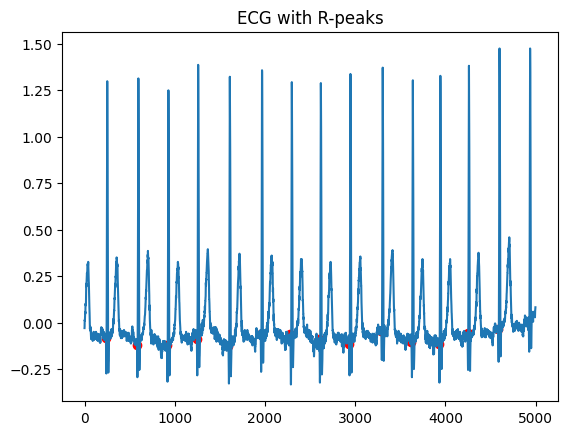

In [21]:
plt.plot(sig[:, LEAD_INDEX])
plt.scatter(rpeaks, sig[rpeaks, LEAD_INDEX], c='r')
plt.title("ECG with R-peaks")
plt.show()

In [24]:
def generate_gradcam_1d(model, sample, class_index, target_layer_name):
    grad_model = tf.keras.models.Model(
        [model.inputs], [model.get_layer(target_layer_name).output, model.output]
    )

    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(tf.expand_dims(sample, axis=0))
        loss = predictions[:, class_index]

    grads = tape.gradient(loss, conv_outputs)[0]
    pooled_grads = tf.reduce_mean(grads, axis=0)

    cam = tf.reduce_sum(tf.multiply(pooled_grads, conv_outputs[0]), axis=-1)
    cam = np.maximum(cam, 0)
    cam /= np.max(cam) + 1e-6
    cam = zoom(cam, sample.shape[0] / cam.shape[0])
    return cam

In [25]:
CLASS_NAMES

['AFib', 'AV_Block', 'Normal', 'Other']

In [26]:
cw

{0: np.float64(73.03224489795919),
 1: np.float64(1.0152806464059556),
 2: np.float64(5.434606973636253),
 3: np.float64(0.35494320638913246)}

In [27]:
y

array([2, 2, 2, ..., 3, 3, 3])

Class distribution

In [ ]:
# Convert numeric labels back to string class names
y_train_labetarget_class_indexls = [CLASS_NAMES[i] for i in y_train]

plt.figure(figsize=(6, 4))
sns.countplot(x=y_train_labels, palette='viridis')
plt.title("Training Set: Count of Each ECG Beat Class")
plt.xlabel("Beat Class")
plt.ylabel("Count")
plt.xticks(rotation=45)  # Rotate labels for better visibility, if needed
plt.tight_layout()
plt.show()

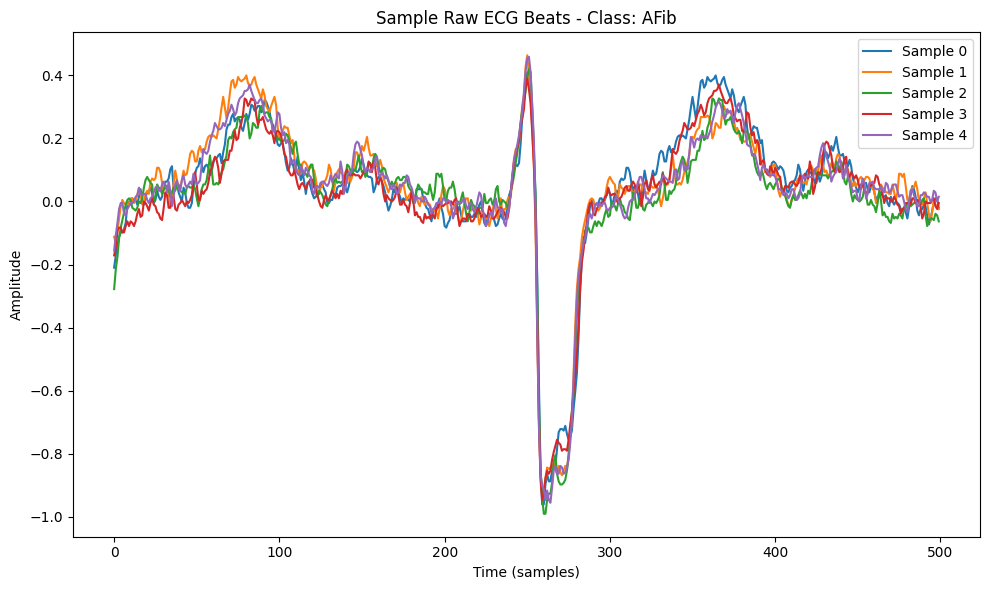

In [ ]:
# 🩺 Plot raw ECG beats (first 5 samples from class 0, e.g., "Normal")
target_class_index = 0  # change this to plot other classes
target_class_name = CLASS_NAMES[target_class_index]

# Get all beats of the target class
class_indices = np.where(y == target_class_index)[0]

# Plot the first 5 beats
plt.figure(figsize=(10, 6))
for i in range(min(5, len(class_indices))):
    beat = X[class_indices[i], :, 0]  # remove channel dimension for plotting
    plt.plot(beat, label=f"Sample {i}")

plt.title(f"Sample Raw ECG Beats - Class: {target_class_name}")
plt.xlabel("Time (samples)")
plt.ylabel("Amplitude")
plt.legend()
plt.tight_layout()
plt.show()


## Creating The ResNet Model (The main model of this study)

In [28]:
def build_resnet64(input_shape: tuple[int, int], num_classes: int) -> tf.keras.Model:
    def res_block(x, filters, kernel_size=7):
        shortcut = x # Original input to the block

        # Apply 1x1 convolution to shortcut if its number of channels doesn't match 'filters'
        # This is the "projection shortcut"
        if shortcut.shape[-1] != filters:
            shortcut = layers.Conv1D(filters, 1, padding="same")(shortcut)
            shortcut = layers.BatchNormalization()(shortcut) # Often batch norm is applied here too

        # First Conv1D layer
        # Corrected: Removed `input_shape` from here, apply to `x` directly
        x = layers.Conv1D(filters, 1, activation='relu')(x) # Use `filters` here as well, not hardcoded 32
        x = layers.BatchNormalization()(x)
        x = layers.Activation("relu")(x) # This Activation after BN is typical

        # Second Conv1D layer
        x = layers.Conv1D(filters, kernel_size, padding="same")(x)
        x = layers.BatchNormalization()(x)

        # Now, x and shortcut should have the same number of filters/channels
        x = layers.Add()([x, shortcut])
        x = layers.Activation("relu")(x)
        return x

    inp = layers.Input(shape=input_shape)
    x = layers.Conv1D(32, 7, padding="same", activation="relu")(inp)
    x = layers.BatchNormalization()(x) # Added BatchNormalization after first Conv1D
    x = layers.MaxPooling1D(2)(x)

    for f in [32, 64, 64, 128, 128, 256]:
        x = res_block(x, f)
        # Apply MaxPooling1D *after* the residual block for downsampling the sequence length
        # and potentially adjusting filters for the *next* block if needed.
        # This if-condition seems to be aiming for downsampling the sequence.
        if f in {64, 128, 256}: # Downsample sequence length at certain stages
            x = layers.MaxPooling1D(2)(x)
            # When MaxPooling occurs, the sequence length changes, but the number of filters 'f' is already set
            # for the *next* block. The 'res_block' handles filter changes.

    x = layers.GlobalAveragePooling1D()(x)
    x = layers.Dense(128, activation="relu")(x)
    out = layers.Dense(num_classes, activation="softmax")(x)
    return models.Model(inp, out, name="ResNet1D")

## Training a Simple CNN Model

In [29]:
model = models.Sequential([
    layers.Conv1D(32, 5, activation='relu', input_shape=X_train.shape[1:]),
    layers.MaxPooling1D(2),
    layers.Conv1D(64, 5, activation='relu'),
    layers.MaxPooling1D(2),
    layers.Flatten(),
    layers.Dense(64, activation='relu'),
    layers.Dense(1, activation='sigmoid')
])
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
model.summary()

/usr/local/lib/python3.12/dist-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1d (Conv1D)                 │ (None, 496, 32)        │           192 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d (MaxPooling1D)    │ (None, 248, 32)        │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_1 (Conv1D)               │ (None, 244, 64)        │        10,304 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_1 (MaxPooling1D)  │ (None, 122, 64)        │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 7808)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 64)             │       499,776 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 510,337 (1.95 MB)

 Trainable params: 510,337 (1.95 MB)

 Non-trainable params: 0 (0.00 B)

In [30]:
history = model.fit(
    X_train, y_train,
    validation_data=(X_val, y_val),
    epochs=30,
    batch_size=128,
    class_weight=cw,
    callbacks=[],
    verbose=2
)

Epoch 1/30
2796/2796 - 307s - 110ms/step - accuracy: 0.2462 - loss: -2.9806e+09 - val_accuracy: 0.2462 - val_loss: -3.9119e+10
Epoch 2/30
2796/2796 - 313s - 112ms/step - accuracy: 0.2462 - loss: -5.5905e+10 - val_accuracy: 0.2462 - val_loss: -3.6726e+11
Epoch 3/30
2796/2796 - 306s - 109ms/step - accuracy: 0.2462 - loss: -2.6219e+11 - val_accuracy: 0.2462 - val_loss: -1.3152e+12
Epoch 4/30
2796/2796 - 279s - 100ms/step - accuracy: 0.2462 - loss: -7.3837e+11 - val_accuracy: 0.2462 - val_loss: -3.2452e+12
Epoch 5/30
2796/2796 - 323s - 116ms/step - accuracy: 0.2462 - loss: -1.6224e+12 - val_accuracy: 0.2462 - val_loss: -6.6366e+12
Epoch 6/30
2796/2796 - 279s - 100ms/step - accuracy: 0.2462 - loss: -3.0941e+12 - val_accuracy: 0.2462 - val_loss: -1.1981e+13
Epoch 7/30
2796/2796 - 285s - 102ms/step - accuracy: 0.2462 - loss: -5.3241e+12 - val_accuracy: 0.2462 - val_loss: -1.9942e+13
Epoch 8/30
2796/2796 - 316s - 113ms/step - accuracy: 0.2462 - loss: -8.5294e+12 - val_accuracy: 0.2462 - val_lo

## Training a ResNet Model

In [ ]:
model = build_resnet64(input_shape=X_train.shape[1:], num_classes=len(CLASS_NAMES))
model.compile(optimizer="adam", loss="sparse_categorical_crossentropy", metrics=["accuracy"])

cb_list = [
    callbacks.ReduceLROnPlateau(patience=3, factor=0.5, verbose=1),
    callbacks.EarlyStopping(patience=7, restore_best_weights=True, verbose=1)
]

history = model.fit(
    X_train, y_train,
    validation_data=(X_val, y_val),
    epochs=30,
    batch_size=128,
    class_weight=cw,
    callbacks=cb_list,
    verbose=2
)

Epoch 1/30
2796/2796 - 2854s - 1s/step - accuracy: 0.6296 - loss: 0.5618 - val_accuracy: 0.6980 - val_loss: 0.5442 - learning_rate: 1.0000e-03
Epoch 2/30
2796/2796 - 2848s - 1s/step - accuracy: 0.6664 - loss: 0.4446 - val_accuracy: 0.7044 - val_loss: 0.5521 - learning_rate: 1.0000e-03
Epoch 3/30
2796/2796 - 2858s - 1s/step - accuracy: 0.6849 - loss: 0.4065 - val_accuracy: 0.7092 - val_loss: 0.5443 - learning_rate: 1.0000e-03
Epoch 4/30

Epoch 4: ReduceLROnPlateau reducing learning rate to 0.0005000000237487257.
2796/2796 - 2923s - 1s/step - accuracy: 0.6968 - loss: 0.3800 - val_accuracy: 0.6818 - val_loss: 0.6471 - learning_rate: 1.0000e-03
Epoch 5/30
2796/2796 - 2881s - 1s/step - accuracy: 0.7227 - loss: 0.3218 - val_accuracy: 0.7262 - val_loss: 0.5160 - learning_rate: 5.0000e-04
Epoch 6/30
2796/2796 - 2899s - 1s/step - accuracy: 0.7339 - loss: 0.3010 - val_accuracy: 0.7578 - val_loss: 0.4615 - learning_rate: 5.0000e-04
Epoch 7/30
2796/2796 - 2862s - 1s/step - accuracy: 0.7413 - loss:

## Viewing the structure of the ResNet model



In [ ]:
model.summary()

## Visualization of training result

In [ ]:
y_pred = model.predict(X_test).argmax(axis=1)
print(classification_report(y_test, y_pred, target_names=CLASS_NAMES))

cm = confusion_matrix(y_test, y_pred, normalize="true")
sns.set_style("whitegrid")

sns.countplot(x=labels, order=CLASS_NAMES)
plt.title("Beat count per class")
plt.show()

plt.plot(X[0].squeeze())
plt.title(f"Example beat – class {CLASS_NAMES[y[0]]}")
plt.xlabel("Samples")
plt.ylabel("Amplitude (mV)")
plt.show()

plt.plot(history.history["accuracy"], label="train acc")
plt.plot(history.history["val_accuracy"], label="val acc")
plt.legend(); plt.title("Accuracy")
plt.show()

plt.plot(history.history["loss"], label="train loss")
plt.plot(history.history["val_loss"], label="val loss")
plt.legend(); plt.title("Loss")
plt.show()

sns.heatmap(cm, annot=True, cmap="Blues", xticklabels=CLASS_NAMES, yticklabels=CLASS_NAMES, fmt=".2f")
plt.ylabel("True")
plt.xlabel("Predicted")
plt.title("Normalized Confusion Matrix")
plt.show()

## Saving the trained Model

In [ ]:
model.save("resnet_ecg.h5")
print("Model saved.")

## Model Compression(TF Lite)

In [ ]:
#creating mobile friendly model using TF Lite
converter = tf.lite.TFLiteConverter.from_keras_model(model)
tflite_model = converter.convert()

with open('ecg.tflite', 'wb') as f:
    f.write(tflite_model)

In [ ]:
tflite_model.decode

In [ ]:
tf.lite.experimental.Analyzer.analyze(model_content=tflite_model)

## Visualization of intermediate convolutional feature maps

In [ ]:
grad_model = load_model("resnet_ecg.h5")

intermediate_model = Model(inputs=grad_model.input, outputs=grad_model.get_layer("conv1d_20").output)
feature_maps = intermediate_model.predict(X_test[:1])

plt.figure(figsize=(12, 6))
for i in range(min(8, feature_maps.shape[-1])):
    plt.plot(feature_maps[0, :, i] + i * 0.5, label=f'Filter {i}')
plt.title("Conv1D Feature Maps")
plt.xlabel("Time (samples)")
plt.legend()
plt.show()

In [ ]:
sample_idx = 0
sample = X_test[sample_idx]
true_label = CLASS_NAMES[y_test[sample_idx]]
pred_label = CLASS_NAMES[grad_model.predict(sample[None, ...]).argmax()]
cam = generate_gradcam_1d(grad_model, sample, class_index=y_test[sample_idx], target_layer_name="conv1d_20")

plt.figure(figsize=(14, 4))
plt.plot(sample.squeeze(), label="ECG Signal", alpha=0.6)
plt.plot(cam * np.max(sample), label="Grad-CAM", color='red')
plt.title(f"Grad-CAM – True: {true_label}, Pred: {pred_label}")
plt.xlabel("Sample")
plt.ylabel("Amplitude (mV)")
plt.legend()
plt.show()

In [ ]:
sample_idx = 1
sample = X_test[sample_idx]
true_label = CLASS_NAMES[y_test[sample_idx]]
pred_label = CLASS_NAMES[grad_model.predict(sample[None, ...]).argmax()]
cam = generate_gradcam_1d(grad_model, sample, class_index=y_test[sample_idx], target_layer_name="conv1d_20")

plt.figure(figsize=(14, 4))
plt.plot(sample.squeeze(), label="ECG Signal", alpha=0.6)
plt.plot(cam * np.max(sample), label="Grad-CAM", color='red')
plt.title(f"Grad-CAM – True: {true_label}, Pred: {pred_label}")
plt.xlabel("Sample")
plt.ylabel("Amplitude (mV)")
plt.legend()
plt.show()

In [ ]:
sample_idx = 3
sample = X_test[sample_idx]
true_label = CLASS_NAMES[y_test[sample_idx]]
pred_label = CLASS_NAMES[grad_model.predict(sample[None, ...]).argmax()]
cam = generate_gradcam_1d(grad_model, sample, class_index=y_test[sample_idx], target_layer_name="conv1d_20")  # change name accordingly

plt.figure(figsize=(14, 4))
plt.plot(sample.squeeze(), label="ECG Signal", alpha=0.6)
plt.plot(cam * np.max(sample), label="Grad-CAM", color='red')
plt.title(f"Grad-CAM – True: {true_label}, Pred: {pred_label}")
plt.xlabel("Sample")
plt.ylabel("Amplitude (mV)")
plt.legend()
plt.show()

## TF Lite Test

In [ ]:
TFLITE_MODEL_PATH = "ecg.tflite"

interpreter = tf.lite.Interpreter(model_path=TFLITE_MODEL_PATH)
interpreter.allocate_tensors()

# Get input & output details
input_details = interpreter.get_input_details()
output_details = interpreter.get_output_details()

'''
X_test = np.load("X_test.npy")  # Shape: (num_samples, seq_len, 1)
y_test = np.load("y_test.npy")  # Shape: (num_samples,)
'''
X_test = X_test.astype(input_details[0]['dtype'])

y_pred = []
inference_times = []
start_total = time.perf_counter()

for i in range(len(X_test)):
    input_data = np.expand_dims(X_test[i], axis=0)
    start_time = time.perf_counter()
    interpreter.set_tensor(input_details[0]['index'], input_data)
    interpreter.invoke()
    output_data = interpreter.get_tensor(output_details[0]['index'])
    end_time = time.perf_counter()
    inference_times.append(end_time - start_time)
    y_pred.append(np.argmax(output_data))

end_total = time.perf_counter()

y_pred = np.array(y_pred)


print("\nClassification Report:")
print(classification_report(y_test, y_pred))


cm = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title("Confusion Matrix (TFLite Model)")
plt.xlabel("Predicted")
plt.ylabel("True")
plt.show()


accuracy = np.mean(y_pred == y_test)
print(f"TFLite Model Accuracy: {accuracy * 100:.2f}%")

avg_time_ms = np.mean(inference_times) * 1000
total_time_s = end_total - start_total
print(f"Average inference time per sample: {avg_time_ms:.4f} ms")
print(f"Total inference time for {len(X_test)} samples: {total_time_s:.4f} s")